### 3. Решение своей задачи на нормальном датасете

**Суть**: обучим модель на датасете Face-Sketch на генерацию скетчей из фотографий/картинок портретов.

В этом ноутбуке реализована архитектура tiny pix2pix на pytorch, за основу взят этот репозиторий https://github.com/vrkh1996/tiny-pix2pix, с реализацией на tensorflow.

Обучение проводилось на кагле.

Загружаем необходимые библиотеки.

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os

import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import torch.optim as optim


Датасет facescatches загружен на Кагл и подключен к ноутбуку.

Проверим наличие датасета:

In [2]:
!ls /kaggle/input/facescatches

photos	sketches


Версии использованных библиотек:

In [3]:
print('torch:', torch.__version__)
print('torchvision:', torchvision.__version__)

torch: 1.7.0
torchvision: 0.8.1


torch: 1.7.0+cu101

torchvision: 0.8.1+cu101

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


В качестве генератора будем использовать UNet.

In [3]:
class Generator(nn.Module):    
    def __init__(self):
        super(Generator, self).__init__()
        # Generator - UNet
        self.conv1_1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, padding=1)
        self.conv1_2 = nn.Conv2d(in_channels=16, out_channels=16, kernel_size=3, padding=1)
        self.conv2_1 = nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, padding=1)
        self.conv3_1 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1)
        self.conv4_1 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1)
        
        self.conv5_1 = nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1)
        
        self.up6 = nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1)
        self.conv6_1 = nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1)
        self.conv6_2 = nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1)
        
        self.up7 = nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1)
        self.conv7_1 = nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1)
        self.conv7_2 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1)
        
        self.up8 = nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, padding=1)
        self.conv8_1 = nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, padding=1)
        self.conv8_2 = nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, padding=1)
        
        self.up9 = nn.Conv2d(in_channels=32, out_channels=16, kernel_size=3, padding=1)
        self.conv9_1 = nn.Conv2d(in_channels=32, out_channels=16, kernel_size=3, padding=1)
        self.conv9_2 = nn.Conv2d(in_channels=16, out_channels=16, kernel_size=3, padding=1)
        self.conv9_3 = nn.Conv2d(in_channels=16, out_channels=3, kernel_size=3, padding=1)

        
    def forward(self, x):
        conv1 = nn.ReLU()(self.conv1_1(x))
        conv1 = nn.ReLU()(self.conv1_2(conv1))
        pool1 = nn.MaxPool2d(kernel_size=(2, 2))(conv1)
        conv2 = nn.ReLU()(self.conv2_1(pool1))
        conv2 = nn.ReLU()(self.conv2_2(conv2))
        pool2 = nn.MaxPool2d(kernel_size=(2, 2))(conv2)
        conv3 = nn.ReLU()(self.conv3_1(pool2))
        conv3 = nn.ReLU()(self.conv3_2(conv3))
        pool3 = nn.MaxPool2d(kernel_size=(2, 2))(conv3)
        conv4 = nn.ReLU()(self.conv4_1(pool3))
        conv4 = nn.ReLU()(self.conv4_2(conv4))
        drop4 = nn.Dropout2d(0.5)(conv4)
        pool4 = nn.MaxPool2d(kernel_size=(2, 2))(drop4)
        
        conv5 = nn.ReLU()(self.conv5_1(pool4))
        conv5 = nn.ReLU()(self.conv5_2(conv5))
        drop5 = nn.Dropout2d(0.5)(conv5)
        
        up6 = nn.Upsample(scale_factor=2, mode='nearest')(drop5)
        up6 = nn.ReLU()(self.up6(up6))
        merge6 = torch.cat([drop4, up6], dim=1)
        conv6 = nn.ReLU()(self.conv6_1(merge6))
        conv6 = nn.ReLU()(self.conv6_2(conv6))
        
        up7 = nn.Upsample(scale_factor=2, mode='nearest')(conv6)
        up7 = nn.ReLU()(self.up7(up7))
        merge7 = torch.cat([conv3, up7], dim=1)
        conv7 = nn.ReLU()(self.conv7_1(merge7))
        conv7 = nn.ReLU()(self.conv7_2(conv7))
        
        up8 = nn.Upsample(scale_factor=2, mode='nearest')(conv7)
        up8 = nn.ReLU()(self.up8(up8))
        merge8 = torch.cat([conv2, up8], dim=1)
        conv8 = nn.ReLU()(self.conv8_1(merge8))
        conv8 = nn.ReLU()(self.conv8_2(conv8))
        
        up9 = nn.Upsample(scale_factor=2, mode='nearest')(conv8)
        up9 = nn.ReLU()(self.up9(up9))
        merge9 = torch.cat([conv1, up9], dim=1)
        conv9 = nn.ReLU()(self.conv9_1(merge9))
        conv9 = nn.ReLU()(self.conv9_2(conv9))
        conv9 = nn.Tanh()(self.conv9_3(conv9))
        
        return conv9

In [6]:
generator = Generator()

In [7]:
print(generator)

Generator(
  (conv1_1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv1_2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2_1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2_2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv5_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv5_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (up6): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv6_1): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv6_2): Conv2d(128, 128, kerne

Проверим, что Генератор будет делать с рендомным рисунком:

In [8]:
input = torch.randn(1, 3, 256, 256)

In [9]:
generator(input).shape

torch.Size([1, 3, 256, 256])

Какой-то дискриминатор. В оригинальной работе он называется PatchGAN, т. к. делит рисунок на части (патчи) и для каждой части возвращает вероятность того, что рисунок принадлежит нужному классу (класс задаётся вторым рисунком).

In [10]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        # Discriminator - PatchGAN
        self.conv1 = nn.Conv2d(in_channels=6, out_channels=64, kernel_size=3, stride=2)
        self.relu1 = nn.LeakyReLU(negative_slope=0.2)
        
        self.conv2 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3)
        self.bn2 = nn.BatchNorm2d(128, momentum=0.8)
        self.relu2 = nn.LeakyReLU(negative_slope=0.2)
        
        self.conv3 = nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3)
        self.bn3 = nn.BatchNorm2d(256, momentum=0.8)
        self.relu3 = nn.LeakyReLU(negative_slope=0.2)
        
        self.conv4 = nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3)
        self.bn4 = nn.BatchNorm2d(512, momentum=0.8)
        self.relu4 = nn.LeakyReLU(negative_slope=0.2)
        
        self.conv5 = nn.Conv2d(in_channels=512, out_channels=1, kernel_size=3, padding=1)

        
    def forward(self, source_image, target_image):
        merged = torch.cat([source_image, target_image], dim=1)
        
        x = self.conv1(merged)
        x = self.relu1(x)
        x = nn.Dropout2d(0.25)(x)
        
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu2(x)
        x = nn.Dropout2d(0.25)(x)
        
        x = self.conv3(x)
        x = self.bn3(x)
        x = self.relu3(x)
        x = nn.Dropout2d(0.25)(x)
        
        x = self.conv4(x)
        x = self.bn4(x)
        x = self.relu4(x)
        x = nn.Dropout2d(0.25)(x)
        
        x = self.conv5(x)
        # Sigmoid, т. к. возвращать будем вероятности того, что кусочек рисунка принадлежит нужному классу.
        x = nn.Sigmoid()(x) 
        
        return x

In [11]:
discriminator = Discriminator()

In [12]:
print(discriminator)

Discriminator(
  (conv1): Conv2d(6, 64, kernel_size=(3, 3), stride=(2, 2))
  (relu1): LeakyReLU(negative_slope=0.2)
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.8, affine=True, track_running_stats=True)
  (relu2): LeakyReLU(negative_slope=0.2)
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
  (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.8, affine=True, track_running_stats=True)
  (relu3): LeakyReLU(negative_slope=0.2)
  (conv4): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1))
  (bn4): BatchNorm2d(512, eps=1e-05, momentum=0.8, affine=True, track_running_stats=True)
  (relu4): LeakyReLU(negative_slope=0.2)
  (conv5): Conv2d(512, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
)


Проверим, что Дискриминатор будет делать с рендомным рисунком:


In [13]:
input = torch.randn(1, 3, 256, 256)

In [14]:
discriminator(input, input).shape

torch.Size([1, 1, 121, 121])

Цикл обучения pix2pix.

In [3]:
# функция генерации real-изображений
def real_samples(data_in, data_lb, batchsize):
    ix = np.random.randint(0, data_in.shape[0], batchsize)
    x_realA, x_realB = data_in[ix], data_lb[ix]
    # 'real' class labels == 1
    y_real = np.ones((batchsize, 1, 121, 121)) # размер матрицы с вероятностями, которая получается после дискриминатора

    return [x_realA, x_realB], y_real

# функция генерации фейков
def fake_samples(x_real):
    x_fake = generator(x_real)
    # 'fake' class labels == 0
    y_fake = np.zeros((len(x_fake), 1, 121, 121)) # размер матрицы с вероятностями, которая получается после дискриминатора

    return x_fake, y_fake

In [4]:
# функция отрисовки изображения из тензора
def imshow(img):
    img = img / 2 + 0.5     # убераем нормализацию
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

In [17]:
generator = Generator()
generator.to(device)
#
discriminator = Discriminator()
discriminator.to(device)

Discriminator(
  (conv1): Conv2d(6, 64, kernel_size=(3, 3), stride=(2, 2))
  (relu1): LeakyReLU(negative_slope=0.2)
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.8, affine=True, track_running_stats=True)
  (relu2): LeakyReLU(negative_slope=0.2)
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
  (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.8, affine=True, track_running_stats=True)
  (relu3): LeakyReLU(negative_slope=0.2)
  (conv4): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1))
  (bn4): BatchNorm2d(512, eps=1e-05, momentum=0.8, affine=True, track_running_stats=True)
  (relu4): LeakyReLU(negative_slope=0.2)
  (conv5): Conv2d(512, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
)

In [5]:
#
transformation = transforms.Compose(
    [transforms.Resize((256, 256)),
     transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

Код для создания своего датасета из двух папок  с картинками

In [19]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode


In [45]:
import torch.utils.data as data

from PIL import Image
import os
import os.path
import numpy as np

IMG_EXTENSIONS = [
  '.jpg', '.JPG', '.jpeg', '.JPEG',
  '.png', '.PNG', '.ppm', '.PPM', '.bmp', '.BMP',
]

def is_image_file(filename):
    return any(filename.endswith(extension) for extension in IMG_EXTENSIONS)

def make_dataset(dir):
    images = []
    if not os.path.isdir(dir):
        raise Exception('Check dataroot')
    for root, _, fnames in sorted(os.walk(dir)):
        for fname in fnames:
            if is_image_file(fname):
                path = os.path.join(dir, fname)
                item = path
                images.append(item)
    return images

def default_loader(path):
    return Image.open(path).convert('RGB')

class pix2pix(data.Dataset):
    def __init__(self, root, loader=default_loader, seed=None): #transform=None, 
        imgs_A = make_dataset(root + "/photos")
        #imgs_B = make_dataset(root + "/sketches")
        if len(imgs_A) == 0:
            raise(RuntimeError("Found 0 images in subfolders of: " + root + "\n"
                 "Supported image extensions are: " + ",".join(IMG_EXTENSIONS)))
        self.root = root
        self.imgs_A = imgs_A
        #self.imgs_B = imgs_B
        #self.transform = transform
        self.loader = loader

        if seed is not None:
            np.random.seed(seed)

    def __getitem__(self, _):
        index = np.random.randint(self.__len__(), size=1)[0]
        path_A = self.imgs_A[index]
        path_B = self.imgs_A[index].replace('photos', 'sketches')
        imgs_A = self.loader(path_A)
        imgs_B = self.loader(path_B)
        # NOTE: img -> PIL Image
    
#   if self.transform is not None:
#       # NOTE preprocessing for each pair of images
#       imgs_A, imgs_B = self.transform(imgs_A), self.transform(imgs_B)
        return transformation(imgs_A), transformation(imgs_B)

    def __len__(self):
        return len(self.imgs_A)

In [46]:
trainset = pix2pix('/kaggle/input/facescatches')
trainloader = torch.utils.data.DataLoader(trainset, batch_size=1, shuffle=True, num_workers=1)

In [22]:
#print(next(iter(trainset)))

In [47]:
G_criterion = nn.L1Loss()
G_optimizer = optim.Adam(generator.parameters(), lr=2e-4, betas=(0.5, 0.999))
#
D_criterion = nn.BCELoss()
D_optimizer = optim.Adam(discriminator.parameters(), lr=1e-4)

In [48]:
from tqdm import tqdm 
import time

batchsize = 1
epochs = 1000

for epoch in range(epochs):  # loop over the dataset multiple times
    for i, data in tqdm(enumerate(trainloader, 0)):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data

        inputs = inputs.to(device)
        labels = labels.to(device)
        
        # select a batch of real samples
        [x_realA, x_realB], y_real = real_samples(inputs, labels, batchsize)
        # generate a batch of fake samples
        x_fakeB, y_fake = fake_samples(x_realA)
        
        x_realA = x_realA.to(device)
        #imshow(torchvision.utils.make_grid(x_realA.to('cpu').detach()))
        x_realB = x_realB.to(device)
        #imshow(torchvision.utils.make_grid(x_realB.to('cpu').detach()))
        x_fakeB = x_fakeB.to(device)
        #imshow(torchvision.utils.make_grid(x_fakeB.to('cpu').detach()))
        y_real = torch.Tensor(y_real).to(device)
        #imshow(torchvision.utils.make_grid(y_real.to('cpu').detach()))
        y_fake = torch.Tensor(y_fake).to(device)
        #imshow(torchvision.utils.make_grid(y_fake.to('cpu').detach()))
        #time.sleep(15)
        #break
        #break
        
        # update discriminator for real samples
        D_optimizer.zero_grad()
        outputs = discriminator(x_realA, x_realB)
        loss = D_criterion(outputs, y_real)
        loss.backward()
        D_optimizer.step()
        d_loss1 = loss.item()
        
        # update discriminator for generated samples
        D_optimizer.zero_grad()
        outputs = discriminator(x_realA, x_fakeB)
        loss = D_criterion(outputs, y_fake)
        loss.backward()
        D_optimizer.step()
        d_loss2 = loss.item()  
        
        # update the generator
        D_optimizer.zero_grad()
        G_optimizer.zero_grad()
        
        G_outputs = generator(x_realA)
        D_outputs = discriminator(x_realA, G_outputs)
        
        G_loss = G_criterion(G_outputs, x_realB)
        D_loss = D_criterion(D_outputs, y_real)
        
        loss = 100 * G_loss + D_loss
        loss.backward()
        #D_optimizer.step()
        G_optimizer.step()
        g_loss = loss.item()
        
        print('>%d, d1[%.3f] d2[%.3f] g[%.3f]' % (i + 1, d_loss1, d_loss2, g_loss))

print('Finished Training')

3it [00:00, 10.72it/s]

>1, d1[0.052] d2[0.003] g[30.701]
>2, d1[2.180] d2[3.432] g[83.534]
>3, d1[0.021] d2[0.153] g[39.844]


5it [00:00, 11.79it/s]

>4, d1[0.001] d2[0.261] g[39.742]
>5, d1[0.009] d2[0.195] g[41.161]
>6, d1[0.002] d2[0.162] g[39.844]


9it [00:00, 12.39it/s]

>7, d1[0.001] d2[0.142] g[40.697]
>8, d1[0.065] d2[0.152] g[44.560]
>9, d1[1.892] d2[0.113] g[64.550]


11it [00:00, 12.52it/s]

>10, d1[0.387] d2[0.013] g[38.141]
>11, d1[0.184] d2[0.065] g[42.177]
>12, d1[0.031] d2[0.008] g[52.467]


15it [00:01, 12.62it/s]

>13, d1[0.002] d2[0.121] g[40.107]
>14, d1[0.005] d2[0.134] g[33.042]
>15, d1[0.143] d2[0.021] g[29.357]


17it [00:01, 12.32it/s]

>16, d1[0.206] d2[0.216] g[38.250]
>17, d1[0.019] d2[0.084] g[45.421]
>18, d1[0.000] d2[1.259] g[43.373]


21it [00:01, 12.55it/s]

>19, d1[0.013] d2[0.003] g[43.866]
>20, d1[0.293] d2[1.214] g[55.593]
>21, d1[0.007] d2[0.074] g[38.738]


23it [00:01, 12.65it/s]

>22, d1[0.018] d2[0.012] g[43.176]
>23, d1[0.404] d2[0.011] g[52.849]
>24, d1[0.120] d2[0.008] g[51.479]


27it [00:02, 12.73it/s]

>25, d1[0.047] d2[0.004] g[52.217]
>26, d1[0.001] d2[0.006] g[42.989]
>27, d1[0.010] d2[0.058] g[54.190]


29it [00:02, 12.75it/s]

>28, d1[0.008] d2[0.296] g[31.733]
>29, d1[0.082] d2[0.009] g[40.335]
>30, d1[0.022] d2[0.003] g[42.115]


33it [00:02, 12.82it/s]

>31, d1[0.088] d2[0.026] g[54.422]
>32, d1[2.498] d2[0.045] g[30.958]
>33, d1[2.177] d2[0.002] g[37.941]


35it [00:02, 12.82it/s]

>34, d1[0.091] d2[0.034] g[52.870]
>35, d1[0.102] d2[0.006] g[43.078]
>36, d1[0.002] d2[0.076] g[47.665]


39it [00:03, 12.86it/s]

>37, d1[0.007] d2[0.127] g[38.414]
>38, d1[0.003] d2[0.159] g[38.729]
>39, d1[0.012] d2[0.002] g[39.067]


41it [00:03, 12.86it/s]

>40, d1[0.037] d2[0.037] g[38.229]
>41, d1[0.023] d2[0.030] g[69.653]
>42, d1[0.064] d2[0.052] g[42.553]


45it [00:03, 12.89it/s]

>43, d1[0.061] d2[0.130] g[37.889]
>44, d1[0.048] d2[0.001] g[32.112]
>45, d1[0.003] d2[0.003] g[32.737]


47it [00:03, 12.88it/s]

>46, d1[0.179] d2[0.008] g[60.582]
>47, d1[0.003] d2[0.090] g[26.882]
>48, d1[0.024] d2[0.203] g[31.320]


51it [00:04, 12.89it/s]

>49, d1[0.341] d2[0.026] g[59.353]
>50, d1[0.233] d2[0.017] g[62.534]
>51, d1[0.004] d2[0.006] g[37.466]


53it [00:04, 12.84it/s]

>52, d1[0.127] d2[0.176] g[54.520]
>53, d1[0.022] d2[1.833] g[65.787]
>54, d1[0.005] d2[0.296] g[35.219]


57it [00:04, 12.85it/s]

>55, d1[0.132] d2[0.101] g[50.384]
>56, d1[0.834] d2[0.235] g[73.765]
>57, d1[0.001] d2[0.038] g[37.398]


59it [00:04, 12.85it/s]

>58, d1[0.014] d2[0.134] g[56.879]
>59, d1[0.093] d2[0.083] g[36.085]
>60, d1[0.047] d2[0.448] g[60.097]


63it [00:04, 12.90it/s]

>61, d1[0.016] d2[4.098] g[72.401]
>62, d1[0.175] d2[0.035] g[40.950]
>63, d1[0.005] d2[0.564] g[47.183]


65it [00:05, 12.92it/s]

>64, d1[0.249] d2[2.932] g[48.772]
>65, d1[0.013] d2[1.788] g[43.272]
>66, d1[0.030] d2[0.258] g[39.261]


69it [00:05, 12.89it/s]

>67, d1[0.020] d2[0.199] g[41.115]
>68, d1[0.757] d2[0.085] g[41.266]
>69, d1[0.100] d2[0.423] g[32.553]


71it [00:05, 12.81it/s]

>70, d1[0.059] d2[2.718] g[34.104]
>71, d1[0.067] d2[3.378] g[40.436]
>72, d1[0.172] d2[0.008] g[60.092]


75it [00:05, 12.86it/s]

>73, d1[1.108] d2[0.337] g[46.602]
>74, d1[0.048] d2[0.028] g[36.802]
>75, d1[0.040] d2[0.003] g[39.284]


77it [00:06, 12.90it/s]

>76, d1[0.504] d2[0.004] g[32.387]
>77, d1[0.088] d2[0.212] g[25.648]
>78, d1[0.839] d2[0.062] g[44.394]


81it [00:06, 12.47it/s]

>79, d1[0.221] d2[0.138] g[20.636]
>80, d1[0.041] d2[0.011] g[37.172]
>81, d1[0.900] d2[0.024] g[25.379]


83it [00:06, 11.95it/s]

>82, d1[0.336] d2[1.930] g[49.756]
>83, d1[0.426] d2[1.465] g[46.617]
>84, d1[0.075] d2[1.667] g[44.764]


87it [00:06, 11.24it/s]

>85, d1[0.040] d2[2.771] g[28.366]
>86, d1[0.129] d2[0.006] g[30.097]
>87, d1[1.871] d2[2.267] g[48.142]


89it [00:07, 11.58it/s]

>88, d1[0.108] d2[8.540] g[28.974]
>89, d1[3.978] d2[2.379] g[23.179]
>90, d1[0.440] d2[0.022] g[34.130]


93it [00:07, 12.20it/s]

>91, d1[0.067] d2[0.586] g[32.504]
>92, d1[0.010] d2[0.004] g[21.977]
>93, d1[0.146] d2[2.690] g[17.479]


95it [00:07, 12.39it/s]

>94, d1[0.330] d2[2.154] g[29.508]
>95, d1[4.718] d2[3.711] g[35.346]
>96, d1[0.012] d2[2.287] g[15.021]


99it [00:07, 12.58it/s]

>97, d1[0.509] d2[1.768] g[18.495]
>98, d1[0.233] d2[0.511] g[37.512]
>99, d1[2.011] d2[0.684] g[44.906]


101it [00:08, 12.64it/s]

>100, d1[0.137] d2[3.736] g[21.546]
>101, d1[0.895] d2[2.838] g[20.959]
>102, d1[0.967] d2[0.469] g[20.753]


105it [00:08, 12.72it/s]

>103, d1[0.087] d2[0.374] g[32.226]
>104, d1[0.434] d2[2.905] g[20.473]
>105, d1[1.157] d2[1.233] g[22.356]


107it [00:08, 12.80it/s]

>106, d1[0.118] d2[0.138] g[36.696]
>107, d1[1.203] d2[0.464] g[36.638]
>108, d1[0.971] d2[2.175] g[12.495]


111it [00:08, 12.81it/s]

>109, d1[0.063] d2[2.310] g[20.879]
>110, d1[0.598] d2[2.992] g[30.267]
>111, d1[1.103] d2[0.840] g[32.286]


113it [00:08, 12.78it/s]

>112, d1[1.188] d2[2.063] g[18.860]
>113, d1[2.404] d2[1.146] g[31.642]
>114, d1[1.742] d2[0.703] g[16.872]


117it [00:09, 12.80it/s]

>115, d1[1.309] d2[0.050] g[26.723]
>116, d1[2.557] d2[0.330] g[27.994]
>117, d1[1.012] d2[3.564] g[40.194]


119it [00:09, 12.88it/s]

>118, d1[0.094] d2[1.456] g[37.023]
>119, d1[1.244] d2[0.376] g[31.128]
>120, d1[1.056] d2[1.089] g[24.451]


123it [00:09, 12.84it/s]

>121, d1[1.223] d2[1.782] g[15.833]
>122, d1[0.433] d2[3.242] g[19.867]
>123, d1[1.054] d2[0.730] g[18.873]


125it [00:09, 12.85it/s]

>124, d1[0.221] d2[1.519] g[12.883]
>125, d1[2.424] d2[1.501] g[19.520]
>126, d1[1.690] d2[0.288] g[25.322]


129it [00:10, 12.81it/s]

>127, d1[0.135] d2[2.020] g[11.786]
>128, d1[1.150] d2[0.180] g[33.013]
>129, d1[0.298] d2[2.400] g[19.018]


131it [00:10, 12.80it/s]

>130, d1[2.246] d2[0.450] g[18.793]
>131, d1[0.552] d2[1.090] g[18.547]
>132, d1[1.150] d2[1.093] g[15.406]


135it [00:10, 12.82it/s]

>133, d1[0.365] d2[0.408] g[25.354]
>134, d1[0.242] d2[1.181] g[23.492]
>135, d1[0.686] d2[0.597] g[19.599]


137it [00:10, 12.79it/s]

>136, d1[0.474] d2[2.463] g[9.990]
>137, d1[0.249] d2[0.587] g[19.784]
>138, d1[0.344] d2[1.191] g[10.082]


141it [00:11, 12.79it/s]

>139, d1[3.252] d2[0.178] g[20.829]
>140, d1[0.669] d2[0.193] g[25.101]
>141, d1[2.737] d2[0.451] g[24.319]


143it [00:11, 12.53it/s]

>142, d1[1.545] d2[1.483] g[12.330]
>143, d1[0.487] d2[1.435] g[16.192]
>144, d1[0.367] d2[1.202] g[15.153]


147it [00:11, 12.62it/s]

>145, d1[0.993] d2[1.182] g[17.929]
>146, d1[0.539] d2[1.345] g[14.589]
>147, d1[0.822] d2[1.478] g[14.398]


149it [00:11, 12.67it/s]

>148, d1[1.302] d2[1.446] g[18.052]
>149, d1[0.249] d2[1.091] g[17.167]
>150, d1[1.289] d2[0.478] g[21.306]


153it [00:12, 12.73it/s]

>151, d1[0.458] d2[2.545] g[17.748]
>152, d1[0.582] d2[0.559] g[14.707]
>153, d1[0.617] d2[0.757] g[17.162]


155it [00:12, 12.73it/s]

>154, d1[1.615] d2[1.632] g[25.974]
>155, d1[0.954] d2[0.402] g[10.732]
>156, d1[1.185] d2[0.698] g[14.904]


159it [00:12, 12.83it/s]

>157, d1[0.302] d2[0.727] g[13.233]
>158, d1[1.600] d2[0.954] g[15.697]
>159, d1[0.700] d2[2.825] g[12.968]


161it [00:12, 12.87it/s]

>160, d1[2.363] d2[0.259] g[19.729]
>161, d1[1.749] d2[0.978] g[13.297]
>162, d1[0.548] d2[1.122] g[34.075]


165it [00:13, 12.83it/s]

>163, d1[0.709] d2[2.313] g[15.572]
>164, d1[0.808] d2[1.061] g[19.385]
>165, d1[0.315] d2[0.944] g[22.173]


167it [00:13, 12.76it/s]

>166, d1[1.228] d2[0.226] g[15.548]
>167, d1[0.873] d2[1.486] g[21.082]
>168, d1[0.400] d2[0.568] g[14.576]


171it [00:13, 12.82it/s]

>169, d1[0.759] d2[1.604] g[14.036]
>170, d1[0.748] d2[1.442] g[14.924]
>171, d1[2.257] d2[0.025] g[21.927]


173it [00:13, 12.83it/s]

>172, d1[1.491] d2[1.372] g[14.440]
>173, d1[1.061] d2[0.339] g[19.862]
>174, d1[1.415] d2[0.496] g[15.857]


177it [00:13, 12.80it/s]

>175, d1[0.853] d2[1.108] g[14.926]
>176, d1[0.917] d2[1.184] g[19.052]
>177, d1[3.030] d2[0.172] g[21.281]


179it [00:14, 12.77it/s]

>178, d1[0.884] d2[0.927] g[11.996]
>179, d1[1.233] d2[0.182] g[20.041]
>180, d1[1.994] d2[1.176] g[19.305]


183it [00:14, 12.74it/s]

>181, d1[0.994] d2[0.431] g[16.044]
>182, d1[0.821] d2[1.203] g[13.787]
>183, d1[0.196] d2[0.633] g[19.572]


185it [00:14, 12.75it/s]

>184, d1[1.152] d2[1.558] g[14.165]
>185, d1[0.770] d2[1.037] g[13.379]
>186, d1[0.394] d2[1.181] g[19.641]


188it [00:14, 12.64it/s]

>187, d1[1.443] d2[0.572] g[17.502]
>188, d1[0.504] d2[2.802] g[8.918]



3it [00:00, 11.74it/s]

>1, d1[0.626] d2[0.658] g[12.207]
>2, d1[1.287] d2[0.391] g[24.166]
>3, d1[0.965] d2[1.393] g[14.870]


5it [00:00, 12.28it/s]

>4, d1[0.384] d2[1.361] g[13.362]
>5, d1[0.184] d2[2.329] g[16.942]
>6, d1[0.651] d2[1.130] g[15.088]


9it [00:00, 12.63it/s]

>7, d1[0.319] d2[1.150] g[14.733]
>8, d1[0.611] d2[1.033] g[14.059]
>9, d1[1.972] d2[0.725] g[28.757]


11it [00:00, 12.66it/s]

>10, d1[1.267] d2[0.865] g[16.968]
>11, d1[0.938] d2[0.894] g[16.814]
>12, d1[1.121] d2[0.484] g[16.140]


15it [00:01, 12.79it/s]

>13, d1[0.562] d2[1.000] g[16.629]
>14, d1[1.297] d2[1.197] g[11.679]
>15, d1[0.253] d2[1.048] g[10.785]


17it [00:01, 12.78it/s]

>16, d1[0.900] d2[5.346] g[12.344]
>17, d1[0.825] d2[2.508] g[15.558]
>18, d1[0.936] d2[1.656] g[18.657]


21it [00:01, 12.80it/s]

>19, d1[1.952] d2[1.353] g[22.515]
>20, d1[1.962] d2[0.646] g[19.615]
>21, d1[1.000] d2[0.533] g[13.705]


23it [00:01, 12.86it/s]

>22, d1[0.792] d2[0.509] g[15.902]
>23, d1[1.422] d2[0.642] g[13.186]
>24, d1[2.211] d2[0.645] g[13.074]


27it [00:02, 12.83it/s]

>25, d1[1.186] d2[2.702] g[24.741]
>26, d1[1.024] d2[0.890] g[16.785]
>27, d1[1.312] d2[0.404] g[14.121]


29it [00:02, 12.82it/s]

>28, d1[1.895] d2[0.390] g[9.720]
>29, d1[0.876] d2[0.980] g[13.200]
>30, d1[0.923] d2[1.332] g[14.165]


33it [00:02, 11.54it/s]

>31, d1[0.549] d2[0.424] g[19.256]
>32, d1[0.754] d2[0.789] g[10.549]
>33, d1[0.457] d2[1.633] g[11.885]


35it [00:02, 11.23it/s]

>34, d1[1.204] d2[1.051] g[11.585]
>35, d1[0.836] d2[0.571] g[13.846]
>36, d1[1.163] d2[0.348] g[15.143]


39it [00:03, 11.74it/s]

>37, d1[1.481] d2[1.487] g[10.524]
>38, d1[0.715] d2[0.900] g[10.196]
>39, d1[1.432] d2[0.649] g[12.666]


41it [00:03, 12.02it/s]

>40, d1[0.378] d2[1.352] g[12.406]
>41, d1[0.599] d2[4.374] g[31.547]
>42, d1[1.037] d2[1.142] g[14.681]


45it [00:03, 12.37it/s]

>43, d1[0.568] d2[0.881] g[16.880]
>44, d1[0.758] d2[0.980] g[15.276]
>45, d1[0.246] d2[1.197] g[13.940]


47it [00:03, 12.41it/s]

>46, d1[2.633] d2[0.786] g[20.284]
>47, d1[0.369] d2[1.061] g[11.705]
>48, d1[0.802] d2[0.854] g[12.896]


51it [00:04, 12.49it/s]

>49, d1[2.335] d2[0.656] g[19.231]
>50, d1[1.214] d2[0.762] g[18.010]
>51, d1[0.579] d2[0.770] g[18.467]


53it [00:04, 12.56it/s]

>52, d1[0.858] d2[0.569] g[21.271]
>53, d1[0.467] d2[1.534] g[28.739]
>54, d1[0.637] d2[0.677] g[13.947]


57it [00:04, 12.71it/s]

>55, d1[1.276] d2[1.719] g[13.065]
>56, d1[1.138] d2[0.290] g[22.233]
>57, d1[0.445] d2[1.390] g[15.458]


59it [00:04, 12.70it/s]

>58, d1[2.072] d2[0.544] g[20.612]
>59, d1[1.520] d2[0.444] g[13.451]
>60, d1[1.246] d2[0.267] g[19.645]


63it [00:05, 12.69it/s]

>61, d1[0.295] d2[0.802] g[10.626]
>62, d1[0.893] d2[0.542] g[17.648]
>63, d1[2.267] d2[0.316] g[14.633]


65it [00:05, 12.70it/s]

>64, d1[0.422] d2[0.235] g[17.787]
>65, d1[0.817] d2[0.885] g[14.528]
>66, d1[0.535] d2[1.032] g[19.342]


69it [00:05, 12.71it/s]

>67, d1[0.525] d2[0.791] g[14.577]
>68, d1[1.619] d2[0.744] g[17.330]
>69, d1[0.477] d2[1.641] g[16.006]


71it [00:05, 12.70it/s]

>70, d1[0.196] d2[0.698] g[14.955]
>71, d1[0.431] d2[1.483] g[17.416]
>72, d1[0.697] d2[0.783] g[23.829]


75it [00:06, 12.63it/s]

>73, d1[0.923] d2[0.806] g[22.778]
>74, d1[0.549] d2[2.259] g[16.351]
>75, d1[0.745] d2[0.801] g[25.241]


77it [00:06, 12.64it/s]

>76, d1[0.615] d2[1.179] g[16.147]
>77, d1[0.716] d2[0.798] g[11.979]
>78, d1[1.409] d2[0.156] g[22.040]


81it [00:06, 12.67it/s]

>79, d1[0.396] d2[1.615] g[12.088]
>80, d1[1.097] d2[0.781] g[10.294]
>81, d1[0.937] d2[1.504] g[9.964]


83it [00:06, 12.72it/s]

>82, d1[1.829] d2[0.507] g[20.059]
>83, d1[0.761] d2[0.246] g[14.489]
>84, d1[1.152] d2[1.558] g[18.420]


87it [00:06, 12.67it/s]

>85, d1[1.153] d2[0.570] g[15.770]
>86, d1[0.341] d2[1.507] g[13.803]
>87, d1[1.178] d2[0.419] g[24.920]


89it [00:07, 12.66it/s]

>88, d1[0.587] d2[2.620] g[12.403]
>89, d1[0.658] d2[1.298] g[11.451]
>90, d1[0.696] d2[1.382] g[16.505]


93it [00:07, 12.65it/s]

>91, d1[0.766] d2[1.415] g[12.148]
>92, d1[0.440] d2[1.277] g[10.946]
>93, d1[0.465] d2[1.136] g[11.559]


95it [00:07, 12.69it/s]

>94, d1[1.098] d2[1.889] g[32.448]
>95, d1[0.395] d2[0.944] g[20.879]
>96, d1[0.678] d2[1.089] g[9.751]


99it [00:07, 12.67it/s]

>97, d1[1.117] d2[0.536] g[9.845]
>98, d1[0.756] d2[0.578] g[24.411]
>99, d1[1.103] d2[0.031] g[23.414]


101it [00:08, 12.73it/s]

>100, d1[1.443] d2[1.563] g[22.399]
>101, d1[0.454] d2[0.676] g[12.670]
>102, d1[0.478] d2[0.218] g[14.241]


105it [00:08, 12.73it/s]

>103, d1[0.622] d2[0.570] g[18.728]
>104, d1[1.104] d2[2.305] g[13.857]
>105, d1[0.758] d2[2.442] g[15.818]


107it [00:08, 12.74it/s]

>106, d1[0.280] d2[0.404] g[22.040]
>107, d1[1.631] d2[1.021] g[17.683]
>108, d1[1.159] d2[1.361] g[9.138]


111it [00:08, 12.71it/s]

>109, d1[0.341] d2[0.337] g[13.037]
>110, d1[1.089] d2[0.980] g[26.497]
>111, d1[0.803] d2[0.492] g[20.025]


113it [00:09, 12.72it/s]

>112, d1[1.148] d2[1.311] g[16.630]
>113, d1[0.813] d2[0.285] g[23.056]
>114, d1[1.182] d2[1.022] g[13.751]


117it [00:09, 12.52it/s]

>115, d1[1.495] d2[0.365] g[17.631]
>116, d1[1.013] d2[0.182] g[18.425]
>117, d1[1.684] d2[0.411] g[14.651]


119it [00:09, 12.59it/s]

>118, d1[0.687] d2[0.525] g[9.651]
>119, d1[0.892] d2[0.790] g[18.475]
>120, d1[1.198] d2[1.495] g[14.035]


123it [00:09, 12.67it/s]

>121, d1[0.890] d2[0.549] g[11.490]
>122, d1[1.523] d2[0.687] g[13.808]
>123, d1[0.564] d2[1.003] g[19.641]


125it [00:09, 12.67it/s]

>124, d1[0.439] d2[1.048] g[10.676]
>125, d1[1.164] d2[1.125] g[14.785]
>126, d1[0.772] d2[1.234] g[23.428]


129it [00:10, 12.66it/s]

>127, d1[0.567] d2[1.173] g[9.793]
>128, d1[0.602] d2[0.385] g[24.348]
>129, d1[0.514] d2[0.974] g[12.030]


131it [00:10, 12.63it/s]

>130, d1[0.637] d2[0.857] g[13.608]
>131, d1[1.149] d2[0.978] g[12.501]
>132, d1[0.865] d2[0.802] g[13.054]


135it [00:10, 12.63it/s]

>133, d1[1.149] d2[1.501] g[19.149]
>134, d1[0.574] d2[1.066] g[15.917]
>135, d1[0.202] d2[0.550] g[16.057]


137it [00:10, 12.69it/s]

>136, d1[0.783] d2[1.024] g[9.672]
>137, d1[0.297] d2[0.657] g[15.019]
>138, d1[0.712] d2[0.799] g[9.902]


141it [00:11, 12.67it/s]

>139, d1[0.902] d2[0.722] g[17.941]
>140, d1[1.314] d2[0.214] g[21.071]
>141, d1[1.333] d2[0.609] g[20.281]


143it [00:11, 12.13it/s]

>142, d1[0.539] d2[0.925] g[11.617]
>143, d1[0.553] d2[1.123] g[12.911]
>144, d1[0.752] d2[1.141] g[13.154]


147it [00:11, 11.40it/s]

>145, d1[0.689] d2[3.685] g[12.694]
>146, d1[1.016] d2[0.884] g[15.579]
>147, d1[0.837] d2[1.018] g[14.968]


149it [00:11, 10.97it/s]

>148, d1[2.056] d2[1.284] g[13.690]
>149, d1[0.467] d2[1.585] g[13.224]
>150, d1[1.241] d2[1.077] g[16.548]


151it [00:12, 10.63it/s]

>151, d1[0.892] d2[0.818] g[14.140]
>152, d1[1.335] d2[0.382] g[12.062]


155it [00:12, 10.69it/s]

>153, d1[1.180] d2[0.662] g[15.854]
>154, d1[0.678] d2[1.224] g[23.470]
>155, d1[1.788] d2[1.396] g[9.214]


157it [00:12, 11.16it/s]

>156, d1[1.876] d2[0.599] g[14.351]
>157, d1[0.792] d2[1.349] g[11.874]
>158, d1[0.764] d2[0.400] g[14.695]


161it [00:13, 11.81it/s]

>159, d1[0.532] d2[0.610] g[12.671]
>160, d1[0.637] d2[1.905] g[18.269]
>161, d1[1.351] d2[1.689] g[13.718]


163it [00:13, 11.99it/s]

>162, d1[1.083] d2[0.612] g[21.749]
>163, d1[0.729] d2[1.459] g[14.788]
>164, d1[0.727] d2[0.849] g[13.364]


165it [00:13, 11.96it/s]

>165, d1[1.104] d2[1.139] g[15.916]
>166, d1[1.145] d2[1.106] g[13.560]


169it [00:13, 10.85it/s]

>167, d1[0.711] d2[1.635] g[22.368]
>168, d1[1.425] d2[1.618] g[13.161]
>169, d1[1.137] d2[0.678] g[11.598]


171it [00:13, 10.88it/s]

>170, d1[2.122] d2[0.322] g[12.575]
>171, d1[1.361] d2[0.509] g[19.718]
>172, d1[1.590] d2[1.453] g[14.530]


175it [00:14, 11.51it/s]

>173, d1[1.004] d2[0.756] g[18.517]
>174, d1[0.818] d2[1.612] g[15.194]
>175, d1[0.345] d2[1.021] g[15.115]


177it [00:14, 11.90it/s]

>176, d1[0.328] d2[1.269] g[12.902]
>177, d1[2.249] d2[0.399] g[24.955]
>178, d1[0.435] d2[0.851] g[12.553]


181it [00:14, 12.31it/s]

>179, d1[1.165] d2[0.754] g[18.019]
>180, d1[0.532] d2[0.249] g[17.984]
>181, d1[1.163] d2[0.753] g[14.190]


183it [00:14, 12.45it/s]

>182, d1[1.031] d2[0.716] g[11.778]
>183, d1[0.857] d2[1.392] g[14.317]
>184, d1[0.856] d2[0.542] g[11.875]


187it [00:15, 12.72it/s]

>185, d1[0.626] d2[0.549] g[12.426]
>186, d1[0.654] d2[1.268] g[16.093]
>187, d1[0.510] d2[0.560] g[18.378]


188it [00:15, 12.27it/s]

>188, d1[0.530] d2[1.253] g[8.907]



1it [00:00,  9.87it/s]

>1, d1[0.849] d2[0.779] g[12.595]


3it [00:00, 11.99it/s]

>2, d1[0.588] d2[0.164] g[23.542]
>3, d1[0.791] d2[0.926] g[12.709]
>4, d1[0.836] d2[0.734] g[13.182]


5it [00:00, 12.42it/s]

>5, d1[0.325] d2[0.665] g[14.099]
>6, d1[0.507] d2[0.900] g[13.170]


7it [00:00, 12.54it/s]

>7, d1[0.790] d2[0.939] g[14.193]


9it [00:00, 12.65it/s]

>8, d1[1.706] d2[0.886] g[18.323]
>9, d1[1.250] d2[0.638] g[29.215]
>10, d1[0.363] d2[1.042] g[16.352]


11it [00:00, 12.71it/s]

>11, d1[0.609] d2[0.862] g[17.419]
>12, d1[1.507] d2[0.585] g[14.778]


13it [00:01, 12.64it/s]

>13, d1[0.681] d2[0.785] g[13.340]


15it [00:01, 12.66it/s]

>14, d1[0.633] d2[1.047] g[10.191]
>15, d1[0.430] d2[0.930] g[10.285]
>16, d1[0.843] d2[0.848] g[11.486]


17it [00:01, 12.69it/s]

>17, d1[1.037] d2[1.001] g[15.107]
>18, d1[0.297] d2[1.272] g[16.055]


19it [00:01, 12.74it/s]

>19, d1[1.131] d2[1.356] g[22.690]


21it [00:01, 12.69it/s]

>20, d1[0.382] d2[0.534] g[18.145]
>21, d1[1.003] d2[0.441] g[13.377]
>22, d1[0.566] d2[0.366] g[13.894]


23it [00:01, 12.71it/s]

>23, d1[1.597] d2[1.250] g[13.085]
>24, d1[0.633] d2[0.514] g[12.781]


25it [00:01, 12.73it/s]

>25, d1[0.612] d2[0.787] g[24.017]


27it [00:02, 12.70it/s]

>26, d1[0.821] d2[1.209] g[15.912]
>27, d1[1.528] d2[0.341] g[15.535]
>28, d1[0.560] d2[1.182] g[9.503]


29it [00:02, 12.76it/s]

>29, d1[0.903] d2[0.601] g[12.434]
>30, d1[1.256] d2[0.531] g[14.166]


31it [00:02, 12.76it/s]

>31, d1[0.957] d2[0.331] g[17.757]


33it [00:02, 12.76it/s]

>32, d1[0.720] d2[0.451] g[10.983]
>33, d1[0.412] d2[0.884] g[10.796]
>34, d1[1.450] d2[0.259] g[11.272]


35it [00:02, 12.72it/s]

>35, d1[0.996] d2[0.970] g[15.798]
>36, d1[0.292] d2[0.547] g[14.560]


37it [00:02, 12.69it/s]

>37, d1[1.086] d2[0.527] g[10.448]


39it [00:03, 12.77it/s]

>38, d1[0.586] d2[0.791] g[10.297]
>39, d1[0.539] d2[1.407] g[12.440]
>40, d1[0.425] d2[0.567] g[11.324]


41it [00:03, 12.78it/s]

>41, d1[1.125] d2[1.349] g[32.377]
>42, d1[0.540] d2[0.487] g[14.598]


43it [00:03, 12.79it/s]

>43, d1[0.530] d2[0.751] g[16.668]


45it [00:03, 12.80it/s]

>44, d1[0.535] d2[1.779] g[14.647]
>45, d1[0.413] d2[2.218] g[10.600]
>46, d1[0.331] d2[0.740] g[20.177]


47it [00:03, 12.79it/s]

>47, d1[0.297] d2[0.889] g[9.540]
>48, d1[0.387] d2[0.994] g[11.694]


49it [00:03, 12.73it/s]

>49, d1[1.327] d2[0.491] g[17.296]


51it [00:04, 12.77it/s]

>50, d1[1.820] d2[0.745] g[18.398]
>51, d1[0.454] d2[1.027] g[16.121]
>52, d1[0.683] d2[0.356] g[17.530]


53it [00:04, 12.78it/s]

>53, d1[0.897] d2[1.474] g[29.459]
>54, d1[1.214] d2[1.066] g[11.376]


55it [00:04, 12.79it/s]

>55, d1[1.165] d2[0.592] g[12.990]


57it [00:04, 12.76it/s]

>56, d1[1.764] d2[0.332] g[21.049]
>57, d1[0.373] d2[0.952] g[14.567]
>58, d1[1.026] d2[1.644] g[18.712]


59it [00:04, 12.75it/s]

>59, d1[1.099] d2[1.057] g[11.918]
>60, d1[0.676] d2[0.638] g[18.164]


61it [00:04, 12.75it/s]

>61, d1[0.594] d2[0.289] g[9.478]


63it [00:04, 12.69it/s]

>62, d1[0.638] d2[0.915] g[18.018]
>63, d1[0.510] d2[0.444] g[14.006]
>64, d1[0.638] d2[0.391] g[17.595]


65it [00:05, 12.75it/s]

>65, d1[0.640] d2[0.992] g[13.868]
>66, d1[0.991] d2[0.461] g[18.494]


67it [00:05, 12.74it/s]

>67, d1[0.525] d2[0.394] g[13.486]


69it [00:05, 12.75it/s]

>68, d1[0.605] d2[0.293] g[18.055]
>69, d1[0.798] d2[1.007] g[13.177]
>70, d1[0.532] d2[1.496] g[13.830]


71it [00:05, 12.77it/s]

>71, d1[0.890] d2[0.951] g[18.536]
>72, d1[1.407] d2[0.428] g[23.008]


73it [00:05, 12.79it/s]

>73, d1[0.495] d2[0.556] g[22.644]


75it [00:05, 12.74it/s]

>74, d1[1.133] d2[0.569] g[13.778]
>75, d1[1.190] d2[0.576] g[22.780]
>76, d1[0.374] d2[0.755] g[15.232]


77it [00:06, 12.67it/s]

>77, d1[0.629] d2[1.030] g[11.768]
>78, d1[1.774] d2[0.597] g[21.691]


79it [00:06, 12.71it/s]

>79, d1[0.626] d2[1.472] g[11.594]


81it [00:06, 12.72it/s]

>80, d1[1.317] d2[1.469] g[10.310]
>81, d1[0.523] d2[1.377] g[8.932]
>82, d1[1.511] d2[0.248] g[18.464]


83it [00:06, 12.68it/s]

>83, d1[1.521] d2[0.676] g[14.947]
>84, d1[1.120] d2[0.153] g[18.039]


85it [00:06, 12.72it/s]

>85, d1[0.841] d2[0.972] g[16.861]


87it [00:06, 12.73it/s]

>86, d1[0.326] d2[1.039] g[12.944]
>87, d1[0.105] d2[0.600] g[23.331]
>88, d1[0.535] d2[1.065] g[10.642]


89it [00:07, 12.76it/s]

>89, d1[0.726] d2[1.971] g[10.952]
>90, d1[0.554] d2[1.528] g[15.521]


91it [00:07, 12.73it/s]

>91, d1[1.140] d2[0.787] g[11.603]


93it [00:07, 12.77it/s]

>92, d1[1.632] d2[1.490] g[9.398]
>93, d1[0.654] d2[0.923] g[11.568]
>94, d1[0.858] d2[1.389] g[32.055]


95it [00:07, 12.78it/s]

>95, d1[0.781] d2[0.605] g[18.976]
>96, d1[0.431] d2[0.971] g[9.241]


97it [00:07, 12.78it/s]

>97, d1[0.483] d2[0.476] g[10.094]


99it [00:07, 12.80it/s]

>98, d1[0.402] d2[1.195] g[24.172]
>99, d1[1.648] d2[1.049] g[21.876]
>100, d1[2.068] d2[0.906] g[21.726]


101it [00:07, 12.79it/s]

>101, d1[0.884] d2[0.706] g[12.822]
>102, d1[0.818] d2[0.087] g[13.289]


103it [00:08, 12.75it/s]

>103, d1[0.740] d2[0.495] g[18.424]


105it [00:08, 12.73it/s]

>104, d1[0.537] d2[1.751] g[12.547]
>105, d1[0.526] d2[0.957] g[15.642]
>106, d1[0.707] d2[0.256] g[21.019]


107it [00:08, 12.75it/s]

>107, d1[0.586] d2[0.441] g[16.499]
>108, d1[0.869] d2[0.874] g[9.455]


109it [00:08, 12.71it/s]

>109, d1[0.998] d2[0.500] g[12.826]


111it [00:08, 12.76it/s]

>110, d1[0.344] d2[0.687] g[23.267]
>111, d1[0.861] d2[0.421] g[18.733]
>112, d1[0.636] d2[1.227] g[16.611]


113it [00:08, 12.72it/s]

>113, d1[1.579] d2[0.324] g[21.856]
>114, d1[1.113] d2[0.804] g[12.524]


115it [00:09, 12.39it/s]

>115, d1[0.983] d2[0.140] g[17.277]
>116, d1[0.674] d2[0.626] g[17.517]


117it [00:09, 11.41it/s]

>117, d1[0.467] d2[0.220] g[15.136]
>118, d1[0.711] d2[0.622] g[9.980]


119it [00:09, 11.47it/s]

>119, d1[0.618] d2[0.990] g[20.315]


121it [00:09, 11.65it/s]

>120, d1[0.886] d2[0.595] g[14.684]
>121, d1[0.493] d2[1.466] g[12.383]
>122, d1[0.490] d2[0.771] g[14.437]


123it [00:09, 11.75it/s]

>123, d1[0.413] d2[1.173] g[18.867]
>124, d1[0.508] d2[0.573] g[9.832]


125it [00:09, 12.03it/s]

>125, d1[0.490] d2[0.482] g[14.230]


127it [00:10, 12.24it/s]

>126, d1[1.341] d2[1.252] g[23.789]
>127, d1[0.387] d2[0.792] g[9.454]
>128, d1[0.288] d2[0.401] g[24.362]


129it [00:10, 12.35it/s]

>129, d1[1.033] d2[0.659] g[12.442]
>130, d1[1.236] d2[0.503] g[14.592]


131it [00:10, 12.40it/s]

>131, d1[1.101] d2[0.488] g[11.847]


133it [00:10, 12.51it/s]

>132, d1[1.010] d2[0.611] g[12.389]
>133, d1[1.595] d2[2.031] g[18.570]
>134, d1[0.731] d2[0.727] g[15.298]


135it [00:10, 12.58it/s]

>135, d1[0.636] d2[0.740] g[14.794]
>136, d1[0.515] d2[0.738] g[8.851]


137it [00:10, 12.58it/s]

>137, d1[1.388] d2[0.711] g[15.353]


139it [00:11, 12.33it/s]

>138, d1[0.806] d2[1.441] g[9.674]
>139, d1[1.529] d2[0.479] g[18.787]
>140, d1[0.725] d2[0.774] g[21.268]


141it [00:11, 12.46it/s]

>141, d1[1.812] d2[0.392] g[18.698]
>142, d1[0.563] d2[0.763] g[12.126]


143it [00:11, 12.53it/s]

>143, d1[0.694] d2[0.654] g[13.890]


145it [00:11, 12.52it/s]

>144, d1[0.335] d2[0.686] g[12.575]
>145, d1[0.538] d2[0.779] g[12.306]
>146, d1[0.382] d2[0.733] g[15.861]


147it [00:11, 12.58it/s]

>147, d1[0.517] d2[1.446] g[14.570]
>148, d1[0.668] d2[0.786] g[13.353]


149it [00:11, 12.62it/s]

>149, d1[0.441] d2[0.869] g[12.354]


151it [00:11, 12.62it/s]

>150, d1[0.804] d2[0.616] g[14.809]
>151, d1[0.727] d2[0.790] g[13.828]
>152, d1[1.179] d2[0.791] g[12.703]


153it [00:12, 12.61it/s]

>153, d1[1.271] d2[1.016] g[15.598]
>154, d1[1.556] d2[1.881] g[21.330]


155it [00:12, 12.64it/s]

>155, d1[1.299] d2[0.826] g[9.243]


157it [00:12, 12.60it/s]

>156, d1[1.144] d2[1.165] g[16.157]
>157, d1[1.046] d2[0.395] g[11.304]
>158, d1[0.974] d2[0.655] g[13.874]


159it [00:12, 12.57it/s]

>159, d1[1.320] d2[1.416] g[13.090]
>160, d1[1.303] d2[0.477] g[17.639]


161it [00:12, 12.63it/s]

>161, d1[1.101] d2[0.283] g[13.307]


163it [00:12, 12.68it/s]

>162, d1[0.592] d2[1.477] g[16.097]
>163, d1[0.350] d2[0.604] g[13.887]
>164, d1[1.218] d2[0.441] g[14.258]


165it [00:13, 12.69it/s]

>165, d1[0.474] d2[1.182] g[15.747]
>166, d1[0.351] d2[1.129] g[14.407]


167it [00:13, 12.68it/s]

>167, d1[0.509] d2[0.659] g[21.893]


169it [00:13, 12.67it/s]

>168, d1[0.696] d2[0.477] g[12.619]
>169, d1[1.325] d2[1.426] g[11.940]
>170, d1[1.147] d2[1.374] g[11.913]


171it [00:13, 12.67it/s]

>171, d1[1.460] d2[0.463] g[17.750]
>172, d1[0.906] d2[0.958] g[12.981]


173it [00:13, 12.68it/s]

>173, d1[0.632] d2[0.712] g[17.884]


175it [00:13, 12.71it/s]

>174, d1[0.270] d2[1.738] g[13.087]
>175, d1[0.918] d2[0.918] g[13.448]
>176, d1[0.927] d2[0.867] g[12.732]


177it [00:14, 12.75it/s]

>177, d1[1.197] d2[2.161] g[27.888]
>178, d1[0.834] d2[0.784] g[11.840]


179it [00:14, 12.77it/s]

>179, d1[0.437] d2[0.219] g[15.126]


181it [00:14, 12.76it/s]

>180, d1[0.627] d2[0.735] g[18.913]
>181, d1[1.226] d2[0.696] g[14.939]
>182, d1[0.787] d2[0.279] g[12.781]


183it [00:14, 12.72it/s]

>183, d1[0.562] d2[1.513] g[13.869]
>184, d1[0.914] d2[0.716] g[12.197]


185it [00:14, 12.77it/s]

>185, d1[1.363] d2[1.506] g[12.052]


187it [00:14, 12.81it/s]

>186, d1[0.644] d2[0.591] g[15.559]
>187, d1[1.055] d2[0.466] g[16.785]


188it [00:14, 12.60it/s]

>188, d1[0.466] d2[1.442] g[8.574]



1it [00:00,  9.08it/s]

>1, d1[0.497] d2[0.547] g[10.920]


3it [00:00, 11.50it/s]

>2, d1[1.543] d2[0.546] g[22.382]
>3, d1[1.122] d2[0.968] g[12.234]
>4, d1[0.447] d2[0.799] g[12.752]


5it [00:00, 12.06it/s]

>5, d1[0.546] d2[1.043] g[13.919]
>6, d1[0.751] d2[1.311] g[13.226]


7it [00:00, 12.34it/s]

>7, d1[0.503] d2[1.378] g[12.912]


9it [00:00, 12.53it/s]

>8, d1[0.842] d2[1.001] g[15.145]
>9, d1[0.730] d2[0.888] g[27.053]
>10, d1[0.731] d2[1.078] g[14.092]


11it [00:00, 12.61it/s]

>11, d1[0.859] d2[1.198] g[18.447]
>12, d1[0.851] d2[0.624] g[15.487]


13it [00:01, 12.64it/s]

>13, d1[0.868] d2[1.219] g[12.575]


15it [00:01, 12.66it/s]

>14, d1[0.877] d2[0.503] g[9.185]
>15, d1[0.862] d2[0.847] g[9.070]
>16, d1[0.823] d2[0.825] g[10.669]


17it [00:01, 12.67it/s]

>17, d1[0.823] d2[0.530] g[14.440]
>18, d1[0.542] d2[0.992] g[14.704]


19it [00:01, 12.67it/s]

>19, d1[0.714] d2[1.628] g[21.872]


21it [00:01, 12.69it/s]

>20, d1[0.530] d2[0.622] g[18.193]
>21, d1[1.068] d2[0.718] g[12.727]
>22, d1[0.484] d2[1.061] g[14.351]


23it [00:01, 12.70it/s]

>23, d1[0.604] d2[1.236] g[14.126]
>24, d1[1.085] d2[0.855] g[12.082]


25it [00:01, 12.64it/s]

>25, d1[1.388] d2[1.255] g[21.894]


27it [00:02, 12.66it/s]

>26, d1[0.407] d2[0.547] g[16.082]
>27, d1[0.841] d2[0.509] g[13.644]
>28, d1[0.948] d2[0.947] g[9.103]


29it [00:02, 12.67it/s]

>29, d1[0.527] d2[0.970] g[12.584]
>30, d1[0.940] d2[1.084] g[12.883]


31it [00:02, 12.69it/s]

>31, d1[0.653] d2[0.682] g[16.729]


33it [00:02, 12.69it/s]

>32, d1[1.277] d2[0.472] g[11.112]
>33, d1[0.481] d2[0.514] g[10.739]
>34, d1[1.286] d2[0.344] g[11.954]


35it [00:02, 12.73it/s]

>35, d1[0.877] d2[1.868] g[15.216]
>36, d1[1.394] d2[0.531] g[14.276]


37it [00:02, 12.72it/s]

>37, d1[0.781] d2[0.589] g[10.295]


39it [00:03, 12.71it/s]

>38, d1[0.345] d2[0.686] g[9.197]
>39, d1[1.082] d2[0.914] g[12.329]
>40, d1[1.194] d2[0.981] g[11.401]


41it [00:03, 12.67it/s]

>41, d1[1.362] d2[1.304] g[32.166]
>42, d1[0.631] d2[0.689] g[12.600]


43it [00:03, 12.65it/s]

>43, d1[1.165] d2[0.709] g[14.377]


45it [00:03, 12.66it/s]

>44, d1[0.651] d2[1.673] g[12.884]
>45, d1[0.450] d2[0.929] g[11.534]
>46, d1[0.505] d2[0.430] g[19.488]


47it [00:03, 12.68it/s]

>47, d1[0.363] d2[2.181] g[9.204]
>48, d1[0.989] d2[0.845] g[11.122]


49it [00:03, 12.71it/s]

>49, d1[1.441] d2[0.521] g[18.273]


51it [00:04, 12.68it/s]

>50, d1[2.001] d2[1.553] g[17.281]
>51, d1[1.259] d2[1.386] g[15.819]
>52, d1[1.725] d2[0.772] g[18.072]


53it [00:04, 12.66it/s]

>53, d1[0.304] d2[1.177] g[27.904]
>54, d1[0.926] d2[0.865] g[11.443]


55it [00:04, 12.54it/s]

>55, d1[1.067] d2[0.257] g[12.778]


57it [00:04, 12.56it/s]

>56, d1[0.581] d2[0.076] g[19.003]
>57, d1[0.669] d2[0.486] g[15.797]
>58, d1[0.417] d2[0.382] g[16.584]


59it [00:04, 12.60it/s]

>59, d1[0.541] d2[0.624] g[11.444]
>60, d1[0.903] d2[0.952] g[20.612]


61it [00:04, 12.64it/s]

>61, d1[0.994] d2[0.691] g[9.815]


63it [00:04, 12.67it/s]

>62, d1[0.406] d2[0.685] g[15.805]
>63, d1[0.936] d2[0.158] g[15.780]
>64, d1[1.038] d2[0.680] g[16.001]


65it [00:05, 12.08it/s]

>65, d1[1.540] d2[0.801] g[14.174]
>66, d1[0.352] d2[0.847] g[19.745]


67it [00:05, 11.55it/s]

>67, d1[0.692] d2[1.331] g[14.838]


69it [00:05, 11.22it/s]

>68, d1[1.613] d2[0.742] g[18.125]
>69, d1[0.871] d2[1.307] g[13.271]
>70, d1[0.443] d2[1.107] g[13.953]


71it [00:05, 11.15it/s]

>71, d1[0.955] d2[0.610] g[16.525]
>72, d1[0.777] d2[1.324] g[22.652]


73it [00:05, 11.11it/s]

>73, d1[0.825] d2[0.414] g[17.873]


75it [00:06, 11.41it/s]

>74, d1[0.390] d2[3.807] g[14.579]
>75, d1[0.227] d2[0.796] g[17.527]
>76, d1[0.503] d2[1.389] g[15.880]


77it [00:06, 11.70it/s]

>77, d1[0.752] d2[0.856] g[12.016]
>78, d1[0.834] d2[1.163] g[14.600]


79it [00:06, 11.89it/s]

>79, d1[0.720] d2[1.300] g[11.806]


81it [00:06, 12.03it/s]

>80, d1[0.938] d2[0.614] g[10.245]
>81, d1[0.660] d2[1.098] g[8.612]
>82, d1[0.905] d2[0.746] g[26.567]


83it [00:06, 12.22it/s]

>83, d1[1.922] d2[0.579] g[15.420]
>84, d1[1.312] d2[0.457] g[21.662]


85it [00:06, 12.34it/s]

>85, d1[0.539] d2[1.199] g[15.735]


87it [00:07, 12.33it/s]

>86, d1[1.473] d2[0.871] g[13.925]
>87, d1[1.135] d2[0.324] g[23.106]
>88, d1[0.463] d2[1.186] g[11.019]


89it [00:07, 12.31it/s]

>89, d1[0.617] d2[0.616] g[10.994]
>90, d1[0.847] d2[0.581] g[15.762]


91it [00:07, 12.35it/s]

>91, d1[0.452] d2[0.546] g[11.996]


93it [00:07, 12.38it/s]

>92, d1[0.983] d2[0.692] g[9.534]
>93, d1[0.638] d2[0.597] g[11.752]
>94, d1[0.847] d2[1.160] g[32.217]


95it [00:07, 12.39it/s]

>95, d1[1.062] d2[0.352] g[17.688]
>96, d1[0.379] d2[1.932] g[10.223]


97it [00:07, 12.41it/s]

>97, d1[0.448] d2[0.961] g[12.263]


99it [00:08, 12.43it/s]

>98, d1[0.789] d2[0.957] g[26.011]
>99, d1[0.437] d2[0.276] g[21.925]
>100, d1[0.340] d2[0.585] g[20.168]


101it [00:08, 12.47it/s]

>101, d1[0.548] d2[0.570] g[12.285]
>102, d1[0.461] d2[0.474] g[14.340]


103it [00:08, 12.49it/s]

>103, d1[1.031] d2[0.598] g[18.740]


105it [00:08, 12.43it/s]

>104, d1[0.846] d2[2.297] g[12.143]
>105, d1[0.770] d2[1.363] g[15.194]
>106, d1[1.420] d2[0.453] g[19.271]


107it [00:08, 12.47it/s]

>107, d1[1.236] d2[0.767] g[15.986]
>108, d1[0.393] d2[0.874] g[8.134]


109it [00:08, 12.52it/s]

>109, d1[0.626] d2[0.259] g[11.804]


111it [00:08, 12.52it/s]

>110, d1[0.631] d2[0.524] g[21.841]
>111, d1[0.818] d2[0.493] g[19.639]
>112, d1[0.474] d2[0.519] g[16.163]


113it [00:09, 12.55it/s]

>113, d1[1.760] d2[0.770] g[22.097]
>114, d1[0.997] d2[0.587] g[12.449]


115it [00:09, 12.58it/s]

>115, d1[1.109] d2[0.900] g[16.010]


117it [00:09, 12.55it/s]

>116, d1[1.216] d2[0.157] g[18.539]
>117, d1[1.175] d2[0.811] g[13.928]
>118, d1[0.815] d2[1.095] g[9.708]


119it [00:09, 12.47it/s]

>119, d1[0.587] d2[0.312] g[19.495]
>120, d1[0.768] d2[0.590] g[13.942]


121it [00:09, 12.48it/s]

>121, d1[0.745] d2[0.458] g[10.503]


123it [00:09, 12.49it/s]

>122, d1[0.996] d2[0.855] g[13.365]
>123, d1[0.638] d2[0.921] g[18.940]
>124, d1[1.146] d2[1.248] g[9.724]


125it [00:10, 12.50it/s]

>125, d1[0.597] d2[0.804] g[14.400]
>126, d1[0.833] d2[1.163] g[22.692]


127it [00:10, 12.52it/s]

>127, d1[0.622] d2[1.020] g[8.348]


129it [00:10, 12.52it/s]

>128, d1[0.750] d2[0.480] g[23.057]
>129, d1[0.425] d2[0.723] g[12.356]
>130, d1[0.214] d2[0.451] g[16.433]


131it [00:10, 12.59it/s]

>131, d1[0.796] d2[0.523] g[11.771]
>132, d1[0.874] d2[1.061] g[11.358]


133it [00:10, 12.63it/s]

>133, d1[0.887] d2[0.642] g[17.987]


135it [00:10, 12.68it/s]

>134, d1[0.698] d2[1.428] g[15.397]
>135, d1[0.255] d2[0.741] g[14.565]
>136, d1[0.585] d2[0.747] g[8.839]


137it [00:11, 12.51it/s]

>137, d1[0.821] d2[0.858] g[14.909]
>138, d1[0.447] d2[0.907] g[9.328]


139it [00:11, 12.62it/s]

>139, d1[0.614] d2[0.400] g[17.644]


141it [00:11, 12.68it/s]

>140, d1[1.005] d2[0.719] g[19.039]
>141, d1[0.591] d2[0.733] g[16.874]
>142, d1[0.548] d2[1.696] g[11.742]


143it [00:11, 12.69it/s]

>143, d1[0.525] d2[0.964] g[11.959]
>144, d1[0.684] d2[1.057] g[10.517]


145it [00:11, 12.71it/s]

>145, d1[0.676] d2[0.628] g[12.266]


147it [00:11, 12.71it/s]

>146, d1[1.571] d2[1.156] g[16.838]
>147, d1[0.706] d2[0.525] g[14.747]
>148, d1[1.037] d2[0.739] g[12.717]


149it [00:11, 12.71it/s]

>149, d1[0.298] d2[1.056] g[11.751]
>150, d1[0.366] d2[0.530] g[12.733]


151it [00:12, 12.75it/s]

>151, d1[0.198] d2[0.958] g[13.321]


153it [00:12, 12.77it/s]

>152, d1[0.901] d2[1.079] g[12.417]
>153, d1[0.593] d2[0.283] g[15.122]
>154, d1[1.348] d2[0.575] g[20.024]


155it [00:12, 12.73it/s]

>155, d1[0.422] d2[0.434] g[9.617]
>156, d1[1.380] d2[0.803] g[14.957]


157it [00:12, 12.75it/s]

>157, d1[0.925] d2[1.029] g[12.493]


159it [00:12, 12.78it/s]

>158, d1[0.744] d2[0.749] g[14.178]
>159, d1[0.596] d2[0.480] g[11.933]
>160, d1[0.843] d2[0.505] g[17.622]


161it [00:12, 12.59it/s]

>161, d1[0.897] d2[0.825] g[12.570]
>162, d1[0.880] d2[0.562] g[15.729]


163it [00:13, 11.74it/s]

>163, d1[0.444] d2[0.584] g[13.460]


165it [00:13, 11.20it/s]

>164, d1[0.703] d2[0.957] g[14.506]
>165, d1[0.523] d2[0.963] g[16.864]
>166, d1[1.237] d2[0.616] g[14.111]


167it [00:13, 10.99it/s]

>167, d1[0.871] d2[1.184] g[22.400]
>168, d1[0.763] d2[0.543] g[12.267]


169it [00:13, 10.86it/s]

>169, d1[0.468] d2[0.537] g[12.350]


171it [00:13, 10.76it/s]

>170, d1[0.799] d2[0.320] g[11.466]
>171, d1[0.638] d2[0.313] g[20.203]
>172, d1[0.873] d2[0.487] g[13.485]


173it [00:14, 10.62it/s]

>173, d1[0.566] d2[0.613] g[17.875]
>174, d1[2.178] d2[0.968] g[12.768]


175it [00:14, 11.22it/s]

>175, d1[1.070] d2[0.799] g[12.841]


177it [00:14, 11.65it/s]

>176, d1[0.820] d2[0.604] g[12.813]
>177, d1[0.443] d2[1.495] g[24.030]
>178, d1[1.233] d2[0.669] g[12.169]


179it [00:14, 11.94it/s]

>179, d1[1.290] d2[0.142] g[14.654]
>180, d1[0.918] d2[0.794] g[19.421]


181it [00:14, 12.19it/s]

>181, d1[1.212] d2[0.225] g[14.306]


183it [00:14, 12.39it/s]

>182, d1[0.936] d2[0.657] g[11.838]
>183, d1[1.016] d2[0.429] g[14.006]
>184, d1[0.598] d2[0.420] g[10.770]


185it [00:15, 12.42it/s]

>185, d1[0.718] d2[0.294] g[11.718]
>186, d1[0.496] d2[0.894] g[14.999]


187it [00:15, 12.56it/s]

>187, d1[0.881] d2[0.358] g[17.315]


188it [00:15, 12.29it/s]

>188, d1[0.999] d2[1.080] g[8.674]



1it [00:00,  9.33it/s]

>1, d1[0.418] d2[1.892] g[10.371]


3it [00:00, 11.72it/s]

>2, d1[0.603] d2[0.982] g[22.640]
>3, d1[0.695] d2[1.238] g[12.656]
>4, d1[0.943] d2[1.017] g[13.268]


5it [00:00, 12.28it/s]

>5, d1[0.237] d2[1.013] g[14.711]
>6, d1[0.497] d2[0.679] g[12.999]


7it [00:00, 12.54it/s]

>7, d1[0.473] d2[0.346] g[12.281]


9it [00:00, 12.49it/s]

>8, d1[0.981] d2[0.649] g[15.079]
>9, d1[0.921] d2[1.750] g[24.299]
>10, d1[1.034] d2[0.436] g[13.388]


11it [00:00, 11.62it/s]

>11, d1[0.593] d2[0.825] g[16.404]
>12, d1[1.939] d2[0.794] g[14.586]


13it [00:01, 11.16it/s]

>13, d1[0.348] d2[0.931] g[12.097]


15it [00:01, 10.94it/s]

>14, d1[0.466] d2[1.036] g[9.628]
>15, d1[0.483] d2[0.619] g[9.056]
>16, d1[1.554] d2[0.651] g[10.379]


17it [00:01, 11.19it/s]

>17, d1[0.912] d2[0.568] g[14.167]
>18, d1[0.432] d2[1.108] g[14.109]


19it [00:01, 11.65it/s]

>19, d1[1.351] d2[1.050] g[21.198]


21it [00:01, 12.02it/s]

>20, d1[0.508] d2[0.672] g[17.514]
>21, d1[0.213] d2[0.829] g[12.526]
>22, d1[1.176] d2[0.546] g[12.668]


23it [00:01, 12.22it/s]

>23, d1[0.567] d2[0.335] g[13.844]
>24, d1[0.572] d2[0.272] g[13.337]


25it [00:02, 12.36it/s]

>25, d1[0.961] d2[1.652] g[21.538]


27it [00:02, 12.41it/s]

>26, d1[1.295] d2[0.350] g[13.837]
>27, d1[0.825] d2[0.688] g[14.425]
>28, d1[1.267] d2[1.026] g[9.324]


29it [00:02, 12.54it/s]

>29, d1[0.517] d2[0.952] g[12.388]
>30, d1[0.499] d2[1.588] g[12.456]


31it [00:02, 12.63it/s]

>31, d1[1.920] d2[0.529] g[15.035]


33it [00:02, 12.69it/s]

>32, d1[0.992] d2[0.588] g[11.192]
>33, d1[0.612] d2[1.574] g[10.817]
>34, d1[1.273] d2[0.238] g[10.971]


35it [00:02, 12.76it/s]

>35, d1[0.665] d2[1.299] g[13.979]
>36, d1[0.514] d2[0.778] g[13.804]


37it [00:03, 12.77it/s]

>37, d1[0.702] d2[0.422] g[9.619]


39it [00:03, 12.75it/s]

>38, d1[2.154] d2[0.507] g[9.067]
>39, d1[0.524] d2[0.710] g[11.997]
>40, d1[0.571] d2[0.584] g[10.830]


41it [00:03, 12.75it/s]

>41, d1[0.978] d2[1.224] g[31.240]
>42, d1[0.457] d2[0.422] g[13.382]


43it [00:03, 12.75it/s]

>43, d1[0.551] d2[0.801] g[14.124]


45it [00:03, 12.77it/s]

>44, d1[0.528] d2[0.900] g[11.789]
>45, d1[0.616] d2[0.783] g[11.675]
>46, d1[0.555] d2[1.611] g[19.888]


47it [00:03, 12.76it/s]

>47, d1[0.392] d2[0.705] g[9.288]
>48, d1[0.493] d2[0.538] g[11.701]


49it [00:03, 12.80it/s]

>49, d1[0.537] d2[1.140] g[17.574]


51it [00:04, 12.74it/s]

>50, d1[0.957] d2[0.437] g[17.073]
>51, d1[0.551] d2[0.943] g[16.185]
>52, d1[1.113] d2[0.440] g[16.603]


53it [00:04, 12.70it/s]

>53, d1[0.646] d2[1.450] g[27.800]
>54, d1[0.479] d2[0.502] g[10.837]


55it [00:04, 12.73it/s]

>55, d1[0.578] d2[0.689] g[12.755]


57it [00:04, 12.71it/s]

>56, d1[0.320] d2[0.254] g[18.716]
>57, d1[0.527] d2[1.120] g[14.993]
>58, d1[1.547] d2[0.690] g[15.804]


59it [00:04, 12.76it/s]

>59, d1[1.469] d2[0.695] g[11.313]
>60, d1[0.696] d2[0.881] g[31.977]


61it [00:04, 12.75it/s]

>61, d1[0.446] d2[0.602] g[11.599]


63it [00:05, 12.73it/s]

>62, d1[0.532] d2[1.023] g[17.168]
>63, d1[1.004] d2[0.330] g[16.117]
>64, d1[0.555] d2[0.561] g[18.288]


65it [00:05, 12.68it/s]

>65, d1[0.534] d2[0.876] g[16.300]
>66, d1[0.537] d2[0.957] g[21.527]


67it [00:05, 12.71it/s]

>67, d1[0.928] d2[0.342] g[15.773]


69it [00:05, 12.74it/s]

>68, d1[0.934] d2[0.792] g[18.305]
>69, d1[0.792] d2[0.686] g[13.396]
>70, d1[0.433] d2[0.860] g[15.252]


71it [00:05, 12.74it/s]

>71, d1[0.545] d2[0.530] g[17.655]
>72, d1[0.658] d2[0.639] g[23.138]


73it [00:05, 12.78it/s]

>73, d1[0.356] d2[0.497] g[19.563]


75it [00:06, 12.77it/s]

>74, d1[0.858] d2[1.096] g[15.564]
>75, d1[1.017] d2[0.714] g[21.616]
>76, d1[0.599] d2[1.047] g[16.104]


77it [00:06, 12.71it/s]

>77, d1[1.200] d2[0.530] g[12.166]
>78, d1[0.749] d2[0.221] g[17.008]


79it [00:06, 12.68it/s]

>79, d1[0.976] d2[0.973] g[12.058]


81it [00:06, 12.69it/s]

>80, d1[0.984] d2[0.846] g[10.896]
>81, d1[0.692] d2[0.942] g[8.269]
>82, d1[0.482] d2[0.363] g[18.956]


83it [00:06, 12.69it/s]

>83, d1[0.402] d2[1.483] g[14.805]
>84, d1[0.585] d2[0.768] g[17.721]


85it [00:06, 12.71it/s]

>85, d1[0.924] d2[0.780] g[16.712]


87it [00:06, 12.73it/s]

>86, d1[0.372] d2[1.031] g[13.537]
>87, d1[0.975] d2[0.199] g[22.663]
>88, d1[0.322] d2[0.810] g[11.462]


89it [00:07, 12.74it/s]

>89, d1[0.696] d2[0.698] g[11.517]
>90, d1[0.889] d2[0.643] g[15.390]


91it [00:07, 12.72it/s]

>91, d1[1.390] d2[1.154] g[11.384]


93it [00:07, 12.72it/s]

>92, d1[0.877] d2[0.839] g[9.285]
>93, d1[0.928] d2[0.556] g[11.876]
>94, d1[0.778] d2[1.204] g[33.450]


95it [00:07, 12.69it/s]

>95, d1[0.712] d2[0.418] g[18.009]
>96, d1[0.402] d2[0.598] g[9.098]


97it [00:07, 12.77it/s]

>97, d1[1.702] d2[1.036] g[8.577]


99it [00:07, 12.75it/s]

>98, d1[0.810] d2[0.810] g[24.658]
>99, d1[0.520] d2[0.395] g[20.452]
>100, d1[0.916] d2[0.978] g[21.289]


101it [00:08, 12.76it/s]

>101, d1[1.054] d2[0.485] g[11.703]
>102, d1[0.875] d2[0.691] g[13.780]


103it [00:08, 12.73it/s]

>103, d1[0.771] d2[0.490] g[17.099]


105it [00:08, 12.76it/s]

>104, d1[1.364] d2[0.911] g[12.201]
>105, d1[0.697] d2[0.958] g[16.779]
>106, d1[0.557] d2[0.590] g[18.534]


107it [00:08, 12.74it/s]

>107, d1[1.195] d2[1.033] g[16.881]
>108, d1[0.512] d2[1.059] g[7.154]


109it [00:08, 12.75it/s]

>109, d1[0.831] d2[0.790] g[12.081]


111it [00:08, 12.77it/s]

>110, d1[0.334] d2[0.814] g[22.340]
>111, d1[1.012] d2[0.136] g[18.385]
>112, d1[0.726] d2[0.479] g[15.917]


113it [00:09, 12.80it/s]

>113, d1[1.326] d2[0.838] g[21.064]
>114, d1[0.945] d2[1.523] g[12.600]


115it [00:09, 12.75it/s]

>115, d1[0.653] d2[0.518] g[18.349]


117it [00:09, 12.76it/s]

>116, d1[0.683] d2[0.346] g[17.404]
>117, d1[1.017] d2[0.957] g[15.058]
>118, d1[0.577] d2[1.207] g[9.151]


119it [00:09, 12.75it/s]

>119, d1[0.747] d2[0.586] g[18.421]
>120, d1[0.735] d2[0.430] g[14.064]


121it [00:09, 12.70it/s]

>121, d1[0.969] d2[0.889] g[11.081]


123it [00:09, 12.69it/s]

>122, d1[0.420] d2[0.628] g[13.860]
>123, d1[0.957] d2[1.049] g[19.474]
>124, d1[0.443] d2[1.212] g[9.299]


125it [00:09, 12.68it/s]

>125, d1[0.536] d2[0.454] g[13.855]
>126, d1[0.972] d2[0.897] g[22.758]


127it [00:10, 12.72it/s]

>127, d1[0.956] d2[0.646] g[8.745]


129it [00:10, 12.71it/s]

>128, d1[0.947] d2[0.359] g[23.272]
>129, d1[0.936] d2[1.143] g[12.708]
>130, d1[1.034] d2[0.901] g[14.824]


131it [00:10, 12.73it/s]

>131, d1[0.975] d2[0.644] g[12.648]
>132, d1[0.503] d2[1.230] g[12.799]


133it [00:10, 12.75it/s]

>133, d1[0.675] d2[1.081] g[17.428]


135it [00:10, 12.66it/s]

>134, d1[0.665] d2[0.865] g[15.073]
>135, d1[0.324] d2[0.950] g[14.320]
>136, d1[0.420] d2[0.673] g[8.580]


137it [00:10, 12.31it/s]

>137, d1[1.066] d2[0.678] g[13.953]
>138, d1[0.652] d2[0.761] g[9.188]


139it [00:11, 12.43it/s]

>139, d1[0.803] d2[0.466] g[17.677]


141it [00:11, 12.39it/s]

>140, d1[1.081] d2[1.124] g[19.108]
>141, d1[0.568] d2[0.390] g[16.174]
>142, d1[0.690] d2[0.827] g[11.605]


143it [00:11, 12.47it/s]

>143, d1[1.470] d2[0.868] g[13.993]
>144, d1[0.239] d2[1.474] g[10.336]


145it [00:11, 12.52it/s]

>145, d1[1.056] d2[0.678] g[11.684]


147it [00:11, 12.57it/s]

>146, d1[0.512] d2[0.712] g[16.167]
>147, d1[0.619] d2[0.657] g[15.108]
>148, d1[1.010] d2[0.448] g[13.417]


149it [00:11, 11.86it/s]

>149, d1[0.721] d2[0.751] g[11.932]
>150, d1[0.448] d2[0.996] g[13.812]


151it [00:12, 11.56it/s]

>151, d1[0.306] d2[0.895] g[12.298]


153it [00:12, 11.61it/s]

>152, d1[0.919] d2[1.138] g[11.942]
>153, d1[0.989] d2[0.542] g[14.530]
>154, d1[0.568] d2[1.168] g[13.943]


155it [00:12, 11.56it/s]

>155, d1[0.208] d2[1.023] g[10.105]
>156, d1[0.707] d2[0.396] g[14.389]


157it [00:12, 11.82it/s]

>157, d1[0.657] d2[0.622] g[11.541]


159it [00:12, 12.10it/s]

>158, d1[0.563] d2[0.460] g[13.736]
>159, d1[0.434] d2[1.338] g[12.324]
>160, d1[0.664] d2[0.453] g[16.766]


161it [00:12, 12.28it/s]

>161, d1[0.484] d2[1.154] g[12.692]
>162, d1[0.499] d2[0.502] g[17.116]


163it [00:13, 12.40it/s]

>163, d1[0.348] d2[0.977] g[13.025]


165it [00:13, 12.46it/s]

>164, d1[1.009] d2[0.424] g[15.760]
>165, d1[0.985] d2[0.710] g[16.444]
>166, d1[0.831] d2[0.686] g[14.525]


167it [00:13, 12.49it/s]

>167, d1[0.762] d2[0.935] g[21.638]
>168, d1[1.029] d2[0.299] g[11.945]


169it [00:13, 12.56it/s]

>169, d1[0.647] d2[0.509] g[12.047]


171it [00:13, 12.62it/s]

>170, d1[1.014] d2[1.180] g[12.155]
>171, d1[0.983] d2[0.259] g[16.584]
>172, d1[0.857] d2[0.482] g[14.681]


173it [00:13, 12.69it/s]

>173, d1[0.240] d2[0.601] g[16.339]
>174, d1[0.908] d2[0.776] g[12.729]


175it [00:14, 12.67it/s]

>175, d1[0.666] d2[0.592] g[13.260]


177it [00:14, 12.68it/s]

>176, d1[0.443] d2[0.365] g[12.949]
>177, d1[0.443] d2[1.168] g[22.634]
>178, d1[0.375] d2[0.755] g[11.194]


179it [00:14, 12.67it/s]

>179, d1[0.534] d2[0.060] g[13.600]
>180, d1[0.871] d2[0.542] g[17.609]


181it [00:14, 12.54it/s]

>181, d1[0.719] d2[0.986] g[13.265]


183it [00:14, 12.58it/s]

>182, d1[0.935] d2[1.313] g[10.679]
>183, d1[0.477] d2[0.799] g[14.722]
>184, d1[2.131] d2[1.733] g[11.282]


185it [00:14, 12.63it/s]

>185, d1[0.302] d2[1.272] g[11.577]
>186, d1[0.871] d2[0.380] g[13.989]


187it [00:14, 12.75it/s]

>187, d1[0.238] d2[0.567] g[16.593]


188it [00:15, 12.48it/s]

>188, d1[0.203] d2[1.814] g[8.245]



1it [00:00,  9.16it/s]

>1, d1[0.383] d2[1.174] g[9.983]


3it [00:00, 11.54it/s]

>2, d1[0.422] d2[0.825] g[22.381]
>3, d1[0.182] d2[0.997] g[13.379]
>4, d1[0.468] d2[0.486] g[12.810]


5it [00:00, 12.19it/s]

>5, d1[0.431] d2[0.584] g[13.920]
>6, d1[0.592] d2[0.963] g[12.821]


7it [00:00, 12.49it/s]

>7, d1[0.723] d2[0.691] g[12.694]


9it [00:00, 12.64it/s]

>8, d1[0.700] d2[1.205] g[13.982]
>9, d1[0.965] d2[0.219] g[23.823]
>10, d1[1.289] d2[0.846] g[12.843]


11it [00:00, 12.72it/s]

>11, d1[1.288] d2[0.534] g[16.243]
>12, d1[1.011] d2[0.292] g[14.563]


13it [00:01, 12.70it/s]

>13, d1[0.958] d2[0.648] g[12.744]


15it [00:01, 12.65it/s]

>14, d1[0.682] d2[0.512] g[10.091]
>15, d1[0.463] d2[0.541] g[9.113]
>16, d1[0.924] d2[0.510] g[10.920]


17it [00:01, 12.75it/s]

>17, d1[0.496] d2[1.407] g[14.260]
>18, d1[0.732] d2[0.543] g[14.337]


19it [00:01, 12.79it/s]

>19, d1[0.497] d2[0.471] g[20.903]


21it [00:01, 12.79it/s]

>20, d1[0.366] d2[0.344] g[17.572]
>21, d1[0.989] d2[0.526] g[11.799]
>22, d1[1.122] d2[0.782] g[12.312]


23it [00:01, 12.78it/s]

>23, d1[0.940] d2[0.388] g[14.018]
>24, d1[0.515] d2[0.612] g[12.708]


25it [00:01, 12.79it/s]

>25, d1[1.341] d2[1.288] g[21.272]


27it [00:02, 12.76it/s]

>26, d1[0.431] d2[0.738] g[14.052]
>27, d1[0.443] d2[0.424] g[14.694]
>28, d1[1.372] d2[1.214] g[8.707]


29it [00:02, 12.79it/s]

>29, d1[0.335] d2[1.010] g[12.109]
>30, d1[1.505] d2[0.996] g[12.323]


31it [00:02, 12.78it/s]

>31, d1[0.789] d2[0.605] g[15.204]


33it [00:02, 12.78it/s]

>32, d1[0.458] d2[0.641] g[10.117]
>33, d1[0.881] d2[0.413] g[10.826]
>34, d1[0.649] d2[0.241] g[11.523]


35it [00:02, 12.79it/s]

>35, d1[0.839] d2[0.797] g[14.329]
>36, d1[1.586] d2[0.337] g[14.025]


37it [00:02, 12.78it/s]

>37, d1[0.812] d2[0.385] g[9.222]


39it [00:03, 12.75it/s]

>38, d1[0.972] d2[1.267] g[9.205]
>39, d1[0.428] d2[0.498] g[12.005]
>40, d1[0.477] d2[1.432] g[10.641]


41it [00:03, 12.69it/s]

>41, d1[0.957] d2[1.555] g[30.744]
>42, d1[0.595] d2[0.640] g[12.596]


43it [00:03, 12.71it/s]

>43, d1[0.835] d2[0.546] g[14.366]


45it [00:03, 12.71it/s]

>44, d1[0.472] d2[1.353] g[11.567]
>45, d1[0.339] d2[0.656] g[12.216]
>46, d1[0.377] d2[0.447] g[18.570]


47it [00:03, 12.76it/s]

>47, d1[1.025] d2[0.783] g[8.897]
>48, d1[0.231] d2[0.692] g[10.825]


49it [00:03, 12.80it/s]

>49, d1[0.859] d2[0.122] g[18.099]


51it [00:04, 12.79it/s]

>50, d1[1.423] d2[0.296] g[15.934]
>51, d1[0.320] d2[0.449] g[14.433]
>52, d1[0.768] d2[0.568] g[16.526]


53it [00:04, 12.79it/s]

>53, d1[0.755] d2[0.646] g[27.166]
>54, d1[0.361] d2[0.571] g[10.744]


55it [00:04, 12.83it/s]

>55, d1[0.633] d2[1.035] g[13.613]


57it [00:04, 12.80it/s]

>56, d1[0.335] d2[1.411] g[19.767]
>57, d1[1.143] d2[0.739] g[15.379]
>58, d1[0.844] d2[0.593] g[15.980]


59it [00:04, 12.77it/s]

>59, d1[0.694] d2[0.776] g[11.432]
>60, d1[1.431] d2[0.969] g[26.530]


61it [00:04, 12.77it/s]

>61, d1[0.480] d2[1.107] g[10.809]


63it [00:04, 12.75it/s]

>62, d1[0.345] d2[0.514] g[16.597]
>63, d1[0.882] d2[1.107] g[14.967]
>64, d1[0.787] d2[0.234] g[19.254]


65it [00:05, 12.71it/s]

>65, d1[0.764] d2[0.593] g[16.488]
>66, d1[0.700] d2[0.874] g[20.782]


67it [00:05, 12.74it/s]

>67, d1[1.103] d2[0.242] g[15.929]


69it [00:05, 12.73it/s]

>68, d1[1.144] d2[0.398] g[18.786]
>69, d1[0.903] d2[0.419] g[13.612]
>70, d1[0.505] d2[0.653] g[15.812]


71it [00:05, 12.72it/s]

>71, d1[0.848] d2[0.713] g[17.547]
>72, d1[0.501] d2[0.926] g[23.799]


73it [00:05, 12.58it/s]

>73, d1[0.467] d2[0.403] g[19.571]


75it [00:05, 12.63it/s]

>74, d1[0.925] d2[2.711] g[15.550]
>75, d1[0.431] d2[0.989] g[18.865]
>76, d1[0.429] d2[0.410] g[15.992]


77it [00:06, 12.71it/s]

>77, d1[0.211] d2[0.638] g[12.368]
>78, d1[1.576] d2[0.575] g[17.557]


79it [00:06, 12.71it/s]

>79, d1[0.742] d2[0.487] g[12.138]


81it [00:06, 12.77it/s]

>80, d1[0.361] d2[0.518] g[9.719]
>81, d1[1.327] d2[0.919] g[8.247]
>82, d1[1.010] d2[0.419] g[21.182]


83it [00:06, 12.75it/s]

>83, d1[0.323] d2[0.304] g[14.850]
>84, d1[1.165] d2[0.987] g[17.704]


85it [00:06, 12.74it/s]

>85, d1[1.100] d2[0.478] g[16.060]


87it [00:06, 12.78it/s]

>86, d1[0.597] d2[0.906] g[12.958]
>87, d1[0.672] d2[0.268] g[21.172]
>88, d1[0.385] d2[0.784] g[10.697]


89it [00:07, 12.76it/s]

>89, d1[0.478] d2[0.873] g[12.021]
>90, d1[0.793] d2[0.720] g[15.524]


91it [00:07, 12.75it/s]

>91, d1[0.821] d2[0.811] g[11.213]


93it [00:07, 12.77it/s]

>92, d1[0.773] d2[1.685] g[9.262]
>93, d1[0.519] d2[0.667] g[11.925]
>94, d1[0.307] d2[1.555] g[32.500]


95it [00:07, 12.73it/s]

>95, d1[0.737] d2[0.402] g[17.165]
>96, d1[0.317] d2[0.790] g[8.994]


97it [00:07, 12.60it/s]

>97, d1[0.970] d2[0.473] g[9.022]


99it [00:07, 11.73it/s]

>98, d1[0.530] d2[0.772] g[25.721]
>99, d1[0.809] d2[0.304] g[20.648]
>100, d1[0.687] d2[0.914] g[21.553]


101it [00:08, 11.75it/s]

>101, d1[0.507] d2[1.388] g[11.409]
>102, d1[0.488] d2[0.268] g[13.750]


103it [00:08, 11.58it/s]

>103, d1[0.585] d2[1.081] g[17.787]


105it [00:08, 11.24it/s]

>104, d1[1.516] d2[0.709] g[12.584]
>105, d1[0.603] d2[0.942] g[15.519]
>106, d1[0.693] d2[0.765] g[18.115]


107it [00:08, 11.60it/s]

>107, d1[0.701] d2[1.019] g[15.565]
>108, d1[0.408] d2[0.944] g[7.451]


109it [00:08, 11.94it/s]

>109, d1[0.816] d2[1.048] g[12.409]


111it [00:08, 12.17it/s]

>110, d1[0.671] d2[0.788] g[21.310]
>111, d1[0.564] d2[0.654] g[19.556]
>112, d1[0.522] d2[0.741] g[15.457]


113it [00:09, 12.34it/s]

>113, d1[0.428] d2[0.522] g[21.951]
>114, d1[0.712] d2[0.624] g[12.084]


115it [00:09, 12.43it/s]

>115, d1[1.199] d2[0.929] g[18.722]


117it [00:09, 12.52it/s]

>116, d1[0.502] d2[0.730] g[18.674]
>117, d1[0.712] d2[0.089] g[15.049]
>118, d1[0.662] d2[0.626] g[9.073]


119it [00:09, 12.62it/s]

>119, d1[0.266] d2[0.572] g[18.302]
>120, d1[0.893] d2[0.592] g[14.631]


121it [00:09, 12.70it/s]

>121, d1[0.870] d2[0.620] g[10.487]


123it [00:09, 12.73it/s]

>122, d1[0.513] d2[0.884] g[13.508]
>123, d1[1.229] d2[0.519] g[20.663]
>124, d1[0.769] d2[0.926] g[9.854]


125it [00:09, 12.72it/s]

>125, d1[0.177] d2[0.309] g[14.800]
>126, d1[0.790] d2[0.569] g[23.030]


127it [00:10, 12.72it/s]

>127, d1[0.957] d2[0.472] g[9.174]


129it [00:10, 12.71it/s]

>128, d1[0.714] d2[2.145] g[22.513]
>129, d1[0.839] d2[0.935] g[13.519]
>130, d1[0.468] d2[1.057] g[15.820]


131it [00:10, 12.74it/s]

>131, d1[0.274] d2[0.706] g[11.744]
>132, d1[1.135] d2[0.261] g[12.312]


133it [00:10, 12.73it/s]

>133, d1[1.042] d2[0.449] g[20.392]


135it [00:10, 12.74it/s]

>134, d1[0.566] d2[0.697] g[15.287]
>135, d1[0.267] d2[0.447] g[14.147]
>136, d1[0.401] d2[1.069] g[8.881]


137it [00:10, 12.75it/s]

>137, d1[0.966] d2[0.379] g[15.595]
>138, d1[1.093] d2[0.497] g[9.652]


139it [00:11, 12.71it/s]

>139, d1[0.138] d2[0.560] g[17.442]


141it [00:11, 12.73it/s]

>140, d1[0.660] d2[0.309] g[19.341]
>141, d1[1.199] d2[0.313] g[16.420]
>142, d1[0.629] d2[0.617] g[10.808]


143it [00:11, 12.74it/s]

>143, d1[0.421] d2[0.755] g[13.644]
>144, d1[0.857] d2[1.137] g[10.842]


145it [00:11, 12.73it/s]

>145, d1[0.708] d2[0.825] g[11.729]


147it [00:11, 12.75it/s]

>146, d1[0.502] d2[0.724] g[16.655]
>147, d1[0.639] d2[0.695] g[15.339]
>148, d1[0.459] d2[0.508] g[12.174]


149it [00:11, 12.76it/s]

>149, d1[0.496] d2[0.645] g[12.392]
>150, d1[0.602] d2[0.753] g[14.271]


151it [00:11, 12.77it/s]

>151, d1[0.586] d2[1.488] g[11.757]


153it [00:12, 12.71it/s]

>152, d1[1.104] d2[0.585] g[11.747]
>153, d1[0.274] d2[0.835] g[15.297]
>154, d1[0.135] d2[1.264] g[13.501]


155it [00:12, 12.73it/s]

>155, d1[0.285] d2[0.503] g[8.664]
>156, d1[0.711] d2[0.461] g[15.256]


157it [00:12, 12.74it/s]

>157, d1[0.249] d2[0.310] g[11.690]


159it [00:12, 12.58it/s]

>158, d1[0.417] d2[0.548] g[14.612]
>159, d1[0.482] d2[0.366] g[11.901]
>160, d1[0.635] d2[0.062] g[16.193]


161it [00:12, 12.67it/s]

>161, d1[0.665] d2[0.478] g[12.369]
>162, d1[0.794] d2[0.531] g[14.006]


163it [00:12, 12.68it/s]

>163, d1[0.591] d2[0.665] g[13.059]


165it [00:13, 12.64it/s]

>164, d1[0.653] d2[0.802] g[13.716]
>165, d1[1.118] d2[1.269] g[14.528]
>166, d1[0.588] d2[1.223] g[15.274]


167it [00:13, 12.66it/s]

>167, d1[0.226] d2[0.852] g[24.996]
>168, d1[1.007] d2[0.479] g[13.695]


169it [00:13, 12.64it/s]

>169, d1[1.058] d2[0.297] g[12.515]


171it [00:13, 12.66it/s]

>170, d1[0.389] d2[0.414] g[12.038]
>171, d1[0.979] d2[0.553] g[19.586]
>172, d1[0.499] d2[1.250] g[13.258]


173it [00:13, 12.68it/s]

>173, d1[0.532] d2[0.524] g[17.744]
>174, d1[0.842] d2[0.676] g[13.055]


175it [00:13, 12.67it/s]

>175, d1[3.328] d2[0.575] g[12.833]


177it [00:14, 12.64it/s]

>176, d1[0.657] d2[0.432] g[13.294]
>177, d1[0.251] d2[1.160] g[21.142]
>178, d1[1.163] d2[0.616] g[12.275]


179it [00:14, 12.60it/s]

>179, d1[0.738] d2[0.345] g[14.305]
>180, d1[0.565] d2[0.533] g[18.059]


181it [00:14, 12.63it/s]

>181, d1[0.498] d2[0.610] g[13.299]


183it [00:14, 12.10it/s]

>182, d1[0.275] d2[0.393] g[11.481]
>183, d1[1.073] d2[0.460] g[14.278]
>184, d1[0.371] d2[1.435] g[11.063]


185it [00:14, 11.74it/s]

>185, d1[0.645] d2[1.379] g[11.864]
>186, d1[0.721] d2[0.700] g[14.505]


187it [00:14, 11.52it/s]

>187, d1[0.462] d2[0.279] g[16.278]


188it [00:15, 12.51it/s]

>188, d1[0.706] d2[0.491] g[8.150]



2it [00:00,  8.38it/s]

>1, d1[1.011] d2[1.202] g[10.857]
>2, d1[1.549] d2[0.669] g[20.355]


4it [00:00,  9.30it/s]

>3, d1[0.335] d2[0.346] g[12.207]
>4, d1[0.802] d2[0.403] g[12.751]


7it [00:00, 10.32it/s]

>5, d1[0.296] d2[0.829] g[14.014]
>6, d1[0.807] d2[0.187] g[12.249]
>7, d1[0.457] d2[0.632] g[12.233]


9it [00:00, 11.09it/s]

>8, d1[0.362] d2[0.501] g[14.085]
>9, d1[0.381] d2[1.578] g[24.411]
>10, d1[0.892] d2[0.316] g[12.808]


13it [00:01, 11.83it/s]

>11, d1[0.569] d2[0.742] g[16.043]
>12, d1[0.801] d2[0.351] g[13.885]
>13, d1[0.499] d2[0.166] g[12.874]


15it [00:01, 11.94it/s]

>14, d1[0.291] d2[0.839] g[9.878]
>15, d1[0.295] d2[0.550] g[9.372]
>16, d1[0.265] d2[0.438] g[11.693]


19it [00:01, 12.17it/s]

>17, d1[0.399] d2[0.559] g[14.001]
>18, d1[0.885] d2[0.999] g[14.648]
>19, d1[0.302] d2[0.851] g[23.840]


21it [00:01, 12.26it/s]

>20, d1[0.628] d2[0.401] g[18.200]
>21, d1[0.475] d2[0.943] g[11.123]
>22, d1[1.389] d2[0.348] g[14.940]


25it [00:02, 12.34it/s]

>23, d1[0.632] d2[0.739] g[14.019]
>24, d1[0.993] d2[0.614] g[14.752]
>25, d1[0.221] d2[0.506] g[20.583]


27it [00:02, 12.43it/s]

>26, d1[0.869] d2[0.980] g[15.965]
>27, d1[0.172] d2[0.459] g[14.519]
>28, d1[0.292] d2[0.348] g[8.563]


31it [00:02, 12.35it/s]

>29, d1[0.505] d2[0.463] g[12.178]
>30, d1[1.094] d2[0.407] g[12.698]
>31, d1[0.607] d2[0.257] g[16.443]


33it [00:02, 12.44it/s]

>32, d1[0.575] d2[0.597] g[10.595]
>33, d1[0.825] d2[0.754] g[13.923]
>34, d1[1.259] d2[0.387] g[12.363]


37it [00:03, 12.56it/s]

>35, d1[0.656] d2[0.094] g[13.309]
>36, d1[1.292] d2[0.888] g[14.028]
>37, d1[1.074] d2[0.276] g[9.175]


39it [00:03, 12.60it/s]

>38, d1[0.202] d2[1.464] g[9.392]
>39, d1[0.737] d2[0.787] g[12.968]
>40, d1[0.289] d2[0.465] g[11.345]


43it [00:03, 12.42it/s]

>41, d1[0.577] d2[1.586] g[29.422]
>42, d1[0.876] d2[0.974] g[12.295]
>43, d1[0.830] d2[0.661] g[15.146]


45it [00:03, 11.61it/s]

>44, d1[0.383] d2[1.761] g[11.670]
>45, d1[0.223] d2[0.740] g[11.699]
>46, d1[0.094] d2[1.871] g[19.356]


49it [00:04, 11.16it/s]

>47, d1[0.516] d2[0.682] g[8.934]
>48, d1[1.098] d2[0.922] g[10.652]
>49, d1[0.434] d2[0.386] g[16.581]


51it [00:04, 11.30it/s]

>50, d1[0.284] d2[0.581] g[16.946]
>51, d1[0.551] d2[0.976] g[15.925]
>52, d1[0.794] d2[0.185] g[17.127]


55it [00:04, 11.97it/s]

>53, d1[1.135] d2[1.002] g[27.090]
>54, d1[0.431] d2[0.519] g[10.860]
>55, d1[0.873] d2[0.502] g[13.687]


57it [00:04, 12.20it/s]

>56, d1[0.228] d2[0.979] g[19.515]
>57, d1[0.679] d2[0.224] g[14.550]
>58, d1[0.357] d2[0.905] g[15.389]


61it [00:05, 12.41it/s]

>59, d1[0.598] d2[0.604] g[11.730]
>60, d1[0.487] d2[0.701] g[19.745]
>61, d1[0.951] d2[0.449] g[10.550]


63it [00:05, 12.51it/s]

>62, d1[0.331] d2[0.619] g[15.088]
>63, d1[1.157] d2[0.342] g[14.886]
>64, d1[0.415] d2[0.393] g[16.056]


67it [00:05, 12.53it/s]

>65, d1[0.625] d2[0.295] g[14.559]
>66, d1[0.675] d2[0.391] g[20.129]
>67, d1[0.545] d2[0.281] g[14.498]


69it [00:05, 12.56it/s]

>68, d1[0.524] d2[1.101] g[17.943]
>69, d1[0.764] d2[0.933] g[13.741]
>70, d1[1.149] d2[0.642] g[13.702]


73it [00:06, 12.57it/s]

>71, d1[0.501] d2[0.831] g[16.189]
>72, d1[0.703] d2[0.936] g[23.468]
>73, d1[0.906] d2[0.839] g[17.386]


75it [00:06, 12.54it/s]

>74, d1[0.858] d2[0.692] g[13.216]
>75, d1[0.711] d2[1.038] g[13.447]
>76, d1[0.280] d2[0.801] g[16.748]


79it [00:06, 12.56it/s]

>77, d1[0.516] d2[0.410] g[10.211]
>78, d1[1.426] d2[0.873] g[16.732]
>79, d1[0.681] d2[0.656] g[10.880]


81it [00:06, 12.60it/s]

>80, d1[0.626] d2[0.505] g[9.691]
>81, d1[0.617] d2[0.425] g[8.572]
>82, d1[0.658] d2[0.530] g[25.113]


85it [00:07, 12.58it/s]

>83, d1[0.947] d2[0.648] g[13.850]
>84, d1[0.214] d2[1.292] g[18.466]
>85, d1[0.272] d2[0.350] g[15.044]


87it [00:07, 12.63it/s]

>86, d1[0.252] d2[1.304] g[13.509]
>87, d1[0.293] d2[0.349] g[24.057]
>88, d1[0.195] d2[0.303] g[10.852]


91it [00:07, 12.67it/s]

>89, d1[0.463] d2[0.615] g[11.396]
>90, d1[0.798] d2[0.678] g[16.052]
>91, d1[0.879] d2[0.485] g[11.428]


93it [00:07, 12.73it/s]

>92, d1[1.021] d2[0.401] g[10.628]
>93, d1[0.935] d2[0.473] g[11.347]
>94, d1[0.491] d2[0.929] g[31.774]


97it [00:08, 12.73it/s]

>95, d1[0.794] d2[0.812] g[18.062]
>96, d1[1.084] d2[0.342] g[9.308]
>97, d1[0.634] d2[0.397] g[9.235]


99it [00:08, 12.70it/s]

>98, d1[0.442] d2[0.230] g[26.967]
>99, d1[0.553] d2[0.990] g[20.675]
>100, d1[0.141] d2[0.586] g[20.770]


103it [00:08, 12.76it/s]

>101, d1[0.477] d2[0.402] g[11.330]
>102, d1[0.185] d2[1.039] g[14.003]
>103, d1[4.551] d2[0.243] g[17.449]


105it [00:08, 12.78it/s]

>104, d1[0.440] d2[0.238] g[12.117]
>105, d1[0.539] d2[0.685] g[14.462]
>106, d1[1.128] d2[0.937] g[15.298]


109it [00:08, 12.76it/s]

>107, d1[0.316] d2[1.034] g[15.850]
>108, d1[2.826] d2[0.606] g[7.759]
>109, d1[0.615] d2[0.603] g[10.965]


111it [00:09, 12.70it/s]

>110, d1[0.269] d2[0.930] g[20.368]
>111, d1[0.195] d2[0.242] g[18.341]
>112, d1[0.308] d2[0.582] g[16.789]


115it [00:09, 12.70it/s]

>113, d1[0.205] d2[0.836] g[22.773]
>114, d1[0.690] d2[0.667] g[11.756]
>115, d1[0.586] d2[0.482] g[16.809]


117it [00:09, 12.71it/s]

>116, d1[0.290] d2[0.411] g[18.464]
>117, d1[0.678] d2[0.550] g[14.949]
>118, d1[0.758] d2[1.000] g[8.991]


121it [00:09, 12.73it/s]

>119, d1[0.396] d2[0.113] g[20.372]
>120, d1[0.942] d2[0.725] g[14.936]
>121, d1[1.205] d2[0.530] g[11.176]


123it [00:10, 12.66it/s]

>122, d1[0.631] d2[0.796] g[12.451]
>123, d1[0.302] d2[0.469] g[19.045]
>124, d1[1.201] d2[0.430] g[9.403]


127it [00:10, 12.76it/s]

>125, d1[1.105] d2[0.280] g[14.179]
>126, d1[1.651] d2[0.942] g[23.438]
>127, d1[0.879] d2[0.697] g[8.656]


129it [00:10, 12.72it/s]

>128, d1[0.770] d2[1.468] g[24.180]
>129, d1[0.829] d2[0.219] g[13.481]
>130, d1[0.537] d2[0.318] g[15.900]


133it [00:10, 12.51it/s]

>131, d1[0.874] d2[0.761] g[11.927]
>132, d1[1.151] d2[0.595] g[11.645]
>133, d1[0.768] d2[1.086] g[19.754]


135it [00:11, 12.55it/s]

>134, d1[0.982] d2[0.477] g[18.785]
>135, d1[0.239] d2[0.851] g[15.354]
>136, d1[0.540] d2[0.627] g[8.606]


139it [00:11, 12.69it/s]

>137, d1[0.357] d2[0.746] g[15.855]
>138, d1[0.492] d2[0.534] g[10.161]
>139, d1[0.335] d2[1.000] g[16.456]


141it [00:11, 12.70it/s]

>140, d1[0.430] d2[1.509] g[18.324]
>141, d1[0.259] d2[0.852] g[16.363]
>142, d1[0.399] d2[0.273] g[11.371]


145it [00:11, 12.71it/s]

>143, d1[1.006] d2[0.339] g[12.092]
>144, d1[0.715] d2[0.635] g[10.632]
>145, d1[0.540] d2[0.261] g[11.941]


147it [00:11, 12.71it/s]

>146, d1[0.618] d2[0.444] g[16.085]
>147, d1[0.356] d2[1.273] g[14.888]
>148, d1[0.371] d2[0.946] g[12.833]


151it [00:12, 12.68it/s]

>149, d1[0.700] d2[0.491] g[11.924]
>150, d1[0.373] d2[0.821] g[14.123]
>151, d1[0.680] d2[1.430] g[12.632]


153it [00:12, 12.74it/s]

>152, d1[0.849] d2[0.621] g[11.006]
>153, d1[1.106] d2[1.451] g[15.932]
>154, d1[0.737] d2[0.898] g[14.553]


157it [00:12, 12.79it/s]

>155, d1[0.321] d2[0.790] g[10.374]
>156, d1[0.453] d2[0.332] g[14.307]
>157, d1[0.278] d2[0.415] g[12.126]


159it [00:12, 12.77it/s]

>158, d1[0.665] d2[0.238] g[14.389]
>159, d1[0.219] d2[0.472] g[12.890]
>160, d1[0.391] d2[0.385] g[16.693]


163it [00:13, 12.77it/s]

>161, d1[0.621] d2[0.470] g[12.606]
>162, d1[0.892] d2[0.530] g[16.020]
>163, d1[0.573] d2[0.709] g[14.025]


165it [00:13, 12.73it/s]

>164, d1[0.622] d2[0.465] g[16.084]
>165, d1[0.923] d2[0.683] g[14.695]
>166, d1[0.886] d2[0.744] g[13.630]


169it [00:13, 12.66it/s]

>167, d1[0.318] d2[0.320] g[20.486]
>168, d1[1.404] d2[0.547] g[12.886]
>169, d1[0.785] d2[0.351] g[10.767]


171it [00:13, 12.71it/s]

>170, d1[0.616] d2[0.664] g[11.110]
>171, d1[0.224] d2[0.798] g[16.369]
>172, d1[0.238] d2[0.664] g[13.494]


175it [00:14, 12.70it/s]

>173, d1[0.317] d2[0.333] g[16.037]
>174, d1[0.542] d2[0.925] g[13.067]
>175, d1[0.894] d2[1.095] g[14.597]


177it [00:14, 12.75it/s]

>176, d1[0.137] d2[0.325] g[13.703]
>177, d1[0.476] d2[0.586] g[20.516]
>178, d1[0.947] d2[0.261] g[12.815]


181it [00:14, 12.18it/s]

>179, d1[0.727] d2[0.537] g[14.014]
>180, d1[0.872] d2[0.285] g[17.982]
>181, d1[0.308] d2[0.252] g[14.606]


183it [00:14, 11.54it/s]

>182, d1[0.527] d2[0.780] g[10.979]
>183, d1[1.634] d2[0.315] g[14.744]


185it [00:15, 10.79it/s]

>184, d1[0.536] d2[0.824] g[11.789]
>185, d1[1.013] d2[0.402] g[12.541]
>186, d1[0.592] d2[0.848] g[14.115]


188it [00:15, 12.25it/s]

>187, d1[0.352] d2[1.153] g[16.731]
>188, d1[0.806] d2[0.497] g[8.500]



3it [00:00, 11.29it/s]

>1, d1[0.666] d2[0.566] g[10.715]
>2, d1[0.070] d2[0.725] g[26.047]
>3, d1[0.352] d2[0.227] g[13.417]


5it [00:00, 11.91it/s]

>4, d1[1.476] d2[0.285] g[15.236]
>5, d1[0.179] d2[1.017] g[14.920]
>6, d1[0.298] d2[0.737] g[15.416]


9it [00:00, 12.28it/s]

>7, d1[0.254] d2[0.270] g[14.826]
>8, d1[0.162] d2[0.770] g[13.360]
>9, d1[0.206] d2[0.826] g[24.404]


11it [00:00, 12.37it/s]

>10, d1[0.814] d2[0.540] g[12.755]
>11, d1[0.262] d2[0.595] g[18.183]
>12, d1[0.543] d2[0.984] g[15.370]


15it [00:01, 12.44it/s]

>13, d1[0.887] d2[0.814] g[14.478]
>14, d1[0.298] d2[0.410] g[9.867]
>15, d1[1.632] d2[0.205] g[10.091]


17it [00:01, 12.48it/s]

>16, d1[0.773] d2[0.587] g[12.116]
>17, d1[1.061] d2[0.488] g[15.491]
>18, d1[1.803] d2[0.189] g[14.685]


21it [00:01, 12.52it/s]

>19, d1[0.530] d2[0.795] g[23.327]
>20, d1[0.572] d2[0.792] g[19.536]
>21, d1[1.318] d2[0.881] g[11.330]


23it [00:01, 12.51it/s]

>22, d1[1.309] d2[0.320] g[13.974]
>23, d1[0.850] d2[1.237] g[12.478]
>24, d1[0.746] d2[0.284] g[12.253]


27it [00:02, 12.50it/s]

>25, d1[0.455] d2[0.678] g[22.544]
>26, d1[0.327] d2[0.075] g[16.166]
>27, d1[0.740] d2[0.457] g[13.588]


29it [00:02, 12.51it/s]

>28, d1[1.420] d2[0.622] g[8.087]
>29, d1[0.309] d2[0.695] g[12.323]
>30, d1[0.880] d2[0.513] g[14.350]


33it [00:02, 12.50it/s]

>31, d1[0.260] d2[0.802] g[17.019]
>32, d1[1.358] d2[0.871] g[10.439]
>33, d1[0.626] d2[1.173] g[11.377]


35it [00:02, 12.53it/s]

>34, d1[0.707] d2[1.215] g[11.903]
>35, d1[0.406] d2[0.858] g[13.981]
>36, d1[0.187] d2[0.452] g[14.310]


39it [00:03, 12.51it/s]

>37, d1[0.479] d2[0.771] g[9.171]
>38, d1[1.213] d2[0.935] g[9.511]
>39, d1[1.744] d2[0.466] g[14.981]


41it [00:03, 12.52it/s]

>40, d1[1.188] d2[2.085] g[10.943]
>41, d1[0.505] d2[0.503] g[30.346]
>42, d1[0.618] d2[1.899] g[11.769]


45it [00:03, 12.47it/s]

>43, d1[0.857] d2[1.658] g[14.646]
>44, d1[0.144] d2[0.727] g[12.326]
>45, d1[0.315] d2[0.673] g[12.383]


47it [00:03, 12.50it/s]

>46, d1[0.297] d2[0.960] g[19.706]
>47, d1[0.503] d2[0.933] g[8.884]
>48, d1[0.482] d2[0.928] g[11.537]


51it [00:04, 12.65it/s]

>49, d1[0.641] d2[0.322] g[17.199]
>50, d1[0.253] d2[1.058] g[16.857]
>51, d1[1.118] d2[0.228] g[15.249]


53it [00:04, 12.64it/s]

>52, d1[0.187] d2[0.456] g[17.256]
>53, d1[0.419] d2[0.591] g[26.756]
>54, d1[1.298] d2[0.720] g[10.766]


57it [00:04, 12.70it/s]

>55, d1[1.159] d2[1.122] g[14.547]
>56, d1[0.145] d2[0.125] g[18.203]
>57, d1[0.476] d2[0.321] g[19.684]


59it [00:04, 12.66it/s]

>58, d1[1.440] d2[0.302] g[19.090]
>59, d1[1.441] d2[0.276] g[11.888]
>60, d1[0.600] d2[0.111] g[18.875]


63it [00:05, 12.68it/s]

>61, d1[0.854] d2[1.500] g[10.362]
>62, d1[0.429] d2[0.343] g[17.774]
>63, d1[0.568] d2[2.022] g[15.110]


65it [00:05, 12.70it/s]

>64, d1[1.160] d2[0.471] g[17.015]
>65, d1[0.435] d2[0.506] g[15.533]
>66, d1[0.300] d2[0.943] g[21.175]


69it [00:05, 12.75it/s]

>67, d1[1.126] d2[0.268] g[16.909]
>68, d1[0.371] d2[1.150] g[18.376]
>69, d1[0.497] d2[0.207] g[13.217]


71it [00:05, 12.67it/s]

>70, d1[0.538] d2[0.382] g[15.610]
>71, d1[0.184] d2[0.374] g[18.807]
>72, d1[0.432] d2[0.815] g[23.871]


75it [00:05, 12.71it/s]

>73, d1[1.117] d2[0.224] g[19.823]
>74, d1[1.281] d2[0.242] g[15.374]
>75, d1[1.189] d2[0.201] g[15.770]


77it [00:06, 12.76it/s]

>76, d1[0.199] d2[0.217] g[15.506]
>77, d1[1.352] d2[0.512] g[13.647]
>78, d1[2.050] d2[1.550] g[17.233]


81it [00:06, 12.71it/s]

>79, d1[0.734] d2[0.617] g[11.344]
>80, d1[1.641] d2[0.719] g[11.633]
>81, d1[1.331] d2[0.363] g[9.127]


83it [00:06, 12.68it/s]

>82, d1[0.038] d2[1.079] g[18.631]
>83, d1[1.077] d2[2.191] g[15.411]
>84, d1[0.039] d2[0.745] g[16.204]


87it [00:06, 12.65it/s]

>85, d1[0.655] d2[0.692] g[16.759]
>86, d1[1.000] d2[0.555] g[13.172]
>87, d1[0.217] d2[0.710] g[24.154]


89it [00:07, 12.59it/s]

>88, d1[1.054] d2[0.501] g[14.393]
>89, d1[0.195] d2[0.282] g[13.459]
>90, d1[1.485] d2[0.169] g[14.676]


93it [00:07, 12.64it/s]

>91, d1[1.056] d2[0.893] g[11.915]
>92, d1[0.830] d2[0.276] g[10.064]
>93, d1[0.896] d2[0.770] g[13.763]


95it [00:07, 12.64it/s]

>94, d1[0.097] d2[0.051] g[33.107]
>95, d1[1.475] d2[0.566] g[18.134]
>96, d1[1.336] d2[0.259] g[10.064]


99it [00:07, 12.61it/s]

>97, d1[1.916] d2[0.356] g[9.524]
>98, d1[0.532] d2[0.272] g[24.863]
>99, d1[0.220] d2[2.489] g[21.248]


101it [00:08, 12.60it/s]

>100, d1[0.172] d2[0.320] g[19.234]
>101, d1[0.682] d2[0.825] g[11.631]
>102, d1[0.975] d2[0.851] g[13.205]


105it [00:08, 12.62it/s]

>103, d1[0.542] d2[2.174] g[16.775]
>104, d1[0.673] d2[1.735] g[10.739]
>105, d1[0.403] d2[0.825] g[15.835]


107it [00:08, 12.62it/s]

>106, d1[0.254] d2[0.932] g[14.909]
>107, d1[0.204] d2[0.341] g[17.135]
>108, d1[0.987] d2[0.468] g[8.170]


111it [00:08, 12.63it/s]

>109, d1[1.483] d2[0.760] g[11.489]
>110, d1[0.156] d2[1.011] g[18.993]
>111, d1[0.278] d2[1.659] g[17.601]


113it [00:08, 12.60it/s]

>112, d1[0.213] d2[0.655] g[16.416]
>113, d1[0.278] d2[1.501] g[20.774]
>114, d1[1.681] d2[0.295] g[10.700]


117it [00:09, 12.63it/s]

>115, d1[0.604] d2[0.665] g[17.225]
>116, d1[0.549] d2[0.902] g[17.785]
>117, d1[2.241] d2[1.476] g[14.626]


119it [00:09, 12.60it/s]

>118, d1[1.463] d2[0.620] g[10.699]
>119, d1[0.294] d2[0.436] g[17.568]
>120, d1[1.696] d2[0.276] g[16.538]


123it [00:09, 12.67it/s]

>121, d1[1.566] d2[0.486] g[11.454]
>122, d1[1.256] d2[0.476] g[13.224]
>123, d1[1.150] d2[0.516] g[19.424]


125it [00:09, 12.70it/s]

>124, d1[1.046] d2[0.497] g[9.814]
>125, d1[2.181] d2[0.066] g[14.552]
>126, d1[0.359] d2[0.453] g[21.432]


129it [00:10, 12.29it/s]

>127, d1[1.217] d2[0.407] g[8.999]
>128, d1[1.385] d2[0.309] g[21.317]
>129, d1[0.607] d2[0.618] g[13.549]


131it [00:10, 11.85it/s]

>130, d1[0.341] d2[0.229] g[16.854]
>131, d1[1.447] d2[0.508] g[11.624]
>132, d1[1.198] d2[0.509] g[12.019]


135it [00:10, 11.99it/s]

>133, d1[0.915] d2[1.682] g[17.931]
>134, d1[0.609] d2[0.522] g[15.572]
>135, d1[0.993] d2[0.421] g[14.295]


137it [00:10, 11.96it/s]

>136, d1[0.520] d2[0.297] g[8.313]
>137, d1[0.754] d2[0.509] g[14.513]
>138, d1[0.854] d2[1.171] g[9.419]


141it [00:11, 12.24it/s]

>139, d1[0.386] d2[0.633] g[16.318]
>140, d1[0.164] d2[1.002] g[16.478]
>141, d1[1.360] d2[0.256] g[14.036]


143it [00:11, 12.41it/s]

>142, d1[0.550] d2[0.456] g[12.049]
>143, d1[0.576] d2[0.265] g[11.672]
>144, d1[0.499] d2[0.844] g[11.198]


147it [00:11, 12.52it/s]

>145, d1[0.132] d2[0.805] g[11.858]
>146, d1[0.710] d2[0.916] g[15.248]
>147, d1[0.438] d2[0.631] g[14.673]


149it [00:11, 12.60it/s]

>148, d1[0.475] d2[0.496] g[12.958]
>149, d1[0.295] d2[0.797] g[12.462]
>150, d1[1.019] d2[0.480] g[15.158]


153it [00:12, 12.66it/s]

>151, d1[0.935] d2[0.950] g[11.475]
>152, d1[1.014] d2[0.274] g[11.050]
>153, d1[0.924] d2[0.930] g[15.663]


155it [00:12, 12.73it/s]

>154, d1[1.051] d2[0.398] g[13.695]
>155, d1[0.756] d2[0.564] g[7.996]
>156, d1[1.021] d2[0.357] g[15.159]


159it [00:12, 12.79it/s]

>157, d1[0.938] d2[0.272] g[12.125]
>158, d1[1.278] d2[1.047] g[13.578]
>159, d1[0.313] d2[0.640] g[12.316]


161it [00:12, 12.76it/s]

>160, d1[0.510] d2[0.638] g[15.596]
>161, d1[0.806] d2[1.027] g[12.376]
>162, d1[0.621] d2[0.770] g[15.203]


165it [00:13, 12.71it/s]

>163, d1[0.159] d2[1.513] g[13.343]
>164, d1[0.987] d2[0.365] g[13.367]
>165, d1[0.605] d2[1.396] g[11.707]


167it [00:13, 12.70it/s]

>166, d1[0.223] d2[1.014] g[14.100]
>167, d1[0.169] d2[0.734] g[20.460]
>168, d1[1.324] d2[0.976] g[12.570]


171it [00:13, 12.73it/s]

>169, d1[1.440] d2[0.781] g[11.808]
>170, d1[0.607] d2[0.249] g[11.543]
>171, d1[1.033] d2[1.044] g[15.435]


173it [00:13, 12.73it/s]

>172, d1[1.308] d2[0.435] g[12.360]
>173, d1[0.250] d2[0.635] g[15.758]
>174, d1[0.592] d2[1.123] g[12.287]


177it [00:14, 12.49it/s]

>175, d1[0.874] d2[1.028] g[14.542]
>176, d1[0.608] d2[0.724] g[13.103]
>177, d1[0.273] d2[0.310] g[23.628]


179it [00:14, 12.63it/s]

>178, d1[0.507] d2[1.199] g[11.796]
>179, d1[0.201] d2[0.457] g[14.071]
>180, d1[0.429] d2[1.854] g[19.097]


183it [00:14, 12.73it/s]

>181, d1[0.293] d2[0.144] g[13.636]
>182, d1[0.570] d2[0.312] g[12.314]
>183, d1[0.709] d2[1.138] g[14.928]


185it [00:14, 12.70it/s]

>184, d1[0.659] d2[0.852] g[11.515]
>185, d1[0.296] d2[0.488] g[11.337]
>186, d1[1.198] d2[1.359] g[15.049]


188it [00:14, 12.54it/s]

>187, d1[1.615] d2[0.565] g[16.962]
>188, d1[1.162] d2[0.594] g[7.859]



3it [00:00, 11.64it/s]

>1, d1[0.388] d2[0.609] g[10.293]
>2, d1[0.783] d2[0.094] g[22.799]
>3, d1[0.266] d2[0.673] g[12.961]


5it [00:00, 12.24it/s]

>4, d1[0.829] d2[0.706] g[11.804]
>5, d1[0.192] d2[0.486] g[13.747]
>6, d1[1.151] d2[0.801] g[12.691]


9it [00:00, 12.54it/s]

>7, d1[0.525] d2[0.734] g[12.024]
>8, d1[0.530] d2[0.611] g[13.831]
>9, d1[0.466] d2[0.181] g[23.759]


11it [00:00, 12.61it/s]

>10, d1[0.527] d2[1.016] g[13.793]
>11, d1[0.459] d2[0.665] g[15.649]
>12, d1[1.049] d2[1.011] g[13.576]


15it [00:01, 12.21it/s]

>13, d1[0.921] d2[1.253] g[14.549]
>14, d1[0.665] d2[0.611] g[9.307]
>15, d1[0.888] d2[1.092] g[9.537]


17it [00:01, 12.05it/s]

>16, d1[0.719] d2[0.538] g[9.746]
>17, d1[1.354] d2[0.493] g[15.331]
>18, d1[0.797] d2[1.039] g[15.018]


21it [00:01, 11.30it/s]

>19, d1[0.351] d2[0.676] g[21.201]
>20, d1[0.520] d2[0.783] g[18.618]
>21, d1[0.857] d2[0.714] g[11.787]


23it [00:01, 11.08it/s]

>22, d1[1.546] d2[0.461] g[12.790]
>23, d1[1.273] d2[0.618] g[12.779]
>24, d1[1.386] d2[0.180] g[12.143]


27it [00:02, 10.75it/s]

>25, d1[0.517] d2[0.464] g[22.133]
>26, d1[0.688] d2[0.656] g[13.714]
>27, d1[0.392] d2[0.284] g[13.169]


29it [00:02, 11.22it/s]

>28, d1[1.055] d2[0.280] g[8.483]
>29, d1[0.637] d2[0.454] g[11.694]
>30, d1[1.105] d2[0.858] g[12.012]


33it [00:02, 11.92it/s]

>31, d1[0.242] d2[0.800] g[15.932]
>32, d1[0.523] d2[0.659] g[9.482]
>33, d1[1.075] d2[0.726] g[10.873]


35it [00:02, 12.19it/s]

>34, d1[0.315] d2[0.761] g[12.539]
>35, d1[0.544] d2[0.239] g[13.579]
>36, d1[0.540] d2[0.894] g[13.865]


39it [00:03, 12.51it/s]

>37, d1[0.306] d2[0.390] g[9.549]
>38, d1[0.297] d2[0.234] g[8.581]
>39, d1[0.532] d2[1.031] g[11.385]


41it [00:03, 12.60it/s]

>40, d1[0.288] d2[0.654] g[10.619]
>41, d1[0.398] d2[0.936] g[29.731]
>42, d1[0.639] d2[0.324] g[11.978]


45it [00:03, 12.66it/s]

>43, d1[0.646] d2[0.552] g[14.386]
>44, d1[0.291] d2[1.434] g[11.501]
>45, d1[0.230] d2[0.992] g[12.574]


47it [00:03, 12.68it/s]

>46, d1[0.117] d2[0.655] g[18.917]
>47, d1[0.963] d2[0.699] g[8.939]
>48, d1[0.854] d2[0.825] g[11.017]


51it [00:04, 12.79it/s]

>49, d1[0.150] d2[0.344] g[16.580]
>50, d1[0.382] d2[0.427] g[17.478]
>51, d1[0.282] d2[0.416] g[14.349]


53it [00:04, 12.81it/s]

>52, d1[0.958] d2[0.341] g[17.766]
>53, d1[0.398] d2[0.531] g[25.582]
>54, d1[0.623] d2[0.316] g[11.423]


57it [00:04, 12.82it/s]

>55, d1[1.151] d2[0.180] g[12.900]
>56, d1[0.501] d2[1.833] g[18.237]
>57, d1[0.494] d2[0.194] g[15.416]


59it [00:04, 12.83it/s]

>58, d1[0.306] d2[0.233] g[16.317]
>59, d1[0.831] d2[0.830] g[11.816]
>60, d1[0.358] d2[0.429] g[17.988]


63it [00:05, 12.82it/s]

>61, d1[0.450] d2[0.613] g[9.342]
>62, d1[0.374] d2[0.314] g[15.461]
>63, d1[0.203] d2[0.764] g[15.636]


65it [00:05, 12.85it/s]

>64, d1[0.745] d2[0.175] g[15.682]
>65, d1[0.115] d2[0.573] g[14.229]
>66, d1[0.203] d2[0.233] g[16.525]


69it [00:05, 12.86it/s]

>67, d1[1.601] d2[0.426] g[14.501]
>68, d1[1.276] d2[0.469] g[17.690]
>69, d1[0.369] d2[0.440] g[13.924]


71it [00:05, 12.86it/s]

>70, d1[0.546] d2[1.677] g[18.719]
>71, d1[0.223] d2[0.740] g[16.621]
>72, d1[0.168] d2[1.402] g[19.930]


75it [00:06, 12.85it/s]

>73, d1[0.265] d2[1.352] g[21.561]
>74, d1[1.072] d2[0.455] g[13.790]
>75, d1[0.319] d2[0.771] g[18.170]


77it [00:06, 12.36it/s]

>76, d1[0.237] d2[0.849] g[16.898]
>77, d1[0.208] d2[0.226] g[10.140]
>78, d1[1.286] d2[1.336] g[18.060]


81it [00:06, 11.41it/s]

>79, d1[1.085] d2[0.292] g[11.948]
>80, d1[0.958] d2[0.397] g[11.070]
>81, d1[0.902] d2[0.413] g[7.853]


83it [00:06, 11.34it/s]

>82, d1[0.349] d2[0.220] g[21.511]
>83, d1[0.709] d2[1.240] g[13.117]
>84, d1[0.151] d2[0.454] g[16.530]


87it [00:07, 12.02it/s]

>85, d1[0.718] d2[0.282] g[16.096]
>86, d1[0.250] d2[0.487] g[11.917]
>87, d1[0.151] d2[0.285] g[20.844]


89it [00:07, 12.27it/s]

>88, d1[0.204] d2[0.782] g[11.653]
>89, d1[0.209] d2[0.874] g[13.394]
>90, d1[0.656] d2[0.546] g[14.593]


93it [00:07, 12.54it/s]

>91, d1[0.837] d2[0.462] g[10.928]
>92, d1[0.866] d2[1.205] g[9.855]
>93, d1[0.869] d2[0.309] g[12.556]


95it [00:07, 12.60it/s]

>94, d1[1.054] d2[0.218] g[33.311]
>95, d1[0.723] d2[0.537] g[16.233]
>96, d1[0.408] d2[0.905] g[9.575]


99it [00:08, 12.61it/s]

>97, d1[0.937] d2[0.664] g[9.140]
>98, d1[0.621] d2[0.182] g[26.509]
>99, d1[0.044] d2[0.489] g[21.124]


101it [00:08, 12.60it/s]

>100, d1[0.530] d2[0.737] g[20.414]
>101, d1[0.691] d2[0.964] g[11.034]
>102, d1[0.707] d2[0.851] g[13.054]


105it [00:08, 12.69it/s]

>103, d1[0.926] d2[0.989] g[17.567]
>104, d1[0.753] d2[0.310] g[11.712]
>105, d1[0.781] d2[0.695] g[15.614]


107it [00:08, 12.72it/s]

>106, d1[0.927] d2[0.664] g[16.188]
>107, d1[0.499] d2[0.499] g[18.026]
>108, d1[0.735] d2[0.781] g[7.602]


111it [00:09, 12.76it/s]

>109, d1[0.789] d2[0.411] g[12.308]
>110, d1[1.016] d2[0.908] g[19.460]
>111, d1[0.155] d2[0.277] g[17.966]


113it [00:09, 12.76it/s]

>112, d1[0.176] d2[0.407] g[16.077]
>113, d1[0.277] d2[0.616] g[23.472]
>114, d1[0.481] d2[1.178] g[10.953]


117it [00:09, 12.74it/s]

>115, d1[0.401] d2[0.657] g[17.639]
>116, d1[0.930] d2[0.365] g[18.941]
>117, d1[1.196] d2[0.544] g[15.142]


119it [00:09, 12.75it/s]

>118, d1[0.674] d2[0.315] g[10.512]
>119, d1[0.278] d2[0.316] g[18.470]
>120, d1[1.014] d2[0.410] g[16.082]


123it [00:09, 12.75it/s]

>121, d1[0.955] d2[0.372] g[11.138]
>122, d1[1.345] d2[0.576] g[13.142]
>123, d1[0.965] d2[1.815] g[17.432]


125it [00:10, 12.73it/s]

>124, d1[0.802] d2[0.824] g[9.764]
>125, d1[1.118] d2[1.228] g[13.358]
>126, d1[0.610] d2[0.992] g[23.972]


129it [00:10, 12.53it/s]

>127, d1[0.579] d2[1.205] g[8.732]
>128, d1[1.066] d2[0.452] g[22.597]
>129, d1[0.469] d2[0.757] g[13.166]


131it [00:10, 12.58it/s]

>130, d1[0.344] d2[0.590] g[16.002]
>131, d1[1.430] d2[0.478] g[12.616]
>132, d1[0.725] d2[0.505] g[11.359]


135it [00:10, 12.70it/s]

>133, d1[1.075] d2[0.424] g[19.318]
>134, d1[1.162] d2[0.791] g[16.918]
>135, d1[0.667] d2[0.453] g[14.108]


137it [00:11, 12.70it/s]

>136, d1[1.369] d2[0.905] g[8.459]
>137, d1[0.569] d2[0.697] g[15.386]
>138, d1[1.226] d2[0.523] g[9.641]


141it [00:11, 12.71it/s]

>139, d1[0.321] d2[0.500] g[15.977]
>140, d1[0.880] d2[0.814] g[17.149]
>141, d1[1.131] d2[1.325] g[16.899]


143it [00:11, 12.75it/s]

>142, d1[0.353] d2[0.983] g[11.848]
>143, d1[1.486] d2[2.748] g[11.578]
>144, d1[0.816] d2[0.293] g[10.367]


147it [00:11, 12.75it/s]

>145, d1[0.427] d2[0.512] g[12.010]
>146, d1[1.352] d2[1.281] g[15.271]
>147, d1[0.898] d2[0.521] g[14.663]


149it [00:12, 12.73it/s]

>148, d1[0.472] d2[1.223] g[12.817]
>149, d1[0.393] d2[0.938] g[11.306]
>150, d1[1.249] d2[1.705] g[13.082]


153it [00:12, 12.74it/s]

>151, d1[0.677] d2[0.984] g[11.929]
>152, d1[0.933] d2[0.982] g[11.935]
>153, d1[1.040] d2[0.540] g[15.117]


155it [00:12, 12.73it/s]

>154, d1[0.382] d2[1.288] g[14.234]
>155, d1[0.727] d2[0.702] g[8.602]
>156, d1[1.108] d2[1.873] g[14.338]


159it [00:12, 12.73it/s]

>157, d1[0.844] d2[1.107] g[11.872]
>158, d1[0.574] d2[0.607] g[14.674]
>159, d1[0.565] d2[0.447] g[12.751]


161it [00:12, 12.75it/s]

>160, d1[0.728] d2[1.339] g[16.111]
>161, d1[0.701] d2[1.236] g[13.017]
>162, d1[0.888] d2[1.178] g[15.076]


165it [00:13, 12.73it/s]

>163, d1[0.331] d2[0.461] g[12.590]
>164, d1[0.772] d2[0.839] g[13.917]
>165, d1[0.608] d2[1.361] g[13.420]


167it [00:13, 12.76it/s]

>166, d1[0.738] d2[0.243] g[14.580]
>167, d1[0.448] d2[0.917] g[20.978]
>168, d1[1.512] d2[0.551] g[12.238]


171it [00:13, 12.69it/s]

>169, d1[0.808] d2[0.860] g[12.844]
>170, d1[1.609] d2[0.313] g[12.302]
>171, d1[0.910] d2[0.601] g[17.527]


173it [00:13, 12.69it/s]

>172, d1[0.493] d2[0.548] g[13.481]
>173, d1[0.665] d2[0.553] g[16.848]
>174, d1[0.684] d2[0.679] g[12.476]


177it [00:14, 12.65it/s]

>175, d1[1.395] d2[0.927] g[13.240]
>176, d1[0.403] d2[0.349] g[12.659]
>177, d1[0.137] d2[0.209] g[19.148]


179it [00:14, 12.62it/s]

>178, d1[0.766] d2[0.532] g[11.931]
>179, d1[0.962] d2[1.085] g[14.062]
>180, d1[0.195] d2[0.109] g[18.965]


183it [00:14, 12.64it/s]

>181, d1[0.383] d2[0.424] g[14.721]
>182, d1[0.762] d2[0.928] g[11.937]
>183, d1[0.663] d2[0.586] g[14.359]


185it [00:14, 12.59it/s]

>184, d1[0.615] d2[1.678] g[10.277]
>185, d1[0.548] d2[1.804] g[11.035]
>186, d1[1.111] d2[0.439] g[14.500]


188it [00:15, 12.44it/s]

>187, d1[0.351] d2[0.613] g[16.353]
>188, d1[0.734] d2[0.686] g[8.088]



3it [00:00, 11.79it/s]

>1, d1[0.429] d2[0.396] g[10.535]
>2, d1[0.095] d2[1.909] g[21.134]
>3, d1[1.886] d2[0.639] g[13.146]


5it [00:00, 12.28it/s]

>4, d1[0.944] d2[0.705] g[12.804]
>5, d1[0.686] d2[0.353] g[13.202]
>6, d1[0.619] d2[0.244] g[13.090]


9it [00:00, 12.64it/s]

>7, d1[0.571] d2[0.575] g[13.201]
>8, d1[0.561] d2[0.323] g[14.357]
>9, d1[0.138] d2[0.808] g[23.010]


11it [00:00, 12.66it/s]

>10, d1[0.524] d2[0.254] g[13.485]
>11, d1[0.210] d2[0.515] g[15.708]
>12, d1[0.890] d2[1.213] g[13.399]


15it [00:01, 12.74it/s]

>13, d1[0.807] d2[0.542] g[12.828]
>14, d1[0.733] d2[0.544] g[9.089]
>15, d1[1.550] d2[1.254] g[9.878]


17it [00:01, 12.73it/s]

>16, d1[0.925] d2[0.392] g[9.709]
>17, d1[0.801] d2[0.872] g[14.387]
>18, d1[0.871] d2[0.721] g[15.310]


21it [00:01, 12.74it/s]

>19, d1[0.319] d2[0.764] g[20.469]
>20, d1[0.254] d2[0.216] g[18.278]
>21, d1[0.604] d2[1.208] g[11.136]


23it [00:01, 12.73it/s]

>22, d1[1.946] d2[0.524] g[13.079]
>23, d1[0.951] d2[1.108] g[13.464]
>24, d1[0.764] d2[1.080] g[13.041]


27it [00:02, 11.96it/s]

>25, d1[0.244] d2[0.915] g[20.638]
>26, d1[0.276] d2[0.883] g[14.106]
>27, d1[0.469] d2[0.661] g[13.000]


29it [00:02, 11.88it/s]

>28, d1[1.102] d2[0.768] g[8.949]
>29, d1[0.656] d2[0.842] g[11.557]
>30, d1[1.023] d2[0.757] g[11.696]


33it [00:02, 12.02it/s]

>31, d1[0.711] d2[0.682] g[15.142]
>32, d1[1.337] d2[0.524] g[9.420]
>33, d1[0.513] d2[0.651] g[11.008]


35it [00:02, 11.80it/s]

>34, d1[0.517] d2[0.776] g[12.489]
>35, d1[0.463] d2[1.354] g[13.860]
>36, d1[0.361] d2[0.631] g[14.545]


39it [00:03, 12.29it/s]

>37, d1[0.886] d2[0.824] g[8.317]
>38, d1[0.992] d2[0.702] g[9.212]
>39, d1[0.487] d2[0.685] g[11.786]


41it [00:03, 12.41it/s]

>40, d1[0.932] d2[0.786] g[10.982]
>41, d1[0.100] d2[0.388] g[30.355]
>42, d1[1.807] d2[0.640] g[14.056]


45it [00:03, 12.54it/s]

>43, d1[1.004] d2[0.313] g[14.137]
>44, d1[0.151] d2[0.886] g[12.705]
>45, d1[0.415] d2[0.528] g[12.144]


47it [00:03, 12.60it/s]

>46, d1[0.416] d2[1.793] g[17.985]
>47, d1[0.863] d2[1.446] g[9.625]
>48, d1[0.654] d2[0.750] g[11.438]


51it [00:04, 12.65it/s]

>49, d1[0.064] d2[0.549] g[15.593]
>50, d1[1.037] d2[0.284] g[16.631]
>51, d1[0.662] d2[0.643] g[14.398]


53it [00:04, 12.74it/s]

>52, d1[0.237] d2[1.141] g[18.311]
>53, d1[0.120] d2[0.314] g[26.147]
>54, d1[1.186] d2[1.010] g[11.616]


57it [00:04, 12.72it/s]

>55, d1[1.042] d2[0.335] g[13.695]
>56, d1[0.183] d2[0.573] g[16.972]
>57, d1[0.335] d2[0.597] g[16.532]


59it [00:04, 12.72it/s]

>58, d1[0.575] d2[0.398] g[15.251]
>59, d1[1.158] d2[0.346] g[11.375]
>60, d1[0.412] d2[0.451] g[19.120]


63it [00:05, 12.61it/s]

>61, d1[1.849] d2[0.365] g[10.071]
>62, d1[1.203] d2[0.450] g[15.509]
>63, d1[2.059] d2[0.972] g[15.411]


65it [00:05, 12.68it/s]

>64, d1[0.376] d2[1.502] g[15.983]
>65, d1[0.173] d2[0.811] g[13.458]
>66, d1[0.376] d2[0.647] g[17.903]


69it [00:05, 12.65it/s]

>67, d1[0.212] d2[0.649] g[13.974]
>68, d1[0.503] d2[0.432] g[17.327]
>69, d1[0.462] d2[0.614] g[13.477]


71it [00:05, 12.69it/s]

>70, d1[0.326] d2[0.250] g[14.239]
>71, d1[0.422] d2[0.998] g[15.587]
>72, d1[0.231] d2[0.622] g[20.294]


75it [00:05, 12.73it/s]

>73, d1[0.864] d2[0.835] g[18.560]
>74, d1[1.153] d2[1.605] g[13.184]
>75, d1[0.323] d2[0.688] g[14.018]


77it [00:06, 12.73it/s]

>76, d1[0.154] d2[0.417] g[15.779]
>77, d1[1.187] d2[0.622] g[10.519]
>78, d1[1.911] d2[1.039] g[17.890]


81it [00:06, 12.75it/s]

>79, d1[0.893] d2[0.518] g[10.627]
>80, d1[0.927] d2[0.801] g[11.492]
>81, d1[0.876] d2[0.709] g[8.118]


83it [00:06, 12.75it/s]

>82, d1[0.120] d2[0.551] g[20.106]
>83, d1[1.035] d2[0.742] g[13.632]
>84, d1[0.159] d2[0.217] g[17.923]


87it [00:06, 12.75it/s]

>85, d1[0.340] d2[0.295] g[15.772]
>86, d1[0.541] d2[0.767] g[13.302]
>87, d1[0.054] d2[0.663] g[18.982]


89it [00:07, 12.72it/s]

>88, d1[0.845] d2[0.966] g[11.496]
>89, d1[0.510] d2[1.298] g[11.396]
>90, d1[0.474] d2[0.824] g[13.744]


93it [00:07, 12.77it/s]

>91, d1[1.301] d2[0.379] g[11.407]
>92, d1[0.870] d2[0.181] g[10.097]
>93, d1[1.487] d2[0.881] g[11.236]


95it [00:07, 12.77it/s]

>94, d1[0.357] d2[0.416] g[33.734]
>95, d1[0.642] d2[0.786] g[14.980]
>96, d1[0.580] d2[0.188] g[8.971]


99it [00:07, 12.79it/s]

>97, d1[1.039] d2[0.539] g[10.083]
>98, d1[0.386] d2[0.652] g[24.547]
>99, d1[0.332] d2[0.478] g[19.452]


101it [00:08, 12.80it/s]

>100, d1[0.566] d2[0.800] g[20.006]
>101, d1[0.935] d2[0.965] g[10.134]
>102, d1[1.060] d2[0.477] g[14.063]


105it [00:08, 12.82it/s]

>103, d1[0.723] d2[1.198] g[15.521]
>104, d1[0.463] d2[0.238] g[10.874]
>105, d1[0.381] d2[0.676] g[13.755]


107it [00:08, 12.75it/s]

>106, d1[0.894] d2[0.680] g[16.324]
>107, d1[0.217] d2[0.691] g[15.146]
>108, d1[1.013] d2[0.867] g[7.297]


111it [00:08, 12.79it/s]

>109, d1[0.574] d2[0.570] g[12.013]
>110, d1[0.543] d2[0.448] g[18.187]
>111, d1[0.762] d2[0.456] g[18.082]


113it [00:08, 12.80it/s]

>112, d1[0.264] d2[0.457] g[16.031]
>113, d1[0.122] d2[0.426] g[21.990]
>114, d1[1.845] d2[0.243] g[10.495]


117it [00:09, 12.82it/s]

>115, d1[0.231] d2[0.601] g[16.360]
>116, d1[0.149] d2[0.644] g[18.231]
>117, d1[1.655] d2[0.423] g[15.623]


119it [00:09, 12.77it/s]

>118, d1[0.778] d2[1.392] g[9.914]
>119, d1[0.314] d2[1.139] g[18.235]
>120, d1[1.872] d2[0.741] g[16.092]


123it [00:09, 12.79it/s]

>121, d1[0.535] d2[0.683] g[10.953]
>122, d1[0.654] d2[0.691] g[13.208]
>123, d1[1.061] d2[0.600] g[17.260]


125it [00:09, 12.78it/s]

>124, d1[1.190] d2[0.415] g[9.491]
>125, d1[1.760] d2[0.321] g[14.787]
>126, d1[0.238] d2[0.760] g[22.854]


129it [00:10, 12.76it/s]

>127, d1[0.619] d2[0.545] g[8.319]
>128, d1[0.546] d2[0.632] g[23.969]
>129, d1[0.890] d2[0.874] g[13.434]


131it [00:10, 12.77it/s]

>130, d1[2.014] d2[0.452] g[16.532]
>131, d1[1.213] d2[0.594] g[11.696]
>132, d1[0.594] d2[0.523] g[10.532]


135it [00:10, 12.77it/s]

>133, d1[1.080] d2[0.279] g[18.819]
>134, d1[0.424] d2[0.460] g[15.202]
>135, d1[0.369] d2[1.051] g[13.647]


137it [00:10, 12.76it/s]

>136, d1[0.388] d2[0.716] g[8.572]
>137, d1[0.723] d2[0.761] g[15.210]
>138, d1[0.410] d2[0.675] g[8.987]


141it [00:11, 12.78it/s]

>139, d1[0.536] d2[0.939] g[16.521]
>140, d1[0.674] d2[0.913] g[16.744]
>141, d1[1.468] d2[1.120] g[14.810]


143it [00:11, 12.77it/s]

>142, d1[0.658] d2[0.886] g[12.248]
>143, d1[1.044] d2[0.412] g[11.810]
>144, d1[1.118] d2[1.051] g[12.989]


147it [00:11, 12.76it/s]

>145, d1[0.644] d2[0.477] g[10.938]
>146, d1[0.519] d2[0.591] g[14.819]
>147, d1[0.866] d2[0.731] g[13.308]


149it [00:11, 12.77it/s]

>148, d1[0.526] d2[0.243] g[13.587]
>149, d1[1.042] d2[0.474] g[12.299]
>150, d1[1.099] d2[0.393] g[12.583]


153it [00:12, 12.75it/s]

>151, d1[0.688] d2[0.339] g[11.721]
>152, d1[1.684] d2[1.276] g[10.365]
>153, d1[0.212] d2[0.597] g[15.833]


155it [00:12, 12.79it/s]

>154, d1[0.623] d2[0.867] g[14.288]
>155, d1[0.609] d2[0.793] g[8.475]
>156, d1[1.094] d2[0.517] g[13.747]


159it [00:12, 12.75it/s]

>157, d1[0.966] d2[0.408] g[11.083]
>158, d1[0.351] d2[0.234] g[13.780]
>159, d1[0.881] d2[0.636] g[12.126]


161it [00:12, 12.71it/s]

>160, d1[0.421] d2[0.420] g[14.661]
>161, d1[0.635] d2[0.977] g[13.515]
>162, d1[0.370] d2[0.609] g[14.955]


165it [00:13, 12.38it/s]

>163, d1[0.472] d2[1.130] g[13.309]
>164, d1[0.506] d2[0.992] g[13.438]
>165, d1[0.811] d2[1.037] g[12.633]


167it [00:13, 11.71it/s]

>166, d1[0.224] d2[0.586] g[14.865]
>167, d1[0.132] d2[1.083] g[20.312]
>168, d1[0.379] d2[0.598] g[11.848]


171it [00:13, 11.15it/s]

>169, d1[0.969] d2[0.479] g[11.026]
>170, d1[0.537] d2[0.240] g[11.554]
>171, d1[0.482] d2[1.139] g[14.767]


173it [00:13, 11.33it/s]

>172, d1[0.391] d2[0.267] g[12.079]
>173, d1[0.426] d2[0.829] g[14.627]
>174, d1[0.875] d2[0.733] g[12.998]


177it [00:14, 12.02it/s]

>175, d1[0.816] d2[0.985] g[13.736]
>176, d1[0.616] d2[0.581] g[12.009]
>177, d1[0.136] d2[0.453] g[20.047]


179it [00:14, 12.22it/s]

>178, d1[0.290] d2[0.825] g[11.411]
>179, d1[0.455] d2[0.408] g[13.360]
>180, d1[0.928] d2[0.642] g[18.104]


183it [00:14, 12.45it/s]

>181, d1[0.289] d2[0.444] g[13.599]
>182, d1[1.202] d2[0.566] g[11.598]
>183, d1[1.019] d2[0.677] g[14.427]


185it [00:14, 12.53it/s]

>184, d1[0.614] d2[0.677] g[10.515]
>185, d1[0.303] d2[0.819] g[12.205]
>186, d1[1.097] d2[0.733] g[12.862]


188it [00:15, 12.53it/s]

>187, d1[0.719] d2[2.108] g[16.388]
>188, d1[1.016] d2[0.971] g[8.183]



3it [00:00, 11.75it/s]

>1, d1[1.057] d2[0.242] g[9.679]
>2, d1[0.132] d2[0.144] g[20.485]
>3, d1[1.164] d2[0.661] g[12.469]


5it [00:00, 12.33it/s]

>4, d1[1.751] d2[1.137] g[13.400]
>5, d1[0.448] d2[0.406] g[14.073]
>6, d1[1.230] d2[0.351] g[12.680]


9it [00:00, 12.61it/s]

>7, d1[0.312] d2[1.050] g[12.566]
>8, d1[0.577] d2[0.500] g[13.956]
>9, d1[0.275] d2[0.368] g[22.039]


11it [00:00, 12.67it/s]

>10, d1[0.687] d2[1.456] g[13.463]
>11, d1[0.309] d2[0.956] g[14.574]
>12, d1[0.272] d2[0.516] g[13.681]


15it [00:01, 12.63it/s]

>13, d1[1.569] d2[0.663] g[12.863]
>14, d1[0.732] d2[0.503] g[8.976]
>15, d1[0.857] d2[0.261] g[9.935]


17it [00:01, 12.67it/s]

>16, d1[0.437] d2[0.726] g[11.154]
>17, d1[0.809] d2[0.345] g[14.289]
>18, d1[0.607] d2[0.758] g[14.995]


21it [00:01, 12.73it/s]

>19, d1[0.249] d2[0.389] g[19.466]
>20, d1[0.658] d2[0.822] g[17.841]
>21, d1[0.563] d2[0.424] g[12.141]


23it [00:01, 12.71it/s]

>22, d1[1.719] d2[0.406] g[12.555]
>23, d1[1.107] d2[0.428] g[12.975]
>24, d1[1.153] d2[0.181] g[11.915]


27it [00:02, 12.74it/s]

>25, d1[0.304] d2[0.302] g[19.431]
>26, d1[1.245] d2[1.092] g[13.450]
>27, d1[1.209] d2[0.611] g[13.227]


29it [00:02, 12.82it/s]

>28, d1[0.688] d2[0.509] g[8.256]
>29, d1[1.014] d2[0.443] g[11.950]
>30, d1[0.803] d2[0.559] g[13.034]


33it [00:02, 12.81it/s]

>31, d1[0.194] d2[1.221] g[13.972]
>32, d1[0.689] d2[0.787] g[9.108]
>33, d1[1.784] d2[0.728] g[11.545]


35it [00:02, 12.85it/s]

>34, d1[0.498] d2[0.637] g[11.842]
>35, d1[0.318] d2[0.589] g[13.215]
>36, d1[0.267] d2[0.643] g[13.393]


39it [00:03, 11.94it/s]

>37, d1[1.023] d2[1.048] g[8.177]
>38, d1[0.996] d2[0.759] g[8.103]
>39, d1[1.110] d2[0.790] g[11.241]


41it [00:03, 11.34it/s]

>40, d1[0.627] d2[1.276] g[11.054]
>41, d1[0.213] d2[0.397] g[27.041]
>42, d1[0.620] d2[0.202] g[11.903]


45it [00:03, 11.61it/s]

>43, d1[0.718] d2[0.577] g[13.633]
>44, d1[0.503] d2[1.530] g[11.078]
>45, d1[0.177] d2[1.598] g[12.444]


47it [00:03, 11.54it/s]

>46, d1[1.024] d2[0.635] g[17.963]
>47, d1[0.285] d2[0.626] g[9.464]
>48, d1[0.978] d2[0.375] g[11.022]


51it [00:04, 11.41it/s]

>49, d1[0.242] d2[0.939] g[14.958]
>50, d1[0.287] d2[0.829] g[17.193]
>51, d1[0.765] d2[0.675] g[14.849]


53it [00:04, 11.78it/s]

>52, d1[0.340] d2[0.891] g[15.763]
>53, d1[0.408] d2[0.443] g[24.501]
>54, d1[0.752] d2[0.394] g[11.165]


57it [00:04, 12.30it/s]

>55, d1[1.441] d2[0.632] g[11.876]
>56, d1[0.302] d2[0.636] g[15.556]
>57, d1[0.377] d2[0.670] g[17.322]


59it [00:04, 12.48it/s]

>58, d1[0.374] d2[0.619] g[15.420]
>59, d1[0.686] d2[0.527] g[11.901]
>60, d1[0.298] d2[0.640] g[21.592]


63it [00:05, 12.60it/s]

>61, d1[1.253] d2[0.507] g[8.917]
>62, d1[0.489] d2[0.957] g[15.365]
>63, d1[0.544] d2[0.686] g[15.055]


65it [00:05, 12.65it/s]

>64, d1[0.908] d2[0.385] g[16.693]
>65, d1[0.425] d2[0.283] g[16.472]
>66, d1[0.357] d2[0.816] g[17.861]


69it [00:05, 12.70it/s]

>67, d1[0.547] d2[0.265] g[15.231]
>68, d1[1.109] d2[0.359] g[17.081]
>69, d1[0.583] d2[0.547] g[12.146]


71it [00:05, 12.79it/s]

>70, d1[0.465] d2[0.575] g[12.901]
>71, d1[0.172] d2[0.600] g[13.834]
>72, d1[0.142] d2[1.224] g[20.671]


75it [00:06, 12.85it/s]

>73, d1[0.858] d2[1.172] g[16.686]
>74, d1[1.069] d2[0.602] g[13.278]
>75, d1[0.659] d2[0.605] g[11.748]


77it [00:06, 12.87it/s]

>76, d1[0.128] d2[0.317] g[15.699]
>77, d1[0.507] d2[0.455] g[10.216]
>78, d1[1.367] d2[0.740] g[16.246]


81it [00:06, 12.81it/s]

>79, d1[0.911] d2[0.759] g[10.611]
>80, d1[1.176] d2[0.185] g[10.079]
>81, d1[0.675] d2[0.541] g[7.307]


83it [00:06, 12.80it/s]

>82, d1[0.186] d2[0.577] g[22.333]
>83, d1[1.360] d2[0.444] g[13.562]
>84, d1[0.186] d2[0.591] g[16.267]


87it [00:07, 12.72it/s]

>85, d1[1.390] d2[0.566] g[15.658]
>86, d1[0.248] d2[0.558] g[13.110]
>87, d1[0.174] d2[0.364] g[19.425]


89it [00:07, 12.76it/s]

>88, d1[0.360] d2[1.998] g[10.518]
>89, d1[0.396] d2[0.771] g[11.850]
>90, d1[0.557] d2[0.546] g[13.036]


93it [00:07, 12.72it/s]

>91, d1[0.929] d2[0.343] g[11.793]
>92, d1[0.630] d2[0.861] g[10.070]
>93, d1[1.009] d2[0.190] g[10.256]


95it [00:07, 12.71it/s]

>94, d1[0.306] d2[0.276] g[34.544]
>95, d1[1.021] d2[0.937] g[12.552]
>96, d1[1.495] d2[0.791] g[9.060]


99it [00:07, 12.73it/s]

>97, d1[1.359] d2[0.288] g[8.824]
>98, d1[0.390] d2[0.438] g[23.765]
>99, d1[0.347] d2[0.653] g[20.709]


101it [00:08, 12.68it/s]

>100, d1[0.503] d2[0.522] g[18.839]
>101, d1[0.826] d2[0.358] g[11.178]
>102, d1[1.399] d2[0.263] g[13.717]


105it [00:08, 12.75it/s]

>103, d1[0.964] d2[0.866] g[19.065]
>104, d1[0.473] d2[0.547] g[10.800]
>105, d1[0.427] d2[1.169] g[13.892]


107it [00:08, 12.72it/s]

>106, d1[0.354] d2[0.706] g[15.583]
>107, d1[0.079] d2[0.616] g[14.815]
>108, d1[0.627] d2[0.735] g[7.403]


111it [00:08, 12.73it/s]

>109, d1[0.784] d2[0.615] g[11.028]
>110, d1[0.771] d2[0.725] g[18.365]
>111, d1[0.165] d2[0.331] g[17.624]


113it [00:09, 12.30it/s]

>112, d1[0.073] d2[0.948] g[15.525]
>113, d1[0.198] d2[0.698] g[21.285]
>114, d1[0.468] d2[1.018] g[11.441]


117it [00:09, 11.04it/s]

>115, d1[0.406] d2[0.773] g[16.512]
>116, d1[0.459] d2[0.251] g[17.571]
>117, d1[1.263] d2[0.395] g[13.909]


119it [00:09, 10.88it/s]

>118, d1[1.052] d2[0.849] g[9.801]
>119, d1[0.468] d2[0.149] g[18.443]
>120, d1[2.724] d2[0.342] g[15.346]


123it [00:09, 11.47it/s]

>121, d1[1.264] d2[0.584] g[11.062]
>122, d1[1.062] d2[0.278] g[12.528]
>123, d1[1.245] d2[0.465] g[17.368]


125it [00:10, 11.75it/s]

>124, d1[1.025] d2[0.561] g[8.992]
>125, d1[0.601] d2[0.161] g[13.607]
>126, d1[0.117] d2[0.196] g[20.638]


129it [00:10, 12.25it/s]

>127, d1[0.894] d2[1.046] g[8.774]
>128, d1[1.101] d2[1.312] g[21.154]
>129, d1[0.594] d2[0.988] g[12.417]


131it [00:10, 12.38it/s]

>130, d1[0.700] d2[0.473] g[17.096]
>131, d1[0.838] d2[0.517] g[11.962]
>132, d1[0.665] d2[0.685] g[10.434]


135it [00:10, 12.52it/s]

>133, d1[0.521] d2[0.688] g[18.331]
>134, d1[0.480] d2[0.614] g[15.130]
>135, d1[0.513] d2[0.360] g[14.337]


137it [00:11, 12.59it/s]

>136, d1[0.728] d2[1.066] g[8.228]
>137, d1[1.348] d2[0.687] g[15.469]
>138, d1[0.723] d2[0.473] g[9.782]


141it [00:11, 12.67it/s]

>139, d1[0.424] d2[2.128] g[15.294]
>140, d1[0.945] d2[1.173] g[15.769]
>141, d1[1.367] d2[0.593] g[15.487]


143it [00:11, 12.66it/s]

>142, d1[0.446] d2[0.630] g[11.353]
>143, d1[0.724] d2[0.407] g[12.045]
>144, d1[0.946] d2[0.776] g[11.668]


147it [00:11, 12.64it/s]

>145, d1[0.647] d2[0.400] g[11.759]
>146, d1[0.415] d2[1.190] g[15.028]
>147, d1[0.368] d2[1.218] g[13.864]


149it [00:12, 12.65it/s]

>148, d1[0.675] d2[0.856] g[13.271]
>149, d1[0.599] d2[0.668] g[13.112]
>150, d1[0.698] d2[0.467] g[12.712]


153it [00:12, 12.68it/s]

>151, d1[0.820] d2[0.603] g[11.787]
>152, d1[1.245] d2[0.401] g[10.956]
>153, d1[0.773] d2[0.529] g[14.546]


155it [00:12, 12.69it/s]

>154, d1[0.408] d2[0.712] g[15.758]
>155, d1[0.323] d2[0.804] g[9.328]
>156, d1[1.264] d2[0.441] g[14.594]


159it [00:12, 12.73it/s]

>157, d1[0.400] d2[0.357] g[10.938]
>158, d1[0.992] d2[0.302] g[12.935]
>159, d1[1.485] d2[0.363] g[12.182]


161it [00:12, 12.72it/s]

>160, d1[0.108] d2[0.863] g[15.950]
>161, d1[1.158] d2[0.763] g[13.564]
>162, d1[0.568] d2[0.566] g[14.412]


165it [00:13, 12.72it/s]

>163, d1[0.599] d2[1.233] g[12.472]
>164, d1[0.483] d2[0.900] g[13.630]
>165, d1[0.390] d2[0.601] g[12.668]


167it [00:13, 12.68it/s]

>166, d1[0.607] d2[0.297] g[13.567]
>167, d1[0.378] d2[0.672] g[20.912]
>168, d1[0.723] d2[0.533] g[11.353]


171it [00:13, 12.69it/s]

>169, d1[1.177] d2[0.622] g[11.119]
>170, d1[0.487] d2[0.275] g[11.435]
>171, d1[1.064] d2[0.668] g[14.634]


173it [00:13, 12.67it/s]

>172, d1[0.679] d2[0.305] g[13.333]
>173, d1[0.600] d2[0.659] g[14.013]
>174, d1[0.308] d2[0.613] g[11.211]


177it [00:14, 12.77it/s]

>175, d1[0.951] d2[0.446] g[13.672]
>176, d1[0.217] d2[0.682] g[11.849]
>177, d1[0.202] d2[0.749] g[18.130]


179it [00:14, 12.76it/s]

>178, d1[0.763] d2[1.459] g[10.351]
>179, d1[0.535] d2[0.864] g[13.189]
>180, d1[0.583] d2[0.473] g[16.876]


183it [00:14, 12.73it/s]

>181, d1[0.263] d2[0.516] g[13.965]
>182, d1[0.486] d2[0.738] g[10.941]
>183, d1[0.603] d2[0.757] g[14.443]


185it [00:14, 12.73it/s]

>184, d1[0.506] d2[0.720] g[10.108]
>185, d1[0.641] d2[0.763] g[11.406]
>186, d1[1.761] d2[0.323] g[14.280]


188it [00:15, 12.43it/s]

>187, d1[0.751] d2[1.421] g[16.931]
>188, d1[0.684] d2[0.664] g[7.994]



3it [00:00, 11.46it/s]

>1, d1[0.830] d2[0.854] g[9.771]
>2, d1[0.237] d2[0.314] g[21.779]
>3, d1[0.648] d2[0.843] g[13.023]


5it [00:00, 12.13it/s]

>4, d1[1.032] d2[0.914] g[12.173]
>5, d1[0.419] d2[0.670] g[13.785]
>6, d1[0.811] d2[0.836] g[12.492]


9it [00:00, 12.61it/s]

>7, d1[0.415] d2[0.921] g[12.135]
>8, d1[0.366] d2[0.594] g[14.002]
>9, d1[0.272] d2[0.615] g[22.403]


11it [00:00, 12.73it/s]

>10, d1[0.799] d2[0.664] g[13.371]
>11, d1[0.174] d2[1.081] g[14.110]
>12, d1[0.458] d2[1.194] g[14.198]


15it [00:01, 12.77it/s]

>13, d1[1.217] d2[0.971] g[12.508]
>14, d1[0.338] d2[0.919] g[8.986]
>15, d1[0.711] d2[0.544] g[9.728]


17it [00:01, 12.75it/s]

>16, d1[0.828] d2[0.346] g[10.037]
>17, d1[1.082] d2[0.316] g[14.314]
>18, d1[0.705] d2[1.156] g[15.201]


21it [00:01, 12.82it/s]

>19, d1[0.196] d2[0.293] g[19.361]
>20, d1[0.495] d2[0.322] g[18.834]
>21, d1[0.682] d2[0.573] g[12.293]


23it [00:01, 12.81it/s]

>22, d1[1.502] d2[0.347] g[13.332]
>23, d1[1.079] d2[0.391] g[11.771]
>24, d1[0.441] d2[0.081] g[11.851]


27it [00:02, 12.78it/s]

>25, d1[0.751] d2[0.372] g[19.143]
>26, d1[1.104] d2[0.445] g[11.847]
>27, d1[0.710] d2[0.916] g[14.679]


29it [00:02, 12.78it/s]

>28, d1[0.980] d2[0.412] g[8.710]
>29, d1[0.579] d2[0.677] g[12.352]
>30, d1[0.549] d2[0.683] g[12.521]


33it [00:02, 12.84it/s]

>31, d1[0.364] d2[0.588] g[14.393]
>32, d1[0.552] d2[0.630] g[9.760]
>33, d1[0.670] d2[0.623] g[11.999]


35it [00:02, 12.81it/s]

>34, d1[1.197] d2[0.511] g[11.127]
>35, d1[0.388] d2[0.586] g[12.695]
>36, d1[0.109] d2[0.346] g[13.211]


39it [00:03, 12.85it/s]

>37, d1[0.636] d2[0.197] g[9.279]
>38, d1[1.034] d2[0.457] g[8.654]
>39, d1[1.384] d2[0.517] g[13.888]


41it [00:03, 12.82it/s]

>40, d1[0.549] d2[0.312] g[10.409]
>41, d1[0.379] d2[0.856] g[28.968]
>42, d1[0.613] d2[0.672] g[11.721]


45it [00:03, 12.80it/s]

>43, d1[0.361] d2[0.445] g[14.169]
>44, d1[0.395] d2[1.172] g[11.265]
>45, d1[0.156] d2[0.976] g[11.809]


47it [00:03, 12.81it/s]

>46, d1[0.102] d2[0.502] g[17.822]
>47, d1[1.116] d2[0.941] g[9.622]
>48, d1[0.634] d2[0.418] g[11.410]


51it [00:04, 12.86it/s]

>49, d1[0.083] d2[1.930] g[15.149]
>50, d1[0.092] d2[0.561] g[17.524]
>51, d1[1.123] d2[1.354] g[14.027]


53it [00:04, 12.85it/s]

>52, d1[1.359] d2[0.788] g[14.981]
>53, d1[0.310] d2[0.368] g[24.799]
>54, d1[0.665] d2[0.453] g[10.150]


57it [00:04, 12.82it/s]

>55, d1[1.144] d2[0.253] g[13.721]
>56, d1[0.131] d2[0.589] g[17.815]
>57, d1[0.827] d2[1.414] g[18.952]


59it [00:04, 12.84it/s]

>58, d1[0.774] d2[0.961] g[17.145]
>59, d1[1.031] d2[0.238] g[11.456]
>60, d1[0.695] d2[0.395] g[22.060]


63it [00:04, 12.13it/s]

>61, d1[1.114] d2[0.503] g[8.607]
>62, d1[0.457] d2[0.366] g[14.899]
>63, d1[1.047] d2[0.297] g[15.570]


65it [00:05, 11.84it/s]

>64, d1[1.440] d2[0.437] g[16.266]
>65, d1[0.308] d2[0.877] g[13.751]
>66, d1[0.239] d2[0.673] g[17.319]


69it [00:05, 11.20it/s]

>67, d1[1.041] d2[0.287] g[14.349]
>68, d1[0.752] d2[0.498] g[17.171]
>69, d1[0.669] d2[0.784] g[12.634]


71it [00:05, 11.51it/s]

>70, d1[0.370] d2[1.875] g[12.349]
>71, d1[0.252] d2[0.874] g[14.349]
>72, d1[0.504] d2[0.293] g[19.628]


75it [00:06, 12.18it/s]

>73, d1[0.731] d2[1.413] g[16.278]
>74, d1[0.463] d2[0.369] g[11.887]
>75, d1[0.237] d2[1.177] g[12.418]


77it [00:06, 12.35it/s]

>76, d1[0.121] d2[0.674] g[15.650]
>77, d1[0.414] d2[1.333] g[11.086]
>78, d1[1.134] d2[0.377] g[16.844]


81it [00:06, 12.55it/s]

>79, d1[1.521] d2[0.676] g[10.435]
>80, d1[0.945] d2[0.427] g[11.113]
>81, d1[0.702] d2[0.529] g[8.188]


83it [00:06, 12.58it/s]

>82, d1[0.544] d2[0.928] g[20.478]
>83, d1[0.979] d2[0.349] g[12.553]
>84, d1[0.227] d2[0.835] g[15.432]


87it [00:06, 12.70it/s]

>85, d1[0.288] d2[0.968] g[16.416]
>86, d1[0.306] d2[0.412] g[12.069]
>87, d1[0.281] d2[0.944] g[20.269]


89it [00:07, 12.76it/s]

>88, d1[0.385] d2[1.167] g[10.562]
>89, d1[0.601] d2[1.093] g[11.947]
>90, d1[0.575] d2[0.423] g[12.541]


93it [00:07, 12.71it/s]

>91, d1[0.889] d2[0.283] g[11.678]
>92, d1[1.137] d2[0.658] g[9.388]
>93, d1[1.057] d2[0.768] g[10.624]


95it [00:07, 12.72it/s]

>94, d1[0.358] d2[0.185] g[32.630]
>95, d1[0.658] d2[0.358] g[13.184]
>96, d1[2.186] d2[0.339] g[8.778]


99it [00:07, 12.71it/s]

>97, d1[0.638] d2[0.433] g[9.628]
>98, d1[0.683] d2[0.464] g[23.576]
>99, d1[0.221] d2[0.507] g[19.886]


101it [00:08, 12.71it/s]

>100, d1[0.903] d2[0.332] g[18.789]
>101, d1[1.289] d2[1.302] g[9.753]
>102, d1[1.121] d2[0.617] g[12.739]


105it [00:08, 12.72it/s]

>103, d1[0.937] d2[0.894] g[15.075]
>104, d1[0.739] d2[0.621] g[10.475]
>105, d1[0.511] d2[0.473] g[15.290]


107it [00:08, 12.77it/s]

>106, d1[0.758] d2[1.132] g[17.422]
>107, d1[1.279] d2[0.411] g[15.140]
>108, d1[0.803] d2[0.879] g[7.618]


111it [00:08, 12.77it/s]

>109, d1[0.595] d2[2.218] g[12.569]
>110, d1[0.447] d2[0.962] g[18.515]
>111, d1[0.358] d2[0.657] g[17.515]


113it [00:08, 12.79it/s]

>112, d1[0.174] d2[1.013] g[15.240]
>113, d1[0.534] d2[1.860] g[19.948]
>114, d1[0.719] d2[0.446] g[10.502]


117it [00:09, 12.81it/s]

>115, d1[0.986] d2[1.772] g[15.883]
>116, d1[0.528] d2[0.321] g[16.744]
>117, d1[2.058] d2[1.687] g[14.430]


119it [00:09, 12.83it/s]

>118, d1[0.727] d2[1.442] g[9.486]
>119, d1[0.381] d2[1.156] g[19.934]
>120, d1[1.105] d2[0.669] g[15.269]


123it [00:09, 12.86it/s]

>121, d1[1.278] d2[0.280] g[10.401]
>122, d1[1.119] d2[0.419] g[12.922]
>123, d1[1.340] d2[0.500] g[15.178]


125it [00:09, 12.82it/s]

>124, d1[0.624] d2[0.914] g[9.042]
>125, d1[1.028] d2[0.616] g[14.737]
>126, d1[1.416] d2[0.301] g[21.357]


129it [00:10, 12.82it/s]

>127, d1[0.501] d2[0.577] g[8.154]
>128, d1[0.667] d2[0.972] g[18.312]
>129, d1[0.507] d2[1.329] g[13.115]


131it [00:10, 12.78it/s]

>130, d1[0.808] d2[0.259] g[17.319]
>131, d1[1.588] d2[0.891] g[12.106]
>132, d1[0.480] d2[0.982] g[11.281]


135it [00:10, 12.80it/s]

>133, d1[0.392] d2[0.453] g[21.172]
>134, d1[0.620] d2[0.765] g[15.738]
>135, d1[0.716] d2[0.590] g[14.520]


137it [00:10, 12.81it/s]

>136, d1[0.558] d2[1.060] g[8.847]
>137, d1[0.791] d2[0.746] g[15.789]
>138, d1[0.361] d2[0.705] g[8.721]


141it [00:11, 12.75it/s]

>139, d1[0.587] d2[0.277] g[16.449]
>140, d1[0.620] d2[0.609] g[15.314]
>141, d1[1.657] d2[0.907] g[17.078]


143it [00:11, 12.71it/s]

>142, d1[1.027] d2[0.593] g[11.021]
>143, d1[1.044] d2[0.796] g[11.388]
>144, d1[0.600] d2[1.348] g[12.342]


147it [00:11, 12.76it/s]

>145, d1[0.586] d2[0.387] g[12.116]
>146, d1[0.332] d2[0.845] g[15.467]
>147, d1[0.584] d2[0.402] g[14.303]


149it [00:11, 12.79it/s]

>148, d1[0.329] d2[0.764] g[13.418]
>149, d1[0.466] d2[0.775] g[11.404]
>150, d1[0.769] d2[0.489] g[12.112]


153it [00:12, 12.79it/s]

>151, d1[0.707] d2[1.282] g[10.477]
>152, d1[0.901] d2[0.620] g[10.946]
>153, d1[0.704] d2[0.966] g[15.595]


155it [00:12, 12.80it/s]

>154, d1[0.425] d2[1.028] g[13.709]
>155, d1[0.602] d2[0.468] g[7.848]
>156, d1[0.630] d2[0.552] g[14.317]


159it [00:12, 12.78it/s]

>157, d1[0.519] d2[0.303] g[11.294]
>158, d1[0.557] d2[0.682] g[12.857]
>159, d1[0.993] d2[0.274] g[11.992]


161it [00:12, 12.78it/s]

>160, d1[0.686] d2[0.489] g[14.357]
>161, d1[0.973] d2[0.466] g[12.096]
>162, d1[0.646] d2[0.984] g[14.498]


165it [00:13, 12.83it/s]

>163, d1[0.461] d2[0.524] g[12.967]
>164, d1[0.871] d2[0.684] g[14.532]
>165, d1[0.730] d2[0.780] g[11.850]


167it [00:13, 12.76it/s]

>166, d1[0.601] d2[0.382] g[13.012]
>167, d1[0.189] d2[0.621] g[20.055]
>168, d1[0.886] d2[0.639] g[11.309]


171it [00:13, 12.76it/s]

>169, d1[0.776] d2[0.809] g[11.027]
>170, d1[0.369] d2[0.410] g[10.929]
>171, d1[1.332] d2[0.409] g[15.679]


173it [00:13, 12.75it/s]

>172, d1[0.418] d2[0.551] g[12.762]
>173, d1[0.594] d2[1.160] g[14.586]
>174, d1[0.774] d2[1.480] g[11.641]


177it [00:13, 12.75it/s]

>175, d1[1.014] d2[1.500] g[12.949]
>176, d1[0.367] d2[0.677] g[11.730]
>177, d1[0.400] d2[0.734] g[19.790]


179it [00:14, 12.78it/s]

>178, d1[1.191] d2[0.420] g[10.502]
>179, d1[1.083] d2[0.549] g[12.852]
>180, d1[0.706] d2[1.000] g[17.631]


183it [00:14, 12.76it/s]

>181, d1[0.311] d2[0.948] g[13.486]
>182, d1[0.217] d2[1.088] g[10.246]
>183, d1[0.302] d2[1.317] g[15.302]


185it [00:14, 12.81it/s]

>184, d1[0.725] d2[1.268] g[9.775]
>185, d1[0.241] d2[1.106] g[11.121]
>186, d1[1.355] d2[1.417] g[13.936]


188it [00:14, 12.64it/s]

>187, d1[0.797] d2[0.404] g[16.437]
>188, d1[0.508] d2[0.847] g[7.893]



3it [00:00, 11.39it/s]

>1, d1[0.258] d2[0.398] g[9.778]
>2, d1[0.234] d2[0.303] g[22.731]
>3, d1[0.759] d2[0.296] g[11.744]


5it [00:00, 12.07it/s]

>4, d1[0.865] d2[0.383] g[12.798]
>5, d1[0.310] d2[0.623] g[13.068]
>6, d1[0.995] d2[0.343] g[13.044]


9it [00:00, 12.64it/s]

>7, d1[0.653] d2[0.725] g[11.973]
>8, d1[1.258] d2[0.703] g[12.698]
>9, d1[0.423] d2[0.292] g[22.096]


11it [00:00, 12.74it/s]

>10, d1[1.143] d2[0.719] g[12.040]
>11, d1[0.458] d2[1.399] g[13.874]
>12, d1[1.237] d2[0.765] g[17.406]


15it [00:01, 11.77it/s]

>13, d1[0.295] d2[0.753] g[12.892]
>14, d1[0.658] d2[0.327] g[8.416]
>15, d1[0.717] d2[0.614] g[10.138]


17it [00:01, 11.62it/s]

>16, d1[0.704] d2[0.688] g[9.806]
>17, d1[0.859] d2[0.565] g[13.809]
>18, d1[0.650] d2[0.657] g[14.214]


21it [00:01, 11.76it/s]

>19, d1[0.319] d2[0.910] g[19.254]
>20, d1[0.773] d2[1.080] g[18.494]
>21, d1[0.616] d2[1.342] g[11.300]


23it [00:01, 12.07it/s]

>22, d1[0.991] d2[0.589] g[12.400]
>23, d1[0.819] d2[0.447] g[12.787]
>24, d1[0.703] d2[1.051] g[11.956]


27it [00:02, 12.48it/s]

>25, d1[0.467] d2[0.250] g[19.243]
>26, d1[0.698] d2[0.756] g[12.760]
>27, d1[0.565] d2[1.320] g[13.216]


29it [00:02, 12.57it/s]

>28, d1[0.682] d2[0.345] g[7.914]
>29, d1[0.338] d2[0.376] g[11.234]
>30, d1[1.088] d2[0.831] g[12.065]


33it [00:02, 12.67it/s]

>31, d1[1.634] d2[0.582] g[14.617]
>32, d1[1.125] d2[0.480] g[9.550]
>33, d1[0.822] d2[0.948] g[11.390]


35it [00:02, 12.73it/s]

>34, d1[1.794] d2[0.532] g[11.946]
>35, d1[0.308] d2[0.415] g[12.611]
>36, d1[0.591] d2[0.398] g[13.020]


39it [00:03, 12.51it/s]

>37, d1[0.378] d2[0.816] g[8.221]
>38, d1[0.341] d2[0.537] g[8.475]
>39, d1[0.797] d2[0.803] g[11.849]


41it [00:03, 12.59it/s]

>40, d1[0.403] d2[1.010] g[9.512]
>41, d1[0.294] d2[0.247] g[31.141]
>42, d1[0.654] d2[0.774] g[12.647]


45it [00:03, 12.66it/s]

>43, d1[0.435] d2[0.522] g[13.988]
>44, d1[0.228] d2[0.461] g[11.808]
>45, d1[0.325] d2[1.108] g[13.206]


47it [00:03, 12.65it/s]

>46, d1[0.297] d2[1.500] g[17.865]
>47, d1[1.089] d2[0.892] g[9.139]
>48, d1[0.496] d2[0.437] g[11.600]


51it [00:04, 12.70it/s]

>49, d1[0.467] d2[1.271] g[16.003]
>50, d1[0.343] d2[0.807] g[17.154]
>51, d1[1.001] d2[1.517] g[13.467]


53it [00:04, 12.71it/s]

>52, d1[0.587] d2[0.920] g[16.778]
>53, d1[0.409] d2[0.485] g[25.790]
>54, d1[0.627] d2[0.828] g[10.730]


57it [00:04, 12.79it/s]

>55, d1[1.502] d2[0.253] g[13.887]
>56, d1[0.741] d2[0.358] g[17.963]
>57, d1[0.572] d2[0.721] g[15.690]


59it [00:04, 12.48it/s]

>58, d1[0.449] d2[0.939] g[15.835]
>59, d1[0.614] d2[0.407] g[12.014]
>60, d1[0.510] d2[0.946] g[19.004]


63it [00:05, 11.13it/s]

>61, d1[0.720] d2[0.271] g[9.486]
>62, d1[0.481] d2[0.531] g[14.107]
>63, d1[0.601] d2[0.465] g[16.388]


65it [00:05, 10.90it/s]

>64, d1[1.451] d2[0.191] g[17.470]
>65, d1[0.601] d2[0.329] g[15.273]
>66, d1[0.160] d2[0.391] g[17.215]


69it [00:05, 10.62it/s]

>67, d1[1.582] d2[0.224] g[15.287]
>68, d1[1.691] d2[1.644] g[17.361]
>69, d1[1.024] d2[0.317] g[13.201]


71it [00:05, 10.39it/s]

>70, d1[0.551] d2[0.426] g[14.381]
>71, d1[0.312] d2[0.577] g[14.297]
>72, d1[0.568] d2[0.206] g[19.080]


75it [00:06, 11.38it/s]

>73, d1[0.903] d2[1.314] g[20.104]
>74, d1[1.539] d2[0.593] g[11.224]
>75, d1[0.588] d2[0.675] g[12.516]


77it [00:06, 11.74it/s]

>76, d1[0.087] d2[0.423] g[15.788]
>77, d1[0.626] d2[0.948] g[9.402]
>78, d1[0.649] d2[1.505] g[18.053]


81it [00:06, 12.13it/s]

>79, d1[0.432] d2[0.455] g[10.042]
>80, d1[2.608] d2[0.693] g[10.258]
>81, d1[0.658] d2[0.611] g[7.717]


83it [00:06, 12.24it/s]

>82, d1[0.933] d2[0.554] g[19.098]
>83, d1[0.862] d2[0.458] g[13.806]
>84, d1[0.775] d2[0.781] g[15.707]


87it [00:07, 12.44it/s]

>85, d1[0.657] d2[1.329] g[15.689]
>86, d1[0.251] d2[0.858] g[13.043]
>87, d1[0.292] d2[0.890] g[19.058]


89it [00:07, 12.51it/s]

>88, d1[0.341] d2[0.996] g[10.439]
>89, d1[0.571] d2[0.964] g[11.050]
>90, d1[0.996] d2[0.659] g[13.228]


93it [00:07, 12.68it/s]

>91, d1[1.271] d2[1.070] g[11.828]
>92, d1[0.687] d2[0.365] g[9.367]
>93, d1[0.954] d2[0.639] g[10.414]


95it [00:07, 12.67it/s]

>94, d1[0.347] d2[0.634] g[33.629]
>95, d1[0.805] d2[0.813] g[12.553]
>96, d1[0.781] d2[1.083] g[8.368]


99it [00:08, 12.75it/s]

>97, d1[0.487] d2[0.186] g[8.435]
>98, d1[1.412] d2[0.603] g[21.692]
>99, d1[0.452] d2[1.237] g[19.132]


101it [00:08, 12.72it/s]

>100, d1[0.961] d2[0.595] g[17.763]
>101, d1[0.536] d2[1.024] g[9.972]
>102, d1[0.886] d2[0.418] g[12.819]


105it [00:08, 12.77it/s]

>103, d1[0.828] d2[0.657] g[14.861]
>104, d1[0.828] d2[0.436] g[10.507]
>105, d1[0.813] d2[0.784] g[13.901]


107it [00:08, 12.80it/s]

>106, d1[0.802] d2[0.683] g[14.865]
>107, d1[0.606] d2[0.276] g[14.783]
>108, d1[0.611] d2[0.908] g[7.408]


111it [00:09, 12.81it/s]

>109, d1[0.505] d2[0.447] g[11.873]
>110, d1[0.252] d2[0.887] g[18.284]
>111, d1[0.114] d2[0.500] g[17.121]


113it [00:09, 12.75it/s]

>112, d1[0.197] d2[1.181] g[15.719]
>113, d1[0.949] d2[1.838] g[21.910]
>114, d1[0.921] d2[0.481] g[10.533]


117it [00:09, 12.71it/s]

>115, d1[0.644] d2[1.245] g[16.531]
>116, d1[0.539] d2[0.530] g[17.540]
>117, d1[1.874] d2[0.924] g[14.634]


119it [00:09, 12.73it/s]

>118, d1[0.940] d2[0.650] g[9.541]
>119, d1[0.476] d2[0.112] g[18.367]
>120, d1[0.619] d2[0.392] g[15.997]


123it [00:10, 12.37it/s]

>121, d1[0.599] d2[0.094] g[10.191]
>122, d1[0.622] d2[0.208] g[12.249]
>123, d1[0.983] d2[0.299] g[14.719]


125it [00:10, 12.43it/s]

>124, d1[0.793] d2[0.367] g[9.050]
>125, d1[0.699] d2[0.273] g[13.933]
>126, d1[0.533] d2[0.695] g[21.233]


129it [00:10, 12.58it/s]

>127, d1[0.553] d2[0.802] g[7.748]
>128, d1[0.935] d2[0.860] g[20.872]
>129, d1[0.283] d2[0.652] g[13.057]


131it [00:10, 12.67it/s]

>130, d1[0.600] d2[1.405] g[16.756]
>131, d1[0.793] d2[0.787] g[12.500]
>132, d1[0.846] d2[0.981] g[10.665]


135it [00:10, 12.74it/s]

>133, d1[0.407] d2[1.054] g[19.647]
>134, d1[0.597] d2[0.575] g[15.279]
>135, d1[0.494] d2[0.420] g[14.133]


137it [00:11, 12.78it/s]

>136, d1[0.474] d2[1.154] g[7.988]
>137, d1[0.588] d2[0.208] g[16.790]
>138, d1[0.541] d2[1.050] g[9.190]


141it [00:11, 12.76it/s]

>139, d1[0.310] d2[0.362] g[14.812]
>140, d1[1.113] d2[0.621] g[16.072]
>141, d1[0.882] d2[0.246] g[16.814]


143it [00:11, 12.79it/s]

>142, d1[0.648] d2[0.860] g[11.493]
>143, d1[1.553] d2[0.697] g[12.059]
>144, d1[0.861] d2[1.641] g[11.567]


147it [00:11, 12.66it/s]

>145, d1[0.387] d2[0.867] g[10.568]
>146, d1[0.211] d2[1.048] g[14.292]
>147, d1[0.597] d2[1.147] g[12.603]


149it [00:12, 11.75it/s]

>148, d1[0.226] d2[0.548] g[13.822]
>149, d1[0.418] d2[1.440] g[11.489]
>150, d1[0.413] d2[0.281] g[12.588]


153it [00:12, 11.29it/s]

>151, d1[0.391] d2[0.836] g[10.685]
>152, d1[0.560] d2[0.677] g[10.259]
>153, d1[0.476] d2[0.530] g[15.815]


155it [00:12, 11.12it/s]

>154, d1[0.763] d2[0.297] g[13.581]
>155, d1[0.542] d2[0.491] g[9.253]
>156, d1[0.902] d2[0.621] g[14.323]


159it [00:13, 11.81it/s]

>157, d1[0.601] d2[0.815] g[11.743]
>158, d1[0.522] d2[0.839] g[13.523]
>159, d1[0.374] d2[0.500] g[12.461]


161it [00:13, 12.05it/s]

>160, d1[0.232] d2[0.251] g[15.435]
>161, d1[0.774] d2[0.683] g[12.696]
>162, d1[0.467] d2[0.697] g[15.018]


165it [00:13, 12.24it/s]

>163, d1[0.475] d2[1.575] g[12.591]
>164, d1[0.725] d2[0.288] g[12.789]
>165, d1[1.048] d2[0.912] g[12.124]


167it [00:13, 12.31it/s]

>166, d1[0.838] d2[0.746] g[13.540]
>167, d1[0.417] d2[0.788] g[19.533]
>168, d1[2.472] d2[0.618] g[12.242]


171it [00:13, 12.49it/s]

>169, d1[0.683] d2[0.554] g[9.997]
>170, d1[0.512] d2[0.645] g[11.424]
>171, d1[0.816] d2[0.710] g[14.634]


173it [00:14, 12.47it/s]

>172, d1[0.449] d2[0.285] g[11.995]
>173, d1[0.545] d2[0.562] g[13.539]
>174, d1[0.803] d2[0.617] g[11.010]


177it [00:14, 12.45it/s]

>175, d1[0.992] d2[1.436] g[12.835]
>176, d1[0.804] d2[0.513] g[12.086]
>177, d1[0.149] d2[0.838] g[20.459]


179it [00:14, 12.45it/s]

>178, d1[0.659] d2[0.547] g[10.030]
>179, d1[0.720] d2[0.208] g[12.502]
>180, d1[0.770] d2[1.043] g[17.692]


183it [00:14, 12.37it/s]

>181, d1[0.436] d2[0.526] g[13.522]
>182, d1[0.290] d2[0.738] g[11.144]
>183, d1[0.334] d2[1.407] g[14.051]


185it [00:15, 12.39it/s]

>184, d1[0.248] d2[0.707] g[10.275]
>185, d1[0.449] d2[0.956] g[11.253]
>186, d1[0.967] d2[0.739] g[12.572]


188it [00:15, 12.24it/s]

>187, d1[0.366] d2[0.743] g[15.991]
>188, d1[1.080] d2[1.185] g[7.108]



3it [00:00, 11.53it/s]

>1, d1[0.872] d2[0.335] g[9.256]
>2, d1[0.130] d2[0.530] g[21.229]
>3, d1[0.674] d2[0.754] g[11.969]


5it [00:00, 12.06it/s]

>4, d1[1.240] d2[1.105] g[10.937]
>5, d1[0.706] d2[0.935] g[12.952]
>6, d1[0.536] d2[0.714] g[12.341]


9it [00:00, 12.50it/s]

>7, d1[0.355] d2[0.478] g[11.508]
>8, d1[0.534] d2[0.287] g[13.614]
>9, d1[0.303] d2[0.428] g[22.336]


11it [00:00, 12.61it/s]

>10, d1[0.773] d2[0.848] g[11.473]
>11, d1[0.387] d2[0.967] g[14.858]
>12, d1[1.026] d2[0.898] g[12.936]


15it [00:01, 12.82it/s]

>13, d1[0.293] d2[0.890] g[12.270]
>14, d1[0.346] d2[0.392] g[8.892]
>15, d1[0.591] d2[0.373] g[8.694]


17it [00:01, 12.85it/s]

>16, d1[0.715] d2[0.452] g[9.688]
>17, d1[0.598] d2[0.314] g[13.721]
>18, d1[1.064] d2[1.108] g[14.771]


21it [00:01, 12.82it/s]

>19, d1[0.487] d2[0.457] g[18.986]
>20, d1[0.361] d2[0.512] g[17.780]
>21, d1[0.464] d2[0.851] g[10.406]


23it [00:01, 12.82it/s]

>22, d1[1.077] d2[0.543] g[11.893]
>23, d1[1.374] d2[0.502] g[12.471]
>24, d1[0.426] d2[0.763] g[12.254]


27it [00:02, 12.78it/s]

>25, d1[0.578] d2[0.475] g[18.596]
>26, d1[0.243] d2[1.000] g[12.489]
>27, d1[0.305] d2[0.743] g[13.428]


29it [00:02, 12.83it/s]

>28, d1[0.755] d2[0.490] g[8.105]
>29, d1[0.625] d2[0.627] g[11.771]
>30, d1[1.443] d2[0.706] g[11.895]


33it [00:02, 12.81it/s]

>31, d1[0.672] d2[0.988] g[13.873]
>32, d1[0.609] d2[1.020] g[9.784]
>33, d1[0.867] d2[0.713] g[11.014]


35it [00:02, 12.82it/s]

>34, d1[1.457] d2[0.240] g[11.103]
>35, d1[0.345] d2[0.497] g[12.288]
>36, d1[0.564] d2[0.705] g[13.546]


39it [00:03, 12.80it/s]

>37, d1[0.432] d2[0.577] g[8.375]
>38, d1[0.679] d2[0.497] g[7.710]
>39, d1[0.691] d2[1.548] g[12.208]


41it [00:03, 12.86it/s]

>40, d1[0.679] d2[0.588] g[10.275]
>41, d1[0.466] d2[0.993] g[27.238]
>42, d1[0.564] d2[0.754] g[11.660]


45it [00:03, 12.88it/s]

>43, d1[0.898] d2[0.769] g[13.626]
>44, d1[0.547] d2[0.712] g[11.543]
>45, d1[0.258] d2[1.145] g[12.217]


47it [00:03, 12.82it/s]

>46, d1[0.126] d2[0.784] g[18.305]
>47, d1[0.711] d2[0.727] g[8.857]
>48, d1[0.697] d2[0.483] g[11.174]


51it [00:04, 12.84it/s]

>49, d1[0.218] d2[0.340] g[14.952]
>50, d1[0.690] d2[0.651] g[16.588]
>51, d1[1.093] d2[0.725] g[12.754]


53it [00:04, 12.82it/s]

>52, d1[0.664] d2[0.430] g[16.203]
>53, d1[0.277] d2[0.457] g[24.006]
>54, d1[0.687] d2[1.053] g[11.456]


57it [00:04, 12.77it/s]

>55, d1[0.781] d2[0.498] g[12.555]
>56, d1[0.333] d2[0.624] g[15.705]
>57, d1[0.830] d2[1.056] g[17.201]


59it [00:04, 12.74it/s]

>58, d1[0.982] d2[0.419] g[15.936]
>59, d1[0.886] d2[0.340] g[11.709]
>60, d1[1.110] d2[0.544] g[20.742]


63it [00:04, 12.76it/s]

>61, d1[0.784] d2[0.569] g[8.555]
>62, d1[0.777] d2[0.592] g[14.084]
>63, d1[0.347] d2[0.720] g[15.733]


65it [00:05, 12.78it/s]

>64, d1[1.424] d2[0.552] g[15.706]
>65, d1[1.340] d2[0.673] g[15.167]
>66, d1[0.359] d2[0.508] g[17.554]


69it [00:05, 12.83it/s]

>67, d1[0.968] d2[1.095] g[14.807]
>68, d1[0.842] d2[0.669] g[17.975]
>69, d1[0.632] d2[0.251] g[11.251]


71it [00:05, 12.85it/s]

>70, d1[0.810] d2[0.652] g[13.355]
>71, d1[0.691] d2[0.971] g[14.774]
>72, d1[0.867] d2[0.749] g[20.173]


75it [00:05, 12.81it/s]

>73, d1[0.418] d2[0.550] g[17.082]
>74, d1[1.369] d2[0.442] g[12.534]
>75, d1[0.705] d2[0.541] g[12.188]


77it [00:06, 12.76it/s]

>76, d1[0.170] d2[0.261] g[16.150]
>77, d1[0.378] d2[0.635] g[9.470]
>78, d1[0.666] d2[0.729] g[16.345]


81it [00:06, 12.73it/s]

>79, d1[0.726] d2[0.219] g[9.997]
>80, d1[0.802] d2[0.719] g[9.404]
>81, d1[0.611] d2[0.888] g[7.188]


83it [00:06, 12.77it/s]

>82, d1[0.548] d2[1.258] g[19.142]
>83, d1[0.506] d2[1.142] g[13.301]
>84, d1[0.697] d2[0.960] g[15.580]


87it [00:06, 12.82it/s]

>85, d1[0.442] d2[1.251] g[15.463]
>86, d1[0.296] d2[0.549] g[12.181]
>87, d1[0.149] d2[0.461] g[21.394]


89it [00:06, 12.78it/s]

>88, d1[0.662] d2[1.064] g[10.322]
>89, d1[0.667] d2[0.926] g[10.386]
>90, d1[1.108] d2[0.741] g[12.984]


93it [00:07, 12.82it/s]

>91, d1[1.233] d2[0.376] g[10.892]
>92, d1[0.834] d2[1.148] g[9.606]
>93, d1[0.322] d2[0.326] g[10.128]


95it [00:07, 12.82it/s]

>94, d1[0.493] d2[0.984] g[31.885]
>95, d1[0.697] d2[0.734] g[11.810]
>96, d1[0.432] d2[0.767] g[8.569]


99it [00:07, 11.98it/s]

>97, d1[1.620] d2[0.686] g[8.738]
>98, d1[0.749] d2[0.647] g[21.720]
>99, d1[0.197] d2[0.438] g[21.054]


101it [00:08, 11.34it/s]

>100, d1[0.927] d2[0.282] g[17.430]
>101, d1[0.797] d2[0.490] g[9.871]
>102, d1[1.210] d2[0.665] g[12.902]


105it [00:08, 11.60it/s]

>103, d1[1.039] d2[1.057] g[18.562]
>104, d1[1.044] d2[0.621] g[10.701]
>105, d1[0.644] d2[0.488] g[13.196]


107it [00:08, 11.90it/s]

>106, d1[0.735] d2[0.801] g[15.273]
>107, d1[1.395] d2[0.375] g[14.913]
>108, d1[1.123] d2[0.933] g[7.574]


111it [00:08, 12.37it/s]

>109, d1[0.931] d2[0.638] g[12.364]
>110, d1[0.719] d2[0.992] g[18.430]
>111, d1[0.347] d2[0.631] g[17.156]


113it [00:08, 12.46it/s]

>112, d1[0.260] d2[0.515] g[15.981]
>113, d1[0.611] d2[0.802] g[21.112]
>114, d1[0.503] d2[0.610] g[10.400]


117it [00:09, 12.63it/s]

>115, d1[0.816] d2[0.806] g[15.834]
>116, d1[0.365] d2[0.582] g[18.188]
>117, d1[2.073] d2[0.477] g[15.610]


119it [00:09, 12.70it/s]

>118, d1[0.466] d2[1.325] g[9.688]
>119, d1[1.385] d2[0.462] g[17.209]
>120, d1[1.548] d2[0.695] g[16.053]


123it [00:09, 12.78it/s]

>121, d1[1.471] d2[0.413] g[10.777]
>122, d1[0.796] d2[0.510] g[12.295]
>123, d1[0.884] d2[0.402] g[14.342]


125it [00:09, 12.75it/s]

>124, d1[0.668] d2[1.253] g[8.574]
>125, d1[0.776] d2[1.171] g[13.215]
>126, d1[0.575] d2[0.367] g[23.032]


129it [00:10, 12.75it/s]

>127, d1[0.746] d2[0.742] g[7.852]
>128, d1[0.361] d2[0.799] g[18.925]
>129, d1[0.956] d2[0.946] g[12.837]


131it [00:10, 12.73it/s]

>130, d1[0.863] d2[0.716] g[15.898]
>131, d1[1.169] d2[0.272] g[11.648]
>132, d1[0.438] d2[0.917] g[10.769]


135it [00:10, 12.77it/s]

>133, d1[0.621] d2[0.699] g[19.481]
>134, d1[0.564] d2[0.898] g[13.317]
>135, d1[0.717] d2[0.519] g[13.167]


137it [00:10, 12.80it/s]

>136, d1[0.800] d2[0.638] g[7.833]
>137, d1[0.719] d2[0.239] g[15.458]
>138, d1[0.449] d2[0.555] g[9.548]


141it [00:11, 12.79it/s]

>139, d1[1.009] d2[0.380] g[15.416]
>140, d1[1.073] d2[1.668] g[16.178]
>141, d1[0.695] d2[0.530] g[14.581]


143it [00:11, 12.77it/s]

>142, d1[0.688] d2[0.929] g[10.541]
>143, d1[0.406] d2[1.030] g[10.726]
>144, d1[0.492] d2[1.673] g[11.729]


147it [00:11, 12.75it/s]

>145, d1[0.506] d2[0.921] g[10.916]
>146, d1[0.824] d2[0.798] g[14.545]
>147, d1[0.913] d2[0.557] g[14.493]


149it [00:11, 12.76it/s]

>148, d1[0.342] d2[0.617] g[13.710]
>149, d1[0.257] d2[0.711] g[11.746]
>150, d1[0.972] d2[0.382] g[11.270]


153it [00:12, 12.77it/s]

>151, d1[0.653] d2[0.684] g[10.766]
>152, d1[0.887] d2[0.244] g[11.108]
>153, d1[0.525] d2[0.738] g[14.703]


155it [00:12, 12.77it/s]

>154, d1[0.450] d2[1.643] g[12.505]
>155, d1[0.353] d2[1.188] g[8.052]
>156, d1[0.347] d2[1.141] g[13.894]


159it [00:12, 12.78it/s]

>157, d1[0.572] d2[0.210] g[10.380]
>158, d1[0.852] d2[0.874] g[12.487]
>159, d1[0.410] d2[0.602] g[12.255]


161it [00:12, 12.81it/s]

>160, d1[0.775] d2[0.515] g[14.760]
>161, d1[1.019] d2[0.500] g[12.162]
>162, d1[0.433] d2[0.958] g[15.411]


165it [00:13, 12.82it/s]

>163, d1[0.332] d2[0.439] g[12.513]
>164, d1[1.244] d2[0.736] g[12.197]
>165, d1[1.124] d2[0.654] g[11.182]


167it [00:13, 12.81it/s]

>166, d1[0.977] d2[0.440] g[12.705]
>167, d1[0.384] d2[0.563] g[18.914]
>168, d1[0.762] d2[0.464] g[11.429]


171it [00:13, 12.76it/s]

>169, d1[0.748] d2[0.389] g[11.058]
>170, d1[0.498] d2[0.452] g[11.132]
>171, d1[1.791] d2[0.294] g[14.585]


173it [00:13, 12.76it/s]

>172, d1[0.388] d2[0.646] g[11.825]
>173, d1[0.854] d2[1.246] g[14.861]
>174, d1[0.859] d2[1.066] g[10.969]


177it [00:13, 12.79it/s]

>175, d1[0.743] d2[0.955] g[12.505]
>176, d1[0.466] d2[0.415] g[11.603]
>177, d1[0.551] d2[0.456] g[18.302]


179it [00:14, 12.77it/s]

>178, d1[0.537] d2[0.875] g[10.503]
>179, d1[0.525] d2[0.321] g[13.472]
>180, d1[0.361] d2[0.709] g[17.612]


183it [00:14, 12.77it/s]

>181, d1[0.149] d2[0.921] g[13.282]
>182, d1[0.696] d2[1.026] g[9.884]
>183, d1[0.488] d2[1.130] g[14.158]


185it [00:14, 12.65it/s]

>184, d1[0.292] d2[0.799] g[9.430]
>185, d1[0.827] d2[0.740] g[11.203]
>186, d1[0.871] d2[1.165] g[13.782]


188it [00:14, 12.65it/s]

>187, d1[0.257] d2[1.417] g[16.259]
>188, d1[0.852] d2[0.440] g[7.006]



3it [00:00, 11.84it/s]

>1, d1[0.575] d2[0.742] g[8.990]
>2, d1[0.209] d2[0.370] g[21.657]
>3, d1[0.325] d2[0.540] g[12.060]


5it [00:00, 12.38it/s]

>4, d1[0.880] d2[0.404] g[12.541]
>5, d1[0.356] d2[0.546] g[13.016]
>6, d1[0.803] d2[0.258] g[11.900]


9it [00:00, 12.72it/s]

>7, d1[0.551] d2[0.453] g[11.526]
>8, d1[1.213] d2[0.304] g[12.531]
>9, d1[0.723] d2[0.408] g[21.804]


11it [00:00, 12.79it/s]

>10, d1[0.547] d2[0.961] g[12.116]
>11, d1[0.668] d2[0.562] g[14.795]
>12, d1[0.563] d2[0.215] g[13.307]


15it [00:01, 12.81it/s]

>13, d1[1.026] d2[0.615] g[11.837]
>14, d1[0.295] d2[0.306] g[8.192]
>15, d1[0.388] d2[0.750] g[8.010]


17it [00:01, 12.81it/s]

>16, d1[0.443] d2[0.589] g[8.963]
>17, d1[0.419] d2[0.492] g[12.975]
>18, d1[0.561] d2[0.686] g[13.857]


21it [00:01, 12.85it/s]

>19, d1[0.215] d2[0.359] g[19.113]
>20, d1[0.636] d2[0.852] g[17.669]
>21, d1[1.154] d2[0.949] g[9.848]


23it [00:01, 12.85it/s]

>22, d1[1.316] d2[1.024] g[11.383]
>23, d1[0.735] d2[1.556] g[11.375]
>24, d1[0.577] d2[0.725] g[10.865]


27it [00:02, 12.77it/s]

>25, d1[0.439] d2[0.592] g[18.626]
>26, d1[0.595] d2[0.820] g[12.810]
>27, d1[0.499] d2[1.268] g[11.302]


29it [00:02, 12.79it/s]

>28, d1[1.439] d2[0.391] g[8.065]
>29, d1[0.214] d2[0.437] g[11.283]
>30, d1[1.266] d2[0.368] g[12.938]


33it [00:02, 12.81it/s]

>31, d1[0.246] d2[0.570] g[14.470]
>32, d1[1.039] d2[0.897] g[9.395]
>33, d1[0.351] d2[1.017] g[10.766]


35it [00:02, 12.81it/s]

>34, d1[0.868] d2[0.226] g[11.244]
>35, d1[0.471] d2[0.801] g[12.856]
>36, d1[0.346] d2[0.753] g[12.426]


39it [00:03, 12.77it/s]

>37, d1[0.766] d2[0.500] g[8.875]
>38, d1[0.993] d2[0.703] g[8.394]
>39, d1[1.013] d2[1.108] g[12.100]


41it [00:03, 12.76it/s]

>40, d1[0.643] d2[0.351] g[10.362]
>41, d1[0.271] d2[0.488] g[28.710]
>42, d1[0.416] d2[0.505] g[12.076]


45it [00:03, 12.78it/s]

>43, d1[0.872] d2[0.562] g[13.982]
>44, d1[0.571] d2[0.567] g[11.293]
>45, d1[0.229] d2[0.804] g[11.988]


47it [00:03, 12.33it/s]

>46, d1[0.354] d2[1.320] g[17.715]
>47, d1[0.968] d2[0.565] g[8.830]
>48, d1[1.469] d2[0.809] g[11.423]


51it [00:04, 11.39it/s]

>49, d1[1.288] d2[0.622] g[14.471]
>50, d1[0.184] d2[0.635] g[16.520]
>51, d1[0.838] d2[0.575] g[11.989]


53it [00:04, 11.45it/s]

>52, d1[0.616] d2[0.429] g[14.331]
>53, d1[0.266] d2[0.540] g[24.529]
>54, d1[0.631] d2[0.864] g[10.446]


57it [00:04, 11.82it/s]

>55, d1[0.569] d2[0.451] g[11.575]
>56, d1[0.512] d2[0.805] g[16.580]
>57, d1[0.445] d2[0.722] g[15.830]


59it [00:04, 12.09it/s]

>58, d1[0.689] d2[0.436] g[16.844]
>59, d1[1.046] d2[0.590] g[12.454]
>60, d1[0.874] d2[0.900] g[19.405]


63it [00:05, 12.39it/s]

>61, d1[0.725] d2[0.259] g[8.867]
>62, d1[0.661] d2[0.874] g[13.522]
>63, d1[0.961] d2[0.848] g[15.719]


65it [00:05, 12.44it/s]

>64, d1[0.508] d2[0.552] g[15.210]
>65, d1[0.565] d2[0.985] g[13.548]
>66, d1[0.316] d2[0.743] g[15.834]


69it [00:05, 12.66it/s]

>67, d1[1.222] d2[0.389] g[14.286]
>68, d1[0.246] d2[0.364] g[17.855]
>69, d1[0.447] d2[0.194] g[11.577]


71it [00:05, 12.68it/s]

>70, d1[0.384] d2[0.628] g[12.707]
>71, d1[0.525] d2[1.957] g[13.929]
>72, d1[1.152] d2[0.595] g[19.577]


75it [00:06, 12.75it/s]

>73, d1[0.584] d2[0.936] g[18.487]
>74, d1[0.781] d2[0.298] g[12.338]
>75, d1[0.412] d2[0.601] g[12.014]


77it [00:06, 12.73it/s]

>76, d1[0.123] d2[0.675] g[16.913]
>77, d1[0.809] d2[0.684] g[9.610]
>78, d1[1.344] d2[1.276] g[17.985]


81it [00:06, 12.68it/s]

>79, d1[1.075] d2[0.484] g[10.553]
>80, d1[1.639] d2[0.446] g[10.827]
>81, d1[1.017] d2[0.634] g[7.625]


83it [00:06, 12.57it/s]

>82, d1[0.600] d2[0.412] g[17.596]
>83, d1[1.109] d2[0.277] g[13.558]
>84, d1[0.660] d2[1.164] g[14.720]


87it [00:07, 11.35it/s]

>85, d1[0.271] d2[0.964] g[15.919]
>86, d1[0.178] d2[0.294] g[12.287]
>87, d1[0.371] d2[1.201] g[18.549]


89it [00:07, 10.97it/s]

>88, d1[0.991] d2[0.744] g[10.382]
>89, d1[0.700] d2[0.531] g[10.528]
>90, d1[0.652] d2[0.651] g[11.620]


93it [00:07, 10.75it/s]

>91, d1[1.198] d2[0.223] g[10.800]
>92, d1[0.883] d2[0.976] g[9.589]
>93, d1[0.622] d2[0.291] g[10.032]


95it [00:07, 10.69it/s]

>94, d1[1.198] d2[0.436] g[31.728]
>95, d1[0.923] d2[0.975] g[13.507]
>96, d1[0.478] d2[0.508] g[7.931]


99it [00:08, 11.74it/s]

>97, d1[1.154] d2[0.364] g[8.553]
>98, d1[0.599] d2[0.784] g[22.529]
>99, d1[0.475] d2[0.626] g[18.840]


101it [00:08, 12.02it/s]

>100, d1[0.381] d2[0.904] g[16.742]
>101, d1[0.516] d2[0.691] g[10.351]
>102, d1[0.835] d2[0.271] g[11.657]


105it [00:08, 12.39it/s]

>103, d1[1.005] d2[1.029] g[14.040]
>104, d1[0.796] d2[0.432] g[10.292]
>105, d1[0.890] d2[0.474] g[13.897]


107it [00:08, 12.52it/s]

>106, d1[0.544] d2[1.141] g[15.787]
>107, d1[1.627] d2[0.544] g[14.660]
>108, d1[0.493] d2[0.746] g[6.507]


111it [00:09, 12.69it/s]

>109, d1[0.618] d2[0.789] g[11.458]
>110, d1[0.392] d2[0.922] g[18.112]
>111, d1[0.549] d2[0.579] g[16.902]


113it [00:09, 12.72it/s]

>112, d1[0.165] d2[0.564] g[15.638]
>113, d1[0.749] d2[1.023] g[20.618]
>114, d1[0.652] d2[0.448] g[10.049]


117it [00:09, 12.78it/s]

>115, d1[1.215] d2[1.373] g[17.652]
>116, d1[0.724] d2[0.873] g[17.827]
>117, d1[1.690] d2[0.820] g[14.361]


119it [00:09, 12.61it/s]

>118, d1[0.559] d2[0.995] g[9.312]
>119, d1[1.362] d2[0.990] g[17.440]
>120, d1[0.804] d2[0.341] g[15.715]


123it [00:09, 12.55it/s]

>121, d1[1.174] d2[0.571] g[10.292]
>122, d1[0.598] d2[0.475] g[12.667]
>123, d1[0.657] d2[0.455] g[15.185]


125it [00:10, 12.63it/s]

>124, d1[0.774] d2[1.112] g[8.567]
>125, d1[0.811] d2[0.832] g[13.665]
>126, d1[0.490] d2[0.795] g[23.378]


129it [00:10, 12.76it/s]

>127, d1[0.448] d2[1.622] g[7.999]
>128, d1[0.381] d2[0.448] g[20.964]
>129, d1[0.637] d2[0.572] g[12.591]


131it [00:10, 12.77it/s]

>130, d1[0.855] d2[0.793] g[14.998]
>131, d1[0.746] d2[0.382] g[11.526]
>132, d1[0.373] d2[0.799] g[10.327]


135it [00:10, 12.78it/s]

>133, d1[0.681] d2[0.299] g[19.714]
>134, d1[0.689] d2[0.730] g[13.456]
>135, d1[0.487] d2[0.466] g[13.107]


137it [00:11, 12.80it/s]

>136, d1[0.775] d2[0.666] g[7.897]
>137, d1[0.694] d2[0.682] g[15.682]
>138, d1[0.622] d2[0.683] g[8.685]


141it [00:11, 12.84it/s]

>139, d1[1.026] d2[0.434] g[15.333]
>140, d1[0.640] d2[0.424] g[15.052]
>141, d1[1.209] d2[0.615] g[17.293]


143it [00:11, 12.82it/s]

>142, d1[0.294] d2[0.611] g[10.724]
>143, d1[0.790] d2[0.819] g[10.658]
>144, d1[0.426] d2[0.937] g[10.294]


147it [00:11, 12.83it/s]

>145, d1[0.746] d2[0.707] g[10.490]
>146, d1[0.443] d2[0.915] g[14.077]
>147, d1[0.701] d2[0.685] g[12.711]


149it [00:12, 12.79it/s]

>148, d1[0.442] d2[1.283] g[14.267]
>149, d1[0.387] d2[0.624] g[11.936]
>150, d1[0.829] d2[0.318] g[11.381]


153it [00:12, 12.83it/s]

>151, d1[0.679] d2[0.900] g[10.476]
>152, d1[0.771] d2[0.745] g[9.689]
>153, d1[1.104] d2[0.409] g[16.252]


155it [00:12, 12.81it/s]

>154, d1[0.353] d2[1.244] g[12.445]
>155, d1[0.528] d2[0.630] g[7.389]
>156, d1[0.529] d2[0.728] g[13.397]


159it [00:12, 12.78it/s]

>157, d1[0.367] d2[0.731] g[10.584]
>158, d1[0.309] d2[0.474] g[12.887]
>159, d1[0.392] d2[1.121] g[11.349]


161it [00:12, 12.75it/s]

>160, d1[0.378] d2[0.575] g[15.473]
>161, d1[0.472] d2[0.972] g[12.367]
>162, d1[0.876] d2[0.877] g[15.314]


165it [00:13, 12.69it/s]

>163, d1[1.034] d2[0.628] g[12.771]
>164, d1[0.647] d2[0.746] g[12.710]
>165, d1[0.910] d2[0.603] g[10.765]


167it [00:13, 12.71it/s]

>166, d1[1.219] d2[0.720] g[12.609]
>167, d1[0.415] d2[0.662] g[18.206]
>168, d1[1.009] d2[0.483] g[11.642]


171it [00:13, 12.75it/s]

>169, d1[0.944] d2[0.536] g[10.588]
>170, d1[0.890] d2[0.974] g[10.271]
>171, d1[0.482] d2[0.438] g[13.130]


173it [00:13, 12.70it/s]

>172, d1[1.447] d2[0.569] g[11.319]
>173, d1[0.898] d2[0.739] g[13.187]
>174, d1[0.585] d2[0.825] g[10.281]


177it [00:14, 12.66it/s]

>175, d1[0.566] d2[1.227] g[12.809]
>176, d1[0.417] d2[0.670] g[11.665]
>177, d1[0.472] d2[1.052] g[17.262]


179it [00:14, 12.70it/s]

>178, d1[0.324] d2[1.901] g[10.111]
>179, d1[0.862] d2[0.919] g[12.165]
>180, d1[0.797] d2[2.192] g[18.089]


183it [00:14, 12.36it/s]

>181, d1[0.410] d2[0.916] g[13.623]
>182, d1[0.663] d2[0.595] g[10.862]
>183, d1[0.760] d2[1.169] g[15.200]


185it [00:14, 11.65it/s]

>184, d1[0.445] d2[1.004] g[9.795]
>185, d1[0.337] d2[0.873] g[11.042]
>186, d1[0.817] d2[0.722] g[13.101]


188it [00:15, 12.36it/s]

>187, d1[0.700] d2[0.524] g[15.942]
>188, d1[0.490] d2[0.446] g[6.577]



3it [00:00, 10.75it/s]

>1, d1[0.884] d2[0.675] g[9.575]
>2, d1[0.554] d2[0.165] g[21.331]
>3, d1[1.110] d2[0.370] g[11.737]


5it [00:00, 11.74it/s]

>4, d1[0.656] d2[0.479] g[12.274]
>5, d1[0.541] d2[0.685] g[13.151]
>6, d1[0.707] d2[0.785] g[12.396]


9it [00:00, 12.37it/s]

>7, d1[0.586] d2[0.610] g[11.263]
>8, d1[0.803] d2[0.632] g[12.926]
>9, d1[1.086] d2[0.510] g[21.426]


11it [00:00, 12.44it/s]

>10, d1[0.922] d2[1.001] g[11.321]
>11, d1[0.792] d2[1.223] g[14.186]
>12, d1[1.154] d2[0.343] g[14.270]


15it [00:01, 12.61it/s]

>13, d1[0.787] d2[0.831] g[11.504]
>14, d1[0.638] d2[0.799] g[8.274]
>15, d1[0.689] d2[0.562] g[8.610]


17it [00:01, 12.65it/s]

>16, d1[0.918] d2[0.433] g[9.504]
>17, d1[0.641] d2[0.680] g[12.640]
>18, d1[0.775] d2[0.540] g[13.101]


21it [00:01, 12.75it/s]

>19, d1[0.432] d2[0.454] g[17.989]
>20, d1[0.680] d2[0.419] g[18.021]
>21, d1[0.604] d2[0.889] g[10.448]


23it [00:01, 12.81it/s]

>22, d1[0.896] d2[0.477] g[12.820]
>23, d1[0.681] d2[1.160] g[11.352]
>24, d1[0.859] d2[1.024] g[11.405]


27it [00:02, 12.73it/s]

>25, d1[0.552] d2[0.842] g[18.073]
>26, d1[0.637] d2[0.699] g[12.463]
>27, d1[0.437] d2[0.383] g[12.928]


29it [00:02, 12.69it/s]

>28, d1[0.400] d2[0.561] g[7.655]
>29, d1[0.476] d2[0.584] g[11.257]
>30, d1[1.504] d2[1.043] g[12.659]


33it [00:02, 12.62it/s]

>31, d1[1.515] d2[0.428] g[14.388]
>32, d1[0.617] d2[0.821] g[9.620]
>33, d1[0.679] d2[0.562] g[10.677]


35it [00:02, 12.59it/s]

>34, d1[0.819] d2[0.454] g[11.812]
>35, d1[0.986] d2[0.333] g[12.284]
>36, d1[0.618] d2[0.582] g[12.468]


39it [00:03, 12.59it/s]

>37, d1[0.768] d2[0.307] g[8.440]
>38, d1[1.024] d2[0.987] g[8.493]
>39, d1[0.477] d2[0.558] g[11.721]


41it [00:03, 12.63it/s]

>40, d1[1.006] d2[0.824] g[9.974]
>41, d1[0.563] d2[1.106] g[27.577]
>42, d1[0.384] d2[0.714] g[12.046]


45it [00:03, 12.63it/s]

>43, d1[0.409] d2[0.893] g[13.145]
>44, d1[0.196] d2[0.932] g[11.016]
>45, d1[0.407] d2[0.506] g[11.416]


47it [00:03, 12.63it/s]

>46, d1[0.239] d2[1.349] g[17.465]
>47, d1[0.699] d2[1.414] g[8.099]
>48, d1[0.595] d2[0.702] g[11.704]


51it [00:04, 12.66it/s]

>49, d1[0.629] d2[0.894] g[14.263]
>50, d1[0.286] d2[0.692] g[15.453]
>51, d1[0.565] d2[1.132] g[13.298]


53it [00:04, 12.63it/s]

>52, d1[0.804] d2[0.607] g[14.980]
>53, d1[0.381] d2[0.718] g[24.182]
>54, d1[0.522] d2[0.494] g[10.693]


57it [00:04, 12.56it/s]

>55, d1[0.913] d2[0.708] g[12.264]
>56, d1[1.075] d2[0.569] g[16.679]
>57, d1[0.515] d2[0.635] g[14.512]


59it [00:04, 12.60it/s]

>58, d1[0.759] d2[0.933] g[15.358]
>59, d1[0.527] d2[0.307] g[11.244]
>60, d1[0.712] d2[1.108] g[18.014]


63it [00:05, 12.59it/s]

>61, d1[0.524] d2[0.353] g[8.595]
>62, d1[0.509] d2[0.128] g[14.059]
>63, d1[0.963] d2[0.805] g[15.882]


65it [00:05, 12.66it/s]

>64, d1[0.692] d2[0.429] g[16.677]
>65, d1[0.884] d2[0.845] g[11.711]
>66, d1[0.437] d2[0.729] g[16.265]


69it [00:05, 12.76it/s]

>67, d1[0.792] d2[0.780] g[13.932]
>68, d1[0.786] d2[0.658] g[17.167]
>69, d1[1.061] d2[0.497] g[11.658]


71it [00:05, 12.79it/s]

>70, d1[0.737] d2[0.549] g[11.857]
>71, d1[0.538] d2[0.561] g[14.327]
>72, d1[0.985] d2[0.322] g[20.094]


75it [00:05, 12.79it/s]

>73, d1[0.721] d2[1.197] g[18.260]
>74, d1[1.036] d2[0.350] g[10.722]
>75, d1[0.432] d2[1.060] g[11.235]


77it [00:06, 12.77it/s]

>76, d1[0.256] d2[0.653] g[15.566]
>77, d1[0.746] d2[0.768] g[9.135]
>78, d1[0.436] d2[1.023] g[17.857]


81it [00:06, 12.69it/s]

>79, d1[0.532] d2[0.472] g[9.409]
>80, d1[1.142] d2[0.733] g[9.877]
>81, d1[0.458] d2[0.779] g[6.699]


83it [00:06, 12.68it/s]

>82, d1[0.475] d2[0.695] g[20.206]
>83, d1[0.550] d2[0.573] g[13.457]
>84, d1[1.471] d2[0.536] g[16.168]


87it [00:06, 12.70it/s]

>85, d1[0.638] d2[1.221] g[15.713]
>86, d1[0.583] d2[0.698] g[11.961]
>87, d1[0.371] d2[0.615] g[18.298]


89it [00:07, 12.69it/s]

>88, d1[0.506] d2[1.570] g[10.033]
>89, d1[0.395] d2[0.543] g[11.389]
>90, d1[0.600] d2[0.486] g[13.285]


93it [00:07, 12.64it/s]

>91, d1[0.787] d2[0.482] g[10.759]
>92, d1[0.421] d2[0.741] g[9.561]
>93, d1[1.207] d2[0.510] g[9.388]


95it [00:07, 12.66it/s]

>94, d1[0.475] d2[0.434] g[32.722]
>95, d1[0.803] d2[0.484] g[11.908]
>96, d1[0.531] d2[0.833] g[8.104]


99it [00:07, 12.65it/s]

>97, d1[1.347] d2[0.427] g[8.545]
>98, d1[0.524] d2[0.609] g[20.414]
>99, d1[0.278] d2[0.128] g[19.588]


101it [00:08, 12.64it/s]

>100, d1[0.825] d2[0.564] g[16.237]
>101, d1[1.410] d2[1.318] g[9.789]
>102, d1[0.940] d2[0.681] g[11.775]


105it [00:08, 12.70it/s]

>103, d1[0.778] d2[0.882] g[14.292]
>104, d1[0.701] d2[0.503] g[10.615]
>105, d1[0.971] d2[0.560] g[13.056]


107it [00:08, 12.71it/s]

>106, d1[0.413] d2[1.107] g[15.388]
>107, d1[0.808] d2[0.286] g[13.975]
>108, d1[0.475] d2[1.140] g[6.631]


111it [00:08, 12.73it/s]

>109, d1[0.768] d2[0.564] g[11.332]
>110, d1[0.437] d2[0.689] g[17.793]
>111, d1[0.610] d2[0.269] g[16.029]


113it [00:08, 12.70it/s]

>112, d1[0.167] d2[0.988] g[15.476]
>113, d1[0.449] d2[0.993] g[20.953]
>114, d1[0.490] d2[0.437] g[9.866]


117it [00:09, 12.73it/s]

>115, d1[0.549] d2[0.976] g[16.170]
>116, d1[0.411] d2[1.616] g[17.347]
>117, d1[0.868] d2[0.451] g[14.919]


119it [00:09, 12.65it/s]

>118, d1[0.426] d2[0.880] g[9.433]
>119, d1[0.590] d2[0.380] g[19.245]
>120, d1[0.760] d2[0.826] g[15.821]


123it [00:09, 12.63it/s]

>121, d1[0.937] d2[1.059] g[10.444]
>122, d1[0.771] d2[0.708] g[12.068]
>123, d1[1.330] d2[0.544] g[14.312]


125it [00:09, 12.68it/s]

>124, d1[0.815] d2[0.936] g[8.866]
>125, d1[0.646] d2[0.188] g[12.036]
>126, d1[0.620] d2[0.770] g[20.541]


129it [00:10, 12.69it/s]

>127, d1[0.651] d2[0.299] g[7.834]
>128, d1[0.444] d2[0.852] g[20.937]
>129, d1[0.444] d2[0.529] g[12.641]


131it [00:10, 12.54it/s]

>130, d1[0.749] d2[1.584] g[16.142]
>131, d1[0.823] d2[0.403] g[11.554]
>132, d1[0.564] d2[1.106] g[9.637]


133it [00:10, 11.90it/s]

>133, d1[0.545] d2[0.375] g[19.508]
>134, d1[0.245] d2[0.806] g[13.264]


137it [00:10, 10.82it/s]

>135, d1[0.405] d2[0.614] g[13.163]
>136, d1[0.534] d2[0.940] g[8.289]
>137, d1[0.488] d2[0.992] g[14.546]


139it [00:11, 10.98it/s]

>138, d1[0.467] d2[0.854] g[9.303]
>139, d1[0.490] d2[0.609] g[15.512]
>140, d1[1.037] d2[1.259] g[16.092]


143it [00:11, 11.81it/s]

>141, d1[0.861] d2[0.439] g[15.941]
>142, d1[0.483] d2[0.516] g[11.026]
>143, d1[0.782] d2[0.668] g[10.862]


145it [00:11, 12.10it/s]

>144, d1[0.553] d2[1.507] g[10.923]
>145, d1[1.185] d2[0.988] g[11.119]
>146, d1[1.029] d2[0.505] g[13.874]


149it [00:11, 12.40it/s]

>147, d1[0.483] d2[0.406] g[12.334]
>148, d1[0.382] d2[0.795] g[14.237]
>149, d1[0.411] d2[0.649] g[12.212]


151it [00:12, 12.55it/s]

>150, d1[0.856] d2[1.120] g[11.397]
>151, d1[0.485] d2[0.556] g[11.664]
>152, d1[0.915] d2[0.444] g[10.334]


155it [00:12, 12.65it/s]

>153, d1[0.803] d2[0.448] g[13.870]
>154, d1[0.599] d2[1.231] g[12.498]
>155, d1[0.961] d2[0.872] g[7.831]


157it [00:12, 12.70it/s]

>156, d1[0.740] d2[0.204] g[12.263]
>157, d1[0.306] d2[0.563] g[10.109]
>158, d1[0.808] d2[0.581] g[12.876]


161it [00:12, 12.73it/s]

>159, d1[0.745] d2[0.482] g[11.664]
>160, d1[0.688] d2[0.561] g[14.789]
>161, d1[0.267] d2[0.511] g[11.779]


163it [00:13, 12.72it/s]

>162, d1[0.477] d2[1.011] g[14.857]
>163, d1[0.469] d2[0.591] g[12.520]
>164, d1[0.558] d2[0.580] g[12.605]


167it [00:13, 12.76it/s]

>165, d1[0.620] d2[0.707] g[10.231]
>166, d1[0.633] d2[0.419] g[12.375]
>167, d1[0.520] d2[0.815] g[17.851]


169it [00:13, 12.79it/s]

>168, d1[0.956] d2[0.617] g[11.402]
>169, d1[0.513] d2[0.729] g[11.407]
>170, d1[0.578] d2[0.762] g[10.390]


173it [00:13, 12.79it/s]

>171, d1[0.733] d2[0.267] g[13.465]
>172, d1[0.400] d2[0.366] g[11.928]
>173, d1[0.545] d2[0.966] g[13.218]


175it [00:13, 12.78it/s]

>174, d1[0.470] d2[0.743] g[10.875]
>175, d1[0.973] d2[0.649] g[12.080]
>176, d1[0.270] d2[1.250] g[11.667]


179it [00:14, 12.85it/s]

>177, d1[0.523] d2[0.394] g[18.999]
>178, d1[0.623] d2[0.554] g[10.434]
>179, d1[0.494] d2[0.697] g[12.012]


181it [00:14, 12.77it/s]

>180, d1[0.226] d2[0.537] g[17.384]
>181, d1[0.445] d2[1.067] g[12.810]
>182, d1[0.612] d2[0.931] g[10.094]


185it [00:14, 12.82it/s]

>183, d1[0.822] d2[0.829] g[14.030]
>184, d1[0.986] d2[0.759] g[9.190]
>185, d1[0.670] d2[0.901] g[11.304]


188it [00:15, 12.52it/s]

>186, d1[0.505] d2[0.415] g[11.311]
>187, d1[0.306] d2[1.477] g[15.854]
>188, d1[1.146] d2[0.365] g[7.283]



3it [00:00, 11.71it/s]

>1, d1[0.448] d2[0.530] g[9.618]
>2, d1[0.303] d2[0.524] g[19.154]
>3, d1[0.884] d2[0.689] g[12.610]


5it [00:00, 12.33it/s]

>4, d1[0.821] d2[0.422] g[12.718]
>5, d1[0.437] d2[0.502] g[12.619]
>6, d1[0.662] d2[0.618] g[12.490]


9it [00:00, 12.66it/s]

>7, d1[0.630] d2[0.434] g[10.994]
>8, d1[0.728] d2[0.510] g[13.067]
>9, d1[0.194] d2[0.368] g[21.774]


11it [00:00, 12.74it/s]

>10, d1[0.637] d2[0.377] g[11.387]
>11, d1[0.352] d2[0.535] g[14.024]
>12, d1[0.689] d2[0.315] g[14.429]


15it [00:01, 12.60it/s]

>13, d1[0.824] d2[0.477] g[12.244]
>14, d1[0.339] d2[0.297] g[8.605]
>15, d1[0.715] d2[0.496] g[8.223]


17it [00:01, 12.69it/s]

>16, d1[0.850] d2[1.021] g[9.697]
>17, d1[0.806] d2[0.633] g[12.568]
>18, d1[0.602] d2[0.522] g[13.500]


21it [00:01, 12.84it/s]

>19, d1[0.270] d2[0.898] g[18.991]
>20, d1[0.154] d2[0.960] g[17.373]
>21, d1[0.279] d2[0.352] g[10.126]


23it [00:01, 12.82it/s]

>22, d1[0.981] d2[0.788] g[12.011]
>23, d1[0.961] d2[0.767] g[12.800]
>24, d1[0.827] d2[1.569] g[11.290]


27it [00:02, 12.84it/s]

>25, d1[0.293] d2[0.430] g[16.848]
>26, d1[0.832] d2[0.506] g[12.343]
>27, d1[0.798] d2[0.788] g[11.502]


29it [00:02, 12.79it/s]

>28, d1[1.380] d2[0.620] g[7.436]
>29, d1[0.385] d2[0.380] g[11.502]
>30, d1[1.432] d2[0.364] g[12.424]


33it [00:02, 12.87it/s]

>31, d1[0.599] d2[0.593] g[13.786]
>32, d1[1.127] d2[0.949] g[9.354]
>33, d1[0.897] d2[1.002] g[10.867]


35it [00:02, 12.86it/s]

>34, d1[1.392] d2[1.233] g[10.351]
>35, d1[0.574] d2[0.855] g[12.287]
>36, d1[0.165] d2[0.604] g[13.073]


39it [00:03, 12.85it/s]

>37, d1[0.762] d2[0.795] g[8.103]
>38, d1[1.556] d2[0.394] g[7.814]
>39, d1[0.628] d2[0.426] g[11.098]


41it [00:03, 12.89it/s]

>40, d1[1.211] d2[0.746] g[10.055]
>41, d1[0.291] d2[0.896] g[25.393]
>42, d1[0.759] d2[0.713] g[11.512]


45it [00:03, 12.89it/s]

>43, d1[0.600] d2[0.223] g[13.757]
>44, d1[0.945] d2[0.578] g[11.101]
>45, d1[0.401] d2[1.152] g[12.790]


47it [00:03, 12.84it/s]

>46, d1[0.261] d2[0.596] g[18.358]
>47, d1[0.748] d2[0.655] g[7.804]
>48, d1[0.957] d2[0.888] g[10.455]


51it [00:04, 12.82it/s]

>49, d1[0.283] d2[1.065] g[14.393]
>50, d1[0.388] d2[1.013] g[15.616]
>51, d1[0.837] d2[0.658] g[12.582]


53it [00:04, 12.81it/s]

>52, d1[1.068] d2[0.727] g[14.950]
>53, d1[0.626] d2[0.506] g[23.076]
>54, d1[0.570] d2[0.576] g[10.840]


57it [00:04, 12.78it/s]

>55, d1[0.988] d2[0.313] g[11.531]
>56, d1[0.380] d2[1.211] g[15.191]
>57, d1[0.390] d2[0.716] g[15.898]


59it [00:04, 12.83it/s]

>58, d1[1.329] d2[0.236] g[14.270]
>59, d1[0.813] d2[0.592] g[12.661]
>60, d1[0.568] d2[0.769] g[18.663]


63it [00:04, 12.76it/s]

>61, d1[1.303] d2[0.355] g[8.630]
>62, d1[0.348] d2[0.758] g[13.577]
>63, d1[1.080] d2[1.200] g[14.858]


65it [00:05, 12.82it/s]

>64, d1[0.715] d2[0.744] g[15.149]
>65, d1[0.609] d2[0.476] g[13.812]
>66, d1[0.525] d2[0.352] g[16.734]


69it [00:05, 12.86it/s]

>67, d1[1.154] d2[0.478] g[14.671]
>68, d1[1.073] d2[0.916] g[17.475]
>69, d1[0.471] d2[0.354] g[11.662]


71it [00:05, 12.81it/s]

>70, d1[0.848] d2[0.587] g[12.149]
>71, d1[0.648] d2[1.012] g[13.983]
>72, d1[0.304] d2[0.684] g[18.945]


75it [00:05, 12.74it/s]

>73, d1[0.871] d2[1.216] g[18.132]
>74, d1[0.962] d2[0.580] g[11.408]
>75, d1[0.676] d2[0.705] g[11.914]


77it [00:06, 12.78it/s]

>76, d1[0.199] d2[0.421] g[15.889]
>77, d1[0.570] d2[0.823] g[9.724]
>78, d1[1.647] d2[0.705] g[18.914]


81it [00:06, 12.73it/s]

>79, d1[1.129] d2[0.328] g[9.672]
>80, d1[1.327] d2[0.279] g[9.177]
>81, d1[0.505] d2[1.220] g[7.400]


83it [00:06, 12.17it/s]

>82, d1[0.494] d2[0.840] g[18.955]
>83, d1[0.426] d2[0.466] g[12.702]
>84, d1[0.599] d2[0.601] g[14.708]


87it [00:06, 10.94it/s]

>85, d1[1.082] d2[0.754] g[15.338]
>86, d1[0.280] d2[0.326] g[11.841]
>87, d1[0.440] d2[0.978] g[19.572]


89it [00:07, 11.04it/s]

>88, d1[0.424] d2[0.985] g[10.089]
>89, d1[0.295] d2[1.073] g[10.905]
>90, d1[0.586] d2[0.292] g[11.950]


93it [00:07, 11.78it/s]

>91, d1[0.895] d2[0.295] g[11.249]
>92, d1[0.561] d2[0.849] g[9.219]
>93, d1[0.593] d2[0.350] g[9.981]


95it [00:07, 11.99it/s]

>94, d1[0.420] d2[0.585] g[30.802]
>95, d1[0.851] d2[0.431] g[12.186]
>96, d1[0.897] d2[0.609] g[8.387]


99it [00:07, 12.25it/s]

>97, d1[0.594] d2[0.598] g[8.112]
>98, d1[0.665] d2[0.524] g[20.746]
>99, d1[0.269] d2[0.381] g[19.648]


101it [00:08, 12.35it/s]

>100, d1[0.968] d2[0.448] g[17.343]
>101, d1[0.711] d2[0.788] g[9.957]
>102, d1[1.335] d2[0.205] g[12.624]


105it [00:08, 12.32it/s]

>103, d1[0.683] d2[0.616] g[20.515]
>104, d1[0.386] d2[0.604] g[9.979]
>105, d1[0.595] d2[0.663] g[13.161]


107it [00:08, 11.80it/s]

>106, d1[0.534] d2[1.101] g[15.475]
>107, d1[1.567] d2[0.851] g[13.804]


109it [00:08, 11.12it/s]

>108, d1[0.876] d2[0.936] g[6.870]
>109, d1[0.474] d2[0.597] g[12.271]
>110, d1[0.382] d2[1.080] g[17.579]


113it [00:09, 10.79it/s]

>111, d1[0.745] d2[0.857] g[15.667]
>112, d1[0.159] d2[0.509] g[16.432]
>113, d1[0.803] d2[0.560] g[21.681]


115it [00:09, 10.61it/s]

>114, d1[0.922] d2[0.368] g[9.946]
>115, d1[0.751] d2[1.859] g[15.078]


117it [00:09,  9.99it/s]

>116, d1[0.386] d2[0.986] g[17.327]
>117, d1[1.156] d2[0.591] g[14.960]
>118, d1[0.779] d2[0.591] g[9.228]


121it [00:09, 11.03it/s]

>119, d1[0.447] d2[0.246] g[19.792]
>120, d1[0.836] d2[0.371] g[15.789]
>121, d1[0.967] d2[0.414] g[10.149]


123it [00:10, 11.48it/s]

>122, d1[0.394] d2[0.400] g[11.930]
>123, d1[1.076] d2[0.811] g[12.658]
>124, d1[0.456] d2[1.318] g[8.697]


127it [00:10, 12.07it/s]

>125, d1[0.753] d2[0.361] g[12.377]
>126, d1[0.938] d2[0.679] g[21.350]
>127, d1[0.408] d2[1.718] g[7.940]


129it [00:10, 12.25it/s]

>128, d1[0.730] d2[0.899] g[20.087]
>129, d1[0.548] d2[0.500] g[12.300]
>130, d1[1.093] d2[0.496] g[15.590]


133it [00:10, 12.43it/s]

>131, d1[1.340] d2[0.330] g[11.788]
>132, d1[0.508] d2[0.895] g[10.242]
>133, d1[0.507] d2[0.630] g[18.277]


135it [00:11, 12.48it/s]

>134, d1[0.815] d2[0.381] g[13.262]
>135, d1[0.519] d2[0.267] g[13.610]
>136, d1[0.679] d2[1.170] g[8.319]


139it [00:11, 12.64it/s]

>137, d1[0.523] d2[0.517] g[14.646]
>138, d1[0.785] d2[0.778] g[9.274]
>139, d1[0.246] d2[0.254] g[15.426]


141it [00:11, 12.69it/s]

>140, d1[0.701] d2[0.599] g[16.399]
>141, d1[0.451] d2[0.800] g[16.331]
>142, d1[0.829] d2[0.605] g[12.086]


145it [00:11, 12.77it/s]

>143, d1[0.753] d2[0.972] g[10.878]
>144, d1[0.571] d2[2.845] g[12.059]
>145, d1[0.708] d2[0.555] g[10.828]


147it [00:11, 12.78it/s]

>146, d1[0.633] d2[0.807] g[13.993]
>147, d1[0.478] d2[0.850] g[12.465]
>148, d1[0.425] d2[0.620] g[14.013]


151it [00:12, 12.76it/s]

>149, d1[0.567] d2[0.321] g[11.940]
>150, d1[0.571] d2[0.564] g[11.467]
>151, d1[0.671] d2[0.681] g[10.650]


153it [00:12, 12.75it/s]

>152, d1[0.816] d2[0.995] g[11.307]
>153, d1[1.027] d2[0.252] g[14.471]
>154, d1[0.468] d2[0.695] g[11.872]


157it [00:12, 12.74it/s]

>155, d1[0.708] d2[0.687] g[8.428]
>156, d1[0.322] d2[0.570] g[12.413]
>157, d1[0.197] d2[0.376] g[10.248]


159it [00:12, 12.69it/s]

>158, d1[0.834] d2[0.371] g[11.994]
>159, d1[0.153] d2[0.732] g[11.593]
>160, d1[0.137] d2[0.450] g[14.524]


163it [00:13, 12.67it/s]

>161, d1[0.139] d2[0.642] g[12.025]
>162, d1[0.601] d2[0.882] g[14.947]
>163, d1[0.269] d2[0.674] g[12.740]


165it [00:13, 12.69it/s]

>164, d1[0.663] d2[0.945] g[13.794]
>165, d1[1.021] d2[0.623] g[11.371]
>166, d1[0.541] d2[0.802] g[12.160]


169it [00:13, 12.71it/s]

>167, d1[0.478] d2[0.959] g[18.841]
>168, d1[0.885] d2[0.509] g[11.292]
>169, d1[0.620] d2[0.905] g[10.226]


171it [00:13, 12.67it/s]

>170, d1[0.425] d2[0.722] g[10.331]
>171, d1[0.617] d2[1.100] g[13.975]
>172, d1[0.821] d2[1.470] g[10.773]


175it [00:14, 12.74it/s]

>173, d1[1.153] d2[1.338] g[13.415]
>174, d1[0.728] d2[0.808] g[10.823]
>175, d1[1.059] d2[0.591] g[12.790]


177it [00:14, 12.70it/s]

>176, d1[0.376] d2[0.286] g[12.080]
>177, d1[0.458] d2[0.446] g[20.930]
>178, d1[0.709] d2[0.698] g[11.057]


181it [00:14, 12.69it/s]

>179, d1[0.942] d2[0.869] g[11.965]
>180, d1[0.547] d2[1.165] g[17.618]
>181, d1[0.538] d2[0.450] g[13.019]


183it [00:14, 12.67it/s]

>182, d1[0.318] d2[0.222] g[11.457]
>183, d1[1.183] d2[1.003] g[14.837]
>184, d1[0.459] d2[0.868] g[10.246]


187it [00:15, 12.77it/s]

>185, d1[0.781] d2[0.700] g[10.563]
>186, d1[1.294] d2[1.009] g[12.827]
>187, d1[1.272] d2[1.218] g[15.396]


188it [00:15, 12.36it/s]

>188, d1[1.380] d2[0.649] g[6.623]



1it [00:00,  9.05it/s]

>1, d1[0.605] d2[0.429] g[9.209]


3it [00:00, 11.57it/s]

>2, d1[0.218] d2[0.315] g[20.120]
>3, d1[1.005] d2[0.497] g[12.257]
>4, d1[0.945] d2[0.647] g[12.616]


5it [00:00, 12.18it/s]

>5, d1[0.292] d2[0.388] g[12.588]
>6, d1[0.571] d2[0.947] g[12.145]


7it [00:00, 12.43it/s]

>7, d1[0.917] d2[0.519] g[11.850]


9it [00:00, 12.52it/s]

>8, d1[0.646] d2[0.571] g[12.995]
>9, d1[0.853] d2[0.586] g[19.913]
>10, d1[1.126] d2[0.557] g[11.640]


11it [00:00, 12.59it/s]

>11, d1[0.548] d2[0.658] g[14.030]
>12, d1[1.536] d2[0.157] g[14.421]


13it [00:01, 12.54it/s]

>13, d1[0.517] d2[0.859] g[11.435]


15it [00:01, 12.51it/s]

>14, d1[1.215] d2[1.010] g[8.294]
>15, d1[0.641] d2[0.780] g[9.003]
>16, d1[0.885] d2[0.981] g[8.548]


17it [00:01, 12.55it/s]

>17, d1[0.825] d2[0.462] g[12.896]
>18, d1[0.837] d2[0.569] g[13.105]


19it [00:01, 12.56it/s]

>19, d1[0.441] d2[0.854] g[18.090]


21it [00:01, 12.60it/s]

>20, d1[0.916] d2[0.558] g[16.362]
>21, d1[0.809] d2[0.783] g[10.129]
>22, d1[0.973] d2[0.730] g[10.932]


23it [00:01, 12.67it/s]

>23, d1[0.950] d2[0.534] g[11.086]
>24, d1[1.195] d2[0.611] g[10.416]


25it [00:02, 12.69it/s]

>25, d1[0.645] d2[0.635] g[16.617]


27it [00:02, 12.38it/s]

>26, d1[0.459] d2[0.734] g[14.159]
>27, d1[0.666] d2[1.412] g[10.990]
>28, d1[0.771] d2[0.535] g[7.788]


29it [00:02, 11.26it/s]

>29, d1[0.441] d2[0.897] g[11.214]
>30, d1[1.088] d2[0.534] g[12.169]


31it [00:02, 11.38it/s]

>31, d1[0.745] d2[0.478] g[14.035]
>32, d1[0.723] d2[0.527] g[8.890]


33it [00:02, 10.85it/s]

>33, d1[0.799] d2[0.733] g[10.603]
>34, d1[0.643] d2[0.368] g[11.143]


35it [00:02, 11.22it/s]

>35, d1[0.575] d2[0.853] g[12.299]


37it [00:03, 11.57it/s]

>36, d1[0.495] d2[1.118] g[12.557]
>37, d1[0.571] d2[1.448] g[7.880]
>38, d1[0.594] d2[0.810] g[7.862]


39it [00:03, 11.85it/s]

>39, d1[0.542] d2[0.729] g[11.289]
>40, d1[0.593] d2[0.378] g[9.420]


41it [00:03, 12.07it/s]

>41, d1[0.252] d2[0.739] g[26.607]


43it [00:03, 12.19it/s]

>42, d1[0.529] d2[0.824] g[11.279]
>43, d1[0.354] d2[1.182] g[13.408]
>44, d1[0.519] d2[0.737] g[11.545]


45it [00:03, 12.27it/s]

>45, d1[0.333] d2[0.793] g[11.547]
>46, d1[0.268] d2[0.498] g[17.775]


47it [00:03, 12.38it/s]

>47, d1[0.684] d2[0.781] g[8.588]


49it [00:04, 12.42it/s]

>48, d1[0.690] d2[0.724] g[11.039]
>49, d1[0.133] d2[0.456] g[15.232]
>50, d1[0.571] d2[0.917] g[15.686]


51it [00:04, 12.40it/s]

>51, d1[0.808] d2[0.586] g[11.348]
>52, d1[1.067] d2[1.032] g[15.128]


53it [00:04, 12.42it/s]

>53, d1[0.315] d2[0.854] g[21.943]


55it [00:04, 12.44it/s]

>54, d1[1.077] d2[0.544] g[10.526]
>55, d1[1.978] d2[1.398] g[12.311]
>56, d1[0.293] d2[1.091] g[16.392]


57it [00:04, 12.48it/s]

>57, d1[0.602] d2[1.219] g[15.630]
>58, d1[0.859] d2[1.683] g[15.505]


59it [00:04, 12.53it/s]

>59, d1[1.023] d2[0.621] g[12.306]


61it [00:05, 12.57it/s]

>60, d1[0.891] d2[0.906] g[16.138]
>61, d1[1.689] d2[0.515] g[9.000]
>62, d1[0.803] d2[0.877] g[13.495]


63it [00:05, 12.55it/s]

>63, d1[0.913] d2[0.476] g[14.822]
>64, d1[0.584] d2[0.459] g[16.372]


65it [00:05, 12.61it/s]

>65, d1[0.664] d2[0.604] g[11.912]


67it [00:05, 12.62it/s]

>66, d1[0.446] d2[0.539] g[14.635]
>67, d1[0.684] d2[0.457] g[14.192]
>68, d1[1.993] d2[0.668] g[17.531]


69it [00:05, 12.61it/s]

>69, d1[0.650] d2[0.307] g[11.410]
>70, d1[0.602] d2[0.627] g[12.053]


71it [00:05, 12.63it/s]

>71, d1[0.296] d2[0.638] g[14.230]


73it [00:05, 12.64it/s]

>72, d1[0.919] d2[0.797] g[21.346]
>73, d1[0.647] d2[0.894] g[16.802]
>74, d1[0.744] d2[0.590] g[11.064]


75it [00:06, 12.66it/s]

>75, d1[0.570] d2[0.930] g[10.988]
>76, d1[0.506] d2[0.453] g[15.362]


77it [00:06, 12.67it/s]

>77, d1[0.766] d2[0.386] g[9.522]


79it [00:06, 12.66it/s]

>78, d1[1.030] d2[1.009] g[17.120]
>79, d1[0.845] d2[0.360] g[9.584]
>80, d1[0.927] d2[0.523] g[10.125]


81it [00:06, 12.67it/s]

>81, d1[0.529] d2[0.795] g[6.767]
>82, d1[0.664] d2[0.481] g[18.372]


83it [00:06, 12.65it/s]

>83, d1[1.181] d2[1.129] g[12.147]


85it [00:06, 12.67it/s]

>84, d1[1.047] d2[0.633] g[14.960]
>85, d1[0.616] d2[1.153] g[15.322]
>86, d1[0.375] d2[0.534] g[11.836]


87it [00:07, 12.67it/s]

>87, d1[0.336] d2[0.788] g[18.161]
>88, d1[0.439] d2[0.547] g[9.251]


89it [00:07, 12.68it/s]

>89, d1[0.537] d2[0.910] g[9.991]


91it [00:07, 12.72it/s]

>90, d1[0.589] d2[0.807] g[11.933]
>91, d1[1.349] d2[0.290] g[9.975]
>92, d1[0.856] d2[0.647] g[9.280]


93it [00:07, 12.67it/s]

>93, d1[0.479] d2[0.781] g[9.396]
>94, d1[0.461] d2[0.736] g[29.469]


95it [00:07, 12.63it/s]

>95, d1[0.979] d2[0.501] g[10.424]


97it [00:07, 12.63it/s]

>96, d1[0.682] d2[0.982] g[8.637]
>97, d1[1.204] d2[0.652] g[8.980]
>98, d1[0.344] d2[1.187] g[19.177]


99it [00:08, 12.65it/s]

>99, d1[0.273] d2[0.478] g[19.311]
>100, d1[0.595] d2[0.487] g[16.067]


101it [00:08, 12.73it/s]

>101, d1[0.613] d2[0.785] g[10.130]


103it [00:08, 12.77it/s]

>102, d1[0.619] d2[0.532] g[11.880]
>103, d1[1.035] d2[0.631] g[12.410]
>104, d1[0.574] d2[0.898] g[10.169]


105it [00:08, 12.80it/s]

>105, d1[0.881] d2[0.834] g[13.196]
>106, d1[0.502] d2[0.899] g[14.520]


107it [00:08, 12.77it/s]

>107, d1[0.656] d2[0.642] g[14.380]


109it [00:08, 12.78it/s]

>108, d1[0.748] d2[0.496] g[7.200]
>109, d1[1.193] d2[0.820] g[11.336]
>110, d1[0.543] d2[0.751] g[17.079]


111it [00:08, 12.77it/s]

>111, d1[0.546] d2[0.423] g[15.981]
>112, d1[0.168] d2[0.875] g[15.351]


113it [00:09, 12.80it/s]

>113, d1[0.619] d2[0.619] g[19.978]


115it [00:09, 12.84it/s]

>114, d1[0.733] d2[0.410] g[9.295]
>115, d1[1.265] d2[0.900] g[16.271]
>116, d1[0.651] d2[0.464] g[16.908]


117it [00:09, 12.84it/s]

>117, d1[0.779] d2[0.211] g[14.637]
>118, d1[0.635] d2[0.772] g[9.295]


119it [00:09, 12.80it/s]

>119, d1[0.462] d2[0.393] g[16.958]


121it [00:09, 12.78it/s]

>120, d1[0.833] d2[0.405] g[15.730]
>121, d1[0.786] d2[0.448] g[9.834]
>122, d1[0.841] d2[0.776] g[11.924]


123it [00:09, 12.82it/s]

>123, d1[0.709] d2[0.503] g[14.313]
>124, d1[0.339] d2[0.990] g[8.796]


125it [00:10, 12.79it/s]

>125, d1[1.059] d2[0.656] g[11.968]


127it [00:10, 12.81it/s]

>126, d1[0.348] d2[0.812] g[20.928]
>127, d1[0.428] d2[0.669] g[7.736]
>128, d1[0.724] d2[1.027] g[19.760]


129it [00:10, 12.72it/s]

>129, d1[0.602] d2[1.132] g[12.428]
>130, d1[0.248] d2[0.648] g[14.519]


131it [00:10, 12.70it/s]

>131, d1[0.817] d2[0.476] g[11.531]


133it [00:10, 12.68it/s]

>132, d1[0.361] d2[0.683] g[9.955]
>133, d1[0.594] d2[0.534] g[19.872]
>134, d1[0.580] d2[0.425] g[12.898]


135it [00:10, 12.69it/s]

>135, d1[0.472] d2[0.364] g[12.841]
>136, d1[0.689] d2[0.434] g[7.849]


137it [00:10, 12.74it/s]

>137, d1[0.876] d2[0.441] g[16.116]


139it [00:11, 12.77it/s]

>138, d1[0.629] d2[0.692] g[9.050]
>139, d1[0.321] d2[0.968] g[15.378]
>140, d1[0.873] d2[0.469] g[16.782]


141it [00:11, 12.80it/s]

>141, d1[0.625] d2[0.331] g[15.594]
>142, d1[0.416] d2[1.085] g[10.520]


143it [00:11, 12.83it/s]

>143, d1[1.235] d2[0.624] g[10.839]


145it [00:11, 12.80it/s]

>144, d1[0.539] d2[0.443] g[10.621]
>145, d1[0.708] d2[0.577] g[10.739]
>146, d1[0.294] d2[0.621] g[13.558]


147it [00:11, 12.82it/s]

>147, d1[0.357] d2[0.709] g[12.375]
>148, d1[0.314] d2[0.462] g[14.437]


149it [00:11, 12.80it/s]

>149, d1[0.643] d2[1.178] g[12.351]


151it [00:12, 12.68it/s]

>150, d1[1.005] d2[0.521] g[11.594]
>151, d1[0.581] d2[0.498] g[11.056]
>152, d1[0.719] d2[1.141] g[10.360]


153it [00:12, 12.63it/s]

>153, d1[0.437] d2[0.491] g[16.361]
>154, d1[0.368] d2[0.461] g[11.969]


155it [00:12, 12.68it/s]

>155, d1[1.185] d2[0.652] g[8.268]


157it [00:12, 12.58it/s]

>156, d1[0.987] d2[1.436] g[12.454]
>157, d1[0.464] d2[0.448] g[10.427]
>158, d1[0.489] d2[0.331] g[12.746]


159it [00:12, 12.61it/s]

>159, d1[0.437] d2[0.575] g[11.740]
>160, d1[0.235] d2[0.958] g[14.857]


161it [00:12, 12.68it/s]

>161, d1[0.459] d2[0.518] g[11.610]


163it [00:13, 12.78it/s]

>162, d1[0.833] d2[0.577] g[15.281]
>163, d1[0.391] d2[0.773] g[12.234]
>164, d1[0.597] d2[0.446] g[12.574]


165it [00:13, 12.31it/s]

>165, d1[0.762] d2[0.971] g[12.321]
>166, d1[0.569] d2[1.609] g[13.751]


167it [00:13, 11.74it/s]

>167, d1[0.219] d2[0.826] g[18.203]


169it [00:13, 11.61it/s]

>168, d1[0.590] d2[0.815] g[11.589]
>169, d1[0.482] d2[0.418] g[10.802]
>170, d1[0.474] d2[0.724] g[10.572]


171it [00:13, 11.67it/s]

>171, d1[0.870] d2[0.259] g[13.120]
>172, d1[0.590] d2[1.322] g[10.578]


173it [00:13, 11.80it/s]

>173, d1[0.719] d2[1.566] g[12.948]


175it [00:14, 12.16it/s]

>174, d1[0.948] d2[0.709] g[11.562]
>175, d1[0.765] d2[1.083] g[13.133]
>176, d1[0.467] d2[0.784] g[11.726]


177it [00:14, 12.35it/s]

>177, d1[0.635] d2[0.810] g[17.049]
>178, d1[0.630] d2[1.071] g[11.312]


179it [00:14, 12.15it/s]

>179, d1[0.693] d2[0.966] g[12.108]


181it [00:14, 12.30it/s]

>180, d1[0.468] d2[0.714] g[17.492]
>181, d1[0.420] d2[0.384] g[13.414]
>182, d1[0.899] d2[1.001] g[11.328]


183it [00:14, 12.43it/s]

>183, d1[0.645] d2[0.396] g[14.832]
>184, d1[0.393] d2[0.920] g[9.479]


185it [00:14, 12.47it/s]

>185, d1[0.990] d2[0.693] g[10.394]


187it [00:15, 12.62it/s]

>186, d1[0.769] d2[0.841] g[11.897]
>187, d1[0.552] d2[1.419] g[15.475]


188it [00:15, 12.44it/s]

>188, d1[1.021] d2[1.008] g[7.061]



1it [00:00,  9.55it/s]

>1, d1[0.729] d2[1.075] g[9.582]


3it [00:00, 11.86it/s]

>2, d1[0.281] d2[0.258] g[21.274]
>3, d1[0.836] d2[0.339] g[11.848]
>4, d1[0.750] d2[0.415] g[13.818]


5it [00:00, 12.32it/s]

>5, d1[0.383] d2[0.501] g[12.859]
>6, d1[1.055] d2[0.386] g[11.973]


7it [00:00, 12.52it/s]

>7, d1[0.728] d2[0.739] g[11.078]


9it [00:00, 12.58it/s]

>8, d1[0.583] d2[0.669] g[12.386]
>9, d1[0.704] d2[1.091] g[20.332]
>10, d1[0.886] d2[0.568] g[12.367]


11it [00:00, 12.57it/s]

>11, d1[0.408] d2[0.677] g[13.522]
>12, d1[1.013] d2[0.564] g[14.704]


13it [00:01, 12.63it/s]

>13, d1[0.645] d2[1.037] g[11.764]


15it [00:01, 12.65it/s]

>14, d1[0.564] d2[0.328] g[8.739]
>15, d1[0.428] d2[0.499] g[8.158]
>16, d1[0.826] d2[1.110] g[8.974]


17it [00:01, 12.65it/s]

>17, d1[0.757] d2[0.560] g[12.558]
>18, d1[0.760] d2[0.861] g[13.832]


19it [00:01, 12.63it/s]

>19, d1[0.221] d2[1.233] g[17.188]


21it [00:01, 12.66it/s]

>20, d1[0.414] d2[0.354] g[17.711]
>21, d1[0.519] d2[0.617] g[9.721]
>22, d1[1.147] d2[0.407] g[11.567]


23it [00:01, 12.66it/s]

>23, d1[0.859] d2[1.053] g[11.125]
>24, d1[0.860] d2[0.289] g[10.608]


25it [00:01, 12.67it/s]

>25, d1[0.424] d2[0.363] g[16.650]


27it [00:02, 12.68it/s]

>26, d1[0.917] d2[0.617] g[12.332]
>27, d1[0.534] d2[0.841] g[11.606]
>28, d1[0.734] d2[0.568] g[8.264]


29it [00:02, 12.66it/s]

>29, d1[0.773] d2[1.165] g[11.375]
>30, d1[1.305] d2[0.587] g[11.754]


31it [00:02, 12.61it/s]

>31, d1[1.438] d2[0.467] g[14.073]


33it [00:02, 12.59it/s]

>32, d1[1.149] d2[1.543] g[9.259]
>33, d1[1.022] d2[0.703] g[10.513]
>34, d1[0.814] d2[0.340] g[10.783]


35it [00:02, 12.60it/s]

>35, d1[0.629] d2[0.483] g[12.535]
>36, d1[0.506] d2[0.914] g[13.250]


37it [00:02, 12.58it/s]

>37, d1[0.890] d2[0.548] g[8.322]


39it [00:03, 12.58it/s]

>38, d1[0.524] d2[0.730] g[7.744]
>39, d1[0.386] d2[0.666] g[12.739]
>40, d1[0.755] d2[0.526] g[9.975]


41it [00:03, 12.62it/s]

>41, d1[0.217] d2[0.678] g[25.574]
>42, d1[0.358] d2[0.906] g[11.777]


43it [00:03, 12.66it/s]

>43, d1[0.351] d2[0.687] g[13.203]


45it [00:03, 12.66it/s]

>44, d1[0.546] d2[0.969] g[11.007]
>45, d1[0.373] d2[0.791] g[11.488]
>46, d1[0.235] d2[0.422] g[16.920]


47it [00:03, 12.68it/s]

>47, d1[0.898] d2[0.713] g[8.251]
>48, d1[0.543] d2[0.696] g[9.948]


49it [00:03, 12.73it/s]

>49, d1[0.631] d2[0.694] g[15.071]


51it [00:04, 12.75it/s]

>50, d1[0.664] d2[0.846] g[15.226]
>51, d1[0.690] d2[0.492] g[11.369]
>52, d1[0.673] d2[0.429] g[15.449]


53it [00:04, 12.77it/s]

>53, d1[0.349] d2[0.894] g[22.522]
>54, d1[0.485] d2[0.881] g[9.662]


55it [00:04, 12.80it/s]

>55, d1[0.842] d2[0.740] g[11.264]


57it [00:04, 12.75it/s]

>56, d1[0.190] d2[0.611] g[16.548]
>57, d1[0.973] d2[0.767] g[14.715]
>58, d1[1.111] d2[0.987] g[15.248]


59it [00:04, 12.74it/s]

>59, d1[0.549] d2[0.599] g[11.069]
>60, d1[0.571] d2[0.730] g[17.021]


61it [00:04, 12.70it/s]

>61, d1[0.975] d2[0.209] g[8.125]


63it [00:04, 12.73it/s]

>62, d1[0.496] d2[0.705] g[13.046]
>63, d1[0.882] d2[0.661] g[14.916]
>64, d1[0.564] d2[0.527] g[15.654]


65it [00:05, 12.67it/s]

>65, d1[0.800] d2[0.748] g[12.888]
>66, d1[0.290] d2[0.579] g[15.382]


67it [00:05, 12.60it/s]

>67, d1[1.168] d2[0.452] g[13.584]


69it [00:05, 12.62it/s]

>68, d1[0.738] d2[0.399] g[17.037]
>69, d1[0.460] d2[0.356] g[10.938]
>70, d1[0.495] d2[0.629] g[11.903]


71it [00:05, 12.65it/s]

>71, d1[0.387] d2[0.886] g[13.791]
>72, d1[0.291] d2[0.597] g[20.787]


73it [00:05, 12.68it/s]

>73, d1[0.533] d2[0.493] g[16.151]


75it [00:05, 12.69it/s]

>74, d1[0.692] d2[0.390] g[10.722]
>75, d1[0.767] d2[0.583] g[11.573]
>76, d1[0.220] d2[0.584] g[15.797]


77it [00:06, 12.70it/s]

>77, d1[0.833] d2[0.716] g[9.394]
>78, d1[1.160] d2[0.418] g[16.994]


79it [00:06, 12.68it/s]

>79, d1[1.161] d2[0.539] g[8.820]


81it [00:06, 12.68it/s]

>80, d1[0.957] d2[0.461] g[9.570]
>81, d1[0.651] d2[0.781] g[6.888]
>82, d1[0.690] d2[0.555] g[17.488]


83it [00:06, 12.61it/s]

>83, d1[0.951] d2[0.517] g[12.014]
>84, d1[0.950] d2[0.577] g[15.075]


85it [00:06, 12.62it/s]

>85, d1[0.762] d2[0.791] g[14.612]


87it [00:06, 12.58it/s]

>86, d1[0.341] d2[0.716] g[11.041]
>87, d1[0.377] d2[1.341] g[18.776]
>88, d1[0.239] d2[1.155] g[9.873]


89it [00:07, 12.61it/s]

>89, d1[0.233] d2[0.935] g[10.105]
>90, d1[0.794] d2[0.620] g[12.270]


91it [00:07, 12.60it/s]

>91, d1[1.073] d2[1.143] g[10.800]


93it [00:07, 12.58it/s]

>92, d1[0.624] d2[1.111] g[9.990]
>93, d1[0.537] d2[0.542] g[9.374]
>94, d1[0.249] d2[0.465] g[30.637]


95it [00:07, 12.56it/s]

>95, d1[0.714] d2[0.777] g[10.815]
>96, d1[0.565] d2[0.818] g[8.342]


97it [00:07, 12.55it/s]

>97, d1[0.679] d2[0.294] g[8.211]


99it [00:07, 12.56it/s]

>98, d1[0.350] d2[0.508] g[18.721]
>99, d1[0.286] d2[0.757] g[17.446]
>100, d1[0.298] d2[0.365] g[16.281]


101it [00:08, 12.51it/s]

>101, d1[0.684] d2[0.776] g[9.299]
>102, d1[0.954] d2[0.415] g[11.982]


103it [00:08, 12.46it/s]

>103, d1[0.818] d2[0.616] g[12.539]


105it [00:08, 12.47it/s]

>104, d1[0.902] d2[1.325] g[10.367]
>105, d1[0.400] d2[0.426] g[13.909]
>106, d1[0.606] d2[0.570] g[14.880]


107it [00:08, 12.48it/s]

>107, d1[1.342] d2[0.396] g[14.201]
>108, d1[0.895] d2[0.517] g[7.259]


109it [00:08, 12.52it/s]

>109, d1[0.722] d2[0.488] g[11.486]


111it [00:08, 12.57it/s]

>110, d1[0.394] d2[1.287] g[17.002]
>111, d1[0.652] d2[0.618] g[15.736]
>112, d1[0.172] d2[0.880] g[16.324]


113it [00:08, 12.39it/s]

>113, d1[0.219] d2[0.792] g[21.035]
>114, d1[0.717] d2[0.382] g[9.212]


115it [00:09, 10.92it/s]

>115, d1[0.741] d2[1.427] g[16.227]
>116, d1[0.325] d2[0.462] g[16.578]


117it [00:09, 10.41it/s]

>117, d1[1.166] d2[0.456] g[13.831]
>118, d1[0.933] d2[0.968] g[9.719]


119it [00:09, 10.23it/s]

>119, d1[0.820] d2[0.498] g[16.830]
>120, d1[0.741] d2[0.531] g[15.773]


122it [00:09,  9.58it/s]

>121, d1[0.911] d2[0.457] g[10.694]
>122, d1[0.971] d2[0.465] g[12.139]


124it [00:10,  9.83it/s]

>123, d1[0.575] d2[0.580] g[13.093]
>124, d1[0.464] d2[0.808] g[8.891]
>125, d1[0.816] d2[0.660] g[11.888]


128it [00:10, 10.24it/s]

>126, d1[0.388] d2[0.345] g[22.103]
>127, d1[0.519] d2[0.772] g[7.677]
>128, d1[0.503] d2[0.579] g[17.391]


130it [00:10, 10.28it/s]

>129, d1[0.421] d2[0.951] g[12.658]
>130, d1[0.613] d2[1.471] g[14.781]
>131, d1[1.338] d2[0.563] g[11.074]


134it [00:11, 10.39it/s]

>132, d1[0.816] d2[0.262] g[10.225]
>133, d1[0.818] d2[0.866] g[17.642]
>134, d1[0.625] d2[1.373] g[13.242]


136it [00:11, 10.92it/s]

>135, d1[0.395] d2[0.344] g[13.223]
>136, d1[0.786] d2[0.727] g[8.001]
>137, d1[0.749] d2[0.724] g[14.983]


140it [00:11, 11.68it/s]

>138, d1[0.615] d2[0.670] g[8.468]
>139, d1[0.443] d2[0.524] g[15.140]
>140, d1[1.003] d2[0.516] g[15.633]


142it [00:11, 11.92it/s]

>141, d1[0.718] d2[0.580] g[15.938]
>142, d1[0.442] d2[0.551] g[11.162]
>143, d1[1.007] d2[0.517] g[11.182]


146it [00:12, 12.24it/s]

>144, d1[0.706] d2[0.645] g[10.237]
>145, d1[0.394] d2[0.676] g[10.863]
>146, d1[0.393] d2[1.413] g[13.639]


148it [00:12, 12.32it/s]

>147, d1[0.411] d2[0.907] g[13.206]
>148, d1[0.303] d2[0.753] g[13.484]
>149, d1[0.238] d2[0.324] g[11.699]


152it [00:12, 12.38it/s]

>150, d1[0.977] d2[0.553] g[11.947]
>151, d1[0.571] d2[1.154] g[10.595]
>152, d1[1.146] d2[0.575] g[11.122]


154it [00:12, 12.41it/s]

>153, d1[0.447] d2[1.184] g[14.625]
>154, d1[0.641] d2[0.491] g[12.896]
>155, d1[0.932] d2[0.629] g[7.948]


158it [00:13, 12.42it/s]

>156, d1[0.752] d2[0.643] g[11.871]
>157, d1[0.677] d2[0.484] g[10.213]
>158, d1[0.872] d2[0.361] g[13.246]


160it [00:13, 12.46it/s]

>159, d1[0.807] d2[0.332] g[12.279]
>160, d1[0.323] d2[0.878] g[13.617]
>161, d1[0.608] d2[0.697] g[11.627]


164it [00:13, 12.49it/s]

>162, d1[0.881] d2[1.166] g[14.496]
>163, d1[0.677] d2[0.615] g[13.104]
>164, d1[1.189] d2[0.363] g[12.690]


166it [00:13, 12.47it/s]

>165, d1[0.853] d2[0.627] g[11.689]
>166, d1[0.436] d2[0.810] g[12.506]
>167, d1[0.355] d2[0.658] g[17.555]


170it [00:13, 12.52it/s]

>168, d1[0.883] d2[0.629] g[11.424]
>169, d1[0.593] d2[0.908] g[10.427]
>170, d1[0.667] d2[0.255] g[9.721]


172it [00:14, 12.50it/s]

>171, d1[1.218] d2[0.361] g[13.997]
>172, d1[0.893] d2[0.932] g[10.949]
>173, d1[0.887] d2[0.450] g[13.609]


176it [00:14, 12.45it/s]

>174, d1[0.443] d2[0.399] g[10.805]
>175, d1[0.656] d2[1.179] g[13.717]
>176, d1[0.331] d2[0.503] g[11.865]


178it [00:14, 12.45it/s]

>177, d1[0.271] d2[0.631] g[16.772]
>178, d1[0.229] d2[0.712] g[9.928]
>179, d1[0.504] d2[1.124] g[11.391]


182it [00:14, 12.42it/s]

>180, d1[0.522] d2[1.939] g[17.395]
>181, d1[0.806] d2[0.584] g[13.163]
>182, d1[0.722] d2[1.050] g[11.124]


184it [00:15, 12.42it/s]

>183, d1[0.881] d2[0.348] g[14.350]
>184, d1[0.761] d2[0.953] g[9.352]
>185, d1[0.457] d2[0.738] g[9.831]


188it [00:15, 12.16it/s]

>186, d1[0.530] d2[1.157] g[12.651]
>187, d1[0.384] d2[0.840] g[14.961]
>188, d1[1.075] d2[0.724] g[6.539]



3it [00:00, 11.49it/s]

>1, d1[0.711] d2[0.441] g[9.436]
>2, d1[0.583] d2[0.445] g[19.434]
>3, d1[0.688] d2[0.513] g[12.145]


5it [00:00, 12.05it/s]

>4, d1[0.559] d2[0.574] g[11.303]
>5, d1[0.265] d2[0.518] g[12.849]
>6, d1[0.519] d2[0.747] g[12.898]


9it [00:00, 12.43it/s]

>7, d1[0.923] d2[0.313] g[11.380]
>8, d1[0.722] d2[0.792] g[12.437]
>9, d1[0.798] d2[0.889] g[20.167]


11it [00:00, 12.45it/s]

>10, d1[0.534] d2[0.530] g[11.789]
>11, d1[0.376] d2[0.673] g[14.123]
>12, d1[1.039] d2[0.284] g[13.728]


15it [00:01, 12.56it/s]

>13, d1[0.888] d2[0.470] g[12.091]
>14, d1[0.853] d2[0.758] g[7.868]
>15, d1[0.454] d2[0.625] g[8.183]


17it [00:01, 12.53it/s]

>16, d1[0.440] d2[0.380] g[9.463]
>17, d1[0.524] d2[0.704] g[12.385]
>18, d1[0.975] d2[1.031] g[13.441]


21it [00:01, 12.55it/s]

>19, d1[0.322] d2[0.538] g[17.551]
>20, d1[0.603] d2[0.777] g[17.220]
>21, d1[0.584] d2[0.606] g[9.745]


23it [00:01, 12.56it/s]

>22, d1[0.794] d2[0.427] g[11.902]
>23, d1[0.867] d2[0.808] g[10.563]
>24, d1[0.592] d2[1.068] g[10.829]


27it [00:02, 12.62it/s]

>25, d1[0.405] d2[0.487] g[16.466]
>26, d1[0.712] d2[1.006] g[11.330]
>27, d1[0.600] d2[0.931] g[10.701]


29it [00:02, 12.60it/s]

>28, d1[0.660] d2[0.553] g[7.779]
>29, d1[0.726] d2[1.070] g[11.491]
>30, d1[0.901] d2[0.440] g[11.533]


33it [00:02, 12.62it/s]

>31, d1[0.412] d2[0.324] g[13.849]
>32, d1[0.800] d2[0.850] g[9.128]
>33, d1[1.037] d2[0.567] g[10.578]


35it [00:02, 12.64it/s]

>34, d1[1.326] d2[0.296] g[9.649]
>35, d1[0.321] d2[1.046] g[12.313]
>36, d1[0.485] d2[0.509] g[13.498]


39it [00:03, 12.69it/s]

>37, d1[1.002] d2[0.792] g[8.464]
>38, d1[1.345] d2[0.766] g[8.078]
>39, d1[0.491] d2[0.728] g[11.411]


41it [00:03, 12.70it/s]

>40, d1[0.805] d2[1.027] g[9.570]
>41, d1[0.258] d2[0.699] g[24.640]
>42, d1[0.361] d2[0.949] g[11.356]


45it [00:03, 12.59it/s]

>43, d1[0.897] d2[1.197] g[13.133]
>44, d1[0.496] d2[0.840] g[10.881]
>45, d1[0.339] d2[1.674] g[10.016]


47it [00:03, 12.65it/s]

>46, d1[0.339] d2[0.939] g[17.161]
>47, d1[0.577] d2[0.629] g[7.630]
>48, d1[0.692] d2[0.593] g[10.985]


51it [00:04, 12.69it/s]

>49, d1[0.482] d2[0.882] g[14.704]
>50, d1[0.285] d2[1.239] g[15.702]
>51, d1[0.616] d2[0.332] g[12.272]


53it [00:04, 12.68it/s]

>52, d1[0.566] d2[0.456] g[16.295]
>53, d1[0.281] d2[0.368] g[22.493]
>54, d1[0.427] d2[0.944] g[9.752]


57it [00:04, 12.29it/s]

>55, d1[1.150] d2[0.511] g[11.308]
>56, d1[0.699] d2[0.382] g[16.426]
>57, d1[0.857] d2[0.564] g[16.552]


59it [00:04, 11.98it/s]

>58, d1[0.752] d2[1.491] g[14.537]
>59, d1[0.843] d2[0.265] g[12.247]
>60, d1[0.768] d2[0.501] g[18.445]


63it [00:05, 11.28it/s]

>61, d1[1.154] d2[0.494] g[8.753]
>62, d1[0.492] d2[1.028] g[13.185]
>63, d1[0.978] d2[0.614] g[14.486]


65it [00:05, 11.38it/s]

>64, d1[0.770] d2[0.356] g[16.075]
>65, d1[0.552] d2[0.455] g[12.754]
>66, d1[0.594] d2[0.448] g[15.587]


69it [00:05, 11.95it/s]

>67, d1[0.695] d2[0.491] g[13.615]
>68, d1[0.903] d2[1.246] g[17.248]
>69, d1[1.003] d2[0.416] g[11.169]


71it [00:05, 12.12it/s]

>70, d1[1.009] d2[0.373] g[12.417]
>71, d1[0.529] d2[0.439] g[14.065]
>72, d1[0.238] d2[0.450] g[20.345]


75it [00:06, 12.36it/s]

>73, d1[0.680] d2[1.159] g[18.614]
>74, d1[0.909] d2[0.445] g[10.546]
>75, d1[0.439] d2[0.720] g[11.218]


77it [00:06, 12.43it/s]

>76, d1[0.179] d2[0.633] g[15.844]
>77, d1[0.326] d2[0.695] g[10.044]
>78, d1[1.312] d2[0.831] g[16.803]


81it [00:06, 12.53it/s]

>79, d1[0.527] d2[0.455] g[9.335]
>80, d1[1.884] d2[0.519] g[10.158]
>81, d1[0.780] d2[1.119] g[6.708]


83it [00:06, 12.53it/s]

>82, d1[1.185] d2[0.284] g[19.609]
>83, d1[1.205] d2[0.358] g[12.135]
>84, d1[0.816] d2[0.698] g[15.319]


87it [00:07, 12.49it/s]

>85, d1[0.659] d2[1.380] g[14.330]
>86, d1[0.395] d2[0.668] g[12.089]
>87, d1[0.206] d2[1.484] g[19.680]


89it [00:07, 12.55it/s]

>88, d1[0.517] d2[0.936] g[9.730]
>89, d1[0.334] d2[0.980] g[11.326]
>90, d1[0.836] d2[0.622] g[11.112]


93it [00:07, 12.55it/s]

>91, d1[1.053] d2[0.649] g[11.485]
>92, d1[1.109] d2[0.737] g[8.817]
>93, d1[0.848] d2[0.477] g[9.580]


95it [00:07, 12.59it/s]

>94, d1[0.205] d2[0.697] g[29.312]
>95, d1[0.720] d2[0.805] g[11.344]
>96, d1[0.558] d2[0.368] g[8.605]


99it [00:07, 12.61it/s]

>97, d1[0.961] d2[0.427] g[7.684]
>98, d1[0.583] d2[0.825] g[18.197]
>99, d1[0.693] d2[0.457] g[18.026]


101it [00:08, 12.63it/s]

>100, d1[0.571] d2[0.387] g[16.526]
>101, d1[0.431] d2[0.721] g[9.495]
>102, d1[0.700] d2[0.461] g[11.383]


105it [00:08, 12.68it/s]

>103, d1[0.761] d2[0.697] g[12.425]
>104, d1[0.410] d2[0.607] g[9.732]
>105, d1[0.696] d2[0.438] g[13.126]


107it [00:08, 12.65it/s]

>106, d1[0.611] d2[0.701] g[14.312]
>107, d1[0.552] d2[0.553] g[13.981]
>108, d1[0.731] d2[0.347] g[7.250]


111it [00:08, 12.65it/s]

>109, d1[1.067] d2[0.905] g[10.843]
>110, d1[0.338] d2[0.937] g[16.805]
>111, d1[0.298] d2[0.262] g[15.924]


113it [00:09, 12.63it/s]

>112, d1[0.222] d2[0.803] g[15.966]
>113, d1[0.432] d2[1.014] g[21.236]
>114, d1[1.046] d2[0.925] g[9.505]


117it [00:09, 12.66it/s]

>115, d1[1.218] d2[0.900] g[14.587]
>116, d1[0.171] d2[1.045] g[16.661]
>117, d1[1.008] d2[0.207] g[14.315]


119it [00:09, 12.62it/s]

>118, d1[0.713] d2[0.786] g[9.029]
>119, d1[0.377] d2[0.338] g[16.581]
>120, d1[0.801] d2[0.667] g[15.140]


123it [00:09, 12.64it/s]

>121, d1[0.941] d2[0.434] g[9.473]
>122, d1[0.517] d2[0.930] g[11.783]
>123, d1[0.950] d2[0.565] g[12.532]


125it [00:10, 12.63it/s]

>124, d1[0.568] d2[0.671] g[9.156]
>125, d1[1.467] d2[0.555] g[12.314]
>126, d1[0.278] d2[0.455] g[21.647]


129it [00:10, 12.56it/s]

>127, d1[0.627] d2[1.426] g[7.085]
>128, d1[0.732] d2[0.984] g[18.529]
>129, d1[0.311] d2[0.902] g[12.455]


131it [00:10, 12.50it/s]

>130, d1[0.861] d2[0.554] g[15.869]
>131, d1[0.789] d2[0.444] g[11.011]
>132, d1[0.718] d2[1.073] g[10.321]


135it [00:10, 12.51it/s]

>133, d1[0.530] d2[0.834] g[21.468]
>134, d1[0.739] d2[0.794] g[12.307]
>135, d1[0.820] d2[0.371] g[13.015]


137it [00:11, 12.53it/s]

>136, d1[0.736] d2[0.499] g[7.396]
>137, d1[0.540] d2[0.652] g[15.926]
>138, d1[0.599] d2[0.639] g[9.002]


141it [00:11, 12.49it/s]

>139, d1[0.589] d2[0.442] g[15.234]
>140, d1[0.612] d2[0.644] g[15.202]
>141, d1[0.572] d2[0.321] g[16.278]


143it [00:11, 12.49it/s]

>142, d1[0.388] d2[0.766] g[9.716]
>143, d1[1.126] d2[0.423] g[10.514]
>144, d1[0.735] d2[0.933] g[9.370]


147it [00:11, 12.48it/s]

>145, d1[0.351] d2[0.806] g[10.982]
>146, d1[0.445] d2[0.700] g[13.568]
>147, d1[0.527] d2[0.749] g[13.023]


149it [00:11, 12.47it/s]

>148, d1[0.213] d2[0.612] g[13.546]
>149, d1[0.423] d2[0.484] g[11.559]
>150, d1[0.568] d2[0.479] g[11.568]


153it [00:12, 12.48it/s]

>151, d1[0.675] d2[1.125] g[10.730]
>152, d1[1.038] d2[0.361] g[10.695]
>153, d1[0.372] d2[0.758] g[14.466]


155it [00:12, 12.49it/s]

>154, d1[0.242] d2[0.539] g[11.890]
>155, d1[0.600] d2[0.438] g[7.312]
>156, d1[0.440] d2[1.174] g[12.195]


159it [00:12, 12.52it/s]

>157, d1[0.468] d2[0.412] g[9.949]
>158, d1[0.321] d2[0.437] g[12.758]
>159, d1[0.470] d2[0.721] g[10.736]


161it [00:12, 12.50it/s]

>160, d1[0.571] d2[1.603] g[13.461]
>161, d1[1.021] d2[0.367] g[11.453]
>162, d1[0.630] d2[0.536] g[14.990]


165it [00:13, 12.46it/s]

>163, d1[0.501] d2[0.614] g[12.700]
>164, d1[0.430] d2[0.881] g[12.626]
>165, d1[0.791] d2[0.657] g[10.548]


167it [00:13, 12.46it/s]

>166, d1[0.345] d2[0.586] g[12.446]
>167, d1[0.214] d2[0.880] g[17.910]
>168, d1[1.487] d2[0.929] g[10.594]


171it [00:13, 12.43it/s]

>169, d1[0.616] d2[0.408] g[9.895]
>170, d1[0.694] d2[0.270] g[9.491]
>171, d1[0.595] d2[0.338] g[13.725]


173it [00:13, 12.44it/s]

>172, d1[0.838] d2[1.062] g[11.134]
>173, d1[0.531] d2[0.399] g[12.762]
>174, d1[0.515] d2[0.609] g[10.786]


177it [00:14, 12.46it/s]

>175, d1[1.021] d2[0.340] g[13.172]
>176, d1[0.485] d2[1.032] g[11.217]
>177, d1[0.472] d2[0.602] g[18.701]


179it [00:14, 12.45it/s]

>178, d1[0.251] d2[0.583] g[9.933]
>179, d1[0.603] d2[1.194] g[11.780]
>180, d1[0.264] d2[1.300] g[16.840]


183it [00:14, 12.47it/s]

>181, d1[0.454] d2[0.582] g[13.382]
>182, d1[0.158] d2[0.828] g[11.560]
>183, d1[0.965] d2[0.691] g[14.413]


185it [00:14, 12.45it/s]

>184, d1[0.828] d2[1.259] g[9.479]
>185, d1[0.588] d2[1.070] g[10.944]
>186, d1[1.387] d2[0.403] g[12.404]


188it [00:15, 12.44it/s]

>187, d1[0.894] d2[0.636] g[15.320]
>188, d1[1.000] d2[0.621] g[7.190]



3it [00:00, 11.21it/s]

>1, d1[1.219] d2[0.354] g[8.645]
>2, d1[0.383] d2[0.964] g[19.753]
>3, d1[0.909] d2[0.235] g[11.591]


5it [00:00, 10.36it/s]

>4, d1[0.686] d2[0.574] g[11.576]
>5, d1[0.427] d2[0.673] g[12.356]


7it [00:00, 10.34it/s]

>6, d1[0.553] d2[0.353] g[11.863]
>7, d1[0.827] d2[0.633] g[11.141]
>8, d1[0.318] d2[0.426] g[12.623]


11it [00:01, 10.25it/s]

>9, d1[0.622] d2[0.734] g[19.800]
>10, d1[1.138] d2[0.381] g[11.257]
>11, d1[0.501] d2[1.072] g[13.643]


13it [00:01, 10.93it/s]

>12, d1[1.045] d2[0.552] g[13.105]
>13, d1[0.853] d2[0.711] g[11.581]
>14, d1[0.689] d2[0.765] g[8.008]


17it [00:01, 11.76it/s]

>15, d1[0.820] d2[0.452] g[8.064]
>16, d1[0.404] d2[0.712] g[8.511]
>17, d1[0.761] d2[0.441] g[12.227]


19it [00:01, 11.98it/s]

>18, d1[0.647] d2[0.764] g[13.935]
>19, d1[0.148] d2[0.704] g[18.116]
>20, d1[0.525] d2[1.388] g[17.447]


23it [00:02, 12.26it/s]

>21, d1[0.858] d2[0.813] g[9.335]
>22, d1[0.772] d2[0.323] g[10.987]
>23, d1[0.443] d2[0.437] g[10.507]


25it [00:02, 12.38it/s]

>24, d1[0.998] d2[0.508] g[10.187]
>25, d1[0.385] d2[0.521] g[16.484]
>26, d1[0.787] d2[0.534] g[11.769]


29it [00:02, 12.41it/s]

>27, d1[0.785] d2[0.447] g[11.423]
>28, d1[0.763] d2[0.986] g[8.111]
>29, d1[1.027] d2[1.077] g[11.332]


31it [00:02, 12.39it/s]

>30, d1[0.574] d2[0.746] g[11.377]
>31, d1[0.812] d2[0.475] g[13.876]
>32, d1[0.607] d2[0.538] g[9.111]


35it [00:02, 12.44it/s]

>33, d1[0.784] d2[0.906] g[9.904]
>34, d1[0.696] d2[0.537] g[10.840]
>35, d1[0.391] d2[0.987] g[12.232]


37it [00:03, 12.46it/s]

>36, d1[0.572] d2[0.749] g[12.373]
>37, d1[0.586] d2[0.696] g[8.537]
>38, d1[0.737] d2[0.956] g[7.755]


41it [00:03, 12.50it/s]

>39, d1[0.549] d2[0.562] g[11.548]
>40, d1[0.961] d2[0.497] g[9.700]
>41, d1[0.384] d2[0.876] g[23.413]


43it [00:03, 12.49it/s]

>42, d1[0.709] d2[0.746] g[11.835]
>43, d1[0.561] d2[0.912] g[13.304]
>44, d1[0.586] d2[1.001] g[10.958]


47it [00:03, 12.44it/s]

>45, d1[0.263] d2[0.652] g[10.373]
>46, d1[0.324] d2[0.968] g[17.217]
>47, d1[0.876] d2[0.623] g[7.998]


49it [00:04, 12.48it/s]

>48, d1[0.615] d2[0.391] g[10.470]
>49, d1[0.584] d2[1.442] g[14.024]
>50, d1[0.771] d2[0.750] g[16.085]


53it [00:04, 12.49it/s]

>51, d1[0.717] d2[0.634] g[11.954]
>52, d1[1.082] d2[0.507] g[15.238]
>53, d1[0.189] d2[0.439] g[21.872]


55it [00:04, 12.45it/s]

>54, d1[0.460] d2[0.739] g[9.936]
>55, d1[0.729] d2[1.414] g[10.972]
>56, d1[0.461] d2[0.470] g[16.317]


59it [00:04, 12.49it/s]

>57, d1[0.457] d2[0.651] g[14.051]
>58, d1[0.996] d2[0.822] g[15.111]
>59, d1[0.805] d2[0.544] g[13.038]


61it [00:05, 12.53it/s]

>60, d1[0.909] d2[0.371] g[22.271]
>61, d1[0.873] d2[0.202] g[9.244]
>62, d1[0.650] d2[0.567] g[13.348]


65it [00:05, 12.58it/s]

>63, d1[1.118] d2[0.346] g[14.631]
>64, d1[0.747] d2[0.121] g[15.751]
>65, d1[0.715] d2[0.645] g[13.148]


67it [00:05, 12.62it/s]

>66, d1[0.477] d2[0.535] g[17.117]
>67, d1[1.492] d2[0.380] g[13.333]
>68, d1[1.026] d2[0.416] g[18.267]


71it [00:05, 12.56it/s]

>69, d1[0.573] d2[0.767] g[11.334]
>70, d1[0.351] d2[0.830] g[12.183]
>71, d1[0.286] d2[1.132] g[13.505]


73it [00:06, 12.56it/s]

>72, d1[0.234] d2[0.416] g[21.117]
>73, d1[0.636] d2[1.082] g[15.775]
>74, d1[0.671] d2[0.889] g[10.538]


77it [00:06, 12.58it/s]

>75, d1[0.244] d2[1.080] g[10.538]
>76, d1[0.199] d2[0.657] g[15.568]
>77, d1[0.418] d2[0.589] g[9.649]


79it [00:06, 12.59it/s]

>78, d1[0.598] d2[1.096] g[14.902]
>79, d1[0.692] d2[0.582] g[10.088]
>80, d1[1.531] d2[0.470] g[8.928]


83it [00:06, 12.55it/s]

>81, d1[0.741] d2[0.673] g[7.099]
>82, d1[0.755] d2[0.558] g[19.880]
>83, d1[0.365] d2[0.907] g[11.698]


85it [00:06, 12.52it/s]

>84, d1[0.738] d2[0.483] g[15.377]
>85, d1[0.453] d2[1.064] g[14.434]
>86, d1[0.706] d2[0.287] g[11.168]


89it [00:07, 12.55it/s]

>87, d1[0.559] d2[1.436] g[17.969]
>88, d1[0.684] d2[0.762] g[9.203]
>89, d1[0.419] d2[0.799] g[10.008]


91it [00:07, 12.53it/s]

>90, d1[0.661] d2[0.669] g[11.691]
>91, d1[1.787] d2[0.304] g[11.278]
>92, d1[0.811] d2[1.175] g[9.393]


95it [00:07, 12.51it/s]

>93, d1[1.103] d2[0.466] g[9.357]
>94, d1[0.509] d2[0.446] g[26.308]
>95, d1[0.756] d2[0.509] g[10.900]


97it [00:07, 12.51it/s]

>96, d1[0.556] d2[0.575] g[8.411]
>97, d1[0.995] d2[0.431] g[8.432]
>98, d1[0.383] d2[0.725] g[20.480]


101it [00:08, 12.53it/s]

>99, d1[0.294] d2[0.516] g[19.282]
>100, d1[0.576] d2[0.775] g[16.076]
>101, d1[0.811] d2[0.666] g[9.247]


103it [00:08, 12.30it/s]

>102, d1[0.918] d2[0.386] g[12.729]
>103, d1[0.665] d2[0.588] g[15.927]
>104, d1[0.725] d2[1.211] g[10.203]


107it [00:08, 12.31it/s]

>105, d1[0.625] d2[0.426] g[13.306]
>106, d1[0.486] d2[0.641] g[16.606]
>107, d1[0.484] d2[0.590] g[14.117]


109it [00:08, 12.39it/s]

>108, d1[0.995] d2[0.599] g[7.477]
>109, d1[1.128] d2[0.743] g[11.957]
>110, d1[0.634] d2[0.539] g[17.738]


113it [00:09, 12.31it/s]

>111, d1[0.404] d2[0.595] g[15.346]
>112, d1[0.296] d2[0.675] g[15.819]
>113, d1[0.252] d2[1.662] g[20.149]


115it [00:09, 12.38it/s]

>114, d1[0.758] d2[0.375] g[9.841]
>115, d1[0.850] d2[0.859] g[19.404]
>116, d1[0.348] d2[0.347] g[17.235]


119it [00:09, 12.46it/s]

>117, d1[2.129] d2[0.514] g[14.048]
>118, d1[0.663] d2[0.273] g[9.102]
>119, d1[1.166] d2[0.526] g[17.693]


121it [00:09, 12.49it/s]

>120, d1[1.130] d2[0.563] g[15.209]
>121, d1[0.716] d2[0.510] g[9.469]
>122, d1[0.550] d2[0.792] g[11.114]


125it [00:10, 12.49it/s]

>123, d1[0.958] d2[0.448] g[12.659]
>124, d1[0.565] d2[0.581] g[8.599]
>125, d1[0.664] d2[0.668] g[12.122]


127it [00:10, 12.50it/s]

>126, d1[0.297] d2[0.770] g[19.507]
>127, d1[0.470] d2[1.316] g[7.049]
>128, d1[0.587] d2[0.632] g[17.800]


131it [00:10, 12.51it/s]

>129, d1[0.302] d2[1.033] g[12.210]
>130, d1[0.550] d2[1.290] g[15.403]
>131, d1[0.593] d2[0.509] g[11.789]


133it [00:10, 12.35it/s]

>132, d1[0.470] d2[0.354] g[10.478]
>133, d1[0.489] d2[0.674] g[18.627]
>134, d1[0.490] d2[0.595] g[12.699]


137it [00:11, 12.49it/s]

>135, d1[0.473] d2[0.381] g[12.930]
>136, d1[0.604] d2[0.553] g[8.245]
>137, d1[0.588] d2[0.366] g[14.522]


139it [00:11, 12.28it/s]

>138, d1[0.985] d2[0.651] g[8.272]
>139, d1[0.288] d2[0.845] g[14.656]
>140, d1[0.207] d2[0.468] g[15.530]


141it [00:11, 11.21it/s]

>141, d1[0.394] d2[0.574] g[14.709]
>142, d1[0.345] d2[0.671] g[10.475]


143it [00:11, 10.37it/s]

>143, d1[0.734] d2[0.516] g[10.595]
>144, d1[0.646] d2[0.302] g[10.050]


146it [00:12,  8.55it/s]

>145, d1[0.237] d2[0.998] g[11.058]
>146, d1[1.177] d2[0.665] g[13.942]


148it [00:12,  7.99it/s]

>147, d1[0.443] d2[0.687] g[12.334]
>148, d1[0.447] d2[0.412] g[13.608]


150it [00:12,  7.77it/s]

>149, d1[0.284] d2[0.397] g[12.129]
>150, d1[0.496] d2[0.282] g[11.711]


153it [00:13,  9.26it/s]

>151, d1[0.808] d2[0.740] g[10.473]
>152, d1[0.792] d2[0.381] g[10.484]
>153, d1[0.825] d2[0.768] g[14.080]


155it [00:13, 10.29it/s]

>154, d1[0.461] d2[0.394] g[12.434]
>155, d1[0.768] d2[0.652] g[8.246]
>156, d1[0.770] d2[0.516] g[12.129]


159it [00:13, 11.46it/s]

>157, d1[0.693] d2[0.321] g[10.248]
>158, d1[0.824] d2[0.688] g[12.551]
>159, d1[0.621] d2[0.663] g[11.080]


161it [00:13, 11.77it/s]

>160, d1[0.287] d2[1.400] g[14.209]
>161, d1[0.404] d2[0.640] g[11.347]
>162, d1[0.567] d2[0.792] g[14.373]


165it [00:13, 12.16it/s]

>163, d1[0.605] d2[0.627] g[13.360]
>164, d1[0.461] d2[0.347] g[12.105]
>165, d1[0.786] d2[0.591] g[11.913]


167it [00:14, 12.29it/s]

>166, d1[0.699] d2[0.456] g[12.158]
>167, d1[0.186] d2[0.645] g[17.396]
>168, d1[0.921] d2[0.437] g[10.503]


171it [00:14, 12.42it/s]

>169, d1[0.442] d2[1.142] g[10.033]
>170, d1[0.835] d2[0.840] g[10.008]
>171, d1[0.602] d2[1.480] g[13.969]


173it [00:14, 12.44it/s]

>172, d1[0.543] d2[0.643] g[11.135]
>173, d1[0.477] d2[1.010] g[13.363]
>174, d1[0.559] d2[1.446] g[10.200]


177it [00:14, 12.44it/s]

>175, d1[0.661] d2[1.024] g[12.461]
>176, d1[0.390] d2[0.345] g[11.848]
>177, d1[0.575] d2[1.042] g[18.302]


179it [00:15, 12.49it/s]

>178, d1[0.434] d2[0.931] g[10.987]
>179, d1[0.777] d2[0.786] g[11.573]
>180, d1[0.613] d2[1.211] g[17.060]


183it [00:15, 12.53it/s]

>181, d1[0.840] d2[0.723] g[12.712]
>182, d1[0.505] d2[0.494] g[10.620]
>183, d1[1.122] d2[0.409] g[15.455]


185it [00:15, 12.55it/s]

>184, d1[0.562] d2[1.020] g[9.096]
>185, d1[0.416] d2[0.371] g[10.977]
>186, d1[1.139] d2[0.944] g[11.992]


188it [00:15, 11.87it/s]

>187, d1[0.865] d2[0.664] g[15.796]
>188, d1[0.545] d2[0.390] g[7.164]



3it [00:00, 11.57it/s]

>1, d1[0.860] d2[0.766] g[9.120]
>2, d1[0.581] d2[0.832] g[19.161]
>3, d1[1.152] d2[0.380] g[11.958]


5it [00:00, 12.05it/s]

>4, d1[1.217] d2[0.751] g[11.778]
>5, d1[0.208] d2[0.692] g[11.656]
>6, d1[0.880] d2[0.484] g[12.254]


9it [00:00, 12.44it/s]

>7, d1[0.538] d2[0.290] g[11.538]
>8, d1[1.039] d2[0.371] g[12.179]
>9, d1[0.352] d2[0.952] g[19.789]


11it [00:00, 12.48it/s]

>10, d1[1.124] d2[0.620] g[11.411]
>11, d1[0.489] d2[0.524] g[14.011]
>12, d1[0.941] d2[0.359] g[13.261]


15it [00:01, 12.60it/s]

>13, d1[0.969] d2[0.455] g[11.286]
>14, d1[1.023] d2[0.444] g[8.049]
>15, d1[0.827] d2[0.560] g[8.221]


17it [00:01, 12.59it/s]

>16, d1[0.728] d2[0.408] g[8.645]
>17, d1[0.867] d2[0.394] g[11.992]
>18, d1[0.774] d2[0.592] g[13.168]


21it [00:01, 12.64it/s]

>19, d1[0.342] d2[0.892] g[17.546]
>20, d1[0.325] d2[0.888] g[16.424]
>21, d1[0.415] d2[0.663] g[9.408]


23it [00:01, 12.59it/s]

>22, d1[1.006] d2[0.607] g[11.392]
>23, d1[0.713] d2[0.901] g[10.986]
>24, d1[0.749] d2[0.817] g[10.570]


27it [00:02, 12.56it/s]

>25, d1[0.137] d2[0.952] g[15.952]
>26, d1[0.722] d2[0.906] g[11.693]
>27, d1[1.145] d2[0.494] g[11.424]


29it [00:02, 12.52it/s]

>28, d1[0.813] d2[0.561] g[7.525]
>29, d1[0.926] d2[0.601] g[11.671]
>30, d1[0.981] d2[0.631] g[11.287]


33it [00:02, 12.58it/s]

>31, d1[0.583] d2[0.485] g[13.738]
>32, d1[0.679] d2[0.947] g[9.058]
>33, d1[0.868] d2[0.476] g[10.620]


35it [00:02, 12.56it/s]

>34, d1[0.631] d2[0.978] g[10.855]
>35, d1[0.217] d2[0.487] g[12.127]
>36, d1[0.312] d2[0.720] g[14.102]


39it [00:03, 12.56it/s]

>37, d1[0.666] d2[0.679] g[8.511]
>38, d1[0.729] d2[0.526] g[7.667]
>39, d1[0.613] d2[0.673] g[12.171]


41it [00:03, 12.59it/s]

>40, d1[0.659] d2[0.811] g[9.863]
>41, d1[0.477] d2[0.700] g[24.113]
>42, d1[0.669] d2[1.066] g[11.165]


45it [00:03, 12.59it/s]

>43, d1[0.537] d2[1.680] g[12.880]
>44, d1[0.597] d2[0.791] g[10.797]
>45, d1[0.326] d2[1.102] g[11.233]


47it [00:03, 12.59it/s]

>46, d1[0.402] d2[0.484] g[17.180]
>47, d1[0.637] d2[0.823] g[7.901]
>48, d1[0.761] d2[0.587] g[9.757]


51it [00:04, 12.61it/s]

>49, d1[0.491] d2[0.998] g[13.523]
>50, d1[0.482] d2[1.114] g[15.508]
>51, d1[0.730] d2[0.463] g[11.458]


53it [00:04, 12.60it/s]

>52, d1[0.491] d2[0.261] g[15.527]
>53, d1[0.174] d2[0.923] g[21.067]
>54, d1[0.785] d2[0.593] g[9.576]


57it [00:04, 12.67it/s]

>55, d1[0.916] d2[0.740] g[11.109]
>56, d1[0.628] d2[1.443] g[14.732]
>57, d1[0.470] d2[0.770] g[15.223]


59it [00:04, 12.71it/s]

>58, d1[0.535] d2[1.347] g[17.017]
>59, d1[0.912] d2[0.450] g[11.645]
>60, d1[0.927] d2[0.631] g[17.001]


63it [00:05, 12.68it/s]

>61, d1[0.870] d2[0.292] g[8.790]
>62, d1[0.317] d2[0.591] g[13.397]
>63, d1[0.601] d2[0.801] g[14.203]


65it [00:05, 12.63it/s]

>64, d1[0.905] d2[0.412] g[15.938]
>65, d1[0.410] d2[0.226] g[12.282]
>66, d1[0.388] d2[0.591] g[15.381]


69it [00:05, 12.58it/s]

>67, d1[0.985] d2[0.477] g[12.988]
>68, d1[0.610] d2[0.774] g[17.102]
>69, d1[0.353] d2[0.497] g[11.174]


71it [00:05, 12.63it/s]

>70, d1[0.550] d2[0.584] g[12.101]
>71, d1[0.376] d2[0.619] g[13.813]
>72, d1[0.519] d2[0.650] g[20.651]


75it [00:05, 12.65it/s]

>73, d1[0.505] d2[1.245] g[15.898]
>74, d1[1.152] d2[0.271] g[10.909]
>75, d1[0.541] d2[0.644] g[10.718]


77it [00:06, 12.70it/s]

>76, d1[0.268] d2[0.294] g[16.175]
>77, d1[0.799] d2[0.735] g[9.142]
>78, d1[0.734] d2[0.630] g[17.393]


81it [00:06, 12.69it/s]

>79, d1[0.853] d2[0.485] g[9.169]
>80, d1[1.137] d2[0.275] g[9.709]
>81, d1[0.452] d2[0.927] g[6.558]


83it [00:06, 11.87it/s]

>82, d1[0.476] d2[0.667] g[18.836]
>83, d1[0.797] d2[0.875] g[11.658]
>84, d1[0.424] d2[0.843] g[14.982]


87it [00:07, 11.06it/s]

>85, d1[0.492] d2[1.091] g[15.204]
>86, d1[0.427] d2[0.452] g[11.215]
>87, d1[0.479] d2[1.605] g[18.001]


89it [00:07, 10.99it/s]

>88, d1[0.277] d2[0.719] g[9.564]
>89, d1[0.378] d2[1.210] g[9.502]
>90, d1[0.587] d2[0.842] g[12.149]


93it [00:07, 11.81it/s]

>91, d1[0.896] d2[0.501] g[11.083]
>92, d1[0.904] d2[0.593] g[8.947]
>93, d1[1.371] d2[0.439] g[9.310]


95it [00:07, 12.08it/s]

>94, d1[0.503] d2[0.509] g[25.173]
>95, d1[1.041] d2[0.594] g[9.938]
>96, d1[0.598] d2[0.548] g[8.131]


99it [00:07, 12.34it/s]

>97, d1[1.412] d2[0.248] g[8.589]
>98, d1[0.690] d2[0.510] g[19.449]
>99, d1[0.605] d2[0.452] g[17.466]


101it [00:08, 12.46it/s]

>100, d1[1.101] d2[0.251] g[15.494]
>101, d1[0.786] d2[0.593] g[8.821]
>102, d1[0.973] d2[0.627] g[11.866]


105it [00:08, 12.56it/s]

>103, d1[1.125] d2[0.673] g[11.130]
>104, d1[0.662] d2[0.506] g[9.590]
>105, d1[0.535] d2[0.507] g[12.763]


107it [00:08, 12.60it/s]

>106, d1[0.871] d2[0.559] g[13.429]
>107, d1[0.800] d2[0.295] g[14.013]
>108, d1[0.647] d2[0.551] g[6.561]


111it [00:08, 12.61it/s]

>109, d1[0.692] d2[0.431] g[11.089]
>110, d1[0.300] d2[1.444] g[16.567]
>111, d1[0.294] d2[0.431] g[15.689]


113it [00:09, 12.61it/s]

>112, d1[0.165] d2[0.954] g[15.368]
>113, d1[0.219] d2[0.563] g[21.028]
>114, d1[0.459] d2[0.689] g[9.367]


117it [00:09, 12.63it/s]

>115, d1[0.468] d2[1.011] g[17.219]
>116, d1[0.465] d2[0.709] g[15.656]
>117, d1[0.766] d2[0.618] g[13.400]


119it [00:09, 12.72it/s]

>118, d1[0.518] d2[0.592] g[8.780]
>119, d1[0.275] d2[0.396] g[17.407]
>120, d1[0.957] d2[0.506] g[14.611]


123it [00:09, 12.70it/s]

>121, d1[0.741] d2[0.729] g[9.776]
>122, d1[0.519] d2[0.782] g[11.789]
>123, d1[0.785] d2[0.437] g[12.373]


125it [00:10, 12.69it/s]

>124, d1[0.719] d2[0.830] g[9.110]
>125, d1[0.860] d2[0.458] g[12.176]
>126, d1[0.418] d2[0.572] g[22.045]


129it [00:10, 12.70it/s]

>127, d1[0.494] d2[0.681] g[7.053]
>128, d1[0.839] d2[0.564] g[18.605]
>129, d1[0.446] d2[0.984] g[12.413]


131it [00:10, 12.71it/s]

>130, d1[0.402] d2[0.695] g[14.750]
>131, d1[1.229] d2[0.914] g[11.411]
>132, d1[0.501] d2[0.821] g[10.205]


135it [00:10, 12.64it/s]

>133, d1[0.760] d2[0.400] g[18.779]
>134, d1[0.637] d2[0.321] g[13.423]
>135, d1[0.602] d2[0.511] g[12.594]


137it [00:10, 12.65it/s]

>136, d1[0.991] d2[0.514] g[8.121]
>137, d1[0.709] d2[0.699] g[14.242]
>138, d1[0.560] d2[0.498] g[8.669]


141it [00:11, 12.72it/s]

>139, d1[0.139] d2[0.737] g[14.339]
>140, d1[0.537] d2[0.753] g[14.725]
>141, d1[0.591] d2[0.480] g[14.607]


143it [00:11, 12.72it/s]

>142, d1[0.486] d2[0.688] g[10.459]
>143, d1[0.657] d2[0.481] g[10.761]
>144, d1[0.862] d2[0.986] g[11.964]


147it [00:11, 12.73it/s]

>145, d1[0.453] d2[0.606] g[10.571]
>146, d1[0.445] d2[0.691] g[12.640]
>147, d1[0.687] d2[1.228] g[11.893]


149it [00:11, 12.69it/s]

>148, d1[0.500] d2[0.994] g[14.093]
>149, d1[0.436] d2[0.409] g[12.089]
>150, d1[0.914] d2[0.259] g[12.736]


153it [00:12, 12.72it/s]

>151, d1[0.637] d2[0.336] g[11.284]
>152, d1[0.665] d2[0.514] g[10.501]
>153, d1[0.231] d2[0.481] g[14.960]


155it [00:12, 12.70it/s]

>154, d1[0.350] d2[0.416] g[12.561]
>155, d1[1.047] d2[0.272] g[8.660]
>156, d1[0.463] d2[0.558] g[11.589]


159it [00:12, 12.69it/s]

>157, d1[0.574] d2[0.361] g[10.262]
>158, d1[0.754] d2[0.344] g[12.106]
>159, d1[0.257] d2[0.693] g[11.422]


161it [00:12, 12.62it/s]

>160, d1[0.290] d2[1.284] g[13.998]
>161, d1[0.288] d2[0.853] g[11.602]
>162, d1[0.370] d2[1.287] g[14.306]


165it [00:13, 12.66it/s]

>163, d1[0.287] d2[0.389] g[12.642]
>164, d1[0.767] d2[0.343] g[12.980]
>165, d1[1.090] d2[1.263] g[10.425]


167it [00:13, 12.62it/s]

>166, d1[1.380] d2[0.455] g[12.204]
>167, d1[0.226] d2[1.186] g[16.581]
>168, d1[1.726] d2[0.497] g[10.761]


171it [00:13, 12.60it/s]

>169, d1[1.372] d2[0.789] g[10.103]
>170, d1[1.170] d2[0.970] g[9.386]
>171, d1[0.459] d2[1.045] g[13.270]


173it [00:13, 12.62it/s]

>172, d1[0.820] d2[1.049] g[10.671]
>173, d1[1.233] d2[0.917] g[13.002]
>174, d1[0.768] d2[1.009] g[10.331]


177it [00:14, 12.60it/s]

>175, d1[0.933] d2[0.623] g[12.139]
>176, d1[0.415] d2[0.368] g[11.612]
>177, d1[0.289] d2[0.697] g[18.233]


179it [00:14, 12.66it/s]

>178, d1[0.584] d2[0.462] g[9.948]
>179, d1[0.492] d2[0.334] g[12.234]
>180, d1[0.530] d2[0.698] g[17.280]


183it [00:14, 12.72it/s]

>181, d1[0.432] d2[0.332] g[12.463]
>182, d1[0.923] d2[0.244] g[11.413]
>183, d1[0.619] d2[0.498] g[14.366]


185it [00:14, 12.74it/s]

>184, d1[0.698] d2[1.380] g[8.887]
>185, d1[0.893] d2[0.398] g[10.312]
>186, d1[1.022] d2[0.715] g[13.726]


188it [00:15, 12.50it/s]

>187, d1[0.684] d2[0.555] g[15.007]
>188, d1[0.941] d2[0.472] g[6.914]



3it [00:00, 11.56it/s]

>1, d1[0.792] d2[0.456] g[8.896]
>2, d1[0.330] d2[0.794] g[20.133]
>3, d1[0.873] d2[0.445] g[11.321]


5it [00:00, 12.17it/s]

>4, d1[0.815] d2[0.721] g[12.969]
>5, d1[0.237] d2[0.395] g[11.437]
>6, d1[0.406] d2[0.641] g[12.096]


9it [00:00, 12.53it/s]

>7, d1[0.654] d2[0.428] g[11.532]
>8, d1[0.663] d2[0.386] g[12.523]
>9, d1[0.612] d2[0.644] g[19.404]


11it [00:00, 12.62it/s]

>10, d1[0.851] d2[0.535] g[10.966]
>11, d1[0.444] d2[0.832] g[13.544]
>12, d1[0.375] d2[0.515] g[13.243]


15it [00:01, 12.66it/s]

>13, d1[0.804] d2[0.502] g[11.979]
>14, d1[0.931] d2[0.904] g[7.887]
>15, d1[0.495] d2[0.581] g[8.462]


17it [00:01, 12.70it/s]

>16, d1[0.511] d2[0.482] g[8.718]
>17, d1[0.852] d2[0.438] g[12.154]
>18, d1[0.481] d2[0.512] g[14.067]


21it [00:01, 12.74it/s]

>19, d1[0.346] d2[0.926] g[17.664]
>20, d1[0.301] d2[0.540] g[16.938]
>21, d1[0.600] d2[1.009] g[8.832]


23it [00:01, 12.71it/s]

>22, d1[0.624] d2[0.405] g[11.210]
>23, d1[0.929] d2[0.444] g[11.116]
>24, d1[0.638] d2[0.726] g[10.239]


27it [00:02, 12.73it/s]

>25, d1[0.772] d2[0.799] g[16.330]
>26, d1[0.748] d2[1.227] g[12.076]
>27, d1[0.970] d2[0.427] g[11.396]


29it [00:02, 12.75it/s]

>28, d1[0.695] d2[0.387] g[7.036]
>29, d1[0.521] d2[0.746] g[11.605]
>30, d1[0.720] d2[0.821] g[11.646]


33it [00:02, 11.84it/s]

>31, d1[0.608] d2[0.904] g[13.772]
>32, d1[0.741] d2[0.863] g[8.931]
>33, d1[0.820] d2[0.653] g[10.693]


35it [00:02, 11.55it/s]

>34, d1[0.565] d2[1.045] g[10.380]
>35, d1[0.425] d2[0.395] g[12.506]
>36, d1[0.361] d2[0.603] g[13.104]


39it [00:03, 11.16it/s]

>37, d1[1.157] d2[0.350] g[7.930]
>38, d1[0.945] d2[0.431] g[7.568]
>39, d1[0.978] d2[0.845] g[11.542]


41it [00:03, 11.54it/s]

>40, d1[0.898] d2[0.431] g[9.745]
>41, d1[0.116] d2[0.746] g[23.937]
>42, d1[0.283] d2[2.063] g[11.502]


45it [00:03, 11.95it/s]

>43, d1[0.604] d2[1.544] g[12.625]
>44, d1[0.340] d2[1.011] g[10.860]
>45, d1[0.271] d2[0.567] g[9.475]


47it [00:03, 12.08it/s]

>46, d1[0.352] d2[0.551] g[17.194]
>47, d1[0.417] d2[0.688] g[7.739]
>48, d1[0.706] d2[0.421] g[9.948]


51it [00:04, 12.26it/s]

>49, d1[0.227] d2[0.704] g[13.504]
>50, d1[0.413] d2[0.724] g[15.492]
>51, d1[0.559] d2[0.515] g[11.440]


53it [00:04, 12.29it/s]

>52, d1[0.525] d2[0.488] g[14.833]
>53, d1[0.245] d2[0.848] g[19.865]
>54, d1[0.425] d2[1.082] g[10.147]


57it [00:04, 12.35it/s]

>55, d1[0.672] d2[0.717] g[10.610]
>56, d1[0.477] d2[1.264] g[15.569]
>57, d1[0.389] d2[0.863] g[13.818]


59it [00:04, 12.40it/s]

>58, d1[1.047] d2[1.194] g[14.273]
>59, d1[1.025] d2[0.464] g[11.108]
>60, d1[0.610] d2[0.288] g[16.373]


63it [00:05, 12.42it/s]

>61, d1[1.169] d2[0.317] g[7.809]
>62, d1[0.782] d2[0.590] g[12.946]
>63, d1[0.603] d2[0.618] g[14.527]


65it [00:05, 12.46it/s]

>64, d1[1.159] d2[0.759] g[15.784]
>65, d1[0.520] d2[0.574] g[12.061]
>66, d1[0.625] d2[0.903] g[14.821]


69it [00:05, 12.48it/s]

>67, d1[1.297] d2[0.296] g[13.677]
>68, d1[1.868] d2[0.446] g[17.713]
>69, d1[0.304] d2[0.463] g[10.989]


71it [00:05, 12.46it/s]

>70, d1[0.547] d2[0.501] g[12.467]
>71, d1[0.581] d2[0.604] g[14.130]
>72, d1[0.598] d2[1.001] g[19.319]


75it [00:06, 12.39it/s]

>73, d1[0.851] d2[0.945] g[16.953]
>74, d1[1.697] d2[0.579] g[10.632]
>75, d1[0.365] d2[0.990] g[10.132]


77it [00:06, 12.39it/s]

>76, d1[0.087] d2[0.576] g[15.495]
>77, d1[0.790] d2[0.663] g[9.001]
>78, d1[1.074] d2[0.745] g[15.199]


81it [00:06, 12.54it/s]

>79, d1[0.771] d2[0.475] g[9.510]
>80, d1[0.964] d2[0.594] g[9.893]
>81, d1[0.433] d2[0.531] g[6.812]


83it [00:06, 12.53it/s]

>82, d1[0.834] d2[0.352] g[18.201]
>83, d1[0.622] d2[0.772] g[11.555]
>84, d1[0.279] d2[1.416] g[15.942]


87it [00:07, 12.49it/s]

>85, d1[0.493] d2[0.448] g[15.769]
>86, d1[0.315] d2[0.680] g[11.722]
>87, d1[0.238] d2[1.745] g[17.030]


89it [00:07, 12.49it/s]

>88, d1[0.877] d2[1.234] g[9.814]
>89, d1[0.518] d2[0.626] g[10.744]
>90, d1[0.890] d2[0.411] g[10.937]


93it [00:07, 12.27it/s]

>91, d1[0.745] d2[0.330] g[11.222]
>92, d1[0.978] d2[0.356] g[9.120]
>93, d1[0.761] d2[0.548] g[9.793]


95it [00:07, 12.37it/s]

>94, d1[0.367] d2[0.364] g[25.367]
>95, d1[1.094] d2[0.384] g[12.366]
>96, d1[0.829] d2[0.776] g[8.365]


99it [00:08, 12.42it/s]

>97, d1[0.901] d2[0.494] g[7.565]
>98, d1[0.460] d2[0.458] g[19.452]
>99, d1[0.485] d2[0.692] g[17.825]


101it [00:08, 12.45it/s]

>100, d1[0.843] d2[0.496] g[15.252]
>101, d1[0.691] d2[1.088] g[9.780]
>102, d1[1.025] d2[0.790] g[12.244]


105it [00:08, 12.47it/s]

>103, d1[1.299] d2[0.701] g[11.194]
>104, d1[0.502] d2[1.038] g[9.704]
>105, d1[0.457] d2[0.423] g[13.029]


107it [00:08, 12.47it/s]

>106, d1[0.620] d2[0.666] g[14.578]
>107, d1[0.763] d2[0.541] g[13.604]
>108, d1[0.684] d2[0.517] g[6.776]


111it [00:09, 12.44it/s]

>109, d1[0.609] d2[0.556] g[11.626]
>110, d1[0.376] d2[0.734] g[16.346]
>111, d1[0.391] d2[0.813] g[15.489]


113it [00:09, 12.46it/s]

>112, d1[0.214] d2[0.522] g[16.160]
>113, d1[0.418] d2[0.895] g[20.155]
>114, d1[0.878] d2[0.585] g[9.524]


117it [00:09, 12.52it/s]

>115, d1[0.682] d2[1.289] g[16.251]
>116, d1[0.458] d2[0.829] g[16.270]
>117, d1[1.650] d2[0.295] g[14.407]


119it [00:09, 12.51it/s]

>118, d1[0.733] d2[0.618] g[9.173]
>119, d1[0.376] d2[0.575] g[17.059]
>120, d1[1.076] d2[0.439] g[15.034]


123it [00:09, 12.45it/s]

>121, d1[0.721] d2[0.474] g[9.732]
>122, d1[0.482] d2[0.472] g[11.565]
>123, d1[1.016] d2[0.410] g[12.448]


125it [00:10, 12.43it/s]

>124, d1[1.028] d2[0.726] g[9.011]
>125, d1[0.801] d2[0.422] g[12.195]
>126, d1[0.420] d2[0.560] g[19.338]


129it [00:10, 12.24it/s]

>127, d1[0.268] d2[0.945] g[7.167]
>128, d1[0.564] d2[0.399] g[15.963]
>129, d1[0.278] d2[0.660] g[12.690]


131it [00:10, 12.31it/s]

>130, d1[0.551] d2[0.448] g[14.502]
>131, d1[0.480] d2[0.788] g[11.366]
>132, d1[0.368] d2[0.626] g[10.545]


135it [00:10, 12.36it/s]

>133, d1[0.510] d2[0.353] g[19.664]
>134, d1[0.627] d2[1.178] g[12.332]
>135, d1[0.566] d2[0.657] g[12.508]


137it [00:11, 12.38it/s]

>136, d1[0.560] d2[0.589] g[7.765]
>137, d1[0.475] d2[0.538] g[14.907]
>138, d1[0.895] d2[0.542] g[8.689]


141it [00:11, 12.53it/s]

>139, d1[0.246] d2[0.542] g[14.791]
>140, d1[0.446] d2[0.807] g[15.656]
>141, d1[1.012] d2[0.626] g[14.324]


143it [00:11, 12.56it/s]

>142, d1[0.588] d2[0.483] g[9.966]
>143, d1[1.262] d2[0.319] g[10.990]
>144, d1[0.621] d2[0.717] g[11.405]


147it [00:11, 12.57it/s]

>145, d1[0.333] d2[0.848] g[11.167]
>146, d1[0.231] d2[0.815] g[13.040]
>147, d1[0.606] d2[0.764] g[12.172]


149it [00:12, 12.54it/s]

>148, d1[0.596] d2[0.649] g[15.528]
>149, d1[0.495] d2[0.815] g[11.683]
>150, d1[0.803] d2[0.945] g[11.163]


153it [00:12, 12.50it/s]

>151, d1[0.777] d2[0.703] g[10.454]
>152, d1[0.849] d2[0.545] g[10.579]
>153, d1[0.837] d2[0.807] g[14.068]


155it [00:12, 12.55it/s]

>154, d1[0.262] d2[0.746] g[11.981]
>155, d1[0.463] d2[0.843] g[8.226]
>156, d1[0.696] d2[0.706] g[11.759]


159it [00:12, 12.56it/s]

>157, d1[1.004] d2[0.248] g[10.396]
>158, d1[0.928] d2[0.954] g[12.874]
>159, d1[0.497] d2[0.422] g[11.590]


161it [00:13, 12.61it/s]

>160, d1[0.348] d2[1.377] g[13.919]
>161, d1[0.383] d2[0.238] g[11.867]
>162, d1[0.487] d2[0.300] g[14.546]


165it [00:13, 12.58it/s]

>163, d1[0.643] d2[0.587] g[12.452]
>164, d1[0.715] d2[0.493] g[12.657]
>165, d1[0.899] d2[0.646] g[10.559]


167it [00:13, 11.77it/s]

>166, d1[0.806] d2[0.794] g[11.900]
>167, d1[0.295] d2[0.983] g[16.735]


169it [00:13, 10.80it/s]

>168, d1[1.234] d2[0.702] g[10.515]
>169, d1[0.660] d2[0.498] g[10.376]


171it [00:14,  8.89it/s]

>170, d1[0.436] d2[0.673] g[9.230]
>171, d1[0.665] d2[0.931] g[12.619]


173it [00:14,  7.77it/s]

>172, d1[0.810] d2[0.668] g[10.366]
>173, d1[0.790] d2[0.863] g[12.527]


175it [00:14,  7.99it/s]

>174, d1[1.101] d2[0.627] g[10.343]
>175, d1[0.648] d2[0.975] g[12.664]


177it [00:14,  8.68it/s]

>176, d1[0.484] d2[0.357] g[11.425]
>177, d1[0.423] d2[0.453] g[18.037]


180it [00:15, 10.01it/s]

>178, d1[0.328] d2[0.562] g[10.339]
>179, d1[0.432] d2[0.910] g[11.361]
>180, d1[0.687] d2[0.935] g[17.052]


182it [00:15, 10.84it/s]

>181, d1[0.356] d2[0.314] g[12.736]
>182, d1[0.996] d2[0.601] g[10.583]
>183, d1[0.486] d2[0.456] g[14.415]


186it [00:15, 11.70it/s]

>184, d1[0.250] d2[1.131] g[9.129]
>185, d1[0.604] d2[0.720] g[9.925]
>186, d1[0.715] d2[0.490] g[11.526]


188it [00:15, 11.92it/s]

>187, d1[0.243] d2[1.413] g[14.217]
>188, d1[0.933] d2[0.481] g[7.297]



3it [00:00, 11.27it/s]

>1, d1[0.566] d2[0.462] g[9.038]
>2, d1[0.511] d2[0.714] g[18.624]
>3, d1[0.870] d2[0.434] g[11.360]


5it [00:00, 11.99it/s]

>4, d1[0.762] d2[0.715] g[12.031]
>5, d1[0.367] d2[0.705] g[11.864]
>6, d1[0.837] d2[0.533] g[11.493]


9it [00:00, 12.44it/s]

>7, d1[0.599] d2[0.508] g[10.688]
>8, d1[0.305] d2[0.473] g[12.317]
>9, d1[0.442] d2[0.986] g[19.443]


11it [00:00, 12.56it/s]

>10, d1[0.511] d2[0.442] g[10.975]
>11, d1[0.637] d2[0.934] g[13.068]
>12, d1[0.674] d2[0.544] g[13.256]


15it [00:01, 12.73it/s]

>13, d1[0.532] d2[0.723] g[11.576]
>14, d1[0.864] d2[0.539] g[8.013]
>15, d1[0.822] d2[0.805] g[8.507]


17it [00:01, 12.77it/s]

>16, d1[0.371] d2[0.461] g[8.913]
>17, d1[1.382] d2[0.467] g[11.600]
>18, d1[0.640] d2[0.795] g[13.427]


21it [00:01, 12.74it/s]

>19, d1[0.443] d2[1.128] g[17.232]
>20, d1[0.407] d2[0.360] g[16.875]
>21, d1[0.476] d2[0.538] g[8.909]


23it [00:01, 12.76it/s]

>22, d1[0.871] d2[0.496] g[11.333]
>23, d1[0.948] d2[0.438] g[10.859]
>24, d1[1.124] d2[0.721] g[10.594]


27it [00:02, 12.76it/s]

>25, d1[0.492] d2[0.481] g[15.635]
>26, d1[0.937] d2[0.735] g[11.508]
>27, d1[1.183] d2[0.413] g[11.301]


29it [00:02, 12.77it/s]

>28, d1[0.790] d2[0.571] g[8.204]
>29, d1[0.837] d2[0.513] g[11.278]
>30, d1[0.649] d2[0.706] g[10.907]


33it [00:02, 12.70it/s]

>31, d1[0.688] d2[0.283] g[13.988]
>32, d1[0.617] d2[0.975] g[8.921]
>33, d1[0.571] d2[1.300] g[10.043]


35it [00:02, 12.72it/s]

>34, d1[0.776] d2[0.493] g[9.965]
>35, d1[0.268] d2[0.594] g[12.975]
>36, d1[0.470] d2[0.768] g[12.312]


39it [00:03, 12.61it/s]

>37, d1[0.710] d2[0.497] g[8.014]
>38, d1[0.923] d2[0.764] g[8.193]
>39, d1[0.620] d2[0.937] g[10.996]


41it [00:03, 12.64it/s]

>40, d1[0.800] d2[0.761] g[9.663]
>41, d1[0.193] d2[0.925] g[21.330]
>42, d1[0.685] d2[1.437] g[11.662]


45it [00:03, 12.64it/s]

>43, d1[0.649] d2[1.220] g[12.754]
>44, d1[0.382] d2[0.723] g[10.720]
>45, d1[0.452] d2[0.693] g[8.696]


47it [00:03, 12.65it/s]

>46, d1[0.287] d2[0.576] g[16.493]
>47, d1[0.851] d2[0.744] g[7.457]
>48, d1[0.409] d2[0.612] g[10.386]


51it [00:04, 12.67it/s]

>49, d1[0.294] d2[1.158] g[13.296]
>50, d1[0.293] d2[1.044] g[15.336]
>51, d1[0.776] d2[0.622] g[11.280]


53it [00:04, 12.68it/s]

>52, d1[0.546] d2[0.374] g[15.402]
>53, d1[0.402] d2[0.961] g[20.336]
>54, d1[0.339] d2[0.607] g[10.072]


57it [00:04, 12.71it/s]

>55, d1[0.780] d2[1.195] g[11.124]
>56, d1[0.553] d2[0.958] g[14.427]
>57, d1[0.784] d2[0.725] g[14.401]


59it [00:04, 12.77it/s]

>58, d1[1.043] d2[0.835] g[14.453]
>59, d1[0.682] d2[0.416] g[11.443]
>60, d1[0.645] d2[0.451] g[17.724]


63it [00:04, 12.74it/s]

>61, d1[1.392] d2[0.236] g[8.765]
>62, d1[0.502] d2[0.948] g[12.852]
>63, d1[0.419] d2[0.882] g[15.900]


65it [00:05, 12.73it/s]

>64, d1[1.453] d2[0.576] g[15.671]
>65, d1[0.705] d2[0.410] g[12.534]
>66, d1[0.596] d2[0.750] g[14.494]


69it [00:05, 12.77it/s]

>67, d1[1.015] d2[0.658] g[13.651]
>68, d1[0.927] d2[0.566] g[17.360]
>69, d1[0.621] d2[0.344] g[11.071]


71it [00:05, 12.77it/s]

>70, d1[0.596] d2[0.349] g[12.198]
>71, d1[0.564] d2[0.406] g[13.526]
>72, d1[0.606] d2[0.429] g[18.693]


75it [00:05, 12.75it/s]

>73, d1[1.005] d2[0.911] g[16.544]
>74, d1[1.082] d2[0.393] g[9.821]
>75, d1[0.384] d2[0.967] g[10.260]


77it [00:06, 12.73it/s]

>76, d1[0.201] d2[0.432] g[15.457]
>77, d1[0.858] d2[0.210] g[9.957]
>78, d1[1.202] d2[0.739] g[16.880]


81it [00:06, 12.75it/s]

>79, d1[1.301] d2[0.568] g[9.226]
>80, d1[0.856] d2[0.407] g[9.655]
>81, d1[0.196] d2[1.200] g[6.635]


83it [00:06, 12.77it/s]

>82, d1[0.448] d2[0.740] g[18.365]
>83, d1[0.870] d2[0.539] g[11.390]
>84, d1[0.406] d2[0.920] g[14.880]


87it [00:06, 12.82it/s]

>85, d1[0.187] d2[1.120] g[14.148]
>86, d1[0.303] d2[1.205] g[10.982]
>87, d1[0.332] d2[1.208] g[17.643]


89it [00:07, 12.82it/s]

>88, d1[0.668] d2[1.047] g[9.464]
>89, d1[0.402] d2[1.217] g[10.063]
>90, d1[0.842] d2[0.663] g[11.287]


93it [00:07, 12.81it/s]

>91, d1[1.240] d2[0.266] g[11.220]
>92, d1[0.993] d2[0.442] g[9.157]
>93, d1[0.874] d2[0.296] g[9.872]


95it [00:07, 12.78it/s]

>94, d1[0.331] d2[0.496] g[24.966]
>95, d1[0.927] d2[0.577] g[10.536]
>96, d1[0.948] d2[0.819] g[8.165]


99it [00:07, 12.70it/s]

>97, d1[1.368] d2[0.548] g[8.276]
>98, d1[0.491] d2[0.679] g[19.274]
>99, d1[0.379] d2[0.512] g[17.120]


101it [00:07, 12.75it/s]

>100, d1[0.627] d2[0.714] g[15.067]
>101, d1[0.744] d2[0.472] g[9.070]
>102, d1[1.179] d2[0.551] g[11.828]


105it [00:08, 12.73it/s]

>103, d1[0.704] d2[0.698] g[11.657]
>104, d1[0.728] d2[1.048] g[9.604]
>105, d1[0.763] d2[0.508] g[12.646]


107it [00:08, 12.72it/s]

>106, d1[0.908] d2[0.737] g[14.112]
>107, d1[0.669] d2[0.228] g[13.870]
>108, d1[1.337] d2[0.597] g[7.493]


109it [00:08, 12.60it/s]

>109, d1[1.095] d2[0.508] g[12.149]
>110, d1[0.502] d2[1.052] g[16.593]


113it [00:08, 11.59it/s]

>111, d1[0.364] d2[0.931] g[15.512]
>112, d1[0.145] d2[0.500] g[15.676]
>113, d1[0.471] d2[0.549] g[19.971]


115it [00:09, 11.60it/s]

>114, d1[0.686] d2[0.333] g[9.119]
>115, d1[0.431] d2[1.372] g[15.610]
>116, d1[0.293] d2[1.083] g[16.319]


119it [00:09, 11.92it/s]

>117, d1[1.861] d2[0.226] g[13.811]
>118, d1[0.530] d2[0.748] g[9.132]
>119, d1[0.399] d2[0.497] g[17.383]


121it [00:09, 12.20it/s]

>120, d1[0.919] d2[0.509] g[14.816]
>121, d1[1.087] d2[0.522] g[9.735]
>122, d1[0.653] d2[0.440] g[11.481]


125it [00:09, 12.40it/s]

>123, d1[0.872] d2[0.525] g[12.613]
>124, d1[0.571] d2[1.249] g[9.238]
>125, d1[0.868] d2[0.517] g[12.183]


127it [00:10, 12.50it/s]

>126, d1[0.238] d2[0.797] g[18.823]
>127, d1[0.366] d2[1.042] g[6.643]
>128, d1[0.582] d2[0.740] g[17.901]


131it [00:10, 12.65it/s]

>129, d1[0.469] d2[0.324] g[12.149]
>130, d1[0.361] d2[0.713] g[15.312]
>131, d1[0.533] d2[0.594] g[12.114]


133it [00:10, 12.64it/s]

>132, d1[0.330] d2[0.615] g[10.010]
>133, d1[0.457] d2[0.310] g[19.428]
>134, d1[0.618] d2[0.484] g[12.890]


137it [00:10, 12.72it/s]

>135, d1[0.554] d2[0.655] g[12.880]
>136, d1[0.587] d2[0.624] g[7.470]
>137, d1[1.013] d2[0.345] g[13.773]


139it [00:11, 12.68it/s]

>138, d1[1.009] d2[0.593] g[8.840]
>139, d1[0.333] d2[0.758] g[15.019]
>140, d1[0.774] d2[0.386] g[14.863]


143it [00:11, 12.73it/s]

>141, d1[0.643] d2[0.417] g[14.091]
>142, d1[0.512] d2[0.284] g[10.457]
>143, d1[0.661] d2[0.345] g[11.099]


145it [00:11, 12.72it/s]

>144, d1[0.396] d2[1.178] g[9.487]
>145, d1[0.462] d2[0.503] g[11.053]
>146, d1[0.380] d2[0.455] g[13.465]


149it [00:11, 12.54it/s]

>147, d1[0.756] d2[0.706] g[11.983]
>148, d1[0.351] d2[1.014] g[13.138]
>149, d1[0.232] d2[0.314] g[11.050]


151it [00:12, 12.59it/s]

>150, d1[0.878] d2[0.743] g[10.743]
>151, d1[0.784] d2[0.603] g[11.379]
>152, d1[0.569] d2[0.649] g[10.021]


155it [00:12, 12.67it/s]

>153, d1[0.293] d2[0.573] g[13.620]
>154, d1[0.177] d2[0.415] g[12.020]
>155, d1[0.991] d2[0.617] g[8.178]


157it [00:12, 12.68it/s]

>156, d1[0.422] d2[0.252] g[11.526]
>157, d1[0.735] d2[0.619] g[10.494]
>158, d1[0.665] d2[0.787] g[13.185]


161it [00:12, 12.68it/s]

>159, d1[0.679] d2[0.467] g[11.424]
>160, d1[0.302] d2[1.116] g[13.020]
>161, d1[0.323] d2[0.501] g[11.513]


163it [00:12, 12.71it/s]

>162, d1[0.542] d2[0.537] g[14.074]
>163, d1[0.489] d2[1.157] g[12.694]
>164, d1[0.641] d2[0.412] g[12.975]


167it [00:13, 12.76it/s]

>165, d1[0.560] d2[0.857] g[10.415]
>166, d1[1.564] d2[0.380] g[11.671]
>167, d1[0.297] d2[1.118] g[16.457]


169it [00:13, 12.78it/s]

>168, d1[0.995] d2[0.334] g[10.614]
>169, d1[0.698] d2[0.810] g[9.800]
>170, d1[0.650] d2[0.442] g[10.238]


173it [00:13, 12.78it/s]

>171, d1[0.554] d2[0.520] g[12.901]
>172, d1[0.673] d2[0.783] g[10.933]
>173, d1[0.642] d2[0.746] g[12.881]


175it [00:13, 12.73it/s]

>174, d1[0.724] d2[0.771] g[10.056]
>175, d1[1.089] d2[0.693] g[13.261]
>176, d1[0.312] d2[0.449] g[11.118]


179it [00:14, 12.68it/s]

>177, d1[0.418] d2[0.629] g[16.384]
>178, d1[0.300] d2[0.653] g[10.941]
>179, d1[0.414] d2[0.578] g[12.228]


181it [00:14, 12.69it/s]

>180, d1[0.553] d2[1.233] g[17.503]
>181, d1[0.392] d2[0.233] g[13.152]
>182, d1[0.506] d2[0.483] g[10.974]


185it [00:14, 12.70it/s]

>183, d1[0.830] d2[0.508] g[14.494]
>184, d1[0.389] d2[0.720] g[9.354]
>185, d1[1.099] d2[0.438] g[9.469]


188it [00:14, 12.59it/s]

>186, d1[0.715] d2[0.800] g[12.193]
>187, d1[0.725] d2[0.586] g[15.502]
>188, d1[0.750] d2[0.293] g[6.745]



3it [00:00, 11.46it/s]

>1, d1[0.475] d2[0.773] g[8.772]
>2, d1[0.398] d2[0.460] g[16.972]
>3, d1[1.078] d2[0.435] g[10.944]


5it [00:00, 12.18it/s]

>4, d1[0.698] d2[0.793] g[11.519]
>5, d1[0.293] d2[0.505] g[12.176]
>6, d1[0.807] d2[0.796] g[11.576]


9it [00:00, 12.64it/s]

>7, d1[0.773] d2[0.599] g[10.532]
>8, d1[0.492] d2[0.285] g[12.596]
>9, d1[0.592] d2[1.279] g[18.815]


11it [00:00, 12.68it/s]

>10, d1[0.728] d2[0.453] g[11.016]
>11, d1[0.395] d2[0.894] g[13.157]
>12, d1[0.684] d2[0.747] g[13.339]


15it [00:01, 12.72it/s]

>13, d1[0.973] d2[0.595] g[11.011]
>14, d1[0.847] d2[0.369] g[8.215]
>15, d1[0.579] d2[0.522] g[8.805]


17it [00:01, 12.75it/s]

>16, d1[0.783] d2[0.729] g[8.822]
>17, d1[1.311] d2[0.395] g[12.534]
>18, d1[0.326] d2[0.755] g[13.162]


21it [00:01, 12.79it/s]

>19, d1[0.295] d2[0.690] g[17.756]
>20, d1[0.286] d2[0.958] g[16.116]
>21, d1[0.586] d2[0.730] g[9.182]


23it [00:01, 12.83it/s]

>22, d1[0.965] d2[0.706] g[11.152]
>23, d1[1.275] d2[0.412] g[10.598]
>24, d1[0.799] d2[0.565] g[9.903]


27it [00:02, 12.75it/s]

>25, d1[0.454] d2[0.488] g[15.153]
>26, d1[0.841] d2[0.804] g[11.556]
>27, d1[0.729] d2[0.391] g[11.176]


29it [00:02, 12.77it/s]

>28, d1[0.769] d2[0.502] g[7.266]
>29, d1[1.163] d2[0.452] g[11.000]
>30, d1[0.685] d2[0.385] g[11.687]


33it [00:02, 12.75it/s]

>31, d1[0.423] d2[0.614] g[13.656]
>32, d1[0.960] d2[0.562] g[8.742]
>33, d1[0.558] d2[1.104] g[10.231]


35it [00:02, 12.78it/s]

>34, d1[1.004] d2[0.545] g[10.666]
>35, d1[0.179] d2[0.400] g[12.083]
>36, d1[0.451] d2[0.483] g[13.050]


39it [00:03, 12.80it/s]

>37, d1[0.603] d2[0.320] g[8.306]
>38, d1[0.759] d2[0.975] g[7.484]
>39, d1[0.551] d2[1.282] g[12.220]


41it [00:03, 12.73it/s]

>40, d1[0.813] d2[0.395] g[9.456]
>41, d1[0.189] d2[0.614] g[22.804]
>42, d1[0.567] d2[0.908] g[11.521]


45it [00:03, 12.71it/s]

>43, d1[0.407] d2[0.799] g[12.721]
>44, d1[0.708] d2[1.832] g[9.914]
>45, d1[0.254] d2[0.823] g[8.880]


47it [00:03, 12.72it/s]

>46, d1[0.292] d2[1.201] g[16.465]
>47, d1[0.397] d2[0.462] g[7.297]
>48, d1[0.458] d2[0.297] g[9.874]


51it [00:04, 12.77it/s]

>49, d1[0.487] d2[1.403] g[14.396]
>50, d1[0.320] d2[1.627] g[15.098]
>51, d1[0.999] d2[0.642] g[12.028]


53it [00:04, 12.75it/s]

>52, d1[0.701] d2[0.378] g[14.372]
>53, d1[0.253] d2[0.858] g[20.481]
>54, d1[0.363] d2[0.472] g[10.179]


57it [00:04, 12.76it/s]

>55, d1[1.034] d2[0.612] g[10.880]
>56, d1[0.326] d2[0.953] g[15.007]
>57, d1[0.572] d2[0.698] g[13.552]


59it [00:04, 12.69it/s]

>58, d1[0.663] d2[1.272] g[14.459]
>59, d1[0.621] d2[0.446] g[11.229]
>60, d1[0.604] d2[0.520] g[15.429]


63it [00:05, 11.47it/s]

>61, d1[0.914] d2[0.453] g[8.284]
>62, d1[0.493] d2[0.350] g[12.651]
>63, d1[0.486] d2[0.262] g[14.274]


65it [00:05, 11.35it/s]

>64, d1[1.076] d2[0.801] g[15.168]
>65, d1[0.549] d2[0.489] g[11.612]
>66, d1[0.487] d2[0.652] g[15.467]


69it [00:05, 11.60it/s]

>67, d1[0.896] d2[0.414] g[13.127]
>68, d1[1.183] d2[0.296] g[17.364]
>69, d1[0.552] d2[0.147] g[10.784]


71it [00:05, 11.88it/s]

>70, d1[0.490] d2[0.537] g[11.759]
>71, d1[0.485] d2[0.525] g[13.561]
>72, d1[0.490] d2[0.562] g[19.874]


75it [00:06, 12.16it/s]

>73, d1[0.733] d2[1.054] g[15.292]
>74, d1[0.629] d2[0.194] g[9.965]
>75, d1[0.214] d2[0.887] g[10.080]


77it [00:06, 12.22it/s]

>76, d1[0.263] d2[0.410] g[15.231]
>77, d1[0.859] d2[0.709] g[9.010]
>78, d1[0.953] d2[1.290] g[16.440]


81it [00:06, 12.37it/s]

>79, d1[1.056] d2[0.781] g[9.512]
>80, d1[1.675] d2[0.285] g[9.620]
>81, d1[0.268] d2[0.709] g[6.680]


83it [00:06, 12.28it/s]

>82, d1[0.474] d2[0.333] g[18.696]
>83, d1[0.666] d2[0.459] g[11.666]
>84, d1[0.499] d2[1.491] g[14.902]


87it [00:07, 12.36it/s]

>85, d1[0.376] d2[0.602] g[13.769]
>86, d1[0.263] d2[1.437] g[11.107]
>87, d1[0.542] d2[0.997] g[17.963]


89it [00:07, 12.43it/s]

>88, d1[0.544] d2[0.590] g[9.016]
>89, d1[0.333] d2[1.033] g[8.740]
>90, d1[0.810] d2[0.690] g[10.945]


93it [00:07, 12.45it/s]

>91, d1[0.844] d2[0.234] g[10.595]
>92, d1[1.235] d2[0.666] g[9.445]
>93, d1[0.863] d2[0.245] g[9.201]


95it [00:07, 12.42it/s]

>94, d1[0.227] d2[0.395] g[22.418]
>95, d1[0.598] d2[0.704] g[9.872]
>96, d1[0.614] d2[0.555] g[9.132]


99it [00:07, 12.54it/s]

>97, d1[0.770] d2[0.414] g[7.812]
>98, d1[0.680] d2[0.731] g[18.880]
>99, d1[0.705] d2[0.634] g[16.465]


101it [00:08, 12.52it/s]

>100, d1[0.489] d2[0.673] g[15.402]
>101, d1[0.544] d2[0.507] g[9.399]
>102, d1[1.232] d2[0.266] g[12.136]


105it [00:08, 12.57it/s]

>103, d1[0.744] d2[0.830] g[13.889]
>104, d1[0.601] d2[0.764] g[9.995]
>105, d1[0.518] d2[0.305] g[12.384]


107it [00:08, 12.55it/s]

>106, d1[0.472] d2[1.177] g[13.615]
>107, d1[0.692] d2[0.522] g[13.325]
>108, d1[1.079] d2[0.806] g[7.265]


111it [00:08, 12.55it/s]

>109, d1[0.816] d2[0.462] g[11.585]
>110, d1[0.439] d2[0.775] g[16.627]
>111, d1[0.455] d2[0.492] g[14.918]


113it [00:09, 12.55it/s]

>112, d1[0.413] d2[0.552] g[15.674]
>113, d1[0.305] d2[0.747] g[19.698]
>114, d1[0.920] d2[0.725] g[9.040]


117it [00:09, 12.71it/s]

>115, d1[1.307] d2[0.975] g[16.151]
>116, d1[0.494] d2[0.951] g[16.689]
>117, d1[1.338] d2[0.326] g[13.621]


119it [00:09, 12.72it/s]

>118, d1[1.391] d2[0.580] g[9.007]
>119, d1[0.309] d2[0.303] g[17.992]
>120, d1[1.215] d2[0.270] g[14.513]


123it [00:09, 12.70it/s]

>121, d1[0.749] d2[0.671] g[9.506]
>122, d1[0.578] d2[0.434] g[11.697]
>123, d1[0.764] d2[0.477] g[11.950]


125it [00:10, 12.71it/s]

>124, d1[0.891] d2[0.756] g[8.964]
>125, d1[0.497] d2[0.811] g[11.218]
>126, d1[0.280] d2[0.349] g[19.668]


129it [00:10, 12.71it/s]

>127, d1[0.418] d2[0.939] g[6.985]
>128, d1[0.582] d2[0.752] g[16.394]
>129, d1[0.402] d2[0.827] g[12.103]


131it [00:10, 12.71it/s]

>130, d1[0.718] d2[0.583] g[14.385]
>131, d1[0.738] d2[0.555] g[11.737]
>132, d1[0.218] d2[0.623] g[10.130]


135it [00:10, 12.76it/s]

>133, d1[0.546] d2[0.353] g[18.926]
>134, d1[0.641] d2[0.357] g[12.369]
>135, d1[0.528] d2[0.498] g[12.233]


137it [00:10, 12.75it/s]

>136, d1[0.453] d2[0.693] g[7.780]
>137, d1[0.769] d2[0.600] g[14.670]
>138, d1[0.756] d2[0.585] g[8.952]


141it [00:11, 12.75it/s]

>139, d1[0.271] d2[0.897] g[15.386]
>140, d1[0.602] d2[0.873] g[14.443]
>141, d1[1.069] d2[0.515] g[15.040]


143it [00:11, 12.79it/s]

>142, d1[0.680] d2[0.356] g[10.408]
>143, d1[1.203] d2[0.303] g[10.703]
>144, d1[0.760] d2[0.642] g[10.431]


147it [00:11, 12.75it/s]

>145, d1[0.344] d2[0.335] g[10.064]
>146, d1[0.433] d2[0.922] g[12.250]
>147, d1[0.249] d2[1.212] g[11.765]


149it [00:11, 12.77it/s]

>148, d1[0.260] d2[0.769] g[13.763]
>149, d1[0.515] d2[0.442] g[10.351]
>150, d1[0.862] d2[0.481] g[10.255]


153it [00:12, 12.74it/s]

>151, d1[0.698] d2[0.536] g[10.239]
>152, d1[1.015] d2[0.530] g[10.772]
>153, d1[0.386] d2[0.801] g[14.203]


155it [00:12, 12.74it/s]

>154, d1[0.260] d2[0.725] g[10.983]
>155, d1[0.709] d2[0.864] g[7.544]
>156, d1[1.069] d2[0.434] g[12.331]


159it [00:12, 12.75it/s]

>157, d1[0.623] d2[0.314] g[10.025]
>158, d1[0.959] d2[0.808] g[12.120]
>159, d1[0.673] d2[0.469] g[11.290]


161it [00:12, 12.43it/s]

>160, d1[0.306] d2[0.781] g[13.335]
>161, d1[0.203] d2[0.468] g[11.518]
>162, d1[1.034] d2[0.630] g[13.167]


165it [00:13, 12.58it/s]

>163, d1[0.244] d2[0.829] g[12.106]
>164, d1[0.789] d2[0.408] g[12.043]
>165, d1[0.675] d2[1.101] g[10.229]


167it [00:13, 12.65it/s]

>166, d1[0.970] d2[1.091] g[11.350]
>167, d1[0.387] d2[1.327] g[16.983]
>168, d1[0.946] d2[0.415] g[10.750]


171it [00:13, 12.73it/s]

>169, d1[0.557] d2[0.375] g[10.428]
>170, d1[1.169] d2[0.374] g[10.154]
>171, d1[0.899] d2[0.230] g[13.339]


173it [00:13, 12.78it/s]

>172, d1[1.073] d2[0.745] g[10.241]
>173, d1[0.534] d2[0.601] g[13.198]
>174, d1[0.746] d2[0.493] g[9.789]


177it [00:14, 12.76it/s]

>175, d1[0.565] d2[1.166] g[12.512]
>176, d1[0.209] d2[0.775] g[10.745]
>177, d1[0.495] d2[0.622] g[17.573]


179it [00:14, 12.64it/s]

>178, d1[0.428] d2[0.576] g[9.759]
>179, d1[0.468] d2[0.807] g[11.021]
>180, d1[0.349] d2[1.094] g[16.736]


183it [00:14, 11.85it/s]

>181, d1[0.232] d2[0.548] g[12.459]
>182, d1[1.070] d2[0.359] g[11.175]
>183, d1[0.499] d2[0.635] g[14.425]


185it [00:14, 11.36it/s]

>184, d1[0.222] d2[0.736] g[8.926]
>185, d1[0.581] d2[0.701] g[9.699]
>186, d1[1.252] d2[0.898] g[12.984]


188it [00:15, 12.41it/s]

>187, d1[0.359] d2[0.323] g[14.273]
>188, d1[0.843] d2[1.026] g[6.984]



3it [00:00,  9.76it/s]

>1, d1[0.752] d2[0.832] g[8.820]
>2, d1[0.631] d2[0.652] g[17.789]
>3, d1[0.619] d2[0.479] g[11.415]


6it [00:00, 10.17it/s]

>4, d1[0.707] d2[0.702] g[12.048]
>5, d1[0.198] d2[0.892] g[10.976]
>6, d1[0.911] d2[0.243] g[11.420]


8it [00:00, 10.43it/s]

>7, d1[0.478] d2[0.537] g[10.620]
>8, d1[0.534] d2[0.381] g[11.646]
>9, d1[0.470] d2[0.906] g[18.988]


12it [00:01, 10.56it/s]

>10, d1[0.851] d2[0.368] g[10.870]
>11, d1[0.698] d2[0.548] g[13.491]
>12, d1[0.631] d2[0.809] g[13.730]


14it [00:01, 11.04it/s]

>13, d1[0.550] d2[0.776] g[11.838]
>14, d1[0.829] d2[0.610] g[7.772]
>15, d1[0.470] d2[0.984] g[8.111]


18it [00:01, 11.84it/s]

>16, d1[0.486] d2[0.863] g[8.707]
>17, d1[0.533] d2[0.661] g[11.578]
>18, d1[0.726] d2[0.654] g[13.000]


20it [00:01, 12.09it/s]

>19, d1[0.301] d2[1.167] g[16.888]
>20, d1[0.624] d2[0.785] g[16.789]
>21, d1[0.383] d2[0.838] g[9.194]


24it [00:02, 12.45it/s]

>22, d1[0.995] d2[1.182] g[12.097]
>23, d1[1.089] d2[0.804] g[10.743]
>24, d1[0.552] d2[0.594] g[10.289]


26it [00:02, 12.48it/s]

>25, d1[0.477] d2[0.646] g[15.749]
>26, d1[1.108] d2[0.489] g[12.079]
>27, d1[1.155] d2[0.536] g[10.867]


30it [00:02, 12.67it/s]

>28, d1[0.852] d2[0.566] g[7.552]
>29, d1[0.663] d2[0.427] g[10.719]
>30, d1[1.070] d2[0.296] g[12.009]


32it [00:02, 12.71it/s]

>31, d1[0.457] d2[0.244] g[14.460]
>32, d1[0.646] d2[0.526] g[8.901]
>33, d1[0.984] d2[0.672] g[10.940]


36it [00:03, 12.70it/s]

>34, d1[1.169] d2[0.582] g[10.557]
>35, d1[0.622] d2[0.703] g[11.691]
>36, d1[0.404] d2[0.392] g[12.580]


38it [00:03, 12.70it/s]

>37, d1[0.818] d2[0.551] g[8.188]
>38, d1[0.517] d2[0.493] g[7.106]
>39, d1[0.540] d2[1.045] g[11.787]


42it [00:03, 12.66it/s]

>40, d1[0.555] d2[0.699] g[9.008]
>41, d1[0.216] d2[1.102] g[21.293]
>42, d1[0.466] d2[1.416] g[11.200]


44it [00:03, 12.68it/s]

>43, d1[0.399] d2[0.910] g[12.318]
>44, d1[0.309] d2[1.188] g[10.150]
>45, d1[0.425] d2[0.672] g[9.047]


48it [00:04, 12.72it/s]

>46, d1[0.352] d2[0.572] g[16.112]
>47, d1[0.625] d2[0.762] g[7.454]
>48, d1[0.447] d2[0.770] g[10.026]


50it [00:04, 12.77it/s]

>49, d1[0.326] d2[1.206] g[14.023]
>50, d1[0.428] d2[0.603] g[15.297]
>51, d1[1.125] d2[0.569] g[11.404]


54it [00:04, 12.76it/s]

>52, d1[0.358] d2[0.469] g[14.443]
>53, d1[0.231] d2[0.532] g[19.499]
>54, d1[0.308] d2[0.883] g[9.670]


56it [00:04, 12.78it/s]

>55, d1[0.635] d2[0.370] g[11.391]
>56, d1[0.761] d2[0.425] g[16.052]
>57, d1[0.695] d2[0.631] g[13.202]


60it [00:04, 12.71it/s]

>58, d1[1.009] d2[0.649] g[14.383]
>59, d1[0.470] d2[0.690] g[10.737]
>60, d1[0.878] d2[0.374] g[21.166]


62it [00:05, 12.74it/s]

>61, d1[1.093] d2[0.385] g[7.850]
>62, d1[0.503] d2[0.550] g[12.307]
>63, d1[0.312] d2[0.952] g[13.958]


66it [00:05, 12.78it/s]

>64, d1[0.626] d2[0.533] g[16.375]
>65, d1[0.737] d2[0.340] g[12.151]
>66, d1[0.588] d2[0.491] g[18.421]


68it [00:05, 12.74it/s]

>67, d1[0.974] d2[0.297] g[13.700]
>68, d1[1.303] d2[0.331] g[17.643]
>69, d1[0.546] d2[0.317] g[10.431]


72it [00:05, 12.79it/s]

>70, d1[0.729] d2[0.500] g[12.286]
>71, d1[0.294] d2[0.479] g[13.580]
>72, d1[0.407] d2[0.744] g[19.205]


74it [00:06, 12.75it/s]

>73, d1[0.562] d2[0.876] g[16.392]
>74, d1[0.625] d2[0.675] g[10.204]
>75, d1[0.305] d2[1.166] g[10.439]


78it [00:06, 12.76it/s]

>76, d1[0.277] d2[0.796] g[15.353]
>77, d1[0.744] d2[0.552] g[9.614]
>78, d1[1.147] d2[0.794] g[17.582]


80it [00:06, 12.74it/s]

>79, d1[1.122] d2[0.403] g[9.822]
>80, d1[1.030] d2[0.411] g[8.787]
>81, d1[0.408] d2[0.728] g[6.669]


84it [00:06, 12.68it/s]

>82, d1[0.487] d2[1.025] g[19.716]
>83, d1[0.438] d2[0.637] g[11.738]
>84, d1[0.501] d2[0.762] g[14.415]


86it [00:06, 12.67it/s]

>85, d1[0.665] d2[1.484] g[14.391]
>86, d1[0.226] d2[1.328] g[10.707]
>87, d1[0.408] d2[0.694] g[18.495]


90it [00:07, 12.68it/s]

>88, d1[0.603] d2[0.753] g[8.558]
>89, d1[0.342] d2[0.703] g[8.911]
>90, d1[0.639] d2[0.538] g[10.448]


92it [00:07, 12.68it/s]

>91, d1[1.122] d2[0.344] g[10.415]
>92, d1[0.618] d2[1.317] g[9.385]
>93, d1[0.671] d2[0.411] g[9.371]


96it [00:07, 12.67it/s]

>94, d1[0.286] d2[0.737] g[22.647]
>95, d1[0.833] d2[0.629] g[10.522]
>96, d1[0.882] d2[0.307] g[8.530]


98it [00:07, 12.66it/s]

>97, d1[0.923] d2[0.444] g[8.323]
>98, d1[0.541] d2[0.976] g[19.385]
>99, d1[0.575] d2[0.292] g[17.868]


102it [00:08, 12.68it/s]

>100, d1[0.708] d2[0.842] g[14.714]
>101, d1[0.746] d2[0.667] g[9.335]
>102, d1[1.233] d2[0.410] g[12.316]


104it [00:08, 12.67it/s]

>103, d1[0.937] d2[0.547] g[12.778]
>104, d1[0.699] d2[0.759] g[9.693]
>105, d1[0.731] d2[0.315] g[12.483]


108it [00:08, 12.68it/s]

>106, d1[0.699] d2[0.409] g[14.081]
>107, d1[0.620] d2[0.347] g[14.314]
>108, d1[0.440] d2[0.635] g[6.831]


110it [00:08, 12.64it/s]

>109, d1[0.644] d2[0.544] g[11.800]
>110, d1[0.359] d2[1.189] g[16.178]
>111, d1[0.319] d2[0.307] g[15.431]


114it [00:09, 12.64it/s]

>112, d1[0.189] d2[0.835] g[14.928]
>113, d1[0.306] d2[0.870] g[20.153]
>114, d1[0.838] d2[0.447] g[9.117]


116it [00:09, 12.64it/s]

>115, d1[0.703] d2[1.051] g[15.465]
>116, d1[0.544] d2[0.691] g[16.287]
>117, d1[1.378] d2[0.684] g[14.394]


120it [00:09, 12.62it/s]

>118, d1[0.694] d2[0.707] g[8.814]
>119, d1[0.303] d2[0.425] g[17.003]
>120, d1[0.897] d2[0.292] g[15.545]


122it [00:09, 12.59it/s]

>121, d1[0.473] d2[0.338] g[10.005]
>122, d1[0.808] d2[0.499] g[11.106]
>123, d1[0.739] d2[0.378] g[12.239]


126it [00:10, 12.62it/s]

>124, d1[0.677] d2[0.767] g[8.384]
>125, d1[0.853] d2[0.254] g[11.853]
>126, d1[0.379] d2[0.539] g[17.722]


128it [00:10, 12.63it/s]

>127, d1[0.399] d2[0.807] g[6.762]
>128, d1[0.439] d2[0.648] g[18.216]
>129, d1[0.437] d2[0.982] g[11.766]


132it [00:10, 12.64it/s]

>130, d1[0.373] d2[0.627] g[14.284]
>131, d1[0.848] d2[0.830] g[11.513]
>132, d1[0.363] d2[0.878] g[9.523]


134it [00:10, 12.69it/s]

>133, d1[0.735] d2[0.583] g[17.185]
>134, d1[0.653] d2[0.905] g[12.302]
>135, d1[0.663] d2[0.760] g[12.294]


138it [00:11, 12.66it/s]

>136, d1[0.552] d2[0.748] g[7.768]
>137, d1[0.770] d2[0.451] g[14.197]
>138, d1[0.535] d2[0.782] g[8.378]


140it [00:11, 12.67it/s]

>139, d1[0.318] d2[0.616] g[14.569]
>140, d1[0.583] d2[0.548] g[14.367]
>141, d1[0.754] d2[0.651] g[15.308]


144it [00:11, 11.84it/s]

>142, d1[0.465] d2[0.304] g[10.459]
>143, d1[0.381] d2[0.603] g[11.217]
>144, d1[0.654] d2[1.094] g[9.645]


146it [00:11, 11.56it/s]

>145, d1[0.571] d2[0.456] g[10.451]
>146, d1[0.574] d2[0.648] g[13.160]
>147, d1[0.390] d2[1.018] g[11.993]


150it [00:12, 11.09it/s]

>148, d1[0.547] d2[0.722] g[12.440]
>149, d1[0.748] d2[0.578] g[11.887]
>150, d1[0.875] d2[0.580] g[10.327]


152it [00:12, 11.47it/s]

>151, d1[0.738] d2[0.493] g[10.394]
>152, d1[0.658] d2[0.381] g[9.638]
>153, d1[0.484] d2[0.583] g[13.900]


156it [00:12, 12.04it/s]

>154, d1[0.293] d2[0.488] g[11.801]
>155, d1[0.711] d2[0.528] g[8.440]
>156, d1[0.403] d2[0.317] g[13.124]


158it [00:12, 12.19it/s]

>157, d1[0.733] d2[0.755] g[9.647]
>158, d1[0.901] d2[0.532] g[11.594]
>159, d1[0.527] d2[0.574] g[10.784]


162it [00:13, 12.40it/s]

>160, d1[0.342] d2[0.861] g[13.205]
>161, d1[0.455] d2[0.278] g[11.550]
>162, d1[0.788] d2[0.723] g[14.036]


164it [00:13, 12.48it/s]

>163, d1[0.377] d2[0.473] g[12.771]
>164, d1[0.537] d2[0.342] g[12.013]
>165, d1[0.472] d2[0.860] g[11.282]


168it [00:13, 12.59it/s]

>166, d1[1.106] d2[0.239] g[10.548]
>167, d1[0.283] d2[1.078] g[16.659]
>168, d1[1.278] d2[0.619] g[10.332]


170it [00:13, 12.56it/s]

>169, d1[0.880] d2[0.308] g[9.674]
>170, d1[0.482] d2[0.480] g[9.388]
>171, d1[0.516] d2[0.636] g[12.654]


174it [00:14, 12.55it/s]

>172, d1[0.578] d2[0.446] g[10.717]
>173, d1[0.306] d2[1.259] g[13.090]
>174, d1[0.427] d2[0.795] g[10.030]


176it [00:14, 12.57it/s]

>175, d1[0.541] d2[0.495] g[12.796]
>176, d1[0.208] d2[0.604] g[10.933]
>177, d1[0.276] d2[0.886] g[17.147]


180it [00:14, 12.59it/s]

>178, d1[0.694] d2[1.164] g[10.277]
>179, d1[0.446] d2[0.295] g[11.694]
>180, d1[0.593] d2[0.877] g[17.231]


182it [00:14, 12.59it/s]

>181, d1[0.166] d2[0.486] g[12.356]
>182, d1[0.721] d2[0.648] g[10.420]
>183, d1[1.152] d2[0.581] g[14.514]


186it [00:15, 12.58it/s]

>184, d1[0.391] d2[0.645] g[8.398]
>185, d1[0.308] d2[0.765] g[9.742]
>186, d1[0.707] d2[0.584] g[12.327]


188it [00:15, 12.36it/s]

>187, d1[0.473] d2[1.116] g[14.950]
>188, d1[1.037] d2[0.806] g[6.510]



3it [00:00, 11.56it/s]

>1, d1[0.675] d2[0.598] g[8.811]
>2, d1[0.303] d2[0.690] g[17.761]
>3, d1[0.647] d2[0.944] g[11.151]


5it [00:00, 12.19it/s]

>4, d1[1.087] d2[0.675] g[12.299]
>5, d1[0.361] d2[0.799] g[11.486]
>6, d1[0.647] d2[0.546] g[11.679]


9it [00:00, 12.52it/s]

>7, d1[0.888] d2[0.442] g[10.214]
>8, d1[0.534] d2[0.273] g[11.978]
>9, d1[0.320] d2[1.086] g[19.196]


11it [00:00, 12.62it/s]

>10, d1[0.966] d2[0.926] g[10.670]
>11, d1[0.546] d2[0.800] g[13.487]
>12, d1[0.623] d2[0.312] g[13.265]


15it [00:01, 12.68it/s]

>13, d1[1.248] d2[0.440] g[11.716]
>14, d1[0.801] d2[0.524] g[8.565]
>15, d1[0.637] d2[0.274] g[8.268]


17it [00:01, 12.69it/s]

>16, d1[0.395] d2[0.451] g[8.917]
>17, d1[0.573] d2[0.598] g[12.403]
>18, d1[0.807] d2[0.513] g[12.724]


21it [00:01, 12.74it/s]

>19, d1[0.348] d2[1.333] g[16.424]
>20, d1[0.552] d2[0.729] g[16.644]
>21, d1[0.564] d2[1.108] g[9.625]


23it [00:01, 12.73it/s]

>22, d1[0.768] d2[0.318] g[11.127]
>23, d1[0.889] d2[0.331] g[11.063]
>24, d1[1.008] d2[0.349] g[10.914]


27it [00:02, 12.76it/s]

>25, d1[0.320] d2[0.431] g[14.941]
>26, d1[0.780] d2[0.694] g[11.759]
>27, d1[0.731] d2[0.519] g[11.403]


29it [00:02, 12.75it/s]

>28, d1[1.057] d2[0.735] g[7.153]
>29, d1[0.689] d2[0.474] g[10.395]
>30, d1[0.720] d2[0.335] g[12.909]


33it [00:02, 12.74it/s]

>31, d1[0.471] d2[0.358] g[13.965]
>32, d1[0.382] d2[0.710] g[8.800]
>33, d1[0.809] d2[0.689] g[11.536]


35it [00:02, 12.71it/s]

>34, d1[0.825] d2[0.507] g[10.277]
>35, d1[0.228] d2[0.408] g[12.118]
>36, d1[0.172] d2[0.506] g[12.632]


39it [00:03, 12.79it/s]

>37, d1[0.621] d2[0.724] g[7.919]
>38, d1[0.676] d2[0.318] g[7.268]
>39, d1[0.459] d2[0.253] g[10.921]


41it [00:03, 12.79it/s]

>40, d1[0.879] d2[0.759] g[9.146]
>41, d1[0.297] d2[0.886] g[20.521]
>42, d1[0.778] d2[0.577] g[10.953]


45it [00:03, 12.75it/s]

>43, d1[0.432] d2[1.018] g[12.693]
>44, d1[0.428] d2[1.459] g[9.717]
>45, d1[0.365] d2[1.136] g[8.609]


47it [00:03, 12.73it/s]

>46, d1[0.405] d2[0.874] g[16.792]
>47, d1[0.473] d2[0.553] g[7.925]
>48, d1[1.226] d2[0.579] g[10.072]


51it [00:04, 12.76it/s]

>49, d1[0.605] d2[1.153] g[13.438]
>50, d1[0.784] d2[0.748] g[14.832]
>51, d1[0.898] d2[0.370] g[11.088]


53it [00:04, 12.76it/s]

>52, d1[0.906] d2[0.428] g[14.735]
>53, d1[0.242] d2[1.042] g[18.992]
>54, d1[0.368] d2[0.772] g[9.636]


57it [00:04, 12.74it/s]

>55, d1[1.051] d2[0.867] g[11.502]
>56, d1[0.497] d2[0.983] g[15.537]
>57, d1[0.873] d2[0.702] g[12.599]


59it [00:04, 12.77it/s]

>58, d1[0.753] d2[0.473] g[14.244]
>59, d1[0.875] d2[0.817] g[10.366]
>60, d1[0.930] d2[0.718] g[20.895]


63it [00:04, 12.74it/s]

>61, d1[1.267] d2[0.390] g[8.657]
>62, d1[0.450] d2[0.630] g[12.395]
>63, d1[0.958] d2[0.256] g[13.572]


65it [00:05, 12.71it/s]

>64, d1[0.708] d2[0.463] g[14.849]
>65, d1[0.290] d2[0.554] g[12.593]
>66, d1[0.569] d2[0.463] g[15.838]


69it [00:05, 12.75it/s]

>67, d1[0.882] d2[0.371] g[13.267]
>68, d1[0.930] d2[0.661] g[18.401]
>69, d1[0.451] d2[0.454] g[10.242]


71it [00:05, 12.72it/s]

>70, d1[0.436] d2[0.622] g[12.243]
>71, d1[0.411] d2[0.630] g[13.190]
>72, d1[0.343] d2[0.736] g[20.297]


75it [00:05, 12.70it/s]

>73, d1[0.729] d2[1.079] g[14.747]
>74, d1[0.662] d2[0.614] g[9.611]
>75, d1[0.341] d2[0.924] g[9.949]


77it [00:06, 12.71it/s]

>76, d1[0.151] d2[0.915] g[14.844]
>77, d1[0.628] d2[0.577] g[9.756]
>78, d1[1.386] d2[0.992] g[15.867]


81it [00:06, 12.62it/s]

>79, d1[0.764] d2[1.076] g[9.715]
>80, d1[0.965] d2[0.391] g[9.695]
>81, d1[0.566] d2[0.782] g[6.304]


83it [00:06, 12.63it/s]

>82, d1[0.485] d2[0.324] g[17.598]
>83, d1[0.835] d2[0.251] g[11.379]
>84, d1[0.763] d2[0.384] g[16.000]


87it [00:06, 12.66it/s]

>85, d1[0.419] d2[0.551] g[14.372]
>86, d1[0.454] d2[0.912] g[10.767]
>87, d1[0.275] d2[0.826] g[17.378]


89it [00:07, 12.68it/s]

>88, d1[0.705] d2[0.796] g[8.798]
>89, d1[0.408] d2[0.659] g[9.409]
>90, d1[0.744] d2[0.888] g[11.434]


93it [00:07, 11.77it/s]

>91, d1[0.656] d2[0.340] g[10.251]
>92, d1[1.102] d2[0.499] g[9.335]
>93, d1[0.574] d2[0.347] g[8.804]


95it [00:07, 11.48it/s]

>94, d1[0.186] d2[0.572] g[23.840]
>95, d1[1.107] d2[0.465] g[11.131]
>96, d1[1.141] d2[0.663] g[7.989]


99it [00:07, 11.17it/s]

>97, d1[0.712] d2[0.435] g[7.679]
>98, d1[0.424] d2[0.491] g[18.522]
>99, d1[0.639] d2[0.305] g[18.240]


101it [00:08, 11.61it/s]

>100, d1[0.579] d2[0.622] g[15.989]
>101, d1[0.609] d2[0.422] g[9.220]
>102, d1[0.439] d2[0.457] g[11.541]


105it [00:08, 12.18it/s]

>103, d1[0.876] d2[0.667] g[13.419]
>104, d1[0.545] d2[0.705] g[10.035]
>105, d1[0.362] d2[0.240] g[11.862]


107it [00:08, 12.34it/s]

>106, d1[0.629] d2[0.415] g[15.362]
>107, d1[0.952] d2[0.616] g[12.722]
>108, d1[0.854] d2[0.435] g[7.178]


111it [00:08, 12.53it/s]

>109, d1[0.548] d2[0.396] g[12.331]
>110, d1[0.289] d2[0.974] g[16.567]
>111, d1[0.598] d2[0.516] g[14.905]


113it [00:09, 12.58it/s]

>112, d1[0.193] d2[1.003] g[15.411]
>113, d1[0.522] d2[0.549] g[20.247]
>114, d1[0.515] d2[0.566] g[9.144]


117it [00:09, 12.70it/s]

>115, d1[0.710] d2[0.846] g[16.881]
>116, d1[0.757] d2[0.771] g[16.387]
>117, d1[1.378] d2[0.373] g[13.638]


119it [00:09, 12.71it/s]

>118, d1[0.749] d2[0.861] g[8.607]
>119, d1[0.497] d2[0.397] g[16.897]
>120, d1[0.668] d2[0.297] g[14.203]


123it [00:09, 12.70it/s]

>121, d1[0.730] d2[0.520] g[9.095]
>122, d1[0.682] d2[0.339] g[11.151]
>123, d1[0.320] d2[0.708] g[11.884]


125it [00:09, 12.65it/s]

>124, d1[0.406] d2[0.636] g[9.214]
>125, d1[0.545] d2[0.817] g[11.593]
>126, d1[0.332] d2[0.469] g[18.846]


129it [00:10, 12.71it/s]

>127, d1[0.463] d2[1.279] g[7.142]
>128, d1[0.419] d2[1.248] g[17.004]
>129, d1[0.219] d2[0.643] g[11.793]


131it [00:10, 12.73it/s]

>130, d1[0.165] d2[0.948] g[13.317]
>131, d1[1.076] d2[0.769] g[11.463]
>132, d1[0.517] d2[0.473] g[10.229]


135it [00:10, 12.77it/s]

>133, d1[0.520] d2[0.502] g[17.716]
>134, d1[0.712] d2[0.535] g[12.642]
>135, d1[0.812] d2[0.278] g[12.016]


137it [00:10, 12.78it/s]

>136, d1[0.778] d2[0.964] g[7.630]
>137, d1[0.807] d2[0.610] g[13.797]
>138, d1[0.931] d2[0.707] g[8.834]


141it [00:11, 12.76it/s]

>139, d1[0.406] d2[0.557] g[14.886]
>140, d1[1.082] d2[0.796] g[13.854]
>141, d1[1.043] d2[0.287] g[14.129]


143it [00:11, 12.80it/s]

>142, d1[0.623] d2[0.365] g[10.611]
>143, d1[0.665] d2[0.557] g[10.586]
>144, d1[0.821] d2[0.581] g[9.483]


147it [00:11, 12.71it/s]

>145, d1[0.298] d2[0.473] g[9.862]
>146, d1[0.435] d2[0.679] g[12.609]
>147, d1[0.532] d2[0.721] g[11.822]


149it [00:11, 12.76it/s]

>148, d1[0.167] d2[0.953] g[13.007]
>149, d1[0.246] d2[0.691] g[10.786]
>150, d1[0.383] d2[0.665] g[11.664]


153it [00:12, 12.76it/s]

>151, d1[0.369] d2[0.380] g[10.095]
>152, d1[0.790] d2[0.527] g[10.338]
>153, d1[0.384] d2[0.788] g[14.330]


155it [00:12, 12.74it/s]

>154, d1[0.248] d2[0.400] g[10.945]
>155, d1[0.901] d2[1.228] g[7.777]
>156, d1[0.432] d2[0.660] g[11.682]


159it [00:12, 12.74it/s]

>157, d1[0.609] d2[0.427] g[9.745]
>158, d1[1.408] d2[1.137] g[11.831]
>159, d1[0.479] d2[0.997] g[10.692]


161it [00:12, 12.74it/s]

>160, d1[0.536] d2[0.434] g[13.163]
>161, d1[0.542] d2[0.442] g[10.899]
>162, d1[0.685] d2[0.769] g[12.809]


165it [00:13, 12.76it/s]

>163, d1[0.883] d2[0.572] g[12.565]
>164, d1[0.587] d2[1.122] g[12.786]
>165, d1[0.990] d2[0.642] g[10.657]


167it [00:13, 12.75it/s]

>166, d1[0.616] d2[0.483] g[11.469]
>167, d1[0.368] d2[0.884] g[16.869]
>168, d1[0.856] d2[0.308] g[10.989]


171it [00:13, 12.74it/s]

>169, d1[0.829] d2[0.569] g[10.127]
>170, d1[0.567] d2[0.544] g[10.423]
>171, d1[0.745] d2[0.332] g[13.579]


173it [00:13, 12.68it/s]

>172, d1[1.059] d2[0.733] g[10.722]
>173, d1[1.092] d2[0.856] g[12.804]
>174, d1[0.473] d2[0.703] g[10.508]


177it [00:14, 12.71it/s]

>175, d1[0.722] d2[0.646] g[12.773]
>176, d1[0.319] d2[0.295] g[10.953]
>177, d1[0.276] d2[0.770] g[17.720]


179it [00:14, 12.20it/s]

>178, d1[0.470] d2[0.796] g[10.080]
>179, d1[0.641] d2[0.615] g[11.716]
>180, d1[0.572] d2[0.976] g[16.768]


183it [00:14, 12.44it/s]

>181, d1[0.538] d2[0.478] g[12.956]
>182, d1[0.401] d2[0.582] g[10.770]
>183, d1[1.082] d2[0.463] g[14.888]


185it [00:14, 12.53it/s]

>184, d1[0.262] d2[1.175] g[9.413]
>185, d1[0.596] d2[0.501] g[9.718]
>186, d1[1.069] d2[0.510] g[13.146]


188it [00:14, 12.56it/s]

>187, d1[0.394] d2[0.584] g[14.965]
>188, d1[0.744] d2[0.785] g[7.176]



3it [00:00, 11.45it/s]

>1, d1[0.436] d2[0.694] g[8.119]
>2, d1[0.599] d2[0.521] g[18.179]
>3, d1[0.414] d2[0.282] g[11.019]


5it [00:00, 12.09it/s]

>4, d1[0.745] d2[0.489] g[11.938]
>5, d1[0.330] d2[0.907] g[11.867]
>6, d1[0.516] d2[0.459] g[11.541]


9it [00:00, 12.54it/s]

>7, d1[0.738] d2[0.534] g[10.915]
>8, d1[0.706] d2[0.553] g[11.900]
>9, d1[0.686] d2[0.292] g[19.043]


11it [00:00, 12.66it/s]

>10, d1[0.798] d2[0.774] g[10.736]
>11, d1[0.318] d2[0.723] g[13.397]
>12, d1[0.499] d2[0.232] g[13.860]


15it [00:01, 12.09it/s]

>13, d1[0.839] d2[0.398] g[11.629]
>14, d1[0.499] d2[0.758] g[7.921]
>15, d1[0.544] d2[1.138] g[8.406]


17it [00:01, 11.83it/s]

>16, d1[0.521] d2[0.664] g[8.505]
>17, d1[0.467] d2[0.608] g[12.095]
>18, d1[0.694] d2[0.846] g[13.694]


21it [00:01, 11.38it/s]

>19, d1[0.274] d2[0.847] g[16.666]
>20, d1[0.599] d2[0.649] g[17.100]
>21, d1[0.475] d2[0.666] g[8.841]


23it [00:01, 11.16it/s]

>22, d1[1.042] d2[0.377] g[11.364]
>23, d1[1.062] d2[0.672] g[10.761]
>24, d1[0.576] d2[0.537] g[10.831]


27it [00:02, 10.70it/s]

>25, d1[0.641] d2[0.738] g[15.602]
>26, d1[0.617] d2[0.840] g[12.158]
>27, d1[1.008] d2[0.382] g[10.906]


29it [00:02, 11.26it/s]

>28, d1[1.060] d2[0.676] g[7.481]
>29, d1[0.878] d2[0.529] g[10.600]
>30, d1[0.567] d2[0.226] g[11.464]


33it [00:02, 11.93it/s]

>31, d1[0.529] d2[0.216] g[13.888]
>32, d1[1.090] d2[0.546] g[8.938]
>33, d1[0.752] d2[0.898] g[9.917]


35it [00:02, 12.13it/s]

>34, d1[1.125] d2[0.654] g[9.728]
>35, d1[0.352] d2[1.350] g[12.189]
>36, d1[0.253] d2[0.644] g[12.458]


37it [00:03, 12.29it/s]

>37, d1[0.431] d2[0.546] g[7.467]
>38, d1[0.859] d2[0.790] g[7.162]
>39, d1[0.683] d2[0.442] g[11.447]


41it [00:03, 11.35it/s]

>40, d1[0.894] d2[0.703] g[9.145]
>41, d1[0.221] d2[0.807] g[21.251]
>42, d1[0.615] d2[0.952] g[11.118]


45it [00:03, 11.68it/s]

>43, d1[0.700] d2[0.922] g[12.569]
>44, d1[0.289] d2[0.881] g[10.209]
>45, d1[0.346] d2[0.543] g[8.991]


47it [00:04, 11.78it/s]

>46, d1[0.254] d2[1.997] g[15.857]
>47, d1[0.628] d2[0.475] g[7.565]
>48, d1[0.489] d2[0.878] g[9.908]


51it [00:04, 12.14it/s]

>49, d1[0.318] d2[0.842] g[13.361]
>50, d1[0.335] d2[1.284] g[14.858]
>51, d1[0.900] d2[0.585] g[11.832]


53it [00:04, 12.29it/s]

>52, d1[0.415] d2[0.616] g[14.881]
>53, d1[0.276] d2[0.982] g[18.732]
>54, d1[0.522] d2[0.563] g[9.965]


57it [00:04, 12.44it/s]

>55, d1[0.884] d2[0.582] g[10.646]
>56, d1[0.416] d2[0.616] g[15.087]
>57, d1[0.692] d2[0.643] g[11.760]


59it [00:04, 12.46it/s]

>58, d1[0.781] d2[0.949] g[14.328]
>59, d1[0.421] d2[0.275] g[11.272]
>60, d1[0.618] d2[0.499] g[15.722]


63it [00:05, 12.62it/s]

>61, d1[1.217] d2[0.403] g[8.336]
>62, d1[0.855] d2[0.565] g[12.701]
>63, d1[0.818] d2[0.870] g[14.483]


65it [00:05, 12.65it/s]

>64, d1[0.642] d2[0.490] g[15.962]
>65, d1[0.587] d2[0.348] g[12.841]
>66, d1[0.498] d2[0.572] g[14.753]


69it [00:05, 12.64it/s]

>67, d1[0.930] d2[0.253] g[13.975]
>68, d1[1.076] d2[0.356] g[16.447]
>69, d1[0.635] d2[0.349] g[10.700]


71it [00:05, 12.64it/s]

>70, d1[1.024] d2[0.400] g[12.957]
>71, d1[0.673] d2[0.758] g[12.935]
>72, d1[0.465] d2[0.461] g[19.002]


75it [00:06, 12.64it/s]

>73, d1[0.878] d2[0.862] g[16.273]
>74, d1[0.731] d2[0.315] g[9.754]
>75, d1[0.505] d2[0.774] g[10.038]


77it [00:06, 12.68it/s]

>76, d1[0.316] d2[0.704] g[14.846]
>77, d1[0.809] d2[1.004] g[9.675]
>78, d1[1.152] d2[0.743] g[15.625]


81it [00:06, 12.63it/s]

>79, d1[0.550] d2[0.645] g[9.199]
>80, d1[1.733] d2[0.405] g[8.834]
>81, d1[0.599] d2[0.640] g[6.520]


83it [00:06, 12.68it/s]

>82, d1[0.472] d2[0.769] g[15.991]
>83, d1[0.324] d2[0.568] g[10.926]
>84, d1[0.385] d2[0.747] g[15.692]


87it [00:07, 12.67it/s]

>85, d1[0.230] d2[1.580] g[14.509]
>86, d1[0.271] d2[1.229] g[11.257]
>87, d1[0.275] d2[0.475] g[18.580]


89it [00:07, 12.69it/s]

>88, d1[0.460] d2[0.510] g[9.024]
>89, d1[0.355] d2[0.858] g[9.417]
>90, d1[0.705] d2[0.453] g[11.244]


93it [00:07, 12.69it/s]

>91, d1[0.809] d2[0.649] g[10.443]
>92, d1[0.993] d2[0.798] g[9.213]
>93, d1[0.828] d2[0.525] g[9.391]


95it [00:07, 12.71it/s]

>94, d1[0.334] d2[1.189] g[21.090]
>95, d1[1.007] d2[0.710] g[10.041]
>96, d1[0.761] d2[0.668] g[8.697]


99it [00:08, 12.70it/s]

>97, d1[0.852] d2[0.502] g[7.821]
>98, d1[0.612] d2[0.721] g[18.993]
>99, d1[0.979] d2[0.281] g[17.652]


101it [00:08, 12.69it/s]

>100, d1[0.534] d2[0.501] g[15.436]
>101, d1[0.391] d2[0.862] g[8.660]
>102, d1[0.657] d2[0.625] g[11.641]


105it [00:08, 12.72it/s]

>103, d1[0.907] d2[0.755] g[14.609]
>104, d1[0.661] d2[0.766] g[10.213]
>105, d1[0.461] d2[0.493] g[13.074]


107it [00:08, 12.72it/s]

>106, d1[0.735] d2[0.461] g[15.414]
>107, d1[1.039] d2[0.269] g[13.666]
>108, d1[0.512] d2[0.680] g[7.348]


111it [00:09, 12.70it/s]

>109, d1[0.708] d2[0.411] g[12.385]
>110, d1[0.449] d2[0.413] g[16.621]
>111, d1[0.694] d2[0.356] g[15.459]


113it [00:09, 12.69it/s]

>112, d1[0.241] d2[0.473] g[15.670]
>113, d1[0.478] d2[0.300] g[19.718]
>114, d1[0.788] d2[0.470] g[9.121]


117it [00:09, 12.68it/s]

>115, d1[0.758] d2[0.206] g[14.836]
>116, d1[0.360] d2[0.641] g[15.366]
>117, d1[1.677] d2[0.492] g[14.805]


119it [00:09, 12.64it/s]

>118, d1[0.751] d2[0.931] g[8.661]
>119, d1[0.404] d2[0.420] g[17.004]
>120, d1[0.569] d2[0.378] g[14.523]


123it [00:10, 12.65it/s]

>121, d1[0.703] d2[0.490] g[9.425]
>122, d1[0.643] d2[0.529] g[11.096]
>123, d1[0.502] d2[0.699] g[12.044]


125it [00:10, 12.65it/s]

>124, d1[0.419] d2[1.108] g[8.078]
>125, d1[0.617] d2[1.146] g[11.594]
>126, d1[0.173] d2[0.354] g[18.368]


129it [00:10, 12.66it/s]

>127, d1[0.382] d2[0.591] g[6.360]
>128, d1[0.534] d2[0.721] g[16.070]
>129, d1[0.179] d2[0.782] g[11.912]


131it [00:10, 12.63it/s]

>130, d1[0.741] d2[1.531] g[14.293]
>131, d1[0.927] d2[0.424] g[11.578]
>132, d1[0.669] d2[0.588] g[9.458]


135it [00:10, 12.71it/s]

>133, d1[0.198] d2[0.413] g[18.726]
>134, d1[0.504] d2[0.637] g[12.452]
>135, d1[0.813] d2[0.562] g[12.307]


137it [00:11, 12.70it/s]

>136, d1[0.639] d2[0.701] g[7.654]
>137, d1[0.522] d2[0.841] g[13.804]
>138, d1[0.814] d2[0.615] g[8.571]


141it [00:11, 12.68it/s]

>139, d1[0.453] d2[0.464] g[14.663]
>140, d1[1.038] d2[0.475] g[14.153]
>141, d1[0.976] d2[0.449] g[15.009]


143it [00:11, 12.63it/s]

>142, d1[0.457] d2[0.554] g[10.898]
>143, d1[0.677] d2[0.451] g[11.637]
>144, d1[0.846] d2[0.658] g[11.004]


147it [00:11, 12.74it/s]

>145, d1[0.329] d2[0.392] g[10.341]
>146, d1[0.774] d2[0.604] g[12.912]
>147, d1[0.326] d2[0.732] g[11.623]


149it [00:12, 12.76it/s]

>148, d1[0.184] d2[0.652] g[13.033]
>149, d1[0.186] d2[1.015] g[11.171]
>150, d1[0.418] d2[0.276] g[11.694]


153it [00:12, 12.79it/s]

>151, d1[0.912] d2[0.581] g[10.504]
>152, d1[0.765] d2[0.514] g[10.063]
>153, d1[0.480] d2[0.225] g[13.776]


155it [00:12, 12.74it/s]

>154, d1[0.210] d2[0.388] g[10.808]
>155, d1[0.787] d2[0.619] g[8.610]
>156, d1[0.407] d2[0.715] g[11.309]


159it [00:12, 12.74it/s]

>157, d1[0.448] d2[0.467] g[9.906]
>158, d1[0.651] d2[0.520] g[11.859]
>159, d1[0.604] d2[0.533] g[10.907]


161it [00:13, 12.74it/s]

>160, d1[0.258] d2[0.840] g[12.907]
>161, d1[0.244] d2[0.493] g[11.185]
>162, d1[0.581] d2[0.629] g[13.558]


165it [00:13, 12.70it/s]

>163, d1[0.336] d2[0.437] g[13.494]
>164, d1[0.522] d2[0.605] g[11.769]
>165, d1[0.868] d2[0.801] g[12.270]


167it [00:13, 12.70it/s]

>166, d1[0.893] d2[0.726] g[11.792]
>167, d1[0.162] d2[1.393] g[16.565]
>168, d1[0.682] d2[0.477] g[10.747]


171it [00:13, 12.72it/s]

>169, d1[0.620] d2[0.761] g[9.820]
>170, d1[0.629] d2[0.451] g[9.803]
>171, d1[0.705] d2[0.561] g[12.789]


173it [00:13, 12.74it/s]

>172, d1[0.992] d2[0.792] g[11.235]
>173, d1[0.814] d2[0.534] g[13.523]
>174, d1[0.832] d2[1.004] g[10.076]


177it [00:14, 11.86it/s]

>175, d1[1.173] d2[0.882] g[12.335]
>176, d1[0.454] d2[0.400] g[11.253]
>177, d1[0.333] d2[0.533] g[16.445]


179it [00:14, 11.16it/s]

>178, d1[0.720] d2[0.420] g[9.822]
>179, d1[0.464] d2[0.361] g[10.721]
>180, d1[0.418] d2[0.891] g[16.572]

181it [00:14, 10.76it/s]


>181, d1[0.405] d2[0.685] g[12.273]
>182, d1[0.743] d2[0.492] g[10.753]


185it [00:15, 11.33it/s]

>183, d1[1.059] d2[0.603] g[14.481]
>184, d1[0.388] d2[1.062] g[9.034]
>185, d1[0.548] d2[1.075] g[10.273]


188it [00:15, 12.28it/s]

>186, d1[1.047] d2[0.996] g[12.146]
>187, d1[0.475] d2[1.237] g[15.638]
>188, d1[0.594] d2[0.391] g[7.089]



3it [00:00, 11.43it/s]

>1, d1[0.504] d2[0.713] g[8.519]
>2, d1[0.380] d2[0.234] g[18.024]
>3, d1[0.930] d2[0.673] g[10.751]


5it [00:00, 12.09it/s]

>4, d1[0.670] d2[0.400] g[11.898]
>5, d1[0.207] d2[0.839] g[10.902]
>6, d1[0.583] d2[0.411] g[11.407]


9it [00:00, 12.51it/s]

>7, d1[0.522] d2[0.715] g[10.957]
>8, d1[0.449] d2[0.397] g[12.141]
>9, d1[0.410] d2[0.826] g[18.555]


11it [00:00, 12.61it/s]

>10, d1[0.941] d2[0.725] g[10.890]
>11, d1[0.346] d2[0.594] g[13.094]
>12, d1[0.351] d2[0.708] g[13.009]


15it [00:01, 12.72it/s]

>13, d1[0.893] d2[0.865] g[11.516]
>14, d1[0.669] d2[0.582] g[7.999]
>15, d1[0.509] d2[0.875] g[8.868]


17it [00:01, 12.74it/s]

>16, d1[0.462] d2[0.418] g[8.682]
>17, d1[0.654] d2[0.609] g[11.451]
>18, d1[1.020] d2[0.191] g[13.306]


21it [00:01, 12.68it/s]

>19, d1[0.189] d2[1.042] g[16.047]
>20, d1[0.340] d2[0.364] g[16.956]
>21, d1[0.427] d2[0.520] g[9.530]


23it [00:01, 12.66it/s]

>22, d1[1.445] d2[0.474] g[11.566]
>23, d1[0.678] d2[0.495] g[10.842]
>24, d1[0.775] d2[0.502] g[10.251]


27it [00:02, 12.66it/s]

>25, d1[0.336] d2[0.344] g[15.038]
>26, d1[0.576] d2[0.618] g[11.910]
>27, d1[0.851] d2[0.441] g[11.028]


29it [00:02, 12.66it/s]

>28, d1[0.711] d2[0.575] g[7.809]
>29, d1[0.729] d2[0.751] g[9.885]
>30, d1[1.138] d2[0.205] g[11.578]


33it [00:02, 12.71it/s]

>31, d1[0.953] d2[0.206] g[13.893]
>32, d1[0.920] d2[0.573] g[10.046]
>33, d1[0.720] d2[0.862] g[10.898]


35it [00:02, 12.69it/s]

>34, d1[1.115] d2[0.308] g[9.849]
>35, d1[0.253] d2[0.342] g[11.541]
>36, d1[0.328] d2[0.342] g[12.429]


39it [00:03, 12.79it/s]

>37, d1[0.761] d2[0.915] g[7.525]
>38, d1[0.542] d2[0.845] g[6.891]
>39, d1[0.669] d2[0.668] g[11.003]


41it [00:03, 12.76it/s]

>40, d1[0.671] d2[0.648] g[8.800]
>41, d1[0.130] d2[1.587] g[20.078]
>42, d1[0.471] d2[0.881] g[11.131]


45it [00:03, 12.71it/s]

>43, d1[0.303] d2[0.702] g[12.216]
>44, d1[0.308] d2[1.268] g[10.094]
>45, d1[0.383] d2[0.892] g[8.467]


47it [00:03, 12.69it/s]

>46, d1[0.280] d2[0.527] g[15.993]
>47, d1[0.625] d2[0.426] g[8.258]
>48, d1[0.756] d2[0.494] g[9.721]


51it [00:04, 12.73it/s]

>49, d1[0.375] d2[1.119] g[14.034]
>50, d1[0.329] d2[0.774] g[15.441]
>51, d1[0.947] d2[0.429] g[11.427]


53it [00:04, 12.74it/s]

>52, d1[0.655] d2[0.287] g[14.589]
>53, d1[0.138] d2[0.577] g[18.327]
>54, d1[0.473] d2[1.023] g[9.987]


57it [00:04, 12.77it/s]

>55, d1[1.478] d2[0.565] g[11.512]
>56, d1[0.367] d2[1.244] g[15.888]
>57, d1[0.809] d2[0.727] g[13.221]


59it [00:04, 12.78it/s]

>58, d1[0.916] d2[0.739] g[14.799]
>59, d1[0.696] d2[0.532] g[10.543]
>60, d1[0.591] d2[0.356] g[17.522]


63it [00:04, 12.76it/s]

>61, d1[0.966] d2[0.436] g[7.218]
>62, d1[0.461] d2[0.409] g[12.413]
>63, d1[0.595] d2[0.437] g[13.310]


65it [00:05, 12.80it/s]

>64, d1[0.854] d2[0.445] g[16.589]
>65, d1[0.460] d2[0.275] g[11.980]
>66, d1[0.455] d2[0.606] g[15.199]


69it [00:05, 12.78it/s]

>67, d1[1.095] d2[0.242] g[13.845]
>68, d1[0.754] d2[0.692] g[17.283]
>69, d1[0.364] d2[0.804] g[10.339]


71it [00:05, 12.84it/s]

>70, d1[0.828] d2[0.827] g[12.137]
>71, d1[0.318] d2[0.462] g[13.561]
>72, d1[0.416] d2[0.312] g[20.359]


75it [00:05, 12.60it/s]

>73, d1[1.069] d2[0.733] g[14.447]
>74, d1[0.745] d2[0.317] g[10.493]
>75, d1[0.372] d2[0.561] g[10.374]


77it [00:06, 12.67it/s]

>76, d1[0.293] d2[0.689] g[15.013]
>77, d1[0.493] d2[1.016] g[9.056]
>78, d1[0.735] d2[0.466] g[14.646]


81it [00:06, 12.49it/s]

>79, d1[0.622] d2[0.469] g[8.625]
>80, d1[0.897] d2[0.806] g[9.035]
>81, d1[0.504] d2[0.802] g[6.493]


83it [00:06, 12.62it/s]

>82, d1[0.490] d2[0.575] g[17.427]
>83, d1[0.574] d2[0.460] g[11.298]
>84, d1[0.199] d2[0.847] g[14.613]


87it [00:06, 12.76it/s]

>85, d1[0.568] d2[1.476] g[13.937]
>86, d1[0.183] d2[1.269] g[10.676]
>87, d1[0.371] d2[0.933] g[18.061]


89it [00:07, 12.83it/s]

>88, d1[0.370] d2[1.081] g[8.677]
>89, d1[0.361] d2[1.139] g[8.753]
>90, d1[0.587] d2[0.543] g[9.876]


93it [00:07, 12.80it/s]

>91, d1[0.808] d2[0.587] g[9.439]
>92, d1[1.057] d2[0.786] g[8.895]
>93, d1[0.614] d2[0.311] g[9.132]


95it [00:07, 12.81it/s]

>94, d1[0.391] d2[0.791] g[20.088]
>95, d1[1.523] d2[0.679] g[9.833]
>96, d1[0.567] d2[0.924] g[8.574]


99it [00:07, 12.84it/s]

>97, d1[1.139] d2[0.940] g[8.658]
>98, d1[0.575] d2[1.217] g[19.981]
>99, d1[0.832] d2[0.520] g[16.615]


101it [00:07, 12.85it/s]

>100, d1[0.679] d2[0.299] g[15.346]
>101, d1[0.880] d2[0.564] g[8.765]
>102, d1[1.007] d2[0.471] g[11.410]


105it [00:08, 12.81it/s]

>103, d1[0.751] d2[0.624] g[11.095]
>104, d1[0.718] d2[0.561] g[9.508]
>105, d1[0.897] d2[0.386] g[11.979]


107it [00:08, 12.79it/s]

>106, d1[0.617] d2[0.456] g[13.209]
>107, d1[1.332] d2[0.582] g[13.945]
>108, d1[0.518] d2[0.541] g[6.564]


111it [00:08, 12.73it/s]

>109, d1[0.441] d2[0.815] g[12.129]
>110, d1[0.875] d2[0.647] g[17.011]
>111, d1[0.540] d2[0.337] g[14.758]


113it [00:08, 12.67it/s]

>112, d1[0.249] d2[0.752] g[15.322]
>113, d1[0.346] d2[0.725] g[19.218]
>114, d1[0.555] d2[0.422] g[9.039]


117it [00:09, 12.69it/s]

>115, d1[0.858] d2[1.041] g[15.506]
>116, d1[0.323] d2[0.961] g[15.784]
>117, d1[1.111] d2[0.784] g[14.230]


119it [00:09, 12.66it/s]

>118, d1[0.988] d2[0.788] g[8.913]
>119, d1[0.600] d2[0.386] g[15.724]
>120, d1[1.095] d2[0.722] g[15.345]


123it [00:09, 12.74it/s]

>121, d1[0.972] d2[0.630] g[9.320]
>122, d1[0.789] d2[0.527] g[11.302]
>123, d1[0.516] d2[0.280] g[12.519]


125it [00:09, 12.63it/s]

>124, d1[0.672] d2[1.149] g[8.374]
>125, d1[0.801] d2[0.387] g[11.378]
>126, d1[0.811] d2[0.385] g[18.912]


129it [00:10, 11.33it/s]

>127, d1[0.385] d2[1.073] g[6.518]
>128, d1[0.343] d2[0.491] g[15.008]
>129, d1[0.284] d2[0.725] g[11.845]


131it [00:10, 11.33it/s]

>130, d1[0.837] d2[0.579] g[13.841]
>131, d1[0.928] d2[0.525] g[11.383]
>132, d1[0.859] d2[0.571] g[10.022]


135it [00:10, 11.64it/s]

>133, d1[0.459] d2[0.330] g[19.027]
>134, d1[0.834] d2[0.932] g[12.700]
>135, d1[0.330] d2[0.558] g[11.712]


137it [00:10, 11.96it/s]

>136, d1[0.483] d2[0.401] g[7.620]
>137, d1[0.777] d2[1.017] g[14.050]
>138, d1[1.066] d2[0.277] g[8.590]


141it [00:11, 12.30it/s]

>139, d1[0.396] d2[0.599] g[14.148]
>140, d1[0.713] d2[0.367] g[14.071]
>141, d1[0.523] d2[0.513] g[15.143]


143it [00:11, 12.39it/s]

>142, d1[0.467] d2[0.648] g[10.115]
>143, d1[0.507] d2[0.313] g[11.180]
>144, d1[0.885] d2[0.468] g[9.861]


147it [00:11, 12.56it/s]

>145, d1[0.521] d2[0.544] g[10.782]
>146, d1[0.540] d2[0.874] g[13.210]
>147, d1[0.345] d2[0.566] g[11.925]


149it [00:11, 12.59it/s]

>148, d1[0.252] d2[0.836] g[12.595]
>149, d1[0.320] d2[0.648] g[12.053]
>150, d1[0.843] d2[0.562] g[10.943]


153it [00:12, 12.65it/s]

>151, d1[0.888] d2[0.435] g[10.204]
>152, d1[0.557] d2[0.316] g[9.916]
>153, d1[0.381] d2[0.548] g[14.909]


155it [00:12, 12.64it/s]

>154, d1[0.256] d2[0.331] g[11.236]
>155, d1[0.715] d2[0.521] g[8.359]
>156, d1[0.372] d2[0.620] g[11.165]


159it [00:12, 12.58it/s]

>157, d1[0.654] d2[0.546] g[10.004]
>158, d1[0.396] d2[0.251] g[12.525]
>159, d1[0.489] d2[0.403] g[10.894]


161it [00:12, 12.58it/s]

>160, d1[0.278] d2[0.622] g[13.226]
>161, d1[0.328] d2[0.261] g[11.353]
>162, d1[0.430] d2[0.439] g[14.507]


165it [00:13, 12.62it/s]

>163, d1[0.431] d2[0.603] g[12.341]
>164, d1[0.569] d2[0.459] g[11.695]
>165, d1[0.924] d2[0.491] g[10.097]


167it [00:13, 12.62it/s]

>166, d1[0.933] d2[0.643] g[11.231]
>167, d1[0.249] d2[0.918] g[16.141]
>168, d1[0.944] d2[0.466] g[10.277]


171it [00:13, 12.63it/s]

>169, d1[0.922] d2[0.487] g[10.258]
>170, d1[0.632] d2[0.382] g[9.901]
>171, d1[0.394] d2[0.620] g[13.616]


173it [00:13, 12.61it/s]

>172, d1[0.821] d2[0.699] g[10.374]
>173, d1[1.047] d2[0.863] g[12.555]
>174, d1[0.428] d2[0.688] g[9.865]


177it [00:14, 12.66it/s]

>175, d1[0.671] d2[1.006] g[12.124]
>176, d1[0.380] d2[0.199] g[11.121]
>177, d1[0.430] d2[1.257] g[16.174]


179it [00:14, 12.66it/s]

>178, d1[0.425] d2[1.119] g[9.863]
>179, d1[0.646] d2[0.586] g[11.153]
>180, d1[0.533] d2[0.946] g[16.262]


183it [00:14, 12.74it/s]

>181, d1[0.547] d2[0.637] g[12.453]
>182, d1[0.658] d2[0.384] g[10.793]
>183, d1[0.823] d2[0.770] g[14.776]


185it [00:14, 12.77it/s]

>184, d1[0.461] d2[0.661] g[9.231]
>185, d1[0.826] d2[0.766] g[10.168]
>186, d1[0.744] d2[0.374] g[11.921]


188it [00:14, 12.57it/s]

>187, d1[0.480] d2[0.553] g[14.291]
>188, d1[1.193] d2[0.632] g[6.792]



3it [00:00, 11.46it/s]

>1, d1[0.549] d2[1.083] g[8.253]
>2, d1[0.491] d2[0.440] g[18.170]
>3, d1[0.645] d2[0.929] g[10.747]


5it [00:00, 12.11it/s]

>4, d1[0.637] d2[0.633] g[13.185]
>5, d1[0.421] d2[1.391] g[11.096]
>6, d1[0.867] d2[0.763] g[11.269]


9it [00:00, 12.30it/s]

>7, d1[0.740] d2[0.431] g[10.559]
>8, d1[0.926] d2[0.419] g[11.709]
>9, d1[0.574] d2[0.245] g[19.720]


11it [00:00, 12.39it/s]

>10, d1[0.907] d2[0.557] g[10.995]
>11, d1[0.561] d2[0.416] g[12.921]
>12, d1[1.141] d2[0.262] g[13.246]


15it [00:01, 12.54it/s]

>13, d1[0.614] d2[0.670] g[11.823]
>14, d1[0.518] d2[0.460] g[7.957]
>15, d1[0.372] d2[1.385] g[8.173]


17it [00:01, 12.55it/s]

>16, d1[0.697] d2[0.515] g[9.115]
>17, d1[0.541] d2[0.420] g[11.939]
>18, d1[0.859] d2[0.702] g[13.070]


21it [00:01, 12.65it/s]

>19, d1[0.285] d2[0.615] g[16.031]
>20, d1[0.701] d2[0.327] g[16.192]
>21, d1[0.369] d2[0.548] g[9.355]


23it [00:01, 12.64it/s]

>22, d1[1.159] d2[0.546] g[10.964]
>23, d1[0.999] d2[0.632] g[11.082]
>24, d1[0.840] d2[0.497] g[11.288]


27it [00:02, 12.65it/s]

>25, d1[0.431] d2[0.507] g[14.806]
>26, d1[0.396] d2[0.601] g[11.713]
>27, d1[0.586] d2[0.317] g[11.166]


29it [00:02, 12.63it/s]

>28, d1[1.133] d2[0.759] g[7.839]
>29, d1[0.525] d2[0.577] g[10.381]
>30, d1[0.726] d2[0.623] g[10.751]


33it [00:02, 12.73it/s]

>31, d1[0.679] d2[0.398] g[13.844]
>32, d1[0.583] d2[0.727] g[9.210]
>33, d1[0.568] d2[0.455] g[10.118]


35it [00:02, 12.69it/s]

>34, d1[0.982] d2[0.745] g[9.481]
>35, d1[0.210] d2[0.536] g[11.918]
>36, d1[0.440] d2[0.439] g[13.656]


37it [00:02, 12.24it/s]

>37, d1[0.652] d2[0.815] g[7.812]
>38, d1[0.802] d2[0.497] g[7.543]


41it [00:03, 11.04it/s]

>39, d1[0.659] d2[0.416] g[11.261]
>40, d1[0.821] d2[0.561] g[9.351]
>41, d1[0.179] d2[0.487] g[20.315]


43it [00:03, 10.96it/s]

>42, d1[0.344] d2[1.037] g[11.174]
>43, d1[0.674] d2[0.683] g[12.354]
>44, d1[0.409] d2[0.600] g[10.120]


47it [00:03, 10.72it/s]

>45, d1[0.368] d2[0.640] g[8.889]
>46, d1[0.255] d2[0.730] g[16.207]
>47, d1[0.498] d2[0.502] g[7.865]


49it [00:04, 10.48it/s]

>48, d1[0.544] d2[0.440] g[9.997]
>49, d1[0.308] d2[1.057] g[12.978]
>50, d1[0.261] d2[1.309] g[14.703]


53it [00:04, 11.39it/s]

>51, d1[0.915] d2[0.499] g[11.502]
>52, d1[0.307] d2[0.289] g[14.349]
>53, d1[0.143] d2[1.350] g[17.788]


55it [00:04, 11.72it/s]

>54, d1[0.433] d2[0.549] g[9.416]
>55, d1[0.917] d2[0.752] g[10.893]
>56, d1[0.467] d2[0.663] g[15.233]


59it [00:04, 12.10it/s]

>57, d1[0.627] d2[1.227] g[12.287]
>58, d1[1.454] d2[0.789] g[14.105]
>59, d1[1.010] d2[0.441] g[11.228]


61it [00:05, 12.21it/s]

>60, d1[0.736] d2[0.343] g[18.031]
>61, d1[1.206] d2[0.263] g[8.004]
>62, d1[1.119] d2[0.411] g[11.864]


65it [00:05, 12.32it/s]

>63, d1[0.819] d2[0.336] g[14.208]
>64, d1[0.710] d2[1.279] g[15.524]
>65, d1[0.525] d2[0.658] g[11.746]


67it [00:05, 12.42it/s]

>66, d1[0.375] d2[0.549] g[15.183]
>67, d1[0.865] d2[0.227] g[13.514]
>68, d1[0.956] d2[0.736] g[18.027]


71it [00:05, 12.28it/s]

>69, d1[0.573] d2[0.350] g[10.709]
>70, d1[0.292] d2[0.876] g[12.753]
>71, d1[0.520] d2[0.444] g[12.546]


73it [00:06, 11.57it/s]

>72, d1[0.570] d2[0.948] g[19.728]
>73, d1[0.850] d2[0.668] g[15.216]
>74, d1[0.649] d2[0.349] g[9.862]


77it [00:06, 11.72it/s]

>75, d1[0.240] d2[1.156] g[10.210]
>76, d1[0.330] d2[0.668] g[14.812]
>77, d1[0.767] d2[1.344] g[9.652]


79it [00:06, 11.59it/s]

>78, d1[1.363] d2[0.551] g[14.968]
>79, d1[0.585] d2[0.702] g[9.245]
>80, d1[1.386] d2[0.408] g[9.122]


83it [00:06, 12.09it/s]

>81, d1[0.402] d2[0.701] g[6.552]
>82, d1[0.835] d2[0.519] g[16.615]
>83, d1[1.232] d2[0.334] g[11.590]


85it [00:07, 12.24it/s]

>84, d1[0.666] d2[0.712] g[14.228]
>85, d1[0.890] d2[1.184] g[14.275]
>86, d1[0.304] d2[1.232] g[10.418]


89it [00:07, 12.33it/s]

>87, d1[0.376] d2[0.732] g[17.976]
>88, d1[0.631] d2[0.835] g[8.986]
>89, d1[0.330] d2[0.465] g[9.069]


91it [00:07, 12.39it/s]

>90, d1[0.922] d2[0.259] g[9.455]
>91, d1[1.211] d2[0.258] g[10.210]
>92, d1[0.976] d2[0.436] g[8.930]


95it [00:07, 12.47it/s]

>93, d1[0.852] d2[0.372] g[9.103]
>94, d1[0.232] d2[1.202] g[18.891]
>95, d1[0.663] d2[0.462] g[9.659]


97it [00:08, 12.52it/s]

>96, d1[0.942] d2[0.537] g[8.389]
>97, d1[1.076] d2[0.916] g[7.376]
>98, d1[0.880] d2[0.674] g[17.244]


101it [00:08, 12.54it/s]

>99, d1[0.440] d2[0.875] g[15.481]
>100, d1[0.846] d2[0.435] g[14.875]
>101, d1[0.763] d2[0.732] g[8.975]


103it [00:08, 12.50it/s]

>102, d1[0.649] d2[0.370] g[11.414]
>103, d1[0.918] d2[0.983] g[12.346]
>104, d1[0.719] d2[0.873] g[9.281]


107it [00:08, 12.51it/s]

>105, d1[0.344] d2[0.594] g[12.331]
>106, d1[0.456] d2[0.809] g[14.740]
>107, d1[0.811] d2[0.289] g[13.232]


109it [00:09, 12.55it/s]

>108, d1[0.649] d2[0.634] g[6.891]
>109, d1[1.035] d2[0.894] g[10.860]
>110, d1[0.357] d2[0.580] g[17.645]


113it [00:09, 12.54it/s]

>111, d1[0.824] d2[0.617] g[15.556]
>112, d1[0.244] d2[0.521] g[15.043]
>113, d1[0.297] d2[0.784] g[19.193]


115it [00:09, 12.56it/s]

>114, d1[0.765] d2[0.663] g[9.052]
>115, d1[0.896] d2[0.998] g[16.300]
>116, d1[0.387] d2[1.169] g[15.983]


119it [00:09, 12.53it/s]

>117, d1[1.443] d2[0.546] g[13.476]
>118, d1[0.564] d2[0.725] g[8.614]
>119, d1[0.780] d2[0.229] g[16.880]


121it [00:09, 12.59it/s]

>120, d1[0.833] d2[0.514] g[14.307]
>121, d1[0.625] d2[0.714] g[9.544]
>122, d1[0.503] d2[0.694] g[10.918]


125it [00:10, 12.56it/s]

>123, d1[0.407] d2[0.855] g[12.332]
>124, d1[0.416] d2[0.572] g[8.935]
>125, d1[0.438] d2[0.667] g[11.334]


127it [00:10, 12.48it/s]

>126, d1[0.340] d2[0.330] g[18.511]
>127, d1[0.410] d2[0.950] g[6.529]
>128, d1[0.717] d2[0.797] g[17.279]


131it [00:10, 12.57it/s]

>129, d1[0.373] d2[0.843] g[11.844]
>130, d1[0.384] d2[0.881] g[13.934]
>131, d1[0.862] d2[0.890] g[12.127]


133it [00:10, 12.55it/s]

>132, d1[0.684] d2[0.456] g[9.773]
>133, d1[0.515] d2[0.471] g[18.263]
>134, d1[0.845] d2[0.865] g[12.365]


137it [00:11, 12.64it/s]

>135, d1[0.348] d2[0.599] g[12.184]
>136, d1[0.494] d2[0.793] g[7.089]
>137, d1[0.937] d2[0.835] g[13.534]


139it [00:11, 12.66it/s]

>138, d1[1.218] d2[0.659] g[8.486]
>139, d1[0.385] d2[0.439] g[14.751]
>140, d1[0.885] d2[0.528] g[14.287]


143it [00:11, 12.71it/s]

>141, d1[1.039] d2[0.829] g[13.637]
>142, d1[0.497] d2[0.471] g[10.939]
>143, d1[1.168] d2[0.592] g[10.851]


145it [00:11, 12.68it/s]

>144, d1[0.933] d2[0.455] g[9.601]
>145, d1[0.643] d2[0.295] g[10.918]
>146, d1[0.538] d2[0.727] g[13.002]


149it [00:12, 12.73it/s]

>147, d1[0.645] d2[0.824] g[11.686]
>148, d1[0.308] d2[0.473] g[13.168]
>149, d1[0.498] d2[0.379] g[11.932]


151it [00:12, 12.70it/s]

>150, d1[0.560] d2[0.357] g[10.266]
>151, d1[1.000] d2[0.448] g[10.377]
>152, d1[0.767] d2[0.428] g[9.738]


155it [00:12, 12.75it/s]

>153, d1[0.386] d2[0.411] g[14.085]
>154, d1[0.271] d2[0.787] g[11.121]
>155, d1[0.495] d2[0.361] g[7.667]


157it [00:12, 12.75it/s]

>156, d1[0.914] d2[0.557] g[11.513]
>157, d1[0.942] d2[0.292] g[10.007]
>158, d1[0.382] d2[0.423] g[11.405]


161it [00:13, 12.78it/s]

>159, d1[0.496] d2[0.566] g[10.940]
>160, d1[0.195] d2[0.772] g[13.553]
>161, d1[0.478] d2[0.503] g[11.237]


163it [00:13, 12.76it/s]

>162, d1[0.604] d2[0.780] g[13.595]
>163, d1[0.355] d2[0.421] g[12.087]
>164, d1[0.761] d2[1.136] g[11.962]


167it [00:13, 12.76it/s]

>165, d1[0.741] d2[0.415] g[10.605]
>166, d1[0.609] d2[1.158] g[11.245]
>167, d1[0.182] d2[0.902] g[15.974]


169it [00:13, 12.75it/s]

>168, d1[1.086] d2[0.549] g[10.412]
>169, d1[0.688] d2[0.471] g[9.514]
>170, d1[0.672] d2[0.683] g[9.815]


173it [00:14, 12.75it/s]

>171, d1[0.746] d2[0.641] g[12.224]
>172, d1[0.647] d2[0.846] g[10.220]
>173, d1[0.527] d2[0.803] g[12.585]


175it [00:14, 12.78it/s]

>174, d1[0.824] d2[0.749] g[10.087]
>175, d1[0.588] d2[0.829] g[12.621]
>176, d1[0.326] d2[0.346] g[10.926]


179it [00:14, 12.74it/s]

>177, d1[0.389] d2[1.690] g[16.242]
>178, d1[0.317] d2[0.751] g[9.737]
>179, d1[0.348] d2[0.605] g[10.659]


181it [00:14, 12.74it/s]

>180, d1[0.481] d2[0.995] g[16.799]
>181, d1[0.293] d2[0.580] g[12.068]
>182, d1[0.681] d2[0.498] g[10.555]


185it [00:15, 12.80it/s]

>183, d1[0.796] d2[0.569] g[13.892]
>184, d1[0.361] d2[0.876] g[9.246]
>185, d1[0.864] d2[0.613] g[9.240]


188it [00:15, 12.32it/s]

>186, d1[1.142] d2[0.557] g[11.894]
>187, d1[0.491] d2[1.746] g[14.063]
>188, d1[1.377] d2[0.510] g[7.103]



3it [00:00, 11.58it/s]

>1, d1[0.602] d2[0.959] g[8.221]
>2, d1[0.459] d2[0.465] g[17.633]
>3, d1[0.545] d2[0.920] g[10.995]


5it [00:00, 12.20it/s]

>4, d1[0.792] d2[0.371] g[11.284]
>5, d1[0.366] d2[0.578] g[12.205]
>6, d1[0.827] d2[0.760] g[11.673]


9it [00:00, 12.67it/s]

>7, d1[0.706] d2[0.372] g[10.662]
>8, d1[0.645] d2[0.414] g[11.938]
>9, d1[0.590] d2[0.691] g[19.552]


11it [00:00, 12.68it/s]

>10, d1[0.882] d2[0.404] g[10.503]
>11, d1[0.509] d2[0.470] g[13.432]
>12, d1[0.715] d2[0.811] g[12.938]


15it [00:01, 12.71it/s]

>13, d1[0.548] d2[0.500] g[11.842]
>14, d1[0.512] d2[0.277] g[8.343]
>15, d1[0.777] d2[0.618] g[8.208]


17it [00:01, 12.74it/s]

>16, d1[0.287] d2[0.322] g[8.302]
>17, d1[0.407] d2[0.561] g[11.653]
>18, d1[0.732] d2[0.534] g[13.158]


21it [00:01, 11.73it/s]

>19, d1[0.604] d2[1.208] g[15.706]
>20, d1[0.707] d2[0.654] g[17.106]
>21, d1[0.564] d2[0.545] g[9.167]


23it [00:01, 11.68it/s]

>22, d1[1.029] d2[0.298] g[11.637]
>23, d1[0.833] d2[0.403] g[11.729]
>24, d1[0.828] d2[0.769] g[10.588]


27it [00:02, 11.87it/s]

>25, d1[0.415] d2[0.687] g[14.354]
>26, d1[0.547] d2[0.547] g[12.611]
>27, d1[0.575] d2[0.327] g[11.292]


29it [00:02, 11.97it/s]

>28, d1[0.972] d2[0.761] g[7.702]
>29, d1[0.620] d2[0.604] g[10.225]
>30, d1[0.545] d2[0.576] g[11.781]


33it [00:02, 12.40it/s]

>31, d1[0.415] d2[0.621] g[13.946]
>32, d1[0.979] d2[0.365] g[8.828]
>33, d1[0.339] d2[0.647] g[10.328]


35it [00:02, 12.51it/s]

>34, d1[1.091] d2[0.485] g[9.382]
>35, d1[0.401] d2[0.598] g[12.021]
>36, d1[0.571] d2[0.901] g[13.140]


39it [00:03, 12.53it/s]

>37, d1[0.988] d2[0.686] g[7.057]
>38, d1[0.635] d2[0.661] g[7.351]
>39, d1[0.439] d2[0.608] g[10.730]


41it [00:03, 12.58it/s]

>40, d1[0.657] d2[0.697] g[9.114]
>41, d1[0.177] d2[0.811] g[20.390]
>42, d1[0.320] d2[0.734] g[11.039]


45it [00:03, 12.65it/s]

>43, d1[0.373] d2[0.806] g[12.213]
>44, d1[0.475] d2[1.331] g[9.350]
>45, d1[0.339] d2[0.933] g[8.232]


47it [00:03, 12.66it/s]

>46, d1[0.491] d2[0.824] g[15.766]
>47, d1[0.678] d2[0.581] g[7.304]
>48, d1[0.399] d2[0.707] g[9.794]


51it [00:04, 12.72it/s]

>49, d1[0.333] d2[0.707] g[12.641]
>50, d1[0.231] d2[1.230] g[14.421]
>51, d1[1.011] d2[0.352] g[11.195]


53it [00:04, 12.66it/s]

>52, d1[0.836] d2[0.412] g[14.385]
>53, d1[0.413] d2[1.178] g[17.767]
>54, d1[0.632] d2[0.528] g[9.664]


57it [00:04, 12.68it/s]

>55, d1[0.871] d2[0.334] g[11.091]
>56, d1[0.469] d2[0.386] g[14.743]
>57, d1[0.616] d2[0.655] g[11.554]


59it [00:04, 12.69it/s]

>58, d1[0.792] d2[1.003] g[14.455]
>59, d1[0.487] d2[0.361] g[10.928]
>60, d1[0.532] d2[0.777] g[17.307]


63it [00:05, 12.70it/s]

>61, d1[1.411] d2[0.230] g[7.861]
>62, d1[0.627] d2[0.644] g[11.776]
>63, d1[0.709] d2[0.451] g[13.965]


65it [00:05, 12.71it/s]

>64, d1[1.179] d2[0.417] g[15.400]
>65, d1[0.785] d2[0.540] g[12.058]
>66, d1[0.450] d2[0.606] g[14.505]


69it [00:05, 12.67it/s]

>67, d1[0.850] d2[0.443] g[13.398]
>68, d1[0.895] d2[0.480] g[18.686]
>69, d1[0.412] d2[0.275] g[10.482]


71it [00:05, 12.48it/s]

>70, d1[0.582] d2[0.500] g[11.752]
>71, d1[0.330] d2[0.620] g[13.076]
>72, d1[0.216] d2[0.617] g[20.956]


75it [00:06, 12.61it/s]

>73, d1[0.655] d2[0.518] g[14.547]
>74, d1[0.370] d2[0.316] g[9.136]
>75, d1[0.333] d2[0.762] g[10.054]


77it [00:06, 12.67it/s]

>76, d1[0.266] d2[0.716] g[15.087]
>77, d1[0.835] d2[1.060] g[8.989]
>78, d1[0.816] d2[0.589] g[15.315]


81it [00:06, 12.66it/s]

>79, d1[0.714] d2[0.499] g[8.699]
>80, d1[0.938] d2[0.656] g[9.563]
>81, d1[0.473] d2[0.598] g[6.676]


83it [00:06, 12.70it/s]

>82, d1[0.517] d2[0.654] g[17.190]
>83, d1[0.438] d2[0.848] g[11.154]
>84, d1[0.640] d2[0.713] g[14.620]


87it [00:06, 12.74it/s]

>85, d1[0.501] d2[1.057] g[14.655]
>86, d1[0.127] d2[0.947] g[10.369]
>87, d1[0.398] d2[0.572] g[18.039]


89it [00:07, 12.74it/s]

>88, d1[0.591] d2[1.138] g[8.848]
>89, d1[0.448] d2[0.876] g[9.081]
>90, d1[0.874] d2[1.042] g[10.801]


93it [00:07, 12.77it/s]

>91, d1[0.937] d2[0.353] g[10.173]
>92, d1[0.829] d2[0.802] g[8.851]
>93, d1[0.943] d2[0.205] g[8.995]


95it [00:07, 12.74it/s]

>94, d1[0.335] d2[0.373] g[19.138]
>95, d1[1.035] d2[0.532] g[9.659]
>96, d1[0.528] d2[0.647] g[8.259]


99it [00:07, 12.77it/s]

>97, d1[1.133] d2[0.461] g[8.045]
>98, d1[0.473] d2[0.851] g[17.243]
>99, d1[0.447] d2[0.925] g[17.166]


101it [00:08, 12.75it/s]

>100, d1[0.532] d2[0.851] g[15.150]
>101, d1[0.469] d2[0.868] g[9.519]
>102, d1[1.048] d2[0.383] g[11.348]


105it [00:08, 12.79it/s]

>103, d1[0.959] d2[0.679] g[11.241]
>104, d1[0.468] d2[0.866] g[10.073]
>105, d1[0.766] d2[0.476] g[12.409]


107it [00:08, 12.77it/s]

>106, d1[0.889] d2[0.480] g[13.123]
>107, d1[0.903] d2[0.471] g[13.430]
>108, d1[0.717] d2[0.598] g[6.615]


111it [00:08, 12.76it/s]

>109, d1[1.108] d2[0.632] g[11.134]
>110, d1[0.326] d2[0.719] g[17.002]
>111, d1[0.464] d2[0.308] g[14.092]


113it [00:08, 12.73it/s]

>112, d1[0.291] d2[0.551] g[15.676]
>113, d1[0.305] d2[0.734] g[18.887]
>114, d1[0.774] d2[0.707] g[8.868]


117it [00:09, 12.71it/s]

>115, d1[0.742] d2[0.424] g[14.969]
>116, d1[0.755] d2[0.538] g[16.640]
>117, d1[1.081] d2[0.373] g[14.073]


119it [00:09, 12.75it/s]

>118, d1[0.643] d2[0.953] g[8.837]
>119, d1[0.457] d2[0.304] g[16.250]
>120, d1[0.933] d2[0.386] g[14.509]


123it [00:09, 12.81it/s]

>121, d1[0.903] d2[0.483] g[8.573]
>122, d1[0.744] d2[0.526] g[10.606]
>123, d1[0.658] d2[0.808] g[12.641]


125it [00:09, 12.77it/s]

>124, d1[0.648] d2[0.790] g[8.396]
>125, d1[0.524] d2[0.525] g[11.260]
>126, d1[0.400] d2[0.397] g[17.399]


129it [00:10, 12.75it/s]

>127, d1[0.474] d2[0.713] g[6.943]
>128, d1[0.374] d2[1.029] g[15.154]
>129, d1[0.235] d2[0.543] g[12.086]


131it [00:10, 12.77it/s]

>130, d1[0.550] d2[0.899] g[13.139]
>131, d1[0.517] d2[0.448] g[11.363]
>132, d1[0.330] d2[0.584] g[10.066]


135it [00:10, 12.76it/s]

>133, d1[0.508] d2[0.431] g[17.493]
>134, d1[0.484] d2[0.581] g[12.276]
>135, d1[0.619] d2[0.777] g[12.239]


137it [00:10, 12.72it/s]

>136, d1[0.464] d2[0.330] g[7.367]
>137, d1[0.802] d2[1.030] g[14.039]
>138, d1[0.918] d2[0.621] g[9.058]


141it [00:11, 12.73it/s]

>139, d1[0.430] d2[0.607] g[15.008]
>140, d1[0.777] d2[0.832] g[15.498]
>141, d1[1.310] d2[0.359] g[13.164]


143it [00:11, 12.74it/s]

>142, d1[0.425] d2[0.605] g[11.048]
>143, d1[1.206] d2[0.283] g[11.368]
>144, d1[0.925] d2[0.402] g[12.290]


147it [00:11, 12.65it/s]

>145, d1[0.275] d2[0.560] g[11.157]
>146, d1[0.497] d2[0.744] g[12.616]
>147, d1[0.332] d2[0.533] g[11.345]


149it [00:11, 12.70it/s]

>148, d1[0.193] d2[0.393] g[13.275]
>149, d1[0.454] d2[0.526] g[11.345]
>150, d1[0.608] d2[0.540] g[11.254]


153it [00:12, 12.70it/s]

>151, d1[1.117] d2[0.513] g[10.657]
>152, d1[0.622] d2[0.401] g[10.448]
>153, d1[0.380] d2[0.562] g[15.090]


155it [00:12, 12.71it/s]

>154, d1[0.391] d2[0.564] g[11.187]
>155, d1[0.928] d2[0.316] g[8.247]
>156, d1[0.365] d2[0.488] g[11.558]


159it [00:12, 12.24it/s]

>157, d1[0.702] d2[0.583] g[9.622]
>158, d1[0.462] d2[0.544] g[12.429]
>159, d1[0.733] d2[0.539] g[10.744]


161it [00:12, 11.75it/s]

>160, d1[0.302] d2[1.072] g[12.707]
>161, d1[0.732] d2[0.810] g[10.651]
>162, d1[0.512] d2[1.264] g[12.980]


165it [00:13, 10.76it/s]

>163, d1[0.345] d2[0.296] g[12.769]
>164, d1[0.772] d2[1.306] g[12.578]
>165, d1[0.599] d2[0.665] g[10.765]


167it [00:13, 11.22it/s]

>166, d1[0.882] d2[0.580] g[11.581]
>167, d1[0.316] d2[1.051] g[15.189]
>168, d1[1.520] d2[0.380] g[10.220]


171it [00:13, 11.96it/s]

>169, d1[0.860] d2[0.266] g[9.873]
>170, d1[0.395] d2[0.452] g[10.035]
>171, d1[0.798] d2[0.683] g[12.214]


173it [00:13, 12.17it/s]

>172, d1[0.307] d2[0.647] g[10.395]
>173, d1[0.532] d2[0.682] g[12.648]
>174, d1[0.573] d2[0.349] g[10.428]


177it [00:14, 12.37it/s]

>175, d1[1.128] d2[0.594] g[12.402]
>176, d1[0.286] d2[0.513] g[11.157]
>177, d1[0.259] d2[1.123] g[16.801]


179it [00:14, 12.49it/s]

>178, d1[0.333] d2[0.988] g[10.340]
>179, d1[0.466] d2[1.036] g[11.015]
>180, d1[0.372] d2[1.083] g[16.673]


183it [00:14, 12.65it/s]

>181, d1[0.362] d2[0.369] g[12.463]
>182, d1[0.339] d2[0.487] g[10.936]
>183, d1[0.673] d2[0.375] g[14.457]


185it [00:14, 12.69it/s]

>184, d1[0.289] d2[0.643] g[9.310]
>185, d1[0.700] d2[0.252] g[9.890]
>186, d1[0.643] d2[0.335] g[14.987]


188it [00:15, 12.49it/s]

>187, d1[0.529] d2[0.950] g[15.072]
>188, d1[1.271] d2[0.332] g[7.123]



3it [00:00, 11.57it/s]

>1, d1[0.426] d2[0.493] g[8.896]
>2, d1[0.221] d2[0.350] g[20.140]
>3, d1[1.239] d2[0.753] g[10.834]


5it [00:00, 12.19it/s]

>4, d1[0.643] d2[0.586] g[11.146]
>5, d1[0.335] d2[0.661] g[10.789]
>6, d1[0.574] d2[0.534] g[11.212]


9it [00:00, 12.59it/s]

>7, d1[0.577] d2[0.509] g[11.061]
>8, d1[0.344] d2[0.715] g[11.661]
>9, d1[0.805] d2[0.641] g[18.896]


11it [00:00, 12.64it/s]

>10, d1[0.614] d2[0.629] g[10.452]
>11, d1[0.491] d2[0.837] g[12.823]
>12, d1[0.576] d2[0.347] g[13.188]


15it [00:01, 12.63it/s]

>13, d1[0.763] d2[0.549] g[11.971]
>14, d1[0.463] d2[0.522] g[8.284]
>15, d1[1.236] d2[0.614] g[7.690]


17it [00:01, 12.64it/s]

>16, d1[1.028] d2[0.476] g[8.562]
>17, d1[0.644] d2[0.316] g[11.938]
>18, d1[0.699] d2[0.302] g[13.541]


21it [00:01, 12.70it/s]

>19, d1[0.319] d2[0.915] g[15.214]
>20, d1[0.224] d2[0.391] g[16.702]
>21, d1[0.561] d2[0.502] g[9.749]


23it [00:01, 12.73it/s]

>22, d1[1.316] d2[0.628] g[11.333]
>23, d1[1.039] d2[0.746] g[10.947]
>24, d1[0.668] d2[0.550] g[10.193]


27it [00:02, 12.74it/s]

>25, d1[0.233] d2[0.403] g[14.405]
>26, d1[0.731] d2[0.790] g[11.221]
>27, d1[0.605] d2[0.381] g[10.785]


29it [00:02, 12.69it/s]

>28, d1[1.365] d2[0.506] g[8.134]
>29, d1[0.958] d2[0.832] g[10.177]
>30, d1[0.685] d2[0.694] g[11.434]


33it [00:02, 12.51it/s]

>31, d1[0.316] d2[0.496] g[14.173]
>32, d1[0.463] d2[0.530] g[8.750]
>33, d1[1.166] d2[0.604] g[10.545]


35it [00:02, 12.55it/s]

>34, d1[1.171] d2[0.228] g[9.643]
>35, d1[0.377] d2[0.238] g[11.978]
>36, d1[0.499] d2[0.705] g[12.349]


39it [00:03, 12.64it/s]

>37, d1[0.728] d2[0.613] g[7.255]
>38, d1[0.820] d2[0.561] g[7.422]
>39, d1[0.315] d2[0.423] g[10.413]


41it [00:03, 12.63it/s]

>40, d1[0.664] d2[0.597] g[9.084]
>41, d1[0.128] d2[1.504] g[19.022]
>42, d1[0.898] d2[1.532] g[10.881]


45it [00:03, 12.64it/s]

>43, d1[0.730] d2[1.065] g[12.305]
>44, d1[0.409] d2[1.202] g[10.070]
>45, d1[0.247] d2[1.318] g[8.044]


47it [00:03, 12.69it/s]

>46, d1[0.254] d2[1.248] g[16.738]
>47, d1[0.277] d2[0.467] g[7.959]
>48, d1[0.559] d2[0.337] g[10.045]


51it [00:04, 12.63it/s]

>49, d1[0.413] d2[1.022] g[12.845]
>50, d1[0.358] d2[1.462] g[15.176]
>51, d1[0.803] d2[0.445] g[11.786]


53it [00:04, 12.62it/s]

>52, d1[0.485] d2[0.411] g[14.110]
>53, d1[0.204] d2[0.500] g[17.324]
>54, d1[0.775] d2[0.471] g[9.938]


57it [00:04, 11.62it/s]

>55, d1[0.913] d2[0.292] g[11.397]
>56, d1[0.598] d2[0.893] g[15.744]
>57, d1[0.500] d2[0.644] g[11.875]


59it [00:04, 11.17it/s]

>58, d1[1.313] d2[0.470] g[14.327]
>59, d1[0.669] d2[0.357] g[10.342]
>60, d1[0.734] d2[0.578] g[17.211]


63it [00:05, 10.73it/s]

>61, d1[0.894] d2[0.210] g[8.306]
>62, d1[0.703] d2[0.585] g[11.882]
>63, d1[0.640] d2[0.549] g[13.612]


65it [00:05, 10.65it/s]

>64, d1[1.138] d2[0.533] g[15.116]
>65, d1[0.409] d2[0.375] g[11.841]
>66, d1[0.313] d2[0.565] g[14.180]


69it [00:05, 11.02it/s]

>67, d1[1.005] d2[0.387] g[13.204]
>68, d1[0.551] d2[0.742] g[17.696]
>69, d1[0.690] d2[0.569] g[10.243]


71it [00:05, 11.46it/s]

>70, d1[0.439] d2[0.823] g[12.067]
>71, d1[0.424] d2[0.418] g[12.740]
>72, d1[0.487] d2[0.524] g[19.229]


75it [00:06, 12.06it/s]

>73, d1[0.459] d2[1.192] g[14.371]
>74, d1[0.677] d2[0.667] g[9.200]
>75, d1[0.318] d2[0.516] g[9.897]


77it [00:06, 12.26it/s]

>76, d1[0.316] d2[0.424] g[15.865]
>77, d1[0.633] d2[0.666] g[9.201]
>78, d1[1.536] d2[0.444] g[14.233]


81it [00:06, 12.44it/s]

>79, d1[1.162] d2[0.465] g[8.960]
>80, d1[1.449] d2[0.552] g[9.468]
>81, d1[0.487] d2[0.811] g[6.540]


83it [00:06, 12.51it/s]

>82, d1[0.312] d2[0.797] g[16.971]
>83, d1[0.628] d2[0.427] g[11.437]
>84, d1[0.665] d2[0.893] g[13.970]


87it [00:07, 12.63it/s]

>85, d1[0.435] d2[1.066] g[14.152]
>86, d1[0.266] d2[1.184] g[10.066]
>87, d1[0.641] d2[0.747] g[16.682]


89it [00:07, 12.69it/s]

>88, d1[0.423] d2[0.515] g[9.161]
>89, d1[0.359] d2[0.670] g[8.775]
>90, d1[0.511] d2[0.516] g[10.018]


93it [00:07, 12.73it/s]

>91, d1[0.962] d2[0.555] g[9.878]
>92, d1[0.840] d2[0.372] g[9.065]
>93, d1[1.074] d2[0.615] g[9.171]


95it [00:07, 12.67it/s]

>94, d1[0.170] d2[0.649] g[18.899]
>95, d1[0.938] d2[0.982] g[9.894]
>96, d1[0.669] d2[0.518] g[8.387]


99it [00:08, 12.68it/s]

>97, d1[1.297] d2[0.735] g[7.687]
>98, d1[0.767] d2[0.844] g[17.948]
>99, d1[0.395] d2[0.295] g[15.919]


101it [00:08, 12.67it/s]

>100, d1[1.006] d2[0.319] g[15.335]
>101, d1[0.897] d2[0.637] g[8.608]
>102, d1[0.822] d2[0.325] g[11.130]


105it [00:08, 12.22it/s]

>103, d1[0.700] d2[0.790] g[10.492]
>104, d1[0.530] d2[0.512] g[10.536]
>105, d1[0.693] d2[0.301] g[12.174]


107it [00:08, 11.94it/s]

>106, d1[0.519] d2[0.628] g[13.294]
>107, d1[0.790] d2[0.269] g[13.209]
>108, d1[0.638] d2[1.317] g[6.726]


111it [00:09, 11.99it/s]

>109, d1[0.660] d2[0.656] g[11.676]
>110, d1[0.402] d2[1.569] g[16.530]
>111, d1[0.284] d2[0.609] g[14.196]


113it [00:09, 11.93it/s]

>112, d1[0.138] d2[0.699] g[15.367]
>113, d1[0.245] d2[1.058] g[18.723]
>114, d1[0.544] d2[0.447] g[8.661]


117it [00:09, 12.29it/s]

>115, d1[0.704] d2[0.830] g[13.819]
>116, d1[0.187] d2[0.862] g[15.933]
>117, d1[1.083] d2[0.860] g[13.803]


119it [00:09, 12.36it/s]

>118, d1[0.920] d2[0.541] g[9.234]
>119, d1[0.392] d2[0.463] g[17.235]
>120, d1[0.603] d2[0.531] g[13.461]


123it [00:10, 12.45it/s]

>121, d1[0.692] d2[1.324] g[9.231]
>122, d1[0.566] d2[0.812] g[11.216]
>123, d1[0.832] d2[0.707] g[12.237]


125it [00:10, 12.49it/s]

>124, d1[0.710] d2[0.765] g[8.355]
>125, d1[0.587] d2[0.471] g[11.103]
>126, d1[0.508] d2[0.304] g[18.816]


129it [00:10, 12.53it/s]

>127, d1[0.586] d2[0.603] g[6.801]
>128, d1[0.643] d2[0.523] g[12.731]
>129, d1[0.359] d2[0.782] g[12.305]


131it [00:10, 12.59it/s]

>130, d1[0.431] d2[0.848] g[13.588]
>131, d1[0.794] d2[0.411] g[11.030]
>132, d1[0.379] d2[0.292] g[9.753]


135it [00:10, 12.60it/s]

>133, d1[0.596] d2[0.533] g[15.913]
>134, d1[0.675] d2[0.642] g[12.301]
>135, d1[0.430] d2[0.440] g[12.148]


137it [00:11, 12.60it/s]

>136, d1[0.346] d2[0.608] g[7.664]
>137, d1[0.931] d2[0.501] g[14.073]
>138, d1[1.074] d2[0.711] g[8.735]


141it [00:11, 12.64it/s]

>139, d1[0.428] d2[0.508] g[14.857]
>140, d1[0.912] d2[0.695] g[14.783]
>141, d1[1.033] d2[0.361] g[13.962]


143it [00:11, 12.69it/s]

>142, d1[0.544] d2[0.656] g[10.776]
>143, d1[0.708] d2[0.421] g[11.019]
>144, d1[0.566] d2[0.563] g[12.572]


147it [00:11, 12.67it/s]

>145, d1[0.580] d2[0.574] g[10.681]
>146, d1[0.327] d2[0.536] g[12.943]
>147, d1[0.346] d2[0.779] g[11.571]


149it [00:12, 12.68it/s]

>148, d1[0.173] d2[0.601] g[13.300]
>149, d1[0.364] d2[0.287] g[11.900]
>150, d1[0.625] d2[0.574] g[12.191]


153it [00:12, 12.67it/s]

>151, d1[0.640] d2[0.442] g[10.418]
>152, d1[0.811] d2[0.316] g[9.633]
>153, d1[0.606] d2[0.385] g[14.921]


155it [00:12, 12.68it/s]

>154, d1[0.328] d2[0.378] g[11.297]
>155, d1[0.581] d2[0.363] g[8.200]
>156, d1[0.460] d2[0.554] g[10.648]


159it [00:12, 12.65it/s]

>157, d1[0.531] d2[0.557] g[10.402]
>158, d1[0.778] d2[0.436] g[11.890]
>159, d1[0.504] d2[1.136] g[10.206]


161it [00:13, 12.64it/s]

>160, d1[0.296] d2[1.599] g[13.313]
>161, d1[0.780] d2[0.453] g[10.586]
>162, d1[0.881] d2[1.268] g[12.595]


165it [00:13, 12.62it/s]

>163, d1[0.462] d2[0.496] g[12.289]
>164, d1[0.568] d2[0.440] g[12.528]
>165, d1[0.561] d2[0.532] g[11.063]


167it [00:13, 12.62it/s]

>166, d1[0.649] d2[0.649] g[12.514]
>167, d1[0.253] d2[1.310] g[15.176]
>168, d1[1.405] d2[0.164] g[9.775]


171it [00:13, 12.63it/s]

>169, d1[0.617] d2[0.325] g[10.273]
>170, d1[0.356] d2[0.301] g[9.956]
>171, d1[1.582] d2[0.492] g[12.305]


173it [00:13, 12.60it/s]

>172, d1[1.251] d2[0.639] g[10.330]
>173, d1[0.763] d2[0.542] g[13.081]
>174, d1[0.582] d2[0.534] g[9.935]


177it [00:14, 12.59it/s]

>175, d1[0.488] d2[0.668] g[12.384]
>176, d1[0.304] d2[0.490] g[10.324]
>177, d1[0.625] d2[1.241] g[17.934]


179it [00:14, 12.60it/s]

>178, d1[0.419] d2[0.673] g[10.361]
>179, d1[0.519] d2[0.660] g[10.528]
>180, d1[0.341] d2[0.458] g[16.578]


183it [00:14, 12.67it/s]

>181, d1[0.432] d2[0.602] g[12.643]
>182, d1[0.818] d2[0.381] g[10.111]
>183, d1[0.570] d2[0.530] g[14.482]


185it [00:14, 12.65it/s]

>184, d1[0.255] d2[0.860] g[8.908]
>185, d1[0.460] d2[0.739] g[9.151]
>186, d1[1.108] d2[0.318] g[11.641]


188it [00:15, 12.37it/s]

>187, d1[0.713] d2[0.775] g[14.863]
>188, d1[0.803] d2[0.698] g[6.798]



3it [00:00, 11.47it/s]

>1, d1[0.430] d2[0.645] g[8.389]
>2, d1[0.608] d2[0.537] g[18.025]
>3, d1[0.771] d2[0.409] g[11.203]


5it [00:00, 12.11it/s]

>4, d1[0.466] d2[0.411] g[11.534]
>5, d1[0.270] d2[0.620] g[10.833]
>6, d1[0.646] d2[0.609] g[10.555]


9it [00:00, 12.51it/s]

>7, d1[0.401] d2[0.253] g[10.999]
>8, d1[0.285] d2[0.310] g[11.856]
>9, d1[0.307] d2[1.140] g[19.637]


11it [00:00, 12.62it/s]

>10, d1[0.585] d2[0.670] g[10.825]
>11, d1[0.296] d2[0.967] g[13.302]
>12, d1[0.328] d2[0.282] g[12.973]


15it [00:01, 12.71it/s]

>13, d1[0.885] d2[0.648] g[11.645]
>14, d1[0.326] d2[0.643] g[7.918]
>15, d1[0.959] d2[0.768] g[8.128]


17it [00:01, 12.74it/s]

>16, d1[0.429] d2[0.431] g[8.405]
>17, d1[0.630] d2[0.564] g[11.392]
>18, d1[0.789] d2[0.395] g[12.572]


21it [00:01, 12.75it/s]

>19, d1[0.193] d2[1.215] g[15.120]
>20, d1[0.359] d2[0.532] g[16.663]
>21, d1[0.229] d2[0.656] g[9.290]


23it [00:01, 12.76it/s]

>22, d1[1.137] d2[0.234] g[12.256]
>23, d1[0.579] d2[0.733] g[10.945]
>24, d1[0.267] d2[1.045] g[10.357]


27it [00:02, 12.75it/s]

>25, d1[0.555] d2[0.611] g[14.066]
>26, d1[1.006] d2[0.835] g[11.754]
>27, d1[0.978] d2[0.488] g[11.160]


29it [00:02, 12.72it/s]

>28, d1[0.691] d2[0.338] g[7.524]
>29, d1[0.454] d2[0.479] g[10.475]
>30, d1[0.682] d2[0.658] g[11.816]


33it [00:02, 12.74it/s]

>31, d1[0.360] d2[0.331] g[13.807]
>32, d1[0.555] d2[0.713] g[8.820]
>33, d1[1.051] d2[0.855] g[9.965]


35it [00:02, 12.76it/s]

>34, d1[1.259] d2[0.681] g[9.782]
>35, d1[0.203] d2[0.568] g[11.698]
>36, d1[0.400] d2[0.292] g[12.513]


39it [00:03, 12.78it/s]

>37, d1[0.588] d2[0.588] g[7.646]
>38, d1[1.324] d2[0.550] g[7.140]
>39, d1[0.366] d2[0.442] g[10.689]


41it [00:03, 12.78it/s]

>40, d1[1.106] d2[0.572] g[9.636]
>41, d1[0.110] d2[0.536] g[19.975]
>42, d1[0.328] d2[1.353] g[11.118]


45it [00:03, 12.77it/s]

>43, d1[0.403] d2[0.935] g[12.628]
>44, d1[0.284] d2[0.725] g[9.551]
>45, d1[0.459] d2[0.517] g[9.827]


47it [00:03, 12.77it/s]

>46, d1[0.222] d2[0.653] g[16.235]
>47, d1[0.411] d2[0.881] g[7.487]
>48, d1[0.642] d2[0.482] g[10.689]


51it [00:04, 12.76it/s]

>49, d1[0.534] d2[0.445] g[12.735]
>50, d1[0.331] d2[0.418] g[15.480]
>51, d1[1.108] d2[0.911] g[11.029]


53it [00:04, 12.74it/s]

>52, d1[0.720] d2[0.349] g[14.474]
>53, d1[0.281] d2[0.627] g[17.189]
>54, d1[0.905] d2[0.561] g[9.935]


57it [00:04, 11.88it/s]

>55, d1[0.898] d2[1.012] g[11.351]
>56, d1[0.494] d2[0.881] g[14.860]
>57, d1[0.553] d2[1.126] g[12.981]


59it [00:04, 11.78it/s]

>58, d1[0.724] d2[0.657] g[13.963]
>59, d1[0.866] d2[0.281] g[10.448]
>60, d1[0.930] d2[0.521] g[14.626]


63it [00:05, 11.84it/s]

>61, d1[1.840] d2[0.147] g[8.612]
>62, d1[0.979] d2[0.529] g[12.002]
>63, d1[1.272] d2[0.383] g[13.541]


65it [00:05, 12.07it/s]

>64, d1[1.181] d2[0.688] g[14.695]
>65, d1[0.248] d2[0.314] g[11.479]
>66, d1[0.424] d2[0.580] g[14.059]


69it [00:05, 12.20it/s]

>67, d1[0.667] d2[0.288] g[12.725]
>68, d1[0.971] d2[0.595] g[16.857]
>69, d1[0.291] d2[0.732] g[9.933]


71it [00:05, 12.31it/s]

>70, d1[0.562] d2[0.614] g[11.751]
>71, d1[0.467] d2[0.769] g[12.711]
>72, d1[0.130] d2[0.771] g[18.197]


75it [00:06, 12.51it/s]

>73, d1[0.671] d2[0.616] g[14.725]
>74, d1[1.409] d2[0.425] g[9.274]
>75, d1[0.461] d2[1.077] g[10.143]


77it [00:06, 12.57it/s]

>76, d1[0.285] d2[0.692] g[15.232]
>77, d1[0.747] d2[0.766] g[9.626]
>78, d1[0.996] d2[0.510] g[14.122]


81it [00:06, 12.68it/s]

>79, d1[0.994] d2[0.338] g[9.492]
>80, d1[1.648] d2[0.471] g[9.372]
>81, d1[0.656] d2[0.427] g[6.245]


83it [00:06, 12.70it/s]

>82, d1[0.303] d2[0.420] g[17.489]
>83, d1[0.259] d2[0.704] g[10.381]
>84, d1[0.513] d2[0.700] g[14.141]


87it [00:06, 12.65it/s]

>85, d1[0.183] d2[1.153] g[13.823]
>86, d1[0.185] d2[0.944] g[10.190]
>87, d1[0.246] d2[0.507] g[19.630]


89it [00:07, 12.66it/s]

>88, d1[0.432] d2[0.815] g[8.860]
>89, d1[0.404] d2[0.679] g[8.582]
>90, d1[0.923] d2[0.769] g[9.998]


93it [00:07, 12.73it/s]

>91, d1[1.244] d2[0.541] g[10.271]
>92, d1[0.869] d2[0.690] g[9.311]
>93, d1[0.641] d2[0.340] g[9.158]


95it [00:07, 12.74it/s]

>94, d1[0.401] d2[0.579] g[17.568]
>95, d1[0.994] d2[0.628] g[9.939]
>96, d1[1.009] d2[0.375] g[8.287]


99it [00:07, 12.71it/s]

>97, d1[0.871] d2[0.223] g[7.994]
>98, d1[0.673] d2[1.027] g[16.557]
>99, d1[0.397] d2[0.770] g[15.825]


101it [00:08, 12.75it/s]

>100, d1[0.800] d2[0.354] g[14.113]
>101, d1[0.471] d2[0.778] g[9.161]
>102, d1[0.960] d2[0.422] g[10.507]


105it [00:08, 12.74it/s]

>103, d1[0.757] d2[0.972] g[11.454]
>104, d1[0.601] d2[1.333] g[10.243]
>105, d1[0.326] d2[0.466] g[12.093]


107it [00:08, 12.77it/s]

>106, d1[0.470] d2[0.531] g[14.107]
>107, d1[1.071] d2[0.499] g[13.129]
>108, d1[0.515] d2[0.507] g[6.909]


111it [00:08, 12.73it/s]

>109, d1[0.603] d2[0.652] g[10.923]
>110, d1[0.392] d2[0.463] g[17.586]
>111, d1[0.545] d2[0.676] g[14.286]


113it [00:09, 12.71it/s]

>112, d1[0.218] d2[0.480] g[15.435]
>113, d1[0.260] d2[0.708] g[19.295]
>114, d1[1.158] d2[0.503] g[8.927]


117it [00:09, 12.72it/s]

>115, d1[0.631] d2[0.936] g[15.456]
>116, d1[0.337] d2[0.440] g[16.109]
>117, d1[1.867] d2[0.668] g[14.069]


119it [00:09, 12.72it/s]

>118, d1[0.827] d2[0.648] g[8.745]
>119, d1[0.337] d2[0.290] g[16.743]
>120, d1[0.648] d2[0.452] g[13.970]


123it [00:09, 12.74it/s]

>121, d1[0.477] d2[0.371] g[9.340]
>122, d1[0.702] d2[0.521] g[10.131]
>123, d1[0.644] d2[0.638] g[13.092]


125it [00:09, 12.74it/s]

>124, d1[0.650] d2[0.834] g[8.667]
>125, d1[0.932] d2[0.600] g[11.298]
>126, d1[0.703] d2[0.327] g[17.485]


129it [00:10, 12.73it/s]

>127, d1[0.470] d2[0.825] g[6.317]
>128, d1[0.536] d2[0.903] g[14.557]
>129, d1[0.208] d2[0.508] g[12.043]


131it [00:10, 12.74it/s]

>130, d1[0.280] d2[0.726] g[13.244]
>131, d1[0.604] d2[0.460] g[10.848]
>132, d1[0.308] d2[0.414] g[9.501]


135it [00:10, 12.76it/s]

>133, d1[0.496] d2[1.070] g[16.383]
>134, d1[0.862] d2[0.725] g[12.747]
>135, d1[0.375] d2[0.864] g[11.782]


137it [00:10, 12.75it/s]

>136, d1[0.400] d2[0.875] g[7.366]
>137, d1[0.935] d2[0.705] g[12.838]
>138, d1[0.958] d2[0.722] g[8.642]


141it [00:11, 12.74it/s]

>139, d1[0.488] d2[0.239] g[14.859]
>140, d1[0.809] d2[0.703] g[13.581]
>141, d1[0.963] d2[0.316] g[13.420]


143it [00:11, 12.76it/s]

>142, d1[0.637] d2[0.476] g[10.639]
>143, d1[0.872] d2[0.474] g[10.682]
>144, d1[0.468] d2[0.587] g[10.471]


147it [00:11, 12.74it/s]

>145, d1[0.389] d2[0.425] g[10.484]
>146, d1[0.460] d2[0.786] g[12.610]
>147, d1[0.373] d2[0.358] g[11.553]


149it [00:11, 12.78it/s]

>148, d1[0.191] d2[0.614] g[12.694]
>149, d1[0.351] d2[0.465] g[10.915]
>150, d1[0.557] d2[0.839] g[11.293]


153it [00:12, 12.74it/s]

>151, d1[0.577] d2[0.408] g[10.458]
>152, d1[0.509] d2[0.209] g[10.254]
>153, d1[0.479] d2[0.296] g[13.246]


155it [00:12, 12.71it/s]

>154, d1[0.413] d2[0.482] g[10.744]
>155, d1[0.851] d2[0.325] g[7.938]
>156, d1[0.520] d2[0.298] g[10.644]


159it [00:12, 12.76it/s]

>157, d1[0.486] d2[0.249] g[10.460]
>158, d1[0.889] d2[0.499] g[12.152]
>159, d1[0.315] d2[0.710] g[10.629]


161it [00:12, 12.73it/s]

>160, d1[0.351] d2[0.896] g[12.989]
>161, d1[0.298] d2[0.566] g[11.046]
>162, d1[0.329] d2[0.294] g[12.280]


165it [00:13, 12.81it/s]

>163, d1[0.338] d2[0.280] g[12.682]
>164, d1[0.524] d2[0.769] g[11.450]
>165, d1[0.573] d2[0.537] g[10.413]


167it [00:13, 12.77it/s]

>166, d1[0.972] d2[0.879] g[10.729]
>167, d1[0.288] d2[1.810] g[15.109]
>168, d1[1.309] d2[0.620] g[9.926]


171it [00:13, 12.78it/s]

>169, d1[0.646] d2[0.908] g[9.803]
>170, d1[0.238] d2[0.473] g[9.717]
>171, d1[0.653] d2[0.376] g[12.402]


173it [00:13, 12.78it/s]

>172, d1[1.154] d2[0.909] g[9.936]
>173, d1[0.741] d2[0.935] g[12.772]
>174, d1[0.929] d2[0.625] g[10.234]


177it [00:14, 12.76it/s]

>175, d1[0.803] d2[0.739] g[12.431]
>176, d1[0.432] d2[0.315] g[10.626]
>177, d1[0.384] d2[0.609] g[17.714]


179it [00:14, 12.77it/s]

>178, d1[0.249] d2[0.242] g[9.622]
>179, d1[0.414] d2[0.417] g[10.888]
>180, d1[0.306] d2[0.944] g[16.901]


183it [00:14, 12.77it/s]

>181, d1[0.250] d2[0.767] g[13.002]
>182, d1[0.438] d2[0.454] g[10.214]
>183, d1[0.493] d2[0.713] g[14.293]


185it [00:14, 12.77it/s]

>184, d1[0.641] d2[0.999] g[8.936]
>185, d1[1.003] d2[0.313] g[9.529]
>186, d1[0.702] d2[0.380] g[12.168]


188it [00:14, 12.61it/s]

>187, d1[0.711] d2[0.676] g[14.564]
>188, d1[0.770] d2[0.412] g[6.797]



3it [00:00, 11.45it/s]

>1, d1[0.963] d2[0.525] g[8.174]
>2, d1[0.313] d2[0.259] g[18.659]
>3, d1[0.518] d2[0.405] g[11.211]


5it [00:00, 10.85it/s]

>4, d1[0.735] d2[0.612] g[11.633]
>5, d1[0.418] d2[0.477] g[11.240]
>6, d1[0.592] d2[0.484] g[11.226]


9it [00:00, 10.59it/s]

>7, d1[0.539] d2[0.912] g[10.621]
>8, d1[0.360] d2[0.471] g[12.351]
>9, d1[0.331] d2[1.050] g[18.319]


11it [00:01, 10.79it/s]

>10, d1[0.758] d2[0.670] g[10.563]
>11, d1[0.362] d2[0.341] g[13.425]
>12, d1[0.967] d2[0.232] g[12.743]


15it [00:01, 11.85it/s]

>13, d1[0.582] d2[0.593] g[10.920]
>14, d1[0.770] d2[0.684] g[8.223]
>15, d1[0.521] d2[0.600] g[7.909]


17it [00:01, 12.14it/s]

>16, d1[0.447] d2[0.576] g[8.075]
>17, d1[0.938] d2[0.330] g[11.747]
>18, d1[0.669] d2[0.553] g[13.336]


21it [00:01, 12.43it/s]

>19, d1[0.173] d2[1.454] g[15.011]
>20, d1[0.319] d2[0.940] g[16.593]
>21, d1[0.656] d2[1.131] g[8.651]


23it [00:01, 12.51it/s]

>22, d1[0.925] d2[0.407] g[11.654]
>23, d1[0.824] d2[0.289] g[10.776]
>24, d1[0.392] d2[1.006] g[10.061]


27it [00:02, 12.59it/s]

>25, d1[0.183] d2[0.774] g[14.207]
>26, d1[0.856] d2[0.328] g[11.841]
>27, d1[0.938] d2[0.433] g[11.049]


29it [00:02, 12.67it/s]

>28, d1[1.131] d2[0.415] g[7.484]
>29, d1[0.926] d2[0.380] g[10.581]
>30, d1[0.746] d2[0.493] g[11.833]


33it [00:02, 12.67it/s]

>31, d1[0.698] d2[0.378] g[14.112]
>32, d1[0.911] d2[0.570] g[9.676]
>33, d1[0.642] d2[0.493] g[9.656]


35it [00:02, 12.70it/s]

>34, d1[0.760] d2[0.700] g[9.466]
>35, d1[0.253] d2[0.401] g[11.749]
>36, d1[0.261] d2[0.642] g[12.997]


39it [00:03, 12.70it/s]

>37, d1[0.777] d2[0.755] g[7.293]
>38, d1[0.565] d2[0.634] g[6.728]
>39, d1[0.828] d2[0.791] g[11.095]


41it [00:03, 12.68it/s]

>40, d1[0.766] d2[0.703] g[9.017]
>41, d1[0.223] d2[1.017] g[17.643]
>42, d1[0.693] d2[1.073] g[11.143]


45it [00:03, 12.74it/s]

>43, d1[0.590] d2[0.900] g[12.679]
>44, d1[0.338] d2[1.285] g[9.529]
>45, d1[0.464] d2[1.426] g[9.189]


47it [00:03, 12.68it/s]

>46, d1[0.435] d2[0.907] g[15.132]
>47, d1[0.685] d2[0.482] g[7.287]
>48, d1[0.725] d2[0.345] g[10.357]


51it [00:04, 12.74it/s]

>49, d1[0.553] d2[1.178] g[13.142]
>50, d1[0.304] d2[0.730] g[14.711]
>51, d1[0.969] d2[0.463] g[10.934]


53it [00:04, 12.52it/s]

>52, d1[0.526] d2[0.352] g[14.219]
>53, d1[0.252] d2[1.046] g[17.309]
>54, d1[0.437] d2[0.847] g[9.509]


57it [00:04, 12.68it/s]

>55, d1[1.541] d2[0.551] g[10.646]
>56, d1[0.459] d2[0.382] g[17.171]
>57, d1[0.754] d2[0.804] g[11.825]


59it [00:04, 12.68it/s]

>58, d1[0.719] d2[0.956] g[14.752]
>59, d1[0.409] d2[0.404] g[10.652]
>60, d1[0.652] d2[0.413] g[16.156]


63it [00:05, 12.75it/s]

>61, d1[1.536] d2[0.522] g[8.577]
>62, d1[0.446] d2[0.447] g[12.606]
>63, d1[0.875] d2[0.439] g[13.164]


65it [00:05, 12.76it/s]

>64, d1[0.719] d2[0.592] g[15.201]
>65, d1[0.559] d2[0.472] g[11.600]
>66, d1[0.427] d2[0.534] g[15.181]


69it [00:05, 12.80it/s]

>67, d1[0.762] d2[0.383] g[13.244]
>68, d1[0.448] d2[0.792] g[18.002]
>69, d1[0.466] d2[0.475] g[10.174]


71it [00:05, 12.77it/s]

>70, d1[0.793] d2[0.943] g[12.774]
>71, d1[0.371] d2[0.487] g[13.339]
>72, d1[0.342] d2[0.345] g[18.458]


75it [00:06, 12.67it/s]

>73, d1[0.812] d2[0.424] g[14.790]
>74, d1[0.559] d2[0.562] g[9.255]
>75, d1[0.519] d2[1.537] g[10.320]


77it [00:06, 12.20it/s]

>76, d1[0.236] d2[1.281] g[14.904]
>77, d1[0.710] d2[0.610] g[9.483]
>78, d1[1.395] d2[0.661] g[14.603]


81it [00:06, 11.79it/s]

>79, d1[0.773] d2[0.693] g[9.542]
>80, d1[0.828] d2[0.472] g[9.386]
>81, d1[0.500] d2[1.107] g[6.414]


83it [00:06, 11.43it/s]

>82, d1[0.457] d2[0.539] g[17.308]
>83, d1[0.418] d2[0.256] g[11.429]
>84, d1[0.636] d2[0.739] g[13.605]


87it [00:07, 10.86it/s]

>85, d1[0.389] d2[1.128] g[13.882]
>86, d1[0.387] d2[0.940] g[10.438]
>87, d1[0.331] d2[0.282] g[17.775]


89it [00:07, 10.67it/s]

>88, d1[0.597] d2[0.622] g[8.949]
>89, d1[0.286] d2[0.792] g[8.968]
>90, d1[0.932] d2[0.391] g[11.715]


93it [00:07, 11.59it/s]

>91, d1[1.442] d2[0.328] g[10.098]
>92, d1[0.639] d2[0.292] g[9.262]
>93, d1[1.149] d2[0.213] g[9.183]


95it [00:07, 11.91it/s]

>94, d1[0.246] d2[0.979] g[20.185]
>95, d1[0.954] d2[0.522] g[9.843]
>96, d1[0.789] d2[0.733] g[7.976]


99it [00:08, 12.26it/s]

>97, d1[1.483] d2[0.301] g[8.315]
>98, d1[0.526] d2[0.610] g[20.219]
>99, d1[0.906] d2[0.807] g[16.970]


101it [00:08, 12.40it/s]

>100, d1[1.248] d2[0.579] g[15.241]
>101, d1[0.834] d2[0.377] g[8.935]
>102, d1[0.818] d2[0.600] g[10.547]


105it [00:08, 12.56it/s]

>103, d1[0.828] d2[0.754] g[10.277]
>104, d1[0.580] d2[0.589] g[9.583]
>105, d1[0.495] d2[0.377] g[12.155]


107it [00:08, 12.60it/s]

>106, d1[0.610] d2[0.896] g[12.670]
>107, d1[0.425] d2[0.457] g[13.853]
>108, d1[0.486] d2[0.483] g[6.868]


111it [00:09, 12.69it/s]

>109, d1[0.588] d2[0.383] g[11.234]
>110, d1[0.361] d2[0.673] g[16.880]
>111, d1[0.432] d2[0.444] g[14.474]


113it [00:09, 12.70it/s]

>112, d1[0.155] d2[0.656] g[15.243]
>113, d1[0.273] d2[0.890] g[19.394]
>114, d1[0.503] d2[0.432] g[9.126]


117it [00:09, 12.72it/s]

>115, d1[1.169] d2[0.561] g[16.151]
>116, d1[0.428] d2[0.623] g[15.107]
>117, d1[0.856] d2[0.364] g[13.776]


119it [00:09, 12.69it/s]

>118, d1[0.554] d2[0.996] g[8.427]
>119, d1[0.352] d2[0.833] g[16.153]
>120, d1[0.411] d2[0.294] g[13.848]


123it [00:10, 12.68it/s]

>121, d1[0.786] d2[0.796] g[8.716]
>122, d1[0.422] d2[0.738] g[10.269]
>123, d1[0.478] d2[0.359] g[12.401]


125it [00:10, 12.65it/s]

>124, d1[0.408] d2[0.376] g[8.247]
>125, d1[0.753] d2[0.458] g[11.148]
>126, d1[0.234] d2[0.329] g[16.578]


129it [00:10, 12.62it/s]

>127, d1[0.420] d2[0.795] g[6.526]
>128, d1[0.288] d2[1.154] g[13.577]
>129, d1[0.159] d2[0.415] g[12.076]


131it [00:10, 12.65it/s]

>130, d1[0.568] d2[0.707] g[13.729]
>131, d1[0.642] d2[0.493] g[11.312]
>132, d1[0.522] d2[0.501] g[10.027]


135it [00:10, 12.54it/s]

>133, d1[0.403] d2[0.344] g[18.314]
>134, d1[0.925] d2[0.838] g[11.523]
>135, d1[0.466] d2[0.542] g[12.973]


137it [00:11, 12.58it/s]

>136, d1[0.974] d2[0.588] g[7.622]
>137, d1[1.050] d2[0.389] g[13.049]
>138, d1[0.878] d2[0.483] g[8.942]


141it [00:11, 11.75it/s]

>139, d1[0.349] d2[0.594] g[14.450]
>140, d1[0.646] d2[0.385] g[13.826]
>141, d1[0.930] d2[0.551] g[14.268]


143it [00:11, 11.69it/s]

>142, d1[0.598] d2[0.463] g[9.835]
>143, d1[0.897] d2[0.407] g[10.547]
>144, d1[0.502] d2[0.878] g[11.062]


147it [00:12, 11.12it/s]

>145, d1[0.678] d2[0.589] g[10.366]
>146, d1[0.499] d2[0.444] g[12.739]
>147, d1[0.309] d2[1.242] g[11.695]


149it [00:12, 11.55it/s]

>148, d1[0.227] d2[0.516] g[12.884]
>149, d1[0.243] d2[0.425] g[10.998]
>150, d1[0.759] d2[0.300] g[11.056]


153it [00:12, 12.09it/s]

>151, d1[0.389] d2[0.644] g[9.850]
>152, d1[0.319] d2[0.264] g[9.966]
>153, d1[0.233] d2[0.396] g[14.601]


155it [00:12, 12.26it/s]

>154, d1[0.207] d2[0.513] g[10.691]
>155, d1[0.458] d2[0.866] g[7.501]
>156, d1[0.642] d2[0.651] g[11.471]


159it [00:12, 12.43it/s]

>157, d1[0.431] d2[0.518] g[10.374]
>158, d1[0.920] d2[0.430] g[12.452]
>159, d1[1.097] d2[0.921] g[10.715]


161it [00:13, 12.50it/s]

>160, d1[0.347] d2[0.845] g[12.161]
>161, d1[0.290] d2[0.856] g[11.118]
>162, d1[0.543] d2[0.476] g[12.503]


165it [00:13, 12.61it/s]

>163, d1[0.444] d2[0.633] g[13.310]
>164, d1[1.402] d2[0.895] g[13.730]
>165, d1[1.031] d2[0.440] g[11.770]


167it [00:13, 12.62it/s]

>166, d1[1.050] d2[0.628] g[11.701]
>167, d1[0.320] d2[0.981] g[14.806]
>168, d1[0.957] d2[0.430] g[10.271]


171it [00:13, 12.63it/s]

>169, d1[0.658] d2[0.532] g[9.551]
>170, d1[0.378] d2[0.430] g[10.137]
>171, d1[0.511] d2[0.441] g[13.699]


173it [00:14, 12.64it/s]

>172, d1[0.709] d2[0.377] g[10.856]
>173, d1[0.928] d2[0.404] g[14.062]
>174, d1[0.733] d2[0.646] g[11.112]


177it [00:14, 12.67it/s]

>175, d1[1.049] d2[0.252] g[11.969]
>176, d1[0.222] d2[0.535] g[10.076]
>177, d1[0.307] d2[0.601] g[15.559]


179it [00:14, 12.67it/s]

>178, d1[0.411] d2[0.909] g[10.144]
>179, d1[0.398] d2[0.723] g[11.022]
>180, d1[0.475] d2[0.432] g[15.989]


183it [00:14, 12.63it/s]

>181, d1[0.151] d2[0.766] g[11.690]
>182, d1[0.431] d2[1.128] g[10.410]
>183, d1[0.533] d2[1.580] g[13.254]


185it [00:15, 12.69it/s]

>184, d1[0.251] d2[1.086] g[8.829]
>185, d1[0.737] d2[0.833] g[9.748]
>186, d1[0.915] d2[0.480] g[12.727]


188it [00:15, 12.28it/s]

>187, d1[0.616] d2[0.611] g[14.910]
>188, d1[1.139] d2[0.610] g[7.351]



3it [00:00, 11.77it/s]

>1, d1[0.740] d2[0.455] g[9.083]
>2, d1[0.324] d2[0.262] g[16.936]
>3, d1[1.268] d2[0.299] g[10.384]


5it [00:00, 12.17it/s]

>4, d1[0.494] d2[0.550] g[10.625]
>5, d1[0.542] d2[0.912] g[10.976]
>6, d1[0.734] d2[0.442] g[11.257]


9it [00:00, 12.54it/s]

>7, d1[0.410] d2[0.324] g[10.729]
>8, d1[0.211] d2[0.276] g[11.775]
>9, d1[0.371] d2[0.797] g[18.098]


11it [00:00, 12.64it/s]

>10, d1[0.293] d2[0.526] g[10.247]
>11, d1[0.371] d2[0.587] g[12.300]
>12, d1[0.430] d2[0.636] g[12.712]


15it [00:01, 12.79it/s]

>13, d1[1.434] d2[0.665] g[11.684]
>14, d1[1.348] d2[0.540] g[8.656]
>15, d1[0.554] d2[1.052] g[8.065]


17it [00:01, 12.80it/s]

>16, d1[0.446] d2[0.489] g[9.002]
>17, d1[0.511] d2[0.299] g[12.287]
>18, d1[0.825] d2[0.628] g[13.070]


21it [00:01, 12.78it/s]

>19, d1[0.330] d2[2.015] g[14.814]
>20, d1[0.471] d2[0.269] g[16.656]
>21, d1[0.923] d2[0.778] g[9.888]


23it [00:01, 12.79it/s]

>22, d1[1.599] d2[0.507] g[12.383]
>23, d1[1.176] d2[0.560] g[10.775]
>24, d1[0.505] d2[0.366] g[10.360]


27it [00:02, 12.82it/s]

>25, d1[0.570] d2[1.018] g[14.467]
>26, d1[0.399] d2[0.497] g[10.934]
>27, d1[1.365] d2[0.538] g[10.875]


29it [00:02, 12.80it/s]

>28, d1[1.193] d2[0.445] g[7.911]
>29, d1[0.708] d2[0.464] g[10.010]
>30, d1[0.907] d2[0.480] g[10.852]


33it [00:02, 12.79it/s]

>31, d1[0.772] d2[0.273] g[13.203]
>32, d1[0.575] d2[0.713] g[9.095]
>33, d1[0.764] d2[0.606] g[10.119]


35it [00:02, 12.76it/s]

>34, d1[0.723] d2[0.311] g[9.557]
>35, d1[0.302] d2[0.435] g[11.375]
>36, d1[0.342] d2[0.426] g[13.078]


39it [00:03, 12.72it/s]

>37, d1[0.676] d2[0.852] g[7.892]
>38, d1[1.180] d2[1.002] g[7.389]
>39, d1[0.342] d2[0.663] g[10.849]


41it [00:03, 12.70it/s]

>40, d1[1.060] d2[0.676] g[9.512]
>41, d1[0.148] d2[1.411] g[18.220]
>42, d1[0.557] d2[1.523] g[10.306]


45it [00:03, 12.54it/s]

>43, d1[0.329] d2[0.689] g[12.186]
>44, d1[0.489] d2[1.022] g[9.348]
>45, d1[0.283] d2[0.963] g[7.961]


47it [00:03, 12.55it/s]

>46, d1[0.322] d2[0.687] g[15.234]
>47, d1[0.295] d2[0.789] g[7.887]
>48, d1[0.506] d2[0.459] g[9.743]


51it [00:04, 12.58it/s]

>49, d1[0.273] d2[1.124] g[12.908]
>50, d1[0.267] d2[0.378] g[14.373]
>51, d1[0.641] d2[0.569] g[11.168]


53it [00:04, 12.58it/s]

>52, d1[0.785] d2[0.340] g[14.505]
>53, d1[0.287] d2[1.177] g[16.410]
>54, d1[0.691] d2[0.487] g[10.052]


57it [00:04, 12.57it/s]

>55, d1[0.879] d2[0.399] g[10.670]
>56, d1[0.650] d2[0.807] g[15.184]
>57, d1[0.646] d2[0.862] g[11.317]


59it [00:04, 12.63it/s]

>58, d1[0.709] d2[0.700] g[13.923]
>59, d1[0.534] d2[0.275] g[10.881]
>60, d1[0.821] d2[0.548] g[15.304]


63it [00:04, 12.34it/s]

>61, d1[1.284] d2[0.373] g[8.366]
>62, d1[0.358] d2[0.460] g[11.954]
>63, d1[0.557] d2[0.359] g[13.367]


65it [00:05, 12.32it/s]

>64, d1[1.056] d2[0.463] g[14.216]
>65, d1[0.654] d2[0.332] g[11.359]
>66, d1[0.257] d2[0.531] g[13.372]


69it [00:05, 12.44it/s]

>67, d1[0.410] d2[0.671] g[13.646]
>68, d1[0.922] d2[0.796] g[18.502]
>69, d1[0.353] d2[0.428] g[10.155]


71it [00:05, 12.50it/s]

>70, d1[0.686] d2[0.575] g[12.608]
>71, d1[0.333] d2[0.583] g[12.458]
>72, d1[0.311] d2[0.372] g[19.046]


75it [00:05, 12.48it/s]

>73, d1[0.838] d2[0.951] g[15.314]
>74, d1[0.791] d2[0.740] g[9.660]
>75, d1[0.515] d2[0.714] g[10.084]


77it [00:06, 12.50it/s]

>76, d1[0.167] d2[0.400] g[15.506]
>77, d1[1.028] d2[0.327] g[9.153]
>78, d1[0.886] d2[0.635] g[14.215]


81it [00:06, 12.53it/s]

>79, d1[0.562] d2[0.381] g[9.022]
>80, d1[1.417] d2[0.340] g[9.287]
>81, d1[0.387] d2[0.738] g[6.600]


83it [00:06, 12.56it/s]

>82, d1[0.871] d2[0.413] g[16.822]
>83, d1[0.452] d2[0.504] g[11.206]
>84, d1[0.428] d2[0.762] g[13.458]


87it [00:06, 12.60it/s]

>85, d1[0.263] d2[0.877] g[13.860]
>86, d1[0.272] d2[0.692] g[10.108]
>87, d1[0.375] d2[0.360] g[17.498]


89it [00:07, 12.10it/s]

>88, d1[0.341] d2[0.567] g[8.516]
>89, d1[0.348] d2[0.591] g[8.856]
>90, d1[1.167] d2[0.488] g[9.288]


93it [00:07, 11.01it/s]

>91, d1[0.626] d2[0.268] g[10.224]
>92, d1[0.742] d2[0.805] g[8.721]
>93, d1[0.813] d2[0.400] g[9.271]


95it [00:07, 10.80it/s]

>94, d1[0.433] d2[0.946] g[16.904]
>95, d1[0.572] d2[1.115] g[9.395]
>96, d1[0.593] d2[0.434] g[8.689]


99it [00:07, 11.69it/s]

>97, d1[1.007] d2[0.548] g[7.753]
>98, d1[0.481] d2[0.474] g[15.519]
>99, d1[0.502] d2[0.324] g[16.191]


101it [00:08, 11.98it/s]

>100, d1[0.315] d2[0.419] g[14.179]
>101, d1[1.380] d2[0.587] g[8.776]
>102, d1[1.335] d2[0.432] g[10.936]


105it [00:08, 12.28it/s]

>103, d1[1.062] d2[0.581] g[12.000]
>104, d1[0.621] d2[0.888] g[9.687]
>105, d1[0.375] d2[0.542] g[12.063]


107it [00:08, 12.39it/s]

>106, d1[0.551] d2[0.359] g[14.967]
>107, d1[0.588] d2[0.247] g[13.330]
>108, d1[0.939] d2[0.598] g[7.059]


111it [00:08, 12.54it/s]

>109, d1[0.562] d2[0.376] g[11.582]
>110, d1[0.283] d2[0.678] g[17.224]
>111, d1[0.743] d2[0.476] g[14.260]


113it [00:09, 12.58it/s]

>112, d1[0.245] d2[0.665] g[15.345]
>113, d1[0.284] d2[0.739] g[18.211]
>114, d1[0.255] d2[0.713] g[8.506]


117it [00:09, 12.56it/s]

>115, d1[0.432] d2[1.169] g[15.085]
>116, d1[0.287] d2[0.655] g[14.874]
>117, d1[1.440] d2[0.345] g[13.428]


119it [00:09, 12.54it/s]

>118, d1[0.831] d2[0.463] g[8.365]
>119, d1[0.638] d2[0.456] g[15.415]
>120, d1[1.187] d2[0.472] g[13.666]


123it [00:09, 12.55it/s]

>121, d1[0.327] d2[0.535] g[9.532]
>122, d1[0.493] d2[0.520] g[10.361]
>123, d1[0.528] d2[0.607] g[12.499]


125it [00:10, 12.53it/s]

>124, d1[0.378] d2[0.573] g[8.531]
>125, d1[0.446] d2[0.573] g[11.083]
>126, d1[0.564] d2[0.553] g[16.450]


129it [00:10, 12.53it/s]

>127, d1[0.291] d2[0.805] g[6.772]
>128, d1[0.448] d2[0.713] g[13.780]
>129, d1[0.234] d2[0.409] g[11.807]


131it [00:10, 12.52it/s]

>130, d1[0.526] d2[1.050] g[13.928]
>131, d1[0.667] d2[0.452] g[11.405]
>132, d1[0.449] d2[0.381] g[10.250]


135it [00:10, 12.53it/s]

>133, d1[0.480] d2[0.690] g[18.035]
>134, d1[0.591] d2[0.745] g[12.249]
>135, d1[0.446] d2[0.870] g[11.926]


137it [00:11, 12.54it/s]

>136, d1[0.635] d2[0.399] g[7.073]
>137, d1[0.716] d2[0.586] g[13.895]
>138, d1[0.781] d2[0.386] g[8.885]


141it [00:11, 12.59it/s]

>139, d1[0.424] d2[0.613] g[14.736]
>140, d1[1.145] d2[0.638] g[14.301]
>141, d1[0.614] d2[0.560] g[12.295]


143it [00:11, 12.57it/s]

>142, d1[0.514] d2[0.321] g[10.517]
>143, d1[0.636] d2[0.355] g[10.342]
>144, d1[0.696] d2[0.786] g[10.877]


147it [00:11, 12.58it/s]

>145, d1[0.538] d2[0.461] g[11.142]
>146, d1[0.348] d2[0.548] g[12.548]
>147, d1[0.476] d2[0.797] g[11.113]


149it [00:11, 12.57it/s]

>148, d1[0.225] d2[0.809] g[13.270]
>149, d1[0.156] d2[0.393] g[11.210]
>150, d1[0.721] d2[0.712] g[10.266]


153it [00:12, 12.59it/s]

>151, d1[0.694] d2[0.515] g[9.914]
>152, d1[0.358] d2[0.617] g[9.521]
>153, d1[0.207] d2[0.850] g[13.725]


155it [00:12, 12.61it/s]

>154, d1[0.225] d2[0.744] g[10.614]
>155, d1[0.780] d2[0.328] g[8.099]
>156, d1[0.537] d2[0.425] g[10.902]


159it [00:12, 12.62it/s]

>157, d1[0.348] d2[0.274] g[10.085]
>158, d1[1.469] d2[0.664] g[12.165]
>159, d1[0.581] d2[0.865] g[10.931]


161it [00:12, 12.63it/s]

>160, d1[0.283] d2[1.374] g[12.238]
>161, d1[0.335] d2[1.100] g[11.530]
>162, d1[0.357] d2[0.606] g[12.376]


165it [00:13, 12.69it/s]

>163, d1[0.408] d2[0.435] g[13.358]
>164, d1[1.002] d2[0.512] g[12.128]
>165, d1[1.095] d2[0.376] g[10.065]


167it [00:13, 12.67it/s]

>166, d1[0.903] d2[0.230] g[11.590]
>167, d1[0.240] d2[1.276] g[14.865]
>168, d1[1.570] d2[0.268] g[9.819]


171it [00:13, 12.62it/s]

>169, d1[0.926] d2[0.245] g[10.161]
>170, d1[1.111] d2[0.547] g[10.329]
>171, d1[0.773] d2[0.200] g[13.032]


173it [00:13, 12.61it/s]

>172, d1[1.324] d2[0.228] g[10.673]
>173, d1[0.600] d2[0.984] g[12.647]
>174, d1[0.398] d2[0.324] g[10.106]


177it [00:14, 12.67it/s]

>175, d1[0.745] d2[0.469] g[12.202]
>176, d1[0.366] d2[0.689] g[10.773]
>177, d1[0.210] d2[0.509] g[14.914]


179it [00:14, 12.66it/s]

>178, d1[0.322] d2[0.897] g[10.207]
>179, d1[0.426] d2[0.810] g[10.837]
>180, d1[0.380] d2[1.009] g[16.458]


183it [00:14, 12.61it/s]

>181, d1[0.176] d2[0.563] g[12.137]
>182, d1[0.475] d2[0.644] g[10.094]
>183, d1[0.626] d2[0.683] g[14.181]


185it [00:14, 12.61it/s]

>184, d1[0.320] d2[0.566] g[8.771]
>185, d1[0.371] d2[0.439] g[9.390]
>186, d1[0.660] d2[0.486] g[11.723]


188it [00:15, 12.46it/s]

>187, d1[0.266] d2[1.022] g[13.890]
>188, d1[0.841] d2[0.584] g[7.284]



3it [00:00, 11.62it/s]

>1, d1[0.388] d2[0.472] g[8.415]
>2, d1[0.489] d2[0.510] g[17.149]
>3, d1[0.562] d2[0.302] g[10.680]


5it [00:00, 12.27it/s]

>4, d1[0.754] d2[0.590] g[10.517]
>5, d1[0.363] d2[1.195] g[11.429]
>6, d1[0.690] d2[0.499] g[10.881]


9it [00:00, 12.63it/s]

>7, d1[0.336] d2[0.580] g[10.988]
>8, d1[0.276] d2[0.188] g[12.298]
>9, d1[0.285] d2[0.816] g[18.445]


11it [00:00, 12.68it/s]

>10, d1[0.675] d2[0.431] g[10.023]
>11, d1[0.385] d2[1.131] g[12.779]
>12, d1[0.193] d2[0.561] g[13.074]


15it [00:01, 12.77it/s]

>13, d1[1.328] d2[0.614] g[11.852]
>14, d1[0.567] d2[0.248] g[8.381]
>15, d1[1.223] d2[0.575] g[8.495]


17it [00:01, 12.77it/s]

>16, d1[0.441] d2[0.960] g[8.880]
>17, d1[0.881] d2[0.230] g[12.264]
>18, d1[1.009] d2[0.456] g[13.203]


21it [00:01, 12.80it/s]

>19, d1[0.360] d2[0.678] g[14.745]
>20, d1[0.495] d2[0.424] g[16.472]
>21, d1[0.775] d2[0.671] g[9.548]


23it [00:01, 12.76it/s]

>22, d1[0.933] d2[0.226] g[11.453]
>23, d1[1.135] d2[0.455] g[11.130]
>24, d1[0.806] d2[0.260] g[10.241]


27it [00:02, 12.81it/s]

>25, d1[0.444] d2[0.715] g[13.938]
>26, d1[0.920] d2[0.534] g[11.364]
>27, d1[0.741] d2[0.376] g[10.078]


29it [00:02, 12.84it/s]

>28, d1[1.290] d2[1.087] g[7.565]
>29, d1[0.316] d2[0.493] g[10.260]
>30, d1[0.367] d2[0.489] g[10.763]


33it [00:02, 12.80it/s]

>31, d1[0.877] d2[0.848] g[13.398]
>32, d1[0.660] d2[0.599] g[8.780]
>33, d1[0.988] d2[0.678] g[9.754]


35it [00:02, 12.79it/s]

>34, d1[0.794] d2[0.543] g[8.989]
>35, d1[0.336] d2[0.907] g[11.276]
>36, d1[0.371] d2[1.435] g[12.559]


39it [00:03, 11.76it/s]

>37, d1[0.501] d2[0.647] g[7.122]
>38, d1[0.636] d2[0.531] g[6.726]
>39, d1[0.426] d2[0.602] g[10.783]


41it [00:03, 11.27it/s]

>40, d1[0.578] d2[0.510] g[9.114]
>41, d1[0.092] d2[0.968] g[17.296]
>42, d1[0.494] d2[0.739] g[10.625]


45it [00:03, 11.15it/s]

>43, d1[0.410] d2[0.764] g[11.995]
>44, d1[0.341] d2[0.991] g[9.860]
>45, d1[0.233] d2[0.940] g[7.947]


47it [00:03, 11.54it/s]

>46, d1[0.362] d2[0.725] g[14.694]
>47, d1[0.352] d2[0.819] g[7.555]
>48, d1[0.552] d2[0.336] g[9.670]


51it [00:04, 12.07it/s]

>49, d1[0.254] d2[0.792] g[12.522]
>50, d1[0.395] d2[0.592] g[14.610]
>51, d1[0.785] d2[0.586] g[10.587]


53it [00:04, 12.15it/s]

>52, d1[0.544] d2[0.803] g[14.025]
>53, d1[0.373] d2[0.723] g[16.001]
>54, d1[0.323] d2[0.443] g[10.026]


57it [00:04, 12.38it/s]

>55, d1[1.168] d2[0.276] g[11.376]
>56, d1[0.666] d2[0.792] g[15.401]
>57, d1[0.820] d2[0.298] g[11.058]


59it [00:04, 12.47it/s]

>58, d1[0.841] d2[0.890] g[14.627]
>59, d1[0.993] d2[0.307] g[10.502]
>60, d1[0.477] d2[0.859] g[17.188]


63it [00:05, 12.58it/s]

>61, d1[1.365] d2[0.270] g[8.492]
>62, d1[1.203] d2[0.649] g[12.282]
>63, d1[0.496] d2[0.429] g[13.736]


65it [00:05, 12.59it/s]

>64, d1[0.644] d2[0.224] g[14.959]
>65, d1[0.763] d2[0.184] g[11.892]
>66, d1[0.349] d2[0.549] g[14.735]


69it [00:05, 12.53it/s]

>67, d1[0.775] d2[0.200] g[12.716]
>68, d1[1.087] d2[0.432] g[16.930]
>69, d1[0.317] d2[0.747] g[9.852]


71it [00:05, 12.25it/s]

>70, d1[0.357] d2[0.467] g[11.672]
>71, d1[0.284] d2[0.654] g[13.437]
>72, d1[0.168] d2[0.360] g[20.385]


75it [00:06, 12.29it/s]

>73, d1[0.394] d2[0.677] g[14.101]
>74, d1[0.577] d2[0.653] g[9.796]
>75, d1[0.249] d2[1.253] g[9.761]


77it [00:06, 12.19it/s]

>76, d1[0.203] d2[0.696] g[14.793]
>77, d1[0.384] d2[0.437] g[9.360]
>78, d1[1.079] d2[0.920] g[13.913]


81it [00:06, 12.38it/s]

>79, d1[0.765] d2[0.512] g[9.304]
>80, d1[1.128] d2[0.530] g[10.075]
>81, d1[0.463] d2[0.893] g[6.553]


83it [00:06, 12.39it/s]

>82, d1[0.507] d2[0.238] g[17.156]
>83, d1[0.492] d2[0.200] g[10.985]
>84, d1[0.638] d2[0.451] g[13.540]


87it [00:07, 12.50it/s]

>85, d1[0.506] d2[1.805] g[13.526]
>86, d1[0.236] d2[1.111] g[10.876]
>87, d1[0.353] d2[0.604] g[18.386]


89it [00:07, 12.51it/s]

>88, d1[0.360] d2[0.739] g[9.390]
>89, d1[0.516] d2[0.701] g[7.956]
>90, d1[0.910] d2[0.401] g[9.613]


93it [00:07, 12.54it/s]

>91, d1[1.248] d2[0.336] g[9.750]
>92, d1[1.027] d2[0.320] g[9.148]
>93, d1[0.914] d2[0.353] g[8.666]


95it [00:07, 12.55it/s]

>94, d1[0.319] d2[1.771] g[18.467]
>95, d1[0.445] d2[1.036] g[9.190]
>96, d1[0.689] d2[0.800] g[8.036]


99it [00:08, 12.61it/s]

>97, d1[1.433] d2[0.449] g[7.298]
>98, d1[0.595] d2[1.543] g[18.871]
>99, d1[0.752] d2[0.191] g[15.718]


101it [00:08, 12.69it/s]

>100, d1[0.621] d2[0.412] g[15.504]
>101, d1[0.470] d2[0.319] g[8.697]
>102, d1[1.028] d2[0.554] g[10.545]


105it [00:08, 11.81it/s]

>103, d1[0.600] d2[0.778] g[11.283]
>104, d1[0.306] d2[0.610] g[9.911]
>105, d1[0.951] d2[0.346] g[12.058]


107it [00:08, 11.48it/s]

>106, d1[0.394] d2[0.551] g[12.931]
>107, d1[0.663] d2[0.253] g[13.646]


111it [00:09, 11.05it/s]

>108, d1[0.804] d2[0.814] g[6.871]
>109, d1[0.393] d2[0.745] g[11.353]
>110, d1[0.338] d2[1.236] g[16.490]
>111, d1[0.276] d2[0.965] g[14.290]


113it [00:09, 10.88it/s]

>112, d1[0.175] d2[0.650] g[15.216]
>113, d1[0.319] d2[0.554] g[18.319]
>114, d1[0.558] d2[0.498] g[9.104]


117it [00:09, 11.24it/s]

>115, d1[0.546] d2[0.718] g[14.994]
>116, d1[0.264] d2[0.570] g[15.991]
>117, d1[1.136] d2[0.660] g[15.002]


119it [00:09, 11.66it/s]

>118, d1[0.511] d2[0.842] g[8.914]
>119, d1[0.207] d2[0.591] g[15.606]
>120, d1[0.779] d2[0.228] g[14.432]


123it [00:10, 12.20it/s]

>121, d1[0.430] d2[0.489] g[8.985]
>122, d1[0.774] d2[0.530] g[10.524]
>123, d1[0.626] d2[0.408] g[13.210]


125it [00:10, 12.36it/s]

>124, d1[0.641] d2[0.502] g[8.272]
>125, d1[0.859] d2[0.432] g[11.714]
>126, d1[0.677] d2[0.508] g[17.165]


129it [00:10, 12.59it/s]

>127, d1[0.354] d2[0.582] g[6.640]
>128, d1[0.347] d2[0.466] g[15.638]
>129, d1[0.329] d2[0.347] g[12.652]


131it [00:10, 12.66it/s]

>130, d1[0.311] d2[0.452] g[12.760]
>131, d1[0.590] d2[0.388] g[12.987]
>132, d1[0.328] d2[0.591] g[9.997]


135it [00:11, 12.77it/s]

>133, d1[0.431] d2[0.280] g[17.628]
>134, d1[0.796] d2[0.482] g[11.988]
>135, d1[0.653] d2[0.904] g[12.119]


137it [00:11, 12.78it/s]

>136, d1[0.407] d2[0.554] g[7.649]
>137, d1[0.765] d2[1.550] g[13.027]
>138, d1[1.081] d2[0.826] g[8.867]


141it [00:11, 12.76it/s]

>139, d1[0.558] d2[0.543] g[14.076]
>140, d1[0.668] d2[0.463] g[13.791]
>141, d1[0.892] d2[0.683] g[13.103]


143it [00:11, 12.78it/s]

>142, d1[0.470] d2[0.434] g[10.410]
>143, d1[0.980] d2[0.563] g[11.017]
>144, d1[0.886] d2[0.469] g[10.681]


147it [00:11, 12.82it/s]

>145, d1[0.378] d2[0.819] g[10.413]
>146, d1[0.420] d2[0.456] g[12.486]
>147, d1[0.339] d2[0.522] g[11.637]


149it [00:12, 12.85it/s]

>148, d1[0.274] d2[0.546] g[12.958]
>149, d1[0.194] d2[0.430] g[11.419]
>150, d1[1.200] d2[0.699] g[11.421]


153it [00:12, 12.81it/s]

>151, d1[0.955] d2[0.568] g[10.848]
>152, d1[0.439] d2[0.247] g[9.874]
>153, d1[0.340] d2[0.837] g[12.970]


155it [00:12, 12.83it/s]

>154, d1[0.588] d2[0.642] g[9.972]
>155, d1[0.853] d2[1.039] g[7.911]
>156, d1[1.060] d2[0.607] g[12.239]


159it [00:12, 12.75it/s]

>157, d1[0.820] d2[0.547] g[10.043]
>158, d1[0.848] d2[0.470] g[12.316]
>159, d1[0.705] d2[0.371] g[10.672]


161it [00:13, 12.77it/s]

>160, d1[0.437] d2[0.465] g[12.421]
>161, d1[0.562] d2[0.527] g[11.700]
>162, d1[0.484] d2[0.394] g[12.208]


165it [00:13, 12.72it/s]

>163, d1[0.320] d2[0.582] g[13.137]
>164, d1[0.657] d2[0.407] g[11.976]
>165, d1[0.532] d2[0.583] g[11.825]


167it [00:13, 12.78it/s]

>166, d1[0.788] d2[0.523] g[12.064]
>167, d1[0.306] d2[0.813] g[15.293]
>168, d1[0.831] d2[0.417] g[9.677]


171it [00:13, 12.58it/s]

>169, d1[0.781] d2[0.228] g[10.160]
>170, d1[0.537] d2[0.340] g[9.793]
>171, d1[0.649] d2[0.296] g[14.204]


173it [00:14, 11.86it/s]

>172, d1[0.816] d2[0.433] g[10.695]
>173, d1[0.476] d2[0.536] g[14.536]
>174, d1[0.495] d2[0.470] g[10.009]


177it [00:14, 11.20it/s]

>175, d1[0.758] d2[0.436] g[12.507]
>176, d1[0.151] d2[0.690] g[10.775]
>177, d1[0.235] d2[0.518] g[16.246]


179it [00:14, 11.48it/s]

>178, d1[0.451] d2[0.801] g[9.969]
>179, d1[0.321] d2[0.597] g[10.804]
>180, d1[0.216] d2[0.673] g[16.290]


183it [00:14, 12.16it/s]

>181, d1[0.313] d2[0.932] g[12.037]
>182, d1[0.312] d2[0.566] g[10.165]
>183, d1[0.663] d2[0.832] g[13.527]


185it [00:15, 12.36it/s]

>184, d1[0.363] d2[0.908] g[8.725]
>185, d1[0.669] d2[0.372] g[9.831]
>186, d1[1.023] d2[0.353] g[13.945]


188it [00:15, 12.27it/s]

>187, d1[0.491] d2[0.792] g[14.924]
>188, d1[1.504] d2[0.331] g[6.355]



3it [00:00, 11.38it/s]

>1, d1[0.796] d2[0.313] g[8.128]
>2, d1[0.305] d2[0.385] g[18.855]
>3, d1[1.089] d2[0.425] g[10.341]


5it [00:00, 12.12it/s]

>4, d1[0.974] d2[0.448] g[11.713]
>5, d1[0.295] d2[0.604] g[10.690]
>6, d1[0.649] d2[0.526] g[10.883]


9it [00:00, 12.59it/s]

>7, d1[0.483] d2[0.333] g[10.547]
>8, d1[0.459] d2[0.327] g[12.463]
>9, d1[0.358] d2[0.706] g[18.312]


11it [00:00, 12.64it/s]

>10, d1[0.509] d2[0.585] g[10.424]
>11, d1[0.218] d2[0.586] g[12.507]
>12, d1[0.360] d2[0.437] g[12.853]


15it [00:01, 12.72it/s]

>13, d1[0.406] d2[0.576] g[12.190]
>14, d1[0.381] d2[0.452] g[7.817]
>15, d1[0.976] d2[0.922] g[7.999]


17it [00:01, 12.71it/s]

>16, d1[0.364] d2[0.502] g[8.317]
>17, d1[0.819] d2[0.319] g[12.836]
>18, d1[0.612] d2[0.663] g[13.658]


21it [00:01, 12.64it/s]

>19, d1[0.286] d2[1.176] g[14.361]
>20, d1[0.400] d2[0.437] g[17.475]
>21, d1[0.487] d2[0.587] g[9.720]


23it [00:01, 12.67it/s]

>22, d1[0.967] d2[0.158] g[11.054]
>23, d1[0.571] d2[0.222] g[10.735]
>24, d1[0.891] d2[0.458] g[10.360]


27it [00:02, 12.62it/s]

>25, d1[0.464] d2[0.486] g[13.955]
>26, d1[0.912] d2[0.345] g[12.389]
>27, d1[1.054] d2[0.302] g[10.980]


29it [00:02, 12.67it/s]

>28, d1[0.978] d2[0.548] g[8.190]
>29, d1[0.438] d2[0.484] g[10.097]
>30, d1[0.616] d2[0.620] g[11.476]


33it [00:02, 12.66it/s]

>31, d1[0.232] d2[0.437] g[14.187]
>32, d1[0.428] d2[0.941] g[8.594]
>33, d1[0.798] d2[0.510] g[10.154]


35it [00:02, 12.69it/s]

>34, d1[0.324] d2[0.627] g[9.917]
>35, d1[0.107] d2[0.533] g[11.391]
>36, d1[0.227] d2[0.753] g[12.069]


39it [00:03, 12.69it/s]

>37, d1[0.471] d2[0.405] g[7.825]
>38, d1[0.624] d2[0.366] g[7.501]
>39, d1[0.633] d2[0.516] g[10.247]


41it [00:03, 12.69it/s]

>40, d1[1.026] d2[0.682] g[9.115]
>41, d1[0.129] d2[1.881] g[17.467]
>42, d1[0.388] d2[0.563] g[10.448]


45it [00:03, 12.68it/s]

>43, d1[0.402] d2[0.504] g[12.790]
>44, d1[0.247] d2[0.695] g[9.643]
>45, d1[0.146] d2[0.795] g[9.174]


47it [00:03, 12.68it/s]

>46, d1[0.276] d2[0.373] g[15.187]
>47, d1[0.344] d2[0.398] g[7.148]
>48, d1[0.472] d2[0.368] g[9.596]


51it [00:04, 12.68it/s]

>49, d1[0.687] d2[0.698] g[13.401]
>50, d1[0.725] d2[0.335] g[14.363]
>51, d1[0.567] d2[0.813] g[10.442]


53it [00:04, 12.67it/s]

>52, d1[0.301] d2[0.166] g[14.315]
>53, d1[0.301] d2[0.853] g[15.304]
>54, d1[0.953] d2[0.591] g[9.611]


57it [00:04, 12.60it/s]

>55, d1[0.934] d2[0.666] g[10.318]
>56, d1[0.482] d2[0.469] g[14.812]
>57, d1[0.233] d2[0.670] g[11.665]


59it [00:04, 12.33it/s]

>58, d1[0.589] d2[0.904] g[14.534]
>59, d1[0.566] d2[0.509] g[10.102]
>60, d1[0.402] d2[0.704] g[19.044]


63it [00:05, 12.32it/s]

>61, d1[0.914] d2[0.229] g[7.887]
>62, d1[0.435] d2[0.355] g[12.116]
>63, d1[0.393] d2[0.894] g[13.312]


65it [00:05, 12.44it/s]

>64, d1[0.415] d2[0.558] g[15.401]
>65, d1[0.435] d2[0.537] g[12.095]
>66, d1[0.450] d2[0.398] g[15.133]


69it [00:05, 12.54it/s]

>67, d1[0.893] d2[0.458] g[14.055]
>68, d1[1.158] d2[0.235] g[18.519]
>69, d1[0.258] d2[0.399] g[9.958]


71it [00:05, 12.54it/s]

>70, d1[0.497] d2[0.443] g[12.390]
>71, d1[0.257] d2[0.666] g[12.904]
>72, d1[0.359] d2[0.250] g[20.192]


75it [00:05, 12.53it/s]

>73, d1[0.457] d2[0.640] g[15.044]
>74, d1[0.813] d2[0.412] g[9.955]
>75, d1[0.488] d2[0.613] g[9.958]


77it [00:06, 12.56it/s]

>76, d1[0.267] d2[0.456] g[14.961]
>77, d1[0.768] d2[0.816] g[8.980]
>78, d1[1.291] d2[0.235] g[14.270]


81it [00:06, 12.64it/s]

>79, d1[0.816] d2[0.483] g[8.894]
>80, d1[1.405] d2[0.517] g[9.572]
>81, d1[0.348] d2[0.499] g[6.541]


83it [00:06, 12.67it/s]

>82, d1[0.566] d2[0.441] g[15.792]
>83, d1[0.359] d2[0.468] g[10.684]
>84, d1[0.254] d2[0.687] g[14.093]


87it [00:06, 12.67it/s]

>85, d1[0.281] d2[1.125] g[13.278]
>86, d1[0.335] d2[1.021] g[10.914]
>87, d1[0.246] d2[0.550] g[16.517]


89it [00:07, 12.67it/s]

>88, d1[0.337] d2[0.718] g[8.624]
>89, d1[0.618] d2[0.994] g[8.489]
>90, d1[0.451] d2[0.389] g[10.004]


93it [00:07, 12.73it/s]

>91, d1[0.924] d2[0.195] g[9.949]
>92, d1[0.939] d2[0.718] g[9.400]
>93, d1[0.715] d2[0.222] g[9.785]


95it [00:07, 12.70it/s]

>94, d1[0.163] d2[0.608] g[17.654]
>95, d1[0.800] d2[0.275] g[9.910]
>96, d1[1.054] d2[0.380] g[8.926]


99it [00:07, 12.69it/s]

>97, d1[1.322] d2[0.184] g[8.269]
>98, d1[0.445] d2[1.476] g[17.310]
>99, d1[1.155] d2[0.322] g[15.319]


101it [00:08, 12.65it/s]

>100, d1[0.847] d2[0.545] g[13.923]
>101, d1[0.509] d2[0.818] g[8.806]
>102, d1[0.999] d2[0.258] g[11.305]


105it [00:08, 12.63it/s]

>103, d1[0.838] d2[1.009] g[10.426]
>104, d1[0.744] d2[1.148] g[10.895]
>105, d1[0.267] d2[0.424] g[11.440]


107it [00:08, 12.56it/s]

>106, d1[0.662] d2[0.329] g[12.836]
>107, d1[0.773] d2[0.306] g[13.353]
>108, d1[0.786] d2[0.561] g[6.909]


111it [00:08, 12.60it/s]

>109, d1[0.413] d2[0.578] g[11.682]
>110, d1[0.426] d2[1.109] g[15.613]
>111, d1[0.191] d2[0.710] g[13.911]


113it [00:08, 12.60it/s]

>112, d1[0.159] d2[0.460] g[15.055]
>113, d1[0.229] d2[0.655] g[19.482]
>114, d1[0.401] d2[0.459] g[8.551]


117it [00:09, 12.59it/s]

>115, d1[0.967] d2[0.838] g[15.981]
>116, d1[0.277] d2[1.035] g[15.283]
>117, d1[0.586] d2[0.495] g[14.194]


119it [00:09, 12.59it/s]

>118, d1[0.586] d2[0.730] g[8.728]
>119, d1[0.385] d2[0.594] g[16.808]
>120, d1[0.756] d2[0.361] g[13.894]


123it [00:09, 11.33it/s]

>121, d1[0.595] d2[0.960] g[9.383]
>122, d1[0.560] d2[0.384] g[9.756]
>123, d1[0.515] d2[0.434] g[12.777]


125it [00:10, 11.02it/s]

>124, d1[0.658] d2[0.666] g[8.597]
>125, d1[0.833] d2[0.377] g[10.737]
>126, d1[0.835] d2[0.317] g[16.112]


129it [00:10, 11.56it/s]

>127, d1[0.497] d2[1.376] g[6.421]
>128, d1[0.528] d2[0.393] g[12.608]
>129, d1[0.231] d2[1.143] g[11.670]


131it [00:10, 11.88it/s]

>130, d1[0.292] d2[0.425] g[13.095]
>131, d1[0.943] d2[0.732] g[11.666]
>132, d1[0.504] d2[0.688] g[9.181]


135it [00:10, 12.30it/s]

>133, d1[0.389] d2[0.393] g[17.243]
>134, d1[0.840] d2[0.448] g[12.563]
>135, d1[0.465] d2[0.848] g[11.148]


137it [00:10, 12.38it/s]

>136, d1[0.427] d2[0.814] g[6.928]
>137, d1[0.577] d2[0.974] g[13.410]
>138, d1[0.423] d2[1.029] g[8.387]


141it [00:11, 12.56it/s]

>139, d1[0.365] d2[0.299] g[14.470]
>140, d1[0.837] d2[0.357] g[13.931]
>141, d1[0.705] d2[0.633] g[14.310]


143it [00:11, 12.63it/s]

>142, d1[0.481] d2[0.399] g[10.735]
>143, d1[0.734] d2[0.428] g[10.653]
>144, d1[0.675] d2[0.634] g[10.486]


147it [00:11, 12.69it/s]

>145, d1[0.278] d2[0.421] g[10.739]
>146, d1[0.270] d2[0.444] g[12.688]
>147, d1[0.329] d2[0.705] g[11.265]


149it [00:11, 12.70it/s]

>148, d1[0.220] d2[0.500] g[12.504]
>149, d1[0.282] d2[0.710] g[10.954]
>150, d1[0.758] d2[0.395] g[10.333]


153it [00:12, 12.69it/s]

>151, d1[0.652] d2[0.729] g[10.066]
>152, d1[0.626] d2[0.693] g[10.168]
>153, d1[0.249] d2[0.735] g[13.147]


155it [00:12, 12.68it/s]

>154, d1[0.456] d2[1.424] g[10.240]
>155, d1[1.021] d2[0.650] g[7.986]
>156, d1[0.601] d2[0.298] g[12.105]


159it [00:12, 12.67it/s]

>157, d1[0.811] d2[0.642] g[9.998]
>158, d1[0.738] d2[0.368] g[12.489]
>159, d1[0.494] d2[0.352] g[10.694]


161it [00:12, 12.67it/s]

>160, d1[0.306] d2[0.388] g[12.268]
>161, d1[0.560] d2[0.521] g[11.656]
>162, d1[0.790] d2[0.313] g[11.485]


165it [00:13, 12.67it/s]

>163, d1[0.582] d2[0.349] g[13.761]
>164, d1[0.712] d2[0.579] g[12.331]
>165, d1[0.353] d2[0.744] g[10.430]


167it [00:13, 12.70it/s]

>166, d1[0.410] d2[0.813] g[12.171]
>167, d1[0.243] d2[1.536] g[14.557]
>168, d1[1.349] d2[0.282] g[10.065]


171it [00:13, 12.74it/s]

>169, d1[0.654] d2[0.182] g[9.438]
>170, d1[0.579] d2[0.707] g[10.152]
>171, d1[1.366] d2[0.172] g[13.565]


173it [00:13, 12.73it/s]

>172, d1[0.796] d2[0.604] g[10.505]
>173, d1[0.947] d2[0.326] g[13.723]
>174, d1[0.497] d2[0.583] g[9.894]


177it [00:14, 12.74it/s]

>175, d1[0.342] d2[0.340] g[11.544]
>176, d1[0.351] d2[1.034] g[10.599]
>177, d1[0.215] d2[0.376] g[16.793]


179it [00:14, 12.79it/s]

>178, d1[0.336] d2[0.773] g[10.076]
>179, d1[0.387] d2[0.769] g[11.517]
>180, d1[0.221] d2[1.032] g[15.777]


183it [00:14, 12.78it/s]

>181, d1[0.369] d2[0.677] g[11.517]
>182, d1[0.639] d2[0.313] g[10.702]
>183, d1[0.450] d2[0.496] g[13.267]


185it [00:14, 12.84it/s]

>184, d1[0.658] d2[0.890] g[8.697]
>185, d1[0.527] d2[1.316] g[9.546]
>186, d1[0.648] d2[0.661] g[11.570]


188it [00:15, 12.52it/s]

>187, d1[0.478] d2[1.100] g[14.393]
>188, d1[1.154] d2[0.518] g[6.899]



3it [00:00, 11.65it/s]

>1, d1[0.560] d2[0.353] g[8.061]
>2, d1[0.484] d2[0.559] g[18.455]
>3, d1[0.655] d2[0.290] g[10.379]


5it [00:00, 12.26it/s]

>4, d1[0.967] d2[0.145] g[10.828]
>5, d1[0.375] d2[0.542] g[11.182]
>6, d1[0.855] d2[0.310] g[10.768]


9it [00:00, 12.71it/s]

>7, d1[0.277] d2[0.306] g[10.817]
>8, d1[0.265] d2[0.280] g[11.628]
>9, d1[0.487] d2[0.723] g[18.659]


11it [00:00, 12.76it/s]

>10, d1[0.944] d2[0.377] g[10.346]
>11, d1[0.359] d2[0.851] g[13.099]
>12, d1[0.620] d2[0.581] g[13.182]


15it [00:01, 12.84it/s]

>13, d1[0.844] d2[1.030] g[11.699]
>14, d1[0.464] d2[0.344] g[8.446]
>15, d1[0.813] d2[0.698] g[8.734]


17it [00:01, 12.82it/s]

>16, d1[0.524] d2[0.330] g[8.669]
>17, d1[0.418] d2[0.285] g[12.403]
>18, d1[0.639] d2[0.551] g[12.724]


21it [00:01, 12.87it/s]

>19, d1[0.276] d2[1.109] g[14.470]
>20, d1[0.231] d2[0.355] g[16.046]
>21, d1[0.638] d2[0.772] g[9.197]


23it [00:01, 12.84it/s]

>22, d1[0.955] d2[0.338] g[10.663]
>23, d1[0.696] d2[0.316] g[10.438]
>24, d1[0.825] d2[0.342] g[10.087]


27it [00:02, 12.79it/s]

>25, d1[0.306] d2[0.955] g[13.725]
>26, d1[0.843] d2[0.578] g[11.840]
>27, d1[0.688] d2[0.509] g[11.594]


29it [00:02, 12.80it/s]

>28, d1[1.345] d2[0.593] g[7.824]
>29, d1[0.556] d2[0.587] g[9.605]
>30, d1[0.462] d2[0.437] g[11.229]


33it [00:02, 12.83it/s]

>31, d1[0.680] d2[0.275] g[14.619]
>32, d1[0.351] d2[0.547] g[8.692]
>33, d1[0.674] d2[0.425] g[10.143]


35it [00:02, 12.83it/s]

>34, d1[0.813] d2[0.311] g[9.749]
>35, d1[0.142] d2[0.249] g[11.726]
>36, d1[0.150] d2[0.446] g[12.262]


39it [00:03, 12.75it/s]

>37, d1[0.627] d2[0.666] g[7.691]
>38, d1[0.546] d2[0.597] g[6.916]
>39, d1[0.387] d2[0.670] g[10.590]


41it [00:03, 12.74it/s]

>40, d1[0.337] d2[0.747] g[10.032]
>41, d1[0.203] d2[1.802] g[15.968]
>42, d1[0.421] d2[0.741] g[10.682]


45it [00:03, 12.78it/s]

>43, d1[0.545] d2[0.311] g[12.359]
>44, d1[0.346] d2[0.836] g[9.915]
>45, d1[0.312] d2[1.053] g[7.808]


47it [00:03, 12.77it/s]

>46, d1[0.500] d2[0.978] g[15.111]
>47, d1[0.499] d2[0.682] g[8.226]
>48, d1[0.542] d2[0.421] g[9.597]


51it [00:04, 12.76it/s]

>49, d1[0.338] d2[1.503] g[12.678]
>50, d1[0.796] d2[0.612] g[14.409]
>51, d1[0.588] d2[0.483] g[10.823]


53it [00:04, 12.77it/s]

>52, d1[0.872] d2[0.278] g[14.237]
>53, d1[0.436] d2[0.856] g[16.115]
>54, d1[0.546] d2[0.604] g[9.789]


57it [00:04, 12.75it/s]

>55, d1[1.541] d2[0.428] g[11.169]
>56, d1[0.230] d2[0.635] g[15.365]
>57, d1[0.742] d2[0.342] g[12.499]


59it [00:04, 12.76it/s]

>58, d1[1.382] d2[0.424] g[14.602]
>59, d1[0.686] d2[0.485] g[9.919]
>60, d1[0.576] d2[0.322] g[17.103]


63it [00:04, 12.75it/s]

>61, d1[1.285] d2[0.554] g[7.890]
>62, d1[0.315] d2[0.921] g[11.523]
>63, d1[1.020] d2[0.883] g[13.870]


65it [00:05, 12.80it/s]

>64, d1[0.504] d2[0.414] g[14.348]
>65, d1[0.471] d2[0.527] g[11.335]
>66, d1[0.362] d2[1.074] g[13.243]


69it [00:05, 12.76it/s]

>67, d1[0.647] d2[0.606] g[13.781]
>68, d1[0.720] d2[0.751] g[17.988]
>69, d1[0.367] d2[0.283] g[10.142]


71it [00:05, 11.96it/s]

>70, d1[0.464] d2[0.532] g[11.805]
>71, d1[0.461] d2[0.410] g[13.183]
>72, d1[0.249] d2[0.775] g[19.349]


75it [00:05, 11.10it/s]

>73, d1[0.528] d2[0.641] g[14.517]
>74, d1[0.431] d2[0.363] g[9.272]
>75, d1[0.522] d2[0.423] g[10.154]


77it [00:06, 11.07it/s]

>76, d1[0.232] d2[0.650] g[15.286]
>77, d1[0.743] d2[0.665] g[9.626]
>78, d1[0.886] d2[0.213] g[14.602]


81it [00:06, 11.84it/s]

>79, d1[0.619] d2[0.278] g[9.516]
>80, d1[1.169] d2[0.179] g[9.234]
>81, d1[0.661] d2[0.702] g[6.777]


83it [00:06, 12.05it/s]

>82, d1[0.313] d2[0.599] g[15.715]
>83, d1[0.980] d2[0.595] g[10.610]
>84, d1[0.588] d2[0.629] g[13.524]


87it [00:06, 12.36it/s]

>85, d1[0.497] d2[0.770] g[13.574]
>86, d1[0.187] d2[0.737] g[10.798]
>87, d1[0.275] d2[1.828] g[16.019]


89it [00:07, 12.46it/s]

>88, d1[0.470] d2[0.735] g[8.706]
>89, d1[0.314] d2[1.131] g[8.433]
>90, d1[0.798] d2[0.465] g[11.269]


93it [00:07, 12.61it/s]

>91, d1[1.287] d2[0.331] g[9.935]
>92, d1[0.701] d2[0.270] g[9.382]
>93, d1[0.957] d2[0.307] g[9.700]


95it [00:07, 12.66it/s]

>94, d1[0.538] d2[0.876] g[16.862]
>95, d1[0.846] d2[0.454] g[10.782]
>96, d1[0.551] d2[0.489] g[8.060]


99it [00:07, 12.51it/s]

>97, d1[0.750] d2[0.562] g[7.929]
>98, d1[1.150] d2[0.626] g[16.314]
>99, d1[0.176] d2[0.365] g[15.552]


101it [00:08, 12.57it/s]

>100, d1[0.314] d2[0.439] g[14.161]
>101, d1[0.379] d2[0.634] g[8.776]
>102, d1[0.817] d2[0.288] g[11.506]


105it [00:08, 12.63it/s]

>103, d1[0.766] d2[0.692] g[10.443]
>104, d1[0.614] d2[1.024] g[10.414]
>105, d1[0.555] d2[0.377] g[12.364]


107it [00:08, 12.61it/s]

>106, d1[0.625] d2[0.493] g[13.524]
>107, d1[0.321] d2[0.254] g[13.652]
>108, d1[0.823] d2[0.495] g[6.797]


111it [00:08, 12.66it/s]

>109, d1[0.503] d2[0.960] g[11.113]
>110, d1[0.196] d2[0.735] g[16.994]
>111, d1[0.690] d2[0.447] g[14.414]


113it [00:09, 12.65it/s]

>112, d1[0.195] d2[0.682] g[14.905]
>113, d1[0.298] d2[0.463] g[19.065]
>114, d1[0.520] d2[0.473] g[8.498]


117it [00:09, 12.70it/s]

>115, d1[0.849] d2[0.604] g[15.827]
>116, d1[1.022] d2[0.373] g[15.812]
>117, d1[1.301] d2[0.244] g[13.645]


119it [00:09, 12.65it/s]

>118, d1[0.365] d2[0.861] g[8.289]
>119, d1[0.261] d2[0.577] g[15.400]
>120, d1[1.045] d2[0.677] g[12.985]


123it [00:09, 12.71it/s]

>121, d1[0.630] d2[0.830] g[9.331]
>122, d1[0.539] d2[0.734] g[10.583]
>123, d1[0.530] d2[0.285] g[12.793]


125it [00:09, 12.68it/s]

>124, d1[0.285] d2[1.014] g[8.044]
>125, d1[0.795] d2[0.609] g[11.467]
>126, d1[0.497] d2[0.430] g[15.501]


129it [00:10, 12.73it/s]

>127, d1[0.365] d2[0.741] g[6.601]
>128, d1[0.317] d2[0.642] g[13.261]
>129, d1[0.272] d2[0.518] g[12.071]


131it [00:10, 12.74it/s]

>130, d1[0.447] d2[0.559] g[14.083]
>131, d1[0.641] d2[0.350] g[11.711]
>132, d1[0.302] d2[0.316] g[9.747]


135it [00:10, 12.78it/s]

>133, d1[0.617] d2[0.423] g[16.622]
>134, d1[0.571] d2[0.364] g[11.645]
>135, d1[0.394] d2[0.400] g[11.794]


137it [00:10, 12.16it/s]

>136, d1[0.348] d2[0.279] g[7.930]
>137, d1[0.376] d2[0.551] g[13.060]
>138, d1[0.962] d2[0.483] g[8.681]


141it [00:11, 11.15it/s]

>139, d1[0.310] d2[0.985] g[14.493]
>140, d1[0.645] d2[0.687] g[14.931]
>141, d1[1.077] d2[0.303] g[11.825]


143it [00:11, 10.98it/s]

>142, d1[0.452] d2[0.328] g[10.375]
>143, d1[0.626] d2[0.284] g[11.562]
>144, d1[0.999] d2[0.419] g[10.588]


147it [00:11, 11.02it/s]

>145, d1[0.427] d2[0.653] g[11.102]
>146, d1[0.328] d2[0.465] g[12.961]
>147, d1[0.351] d2[0.375] g[11.924]


149it [00:12, 10.90it/s]

>148, d1[0.185] d2[0.483] g[13.939]
>149, d1[0.681] d2[0.468] g[11.397]
>150, d1[0.661] d2[0.228] g[11.338]


153it [00:12, 11.62it/s]

>151, d1[0.520] d2[0.560] g[10.469]
>152, d1[0.577] d2[0.334] g[9.804]
>153, d1[0.304] d2[0.221] g[13.611]


155it [00:12, 11.89it/s]

>154, d1[0.337] d2[0.463] g[10.888]
>155, d1[0.582] d2[0.524] g[8.119]
>156, d1[0.670] d2[0.942] g[10.631]


159it [00:12, 12.26it/s]

>157, d1[0.329] d2[0.262] g[9.975]
>158, d1[0.677] d2[0.532] g[11.294]
>159, d1[0.232] d2[0.781] g[10.703]


161it [00:13, 12.34it/s]

>160, d1[0.218] d2[0.916] g[12.701]
>161, d1[0.500] d2[0.290] g[12.190]
>162, d1[0.470] d2[0.391] g[11.927]


165it [00:13, 12.46it/s]

>163, d1[0.229] d2[0.401] g[12.755]
>164, d1[0.638] d2[1.449] g[12.176]
>165, d1[0.426] d2[0.441] g[10.253]


167it [00:13, 12.49it/s]

>166, d1[1.220] d2[0.863] g[11.686]
>167, d1[0.186] d2[1.492] g[14.452]
>168, d1[0.450] d2[0.372] g[10.025]


171it [00:13, 12.54it/s]

>169, d1[0.728] d2[0.366] g[9.388]
>170, d1[0.732] d2[0.493] g[10.216]
>171, d1[0.744] d2[0.289] g[13.124]


173it [00:13, 12.53it/s]

>172, d1[0.457] d2[0.340] g[10.634]
>173, d1[0.869] d2[1.164] g[13.313]
>174, d1[0.472] d2[0.496] g[10.078]


177it [00:14, 12.58it/s]

>175, d1[1.087] d2[0.284] g[12.107]
>176, d1[0.247] d2[0.244] g[10.139]
>177, d1[0.282] d2[0.560] g[16.105]


179it [00:14, 12.54it/s]

>178, d1[0.164] d2[0.777] g[10.224]
>179, d1[0.427] d2[1.224] g[10.780]
>180, d1[0.444] d2[0.531] g[16.657]


183it [00:14, 12.53it/s]

>181, d1[0.641] d2[0.380] g[11.993]
>182, d1[0.718] d2[0.730] g[10.648]
>183, d1[0.514] d2[0.742] g[14.429]


185it [00:14, 12.52it/s]

>184, d1[0.349] d2[0.529] g[8.950]
>185, d1[0.507] d2[0.389] g[8.892]
>186, d1[0.859] d2[0.169] g[12.822]


188it [00:15, 12.38it/s]

>187, d1[0.242] d2[0.427] g[14.731]
>188, d1[0.891] d2[0.371] g[7.338]



3it [00:00, 11.38it/s]

>1, d1[0.557] d2[0.199] g[8.956]
>2, d1[0.280] d2[0.813] g[17.485]
>3, d1[1.227] d2[0.341] g[10.497]


5it [00:00, 12.08it/s]

>4, d1[0.817] d2[1.267] g[10.423]
>5, d1[0.316] d2[0.776] g[11.017]
>6, d1[0.600] d2[0.363] g[11.013]


9it [00:00, 12.37it/s]

>7, d1[0.885] d2[0.362] g[11.111]
>8, d1[0.459] d2[0.491] g[11.653]
>9, d1[0.351] d2[0.323] g[19.322]


11it [00:00, 12.35it/s]

>10, d1[0.525] d2[0.489] g[9.993]
>11, d1[0.212] d2[1.104] g[12.390]
>12, d1[0.545] d2[0.519] g[13.527]


15it [00:01, 12.40it/s]

>13, d1[0.743] d2[0.519] g[10.881]
>14, d1[0.477] d2[0.356] g[7.896]
>15, d1[0.733] d2[0.592] g[8.257]


17it [00:01, 11.50it/s]

>16, d1[0.467] d2[0.475] g[8.008]
>17, d1[0.322] d2[0.778] g[11.939]


19it [00:01, 11.15it/s]

>18, d1[0.949] d2[0.834] g[12.576]
>19, d1[0.207] d2[1.491] g[13.752]
>20, d1[0.105] d2[1.031] g[16.415]


23it [00:01, 11.46it/s]

>21, d1[0.327] d2[0.501] g[9.294]
>22, d1[0.999] d2[0.483] g[10.713]
>23, d1[0.844] d2[0.297] g[11.308]


25it [00:02, 11.76it/s]

>24, d1[0.878] d2[0.558] g[10.931]
>25, d1[0.507] d2[0.597] g[13.894]
>26, d1[0.560] d2[0.327] g[11.483]


29it [00:02, 12.21it/s]

>27, d1[1.239] d2[0.296] g[10.440]
>28, d1[0.909] d2[0.224] g[7.482]
>29, d1[0.351] d2[0.523] g[10.222]


31it [00:02, 12.38it/s]

>30, d1[0.739] d2[0.292] g[10.879]
>31, d1[0.418] d2[0.969] g[15.133]
>32, d1[0.406] d2[0.700] g[8.610]


35it [00:02, 12.59it/s]

>33, d1[0.546] d2[0.739] g[10.196]
>34, d1[0.706] d2[0.181] g[10.291]
>35, d1[0.130] d2[0.240] g[11.646]


37it [00:03, 12.68it/s]

>36, d1[0.425] d2[0.528] g[12.722]
>37, d1[0.769] d2[0.565] g[7.214]
>38, d1[0.585] d2[0.820] g[7.076]


41it [00:03, 12.66it/s]

>39, d1[0.230] d2[0.534] g[10.714]
>40, d1[0.500] d2[0.510] g[9.401]
>41, d1[0.181] d2[1.189] g[15.799]


43it [00:03, 12.69it/s]

>42, d1[0.516] d2[0.784] g[11.168]
>43, d1[0.463] d2[0.997] g[11.935]
>44, d1[0.589] d2[0.678] g[9.523]


47it [00:03, 12.70it/s]

>45, d1[0.217] d2[1.290] g[8.304]
>46, d1[0.341] d2[0.399] g[15.035]
>47, d1[0.475] d2[0.617] g[7.917]


49it [00:04, 12.68it/s]

>48, d1[0.626] d2[0.754] g[9.674]
>49, d1[0.497] d2[1.087] g[13.305]
>50, d1[0.443] d2[0.344] g[15.149]


53it [00:04, 12.34it/s]

>51, d1[1.002] d2[0.301] g[11.171]
>52, d1[0.584] d2[0.254] g[14.830]
>53, d1[0.521] d2[0.322] g[16.054]


55it [00:04, 12.42it/s]

>54, d1[1.044] d2[0.654] g[9.912]
>55, d1[1.264] d2[0.161] g[11.236]
>56, d1[0.427] d2[0.745] g[15.583]


59it [00:04, 12.45it/s]

>57, d1[0.503] d2[0.924] g[11.822]
>58, d1[1.102] d2[0.377] g[14.829]
>59, d1[0.752] d2[0.291] g[10.017]


61it [00:04, 12.47it/s]

>60, d1[0.237] d2[0.406] g[15.707]
>61, d1[1.423] d2[0.542] g[7.967]
>62, d1[0.521] d2[0.728] g[11.961]


65it [00:05, 12.50it/s]

>63, d1[0.382] d2[0.509] g[12.879]
>64, d1[0.454] d2[0.287] g[14.088]
>65, d1[0.418] d2[0.478] g[11.714]


67it [00:05, 12.53it/s]

>66, d1[0.242] d2[1.177] g[13.472]
>67, d1[0.790] d2[0.226] g[13.680]
>68, d1[1.315] d2[0.517] g[17.622]


71it [00:05, 12.55it/s]

>69, d1[0.376] d2[0.246] g[10.218]
>70, d1[0.258] d2[0.359] g[12.080]
>71, d1[0.292] d2[0.707] g[12.668]


73it [00:05, 12.58it/s]

>72, d1[0.364] d2[0.397] g[19.308]
>73, d1[0.443] d2[0.817] g[13.732]
>74, d1[0.594] d2[0.408] g[9.447]


77it [00:06, 12.60it/s]

>75, d1[0.417] d2[0.887] g[9.783]
>76, d1[0.232] d2[0.446] g[14.823]
>77, d1[0.431] d2[0.927] g[9.366]


79it [00:06, 12.60it/s]

>78, d1[0.758] d2[0.435] g[12.432]
>79, d1[0.551] d2[0.733] g[9.499]
>80, d1[1.430] d2[0.562] g[9.826]


83it [00:06, 12.58it/s]

>81, d1[0.513] d2[0.463] g[6.727]
>82, d1[0.191] d2[1.191] g[15.191]
>83, d1[0.494] d2[0.672] g[11.028]


85it [00:06, 12.62it/s]

>84, d1[0.467] d2[0.604] g[13.631]
>85, d1[0.773] d2[0.833] g[13.609]
>86, d1[0.187] d2[0.818] g[10.362]


89it [00:07, 12.63it/s]

>87, d1[0.382] d2[0.362] g[17.666]
>88, d1[0.474] d2[0.731] g[8.599]
>89, d1[0.344] d2[0.767] g[8.864]


91it [00:07, 12.66it/s]

>90, d1[1.004] d2[0.961] g[9.737]
>91, d1[0.815] d2[0.420] g[9.955]
>92, d1[1.573] d2[0.430] g[8.822]


95it [00:07, 12.66it/s]

>93, d1[1.331] d2[0.300] g[9.561]
>94, d1[0.469] d2[2.257] g[16.171]
>95, d1[0.966] d2[0.844] g[10.219]


97it [00:07, 12.61it/s]

>96, d1[0.808] d2[0.553] g[7.958]
>97, d1[1.306] d2[0.496] g[7.838]
>98, d1[0.698] d2[0.378] g[15.412]


101it [00:08, 12.67it/s]

>99, d1[0.568] d2[0.558] g[16.364]
>100, d1[0.609] d2[0.646] g[13.594]
>101, d1[0.470] d2[0.706] g[9.221]


103it [00:08, 12.65it/s]

>102, d1[0.992] d2[0.449] g[11.344]
>103, d1[0.632] d2[0.914] g[16.190]
>104, d1[0.490] d2[1.047] g[10.323]


107it [00:08, 12.64it/s]

>105, d1[0.452] d2[0.300] g[11.960]
>106, d1[0.417] d2[0.336] g[15.169]
>107, d1[0.966] d2[0.263] g[14.546]


109it [00:08, 12.64it/s]

>108, d1[0.873] d2[0.855] g[6.989]
>109, d1[0.427] d2[0.360] g[12.319]
>110, d1[0.296] d2[0.423] g[16.734]


113it [00:09, 12.67it/s]

>111, d1[0.271] d2[0.543] g[14.888]
>112, d1[0.294] d2[0.427] g[15.437]
>113, d1[0.254] d2[0.574] g[17.989]


115it [00:09, 12.63it/s]

>114, d1[0.414] d2[0.538] g[9.246]
>115, d1[0.379] d2[0.978] g[16.977]
>116, d1[0.471] d2[0.605] g[15.415]


119it [00:09, 12.63it/s]

>117, d1[1.545] d2[0.303] g[14.133]
>118, d1[0.400] d2[0.712] g[8.988]
>119, d1[0.276] d2[0.432] g[16.724]


121it [00:09, 12.57it/s]

>120, d1[0.938] d2[0.408] g[14.046]
>121, d1[0.300] d2[0.694] g[9.317]
>122, d1[0.921] d2[0.679] g[10.704]


125it [00:10, 12.64it/s]

>123, d1[0.522] d2[0.520] g[12.689]
>124, d1[0.788] d2[0.682] g[8.829]
>125, d1[0.291] d2[0.432] g[10.972]


127it [00:10, 12.61it/s]

>126, d1[0.268] d2[0.428] g[17.141]
>127, d1[0.723] d2[0.716] g[6.578]
>128, d1[0.649] d2[1.350] g[13.925]


131it [00:10, 12.64it/s]

>129, d1[0.403] d2[0.510] g[12.162]
>130, d1[0.535] d2[0.411] g[12.899]
>131, d1[0.724] d2[0.415] g[11.387]


133it [00:10, 12.64it/s]

>132, d1[0.403] d2[0.545] g[10.218]
>133, d1[0.286] d2[0.459] g[16.395]
>134, d1[0.597] d2[0.491] g[11.732]


137it [00:10, 12.56it/s]

>135, d1[0.267] d2[0.761] g[12.362]
>136, d1[0.502] d2[0.649] g[8.336]
>137, d1[0.529] d2[0.337] g[14.338]


139it [00:11, 12.50it/s]

>138, d1[0.338] d2[0.480] g[8.399]
>139, d1[0.408] d2[0.271] g[14.255]
>140, d1[0.588] d2[0.451] g[13.963]


143it [00:11, 12.48it/s]

>141, d1[0.657] d2[0.399] g[12.071]
>142, d1[0.896] d2[0.282] g[10.405]
>143, d1[0.960] d2[0.721] g[10.687]


145it [00:11, 12.52it/s]

>144, d1[0.691] d2[0.654] g[9.996]
>145, d1[0.362] d2[0.508] g[10.638]
>146, d1[0.429] d2[0.334] g[12.822]


149it [00:11, 12.55it/s]

>147, d1[0.326] d2[1.098] g[11.554]
>148, d1[0.209] d2[0.273] g[13.617]
>149, d1[0.196] d2[0.653] g[10.408]


151it [00:12, 12.56it/s]

>150, d1[0.384] d2[0.268] g[10.829]
>151, d1[0.457] d2[0.344] g[10.544]
>152, d1[0.640] d2[0.199] g[10.201]


153it [00:12, 11.85it/s]

>153, d1[0.414] d2[0.588] g[13.143]
>154, d1[0.252] d2[0.807] g[10.573]


155it [00:12, 11.18it/s]

>155, d1[1.007] d2[0.665] g[8.736]
>156, d1[0.831] d2[0.339] g[10.924]
>157, d1[0.615] d2[0.321] g[10.514]


159it [00:12, 10.58it/s]

>158, d1[0.751] d2[0.363] g[12.125]
>159, d1[0.383] d2[0.478] g[10.439]
>160, d1[0.225] d2[0.884] g[12.775]


163it [00:13, 11.46it/s]

>161, d1[0.247] d2[0.364] g[10.682]
>162, d1[0.527] d2[0.579] g[12.310]
>163, d1[0.311] d2[0.453] g[12.799]


165it [00:13, 11.71it/s]

>164, d1[0.736] d2[1.259] g[12.303]
>165, d1[0.822] d2[0.794] g[9.336]
>166, d1[1.180] d2[0.317] g[11.828]


169it [00:13, 12.04it/s]

>167, d1[0.203] d2[1.028] g[14.861]
>168, d1[1.044] d2[0.243] g[9.115]
>169, d1[0.882] d2[0.385] g[9.624]


171it [00:13, 12.11it/s]

>170, d1[0.416] d2[0.525] g[9.806]
>171, d1[0.727] d2[0.203] g[12.856]
>172, d1[0.424] d2[0.982] g[11.476]


175it [00:14, 12.30it/s]

>173, d1[0.304] d2[0.298] g[15.016]
>174, d1[0.402] d2[0.508] g[10.555]
>175, d1[0.660] d2[0.365] g[12.853]


177it [00:14, 12.13it/s]

>176, d1[0.241] d2[0.357] g[10.159]
>177, d1[0.218] d2[0.289] g[15.295]
>178, d1[0.584] d2[0.364] g[10.280]


181it [00:14, 12.27it/s]

>179, d1[0.747] d2[1.084] g[11.000]
>180, d1[0.303] d2[0.404] g[15.940]
>181, d1[0.165] d2[0.530] g[12.069]


183it [00:14, 12.30it/s]

>182, d1[0.363] d2[0.300] g[10.341]
>183, d1[0.443] d2[0.545] g[13.403]
>184, d1[0.713] d2[0.712] g[9.259]


187it [00:15, 12.44it/s]

>185, d1[0.425] d2[0.485] g[9.108]
>186, d1[0.656] d2[0.502] g[11.890]
>187, d1[0.560] d2[0.799] g[14.334]


188it [00:15, 12.31it/s]

>188, d1[0.669] d2[0.695] g[6.994]



1it [00:00,  8.94it/s]

>1, d1[0.629] d2[0.650] g[8.431]


3it [00:00, 11.24it/s]

>2, d1[0.494] d2[0.474] g[16.807]
>3, d1[1.052] d2[0.180] g[10.160]
>4, d1[0.369] d2[0.774] g[11.067]


5it [00:00, 11.83it/s]

>5, d1[0.292] d2[0.607] g[11.186]
>6, d1[0.283] d2[0.580] g[10.838]


7it [00:00, 12.14it/s]

>7, d1[0.347] d2[0.591] g[10.897]


9it [00:00, 12.35it/s]

>8, d1[0.692] d2[0.308] g[12.442]
>9, d1[0.674] d2[1.113] g[18.692]
>10, d1[0.790] d2[0.244] g[9.958]


11it [00:00, 12.45it/s]

>11, d1[0.314] d2[1.266] g[12.586]
>12, d1[0.859] d2[1.001] g[12.823]


13it [00:01, 12.51it/s]

>13, d1[0.670] d2[0.486] g[11.470]


15it [00:01, 12.51it/s]

>14, d1[0.546] d2[0.194] g[8.151]
>15, d1[0.905] d2[0.419] g[8.669]
>16, d1[0.735] d2[0.270] g[8.465]


17it [00:01, 12.50it/s]

>17, d1[0.937] d2[0.444] g[12.256]
>18, d1[0.347] d2[0.439] g[14.313]


19it [00:01, 12.52it/s]

>19, d1[0.169] d2[1.180] g[14.514]


21it [00:01, 12.50it/s]

>20, d1[0.476] d2[0.790] g[15.757]
>21, d1[0.258] d2[1.758] g[8.931]
>22, d1[0.870] d2[0.580] g[11.492]


23it [00:01, 12.53it/s]

>23, d1[0.522] d2[0.986] g[10.382]
>24, d1[0.407] d2[0.526] g[10.429]


25it [00:02, 12.56it/s]

>25, d1[0.318] d2[1.378] g[14.885]


27it [00:02, 12.52it/s]

>26, d1[0.561] d2[0.322] g[11.748]
>27, d1[0.730] d2[0.347] g[10.575]
>28, d1[0.590] d2[0.406] g[8.014]


29it [00:02, 12.54it/s]

>29, d1[0.780] d2[0.338] g[9.697]
>30, d1[1.003] d2[0.353] g[11.309]


31it [00:02, 12.60it/s]

>31, d1[0.804] d2[0.219] g[14.333]


33it [00:02, 12.56it/s]

>32, d1[0.695] d2[0.942] g[9.212]
>33, d1[0.493] d2[0.543] g[10.085]
>34, d1[0.939] d2[1.092] g[9.189]


35it [00:02, 12.58it/s]

>35, d1[0.189] d2[0.487] g[11.056]
>36, d1[0.699] d2[0.807] g[12.693]


37it [00:02, 12.61it/s]

>37, d1[0.916] d2[0.849] g[7.748]


39it [00:03, 12.61it/s]

>38, d1[0.716] d2[0.938] g[8.247]
>39, d1[0.484] d2[0.360] g[10.016]
>40, d1[0.413] d2[0.828] g[9.949]


41it [00:03, 12.56it/s]

>41, d1[0.204] d2[0.755] g[16.962]
>42, d1[0.460] d2[0.855] g[10.815]


43it [00:03, 12.55it/s]

>43, d1[0.231] d2[0.374] g[12.282]


45it [00:03, 12.53it/s]

>44, d1[0.183] d2[0.418] g[10.699]
>45, d1[0.192] d2[0.522] g[8.442]
>46, d1[0.229] d2[1.058] g[15.440]


47it [00:03, 12.52it/s]

>47, d1[0.649] d2[0.684] g[7.895]
>48, d1[0.637] d2[0.410] g[9.889]


49it [00:03, 12.54it/s]

>49, d1[0.541] d2[0.301] g[14.228]


51it [00:04, 12.59it/s]

>50, d1[0.444] d2[0.457] g[14.744]
>51, d1[0.486] d2[0.794] g[10.975]
>52, d1[0.554] d2[0.433] g[14.729]


53it [00:04, 12.59it/s]

>53, d1[0.497] d2[0.635] g[16.385]
>54, d1[0.811] d2[0.431] g[10.378]


55it [00:04, 12.60it/s]

>55, d1[1.186] d2[0.344] g[11.699]


57it [00:04, 12.62it/s]

>56, d1[1.020] d2[0.570] g[14.761]
>57, d1[0.620] d2[0.649] g[12.065]
>58, d1[0.803] d2[0.431] g[13.940]


59it [00:04, 12.60it/s]

>59, d1[0.355] d2[0.256] g[10.158]
>60, d1[1.274] d2[1.222] g[16.773]


61it [00:04, 12.58it/s]

>61, d1[1.108] d2[0.286] g[7.997]


63it [00:05, 12.59it/s]

>62, d1[0.369] d2[0.302] g[11.395]
>63, d1[0.857] d2[0.501] g[13.732]
>64, d1[0.536] d2[1.105] g[15.556]


65it [00:05, 12.66it/s]

>65, d1[0.203] d2[0.299] g[11.529]
>66, d1[0.297] d2[1.037] g[13.622]


67it [00:05, 12.61it/s]

>67, d1[0.587] d2[0.607] g[13.663]


69it [00:05, 12.62it/s]

>68, d1[0.781] d2[0.854] g[19.303]
>69, d1[0.292] d2[0.215] g[10.186]
>70, d1[0.481] d2[0.797] g[12.454]


71it [00:05, 12.65it/s]

>71, d1[0.401] d2[0.393] g[12.615]
>72, d1[0.277] d2[0.357] g[19.186]


73it [00:05, 12.64it/s]

>73, d1[0.738] d2[0.265] g[13.660]


75it [00:05, 12.61it/s]

>74, d1[1.497] d2[0.308] g[9.617]
>75, d1[0.471] d2[1.016] g[9.789]
>76, d1[0.270] d2[0.590] g[15.136]


77it [00:06, 12.62it/s]

>77, d1[0.428] d2[0.433] g[9.702]
>78, d1[1.277] d2[0.386] g[13.592]


79it [00:06, 12.63it/s]

>79, d1[0.980] d2[0.384] g[9.332]


81it [00:06, 12.62it/s]

>80, d1[1.171] d2[0.659] g[9.252]
>81, d1[0.396] d2[0.999] g[6.330]
>82, d1[0.397] d2[0.474] g[17.454]


83it [00:06, 12.63it/s]

>83, d1[0.494] d2[0.576] g[10.940]
>84, d1[0.693] d2[1.154] g[18.004]


85it [00:06, 12.64it/s]

>85, d1[0.256] d2[0.410] g[14.348]


87it [00:06, 12.66it/s]

>86, d1[0.241] d2[0.532] g[10.114]
>87, d1[0.402] d2[0.510] g[16.696]
>88, d1[0.593] d2[1.067] g[8.827]


89it [00:07, 12.65it/s]

>89, d1[0.159] d2[1.125] g[8.018]
>90, d1[0.617] d2[0.285] g[10.209]


91it [00:07, 12.61it/s]

>91, d1[1.473] d2[0.391] g[10.251]


93it [00:07, 12.60it/s]

>92, d1[1.023] d2[0.406] g[8.981]
>93, d1[0.874] d2[0.306] g[9.363]
>94, d1[0.415] d2[1.220] g[17.440]


95it [00:07, 12.60it/s]

>95, d1[1.303] d2[0.345] g[9.567]
>96, d1[0.792] d2[0.301] g[8.093]


97it [00:07, 12.65it/s]

>97, d1[1.137] d2[0.262] g[7.705]


99it [00:07, 12.63it/s]

>98, d1[0.529] d2[0.416] g[15.856]
>99, d1[0.481] d2[0.422] g[15.078]
>100, d1[0.202] d2[0.696] g[14.158]


101it [00:08, 11.54it/s]

>101, d1[0.369] d2[0.359] g[9.042]
>102, d1[0.582] d2[0.652] g[10.382]


103it [00:08, 11.12it/s]

>103, d1[0.476] d2[0.958] g[11.615]


105it [00:08, 10.79it/s]

>104, d1[0.392] d2[1.053] g[10.999]
>105, d1[0.217] d2[0.630] g[12.260]
>106, d1[0.597] d2[0.544] g[13.997]


107it [00:08, 10.91it/s]

>107, d1[0.467] d2[0.793] g[13.521]
>108, d1[0.579] d2[0.336] g[6.927]


109it [00:08, 11.33it/s]

>109, d1[0.671] d2[0.579] g[11.194]


111it [00:09, 11.54it/s]

>110, d1[0.410] d2[0.342] g[17.306]
>111, d1[0.831] d2[0.540] g[14.487]
>112, d1[0.163] d2[0.306] g[15.618]


113it [00:09, 11.85it/s]

>113, d1[0.521] d2[0.266] g[18.440]
>114, d1[0.641] d2[0.926] g[8.574]


115it [00:09, 12.01it/s]

>115, d1[1.117] d2[1.261] g[15.689]


117it [00:09, 12.10it/s]

>116, d1[0.306] d2[0.504] g[14.711]
>117, d1[1.430] d2[0.506] g[13.842]
>118, d1[0.475] d2[0.611] g[8.022]


119it [00:09, 12.23it/s]

>119, d1[0.366] d2[0.533] g[16.156]
>120, d1[0.755] d2[0.276] g[13.280]


121it [00:09, 12.32it/s]

>121, d1[0.362] d2[0.709] g[8.769]


123it [00:09, 12.37it/s]

>122, d1[0.292] d2[0.543] g[11.059]
>123, d1[0.729] d2[0.298] g[12.454]
>124, d1[0.365] d2[0.698] g[8.757]


125it [00:10, 12.38it/s]

>125, d1[0.640] d2[0.390] g[10.956]
>126, d1[0.185] d2[0.316] g[16.003]


127it [00:10, 12.42it/s]

>127, d1[0.372] d2[0.712] g[6.206]


129it [00:10, 12.30it/s]

>128, d1[0.416] d2[0.621] g[14.133]
>129, d1[0.266] d2[0.462] g[12.535]
>130, d1[0.299] d2[0.898] g[13.019]


131it [00:10, 12.36it/s]

>131, d1[0.590] d2[0.738] g[10.873]
>132, d1[0.196] d2[0.379] g[9.736]


133it [00:10, 12.39it/s]

>133, d1[0.583] d2[0.311] g[17.318]


135it [00:10, 12.41it/s]

>134, d1[0.359] d2[0.462] g[12.049]
>135, d1[0.318] d2[1.208] g[11.989]
>136, d1[0.275] d2[0.340] g[7.535]


137it [00:11, 12.42it/s]

>137, d1[0.842] d2[0.605] g[13.450]
>138, d1[0.821] d2[0.419] g[8.882]


139it [00:11, 12.49it/s]

>139, d1[0.139] d2[0.470] g[15.063]


141it [00:11, 12.49it/s]

>140, d1[0.463] d2[0.340] g[15.204]
>141, d1[0.809] d2[0.270] g[12.461]
>142, d1[0.450] d2[0.262] g[10.091]


143it [00:11, 12.52it/s]

>143, d1[0.850] d2[0.371] g[10.967]
>144, d1[1.030] d2[0.633] g[12.331]


145it [00:11, 12.49it/s]

>145, d1[0.410] d2[0.313] g[10.825]


147it [00:11, 12.50it/s]

>146, d1[0.386] d2[0.705] g[12.340]
>147, d1[0.324] d2[0.532] g[11.470]
>148, d1[0.179] d2[0.333] g[12.797]


149it [00:12, 12.48it/s]

>149, d1[0.397] d2[0.881] g[12.273]
>150, d1[0.931] d2[0.523] g[11.930]


151it [00:12, 12.47it/s]

>151, d1[0.630] d2[0.348] g[10.350]


153it [00:12, 12.45it/s]

>152, d1[0.351] d2[0.192] g[10.437]
>153, d1[0.408] d2[0.319] g[13.970]
>154, d1[0.205] d2[1.134] g[9.397]


155it [00:12, 12.43it/s]

>155, d1[0.368] d2[0.894] g[8.384]
>156, d1[0.658] d2[2.125] g[11.959]


157it [00:12, 12.44it/s]

>157, d1[0.670] d2[0.224] g[10.303]


159it [00:12, 12.44it/s]

>158, d1[0.534] d2[0.113] g[12.395]
>159, d1[0.296] d2[0.246] g[10.398]
>160, d1[0.376] d2[0.763] g[12.799]


161it [00:13, 12.45it/s]

>161, d1[0.382] d2[0.520] g[11.462]
>162, d1[0.991] d2[1.282] g[13.018]


163it [00:13, 12.51it/s]

>163, d1[0.521] d2[0.448] g[13.119]


165it [00:13, 11.71it/s]

>164, d1[0.655] d2[2.043] g[12.537]
>165, d1[0.732] d2[0.214] g[10.592]
>166, d1[0.381] d2[0.499] g[12.225]


167it [00:13, 11.41it/s]

>167, d1[0.272] d2[1.403] g[15.243]
>168, d1[0.917] d2[0.361] g[10.419]


171it [00:13, 10.67it/s]

>169, d1[0.632] d2[0.410] g[10.123]
>170, d1[0.873] d2[0.275] g[10.065]
>171, d1[1.062] d2[0.250] g[13.724]


173it [00:14, 10.59it/s]

>172, d1[0.907] d2[0.536] g[10.247]
>173, d1[0.328] d2[0.487] g[13.186]
>174, d1[0.384] d2[0.376] g[10.676]


177it [00:14, 10.66it/s]

>175, d1[0.274] d2[0.455] g[11.800]
>176, d1[0.321] d2[0.545] g[9.690]
>177, d1[0.209] d2[1.208] g[14.927]


179it [00:14, 11.17it/s]

>178, d1[0.225] d2[0.347] g[10.240]
>179, d1[0.594] d2[0.900] g[10.699]
>180, d1[0.316] d2[0.565] g[15.933]


183it [00:15, 11.83it/s]

>181, d1[0.296] d2[0.722] g[11.869]
>182, d1[0.510] d2[0.258] g[10.060]
>183, d1[0.285] d2[1.312] g[13.971]


185it [00:15, 12.07it/s]

>184, d1[0.756] d2[0.617] g[8.922]
>185, d1[0.292] d2[0.733] g[8.839]
>186, d1[0.627] d2[0.542] g[12.576]


188it [00:15, 12.19it/s]

>187, d1[0.419] d2[0.597] g[14.301]
>188, d1[0.899] d2[0.308] g[7.426]



3it [00:00, 11.43it/s]

>1, d1[0.896] d2[0.274] g[8.011]
>2, d1[0.266] d2[0.204] g[17.951]
>3, d1[0.389] d2[0.283] g[10.815]


5it [00:00, 11.98it/s]

>4, d1[0.446] d2[0.746] g[10.236]
>5, d1[0.394] d2[0.636] g[10.363]
>6, d1[0.405] d2[0.293] g[11.737]


9it [00:00, 12.41it/s]

>7, d1[0.439] d2[0.360] g[10.425]
>8, d1[0.186] d2[0.411] g[12.469]
>9, d1[0.326] d2[0.868] g[19.230]


11it [00:00, 12.45it/s]

>10, d1[0.357] d2[0.261] g[10.992]
>11, d1[0.424] d2[0.805] g[13.393]
>12, d1[0.632] d2[0.372] g[13.342]


15it [00:01, 12.53it/s]

>13, d1[0.756] d2[0.414] g[11.006]
>14, d1[0.558] d2[0.265] g[8.349]
>15, d1[1.284] d2[0.263] g[8.578]


17it [00:01, 12.59it/s]

>16, d1[0.441] d2[0.358] g[8.782]
>17, d1[0.675] d2[0.506] g[12.497]
>18, d1[0.537] d2[0.593] g[13.153]


21it [00:01, 12.60it/s]

>19, d1[0.170] d2[1.404] g[15.001]
>20, d1[0.280] d2[1.153] g[16.526]
>21, d1[0.636] d2[0.614] g[8.988]


23it [00:01, 12.59it/s]

>22, d1[0.707] d2[0.177] g[11.107]
>23, d1[0.909] d2[0.284] g[10.239]
>24, d1[0.489] d2[0.601] g[9.949]


27it [00:02, 12.61it/s]

>25, d1[0.516] d2[0.258] g[13.628]
>26, d1[0.945] d2[0.582] g[11.231]
>27, d1[1.210] d2[0.695] g[11.725]


29it [00:02, 12.67it/s]

>28, d1[0.931] d2[0.472] g[7.515]
>29, d1[0.602] d2[0.702] g[9.358]
>30, d1[0.433] d2[0.687] g[11.628]


33it [00:02, 12.72it/s]

>31, d1[0.263] d2[0.872] g[14.446]
>32, d1[0.249] d2[0.700] g[8.980]
>33, d1[1.167] d2[0.385] g[10.212]


35it [00:02, 12.70it/s]

>34, d1[1.074] d2[0.377] g[10.224]
>35, d1[0.154] d2[0.627] g[11.609]
>36, d1[0.250] d2[0.401] g[12.390]


39it [00:03, 12.68it/s]

>37, d1[0.607] d2[0.902] g[8.200]
>38, d1[0.820] d2[0.265] g[7.868]
>39, d1[0.324] d2[0.577] g[11.127]


41it [00:03, 12.70it/s]

>40, d1[0.720] d2[1.066] g[9.818]
>41, d1[0.321] d2[1.175] g[15.423]
>42, d1[0.491] d2[0.248] g[10.432]


45it [00:03, 11.94it/s]

>43, d1[0.351] d2[0.476] g[12.484]
>44, d1[0.249] d2[0.887] g[9.924]
>45, d1[0.243] d2[0.484] g[8.114]


47it [00:03, 11.55it/s]

>46, d1[0.542] d2[0.610] g[15.165]
>47, d1[0.851] d2[0.462] g[7.700]
>48, d1[0.401] d2[0.661] g[9.878]


51it [00:04, 11.44it/s]

>49, d1[0.653] d2[0.999] g[13.600]
>50, d1[0.498] d2[0.259] g[15.500]
>51, d1[1.066] d2[0.398] g[11.272]


53it [00:04, 11.43it/s]

>52, d1[0.663] d2[2.180] g[14.759]
>53, d1[0.266] d2[0.735] g[15.068]
>54, d1[0.317] d2[0.528] g[9.929]


57it [00:04, 12.08it/s]

>55, d1[1.377] d2[0.304] g[11.284]
>56, d1[0.888] d2[1.050] g[15.411]
>57, d1[0.384] d2[0.481] g[11.482]


59it [00:04, 12.25it/s]

>58, d1[0.948] d2[0.525] g[14.573]
>59, d1[0.545] d2[0.260] g[9.913]
>60, d1[0.680] d2[0.868] g[14.903]


63it [00:05, 12.45it/s]

>61, d1[1.555] d2[0.230] g[7.918]
>62, d1[0.717] d2[0.475] g[11.443]
>63, d1[0.335] d2[0.337] g[12.896]


65it [00:05, 12.53it/s]

>64, d1[0.633] d2[0.335] g[14.003]
>65, d1[0.267] d2[0.414] g[11.002]
>66, d1[0.302] d2[1.330] g[14.582]


69it [00:05, 12.65it/s]

>67, d1[0.499] d2[0.323] g[13.535]
>68, d1[0.309] d2[0.365] g[19.007]
>69, d1[0.691] d2[0.421] g[10.085]


71it [00:05, 12.73it/s]

>70, d1[0.289] d2[0.513] g[13.093]
>71, d1[0.328] d2[0.562] g[12.932]
>72, d1[0.504] d2[0.272] g[19.649]


75it [00:06, 12.66it/s]

>73, d1[0.649] d2[0.265] g[14.362]
>74, d1[0.932] d2[0.365] g[9.361]
>75, d1[0.421] d2[0.454] g[10.316]


77it [00:06, 12.64it/s]

>76, d1[0.205] d2[0.440] g[14.957]
>77, d1[0.606] d2[0.518] g[9.388]
>78, d1[0.632] d2[0.297] g[13.570]


81it [00:06, 12.62it/s]

>79, d1[0.888] d2[0.349] g[9.343]
>80, d1[0.874] d2[0.553] g[9.341]
>81, d1[0.629] d2[0.648] g[6.563]


83it [00:06, 12.66it/s]

>82, d1[0.163] d2[0.992] g[17.011]
>83, d1[0.417] d2[0.579] g[11.157]
>84, d1[0.321] d2[0.379] g[13.528]


87it [00:07, 12.65it/s]

>85, d1[0.625] d2[0.993] g[14.148]
>86, d1[0.217] d2[0.603] g[10.381]
>87, d1[0.240] d2[0.489] g[17.671]


89it [00:07, 12.63it/s]

>88, d1[0.374] d2[0.492] g[8.425]
>89, d1[0.276] d2[0.583] g[8.587]
>90, d1[1.033] d2[0.385] g[9.584]


93it [00:07, 12.63it/s]

>91, d1[1.521] d2[0.246] g[9.589]
>92, d1[0.988] d2[0.510] g[8.609]
>93, d1[0.626] d2[0.314] g[9.014]


95it [00:07, 12.59it/s]

>94, d1[0.294] d2[0.749] g[16.059]
>95, d1[0.623] d2[0.619] g[8.868]
>96, d1[0.449] d2[0.299] g[8.735]


99it [00:07, 12.58it/s]

>97, d1[1.167] d2[0.344] g[7.674]
>98, d1[0.574] d2[0.349] g[14.949]
>99, d1[0.488] d2[0.382] g[15.319]


101it [00:08, 12.58it/s]

>100, d1[0.632] d2[0.489] g[13.287]
>101, d1[0.396] d2[0.799] g[9.323]
>102, d1[0.631] d2[0.432] g[10.309]


105it [00:08, 12.67it/s]

>103, d1[0.725] d2[1.333] g[14.139]
>104, d1[0.384] d2[0.778] g[9.985]
>105, d1[0.388] d2[0.373] g[12.664]


107it [00:08, 12.63it/s]

>106, d1[0.505] d2[0.632] g[14.600]
>107, d1[0.423] d2[0.427] g[13.336]
>108, d1[0.939] d2[0.711] g[6.915]


111it [00:08, 12.66it/s]

>109, d1[0.814] d2[0.501] g[11.804]
>110, d1[0.413] d2[0.795] g[16.806]
>111, d1[0.839] d2[0.211] g[14.034]


113it [00:09, 12.69it/s]

>112, d1[0.184] d2[0.529] g[15.271]
>113, d1[0.270] d2[0.374] g[18.436]
>114, d1[0.468] d2[0.435] g[9.602]


117it [00:09, 12.74it/s]

>115, d1[0.796] d2[0.373] g[15.388]
>116, d1[0.151] d2[0.381] g[15.106]
>117, d1[1.010] d2[0.300] g[13.961]


119it [00:09, 12.78it/s]

>118, d1[0.658] d2[1.004] g[7.986]
>119, d1[0.216] d2[0.418] g[16.445]
>120, d1[0.291] d2[0.401] g[14.411]


123it [00:09, 12.76it/s]

>121, d1[0.642] d2[0.572] g[8.894]
>122, d1[0.980] d2[0.678] g[10.378]
>123, d1[0.486] d2[0.435] g[12.652]


125it [00:10, 12.70it/s]

>124, d1[0.500] d2[1.061] g[8.436]
>125, d1[0.494] d2[0.594] g[11.703]
>126, d1[0.230] d2[0.837] g[15.459]


129it [00:10, 12.70it/s]

>127, d1[0.403] d2[0.919] g[6.364]
>128, d1[0.255] d2[0.452] g[14.414]
>129, d1[0.254] d2[0.479] g[11.873]


131it [00:10, 12.68it/s]

>130, d1[0.309] d2[0.403] g[13.651]
>131, d1[1.068] d2[0.392] g[11.554]
>132, d1[0.306] d2[0.458] g[10.194]


135it [00:10, 12.70it/s]

>133, d1[0.551] d2[0.148] g[17.697]
>134, d1[0.725] d2[0.341] g[12.376]
>135, d1[0.498] d2[0.822] g[12.180]


137it [00:10, 12.70it/s]

>136, d1[0.488] d2[0.389] g[7.829]
>137, d1[0.705] d2[0.467] g[13.977]
>138, d1[0.949] d2[0.660] g[8.766]


141it [00:11, 12.71it/s]

>139, d1[0.205] d2[0.239] g[15.901]
>140, d1[0.421] d2[0.282] g[14.501]
>141, d1[0.918] d2[0.552] g[12.126]


143it [00:11, 12.68it/s]

>142, d1[0.315] d2[0.198] g[10.481]
>143, d1[0.480] d2[0.655] g[11.153]
>144, d1[0.557] d2[0.562] g[10.524]


147it [00:11, 12.73it/s]

>145, d1[0.230] d2[0.837] g[10.246]
>146, d1[0.333] d2[0.680] g[12.750]
>147, d1[0.737] d2[0.359] g[11.259]


149it [00:11, 12.71it/s]

>148, d1[0.117] d2[0.507] g[14.219]
>149, d1[0.196] d2[0.550] g[11.354]
>150, d1[1.147] d2[0.358] g[11.390]


153it [00:12, 12.71it/s]

>151, d1[0.342] d2[0.428] g[10.185]
>152, d1[0.451] d2[0.381] g[9.650]
>153, d1[0.226] d2[0.509] g[12.864]


155it [00:12, 12.70it/s]

>154, d1[0.521] d2[1.259] g[10.593]
>155, d1[0.733] d2[0.408] g[8.264]
>156, d1[0.258] d2[0.955] g[10.557]


159it [00:12, 12.76it/s]

>157, d1[1.065] d2[0.399] g[11.134]
>158, d1[0.920] d2[0.231] g[12.006]
>159, d1[0.402] d2[0.415] g[10.477]


161it [00:12, 12.75it/s]

>160, d1[0.354] d2[0.730] g[12.034]
>161, d1[0.585] d2[0.419] g[11.160]
>162, d1[0.308] d2[0.313] g[12.072]


165it [00:13, 12.69it/s]

>163, d1[0.383] d2[0.597] g[13.654]
>164, d1[1.097] d2[0.408] g[12.691]
>165, d1[0.617] d2[0.518] g[10.729]


167it [00:13, 12.73it/s]

>166, d1[0.677] d2[0.567] g[11.347]
>167, d1[0.191] d2[0.944] g[14.534]
>168, d1[1.170] d2[0.297] g[10.192]


171it [00:13, 12.66it/s]

>169, d1[0.726] d2[0.327] g[9.769]
>170, d1[0.585] d2[0.562] g[9.272]
>171, d1[0.575] d2[0.204] g[14.238]


173it [00:13, 12.69it/s]

>172, d1[0.639] d2[0.376] g[10.944]
>173, d1[0.530] d2[1.904] g[13.416]
>174, d1[0.531] d2[0.456] g[10.589]


177it [00:14, 12.69it/s]

>175, d1[0.308] d2[0.508] g[11.904]
>176, d1[0.184] d2[0.410] g[10.730]
>177, d1[0.134] d2[0.714] g[15.871]


179it [00:14, 12.77it/s]

>178, d1[0.234] d2[0.603] g[9.855]
>179, d1[0.698] d2[0.478] g[10.036]
>180, d1[0.346] d2[0.551] g[15.830]


183it [00:14, 12.39it/s]

>181, d1[0.182] d2[0.634] g[12.204]
>182, d1[0.290] d2[0.373] g[10.949]
>183, d1[0.757] d2[0.174] g[13.935]


185it [00:14, 11.56it/s]

>184, d1[0.521] d2[0.311] g[9.417]
>185, d1[0.416] d2[0.291] g[8.870]
>186, d1[0.981] d2[0.522] g[11.678]


188it [00:15, 12.45it/s]

>187, d1[0.294] d2[1.163] g[14.320]
>188, d1[1.567] d2[0.674] g[6.900]



3it [00:00, 11.55it/s]

>1, d1[0.308] d2[0.469] g[8.773]
>2, d1[0.212] d2[0.560] g[17.126]
>3, d1[1.012] d2[0.260] g[10.505]


5it [00:00, 12.13it/s]

>4, d1[0.858] d2[0.185] g[11.398]
>5, d1[0.301] d2[0.382] g[10.328]
>6, d1[1.080] d2[0.732] g[10.670]


9it [00:00, 12.49it/s]

>7, d1[0.885] d2[0.461] g[10.532]
>8, d1[0.420] d2[0.355] g[12.242]
>9, d1[0.334] d2[1.211] g[18.048]


11it [00:00, 12.55it/s]

>10, d1[0.507] d2[0.610] g[10.654]
>11, d1[0.222] d2[1.281] g[12.541]
>12, d1[0.351] d2[0.362] g[12.914]


15it [00:01, 12.62it/s]

>13, d1[0.454] d2[0.401] g[11.041]
>14, d1[0.547] d2[0.344] g[8.187]
>15, d1[0.791] d2[0.300] g[8.900]


17it [00:01, 12.61it/s]

>16, d1[0.540] d2[0.393] g[8.744]
>17, d1[1.011] d2[0.273] g[11.884]
>18, d1[0.441] d2[0.292] g[13.549]


21it [00:01, 12.61it/s]

>19, d1[0.156] d2[1.134] g[13.873]
>20, d1[0.295] d2[0.361] g[15.538]
>21, d1[0.442] d2[0.681] g[9.500]


23it [00:01, 12.58it/s]

>22, d1[0.822] d2[0.480] g[10.356]
>23, d1[0.926] d2[1.215] g[10.723]
>24, d1[0.703] d2[0.260] g[9.978]


27it [00:02, 12.58it/s]

>25, d1[0.301] d2[1.011] g[13.357]
>26, d1[0.256] d2[0.659] g[11.598]
>27, d1[0.699] d2[0.838] g[11.026]


29it [00:02, 12.62it/s]

>28, d1[0.551] d2[0.725] g[7.906]
>29, d1[0.328] d2[0.642] g[9.855]
>30, d1[0.679] d2[0.166] g[10.904]


33it [00:02, 12.60it/s]

>31, d1[0.282] d2[0.507] g[13.269]
>32, d1[0.583] d2[0.748] g[9.175]
>33, d1[0.684] d2[0.426] g[10.145]


35it [00:02, 12.61it/s]

>34, d1[1.146] d2[0.289] g[9.500]
>35, d1[0.748] d2[0.384] g[11.653]
>36, d1[0.403] d2[0.249] g[12.062]


39it [00:03, 12.62it/s]

>37, d1[0.913] d2[0.510] g[7.143]
>38, d1[0.498] d2[0.571] g[7.913]
>39, d1[0.494] d2[0.555] g[10.024]


41it [00:03, 12.61it/s]

>40, d1[0.760] d2[0.742] g[9.063]
>41, d1[0.397] d2[0.572] g[15.591]
>42, d1[0.390] d2[0.762] g[11.055]


45it [00:03, 12.63it/s]

>43, d1[0.500] d2[0.753] g[11.550]
>44, d1[0.377] d2[0.352] g[9.705]
>45, d1[0.200] d2[0.728] g[7.820]


47it [00:03, 12.56it/s]

>46, d1[0.379] d2[1.219] g[14.745]
>47, d1[0.555] d2[1.431] g[7.697]
>48, d1[0.479] d2[1.020] g[9.779]


51it [00:04, 12.66it/s]

>49, d1[0.652] d2[0.894] g[13.157]
>50, d1[0.928] d2[0.693] g[14.824]
>51, d1[1.546] d2[0.852] g[9.928]


53it [00:04, 12.64it/s]

>52, d1[0.402] d2[0.788] g[14.500]
>53, d1[0.250] d2[0.550] g[14.956]
>54, d1[0.487] d2[0.711] g[10.212]


57it [00:04, 12.69it/s]

>55, d1[1.760] d2[0.255] g[11.430]
>56, d1[0.641] d2[0.315] g[15.668]
>57, d1[1.230] d2[0.541] g[11.672]


59it [00:04, 12.64it/s]

>58, d1[1.185] d2[0.707] g[14.087]
>59, d1[1.303] d2[0.423] g[10.335]
>60, d1[0.515] d2[0.571] g[15.160]


63it [00:05, 12.63it/s]

>61, d1[0.861] d2[0.093] g[8.208]
>62, d1[0.616] d2[0.346] g[11.155]
>63, d1[0.417] d2[0.491] g[13.703]


65it [00:05, 12.63it/s]

>64, d1[0.318] d2[0.849] g[14.176]
>65, d1[0.366] d2[0.276] g[11.185]
>66, d1[0.266] d2[1.156] g[13.615]


69it [00:05, 12.65it/s]

>67, d1[0.758] d2[0.474] g[13.402]
>68, d1[0.958] d2[0.295] g[17.825]
>69, d1[0.305] d2[0.395] g[9.814]


71it [00:05, 12.62it/s]

>70, d1[0.412] d2[0.588] g[11.662]
>71, d1[0.262] d2[0.614] g[12.146]
>72, d1[0.201] d2[0.400] g[19.084]


75it [00:05, 12.58it/s]

>73, d1[0.462] d2[0.761] g[14.535]
>74, d1[0.697] d2[0.449] g[9.040]
>75, d1[0.276] d2[0.313] g[10.114]


77it [00:06, 12.57it/s]

>76, d1[0.179] d2[0.535] g[15.365]
>77, d1[0.722] d2[0.715] g[9.620]
>78, d1[0.929] d2[0.414] g[13.522]


81it [00:06, 12.55it/s]

>79, d1[1.018] d2[0.487] g[8.928]
>80, d1[1.157] d2[0.215] g[9.776]
>81, d1[0.724] d2[0.533] g[6.265]


83it [00:06, 12.59it/s]

>82, d1[0.232] d2[0.846] g[16.071]
>83, d1[0.491] d2[0.426] g[11.055]
>84, d1[0.332] d2[0.446] g[13.035]


87it [00:06, 12.58it/s]

>85, d1[0.664] d2[0.658] g[13.756]
>86, d1[0.312] d2[1.061] g[9.508]
>87, d1[0.387] d2[0.322] g[17.827]


89it [00:07, 12.59it/s]

>88, d1[0.210] d2[0.444] g[8.834]
>89, d1[0.290] d2[0.543] g[8.301]
>90, d1[1.007] d2[0.733] g[10.532]


93it [00:07, 12.58it/s]

>91, d1[0.641] d2[0.503] g[9.232]
>92, d1[0.459] d2[0.750] g[9.270]
>93, d1[0.344] d2[0.411] g[9.736]


95it [00:07, 12.60it/s]

>94, d1[0.248] d2[0.690] g[15.978]
>95, d1[0.351] d2[0.426] g[10.638]
>96, d1[0.840] d2[0.277] g[8.383]


99it [00:07, 12.59it/s]

>97, d1[0.895] d2[0.326] g[8.147]
>98, d1[0.331] d2[0.212] g[16.395]
>99, d1[0.762] d2[0.433] g[15.548]


101it [00:08, 12.58it/s]

>100, d1[0.658] d2[0.193] g[13.204]
>101, d1[0.510] d2[0.615] g[8.388]
>102, d1[0.508] d2[0.678] g[10.849]


105it [00:08, 12.55it/s]

>103, d1[0.561] d2[0.555] g[10.382]
>104, d1[0.370] d2[0.727] g[9.743]
>105, d1[0.573] d2[0.444] g[12.624]


107it [00:08, 12.58it/s]

>106, d1[0.346] d2[0.255] g[13.245]
>107, d1[0.419] d2[0.639] g[13.829]
>108, d1[0.548] d2[0.368] g[7.133]


111it [00:08, 12.50it/s]

>109, d1[0.787] d2[0.413] g[11.325]
>110, d1[0.203] d2[0.388] g[15.827]
>111, d1[0.492] d2[0.526] g[14.429]


113it [00:08, 12.53it/s]

>112, d1[0.251] d2[0.580] g[15.097]
>113, d1[0.214] d2[0.525] g[16.334]
>114, d1[0.655] d2[0.243] g[9.570]


117it [00:09, 12.59it/s]

>115, d1[0.655] d2[1.006] g[15.056]
>116, d1[0.394] d2[0.488] g[14.306]
>117, d1[0.937] d2[0.465] g[13.962]


119it [00:09, 12.61it/s]

>118, d1[0.958] d2[0.382] g[8.366]
>119, d1[0.300] d2[0.909] g[15.137]
>120, d1[0.789] d2[0.587] g[12.934]


123it [00:09, 12.65it/s]

>121, d1[0.577] d2[0.617] g[8.945]
>122, d1[0.902] d2[0.329] g[9.566]
>123, d1[0.513] d2[0.354] g[13.326]


125it [00:09, 12.65it/s]

>124, d1[0.325] d2[0.348] g[8.524]
>125, d1[0.783] d2[0.465] g[10.925]
>126, d1[0.812] d2[0.484] g[16.308]


129it [00:10, 12.67it/s]

>127, d1[0.460] d2[0.580] g[6.598]
>128, d1[0.487] d2[0.783] g[12.841]
>129, d1[0.156] d2[0.577] g[12.183]


131it [00:10, 12.10it/s]

>130, d1[0.277] d2[0.494] g[13.101]
>131, d1[0.365] d2[0.563] g[11.243]
>132, d1[0.506] d2[0.371] g[9.958]


135it [00:10, 11.55it/s]

>133, d1[0.294] d2[0.658] g[16.398]
>134, d1[0.380] d2[0.792] g[11.767]
>135, d1[0.319] d2[0.569] g[11.690]


137it [00:10, 11.20it/s]

>136, d1[0.867] d2[0.331] g[7.341]
>137, d1[0.508] d2[0.560] g[13.386]
>138, d1[0.755] d2[0.545] g[9.184]


141it [00:11, 11.85it/s]

>139, d1[0.384] d2[0.439] g[14.937]
>140, d1[0.867] d2[0.232] g[14.699]
>141, d1[1.128] d2[0.543] g[12.889]


143it [00:11, 12.08it/s]

>142, d1[0.598] d2[0.653] g[10.836]
>143, d1[0.746] d2[0.337] g[10.990]
>144, d1[0.511] d2[0.363] g[11.158]


147it [00:11, 12.32it/s]

>145, d1[0.350] d2[0.403] g[10.204]
>146, d1[0.278] d2[0.599] g[12.484]
>147, d1[0.511] d2[0.451] g[11.759]


149it [00:11, 12.39it/s]

>148, d1[0.595] d2[0.424] g[12.787]
>149, d1[0.277] d2[0.691] g[12.022]
>150, d1[1.045] d2[0.353] g[11.807]


153it [00:12, 12.54it/s]

>151, d1[0.762] d2[0.583] g[10.202]
>152, d1[0.929] d2[0.230] g[9.289]
>153, d1[0.151] d2[0.846] g[12.973]


155it [00:12, 12.55it/s]

>154, d1[0.186] d2[1.113] g[9.527]
>155, d1[0.418] d2[0.838] g[7.541]
>156, d1[0.475] d2[0.546] g[11.218]


159it [00:12, 12.53it/s]

>157, d1[0.436] d2[0.335] g[11.089]
>158, d1[0.792] d2[0.189] g[12.341]
>159, d1[0.284] d2[0.563] g[10.553]


161it [00:12, 12.62it/s]

>160, d1[0.167] d2[1.241] g[12.595]
>161, d1[0.430] d2[0.271] g[11.625]
>162, d1[0.244] d2[0.369] g[11.828]


165it [00:13, 12.63it/s]

>163, d1[0.334] d2[0.572] g[13.004]
>164, d1[0.800] d2[0.508] g[11.787]
>165, d1[0.329] d2[0.679] g[11.248]


167it [00:13, 12.62it/s]

>166, d1[0.439] d2[0.392] g[12.082]
>167, d1[0.138] d2[1.567] g[14.810]
>168, d1[1.484] d2[0.305] g[9.509]


171it [00:13, 12.65it/s]

>169, d1[1.163] d2[0.484] g[9.998]
>170, d1[0.543] d2[0.357] g[10.170]
>171, d1[0.818] d2[0.284] g[13.443]


173it [00:13, 12.64it/s]

>172, d1[0.950] d2[0.538] g[10.743]
>173, d1[0.464] d2[0.285] g[14.032]
>174, d1[0.363] d2[0.591] g[10.345]


177it [00:14, 12.66it/s]

>175, d1[0.350] d2[0.447] g[12.264]
>176, d1[0.149] d2[0.248] g[10.420]
>177, d1[0.448] d2[0.556] g[15.296]


179it [00:14, 12.12it/s]

>178, d1[0.217] d2[0.767] g[9.641]
>179, d1[0.688] d2[0.391] g[10.843]
>180, d1[0.436] d2[0.902] g[16.465]


183it [00:14, 11.11it/s]

>181, d1[0.207] d2[0.424] g[12.251]
>182, d1[0.257] d2[0.679] g[10.636]
>183, d1[0.414] d2[0.923] g[14.004]


185it [00:14, 10.94it/s]

>184, d1[0.233] d2[0.785] g[8.549]
>185, d1[0.517] d2[0.579] g[9.009]
>186, d1[1.125] d2[0.202] g[12.061]


188it [00:15, 12.35it/s]

>187, d1[0.345] d2[0.433] g[14.250]
>188, d1[0.863] d2[0.823] g[6.654]



3it [00:00, 10.54it/s]

>1, d1[0.521] d2[0.237] g[8.758]
>2, d1[0.351] d2[0.434] g[17.283]
>3, d1[1.013] d2[0.645] g[11.073]


5it [00:00, 11.56it/s]

>4, d1[0.537] d2[0.173] g[11.030]
>5, d1[0.285] d2[0.494] g[9.742]
>6, d1[0.749] d2[0.380] g[11.058]


9it [00:00, 12.23it/s]

>7, d1[0.677] d2[0.496] g[10.848]
>8, d1[0.533] d2[0.310] g[12.357]
>9, d1[0.423] d2[1.449] g[18.081]


11it [00:00, 12.45it/s]

>10, d1[0.574] d2[0.583] g[10.068]
>11, d1[0.181] d2[0.902] g[12.171]
>12, d1[0.323] d2[0.346] g[12.964]


15it [00:01, 12.65it/s]

>13, d1[0.778] d2[0.445] g[11.436]
>14, d1[0.487] d2[0.218] g[8.240]
>15, d1[1.478] d2[1.073] g[8.613]


17it [00:01, 12.66it/s]

>16, d1[0.422] d2[0.318] g[8.711]
>17, d1[0.821] d2[0.212] g[11.924]
>18, d1[0.588] d2[0.488] g[13.261]


21it [00:01, 12.70it/s]

>19, d1[0.280] d2[1.077] g[13.629]
>20, d1[0.306] d2[0.582] g[17.236]
>21, d1[0.340] d2[0.535] g[8.768]


23it [00:01, 12.74it/s]

>22, d1[0.853] d2[0.300] g[11.009]
>23, d1[0.641] d2[0.414] g[10.935]
>24, d1[0.440] d2[0.855] g[10.800]


27it [00:02, 12.74it/s]

>25, d1[0.360] d2[0.762] g[12.519]
>26, d1[0.639] d2[0.467] g[11.527]
>27, d1[0.759] d2[0.517] g[10.333]


29it [00:02, 12.76it/s]

>28, d1[0.599] d2[0.342] g[7.933]
>29, d1[0.331] d2[0.711] g[10.729]
>30, d1[0.690] d2[0.810] g[11.498]


33it [00:02, 12.76it/s]

>31, d1[0.352] d2[0.276] g[13.571]
>32, d1[0.452] d2[0.672] g[8.191]
>33, d1[0.329] d2[0.268] g[10.436]


35it [00:02, 12.77it/s]

>34, d1[1.039] d2[0.482] g[9.417]
>35, d1[0.598] d2[0.930] g[11.744]
>36, d1[0.321] d2[0.253] g[13.196]


39it [00:03, 12.35it/s]

>37, d1[0.650] d2[0.404] g[8.203]
>38, d1[0.967] d2[0.839] g[7.366]
>39, d1[0.383] d2[0.400] g[10.205]


41it [00:03, 12.48it/s]

>40, d1[0.584] d2[0.755] g[10.196]
>41, d1[0.277] d2[1.086] g[15.039]
>42, d1[0.901] d2[1.067] g[11.076]


45it [00:03, 12.56it/s]

>43, d1[0.419] d2[1.371] g[11.349]
>44, d1[0.360] d2[0.727] g[9.474]
>45, d1[0.258] d2[1.124] g[7.867]


47it [00:03, 12.59it/s]

>46, d1[0.478] d2[0.428] g[15.593]
>47, d1[1.016] d2[0.557] g[7.417]
>48, d1[0.416] d2[0.319] g[10.178]


51it [00:04, 12.66it/s]

>49, d1[0.836] d2[0.609] g[13.762]
>50, d1[0.486] d2[0.639] g[15.110]
>51, d1[1.016] d2[0.683] g[10.002]


53it [00:04, 12.70it/s]

>52, d1[0.436] d2[0.279] g[14.373]
>53, d1[0.271] d2[0.661] g[14.615]
>54, d1[0.547] d2[0.516] g[10.449]


57it [00:04, 12.63it/s]

>55, d1[1.400] d2[0.375] g[11.234]
>56, d1[0.423] d2[0.765] g[14.125]
>57, d1[0.397] d2[0.449] g[12.630]


59it [00:04, 12.66it/s]

>58, d1[1.268] d2[0.339] g[14.873]
>59, d1[0.715] d2[0.243] g[9.712]
>60, d1[0.512] d2[0.195] g[16.750]


63it [00:05, 12.75it/s]

>61, d1[0.848] d2[0.249] g[8.031]
>62, d1[0.323] d2[0.474] g[10.562]
>63, d1[0.642] d2[0.451] g[13.005]


65it [00:05, 12.73it/s]

>64, d1[0.338] d2[0.624] g[15.613]
>65, d1[0.273] d2[0.450] g[10.701]
>66, d1[0.228] d2[0.805] g[13.242]


69it [00:05, 12.67it/s]

>67, d1[0.707] d2[0.385] g[13.095]
>68, d1[0.300] d2[0.235] g[18.332]
>69, d1[0.386] d2[0.456] g[9.747]


71it [00:05, 12.70it/s]

>70, d1[0.430] d2[0.387] g[12.299]
>71, d1[0.189] d2[0.967] g[12.530]
>72, d1[0.126] d2[1.025] g[19.054]


75it [00:05, 12.60it/s]

>73, d1[0.351] d2[1.098] g[14.587]
>74, d1[0.308] d2[0.431] g[9.696]
>75, d1[0.317] d2[0.426] g[9.906]


77it [00:06, 12.24it/s]

>76, d1[0.200] d2[1.188] g[15.721]
>77, d1[1.266] d2[0.514] g[10.290]
>78, d1[1.955] d2[0.476] g[14.516]


79it [00:06, 11.70it/s]

>79, d1[0.929] d2[0.364] g[9.532]
>80, d1[1.087] d2[0.148] g[9.952]


83it [00:06, 10.77it/s]

>81, d1[0.803] d2[1.037] g[6.651]
>82, d1[0.429] d2[0.456] g[17.611]
>83, d1[0.451] d2[0.711] g[10.277]


85it [00:06, 11.25it/s]

>84, d1[0.593] d2[1.172] g[14.061]
>85, d1[0.564] d2[0.196] g[13.689]
>86, d1[0.383] d2[0.871] g[9.495]


89it [00:07, 11.94it/s]

>87, d1[0.582] d2[0.261] g[15.936]
>88, d1[0.228] d2[0.593] g[8.437]
>89, d1[0.336] d2[0.884] g[8.140]


91it [00:07, 12.15it/s]

>90, d1[0.486] d2[0.291] g[9.206]
>91, d1[0.395] d2[0.400] g[9.690]
>92, d1[0.798] d2[0.475] g[9.157]


95it [00:07, 12.40it/s]

>93, d1[0.500] d2[0.199] g[9.569]
>94, d1[0.218] d2[1.177] g[14.825]
>95, d1[0.494] d2[0.784] g[9.859]


97it [00:07, 12.50it/s]

>96, d1[0.467] d2[0.499] g[7.919]
>97, d1[0.815] d2[0.473] g[8.041]
>98, d1[0.307] d2[0.804] g[15.331]


101it [00:08, 12.63it/s]

>99, d1[0.620] d2[1.047] g[14.318]
>100, d1[0.324] d2[0.483] g[14.006]
>101, d1[0.474] d2[0.594] g[9.284]


103it [00:08, 12.67it/s]

>102, d1[0.776] d2[0.294] g[10.649]
>103, d1[0.895] d2[0.603] g[10.821]
>104, d1[0.810] d2[0.363] g[9.530]


107it [00:08, 12.63it/s]

>105, d1[0.361] d2[0.547] g[11.745]
>106, d1[0.339] d2[0.264] g[12.770]
>107, d1[0.842] d2[0.266] g[13.440]


109it [00:08, 12.58it/s]

>108, d1[1.333] d2[0.494] g[7.143]
>109, d1[0.804] d2[0.339] g[11.540]
>110, d1[0.395] d2[0.320] g[16.677]


113it [00:09, 12.58it/s]

>111, d1[0.456] d2[0.486] g[14.740]
>112, d1[0.236] d2[0.845] g[15.102]
>113, d1[0.626] d2[0.312] g[17.777]


115it [00:09, 12.59it/s]

>114, d1[0.603] d2[0.373] g[8.182]
>115, d1[0.873] d2[0.634] g[15.782]
>116, d1[0.253] d2[0.422] g[15.356]


119it [00:09, 12.56it/s]

>117, d1[1.446] d2[0.370] g[13.381]
>118, d1[0.394] d2[0.248] g[8.125]
>119, d1[0.200] d2[0.353] g[15.794]


121it [00:09, 12.58it/s]

>120, d1[0.437] d2[0.930] g[13.883]
>121, d1[0.444] d2[1.159] g[9.223]
>122, d1[0.465] d2[0.398] g[10.671]


125it [00:10, 12.65it/s]

>123, d1[0.388] d2[1.057] g[13.132]
>124, d1[0.260] d2[0.662] g[8.491]
>125, d1[0.656] d2[0.676] g[10.889]


127it [00:10, 12.68it/s]

>126, d1[0.733] d2[0.618] g[16.464]
>127, d1[0.484] d2[1.236] g[6.387]
>128, d1[0.395] d2[0.532] g[13.390]


131it [00:10, 12.65it/s]

>129, d1[0.371] d2[0.961] g[12.470]
>130, d1[0.997] d2[0.154] g[13.513]
>131, d1[1.111] d2[0.135] g[12.075]


133it [00:10, 12.57it/s]

>132, d1[0.446] d2[0.441] g[9.980]
>133, d1[0.750] d2[1.346] g[16.432]
>134, d1[0.676] d2[0.507] g[12.541]


137it [00:11, 12.60it/s]

>135, d1[0.535] d2[0.377] g[12.068]
>136, d1[0.762] d2[0.261] g[7.579]
>137, d1[0.649] d2[0.520] g[13.578]


139it [00:11, 12.60it/s]

>138, d1[0.733] d2[0.383] g[9.279]
>139, d1[0.545] d2[0.310] g[14.705]
>140, d1[0.520] d2[0.489] g[14.546]


143it [00:11, 12.59it/s]

>141, d1[1.200] d2[0.440] g[14.636]
>142, d1[0.658] d2[0.487] g[10.282]
>143, d1[0.345] d2[0.601] g[10.930]


145it [00:11, 12.57it/s]

>144, d1[0.465] d2[0.488] g[11.922]
>145, d1[0.160] d2[1.088] g[10.526]
>146, d1[0.149] d2[0.464] g[12.089]


149it [00:11, 12.62it/s]

>147, d1[0.130] d2[1.241] g[15.843]
>148, d1[0.330] d2[0.262] g[13.823]
>149, d1[0.188] d2[0.224] g[11.167]


151it [00:12, 12.65it/s]

>150, d1[0.453] d2[0.413] g[10.550]
>151, d1[0.434] d2[0.341] g[10.141]
>152, d1[1.444] d2[0.350] g[10.104]


155it [00:12, 12.66it/s]

>153, d1[0.211] d2[0.239] g[14.415]
>154, d1[0.368] d2[0.414] g[11.195]
>155, d1[0.815] d2[0.426] g[8.061]


157it [00:12, 12.66it/s]

>156, d1[0.451] d2[0.301] g[11.116]
>157, d1[0.351] d2[0.263] g[10.186]
>158, d1[0.407] d2[0.254] g[12.337]


161it [00:12, 12.66it/s]

>159, d1[0.228] d2[0.468] g[10.195]
>160, d1[0.157] d2[0.603] g[13.739]
>161, d1[0.474] d2[0.379] g[11.425]


163it [00:13, 12.58it/s]

>162, d1[0.213] d2[0.963] g[12.446]
>163, d1[0.131] d2[0.584] g[12.590]
>164, d1[0.634] d2[0.876] g[12.855]


167it [00:13, 12.65it/s]

>165, d1[0.335] d2[0.496] g[9.905]
>166, d1[0.663] d2[0.308] g[11.303]
>167, d1[0.169] d2[0.260] g[15.596]


169it [00:13, 12.63it/s]

>168, d1[0.712] d2[0.586] g[10.286]
>169, d1[0.582] d2[0.369] g[9.947]
>170, d1[0.770] d2[0.474] g[9.787]


173it [00:13, 12.61it/s]

>171, d1[0.622] d2[0.144] g[13.680]
>172, d1[0.916] d2[0.353] g[10.811]
>173, d1[0.537] d2[0.163] g[13.217]


175it [00:14, 12.66it/s]

>174, d1[0.276] d2[0.581] g[10.137]
>175, d1[0.493] d2[0.658] g[12.042]
>176, d1[0.181] d2[0.660] g[10.663]


179it [00:14, 12.66it/s]

>177, d1[0.271] d2[1.454] g[15.205]
>178, d1[0.230] d2[1.037] g[10.002]
>179, d1[0.826] d2[0.760] g[11.260]


181it [00:14, 12.67it/s]

>180, d1[0.303] d2[0.592] g[16.428]
>181, d1[0.279] d2[0.681] g[11.798]
>182, d1[0.653] d2[0.271] g[10.361]


185it [00:14, 12.65it/s]

>183, d1[0.497] d2[0.525] g[13.959]
>184, d1[0.347] d2[0.535] g[9.084]
>185, d1[0.949] d2[0.983] g[9.446]


188it [00:15, 12.47it/s]

>186, d1[0.844] d2[0.511] g[12.331]
>187, d1[0.994] d2[0.461] g[14.932]
>188, d1[0.563] d2[0.784] g[7.129]



3it [00:00, 11.51it/s]

>1, d1[0.518] d2[0.633] g[8.523]
>2, d1[0.508] d2[0.260] g[16.944]
>3, d1[0.422] d2[0.346] g[11.042]


5it [00:00, 12.03it/s]

>4, d1[0.727] d2[0.419] g[12.070]
>5, d1[0.442] d2[0.672] g[9.985]
>6, d1[0.941] d2[0.222] g[11.656]


9it [00:00, 12.51it/s]

>7, d1[0.648] d2[0.217] g[10.346]
>8, d1[0.502] d2[0.198] g[12.217]
>9, d1[0.902] d2[0.706] g[19.613]


11it [00:00, 12.55it/s]

>10, d1[0.608] d2[0.782] g[10.516]
>11, d1[0.131] d2[0.788] g[12.893]
>12, d1[0.327] d2[0.422] g[14.239]


15it [00:01, 12.60it/s]

>13, d1[1.358] d2[0.232] g[11.318]
>14, d1[0.575] d2[0.421] g[8.235]
>15, d1[0.546] d2[0.745] g[8.576]


17it [00:01, 12.60it/s]

>16, d1[0.344] d2[0.446] g[8.327]
>17, d1[0.456] d2[0.319] g[12.465]
>18, d1[0.619] d2[0.738] g[12.376]


21it [00:01, 12.69it/s]

>19, d1[0.178] d2[0.887] g[14.813]
>20, d1[0.398] d2[0.431] g[16.459]
>21, d1[0.247] d2[0.366] g[9.652]


23it [00:01, 12.69it/s]

>22, d1[0.730] d2[0.230] g[11.064]
>23, d1[0.689] d2[0.440] g[10.779]
>24, d1[1.735] d2[0.262] g[10.088]


27it [00:02, 11.85it/s]

>25, d1[0.284] d2[0.472] g[14.414]
>26, d1[0.729] d2[0.604] g[11.721]
>27, d1[0.650] d2[0.477] g[10.746]


29it [00:02, 11.70it/s]

>28, d1[1.307] d2[0.488] g[7.920]
>29, d1[0.355] d2[0.673] g[10.273]
>30, d1[1.071] d2[0.235] g[11.124]


33it [00:02, 11.76it/s]

>31, d1[0.424] d2[0.521] g[13.800]
>32, d1[0.421] d2[0.433] g[8.618]
>33, d1[0.890] d2[0.840] g[9.996]


35it [00:02, 12.03it/s]

>34, d1[0.364] d2[0.924] g[9.145]
>35, d1[0.238] d2[0.347] g[11.602]
>36, d1[0.208] d2[0.821] g[12.654]


39it [00:03, 12.42it/s]

>37, d1[0.379] d2[0.696] g[7.153]
>38, d1[0.236] d2[0.348] g[7.667]
>39, d1[0.555] d2[0.804] g[10.803]


41it [00:03, 12.50it/s]

>40, d1[1.238] d2[0.410] g[9.187]
>41, d1[0.096] d2[0.570] g[16.575]
>42, d1[0.367] d2[0.366] g[10.882]


45it [00:03, 12.54it/s]

>43, d1[0.219] d2[0.386] g[11.199]
>44, d1[0.326] d2[0.941] g[9.294]
>45, d1[0.313] d2[0.757] g[8.187]


47it [00:03, 12.59it/s]

>46, d1[0.607] d2[0.615] g[14.768]
>47, d1[0.323] d2[0.701] g[7.738]
>48, d1[0.534] d2[0.242] g[10.309]


51it [00:04, 12.70it/s]

>49, d1[1.017] d2[0.511] g[13.038]
>50, d1[0.165] d2[0.598] g[15.801]
>51, d1[0.465] d2[0.296] g[10.280]


53it [00:04, 12.73it/s]

>52, d1[0.911] d2[0.719] g[14.419]
>53, d1[0.338] d2[0.970] g[14.613]
>54, d1[1.296] d2[0.895] g[9.321]


57it [00:04, 12.68it/s]

>55, d1[1.141] d2[0.293] g[11.086]
>56, d1[0.660] d2[0.099] g[15.438]
>57, d1[0.501] d2[0.599] g[11.732]


59it [00:04, 12.66it/s]

>58, d1[1.481] d2[1.063] g[13.539]
>59, d1[0.928] d2[0.300] g[9.272]
>60, d1[0.596] d2[0.803] g[17.082]


63it [00:05, 12.63it/s]

>61, d1[0.704] d2[0.391] g[7.434]
>62, d1[0.282] d2[0.697] g[11.020]
>63, d1[0.378] d2[0.793] g[12.346]


65it [00:05, 12.63it/s]

>64, d1[0.523] d2[0.675] g[13.828]
>65, d1[0.136] d2[0.268] g[11.375]
>66, d1[0.247] d2[0.538] g[14.003]


69it [00:05, 12.60it/s]

>67, d1[1.006] d2[0.544] g[13.274]
>68, d1[0.473] d2[0.247] g[18.343]
>69, d1[0.450] d2[0.588] g[9.699]


71it [00:05, 12.65it/s]

>70, d1[0.299] d2[0.715] g[12.600]
>71, d1[0.388] d2[0.787] g[13.263]
>72, d1[0.137] d2[0.413] g[19.716]


75it [00:06, 12.62it/s]

>73, d1[0.392] d2[0.508] g[13.601]
>74, d1[0.447] d2[0.245] g[9.705]
>75, d1[0.764] d2[0.446] g[10.737]


77it [00:06, 12.63it/s]

>76, d1[0.114] d2[0.458] g[15.527]
>77, d1[0.665] d2[0.620] g[9.788]
>78, d1[0.982] d2[0.506] g[14.927]


81it [00:06, 12.60it/s]

>79, d1[0.734] d2[0.406] g[9.376]
>80, d1[1.394] d2[0.196] g[10.500]
>81, d1[0.676] d2[0.995] g[6.501]


83it [00:06, 12.65it/s]

>82, d1[0.346] d2[0.410] g[14.584]
>83, d1[0.584] d2[0.616] g[11.356]
>84, d1[0.488] d2[0.414] g[12.746]


87it [00:06, 12.67it/s]

>85, d1[0.446] d2[0.453] g[13.365]
>86, d1[0.459] d2[0.825] g[9.763]
>87, d1[0.470] d2[0.834] g[17.466]


89it [00:07, 12.68it/s]

>88, d1[0.204] d2[0.729] g[9.101]
>89, d1[0.259] d2[0.888] g[8.501]
>90, d1[0.697] d2[0.610] g[9.535]


93it [00:07, 12.64it/s]

>91, d1[0.681] d2[0.246] g[9.139]
>92, d1[0.235] d2[0.385] g[8.946]
>93, d1[0.353] d2[0.249] g[9.187]


95it [00:07, 12.64it/s]

>94, d1[0.171] d2[0.682] g[14.993]
>95, d1[0.659] d2[0.739] g[9.496]
>96, d1[0.759] d2[0.525] g[8.454]


99it [00:07, 12.68it/s]

>97, d1[1.632] d2[0.331] g[8.303]
>98, d1[0.377] d2[0.629] g[15.870]
>99, d1[0.279] d2[0.341] g[16.034]


101it [00:08, 12.69it/s]

>100, d1[0.328] d2[1.036] g[14.393]
>101, d1[0.682] d2[0.348] g[9.370]
>102, d1[1.353] d2[0.446] g[10.367]


105it [00:08, 12.71it/s]

>103, d1[0.523] d2[0.465] g[12.258]
>104, d1[0.795] d2[0.317] g[10.328]
>105, d1[0.207] d2[0.283] g[11.679]


107it [00:08, 12.71it/s]

>106, d1[0.452] d2[0.494] g[13.769]
>107, d1[0.412] d2[0.211] g[13.628]
>108, d1[0.410] d2[0.494] g[6.594]


111it [00:08, 12.71it/s]

>109, d1[0.440] d2[0.438] g[11.839]
>110, d1[0.278] d2[0.687] g[16.549]
>111, d1[0.164] d2[0.352] g[13.996]


113it [00:09, 12.73it/s]

>112, d1[0.096] d2[0.515] g[14.891]
>113, d1[0.469] d2[1.131] g[17.083]
>114, d1[0.482] d2[0.317] g[9.385]


117it [00:09, 12.75it/s]

>115, d1[0.341] d2[0.854] g[15.491]
>116, d1[0.407] d2[1.845] g[14.898]
>117, d1[1.889] d2[0.232] g[14.157]


119it [00:09, 12.71it/s]

>118, d1[0.745] d2[0.338] g[8.546]
>119, d1[0.284] d2[0.285] g[16.185]
>120, d1[1.054] d2[0.457] g[14.058]


123it [00:09, 12.75it/s]

>121, d1[0.571] d2[0.476] g[9.721]
>122, d1[0.408] d2[0.487] g[10.139]
>123, d1[0.591] d2[0.714] g[13.145]


125it [00:09, 12.69it/s]

>124, d1[0.576] d2[1.171] g[8.653]
>125, d1[0.905] d2[0.158] g[10.984]
>126, d1[0.289] d2[0.322] g[16.683]


129it [00:10, 12.69it/s]

>127, d1[0.536] d2[1.059] g[6.531]
>128, d1[0.367] d2[0.765] g[12.834]
>129, d1[0.133] d2[1.043] g[12.981]


131it [00:10, 12.63it/s]

>130, d1[0.323] d2[0.524] g[13.754]
>131, d1[0.285] d2[0.617] g[11.382]
>132, d1[0.723] d2[0.206] g[10.234]


135it [00:10, 12.64it/s]

>133, d1[0.549] d2[0.193] g[15.791]
>134, d1[0.691] d2[0.324] g[12.623]
>135, d1[0.197] d2[0.346] g[11.369]


137it [00:10, 12.65it/s]

>136, d1[0.514] d2[0.296] g[7.544]
>137, d1[0.434] d2[0.876] g[13.555]
>138, d1[0.794] d2[0.272] g[9.642]


141it [00:11, 12.59it/s]

>139, d1[0.405] d2[0.202] g[15.363]
>140, d1[0.666] d2[0.142] g[13.509]
>141, d1[1.250] d2[0.530] g[13.158]


143it [00:11, 12.61it/s]

>142, d1[0.557] d2[0.653] g[10.571]
>143, d1[0.384] d2[0.554] g[11.170]
>144, d1[0.536] d2[0.465] g[10.271]


147it [00:11, 12.64it/s]

>145, d1[0.201] d2[0.401] g[10.311]
>146, d1[0.313] d2[0.617] g[12.677]
>147, d1[0.312] d2[0.891] g[11.835]


149it [00:11, 12.66it/s]

>148, d1[0.411] d2[0.292] g[13.283]
>149, d1[0.157] d2[0.361] g[11.246]
>150, d1[0.773] d2[0.636] g[10.288]


153it [00:12, 12.64it/s]

>151, d1[0.795] d2[0.457] g[11.368]
>152, d1[0.761] d2[0.364] g[9.512]
>153, d1[0.117] d2[0.626] g[13.502]


155it [00:12, 12.64it/s]

>154, d1[0.423] d2[0.911] g[10.280]
>155, d1[1.042] d2[0.676] g[7.767]
>156, d1[0.284] d2[0.555] g[12.597]


159it [00:12, 12.65it/s]

>157, d1[0.433] d2[0.381] g[9.761]
>158, d1[1.536] d2[0.359] g[11.778]
>159, d1[0.394] d2[0.705] g[10.699]


161it [00:12, 12.63it/s]

>160, d1[0.283] d2[0.313] g[12.780]
>161, d1[0.390] d2[0.379] g[11.596]
>162, d1[0.447] d2[0.471] g[12.115]


165it [00:13, 11.87it/s]

>163, d1[0.430] d2[1.095] g[13.635]
>164, d1[0.702] d2[0.428] g[12.258]
>165, d1[0.577] d2[0.260] g[9.528]


167it [00:13, 11.65it/s]

>166, d1[0.693] d2[0.431] g[12.205]
>167, d1[0.120] d2[0.678] g[14.475]
>168, d1[0.687] d2[0.441] g[10.193]


171it [00:13, 11.90it/s]

>169, d1[0.525] d2[0.550] g[9.628]
>170, d1[0.816] d2[0.332] g[10.017]
>171, d1[0.725] d2[0.138] g[13.471]


173it [00:13, 11.71it/s]

>172, d1[0.520] d2[0.285] g[11.173]
>173, d1[0.778] d2[0.366] g[13.204]
>174, d1[0.314] d2[0.329] g[10.748]


177it [00:14, 11.95it/s]

>175, d1[0.752] d2[0.383] g[12.367]
>176, d1[0.197] d2[0.601] g[9.991]
>177, d1[0.133] d2[1.933] g[15.363]


179it [00:14, 12.13it/s]

>178, d1[0.238] d2[0.335] g[9.960]
>179, d1[0.871] d2[0.812] g[10.828]
>180, d1[0.296] d2[0.361] g[15.886]


183it [00:14, 12.16it/s]

>181, d1[0.380] d2[0.405] g[12.855]
>182, d1[0.255] d2[0.204] g[10.821]
>183, d1[0.346] d2[0.203] g[13.183]


185it [00:14, 12.15it/s]

>184, d1[0.381] d2[0.861] g[9.186]
>185, d1[0.301] d2[0.245] g[8.326]
>186, d1[0.404] d2[0.813] g[12.574]


188it [00:15, 12.44it/s]

>187, d1[1.178] d2[0.585] g[13.850]
>188, d1[0.712] d2[0.587] g[6.664]



3it [00:00, 11.28it/s]

>1, d1[0.531] d2[0.515] g[8.516]
>2, d1[0.157] d2[1.782] g[18.220]
>3, d1[0.925] d2[0.257] g[10.180]


5it [00:00, 11.83it/s]

>4, d1[1.102] d2[0.235] g[11.030]
>5, d1[0.696] d2[1.285] g[10.116]
>6, d1[0.502] d2[0.527] g[10.602]


9it [00:00, 11.96it/s]

>7, d1[0.614] d2[0.535] g[10.965]
>8, d1[0.256] d2[0.437] g[11.379]
>9, d1[0.283] d2[0.776] g[18.167]


11it [00:00, 11.17it/s]

>10, d1[0.332] d2[0.720] g[9.730]
>11, d1[0.323] d2[0.920] g[11.750]
>12, d1[0.407] d2[0.328] g[13.182]


15it [00:01, 11.09it/s]

>13, d1[0.815] d2[0.220] g[11.273]
>14, d1[0.523] d2[0.356] g[8.372]
>15, d1[1.231] d2[0.529] g[8.650]


17it [00:01, 10.83it/s]

>16, d1[0.545] d2[0.223] g[8.004]
>17, d1[0.619] d2[0.240] g[13.210]
>18, d1[0.549] d2[0.435] g[12.996]


21it [00:01, 11.20it/s]

>19, d1[0.205] d2[0.682] g[14.367]
>20, d1[0.527] d2[0.367] g[16.091]
>21, d1[0.410] d2[0.823] g[9.313]


23it [00:02, 11.18it/s]

>22, d1[0.921] d2[1.165] g[10.327]
>23, d1[0.552] d2[1.239] g[10.090]
>24, d1[0.682] d2[0.391] g[10.489]


27it [00:02, 11.88it/s]

>25, d1[0.231] d2[0.288] g[14.141]
>26, d1[0.686] d2[0.428] g[12.247]
>27, d1[0.516] d2[0.546] g[10.455]


29it [00:02, 12.11it/s]

>28, d1[0.652] d2[0.270] g[7.644]
>29, d1[0.594] d2[0.334] g[9.137]
>30, d1[0.506] d2[0.413] g[11.137]


33it [00:02, 12.07it/s]

>31, d1[0.339] d2[0.308] g[13.622]
>32, d1[0.569] d2[0.279] g[9.519]
>33, d1[0.293] d2[0.502] g[10.345]


35it [00:03, 12.09it/s]

>34, d1[0.572] d2[0.167] g[10.506]
>35, d1[0.288] d2[0.458] g[11.330]
>36, d1[0.169] d2[0.217] g[12.257]


39it [00:03, 12.33it/s]

>37, d1[0.732] d2[0.855] g[7.430]
>38, d1[0.391] d2[1.155] g[7.927]
>39, d1[0.209] d2[1.202] g[10.111]


41it [00:03, 12.48it/s]

>40, d1[0.435] d2[1.639] g[9.490]
>41, d1[0.414] d2[0.795] g[15.006]
>42, d1[0.765] d2[0.550] g[11.450]


45it [00:03, 12.58it/s]

>43, d1[0.432] d2[0.361] g[11.539]
>44, d1[0.456] d2[0.612] g[9.873]
>45, d1[0.366] d2[1.021] g[8.193]


47it [00:03, 12.61it/s]

>46, d1[0.746] d2[0.598] g[15.943]
>47, d1[0.713] d2[0.690] g[6.761]
>48, d1[0.402] d2[0.274] g[9.899]


51it [00:04, 12.62it/s]

>49, d1[1.134] d2[0.178] g[13.493]
>50, d1[0.794] d2[0.335] g[14.820]
>51, d1[0.415] d2[0.850] g[11.208]


53it [00:04, 12.63it/s]

>52, d1[0.878] d2[0.375] g[13.188]
>53, d1[0.301] d2[0.443] g[14.345]
>54, d1[0.435] d2[0.441] g[9.381]


57it [00:04, 12.65it/s]

>55, d1[1.147] d2[0.372] g[11.179]
>56, d1[0.388] d2[0.326] g[14.804]
>57, d1[0.354] d2[0.533] g[11.474]


59it [00:04, 12.62it/s]

>58, d1[1.112] d2[1.014] g[15.396]
>59, d1[0.530] d2[0.245] g[10.581]
>60, d1[0.618] d2[1.020] g[15.970]


63it [00:05, 12.65it/s]

>61, d1[0.577] d2[0.807] g[7.288]
>62, d1[0.587] d2[0.682] g[10.479]
>63, d1[0.391] d2[1.055] g[12.829]


65it [00:05, 12.65it/s]

>64, d1[0.545] d2[0.562] g[13.753]
>65, d1[1.026] d2[0.782] g[11.150]
>66, d1[0.248] d2[1.115] g[13.721]


69it [00:05, 12.62it/s]

>67, d1[1.708] d2[0.247] g[14.156]
>68, d1[1.439] d2[0.296] g[18.050]
>69, d1[0.477] d2[0.380] g[9.629]


71it [00:05, 12.66it/s]

>70, d1[0.313] d2[0.979] g[12.752]
>71, d1[0.515] d2[0.918] g[12.712]
>72, d1[0.780] d2[0.226] g[18.740]


75it [00:06, 12.65it/s]

>73, d1[0.169] d2[0.682] g[14.337]
>74, d1[0.756] d2[0.206] g[10.950]
>75, d1[0.519] d2[0.577] g[10.366]


77it [00:06, 12.63it/s]

>76, d1[0.328] d2[0.766] g[15.610]
>77, d1[0.825] d2[0.811] g[9.714]
>78, d1[1.375] d2[0.717] g[13.269]


81it [00:06, 12.65it/s]

>79, d1[0.427] d2[0.292] g[8.710]
>80, d1[1.205] d2[0.248] g[9.517]
>81, d1[0.437] d2[0.570] g[6.335]


83it [00:06, 12.65it/s]

>82, d1[0.347] d2[0.455] g[14.696]
>83, d1[0.396] d2[0.526] g[10.876]
>84, d1[0.309] d2[0.524] g[12.707]


87it [00:07, 12.65it/s]

>85, d1[0.360] d2[1.384] g[14.697]
>86, d1[0.512] d2[1.005] g[9.514]
>87, d1[0.324] d2[0.278] g[17.396]


89it [00:07, 12.66it/s]

>88, d1[0.429] d2[0.388] g[9.129]
>89, d1[0.712] d2[0.650] g[8.157]
>90, d1[0.815] d2[0.363] g[9.707]


93it [00:07, 12.73it/s]

>91, d1[0.701] d2[0.189] g[10.318]
>92, d1[0.592] d2[0.380] g[8.808]
>93, d1[0.930] d2[0.175] g[9.472]


95it [00:07, 12.73it/s]

>94, d1[0.182] d2[1.083] g[14.173]
>95, d1[0.539] d2[0.512] g[9.219]
>96, d1[0.703] d2[0.430] g[7.985]


99it [00:08, 12.68it/s]

>97, d1[0.401] d2[1.046] g[7.171]
>98, d1[0.544] d2[0.835] g[15.995]
>99, d1[0.457] d2[0.181] g[14.296]


101it [00:08, 12.68it/s]

>100, d1[0.157] d2[0.530] g[13.532]
>101, d1[0.339] d2[0.505] g[9.018]
>102, d1[0.769] d2[0.637] g[9.755]


105it [00:08, 12.68it/s]

>103, d1[0.926] d2[0.633] g[9.969]
>104, d1[0.601] d2[0.678] g[9.972]
>105, d1[0.171] d2[0.538] g[12.250]


107it [00:08, 12.67it/s]

>106, d1[0.590] d2[0.286] g[12.273]
>107, d1[0.494] d2[0.512] g[13.008]
>108, d1[0.546] d2[0.517] g[6.694]


111it [00:09, 11.40it/s]

>109, d1[0.438] d2[0.769] g[11.125]
>110, d1[0.352] d2[0.573] g[15.795]
>111, d1[0.490] d2[0.463] g[14.909]


113it [00:09, 11.39it/s]

>112, d1[0.270] d2[0.337] g[15.407]
>113, d1[0.378] d2[0.582] g[16.895]
>114, d1[0.508] d2[0.603] g[8.403]


117it [00:09, 11.04it/s]

>115, d1[0.984] d2[0.553] g[16.163]
>116, d1[0.268] d2[0.949] g[15.276]
>117, d1[1.078] d2[0.499] g[13.846]


119it [00:09, 11.45it/s]

>118, d1[0.303] d2[0.410] g[8.602]
>119, d1[0.483] d2[0.260] g[14.611]
>120, d1[0.473] d2[0.468] g[13.476]


123it [00:10, 12.08it/s]

>121, d1[0.745] d2[0.886] g[9.149]
>122, d1[0.318] d2[0.932] g[9.952]
>123, d1[0.444] d2[0.401] g[12.653]


125it [00:10, 12.27it/s]

>124, d1[0.470] d2[0.436] g[8.953]
>125, d1[0.393] d2[0.457] g[10.948]
>126, d1[0.188] d2[0.588] g[16.887]


129it [00:10, 12.45it/s]

>127, d1[0.374] d2[1.142] g[6.823]
>128, d1[0.313] d2[0.620] g[13.250]
>129, d1[0.160] d2[0.504] g[12.977]


131it [00:10, 12.53it/s]

>130, d1[0.962] d2[0.611] g[13.793]
>131, d1[0.879] d2[0.169] g[12.003]
>132, d1[0.631] d2[0.164] g[9.143]


135it [00:11, 12.63it/s]

>133, d1[0.484] d2[0.744] g[17.329]
>134, d1[0.373] d2[0.492] g[11.667]
>135, d1[0.405] d2[0.769] g[12.004]


137it [00:11, 12.59it/s]

>136, d1[0.822] d2[0.298] g[6.795]
>137, d1[0.679] d2[0.383] g[14.705]
>138, d1[0.692] d2[0.170] g[9.309]


141it [00:11, 12.64it/s]

>139, d1[0.416] d2[0.421] g[16.169]
>140, d1[0.524] d2[0.273] g[14.853]
>141, d1[0.826] d2[0.292] g[12.448]


143it [00:11, 12.69it/s]

>142, d1[0.633] d2[0.212] g[10.793]
>143, d1[1.492] d2[0.447] g[11.223]
>144, d1[0.574] d2[0.736] g[10.853]


147it [00:12, 12.69it/s]

>145, d1[0.340] d2[0.428] g[10.845]
>146, d1[0.499] d2[0.440] g[13.099]
>147, d1[0.297] d2[0.709] g[11.148]


149it [00:12, 12.71it/s]

>148, d1[0.278] d2[0.266] g[13.326]
>149, d1[0.189] d2[0.222] g[10.339]
>150, d1[1.175] d2[0.244] g[11.107]


153it [00:12, 12.61it/s]

>151, d1[0.292] d2[0.391] g[9.976]
>152, d1[0.589] d2[0.247] g[9.802]
>153, d1[0.199] d2[0.884] g[13.350]


155it [00:12, 12.63it/s]

>154, d1[0.552] d2[0.460] g[10.596]
>155, d1[0.444] d2[1.212] g[8.015]
>156, d1[0.175] d2[0.894] g[11.147]


159it [00:12, 12.54it/s]

>157, d1[0.335] d2[0.381] g[10.047]
>158, d1[0.327] d2[0.340] g[12.831]
>159, d1[0.579] d2[0.375] g[10.813]


161it [00:13, 12.55it/s]

>160, d1[0.210] d2[0.468] g[13.270]
>161, d1[0.246] d2[0.166] g[11.209]
>162, d1[0.710] d2[0.161] g[12.782]


165it [00:13, 12.63it/s]

>163, d1[0.284] d2[0.375] g[13.730]
>164, d1[0.704] d2[0.367] g[13.387]
>165, d1[0.402] d2[0.371] g[11.120]


167it [00:13, 12.68it/s]

>166, d1[0.516] d2[0.331] g[12.176]
>167, d1[0.266] d2[1.502] g[15.403]
>168, d1[0.722] d2[0.246] g[10.352]


171it [00:13, 12.68it/s]

>169, d1[1.067] d2[0.216] g[10.026]
>170, d1[0.744] d2[0.320] g[10.466]
>171, d1[1.685] d2[0.205] g[13.858]


173it [00:14, 12.69it/s]

>172, d1[0.647] d2[0.194] g[11.590]
>173, d1[0.630] d2[0.649] g[15.041]
>174, d1[0.343] d2[0.683] g[9.744]


177it [00:14, 12.70it/s]

>175, d1[0.337] d2[1.003] g[12.337]
>176, d1[0.185] d2[0.476] g[10.180]
>177, d1[0.468] d2[1.049] g[15.443]


179it [00:14, 12.71it/s]

>178, d1[0.300] d2[0.646] g[10.029]
>179, d1[0.279] d2[0.685] g[10.982]
>180, d1[0.504] d2[0.203] g[15.677]


183it [00:14, 12.63it/s]

>181, d1[0.445] d2[0.925] g[11.879]
>182, d1[0.316] d2[0.354] g[11.002]
>183, d1[0.300] d2[0.374] g[14.966]


185it [00:15, 12.63it/s]

>184, d1[0.390] d2[0.908] g[9.528]
>185, d1[0.346] d2[0.490] g[8.960]
>186, d1[1.168] d2[0.249] g[12.555]


188it [00:15, 12.31it/s]

>187, d1[0.180] d2[0.840] g[14.325]
>188, d1[0.759] d2[0.530] g[7.234]



3it [00:00, 11.40it/s]

>1, d1[0.661] d2[0.278] g[8.366]
>2, d1[0.458] d2[0.434] g[16.162]
>3, d1[0.653] d2[0.294] g[9.871]


5it [00:00, 11.99it/s]

>4, d1[0.465] d2[0.362] g[10.764]
>5, d1[0.211] d2[0.201] g[10.597]
>6, d1[1.008] d2[0.289] g[10.350]


9it [00:00, 12.55it/s]

>7, d1[0.353] d2[0.711] g[10.541]
>8, d1[0.645] d2[0.355] g[12.079]
>9, d1[0.583] d2[0.317] g[18.643]


11it [00:00, 12.64it/s]

>10, d1[0.326] d2[0.415] g[10.174]
>11, d1[0.302] d2[0.537] g[11.740]
>12, d1[0.198] d2[0.217] g[12.934]


15it [00:01, 12.61it/s]

>13, d1[0.590] d2[0.396] g[11.399]
>14, d1[0.563] d2[0.465] g[8.764]
>15, d1[0.389] d2[0.337] g[8.044]


17it [00:01, 12.70it/s]

>16, d1[0.120] d2[0.567] g[7.604]
>17, d1[0.543] d2[0.720] g[12.694]
>18, d1[0.239] d2[0.430] g[12.043]


21it [00:01, 12.76it/s]

>19, d1[0.120] d2[1.987] g[14.419]
>20, d1[0.539] d2[0.229] g[16.614]
>21, d1[0.274] d2[1.296] g[9.049]


23it [00:01, 12.72it/s]

>22, d1[0.930] d2[0.243] g[10.761]
>23, d1[1.235] d2[0.344] g[11.278]
>24, d1[0.501] d2[0.503] g[10.104]


27it [00:02, 12.70it/s]

>25, d1[0.348] d2[0.585] g[14.059]
>26, d1[0.722] d2[1.579] g[11.282]
>27, d1[0.734] d2[0.750] g[11.124]


29it [00:02, 12.68it/s]

>28, d1[0.737] d2[0.351] g[8.096]
>29, d1[1.063] d2[1.341] g[9.223]
>30, d1[0.479] d2[0.474] g[11.070]


33it [00:02, 12.65it/s]

>31, d1[0.585] d2[0.572] g[13.414]
>32, d1[0.588] d2[0.894] g[8.483]
>33, d1[0.303] d2[0.586] g[9.314]


35it [00:02, 12.64it/s]

>34, d1[0.455] d2[0.399] g[9.591]
>35, d1[0.349] d2[0.552] g[11.205]
>36, d1[0.234] d2[0.690] g[12.332]


39it [00:03, 12.65it/s]

>37, d1[0.586] d2[0.690] g[7.858]
>38, d1[0.306] d2[0.476] g[6.798]
>39, d1[0.241] d2[0.416] g[11.299]


41it [00:03, 12.67it/s]

>40, d1[0.629] d2[0.814] g[9.630]
>41, d1[0.244] d2[0.694] g[14.920]
>42, d1[0.798] d2[1.354] g[10.794]


45it [00:03, 12.68it/s]

>43, d1[0.589] d2[1.055] g[11.159]
>44, d1[0.310] d2[0.853] g[9.695]
>45, d1[0.359] d2[0.871] g[8.053]


47it [00:03, 12.69it/s]

>46, d1[0.855] d2[0.233] g[15.690]
>47, d1[0.934] d2[0.719] g[7.502]
>48, d1[0.558] d2[0.280] g[9.523]


51it [00:04, 12.67it/s]

>49, d1[0.858] d2[0.212] g[13.325]
>50, d1[0.433] d2[0.805] g[14.617]
>51, d1[0.734] d2[0.539] g[10.781]


53it [00:04, 12.67it/s]

>52, d1[0.907] d2[0.372] g[14.386]
>53, d1[0.440] d2[0.720] g[14.326]
>54, d1[0.401] d2[0.403] g[10.534]


57it [00:04, 12.42it/s]

>55, d1[1.249] d2[0.172] g[10.198]
>56, d1[0.397] d2[0.418] g[14.432]
>57, d1[0.340] d2[0.614] g[11.790]


59it [00:04, 11.85it/s]

>58, d1[1.151] d2[0.913] g[14.136]
>59, d1[0.313] d2[0.194] g[9.515]
>60, d1[0.551] d2[0.572] g[15.198]


63it [00:05, 11.86it/s]

>61, d1[0.550] d2[0.444] g[7.809]
>62, d1[0.671] d2[0.207] g[11.341]
>63, d1[0.696] d2[0.930] g[13.753]


65it [00:05, 11.78it/s]

>64, d1[0.627] d2[0.781] g[13.936]
>65, d1[0.384] d2[0.392] g[10.645]
>66, d1[0.295] d2[1.093] g[12.751]


69it [00:05, 12.14it/s]

>67, d1[0.554] d2[0.254] g[13.957]
>68, d1[0.723] d2[0.250] g[15.548]
>69, d1[0.589] d2[0.356] g[9.294]


71it [00:05, 12.30it/s]

>70, d1[0.330] d2[0.722] g[12.084]
>71, d1[0.268] d2[0.987] g[11.850]
>72, d1[0.268] d2[0.196] g[18.363]


75it [00:06, 12.47it/s]

>73, d1[0.365] d2[0.402] g[14.479]
>74, d1[1.920] d2[0.294] g[9.896]
>75, d1[0.332] d2[0.993] g[10.037]


77it [00:06, 12.55it/s]

>76, d1[0.240] d2[0.663] g[15.466]
>77, d1[0.591] d2[0.521] g[10.080]
>78, d1[1.547] d2[0.440] g[14.010]


81it [00:06, 12.61it/s]

>79, d1[0.498] d2[0.562] g[9.105]
>80, d1[0.830] d2[0.357] g[9.599]
>81, d1[0.467] d2[0.424] g[6.525]


83it [00:06, 12.66it/s]

>82, d1[0.336] d2[0.371] g[16.555]
>83, d1[0.900] d2[0.404] g[10.887]
>84, d1[0.374] d2[0.433] g[14.025]


87it [00:06, 12.61it/s]

>85, d1[0.478] d2[0.940] g[14.164]
>86, d1[0.414] d2[1.066] g[9.989]
>87, d1[0.206] d2[0.303] g[18.466]


89it [00:07, 12.62it/s]

>88, d1[0.452] d2[0.557] g[8.298]
>89, d1[0.308] d2[0.640] g[8.446]
>90, d1[0.966] d2[0.243] g[9.619]


93it [00:07, 12.65it/s]

>91, d1[0.413] d2[0.500] g[10.235]
>92, d1[0.393] d2[0.685] g[8.199]
>93, d1[0.256] d2[0.316] g[9.279]


95it [00:07, 12.53it/s]

>94, d1[0.374] d2[0.688] g[15.465]
>95, d1[0.507] d2[1.146] g[9.402]
>96, d1[0.418] d2[0.503] g[7.843]


99it [00:07, 12.62it/s]

>97, d1[0.832] d2[0.657] g[7.199]
>98, d1[0.920] d2[0.333] g[15.834]
>99, d1[0.288] d2[0.184] g[16.727]


101it [00:08, 12.65it/s]

>100, d1[0.412] d2[0.347] g[13.580]
>101, d1[0.335] d2[0.473] g[9.278]
>102, d1[0.323] d2[0.631] g[9.952]


105it [00:08, 12.72it/s]

>103, d1[0.585] d2[1.293] g[12.193]
>104, d1[0.544] d2[0.636] g[10.225]
>105, d1[0.279] d2[0.279] g[12.404]


107it [00:08, 12.73it/s]

>106, d1[0.430] d2[0.330] g[13.390]
>107, d1[0.629] d2[0.448] g[13.556]
>108, d1[1.142] d2[0.454] g[6.847]


111it [00:08, 12.74it/s]

>109, d1[0.690] d2[0.363] g[11.574]
>110, d1[0.328] d2[0.496] g[17.177]
>111, d1[0.341] d2[0.203] g[13.631]


113it [00:09, 12.68it/s]

>112, d1[0.098] d2[0.913] g[15.535]
>113, d1[0.560] d2[0.432] g[18.154]
>114, d1[0.704] d2[0.198] g[8.972]


117it [00:09, 12.73it/s]

>115, d1[0.972] d2[0.483] g[15.614]
>116, d1[0.477] d2[0.629] g[15.090]
>117, d1[1.269] d2[1.022] g[14.496]


119it [00:09, 12.70it/s]

>118, d1[1.083] d2[0.244] g[8.605]
>119, d1[0.252] d2[0.711] g[15.783]
>120, d1[0.785] d2[0.215] g[14.392]


123it [00:09, 12.77it/s]

>121, d1[0.601] d2[0.409] g[9.429]
>122, d1[0.440] d2[0.564] g[10.814]
>123, d1[0.424] d2[0.396] g[12.992]


125it [00:09, 12.76it/s]

>124, d1[0.413] d2[0.599] g[8.210]
>125, d1[0.537] d2[0.453] g[10.901]
>126, d1[0.503] d2[0.655] g[16.052]


129it [00:10, 12.68it/s]

>127, d1[0.338] d2[0.926] g[6.351]
>128, d1[0.438] d2[0.283] g[12.735]
>129, d1[0.340] d2[0.460] g[12.177]


131it [00:10, 12.67it/s]

>130, d1[0.720] d2[0.609] g[12.271]
>131, d1[0.561] d2[0.266] g[11.611]
>132, d1[0.416] d2[0.251] g[10.337]


135it [00:10, 12.72it/s]

>133, d1[0.368] d2[0.213] g[14.766]
>134, d1[0.388] d2[0.672] g[12.439]
>135, d1[0.511] d2[0.699] g[11.568]


137it [00:10, 12.69it/s]

>136, d1[0.933] d2[0.550] g[6.909]
>137, d1[0.337] d2[0.878] g[13.207]
>138, d1[0.731] d2[0.570] g[8.968]


141it [00:11, 12.66it/s]

>139, d1[0.304] d2[0.191] g[14.413]
>140, d1[0.545] d2[1.021] g[14.483]
>141, d1[0.465] d2[0.209] g[11.809]


143it [00:11, 12.71it/s]

>142, d1[0.385] d2[0.612] g[10.766]
>143, d1[1.121] d2[0.381] g[11.648]
>144, d1[0.614] d2[0.545] g[10.498]


147it [00:11, 12.73it/s]

>145, d1[0.290] d2[0.466] g[10.967]
>146, d1[0.241] d2[1.612] g[13.428]
>147, d1[0.283] d2[0.534] g[11.437]


149it [00:11, 12.71it/s]

>148, d1[0.324] d2[0.283] g[13.837]
>149, d1[0.291] d2[0.334] g[10.977]
>150, d1[0.825] d2[0.484] g[11.443]


153it [00:12, 12.67it/s]

>151, d1[0.512] d2[0.632] g[9.999]
>152, d1[0.488] d2[0.272] g[9.712]
>153, d1[0.174] d2[0.156] g[13.083]


155it [00:12, 12.69it/s]

>154, d1[0.564] d2[0.745] g[11.562]
>155, d1[0.479] d2[0.554] g[8.589]
>156, d1[0.282] d2[0.608] g[10.048]


159it [00:12, 12.67it/s]

>157, d1[0.235] d2[0.343] g[10.269]
>158, d1[0.418] d2[0.356] g[12.283]
>159, d1[0.443] d2[1.764] g[10.683]


161it [00:12, 12.65it/s]

>160, d1[0.181] d2[0.362] g[12.223]
>161, d1[0.844] d2[0.411] g[11.071]
>162, d1[0.383] d2[0.687] g[11.743]


165it [00:13, 12.65it/s]

>163, d1[0.302] d2[0.216] g[13.159]
>164, d1[0.791] d2[0.957] g[12.328]
>165, d1[0.315] d2[0.461] g[10.338]


167it [00:13, 12.71it/s]

>166, d1[0.693] d2[0.398] g[11.557]
>167, d1[0.196] d2[0.250] g[13.787]
>168, d1[0.380] d2[0.502] g[9.414]


171it [00:13, 12.67it/s]

>169, d1[0.595] d2[0.177] g[9.795]
>170, d1[0.220] d2[0.375] g[9.074]
>171, d1[0.453] d2[0.728] g[13.552]


173it [00:13, 12.68it/s]

>172, d1[0.483] d2[0.692] g[10.421]
>173, d1[0.414] d2[0.740] g[11.809]
>174, d1[0.170] d2[0.666] g[9.822]


177it [00:14, 12.72it/s]

>175, d1[0.726] d2[0.128] g[12.671]
>176, d1[0.450] d2[0.282] g[10.669]
>177, d1[0.463] d2[0.331] g[16.659]


179it [00:14, 12.74it/s]

>178, d1[0.345] d2[0.250] g[10.343]
>179, d1[0.752] d2[0.324] g[11.354]
>180, d1[0.245] d2[0.490] g[16.602]


183it [00:14, 12.67it/s]

>181, d1[0.120] d2[0.282] g[11.695]
>182, d1[0.896] d2[0.237] g[10.689]
>183, d1[0.293] d2[0.463] g[14.276]


185it [00:14, 12.66it/s]

>184, d1[0.573] d2[0.621] g[9.184]
>185, d1[0.467] d2[0.536] g[9.488]
>186, d1[1.789] d2[0.283] g[11.877]


188it [00:14, 12.57it/s]

>187, d1[0.311] d2[1.476] g[14.440]
>188, d1[0.965] d2[1.268] g[7.238]



3it [00:00, 11.58it/s]

>1, d1[1.221] d2[1.246] g[8.307]
>2, d1[0.457] d2[0.844] g[17.299]
>3, d1[0.879] d2[0.740] g[10.923]


5it [00:00, 12.12it/s]

>4, d1[0.792] d2[0.436] g[10.517]
>5, d1[0.314] d2[0.314] g[10.693]
>6, d1[0.914] d2[0.586] g[11.159]


9it [00:00, 11.53it/s]

>7, d1[0.426] d2[0.283] g[9.815]
>8, d1[0.423] d2[0.442] g[11.775]
>9, d1[0.223] d2[0.475] g[17.914]


11it [00:00, 11.05it/s]

>10, d1[0.592] d2[0.355] g[9.759]
>11, d1[0.156] d2[0.901] g[11.412]
>12, d1[0.201] d2[0.718] g[12.291]


15it [00:01, 11.16it/s]

>13, d1[0.551] d2[0.237] g[11.428]
>14, d1[0.618] d2[0.248] g[8.048]
>15, d1[0.989] d2[0.887] g[8.544]


17it [00:01, 11.63it/s]

>16, d1[0.639] d2[0.195] g[8.244]
>17, d1[0.784] d2[0.474] g[12.252]
>18, d1[0.425] d2[0.523] g[11.814]


21it [00:01, 12.20it/s]

>19, d1[0.156] d2[1.373] g[13.928]
>20, d1[0.540] d2[0.402] g[15.984]
>21, d1[0.538] d2[0.284] g[9.518]


23it [00:01, 12.30it/s]

>22, d1[0.566] d2[0.321] g[10.682]
>23, d1[0.525] d2[0.264] g[11.260]
>24, d1[0.703] d2[0.430] g[10.379]


27it [00:02, 12.48it/s]

>25, d1[0.448] d2[0.265] g[12.812]
>26, d1[0.401] d2[0.868] g[12.300]
>27, d1[0.210] d2[0.692] g[10.468]


29it [00:02, 12.57it/s]

>28, d1[0.631] d2[1.301] g[7.973]
>29, d1[0.685] d2[0.713] g[9.213]
>30, d1[0.328] d2[0.184] g[10.773]


33it [00:02, 12.07it/s]

>31, d1[0.369] d2[0.382] g[13.789]
>32, d1[0.699] d2[1.194] g[8.301]
>33, d1[0.714] d2[0.725] g[10.517]


35it [00:02, 11.51it/s]

>34, d1[0.674] d2[0.343] g[11.645]
>35, d1[0.277] d2[0.180] g[11.367]
>36, d1[0.486] d2[0.338] g[12.314]


37it [00:03, 11.16it/s]

>37, d1[0.501] d2[0.481] g[7.911]
>38, d1[0.859] d2[0.577] g[7.314]


41it [00:03, 10.64it/s]

>39, d1[0.282] d2[0.441] g[9.799]
>40, d1[0.806] d2[1.330] g[9.528]
>41, d1[0.203] d2[0.948] g[14.920]


43it [00:03, 10.56it/s]

>42, d1[0.739] d2[0.589] g[11.730]
>43, d1[0.341] d2[1.254] g[10.794]
>44, d1[0.417] d2[0.478] g[8.969]


47it [00:04, 11.15it/s]

>45, d1[0.280] d2[1.129] g[7.989]
>46, d1[0.367] d2[0.500] g[14.794]
>47, d1[1.157] d2[0.600] g[7.546]


49it [00:04, 11.58it/s]

>48, d1[0.604] d2[0.282] g[9.146]
>49, d1[0.505] d2[0.538] g[13.215]
>50, d1[0.508] d2[0.437] g[14.524]


53it [00:04, 12.12it/s]

>51, d1[0.840] d2[0.821] g[10.291]
>52, d1[0.759] d2[0.918] g[13.339]
>53, d1[0.513] d2[0.858] g[14.519]


55it [00:04, 12.28it/s]

>54, d1[0.356] d2[0.534] g[9.381]
>55, d1[1.013] d2[0.349] g[11.662]
>56, d1[0.477] d2[0.817] g[16.395]


59it [00:05, 12.49it/s]

>57, d1[0.297] d2[1.091] g[10.698]
>58, d1[1.330] d2[0.764] g[14.757]
>59, d1[0.301] d2[0.294] g[10.056]


61it [00:05, 12.57it/s]

>60, d1[0.965] d2[0.117] g[16.946]
>61, d1[0.740] d2[0.346] g[7.676]
>62, d1[0.537] d2[0.868] g[10.951]


65it [00:05, 12.66it/s]

>63, d1[0.890] d2[0.301] g[13.445]
>64, d1[0.455] d2[0.169] g[14.318]
>65, d1[0.541] d2[0.408] g[11.159]


67it [00:05, 12.67it/s]

>66, d1[0.428] d2[0.836] g[13.284]
>67, d1[1.247] d2[0.344] g[13.007]
>68, d1[0.991] d2[0.255] g[18.635]


71it [00:05, 12.65it/s]

>69, d1[0.252] d2[0.480] g[9.882]
>70, d1[0.453] d2[0.490] g[12.576]
>71, d1[0.231] d2[0.587] g[11.774]


73it [00:06, 12.62it/s]

>72, d1[0.430] d2[0.199] g[18.487]
>73, d1[0.530] d2[0.225] g[13.305]
>74, d1[0.625] d2[0.199] g[9.546]


77it [00:06, 12.60it/s]

>75, d1[0.535] d2[0.662] g[9.950]
>76, d1[0.115] d2[0.667] g[15.301]
>77, d1[0.343] d2[0.908] g[9.769]


79it [00:06, 12.61it/s]

>78, d1[0.710] d2[1.476] g[12.704]
>79, d1[0.317] d2[0.339] g[9.498]
>80, d1[0.545] d2[0.151] g[10.256]


83it [00:06, 12.58it/s]

>81, d1[1.000] d2[0.824] g[6.469]
>82, d1[0.370] d2[0.436] g[14.149]
>83, d1[0.418] d2[0.492] g[10.465]


85it [00:07, 12.58it/s]

>84, d1[0.666] d2[0.513] g[13.918]
>85, d1[0.495] d2[0.350] g[14.200]
>86, d1[0.357] d2[0.718] g[10.134]


89it [00:07, 12.65it/s]

>87, d1[0.138] d2[0.502] g[15.470]
>88, d1[0.404] d2[0.377] g[9.024]
>89, d1[0.414] d2[0.723] g[8.469]


91it [00:07, 12.67it/s]

>90, d1[0.270] d2[0.761] g[10.160]
>91, d1[0.713] d2[0.171] g[10.540]
>92, d1[0.856] d2[0.348] g[9.293]


95it [00:07, 12.64it/s]

>93, d1[1.229] d2[0.358] g[8.918]
>94, d1[0.227] d2[0.581] g[14.944]
>95, d1[0.337] d2[0.357] g[9.781]


97it [00:08, 12.59it/s]

>96, d1[0.968] d2[1.077] g[7.955]
>97, d1[1.292] d2[0.691] g[8.327]
>98, d1[0.503] d2[0.599] g[19.066]


101it [00:08, 12.67it/s]

>99, d1[0.324] d2[0.638] g[16.534]
>100, d1[0.248] d2[0.714] g[14.513]
>101, d1[0.554] d2[1.084] g[8.752]


103it [00:08, 12.67it/s]

>102, d1[0.291] d2[0.823] g[10.249]
>103, d1[0.756] d2[0.860] g[10.298]
>104, d1[0.369] d2[0.660] g[9.790]


107it [00:08, 12.63it/s]

>105, d1[0.319] d2[0.257] g[11.539]
>106, d1[0.344] d2[0.364] g[13.167]
>107, d1[0.355] d2[0.435] g[13.576]


109it [00:08, 12.64it/s]

>108, d1[0.962] d2[0.577] g[6.664]
>109, d1[0.501] d2[0.714] g[12.011]
>110, d1[0.489] d2[0.549] g[15.951]


113it [00:09, 12.63it/s]

>111, d1[0.305] d2[0.382] g[14.542]
>112, d1[0.177] d2[0.573] g[15.351]
>113, d1[0.417] d2[0.190] g[18.166]


115it [00:09, 12.61it/s]

>114, d1[0.605] d2[0.281] g[8.927]
>115, d1[0.853] d2[0.862] g[16.627]
>116, d1[0.237] d2[1.262] g[14.353]


119it [00:09, 12.59it/s]

>117, d1[1.552] d2[0.162] g[15.127]
>118, d1[0.823] d2[0.443] g[8.286]
>119, d1[0.772] d2[0.504] g[15.881]


121it [00:09, 12.60it/s]

>120, d1[0.381] d2[0.525] g[13.476]
>121, d1[0.733] d2[0.385] g[10.081]
>122, d1[0.487] d2[1.013] g[9.953]


125it [00:10, 12.59it/s]

>123, d1[0.588] d2[0.676] g[12.236]
>124, d1[0.540] d2[0.940] g[8.583]
>125, d1[0.952] d2[0.769] g[10.466]


127it [00:10, 12.56it/s]

>126, d1[0.323] d2[0.485] g[17.191]
>127, d1[0.327] d2[1.103] g[6.509]
>128, d1[0.329] d2[2.062] g[12.460]


131it [00:10, 12.58it/s]

>129, d1[0.130] d2[0.886] g[11.940]
>130, d1[0.316] d2[0.422] g[12.985]
>131, d1[1.343] d2[0.403] g[11.440]


133it [00:10, 12.59it/s]

>132, d1[0.543] d2[0.297] g[10.317]
>133, d1[0.580] d2[0.547] g[16.139]
>134, d1[0.294] d2[0.732] g[12.473]


137it [00:11, 12.59it/s]

>135, d1[0.708] d2[0.350] g[12.044]
>136, d1[1.390] d2[0.567] g[7.353]
>137, d1[0.783] d2[0.627] g[13.199]


139it [00:11, 12.49it/s]

>138, d1[1.276] d2[0.241] g[9.438]
>139, d1[0.617] d2[0.185] g[14.556]
>140, d1[1.004] d2[0.267] g[13.994]


141it [00:11, 12.35it/s]

>141, d1[1.514] d2[0.703] g[11.461]
>142, d1[0.307] d2[0.182] g[11.233]


145it [00:11, 11.00it/s]

>143, d1[0.426] d2[0.568] g[10.908]
>144, d1[0.294] d2[0.863] g[11.298]
>145, d1[0.188] d2[0.323] g[10.314]


147it [00:12, 10.81it/s]

>146, d1[0.411] d2[0.612] g[12.096]
>147, d1[0.338] d2[0.933] g[11.214]


149it [00:12, 10.85it/s]

>148, d1[0.165] d2[0.713] g[13.374]
>149, d1[0.200] d2[0.716] g[11.508]
>150, d1[0.616] d2[0.635] g[11.991]


153it [00:12, 11.59it/s]

>151, d1[0.756] d2[0.915] g[10.077]
>152, d1[0.612] d2[0.262] g[10.881]
>153, d1[0.307] d2[0.341] g[13.796]


155it [00:12, 11.86it/s]

>154, d1[0.344] d2[0.808] g[9.522]
>155, d1[0.530] d2[0.567] g[8.681]
>156, d1[1.409] d2[0.276] g[12.525]


159it [00:13, 12.19it/s]

>157, d1[0.402] d2[0.350] g[10.847]
>158, d1[1.351] d2[0.224] g[12.358]
>159, d1[1.191] d2[0.284] g[10.359]


161it [00:13, 12.33it/s]

>160, d1[0.394] d2[0.885] g[12.971]
>161, d1[0.841] d2[0.208] g[11.615]
>162, d1[0.493] d2[0.236] g[11.718]


165it [00:13, 12.43it/s]

>163, d1[0.280] d2[0.335] g[13.657]
>164, d1[0.479] d2[1.035] g[11.116]
>165, d1[0.547] d2[0.409] g[9.416]


167it [00:13, 12.48it/s]

>166, d1[0.590] d2[1.284] g[11.994]
>167, d1[0.131] d2[1.214] g[14.869]
>168, d1[0.314] d2[0.364] g[9.506]


171it [00:14, 12.50it/s]

>169, d1[0.837] d2[0.389] g[9.520]
>170, d1[0.517] d2[0.495] g[9.907]
>171, d1[1.547] d2[0.230] g[13.772]


173it [00:14, 12.55it/s]

>172, d1[0.479] d2[0.861] g[11.475]
>173, d1[0.396] d2[0.388] g[13.830]
>174, d1[0.605] d2[0.563] g[9.844]


177it [00:14, 12.54it/s]

>175, d1[1.044] d2[0.916] g[12.701]
>176, d1[0.444] d2[0.410] g[10.197]
>177, d1[0.496] d2[0.238] g[16.114]


179it [00:14, 12.55it/s]

>178, d1[0.350] d2[0.583] g[9.390]
>179, d1[0.435] d2[0.287] g[10.649]
>180, d1[0.791] d2[0.437] g[16.879]


183it [00:15, 12.55it/s]

>181, d1[0.276] d2[1.052] g[12.311]
>182, d1[0.211] d2[0.601] g[10.147]
>183, d1[0.544] d2[0.604] g[13.330]


185it [00:15, 12.56it/s]

>184, d1[0.929] d2[1.280] g[8.744]
>185, d1[0.192] d2[0.158] g[8.830]
>186, d1[0.823] d2[0.307] g[12.327]


188it [00:15, 12.16it/s]

>187, d1[0.506] d2[0.290] g[13.924]
>188, d1[1.345] d2[0.787] g[7.459]



3it [00:00, 11.46it/s]

>1, d1[0.520] d2[0.377] g[8.566]
>2, d1[0.442] d2[0.354] g[17.194]
>3, d1[0.672] d2[0.417] g[10.325]


5it [00:00, 12.11it/s]

>4, d1[0.468] d2[0.540] g[9.527]
>5, d1[0.194] d2[1.038] g[10.151]
>6, d1[0.310] d2[0.481] g[10.674]


9it [00:00, 12.43it/s]

>7, d1[0.596] d2[0.436] g[9.743]
>8, d1[0.051] d2[0.435] g[11.458]
>9, d1[0.346] d2[0.759] g[17.539]


11it [00:00, 12.52it/s]

>10, d1[0.581] d2[1.013] g[10.526]
>11, d1[0.242] d2[1.061] g[11.394]
>12, d1[0.172] d2[0.337] g[12.600]


15it [00:01, 12.66it/s]

>13, d1[0.438] d2[0.184] g[11.355]
>14, d1[0.514] d2[0.380] g[7.582]
>15, d1[0.439] d2[0.636] g[8.522]


17it [00:01, 12.70it/s]

>16, d1[1.420] d2[0.174] g[8.072]
>17, d1[0.659] d2[0.458] g[12.726]
>18, d1[0.199] d2[0.308] g[12.320]


21it [00:01, 12.70it/s]

>19, d1[0.325] d2[1.599] g[14.050]
>20, d1[0.418] d2[0.548] g[16.630]
>21, d1[0.351] d2[0.701] g[9.298]


23it [00:01, 12.71it/s]

>22, d1[0.896] d2[0.319] g[11.498]
>23, d1[0.925] d2[0.189] g[10.945]
>24, d1[1.351] d2[0.338] g[10.654]


27it [00:02, 12.69it/s]

>25, d1[1.061] d2[0.296] g[13.233]
>26, d1[0.936] d2[0.417] g[11.346]
>27, d1[0.469] d2[0.736] g[10.249]


29it [00:02, 12.67it/s]

>28, d1[0.512] d2[0.408] g[7.955]
>29, d1[0.616] d2[0.636] g[9.286]
>30, d1[0.577] d2[0.174] g[11.455]


33it [00:02, 12.61it/s]

>31, d1[0.374] d2[0.645] g[13.987]
>32, d1[0.215] d2[0.977] g[8.518]
>33, d1[0.544] d2[0.807] g[10.037]


35it [00:02, 12.67it/s]

>34, d1[0.355] d2[0.333] g[10.278]
>35, d1[0.161] d2[0.474] g[11.604]
>36, d1[0.129] d2[0.393] g[12.577]


39it [00:03, 12.69it/s]

>37, d1[0.343] d2[0.849] g[7.219]
>38, d1[0.413] d2[0.850] g[7.728]
>39, d1[0.533] d2[0.779] g[9.929]


41it [00:03, 12.69it/s]

>40, d1[0.500] d2[0.301] g[9.862]
>41, d1[0.306] d2[0.515] g[15.143]
>42, d1[0.511] d2[0.482] g[11.113]


45it [00:03, 12.65it/s]

>43, d1[0.522] d2[1.228] g[11.091]
>44, d1[0.266] d2[0.724] g[9.599]
>45, d1[0.135] d2[1.106] g[7.869]


47it [00:03, 12.66it/s]

>46, d1[0.559] d2[0.178] g[14.982]
>47, d1[0.589] d2[0.489] g[7.365]
>48, d1[0.644] d2[0.516] g[9.664]


51it [00:04, 12.65it/s]

>49, d1[0.645] d2[0.798] g[13.560]
>50, d1[0.357] d2[0.286] g[14.504]
>51, d1[0.690] d2[0.417] g[10.725]


53it [00:04, 12.68it/s]

>52, d1[1.248] d2[0.587] g[13.514]
>53, d1[0.348] d2[0.610] g[14.419]
>54, d1[0.716] d2[0.221] g[9.974]


57it [00:04, 12.66it/s]

>55, d1[0.731] d2[0.380] g[10.976]
>56, d1[0.471] d2[0.842] g[15.079]
>57, d1[0.387] d2[0.378] g[11.149]


59it [00:04, 12.68it/s]

>58, d1[0.854] d2[1.041] g[13.450]
>59, d1[0.229] d2[0.275] g[9.094]
>60, d1[0.714] d2[0.303] g[16.494]


63it [00:05, 12.66it/s]

>61, d1[0.516] d2[0.260] g[8.033]
>62, d1[0.210] d2[0.716] g[10.275]
>63, d1[0.398] d2[0.685] g[13.302]


65it [00:05, 12.66it/s]

>64, d1[0.393] d2[0.702] g[14.744]
>65, d1[0.462] d2[0.222] g[11.564]
>66, d1[0.306] d2[0.530] g[12.658]


69it [00:05, 12.71it/s]

>67, d1[0.883] d2[0.512] g[13.399]
>68, d1[1.174] d2[0.327] g[17.678]
>69, d1[0.679] d2[0.553] g[10.474]


71it [00:05, 12.68it/s]

>70, d1[0.511] d2[0.524] g[11.991]
>71, d1[0.197] d2[0.720] g[11.769]
>72, d1[0.368] d2[0.795] g[18.499]


75it [00:05, 12.64it/s]

>73, d1[0.819] d2[0.582] g[14.274]
>74, d1[0.411] d2[0.579] g[9.086]
>75, d1[0.760] d2[0.581] g[9.883]


77it [00:06, 12.57it/s]

>76, d1[0.183] d2[0.832] g[15.373]
>77, d1[0.677] d2[0.906] g[9.459]
>78, d1[0.529] d2[0.442] g[13.236]


81it [00:06, 12.57it/s]

>79, d1[0.944] d2[0.519] g[9.553]
>80, d1[1.189] d2[0.480] g[9.755]
>81, d1[0.716] d2[0.413] g[6.416]


83it [00:06, 12.56it/s]

>82, d1[0.272] d2[0.551] g[15.514]
>83, d1[0.404] d2[0.649] g[10.703]
>84, d1[0.239] d2[0.589] g[13.258]


87it [00:06, 12.64it/s]

>85, d1[0.305] d2[0.725] g[13.539]
>86, d1[0.321] d2[0.797] g[9.507]
>87, d1[0.147] d2[0.348] g[16.443]


89it [00:07, 12.27it/s]

>88, d1[0.361] d2[0.481] g[9.141]
>89, d1[0.371] d2[0.745] g[8.339]
>90, d1[0.640] d2[0.284] g[9.645]


93it [00:07, 11.62it/s]

>91, d1[1.407] d2[0.236] g[11.240]
>92, d1[0.626] d2[0.253] g[9.418]
>93, d1[0.321] d2[0.382] g[9.830]


95it [00:07, 11.72it/s]

>94, d1[0.691] d2[0.990] g[14.943]
>95, d1[0.426] d2[0.520] g[9.378]
>96, d1[0.508] d2[0.243] g[8.358]


99it [00:07, 12.04it/s]

>97, d1[0.679] d2[0.169] g[8.148]
>98, d1[0.737] d2[0.300] g[16.324]
>99, d1[0.178] d2[0.740] g[15.848]


101it [00:08, 12.22it/s]

>100, d1[0.514] d2[0.748] g[13.965]
>101, d1[0.582] d2[0.486] g[8.895]
>102, d1[0.820] d2[0.468] g[10.435]


105it [00:08, 12.45it/s]

>103, d1[0.746] d2[0.674] g[10.267]
>104, d1[0.505] d2[0.701] g[9.379]
>105, d1[0.287] d2[0.314] g[12.603]


107it [00:08, 12.45it/s]

>106, d1[0.255] d2[0.369] g[12.052]
>107, d1[0.663] d2[0.578] g[13.397]
>108, d1[0.271] d2[0.592] g[6.343]


111it [00:08, 12.55it/s]

>109, d1[0.483] d2[0.364] g[10.973]
>110, d1[0.281] d2[0.871] g[15.673]
>111, d1[0.244] d2[0.554] g[13.125]


113it [00:09, 12.57it/s]

>112, d1[0.088] d2[0.339] g[15.191]
>113, d1[0.285] d2[0.392] g[16.948]
>114, d1[0.264] d2[0.174] g[9.301]


117it [00:09, 12.61it/s]

>115, d1[0.437] d2[0.380] g[16.156]
>116, d1[0.775] d2[0.888] g[14.358]
>117, d1[2.323] d2[0.410] g[14.594]


119it [00:09, 12.64it/s]

>118, d1[1.335] d2[0.512] g[8.306]
>119, d1[0.442] d2[0.307] g[16.181]
>120, d1[0.717] d2[0.366] g[13.338]


123it [00:09, 12.64it/s]

>121, d1[1.016] d2[0.184] g[9.425]
>122, d1[0.545] d2[0.417] g[9.812]
>123, d1[0.805] d2[0.349] g[13.722]


125it [00:09, 12.65it/s]

>124, d1[0.257] d2[0.378] g[8.464]
>125, d1[0.544] d2[0.403] g[11.482]
>126, d1[0.523] d2[0.493] g[15.812]


129it [00:10, 12.66it/s]

>127, d1[0.453] d2[0.775] g[7.003]
>128, d1[0.972] d2[0.704] g[12.602]
>129, d1[0.230] d2[0.908] g[11.552]


131it [00:10, 12.67it/s]

>130, d1[0.203] d2[0.362] g[12.651]
>131, d1[0.662] d2[1.238] g[10.860]
>132, d1[0.327] d2[0.358] g[11.164]


135it [00:10, 12.68it/s]

>133, d1[0.647] d2[0.548] g[15.222]
>134, d1[0.404] d2[0.408] g[11.088]
>135, d1[0.376] d2[0.559] g[11.259]


137it [00:10, 12.66it/s]

>136, d1[0.542] d2[0.557] g[7.430]
>137, d1[0.344] d2[0.276] g[13.763]
>138, d1[0.423] d2[0.525] g[9.144]


141it [00:11, 12.67it/s]

>139, d1[0.248] d2[0.273] g[14.444]
>140, d1[0.861] d2[0.219] g[14.603]
>141, d1[0.678] d2[0.285] g[12.008]


143it [00:11, 12.68it/s]

>142, d1[0.242] d2[0.496] g[10.662]
>143, d1[0.362] d2[0.729] g[10.657]
>144, d1[0.713] d2[0.559] g[10.115]


147it [00:11, 12.68it/s]

>145, d1[0.180] d2[0.489] g[10.650]
>146, d1[0.372] d2[0.985] g[12.375]
>147, d1[0.180] d2[0.528] g[12.219]


149it [00:11, 12.71it/s]

>148, d1[0.165] d2[0.313] g[13.957]
>149, d1[0.182] d2[0.421] g[11.298]
>150, d1[0.359] d2[0.566] g[11.334]


153it [00:12, 12.75it/s]

>151, d1[0.192] d2[0.354] g[10.923]
>152, d1[1.415] d2[0.163] g[10.700]
>153, d1[0.356] d2[0.256] g[13.062]


155it [00:12, 12.71it/s]

>154, d1[0.511] d2[0.424] g[10.630]
>155, d1[0.806] d2[0.421] g[8.444]
>156, d1[0.585] d2[0.510] g[11.137]


159it [00:12, 12.69it/s]

>157, d1[0.412] d2[0.247] g[10.350]
>158, d1[1.015] d2[0.547] g[11.941]
>159, d1[0.394] d2[0.341] g[10.660]


161it [00:12, 12.74it/s]

>160, d1[0.226] d2[0.860] g[11.792]
>161, d1[0.377] d2[0.380] g[12.697]
>162, d1[0.290] d2[0.552] g[10.901]


165it [00:13, 12.74it/s]

>163, d1[0.319] d2[0.623] g[12.446]
>164, d1[0.236] d2[0.226] g[11.965]
>165, d1[0.377] d2[0.456] g[11.489]


167it [00:13, 12.71it/s]

>166, d1[0.617] d2[0.160] g[11.285]
>167, d1[0.174] d2[1.071] g[13.738]
>168, d1[0.694] d2[0.428] g[10.119]


171it [00:13, 12.72it/s]

>169, d1[0.948] d2[0.301] g[10.549]
>170, d1[0.628] d2[0.196] g[9.765]
>171, d1[1.246] d2[0.158] g[12.950]


173it [00:13, 12.73it/s]

>172, d1[0.680] d2[0.280] g[10.333]
>173, d1[0.572] d2[0.686] g[12.668]
>174, d1[0.253] d2[0.706] g[9.525]


177it [00:14, 12.70it/s]

>175, d1[0.249] d2[0.896] g[11.782]
>176, d1[0.322] d2[0.382] g[10.197]
>177, d1[0.253] d2[0.917] g[15.808]


179it [00:14, 12.69it/s]

>178, d1[0.160] d2[0.929] g[10.053]
>179, d1[0.373] d2[0.396] g[10.056]
>180, d1[0.385] d2[0.452] g[17.086]


183it [00:14, 12.69it/s]

>181, d1[0.385] d2[0.291] g[11.874]
>182, d1[0.312] d2[0.347] g[11.148]
>183, d1[0.668] d2[0.392] g[14.630]


185it [00:14, 12.68it/s]

>184, d1[0.248] d2[0.469] g[10.093]
>185, d1[0.535] d2[0.294] g[8.532]
>186, d1[0.894] d2[0.404] g[12.017]


188it [00:14, 12.55it/s]

>187, d1[0.405] d2[1.302] g[14.207]
>188, d1[0.404] d2[0.206] g[6.719]



3it [00:00, 11.49it/s]

>1, d1[0.295] d2[0.286] g[8.509]
>2, d1[0.488] d2[0.258] g[16.624]
>3, d1[0.285] d2[0.435] g[9.932]


5it [00:00, 12.09it/s]

>4, d1[0.589] d2[0.693] g[10.639]
>5, d1[0.310] d2[0.415] g[10.029]
>6, d1[0.689] d2[0.387] g[11.063]


9it [00:00, 12.50it/s]

>7, d1[0.221] d2[0.757] g[10.534]
>8, d1[0.323] d2[0.256] g[12.058]
>9, d1[0.704] d2[0.450] g[17.583]


11it [00:00, 12.58it/s]

>10, d1[0.483] d2[0.315] g[9.746]
>11, d1[0.231] d2[0.524] g[11.564]
>12, d1[0.551] d2[0.386] g[12.263]


15it [00:01, 12.63it/s]

>13, d1[0.738] d2[0.399] g[11.326]
>14, d1[0.638] d2[0.405] g[7.344]
>15, d1[0.776] d2[0.558] g[8.473]


17it [00:01, 12.66it/s]

>16, d1[0.307] d2[0.461] g[8.315]
>17, d1[0.389] d2[0.118] g[12.552]
>18, d1[0.441] d2[0.543] g[13.668]


21it [00:01, 12.67it/s]

>19, d1[0.177] d2[2.151] g[13.918]
>20, d1[0.483] d2[0.559] g[16.529]
>21, d1[0.391] d2[0.508] g[9.071]


23it [00:01, 12.67it/s]

>22, d1[1.890] d2[0.467] g[11.545]
>23, d1[0.695] d2[0.531] g[10.994]
>24, d1[0.328] d2[0.294] g[10.436]


27it [00:02, 12.37it/s]

>25, d1[0.161] d2[0.453] g[13.957]
>26, d1[0.434] d2[0.500] g[11.957]
>27, d1[0.734] d2[0.711] g[10.611]


29it [00:02, 12.28it/s]

>28, d1[0.913] d2[0.723] g[7.652]
>29, d1[0.635] d2[0.162] g[10.091]
>30, d1[0.916] d2[0.269] g[11.244]


33it [00:02, 12.44it/s]

>31, d1[0.158] d2[0.128] g[14.551]
>32, d1[0.294] d2[0.512] g[8.633]
>33, d1[0.316] d2[0.304] g[9.846]


35it [00:02, 12.53it/s]

>34, d1[0.430] d2[0.707] g[10.235]
>35, d1[0.332] d2[0.577] g[11.186]
>36, d1[0.107] d2[0.276] g[12.393]


37it [00:02, 12.58it/s]

>37, d1[0.684] d2[0.690] g[7.552]
>38, d1[0.520] d2[0.552] g[8.419]


41it [00:03, 11.08it/s]

>39, d1[0.323] d2[0.454] g[11.002]
>40, d1[0.600] d2[0.393] g[9.992]
>41, d1[0.238] d2[0.508] g[14.222]


43it [00:03, 11.01it/s]

>42, d1[0.568] d2[0.372] g[10.469]
>43, d1[0.566] d2[0.510] g[10.509]
>44, d1[0.381] d2[0.578] g[9.252]


47it [00:03, 11.17it/s]

>45, d1[0.172] d2[0.981] g[8.487]
>46, d1[0.403] d2[0.339] g[15.649]
>47, d1[0.421] d2[1.154] g[6.876]


49it [00:04, 10.88it/s]

>48, d1[0.418] d2[0.382] g[9.862]
>49, d1[0.345] d2[0.598] g[13.306]
>50, d1[0.624] d2[1.005] g[14.354]


53it [00:04, 11.04it/s]

>51, d1[0.771] d2[0.722] g[10.543]
>52, d1[0.504] d2[0.304] g[13.598]
>53, d1[0.520] d2[0.773] g[14.457]


55it [00:04, 11.24it/s]

>54, d1[0.411] d2[0.439] g[9.649]
>55, d1[1.148] d2[0.261] g[11.413]
>56, d1[0.544] d2[0.389] g[16.293]


59it [00:05, 10.97it/s]

>57, d1[0.378] d2[0.495] g[11.065]
>58, d1[0.882] d2[0.755] g[14.341]
>59, d1[0.614] d2[0.221] g[9.749]


61it [00:05, 10.87it/s]

>60, d1[0.814] d2[0.646] g[15.122]
>61, d1[1.080] d2[0.285] g[7.406]
>62, d1[0.465] d2[0.725] g[10.747]


65it [00:05, 11.61it/s]

>63, d1[0.794] d2[0.819] g[12.392]
>64, d1[0.673] d2[0.556] g[13.594]
>65, d1[0.215] d2[0.301] g[11.091]


67it [00:05, 11.75it/s]

>66, d1[0.253] d2[1.176] g[13.459]
>67, d1[0.274] d2[0.407] g[12.999]
>68, d1[0.992] d2[0.556] g[17.605]


71it [00:06, 12.10it/s]

>69, d1[0.339] d2[0.425] g[9.681]
>70, d1[0.308] d2[0.997] g[12.184]
>71, d1[0.128] d2[0.916] g[12.068]


73it [00:06, 12.21it/s]

>72, d1[0.341] d2[0.347] g[19.197]
>73, d1[0.439] d2[0.331] g[13.890]
>74, d1[0.737] d2[0.834] g[9.283]


77it [00:06, 12.37it/s]

>75, d1[0.441] d2[1.161] g[10.069]
>76, d1[0.147] d2[0.933] g[15.075]
>77, d1[0.309] d2[0.242] g[9.689]


79it [00:06, 12.40it/s]

>78, d1[1.190] d2[0.187] g[14.766]
>79, d1[0.317] d2[0.519] g[9.438]
>80, d1[0.582] d2[1.016] g[10.128]


83it [00:06, 12.55it/s]

>81, d1[0.543] d2[0.392] g[7.063]
>82, d1[0.295] d2[0.406] g[14.944]
>83, d1[0.591] d2[0.440] g[10.829]


85it [00:07, 12.58it/s]

>84, d1[0.731] d2[0.364] g[12.496]
>85, d1[0.979] d2[1.210] g[13.924]
>86, d1[0.423] d2[0.735] g[9.056]


89it [00:07, 12.55it/s]

>87, d1[0.135] d2[0.199] g[18.516]
>88, d1[0.464] d2[0.274] g[8.847]
>89, d1[0.592] d2[0.744] g[9.096]


91it [00:07, 12.56it/s]

>90, d1[1.739] d2[0.333] g[9.436]
>91, d1[1.656] d2[0.255] g[9.742]
>92, d1[0.571] d2[0.372] g[9.002]


95it [00:07, 12.59it/s]

>93, d1[0.386] d2[0.349] g[9.097]
>94, d1[0.436] d2[1.097] g[14.950]
>95, d1[0.873] d2[1.306] g[10.093]


97it [00:08, 12.61it/s]

>96, d1[0.565] d2[0.254] g[9.246]
>97, d1[1.021] d2[0.530] g[7.448]
>98, d1[0.722] d2[0.341] g[15.621]


101it [00:08, 12.67it/s]

>99, d1[0.313] d2[0.274] g[15.482]
>100, d1[1.011] d2[0.179] g[14.153]
>101, d1[0.634] d2[0.810] g[9.380]


103it [00:08, 12.67it/s]

>102, d1[0.386] d2[0.684] g[10.222]
>103, d1[0.503] d2[0.697] g[10.215]
>104, d1[0.436] d2[0.858] g[9.323]


107it [00:08, 12.67it/s]

>105, d1[0.197] d2[0.405] g[12.665]
>106, d1[0.291] d2[1.505] g[11.966]
>107, d1[0.361] d2[0.634] g[12.120]


109it [00:09, 12.70it/s]

>108, d1[0.524] d2[0.326] g[7.120]
>109, d1[0.351] d2[0.333] g[11.600]
>110, d1[0.184] d2[0.755] g[15.748]


113it [00:09, 12.67it/s]

>111, d1[0.503] d2[0.502] g[13.632]
>112, d1[0.210] d2[0.488] g[15.819]
>113, d1[0.395] d2[0.485] g[17.315]


115it [00:09, 12.64it/s]

>114, d1[0.385] d2[0.176] g[8.891]
>115, d1[0.988] d2[0.397] g[15.974]
>116, d1[0.617] d2[0.361] g[14.659]


119it [00:09, 12.72it/s]

>117, d1[1.161] d2[0.597] g[14.271]
>118, d1[0.352] d2[0.222] g[8.800]
>119, d1[0.541] d2[0.300] g[15.725]


121it [00:09, 12.68it/s]

>120, d1[0.631] d2[0.680] g[14.158]
>121, d1[0.562] d2[0.998] g[8.610]
>122, d1[1.146] d2[0.665] g[9.443]


125it [00:10, 12.68it/s]

>123, d1[0.571] d2[0.390] g[12.820]
>124, d1[0.796] d2[1.065] g[8.485]
>125, d1[0.529] d2[0.334] g[10.174]


127it [00:10, 12.66it/s]

>126, d1[0.716] d2[1.364] g[16.162]
>127, d1[0.286] d2[0.856] g[6.089]
>128, d1[0.216] d2[0.309] g[12.741]


131it [00:10, 12.69it/s]

>129, d1[0.150] d2[0.708] g[11.700]
>130, d1[0.836] d2[0.294] g[12.991]
>131, d1[1.144] d2[0.284] g[11.153]


133it [00:10, 12.65it/s]

>132, d1[0.519] d2[0.448] g[10.046]
>133, d1[0.299] d2[0.364] g[15.515]
>134, d1[0.323] d2[1.178] g[12.696]


137it [00:11, 12.66it/s]

>135, d1[0.505] d2[0.386] g[11.087]
>136, d1[0.545] d2[0.395] g[7.162]
>137, d1[0.546] d2[0.590] g[13.114]


139it [00:11, 12.66it/s]

>138, d1[0.569] d2[0.538] g[9.004]
>139, d1[0.653] d2[0.169] g[15.373]
>140, d1[0.868] d2[0.451] g[15.222]


143it [00:11, 12.72it/s]

>141, d1[1.357] d2[0.337] g[11.041]
>142, d1[0.306] d2[0.211] g[10.420]
>143, d1[0.418] d2[0.396] g[10.250]


145it [00:11, 12.73it/s]

>144, d1[0.469] d2[0.626] g[11.958]
>145, d1[0.376] d2[0.471] g[10.250]
>146, d1[0.133] d2[0.383] g[12.297]


149it [00:12, 12.73it/s]

>147, d1[0.184] d2[0.611] g[11.298]
>148, d1[0.195] d2[0.401] g[13.288]
>149, d1[0.325] d2[0.663] g[10.891]


151it [00:12, 12.73it/s]

>150, d1[0.477] d2[1.386] g[12.579]
>151, d1[0.600] d2[0.848] g[10.390]
>152, d1[0.829] d2[0.185] g[10.440]


155it [00:12, 12.68it/s]

>153, d1[0.340] d2[0.199] g[13.592]
>154, d1[0.124] d2[0.795] g[9.857]
>155, d1[0.329] d2[0.688] g[8.451]


157it [00:12, 12.72it/s]

>156, d1[0.289] d2[0.518] g[11.443]
>157, d1[0.213] d2[0.419] g[10.568]
>158, d1[1.456] d2[0.299] g[12.133]


161it [00:13, 12.65it/s]

>159, d1[0.792] d2[0.994] g[10.699]
>160, d1[0.789] d2[0.225] g[12.880]
>161, d1[0.973] d2[0.185] g[11.785]


163it [00:13, 12.67it/s]

>162, d1[1.422] d2[0.653] g[11.348]
>163, d1[0.275] d2[0.194] g[13.022]
>164, d1[0.501] d2[0.588] g[12.521]


167it [00:13, 12.65it/s]

>165, d1[0.362] d2[0.559] g[9.445]
>166, d1[0.244] d2[0.740] g[11.554]
>167, d1[0.267] d2[0.669] g[14.572]


169it [00:13, 12.65it/s]

>168, d1[0.382] d2[0.240] g[9.306]
>169, d1[0.706] d2[0.373] g[10.268]
>170, d1[0.517] d2[0.294] g[10.262]


173it [00:14, 12.24it/s]

>171, d1[0.744] d2[0.286] g[13.671]
>172, d1[0.267] d2[0.212] g[10.977]
>173, d1[0.317] d2[0.233] g[13.903]


175it [00:14, 11.90it/s]

>174, d1[0.324] d2[0.419] g[10.261]
>175, d1[0.451] d2[0.384] g[12.187]
>176, d1[0.236] d2[0.577] g[10.718]


179it [00:14, 11.66it/s]

>177, d1[0.252] d2[0.557] g[15.921]
>178, d1[0.284] d2[0.451] g[9.678]
>179, d1[0.321] d2[0.759] g[10.759]


181it [00:14, 11.61it/s]

>180, d1[0.397] d2[0.380] g[16.714]
>181, d1[0.297] d2[0.495] g[12.323]
>182, d1[0.462] d2[0.359] g[9.484]


185it [00:15, 12.02it/s]

>183, d1[0.434] d2[0.523] g[14.595]
>184, d1[0.195] d2[0.487] g[9.056]
>185, d1[0.190] d2[0.441] g[7.979]


188it [00:15, 12.22it/s]

>186, d1[0.408] d2[0.487] g[13.224]
>187, d1[0.466] d2[0.381] g[13.742]
>188, d1[0.397] d2[0.339] g[7.555]



3it [00:00, 11.35it/s]

>1, d1[1.014] d2[0.191] g[9.026]
>2, d1[0.269] d2[0.173] g[17.230]
>3, d1[1.936] d2[0.423] g[10.231]


5it [00:00, 11.95it/s]

>4, d1[0.504] d2[0.210] g[10.231]
>5, d1[0.373] d2[1.082] g[9.999]
>6, d1[0.334] d2[0.607] g[10.645]


9it [00:00, 12.25it/s]

>7, d1[0.199] d2[0.292] g[9.723]
>8, d1[0.065] d2[0.432] g[11.410]
>9, d1[0.639] d2[0.622] g[17.590]


11it [00:00, 12.35it/s]

>10, d1[0.507] d2[0.636] g[9.429]
>11, d1[0.196] d2[0.608] g[11.680]
>12, d1[0.172] d2[0.708] g[12.948]


15it [00:01, 12.45it/s]

>13, d1[0.734] d2[0.693] g[10.985]
>14, d1[0.378] d2[0.277] g[7.911]
>15, d1[0.821] d2[0.200] g[8.471]


17it [00:01, 12.45it/s]

>16, d1[0.705] d2[0.314] g[8.071]
>17, d1[1.080] d2[0.715] g[12.372]
>18, d1[0.573] d2[0.324] g[13.024]


21it [00:01, 12.45it/s]

>19, d1[0.127] d2[0.514] g[14.021]
>20, d1[0.567] d2[0.639] g[16.774]
>21, d1[0.417] d2[0.537] g[9.196]


23it [00:01, 12.48it/s]

>22, d1[0.596] d2[0.274] g[10.681]
>23, d1[0.494] d2[0.563] g[11.299]
>24, d1[0.379] d2[1.691] g[10.829]


27it [00:02, 12.46it/s]

>25, d1[0.508] d2[0.321] g[13.156]
>26, d1[0.866] d2[0.351] g[11.654]
>27, d1[0.740] d2[0.175] g[10.578]


29it [00:02, 12.44it/s]

>28, d1[0.517] d2[0.507] g[8.359]
>29, d1[0.296] d2[0.693] g[9.847]
>30, d1[0.467] d2[0.475] g[12.041]


33it [00:02, 12.51it/s]

>31, d1[0.473] d2[0.273] g[13.726]
>32, d1[0.351] d2[0.436] g[8.130]
>33, d1[0.631] d2[0.446] g[9.832]


35it [00:02, 12.51it/s]

>34, d1[0.759] d2[0.824] g[10.262]
>35, d1[0.117] d2[0.679] g[11.624]
>36, d1[0.289] d2[0.324] g[12.499]


39it [00:03, 12.50it/s]

>37, d1[0.544] d2[0.653] g[8.437]
>38, d1[0.737] d2[0.496] g[6.794]
>39, d1[0.931] d2[1.174] g[10.154]


41it [00:03, 12.55it/s]

>40, d1[1.418] d2[0.692] g[10.162]
>41, d1[0.389] d2[1.058] g[14.986]
>42, d1[1.313] d2[0.648] g[10.717]


45it [00:03, 12.63it/s]

>43, d1[0.403] d2[0.645] g[10.756]
>44, d1[0.449] d2[1.032] g[9.063]
>45, d1[0.375] d2[0.717] g[8.100]


47it [00:03, 12.62it/s]

>46, d1[0.245] d2[0.346] g[15.117]
>47, d1[0.243] d2[0.525] g[7.115]
>48, d1[0.509] d2[0.392] g[9.440]


51it [00:04, 12.63it/s]

>49, d1[0.452] d2[0.738] g[12.914]
>50, d1[0.460] d2[0.309] g[14.271]
>51, d1[1.167] d2[0.641] g[10.645]


53it [00:04, 12.68it/s]

>52, d1[1.861] d2[0.413] g[12.782]
>53, d1[0.346] d2[0.527] g[13.861]
>54, d1[0.736] d2[0.558] g[9.450]


57it [00:04, 12.71it/s]

>55, d1[0.554] d2[0.343] g[11.562]
>56, d1[0.793] d2[0.362] g[15.326]
>57, d1[0.371] d2[0.418] g[10.611]


59it [00:04, 12.69it/s]

>58, d1[0.388] d2[0.732] g[15.035]
>59, d1[0.313] d2[0.450] g[9.479]
>60, d1[0.313] d2[0.883] g[15.689]


63it [00:05, 12.66it/s]

>61, d1[0.333] d2[0.279] g[8.255]
>62, d1[0.204] d2[0.646] g[10.579]
>63, d1[0.325] d2[0.294] g[13.535]


65it [00:05, 12.66it/s]

>64, d1[0.369] d2[0.145] g[14.434]
>65, d1[0.257] d2[0.599] g[11.082]
>66, d1[0.203] d2[0.642] g[13.106]


69it [00:05, 12.67it/s]

>67, d1[1.054] d2[0.345] g[13.963]
>68, d1[0.960] d2[0.279] g[18.471]
>69, d1[1.092] d2[0.393] g[9.874]


71it [00:05, 12.70it/s]

>70, d1[0.278] d2[0.440] g[13.177]
>71, d1[0.158] d2[0.599] g[12.906]
>72, d1[0.219] d2[0.216] g[18.697]


75it [00:05, 12.60it/s]

>73, d1[0.744] d2[0.264] g[13.794]
>74, d1[0.527] d2[0.190] g[9.000]
>75, d1[0.953] d2[0.587] g[10.329]


77it [00:06, 12.61it/s]

>76, d1[0.133] d2[0.336] g[14.700]
>77, d1[0.533] d2[0.392] g[10.149]
>78, d1[0.545] d2[0.332] g[12.420]


81it [00:06, 12.62it/s]

>79, d1[0.587] d2[0.494] g[8.839]
>80, d1[0.628] d2[0.437] g[9.815]
>81, d1[0.283] d2[0.819] g[6.391]


83it [00:06, 12.37it/s]

>82, d1[0.144] d2[1.334] g[16.003]
>83, d1[0.839] d2[0.631] g[10.369]
>84, d1[0.196] d2[0.323] g[12.570]


87it [00:06, 12.59it/s]

>85, d1[0.233] d2[1.298] g[14.040]
>86, d1[0.574] d2[0.304] g[9.389]
>87, d1[0.263] d2[0.270] g[18.550]


89it [00:07, 12.60it/s]

>88, d1[0.681] d2[0.348] g[9.556]
>89, d1[0.539] d2[0.522] g[8.368]
>90, d1[0.787] d2[0.248] g[9.812]


93it [00:07, 12.64it/s]

>91, d1[0.870] d2[0.233] g[9.833]
>92, d1[0.719] d2[0.295] g[8.787]
>93, d1[0.628] d2[0.364] g[9.198]


95it [00:07, 12.69it/s]

>94, d1[0.400] d2[0.214] g[14.817]
>95, d1[0.434] d2[0.943] g[9.325]
>96, d1[0.498] d2[0.878] g[7.685]


99it [00:07, 12.70it/s]

>97, d1[0.695] d2[0.512] g[8.494]
>98, d1[0.304] d2[1.101] g[17.163]
>99, d1[0.385] d2[0.216] g[16.439]


101it [00:08, 12.65it/s]

>100, d1[0.332] d2[0.419] g[13.891]
>101, d1[0.362] d2[0.393] g[8.435]
>102, d1[0.320] d2[0.480] g[10.754]


105it [00:08, 12.71it/s]

>103, d1[0.895] d2[0.813] g[10.255]
>104, d1[0.271] d2[0.601] g[9.281]
>105, d1[0.201] d2[0.238] g[12.185]


107it [00:08, 12.71it/s]

>106, d1[0.715] d2[0.673] g[13.400]
>107, d1[0.270] d2[0.488] g[12.536]
>108, d1[0.859] d2[0.621] g[6.554]


111it [00:08, 12.73it/s]

>109, d1[0.437] d2[0.568] g[10.686]
>110, d1[0.132] d2[0.322] g[16.741]
>111, d1[0.294] d2[0.559] g[14.047]


113it [00:09, 12.66it/s]

>112, d1[0.182] d2[0.219] g[14.869]
>113, d1[0.476] d2[0.315] g[17.312]
>114, d1[0.373] d2[0.118] g[9.096]


117it [00:09, 12.70it/s]

>115, d1[0.995] d2[0.519] g[14.489]
>116, d1[0.283] d2[1.238] g[13.822]
>117, d1[1.190] d2[0.132] g[13.511]


119it [00:09, 12.72it/s]

>118, d1[0.442] d2[0.266] g[8.420]
>119, d1[0.140] d2[0.229] g[16.960]
>120, d1[0.626] d2[0.532] g[13.143]


123it [00:09, 11.55it/s]

>121, d1[0.406] d2[0.312] g[8.712]
>122, d1[0.316] d2[0.599] g[9.922]
>123, d1[0.861] d2[0.686] g[12.420]


125it [00:10, 11.48it/s]

>124, d1[0.598] d2[0.922] g[8.295]
>125, d1[0.248] d2[0.441] g[10.480]
>126, d1[0.251] d2[0.357] g[15.484]


129it [00:10, 11.65it/s]

>127, d1[0.361] d2[0.687] g[6.069]
>128, d1[0.741] d2[0.746] g[11.900]
>129, d1[0.114] d2[1.079] g[11.366]


131it [00:10, 11.99it/s]

>130, d1[0.293] d2[0.869] g[12.456]
>131, d1[0.630] d2[0.822] g[11.226]
>132, d1[0.466] d2[0.441] g[9.915]


135it [00:10, 12.35it/s]

>133, d1[0.325] d2[0.187] g[15.538]
>134, d1[0.386] d2[0.294] g[12.156]
>135, d1[0.573] d2[0.720] g[11.265]


137it [00:10, 12.43it/s]

>136, d1[0.283] d2[0.255] g[7.356]
>137, d1[0.696] d2[0.605] g[13.422]
>138, d1[0.673] d2[0.795] g[9.347]


141it [00:11, 12.56it/s]

>139, d1[0.223] d2[0.463] g[14.528]
>140, d1[0.411] d2[0.641] g[15.579]
>141, d1[1.675] d2[0.393] g[10.965]


143it [00:11, 12.59it/s]

>142, d1[0.435] d2[0.359] g[10.998]
>143, d1[0.501] d2[0.205] g[11.433]
>144, d1[0.511] d2[0.560] g[10.063]


147it [00:11, 12.69it/s]

>145, d1[0.338] d2[0.230] g[11.016]
>146, d1[0.216] d2[0.307] g[13.858]
>147, d1[0.207] d2[0.512] g[12.456]


149it [00:11, 12.71it/s]

>148, d1[0.251] d2[0.604] g[14.446]
>149, d1[0.324] d2[0.173] g[10.659]
>150, d1[0.919] d2[0.225] g[10.528]


153it [00:12, 12.63it/s]

>151, d1[0.181] d2[0.376] g[10.598]
>152, d1[0.630] d2[0.172] g[10.493]
>153, d1[0.199] d2[0.862] g[12.736]


155it [00:12, 12.67it/s]

>154, d1[0.477] d2[0.505] g[10.637]
>155, d1[0.448] d2[1.273] g[8.836]
>156, d1[0.370] d2[0.433] g[13.261]


159it [00:12, 12.70it/s]

>157, d1[0.266] d2[0.199] g[11.277]
>158, d1[1.103] d2[0.249] g[12.189]
>159, d1[0.613] d2[0.548] g[10.839]


161it [00:12, 12.65it/s]

>160, d1[0.107] d2[0.317] g[14.009]
>161, d1[0.538] d2[0.100] g[13.098]
>162, d1[0.563] d2[0.297] g[11.184]


165it [00:13, 12.65it/s]

>163, d1[0.165] d2[0.763] g[12.498]
>164, d1[1.176] d2[0.336] g[12.463]
>165, d1[0.420] d2[0.471] g[9.762]


167it [00:13, 12.67it/s]

>166, d1[1.034] d2[0.301] g[11.430]
>167, d1[0.178] d2[0.754] g[14.336]
>168, d1[0.796] d2[0.285] g[9.254]


171it [00:13, 12.69it/s]

>169, d1[0.513] d2[0.310] g[10.870]
>170, d1[0.574] d2[0.148] g[9.996]
>171, d1[0.679] d2[0.575] g[13.747]


173it [00:13, 12.70it/s]

>172, d1[0.345] d2[0.414] g[11.082]
>173, d1[0.267] d2[0.493] g[13.728]
>174, d1[0.267] d2[0.751] g[10.325]


177it [00:14, 12.64it/s]

>175, d1[0.316] d2[0.748] g[12.190]
>176, d1[0.624] d2[0.325] g[10.254]
>177, d1[0.153] d2[0.236] g[14.470]


179it [00:14, 12.68it/s]

>178, d1[0.124] d2[0.225] g[10.027]
>179, d1[0.542] d2[0.461] g[10.277]
>180, d1[0.319] d2[0.224] g[17.326]


183it [00:14, 12.69it/s]

>181, d1[0.315] d2[0.758] g[12.532]
>182, d1[0.681] d2[0.903] g[10.143]
>183, d1[0.547] d2[0.185] g[13.811]


185it [00:14, 12.71it/s]

>184, d1[0.545] d2[0.670] g[9.174]
>185, d1[0.254] d2[0.373] g[8.700]
>186, d1[0.334] d2[0.603] g[13.277]


188it [00:15, 12.50it/s]

>187, d1[0.165] d2[0.708] g[13.988]
>188, d1[0.491] d2[0.521] g[6.777]



3it [00:00, 11.84it/s]

>1, d1[0.230] d2[0.383] g[8.044]
>2, d1[0.179] d2[0.227] g[17.530]
>3, d1[0.945] d2[0.289] g[10.257]


5it [00:00, 12.25it/s]

>4, d1[0.421] d2[0.501] g[11.062]
>5, d1[0.201] d2[0.537] g[10.021]
>6, d1[0.664] d2[0.454] g[10.795]


9it [00:00, 12.50it/s]

>7, d1[0.810] d2[0.235] g[10.098]
>8, d1[0.448] d2[0.208] g[12.438]
>9, d1[0.691] d2[0.852] g[18.105]


11it [00:00, 12.61it/s]

>10, d1[0.424] d2[0.856] g[9.908]
>11, d1[0.415] d2[0.895] g[12.017]
>12, d1[0.372] d2[0.284] g[13.285]


15it [00:01, 12.63it/s]

>13, d1[0.430] d2[0.589] g[11.145]
>14, d1[0.973] d2[0.379] g[8.783]
>15, d1[1.053] d2[0.785] g[7.919]


17it [00:01, 12.63it/s]

>16, d1[0.347] d2[0.404] g[8.709]
>17, d1[0.750] d2[0.382] g[12.141]
>18, d1[0.491] d2[0.297] g[13.797]


21it [00:01, 12.27it/s]

>19, d1[0.141] d2[0.994] g[13.771]
>20, d1[0.305] d2[0.389] g[17.595]
>21, d1[0.776] d2[0.618] g[9.583]


23it [00:01, 12.38it/s]

>22, d1[0.963] d2[0.551] g[11.451]
>23, d1[0.502] d2[0.890] g[10.904]
>24, d1[0.700] d2[0.675] g[10.089]


27it [00:02, 12.51it/s]

>25, d1[0.495] d2[0.355] g[13.388]
>26, d1[0.622] d2[0.703] g[11.849]
>27, d1[0.598] d2[0.580] g[9.796]


29it [00:02, 12.57it/s]

>28, d1[0.789] d2[0.347] g[8.010]
>29, d1[0.582] d2[0.295] g[9.323]
>30, d1[0.867] d2[0.272] g[11.489]


33it [00:02, 12.62it/s]

>31, d1[0.280] d2[0.527] g[13.896]
>32, d1[0.272] d2[0.469] g[8.194]
>33, d1[0.382] d2[0.597] g[9.770]


35it [00:02, 12.66it/s]

>34, d1[0.555] d2[0.311] g[10.330]
>35, d1[0.099] d2[0.346] g[10.769]
>36, d1[0.110] d2[0.872] g[11.828]


39it [00:03, 12.62it/s]

>37, d1[0.686] d2[1.992] g[8.836]
>38, d1[0.447] d2[0.728] g[7.689]
>39, d1[0.619] d2[0.470] g[10.322]


41it [00:03, 12.63it/s]

>40, d1[0.744] d2[0.259] g[9.641]
>41, d1[0.166] d2[0.603] g[14.346]
>42, d1[0.455] d2[0.522] g[10.767]


45it [00:03, 12.53it/s]

>43, d1[0.525] d2[0.677] g[11.948]
>44, d1[0.735] d2[0.763] g[9.105]
>45, d1[0.418] d2[1.360] g[8.345]


47it [00:03, 12.57it/s]

>46, d1[1.108] d2[0.505] g[16.216]
>47, d1[0.716] d2[0.627] g[7.153]
>48, d1[0.874] d2[0.253] g[9.015]


51it [00:04, 12.58it/s]

>49, d1[1.073] d2[0.600] g[12.820]
>50, d1[0.115] d2[0.537] g[14.548]
>51, d1[0.525] d2[0.676] g[10.565]


53it [00:04, 12.62it/s]

>52, d1[0.614] d2[0.581] g[12.851]
>53, d1[0.177] d2[0.445] g[12.979]
>54, d1[0.545] d2[0.322] g[9.771]


57it [00:04, 12.64it/s]

>55, d1[1.129] d2[0.174] g[10.906]
>56, d1[0.453] d2[0.768] g[15.800]
>57, d1[0.289] d2[0.495] g[11.272]


59it [00:04, 12.64it/s]

>58, d1[0.338] d2[1.134] g[15.148]
>59, d1[0.566] d2[0.330] g[9.428]
>60, d1[0.567] d2[0.074] g[17.996]


63it [00:05, 12.64it/s]

>61, d1[0.333] d2[1.069] g[8.935]
>62, d1[0.339] d2[0.402] g[11.169]
>63, d1[0.671] d2[0.527] g[12.608]


65it [00:05, 12.61it/s]

>64, d1[0.502] d2[0.139] g[13.934]
>65, d1[0.448] d2[0.551] g[11.234]
>66, d1[0.296] d2[0.707] g[14.584]


69it [00:05, 12.02it/s]

>67, d1[0.914] d2[0.424] g[12.929]
>68, d1[1.264] d2[0.254] g[18.461]
>69, d1[0.258] d2[0.451] g[9.689]


71it [00:05, 11.27it/s]

>70, d1[0.328] d2[0.634] g[12.720]
>71, d1[0.187] d2[0.517] g[11.669]


73it [00:05, 10.58it/s]

>72, d1[0.105] d2[0.182] g[18.977]
>73, d1[0.401] d2[0.385] g[13.686]


75it [00:06,  9.45it/s]

>74, d1[0.671] d2[0.523] g[9.437]
>75, d1[0.518] d2[0.982] g[9.567]


77it [00:06,  8.29it/s]

>76, d1[0.144] d2[0.907] g[14.385]
>77, d1[0.713] d2[0.572] g[9.945]


79it [00:06,  7.91it/s]

>78, d1[2.227] d2[0.480] g[15.268]
>79, d1[0.217] d2[0.460] g[9.215]


82it [00:07,  9.14it/s]

>80, d1[0.892] d2[0.445] g[10.424]
>81, d1[0.656] d2[0.411] g[7.341]
>82, d1[0.786] d2[0.450] g[15.239]


84it [00:07, 10.21it/s]

>83, d1[0.807] d2[0.608] g[10.973]
>84, d1[0.304] d2[0.607] g[12.788]
>85, d1[0.930] d2[1.073] g[13.978]


88it [00:07, 11.48it/s]

>86, d1[0.235] d2[1.296] g[9.485]
>87, d1[0.316] d2[0.444] g[17.380]
>88, d1[0.751] d2[0.389] g[8.972]


90it [00:07, 11.88it/s]

>89, d1[0.241] d2[0.366] g[8.450]
>90, d1[0.737] d2[0.116] g[9.784]
>91, d1[0.800] d2[0.273] g[10.598]


94it [00:08, 12.28it/s]

>92, d1[0.505] d2[0.539] g[9.001]
>93, d1[0.537] d2[0.694] g[9.458]
>94, d1[1.187] d2[1.479] g[13.490]


96it [00:08, 12.40it/s]

>95, d1[0.607] d2[0.515] g[9.533]
>96, d1[0.529] d2[0.267] g[8.418]
>97, d1[0.925] d2[0.327] g[7.755]


100it [00:08, 12.54it/s]

>98, d1[0.293] d2[0.453] g[15.690]
>99, d1[0.909] d2[0.147] g[17.281]
>100, d1[0.296] d2[0.361] g[13.203]


102it [00:08, 12.57it/s]

>101, d1[0.540] d2[0.738] g[8.225]
>102, d1[0.529] d2[0.607] g[10.761]
>103, d1[0.286] d2[1.283] g[10.551]


106it [00:08, 12.65it/s]

>104, d1[0.401] d2[1.407] g[9.177]
>105, d1[0.120] d2[0.303] g[11.878]
>106, d1[0.300] d2[0.706] g[12.201]


108it [00:09, 12.62it/s]

>107, d1[0.230] d2[0.289] g[13.157]
>108, d1[1.591] d2[0.353] g[7.396]
>109, d1[0.279] d2[0.506] g[11.492]


112it [00:09, 12.65it/s]

>110, d1[0.151] d2[0.279] g[15.893]
>111, d1[0.157] d2[0.253] g[13.428]
>112, d1[0.225] d2[0.507] g[15.321]


114it [00:09, 12.66it/s]

>113, d1[0.127] d2[0.641] g[18.600]
>114, d1[0.608] d2[0.164] g[10.135]
>115, d1[0.488] d2[0.705] g[15.779]


118it [00:09, 12.63it/s]

>116, d1[0.535] d2[1.076] g[15.343]
>117, d1[1.346] d2[0.161] g[15.405]
>118, d1[0.880] d2[0.342] g[8.807]


120it [00:10, 12.63it/s]

>119, d1[0.399] d2[0.505] g[15.710]
>120, d1[0.641] d2[0.420] g[13.284]
>121, d1[0.725] d2[0.668] g[9.621]


124it [00:10, 12.69it/s]

>122, d1[0.329] d2[0.621] g[10.183]
>123, d1[0.210] d2[0.205] g[13.150]
>124, d1[0.564] d2[0.736] g[8.128]


126it [00:10, 12.68it/s]

>125, d1[0.174] d2[0.290] g[10.827]
>126, d1[0.178] d2[0.360] g[15.729]
>127, d1[0.572] d2[1.178] g[6.587]


130it [00:10, 12.67it/s]

>128, d1[0.454] d2[0.541] g[12.909]
>129, d1[0.193] d2[0.539] g[11.700]
>130, d1[0.293] d2[0.872] g[13.138]


132it [00:11, 12.68it/s]

>131, d1[0.551] d2[0.146] g[12.580]
>132, d1[0.391] d2[0.302] g[10.910]
>133, d1[0.499] d2[0.279] g[17.206]


136it [00:11, 12.73it/s]

>134, d1[0.404] d2[0.364] g[11.991]
>135, d1[0.364] d2[0.440] g[11.503]
>136, d1[0.216] d2[0.615] g[7.981]


138it [00:11, 12.71it/s]

>137, d1[0.461] d2[0.312] g[13.226]
>138, d1[0.335] d2[0.456] g[9.201]
>139, d1[0.476] d2[0.312] g[15.448]


142it [00:11, 12.55it/s]

>140, d1[0.972] d2[0.196] g[15.023]
>141, d1[0.588] d2[0.433] g[11.537]
>142, d1[0.533] d2[0.231] g[10.958]


144it [00:11, 12.60it/s]

>143, d1[1.311] d2[0.588] g[10.826]
>144, d1[0.391] d2[1.244] g[10.079]
>145, d1[0.250] d2[0.290] g[10.905]


148it [00:12, 12.68it/s]

>146, d1[0.291] d2[0.620] g[13.289]
>147, d1[0.417] d2[0.680] g[12.561]
>148, d1[0.131] d2[0.196] g[13.537]


150it [00:12, 12.71it/s]

>149, d1[0.122] d2[0.326] g[10.625]
>150, d1[0.458] d2[0.683] g[11.080]
>151, d1[0.757] d2[0.508] g[10.097]


154it [00:12, 12.69it/s]

>152, d1[0.407] d2[0.226] g[10.205]
>153, d1[0.094] d2[0.406] g[13.500]
>154, d1[0.333] d2[0.843] g[10.670]


156it [00:12, 12.69it/s]

>155, d1[1.569] d2[0.377] g[8.923]
>156, d1[0.484] d2[0.332] g[10.780]
>157, d1[0.768] d2[0.292] g[10.484]


160it [00:13, 12.63it/s]

>158, d1[0.903] d2[0.466] g[12.498]
>159, d1[0.273] d2[0.852] g[10.408]
>160, d1[0.237] d2[0.660] g[13.239]


162it [00:13, 12.64it/s]

>161, d1[0.944] d2[0.293] g[11.549]
>162, d1[0.575] d2[0.815] g[10.882]
>163, d1[0.126] d2[0.533] g[12.891]


166it [00:13, 12.69it/s]

>164, d1[0.371] d2[0.981] g[12.324]
>165, d1[0.518] d2[0.727] g[10.516]
>166, d1[0.497] d2[0.819] g[12.119]


168it [00:13, 12.65it/s]

>167, d1[0.245] d2[0.781] g[14.825]
>168, d1[0.520] d2[0.559] g[9.922]
>169, d1[0.644] d2[0.135] g[10.734]


172it [00:14, 12.60it/s]

>170, d1[1.742] d2[0.346] g[9.665]
>171, d1[1.106] d2[0.353] g[12.434]
>172, d1[0.394] d2[0.808] g[11.416]


174it [00:14, 12.62it/s]

>173, d1[0.531] d2[0.616] g[12.866]
>174, d1[0.630] d2[0.545] g[9.559]
>175, d1[0.507] d2[0.673] g[12.713]


178it [00:14, 12.64it/s]

>176, d1[0.380] d2[0.635] g[10.367]
>177, d1[0.303] d2[0.591] g[14.969]
>178, d1[0.235] d2[0.638] g[9.793]


180it [00:14, 12.64it/s]

>179, d1[0.348] d2[0.349] g[11.556]
>180, d1[0.799] d2[0.237] g[17.840]
>181, d1[0.147] d2[0.282] g[12.455]


184it [00:15, 12.61it/s]

>182, d1[0.300] d2[0.214] g[9.810]
>183, d1[0.580] d2[0.295] g[14.598]
>184, d1[0.428] d2[1.181] g[9.322]


186it [00:15, 12.65it/s]

>185, d1[0.475] d2[0.768] g[9.148]
>186, d1[0.945] d2[0.599] g[12.123]
>187, d1[0.356] d2[0.556] g[14.434]


188it [00:15, 12.16it/s]

>188, d1[1.279] d2[0.395] g[7.178]



1it [00:00,  9.00it/s]

>1, d1[0.736] d2[0.622] g[9.017]


3it [00:00, 11.43it/s]

>2, d1[0.345] d2[0.267] g[16.478]
>3, d1[0.352] d2[0.204] g[10.367]
>4, d1[0.557] d2[0.437] g[10.385]


5it [00:00, 11.99it/s]

>5, d1[0.176] d2[0.497] g[9.930]
>6, d1[0.404] d2[0.391] g[11.451]


7it [00:00, 12.25it/s]

>7, d1[0.205] d2[0.723] g[10.154]


9it [00:00, 12.45it/s]

>8, d1[0.448] d2[0.332] g[12.796]
>9, d1[0.190] d2[0.523] g[17.505]
>10, d1[0.328] d2[0.603] g[10.326]


11it [00:00, 12.46it/s]

>11, d1[0.287] d2[1.918] g[11.576]
>12, d1[0.437] d2[0.496] g[12.920]


13it [00:01, 12.31it/s]

>13, d1[0.809] d2[0.245] g[11.266]
>14, d1[0.770] d2[0.220] g[8.297]


15it [00:01, 11.35it/s]

>15, d1[0.977] d2[0.456] g[8.391]
>16, d1[1.467] d2[0.312] g[8.469]


17it [00:01, 11.13it/s]

>17, d1[1.191] d2[0.245] g[12.623]


19it [00:01, 10.81it/s]

>18, d1[0.249] d2[0.273] g[12.242]
>19, d1[0.289] d2[1.516] g[14.958]


21it [00:01, 10.86it/s]

>20, d1[0.868] d2[0.406] g[16.893]
>21, d1[0.523] d2[0.375] g[10.363]
>22, d1[0.299] d2[0.733] g[10.113]


25it [00:02, 11.68it/s]

>23, d1[0.645] d2[0.897] g[10.458]
>24, d1[0.378] d2[0.473] g[9.992]
>25, d1[0.173] d2[0.356] g[13.842]


27it [00:02, 11.94it/s]

>26, d1[0.506] d2[0.883] g[12.750]
>27, d1[0.532] d2[0.639] g[10.590]
>28, d1[0.557] d2[0.325] g[8.023]


31it [00:02, 12.25it/s]

>29, d1[0.656] d2[0.475] g[9.133]
>30, d1[0.892] d2[0.481] g[11.440]
>31, d1[0.540] d2[0.384] g[14.042]


33it [00:02, 12.36it/s]

>32, d1[0.159] d2[0.808] g[8.848]
>33, d1[0.604] d2[0.274] g[9.496]
>34, d1[0.646] d2[0.652] g[9.778]


37it [00:03, 12.48it/s]

>35, d1[0.149] d2[0.517] g[12.271]
>36, d1[0.280] d2[0.381] g[12.199]
>37, d1[0.789] d2[0.542] g[8.045]


39it [00:03, 12.53it/s]

>38, d1[1.278] d2[1.173] g[7.477]
>39, d1[0.429] d2[0.493] g[9.942]
>40, d1[0.775] d2[0.908] g[9.572]


43it [00:03, 12.51it/s]

>41, d1[0.616] d2[0.607] g[14.968]
>42, d1[0.904] d2[0.523] g[10.442]
>43, d1[0.300] d2[0.790] g[11.428]


45it [00:03, 12.52it/s]

>44, d1[0.338] d2[0.461] g[9.848]
>45, d1[0.447] d2[0.629] g[8.253]
>46, d1[0.286] d2[0.300] g[15.741]


49it [00:04, 12.54it/s]

>47, d1[0.533] d2[1.038] g[7.433]
>48, d1[0.338] d2[0.388] g[10.194]
>49, d1[0.559] d2[0.587] g[13.179]


51it [00:04, 12.57it/s]

>50, d1[0.246] d2[0.464] g[14.895]
>51, d1[0.766] d2[0.467] g[10.444]
>52, d1[0.682] d2[1.154] g[14.122]


55it [00:04, 12.60it/s]

>53, d1[0.282] d2[0.636] g[14.079]
>54, d1[0.267] d2[0.385] g[10.069]
>55, d1[0.506] d2[0.229] g[10.820]


57it [00:04, 12.59it/s]

>56, d1[0.183] d2[0.145] g[15.974]
>57, d1[0.498] d2[0.438] g[11.105]
>58, d1[0.580] d2[0.392] g[14.183]


61it [00:05, 12.59it/s]

>59, d1[0.576] d2[0.192] g[9.838]
>60, d1[0.564] d2[0.950] g[15.015]
>61, d1[1.044] d2[0.237] g[7.394]


63it [00:05, 12.63it/s]

>62, d1[0.485] d2[0.292] g[10.374]
>63, d1[0.373] d2[0.781] g[12.771]
>64, d1[0.277] d2[0.471] g[13.363]


67it [00:05, 12.60it/s]

>65, d1[0.125] d2[0.326] g[10.601]
>66, d1[0.495] d2[1.661] g[12.148]
>67, d1[0.276] d2[0.308] g[13.226]


69it [00:05, 12.61it/s]

>68, d1[1.023] d2[0.178] g[19.195]
>69, d1[0.654] d2[0.386] g[9.737]
>70, d1[0.370] d2[0.529] g[12.715]


73it [00:05, 12.68it/s]

>71, d1[0.203] d2[0.496] g[12.320]
>72, d1[0.280] d2[0.197] g[18.572]
>73, d1[0.847] d2[0.352] g[12.656]


75it [00:06, 12.62it/s]

>74, d1[0.423] d2[0.379] g[10.385]
>75, d1[0.336] d2[1.337] g[9.715]
>76, d1[0.110] d2[0.383] g[15.201]


79it [00:06, 12.60it/s]

>77, d1[0.404] d2[0.388] g[9.519]
>78, d1[0.640] d2[0.309] g[13.545]
>79, d1[0.250] d2[0.181] g[9.025]


81it [00:06, 12.61it/s]

>80, d1[0.824] d2[0.591] g[10.137]
>81, d1[0.579] d2[0.791] g[7.365]
>82, d1[0.524] d2[0.432] g[15.556]


85it [00:06, 12.69it/s]

>83, d1[0.583] d2[0.404] g[10.798]
>84, d1[0.615] d2[0.552] g[15.221]
>85, d1[0.367] d2[0.351] g[13.846]


87it [00:07, 12.71it/s]

>86, d1[0.465] d2[0.796] g[9.598]
>87, d1[0.291] d2[0.199] g[18.398]
>88, d1[0.597] d2[0.252] g[8.551]


91it [00:07, 12.66it/s]

>89, d1[0.315] d2[1.239] g[8.405]
>90, d1[0.666] d2[1.263] g[9.099]
>91, d1[0.728] d2[0.164] g[9.745]


93it [00:07, 12.67it/s]

>92, d1[0.925] d2[0.635] g[9.145]
>93, d1[0.384] d2[0.560] g[8.965]
>94, d1[0.177] d2[0.517] g[14.315]


97it [00:07, 12.70it/s]

>95, d1[0.477] d2[0.538] g[9.028]
>96, d1[0.452] d2[0.721] g[8.192]
>97, d1[0.776] d2[0.414] g[9.119]


99it [00:08, 12.67it/s]

>98, d1[1.131] d2[0.465] g[17.002]
>99, d1[0.096] d2[0.243] g[16.145]
>100, d1[0.806] d2[0.360] g[13.161]


103it [00:08, 12.70it/s]

>101, d1[0.725] d2[0.448] g[9.106]
>102, d1[0.672] d2[0.521] g[10.747]
>103, d1[0.541] d2[0.518] g[10.441]


105it [00:08, 12.70it/s]

>104, d1[0.259] d2[0.408] g[9.410]
>105, d1[0.406] d2[0.644] g[11.339]
>106, d1[0.715] d2[0.277] g[11.733]


109it [00:08, 12.70it/s]

>107, d1[0.585] d2[0.331] g[13.006]
>108, d1[0.910] d2[0.385] g[7.257]
>109, d1[0.453] d2[0.396] g[11.175]


111it [00:08, 12.66it/s]

>110, d1[0.404] d2[0.682] g[15.581]
>111, d1[0.180] d2[0.555] g[12.760]
>112, d1[0.067] d2[0.633] g[15.334]


115it [00:09, 12.69it/s]

>113, d1[0.257] d2[0.883] g[15.922]
>114, d1[0.449] d2[0.322] g[8.860]
>115, d1[0.297] d2[0.566] g[16.081]


117it [00:09, 12.66it/s]

>116, d1[0.204] d2[0.378] g[15.581]
>117, d1[2.009] d2[0.190] g[13.663]
>118, d1[0.772] d2[0.557] g[8.359]


121it [00:09, 12.67it/s]

>119, d1[0.786] d2[0.341] g[17.998]
>120, d1[0.828] d2[0.350] g[12.887]
>121, d1[0.418] d2[0.297] g[8.839]


123it [00:09, 12.70it/s]

>122, d1[0.544] d2[0.709] g[10.371]
>123, d1[0.481] d2[0.626] g[11.931]
>124, d1[0.523] d2[0.958] g[8.525]


127it [00:10, 12.72it/s]

>125, d1[0.219] d2[0.340] g[10.681]
>126, d1[0.284] d2[0.310] g[17.513]
>127, d1[0.317] d2[0.345] g[6.356]


129it [00:10, 12.67it/s]

>128, d1[0.499] d2[0.712] g[12.388]
>129, d1[0.165] d2[0.458] g[11.479]
>130, d1[0.231] d2[0.596] g[13.308]


133it [00:10, 12.70it/s]

>131, d1[0.902] d2[0.410] g[11.741]
>132, d1[0.431] d2[0.472] g[10.568]
>133, d1[0.614] d2[0.142] g[16.558]


135it [00:10, 12.74it/s]

>134, d1[0.444] d2[0.391] g[12.538]
>135, d1[0.446] d2[0.382] g[11.952]
>136, d1[0.338] d2[0.583] g[6.918]


139it [00:11, 12.68it/s]

>137, d1[0.364] d2[0.767] g[13.339]
>138, d1[0.779] d2[0.446] g[9.324]
>139, d1[0.167] d2[0.274] g[14.335]


141it [00:11, 12.67it/s]

>140, d1[0.556] d2[0.150] g[14.276]
>141, d1[1.244] d2[0.112] g[13.513]
>142, d1[0.667] d2[0.942] g[11.931]


145it [00:11, 12.66it/s]

>143, d1[1.063] d2[0.334] g[10.361]
>144, d1[0.466] d2[0.746] g[10.552]
>145, d1[0.256] d2[0.285] g[10.659]


147it [00:11, 12.72it/s]

>146, d1[0.105] d2[1.076] g[13.578]
>147, d1[0.200] d2[0.869] g[12.113]
>148, d1[0.272] d2[0.256] g[13.424]


151it [00:12, 11.85it/s]

>149, d1[0.513] d2[0.340] g[10.384]
>150, d1[0.679] d2[0.321] g[11.343]
>151, d1[1.915] d2[0.897] g[9.545]


153it [00:12, 11.81it/s]

>152, d1[0.597] d2[0.427] g[9.708]
>153, d1[0.231] d2[0.535] g[12.274]
>154, d1[0.256] d2[0.614] g[9.814]


157it [00:12, 12.02it/s]

>155, d1[0.423] d2[0.467] g[8.687]
>156, d1[0.376] d2[0.384] g[10.814]
>157, d1[0.382] d2[0.510] g[10.441]


159it [00:12, 11.97it/s]

>158, d1[0.538] d2[0.526] g[12.664]
>159, d1[0.251] d2[0.618] g[10.917]
>160, d1[0.178] d2[0.318] g[13.292]


163it [00:13, 12.37it/s]

>161, d1[0.120] d2[0.193] g[11.989]
>162, d1[0.634] d2[0.758] g[12.228]
>163, d1[0.118] d2[0.832] g[14.010]


165it [00:13, 12.44it/s]

>164, d1[0.939] d2[0.454] g[13.215]
>165, d1[0.804] d2[0.442] g[9.788]
>166, d1[0.945] d2[0.631] g[12.185]


169it [00:13, 12.52it/s]

>167, d1[0.270] d2[0.581] g[15.115]
>168, d1[0.672] d2[0.654] g[10.738]
>169, d1[0.515] d2[0.175] g[9.816]


171it [00:13, 12.58it/s]

>170, d1[1.046] d2[0.318] g[9.589]
>171, d1[1.062] d2[0.246] g[13.755]
>172, d1[0.624] d2[0.423] g[10.462]


175it [00:14, 12.62it/s]

>173, d1[0.851] d2[0.557] g[12.706]
>174, d1[0.435] d2[0.769] g[10.193]
>175, d1[0.529] d2[0.794] g[12.304]


177it [00:14, 12.65it/s]

>176, d1[0.109] d2[0.834] g[10.258]
>177, d1[0.312] d2[0.917] g[14.471]
>178, d1[0.253] d2[0.368] g[9.647]


181it [00:14, 12.61it/s]

>179, d1[0.619] d2[0.715] g[10.654]
>180, d1[0.498] d2[0.321] g[17.656]
>181, d1[0.122] d2[0.436] g[12.217]


183it [00:14, 12.57it/s]

>182, d1[0.461] d2[0.233] g[10.242]
>183, d1[0.739] d2[0.411] g[13.747]
>184, d1[0.367] d2[0.627] g[9.047]


187it [00:15, 12.69it/s]

>185, d1[0.321] d2[0.130] g[8.485]
>186, d1[1.466] d2[0.248] g[12.305]
>187, d1[0.696] d2[0.429] g[13.704]


188it [00:15, 12.42it/s]

>188, d1[0.485] d2[0.438] g[7.174]



1it [00:00,  9.38it/s]

>1, d1[0.487] d2[0.389] g[8.889]


3it [00:00, 11.61it/s]

>2, d1[0.177] d2[1.115] g[17.191]
>3, d1[0.225] d2[0.604] g[9.176]
>4, d1[0.313] d2[0.461] g[10.513]


5it [00:00, 12.16it/s]

>5, d1[0.345] d2[0.521] g[9.380]
>6, d1[0.659] d2[0.296] g[11.161]


7it [00:00, 12.37it/s]

>7, d1[0.325] d2[0.634] g[10.630]


9it [00:00, 12.53it/s]

>8, d1[0.223] d2[0.149] g[12.477]
>9, d1[0.617] d2[0.228] g[18.186]
>10, d1[0.409] d2[0.334] g[9.643]


11it [00:00, 12.39it/s]

>11, d1[0.109] d2[1.378] g[11.854]
>12, d1[0.641] d2[0.715] g[14.009]


13it [00:01, 12.25it/s]

>13, d1[0.950] d2[0.475] g[10.903]


15it [00:01, 12.38it/s]

>14, d1[0.833] d2[0.471] g[7.995]
>15, d1[0.717] d2[0.428] g[8.747]
>16, d1[0.334] d2[0.712] g[8.458]


17it [00:01, 12.45it/s]

>17, d1[0.336] d2[0.282] g[12.261]
>18, d1[0.223] d2[0.802] g[11.959]


19it [00:01, 12.53it/s]

>19, d1[0.126] d2[0.718] g[13.480]


21it [00:01, 12.59it/s]

>20, d1[0.487] d2[0.117] g[16.273]
>21, d1[0.267] d2[0.636] g[9.902]
>22, d1[0.336] d2[0.198] g[10.326]


23it [00:01, 12.61it/s]

>23, d1[0.613] d2[0.740] g[10.707]
>24, d1[0.860] d2[0.510] g[10.216]


25it [00:02, 12.62it/s]

>25, d1[0.324] d2[0.256] g[13.644]


27it [00:02, 12.62it/s]

>26, d1[0.956] d2[0.971] g[12.235]
>27, d1[0.706] d2[0.195] g[10.622]
>28, d1[0.529] d2[0.426] g[8.511]


29it [00:02, 12.55it/s]

>29, d1[0.226] d2[0.352] g[9.714]
>30, d1[0.535] d2[0.527] g[11.777]


31it [00:02, 12.59it/s]

>31, d1[0.294] d2[0.354] g[13.190]


33it [00:02, 12.64it/s]

>32, d1[0.896] d2[0.528] g[8.068]
>33, d1[0.637] d2[0.448] g[10.252]
>34, d1[0.536] d2[0.280] g[11.357]


35it [00:02, 12.64it/s]

>35, d1[0.163] d2[0.341] g[11.435]
>36, d1[0.146] d2[0.538] g[12.422]


37it [00:02, 12.65it/s]

>37, d1[0.529] d2[0.469] g[7.599]


39it [00:03, 12.65it/s]

>38, d1[1.260] d2[0.481] g[7.207]
>39, d1[0.251] d2[0.620] g[10.339]
>40, d1[0.434] d2[0.674] g[9.744]


41it [00:03, 12.63it/s]

>41, d1[0.104] d2[1.730] g[14.241]
>42, d1[0.357] d2[0.222] g[11.234]


43it [00:03, 12.66it/s]

>43, d1[0.591] d2[1.123] g[11.025]


45it [00:03, 12.66it/s]

>44, d1[0.217] d2[0.775] g[9.719]
>45, d1[0.269] d2[0.391] g[7.808]
>46, d1[0.970] d2[0.488] g[15.080]


47it [00:03, 12.69it/s]

>47, d1[0.768] d2[0.583] g[7.640]
>48, d1[0.846] d2[0.702] g[9.284]


49it [00:03, 12.67it/s]

>49, d1[0.301] d2[0.388] g[13.612]


51it [00:04, 12.68it/s]

>50, d1[0.919] d2[0.569] g[14.441]
>51, d1[0.539] d2[0.455] g[9.955]
>52, d1[0.365] d2[0.239] g[13.265]


53it [00:04, 12.65it/s]

>53, d1[0.338] d2[0.513] g[13.560]
>54, d1[0.494] d2[0.337] g[9.430]


55it [00:04, 12.61it/s]

>55, d1[0.291] d2[0.343] g[10.569]


57it [00:04, 12.65it/s]

>56, d1[0.263] d2[0.403] g[16.012]
>57, d1[0.204] d2[0.537] g[11.118]
>58, d1[0.799] d2[0.600] g[15.943]


59it [00:04, 12.66it/s]

>59, d1[0.438] d2[1.065] g[9.760]
>60, d1[0.433] d2[0.459] g[16.646]


61it [00:04, 12.57it/s]

>61, d1[0.948] d2[0.264] g[7.523]


63it [00:05, 12.58it/s]

>62, d1[0.589] d2[1.569] g[10.614]
>63, d1[0.335] d2[0.325] g[13.421]
>64, d1[0.381] d2[0.321] g[14.912]


65it [00:05, 12.60it/s]

>65, d1[0.301] d2[0.435] g[11.052]
>66, d1[0.318] d2[0.986] g[13.415]


67it [00:05, 12.61it/s]

>67, d1[0.908] d2[0.265] g[13.240]


69it [00:05, 12.62it/s]

>68, d1[0.681] d2[0.622] g[19.039]
>69, d1[0.131] d2[0.412] g[9.850]
>70, d1[0.398] d2[0.442] g[12.370]


71it [00:05, 12.62it/s]

>71, d1[0.224] d2[0.411] g[13.194]
>72, d1[0.425] d2[0.462] g[19.386]


73it [00:05, 12.61it/s]

>73, d1[0.525] d2[0.540] g[14.033]


75it [00:05, 12.62it/s]

>74, d1[0.672] d2[0.146] g[9.488]
>75, d1[0.643] d2[0.443] g[10.688]
>76, d1[0.220] d2[0.484] g[14.926]


77it [00:06, 12.62it/s]

>77, d1[0.657] d2[0.543] g[11.356]
>78, d1[2.543] d2[0.223] g[12.549]


79it [00:06, 12.59it/s]

>79, d1[0.385] d2[0.340] g[9.237]


81it [00:06, 12.63it/s]

>80, d1[0.771] d2[0.177] g[10.994]
>81, d1[0.958] d2[0.759] g[6.781]
>82, d1[0.355] d2[0.224] g[16.324]


83it [00:06, 12.63it/s]

>83, d1[0.389] d2[0.355] g[10.982]
>84, d1[0.183] d2[0.554] g[12.358]


85it [00:06, 12.65it/s]

>85, d1[0.152] d2[0.400] g[13.388]


87it [00:06, 12.62it/s]

>86, d1[0.199] d2[0.655] g[9.755]
>87, d1[0.571] d2[0.482] g[18.613]
>88, d1[0.224] d2[0.438] g[9.283]


89it [00:07, 12.66it/s]

>89, d1[0.282] d2[0.889] g[8.452]
>90, d1[0.810] d2[0.686] g[10.086]


91it [00:07, 12.62it/s]

>91, d1[0.804] d2[0.094] g[10.015]


93it [00:07, 12.17it/s]

>92, d1[0.402] d2[0.396] g[8.504]
>93, d1[0.324] d2[0.588] g[8.813]
>94, d1[0.257] d2[0.621] g[13.833]


95it [00:07, 11.15it/s]

>95, d1[0.967] d2[0.360] g[9.390]


97it [00:07, 10.99it/s]

>96, d1[0.301] d2[0.767] g[8.544]
>97, d1[0.473] d2[0.318] g[7.692]
>98, d1[0.775] d2[0.464] g[15.672]

99it [00:08, 10.06it/s]


>99, d1[0.096] d2[0.639] g[16.387]


101it [00:08,  8.71it/s]

>100, d1[0.288] d2[0.496] g[13.548]
>101, d1[0.843] d2[0.393] g[9.111]


103it [00:08,  8.58it/s]

>102, d1[0.663] d2[0.345] g[9.707]
>103, d1[0.340] d2[0.666] g[12.375]
>104, d1[0.399] d2[0.412] g[9.694]


107it [00:08, 10.07it/s]

>105, d1[0.140] d2[0.440] g[12.915]
>106, d1[0.411] d2[0.324] g[14.008]
>107, d1[0.370] d2[0.915] g[13.862]


109it [00:09, 10.78it/s]

>108, d1[1.203] d2[0.689] g[6.826]
>109, d1[0.234] d2[0.981] g[12.292]
>110, d1[0.237] d2[0.497] g[16.345]


113it [00:09, 11.67it/s]

>111, d1[0.612] d2[0.546] g[13.999]
>112, d1[0.218] d2[0.537] g[15.214]
>113, d1[0.225] d2[0.612] g[17.189]


115it [00:09, 11.97it/s]

>114, d1[0.746] d2[0.721] g[8.961]
>115, d1[0.427] d2[0.434] g[15.033]
>116, d1[0.569] d2[0.443] g[13.720]


119it [00:09, 12.31it/s]

>117, d1[1.742] d2[0.233] g[15.873]
>118, d1[0.565] d2[0.351] g[9.249]
>119, d1[0.253] d2[0.605] g[15.217]


121it [00:10, 12.42it/s]

>120, d1[0.775] d2[0.213] g[13.531]
>121, d1[0.757] d2[0.430] g[9.307]
>122, d1[0.219] d2[0.535] g[10.353]


125it [00:10, 12.55it/s]

>123, d1[0.245] d2[0.270] g[13.107]
>124, d1[0.443] d2[0.465] g[8.552]
>125, d1[0.362] d2[0.435] g[10.682]


127it [00:10, 12.54it/s]

>126, d1[0.394] d2[0.376] g[14.539]
>127, d1[0.531] d2[0.735] g[6.320]
>128, d1[0.618] d2[0.551] g[11.733]


131it [00:10, 12.40it/s]

>129, d1[0.264] d2[0.185] g[12.177]
>130, d1[0.237] d2[0.380] g[13.621]
>131, d1[0.657] d2[0.182] g[12.133]


133it [00:11, 12.49it/s]

>132, d1[0.829] d2[0.158] g[10.586]
>133, d1[0.543] d2[0.140] g[15.769]
>134, d1[0.305] d2[0.445] g[11.820]


137it [00:11, 12.55it/s]

>135, d1[0.222] d2[0.592] g[11.454]
>136, d1[0.366] d2[0.830] g[6.745]
>137, d1[0.315] d2[0.784] g[12.950]


139it [00:11, 12.58it/s]

>138, d1[0.386] d2[0.295] g[8.843]
>139, d1[0.119] d2[0.512] g[14.509]
>140, d1[0.872] d2[0.162] g[14.901]


143it [00:11, 12.66it/s]

>141, d1[0.889] d2[0.260] g[11.081]
>142, d1[0.095] d2[0.267] g[11.107]
>143, d1[0.354] d2[0.442] g[10.833]


145it [00:11, 12.71it/s]

>144, d1[0.400] d2[0.484] g[9.887]
>145, d1[0.268] d2[0.199] g[10.435]
>146, d1[0.435] d2[0.462] g[13.217]


149it [00:12, 12.70it/s]

>147, d1[0.451] d2[0.487] g[12.119]
>148, d1[0.132] d2[0.297] g[13.818]
>149, d1[0.206] d2[0.275] g[11.429]


151it [00:12, 12.70it/s]

>150, d1[0.719] d2[0.671] g[11.230]
>151, d1[0.527] d2[0.367] g[10.051]
>152, d1[0.993] d2[0.261] g[9.634]


155it [00:12, 12.70it/s]

>153, d1[0.155] d2[0.395] g[13.559]
>154, d1[0.473] d2[0.780] g[9.406]
>155, d1[0.486] d2[0.735] g[8.993]


157it [00:12, 12.73it/s]

>156, d1[0.191] d2[0.426] g[10.632]
>157, d1[0.774] d2[0.342] g[11.153]
>158, d1[0.552] d2[0.296] g[12.344]


161it [00:13, 12.67it/s]

>159, d1[0.430] d2[0.348] g[9.952]
>160, d1[0.127] d2[0.225] g[12.809]
>161, d1[0.320] d2[0.332] g[11.791]


163it [00:13, 12.60it/s]

>162, d1[0.243] d2[0.302] g[10.520]
>163, d1[0.297] d2[0.954] g[12.947]
>164, d1[0.749] d2[0.212] g[12.290]


167it [00:13, 12.69it/s]

>165, d1[0.557] d2[0.420] g[9.795]
>166, d1[0.333] d2[1.386] g[11.974]
>167, d1[0.114] d2[0.659] g[14.162]


169it [00:13, 12.69it/s]

>168, d1[0.472] d2[0.481] g[9.842]
>169, d1[1.379] d2[0.208] g[10.132]
>170, d1[0.706] d2[0.130] g[9.747]


173it [00:14, 12.67it/s]

>171, d1[0.486] d2[0.138] g[13.514]
>172, d1[0.533] d2[0.608] g[11.005]
>173, d1[0.764] d2[1.444] g[15.061]


175it [00:14, 12.68it/s]

>174, d1[0.156] d2[1.019] g[10.036]
>175, d1[0.419] d2[0.247] g[12.631]
>176, d1[0.240] d2[0.333] g[10.430]


179it [00:14, 12.67it/s]

>177, d1[0.229] d2[0.375] g[15.588]
>178, d1[0.276] d2[0.635] g[9.441]
>179, d1[0.160] d2[1.101] g[10.899]


181it [00:14, 12.66it/s]

>180, d1[0.204] d2[0.310] g[16.534]
>181, d1[0.214] d2[0.288] g[13.234]
>182, d1[0.941] d2[0.067] g[9.823]


185it [00:15, 12.69it/s]

>183, d1[1.037] d2[0.377] g[14.880]
>184, d1[1.164] d2[0.685] g[9.078]
>185, d1[0.318] d2[0.207] g[9.311]


188it [00:15, 12.23it/s]

>186, d1[0.829] d2[0.355] g[12.440]
>187, d1[0.322] d2[0.857] g[14.392]
>188, d1[0.523] d2[0.512] g[6.423]



3it [00:00, 11.49it/s]

>1, d1[0.449] d2[0.597] g[8.254]
>2, d1[0.081] d2[0.157] g[18.285]
>3, d1[0.719] d2[0.286] g[9.836]


5it [00:00, 12.11it/s]

>4, d1[0.579] d2[0.436] g[10.902]
>5, d1[0.195] d2[0.810] g[10.474]
>6, d1[0.436] d2[0.205] g[10.628]


9it [00:00, 12.37it/s]

>7, d1[0.323] d2[0.658] g[10.105]
>8, d1[0.359] d2[0.546] g[12.341]
>9, d1[0.580] d2[0.564] g[16.830]


11it [00:00, 12.45it/s]

>10, d1[0.406] d2[0.484] g[10.396]
>11, d1[0.254] d2[1.271] g[11.450]
>12, d1[0.399] d2[0.257] g[12.915]


15it [00:01, 12.57it/s]

>13, d1[0.576] d2[0.245] g[12.106]
>14, d1[1.205] d2[0.559] g[8.278]
>15, d1[0.683] d2[0.300] g[8.953]


17it [00:01, 12.60it/s]

>16, d1[0.413] d2[0.719] g[8.114]
>17, d1[0.858] d2[0.276] g[12.035]
>18, d1[0.218] d2[0.489] g[12.185]


21it [00:01, 12.64it/s]

>19, d1[0.184] d2[0.938] g[13.808]
>20, d1[0.781] d2[0.193] g[16.698]
>21, d1[0.721] d2[0.553] g[8.896]


23it [00:01, 12.61it/s]

>22, d1[1.156] d2[0.637] g[10.776]
>23, d1[0.627] d2[0.367] g[12.086]
>24, d1[0.401] d2[0.283] g[10.401]


27it [00:02, 12.62it/s]

>25, d1[0.221] d2[0.318] g[13.341]
>26, d1[0.480] d2[0.558] g[12.247]
>27, d1[0.485] d2[0.514] g[10.219]


29it [00:02, 12.60it/s]

>28, d1[0.619] d2[0.432] g[7.446]
>29, d1[0.336] d2[0.413] g[8.598]
>30, d1[0.418] d2[0.633] g[10.588]


33it [00:02, 12.50it/s]

>31, d1[0.277] d2[0.108] g[13.748]
>32, d1[0.173] d2[0.641] g[8.051]
>33, d1[0.464] d2[0.409] g[10.549]


35it [00:02, 12.50it/s]

>34, d1[0.726] d2[0.689] g[10.197]
>35, d1[0.087] d2[0.189] g[12.067]
>36, d1[0.198] d2[0.482] g[13.043]


39it [00:03, 12.56it/s]

>37, d1[0.675] d2[0.847] g[7.072]
>38, d1[0.410] d2[0.358] g[7.862]
>39, d1[0.264] d2[0.706] g[9.850]


41it [00:03, 12.62it/s]

>40, d1[0.405] d2[0.302] g[9.117]
>41, d1[0.386] d2[0.347] g[13.777]
>42, d1[0.572] d2[0.240] g[12.715]


43it [00:03, 12.59it/s]

>43, d1[0.174] d2[0.546] g[11.395]
>44, d1[0.319] d2[1.043] g[9.521]


47it [00:03, 11.56it/s]

>45, d1[0.168] d2[0.639] g[7.744]
>46, d1[0.440] d2[0.380] g[16.236]
>47, d1[0.608] d2[1.145] g[7.035]


49it [00:03, 11.75it/s]

>48, d1[0.466] d2[0.540] g[9.173]
>49, d1[0.372] d2[0.516] g[13.499]
>50, d1[0.607] d2[0.878] g[15.027]


53it [00:04, 11.85it/s]

>51, d1[0.637] d2[0.496] g[11.011]
>52, d1[0.759] d2[0.157] g[14.875]
>53, d1[0.235] d2[1.045] g[14.498]


55it [00:04, 12.00it/s]

>54, d1[0.682] d2[0.232] g[10.133]
>55, d1[0.814] d2[0.396] g[11.199]
>56, d1[0.957] d2[0.284] g[16.774]


59it [00:04, 12.34it/s]

>57, d1[0.379] d2[1.382] g[11.388]
>58, d1[0.382] d2[0.727] g[15.176]
>59, d1[0.725] d2[0.998] g[8.935]


61it [00:04, 12.38it/s]

>60, d1[0.265] d2[1.385] g[15.922]
>61, d1[0.557] d2[0.605] g[8.449]
>62, d1[0.656] d2[0.290] g[10.653]


65it [00:05, 12.48it/s]

>63, d1[0.312] d2[0.477] g[13.904]
>64, d1[0.536] d2[0.412] g[13.881]
>65, d1[1.175] d2[0.529] g[12.144]


67it [00:05, 12.49it/s]

>66, d1[0.240] d2[1.053] g[12.955]
>67, d1[0.613] d2[0.208] g[13.376]
>68, d1[1.453] d2[0.184] g[19.835]


71it [00:05, 12.52it/s]

>69, d1[0.625] d2[0.217] g[10.191]
>70, d1[0.444] d2[0.518] g[11.671]
>71, d1[0.291] d2[0.603] g[11.495]


73it [00:05, 12.53it/s]

>72, d1[0.451] d2[0.360] g[19.428]
>73, d1[0.300] d2[0.407] g[14.335]
>74, d1[0.720] d2[0.222] g[9.218]


77it [00:06, 12.52it/s]

>75, d1[0.378] d2[0.299] g[9.862]
>76, d1[0.138] d2[0.457] g[14.356]
>77, d1[0.410] d2[0.629] g[10.394]


79it [00:06, 12.55it/s]

>78, d1[0.534] d2[0.322] g[13.897]
>79, d1[0.280] d2[0.709] g[9.625]
>80, d1[0.637] d2[0.235] g[10.609]


83it [00:06, 12.60it/s]

>81, d1[0.610] d2[0.426] g[6.548]
>82, d1[0.213] d2[0.419] g[15.117]
>83, d1[0.236] d2[0.376] g[11.022]


85it [00:06, 12.59it/s]

>84, d1[0.236] d2[1.423] g[12.811]
>85, d1[0.241] d2[0.556] g[13.786]
>86, d1[0.328] d2[0.730] g[9.326]


89it [00:07, 12.62it/s]

>87, d1[0.688] d2[0.232] g[17.505]
>88, d1[0.420] d2[0.318] g[8.812]
>89, d1[0.418] d2[0.676] g[8.026]


91it [00:07, 12.64it/s]

>90, d1[0.953] d2[0.492] g[10.693]
>91, d1[1.239] d2[0.236] g[10.236]
>92, d1[1.015] d2[0.372] g[9.003]


95it [00:07, 12.70it/s]

>93, d1[0.962] d2[0.393] g[8.988]
>94, d1[0.528] d2[0.613] g[13.441]
>95, d1[0.394] d2[0.817] g[8.539]


97it [00:07, 12.70it/s]

>96, d1[0.470] d2[0.803] g[8.313]
>97, d1[0.500] d2[0.353] g[7.331]
>98, d1[0.272] d2[1.141] g[16.228]


101it [00:08, 12.60it/s]

>99, d1[0.483] d2[0.207] g[18.106]
>100, d1[0.154] d2[0.257] g[13.495]
>101, d1[0.350] d2[0.454] g[8.948]


103it [00:08, 12.61it/s]

>102, d1[0.181] d2[0.585] g[10.883]
>103, d1[0.477] d2[0.799] g[10.211]
>104, d1[0.808] d2[0.218] g[10.118]


107it [00:08, 12.60it/s]

>105, d1[0.854] d2[0.250] g[11.759]
>106, d1[0.822] d2[0.310] g[12.729]
>107, d1[0.822] d2[0.303] g[13.206]


109it [00:08, 12.63it/s]

>108, d1[1.004] d2[0.448] g[7.045]
>109, d1[0.389] d2[0.617] g[11.435]
>110, d1[0.236] d2[0.655] g[16.602]


113it [00:09, 12.62it/s]

>111, d1[0.257] d2[0.731] g[13.026]
>112, d1[0.305] d2[0.646] g[15.390]
>113, d1[0.322] d2[0.466] g[17.881]


115it [00:09, 12.64it/s]

>114, d1[0.555] d2[0.196] g[8.888]
>115, d1[0.472] d2[0.803] g[16.349]
>116, d1[0.561] d2[1.021] g[14.430]


119it [00:09, 12.66it/s]

>117, d1[1.018] d2[1.703] g[13.975]
>118, d1[0.200] d2[0.544] g[7.921]
>119, d1[0.666] d2[0.226] g[16.024]


121it [00:09, 12.67it/s]

>120, d1[0.530] d2[0.351] g[13.627]
>121, d1[0.352] d2[0.524] g[8.964]
>122, d1[0.534] d2[0.354] g[9.703]


125it [00:10, 12.70it/s]

>123, d1[0.732] d2[0.149] g[13.133]
>124, d1[0.829] d2[0.240] g[8.923]
>125, d1[0.507] d2[0.281] g[10.385]


127it [00:10, 12.74it/s]

>126, d1[1.175] d2[0.191] g[16.887]
>127, d1[0.200] d2[1.393] g[6.578]
>128, d1[0.568] d2[0.980] g[11.638]


131it [00:10, 12.74it/s]

>129, d1[0.256] d2[1.582] g[11.348]
>130, d1[0.234] d2[0.424] g[12.736]
>131, d1[0.472] d2[0.384] g[10.856]


133it [00:10, 12.76it/s]

>132, d1[0.236] d2[0.266] g[10.259]
>133, d1[0.367] d2[0.196] g[15.864]
>134, d1[0.675] d2[0.269] g[11.636]


137it [00:10, 12.71it/s]

>135, d1[0.258] d2[0.408] g[11.280]
>136, d1[0.865] d2[0.758] g[7.675]
>137, d1[0.468] d2[0.516] g[13.441]


139it [00:11, 12.72it/s]

>138, d1[0.810] d2[0.624] g[9.360]
>139, d1[0.125] d2[0.658] g[15.015]
>140, d1[0.347] d2[0.364] g[14.782]


143it [00:11, 12.70it/s]

>141, d1[0.729] d2[0.284] g[11.692]
>142, d1[0.376] d2[0.325] g[11.767]
>143, d1[0.660] d2[0.392] g[11.910]


145it [00:11, 12.73it/s]

>144, d1[0.307] d2[0.694] g[10.138]
>145, d1[0.424] d2[0.451] g[11.423]
>146, d1[0.167] d2[0.276] g[12.836]


149it [00:11, 12.68it/s]

>147, d1[0.199] d2[0.477] g[11.753]
>148, d1[0.166] d2[0.272] g[12.307]
>149, d1[0.280] d2[0.127] g[11.417]


151it [00:12, 12.68it/s]

>150, d1[1.517] d2[0.182] g[11.151]
>151, d1[0.169] d2[0.503] g[9.306]
>152, d1[0.865] d2[0.168] g[9.338]


155it [00:12, 12.68it/s]

>153, d1[0.401] d2[0.246] g[13.339]
>154, d1[0.262] d2[0.458] g[10.062]
>155, d1[0.794] d2[0.754] g[8.249]


157it [00:12, 12.66it/s]

>156, d1[0.124] d2[1.625] g[11.318]
>157, d1[0.485] d2[0.374] g[10.149]
>158, d1[0.641] d2[0.385] g[12.506]


161it [00:12, 12.63it/s]

>159, d1[0.356] d2[0.355] g[10.392]
>160, d1[0.375] d2[0.899] g[12.958]
>161, d1[0.453] d2[0.627] g[12.277]


163it [00:13, 12.62it/s]

>162, d1[0.512] d2[0.493] g[12.775]
>163, d1[0.314] d2[0.861] g[14.126]
>164, d1[0.919] d2[0.421] g[13.725]


167it [00:13, 12.70it/s]

>165, d1[0.763] d2[0.552] g[10.128]
>166, d1[0.500] d2[0.153] g[11.761]
>167, d1[0.143] d2[0.457] g[14.652]


169it [00:13, 12.59it/s]

>168, d1[1.060] d2[0.217] g[10.399]
>169, d1[1.074] d2[0.122] g[10.248]
>170, d1[0.349] d2[0.220] g[10.112]


173it [00:13, 12.62it/s]

>171, d1[1.054] d2[0.164] g[13.257]
>172, d1[0.345] d2[0.572] g[10.810]
>173, d1[0.254] d2[0.937] g[12.841]


175it [00:13, 12.67it/s]

>174, d1[0.240] d2[0.787] g[10.122]
>175, d1[0.293] d2[0.372] g[13.329]
>176, d1[0.190] d2[0.257] g[10.048]


179it [00:14, 12.70it/s]

>177, d1[0.748] d2[0.516] g[14.661]
>178, d1[0.189] d2[0.383] g[9.426]
>179, d1[0.941] d2[0.685] g[11.083]


181it [00:14, 12.56it/s]

>180, d1[0.527] d2[0.552] g[16.731]
>181, d1[0.179] d2[0.741] g[11.544]
>182, d1[0.615] d2[0.212] g[10.292]


185it [00:14, 11.74it/s]

>183, d1[0.353] d2[0.518] g[14.338]
>184, d1[0.164] d2[0.276] g[9.586]
>185, d1[0.364] d2[0.203] g[9.309]


187it [00:14, 11.51it/s]

>186, d1[1.149] d2[0.875] g[10.921]
>187, d1[0.489] d2[1.022] g[13.668]
>188, d1[0.777] d2[0.590] g[7.417]


188it [00:15, 12.43it/s]
3it [00:00, 11.65it/s]

>1, d1[0.136] d2[0.682] g[8.291]
>2, d1[0.077] d2[0.450] g[17.579]
>3, d1[0.393] d2[0.216] g[10.333]


5it [00:00, 11.68it/s]

>4, d1[0.306] d2[0.698] g[11.035]
>5, d1[0.223] d2[0.451] g[10.603]
>6, d1[1.323] d2[0.226] g[11.741]


9it [00:00, 12.35it/s]

>7, d1[0.865] d2[0.310] g[10.773]
>8, d1[0.466] d2[0.191] g[12.111]
>9, d1[1.136] d2[0.375] g[17.340]


11it [00:00, 12.48it/s]

>10, d1[0.425] d2[0.418] g[9.309]
>11, d1[0.211] d2[0.882] g[11.181]
>12, d1[0.408] d2[0.390] g[13.405]


15it [00:01, 12.62it/s]

>13, d1[0.278] d2[0.708] g[10.855]
>14, d1[0.522] d2[0.830] g[7.528]
>15, d1[1.059] d2[0.490] g[9.526]


17it [00:01, 12.65it/s]

>16, d1[0.850] d2[0.687] g[7.943]
>17, d1[0.457] d2[1.183] g[12.209]
>18, d1[0.376] d2[0.844] g[12.831]


21it [00:01, 12.64it/s]

>19, d1[0.146] d2[1.694] g[14.384]
>20, d1[0.448] d2[0.727] g[17.098]
>21, d1[0.314] d2[1.423] g[9.540]


23it [00:01, 12.57it/s]

>22, d1[0.615] d2[0.525] g[10.305]
>23, d1[1.046] d2[1.246] g[12.152]
>24, d1[1.049] d2[0.418] g[10.325]


27it [00:02, 12.65it/s]

>25, d1[1.058] d2[0.237] g[13.823]
>26, d1[0.951] d2[0.467] g[12.250]
>27, d1[0.750] d2[0.227] g[11.319]


29it [00:02, 12.67it/s]

>28, d1[0.731] d2[0.670] g[8.482]
>29, d1[1.154] d2[0.220] g[9.097]
>30, d1[0.544] d2[0.447] g[11.294]


33it [00:02, 12.67it/s]

>31, d1[0.324] d2[0.473] g[13.008]
>32, d1[0.390] d2[0.860] g[8.845]
>33, d1[0.819] d2[0.316] g[9.896]


35it [00:02, 12.65it/s]

>34, d1[0.385] d2[0.317] g[9.976]
>35, d1[0.273] d2[0.523] g[11.335]
>36, d1[0.420] d2[0.522] g[12.036]


39it [00:03, 12.67it/s]

>37, d1[0.272] d2[0.620] g[7.593]
>38, d1[0.768] d2[0.634] g[7.617]
>39, d1[0.248] d2[0.722] g[10.160]


41it [00:03, 12.68it/s]

>40, d1[0.541] d2[0.492] g[10.073]
>41, d1[0.080] d2[0.471] g[14.794]
>42, d1[0.795] d2[0.315] g[12.322]


45it [00:03, 12.70it/s]

>43, d1[0.183] d2[0.588] g[10.570]
>44, d1[0.269] d2[0.530] g[9.155]
>45, d1[0.374] d2[1.135] g[8.221]


47it [00:03, 12.68it/s]

>46, d1[1.265] d2[1.485] g[15.802]
>47, d1[0.856] d2[0.319] g[7.622]
>48, d1[0.788] d2[0.212] g[9.835]


51it [00:04, 12.68it/s]

>49, d1[0.213] d2[0.858] g[12.973]
>50, d1[0.533] d2[0.785] g[16.166]
>51, d1[0.917] d2[0.737] g[10.133]


53it [00:04, 12.67it/s]

>52, d1[0.726] d2[0.493] g[13.608]
>53, d1[0.625] d2[0.353] g[13.498]
>54, d1[0.751] d2[0.578] g[10.374]


57it [00:04, 12.67it/s]

>55, d1[0.597] d2[0.518] g[10.360]
>56, d1[0.128] d2[0.180] g[15.332]
>57, d1[0.399] d2[0.545] g[11.592]


59it [00:04, 12.64it/s]

>58, d1[0.707] d2[0.249] g[14.116]
>59, d1[0.637] d2[0.239] g[9.402]
>60, d1[0.318] d2[1.002] g[15.359]


63it [00:05, 12.65it/s]

>61, d1[0.478] d2[0.324] g[8.574]
>62, d1[0.149] d2[0.935] g[10.524]
>63, d1[0.589] d2[0.172] g[12.572]


65it [00:05, 12.66it/s]

>64, d1[0.391] d2[0.206] g[14.482]
>65, d1[0.331] d2[0.331] g[10.550]
>66, d1[0.335] d2[0.962] g[12.355]


69it [00:05, 12.65it/s]

>67, d1[0.974] d2[0.248] g[13.608]
>68, d1[0.301] d2[0.296] g[17.973]
>69, d1[0.490] d2[0.466] g[9.487]


71it [00:05, 12.66it/s]

>70, d1[0.641] d2[0.699] g[11.642]
>71, d1[0.262] d2[0.298] g[11.080]
>72, d1[0.449] d2[0.845] g[18.671]


75it [00:05, 12.67it/s]

>73, d1[0.824] d2[1.177] g[12.662]
>74, d1[0.596] d2[0.133] g[9.436]
>75, d1[0.557] d2[0.573] g[9.832]


77it [00:06, 12.68it/s]

>76, d1[0.106] d2[0.515] g[14.564]
>77, d1[0.360] d2[0.903] g[9.519]
>78, d1[1.115] d2[0.271] g[12.062]


81it [00:06, 12.71it/s]

>79, d1[0.256] d2[0.434] g[8.811]
>80, d1[0.653] d2[0.124] g[9.660]
>81, d1[0.342] d2[0.531] g[6.765]


83it [00:06, 12.70it/s]

>82, d1[0.225] d2[0.279] g[16.566]
>83, d1[0.393] d2[1.170] g[11.610]
>84, d1[0.493] d2[0.242] g[12.450]


87it [00:06, 12.62it/s]

>85, d1[0.256] d2[0.477] g[13.280]
>86, d1[0.653] d2[0.720] g[9.365]
>87, d1[0.294] d2[0.175] g[17.971]


89it [00:07, 12.64it/s]

>88, d1[0.784] d2[0.332] g[8.557]
>89, d1[0.667] d2[1.094] g[8.634]
>90, d1[0.335] d2[0.644] g[9.336]


93it [00:07, 12.69it/s]

>91, d1[0.582] d2[0.299] g[10.628]
>92, d1[0.746] d2[0.468] g[9.527]
>93, d1[0.452] d2[0.748] g[9.139]


95it [00:07, 12.69it/s]

>94, d1[0.173] d2[0.622] g[13.426]
>95, d1[0.261] d2[0.916] g[9.155]
>96, d1[0.719] d2[0.403] g[8.049]


99it [00:07, 12.69it/s]

>97, d1[0.650] d2[0.162] g[7.700]
>98, d1[0.461] d2[0.305] g[14.810]
>99, d1[0.218] d2[0.262] g[16.723]


101it [00:08, 12.68it/s]

>100, d1[0.290] d2[0.286] g[12.256]
>101, d1[0.421] d2[0.611] g[9.191]
>102, d1[0.539] d2[0.920] g[10.706]


105it [00:08, 12.69it/s]

>103, d1[1.135] d2[0.361] g[10.087]
>104, d1[0.481] d2[0.575] g[9.603]
>105, d1[0.535] d2[0.368] g[11.902]


107it [00:08, 12.71it/s]

>106, d1[0.424] d2[0.494] g[12.363]
>107, d1[0.266] d2[0.596] g[14.019]
>108, d1[0.853] d2[0.236] g[7.203]


111it [00:08, 12.69it/s]

>109, d1[0.496] d2[0.403] g[10.623]
>110, d1[0.299] d2[0.569] g[16.570]
>111, d1[0.302] d2[0.780] g[12.683]


113it [00:08, 12.66it/s]

>112, d1[0.210] d2[0.433] g[16.061]
>113, d1[0.983] d2[0.455] g[16.343]
>114, d1[1.104] d2[0.192] g[9.249]


117it [00:09, 12.71it/s]

>115, d1[0.436] d2[0.357] g[15.688]
>116, d1[0.084] d2[0.739] g[13.682]
>117, d1[0.738] d2[0.105] g[12.859]


119it [00:09, 12.70it/s]

>118, d1[0.733] d2[0.847] g[8.453]
>119, d1[0.381] d2[0.702] g[15.772]
>120, d1[0.589] d2[0.416] g[13.894]


123it [00:09, 12.23it/s]

>121, d1[0.641] d2[0.555] g[9.462]
>122, d1[0.527] d2[1.029] g[10.786]
>123, d1[0.483] d2[0.422] g[13.103]


125it [00:09, 11.89it/s]

>124, d1[0.552] d2[0.466] g[8.667]
>125, d1[0.281] d2[0.188] g[10.863]
>126, d1[0.450] d2[0.214] g[16.307]


127it [00:10, 11.34it/s]

>127, d1[0.485] d2[1.291] g[6.457]
>128, d1[0.439] d2[1.316] g[12.930]


129it [00:10, 10.03it/s]

>129, d1[0.184] d2[1.385] g[11.893]
>130, d1[0.244] d2[0.345] g[13.342]


132it [00:10,  8.30it/s]

>131, d1[0.893] d2[0.376] g[11.683]
>132, d1[0.287] d2[0.356] g[10.929]


135it [00:11,  9.25it/s]

>133, d1[0.200] d2[0.705] g[16.319]
>134, d1[0.450] d2[0.573] g[12.103]
>135, d1[0.568] d2[0.587] g[11.387]


137it [00:11,  9.89it/s]

>136, d1[0.282] d2[0.595] g[6.568]
>137, d1[0.538] d2[0.285] g[13.442]
>138, d1[0.548] d2[0.358] g[8.457]


141it [00:11, 11.02it/s]

>139, d1[0.205] d2[0.709] g[14.345]
>140, d1[0.780] d2[0.415] g[14.573]
>141, d1[0.938] d2[0.316] g[12.237]


143it [00:11, 11.37it/s]

>142, d1[1.069] d2[0.161] g[11.096]
>143, d1[0.450] d2[0.578] g[10.465]
>144, d1[0.432] d2[0.559] g[10.382]


147it [00:12, 11.89it/s]

>145, d1[0.317] d2[0.332] g[10.291]
>146, d1[0.225] d2[0.369] g[12.467]
>147, d1[0.322] d2[0.777] g[11.455]


149it [00:12, 12.09it/s]

>148, d1[0.242] d2[0.657] g[13.143]
>149, d1[0.255] d2[0.442] g[10.307]
>150, d1[0.849] d2[0.197] g[11.136]


153it [00:12, 12.29it/s]

>151, d1[0.274] d2[0.371] g[10.513]
>152, d1[0.713] d2[0.197] g[10.502]
>153, d1[0.342] d2[0.403] g[14.033]


155it [00:12, 12.36it/s]

>154, d1[0.266] d2[0.812] g[9.893]
>155, d1[0.463] d2[0.821] g[8.231]
>156, d1[0.148] d2[1.776] g[11.452]


159it [00:13, 12.33it/s]

>157, d1[0.241] d2[0.409] g[9.895]
>158, d1[0.472] d2[0.448] g[11.974]
>159, d1[0.432] d2[0.211] g[10.338]


161it [00:13, 12.28it/s]

>160, d1[0.106] d2[0.546] g[12.826]
>161, d1[0.797] d2[0.227] g[12.325]
>162, d1[0.463] d2[0.487] g[10.456]


165it [00:13, 12.29it/s]

>163, d1[0.236] d2[0.412] g[12.690]
>164, d1[0.903] d2[0.157] g[12.229]
>165, d1[0.725] d2[0.538] g[9.892]


167it [00:13, 12.30it/s]

>166, d1[0.481] d2[0.332] g[11.271]
>167, d1[0.282] d2[1.226] g[14.465]
>168, d1[0.607] d2[0.244] g[10.574]


171it [00:14, 12.38it/s]

>169, d1[0.430] d2[0.077] g[10.557]
>170, d1[0.537] d2[0.329] g[10.133]
>171, d1[1.190] d2[0.165] g[12.983]


173it [00:14, 12.36it/s]

>172, d1[0.696] d2[0.466] g[10.255]
>173, d1[0.305] d2[0.358] g[13.051]
>174, d1[0.431] d2[0.269] g[9.420]


177it [00:14, 12.41it/s]

>175, d1[0.280] d2[0.586] g[12.558]
>176, d1[0.254] d2[0.494] g[10.914]
>177, d1[0.199] d2[0.331] g[14.652]


179it [00:14, 12.37it/s]

>178, d1[0.130] d2[0.782] g[9.416]
>179, d1[0.457] d2[1.230] g[10.625]
>180, d1[0.336] d2[0.205] g[17.001]


183it [00:15, 12.41it/s]

>181, d1[0.402] d2[0.406] g[12.278]
>182, d1[0.323] d2[0.269] g[11.824]
>183, d1[0.852] d2[0.167] g[14.406]


185it [00:15, 12.43it/s]

>184, d1[1.071] d2[0.663] g[8.890]
>185, d1[0.209] d2[0.662] g[8.311]
>186, d1[0.585] d2[0.296] g[11.296]


188it [00:15, 12.16it/s]

>187, d1[0.176] d2[0.843] g[15.373]
>188, d1[0.767] d2[0.527] g[7.554]



3it [00:00, 11.05it/s]

>1, d1[0.707] d2[0.421] g[8.499]
>2, d1[1.300] d2[0.276] g[17.081]
>3, d1[0.988] d2[0.191] g[9.694]


5it [00:00, 11.72it/s]

>4, d1[0.399] d2[0.258] g[10.311]
>5, d1[0.278] d2[0.920] g[9.236]
>6, d1[0.391] d2[1.050] g[10.570]


9it [00:00, 12.20it/s]

>7, d1[0.426] d2[0.557] g[9.875]
>8, d1[0.080] d2[0.118] g[11.996]
>9, d1[0.577] d2[0.765] g[16.883]


11it [00:00, 12.31it/s]

>10, d1[0.206] d2[1.312] g[10.522]
>11, d1[0.195] d2[1.243] g[11.330]
>12, d1[0.378] d2[0.807] g[12.121]


15it [00:01, 12.39it/s]

>13, d1[0.306] d2[0.732] g[11.436]
>14, d1[0.608] d2[0.322] g[9.298]
>15, d1[0.602] d2[0.406] g[9.553]


17it [00:01, 12.43it/s]

>16, d1[0.927] d2[0.759] g[8.772]
>17, d1[0.261] d2[0.481] g[11.962]
>18, d1[0.492] d2[0.402] g[13.079]


21it [00:01, 12.59it/s]

>19, d1[0.218] d2[0.434] g[13.906]
>20, d1[0.508] d2[0.106] g[16.783]
>21, d1[0.635] d2[0.296] g[9.791]


23it [00:01, 12.58it/s]

>22, d1[0.987] d2[0.249] g[11.736]
>23, d1[1.266] d2[0.191] g[11.241]
>24, d1[1.229] d2[0.344] g[10.219]


27it [00:02, 12.63it/s]

>25, d1[0.404] d2[0.207] g[13.464]
>26, d1[0.837] d2[0.668] g[12.187]
>27, d1[0.413] d2[0.871] g[11.587]


29it [00:02, 12.62it/s]

>28, d1[1.182] d2[0.874] g[8.256]
>29, d1[0.526] d2[0.421] g[8.635]
>30, d1[0.374] d2[0.911] g[11.329]


33it [00:02, 12.56it/s]

>31, d1[0.303] d2[0.189] g[12.833]
>32, d1[0.266] d2[0.454] g[8.359]
>33, d1[0.241] d2[0.293] g[9.628]


35it [00:02, 12.54it/s]

>34, d1[0.339] d2[1.117] g[10.410]
>35, d1[0.147] d2[0.401] g[12.598]
>36, d1[0.175] d2[0.489] g[12.273]


39it [00:03, 12.59it/s]

>37, d1[0.957] d2[0.716] g[7.974]
>38, d1[0.463] d2[0.962] g[7.271]
>39, d1[0.480] d2[0.621] g[10.435]


41it [00:03, 12.55it/s]

>40, d1[0.800] d2[0.929] g[10.693]
>41, d1[0.081] d2[0.599] g[14.024]
>42, d1[0.507] d2[0.395] g[10.591]


45it [00:03, 12.53it/s]

>43, d1[0.296] d2[0.617] g[10.746]
>44, d1[0.287] d2[0.398] g[10.064]
>45, d1[0.716] d2[0.929] g[8.268]


47it [00:03, 12.54it/s]

>46, d1[1.303] d2[0.275] g[14.969]
>47, d1[0.691] d2[0.726] g[7.857]
>48, d1[0.705] d2[0.511] g[9.917]


51it [00:04, 12.61it/s]

>49, d1[0.629] d2[0.593] g[13.600]
>50, d1[0.243] d2[0.407] g[14.451]
>51, d1[0.469] d2[0.669] g[9.859]


53it [00:04, 12.53it/s]

>52, d1[0.556] d2[0.438] g[12.940]
>53, d1[0.335] d2[0.820] g[13.583]
>54, d1[0.456] d2[0.289] g[9.451]


57it [00:04, 12.64it/s]

>55, d1[0.814] d2[0.218] g[12.008]
>56, d1[0.658] d2[0.140] g[15.231]
>57, d1[0.450] d2[0.641] g[11.259]


59it [00:04, 12.62it/s]

>58, d1[0.356] d2[0.673] g[14.041]
>59, d1[0.444] d2[0.537] g[9.065]
>60, d1[0.205] d2[0.909] g[16.360]


63it [00:05, 12.51it/s]

>61, d1[0.701] d2[0.549] g[8.308]
>62, d1[0.615] d2[0.540] g[9.753]
>63, d1[0.364] d2[0.388] g[12.815]


65it [00:05, 12.52it/s]

>64, d1[0.257] d2[0.450] g[13.731]
>65, d1[0.402] d2[0.666] g[11.582]
>66, d1[0.138] d2[0.816] g[11.831]


69it [00:05, 12.61it/s]

>67, d1[0.591] d2[0.400] g[13.657]
>68, d1[1.154] d2[0.177] g[18.806]
>69, d1[0.787] d2[0.337] g[10.368]


71it [00:05, 12.50it/s]

>70, d1[0.655] d2[0.477] g[11.936]
>71, d1[0.148] d2[0.743] g[11.025]
>72, d1[0.113] d2[0.366] g[17.899]


75it [00:06, 11.50it/s]

>73, d1[0.520] d2[0.509] g[13.803]
>74, d1[0.311] d2[0.588] g[10.140]
>75, d1[0.769] d2[0.564] g[10.212]


77it [00:06, 11.51it/s]

>76, d1[0.334] d2[0.627] g[14.806]
>77, d1[0.197] d2[0.558] g[9.191]
>78, d1[1.370] d2[0.312] g[14.491]


81it [00:06, 11.31it/s]

>79, d1[0.530] d2[0.154] g[9.120]
>80, d1[1.265] d2[0.408] g[10.098]
>81, d1[0.749] d2[0.470] g[7.235]


83it [00:06, 11.67it/s]

>82, d1[0.338] d2[0.404] g[15.025]
>83, d1[0.602] d2[0.309] g[11.011]
>84, d1[0.061] d2[0.615] g[11.799]


87it [00:07, 12.13it/s]

>85, d1[0.141] d2[0.707] g[13.440]
>86, d1[0.309] d2[0.791] g[9.373]
>87, d1[0.110] d2[0.204] g[16.332]


89it [00:07, 12.32it/s]

>88, d1[0.444] d2[0.445] g[9.404]
>89, d1[0.435] d2[0.346] g[8.429]
>90, d1[0.901] d2[0.306] g[10.338]


93it [00:07, 12.52it/s]

>91, d1[0.873] d2[0.112] g[11.046]
>92, d1[1.236] d2[0.743] g[9.193]
>93, d1[0.218] d2[0.326] g[9.136]


95it [00:07, 12.53it/s]

>94, d1[0.233] d2[0.711] g[14.649]
>95, d1[0.932] d2[0.353] g[9.172]
>96, d1[0.452] d2[1.246] g[7.736]


99it [00:08, 12.62it/s]

>97, d1[0.522] d2[0.666] g[7.577]
>98, d1[0.407] d2[0.240] g[15.521]
>99, d1[0.612] d2[0.380] g[15.970]


101it [00:08, 12.61it/s]

>100, d1[0.420] d2[0.402] g[13.328]
>101, d1[0.805] d2[0.462] g[8.983]
>102, d1[0.353] d2[0.310] g[11.331]


105it [00:08, 12.59it/s]

>103, d1[0.176] d2[1.114] g[9.274]
>104, d1[0.361] d2[0.302] g[9.953]
>105, d1[0.115] d2[0.456] g[11.766]


107it [00:08, 12.60it/s]

>106, d1[0.504] d2[1.006] g[12.772]
>107, d1[0.344] d2[0.127] g[12.437]
>108, d1[0.606] d2[0.341] g[7.144]


111it [00:08, 12.63it/s]

>109, d1[0.290] d2[0.585] g[10.927]
>110, d1[0.469] d2[1.115] g[14.992]
>111, d1[0.227] d2[0.209] g[14.272]


113it [00:09, 12.63it/s]

>112, d1[0.202] d2[0.206] g[16.299]
>113, d1[0.465] d2[0.377] g[17.077]
>114, d1[0.250] d2[0.213] g[9.314]


117it [00:09, 12.65it/s]

>115, d1[0.683] d2[0.490] g[16.197]
>116, d1[0.157] d2[0.631] g[14.031]
>117, d1[1.946] d2[0.098] g[14.643]


119it [00:09, 12.65it/s]

>118, d1[0.764] d2[0.295] g[8.349]
>119, d1[0.149] d2[0.565] g[15.233]
>120, d1[1.004] d2[0.471] g[13.186]


123it [00:09, 12.70it/s]

>121, d1[1.178] d2[0.465] g[9.328]
>122, d1[0.519] d2[1.082] g[10.294]
>123, d1[0.237] d2[0.539] g[12.296]


125it [00:10, 12.70it/s]

>124, d1[0.326] d2[0.483] g[8.805]
>125, d1[0.416] d2[0.280] g[11.134]
>126, d1[0.254] d2[0.428] g[15.748]


129it [00:10, 12.61it/s]

>127, d1[0.665] d2[0.464] g[6.695]
>128, d1[0.197] d2[0.837] g[12.440]
>129, d1[0.161] d2[0.828] g[11.894]


131it [00:10, 12.61it/s]

>130, d1[0.585] d2[0.242] g[14.999]
>131, d1[0.345] d2[0.346] g[11.619]
>132, d1[0.421] d2[0.368] g[10.881]


135it [00:10, 12.70it/s]

>133, d1[0.643] d2[0.118] g[17.016]
>134, d1[0.336] d2[0.631] g[12.690]
>135, d1[0.394] d2[0.884] g[12.704]


137it [00:11, 12.69it/s]

>136, d1[0.378] d2[0.709] g[7.013]
>137, d1[0.763] d2[0.368] g[12.963]
>138, d1[1.452] d2[0.858] g[8.881]


141it [00:11, 12.65it/s]

>139, d1[0.187] d2[0.484] g[13.440]
>140, d1[0.251] d2[0.206] g[14.167]
>141, d1[2.334] d2[0.487] g[11.719]


143it [00:11, 12.67it/s]

>142, d1[0.630] d2[0.228] g[11.382]
>143, d1[0.337] d2[0.159] g[10.977]
>144, d1[0.372] d2[0.625] g[10.486]


147it [00:11, 12.69it/s]

>145, d1[0.303] d2[0.720] g[11.404]
>146, d1[0.119] d2[0.474] g[13.217]
>147, d1[0.521] d2[1.007] g[11.455]


149it [00:11, 12.70it/s]

>148, d1[0.222] d2[0.232] g[13.136]
>149, d1[0.152] d2[0.700] g[10.991]
>150, d1[0.911] d2[0.237] g[10.940]


153it [00:12, 12.71it/s]

>151, d1[0.164] d2[0.643] g[9.834]
>152, d1[0.697] d2[0.239] g[9.699]
>153, d1[0.788] d2[0.328] g[12.189]


155it [00:12, 12.73it/s]

>154, d1[0.438] d2[0.220] g[10.486]
>155, d1[0.913] d2[0.743] g[8.028]
>156, d1[0.237] d2[0.667] g[10.808]


159it [00:12, 12.73it/s]

>157, d1[0.515] d2[0.714] g[10.697]
>158, d1[0.331] d2[0.501] g[11.385]
>159, d1[0.226] d2[0.239] g[10.905]


161it [00:12, 12.72it/s]

>160, d1[0.106] d2[0.453] g[13.214]
>161, d1[0.233] d2[0.405] g[11.710]
>162, d1[0.825] d2[0.405] g[11.273]


165it [00:13, 12.73it/s]

>163, d1[0.156] d2[0.534] g[13.909]
>164, d1[0.447] d2[1.125] g[12.563]
>165, d1[0.590] d2[0.388] g[9.522]


167it [00:13, 12.75it/s]

>166, d1[0.410] d2[0.270] g[10.557]
>167, d1[0.369] d2[0.429] g[15.051]
>168, d1[0.860] d2[0.540] g[10.068]


171it [00:13, 12.70it/s]

>169, d1[0.315] d2[0.137] g[10.175]
>170, d1[1.135] d2[0.250] g[10.181]
>171, d1[2.405] d2[0.160] g[13.383]


173it [00:13, 12.73it/s]

>172, d1[0.525] d2[0.762] g[11.344]
>173, d1[0.364] d2[0.127] g[12.496]
>174, d1[0.326] d2[0.507] g[10.095]


177it [00:14, 12.75it/s]

>175, d1[0.700] d2[0.919] g[12.523]
>176, d1[0.342] d2[0.348] g[10.587]
>177, d1[0.406] d2[0.497] g[16.508]


179it [00:14, 12.70it/s]

>178, d1[0.231] d2[0.418] g[8.802]
>179, d1[0.536] d2[0.732] g[10.774]
>180, d1[0.355] d2[0.538] g[16.682]


183it [00:14, 12.73it/s]

>181, d1[0.195] d2[0.833] g[13.193]
>182, d1[0.404] d2[0.630] g[10.862]
>183, d1[0.230] d2[0.254] g[13.065]


185it [00:14, 12.48it/s]

>184, d1[0.289] d2[1.081] g[9.198]
>185, d1[0.485] d2[0.247] g[8.212]
>186, d1[0.897] d2[0.173] g[12.504]


188it [00:15, 12.48it/s]

>187, d1[0.529] d2[0.322] g[14.863]
>188, d1[0.876] d2[0.289] g[7.640]



3it [00:00, 11.29it/s]

>1, d1[0.803] d2[0.177] g[8.090]
>2, d1[0.271] d2[0.662] g[16.957]
>3, d1[0.512] d2[0.299] g[10.103]


5it [00:00, 11.99it/s]

>4, d1[0.743] d2[0.327] g[9.677]
>5, d1[0.234] d2[0.792] g[8.836]
>6, d1[1.043] d2[0.706] g[11.301]


9it [00:00, 12.44it/s]

>7, d1[0.346] d2[0.808] g[10.286]
>8, d1[0.394] d2[0.828] g[11.498]
>9, d1[0.736] d2[0.309] g[16.981]


11it [00:00, 12.56it/s]

>10, d1[0.282] d2[0.478] g[9.640]
>11, d1[0.161] d2[1.245] g[11.389]
>12, d1[0.165] d2[0.805] g[12.135]


15it [00:01, 12.63it/s]

>13, d1[0.514] d2[0.658] g[11.867]
>14, d1[0.922] d2[0.664] g[7.941]
>15, d1[0.717] d2[0.470] g[8.993]


17it [00:01, 12.68it/s]

>16, d1[0.467] d2[0.349] g[7.831]
>17, d1[1.619] d2[0.507] g[12.045]
>18, d1[0.504] d2[0.567] g[12.817]


21it [00:01, 12.74it/s]

>19, d1[0.199] d2[0.309] g[13.521]
>20, d1[0.857] d2[0.682] g[16.337]
>21, d1[0.590] d2[0.314] g[9.126]


23it [00:01, 12.03it/s]

>22, d1[1.609] d2[0.507] g[11.754]
>23, d1[0.240] d2[0.619] g[11.133]
>24, d1[0.183] d2[0.510] g[10.092]


27it [00:02, 11.31it/s]

>25, d1[0.346] d2[0.663] g[13.364]
>26, d1[0.681] d2[0.256] g[11.942]
>27, d1[0.524] d2[0.389] g[10.299]


29it [00:02, 11.18it/s]

>28, d1[1.382] d2[0.266] g[7.761]
>29, d1[0.851] d2[0.408] g[9.271]
>30, d1[0.483] d2[0.844] g[9.993]


33it [00:02, 11.94it/s]

>31, d1[0.510] d2[0.338] g[12.517]
>32, d1[0.363] d2[0.595] g[8.714]
>33, d1[0.531] d2[0.374] g[10.024]


35it [00:02, 12.16it/s]

>34, d1[0.834] d2[0.366] g[10.039]
>35, d1[0.162] d2[1.271] g[10.530]
>36, d1[0.135] d2[0.750] g[11.727]


39it [00:03, 12.48it/s]

>37, d1[0.190] d2[0.817] g[7.661]
>38, d1[0.238] d2[0.373] g[7.459]
>39, d1[0.457] d2[0.503] g[9.937]


41it [00:03, 12.51it/s]

>40, d1[0.674] d2[0.216] g[9.235]
>41, d1[0.578] d2[0.422] g[12.505]
>42, d1[0.545] d2[0.798] g[11.488]


45it [00:03, 12.59it/s]

>43, d1[0.455] d2[0.724] g[10.557]
>44, d1[0.143] d2[0.224] g[9.169]
>45, d1[0.331] d2[0.540] g[7.785]


47it [00:03, 12.62it/s]

>46, d1[0.417] d2[0.734] g[14.910]
>47, d1[0.889] d2[0.439] g[7.659]
>48, d1[0.493] d2[0.342] g[9.543]


51it [00:04, 12.63it/s]

>49, d1[0.322] d2[0.404] g[12.380]
>50, d1[0.462] d2[0.779] g[14.541]
>51, d1[0.661] d2[0.897] g[10.038]


53it [00:04, 12.64it/s]

>52, d1[0.250] d2[0.426] g[13.814]
>53, d1[0.131] d2[0.508] g[13.101]
>54, d1[0.578] d2[0.398] g[9.549]


57it [00:04, 12.67it/s]

>55, d1[0.760] d2[1.351] g[10.144]
>56, d1[0.487] d2[0.434] g[14.932]
>57, d1[0.513] d2[0.497] g[11.564]


59it [00:04, 12.65it/s]

>58, d1[1.220] d2[0.504] g[14.051]
>59, d1[0.597] d2[0.531] g[8.712]
>60, d1[0.782] d2[0.380] g[15.898]


63it [00:05, 12.67it/s]

>61, d1[0.618] d2[0.407] g[8.432]
>62, d1[0.163] d2[0.910] g[10.548]
>63, d1[0.171] d2[0.429] g[12.445]


65it [00:05, 12.69it/s]

>64, d1[0.375] d2[0.248] g[14.082]
>65, d1[0.808] d2[0.320] g[11.066]
>66, d1[0.265] d2[1.177] g[11.991]


69it [00:05, 12.72it/s]

>67, d1[0.644] d2[0.332] g[13.396]
>68, d1[0.422] d2[0.306] g[18.107]
>69, d1[0.320] d2[0.396] g[10.353]


71it [00:05, 12.75it/s]

>70, d1[0.170] d2[0.666] g[11.375]
>71, d1[0.127] d2[0.546] g[10.429]
>72, d1[0.191] d2[0.472] g[18.578]


75it [00:06, 12.72it/s]

>73, d1[1.154] d2[0.333] g[13.426]
>74, d1[0.778] d2[0.229] g[9.660]
>75, d1[0.660] d2[0.673] g[9.329]


77it [00:06, 12.69it/s]

>76, d1[0.104] d2[1.037] g[14.138]
>77, d1[0.407] d2[0.803] g[9.326]
>78, d1[0.688] d2[0.525] g[13.573]


81it [00:06, 12.66it/s]

>79, d1[0.263] d2[0.359] g[9.549]
>80, d1[1.046] d2[0.363] g[10.840]
>81, d1[0.888] d2[0.496] g[6.719]


83it [00:06, 12.67it/s]

>82, d1[0.494] d2[0.237] g[18.671]
>83, d1[0.319] d2[1.734] g[10.617]
>84, d1[0.312] d2[0.537] g[12.131]


87it [00:06, 12.69it/s]

>85, d1[0.523] d2[0.674] g[13.239]
>86, d1[0.391] d2[0.732] g[9.184]
>87, d1[0.187] d2[0.276] g[18.256]


89it [00:07, 12.66it/s]

>88, d1[0.614] d2[1.062] g[9.658]
>89, d1[0.405] d2[0.929] g[8.685]
>90, d1[1.603] d2[0.680] g[9.815]


93it [00:07, 12.65it/s]

>91, d1[1.779] d2[0.161] g[10.149]
>92, d1[0.713] d2[0.775] g[9.144]
>93, d1[0.664] d2[0.234] g[9.856]


95it [00:07, 12.62it/s]

>94, d1[0.235] d2[0.597] g[12.889]
>95, d1[0.418] d2[0.731] g[8.825]
>96, d1[0.465] d2[0.209] g[8.297]


99it [00:07, 12.66it/s]

>97, d1[0.843] d2[0.251] g[8.071]
>98, d1[0.425] d2[0.293] g[16.466]
>99, d1[0.795] d2[0.397] g[16.086]


101it [00:08, 12.61it/s]

>100, d1[0.688] d2[0.605] g[12.301]
>101, d1[0.284] d2[0.788] g[8.625]
>102, d1[0.231] d2[0.390] g[10.099]


105it [00:08, 12.70it/s]

>103, d1[0.296] d2[0.482] g[10.796]
>104, d1[0.596] d2[0.601] g[9.406]
>105, d1[0.462] d2[0.474] g[12.173]


107it [00:08, 12.74it/s]

>106, d1[0.266] d2[0.511] g[12.792]
>107, d1[0.363] d2[0.142] g[12.990]
>108, d1[0.700] d2[0.515] g[6.826]


111it [00:08, 12.74it/s]

>109, d1[0.496] d2[0.656] g[10.932]
>110, d1[0.534] d2[0.600] g[15.542]
>111, d1[0.169] d2[0.808] g[12.881]


113it [00:09, 12.68it/s]

>112, d1[0.103] d2[0.532] g[15.663]
>113, d1[0.277] d2[0.469] g[16.200]
>114, d1[0.496] d2[0.258] g[9.242]


117it [00:09, 12.47it/s]

>115, d1[0.356] d2[0.191] g[16.283]
>116, d1[0.397] d2[0.609] g[14.397]
>117, d1[1.096] d2[0.208] g[14.144]


119it [00:09, 12.55it/s]

>118, d1[0.624] d2[0.460] g[8.823]
>119, d1[0.429] d2[0.372] g[14.330]
>120, d1[0.706] d2[0.588] g[12.903]


123it [00:09, 12.50it/s]

>121, d1[0.637] d2[0.480] g[9.641]
>122, d1[0.234] d2[0.619] g[10.080]
>123, d1[0.683] d2[0.668] g[12.598]


125it [00:10, 12.56it/s]

>124, d1[0.584] d2[1.354] g[8.390]
>125, d1[0.584] d2[0.762] g[11.010]
>126, d1[0.262] d2[0.574] g[14.984]


129it [00:10, 12.63it/s]

>127, d1[0.559] d2[0.591] g[6.460]
>128, d1[0.703] d2[0.357] g[11.274]
>129, d1[0.190] d2[1.444] g[10.988]


131it [00:10, 12.67it/s]

>130, d1[0.090] d2[0.499] g[13.301]
>131, d1[0.800] d2[0.367] g[11.084]
>132, d1[0.323] d2[0.313] g[10.618]


135it [00:10, 12.71it/s]

>133, d1[0.759] d2[0.107] g[17.456]
>134, d1[0.668] d2[0.320] g[11.136]
>135, d1[0.785] d2[0.549] g[12.224]


137it [00:10, 12.71it/s]

>136, d1[0.638] d2[0.790] g[6.697]
>137, d1[0.735] d2[0.991] g[13.623]
>138, d1[0.646] d2[0.264] g[8.140]


141it [00:11, 12.68it/s]

>139, d1[0.753] d2[0.294] g[14.407]
>140, d1[0.703] d2[0.228] g[14.606]
>141, d1[0.914] d2[0.073] g[12.245]


143it [00:11, 12.66it/s]

>142, d1[0.519] d2[0.333] g[11.022]
>143, d1[0.440] d2[0.499] g[11.272]
>144, d1[0.258] d2[0.719] g[9.884]


147it [00:11, 12.65it/s]

>145, d1[0.095] d2[0.194] g[11.045]
>146, d1[0.199] d2[0.790] g[12.765]
>147, d1[0.139] d2[0.349] g[11.268]


149it [00:11, 12.69it/s]

>148, d1[0.165] d2[0.397] g[12.623]
>149, d1[0.103] d2[0.810] g[10.714]
>150, d1[0.225] d2[0.258] g[11.031]


153it [00:12, 12.51it/s]

>151, d1[0.422] d2[0.342] g[9.141]
>152, d1[0.410] d2[0.468] g[10.307]
>153, d1[0.209] d2[0.592] g[13.875]


155it [00:12, 11.97it/s]

>154, d1[0.349] d2[0.723] g[10.298]
>155, d1[0.528] d2[0.618] g[8.903]
>156, d1[0.487] d2[0.452] g[9.719]


159it [00:12, 11.04it/s]

>157, d1[0.584] d2[0.531] g[10.553]
>158, d1[0.810] d2[0.251] g[12.355]
>159, d1[0.671] d2[0.226] g[11.010]


161it [00:13,  9.93it/s]

>160, d1[0.423] d2[0.327] g[12.895]
>161, d1[0.769] d2[0.466] g[12.178]


163it [00:13,  8.29it/s]

>162, d1[0.171] d2[1.062] g[10.815]
>163, d1[0.133] d2[0.736] g[14.156]


166it [00:13,  8.73it/s]

>164, d1[1.031] d2[0.094] g[12.008]
>165, d1[1.180] d2[0.568] g[10.347]
>166, d1[0.812] d2[0.858] g[11.079]


168it [00:13,  9.59it/s]

>167, d1[0.332] d2[0.772] g[14.605]
>168, d1[0.259] d2[0.232] g[9.840]
>169, d1[0.504] d2[0.250] g[9.794]


172it [00:14, 10.99it/s]

>170, d1[0.294] d2[0.379] g[10.353]
>171, d1[1.020] d2[0.251] g[13.964]
>172, d1[0.253] d2[0.309] g[11.947]


174it [00:14, 11.48it/s]

>173, d1[0.219] d2[0.138] g[13.238]
>174, d1[0.570] d2[0.290] g[9.688]
>175, d1[0.308] d2[0.334] g[12.869]


178it [00:14, 12.07it/s]

>176, d1[0.127] d2[0.366] g[9.819]
>177, d1[0.191] d2[0.878] g[15.084]
>178, d1[0.198] d2[0.277] g[9.398]


180it [00:14, 12.25it/s]

>179, d1[0.452] d2[0.331] g[10.587]
>180, d1[0.378] d2[0.280] g[17.184]
>181, d1[0.267] d2[0.324] g[12.128]


184it [00:15, 12.39it/s]

>182, d1[1.015] d2[0.309] g[9.810]
>183, d1[0.265] d2[0.242] g[13.359]
>184, d1[0.297] d2[1.212] g[8.931]


186it [00:15, 12.49it/s]

>185, d1[0.372] d2[0.736] g[8.881]
>186, d1[0.430] d2[0.183] g[12.740]
>187, d1[0.100] d2[1.707] g[14.481]


188it [00:15, 12.14it/s]

>188, d1[0.632] d2[0.543] g[6.660]



1it [00:00,  9.31it/s]

>1, d1[0.389] d2[0.747] g[8.165]


3it [00:00, 11.64it/s]

>2, d1[0.312] d2[0.418] g[17.655]
>3, d1[0.675] d2[0.163] g[10.857]
>4, d1[0.403] d2[0.211] g[10.855]


5it [00:00, 12.20it/s]

>5, d1[0.216] d2[1.040] g[9.877]
>6, d1[1.129] d2[0.375] g[10.703]


7it [00:00, 12.46it/s]

>7, d1[0.311] d2[0.314] g[10.264]


9it [00:00, 12.57it/s]

>8, d1[0.126] d2[0.269] g[12.374]
>9, d1[0.520] d2[0.297] g[17.850]
>10, d1[0.324] d2[0.800] g[10.174]


11it [00:00, 12.62it/s]

>11, d1[0.245] d2[0.968] g[10.708]
>12, d1[0.396] d2[0.370] g[13.076]


13it [00:01, 12.65it/s]

>13, d1[0.569] d2[0.412] g[10.844]


15it [00:01, 12.68it/s]

>14, d1[0.916] d2[0.560] g[8.676]
>15, d1[0.733] d2[0.480] g[9.470]
>16, d1[0.662] d2[0.562] g[9.291]


17it [00:01, 12.73it/s]

>17, d1[0.566] d2[0.287] g[12.364]
>18, d1[0.322] d2[0.509] g[12.956]


19it [00:01, 12.70it/s]

>19, d1[0.148] d2[0.603] g[14.605]


21it [00:01, 12.68it/s]

>20, d1[1.059] d2[0.256] g[16.169]
>21, d1[0.666] d2[0.660] g[9.637]
>22, d1[0.579] d2[0.622] g[10.216]


23it [00:01, 12.67it/s]

>23, d1[0.755] d2[0.675] g[10.119]
>24, d1[0.149] d2[0.543] g[10.134]


25it [00:01, 12.70it/s]

>25, d1[0.350] d2[0.701] g[12.736]


27it [00:02, 12.71it/s]

>26, d1[0.400] d2[0.618] g[11.386]
>27, d1[0.363] d2[0.205] g[11.422]
>28, d1[0.765] d2[0.555] g[8.655]


29it [00:02, 12.71it/s]

>29, d1[0.509] d2[0.228] g[10.131]
>30, d1[0.830] d2[0.495] g[10.581]


31it [00:02, 12.73it/s]

>31, d1[0.207] d2[0.130] g[12.703]


33it [00:02, 12.69it/s]

>32, d1[0.457] d2[0.637] g[8.455]
>33, d1[0.378] d2[0.310] g[10.147]
>34, d1[0.273] d2[0.832] g[11.779]


35it [00:02, 12.69it/s]

>35, d1[0.290] d2[1.496] g[11.723]
>36, d1[0.784] d2[0.288] g[12.843]


37it [00:02, 12.65it/s]

>37, d1[0.616] d2[0.318] g[8.216]


39it [00:03, 12.62it/s]

>38, d1[1.119] d2[0.354] g[8.410]
>39, d1[0.764] d2[0.262] g[10.018]
>40, d1[1.060] d2[0.255] g[9.840]


41it [00:03, 12.67it/s]

>41, d1[0.226] d2[0.414] g[12.747]
>42, d1[0.499] d2[0.532] g[10.866]


43it [00:03, 12.67it/s]

>43, d1[0.298] d2[1.243] g[11.935]


45it [00:03, 12.63it/s]

>44, d1[0.474] d2[0.353] g[9.625]
>45, d1[0.443] d2[1.167] g[8.412]
>46, d1[0.902] d2[1.358] g[14.714]


47it [00:03, 12.62it/s]

>47, d1[0.627] d2[0.434] g[7.299]
>48, d1[0.331] d2[0.552] g[9.157]


49it [00:03, 12.63it/s]

>49, d1[0.221] d2[2.132] g[13.767]


51it [00:04, 12.66it/s]

>50, d1[0.396] d2[0.604] g[15.203]
>51, d1[1.005] d2[0.712] g[10.347]
>52, d1[0.389] d2[0.674] g[12.489]


53it [00:04, 12.55it/s]

>53, d1[0.228] d2[0.587] g[12.793]
>54, d1[0.893] d2[0.600] g[9.358]


55it [00:04, 12.58it/s]

>55, d1[0.739] d2[0.605] g[11.547]


57it [00:04, 12.56it/s]

>56, d1[0.632] d2[0.128] g[15.239]
>57, d1[0.190] d2[0.272] g[11.100]
>58, d1[1.717] d2[0.338] g[14.740]


59it [00:04, 12.58it/s]

>59, d1[0.709] d2[0.265] g[9.014]
>60, d1[0.876] d2[0.521] g[16.150]


61it [00:04, 12.58it/s]

>61, d1[0.902] d2[0.514] g[7.730]


63it [00:05, 12.59it/s]

>62, d1[0.704] d2[0.375] g[10.164]
>63, d1[0.132] d2[0.215] g[13.111]
>64, d1[0.586] d2[0.361] g[14.057]


65it [00:05, 12.60it/s]

>65, d1[0.441] d2[0.885] g[10.991]
>66, d1[0.349] d2[1.008] g[12.003]


67it [00:05, 12.61it/s]

>67, d1[0.649] d2[0.226] g[14.048]


69it [00:05, 12.63it/s]

>68, d1[0.949] d2[0.705] g[18.174]
>69, d1[0.586] d2[0.302] g[10.830]
>70, d1[0.316] d2[0.531] g[11.953]


71it [00:05, 12.65it/s]

>71, d1[0.163] d2[0.573] g[11.556]
>72, d1[0.137] d2[0.285] g[17.989]


73it [00:05, 12.62it/s]

>73, d1[0.293] d2[0.600] g[13.334]


75it [00:05, 12.61it/s]

>74, d1[0.499] d2[0.401] g[9.144]
>75, d1[0.501] d2[0.566] g[10.085]
>76, d1[0.139] d2[0.678] g[14.870]


77it [00:06, 12.64it/s]

>77, d1[0.404] d2[1.375] g[9.303]
>78, d1[2.280] d2[0.099] g[12.280]


79it [00:06, 12.64it/s]

>79, d1[0.178] d2[0.304] g[9.014]


81it [00:06, 12.65it/s]

>80, d1[1.193] d2[0.296] g[9.743]
>81, d1[0.768] d2[1.030] g[6.481]
>82, d1[0.947] d2[0.262] g[13.549]


83it [00:06, 12.62it/s]

>83, d1[0.116] d2[0.316] g[10.627]
>84, d1[0.453] d2[1.303] g[12.671]


85it [00:06, 12.57it/s]

>85, d1[0.449] d2[1.181] g[13.518]


87it [00:06, 12.59it/s]

>86, d1[0.205] d2[1.091] g[8.700]
>87, d1[0.390] d2[0.450] g[17.826]
>88, d1[0.295] d2[0.510] g[8.369]


89it [00:07, 12.62it/s]

>89, d1[0.285] d2[0.760] g[8.399]
>90, d1[1.285] d2[0.390] g[9.488]


91it [00:07, 12.68it/s]

>91, d1[1.534] d2[0.354] g[10.056]


93it [00:07, 12.69it/s]

>92, d1[0.901] d2[0.434] g[8.687]
>93, d1[0.334] d2[0.330] g[9.192]
>94, d1[0.504] d2[0.455] g[13.166]


95it [00:07, 12.62it/s]

>95, d1[0.522] d2[0.799] g[8.690]
>96, d1[0.349] d2[0.347] g[7.633]


97it [00:07, 12.58it/s]

>97, d1[0.621] d2[0.947] g[7.461]


99it [00:07, 12.61it/s]

>98, d1[0.635] d2[0.287] g[16.339]
>99, d1[0.194] d2[0.310] g[16.808]
>100, d1[0.222] d2[0.751] g[13.546]


101it [00:08, 12.65it/s]

>101, d1[0.648] d2[0.309] g[9.493]
>102, d1[0.338] d2[0.923] g[12.568]


103it [00:08, 12.63it/s]

>103, d1[0.576] d2[0.883] g[12.356]


105it [00:08, 11.87it/s]

>104, d1[0.313] d2[0.802] g[9.980]
>105, d1[0.344] d2[0.331] g[12.139]
>106, d1[0.468] d2[0.471] g[12.713]


107it [00:08, 11.29it/s]

>107, d1[0.410] d2[0.298] g[13.206]
>108, d1[0.910] d2[0.915] g[7.538]


109it [00:08, 11.03it/s]

>109, d1[0.475] d2[0.261] g[11.415]


111it [00:08, 10.98it/s]

>110, d1[0.539] d2[0.279] g[16.563]
>111, d1[0.453] d2[0.204] g[14.227]
>112, d1[0.127] d2[1.109] g[15.476]


113it [00:09, 11.43it/s]

>113, d1[0.243] d2[0.816] g[17.257]
>114, d1[0.820] d2[0.121] g[8.490]


115it [00:09, 11.76it/s]

>115, d1[0.942] d2[0.358] g[14.982]


117it [00:09, 12.05it/s]

>116, d1[0.491] d2[0.880] g[15.280]
>117, d1[1.170] d2[0.192] g[14.590]
>118, d1[0.411] d2[0.544] g[8.485]


119it [00:09, 12.25it/s]

>119, d1[0.080] d2[1.132] g[15.299]
>120, d1[0.251] d2[0.251] g[13.364]


121it [00:09, 12.31it/s]

>121, d1[0.681] d2[1.042] g[9.844]


123it [00:09, 12.41it/s]

>122, d1[0.470] d2[0.255] g[10.122]
>123, d1[0.737] d2[0.356] g[12.447]
>124, d1[1.280] d2[0.294] g[8.685]


125it [00:10, 12.49it/s]

>125, d1[0.505] d2[0.132] g[10.655]
>126, d1[0.375] d2[0.294] g[15.611]


127it [00:10, 12.54it/s]

>127, d1[0.638] d2[0.597] g[6.489]


129it [00:10, 12.58it/s]

>128, d1[0.271] d2[0.950] g[11.909]
>129, d1[0.172] d2[1.455] g[11.596]
>130, d1[0.262] d2[0.722] g[13.694]


131it [00:10, 12.59it/s]

>131, d1[1.087] d2[0.361] g[11.599]
>132, d1[0.615] d2[0.609] g[11.354]


133it [00:10, 12.60it/s]

>133, d1[0.137] d2[0.221] g[17.048]


135it [00:10, 12.54it/s]

>134, d1[0.251] d2[0.671] g[11.260]
>135, d1[0.678] d2[0.580] g[11.790]
>136, d1[0.386] d2[0.639] g[7.300]


137it [00:10, 12.58it/s]

>137, d1[0.351] d2[0.640] g[13.038]
>138, d1[0.678] d2[0.301] g[9.158]


139it [00:11, 12.60it/s]

>139, d1[0.597] d2[1.182] g[15.180]


141it [00:11, 12.57it/s]

>140, d1[1.038] d2[0.080] g[13.928]
>141, d1[0.983] d2[0.234] g[12.999]
>142, d1[0.724] d2[0.235] g[10.822]


143it [00:11, 12.56it/s]

>143, d1[0.369] d2[0.314] g[11.874]
>144, d1[0.386] d2[0.581] g[10.440]


145it [00:11, 12.56it/s]

>145, d1[0.446] d2[0.239] g[10.797]


147it [00:11, 12.56it/s]

>146, d1[0.299] d2[1.049] g[12.368]
>147, d1[0.327] d2[0.906] g[11.122]
>148, d1[0.088] d2[0.212] g[12.849]


149it [00:11, 12.54it/s]

>149, d1[0.369] d2[1.070] g[10.115]
>150, d1[0.456] d2[0.673] g[11.271]


151it [00:12, 12.61it/s]

>151, d1[0.293] d2[0.544] g[9.391]


153it [00:12, 12.62it/s]

>152, d1[0.806] d2[0.374] g[9.947]
>153, d1[0.960] d2[0.262] g[12.326]
>154, d1[0.610] d2[0.460] g[10.076]


155it [00:12, 12.62it/s]

>155, d1[0.673] d2[0.420] g[8.219]
>156, d1[0.523] d2[0.698] g[10.934]


157it [00:12, 12.60it/s]

>157, d1[0.569] d2[0.531] g[10.157]


159it [00:12, 12.58it/s]

>158, d1[0.215] d2[0.905] g[12.610]
>159, d1[0.357] d2[0.513] g[9.758]
>160, d1[0.199] d2[0.539] g[12.526]


161it [00:12, 12.58it/s]

>161, d1[0.636] d2[0.530] g[11.278]
>162, d1[0.475] d2[0.925] g[10.986]


163it [00:13, 12.61it/s]

>163, d1[0.198] d2[0.373] g[13.525]


165it [00:13, 12.61it/s]

>164, d1[0.929] d2[0.337] g[12.641]
>165, d1[0.690] d2[0.702] g[9.508]
>166, d1[0.920] d2[0.171] g[12.076]


167it [00:13, 12.61it/s]

>167, d1[0.227] d2[0.231] g[15.262]
>168, d1[0.399] d2[0.256] g[9.866]


169it [00:13, 12.58it/s]

>169, d1[0.411] d2[0.279] g[10.415]


171it [00:13, 12.59it/s]

>170, d1[0.359] d2[0.319] g[9.956]
>171, d1[0.979] d2[0.445] g[13.502]
>172, d1[0.207] d2[0.495] g[10.295]


173it [00:13, 12.62it/s]

>173, d1[0.988] d2[0.562] g[12.695]
>174, d1[0.302] d2[0.817] g[9.258]


175it [00:14, 12.67it/s]

>175, d1[0.226] d2[0.566] g[11.965]


177it [00:14, 12.67it/s]

>176, d1[0.174] d2[0.573] g[9.946]
>177, d1[0.085] d2[1.555] g[14.566]
>178, d1[0.270] d2[0.392] g[9.964]


179it [00:14, 12.49it/s]

>179, d1[0.559] d2[0.464] g[10.825]
>180, d1[0.342] d2[0.436] g[16.882]


181it [00:14, 12.54it/s]

>181, d1[0.424] d2[0.496] g[12.174]


183it [00:14, 12.54it/s]

>182, d1[0.316] d2[0.451] g[10.660]
>183, d1[0.407] d2[0.108] g[14.787]
>184, d1[0.864] d2[0.334] g[9.269]


185it [00:14, 12.59it/s]

>185, d1[1.231] d2[0.312] g[9.366]
>186, d1[1.155] d2[0.363] g[12.437]


187it [00:14, 12.69it/s]

>187, d1[0.323] d2[0.567] g[14.190]


188it [00:15, 12.48it/s]

>188, d1[1.004] d2[0.574] g[7.830]



1it [00:00,  8.88it/s]

>1, d1[1.117] d2[0.317] g[8.172]


3it [00:00, 11.37it/s]

>2, d1[0.560] d2[0.335] g[17.211]
>3, d1[0.543] d2[0.174] g[9.443]
>4, d1[0.653] d2[0.561] g[10.512]


5it [00:00, 12.00it/s]

>5, d1[0.278] d2[0.770] g[9.417]
>6, d1[0.367] d2[0.883] g[10.480]


7it [00:00, 12.28it/s]

>7, d1[0.084] d2[0.655] g[10.172]


9it [00:00, 12.38it/s]

>8, d1[0.464] d2[0.750] g[10.987]
>9, d1[0.253] d2[0.892] g[16.517]
>10, d1[0.498] d2[0.326] g[10.254]


11it [00:00, 12.48it/s]

>11, d1[0.160] d2[0.708] g[10.487]
>12, d1[0.741] d2[0.490] g[12.658]


13it [00:01, 12.56it/s]

>13, d1[0.457] d2[0.489] g[11.902]


15it [00:01, 12.56it/s]

>14, d1[0.647] d2[0.506] g[7.982]
>15, d1[1.287] d2[0.870] g[9.111]
>16, d1[0.490] d2[0.503] g[7.731]


17it [00:01, 12.61it/s]

>17, d1[0.766] d2[0.270] g[11.932]
>18, d1[0.739] d2[0.721] g[13.330]


19it [00:01, 12.58it/s]

>19, d1[0.209] d2[0.792] g[14.169]


21it [00:01, 12.53it/s]

>20, d1[0.549] d2[0.278] g[17.319]
>21, d1[0.472] d2[0.898] g[9.061]
>22, d1[0.741] d2[0.342] g[10.840]


23it [00:01, 12.54it/s]

>23, d1[1.044] d2[0.459] g[11.063]
>24, d1[1.054] d2[0.810] g[10.415]


25it [00:02, 12.57it/s]

>25, d1[0.327] d2[0.694] g[13.178]


27it [00:02, 12.61it/s]

>26, d1[1.024] d2[0.574] g[12.362]
>27, d1[0.367] d2[0.114] g[11.488]
>28, d1[0.496] d2[0.339] g[7.655]


29it [00:02, 12.61it/s]

>29, d1[0.598] d2[0.420] g[8.720]
>30, d1[0.481] d2[0.264] g[10.636]


31it [00:02, 12.58it/s]

>31, d1[0.456] d2[0.752] g[13.546]


33it [00:02, 12.56it/s]

>32, d1[0.450] d2[1.000] g[8.112]
>33, d1[1.117] d2[0.542] g[10.285]
>34, d1[0.387] d2[0.411] g[10.856]


35it [00:02, 12.58it/s]

>35, d1[0.522] d2[0.703] g[11.281]
>36, d1[0.086] d2[0.760] g[12.889]


37it [00:02, 12.60it/s]

>37, d1[0.387] d2[0.248] g[7.685]


39it [00:03, 12.56it/s]

>38, d1[0.970] d2[0.552] g[7.542]
>39, d1[0.146] d2[0.529] g[10.465]
>40, d1[0.669] d2[0.765] g[9.913]


41it [00:03, 12.56it/s]

>41, d1[0.218] d2[1.791] g[14.514]
>42, d1[0.764] d2[0.795] g[12.250]


43it [00:03, 12.55it/s]

>43, d1[0.590] d2[0.511] g[10.573]


45it [00:03, 12.58it/s]

>44, d1[0.345] d2[0.321] g[10.243]
>45, d1[0.590] d2[0.776] g[8.208]
>46, d1[1.418] d2[0.333] g[15.842]


47it [00:03, 12.61it/s]

>47, d1[1.016] d2[0.315] g[7.455]
>48, d1[1.762] d2[0.211] g[9.945]


49it [00:03, 12.63it/s]

>49, d1[0.605] d2[1.390] g[13.861]


51it [00:04, 12.67it/s]

>50, d1[0.214] d2[1.070] g[14.344]
>51, d1[0.457] d2[0.712] g[10.202]
>52, d1[0.432] d2[0.320] g[12.628]


53it [00:04, 11.76it/s]

>53, d1[0.470] d2[0.617] g[12.919]
>54, d1[0.408] d2[0.452] g[9.273]


55it [00:04, 11.71it/s]

>55, d1[0.619] d2[0.447] g[10.301]


57it [00:04, 11.78it/s]

>56, d1[0.733] d2[0.422] g[16.442]
>57, d1[0.290] d2[0.779] g[11.364]
>58, d1[0.636] d2[0.746] g[14.155]


59it [00:04, 11.88it/s]

>59, d1[0.502] d2[0.273] g[9.186]
>60, d1[0.349] d2[0.682] g[16.570]


61it [00:04, 11.94it/s]

>61, d1[0.360] d2[0.343] g[7.029]


63it [00:05, 12.14it/s]

>62, d1[0.387] d2[0.593] g[10.312]
>63, d1[0.364] d2[0.277] g[11.803]
>64, d1[0.702] d2[0.156] g[15.173]


65it [00:05, 12.33it/s]

>65, d1[0.406] d2[0.772] g[11.221]
>66, d1[0.317] d2[0.716] g[12.491]


67it [00:05, 12.43it/s]

>67, d1[0.632] d2[0.258] g[13.715]


69it [00:05, 12.52it/s]

>68, d1[0.966] d2[0.165] g[18.454]
>69, d1[0.622] d2[0.557] g[8.873]
>70, d1[0.274] d2[0.908] g[12.149]


71it [00:05, 12.58it/s]

>71, d1[0.179] d2[1.705] g[10.904]
>72, d1[0.590] d2[0.221] g[19.317]


73it [00:05, 12.60it/s]

>73, d1[0.687] d2[0.531] g[13.360]


75it [00:06, 12.61it/s]

>74, d1[0.279] d2[0.247] g[9.559]
>75, d1[0.496] d2[0.869] g[9.735]
>76, d1[0.041] d2[0.685] g[14.008]


77it [00:06, 12.65it/s]

>77, d1[0.372] d2[0.336] g[9.387]
>78, d1[0.807] d2[0.325] g[15.368]


79it [00:06, 12.68it/s]

>79, d1[0.344] d2[0.789] g[9.140]


81it [00:06, 12.67it/s]

>80, d1[0.731] d2[0.365] g[10.310]
>81, d1[0.610] d2[0.259] g[7.339]
>82, d1[0.316] d2[0.172] g[16.404]


83it [00:06, 12.67it/s]

>83, d1[0.580] d2[0.505] g[10.937]
>84, d1[1.617] d2[0.537] g[12.402]


85it [00:06, 12.63it/s]

>85, d1[0.466] d2[0.999] g[13.080]


87it [00:06, 12.65it/s]

>86, d1[0.562] d2[1.118] g[8.652]
>87, d1[0.159] d2[0.642] g[16.739]
>88, d1[0.261] d2[0.856] g[9.024]


89it [00:07, 12.60it/s]

>89, d1[0.243] d2[0.699] g[8.706]
>90, d1[0.816] d2[0.443] g[9.721]


91it [00:07, 12.60it/s]

>91, d1[1.913] d2[0.303] g[9.843]


93it [00:07, 12.57it/s]

>92, d1[0.500] d2[0.681] g[10.052]
>93, d1[0.615] d2[0.450] g[8.639]
>94, d1[0.255] d2[1.161] g[14.287]


95it [00:07, 12.56it/s]

>95, d1[0.756] d2[0.748] g[8.651]
>96, d1[0.317] d2[0.345] g[8.953]


97it [00:07, 12.61it/s]

>97, d1[0.900] d2[0.390] g[8.129]


99it [00:07, 12.63it/s]

>98, d1[0.228] d2[0.358] g[14.611]
>99, d1[0.382] d2[0.262] g[15.407]
>100, d1[1.185] d2[0.369] g[13.097]


101it [00:08, 12.63it/s]

>101, d1[0.327] d2[0.695] g[8.691]
>102, d1[0.424] d2[0.441] g[10.050]


103it [00:08, 12.69it/s]

>103, d1[0.951] d2[0.695] g[9.699]


105it [00:08, 12.66it/s]

>104, d1[1.292] d2[0.335] g[10.487]
>105, d1[0.534] d2[0.935] g[12.640]
>106, d1[0.544] d2[0.449] g[11.915]


107it [00:08, 12.63it/s]

>107, d1[0.514] d2[0.322] g[12.392]
>108, d1[0.724] d2[0.684] g[7.181]


109it [00:08, 12.63it/s]

>109, d1[0.433] d2[0.751] g[10.797]


111it [00:08, 12.61it/s]

>110, d1[0.231] d2[0.590] g[15.299]
>111, d1[0.661] d2[0.287] g[12.772]
>112, d1[0.106] d2[0.490] g[14.886]


113it [00:09, 12.56it/s]

>113, d1[0.411] d2[0.560] g[16.658]
>114, d1[0.711] d2[0.227] g[9.190]


115it [00:09, 12.50it/s]

>115, d1[0.318] d2[0.155] g[16.301]


117it [00:09, 12.55it/s]

>116, d1[0.331] d2[0.275] g[13.481]
>117, d1[1.144] d2[0.094] g[14.304]
>118, d1[0.421] d2[0.888] g[8.230]


119it [00:09, 12.58it/s]

>119, d1[0.524] d2[0.328] g[14.174]
>120, d1[0.773] d2[0.489] g[13.363]


121it [00:09, 12.60it/s]

>121, d1[0.165] d2[1.294] g[8.839]


123it [00:09, 12.64it/s]

>122, d1[0.244] d2[1.241] g[9.800]
>123, d1[0.256] d2[0.538] g[11.736]
>124, d1[0.370] d2[0.327] g[7.601]


125it [00:10, 12.68it/s]

>125, d1[0.258] d2[0.397] g[9.997]
>126, d1[0.158] d2[0.389] g[15.517]


127it [00:10, 12.72it/s]

>127, d1[0.598] d2[0.469] g[6.402]


129it [00:10, 12.71it/s]

>128, d1[0.210] d2[1.018] g[13.428]
>129, d1[0.120] d2[0.504] g[11.614]
>130, d1[0.139] d2[0.184] g[13.147]


131it [00:10, 12.67it/s]

>131, d1[0.570] d2[0.212] g[11.416]
>132, d1[0.237] d2[0.572] g[10.202]


133it [00:10, 12.61it/s]

>133, d1[0.606] d2[0.378] g[15.162]


135it [00:10, 12.65it/s]

>134, d1[0.323] d2[0.276] g[12.128]
>135, d1[0.545] d2[0.390] g[11.861]
>136, d1[0.591] d2[0.549] g[7.307]


137it [00:10, 12.68it/s]

>137, d1[0.747] d2[0.100] g[13.347]
>138, d1[1.663] d2[0.255] g[8.860]


139it [00:11, 12.72it/s]

>139, d1[0.253] d2[0.162] g[14.209]


141it [00:11, 12.71it/s]

>140, d1[0.454] d2[0.386] g[14.036]
>141, d1[0.294] d2[0.517] g[11.083]
>142, d1[0.399] d2[0.559] g[9.836]


143it [00:11, 12.65it/s]

>143, d1[0.169] d2[1.086] g[10.632]
>144, d1[0.606] d2[0.436] g[9.984]


145it [00:11, 12.64it/s]

>145, d1[0.259] d2[0.483] g[10.849]


147it [00:11, 12.60it/s]

>146, d1[0.289] d2[0.820] g[12.914]
>147, d1[0.440] d2[0.775] g[11.822]
>148, d1[0.137] d2[0.584] g[13.047]


149it [00:11, 12.63it/s]

>149, d1[0.145] d2[0.492] g[10.442]
>150, d1[2.417] d2[0.167] g[11.167]


151it [00:12, 12.67it/s]

>151, d1[0.634] d2[0.807] g[9.769]


153it [00:12, 12.63it/s]

>152, d1[0.415] d2[0.627] g[11.066]
>153, d1[0.389] d2[0.186] g[13.949]
>154, d1[0.355] d2[0.435] g[11.139]


155it [00:12, 12.65it/s]

>155, d1[0.597] d2[1.089] g[8.999]
>156, d1[0.703] d2[0.303] g[9.624]


157it [00:12, 12.63it/s]

>157, d1[0.402] d2[0.726] g[10.213]


159it [00:12, 12.62it/s]

>158, d1[1.522] d2[0.421] g[12.215]
>159, d1[0.256] d2[0.392] g[10.328]
>160, d1[0.260] d2[0.961] g[12.926]


161it [00:12, 12.66it/s]

>161, d1[0.849] d2[0.777] g[11.575]
>162, d1[1.062] d2[0.419] g[11.357]


163it [00:13, 12.66it/s]

>163, d1[0.185] d2[0.484] g[12.666]


165it [00:13, 12.66it/s]

>164, d1[0.726] d2[0.448] g[12.250]
>165, d1[0.855] d2[0.496] g[9.031]
>166, d1[0.328] d2[0.581] g[10.620]


167it [00:13, 12.70it/s]

>167, d1[0.390] d2[0.568] g[14.627]
>168, d1[0.695] d2[0.429] g[8.704]


169it [00:13, 12.66it/s]

>169, d1[1.006] d2[0.163] g[10.328]


171it [00:13, 12.67it/s]

>170, d1[0.510] d2[0.286] g[9.855]
>171, d1[0.953] d2[0.153] g[13.184]
>172, d1[1.064] d2[0.325] g[10.291]


173it [00:13, 12.65it/s]

>173, d1[0.709] d2[0.690] g[12.273]
>174, d1[0.497] d2[0.528] g[9.907]


175it [00:13, 12.69it/s]

>175, d1[0.257] d2[1.510] g[13.022]


177it [00:14, 12.68it/s]

>176, d1[0.111] d2[0.224] g[9.324]
>177, d1[0.188] d2[0.694] g[14.286]
>178, d1[0.178] d2[0.712] g[9.722]


179it [00:14, 12.70it/s]

>179, d1[0.324] d2[0.730] g[9.687]
>180, d1[0.440] d2[0.521] g[17.358]


181it [00:14, 12.70it/s]

>181, d1[0.212] d2[0.723] g[11.631]


183it [00:14, 12.53it/s]

>182, d1[0.422] d2[0.390] g[10.279]
>183, d1[0.469] d2[0.481] g[14.137]
>184, d1[0.463] d2[0.589] g[9.057]


185it [00:14, 11.82it/s]

>185, d1[0.329] d2[0.365] g[8.648]
>186, d1[0.922] d2[0.196] g[11.025]


187it [00:14, 11.88it/s]

>187, d1[0.664] d2[0.530] g[13.128]


188it [00:15, 12.47it/s]

>188, d1[0.793] d2[1.010] g[6.854]



2it [00:00,  6.55it/s]

>1, d1[0.568] d2[0.355] g[8.312]
>2, d1[0.200] d2[0.285] g[17.528]


4it [00:00,  7.31it/s]

>3, d1[0.650] d2[0.267] g[10.332]
>4, d1[0.791] d2[0.520] g[9.737]


6it [00:00,  7.36it/s]

>5, d1[0.309] d2[0.444] g[9.978]
>6, d1[0.612] d2[0.613] g[10.623]


9it [00:01,  9.00it/s]

>7, d1[0.169] d2[0.569] g[10.770]
>8, d1[0.233] d2[0.661] g[11.652]
>9, d1[0.655] d2[0.335] g[18.075]


11it [00:01, 10.19it/s]

>10, d1[0.212] d2[0.578] g[9.643]
>11, d1[0.206] d2[1.384] g[11.739]
>12, d1[0.173] d2[0.622] g[12.105]


15it [00:01, 11.39it/s]

>13, d1[0.519] d2[0.295] g[11.067]
>14, d1[0.299] d2[0.381] g[7.605]
>15, d1[0.568] d2[0.232] g[8.455]


17it [00:01, 11.75it/s]

>16, d1[0.301] d2[0.259] g[8.307]
>17, d1[1.073] d2[0.735] g[11.417]
>18, d1[0.663] d2[0.638] g[13.477]


21it [00:02, 12.15it/s]

>19, d1[0.167] d2[0.559] g[12.848]
>20, d1[0.671] d2[0.686] g[16.061]
>21, d1[0.365] d2[0.742] g[8.417]


23it [00:02, 12.31it/s]

>22, d1[0.525] d2[0.183] g[11.213]
>23, d1[0.578] d2[0.559] g[11.532]
>24, d1[0.769] d2[0.737] g[9.621]


27it [00:02, 12.40it/s]

>25, d1[0.375] d2[0.436] g[12.551]
>26, d1[0.601] d2[0.260] g[12.841]
>27, d1[0.378] d2[0.471] g[10.775]


29it [00:02, 12.39it/s]

>28, d1[0.214] d2[0.275] g[7.928]
>29, d1[0.427] d2[0.195] g[10.129]
>30, d1[0.405] d2[0.154] g[11.221]


33it [00:03, 12.47it/s]

>31, d1[0.129] d2[0.665] g[12.538]
>32, d1[0.319] d2[0.614] g[8.657]
>33, d1[0.591] d2[0.316] g[9.730]


35it [00:03, 12.53it/s]

>34, d1[0.476] d2[0.174] g[10.511]
>35, d1[0.283] d2[0.756] g[10.927]
>36, d1[0.351] d2[0.274] g[12.312]


39it [00:03, 12.46it/s]

>37, d1[0.724] d2[0.393] g[7.001]
>38, d1[0.338] d2[0.688] g[7.494]
>39, d1[0.151] d2[0.393] g[9.490]


41it [00:03, 12.53it/s]

>40, d1[0.743] d2[0.551] g[9.542]
>41, d1[0.182] d2[0.620] g[12.918]
>42, d1[0.351] d2[0.593] g[12.419]


45it [00:04, 12.42it/s]

>43, d1[0.282] d2[0.573] g[10.834]
>44, d1[0.523] d2[0.529] g[10.068]
>45, d1[0.697] d2[0.904] g[8.806]


47it [00:04, 12.46it/s]

>46, d1[1.324] d2[0.413] g[15.165]
>47, d1[0.922] d2[0.461] g[7.433]
>48, d1[0.699] d2[0.174] g[10.517]


51it [00:04, 12.53it/s]

>49, d1[0.244] d2[1.642] g[13.939]
>50, d1[0.199] d2[0.448] g[13.987]
>51, d1[1.275] d2[0.631] g[9.805]


53it [00:04, 12.53it/s]

>52, d1[1.125] d2[0.615] g[13.973]
>53, d1[0.275] d2[0.528] g[12.129]
>54, d1[0.838] d2[0.396] g[9.092]


57it [00:04, 12.62it/s]

>55, d1[0.525] d2[0.421] g[10.759]
>56, d1[0.268] d2[0.309] g[15.049]
>57, d1[0.415] d2[0.673] g[10.672]


59it [00:05, 12.63it/s]

>58, d1[0.369] d2[0.637] g[13.732]
>59, d1[0.799] d2[0.594] g[7.699]
>60, d1[0.452] d2[0.518] g[15.154]


63it [00:05, 12.56it/s]

>61, d1[0.927] d2[0.452] g[8.277]
>62, d1[0.618] d2[0.904] g[9.982]
>63, d1[0.271] d2[0.369] g[11.290]


65it [00:05, 12.60it/s]

>64, d1[0.873] d2[0.867] g[13.478]
>65, d1[0.229] d2[1.019] g[10.730]
>66, d1[0.259] d2[1.288] g[12.179]


69it [00:05, 12.61it/s]

>67, d1[0.780] d2[0.331] g[13.528]
>68, d1[0.368] d2[0.152] g[18.240]
>69, d1[0.999] d2[0.263] g[9.323]


71it [00:06, 12.60it/s]

>70, d1[0.342] d2[0.523] g[12.426]
>71, d1[0.274] d2[0.413] g[11.572]
>72, d1[0.623] d2[0.146] g[19.468]


75it [00:06, 12.56it/s]

>73, d1[0.922] d2[0.353] g[13.503]
>74, d1[0.228] d2[0.357] g[9.283]
>75, d1[0.558] d2[0.913] g[10.166]


77it [00:06, 12.59it/s]

>76, d1[0.430] d2[0.316] g[14.781]
>77, d1[0.612] d2[0.193] g[9.258]
>78, d1[0.583] d2[0.156] g[12.537]


81it [00:06, 12.64it/s]

>79, d1[0.451] d2[0.425] g[9.053]
>80, d1[0.425] d2[0.720] g[9.333]
>81, d1[0.529] d2[0.726] g[7.120]


83it [00:07, 12.61it/s]

>82, d1[0.249] d2[0.619] g[14.657]
>83, d1[0.213] d2[0.575] g[9.930]
>84, d1[0.196] d2[0.211] g[13.940]


87it [00:07, 12.62it/s]

>85, d1[0.806] d2[0.471] g[13.062]
>86, d1[0.177] d2[1.668] g[8.248]
>87, d1[0.625] d2[0.959] g[16.713]


89it [00:07, 12.63it/s]

>88, d1[0.778] d2[0.533] g[9.123]
>89, d1[0.625] d2[0.761] g[8.513]
>90, d1[0.840] d2[0.438] g[10.219]


93it [00:07, 12.65it/s]

>91, d1[1.562] d2[0.361] g[10.495]
>92, d1[0.960] d2[0.305] g[9.314]
>93, d1[0.476] d2[0.881] g[8.444]


95it [00:07, 12.66it/s]

>94, d1[0.507] d2[0.381] g[13.445]
>95, d1[0.783] d2[0.717] g[8.801]
>96, d1[0.199] d2[0.750] g[8.093]


99it [00:08, 12.65it/s]

>97, d1[0.871] d2[0.450] g[7.135]
>98, d1[0.321] d2[0.504] g[15.055]
>99, d1[0.581] d2[0.173] g[15.478]


101it [00:08, 12.62it/s]

>100, d1[0.211] d2[1.312] g[12.913]
>101, d1[0.453] d2[0.268] g[9.209]
>102, d1[0.426] d2[0.538] g[10.748]


105it [00:08, 12.68it/s]

>103, d1[0.333] d2[1.038] g[10.111]
>104, d1[0.386] d2[0.649] g[10.045]
>105, d1[0.563] d2[0.625] g[12.804]


107it [00:08, 12.66it/s]

>106, d1[0.326] d2[0.645] g[13.482]
>107, d1[0.445] d2[0.454] g[12.811]
>108, d1[1.016] d2[0.610] g[7.611]


111it [00:09, 12.63it/s]

>109, d1[1.130] d2[0.544] g[11.137]
>110, d1[0.205] d2[0.581] g[16.224]
>111, d1[0.178] d2[0.371] g[13.251]


113it [00:09, 12.58it/s]

>112, d1[0.271] d2[0.547] g[15.494]
>113, d1[0.448] d2[0.275] g[16.807]
>114, d1[1.210] d2[0.173] g[9.166]


117it [00:09, 12.61it/s]

>115, d1[0.836] d2[0.502] g[15.694]
>116, d1[0.608] d2[0.323] g[13.705]
>117, d1[1.307] d2[0.515] g[14.274]


119it [00:09, 12.59it/s]

>118, d1[0.957] d2[0.469] g[8.546]
>119, d1[0.291] d2[0.538] g[14.360]
>120, d1[0.402] d2[1.239] g[13.574]


123it [00:10, 12.57it/s]

>121, d1[0.530] d2[0.520] g[8.908]
>122, d1[0.310] d2[0.596] g[10.586]
>123, d1[0.648] d2[0.771] g[13.262]


125it [00:10, 12.59it/s]

>124, d1[0.718] d2[0.300] g[8.407]
>125, d1[0.566] d2[0.287] g[10.649]
>126, d1[0.437] d2[0.446] g[15.064]


129it [00:10, 12.62it/s]

>127, d1[0.617] d2[0.903] g[6.893]
>128, d1[0.675] d2[0.231] g[11.966]
>129, d1[0.196] d2[0.755] g[11.412]


131it [00:10, 12.62it/s]

>130, d1[0.211] d2[0.319] g[13.239]
>131, d1[0.748] d2[0.396] g[10.578]
>132, d1[0.187] d2[0.925] g[9.760]


135it [00:11, 11.66it/s]

>133, d1[0.375] d2[0.440] g[15.832]
>134, d1[0.522] d2[0.429] g[11.720]
>135, d1[0.553] d2[0.585] g[11.118]


137it [00:11, 11.28it/s]

>136, d1[0.624] d2[0.750] g[7.024]
>137, d1[0.455] d2[1.312] g[12.994]
>138, d1[0.759] d2[0.425] g[8.861]


141it [00:11, 10.97it/s]

>139, d1[0.314] d2[0.364] g[14.177]
>140, d1[0.404] d2[0.319] g[13.968]
>141, d1[1.075] d2[0.319] g[12.610]


143it [00:11, 11.38it/s]

>142, d1[0.709] d2[0.601] g[11.097]
>143, d1[0.516] d2[0.370] g[11.580]
>144, d1[0.755] d2[0.585] g[11.124]


147it [00:12, 12.01it/s]

>145, d1[0.269] d2[0.348] g[11.353]
>146, d1[0.411] d2[1.232] g[13.000]
>147, d1[0.181] d2[0.809] g[11.699]


149it [00:12, 12.18it/s]

>148, d1[0.153] d2[0.411] g[13.002]
>149, d1[0.367] d2[0.425] g[10.842]
>150, d1[2.069] d2[0.853] g[11.281]


153it [00:12, 12.37it/s]

>151, d1[0.959] d2[0.684] g[9.841]
>152, d1[0.668] d2[0.397] g[10.537]
>153, d1[0.206] d2[0.412] g[14.247]


155it [00:12, 12.44it/s]

>154, d1[0.404] d2[0.452] g[10.660]
>155, d1[0.698] d2[0.467] g[8.056]
>156, d1[0.310] d2[0.257] g[10.577]


159it [00:13, 12.56it/s]

>157, d1[0.670] d2[0.715] g[10.552]
>158, d1[0.601] d2[0.300] g[12.186]
>159, d1[0.337] d2[0.541] g[9.926]


161it [00:13, 12.59it/s]

>160, d1[0.313] d2[0.620] g[13.829]
>161, d1[0.160] d2[0.525] g[12.225]
>162, d1[0.466] d2[1.246] g[10.772]


165it [00:13, 12.57it/s]

>163, d1[0.244] d2[0.364] g[12.716]
>164, d1[0.716] d2[0.340] g[12.129]
>165, d1[0.443] d2[0.433] g[9.538]


167it [00:13, 12.59it/s]

>166, d1[0.439] d2[0.215] g[10.850]
>167, d1[0.111] d2[0.367] g[14.178]
>168, d1[0.624] d2[0.584] g[9.535]


171it [00:14, 12.51it/s]

>169, d1[0.570] d2[0.191] g[9.118]
>170, d1[1.343] d2[0.317] g[10.034]
>171, d1[0.573] d2[0.216] g[13.509]


173it [00:14, 12.54it/s]

>172, d1[0.628] d2[0.413] g[11.301]
>173, d1[0.418] d2[0.835] g[12.443]
>174, d1[0.118] d2[0.641] g[8.979]


177it [00:14, 12.58it/s]

>175, d1[0.235] d2[0.747] g[11.927]
>176, d1[0.272] d2[0.481] g[10.531]
>177, d1[0.380] d2[0.631] g[15.026]


179it [00:14, 12.60it/s]

>178, d1[0.268] d2[0.498] g[10.042]
>179, d1[0.238] d2[1.093] g[10.551]
>180, d1[0.371] d2[0.675] g[15.718]


183it [00:15, 12.73it/s]

>181, d1[0.468] d2[0.328] g[13.393]
>182, d1[0.197] d2[0.257] g[10.761]
>183, d1[0.533] d2[0.388] g[14.714]


185it [00:15, 12.72it/s]

>184, d1[0.589] d2[0.975] g[9.159]
>185, d1[0.568] d2[0.452] g[9.353]
>186, d1[2.077] d2[0.145] g[12.672]


188it [00:15, 12.12it/s]

>187, d1[0.986] d2[0.650] g[14.144]
>188, d1[1.003] d2[0.276] g[7.119]



3it [00:00, 11.63it/s]

>1, d1[1.380] d2[0.735] g[8.277]
>2, d1[0.245] d2[0.419] g[16.368]
>3, d1[0.560] d2[0.209] g[10.054]


5it [00:00, 12.19it/s]

>4, d1[0.711] d2[0.441] g[10.966]
>5, d1[0.221] d2[0.513] g[9.123]
>6, d1[0.961] d2[0.406] g[10.796]


9it [00:00, 12.61it/s]

>7, d1[0.800] d2[0.645] g[10.287]
>8, d1[0.174] d2[0.388] g[11.567]
>9, d1[0.092] d2[0.767] g[16.023]


11it [00:00, 12.67it/s]

>10, d1[0.615] d2[0.696] g[9.749]
>11, d1[0.245] d2[1.332] g[10.862]
>12, d1[0.405] d2[0.890] g[12.971]


15it [00:01, 12.77it/s]

>13, d1[0.629] d2[0.650] g[11.556]
>14, d1[0.491] d2[1.002] g[7.757]
>15, d1[0.639] d2[0.449] g[8.825]


17it [00:01, 12.80it/s]

>16, d1[0.326] d2[0.609] g[7.711]
>17, d1[0.389] d2[0.535] g[11.345]
>18, d1[0.379] d2[0.325] g[12.623]


21it [00:01, 12.85it/s]

>19, d1[0.262] d2[0.483] g[14.157]
>20, d1[0.929] d2[0.253] g[16.600]
>21, d1[0.596] d2[0.406] g[10.214]


23it [00:01, 12.76it/s]

>22, d1[0.556] d2[0.335] g[11.418]
>23, d1[0.813] d2[0.458] g[10.302]
>24, d1[0.357] d2[0.415] g[9.766]


27it [00:02, 12.73it/s]

>25, d1[1.073] d2[0.983] g[12.170]
>26, d1[0.507] d2[0.259] g[12.631]
>27, d1[0.234] d2[0.413] g[11.170]


29it [00:02, 12.74it/s]

>28, d1[0.591] d2[0.362] g[7.562]
>29, d1[0.238] d2[0.497] g[8.514]
>30, d1[0.437] d2[0.521] g[10.784]


33it [00:02, 12.71it/s]

>31, d1[0.270] d2[0.505] g[13.069]
>32, d1[0.443] d2[1.115] g[8.272]
>33, d1[0.398] d2[0.993] g[9.510]


35it [00:02, 12.67it/s]

>34, d1[1.027] d2[0.263] g[9.737]
>35, d1[0.406] d2[0.557] g[11.507]
>36, d1[0.150] d2[0.380] g[12.732]


39it [00:03, 12.65it/s]

>37, d1[0.518] d2[0.536] g[7.683]
>38, d1[0.454] d2[0.588] g[7.422]
>39, d1[0.661] d2[0.565] g[10.712]


41it [00:03, 12.65it/s]

>40, d1[0.602] d2[0.817] g[10.469]
>41, d1[0.305] d2[1.270] g[13.046]
>42, d1[0.500] d2[0.518] g[10.785]


45it [00:03, 12.68it/s]

>43, d1[0.474] d2[0.599] g[10.318]
>44, d1[0.361] d2[0.438] g[9.500]
>45, d1[0.293] d2[0.570] g[7.863]


47it [00:03, 12.68it/s]

>46, d1[1.178] d2[0.368] g[14.105]
>47, d1[0.534] d2[0.586] g[7.531]
>48, d1[0.552] d2[0.506] g[10.121]


51it [00:04, 12.68it/s]

>49, d1[0.334] d2[0.294] g[12.717]
>50, d1[0.489] d2[1.601] g[14.244]
>51, d1[0.566] d2[0.146] g[9.837]


53it [00:04, 12.71it/s]

>52, d1[0.463] d2[0.230] g[13.089]
>53, d1[0.158] d2[0.646] g[12.193]
>54, d1[0.362] d2[0.469] g[9.550]


57it [00:04, 12.72it/s]

>55, d1[0.413] d2[0.547] g[10.563]
>56, d1[0.488] d2[0.071] g[16.018]
>57, d1[0.227] d2[0.637] g[11.115]


59it [00:04, 12.75it/s]

>58, d1[0.607] d2[0.732] g[14.162]
>59, d1[0.622] d2[0.312] g[8.906]
>60, d1[0.411] d2[0.308] g[14.076]


63it [00:04, 12.71it/s]

>61, d1[1.414] d2[0.374] g[8.481]
>62, d1[0.282] d2[0.511] g[10.525]
>63, d1[0.226] d2[0.484] g[11.801]


65it [00:05, 12.72it/s]

>64, d1[0.141] d2[0.301] g[15.321]
>65, d1[0.265] d2[0.320] g[10.786]
>66, d1[0.200] d2[1.067] g[13.077]


69it [00:05, 12.65it/s]

>67, d1[1.040] d2[0.132] g[12.825]
>68, d1[0.770] d2[0.143] g[17.706]
>69, d1[1.051] d2[0.330] g[10.173]


71it [00:05, 12.66it/s]

>70, d1[0.394] d2[0.909] g[12.755]
>71, d1[0.107] d2[0.615] g[12.310]
>72, d1[0.232] d2[0.359] g[19.352]


75it [00:05, 12.59it/s]

>73, d1[0.500] d2[0.236] g[14.049]
>74, d1[0.559] d2[0.279] g[8.507]
>75, d1[0.483] d2[0.944] g[9.899]


77it [00:06, 12.64it/s]

>76, d1[0.284] d2[0.958] g[13.877]
>77, d1[0.432] d2[0.598] g[10.952]
>78, d1[0.902] d2[0.388] g[12.050]


81it [00:06, 12.68it/s]

>79, d1[0.246] d2[0.716] g[9.274]
>80, d1[0.510] d2[0.361] g[10.726]
>81, d1[0.971] d2[0.525] g[7.062]


83it [00:06, 12.15it/s]

>82, d1[0.232] d2[0.635] g[14.806]
>83, d1[0.460] d2[0.757] g[10.488]
>84, d1[1.084] d2[0.114] g[12.000]


87it [00:06, 11.18it/s]

>85, d1[0.282] d2[1.786] g[13.968]
>86, d1[0.327] d2[0.549] g[9.185]
>87, d1[0.209] d2[1.460] g[18.013]


89it [00:07, 11.11it/s]

>88, d1[0.289] d2[0.352] g[9.199]
>89, d1[0.573] d2[0.706] g[8.245]
>90, d1[1.520] d2[0.339] g[9.803]


93it [00:07, 11.80it/s]

>91, d1[1.082] d2[0.265] g[10.756]
>92, d1[0.488] d2[0.409] g[9.563]
>93, d1[0.373] d2[0.323] g[9.373]


95it [00:07, 12.04it/s]

>94, d1[0.934] d2[0.220] g[14.362]
>95, d1[1.037] d2[0.591] g[8.745]
>96, d1[0.258] d2[0.621] g[9.153]


99it [00:07, 12.37it/s]

>97, d1[1.055] d2[0.350] g[7.494]
>98, d1[0.525] d2[0.727] g[15.393]
>99, d1[0.480] d2[0.429] g[17.474]


101it [00:08, 12.50it/s]

>100, d1[0.196] d2[0.616] g[12.552]
>101, d1[0.324] d2[0.947] g[9.771]
>102, d1[0.815] d2[0.360] g[11.065]


105it [00:08, 12.46it/s]

>103, d1[0.839] d2[0.470] g[10.066]
>104, d1[0.465] d2[0.302] g[9.504]
>105, d1[0.502] d2[0.170] g[12.310]


107it [00:08, 12.52it/s]

>106, d1[0.775] d2[0.808] g[12.163]
>107, d1[0.826] d2[0.579] g[12.925]
>108, d1[0.700] d2[0.617] g[6.319]


111it [00:08, 12.56it/s]

>109, d1[0.387] d2[0.506] g[10.582]
>110, d1[0.252] d2[0.553] g[15.709]
>111, d1[0.275] d2[0.795] g[12.947]


113it [00:09, 12.55it/s]

>112, d1[0.193] d2[0.651] g[15.073]
>113, d1[0.288] d2[0.822] g[17.152]
>114, d1[1.229] d2[0.406] g[9.494]


117it [00:09, 12.61it/s]

>115, d1[1.155] d2[0.227] g[14.691]
>116, d1[0.283] d2[0.823] g[14.049]
>117, d1[0.762] d2[0.569] g[13.431]


119it [00:09, 12.59it/s]

>118, d1[0.487] d2[0.846] g[8.508]
>119, d1[0.515] d2[0.208] g[15.296]
>120, d1[0.397] d2[0.374] g[14.116]


123it [00:09, 12.59it/s]

>121, d1[0.520] d2[0.335] g[8.778]
>122, d1[0.171] d2[0.416] g[9.168]
>123, d1[0.558] d2[0.536] g[12.976]


125it [00:10, 12.60it/s]

>124, d1[0.830] d2[0.652] g[9.060]
>125, d1[0.992] d2[0.336] g[9.901]
>126, d1[0.582] d2[0.397] g[15.769]


129it [00:10, 12.61it/s]

>127, d1[0.643] d2[0.916] g[6.671]
>128, d1[0.340] d2[1.111] g[11.264]
>129, d1[0.170] d2[1.152] g[11.357]


131it [00:10, 12.60it/s]

>130, d1[0.237] d2[0.370] g[11.774]
>131, d1[0.528] d2[0.381] g[11.846]
>132, d1[0.569] d2[0.711] g[10.714]


135it [00:10, 12.60it/s]

>133, d1[0.510] d2[0.289] g[15.221]
>134, d1[0.410] d2[0.322] g[11.882]
>135, d1[0.566] d2[0.405] g[11.785]


137it [00:10, 12.60it/s]

>136, d1[0.847] d2[0.869] g[7.171]
>137, d1[0.493] d2[0.574] g[13.111]
>138, d1[1.236] d2[0.418] g[8.355]


141it [00:11, 12.65it/s]

>139, d1[0.293] d2[0.451] g[14.680]
>140, d1[0.430] d2[0.298] g[14.762]
>141, d1[0.713] d2[0.445] g[11.742]


143it [00:11, 12.63it/s]

>142, d1[0.659] d2[0.660] g[10.056]
>143, d1[0.409] d2[0.600] g[10.271]
>144, d1[0.560] d2[0.961] g[10.596]


147it [00:11, 12.62it/s]

>145, d1[0.216] d2[0.598] g[10.290]
>146, d1[0.201] d2[0.379] g[12.963]
>147, d1[0.375] d2[0.979] g[11.804]


149it [00:11, 12.59it/s]

>148, d1[0.051] d2[0.403] g[12.370]
>149, d1[0.505] d2[0.543] g[10.789]
>150, d1[1.088] d2[0.204] g[11.029]


153it [00:12, 12.60it/s]

>151, d1[0.663] d2[0.932] g[10.065]
>152, d1[1.289] d2[0.388] g[10.032]
>153, d1[0.808] d2[0.338] g[13.625]


155it [00:12, 12.59it/s]

>154, d1[0.753] d2[0.201] g[10.697]
>155, d1[1.147] d2[0.977] g[8.432]
>156, d1[0.336] d2[0.598] g[10.987]


159it [00:12, 12.66it/s]

>157, d1[0.440] d2[0.513] g[9.476]
>158, d1[0.738] d2[0.947] g[11.247]
>159, d1[0.462] d2[0.483] g[9.815]


161it [00:12, 12.61it/s]

>160, d1[0.131] d2[0.497] g[12.231]
>161, d1[0.352] d2[0.461] g[11.493]
>162, d1[1.103] d2[0.463] g[11.214]


165it [00:13, 12.58it/s]

>163, d1[0.237] d2[0.623] g[12.688]
>164, d1[1.332] d2[0.578] g[11.221]
>165, d1[0.449] d2[0.530] g[9.815]


167it [00:13, 12.61it/s]

>166, d1[1.075] d2[0.399] g[11.270]
>167, d1[0.206] d2[1.220] g[13.275]
>168, d1[0.319] d2[0.500] g[9.211]


171it [00:13, 12.65it/s]

>169, d1[0.307] d2[0.451] g[10.325]
>170, d1[0.509] d2[0.368] g[9.725]
>171, d1[0.280] d2[0.112] g[13.974]


173it [00:13, 12.62it/s]

>172, d1[0.385] d2[0.482] g[10.945]
>173, d1[0.409] d2[0.197] g[12.774]
>174, d1[0.436] d2[0.821] g[9.547]


177it [00:14, 12.53it/s]

>175, d1[0.576] d2[0.510] g[12.815]
>176, d1[0.246] d2[0.272] g[9.534]
>177, d1[0.436] d2[0.975] g[15.316]


179it [00:14, 12.59it/s]

>178, d1[0.248] d2[0.423] g[9.682]
>179, d1[0.286] d2[0.591] g[10.262]
>180, d1[1.423] d2[0.505] g[16.522]


183it [00:14, 12.62it/s]

>181, d1[0.377] d2[0.844] g[12.423]
>182, d1[0.617] d2[0.212] g[10.785]
>183, d1[0.361] d2[0.341] g[14.260]


185it [00:14, 12.65it/s]

>184, d1[0.913] d2[0.740] g[9.255]
>185, d1[0.203] d2[1.023] g[7.564]
>186, d1[1.005] d2[0.112] g[11.477]


188it [00:15, 12.52it/s]

>187, d1[0.582] d2[0.475] g[13.659]
>188, d1[0.897] d2[0.359] g[6.844]



3it [00:00, 11.56it/s]

>1, d1[0.681] d2[0.254] g[7.539]
>2, d1[0.111] d2[1.103] g[15.702]
>3, d1[0.770] d2[0.851] g[9.624]


5it [00:00, 12.07it/s]

>4, d1[0.199] d2[0.773] g[9.449]
>5, d1[0.467] d2[0.644] g[9.047]
>6, d1[0.378] d2[0.527] g[11.007]


9it [00:00, 12.49it/s]

>7, d1[0.929] d2[0.387] g[9.982]
>8, d1[0.377] d2[0.520] g[10.916]
>9, d1[0.844] d2[0.722] g[17.342]


11it [00:00, 12.57it/s]

>10, d1[0.821] d2[0.523] g[10.560]
>11, d1[0.791] d2[0.967] g[11.244]
>12, d1[0.504] d2[0.855] g[12.559]


15it [00:01, 12.67it/s]

>13, d1[0.436] d2[0.372] g[10.738]
>14, d1[0.543] d2[0.637] g[9.182]
>15, d1[1.385] d2[0.494] g[8.771]


17it [00:01, 12.72it/s]

>16, d1[0.791] d2[0.792] g[8.478]
>17, d1[1.300] d2[0.641] g[11.772]
>18, d1[0.372] d2[0.493] g[13.342]


19it [00:01, 12.74it/s]

>19, d1[0.422] d2[0.495] g[13.789]
>20, d1[1.589] d2[0.378] g[16.226]


23it [00:01, 11.74it/s]

>21, d1[0.641] d2[0.339] g[9.182]
>22, d1[0.705] d2[0.240] g[10.280]
>23, d1[0.411] d2[0.779] g[11.240]


25it [00:02, 11.58it/s]

>24, d1[0.380] d2[0.814] g[9.667]
>25, d1[0.481] d2[0.660] g[11.608]
>26, d1[0.451] d2[0.667] g[10.949]


27it [00:02, 10.94it/s]

>27, d1[0.293] d2[0.577] g[10.812]
>28, d1[0.782] d2[0.989] g[7.711]


29it [00:02,  9.71it/s]

>29, d1[1.014] d2[0.293] g[8.874]
>30, d1[0.356] d2[0.411] g[11.199]


32it [00:02,  8.33it/s]

>31, d1[0.427] d2[1.048] g[13.671]
>32, d1[0.766] d2[1.064] g[8.456]


34it [00:03,  9.25it/s]

>33, d1[0.298] d2[0.818] g[10.027]
>34, d1[0.690] d2[0.801] g[9.829]
>35, d1[0.254] d2[0.901] g[11.178]


38it [00:03, 10.59it/s]

>36, d1[0.067] d2[0.288] g[12.701]
>37, d1[1.475] d2[0.793] g[8.415]
>38, d1[0.385] d2[0.763] g[7.258]


40it [00:03, 11.14it/s]

>39, d1[0.737] d2[0.283] g[10.533]
>40, d1[0.544] d2[0.238] g[9.450]
>41, d1[0.123] d2[0.547] g[12.822]


44it [00:03, 11.82it/s]

>42, d1[0.951] d2[0.451] g[10.693]
>43, d1[0.742] d2[0.595] g[10.510]
>44, d1[0.425] d2[0.943] g[9.407]


46it [00:04, 11.99it/s]

>45, d1[0.672] d2[1.026] g[7.552]
>46, d1[0.314] d2[0.198] g[14.770]
>47, d1[0.347] d2[0.468] g[7.405]


50it [00:04, 12.18it/s]

>48, d1[0.751] d2[0.572] g[9.557]
>49, d1[0.614] d2[0.840] g[13.031]
>50, d1[0.230] d2[0.347] g[13.756]


52it [00:04, 12.29it/s]

>51, d1[1.090] d2[0.444] g[9.856]
>52, d1[0.344] d2[0.602] g[12.342]
>53, d1[0.562] d2[1.217] g[12.695]


56it [00:04, 12.38it/s]

>54, d1[0.423] d2[0.600] g[9.358]
>55, d1[0.984] d2[0.444] g[11.213]
>56, d1[0.144] d2[0.318] g[16.151]


58it [00:05, 12.40it/s]

>57, d1[0.540] d2[0.448] g[11.211]
>58, d1[1.152] d2[0.278] g[15.170]
>59, d1[0.584] d2[0.771] g[8.983]


62it [00:05, 12.32it/s]

>60, d1[0.757] d2[0.562] g[15.347]
>61, d1[0.738] d2[0.535] g[7.276]
>62, d1[0.750] d2[0.501] g[10.494]


64it [00:05, 12.36it/s]

>63, d1[0.232] d2[0.367] g[11.311]
>64, d1[0.204] d2[0.673] g[14.075]
>65, d1[0.177] d2[0.755] g[10.563]


68it [00:05, 12.43it/s]

>66, d1[0.463] d2[1.473] g[11.336]
>67, d1[0.585] d2[0.557] g[13.056]
>68, d1[0.757] d2[0.094] g[17.405]


70it [00:06, 12.45it/s]

>69, d1[0.177] d2[0.212] g[9.406]
>70, d1[0.230] d2[0.861] g[11.961]
>71, d1[0.190] d2[0.594] g[11.089]


74it [00:06, 12.48it/s]

>72, d1[0.210] d2[0.154] g[18.424]
>73, d1[0.846] d2[0.617] g[13.840]
>74, d1[0.841] d2[0.217] g[9.290]


76it [00:06, 12.38it/s]

>75, d1[0.341] d2[0.762] g[9.802]
>76, d1[0.221] d2[0.334] g[13.643]
>77, d1[0.604] d2[0.160] g[10.527]


80it [00:06, 12.37it/s]

>78, d1[1.688] d2[0.168] g[11.936]
>79, d1[0.266] d2[0.615] g[8.722]
>80, d1[0.389] d2[0.207] g[9.426]


82it [00:07, 12.37it/s]

>81, d1[0.659] d2[0.694] g[6.818]
>82, d1[0.475] d2[0.185] g[14.036]
>83, d1[0.597] d2[0.527] g[10.210]


86it [00:07, 12.58it/s]

>84, d1[0.335] d2[0.469] g[11.624]
>85, d1[0.104] d2[1.572] g[12.640]
>86, d1[0.244] d2[0.884] g[8.697]


88it [00:07, 12.65it/s]

>87, d1[0.239] d2[1.037] g[16.780]
>88, d1[0.518] d2[0.228] g[9.170]
>89, d1[0.941] d2[0.808] g[8.704]


92it [00:07, 12.65it/s]

>90, d1[0.626] d2[0.895] g[10.208]
>91, d1[1.358] d2[1.347] g[10.120]
>92, d1[0.890] d2[0.429] g[8.968]


94it [00:07, 12.70it/s]

>93, d1[1.234] d2[0.323] g[8.781]
>94, d1[0.783] d2[0.528] g[12.863]
>95, d1[1.052] d2[0.661] g[10.052]


98it [00:08, 12.73it/s]

>96, d1[0.179] d2[0.444] g[8.109]
>97, d1[0.855] d2[0.337] g[7.871]
>98, d1[0.399] d2[0.175] g[15.189]


100it [00:08, 12.70it/s]

>99, d1[0.531] d2[0.419] g[16.592]
>100, d1[0.919] d2[0.520] g[12.535]
>101, d1[0.426] d2[1.114] g[9.368]


104it [00:08, 12.63it/s]

>102, d1[0.873] d2[1.360] g[11.153]
>103, d1[0.464] d2[1.001] g[11.562]
>104, d1[0.434] d2[0.529] g[9.864]


106it [00:08, 12.64it/s]

>105, d1[0.388] d2[0.726] g[11.744]
>106, d1[0.374] d2[0.497] g[11.651]
>107, d1[0.277] d2[0.624] g[12.831]


110it [00:09, 12.68it/s]

>108, d1[1.553] d2[0.348] g[7.163]
>109, d1[0.326] d2[0.400] g[11.537]
>110, d1[0.377] d2[0.826] g[16.796]


112it [00:09, 12.67it/s]

>111, d1[0.254] d2[0.909] g[13.661]
>112, d1[0.273] d2[0.677] g[14.380]
>113, d1[0.542] d2[0.272] g[16.505]


116it [00:09, 12.67it/s]

>114, d1[0.765] d2[0.458] g[9.122]
>115, d1[0.800] d2[0.379] g[14.344]
>116, d1[0.903] d2[0.574] g[15.107]


118it [00:09, 12.65it/s]

>117, d1[1.827] d2[0.832] g[16.034]
>118, d1[1.100] d2[0.837] g[8.666]
>119, d1[1.102] d2[0.390] g[13.867]


122it [00:10, 12.67it/s]

>120, d1[0.632] d2[0.941] g[12.971]
>121, d1[0.493] d2[0.490] g[9.613]
>122, d1[0.787] d2[1.065] g[9.418]


124it [00:10, 12.64it/s]

>123, d1[0.194] d2[0.715] g[12.248]
>124, d1[0.733] d2[0.236] g[9.001]
>125, d1[0.316] d2[0.918] g[9.525]


128it [00:10, 12.65it/s]

>126, d1[0.779] d2[0.497] g[14.408]
>127, d1[0.511] d2[0.885] g[6.984]
>128, d1[0.336] d2[1.704] g[11.111]


130it [00:10, 12.65it/s]

>129, d1[0.190] d2[0.752] g[11.052]
>130, d1[0.148] d2[0.342] g[11.593]
>131, d1[0.769] d2[0.606] g[10.782]


134it [00:11, 12.66it/s]

>132, d1[0.206] d2[0.489] g[9.742]
>133, d1[0.539] d2[0.159] g[16.289]
>134, d1[0.487] d2[0.482] g[11.855]


136it [00:11, 12.67it/s]

>135, d1[0.551] d2[0.621] g[11.028]
>136, d1[0.607] d2[0.833] g[6.935]
>137, d1[0.746] d2[0.317] g[13.499]


140it [00:11, 12.73it/s]

>138, d1[1.054] d2[0.454] g[9.011]
>139, d1[0.555] d2[0.603] g[14.146]
>140, d1[0.811] d2[0.363] g[15.110]


142it [00:11, 12.69it/s]

>141, d1[1.156] d2[0.149] g[11.709]
>142, d1[0.726] d2[0.634] g[10.155]
>143, d1[0.698] d2[0.465] g[9.954]


146it [00:12, 12.66it/s]

>144, d1[0.592] d2[0.745] g[10.488]
>145, d1[0.362] d2[1.080] g[10.516]
>146, d1[0.182] d2[0.631] g[12.396]


148it [00:12, 12.71it/s]

>147, d1[0.313] d2[1.032] g[11.066]
>148, d1[0.128] d2[0.790] g[12.926]
>149, d1[0.180] d2[1.705] g[10.251]


152it [00:12, 12.76it/s]

>150, d1[1.038] d2[0.270] g[11.716]
>151, d1[0.494] d2[0.501] g[10.148]
>152, d1[0.699] d2[0.483] g[8.955]


154it [00:12, 12.71it/s]

>153, d1[0.812] d2[0.701] g[12.717]
>154, d1[0.446] d2[0.548] g[10.867]
>155, d1[0.872] d2[0.684] g[8.929]


158it [00:13, 12.65it/s]

>156, d1[0.206] d2[1.407] g[9.702]
>157, d1[0.222] d2[0.415] g[9.955]
>158, d1[1.578] d2[0.471] g[11.662]


160it [00:13, 12.66it/s]

>159, d1[0.552] d2[0.854] g[9.869]
>160, d1[0.424] d2[0.246] g[12.503]
>161, d1[0.662] d2[0.355] g[10.946]


164it [00:13, 11.92it/s]

>162, d1[0.803] d2[0.478] g[11.335]
>163, d1[0.481] d2[0.435] g[13.304]
>164, d1[0.834] d2[0.648] g[11.825]


166it [00:13, 11.45it/s]

>165, d1[0.439] d2[0.570] g[10.095]
>166, d1[0.436] d2[0.563] g[10.478]
>167, d1[0.103] d2[0.797] g[14.785]


170it [00:14, 11.76it/s]

>168, d1[0.869] d2[0.522] g[9.117]
>169, d1[0.851] d2[0.505] g[8.975]
>170, d1[0.874] d2[0.627] g[9.462]


172it [00:14, 11.74it/s]

>171, d1[1.300] d2[0.170] g[13.778]
>172, d1[1.156] d2[0.653] g[11.389]
>173, d1[0.311] d2[0.210] g[13.958]


176it [00:14, 12.24it/s]

>174, d1[0.649] d2[1.106] g[9.270]
>175, d1[0.291] d2[0.828] g[12.392]
>176, d1[0.657] d2[0.313] g[10.222]


178it [00:14, 12.38it/s]

>177, d1[0.243] d2[0.412] g[15.409]
>178, d1[0.280] d2[0.466] g[10.153]
>179, d1[0.409] d2[0.840] g[10.467]


182it [00:14, 12.46it/s]

>180, d1[0.182] d2[0.663] g[15.444]
>181, d1[0.202] d2[0.879] g[11.911]
>182, d1[0.816] d2[0.353] g[9.904]


184it [00:15, 12.53it/s]

>183, d1[0.714] d2[0.446] g[13.891]
>184, d1[0.623] d2[0.699] g[8.838]
>185, d1[0.964] d2[0.665] g[8.043]


188it [00:15, 12.14it/s]

>186, d1[0.761] d2[0.260] g[12.288]
>187, d1[0.472] d2[0.681] g[13.257]
>188, d1[0.955] d2[0.364] g[7.084]



3it [00:00, 11.57it/s]

>1, d1[0.701] d2[1.020] g[7.292]
>2, d1[0.349] d2[0.732] g[17.680]
>3, d1[0.460] d2[0.232] g[11.034]


5it [00:00, 12.11it/s]

>4, d1[0.618] d2[0.548] g[9.652]
>5, d1[0.303] d2[0.579] g[10.045]
>6, d1[0.837] d2[0.206] g[11.024]


9it [00:00, 12.54it/s]

>7, d1[0.529] d2[0.536] g[10.271]
>8, d1[0.508] d2[0.443] g[11.460]
>9, d1[0.434] d2[0.282] g[16.152]


11it [00:00, 12.61it/s]

>10, d1[0.502] d2[0.423] g[9.904]
>11, d1[0.074] d2[1.529] g[10.161]
>12, d1[0.586] d2[0.496] g[12.639]


15it [00:01, 12.61it/s]

>13, d1[0.545] d2[0.212] g[10.962]
>14, d1[0.772] d2[1.022] g[8.025]
>15, d1[1.172] d2[0.508] g[8.913]


17it [00:01, 12.62it/s]

>16, d1[0.823] d2[1.086] g[7.773]
>17, d1[0.254] d2[0.473] g[11.300]
>18, d1[0.403] d2[0.382] g[12.003]


21it [00:01, 12.64it/s]

>19, d1[0.176] d2[0.765] g[13.083]
>20, d1[0.624] d2[0.335] g[15.705]
>21, d1[0.999] d2[0.526] g[8.974]


23it [00:01, 12.62it/s]

>22, d1[0.484] d2[0.256] g[10.199]
>23, d1[0.861] d2[1.100] g[10.308]
>24, d1[0.561] d2[0.789] g[10.210]


27it [00:02, 12.69it/s]

>25, d1[0.178] d2[0.475] g[12.477]
>26, d1[0.500] d2[0.726] g[12.062]
>27, d1[0.436] d2[1.561] g[11.056]


29it [00:02, 12.69it/s]

>28, d1[1.137] d2[0.422] g[8.290]
>29, d1[0.752] d2[0.367] g[9.161]
>30, d1[0.531] d2[0.289] g[10.759]


33it [00:02, 12.71it/s]

>31, d1[1.085] d2[0.280] g[12.400]
>32, d1[0.474] d2[0.443] g[8.205]
>33, d1[0.612] d2[0.388] g[9.886]


35it [00:02, 12.68it/s]

>34, d1[0.606] d2[0.627] g[9.952]
>35, d1[0.411] d2[0.962] g[10.803]
>36, d1[0.262] d2[0.872] g[12.413]


39it [00:03, 12.69it/s]

>37, d1[0.715] d2[0.500] g[7.005]
>38, d1[0.624] d2[0.560] g[7.475]
>39, d1[0.508] d2[0.457] g[9.500]


41it [00:03, 12.63it/s]

>40, d1[0.942] d2[0.440] g[9.427]
>41, d1[0.474] d2[0.689] g[11.631]
>42, d1[0.384] d2[0.965] g[11.281]


45it [00:03, 12.61it/s]

>43, d1[0.251] d2[0.952] g[10.352]
>44, d1[0.261] d2[0.553] g[9.460]
>45, d1[0.514] d2[0.484] g[9.359]


47it [00:03, 12.63it/s]

>46, d1[1.109] d2[0.279] g[15.022]
>47, d1[0.672] d2[0.199] g[7.226]
>48, d1[0.640] d2[0.257] g[8.765]


51it [00:04, 12.64it/s]

>49, d1[0.089] d2[0.567] g[12.852]
>50, d1[0.229] d2[0.698] g[13.534]
>51, d1[0.554] d2[1.205] g[10.694]


53it [00:04, 12.62it/s]

>52, d1[0.658] d2[0.789] g[12.952]
>53, d1[0.326] d2[0.426] g[13.199]
>54, d1[0.861] d2[0.321] g[9.840]


57it [00:04, 12.62it/s]

>55, d1[1.163] d2[0.718] g[10.835]
>56, d1[0.325] d2[0.175] g[14.345]
>57, d1[0.419] d2[0.578] g[10.836]


59it [00:04, 12.66it/s]

>58, d1[0.333] d2[0.276] g[13.496]
>59, d1[0.946] d2[0.525] g[9.223]
>60, d1[0.612] d2[0.433] g[14.973]


63it [00:05, 12.66it/s]

>61, d1[0.734] d2[0.670] g[7.355]
>62, d1[0.594] d2[1.023] g[10.459]
>63, d1[0.198] d2[0.238] g[11.490]


65it [00:05, 12.66it/s]

>64, d1[0.331] d2[1.061] g[14.940]
>65, d1[0.660] d2[0.484] g[11.098]
>66, d1[0.171] d2[0.810] g[11.008]


69it [00:05, 12.64it/s]

>67, d1[1.277] d2[0.229] g[13.388]
>68, d1[0.321] d2[0.324] g[17.298]
>69, d1[0.541] d2[0.361] g[9.474]


71it [00:05, 12.64it/s]

>70, d1[0.307] d2[0.585] g[11.955]
>71, d1[0.326] d2[0.648] g[10.628]
>72, d1[0.157] d2[0.455] g[19.398]


75it [00:05, 12.62it/s]

>73, d1[0.242] d2[0.409] g[13.030]
>74, d1[0.312] d2[0.189] g[8.664]
>75, d1[0.358] d2[0.391] g[9.881]


77it [00:06, 12.62it/s]

>76, d1[0.204] d2[1.007] g[14.142]
>77, d1[0.769] d2[0.388] g[9.046]
>78, d1[1.932] d2[0.078] g[14.973]


81it [00:06, 12.59it/s]

>79, d1[0.359] d2[1.569] g[8.842]
>80, d1[0.708] d2[0.371] g[10.154]
>81, d1[0.682] d2[0.900] g[6.514]


83it [00:06, 12.58it/s]

>82, d1[0.405] d2[0.118] g[16.433]
>83, d1[0.691] d2[0.535] g[10.367]
>84, d1[0.366] d2[0.288] g[13.705]


87it [00:06, 12.62it/s]

>85, d1[0.353] d2[0.648] g[12.981]
>86, d1[0.474] d2[0.861] g[8.673]
>87, d1[0.299] d2[0.281] g[16.103]


89it [00:07, 12.67it/s]

>88, d1[0.579] d2[0.752] g[8.640]
>89, d1[0.668] d2[0.310] g[8.171]
>90, d1[1.356] d2[0.615] g[9.126]


93it [00:07, 12.59it/s]

>91, d1[1.298] d2[1.275] g[9.648]
>92, d1[0.322] d2[0.784] g[8.311]
>93, d1[0.243] d2[0.720] g[8.581]


95it [00:07, 12.62it/s]

>94, d1[0.273] d2[1.093] g[13.151]
>95, d1[0.680] d2[0.540] g[9.622]
>96, d1[0.753] d2[0.310] g[8.776]


99it [00:07, 12.60it/s]

>97, d1[0.476] d2[0.335] g[7.012]
>98, d1[0.311] d2[0.864] g[16.323]
>99, d1[0.281] d2[0.525] g[17.334]


101it [00:08, 12.63it/s]

>100, d1[0.554] d2[0.409] g[12.736]
>101, d1[1.427] d2[0.233] g[9.188]
>102, d1[0.304] d2[0.367] g[10.786]


105it [00:08, 12.59it/s]

>103, d1[0.271] d2[0.344] g[10.170]
>104, d1[1.117] d2[0.604] g[10.113]
>105, d1[0.752] d2[0.622] g[11.411]


107it [00:08, 12.59it/s]

>106, d1[0.670] d2[0.984] g[11.424]
>107, d1[0.319] d2[0.384] g[12.318]
>108, d1[1.066] d2[0.448] g[7.543]


111it [00:08, 12.69it/s]

>109, d1[0.322] d2[0.436] g[11.034]
>110, d1[0.469] d2[0.504] g[16.200]
>111, d1[0.570] d2[0.382] g[12.725]


113it [00:08, 11.94it/s]

>112, d1[0.080] d2[1.072] g[14.777]
>113, d1[0.303] d2[0.367] g[16.828]
>114, d1[0.444] d2[0.316] g[9.185]


117it [00:09, 11.66it/s]

>115, d1[0.365] d2[0.401] g[14.258]
>116, d1[0.241] d2[0.963] g[13.402]
>117, d1[0.652] d2[1.415] g[12.749]


119it [00:09, 11.55it/s]

>118, d1[0.416] d2[0.717] g[8.620]
>119, d1[0.467] d2[0.212] g[15.419]
>120, d1[1.272] d2[0.388] g[13.127]


123it [00:09, 11.92it/s]

>121, d1[0.381] d2[0.465] g[9.134]
>122, d1[1.192] d2[0.440] g[10.042]
>123, d1[0.547] d2[0.292] g[12.702]


125it [00:10, 12.14it/s]

>124, d1[0.732] d2[0.563] g[9.167]
>125, d1[0.445] d2[0.834] g[9.589]
>126, d1[0.555] d2[0.298] g[14.379]


129it [00:10, 12.41it/s]

>127, d1[0.617] d2[0.712] g[6.552]
>128, d1[0.223] d2[0.585] g[11.202]
>129, d1[0.285] d2[0.730] g[11.663]


131it [00:10, 12.49it/s]

>130, d1[0.329] d2[0.506] g[11.956]
>131, d1[0.932] d2[0.333] g[11.221]
>132, d1[0.979] d2[0.543] g[9.612]


135it [00:10, 12.50it/s]

>133, d1[0.779] d2[0.507] g[14.459]
>134, d1[0.331] d2[0.394] g[11.990]
>135, d1[0.521] d2[1.014] g[11.797]


137it [00:10, 12.55it/s]

>136, d1[0.442] d2[0.718] g[6.610]
>137, d1[0.446] d2[0.991] g[13.530]
>138, d1[0.622] d2[0.480] g[8.433]


141it [00:11, 12.60it/s]

>139, d1[0.390] d2[0.747] g[14.233]
>140, d1[0.378] d2[0.374] g[13.716]
>141, d1[1.142] d2[0.326] g[11.524]


143it [00:11, 12.58it/s]

>142, d1[0.603] d2[0.406] g[11.329]
>143, d1[0.535] d2[0.823] g[10.982]
>144, d1[0.741] d2[0.530] g[10.338]


147it [00:11, 12.58it/s]

>145, d1[0.260] d2[0.686] g[10.299]
>146, d1[0.336] d2[0.621] g[12.550]
>147, d1[0.466] d2[0.420] g[11.488]


149it [00:11, 12.58it/s]

>148, d1[0.205] d2[0.370] g[12.943]
>149, d1[0.182] d2[0.362] g[10.895]
>150, d1[0.831] d2[0.526] g[11.037]


153it [00:12, 12.61it/s]

>151, d1[0.962] d2[0.566] g[9.727]
>152, d1[0.805] d2[0.755] g[10.215]
>153, d1[0.945] d2[0.898] g[13.042]


155it [00:12, 12.60it/s]

>154, d1[0.469] d2[0.486] g[10.531]
>155, d1[0.707] d2[0.666] g[8.582]
>156, d1[0.316] d2[0.860] g[10.217]


159it [00:12, 12.60it/s]

>157, d1[0.701] d2[0.569] g[10.119]
>158, d1[0.420] d2[0.717] g[11.908]
>159, d1[0.222] d2[1.579] g[9.854]


161it [00:12, 12.57it/s]

>160, d1[0.308] d2[0.412] g[12.309]
>161, d1[0.308] d2[0.218] g[11.176]
>162, d1[0.783] d2[0.764] g[10.375]


165it [00:13, 12.62it/s]

>163, d1[0.429] d2[0.499] g[13.104]
>164, d1[1.459] d2[0.209] g[11.924]
>165, d1[0.920] d2[0.687] g[10.218]


167it [00:13, 12.63it/s]

>166, d1[0.411] d2[0.634] g[11.449]
>167, d1[0.310] d2[0.439] g[13.792]
>168, d1[0.520] d2[0.361] g[9.900]


171it [00:13, 12.68it/s]

>169, d1[0.906] d2[0.314] g[9.415]
>170, d1[0.625] d2[0.444] g[10.818]
>171, d1[0.410] d2[0.186] g[13.200]


173it [00:13, 12.65it/s]

>172, d1[0.232] d2[0.521] g[11.373]
>173, d1[0.251] d2[0.750] g[12.297]
>174, d1[0.354] d2[0.931] g[9.396]


177it [00:14, 12.70it/s]

>175, d1[0.426] d2[0.462] g[12.182]
>176, d1[0.278] d2[0.366] g[10.437]
>177, d1[0.470] d2[1.053] g[15.551]


179it [00:14, 12.63it/s]

>178, d1[0.477] d2[0.723] g[9.398]
>179, d1[0.806] d2[0.554] g[9.944]
>180, d1[0.931] d2[0.610] g[15.966]


183it [00:14, 12.60it/s]

>181, d1[0.293] d2[0.471] g[12.511]
>182, d1[0.427] d2[0.500] g[10.555]
>183, d1[0.731] d2[0.881] g[15.174]


185it [00:14, 12.60it/s]

>184, d1[0.427] d2[0.227] g[9.235]
>185, d1[1.206] d2[0.329] g[9.510]
>186, d1[0.889] d2[0.415] g[12.636]


188it [00:15, 12.51it/s]

>187, d1[0.437] d2[0.799] g[13.981]
>188, d1[0.754] d2[0.532] g[7.217]



3it [00:00, 11.60it/s]

>1, d1[0.683] d2[0.344] g[8.581]
>2, d1[0.914] d2[0.293] g[17.032]
>3, d1[0.765] d2[0.718] g[9.912]


5it [00:00, 12.19it/s]

>4, d1[0.453] d2[0.414] g[10.269]
>5, d1[0.241] d2[0.432] g[8.623]
>6, d1[0.335] d2[0.421] g[10.638]


9it [00:00, 12.49it/s]

>7, d1[0.552] d2[0.737] g[9.734]
>8, d1[0.453] d2[1.106] g[11.192]
>9, d1[0.233] d2[0.488] g[16.501]


11it [00:00, 12.55it/s]

>10, d1[0.328] d2[0.821] g[10.151]
>11, d1[0.430] d2[0.873] g[10.434]
>12, d1[0.311] d2[0.560] g[12.627]


15it [00:01, 12.44it/s]

>13, d1[0.562] d2[0.329] g[11.495]
>14, d1[0.309] d2[0.509] g[7.966]
>15, d1[0.765] d2[0.291] g[8.284]


17it [00:01, 12.52it/s]

>16, d1[1.198] d2[0.217] g[7.458]
>17, d1[1.032] d2[0.178] g[12.534]
>18, d1[0.375] d2[0.904] g[12.466]


21it [00:01, 12.58it/s]

>19, d1[0.372] d2[0.627] g[13.324]
>20, d1[0.573] d2[0.545] g[15.713]
>21, d1[0.587] d2[1.429] g[9.732]


23it [00:01, 12.57it/s]

>22, d1[0.941] d2[0.409] g[11.010]
>23, d1[0.910] d2[1.100] g[10.708]
>24, d1[0.385] d2[1.303] g[9.670]


27it [00:02, 12.60it/s]

>25, d1[0.516] d2[0.936] g[12.518]
>26, d1[0.777] d2[0.479] g[11.667]
>27, d1[0.783] d2[1.033] g[10.542]


29it [00:02, 12.60it/s]

>28, d1[0.970] d2[0.269] g[7.707]
>29, d1[0.339] d2[0.478] g[9.742]
>30, d1[0.900] d2[0.306] g[11.567]


33it [00:02, 12.62it/s]

>31, d1[0.360] d2[0.261] g[13.009]
>32, d1[0.494] d2[0.894] g[8.611]
>33, d1[0.833] d2[0.526] g[9.353]


35it [00:02, 12.57it/s]

>34, d1[0.876] d2[0.675] g[10.377]
>35, d1[0.369] d2[1.031] g[11.012]
>36, d1[0.343] d2[0.371] g[12.350]


39it [00:03, 12.59it/s]

>37, d1[1.180] d2[0.682] g[7.000]
>38, d1[0.314] d2[0.641] g[6.975]
>39, d1[0.398] d2[0.711] g[11.069]


41it [00:03, 12.61it/s]

>40, d1[0.681] d2[0.681] g[9.551]
>41, d1[0.676] d2[0.766] g[12.517]
>42, d1[0.677] d2[1.104] g[10.729]


45it [00:03, 12.36it/s]

>43, d1[0.744] d2[0.714] g[10.497]
>44, d1[0.573] d2[0.586] g[9.393]
>45, d1[0.626] d2[0.526] g[8.082]


47it [00:03, 12.08it/s]

>46, d1[0.470] d2[0.529] g[14.100]
>47, d1[0.870] d2[0.478] g[7.668]
>48, d1[0.714] d2[0.238] g[9.964]


51it [00:04, 11.44it/s]

>49, d1[0.212] d2[0.745] g[12.700]
>50, d1[0.170] d2[0.428] g[14.921]
>51, d1[0.610] d2[0.671] g[10.910]


53it [00:04, 10.98it/s]

>52, d1[0.501] d2[0.550] g[13.129]
>53, d1[0.513] d2[0.556] g[11.803]
>54, d1[0.648] d2[0.504] g[9.848]


57it [00:04, 10.68it/s]

>55, d1[1.258] d2[0.631] g[11.271]
>56, d1[0.311] d2[0.163] g[15.008]
>57, d1[0.764] d2[0.348] g[10.966]


59it [00:04, 10.36it/s]

>58, d1[0.956] d2[0.455] g[14.587]
>59, d1[1.014] d2[0.850] g[7.498]
>60, d1[0.903] d2[0.451] g[15.603]


63it [00:05, 10.40it/s]

>61, d1[0.377] d2[1.864] g[7.584]
>62, d1[0.404] d2[0.740] g[10.879]
>63, d1[0.074] d2[0.151] g[12.271]


65it [00:05, 10.38it/s]

>64, d1[0.360] d2[0.413] g[13.476]
>65, d1[0.432] d2[0.800] g[11.937]
>66, d1[0.484] d2[0.665] g[11.482]


69it [00:05, 11.45it/s]

>67, d1[0.908] d2[0.108] g[14.140]
>68, d1[0.697] d2[0.167] g[17.059]
>69, d1[1.079] d2[0.199] g[9.036]


71it [00:05, 11.76it/s]

>70, d1[0.244] d2[0.596] g[12.520]
>71, d1[0.421] d2[1.204] g[11.130]
>72, d1[0.239] d2[0.203] g[20.909]


75it [00:06, 12.20it/s]

>73, d1[1.034] d2[0.221] g[13.658]
>74, d1[0.934] d2[0.427] g[8.865]
>75, d1[0.424] d2[0.432] g[9.545]


77it [00:06, 12.39it/s]

>76, d1[0.203] d2[0.934] g[13.953]
>77, d1[0.656] d2[0.540] g[9.800]
>78, d1[1.121] d2[1.099] g[11.253]


81it [00:06, 12.53it/s]

>79, d1[0.455] d2[0.934] g[8.678]
>80, d1[1.443] d2[0.807] g[9.840]
>81, d1[0.709] d2[0.895] g[6.922]


83it [00:06, 12.58it/s]

>82, d1[0.247] d2[1.095] g[15.185]
>83, d1[0.290] d2[0.395] g[9.963]
>84, d1[0.214] d2[0.750] g[12.336]


87it [00:07, 12.64it/s]

>85, d1[0.320] d2[0.837] g[13.259]
>86, d1[0.345] d2[0.782] g[8.845]
>87, d1[0.790] d2[0.222] g[18.218]


89it [00:07, 12.64it/s]

>88, d1[0.558] d2[0.298] g[8.895]
>89, d1[0.808] d2[0.451] g[8.647]
>90, d1[0.743] d2[0.511] g[9.784]


93it [00:07, 12.66it/s]

>91, d1[1.342] d2[0.254] g[9.637]
>92, d1[0.765] d2[0.370] g[8.783]
>93, d1[0.547] d2[0.375] g[8.268]


95it [00:07, 12.66it/s]

>94, d1[0.707] d2[0.285] g[13.534]
>95, d1[0.634] d2[0.331] g[9.418]
>96, d1[0.795] d2[0.472] g[8.164]


99it [00:08, 12.68it/s]

>97, d1[0.746] d2[0.346] g[6.904]
>98, d1[0.464] d2[0.829] g[15.058]
>99, d1[0.110] d2[0.466] g[14.830]


101it [00:08, 12.70it/s]

>100, d1[0.356] d2[0.561] g[12.341]
>101, d1[0.844] d2[0.683] g[8.421]
>102, d1[0.358] d2[0.526] g[9.943]


105it [00:08, 12.72it/s]

>103, d1[0.506] d2[0.620] g[9.446]
>104, d1[0.625] d2[0.452] g[9.347]
>105, d1[0.549] d2[0.339] g[11.102]


107it [00:08, 12.72it/s]

>106, d1[0.664] d2[1.054] g[11.778]
>107, d1[0.443] d2[0.568] g[12.893]
>108, d1[0.457] d2[0.517] g[6.990]


111it [00:09, 12.78it/s]

>109, d1[0.502] d2[0.422] g[10.382]
>110, d1[0.470] d2[0.541] g[15.685]
>111, d1[0.485] d2[1.325] g[13.795]


113it [00:09, 12.74it/s]

>112, d1[0.131] d2[1.736] g[14.220]
>113, d1[0.782] d2[0.420] g[17.742]
>114, d1[0.409] d2[0.492] g[9.752]


117it [00:09, 12.75it/s]

>115, d1[0.558] d2[0.869] g[14.772]
>116, d1[0.882] d2[0.554] g[13.224]
>117, d1[0.653] d2[0.361] g[14.843]


119it [00:09, 12.76it/s]

>118, d1[0.627] d2[0.546] g[8.097]
>119, d1[0.447] d2[0.384] g[14.491]
>120, d1[0.404] d2[0.260] g[12.802]


123it [00:10, 12.82it/s]

>121, d1[0.826] d2[0.356] g[9.478]
>122, d1[0.372] d2[0.399] g[10.089]
>123, d1[0.699] d2[0.372] g[12.102]


125it [00:10, 12.76it/s]

>124, d1[0.597] d2[0.953] g[8.949]
>125, d1[0.427] d2[0.755] g[9.307]
>126, d1[0.269] d2[0.760] g[13.968]


129it [00:10, 12.84it/s]

>127, d1[1.356] d2[0.651] g[6.705]
>128, d1[0.261] d2[0.606] g[10.916]
>129, d1[0.208] d2[0.583] g[11.477]


131it [00:10, 12.83it/s]

>130, d1[0.277] d2[0.277] g[11.372]
>131, d1[0.823] d2[0.440] g[10.323]
>132, d1[0.767] d2[0.556] g[10.556]


135it [00:11, 12.82it/s]

>133, d1[0.375] d2[0.324] g[15.730]
>134, d1[0.713] d2[1.088] g[11.743]
>135, d1[0.440] d2[0.451] g[11.627]


137it [00:11, 12.80it/s]

>136, d1[0.292] d2[0.841] g[6.998]
>137, d1[0.547] d2[0.708] g[12.650]
>138, d1[1.024] d2[0.421] g[8.991]


141it [00:11, 12.77it/s]

>139, d1[0.601] d2[0.421] g[13.942]
>140, d1[0.278] d2[0.365] g[13.610]
>141, d1[0.755] d2[0.262] g[11.045]


143it [00:11, 12.79it/s]

>142, d1[0.604] d2[0.746] g[10.489]
>143, d1[0.215] d2[1.332] g[10.228]
>144, d1[0.403] d2[0.455] g[10.254]


147it [00:11, 12.80it/s]

>145, d1[0.572] d2[0.287] g[9.545]
>146, d1[0.251] d2[1.137] g[12.417]
>147, d1[0.600] d2[0.821] g[12.351]


149it [00:12, 12.79it/s]

>148, d1[0.180] d2[1.078] g[12.933]
>149, d1[0.301] d2[1.159] g[9.943]
>150, d1[1.659] d2[0.328] g[12.263]


153it [00:12, 12.78it/s]

>151, d1[0.376] d2[0.463] g[9.922]
>152, d1[0.635] d2[0.368] g[10.289]
>153, d1[0.422] d2[0.912] g[13.076]


155it [00:12, 12.77it/s]

>154, d1[0.735] d2[0.377] g[10.246]
>155, d1[0.780] d2[0.633] g[8.428]
>156, d1[0.964] d2[0.472] g[10.741]


159it [00:12, 12.41it/s]

>157, d1[1.329] d2[0.631] g[10.441]
>158, d1[0.632] d2[1.122] g[11.727]
>159, d1[0.724] d2[0.483] g[9.681]


161it [00:13, 12.45it/s]

>160, d1[0.406] d2[0.479] g[12.465]
>161, d1[0.722] d2[0.802] g[10.830]
>162, d1[0.570] d2[0.357] g[10.473]


165it [00:13, 12.52it/s]

>163, d1[0.176] d2[0.255] g[12.603]
>164, d1[1.179] d2[0.544] g[11.733]
>165, d1[0.481] d2[0.644] g[10.119]


167it [00:13, 12.61it/s]

>166, d1[0.513] d2[1.012] g[9.844]
>167, d1[0.120] d2[0.451] g[13.509]
>168, d1[0.752] d2[0.789] g[9.074]


171it [00:13, 12.73it/s]

>169, d1[0.709] d2[0.570] g[9.410]
>170, d1[1.070] d2[0.563] g[9.964]
>171, d1[1.358] d2[0.319] g[13.266]


173it [00:14, 12.75it/s]

>172, d1[0.801] d2[0.657] g[10.200]
>173, d1[0.476] d2[0.363] g[12.256]
>174, d1[0.953] d2[0.819] g[9.791]


177it [00:14, 12.71it/s]

>175, d1[0.149] d2[0.709] g[12.321]
>176, d1[0.318] d2[0.212] g[9.402]
>177, d1[0.273] d2[1.099] g[14.914]


179it [00:14, 12.74it/s]

>178, d1[0.465] d2[0.762] g[9.706]
>179, d1[0.225] d2[0.427] g[9.866]
>180, d1[0.309] d2[1.051] g[15.438]


183it [00:14, 12.76it/s]

>181, d1[0.812] d2[0.672] g[11.239]
>182, d1[0.469] d2[0.288] g[10.854]
>183, d1[0.668] d2[0.451] g[14.059]


185it [00:14, 12.78it/s]

>184, d1[0.683] d2[1.037] g[8.741]
>185, d1[0.888] d2[0.452] g[7.947]
>186, d1[0.754] d2[0.476] g[12.096]


188it [00:15, 12.37it/s]

>187, d1[0.224] d2[0.986] g[13.154]
>188, d1[0.960] d2[0.250] g[6.686]



3it [00:00, 11.67it/s]

>1, d1[0.673] d2[0.533] g[8.033]
>2, d1[0.274] d2[0.249] g[15.639]
>3, d1[1.137] d2[0.228] g[9.023]


5it [00:00, 12.28it/s]

>4, d1[0.481] d2[0.683] g[10.385]
>5, d1[0.498] d2[0.525] g[8.620]
>6, d1[0.505] d2[0.708] g[11.523]


9it [00:00, 11.53it/s]

>7, d1[0.343] d2[0.431] g[10.395]
>8, d1[0.600] d2[0.984] g[11.237]
>9, d1[0.623] d2[0.619] g[16.785]


11it [00:00, 11.33it/s]

>10, d1[0.450] d2[0.380] g[9.317]
>11, d1[0.433] d2[0.940] g[10.147]
>12, d1[0.133] d2[0.295] g[11.961]


15it [00:01, 11.49it/s]

>13, d1[0.686] d2[0.387] g[11.388]
>14, d1[0.653] d2[0.851] g[7.955]
>15, d1[0.653] d2[0.748] g[8.895]


17it [00:01, 11.71it/s]

>16, d1[0.485] d2[0.539] g[7.395]
>17, d1[0.336] d2[1.430] g[10.477]
>18, d1[0.270] d2[0.571] g[12.455]


21it [00:01, 12.23it/s]

>19, d1[0.265] d2[1.306] g[13.690]
>20, d1[0.267] d2[0.697] g[15.824]
>21, d1[0.946] d2[0.413] g[9.458]


23it [00:01, 12.38it/s]

>22, d1[0.994] d2[0.391] g[11.560]
>23, d1[1.447] d2[0.528] g[10.750]
>24, d1[0.825] d2[0.603] g[9.935]


27it [00:02, 12.53it/s]

>25, d1[0.675] d2[0.238] g[12.988]
>26, d1[0.921] d2[0.297] g[11.892]
>27, d1[0.800] d2[0.641] g[10.980]


29it [00:02, 12.60it/s]

>28, d1[0.788] d2[0.352] g[8.032]
>29, d1[0.718] d2[0.514] g[8.791]
>30, d1[0.850] d2[0.129] g[11.872]


33it [00:02, 12.72it/s]

>31, d1[0.569] d2[0.656] g[13.386]
>32, d1[0.846] d2[0.906] g[7.832]
>33, d1[0.975] d2[0.328] g[10.016]


35it [00:02, 12.67it/s]

>34, d1[0.771] d2[0.710] g[9.983]
>35, d1[0.330] d2[0.947] g[11.097]
>36, d1[0.188] d2[0.727] g[12.366]


39it [00:03, 12.65it/s]

>37, d1[0.798] d2[0.623] g[6.833]
>38, d1[0.534] d2[0.685] g[6.553]
>39, d1[0.326] d2[0.678] g[10.068]


41it [00:03, 12.68it/s]

>40, d1[0.474] d2[0.274] g[8.920]
>41, d1[0.439] d2[0.843] g[12.546]
>42, d1[0.305] d2[0.706] g[10.748]


45it [00:03, 12.72it/s]

>43, d1[0.358] d2[0.659] g[10.532]
>44, d1[0.354] d2[0.625] g[10.014]
>45, d1[0.372] d2[0.696] g[7.623]


47it [00:03, 12.72it/s]

>46, d1[0.294] d2[0.582] g[14.553]
>47, d1[1.006] d2[0.469] g[7.200]
>48, d1[0.612] d2[0.756] g[8.765]


51it [00:04, 12.65it/s]

>49, d1[0.417] d2[0.415] g[12.893]
>50, d1[0.405] d2[1.141] g[14.130]
>51, d1[0.991] d2[0.744] g[10.689]


53it [00:04, 12.63it/s]

>52, d1[0.657] d2[0.552] g[13.645]
>53, d1[0.276] d2[0.568] g[12.402]
>54, d1[1.141] d2[0.406] g[9.539]


57it [00:04, 12.67it/s]

>55, d1[1.439] d2[0.304] g[10.421]
>56, d1[0.432] d2[0.193] g[15.528]
>57, d1[0.559] d2[0.393] g[10.744]


59it [00:04, 12.67it/s]

>58, d1[0.812] d2[0.474] g[14.056]
>59, d1[0.972] d2[1.170] g[7.915]
>60, d1[0.390] d2[0.297] g[14.080]


63it [00:05, 12.63it/s]

>61, d1[0.535] d2[0.985] g[7.337]
>62, d1[0.553] d2[0.550] g[10.760]
>63, d1[0.218] d2[0.706] g[10.500]


65it [00:05, 12.61it/s]

>64, d1[0.658] d2[0.417] g[13.463]
>65, d1[0.387] d2[0.759] g[11.613]
>66, d1[0.302] d2[0.645] g[12.353]


69it [00:05, 12.62it/s]

>67, d1[0.617] d2[0.181] g[14.208]
>68, d1[1.025] d2[0.318] g[17.818]
>69, d1[0.829] d2[0.409] g[9.187]


71it [00:05, 12.64it/s]

>70, d1[0.535] d2[0.377] g[11.642]
>71, d1[0.351] d2[0.714] g[11.533]
>72, d1[0.578] d2[0.512] g[18.951]


75it [00:06, 12.57it/s]

>73, d1[0.799] d2[0.424] g[12.966]
>74, d1[0.322] d2[0.420] g[8.335]
>75, d1[1.097] d2[0.678] g[9.424]


77it [00:06, 12.61it/s]

>76, d1[0.114] d2[0.862] g[13.829]
>77, d1[0.638] d2[1.484] g[9.521]
>78, d1[0.378] d2[0.340] g[11.626]


81it [00:06, 12.57it/s]

>79, d1[0.591] d2[0.782] g[8.549]
>80, d1[0.555] d2[1.229] g[9.406]
>81, d1[0.739] d2[0.385] g[6.673]


83it [00:06, 12.58it/s]

>82, d1[0.287] d2[0.461] g[14.493]
>83, d1[0.546] d2[0.534] g[10.327]
>84, d1[0.248] d2[0.268] g[13.300]


87it [00:06, 12.59it/s]

>85, d1[0.319] d2[0.662] g[12.804]
>86, d1[0.313] d2[0.686] g[9.018]
>87, d1[0.296] d2[0.157] g[17.140]


89it [00:07, 12.60it/s]

>88, d1[0.615] d2[0.292] g[8.664]
>89, d1[0.859] d2[0.276] g[8.328]
>90, d1[1.091] d2[0.461] g[9.393]


93it [00:07, 12.59it/s]

>91, d1[1.358] d2[0.141] g[10.474]
>92, d1[0.696] d2[0.760] g[9.053]
>93, d1[0.489] d2[0.639] g[8.784]


95it [00:07, 12.46it/s]

>94, d1[0.436] d2[0.392] g[13.852]
>95, d1[0.588] d2[0.351] g[9.643]
>96, d1[0.487] d2[0.508] g[7.837]


99it [00:07, 12.55it/s]

>97, d1[0.369] d2[0.393] g[6.987]
>98, d1[0.296] d2[0.514] g[14.575]
>99, d1[0.135] d2[0.455] g[14.484]


101it [00:08, 12.57it/s]

>100, d1[0.708] d2[0.408] g[12.212]
>101, d1[0.574] d2[0.698] g[8.641]
>102, d1[0.403] d2[2.180] g[10.049]


105it [00:08, 12.61it/s]

>103, d1[0.468] d2[0.616] g[9.595]
>104, d1[0.526] d2[0.488] g[9.845]
>105, d1[0.441] d2[0.555] g[11.431]


107it [00:08, 12.61it/s]

>106, d1[0.595] d2[0.831] g[11.695]
>107, d1[0.363] d2[0.347] g[12.535]
>108, d1[0.812] d2[0.684] g[7.417]


111it [00:08, 12.63it/s]

>109, d1[0.608] d2[0.951] g[10.816]
>110, d1[0.448] d2[0.762] g[16.155]
>111, d1[0.326] d2[1.511] g[13.636]


113it [00:09, 12.58it/s]

>112, d1[0.167] d2[0.542] g[14.904]
>113, d1[0.471] d2[0.463] g[15.807]
>114, d1[0.647] d2[0.374] g[9.951]


117it [00:09, 12.58it/s]

>115, d1[0.615] d2[0.383] g[16.059]
>116, d1[0.710] d2[0.440] g[13.984]
>117, d1[1.537] d2[0.369] g[14.305]


119it [00:09, 12.57it/s]

>118, d1[1.473] d2[0.578] g[8.809]
>119, d1[0.168] d2[0.917] g[14.717]
>120, d1[0.536] d2[0.485] g[13.539]


123it [00:09, 12.58it/s]

>121, d1[1.138] d2[0.304] g[9.350]
>122, d1[0.382] d2[0.320] g[10.846]
>123, d1[0.268] d2[0.922] g[12.628]


125it [00:10, 12.55it/s]

>124, d1[0.555] d2[0.570] g[9.238]
>125, d1[0.589] d2[0.366] g[10.085]
>126, d1[0.231] d2[0.258] g[14.412]


129it [00:10, 12.62it/s]

>127, d1[0.425] d2[0.959] g[6.809]
>128, d1[1.110] d2[0.832] g[11.887]
>129, d1[0.182] d2[0.763] g[11.252]


131it [00:10, 12.64it/s]

>130, d1[0.654] d2[0.695] g[12.956]
>131, d1[1.397] d2[0.338] g[10.577]
>132, d1[1.421] d2[0.461] g[10.074]


135it [00:10, 12.64it/s]

>133, d1[0.278] d2[0.120] g[15.146]
>134, d1[0.415] d2[0.615] g[11.147]
>135, d1[0.154] d2[0.457] g[11.077]


137it [00:10, 12.64it/s]

>136, d1[0.715] d2[1.053] g[6.840]
>137, d1[0.628] d2[0.413] g[13.090]
>138, d1[0.746] d2[0.508] g[8.920]


141it [00:11, 12.66it/s]

>139, d1[0.267] d2[1.280] g[14.220]
>140, d1[0.271] d2[0.415] g[13.606]
>141, d1[0.818] d2[0.384] g[11.745]


143it [00:11, 12.66it/s]

>142, d1[1.699] d2[1.620] g[10.641]
>143, d1[0.359] d2[0.320] g[10.709]
>144, d1[0.394] d2[0.316] g[10.975]


145it [00:11, 12.32it/s]

>145, d1[0.411] d2[0.874] g[10.223]
>146, d1[0.591] d2[0.618] g[12.655]


149it [00:12, 10.94it/s]

>147, d1[0.759] d2[0.647] g[11.567]
>148, d1[0.854] d2[1.055] g[12.628]
>149, d1[0.440] d2[0.747] g[10.479]


151it [00:12, 10.57it/s]

>150, d1[1.099] d2[0.692] g[12.354]
>151, d1[0.671] d2[0.506] g[9.630]


153it [00:12, 10.68it/s]

>152, d1[0.878] d2[0.759] g[10.537]
>153, d1[1.049] d2[0.447] g[13.061]
>154, d1[0.385] d2[0.622] g[10.084]


157it [00:12, 11.49it/s]

>155, d1[1.026] d2[0.950] g[8.518]
>156, d1[0.430] d2[1.414] g[10.413]
>157, d1[1.053] d2[0.937] g[9.828]


159it [00:12, 11.75it/s]

>158, d1[1.116] d2[0.436] g[11.251]
>159, d1[0.606] d2[0.653] g[9.479]
>160, d1[0.177] d2[1.003] g[12.525]


163it [00:13, 12.14it/s]

>161, d1[1.047] d2[0.410] g[11.481]
>162, d1[1.079] d2[0.350] g[9.960]
>163, d1[0.519] d2[0.357] g[12.358]


165it [00:13, 12.29it/s]

>164, d1[0.518] d2[0.404] g[11.291]
>165, d1[0.590] d2[0.428] g[9.544]
>166, d1[0.773] d2[0.854] g[10.265]


169it [00:13, 12.31it/s]

>167, d1[0.225] d2[1.360] g[14.057]
>168, d1[0.433] d2[0.409] g[9.086]
>169, d1[0.747] d2[0.666] g[10.056]


171it [00:13, 12.36it/s]

>170, d1[0.663] d2[0.424] g[10.158]
>171, d1[1.161] d2[0.242] g[13.217]
>172, d1[0.582] d2[0.721] g[10.161]


175it [00:14, 12.38it/s]

>173, d1[1.027] d2[0.556] g[12.818]
>174, d1[0.270] d2[0.473] g[9.752]
>175, d1[0.388] d2[0.573] g[12.081]


177it [00:14, 12.42it/s]

>176, d1[0.642] d2[0.369] g[9.567]
>177, d1[0.159] d2[0.373] g[15.489]
>178, d1[0.351] d2[0.445] g[9.705]


181it [00:14, 12.46it/s]

>179, d1[0.438] d2[0.789] g[9.712]
>180, d1[0.576] d2[0.967] g[16.162]
>181, d1[0.402] d2[0.984] g[11.740]


183it [00:14, 12.52it/s]

>182, d1[0.574] d2[0.608] g[10.197]
>183, d1[0.847] d2[0.382] g[13.422]
>184, d1[0.496] d2[0.504] g[8.433]


187it [00:15, 12.58it/s]

>185, d1[1.028] d2[0.503] g[8.283]
>186, d1[0.720] d2[0.434] g[11.825]
>187, d1[0.591] d2[0.503] g[13.072]


188it [00:15, 12.34it/s]

>188, d1[0.631] d2[0.332] g[7.197]



1it [00:00,  9.19it/s]

>1, d1[0.402] d2[0.684] g[8.104]


3it [00:00, 11.40it/s]

>2, d1[0.274] d2[0.688] g[16.338]
>3, d1[0.462] d2[0.837] g[10.529]
>4, d1[0.586] d2[0.578] g[10.015]


5it [00:00, 12.00it/s]

>5, d1[0.158] d2[0.692] g[9.355]
>6, d1[0.811] d2[0.524] g[11.229]


7it [00:00, 12.27it/s]

>7, d1[0.953] d2[0.233] g[10.457]


9it [00:00, 12.40it/s]

>8, d1[0.625] d2[0.821] g[11.258]
>9, d1[1.058] d2[0.483] g[16.695]
>10, d1[1.233] d2[0.831] g[10.520]


11it [00:00, 12.50it/s]

>11, d1[0.448] d2[1.102] g[10.005]
>12, d1[0.764] d2[0.743] g[12.517]


13it [00:01, 12.63it/s]

>13, d1[0.417] d2[0.325] g[10.818]


15it [00:01, 12.67it/s]

>14, d1[0.921] d2[0.912] g[7.867]
>15, d1[0.845] d2[0.273] g[8.416]
>16, d1[0.612] d2[0.484] g[7.518]


17it [00:01, 12.70it/s]

>17, d1[0.201] d2[0.515] g[11.751]
>18, d1[0.560] d2[0.306] g[13.634]


19it [00:01, 12.71it/s]

>19, d1[0.245] d2[0.465] g[12.783]


21it [00:01, 12.63it/s]

>20, d1[0.435] d2[0.623] g[15.560]
>21, d1[0.378] d2[0.782] g[8.998]
>22, d1[0.872] d2[0.446] g[10.150]


23it [00:01, 12.65it/s]

>23, d1[0.619] d2[0.496] g[10.915]
>24, d1[0.522] d2[0.608] g[10.650]


25it [00:02, 12.65it/s]

>25, d1[0.450] d2[0.393] g[11.415]


27it [00:02, 12.69it/s]

>26, d1[0.707] d2[0.599] g[11.315]
>27, d1[0.300] d2[1.018] g[9.837]
>28, d1[1.452] d2[0.703] g[7.770]


29it [00:02, 12.41it/s]

>29, d1[0.733] d2[0.550] g[9.277]
>30, d1[1.081] d2[0.204] g[11.471]


31it [00:02, 12.48it/s]

>31, d1[0.375] d2[0.747] g[12.563]


33it [00:02, 12.54it/s]

>32, d1[0.854] d2[0.343] g[9.177]
>33, d1[0.544] d2[0.596] g[9.729]
>34, d1[1.370] d2[0.481] g[9.776]


35it [00:02, 12.60it/s]

>35, d1[0.300] d2[0.893] g[11.210]
>36, d1[0.375] d2[0.746] g[12.216]


37it [00:02, 12.67it/s]

>37, d1[0.669] d2[0.551] g[6.878]


39it [00:03, 12.59it/s]

>38, d1[0.677] d2[0.409] g[6.986]
>39, d1[0.201] d2[0.837] g[9.887]
>40, d1[0.188] d2[0.515] g[9.913]


41it [00:03, 12.58it/s]

>41, d1[0.248] d2[0.942] g[11.738]
>42, d1[0.385] d2[0.638] g[10.133]


43it [00:03, 12.68it/s]

>43, d1[0.673] d2[0.712] g[11.391]


45it [00:03, 12.72it/s]

>44, d1[0.701] d2[0.733] g[9.979]
>45, d1[1.196] d2[0.594] g[8.198]
>46, d1[0.499] d2[0.370] g[14.170]


47it [00:03, 12.70it/s]

>47, d1[0.595] d2[0.803] g[7.364]
>48, d1[0.326] d2[0.478] g[9.496]


49it [00:03, 12.69it/s]

>49, d1[0.645] d2[0.482] g[12.308]


51it [00:04, 12.69it/s]

>50, d1[0.797] d2[0.649] g[13.093]
>51, d1[0.705] d2[0.291] g[10.147]
>52, d1[1.436] d2[0.665] g[12.383]


53it [00:04, 12.67it/s]

>53, d1[0.511] d2[0.735] g[12.636]
>54, d1[0.582] d2[0.864] g[9.517]


55it [00:04, 12.65it/s]

>55, d1[0.814] d2[0.921] g[9.995]


57it [00:04, 12.64it/s]

>56, d1[0.103] d2[0.177] g[15.069]
>57, d1[0.423] d2[1.199] g[10.652]
>58, d1[0.696] d2[0.519] g[13.847]


59it [00:04, 12.62it/s]

>59, d1[0.409] d2[0.924] g[8.742]
>60, d1[0.595] d2[0.798] g[14.688]


61it [00:04, 12.61it/s]

>61, d1[0.539] d2[0.689] g[6.984]


63it [00:05, 12.65it/s]

>62, d1[0.482] d2[0.527] g[10.782]
>63, d1[0.386] d2[0.171] g[10.996]
>64, d1[0.650] d2[0.270] g[12.281]


65it [00:05, 12.65it/s]

>65, d1[0.455] d2[0.588] g[10.632]
>66, d1[0.429] d2[1.016] g[11.211]


67it [00:05, 11.96it/s]

>67, d1[0.605] d2[0.402] g[13.074]
>68, d1[0.334] d2[0.207] g[17.663]


69it [00:05, 11.12it/s]

>69, d1[0.404] d2[0.574] g[9.565]
>70, d1[0.781] d2[0.968] g[12.183]


71it [00:05, 10.70it/s]

>71, d1[0.283] d2[0.734] g[10.921]
>72, d1[0.246] d2[0.649] g[18.415]


73it [00:05, 10.67it/s]

>73, d1[0.603] d2[0.453] g[12.135]


75it [00:06, 10.64it/s]

>74, d1[0.416] d2[0.559] g[7.963]
>75, d1[0.890] d2[0.530] g[9.062]
>76, d1[0.192] d2[1.206] g[13.469]


77it [00:06, 10.50it/s]

>77, d1[0.263] d2[0.515] g[10.021]
>78, d1[0.715] d2[0.243] g[13.143]


79it [00:06, 10.92it/s]

>79, d1[0.685] d2[0.628] g[8.916]


81it [00:06, 11.34it/s]

>80, d1[0.717] d2[0.459] g[10.266]
>81, d1[1.021] d2[0.323] g[6.794]
>82, d1[0.513] d2[0.200] g[14.390]


83it [00:06, 11.70it/s]

>83, d1[0.698] d2[0.355] g[9.749]
>84, d1[0.576] d2[0.198] g[11.839]


85it [00:06, 12.01it/s]

>85, d1[0.437] d2[0.576] g[12.514]


87it [00:07, 12.21it/s]

>86, d1[0.392] d2[0.612] g[8.478]
>87, d1[0.075] d2[0.285] g[16.824]
>88, d1[0.572] d2[0.477] g[8.725]


89it [00:07, 12.13it/s]

>89, d1[0.212] d2[0.482] g[8.065]
>90, d1[0.447] d2[0.342] g[9.587]
>91, d1[0.440] d2[0.308] g[9.654]

93it [00:07, 11.23it/s]


>92, d1[0.302] d2[0.794] g[8.815]
>93, d1[0.573] d2[0.727] g[8.734]


95it [00:07, 11.09it/s]

>94, d1[0.361] d2[0.555] g[12.095]
>95, d1[0.542] d2[0.518] g[9.672]
>96, d1[0.953] d2[0.459] g[7.994]


99it [00:08, 11.54it/s]

>97, d1[0.672] d2[0.425] g[7.121]
>98, d1[0.304] d2[0.664] g[14.404]
>99, d1[0.206] d2[0.219] g[15.103]


101it [00:08, 11.85it/s]

>100, d1[0.250] d2[0.203] g[12.258]
>101, d1[0.587] d2[0.329] g[8.285]
>102, d1[0.337] d2[0.486] g[10.032]


105it [00:08, 12.27it/s]

>103, d1[0.610] d2[0.887] g[9.155]
>104, d1[1.145] d2[0.251] g[9.874]
>105, d1[0.503] d2[0.874] g[11.361]


107it [00:08, 12.36it/s]

>106, d1[0.326] d2[0.167] g[12.139]
>107, d1[0.675] d2[0.285] g[11.656]
>108, d1[0.692] d2[0.648] g[7.318]


111it [00:09, 12.52it/s]

>109, d1[0.243] d2[0.777] g[11.361]
>110, d1[0.283] d2[0.567] g[14.990]
>111, d1[0.388] d2[0.531] g[12.831]


113it [00:09, 12.57it/s]

>112, d1[0.108] d2[0.433] g[13.857]
>113, d1[0.235] d2[0.444] g[15.781]
>114, d1[0.489] d2[0.655] g[9.450]


117it [00:09, 12.63it/s]

>115, d1[0.146] d2[1.131] g[15.049]
>116, d1[0.486] d2[0.804] g[13.475]
>117, d1[1.381] d2[0.574] g[14.645]


119it [00:09, 12.60it/s]

>118, d1[0.450] d2[0.285] g[8.201]
>119, d1[0.942] d2[0.199] g[14.669]
>120, d1[0.467] d2[0.595] g[12.921]


123it [00:10, 12.62it/s]

>121, d1[0.299] d2[0.545] g[9.505]
>122, d1[1.099] d2[0.348] g[9.654]
>123, d1[1.165] d2[0.210] g[11.233]


125it [00:10, 12.62it/s]

>124, d1[1.031] d2[0.467] g[9.230]
>125, d1[0.753] d2[1.228] g[9.595]
>126, d1[0.491] d2[0.258] g[14.550]


129it [00:10, 12.64it/s]

>127, d1[0.762] d2[0.467] g[6.676]
>128, d1[0.378] d2[1.050] g[11.526]
>129, d1[0.309] d2[0.789] g[11.392]


131it [00:10, 12.63it/s]

>130, d1[0.060] d2[0.560] g[11.546]
>131, d1[0.490] d2[0.342] g[10.870]
>132, d1[0.769] d2[0.265] g[9.776]


135it [00:11, 12.66it/s]

>133, d1[0.384] d2[0.102] g[15.208]
>134, d1[0.374] d2[0.572] g[11.211]
>135, d1[0.198] d2[0.749] g[10.781]


137it [00:11, 12.67it/s]

>136, d1[0.476] d2[0.938] g[6.917]
>137, d1[1.019] d2[0.639] g[12.324]
>138, d1[0.476] d2[0.494] g[8.227]


141it [00:11, 12.75it/s]

>139, d1[0.715] d2[1.339] g[14.817]
>140, d1[1.043] d2[0.220] g[13.805]
>141, d1[0.635] d2[0.476] g[11.752]


143it [00:11, 12.71it/s]

>142, d1[0.320] d2[0.364] g[10.583]
>143, d1[0.393] d2[0.326] g[10.132]
>144, d1[1.061] d2[0.422] g[10.520]


147it [00:12, 12.74it/s]

>145, d1[0.902] d2[0.588] g[10.181]
>146, d1[0.399] d2[0.407] g[12.200]
>147, d1[0.282] d2[0.558] g[11.696]


149it [00:12, 12.73it/s]

>148, d1[0.177] d2[0.777] g[12.831]
>149, d1[0.459] d2[0.680] g[10.158]
>150, d1[0.866] d2[0.299] g[11.356]


153it [00:12, 12.51it/s]

>151, d1[0.343] d2[0.258] g[8.875]
>152, d1[0.472] d2[0.559] g[9.426]
>153, d1[0.184] d2[0.472] g[13.991]


155it [00:12, 12.55it/s]

>154, d1[0.770] d2[0.835] g[8.976]
>155, d1[0.701] d2[0.695] g[8.415]
>156, d1[0.170] d2[0.879] g[9.837]


159it [00:12, 12.65it/s]

>157, d1[0.319] d2[0.440] g[10.351]
>158, d1[0.719] d2[1.059] g[11.930]
>159, d1[0.245] d2[0.974] g[9.582]


161it [00:13, 12.65it/s]

>160, d1[0.271] d2[0.660] g[12.310]
>161, d1[0.449] d2[0.422] g[12.486]
>162, d1[1.371] d2[0.320] g[9.996]


165it [00:13, 12.66it/s]

>163, d1[0.159] d2[0.340] g[13.398]
>164, d1[0.825] d2[0.394] g[11.365]
>165, d1[0.369] d2[0.757] g[9.393]


167it [00:13, 12.68it/s]

>166, d1[0.746] d2[0.676] g[11.499]
>167, d1[0.147] d2[0.488] g[14.013]
>168, d1[1.226] d2[0.593] g[9.081]


171it [00:13, 12.72it/s]

>169, d1[0.912] d2[0.258] g[9.630]
>170, d1[0.534] d2[0.301] g[10.400]
>171, d1[1.182] d2[0.506] g[13.206]


173it [00:14, 12.70it/s]

>172, d1[0.570] d2[0.697] g[10.761]
>173, d1[1.059] d2[0.300] g[13.125]
>174, d1[0.582] d2[0.127] g[9.699]


177it [00:14, 12.72it/s]

>175, d1[0.416] d2[0.373] g[12.283]
>176, d1[0.958] d2[0.379] g[10.331]
>177, d1[0.259] d2[0.906] g[14.287]


179it [00:14, 12.76it/s]

>178, d1[0.178] d2[0.483] g[9.684]
>179, d1[0.260] d2[0.347] g[8.863]
>180, d1[0.197] d2[0.324] g[15.572]


183it [00:14, 12.74it/s]

>181, d1[0.220] d2[0.393] g[11.294]
>182, d1[0.354] d2[1.162] g[10.454]
>183, d1[0.291] d2[0.409] g[13.557]


185it [00:15, 12.75it/s]

>184, d1[0.643] d2[0.814] g[9.074]
>185, d1[0.529] d2[0.809] g[8.389]
>186, d1[1.706] d2[0.375] g[11.823]


188it [00:15, 12.32it/s]

>187, d1[0.516] d2[0.616] g[12.442]
>188, d1[0.696] d2[0.319] g[7.413]



3it [00:00, 11.52it/s]

>1, d1[0.368] d2[0.527] g[7.931]
>2, d1[0.531] d2[0.417] g[16.848]
>3, d1[0.259] d2[0.507] g[9.550]


5it [00:00, 12.07it/s]

>4, d1[0.450] d2[0.311] g[9.914]
>5, d1[0.396] d2[0.395] g[8.959]
>6, d1[0.606] d2[0.611] g[11.647]


9it [00:00, 12.44it/s]

>7, d1[0.439] d2[0.781] g[10.574]
>8, d1[0.338] d2[1.622] g[11.259]
>9, d1[0.339] d2[0.454] g[16.599]


11it [00:00, 12.56it/s]

>10, d1[0.327] d2[0.192] g[9.895]
>11, d1[0.246] d2[0.983] g[10.712]
>12, d1[0.237] d2[0.477] g[12.645]


15it [00:01, 12.70it/s]

>13, d1[0.544] d2[0.488] g[12.049]
>14, d1[0.865] d2[0.306] g[8.183]
>15, d1[1.715] d2[0.614] g[8.294]


17it [00:01, 12.66it/s]

>16, d1[0.412] d2[0.355] g[7.839]
>17, d1[0.268] d2[0.622] g[10.833]
>18, d1[0.361] d2[0.345] g[12.801]


21it [00:01, 12.66it/s]

>19, d1[0.140] d2[0.663] g[12.557]
>20, d1[0.654] d2[0.631] g[14.786]
>21, d1[0.530] d2[0.589] g[9.526]


23it [00:01, 12.67it/s]

>22, d1[0.831] d2[0.598] g[11.586]
>23, d1[0.673] d2[0.914] g[10.557]
>24, d1[0.662] d2[0.460] g[10.277]


27it [00:02, 12.64it/s]

>25, d1[0.453] d2[0.819] g[11.605]
>26, d1[0.686] d2[0.225] g[11.109]
>27, d1[0.754] d2[0.530] g[9.639]


29it [00:02, 12.63it/s]

>28, d1[1.073] d2[0.597] g[7.573]
>29, d1[0.284] d2[0.376] g[8.120]
>30, d1[0.663] d2[0.561] g[10.425]


33it [00:02, 12.69it/s]

>31, d1[0.677] d2[0.388] g[12.614]
>32, d1[0.627] d2[0.344] g[7.747]
>33, d1[0.539] d2[0.258] g[9.355]


35it [00:02, 12.71it/s]

>34, d1[0.858] d2[0.397] g[9.796]
>35, d1[0.443] d2[1.267] g[11.496]
>36, d1[0.218] d2[0.827] g[11.496]


37it [00:02, 12.70it/s]

>37, d1[0.559] d2[0.596] g[7.111]
>38, d1[0.588] d2[0.637] g[7.390]


41it [00:03, 11.28it/s]

>39, d1[0.404] d2[0.532] g[9.855]
>40, d1[0.577] d2[0.338] g[9.272]
>41, d1[0.268] d2[0.563] g[11.601]


43it [00:03, 11.05it/s]

>42, d1[0.397] d2[0.665] g[10.077]
>43, d1[0.399] d2[1.164] g[10.642]
>44, d1[0.507] d2[0.435] g[9.345]


47it [00:03, 11.57it/s]

>45, d1[0.617] d2[0.596] g[8.479]
>46, d1[1.553] d2[0.396] g[15.435]
>47, d1[0.877] d2[0.324] g[7.219]


49it [00:04, 11.85it/s]

>48, d1[0.490] d2[0.617] g[9.562]
>49, d1[0.245] d2[0.309] g[13.616]
>50, d1[0.258] d2[0.850] g[13.756]


53it [00:04, 12.21it/s]

>51, d1[0.655] d2[0.467] g[9.791]
>52, d1[0.757] d2[0.175] g[12.760]
>53, d1[0.713] d2[0.562] g[12.561]


55it [00:04, 12.32it/s]

>54, d1[0.758] d2[0.457] g[9.107]
>55, d1[0.610] d2[0.737] g[10.741]
>56, d1[0.231] d2[0.166] g[15.190]


59it [00:04, 12.52it/s]

>57, d1[0.272] d2[0.720] g[10.386]
>58, d1[0.923] d2[0.466] g[13.872]
>59, d1[0.403] d2[0.438] g[8.264]


61it [00:04, 12.54it/s]

>60, d1[0.768] d2[0.352] g[13.801]
>61, d1[1.215] d2[0.838] g[8.011]
>62, d1[0.609] d2[0.313] g[10.705]


65it [00:05, 12.62it/s]

>63, d1[0.400] d2[0.369] g[11.237]
>64, d1[0.478] d2[0.328] g[13.743]
>65, d1[0.184] d2[0.536] g[11.219]


67it [00:05, 12.61it/s]

>66, d1[0.312] d2[0.761] g[10.651]
>67, d1[1.023] d2[0.398] g[12.639]
>68, d1[0.389] d2[1.766] g[15.593]


71it [00:05, 12.63it/s]

>69, d1[0.205] d2[0.489] g[9.093]
>70, d1[0.084] d2[0.695] g[12.194]
>71, d1[0.447] d2[1.172] g[11.949]


73it [00:05, 12.64it/s]

>72, d1[0.379] d2[0.351] g[18.062]
>73, d1[1.030] d2[0.733] g[12.913]
>74, d1[0.485] d2[0.315] g[8.538]


77it [00:06, 12.57it/s]

>75, d1[0.750] d2[0.985] g[9.297]
>76, d1[0.190] d2[0.836] g[13.714]
>77, d1[0.142] d2[0.616] g[9.216]


79it [00:06, 12.54it/s]

>78, d1[2.028] d2[0.217] g[13.339]
>79, d1[0.574] d2[0.351] g[8.453]
>80, d1[0.459] d2[0.740] g[10.187]


83it [00:06, 12.57it/s]

>81, d1[0.490] d2[0.705] g[7.560]
>82, d1[0.727] d2[0.158] g[14.841]
>83, d1[0.999] d2[0.208] g[11.517]


85it [00:06, 12.61it/s]

>84, d1[0.571] d2[0.461] g[11.490]
>85, d1[0.295] d2[0.590] g[13.546]
>86, d1[0.371] d2[0.353] g[8.478]


89it [00:07, 12.59it/s]

>87, d1[0.256] d2[0.145] g[16.748]
>88, d1[0.617] d2[1.005] g[9.111]
>89, d1[0.474] d2[0.557] g[8.336]


91it [00:07, 12.60it/s]

>90, d1[0.238] d2[0.348] g[8.795]
>91, d1[1.145] d2[0.349] g[9.797]
>92, d1[0.720] d2[0.673] g[8.777]


95it [00:07, 12.61it/s]

>93, d1[0.839] d2[0.374] g[7.914]
>94, d1[0.356] d2[0.812] g[12.054]
>95, d1[0.839] d2[1.410] g[9.117]


97it [00:07, 12.63it/s]

>96, d1[0.714] d2[0.776] g[8.471]
>97, d1[1.347] d2[0.618] g[7.533]
>98, d1[0.382] d2[0.635] g[14.770]


101it [00:08, 12.65it/s]

>99, d1[0.335] d2[2.219] g[16.859]
>100, d1[0.266] d2[0.453] g[12.456]
>101, d1[0.580] d2[0.496] g[8.704]


103it [00:08, 12.64it/s]

>102, d1[0.651] d2[0.913] g[10.737]
>103, d1[0.691] d2[0.612] g[10.533]
>104, d1[0.567] d2[0.798] g[10.191]


107it [00:08, 12.69it/s]

>105, d1[0.419] d2[0.358] g[11.523]
>106, d1[0.453] d2[0.472] g[12.162]
>107, d1[0.872] d2[0.390] g[12.615]


109it [00:08, 12.69it/s]

>108, d1[1.067] d2[0.255] g[7.651]
>109, d1[1.342] d2[0.181] g[10.776]
>110, d1[0.437] d2[0.639] g[16.488]


113it [00:09, 12.66it/s]

>111, d1[0.388] d2[0.316] g[13.567]
>112, d1[0.117] d2[0.586] g[14.027]
>113, d1[0.317] d2[0.579] g[16.643]


115it [00:09, 12.65it/s]

>114, d1[0.437] d2[0.345] g[9.222]
>115, d1[0.180] d2[0.413] g[15.886]
>116, d1[0.347] d2[0.770] g[14.583]


119it [00:09, 12.69it/s]

>117, d1[1.037] d2[0.861] g[13.506]
>118, d1[0.487] d2[0.572] g[8.550]
>119, d1[0.432] d2[0.166] g[16.175]


121it [00:09, 12.69it/s]

>120, d1[1.004] d2[0.716] g[13.237]
>121, d1[0.568] d2[0.585] g[9.598]
>122, d1[0.466] d2[0.390] g[9.401]


125it [00:10, 12.63it/s]

>123, d1[1.648] d2[0.406] g[11.742]
>124, d1[0.533] d2[0.483] g[9.547]
>125, d1[0.730] d2[0.288] g[9.199]


127it [00:10, 12.65it/s]

>126, d1[0.353] d2[1.216] g[15.086]
>127, d1[0.485] d2[0.365] g[6.941]
>128, d1[0.662] d2[0.565] g[11.536]


131it [00:10, 12.64it/s]

>129, d1[0.196] d2[0.637] g[11.592]
>130, d1[0.283] d2[0.734] g[10.681]
>131, d1[0.445] d2[0.282] g[11.163]


133it [00:10, 12.64it/s]

>132, d1[0.585] d2[0.971] g[10.453]
>133, d1[0.426] d2[0.308] g[15.069]
>134, d1[0.396] d2[0.507] g[12.047]


137it [00:10, 12.63it/s]

>135, d1[0.817] d2[0.221] g[10.676]
>136, d1[0.489] d2[0.990] g[7.386]
>137, d1[0.198] d2[0.808] g[12.238]


139it [00:11, 12.68it/s]

>138, d1[0.725] d2[0.527] g[8.780]
>139, d1[0.265] d2[1.205] g[13.518]
>140, d1[0.671] d2[0.614] g[14.323]


143it [00:11, 12.66it/s]

>141, d1[0.483] d2[0.227] g[11.402]
>142, d1[1.195] d2[1.226] g[11.827]
>143, d1[0.776] d2[0.577] g[10.298]


145it [00:11, 12.60it/s]

>144, d1[0.420] d2[0.422] g[9.818]
>145, d1[0.727] d2[0.299] g[10.319]
>146, d1[0.750] d2[0.409] g[12.420]


149it [00:11, 12.65it/s]

>147, d1[0.394] d2[0.459] g[11.304]
>148, d1[0.301] d2[0.571] g[12.379]
>149, d1[0.178] d2[0.411] g[9.906]


151it [00:12, 12.61it/s]

>150, d1[1.270] d2[0.139] g[10.418]
>151, d1[0.269] d2[0.588] g[9.511]
>152, d1[0.667] d2[0.802] g[9.614]


155it [00:12, 12.59it/s]

>153, d1[0.189] d2[0.520] g[12.513]
>154, d1[0.702] d2[0.370] g[10.068]
>155, d1[0.328] d2[0.589] g[8.469]


157it [00:12, 12.60it/s]

>156, d1[0.762] d2[0.413] g[10.484]
>157, d1[0.395] d2[0.530] g[9.932]
>158, d1[0.726] d2[0.487] g[11.071]


161it [00:12, 12.68it/s]

>159, d1[0.612] d2[0.670] g[9.906]
>160, d1[0.150] d2[1.300] g[12.105]
>161, d1[0.484] d2[0.385] g[12.058]


163it [00:13, 12.60it/s]

>162, d1[0.317] d2[0.670] g[9.336]
>163, d1[0.255] d2[1.050] g[12.384]
>164, d1[0.505] d2[0.155] g[12.142]


167it [00:13, 12.62it/s]

>165, d1[0.602] d2[0.300] g[9.481]
>166, d1[0.625] d2[0.226] g[10.315]
>167, d1[0.148] d2[0.449] g[14.283]


169it [00:13, 12.59it/s]

>168, d1[0.883] d2[0.378] g[9.362]
>169, d1[0.813] d2[0.455] g[10.269]
>170, d1[1.060] d2[0.421] g[9.913]


173it [00:13, 12.67it/s]

>171, d1[0.460] d2[0.406] g[14.071]
>172, d1[1.101] d2[0.826] g[9.738]
>173, d1[1.128] d2[0.454] g[12.673]


175it [00:14, 12.42it/s]

>174, d1[0.606] d2[0.774] g[10.031]
>175, d1[0.192] d2[0.630] g[11.923]
>176, d1[0.870] d2[0.399] g[9.458]


179it [00:14, 11.78it/s]

>177, d1[0.278] d2[1.014] g[14.600]
>178, d1[0.346] d2[0.541] g[9.652]
>179, d1[0.880] d2[1.681] g[9.641]


181it [00:14, 11.34it/s]

>180, d1[0.464] d2[0.685] g[15.826]
>181, d1[0.170] d2[0.970] g[11.960]
>182, d1[0.395] d2[0.375] g[9.718]


185it [00:14, 11.55it/s]

>183, d1[0.607] d2[0.459] g[13.636]
>184, d1[0.987] d2[0.393] g[9.122]
>185, d1[0.667] d2[0.866] g[7.637]


188it [00:15, 12.40it/s]

>186, d1[1.186] d2[0.419] g[11.974]
>187, d1[0.243] d2[0.274] g[12.669]
>188, d1[1.504] d2[0.346] g[6.705]



3it [00:00, 11.73it/s]

>1, d1[0.529] d2[0.566] g[8.285]
>2, d1[0.489] d2[0.264] g[16.972]
>3, d1[0.322] d2[0.566] g[9.743]


5it [00:00, 12.24it/s]

>4, d1[0.899] d2[0.424] g[9.532]
>5, d1[0.658] d2[0.534] g[9.350]
>6, d1[0.565] d2[0.292] g[10.684]


9it [00:00, 12.54it/s]

>7, d1[0.630] d2[0.584] g[10.109]
>8, d1[0.609] d2[0.535] g[11.119]
>9, d1[1.283] d2[0.468] g[15.774]


11it [00:00, 12.60it/s]

>10, d1[0.297] d2[0.333] g[9.397]
>11, d1[0.207] d2[1.633] g[10.225]
>12, d1[0.331] d2[2.007] g[11.854]


15it [00:01, 12.67it/s]

>13, d1[0.194] d2[0.763] g[10.592]
>14, d1[1.082] d2[0.629] g[8.693]
>15, d1[0.992] d2[0.469] g[7.803]


17it [00:01, 12.70it/s]

>16, d1[1.371] d2[0.444] g[7.352]
>17, d1[0.558] d2[0.779] g[10.578]
>18, d1[0.328] d2[0.413] g[13.123]


21it [00:01, 12.71it/s]

>19, d1[0.296] d2[1.782] g[12.932]
>20, d1[0.170] d2[0.842] g[14.507]
>21, d1[0.594] d2[1.781] g[9.312]


23it [00:01, 12.54it/s]

>22, d1[1.133] d2[0.367] g[11.701]
>23, d1[0.759] d2[0.684] g[9.543]
>24, d1[0.625] d2[0.703] g[9.198]


27it [00:02, 12.59it/s]

>25, d1[0.572] d2[0.420] g[11.572]
>26, d1[0.855] d2[0.278] g[11.387]
>27, d1[0.261] d2[0.752] g[10.134]


29it [00:02, 12.63it/s]

>28, d1[0.750] d2[0.381] g[7.803]
>29, d1[0.544] d2[0.677] g[8.297]
>30, d1[0.515] d2[0.421] g[11.191]


33it [00:02, 12.67it/s]

>31, d1[0.499] d2[0.196] g[12.927]
>32, d1[0.427] d2[0.570] g[7.915]
>33, d1[0.557] d2[0.225] g[10.044]


35it [00:02, 12.68it/s]

>34, d1[0.529] d2[0.383] g[9.545]
>35, d1[0.297] d2[0.574] g[10.933]
>36, d1[0.445] d2[0.485] g[12.641]


39it [00:03, 12.80it/s]

>37, d1[1.327] d2[0.382] g[7.274]
>38, d1[0.607] d2[0.439] g[6.513]
>39, d1[0.443] d2[0.571] g[10.329]


41it [00:03, 12.72it/s]

>40, d1[0.789] d2[0.958] g[9.301]
>41, d1[0.305] d2[1.043] g[11.671]
>42, d1[0.350] d2[1.412] g[9.848]


45it [00:03, 12.75it/s]

>43, d1[0.322] d2[0.998] g[10.649]
>44, d1[0.643] d2[0.978] g[9.488]
>45, d1[0.588] d2[0.553] g[8.109]


47it [00:03, 12.73it/s]

>46, d1[0.604] d2[0.267] g[14.031]
>47, d1[0.489] d2[0.555] g[7.405]
>48, d1[0.964] d2[0.263] g[9.719]


51it [00:04, 12.81it/s]

>49, d1[0.384] d2[0.416] g[13.405]
>50, d1[0.221] d2[0.333] g[13.335]
>51, d1[1.037] d2[0.396] g[11.270]


53it [00:04, 12.75it/s]

>52, d1[0.891] d2[0.415] g[13.097]
>53, d1[0.559] d2[0.623] g[12.748]
>54, d1[0.409] d2[0.676] g[9.402]


57it [00:04, 12.73it/s]

>55, d1[0.570] d2[0.580] g[10.077]
>56, d1[0.173] d2[0.379] g[13.996]
>57, d1[0.383] d2[0.457] g[12.032]


59it [00:04, 12.78it/s]

>58, d1[0.531] d2[1.320] g[13.381]
>59, d1[1.341] d2[0.250] g[8.143]
>60, d1[0.391] d2[1.010] g[14.262]


63it [00:04, 12.68it/s]

>61, d1[1.412] d2[0.602] g[7.802]
>62, d1[1.137] d2[0.842] g[11.130]
>63, d1[0.258] d2[0.374] g[12.118]


65it [00:05, 12.65it/s]

>64, d1[0.289] d2[0.115] g[13.682]
>65, d1[0.566] d2[0.469] g[10.977]
>66, d1[0.264] d2[0.387] g[11.864]


69it [00:05, 12.68it/s]

>67, d1[1.500] d2[0.265] g[12.994]
>68, d1[0.675] d2[0.336] g[16.218]
>69, d1[0.588] d2[0.781] g[9.601]


71it [00:05, 12.75it/s]

>70, d1[0.281] d2[0.709] g[11.689]
>71, d1[0.251] d2[0.723] g[10.621]
>72, d1[0.556] d2[0.392] g[18.611]


75it [00:05, 12.74it/s]

>73, d1[0.737] d2[0.698] g[11.891]
>74, d1[0.186] d2[0.495] g[9.083]
>75, d1[0.523] d2[0.456] g[8.990]


77it [00:06, 12.75it/s]

>76, d1[0.218] d2[1.509] g[13.549]
>77, d1[0.501] d2[0.516] g[8.841]
>78, d1[1.197] d2[0.281] g[11.109]


81it [00:06, 12.72it/s]

>79, d1[0.437] d2[0.688] g[8.387]
>80, d1[1.184] d2[0.467] g[9.564]
>81, d1[0.532] d2[0.620] g[6.934]


83it [00:06, 12.71it/s]

>82, d1[0.530] d2[0.305] g[15.023]
>83, d1[0.280] d2[1.298] g[9.546]
>84, d1[0.691] d2[0.525] g[12.509]


87it [00:06, 12.70it/s]

>85, d1[0.290] d2[0.950] g[12.431]
>86, d1[0.201] d2[0.419] g[8.654]
>87, d1[0.146] d2[0.392] g[16.398]


89it [00:07, 12.76it/s]

>88, d1[0.452] d2[0.542] g[8.533]
>89, d1[0.495] d2[0.723] g[8.696]
>90, d1[1.316] d2[0.414] g[10.029]


93it [00:07, 12.16it/s]

>91, d1[0.879] d2[0.361] g[9.525]
>92, d1[0.348] d2[0.441] g[9.446]
>93, d1[0.371] d2[0.855] g[8.731]


95it [00:07, 11.74it/s]

>94, d1[0.499] d2[0.703] g[12.614]
>95, d1[0.669] d2[0.608] g[8.823]
>96, d1[1.381] d2[0.525] g[7.917]


99it [00:07, 11.27it/s]

>97, d1[0.834] d2[0.281] g[6.929]
>98, d1[0.457] d2[0.753] g[14.854]
>99, d1[0.757] d2[0.846] g[14.224]


101it [00:08, 10.96it/s]

>100, d1[0.439] d2[0.325] g[11.672]
>101, d1[0.704] d2[0.248] g[8.521]
>102, d1[0.512] d2[0.954] g[10.069]


105it [00:08, 11.12it/s]

>103, d1[0.551] d2[0.587] g[10.426]
>104, d1[0.865] d2[0.246] g[9.698]
>105, d1[0.373] d2[0.481] g[11.593]


107it [00:08, 11.43it/s]

>106, d1[0.505] d2[0.568] g[12.397]
>107, d1[0.597] d2[0.411] g[12.588]
>108, d1[0.914] d2[0.489] g[6.837]


111it [00:08, 11.92it/s]

>109, d1[0.502] d2[0.365] g[11.008]
>110, d1[0.411] d2[0.764] g[15.429]
>111, d1[0.522] d2[0.264] g[12.817]


113it [00:09, 12.02it/s]

>112, d1[0.209] d2[0.426] g[14.129]
>113, d1[0.233] d2[0.471] g[15.250]
>114, d1[0.455] d2[0.784] g[8.753]


117it [00:09, 12.24it/s]

>115, d1[0.776] d2[0.384] g[13.784]
>116, d1[0.636] d2[0.406] g[13.316]
>117, d1[0.796] d2[0.353] g[13.024]


119it [00:09, 12.31it/s]

>118, d1[0.356] d2[0.840] g[8.270]
>119, d1[0.211] d2[0.543] g[13.983]
>120, d1[0.760] d2[0.970] g[12.601]


121it [00:09, 12.34it/s]

>121, d1[0.285] d2[0.653] g[9.243]
>122, d1[0.685] d2[0.544] g[9.579]


125it [00:10, 10.82it/s]

>123, d1[0.669] d2[0.474] g[11.740]
>124, d1[0.982] d2[0.299] g[8.581]
>125, d1[0.423] d2[1.301] g[8.761]


127it [00:10, 10.55it/s]

>126, d1[0.285] d2[1.133] g[13.360]
>127, d1[0.783] d2[0.753] g[6.448]
>128, d1[0.658] d2[0.263] g[10.934]


131it [00:10, 11.14it/s]

>129, d1[0.279] d2[0.789] g[11.399]
>130, d1[0.558] d2[0.448] g[11.331]
>131, d1[0.943] d2[0.238] g[11.483]


133it [00:10, 11.53it/s]

>132, d1[1.193] d2[0.354] g[10.182]
>133, d1[0.417] d2[0.493] g[15.666]
>134, d1[0.686] d2[0.630] g[11.370]


137it [00:11, 11.94it/s]

>135, d1[0.462] d2[0.378] g[11.047]
>136, d1[1.281] d2[0.249] g[7.320]
>137, d1[0.863] d2[0.591] g[12.876]


139it [00:11, 12.13it/s]

>138, d1[0.535] d2[0.359] g[8.545]
>139, d1[0.160] d2[0.628] g[13.691]
>140, d1[0.733] d2[0.604] g[12.933]


143it [00:11, 12.30it/s]

>141, d1[0.618] d2[0.333] g[11.106]
>142, d1[0.835] d2[0.965] g[10.901]
>143, d1[0.494] d2[0.529] g[10.259]


145it [00:11, 12.02it/s]

>144, d1[0.365] d2[0.680] g[10.818]
>145, d1[0.369] d2[0.497] g[10.211]
>146, d1[0.122] d2[0.697] g[13.370]


149it [00:12, 12.24it/s]

>147, d1[0.322] d2[0.641] g[11.243]
>148, d1[0.597] d2[0.984] g[12.873]
>149, d1[0.176] d2[0.736] g[10.325]


151it [00:12, 12.15it/s]

>150, d1[0.470] d2[0.716] g[11.490]
>151, d1[0.659] d2[0.346] g[10.530]
>152, d1[0.624] d2[0.331] g[10.538]


155it [00:12, 12.33it/s]

>153, d1[0.458] d2[0.280] g[13.110]
>154, d1[0.601] d2[0.447] g[9.680]
>155, d1[1.670] d2[0.650] g[8.663]


157it [00:12, 12.37it/s]

>156, d1[0.704] d2[0.413] g[9.747]
>157, d1[0.607] d2[0.435] g[9.990]
>158, d1[0.402] d2[0.560] g[11.505]


161it [00:13, 12.32it/s]

>159, d1[0.528] d2[0.615] g[9.296]
>160, d1[0.367] d2[1.629] g[12.533]
>161, d1[0.542] d2[0.244] g[11.619]


163it [00:13, 12.31it/s]

>162, d1[0.550] d2[0.523] g[9.508]
>163, d1[0.638] d2[0.736] g[12.818]
>164, d1[0.455] d2[0.536] g[11.034]


167it [00:13, 12.42it/s]

>165, d1[0.451] d2[0.439] g[9.272]
>166, d1[0.395] d2[0.475] g[10.679]
>167, d1[0.200] d2[0.499] g[13.858]


169it [00:13, 12.44it/s]

>168, d1[0.692] d2[1.090] g[9.105]
>169, d1[0.419] d2[0.299] g[9.740]
>170, d1[1.635] d2[0.406] g[9.375]


173it [00:14, 12.43it/s]

>171, d1[1.589] d2[0.251] g[12.126]
>172, d1[0.870] d2[0.350] g[10.047]
>173, d1[0.392] d2[1.360] g[12.335]


175it [00:14, 12.42it/s]

>174, d1[0.569] d2[0.352] g[9.723]
>175, d1[0.313] d2[0.407] g[11.695]
>176, d1[0.729] d2[0.462] g[9.316]


179it [00:14, 12.55it/s]

>177, d1[0.407] d2[0.671] g[15.010]
>178, d1[0.350] d2[0.633] g[9.594]
>179, d1[0.763] d2[0.571] g[8.857]


181it [00:14, 12.64it/s]

>180, d1[0.074] d2[0.409] g[16.218]
>181, d1[0.381] d2[1.252] g[11.580]
>182, d1[0.633] d2[0.377] g[10.038]


185it [00:15, 12.66it/s]

>183, d1[0.320] d2[0.419] g[14.174]
>184, d1[0.618] d2[0.960] g[8.583]
>185, d1[1.726] d2[0.429] g[8.411]


188it [00:15, 12.26it/s]

>186, d1[1.143] d2[0.485] g[12.098]
>187, d1[0.406] d2[0.648] g[12.405]
>188, d1[0.491] d2[0.223] g[7.042]



3it [00:00, 11.47it/s]

>1, d1[0.193] d2[0.825] g[7.836]
>2, d1[0.455] d2[0.455] g[15.892]
>3, d1[0.406] d2[0.598] g[9.310]


5it [00:00, 12.07it/s]

>4, d1[0.680] d2[0.456] g[10.327]
>5, d1[0.350] d2[0.693] g[8.327]
>6, d1[0.754] d2[0.468] g[10.844]


9it [00:00, 12.57it/s]

>7, d1[0.441] d2[0.657] g[10.928]
>8, d1[0.383] d2[1.462] g[11.047]
>9, d1[0.513] d2[0.358] g[16.258]


11it [00:00, 12.62it/s]

>10, d1[0.486] d2[0.500] g[9.722]
>11, d1[0.296] d2[1.076] g[10.276]
>12, d1[0.689] d2[0.352] g[12.126]


15it [00:01, 12.62it/s]

>13, d1[0.448] d2[0.615] g[11.121]
>14, d1[0.757] d2[0.254] g[8.275]
>15, d1[1.036] d2[0.352] g[8.584]


17it [00:01, 12.68it/s]

>16, d1[1.097] d2[0.456] g[7.317]
>17, d1[0.620] d2[0.568] g[10.669]
>18, d1[0.586] d2[0.432] g[12.371]


21it [00:01, 12.74it/s]

>19, d1[0.202] d2[0.574] g[12.501]
>20, d1[0.286] d2[0.843] g[15.736]
>21, d1[0.724] d2[0.588] g[8.402]


23it [00:01, 12.71it/s]

>22, d1[0.841] d2[0.626] g[10.320]
>23, d1[0.483] d2[1.010] g[9.801]
>24, d1[0.414] d2[1.641] g[9.130]


27it [00:02, 12.69it/s]

>25, d1[0.223] d2[0.368] g[10.542]
>26, d1[0.633] d2[0.450] g[11.306]
>27, d1[0.292] d2[0.449] g[10.344]


29it [00:02, 12.68it/s]

>28, d1[0.945] d2[0.634] g[7.288]
>29, d1[0.520] d2[0.399] g[8.570]
>30, d1[0.642] d2[0.275] g[10.829]


33it [00:02, 12.77it/s]

>31, d1[0.949] d2[0.438] g[14.126]
>32, d1[0.344] d2[0.824] g[8.611]
>33, d1[0.707] d2[0.323] g[9.910]


35it [00:02, 12.76it/s]

>34, d1[1.092] d2[0.473] g[9.949]
>35, d1[0.626] d2[0.628] g[10.778]
>36, d1[0.509] d2[0.922] g[11.866]


39it [00:03, 12.72it/s]

>37, d1[0.179] d2[0.605] g[7.479]
>38, d1[0.554] d2[1.076] g[6.566]
>39, d1[0.315] d2[0.870] g[9.398]


41it [00:03, 12.71it/s]

>40, d1[0.678] d2[0.365] g[9.616]
>41, d1[0.294] d2[1.233] g[12.388]
>42, d1[0.312] d2[1.143] g[10.949]


45it [00:03, 12.76it/s]

>43, d1[0.442] d2[0.881] g[10.183]
>44, d1[0.383] d2[0.382] g[9.647]
>45, d1[0.817] d2[0.768] g[7.557]


47it [00:03, 12.73it/s]

>46, d1[0.388] d2[1.368] g[14.377]
>47, d1[1.128] d2[0.341] g[7.838]
>48, d1[0.488] d2[0.522] g[9.426]


51it [00:04, 12.69it/s]

>49, d1[0.351] d2[0.414] g[12.352]
>50, d1[0.484] d2[0.511] g[13.477]
>51, d1[1.392] d2[0.406] g[10.542]


53it [00:04, 12.70it/s]

>52, d1[0.993] d2[0.652] g[13.434]
>53, d1[0.484] d2[0.946] g[12.592]
>54, d1[0.971] d2[0.488] g[10.297]


57it [00:04, 12.72it/s]

>55, d1[0.586] d2[0.756] g[10.494]
>56, d1[0.318] d2[0.291] g[15.116]
>57, d1[0.475] d2[0.532] g[10.493]


59it [00:04, 12.69it/s]

>58, d1[0.269] d2[0.423] g[13.015]
>59, d1[0.932] d2[0.520] g[8.452]
>60, d1[0.251] d2[0.764] g[14.652]


63it [00:04, 12.67it/s]

>61, d1[0.901] d2[0.436] g[7.894]
>62, d1[0.847] d2[0.710] g[10.345]
>63, d1[0.548] d2[0.791] g[11.043]


65it [00:05, 12.73it/s]

>64, d1[0.256] d2[0.283] g[13.282]
>65, d1[0.751] d2[0.388] g[10.927]
>66, d1[0.268] d2[0.890] g[10.684]


69it [00:05, 12.24it/s]

>67, d1[0.485] d2[0.436] g[12.696]
>68, d1[0.225] d2[0.324] g[16.632]
>69, d1[0.663] d2[0.326] g[9.106]


71it [00:05, 11.27it/s]

>70, d1[0.854] d2[0.676] g[11.863]
>71, d1[0.232] d2[0.447] g[10.423]
>72, d1[0.398] d2[0.191] g[18.567]


75it [00:06, 11.15it/s]

>73, d1[0.679] d2[0.852] g[13.065]
>74, d1[0.314] d2[0.479] g[8.454]
>75, d1[0.858] d2[0.375] g[9.613]


77it [00:06, 11.23it/s]

>76, d1[0.159] d2[0.877] g[14.533]
>77, d1[0.435] d2[0.506] g[9.769]
>78, d1[0.822] d2[0.234] g[11.844]


81it [00:06, 11.82it/s]

>79, d1[0.726] d2[0.504] g[9.110]
>80, d1[1.032] d2[0.424] g[9.527]
>81, d1[0.665] d2[0.574] g[7.412]


83it [00:06, 12.08it/s]

>82, d1[0.360] d2[0.122] g[13.991]
>83, d1[0.652] d2[0.529] g[9.768]
>84, d1[0.190] d2[0.527] g[12.869]


87it [00:07, 12.36it/s]

>85, d1[0.368] d2[1.101] g[12.854]
>86, d1[0.407] d2[0.871] g[7.478]
>87, d1[0.378] d2[0.255] g[16.865]


89it [00:07, 12.49it/s]

>88, d1[0.966] d2[0.675] g[7.847]
>89, d1[0.909] d2[0.438] g[7.828]
>90, d1[1.271] d2[0.352] g[9.429]


93it [00:07, 12.67it/s]

>91, d1[0.767] d2[0.208] g[10.418]
>92, d1[1.002] d2[0.532] g[8.992]
>93, d1[0.407] d2[0.709] g[8.402]


95it [00:07, 12.69it/s]

>94, d1[0.261] d2[1.399] g[12.833]
>95, d1[0.422] d2[0.344] g[9.494]
>96, d1[0.524] d2[0.400] g[7.877]


99it [00:07, 12.63it/s]

>97, d1[1.199] d2[0.301] g[7.261]
>98, d1[0.242] d2[0.713] g[16.239]
>99, d1[0.443] d2[0.444] g[16.061]


101it [00:08, 12.63it/s]

>100, d1[0.180] d2[0.815] g[12.234]
>101, d1[0.660] d2[1.348] g[8.822]
>102, d1[0.650] d2[0.495] g[10.597]


105it [00:08, 12.75it/s]

>103, d1[0.719] d2[0.296] g[9.920]
>104, d1[1.096] d2[0.532] g[9.299]
>105, d1[0.328] d2[0.647] g[10.689]


107it [00:08, 12.72it/s]

>106, d1[0.313] d2[0.531] g[11.166]
>107, d1[0.297] d2[0.441] g[12.099]
>108, d1[0.560] d2[0.197] g[7.740]


111it [00:08, 12.73it/s]

>109, d1[0.315] d2[0.559] g[11.410]
>110, d1[0.267] d2[0.430] g[14.802]
>111, d1[0.339] d2[0.390] g[12.892]


113it [00:09, 12.73it/s]

>112, d1[0.137] d2[0.819] g[14.970]
>113, d1[0.552] d2[0.751] g[16.140]
>114, d1[0.860] d2[0.526] g[8.621]


117it [00:09, 12.77it/s]

>115, d1[0.297] d2[0.534] g[13.175]
>116, d1[0.333] d2[0.849] g[14.273]
>117, d1[1.454] d2[0.186] g[14.241]


119it [00:09, 12.76it/s]

>118, d1[0.912] d2[0.615] g[8.505]
>119, d1[0.499] d2[0.802] g[15.432]
>120, d1[1.533] d2[0.194] g[12.778]


123it [00:09, 12.70it/s]

>121, d1[0.802] d2[0.246] g[9.814]
>122, d1[0.548] d2[0.438] g[10.069]
>123, d1[1.098] d2[0.690] g[11.672]


125it [00:09, 12.68it/s]

>124, d1[0.566] d2[0.411] g[8.956]
>125, d1[1.124] d2[1.417] g[9.891]
>126, d1[0.327] d2[0.606] g[14.202]


129it [00:10, 12.67it/s]

>127, d1[0.516] d2[0.580] g[6.323]
>128, d1[0.232] d2[1.632] g[10.968]
>129, d1[0.147] d2[0.324] g[10.812]


131it [00:10, 12.74it/s]

>130, d1[0.082] d2[1.166] g[11.246]
>131, d1[0.414] d2[0.491] g[11.853]
>132, d1[1.500] d2[0.548] g[11.176]


135it [00:10, 12.69it/s]

>133, d1[0.313] d2[0.569] g[15.648]
>134, d1[0.381] d2[0.237] g[11.195]
>135, d1[1.312] d2[0.819] g[11.575]


137it [00:10, 12.65it/s]

>136, d1[0.871] d2[0.458] g[7.663]
>137, d1[0.529] d2[0.318] g[13.555]
>138, d1[0.930] d2[0.387] g[8.190]


141it [00:11, 12.72it/s]

>139, d1[0.377] d2[0.517] g[14.601]
>140, d1[0.589] d2[0.152] g[13.203]
>141, d1[1.653] d2[0.961] g[11.392]


143it [00:11, 12.73it/s]

>142, d1[0.872] d2[0.381] g[10.483]
>143, d1[0.328] d2[0.393] g[10.745]
>144, d1[0.994] d2[0.287] g[10.346]


147it [00:11, 12.71it/s]

>145, d1[0.402] d2[0.210] g[10.664]
>146, d1[0.285] d2[1.372] g[12.043]
>147, d1[0.217] d2[1.042] g[11.104]


149it [00:11, 12.74it/s]

>148, d1[0.699] d2[0.605] g[12.669]
>149, d1[0.274] d2[0.925] g[9.776]
>150, d1[0.499] d2[0.308] g[10.519]


153it [00:12, 12.75it/s]

>151, d1[0.936] d2[0.487] g[9.144]
>152, d1[1.050] d2[0.580] g[10.502]
>153, d1[0.627] d2[0.589] g[12.531]


155it [00:12, 12.72it/s]

>154, d1[0.700] d2[0.698] g[9.452]
>155, d1[0.862] d2[0.481] g[8.072]
>156, d1[0.655] d2[0.587] g[9.487]


159it [00:12, 12.77it/s]

>157, d1[0.319] d2[0.620] g[9.914]
>158, d1[0.466] d2[1.732] g[11.619]
>159, d1[0.647] d2[0.526] g[9.212]


161it [00:12, 12.77it/s]

>160, d1[0.293] d2[0.142] g[11.606]
>161, d1[0.435] d2[0.379] g[11.708]
>162, d1[1.459] d2[0.472] g[9.519]


165it [00:13, 12.70it/s]

>163, d1[0.194] d2[0.672] g[12.354]
>164, d1[0.431] d2[0.663] g[11.101]
>165, d1[0.462] d2[0.582] g[9.326]


167it [00:13, 12.68it/s]

>166, d1[0.302] d2[0.326] g[9.982]
>167, d1[0.250] d2[0.585] g[13.058]
>168, d1[0.550] d2[0.366] g[8.640]


171it [00:13, 12.73it/s]

>169, d1[1.034] d2[0.327] g[9.706]
>170, d1[1.055] d2[0.259] g[9.495]
>171, d1[0.460] d2[0.440] g[12.959]


173it [00:13, 12.70it/s]

>172, d1[0.592] d2[0.617] g[10.159]
>173, d1[1.271] d2[0.369] g[12.252]
>174, d1[0.297] d2[0.649] g[10.343]


177it [00:14, 12.65it/s]

>175, d1[0.427] d2[0.775] g[12.222]
>176, d1[0.520] d2[0.481] g[9.372]
>177, d1[0.142] d2[0.659] g[14.592]


179it [00:14, 12.71it/s]

>178, d1[0.392] d2[0.493] g[9.017]
>179, d1[0.364] d2[0.874] g[9.234]
>180, d1[0.172] d2[0.568] g[15.443]


183it [00:14, 12.73it/s]

>181, d1[0.213] d2[0.908] g[11.109]
>182, d1[0.364] d2[1.264] g[9.450]
>183, d1[0.701] d2[0.600] g[14.027]


185it [00:14, 12.69it/s]

>184, d1[0.877] d2[0.444] g[8.662]
>185, d1[0.902] d2[0.362] g[7.409]
>186, d1[1.687] d2[0.123] g[13.567]


188it [00:14, 12.55it/s]

>187, d1[0.458] d2[0.585] g[12.548]
>188, d1[0.757] d2[0.280] g[6.516]



3it [00:00, 11.58it/s]

>1, d1[0.708] d2[0.396] g[7.677]
>2, d1[0.305] d2[0.303] g[16.847]
>3, d1[0.557] d2[0.541] g[9.355]


5it [00:00, 12.12it/s]

>4, d1[1.000] d2[0.415] g[9.788]
>5, d1[0.200] d2[1.197] g[8.394]
>6, d1[0.488] d2[0.328] g[11.218]


9it [00:00, 12.53it/s]

>7, d1[0.462] d2[0.446] g[10.262]
>8, d1[0.216] d2[0.786] g[11.386]
>9, d1[0.193] d2[0.911] g[16.927]


11it [00:00, 12.57it/s]

>10, d1[0.668] d2[0.286] g[9.780]
>11, d1[0.334] d2[0.903] g[10.154]
>12, d1[0.540] d2[0.380] g[12.150]


15it [00:01, 12.62it/s]

>13, d1[0.476] d2[0.461] g[10.876]
>14, d1[0.304] d2[0.409] g[8.214]
>15, d1[0.690] d2[0.673] g[8.329]


17it [00:01, 12.63it/s]

>16, d1[0.548] d2[0.598] g[7.022]
>17, d1[0.459] d2[0.417] g[10.988]
>18, d1[0.336] d2[0.576] g[12.984]


21it [00:01, 11.28it/s]

>19, d1[0.111] d2[0.561] g[12.908]
>20, d1[0.291] d2[0.275] g[15.921]
>21, d1[0.516] d2[0.403] g[8.690]


23it [00:01, 11.38it/s]

>22, d1[0.992] d2[0.205] g[10.889]
>23, d1[0.860] d2[1.437] g[10.745]
>24, d1[0.709] d2[0.452] g[8.993]


27it [00:02, 11.62it/s]

>25, d1[0.171] d2[0.644] g[12.189]
>26, d1[0.509] d2[0.159] g[11.317]
>27, d1[0.644] d2[0.540] g[9.538]


29it [00:02, 11.87it/s]

>28, d1[0.437] d2[0.473] g[7.555]
>29, d1[0.298] d2[0.996] g[8.885]
>30, d1[1.185] d2[0.153] g[11.957]


33it [00:02, 12.23it/s]

>31, d1[0.337] d2[0.308] g[12.501]
>32, d1[0.874] d2[0.628] g[8.171]
>33, d1[0.196] d2[0.580] g[10.037]


35it [00:02, 12.32it/s]

>34, d1[1.100] d2[0.468] g[10.251]
>35, d1[0.413] d2[0.922] g[11.549]
>36, d1[0.147] d2[0.786] g[11.313]


39it [00:03, 12.50it/s]

>37, d1[0.555] d2[0.698] g[6.953]
>38, d1[1.234] d2[0.448] g[7.191]
>39, d1[0.488] d2[0.412] g[9.607]


41it [00:03, 12.51it/s]

>40, d1[0.389] d2[0.459] g[10.138]
>41, d1[0.442] d2[0.873] g[13.168]
>42, d1[0.326] d2[0.873] g[10.208]


45it [00:03, 12.61it/s]

>43, d1[0.457] d2[0.725] g[10.119]
>44, d1[0.889] d2[0.559] g[8.899]
>45, d1[0.378] d2[0.585] g[8.115]


47it [00:03, 12.60it/s]

>46, d1[0.710] d2[0.710] g[13.415]
>47, d1[0.528] d2[1.031] g[7.299]
>48, d1[0.270] d2[0.606] g[9.276]


51it [00:04, 12.57it/s]

>49, d1[0.259] d2[0.376] g[12.915]
>50, d1[0.735] d2[0.451] g[13.339]
>51, d1[0.404] d2[0.548] g[10.531]


53it [00:04, 12.60it/s]

>52, d1[0.515] d2[0.269] g[13.030]
>53, d1[0.587] d2[0.464] g[11.962]
>54, d1[0.918] d2[0.292] g[9.259]


57it [00:04, 12.64it/s]

>55, d1[1.152] d2[0.778] g[10.954]
>56, d1[0.225] d2[0.312] g[14.896]
>57, d1[0.254] d2[0.352] g[10.077]


59it [00:04, 12.63it/s]

>58, d1[0.646] d2[0.565] g[14.093]
>59, d1[0.736] d2[1.031] g[8.585]
>60, d1[0.248] d2[0.552] g[13.799]


63it [00:05, 12.60it/s]

>61, d1[0.708] d2[0.582] g[7.346]
>62, d1[0.116] d2[0.803] g[9.868]
>63, d1[0.612] d2[0.377] g[10.935]


65it [00:05, 12.64it/s]

>64, d1[0.288] d2[0.563] g[12.625]
>65, d1[0.720] d2[0.466] g[10.987]
>66, d1[0.425] d2[0.768] g[10.426]


69it [00:05, 12.66it/s]

>67, d1[0.741] d2[0.098] g[12.951]
>68, d1[0.561] d2[0.273] g[16.126]
>69, d1[0.482] d2[0.263] g[9.319]


71it [00:05, 12.65it/s]

>70, d1[0.181] d2[0.828] g[11.577]
>71, d1[0.291] d2[0.618] g[11.099]
>72, d1[0.151] d2[0.321] g[18.720]


75it [00:06, 12.64it/s]

>73, d1[0.806] d2[0.856] g[12.453]
>74, d1[0.504] d2[0.197] g[8.843]
>75, d1[0.805] d2[0.824] g[9.332]


77it [00:06, 12.67it/s]

>76, d1[0.180] d2[0.228] g[13.097]
>77, d1[0.222] d2[0.732] g[8.918]
>78, d1[1.453] d2[0.278] g[13.226]


81it [00:06, 12.66it/s]

>79, d1[0.433] d2[1.252] g[8.442]
>80, d1[0.960] d2[0.491] g[9.449]
>81, d1[0.255] d2[0.412] g[6.769]


83it [00:06, 12.65it/s]

>82, d1[0.531] d2[0.791] g[13.674]
>83, d1[0.482] d2[0.635] g[9.857]
>84, d1[0.430] d2[0.445] g[11.203]


87it [00:07, 12.44it/s]

>85, d1[0.160] d2[0.512] g[12.365]
>86, d1[0.784] d2[0.727] g[8.645]
>87, d1[0.330] d2[0.178] g[15.055]


89it [00:07, 12.52it/s]

>88, d1[0.477] d2[0.557] g[8.640]
>89, d1[0.339] d2[0.509] g[7.964]
>90, d1[0.630] d2[0.314] g[9.136]


93it [00:07, 12.55it/s]

>91, d1[1.304] d2[0.217] g[9.498]
>92, d1[0.618] d2[0.288] g[8.033]
>93, d1[0.626] d2[1.099] g[8.452]


95it [00:07, 12.58it/s]

>94, d1[0.114] d2[0.999] g[12.096]
>95, d1[0.485] d2[0.477] g[9.127]
>96, d1[0.993] d2[0.752] g[8.386]


99it [00:07, 12.58it/s]

>97, d1[1.154] d2[0.404] g[7.308]
>98, d1[0.578] d2[0.842] g[15.062]
>99, d1[0.458] d2[0.267] g[14.192]


101it [00:08, 12.58it/s]

>100, d1[0.227] d2[0.342] g[12.728]
>101, d1[0.757] d2[0.234] g[8.449]
>102, d1[0.364] d2[0.644] g[9.364]


105it [00:08, 12.58it/s]

>103, d1[0.805] d2[0.826] g[9.684]
>104, d1[0.541] d2[0.184] g[9.730]
>105, d1[1.009] d2[0.369] g[11.098]


107it [00:08, 12.61it/s]

>106, d1[0.390] d2[0.831] g[11.277]
>107, d1[0.133] d2[0.574] g[12.171]
>108, d1[0.842] d2[1.137] g[7.088]


111it [00:08, 11.78it/s]

>109, d1[0.475] d2[0.321] g[11.231]
>110, d1[0.367] d2[0.827] g[15.688]
>111, d1[0.118] d2[0.622] g[13.046]


113it [00:09, 11.29it/s]

>112, d1[0.152] d2[1.081] g[13.053]
>113, d1[0.116] d2[0.209] g[15.322]
>114, d1[0.767] d2[0.190] g[8.591]


117it [00:09, 10.94it/s]

>115, d1[0.987] d2[0.107] g[16.416]
>116, d1[1.978] d2[0.732] g[13.170]
>117, d1[1.127] d2[0.343] g[13.354]


119it [00:09, 10.77it/s]

>118, d1[1.009] d2[0.319] g[8.339]
>119, d1[0.389] d2[0.318] g[15.043]
>120, d1[1.100] d2[0.475] g[12.946]


123it [00:10, 11.10it/s]

>121, d1[0.685] d2[0.541] g[9.383]
>122, d1[0.612] d2[0.835] g[9.315]
>123, d1[0.491] d2[0.634] g[11.969]


125it [00:10, 11.55it/s]

>124, d1[0.309] d2[1.141] g[8.822]
>125, d1[0.332] d2[1.000] g[9.780]
>126, d1[0.144] d2[0.969] g[13.957]


129it [00:10, 12.11it/s]

>127, d1[0.579] d2[1.005] g[6.327]
>128, d1[0.279] d2[0.277] g[11.905]
>129, d1[0.547] d2[0.945] g[11.543]


131it [00:10, 12.24it/s]

>130, d1[0.303] d2[0.282] g[11.548]
>131, d1[1.010] d2[0.362] g[11.098]
>132, d1[0.713] d2[0.833] g[10.372]


135it [00:11, 12.40it/s]

>133, d1[0.446] d2[0.440] g[15.232]
>134, d1[0.301] d2[0.528] g[11.673]
>135, d1[0.708] d2[0.372] g[10.379]


137it [00:11, 12.45it/s]

>136, d1[0.641] d2[0.444] g[6.953]
>137, d1[0.811] d2[0.517] g[12.830]
>138, d1[0.718] d2[0.389] g[9.497]


141it [00:11, 12.07it/s]

>139, d1[0.553] d2[0.392] g[14.580]
>140, d1[0.726] d2[0.277] g[13.784]
>141, d1[0.590] d2[0.765] g[10.861]


143it [00:11, 12.23it/s]

>142, d1[1.254] d2[0.630] g[10.778]
>143, d1[0.354] d2[0.771] g[10.160]
>144, d1[0.529] d2[0.693] g[10.197]


147it [00:12, 12.41it/s]

>145, d1[0.299] d2[0.392] g[10.072]
>146, d1[0.522] d2[0.624] g[12.150]
>147, d1[0.340] d2[0.611] g[11.310]


149it [00:12, 12.49it/s]

>148, d1[0.217] d2[0.613] g[12.923]
>149, d1[0.267] d2[0.574] g[9.921]
>150, d1[0.843] d2[0.132] g[10.681]


153it [00:12, 12.09it/s]

>151, d1[0.260] d2[0.504] g[9.132]
>152, d1[0.787] d2[0.547] g[10.340]
>153, d1[0.485] d2[0.367] g[12.198]


155it [00:12, 11.33it/s]

>154, d1[0.857] d2[0.769] g[9.572]
>155, d1[0.631] d2[0.492] g[7.877]
>156, d1[0.195] d2[2.119] g[10.318]


159it [00:13, 11.68it/s]

>157, d1[0.505] d2[0.389] g[10.984]
>158, d1[0.794] d2[1.260] g[10.821]
>159, d1[0.654] d2[0.432] g[9.790]


161it [00:13, 11.68it/s]

>160, d1[0.177] d2[0.385] g[12.510]
>161, d1[1.023] d2[0.991] g[11.562]
>162, d1[1.444] d2[0.328] g[9.071]


165it [00:13, 12.19it/s]

>163, d1[0.305] d2[0.228] g[12.643]
>164, d1[0.975] d2[1.169] g[10.851]
>165, d1[0.896] d2[0.419] g[9.960]


167it [00:13, 12.37it/s]

>166, d1[0.394] d2[1.103] g[9.875]
>167, d1[0.450] d2[0.339] g[13.795]
>168, d1[0.418] d2[0.358] g[8.962]


171it [00:14, 12.58it/s]

>169, d1[0.517] d2[0.223] g[9.925]
>170, d1[1.499] d2[0.231] g[9.320]
>171, d1[0.956] d2[0.181] g[12.721]


173it [00:14, 12.62it/s]

>172, d1[0.390] d2[0.237] g[10.490]
>173, d1[0.374] d2[0.141] g[12.656]
>174, d1[0.491] d2[0.352] g[9.493]


177it [00:14, 12.68it/s]

>175, d1[0.219] d2[0.638] g[12.277]
>176, d1[0.829] d2[0.528] g[9.961]
>177, d1[0.177] d2[0.917] g[14.662]


179it [00:14, 12.67it/s]

>178, d1[0.212] d2[0.336] g[9.483]
>179, d1[0.375] d2[1.075] g[9.243]
>180, d1[0.235] d2[0.704] g[14.605]


183it [00:14, 12.67it/s]

>181, d1[0.464] d2[1.083] g[11.390]
>182, d1[0.298] d2[0.394] g[9.625]
>183, d1[0.276] d2[0.562] g[14.789]


185it [00:15, 12.66it/s]

>184, d1[0.445] d2[0.973] g[8.589]
>185, d1[0.868] d2[0.302] g[8.216]
>186, d1[0.937] d2[0.636] g[11.774]


188it [00:15, 12.23it/s]

>187, d1[0.195] d2[0.533] g[13.266]
>188, d1[0.975] d2[0.728] g[7.086]



3it [00:00, 11.61it/s]

>1, d1[0.486] d2[0.543] g[8.049]
>2, d1[0.521] d2[0.328] g[16.467]
>3, d1[0.711] d2[0.355] g[8.962]


5it [00:00, 12.17it/s]

>4, d1[0.665] d2[0.351] g[10.844]
>5, d1[0.362] d2[0.873] g[8.849]
>6, d1[1.140] d2[0.237] g[10.718]


9it [00:00, 12.44it/s]

>7, d1[0.424] d2[0.595] g[10.415]
>8, d1[0.262] d2[1.271] g[10.741]
>9, d1[0.329] d2[0.661] g[15.595]


11it [00:00, 12.57it/s]

>10, d1[0.692] d2[0.344] g[9.838]
>11, d1[0.439] d2[0.348] g[10.441]
>12, d1[0.468] d2[0.580] g[12.053]


15it [00:01, 12.69it/s]

>13, d1[0.294] d2[0.403] g[11.367]
>14, d1[0.690] d2[0.549] g[8.896]
>15, d1[1.020] d2[0.475] g[9.075]


17it [00:01, 12.69it/s]

>16, d1[0.725] d2[0.714] g[7.104]
>17, d1[0.941] d2[1.616] g[11.486]
>18, d1[0.512] d2[0.495] g[12.970]


21it [00:01, 12.69it/s]

>19, d1[0.364] d2[0.994] g[12.867]
>20, d1[1.132] d2[0.426] g[15.164]
>21, d1[0.677] d2[0.721] g[8.825]


23it [00:01, 12.74it/s]

>22, d1[0.728] d2[0.290] g[10.164]
>23, d1[1.151] d2[0.434] g[9.389]
>24, d1[0.712] d2[1.544] g[9.657]


27it [00:02, 12.75it/s]

>25, d1[0.647] d2[0.181] g[12.257]
>26, d1[0.411] d2[0.782] g[10.501]
>27, d1[0.523] d2[1.473] g[10.037]


29it [00:02, 12.71it/s]

>28, d1[0.840] d2[0.501] g[8.233]
>29, d1[0.189] d2[0.920] g[8.625]
>30, d1[0.683] d2[0.914] g[9.802]


33it [00:02, 12.68it/s]

>31, d1[0.334] d2[0.287] g[13.088]
>32, d1[0.637] d2[0.869] g[8.711]
>33, d1[0.691] d2[0.537] g[9.673]


35it [00:02, 12.70it/s]

>34, d1[0.591] d2[0.331] g[10.656]
>35, d1[0.484] d2[0.552] g[11.601]
>36, d1[0.319] d2[0.344] g[11.483]


39it [00:03, 12.76it/s]

>37, d1[0.558] d2[0.740] g[6.608]
>38, d1[1.202] d2[0.370] g[7.758]
>39, d1[0.483] d2[0.437] g[9.577]


41it [00:03, 12.76it/s]

>40, d1[0.963] d2[0.526] g[9.843]
>41, d1[0.298] d2[0.595] g[11.293]
>42, d1[0.533] d2[0.973] g[10.216]


45it [00:03, 12.74it/s]

>43, d1[0.506] d2[0.463] g[10.091]
>44, d1[0.216] d2[0.498] g[9.223]
>45, d1[0.369] d2[0.409] g[7.150]


47it [00:03, 12.70it/s]

>46, d1[0.393] d2[0.453] g[13.248]
>47, d1[0.444] d2[0.462] g[7.155]
>48, d1[0.424] d2[0.494] g[9.620]


51it [00:04, 12.68it/s]

>49, d1[0.342] d2[0.466] g[13.735]
>50, d1[0.330] d2[0.884] g[13.600]
>51, d1[0.422] d2[0.562] g[10.045]


53it [00:04, 12.62it/s]

>52, d1[0.637] d2[0.568] g[12.422]
>53, d1[0.849] d2[0.326] g[11.686]
>54, d1[0.524] d2[0.287] g[9.575]


57it [00:04, 12.62it/s]

>55, d1[1.582] d2[0.825] g[11.893]
>56, d1[0.448] d2[1.773] g[14.366]
>57, d1[0.326] d2[0.749] g[9.738]


59it [00:04, 12.67it/s]

>58, d1[0.414] d2[0.783] g[14.372]
>59, d1[1.190] d2[0.528] g[7.529]
>60, d1[0.753] d2[0.251] g[14.866]


63it [00:04, 12.69it/s]

>61, d1[0.926] d2[0.331] g[7.082]
>62, d1[0.947] d2[0.699] g[10.097]
>63, d1[0.498] d2[0.548] g[10.392]


65it [00:05, 12.72it/s]

>64, d1[0.511] d2[0.227] g[13.213]
>65, d1[0.305] d2[0.366] g[11.104]
>66, d1[0.295] d2[1.091] g[11.155]


69it [00:05, 12.72it/s]

>67, d1[1.397] d2[0.212] g[13.598]
>68, d1[0.570] d2[0.224] g[16.792]
>69, d1[0.638] d2[0.600] g[8.704]


71it [00:05, 12.60it/s]

>70, d1[0.200] d2[1.020] g[11.892]
>71, d1[0.337] d2[0.292] g[11.334]
>72, d1[0.367] d2[0.293] g[18.173]


75it [00:05, 12.68it/s]

>73, d1[1.147] d2[0.582] g[13.230]
>74, d1[0.295] d2[0.889] g[7.937]
>75, d1[0.699] d2[1.156] g[9.443]


77it [00:06, 12.59it/s]

>76, d1[0.113] d2[0.613] g[13.464]
>77, d1[0.547] d2[0.398] g[8.945]
>78, d1[1.521] d2[0.196] g[11.852]


81it [00:06, 12.58it/s]

>79, d1[0.667] d2[1.069] g[8.658]
>80, d1[0.734] d2[0.708] g[9.820]
>81, d1[0.252] d2[0.605] g[6.524]


83it [00:06, 12.56it/s]

>82, d1[0.612] d2[0.253] g[14.430]
>83, d1[0.382] d2[1.132] g[9.736]
>84, d1[0.251] d2[0.115] g[12.550]


87it [00:06, 12.69it/s]

>85, d1[0.172] d2[1.378] g[12.241]
>86, d1[0.301] d2[1.082] g[8.093]
>87, d1[0.538] d2[0.291] g[16.905]


89it [00:07, 12.60it/s]

>88, d1[0.705] d2[0.622] g[8.612]
>89, d1[0.643] d2[0.501] g[8.862]
>90, d1[0.965] d2[0.205] g[9.194]


93it [00:07, 12.63it/s]

>91, d1[0.850] d2[0.360] g[8.903]
>92, d1[0.512] d2[0.877] g[8.843]
>93, d1[0.594] d2[0.734] g[8.100]


95it [00:07, 12.69it/s]

>94, d1[0.777] d2[1.243] g[12.072]
>95, d1[0.385] d2[0.221] g[9.364]
>96, d1[1.044] d2[0.617] g[8.043]


99it [00:07, 12.72it/s]

>97, d1[0.545] d2[0.738] g[6.869]
>98, d1[0.612] d2[1.152] g[14.408]
>99, d1[0.934] d2[0.559] g[14.656]


101it [00:07, 12.71it/s]

>100, d1[0.629] d2[0.279] g[11.990]
>101, d1[0.738] d2[0.475] g[8.304]
>102, d1[0.448] d2[1.340] g[9.887]


105it [00:08, 11.11it/s]

>103, d1[0.812] d2[0.470] g[9.059]
>104, d1[0.588] d2[0.605] g[10.268]
>105, d1[0.596] d2[0.961] g[11.018]


107it [00:08, 11.39it/s]

>106, d1[0.270] d2[1.045] g[11.574]
>107, d1[0.411] d2[0.612] g[12.651]
>108, d1[0.600] d2[0.364] g[7.032]


111it [00:08, 11.87it/s]

>109, d1[0.300] d2[0.417] g[11.017]
>110, d1[0.328] d2[0.791] g[14.809]
>111, d1[0.337] d2[0.676] g[11.993]


113it [00:09, 12.11it/s]

>112, d1[0.435] d2[0.723] g[14.416]
>113, d1[0.428] d2[0.850] g[16.495]
>114, d1[0.459] d2[0.214] g[8.610]


117it [00:09, 12.42it/s]

>115, d1[1.280] d2[1.036] g[13.357]
>116, d1[0.516] d2[0.174] g[14.240]
>117, d1[0.933] d2[0.117] g[13.841]


119it [00:09, 12.46it/s]

>118, d1[0.648] d2[0.861] g[7.888]
>119, d1[0.783] d2[0.371] g[14.429]
>120, d1[0.551] d2[0.375] g[13.136]


123it [00:09, 12.58it/s]

>121, d1[0.416] d2[0.883] g[9.052]
>122, d1[0.620] d2[0.601] g[11.555]
>123, d1[0.723] d2[0.593] g[11.927]


125it [00:09, 12.68it/s]

>124, d1[0.977] d2[0.783] g[8.942]
>125, d1[0.415] d2[0.454] g[9.370]
>126, d1[0.423] d2[0.729] g[13.959]


129it [00:10, 12.77it/s]

>127, d1[0.512] d2[0.455] g[6.304]
>128, d1[0.349] d2[1.333] g[11.184]
>129, d1[0.208] d2[0.544] g[11.377]


131it [00:10, 12.74it/s]

>130, d1[0.235] d2[1.155] g[10.840]
>131, d1[0.820] d2[0.361] g[10.893]
>132, d1[0.957] d2[0.607] g[9.985]


135it [00:10, 12.68it/s]

>133, d1[0.466] d2[0.546] g[15.430]
>134, d1[0.175] d2[0.507] g[10.973]
>135, d1[0.483] d2[0.382] g[11.405]


137it [00:10, 12.69it/s]

>136, d1[0.591] d2[0.369] g[8.080]
>137, d1[1.062] d2[0.407] g[12.707]
>138, d1[0.960] d2[0.419] g[8.262]


141it [00:11, 12.66it/s]

>139, d1[0.389] d2[0.658] g[14.982]
>140, d1[0.816] d2[0.235] g[12.841]
>141, d1[1.068] d2[0.160] g[12.077]


143it [00:11, 12.64it/s]

>142, d1[0.560] d2[0.213] g[10.161]
>143, d1[0.770] d2[0.885] g[10.131]
>144, d1[0.407] d2[0.769] g[9.870]


147it [00:11, 12.65it/s]

>145, d1[0.615] d2[1.231] g[9.875]
>146, d1[0.226] d2[0.674] g[12.476]
>147, d1[0.841] d2[0.380] g[11.419]


149it [00:11, 12.67it/s]

>148, d1[0.388] d2[0.270] g[12.924]
>149, d1[0.726] d2[1.259] g[9.832]
>150, d1[0.210] d2[1.455] g[10.662]


153it [00:12, 12.72it/s]

>151, d1[0.368] d2[0.995] g[9.092]
>152, d1[0.717] d2[0.555] g[9.742]
>153, d1[0.559] d2[0.491] g[12.885]


155it [00:12, 12.69it/s]

>154, d1[0.472] d2[0.374] g[9.233]
>155, d1[0.777] d2[0.474] g[7.851]
>156, d1[0.334] d2[0.718] g[10.030]


159it [00:12, 12.70it/s]

>157, d1[0.582] d2[0.324] g[9.955]
>158, d1[0.750] d2[1.057] g[11.760]
>159, d1[0.970] d2[0.353] g[10.121]


161it [00:12, 12.71it/s]

>160, d1[0.520] d2[0.216] g[11.736]
>161, d1[0.625] d2[0.389] g[11.099]
>162, d1[0.747] d2[0.284] g[10.116]


165it [00:13, 12.70it/s]

>163, d1[0.654] d2[0.236] g[12.240]
>164, d1[0.950] d2[1.114] g[11.339]
>165, d1[0.544] d2[0.491] g[9.477]


167it [00:13, 12.70it/s]

>166, d1[0.470] d2[0.672] g[10.610]
>167, d1[0.172] d2[0.314] g[12.599]
>168, d1[0.339] d2[0.611] g[8.409]


171it [00:13, 12.69it/s]

>169, d1[0.464] d2[0.460] g[9.696]
>170, d1[0.914] d2[0.458] g[9.488]
>171, d1[0.668] d2[0.760] g[12.510]


173it [00:13, 12.71it/s]

>172, d1[0.186] d2[0.612] g[9.841]
>173, d1[0.506] d2[0.199] g[12.332]
>174, d1[0.219] d2[0.255] g[9.354]


177it [00:14, 12.70it/s]

>175, d1[0.212] d2[1.062] g[11.431]
>176, d1[0.173] d2[0.378] g[10.233]
>177, d1[0.584] d2[0.339] g[14.720]


179it [00:14, 12.69it/s]

>178, d1[0.453] d2[0.510] g[10.053]
>179, d1[0.254] d2[0.453] g[9.257]
>180, d1[0.361] d2[0.364] g[15.428]


183it [00:14, 12.73it/s]

>181, d1[0.522] d2[0.726] g[11.692]
>182, d1[0.985] d2[0.477] g[10.282]
>183, d1[0.273] d2[1.192] g[13.744]


185it [00:14, 12.70it/s]

>184, d1[0.666] d2[0.342] g[9.119]
>185, d1[0.453] d2[0.459] g[7.262]
>186, d1[1.569] d2[0.092] g[11.278]


188it [00:14, 12.56it/s]

>187, d1[0.414] d2[1.753] g[12.715]
>188, d1[0.512] d2[0.315] g[6.611]



3it [00:00, 11.77it/s]

>1, d1[0.738] d2[0.303] g[7.330]
>2, d1[0.123] d2[0.488] g[15.508]
>3, d1[0.960] d2[0.744] g[8.774]


5it [00:00, 12.13it/s]

>4, d1[0.339] d2[0.586] g[9.607]
>5, d1[0.175] d2[1.341] g[8.591]
>6, d1[0.364] d2[0.286] g[10.345]


9it [00:00, 12.52it/s]

>7, d1[0.457] d2[0.255] g[10.123]
>8, d1[1.427] d2[0.486] g[10.990]
>9, d1[0.645] d2[0.588] g[15.518]


11it [00:00, 12.65it/s]

>10, d1[0.342] d2[0.938] g[9.893]
>11, d1[0.305] d2[0.725] g[9.863]
>12, d1[0.426] d2[0.369] g[11.946]


15it [00:01, 12.69it/s]

>13, d1[0.615] d2[0.825] g[10.982]
>14, d1[0.854] d2[0.484] g[8.508]
>15, d1[1.084] d2[0.509] g[7.848]


17it [00:01, 12.71it/s]

>16, d1[1.012] d2[0.958] g[7.339]
>17, d1[0.697] d2[1.214] g[11.035]
>18, d1[0.511] d2[0.248] g[12.265]


21it [00:01, 12.73it/s]

>19, d1[0.313] d2[0.615] g[12.446]
>20, d1[0.579] d2[0.391] g[14.886]
>21, d1[0.591] d2[0.706] g[9.786]


23it [00:01, 12.74it/s]

>22, d1[0.883] d2[0.159] g[9.707]
>23, d1[0.572] d2[0.818] g[9.967]
>24, d1[0.867] d2[0.471] g[9.274]


27it [00:02, 12.77it/s]

>25, d1[0.516] d2[0.452] g[11.225]
>26, d1[1.035] d2[1.013] g[11.548]
>27, d1[0.615] d2[1.517] g[9.830]


29it [00:02, 12.76it/s]

>28, d1[0.576] d2[0.764] g[7.078]
>29, d1[0.532] d2[1.050] g[8.695]
>30, d1[0.888] d2[0.321] g[11.310]


33it [00:02, 12.74it/s]

>31, d1[0.425] d2[0.238] g[13.314]
>32, d1[0.901] d2[0.666] g[8.413]
>33, d1[0.483] d2[0.428] g[8.686]


35it [00:02, 12.80it/s]

>34, d1[0.633] d2[0.738] g[9.795]
>35, d1[0.267] d2[0.848] g[11.440]
>36, d1[0.298] d2[0.872] g[11.374]


39it [00:03, 12.76it/s]

>37, d1[0.693] d2[0.478] g[7.229]
>38, d1[0.353] d2[0.227] g[7.160]
>39, d1[0.878] d2[0.566] g[9.506]


41it [00:03, 12.79it/s]

>40, d1[0.720] d2[0.283] g[8.955]
>41, d1[0.372] d2[0.386] g[11.434]
>42, d1[0.479] d2[1.103] g[10.369]


45it [00:03, 12.75it/s]

>43, d1[0.320] d2[0.673] g[10.191]
>44, d1[0.347] d2[0.448] g[9.527]
>45, d1[0.398] d2[0.567] g[8.406]


47it [00:03, 12.72it/s]

>46, d1[0.288] d2[0.492] g[13.941]
>47, d1[0.483] d2[1.018] g[7.094]
>48, d1[0.490] d2[0.369] g[8.896]


51it [00:04, 12.56it/s]

>49, d1[0.282] d2[0.460] g[12.906]
>50, d1[0.813] d2[0.353] g[13.284]
>51, d1[0.577] d2[0.590] g[9.739]


53it [00:04, 11.91it/s]

>52, d1[1.479] d2[0.157] g[12.941]
>53, d1[0.623] d2[0.621] g[11.419]


55it [00:04, 11.25it/s]

>54, d1[0.753] d2[0.341] g[9.262]
>55, d1[0.760] d2[0.296] g[10.303]
>56, d1[0.386] d2[0.562] g[13.883]


59it [00:04, 11.17it/s]

>57, d1[0.235] d2[0.297] g[9.809]
>58, d1[0.521] d2[0.788] g[14.265]
>59, d1[0.769] d2[0.547] g[8.033]


61it [00:04, 11.58it/s]

>60, d1[0.314] d2[0.377] g[16.296]
>61, d1[0.905] d2[1.256] g[6.754]
>62, d1[0.644] d2[1.264] g[10.061]


65it [00:05, 12.14it/s]

>63, d1[0.265] d2[0.945] g[11.240]
>64, d1[0.161] d2[0.540] g[13.734]
>65, d1[0.519] d2[0.343] g[11.025]


67it [00:05, 12.31it/s]

>66, d1[0.452] d2[1.191] g[10.601]
>67, d1[0.633] d2[0.302] g[13.103]
>68, d1[0.362] d2[0.190] g[17.275]


71it [00:05, 12.47it/s]

>69, d1[0.612] d2[0.700] g[9.003]
>70, d1[0.580] d2[0.891] g[11.839]
>71, d1[0.382] d2[0.372] g[10.871]


73it [00:05, 12.53it/s]

>72, d1[0.329] d2[0.156] g[18.012]
>73, d1[1.384] d2[0.299] g[13.601]
>74, d1[0.813] d2[0.948] g[9.033]


77it [00:06, 12.61it/s]

>75, d1[0.477] d2[0.760] g[9.141]
>76, d1[0.171] d2[0.909] g[13.683]
>77, d1[1.025] d2[0.642] g[9.201]


79it [00:06, 12.64it/s]

>78, d1[1.161] d2[0.276] g[14.711]
>79, d1[1.238] d2[0.729] g[8.578]
>80, d1[0.807] d2[0.901] g[9.988]


83it [00:06, 12.62it/s]

>81, d1[0.984] d2[0.527] g[6.486]
>82, d1[0.231] d2[0.729] g[15.249]
>83, d1[0.425] d2[0.949] g[9.229]


85it [00:06, 12.64it/s]

>84, d1[0.323] d2[0.812] g[13.107]
>85, d1[0.348] d2[0.623] g[12.741]
>86, d1[1.000] d2[0.710] g[7.771]


89it [00:07, 12.66it/s]

>87, d1[0.751] d2[0.405] g[17.610]
>88, d1[0.785] d2[0.660] g[8.785]
>89, d1[1.190] d2[0.786] g[7.785]


91it [00:07, 12.65it/s]

>90, d1[0.411] d2[0.387] g[8.995]
>91, d1[0.758] d2[0.438] g[9.945]
>92, d1[1.456] d2[0.503] g[8.745]


95it [00:07, 12.67it/s]

>93, d1[0.434] d2[0.474] g[8.207]
>94, d1[0.467] d2[0.388] g[12.225]
>95, d1[0.616] d2[0.669] g[8.785]


97it [00:07, 12.69it/s]

>96, d1[0.876] d2[0.922] g[8.141]
>97, d1[1.126] d2[0.659] g[7.626]
>98, d1[0.419] d2[0.918] g[14.021]


101it [00:08, 12.74it/s]

>99, d1[0.127] d2[0.968] g[15.479]
>100, d1[0.289] d2[0.355] g[11.365]
>101, d1[0.425] d2[0.944] g[8.297]


103it [00:08, 12.79it/s]

>102, d1[0.204] d2[0.657] g[9.799]
>103, d1[0.556] d2[0.671] g[9.865]
>104, d1[0.754] d2[0.644] g[10.397]


107it [00:08, 12.64it/s]

>105, d1[0.713] d2[0.527] g[11.315]
>106, d1[1.102] d2[0.262] g[12.287]
>107, d1[0.992] d2[0.284] g[11.806]


109it [00:08, 12.69it/s]

>108, d1[1.219] d2[0.404] g[7.327]
>109, d1[0.694] d2[0.386] g[10.536]
>110, d1[0.323] d2[0.481] g[16.205]


113it [00:09, 12.72it/s]

>111, d1[0.406] d2[0.384] g[12.836]
>112, d1[0.234] d2[0.464] g[13.907]
>113, d1[0.510] d2[0.437] g[15.262]


115it [00:09, 12.72it/s]

>114, d1[0.685] d2[0.673] g[8.954]
>115, d1[0.699] d2[0.498] g[15.439]
>116, d1[0.292] d2[0.635] g[13.590]


119it [00:09, 12.71it/s]

>117, d1[1.374] d2[0.266] g[13.997]
>118, d1[0.567] d2[1.152] g[7.977]
>119, d1[0.585] d2[1.214] g[14.658]


121it [00:09, 12.72it/s]

>120, d1[0.977] d2[0.436] g[12.283]
>121, d1[1.076] d2[0.420] g[9.090]
>122, d1[0.439] d2[0.349] g[9.416]


125it [00:10, 12.01it/s]

>123, d1[0.648] d2[0.953] g[11.519]
>124, d1[0.964] d2[0.750] g[8.279]
>125, d1[0.192] d2[1.290] g[9.126]


127it [00:10, 11.59it/s]

>126, d1[0.227] d2[0.923] g[13.264]
>127, d1[0.448] d2[0.643] g[6.455]
>128, d1[0.384] d2[1.475] g[11.150]


131it [00:10, 11.19it/s]

>129, d1[0.171] d2[1.351] g[10.853]
>130, d1[0.758] d2[0.529] g[12.118]
>131, d1[0.542] d2[0.379] g[10.847]


133it [00:10, 10.87it/s]

>132, d1[0.937] d2[0.544] g[10.489]
>133, d1[0.456] d2[0.367] g[15.055]
>134, d1[0.326] d2[0.562] g[11.273]


137it [00:11, 10.40it/s]

>135, d1[0.729] d2[0.589] g[9.797]
>136, d1[1.039] d2[0.631] g[7.283]
>137, d1[0.519] d2[0.447] g[12.654]


139it [00:11, 10.89it/s]

>138, d1[0.844] d2[0.580] g[8.221]
>139, d1[0.390] d2[0.224] g[14.168]
>140, d1[0.665] d2[0.505] g[13.330]


143it [00:11, 11.67it/s]

>141, d1[1.698] d2[0.325] g[10.536]
>142, d1[0.712] d2[0.513] g[9.685]
>143, d1[0.420] d2[0.788] g[9.795]


145it [00:11, 11.90it/s]

>144, d1[0.544] d2[0.787] g[10.380]
>145, d1[0.574] d2[0.150] g[10.415]
>146, d1[0.389] d2[0.859] g[13.108]


149it [00:12, 12.27it/s]

>147, d1[0.428] d2[0.820] g[11.052]
>148, d1[0.375] d2[0.584] g[12.435]
>149, d1[0.403] d2[0.529] g[9.616]


151it [00:12, 12.35it/s]

>150, d1[1.091] d2[0.863] g[10.545]
>151, d1[0.630] d2[0.781] g[9.251]
>152, d1[0.473] d2[0.694] g[9.099]


155it [00:12, 12.30it/s]

>153, d1[0.397] d2[0.237] g[12.009]
>154, d1[0.907] d2[0.590] g[10.022]
>155, d1[0.743] d2[0.510] g[7.889]


157it [00:12, 12.39it/s]

>156, d1[0.293] d2[0.579] g[9.490]
>157, d1[0.914] d2[0.474] g[9.398]
>158, d1[0.527] d2[0.919] g[11.166]


161it [00:13, 12.47it/s]

>159, d1[0.622] d2[1.360] g[9.604]
>160, d1[0.173] d2[0.794] g[12.198]
>161, d1[0.643] d2[0.488] g[12.214]


163it [00:13, 12.39it/s]

>162, d1[0.454] d2[0.414] g[9.500]
>163, d1[0.316] d2[0.818] g[13.373]
>164, d1[0.688] d2[0.534] g[11.043]


167it [00:13, 12.44it/s]

>165, d1[0.848] d2[0.350] g[10.105]
>166, d1[0.698] d2[0.856] g[10.535]
>167, d1[0.208] d2[0.743] g[13.974]


169it [00:13, 12.51it/s]

>168, d1[0.613] d2[0.245] g[8.922]
>169, d1[0.455] d2[0.163] g[9.771]
>170, d1[0.677] d2[0.374] g[9.965]


173it [00:14, 12.51it/s]

>171, d1[0.698] d2[0.442] g[13.073]
>172, d1[0.767] d2[0.790] g[10.082]
>173, d1[0.911] d2[0.287] g[12.816]


175it [00:14, 12.48it/s]

>174, d1[0.843] d2[0.483] g[9.915]
>175, d1[0.242] d2[0.512] g[12.444]
>176, d1[0.640] d2[1.139] g[10.672]


179it [00:14, 12.48it/s]

>177, d1[0.353] d2[0.836] g[14.584]
>178, d1[0.401] d2[0.804] g[9.171]
>179, d1[0.892] d2[0.845] g[9.345]


181it [00:14, 12.53it/s]

>180, d1[0.605] d2[0.559] g[15.014]
>181, d1[0.170] d2[0.788] g[12.539]
>182, d1[0.667] d2[1.123] g[9.114]


185it [00:15, 12.43it/s]

>183, d1[0.622] d2[0.334] g[14.012]
>184, d1[0.715] d2[1.072] g[8.967]
>185, d1[1.252] d2[0.687] g[7.595]


187it [00:15, 11.75it/s]

>186, d1[1.493] d2[0.317] g[11.042]
>187, d1[0.325] d2[0.543] g[12.942]
>188, d1[1.504] d2[1.085] g[6.561]


188it [00:15, 12.25it/s]
3it [00:00, 10.29it/s]

>1, d1[0.841] d2[0.460] g[7.604]
>2, d1[0.174] d2[0.336] g[15.493]
>3, d1[0.615] d2[0.758] g[8.561]


5it [00:00, 11.10it/s]

>4, d1[0.439] d2[0.352] g[9.905]
>5, d1[0.395] d2[0.534] g[8.008]
>6, d1[0.671] d2[0.382] g[11.117]


9it [00:00, 12.09it/s]

>7, d1[0.473] d2[0.582] g[9.600]
>8, d1[1.237] d2[0.601] g[10.584]
>9, d1[0.148] d2[0.519] g[15.370]


11it [00:00, 12.27it/s]

>10, d1[0.458] d2[0.392] g[9.123]
>11, d1[0.407] d2[0.419] g[10.133]
>12, d1[0.486] d2[0.270] g[12.880]


15it [00:01, 12.48it/s]

>13, d1[0.597] d2[0.801] g[10.838]
>14, d1[0.463] d2[0.662] g[8.083]
>15, d1[0.501] d2[0.548] g[8.023]


17it [00:01, 12.55it/s]

>16, d1[0.714] d2[0.704] g[7.587]
>17, d1[0.647] d2[0.991] g[11.188]
>18, d1[0.571] d2[0.518] g[12.851]


21it [00:01, 12.65it/s]

>19, d1[0.162] d2[0.378] g[12.603]
>20, d1[0.728] d2[0.361] g[15.223]
>21, d1[0.525] d2[0.801] g[9.417]


23it [00:01, 12.68it/s]

>22, d1[1.265] d2[0.569] g[10.474]
>23, d1[1.070] d2[0.761] g[9.722]
>24, d1[0.809] d2[1.550] g[9.162]


27it [00:02, 12.65it/s]

>25, d1[0.432] d2[0.922] g[11.189]
>26, d1[0.632] d2[0.862] g[11.039]
>27, d1[0.549] d2[2.275] g[9.764]


29it [00:02, 12.67it/s]

>28, d1[0.889] d2[0.899] g[7.456]
>29, d1[0.609] d2[0.721] g[8.690]
>30, d1[0.374] d2[0.734] g[10.966]


33it [00:02, 12.65it/s]

>31, d1[0.436] d2[0.220] g[13.009]
>32, d1[0.962] d2[0.508] g[8.687]
>33, d1[0.526] d2[0.748] g[9.367]


35it [00:02, 12.69it/s]

>34, d1[0.543] d2[0.952] g[9.495]
>35, d1[0.275] d2[0.461] g[10.941]
>36, d1[0.489] d2[0.224] g[11.480]


39it [00:03, 12.60it/s]

>37, d1[0.914] d2[0.722] g[6.951]
>38, d1[0.748] d2[0.709] g[6.762]
>39, d1[0.436] d2[0.737] g[9.798]


41it [00:03, 12.60it/s]

>40, d1[0.880] d2[0.288] g[9.392]
>41, d1[0.544] d2[0.404] g[12.227]
>42, d1[0.750] d2[0.604] g[9.507]


45it [00:03, 12.70it/s]

>43, d1[0.470] d2[0.492] g[10.179]
>44, d1[0.340] d2[1.018] g[9.591]
>45, d1[0.372] d2[0.645] g[7.571]


47it [00:03, 12.68it/s]

>46, d1[0.269] d2[0.816] g[14.299]
>47, d1[0.686] d2[1.092] g[6.706]
>48, d1[0.581] d2[0.470] g[8.910]


51it [00:04, 12.64it/s]

>49, d1[0.285] d2[1.572] g[12.218]
>50, d1[0.399] d2[0.603] g[12.802]
>51, d1[0.606] d2[0.525] g[10.070]


53it [00:04, 12.68it/s]

>52, d1[1.013] d2[0.348] g[12.818]
>53, d1[0.981] d2[0.433] g[12.154]
>54, d1[0.503] d2[0.868] g[8.861]


57it [00:04, 12.71it/s]

>55, d1[0.989] d2[0.487] g[10.870]
>56, d1[0.665] d2[0.797] g[14.520]
>57, d1[0.496] d2[0.350] g[9.937]


59it [00:04, 12.69it/s]

>58, d1[0.695] d2[0.160] g[12.807]
>59, d1[0.973] d2[1.018] g[7.523]
>60, d1[0.793] d2[1.056] g[13.394]


63it [00:05, 12.73it/s]

>61, d1[0.618] d2[0.714] g[7.379]
>62, d1[0.418] d2[0.651] g[10.787]
>63, d1[0.235] d2[0.681] g[10.589]


65it [00:05, 12.72it/s]

>64, d1[0.318] d2[0.357] g[12.585]
>65, d1[0.175] d2[0.270] g[10.276]
>66, d1[0.440] d2[0.439] g[10.060]


69it [00:05, 12.68it/s]

>67, d1[0.413] d2[0.443] g[12.537]
>68, d1[0.360] d2[0.190] g[17.706]
>69, d1[0.884] d2[0.384] g[8.896]


71it [00:05, 12.63it/s]

>70, d1[0.517] d2[0.445] g[11.186]
>71, d1[0.297] d2[0.497] g[10.528]
>72, d1[0.501] d2[0.267] g[20.025]


75it [00:05, 12.64it/s]

>73, d1[0.827] d2[0.479] g[12.839]
>74, d1[0.350] d2[0.558] g[9.083]
>75, d1[1.047] d2[0.943] g[9.326]


77it [00:06, 12.62it/s]

>76, d1[0.355] d2[0.441] g[13.388]
>77, d1[0.834] d2[0.599] g[9.621]
>78, d1[0.812] d2[0.774] g[12.034]


81it [00:06, 12.64it/s]

>79, d1[1.293] d2[0.541] g[8.557]
>80, d1[1.031] d2[0.960] g[9.645]
>81, d1[0.663] d2[0.703] g[6.465]


83it [00:06, 12.67it/s]

>82, d1[0.914] d2[0.159] g[13.832]
>83, d1[0.288] d2[0.511] g[9.426]
>84, d1[0.513] d2[0.294] g[12.097]


87it [00:06, 12.68it/s]

>85, d1[0.112] d2[0.745] g[12.489]
>86, d1[0.477] d2[1.428] g[7.447]
>87, d1[1.045] d2[0.271] g[16.327]


89it [00:07, 12.65it/s]

>88, d1[0.502] d2[0.681] g[8.209]
>89, d1[0.327] d2[1.148] g[8.344]
>90, d1[0.547] d2[0.415] g[9.275]


93it [00:07, 12.73it/s]

>91, d1[0.673] d2[0.568] g[8.540]
>92, d1[0.927] d2[0.568] g[8.308]
>93, d1[0.323] d2[1.140] g[8.259]


95it [00:07, 12.71it/s]

>94, d1[0.350] d2[1.059] g[12.781]
>95, d1[0.656] d2[0.403] g[8.935]
>96, d1[0.596] d2[0.599] g[7.635]


99it [00:07, 12.72it/s]

>97, d1[1.039] d2[0.929] g[7.106]
>98, d1[0.528] d2[1.031] g[13.747]
>99, d1[0.297] d2[0.542] g[15.108]


101it [00:08, 12.68it/s]

>100, d1[0.511] d2[0.416] g[11.505]
>101, d1[0.830] d2[0.759] g[8.527]
>102, d1[0.423] d2[0.512] g[9.850]


105it [00:08, 12.68it/s]

>103, d1[1.062] d2[0.564] g[10.665]
>104, d1[1.177] d2[0.466] g[8.776]
>105, d1[0.309] d2[0.289] g[10.586]


107it [00:08, 12.64it/s]

>106, d1[0.624] d2[0.199] g[11.385]
>107, d1[0.633] d2[0.258] g[11.481]
>108, d1[0.945] d2[0.308] g[7.301]


111it [00:08, 12.63it/s]

>109, d1[0.545] d2[0.633] g[11.236]
>110, d1[0.263] d2[1.051] g[15.717]
>111, d1[0.648] d2[0.338] g[12.882]


113it [00:08, 12.61it/s]

>112, d1[0.290] d2[0.543] g[13.581]
>113, d1[0.314] d2[0.661] g[15.246]
>114, d1[0.405] d2[0.591] g[8.623]


117it [00:09, 12.61it/s]

>115, d1[0.252] d2[0.633] g[13.758]
>116, d1[0.244] d2[0.277] g[13.092]
>117, d1[0.938] d2[0.355] g[13.404]


119it [00:09, 12.64it/s]

>118, d1[0.547] d2[0.838] g[7.973]
>119, d1[0.285] d2[0.404] g[14.036]
>120, d1[0.469] d2[0.443] g[12.875]


123it [00:09, 12.63it/s]

>121, d1[0.902] d2[0.702] g[9.165]
>122, d1[0.547] d2[0.869] g[9.882]
>123, d1[0.891] d2[0.468] g[11.133]


125it [00:09, 12.64it/s]

>124, d1[0.778] d2[0.524] g[8.635]
>125, d1[0.391] d2[0.640] g[8.569]
>126, d1[0.532] d2[0.644] g[12.762]


129it [00:10, 12.67it/s]

>127, d1[0.681] d2[0.763] g[6.482]
>128, d1[0.659] d2[0.853] g[11.145]
>129, d1[0.289] d2[0.728] g[10.989]


131it [00:10, 12.69it/s]

>130, d1[0.304] d2[0.459] g[10.897]
>131, d1[0.374] d2[0.208] g[10.819]
>132, d1[0.884] d2[0.539] g[9.756]


135it [00:10, 12.03it/s]

>133, d1[0.543] d2[0.354] g[14.777]
>134, d1[0.739] d2[0.479] g[11.822]
>135, d1[1.189] d2[0.291] g[9.953]


137it [00:10, 11.31it/s]

>136, d1[0.872] d2[0.767] g[7.147]
>137, d1[0.412] d2[0.358] g[12.145]
>138, d1[1.197] d2[0.409] g[7.868]


141it [00:11, 11.55it/s]

>139, d1[0.378] d2[0.563] g[13.966]
>140, d1[0.537] d2[0.705] g[14.412]
>141, d1[1.015] d2[0.458] g[10.462]


143it [00:11, 11.40it/s]

>142, d1[1.393] d2[0.618] g[9.760]
>143, d1[0.373] d2[0.464] g[10.577]
>144, d1[0.629] d2[0.219] g[11.017]


147it [00:11, 12.06it/s]

>145, d1[0.474] d2[0.401] g[9.267]
>146, d1[0.464] d2[0.910] g[12.306]
>147, d1[0.384] d2[0.624] g[11.770]


149it [00:11, 12.24it/s]

>148, d1[0.617] d2[0.435] g[12.470]
>149, d1[0.350] d2[0.673] g[9.563]
>150, d1[0.462] d2[0.594] g[11.125]


153it [00:12, 12.40it/s]

>151, d1[0.736] d2[0.705] g[9.499]
>152, d1[0.579] d2[0.448] g[8.985]
>153, d1[0.425] d2[0.626] g[13.090]


155it [00:12, 12.54it/s]

>154, d1[0.570] d2[0.774] g[9.107]
>155, d1[0.364] d2[1.038] g[8.027]
>156, d1[0.647] d2[1.139] g[9.121]


159it [00:12, 12.61it/s]

>157, d1[0.387] d2[0.363] g[9.686]
>158, d1[0.456] d2[0.979] g[10.945]
>159, d1[0.619] d2[0.445] g[9.577]


161it [00:12, 12.65it/s]

>160, d1[0.253] d2[0.443] g[11.661]
>161, d1[0.365] d2[0.546] g[11.323]
>162, d1[0.640] d2[0.324] g[9.274]


165it [00:13, 12.66it/s]

>163, d1[0.510] d2[0.278] g[12.001]
>164, d1[0.687] d2[0.694] g[11.226]
>165, d1[0.276] d2[0.432] g[10.449]


167it [00:13, 12.64it/s]

>166, d1[0.730] d2[0.741] g[9.738]
>167, d1[0.328] d2[1.024] g[12.911]
>168, d1[0.767] d2[0.931] g[9.588]


171it [00:13, 12.64it/s]

>169, d1[1.037] d2[0.336] g[9.797]
>170, d1[0.657] d2[0.280] g[9.369]
>171, d1[0.911] d2[0.355] g[12.242]


173it [00:13, 12.64it/s]

>172, d1[0.487] d2[0.715] g[9.509]
>173, d1[0.851] d2[0.494] g[12.146]
>174, d1[0.499] d2[0.380] g[10.018]


177it [00:14, 12.70it/s]

>175, d1[0.518] d2[0.719] g[11.336]
>176, d1[0.420] d2[0.631] g[9.670]
>177, d1[0.574] d2[1.856] g[14.280]


179it [00:14, 12.73it/s]

>178, d1[0.452] d2[0.767] g[9.768]
>179, d1[0.237] d2[0.294] g[9.110]
>180, d1[0.103] d2[0.437] g[14.881]


183it [00:14, 12.73it/s]

>181, d1[0.188] d2[0.764] g[12.127]
>182, d1[0.514] d2[0.573] g[9.842]
>183, d1[0.467] d2[0.182] g[14.027]


185it [00:14, 12.74it/s]

>184, d1[0.260] d2[1.015] g[9.492]
>185, d1[0.505] d2[0.489] g[7.446]
>186, d1[0.966] d2[0.250] g[11.108]


188it [00:15, 12.49it/s]

>187, d1[0.699] d2[0.938] g[13.161]
>188, d1[1.130] d2[0.651] g[6.564]



3it [00:00, 11.44it/s]

>1, d1[0.733] d2[0.330] g[7.813]
>2, d1[0.849] d2[0.199] g[16.413]
>3, d1[0.742] d2[0.748] g[9.116]


5it [00:00, 12.12it/s]

>4, d1[0.881] d2[0.753] g[9.273]
>5, d1[0.577] d2[1.100] g[7.691]
>6, d1[0.484] d2[0.281] g[10.286]


9it [00:00, 12.55it/s]

>7, d1[0.659] d2[0.306] g[10.042]
>8, d1[0.173] d2[0.735] g[10.948]
>9, d1[0.520] d2[1.167] g[16.805]


11it [00:00, 12.63it/s]

>10, d1[0.573] d2[0.805] g[9.825]
>11, d1[0.265] d2[0.792] g[10.560]
>12, d1[0.349] d2[0.732] g[13.231]


15it [00:01, 12.68it/s]

>13, d1[0.266] d2[0.361] g[10.633]
>14, d1[1.283] d2[0.695] g[8.048]
>15, d1[0.987] d2[0.374] g[8.104]


17it [00:01, 12.69it/s]

>16, d1[1.148] d2[0.322] g[8.472]
>17, d1[0.900] d2[0.303] g[10.738]
>18, d1[0.628] d2[0.980] g[12.307]


21it [00:01, 12.67it/s]

>19, d1[0.380] d2[1.295] g[12.358]
>20, d1[0.633] d2[0.406] g[14.993]
>21, d1[0.741] d2[0.750] g[8.976]


23it [00:01, 12.71it/s]

>22, d1[1.509] d2[0.586] g[10.629]
>23, d1[0.888] d2[0.565] g[9.422]
>24, d1[0.649] d2[1.041] g[8.890]


27it [00:02, 12.68it/s]

>25, d1[0.438] d2[1.013] g[11.027]
>26, d1[0.375] d2[0.690] g[11.505]
>27, d1[0.458] d2[1.696] g[10.221]


29it [00:02, 12.69it/s]

>28, d1[0.589] d2[0.631] g[6.883]
>29, d1[0.394] d2[0.391] g[9.262]
>30, d1[0.970] d2[0.311] g[10.743]


33it [00:02, 12.66it/s]

>31, d1[0.498] d2[0.385] g[13.060]
>32, d1[0.485] d2[0.537] g[8.078]
>33, d1[0.983] d2[0.538] g[9.519]


35it [00:02, 12.68it/s]

>34, d1[0.759] d2[0.439] g[10.152]
>35, d1[0.671] d2[0.816] g[10.444]
>36, d1[0.433] d2[0.543] g[11.790]


39it [00:03, 12.69it/s]

>37, d1[0.492] d2[0.536] g[6.954]
>38, d1[0.761] d2[0.439] g[6.670]
>39, d1[0.561] d2[1.257] g[9.473]


41it [00:03, 12.71it/s]

>40, d1[0.727] d2[0.427] g[9.450]
>41, d1[0.304] d2[1.106] g[11.633]
>42, d1[0.841] d2[0.908] g[10.368]


45it [00:03, 12.74it/s]

>43, d1[0.747] d2[0.727] g[10.492]
>44, d1[0.829] d2[0.499] g[9.133]
>45, d1[0.452] d2[0.656] g[8.056]


47it [00:03, 12.71it/s]

>46, d1[0.583] d2[0.403] g[13.635]
>47, d1[0.654] d2[0.839] g[6.892]
>48, d1[1.113] d2[0.384] g[9.250]


51it [00:04, 12.66it/s]

>49, d1[0.456] d2[0.684] g[12.759]
>50, d1[0.374] d2[0.660] g[13.469]
>51, d1[0.604] d2[0.410] g[9.498]


53it [00:04, 12.67it/s]

>52, d1[0.816] d2[0.285] g[12.759]
>53, d1[0.626] d2[0.479] g[11.356]
>54, d1[0.410] d2[0.544] g[9.148]


57it [00:04, 12.72it/s]

>55, d1[0.772] d2[0.568] g[10.296]
>56, d1[0.095] d2[0.566] g[13.452]
>57, d1[0.291] d2[0.576] g[9.681]


59it [00:04, 12.70it/s]

>58, d1[0.524] d2[0.563] g[12.926]
>59, d1[0.844] d2[0.685] g[7.652]
>60, d1[0.349] d2[0.999] g[14.435]


63it [00:04, 12.68it/s]

>61, d1[0.644] d2[0.701] g[7.260]
>62, d1[0.485] d2[0.663] g[9.969]
>63, d1[0.637] d2[0.355] g[11.174]


65it [00:05, 12.69it/s]

>64, d1[0.354] d2[0.424] g[13.036]
>65, d1[0.882] d2[0.379] g[10.840]
>66, d1[0.510] d2[0.800] g[10.619]


69it [00:05, 12.72it/s]

>67, d1[0.868] d2[0.138] g[13.406]
>68, d1[0.316] d2[0.359] g[15.931]
>69, d1[0.565] d2[0.325] g[8.565]


71it [00:05, 12.65it/s]

>70, d1[0.383] d2[0.788] g[11.356]
>71, d1[0.389] d2[0.885] g[9.685]
>72, d1[0.357] d2[0.356] g[17.150]


75it [00:05, 12.63it/s]

>73, d1[0.670] d2[0.875] g[12.032]
>74, d1[0.906] d2[0.498] g[8.577]
>75, d1[0.517] d2[1.086] g[8.899]


77it [00:06, 12.67it/s]

>76, d1[0.194] d2[0.924] g[13.332]
>77, d1[0.439] d2[0.393] g[8.798]
>78, d1[1.224] d2[0.249] g[11.407]


81it [00:06, 12.72it/s]

>79, d1[0.652] d2[0.804] g[8.562]
>80, d1[0.758] d2[0.583] g[9.291]
>81, d1[0.405] d2[0.543] g[6.125]


83it [00:06, 12.36it/s]

>82, d1[0.369] d2[0.395] g[15.160]
>83, d1[0.490] d2[1.361] g[9.188]
>84, d1[0.424] d2[0.421] g[11.582]


87it [00:06, 11.84it/s]

>85, d1[0.984] d2[0.613] g[12.363]
>86, d1[0.428] d2[1.188] g[7.481]
>87, d1[0.232] d2[0.233] g[17.411]


89it [00:07, 11.29it/s]

>88, d1[0.573] d2[0.573] g[8.485]
>89, d1[0.925] d2[0.479] g[7.730]
>90, d1[0.846] d2[0.370] g[9.619]


93it [00:07, 11.69it/s]

>91, d1[0.624] d2[0.609] g[10.049]
>92, d1[0.519] d2[0.504] g[8.391]
>93, d1[0.738] d2[0.740] g[8.762]


95it [00:07, 11.95it/s]

>94, d1[0.750] d2[0.349] g[11.504]
>95, d1[0.561] d2[0.304] g[9.210]
>96, d1[0.699] d2[0.411] g[7.998]


99it [00:07, 12.34it/s]

>97, d1[0.623] d2[0.764] g[7.141]
>98, d1[0.515] d2[0.717] g[13.986]
>99, d1[0.180] d2[0.189] g[14.355]


101it [00:08, 12.38it/s]

>100, d1[0.445] d2[0.576] g[12.123]
>101, d1[0.533] d2[0.746] g[8.066]
>102, d1[1.175] d2[1.064] g[9.089]


105it [00:08, 12.55it/s]

>103, d1[0.525] d2[0.673] g[10.334]
>104, d1[0.682] d2[0.562] g[9.333]
>105, d1[0.349] d2[0.607] g[11.402]


107it [00:08, 12.58it/s]

>106, d1[0.484] d2[0.751] g[11.767]
>107, d1[0.523] d2[0.342] g[11.729]
>108, d1[1.207] d2[0.508] g[7.181]


111it [00:08, 12.60it/s]

>109, d1[0.404] d2[0.652] g[10.561]
>110, d1[0.245] d2[1.153] g[14.970]
>111, d1[0.422] d2[0.322] g[12.727]


113it [00:09, 12.58it/s]

>112, d1[0.508] d2[0.538] g[13.163]
>113, d1[0.581] d2[0.443] g[15.181]
>114, d1[0.455] d2[0.545] g[8.702]


117it [00:09, 12.58it/s]

>115, d1[0.483] d2[0.705] g[13.591]
>116, d1[0.402] d2[0.835] g[12.872]
>117, d1[1.141] d2[0.906] g[13.402]


119it [00:09, 12.48it/s]

>118, d1[0.763] d2[0.723] g[8.069]
>119, d1[0.657] d2[0.532] g[13.953]
>120, d1[0.581] d2[0.678] g[12.315]


123it [00:09, 12.55it/s]

>121, d1[0.561] d2[0.612] g[9.498]
>122, d1[1.200] d2[0.487] g[9.722]
>123, d1[1.380] d2[0.385] g[11.666]


125it [00:10, 12.59it/s]

>124, d1[0.770] d2[0.474] g[8.506]
>125, d1[0.690] d2[0.407] g[9.590]
>126, d1[0.614] d2[1.304] g[13.323]


129it [00:10, 12.69it/s]

>127, d1[0.346] d2[0.601] g[6.653]
>128, d1[0.709] d2[0.421] g[12.006]
>129, d1[0.135] d2[0.229] g[11.038]


131it [00:10, 12.67it/s]

>130, d1[0.687] d2[1.059] g[11.179]
>131, d1[0.413] d2[0.596] g[10.039]
>132, d1[0.558] d2[0.405] g[9.844]


135it [00:10, 12.62it/s]

>133, d1[0.307] d2[0.644] g[13.616]
>134, d1[1.138] d2[0.454] g[10.783]
>135, d1[0.904] d2[0.775] g[9.469]


137it [00:10, 12.62it/s]

>136, d1[0.805] d2[0.743] g[6.863]
>137, d1[0.370] d2[0.356] g[12.221]
>138, d1[0.266] d2[0.809] g[8.157]


141it [00:11, 12.70it/s]

>139, d1[0.655] d2[0.861] g[13.729]
>140, d1[1.498] d2[0.216] g[13.117]
>141, d1[0.968] d2[0.429] g[10.333]


143it [00:11, 12.68it/s]

>142, d1[0.958] d2[0.804] g[10.015]
>143, d1[0.759] d2[0.912] g[10.147]
>144, d1[0.499] d2[0.498] g[9.538]


147it [00:11, 12.49it/s]

>145, d1[0.442] d2[0.261] g[9.264]
>146, d1[0.382] d2[0.589] g[11.891]
>147, d1[0.460] d2[0.934] g[11.814]


149it [00:11, 11.67it/s]

>148, d1[0.338] d2[0.635] g[12.201]
>149, d1[0.523] d2[0.774] g[10.031]
>150, d1[1.239] d2[0.559] g[11.171]


153it [00:12, 11.56it/s]

>151, d1[0.495] d2[0.429] g[9.612]
>152, d1[0.699] d2[0.670] g[10.184]
>153, d1[0.856] d2[0.556] g[13.176]


155it [00:12, 11.45it/s]

>154, d1[0.995] d2[0.586] g[9.388]
>155, d1[0.607] d2[0.585] g[8.057]
>156, d1[0.701] d2[0.836] g[9.528]


159it [00:12, 11.16it/s]

>157, d1[0.566] d2[0.443] g[9.510]
>158, d1[0.413] d2[0.674] g[10.739]
>159, d1[0.464] d2[0.644] g[9.236]


161it [00:13, 11.10it/s]

>160, d1[0.147] d2[0.366] g[11.813]
>161, d1[0.549] d2[0.659] g[10.954]
>162, d1[0.892] d2[0.739] g[9.140]


165it [00:13, 11.89it/s]

>163, d1[0.515] d2[0.989] g[12.398]
>164, d1[0.704] d2[0.503] g[9.981]
>165, d1[0.664] d2[0.415] g[8.684]


167it [00:13, 12.11it/s]

>166, d1[0.389] d2[0.917] g[9.892]
>167, d1[0.338] d2[1.177] g[12.800]
>168, d1[0.544] d2[0.389] g[9.178]


171it [00:13, 12.40it/s]

>169, d1[1.390] d2[0.438] g[8.943]
>170, d1[0.794] d2[0.499] g[9.140]
>171, d1[0.862] d2[0.224] g[12.340]


173it [00:13, 12.45it/s]

>172, d1[0.656] d2[0.748] g[10.571]
>173, d1[0.840] d2[0.292] g[12.291]
>174, d1[0.398] d2[0.473] g[9.517]


177it [00:14, 12.58it/s]

>175, d1[0.245] d2[0.410] g[11.699]
>176, d1[0.716] d2[0.407] g[9.228]
>177, d1[0.228] d2[0.697] g[14.103]


179it [00:14, 12.64it/s]

>178, d1[0.220] d2[0.674] g[9.069]
>179, d1[0.507] d2[0.333] g[9.382]
>180, d1[0.375] d2[0.353] g[14.492]


183it [00:14, 12.65it/s]

>181, d1[0.582] d2[0.362] g[11.273]
>182, d1[0.603] d2[0.460] g[9.189]
>183, d1[0.700] d2[0.679] g[13.828]


185it [00:14, 12.64it/s]

>184, d1[0.404] d2[0.803] g[8.129]
>185, d1[0.675] d2[0.930] g[6.692]
>186, d1[0.581] d2[0.385] g[11.181]


188it [00:15, 12.39it/s]

>187, d1[0.294] d2[0.810] g[12.438]
>188, d1[0.865] d2[0.683] g[6.306]



3it [00:00, 11.46it/s]

>1, d1[0.431] d2[0.534] g[7.602]
>2, d1[0.179] d2[0.610] g[15.252]
>3, d1[0.559] d2[0.573] g[9.534]


5it [00:00, 12.08it/s]

>4, d1[0.538] d2[0.719] g[9.722]
>5, d1[0.342] d2[0.985] g[7.506]
>6, d1[0.756] d2[0.657] g[9.646]


9it [00:00, 12.53it/s]

>7, d1[1.037] d2[0.445] g[9.738]
>8, d1[0.687] d2[0.662] g[11.414]
>9, d1[0.457] d2[0.632] g[15.477]


11it [00:00, 12.62it/s]

>10, d1[0.370] d2[0.540] g[9.573]
>11, d1[0.292] d2[0.963] g[9.263]
>12, d1[0.676] d2[0.339] g[11.910]


15it [00:01, 12.73it/s]

>13, d1[0.342] d2[0.512] g[10.847]
>14, d1[1.123] d2[0.731] g[7.619]
>15, d1[0.626] d2[0.474] g[7.452]


17it [00:01, 12.71it/s]

>16, d1[0.523] d2[0.590] g[6.759]
>17, d1[0.381] d2[0.707] g[10.504]
>18, d1[0.590] d2[0.775] g[12.238]


21it [00:01, 12.71it/s]

>19, d1[0.213] d2[1.619] g[12.225]
>20, d1[0.595] d2[0.396] g[14.526]
>21, d1[0.163] d2[1.017] g[9.042]


23it [00:01, 12.78it/s]

>22, d1[0.584] d2[0.360] g[10.442]
>23, d1[0.436] d2[0.279] g[9.508]
>24, d1[0.544] d2[0.565] g[9.225]


27it [00:02, 12.75it/s]

>25, d1[0.394] d2[0.345] g[11.029]
>26, d1[1.081] d2[0.566] g[11.147]
>27, d1[0.537] d2[0.466] g[10.428]


29it [00:02, 12.73it/s]

>28, d1[0.740] d2[0.649] g[7.875]
>29, d1[0.700] d2[0.333] g[8.330]
>30, d1[0.698] d2[0.283] g[11.132]


33it [00:02, 11.68it/s]

>31, d1[0.580] d2[0.542] g[12.029]
>32, d1[0.650] d2[0.401] g[7.980]
>33, d1[0.473] d2[0.464] g[9.401]


35it [00:02, 11.25it/s]

>34, d1[0.632] d2[0.937] g[9.986]
>35, d1[0.273] d2[0.723] g[10.648]
>36, d1[0.295] d2[0.413] g[11.108]


39it [00:03, 11.38it/s]

>37, d1[0.793] d2[1.296] g[7.081]
>38, d1[0.745] d2[0.796] g[6.369]
>39, d1[0.337] d2[0.683] g[9.308]


41it [00:03, 11.74it/s]

>40, d1[0.443] d2[0.530] g[9.833]
>41, d1[0.288] d2[0.880] g[11.800]
>42, d1[0.965] d2[1.238] g[10.452]


45it [00:03, 12.17it/s]

>43, d1[0.826] d2[0.340] g[10.741]
>44, d1[0.511] d2[0.748] g[9.899]
>45, d1[0.535] d2[0.982] g[7.273]


47it [00:03, 12.28it/s]

>46, d1[0.690] d2[0.474] g[13.851]
>47, d1[0.937] d2[0.460] g[7.577]
>48, d1[0.882] d2[0.486] g[8.505]


51it [00:04, 12.42it/s]

>49, d1[0.361] d2[0.675] g[11.788]
>50, d1[0.378] d2[0.804] g[13.281]
>51, d1[0.514] d2[0.346] g[9.767]


53it [00:04, 12.50it/s]

>52, d1[0.629] d2[0.427] g[12.649]
>53, d1[1.031] d2[1.000] g[12.038]
>54, d1[0.978] d2[0.523] g[8.986]


57it [00:04, 12.57it/s]

>55, d1[0.865] d2[0.351] g[10.182]
>56, d1[0.455] d2[0.333] g[14.417]
>57, d1[0.161] d2[0.286] g[10.506]


59it [00:04, 12.58it/s]

>58, d1[0.718] d2[0.547] g[12.837]
>59, d1[0.972] d2[1.195] g[7.862]
>60, d1[0.515] d2[1.145] g[13.454]


63it [00:05, 12.64it/s]

>61, d1[0.661] d2[0.558] g[7.137]
>62, d1[0.951] d2[0.451] g[10.662]
>63, d1[0.435] d2[0.824] g[10.595]


65it [00:05, 12.66it/s]

>64, d1[0.228] d2[0.785] g[12.065]
>65, d1[0.271] d2[0.310] g[10.422]
>66, d1[0.389] d2[0.690] g[9.898]


69it [00:05, 12.51it/s]

>67, d1[0.554] d2[0.319] g[12.821]
>68, d1[0.737] d2[0.627] g[16.691]
>69, d1[0.476] d2[0.520] g[8.840]


71it [00:05, 12.54it/s]

>70, d1[0.568] d2[0.271] g[11.869]
>71, d1[0.174] d2[0.925] g[10.519]
>72, d1[0.281] d2[0.407] g[17.510]


75it [00:06, 12.53it/s]

>73, d1[0.846] d2[1.148] g[12.519]
>74, d1[0.256] d2[0.371] g[8.063]
>75, d1[0.783] d2[0.690] g[9.641]


77it [00:06, 12.63it/s]

>76, d1[0.356] d2[0.795] g[14.252]
>77, d1[1.059] d2[0.609] g[9.397]
>78, d1[1.219] d2[0.677] g[12.688]


81it [00:06, 12.69it/s]

>79, d1[0.535] d2[0.554] g[8.330]
>80, d1[0.868] d2[0.874] g[9.714]
>81, d1[0.526] d2[0.803] g[6.357]


83it [00:06, 12.69it/s]

>82, d1[1.556] d2[0.278] g[14.629]
>83, d1[0.475] d2[1.250] g[9.806]
>84, d1[0.387] d2[0.604] g[11.636]


87it [00:07, 12.64it/s]

>85, d1[0.685] d2[1.310] g[11.986]
>86, d1[0.354] d2[0.610] g[7.530]
>87, d1[0.186] d2[0.257] g[17.211]


89it [00:07, 12.66it/s]

>88, d1[0.522] d2[0.623] g[8.400]
>89, d1[0.424] d2[0.534] g[7.598]
>90, d1[0.893] d2[0.583] g[8.790]


93it [00:07, 12.75it/s]

>91, d1[0.821] d2[0.431] g[8.891]
>92, d1[0.285] d2[0.638] g[7.842]
>93, d1[0.929] d2[0.365] g[8.891]


95it [00:07, 12.73it/s]

>94, d1[0.649] d2[0.491] g[13.092]
>95, d1[0.437] d2[0.405] g[9.145]
>96, d1[0.909] d2[1.016] g[8.179]


99it [00:07, 12.71it/s]

>97, d1[0.847] d2[0.621] g[7.631]
>98, d1[0.817] d2[0.751] g[14.468]
>99, d1[0.331] d2[0.335] g[13.899]


101it [00:08, 12.72it/s]

>100, d1[0.668] d2[0.208] g[12.389]
>101, d1[0.976] d2[0.374] g[8.513]
>102, d1[0.537] d2[0.614] g[9.339]


105it [00:08, 12.73it/s]

>103, d1[0.742] d2[0.494] g[8.838]
>104, d1[0.291] d2[0.330] g[9.503]
>105, d1[0.575] d2[1.016] g[11.003]


107it [00:08, 12.73it/s]

>106, d1[0.353] d2[0.577] g[11.094]
>107, d1[0.631] d2[0.343] g[12.275]
>108, d1[0.849] d2[0.767] g[6.847]


111it [00:08, 12.69it/s]

>109, d1[0.310] d2[0.911] g[10.237]
>110, d1[0.441] d2[0.504] g[14.577]
>111, d1[0.390] d2[0.656] g[12.699]


113it [00:09, 12.70it/s]

>112, d1[0.263] d2[0.622] g[13.954]
>113, d1[0.513] d2[0.783] g[15.821]
>114, d1[0.368] d2[0.331] g[8.634]


117it [00:09, 12.73it/s]

>115, d1[0.363] d2[0.825] g[13.505]
>116, d1[0.883] d2[0.283] g[13.496]
>117, d1[1.665] d2[0.505] g[12.960]


119it [00:09, 12.75it/s]

>118, d1[1.363] d2[0.523] g[8.164]
>119, d1[0.587] d2[0.295] g[15.333]
>120, d1[0.684] d2[0.389] g[12.802]


123it [00:09, 12.72it/s]

>121, d1[0.852] d2[0.399] g[9.337]
>122, d1[0.388] d2[0.692] g[9.655]
>123, d1[1.119] d2[0.516] g[11.420]


125it [00:10, 12.75it/s]

>124, d1[0.385] d2[0.565] g[8.596]
>125, d1[0.379] d2[0.533] g[9.247]
>126, d1[0.190] d2[0.706] g[13.150]


129it [00:10, 12.79it/s]

>127, d1[0.677] d2[0.715] g[6.551]
>128, d1[0.553] d2[0.356] g[10.965]
>129, d1[0.260] d2[0.500] g[11.196]


131it [00:10, 12.76it/s]

>130, d1[0.463] d2[0.660] g[10.951]
>131, d1[0.557] d2[0.670] g[10.091]
>132, d1[0.476] d2[0.376] g[9.574]


135it [00:10, 12.71it/s]

>133, d1[0.558] d2[0.511] g[14.541]
>134, d1[0.662] d2[0.765] g[11.076]
>135, d1[0.795] d2[0.498] g[10.172]


137it [00:10, 12.68it/s]

>136, d1[0.843] d2[1.053] g[6.340]
>137, d1[0.515] d2[0.488] g[12.020]
>138, d1[0.531] d2[0.664] g[7.726]


141it [00:11, 12.67it/s]

>139, d1[1.085] d2[0.471] g[13.825]
>140, d1[0.514] d2[0.521] g[12.883]
>141, d1[1.104] d2[0.214] g[10.705]


143it [00:11, 12.68it/s]

>142, d1[0.356] d2[0.900] g[9.760]
>143, d1[0.321] d2[1.063] g[9.852]
>144, d1[1.015] d2[0.887] g[10.217]


147it [00:11, 12.68it/s]

>145, d1[0.231] d2[0.320] g[9.224]
>146, d1[0.271] d2[0.844] g[12.459]
>147, d1[0.243] d2[0.916] g[11.404]


149it [00:11, 12.65it/s]

>148, d1[0.622] d2[0.862] g[11.836]
>149, d1[0.504] d2[0.463] g[9.073]
>150, d1[1.122] d2[1.100] g[10.753]


153it [00:12, 12.67it/s]

>151, d1[0.499] d2[0.966] g[8.335]
>152, d1[0.503] d2[0.682] g[9.620]
>153, d1[0.391] d2[0.520] g[12.650]


155it [00:12, 12.67it/s]

>154, d1[0.465] d2[0.526] g[9.464]
>155, d1[0.999] d2[0.279] g[8.044]
>156, d1[0.413] d2[0.826] g[9.910]


159it [00:12, 12.67it/s]

>157, d1[0.310] d2[0.595] g[10.256]
>158, d1[0.588] d2[0.589] g[10.858]
>159, d1[0.491] d2[0.511] g[10.395]


161it [00:12, 12.62it/s]

>160, d1[0.178] d2[0.695] g[12.103]
>161, d1[0.462] d2[0.434] g[11.437]
>162, d1[0.888] d2[0.386] g[8.942]


165it [00:13, 12.70it/s]

>163, d1[0.585] d2[0.494] g[12.296]
>164, d1[0.657] d2[0.288] g[11.390]
>165, d1[0.440] d2[0.429] g[9.416]


167it [00:13, 12.58it/s]

>166, d1[0.548] d2[0.409] g[10.045]
>167, d1[0.311] d2[0.646] g[12.615]
>168, d1[1.077] d2[0.316] g[9.040]


171it [00:13, 11.74it/s]

>169, d1[1.044] d2[0.234] g[9.680]
>170, d1[1.583] d2[0.276] g[9.590]
>171, d1[0.503] d2[0.330] g[12.457]


173it [00:13, 11.15it/s]

>172, d1[0.413] d2[0.698] g[10.619]
>173, d1[0.434] d2[0.569] g[11.711]
>174, d1[0.220] d2[1.124] g[9.683]


177it [00:14, 11.68it/s]

>175, d1[0.306] d2[0.474] g[11.794]
>176, d1[0.376] d2[0.370] g[9.516]
>177, d1[0.167] d2[0.478] g[13.819]


179it [00:14, 11.94it/s]

>178, d1[0.304] d2[0.524] g[8.904]
>179, d1[0.966] d2[0.521] g[8.750]
>180, d1[0.626] d2[1.019] g[14.501]


183it [00:14, 12.26it/s]

>181, d1[0.255] d2[0.758] g[10.938]
>182, d1[0.534] d2[0.421] g[9.079]
>183, d1[0.476] d2[0.461] g[13.203]


185it [00:14, 12.31it/s]

>184, d1[0.454] d2[1.509] g[8.693]
>185, d1[0.380] d2[0.464] g[7.337]
>186, d1[0.743] d2[0.395] g[10.312]


188it [00:15, 12.43it/s]

>187, d1[0.665] d2[1.910] g[12.620]
>188, d1[0.899] d2[0.671] g[6.900]



3it [00:00, 11.37it/s]

>1, d1[0.349] d2[0.448] g[7.529]
>2, d1[0.418] d2[0.721] g[16.336]
>3, d1[0.750] d2[0.735] g[9.688]


5it [00:00, 12.07it/s]

>4, d1[0.431] d2[0.551] g[9.484]
>5, d1[0.834] d2[0.651] g[7.876]
>6, d1[1.285] d2[0.608] g[10.532]


9it [00:00, 12.41it/s]

>7, d1[0.694] d2[0.301] g[10.131]
>8, d1[0.696] d2[0.355] g[10.552]
>9, d1[0.654] d2[0.917] g[16.026]


11it [00:00, 12.51it/s]

>10, d1[0.409] d2[0.880] g[10.211]
>11, d1[0.348] d2[1.101] g[9.617]
>12, d1[0.314] d2[0.698] g[11.797]


15it [00:01, 12.64it/s]

>13, d1[0.305] d2[0.427] g[11.003]
>14, d1[0.634] d2[0.934] g[7.533]
>15, d1[0.421] d2[0.509] g[8.066]


17it [00:01, 12.67it/s]

>16, d1[1.183] d2[1.020] g[7.674]
>17, d1[0.448] d2[0.601] g[10.598]
>18, d1[0.422] d2[0.747] g[11.404]


21it [00:01, 12.63it/s]

>19, d1[0.245] d2[0.902] g[12.525]
>20, d1[0.488] d2[1.260] g[14.224]
>21, d1[0.665] d2[0.353] g[9.457]


23it [00:01, 12.65it/s]

>22, d1[1.186] d2[0.241] g[10.523]
>23, d1[0.952] d2[0.775] g[10.021]
>24, d1[1.153] d2[0.427] g[9.415]


27it [00:02, 12.67it/s]

>25, d1[0.495] d2[0.801] g[11.362]
>26, d1[1.093] d2[0.475] g[11.688]
>27, d1[0.581] d2[0.542] g[10.001]


29it [00:02, 12.67it/s]

>28, d1[0.743] d2[0.596] g[7.559]
>29, d1[1.161] d2[0.464] g[8.427]
>30, d1[0.978] d2[0.200] g[10.988]


33it [00:02, 12.68it/s]

>31, d1[0.916] d2[0.414] g[12.226]
>32, d1[0.518] d2[0.592] g[7.867]
>33, d1[0.640] d2[0.522] g[9.200]


35it [00:02, 12.67it/s]

>34, d1[0.739] d2[0.996] g[10.174]
>35, d1[0.259] d2[1.098] g[10.647]
>36, d1[0.275] d2[0.462] g[12.166]


39it [00:03, 12.66it/s]

>37, d1[0.653] d2[0.374] g[7.303]
>38, d1[0.965] d2[0.968] g[6.542]
>39, d1[0.674] d2[1.244] g[9.212]


41it [00:03, 12.66it/s]

>40, d1[0.342] d2[1.091] g[9.274]
>41, d1[0.575] d2[0.865] g[10.691]
>42, d1[0.497] d2[1.058] g[10.401]


45it [00:03, 12.71it/s]

>43, d1[0.610] d2[0.544] g[10.137]
>44, d1[0.982] d2[0.952] g[9.365]
>45, d1[0.394] d2[0.777] g[7.312]


47it [00:03, 12.65it/s]

>46, d1[0.488] d2[0.765] g[13.301]
>47, d1[0.940] d2[1.071] g[8.021]
>48, d1[0.475] d2[0.367] g[9.735]


51it [00:04, 12.65it/s]

>49, d1[0.703] d2[0.458] g[12.825]
>50, d1[0.393] d2[0.568] g[13.344]
>51, d1[0.813] d2[1.163] g[9.632]


53it [00:04, 12.66it/s]

>52, d1[0.942] d2[0.316] g[12.747]
>53, d1[0.478] d2[0.354] g[11.684]
>54, d1[1.023] d2[0.237] g[9.098]


57it [00:04, 12.69it/s]

>55, d1[1.063] d2[0.695] g[10.244]
>56, d1[0.302] d2[0.632] g[13.103]
>57, d1[0.755] d2[0.687] g[9.816]


59it [00:04, 12.66it/s]

>58, d1[0.677] d2[0.229] g[13.001]
>59, d1[1.449] d2[0.530] g[7.936]
>60, d1[0.205] d2[0.370] g[13.563]


63it [00:05, 12.66it/s]

>61, d1[1.372] d2[0.313] g[6.755]
>62, d1[0.642] d2[0.512] g[10.144]
>63, d1[0.340] d2[0.584] g[10.682]


65it [00:05, 12.67it/s]

>64, d1[0.526] d2[0.976] g[12.157]
>65, d1[0.308] d2[0.582] g[10.219]
>66, d1[0.262] d2[0.975] g[10.736]


69it [00:05, 12.65it/s]

>67, d1[0.905] d2[0.737] g[12.641]
>68, d1[0.362] d2[0.691] g[16.767]
>69, d1[0.594] d2[0.685] g[8.811]


71it [00:05, 12.63it/s]

>70, d1[0.486] d2[1.222] g[12.301]
>71, d1[0.294] d2[0.642] g[10.165]
>72, d1[0.505] d2[0.423] g[16.844]


75it [00:05, 12.62it/s]

>73, d1[0.798] d2[0.897] g[12.336]
>74, d1[1.191] d2[0.384] g[8.330]
>75, d1[0.959] d2[1.145] g[9.134]


77it [00:06, 12.63it/s]

>76, d1[0.383] d2[0.764] g[13.621]
>77, d1[0.497] d2[0.254] g[8.773]
>78, d1[0.893] d2[0.416] g[13.107]


81it [00:06, 12.62it/s]

>79, d1[0.484] d2[0.335] g[8.404]
>80, d1[0.390] d2[0.659] g[9.618]
>81, d1[0.627] d2[0.401] g[6.705]


83it [00:06, 12.62it/s]

>82, d1[1.485] d2[0.397] g[14.512]
>83, d1[0.795] d2[1.390] g[10.079]
>84, d1[0.585] d2[0.618] g[11.309]


87it [00:06, 12.65it/s]

>85, d1[0.395] d2[1.089] g[12.067]
>86, d1[0.334] d2[1.514] g[7.162]
>87, d1[0.875] d2[0.221] g[16.225]


89it [00:07, 12.64it/s]

>88, d1[0.691] d2[0.574] g[8.291]
>89, d1[0.606] d2[0.880] g[7.720]
>90, d1[0.207] d2[0.401] g[8.745]


93it [00:07, 12.68it/s]

>91, d1[1.209] d2[0.301] g[8.761]
>92, d1[0.499] d2[0.541] g[7.785]
>93, d1[0.782] d2[0.761] g[8.318]


95it [00:07, 12.66it/s]

>94, d1[0.419] d2[0.383] g[11.481]
>95, d1[0.670] d2[0.692] g[8.880]
>96, d1[0.588] d2[0.727] g[7.702]


99it [00:07, 12.64it/s]

>97, d1[0.469] d2[0.351] g[7.428]
>98, d1[0.678] d2[0.752] g[14.059]
>99, d1[0.421] d2[0.376] g[14.947]


101it [00:08, 12.70it/s]

>100, d1[0.440] d2[0.332] g[10.858]
>101, d1[0.572] d2[1.028] g[8.096]
>102, d1[0.738] d2[0.961] g[9.709]


105it [00:08, 12.69it/s]

>103, d1[1.079] d2[0.413] g[9.803]
>104, d1[0.544] d2[0.443] g[9.317]
>105, d1[0.449] d2[0.968] g[10.675]


107it [00:08, 12.66it/s]

>106, d1[0.541] d2[1.006] g[11.119]
>107, d1[0.451] d2[0.770] g[11.420]
>108, d1[0.942] d2[0.422] g[7.277]


111it [00:08, 12.66it/s]

>109, d1[0.391] d2[0.766] g[10.012]
>110, d1[0.545] d2[0.520] g[15.091]
>111, d1[0.801] d2[0.438] g[12.597]


113it [00:08, 12.67it/s]

>112, d1[0.138] d2[0.709] g[13.403]
>113, d1[0.168] d2[0.720] g[14.912]
>114, d1[0.435] d2[0.452] g[8.695]


117it [00:09, 11.84it/s]

>115, d1[1.035] d2[0.506] g[13.824]
>116, d1[0.335] d2[0.650] g[13.010]
>117, d1[1.618] d2[0.340] g[12.793]


119it [00:09, 11.47it/s]

>118, d1[0.973] d2[0.481] g[8.307]
>119, d1[0.611] d2[1.075] g[15.485]
>120, d1[0.642] d2[0.668] g[12.792]


123it [00:09, 11.38it/s]

>121, d1[1.163] d2[0.586] g[9.215]
>122, d1[1.084] d2[0.393] g[9.138]
>123, d1[0.466] d2[0.851] g[11.592]


125it [00:10, 11.57it/s]

>124, d1[0.615] d2[0.381] g[8.558]
>125, d1[0.666] d2[0.423] g[9.905]
>126, d1[0.657] d2[0.470] g[13.358]


129it [00:10, 11.88it/s]

>127, d1[0.658] d2[0.916] g[6.343]
>128, d1[0.415] d2[0.950] g[11.446]
>129, d1[0.315] d2[0.702] g[11.321]


131it [00:10, 12.02it/s]

>130, d1[0.566] d2[0.694] g[11.022]
>131, d1[0.565] d2[0.283] g[10.743]
>132, d1[0.526] d2[1.011] g[9.724]


135it [00:10, 12.32it/s]

>133, d1[0.363] d2[0.378] g[13.450]
>134, d1[0.356] d2[0.395] g[10.419]
>135, d1[0.541] d2[0.553] g[9.092]


137it [00:10, 12.42it/s]

>136, d1[0.856] d2[0.825] g[6.743]
>137, d1[0.701] d2[0.531] g[12.122]
>138, d1[0.746] d2[0.520] g[8.414]


141it [00:11, 12.47it/s]

>139, d1[0.279] d2[1.698] g[13.127]
>140, d1[1.073] d2[0.635] g[12.455]
>141, d1[1.062] d2[0.321] g[10.742]


143it [00:11, 12.43it/s]

>142, d1[0.515] d2[0.125] g[10.325]
>143, d1[0.493] d2[0.653] g[9.671]
>144, d1[0.412] d2[0.544] g[10.362]


147it [00:11, 12.50it/s]

>145, d1[0.455] d2[0.325] g[9.607]
>146, d1[0.629] d2[0.685] g[12.786]
>147, d1[0.375] d2[0.516] g[11.772]


149it [00:11, 12.44it/s]

>148, d1[0.246] d2[0.356] g[12.147]
>149, d1[0.401] d2[1.028] g[9.513]
>150, d1[0.996] d2[0.370] g[11.042]


153it [00:12, 12.46it/s]

>151, d1[0.350] d2[0.711] g[8.840]
>152, d1[0.438] d2[0.506] g[9.412]
>153, d1[0.335] d2[0.628] g[12.067]


155it [00:12, 12.49it/s]

>154, d1[0.883] d2[0.723] g[8.952]
>155, d1[1.067] d2[0.848] g[7.895]
>156, d1[0.607] d2[0.590] g[9.465]


159it [00:12, 12.48it/s]

>157, d1[0.383] d2[0.752] g[9.916]
>158, d1[0.540] d2[0.764] g[10.299]
>159, d1[0.411] d2[0.662] g[9.658]


161it [00:12, 12.46it/s]

>160, d1[0.552] d2[0.252] g[12.533]
>161, d1[0.599] d2[0.483] g[11.653]
>162, d1[1.051] d2[0.770] g[9.522]


165it [00:13, 12.53it/s]

>163, d1[0.332] d2[0.854] g[12.620]
>164, d1[1.147] d2[0.607] g[11.219]
>165, d1[0.993] d2[0.609] g[9.630]


167it [00:13, 11.92it/s]

>166, d1[0.234] d2[1.113] g[9.970]
>167, d1[0.254] d2[0.583] g[12.670]
>168, d1[0.547] d2[0.509] g[9.040]

169it [00:13, 11.23it/s]


>169, d1[0.591] d2[0.313] g[9.576]
>170, d1[1.171] d2[0.333] g[9.504]


173it [00:13, 10.89it/s]

>171, d1[0.864] d2[0.568] g[12.459]
>172, d1[0.542] d2[0.421] g[9.898]
>173, d1[0.717] d2[0.640] g[11.499]


175it [00:14, 10.75it/s]

>174, d1[0.441] d2[0.595] g[9.004]
>175, d1[0.565] d2[0.657] g[11.634]
>176, d1[0.296] d2[0.961] g[9.928]


179it [00:14, 10.81it/s]

>177, d1[0.158] d2[1.383] g[14.384]
>178, d1[0.396] d2[0.830] g[9.588]
>179, d1[0.481] d2[0.432] g[8.553]


181it [00:14, 11.30it/s]

>180, d1[0.835] d2[0.849] g[13.964]
>181, d1[0.956] d2[0.432] g[11.472]
>182, d1[0.709] d2[0.482] g[9.175]


185it [00:15, 11.95it/s]

>183, d1[0.812] d2[0.441] g[13.364]
>184, d1[0.627] d2[0.988] g[8.668]
>185, d1[0.610] d2[0.628] g[7.792]


188it [00:15, 12.30it/s]

>186, d1[0.369] d2[0.224] g[10.780]
>187, d1[0.756] d2[1.918] g[11.990]
>188, d1[0.779] d2[0.398] g[7.255]



3it [00:00, 11.05it/s]

>1, d1[0.733] d2[0.280] g[7.606]
>2, d1[0.230] d2[0.519] g[14.491]
>3, d1[0.472] d2[0.477] g[9.412]


5it [00:00, 11.87it/s]

>4, d1[0.608] d2[0.521] g[9.768]
>5, d1[0.255] d2[0.831] g[7.479]
>6, d1[0.826] d2[0.777] g[10.676]


9it [00:00, 12.56it/s]

>7, d1[0.556] d2[0.283] g[9.776]
>8, d1[0.692] d2[0.612] g[10.998]
>9, d1[0.471] d2[0.723] g[16.334]


11it [00:00, 12.69it/s]

>10, d1[0.623] d2[0.397] g[9.434]
>11, d1[0.361] d2[1.351] g[10.904]
>12, d1[0.604] d2[0.709] g[11.491]


15it [00:01, 12.79it/s]

>13, d1[0.475] d2[0.945] g[10.805]
>14, d1[0.945] d2[0.219] g[7.632]
>15, d1[0.403] d2[0.458] g[7.796]


17it [00:01, 12.77it/s]

>16, d1[1.262] d2[0.455] g[6.756]
>17, d1[0.388] d2[0.694] g[10.907]
>18, d1[0.831] d2[0.588] g[12.294]


21it [00:01, 12.82it/s]

>19, d1[0.183] d2[0.604] g[11.690]
>20, d1[0.711] d2[0.347] g[14.371]
>21, d1[0.422] d2[0.745] g[9.000]


23it [00:01, 12.78it/s]

>22, d1[1.257] d2[0.583] g[9.843]
>23, d1[1.153] d2[0.667] g[9.974]
>24, d1[0.645] d2[0.472] g[9.118]


27it [00:02, 12.79it/s]

>25, d1[0.473] d2[0.406] g[11.906]
>26, d1[1.246] d2[0.935] g[10.005]
>27, d1[0.409] d2[1.099] g[10.032]


29it [00:02, 12.76it/s]

>28, d1[0.461] d2[0.315] g[7.429]
>29, d1[0.564] d2[0.595] g[8.324]
>30, d1[0.494] d2[0.804] g[10.141]


33it [00:02, 12.72it/s]

>31, d1[0.632] d2[0.672] g[11.903]
>32, d1[0.537] d2[0.867] g[8.537]
>33, d1[0.548] d2[1.013] g[9.406]


35it [00:02, 12.71it/s]

>34, d1[1.288] d2[0.697] g[10.237]
>35, d1[0.407] d2[0.621] g[10.551]
>36, d1[0.394] d2[0.395] g[11.495]


39it [00:03, 12.70it/s]

>37, d1[0.923] d2[0.404] g[6.833]
>38, d1[0.723] d2[0.941] g[6.760]
>39, d1[0.383] d2[0.494] g[10.275]


41it [00:03, 12.68it/s]

>40, d1[0.577] d2[0.567] g[9.770]
>41, d1[0.680] d2[0.344] g[11.590]
>42, d1[0.962] d2[0.650] g[9.394]


45it [00:03, 12.69it/s]

>43, d1[0.644] d2[0.849] g[10.045]
>44, d1[0.208] d2[0.693] g[9.370]
>45, d1[0.339] d2[0.329] g[7.293]


47it [00:03, 12.67it/s]

>46, d1[0.875] d2[0.845] g[13.096]
>47, d1[0.552] d2[0.189] g[7.058]
>48, d1[0.508] d2[0.455] g[8.893]


51it [00:04, 12.75it/s]

>49, d1[0.294] d2[1.008] g[11.877]
>50, d1[0.746] d2[0.590] g[12.325]
>51, d1[0.570] d2[0.954] g[9.254]


53it [00:04, 12.71it/s]

>52, d1[0.380] d2[0.710] g[12.171]
>53, d1[0.576] d2[0.974] g[11.645]
>54, d1[0.955] d2[0.443] g[8.756]


57it [00:04, 12.71it/s]

>55, d1[0.635] d2[0.466] g[9.646]
>56, d1[0.513] d2[0.357] g[13.632]
>57, d1[0.330] d2[0.506] g[9.984]


59it [00:04, 12.72it/s]

>58, d1[0.478] d2[0.748] g[13.652]
>59, d1[0.463] d2[0.805] g[8.203]
>60, d1[0.586] d2[0.605] g[13.984]


63it [00:05, 11.81it/s]

>61, d1[1.233] d2[0.263] g[7.098]
>62, d1[0.570] d2[0.427] g[9.834]
>63, d1[0.463] d2[0.375] g[11.106]


65it [00:05, 11.52it/s]

>64, d1[0.721] d2[0.574] g[12.429]
>65, d1[0.514] d2[0.365] g[10.177]
>66, d1[0.451] d2[0.774] g[11.063]


69it [00:05, 11.52it/s]

>67, d1[0.690] d2[0.189] g[12.743]
>68, d1[0.646] d2[0.637] g[16.224]
>69, d1[0.893] d2[0.334] g[8.861]


71it [00:05, 11.79it/s]

>70, d1[0.478] d2[0.634] g[11.040]
>71, d1[0.328] d2[0.369] g[10.931]
>72, d1[0.678] d2[0.532] g[18.179]


75it [00:06, 12.23it/s]

>73, d1[0.871] d2[0.420] g[12.699]
>74, d1[0.612] d2[0.706] g[8.569]
>75, d1[0.819] d2[0.509] g[9.473]


77it [00:06, 12.32it/s]

>76, d1[0.221] d2[0.644] g[13.361]
>77, d1[0.326] d2[0.497] g[8.222]
>78, d1[0.490] d2[0.324] g[11.035]


81it [00:06, 12.52it/s]

>79, d1[0.494] d2[0.929] g[8.251]
>80, d1[0.621] d2[0.735] g[9.664]
>81, d1[0.560] d2[0.531] g[6.411]


83it [00:06, 12.61it/s]

>82, d1[0.757] d2[0.450] g[13.364]
>83, d1[0.192] d2[0.615] g[9.330]
>84, d1[1.166] d2[0.181] g[11.677]


87it [00:06, 12.67it/s]

>85, d1[0.794] d2[1.316] g[11.466]
>86, d1[0.396] d2[0.542] g[7.930]
>87, d1[0.291] d2[0.783] g[15.581]


89it [00:07, 12.72it/s]

>88, d1[0.542] d2[1.110] g[7.887]
>89, d1[0.556] d2[0.416] g[7.581]
>90, d1[0.629] d2[0.564] g[8.797]


93it [00:07, 12.71it/s]

>91, d1[0.413] d2[0.636] g[8.931]
>92, d1[1.031] d2[0.898] g[8.267]
>93, d1[0.526] d2[0.854] g[8.353]


95it [00:07, 12.67it/s]

>94, d1[0.603] d2[0.571] g[12.193]
>95, d1[0.855] d2[0.860] g[8.386]
>96, d1[0.839] d2[0.386] g[7.753]


99it [00:07, 12.63it/s]

>97, d1[1.137] d2[0.760] g[6.871]
>98, d1[0.375] d2[0.789] g[13.751]
>99, d1[0.485] d2[0.553] g[13.434]


101it [00:08, 12.59it/s]

>100, d1[0.363] d2[0.282] g[11.272]
>101, d1[0.677] d2[0.460] g[8.355]
>102, d1[0.804] d2[0.531] g[9.209]


105it [00:08, 12.60it/s]

>103, d1[0.554] d2[0.779] g[10.409]
>104, d1[1.205] d2[0.270] g[9.182]
>105, d1[0.489] d2[0.596] g[11.110]


107it [00:08, 12.59it/s]

>106, d1[0.967] d2[0.419] g[12.758]
>107, d1[0.838] d2[0.577] g[12.134]
>108, d1[0.817] d2[0.718] g[6.861]


111it [00:08, 12.65it/s]

>109, d1[0.535] d2[0.785] g[10.241]
>110, d1[0.187] d2[0.741] g[15.399]
>111, d1[0.406] d2[1.348] g[12.257]


113it [00:09, 12.65it/s]

>112, d1[0.127] d2[0.746] g[13.184]
>113, d1[0.555] d2[0.749] g[15.035]
>114, d1[0.528] d2[0.795] g[8.486]


117it [00:09, 12.61it/s]

>115, d1[1.354] d2[0.419] g[13.733]
>116, d1[0.413] d2[0.862] g[13.104]
>117, d1[0.987] d2[0.319] g[13.357]


119it [00:09, 12.63it/s]

>118, d1[0.557] d2[1.217] g[7.823]
>119, d1[0.363] d2[0.595] g[14.620]
>120, d1[0.688] d2[0.329] g[11.545]


123it [00:09, 12.68it/s]

>121, d1[1.017] d2[0.599] g[8.737]
>122, d1[0.746] d2[0.400] g[9.162]
>123, d1[0.412] d2[1.004] g[11.510]


125it [00:09, 12.68it/s]

>124, d1[0.329] d2[0.476] g[8.426]
>125, d1[0.725] d2[0.986] g[8.616]
>126, d1[0.338] d2[0.589] g[13.907]


129it [00:10, 12.67it/s]

>127, d1[0.563] d2[0.548] g[6.638]
>128, d1[0.504] d2[0.510] g[11.287]
>129, d1[0.320] d2[0.797] g[10.648]


131it [00:10, 12.74it/s]

>130, d1[0.230] d2[0.326] g[11.237]
>131, d1[0.373] d2[0.486] g[10.673]
>132, d1[0.711] d2[0.464] g[10.162]


135it [00:10, 12.75it/s]

>133, d1[0.425] d2[0.705] g[13.165]
>134, d1[0.797] d2[0.334] g[11.138]
>135, d1[0.253] d2[0.386] g[9.366]


137it [00:10, 12.75it/s]

>136, d1[0.711] d2[0.676] g[7.533]
>137, d1[0.938] d2[0.610] g[12.149]
>138, d1[0.970] d2[0.624] g[8.150]


141it [00:11, 12.72it/s]

>139, d1[0.337] d2[0.810] g[13.854]
>140, d1[0.743] d2[0.405] g[13.413]
>141, d1[1.297] d2[0.488] g[11.072]


143it [00:11, 12.71it/s]

>142, d1[0.775] d2[0.526] g[10.470]
>143, d1[1.006] d2[0.329] g[10.679]
>144, d1[0.442] d2[0.890] g[9.732]


147it [00:11, 12.70it/s]

>145, d1[0.842] d2[0.343] g[9.320]
>146, d1[0.525] d2[0.338] g[12.318]
>147, d1[0.563] d2[0.559] g[11.208]


149it [00:11, 12.69it/s]

>148, d1[0.409] d2[0.846] g[12.262]
>149, d1[0.399] d2[0.864] g[9.657]
>150, d1[1.107] d2[0.594] g[10.534]


153it [00:12, 12.69it/s]

>151, d1[0.521] d2[0.522] g[8.986]
>152, d1[0.598] d2[0.574] g[9.378]
>153, d1[0.905] d2[0.540] g[12.345]


155it [00:12, 12.63it/s]

>154, d1[0.575] d2[0.479] g[9.107]
>155, d1[0.515] d2[0.528] g[8.407]
>156, d1[0.259] d2[0.827] g[9.756]


159it [00:12, 12.68it/s]

>157, d1[0.876] d2[0.538] g[9.847]
>158, d1[0.689] d2[0.909] g[10.354]
>159, d1[0.276] d2[0.590] g[9.466]


161it [00:12, 12.72it/s]

>160, d1[0.578] d2[0.222] g[11.654]
>161, d1[0.565] d2[0.273] g[11.577]
>162, d1[0.468] d2[0.198] g[8.610]


165it [00:13, 12.75it/s]

>163, d1[0.441] d2[0.521] g[12.174]
>164, d1[0.879] d2[0.448] g[10.963]
>165, d1[0.780] d2[0.684] g[9.510]


167it [00:13, 12.72it/s]

>166, d1[0.453] d2[0.381] g[9.171]
>167, d1[0.338] d2[0.773] g[13.232]
>168, d1[0.335] d2[1.043] g[8.978]


171it [00:13, 12.78it/s]

>169, d1[0.559] d2[0.708] g[8.972]
>170, d1[0.530] d2[0.689] g[8.994]
>171, d1[0.731] d2[0.375] g[11.878]


173it [00:13, 12.78it/s]

>172, d1[0.430] d2[0.439] g[10.498]
>173, d1[0.835] d2[1.223] g[11.910]
>174, d1[0.625] d2[0.475] g[9.603]


177it [00:14, 12.80it/s]

>175, d1[0.596] d2[0.647] g[11.323]
>176, d1[0.471] d2[0.340] g[9.404]
>177, d1[0.381] d2[0.768] g[14.720]


179it [00:14, 12.80it/s]

>178, d1[0.513] d2[0.394] g[9.261]
>179, d1[0.513] d2[1.011] g[9.303]
>180, d1[0.833] d2[0.553] g[14.195]


183it [00:14, 12.72it/s]

>181, d1[0.200] d2[0.440] g[11.486]
>182, d1[0.338] d2[0.702] g[9.877]
>183, d1[0.214] d2[0.614] g[13.021]


185it [00:14, 12.70it/s]

>184, d1[0.453] d2[0.482] g[8.409]
>185, d1[0.746] d2[0.347] g[7.908]
>186, d1[0.799] d2[0.254] g[11.233]


188it [00:14, 12.57it/s]

>187, d1[0.530] d2[0.587] g[12.493]
>188, d1[1.171] d2[0.441] g[6.448]



3it [00:00, 11.51it/s]

>1, d1[0.754] d2[0.564] g[7.802]
>2, d1[0.615] d2[0.539] g[15.124]
>3, d1[0.313] d2[0.420] g[8.935]


5it [00:00, 12.09it/s]

>4, d1[0.777] d2[0.536] g[9.574]
>5, d1[0.205] d2[0.404] g[7.128]
>6, d1[0.618] d2[0.448] g[10.342]


9it [00:00, 12.58it/s]

>7, d1[0.520] d2[0.540] g[9.922]
>8, d1[0.325] d2[0.776] g[10.449]
>9, d1[0.331] d2[0.771] g[15.863]


11it [00:00, 12.53it/s]

>10, d1[0.423] d2[0.803] g[9.919]
>11, d1[0.355] d2[0.681] g[10.322]
>12, d1[0.802] d2[0.382] g[13.027]


15it [00:01, 11.25it/s]

>13, d1[0.614] d2[1.150] g[10.135]
>14, d1[0.597] d2[0.382] g[7.806]
>15, d1[0.945] d2[0.714] g[7.952]


17it [00:01, 10.91it/s]

>16, d1[0.815] d2[0.480] g[7.339]
>17, d1[1.086] d2[0.554] g[10.506]
>18, d1[0.509] d2[0.237] g[11.931]


21it [00:01, 11.42it/s]

>19, d1[0.334] d2[0.612] g[12.077]
>20, d1[0.475] d2[0.367] g[14.120]
>21, d1[0.900] d2[0.213] g[9.101]


23it [00:01, 11.73it/s]

>22, d1[1.196] d2[0.703] g[10.393]
>23, d1[0.616] d2[0.438] g[9.312]
>24, d1[0.610] d2[0.406] g[8.582]


27it [00:02, 12.23it/s]

>25, d1[0.351] d2[0.901] g[11.162]
>26, d1[0.613] d2[1.150] g[10.605]
>27, d1[0.826] d2[0.692] g[9.549]


29it [00:02, 12.34it/s]

>28, d1[0.634] d2[1.041] g[6.896]
>29, d1[0.296] d2[0.947] g[8.324]
>30, d1[0.769] d2[0.505] g[10.168]


33it [00:02, 12.54it/s]

>31, d1[0.230] d2[1.166] g[11.575]
>32, d1[0.311] d2[1.309] g[7.918]
>33, d1[0.802] d2[0.297] g[10.287]


35it [00:02, 12.57it/s]

>34, d1[0.724] d2[0.616] g[10.060]
>35, d1[0.359] d2[1.069] g[10.227]
>36, d1[0.467] d2[0.420] g[11.594]


39it [00:03, 12.63it/s]

>37, d1[0.526] d2[0.790] g[7.016]
>38, d1[1.032] d2[0.225] g[6.590]
>39, d1[0.569] d2[0.703] g[9.718]


41it [00:03, 12.63it/s]

>40, d1[0.323] d2[0.950] g[9.311]
>41, d1[0.854] d2[0.427] g[11.122]
>42, d1[0.596] d2[0.734] g[10.081]


45it [00:03, 12.62it/s]

>43, d1[0.476] d2[0.511] g[9.633]
>44, d1[0.540] d2[0.471] g[8.914]
>45, d1[0.527] d2[0.546] g[7.262]


47it [00:03, 12.64it/s]

>46, d1[0.277] d2[0.794] g[12.697]
>47, d1[0.895] d2[0.893] g[7.194]
>48, d1[0.705] d2[0.513] g[9.402]


51it [00:04, 12.67it/s]

>49, d1[0.821] d2[0.540] g[11.950]
>50, d1[0.438] d2[0.500] g[13.088]
>51, d1[0.759] d2[0.843] g[10.017]


53it [00:04, 12.70it/s]

>52, d1[0.467] d2[0.438] g[13.071]
>53, d1[0.777] d2[0.675] g[12.044]
>54, d1[0.484] d2[0.702] g[9.016]


57it [00:04, 12.75it/s]

>55, d1[0.723] d2[0.431] g[11.030]
>56, d1[0.549] d2[0.530] g[14.470]
>57, d1[0.610] d2[0.453] g[10.421]


59it [00:04, 12.74it/s]

>58, d1[0.945] d2[0.529] g[12.865]
>59, d1[0.390] d2[0.327] g[7.652]
>60, d1[0.348] d2[0.297] g[13.919]


63it [00:05, 12.71it/s]

>61, d1[0.998] d2[0.273] g[7.078]
>62, d1[0.589] d2[0.694] g[10.550]
>63, d1[0.322] d2[0.974] g[11.630]


65it [00:05, 12.68it/s]

>64, d1[0.373] d2[0.831] g[12.225]
>65, d1[0.779] d2[0.380] g[10.574]
>66, d1[0.246] d2[1.031] g[11.247]


69it [00:05, 12.72it/s]

>67, d1[1.325] d2[0.348] g[11.736]
>68, d1[0.727] d2[0.522] g[15.651]
>69, d1[0.967] d2[0.328] g[9.089]


71it [00:05, 12.70it/s]

>70, d1[0.768] d2[0.734] g[11.731]
>71, d1[0.345] d2[0.497] g[10.628]
>72, d1[0.764] d2[0.483] g[17.273]


75it [00:06, 12.68it/s]

>73, d1[0.707] d2[0.708] g[12.198]
>74, d1[0.611] d2[0.293] g[8.618]
>75, d1[0.714] d2[0.576] g[8.814]


77it [00:06, 12.66it/s]

>76, d1[0.200] d2[0.483] g[13.132]
>77, d1[0.474] d2[0.409] g[8.966]
>78, d1[1.197] d2[0.928] g[10.476]


81it [00:06, 12.67it/s]

>79, d1[0.412] d2[0.416] g[8.119]
>80, d1[0.640] d2[0.229] g[10.023]
>81, d1[0.781] d2[0.486] g[6.198]


83it [00:06, 12.70it/s]

>82, d1[0.255] d2[0.441] g[13.589]
>83, d1[0.535] d2[0.385] g[8.988]
>84, d1[0.173] d2[0.360] g[11.711]


87it [00:07, 12.74it/s]

>85, d1[0.463] d2[0.890] g[11.404]
>86, d1[0.259] d2[1.063] g[6.933]
>87, d1[0.198] d2[0.612] g[15.029]


89it [00:07, 12.69it/s]

>88, d1[0.670] d2[0.455] g[8.517]
>89, d1[0.436] d2[0.936] g[8.191]
>90, d1[0.590] d2[0.311] g[8.290]


93it [00:07, 12.60it/s]

>91, d1[1.122] d2[0.824] g[8.702]
>92, d1[0.607] d2[0.778] g[7.916]
>93, d1[0.500] d2[0.487] g[7.953]


95it [00:07, 12.67it/s]

>94, d1[0.364] d2[0.825] g[11.939]
>95, d1[0.378] d2[0.532] g[8.606]
>96, d1[0.726] d2[0.350] g[7.764]


99it [00:07, 12.71it/s]

>97, d1[0.463] d2[0.842] g[7.355]
>98, d1[0.669] d2[0.663] g[14.345]
>99, d1[1.082] d2[0.292] g[14.641]


101it [00:08, 12.68it/s]

>100, d1[0.399] d2[0.321] g[10.694]
>101, d1[0.768] d2[0.512] g[7.939]
>102, d1[0.786] d2[0.483] g[9.368]


105it [00:08, 12.71it/s]

>103, d1[0.635] d2[0.563] g[9.098]
>104, d1[0.533] d2[0.414] g[8.855]
>105, d1[0.609] d2[1.134] g[9.935]


107it [00:08, 12.69it/s]

>106, d1[0.479] d2[1.273] g[10.616]
>107, d1[0.463] d2[0.389] g[11.588]
>108, d1[0.597] d2[0.451] g[6.725]


111it [00:08, 12.71it/s]

>109, d1[0.251] d2[0.819] g[10.624]
>110, d1[0.498] d2[0.648] g[14.730]
>111, d1[0.362] d2[0.586] g[13.246]


113it [00:09, 12.75it/s]

>112, d1[0.196] d2[0.659] g[13.236]
>113, d1[0.260] d2[0.407] g[14.768]
>114, d1[0.562] d2[0.679] g[8.665]


117it [00:09, 12.71it/s]

>115, d1[0.719] d2[0.549] g[14.757]
>116, d1[0.962] d2[0.939] g[12.790]
>117, d1[1.673] d2[0.331] g[13.853]


119it [00:09, 12.73it/s]

>118, d1[1.083] d2[0.693] g[7.976]
>119, d1[1.485] d2[0.303] g[13.851]
>120, d1[0.457] d2[0.507] g[11.687]


123it [00:09, 12.71it/s]

>121, d1[0.629] d2[0.441] g[8.998]
>122, d1[0.427] d2[0.415] g[9.363]
>123, d1[0.797] d2[0.637] g[10.994]


125it [00:10, 12.60it/s]

>124, d1[1.024] d2[0.550] g[8.858]
>125, d1[0.543] d2[0.419] g[9.053]
>126, d1[0.421] d2[0.440] g[13.086]


129it [00:10, 12.68it/s]

>127, d1[0.629] d2[0.537] g[6.486]
>128, d1[0.204] d2[0.943] g[10.377]
>129, d1[0.208] d2[0.638] g[11.268]


131it [00:10, 12.67it/s]

>130, d1[0.657] d2[0.658] g[11.179]
>131, d1[0.608] d2[0.453] g[10.775]
>132, d1[0.905] d2[0.645] g[9.819]


135it [00:10, 12.70it/s]

>133, d1[0.473] d2[0.255] g[13.415]
>134, d1[0.448] d2[0.507] g[11.706]
>135, d1[0.595] d2[0.586] g[9.169]


137it [00:10, 12.71it/s]

>136, d1[1.235] d2[0.569] g[6.761]
>137, d1[0.471] d2[0.970] g[12.019]
>138, d1[0.670] d2[0.487] g[8.800]


141it [00:11, 12.74it/s]

>139, d1[0.399] d2[0.805] g[12.763]
>140, d1[0.648] d2[0.432] g[12.457]
>141, d1[0.589] d2[0.821] g[10.835]


143it [00:11, 12.73it/s]

>142, d1[1.021] d2[0.325] g[9.894]
>143, d1[0.319] d2[0.741] g[9.636]
>144, d1[0.515] d2[0.338] g[10.098]


147it [00:11, 12.72it/s]

>145, d1[0.367] d2[0.232] g[9.107]
>146, d1[0.404] d2[0.575] g[11.712]
>147, d1[0.405] d2[0.681] g[10.957]


149it [00:11, 12.58it/s]

>148, d1[0.428] d2[0.492] g[11.856]
>149, d1[0.635] d2[0.714] g[9.888]
>150, d1[0.319] d2[0.552] g[11.033]


153it [00:12, 11.48it/s]

>151, d1[0.629] d2[0.625] g[9.332]
>152, d1[0.638] d2[0.363] g[9.315]
>153, d1[0.447] d2[0.487] g[12.212]


155it [00:12, 11.13it/s]

>154, d1[0.687] d2[0.858] g[9.013]
>155, d1[0.983] d2[0.381] g[7.612]
>156, d1[0.567] d2[0.592] g[8.790]


159it [00:12, 11.50it/s]

>157, d1[0.960] d2[0.664] g[9.482]
>158, d1[0.919] d2[0.420] g[10.608]
>159, d1[0.436] d2[1.199] g[8.872]


161it [00:12, 11.84it/s]

>160, d1[0.453] d2[0.811] g[10.858]
>161, d1[0.642] d2[0.695] g[11.113]
>162, d1[0.738] d2[0.742] g[8.583]


165it [00:13, 12.16it/s]

>163, d1[0.307] d2[0.287] g[12.209]
>164, d1[0.684] d2[0.491] g[10.785]
>165, d1[0.568] d2[0.511] g[10.455]


167it [00:13, 12.28it/s]

>166, d1[0.985] d2[0.502] g[9.568]
>167, d1[0.259] d2[0.449] g[12.175]
>168, d1[0.477] d2[0.698] g[8.769]


171it [00:13, 12.47it/s]

>169, d1[0.784] d2[0.279] g[9.185]
>170, d1[1.011] d2[0.387] g[9.493]
>171, d1[0.828] d2[0.385] g[11.775]


173it [00:13, 12.51it/s]

>172, d1[0.514] d2[0.667] g[10.139]
>173, d1[0.682] d2[0.512] g[12.000]
>174, d1[0.213] d2[0.615] g[8.792]


177it [00:14, 12.54it/s]

>175, d1[0.581] d2[0.433] g[11.558]
>176, d1[0.560] d2[0.509] g[9.807]
>177, d1[0.138] d2[1.026] g[13.755]


179it [00:14, 12.54it/s]

>178, d1[0.432] d2[0.464] g[8.839]
>179, d1[0.334] d2[0.678] g[8.652]
>180, d1[0.701] d2[0.682] g[14.342]


183it [00:14, 12.59it/s]

>181, d1[0.186] d2[0.879] g[11.377]
>182, d1[0.449] d2[0.490] g[10.367]
>183, d1[0.434] d2[0.739] g[13.794]


185it [00:14, 12.65it/s]

>184, d1[0.464] d2[0.243] g[9.135]
>185, d1[1.034] d2[0.495] g[7.136]
>186, d1[0.469] d2[0.368] g[11.986]


188it [00:15, 12.37it/s]

>187, d1[0.281] d2[0.735] g[11.998]
>188, d1[0.795] d2[0.340] g[6.383]



3it [00:00,  9.23it/s]

>1, d1[0.535] d2[0.477] g[7.316]
>2, d1[0.489] d2[0.461] g[15.735]
>3, d1[0.337] d2[0.425] g[9.256]


5it [00:00,  9.52it/s]

>4, d1[0.353] d2[0.970] g[10.085]
>5, d1[0.332] d2[0.609] g[7.095]


7it [00:00,  9.66it/s]

>6, d1[0.328] d2[0.650] g[10.310]
>7, d1[0.470] d2[0.707] g[10.272]
>8, d1[0.430] d2[0.862] g[11.049]


11it [00:01, 10.92it/s]

>9, d1[1.256] d2[0.870] g[15.190]
>10, d1[0.927] d2[0.556] g[9.482]
>11, d1[0.397] d2[1.038] g[9.561]


13it [00:01, 11.39it/s]

>12, d1[0.614] d2[0.444] g[12.231]
>13, d1[0.449] d2[0.395] g[11.359]
>14, d1[0.711] d2[0.302] g[8.293]


17it [00:01, 11.92it/s]

>15, d1[0.662] d2[0.417] g[7.804]
>16, d1[0.981] d2[0.405] g[6.878]
>17, d1[1.420] d2[0.835] g[10.105]


19it [00:01, 12.11it/s]

>18, d1[0.631] d2[0.303] g[11.478]
>19, d1[0.218] d2[1.176] g[12.068]
>20, d1[0.388] d2[0.432] g[13.789]


23it [00:02, 12.34it/s]

>21, d1[0.475] d2[0.598] g[8.701]
>22, d1[0.688] d2[0.449] g[9.889]
>23, d1[0.934] d2[0.564] g[9.494]


25it [00:02, 12.39it/s]

>24, d1[0.847] d2[0.242] g[9.015]
>25, d1[0.373] d2[0.255] g[10.572]
>26, d1[1.094] d2[0.575] g[10.337]


29it [00:02, 12.49it/s]

>27, d1[0.622] d2[0.644] g[9.932]
>28, d1[0.550] d2[1.018] g[7.258]
>29, d1[0.394] d2[1.001] g[8.103]


31it [00:02, 12.52it/s]

>30, d1[0.645] d2[0.597] g[9.685]
>31, d1[0.497] d2[0.442] g[12.351]
>32, d1[0.440] d2[0.419] g[7.258]


35it [00:03, 12.55it/s]

>33, d1[0.898] d2[0.459] g[10.049]
>34, d1[0.816] d2[0.535] g[9.535]
>35, d1[0.561] d2[0.590] g[10.030]


37it [00:03, 12.55it/s]

>36, d1[0.269] d2[0.366] g[11.652]
>37, d1[0.942] d2[0.451] g[6.756]
>38, d1[0.718] d2[0.372] g[6.486]


41it [00:03, 12.60it/s]

>39, d1[0.378] d2[0.792] g[9.322]
>40, d1[0.222] d2[0.670] g[8.976]
>41, d1[0.355] d2[0.727] g[11.071]


43it [00:03, 12.62it/s]

>42, d1[0.467] d2[0.860] g[9.889]
>43, d1[0.699] d2[0.529] g[9.775]
>44, d1[0.648] d2[1.338] g[9.339]


47it [00:03, 12.56it/s]

>45, d1[0.731] d2[0.922] g[7.232]
>46, d1[0.246] d2[0.411] g[13.248]
>47, d1[0.313] d2[0.310] g[6.747]


49it [00:04, 12.60it/s]

>48, d1[0.485] d2[0.519] g[8.692]
>49, d1[0.663] d2[0.451] g[12.059]
>50, d1[0.611] d2[0.861] g[12.227]


53it [00:04, 12.62it/s]

>51, d1[0.600] d2[0.584] g[9.027]
>52, d1[1.162] d2[0.265] g[12.714]
>53, d1[0.872] d2[0.779] g[11.914]


55it [00:04, 12.64it/s]

>54, d1[0.971] d2[0.642] g[9.337]
>55, d1[1.032] d2[0.778] g[10.622]
>56, d1[0.312] d2[0.226] g[14.228]


59it [00:04, 12.61it/s]

>57, d1[0.328] d2[0.420] g[10.655]
>58, d1[1.143] d2[0.335] g[13.143]
>59, d1[1.341] d2[0.593] g[7.811]


61it [00:05, 12.61it/s]

>60, d1[0.271] d2[0.433] g[13.386]
>61, d1[1.024] d2[0.321] g[7.527]
>62, d1[0.905] d2[0.725] g[9.998]


65it [00:05, 12.61it/s]

>63, d1[0.281] d2[0.954] g[11.215]
>64, d1[0.591] d2[0.891] g[12.055]
>65, d1[0.461] d2[0.506] g[9.665]


67it [00:05, 12.65it/s]

>66, d1[0.332] d2[0.546] g[9.935]
>67, d1[0.488] d2[0.377] g[12.285]
>68, d1[0.434] d2[0.629] g[16.144]


71it [00:05, 12.59it/s]

>69, d1[0.454] d2[0.510] g[8.808]
>70, d1[0.285] d2[0.665] g[11.269]
>71, d1[0.255] d2[0.727] g[10.835]


73it [00:06, 12.58it/s]

>72, d1[0.489] d2[0.345] g[16.945]
>73, d1[0.750] d2[0.353] g[12.280]
>74, d1[0.577] d2[0.302] g[8.176]


77it [00:06, 12.61it/s]

>75, d1[0.614] d2[0.801] g[8.985]
>76, d1[0.129] d2[1.359] g[12.825]
>77, d1[0.763] d2[0.574] g[8.177]


79it [00:06, 12.60it/s]

>78, d1[1.392] d2[0.344] g[10.654]
>79, d1[0.604] d2[0.711] g[8.959]
>80, d1[0.633] d2[0.510] g[9.176]


83it [00:06, 12.58it/s]

>81, d1[0.744] d2[0.694] g[7.062]
>82, d1[0.274] d2[0.786] g[13.799]
>83, d1[0.360] d2[0.512] g[8.839]


85it [00:06, 12.57it/s]

>84, d1[0.518] d2[0.638] g[11.179]
>85, d1[0.445] d2[1.241] g[11.439]
>86, d1[0.376] d2[1.913] g[6.758]


89it [00:07, 12.59it/s]

>87, d1[0.131] d2[0.956] g[15.184]
>88, d1[0.683] d2[0.519] g[8.480]
>89, d1[0.672] d2[0.877] g[8.013]


91it [00:07, 12.63it/s]

>90, d1[1.256] d2[0.369] g[9.731]
>91, d1[1.343] d2[0.325] g[9.497]
>92, d1[1.022] d2[0.330] g[8.260]


95it [00:07, 11.83it/s]

>93, d1[0.625] d2[0.472] g[8.202]
>94, d1[0.547] d2[0.230] g[11.666]
>95, d1[0.936] d2[0.373] g[9.557]


97it [00:07, 11.72it/s]

>96, d1[0.763] d2[0.805] g[7.822]
>97, d1[0.663] d2[0.299] g[6.612]
>98, d1[1.413] d2[0.579] g[13.192]


101it [00:08, 11.85it/s]

>99, d1[0.639] d2[0.577] g[14.768]
>100, d1[0.464] d2[0.433] g[10.869]
>101, d1[0.629] d2[0.761] g[8.146]


103it [00:08, 11.87it/s]

>102, d1[0.668] d2[0.326] g[9.987]
>103, d1[0.649] d2[0.683] g[11.009]
>104, d1[0.573] d2[0.531] g[9.970]


107it [00:08, 12.28it/s]

>105, d1[0.398] d2[0.602] g[11.181]
>106, d1[0.366] d2[0.647] g[11.403]
>107, d1[0.489] d2[0.656] g[11.655]


109it [00:08, 12.38it/s]

>108, d1[0.591] d2[0.868] g[6.556]
>109, d1[0.467] d2[0.618] g[10.226]
>110, d1[0.235] d2[1.181] g[14.788]


113it [00:09, 12.49it/s]

>111, d1[0.462] d2[0.840] g[11.963]
>112, d1[0.257] d2[0.420] g[13.139]
>113, d1[0.394] d2[0.211] g[15.477]


115it [00:09, 12.49it/s]

>114, d1[0.433] d2[0.237] g[8.420]
>115, d1[0.667] d2[0.330] g[13.240]
>116, d1[0.158] d2[0.557] g[12.817]


119it [00:09, 12.57it/s]

>117, d1[0.994] d2[0.216] g[13.385]
>118, d1[0.576] d2[0.824] g[7.462]
>119, d1[1.100] d2[0.393] g[13.834]


121it [00:09, 12.60it/s]

>120, d1[0.668] d2[0.626] g[12.218]
>121, d1[0.496] d2[0.252] g[9.289]
>122, d1[0.541] d2[0.381] g[9.919]


125it [00:10, 12.64it/s]

>123, d1[1.237] d2[0.403] g[11.010]
>124, d1[0.808] d2[0.285] g[7.980]
>125, d1[0.649] d2[0.751] g[8.719]


127it [00:10, 12.65it/s]

>126, d1[0.226] d2[0.670] g[13.233]
>127, d1[0.892] d2[0.546] g[5.810]
>128, d1[0.375] d2[0.824] g[10.513]


131it [00:10, 12.65it/s]

>129, d1[0.217] d2[1.062] g[11.228]
>130, d1[0.416] d2[0.839] g[10.507]
>131, d1[0.383] d2[0.665] g[10.142]


133it [00:10, 12.64it/s]

>132, d1[0.488] d2[0.412] g[10.567]
>133, d1[0.313] d2[0.486] g[14.406]
>134, d1[0.551] d2[0.675] g[10.837]


137it [00:11, 12.66it/s]

>135, d1[0.377] d2[0.720] g[8.408]
>136, d1[0.494] d2[0.457] g[7.221]
>137, d1[0.695] d2[0.596] g[12.251]


139it [00:11, 12.67it/s]

>138, d1[0.813] d2[0.592] g[8.381]
>139, d1[0.540] d2[0.742] g[13.743]
>140, d1[0.962] d2[0.436] g[13.013]


143it [00:11, 12.65it/s]

>141, d1[1.602] d2[0.237] g[11.173]
>142, d1[1.364] d2[0.300] g[10.121]
>143, d1[0.674] d2[0.439] g[9.169]


145it [00:11, 12.69it/s]

>144, d1[0.746] d2[0.629] g[9.385]
>145, d1[0.255] d2[0.593] g[9.252]
>146, d1[0.139] d2[0.791] g[11.768]


149it [00:12, 12.67it/s]

>147, d1[0.404] d2[0.772] g[11.035]
>148, d1[0.061] d2[0.673] g[11.508]
>149, d1[0.213] d2[0.546] g[9.499]


151it [00:12, 12.74it/s]

>150, d1[0.411] d2[0.459] g[10.212]
>151, d1[0.636] d2[0.905] g[9.092]
>152, d1[0.527] d2[0.625] g[8.906]


155it [00:12, 12.68it/s]

>153, d1[0.600] d2[0.315] g[12.654]
>154, d1[0.428] d2[0.615] g[9.726]
>155, d1[0.835] d2[0.805] g[8.218]


157it [00:12, 12.66it/s]

>156, d1[0.582] d2[0.449] g[11.010]
>157, d1[0.751] d2[0.465] g[9.659]
>158, d1[0.304] d2[0.368] g[11.321]


161it [00:13, 12.64it/s]

>159, d1[1.071] d2[0.618] g[9.279]
>160, d1[0.461] d2[0.535] g[11.759]
>161, d1[0.365] d2[0.707] g[11.385]


163it [00:13, 12.67it/s]

>162, d1[0.489] d2[0.177] g[9.223]
>163, d1[0.206] d2[0.421] g[12.264]
>164, d1[0.496] d2[0.393] g[10.829]


167it [00:13, 12.72it/s]

>165, d1[0.737] d2[0.303] g[9.339]
>166, d1[0.786] d2[0.761] g[10.037]
>167, d1[0.172] d2[0.376] g[12.644]


169it [00:13, 12.70it/s]

>168, d1[0.721] d2[0.237] g[8.227]
>169, d1[1.240] d2[0.265] g[8.993]
>170, d1[0.358] d2[0.407] g[9.594]


173it [00:14, 12.70it/s]

>171, d1[0.976] d2[0.328] g[10.951]
>172, d1[0.379] d2[0.432] g[9.501]
>173, d1[0.304] d2[0.604] g[11.765]


175it [00:14, 12.66it/s]

>174, d1[0.255] d2[1.297] g[9.425]
>175, d1[0.180] d2[0.343] g[11.539]
>176, d1[0.567] d2[0.678] g[9.198]


179it [00:14, 12.69it/s]

>177, d1[0.303] d2[0.772] g[14.738]
>178, d1[0.450] d2[0.448] g[9.140]
>179, d1[0.557] d2[0.433] g[9.224]


181it [00:14, 12.65it/s]

>180, d1[0.442] d2[0.395] g[14.413]
>181, d1[0.162] d2[0.432] g[11.637]
>182, d1[0.553] d2[0.820] g[9.343]


185it [00:14, 12.71it/s]

>183, d1[0.542] d2[0.487] g[13.518]
>184, d1[0.453] d2[0.555] g[8.795]
>185, d1[0.982] d2[0.567] g[6.989]


188it [00:15, 12.35it/s]

>186, d1[0.979] d2[0.532] g[11.452]
>187, d1[0.362] d2[1.131] g[12.577]
>188, d1[0.746] d2[0.562] g[6.714]



3it [00:00, 11.69it/s]

>1, d1[0.504] d2[0.613] g[7.319]
>2, d1[0.083] d2[0.327] g[14.325]
>3, d1[1.480] d2[0.699] g[8.668]


5it [00:00, 12.18it/s]

>4, d1[0.419] d2[1.000] g[9.472]
>5, d1[0.321] d2[0.717] g[6.857]
>6, d1[0.823] d2[0.516] g[9.804]


9it [00:00, 12.59it/s]

>7, d1[0.840] d2[0.753] g[10.247]
>8, d1[0.195] d2[0.475] g[10.250]
>9, d1[0.607] d2[0.398] g[15.049]


11it [00:00, 12.62it/s]

>10, d1[0.579] d2[0.456] g[9.483]
>11, d1[0.438] d2[0.948] g[9.181]
>12, d1[0.545] d2[0.303] g[11.046]


15it [00:01, 12.68it/s]

>13, d1[0.905] d2[0.631] g[10.405]
>14, d1[0.541] d2[0.505] g[7.586]
>15, d1[0.774] d2[0.912] g[7.397]


17it [00:01, 12.67it/s]

>16, d1[0.805] d2[0.453] g[6.744]
>17, d1[0.675] d2[0.627] g[11.146]
>18, d1[0.414] d2[1.133] g[11.322]


21it [00:01, 12.71it/s]

>19, d1[0.209] d2[0.615] g[11.485]
>20, d1[0.204] d2[0.320] g[14.246]
>21, d1[0.759] d2[0.999] g[8.531]


23it [00:01, 12.70it/s]

>22, d1[1.107] d2[0.286] g[9.777]
>23, d1[0.872] d2[0.480] g[9.871]
>24, d1[0.527] d2[0.430] g[9.298]


27it [00:02, 12.70it/s]

>25, d1[0.256] d2[0.308] g[10.569]
>26, d1[0.445] d2[0.284] g[10.313]
>27, d1[0.621] d2[0.754] g[10.111]


29it [00:02, 12.70it/s]

>28, d1[0.617] d2[0.413] g[7.379]
>29, d1[0.289] d2[0.641] g[8.049]
>30, d1[0.773] d2[0.268] g[9.951]


33it [00:02, 12.72it/s]

>31, d1[0.572] d2[1.052] g[12.277]
>32, d1[0.813] d2[0.448] g[7.794]
>33, d1[0.958] d2[0.616] g[10.669]


35it [00:02, 12.71it/s]

>34, d1[0.552] d2[0.334] g[9.958]
>35, d1[0.375] d2[1.120] g[10.186]
>36, d1[0.354] d2[0.582] g[11.687]


39it [00:03, 12.69it/s]

>37, d1[0.568] d2[1.059] g[6.610]
>38, d1[1.293] d2[0.447] g[6.656]
>39, d1[0.289] d2[0.556] g[9.947]


41it [00:03, 12.71it/s]

>40, d1[0.505] d2[0.226] g[10.007]
>41, d1[0.313] d2[1.368] g[11.152]
>42, d1[0.336] d2[1.455] g[9.695]


43it [00:03, 12.55it/s]

>43, d1[0.436] d2[0.594] g[9.695]
>44, d1[0.494] d2[0.875] g[9.176]


47it [00:03, 11.05it/s]

>45, d1[0.515] d2[0.619] g[7.995]
>46, d1[0.288] d2[0.354] g[12.902]
>47, d1[0.631] d2[0.775] g[7.365]


49it [00:04, 10.79it/s]

>48, d1[0.268] d2[0.240] g[9.207]
>49, d1[0.179] d2[0.954] g[12.353]
>50, d1[0.405] d2[0.426] g[12.470]


53it [00:04, 11.21it/s]

>51, d1[0.787] d2[0.704] g[9.369]
>52, d1[0.938] d2[0.249] g[12.180]
>53, d1[0.618] d2[0.525] g[10.884]


55it [00:04, 11.61it/s]

>54, d1[0.983] d2[0.809] g[8.290]
>55, d1[0.638] d2[0.286] g[10.598]
>56, d1[0.484] d2[0.235] g[13.656]


59it [00:04, 12.03it/s]

>57, d1[0.508] d2[0.558] g[9.762]
>58, d1[0.414] d2[0.538] g[13.180]
>59, d1[0.420] d2[0.416] g[7.467]


61it [00:05, 12.18it/s]

>60, d1[0.444] d2[0.639] g[13.406]
>61, d1[0.875] d2[1.138] g[6.505]
>62, d1[0.428] d2[0.632] g[9.452]


65it [00:05, 12.37it/s]

>63, d1[0.570] d2[0.700] g[10.268]
>64, d1[0.398] d2[0.753] g[12.160]
>65, d1[0.494] d2[0.472] g[10.614]


67it [00:05, 12.34it/s]

>66, d1[0.378] d2[0.408] g[10.133]
>67, d1[0.544] d2[0.340] g[12.142]
>68, d1[0.327] d2[0.512] g[16.464]


71it [00:05, 12.43it/s]

>69, d1[0.908] d2[0.535] g[9.391]
>70, d1[0.527] d2[0.879] g[11.307]
>71, d1[0.262] d2[0.866] g[10.455]


73it [00:05, 12.33it/s]

>72, d1[0.358] d2[0.197] g[17.816]
>73, d1[1.485] d2[0.451] g[12.023]
>74, d1[1.004] d2[1.295] g[8.126]


77it [00:06, 12.34it/s]

>75, d1[1.103] d2[0.701] g[8.797]
>76, d1[0.207] d2[0.758] g[13.956]
>77, d1[0.734] d2[0.601] g[8.813]


79it [00:06, 12.35it/s]

>78, d1[1.410] d2[0.248] g[12.373]
>79, d1[0.526] d2[1.488] g[8.428]
>80, d1[0.660] d2[0.594] g[9.603]


83it [00:06, 12.38it/s]

>81, d1[1.042] d2[0.210] g[6.415]
>82, d1[0.507] d2[0.230] g[13.818]
>83, d1[0.675] d2[1.237] g[9.738]


85it [00:06, 12.31it/s]

>84, d1[0.601] d2[0.234] g[12.059]
>85, d1[0.466] d2[1.133] g[11.838]
>86, d1[0.134] d2[1.644] g[6.629]


89it [00:07, 12.48it/s]

>87, d1[0.279] d2[0.356] g[15.203]
>88, d1[0.521] d2[0.624] g[7.686]
>89, d1[0.697] d2[0.378] g[7.930]


91it [00:07, 12.46it/s]

>90, d1[0.808] d2[0.385] g[9.623]
>91, d1[0.626] d2[0.721] g[8.967]
>92, d1[0.568] d2[0.797] g[8.564]


95it [00:07, 12.40it/s]

>93, d1[0.239] d2[0.667] g[8.007]
>94, d1[0.280] d2[0.905] g[11.295]
>95, d1[0.693] d2[0.971] g[8.811]


97it [00:07, 12.43it/s]

>96, d1[0.636] d2[0.804] g[7.473]
>97, d1[0.594] d2[0.654] g[7.205]
>98, d1[0.529] d2[0.844] g[14.081]


101it [00:08, 12.46it/s]

>99, d1[0.366] d2[0.373] g[15.118]
>100, d1[0.454] d2[0.339] g[11.965]
>101, d1[0.554] d2[0.775] g[8.312]


103it [00:08, 12.43it/s]

>102, d1[1.020] d2[0.413] g[9.717]
>103, d1[1.367] d2[0.442] g[10.708]
>104, d1[0.659] d2[0.811] g[9.308]


107it [00:08, 12.44it/s]

>105, d1[0.321] d2[0.688] g[10.750]
>106, d1[1.237] d2[0.624] g[10.839]
>107, d1[0.346] d2[0.451] g[12.134]


109it [00:08, 12.42it/s]

>108, d1[0.790] d2[0.401] g[6.654]
>109, d1[0.313] d2[0.356] g[10.053]
>110, d1[0.324] d2[0.701] g[15.145]


113it [00:09, 12.53it/s]

>111, d1[0.258] d2[0.757] g[12.513]
>112, d1[0.268] d2[0.273] g[13.388]
>113, d1[0.588] d2[0.769] g[16.095]


115it [00:09, 12.55it/s]

>114, d1[0.468] d2[0.377] g[8.487]
>115, d1[0.822] d2[0.219] g[14.566]
>116, d1[0.554] d2[0.477] g[13.375]


119it [00:09, 12.30it/s]

>117, d1[1.292] d2[0.560] g[13.270]
>118, d1[0.693] d2[0.927] g[7.580]
>119, d1[0.547] d2[0.592] g[13.753]


121it [00:09, 12.29it/s]

>120, d1[0.617] d2[0.340] g[12.206]
>121, d1[0.647] d2[0.278] g[9.239]
>122, d1[0.794] d2[0.474] g[9.459]


125it [00:10, 12.45it/s]

>123, d1[0.408] d2[0.582] g[11.105]
>124, d1[0.743] d2[0.433] g[8.315]
>125, d1[0.413] d2[0.470] g[8.578]


127it [00:10, 12.50it/s]

>126, d1[0.178] d2[0.206] g[12.844]
>127, d1[0.661] d2[0.334] g[6.130]
>128, d1[0.518] d2[1.099] g[10.777]


131it [00:10, 12.56it/s]

>129, d1[0.366] d2[0.828] g[10.891]
>130, d1[0.153] d2[0.698] g[10.173]
>131, d1[0.895] d2[0.480] g[10.754]


133it [00:10, 12.55it/s]

>132, d1[0.411] d2[0.324] g[9.598]
>133, d1[0.198] d2[0.945] g[13.890]
>134, d1[0.354] d2[1.414] g[11.339]


137it [00:11, 12.56it/s]

>135, d1[0.680] d2[0.576] g[9.081]
>136, d1[0.843] d2[0.492] g[6.600]
>137, d1[0.968] d2[0.454] g[12.716]


139it [00:11, 12.57it/s]

>138, d1[0.931] d2[0.504] g[8.772]
>139, d1[0.484] d2[0.456] g[13.576]
>140, d1[1.320] d2[0.337] g[12.618]


143it [00:11, 12.59it/s]

>141, d1[0.888] d2[0.673] g[10.934]
>142, d1[0.822] d2[0.292] g[10.841]
>143, d1[0.588] d2[0.745] g[10.759]


145it [00:11, 12.60it/s]

>144, d1[0.536] d2[0.405] g[10.584]
>145, d1[0.353] d2[0.407] g[9.539]
>146, d1[0.362] d2[1.180] g[12.990]


149it [00:12, 12.55it/s]

>147, d1[0.469] d2[1.271] g[11.150]
>148, d1[0.733] d2[0.301] g[11.559]
>149, d1[0.404] d2[1.067] g[9.475]


151it [00:12, 12.55it/s]

>150, d1[1.445] d2[0.985] g[10.435]
>151, d1[0.949] d2[0.600] g[9.443]
>152, d1[0.647] d2[0.402] g[8.894]


155it [00:12, 12.59it/s]

>153, d1[0.273] d2[0.499] g[12.044]
>154, d1[0.454] d2[0.586] g[9.247]
>155, d1[0.587] d2[0.404] g[8.520]


157it [00:12, 12.61it/s]

>156, d1[0.620] d2[0.470] g[9.669]
>157, d1[0.537] d2[1.178] g[8.803]
>158, d1[0.976] d2[0.679] g[10.331]


161it [00:13, 12.57it/s]

>159, d1[0.579] d2[1.038] g[9.172]
>160, d1[0.360] d2[0.383] g[11.558]
>161, d1[0.567] d2[0.859] g[10.787]


163it [00:13, 12.55it/s]

>162, d1[0.784] d2[0.262] g[8.616]
>163, d1[0.295] d2[0.348] g[12.333]
>164, d1[1.258] d2[0.315] g[10.861]


167it [00:13, 12.51it/s]

>165, d1[0.740] d2[0.566] g[9.815]
>166, d1[0.845] d2[0.364] g[9.681]
>167, d1[0.431] d2[0.373] g[12.431]


169it [00:13, 12.55it/s]

>168, d1[0.400] d2[0.382] g[8.907]
>169, d1[1.435] d2[0.860] g[9.006]
>170, d1[1.309] d2[0.449] g[9.314]


173it [00:13, 12.57it/s]

>171, d1[0.727] d2[0.416] g[12.614]
>172, d1[1.129] d2[1.262] g[9.759]
>173, d1[0.365] d2[0.694] g[11.442]


175it [00:14, 12.56it/s]

>174, d1[0.502] d2[1.028] g[9.211]
>175, d1[0.346] d2[0.477] g[11.959]
>176, d1[0.311] d2[0.612] g[9.220]


179it [00:14, 12.19it/s]

>177, d1[0.200] d2[0.436] g[13.933]
>178, d1[0.513] d2[0.567] g[8.471]
>179, d1[0.340] d2[0.850] g[8.847]


181it [00:14, 11.13it/s]

>180, d1[0.206] d2[0.581] g[13.837]
>181, d1[0.429] d2[0.658] g[11.422]
>182, d1[0.473] d2[0.637] g[9.539]


185it [00:15, 11.44it/s]

>183, d1[0.545] d2[0.764] g[13.517]
>184, d1[0.631] d2[0.971] g[8.612]
>185, d1[0.314] d2[0.526] g[7.026]


188it [00:15, 12.27it/s]

>186, d1[0.964] d2[0.263] g[10.437]
>187, d1[1.024] d2[0.617] g[11.908]
>188, d1[0.880] d2[0.639] g[6.697]



3it [00:00, 11.50it/s]

>1, d1[0.394] d2[1.196] g[7.771]
>2, d1[0.608] d2[0.457] g[14.827]
>3, d1[0.683] d2[0.290] g[9.287]


5it [00:00, 12.06it/s]

>4, d1[0.956] d2[0.277] g[9.570]
>5, d1[0.442] d2[0.803] g[6.889]
>6, d1[0.810] d2[0.212] g[10.068]


9it [00:00, 12.35it/s]

>7, d1[1.057] d2[0.434] g[10.157]
>8, d1[0.602] d2[0.524] g[11.497]
>9, d1[0.435] d2[0.959] g[15.976]


11it [00:00, 12.46it/s]

>10, d1[0.511] d2[0.675] g[9.388]
>11, d1[0.448] d2[0.783] g[9.354]
>12, d1[1.256] d2[0.790] g[11.781]


15it [00:01, 12.53it/s]

>13, d1[0.330] d2[0.615] g[10.739]
>14, d1[0.859] d2[0.757] g[8.185]
>15, d1[0.923] d2[0.501] g[7.990]


17it [00:01, 12.31it/s]

>16, d1[0.716] d2[0.356] g[7.048]
>17, d1[0.609] d2[0.838] g[9.851]
>18, d1[0.526] d2[0.510] g[11.374]


21it [00:01, 11.45it/s]

>19, d1[0.319] d2[0.800] g[11.257]
>20, d1[0.241] d2[0.393] g[13.585]
>21, d1[0.760] d2[0.491] g[8.318]


23it [00:01, 11.17it/s]

>22, d1[0.892] d2[0.972] g[9.526]
>23, d1[0.597] d2[0.240] g[9.953]
>24, d1[0.681] d2[0.378] g[9.168]


27it [00:02, 10.96it/s]

>25, d1[0.220] d2[0.357] g[10.086]
>26, d1[0.570] d2[0.514] g[9.852]
>27, d1[0.830] d2[0.564] g[9.253]


29it [00:02, 10.64it/s]

>28, d1[0.401] d2[0.796] g[7.067]
>29, d1[0.396] d2[0.855] g[8.009]
>30, d1[0.525] d2[0.614] g[9.978]


33it [00:02, 11.23it/s]

>31, d1[0.200] d2[0.587] g[11.876]
>32, d1[0.717] d2[0.782] g[8.030]
>33, d1[0.533] d2[0.795] g[9.448]


35it [00:03, 11.63it/s]

>34, d1[1.246] d2[0.328] g[9.759]
>35, d1[0.306] d2[0.783] g[10.145]
>36, d1[0.278] d2[0.673] g[11.472]


39it [00:03, 12.18it/s]

>37, d1[0.502] d2[0.551] g[5.959]
>38, d1[0.687] d2[0.724] g[6.085]
>39, d1[0.692] d2[0.422] g[9.660]


41it [00:03, 12.32it/s]

>40, d1[0.625] d2[0.321] g[8.851]
>41, d1[0.447] d2[0.512] g[10.685]
>42, d1[0.434] d2[0.777] g[9.790]


45it [00:03, 12.52it/s]

>43, d1[0.499] d2[0.540] g[10.121]
>44, d1[0.375] d2[0.604] g[9.048]
>45, d1[0.602] d2[0.612] g[7.701]


47it [00:03, 12.56it/s]

>46, d1[0.637] d2[0.282] g[12.985]
>47, d1[0.768] d2[0.959] g[6.384]
>48, d1[0.488] d2[0.622] g[8.800]


51it [00:04, 12.60it/s]

>49, d1[0.494] d2[0.932] g[11.451]
>50, d1[0.628] d2[0.384] g[12.807]
>51, d1[1.100] d2[0.357] g[9.250]


53it [00:04, 12.63it/s]

>52, d1[0.499] d2[0.380] g[12.835]
>53, d1[0.577] d2[0.561] g[11.327]
>54, d1[1.345] d2[0.570] g[9.136]


57it [00:04, 12.64it/s]

>55, d1[0.290] d2[0.723] g[10.043]
>56, d1[0.207] d2[0.256] g[14.610]
>57, d1[0.350] d2[0.460] g[9.771]


59it [00:04, 12.67it/s]

>58, d1[0.629] d2[0.727] g[12.960]
>59, d1[0.541] d2[0.951] g[7.541]
>60, d1[0.550] d2[0.517] g[14.028]


63it [00:05, 12.77it/s]

>61, d1[0.618] d2[0.278] g[6.620]
>62, d1[0.368] d2[1.141] g[9.581]
>63, d1[0.273] d2[0.302] g[9.977]


65it [00:05, 12.76it/s]

>64, d1[0.696] d2[0.335] g[12.484]
>65, d1[0.439] d2[0.766] g[9.886]
>66, d1[0.307] d2[0.745] g[10.498]


69it [00:05, 12.67it/s]

>67, d1[0.632] d2[0.467] g[12.864]
>68, d1[0.361] d2[0.435] g[15.239]
>69, d1[1.030] d2[0.376] g[8.534]


71it [00:05, 12.74it/s]

>70, d1[0.338] d2[1.004] g[11.552]
>71, d1[0.129] d2[0.706] g[9.586]
>72, d1[0.385] d2[0.768] g[17.227]


75it [00:06, 12.74it/s]

>73, d1[0.558] d2[0.609] g[11.837]
>74, d1[0.428] d2[0.710] g[8.073]
>75, d1[0.714] d2[0.779] g[9.197]


77it [00:06, 12.73it/s]

>76, d1[0.232] d2[0.901] g[12.861]
>77, d1[0.517] d2[0.600] g[8.765]
>78, d1[1.312] d2[0.378] g[12.300]


81it [00:06, 12.75it/s]

>79, d1[0.434] d2[0.556] g[8.155]
>80, d1[0.979] d2[0.500] g[9.706]
>81, d1[1.147] d2[0.208] g[6.877]


83it [00:06, 12.76it/s]

>82, d1[0.517] d2[0.513] g[13.353]
>83, d1[0.636] d2[0.346] g[9.372]
>84, d1[0.427] d2[0.709] g[11.398]


87it [00:07, 12.74it/s]

>85, d1[0.290] d2[1.195] g[12.144]
>86, d1[0.680] d2[0.653] g[7.113]
>87, d1[0.111] d2[0.543] g[15.586]


89it [00:07, 12.76it/s]

>88, d1[0.782] d2[0.550] g[7.799]
>89, d1[0.403] d2[0.380] g[7.991]
>90, d1[0.904] d2[0.285] g[9.291]


93it [00:07, 12.71it/s]

>91, d1[1.097] d2[0.480] g[9.459]
>92, d1[0.637] d2[0.701] g[8.191]
>93, d1[0.423] d2[0.522] g[8.567]


95it [00:07, 12.73it/s]

>94, d1[1.084] d2[0.251] g[11.569]
>95, d1[0.513] d2[0.320] g[9.137]
>96, d1[0.707] d2[0.323] g[7.548]


99it [00:08, 12.74it/s]

>97, d1[0.886] d2[0.592] g[6.672]
>98, d1[0.615] d2[0.410] g[13.198]
>99, d1[0.456] d2[0.437] g[13.803]


101it [00:08, 12.79it/s]

>100, d1[0.366] d2[0.399] g[10.929]
>101, d1[0.912] d2[0.817] g[7.957]
>102, d1[0.765] d2[0.548] g[8.970]


105it [00:08, 12.77it/s]

>103, d1[0.626] d2[0.510] g[9.523]
>104, d1[0.625] d2[0.769] g[9.569]
>105, d1[0.276] d2[0.952] g[10.069]


107it [00:08, 12.74it/s]

>106, d1[0.331] d2[0.545] g[10.444]
>107, d1[0.361] d2[0.447] g[11.249]
>108, d1[0.597] d2[0.759] g[6.591]


111it [00:08, 12.76it/s]

>109, d1[0.688] d2[0.601] g[10.451]
>110, d1[0.551] d2[0.519] g[14.782]
>111, d1[0.146] d2[0.719] g[12.099]


113it [00:09, 12.76it/s]

>112, d1[0.288] d2[0.685] g[13.104]
>113, d1[0.713] d2[0.381] g[14.942]
>114, d1[0.513] d2[0.435] g[8.858]


117it [00:09, 12.79it/s]

>115, d1[0.784] d2[0.587] g[13.386]
>116, d1[0.647] d2[0.407] g[13.389]
>117, d1[0.919] d2[0.284] g[12.157]


119it [00:09, 12.76it/s]

>118, d1[0.657] d2[1.371] g[7.879]
>119, d1[0.463] d2[0.472] g[14.128]
>120, d1[0.475] d2[0.453] g[12.154]


123it [00:09, 12.70it/s]

>121, d1[1.005] d2[0.564] g[8.886]
>122, d1[0.667] d2[0.459] g[9.153]
>123, d1[0.704] d2[0.372] g[10.917]


125it [00:10, 12.47it/s]

>124, d1[0.615] d2[0.541] g[8.037]
>125, d1[0.233] d2[0.959] g[8.571]
>126, d1[0.522] d2[0.467] g[12.348]


129it [00:10, 11.69it/s]

>127, d1[0.744] d2[0.566] g[6.066]
>128, d1[0.426] d2[1.167] g[11.423]
>129, d1[0.148] d2[0.708] g[11.371]


131it [00:10, 11.71it/s]

>130, d1[0.437] d2[0.838] g[10.593]
>131, d1[0.467] d2[0.625] g[9.935]
>132, d1[0.802] d2[0.801] g[9.942]


135it [00:10, 12.00it/s]

>133, d1[0.813] d2[0.512] g[13.484]
>134, d1[0.273] d2[1.400] g[10.480]
>135, d1[0.866] d2[0.694] g[8.530]


137it [00:11, 12.19it/s]

>136, d1[0.740] d2[0.553] g[6.866]
>137, d1[0.703] d2[0.575] g[12.461]
>138, d1[0.926] d2[0.681] g[8.127]


141it [00:11, 12.41it/s]

>139, d1[0.188] d2[0.718] g[12.644]
>140, d1[0.568] d2[0.625] g[13.102]
>141, d1[0.726] d2[0.285] g[10.841]


143it [00:11, 12.46it/s]

>142, d1[1.720] d2[0.487] g[10.332]
>143, d1[0.532] d2[0.405] g[11.086]
>144, d1[0.610] d2[0.935] g[9.568]


147it [00:11, 12.60it/s]

>145, d1[0.464] d2[0.566] g[9.208]
>146, d1[0.288] d2[0.298] g[12.528]
>147, d1[0.530] d2[1.042] g[11.617]


149it [00:12, 12.66it/s]

>148, d1[0.276] d2[0.506] g[12.544]
>149, d1[0.423] d2[0.958] g[10.074]
>150, d1[0.951] d2[0.513] g[10.916]


153it [00:12, 12.74it/s]

>151, d1[0.701] d2[0.345] g[9.238]
>152, d1[0.242] d2[0.302] g[9.705]
>153, d1[0.887] d2[0.326] g[11.036]


155it [00:12, 12.72it/s]

>154, d1[1.113] d2[0.840] g[8.356]
>155, d1[0.379] d2[0.847] g[8.063]
>156, d1[0.671] d2[0.679] g[9.449]


159it [00:12, 12.73it/s]

>157, d1[0.528] d2[0.504] g[9.578]
>158, d1[0.704] d2[1.529] g[10.011]
>159, d1[0.341] d2[1.129] g[9.089]


161it [00:13, 12.70it/s]

>160, d1[0.420] d2[1.019] g[11.428]
>161, d1[0.435] d2[0.452] g[10.967]
>162, d1[0.708] d2[0.704] g[9.231]


165it [00:13, 12.71it/s]

>163, d1[0.433] d2[0.421] g[12.757]
>164, d1[0.891] d2[0.276] g[11.319]
>165, d1[0.664] d2[0.255] g[9.193]


167it [00:13, 12.74it/s]

>166, d1[0.714] d2[0.277] g[9.741]
>167, d1[0.282] d2[0.456] g[12.416]
>168, d1[0.620] d2[0.733] g[9.178]


171it [00:13, 12.66it/s]

>169, d1[0.946] d2[0.446] g[8.898]
>170, d1[0.449] d2[0.180] g[9.808]
>171, d1[1.375] d2[0.272] g[12.364]


173it [00:13, 12.64it/s]

>172, d1[0.715] d2[0.498] g[10.010]
>173, d1[0.950] d2[0.453] g[12.769]
>174, d1[0.756] d2[0.734] g[9.470]


177it [00:14, 12.62it/s]

>175, d1[0.385] d2[0.359] g[11.017]
>176, d1[0.802] d2[0.393] g[8.930]
>177, d1[0.319] d2[0.497] g[14.197]


179it [00:14, 12.65it/s]

>178, d1[0.350] d2[0.992] g[9.089]
>179, d1[0.827] d2[0.971] g[8.927]
>180, d1[0.129] d2[0.967] g[13.766]


183it [00:14, 12.62it/s]

>181, d1[0.402] d2[1.044] g[11.319]
>182, d1[0.462] d2[0.411] g[8.786]
>183, d1[0.369] d2[0.654] g[13.126]


185it [00:14, 12.71it/s]

>184, d1[0.655] d2[1.025] g[8.037]
>185, d1[0.392] d2[0.550] g[7.620]
>186, d1[0.854] d2[0.403] g[10.097]


188it [00:15, 12.40it/s]

>187, d1[0.489] d2[1.744] g[12.278]
>188, d1[0.788] d2[0.920] g[6.497]



3it [00:00, 11.47it/s]

>1, d1[0.488] d2[0.484] g[7.901]
>2, d1[0.222] d2[1.456] g[14.789]
>3, d1[0.768] d2[0.362] g[9.079]


5it [00:00, 12.06it/s]

>4, d1[0.714] d2[0.354] g[9.891]
>5, d1[1.205] d2[1.102] g[7.106]
>6, d1[0.587] d2[0.306] g[9.707]


9it [00:00, 12.57it/s]

>7, d1[0.578] d2[0.253] g[9.720]
>8, d1[0.201] d2[0.634] g[10.642]
>9, d1[1.069] d2[0.413] g[16.583]


11it [00:00, 12.67it/s]

>10, d1[0.536] d2[0.741] g[9.763]
>11, d1[0.443] d2[1.001] g[9.422]
>12, d1[1.313] d2[0.608] g[11.447]


15it [00:01, 12.75it/s]

>13, d1[0.350] d2[0.469] g[10.212]
>14, d1[1.108] d2[0.426] g[7.801]
>15, d1[0.819] d2[0.526] g[7.380]


17it [00:01, 12.76it/s]

>16, d1[1.018] d2[0.355] g[7.597]
>17, d1[1.031] d2[0.660] g[10.205]
>18, d1[0.574] d2[0.377] g[12.949]


21it [00:01, 12.72it/s]

>19, d1[0.237] d2[0.394] g[11.537]
>20, d1[0.502] d2[0.781] g[14.105]
>21, d1[0.379] d2[1.185] g[8.872]


23it [00:01, 12.66it/s]

>22, d1[0.893] d2[0.852] g[10.989]
>23, d1[0.864] d2[0.841] g[9.932]
>24, d1[0.510] d2[0.464] g[9.556]


27it [00:02, 12.66it/s]

>25, d1[0.359] d2[0.306] g[10.745]
>26, d1[0.279] d2[0.573] g[10.412]
>27, d1[0.543] d2[0.589] g[9.346]


29it [00:02, 12.67it/s]

>28, d1[0.773] d2[0.669] g[7.610]
>29, d1[0.448] d2[0.461] g[8.352]
>30, d1[0.859] d2[0.670] g[10.214]


33it [00:02, 12.69it/s]

>31, d1[0.560] d2[0.737] g[11.926]
>32, d1[0.664] d2[0.747] g[7.475]
>33, d1[0.494] d2[0.501] g[9.160]


35it [00:02, 12.75it/s]

>34, d1[0.966] d2[0.391] g[10.193]
>35, d1[0.462] d2[0.890] g[10.446]
>36, d1[0.544] d2[0.561] g[11.647]


39it [00:03, 12.81it/s]

>37, d1[0.479] d2[0.319] g[6.402]
>38, d1[0.588] d2[0.771] g[6.178]
>39, d1[0.645] d2[0.303] g[8.920]


41it [00:03, 12.75it/s]

>40, d1[0.619] d2[0.552] g[9.212]
>41, d1[0.180] d2[0.949] g[10.696]
>42, d1[0.450] d2[0.760] g[9.562]


45it [00:03, 12.75it/s]

>43, d1[0.674] d2[1.167] g[9.284]
>44, d1[0.474] d2[0.266] g[8.824]
>45, d1[0.364] d2[0.508] g[7.279]


47it [00:03, 12.75it/s]

>46, d1[0.444] d2[0.378] g[13.294]
>47, d1[0.727] d2[0.830] g[6.171]
>48, d1[0.340] d2[0.362] g[8.853]


51it [00:04, 12.75it/s]

>49, d1[0.568] d2[0.461] g[12.180]
>50, d1[0.545] d2[0.961] g[12.419]
>51, d1[0.657] d2[0.519] g[9.407]


53it [00:04, 12.76it/s]

>52, d1[0.903] d2[0.361] g[12.680]
>53, d1[0.671] d2[0.361] g[11.830]
>54, d1[0.555] d2[0.462] g[8.766]


57it [00:04, 12.69it/s]

>55, d1[0.561] d2[0.367] g[9.992]
>56, d1[0.362] d2[0.147] g[15.175]
>57, d1[0.534] d2[0.442] g[9.484]


59it [00:04, 12.71it/s]

>58, d1[0.779] d2[0.352] g[12.725]
>59, d1[0.516] d2[0.881] g[7.767]
>60, d1[0.400] d2[0.474] g[13.721]


63it [00:04, 12.74it/s]

>61, d1[0.839] d2[0.670] g[6.871]
>62, d1[0.738] d2[0.706] g[9.847]
>63, d1[0.693] d2[0.761] g[10.385]


65it [00:05, 12.76it/s]

>64, d1[0.390] d2[0.623] g[11.773]
>65, d1[0.165] d2[0.837] g[9.722]
>66, d1[0.191] d2[0.943] g[9.579]


69it [00:05, 12.69it/s]

>67, d1[0.693] d2[0.352] g[12.365]
>68, d1[1.265] d2[0.340] g[15.633]
>69, d1[0.382] d2[0.598] g[8.526]


71it [00:05, 12.71it/s]

>70, d1[0.657] d2[0.830] g[11.346]
>71, d1[0.196] d2[1.203] g[10.218]
>72, d1[0.650] d2[0.435] g[17.892]


75it [00:05, 12.26it/s]

>73, d1[0.564] d2[0.846] g[11.890]
>74, d1[0.475] d2[0.425] g[8.272]
>75, d1[0.701] d2[0.488] g[8.889]


77it [00:06, 11.65it/s]

>76, d1[0.228] d2[0.525] g[13.153]
>77, d1[0.568] d2[0.754] g[9.265]


79it [00:06, 10.91it/s]

>78, d1[1.382] d2[0.173] g[11.775]
>79, d1[0.781] d2[0.586] g[8.216]
>80, d1[1.345] d2[0.479] g[9.587]


83it [00:06, 11.11it/s]

>81, d1[0.760] d2[0.346] g[6.559]
>82, d1[0.455] d2[0.277] g[13.383]
>83, d1[0.476] d2[0.365] g[9.190]


85it [00:06, 11.54it/s]

>84, d1[0.187] d2[0.645] g[11.750]
>85, d1[0.872] d2[1.666] g[11.389]
>86, d1[0.239] d2[0.557] g[6.527]


89it [00:07, 12.05it/s]

>87, d1[0.665] d2[0.308] g[14.903]
>88, d1[0.308] d2[0.723] g[7.564]
>89, d1[1.245] d2[0.859] g[7.877]


91it [00:07, 12.22it/s]

>90, d1[1.079] d2[0.446] g[8.373]
>91, d1[0.888] d2[0.475] g[8.594]
>92, d1[0.544] d2[0.422] g[7.801]


95it [00:07, 12.41it/s]

>93, d1[0.315] d2[0.795] g[8.315]
>94, d1[0.520] d2[0.359] g[11.914]
>95, d1[0.676] d2[0.608] g[8.387]


97it [00:07, 12.49it/s]

>96, d1[0.605] d2[1.070] g[8.059]
>97, d1[0.616] d2[0.932] g[6.966]
>98, d1[0.856] d2[0.560] g[13.771]


101it [00:08, 12.61it/s]

>99, d1[0.446] d2[0.414] g[13.984]
>100, d1[0.390] d2[0.405] g[10.740]
>101, d1[0.643] d2[0.995] g[7.833]


103it [00:08, 12.63it/s]

>102, d1[0.686] d2[0.777] g[8.911]
>103, d1[1.096] d2[0.810] g[9.832]
>104, d1[0.697] d2[0.500] g[9.717]


107it [00:08, 12.63it/s]

>105, d1[0.529] d2[0.427] g[10.961]
>106, d1[0.477] d2[0.558] g[10.988]
>107, d1[0.561] d2[0.222] g[12.328]


109it [00:08, 12.57it/s]

>108, d1[0.743] d2[1.340] g[6.877]
>109, d1[0.425] d2[0.274] g[10.047]
>110, d1[0.489] d2[0.474] g[15.364]


113it [00:09, 12.35it/s]

>111, d1[0.311] d2[0.474] g[13.194]
>112, d1[0.248] d2[0.548] g[12.616]
>113, d1[0.434] d2[0.546] g[15.929]


115it [00:09, 12.42it/s]

>114, d1[0.412] d2[0.793] g[7.699]
>115, d1[0.911] d2[0.598] g[12.344]
>116, d1[0.423] d2[0.919] g[12.610]


119it [00:09, 12.55it/s]

>117, d1[1.044] d2[0.235] g[13.546]
>118, d1[0.589] d2[0.856] g[8.527]
>119, d1[0.613] d2[0.420] g[13.739]


121it [00:09, 12.59it/s]

>120, d1[0.581] d2[0.388] g[11.291]
>121, d1[0.588] d2[0.388] g[9.428]
>122, d1[0.745] d2[0.474] g[8.772]


125it [00:10, 12.64it/s]

>123, d1[0.539] d2[0.629] g[11.177]
>124, d1[0.584] d2[0.348] g[8.372]
>125, d1[0.652] d2[0.545] g[9.190]


127it [00:10, 12.65it/s]

>126, d1[0.450] d2[0.455] g[12.727]
>127, d1[0.732] d2[0.615] g[6.188]
>128, d1[0.657] d2[1.176] g[10.138]


131it [00:10, 12.63it/s]

>129, d1[0.233] d2[0.749] g[10.902]
>130, d1[0.451] d2[0.634] g[10.551]
>131, d1[0.436] d2[0.985] g[9.989]


133it [00:10, 12.66it/s]

>132, d1[0.640] d2[0.514] g[9.981]
>133, d1[0.335] d2[0.360] g[14.307]
>134, d1[0.412] d2[0.533] g[11.615]


137it [00:10, 12.75it/s]

>135, d1[0.443] d2[0.723] g[9.051]
>136, d1[0.374] d2[0.699] g[7.108]
>137, d1[0.756] d2[0.574] g[11.965]


139it [00:11, 12.76it/s]

>138, d1[0.803] d2[0.505] g[8.659]
>139, d1[0.546] d2[0.813] g[13.598]
>140, d1[0.884] d2[0.393] g[13.014]


143it [00:11, 12.69it/s]

>141, d1[0.922] d2[0.191] g[10.554]
>142, d1[0.697] d2[0.734] g[10.935]
>143, d1[0.813] d2[1.153] g[9.496]


145it [00:11, 12.71it/s]

>144, d1[0.321] d2[0.800] g[10.234]
>145, d1[0.411] d2[0.456] g[9.312]
>146, d1[0.339] d2[0.537] g[11.981]


149it [00:11, 12.74it/s]

>147, d1[0.359] d2[0.675] g[11.542]
>148, d1[0.692] d2[0.440] g[11.651]
>149, d1[0.447] d2[0.607] g[9.891]


151it [00:12, 12.75it/s]

>150, d1[1.211] d2[0.247] g[10.871]
>151, d1[0.760] d2[0.649] g[9.091]
>152, d1[0.814] d2[0.642] g[9.344]


155it [00:12, 12.63it/s]

>153, d1[0.308] d2[0.456] g[11.357]
>154, d1[0.934] d2[0.329] g[8.553]
>155, d1[0.787] d2[0.416] g[8.140]


157it [00:12, 12.65it/s]

>156, d1[0.362] d2[0.446] g[9.032]
>157, d1[0.646] d2[0.609] g[9.131]
>158, d1[0.578] d2[0.456] g[10.356]


161it [00:12, 12.68it/s]

>159, d1[0.529] d2[1.090] g[9.081]
>160, d1[0.220] d2[0.815] g[10.883]
>161, d1[0.878] d2[0.496] g[11.292]


163it [00:13, 12.68it/s]

>162, d1[0.910] d2[0.231] g[9.103]
>163, d1[0.243] d2[0.430] g[12.202]
>164, d1[0.674] d2[0.668] g[10.728]


167it [00:13, 12.69it/s]

>165, d1[0.423] d2[0.740] g[9.521]
>166, d1[0.464] d2[0.474] g[9.998]
>167, d1[0.157] d2[0.516] g[12.399]


169it [00:13, 12.70it/s]

>168, d1[0.857] d2[0.864] g[8.710]
>169, d1[0.356] d2[0.478] g[8.805]
>170, d1[0.321] d2[0.419] g[9.213]


173it [00:13, 12.73it/s]

>171, d1[0.505] d2[0.572] g[12.356]
>172, d1[0.492] d2[0.979] g[9.994]
>173, d1[0.787] d2[0.221] g[12.840]


175it [00:13, 12.74it/s]

>174, d1[0.766] d2[0.278] g[9.381]
>175, d1[0.680] d2[0.385] g[12.289]
>176, d1[0.337] d2[0.431] g[9.451]


179it [00:14, 12.68it/s]

>177, d1[0.464] d2[0.633] g[14.091]
>178, d1[0.232] d2[0.594] g[9.332]
>179, d1[0.329] d2[0.439] g[9.131]


181it [00:14, 12.70it/s]

>180, d1[0.570] d2[0.400] g[14.745]
>181, d1[0.543] d2[0.877] g[11.062]
>182, d1[0.425] d2[0.628] g[9.248]


185it [00:14, 12.66it/s]

>183, d1[0.318] d2[0.492] g[13.129]
>184, d1[0.348] d2[1.017] g[8.704]
>185, d1[0.438] d2[0.624] g[6.671]


188it [00:15, 12.51it/s]

>186, d1[0.412] d2[0.601] g[11.089]
>187, d1[0.558] d2[0.746] g[11.569]
>188, d1[1.379] d2[0.337] g[6.666]



3it [00:00, 11.41it/s]

>1, d1[0.766] d2[0.769] g[7.643]
>2, d1[0.416] d2[0.291] g[14.818]
>3, d1[0.987] d2[0.151] g[8.421]


5it [00:00, 12.07it/s]

>4, d1[0.639] d2[0.317] g[9.150]
>5, d1[0.380] d2[0.534] g[7.799]
>6, d1[0.687] d2[0.446] g[9.962]


9it [00:00, 12.57it/s]

>7, d1[0.412] d2[0.638] g[10.522]
>8, d1[0.526] d2[0.495] g[11.056]
>9, d1[0.607] d2[0.389] g[15.405]


11it [00:00, 12.69it/s]

>10, d1[0.485] d2[0.483] g[9.044]
>11, d1[0.544] d2[0.726] g[9.766]
>12, d1[0.412] d2[0.294] g[11.587]


15it [00:01, 12.51it/s]

>13, d1[0.268] d2[0.704] g[9.848]
>14, d1[0.468] d2[0.745] g[8.074]
>15, d1[0.927] d2[0.521] g[7.190]


17it [00:01, 12.48it/s]

>16, d1[0.643] d2[0.387] g[7.326]
>17, d1[0.827] d2[0.475] g[10.050]
>18, d1[0.275] d2[0.648] g[12.254]


21it [00:01, 12.62it/s]

>19, d1[0.486] d2[0.718] g[11.968]
>20, d1[0.612] d2[0.635] g[13.577]
>21, d1[0.306] d2[0.636] g[8.398]


23it [00:01, 12.42it/s]

>22, d1[1.242] d2[0.497] g[10.309]
>23, d1[0.853] d2[0.528] g[9.560]
>24, d1[0.984] d2[0.602] g[9.663]


27it [00:02, 11.51it/s]

>25, d1[0.345] d2[0.753] g[10.803]
>26, d1[0.898] d2[0.481] g[10.749]
>27, d1[0.418] d2[1.219] g[10.014]


29it [00:02, 11.09it/s]

>28, d1[0.434] d2[0.421] g[7.200]
>29, d1[0.323] d2[0.826] g[8.378]
>30, d1[0.556] d2[0.336] g[10.281]


33it [00:02, 11.57it/s]

>31, d1[0.535] d2[0.260] g[12.736]
>32, d1[0.348] d2[0.283] g[7.863]
>33, d1[0.312] d2[0.477] g[9.306]


35it [00:02, 11.88it/s]

>34, d1[0.584] d2[0.281] g[10.319]
>35, d1[0.134] d2[0.613] g[10.938]
>36, d1[0.424] d2[0.326] g[11.457]


39it [00:03, 11.33it/s]

>37, d1[0.561] d2[0.611] g[6.556]
>38, d1[0.762] d2[0.624] g[7.243]
>39, d1[0.690] d2[0.373] g[8.985]


41it [00:03, 11.48it/s]

>40, d1[0.968] d2[0.284] g[10.037]
>41, d1[0.476] d2[0.476] g[10.260]
>42, d1[0.590] d2[1.415] g[10.266]


45it [00:03, 11.14it/s]

>43, d1[0.377] d2[2.316] g[9.323]
>44, d1[0.384] d2[0.923] g[9.323]
>45, d1[0.326] d2[0.652] g[7.202]


47it [00:03, 11.32it/s]

>46, d1[0.467] d2[1.029] g[14.371]
>47, d1[0.546] d2[0.352] g[6.892]
>48, d1[0.252] d2[0.183] g[8.632]


51it [00:04, 11.48it/s]

>49, d1[0.362] d2[0.846] g[11.409]
>50, d1[0.425] d2[0.709] g[12.557]
>51, d1[0.212] d2[0.532] g[9.051]


53it [00:04, 11.46it/s]

>52, d1[0.589] d2[0.687] g[12.995]
>53, d1[0.391] d2[0.189] g[11.135]
>54, d1[0.726] d2[0.341] g[8.942]


57it [00:04, 12.08it/s]

>55, d1[1.768] d2[0.193] g[10.003]
>56, d1[0.480] d2[0.185] g[14.358]
>57, d1[0.620] d2[0.665] g[10.319]


59it [00:04, 12.26it/s]

>58, d1[0.912] d2[0.500] g[13.362]
>59, d1[1.399] d2[0.453] g[7.958]
>60, d1[0.548] d2[0.630] g[13.182]


63it [00:05, 12.45it/s]

>61, d1[0.714] d2[0.638] g[6.793]
>62, d1[0.982] d2[0.479] g[9.952]
>63, d1[0.387] d2[1.186] g[10.383]


65it [00:05, 12.51it/s]

>64, d1[0.476] d2[0.631] g[12.404]
>65, d1[0.299] d2[0.508] g[9.800]
>66, d1[0.166] d2[0.973] g[10.019]


69it [00:05, 12.65it/s]

>67, d1[0.411] d2[0.287] g[12.355]
>68, d1[0.520] d2[0.231] g[16.292]
>69, d1[0.874] d2[0.244] g[8.636]


71it [00:05, 12.71it/s]

>70, d1[0.647] d2[1.112] g[11.407]
>71, d1[0.213] d2[1.129] g[10.002]
>72, d1[0.610] d2[0.222] g[16.803]


75it [00:06, 12.69it/s]

>73, d1[0.668] d2[0.856] g[12.538]
>74, d1[0.853] d2[0.586] g[8.027]
>75, d1[0.345] d2[1.159] g[9.453]


77it [00:06, 12.69it/s]

>76, d1[0.200] d2[0.760] g[12.916]
>77, d1[0.552] d2[0.468] g[8.678]
>78, d1[1.768] d2[0.303] g[11.345]


81it [00:06, 12.78it/s]

>79, d1[0.430] d2[0.447] g[8.481]
>80, d1[1.224] d2[0.669] g[9.149]
>81, d1[0.887] d2[0.618] g[6.578]


83it [00:06, 12.74it/s]

>82, d1[0.559] d2[0.315] g[12.851]
>83, d1[0.545] d2[0.461] g[9.442]
>84, d1[0.284] d2[0.565] g[11.149]


87it [00:07, 12.72it/s]

>85, d1[0.921] d2[1.186] g[11.985]
>86, d1[0.498] d2[0.862] g[6.829]
>87, d1[0.181] d2[0.457] g[14.884]


89it [00:07, 12.67it/s]

>88, d1[0.571] d2[0.498] g[7.870]
>89, d1[0.715] d2[0.628] g[7.786]
>90, d1[0.634] d2[0.528] g[8.889]


93it [00:07, 12.64it/s]

>91, d1[0.606] d2[0.704] g[9.058]
>92, d1[0.522] d2[0.482] g[7.578]
>93, d1[0.556] d2[0.722] g[7.953]


95it [00:07, 12.60it/s]

>94, d1[0.507] d2[0.426] g[12.678]
>95, d1[1.664] d2[0.368] g[8.669]
>96, d1[0.979] d2[0.352] g[7.603]


99it [00:08, 12.60it/s]

>97, d1[1.153] d2[0.593] g[6.631]
>98, d1[0.708] d2[0.695] g[13.914]
>99, d1[0.421] d2[0.509] g[13.380]


101it [00:08, 12.61it/s]

>100, d1[0.483] d2[1.080] g[10.446]
>101, d1[0.429] d2[0.479] g[8.128]
>102, d1[1.125] d2[0.523] g[9.195]


105it [00:08, 12.62it/s]

>103, d1[0.515] d2[0.583] g[10.128]
>104, d1[0.693] d2[0.143] g[9.533]
>105, d1[0.519] d2[0.633] g[10.036]


107it [00:08, 12.63it/s]

>106, d1[0.534] d2[0.846] g[10.947]
>107, d1[0.795] d2[0.534] g[11.596]
>108, d1[0.652] d2[0.578] g[6.515]


111it [00:09, 12.64it/s]

>109, d1[0.288] d2[0.755] g[9.728]
>110, d1[0.575] d2[0.711] g[14.647]
>111, d1[0.289] d2[0.566] g[11.981]


113it [00:09, 12.54it/s]

>112, d1[0.246] d2[0.728] g[12.554]
>113, d1[0.667] d2[0.384] g[14.546]
>114, d1[0.413] d2[0.380] g[8.205]


117it [00:09, 12.60it/s]

>115, d1[0.525] d2[0.280] g[13.756]
>116, d1[0.378] d2[0.501] g[13.375]
>117, d1[1.549] d2[0.363] g[12.287]


119it [00:09, 12.61it/s]

>118, d1[0.277] d2[0.929] g[8.055]
>119, d1[0.578] d2[0.233] g[13.845]
>120, d1[0.828] d2[0.568] g[12.114]


123it [00:10, 12.67it/s]

>121, d1[0.443] d2[0.358] g[9.318]
>122, d1[0.490] d2[0.422] g[8.658]
>123, d1[0.583] d2[0.620] g[10.856]


125it [00:10, 12.66it/s]

>124, d1[0.328] d2[0.310] g[8.430]
>125, d1[0.583] d2[1.357] g[8.931]
>126, d1[0.410] d2[0.474] g[12.703]


129it [00:10, 12.61it/s]

>127, d1[0.459] d2[0.834] g[6.091]
>128, d1[0.625] d2[0.379] g[10.362]
>129, d1[0.216] d2[1.096] g[10.555]


131it [00:10, 12.63it/s]

>130, d1[0.328] d2[0.407] g[10.109]
>131, d1[0.611] d2[0.228] g[11.054]
>132, d1[0.731] d2[0.783] g[9.613]


135it [00:10, 12.66it/s]

>133, d1[0.411] d2[0.460] g[13.637]
>134, d1[0.516] d2[0.668] g[10.694]
>135, d1[0.455] d2[0.695] g[9.384]


137it [00:11, 12.62it/s]

>136, d1[0.701] d2[0.833] g[7.274]
>137, d1[0.431] d2[0.576] g[11.748]
>138, d1[0.696] d2[0.857] g[8.181]


141it [00:11, 12.57it/s]

>139, d1[0.882] d2[0.378] g[13.431]
>140, d1[1.167] d2[0.317] g[12.487]
>141, d1[0.821] d2[0.507] g[10.469]


143it [00:11, 12.61it/s]

>142, d1[0.493] d2[0.881] g[10.271]
>143, d1[0.562] d2[0.814] g[10.039]
>144, d1[0.674] d2[0.759] g[9.282]


147it [00:11, 12.64it/s]

>145, d1[0.473] d2[0.330] g[8.840]
>146, d1[0.389] d2[0.612] g[12.434]
>147, d1[0.517] d2[0.383] g[11.188]


149it [00:12, 12.57it/s]

>148, d1[0.126] d2[1.000] g[11.752]
>149, d1[0.559] d2[0.792] g[9.625]
>150, d1[0.709] d2[0.821] g[10.606]


153it [00:12, 12.61it/s]

>151, d1[0.312] d2[0.521] g[8.676]
>152, d1[0.689] d2[0.452] g[9.262]
>153, d1[0.563] d2[0.484] g[11.990]


155it [00:12, 12.59it/s]

>154, d1[0.643] d2[0.839] g[9.475]
>155, d1[1.338] d2[1.534] g[7.687]
>156, d1[0.422] d2[0.944] g[9.879]


159it [00:12, 12.07it/s]

>157, d1[0.955] d2[0.260] g[9.480]
>158, d1[0.520] d2[1.057] g[10.684]
>159, d1[0.685] d2[0.566] g[9.087]


161it [00:13, 11.59it/s]

>160, d1[0.490] d2[0.585] g[11.545]
>161, d1[0.770] d2[0.746] g[11.160]
>162, d1[0.690] d2[0.587] g[8.622]


165it [00:13, 11.76it/s]

>163, d1[0.611] d2[0.446] g[11.801]
>164, d1[0.914] d2[0.434] g[10.290]
>165, d1[0.620] d2[0.523] g[9.489]


167it [00:13, 11.53it/s]

>166, d1[0.983] d2[0.587] g[9.750]
>167, d1[0.263] d2[0.537] g[11.761]
>168, d1[0.645] d2[0.740] g[9.216]


171it [00:13, 11.96it/s]

>169, d1[0.852] d2[0.253] g[9.549]
>170, d1[0.655] d2[0.480] g[9.241]
>171, d1[0.823] d2[0.305] g[12.165]


173it [00:14, 12.18it/s]

>172, d1[0.395] d2[0.524] g[9.478]
>173, d1[0.338] d2[0.549] g[12.138]
>174, d1[1.154] d2[0.332] g[9.929]


177it [00:14, 12.42it/s]

>175, d1[0.409] d2[0.728] g[11.128]
>176, d1[0.491] d2[0.514] g[9.224]
>177, d1[0.428] d2[0.393] g[13.827]


179it [00:14, 12.46it/s]

>178, d1[0.316] d2[0.333] g[9.000]
>179, d1[0.509] d2[0.958] g[8.967]
>180, d1[0.462] d2[0.776] g[14.572]


183it [00:14, 12.56it/s]

>181, d1[1.126] d2[0.849] g[10.977]
>182, d1[0.356] d2[0.253] g[9.615]
>183, d1[0.382] d2[0.329] g[13.734]


185it [00:15, 12.62it/s]

>184, d1[0.421] d2[0.504] g[8.617]
>185, d1[1.081] d2[1.001] g[7.538]
>186, d1[0.770] d2[0.383] g[10.558]


188it [00:15, 12.28it/s]

>187, d1[0.377] d2[0.762] g[11.697]
>188, d1[0.947] d2[0.958] g[7.070]



3it [00:00, 11.38it/s]

>1, d1[0.599] d2[0.587] g[7.511]
>2, d1[0.264] d2[0.440] g[14.060]
>3, d1[0.831] d2[0.665] g[9.037]


5it [00:00, 12.06it/s]

>4, d1[0.620] d2[0.376] g[8.974]
>5, d1[0.507] d2[1.079] g[6.797]
>6, d1[0.767] d2[0.407] g[9.786]


9it [00:00, 12.48it/s]

>7, d1[0.591] d2[0.250] g[10.011]
>8, d1[0.212] d2[0.374] g[10.214]
>9, d1[0.711] d2[0.575] g[15.005]


11it [00:00, 12.55it/s]

>10, d1[0.493] d2[0.644] g[9.761]
>11, d1[0.183] d2[0.889] g[9.078]
>12, d1[0.469] d2[0.405] g[11.139]


15it [00:01, 12.62it/s]

>13, d1[0.477] d2[0.484] g[10.972]
>14, d1[0.519] d2[0.805] g[7.980]
>15, d1[0.417] d2[0.396] g[7.564]


17it [00:01, 12.66it/s]

>16, d1[1.190] d2[0.651] g[7.586]
>17, d1[0.689] d2[0.767] g[10.216]
>18, d1[0.574] d2[0.446] g[11.618]


21it [00:01, 12.74it/s]

>19, d1[0.308] d2[0.699] g[11.910]
>20, d1[0.260] d2[0.620] g[13.473]
>21, d1[0.507] d2[1.131] g[8.431]


23it [00:01, 12.67it/s]

>22, d1[0.856] d2[0.526] g[10.393]
>23, d1[0.821] d2[0.268] g[9.850]
>24, d1[0.472] d2[0.616] g[9.227]


27it [00:02, 12.68it/s]

>25, d1[0.406] d2[0.531] g[11.693]
>26, d1[0.306] d2[0.540] g[11.030]
>27, d1[0.820] d2[1.050] g[9.447]


29it [00:02, 12.68it/s]

>28, d1[0.691] d2[0.489] g[7.868]
>29, d1[0.434] d2[0.510] g[8.488]
>30, d1[0.784] d2[0.593] g[10.408]


33it [00:02, 12.70it/s]

>31, d1[0.530] d2[0.292] g[12.336]
>32, d1[0.677] d2[0.285] g[8.297]
>33, d1[0.738] d2[0.461] g[9.910]


35it [00:02, 12.65it/s]

>34, d1[0.903] d2[0.188] g[9.750]
>35, d1[0.202] d2[1.084] g[10.213]
>36, d1[0.302] d2[1.014] g[11.212]


39it [00:03, 12.60it/s]

>37, d1[0.246] d2[0.784] g[7.223]
>38, d1[0.330] d2[1.318] g[6.266]
>39, d1[0.338] d2[0.607] g[9.591]


41it [00:03, 12.64it/s]

>40, d1[0.870] d2[0.284] g[9.993]
>41, d1[0.415] d2[0.775] g[10.620]
>42, d1[0.353] d2[0.650] g[9.845]


45it [00:03, 12.62it/s]

>43, d1[0.505] d2[0.637] g[9.641]
>44, d1[0.689] d2[0.497] g[9.353]
>45, d1[0.536] d2[0.452] g[8.145]


47it [00:03, 12.62it/s]

>46, d1[0.712] d2[0.859] g[13.519]
>47, d1[1.002] d2[0.336] g[7.302]
>48, d1[0.610] d2[0.379] g[8.912]


51it [00:04, 12.71it/s]

>49, d1[0.597] d2[0.459] g[11.376]
>50, d1[0.302] d2[0.432] g[11.682]
>51, d1[0.321] d2[0.477] g[8.847]


53it [00:04, 12.74it/s]

>52, d1[0.707] d2[0.470] g[12.787]
>53, d1[0.451] d2[0.791] g[11.045]
>54, d1[0.957] d2[0.713] g[8.572]


57it [00:04, 12.76it/s]

>55, d1[0.936] d2[0.373] g[10.539]
>56, d1[0.230] d2[0.238] g[14.698]
>57, d1[0.479] d2[0.288] g[9.995]


59it [00:04, 12.78it/s]

>58, d1[0.976] d2[0.195] g[13.146]
>59, d1[1.102] d2[0.709] g[7.040]
>60, d1[0.735] d2[0.820] g[13.012]


63it [00:04, 12.73it/s]

>61, d1[0.503] d2[0.715] g[6.167]
>62, d1[0.497] d2[0.667] g[9.677]
>63, d1[0.514] d2[0.525] g[10.892]


65it [00:05, 12.67it/s]

>64, d1[0.612] d2[0.351] g[12.230]
>65, d1[0.641] d2[0.271] g[10.389]
>66, d1[0.296] d2[0.529] g[9.273]


69it [00:05, 12.65it/s]

>67, d1[0.473] d2[0.273] g[11.732]
>68, d1[0.443] d2[0.792] g[16.257]
>69, d1[0.630] d2[0.833] g[8.142]


71it [00:05, 12.69it/s]

>70, d1[0.185] d2[0.629] g[10.908]
>71, d1[0.161] d2[0.976] g[9.868]
>72, d1[0.282] d2[0.430] g[16.347]


75it [00:05, 12.72it/s]

>73, d1[0.489] d2[0.442] g[12.331]
>74, d1[0.643] d2[0.650] g[7.749]
>75, d1[0.697] d2[0.563] g[8.769]


77it [00:06, 12.78it/s]

>76, d1[0.221] d2[0.707] g[12.585]
>77, d1[0.491] d2[0.461] g[8.562]
>78, d1[1.492] d2[0.179] g[12.870]


81it [00:06, 12.76it/s]

>79, d1[0.688] d2[0.739] g[8.977]
>80, d1[0.451] d2[0.909] g[10.151]
>81, d1[0.516] d2[0.781] g[6.844]


83it [00:06, 12.78it/s]

>82, d1[0.564] d2[0.234] g[14.294]
>83, d1[0.635] d2[0.579] g[9.189]
>84, d1[0.623] d2[0.470] g[10.954]


87it [00:06, 12.78it/s]

>85, d1[0.308] d2[0.939] g[11.767]
>86, d1[0.477] d2[0.707] g[6.456]
>87, d1[0.628] d2[0.442] g[15.162]


89it [00:07, 12.75it/s]

>88, d1[0.632] d2[0.573] g[8.272]
>89, d1[0.467] d2[0.793] g[7.979]
>90, d1[0.655] d2[0.264] g[9.223]


93it [00:07, 12.76it/s]

>91, d1[0.712] d2[0.547] g[8.847]
>92, d1[0.969] d2[0.720] g[7.958]
>93, d1[0.205] d2[0.765] g[7.911]


95it [00:07, 12.75it/s]

>94, d1[0.954] d2[0.448] g[10.906]
>95, d1[0.744] d2[0.559] g[8.482]
>96, d1[0.765] d2[1.000] g[7.315]


99it [00:07, 12.70it/s]

>97, d1[0.686] d2[0.879] g[6.679]
>98, d1[0.319] d2[1.034] g[13.113]
>99, d1[0.165] d2[0.545] g[13.154]


101it [00:07, 12.68it/s]

>100, d1[0.411] d2[0.285] g[10.962]
>101, d1[0.502] d2[0.341] g[8.505]
>102, d1[1.091] d2[0.379] g[9.242]


105it [00:08, 12.72it/s]

>103, d1[0.441] d2[0.268] g[9.810]
>104, d1[1.340] d2[0.599] g[9.780]
>105, d1[0.319] d2[0.296] g[10.851]


107it [00:08, 12.51it/s]

>106, d1[0.787] d2[0.507] g[10.570]
>107, d1[0.618] d2[0.293] g[11.489]
>108, d1[0.708] d2[0.666] g[6.894]


109it [00:08, 11.32it/s]

>109, d1[0.285] d2[0.209] g[10.836]
>110, d1[0.388] d2[0.517] g[14.399]


113it [00:09, 10.60it/s]

>111, d1[0.463] d2[0.725] g[12.036]
>112, d1[0.270] d2[0.755] g[13.038]
>113, d1[0.473] d2[0.902] g[15.041]


115it [00:09, 10.85it/s]

>114, d1[0.512] d2[0.839] g[8.097]
>115, d1[0.796] d2[0.385] g[12.461]
>116, d1[0.669] d2[0.866] g[13.904]


119it [00:09, 11.71it/s]

>117, d1[1.962] d2[0.453] g[13.217]
>118, d1[0.322] d2[0.761] g[8.106]
>119, d1[0.428] d2[0.990] g[12.920]


121it [00:09, 12.02it/s]

>120, d1[0.398] d2[0.557] g[12.062]
>121, d1[0.904] d2[0.335] g[9.719]
>122, d1[0.523] d2[0.460] g[9.745]


125it [00:10, 12.30it/s]

>123, d1[0.913] d2[0.519] g[11.206]
>124, d1[0.691] d2[0.482] g[8.668]
>125, d1[0.478] d2[0.505] g[9.286]


127it [00:10, 12.44it/s]

>126, d1[0.701] d2[0.388] g[13.096]
>127, d1[1.076] d2[0.384] g[6.096]
>128, d1[0.286] d2[0.699] g[10.210]


131it [00:10, 12.65it/s]

>129, d1[0.213] d2[1.106] g[10.131]
>130, d1[0.528] d2[0.468] g[10.832]
>131, d1[0.910] d2[0.471] g[10.163]


133it [00:10, 12.69it/s]

>132, d1[0.788] d2[0.782] g[9.043]
>133, d1[0.343] d2[0.440] g[13.532]
>134, d1[0.214] d2[0.866] g[10.982]


137it [00:10, 12.66it/s]

>135, d1[0.510] d2[0.367] g[8.715]
>136, d1[0.448] d2[0.767] g[7.011]
>137, d1[0.227] d2[0.556] g[12.571]


139it [00:11, 12.60it/s]

>138, d1[0.591] d2[0.323] g[8.087]
>139, d1[0.364] d2[0.451] g[12.727]
>140, d1[0.472] d2[0.270] g[13.390]


143it [00:11, 12.67it/s]

>141, d1[1.248] d2[0.475] g[10.064]
>142, d1[0.484] d2[0.361] g[11.009]
>143, d1[0.559] d2[0.403] g[9.541]


145it [00:11, 12.63it/s]

>144, d1[0.496] d2[0.465] g[9.191]
>145, d1[0.465] d2[0.547] g[9.553]
>146, d1[0.412] d2[0.487] g[11.794]


149it [00:11, 12.62it/s]

>147, d1[0.530] d2[1.074] g[11.135]
>148, d1[0.267] d2[0.647] g[11.509]
>149, d1[0.617] d2[0.569] g[8.817]


151it [00:12, 12.62it/s]

>150, d1[0.608] d2[0.278] g[10.608]
>151, d1[1.102] d2[0.665] g[8.741]
>152, d1[0.448] d2[0.609] g[8.942]


155it [00:12, 12.61it/s]

>153, d1[0.306] d2[0.617] g[11.284]
>154, d1[0.517] d2[0.800] g[8.593]
>155, d1[0.583] d2[1.324] g[7.772]


157it [00:12, 12.59it/s]

>156, d1[0.707] d2[0.323] g[8.876]
>157, d1[0.139] d2[0.601] g[9.688]
>158, d1[0.943] d2[1.041] g[10.966]


161it [00:12, 12.64it/s]

>159, d1[0.528] d2[1.354] g[8.795]
>160, d1[0.303] d2[1.471] g[10.415]
>161, d1[0.741] d2[0.603] g[11.214]


163it [00:13, 12.65it/s]

>162, d1[0.820] d2[0.159] g[8.727]
>163, d1[0.183] d2[0.293] g[11.777]
>164, d1[0.746] d2[0.587] g[10.906]


167it [00:13, 12.68it/s]

>165, d1[0.529] d2[0.216] g[8.536]
>166, d1[0.881] d2[0.269] g[10.185]
>167, d1[0.256] d2[0.278] g[11.810]


169it [00:13, 12.66it/s]

>168, d1[0.633] d2[0.531] g[8.705]
>169, d1[0.750] d2[0.449] g[8.818]
>170, d1[0.488] d2[0.390] g[9.215]


173it [00:13, 12.67it/s]

>171, d1[1.329] d2[0.449] g[12.554]
>172, d1[0.331] d2[0.518] g[10.017]
>173, d1[0.879] d2[0.379] g[12.792]


175it [00:13, 12.60it/s]

>174, d1[0.350] d2[0.420] g[9.515]
>175, d1[0.476] d2[0.465] g[10.761]
>176, d1[0.651] d2[0.695] g[8.857]


179it [00:14, 12.59it/s]

>177, d1[0.255] d2[0.835] g[13.323]
>178, d1[0.247] d2[0.903] g[8.828]
>179, d1[0.508] d2[0.750] g[8.610]


181it [00:14, 12.63it/s]

>180, d1[0.354] d2[0.493] g[14.218]
>181, d1[0.625] d2[0.558] g[10.591]
>182, d1[0.207] d2[0.778] g[9.077]


185it [00:14, 12.65it/s]

>183, d1[0.367] d2[0.799] g[13.018]
>184, d1[0.380] d2[0.594] g[8.243]
>185, d1[0.952] d2[0.613] g[7.575]


188it [00:15, 12.50it/s]

>186, d1[0.426] d2[0.394] g[10.944]
>187, d1[0.553] d2[0.945] g[12.348]
>188, d1[1.000] d2[0.320] g[6.901]



3it [00:00, 11.76it/s]

>1, d1[0.502] d2[0.566] g[8.076]
>2, d1[0.193] d2[0.368] g[14.520]
>3, d1[0.600] d2[0.257] g[9.163]


5it [00:00, 12.25it/s]

>4, d1[0.800] d2[0.278] g[9.817]
>5, d1[1.219] d2[0.660] g[7.033]
>6, d1[1.199] d2[0.460] g[9.678]


9it [00:00, 12.54it/s]

>7, d1[0.388] d2[0.458] g[9.980]
>8, d1[0.324] d2[0.525] g[10.166]
>9, d1[0.931] d2[0.373] g[15.238]


11it [00:00, 12.56it/s]

>10, d1[0.864] d2[0.300] g[9.092]
>11, d1[0.359] d2[1.170] g[9.303]
>12, d1[0.597] d2[0.452] g[11.269]


15it [00:01, 12.68it/s]

>13, d1[0.547] d2[0.315] g[10.462]
>14, d1[0.816] d2[0.781] g[7.472]
>15, d1[0.584] d2[0.562] g[7.509]


17it [00:01, 12.73it/s]

>16, d1[1.427] d2[0.676] g[6.623]
>17, d1[0.535] d2[0.375] g[9.854]
>18, d1[0.693] d2[0.762] g[11.399]


21it [00:01, 12.69it/s]

>19, d1[0.259] d2[1.373] g[10.925]
>20, d1[0.216] d2[1.012] g[13.480]
>21, d1[0.953] d2[0.701] g[8.662]


23it [00:01, 12.67it/s]

>22, d1[1.230] d2[0.178] g[9.277]
>23, d1[0.397] d2[0.648] g[9.299]
>24, d1[0.457] d2[0.574] g[8.775]


27it [00:02, 12.69it/s]

>25, d1[0.130] d2[0.429] g[10.378]
>26, d1[0.388] d2[0.494] g[10.409]
>27, d1[1.020] d2[0.424] g[9.002]


29it [00:02, 12.70it/s]

>28, d1[0.415] d2[0.574] g[7.528]
>29, d1[0.466] d2[0.775] g[8.657]
>30, d1[0.866] d2[0.249] g[10.041]


33it [00:02, 12.69it/s]

>31, d1[0.779] d2[0.174] g[12.321]
>32, d1[0.313] d2[0.730] g[8.241]
>33, d1[0.374] d2[0.354] g[8.796]


35it [00:02, 12.60it/s]

>34, d1[0.570] d2[0.532] g[9.481]
>35, d1[0.191] d2[0.534] g[9.964]
>36, d1[0.241] d2[0.624] g[11.068]


39it [00:03, 12.64it/s]

>37, d1[1.221] d2[0.417] g[6.418]
>38, d1[0.362] d2[0.857] g[6.630]
>39, d1[0.286] d2[0.322] g[9.816]


41it [00:03, 12.65it/s]

>40, d1[0.727] d2[1.831] g[9.774]
>41, d1[0.274] d2[0.725] g[10.525]
>42, d1[0.276] d2[0.400] g[9.817]


45it [00:03, 12.46it/s]

>43, d1[0.512] d2[0.699] g[10.021]
>44, d1[0.150] d2[0.607] g[8.946]
>45, d1[0.214] d2[0.545] g[7.151]


47it [00:03, 12.49it/s]

>46, d1[0.932] d2[0.522] g[13.181]
>47, d1[0.738] d2[0.358] g[6.614]
>48, d1[1.018] d2[0.527] g[8.945]


51it [00:04, 12.60it/s]

>49, d1[0.420] d2[0.633] g[11.315]
>50, d1[0.270] d2[0.522] g[13.353]
>51, d1[0.678] d2[0.528] g[8.707]


53it [00:04, 12.62it/s]

>52, d1[1.005] d2[0.260] g[12.868]
>53, d1[0.192] d2[0.303] g[11.890]
>54, d1[0.705] d2[0.679] g[8.579]


57it [00:04, 12.05it/s]

>55, d1[0.755] d2[0.271] g[10.034]
>56, d1[0.144] d2[0.295] g[14.193]
>57, d1[0.334] d2[0.787] g[9.279]


59it [00:04, 11.63it/s]

>58, d1[0.596] d2[0.458] g[12.494]
>59, d1[0.371] d2[0.227] g[7.348]
>60, d1[0.406] d2[0.552] g[13.478]


63it [00:05, 11.14it/s]

>61, d1[0.408] d2[0.566] g[6.547]
>62, d1[0.566] d2[1.039] g[10.251]
>63, d1[0.324] d2[0.196] g[10.268]


65it [00:05, 10.88it/s]

>64, d1[0.157] d2[0.898] g[11.181]
>65, d1[0.181] d2[0.819] g[10.181]
>66, d1[0.158] d2[1.147] g[9.669]


69it [00:05, 11.44it/s]

>67, d1[0.909] d2[0.296] g[11.942]
>68, d1[0.756] d2[0.370] g[16.617]
>69, d1[0.697] d2[0.571] g[9.665]


71it [00:05, 11.21it/s]

>70, d1[0.331] d2[0.462] g[11.656]
>71, d1[0.344] d2[0.771] g[9.921]
>72, d1[0.672] d2[0.240] g[17.065]


75it [00:06, 10.86it/s]

>73, d1[1.031] d2[0.665] g[12.615]
>74, d1[0.732] d2[0.225] g[8.359]
>75, d1[0.895] d2[0.432] g[9.513]


77it [00:06, 10.72it/s]

>76, d1[0.122] d2[0.912] g[12.764]
>77, d1[0.448] d2[0.871] g[8.499]
>78, d1[1.053] d2[0.194] g[11.403]


81it [00:06, 11.61it/s]

>79, d1[0.686] d2[0.637] g[8.427]
>80, d1[0.573] d2[0.614] g[9.214]
>81, d1[0.893] d2[0.350] g[6.585]


83it [00:06, 11.90it/s]

>82, d1[0.250] d2[0.238] g[13.496]
>83, d1[0.477] d2[0.299] g[9.372]
>84, d1[0.431] d2[0.375] g[11.255]


87it [00:07, 12.28it/s]

>85, d1[0.516] d2[1.215] g[12.011]
>86, d1[0.361] d2[1.168] g[6.636]
>87, d1[0.387] d2[0.397] g[15.533]


89it [00:07, 12.37it/s]

>88, d1[0.327] d2[0.780] g[8.321]
>89, d1[0.387] d2[0.854] g[7.711]
>90, d1[0.766] d2[0.552] g[9.726]


93it [00:07, 12.55it/s]

>91, d1[1.379] d2[0.246] g[9.451]
>92, d1[0.475] d2[0.504] g[7.461]
>93, d1[0.227] d2[0.686] g[8.025]


95it [00:07, 12.60it/s]

>94, d1[0.136] d2[0.724] g[12.984]
>95, d1[0.387] d2[0.626] g[8.578]
>96, d1[0.732] d2[0.479] g[7.739]


99it [00:08, 12.65it/s]

>97, d1[1.011] d2[0.375] g[7.316]
>98, d1[0.726] d2[0.827] g[17.308]
>99, d1[0.532] d2[0.163] g[15.025]


101it [00:08, 12.68it/s]

>100, d1[0.591] d2[0.303] g[12.106]
>101, d1[0.587] d2[1.034] g[8.328]
>102, d1[0.641] d2[0.529] g[10.507]


105it [00:08, 12.76it/s]

>103, d1[0.719] d2[0.493] g[10.279]
>104, d1[0.835] d2[0.436] g[9.182]
>105, d1[0.245] d2[0.629] g[11.026]


107it [00:08, 12.72it/s]

>106, d1[0.567] d2[0.423] g[11.053]
>107, d1[0.517] d2[0.397] g[11.889]
>108, d1[0.530] d2[0.998] g[7.485]


111it [00:09, 12.70it/s]

>109, d1[0.326] d2[0.429] g[10.644]
>110, d1[0.607] d2[0.295] g[15.793]
>111, d1[1.231] d2[0.993] g[11.645]


113it [00:09, 12.69it/s]

>112, d1[0.161] d2[1.016] g[12.311]
>113, d1[0.194] d2[0.513] g[14.766]
>114, d1[0.442] d2[0.502] g[8.377]


117it [00:09, 12.69it/s]

>115, d1[0.335] d2[0.492] g[13.451]
>116, d1[1.364] d2[1.067] g[13.837]
>117, d1[0.833] d2[0.358] g[12.941]


119it [00:09, 12.72it/s]

>118, d1[0.508] d2[0.371] g[7.954]
>119, d1[0.636] d2[0.157] g[14.496]
>120, d1[0.867] d2[0.516] g[11.984]


123it [00:10, 12.70it/s]

>121, d1[0.505] d2[0.746] g[8.906]
>122, d1[0.551] d2[0.730] g[8.408]
>123, d1[0.614] d2[0.435] g[10.960]


125it [00:10, 12.72it/s]

>124, d1[0.332] d2[0.469] g[8.268]
>125, d1[0.255] d2[0.410] g[9.288]
>126, d1[0.707] d2[0.713] g[12.357]


129it [00:10, 12.77it/s]

>127, d1[0.769] d2[0.749] g[6.208]
>128, d1[0.317] d2[0.855] g[10.068]
>129, d1[0.072] d2[1.453] g[10.200]


131it [00:10, 12.75it/s]

>130, d1[0.439] d2[0.876] g[10.445]
>131, d1[0.535] d2[0.191] g[10.765]
>132, d1[0.528] d2[0.933] g[10.044]


135it [00:10, 12.74it/s]

>133, d1[0.848] d2[0.484] g[13.634]
>134, d1[0.374] d2[1.647] g[11.831]
>135, d1[1.701] d2[0.302] g[9.866]


137it [00:11, 12.74it/s]

>136, d1[0.507] d2[0.256] g[6.939]
>137, d1[0.517] d2[0.568] g[12.061]
>138, d1[1.263] d2[0.271] g[8.298]


141it [00:11, 12.71it/s]

>139, d1[0.725] d2[0.903] g[13.326]
>140, d1[0.889] d2[0.492] g[11.889]
>141, d1[1.419] d2[0.301] g[10.312]


143it [00:11, 12.71it/s]

>142, d1[1.020] d2[0.515] g[10.635]
>143, d1[1.191] d2[0.681] g[9.773]
>144, d1[0.639] d2[1.278] g[9.397]


147it [00:11, 12.70it/s]

>145, d1[0.510] d2[0.566] g[9.704]
>146, d1[0.424] d2[0.428] g[11.637]
>147, d1[0.346] d2[1.318] g[11.302]


149it [00:12, 12.71it/s]

>148, d1[0.147] d2[1.026] g[11.247]
>149, d1[0.199] d2[1.540] g[9.907]
>150, d1[0.995] d2[0.984] g[10.013]


153it [00:12, 12.68it/s]

>151, d1[0.483] d2[0.415] g[8.965]
>152, d1[0.611] d2[0.989] g[9.694]
>153, d1[0.464] d2[0.311] g[10.618]


155it [00:12, 12.68it/s]

>154, d1[0.645] d2[0.442] g[8.662]
>155, d1[1.031] d2[0.399] g[8.173]
>156, d1[0.501] d2[0.817] g[9.307]


159it [00:12, 12.67it/s]

>157, d1[0.449] d2[0.923] g[9.581]
>158, d1[0.774] d2[0.821] g[10.502]
>159, d1[0.504] d2[0.289] g[9.120]


161it [00:13, 12.66it/s]

>160, d1[0.436] d2[0.842] g[11.983]
>161, d1[0.268] d2[0.608] g[11.722]
>162, d1[0.929] d2[0.456] g[8.210]


165it [00:13, 12.70it/s]

>163, d1[0.572] d2[0.276] g[12.335]
>164, d1[1.214] d2[0.181] g[10.783]
>165, d1[1.037] d2[0.341] g[9.069]


167it [00:13, 12.55it/s]

>166, d1[0.749] d2[0.705] g[9.311]
>167, d1[0.445] d2[1.600] g[12.049]
>168, d1[0.355] d2[0.342] g[8.554]


171it [00:13, 12.62it/s]

>169, d1[0.554] d2[0.403] g[9.623]
>170, d1[1.139] d2[0.486] g[8.857]
>171, d1[0.916] d2[0.415] g[12.648]


173it [00:13, 12.59it/s]

>172, d1[0.672] d2[0.435] g[10.941]
>173, d1[0.342] d2[0.513] g[12.017]
>174, d1[0.496] d2[0.301] g[9.556]


177it [00:14, 12.72it/s]

>175, d1[0.271] d2[0.486] g[10.963]
>176, d1[0.765] d2[0.813] g[8.723]
>177, d1[0.321] d2[0.443] g[13.254]


179it [00:14, 12.63it/s]

>178, d1[0.244] d2[0.881] g[9.033]
>179, d1[0.507] d2[1.124] g[8.953]
>180, d1[0.270] d2[0.775] g[13.939]


183it [00:14, 12.63it/s]

>181, d1[0.519] d2[0.561] g[10.515]
>182, d1[0.612] d2[0.981] g[9.316]
>183, d1[0.515] d2[0.378] g[13.274]


185it [00:14, 12.67it/s]

>184, d1[0.557] d2[0.559] g[8.633]
>185, d1[0.354] d2[1.273] g[7.318]
>186, d1[1.315] d2[0.211] g[10.494]


188it [00:15, 12.39it/s]

>187, d1[0.440] d2[0.613] g[12.667]
>188, d1[1.092] d2[0.809] g[7.421]



3it [00:00,  4.81it/s]

>1, d1[0.252] d2[0.922] g[7.910]
>2, d1[0.831] d2[0.435] g[15.049]
>3, d1[0.504] d2[0.311] g[8.369]


5it [00:00,  6.89it/s]

>4, d1[0.286] d2[0.617] g[9.959]
>5, d1[0.444] d2[0.901] g[6.593]
>6, d1[0.409] d2[0.434] g[10.486]


9it [00:01,  9.72it/s]

>7, d1[0.519] d2[0.640] g[9.982]
>8, d1[0.851] d2[0.301] g[10.141]
>9, d1[0.249] d2[0.677] g[15.667]


11it [00:01, 10.58it/s]

>10, d1[0.601] d2[0.350] g[9.843]
>11, d1[0.360] d2[0.723] g[9.701]
>12, d1[0.950] d2[0.211] g[12.119]


15it [00:01, 11.53it/s]

>13, d1[0.833] d2[0.659] g[11.340]
>14, d1[0.899] d2[0.380] g[7.869]
>15, d1[0.920] d2[0.412] g[7.584]


17it [00:01, 11.81it/s]

>16, d1[0.853] d2[0.810] g[7.566]
>17, d1[0.721] d2[0.437] g[10.524]
>18, d1[0.417] d2[0.630] g[12.323]


21it [00:02, 12.18it/s]

>19, d1[0.222] d2[0.691] g[11.448]
>20, d1[0.243] d2[0.913] g[14.401]
>21, d1[1.026] d2[1.042] g[8.878]


23it [00:02, 12.31it/s]

>22, d1[1.198] d2[0.451] g[9.940]
>23, d1[0.887] d2[0.417] g[9.778]
>24, d1[0.948] d2[0.541] g[8.897]


27it [00:02, 12.47it/s]

>25, d1[0.516] d2[0.667] g[10.731]
>26, d1[0.416] d2[0.715] g[10.007]
>27, d1[0.737] d2[0.354] g[8.986]


29it [00:02, 12.46it/s]

>28, d1[0.776] d2[0.805] g[7.605]
>29, d1[0.591] d2[0.699] g[8.561]
>30, d1[0.674] d2[0.248] g[10.309]


33it [00:03, 12.50it/s]

>31, d1[0.644] d2[0.449] g[12.505]
>32, d1[0.710] d2[0.681] g[7.808]
>33, d1[0.836] d2[0.363] g[9.441]


35it [00:03, 12.49it/s]

>34, d1[0.338] d2[1.004] g[9.267]
>35, d1[0.636] d2[1.174] g[10.177]
>36, d1[0.345] d2[0.391] g[11.273]


39it [00:03, 12.52it/s]

>37, d1[0.663] d2[0.703] g[6.439]
>38, d1[0.813] d2[0.645] g[6.307]
>39, d1[0.238] d2[0.482] g[9.381]


41it [00:03, 12.53it/s]

>40, d1[0.658] d2[0.682] g[9.466]
>41, d1[0.292] d2[0.519] g[10.489]
>42, d1[0.360] d2[0.973] g[9.092]


45it [00:04, 12.57it/s]

>43, d1[0.436] d2[0.839] g[9.132]
>44, d1[0.208] d2[0.751] g[8.311]
>45, d1[0.249] d2[0.540] g[7.700]


47it [00:04, 12.58it/s]

>46, d1[0.338] d2[0.556] g[13.470]
>47, d1[0.650] d2[0.464] g[7.289]
>48, d1[0.398] d2[0.443] g[9.019]


51it [00:04, 12.54it/s]

>49, d1[0.392] d2[0.268] g[10.835]
>50, d1[0.670] d2[0.575] g[11.665]
>51, d1[0.821] d2[0.820] g[9.785]


53it [00:04, 12.50it/s]

>52, d1[0.589] d2[0.259] g[12.959]
>53, d1[0.616] d2[0.359] g[10.830]
>54, d1[0.899] d2[0.517] g[9.453]


57it [00:05, 12.54it/s]

>55, d1[1.009] d2[0.609] g[10.737]
>56, d1[0.557] d2[0.135] g[14.332]
>57, d1[0.293] d2[0.210] g[10.150]


59it [00:05, 12.54it/s]

>58, d1[0.421] d2[1.041] g[12.970]
>59, d1[0.842] d2[0.500] g[6.481]
>60, d1[0.228] d2[0.584] g[13.665]


63it [00:05, 12.47it/s]

>61, d1[0.941] d2[0.805] g[6.664]
>62, d1[0.714] d2[0.608] g[9.274]
>63, d1[0.344] d2[0.484] g[10.068]


65it [00:05, 12.50it/s]

>64, d1[0.363] d2[1.190] g[12.356]
>65, d1[0.473] d2[0.467] g[10.934]
>66, d1[0.322] d2[0.881] g[9.677]


69it [00:06, 12.57it/s]

>67, d1[0.591] d2[0.380] g[12.683]
>68, d1[0.827] d2[0.403] g[15.534]
>69, d1[0.932] d2[0.432] g[9.408]


71it [00:06, 12.59it/s]

>70, d1[0.501] d2[0.470] g[10.591]
>71, d1[0.502] d2[0.421] g[9.585]
>72, d1[0.362] d2[0.546] g[16.224]


75it [00:06, 12.57it/s]

>73, d1[0.465] d2[0.367] g[11.181]
>74, d1[0.270] d2[0.641] g[7.537]
>75, d1[0.336] d2[1.074] g[8.958]


77it [00:06, 12.61it/s]

>76, d1[0.244] d2[0.932] g[12.111]
>77, d1[0.363] d2[0.842] g[8.283]
>78, d1[1.166] d2[0.305] g[11.018]


81it [00:06, 12.61it/s]

>79, d1[0.427] d2[0.640] g[7.931]
>80, d1[0.731] d2[0.850] g[9.335]
>81, d1[0.852] d2[0.326] g[6.623]


83it [00:07, 12.60it/s]

>82, d1[0.439] d2[0.352] g[13.629]
>83, d1[0.673] d2[0.330] g[9.957]
>84, d1[0.514] d2[0.997] g[10.769]


87it [00:07, 12.58it/s]

>85, d1[0.338] d2[0.475] g[11.454]
>86, d1[0.537] d2[0.629] g[6.444]
>87, d1[0.416] d2[0.705] g[15.477]


89it [00:07, 12.60it/s]

>88, d1[0.565] d2[0.361] g[8.274]
>89, d1[0.366] d2[0.658] g[7.213]
>90, d1[0.545] d2[0.726] g[8.326]


93it [00:07, 12.55it/s]

>91, d1[1.032] d2[0.329] g[9.450]
>92, d1[0.545] d2[0.870] g[8.065]
>93, d1[0.610] d2[0.579] g[7.992]


95it [00:08, 12.50it/s]

>94, d1[0.527] d2[1.262] g[11.476]
>95, d1[0.437] d2[0.771] g[8.702]
>96, d1[0.597] d2[0.440] g[7.500]


99it [00:08, 12.44it/s]

>97, d1[1.073] d2[0.388] g[7.322]
>98, d1[0.843] d2[0.654] g[13.540]
>99, d1[0.339] d2[0.727] g[14.718]


101it [00:08, 12.49it/s]

>100, d1[0.648] d2[0.754] g[10.796]
>101, d1[0.690] d2[0.405] g[8.218]
>102, d1[0.681] d2[1.042] g[9.173]


105it [00:08, 12.55it/s]

>103, d1[0.380] d2[0.397] g[10.142]
>104, d1[1.410] d2[0.438] g[9.296]
>105, d1[0.479] d2[0.287] g[9.679]


107it [00:09, 12.59it/s]

>106, d1[0.361] d2[0.349] g[10.998]
>107, d1[0.537] d2[0.815] g[11.883]
>108, d1[1.037] d2[0.865] g[6.831]


111it [00:09, 12.58it/s]

>109, d1[0.373] d2[0.357] g[10.915]
>110, d1[0.850] d2[0.792] g[14.693]
>111, d1[0.265] d2[0.540] g[11.773]


113it [00:09, 12.51it/s]

>112, d1[0.119] d2[0.668] g[13.056]
>113, d1[0.240] d2[0.451] g[13.943]
>114, d1[0.313] d2[0.555] g[8.665]


117it [00:09, 12.52it/s]

>115, d1[0.923] d2[0.813] g[12.723]
>116, d1[0.875] d2[0.648] g[13.226]
>117, d1[1.111] d2[0.188] g[13.423]


119it [00:09, 12.56it/s]

>118, d1[0.372] d2[0.667] g[7.525]
>119, d1[0.620] d2[0.319] g[15.427]
>120, d1[0.469] d2[0.348] g[12.250]


123it [00:10, 12.61it/s]

>121, d1[0.465] d2[0.381] g[9.535]
>122, d1[0.277] d2[0.673] g[8.799]
>123, d1[0.785] d2[0.437] g[11.267]


125it [00:10, 12.61it/s]

>124, d1[0.917] d2[0.663] g[8.770]
>125, d1[0.539] d2[0.492] g[8.577]
>126, d1[0.266] d2[0.991] g[12.847]


129it [00:10, 12.60it/s]

>127, d1[0.616] d2[0.651] g[6.182]
>128, d1[0.752] d2[0.551] g[10.093]
>129, d1[0.115] d2[0.634] g[11.045]


131it [00:10, 12.61it/s]

>130, d1[0.381] d2[0.534] g[10.548]
>131, d1[0.322] d2[0.282] g[10.383]
>132, d1[0.570] d2[0.789] g[9.544]


135it [00:11, 11.87it/s]

>133, d1[0.296] d2[0.474] g[14.438]
>134, d1[0.295] d2[0.407] g[10.989]
>135, d1[0.880] d2[0.349] g[9.081]


137it [00:11, 11.03it/s]

>136, d1[0.345] d2[0.845] g[6.632]
>137, d1[0.279] d2[0.900] g[12.231]


139it [00:11, 10.67it/s]

>138, d1[1.148] d2[0.963] g[8.359]
>139, d1[0.300] d2[0.833] g[12.346]
>140, d1[0.667] d2[0.364] g[12.018]


143it [00:12, 11.10it/s]

>141, d1[0.490] d2[0.247] g[10.942]
>142, d1[0.941] d2[0.524] g[10.764]
>143, d1[0.460] d2[0.623] g[10.214]


145it [00:12, 11.55it/s]

>144, d1[0.416] d2[0.276] g[9.855]
>145, d1[0.483] d2[0.495] g[9.695]
>146, d1[0.552] d2[1.151] g[12.025]


149it [00:12, 12.13it/s]

>147, d1[0.441] d2[0.152] g[11.838]
>148, d1[0.346] d2[0.439] g[11.941]
>149, d1[0.246] d2[0.609] g[9.803]


151it [00:12, 12.28it/s]

>150, d1[1.614] d2[0.244] g[9.767]
>151, d1[0.219] d2[0.529] g[8.552]
>152, d1[0.633] d2[0.528] g[9.876]


155it [00:13, 12.49it/s]

>153, d1[1.063] d2[0.240] g[12.541]
>154, d1[0.460] d2[1.018] g[8.216]
>155, d1[0.639] d2[0.441] g[7.733]


157it [00:13, 12.56it/s]

>156, d1[0.271] d2[0.994] g[9.594]
>157, d1[0.739] d2[0.518] g[8.769]
>158, d1[0.299] d2[0.714] g[10.417]


161it [00:13, 12.65it/s]

>159, d1[0.642] d2[0.639] g[8.992]
>160, d1[0.297] d2[0.372] g[10.597]
>161, d1[0.443] d2[0.675] g[11.279]


163it [00:13, 12.61it/s]

>162, d1[0.628] d2[0.770] g[8.636]
>163, d1[0.304] d2[0.470] g[12.315]
>164, d1[1.186] d2[0.175] g[11.005]


167it [00:13, 12.60it/s]

>165, d1[0.622] d2[0.580] g[8.710]
>166, d1[0.634] d2[0.653] g[9.249]
>167, d1[0.486] d2[0.813] g[11.454]


169it [00:14, 12.61it/s]

>168, d1[0.627] d2[0.555] g[8.530]
>169, d1[1.041] d2[0.302] g[8.660]
>170, d1[0.976] d2[0.679] g[9.062]


173it [00:14, 12.74it/s]

>171, d1[0.818] d2[0.500] g[12.354]
>172, d1[0.889] d2[0.324] g[9.830]
>173, d1[0.287] d2[0.683] g[11.792]


175it [00:14, 12.63it/s]

>174, d1[0.326] d2[0.373] g[9.379]
>175, d1[0.616] d2[0.657] g[11.285]
>176, d1[0.792] d2[0.620] g[8.492]


179it [00:14, 12.61it/s]

>177, d1[0.566] d2[0.551] g[13.911]
>178, d1[0.470] d2[0.466] g[9.573]
>179, d1[0.929] d2[0.448] g[8.484]


181it [00:15, 12.67it/s]

>180, d1[0.811] d2[0.425] g[13.689]
>181, d1[0.472] d2[0.915] g[10.626]
>182, d1[0.594] d2[0.461] g[8.741]


185it [00:15, 12.63it/s]

>183, d1[0.562] d2[0.487] g[13.072]
>184, d1[0.588] d2[0.910] g[8.359]
>185, d1[0.621] d2[1.396] g[7.742]


188it [00:15, 12.02it/s]

>186, d1[0.869] d2[0.477] g[11.067]
>187, d1[0.380] d2[1.207] g[11.318]
>188, d1[0.628] d2[0.916] g[6.599]



3it [00:00, 11.56it/s]

>1, d1[0.633] d2[1.000] g[7.096]
>2, d1[0.268] d2[0.813] g[14.988]
>3, d1[0.868] d2[0.603] g[8.033]


5it [00:00, 12.17it/s]

>4, d1[0.387] d2[0.730] g[9.520]
>5, d1[0.385] d2[0.546] g[6.703]
>6, d1[0.422] d2[0.606] g[9.751]


9it [00:00, 12.64it/s]

>7, d1[0.499] d2[1.073] g[10.173]
>8, d1[0.876] d2[0.327] g[11.017]
>9, d1[0.884] d2[0.215] g[15.708]


11it [00:00, 12.68it/s]

>10, d1[0.573] d2[0.260] g[9.806]
>11, d1[0.506] d2[0.724] g[9.968]
>12, d1[0.716] d2[0.715] g[11.317]


15it [00:01, 12.67it/s]

>13, d1[0.535] d2[0.993] g[10.383]
>14, d1[0.677] d2[0.521] g[8.289]
>15, d1[1.466] d2[0.264] g[7.800]


17it [00:01, 12.72it/s]

>16, d1[0.935] d2[0.298] g[6.675]
>17, d1[0.797] d2[0.549] g[10.257]
>18, d1[0.677] d2[0.323] g[11.606]


21it [00:01, 12.79it/s]

>19, d1[0.622] d2[0.882] g[11.520]
>20, d1[0.669] d2[0.379] g[13.808]
>21, d1[0.647] d2[0.672] g[8.708]


23it [00:01, 12.76it/s]

>22, d1[1.059] d2[0.299] g[10.141]
>23, d1[0.814] d2[0.803] g[9.369]
>24, d1[0.366] d2[0.771] g[8.962]


27it [00:02, 12.73it/s]

>25, d1[0.353] d2[1.093] g[10.525]
>26, d1[0.514] d2[0.586] g[10.266]
>27, d1[0.367] d2[0.445] g[9.152]


29it [00:02, 12.75it/s]

>28, d1[0.537] d2[0.829] g[7.084]
>29, d1[0.489] d2[0.967] g[8.456]
>30, d1[0.324] d2[0.248] g[10.167]


33it [00:02, 12.66it/s]

>31, d1[0.271] d2[0.383] g[12.373]
>32, d1[0.433] d2[0.585] g[8.098]
>33, d1[0.175] d2[0.739] g[9.432]


35it [00:02, 12.65it/s]

>34, d1[0.699] d2[0.519] g[9.564]
>35, d1[0.339] d2[1.156] g[10.199]
>36, d1[0.316] d2[0.692] g[10.767]


39it [00:03, 12.67it/s]

>37, d1[0.813] d2[0.538] g[6.376]
>38, d1[1.545] d2[0.503] g[6.395]
>39, d1[0.845] d2[0.221] g[9.675]


41it [00:03, 12.71it/s]

>40, d1[0.675] d2[0.661] g[9.356]
>41, d1[0.311] d2[0.544] g[10.466]
>42, d1[0.332] d2[0.349] g[9.773]


45it [00:03, 12.73it/s]

>43, d1[0.626] d2[0.711] g[9.445]
>44, d1[0.366] d2[0.769] g[9.091]
>45, d1[0.761] d2[1.010] g[7.320]


47it [00:03, 12.73it/s]

>46, d1[0.611] d2[0.469] g[13.187]
>47, d1[1.175] d2[0.751] g[7.422]
>48, d1[0.597] d2[0.409] g[8.490]


51it [00:04, 12.69it/s]

>49, d1[0.534] d2[0.354] g[11.230]
>50, d1[1.183] d2[0.516] g[11.766]
>51, d1[0.953] d2[0.737] g[8.807]


53it [00:04, 12.74it/s]

>52, d1[0.476] d2[0.924] g[12.416]
>53, d1[0.258] d2[1.004] g[10.815]
>54, d1[0.946] d2[0.471] g[8.331]


57it [00:04, 12.49it/s]

>55, d1[0.883] d2[0.352] g[9.985]
>56, d1[0.489] d2[0.316] g[14.479]
>57, d1[0.267] d2[0.596] g[9.565]


59it [00:04, 12.59it/s]

>58, d1[0.308] d2[0.372] g[12.733]
>59, d1[0.943] d2[0.510] g[6.785]
>60, d1[0.197] d2[0.823] g[13.133]


63it [00:04, 12.65it/s]

>61, d1[0.494] d2[0.373] g[6.731]
>62, d1[0.425] d2[0.497] g[9.206]
>63, d1[0.451] d2[0.386] g[10.578]


65it [00:05, 12.63it/s]

>64, d1[0.462] d2[1.064] g[11.829]
>65, d1[0.245] d2[0.618] g[10.394]
>66, d1[0.409] d2[1.139] g[9.833]


69it [00:05, 12.62it/s]

>67, d1[0.958] d2[0.382] g[12.200]
>68, d1[0.680] d2[0.409] g[15.000]
>69, d1[0.801] d2[0.279] g[8.768]


71it [00:05, 12.70it/s]

>70, d1[0.687] d2[0.695] g[12.140]
>71, d1[0.521] d2[0.570] g[9.782]
>72, d1[0.820] d2[0.530] g[16.204]


75it [00:05, 12.69it/s]

>73, d1[0.312] d2[0.304] g[12.680]
>74, d1[0.388] d2[0.527] g[8.594]
>75, d1[0.593] d2[0.788] g[9.314]


77it [00:06, 12.67it/s]

>76, d1[0.103] d2[0.977] g[12.476]
>77, d1[0.593] d2[0.504] g[8.381]
>78, d1[2.021] d2[0.312] g[12.254]


81it [00:06, 12.47it/s]

>79, d1[0.734] d2[0.552] g[8.489]
>80, d1[0.926] d2[0.643] g[9.909]
>81, d1[0.496] d2[0.321] g[6.059]


83it [00:06, 12.01it/s]

>82, d1[0.555] d2[1.016] g[13.333]
>83, d1[1.143] d2[0.798] g[9.615]


85it [00:06, 10.72it/s]

>84, d1[0.383] d2[0.284] g[11.319]
>85, d1[0.359] d2[1.077] g[11.122]
>86, d1[0.225] d2[0.991] g[6.347]


87it [00:07, 10.75it/s]

>87, d1[0.232] d2[0.312] g[15.020]
>88, d1[0.599] d2[0.846] g[8.000]


89it [00:07,  9.98it/s]

>89, d1[0.603] d2[0.777] g[7.499]
>90, d1[0.563] d2[0.234] g[8.886]


92it [00:07,  8.81it/s]

>91, d1[0.817] d2[0.506] g[9.327]
>92, d1[0.361] d2[0.782] g[8.005]


95it [00:07,  9.27it/s]

>93, d1[0.821] d2[0.804] g[7.772]
>94, d1[0.630] d2[0.292] g[11.242]
>95, d1[0.391] d2[0.341] g[10.140]


97it [00:08, 10.13it/s]

>96, d1[0.687] d2[0.407] g[7.967]
>97, d1[1.197] d2[0.570] g[6.621]
>98, d1[0.329] d2[0.622] g[12.981]


101it [00:08, 11.39it/s]

>99, d1[0.330] d2[0.273] g[13.769]
>100, d1[0.384] d2[0.183] g[10.957]
>101, d1[0.527] d2[1.041] g[8.410]


103it [00:08, 11.79it/s]

>102, d1[0.676] d2[0.951] g[8.810]
>103, d1[0.710] d2[0.460] g[9.028]
>104, d1[0.441] d2[0.479] g[9.124]


107it [00:08, 12.30it/s]

>105, d1[0.338] d2[1.098] g[10.656]
>106, d1[0.705] d2[0.672] g[10.176]
>107, d1[0.285] d2[0.263] g[11.909]


109it [00:09, 12.42it/s]

>108, d1[0.906] d2[0.383] g[7.342]
>109, d1[0.563] d2[0.561] g[10.875]
>110, d1[0.250] d2[0.629] g[14.271]


113it [00:09, 12.55it/s]

>111, d1[0.493] d2[0.527] g[12.818]
>112, d1[0.189] d2[0.641] g[12.797]
>113, d1[0.178] d2[0.590] g[15.275]


115it [00:09, 12.58it/s]

>114, d1[0.251] d2[0.404] g[8.782]
>115, d1[0.900] d2[0.425] g[13.656]
>116, d1[0.907] d2[0.246] g[12.500]


119it [00:09, 12.63it/s]

>117, d1[0.806] d2[0.229] g[12.874]
>118, d1[0.884] d2[0.273] g[7.959]
>119, d1[0.645] d2[0.318] g[13.016]


121it [00:10, 12.60it/s]

>120, d1[0.566] d2[0.654] g[11.089]
>121, d1[0.465] d2[0.275] g[8.971]
>122, d1[0.315] d2[0.436] g[8.675]


125it [00:10, 12.61it/s]

>123, d1[1.140] d2[0.718] g[10.884]
>124, d1[0.603] d2[0.275] g[8.272]
>125, d1[0.240] d2[0.765] g[8.368]


127it [00:10, 12.66it/s]

>126, d1[0.227] d2[0.433] g[12.025]
>127, d1[0.534] d2[0.427] g[6.170]
>128, d1[0.576] d2[1.132] g[9.809]


131it [00:10, 12.70it/s]

>129, d1[0.121] d2[0.798] g[10.338]
>130, d1[0.465] d2[0.829] g[11.357]
>131, d1[0.901] d2[0.684] g[9.649]


133it [00:10, 12.65it/s]

>132, d1[0.727] d2[0.366] g[10.213]
>133, d1[0.525] d2[0.186] g[14.170]
>134, d1[0.580] d2[0.989] g[10.957]


137it [00:11, 12.69it/s]

>135, d1[0.640] d2[0.574] g[8.551]
>136, d1[0.759] d2[0.657] g[7.035]
>137, d1[0.914] d2[0.896] g[12.224]


139it [00:11, 12.71it/s]

>138, d1[0.396] d2[0.262] g[8.001]
>139, d1[0.317] d2[0.801] g[12.190]
>140, d1[0.429] d2[0.294] g[12.670]


143it [00:11, 12.77it/s]

>141, d1[1.661] d2[0.288] g[10.457]
>142, d1[0.763] d2[0.300] g[10.013]
>143, d1[0.757] d2[0.952] g[9.290]


145it [00:11, 12.72it/s]

>144, d1[0.821] d2[0.680] g[9.649]
>145, d1[0.497] d2[0.551] g[9.335]
>146, d1[0.633] d2[0.496] g[12.055]


149it [00:12, 12.71it/s]

>147, d1[0.474] d2[0.831] g[11.738]
>148, d1[0.364] d2[0.962] g[11.463]
>149, d1[0.268] d2[0.552] g[9.529]


151it [00:12, 12.70it/s]

>150, d1[0.497] d2[0.341] g[9.249]
>151, d1[0.876] d2[0.757] g[8.810]
>152, d1[0.552] d2[0.370] g[9.128]


155it [00:12, 12.57it/s]

>153, d1[0.260] d2[0.391] g[12.087]
>154, d1[0.526] d2[1.083] g[8.717]
>155, d1[0.691] d2[0.438] g[8.203]


157it [00:12, 12.56it/s]

>156, d1[0.878] d2[1.136] g[10.183]
>157, d1[0.428] d2[0.825] g[9.045]
>158, d1[0.583] d2[0.745] g[10.135]


161it [00:13, 12.65it/s]

>159, d1[0.836] d2[0.577] g[9.163]
>160, d1[0.770] d2[0.482] g[12.467]
>161, d1[0.400] d2[0.340] g[10.728]


163it [00:13, 12.67it/s]

>162, d1[0.830] d2[0.899] g[7.993]
>163, d1[0.683] d2[0.367] g[12.070]
>164, d1[0.825] d2[0.372] g[10.653]


167it [00:13, 12.64it/s]

>165, d1[1.088] d2[0.702] g[9.917]
>166, d1[0.688] d2[0.341] g[8.989]
>167, d1[0.219] d2[0.426] g[11.633]


169it [00:13, 12.62it/s]

>168, d1[0.583] d2[0.716] g[8.488]
>169, d1[0.644] d2[0.267] g[8.532]
>170, d1[0.661] d2[0.262] g[9.589]


173it [00:14, 12.62it/s]

>171, d1[0.815] d2[0.218] g[11.772]
>172, d1[0.569] d2[0.742] g[9.606]
>173, d1[1.094] d2[0.273] g[12.132]


175it [00:14, 12.65it/s]

>174, d1[0.574] d2[0.639] g[9.141]
>175, d1[0.243] d2[0.511] g[11.128]
>176, d1[0.506] d2[0.696] g[8.444]


179it [00:14, 12.63it/s]

>177, d1[0.227] d2[0.345] g[14.696]
>178, d1[0.391] d2[0.310] g[9.232]
>179, d1[0.236] d2[0.561] g[9.690]


181it [00:14, 12.59it/s]

>180, d1[0.172] d2[0.266] g[13.221]
>181, d1[0.475] d2[0.725] g[11.140]
>182, d1[0.287] d2[1.310] g[9.240]


185it [00:15, 12.53it/s]

>183, d1[0.418] d2[0.460] g[13.053]
>184, d1[1.024] d2[0.708] g[8.165]
>185, d1[0.422] d2[0.617] g[7.163]


188it [00:15, 12.26it/s]

>186, d1[0.867] d2[0.455] g[10.972]
>187, d1[0.453] d2[0.354] g[11.113]
>188, d1[0.717] d2[0.956] g[7.491]



3it [00:00, 11.37it/s]

>1, d1[0.411] d2[0.696] g[7.037]
>2, d1[0.314] d2[0.699] g[14.112]
>3, d1[0.342] d2[0.536] g[9.270]


5it [00:00, 12.07it/s]

>4, d1[0.502] d2[0.561] g[8.758]
>5, d1[0.586] d2[0.806] g[6.474]
>6, d1[0.929] d2[0.845] g[9.937]


9it [00:00, 12.40it/s]

>7, d1[0.740] d2[0.453] g[9.601]
>8, d1[0.420] d2[0.507] g[10.362]
>9, d1[0.670] d2[0.248] g[15.408]


11it [00:00, 12.60it/s]

>10, d1[0.747] d2[0.621] g[9.693]
>11, d1[0.191] d2[1.089] g[9.371]
>12, d1[0.356] d2[0.495] g[11.243]


15it [00:01, 12.63it/s]

>13, d1[0.422] d2[0.831] g[10.755]
>14, d1[0.934] d2[0.574] g[8.353]
>15, d1[1.236] d2[0.656] g[8.216]


17it [00:01, 12.65it/s]

>16, d1[1.224] d2[0.309] g[6.999]
>17, d1[0.692] d2[0.282] g[9.836]
>18, d1[0.478] d2[0.697] g[11.990]


21it [00:01, 12.65it/s]

>19, d1[0.420] d2[0.782] g[11.699]
>20, d1[0.392] d2[0.758] g[13.286]
>21, d1[0.700] d2[0.992] g[9.307]


23it [00:01, 12.69it/s]

>22, d1[0.919] d2[0.435] g[10.154]
>23, d1[0.717] d2[0.346] g[9.746]
>24, d1[0.658] d2[0.509] g[9.370]


27it [00:02, 12.53it/s]

>25, d1[0.251] d2[0.838] g[10.948]
>26, d1[1.221] d2[0.556] g[10.904]
>27, d1[0.707] d2[0.633] g[9.492]


29it [00:02, 11.43it/s]

>28, d1[0.838] d2[0.739] g[6.928]
>29, d1[1.290] d2[0.717] g[7.877]
>30, d1[0.622] d2[0.289] g[10.222]


33it [00:02, 11.06it/s]

>31, d1[0.378] d2[0.349] g[12.146]
>32, d1[0.205] d2[1.028] g[8.007]
>33, d1[0.360] d2[1.151] g[10.161]


35it [00:02, 11.01it/s]

>34, d1[0.479] d2[0.502] g[9.456]
>35, d1[0.353] d2[0.698] g[9.691]
>36, d1[0.150] d2[0.950] g[11.004]


39it [00:03, 11.79it/s]

>37, d1[0.603] d2[0.477] g[6.017]
>38, d1[0.484] d2[0.782] g[6.570]
>39, d1[0.378] d2[0.472] g[9.611]


41it [00:03, 12.01it/s]

>40, d1[0.608] d2[0.792] g[9.815]
>41, d1[0.598] d2[0.469] g[10.873]
>42, d1[0.916] d2[0.482] g[9.420]


45it [00:03, 12.26it/s]

>43, d1[0.705] d2[0.989] g[9.411]
>44, d1[0.315] d2[0.609] g[8.508]
>45, d1[1.174] d2[0.654] g[7.296]


47it [00:03, 12.35it/s]

>46, d1[0.582] d2[0.668] g[12.938]
>47, d1[0.369] d2[1.035] g[6.259]
>48, d1[0.427] d2[0.432] g[8.922]


51it [00:04, 12.47it/s]

>49, d1[0.258] d2[0.652] g[11.325]
>50, d1[0.759] d2[0.423] g[13.019]
>51, d1[0.524] d2[0.581] g[9.070]


53it [00:04, 12.51it/s]

>52, d1[1.779] d2[0.504] g[11.692]
>53, d1[0.315] d2[0.805] g[10.937]
>54, d1[0.714] d2[0.670] g[8.916]


57it [00:04, 12.51it/s]

>55, d1[1.481] d2[0.373] g[9.579]
>56, d1[0.374] d2[0.326] g[13.622]
>57, d1[0.519] d2[0.723] g[9.548]


59it [00:04, 12.53it/s]

>58, d1[0.418] d2[0.712] g[13.115]
>59, d1[1.470] d2[1.065] g[7.287]
>60, d1[0.875] d2[0.943] g[13.542]


63it [00:05, 12.58it/s]

>61, d1[0.557] d2[0.886] g[6.402]
>62, d1[0.295] d2[1.084] g[9.591]
>63, d1[1.017] d2[1.934] g[10.586]


65it [00:05, 12.58it/s]

>64, d1[0.286] d2[0.209] g[12.912]
>65, d1[0.695] d2[0.347] g[9.537]
>66, d1[0.490] d2[0.963] g[10.572]


69it [00:05, 12.62it/s]

>67, d1[1.006] d2[0.449] g[12.318]
>68, d1[1.910] d2[0.516] g[15.919]
>69, d1[0.527] d2[0.199] g[8.867]


71it [00:05, 12.63it/s]

>70, d1[0.309] d2[0.299] g[11.818]
>71, d1[0.444] d2[0.569] g[9.918]
>72, d1[0.344] d2[0.395] g[16.848]


75it [00:06, 12.59it/s]

>73, d1[0.470] d2[0.724] g[11.920]
>74, d1[0.643] d2[0.795] g[8.003]
>75, d1[0.986] d2[0.576] g[8.766]


77it [00:06, 12.59it/s]

>76, d1[0.282] d2[0.809] g[12.479]
>77, d1[0.725] d2[1.067] g[8.222]
>78, d1[0.858] d2[0.262] g[11.140]


81it [00:06, 12.54it/s]

>79, d1[0.892] d2[0.868] g[7.927]
>80, d1[0.653] d2[0.364] g[9.567]
>81, d1[0.840] d2[0.522] g[5.823]


83it [00:06, 12.54it/s]

>82, d1[0.435] d2[0.371] g[12.419]
>83, d1[0.682] d2[0.514] g[8.424]
>84, d1[0.388] d2[0.574] g[10.730]


87it [00:07, 12.57it/s]

>85, d1[0.338] d2[1.562] g[11.268]
>86, d1[0.406] d2[1.067] g[7.178]
>87, d1[0.396] d2[0.389] g[13.774]


89it [00:07, 12.45it/s]

>88, d1[0.877] d2[0.985] g[8.195]
>89, d1[0.734] d2[0.711] g[7.876]
>90, d1[0.317] d2[0.264] g[9.329]


93it [00:07, 12.52it/s]

>91, d1[0.716] d2[0.469] g[9.095]
>92, d1[0.496] d2[0.540] g[7.927]
>93, d1[0.642] d2[0.731] g[7.969]


95it [00:07, 12.52it/s]

>94, d1[0.648] d2[0.307] g[11.367]
>95, d1[0.380] d2[0.334] g[9.236]
>96, d1[0.969] d2[0.402] g[7.831]


99it [00:08, 12.57it/s]

>97, d1[0.854] d2[0.906] g[6.813]
>98, d1[0.582] d2[0.610] g[12.844]
>99, d1[0.441] d2[0.383] g[14.147]


101it [00:08, 12.57it/s]

>100, d1[0.194] d2[0.494] g[10.364]
>101, d1[0.643] d2[0.934] g[8.304]
>102, d1[0.659] d2[0.541] g[9.556]


105it [00:08, 12.55it/s]

>103, d1[0.773] d2[0.797] g[10.445]
>104, d1[0.575] d2[0.573] g[9.647]
>105, d1[0.739] d2[0.736] g[10.271]


107it [00:08, 12.60it/s]

>106, d1[0.671] d2[0.654] g[11.840]
>107, d1[0.761] d2[0.545] g[11.000]
>108, d1[1.325] d2[0.642] g[7.106]


111it [00:08, 12.60it/s]

>109, d1[0.636] d2[0.923] g[10.676]
>110, d1[0.422] d2[1.071] g[13.851]
>111, d1[0.383] d2[0.356] g[12.107]


113it [00:09, 12.60it/s]

>112, d1[0.380] d2[0.492] g[12.525]
>113, d1[0.443] d2[0.473] g[14.168]
>114, d1[0.533] d2[0.415] g[8.365]


117it [00:09, 12.67it/s]

>115, d1[0.303] d2[0.511] g[14.036]
>116, d1[0.582] d2[0.325] g[12.216]
>117, d1[0.883] d2[0.354] g[11.837]


119it [00:09, 12.66it/s]

>118, d1[0.938] d2[0.542] g[7.538]
>119, d1[0.618] d2[0.363] g[14.083]
>120, d1[0.294] d2[0.766] g[11.908]


123it [00:09, 12.62it/s]

>121, d1[0.474] d2[0.767] g[8.630]
>122, d1[0.726] d2[0.463] g[9.384]
>123, d1[0.238] d2[0.615] g[10.637]


125it [00:10, 12.61it/s]

>124, d1[0.608] d2[0.606] g[9.003]
>125, d1[0.632] d2[1.554] g[8.302]
>126, d1[0.130] d2[0.542] g[13.383]


129it [00:10, 12.64it/s]

>127, d1[0.457] d2[0.656] g[5.919]
>128, d1[0.672] d2[0.810] g[9.936]
>129, d1[0.329] d2[0.825] g[9.984]


131it [00:10, 12.62it/s]

>130, d1[0.707] d2[0.983] g[9.633]
>131, d1[0.971] d2[0.325] g[9.213]
>132, d1[0.435] d2[0.604] g[9.629]


135it [00:10, 12.58it/s]

>133, d1[0.423] d2[0.157] g[13.849]
>134, d1[0.345] d2[0.446] g[10.670]
>135, d1[0.918] d2[0.468] g[8.446]


137it [00:11, 12.59it/s]

>136, d1[0.904] d2[0.340] g[7.279]
>137, d1[0.944] d2[0.506] g[11.881]
>138, d1[0.554] d2[0.516] g[8.384]


141it [00:11, 12.59it/s]

>139, d1[0.342] d2[0.897] g[12.235]
>140, d1[0.351] d2[0.635] g[12.305]
>141, d1[1.309] d2[0.805] g[11.031]


143it [00:11, 12.54it/s]

>142, d1[0.946] d2[0.531] g[10.258]
>143, d1[0.350] d2[0.922] g[10.122]
>144, d1[0.683] d2[0.442] g[9.909]


147it [00:11, 12.58it/s]

>145, d1[0.570] d2[1.010] g[9.226]
>146, d1[0.451] d2[0.866] g[11.775]
>147, d1[0.454] d2[0.691] g[10.601]


149it [00:11, 12.60it/s]

>148, d1[0.554] d2[0.415] g[12.379]
>149, d1[0.503] d2[0.591] g[10.455]
>150, d1[0.935] d2[0.523] g[10.555]


153it [00:12, 12.42it/s]

>151, d1[1.258] d2[0.469] g[8.651]
>152, d1[0.830] d2[0.461] g[9.286]
>153, d1[0.411] d2[0.143] g[11.942]


155it [00:12, 12.45it/s]

>154, d1[0.934] d2[0.995] g[8.611]
>155, d1[0.748] d2[0.930] g[7.821]
>156, d1[0.243] d2[0.339] g[10.368]


159it [00:12, 12.54it/s]

>157, d1[1.135] d2[0.680] g[9.278]
>158, d1[0.259] d2[1.153] g[10.114]
>159, d1[0.356] d2[0.673] g[9.317]


161it [00:12, 12.55it/s]

>160, d1[0.216] d2[0.540] g[10.937]
>161, d1[0.895] d2[0.629] g[10.779]
>162, d1[0.798] d2[0.243] g[8.904]


165it [00:13, 11.73it/s]

>163, d1[0.358] d2[0.829] g[11.847]
>164, d1[0.442] d2[0.315] g[10.519]
>165, d1[0.386] d2[1.355] g[8.948]


167it [00:13, 11.65it/s]

>166, d1[0.478] d2[0.793] g[8.826]
>167, d1[0.629] d2[0.816] g[10.983]
>168, d1[0.615] d2[0.866] g[8.883]


171it [00:13, 11.23it/s]

>169, d1[0.884] d2[0.230] g[8.430]
>170, d1[0.908] d2[0.416] g[8.987]
>171, d1[1.054] d2[0.304] g[12.548]


173it [00:14, 11.48it/s]

>172, d1[0.616] d2[0.643] g[9.749]
>173, d1[0.609] d2[0.809] g[13.192]
>174, d1[0.473] d2[0.540] g[9.576]


177it [00:14, 11.98it/s]

>175, d1[0.645] d2[0.752] g[11.992]
>176, d1[0.798] d2[0.329] g[9.292]
>177, d1[0.157] d2[1.019] g[14.199]


179it [00:14, 12.18it/s]

>178, d1[0.439] d2[0.369] g[9.028]
>179, d1[0.742] d2[0.741] g[9.420]
>180, d1[0.312] d2[0.426] g[14.006]


183it [00:14, 12.35it/s]

>181, d1[0.508] d2[0.662] g[11.145]
>182, d1[0.423] d2[0.376] g[8.771]
>183, d1[0.770] d2[0.295] g[13.238]


185it [00:14, 12.46it/s]

>184, d1[0.960] d2[0.676] g[8.401]
>185, d1[0.503] d2[0.491] g[6.568]
>186, d1[0.747] d2[0.176] g[10.990]


188it [00:15, 12.34it/s]

>187, d1[0.822] d2[0.717] g[12.274]
>188, d1[1.199] d2[0.580] g[6.886]



3it [00:00, 11.50it/s]

>1, d1[0.549] d2[1.389] g[7.393]
>2, d1[0.113] d2[0.302] g[14.978]
>3, d1[0.479] d2[0.527] g[8.179]


5it [00:00, 12.09it/s]

>4, d1[0.426] d2[0.382] g[9.989]
>5, d1[0.338] d2[1.145] g[7.037]
>6, d1[0.564] d2[0.392] g[10.627]


9it [00:00, 12.46it/s]

>7, d1[0.733] d2[0.288] g[9.980]
>8, d1[0.310] d2[0.431] g[9.999]
>9, d1[0.699] d2[0.511] g[14.994]


11it [00:00, 12.50it/s]

>10, d1[1.226] d2[0.244] g[10.317]
>11, d1[0.280] d2[1.028] g[9.221]
>12, d1[0.417] d2[0.845] g[11.540]


15it [00:01, 12.59it/s]

>13, d1[0.279] d2[0.665] g[9.773]
>14, d1[0.389] d2[1.114] g[7.327]
>15, d1[0.775] d2[0.690] g[6.675]


17it [00:01, 12.61it/s]

>16, d1[0.530] d2[0.601] g[6.643]
>17, d1[0.769] d2[0.759] g[10.451]
>18, d1[0.466] d2[1.171] g[12.170]


21it [00:01, 12.64it/s]

>19, d1[0.252] d2[0.968] g[11.186]
>20, d1[0.691] d2[0.281] g[13.833]
>21, d1[0.828] d2[0.989] g[8.858]


23it [00:01, 12.67it/s]

>22, d1[0.749] d2[0.245] g[10.184]
>23, d1[1.124] d2[0.565] g[9.892]
>24, d1[0.894] d2[0.236] g[9.064]


27it [00:02, 12.65it/s]

>25, d1[0.521] d2[0.218] g[10.434]
>26, d1[0.896] d2[0.516] g[10.274]
>27, d1[0.538] d2[0.849] g[8.914]


29it [00:02, 12.63it/s]

>28, d1[1.476] d2[0.759] g[7.547]
>29, d1[0.667] d2[0.479] g[8.177]
>30, d1[1.371] d2[0.611] g[10.802]


33it [00:02, 12.70it/s]

>31, d1[0.398] d2[0.470] g[12.164]
>32, d1[0.727] d2[0.593] g[7.833]
>33, d1[0.666] d2[0.380] g[9.219]


35it [00:02, 12.76it/s]

>34, d1[0.336] d2[0.939] g[8.946]
>35, d1[0.261] d2[0.562] g[9.721]
>36, d1[0.249] d2[0.383] g[11.034]


39it [00:03, 12.79it/s]

>37, d1[0.514] d2[0.822] g[6.180]
>38, d1[0.590] d2[0.638] g[6.151]
>39, d1[0.241] d2[1.079] g[8.688]


41it [00:03, 12.77it/s]

>40, d1[0.779] d2[0.876] g[8.718]
>41, d1[0.302] d2[0.933] g[10.446]
>42, d1[0.685] d2[0.574] g[9.468]


45it [00:03, 12.75it/s]

>43, d1[1.009] d2[0.967] g[9.130]
>44, d1[0.485] d2[0.944] g[8.806]
>45, d1[0.311] d2[0.358] g[7.644]


47it [00:03, 12.73it/s]

>46, d1[0.704] d2[0.277] g[12.387]
>47, d1[0.532] d2[0.370] g[6.961]
>48, d1[0.623] d2[0.623] g[8.682]


51it [00:04, 12.78it/s]

>49, d1[0.585] d2[0.426] g[11.101]
>50, d1[0.440] d2[0.342] g[12.343]
>51, d1[0.576] d2[0.453] g[9.117]


53it [00:04, 12.74it/s]

>52, d1[0.768] d2[0.742] g[12.667]
>53, d1[0.741] d2[0.398] g[10.660]
>54, d1[0.586] d2[0.410] g[8.563]


57it [00:04, 12.72it/s]

>55, d1[0.656] d2[0.779] g[9.532]
>56, d1[0.252] d2[0.533] g[14.051]
>57, d1[0.328] d2[0.577] g[9.336]


59it [00:04, 12.73it/s]

>58, d1[0.598] d2[0.793] g[13.008]
>59, d1[0.862] d2[0.525] g[7.488]
>60, d1[0.323] d2[0.714] g[12.602]


63it [00:04, 12.73it/s]

>61, d1[1.026] d2[0.623] g[6.694]
>62, d1[1.038] d2[0.857] g[9.325]
>63, d1[0.357] d2[0.325] g[10.103]


65it [00:05, 12.74it/s]

>64, d1[0.707] d2[0.203] g[12.576]
>65, d1[0.896] d2[0.506] g[9.749]
>66, d1[0.380] d2[0.759] g[9.815]


69it [00:05, 12.71it/s]

>67, d1[0.671] d2[0.212] g[11.675]
>68, d1[0.429] d2[0.386] g[14.990]
>69, d1[0.422] d2[0.379] g[9.215]


71it [00:05, 12.68it/s]

>70, d1[0.332] d2[0.487] g[11.186]
>71, d1[0.330] d2[1.163] g[9.974]
>72, d1[0.498] d2[0.251] g[16.680]


75it [00:05, 12.48it/s]

>73, d1[0.841] d2[0.546] g[11.567]
>74, d1[0.315] d2[0.691] g[7.948]
>75, d1[0.475] d2[0.762] g[8.349]


77it [00:06, 12.55it/s]

>76, d1[0.186] d2[1.009] g[12.062]
>77, d1[0.554] d2[0.398] g[8.598]
>78, d1[0.919] d2[0.233] g[9.510]


81it [00:06, 12.58it/s]

>79, d1[0.431] d2[0.928] g[7.944]
>80, d1[1.251] d2[0.354] g[9.468]
>81, d1[0.503] d2[0.382] g[6.322]


83it [00:06, 12.61it/s]

>82, d1[0.246] d2[0.237] g[13.242]
>83, d1[0.315] d2[0.543] g[9.300]
>84, d1[0.195] d2[0.400] g[11.448]


87it [00:06, 12.65it/s]

>85, d1[0.490] d2[1.511] g[10.999]
>86, d1[0.398] d2[1.156] g[6.476]
>87, d1[0.464] d2[0.210] g[14.685]


89it [00:07, 12.69it/s]

>88, d1[0.392] d2[0.773] g[8.161]
>89, d1[0.297] d2[0.401] g[7.585]
>90, d1[1.102] d2[0.180] g[8.874]


93it [00:07, 12.69it/s]

>91, d1[1.406] d2[0.357] g[9.568]
>92, d1[0.296] d2[0.796] g[7.718]
>93, d1[0.389] d2[0.367] g[7.514]


95it [00:07, 12.70it/s]

>94, d1[0.202] d2[0.439] g[10.510]
>95, d1[0.754] d2[0.427] g[8.548]
>96, d1[0.523] d2[0.516] g[7.663]


99it [00:07, 12.74it/s]

>97, d1[1.028] d2[0.620] g[6.606]
>98, d1[0.572] d2[1.007] g[13.398]
>99, d1[0.276] d2[0.582] g[13.412]


101it [00:07, 12.71it/s]

>100, d1[0.666] d2[0.267] g[10.705]
>101, d1[1.101] d2[0.602] g[7.687]
>102, d1[1.163] d2[0.822] g[8.365]


105it [00:08, 11.87it/s]

>103, d1[0.417] d2[0.499] g[9.785]
>104, d1[0.424] d2[0.990] g[8.754]
>105, d1[0.481] d2[0.746] g[9.651]


107it [00:08, 11.16it/s]

>106, d1[0.398] d2[0.340] g[10.734]
>107, d1[0.661] d2[0.500] g[10.893]


109it [00:08, 10.76it/s]

>108, d1[0.425] d2[0.352] g[6.951]
>109, d1[0.202] d2[0.321] g[10.490]


111it [00:09,  9.62it/s]

>110, d1[0.347] d2[0.594] g[14.171]
>111, d1[0.874] d2[0.404] g[11.342]


113it [00:09,  8.88it/s]

>112, d1[0.316] d2[0.846] g[12.638]
>113, d1[0.304] d2[0.907] g[14.793]


115it [00:09,  8.55it/s]

>114, d1[0.312] d2[0.505] g[7.895]
>115, d1[0.490] d2[0.450] g[13.515]


117it [00:09,  9.28it/s]

>116, d1[0.322] d2[0.558] g[12.855]
>117, d1[2.131] d2[0.348] g[11.489]
>118, d1[0.396] d2[0.426] g[7.390]


121it [00:10, 10.81it/s]

>119, d1[0.355] d2[0.265] g[14.173]
>120, d1[0.351] d2[0.409] g[12.721]
>121, d1[0.789] d2[0.286] g[9.169]


123it [00:10, 11.37it/s]

>122, d1[0.975] d2[0.493] g[9.224]
>123, d1[0.476] d2[0.563] g[10.470]
>124, d1[0.549] d2[0.949] g[7.756]


127it [00:10, 12.03it/s]

>125, d1[0.776] d2[0.711] g[8.835]
>126, d1[0.626] d2[0.691] g[12.526]
>127, d1[0.296] d2[0.386] g[6.492]


129it [00:10, 12.23it/s]

>128, d1[0.339] d2[0.783] g[9.409]
>129, d1[0.330] d2[1.334] g[10.226]
>130, d1[0.669] d2[0.252] g[10.483]


133it [00:10, 12.45it/s]

>131, d1[0.782] d2[0.829] g[9.336]
>132, d1[0.859] d2[0.429] g[9.823]
>133, d1[0.533] d2[0.433] g[13.510]


135it [00:11, 12.52it/s]

>134, d1[0.268] d2[0.405] g[10.435]
>135, d1[0.630] d2[0.612] g[8.442]
>136, d1[0.385] d2[0.547] g[6.548]


139it [00:11, 12.59it/s]

>137, d1[0.517] d2[0.576] g[12.188]
>138, d1[0.719] d2[0.439] g[7.772]
>139, d1[0.554] d2[1.243] g[12.520]


141it [00:11, 12.59it/s]

>140, d1[0.248] d2[0.306] g[12.756]
>141, d1[1.573] d2[0.447] g[10.939]
>142, d1[0.746] d2[0.239] g[10.280]


145it [00:11, 12.48it/s]

>143, d1[1.402] d2[0.851] g[9.739]
>144, d1[1.079] d2[0.594] g[9.572]
>145, d1[0.522] d2[0.631] g[9.653]


147it [00:12, 12.57it/s]

>146, d1[0.486] d2[0.854] g[11.988]
>147, d1[0.410] d2[0.941] g[10.976]
>148, d1[0.416] d2[0.439] g[11.234]


151it [00:12, 12.64it/s]

>149, d1[0.291] d2[0.468] g[8.776]
>150, d1[0.735] d2[0.367] g[10.101]
>151, d1[0.560] d2[0.667] g[8.857]


153it [00:12, 12.63it/s]

>152, d1[1.038] d2[0.520] g[8.625]
>153, d1[0.473] d2[0.333] g[11.576]
>154, d1[0.674] d2[0.415] g[8.636]


157it [00:12, 12.71it/s]

>155, d1[0.667] d2[0.403] g[8.110]
>156, d1[0.247] d2[0.748] g[9.680]
>157, d1[0.433] d2[0.631] g[9.602]


159it [00:13, 12.75it/s]

>158, d1[0.780] d2[0.915] g[9.852]
>159, d1[0.636] d2[0.968] g[8.375]
>160, d1[0.339] d2[0.578] g[10.420]


163it [00:13, 12.70it/s]

>161, d1[1.009] d2[0.366] g[11.431]
>162, d1[0.369] d2[0.323] g[9.446]
>163, d1[0.797] d2[0.630] g[12.946]


165it [00:13, 12.67it/s]

>164, d1[1.144] d2[0.373] g[9.953]
>165, d1[0.278] d2[0.427] g[9.391]
>166, d1[0.357] d2[0.656] g[8.819]


169it [00:13, 12.66it/s]

>167, d1[0.213] d2[0.638] g[11.008]
>168, d1[0.502] d2[0.801] g[8.880]
>169, d1[0.812] d2[0.356] g[9.079]


171it [00:13, 12.64it/s]

>170, d1[0.473] d2[0.450] g[8.314]
>171, d1[0.759] d2[0.330] g[12.053]
>172, d1[0.481] d2[0.790] g[9.635]


175it [00:14, 12.61it/s]

>173, d1[0.553] d2[0.325] g[13.007]
>174, d1[0.463] d2[0.650] g[9.537]
>175, d1[0.471] d2[0.359] g[11.423]


177it [00:14, 12.62it/s]

>176, d1[0.488] d2[0.569] g[8.383]
>177, d1[0.321] d2[0.333] g[14.218]
>178, d1[0.172] d2[1.009] g[8.878]


181it [00:14, 12.62it/s]

>179, d1[0.345] d2[0.430] g[8.619]
>180, d1[0.299] d2[0.357] g[13.215]
>181, d1[0.597] d2[0.479] g[11.009]


183it [00:14, 12.65it/s]

>182, d1[0.406] d2[0.982] g[8.464]
>183, d1[0.608] d2[0.638] g[13.047]
>184, d1[0.325] d2[0.954] g[8.086]


187it [00:15, 12.72it/s]

>185, d1[1.021] d2[0.372] g[7.213]
>186, d1[0.908] d2[0.816] g[10.687]
>187, d1[0.339] d2[1.108] g[11.682]


188it [00:15, 12.24it/s]

>188, d1[0.855] d2[0.934] g[6.202]



1it [00:00,  9.26it/s]

>1, d1[0.399] d2[0.870] g[7.160]


3it [00:00, 11.59it/s]

>2, d1[0.492] d2[0.405] g[13.768]
>3, d1[0.493] d2[0.505] g[8.499]
>4, d1[0.358] d2[0.486] g[10.046]


5it [00:00, 12.16it/s]

>5, d1[0.644] d2[1.012] g[7.094]
>6, d1[0.378] d2[0.307] g[10.074]


7it [00:00, 12.38it/s]

>7, d1[0.460] d2[0.470] g[9.428]


9it [00:00, 12.56it/s]

>8, d1[0.381] d2[0.773] g[10.607]
>9, d1[0.456] d2[0.757] g[14.494]
>10, d1[0.574] d2[0.719] g[10.133]


11it [00:00, 12.62it/s]

>11, d1[0.256] d2[1.676] g[8.894]
>12, d1[0.359] d2[0.701] g[11.738]


13it [00:01, 12.63it/s]

>13, d1[0.566] d2[0.313] g[10.428]


15it [00:01, 12.70it/s]

>14, d1[0.978] d2[0.290] g[8.540]
>15, d1[1.125] d2[0.215] g[7.648]
>16, d1[1.063] d2[0.246] g[7.312]


17it [00:01, 12.67it/s]

>17, d1[1.065] d2[0.373] g[10.160]
>18, d1[0.725] d2[0.604] g[11.874]


19it [00:01, 12.70it/s]

>19, d1[0.215] d2[0.400] g[11.106]


21it [00:01, 12.69it/s]

>20, d1[0.491] d2[0.450] g[13.108]
>21, d1[0.573] d2[0.514] g[8.434]
>22, d1[1.174] d2[0.463] g[9.926]


23it [00:01, 12.68it/s]

>23, d1[0.541] d2[0.601] g[9.858]
>24, d1[1.068] d2[0.473] g[8.840]


25it [00:01, 12.62it/s]

>25, d1[0.262] d2[0.475] g[10.521]


27it [00:02, 12.60it/s]

>26, d1[0.617] d2[0.600] g[9.523]
>27, d1[0.371] d2[0.792] g[9.232]
>28, d1[0.520] d2[0.452] g[7.064]


29it [00:02, 12.58it/s]

>29, d1[0.420] d2[0.883] g[8.248]
>30, d1[0.338] d2[0.824] g[9.213]


31it [00:02, 12.59it/s]

>31, d1[0.456] d2[0.211] g[12.340]


33it [00:02, 12.64it/s]

>32, d1[0.707] d2[0.723] g[7.370]
>33, d1[0.696] d2[0.263] g[9.481]
>34, d1[0.602] d2[0.764] g[9.086]


35it [00:02, 12.66it/s]

>35, d1[0.295] d2[0.642] g[9.594]
>36, d1[0.180] d2[0.443] g[10.376]


37it [00:02, 12.66it/s]

>37, d1[1.101] d2[0.430] g[6.579]


39it [00:03, 12.64it/s]

>38, d1[0.964] d2[0.370] g[7.137]
>39, d1[0.475] d2[0.211] g[8.941]
>40, d1[0.685] d2[0.597] g[8.631]


41it [00:03, 12.69it/s]

>41, d1[0.651] d2[0.402] g[11.068]
>42, d1[0.756] d2[0.632] g[9.069]


43it [00:03, 12.73it/s]

>43, d1[0.756] d2[1.487] g[9.485]


45it [00:03, 12.66it/s]

>44, d1[0.349] d2[0.602] g[9.211]
>45, d1[0.341] d2[0.683] g[6.911]
>46, d1[0.775] d2[0.567] g[12.715]


47it [00:03, 12.62it/s]

>47, d1[0.421] d2[0.778] g[6.964]
>48, d1[0.491] d2[0.488] g[9.353]


49it [00:03, 12.58it/s]

>49, d1[0.654] d2[0.348] g[10.796]


51it [00:04, 12.61it/s]

>50, d1[0.518] d2[1.046] g[12.277]
>51, d1[0.318] d2[0.969] g[8.788]
>52, d1[0.644] d2[0.598] g[11.547]


53it [00:04, 12.62it/s]

>53, d1[0.488] d2[0.717] g[10.927]
>54, d1[0.480] d2[0.659] g[8.901]


55it [00:04, 12.61it/s]

>55, d1[0.971] d2[0.664] g[9.371]


57it [00:04, 12.19it/s]

>56, d1[0.592] d2[0.181] g[13.455]
>57, d1[0.750] d2[0.764] g[9.398]
>58, d1[0.617] d2[0.343] g[12.132]


59it [00:04, 11.62it/s]

>59, d1[0.399] d2[1.264] g[6.786]
>60, d1[0.475] d2[0.337] g[13.533]


61it [00:04, 11.30it/s]

>61, d1[0.821] d2[0.560] g[6.363]


63it [00:05, 11.32it/s]

>62, d1[0.353] d2[0.906] g[9.064]
>63, d1[0.441] d2[0.715] g[10.391]
>64, d1[0.341] d2[0.338] g[12.171]


65it [00:05, 11.26it/s]

>65, d1[0.387] d2[0.646] g[10.434]
>66, d1[0.183] d2[1.502] g[9.929]


67it [00:05, 11.65it/s]

>67, d1[1.069] d2[0.237] g[12.486]


69it [00:05, 11.92it/s]

>68, d1[0.831] d2[0.321] g[15.017]
>69, d1[0.940] d2[0.339] g[9.766]
>70, d1[0.419] d2[0.457] g[11.060]


71it [00:05, 12.11it/s]

>71, d1[0.689] d2[0.452] g[9.543]
>72, d1[0.220] d2[0.688] g[16.061]


73it [00:05, 12.24it/s]

>73, d1[0.188] d2[0.559] g[10.650]


75it [00:06, 12.35it/s]

>74, d1[1.038] d2[0.765] g[8.596]
>75, d1[0.725] d2[0.944] g[8.749]
>76, d1[0.215] d2[0.665] g[12.186]


77it [00:06, 12.40it/s]

>77, d1[0.525] d2[0.563] g[8.142]
>78, d1[0.546] d2[0.471] g[11.842]


79it [00:06, 12.41it/s]

>79, d1[0.597] d2[0.773] g[7.963]


81it [00:06, 12.10it/s]

>80, d1[0.678] d2[0.255] g[8.982]
>81, d1[0.627] d2[0.419] g[6.198]
>82, d1[0.301] d2[0.683] g[12.634]


83it [00:06, 12.31it/s]

>83, d1[0.921] d2[0.842] g[8.717]
>84, d1[0.306] d2[1.085] g[10.623]


85it [00:06, 12.40it/s]

>85, d1[0.412] d2[1.743] g[11.176]


87it [00:07, 12.45it/s]

>86, d1[0.161] d2[1.816] g[7.189]
>87, d1[0.148] d2[0.297] g[14.762]
>88, d1[0.736] d2[0.493] g[8.853]


89it [00:07, 12.56it/s]

>89, d1[0.569] d2[0.830] g[7.446]
>90, d1[0.698] d2[0.275] g[10.093]


91it [00:07, 12.61it/s]

>91, d1[0.513] d2[0.285] g[10.012]


93it [00:07, 12.62it/s]

>92, d1[0.868] d2[0.451] g[8.160]
>93, d1[0.647] d2[0.325] g[7.873]
>94, d1[0.847] d2[0.207] g[12.307]


95it [00:07, 12.61it/s]

>95, d1[0.613] d2[0.179] g[9.356]
>96, d1[0.931] d2[0.589] g[8.232]


97it [00:07, 12.60it/s]

>97, d1[0.834] d2[0.331] g[6.958]


99it [00:07, 12.59it/s]

>98, d1[0.639] d2[0.729] g[13.182]
>99, d1[0.388] d2[0.395] g[13.126]
>100, d1[0.648] d2[1.123] g[11.528]


101it [00:08, 12.62it/s]

>101, d1[0.661] d2[0.585] g[8.109]
>102, d1[0.365] d2[0.843] g[8.659]


103it [00:08, 12.62it/s]

>103, d1[0.325] d2[0.590] g[8.989]


105it [00:08, 12.65it/s]

>104, d1[0.609] d2[0.847] g[9.524]
>105, d1[0.387] d2[0.523] g[10.397]
>106, d1[0.298] d2[0.273] g[11.380]


107it [00:08, 12.67it/s]

>107, d1[0.452] d2[0.530] g[12.377]
>108, d1[0.945] d2[0.507] g[6.755]


109it [00:08, 12.67it/s]

>109, d1[0.359] d2[0.537] g[11.068]


111it [00:08, 12.62it/s]

>110, d1[0.261] d2[0.587] g[14.827]
>111, d1[0.539] d2[0.652] g[11.977]
>112, d1[0.256] d2[0.451] g[12.573]


113it [00:09, 12.63it/s]

>113, d1[0.281] d2[0.333] g[14.516]
>114, d1[0.742] d2[0.491] g[8.506]


115it [00:09, 12.65it/s]

>115, d1[0.422] d2[0.502] g[13.321]


117it [00:09, 12.64it/s]

>116, d1[0.682] d2[0.531] g[12.672]
>117, d1[1.346] d2[0.198] g[12.202]
>118, d1[0.537] d2[0.643] g[7.374]


119it [00:09, 12.64it/s]

>119, d1[0.404] d2[0.223] g[14.023]
>120, d1[0.402] d2[0.243] g[12.179]


121it [00:09, 12.62it/s]

>121, d1[1.200] d2[0.539] g[8.468]


123it [00:09, 12.59it/s]

>122, d1[0.326] d2[0.385] g[9.364]
>123, d1[0.849] d2[0.589] g[11.163]
>124, d1[0.817] d2[0.269] g[8.536]


125it [00:10, 12.60it/s]

>125, d1[0.646] d2[1.454] g[8.665]
>126, d1[0.117] d2[2.356] g[11.978]


127it [00:10, 12.70it/s]

>127, d1[0.913] d2[0.446] g[6.308]


129it [00:10, 12.71it/s]

>128, d1[1.154] d2[0.309] g[10.361]
>129, d1[0.254] d2[0.687] g[10.217]
>130, d1[0.271] d2[1.031] g[10.547]


131it [00:10, 12.67it/s]

>131, d1[0.518] d2[1.017] g[10.339]
>132, d1[0.469] d2[0.395] g[10.040]


133it [00:10, 12.70it/s]

>133, d1[0.375] d2[0.305] g[13.637]


135it [00:10, 12.71it/s]

>134, d1[0.776] d2[0.481] g[10.666]
>135, d1[1.141] d2[0.971] g[8.647]
>136, d1[0.851] d2[0.720] g[7.463]


137it [00:10, 12.68it/s]

>137, d1[1.021] d2[0.898] g[12.618]
>138, d1[0.858] d2[0.195] g[8.229]


139it [00:11, 12.71it/s]

>139, d1[0.641] d2[0.586] g[12.441]


141it [00:11, 12.71it/s]

>140, d1[0.765] d2[0.486] g[12.126]
>141, d1[0.837] d2[0.308] g[11.525]
>142, d1[0.542] d2[0.220] g[10.744]


143it [00:11, 12.72it/s]

>143, d1[0.627] d2[0.665] g[10.505]
>144, d1[0.749] d2[0.577] g[9.655]


145it [00:11, 12.72it/s]

>145, d1[0.105] d2[0.678] g[9.430]


147it [00:11, 12.73it/s]

>146, d1[0.145] d2[0.338] g[11.893]
>147, d1[0.397] d2[0.640] g[10.995]
>148, d1[0.603] d2[0.453] g[11.573]


149it [00:11, 12.67it/s]

>149, d1[0.239] d2[1.552] g[10.164]
>150, d1[0.379] d2[0.542] g[9.428]


151it [00:12, 12.64it/s]

>151, d1[0.679] d2[0.405] g[9.093]


153it [00:12, 12.62it/s]

>152, d1[0.414] d2[0.312] g[8.490]
>153, d1[0.939] d2[0.270] g[11.437]
>154, d1[0.375] d2[0.891] g[8.940]


155it [00:12, 12.69it/s]

>155, d1[1.040] d2[0.431] g[8.038]
>156, d1[0.478] d2[0.677] g[10.116]


157it [00:12, 12.74it/s]

>157, d1[0.845] d2[0.491] g[9.078]


159it [00:12, 12.73it/s]

>158, d1[1.087] d2[0.463] g[10.624]
>159, d1[0.596] d2[0.396] g[8.869]
>160, d1[0.138] d2[1.817] g[10.371]


161it [00:12, 12.72it/s]

>161, d1[0.245] d2[0.529] g[12.119]
>162, d1[0.484] d2[0.837] g[8.392]


163it [00:13, 12.66it/s]

>163, d1[0.625] d2[0.314] g[12.029]


165it [00:13, 12.67it/s]

>164, d1[1.377] d2[0.302] g[10.766]
>165, d1[1.290] d2[0.383] g[9.286]
>166, d1[0.366] d2[0.428] g[9.812]


167it [00:13, 12.68it/s]

>167, d1[0.210] d2[0.309] g[11.599]
>168, d1[0.404] d2[0.701] g[8.874]


169it [00:13, 12.69it/s]

>169, d1[0.550] d2[0.383] g[8.715]


171it [00:13, 12.66it/s]

>170, d1[0.978] d2[0.544] g[8.906]
>171, d1[0.803] d2[0.357] g[12.250]
>172, d1[0.364] d2[0.948] g[9.554]


173it [00:13, 12.64it/s]

>173, d1[0.884] d2[0.272] g[11.733]
>174, d1[0.316] d2[0.191] g[9.951]


175it [00:13, 12.66it/s]

>175, d1[0.239] d2[0.338] g[11.003]


177it [00:14, 12.70it/s]

>176, d1[0.348] d2[0.264] g[8.969]
>177, d1[0.766] d2[0.796] g[13.942]
>178, d1[0.186] d2[0.841] g[9.615]


179it [00:14, 12.71it/s]

>179, d1[0.295] d2[0.425] g[8.445]
>180, d1[0.505] d2[0.429] g[13.278]


181it [00:14, 12.61it/s]

>181, d1[0.758] d2[0.645] g[10.807]


183it [00:14, 12.62it/s]

>182, d1[0.515] d2[0.218] g[8.683]
>183, d1[0.401] d2[0.321] g[13.644]
>184, d1[0.622] d2[0.768] g[8.224]


185it [00:14, 12.60it/s]

>185, d1[0.574] d2[0.670] g[7.620]
>186, d1[0.967] d2[0.639] g[10.185]


187it [00:14, 12.68it/s]

>187, d1[0.339] d2[0.798] g[11.715]


188it [00:15, 12.50it/s]

>188, d1[0.792] d2[0.340] g[6.623]



1it [00:00,  8.91it/s]

>1, d1[0.619] d2[0.534] g[7.368]


3it [00:00, 11.52it/s]

>2, d1[0.456] d2[0.513] g[13.045]
>3, d1[0.545] d2[0.590] g[9.093]
>4, d1[0.795] d2[0.920] g[8.971]


5it [00:00, 11.76it/s]

>5, d1[0.280] d2[1.047] g[6.594]
>6, d1[0.653] d2[0.493] g[9.631]


7it [00:00, 10.59it/s]

>7, d1[0.680] d2[0.664] g[9.734]
>8, d1[0.292] d2[0.481] g[10.190]


11it [00:01, 10.15it/s]

>9, d1[0.622] d2[0.629] g[14.124]
>10, d1[0.550] d2[0.553] g[9.189]
>11, d1[0.596] d2[0.907] g[9.344]


13it [00:01, 10.62it/s]

>12, d1[0.341] d2[0.391] g[11.040]
>13, d1[0.372] d2[0.299] g[9.684]
>14, d1[0.695] d2[1.217] g[7.897]


17it [00:01, 11.61it/s]

>15, d1[0.691] d2[0.273] g[7.052]
>16, d1[0.617] d2[0.546] g[6.752]
>17, d1[0.554] d2[0.526] g[9.910]


19it [00:01, 11.92it/s]

>18, d1[0.419] d2[0.526] g[11.442]
>19, d1[0.322] d2[0.414] g[10.667]
>20, d1[0.283] d2[0.658] g[13.033]


23it [00:02, 12.28it/s]

>21, d1[0.410] d2[0.591] g[7.934]
>22, d1[1.188] d2[0.734] g[8.870]
>23, d1[0.619] d2[1.249] g[9.714]


25it [00:02, 12.40it/s]

>24, d1[0.616] d2[0.578] g[9.463]
>25, d1[0.929] d2[0.762] g[10.769]
>26, d1[0.610] d2[0.644] g[9.606]


29it [00:02, 12.63it/s]

>27, d1[0.999] d2[0.620] g[8.769]
>28, d1[1.249] d2[0.750] g[7.175]
>29, d1[0.538] d2[0.711] g[8.380]


31it [00:02, 12.66it/s]

>30, d1[0.793] d2[0.231] g[10.647]
>31, d1[0.681] d2[0.292] g[12.010]
>32, d1[0.458] d2[0.567] g[8.730]


35it [00:02, 12.66it/s]

>33, d1[0.269] d2[0.601] g[9.376]
>34, d1[1.200] d2[0.211] g[9.437]
>35, d1[0.606] d2[0.641] g[9.916]


37it [00:03, 12.68it/s]

>36, d1[0.478] d2[0.422] g[10.794]
>37, d1[0.503] d2[0.765] g[6.871]
>38, d1[0.630] d2[1.190] g[6.359]


41it [00:03, 12.68it/s]

>39, d1[0.331] d2[0.817] g[9.535]
>40, d1[1.055] d2[0.365] g[8.779]
>41, d1[0.850] d2[0.776] g[10.876]


43it [00:03, 12.68it/s]

>42, d1[0.658] d2[0.681] g[9.337]
>43, d1[0.789] d2[0.438] g[9.262]
>44, d1[0.304] d2[0.488] g[8.849]


47it [00:03, 12.60it/s]

>45, d1[0.112] d2[0.373] g[7.561]
>46, d1[0.342] d2[2.111] g[11.917]
>47, d1[0.512] d2[0.972] g[6.345]


49it [00:04, 12.59it/s]

>48, d1[0.858] d2[0.664] g[8.721]
>49, d1[0.103] d2[0.740] g[11.343]
>50, d1[0.344] d2[0.531] g[11.780]


53it [00:04, 12.61it/s]

>51, d1[0.390] d2[0.511] g[8.419]
>52, d1[0.498] d2[0.256] g[12.324]
>53, d1[0.756] d2[0.723] g[11.148]


55it [00:04, 12.61it/s]

>54, d1[1.552] d2[0.458] g[8.158]
>55, d1[0.602] d2[0.550] g[9.487]
>56, d1[0.244] d2[0.272] g[13.847]


59it [00:04, 12.57it/s]

>57, d1[0.247] d2[0.596] g[9.784]
>58, d1[0.540] d2[0.213] g[13.095]
>59, d1[0.802] d2[0.332] g[7.398]


61it [00:05, 12.56it/s]

>60, d1[0.488] d2[0.613] g[13.236]
>61, d1[1.701] d2[0.591] g[6.805]
>62, d1[0.680] d2[0.680] g[9.960]


65it [00:05, 12.62it/s]

>63, d1[1.349] d2[1.119] g[10.036]
>64, d1[0.395] d2[0.491] g[11.409]
>65, d1[0.714] d2[0.499] g[9.875]


67it [00:05, 12.61it/s]

>66, d1[0.239] d2[1.320] g[10.142]
>67, d1[0.701] d2[0.119] g[11.997]
>68, d1[0.369] d2[0.349] g[14.544]


71it [00:05, 12.59it/s]

>69, d1[0.819] d2[0.621] g[8.440]
>70, d1[0.227] d2[1.257] g[11.055]
>71, d1[0.271] d2[0.847] g[9.837]


73it [00:05, 12.57it/s]

>72, d1[0.340] d2[0.270] g[16.181]
>73, d1[0.733] d2[0.395] g[11.066]
>74, d1[0.230] d2[0.709] g[7.619]


77it [00:06, 12.64it/s]

>75, d1[0.847] d2[0.618] g[8.392]
>76, d1[0.211] d2[0.902] g[12.237]
>77, d1[0.711] d2[0.925] g[8.051]


79it [00:06, 12.63it/s]

>78, d1[0.829] d2[0.368] g[11.699]
>79, d1[0.364] d2[0.442] g[8.162]
>80, d1[0.939] d2[0.348] g[9.557]


83it [00:06, 12.58it/s]

>81, d1[1.100] d2[0.468] g[6.587]
>82, d1[0.716] d2[0.368] g[13.166]
>83, d1[0.571] d2[0.737] g[9.235]


85it [00:06, 12.56it/s]

>84, d1[0.266] d2[0.228] g[10.660]
>85, d1[0.567] d2[1.172] g[11.233]
>86, d1[0.335] d2[1.008] g[6.445]


89it [00:07, 12.59it/s]

>87, d1[0.157] d2[0.924] g[13.233]
>88, d1[1.004] d2[0.391] g[8.020]
>89, d1[0.920] d2[0.657] g[7.424]


91it [00:07, 12.54it/s]

>90, d1[0.805] d2[0.314] g[9.174]
>91, d1[0.627] d2[0.452] g[9.626]
>92, d1[0.415] d2[0.746] g[7.659]


95it [00:07, 12.62it/s]

>93, d1[0.833] d2[1.815] g[8.457]
>94, d1[1.021] d2[0.441] g[11.796]
>95, d1[1.388] d2[0.531] g[8.138]


97it [00:07, 12.08it/s]

>96, d1[0.369] d2[0.406] g[7.619]
>97, d1[0.311] d2[0.357] g[6.204]
>98, d1[0.207] d2[1.042] g[13.335]


101it [00:08, 12.34it/s]

>99, d1[0.191] d2[0.244] g[13.774]
>100, d1[0.392] d2[0.278] g[10.610]
>101, d1[1.031] d2[0.616] g[7.919]


103it [00:08, 12.42it/s]

>102, d1[0.567] d2[0.233] g[9.489]
>103, d1[0.725] d2[0.886] g[10.200]
>104, d1[1.088] d2[0.373] g[9.111]


107it [00:08, 12.56it/s]

>105, d1[0.300] d2[0.706] g[10.533]
>106, d1[0.365] d2[1.040] g[11.135]
>107, d1[0.422] d2[0.822] g[11.037]


109it [00:08, 12.55it/s]

>108, d1[1.432] d2[0.194] g[6.715]
>109, d1[0.537] d2[0.838] g[9.739]
>110, d1[0.158] d2[0.676] g[14.818]


113it [00:09, 12.59it/s]

>111, d1[0.312] d2[0.456] g[11.608]
>112, d1[0.191] d2[1.195] g[12.694]
>113, d1[0.377] d2[0.267] g[14.484]


115it [00:09, 12.61it/s]

>114, d1[0.444] d2[0.641] g[8.189]
>115, d1[0.718] d2[0.307] g[12.860]
>116, d1[0.676] d2[0.452] g[13.023]


119it [00:09, 12.61it/s]

>117, d1[1.899] d2[0.352] g[11.787]
>118, d1[0.404] d2[0.702] g[6.946]
>119, d1[0.439] d2[0.408] g[14.399]


121it [00:09, 12.23it/s]

>120, d1[0.210] d2[0.713] g[11.513]
>121, d1[0.394] d2[1.006] g[8.794]
>122, d1[0.408] d2[0.665] g[9.173]


125it [00:10, 11.86it/s]

>123, d1[0.899] d2[0.438] g[10.594]
>124, d1[0.550] d2[0.748] g[8.112]
>125, d1[0.607] d2[0.500] g[9.472]


127it [00:10, 11.24it/s]

>126, d1[0.177] d2[0.312] g[11.693]
>127, d1[0.934] d2[0.517] g[5.949]


129it [00:10, 10.90it/s]

>128, d1[0.850] d2[0.756] g[9.784]
>129, d1[0.279] d2[1.521] g[10.160]
>130, d1[0.681] d2[0.514] g[9.993]


133it [00:10, 10.55it/s]

>131, d1[0.535] d2[0.353] g[10.142]
>132, d1[0.713] d2[0.832] g[9.767]
>133, d1[0.133] d2[0.958] g[13.160]


135it [00:11, 11.08it/s]

>134, d1[0.670] d2[0.511] g[10.566]
>135, d1[0.486] d2[0.843] g[8.754]
>136, d1[0.312] d2[0.404] g[7.064]


139it [00:11, 11.53it/s]

>137, d1[0.345] d2[0.314] g[11.933]
>138, d1[0.601] d2[0.276] g[8.486]
>139, d1[0.588] d2[0.461] g[12.468]


141it [00:11, 11.10it/s]

>140, d1[0.850] d2[0.363] g[12.398]
>141, d1[1.466] d2[0.383] g[10.192]
>142, d1[1.006] d2[0.288] g[9.605]


145it [00:12, 10.90it/s]

>143, d1[0.687] d2[0.764] g[9.891]
>144, d1[0.709] d2[0.552] g[10.061]
>145, d1[0.290] d2[0.633] g[9.495]


147it [00:12, 11.06it/s]

>146, d1[0.616] d2[1.074] g[12.302]
>147, d1[0.405] d2[0.905] g[11.157]
>148, d1[0.214] d2[0.828] g[11.834]


151it [00:12, 11.68it/s]

>149, d1[0.274] d2[0.723] g[9.104]
>150, d1[0.937] d2[0.377] g[10.100]
>151, d1[0.209] d2[0.545] g[8.820]


153it [00:12, 11.93it/s]

>152, d1[0.361] d2[0.702] g[9.082]
>153, d1[0.478] d2[0.698] g[11.105]
>154, d1[0.912] d2[0.708] g[8.559]


157it [00:12, 12.20it/s]

>155, d1[0.930] d2[0.455] g[8.342]
>156, d1[0.149] d2[0.713] g[9.922]
>157, d1[0.455] d2[0.564] g[9.028]


159it [00:13, 12.30it/s]

>158, d1[0.738] d2[0.431] g[10.602]
>159, d1[1.072] d2[0.331] g[9.405]
>160, d1[0.296] d2[0.962] g[10.696]


163it [00:13, 12.45it/s]

>161, d1[0.785] d2[0.257] g[11.146]
>162, d1[0.730] d2[0.449] g[8.691]
>163, d1[0.296] d2[0.636] g[12.011]


165it [00:13, 12.49it/s]

>164, d1[1.460] d2[0.611] g[10.297]
>165, d1[0.949] d2[0.426] g[8.975]
>166, d1[1.266] d2[0.433] g[9.373]


169it [00:13, 12.48it/s]

>167, d1[0.336] d2[1.177] g[11.401]
>168, d1[0.784] d2[0.614] g[8.081]
>169, d1[0.513] d2[0.997] g[8.939]


171it [00:14, 12.38it/s]

>170, d1[0.429] d2[0.234] g[8.506]
>171, d1[0.816] d2[0.279] g[12.106]
>172, d1[0.472] d2[0.966] g[9.706]


175it [00:14, 12.53it/s]

>173, d1[0.659] d2[0.226] g[13.997]
>174, d1[0.480] d2[0.387] g[9.769]
>175, d1[0.640] d2[0.302] g[11.622]


177it [00:14, 12.53it/s]

>176, d1[0.415] d2[0.742] g[8.163]
>177, d1[0.582] d2[1.053] g[13.483]
>178, d1[0.314] d2[0.437] g[9.124]


181it [00:14, 12.49it/s]

>179, d1[0.488] d2[1.058] g[8.050]
>180, d1[0.283] d2[1.045] g[14.560]
>181, d1[0.183] d2[0.600] g[10.645]


183it [00:15, 12.43it/s]

>182, d1[0.787] d2[0.510] g[9.416]
>183, d1[0.570] d2[0.325] g[12.430]
>184, d1[0.372] d2[0.696] g[8.271]


187it [00:15, 12.53it/s]

>185, d1[0.509] d2[0.443] g[6.963]
>186, d1[1.552] d2[0.413] g[10.903]
>187, d1[0.524] d2[0.719] g[11.149]


188it [00:15, 12.13it/s]

>188, d1[0.593] d2[0.937] g[6.773]



1it [00:00,  9.04it/s]

>1, d1[0.548] d2[0.986] g[7.708]


3it [00:00, 11.34it/s]

>2, d1[0.303] d2[0.431] g[14.301]
>3, d1[0.694] d2[1.302] g[8.753]
>4, d1[0.995] d2[0.523] g[9.622]


5it [00:00, 11.91it/s]

>5, d1[0.717] d2[0.738] g[6.161]
>6, d1[0.952] d2[0.610] g[10.180]


7it [00:00, 12.17it/s]

>7, d1[0.469] d2[0.279] g[9.904]


9it [00:00, 12.35it/s]

>8, d1[0.586] d2[0.525] g[10.136]
>9, d1[0.202] d2[0.544] g[14.060]
>10, d1[1.191] d2[0.461] g[9.579]


11it [00:00, 12.45it/s]

>11, d1[0.153] d2[1.222] g[9.219]
>12, d1[0.605] d2[0.421] g[11.443]


13it [00:01, 12.43it/s]

>13, d1[0.607] d2[1.408] g[10.532]


15it [00:01, 12.46it/s]

>14, d1[0.578] d2[0.349] g[8.335]
>15, d1[0.707] d2[0.547] g[7.745]
>16, d1[0.760] d2[0.534] g[6.932]


17it [00:01, 12.44it/s]

>17, d1[0.628] d2[0.694] g[9.991]
>18, d1[0.651] d2[0.640] g[12.130]


19it [00:01, 12.53it/s]

>19, d1[0.440] d2[0.856] g[10.759]


21it [00:01, 12.55it/s]

>20, d1[0.313] d2[0.292] g[13.747]
>21, d1[0.389] d2[0.267] g[8.884]
>22, d1[1.222] d2[0.364] g[10.546]


23it [00:01, 12.54it/s]

>23, d1[1.210] d2[0.640] g[9.237]
>24, d1[0.918] d2[0.545] g[9.600]


25it [00:02, 12.50it/s]

>25, d1[0.600] d2[0.392] g[9.779]


27it [00:02, 12.52it/s]

>26, d1[1.513] d2[0.915] g[10.569]
>27, d1[0.420] d2[0.977] g[8.280]
>28, d1[1.122] d2[1.095] g[7.379]


29it [00:02, 12.58it/s]

>29, d1[0.701] d2[1.149] g[8.128]
>30, d1[0.668] d2[0.584] g[9.562]


31it [00:02, 12.62it/s]

>31, d1[0.147] d2[0.386] g[12.349]


33it [00:02, 12.64it/s]

>32, d1[0.748] d2[0.905] g[7.507]
>33, d1[0.499] d2[1.263] g[9.282]
>34, d1[0.681] d2[0.683] g[9.367]


35it [00:02, 12.60it/s]

>35, d1[0.548] d2[0.967] g[10.311]
>36, d1[0.549] d2[0.254] g[10.796]


37it [00:02, 12.62it/s]

>37, d1[1.138] d2[0.607] g[6.164]


39it [00:03, 12.64it/s]

>38, d1[0.619] d2[0.438] g[6.235]
>39, d1[0.478] d2[0.579] g[9.201]
>40, d1[0.551] d2[0.246] g[9.224]


41it [00:03, 12.61it/s]

>41, d1[0.720] d2[0.720] g[10.898]
>42, d1[0.726] d2[0.763] g[9.295]


43it [00:03, 12.65it/s]

>43, d1[0.510] d2[0.689] g[9.355]


45it [00:03, 12.61it/s]

>44, d1[0.377] d2[0.695] g[8.360]
>45, d1[0.460] d2[0.417] g[7.226]
>46, d1[0.738] d2[0.590] g[13.100]


47it [00:03, 12.66it/s]

>47, d1[0.643] d2[1.127] g[6.650]
>48, d1[0.592] d2[0.661] g[8.431]


49it [00:03, 12.66it/s]

>49, d1[0.186] d2[0.666] g[11.133]


51it [00:04, 12.68it/s]

>50, d1[0.543] d2[0.589] g[11.969]
>51, d1[0.364] d2[0.671] g[8.679]
>52, d1[0.586] d2[0.186] g[12.372]


53it [00:04, 12.66it/s]

>53, d1[0.760] d2[0.311] g[11.188]
>54, d1[0.467] d2[0.355] g[8.744]


55it [00:04, 12.62it/s]

>55, d1[0.824] d2[0.331] g[8.900]


57it [00:04, 12.67it/s]

>56, d1[0.322] d2[0.764] g[13.557]
>57, d1[0.390] d2[0.472] g[9.314]
>58, d1[0.590] d2[0.467] g[12.507]


59it [00:04, 12.67it/s]

>59, d1[1.043] d2[0.785] g[7.259]
>60, d1[0.830] d2[0.316] g[13.323]


61it [00:04, 12.72it/s]

>61, d1[0.768] d2[1.273] g[6.455]


63it [00:05, 12.75it/s]

>62, d1[0.473] d2[1.127] g[9.064]
>63, d1[0.337] d2[1.011] g[9.829]
>64, d1[0.335] d2[0.448] g[11.597]


65it [00:05, 12.74it/s]

>65, d1[0.213] d2[0.931] g[10.015]
>66, d1[0.435] d2[0.899] g[9.526]


67it [00:05, 12.69it/s]

>67, d1[0.959] d2[0.125] g[11.830]


69it [00:05, 12.66it/s]

>68, d1[0.475] d2[0.393] g[14.165]
>69, d1[1.124] d2[0.869] g[8.468]
>70, d1[0.282] d2[0.742] g[11.163]


71it [00:05, 12.71it/s]

>71, d1[0.483] d2[0.953] g[9.789]
>72, d1[0.461] d2[0.217] g[15.807]


73it [00:05, 12.71it/s]

>73, d1[0.959] d2[0.260] g[12.051]


75it [00:05, 12.51it/s]

>74, d1[0.360] d2[0.212] g[7.671]
>75, d1[0.338] d2[0.612] g[8.572]
>76, d1[0.258] d2[0.893] g[12.150]


77it [00:06, 12.54it/s]

>77, d1[0.751] d2[0.780] g[8.338]
>78, d1[1.938] d2[0.410] g[10.626]


79it [00:06, 12.55it/s]

>79, d1[0.611] d2[0.995] g[7.593]


81it [00:06, 12.62it/s]

>80, d1[0.784] d2[0.563] g[9.329]
>81, d1[0.660] d2[0.433] g[6.314]
>82, d1[0.465] d2[0.100] g[11.784]


83it [00:06, 12.66it/s]

>83, d1[0.397] d2[1.268] g[9.140]
>84, d1[0.368] d2[0.362] g[9.952]


85it [00:06, 12.69it/s]

>85, d1[0.435] d2[0.776] g[10.950]


87it [00:06, 12.18it/s]

>86, d1[0.319] d2[0.696] g[6.423]
>87, d1[0.220] d2[1.034] g[13.574]


89it [00:07, 11.47it/s]

>88, d1[0.701] d2[0.289] g[8.457]
>89, d1[0.870] d2[0.293] g[7.710]
>90, d1[1.312] d2[0.383] g[8.482]


93it [00:07, 11.71it/s]

>91, d1[0.601] d2[0.528] g[9.265]
>92, d1[0.524] d2[0.466] g[8.105]
>93, d1[0.378] d2[0.477] g[8.628]


95it [00:07, 11.78it/s]

>94, d1[0.798] d2[0.406] g[11.249]
>95, d1[0.632] d2[0.472] g[8.851]
>96, d1[0.496] d2[0.425] g[7.381]


99it [00:07, 12.31it/s]

>97, d1[0.762] d2[0.655] g[6.352]
>98, d1[0.388] d2[0.751] g[13.544]
>99, d1[0.419] d2[0.673] g[12.317]


101it [00:08, 12.43it/s]

>100, d1[0.456] d2[0.282] g[10.339]
>101, d1[0.941] d2[0.752] g[7.567]
>102, d1[0.841] d2[0.367] g[9.165]


105it [00:08, 12.54it/s]

>103, d1[1.408] d2[0.287] g[9.136]
>104, d1[1.004] d2[0.246] g[9.127]
>105, d1[0.447] d2[0.785] g[9.773]


107it [00:08, 12.57it/s]

>106, d1[0.641] d2[1.063] g[10.378]
>107, d1[0.362] d2[0.309] g[11.359]
>108, d1[0.540] d2[0.348] g[7.207]


111it [00:08, 12.67it/s]

>109, d1[0.600] d2[0.898] g[9.857]
>110, d1[0.288] d2[0.545] g[14.059]
>111, d1[0.539] d2[0.557] g[11.708]


113it [00:09, 12.65it/s]

>112, d1[0.185] d2[0.957] g[12.267]
>113, d1[0.445] d2[0.639] g[13.192]
>114, d1[0.516] d2[0.387] g[8.529]


117it [00:09, 12.58it/s]

>115, d1[1.292] d2[0.248] g[13.146]
>116, d1[0.868] d2[0.467] g[12.554]
>117, d1[1.760] d2[0.280] g[11.507]


119it [00:09, 12.61it/s]

>118, d1[0.276] d2[0.908] g[6.980]
>119, d1[0.187] d2[0.875] g[13.091]
>120, d1[0.464] d2[0.658] g[11.219]


123it [00:09, 12.66it/s]

>121, d1[0.364] d2[0.399] g[8.317]
>122, d1[0.377] d2[0.452] g[8.397]
>123, d1[0.424] d2[0.868] g[10.227]


125it [00:10, 12.66it/s]

>124, d1[0.652] d2[0.750] g[8.437]
>125, d1[0.551] d2[0.989] g[8.788]
>126, d1[0.331] d2[0.253] g[11.718]


129it [00:10, 12.62it/s]

>127, d1[0.634] d2[0.478] g[6.187]
>128, d1[0.234] d2[0.465] g[11.258]
>129, d1[0.216] d2[0.739] g[9.946]


131it [00:10, 12.62it/s]

>130, d1[0.253] d2[0.366] g[10.760]
>131, d1[0.994] d2[0.315] g[9.862]
>132, d1[0.725] d2[0.813] g[9.268]


135it [00:10, 12.65it/s]

>133, d1[0.415] d2[0.588] g[12.881]
>134, d1[0.466] d2[0.581] g[10.299]
>135, d1[0.712] d2[0.559] g[8.448]


137it [00:10, 12.59it/s]

>136, d1[0.906] d2[0.618] g[6.590]
>137, d1[0.589] d2[0.747] g[11.745]
>138, d1[0.661] d2[0.555] g[8.443]


141it [00:11, 12.64it/s]

>139, d1[0.437] d2[1.252] g[12.033]
>140, d1[0.386] d2[0.702] g[12.733]
>141, d1[0.992] d2[0.351] g[11.215]


143it [00:11, 12.63it/s]

>142, d1[0.962] d2[0.568] g[10.041]
>143, d1[0.603] d2[0.618] g[9.773]
>144, d1[0.612] d2[0.339] g[9.163]


147it [00:11, 12.66it/s]

>145, d1[0.545] d2[0.674] g[9.523]
>146, d1[0.333] d2[0.568] g[11.431]
>147, d1[0.287] d2[0.442] g[11.209]


149it [00:11, 12.65it/s]

>148, d1[0.300] d2[0.686] g[11.234]
>149, d1[0.792] d2[0.659] g[9.663]
>150, d1[0.951] d2[0.562] g[10.143]


153it [00:12, 12.68it/s]

>151, d1[0.172] d2[0.688] g[8.231]
>152, d1[0.872] d2[0.485] g[8.292]
>153, d1[0.417] d2[0.826] g[10.771]


155it [00:12, 12.64it/s]

>154, d1[1.034] d2[1.169] g[8.784]
>155, d1[0.771] d2[0.467] g[8.301]
>156, d1[1.155] d2[1.418] g[9.598]


159it [00:12, 12.64it/s]

>157, d1[0.515] d2[1.312] g[9.323]
>158, d1[0.341] d2[0.511] g[10.024]
>159, d1[0.473] d2[0.507] g[8.962]


161it [00:12, 12.62it/s]

>160, d1[0.641] d2[0.353] g[10.570]
>161, d1[0.955] d2[0.508] g[12.245]
>162, d1[0.782] d2[0.325] g[8.964]


165it [00:13, 12.65it/s]

>163, d1[0.450] d2[0.410] g[11.540]
>164, d1[1.244] d2[1.252] g[10.032]
>165, d1[0.957] d2[0.967] g[8.737]


167it [00:13, 12.63it/s]

>166, d1[0.852] d2[0.702] g[9.068]
>167, d1[0.242] d2[0.570] g[11.250]
>168, d1[0.783] d2[0.566] g[8.755]


171it [00:13, 12.62it/s]

>169, d1[1.019] d2[0.426] g[8.449]
>170, d1[0.783] d2[0.531] g[8.369]
>171, d1[0.905] d2[1.566] g[12.398]


173it [00:13, 12.64it/s]

>172, d1[0.378] d2[0.744] g[9.671]
>173, d1[0.559] d2[0.677] g[12.229]
>174, d1[0.804] d2[0.773] g[8.489]


177it [00:14, 12.72it/s]

>175, d1[0.406] d2[0.239] g[11.274]
>176, d1[0.671] d2[0.406] g[8.375]
>177, d1[0.928] d2[0.818] g[12.891]


179it [00:14, 12.67it/s]

>178, d1[0.364] d2[0.917] g[8.777]
>179, d1[0.397] d2[0.679] g[9.722]
>180, d1[0.715] d2[0.364] g[13.293]


183it [00:14, 12.66it/s]

>181, d1[0.486] d2[0.428] g[10.548]
>182, d1[0.620] d2[0.575] g[8.979]
>183, d1[0.683] d2[0.414] g[12.581]


185it [00:14, 12.64it/s]

>184, d1[0.693] d2[1.181] g[8.033]
>185, d1[1.169] d2[0.629] g[6.706]
>186, d1[1.049] d2[0.600] g[9.304]


188it [00:15, 12.52it/s]

>187, d1[0.830] d2[0.624] g[11.160]
>188, d1[0.419] d2[0.387] g[6.598]



3it [00:00, 11.50it/s]

>1, d1[0.380] d2[0.946] g[7.502]
>2, d1[0.948] d2[0.385] g[13.518]
>3, d1[1.160] d2[0.470] g[7.734]


5it [00:00, 12.08it/s]

>4, d1[0.486] d2[0.608] g[9.190]
>5, d1[0.449] d2[0.750] g[6.356]
>6, d1[0.614] d2[0.364] g[9.150]


9it [00:00, 12.58it/s]

>7, d1[0.793] d2[0.870] g[9.773]
>8, d1[0.593] d2[0.730] g[9.520]
>9, d1[0.409] d2[0.686] g[14.098]


11it [00:00, 12.61it/s]

>10, d1[0.532] d2[0.750] g[9.211]
>11, d1[0.321] d2[0.999] g[9.499]
>12, d1[0.678] d2[0.495] g[10.641]


15it [00:01, 12.61it/s]

>13, d1[0.636] d2[0.339] g[10.212]
>14, d1[0.535] d2[0.640] g[8.195]
>15, d1[1.336] d2[0.325] g[7.739]


17it [00:01, 12.61it/s]

>16, d1[0.844] d2[1.045] g[6.657]
>17, d1[0.436] d2[0.735] g[9.276]
>18, d1[0.473] d2[1.059] g[11.262]


21it [00:01, 12.69it/s]

>19, d1[0.312] d2[1.030] g[10.592]
>20, d1[0.541] d2[0.446] g[12.886]
>21, d1[0.677] d2[0.665] g[9.299]


23it [00:01, 12.64it/s]

>22, d1[1.258] d2[0.421] g[10.223]
>23, d1[1.142] d2[0.754] g[9.313]
>24, d1[0.814] d2[0.388] g[8.876]


27it [00:02, 12.70it/s]

>25, d1[0.622] d2[0.371] g[10.303]
>26, d1[0.369] d2[0.449] g[10.097]
>27, d1[0.492] d2[0.406] g[8.342]


29it [00:02, 12.71it/s]

>28, d1[0.901] d2[0.553] g[7.198]
>29, d1[0.757] d2[1.099] g[7.923]
>30, d1[0.674] d2[0.280] g[10.201]


33it [00:02, 12.67it/s]

>31, d1[0.637] d2[0.889] g[12.359]
>32, d1[0.419] d2[0.330] g[7.959]
>33, d1[0.286] d2[0.495] g[9.955]


35it [00:02, 12.74it/s]

>34, d1[0.973] d2[0.468] g[10.083]
>35, d1[0.539] d2[1.097] g[9.708]
>36, d1[0.434] d2[0.269] g[10.751]


39it [00:03, 11.61it/s]

>37, d1[0.494] d2[0.653] g[6.423]
>38, d1[0.658] d2[0.735] g[6.075]
>39, d1[1.000] d2[1.527] g[9.559]


41it [00:03, 11.30it/s]

>40, d1[0.743] d2[0.532] g[8.973]
>41, d1[0.742] d2[0.482] g[10.283]
>42, d1[0.720] d2[0.543] g[9.356]


45it [00:03, 11.40it/s]

>43, d1[0.351] d2[0.670] g[8.730]
>44, d1[0.497] d2[0.656] g[8.225]
>45, d1[0.531] d2[0.510] g[6.758]


47it [00:03, 11.77it/s]

>46, d1[0.421] d2[0.840] g[11.995]
>47, d1[0.258] d2[0.826] g[6.180]
>48, d1[0.581] d2[0.879] g[8.368]


51it [00:04, 12.28it/s]

>49, d1[0.293] d2[0.718] g[10.495]
>50, d1[0.635] d2[0.754] g[11.069]
>51, d1[0.597] d2[0.696] g[8.091]


53it [00:04, 12.34it/s]

>52, d1[0.831] d2[0.643] g[12.491]
>53, d1[0.653] d2[0.452] g[11.183]
>54, d1[0.510] d2[0.297] g[8.830]


57it [00:04, 12.51it/s]

>55, d1[1.164] d2[0.406] g[9.998]
>56, d1[0.506] d2[0.527] g[14.226]
>57, d1[0.478] d2[0.712] g[9.245]


59it [00:04, 12.56it/s]

>58, d1[0.396] d2[0.515] g[12.298]
>59, d1[0.417] d2[0.842] g[6.732]
>60, d1[0.439] d2[0.480] g[12.826]


63it [00:05, 12.66it/s]

>61, d1[0.653] d2[0.603] g[6.889]
>62, d1[0.490] d2[0.986] g[8.934]
>63, d1[0.397] d2[0.610] g[9.686]


65it [00:05, 12.66it/s]

>64, d1[0.522] d2[1.505] g[12.077]
>65, d1[0.298] d2[0.323] g[9.342]
>66, d1[0.396] d2[0.803] g[9.863]


69it [00:05, 12.67it/s]

>67, d1[0.877] d2[0.234] g[11.250]
>68, d1[0.610] d2[0.440] g[14.799]
>69, d1[0.755] d2[0.489] g[8.271]


71it [00:05, 12.70it/s]

>70, d1[0.299] d2[0.818] g[10.778]
>71, d1[0.575] d2[1.086] g[9.205]
>72, d1[0.761] d2[0.426] g[15.123]


75it [00:06, 12.67it/s]

>73, d1[0.690] d2[0.567] g[11.888]
>74, d1[0.434] d2[0.765] g[8.503]
>75, d1[0.567] d2[0.473] g[8.547]


77it [00:06, 12.63it/s]

>76, d1[0.237] d2[0.528] g[11.762]
>77, d1[0.431] d2[0.697] g[8.109]
>78, d1[0.652] d2[0.425] g[10.407]


81it [00:06, 12.61it/s]

>79, d1[0.348] d2[1.054] g[8.129]
>80, d1[0.609] d2[0.411] g[9.314]
>81, d1[0.640] d2[0.580] g[6.396]


83it [00:06, 12.70it/s]

>82, d1[0.545] d2[0.253] g[12.841]
>83, d1[0.547] d2[0.265] g[9.453]
>84, d1[0.327] d2[0.559] g[10.056]


87it [00:07, 12.70it/s]

>85, d1[0.729] d2[0.898] g[10.582]
>86, d1[0.578] d2[0.866] g[6.950]
>87, d1[0.355] d2[0.461] g[14.229]


89it [00:07, 12.67it/s]

>88, d1[0.485] d2[0.443] g[7.909]
>89, d1[0.664] d2[0.722] g[7.813]
>90, d1[0.491] d2[0.314] g[9.354]


93it [00:07, 12.67it/s]

>91, d1[0.803] d2[1.375] g[9.199]
>92, d1[0.785] d2[0.336] g[7.777]
>93, d1[0.769] d2[0.881] g[8.162]


95it [00:07, 12.73it/s]

>94, d1[0.557] d2[0.236] g[11.347]
>95, d1[0.579] d2[0.383] g[9.093]
>96, d1[0.644] d2[0.485] g[7.727]


99it [00:07, 12.68it/s]

>97, d1[0.381] d2[0.742] g[6.645]
>98, d1[0.749] d2[0.695] g[12.855]
>99, d1[0.560] d2[0.358] g[12.156]


101it [00:08, 12.67it/s]

>100, d1[0.360] d2[0.188] g[10.372]
>101, d1[0.612] d2[0.448] g[8.124]
>102, d1[0.516] d2[0.820] g[8.838]


105it [00:08, 12.66it/s]

>103, d1[0.660] d2[0.483] g[10.199]
>104, d1[0.335] d2[0.645] g[8.372]
>105, d1[0.140] d2[0.378] g[9.682]


107it [00:08, 12.70it/s]

>106, d1[0.358] d2[0.922] g[10.279]
>107, d1[0.338] d2[0.338] g[11.262]
>108, d1[1.367] d2[0.844] g[7.421]


111it [00:08, 12.72it/s]

>109, d1[0.347] d2[0.180] g[9.888]
>110, d1[0.414] d2[0.319] g[14.234]
>111, d1[0.578] d2[0.429] g[11.598]


113it [00:09, 12.72it/s]

>112, d1[0.212] d2[1.546] g[12.459]
>113, d1[0.130] d2[1.336] g[13.875]
>114, d1[0.719] d2[0.595] g[7.889]


117it [00:09, 12.61it/s]

>115, d1[0.405] d2[0.374] g[13.773]
>116, d1[0.202] d2[0.491] g[12.646]
>117, d1[1.580] d2[0.226] g[12.360]


119it [00:09, 12.66it/s]

>118, d1[0.779] d2[0.372] g[7.992]
>119, d1[0.492] d2[0.542] g[13.671]
>120, d1[0.591] d2[0.489] g[12.099]


123it [00:09, 12.70it/s]

>121, d1[1.140] d2[0.274] g[8.848]
>122, d1[0.701] d2[0.559] g[9.150]
>123, d1[0.710] d2[0.428] g[11.066]


125it [00:10, 12.73it/s]

>124, d1[1.356] d2[0.430] g[8.446]
>125, d1[0.894] d2[0.940] g[9.060]
>126, d1[0.625] d2[0.621] g[12.645]


129it [00:10, 12.70it/s]

>127, d1[1.512] d2[0.341] g[5.973]
>128, d1[1.191] d2[0.684] g[10.117]
>129, d1[0.213] d2[0.923] g[10.111]


131it [00:10, 12.69it/s]

>130, d1[1.001] d2[0.905] g[10.195]
>131, d1[0.438] d2[0.457] g[10.346]
>132, d1[0.544] d2[1.896] g[9.251]


135it [00:10, 12.74it/s]

>133, d1[0.364] d2[0.475] g[12.519]
>134, d1[0.434] d2[1.289] g[10.261]
>135, d1[0.454] d2[0.906] g[8.451]


137it [00:10, 12.41it/s]

>136, d1[0.601] d2[0.621] g[7.258]
>137, d1[0.651] d2[0.589] g[11.712]
>138, d1[0.718] d2[0.480] g[8.527]


141it [00:11, 11.17it/s]

>139, d1[0.257] d2[0.675] g[12.445]
>140, d1[0.565] d2[0.538] g[12.599]
>141, d1[1.237] d2[0.428] g[10.362]


143it [00:11, 11.09it/s]

>142, d1[1.222] d2[0.525] g[10.776]
>143, d1[0.322] d2[0.436] g[9.050]
>144, d1[0.514] d2[0.231] g[9.526]


147it [00:11, 10.81it/s]

>145, d1[0.650] d2[0.220] g[10.026]
>146, d1[0.626] d2[0.415] g[12.428]
>147, d1[0.290] d2[0.604] g[10.845]


149it [00:12, 10.66it/s]

>148, d1[0.458] d2[0.653] g[11.548]
>149, d1[0.349] d2[0.185] g[9.597]
>150, d1[0.348] d2[0.558] g[9.794]


153it [00:12, 11.59it/s]

>151, d1[0.872] d2[0.952] g[8.329]
>152, d1[0.684] d2[0.700] g[8.669]
>153, d1[0.667] d2[0.267] g[10.482]


155it [00:12, 11.90it/s]

>154, d1[0.560] d2[0.840] g[8.158]
>155, d1[0.447] d2[0.815] g[8.263]
>156, d1[0.486] d2[0.726] g[9.034]


159it [00:12, 12.08it/s]

>157, d1[0.731] d2[1.180] g[8.851]
>158, d1[0.591] d2[0.475] g[9.521]
>159, d1[0.578] d2[0.397] g[9.003]


161it [00:13, 12.22it/s]

>160, d1[0.121] d2[0.647] g[10.043]
>161, d1[0.601] d2[0.674] g[11.660]
>162, d1[0.622] d2[0.422] g[8.415]


165it [00:13, 12.41it/s]

>163, d1[0.372] d2[0.604] g[11.304]
>164, d1[0.760] d2[0.710] g[10.989]
>165, d1[0.820] d2[0.512] g[8.838]


167it [00:13, 12.49it/s]

>166, d1[0.866] d2[0.791] g[10.150]
>167, d1[0.197] d2[0.722] g[11.267]
>168, d1[0.653] d2[0.551] g[8.381]


171it [00:13, 12.39it/s]

>169, d1[0.964] d2[0.647] g[8.797]
>170, d1[0.864] d2[0.714] g[8.378]
>171, d1[1.165] d2[0.367] g[11.884]


173it [00:14, 11.78it/s]

>172, d1[0.897] d2[0.887] g[9.939]
>173, d1[0.701] d2[0.416] g[11.279]
>174, d1[0.730] d2[0.754] g[8.747]


177it [00:14, 11.35it/s]

>175, d1[0.186] d2[0.881] g[10.649]
>176, d1[0.347] d2[0.928] g[8.649]
>177, d1[0.309] d2[0.857] g[12.658]


179it [00:14, 11.39it/s]

>178, d1[0.349] d2[0.223] g[8.791]
>179, d1[0.626] d2[0.869] g[8.217]
>180, d1[0.797] d2[0.274] g[12.821]


183it [00:14, 12.01it/s]

>181, d1[1.418] d2[0.315] g[10.927]
>182, d1[0.409] d2[0.918] g[8.978]
>183, d1[0.421] d2[0.222] g[13.362]


185it [00:15, 12.19it/s]

>184, d1[0.318] d2[0.395] g[8.347]
>185, d1[1.445] d2[0.770] g[6.612]
>186, d1[0.282] d2[0.536] g[10.553]


188it [00:15, 12.26it/s]

>187, d1[0.248] d2[0.718] g[11.059]
>188, d1[0.851] d2[0.224] g[6.714]



3it [00:00, 11.53it/s]

>1, d1[0.363] d2[0.923] g[7.175]
>2, d1[0.199] d2[0.363] g[13.281]
>3, d1[0.485] d2[0.565] g[8.211]


5it [00:00, 12.09it/s]

>4, d1[0.411] d2[0.281] g[9.229]
>5, d1[0.546] d2[0.672] g[6.417]
>6, d1[0.754] d2[0.311] g[9.580]


9it [00:00, 12.47it/s]

>7, d1[0.565] d2[0.196] g[9.269]
>8, d1[0.469] d2[1.064] g[10.081]
>9, d1[0.451] d2[0.347] g[14.875]


11it [00:00, 12.52it/s]

>10, d1[0.431] d2[0.980] g[10.058]
>11, d1[0.206] d2[0.631] g[10.260]
>12, d1[0.492] d2[0.261] g[10.786]


15it [00:01, 12.64it/s]

>13, d1[0.852] d2[0.726] g[9.871]
>14, d1[1.047] d2[0.798] g[8.446]
>15, d1[0.751] d2[0.762] g[6.663]


17it [00:01, 12.66it/s]

>16, d1[1.079] d2[0.849] g[6.983]
>17, d1[0.475] d2[0.711] g[10.230]
>18, d1[0.120] d2[0.781] g[11.914]


21it [00:01, 12.72it/s]

>19, d1[0.130] d2[0.625] g[11.185]
>20, d1[0.577] d2[0.244] g[12.841]
>21, d1[0.581] d2[0.712] g[8.051]


23it [00:01, 12.65it/s]

>22, d1[1.129] d2[0.246] g[10.213]
>23, d1[1.233] d2[0.411] g[9.701]
>24, d1[0.622] d2[0.297] g[9.288]


27it [00:02, 12.67it/s]

>25, d1[0.494] d2[0.332] g[10.503]
>26, d1[0.580] d2[0.479] g[9.701]
>27, d1[0.549] d2[0.388] g[8.026]


29it [00:02, 12.69it/s]

>28, d1[0.630] d2[0.770] g[7.047]
>29, d1[0.429] d2[0.850] g[7.698]
>30, d1[0.899] d2[0.481] g[9.000]


33it [00:02, 12.65it/s]

>31, d1[0.119] d2[0.646] g[11.011]
>32, d1[0.470] d2[0.324] g[7.754]
>33, d1[0.319] d2[0.416] g[10.003]


35it [00:02, 12.71it/s]

>34, d1[0.964] d2[0.582] g[9.329]
>35, d1[0.394] d2[0.594] g[10.556]
>36, d1[0.166] d2[1.079] g[10.550]


39it [00:03, 12.65it/s]

>37, d1[0.889] d2[0.775] g[6.644]
>38, d1[0.891] d2[0.440] g[6.872]
>39, d1[0.350] d2[0.666] g[8.979]


41it [00:03, 12.66it/s]

>40, d1[0.568] d2[0.831] g[8.971]
>41, d1[0.327] d2[0.600] g[10.220]
>42, d1[0.530] d2[0.582] g[9.859]


45it [00:03, 12.62it/s]

>43, d1[0.425] d2[0.697] g[9.884]
>44, d1[0.375] d2[0.605] g[8.877]
>45, d1[0.477] d2[0.864] g[7.566]


47it [00:03, 12.60it/s]

>46, d1[0.486] d2[0.542] g[12.695]
>47, d1[0.910] d2[0.956] g[7.076]
>48, d1[0.384] d2[0.354] g[8.995]


51it [00:04, 12.66it/s]

>49, d1[0.380] d2[0.556] g[11.755]
>50, d1[0.401] d2[0.563] g[11.937]
>51, d1[1.347] d2[0.215] g[9.680]


53it [00:04, 12.66it/s]

>52, d1[0.379] d2[0.158] g[12.950]
>53, d1[0.737] d2[0.321] g[10.999]
>54, d1[0.809] d2[0.609] g[8.173]


57it [00:04, 12.64it/s]

>55, d1[0.781] d2[0.706] g[9.731]
>56, d1[0.718] d2[0.813] g[14.361]
>57, d1[0.415] d2[0.859] g[8.882]


59it [00:04, 12.69it/s]

>58, d1[0.688] d2[0.436] g[13.588]
>59, d1[0.709] d2[1.344] g[7.758]
>60, d1[0.447] d2[0.983] g[12.137]


63it [00:05, 12.56it/s]

>61, d1[1.129] d2[0.850] g[6.715]
>62, d1[0.390] d2[0.981] g[9.456]
>63, d1[0.757] d2[0.322] g[10.679]


65it [00:05, 12.57it/s]

>64, d1[0.306] d2[0.642] g[11.892]
>65, d1[0.779] d2[0.872] g[9.752]
>66, d1[0.471] d2[0.448] g[10.490]


69it [00:05, 12.34it/s]

>67, d1[0.874] d2[0.333] g[10.785]
>68, d1[0.508] d2[0.427] g[14.840]
>69, d1[0.676] d2[0.383] g[8.670]


71it [00:05, 12.40it/s]

>70, d1[0.468] d2[0.779] g[10.922]
>71, d1[0.299] d2[1.490] g[9.901]
>72, d1[0.407] d2[0.486] g[15.265]


75it [00:05, 12.45it/s]

>73, d1[1.083] d2[0.219] g[11.781]
>74, d1[0.510] d2[0.373] g[8.024]
>75, d1[0.494] d2[0.798] g[8.370]


77it [00:06, 12.53it/s]

>76, d1[0.439] d2[0.992] g[11.741]
>77, d1[0.692] d2[0.362] g[7.989]
>78, d1[1.292] d2[0.309] g[11.101]


81it [00:06, 12.59it/s]

>79, d1[0.789] d2[0.650] g[7.997]
>80, d1[0.782] d2[0.882] g[8.894]
>81, d1[0.971] d2[0.685] g[6.432]


83it [00:06, 12.57it/s]

>82, d1[0.444] d2[0.611] g[12.171]
>83, d1[0.643] d2[0.813] g[8.729]
>84, d1[0.808] d2[0.355] g[9.851]


87it [00:06, 12.57it/s]

>85, d1[0.492] d2[0.828] g[10.936]
>86, d1[0.603] d2[1.164] g[6.595]
>87, d1[0.609] d2[0.394] g[13.863]


89it [00:07, 12.57it/s]

>88, d1[0.763] d2[0.930] g[7.476]
>89, d1[0.521] d2[1.407] g[8.014]
>90, d1[0.652] d2[0.421] g[8.865]


93it [00:07, 12.62it/s]

>91, d1[0.908] d2[0.771] g[8.543]
>92, d1[0.256] d2[0.407] g[7.218]
>93, d1[0.328] d2[1.024] g[7.824]


95it [00:07, 12.61it/s]

>94, d1[0.269] d2[1.560] g[11.491]
>95, d1[0.604] d2[0.472] g[9.059]
>96, d1[0.488] d2[0.625] g[8.261]


99it [00:07, 12.61it/s]

>97, d1[0.699] d2[0.596] g[6.966]
>98, d1[0.633] d2[1.392] g[12.442]
>99, d1[0.083] d2[0.383] g[13.112]


101it [00:08, 12.63it/s]

>100, d1[0.436] d2[0.372] g[10.790]
>101, d1[1.000] d2[0.550] g[8.562]
>102, d1[0.839] d2[0.585] g[8.780]


105it [00:08, 12.66it/s]

>103, d1[0.896] d2[0.394] g[9.421]
>104, d1[1.701] d2[0.256] g[9.256]
>105, d1[0.618] d2[0.424] g[9.948]


107it [00:08, 12.60it/s]

>106, d1[0.852] d2[0.558] g[10.299]
>107, d1[0.299] d2[0.413] g[11.077]
>108, d1[1.279] d2[0.341] g[6.988]


111it [00:08, 12.65it/s]

>109, d1[0.468] d2[0.592] g[10.418]
>110, d1[0.470] d2[0.806] g[13.956]
>111, d1[0.465] d2[0.312] g[11.662]


113it [00:08, 12.60it/s]

>112, d1[0.309] d2[0.350] g[11.790]
>113, d1[0.334] d2[0.424] g[13.324]
>114, d1[0.371] d2[0.347] g[8.219]


117it [00:09, 12.63it/s]

>115, d1[0.419] d2[0.300] g[13.120]
>116, d1[0.715] d2[1.868] g[12.440]
>117, d1[1.322] d2[0.303] g[11.485]


119it [00:09, 12.56it/s]

>118, d1[0.734] d2[0.264] g[7.593]
>119, d1[0.453] d2[0.796] g[13.981]
>120, d1[0.433] d2[0.730] g[11.004]


123it [00:09, 12.00it/s]

>121, d1[0.301] d2[0.505] g[8.549]
>122, d1[0.414] d2[1.014] g[9.055]
>123, d1[0.575] d2[0.587] g[9.883]


125it [00:10, 11.37it/s]

>124, d1[0.745] d2[1.019] g[7.514]
>125, d1[0.563] d2[0.438] g[8.366]
>126, d1[0.509] d2[0.322] g[11.958]


129it [00:10, 11.54it/s]

>127, d1[1.094] d2[0.719] g[5.987]
>128, d1[0.728] d2[0.608] g[10.441]
>129, d1[0.168] d2[0.494] g[10.246]


131it [00:10, 11.90it/s]

>130, d1[0.412] d2[0.389] g[9.768]
>131, d1[0.509] d2[0.443] g[9.868]
>132, d1[0.679] d2[0.529] g[9.145]


135it [00:10, 12.24it/s]

>133, d1[0.437] d2[0.243] g[13.160]
>134, d1[0.367] d2[0.911] g[10.935]
>135, d1[0.590] d2[0.839] g[7.838]


137it [00:10, 12.32it/s]

>136, d1[0.599] d2[0.384] g[6.724]
>137, d1[0.755] d2[0.599] g[12.353]
>138, d1[0.912] d2[0.358] g[7.512]


141it [00:11, 12.54it/s]

>139, d1[0.244] d2[1.153] g[11.732]
>140, d1[0.563] d2[0.627] g[11.492]
>141, d1[0.964] d2[0.145] g[10.894]


143it [00:11, 12.56it/s]

>142, d1[0.624] d2[0.387] g[9.620]
>143, d1[0.225] d2[0.689] g[9.501]
>144, d1[0.300] d2[0.426] g[9.672]


147it [00:11, 12.63it/s]

>145, d1[0.308] d2[0.314] g[9.812]
>146, d1[0.537] d2[0.527] g[12.284]
>147, d1[0.315] d2[0.593] g[11.159]


149it [00:11, 12.63it/s]

>148, d1[0.428] d2[0.408] g[10.995]
>149, d1[0.384] d2[0.469] g[9.855]
>150, d1[0.552] d2[0.271] g[10.025]


153it [00:12, 12.65it/s]

>151, d1[0.362] d2[0.827] g[8.747]
>152, d1[0.842] d2[0.462] g[8.872]
>153, d1[0.750] d2[0.501] g[10.544]


155it [00:12, 12.68it/s]

>154, d1[0.532] d2[0.754] g[8.284]
>155, d1[0.572] d2[0.798] g[7.942]
>156, d1[0.526] d2[0.430] g[9.344]


159it [00:12, 12.67it/s]

>157, d1[0.632] d2[1.022] g[8.953]
>158, d1[0.524] d2[0.613] g[9.844]
>159, d1[1.150] d2[0.507] g[8.745]


161it [00:12, 12.64it/s]

>160, d1[0.224] d2[0.206] g[10.176]
>161, d1[0.690] d2[0.358] g[11.092]
>162, d1[0.774] d2[0.382] g[8.115]


165it [00:13, 12.66it/s]

>163, d1[0.231] d2[0.991] g[11.637]
>164, d1[1.162] d2[0.481] g[10.520]
>165, d1[0.314] d2[0.707] g[9.016]


167it [00:13, 12.66it/s]

>166, d1[0.624] d2[1.150] g[8.360]
>167, d1[0.322] d2[0.705] g[10.338]
>168, d1[0.541] d2[0.930] g[8.952]


171it [00:13, 12.66it/s]

>169, d1[0.784] d2[0.598] g[8.433]
>170, d1[0.662] d2[0.757] g[8.170]
>171, d1[0.963] d2[0.571] g[12.386]


173it [00:13, 12.70it/s]

>172, d1[0.454] d2[0.556] g[9.964]
>173, d1[0.692] d2[0.496] g[12.048]
>174, d1[1.019] d2[0.380] g[9.498]


177it [00:14, 12.68it/s]

>175, d1[0.530] d2[0.273] g[10.530]
>176, d1[0.664] d2[0.540] g[9.104]
>177, d1[0.493] d2[1.166] g[13.867]


179it [00:14, 12.65it/s]

>178, d1[0.193] d2[0.679] g[8.973]
>179, d1[0.571] d2[0.464] g[8.104]
>180, d1[0.569] d2[0.419] g[12.572]


183it [00:14, 12.67it/s]

>181, d1[0.532] d2[0.373] g[10.794]
>182, d1[0.993] d2[0.553] g[8.598]
>183, d1[0.472] d2[0.916] g[12.487]


185it [00:14, 12.68it/s]

>184, d1[0.274] d2[0.652] g[7.865]
>185, d1[0.933] d2[0.726] g[7.212]
>186, d1[0.337] d2[1.069] g[9.225]


188it [00:15, 12.50it/s]

>187, d1[0.381] d2[1.379] g[10.583]
>188, d1[0.675] d2[0.559] g[6.524]



3it [00:00, 11.49it/s]

>1, d1[0.329] d2[0.841] g[7.103]
>2, d1[0.520] d2[0.967] g[13.141]
>3, d1[0.859] d2[0.487] g[7.801]


5it [00:00, 12.18it/s]

>4, d1[0.521] d2[0.284] g[10.058]
>5, d1[0.284] d2[0.435] g[6.327]
>6, d1[1.038] d2[0.439] g[9.140]


9it [00:00, 12.52it/s]

>7, d1[1.119] d2[0.350] g[10.014]
>8, d1[0.385] d2[0.619] g[10.252]
>9, d1[0.656] d2[0.307] g[14.503]


11it [00:00, 12.53it/s]

>10, d1[0.691] d2[0.318] g[9.748]
>11, d1[0.517] d2[0.736] g[9.253]
>12, d1[0.646] d2[0.310] g[10.379]


15it [00:01, 12.69it/s]

>13, d1[0.998] d2[0.580] g[9.681]
>14, d1[0.273] d2[0.508] g[8.121]
>15, d1[0.825] d2[0.400] g[7.174]


17it [00:01, 12.70it/s]

>16, d1[0.870] d2[0.676] g[6.344]
>17, d1[0.683] d2[1.179] g[8.883]
>18, d1[0.273] d2[0.788] g[11.299]


21it [00:01, 12.72it/s]

>19, d1[0.166] d2[0.871] g[10.653]
>20, d1[0.550] d2[0.760] g[12.158]
>21, d1[0.543] d2[1.032] g[8.392]


23it [00:01, 12.71it/s]

>22, d1[0.982] d2[0.976] g[9.304]
>23, d1[1.226] d2[0.708] g[8.870]
>24, d1[1.129] d2[0.505] g[9.141]


27it [00:02, 12.72it/s]

>25, d1[0.561] d2[0.212] g[10.355]
>26, d1[0.822] d2[0.343] g[10.154]
>27, d1[0.544] d2[0.408] g[8.424]


29it [00:02, 12.72it/s]

>28, d1[1.375] d2[0.930] g[7.203]
>29, d1[0.688] d2[0.473] g[8.053]
>30, d1[0.670] d2[0.578] g[9.789]


33it [00:02, 12.74it/s]

>31, d1[0.374] d2[1.512] g[11.648]
>32, d1[0.387] d2[0.708] g[8.068]
>33, d1[0.563] d2[0.188] g[9.511]


35it [00:02, 12.74it/s]

>34, d1[0.781] d2[0.413] g[8.906]
>35, d1[0.574] d2[0.709] g[9.469]
>36, d1[0.516] d2[0.934] g[10.224]


39it [00:03, 12.72it/s]

>37, d1[1.040] d2[0.962] g[6.431]
>38, d1[0.871] d2[0.646] g[5.944]
>39, d1[0.318] d2[0.629] g[9.239]


41it [00:03, 12.74it/s]

>40, d1[0.676] d2[0.621] g[8.674]
>41, d1[0.603] d2[0.623] g[10.542]
>42, d1[0.321] d2[0.612] g[9.299]


45it [00:03, 12.72it/s]

>43, d1[0.199] d2[0.567] g[8.604]
>44, d1[0.448] d2[1.295] g[8.578]
>45, d1[0.742] d2[0.456] g[7.211]


47it [00:03, 12.71it/s]

>46, d1[0.553] d2[1.013] g[12.526]
>47, d1[0.946] d2[0.299] g[6.582]
>48, d1[0.644] d2[0.280] g[8.298]


51it [00:04, 12.66it/s]

>49, d1[0.240] d2[0.909] g[11.348]
>50, d1[0.244] d2[1.037] g[12.477]
>51, d1[0.469] d2[0.493] g[8.959]


53it [00:04, 12.66it/s]

>52, d1[1.179] d2[0.251] g[12.225]
>53, d1[0.402] d2[0.771] g[10.823]
>54, d1[0.570] d2[0.339] g[8.244]


57it [00:04, 12.60it/s]

>55, d1[0.970] d2[0.539] g[9.010]
>56, d1[0.543] d2[0.428] g[13.587]
>57, d1[0.178] d2[0.625] g[9.375]


59it [00:04, 12.66it/s]

>58, d1[1.134] d2[0.833] g[12.358]
>59, d1[1.022] d2[0.644] g[7.385]
>60, d1[0.304] d2[0.658] g[13.960]


63it [00:04, 12.62it/s]

>61, d1[1.199] d2[0.402] g[6.991]
>62, d1[0.566] d2[0.916] g[8.986]
>63, d1[0.487] d2[1.120] g[9.445]


65it [00:05, 12.65it/s]

>64, d1[0.646] d2[0.354] g[12.065]
>65, d1[0.274] d2[0.357] g[9.554]
>66, d1[0.270] d2[0.462] g[9.607]


69it [00:05, 12.53it/s]

>67, d1[0.976] d2[0.615] g[11.472]
>68, d1[0.822] d2[0.373] g[13.729]
>69, d1[0.573] d2[0.553] g[7.970]


71it [00:05, 11.46it/s]

>70, d1[0.188] d2[0.541] g[11.406]
>71, d1[0.220] d2[1.445] g[9.568]
>72, d1[0.519] d2[0.414] g[15.566]


73it [00:05, 11.38it/s]

>73, d1[0.506] d2[0.264] g[11.398]
>74, d1[0.661] d2[0.805] g[8.024]


77it [00:06, 10.95it/s]

>75, d1[0.384] d2[1.236] g[8.182]
>76, d1[0.347] d2[0.845] g[11.838]
>77, d1[0.528] d2[1.028] g[8.282]


79it [00:06, 11.36it/s]

>78, d1[1.301] d2[0.433] g[10.417]
>79, d1[0.822] d2[0.577] g[7.911]
>80, d1[0.612] d2[0.578] g[9.279]


83it [00:06, 11.87it/s]

>81, d1[0.797] d2[0.627] g[6.246]
>82, d1[0.828] d2[0.230] g[12.434]
>83, d1[0.422] d2[0.658] g[8.293]


85it [00:06, 12.02it/s]

>84, d1[0.459] d2[0.745] g[10.421]
>85, d1[0.552] d2[0.931] g[10.629]
>86, d1[0.308] d2[1.481] g[6.702]


89it [00:07, 12.31it/s]

>87, d1[0.249] d2[0.615] g[14.692]
>88, d1[0.946] d2[0.442] g[8.073]
>89, d1[0.662] d2[0.488] g[7.752]


91it [00:07, 12.41it/s]

>90, d1[0.563] d2[0.719] g[8.654]
>91, d1[0.696] d2[0.496] g[9.115]
>92, d1[0.603] d2[0.755] g[8.227]


95it [00:07, 12.42it/s]

>93, d1[0.511] d2[0.769] g[8.220]
>94, d1[0.843] d2[0.617] g[11.855]
>95, d1[0.701] d2[0.238] g[8.565]


97it [00:07, 12.44it/s]

>96, d1[0.782] d2[0.386] g[7.567]
>97, d1[0.903] d2[0.638] g[6.585]
>98, d1[0.386] d2[0.290] g[12.882]


101it [00:08, 12.53it/s]

>99, d1[0.239] d2[0.487] g[12.606]
>100, d1[0.902] d2[0.454] g[10.475]
>101, d1[0.773] d2[0.911] g[8.152]


103it [00:08, 12.52it/s]

>102, d1[0.552] d2[0.839] g[8.032]
>103, d1[0.669] d2[0.386] g[10.102]
>104, d1[0.455] d2[0.519] g[8.690]


107it [00:08, 12.51it/s]

>105, d1[0.355] d2[0.341] g[9.422]
>106, d1[0.426] d2[0.390] g[10.094]
>107, d1[0.537] d2[0.717] g[11.065]


109it [00:08, 12.53it/s]

>108, d1[0.687] d2[0.589] g[6.344]
>109, d1[0.721] d2[0.616] g[10.426]
>110, d1[0.452] d2[0.736] g[13.482]


113it [00:09, 12.50it/s]

>111, d1[0.827] d2[0.286] g[11.718]
>112, d1[0.182] d2[0.739] g[12.159]
>113, d1[0.399] d2[0.557] g[13.442]


115it [00:09, 12.47it/s]

>114, d1[0.406] d2[0.891] g[7.940]
>115, d1[0.868] d2[0.359] g[13.362]
>116, d1[0.493] d2[0.370] g[13.121]


119it [00:09, 12.51it/s]

>117, d1[1.030] d2[0.208] g[11.928]
>118, d1[0.963] d2[0.994] g[7.323]
>119, d1[0.865] d2[0.564] g[12.701]


121it [00:09, 12.52it/s]

>120, d1[0.781] d2[0.367] g[11.718]
>121, d1[0.534] d2[0.600] g[8.669]
>122, d1[0.420] d2[0.650] g[8.726]


125it [00:10, 12.57it/s]

>123, d1[0.425] d2[0.419] g[11.293]
>124, d1[0.558] d2[0.682] g[8.161]
>125, d1[0.537] d2[1.134] g[8.338]


127it [00:10, 12.59it/s]

>126, d1[0.253] d2[0.668] g[12.198]
>127, d1[0.447] d2[0.808] g[5.754]
>128, d1[0.356] d2[0.883] g[11.410]


131it [00:10, 12.32it/s]

>129, d1[0.306] d2[0.564] g[10.518]
>130, d1[0.695] d2[0.254] g[10.415]
>131, d1[1.074] d2[0.428] g[9.410]


133it [00:10, 12.34it/s]

>132, d1[0.883] d2[0.522] g[9.545]
>133, d1[0.715] d2[0.364] g[13.066]
>134, d1[0.373] d2[1.196] g[10.234]


137it [00:11, 12.46it/s]

>135, d1[0.679] d2[0.491] g[8.636]
>136, d1[0.642] d2[0.491] g[7.126]
>137, d1[0.891] d2[0.904] g[11.485]


139it [00:11, 12.49it/s]

>138, d1[0.459] d2[0.262] g[8.393]
>139, d1[0.582] d2[1.498] g[12.695]
>140, d1[0.795] d2[0.336] g[11.473]


143it [00:11, 12.55it/s]

>141, d1[0.765] d2[0.472] g[10.053]
>142, d1[0.601] d2[0.535] g[9.552]
>143, d1[0.736] d2[0.546] g[9.280]


145it [00:11, 12.55it/s]

>144, d1[0.339] d2[0.396] g[8.780]
>145, d1[0.244] d2[0.555] g[9.409]
>146, d1[0.540] d2[0.755] g[11.922]


149it [00:12, 12.49it/s]

>147, d1[0.363] d2[0.705] g[11.456]
>148, d1[0.258] d2[0.558] g[11.528]
>149, d1[0.432] d2[0.751] g[9.594]


151it [00:12, 12.56it/s]

>150, d1[0.715] d2[0.295] g[9.586]
>151, d1[0.836] d2[1.088] g[8.328]
>152, d1[0.865] d2[0.475] g[8.164]


155it [00:12, 12.55it/s]

>153, d1[0.743] d2[0.397] g[11.246]
>154, d1[0.740] d2[0.763] g[8.539]
>155, d1[0.973] d2[0.840] g[8.242]


157it [00:12, 12.53it/s]

>156, d1[0.599] d2[0.614] g[8.941]
>157, d1[0.909] d2[0.650] g[9.007]
>158, d1[0.582] d2[0.646] g[9.573]


161it [00:12, 12.34it/s]

>159, d1[0.786] d2[0.582] g[8.934]
>160, d1[0.436] d2[1.244] g[10.161]
>161, d1[0.384] d2[0.667] g[11.460]


163it [00:13, 12.00it/s]

>162, d1[0.830] d2[0.813] g[7.829]
>163, d1[0.438] d2[0.497] g[11.996]
>164, d1[0.673] d2[0.540] g[10.346]


167it [00:13, 11.36it/s]

>165, d1[0.535] d2[0.601] g[8.173]
>166, d1[1.277] d2[1.083] g[8.724]
>167, d1[0.214] d2[0.545] g[11.276]


169it [00:13, 11.40it/s]

>168, d1[0.678] d2[0.634] g[8.451]
>169, d1[0.510] d2[0.540] g[8.696]
>170, d1[0.674] d2[0.850] g[8.996]


173it [00:14, 10.80it/s]

>171, d1[0.717] d2[0.306] g[12.263]
>172, d1[0.626] d2[0.991] g[9.755]
>173, d1[0.842] d2[0.668] g[11.999]


175it [00:14, 10.80it/s]

>174, d1[0.225] d2[0.552] g[9.255]
>175, d1[0.315] d2[0.523] g[10.651]
>176, d1[0.514] d2[0.394] g[8.818]


179it [00:14, 11.64it/s]

>177, d1[0.397] d2[0.475] g[12.922]
>178, d1[0.450] d2[0.432] g[8.634]
>179, d1[1.051] d2[0.375] g[8.414]


181it [00:14, 11.93it/s]

>180, d1[0.516] d2[0.596] g[12.303]
>181, d1[0.667] d2[0.643] g[10.765]
>182, d1[0.332] d2[0.726] g[8.754]


185it [00:15, 12.27it/s]

>183, d1[0.531] d2[0.586] g[12.969]
>184, d1[0.336] d2[0.468] g[7.990]
>185, d1[0.837] d2[0.494] g[6.402]


188it [00:15, 12.27it/s]

>186, d1[1.105] d2[0.423] g[9.968]
>187, d1[0.523] d2[1.557] g[10.819]
>188, d1[0.815] d2[0.560] g[6.179]



3it [00:00, 11.32it/s]

>1, d1[0.363] d2[1.067] g[7.172]
>2, d1[0.432] d2[0.677] g[13.956]
>3, d1[0.584] d2[0.686] g[8.489]


5it [00:00, 11.94it/s]

>4, d1[0.767] d2[0.244] g[9.650]
>5, d1[0.413] d2[0.711] g[6.184]
>6, d1[1.167] d2[0.551] g[9.619]


9it [00:00, 12.32it/s]

>7, d1[0.540] d2[0.693] g[9.569]
>8, d1[1.232] d2[0.536] g[9.940]
>9, d1[0.651] d2[0.440] g[14.295]


11it [00:00, 12.40it/s]

>10, d1[0.766] d2[0.275] g[10.109]
>11, d1[0.278] d2[1.462] g[8.706]
>12, d1[1.338] d2[0.491] g[10.924]


15it [00:01, 11.58it/s]

>13, d1[0.354] d2[0.316] g[10.479]
>14, d1[1.129] d2[0.621] g[7.969]
>15, d1[0.754] d2[0.264] g[7.559]


17it [00:01, 11.04it/s]

>16, d1[0.575] d2[0.601] g[6.906]
>17, d1[0.411] d2[0.397] g[9.268]
>18, d1[0.480] d2[1.034] g[11.226]


21it [00:01, 11.42it/s]

>19, d1[0.355] d2[0.804] g[10.552]
>20, d1[1.148] d2[0.372] g[12.546]
>21, d1[0.823] d2[0.981] g[8.526]


23it [00:01, 11.77it/s]

>22, d1[0.806] d2[0.342] g[10.241]
>23, d1[0.669] d2[0.500] g[9.226]
>24, d1[0.630] d2[0.767] g[9.566]


27it [00:02, 12.20it/s]

>25, d1[0.294] d2[0.662] g[9.509]
>26, d1[0.696] d2[0.844] g[9.232]
>27, d1[0.685] d2[0.546] g[8.537]


29it [00:02, 12.33it/s]

>28, d1[0.803] d2[0.620] g[7.680]
>29, d1[0.337] d2[0.820] g[7.508]
>30, d1[0.802] d2[0.410] g[9.858]


33it [00:02, 12.48it/s]

>31, d1[0.623] d2[0.499] g[11.579]
>32, d1[0.295] d2[0.673] g[7.220]
>33, d1[0.467] d2[0.743] g[8.768]


35it [00:02, 12.54it/s]

>34, d1[0.655] d2[0.799] g[8.720]
>35, d1[0.423] d2[0.742] g[9.003]
>36, d1[0.274] d2[0.299] g[10.862]


39it [00:03, 12.59it/s]

>37, d1[0.837] d2[0.409] g[6.206]
>38, d1[0.731] d2[0.657] g[6.395]
>39, d1[0.516] d2[0.550] g[8.550]


41it [00:03, 12.59it/s]

>40, d1[0.558] d2[0.688] g[8.707]
>41, d1[0.312] d2[0.508] g[9.512]
>42, d1[0.768] d2[1.021] g[8.770]


45it [00:03, 12.61it/s]

>43, d1[0.162] d2[1.245] g[8.983]
>44, d1[0.403] d2[0.557] g[8.337]
>45, d1[0.442] d2[0.817] g[7.540]


47it [00:03, 12.65it/s]

>46, d1[0.490] d2[0.509] g[12.128]
>47, d1[0.621] d2[0.472] g[7.158]
>48, d1[0.882] d2[0.331] g[9.323]


51it [00:04, 12.61it/s]

>49, d1[0.235] d2[0.806] g[10.816]
>50, d1[0.503] d2[0.695] g[12.032]
>51, d1[1.228] d2[0.804] g[8.924]


53it [00:04, 12.61it/s]

>52, d1[0.396] d2[0.456] g[12.530]
>53, d1[0.850] d2[0.435] g[10.981]
>54, d1[0.690] d2[0.455] g[8.646]


57it [00:04, 12.63it/s]

>55, d1[1.286] d2[0.345] g[9.440]
>56, d1[0.254] d2[0.232] g[13.854]
>57, d1[0.575] d2[0.442] g[9.438]


59it [00:04, 12.65it/s]

>58, d1[0.610] d2[1.346] g[12.072]
>59, d1[0.670] d2[0.600] g[7.257]
>60, d1[0.523] d2[0.426] g[13.381]


63it [00:05, 12.39it/s]

>61, d1[1.165] d2[0.497] g[6.970]
>62, d1[0.965] d2[0.379] g[9.310]
>63, d1[1.351] d2[0.366] g[9.889]


65it [00:05, 12.48it/s]

>64, d1[0.137] d2[0.267] g[11.839]
>65, d1[0.353] d2[0.715] g[9.742]
>66, d1[0.151] d2[1.236] g[9.000]


69it [00:05, 12.50it/s]

>67, d1[0.656] d2[0.661] g[11.122]
>68, d1[0.306] d2[0.346] g[13.720]
>69, d1[0.499] d2[0.810] g[7.907]


71it [00:05, 12.50it/s]

>70, d1[0.149] d2[0.480] g[10.770]
>71, d1[0.326] d2[0.939] g[9.258]
>72, d1[0.218] d2[0.315] g[14.812]


75it [00:06, 12.57it/s]

>73, d1[0.286] d2[0.295] g[11.418]
>74, d1[0.588] d2[0.534] g[7.584]
>75, d1[0.672] d2[0.659] g[8.583]


77it [00:06, 12.59it/s]

>76, d1[0.104] d2[1.074] g[12.254]
>77, d1[1.121] d2[1.089] g[8.299]
>78, d1[1.324] d2[0.268] g[14.563]


81it [00:06, 12.54it/s]

>79, d1[0.423] d2[0.945] g[8.284]
>80, d1[0.413] d2[0.343] g[9.363]
>81, d1[1.304] d2[0.346] g[7.072]


83it [00:06, 12.59it/s]

>82, d1[0.566] d2[0.343] g[13.458]
>83, d1[0.873] d2[1.088] g[8.674]
>84, d1[0.926] d2[1.376] g[10.776]


87it [00:07, 12.57it/s]

>85, d1[0.298] d2[1.925] g[10.480]
>86, d1[0.489] d2[0.888] g[6.632]
>87, d1[0.372] d2[0.436] g[14.141]


89it [00:07, 12.58it/s]

>88, d1[0.525] d2[0.446] g[8.447]
>89, d1[1.007] d2[0.737] g[7.203]
>90, d1[1.030] d2[0.420] g[9.146]


93it [00:07, 12.62it/s]

>91, d1[0.656] d2[0.607] g[9.062]
>92, d1[0.471] d2[0.550] g[7.476]
>93, d1[0.701] d2[0.886] g[7.575]


95it [00:07, 12.68it/s]

>94, d1[0.968] d2[0.668] g[10.678]
>95, d1[0.331] d2[0.647] g[8.911]
>96, d1[1.151] d2[0.683] g[7.755]


99it [00:07, 12.72it/s]

>97, d1[0.894] d2[0.437] g[6.574]
>98, d1[0.501] d2[0.813] g[12.649]
>99, d1[0.318] d2[0.653] g[12.522]


101it [00:08, 12.68it/s]

>100, d1[0.999] d2[0.179] g[10.542]
>101, d1[0.808] d2[0.912] g[7.582]
>102, d1[0.698] d2[0.804] g[8.991]


105it [00:08, 12.60it/s]

>103, d1[0.362] d2[0.472] g[9.122]
>104, d1[0.841] d2[0.238] g[8.389]
>105, d1[0.411] d2[1.185] g[9.479]


107it [00:08, 12.52it/s]

>106, d1[0.556] d2[0.574] g[10.929]
>107, d1[0.283] d2[0.305] g[10.321]
>108, d1[0.944] d2[0.586] g[6.760]


111it [00:08, 12.58it/s]

>109, d1[0.276] d2[0.517] g[10.346]
>110, d1[0.465] d2[0.894] g[13.936]
>111, d1[0.690] d2[0.522] g[11.734]


113it [00:09, 12.56it/s]

>112, d1[0.191] d2[0.689] g[12.124]
>113, d1[0.471] d2[0.506] g[13.097]
>114, d1[0.432] d2[0.522] g[7.550]


117it [00:09, 12.60it/s]

>115, d1[0.986] d2[0.477] g[11.940]
>116, d1[0.473] d2[0.323] g[12.628]
>117, d1[1.279] d2[0.717] g[11.349]


119it [00:09, 12.56it/s]

>118, d1[1.212] d2[0.614] g[7.561]
>119, d1[0.446] d2[1.403] g[13.667]
>120, d1[0.610] d2[0.452] g[11.112]


123it [00:09, 12.60it/s]

>121, d1[0.643] d2[0.326] g[9.008]
>122, d1[0.207] d2[0.704] g[8.591]
>123, d1[0.327] d2[0.927] g[9.466]


125it [00:10, 12.60it/s]

>124, d1[0.831] d2[0.694] g[7.716]
>125, d1[0.397] d2[1.163] g[8.280]
>126, d1[0.246] d2[0.945] g[11.775]


129it [00:10, 12.55it/s]

>127, d1[0.581] d2[0.947] g[5.733]
>128, d1[0.576] d2[0.470] g[9.385]
>129, d1[0.306] d2[0.921] g[10.514]


131it [00:10, 12.53it/s]

>130, d1[0.890] d2[0.272] g[10.544]
>131, d1[0.305] d2[0.514] g[9.305]
>132, d1[0.924] d2[0.469] g[9.547]


135it [00:10, 12.55it/s]

>133, d1[0.492] d2[0.403] g[13.289]
>134, d1[0.522] d2[1.455] g[11.163]
>135, d1[0.644] d2[0.500] g[9.133]


137it [00:11, 11.79it/s]

>136, d1[0.581] d2[0.481] g[6.759]
>137, d1[1.473] d2[0.875] g[11.805]
>138, d1[0.711] d2[0.585] g[8.057]


141it [00:11, 11.99it/s]

>139, d1[0.658] d2[0.225] g[12.171]
>140, d1[0.325] d2[0.832] g[12.774]
>141, d1[0.668] d2[0.460] g[10.576]


143it [00:11, 12.16it/s]

>142, d1[1.278] d2[0.589] g[10.845]
>143, d1[0.926] d2[1.013] g[9.647]
>144, d1[0.520] d2[0.518] g[10.086]


147it [00:11, 12.33it/s]

>145, d1[0.957] d2[0.516] g[9.009]
>146, d1[0.500] d2[0.550] g[11.910]
>147, d1[0.481] d2[0.493] g[12.224]


149it [00:12, 12.46it/s]

>148, d1[0.165] d2[0.562] g[11.719]
>149, d1[0.813] d2[0.378] g[9.399]
>150, d1[1.264] d2[0.239] g[10.215]


153it [00:12, 11.08it/s]

>151, d1[0.777] d2[0.735] g[8.547]
>152, d1[0.292] d2[0.475] g[8.315]
>153, d1[0.290] d2[0.406] g[11.081]


155it [00:12, 10.75it/s]

>154, d1[0.407] d2[0.874] g[8.454]
>155, d1[0.780] d2[0.679] g[7.339]
>156, d1[0.622] d2[1.321] g[9.532]


159it [00:12, 11.14it/s]

>157, d1[0.591] d2[0.995] g[8.805]
>158, d1[0.562] d2[0.788] g[10.181]
>159, d1[0.968] d2[0.430] g[8.871]


161it [00:13, 11.49it/s]

>160, d1[0.596] d2[0.376] g[10.377]
>161, d1[0.582] d2[0.533] g[11.537]
>162, d1[0.507] d2[0.815] g[7.933]


165it [00:13, 12.02it/s]

>163, d1[0.472] d2[0.837] g[11.695]
>164, d1[1.153] d2[0.346] g[10.093]
>165, d1[0.438] d2[0.709] g[8.361]


167it [00:13, 12.18it/s]

>166, d1[0.721] d2[0.633] g[8.333]
>167, d1[0.346] d2[1.161] g[10.010]
>168, d1[1.209] d2[0.497] g[8.297]


171it [00:13, 12.35it/s]

>169, d1[0.316] d2[0.550] g[8.312]
>170, d1[0.201] d2[0.442] g[9.282]
>171, d1[0.604] d2[0.486] g[12.031]


173it [00:14, 12.41it/s]

>172, d1[1.123] d2[0.955] g[9.732]
>173, d1[1.570] d2[0.241] g[12.815]
>174, d1[0.364] d2[0.412] g[9.657]


177it [00:14, 12.55it/s]

>175, d1[0.304] d2[0.526] g[10.334]
>176, d1[0.445] d2[0.725] g[8.223]
>177, d1[0.388] d2[0.301] g[12.820]


179it [00:14, 12.57it/s]

>178, d1[0.600] d2[0.332] g[8.619]
>179, d1[0.331] d2[0.917] g[8.418]
>180, d1[0.333] d2[0.633] g[12.163]


183it [00:14, 12.58it/s]

>181, d1[0.578] d2[0.722] g[10.145]
>182, d1[0.787] d2[0.612] g[8.928]
>183, d1[0.330] d2[1.028] g[12.668]


185it [00:15, 12.43it/s]

>184, d1[0.561] d2[0.740] g[8.051]
>185, d1[0.535] d2[0.641] g[6.811]
>186, d1[1.054] d2[0.490] g[9.239]


188it [00:15, 12.28it/s]

>187, d1[0.623] d2[0.858] g[10.594]
>188, d1[0.942] d2[0.794] g[6.745]



3it [00:00, 11.36it/s]

>1, d1[0.460] d2[0.821] g[6.818]
>2, d1[0.290] d2[0.234] g[13.148]
>3, d1[0.370] d2[0.728] g[8.312]


5it [00:00, 11.92it/s]

>4, d1[0.694] d2[0.454] g[8.912]
>5, d1[0.276] d2[0.499] g[6.654]
>6, d1[0.451] d2[0.339] g[8.874]


9it [00:00, 12.39it/s]

>7, d1[0.766] d2[0.819] g[9.544]
>8, d1[0.310] d2[0.462] g[10.251]
>9, d1[0.462] d2[0.552] g[13.889]


11it [00:00, 12.51it/s]

>10, d1[0.747] d2[0.740] g[10.184]
>11, d1[0.502] d2[1.891] g[9.298]
>12, d1[0.908] d2[0.670] g[10.911]


15it [00:01, 12.47it/s]

>13, d1[0.964] d2[1.023] g[10.309]
>14, d1[1.138] d2[0.714] g[7.846]
>15, d1[1.016] d2[0.416] g[7.490]


17it [00:01, 12.49it/s]

>16, d1[1.862] d2[0.293] g[7.244]
>17, d1[1.015] d2[0.341] g[9.397]
>18, d1[0.506] d2[1.029] g[12.035]


21it [00:01, 12.56it/s]

>19, d1[0.350] d2[0.929] g[10.252]
>20, d1[0.581] d2[0.889] g[12.415]
>21, d1[1.446] d2[1.190] g[8.298]


23it [00:01, 12.55it/s]

>22, d1[0.755] d2[0.479] g[10.695]
>23, d1[0.932] d2[0.699] g[9.655]
>24, d1[0.448] d2[0.429] g[9.221]


27it [00:02, 12.59it/s]

>25, d1[0.467] d2[0.563] g[10.372]
>26, d1[0.796] d2[0.306] g[10.214]
>27, d1[0.530] d2[0.578] g[8.234]


29it [00:02, 12.63it/s]

>28, d1[0.331] d2[0.755] g[7.502]
>29, d1[0.819] d2[0.901] g[8.190]
>30, d1[0.579] d2[0.781] g[9.379]


33it [00:02, 12.63it/s]

>31, d1[0.166] d2[0.360] g[11.224]
>32, d1[0.522] d2[0.424] g[7.475]
>33, d1[0.560] d2[0.722] g[9.390]


35it [00:02, 12.63it/s]

>34, d1[1.004] d2[0.464] g[8.840]
>35, d1[0.315] d2[0.546] g[10.177]
>36, d1[0.657] d2[0.318] g[10.521]


39it [00:03, 12.62it/s]

>37, d1[0.790] d2[0.806] g[6.456]
>38, d1[1.021] d2[0.390] g[5.991]
>39, d1[0.570] d2[1.006] g[8.814]


41it [00:03, 12.58it/s]

>40, d1[0.704] d2[0.462] g[8.710]
>41, d1[0.480] d2[0.524] g[10.659]
>42, d1[0.272] d2[1.056] g[9.206]


45it [00:03, 12.60it/s]

>43, d1[0.277] d2[1.114] g[9.055]
>44, d1[0.256] d2[0.772] g[8.738]
>45, d1[0.640] d2[1.230] g[7.234]


47it [00:03, 12.55it/s]

>46, d1[0.395] d2[0.642] g[12.213]
>47, d1[0.509] d2[0.351] g[6.257]
>48, d1[0.441] d2[1.159] g[8.887]


51it [00:04, 12.60it/s]

>49, d1[0.318] d2[0.328] g[11.272]
>50, d1[0.417] d2[0.829] g[11.793]
>51, d1[0.574] d2[0.414] g[8.744]


53it [00:04, 12.55it/s]

>52, d1[0.405] d2[0.769] g[12.736]
>53, d1[0.673] d2[0.476] g[10.825]
>54, d1[0.551] d2[0.334] g[8.414]


57it [00:04, 12.54it/s]

>55, d1[0.932] d2[0.258] g[9.340]
>56, d1[0.584] d2[0.400] g[13.392]
>57, d1[0.819] d2[0.605] g[9.588]


59it [00:04, 12.49it/s]

>58, d1[1.201] d2[0.460] g[11.745]
>59, d1[0.794] d2[0.454] g[7.642]
>60, d1[0.307] d2[1.128] g[12.135]


63it [00:05, 12.51it/s]

>61, d1[1.203] d2[0.416] g[6.254]
>62, d1[0.311] d2[0.578] g[9.108]
>63, d1[1.306] d2[0.303] g[9.370]


65it [00:05, 12.51it/s]

>64, d1[0.268] d2[1.090] g[11.208]
>65, d1[0.505] d2[0.427] g[10.289]
>66, d1[0.232] d2[0.877] g[9.072]


69it [00:05, 12.51it/s]

>67, d1[1.136] d2[0.220] g[10.570]
>68, d1[0.293] d2[0.322] g[14.488]
>69, d1[0.384] d2[0.575] g[7.781]


71it [00:05, 12.51it/s]

>70, d1[0.284] d2[1.018] g[10.916]
>71, d1[0.182] d2[0.624] g[9.263]
>72, d1[0.649] d2[0.299] g[15.196]


75it [00:05, 12.55it/s]

>73, d1[0.664] d2[0.312] g[10.778]
>74, d1[0.374] d2[0.693] g[7.932]
>75, d1[1.033] d2[0.832] g[8.282]


77it [00:06, 12.52it/s]

>76, d1[0.213] d2[1.619] g[11.684]
>77, d1[0.597] d2[0.654] g[7.758]
>78, d1[1.364] d2[0.753] g[11.446]


81it [00:06, 12.47it/s]

>79, d1[0.602] d2[0.585] g[8.343]
>80, d1[0.917] d2[0.943] g[9.325]
>81, d1[0.543] d2[1.244] g[5.766]


83it [00:06, 12.53it/s]

>82, d1[0.482] d2[0.303] g[12.059]
>83, d1[0.625] d2[0.664] g[8.480]
>84, d1[0.561] d2[0.475] g[10.283]


87it [00:06, 12.57it/s]

>85, d1[0.414] d2[1.356] g[10.317]
>86, d1[0.325] d2[1.171] g[6.372]
>87, d1[0.347] d2[0.444] g[13.622]


89it [00:07, 12.59it/s]

>88, d1[0.956] d2[0.494] g[7.902]
>89, d1[1.043] d2[0.467] g[7.667]
>90, d1[0.824] d2[0.639] g[8.721]


93it [00:07, 12.54it/s]

>91, d1[0.918] d2[0.375] g[8.649]
>92, d1[1.083] d2[0.488] g[7.536]
>93, d1[0.259] d2[0.496] g[8.151]


95it [00:07, 12.53it/s]

>94, d1[0.544] d2[0.529] g[11.141]
>95, d1[1.026] d2[0.366] g[7.716]
>96, d1[0.694] d2[0.751] g[7.401]


99it [00:07, 11.52it/s]

>97, d1[0.527] d2[0.447] g[6.208]
>98, d1[0.395] d2[0.991] g[12.219]
>99, d1[0.411] d2[0.660] g[12.011]


101it [00:08, 11.01it/s]

>100, d1[0.331] d2[0.393] g[9.271]
>101, d1[0.653] d2[0.447] g[7.352]
>102, d1[0.968] d2[0.411] g[8.312]


105it [00:08, 11.10it/s]

>103, d1[0.488] d2[0.690] g[9.503]
>104, d1[0.404] d2[0.525] g[8.670]
>105, d1[0.478] d2[0.789] g[9.399]


107it [00:08, 11.47it/s]

>106, d1[0.356] d2[1.004] g[11.331]
>107, d1[0.418] d2[0.498] g[11.594]
>108, d1[0.718] d2[0.665] g[7.622]


111it [00:09, 11.93it/s]

>109, d1[0.579] d2[0.545] g[9.990]
>110, d1[0.327] d2[0.431] g[14.201]
>111, d1[0.603] d2[0.650] g[11.905]


113it [00:09, 12.04it/s]

>112, d1[0.186] d2[0.910] g[11.875]
>113, d1[0.425] d2[0.465] g[13.669]
>114, d1[0.913] d2[0.475] g[7.968]


117it [00:09, 12.24it/s]

>115, d1[1.510] d2[0.518] g[13.446]
>116, d1[0.899] d2[0.423] g[13.238]
>117, d1[1.023] d2[0.291] g[11.429]


119it [00:09, 12.30it/s]

>118, d1[0.762] d2[0.257] g[7.310]
>119, d1[0.820] d2[0.650] g[12.821]
>120, d1[0.504] d2[0.592] g[11.610]


123it [00:09, 12.33it/s]

>121, d1[0.466] d2[0.358] g[8.861]
>122, d1[0.595] d2[0.687] g[8.705]
>123, d1[0.704] d2[0.728] g[10.197]


125it [00:10, 12.37it/s]

>124, d1[0.405] d2[0.401] g[7.689]
>125, d1[0.557] d2[0.715] g[8.311]
>126, d1[0.301] d2[0.321] g[11.474]


129it [00:10, 12.47it/s]

>127, d1[0.758] d2[0.606] g[5.573]
>128, d1[0.280] d2[0.860] g[9.908]
>129, d1[0.406] d2[1.605] g[9.449]


131it [00:10, 12.49it/s]

>130, d1[0.275] d2[0.507] g[9.727]
>131, d1[0.953] d2[0.425] g[9.359]
>132, d1[0.319] d2[0.454] g[9.211]


135it [00:10, 12.46it/s]

>133, d1[0.934] d2[0.831] g[12.156]
>134, d1[1.018] d2[0.345] g[10.475]
>135, d1[0.387] d2[0.707] g[8.754]


137it [00:11, 12.44it/s]

>136, d1[0.928] d2[0.720] g[5.975]
>137, d1[0.919] d2[0.753] g[11.618]
>138, d1[0.691] d2[0.499] g[7.975]


141it [00:11, 12.50it/s]

>139, d1[0.663] d2[0.430] g[11.511]
>140, d1[0.416] d2[0.688] g[11.832]
>141, d1[1.399] d2[0.382] g[9.904]


143it [00:11, 12.54it/s]

>142, d1[0.808] d2[0.711] g[9.776]
>143, d1[0.276] d2[1.036] g[9.023]
>144, d1[0.404] d2[0.256] g[9.193]


147it [00:11, 12.50it/s]

>145, d1[0.732] d2[0.392] g[9.186]
>146, d1[0.524] d2[0.651] g[11.921]
>147, d1[0.243] d2[0.537] g[11.018]


149it [00:12, 12.48it/s]

>148, d1[0.383] d2[1.195] g[11.380]
>149, d1[0.406] d2[0.484] g[8.876]
>150, d1[0.579] d2[0.310] g[10.206]


153it [00:12, 12.41it/s]

>151, d1[0.669] d2[0.767] g[8.270]
>152, d1[0.863] d2[0.459] g[9.282]
>153, d1[0.536] d2[0.366] g[10.737]


155it [00:12, 12.44it/s]

>154, d1[0.586] d2[0.740] g[8.346]
>155, d1[0.526] d2[0.657] g[7.892]
>156, d1[0.691] d2[1.937] g[9.059]


159it [00:12, 12.49it/s]

>157, d1[0.443] d2[0.506] g[9.417]
>158, d1[0.407] d2[0.785] g[9.734]
>159, d1[0.811] d2[0.559] g[8.741]


161it [00:13, 12.48it/s]

>160, d1[0.499] d2[1.511] g[10.230]
>161, d1[0.507] d2[0.984] g[10.960]
>162, d1[0.997] d2[0.433] g[8.288]


165it [00:13, 12.44it/s]

>163, d1[0.651] d2[0.533] g[11.818]
>164, d1[1.163] d2[0.549] g[9.600]
>165, d1[1.261] d2[0.785] g[10.096]


167it [00:13, 12.47it/s]

>166, d1[0.644] d2[0.485] g[8.537]
>167, d1[0.483] d2[0.628] g[10.042]
>168, d1[0.832] d2[0.639] g[8.349]


171it [00:13, 12.47it/s]

>169, d1[0.719] d2[0.576] g[8.529]
>170, d1[1.271] d2[0.362] g[8.602]
>171, d1[0.700] d2[0.312] g[11.915]


173it [00:13, 12.47it/s]

>172, d1[0.902] d2[0.652] g[9.414]
>173, d1[1.133] d2[0.247] g[11.472]
>174, d1[0.814] d2[0.847] g[9.487]


177it [00:14, 11.07it/s]

>175, d1[0.265] d2[0.536] g[10.259]
>176, d1[0.251] d2[0.804] g[8.373]
>177, d1[0.134] d2[0.873] g[12.391]


179it [00:14, 10.84it/s]

>178, d1[0.275] d2[1.096] g[9.035]
>179, d1[0.757] d2[0.890] g[8.526]
>180, d1[0.158] d2[0.455] g[12.738]


183it [00:14, 10.81it/s]

>181, d1[0.826] d2[0.503] g[10.884]
>182, d1[0.714] d2[0.657] g[9.319]
>183, d1[0.469] d2[0.304] g[12.593]


185it [00:15, 10.58it/s]

>184, d1[0.718] d2[0.763] g[7.983]
>185, d1[0.726] d2[0.467] g[6.422]
>186, d1[0.669] d2[0.395] g[9.533]


188it [00:15, 12.18it/s]

>187, d1[0.528] d2[0.681] g[11.450]
>188, d1[0.884] d2[0.934] g[6.607]



3it [00:00, 11.27it/s]

>1, d1[0.369] d2[0.759] g[7.010]
>2, d1[0.371] d2[0.694] g[12.978]
>3, d1[0.751] d2[1.407] g[8.589]


5it [00:00, 11.90it/s]

>4, d1[0.531] d2[0.715] g[9.073]
>5, d1[0.446] d2[0.766] g[6.339]
>6, d1[0.647] d2[0.397] g[9.297]


9it [00:00, 12.41it/s]

>7, d1[0.584] d2[0.468] g[8.919]
>8, d1[0.489] d2[0.542] g[10.034]
>9, d1[0.276] d2[0.443] g[13.618]


11it [00:00, 12.47it/s]

>10, d1[1.068] d2[0.239] g[9.436]
>11, d1[0.223] d2[1.217] g[9.043]
>12, d1[0.765] d2[0.589] g[10.020]


15it [00:01, 12.56it/s]

>13, d1[0.225] d2[0.386] g[10.086]
>14, d1[0.516] d2[0.743] g[8.591]
>15, d1[0.839] d2[0.573] g[7.141]


17it [00:01, 12.60it/s]

>16, d1[1.000] d2[0.539] g[6.745]
>17, d1[0.583] d2[0.840] g[9.317]
>18, d1[0.866] d2[0.791] g[11.243]


21it [00:01, 12.64it/s]

>19, d1[0.254] d2[1.332] g[10.675]
>20, d1[0.503] d2[0.335] g[12.821]
>21, d1[0.540] d2[0.453] g[7.905]


23it [00:01, 12.58it/s]

>22, d1[0.790] d2[0.769] g[9.616]
>23, d1[1.490] d2[0.592] g[9.460]
>24, d1[0.820] d2[0.889] g[8.900]


27it [00:02, 12.53it/s]

>25, d1[0.477] d2[0.555] g[9.669]
>26, d1[0.711] d2[0.487] g[9.555]
>27, d1[0.671] d2[1.032] g[8.423]


29it [00:02, 12.56it/s]

>28, d1[0.656] d2[0.351] g[7.831]
>29, d1[0.571] d2[0.534] g[7.556]
>30, d1[0.235] d2[0.422] g[9.125]


33it [00:02, 12.47it/s]

>31, d1[0.693] d2[0.758] g[11.060]
>32, d1[0.523] d2[0.474] g[7.472]
>33, d1[0.436] d2[0.683] g[9.526]


35it [00:02, 12.47it/s]

>34, d1[0.906] d2[0.452] g[8.555]
>35, d1[0.514] d2[0.549] g[9.525]
>36, d1[0.420] d2[1.068] g[10.359]


39it [00:03, 12.51it/s]

>37, d1[0.674] d2[0.687] g[6.314]
>38, d1[1.033] d2[0.737] g[5.803]
>39, d1[0.597] d2[1.326] g[8.788]


41it [00:03, 12.10it/s]

>40, d1[0.856] d2[0.753] g[9.289]
>41, d1[0.447] d2[0.918] g[10.334]
>42, d1[0.853] d2[0.898] g[8.987]


45it [00:03, 11.52it/s]

>43, d1[0.799] d2[0.604] g[8.764]
>44, d1[0.501] d2[0.698] g[8.360]
>45, d1[0.427] d2[0.415] g[7.231]


47it [00:03, 11.01it/s]

>46, d1[0.831] d2[0.598] g[12.038]
>47, d1[0.698] d2[0.985] g[6.183]
>48, d1[0.665] d2[0.660] g[8.844]


51it [00:04, 11.31it/s]

>49, d1[0.637] d2[1.076] g[11.191]
>50, d1[0.478] d2[0.896] g[11.884]
>51, d1[0.596] d2[0.431] g[8.442]


53it [00:04, 11.42it/s]

>52, d1[1.493] d2[0.475] g[12.117]
>53, d1[0.267] d2[0.434] g[11.061]
>54, d1[0.650] d2[0.314] g[8.452]


57it [00:04, 11.92it/s]

>55, d1[1.141] d2[0.785] g[9.524]
>56, d1[0.658] d2[0.309] g[13.318]
>57, d1[0.494] d2[0.202] g[8.931]


59it [00:04, 12.09it/s]

>58, d1[0.623] d2[0.430] g[11.902]
>59, d1[0.689] d2[0.565] g[6.655]
>60, d1[0.530] d2[0.409] g[12.810]


63it [00:05, 12.30it/s]

>61, d1[0.539] d2[0.465] g[6.118]
>62, d1[0.453] d2[0.833] g[8.793]
>63, d1[0.216] d2[0.844] g[9.214]


65it [00:05, 12.35it/s]

>64, d1[0.349] d2[0.353] g[11.062]
>65, d1[0.477] d2[0.379] g[9.465]
>66, d1[0.414] d2[0.715] g[9.131]


69it [00:05, 12.45it/s]

>67, d1[1.139] d2[0.316] g[10.711]
>68, d1[0.380] d2[0.328] g[14.401]
>69, d1[0.638] d2[0.394] g[8.162]


71it [00:05, 12.48it/s]

>70, d1[0.143] d2[0.664] g[10.809]
>71, d1[0.377] d2[0.807] g[9.521]
>72, d1[0.626] d2[0.477] g[14.905]


75it [00:06, 12.39it/s]

>73, d1[0.342] d2[0.682] g[10.935]
>74, d1[0.388] d2[0.813] g[7.946]
>75, d1[0.965] d2[0.910] g[8.653]


77it [00:06, 12.32it/s]

>76, d1[0.193] d2[0.991] g[11.785]
>77, d1[0.483] d2[0.826] g[7.827]
>78, d1[1.316] d2[0.236] g[10.383]


81it [00:06, 12.35it/s]

>79, d1[0.465] d2[0.531] g[8.095]
>80, d1[0.966] d2[0.352] g[9.550]
>81, d1[0.745] d2[0.331] g[6.091]


83it [00:06, 12.31it/s]

>82, d1[0.706] d2[0.242] g[11.672]
>83, d1[0.734] d2[0.331] g[9.057]
>84, d1[0.259] d2[0.446] g[11.004]


87it [00:07, 12.37it/s]

>85, d1[0.455] d2[0.862] g[10.728]
>86, d1[0.352] d2[0.596] g[6.360]
>87, d1[0.410] d2[1.275] g[14.064]


89it [00:07, 12.40it/s]

>88, d1[1.155] d2[0.489] g[7.264]
>89, d1[0.481] d2[0.792] g[7.604]
>90, d1[0.388] d2[0.452] g[8.979]


93it [00:07, 12.44it/s]

>91, d1[0.433] d2[0.387] g[9.451]
>92, d1[0.441] d2[0.602] g[7.130]
>93, d1[0.657] d2[0.541] g[7.897]


95it [00:07, 12.44it/s]

>94, d1[0.579] d2[0.591] g[10.872]
>95, d1[0.634] d2[1.249] g[8.297]
>96, d1[1.213] d2[0.479] g[7.535]


99it [00:08, 12.44it/s]

>97, d1[0.729] d2[0.699] g[5.959]
>98, d1[0.848] d2[0.726] g[12.500]
>99, d1[0.696] d2[0.427] g[12.340]


101it [00:08, 12.44it/s]

>100, d1[0.560] d2[0.254] g[9.960]
>101, d1[0.736] d2[0.711] g[7.832]
>102, d1[0.565] d2[0.602] g[7.582]


105it [00:08, 12.45it/s]

>103, d1[0.422] d2[0.604] g[9.100]
>104, d1[0.589] d2[0.744] g[8.534]
>105, d1[0.406] d2[1.034] g[9.792]


107it [00:08, 12.41it/s]

>106, d1[0.116] d2[0.491] g[10.646]
>107, d1[0.231] d2[1.159] g[10.575]
>108, d1[0.691] d2[0.754] g[6.581]


111it [00:09, 12.45it/s]

>109, d1[0.250] d2[0.691] g[9.773]
>110, d1[0.541] d2[0.395] g[13.377]
>111, d1[0.848] d2[0.900] g[11.162]


113it [00:09, 12.47it/s]

>112, d1[0.182] d2[0.828] g[12.243]
>113, d1[0.455] d2[0.396] g[14.464]
>114, d1[0.417] d2[1.090] g[7.780]


117it [00:09, 12.47it/s]

>115, d1[0.645] d2[0.459] g[12.612]
>116, d1[0.476] d2[0.426] g[12.240]
>117, d1[1.337] d2[0.397] g[10.644]


119it [00:09, 12.45it/s]

>118, d1[0.358] d2[0.544] g[7.582]
>119, d1[0.270] d2[0.527] g[14.635]
>120, d1[1.141] d2[0.423] g[10.921]


123it [00:10, 12.49it/s]

>121, d1[1.032] d2[0.525] g[8.546]
>122, d1[0.370] d2[0.289] g[8.358]
>123, d1[0.509] d2[0.569] g[10.955]


125it [00:10, 12.51it/s]

>124, d1[1.055] d2[0.328] g[7.716]
>125, d1[0.635] d2[0.413] g[8.161]
>126, d1[0.465] d2[0.720] g[11.922]


129it [00:10, 12.48it/s]

>127, d1[0.662] d2[0.402] g[6.025]
>128, d1[0.988] d2[0.813] g[12.205]
>129, d1[0.384] d2[0.639] g[10.019]


131it [00:10, 12.44it/s]

>130, d1[0.855] d2[0.395] g[11.212]
>131, d1[0.590] d2[0.680] g[9.540]
>132, d1[0.297] d2[0.450] g[9.036]


135it [00:10, 12.48it/s]

>133, d1[0.348] d2[0.551] g[12.167]
>134, d1[0.562] d2[0.336] g[10.091]
>135, d1[0.425] d2[0.512] g[8.267]


137it [00:11, 12.47it/s]

>136, d1[0.549] d2[0.732] g[7.201]
>137, d1[0.368] d2[0.424] g[11.555]
>138, d1[0.751] d2[0.582] g[8.150]


141it [00:11, 12.49it/s]

>139, d1[0.439] d2[1.302] g[11.409]
>140, d1[0.461] d2[0.280] g[12.123]
>141, d1[0.482] d2[0.596] g[11.063]


143it [00:11, 12.49it/s]

>142, d1[0.453] d2[0.234] g[9.710]
>143, d1[0.604] d2[0.508] g[9.354]
>144, d1[0.650] d2[0.492] g[9.113]


147it [00:11, 12.48it/s]

>145, d1[0.468] d2[0.992] g[8.647]
>146, d1[0.432] d2[1.149] g[11.462]
>147, d1[0.425] d2[0.518] g[10.892]


149it [00:12, 12.47it/s]

>148, d1[0.300] d2[0.885] g[11.835]
>149, d1[0.494] d2[0.860] g[9.266]
>150, d1[0.910] d2[0.349] g[10.550]


153it [00:12, 12.52it/s]

>151, d1[1.011] d2[0.685] g[8.472]
>152, d1[0.957] d2[0.834] g[9.026]
>153, d1[0.494] d2[0.241] g[10.480]


155it [00:12, 12.50it/s]

>154, d1[0.645] d2[0.637] g[8.541]
>155, d1[0.402] d2[0.188] g[8.134]
>156, d1[0.309] d2[0.341] g[9.006]


159it [00:12, 12.45it/s]

>157, d1[1.105] d2[0.895] g[8.908]
>158, d1[0.648] d2[0.634] g[9.663]
>159, d1[0.505] d2[0.353] g[8.997]


161it [00:13, 12.48it/s]

>160, d1[0.482] d2[0.413] g[10.407]
>161, d1[0.497] d2[0.317] g[11.502]
>162, d1[0.791] d2[0.211] g[8.159]


165it [00:13, 12.52it/s]

>163, d1[0.595] d2[1.288] g[11.772]
>164, d1[1.172] d2[0.453] g[9.721]
>165, d1[0.275] d2[0.481] g[9.570]


167it [00:13, 12.54it/s]

>166, d1[0.648] d2[0.718] g[9.204]
>167, d1[0.340] d2[0.549] g[11.383]
>168, d1[0.381] d2[1.251] g[8.012]


171it [00:13, 12.46it/s]

>169, d1[1.061] d2[0.845] g[9.242]
>170, d1[0.932] d2[0.656] g[8.402]
>171, d1[0.465] d2[0.389] g[11.222]


173it [00:14, 12.50it/s]

>172, d1[0.440] d2[1.166] g[9.384]
>173, d1[0.664] d2[0.340] g[11.871]
>174, d1[0.975] d2[0.545] g[8.598]


177it [00:14, 11.69it/s]

>175, d1[0.500] d2[0.545] g[10.963]
>176, d1[0.323] d2[0.867] g[8.365]
>177, d1[0.601] d2[0.710] g[12.889]


179it [00:14, 11.32it/s]

>178, d1[0.311] d2[0.522] g[8.843]
>179, d1[0.515] d2[1.421] g[8.340]
>180, d1[0.232] d2[0.559] g[12.702]


183it [00:14, 10.69it/s]

>181, d1[0.897] d2[0.921] g[10.528]
>182, d1[0.542] d2[0.532] g[8.778]
>183, d1[0.783] d2[0.505] g[13.616]


185it [00:15, 11.14it/s]

>184, d1[0.699] d2[0.892] g[8.169]
>185, d1[0.505] d2[0.591] g[6.892]
>186, d1[0.855] d2[0.355] g[9.820]


188it [00:15, 12.21it/s]

>187, d1[0.366] d2[0.952] g[10.766]
>188, d1[1.376] d2[0.582] g[6.349]



3it [00:00, 11.33it/s]

>1, d1[0.527] d2[0.855] g[7.095]
>2, d1[0.227] d2[0.918] g[13.580]
>3, d1[0.820] d2[0.503] g[8.459]


5it [00:00, 11.97it/s]

>4, d1[0.667] d2[0.395] g[9.457]
>5, d1[0.587] d2[0.779] g[6.756]
>6, d1[0.751] d2[0.381] g[9.329]


9it [00:00, 12.31it/s]

>7, d1[0.533] d2[0.307] g[9.211]
>8, d1[0.840] d2[0.832] g[9.681]
>9, d1[1.229] d2[0.442] g[14.081]


11it [00:00, 12.40it/s]

>10, d1[0.673] d2[0.560] g[9.250]
>11, d1[0.500] d2[1.102] g[8.695]
>12, d1[0.666] d2[0.711] g[10.569]


15it [00:01, 12.49it/s]

>13, d1[0.524] d2[0.976] g[9.903]
>14, d1[0.641] d2[1.080] g[7.888]
>15, d1[0.363] d2[0.487] g[7.416]


17it [00:01, 12.50it/s]

>16, d1[0.466] d2[1.132] g[6.613]
>17, d1[0.474] d2[0.807] g[9.197]
>18, d1[0.539] d2[0.637] g[11.051]


21it [00:01, 12.53it/s]

>19, d1[0.402] d2[0.915] g[10.188]
>20, d1[0.951] d2[0.387] g[12.493]
>21, d1[0.572] d2[0.823] g[7.856]


23it [00:01, 12.54it/s]

>22, d1[0.630] d2[0.203] g[9.861]
>23, d1[1.035] d2[0.532] g[9.913]
>24, d1[1.255] d2[0.462] g[9.354]


27it [00:02, 12.52it/s]

>25, d1[0.532] d2[0.349] g[9.921]
>26, d1[0.620] d2[0.414] g[9.244]
>27, d1[0.527] d2[0.665] g[8.513]


29it [00:02, 12.48it/s]

>28, d1[0.516] d2[0.860] g[6.872]
>29, d1[0.588] d2[0.568] g[7.836]
>30, d1[0.779] d2[0.399] g[9.136]


33it [00:02, 12.47it/s]

>31, d1[0.409] d2[0.246] g[11.249]
>32, d1[0.957] d2[0.822] g[7.309]
>33, d1[0.464] d2[0.714] g[8.746]


35it [00:02, 12.48it/s]

>34, d1[0.454] d2[0.432] g[9.002]
>35, d1[0.490] d2[1.069] g[9.554]
>36, d1[0.337] d2[1.441] g[10.673]


39it [00:03, 12.46it/s]

>37, d1[0.516] d2[0.544] g[6.456]
>38, d1[0.336] d2[0.956] g[6.087]
>39, d1[0.448] d2[0.725] g[8.715]


41it [00:03, 12.45it/s]

>40, d1[0.673] d2[0.392] g[9.013]
>41, d1[0.474] d2[0.901] g[10.490]
>42, d1[1.569] d2[0.690] g[9.552]


45it [00:03, 12.42it/s]

>43, d1[1.070] d2[0.544] g[8.325]
>44, d1[0.448] d2[0.838] g[8.516]
>45, d1[0.439] d2[0.638] g[7.613]


47it [00:03, 12.44it/s]

>46, d1[0.690] d2[0.901] g[12.512]
>47, d1[0.455] d2[0.520] g[6.684]
>48, d1[0.417] d2[0.867] g[8.371]


51it [00:04, 12.48it/s]

>49, d1[0.503] d2[0.282] g[10.255]
>50, d1[0.449] d2[0.770] g[11.073]
>51, d1[0.710] d2[0.512] g[8.348]


53it [00:04, 12.48it/s]

>52, d1[0.753] d2[0.236] g[12.081]
>53, d1[0.456] d2[0.296] g[10.347]
>54, d1[0.464] d2[0.784] g[8.091]


57it [00:04, 12.49it/s]

>55, d1[1.032] d2[0.918] g[8.762]
>56, d1[0.618] d2[0.270] g[13.416]
>57, d1[0.382] d2[0.668] g[9.933]


59it [00:04, 12.52it/s]

>58, d1[0.700] d2[0.281] g[12.139]
>59, d1[1.081] d2[0.587] g[7.525]
>60, d1[0.432] d2[0.333] g[12.563]


63it [00:05, 12.50it/s]

>61, d1[0.891] d2[0.830] g[6.505]
>62, d1[0.574] d2[1.047] g[9.059]
>63, d1[0.316] d2[1.240] g[10.049]


65it [00:05, 12.43it/s]

>64, d1[0.337] d2[0.290] g[10.609]
>65, d1[0.654] d2[0.531] g[9.658]
>66, d1[0.379] d2[1.389] g[9.194]


69it [00:05, 12.48it/s]

>67, d1[1.144] d2[0.330] g[11.612]
>68, d1[0.555] d2[0.377] g[13.763]
>69, d1[0.533] d2[0.651] g[7.822]


71it [00:05, 12.48it/s]

>70, d1[0.325] d2[0.243] g[10.416]
>71, d1[0.474] d2[0.558] g[9.607]
>72, d1[0.645] d2[0.572] g[15.122]


75it [00:06, 12.42it/s]

>73, d1[0.493] d2[0.408] g[11.162]
>74, d1[0.542] d2[0.581] g[8.563]
>75, d1[0.897] d2[0.522] g[8.342]


77it [00:06, 12.44it/s]

>76, d1[0.223] d2[0.888] g[12.132]
>77, d1[0.628] d2[0.492] g[8.453]
>78, d1[1.355] d2[0.502] g[11.055]


81it [00:06, 12.48it/s]

>79, d1[0.486] d2[0.621] g[8.084]
>80, d1[1.082] d2[0.461] g[9.259]
>81, d1[0.459] d2[0.620] g[6.035]


83it [00:06, 12.48it/s]

>82, d1[0.577] d2[0.444] g[11.679]
>83, d1[0.481] d2[0.974] g[8.554]
>84, d1[0.439] d2[0.402] g[11.130]


87it [00:06, 12.47it/s]

>85, d1[0.557] d2[1.343] g[10.528]
>86, d1[0.651] d2[0.586] g[6.139]
>87, d1[0.382] d2[0.483] g[14.313]


89it [00:07, 12.47it/s]

>88, d1[0.639] d2[0.424] g[7.768]
>89, d1[0.333] d2[0.971] g[7.544]
>90, d1[0.951] d2[0.602] g[8.787]


93it [00:07, 12.46it/s]

>91, d1[0.878] d2[0.246] g[8.566]
>92, d1[0.567] d2[0.508] g[7.569]
>93, d1[0.785] d2[0.779] g[7.558]


95it [00:07, 12.46it/s]

>94, d1[0.561] d2[0.340] g[10.934]
>95, d1[0.593] d2[0.996] g[7.782]
>96, d1[0.656] d2[0.329] g[7.634]


99it [00:07, 12.49it/s]

>97, d1[0.601] d2[0.722] g[6.446]
>98, d1[0.415] d2[0.946] g[11.819]
>99, d1[0.340] d2[1.019] g[12.907]


101it [00:08, 12.49it/s]

>100, d1[0.389] d2[0.514] g[9.794]
>101, d1[0.877] d2[0.696] g[7.655]
>102, d1[0.927] d2[0.407] g[8.088]


105it [00:08, 12.48it/s]

>103, d1[0.509] d2[0.656] g[9.404]
>104, d1[0.924] d2[0.325] g[8.546]
>105, d1[0.709] d2[0.464] g[9.395]


107it [00:08, 12.47it/s]

>106, d1[0.367] d2[0.507] g[10.870]
>107, d1[0.784] d2[0.278] g[10.597]
>108, d1[0.578] d2[0.719] g[6.877]


111it [00:08, 12.23it/s]

>109, d1[0.462] d2[0.904] g[10.264]
>110, d1[0.259] d2[0.395] g[13.316]
>111, d1[0.375] d2[0.737] g[11.091]


113it [00:09, 12.27it/s]

>112, d1[0.186] d2[0.823] g[11.759]
>113, d1[0.484] d2[0.489] g[13.715]
>114, d1[0.414] d2[0.643] g[7.741]


117it [00:09, 12.36it/s]

>115, d1[1.074] d2[0.192] g[12.822]
>116, d1[0.478] d2[0.341] g[13.257]
>117, d1[1.097] d2[0.383] g[10.556]


119it [00:09, 12.39it/s]

>118, d1[0.437] d2[0.674] g[7.609]
>119, d1[0.891] d2[0.499] g[14.493]
>120, d1[0.561] d2[1.173] g[10.774]


123it [00:09, 11.73it/s]

>121, d1[0.393] d2[0.564] g[8.744]
>122, d1[0.313] d2[0.813] g[7.950]
>123, d1[0.817] d2[0.529] g[9.810]


125it [00:10, 11.27it/s]

>124, d1[0.475] d2[0.366] g[7.904]
>125, d1[0.536] d2[0.719] g[8.452]
>126, d1[0.603] d2[0.482] g[11.708]


129it [00:10, 10.68it/s]

>127, d1[0.537] d2[0.496] g[5.948]
>128, d1[0.241] d2[0.772] g[11.058]
>129, d1[0.193] d2[0.921] g[10.482]


131it [00:10, 10.80it/s]

>130, d1[1.248] d2[0.244] g[9.676]
>131, d1[0.784] d2[0.235] g[9.389]
>132, d1[1.086] d2[0.600] g[9.432]


135it [00:11, 11.57it/s]

>133, d1[0.300] d2[0.754] g[11.829]
>134, d1[0.623] d2[0.821] g[9.621]
>135, d1[0.385] d2[0.717] g[8.339]


137it [00:11, 11.79it/s]

>136, d1[0.691] d2[0.650] g[7.170]
>137, d1[0.793] d2[0.776] g[11.321]
>138, d1[0.702] d2[0.636] g[8.366]


141it [00:11, 12.06it/s]

>139, d1[0.522] d2[0.879] g[11.299]
>140, d1[1.442] d2[0.401] g[11.721]
>141, d1[1.012] d2[0.446] g[10.848]


143it [00:11, 12.23it/s]

>142, d1[0.486] d2[0.631] g[10.229]
>143, d1[0.511] d2[0.505] g[9.291]
>144, d1[0.881] d2[0.563] g[9.603]


147it [00:11, 12.35it/s]

>145, d1[0.572] d2[0.644] g[8.809]
>146, d1[0.393] d2[0.282] g[12.576]
>147, d1[0.420] d2[0.773] g[10.763]


149it [00:12, 12.39it/s]

>148, d1[0.257] d2[0.627] g[11.263]
>149, d1[0.249] d2[0.777] g[8.571]
>150, d1[1.815] d2[0.226] g[10.161]


153it [00:12, 12.50it/s]

>151, d1[0.387] d2[0.367] g[8.826]
>152, d1[0.486] d2[0.550] g[9.442]
>153, d1[0.541] d2[0.565] g[10.940]


155it [00:12, 12.51it/s]

>154, d1[1.130] d2[0.939] g[8.546]
>155, d1[0.781] d2[0.484] g[7.990]
>156, d1[0.453] d2[0.819] g[9.771]


159it [00:12, 12.46it/s]

>157, d1[0.290] d2[1.007] g[9.022]
>158, d1[0.571] d2[0.593] g[9.891]
>159, d1[0.362] d2[0.652] g[9.129]


161it [00:13, 12.44it/s]

>160, d1[0.270] d2[0.385] g[10.174]
>161, d1[0.791] d2[0.453] g[11.201]
>162, d1[0.937] d2[0.400] g[7.785]


165it [00:13, 12.37it/s]

>163, d1[0.315] d2[1.087] g[12.031]
>164, d1[1.512] d2[0.537] g[10.621]
>165, d1[0.744] d2[0.828] g[8.818]


167it [00:13, 12.43it/s]

>166, d1[0.499] d2[0.967] g[9.262]
>167, d1[0.356] d2[0.847] g[10.697]
>168, d1[0.473] d2[0.562] g[8.679]


171it [00:13, 12.48it/s]

>169, d1[0.525] d2[0.971] g[8.949]
>170, d1[0.783] d2[0.385] g[8.561]
>171, d1[1.231] d2[0.323] g[11.759]


173it [00:14, 12.46it/s]

>172, d1[0.715] d2[0.847] g[9.669]
>173, d1[0.450] d2[0.258] g[11.954]
>174, d1[0.504] d2[1.118] g[8.426]


177it [00:14, 12.47it/s]

>175, d1[0.489] d2[0.758] g[10.891]
>176, d1[0.379] d2[0.514] g[8.303]
>177, d1[0.561] d2[0.878] g[13.020]


179it [00:14, 12.48it/s]

>178, d1[0.490] d2[0.425] g[8.928]
>179, d1[0.997] d2[0.810] g[8.646]
>180, d1[0.838] d2[0.497] g[13.001]


183it [00:14, 12.49it/s]

>181, d1[0.480] d2[0.667] g[10.704]
>182, d1[0.332] d2[0.975] g[8.479]
>183, d1[1.319] d2[0.657] g[12.840]


185it [00:15, 12.51it/s]

>184, d1[0.331] d2[0.473] g[8.505]
>185, d1[0.646] d2[0.526] g[6.839]
>186, d1[0.689] d2[0.572] g[10.333]


188it [00:15, 12.29it/s]

>187, d1[0.438] d2[0.783] g[11.063]
>188, d1[0.798] d2[0.526] g[6.792]



3it [00:00, 10.65it/s]

>1, d1[1.093] d2[0.537] g[7.285]
>2, d1[0.405] d2[0.884] g[14.658]
>3, d1[1.371] d2[1.014] g[8.313]


5it [00:00, 10.89it/s]

>4, d1[0.517] d2[0.399] g[9.460]
>5, d1[0.672] d2[0.581] g[6.848]
>6, d1[1.630] d2[0.391] g[9.270]


9it [00:00, 10.50it/s]

>7, d1[1.220] d2[0.501] g[9.609]
>8, d1[0.659] d2[1.181] g[9.578]
>9, d1[0.519] d2[0.406] g[13.613]


11it [00:01, 10.24it/s]

>10, d1[0.524] d2[0.292] g[8.927]
>11, d1[0.365] d2[1.304] g[9.450]
>12, d1[1.007] d2[0.808] g[10.611]

13it [00:01, 10.12it/s]


>13, d1[0.548] d2[0.866] g[9.890]
>14, d1[0.581] d2[0.624] g[7.646]


17it [00:01, 10.65it/s]

>15, d1[1.006] d2[0.920] g[7.105]
>16, d1[0.949] d2[0.489] g[6.595]
>17, d1[1.134] d2[1.069] g[9.459]


19it [00:01, 11.06it/s]

>18, d1[0.921] d2[0.638] g[11.136]
>19, d1[0.183] d2[0.811] g[10.190]
>20, d1[0.763] d2[0.789] g[12.154]


23it [00:02, 11.66it/s]

>21, d1[0.370] d2[0.361] g[8.287]
>22, d1[0.837] d2[0.355] g[9.877]
>23, d1[0.599] d2[0.645] g[9.068]


25it [00:02, 11.86it/s]

>24, d1[1.097] d2[0.593] g[8.423]
>25, d1[0.260] d2[0.423] g[9.456]
>26, d1[0.728] d2[0.693] g[8.720]


29it [00:02, 12.13it/s]

>27, d1[0.961] d2[0.681] g[8.210]
>28, d1[0.597] d2[0.690] g[7.726]
>29, d1[0.545] d2[0.515] g[7.752]


31it [00:02, 12.22it/s]

>30, d1[0.595] d2[1.106] g[9.498]
>31, d1[0.524] d2[0.645] g[11.662]
>32, d1[1.004] d2[0.685] g[7.959]


35it [00:03, 12.32it/s]

>33, d1[0.687] d2[0.402] g[9.297]
>34, d1[0.333] d2[0.395] g[9.122]
>35, d1[0.906] d2[0.328] g[9.250]


37it [00:03, 12.44it/s]

>36, d1[0.402] d2[0.947] g[9.763]
>37, d1[1.301] d2[0.772] g[6.174]
>38, d1[0.692] d2[0.600] g[6.174]


41it [00:03, 12.32it/s]

>39, d1[0.444] d2[0.638] g[8.690]
>40, d1[0.531] d2[0.630] g[8.338]
>41, d1[0.502] d2[0.373] g[9.468]


43it [00:03, 12.37it/s]

>42, d1[0.877] d2[0.748] g[8.844]
>43, d1[0.463] d2[0.832] g[8.488]
>44, d1[0.379] d2[1.025] g[8.380]


47it [00:04, 12.39it/s]

>45, d1[0.707] d2[0.515] g[7.321]
>46, d1[0.284] d2[0.625] g[11.806]
>47, d1[0.910] d2[0.445] g[6.732]


49it [00:04, 12.46it/s]

>48, d1[0.627] d2[0.547] g[8.283]
>49, d1[0.412] d2[0.488] g[10.049]
>50, d1[0.604] d2[1.074] g[11.156]


53it [00:04, 12.50it/s]

>51, d1[0.425] d2[0.590] g[8.642]
>52, d1[0.417] d2[0.324] g[12.824]
>53, d1[1.046] d2[0.457] g[10.177]


55it [00:04, 12.51it/s]

>54, d1[0.488] d2[0.380] g[7.948]
>55, d1[1.065] d2[0.445] g[9.460]
>56, d1[0.750] d2[0.322] g[14.200]


59it [00:05, 12.56it/s]

>57, d1[0.417] d2[0.466] g[9.343]
>58, d1[0.438] d2[0.610] g[11.871]
>59, d1[1.324] d2[1.243] g[6.940]


61it [00:05, 12.55it/s]

>60, d1[0.451] d2[0.604] g[12.186]
>61, d1[0.749] d2[0.505] g[5.991]
>62, d1[0.486] d2[0.860] g[8.718]


65it [00:05, 12.38it/s]

>63, d1[0.367] d2[0.268] g[9.881]
>64, d1[0.333] d2[0.428] g[11.493]
>65, d1[0.232] d2[1.031] g[9.112]


67it [00:05, 11.64it/s]

>66, d1[0.278] d2[1.449] g[9.147]
>67, d1[0.960] d2[0.224] g[9.981]
>68, d1[0.310] d2[0.616] g[13.400]


71it [00:06, 11.20it/s]

>69, d1[0.841] d2[0.436] g[8.277]
>70, d1[0.427] d2[0.727] g[10.820]
>71, d1[0.299] d2[0.653] g[9.514]


73it [00:06, 11.25it/s]

>72, d1[0.549] d2[0.480] g[14.620]
>73, d1[0.633] d2[0.312] g[10.689]
>74, d1[0.411] d2[0.402] g[8.117]


77it [00:06, 11.77it/s]

>75, d1[0.732] d2[0.674] g[7.850]
>76, d1[0.265] d2[0.732] g[12.313]
>77, d1[0.636] d2[0.762] g[7.903]


79it [00:06, 11.94it/s]

>78, d1[1.774] d2[0.409] g[11.531]
>79, d1[0.783] d2[0.876] g[8.429]
>80, d1[1.072] d2[0.544] g[8.706]


83it [00:07, 12.22it/s]

>81, d1[0.615] d2[0.460] g[6.051]
>82, d1[0.472] d2[0.289] g[12.210]
>83, d1[0.446] d2[0.693] g[8.497]


85it [00:07, 12.35it/s]

>84, d1[0.397] d2[0.335] g[10.340]
>85, d1[0.392] d2[1.380] g[10.376]
>86, d1[0.335] d2[0.615] g[6.166]


89it [00:07, 12.48it/s]

>87, d1[0.255] d2[0.541] g[13.439]
>88, d1[0.531] d2[0.719] g[7.513]
>89, d1[0.670] d2[0.964] g[8.197]


91it [00:07, 12.51it/s]

>90, d1[0.457] d2[0.404] g[8.561]
>91, d1[1.175] d2[0.454] g[8.698]
>92, d1[0.464] d2[0.610] g[7.604]


95it [00:07, 12.52it/s]

>93, d1[0.390] d2[0.688] g[8.052]
>94, d1[0.575] d2[0.364] g[10.312]
>95, d1[1.055] d2[0.204] g[8.170]


97it [00:08, 12.50it/s]

>96, d1[0.611] d2[0.330] g[7.364]
>97, d1[1.132] d2[0.615] g[6.828]
>98, d1[0.383] d2[0.647] g[12.193]


101it [00:08, 12.54it/s]

>99, d1[0.651] d2[0.423] g[12.144]
>100, d1[0.488] d2[0.449] g[9.911]
>101, d1[0.497] d2[0.535] g[8.091]


103it [00:08, 12.52it/s]

>102, d1[0.386] d2[0.472] g[7.994]
>103, d1[0.240] d2[0.534] g[8.853]
>104, d1[0.396] d2[0.247] g[9.167]


107it [00:08, 12.51it/s]

>105, d1[0.347] d2[1.175] g[9.900]
>106, d1[0.732] d2[0.557] g[10.519]
>107, d1[0.369] d2[0.563] g[10.848]


109it [00:09, 12.52it/s]

>108, d1[0.672] d2[0.493] g[6.778]
>109, d1[0.349] d2[0.522] g[10.271]
>110, d1[0.360] d2[0.376] g[14.190]


113it [00:09, 12.54it/s]

>111, d1[0.830] d2[0.610] g[11.353]
>112, d1[0.330] d2[0.451] g[12.012]
>113, d1[0.403] d2[0.663] g[13.732]


115it [00:09, 12.52it/s]

>114, d1[0.487] d2[0.456] g[7.479]
>115, d1[1.425] d2[0.266] g[11.693]
>116, d1[0.448] d2[0.892] g[11.997]


119it [00:09, 12.52it/s]

>117, d1[0.988] d2[0.367] g[11.377]
>118, d1[0.354] d2[0.656] g[7.296]
>119, d1[0.477] d2[0.471] g[13.196]


121it [00:10, 12.54it/s]

>120, d1[0.545] d2[0.806] g[11.038]
>121, d1[0.417] d2[0.390] g[8.794]
>122, d1[0.404] d2[0.378] g[9.213]


125it [00:10, 12.56it/s]

>123, d1[0.325] d2[0.434] g[9.796]
>124, d1[0.693] d2[0.446] g[8.250]
>125, d1[0.474] d2[0.720] g[8.371]


127it [00:10, 12.57it/s]

>126, d1[0.322] d2[0.585] g[11.835]
>127, d1[0.544] d2[0.617] g[6.295]
>128, d1[0.213] d2[1.016] g[10.056]


131it [00:10, 12.57it/s]

>129, d1[0.227] d2[0.916] g[9.782]
>130, d1[0.379] d2[0.880] g[9.962]
>131, d1[0.526] d2[0.256] g[9.574]


133it [00:11, 12.56it/s]

>132, d1[0.916] d2[0.238] g[10.258]
>133, d1[0.852] d2[0.182] g[13.493]
>134, d1[0.750] d2[0.570] g[9.890]


137it [00:11, 12.55it/s]

>135, d1[1.596] d2[0.389] g[8.370]
>136, d1[0.356] d2[0.471] g[7.174]
>137, d1[0.401] d2[0.466] g[11.431]


139it [00:11, 12.57it/s]

>138, d1[0.438] d2[0.639] g[7.168]
>139, d1[0.477] d2[0.431] g[11.856]
>140, d1[0.644] d2[1.439] g[11.868]


143it [00:11, 12.56it/s]

>141, d1[0.469] d2[0.627] g[9.729]
>142, d1[0.404] d2[0.494] g[9.829]
>143, d1[0.533] d2[0.826] g[10.120]


145it [00:11, 12.57it/s]

>144, d1[0.621] d2[0.342] g[10.089]
>145, d1[0.502] d2[0.408] g[8.549]
>146, d1[0.372] d2[0.855] g[12.000]


149it [00:12, 12.55it/s]

>147, d1[0.286] d2[0.545] g[10.994]
>148, d1[0.458] d2[0.471] g[11.487]
>149, d1[1.369] d2[0.708] g[9.038]


151it [00:12, 12.50it/s]

>150, d1[1.474] d2[0.515] g[9.851]
>151, d1[0.505] d2[0.929] g[8.253]
>152, d1[0.585] d2[0.749] g[8.514]


155it [00:12, 12.49it/s]

>153, d1[0.322] d2[0.456] g[11.505]
>154, d1[0.527] d2[0.737] g[8.629]
>155, d1[0.745] d2[0.918] g[8.010]


157it [00:12, 12.38it/s]

>156, d1[0.930] d2[0.972] g[9.242]
>157, d1[0.593] d2[0.570] g[9.221]
>158, d1[0.476] d2[0.762] g[9.570]


161it [00:13, 12.38it/s]

>159, d1[0.909] d2[0.338] g[9.141]
>160, d1[0.881] d2[1.565] g[10.278]
>161, d1[0.986] d2[0.558] g[11.272]


163it [00:13, 12.15it/s]

>162, d1[0.976] d2[0.613] g[8.236]
>163, d1[0.811] d2[0.920] g[11.709]
>164, d1[0.919] d2[0.328] g[10.535]


167it [00:13, 12.22it/s]

>165, d1[0.584] d2[0.419] g[8.732]
>166, d1[1.058] d2[0.469] g[8.644]
>167, d1[0.287] d2[0.578] g[10.576]


169it [00:13, 12.24it/s]

>168, d1[0.475] d2[0.500] g[8.127]
>169, d1[0.647] d2[0.520] g[8.239]
>170, d1[0.502] d2[0.381] g[8.130]


173it [00:14, 12.27it/s]

>171, d1[0.720] d2[0.388] g[11.692]
>172, d1[1.033] d2[0.648] g[9.000]
>173, d1[0.926] d2[0.464] g[11.336]


175it [00:14, 12.30it/s]

>174, d1[0.864] d2[0.558] g[9.381]
>175, d1[0.252] d2[1.496] g[10.921]
>176, d1[0.315] d2[0.471] g[8.838]


179it [00:14, 12.30it/s]

>177, d1[0.189] d2[0.448] g[12.279]
>178, d1[0.432] d2[0.537] g[8.015]
>179, d1[0.452] d2[0.933] g[7.887]


181it [00:14, 12.32it/s]

>180, d1[0.407] d2[0.663] g[12.452]
>181, d1[0.416] d2[0.716] g[10.344]
>182, d1[0.777] d2[0.483] g[8.348]


185it [00:15, 12.39it/s]

>183, d1[0.424] d2[0.538] g[11.876]
>184, d1[0.717] d2[0.816] g[7.420]
>185, d1[0.619] d2[0.826] g[7.023]


188it [00:15, 12.14it/s]

>186, d1[0.845] d2[0.482] g[9.309]
>187, d1[0.661] d2[0.648] g[10.995]
>188, d1[0.859] d2[0.418] g[6.638]



3it [00:00, 11.38it/s]

>1, d1[0.555] d2[0.725] g[7.130]
>2, d1[0.263] d2[0.458] g[13.566]
>3, d1[0.629] d2[0.669] g[8.811]


5it [00:00, 11.90it/s]

>4, d1[0.456] d2[0.392] g[8.370]
>5, d1[0.189] d2[0.907] g[6.282]
>6, d1[0.959] d2[0.502] g[9.117]


9it [00:00, 12.27it/s]

>7, d1[0.568] d2[0.412] g[9.711]
>8, d1[0.407] d2[0.585] g[9.651]
>9, d1[0.357] d2[0.994] g[13.746]


11it [00:00, 12.41it/s]

>10, d1[0.522] d2[0.852] g[8.922]
>11, d1[0.492] d2[1.016] g[8.971]
>12, d1[1.103] d2[0.270] g[10.468]


13it [00:01, 11.34it/s]

>13, d1[0.516] d2[0.542] g[9.740]
>14, d1[0.890] d2[0.403] g[8.182]


17it [00:01, 10.49it/s]

>15, d1[0.992] d2[0.415] g[7.305]
>16, d1[0.745] d2[0.648] g[7.007]
>17, d1[0.600] d2[0.789] g[9.553]


19it [00:01, 10.42it/s]

>18, d1[0.691] d2[0.305] g[10.350]
>19, d1[0.278] d2[1.224] g[10.419]
>20, d1[0.279] d2[0.365] g[11.636]


23it [00:02, 11.18it/s]

>21, d1[1.134] d2[0.747] g[8.071]
>22, d1[0.982] d2[0.355] g[9.858]
>23, d1[0.569] d2[0.617] g[8.845]


25it [00:02, 11.41it/s]

>24, d1[0.480] d2[0.657] g[8.839]
>25, d1[0.399] d2[0.401] g[9.756]
>26, d1[1.010] d2[0.732] g[9.624]


29it [00:02, 11.78it/s]

>27, d1[0.845] d2[0.410] g[8.411]
>28, d1[1.400] d2[0.772] g[6.765]
>29, d1[0.489] d2[0.617] g[8.168]


31it [00:02, 11.90it/s]

>30, d1[0.855] d2[0.512] g[9.231]
>31, d1[0.239] d2[0.434] g[10.985]
>32, d1[0.498] d2[0.833] g[7.379]


35it [00:03, 12.03it/s]

>33, d1[0.645] d2[0.563] g[9.236]
>34, d1[1.002] d2[0.350] g[8.462]
>35, d1[0.382] d2[0.810] g[9.140]


37it [00:03, 12.06it/s]

>36, d1[0.493] d2[0.537] g[10.580]
>37, d1[0.753] d2[0.748] g[6.357]
>38, d1[0.483] d2[0.617] g[6.047]


41it [00:03, 12.04it/s]

>39, d1[0.425] d2[0.545] g[9.165]
>40, d1[0.721] d2[0.676] g[8.718]
>41, d1[0.391] d2[0.957] g[9.966]


43it [00:03, 12.05it/s]

>42, d1[0.560] d2[0.596] g[9.103]
>43, d1[0.277] d2[1.097] g[8.841]
>44, d1[0.357] d2[0.627] g[8.557]


47it [00:04, 12.10it/s]

>45, d1[0.707] d2[0.629] g[7.358]
>46, d1[0.510] d2[0.752] g[12.368]
>47, d1[0.778] d2[0.540] g[6.569]


49it [00:04, 12.19it/s]

>48, d1[0.501] d2[0.361] g[8.321]
>49, d1[0.522] d2[0.527] g[11.458]
>50, d1[0.383] d2[0.621] g[11.584]


53it [00:04, 12.23it/s]

>51, d1[0.341] d2[0.564] g[8.027]
>52, d1[0.781] d2[0.680] g[11.244]
>53, d1[0.373] d2[0.372] g[10.506]


55it [00:04, 12.20it/s]

>54, d1[0.379] d2[0.912] g[7.935]
>55, d1[0.803] d2[0.437] g[8.809]
>56, d1[1.041] d2[0.286] g[13.311]


59it [00:05, 12.21it/s]

>57, d1[0.571] d2[0.456] g[9.877]
>58, d1[0.646] d2[0.304] g[11.977]
>59, d1[0.761] d2[0.735] g[7.154]


61it [00:05, 12.18it/s]

>60, d1[0.374] d2[0.987] g[12.327]
>61, d1[0.426] d2[0.781] g[6.081]
>62, d1[0.604] d2[1.171] g[8.260]


65it [00:05, 12.15it/s]

>63, d1[0.433] d2[0.457] g[9.951]
>64, d1[0.360] d2[0.598] g[10.562]
>65, d1[0.202] d2[0.283] g[9.205]


67it [00:05, 12.24it/s]

>66, d1[0.315] d2[1.414] g[9.252]
>67, d1[0.558] d2[0.404] g[10.467]
>68, d1[0.229] d2[0.829] g[13.881]


71it [00:05, 12.38it/s]

>69, d1[0.374] d2[0.499] g[7.869]
>70, d1[0.142] d2[0.494] g[11.330]
>71, d1[0.382] d2[0.436] g[9.328]


73it [00:06, 12.39it/s]

>72, d1[0.465] d2[0.432] g[14.762]
>73, d1[0.730] d2[0.655] g[12.248]
>74, d1[0.690] d2[0.647] g[7.536]


77it [00:06, 12.43it/s]

>75, d1[1.065] d2[0.437] g[8.422]
>76, d1[0.509] d2[0.687] g[11.800]
>77, d1[0.859] d2[0.477] g[7.977]


79it [00:06, 12.46it/s]

>78, d1[1.208] d2[0.331] g[10.337]
>79, d1[0.500] d2[0.747] g[7.939]
>80, d1[1.149] d2[0.466] g[8.893]


83it [00:06, 12.51it/s]

>81, d1[0.515] d2[0.441] g[5.854]
>82, d1[0.371] d2[0.406] g[11.648]
>83, d1[0.790] d2[0.399] g[8.537]


85it [00:07, 12.50it/s]

>84, d1[0.545] d2[0.185] g[10.389]
>85, d1[0.405] d2[1.012] g[10.755]
>86, d1[0.301] d2[0.724] g[6.253]


89it [00:07, 12.51it/s]

>87, d1[0.729] d2[0.694] g[13.582]
>88, d1[0.685] d2[0.792] g[7.885]
>89, d1[0.570] d2[0.538] g[7.610]


91it [00:07, 12.52it/s]

>90, d1[0.653] d2[0.267] g[9.199]
>91, d1[0.421] d2[0.309] g[8.888]
>92, d1[0.560] d2[0.462] g[7.395]


95it [00:07, 12.57it/s]

>93, d1[0.411] d2[0.904] g[7.831]
>94, d1[0.446] d2[1.117] g[11.117]
>95, d1[0.487] d2[0.693] g[9.155]


97it [00:08, 12.58it/s]

>96, d1[0.953] d2[0.824] g[7.024]
>97, d1[1.107] d2[0.588] g[6.529]
>98, d1[0.422] d2[0.686] g[13.064]


101it [00:08, 12.52it/s]

>99, d1[0.438] d2[0.813] g[12.892]
>100, d1[0.428] d2[0.345] g[10.116]
>101, d1[0.436] d2[0.411] g[7.422]


103it [00:08, 12.52it/s]

>102, d1[0.563] d2[0.251] g[8.280]
>103, d1[0.923] d2[0.507] g[9.212]
>104, d1[1.167] d2[0.412] g[9.274]


107it [00:08, 12.57it/s]

>105, d1[0.395] d2[0.791] g[9.517]
>106, d1[0.596] d2[0.965] g[10.431]
>107, d1[0.599] d2[0.419] g[11.137]


109it [00:09, 12.59it/s]

>108, d1[0.593] d2[0.826] g[6.623]
>109, d1[0.788] d2[0.268] g[9.859]
>110, d1[0.249] d2[0.343] g[14.120]


113it [00:09, 12.55it/s]

>111, d1[0.488] d2[0.805] g[10.833]
>112, d1[0.263] d2[0.650] g[11.817]
>113, d1[0.349] d2[0.370] g[13.503]


115it [00:09, 12.54it/s]

>114, d1[0.404] d2[0.576] g[7.766]
>115, d1[1.021] d2[0.353] g[12.537]
>116, d1[0.686] d2[0.956] g[12.278]


119it [00:09, 12.52it/s]

>117, d1[1.230] d2[0.309] g[10.823]
>118, d1[0.546] d2[0.790] g[7.133]
>119, d1[0.717] d2[0.935] g[13.546]


121it [00:09, 12.53it/s]

>120, d1[0.413] d2[0.928] g[10.296]
>121, d1[0.490] d2[0.808] g[8.140]
>122, d1[0.404] d2[0.930] g[7.890]


125it [00:10, 12.59it/s]

>123, d1[0.405] d2[1.134] g[10.236]
>124, d1[0.804] d2[0.249] g[7.589]
>125, d1[0.662] d2[0.704] g[7.894]


127it [00:10, 12.59it/s]

>126, d1[0.519] d2[0.539] g[11.650]
>127, d1[0.485] d2[0.495] g[5.828]
>128, d1[0.337] d2[0.538] g[9.406]


131it [00:10, 12.62it/s]

>129, d1[0.251] d2[0.702] g[9.451]
>130, d1[1.032] d2[0.479] g[10.195]
>131, d1[0.414] d2[0.303] g[9.397]


133it [00:10, 12.63it/s]

>132, d1[0.694] d2[0.471] g[10.469]
>133, d1[0.652] d2[0.748] g[12.251]
>134, d1[0.471] d2[0.750] g[10.314]


137it [00:11, 12.62it/s]

>135, d1[1.154] d2[1.386] g[8.770]
>136, d1[0.730] d2[0.436] g[7.202]
>137, d1[0.610] d2[0.369] g[11.254]


139it [00:11, 12.64it/s]

>138, d1[0.644] d2[0.577] g[8.638]
>139, d1[0.378] d2[0.582] g[12.151]
>140, d1[0.792] d2[0.972] g[10.648]


143it [00:11, 12.62it/s]

>141, d1[1.135] d2[0.367] g[9.721]
>142, d1[0.544] d2[0.422] g[10.033]
>143, d1[0.455] d2[1.026] g[9.287]


145it [00:11, 12.64it/s]

>144, d1[0.452] d2[0.884] g[9.506]
>145, d1[0.248] d2[0.390] g[9.008]
>146, d1[0.516] d2[0.500] g[11.916]


149it [00:12, 11.63it/s]

>147, d1[0.299] d2[0.792] g[11.069]
>148, d1[0.496] d2[0.310] g[11.326]
>149, d1[0.593] d2[0.505] g[9.155]


151it [00:12, 11.38it/s]

>150, d1[0.601] d2[0.568] g[9.429]
>151, d1[1.064] d2[0.307] g[7.988]
>152, d1[0.474] d2[0.675] g[8.492]


155it [00:12, 11.36it/s]

>153, d1[0.451] d2[0.440] g[10.087]
>154, d1[0.865] d2[0.609] g[8.631]
>155, d1[0.370] d2[0.457] g[7.714]


157it [00:12, 11.71it/s]

>156, d1[0.366] d2[1.102] g[9.054]
>157, d1[0.510] d2[0.749] g[9.377]
>158, d1[0.650] d2[0.358] g[9.677]


161it [00:13, 12.15it/s]

>159, d1[0.452] d2[0.541] g[8.634]
>160, d1[0.552] d2[0.917] g[10.847]
>161, d1[0.363] d2[0.471] g[10.850]


163it [00:13, 12.24it/s]

>162, d1[1.269] d2[0.372] g[8.254]
>163, d1[0.812] d2[0.611] g[11.384]
>164, d1[0.798] d2[0.301] g[10.055]


167it [00:13, 12.40it/s]

>165, d1[0.451] d2[0.482] g[9.304]
>166, d1[0.376] d2[0.662] g[8.818]
>167, d1[0.225] d2[0.798] g[10.228]


169it [00:13, 12.49it/s]

>168, d1[0.504] d2[0.777] g[8.814]
>169, d1[1.036] d2[0.479] g[8.533]
>170, d1[0.501] d2[0.529] g[8.296]


173it [00:14, 12.59it/s]

>171, d1[0.964] d2[0.373] g[11.586]
>172, d1[0.316] d2[0.735] g[9.351]
>173, d1[0.737] d2[0.633] g[12.134]


175it [00:14, 12.60it/s]

>174, d1[0.606] d2[1.197] g[9.571]
>175, d1[0.563] d2[0.271] g[10.592]
>176, d1[0.796] d2[0.418] g[8.347]


179it [00:14, 12.63it/s]

>177, d1[0.364] d2[0.456] g[12.613]
>178, d1[0.473] d2[0.524] g[9.402]
>179, d1[0.376] d2[1.180] g[8.281]


181it [00:14, 12.50it/s]

>180, d1[0.656] d2[0.400] g[12.512]
>181, d1[0.623] d2[1.011] g[10.407]
>182, d1[0.527] d2[0.605] g[8.677]


185it [00:15, 12.60it/s]

>183, d1[0.733] d2[0.545] g[11.849]
>184, d1[0.515] d2[0.695] g[7.597]
>185, d1[0.501] d2[0.521] g[7.251]


188it [00:15, 12.18it/s]

>186, d1[0.465] d2[0.563] g[9.905]
>187, d1[0.353] d2[0.822] g[10.549]
>188, d1[1.297] d2[0.817] g[6.308]



3it [00:00, 11.51it/s]

>1, d1[0.786] d2[0.479] g[7.371]
>2, d1[0.235] d2[0.356] g[13.658]
>3, d1[0.911] d2[1.223] g[7.922]


5it [00:00, 12.13it/s]

>4, d1[0.432] d2[0.615] g[9.067]
>5, d1[0.683] d2[0.952] g[6.427]
>6, d1[0.684] d2[0.284] g[9.145]


9it [00:00, 12.49it/s]

>7, d1[0.869] d2[0.288] g[10.031]
>8, d1[0.456] d2[0.878] g[9.628]
>9, d1[0.454] d2[0.742] g[13.608]


11it [00:00, 12.54it/s]

>10, d1[0.541] d2[0.346] g[9.311]
>11, d1[0.307] d2[1.179] g[9.059]
>12, d1[0.390] d2[0.597] g[10.073]


15it [00:01, 12.62it/s]

>13, d1[0.397] d2[0.313] g[9.922]
>14, d1[1.046] d2[0.297] g[8.019]
>15, d1[1.122] d2[0.386] g[6.756]


17it [00:01, 12.30it/s]

>16, d1[0.740] d2[0.409] g[7.188]
>17, d1[1.014] d2[0.334] g[9.462]
>18, d1[0.770] d2[0.550] g[13.033]


21it [00:01, 10.89it/s]

>19, d1[0.484] d2[0.884] g[10.530]
>20, d1[0.652] d2[0.818] g[12.247]
>21, d1[0.551] d2[0.594] g[8.072]


23it [00:01, 10.71it/s]

>22, d1[0.874] d2[0.357] g[9.567]
>23, d1[1.263] d2[0.676] g[9.304]
>24, d1[1.116] d2[1.111] g[8.738]


27it [00:02, 10.57it/s]

>25, d1[0.457] d2[0.729] g[9.607]
>26, d1[0.568] d2[0.937] g[9.703]
>27, d1[1.050] d2[0.614] g[8.200]


29it [00:02,  9.98it/s]

>28, d1[0.655] d2[0.580] g[7.409]
>29, d1[0.717] d2[0.730] g[7.968]
>30, d1[1.051] d2[0.319] g[9.747]


33it [00:02, 11.09it/s]

>31, d1[0.778] d2[0.981] g[11.196]
>32, d1[0.569] d2[0.304] g[7.903]
>33, d1[0.967] d2[0.824] g[8.983]


35it [00:03, 11.50it/s]

>34, d1[0.835] d2[0.521] g[8.500]
>35, d1[0.496] d2[0.488] g[9.230]
>36, d1[0.698] d2[0.951] g[10.534]


39it [00:03, 12.09it/s]

>37, d1[0.729] d2[0.816] g[5.945]
>38, d1[0.553] d2[0.796] g[5.778]
>39, d1[0.536] d2[0.595] g[8.963]


41it [00:03, 12.23it/s]

>40, d1[0.894] d2[0.799] g[8.711]
>41, d1[0.463] d2[1.459] g[9.559]
>42, d1[0.482] d2[0.635] g[8.737]


45it [00:03, 12.40it/s]

>43, d1[0.315] d2[0.381] g[8.908]
>44, d1[0.439] d2[0.750] g[8.677]
>45, d1[0.519] d2[0.737] g[7.925]


47it [00:04, 12.46it/s]

>46, d1[0.560] d2[0.658] g[12.254]
>47, d1[0.477] d2[0.586] g[6.187]
>48, d1[0.796] d2[0.996] g[8.051]


51it [00:04, 12.56it/s]

>49, d1[0.383] d2[0.785] g[10.435]
>50, d1[0.449] d2[0.657] g[10.982]
>51, d1[0.844] d2[0.813] g[8.173]


53it [00:04, 12.54it/s]

>52, d1[0.371] d2[0.501] g[11.802]
>53, d1[0.640] d2[0.458] g[10.778]
>54, d1[0.412] d2[0.702] g[8.108]


57it [00:04, 12.53it/s]

>55, d1[0.602] d2[0.407] g[8.911]
>56, d1[0.838] d2[0.521] g[12.915]
>57, d1[0.445] d2[0.302] g[9.236]


59it [00:04, 12.53it/s]

>58, d1[0.715] d2[0.467] g[11.602]
>59, d1[0.482] d2[0.812] g[7.050]
>60, d1[0.531] d2[0.524] g[12.014]


63it [00:05, 12.57it/s]

>61, d1[0.623] d2[0.566] g[5.766]
>62, d1[0.440] d2[1.066] g[8.557]
>63, d1[1.189] d2[0.519] g[9.416]


65it [00:05, 12.62it/s]

>64, d1[0.487] d2[0.578] g[10.815]
>65, d1[0.702] d2[0.649] g[8.997]
>66, d1[0.555] d2[0.727] g[9.382]


69it [00:05, 12.61it/s]

>67, d1[0.925] d2[0.355] g[10.587]
>68, d1[0.449] d2[0.286] g[13.919]
>69, d1[0.864] d2[0.541] g[8.311]


71it [00:05, 12.58it/s]

>70, d1[0.567] d2[0.519] g[10.721]
>71, d1[0.409] d2[0.748] g[9.055]
>72, d1[0.302] d2[0.413] g[14.840]


75it [00:06, 12.60it/s]

>73, d1[0.710] d2[0.556] g[10.232]
>74, d1[1.045] d2[0.532] g[7.626]
>75, d1[0.705] d2[1.073] g[8.169]


77it [00:06, 12.61it/s]

>76, d1[0.389] d2[1.182] g[11.278]
>77, d1[0.683] d2[0.589] g[8.501]
>78, d1[0.572] d2[0.744] g[10.287]


81it [00:06, 12.62it/s]

>79, d1[0.474] d2[0.431] g[8.031]
>80, d1[0.946] d2[0.525] g[8.568]
>81, d1[0.627] d2[0.534] g[6.215]


83it [00:06, 12.59it/s]

>82, d1[0.544] d2[0.326] g[12.004]
>83, d1[0.449] d2[0.381] g[8.482]
>84, d1[0.203] d2[0.339] g[9.596]


87it [00:07, 12.59it/s]

>85, d1[0.453] d2[0.994] g[10.938]
>86, d1[0.249] d2[1.074] g[6.535]
>87, d1[0.217] d2[0.598] g[12.933]


89it [00:07, 12.60it/s]

>88, d1[0.601] d2[0.637] g[8.440]
>89, d1[0.792] d2[0.581] g[6.986]
>90, d1[0.670] d2[0.708] g[8.616]


93it [00:07, 11.90it/s]

>91, d1[0.898] d2[0.414] g[8.627]
>92, d1[0.266] d2[0.575] g[7.602]
>93, d1[0.522] d2[0.982] g[8.061]


95it [00:07, 11.43it/s]

>94, d1[0.406] d2[0.280] g[11.291]
>95, d1[0.551] d2[0.509] g[8.100]


97it [00:08, 10.94it/s]

>96, d1[0.710] d2[0.442] g[7.635]
>97, d1[1.181] d2[0.465] g[6.676]
>98, d1[0.365] d2[0.690] g[12.206]


101it [00:08, 11.36it/s]

>99, d1[0.401] d2[0.468] g[12.458]
>100, d1[0.514] d2[0.375] g[10.285]
>101, d1[0.583] d2[0.841] g[7.403]


103it [00:08, 11.69it/s]

>102, d1[0.854] d2[0.610] g[8.576]
>103, d1[0.798] d2[0.707] g[10.848]
>104, d1[0.525] d2[0.464] g[9.122]


107it [00:08, 12.08it/s]

>105, d1[0.786] d2[0.801] g[9.873]
>106, d1[0.529] d2[0.282] g[10.052]
>107, d1[0.498] d2[0.454] g[11.091]


109it [00:09, 12.20it/s]

>108, d1[1.173] d2[0.978] g[7.051]
>109, d1[0.361] d2[0.451] g[10.063]
>110, d1[0.338] d2[0.530] g[14.097]


113it [00:09, 12.34it/s]

>111, d1[0.441] d2[0.507] g[11.250]
>112, d1[0.486] d2[0.559] g[12.008]
>113, d1[0.355] d2[0.295] g[14.066]


115it [00:09, 12.39it/s]

>114, d1[0.251] d2[0.375] g[7.560]
>115, d1[0.519] d2[0.273] g[12.326]
>116, d1[0.785] d2[0.458] g[13.303]


119it [00:09, 12.44it/s]

>117, d1[1.126] d2[0.229] g[11.052]
>118, d1[0.743] d2[0.899] g[7.319]
>119, d1[0.446] d2[0.835] g[13.776]


121it [00:10, 12.44it/s]

>120, d1[0.529] d2[0.767] g[10.279]
>121, d1[0.860] d2[0.442] g[8.263]
>122, d1[0.324] d2[0.904] g[7.900]


125it [00:10, 12.45it/s]

>123, d1[0.560] d2[0.661] g[9.660]
>124, d1[0.319] d2[0.546] g[7.651]
>125, d1[0.607] d2[0.527] g[7.836]


127it [00:10, 12.47it/s]

>126, d1[0.274] d2[1.293] g[12.143]
>127, d1[0.832] d2[0.727] g[6.212]
>128, d1[0.445] d2[0.604] g[9.806]


131it [00:10, 12.48it/s]

>129, d1[0.268] d2[1.607] g[9.239]
>130, d1[0.414] d2[0.373] g[9.628]
>131, d1[0.553] d2[0.757] g[9.127]


133it [00:11, 12.50it/s]

>132, d1[0.463] d2[0.365] g[9.931]
>133, d1[0.971] d2[0.348] g[12.727]
>134, d1[0.264] d2[0.680] g[10.107]


137it [00:11, 12.54it/s]

>135, d1[0.611] d2[0.393] g[8.966]
>136, d1[0.665] d2[0.455] g[6.905]
>137, d1[0.887] d2[0.469] g[11.658]


139it [00:11, 12.55it/s]

>138, d1[1.119] d2[0.353] g[8.329]
>139, d1[0.428] d2[0.620] g[13.357]
>140, d1[0.859] d2[0.431] g[12.179]


143it [00:11, 12.57it/s]

>141, d1[1.347] d2[0.442] g[9.686]
>142, d1[0.458] d2[0.661] g[10.171]
>143, d1[0.402] d2[0.781] g[9.456]


145it [00:11, 12.52it/s]

>144, d1[0.765] d2[0.421] g[9.603]
>145, d1[0.437] d2[0.980] g[9.072]
>146, d1[0.306] d2[0.902] g[11.734]


149it [00:12, 12.50it/s]

>147, d1[0.578] d2[0.621] g[10.938]
>148, d1[0.642] d2[0.446] g[11.816]
>149, d1[0.479] d2[0.234] g[8.949]


151it [00:12, 12.52it/s]

>150, d1[0.970] d2[0.850] g[9.742]
>151, d1[0.391] d2[0.754] g[7.771]
>152, d1[0.427] d2[0.619] g[8.132]


155it [00:12, 12.36it/s]

>153, d1[0.661] d2[0.512] g[10.521]
>154, d1[0.556] d2[0.805] g[8.524]
>155, d1[0.699] d2[0.453] g[7.792]


157it [00:12, 12.42it/s]

>156, d1[0.446] d2[1.232] g[8.965]
>157, d1[0.713] d2[0.504] g[8.756]
>158, d1[0.875] d2[0.863] g[9.153]


161it [00:13, 12.44it/s]

>159, d1[0.767] d2[0.680] g[9.140]
>160, d1[0.346] d2[1.221] g[10.135]
>161, d1[0.582] d2[0.476] g[11.877]


163it [00:13, 12.48it/s]

>162, d1[0.481] d2[0.569] g[8.150]
>163, d1[0.427] d2[0.487] g[12.137]
>164, d1[0.972] d2[0.340] g[10.344]


167it [00:13, 12.53it/s]

>165, d1[0.975] d2[0.355] g[9.194]
>166, d1[0.380] d2[0.361] g[9.059]
>167, d1[0.381] d2[0.632] g[10.668]


169it [00:13, 12.50it/s]

>168, d1[1.020] d2[1.014] g[8.170]
>169, d1[1.011] d2[0.786] g[8.188]
>170, d1[0.847] d2[0.515] g[8.304]


173it [00:14, 12.51it/s]

>171, d1[1.315] d2[0.266] g[11.609]
>172, d1[0.594] d2[0.926] g[9.571]
>173, d1[0.624] d2[0.360] g[11.424]


175it [00:14, 12.50it/s]

>174, d1[0.448] d2[0.894] g[8.786]
>175, d1[0.351] d2[0.671] g[10.318]
>176, d1[0.447] d2[0.720] g[8.441]


179it [00:14, 12.51it/s]

>177, d1[0.701] d2[0.931] g[12.896]
>178, d1[0.742] d2[0.637] g[8.360]
>179, d1[0.718] d2[1.352] g[8.272]


181it [00:14, 12.48it/s]

>180, d1[0.764] d2[0.344] g[12.235]
>181, d1[0.609] d2[0.815] g[10.292]
>182, d1[0.561] d2[0.761] g[8.495]


185it [00:15, 12.49it/s]

>183, d1[0.521] d2[0.468] g[12.250]
>184, d1[0.685] d2[0.839] g[7.657]
>185, d1[1.006] d2[0.419] g[7.080]


188it [00:15, 12.18it/s]

>186, d1[0.515] d2[0.584] g[10.003]
>187, d1[0.555] d2[1.112] g[10.721]
>188, d1[0.479] d2[0.774] g[6.747]



3it [00:00, 11.16it/s]

>1, d1[0.603] d2[0.445] g[6.957]
>2, d1[0.242] d2[0.724] g[13.164]
>3, d1[0.719] d2[0.403] g[8.417]


5it [00:00, 11.87it/s]

>4, d1[0.591] d2[0.442] g[9.078]
>5, d1[0.374] d2[0.965] g[6.784]
>6, d1[1.164] d2[0.685] g[9.185]


9it [00:00, 12.34it/s]

>7, d1[0.316] d2[0.210] g[9.246]
>8, d1[0.446] d2[0.719] g[9.788]
>9, d1[0.493] d2[1.008] g[13.321]


11it [00:00, 12.43it/s]

>10, d1[0.573] d2[0.527] g[8.848]
>11, d1[0.225] d2[1.074] g[9.134]
>12, d1[0.977] d2[0.593] g[10.944]


15it [00:01, 12.57it/s]

>13, d1[0.412] d2[0.564] g[9.856]
>14, d1[0.616] d2[0.436] g[7.734]
>15, d1[0.613] d2[0.387] g[7.630]


17it [00:01, 12.59it/s]

>16, d1[0.595] d2[0.530] g[7.061]
>17, d1[0.840] d2[0.778] g[9.387]
>18, d1[0.708] d2[0.367] g[10.946]


21it [00:01, 12.49it/s]

>19, d1[0.407] d2[0.442] g[11.206]
>20, d1[0.771] d2[0.559] g[11.957]
>21, d1[0.652] d2[1.148] g[8.595]


23it [00:01, 12.49it/s]

>22, d1[1.318] d2[0.249] g[10.339]
>23, d1[1.528] d2[0.444] g[9.690]
>24, d1[1.253] d2[0.334] g[8.971]


27it [00:02, 12.52it/s]

>25, d1[0.501] d2[0.627] g[9.537]
>26, d1[0.869] d2[0.384] g[9.735]
>27, d1[0.912] d2[0.550] g[8.237]


29it [00:02, 12.53it/s]

>28, d1[0.590] d2[0.634] g[6.718]
>29, d1[0.749] d2[0.546] g[8.134]
>30, d1[0.857] d2[0.652] g[9.203]


33it [00:02, 12.56it/s]

>31, d1[0.332] d2[0.790] g[11.536]
>32, d1[0.498] d2[0.385] g[7.538]
>33, d1[0.302] d2[0.846] g[8.938]


35it [00:02, 12.58it/s]

>34, d1[0.786] d2[0.784] g[9.052]
>35, d1[0.673] d2[0.793] g[9.576]
>36, d1[0.296] d2[0.554] g[10.801]


37it [00:02, 12.64it/s]

>37, d1[0.706] d2[0.731] g[6.553]
>38, d1[0.479] d2[0.486] g[6.041]


41it [00:03, 11.40it/s]

>39, d1[0.693] d2[0.535] g[8.103]
>40, d1[0.361] d2[0.412] g[8.482]
>41, d1[0.373] d2[0.850] g[9.814]
>42, d1[0.822] d2[0.625] g[8.780]


45it [00:03, 10.83it/s]

>43, d1[0.453] d2[0.570] g[8.126]
>44, d1[0.279] d2[1.024] g[8.225]
>45, d1[0.772] d2[0.398] g[7.618]


47it [00:03, 11.29it/s]

>46, d1[0.589] d2[0.883] g[12.561]
>47, d1[0.860] d2[0.407] g[6.108]
>48, d1[0.469] d2[0.716] g[8.388]


51it [00:04, 11.93it/s]

>49, d1[0.428] d2[1.020] g[10.366]
>50, d1[0.836] d2[0.601] g[11.180]
>51, d1[0.316] d2[0.440] g[8.194]


53it [00:04, 12.10it/s]

>52, d1[0.444] d2[0.337] g[11.267]
>53, d1[0.693] d2[0.790] g[10.872]
>54, d1[0.910] d2[0.391] g[8.336]


57it [00:04, 12.31it/s]

>55, d1[0.929] d2[0.458] g[9.329]
>56, d1[0.438] d2[0.313] g[13.176]
>57, d1[0.318] d2[0.381] g[9.597]


59it [00:04, 12.36it/s]

>58, d1[0.328] d2[0.243] g[11.670]
>59, d1[0.634] d2[0.489] g[6.291]
>60, d1[0.353] d2[0.761] g[11.380]


63it [00:05, 12.50it/s]

>61, d1[0.768] d2[0.897] g[6.924]
>62, d1[0.507] d2[1.335] g[8.964]
>63, d1[0.362] d2[0.881] g[9.717]


65it [00:05, 12.49it/s]

>64, d1[0.459] d2[0.271] g[11.191]
>65, d1[0.536] d2[0.329] g[8.990]
>66, d1[0.280] d2[0.685] g[9.541]


69it [00:05, 12.56it/s]

>67, d1[0.567] d2[0.475] g[10.756]
>68, d1[0.580] d2[0.370] g[13.269]
>69, d1[0.462] d2[0.504] g[7.698]


71it [00:05, 12.59it/s]

>70, d1[0.236] d2[1.216] g[10.561]
>71, d1[0.520] d2[0.934] g[9.394]
>72, d1[0.671] d2[0.810] g[14.597]


75it [00:06, 12.56it/s]

>73, d1[0.613] d2[0.481] g[10.812]
>74, d1[0.357] d2[0.420] g[7.998]
>75, d1[0.797] d2[0.556] g[8.749]


77it [00:06, 12.54it/s]

>76, d1[0.383] d2[0.795] g[11.910]
>77, d1[1.298] d2[1.037] g[8.419]
>78, d1[1.391] d2[0.357] g[10.403]


81it [00:06, 12.54it/s]

>79, d1[0.583] d2[0.538] g[8.429]
>80, d1[1.327] d2[0.350] g[9.126]
>81, d1[0.680] d2[0.464] g[6.454]


83it [00:06, 12.56it/s]

>82, d1[0.312] d2[0.195] g[11.094]
>83, d1[0.859] d2[0.550] g[8.451]
>84, d1[0.930] d2[0.506] g[10.206]


87it [00:07, 12.44it/s]

>85, d1[0.409] d2[0.783] g[10.195]
>86, d1[0.610] d2[1.230] g[6.403]
>87, d1[0.157] d2[0.782] g[13.707]


89it [00:07, 12.50it/s]

>88, d1[0.396] d2[0.734] g[7.985]
>89, d1[1.269] d2[0.321] g[7.589]
>90, d1[0.810] d2[0.242] g[9.315]


93it [00:07, 12.53it/s]

>91, d1[0.462] d2[0.611] g[8.578]
>92, d1[0.390] d2[0.886] g[7.253]
>93, d1[0.335] d2[0.507] g[7.988]


95it [00:07, 12.58it/s]

>94, d1[0.554] d2[0.597] g[11.069]
>95, d1[0.515] d2[0.250] g[8.077]
>96, d1[0.540] d2[0.632] g[7.028]


99it [00:08, 12.56it/s]

>97, d1[0.664] d2[0.493] g[6.232]
>98, d1[0.352] d2[0.976] g[12.639]
>99, d1[0.223] d2[0.715] g[11.977]


101it [00:08, 12.58it/s]

>100, d1[0.489] d2[0.548] g[9.712]
>101, d1[0.487] d2[0.749] g[7.302]
>102, d1[0.425] d2[0.290] g[7.555]


105it [00:08, 12.56it/s]

>103, d1[0.400] d2[0.226] g[8.858]
>104, d1[1.234] d2[0.636] g[8.043]
>105, d1[0.341] d2[1.332] g[8.789]


107it [00:08, 12.58it/s]

>106, d1[0.415] d2[0.842] g[10.774]
>107, d1[0.264] d2[0.791] g[11.150]
>108, d1[0.677] d2[0.496] g[6.428]


111it [00:09, 12.60it/s]

>109, d1[0.341] d2[1.273] g[10.474]
>110, d1[0.372] d2[0.480] g[13.741]
>111, d1[0.709] d2[0.352] g[11.557]


113it [00:09, 12.55it/s]

>112, d1[0.203] d2[0.461] g[11.564]
>113, d1[0.347] d2[0.450] g[13.224]
>114, d1[0.385] d2[0.921] g[7.833]


117it [00:09, 12.58it/s]

>115, d1[0.550] d2[0.709] g[12.792]
>116, d1[0.767] d2[0.248] g[12.399]
>117, d1[1.881] d2[0.287] g[10.749]


119it [00:09, 12.58it/s]

>118, d1[0.858] d2[0.388] g[6.895]
>119, d1[0.403] d2[0.328] g[13.909]
>120, d1[0.603] d2[0.325] g[11.190]


123it [00:09, 12.50it/s]

>121, d1[0.564] d2[0.467] g[8.883]
>122, d1[0.483] d2[0.707] g[8.373]
>123, d1[0.692] d2[0.462] g[10.050]


125it [00:10, 12.48it/s]

>124, d1[0.605] d2[0.271] g[7.370]
>125, d1[0.671] d2[0.724] g[7.966]
>126, d1[0.853] d2[1.294] g[10.926]


129it [00:10, 12.49it/s]

>127, d1[0.558] d2[0.884] g[5.401]
>128, d1[0.332] d2[0.604] g[9.390]
>129, d1[0.254] d2[1.228] g[9.462]


131it [00:10, 12.45it/s]

>130, d1[0.565] d2[0.602] g[9.671]
>131, d1[0.526] d2[0.400] g[9.031]
>132, d1[0.942] d2[0.452] g[9.054]


135it [00:10, 12.54it/s]

>133, d1[0.459] d2[1.197] g[11.886]
>134, d1[0.277] d2[0.457] g[11.110]
>135, d1[0.950] d2[0.300] g[8.247]


137it [00:11, 12.56it/s]

>136, d1[0.667] d2[0.320] g[6.808]
>137, d1[0.766] d2[1.001] g[11.477]
>138, d1[0.447] d2[0.782] g[8.272]


141it [00:11, 12.57it/s]

>139, d1[0.684] d2[0.631] g[11.362]
>140, d1[0.644] d2[0.227] g[11.549]
>141, d1[1.274] d2[0.724] g[9.876]


143it [00:11, 12.54it/s]

>142, d1[0.574] d2[0.466] g[9.802]
>143, d1[0.451] d2[0.300] g[8.924]
>144, d1[0.649] d2[0.479] g[9.312]


147it [00:11, 12.63it/s]

>145, d1[0.364] d2[0.696] g[9.071]
>146, d1[0.408] d2[0.603] g[12.227]
>147, d1[0.256] d2[0.518] g[10.879]


149it [00:12, 12.61it/s]

>148, d1[0.713] d2[0.401] g[11.240]
>149, d1[0.386] d2[0.623] g[8.981]
>150, d1[0.555] d2[0.862] g[10.889]


153it [00:12, 12.59it/s]

>151, d1[0.947] d2[0.923] g[8.519]
>152, d1[0.904] d2[0.348] g[8.404]
>153, d1[0.422] d2[0.208] g[10.798]


155it [00:12, 12.55it/s]

>154, d1[0.915] d2[0.530] g[8.473]
>155, d1[0.838] d2[0.739] g[7.559]
>156, d1[0.610] d2[0.660] g[9.258]


159it [00:12, 12.47it/s]

>157, d1[0.725] d2[0.482] g[8.312]
>158, d1[0.751] d2[0.776] g[8.854]
>159, d1[0.265] d2[1.401] g[8.476]


161it [00:12, 12.49it/s]

>160, d1[0.483] d2[0.540] g[10.196]
>161, d1[0.226] d2[0.777] g[10.559]
>162, d1[0.669] d2[0.606] g[7.408]


165it [00:13, 12.49it/s]

>163, d1[0.464] d2[0.899] g[12.320]
>164, d1[1.085] d2[0.402] g[9.934]
>165, d1[1.390] d2[0.449] g[9.082]


167it [00:13, 12.47it/s]

>166, d1[1.096] d2[0.507] g[8.376]
>167, d1[0.313] d2[0.446] g[9.860]
>168, d1[0.761] d2[0.298] g[8.345]


171it [00:13, 12.47it/s]

>169, d1[0.443] d2[0.630] g[8.308]
>170, d1[0.860] d2[0.386] g[7.886]
>171, d1[1.075] d2[0.498] g[11.052]


173it [00:13, 12.46it/s]

>172, d1[0.801] d2[0.734] g[8.978]
>173, d1[0.696] d2[0.442] g[11.722]
>174, d1[0.479] d2[0.401] g[8.472]


177it [00:14, 11.47it/s]

>175, d1[0.414] d2[0.848] g[9.932]
>176, d1[0.345] d2[0.592] g[8.019]
>177, d1[0.286] d2[0.867] g[12.466]


179it [00:14, 11.00it/s]

>178, d1[0.214] d2[0.643] g[7.607]
>179, d1[0.596] d2[0.286] g[8.330]
>180, d1[0.351] d2[1.033] g[12.442]


183it [00:14, 11.06it/s]

>181, d1[0.808] d2[1.200] g[10.004]
>182, d1[0.460] d2[0.566] g[8.207]
>183, d1[0.535] d2[0.395] g[12.494]


185it [00:15, 11.43it/s]

>184, d1[0.455] d2[0.541] g[8.245]
>185, d1[0.866] d2[0.577] g[7.080]
>186, d1[0.212] d2[0.595] g[9.986]


188it [00:15, 12.26it/s]

>187, d1[0.507] d2[1.141] g[10.924]
>188, d1[0.708] d2[1.176] g[6.068]



3it [00:00, 11.30it/s]

>1, d1[0.473] d2[0.430] g[7.008]
>2, d1[0.600] d2[0.352] g[13.012]
>3, d1[0.879] d2[0.876] g[8.084]


5it [00:00, 11.97it/s]

>4, d1[0.924] d2[0.303] g[8.610]
>5, d1[0.648] d2[1.151] g[6.243]
>6, d1[0.827] d2[0.467] g[9.020]


9it [00:00, 12.26it/s]

>7, d1[0.990] d2[0.597] g[9.820]
>8, d1[0.427] d2[0.686] g[9.367]
>9, d1[0.598] d2[0.385] g[13.947]


11it [00:00, 12.44it/s]

>10, d1[0.442] d2[0.452] g[8.825]
>11, d1[0.616] d2[0.879] g[8.700]
>12, d1[0.413] d2[0.285] g[9.213]


15it [00:01, 12.50it/s]

>13, d1[0.484] d2[1.126] g[10.129]
>14, d1[0.883] d2[0.687] g[7.813]
>15, d1[0.699] d2[0.697] g[7.539]


17it [00:01, 12.56it/s]

>16, d1[0.861] d2[0.279] g[6.633]
>17, d1[0.350] d2[0.899] g[8.875]
>18, d1[0.617] d2[1.090] g[12.106]


21it [00:01, 12.54it/s]

>19, d1[0.364] d2[0.923] g[9.507]
>20, d1[0.487] d2[0.470] g[12.965]
>21, d1[0.675] d2[0.658] g[7.869]


23it [00:01, 12.37it/s]

>22, d1[0.923] d2[0.280] g[9.498]
>23, d1[0.798] d2[0.509] g[8.745]
>24, d1[0.777] d2[0.537] g[8.633]


27it [00:02, 12.43it/s]

>25, d1[0.357] d2[0.583] g[9.447]
>26, d1[1.075] d2[0.660] g[9.471]
>27, d1[0.950] d2[0.677] g[8.293]


29it [00:02, 12.46it/s]

>28, d1[0.478] d2[0.681] g[7.440]
>29, d1[1.045] d2[0.804] g[7.815]
>30, d1[1.104] d2[0.441] g[9.219]


33it [00:02, 12.46it/s]

>31, d1[0.225] d2[0.569] g[11.000]
>32, d1[0.434] d2[0.793] g[7.259]
>33, d1[0.358] d2[0.703] g[8.739]


35it [00:02, 12.50it/s]

>34, d1[0.871] d2[0.660] g[9.416]
>35, d1[0.336] d2[0.680] g[9.461]
>36, d1[0.559] d2[1.007] g[9.969]


37it [00:02, 12.30it/s]

>37, d1[0.956] d2[0.596] g[6.376]
>38, d1[1.156] d2[1.051] g[6.047]


41it [00:03, 10.98it/s]

>39, d1[0.609] d2[0.502] g[8.466]
>40, d1[0.610] d2[0.903] g[8.518]
>41, d1[0.953] d2[0.438] g[10.310]


43it [00:03, 10.68it/s]

>42, d1[0.437] d2[0.703] g[9.215]
>43, d1[0.289] d2[0.800] g[8.876]
>44, d1[0.313] d2[0.615] g[8.778]


47it [00:03, 10.51it/s]

>45, d1[0.587] d2[0.610] g[7.299]
>46, d1[0.608] d2[0.504] g[11.993]
>47, d1[0.872] d2[1.141] g[6.681]


49it [00:04, 10.44it/s]

>48, d1[0.559] d2[0.423] g[8.804]
>49, d1[0.701] d2[0.369] g[10.563]
>50, d1[0.680] d2[0.539] g[11.423]


53it [00:04, 11.39it/s]

>51, d1[0.594] d2[0.717] g[8.352]
>52, d1[0.864] d2[0.137] g[11.500]
>53, d1[1.187] d2[0.371] g[10.282]


55it [00:04, 11.74it/s]

>54, d1[0.948] d2[0.787] g[8.051]
>55, d1[0.751] d2[0.579] g[8.710]
>56, d1[0.568] d2[0.278] g[12.813]


59it [00:04, 12.15it/s]

>57, d1[0.406] d2[1.022] g[9.308]
>58, d1[0.644] d2[0.499] g[11.410]
>59, d1[1.209] d2[1.051] g[7.036]


61it [00:05, 12.26it/s]

>60, d1[0.239] d2[1.098] g[11.837]
>61, d1[0.682] d2[0.606] g[6.767]
>62, d1[0.374] d2[0.628] g[8.517]


65it [00:05, 12.42it/s]

>63, d1[0.536] d2[0.391] g[8.974]
>64, d1[0.396] d2[1.285] g[10.761]
>65, d1[0.334] d2[0.726] g[9.214]


67it [00:05, 12.47it/s]

>66, d1[0.331] d2[1.040] g[8.973]
>67, d1[0.520] d2[0.405] g[10.381]
>68, d1[0.213] d2[0.647] g[13.412]


71it [00:05, 12.54it/s]

>69, d1[1.336] d2[0.328] g[8.614]
>70, d1[0.646] d2[0.681] g[11.103]
>71, d1[0.455] d2[0.723] g[9.331]


73it [00:06, 12.53it/s]

>72, d1[0.600] d2[0.246] g[14.617]
>73, d1[0.401] d2[0.322] g[10.362]
>74, d1[1.038] d2[0.622] g[7.992]


77it [00:06, 12.55it/s]

>75, d1[0.731] d2[1.259] g[7.917]
>76, d1[0.248] d2[0.534] g[11.726]
>77, d1[0.552] d2[0.763] g[7.882]


79it [00:06, 12.56it/s]

>78, d1[0.857] d2[0.306] g[10.361]
>79, d1[0.735] d2[0.825] g[7.671]
>80, d1[0.907] d2[0.508] g[8.706]


83it [00:06, 12.57it/s]

>81, d1[0.555] d2[0.555] g[6.321]
>82, d1[0.908] d2[0.233] g[12.018]
>83, d1[0.600] d2[0.902] g[8.206]


85it [00:07, 12.56it/s]

>84, d1[0.743] d2[0.220] g[9.740]
>85, d1[0.437] d2[0.396] g[10.253]
>86, d1[0.254] d2[0.615] g[6.228]


89it [00:07, 12.55it/s]

>87, d1[0.538] d2[0.781] g[13.110]
>88, d1[0.254] d2[0.687] g[7.229]
>89, d1[0.414] d2[0.820] g[7.382]


91it [00:07, 12.57it/s]

>90, d1[0.500] d2[0.647] g[8.790]
>91, d1[0.860] d2[0.395] g[9.096]
>92, d1[0.565] d2[0.680] g[7.443]


95it [00:07, 12.60it/s]

>93, d1[0.731] d2[0.541] g[7.731]
>94, d1[0.420] d2[0.672] g[10.857]
>95, d1[0.463] d2[0.514] g[7.999]


97it [00:08, 12.60it/s]

>96, d1[1.148] d2[0.351] g[7.095]
>97, d1[0.721] d2[0.588] g[5.983]
>98, d1[0.498] d2[0.559] g[12.337]


101it [00:08, 12.58it/s]

>99, d1[0.224] d2[0.577] g[12.689]
>100, d1[0.460] d2[0.386] g[9.801]
>101, d1[0.659] d2[0.730] g[7.430]


103it [00:08, 12.63it/s]

>102, d1[1.016] d2[0.465] g[8.255]
>103, d1[1.175] d2[0.416] g[8.953]
>104, d1[0.672] d2[0.238] g[8.972]


107it [00:08, 12.61it/s]

>105, d1[0.534] d2[0.561] g[9.016]
>106, d1[0.559] d2[0.634] g[9.890]
>107, d1[0.264] d2[0.561] g[10.270]


109it [00:08, 12.42it/s]

>108, d1[0.532] d2[0.552] g[6.608]
>109, d1[0.230] d2[0.618] g[10.056]
>110, d1[0.307] d2[1.298] g[13.268]


113it [00:09, 12.51it/s]

>111, d1[0.306] d2[0.890] g[10.698]
>112, d1[0.394] d2[0.660] g[11.415]
>113, d1[0.227] d2[0.822] g[12.582]


115it [00:09, 12.54it/s]

>114, d1[0.262] d2[0.276] g[7.372]
>115, d1[0.589] d2[0.375] g[11.388]
>116, d1[0.405] d2[0.760] g[13.014]


119it [00:09, 12.24it/s]

>117, d1[1.135] d2[0.215] g[11.478]
>118, d1[0.663] d2[0.510] g[7.904]
>119, d1[0.694] d2[0.465] g[14.180]


121it [00:09, 11.76it/s]

>120, d1[0.805] d2[0.480] g[10.648]
>121, d1[0.590] d2[0.518] g[9.319]
>122, d1[0.573] d2[0.947] g[7.778]


125it [00:10, 11.81it/s]

>123, d1[0.471] d2[0.738] g[10.096]
>124, d1[0.382] d2[0.405] g[7.267]
>125, d1[0.621] d2[0.729] g[7.667]


127it [00:10, 11.60it/s]

>126, d1[0.758] d2[0.818] g[11.518]
>127, d1[0.562] d2[1.028] g[5.865]
>128, d1[0.392] d2[0.490] g[10.329]


131it [00:10, 12.10it/s]

>129, d1[0.201] d2[0.453] g[9.625]
>130, d1[0.880] d2[0.421] g[9.023]
>131, d1[1.484] d2[0.385] g[9.480]


133it [00:10, 12.26it/s]

>132, d1[1.003] d2[0.548] g[9.178]
>133, d1[0.354] d2[0.309] g[12.390]
>134, d1[0.528] d2[1.017] g[10.126]


137it [00:11, 12.38it/s]

>135, d1[0.430] d2[0.681] g[7.849]
>136, d1[0.280] d2[0.420] g[6.349]
>137, d1[0.541] d2[0.851] g[11.361]


139it [00:11, 12.44it/s]

>138, d1[0.575] d2[0.761] g[7.938]
>139, d1[0.334] d2[0.613] g[11.896]
>140, d1[0.785] d2[0.314] g[11.025]


143it [00:11, 12.40it/s]

>141, d1[0.800] d2[0.870] g[9.861]
>142, d1[0.604] d2[0.643] g[9.687]
>143, d1[0.388] d2[0.600] g[8.903]


145it [00:11, 12.42it/s]

>144, d1[0.802] d2[0.388] g[10.062]
>145, d1[0.431] d2[0.439] g[8.878]
>146, d1[0.467] d2[0.844] g[11.878]


149it [00:12, 12.49it/s]

>147, d1[0.591] d2[0.456] g[11.175]
>148, d1[0.618] d2[0.529] g[11.451]
>149, d1[0.316] d2[0.699] g[8.280]


151it [00:12, 12.50it/s]

>150, d1[0.843] d2[0.535] g[9.807]
>151, d1[0.651] d2[0.943] g[8.238]
>152, d1[0.632] d2[0.508] g[8.458]


155it [00:12, 12.50it/s]

>153, d1[0.690] d2[0.587] g[10.235]
>154, d1[0.897] d2[0.499] g[7.828]
>155, d1[1.234] d2[0.497] g[7.626]


157it [00:12, 12.52it/s]

>156, d1[0.513] d2[0.505] g[9.085]
>157, d1[0.583] d2[0.304] g[8.657]
>158, d1[0.382] d2[0.631] g[9.018]


161it [00:13, 12.56it/s]

>159, d1[0.432] d2[1.241] g[8.836]
>160, d1[0.413] d2[1.491] g[10.404]
>161, d1[0.645] d2[0.657] g[11.368]


163it [00:13, 12.58it/s]

>162, d1[0.871] d2[0.584] g[7.661]
>163, d1[0.574] d2[0.373] g[11.446]
>164, d1[1.178] d2[0.240] g[9.741]


167it [00:13, 12.60it/s]

>165, d1[0.806] d2[0.624] g[8.376]
>166, d1[0.820] d2[0.668] g[8.109]
>167, d1[0.327] d2[0.670] g[10.938]


169it [00:13, 12.62it/s]

>168, d1[0.565] d2[0.611] g[8.481]
>169, d1[0.959] d2[1.120] g[7.999]
>170, d1[0.545] d2[0.765] g[8.113]


173it [00:14, 12.60it/s]

>171, d1[1.114] d2[0.330] g[11.457]
>172, d1[0.468] d2[0.602] g[9.742]
>173, d1[0.741] d2[0.393] g[11.057]


175it [00:14, 12.62it/s]

>174, d1[0.682] d2[1.002] g[9.087]
>175, d1[0.608] d2[0.669] g[10.329]
>176, d1[0.549] d2[0.470] g[8.424]


179it [00:14, 12.58it/s]

>177, d1[0.601] d2[0.748] g[12.384]
>178, d1[0.615] d2[0.411] g[8.700]
>179, d1[0.499] d2[1.138] g[8.446]


181it [00:14, 12.62it/s]

>180, d1[0.390] d2[0.646] g[12.415]
>181, d1[0.695] d2[0.390] g[10.630]
>182, d1[0.672] d2[0.405] g[8.519]


185it [00:15, 12.58it/s]

>183, d1[0.580] d2[0.391] g[12.353]
>184, d1[0.265] d2[0.782] g[7.389]
>185, d1[0.761] d2[0.452] g[7.033]


188it [00:15, 12.25it/s]

>186, d1[0.760] d2[0.319] g[9.914]
>187, d1[1.141] d2[0.902] g[10.721]
>188, d1[0.749] d2[0.519] g[6.004]



3it [00:00, 11.52it/s]

>1, d1[0.639] d2[0.529] g[6.758]
>2, d1[0.247] d2[0.560] g[12.851]
>3, d1[0.314] d2[0.562] g[8.128]


5it [00:00, 12.14it/s]

>4, d1[0.762] d2[0.571] g[9.451]
>5, d1[0.501] d2[0.961] g[5.979]
>6, d1[0.923] d2[0.479] g[8.436]


9it [00:00, 12.47it/s]

>7, d1[0.383] d2[0.470] g[9.413]
>8, d1[0.418] d2[0.940] g[9.204]
>9, d1[0.734] d2[0.672] g[14.293]


11it [00:00, 12.58it/s]

>10, d1[0.413] d2[0.459] g[9.330]
>11, d1[0.337] d2[0.438] g[9.419]
>12, d1[0.779] d2[0.507] g[10.435]


15it [00:01, 12.63it/s]

>13, d1[0.412] d2[0.985] g[9.387]
>14, d1[0.523] d2[0.849] g[7.926]
>15, d1[0.937] d2[0.583] g[7.234]


17it [00:01, 12.62it/s]

>16, d1[0.637] d2[0.720] g[6.204]
>17, d1[0.178] d2[0.702] g[8.732]
>18, d1[0.402] d2[0.383] g[10.801]


21it [00:01, 12.62it/s]

>19, d1[0.337] d2[0.478] g[10.100]
>20, d1[0.798] d2[0.979] g[12.009]
>21, d1[0.555] d2[0.646] g[8.258]


23it [00:01, 12.57it/s]

>22, d1[1.057] d2[1.011] g[9.576]
>23, d1[0.930] d2[0.497] g[8.656]
>24, d1[1.070] d2[0.533] g[8.423]


27it [00:02, 12.57it/s]

>25, d1[0.345] d2[0.630] g[9.706]
>26, d1[0.650] d2[0.645] g[9.561]
>27, d1[0.631] d2[0.938] g[8.078]


29it [00:02, 12.59it/s]

>28, d1[1.307] d2[0.462] g[6.964]
>29, d1[0.526] d2[0.886] g[8.202]
>30, d1[0.487] d2[0.230] g[9.167]


33it [00:02, 12.58it/s]

>31, d1[0.664] d2[0.379] g[11.169]
>32, d1[0.594] d2[0.430] g[7.302]
>33, d1[0.781] d2[0.293] g[8.805]


35it [00:02, 12.55it/s]

>34, d1[0.671] d2[0.554] g[9.163]
>35, d1[0.657] d2[1.151] g[9.241]
>36, d1[0.333] d2[0.851] g[9.950]


39it [00:03, 12.62it/s]

>37, d1[0.548] d2[0.823] g[6.480]
>38, d1[0.530] d2[0.829] g[5.746]
>39, d1[0.417] d2[0.844] g[8.743]


41it [00:03, 12.64it/s]

>40, d1[1.297] d2[0.661] g[8.534]
>41, d1[0.210] d2[1.036] g[9.393]
>42, d1[0.397] d2[0.518] g[9.109]


45it [00:03, 12.55it/s]

>43, d1[0.362] d2[0.508] g[8.325]
>44, d1[0.396] d2[0.402] g[8.587]
>45, d1[0.598] d2[0.814] g[7.693]


47it [00:03, 12.56it/s]

>46, d1[0.409] d2[0.714] g[12.487]
>47, d1[1.263] d2[0.431] g[6.240]
>48, d1[0.659] d2[0.388] g[8.162]


51it [00:04, 12.58it/s]

>49, d1[0.481] d2[0.500] g[11.149]
>50, d1[1.012] d2[0.602] g[11.936]
>51, d1[1.047] d2[0.506] g[8.657]


53it [00:04, 12.60it/s]

>52, d1[0.345] d2[0.424] g[11.180]
>53, d1[0.383] d2[0.566] g[9.729]
>54, d1[0.363] d2[0.995] g[8.159]


57it [00:04, 12.58it/s]

>55, d1[1.363] d2[0.424] g[9.134]
>56, d1[0.480] d2[0.429] g[13.810]
>57, d1[0.517] d2[0.299] g[8.911]


59it [00:04, 12.61it/s]

>58, d1[0.696] d2[0.801] g[11.327]
>59, d1[0.669] d2[0.619] g[7.099]
>60, d1[0.578] d2[0.557] g[11.947]


63it [00:05, 12.65it/s]

>61, d1[0.784] d2[0.468] g[6.136]
>62, d1[0.551] d2[0.584] g[8.239]
>63, d1[0.346] d2[0.299] g[9.286]


65it [00:05, 12.66it/s]

>64, d1[0.480] d2[0.711] g[11.129]
>65, d1[0.404] d2[0.606] g[9.183]
>66, d1[0.427] d2[0.762] g[8.966]


69it [00:05, 11.86it/s]

>67, d1[0.995] d2[0.241] g[10.294]
>68, d1[0.585] d2[0.627] g[12.577]
>69, d1[0.381] d2[0.477] g[7.558]


71it [00:05, 11.56it/s]

>70, d1[0.354] d2[0.678] g[10.678]
>71, d1[0.409] d2[1.003] g[8.976]
>72, d1[0.310] d2[0.206] g[13.452]


75it [00:06, 11.20it/s]

>73, d1[0.723] d2[0.587] g[10.265]
>74, d1[0.398] d2[0.553] g[7.379]
>75, d1[0.626] d2[1.001] g[7.742]


77it [00:06, 11.58it/s]

>76, d1[0.237] d2[0.901] g[11.362]
>77, d1[0.417] d2[1.159] g[8.240]
>78, d1[0.664] d2[0.463] g[11.118]


81it [00:06, 12.04it/s]

>79, d1[0.499] d2[0.953] g[8.177]
>80, d1[1.232] d2[0.572] g[8.794]
>81, d1[0.731] d2[0.669] g[6.123]


83it [00:06, 12.19it/s]

>82, d1[0.660] d2[0.616] g[11.985]
>83, d1[0.399] d2[0.446] g[8.289]
>84, d1[0.308] d2[0.660] g[10.095]


87it [00:07, 12.40it/s]

>85, d1[0.176] d2[1.324] g[10.765]
>86, d1[0.617] d2[0.798] g[6.728]
>87, d1[0.306] d2[0.441] g[13.199]


89it [00:07, 12.48it/s]

>88, d1[0.685] d2[0.287] g[7.528]
>89, d1[0.654] d2[0.460] g[7.874]
>90, d1[0.611] d2[0.351] g[9.076]


93it [00:07, 12.60it/s]

>91, d1[1.588] d2[0.338] g[8.848]
>92, d1[1.162] d2[0.250] g[7.635]
>93, d1[0.991] d2[0.653] g[8.007]


95it [00:07, 12.55it/s]

>94, d1[0.720] d2[0.331] g[10.522]
>95, d1[0.463] d2[0.580] g[8.054]
>96, d1[0.790] d2[0.435] g[7.830]


99it [00:07, 12.59it/s]

>97, d1[0.797] d2[0.597] g[5.997]
>98, d1[0.835] d2[1.295] g[11.996]
>99, d1[0.503] d2[0.712] g[11.705]


101it [00:08, 12.58it/s]

>100, d1[0.273] d2[0.704] g[9.692]
>101, d1[0.371] d2[0.565] g[7.511]
>102, d1[1.038] d2[0.962] g[8.267]


105it [00:08, 12.59it/s]

>103, d1[0.113] d2[1.526] g[8.797]
>104, d1[0.815] d2[0.581] g[8.595]
>105, d1[0.652] d2[1.321] g[9.361]


107it [00:08, 12.59it/s]

>106, d1[0.477] d2[0.559] g[11.083]
>107, d1[0.540] d2[0.686] g[10.433]
>108, d1[0.524] d2[0.511] g[7.225]


111it [00:08, 12.60it/s]

>109, d1[0.570] d2[0.364] g[9.930]
>110, d1[0.211] d2[0.342] g[13.832]
>111, d1[0.361] d2[0.721] g[11.484]


113it [00:09, 12.62it/s]

>112, d1[0.358] d2[0.961] g[11.460]
>113, d1[0.230] d2[0.476] g[13.933]
>114, d1[0.879] d2[0.585] g[7.489]


117it [00:09, 12.60it/s]

>115, d1[0.835] d2[0.240] g[12.966]
>116, d1[0.383] d2[0.272] g[12.211]
>117, d1[1.258] d2[0.253] g[10.703]


119it [00:09, 12.59it/s]

>118, d1[0.366] d2[0.550] g[7.760]
>119, d1[0.971] d2[0.485] g[12.765]
>120, d1[0.530] d2[0.630] g[11.006]


123it [00:09, 12.56it/s]

>121, d1[0.395] d2[0.309] g[8.092]
>122, d1[0.423] d2[1.212] g[8.743]
>123, d1[0.796] d2[0.723] g[10.374]


125it [00:10, 12.59it/s]

>124, d1[0.662] d2[0.508] g[8.076]
>125, d1[0.643] d2[0.770] g[8.229]
>126, d1[0.202] d2[0.534] g[11.666]


129it [00:10, 12.62it/s]

>127, d1[1.078] d2[0.616] g[6.131]
>128, d1[0.690] d2[0.923] g[9.738]
>129, d1[0.262] d2[0.518] g[9.747]


131it [00:10, 12.66it/s]

>130, d1[0.735] d2[0.436] g[10.153]
>131, d1[0.547] d2[0.613] g[9.554]
>132, d1[1.007] d2[0.395] g[8.904]


135it [00:10, 12.61it/s]

>133, d1[0.379] d2[0.979] g[11.519]
>134, d1[0.471] d2[0.882] g[9.949]
>135, d1[0.949] d2[0.378] g[8.575]


137it [00:11, 12.65it/s]

>136, d1[0.573] d2[1.011] g[6.729]
>137, d1[1.321] d2[0.413] g[11.638]
>138, d1[0.577] d2[0.206] g[8.368]


141it [00:11, 12.61it/s]

>139, d1[0.568] d2[1.162] g[11.850]
>140, d1[1.081] d2[0.892] g[11.622]
>141, d1[1.715] d2[0.479] g[10.027]


143it [00:11, 12.59it/s]

>142, d1[0.522] d2[0.761] g[9.613]
>143, d1[0.398] d2[0.757] g[9.513]
>144, d1[0.922] d2[0.364] g[9.664]


147it [00:11, 12.54it/s]

>145, d1[0.707] d2[0.251] g[9.291]
>146, d1[0.456] d2[0.761] g[12.035]
>147, d1[0.900] d2[1.027] g[11.172]


149it [00:11, 12.51it/s]

>148, d1[0.306] d2[0.814] g[11.418]
>149, d1[0.914] d2[0.253] g[9.280]
>150, d1[1.394] d2[0.406] g[10.575]


153it [00:12, 12.52it/s]

>151, d1[0.292] d2[0.566] g[8.284]
>152, d1[1.119] d2[0.340] g[8.814]
>153, d1[0.680] d2[0.293] g[10.444]


155it [00:12, 12.53it/s]

>154, d1[0.542] d2[0.864] g[8.178]
>155, d1[1.036] d2[0.562] g[7.906]
>156, d1[0.432] d2[0.564] g[8.728]


159it [00:12, 12.53it/s]

>157, d1[0.462] d2[0.766] g[9.081]
>158, d1[0.605] d2[0.805] g[9.084]
>159, d1[0.226] d2[0.835] g[8.698]


161it [00:12, 12.57it/s]

>160, d1[0.790] d2[0.773] g[10.073]
>161, d1[0.531] d2[0.829] g[10.926]
>162, d1[0.800] d2[0.658] g[7.730]


165it [00:13, 12.67it/s]

>163, d1[0.551] d2[0.529] g[11.616]
>164, d1[1.227] d2[0.621] g[10.081]
>165, d1[0.445] d2[0.325] g[9.592]


167it [00:13, 12.66it/s]

>166, d1[0.392] d2[0.510] g[8.582]
>167, d1[0.337] d2[0.582] g[10.146]
>168, d1[0.578] d2[0.780] g[8.491]


171it [00:13, 12.59it/s]

>169, d1[0.849] d2[0.764] g[8.008]
>170, d1[0.757] d2[0.480] g[8.412]
>171, d1[0.996] d2[0.326] g[11.551]


173it [00:13, 12.56it/s]

>172, d1[0.308] d2[0.529] g[9.183]
>173, d1[0.396] d2[0.470] g[11.978]
>174, d1[0.625] d2[0.589] g[8.786]


177it [00:14, 12.58it/s]

>175, d1[0.302] d2[0.613] g[10.629]
>176, d1[0.348] d2[0.514] g[7.810]
>177, d1[0.523] d2[0.399] g[13.257]


179it [00:14, 12.58it/s]

>178, d1[0.345] d2[0.246] g[8.017]
>179, d1[0.319] d2[0.607] g[7.918]
>180, d1[0.343] d2[0.699] g[11.784]


183it [00:14, 12.58it/s]

>181, d1[0.499] d2[0.441] g[10.335]
>182, d1[0.488] d2[0.679] g[8.373]
>183, d1[0.401] d2[0.594] g[12.274]


185it [00:14, 12.55it/s]

>184, d1[0.452] d2[1.098] g[7.909]
>185, d1[0.917] d2[0.493] g[7.247]
>186, d1[0.911] d2[0.420] g[9.072]


188it [00:15, 12.46it/s]

>187, d1[0.488] d2[0.493] g[10.813]
>188, d1[1.288] d2[0.261] g[6.672]



3it [00:00, 11.42it/s]

>1, d1[0.778] d2[0.710] g[7.106]
>2, d1[0.249] d2[0.568] g[12.607]
>3, d1[0.484] d2[0.967] g[8.222]


5it [00:00, 12.03it/s]

>4, d1[0.517] d2[0.482] g[8.853]
>5, d1[0.235] d2[0.545] g[6.014]
>6, d1[0.528] d2[0.679] g[8.886]


9it [00:00, 12.41it/s]

>7, d1[0.426] d2[0.815] g[9.034]
>8, d1[0.562] d2[1.076] g[9.313]
>9, d1[0.472] d2[0.612] g[13.948]


11it [00:00, 12.56it/s]

>10, d1[0.366] d2[0.589] g[8.545]
>11, d1[0.505] d2[1.129] g[8.690]
>12, d1[0.587] d2[0.549] g[9.639]


15it [00:01, 11.86it/s]

>13, d1[0.581] d2[0.558] g[9.339]
>14, d1[0.887] d2[0.515] g[7.492]
>15, d1[0.935] d2[1.287] g[7.305]


17it [00:01, 11.05it/s]

>16, d1[0.290] d2[0.325] g[6.402]
>17, d1[0.603] d2[0.597] g[9.176]


19it [00:01, 10.58it/s]

>18, d1[1.000] d2[0.642] g[10.239]
>19, d1[0.499] d2[0.824] g[10.114]
>20, d1[0.824] d2[0.473] g[12.124]


23it [00:02, 10.90it/s]

>21, d1[0.577] d2[0.701] g[8.192]
>22, d1[0.717] d2[0.689] g[10.113]
>23, d1[0.823] d2[0.706] g[8.875]


25it [00:02, 11.38it/s]

>24, d1[1.287] d2[0.560] g[8.316]
>25, d1[0.390] d2[0.402] g[9.070]
>26, d1[0.903] d2[0.487] g[9.274]


29it [00:02, 11.82it/s]

>27, d1[0.351] d2[0.472] g[8.687]
>28, d1[0.949] d2[0.385] g[7.200]
>29, d1[0.895] d2[0.956] g[8.075]


31it [00:02, 11.94it/s]

>30, d1[0.798] d2[0.426] g[9.639]
>31, d1[0.522] d2[0.521] g[11.648]
>32, d1[0.481] d2[0.511] g[7.184]


35it [00:02, 12.25it/s]

>33, d1[0.592] d2[0.311] g[9.213]
>34, d1[0.392] d2[1.071] g[8.366]
>35, d1[0.292] d2[1.232] g[9.663]


37it [00:03, 12.33it/s]

>36, d1[0.293] d2[0.628] g[10.148]
>37, d1[0.831] d2[0.665] g[6.273]
>38, d1[0.917] d2[0.699] g[6.025]


41it [00:03, 12.42it/s]

>39, d1[0.473] d2[0.317] g[8.681]
>40, d1[0.734] d2[0.312] g[8.732]
>41, d1[0.470] d2[0.937] g[9.306]


43it [00:03, 12.45it/s]

>42, d1[0.520] d2[0.874] g[8.722]
>43, d1[1.273] d2[1.079] g[8.340]
>44, d1[0.637] d2[0.565] g[8.245]


47it [00:03, 12.49it/s]

>45, d1[0.363] d2[0.718] g[6.871]
>46, d1[0.248] d2[0.847] g[11.823]
>47, d1[0.624] d2[0.894] g[6.300]


49it [00:04, 12.52it/s]

>48, d1[0.552] d2[0.598] g[7.992]
>49, d1[0.469] d2[0.757] g[10.352]
>50, d1[0.391] d2[0.632] g[11.112]


53it [00:04, 12.56it/s]

>51, d1[0.986] d2[0.631] g[8.325]
>52, d1[0.522] d2[0.382] g[12.494]
>53, d1[0.496] d2[1.078] g[10.346]


55it [00:04, 11.69it/s]

>54, d1[0.921] d2[0.668] g[8.071]
>55, d1[1.066] d2[0.274] g[8.896]
>56, d1[0.720] d2[0.251] g[12.968]


59it [00:05, 10.96it/s]

>57, d1[0.327] d2[0.753] g[9.751]
>58, d1[0.524] d2[0.653] g[11.414]
>59, d1[0.869] d2[0.268] g[6.432]


61it [00:05, 10.77it/s]

>60, d1[0.692] d2[0.562] g[12.263]
>61, d1[1.102] d2[0.609] g[5.993]
>62, d1[0.532] d2[0.651] g[8.387]


65it [00:05, 10.51it/s]

>63, d1[0.427] d2[0.521] g[9.159]
>64, d1[0.616] d2[0.240] g[11.264]
>65, d1[0.425] d2[0.457] g[8.960]


67it [00:05, 10.65it/s]

>66, d1[0.473] d2[1.054] g[8.508]
>67, d1[0.592] d2[0.339] g[10.538]
>68, d1[0.519] d2[0.395] g[13.268]


71it [00:06, 11.62it/s]

>69, d1[0.455] d2[0.684] g[7.597]
>70, d1[0.163] d2[0.736] g[10.523]
>71, d1[0.373] d2[0.322] g[9.154]


73it [00:06, 11.89it/s]

>72, d1[0.459] d2[0.448] g[14.044]
>73, d1[0.703] d2[0.604] g[10.111]
>74, d1[0.834] d2[0.513] g[7.573]


77it [00:06, 12.20it/s]

>75, d1[0.702] d2[0.707] g[8.142]
>76, d1[0.240] d2[0.721] g[11.687]
>77, d1[0.606] d2[0.722] g[7.609]


79it [00:06, 12.27it/s]

>78, d1[0.891] d2[0.959] g[10.221]
>79, d1[0.637] d2[0.845] g[8.000]
>80, d1[0.632] d2[0.476] g[8.862]


83it [00:07, 12.45it/s]

>81, d1[0.878] d2[1.050] g[5.736]
>82, d1[0.394] d2[0.329] g[11.469]
>83, d1[0.758] d2[0.374] g[8.968]


85it [00:07, 12.50it/s]

>84, d1[0.387] d2[0.421] g[9.823]
>85, d1[0.597] d2[0.934] g[10.478]
>86, d1[0.459] d2[0.983] g[6.576]


89it [00:07, 12.54it/s]

>87, d1[0.389] d2[0.501] g[12.918]
>88, d1[0.390] d2[0.750] g[7.782]
>89, d1[0.504] d2[0.358] g[7.964]


91it [00:07, 12.56it/s]

>90, d1[0.832] d2[0.631] g[8.325]
>91, d1[1.165] d2[0.636] g[8.841]
>92, d1[0.477] d2[0.794] g[7.274]


95it [00:07, 12.57it/s]

>93, d1[0.905] d2[0.832] g[7.844]
>94, d1[1.217] d2[0.356] g[11.898]
>95, d1[0.743] d2[0.594] g[8.086]


97it [00:08, 12.55it/s]

>96, d1[0.671] d2[0.296] g[7.404]
>97, d1[0.471] d2[0.657] g[5.997]
>98, d1[0.751] d2[1.055] g[13.126]


101it [00:08, 12.58it/s]

>99, d1[0.507] d2[0.650] g[12.191]
>100, d1[0.324] d2[0.607] g[10.246]
>101, d1[0.659] d2[0.260] g[7.487]


103it [00:08, 12.57it/s]

>102, d1[0.729] d2[0.518] g[7.999]
>103, d1[0.755] d2[0.559] g[9.179]
>104, d1[0.780] d2[0.381] g[8.334]


107it [00:08, 12.59it/s]

>105, d1[0.491] d2[0.907] g[9.198]
>106, d1[0.950] d2[1.299] g[9.830]
>107, d1[0.363] d2[0.489] g[10.477]


109it [00:09, 12.61it/s]

>108, d1[0.479] d2[0.654] g[6.483]
>109, d1[0.531] d2[0.991] g[9.784]
>110, d1[0.213] d2[1.087] g[12.781]


113it [00:09, 12.59it/s]

>111, d1[0.268] d2[0.836] g[10.223]
>112, d1[0.352] d2[0.416] g[11.652]
>113, d1[0.322] d2[0.375] g[14.027]


115it [00:09, 12.59it/s]

>114, d1[0.604] d2[0.666] g[7.759]
>115, d1[0.830] d2[0.478] g[12.572]
>116, d1[0.915] d2[0.454] g[12.941]


119it [00:09, 12.60it/s]

>117, d1[1.063] d2[0.173] g[10.366]
>118, d1[0.605] d2[0.447] g[7.508]
>119, d1[0.759] d2[0.655] g[14.031]


121it [00:10, 12.62it/s]

>120, d1[0.844] d2[0.394] g[10.514]
>121, d1[0.863] d2[0.822] g[8.747]
>122, d1[0.321] d2[0.464] g[8.281]


125it [00:10, 12.60it/s]

>123, d1[0.637] d2[0.870] g[9.409]
>124, d1[0.623] d2[0.610] g[7.020]
>125, d1[0.482] d2[0.514] g[7.837]


127it [00:10, 12.62it/s]

>126, d1[0.415] d2[1.266] g[11.927]
>127, d1[0.809] d2[1.122] g[5.709]
>128, d1[0.220] d2[0.808] g[9.908]


131it [00:10, 12.59it/s]

>129, d1[0.347] d2[0.794] g[9.599]
>130, d1[1.087] d2[0.362] g[9.538]
>131, d1[0.444] d2[0.551] g[8.631]


133it [00:11, 12.56it/s]

>132, d1[1.004] d2[0.243] g[9.580]
>133, d1[0.867] d2[0.487] g[11.341]
>134, d1[0.588] d2[0.639] g[9.722]


137it [00:11, 12.55it/s]

>135, d1[0.437] d2[0.456] g[8.168]
>136, d1[0.343] d2[0.402] g[6.242]
>137, d1[0.899] d2[0.455] g[12.232]


139it [00:11, 12.54it/s]

>138, d1[0.463] d2[0.613] g[8.263]
>139, d1[0.593] d2[1.432] g[12.398]
>140, d1[0.518] d2[0.944] g[10.982]


143it [00:11, 12.52it/s]

>141, d1[0.509] d2[0.550] g[10.344]
>142, d1[0.765] d2[0.409] g[9.344]
>143, d1[0.504] d2[0.661] g[9.971]


145it [00:11, 12.53it/s]

>144, d1[0.498] d2[0.313] g[9.018]
>145, d1[0.363] d2[0.417] g[8.939]
>146, d1[0.382] d2[0.378] g[11.586]


149it [00:12, 11.89it/s]

>147, d1[0.271] d2[0.358] g[11.124]
>148, d1[0.524] d2[0.343] g[11.248]
>149, d1[0.666] d2[0.595] g[9.026]


151it [00:12, 11.10it/s]

>150, d1[0.786] d2[0.427] g[9.850]
>151, d1[0.644] d2[0.636] g[8.026]


153it [00:12, 10.77it/s]

>152, d1[1.008] d2[0.976] g[8.142]
>153, d1[0.637] d2[0.546] g[10.265]
>154, d1[0.362] d2[0.675] g[7.697]


157it [00:13, 11.16it/s]

>155, d1[0.586] d2[0.413] g[8.039]
>156, d1[0.452] d2[1.078] g[8.591]
>157, d1[0.614] d2[1.089] g[8.632]


159it [00:13, 11.52it/s]

>158, d1[0.254] d2[1.239] g[9.104]
>159, d1[0.246] d2[0.761] g[8.316]
>160, d1[0.381] d2[0.997] g[9.636]


163it [00:13, 11.99it/s]

>161, d1[0.901] d2[0.599] g[10.727]
>162, d1[0.904] d2[0.437] g[7.405]
>163, d1[0.501] d2[0.877] g[11.609]


165it [00:13, 12.11it/s]

>164, d1[1.454] d2[0.351] g[9.766]
>165, d1[0.831] d2[0.584] g[9.253]
>166, d1[0.452] d2[0.447] g[9.594]


169it [00:14, 12.29it/s]

>167, d1[0.319] d2[0.757] g[9.654]
>168, d1[0.843] d2[0.318] g[8.486]
>169, d1[0.745] d2[0.264] g[8.585]


171it [00:14, 12.37it/s]

>170, d1[0.521] d2[0.326] g[8.921]
>171, d1[0.737] d2[0.258] g[11.364]
>172, d1[0.491] d2[0.360] g[9.520]


175it [00:14, 12.42it/s]

>173, d1[0.645] d2[0.387] g[11.547]
>174, d1[0.560] d2[0.411] g[8.708]
>175, d1[0.423] d2[0.622] g[9.882]


177it [00:14, 12.44it/s]

>176, d1[0.356] d2[0.801] g[8.704]
>177, d1[0.323] d2[0.981] g[12.100]
>178, d1[0.427] d2[0.863] g[8.140]


181it [00:15, 12.47it/s]

>179, d1[0.421] d2[0.608] g[8.693]
>180, d1[0.412] d2[0.566] g[11.693]
>181, d1[0.616] d2[0.702] g[10.337]


183it [00:15, 12.50it/s]

>182, d1[0.805] d2[0.669] g[8.412]
>183, d1[0.611] d2[0.812] g[12.651]
>184, d1[0.364] d2[0.800] g[8.100]


187it [00:15, 12.57it/s]

>185, d1[0.792] d2[0.897] g[7.019]
>186, d1[0.908] d2[0.339] g[10.054]
>187, d1[0.426] d2[0.650] g[11.384]


188it [00:15, 12.06it/s]

>188, d1[0.984] d2[0.460] g[7.338]



1it [00:00,  8.76it/s]

>1, d1[0.936] d2[0.894] g[7.371]


3it [00:00, 11.26it/s]

>2, d1[0.224] d2[0.760] g[12.964]
>3, d1[0.807] d2[0.674] g[8.034]
>4, d1[0.670] d2[0.558] g[8.391]


5it [00:00, 11.96it/s]

>5, d1[0.326] d2[1.032] g[6.200]
>6, d1[0.637] d2[0.657] g[9.454]


7it [00:00, 12.22it/s]

>7, d1[0.516] d2[1.109] g[9.768]


9it [00:00, 12.34it/s]

>8, d1[0.484] d2[0.888] g[10.049]
>9, d1[1.176] d2[0.406] g[13.862]
>10, d1[0.511] d2[0.555] g[8.482]


11it [00:00, 12.42it/s]

>11, d1[0.664] d2[0.746] g[9.204]
>12, d1[0.721] d2[0.310] g[9.663]


13it [00:01, 12.43it/s]

>13, d1[0.529] d2[0.352] g[9.862]


15it [00:01, 12.48it/s]

>14, d1[0.400] d2[0.766] g[7.765]
>15, d1[1.093] d2[0.672] g[7.437]
>16, d1[0.808] d2[0.463] g[7.015]


17it [00:01, 12.52it/s]

>17, d1[1.329] d2[0.677] g[8.893]
>18, d1[0.608] d2[0.315] g[11.431]


19it [00:01, 12.50it/s]

>19, d1[0.312] d2[0.740] g[10.066]


21it [00:01, 12.52it/s]

>20, d1[1.194] d2[0.410] g[12.225]
>21, d1[0.806] d2[0.458] g[8.118]
>22, d1[1.302] d2[0.323] g[9.311]


23it [00:01, 12.54it/s]

>23, d1[0.899] d2[0.559] g[8.679]
>24, d1[1.394] d2[0.586] g[9.055]


25it [00:02, 12.53it/s]

>25, d1[0.705] d2[0.519] g[9.563]


27it [00:02, 12.58it/s]

>26, d1[0.362] d2[1.022] g[9.202]
>27, d1[0.698] d2[0.518] g[8.528]
>28, d1[0.814] d2[0.564] g[6.842]


29it [00:02, 12.54it/s]

>29, d1[0.427] d2[0.844] g[7.868]
>30, d1[0.368] d2[0.374] g[9.399]


31it [00:02, 12.51it/s]

>31, d1[0.703] d2[0.406] g[11.108]


33it [00:02, 12.51it/s]

>32, d1[0.611] d2[0.432] g[7.485]
>33, d1[0.611] d2[0.500] g[8.958]
>34, d1[0.739] d2[0.541] g[8.783]


35it [00:02, 12.50it/s]

>35, d1[0.393] d2[1.267] g[9.222]
>36, d1[0.338] d2[0.427] g[10.076]


37it [00:02, 12.48it/s]

>37, d1[1.027] d2[0.525] g[5.973]


39it [00:03, 12.48it/s]

>38, d1[0.580] d2[0.384] g[6.162]
>39, d1[0.375] d2[0.529] g[8.322]
>40, d1[0.188] d2[0.428] g[8.242]


41it [00:03, 12.48it/s]

>41, d1[0.545] d2[0.499] g[9.624]
>42, d1[0.415] d2[0.823] g[8.472]


43it [00:03, 12.49it/s]

>43, d1[0.467] d2[1.158] g[8.382]


45it [00:03, 12.49it/s]

>44, d1[0.375] d2[0.578] g[7.936]
>45, d1[0.496] d2[0.423] g[6.840]
>46, d1[0.424] d2[0.591] g[11.869]


47it [00:03, 12.46it/s]

>47, d1[0.996] d2[0.740] g[6.072]
>48, d1[0.512] d2[0.520] g[8.311]


49it [00:03, 12.46it/s]

>49, d1[0.312] d2[1.084] g[10.202]


51it [00:04, 12.46it/s]

>50, d1[0.986] d2[0.506] g[10.607]
>51, d1[0.308] d2[0.353] g[8.298]
>52, d1[1.300] d2[0.603] g[10.989]


53it [00:04, 12.50it/s]

>53, d1[0.708] d2[0.469] g[10.340]
>54, d1[0.267] d2[0.787] g[7.857]


55it [00:04, 12.51it/s]

>55, d1[0.938] d2[0.295] g[8.742]


57it [00:04, 12.47it/s]

>56, d1[0.366] d2[0.188] g[12.686]
>57, d1[0.407] d2[0.382] g[9.180]
>58, d1[0.372] d2[0.735] g[11.644]


59it [00:04, 12.47it/s]

>59, d1[0.542] d2[0.415] g[6.707]
>60, d1[0.359] d2[0.292] g[12.482]


61it [00:04, 12.49it/s]

>61, d1[0.973] d2[1.188] g[5.727]


63it [00:05, 12.49it/s]

>62, d1[0.349] d2[0.394] g[8.665]
>63, d1[0.504] d2[1.062] g[9.322]
>64, d1[0.383] d2[0.440] g[10.601]


65it [00:05, 12.52it/s]

>65, d1[0.277] d2[0.607] g[8.937]
>66, d1[0.248] d2[1.384] g[9.041]


67it [00:05, 12.50it/s]

>67, d1[1.318] d2[0.316] g[9.971]


69it [00:05, 12.44it/s]

>68, d1[0.738] d2[0.472] g[12.757]
>69, d1[0.350] d2[0.330] g[7.243]
>70, d1[0.442] d2[0.871] g[10.821]


71it [00:05, 12.49it/s]

>71, d1[0.328] d2[0.743] g[9.120]
>72, d1[0.876] d2[0.369] g[14.327]


73it [00:05, 12.49it/s]

>73, d1[0.420] d2[0.585] g[10.377]


75it [00:06, 12.47it/s]

>74, d1[0.480] d2[0.403] g[7.663]
>75, d1[0.388] d2[0.650] g[7.833]
>76, d1[0.398] d2[0.332] g[11.559]


77it [00:06, 12.45it/s]

>77, d1[0.395] d2[0.952] g[7.697]
>78, d1[1.414] d2[0.386] g[10.580]


79it [00:06, 12.44it/s]

>79, d1[0.615] d2[0.566] g[7.651]


81it [00:06, 12.45it/s]

>80, d1[1.029] d2[0.455] g[8.192]
>81, d1[1.016] d2[0.455] g[5.749]
>82, d1[0.472] d2[0.279] g[12.135]


83it [00:06, 12.41it/s]

>83, d1[0.418] d2[0.667] g[7.942]
>84, d1[0.847] d2[0.492] g[9.998]


85it [00:06, 12.44it/s]

>85, d1[0.318] d2[1.226] g[10.292]


87it [00:06, 12.45it/s]

>86, d1[0.569] d2[1.062] g[5.788]
>87, d1[0.324] d2[0.633] g[12.309]
>88, d1[0.414] d2[0.525] g[7.227]


89it [00:07, 12.49it/s]

>89, d1[0.792] d2[0.723] g[7.991]
>90, d1[0.531] d2[0.269] g[8.576]


91it [00:07, 12.55it/s]

>91, d1[0.939] d2[0.589] g[8.141]


93it [00:07, 12.59it/s]

>92, d1[0.335] d2[0.974] g[7.048]
>93, d1[0.432] d2[0.701] g[7.595]
>94, d1[0.833] d2[0.810] g[10.337]


95it [00:07, 12.12it/s]

>95, d1[0.960] d2[0.739] g[7.505]


97it [00:07, 11.47it/s]

>96, d1[0.988] d2[0.480] g[7.721]
>97, d1[0.481] d2[0.300] g[6.253]
>98, d1[0.361] d2[0.629] g[11.626]


99it [00:08, 11.06it/s]

>99, d1[0.254] d2[0.700] g[12.344]
>100, d1[0.530] d2[0.459] g[9.474]


101it [00:08, 10.93it/s]

>101, d1[0.908] d2[0.538] g[7.569]


103it [00:08, 11.23it/s]

>102, d1[0.914] d2[0.808] g[8.280]
>103, d1[0.688] d2[0.397] g[8.775]
>104, d1[0.661] d2[0.488] g[8.438]


105it [00:08, 11.59it/s]

>105, d1[0.361] d2[0.471] g[8.987]
>106, d1[0.772] d2[0.620] g[10.008]


107it [00:08, 11.82it/s]

>107, d1[0.515] d2[0.820] g[9.854]


109it [00:08, 12.03it/s]

>108, d1[0.956] d2[0.407] g[6.458]
>109, d1[0.425] d2[0.665] g[9.191]
>110, d1[0.402] d2[0.642] g[14.474]


111it [00:09, 12.15it/s]

>111, d1[0.221] d2[0.533] g[10.889]
>112, d1[0.346] d2[0.905] g[10.896]


113it [00:09, 12.26it/s]

>113, d1[0.580] d2[0.541] g[13.756]


115it [00:09, 12.35it/s]

>114, d1[0.440] d2[0.800] g[7.139]
>115, d1[0.701] d2[0.463] g[12.726]
>116, d1[0.702] d2[0.339] g[11.874]


117it [00:09, 12.40it/s]

>117, d1[1.402] d2[0.174] g[11.676]
>118, d1[0.415] d2[0.454] g[7.135]


119it [00:09, 12.45it/s]

>119, d1[0.631] d2[0.361] g[13.596]


121it [00:09, 12.45it/s]

>120, d1[0.467] d2[0.591] g[10.629]
>121, d1[0.449] d2[0.646] g[8.429]
>122, d1[1.020] d2[0.465] g[9.138]


123it [00:09, 12.47it/s]

>123, d1[0.511] d2[1.003] g[9.548]
>124, d1[0.451] d2[0.768] g[7.025]


125it [00:10, 12.49it/s]

>125, d1[0.545] d2[0.644] g[7.674]


127it [00:10, 12.52it/s]

>126, d1[0.997] d2[1.044] g[11.008]
>127, d1[1.181] d2[0.812] g[5.863]
>128, d1[0.581] d2[0.867] g[9.898]


129it [00:10, 12.57it/s]

>129, d1[0.208] d2[1.024] g[8.812]
>130, d1[0.482] d2[0.409] g[9.631]


131it [00:10, 12.56it/s]

>131, d1[0.786] d2[0.577] g[8.859]


133it [00:10, 12.57it/s]

>132, d1[0.811] d2[0.622] g[9.897]
>133, d1[0.524] d2[0.252] g[11.297]
>134, d1[0.652] d2[0.379] g[9.645]


135it [00:10, 12.54it/s]

>135, d1[0.818] d2[0.171] g[8.683]
>136, d1[0.739] d2[0.308] g[6.244]


137it [00:11, 12.50it/s]

>137, d1[0.654] d2[0.539] g[10.814]


139it [00:11, 12.53it/s]

>138, d1[0.495] d2[0.410] g[8.432]
>139, d1[0.337] d2[1.042] g[11.341]
>140, d1[0.218] d2[0.807] g[10.707]


141it [00:11, 12.53it/s]

>141, d1[0.719] d2[0.782] g[9.267]
>142, d1[0.635] d2[0.645] g[9.349]


143it [00:11, 12.55it/s]

>143, d1[0.323] d2[0.757] g[9.173]


145it [00:11, 12.52it/s]

>144, d1[0.777] d2[0.566] g[9.028]
>145, d1[0.355] d2[0.278] g[8.832]
>146, d1[0.511] d2[0.819] g[11.940]


147it [00:11, 12.53it/s]

>147, d1[0.605] d2[0.335] g[10.741]
>148, d1[0.519] d2[0.582] g[11.496]


149it [00:12, 12.52it/s]

>149, d1[0.731] d2[0.661] g[9.142]


151it [00:12, 12.58it/s]

>150, d1[1.619] d2[0.168] g[9.717]
>151, d1[1.209] d2[0.330] g[8.395]
>152, d1[0.950] d2[0.411] g[8.196]


153it [00:12, 12.56it/s]

>153, d1[0.349] d2[0.252] g[11.182]
>154, d1[0.414] d2[0.626] g[7.879]


155it [00:12, 12.54it/s]

>155, d1[0.417] d2[0.522] g[7.677]


157it [00:12, 12.57it/s]

>156, d1[0.597] d2[0.403] g[8.479]
>157, d1[0.575] d2[1.477] g[8.564]
>158, d1[0.789] d2[0.618] g[9.064]


159it [00:12, 12.52it/s]

>159, d1[0.397] d2[0.742] g[8.461]
>160, d1[0.209] d2[0.585] g[9.657]


161it [00:13, 12.54it/s]

>161, d1[0.217] d2[0.353] g[10.113]


163it [00:13, 12.57it/s]

>162, d1[0.856] d2[0.915] g[7.575]
>163, d1[0.638] d2[0.679] g[11.313]
>164, d1[0.612] d2[0.721] g[10.010]


165it [00:13, 12.55it/s]

>165, d1[0.340] d2[0.405] g[9.161]
>166, d1[0.712] d2[0.436] g[7.823]


167it [00:13, 12.62it/s]

>167, d1[0.385] d2[0.377] g[10.080]


169it [00:13, 12.68it/s]

>168, d1[0.601] d2[0.707] g[8.906]
>169, d1[0.992] d2[0.451] g[8.797]
>170, d1[0.339] d2[0.316] g[8.510]


171it [00:13, 12.65it/s]

>171, d1[0.705] d2[0.403] g[11.738]
>172, d1[0.330] d2[0.826] g[9.393]


173it [00:13, 12.62it/s]

>173, d1[0.907] d2[0.362] g[11.356]


175it [00:14, 12.63it/s]

>174, d1[0.598] d2[0.468] g[8.949]
>175, d1[0.796] d2[0.375] g[9.651]
>176, d1[0.481] d2[0.520] g[8.057]


177it [00:14, 12.62it/s]

>177, d1[0.357] d2[0.370] g[11.674]
>178, d1[0.296] d2[0.805] g[8.201]


179it [00:14, 12.63it/s]

>179, d1[0.227] d2[0.923] g[7.988]


181it [00:14, 12.60it/s]

>180, d1[0.395] d2[0.573] g[12.205]
>181, d1[0.553] d2[0.672] g[10.038]
>182, d1[0.791] d2[0.467] g[9.297]


183it [00:14, 12.57it/s]

>183, d1[0.352] d2[0.419] g[11.700]
>184, d1[0.754] d2[0.638] g[7.556]


185it [00:14, 12.58it/s]

>185, d1[0.501] d2[0.527] g[6.267]


187it [00:15, 12.58it/s]

>186, d1[1.006] d2[0.664] g[9.619]
>187, d1[0.499] d2[0.931] g[10.508]


188it [00:15, 12.38it/s]

>188, d1[0.850] d2[0.553] g[6.569]



1it [00:00,  8.71it/s]

>1, d1[0.495] d2[0.551] g[6.971]


3it [00:00, 11.24it/s]

>2, d1[0.217] d2[0.728] g[12.679]
>3, d1[0.461] d2[0.327] g[8.490]
>4, d1[0.518] d2[0.300] g[8.698]


5it [00:00, 10.96it/s]

>5, d1[0.371] d2[1.032] g[5.998]
>6, d1[0.408] d2[0.356] g[8.277]


7it [00:00, 11.63it/s]

>7, d1[0.305] d2[0.554] g[9.241]


9it [00:00, 12.01it/s]

>8, d1[0.381] d2[1.121] g[9.070]
>9, d1[0.497] d2[0.529] g[12.848]
>10, d1[0.431] d2[0.379] g[8.856]


11it [00:00, 12.14it/s]

>11, d1[0.227] d2[0.574] g[9.456]
>12, d1[0.431] d2[0.470] g[9.741]


13it [00:01, 12.30it/s]

>13, d1[0.363] d2[0.842] g[10.091]


15it [00:01, 12.40it/s]

>14, d1[0.645] d2[0.428] g[7.500]
>15, d1[0.804] d2[0.250] g[7.384]
>16, d1[0.788] d2[0.686] g[7.066]


17it [00:01, 12.47it/s]

>17, d1[0.414] d2[0.585] g[9.391]
>18, d1[0.405] d2[0.908] g[10.620]


19it [00:01, 12.53it/s]

>19, d1[0.215] d2[0.603] g[10.675]


21it [00:01, 12.50it/s]

>20, d1[0.762] d2[0.747] g[11.842]
>21, d1[0.547] d2[0.965] g[8.255]
>22, d1[0.720] d2[0.468] g[9.712]


23it [00:01, 12.48it/s]

>23, d1[1.475] d2[0.481] g[9.624]
>24, d1[0.907] d2[0.230] g[8.452]


25it [00:02, 12.55it/s]

>25, d1[0.586] d2[0.797] g[9.793]


27it [00:02, 12.53it/s]

>26, d1[0.757] d2[0.378] g[8.812]
>27, d1[0.698] d2[0.656] g[7.881]
>28, d1[0.555] d2[0.607] g[7.332]


29it [00:02, 12.56it/s]

>29, d1[0.452] d2[1.056] g[7.596]
>30, d1[0.689] d2[0.348] g[9.300]


31it [00:02, 12.56it/s]

>31, d1[0.444] d2[0.476] g[10.483]


33it [00:02, 12.56it/s]

>32, d1[0.562] d2[0.613] g[7.487]
>33, d1[0.718] d2[0.437] g[8.696]
>34, d1[0.428] d2[1.129] g[8.498]


35it [00:02, 12.57it/s]

>35, d1[0.476] d2[0.918] g[9.103]
>36, d1[0.200] d2[0.965] g[10.790]


37it [00:03, 12.57it/s]

>37, d1[0.680] d2[0.646] g[6.252]


39it [00:03, 12.61it/s]

>38, d1[1.197] d2[0.392] g[6.078]
>39, d1[0.244] d2[0.815] g[8.390]
>40, d1[1.013] d2[0.332] g[8.917]


41it [00:03, 12.41it/s]

>41, d1[0.452] d2[0.464] g[9.481]
>42, d1[0.492] d2[0.564] g[9.446]


43it [00:03, 11.88it/s]

>43, d1[0.480] d2[0.569] g[8.277]


45it [00:03, 11.31it/s]

>44, d1[0.334] d2[0.644] g[8.238]
>45, d1[0.346] d2[0.365] g[7.248]
>46, d1[0.344] d2[0.946] g[12.033]


47it [00:03, 10.91it/s]

>47, d1[0.698] d2[0.603] g[6.314]
>48, d1[0.451] d2[0.302] g[8.381]


49it [00:04, 10.81it/s]

>49, d1[0.513] d2[0.484] g[10.203]


51it [00:04, 11.27it/s]

>50, d1[0.525] d2[0.578] g[11.055]
>51, d1[0.627] d2[0.491] g[9.145]
>52, d1[1.097] d2[0.408] g[11.547]


53it [00:04, 11.65it/s]

>53, d1[0.579] d2[0.952] g[11.411]
>54, d1[0.664] d2[0.553] g[7.781]


55it [00:04, 11.92it/s]

>55, d1[1.087] d2[0.363] g[8.748]


57it [00:04, 12.12it/s]

>56, d1[0.351] d2[0.156] g[13.786]
>57, d1[0.353] d2[0.248] g[9.688]
>58, d1[0.633] d2[0.392] g[12.308]


59it [00:04, 12.23it/s]

>59, d1[1.040] d2[0.454] g[6.697]
>60, d1[0.269] d2[1.156] g[12.050]


61it [00:05, 12.33it/s]

>61, d1[0.634] d2[0.931] g[6.266]


63it [00:05, 12.29it/s]

>62, d1[0.407] d2[0.924] g[8.198]
>63, d1[0.702] d2[0.319] g[9.434]
>64, d1[0.420] d2[0.453] g[11.029]


65it [00:05, 11.84it/s]

>65, d1[0.305] d2[0.730] g[9.382]
>66, d1[0.362] d2[1.310] g[8.865]


67it [00:05, 11.65it/s]

>67, d1[0.740] d2[0.284] g[9.888]


69it [00:05, 11.24it/s]

>68, d1[0.492] d2[0.317] g[12.812]
>69, d1[0.265] d2[0.622] g[7.766]
>70, d1[0.439] d2[0.222] g[10.540]


71it [00:05, 10.82it/s]

>71, d1[0.362] d2[0.697] g[8.630]
>72, d1[0.504] d2[0.172] g[14.185]


73it [00:06, 11.07it/s]

>73, d1[0.877] d2[0.435] g[11.340]


75it [00:06, 11.17it/s]

>74, d1[0.518] d2[0.408] g[7.673]
>75, d1[0.845] d2[0.502] g[8.043]
>76, d1[0.326] d2[0.476] g[10.977]


77it [00:06, 10.87it/s]

>77, d1[0.459] d2[0.584] g[7.905]
>78, d1[0.699] d2[0.771] g[10.730]


79it [00:06, 11.25it/s]

>79, d1[0.385] d2[0.626] g[7.604]


81it [00:06, 11.55it/s]

>80, d1[0.805] d2[0.242] g[9.118]
>81, d1[0.528] d2[0.517] g[6.391]
>82, d1[0.761] d2[0.474] g[11.580]


83it [00:07, 11.71it/s]

>83, d1[0.353] d2[0.723] g[8.411]
>84, d1[0.432] d2[0.219] g[10.427]


85it [00:07, 11.95it/s]

>85, d1[0.331] d2[1.128] g[10.343]


87it [00:07, 12.09it/s]

>86, d1[0.182] d2[0.970] g[6.077]
>87, d1[0.428] d2[0.315] g[12.803]
>88, d1[0.280] d2[0.456] g[7.144]


89it [00:07, 12.11it/s]

>89, d1[0.618] d2[0.519] g[8.054]
>90, d1[0.873] d2[0.286] g[7.991]


91it [00:07, 12.16it/s]

>91, d1[1.102] d2[0.385] g[8.268]


93it [00:07, 12.16it/s]

>92, d1[0.463] d2[0.591] g[6.801]
>93, d1[0.848] d2[0.839] g[8.186]
>94, d1[0.704] d2[0.598] g[11.636]


95it [00:07, 12.28it/s]

>95, d1[0.724] d2[0.240] g[8.050]
>96, d1[0.807] d2[0.571] g[8.112]


97it [00:08, 12.36it/s]

>97, d1[1.075] d2[0.805] g[5.997]


99it [00:08, 12.40it/s]

>98, d1[0.361] d2[0.559] g[12.253]
>99, d1[0.460] d2[0.925] g[12.281]
>100, d1[0.495] d2[0.543] g[9.043]


101it [00:08, 12.45it/s]

>101, d1[1.181] d2[0.366] g[7.173]
>102, d1[1.143] d2[0.675] g[8.385]


103it [00:08, 12.50it/s]

>103, d1[0.199] d2[1.553] g[8.711]


105it [00:08, 12.51it/s]

>104, d1[0.834] d2[0.425] g[8.418]
>105, d1[0.890] d2[0.702] g[9.194]
>106, d1[0.168] d2[1.118] g[10.288]


107it [00:08, 12.51it/s]

>107, d1[0.330] d2[0.432] g[10.550]
>108, d1[0.663] d2[0.516] g[6.146]


109it [00:09, 12.56it/s]

>109, d1[0.599] d2[0.347] g[9.488]


111it [00:09, 12.59it/s]

>110, d1[0.555] d2[0.672] g[13.553]
>111, d1[0.927] d2[0.234] g[10.618]
>112, d1[0.194] d2[0.540] g[11.257]


113it [00:09, 12.62it/s]

>113, d1[0.967] d2[0.499] g[12.397]
>114, d1[0.168] d2[0.525] g[7.289]


115it [00:09, 12.63it/s]

>115, d1[0.262] d2[0.410] g[11.917]


117it [00:09, 12.62it/s]

>116, d1[0.337] d2[0.796] g[12.229]
>117, d1[0.788] d2[0.746] g[10.839]
>118, d1[0.299] d2[0.676] g[7.036]


119it [00:09, 12.54it/s]

>119, d1[0.668] d2[0.838] g[12.780]
>120, d1[0.920] d2[0.530] g[10.159]


121it [00:10, 12.54it/s]

>121, d1[0.367] d2[0.299] g[8.784]


123it [00:10, 12.57it/s]

>122, d1[0.320] d2[0.479] g[7.903]
>123, d1[0.463] d2[0.590] g[9.899]
>124, d1[0.696] d2[0.371] g[7.790]


125it [00:10, 12.47it/s]

>125, d1[0.502] d2[0.917] g[7.820]
>126, d1[0.531] d2[0.355] g[11.344]


127it [00:10, 12.55it/s]

>127, d1[1.155] d2[0.416] g[5.643]


129it [00:10, 12.48it/s]

>128, d1[0.622] d2[0.499] g[9.642]
>129, d1[0.315] d2[0.978] g[9.767]
>130, d1[0.443] d2[0.517] g[9.170]


131it [00:10, 12.51it/s]

>131, d1[1.033] d2[0.422] g[9.450]
>132, d1[0.360] d2[0.371] g[9.273]


133it [00:11, 12.57it/s]

>133, d1[0.350] d2[0.724] g[11.472]


135it [00:11, 12.58it/s]

>134, d1[0.590] d2[0.991] g[10.488]
>135, d1[0.852] d2[0.535] g[7.716]
>136, d1[0.775] d2[0.531] g[7.044]


137it [00:11, 12.55it/s]

>137, d1[0.903] d2[0.370] g[11.520]
>138, d1[0.502] d2[0.559] g[7.504]


139it [00:11, 12.56it/s]

>139, d1[0.598] d2[1.020] g[11.557]


141it [00:11, 12.54it/s]

>140, d1[0.507] d2[0.484] g[11.125]
>141, d1[0.893] d2[0.638] g[10.102]
>142, d1[0.909] d2[0.246] g[9.813]


143it [00:11, 12.56it/s]

>143, d1[0.685] d2[0.830] g[8.966]
>144, d1[0.790] d2[0.698] g[9.038]


145it [00:11, 12.57it/s]

>145, d1[0.428] d2[0.950] g[9.493]


147it [00:12, 12.56it/s]

>146, d1[0.646] d2[0.414] g[11.656]
>147, d1[0.454] d2[0.736] g[10.900]
>148, d1[0.255] d2[0.483] g[10.972]


149it [00:12, 12.56it/s]

>149, d1[0.571] d2[0.461] g[8.871]
>150, d1[0.371] d2[0.569] g[9.793]


151it [00:12, 12.61it/s]

>151, d1[0.753] d2[0.441] g[8.543]


153it [00:12, 12.59it/s]

>152, d1[0.584] d2[0.547] g[7.980]
>153, d1[0.449] d2[0.342] g[10.255]
>154, d1[0.669] d2[0.537] g[7.541]


155it [00:12, 12.53it/s]

>155, d1[0.523] d2[0.538] g[8.000]
>156, d1[0.475] d2[0.685] g[9.024]


157it [00:12, 12.49it/s]

>157, d1[0.914] d2[0.911] g[8.657]


159it [00:13, 12.50it/s]

>158, d1[0.398] d2[0.416] g[9.659]
>159, d1[0.420] d2[0.668] g[8.403]
>160, d1[0.443] d2[1.029] g[10.154]


161it [00:13, 12.53it/s]

>161, d1[0.558] d2[0.605] g[9.830]
>162, d1[0.416] d2[0.363] g[7.128]


163it [00:13, 12.49it/s]

>163, d1[1.314] d2[0.308] g[11.977]


165it [00:13, 12.49it/s]

>164, d1[0.891] d2[0.502] g[10.082]
>165, d1[0.460] d2[0.386] g[8.425]
>166, d1[1.475] d2[0.508] g[8.565]


167it [00:13, 12.48it/s]

>167, d1[0.459] d2[0.750] g[10.676]
>168, d1[0.456] d2[0.459] g[8.808]


169it [00:13, 12.55it/s]

>169, d1[0.505] d2[0.850] g[8.668]


171it [00:14, 12.55it/s]

>170, d1[0.979] d2[0.716] g[8.244]
>171, d1[1.324] d2[0.466] g[11.435]
>172, d1[0.357] d2[0.910] g[9.690]


173it [00:14, 12.53it/s]

>173, d1[0.685] d2[0.212] g[11.210]
>174, d1[0.909] d2[0.225] g[9.458]


175it [00:14, 12.26it/s]

>175, d1[0.334] d2[0.416] g[9.937]
>176, d1[0.545] d2[0.664] g[7.543]


177it [00:14, 11.23it/s]

>177, d1[1.090] d2[1.553] g[11.647]


179it [00:14, 11.17it/s]

>178, d1[0.322] d2[0.387] g[8.554]
>179, d1[0.438] d2[1.011] g[8.227]
>180, d1[0.490] d2[0.460] g[12.167]


181it [00:14, 10.86it/s]

>181, d1[0.481] d2[0.864] g[10.279]


183it [00:15, 10.90it/s]

>182, d1[0.479] d2[0.559] g[8.451]
>183, d1[0.270] d2[0.306] g[11.560]
>184, d1[0.536] d2[1.377] g[8.117]


185it [00:15, 11.33it/s]

>185, d1[0.869] d2[1.292] g[6.943]
>186, d1[1.054] d2[0.619] g[9.397]


187it [00:15, 11.71it/s]

>187, d1[0.644] d2[0.582] g[10.106]


188it [00:15, 12.08it/s]

>188, d1[1.617] d2[0.601] g[6.433]



1it [00:00,  8.67it/s]

>1, d1[0.865] d2[0.275] g[7.222]


3it [00:00, 11.12it/s]

>2, d1[0.268] d2[0.266] g[12.769]
>3, d1[0.459] d2[0.592] g[8.571]
>4, d1[0.366] d2[0.424] g[8.856]


5it [00:00, 11.89it/s]

>5, d1[0.453] d2[0.805] g[5.834]
>6, d1[0.671] d2[0.593] g[8.941]


7it [00:00, 12.15it/s]

>7, d1[0.814] d2[0.660] g[8.377]


9it [00:00, 12.33it/s]

>8, d1[0.838] d2[1.102] g[9.296]
>9, d1[0.442] d2[0.609] g[13.277]
>10, d1[0.670] d2[0.553] g[8.720]


11it [00:00, 12.45it/s]

>11, d1[0.528] d2[0.959] g[8.871]
>12, d1[0.521] d2[0.290] g[9.326]


13it [00:01, 12.45it/s]

>13, d1[0.222] d2[0.883] g[9.405]


15it [00:01, 12.49it/s]

>14, d1[0.909] d2[0.561] g[7.908]
>15, d1[0.814] d2[0.541] g[7.643]
>16, d1[1.286] d2[0.231] g[6.581]


17it [00:01, 12.49it/s]

>17, d1[0.961] d2[1.219] g[8.977]
>18, d1[0.440] d2[0.341] g[10.543]


19it [00:01, 12.50it/s]

>19, d1[0.340] d2[1.185] g[9.730]


21it [00:01, 12.55it/s]

>20, d1[0.633] d2[0.597] g[11.651]
>21, d1[0.536] d2[0.724] g[8.193]
>22, d1[1.028] d2[0.538] g[9.353]


23it [00:01, 12.48it/s]

>23, d1[0.894] d2[0.869] g[8.907]
>24, d1[0.600] d2[0.381] g[9.139]


25it [00:02, 12.46it/s]

>25, d1[0.540] d2[0.993] g[9.272]


27it [00:02, 12.50it/s]

>26, d1[1.036] d2[0.577] g[9.306]
>27, d1[0.940] d2[0.619] g[8.406]
>28, d1[0.503] d2[0.647] g[7.287]


29it [00:02, 12.52it/s]

>29, d1[0.685] d2[0.649] g[8.039]
>30, d1[0.759] d2[0.330] g[9.386]


31it [00:02, 12.50it/s]

>31, d1[0.497] d2[0.627] g[11.208]


33it [00:02, 12.50it/s]

>32, d1[1.085] d2[0.335] g[7.027]
>33, d1[0.401] d2[0.331] g[9.244]
>34, d1[0.605] d2[0.249] g[8.760]


35it [00:02, 12.53it/s]

>35, d1[0.513] d2[0.554] g[9.414]
>36, d1[0.722] d2[0.486] g[10.110]


37it [00:02, 12.54it/s]

>37, d1[0.748] d2[0.480] g[6.131]


39it [00:03, 12.51it/s]

>38, d1[0.803] d2[0.538] g[5.363]
>39, d1[0.572] d2[0.471] g[8.748]
>40, d1[0.790] d2[0.426] g[8.218]


41it [00:03, 12.50it/s]

>41, d1[0.397] d2[0.510] g[9.569]
>42, d1[1.057] d2[0.969] g[8.525]


43it [00:03, 12.55it/s]

>43, d1[0.235] d2[1.386] g[7.611]


45it [00:03, 12.57it/s]

>44, d1[0.322] d2[0.675] g[8.348]
>45, d1[0.157] d2[0.736] g[6.727]
>46, d1[0.225] d2[1.637] g[11.407]


47it [00:03, 12.57it/s]

>47, d1[0.585] d2[0.875] g[5.926]
>48, d1[0.511] d2[0.559] g[7.738]


49it [00:03, 12.56it/s]

>49, d1[0.279] d2[0.610] g[10.374]


51it [00:04, 12.58it/s]

>50, d1[0.772] d2[0.717] g[10.279]
>51, d1[1.005] d2[0.725] g[8.307]
>52, d1[0.636] d2[0.491] g[11.009]


53it [00:04, 12.54it/s]

>53, d1[0.638] d2[0.313] g[10.566]
>54, d1[0.821] d2[0.640] g[7.688]


55it [00:04, 12.56it/s]

>55, d1[1.043] d2[0.503] g[8.867]


57it [00:04, 12.58it/s]

>56, d1[0.559] d2[0.372] g[12.984]
>57, d1[0.892] d2[0.518] g[8.737]
>58, d1[0.530] d2[0.252] g[11.689]


59it [00:04, 12.44it/s]

>59, d1[0.845] d2[0.707] g[6.275]
>60, d1[0.178] d2[1.066] g[11.328]


61it [00:04, 12.48it/s]

>61, d1[1.109] d2[0.788] g[6.522]


63it [00:05, 12.49it/s]

>62, d1[0.947] d2[0.576] g[8.629]
>63, d1[0.438] d2[0.467] g[9.185]
>64, d1[0.517] d2[0.668] g[10.685]


65it [00:05, 12.53it/s]

>65, d1[0.433] d2[0.597] g[9.258]
>66, d1[0.308] d2[0.782] g[8.799]


67it [00:05, 12.52it/s]

>67, d1[0.595] d2[0.551] g[9.985]


69it [00:05, 12.51it/s]

>68, d1[0.328] d2[1.234] g[12.260]
>69, d1[0.273] d2[0.828] g[7.112]
>70, d1[0.376] d2[1.039] g[10.363]


71it [00:05, 12.52it/s]

>71, d1[0.267] d2[0.411] g[9.843]
>72, d1[0.569] d2[0.419] g[14.013]


73it [00:05, 12.49it/s]

>73, d1[0.637] d2[0.779] g[11.106]


75it [00:06, 12.50it/s]

>74, d1[0.789] d2[0.837] g[7.460]
>75, d1[0.541] d2[1.172] g[7.738]
>76, d1[0.246] d2[0.457] g[11.857]


77it [00:06, 12.46it/s]

>77, d1[0.525] d2[1.055] g[8.062]
>78, d1[1.073] d2[0.332] g[10.602]


79it [00:06, 12.45it/s]

>79, d1[0.589] d2[0.730] g[7.513]


81it [00:06, 12.47it/s]

>80, d1[1.270] d2[0.812] g[9.183]
>81, d1[0.928] d2[0.406] g[6.160]
>82, d1[0.631] d2[0.226] g[11.708]


83it [00:06, 12.48it/s]

>83, d1[0.586] d2[0.973] g[8.863]
>84, d1[0.896] d2[0.405] g[10.482]


85it [00:06, 12.51it/s]

>85, d1[0.383] d2[1.185] g[10.041]


87it [00:06, 12.49it/s]

>86, d1[0.731] d2[0.937] g[6.750]
>87, d1[0.538] d2[0.578] g[12.451]
>88, d1[0.528] d2[0.394] g[7.038]


89it [00:07, 12.47it/s]

>89, d1[0.645] d2[0.346] g[7.296]
>90, d1[1.194] d2[0.617] g[8.931]


91it [00:07, 12.50it/s]

>91, d1[0.698] d2[0.347] g[9.301]


93it [00:07, 12.50it/s]

>92, d1[1.013] d2[0.589] g[7.291]
>93, d1[0.538] d2[0.490] g[7.562]
>94, d1[0.368] d2[0.575] g[10.623]


95it [00:07, 12.48it/s]

>95, d1[0.483] d2[0.714] g[8.174]
>96, d1[0.473] d2[0.402] g[7.639]


97it [00:07, 12.51it/s]

>97, d1[0.303] d2[0.720] g[6.658]


99it [00:07, 12.53it/s]

>98, d1[0.400] d2[0.989] g[11.281]
>99, d1[0.219] d2[0.968] g[11.800]
>100, d1[0.628] d2[0.454] g[9.658]


101it [00:08, 12.54it/s]

>101, d1[0.763] d2[0.664] g[7.832]
>102, d1[1.104] d2[0.668] g[8.397]


103it [00:08, 12.52it/s]

>103, d1[0.573] d2[0.368] g[8.950]


105it [00:08, 12.54it/s]

>104, d1[0.817] d2[0.450] g[8.207]
>105, d1[0.523] d2[0.845] g[9.163]
>106, d1[0.464] d2[0.602] g[10.314]


107it [00:08, 12.56it/s]

>107, d1[0.676] d2[0.449] g[9.898]
>108, d1[0.474] d2[0.651] g[6.352]


109it [00:08, 12.58it/s]

>109, d1[0.516] d2[0.236] g[9.833]


111it [00:08, 12.64it/s]

>110, d1[0.294] d2[0.615] g[13.664]
>111, d1[0.461] d2[0.415] g[10.712]
>112, d1[0.381] d2[0.615] g[10.715]


113it [00:09, 12.66it/s]

>113, d1[0.595] d2[0.621] g[13.525]
>114, d1[0.699] d2[0.676] g[6.967]


115it [00:09, 12.62it/s]

>115, d1[1.229] d2[0.429] g[12.085]


117it [00:09, 12.63it/s]

>116, d1[0.387] d2[0.432] g[11.869]
>117, d1[1.797] d2[0.469] g[10.004]
>118, d1[0.400] d2[0.628] g[7.009]


119it [00:09, 12.65it/s]

>119, d1[0.466] d2[0.504] g[13.252]
>120, d1[0.357] d2[0.744] g[10.660]


121it [00:09, 12.64it/s]

>121, d1[0.567] d2[0.825] g[8.017]
>122, d1[0.448] d2[0.951] g[8.121]


123it [00:09, 11.44it/s]

>123, d1[0.372] d2[0.670] g[9.566]
>124, d1[0.623] d2[0.343] g[7.394]


125it [00:10, 11.19it/s]

>125, d1[0.458] d2[0.424] g[7.612]


127it [00:10, 10.83it/s]

>126, d1[0.381] d2[1.274] g[10.945]
>127, d1[0.734] d2[0.821] g[5.864]
>128, d1[0.331] d2[0.522] g[10.032]


129it [00:10, 10.51it/s]

>129, d1[0.363] d2[0.723] g[9.145]
>130, d1[0.386] d2[0.352] g[9.455]


131it [00:10, 11.03it/s]

>131, d1[0.493] d2[0.818] g[8.944]


133it [00:10, 11.40it/s]

>132, d1[0.820] d2[0.420] g[9.032]
>133, d1[0.518] d2[0.379] g[11.404]
>134, d1[0.810] d2[0.385] g[10.146]


135it [00:10, 11.72it/s]

>135, d1[0.983] d2[0.290] g[8.613]
>136, d1[0.888] d2[0.823] g[6.468]


137it [00:11, 11.89it/s]

>137, d1[0.446] d2[0.565] g[10.945]


139it [00:11, 12.02it/s]

>138, d1[0.433] d2[1.154] g[7.379]
>139, d1[0.452] d2[0.475] g[11.554]
>140, d1[0.409] d2[0.448] g[11.114]


141it [00:11, 12.11it/s]

>141, d1[0.761] d2[0.451] g[10.218]
>142, d1[0.897] d2[0.756] g[9.521]


143it [00:11, 12.26it/s]

>143, d1[0.692] d2[0.411] g[9.011]


145it [00:11, 12.32it/s]

>144, d1[0.451] d2[0.544] g[8.490]
>145, d1[0.347] d2[0.591] g[8.860]
>146, d1[0.298] d2[0.788] g[11.982]


147it [00:11, 12.38it/s]

>147, d1[0.383] d2[0.789] g[10.882]
>148, d1[0.289] d2[0.888] g[10.709]


149it [00:12, 12.34it/s]

>149, d1[0.209] d2[0.354] g[8.500]


151it [00:12, 12.33it/s]

>150, d1[0.682] d2[0.425] g[9.434]
>151, d1[0.595] d2[0.776] g[7.791]
>152, d1[1.133] d2[0.634] g[8.374]


153it [00:12, 12.33it/s]

>153, d1[0.762] d2[0.321] g[10.044]
>154, d1[0.816] d2[0.637] g[8.160]


155it [00:12, 12.38it/s]

>155, d1[0.537] d2[0.425] g[7.781]


157it [00:12, 12.36it/s]

>156, d1[0.606] d2[0.569] g[8.833]
>157, d1[0.282] d2[0.521] g[8.653]
>158, d1[0.875] d2[0.812] g[9.223]


159it [00:12, 12.36it/s]

>159, d1[0.239] d2[0.710] g[9.031]
>160, d1[0.373] d2[1.164] g[9.588]


161it [00:13, 12.41it/s]

>161, d1[0.769] d2[0.293] g[10.769]


163it [00:13, 12.42it/s]

>162, d1[0.782] d2[0.660] g[7.671]
>163, d1[0.630] d2[0.599] g[11.168]
>164, d1[1.218] d2[0.392] g[10.652]


165it [00:13, 12.43it/s]

>165, d1[0.933] d2[0.431] g[8.982]
>166, d1[0.537] d2[1.189] g[8.655]


167it [00:13, 12.43it/s]

>167, d1[0.328] d2[1.132] g[9.859]


169it [00:13, 12.42it/s]

>168, d1[0.497] d2[0.374] g[8.668]
>169, d1[0.973] d2[0.410] g[8.271]
>170, d1[0.343] d2[0.631] g[8.158]


171it [00:13, 12.44it/s]

>171, d1[1.301] d2[0.457] g[11.643]
>172, d1[0.562] d2[0.950] g[9.530]


173it [00:14, 12.45it/s]

>173, d1[0.253] d2[0.292] g[11.666]


175it [00:14, 12.45it/s]

>174, d1[0.395] d2[0.508] g[8.737]
>175, d1[0.173] d2[0.617] g[10.944]
>176, d1[0.541] d2[0.501] g[8.717]


177it [00:14, 12.47it/s]

>177, d1[0.408] d2[0.509] g[12.258]
>178, d1[0.421] d2[0.567] g[8.436]


179it [00:14, 12.54it/s]

>179, d1[0.593] d2[0.485] g[8.299]


181it [00:14, 12.58it/s]

>180, d1[0.292] d2[0.683] g[12.472]
>181, d1[1.132] d2[0.419] g[10.094]
>182, d1[0.502] d2[0.828] g[9.116]


183it [00:14, 12.40it/s]

>183, d1[0.604] d2[0.276] g[12.118]
>184, d1[0.698] d2[0.479] g[8.153]


185it [00:14, 12.46it/s]

>185, d1[1.107] d2[0.297] g[6.389]


187it [00:15, 12.56it/s]

>186, d1[1.222] d2[0.288] g[8.844]
>187, d1[0.457] d2[0.849] g[10.789]


188it [00:15, 12.32it/s]

>188, d1[1.101] d2[0.612] g[6.658]



1it [00:00,  9.14it/s]

>1, d1[0.728] d2[0.984] g[7.079]


3it [00:00, 11.36it/s]

>2, d1[0.670] d2[0.436] g[12.580]
>3, d1[0.396] d2[0.973] g[7.802]
>4, d1[0.300] d2[0.901] g[8.375]


5it [00:00, 11.97it/s]

>5, d1[0.350] d2[0.507] g[6.364]
>6, d1[0.606] d2[0.595] g[9.515]


7it [00:00, 12.29it/s]

>7, d1[0.475] d2[0.595] g[8.906]


9it [00:00, 12.45it/s]

>8, d1[0.358] d2[0.483] g[8.676]
>9, d1[0.663] d2[0.379] g[13.398]
>10, d1[0.712] d2[0.642] g[8.747]


11it [00:00, 12.48it/s]

>11, d1[0.259] d2[1.645] g[9.250]
>12, d1[0.857] d2[0.421] g[9.778]


13it [00:01, 12.53it/s]

>13, d1[0.628] d2[0.554] g[9.621]


15it [00:01, 12.59it/s]

>14, d1[0.483] d2[1.046] g[7.732]
>15, d1[0.791] d2[0.640] g[7.448]
>16, d1[0.815] d2[0.667] g[6.526]


17it [00:01, 12.63it/s]

>17, d1[0.568] d2[0.465] g[8.906]
>18, d1[0.384] d2[0.311] g[11.011]


19it [00:01, 12.67it/s]

>19, d1[0.171] d2[0.771] g[9.540]


21it [00:01, 12.63it/s]

>20, d1[0.353] d2[0.803] g[11.022]
>21, d1[0.591] d2[0.850] g[8.237]
>22, d1[0.250] d2[0.394] g[9.375]


23it [00:01, 12.59it/s]

>23, d1[1.078] d2[1.035] g[8.814]
>24, d1[0.966] d2[0.807] g[8.836]


25it [00:02, 12.58it/s]

>25, d1[0.545] d2[0.469] g[9.034]


27it [00:02, 12.62it/s]

>26, d1[0.431] d2[0.637] g[8.992]
>27, d1[0.931] d2[0.706] g[7.863]
>28, d1[1.359] d2[0.381] g[7.691]


29it [00:02, 12.66it/s]

>29, d1[0.567] d2[0.331] g[8.306]
>30, d1[0.840] d2[0.501] g[9.176]


31it [00:02, 12.65it/s]

>31, d1[0.612] d2[0.799] g[11.124]


33it [00:02, 12.64it/s]

>32, d1[0.774] d2[0.911] g[8.504]
>33, d1[0.621] d2[0.428] g[9.158]
>34, d1[0.765] d2[0.832] g[8.821]


35it [00:02, 12.63it/s]

>35, d1[0.551] d2[0.964] g[9.105]
>36, d1[0.418] d2[1.583] g[9.887]


37it [00:02, 12.64it/s]

>37, d1[0.670] d2[0.497] g[6.541]


39it [00:03, 12.64it/s]

>38, d1[0.691] d2[0.838] g[6.187]
>39, d1[0.484] d2[1.044] g[8.849]
>40, d1[0.766] d2[0.373] g[8.654]


41it [00:03, 12.61it/s]

>41, d1[0.311] d2[0.737] g[9.476]
>42, d1[0.761] d2[1.025] g[8.759]


43it [00:03, 12.67it/s]

>43, d1[0.455] d2[0.772] g[8.779]


45it [00:03, 12.70it/s]

>44, d1[0.406] d2[0.479] g[8.164]
>45, d1[0.315] d2[0.504] g[6.874]
>46, d1[0.470] d2[0.381] g[12.474]


47it [00:03, 12.72it/s]

>47, d1[0.915] d2[0.605] g[6.475]
>48, d1[0.455] d2[0.539] g[8.096]


49it [00:03, 12.65it/s]

>49, d1[0.224] d2[0.639] g[10.473]


51it [00:04, 12.64it/s]

>50, d1[0.781] d2[0.490] g[10.679]
>51, d1[0.544] d2[0.499] g[8.271]
>52, d1[0.515] d2[0.693] g[12.109]


53it [00:04, 12.65it/s]

>53, d1[0.428] d2[0.366] g[10.581]
>54, d1[0.707] d2[0.651] g[8.139]


55it [00:04, 12.44it/s]

>55, d1[0.782] d2[0.442] g[9.218]


57it [00:04, 12.48it/s]

>56, d1[0.915] d2[0.615] g[13.901]
>57, d1[0.561] d2[0.490] g[9.490]
>58, d1[1.007] d2[0.211] g[12.754]


59it [00:04, 12.56it/s]

>59, d1[0.959] d2[0.371] g[6.471]
>60, d1[0.331] d2[0.324] g[12.271]


61it [00:04, 12.56it/s]

>61, d1[0.965] d2[0.851] g[6.162]


63it [00:05, 12.56it/s]

>62, d1[1.332] d2[0.786] g[8.656]
>63, d1[0.295] d2[0.611] g[9.154]
>64, d1[0.707] d2[0.263] g[10.847]


65it [00:05, 12.58it/s]

>65, d1[0.433] d2[0.697] g[9.286]
>66, d1[0.341] d2[0.607] g[9.097]


67it [00:05, 12.59it/s]

>67, d1[0.674] d2[0.797] g[9.703]


69it [00:05, 12.01it/s]

>68, d1[0.496] d2[0.535] g[12.711]
>69, d1[0.577] d2[0.504] g[7.588]
>70, d1[0.270] d2[1.562] g[10.913]


71it [00:05, 11.42it/s]

>71, d1[0.348] d2[1.317] g[9.454]
>72, d1[0.381] d2[0.629] g[14.385]


73it [00:05, 11.07it/s]

>73, d1[0.629] d2[0.679] g[11.578]


75it [00:06, 10.91it/s]

>74, d1[0.531] d2[0.752] g[7.642]
>75, d1[0.650] d2[0.433] g[8.187]
>76, d1[0.390] d2[0.639] g[11.218]


77it [00:06, 11.16it/s]

>77, d1[0.740] d2[0.780] g[7.468]
>78, d1[1.363] d2[0.351] g[9.695]


79it [00:06, 11.61it/s]

>79, d1[0.999] d2[0.793] g[8.212]


81it [00:06, 11.93it/s]

>80, d1[1.158] d2[0.426] g[8.778]
>81, d1[0.930] d2[0.398] g[6.014]
>82, d1[1.224] d2[0.307] g[11.129]


83it [00:06, 12.14it/s]

>83, d1[0.579] d2[0.723] g[8.061]
>84, d1[0.793] d2[0.297] g[10.915]


85it [00:06, 11.70it/s]

>85, d1[0.985] d2[0.895] g[10.500]


87it [00:07, 11.20it/s]

>86, d1[0.605] d2[1.159] g[6.373]
>87, d1[0.498] d2[0.396] g[13.006]
>88, d1[0.572] d2[1.075] g[7.425]


89it [00:07, 10.89it/s]

>89, d1[0.662] d2[0.221] g[7.428]
>90, d1[0.754] d2[0.560] g[7.850]


91it [00:07, 10.71it/s]

>91, d1[0.754] d2[0.429] g[8.275]


93it [00:07, 10.60it/s]

>92, d1[0.347] d2[0.869] g[7.327]
>93, d1[0.781] d2[0.751] g[7.486]
>94, d1[0.305] d2[0.648] g[10.257]


95it [00:07, 10.48it/s]

>95, d1[0.863] d2[0.664] g[7.774]
>96, d1[0.628] d2[0.707] g[6.962]


97it [00:08, 10.76it/s]

>97, d1[0.908] d2[0.868] g[5.711]


99it [00:08, 11.28it/s]

>98, d1[0.262] d2[1.235] g[11.035]
>99, d1[0.213] d2[0.627] g[11.543]
>100, d1[0.469] d2[0.875] g[9.473]


101it [00:08, 11.66it/s]

>101, d1[0.700] d2[0.764] g[7.347]
>102, d1[0.413] d2[0.388] g[7.971]


103it [00:08, 11.93it/s]

>103, d1[0.638] d2[0.506] g[8.612]


105it [00:08, 12.16it/s]

>104, d1[0.790] d2[0.348] g[8.341]
>105, d1[0.531] d2[0.470] g[9.471]
>106, d1[0.633] d2[0.755] g[9.457]


107it [00:08, 12.32it/s]

>107, d1[0.626] d2[0.339] g[9.699]
>108, d1[0.783] d2[0.289] g[6.659]


109it [00:09, 12.39it/s]

>109, d1[0.639] d2[0.493] g[9.849]


111it [00:09, 12.46it/s]

>110, d1[0.140] d2[1.238] g[13.737]
>111, d1[0.220] d2[0.615] g[11.536]
>112, d1[0.543] d2[0.578] g[11.046]


113it [00:09, 12.48it/s]

>113, d1[0.482] d2[0.362] g[12.398]
>114, d1[0.580] d2[0.396] g[7.064]


115it [00:09, 12.44it/s]

>115, d1[0.546] d2[0.374] g[12.263]


117it [00:09, 12.56it/s]

>116, d1[0.453] d2[0.621] g[12.085]
>117, d1[1.425] d2[0.309] g[10.276]
>118, d1[0.571] d2[0.597] g[6.948]


119it [00:09, 12.53it/s]

>119, d1[0.644] d2[0.585] g[13.536]
>120, d1[0.235] d2[0.576] g[10.672]


121it [00:09, 12.53it/s]

>121, d1[0.629] d2[0.350] g[8.532]


123it [00:10, 12.60it/s]

>122, d1[0.299] d2[0.552] g[7.841]
>123, d1[0.682] d2[0.654] g[9.656]
>124, d1[0.584] d2[0.657] g[7.033]


125it [00:10, 12.64it/s]

>125, d1[0.395] d2[0.816] g[7.949]
>126, d1[0.424] d2[0.544] g[10.725]


127it [00:10, 12.69it/s]

>127, d1[0.600] d2[0.669] g[5.746]


129it [00:10, 12.69it/s]

>128, d1[0.358] d2[1.310] g[10.208]
>129, d1[0.134] d2[0.462] g[9.529]
>130, d1[1.029] d2[0.335] g[10.148]


131it [00:10, 12.69it/s]

>131, d1[0.836] d2[0.289] g[9.396]
>132, d1[0.636] d2[0.592] g[9.405]


133it [00:10, 12.69it/s]

>133, d1[0.604] d2[0.819] g[11.086]


135it [00:11, 12.72it/s]

>134, d1[1.050] d2[1.137] g[10.115]
>135, d1[0.332] d2[0.640] g[8.195]
>136, d1[0.654] d2[0.907] g[6.751]


137it [00:11, 12.69it/s]

>137, d1[0.783] d2[0.381] g[10.526]
>138, d1[0.852] d2[0.328] g[7.386]


139it [00:11, 12.72it/s]

>139, d1[0.360] d2[0.909] g[12.552]


141it [00:11, 12.70it/s]

>140, d1[0.604] d2[0.546] g[11.438]
>141, d1[0.850] d2[0.477] g[10.057]
>142, d1[1.011] d2[0.467] g[9.500]


143it [00:11, 12.71it/s]

>143, d1[0.307] d2[0.470] g[9.521]
>144, d1[0.494] d2[0.377] g[9.593]


145it [00:11, 12.67it/s]

>145, d1[0.563] d2[0.334] g[9.304]


147it [00:12, 12.64it/s]

>146, d1[0.478] d2[0.891] g[11.664]
>147, d1[0.460] d2[0.685] g[10.728]
>148, d1[0.368] d2[0.727] g[11.512]


149it [00:12, 12.63it/s]

>149, d1[0.403] d2[0.310] g[8.409]
>150, d1[1.098] d2[0.344] g[9.428]


151it [00:12, 12.66it/s]

>151, d1[0.533] d2[0.738] g[8.463]


153it [00:12, 12.65it/s]

>152, d1[0.863] d2[0.420] g[7.916]
>153, d1[0.605] d2[0.576] g[9.998]
>154, d1[0.624] d2[0.849] g[8.478]


155it [00:12, 12.67it/s]

>155, d1[0.842] d2[0.738] g[7.710]
>156, d1[0.412] d2[0.612] g[8.628]


157it [00:12, 12.61it/s]

>157, d1[0.661] d2[0.687] g[8.693]


159it [00:12, 12.58it/s]

>158, d1[0.758] d2[0.751] g[8.811]
>159, d1[0.400] d2[0.514] g[8.519]
>160, d1[0.420] d2[1.252] g[10.177]


161it [00:13, 12.62it/s]

>161, d1[1.123] d2[0.417] g[10.384]
>162, d1[1.011] d2[0.405] g[7.500]


163it [00:13, 12.65it/s]

>163, d1[0.622] d2[0.838] g[11.278]


165it [00:13, 12.67it/s]

>164, d1[1.081] d2[0.399] g[10.518]
>165, d1[1.166] d2[0.389] g[8.254]
>166, d1[0.488] d2[0.501] g[8.008]


167it [00:13, 12.66it/s]

>167, d1[0.230] d2[0.794] g[10.318]
>168, d1[0.520] d2[0.673] g[8.119]


169it [00:13, 12.64it/s]

>169, d1[0.778] d2[0.710] g[8.065]


171it [00:13, 12.62it/s]

>170, d1[0.487] d2[0.349] g[7.488]
>171, d1[0.602] d2[0.516] g[10.432]
>172, d1[0.479] d2[0.666] g[9.487]


173it [00:14, 12.68it/s]

>173, d1[0.346] d2[0.362] g[10.664]
>174, d1[0.457] d2[0.984] g[8.529]


175it [00:14, 12.66it/s]

>175, d1[0.389] d2[1.056] g[10.121]


177it [00:14, 12.66it/s]

>176, d1[0.406] d2[0.824] g[7.889]
>177, d1[0.649] d2[0.483] g[12.651]
>178, d1[0.277] d2[0.912] g[8.385]


179it [00:14, 12.68it/s]

>179, d1[0.584] d2[0.787] g[8.446]
>180, d1[0.385] d2[1.022] g[11.995]


181it [00:14, 12.67it/s]

>181, d1[0.848] d2[1.073] g[10.849]


183it [00:14, 12.65it/s]

>182, d1[0.645] d2[0.214] g[8.494]
>183, d1[0.333] d2[0.593] g[12.051]
>184, d1[0.419] d2[0.560] g[7.665]


185it [00:15, 12.60it/s]

>185, d1[0.860] d2[0.577] g[6.487]
>186, d1[0.765] d2[0.690] g[9.147]


187it [00:15, 12.65it/s]

>187, d1[0.554] d2[0.668] g[10.657]


188it [00:15, 12.29it/s]

>188, d1[0.488] d2[0.395] g[6.651]



1it [00:00,  8.80it/s]

>1, d1[0.747] d2[0.479] g[7.205]


3it [00:00, 11.43it/s]

>2, d1[0.721] d2[0.407] g[12.983]
>3, d1[0.423] d2[0.633] g[8.135]
>4, d1[0.705] d2[0.354] g[8.762]


5it [00:00, 12.01it/s]

>5, d1[0.285] d2[0.799] g[6.333]
>6, d1[0.870] d2[0.480] g[8.546]


7it [00:00, 12.14it/s]

>7, d1[0.590] d2[0.271] g[9.597]


9it [00:00, 12.37it/s]

>8, d1[0.419] d2[1.001] g[8.797]
>9, d1[0.587] d2[0.216] g[13.949]
>10, d1[0.611] d2[0.231] g[8.713]


11it [00:00, 12.46it/s]

>11, d1[0.578] d2[0.843] g[8.658]
>12, d1[0.365] d2[0.826] g[9.660]


13it [00:01, 12.54it/s]

>13, d1[0.481] d2[0.476] g[9.395]


15it [00:01, 11.68it/s]

>14, d1[0.677] d2[0.455] g[7.516]
>15, d1[0.673] d2[0.331] g[6.793]
>16, d1[0.650] d2[0.724] g[7.151]


17it [00:01, 11.24it/s]

>17, d1[0.797] d2[0.898] g[8.768]
>18, d1[0.693] d2[0.502] g[10.742]


19it [00:01, 11.11it/s]

>19, d1[0.610] d2[0.916] g[9.401]


21it [00:01, 11.01it/s]

>20, d1[0.673] d2[0.459] g[10.875]
>21, d1[0.562] d2[0.804] g[8.008]
>22, d1[1.724] d2[1.212] g[9.620]


23it [00:01, 11.25it/s]

>23, d1[1.008] d2[0.510] g[8.873]
>24, d1[1.015] d2[0.500] g[8.325]


25it [00:02, 11.62it/s]

>25, d1[0.583] d2[0.557] g[9.077]


27it [00:02, 11.90it/s]

>26, d1[0.904] d2[0.567] g[8.571]
>27, d1[0.679] d2[0.833] g[7.608]
>28, d1[0.598] d2[0.790] g[7.024]


29it [00:02, 12.11it/s]

>29, d1[0.472] d2[1.199] g[7.783]
>30, d1[0.732] d2[0.557] g[9.067]


31it [00:02, 12.22it/s]

>31, d1[0.870] d2[0.429] g[10.859]


33it [00:02, 12.26it/s]

>32, d1[0.460] d2[0.430] g[7.655]
>33, d1[0.802] d2[0.589] g[8.694]
>34, d1[0.500] d2[0.476] g[8.442]


35it [00:02, 12.31it/s]

>35, d1[0.310] d2[0.855] g[8.848]
>36, d1[0.390] d2[0.419] g[9.854]


37it [00:03, 12.42it/s]

>37, d1[0.747] d2[0.836] g[6.010]


39it [00:03, 12.49it/s]

>38, d1[0.994] d2[0.688] g[6.298]
>39, d1[0.622] d2[0.379] g[8.426]
>40, d1[0.489] d2[0.328] g[8.766]


41it [00:03, 12.55it/s]

>41, d1[0.615] d2[0.564] g[9.837]
>42, d1[0.599] d2[0.406] g[9.063]


43it [00:03, 12.53it/s]

>43, d1[0.501] d2[0.910] g[8.061]


45it [00:03, 12.57it/s]

>44, d1[0.420] d2[0.853] g[7.924]
>45, d1[0.615] d2[1.512] g[6.590]
>46, d1[0.423] d2[0.793] g[11.817]


47it [00:03, 12.62it/s]

>47, d1[0.541] d2[0.623] g[6.002]
>48, d1[0.700] d2[0.382] g[8.015]


49it [00:04, 12.62it/s]

>49, d1[0.688] d2[0.438] g[9.813]


51it [00:04, 12.39it/s]

>50, d1[0.416] d2[0.623] g[11.130]
>51, d1[0.382] d2[1.351] g[7.945]
>52, d1[0.728] d2[0.372] g[11.207]


53it [00:04, 12.45it/s]

>53, d1[0.656] d2[0.410] g[10.014]
>54, d1[0.632] d2[0.841] g[7.844]


55it [00:04, 12.49it/s]

>55, d1[0.896] d2[0.548] g[8.928]


57it [00:04, 12.51it/s]

>56, d1[0.780] d2[0.295] g[13.541]
>57, d1[1.143] d2[0.548] g[9.099]
>58, d1[0.707] d2[0.550] g[11.733]


59it [00:04, 12.58it/s]

>59, d1[1.012] d2[0.635] g[6.672]
>60, d1[0.367] d2[1.102] g[12.091]


61it [00:05, 12.62it/s]

>61, d1[0.678] d2[0.711] g[5.944]


63it [00:05, 12.58it/s]

>62, d1[0.414] d2[0.832] g[8.005]
>63, d1[0.435] d2[0.386] g[9.092]
>64, d1[0.309] d2[0.577] g[11.133]


65it [00:05, 12.61it/s]

>65, d1[0.519] d2[0.506] g[9.139]
>66, d1[0.325] d2[0.621] g[9.356]


67it [00:05, 12.64it/s]

>67, d1[0.706] d2[0.349] g[10.162]


69it [00:05, 12.65it/s]

>68, d1[0.547] d2[0.362] g[12.619]
>69, d1[0.719] d2[0.435] g[7.602]
>70, d1[0.294] d2[0.582] g[10.549]


71it [00:05, 12.66it/s]

>71, d1[0.195] d2[0.730] g[9.343]
>72, d1[0.458] d2[0.340] g[14.075]


73it [00:05, 12.65it/s]

>73, d1[0.725] d2[0.492] g[10.643]


75it [00:06, 12.65it/s]

>74, d1[0.547] d2[0.430] g[7.488]
>75, d1[0.516] d2[0.515] g[8.353]
>76, d1[0.758] d2[1.104] g[11.183]


77it [00:06, 12.65it/s]

>77, d1[0.407] d2[0.726] g[7.655]
>78, d1[1.062] d2[0.555] g[9.928]


79it [00:06, 12.68it/s]

>79, d1[0.568] d2[0.732] g[7.479]


81it [00:06, 12.61it/s]

>80, d1[0.783] d2[0.597] g[8.215]
>81, d1[1.024] d2[0.785] g[5.596]
>82, d1[0.384] d2[0.407] g[11.382]


83it [00:06, 12.60it/s]

>83, d1[0.584] d2[0.743] g[7.801]
>84, d1[0.602] d2[0.469] g[9.975]


85it [00:06, 12.63it/s]

>85, d1[0.372] d2[1.369] g[10.202]


87it [00:07, 12.67it/s]

>86, d1[0.274] d2[0.889] g[5.977]
>87, d1[0.433] d2[0.366] g[13.579]
>88, d1[0.449] d2[0.399] g[7.376]


89it [00:07, 12.67it/s]

>89, d1[0.794] d2[0.500] g[7.483]
>90, d1[1.009] d2[0.508] g[7.900]


91it [00:07, 12.62it/s]

>91, d1[0.611] d2[0.418] g[8.440]


93it [00:07, 12.60it/s]

>92, d1[0.892] d2[0.347] g[7.013]
>93, d1[0.424] d2[1.115] g[7.345]
>94, d1[0.305] d2[0.599] g[10.093]


95it [00:07, 12.56it/s]

>95, d1[0.551] d2[0.424] g[7.705]
>96, d1[0.600] d2[0.302] g[7.028]


97it [00:07, 12.64it/s]

>97, d1[1.103] d2[0.943] g[6.190]


99it [00:08, 12.60it/s]

>98, d1[0.339] d2[0.805] g[11.381]
>99, d1[0.525] d2[0.549] g[12.181]
>100, d1[0.393] d2[0.518] g[9.857]


101it [00:08, 12.59it/s]

>101, d1[0.503] d2[0.382] g[7.474]
>102, d1[0.470] d2[0.458] g[8.187]


103it [00:08, 12.59it/s]

>103, d1[0.959] d2[0.400] g[8.398]


105it [00:08, 12.57it/s]

>104, d1[0.732] d2[0.342] g[8.300]
>105, d1[0.525] d2[0.827] g[9.150]
>106, d1[0.498] d2[0.813] g[9.435]


107it [00:08, 12.60it/s]

>107, d1[0.457] d2[0.713] g[9.973]
>108, d1[0.501] d2[0.411] g[6.546]


109it [00:08, 12.62it/s]

>109, d1[0.318] d2[0.252] g[9.768]


111it [00:08, 12.59it/s]

>110, d1[0.317] d2[0.681] g[13.309]
>111, d1[0.396] d2[0.351] g[10.412]
>112, d1[0.140] d2[0.632] g[11.139]


113it [00:09, 12.59it/s]

>113, d1[0.761] d2[0.494] g[13.107]
>114, d1[0.369] d2[0.436] g[7.404]


115it [00:09, 12.60it/s]

>115, d1[0.929] d2[0.352] g[12.751]


117it [00:09, 12.62it/s]

>116, d1[0.930] d2[0.830] g[12.099]
>117, d1[1.756] d2[0.311] g[10.088]
>118, d1[0.473] d2[0.582] g[6.564]


119it [00:09, 12.58it/s]

>119, d1[0.477] d2[0.717] g[13.340]
>120, d1[0.516] d2[0.374] g[10.350]


121it [00:09, 12.64it/s]

>121, d1[1.080] d2[0.847] g[8.567]


123it [00:09, 12.65it/s]

>122, d1[0.296] d2[0.709] g[8.249]
>123, d1[0.438] d2[0.759] g[9.830]
>124, d1[0.464] d2[0.554] g[6.964]


125it [00:10, 12.64it/s]

>125, d1[0.513] d2[0.602] g[8.374]
>126, d1[0.421] d2[0.460] g[11.117]


127it [00:10, 12.65it/s]

>127, d1[0.585] d2[0.915] g[5.870]


129it [00:10, 12.63it/s]

>128, d1[0.439] d2[0.934] g[9.349]
>129, d1[0.256] d2[0.491] g[9.030]
>130, d1[0.383] d2[0.642] g[9.126]


131it [00:10, 12.62it/s]

>131, d1[0.250] d2[0.285] g[9.408]
>132, d1[0.540] d2[0.465] g[9.230]


133it [00:10, 12.61it/s]

>133, d1[0.273] d2[0.444] g[11.837]


135it [00:10, 12.59it/s]

>134, d1[0.368] d2[0.572] g[9.681]
>135, d1[0.493] d2[0.623] g[8.951]
>136, d1[0.652] d2[0.291] g[6.365]


137it [00:11, 12.59it/s]

>137, d1[0.926] d2[0.461] g[11.000]
>138, d1[0.623] d2[0.791] g[7.645]


139it [00:11, 12.59it/s]

>139, d1[0.320] d2[0.799] g[11.587]


141it [00:11, 12.60it/s]

>140, d1[1.045] d2[0.721] g[11.477]
>141, d1[1.141] d2[0.377] g[9.972]
>142, d1[0.612] d2[0.550] g[9.743]


143it [00:11, 12.63it/s]

>143, d1[0.620] d2[0.467] g[8.905]
>144, d1[1.091] d2[0.727] g[9.367]


145it [00:11, 12.61it/s]

>145, d1[0.563] d2[0.298] g[8.823]


147it [00:11, 12.61it/s]

>146, d1[0.297] d2[0.573] g[11.682]
>147, d1[0.334] d2[0.670] g[10.400]
>148, d1[0.184] d2[0.808] g[10.608]


149it [00:11, 12.62it/s]

>149, d1[0.545] d2[1.007] g[8.596]
>150, d1[0.533] d2[0.414] g[9.850]


151it [00:12, 12.19it/s]

>151, d1[0.666] d2[0.439] g[7.652]


153it [00:12, 11.85it/s]

>152, d1[0.944] d2[0.751] g[8.278]
>153, d1[0.605] d2[0.699] g[10.050]
>154, d1[0.874] d2[0.825] g[7.689]


155it [00:12, 11.88it/s]

>155, d1[0.725] d2[0.340] g[7.601]
>156, d1[0.752] d2[0.696] g[9.250]


157it [00:12, 11.87it/s]

>157, d1[0.348] d2[0.767] g[9.238]


159it [00:12, 11.40it/s]

>158, d1[0.719] d2[0.673] g[9.159]
>159, d1[0.645] d2[0.559] g[8.524]
>160, d1[0.636] d2[0.584] g[10.114]


161it [00:13, 11.73it/s]

>161, d1[0.418] d2[0.342] g[10.678]
>162, d1[1.270] d2[0.742] g[7.257]


163it [00:13, 11.98it/s]

>163, d1[0.647] d2[0.832] g[11.519]


165it [00:13, 12.12it/s]

>164, d1[1.631] d2[0.468] g[9.655]
>165, d1[0.845] d2[0.522] g[7.585]
>166, d1[0.982] d2[0.518] g[8.429]


167it [00:13, 12.26it/s]

>167, d1[0.508] d2[0.483] g[9.681]
>168, d1[0.407] d2[0.429] g[8.302]


169it [00:13, 12.35it/s]

>169, d1[1.106] d2[0.562] g[7.762]


171it [00:13, 12.44it/s]

>170, d1[0.508] d2[0.693] g[7.995]
>171, d1[0.518] d2[0.402] g[11.795]
>172, d1[0.581] d2[1.685] g[9.337]


173it [00:13, 12.45it/s]

>173, d1[0.624] d2[0.794] g[11.422]
>174, d1[0.379] d2[0.693] g[8.262]


175it [00:14, 12.34it/s]

>175, d1[0.357] d2[0.855] g[10.428]


177it [00:14, 12.34it/s]

>176, d1[0.303] d2[0.457] g[8.619]
>177, d1[0.596] d2[1.467] g[11.950]
>178, d1[0.217] d2[0.499] g[8.042]


179it [00:14, 12.37it/s]

>179, d1[0.427] d2[1.531] g[8.083]
>180, d1[0.456] d2[0.533] g[11.619]


181it [00:14, 12.39it/s]

>181, d1[0.515] d2[0.631] g[9.995]


183it [00:14, 12.44it/s]

>182, d1[0.379] d2[0.567] g[8.717]
>183, d1[0.398] d2[0.239] g[12.076]
>184, d1[0.896] d2[0.284] g[7.872]


185it [00:14, 12.50it/s]

>185, d1[0.550] d2[0.366] g[6.922]
>186, d1[1.610] d2[0.296] g[9.599]


187it [00:15, 12.59it/s]

>187, d1[0.472] d2[0.439] g[10.630]


188it [00:15, 12.35it/s]

>188, d1[0.826] d2[0.677] g[6.404]



1it [00:00,  9.14it/s]

>1, d1[0.828] d2[0.441] g[7.029]


3it [00:00, 11.42it/s]

>2, d1[0.682] d2[0.544] g[12.418]
>3, d1[0.500] d2[1.093] g[7.937]
>4, d1[0.874] d2[0.767] g[8.770]


5it [00:00, 12.07it/s]

>5, d1[0.816] d2[1.080] g[6.025]
>6, d1[0.476] d2[0.610] g[8.937]


7it [00:00, 12.35it/s]

>7, d1[0.440] d2[0.214] g[9.161]


9it [00:00, 12.45it/s]

>8, d1[0.592] d2[0.579] g[9.542]
>9, d1[0.479] d2[1.034] g[13.508]
>10, d1[0.590] d2[0.585] g[8.941]


11it [00:00, 12.48it/s]

>11, d1[0.420] d2[1.049] g[8.740]
>12, d1[0.504] d2[0.495] g[10.087]


13it [00:01, 12.57it/s]

>13, d1[0.956] d2[0.332] g[10.135]


15it [00:01, 12.61it/s]

>14, d1[1.077] d2[0.228] g[8.110]
>15, d1[1.568] d2[0.297] g[6.722]
>16, d1[0.784] d2[0.578] g[6.431]


17it [00:01, 12.59it/s]

>17, d1[0.639] d2[0.626] g[8.578]
>18, d1[0.333] d2[0.247] g[11.858]


19it [00:01, 12.60it/s]

>19, d1[0.250] d2[0.685] g[9.653]


21it [00:01, 12.60it/s]

>20, d1[0.458] d2[0.447] g[11.645]
>21, d1[0.682] d2[0.889] g[7.738]
>22, d1[0.828] d2[0.853] g[10.158]


23it [00:01, 12.63it/s]

>23, d1[0.493] d2[0.599] g[8.811]
>24, d1[0.969] d2[0.823] g[8.438]


25it [00:02, 12.69it/s]

>25, d1[0.258] d2[1.143] g[9.007]


27it [00:02, 12.71it/s]

>26, d1[0.761] d2[0.470] g[8.722]
>27, d1[0.309] d2[1.143] g[8.428]
>28, d1[0.476] d2[0.635] g[7.052]


29it [00:02, 12.67it/s]

>29, d1[0.797] d2[0.908] g[8.230]
>30, d1[0.835] d2[0.342] g[8.743]


31it [00:02, 12.62it/s]

>31, d1[0.817] d2[0.721] g[10.195]


33it [00:02, 12.63it/s]

>32, d1[0.436] d2[0.648] g[7.453]
>33, d1[0.575] d2[0.421] g[8.678]
>34, d1[0.888] d2[0.545] g[8.775]


35it [00:02, 12.63it/s]

>35, d1[0.270] d2[0.585] g[9.035]
>36, d1[0.384] d2[0.604] g[9.383]


37it [00:02, 12.61it/s]

>37, d1[1.139] d2[0.465] g[6.046]


39it [00:03, 12.63it/s]

>38, d1[0.968] d2[0.593] g[5.926]
>39, d1[0.325] d2[0.530] g[8.534]
>40, d1[0.736] d2[0.235] g[8.806]


41it [00:03, 12.59it/s]

>41, d1[0.343] d2[0.356] g[9.826]
>42, d1[0.872] d2[1.109] g[8.917]


43it [00:03, 12.61it/s]

>43, d1[0.478] d2[1.438] g[8.276]


45it [00:03, 12.57it/s]

>44, d1[0.365] d2[0.898] g[7.702]
>45, d1[0.518] d2[0.908] g[7.615]
>46, d1[1.282] d2[0.572] g[11.577]


47it [00:03, 12.56it/s]

>47, d1[0.564] d2[0.858] g[6.184]
>48, d1[0.547] d2[0.632] g[7.934]


49it [00:03, 12.52it/s]

>49, d1[0.523] d2[0.790] g[10.769]


51it [00:04, 12.49it/s]

>50, d1[0.915] d2[0.695] g[10.710]
>51, d1[0.792] d2[0.228] g[8.791]
>52, d1[0.755] d2[0.519] g[11.413]


53it [00:04, 12.52it/s]

>53, d1[0.662] d2[0.422] g[9.745]
>54, d1[0.569] d2[0.496] g[7.209]


55it [00:04, 12.56it/s]

>55, d1[1.051] d2[0.424] g[8.831]


57it [00:04, 12.59it/s]

>56, d1[0.815] d2[0.305] g[12.742]
>57, d1[0.258] d2[0.497] g[8.690]
>58, d1[0.766] d2[0.382] g[11.546]


59it [00:04, 12.59it/s]

>59, d1[0.734] d2[0.623] g[6.275]
>60, d1[0.362] d2[0.724] g[11.763]


61it [00:04, 12.66it/s]

>61, d1[0.872] d2[0.676] g[6.269]


63it [00:05, 12.72it/s]

>62, d1[0.372] d2[0.810] g[7.893]
>63, d1[0.667] d2[0.583] g[8.703]
>64, d1[0.470] d2[0.493] g[10.073]


65it [00:05, 12.69it/s]

>65, d1[0.227] d2[1.483] g[8.203]
>66, d1[0.255] d2[1.219] g[8.743]


67it [00:05, 12.62it/s]

>67, d1[0.422] d2[0.328] g[10.053]


69it [00:05, 12.58it/s]

>68, d1[0.761] d2[0.401] g[12.064]
>69, d1[0.895] d2[0.766] g[7.916]
>70, d1[0.396] d2[0.943] g[10.157]


71it [00:05, 12.64it/s]

>71, d1[0.251] d2[0.720] g[9.164]
>72, d1[0.651] d2[0.491] g[14.073]


73it [00:05, 12.64it/s]

>73, d1[0.656] d2[0.745] g[10.147]


75it [00:05, 12.63it/s]

>74, d1[0.550] d2[0.422] g[6.982]
>75, d1[0.916] d2[0.364] g[7.830]
>76, d1[0.310] d2[0.911] g[10.770]


77it [00:06, 12.62it/s]

>77, d1[0.250] d2[0.557] g[7.715]
>78, d1[1.214] d2[0.346] g[10.557]


79it [00:06, 12.54it/s]

>79, d1[0.356] d2[1.327] g[8.479]


81it [00:06, 12.54it/s]

>80, d1[0.765] d2[0.492] g[8.696]
>81, d1[0.635] d2[0.630] g[6.037]
>82, d1[0.606] d2[0.104] g[10.758]


83it [00:06, 12.60it/s]

>83, d1[0.679] d2[0.655] g[8.119]
>84, d1[0.785] d2[0.256] g[9.600]


85it [00:06, 12.61it/s]

>85, d1[0.419] d2[1.366] g[10.082]


87it [00:06, 12.62it/s]

>86, d1[0.498] d2[0.551] g[6.221]
>87, d1[0.270] d2[1.258] g[12.671]
>88, d1[0.283] d2[0.648] g[7.044]


89it [00:07, 12.65it/s]

>89, d1[0.754] d2[0.545] g[7.381]
>90, d1[0.422] d2[0.276] g[7.932]


91it [00:07, 12.65it/s]

>91, d1[1.129] d2[0.358] g[8.301]


93it [00:07, 12.62it/s]

>92, d1[0.645] d2[0.568] g[6.848]
>93, d1[0.657] d2[0.938] g[8.051]
>94, d1[1.385] d2[0.578] g[10.810]


95it [00:07, 12.60it/s]

>95, d1[0.406] d2[0.178] g[7.836]
>96, d1[0.740] d2[0.404] g[7.473]


97it [00:07, 12.58it/s]

>97, d1[0.624] d2[0.680] g[6.187]


99it [00:07, 12.47it/s]

>98, d1[0.516] d2[0.767] g[12.512]
>99, d1[0.713] d2[0.578] g[12.135]
>100, d1[0.324] d2[0.530] g[9.706]


101it [00:08, 10.34it/s]

>101, d1[0.519] d2[0.577] g[7.539]
>102, d1[0.680] d2[0.565] g[8.207]


103it [00:08,  9.43it/s]

>103, d1[0.903] d2[0.302] g[10.056]
>104, d1[0.417] d2[0.466] g[8.543]


105it [00:08,  8.50it/s]

>105, d1[0.417] d2[1.401] g[8.904]


106it [00:08,  8.02it/s]

>106, d1[0.310] d2[0.911] g[11.089]


107it [00:08,  7.89it/s]

>107, d1[0.283] d2[0.802] g[10.534]


108it [00:09,  8.01it/s]

>108, d1[1.045] d2[0.527] g[6.846]


110it [00:09,  9.22it/s]

>109, d1[0.451] d2[0.673] g[9.591]
>110, d1[0.370] d2[0.579] g[14.172]
>111, d1[0.307] d2[0.619] g[11.287]


112it [00:09,  9.97it/s]

>112, d1[0.305] d2[0.774] g[11.179]
>113, d1[0.802] d2[0.539] g[12.892]


114it [00:09, 10.74it/s]

>114, d1[0.672] d2[0.323] g[7.365]


116it [00:09, 11.30it/s]

>115, d1[1.364] d2[0.393] g[11.789]
>116, d1[1.008] d2[0.456] g[12.632]
>117, d1[1.351] d2[0.198] g[10.358]


118it [00:09, 11.63it/s]

>118, d1[0.394] d2[0.749] g[6.919]
>119, d1[0.614] d2[0.386] g[12.609]


120it [00:10, 11.90it/s]

>120, d1[0.521] d2[0.634] g[9.955]


122it [00:10, 12.09it/s]

>121, d1[0.637] d2[0.856] g[7.967]
>122, d1[0.446] d2[0.828] g[8.238]
>123, d1[0.577] d2[0.479] g[9.465]


124it [00:10, 12.24it/s]

>124, d1[0.878] d2[0.753] g[7.614]
>125, d1[0.433] d2[0.819] g[7.637]


126it [00:10, 12.34it/s]

>126, d1[0.396] d2[0.412] g[11.522]


128it [00:10, 12.49it/s]

>127, d1[0.641] d2[0.680] g[6.114]
>128, d1[0.807] d2[0.785] g[9.685]
>129, d1[0.167] d2[0.452] g[9.519]


130it [00:10, 12.54it/s]

>130, d1[0.982] d2[0.226] g[9.476]
>131, d1[0.920] d2[0.199] g[8.608]


132it [00:11, 12.59it/s]

>132, d1[0.609] d2[0.426] g[9.465]


134it [00:11, 12.58it/s]

>133, d1[0.569] d2[0.800] g[10.830]
>134, d1[0.266] d2[0.411] g[9.577]
>135, d1[0.562] d2[0.824] g[7.828]


136it [00:11, 12.58it/s]

>136, d1[0.865] d2[0.666] g[6.738]
>137, d1[0.359] d2[0.603] g[10.256]


138it [00:11, 12.62it/s]

>138, d1[0.328] d2[0.692] g[7.894]


140it [00:11, 12.65it/s]

>139, d1[0.383] d2[0.817] g[11.263]
>140, d1[0.284] d2[0.560] g[11.390]
>141, d1[1.049] d2[0.874] g[9.181]


142it [00:11, 12.66it/s]

>142, d1[0.590] d2[0.341] g[9.796]
>143, d1[0.300] d2[1.001] g[9.213]


144it [00:11, 12.67it/s]

>144, d1[0.676] d2[0.450] g[9.507]


146it [00:12, 12.65it/s]

>145, d1[0.706] d2[0.484] g[8.957]
>146, d1[0.649] d2[0.613] g[12.005]
>147, d1[0.530] d2[0.996] g[10.367]


148it [00:12, 12.63it/s]

>148, d1[0.499] d2[0.360] g[10.561]
>149, d1[0.393] d2[0.216] g[9.000]


150it [00:12, 12.65it/s]

>150, d1[0.936] d2[0.330] g[9.522]


152it [00:12, 12.65it/s]

>151, d1[1.034] d2[0.477] g[8.213]
>152, d1[0.892] d2[1.189] g[8.338]
>153, d1[0.476] d2[0.444] g[10.738]


154it [00:12, 12.64it/s]

>154, d1[0.566] d2[0.373] g[8.297]
>155, d1[0.808] d2[0.344] g[7.786]


156it [00:12, 12.66it/s]

>156, d1[0.591] d2[0.667] g[8.343]


158it [00:13, 12.64it/s]

>157, d1[0.448] d2[0.548] g[8.548]
>158, d1[0.342] d2[0.827] g[8.837]
>159, d1[0.696] d2[0.806] g[8.059]


160it [00:13, 12.61it/s]

>160, d1[0.413] d2[0.702] g[10.165]
>161, d1[0.675] d2[0.638] g[10.342]


162it [00:13, 12.60it/s]

>162, d1[0.566] d2[0.654] g[7.784]


164it [00:13, 12.59it/s]

>163, d1[0.624] d2[0.750] g[12.328]
>164, d1[1.242] d2[0.463] g[10.733]
>165, d1[0.616] d2[0.649] g[8.960]


166it [00:13, 12.61it/s]

>166, d1[0.836] d2[0.618] g[8.045]
>167, d1[0.478] d2[0.809] g[9.782]


168it [00:13, 12.61it/s]

>168, d1[0.674] d2[0.862] g[8.302]


170it [00:14, 12.62it/s]

>169, d1[1.107] d2[0.520] g[8.350]
>170, d1[0.834] d2[0.700] g[7.694]
>171, d1[0.994] d2[0.364] g[10.553]


172it [00:14, 12.60it/s]

>172, d1[0.704] d2[1.112] g[9.557]
>173, d1[0.985] d2[0.516] g[11.206]


174it [00:14, 12.58it/s]

>174, d1[0.507] d2[0.424] g[9.242]


176it [00:14, 12.61it/s]

>175, d1[0.635] d2[0.460] g[9.738]
>176, d1[0.524] d2[0.696] g[7.720]
>177, d1[0.509] d2[0.755] g[11.712]


178it [00:14, 12.63it/s]

>178, d1[0.320] d2[0.488] g[8.261]
>179, d1[0.299] d2[0.997] g[7.980]


180it [00:14, 12.66it/s]

>180, d1[0.322] d2[0.542] g[10.922]


182it [00:14, 12.68it/s]

>181, d1[0.760] d2[0.402] g[10.111]
>182, d1[0.672] d2[0.282] g[8.465]
>183, d1[0.628] d2[0.204] g[12.108]


184it [00:15, 12.67it/s]

>184, d1[0.909] d2[0.591] g[7.512]
>185, d1[0.287] d2[0.539] g[6.309]


186it [00:15, 12.62it/s]

>186, d1[0.421] d2[0.518] g[8.979]


188it [00:15, 12.14it/s]

>187, d1[0.251] d2[1.014] g[10.058]
>188, d1[0.489] d2[0.654] g[6.587]



3it [00:00, 11.39it/s]

>1, d1[0.305] d2[0.845] g[6.647]
>2, d1[0.355] d2[0.665] g[12.628]
>3, d1[0.400] d2[0.879] g[7.882]


5it [00:00, 12.03it/s]

>4, d1[0.471] d2[0.398] g[8.591]
>5, d1[0.554] d2[0.954] g[6.957]
>6, d1[0.403] d2[0.497] g[9.200]


9it [00:00, 12.45it/s]

>7, d1[0.374] d2[0.640] g[9.015]
>8, d1[0.816] d2[0.411] g[9.688]
>9, d1[1.063] d2[0.508] g[13.985]


11it [00:00, 12.50it/s]

>10, d1[0.468] d2[0.759] g[8.892]
>11, d1[0.458] d2[0.861] g[8.696]
>12, d1[0.458] d2[0.568] g[9.925]


15it [00:01, 12.63it/s]

>13, d1[0.372] d2[0.706] g[9.207]
>14, d1[0.792] d2[0.520] g[7.843]
>15, d1[1.102] d2[0.358] g[7.886]


17it [00:01, 12.65it/s]

>16, d1[0.866] d2[0.239] g[7.420]
>17, d1[0.479] d2[0.476] g[8.626]
>18, d1[0.339] d2[0.236] g[12.319]


21it [00:01, 12.65it/s]

>19, d1[0.481] d2[0.738] g[9.556]
>20, d1[0.600] d2[0.484] g[11.064]
>21, d1[0.891] d2[0.866] g[8.597]


23it [00:01, 12.61it/s]

>22, d1[1.281] d2[0.395] g[9.509]
>23, d1[0.920] d2[0.780] g[8.687]
>24, d1[1.310] d2[0.628] g[8.124]


27it [00:02, 12.69it/s]

>25, d1[0.217] d2[0.517] g[9.028]
>26, d1[0.648] d2[0.822] g[8.707]
>27, d1[0.978] d2[0.392] g[8.096]


29it [00:02, 12.62it/s]

>28, d1[0.622] d2[0.548] g[7.051]
>29, d1[0.581] d2[0.728] g[7.115]
>30, d1[0.445] d2[0.592] g[9.200]


33it [00:02, 12.61it/s]

>31, d1[0.459] d2[0.408] g[10.895]
>32, d1[0.286] d2[0.528] g[7.074]
>33, d1[0.512] d2[0.421] g[9.496]


35it [00:02, 12.60it/s]

>34, d1[0.983] d2[0.531] g[8.328]
>35, d1[0.501] d2[0.893] g[8.959]
>36, d1[0.547] d2[1.053] g[9.449]


39it [00:03, 12.67it/s]

>37, d1[0.711] d2[1.084] g[5.672]
>38, d1[0.745] d2[0.551] g[5.697]
>39, d1[0.321] d2[0.409] g[9.042]


41it [00:03, 12.65it/s]

>40, d1[0.521] d2[0.641] g[8.367]
>41, d1[0.716] d2[0.675] g[9.890]
>42, d1[0.428] d2[0.742] g[8.601]


45it [00:03, 11.61it/s]

>43, d1[0.272] d2[1.546] g[8.094]
>44, d1[0.188] d2[0.586] g[8.294]
>45, d1[0.610] d2[0.278] g[7.431]


47it [00:03, 11.70it/s]

>46, d1[1.025] d2[0.888] g[11.487]
>47, d1[0.359] d2[0.502] g[6.088]
>48, d1[0.474] d2[0.483] g[8.922]


51it [00:04, 11.18it/s]

>49, d1[0.318] d2[0.834] g[10.882]
>50, d1[0.736] d2[0.464] g[10.560]
>51, d1[0.778] d2[0.547] g[8.042]


53it [00:04, 11.58it/s]

>52, d1[1.230] d2[0.408] g[11.306]
>53, d1[0.933] d2[0.442] g[10.698]
>54, d1[0.569] d2[0.507] g[7.618]


57it [00:04, 12.14it/s]

>55, d1[0.655] d2[0.529] g[9.340]
>56, d1[0.583] d2[0.776] g[12.894]
>57, d1[0.503] d2[0.672] g[8.945]


59it [00:04, 12.27it/s]

>58, d1[0.402] d2[0.398] g[11.892]
>59, d1[0.861] d2[0.624] g[6.663]
>60, d1[0.644] d2[0.694] g[12.010]


63it [00:05, 12.47it/s]

>61, d1[0.978] d2[0.415] g[6.476]
>62, d1[0.656] d2[0.921] g[8.106]
>63, d1[0.378] d2[0.541] g[9.686]


65it [00:05, 12.54it/s]

>64, d1[0.304] d2[0.483] g[10.831]
>65, d1[0.297] d2[0.444] g[9.300]
>66, d1[0.191] d2[0.652] g[8.529]


69it [00:05, 12.56it/s]

>67, d1[0.772] d2[0.405] g[9.804]
>68, d1[0.245] d2[1.039] g[12.548]
>69, d1[0.661] d2[0.442] g[8.280]


71it [00:05, 12.61it/s]

>70, d1[0.610] d2[0.635] g[9.996]
>71, d1[0.245] d2[0.316] g[9.160]
>72, d1[0.477] d2[0.473] g[13.664]


75it [00:06, 12.68it/s]

>73, d1[0.612] d2[0.765] g[10.654]
>74, d1[0.415] d2[0.455] g[7.400]
>75, d1[0.488] d2[0.385] g[8.097]


77it [00:06, 12.64it/s]

>76, d1[0.247] d2[0.653] g[11.278]
>77, d1[0.664] d2[1.093] g[7.658]
>78, d1[1.424] d2[0.297] g[10.068]


81it [00:06, 12.63it/s]

>79, d1[0.731] d2[0.724] g[7.463]
>80, d1[1.087] d2[0.429] g[8.180]
>81, d1[1.170] d2[0.887] g[6.579]


83it [00:06, 12.65it/s]

>82, d1[0.994] d2[0.313] g[11.124]
>83, d1[0.670] d2[0.620] g[8.111]
>84, d1[0.252] d2[0.479] g[9.519]


87it [00:07, 12.63it/s]

>85, d1[0.481] d2[1.307] g[10.332]
>86, d1[0.601] d2[0.978] g[6.175]
>87, d1[0.362] d2[0.893] g[11.888]


89it [00:07, 12.63it/s]

>88, d1[0.462] d2[0.603] g[7.396]
>89, d1[0.719] d2[0.629] g[7.335]
>90, d1[0.472] d2[0.239] g[8.309]


93it [00:07, 12.68it/s]

>91, d1[0.794] d2[0.600] g[8.382]
>92, d1[0.599] d2[1.213] g[7.179]
>93, d1[0.402] d2[1.029] g[7.658]


95it [00:07, 12.66it/s]

>94, d1[0.872] d2[0.488] g[9.860]
>95, d1[1.010] d2[0.224] g[9.068]
>96, d1[0.970] d2[0.364] g[7.471]


99it [00:07, 12.59it/s]

>97, d1[1.078] d2[0.214] g[6.198]
>98, d1[0.718] d2[0.996] g[12.714]
>99, d1[0.297] d2[1.296] g[11.336]


101it [00:08, 12.64it/s]

>100, d1[0.292] d2[0.561] g[9.279]
>101, d1[0.794] d2[0.893] g[7.195]
>102, d1[0.780] d2[0.451] g[8.150]


105it [00:08, 12.68it/s]

>103, d1[1.450] d2[0.194] g[8.879]
>104, d1[1.499] d2[0.576] g[8.570]
>105, d1[0.521] d2[1.198] g[9.045]


107it [00:08, 12.69it/s]

>106, d1[0.768] d2[0.545] g[9.748]
>107, d1[0.629] d2[0.910] g[10.381]
>108, d1[0.598] d2[0.411] g[6.457]


111it [00:08, 12.69it/s]

>109, d1[0.371] d2[0.808] g[9.085]
>110, d1[0.344] d2[0.509] g[13.507]
>111, d1[0.482] d2[0.415] g[10.827]


113it [00:09, 12.69it/s]

>112, d1[0.384] d2[0.700] g[10.844]
>113, d1[0.536] d2[0.540] g[11.892]
>114, d1[0.533] d2[0.772] g[7.086]


117it [00:09, 12.65it/s]

>115, d1[0.391] d2[0.321] g[11.966]
>116, d1[0.548] d2[0.559] g[12.173]
>117, d1[1.114] d2[0.361] g[9.896]


119it [00:09, 12.69it/s]

>118, d1[0.361] d2[0.584] g[6.864]
>119, d1[0.219] d2[0.720] g[12.711]
>120, d1[0.254] d2[0.740] g[9.841]


123it [00:09, 12.71it/s]

>121, d1[0.506] d2[0.700] g[8.114]
>122, d1[0.436] d2[0.823] g[8.181]
>123, d1[0.779] d2[0.667] g[9.940]


125it [00:10, 12.70it/s]

>124, d1[0.542] d2[0.399] g[7.459]
>125, d1[0.922] d2[0.498] g[7.927]
>126, d1[0.724] d2[0.628] g[11.736]


129it [00:10, 12.71it/s]

>127, d1[0.659] d2[0.486] g[6.034]
>128, d1[1.019] d2[0.552] g[9.348]
>129, d1[0.375] d2[0.475] g[9.097]


131it [00:10, 12.70it/s]

>130, d1[0.739] d2[0.612] g[10.056]
>131, d1[1.006] d2[0.279] g[8.990]
>132, d1[0.690] d2[0.326] g[9.110]


135it [00:10, 12.66it/s]

>133, d1[0.547] d2[0.395] g[10.849]
>134, d1[0.155] d2[1.432] g[9.741]
>135, d1[0.477] d2[0.611] g[8.291]


137it [00:10, 12.69it/s]

>136, d1[0.173] d2[0.883] g[5.906]
>137, d1[0.498] d2[1.199] g[10.707]
>138, d1[0.164] d2[1.281] g[6.987]


141it [00:11, 12.74it/s]

>139, d1[0.289] d2[1.133] g[11.059]
>140, d1[0.316] d2[0.805] g[10.495]
>141, d1[0.903] d2[0.442] g[9.179]


143it [00:11, 12.74it/s]

>142, d1[0.515] d2[0.497] g[9.321]
>143, d1[0.597] d2[0.399] g[9.409]
>144, d1[0.683] d2[0.128] g[8.883]


147it [00:11, 12.69it/s]

>145, d1[0.420] d2[0.245] g[8.992]
>146, d1[1.076] d2[0.646] g[11.716]
>147, d1[0.424] d2[0.658] g[10.897]


149it [00:11, 12.59it/s]

>148, d1[0.549] d2[0.612] g[10.194]
>149, d1[0.409] d2[0.851] g[8.397]
>150, d1[0.539] d2[0.991] g[9.284]


153it [00:12, 12.62it/s]

>151, d1[0.340] d2[1.006] g[8.080]
>152, d1[0.822] d2[0.589] g[7.959]
>153, d1[1.326] d2[0.480] g[11.428]


155it [00:12, 12.60it/s]

>154, d1[0.577] d2[0.558] g[7.694]
>155, d1[0.925] d2[0.661] g[7.828]
>156, d1[0.781] d2[0.613] g[8.827]


159it [00:12, 12.62it/s]

>157, d1[0.528] d2[1.049] g[8.901]
>158, d1[0.600] d2[0.688] g[9.143]
>159, d1[0.757] d2[0.564] g[8.732]


161it [00:12, 12.60it/s]

>160, d1[0.408] d2[0.897] g[9.886]
>161, d1[0.804] d2[0.437] g[10.690]
>162, d1[0.842] d2[0.470] g[7.862]


165it [00:13, 12.61it/s]

>163, d1[0.634] d2[0.545] g[11.519]
>164, d1[1.747] d2[0.282] g[10.339]
>165, d1[0.841] d2[0.472] g[8.950]


167it [00:13, 12.47it/s]

>166, d1[1.164] d2[0.401] g[8.301]
>167, d1[0.362] d2[0.467] g[10.594]
>168, d1[0.359] d2[0.806] g[8.238]


171it [00:13, 12.52it/s]

>169, d1[0.944] d2[0.531] g[8.172]
>170, d1[0.711] d2[0.327] g[8.093]
>171, d1[0.713] d2[0.246] g[10.678]


173it [00:13, 12.53it/s]

>172, d1[0.538] d2[1.547] g[8.928]
>173, d1[0.760] d2[0.414] g[10.701]
>174, d1[0.279] d2[0.866] g[8.558]


177it [00:14, 12.64it/s]

>175, d1[0.288] d2[0.774] g[9.771]
>176, d1[0.625] d2[0.621] g[7.638]
>177, d1[0.429] d2[0.411] g[12.428]


179it [00:14, 12.63it/s]

>178, d1[0.407] d2[0.714] g[7.908]
>179, d1[0.688] d2[0.726] g[7.981]
>180, d1[0.582] d2[0.901] g[11.800]


181it [00:14, 11.97it/s]

>181, d1[0.701] d2[0.493] g[9.867]
>182, d1[0.291] d2[0.805] g[8.321]


185it [00:14, 11.28it/s]

>183, d1[0.586] d2[0.612] g[12.536]
>184, d1[0.485] d2[0.737] g[7.908]
>185, d1[0.495] d2[0.662] g[6.910]


188it [00:15, 12.41it/s]

>186, d1[0.692] d2[1.026] g[9.405]
>187, d1[0.515] d2[1.049] g[10.528]
>188, d1[0.753] d2[0.580] g[5.659]



3it [00:00, 11.30it/s]

>1, d1[0.499] d2[0.537] g[7.145]
>2, d1[0.694] d2[0.283] g[12.848]
>3, d1[0.643] d2[0.631] g[8.288]


5it [00:00, 11.94it/s]

>4, d1[0.688] d2[0.509] g[8.223]
>5, d1[0.526] d2[0.974] g[6.272]
>6, d1[0.727] d2[0.477] g[8.438]


9it [00:00, 12.39it/s]

>7, d1[0.986] d2[0.520] g[9.197]
>8, d1[0.462] d2[1.054] g[9.194]
>9, d1[0.548] d2[0.599] g[12.822]


11it [00:00, 12.47it/s]

>10, d1[0.370] d2[0.289] g[8.879]
>11, d1[0.368] d2[0.741] g[8.490]
>12, d1[0.348] d2[0.316] g[9.796]


15it [00:01, 12.55it/s]

>13, d1[0.614] d2[0.342] g[9.613]
>14, d1[0.981] d2[0.386] g[7.381]
>15, d1[0.926] d2[0.385] g[7.126]


17it [00:01, 12.59it/s]

>16, d1[0.632] d2[0.424] g[6.186]
>17, d1[0.387] d2[0.865] g[9.082]
>18, d1[0.281] d2[0.361] g[10.995]


21it [00:01, 12.63it/s]

>19, d1[0.149] d2[1.411] g[9.680]
>20, d1[0.353] d2[0.492] g[11.634]
>21, d1[0.749] d2[0.455] g[7.803]


23it [00:01, 12.66it/s]

>22, d1[0.830] d2[0.390] g[9.692]
>23, d1[0.925] d2[0.434] g[9.274]
>24, d1[1.246] d2[0.336] g[8.551]


27it [00:02, 12.69it/s]

>25, d1[0.746] d2[0.598] g[9.559]
>26, d1[0.367] d2[0.374] g[8.644]
>27, d1[0.704] d2[0.508] g[7.753]


29it [00:02, 12.69it/s]

>28, d1[0.543] d2[0.624] g[6.826]
>29, d1[0.557] d2[0.875] g[7.596]
>30, d1[0.658] d2[0.986] g[9.245]


33it [00:02, 12.64it/s]

>31, d1[0.337] d2[0.833] g[10.904]
>32, d1[0.530] d2[0.587] g[7.408]
>33, d1[0.642] d2[0.244] g[9.246]


35it [00:02, 12.67it/s]

>34, d1[1.088] d2[0.513] g[8.705]
>35, d1[0.625] d2[0.477] g[9.367]
>36, d1[0.954] d2[0.750] g[9.717]


39it [00:03, 12.64it/s]

>37, d1[1.229] d2[0.692] g[5.933]
>38, d1[0.947] d2[0.595] g[6.027]
>39, d1[0.632] d2[0.579] g[8.357]


41it [00:03, 12.63it/s]

>40, d1[0.991] d2[0.857] g[8.612]
>41, d1[0.530] d2[0.873] g[9.989]
>42, d1[0.768] d2[0.941] g[8.693]


45it [00:03, 12.59it/s]

>43, d1[0.238] d2[0.718] g[7.506]
>44, d1[0.324] d2[0.614] g[8.110]
>45, d1[0.219] d2[0.585] g[7.204]


47it [00:03, 12.57it/s]

>46, d1[0.662] d2[0.606] g[11.795]
>47, d1[1.268] d2[0.811] g[5.905]
>48, d1[0.727] d2[0.903] g[7.960]


51it [00:04, 12.64it/s]

>49, d1[0.510] d2[1.711] g[10.974]
>50, d1[0.737] d2[0.891] g[11.379]
>51, d1[0.461] d2[0.363] g[8.163]


53it [00:04, 12.63it/s]

>52, d1[1.170] d2[0.292] g[11.376]
>53, d1[0.810] d2[0.529] g[10.426]
>54, d1[0.795] d2[0.513] g[8.298]


57it [00:04, 12.64it/s]

>55, d1[1.206] d2[0.619] g[9.196]
>56, d1[1.361] d2[0.606] g[13.092]
>57, d1[0.822] d2[0.365] g[9.392]


59it [00:04, 12.62it/s]

>58, d1[0.543] d2[0.728] g[12.217]
>59, d1[0.683] d2[0.505] g[6.596]
>60, d1[0.250] d2[0.868] g[11.625]


63it [00:05, 12.66it/s]

>61, d1[0.651] d2[0.457] g[5.971]
>62, d1[0.446] d2[0.524] g[8.765]
>63, d1[0.955] d2[0.707] g[9.387]


65it [00:05, 12.65it/s]

>64, d1[0.236] d2[0.403] g[10.481]
>65, d1[0.350] d2[0.570] g[8.663]
>66, d1[0.420] d2[1.024] g[8.807]


69it [00:05, 12.67it/s]

>67, d1[0.877] d2[0.377] g[9.308]
>68, d1[0.317] d2[0.472] g[12.371]
>69, d1[0.686] d2[0.687] g[7.649]


71it [00:05, 12.66it/s]

>70, d1[0.417] d2[0.694] g[10.293]
>71, d1[0.767] d2[0.696] g[8.496]
>72, d1[0.209] d2[0.365] g[13.643]


75it [00:05, 12.63it/s]

>73, d1[0.529] d2[0.647] g[10.226]
>74, d1[0.329] d2[0.345] g[7.738]
>75, d1[0.284] d2[0.666] g[7.685]


77it [00:06, 12.63it/s]

>76, d1[0.292] d2[0.916] g[10.539]
>77, d1[0.402] d2[0.681] g[7.618]
>78, d1[0.769] d2[0.405] g[10.092]


81it [00:06, 12.63it/s]

>79, d1[0.504] d2[0.984] g[8.021]
>80, d1[0.614] d2[0.569] g[8.783]
>81, d1[0.807] d2[0.578] g[5.979]


83it [00:06, 12.62it/s]

>82, d1[0.915] d2[0.307] g[10.731]
>83, d1[0.977] d2[0.533] g[8.117]
>84, d1[0.350] d2[0.506] g[9.938]


87it [00:06, 12.62it/s]

>85, d1[0.696] d2[1.581] g[10.716]
>86, d1[0.319] d2[0.778] g[6.375]
>87, d1[0.272] d2[0.518] g[12.112]


89it [00:07, 12.63it/s]

>88, d1[0.924] d2[0.448] g[7.503]
>89, d1[0.750] d2[1.307] g[6.919]
>90, d1[0.490] d2[0.448] g[7.656]


93it [00:07, 12.49it/s]

>91, d1[0.417] d2[1.034] g[9.153]
>92, d1[0.463] d2[0.626] g[8.021]
>93, d1[0.574] d2[1.129] g[7.334]


95it [00:07, 12.52it/s]

>94, d1[0.799] d2[0.551] g[11.253]
>95, d1[0.387] d2[1.103] g[8.182]
>96, d1[1.068] d2[0.936] g[7.482]


99it [00:07, 12.57it/s]

>97, d1[0.844] d2[0.509] g[6.022]
>98, d1[0.343] d2[0.852] g[12.007]
>99, d1[0.291] d2[1.248] g[12.298]


101it [00:08, 12.59it/s]

>100, d1[0.577] d2[0.347] g[10.040]
>101, d1[0.792] d2[0.377] g[7.925]
>102, d1[1.241] d2[0.350] g[8.071]


105it [00:08, 12.47it/s]

>103, d1[0.557] d2[0.335] g[8.995]
>104, d1[0.582] d2[0.290] g[9.303]
>105, d1[0.721] d2[0.374] g[9.666]


107it [00:08, 12.48it/s]

>106, d1[0.815] d2[0.559] g[10.172]
>107, d1[0.617] d2[0.409] g[10.261]
>108, d1[0.758] d2[0.634] g[6.687]


111it [00:08, 12.48it/s]

>109, d1[0.599] d2[0.491] g[9.946]
>110, d1[0.360] d2[0.462] g[13.419]
>111, d1[0.681] d2[0.628] g[9.898]


113it [00:08, 12.52it/s]

>112, d1[0.370] d2[0.518] g[11.063]
>113, d1[0.402] d2[0.399] g[12.110]
>114, d1[0.462] d2[1.006] g[7.050]


117it [00:09, 12.53it/s]

>115, d1[1.199] d2[0.910] g[11.435]
>116, d1[0.775] d2[0.402] g[11.670]
>117, d1[1.432] d2[0.483] g[10.287]


119it [00:09, 12.52it/s]

>118, d1[0.452] d2[0.672] g[7.631]
>119, d1[0.559] d2[0.583] g[12.669]
>120, d1[1.077] d2[0.365] g[10.228]


123it [00:09, 12.56it/s]

>121, d1[1.047] d2[0.442] g[9.115]
>122, d1[0.767] d2[0.862] g[8.213]
>123, d1[0.653] d2[0.500] g[9.378]


125it [00:09, 12.38it/s]

>124, d1[0.895] d2[0.520] g[7.464]
>125, d1[0.397] d2[0.701] g[7.971]
>126, d1[0.339] d2[0.488] g[11.226]


127it [00:10, 11.80it/s]

>127, d1[0.788] d2[0.750] g[5.433]
>128, d1[1.016] d2[0.651] g[9.755]


129it [00:10, 10.49it/s]

>129, d1[0.433] d2[1.051] g[9.023]
>130, d1[0.725] d2[0.346] g[9.532]


132it [00:10,  9.42it/s]

>131, d1[0.456] d2[0.302] g[8.749]
>132, d1[0.554] d2[0.384] g[8.960]


134it [00:11,  8.76it/s]

>133, d1[0.494] d2[0.309] g[11.263]
>134, d1[0.692] d2[0.880] g[9.792]


136it [00:11,  7.78it/s]

>135, d1[0.517] d2[0.561] g[7.875]
>136, d1[0.535] d2[0.506] g[6.186]


138it [00:11,  8.18it/s]

>137, d1[0.497] d2[0.507] g[11.159]
>138, d1[0.537] d2[0.616] g[7.441]
>139, d1[0.486] d2[0.678] g[11.220]


142it [00:11, 10.56it/s]

>140, d1[0.252] d2[0.735] g[11.547]
>141, d1[1.176] d2[0.434] g[9.748]
>142, d1[0.798] d2[0.763] g[9.752]


144it [00:12, 11.18it/s]

>143, d1[0.367] d2[0.479] g[9.003]
>144, d1[1.121] d2[0.435] g[8.904]
>145, d1[0.300] d2[0.855] g[8.677]


148it [00:12, 11.95it/s]

>146, d1[0.413] d2[1.264] g[11.320]
>147, d1[0.300] d2[0.532] g[10.829]
>148, d1[0.436] d2[1.012] g[10.330]


150it [00:12, 12.11it/s]

>149, d1[0.665] d2[0.348] g[8.727]
>150, d1[1.082] d2[0.401] g[10.141]
>151, d1[1.104] d2[0.364] g[8.314]


154it [00:12, 12.34it/s]

>152, d1[0.657] d2[0.586] g[8.108]
>153, d1[1.514] d2[0.408] g[9.651]
>154, d1[1.216] d2[0.771] g[8.218]


156it [00:12, 12.43it/s]

>155, d1[0.701] d2[0.789] g[8.034]
>156, d1[0.691] d2[0.614] g[9.178]
>157, d1[0.545] d2[0.500] g[8.265]


160it [00:13, 12.52it/s]

>158, d1[0.711] d2[0.445] g[9.054]
>159, d1[0.502] d2[0.365] g[8.046]
>160, d1[0.425] d2[0.703] g[9.895]


162it [00:13, 12.52it/s]

>161, d1[0.335] d2[0.978] g[10.256]
>162, d1[0.593] d2[0.671] g[7.233]
>163, d1[0.459] d2[0.698] g[11.699]


166it [00:13, 12.54it/s]

>164, d1[0.701] d2[0.821] g[9.512]
>165, d1[0.926] d2[0.327] g[8.363]
>166, d1[1.040] d2[0.495] g[7.529]


168it [00:13, 12.58it/s]

>167, d1[0.221] d2[0.847] g[9.151]
>168, d1[0.443] d2[0.691] g[8.319]
>169, d1[0.791] d2[0.386] g[7.737]


172it [00:14, 12.63it/s]

>170, d1[0.588] d2[0.416] g[8.117]
>171, d1[0.743] d2[0.491] g[10.913]
>172, d1[0.479] d2[0.816] g[9.286]


174it [00:14, 12.61it/s]

>173, d1[0.556] d2[0.480] g[10.942]
>174, d1[0.601] d2[0.409] g[8.380]
>175, d1[0.480] d2[0.509] g[9.941]


178it [00:14, 12.61it/s]

>176, d1[0.509] d2[0.632] g[7.936]
>177, d1[0.402] d2[0.614] g[11.410]
>178, d1[0.356] d2[0.463] g[8.442]


180it [00:14, 12.62it/s]

>179, d1[0.425] d2[0.869] g[8.057]
>180, d1[0.483] d2[0.552] g[11.537]
>181, d1[0.316] d2[0.465] g[10.108]


184it [00:15, 12.59it/s]

>182, d1[0.873] d2[0.593] g[8.352]
>183, d1[1.089] d2[0.884] g[12.472]
>184, d1[0.700] d2[0.807] g[7.937]


186it [00:15, 12.62it/s]

>185, d1[0.644] d2[0.543] g[6.739]
>186, d1[0.830] d2[0.373] g[9.235]
>187, d1[0.712] d2[0.575] g[10.382]


188it [00:15, 12.10it/s]

>188, d1[0.626] d2[0.757] g[6.012]



1it [00:00,  9.25it/s]

>1, d1[0.617] d2[0.438] g[6.771]


3it [00:00, 11.45it/s]

>2, d1[0.233] d2[0.489] g[12.334]
>3, d1[0.370] d2[0.480] g[7.869]
>4, d1[0.427] d2[0.407] g[8.148]


5it [00:00, 12.06it/s]

>5, d1[0.776] d2[0.592] g[6.489]
>6, d1[0.521] d2[1.219] g[8.513]


7it [00:00, 12.28it/s]

>7, d1[0.351] d2[0.664] g[8.474]


9it [00:00, 12.45it/s]

>8, d1[0.370] d2[1.569] g[8.967]
>9, d1[1.117] d2[0.432] g[13.041]
>10, d1[0.786] d2[0.571] g[8.620]


11it [00:00, 12.54it/s]

>11, d1[0.341] d2[0.544] g[8.712]
>12, d1[0.238] d2[0.688] g[9.525]


13it [00:01, 12.51it/s]

>13, d1[0.445] d2[0.420] g[9.793]


15it [00:01, 12.56it/s]

>14, d1[0.745] d2[0.679] g[8.240]
>15, d1[1.366] d2[0.542] g[7.168]
>16, d1[0.850] d2[0.468] g[7.313]


17it [00:01, 12.57it/s]

>17, d1[0.867] d2[0.485] g[9.292]
>18, d1[0.825] d2[0.442] g[10.434]


19it [00:01, 12.57it/s]

>19, d1[0.261] d2[1.174] g[9.972]


21it [00:01, 12.59it/s]

>20, d1[0.813] d2[0.427] g[11.612]
>21, d1[0.585] d2[0.556] g[8.232]
>22, d1[0.632] d2[0.422] g[9.162]


23it [00:01, 12.56it/s]

>23, d1[1.138] d2[0.553] g[9.239]
>24, d1[0.573] d2[1.216] g[8.888]


25it [00:02, 12.56it/s]

>25, d1[0.373] d2[0.775] g[9.197]


27it [00:02, 12.63it/s]

>26, d1[0.827] d2[0.300] g[8.906]
>27, d1[0.885] d2[0.439] g[7.997]
>28, d1[0.648] d2[1.124] g[6.745]


29it [00:02, 12.68it/s]

>29, d1[0.584] d2[0.603] g[7.169]
>30, d1[0.355] d2[0.465] g[8.519]


31it [00:02, 12.67it/s]

>31, d1[0.302] d2[0.550] g[10.541]


33it [00:02, 12.60it/s]

>32, d1[0.600] d2[0.259] g[7.248]
>33, d1[0.680] d2[0.869] g[8.448]
>34, d1[0.612] d2[0.534] g[8.498]


35it [00:02, 12.59it/s]

>35, d1[0.335] d2[0.766] g[8.505]
>36, d1[0.412] d2[0.743] g[8.909]


37it [00:02, 12.62it/s]

>37, d1[0.710] d2[0.831] g[5.763]


39it [00:03, 12.57it/s]

>38, d1[0.727] d2[0.371] g[5.355]
>39, d1[0.396] d2[0.763] g[8.248]
>40, d1[0.398] d2[0.657] g[8.534]


41it [00:03, 12.55it/s]

>41, d1[0.578] d2[0.963] g[9.845]
>42, d1[0.723] d2[0.719] g[8.612]


43it [00:03, 12.57it/s]

>43, d1[0.446] d2[0.712] g[7.578]


45it [00:03, 12.56it/s]

>44, d1[0.281] d2[0.825] g[7.801]
>45, d1[0.979] d2[0.917] g[7.096]
>46, d1[0.309] d2[1.001] g[12.028]


47it [00:03, 12.59it/s]

>47, d1[0.782] d2[0.401] g[6.355]
>48, d1[0.445] d2[0.301] g[8.288]


49it [00:03, 12.58it/s]

>49, d1[0.326] d2[0.422] g[10.386]


51it [00:04, 12.56it/s]

>50, d1[1.174] d2[0.337] g[11.257]
>51, d1[0.573] d2[0.454] g[8.583]
>52, d1[0.890] d2[0.240] g[11.074]


53it [00:04, 12.56it/s]

>53, d1[0.648] d2[0.334] g[9.860]
>54, d1[0.571] d2[0.422] g[8.078]


55it [00:04, 12.65it/s]

>55, d1[1.028] d2[0.387] g[8.584]


57it [00:04, 12.65it/s]

>56, d1[0.417] d2[0.293] g[13.085]
>57, d1[0.420] d2[0.701] g[8.677]
>58, d1[0.462] d2[0.412] g[11.828]


59it [00:04, 12.63it/s]

>59, d1[0.334] d2[1.153] g[7.160]
>60, d1[0.216] d2[1.016] g[12.448]


61it [00:04, 12.65it/s]

>61, d1[0.783] d2[0.644] g[5.810]


63it [00:05, 12.63it/s]

>62, d1[0.906] d2[0.706] g[8.391]
>63, d1[0.523] d2[0.448] g[9.208]
>64, d1[0.334] d2[0.519] g[10.779]


65it [00:05, 12.67it/s]

>65, d1[0.497] d2[0.258] g[9.069]
>66, d1[0.266] d2[0.423] g[8.324]


67it [00:05, 12.65it/s]

>67, d1[0.904] d2[0.497] g[9.579]


69it [00:05, 12.63it/s]

>68, d1[0.990] d2[0.749] g[11.944]
>69, d1[0.433] d2[0.294] g[7.394]
>70, d1[0.269] d2[0.684] g[10.009]


71it [00:05, 12.04it/s]

>71, d1[0.359] d2[0.562] g[9.056]
>72, d1[0.329] d2[0.457] g[12.814]


73it [00:05, 11.63it/s]

>73, d1[1.072] d2[0.553] g[10.695]


75it [00:06, 11.23it/s]

>74, d1[0.438] d2[0.429] g[6.834]
>75, d1[0.466] d2[0.477] g[8.326]
>76, d1[0.419] d2[0.618] g[10.660]


77it [00:06, 11.09it/s]

>77, d1[0.599] d2[0.573] g[7.853]
>78, d1[1.060] d2[0.400] g[10.385]


79it [00:06, 11.29it/s]

>79, d1[1.133] d2[0.526] g[7.882]


81it [00:06, 11.68it/s]

>80, d1[1.149] d2[0.881] g[8.386]
>81, d1[0.591] d2[0.483] g[5.952]
>82, d1[1.159] d2[0.255] g[10.820]


83it [00:06, 12.00it/s]

>83, d1[0.620] d2[0.677] g[8.147]
>84, d1[0.255] d2[0.488] g[9.810]


85it [00:06, 12.10it/s]

>85, d1[0.433] d2[1.883] g[9.914]


87it [00:07, 12.13it/s]

>86, d1[0.454] d2[0.502] g[5.961]
>87, d1[0.345] d2[0.855] g[12.569]
>88, d1[0.352] d2[0.756] g[7.471]


89it [00:07, 12.27it/s]

>89, d1[0.219] d2[1.062] g[8.210]
>90, d1[1.190] d2[0.555] g[8.528]


91it [00:07, 12.40it/s]

>91, d1[0.512] d2[0.521] g[8.263]


93it [00:07, 12.45it/s]

>92, d1[0.643] d2[0.781] g[7.260]
>93, d1[0.864] d2[0.816] g[7.314]
>94, d1[0.847] d2[0.406] g[9.949]


95it [00:07, 12.49it/s]

>95, d1[0.669] d2[0.467] g[8.502]
>96, d1[0.753] d2[0.512] g[7.288]


97it [00:07, 12.52it/s]

>97, d1[1.016] d2[0.658] g[6.135]


99it [00:08, 12.54it/s]

>98, d1[1.069] d2[0.527] g[11.378]
>99, d1[0.674] d2[0.566] g[11.402]
>100, d1[0.535] d2[0.589] g[8.853]


101it [00:08, 12.54it/s]

>101, d1[0.520] d2[0.422] g[7.487]
>102, d1[0.975] d2[0.375] g[7.356]


103it [00:08, 12.56it/s]

>103, d1[0.342] d2[0.118] g[8.563]


105it [00:08, 12.58it/s]

>104, d1[0.535] d2[0.417] g[8.725]
>105, d1[0.226] d2[0.976] g[8.577]
>106, d1[0.372] d2[1.142] g[9.282]


107it [00:08, 12.59it/s]

>107, d1[0.258] d2[0.582] g[9.537]
>108, d1[0.393] d2[0.886] g[6.154]


109it [00:08, 12.61it/s]

>109, d1[0.444] d2[0.466] g[9.224]


111it [00:08, 12.60it/s]

>110, d1[0.190] d2[0.769] g[12.862]
>111, d1[0.637] d2[0.818] g[10.899]
>112, d1[0.229] d2[0.521] g[10.656]


113it [00:09, 12.61it/s]

>113, d1[0.220] d2[0.414] g[12.263]
>114, d1[0.271] d2[0.597] g[7.692]


115it [00:09, 12.62it/s]

>115, d1[0.734] d2[0.824] g[11.824]


117it [00:09, 12.60it/s]

>116, d1[0.628] d2[0.553] g[11.478]
>117, d1[1.432] d2[0.414] g[10.290]
>118, d1[0.601] d2[0.922] g[6.465]


119it [00:09, 12.61it/s]

>119, d1[0.413] d2[0.474] g[12.247]
>120, d1[0.289] d2[0.326] g[10.837]


121it [00:09, 12.63it/s]

>121, d1[0.607] d2[0.325] g[8.210]


123it [00:09, 12.63it/s]

>122, d1[0.456] d2[0.546] g[8.151]
>123, d1[1.126] d2[0.438] g[9.436]
>124, d1[0.692] d2[0.304] g[7.220]


125it [00:10, 12.58it/s]

>125, d1[0.527] d2[0.707] g[8.029]
>126, d1[0.388] d2[1.195] g[11.110]


127it [00:10, 12.57it/s]

>127, d1[0.587] d2[0.741] g[6.073]


129it [00:10, 12.59it/s]

>128, d1[0.226] d2[0.876] g[9.076]
>129, d1[0.196] d2[0.862] g[9.281]
>130, d1[0.795] d2[0.579] g[10.035]


131it [00:10, 12.59it/s]

>131, d1[1.102] d2[0.735] g[8.623]
>132, d1[0.652] d2[0.566] g[9.755]


133it [00:10, 12.59it/s]

>133, d1[0.549] d2[0.526] g[11.535]


135it [00:10, 12.56it/s]

>134, d1[0.617] d2[0.465] g[10.275]
>135, d1[1.130] d2[0.560] g[7.791]
>136, d1[0.646] d2[0.529] g[6.943]


137it [00:11, 12.52it/s]

>137, d1[0.612] d2[0.351] g[10.602]
>138, d1[0.925] d2[0.350] g[7.875]


139it [00:11, 12.52it/s]

>139, d1[0.569] d2[0.452] g[11.490]


141it [00:11, 12.55it/s]

>140, d1[0.500] d2[0.416] g[11.250]
>141, d1[1.277] d2[0.263] g[9.141]
>142, d1[0.817] d2[0.646] g[8.837]


143it [00:11, 12.54it/s]

>143, d1[0.557] d2[1.281] g[9.041]
>144, d1[0.333] d2[0.587] g[8.916]


145it [00:11, 12.52it/s]

>145, d1[0.295] d2[1.174] g[8.022]


147it [00:11, 12.56it/s]

>146, d1[0.354] d2[1.117] g[11.474]
>147, d1[0.520] d2[1.274] g[10.393]
>148, d1[0.383] d2[0.670] g[10.467]


149it [00:11, 12.60it/s]

>149, d1[0.339] d2[0.446] g[8.550]
>150, d1[0.874] d2[0.574] g[9.246]


151it [00:12, 12.63it/s]

>151, d1[0.876] d2[0.426] g[8.280]


153it [00:12, 12.62it/s]

>152, d1[1.021] d2[0.933] g[8.396]
>153, d1[0.428] d2[0.696] g[10.308]
>154, d1[0.981] d2[0.772] g[8.126]


155it [00:12, 12.59it/s]

>155, d1[0.861] d2[0.440] g[7.692]
>156, d1[0.387] d2[0.669] g[8.354]


157it [00:12, 12.49it/s]

>157, d1[0.466] d2[0.383] g[8.612]


159it [00:12, 12.47it/s]

>158, d1[0.444] d2[0.925] g[9.164]
>159, d1[0.418] d2[1.035] g[8.193]
>160, d1[0.344] d2[1.721] g[10.286]


161it [00:12, 12.54it/s]

>161, d1[1.172] d2[0.622] g[10.230]
>162, d1[0.571] d2[0.627] g[7.143]


163it [00:13, 12.45it/s]

>163, d1[0.451] d2[0.387] g[12.116]


165it [00:13, 12.47it/s]

>164, d1[1.315] d2[0.355] g[9.686]
>165, d1[1.451] d2[0.310] g[8.851]
>166, d1[1.045] d2[0.500] g[8.194]


167it [00:13, 12.50it/s]

>167, d1[0.374] d2[0.398] g[9.845]
>168, d1[0.499] d2[0.476] g[8.386]


169it [00:13, 12.57it/s]

>169, d1[0.609] d2[0.455] g[8.416]


171it [00:13, 12.61it/s]

>170, d1[0.671] d2[0.476] g[8.017]
>171, d1[0.812] d2[0.357] g[10.597]
>172, d1[0.921] d2[0.514] g[9.574]


173it [00:13, 12.60it/s]

>173, d1[0.715] d2[0.386] g[11.127]
>174, d1[0.923] d2[1.001] g[8.971]


175it [00:14, 12.58it/s]

>175, d1[0.372] d2[0.402] g[10.536]


177it [00:14, 12.60it/s]

>176, d1[0.528] d2[1.126] g[7.555]
>177, d1[0.917] d2[0.552] g[11.789]
>178, d1[0.607] d2[1.287] g[8.541]


179it [00:14, 12.64it/s]

>179, d1[0.473] d2[0.620] g[7.892]
>180, d1[0.241] d2[0.922] g[11.016]


181it [00:14, 12.63it/s]

>181, d1[0.658] d2[0.511] g[10.253]


183it [00:14, 12.61it/s]

>182, d1[0.617] d2[0.558] g[8.315]
>183, d1[0.562] d2[0.635] g[11.774]
>184, d1[0.211] d2[0.984] g[7.348]


185it [00:14, 12.62it/s]

>185, d1[0.339] d2[0.586] g[6.478]
>186, d1[0.450] d2[0.498] g[9.303]


187it [00:15, 12.69it/s]

>187, d1[0.879] d2[0.933] g[10.810]


188it [00:15, 12.45it/s]

>188, d1[0.719] d2[0.460] g[6.665]



1it [00:00,  9.27it/s]

>1, d1[0.527] d2[0.667] g[6.594]


3it [00:00, 11.54it/s]

>2, d1[0.490] d2[0.643] g[12.813]
>3, d1[0.747] d2[0.698] g[7.725]
>4, d1[0.502] d2[0.362] g[8.527]


5it [00:00, 12.16it/s]

>5, d1[0.611] d2[0.930] g[6.554]
>6, d1[0.737] d2[0.739] g[8.122]


7it [00:00, 12.40it/s]

>7, d1[0.970] d2[0.747] g[8.730]


9it [00:00, 12.58it/s]

>8, d1[0.733] d2[0.673] g[9.267]
>9, d1[0.779] d2[0.516] g[12.765]
>10, d1[0.807] d2[0.506] g[8.803]


11it [00:00, 12.59it/s]

>11, d1[0.219] d2[0.701] g[8.277]
>12, d1[0.505] d2[0.323] g[9.973]


13it [00:01, 12.58it/s]

>13, d1[0.471] d2[0.442] g[8.992]


15it [00:01, 12.62it/s]

>14, d1[0.408] d2[0.606] g[7.697]
>15, d1[0.868] d2[0.485] g[6.996]
>16, d1[1.195] d2[0.803] g[6.310]


17it [00:01, 12.65it/s]

>17, d1[0.327] d2[0.760] g[8.527]
>18, d1[0.321] d2[0.927] g[10.997]


19it [00:01, 11.84it/s]

>19, d1[0.459] d2[0.485] g[9.554]


21it [00:01, 11.42it/s]

>20, d1[0.805] d2[0.781] g[10.899]
>21, d1[1.009] d2[0.623] g[7.752]
>22, d1[1.133] d2[0.311] g[9.694]


23it [00:01, 11.43it/s]

>23, d1[1.351] d2[0.330] g[8.677]
>24, d1[0.699] d2[0.356] g[7.812]


25it [00:02, 11.59it/s]

>25, d1[0.507] d2[0.479] g[9.046]


27it [00:02, 11.55it/s]

>26, d1[0.813] d2[0.576] g[9.970]
>27, d1[0.695] d2[0.791] g[7.642]
>28, d1[0.683] d2[0.507] g[7.115]


29it [00:02, 11.87it/s]

>29, d1[0.711] d2[0.826] g[7.277]
>30, d1[1.159] d2[0.242] g[8.930]


31it [00:02, 12.10it/s]

>31, d1[0.442] d2[1.056] g[11.160]


33it [00:02, 12.23it/s]

>32, d1[0.421] d2[1.030] g[7.262]
>33, d1[0.739] d2[0.490] g[8.486]
>34, d1[0.508] d2[0.724] g[8.429]


35it [00:02, 12.30it/s]

>35, d1[0.187] d2[0.705] g[8.592]
>36, d1[0.413] d2[0.489] g[9.700]


37it [00:03, 12.40it/s]

>37, d1[0.713] d2[0.450] g[5.906]


39it [00:03, 12.50it/s]

>38, d1[0.376] d2[1.349] g[5.948]
>39, d1[0.357] d2[0.472] g[8.904]
>40, d1[0.914] d2[0.508] g[8.789]


41it [00:03, 12.53it/s]

>41, d1[0.372] d2[0.855] g[9.784]
>42, d1[0.646] d2[0.934] g[8.353]


43it [00:03, 12.57it/s]

>43, d1[0.614] d2[0.725] g[8.171]


45it [00:03, 12.60it/s]

>44, d1[0.308] d2[0.726] g[8.435]
>45, d1[0.402] d2[0.434] g[7.150]
>46, d1[0.581] d2[0.421] g[12.239]


47it [00:03, 12.63it/s]

>47, d1[1.275] d2[0.632] g[6.079]
>48, d1[0.497] d2[0.615] g[7.793]


49it [00:04, 12.64it/s]

>49, d1[0.373] d2[0.555] g[9.860]


51it [00:04, 12.65it/s]

>50, d1[0.783] d2[0.615] g[10.981]
>51, d1[1.100] d2[0.413] g[8.437]
>52, d1[0.701] d2[0.311] g[10.688]


53it [00:04, 12.65it/s]

>53, d1[0.715] d2[0.325] g[9.778]
>54, d1[0.320] d2[0.970] g[7.716]


55it [00:04, 12.62it/s]

>55, d1[0.656] d2[0.518] g[8.697]


57it [00:04, 12.62it/s]

>56, d1[0.631] d2[0.330] g[13.389]
>57, d1[0.600] d2[0.568] g[8.578]
>58, d1[0.404] d2[0.668] g[11.520]


59it [00:04, 12.61it/s]

>59, d1[0.457] d2[0.763] g[6.823]
>60, d1[0.310] d2[0.912] g[11.245]


61it [00:04, 12.60it/s]

>61, d1[0.902] d2[0.522] g[6.442]


63it [00:05, 12.59it/s]

>62, d1[0.395] d2[1.072] g[8.088]
>63, d1[0.632] d2[0.478] g[9.054]
>64, d1[0.300] d2[0.585] g[10.558]


65it [00:05, 12.59it/s]

>65, d1[0.277] d2[0.759] g[8.519]
>66, d1[0.256] d2[0.900] g[8.965]


67it [00:05, 12.62it/s]

>67, d1[0.727] d2[0.197] g[9.441]


69it [00:05, 12.63it/s]

>68, d1[0.327] d2[0.877] g[12.166]
>69, d1[0.790] d2[0.479] g[7.944]
>70, d1[0.434] d2[0.404] g[10.286]


71it [00:05, 12.63it/s]

>71, d1[0.254] d2[0.870] g[8.741]
>72, d1[0.639] d2[0.324] g[13.354]


73it [00:05, 12.60it/s]

>73, d1[1.267] d2[0.378] g[10.968]


75it [00:06, 12.60it/s]

>74, d1[0.520] d2[0.876] g[7.784]
>75, d1[0.824] d2[0.498] g[8.061]
>76, d1[0.540] d2[0.468] g[11.185]


77it [00:06, 12.63it/s]

>77, d1[1.240] d2[0.866] g[7.896]
>78, d1[0.972] d2[0.472] g[9.978]


79it [00:06, 12.65it/s]

>79, d1[0.557] d2[0.462] g[7.806]


81it [00:06, 12.68it/s]

>80, d1[1.330] d2[0.422] g[8.589]
>81, d1[0.671] d2[0.409] g[5.933]
>82, d1[1.178] d2[0.364] g[10.795]


83it [00:06, 12.64it/s]

>83, d1[0.874] d2[0.789] g[8.215]
>84, d1[0.979] d2[1.119] g[9.650]


85it [00:06, 12.62it/s]

>85, d1[0.446] d2[1.308] g[10.523]


87it [00:07, 12.61it/s]

>86, d1[0.623] d2[0.929] g[6.408]
>87, d1[0.389] d2[0.804] g[12.628]
>88, d1[0.459] d2[0.755] g[7.359]


89it [00:07, 12.62it/s]

>89, d1[0.480] d2[0.708] g[7.201]
>90, d1[0.435] d2[0.250] g[8.108]


91it [00:07, 12.57it/s]

>91, d1[0.811] d2[0.554] g[8.710]


93it [00:07, 12.50it/s]

>92, d1[0.368] d2[0.854] g[7.009]
>93, d1[0.436] d2[0.651] g[7.608]
>94, d1[0.415] d2[0.758] g[10.397]


95it [00:07, 12.57it/s]

>95, d1[0.613] d2[0.562] g[8.192]
>96, d1[0.662] d2[0.359] g[7.861]


97it [00:07, 12.61it/s]

>97, d1[0.661] d2[0.352] g[6.568]


99it [00:07, 12.60it/s]

>98, d1[0.993] d2[0.611] g[12.109]
>99, d1[0.327] d2[0.570] g[11.425]
>100, d1[0.497] d2[0.333] g[9.539]


101it [00:08, 12.61it/s]

>101, d1[0.451] d2[0.551] g[7.511]
>102, d1[0.723] d2[0.629] g[7.824]


103it [00:08, 12.60it/s]

>103, d1[0.984] d2[0.367] g[8.794]


105it [00:08, 12.63it/s]

>104, d1[1.016] d2[0.354] g[8.421]
>105, d1[0.553] d2[0.676] g[8.988]
>106, d1[0.685] d2[1.305] g[9.552]


107it [00:08, 12.61it/s]

>107, d1[0.498] d2[0.482] g[9.547]
>108, d1[0.834] d2[0.631] g[6.877]


109it [00:08, 12.60it/s]

>109, d1[0.684] d2[1.002] g[9.566]


111it [00:08, 12.55it/s]

>110, d1[0.266] d2[0.652] g[13.039]
>111, d1[0.493] d2[0.400] g[10.347]
>112, d1[0.352] d2[0.527] g[11.257]


113it [00:09, 12.61it/s]

>113, d1[0.542] d2[0.443] g[12.613]
>114, d1[0.697] d2[0.580] g[7.320]


115it [00:09, 12.61it/s]

>115, d1[0.525] d2[0.379] g[11.903]


117it [00:09, 12.30it/s]

>116, d1[0.819] d2[0.552] g[12.304]
>117, d1[0.910] d2[0.702] g[9.389]
>118, d1[0.353] d2[0.875] g[6.347]


119it [00:09, 12.38it/s]

>119, d1[0.347] d2[1.121] g[12.742]
>120, d1[0.573] d2[0.783] g[10.558]


121it [00:09, 12.42it/s]

>121, d1[0.477] d2[0.443] g[8.048]


123it [00:09, 12.47it/s]

>122, d1[0.874] d2[0.633] g[7.969]
>123, d1[0.715] d2[0.521] g[9.488]
>124, d1[0.744] d2[0.405] g[7.456]


125it [00:10, 12.50it/s]

>125, d1[0.438] d2[0.610] g[8.201]
>126, d1[0.393] d2[0.506] g[11.196]


127it [00:10, 12.56it/s]

>127, d1[0.788] d2[1.087] g[5.248]


129it [00:10, 12.55it/s]

>128, d1[0.657] d2[0.520] g[9.058]
>129, d1[0.296] d2[0.718] g[8.657]
>130, d1[1.036] d2[0.478] g[8.830]


131it [00:10, 12.55it/s]

>131, d1[0.733] d2[0.477] g[9.017]
>132, d1[0.848] d2[0.455] g[8.937]


133it [00:10, 12.58it/s]

>133, d1[0.186] d2[0.420] g[11.133]


135it [00:10, 12.61it/s]

>134, d1[0.358] d2[0.440] g[10.064]
>135, d1[0.495] d2[0.322] g[8.226]
>136, d1[0.315] d2[0.721] g[6.337]


137it [00:11, 12.58it/s]

>137, d1[0.486] d2[0.753] g[10.758]
>138, d1[0.744] d2[0.625] g[7.356]


139it [00:11, 12.58it/s]

>139, d1[0.231] d2[0.682] g[12.259]


141it [00:11, 12.32it/s]

>140, d1[0.636] d2[0.398] g[11.474]
>141, d1[0.706] d2[0.451] g[9.503]
>142, d1[0.822] d2[0.344] g[9.300]


143it [00:11, 11.52it/s]

>143, d1[0.721] d2[0.657] g[9.048]
>144, d1[0.897] d2[0.402] g[9.192]


145it [00:11, 11.33it/s]

>145, d1[0.336] d2[0.422] g[8.629]


147it [00:11, 11.35it/s]

>146, d1[0.477] d2[0.974] g[11.736]
>147, d1[0.422] d2[1.157] g[10.356]
>148, d1[0.446] d2[0.843] g[10.478]


149it [00:12, 11.44it/s]

>149, d1[0.655] d2[0.636] g[8.448]
>150, d1[1.134] d2[0.287] g[10.217]


151it [00:12, 11.44it/s]

>151, d1[0.848] d2[0.321] g[7.244]
>152, d1[0.810] d2[1.060] g[7.976]


153it [00:12, 10.87it/s]

>153, d1[0.275] d2[0.628] g[9.898]
>154, d1[0.566] d2[0.891] g[7.742]


155it [00:12,  9.87it/s]

>155, d1[0.903] d2[0.542] g[7.926]
>156, d1[0.417] d2[0.801] g[8.607]


157it [00:12,  9.70it/s]

>157, d1[0.569] d2[1.123] g[8.747]
>158, d1[0.798] d2[0.984] g[9.027]


159it [00:13,  9.86it/s]

>159, d1[0.499] d2[0.672] g[8.307]


161it [00:13,  9.98it/s]

>160, d1[0.490] d2[0.446] g[9.515]
>161, d1[0.585] d2[0.584] g[9.984]
>162, d1[0.939] d2[0.486] g[7.491]


163it [00:13, 10.35it/s]

>163, d1[0.780] d2[0.903] g[11.037]
>164, d1[1.035] d2[0.282] g[9.665]


165it [00:13, 10.88it/s]

>165, d1[0.424] d2[0.710] g[8.535]


167it [00:13, 11.32it/s]

>166, d1[0.825] d2[0.263] g[8.171]
>167, d1[0.607] d2[0.727] g[9.992]
>168, d1[0.374] d2[0.507] g[8.254]


169it [00:13, 11.62it/s]

>169, d1[0.709] d2[0.348] g[8.325]
>170, d1[0.821] d2[0.424] g[8.518]


171it [00:14, 11.92it/s]

>171, d1[0.511] d2[0.411] g[11.078]


173it [00:14, 12.10it/s]

>172, d1[0.512] d2[0.962] g[9.263]
>173, d1[0.358] d2[0.468] g[11.524]
>174, d1[1.381] d2[0.903] g[8.205]


175it [00:14, 12.29it/s]

>175, d1[0.196] d2[0.544] g[9.834]
>176, d1[0.602] d2[0.514] g[8.232]


177it [00:14, 12.39it/s]

>177, d1[0.766] d2[0.464] g[11.207]


179it [00:14, 12.45it/s]

>178, d1[0.244] d2[0.530] g[8.682]
>179, d1[0.887] d2[1.185] g[8.470]
>180, d1[0.646] d2[0.769] g[11.245]


181it [00:14, 12.52it/s]

>181, d1[0.888] d2[1.115] g[9.758]
>182, d1[0.359] d2[0.360] g[8.362]


183it [00:15, 12.53it/s]

>183, d1[0.397] d2[0.621] g[11.861]


185it [00:15, 12.58it/s]

>184, d1[0.776] d2[1.572] g[7.532]
>185, d1[0.362] d2[0.570] g[6.553]
>186, d1[0.998] d2[0.440] g[9.385]


188it [00:15, 12.15it/s]

>187, d1[0.525] d2[0.839] g[10.288]
>188, d1[1.050] d2[0.427] g[6.000]



3it [00:00, 11.55it/s]

>1, d1[1.619] d2[0.574] g[6.757]
>2, d1[0.266] d2[0.713] g[12.080]
>3, d1[1.073] d2[0.594] g[8.032]


5it [00:00, 12.07it/s]

>4, d1[0.427] d2[1.269] g[8.596]
>5, d1[0.444] d2[0.888] g[6.529]
>6, d1[0.971] d2[0.696] g[8.766]


9it [00:00, 12.45it/s]

>7, d1[0.400] d2[0.365] g[9.663]
>8, d1[0.402] d2[0.464] g[8.946]
>9, d1[1.469] d2[0.251] g[12.819]


11it [00:00, 12.59it/s]

>10, d1[0.685] d2[0.426] g[8.877]
>11, d1[0.408] d2[0.598] g[9.311]
>12, d1[0.623] d2[0.652] g[9.076]


15it [00:01, 12.61it/s]

>13, d1[0.502] d2[1.057] g[10.152]
>14, d1[0.647] d2[0.578] g[7.376]
>15, d1[0.813] d2[0.733] g[6.666]


17it [00:01, 12.62it/s]

>16, d1[0.670] d2[0.690] g[6.497]
>17, d1[0.559] d2[0.557] g[8.847]
>18, d1[0.592] d2[0.441] g[12.298]


21it [00:01, 12.63it/s]

>19, d1[0.380] d2[0.654] g[9.565]
>20, d1[0.726] d2[0.572] g[11.110]
>21, d1[0.500] d2[1.176] g[7.562]


23it [00:01, 12.64it/s]

>22, d1[1.051] d2[0.375] g[9.812]
>23, d1[0.624] d2[0.654] g[8.187]
>24, d1[0.864] d2[0.633] g[8.107]


27it [00:02, 12.48it/s]

>25, d1[0.283] d2[0.736] g[8.947]
>26, d1[0.351] d2[0.552] g[9.359]
>27, d1[0.598] d2[0.531] g[7.601]


29it [00:02, 12.46it/s]

>28, d1[0.621] d2[0.608] g[7.035]
>29, d1[0.617] d2[0.853] g[7.753]
>30, d1[0.277] d2[0.554] g[8.222]


33it [00:02, 12.48it/s]

>31, d1[0.384] d2[0.735] g[10.304]
>32, d1[0.491] d2[0.769] g[6.895]
>33, d1[0.808] d2[0.655] g[9.148]


35it [00:02, 12.53it/s]

>34, d1[1.528] d2[0.228] g[8.010]
>35, d1[0.370] d2[1.029] g[8.842]
>36, d1[0.904] d2[0.834] g[10.184]


39it [00:03, 12.61it/s]

>37, d1[0.918] d2[0.441] g[5.752]
>38, d1[0.797] d2[0.846] g[6.254]
>39, d1[0.712] d2[0.636] g[8.852]


41it [00:03, 12.58it/s]

>40, d1[0.661] d2[0.239] g[8.777]
>41, d1[0.497] d2[0.538] g[9.480]
>42, d1[0.595] d2[0.788] g[8.881]


45it [00:03, 12.54it/s]

>43, d1[0.381] d2[1.150] g[8.048]
>44, d1[0.676] d2[0.669] g[7.853]
>45, d1[0.662] d2[0.933] g[7.323]


47it [00:03, 12.55it/s]

>46, d1[0.495] d2[0.411] g[11.546]
>47, d1[0.687] d2[0.479] g[5.998]
>48, d1[0.805] d2[0.704] g[8.240]


51it [00:04, 12.62it/s]

>49, d1[0.366] d2[0.498] g[9.957]
>50, d1[0.377] d2[0.483] g[11.114]
>51, d1[0.460] d2[0.283] g[8.162]


53it [00:04, 12.62it/s]

>52, d1[0.757] d2[0.720] g[10.308]
>53, d1[0.679] d2[0.419] g[10.005]
>54, d1[0.980] d2[0.707] g[7.760]


57it [00:04, 12.62it/s]

>55, d1[1.153] d2[0.469] g[8.070]
>56, d1[0.667] d2[0.371] g[13.466]
>57, d1[0.360] d2[0.392] g[8.861]


59it [00:04, 12.66it/s]

>58, d1[0.561] d2[0.804] g[10.999]
>59, d1[0.365] d2[0.836] g[6.590]
>60, d1[0.329] d2[1.111] g[11.514]


63it [00:05, 12.65it/s]

>61, d1[0.467] d2[0.970] g[5.853]
>62, d1[0.617] d2[0.531] g[8.017]
>63, d1[0.600] d2[0.396] g[8.997]


65it [00:05, 12.64it/s]

>64, d1[0.488] d2[0.552] g[10.355]
>65, d1[0.568] d2[0.559] g[8.680]
>66, d1[0.408] d2[0.459] g[8.847]


69it [00:05, 12.60it/s]

>67, d1[1.129] d2[0.285] g[9.466]
>68, d1[0.542] d2[0.564] g[12.338]
>69, d1[1.143] d2[0.585] g[6.856]


71it [00:05, 12.58it/s]

>70, d1[0.279] d2[0.748] g[9.986]
>71, d1[0.275] d2[0.710] g[8.606]
>72, d1[0.752] d2[0.360] g[12.505]


75it [00:05, 12.62it/s]

>73, d1[0.358] d2[0.780] g[10.214]
>74, d1[0.644] d2[0.559] g[7.466]
>75, d1[0.550] d2[0.684] g[8.014]


77it [00:06, 12.63it/s]

>76, d1[0.417] d2[0.540] g[11.169]
>77, d1[1.050] d2[0.478] g[7.438]
>78, d1[0.658] d2[0.284] g[9.346]


81it [00:06, 12.57it/s]

>79, d1[0.594] d2[0.419] g[7.707]
>80, d1[0.649] d2[0.810] g[8.987]
>81, d1[1.008] d2[0.509] g[5.823]


83it [00:06, 12.62it/s]

>82, d1[0.764] d2[0.409] g[11.374]
>83, d1[0.539] d2[0.672] g[7.886]
>84, d1[0.455] d2[0.399] g[9.514]


87it [00:06, 12.63it/s]

>85, d1[0.389] d2[1.216] g[9.967]
>86, d1[0.518] d2[0.904] g[5.999]
>87, d1[0.350] d2[0.823] g[12.922]


89it [00:07, 12.63it/s]

>88, d1[0.362] d2[0.581] g[7.674]
>89, d1[0.624] d2[0.366] g[7.704]
>90, d1[0.529] d2[0.353] g[7.840]


93it [00:07, 12.63it/s]

>91, d1[0.728] d2[0.558] g[8.449]
>92, d1[0.587] d2[0.549] g[7.187]
>93, d1[0.628] d2[0.817] g[7.823]


95it [00:07, 12.61it/s]

>94, d1[0.619] d2[1.192] g[10.318]
>95, d1[0.834] d2[0.868] g[8.385]
>96, d1[0.819] d2[0.606] g[7.060]


99it [00:07, 12.62it/s]

>97, d1[0.679] d2[0.465] g[6.450]
>98, d1[0.730] d2[1.062] g[12.049]
>99, d1[0.472] d2[0.666] g[12.050]


101it [00:08, 11.93it/s]

>100, d1[0.449] d2[0.576] g[8.904]
>101, d1[0.313] d2[0.490] g[7.162]
>102, d1[0.413] d2[0.466] g[7.942]


105it [00:08, 11.83it/s]

>103, d1[0.960] d2[0.458] g[7.961]
>104, d1[0.738] d2[0.570] g[8.968]
>105, d1[0.282] d2[1.180] g[8.672]


107it [00:08, 11.78it/s]

>106, d1[0.282] d2[0.460] g[9.617]
>107, d1[0.529] d2[1.093] g[10.209]
>108, d1[0.632] d2[0.497] g[6.211]


111it [00:08, 11.89it/s]

>109, d1[0.283] d2[0.902] g[9.374]
>110, d1[0.210] d2[0.903] g[13.197]
>111, d1[0.553] d2[0.655] g[10.626]


113it [00:09, 12.01it/s]

>112, d1[0.398] d2[0.516] g[11.083]
>113, d1[0.532] d2[0.359] g[12.970]
>114, d1[0.482] d2[0.364] g[7.679]


117it [00:09, 12.14it/s]

>115, d1[0.940] d2[0.360] g[12.939]
>116, d1[1.069] d2[0.383] g[13.816]
>117, d1[1.618] d2[0.246] g[10.828]


119it [00:09, 12.22it/s]

>118, d1[0.574] d2[0.526] g[7.524]
>119, d1[1.217] d2[0.464] g[14.046]
>120, d1[0.770] d2[0.520] g[10.207]


123it [00:09, 12.29it/s]

>121, d1[0.661] d2[0.517] g[8.526]
>122, d1[0.917] d2[0.942] g[8.432]
>123, d1[0.368] d2[0.278] g[9.601]


125it [00:10, 12.31it/s]

>124, d1[0.687] d2[0.463] g[7.451]
>125, d1[0.491] d2[0.631] g[7.379]
>126, d1[0.266] d2[0.506] g[11.954]


129it [00:10, 12.34it/s]

>127, d1[0.449] d2[0.835] g[5.839]
>128, d1[0.957] d2[0.510] g[11.772]
>129, d1[0.338] d2[0.925] g[9.277]


131it [00:10, 12.33it/s]

>130, d1[0.444] d2[0.951] g[9.261]
>131, d1[0.404] d2[0.481] g[8.543]
>132, d1[0.826] d2[1.023] g[8.894]


135it [00:10, 12.36it/s]

>133, d1[0.188] d2[0.515] g[11.033]
>134, d1[0.649] d2[0.903] g[10.018]
>135, d1[0.394] d2[1.113] g[7.716]


137it [00:11, 12.33it/s]

>136, d1[0.373] d2[0.765] g[6.969]
>137, d1[1.189] d2[0.419] g[10.733]
>138, d1[0.676] d2[0.414] g[8.481]


141it [00:11, 12.36it/s]

>139, d1[0.380] d2[1.648] g[11.952]
>140, d1[0.528] d2[0.703] g[11.388]
>141, d1[1.107] d2[0.368] g[9.748]


143it [00:11, 12.41it/s]

>142, d1[0.667] d2[0.505] g[9.955]
>143, d1[1.089] d2[0.367] g[9.460]
>144, d1[0.658] d2[0.377] g[9.022]


147it [00:11, 12.39it/s]

>145, d1[0.327] d2[0.255] g[8.854]
>146, d1[0.689] d2[0.566] g[11.410]
>147, d1[0.423] d2[0.340] g[10.635]


149it [00:12, 12.22it/s]

>148, d1[0.564] d2[0.498] g[10.684]
>149, d1[0.346] d2[0.283] g[8.469]
>150, d1[1.157] d2[1.133] g[9.443]


153it [00:12, 12.26it/s]

>151, d1[0.614] d2[0.455] g[7.907]
>152, d1[0.907] d2[1.059] g[7.826]
>153, d1[0.566] d2[0.422] g[10.514]


155it [00:12, 12.28it/s]

>154, d1[0.605] d2[0.838] g[7.988]
>155, d1[0.446] d2[1.122] g[7.245]
>156, d1[0.625] d2[0.944] g[8.412]


159it [00:12, 12.43it/s]

>157, d1[0.444] d2[0.675] g[8.939]
>158, d1[0.480] d2[1.632] g[8.973]
>159, d1[0.256] d2[1.039] g[8.144]


161it [00:12, 12.47it/s]

>160, d1[0.297] d2[0.977] g[10.017]
>161, d1[0.361] d2[0.517] g[10.496]
>162, d1[0.968] d2[0.371] g[7.514]


165it [00:13, 12.44it/s]

>163, d1[0.378] d2[0.467] g[11.560]
>164, d1[1.332] d2[0.186] g[10.438]
>165, d1[0.679] d2[0.689] g[8.017]


167it [00:13, 12.46it/s]

>166, d1[1.321] d2[0.528] g[8.966]
>167, d1[0.264] d2[0.804] g[10.130]
>168, d1[0.621] d2[0.328] g[8.196]


171it [00:13, 12.59it/s]

>169, d1[1.252] d2[0.512] g[8.387]
>170, d1[0.679] d2[0.299] g[7.987]
>171, d1[1.068] d2[0.342] g[11.047]


173it [00:13, 12.60it/s]

>172, d1[0.813] d2[0.591] g[9.158]
>173, d1[0.805] d2[0.415] g[11.391]
>174, d1[1.010] d2[0.605] g[8.597]


177it [00:14, 12.67it/s]

>175, d1[0.659] d2[0.695] g[9.935]
>176, d1[0.595] d2[0.605] g[7.402]
>177, d1[0.357] d2[0.663] g[11.781]


179it [00:14, 12.65it/s]

>178, d1[0.470] d2[1.500] g[8.517]
>179, d1[0.239] d2[0.704] g[7.899]
>180, d1[0.438] d2[0.848] g[11.097]


183it [00:14, 12.58it/s]

>181, d1[0.452] d2[0.730] g[9.719]
>182, d1[0.539] d2[0.497] g[7.962]
>183, d1[0.303] d2[0.471] g[11.941]


185it [00:14, 12.59it/s]

>184, d1[0.544] d2[0.757] g[7.916]
>185, d1[0.781] d2[0.527] g[6.502]
>186, d1[0.689] d2[0.925] g[8.859]


188it [00:15, 12.42it/s]

>187, d1[0.461] d2[0.773] g[9.928]
>188, d1[1.137] d2[0.422] g[6.430]



3it [00:00, 11.50it/s]

>1, d1[0.265] d2[1.007] g[6.723]
>2, d1[0.467] d2[0.279] g[12.454]
>3, d1[0.433] d2[0.548] g[7.455]


5it [00:00, 12.10it/s]

>4, d1[0.779] d2[0.325] g[7.849]
>5, d1[0.335] d2[0.826] g[6.103]
>6, d1[0.361] d2[0.636] g[8.342]


9it [00:00, 12.49it/s]

>7, d1[0.622] d2[0.373] g[8.716]
>8, d1[0.392] d2[0.873] g[8.983]
>9, d1[0.641] d2[0.762] g[14.256]


11it [00:00, 12.55it/s]

>10, d1[0.494] d2[1.026] g[9.024]
>11, d1[0.377] d2[0.332] g[9.428]
>12, d1[0.665] d2[0.553] g[10.324]


15it [00:01, 12.61it/s]

>13, d1[0.399] d2[0.663] g[9.522]
>14, d1[0.952] d2[0.358] g[7.173]
>15, d1[0.326] d2[0.363] g[7.186]


17it [00:01, 12.62it/s]

>16, d1[1.202] d2[0.223] g[7.319]
>17, d1[0.994] d2[0.608] g[8.752]
>18, d1[0.648] d2[0.405] g[10.937]


21it [00:01, 12.61it/s]

>19, d1[0.582] d2[0.655] g[9.297]
>20, d1[0.838] d2[0.673] g[10.927]
>21, d1[0.343] d2[1.128] g[8.177]


23it [00:01, 12.60it/s]

>22, d1[1.236] d2[0.319] g[9.079]
>23, d1[1.262] d2[0.458] g[8.636]
>24, d1[0.929] d2[0.464] g[8.032]


27it [00:02, 12.58it/s]

>25, d1[0.346] d2[0.871] g[8.612]
>26, d1[0.639] d2[0.914] g[9.159]
>27, d1[0.318] d2[0.613] g[8.082]


29it [00:02, 12.62it/s]

>28, d1[1.067] d2[0.560] g[6.887]
>29, d1[0.433] d2[0.558] g[7.812]
>30, d1[0.950] d2[0.556] g[8.821]


33it [00:02, 12.62it/s]

>31, d1[0.523] d2[0.594] g[10.892]
>32, d1[0.481] d2[1.064] g[7.301]
>33, d1[0.630] d2[0.845] g[9.201]


35it [00:02, 12.55it/s]

>34, d1[0.947] d2[0.817] g[8.669]
>35, d1[0.327] d2[0.885] g[9.213]
>36, d1[0.524] d2[0.438] g[9.572]


39it [00:03, 12.61it/s]

>37, d1[0.879] d2[1.439] g[5.816]
>38, d1[0.477] d2[0.525] g[5.740]
>39, d1[0.286] d2[0.916] g[8.344]


41it [00:03, 12.56it/s]

>40, d1[0.788] d2[0.494] g[8.119]
>41, d1[0.625] d2[0.490] g[9.576]
>42, d1[0.514] d2[0.510] g[8.394]


45it [00:03, 12.62it/s]

>43, d1[0.569] d2[1.266] g[7.757]
>44, d1[0.379] d2[1.109] g[8.138]
>45, d1[0.794] d2[0.384] g[7.122]


47it [00:03, 12.63it/s]

>46, d1[0.380] d2[0.913] g[11.120]
>47, d1[0.520] d2[0.622] g[6.215]
>48, d1[0.543] d2[0.693] g[7.500]


51it [00:04, 11.90it/s]

>49, d1[0.345] d2[0.609] g[9.812]
>50, d1[0.667] d2[0.457] g[10.712]
>51, d1[1.197] d2[0.614] g[8.217]


53it [00:04, 11.58it/s]

>52, d1[0.536] d2[0.164] g[10.520]
>53, d1[0.507] d2[0.320] g[10.437]
>54, d1[0.755] d2[0.361] g[7.827]


57it [00:04, 11.48it/s]

>55, d1[0.788] d2[0.384] g[8.940]
>56, d1[0.487] d2[0.502] g[12.560]
>57, d1[0.825] d2[0.764] g[9.523]


59it [00:04, 11.77it/s]

>58, d1[1.041] d2[0.962] g[11.597]
>59, d1[0.578] d2[0.308] g[6.590]
>60, d1[0.267] d2[0.936] g[12.042]


63it [00:05, 12.12it/s]

>61, d1[0.666] d2[1.109] g[5.863]
>62, d1[0.695] d2[0.838] g[8.509]
>63, d1[0.659] d2[0.715] g[8.803]


65it [00:05, 12.25it/s]

>64, d1[0.624] d2[0.398] g[10.456]
>65, d1[0.762] d2[0.327] g[9.127]
>66, d1[0.482] d2[0.459] g[9.070]


69it [00:05, 12.48it/s]

>67, d1[0.853] d2[0.298] g[10.077]
>68, d1[0.723] d2[0.887] g[12.157]
>69, d1[0.692] d2[0.372] g[7.617]


71it [00:05, 12.55it/s]

>70, d1[0.433] d2[0.892] g[10.637]
>71, d1[0.451] d2[0.624] g[8.956]
>72, d1[0.664] d2[0.588] g[13.102]


75it [00:06, 12.58it/s]

>73, d1[0.467] d2[0.581] g[10.897]
>74, d1[0.401] d2[1.084] g[7.520]
>75, d1[0.538] d2[0.877] g[7.817]


77it [00:06, 12.58it/s]

>76, d1[0.278] d2[0.747] g[10.916]
>77, d1[0.283] d2[0.430] g[7.319]
>78, d1[1.039] d2[0.669] g[9.977]


81it [00:06, 12.61it/s]

>79, d1[0.189] d2[1.069] g[7.814]
>80, d1[0.671] d2[0.538] g[8.897]
>81, d1[0.503] d2[0.703] g[5.801]


83it [00:06, 12.64it/s]

>82, d1[0.714] d2[0.249] g[11.290]
>83, d1[0.974] d2[0.730] g[7.918]
>84, d1[0.770] d2[0.237] g[9.564]


87it [00:07, 12.57it/s]

>85, d1[0.308] d2[0.789] g[10.273]
>86, d1[0.439] d2[0.441] g[6.341]
>87, d1[0.427] d2[0.517] g[12.033]


89it [00:07, 12.58it/s]

>88, d1[0.644] d2[0.779] g[7.473]
>89, d1[1.085] d2[0.844] g[7.425]
>90, d1[0.681] d2[0.518] g[8.509]


93it [00:07, 12.53it/s]

>91, d1[0.353] d2[0.508] g[8.315]
>92, d1[0.423] d2[0.695] g[7.495]
>93, d1[0.701] d2[0.713] g[7.754]


95it [00:07, 12.54it/s]

>94, d1[0.657] d2[0.350] g[10.087]
>95, d1[0.551] d2[0.822] g[7.739]
>96, d1[1.362] d2[0.182] g[8.138]


99it [00:07, 12.59it/s]

>97, d1[1.581] d2[0.569] g[6.653]
>98, d1[0.405] d2[1.045] g[11.388]
>99, d1[0.565] d2[0.668] g[11.069]


101it [00:08, 12.58it/s]

>100, d1[0.456] d2[0.483] g[11.245]
>101, d1[0.568] d2[0.384] g[8.277]
>102, d1[1.051] d2[0.315] g[7.532]


105it [00:08, 12.62it/s]

>103, d1[0.627] d2[0.348] g[8.142]
>104, d1[1.012] d2[0.343] g[8.187]
>105, d1[0.704] d2[0.678] g[9.062]


107it [00:08, 12.65it/s]

>106, d1[0.430] d2[1.114] g[9.308]
>107, d1[0.286] d2[0.963] g[10.322]
>108, d1[0.612] d2[0.730] g[6.342]


111it [00:08, 12.68it/s]

>109, d1[0.631] d2[0.624] g[9.206]
>110, d1[0.590] d2[0.666] g[12.941]
>111, d1[0.478] d2[0.321] g[10.571]


113it [00:09, 12.69it/s]

>112, d1[0.453] d2[0.549] g[10.533]
>113, d1[0.282] d2[0.426] g[12.383]
>114, d1[0.549] d2[0.590] g[7.083]


117it [00:09, 12.67it/s]

>115, d1[0.632] d2[0.615] g[11.344]
>116, d1[0.711] d2[0.529] g[11.902]
>117, d1[1.137] d2[0.226] g[10.555]


119it [00:09, 12.65it/s]

>118, d1[0.563] d2[0.505] g[6.823]
>119, d1[0.578] d2[0.642] g[12.526]
>120, d1[0.452] d2[0.478] g[10.069]


123it [00:09, 12.59it/s]

>121, d1[0.481] d2[0.711] g[8.133]
>122, d1[0.373] d2[0.871] g[8.153]
>123, d1[0.574] d2[0.691] g[9.391]


125it [00:10, 12.65it/s]

>124, d1[0.616] d2[0.881] g[7.313]
>125, d1[0.383] d2[0.580] g[7.185]
>126, d1[0.540] d2[0.438] g[11.251]


129it [00:10, 12.67it/s]

>127, d1[0.713] d2[0.532] g[5.550]
>128, d1[0.415] d2[0.957] g[8.794]
>129, d1[0.204] d2[0.486] g[9.234]


131it [00:10, 12.70it/s]

>130, d1[0.664] d2[0.313] g[9.535]
>131, d1[0.936] d2[0.197] g[9.425]
>132, d1[0.443] d2[0.496] g[9.075]


135it [00:10, 12.53it/s]

>133, d1[0.352] d2[0.441] g[10.355]
>134, d1[0.380] d2[0.694] g[9.668]
>135, d1[0.714] d2[0.593] g[7.864]


137it [00:10, 12.60it/s]

>136, d1[0.493] d2[0.787] g[6.559]
>137, d1[0.606] d2[0.505] g[10.884]
>138, d1[0.437] d2[0.482] g[7.621]


141it [00:11, 12.55it/s]

>139, d1[0.257] d2[1.354] g[11.033]
>140, d1[1.230] d2[0.448] g[11.175]
>141, d1[0.675] d2[0.547] g[9.047]


143it [00:11, 12.60it/s]

>142, d1[0.612] d2[0.561] g[9.705]
>143, d1[0.739] d2[0.444] g[9.005]
>144, d1[0.687] d2[0.369] g[8.663]


147it [00:11, 12.61it/s]

>145, d1[0.488] d2[0.766] g[8.737]
>146, d1[0.453] d2[0.629] g[11.777]
>147, d1[0.363] d2[0.566] g[10.455]


149it [00:11, 12.60it/s]

>148, d1[0.848] d2[0.879] g[10.436]
>149, d1[0.311] d2[0.423] g[8.857]
>150, d1[1.399] d2[0.372] g[9.629]


153it [00:12, 12.59it/s]

>151, d1[0.488] d2[0.590] g[8.209]
>152, d1[0.707] d2[0.442] g[8.568]
>153, d1[0.578] d2[0.842] g[9.838]


155it [00:12, 12.59it/s]

>154, d1[0.727] d2[0.892] g[7.474]
>155, d1[1.193] d2[0.267] g[7.912]
>156, d1[0.450] d2[1.200] g[8.890]


159it [00:12, 12.59it/s]

>157, d1[0.833] d2[0.945] g[8.166]
>158, d1[0.834] d2[0.685] g[9.310]
>159, d1[0.348] d2[0.888] g[8.269]


161it [00:12, 12.60it/s]

>160, d1[0.515] d2[0.737] g[9.501]
>161, d1[0.628] d2[0.429] g[10.108]
>162, d1[0.774] d2[0.602] g[7.166]


165it [00:13, 11.57it/s]

>163, d1[0.475] d2[0.629] g[11.814]
>164, d1[1.211] d2[0.424] g[9.780]
>165, d1[0.949] d2[0.482] g[9.892]


167it [00:13, 11.48it/s]

>166, d1[0.687] d2[0.635] g[8.135]
>167, d1[0.425] d2[0.842] g[9.312]
>168, d1[1.102] d2[0.488] g[8.320]


171it [00:13, 11.20it/s]

>169, d1[0.810] d2[0.563] g[7.976]
>170, d1[0.849] d2[0.662] g[7.997]
>171, d1[1.056] d2[0.391] g[10.834]


173it [00:13, 11.00it/s]

>172, d1[0.531] d2[0.483] g[9.087]
>173, d1[0.552] d2[0.824] g[11.065]
>174, d1[0.280] d2[0.673] g[7.642]


177it [00:14, 10.81it/s]

>175, d1[0.218] d2[0.662] g[9.448]
>176, d1[0.515] d2[0.773] g[7.737]
>177, d1[0.481] d2[0.719] g[11.954]


179it [00:14, 11.33it/s]

>178, d1[0.182] d2[0.558] g[8.031]
>179, d1[0.645] d2[1.044] g[7.357]
>180, d1[0.394] d2[0.714] g[10.760]


183it [00:14, 11.57it/s]

>181, d1[0.669] d2[0.886] g[9.967]
>182, d1[1.183] d2[0.642] g[8.107]
>183, d1[0.426] d2[0.565] g[12.061]


185it [00:15, 11.32it/s]

>184, d1[0.520] d2[0.648] g[7.519]
>185, d1[0.592] d2[0.522] g[6.351]
>186, d1[0.727] d2[0.266] g[9.630]


188it [00:15, 12.24it/s]

>187, d1[0.354] d2[0.581] g[10.195]
>188, d1[0.977] d2[0.442] g[6.566]



3it [00:00, 10.60it/s]

>1, d1[1.022] d2[0.671] g[6.560]
>2, d1[0.636] d2[0.521] g[12.207]
>3, d1[0.306] d2[1.008] g[7.943]


5it [00:00, 11.58it/s]

>4, d1[0.388] d2[0.308] g[8.935]
>5, d1[0.618] d2[0.578] g[6.447]
>6, d1[0.654] d2[0.641] g[8.657]


9it [00:00, 12.24it/s]

>7, d1[0.850] d2[0.431] g[8.860]
>8, d1[0.380] d2[0.468] g[8.998]
>9, d1[0.410] d2[0.164] g[12.947]


11it [00:00, 12.39it/s]

>10, d1[0.622] d2[0.629] g[8.125]
>11, d1[0.233] d2[0.733] g[8.667]
>12, d1[0.365] d2[0.547] g[8.930]


15it [00:01, 12.57it/s]

>13, d1[0.234] d2[1.000] g[8.885]
>14, d1[0.606] d2[1.456] g[7.810]
>15, d1[0.811] d2[0.408] g[6.919]


17it [00:01, 12.55it/s]

>16, d1[0.792] d2[0.323] g[6.922]
>17, d1[0.639] d2[0.629] g[8.652]
>18, d1[0.764] d2[0.647] g[11.446]


21it [00:01, 12.59it/s]

>19, d1[0.389] d2[1.058] g[8.909]
>20, d1[1.325] d2[0.662] g[10.634]
>21, d1[0.577] d2[0.702] g[8.008]


23it [00:01, 12.63it/s]

>22, d1[0.817] d2[0.258] g[9.567]
>23, d1[1.100] d2[0.530] g[8.564]
>24, d1[1.192] d2[0.396] g[8.519]


27it [00:02, 12.63it/s]

>25, d1[0.576] d2[0.879] g[9.021]
>26, d1[0.829] d2[0.437] g[8.841]
>27, d1[0.779] d2[0.353] g[8.512]


29it [00:02, 12.63it/s]

>28, d1[0.699] d2[0.389] g[6.950]
>29, d1[0.585] d2[0.644] g[7.744]
>30, d1[0.973] d2[0.447] g[9.208]


33it [00:02, 12.60it/s]

>31, d1[0.522] d2[0.476] g[10.606]
>32, d1[0.430] d2[1.195] g[7.651]
>33, d1[0.744] d2[0.350] g[8.278]


35it [00:02, 12.58it/s]

>34, d1[0.778] d2[0.820] g[8.196]
>35, d1[0.212] d2[0.902] g[8.905]
>36, d1[0.351] d2[0.684] g[8.753]


39it [00:03, 12.61it/s]

>37, d1[0.521] d2[0.437] g[5.920]
>38, d1[0.386] d2[0.811] g[5.732]
>39, d1[0.513] d2[0.470] g[8.026]


41it [00:03, 12.56it/s]

>40, d1[0.424] d2[0.720] g[8.580]
>41, d1[0.508] d2[0.472] g[9.539]
>42, d1[0.695] d2[1.111] g[8.342]


45it [00:03, 12.64it/s]

>43, d1[0.189] d2[0.811] g[8.132]
>44, d1[0.318] d2[0.550] g[8.253]
>45, d1[0.745] d2[0.516] g[7.220]


47it [00:03, 12.62it/s]

>46, d1[0.625] d2[0.434] g[11.536]
>47, d1[0.508] d2[0.650] g[6.631]
>48, d1[0.630] d2[0.550] g[8.144]


51it [00:04, 12.56it/s]

>49, d1[0.499] d2[0.548] g[9.921]
>50, d1[0.830] d2[1.087] g[10.921]
>51, d1[0.817] d2[0.711] g[8.026]


53it [00:04, 12.59it/s]

>52, d1[1.067] d2[0.538] g[10.723]
>53, d1[0.524] d2[0.548] g[9.596]
>54, d1[0.759] d2[0.579] g[7.730]


57it [00:04, 12.64it/s]

>55, d1[0.833] d2[0.367] g[8.600]
>56, d1[0.275] d2[0.470] g[12.470]
>57, d1[0.271] d2[0.664] g[8.621]


59it [00:04, 12.57it/s]

>58, d1[0.483] d2[0.528] g[10.927]
>59, d1[1.199] d2[0.643] g[7.024]
>60, d1[0.272] d2[0.668] g[11.314]


63it [00:05, 12.60it/s]

>61, d1[0.745] d2[0.869] g[6.202]
>62, d1[0.414] d2[0.712] g[8.463]
>63, d1[0.870] d2[0.591] g[9.304]


65it [00:05, 12.61it/s]

>64, d1[0.341] d2[0.398] g[10.670]
>65, d1[0.991] d2[0.916] g[9.112]
>66, d1[0.429] d2[0.370] g[8.788]


69it [00:05, 12.61it/s]

>67, d1[0.652] d2[0.334] g[9.928]
>68, d1[0.397] d2[0.857] g[11.824]
>69, d1[0.562] d2[0.410] g[7.652]


71it [00:05, 12.62it/s]

>70, d1[0.376] d2[1.287] g[9.987]
>71, d1[0.397] d2[0.259] g[8.411]
>72, d1[0.496] d2[0.298] g[12.421]


75it [00:06, 12.60it/s]

>73, d1[0.631] d2[0.895] g[10.325]
>74, d1[0.570] d2[0.335] g[7.179]
>75, d1[0.620] d2[0.602] g[7.668]


77it [00:06, 12.60it/s]

>76, d1[0.294] d2[0.561] g[10.977]
>77, d1[0.452] d2[1.553] g[7.426]
>78, d1[1.270] d2[0.805] g[10.519]


81it [00:06, 12.64it/s]

>79, d1[1.067] d2[0.958] g[7.348]
>80, d1[0.792] d2[0.683] g[8.676]
>81, d1[0.756] d2[0.484] g[5.815]


83it [00:06, 12.64it/s]

>82, d1[0.462] d2[0.385] g[10.110]
>83, d1[0.604] d2[0.830] g[7.960]
>84, d1[0.335] d2[0.529] g[9.046]


87it [00:06, 12.61it/s]

>85, d1[0.416] d2[1.252] g[10.034]
>86, d1[0.371] d2[0.727] g[5.978]
>87, d1[0.275] d2[0.464] g[13.040]


89it [00:07, 12.61it/s]

>88, d1[0.521] d2[1.233] g[7.664]
>89, d1[0.674] d2[0.668] g[7.380]
>90, d1[0.633] d2[0.745] g[8.705]


93it [00:07, 12.69it/s]

>91, d1[1.112] d2[0.292] g[8.410]
>92, d1[0.889] d2[0.283] g[7.454]
>93, d1[0.833] d2[0.693] g[7.848]


95it [00:07, 12.70it/s]

>94, d1[0.351] d2[0.359] g[10.410]
>95, d1[0.851] d2[0.429] g[8.116]
>96, d1[0.924] d2[0.484] g[7.494]


99it [00:07, 12.66it/s]

>97, d1[1.171] d2[0.584] g[6.027]
>98, d1[0.297] d2[0.807] g[11.498]
>99, d1[0.310] d2[0.434] g[12.350]


101it [00:08, 12.66it/s]

>100, d1[0.606] d2[0.478] g[9.271]
>101, d1[0.696] d2[0.587] g[7.009]
>102, d1[0.839] d2[0.341] g[7.531]


105it [00:08, 12.69it/s]

>103, d1[0.561] d2[0.438] g[7.994]
>104, d1[1.096] d2[0.481] g[8.725]
>105, d1[0.367] d2[0.603] g[8.634]


107it [00:08, 12.66it/s]

>106, d1[1.156] d2[0.683] g[10.018]
>107, d1[0.880] d2[0.836] g[9.849]
>108, d1[0.542] d2[0.900] g[6.196]


111it [00:08, 12.69it/s]

>109, d1[0.301] d2[0.482] g[9.614]
>110, d1[0.704] d2[1.544] g[13.045]
>111, d1[0.280] d2[0.767] g[9.934]


113it [00:09, 12.65it/s]

>112, d1[0.148] d2[0.523] g[10.302]
>113, d1[0.245] d2[0.713] g[12.449]
>114, d1[0.308] d2[1.039] g[7.282]


117it [00:09, 12.60it/s]

>115, d1[1.020] d2[0.330] g[10.982]
>116, d1[0.298] d2[0.416] g[11.945]
>117, d1[1.393] d2[0.188] g[10.603]


119it [00:09, 12.59it/s]

>118, d1[0.384] d2[0.631] g[7.512]
>119, d1[0.486] d2[0.515] g[12.849]
>120, d1[0.853] d2[0.304] g[10.355]


123it [00:09, 12.58it/s]

>121, d1[0.953] d2[0.804] g[8.953]
>122, d1[0.567] d2[0.477] g[8.568]
>123, d1[0.318] d2[0.764] g[9.664]


125it [00:09, 12.55it/s]

>124, d1[0.743] d2[0.359] g[7.155]
>125, d1[0.688] d2[0.766] g[7.792]
>126, d1[0.931] d2[0.449] g[11.135]


129it [00:10, 12.62it/s]

>127, d1[0.454] d2[0.758] g[5.757]
>128, d1[0.416] d2[1.150] g[9.703]
>129, d1[0.201] d2[0.579] g[9.076]


131it [00:10, 12.06it/s]

>130, d1[0.816] d2[0.295] g[9.382]
>131, d1[0.399] d2[0.662] g[9.463]
>132, d1[0.710] d2[0.619] g[9.037]


135it [00:10, 11.57it/s]

>133, d1[0.958] d2[0.318] g[11.701]
>134, d1[0.512] d2[0.797] g[10.093]
>135, d1[0.602] d2[0.429] g[8.877]


137it [00:10, 11.57it/s]

>136, d1[0.698] d2[0.544] g[6.417]
>137, d1[0.641] d2[0.517] g[10.655]
>138, d1[0.666] d2[0.537] g[7.368]


141it [00:11, 11.87it/s]

>139, d1[0.284] d2[0.974] g[12.128]
>140, d1[0.370] d2[0.535] g[10.773]
>141, d1[1.265] d2[0.548] g[9.316]


143it [00:11, 11.72it/s]

>142, d1[0.802] d2[0.557] g[8.977]
>143, d1[0.451] d2[0.533] g[9.053]
>144, d1[0.866] d2[0.299] g[9.440]


147it [00:11, 12.14it/s]

>145, d1[0.452] d2[0.513] g[8.401]
>146, d1[0.286] d2[0.619] g[10.919]
>147, d1[0.518] d2[0.588] g[10.383]


149it [00:11, 12.27it/s]

>148, d1[0.531] d2[0.420] g[10.448]
>149, d1[0.566] d2[0.486] g[8.618]
>150, d1[1.344] d2[0.417] g[9.587]


153it [00:12, 12.43it/s]

>151, d1[0.456] d2[1.106] g[7.545]
>152, d1[0.917] d2[0.716] g[8.387]
>153, d1[0.637] d2[0.339] g[9.158]


155it [00:12, 12.49it/s]

>154, d1[0.488] d2[0.635] g[7.556]
>155, d1[0.610] d2[0.357] g[7.564]
>156, d1[0.376] d2[0.423] g[8.813]


159it [00:12, 12.60it/s]

>157, d1[0.755] d2[1.321] g[8.175]
>158, d1[0.263] d2[1.209] g[8.665]
>159, d1[0.244] d2[0.958] g[8.516]


161it [00:12, 12.55it/s]

>160, d1[0.294] d2[1.435] g[9.989]
>161, d1[0.550] d2[0.623] g[9.604]
>162, d1[0.955] d2[0.731] g[8.610]


165it [00:13, 12.59it/s]

>163, d1[0.517] d2[0.815] g[11.448]
>164, d1[1.100] d2[0.304] g[10.554]
>165, d1[0.556] d2[0.711] g[7.837]


167it [00:13, 12.62it/s]

>166, d1[1.120] d2[0.560] g[7.881]
>167, d1[0.252] d2[0.709] g[10.009]
>168, d1[0.745] d2[0.309] g[8.511]


171it [00:13, 12.64it/s]

>169, d1[0.889] d2[0.544] g[8.733]
>170, d1[0.938] d2[0.364] g[8.045]
>171, d1[1.137] d2[0.266] g[10.996]


173it [00:13, 12.60it/s]

>172, d1[0.855] d2[0.455] g[9.238]
>173, d1[0.729] d2[0.393] g[11.104]
>174, d1[0.780] d2[0.316] g[8.693]


177it [00:14, 12.68it/s]

>175, d1[0.394] d2[0.635] g[9.750]
>176, d1[0.546] d2[0.539] g[7.710]
>177, d1[0.343] d2[0.583] g[12.546]


179it [00:14, 12.72it/s]

>178, d1[0.611] d2[0.517] g[8.416]
>179, d1[0.914] d2[0.731] g[8.267]
>180, d1[0.321] d2[0.787] g[11.925]


183it [00:14, 12.67it/s]

>181, d1[0.282] d2[0.520] g[9.767]
>182, d1[0.732] d2[0.505] g[8.326]
>183, d1[0.496] d2[0.744] g[12.107]


185it [00:14, 12.67it/s]

>184, d1[0.382] d2[1.065] g[7.360]
>185, d1[0.674] d2[0.616] g[6.977]
>186, d1[0.791] d2[0.493] g[9.415]


188it [00:15, 12.46it/s]

>187, d1[0.350] d2[1.300] g[11.024]
>188, d1[1.070] d2[0.409] g[6.249]



3it [00:00, 11.45it/s]

>1, d1[0.553] d2[0.530] g[6.859]
>2, d1[0.547] d2[0.341] g[12.595]
>3, d1[1.083] d2[0.391] g[7.736]


5it [00:00, 12.07it/s]

>4, d1[0.372] d2[0.590] g[8.278]
>5, d1[0.592] d2[0.811] g[5.999]
>6, d1[0.635] d2[0.611] g[8.321]


9it [00:00, 12.43it/s]

>7, d1[0.302] d2[0.353] g[9.090]
>8, d1[0.404] d2[0.563] g[8.844]
>9, d1[0.362] d2[0.393] g[13.753]


11it [00:00, 12.52it/s]

>10, d1[0.710] d2[1.080] g[8.644]
>11, d1[0.676] d2[1.168] g[8.638]
>12, d1[0.474] d2[0.278] g[9.028]


15it [00:01, 12.65it/s]

>13, d1[0.671] d2[0.370] g[9.159]
>14, d1[0.694] d2[1.077] g[7.794]
>15, d1[0.504] d2[0.386] g[6.667]


17it [00:01, 12.65it/s]

>16, d1[0.695] d2[0.524] g[6.695]
>17, d1[0.459] d2[1.327] g[8.671]
>18, d1[1.063] d2[0.357] g[10.285]


21it [00:01, 12.58it/s]

>19, d1[0.316] d2[0.694] g[10.280]
>20, d1[0.838] d2[1.031] g[10.880]
>21, d1[0.520] d2[1.010] g[7.890]


23it [00:01, 12.54it/s]

>22, d1[0.864] d2[0.400] g[9.439]
>23, d1[1.244] d2[0.450] g[8.611]
>24, d1[1.235] d2[0.437] g[8.521]


27it [00:02, 12.61it/s]

>25, d1[0.561] d2[0.554] g[9.138]
>26, d1[1.113] d2[0.465] g[8.330]
>27, d1[0.729] d2[0.852] g[8.211]


29it [00:02, 12.60it/s]

>28, d1[0.982] d2[0.728] g[6.636]
>29, d1[0.572] d2[0.434] g[7.740]
>30, d1[0.733] d2[0.491] g[8.240]


33it [00:02, 12.57it/s]

>31, d1[0.374] d2[0.533] g[10.472]
>32, d1[0.295] d2[0.727] g[6.914]
>33, d1[0.739] d2[0.763] g[8.620]


35it [00:02, 12.52it/s]

>34, d1[0.568] d2[0.589] g[8.323]
>35, d1[0.238] d2[0.645] g[8.748]
>36, d1[0.211] d2[0.554] g[9.440]


39it [00:03, 12.52it/s]

>37, d1[0.488] d2[1.012] g[5.692]
>38, d1[0.759] d2[0.562] g[6.454]
>39, d1[0.436] d2[0.492] g[8.454]


41it [00:03, 12.54it/s]

>40, d1[0.581] d2[0.442] g[8.749]
>41, d1[0.376] d2[0.874] g[9.356]
>42, d1[0.449] d2[0.663] g[8.307]


45it [00:03, 12.55it/s]

>43, d1[0.604] d2[0.631] g[7.838]
>44, d1[0.447] d2[0.707] g[7.931]
>45, d1[0.466] d2[0.969] g[7.039]


47it [00:03, 12.54it/s]

>46, d1[0.502] d2[0.495] g[11.532]
>47, d1[0.816] d2[1.156] g[6.239]
>48, d1[0.490] d2[0.575] g[7.556]


51it [00:04, 12.50it/s]

>49, d1[0.820] d2[0.403] g[10.365]
>50, d1[0.546] d2[0.754] g[10.843]
>51, d1[0.364] d2[0.487] g[7.812]


53it [00:04, 12.50it/s]

>52, d1[0.801] d2[0.360] g[10.633]
>53, d1[0.442] d2[0.484] g[10.476]
>54, d1[0.711] d2[0.740] g[7.281]


57it [00:04, 12.57it/s]

>55, d1[0.909] d2[0.921] g[8.583]
>56, d1[0.691] d2[0.291] g[13.318]
>57, d1[0.251] d2[0.351] g[9.090]


59it [00:04, 12.56it/s]

>58, d1[0.441] d2[0.325] g[11.898]
>59, d1[0.605] d2[0.466] g[6.358]
>60, d1[0.275] d2[0.530] g[11.700]


63it [00:05, 12.57it/s]

>61, d1[0.467] d2[0.431] g[6.034]
>62, d1[0.812] d2[1.047] g[7.991]
>63, d1[0.708] d2[0.478] g[8.647]


65it [00:05, 12.56it/s]

>64, d1[0.377] d2[0.412] g[10.568]
>65, d1[0.259] d2[0.702] g[8.516]
>66, d1[0.274] d2[0.862] g[8.423]


69it [00:05, 12.51it/s]

>67, d1[0.532] d2[0.424] g[9.865]
>68, d1[0.396] d2[0.338] g[12.333]
>69, d1[0.537] d2[0.497] g[7.154]


71it [00:05, 12.50it/s]

>70, d1[0.359] d2[1.136] g[10.170]
>71, d1[0.222] d2[1.110] g[8.152]
>72, d1[0.259] d2[0.731] g[13.167]


75it [00:05, 12.51it/s]

>73, d1[0.451] d2[0.675] g[10.552]
>74, d1[0.437] d2[0.577] g[7.274]
>75, d1[1.027] d2[0.671] g[8.041]


77it [00:06, 12.54it/s]

>76, d1[0.341] d2[0.581] g[10.682]
>77, d1[0.872] d2[0.301] g[7.470]
>78, d1[1.030] d2[0.244] g[11.527]


81it [00:06, 11.27it/s]

>79, d1[0.512] d2[0.522] g[7.639]
>80, d1[1.374] d2[0.424] g[8.659]
>81, d1[0.735] d2[0.470] g[6.124]


83it [00:06, 11.27it/s]

>82, d1[0.679] d2[0.478] g[11.376]
>83, d1[1.066] d2[0.412] g[8.361]
>84, d1[0.744] d2[0.185] g[9.880]


87it [00:07, 11.15it/s]

>85, d1[0.424] d2[0.961] g[10.134]
>86, d1[0.359] d2[1.074] g[6.026]
>87, d1[0.756] d2[0.637] g[11.642]


89it [00:07, 11.50it/s]

>88, d1[0.362] d2[1.035] g[7.181]
>89, d1[1.043] d2[0.370] g[7.529]
>90, d1[0.837] d2[0.377] g[9.068]


93it [00:07, 12.01it/s]

>91, d1[0.794] d2[0.724] g[8.505]
>92, d1[0.228] d2[0.622] g[6.931]
>93, d1[0.531] d2[0.693] g[7.180]


95it [00:07, 12.16it/s]

>94, d1[0.556] d2[0.758] g[10.824]
>95, d1[0.999] d2[0.973] g[8.561]
>96, d1[1.033] d2[0.668] g[6.733]


99it [00:08, 12.33it/s]

>97, d1[0.505] d2[0.654] g[6.466]
>98, d1[0.328] d2[0.896] g[12.175]
>99, d1[0.446] d2[0.611] g[11.123]


101it [00:08, 12.40it/s]

>100, d1[0.383] d2[0.756] g[9.475]
>101, d1[1.260] d2[0.679] g[7.265]
>102, d1[0.785] d2[0.424] g[7.870]


105it [00:08, 12.50it/s]

>103, d1[0.485] d2[0.395] g[8.661]
>104, d1[1.250] d2[0.635] g[8.778]
>105, d1[0.426] d2[0.741] g[8.891]


107it [00:08, 12.49it/s]

>106, d1[0.373] d2[0.309] g[9.964]
>107, d1[0.464] d2[0.393] g[9.766]
>108, d1[1.124] d2[0.343] g[6.278]


111it [00:09, 12.56it/s]

>109, d1[0.954] d2[0.429] g[9.513]
>110, d1[0.279] d2[0.661] g[12.881]
>111, d1[0.427] d2[0.395] g[10.083]


113it [00:09, 12.60it/s]

>112, d1[0.415] d2[0.750] g[10.637]
>113, d1[0.185] d2[0.652] g[12.226]
>114, d1[0.565] d2[0.651] g[6.881]


117it [00:09, 12.57it/s]

>115, d1[0.916] d2[0.573] g[11.638]
>116, d1[0.526] d2[0.792] g[11.916]
>117, d1[0.781] d2[0.570] g[9.766]


119it [00:09, 12.55it/s]

>118, d1[0.771] d2[0.708] g[6.918]
>119, d1[0.626] d2[0.528] g[11.599]
>120, d1[0.351] d2[0.620] g[9.788]


123it [00:09, 12.51it/s]

>121, d1[0.845] d2[0.274] g[8.761]
>122, d1[0.549] d2[0.428] g[7.812]
>123, d1[0.959] d2[0.419] g[9.015]


125it [00:10, 12.54it/s]

>124, d1[0.857] d2[0.593] g[6.909]
>125, d1[0.395] d2[0.979] g[8.036]
>126, d1[0.582] d2[0.590] g[11.013]


129it [00:10, 12.57it/s]

>127, d1[0.927] d2[0.594] g[5.805]
>128, d1[0.265] d2[1.023] g[9.492]
>129, d1[0.290] d2[1.577] g[9.203]


131it [00:10, 12.53it/s]

>130, d1[0.557] d2[0.314] g[9.547]
>131, d1[0.585] d2[0.277] g[7.855]
>132, d1[0.403] d2[1.075] g[9.192]


135it [00:10, 12.56it/s]

>133, d1[0.490] d2[0.375] g[10.194]
>134, d1[0.708] d2[0.572] g[9.532]
>135, d1[1.006] d2[0.460] g[7.897]


137it [00:11, 12.56it/s]

>136, d1[0.781] d2[0.529] g[6.384]
>137, d1[0.905] d2[0.648] g[10.162]
>138, d1[0.819] d2[0.724] g[7.700]


141it [00:11, 12.55it/s]

>139, d1[0.303] d2[1.166] g[11.382]
>140, d1[0.544] d2[0.988] g[10.542]
>141, d1[1.219] d2[0.459] g[9.212]


143it [00:11, 12.56it/s]

>142, d1[0.880] d2[0.887] g[9.622]
>143, d1[0.988] d2[0.605] g[9.061]
>144, d1[0.896] d2[0.838] g[8.885]


147it [00:11, 12.54it/s]

>145, d1[0.448] d2[0.484] g[8.560]
>146, d1[0.407] d2[1.498] g[11.777]
>147, d1[0.343] d2[0.962] g[10.502]


149it [00:12, 12.53it/s]

>148, d1[0.660] d2[0.576] g[11.040]
>149, d1[0.977] d2[0.390] g[8.769]
>150, d1[0.947] d2[0.540] g[8.621]


153it [00:12, 12.63it/s]

>151, d1[1.107] d2[0.839] g[7.969]
>152, d1[0.445] d2[0.503] g[8.773]
>153, d1[0.373] d2[0.421] g[10.262]


155it [00:12, 12.65it/s]

>154, d1[0.552] d2[0.294] g[8.027]
>155, d1[0.612] d2[0.466] g[7.339]
>156, d1[0.597] d2[0.695] g[7.988]


159it [00:12, 12.50it/s]

>157, d1[0.596] d2[0.508] g[8.453]
>158, d1[0.458] d2[1.143] g[8.682]
>159, d1[0.388] d2[0.353] g[8.570]


161it [00:12, 12.56it/s]

>160, d1[0.538] d2[0.693] g[10.002]
>161, d1[0.720] d2[0.377] g[10.148]
>162, d1[0.614] d2[0.379] g[7.474]


165it [00:13, 12.65it/s]

>163, d1[0.578] d2[0.440] g[11.552]
>164, d1[0.606] d2[0.270] g[9.774]
>165, d1[0.920] d2[1.277] g[8.165]


167it [00:13, 12.67it/s]

>166, d1[0.614] d2[0.738] g[7.995]
>167, d1[0.254] d2[0.833] g[9.363]
>168, d1[0.744] d2[0.549] g[8.663]


171it [00:13, 12.54it/s]

>169, d1[0.609] d2[0.488] g[8.116]
>170, d1[0.621] d2[0.441] g[7.946]
>171, d1[0.543] d2[0.631] g[10.625]


173it [00:13, 12.57it/s]

>172, d1[0.435] d2[0.791] g[9.030]
>173, d1[0.261] d2[0.456] g[11.553]
>174, d1[0.728] d2[0.500] g[7.981]


177it [00:14, 12.59it/s]

>175, d1[0.390] d2[0.592] g[10.271]
>176, d1[0.466] d2[0.540] g[7.591]
>177, d1[0.626] d2[0.698] g[11.671]


179it [00:14, 12.54it/s]

>178, d1[0.302] d2[0.421] g[7.982]
>179, d1[0.656] d2[1.035] g[8.033]
>180, d1[0.509] d2[0.508] g[10.921]


181it [00:14, 11.62it/s]

>181, d1[1.222] d2[0.611] g[9.577]
>182, d1[0.728] d2[0.523] g[8.560]


185it [00:15, 10.84it/s]

>183, d1[0.359] d2[0.328] g[12.013]
>184, d1[0.409] d2[0.697] g[7.645]
>185, d1[1.039] d2[0.554] g[7.140]


187it [00:15, 11.16it/s]

>186, d1[0.727] d2[0.356] g[9.225]
>187, d1[0.558] d2[0.781] g[10.299]
>188, d1[1.342] d2[0.682] g[6.133]


188it [00:15, 12.29it/s]
3it [00:00,  9.41it/s]

>1, d1[0.542] d2[0.754] g[7.190]
>2, d1[0.426] d2[0.962] g[12.366]
>3, d1[0.557] d2[0.731] g[8.118]


5it [00:00, 10.81it/s]

>4, d1[0.542] d2[0.698] g[8.789]
>5, d1[0.456] d2[0.743] g[6.647]
>6, d1[0.460] d2[0.363] g[8.584]


9it [00:00, 11.93it/s]

>7, d1[0.718] d2[0.462] g[9.225]
>8, d1[0.739] d2[0.527] g[8.510]
>9, d1[0.556] d2[0.554] g[12.582]


11it [00:00, 11.93it/s]

>10, d1[0.594] d2[0.459] g[8.545]
>11, d1[0.370] d2[0.544] g[8.346]
>12, d1[1.077] d2[0.295] g[9.866]


15it [00:01, 12.22it/s]

>13, d1[0.484] d2[0.672] g[8.640]
>14, d1[0.688] d2[1.061] g[7.443]
>15, d1[1.175] d2[0.877] g[7.177]


17it [00:01, 12.33it/s]

>16, d1[0.976] d2[0.773] g[6.127]
>17, d1[0.602] d2[0.689] g[8.585]
>18, d1[0.243] d2[0.743] g[11.702]


21it [00:01, 12.48it/s]

>19, d1[0.551] d2[0.646] g[9.401]
>20, d1[0.205] d2[0.433] g[10.728]
>21, d1[0.538] d2[1.130] g[7.636]


23it [00:01, 12.31it/s]

>22, d1[0.557] d2[0.527] g[8.976]
>23, d1[1.166] d2[0.520] g[8.761]
>24, d1[0.701] d2[0.650] g[8.106]


27it [00:02, 11.08it/s]

>25, d1[0.507] d2[0.574] g[9.163]
>26, d1[0.541] d2[0.641] g[8.388]
>27, d1[0.338] d2[1.219] g[8.119]


29it [00:02, 10.82it/s]

>28, d1[0.798] d2[0.397] g[6.837]
>29, d1[0.625] d2[0.791] g[7.257]
>30, d1[0.683] d2[0.282] g[9.055]


33it [00:02, 11.37it/s]

>31, d1[0.882] d2[0.283] g[10.155]
>32, d1[0.396] d2[0.720] g[7.155]
>33, d1[0.484] d2[0.558] g[8.137]


35it [00:03, 11.70it/s]

>34, d1[0.883] d2[0.527] g[8.403]
>35, d1[0.469] d2[0.686] g[8.350]
>36, d1[0.699] d2[0.864] g[9.384]


39it [00:03, 12.06it/s]

>37, d1[0.505] d2[0.795] g[6.146]
>38, d1[0.337] d2[0.802] g[6.141]
>39, d1[0.517] d2[0.551] g[8.187]


41it [00:03, 12.18it/s]

>40, d1[0.877] d2[0.693] g[7.962]
>41, d1[0.760] d2[0.593] g[9.325]
>42, d1[0.354] d2[1.247] g[8.885]


45it [00:03, 12.38it/s]

>43, d1[0.442] d2[1.267] g[7.837]
>44, d1[0.611] d2[0.739] g[8.414]
>45, d1[0.287] d2[0.747] g[7.098]


47it [00:03, 12.43it/s]

>46, d1[0.734] d2[0.847] g[11.843]
>47, d1[0.806] d2[0.731] g[5.934]
>48, d1[0.921] d2[0.437] g[8.129]


51it [00:04, 12.46it/s]

>49, d1[0.392] d2[0.583] g[10.040]
>50, d1[0.915] d2[0.929] g[10.731]
>51, d1[1.292] d2[0.479] g[8.027]


53it [00:04, 12.47it/s]

>52, d1[0.793] d2[0.342] g[11.199]
>53, d1[1.076] d2[0.462] g[10.250]
>54, d1[1.002] d2[0.791] g[7.487]


57it [00:04, 12.58it/s]

>55, d1[0.917] d2[0.509] g[9.083]
>56, d1[0.485] d2[1.364] g[13.407]
>57, d1[0.372] d2[0.414] g[9.009]


59it [00:04, 12.59it/s]

>58, d1[0.776] d2[0.723] g[11.101]
>59, d1[0.829] d2[0.496] g[6.856]
>60, d1[0.521] d2[0.519] g[11.786]


63it [00:05, 12.58it/s]

>61, d1[0.912] d2[0.392] g[5.891]
>62, d1[1.192] d2[1.303] g[8.253]
>63, d1[0.431] d2[0.731] g[9.467]


65it [00:05, 12.59it/s]

>64, d1[0.413] d2[0.330] g[10.325]
>65, d1[0.655] d2[0.522] g[9.565]
>66, d1[0.358] d2[0.676] g[9.276]


69it [00:05, 12.64it/s]

>67, d1[0.987] d2[0.483] g[9.791]
>68, d1[0.439] d2[0.407] g[11.374]
>69, d1[0.892] d2[0.655] g[7.238]


71it [00:05, 12.62it/s]

>70, d1[0.487] d2[1.324] g[9.866]
>71, d1[0.403] d2[0.789] g[8.446]
>72, d1[0.372] d2[0.558] g[12.861]


75it [00:06, 12.59it/s]

>73, d1[0.700] d2[0.957] g[10.420]
>74, d1[0.596] d2[0.552] g[7.239]
>75, d1[0.587] d2[0.571] g[7.421]


77it [00:06, 12.58it/s]

>76, d1[0.339] d2[0.590] g[11.077]
>77, d1[0.853] d2[0.902] g[7.927]
>78, d1[1.190] d2[0.347] g[9.565]


81it [00:06, 12.56it/s]

>79, d1[0.622] d2[0.557] g[8.161]
>80, d1[1.234] d2[0.551] g[8.439]
>81, d1[0.611] d2[0.640] g[5.605]


83it [00:06, 12.55it/s]

>82, d1[0.522] d2[0.428] g[10.072]
>83, d1[0.323] d2[0.721] g[7.766]
>84, d1[0.923] d2[0.300] g[10.219]


87it [00:07, 12.53it/s]

>85, d1[0.435] d2[0.499] g[10.430]
>86, d1[1.045] d2[0.371] g[5.858]
>87, d1[0.659] d2[0.786] g[12.618]


89it [00:07, 12.53it/s]

>88, d1[0.588] d2[0.860] g[7.339]
>89, d1[0.646] d2[1.174] g[7.214]
>90, d1[0.422] d2[0.395] g[8.730]


93it [00:07, 12.57it/s]

>91, d1[0.529] d2[1.004] g[8.124]
>92, d1[0.305] d2[0.571] g[7.411]
>93, d1[0.597] d2[0.721] g[7.342]


95it [00:07, 12.60it/s]

>94, d1[0.585] d2[0.379] g[10.174]
>95, d1[0.662] d2[0.375] g[8.656]
>96, d1[0.479] d2[0.554] g[7.326]


99it [00:08, 12.62it/s]

>97, d1[0.624] d2[0.474] g[6.028]
>98, d1[0.468] d2[0.756] g[11.184]
>99, d1[0.441] d2[1.035] g[10.688]


101it [00:08, 12.68it/s]

>100, d1[0.398] d2[0.503] g[9.297]
>101, d1[0.799] d2[0.547] g[7.075]
>102, d1[0.850] d2[0.767] g[7.373]


105it [00:08, 12.67it/s]

>103, d1[0.586] d2[0.500] g[8.482]
>104, d1[0.458] d2[0.395] g[8.352]
>105, d1[0.343] d2[0.964] g[8.897]


107it [00:08, 12.62it/s]

>106, d1[0.753] d2[0.565] g[9.720]
>107, d1[0.367] d2[0.678] g[10.292]
>108, d1[0.860] d2[0.609] g[6.657]


111it [00:09, 12.63it/s]

>109, d1[0.356] d2[0.250] g[9.417]
>110, d1[0.389] d2[0.636] g[12.975]
>111, d1[0.241] d2[0.475] g[10.922]


113it [00:09, 12.62it/s]

>112, d1[0.258] d2[0.760] g[10.679]
>113, d1[0.350] d2[0.341] g[12.107]
>114, d1[0.655] d2[0.582] g[7.776]


117it [00:09, 12.56it/s]

>115, d1[0.747] d2[0.461] g[11.443]
>116, d1[0.355] d2[0.333] g[11.880]
>117, d1[1.232] d2[0.499] g[9.442]


119it [00:09, 12.56it/s]

>118, d1[0.702] d2[1.054] g[6.723]
>119, d1[0.648] d2[0.548] g[12.301]
>120, d1[0.280] d2[0.540] g[10.089]


123it [00:10, 12.54it/s]

>121, d1[0.470] d2[0.556] g[8.340]
>122, d1[0.509] d2[0.773] g[7.477]
>123, d1[0.704] d2[1.136] g[9.328]


125it [00:10, 12.53it/s]

>124, d1[0.668] d2[0.670] g[7.074]
>125, d1[0.619] d2[0.950] g[8.357]
>126, d1[0.482] d2[0.659] g[10.449]


129it [00:10, 12.53it/s]

>127, d1[1.128] d2[0.838] g[6.001]
>128, d1[0.658] d2[0.755] g[9.282]
>129, d1[0.363] d2[0.637] g[8.876]


131it [00:10, 12.56it/s]

>130, d1[0.237] d2[0.353] g[9.630]
>131, d1[0.284] d2[0.277] g[8.081]
>132, d1[0.730] d2[0.255] g[9.390]


135it [00:10, 12.21it/s]

>133, d1[0.678] d2[0.194] g[11.680]
>134, d1[0.941] d2[0.872] g[9.851]
>135, d1[1.244] d2[0.538] g[7.885]


137it [00:11, 12.30it/s]

>136, d1[0.713] d2[0.726] g[6.398]
>137, d1[0.885] d2[0.405] g[10.640]
>138, d1[0.558] d2[0.450] g[7.421]


141it [00:11, 12.47it/s]

>139, d1[0.327] d2[0.975] g[10.735]
>140, d1[0.544] d2[1.616] g[11.193]
>141, d1[0.748] d2[0.544] g[9.073]


143it [00:11, 12.52it/s]

>142, d1[0.764] d2[0.495] g[9.539]
>143, d1[0.651] d2[0.406] g[9.569]
>144, d1[0.572] d2[0.479] g[8.846]


147it [00:11, 12.53it/s]

>145, d1[0.454] d2[0.362] g[8.284]
>146, d1[0.393] d2[0.778] g[11.489]
>147, d1[0.497] d2[0.732] g[10.556]


149it [00:12, 12.59it/s]

>148, d1[0.423] d2[0.942] g[10.844]
>149, d1[0.700] d2[0.884] g[8.648]
>150, d1[1.088] d2[0.530] g[9.258]


153it [00:12, 12.56it/s]

>151, d1[0.694] d2[0.473] g[7.624]
>152, d1[1.151] d2[0.566] g[8.027]
>153, d1[0.562] d2[0.743] g[10.064]


155it [00:12, 12.60it/s]

>154, d1[0.542] d2[0.596] g[7.798]
>155, d1[0.734] d2[0.390] g[7.341]
>156, d1[0.533] d2[0.794] g[8.941]


159it [00:12, 12.55it/s]

>157, d1[0.610] d2[0.924] g[8.909]
>158, d1[1.354] d2[0.514] g[9.012]
>159, d1[0.490] d2[0.358] g[8.351]


161it [00:13, 12.09it/s]

>160, d1[0.221] d2[0.469] g[9.500]
>161, d1[0.539] d2[0.491] g[10.100]
>162, d1[0.600] d2[0.401] g[7.362]


165it [00:13, 11.68it/s]

>163, d1[0.663] d2[0.701] g[11.187]
>164, d1[1.346] d2[0.428] g[9.620]
>165, d1[0.943] d2[0.383] g[8.407]


167it [00:13, 11.69it/s]

>166, d1[0.661] d2[0.498] g[8.666]
>167, d1[0.391] d2[0.608] g[9.677]
>168, d1[0.729] d2[0.733] g[8.201]


171it [00:13, 12.04it/s]

>169, d1[0.929] d2[0.480] g[7.862]
>170, d1[0.866] d2[0.495] g[7.761]
>171, d1[1.038] d2[0.320] g[10.437]


173it [00:14, 12.25it/s]

>172, d1[0.337] d2[0.446] g[8.670]
>173, d1[0.465] d2[0.317] g[10.657]
>174, d1[0.504] d2[0.289] g[8.437]


177it [00:14, 12.47it/s]

>175, d1[0.212] d2[0.779] g[9.804]
>176, d1[0.590] d2[0.501] g[7.124]
>177, d1[0.339] d2[0.972] g[11.082]


179it [00:14, 12.48it/s]

>178, d1[0.439] d2[0.660] g[8.265]
>179, d1[0.187] d2[0.686] g[7.490]
>180, d1[0.481] d2[0.781] g[10.873]


183it [00:14, 12.50it/s]

>181, d1[0.438] d2[0.756] g[9.373]
>182, d1[0.457] d2[0.477] g[8.168]
>183, d1[0.437] d2[0.591] g[11.399]


185it [00:15, 12.53it/s]

>184, d1[0.381] d2[0.781] g[7.671]
>185, d1[1.007] d2[1.005] g[6.316]
>186, d1[1.024] d2[0.677] g[9.677]


188it [00:15, 12.29it/s]

>187, d1[0.351] d2[0.693] g[10.362]
>188, d1[0.920] d2[0.577] g[6.598]



3it [00:00, 11.61it/s]

>1, d1[0.377] d2[0.564] g[6.729]
>2, d1[0.508] d2[0.877] g[11.557]
>3, d1[0.814] d2[0.477] g[8.171]


5it [00:00, 12.22it/s]

>4, d1[0.409] d2[0.889] g[8.348]
>5, d1[0.440] d2[0.587] g[6.154]
>6, d1[0.928] d2[0.716] g[8.859]


9it [00:00, 12.49it/s]

>7, d1[0.775] d2[0.256] g[8.907]
>8, d1[0.549] d2[0.786] g[8.801]
>9, d1[0.609] d2[0.605] g[12.287]


11it [00:00, 12.56it/s]

>10, d1[0.889] d2[0.289] g[8.707]
>11, d1[0.322] d2[0.598] g[8.722]
>12, d1[0.692] d2[0.340] g[9.636]


15it [00:01, 12.64it/s]

>13, d1[0.617] d2[0.655] g[9.520]
>14, d1[0.431] d2[0.556] g[7.643]
>15, d1[0.607] d2[0.440] g[6.631]


17it [00:01, 12.66it/s]

>16, d1[0.944] d2[0.350] g[6.095]
>17, d1[0.240] d2[1.173] g[8.619]
>18, d1[0.829] d2[0.658] g[11.240]


21it [00:01, 12.65it/s]

>19, d1[0.377] d2[0.829] g[9.449]
>20, d1[0.516] d2[1.211] g[10.318]
>21, d1[0.497] d2[0.754] g[7.767]


23it [00:01, 12.65it/s]

>22, d1[1.185] d2[0.443] g[8.803]
>23, d1[0.264] d2[0.736] g[8.740]
>24, d1[0.762] d2[0.583] g[8.048]


27it [00:02, 12.62it/s]

>25, d1[0.392] d2[0.494] g[8.659]
>26, d1[1.063] d2[1.154] g[8.198]
>27, d1[0.537] d2[0.520] g[7.846]


29it [00:02, 12.60it/s]

>28, d1[0.536] d2[1.005] g[7.130]
>29, d1[0.466] d2[0.683] g[7.219]
>30, d1[0.328] d2[0.948] g[8.271]


33it [00:02, 12.60it/s]

>31, d1[0.220] d2[0.353] g[10.187]
>32, d1[0.544] d2[0.851] g[7.099]
>33, d1[0.537] d2[0.575] g[8.309]


35it [00:02, 12.62it/s]

>34, d1[0.529] d2[0.313] g[8.526]
>35, d1[0.523] d2[0.505] g[8.733]
>36, d1[0.467] d2[0.452] g[9.910]


39it [00:03, 12.61it/s]

>37, d1[0.749] d2[0.397] g[6.366]
>38, d1[0.881] d2[0.572] g[5.595]
>39, d1[0.497] d2[0.337] g[7.932]


41it [00:03, 12.57it/s]

>40, d1[1.032] d2[0.637] g[8.795]
>41, d1[0.555] d2[0.872] g[9.398]
>42, d1[0.420] d2[0.577] g[8.839]


45it [00:03, 12.57it/s]

>43, d1[0.713] d2[0.458] g[7.988]
>44, d1[0.326] d2[0.477] g[7.881]
>45, d1[0.559] d2[0.628] g[7.193]


47it [00:03, 12.54it/s]

>46, d1[0.730] d2[0.606] g[11.176]
>47, d1[0.683] d2[0.342] g[5.853]
>48, d1[0.663] d2[0.557] g[7.648]


51it [00:04, 12.54it/s]

>49, d1[0.398] d2[0.619] g[10.059]
>50, d1[0.640] d2[1.018] g[10.841]
>51, d1[0.835] d2[0.478] g[7.689]


53it [00:04, 12.57it/s]

>52, d1[0.679] d2[0.373] g[10.654]
>53, d1[0.389] d2[0.645] g[9.606]
>54, d1[0.349] d2[1.546] g[7.425]


57it [00:04, 12.59it/s]

>55, d1[0.651] d2[0.661] g[8.561]
>56, d1[0.207] d2[0.568] g[12.460]
>57, d1[0.738] d2[0.486] g[8.670]


59it [00:04, 12.63it/s]

>58, d1[0.629] d2[0.252] g[11.851]
>59, d1[0.562] d2[0.755] g[6.805]
>60, d1[0.472] d2[0.634] g[11.517]


63it [00:05, 12.60it/s]

>61, d1[1.474] d2[0.551] g[6.208]
>62, d1[0.698] d2[1.093] g[7.922]
>63, d1[0.655] d2[0.241] g[9.013]


65it [00:05, 12.57it/s]

>64, d1[0.821] d2[0.230] g[10.275]
>65, d1[0.312] d2[0.969] g[8.891]
>66, d1[0.498] d2[0.932] g[8.440]


69it [00:05, 12.60it/s]

>67, d1[0.471] d2[0.320] g[9.848]
>68, d1[0.710] d2[0.850] g[12.251]
>69, d1[0.714] d2[0.819] g[7.588]


71it [00:05, 12.50it/s]

>70, d1[0.387] d2[0.537] g[10.097]
>71, d1[0.464] d2[1.276] g[8.556]
>72, d1[0.421] d2[0.450] g[12.698]


75it [00:05, 12.51it/s]

>73, d1[0.396] d2[0.442] g[9.540]
>74, d1[0.556] d2[0.763] g[7.003]
>75, d1[0.392] d2[0.458] g[7.534]


77it [00:06, 12.54it/s]

>76, d1[0.473] d2[0.439] g[10.814]
>77, d1[0.321] d2[0.779] g[7.944]
>78, d1[1.181] d2[0.407] g[9.670]


81it [00:06, 12.56it/s]

>79, d1[0.528] d2[0.731] g[7.472]
>80, d1[1.073] d2[0.498] g[8.860]
>81, d1[1.309] d2[0.655] g[5.891]


83it [00:06, 12.55it/s]

>82, d1[0.740] d2[0.300] g[10.791]
>83, d1[0.531] d2[0.655] g[7.871]
>84, d1[0.259] d2[0.410] g[10.329]


87it [00:06, 12.58it/s]

>85, d1[0.402] d2[0.892] g[9.865]
>86, d1[0.539] d2[0.474] g[6.190]
>87, d1[0.693] d2[0.391] g[11.712]


89it [00:07, 12.54it/s]

>88, d1[0.333] d2[0.933] g[7.598]
>89, d1[0.671] d2[0.558] g[7.459]
>90, d1[0.510] d2[0.419] g[8.542]


93it [00:07, 12.63it/s]

>91, d1[0.838] d2[0.562] g[8.231]
>92, d1[0.322] d2[0.543] g[6.874]
>93, d1[0.949] d2[0.461] g[7.039]


95it [00:07, 12.63it/s]

>94, d1[0.336] d2[0.751] g[10.384]
>95, d1[1.306] d2[0.436] g[8.081]
>96, d1[0.959] d2[0.618] g[7.779]


99it [00:07, 12.63it/s]

>97, d1[0.800] d2[0.477] g[6.185]
>98, d1[0.348] d2[0.472] g[11.167]
>99, d1[0.506] d2[0.486] g[10.975]


101it [00:08, 12.64it/s]

>100, d1[0.611] d2[0.397] g[9.526]
>101, d1[0.886] d2[0.481] g[7.052]
>102, d1[1.104] d2[0.375] g[7.997]


105it [00:08, 12.65it/s]

>103, d1[1.064] d2[0.781] g[8.654]
>104, d1[0.765] d2[0.630] g[8.863]
>105, d1[0.357] d2[0.709] g[8.765]


107it [00:08, 12.66it/s]

>106, d1[0.579] d2[0.497] g[9.311]
>107, d1[0.670] d2[1.017] g[10.095]
>108, d1[0.965] d2[0.747] g[6.417]


111it [00:08, 11.95it/s]

>109, d1[0.826] d2[0.557] g[9.386]
>110, d1[0.315] d2[0.831] g[12.890]
>111, d1[0.894] d2[0.581] g[10.742]


113it [00:09, 11.95it/s]

>112, d1[0.384] d2[0.687] g[10.301]
>113, d1[0.786] d2[0.451] g[11.687]
>114, d1[0.522] d2[0.546] g[7.192]


117it [00:09, 12.00it/s]

>115, d1[0.279] d2[0.331] g[11.231]
>116, d1[0.732] d2[0.551] g[11.373]
>117, d1[1.089] d2[0.437] g[9.346]


119it [00:09, 12.23it/s]

>118, d1[0.271] d2[0.586] g[6.436]
>119, d1[0.497] d2[0.870] g[11.257]
>120, d1[0.377] d2[0.437] g[9.879]


123it [00:09, 12.50it/s]

>121, d1[0.478] d2[0.384] g[7.870]
>122, d1[0.922] d2[0.812] g[8.313]
>123, d1[0.380] d2[0.628] g[9.530]


125it [00:09, 12.51it/s]

>124, d1[0.375] d2[0.958] g[6.886]
>125, d1[0.789] d2[0.634] g[8.175]
>126, d1[0.363] d2[1.279] g[10.416]


129it [00:10, 12.57it/s]

>127, d1[0.467] d2[0.397] g[5.216]
>128, d1[0.408] d2[0.504] g[8.905]
>129, d1[0.243] d2[0.728] g[8.706]


131it [00:10, 12.58it/s]

>130, d1[1.089] d2[0.329] g[8.939]
>131, d1[0.439] d2[0.324] g[8.504]
>132, d1[1.014] d2[0.508] g[9.166]


135it [00:10, 12.62it/s]

>133, d1[0.681] d2[0.320] g[11.575]
>134, d1[0.305] d2[0.709] g[9.587]
>135, d1[1.040] d2[0.414] g[7.716]


137it [00:10, 12.60it/s]

>136, d1[0.674] d2[0.650] g[6.058]
>137, d1[0.658] d2[0.739] g[10.725]
>138, d1[0.484] d2[0.469] g[7.902]


141it [00:11, 12.61it/s]

>139, d1[0.241] d2[0.735] g[11.198]
>140, d1[0.449] d2[0.893] g[10.949]
>141, d1[0.808] d2[0.942] g[9.353]


143it [00:11, 12.64it/s]

>142, d1[0.710] d2[0.492] g[8.955]
>143, d1[0.564] d2[0.347] g[8.651]
>144, d1[0.242] d2[0.777] g[9.308]


147it [00:11, 12.62it/s]

>145, d1[0.368] d2[0.604] g[8.546]
>146, d1[0.651] d2[0.725] g[11.191]
>147, d1[0.481] d2[0.529] g[10.159]


149it [00:11, 12.63it/s]

>148, d1[0.304] d2[0.559] g[10.676]
>149, d1[0.766] d2[0.408] g[8.570]
>150, d1[0.920] d2[0.254] g[9.591]


153it [00:12, 12.62it/s]

>151, d1[0.617] d2[1.508] g[8.447]
>152, d1[0.963] d2[0.577] g[8.818]
>153, d1[0.649] d2[0.717] g[9.456]


155it [00:12, 12.62it/s]

>154, d1[0.781] d2[0.887] g[7.746]
>155, d1[0.448] d2[0.535] g[7.057]
>156, d1[0.977] d2[0.654] g[9.008]


159it [00:12, 12.62it/s]

>157, d1[0.545] d2[0.611] g[8.351]
>158, d1[0.508] d2[0.499] g[8.895]
>159, d1[0.399] d2[0.750] g[8.350]


161it [00:12, 12.63it/s]

>160, d1[0.304] d2[1.282] g[9.895]
>161, d1[0.535] d2[0.829] g[10.047]
>162, d1[0.610] d2[0.903] g[7.080]


165it [00:13, 12.62it/s]

>163, d1[0.749] d2[1.445] g[12.063]
>164, d1[1.277] d2[0.459] g[10.234]
>165, d1[1.282] d2[0.347] g[8.554]


167it [00:13, 12.61it/s]

>166, d1[1.097] d2[0.312] g[8.332]
>167, d1[0.461] d2[0.651] g[9.555]
>168, d1[1.177] d2[0.582] g[8.593]


171it [00:13, 12.60it/s]

>169, d1[0.878] d2[0.287] g[7.361]
>170, d1[0.607] d2[0.248] g[7.969]
>171, d1[0.843] d2[0.455] g[10.318]


173it [00:13, 12.48it/s]

>172, d1[0.906] d2[0.679] g[8.921]
>173, d1[0.411] d2[0.430] g[10.836]
>174, d1[0.674] d2[1.054] g[8.316]


177it [00:14, 12.40it/s]

>175, d1[0.511] d2[0.633] g[9.431]
>176, d1[0.556] d2[0.523] g[7.736]
>177, d1[0.262] d2[0.805] g[11.357]


179it [00:14, 12.48it/s]

>178, d1[0.312] d2[0.510] g[8.135]
>179, d1[0.560] d2[0.938] g[7.749]
>180, d1[0.589] d2[0.858] g[10.880]


183it [00:14, 12.53it/s]

>181, d1[0.963] d2[0.545] g[10.152]
>182, d1[0.900] d2[0.605] g[8.217]
>183, d1[0.582] d2[0.458] g[11.303]


185it [00:14, 12.52it/s]

>184, d1[0.423] d2[0.574] g[7.039]
>185, d1[0.577] d2[0.614] g[5.945]
>186, d1[0.629] d2[0.297] g[9.042]


188it [00:15, 12.51it/s]

>187, d1[0.514] d2[0.709] g[9.908]
>188, d1[0.745] d2[0.730] g[5.669]



3it [00:00, 11.24it/s]

>1, d1[0.819] d2[0.841] g[6.846]
>2, d1[0.218] d2[0.849] g[11.761]
>3, d1[0.527] d2[0.875] g[7.471]


5it [00:00, 11.62it/s]

>4, d1[0.599] d2[0.643] g[8.464]
>5, d1[0.205] d2[0.914] g[5.736]
>6, d1[0.582] d2[0.767] g[8.540]


9it [00:00, 10.87it/s]

>7, d1[0.457] d2[0.739] g[9.106]
>8, d1[0.888] d2[0.916] g[8.719]
>9, d1[0.613] d2[0.305] g[12.424]


11it [00:01, 10.62it/s]

>10, d1[0.749] d2[0.291] g[8.535]
>11, d1[0.407] d2[0.621] g[8.210]


13it [00:01, 10.40it/s]

>12, d1[0.568] d2[0.383] g[9.493]
>13, d1[0.330] d2[0.558] g[9.148]
>14, d1[0.686] d2[0.484] g[7.620]


17it [00:01, 10.34it/s]

>15, d1[1.145] d2[0.681] g[7.004]
>16, d1[0.441] d2[0.443] g[6.512]
>17, d1[0.509] d2[0.464] g[8.527]


19it [00:01, 10.50it/s]

>18, d1[0.530] d2[0.578] g[10.234]
>19, d1[0.342] d2[0.879] g[9.640]
>20, d1[0.461] d2[0.675] g[10.360]


23it [00:02, 11.50it/s]

>21, d1[0.515] d2[1.317] g[7.647]
>22, d1[1.020] d2[0.366] g[9.384]
>23, d1[0.777] d2[0.403] g[9.046]


25it [00:02, 11.79it/s]

>24, d1[0.659] d2[0.509] g[7.977]
>25, d1[0.668] d2[0.599] g[8.772]
>26, d1[0.718] d2[0.436] g[9.277]


29it [00:02, 12.18it/s]

>27, d1[0.420] d2[0.657] g[7.869]
>28, d1[1.000] d2[0.708] g[7.011]
>29, d1[0.822] d2[0.649] g[7.194]


31it [00:02, 12.29it/s]

>30, d1[0.768] d2[0.526] g[8.856]
>31, d1[0.390] d2[0.390] g[10.013]
>32, d1[0.401] d2[1.197] g[7.116]


35it [00:03, 12.37it/s]

>33, d1[0.262] d2[0.390] g[8.876]
>34, d1[1.094] d2[0.706] g[8.041]
>35, d1[0.408] d2[1.002] g[8.162]


37it [00:03, 12.44it/s]

>36, d1[0.546] d2[0.588] g[9.561]
>37, d1[0.455] d2[0.814] g[5.998]
>38, d1[0.596] d2[0.576] g[5.986]


41it [00:03, 12.44it/s]

>39, d1[0.558] d2[0.414] g[8.494]
>40, d1[1.244] d2[0.347] g[8.773]
>41, d1[0.649] d2[0.712] g[9.316]


43it [00:03, 12.48it/s]

>42, d1[0.917] d2[0.427] g[7.935]
>43, d1[0.234] d2[0.923] g[8.046]
>44, d1[0.336] d2[0.647] g[8.016]


47it [00:04, 12.47it/s]

>45, d1[0.626] d2[0.849] g[6.814]
>46, d1[0.681] d2[0.368] g[11.143]
>47, d1[0.692] d2[0.507] g[5.899]


49it [00:04, 12.46it/s]

>48, d1[0.608] d2[0.555] g[7.673]
>49, d1[0.421] d2[0.673] g[10.362]
>50, d1[0.487] d2[0.972] g[10.364]


53it [00:04, 12.41it/s]

>51, d1[0.887] d2[0.657] g[8.342]
>52, d1[0.889] d2[0.303] g[10.839]
>53, d1[0.789] d2[0.384] g[9.848]


55it [00:04, 11.73it/s]

>54, d1[1.047] d2[0.493] g[7.639]
>55, d1[0.849] d2[0.455] g[9.060]
>56, d1[0.320] d2[0.517] g[12.767]


59it [00:05, 11.45it/s]

>57, d1[1.082] d2[0.367] g[9.111]
>58, d1[0.660] d2[0.667] g[11.159]
>59, d1[0.825] d2[0.917] g[6.978]


61it [00:05, 11.61it/s]

>60, d1[0.224] d2[0.519] g[11.755]
>61, d1[0.746] d2[0.660] g[5.899]
>62, d1[0.378] d2[0.633] g[7.951]


65it [00:05, 11.92it/s]

>63, d1[0.762] d2[0.620] g[8.442]
>64, d1[0.415] d2[0.290] g[10.281]
>65, d1[0.362] d2[1.193] g[8.607]


67it [00:05, 12.10it/s]

>66, d1[0.244] d2[1.244] g[8.972]
>67, d1[0.600] d2[0.365] g[9.667]
>68, d1[0.943] d2[1.127] g[11.356]


71it [00:06, 12.35it/s]

>69, d1[0.259] d2[0.529] g[7.155]
>70, d1[0.381] d2[0.490] g[9.857]
>71, d1[0.305] d2[1.057] g[8.913]


73it [00:06, 12.38it/s]

>72, d1[0.612] d2[0.572] g[12.994]
>73, d1[0.621] d2[0.527] g[10.479]
>74, d1[0.509] d2[0.447] g[7.657]


77it [00:06, 12.44it/s]

>75, d1[0.977] d2[0.488] g[7.309]
>76, d1[0.276] d2[0.437] g[10.857]
>77, d1[0.454] d2[1.002] g[7.127]


79it [00:06, 12.47it/s]

>78, d1[0.980] d2[0.550] g[9.377]
>79, d1[0.547] d2[0.845] g[7.483]
>80, d1[1.000] d2[1.016] g[8.899]


83it [00:06, 12.52it/s]

>81, d1[0.667] d2[0.559] g[5.808]
>82, d1[0.564] d2[0.677] g[10.341]
>83, d1[0.350] d2[0.746] g[8.011]


85it [00:07, 12.52it/s]

>84, d1[0.717] d2[0.402] g[8.986]
>85, d1[0.662] d2[0.641] g[10.269]
>86, d1[0.512] d2[0.560] g[6.012]


89it [00:07, 12.51it/s]

>87, d1[0.485] d2[0.366] g[12.304]
>88, d1[0.685] d2[0.519] g[7.526]
>89, d1[0.643] d2[0.496] g[7.807]


91it [00:07, 12.53it/s]

>90, d1[1.177] d2[0.642] g[8.260]
>91, d1[0.935] d2[0.345] g[7.813]
>92, d1[0.739] d2[0.483] g[7.724]


95it [00:07, 12.52it/s]

>93, d1[0.842] d2[0.412] g[7.024]
>94, d1[0.820] d2[0.390] g[9.921]
>95, d1[0.418] d2[0.330] g[7.875]


97it [00:08, 12.49it/s]

>96, d1[0.499] d2[0.451] g[6.962]
>97, d1[0.779] d2[0.361] g[6.112]
>98, d1[0.562] d2[0.570] g[11.590]


101it [00:08, 12.58it/s]

>99, d1[0.312] d2[0.668] g[11.338]
>100, d1[0.359] d2[1.070] g[9.488]
>101, d1[0.733] d2[0.594] g[6.700]


103it [00:08, 12.58it/s]

>102, d1[0.888] d2[0.491] g[8.014]
>103, d1[0.680] d2[0.334] g[8.014]
>104, d1[0.359] d2[0.678] g[8.186]


107it [00:08, 12.58it/s]

>105, d1[0.200] d2[1.553] g[8.377]
>106, d1[0.395] d2[1.377] g[9.154]
>107, d1[0.505] d2[0.891] g[9.375]


109it [00:09, 12.62it/s]

>108, d1[0.505] d2[0.557] g[6.176]
>109, d1[0.465] d2[0.264] g[10.052]
>110, d1[0.582] d2[0.633] g[13.286]


113it [00:09, 12.56it/s]

>111, d1[0.313] d2[0.597] g[10.407]
>112, d1[0.253] d2[0.576] g[10.332]
>113, d1[0.809] d2[0.332] g[12.438]


115it [00:09, 12.56it/s]

>114, d1[0.498] d2[0.787] g[6.838]
>115, d1[1.122] d2[0.671] g[11.684]
>116, d1[0.470] d2[1.213] g[11.689]


119it [00:09, 12.59it/s]

>117, d1[1.146] d2[0.271] g[10.023]
>118, d1[0.517] d2[0.604] g[6.519]
>119, d1[0.467] d2[0.443] g[12.071]


121it [00:10, 12.56it/s]

>120, d1[0.516] d2[0.472] g[9.527]
>121, d1[0.517] d2[0.439] g[8.782]
>122, d1[0.328] d2[1.009] g[7.984]


125it [00:10, 12.54it/s]

>123, d1[0.556] d2[0.624] g[9.766]
>124, d1[0.628] d2[0.329] g[7.961]
>125, d1[0.818] d2[0.883] g[7.926]


127it [00:10, 12.61it/s]

>126, d1[0.535] d2[0.397] g[10.888]
>127, d1[0.922] d2[0.567] g[5.348]
>128, d1[0.243] d2[0.769] g[9.943]


131it [00:10, 12.42it/s]

>129, d1[0.484] d2[0.744] g[8.692]
>130, d1[1.067] d2[0.313] g[9.718]
>131, d1[0.769] d2[0.444] g[8.470]


133it [00:10, 12.28it/s]

>132, d1[0.439] d2[0.682] g[9.201]
>133, d1[0.745] d2[0.750] g[11.076]
>134, d1[0.642] d2[0.655] g[9.852]


137it [00:11, 12.45it/s]

>135, d1[0.644] d2[0.629] g[7.838]
>136, d1[0.839] d2[0.472] g[5.829]
>137, d1[1.042] d2[0.893] g[11.753]


139it [00:11, 12.50it/s]

>138, d1[0.565] d2[0.483] g[7.106]
>139, d1[0.529] d2[0.743] g[11.078]
>140, d1[0.711] d2[0.572] g[11.022]


143it [00:11, 12.53it/s]

>141, d1[1.106] d2[0.355] g[9.374]
>142, d1[0.994] d2[0.769] g[8.899]
>143, d1[0.608] d2[0.500] g[8.463]


145it [00:11, 12.51it/s]

>144, d1[0.809] d2[0.533] g[8.727]
>145, d1[0.215] d2[0.871] g[8.389]
>146, d1[0.388] d2[1.237] g[11.033]


149it [00:12, 12.62it/s]

>147, d1[0.344] d2[1.047] g[10.596]
>148, d1[0.554] d2[0.672] g[10.852]
>149, d1[0.757] d2[0.631] g[8.397]


151it [00:12, 12.64it/s]

>150, d1[1.318] d2[0.783] g[9.145]
>151, d1[0.906] d2[0.407] g[8.153]
>152, d1[0.904] d2[0.298] g[8.279]


155it [00:12, 12.60it/s]

>153, d1[1.066] d2[0.426] g[9.988]
>154, d1[0.614] d2[0.860] g[7.691]
>155, d1[1.067] d2[0.349] g[7.241]


157it [00:12, 12.58it/s]

>156, d1[0.606] d2[0.612] g[8.435]
>157, d1[0.252] d2[0.522] g[8.524]
>158, d1[0.993] d2[0.383] g[8.600]


161it [00:13, 12.54it/s]

>159, d1[0.673] d2[0.719] g[8.201]
>160, d1[0.493] d2[0.911] g[9.753]
>161, d1[0.797] d2[0.468] g[9.901]


163it [00:13, 12.49it/s]

>162, d1[0.770] d2[0.651] g[7.054]
>163, d1[0.568] d2[0.672] g[11.000]
>164, d1[0.845] d2[0.883] g[9.320]


167it [00:13, 12.56it/s]

>165, d1[0.660] d2[0.441] g[7.767]
>166, d1[0.628] d2[0.374] g[7.696]
>167, d1[0.357] d2[0.942] g[9.047]


169it [00:13, 12.54it/s]

>168, d1[0.571] d2[0.610] g[8.120]
>169, d1[0.498] d2[0.542] g[7.932]
>170, d1[0.490] d2[0.767] g[7.250]


173it [00:14, 12.51it/s]

>171, d1[1.169] d2[0.408] g[10.043]
>172, d1[0.500] d2[0.393] g[8.801]
>173, d1[0.690] d2[0.626] g[10.589]


175it [00:14, 12.61it/s]

>174, d1[0.684] d2[0.654] g[8.330]
>175, d1[0.240] d2[0.513] g[9.775]
>176, d1[0.412] d2[0.828] g[7.206]


179it [00:14, 12.60it/s]

>177, d1[0.470] d2[0.774] g[11.333]
>178, d1[0.514] d2[0.549] g[8.009]
>179, d1[0.773] d2[0.970] g[7.774]


181it [00:14, 12.56it/s]

>180, d1[0.281] d2[0.965] g[10.775]
>181, d1[0.544] d2[0.652] g[9.898]
>182, d1[0.593] d2[0.626] g[8.523]


185it [00:15, 12.60it/s]

>183, d1[0.652] d2[0.651] g[11.632]
>184, d1[0.855] d2[0.548] g[7.175]
>185, d1[0.639] d2[0.632] g[6.364]


188it [00:15, 12.22it/s]

>186, d1[0.389] d2[0.848] g[8.623]
>187, d1[0.533] d2[0.462] g[10.075]
>188, d1[0.818] d2[0.440] g[6.253]



2it [00:00,  9.22it/s]

>1, d1[0.565] d2[0.834] g[6.548]
>2, d1[0.288] d2[0.816] g[11.813]


4it [00:00,  9.65it/s]

>3, d1[0.488] d2[0.668] g[7.381]
>4, d1[0.764] d2[0.633] g[8.033]


7it [00:00,  9.95it/s]

>5, d1[0.695] d2[1.085] g[6.526]
>6, d1[1.068] d2[0.463] g[9.051]
>7, d1[0.684] d2[0.328] g[9.153]


9it [00:00, 10.45it/s]

>8, d1[0.828] d2[0.763] g[8.838]
>9, d1[0.484] d2[0.630] g[12.315]
>10, d1[0.964] d2[0.282] g[8.575]


13it [00:01, 11.68it/s]

>11, d1[0.346] d2[0.347] g[8.945]
>12, d1[0.736] d2[0.607] g[8.912]
>13, d1[0.508] d2[0.420] g[8.996]


15it [00:01, 11.97it/s]

>14, d1[0.362] d2[0.911] g[6.991]
>15, d1[0.970] d2[0.592] g[6.424]
>16, d1[0.714] d2[0.472] g[5.945]


19it [00:01, 12.24it/s]

>17, d1[0.235] d2[0.533] g[8.265]
>18, d1[0.530] d2[0.469] g[10.362]
>19, d1[0.261] d2[0.338] g[9.465]


21it [00:01, 12.40it/s]

>20, d1[0.901] d2[0.444] g[10.822]
>21, d1[0.409] d2[1.266] g[7.683]
>22, d1[0.994] d2[0.497] g[9.181]


25it [00:02, 12.59it/s]

>23, d1[0.955] d2[0.435] g[8.048]
>24, d1[0.621] d2[0.509] g[8.734]
>25, d1[0.559] d2[0.552] g[9.013]


27it [00:02, 12.64it/s]

>26, d1[0.733] d2[0.675] g[8.710]
>27, d1[0.697] d2[0.633] g[7.317]
>28, d1[0.314] d2[1.213] g[6.729]


31it [00:02, 12.62it/s]

>29, d1[0.480] d2[0.451] g[7.094]
>30, d1[0.785] d2[0.505] g[8.127]
>31, d1[0.827] d2[0.580] g[9.970]


33it [00:02, 12.65it/s]

>32, d1[0.376] d2[0.464] g[6.741]
>33, d1[0.429] d2[0.617] g[8.477]
>34, d1[0.673] d2[0.434] g[8.454]


37it [00:03, 12.67it/s]

>35, d1[0.191] d2[0.967] g[8.905]
>36, d1[0.270] d2[0.539] g[8.820]
>37, d1[0.970] d2[0.381] g[5.657]


39it [00:03, 12.65it/s]

>38, d1[1.305] d2[0.668] g[5.447]
>39, d1[0.506] d2[0.619] g[7.702]
>40, d1[0.583] d2[0.672] g[8.686]


43it [00:03, 12.61it/s]

>41, d1[0.211] d2[0.560] g[9.197]
>42, d1[0.773] d2[0.591] g[8.166]
>43, d1[0.475] d2[0.952] g[7.281]


45it [00:03, 12.61it/s]

>44, d1[0.252] d2[1.008] g[7.898]
>45, d1[0.800] d2[0.769] g[7.093]
>46, d1[0.786] d2[0.361] g[10.700]


49it [00:04, 12.61it/s]

>47, d1[0.556] d2[1.009] g[5.781]
>48, d1[0.497] d2[0.957] g[7.632]
>49, d1[0.817] d2[0.799] g[10.421]


51it [00:04, 12.67it/s]

>50, d1[0.491] d2[1.132] g[10.470]
>51, d1[0.703] d2[0.651] g[7.768]
>52, d1[1.484] d2[0.251] g[10.598]


55it [00:04, 12.69it/s]

>53, d1[0.763] d2[0.562] g[9.816]
>54, d1[0.563] d2[0.533] g[7.228]
>55, d1[0.954] d2[0.561] g[8.476]


57it [00:04, 12.66it/s]

>56, d1[0.563] d2[0.561] g[12.545]
>57, d1[0.500] d2[0.830] g[8.875]
>58, d1[0.274] d2[0.913] g[11.394]


61it [00:05, 12.63it/s]

>59, d1[0.455] d2[0.814] g[6.336]
>60, d1[0.566] d2[0.643] g[11.183]
>61, d1[1.064] d2[0.528] g[6.473]


63it [00:05, 12.53it/s]

>62, d1[0.886] d2[0.762] g[8.095]
>63, d1[1.122] d2[0.446] g[8.929]
>64, d1[0.721] d2[0.377] g[10.246]


67it [00:05, 12.49it/s]

>65, d1[0.313] d2[0.514] g[8.447]
>66, d1[0.238] d2[0.852] g[9.020]
>67, d1[0.509] d2[0.491] g[9.325]


69it [00:05, 12.48it/s]

>68, d1[0.699] d2[0.813] g[11.869]
>69, d1[0.947] d2[0.504] g[7.216]
>70, d1[0.355] d2[1.016] g[10.376]


73it [00:05, 12.62it/s]

>71, d1[0.542] d2[0.878] g[8.752]
>72, d1[0.251] d2[0.288] g[12.508]
>73, d1[1.210] d2[0.670] g[9.996]


75it [00:06, 12.63it/s]

>74, d1[0.814] d2[0.604] g[7.110]
>75, d1[0.894] d2[0.407] g[7.652]
>76, d1[0.609] d2[0.386] g[10.509]


79it [00:06, 12.66it/s]

>77, d1[0.599] d2[0.472] g[7.592]
>78, d1[1.084] d2[0.550] g[9.113]
>79, d1[0.735] d2[0.557] g[7.518]


81it [00:06, 12.68it/s]

>80, d1[0.956] d2[0.365] g[8.275]
>81, d1[0.660] d2[0.785] g[5.762]
>82, d1[0.730] d2[0.276] g[10.639]


85it [00:06, 12.66it/s]

>83, d1[0.786] d2[0.561] g[7.427]
>84, d1[0.853] d2[0.297] g[9.620]
>85, d1[0.618] d2[1.145] g[9.586]


87it [00:07, 12.63it/s]

>86, d1[0.184] d2[1.238] g[6.152]
>87, d1[0.574] d2[0.621] g[11.873]
>88, d1[0.397] d2[0.688] g[7.053]


91it [00:07, 12.63it/s]

>89, d1[0.749] d2[0.694] g[6.687]
>90, d1[0.412] d2[0.883] g[8.200]
>91, d1[0.673] d2[0.535] g[8.242]


93it [00:07, 12.59it/s]

>92, d1[0.577] d2[0.651] g[6.913]
>93, d1[0.464] d2[0.879] g[7.569]
>94, d1[0.643] d2[0.678] g[9.636]


97it [00:07, 12.59it/s]

>95, d1[0.751] d2[0.323] g[8.559]
>96, d1[0.829] d2[0.435] g[7.200]
>97, d1[0.624] d2[0.660] g[5.643]


99it [00:08, 12.62it/s]

>98, d1[0.502] d2[0.764] g[11.256]
>99, d1[0.538] d2[0.653] g[11.145]
>100, d1[0.531] d2[0.565] g[9.204]


103it [00:08, 12.64it/s]

>101, d1[0.574] d2[0.994] g[6.994]
>102, d1[0.353] d2[0.614] g[7.779]
>103, d1[0.456] d2[0.312] g[8.239]


105it [00:08, 12.58it/s]

>104, d1[0.653] d2[0.460] g[8.185]
>105, d1[0.413] d2[0.416] g[8.460]
>106, d1[0.540] d2[0.692] g[9.391]


109it [00:08, 12.59it/s]

>107, d1[0.313] d2[0.515] g[9.876]
>108, d1[0.686] d2[0.368] g[6.261]
>109, d1[0.503] d2[0.427] g[9.677]


111it [00:08, 12.67it/s]

>110, d1[0.390] d2[0.328] g[13.133]
>111, d1[0.417] d2[0.470] g[9.987]
>112, d1[0.199] d2[0.415] g[10.885]


115it [00:09, 12.63it/s]

>113, d1[0.437] d2[0.602] g[12.497]
>114, d1[0.731] d2[0.438] g[7.322]
>115, d1[0.776] d2[0.407] g[11.076]


117it [00:09, 12.63it/s]

>116, d1[0.615] d2[0.334] g[11.638]
>117, d1[0.922] d2[0.262] g[9.820]
>118, d1[0.534] d2[0.735] g[6.545]


121it [00:09, 12.61it/s]

>119, d1[0.458] d2[0.944] g[11.769]
>120, d1[0.341] d2[0.608] g[9.429]
>121, d1[0.673] d2[0.585] g[8.506]


123it [00:09, 12.61it/s]

>122, d1[0.531] d2[0.661] g[8.482]
>123, d1[0.672] d2[0.417] g[9.406]
>124, d1[0.587] d2[0.846] g[7.233]


127it [00:10, 12.60it/s]

>125, d1[0.473] d2[0.811] g[7.780]
>126, d1[0.539] d2[0.477] g[10.726]
>127, d1[0.817] d2[0.848] g[5.945]


129it [00:10, 12.62it/s]

>128, d1[0.457] d2[0.684] g[8.923]
>129, d1[0.241] d2[1.062] g[9.477]
>130, d1[0.380] d2[0.431] g[8.946]


133it [00:10, 12.61it/s]

>131, d1[0.493] d2[0.373] g[9.416]
>132, d1[0.615] d2[0.412] g[9.533]
>133, d1[0.452] d2[0.529] g[11.413]


135it [00:10, 12.59it/s]

>134, d1[0.609] d2[0.346] g[9.685]
>135, d1[1.217] d2[0.321] g[8.216]
>136, d1[0.792] d2[0.395] g[6.658]


139it [00:11, 12.32it/s]

>137, d1[0.802] d2[0.495] g[10.399]
>138, d1[0.870] d2[0.438] g[7.564]
>139, d1[0.500] d2[0.991] g[11.002]


141it [00:11, 11.71it/s]

>140, d1[0.523] d2[0.821] g[10.467]
>141, d1[1.369] d2[0.312] g[9.359]
>142, d1[0.701] d2[0.531] g[9.349]


143it [00:11, 11.10it/s]

>143, d1[0.361] d2[0.480] g[9.185]
>144, d1[0.792] d2[0.376] g[9.057]


147it [00:11, 11.50it/s]

>145, d1[0.560] d2[0.351] g[8.646]
>146, d1[0.375] d2[0.819] g[11.485]
>147, d1[0.272] d2[0.919] g[10.324]


149it [00:12, 11.84it/s]

>148, d1[0.540] d2[0.670] g[10.146]
>149, d1[0.514] d2[0.819] g[7.815]
>150, d1[0.936] d2[0.521] g[9.318]


153it [00:12, 12.21it/s]

>151, d1[0.818] d2[1.245] g[8.005]
>152, d1[0.538] d2[1.334] g[7.915]
>153, d1[0.501] d2[0.527] g[9.754]


155it [00:12, 12.33it/s]

>154, d1[0.596] d2[0.650] g[7.315]
>155, d1[0.664] d2[0.419] g[7.175]
>156, d1[0.549] d2[0.656] g[8.266]


159it [00:12, 12.50it/s]

>157, d1[0.549] d2[0.438] g[7.999]
>158, d1[0.539] d2[0.695] g[8.926]
>159, d1[0.361] d2[0.561] g[8.272]


161it [00:13, 12.53it/s]

>160, d1[0.311] d2[0.598] g[9.846]
>161, d1[0.527] d2[1.130] g[9.774]
>162, d1[0.706] d2[0.391] g[8.049]


165it [00:13, 12.58it/s]

>163, d1[0.710] d2[0.607] g[11.254]
>164, d1[0.972] d2[0.682] g[9.538]
>165, d1[0.686] d2[0.404] g[8.126]


167it [00:13, 12.60it/s]

>166, d1[1.284] d2[0.425] g[7.931]
>167, d1[0.281] d2[0.544] g[9.792]
>168, d1[0.744] d2[0.412] g[8.175]


171it [00:13, 12.60it/s]

>169, d1[0.711] d2[0.503] g[7.902]
>170, d1[1.010] d2[0.472] g[7.697]
>171, d1[1.191] d2[0.354] g[10.312]


173it [00:14, 12.63it/s]

>172, d1[0.750] d2[0.706] g[9.237]
>173, d1[0.527] d2[0.365] g[10.584]
>174, d1[0.556] d2[0.865] g[7.955]


177it [00:14, 12.62it/s]

>175, d1[0.348] d2[0.737] g[9.438]
>176, d1[0.401] d2[0.521] g[7.596]
>177, d1[0.303] d2[0.745] g[11.312]


179it [00:14, 12.60it/s]

>178, d1[0.291] d2[0.932] g[8.093]
>179, d1[0.397] d2[0.613] g[7.651]
>180, d1[0.286] d2[0.452] g[10.800]


183it [00:14, 12.57it/s]

>181, d1[0.854] d2[0.458] g[9.767]
>182, d1[0.533] d2[0.478] g[8.005]
>183, d1[0.599] d2[0.628] g[11.682]


185it [00:14, 12.63it/s]

>184, d1[0.437] d2[1.175] g[7.542]
>185, d1[0.793] d2[0.789] g[6.430]
>186, d1[0.740] d2[0.421] g[8.906]


188it [00:15, 12.35it/s]

>187, d1[0.486] d2[0.656] g[10.147]
>188, d1[0.797] d2[0.813] g[6.101]



3it [00:00, 11.27it/s]

>1, d1[0.458] d2[0.603] g[6.762]
>2, d1[0.801] d2[0.660] g[11.269]
>3, d1[0.509] d2[0.821] g[7.549]


5it [00:00, 12.00it/s]

>4, d1[0.773] d2[0.571] g[7.999]
>5, d1[0.375] d2[0.678] g[5.963]
>6, d1[0.745] d2[0.463] g[8.048]


9it [00:00, 12.49it/s]

>7, d1[0.489] d2[0.411] g[9.573]
>8, d1[0.494] d2[0.634] g[9.398]
>9, d1[0.467] d2[0.708] g[12.357]


11it [00:00, 12.58it/s]

>10, d1[0.671] d2[0.739] g[8.227]
>11, d1[0.325] d2[0.847] g[8.888]
>12, d1[0.462] d2[1.161] g[8.984]


15it [00:01, 12.63it/s]

>13, d1[0.585] d2[0.805] g[9.445]
>14, d1[0.779] d2[0.855] g[7.289]
>15, d1[0.633] d2[0.406] g[6.858]


17it [00:01, 12.67it/s]

>16, d1[0.565] d2[0.457] g[6.594]
>17, d1[0.749] d2[0.568] g[8.808]
>18, d1[0.518] d2[0.861] g[10.229]


21it [00:01, 12.68it/s]

>19, d1[0.348] d2[0.389] g[9.393]
>20, d1[0.518] d2[0.813] g[10.407]
>21, d1[0.540] d2[0.445] g[8.451]


23it [00:01, 12.68it/s]

>22, d1[0.909] d2[0.432] g[8.996]
>23, d1[0.690] d2[0.312] g[8.670]
>24, d1[0.759] d2[0.608] g[8.614]


27it [00:02, 12.40it/s]

>25, d1[0.553] d2[0.574] g[8.306]
>26, d1[0.705] d2[0.949] g[8.539]
>27, d1[0.440] d2[0.890] g[7.542]


29it [00:02, 11.86it/s]

>28, d1[0.678] d2[0.604] g[6.411]
>29, d1[0.684] d2[0.892] g[7.553]
>30, d1[0.594] d2[0.815] g[8.267]


33it [00:02, 11.11it/s]

>31, d1[0.409] d2[0.709] g[9.834]
>32, d1[0.444] d2[0.990] g[7.010]
>33, d1[0.519] d2[0.663] g[8.501]


35it [00:02, 10.75it/s]

>34, d1[0.512] d2[0.689] g[7.942]
>35, d1[0.322] d2[0.656] g[8.841]
>36, d1[0.633] d2[0.767] g[8.818]


37it [00:03, 10.50it/s]

>37, d1[0.502] d2[0.339] g[5.851]
>38, d1[0.795] d2[0.592] g[5.431]


41it [00:03, 10.86it/s]

>39, d1[0.606] d2[0.732] g[7.642]
>40, d1[0.812] d2[0.438] g[8.563]
>41, d1[0.585] d2[1.095] g[9.506]


43it [00:03, 11.29it/s]

>42, d1[0.505] d2[0.848] g[8.832]
>43, d1[0.307] d2[0.807] g[7.599]
>44, d1[0.540] d2[0.302] g[8.466]


47it [00:03, 11.85it/s]

>45, d1[1.006] d2[0.471] g[7.433]
>46, d1[1.046] d2[0.455] g[11.972]
>47, d1[1.236] d2[0.306] g[6.096]


49it [00:04, 12.05it/s]

>48, d1[0.764] d2[0.277] g[8.582]
>49, d1[0.636] d2[0.528] g[10.516]
>50, d1[0.740] d2[0.659] g[10.733]


53it [00:04, 12.33it/s]

>51, d1[0.819] d2[0.447] g[7.836]
>52, d1[0.776] d2[0.598] g[10.687]
>53, d1[0.803] d2[0.258] g[10.537]


55it [00:04, 12.41it/s]

>54, d1[0.623] d2[0.524] g[7.766]
>55, d1[0.963] d2[0.466] g[8.938]
>56, d1[0.752] d2[0.411] g[12.884]


59it [00:04, 12.51it/s]

>57, d1[0.590] d2[0.475] g[8.454]
>58, d1[0.373] d2[1.427] g[11.771]
>59, d1[0.888] d2[0.515] g[6.409]


61it [00:05, 12.55it/s]

>60, d1[0.340] d2[0.634] g[11.165]
>61, d1[0.499] d2[0.607] g[5.531]
>62, d1[0.722] d2[1.035] g[7.826]


65it [00:05, 12.57it/s]

>63, d1[0.435] d2[0.448] g[9.168]
>64, d1[0.427] d2[0.412] g[9.789]
>65, d1[0.479] d2[0.693] g[8.862]


67it [00:05, 12.61it/s]

>66, d1[0.368] d2[1.611] g[8.379]
>67, d1[0.369] d2[0.549] g[9.548]
>68, d1[0.486] d2[0.522] g[12.377]


71it [00:05, 12.57it/s]

>69, d1[0.826] d2[0.448] g[8.047]
>70, d1[0.248] d2[0.835] g[9.756]
>71, d1[0.794] d2[0.367] g[9.320]


73it [00:06, 12.57it/s]

>72, d1[0.773] d2[0.449] g[13.105]
>73, d1[0.637] d2[0.577] g[10.839]
>74, d1[0.360] d2[0.681] g[7.491]


77it [00:06, 12.56it/s]

>75, d1[0.710] d2[0.383] g[8.032]
>76, d1[0.655] d2[0.599] g[10.259]
>77, d1[0.484] d2[0.922] g[7.165]


79it [00:06, 12.57it/s]

>78, d1[0.448] d2[0.394] g[10.322]
>79, d1[0.455] d2[0.492] g[7.690]
>80, d1[0.744] d2[0.615] g[8.304]


83it [00:06, 12.47it/s]

>81, d1[0.633] d2[0.622] g[5.621]
>82, d1[0.477] d2[0.654] g[10.715]
>83, d1[0.638] d2[0.963] g[7.385]


85it [00:07, 11.53it/s]

>84, d1[0.522] d2[0.563] g[9.574]
>85, d1[0.418] d2[0.723] g[10.303]
>86, d1[0.507] d2[0.908] g[6.683]


89it [00:07, 10.98it/s]

>87, d1[0.608] d2[0.399] g[12.634]
>88, d1[0.645] d2[1.020] g[7.586]
>89, d1[0.328] d2[0.776] g[7.008]


91it [00:07, 10.87it/s]

>90, d1[0.782] d2[0.583] g[8.227]
>91, d1[0.595] d2[0.585] g[8.301]
>92, d1[0.267] d2[0.778] g[6.930]


95it [00:07, 11.66it/s]

>93, d1[0.424] d2[0.335] g[7.439]
>94, d1[1.347] d2[0.731] g[10.343]
>95, d1[1.275] d2[0.309] g[8.075]


97it [00:08, 11.95it/s]

>96, d1[0.802] d2[0.352] g[7.597]
>97, d1[1.572] d2[0.318] g[6.476]
>98, d1[0.532] d2[1.320] g[11.290]


101it [00:08, 12.24it/s]

>99, d1[0.580] d2[0.411] g[10.764]
>100, d1[0.528] d2[0.917] g[8.869]
>101, d1[0.879] d2[0.480] g[7.214]


103it [00:08, 12.39it/s]

>102, d1[0.643] d2[0.682] g[7.559]
>103, d1[0.436] d2[1.162] g[8.573]
>104, d1[0.930] d2[0.752] g[8.675]


107it [00:08, 12.57it/s]

>105, d1[0.545] d2[1.015] g[8.732]
>106, d1[0.377] d2[1.062] g[8.823]
>107, d1[0.516] d2[0.579] g[9.887]


109it [00:09, 12.66it/s]

>108, d1[0.444] d2[0.573] g[6.647]
>109, d1[0.439] d2[0.529] g[9.148]
>110, d1[0.537] d2[1.125] g[12.732]


113it [00:09, 12.63it/s]

>111, d1[0.450] d2[0.500] g[10.322]
>112, d1[0.469] d2[0.814] g[10.857]
>113, d1[0.947] d2[0.749] g[12.186]


115it [00:09, 12.65it/s]

>114, d1[0.856] d2[0.461] g[7.160]
>115, d1[1.023] d2[0.467] g[11.319]
>116, d1[0.811] d2[0.356] g[11.578]


119it [00:09, 12.47it/s]

>117, d1[1.222] d2[0.288] g[9.290]
>118, d1[0.640] d2[0.484] g[7.040]
>119, d1[0.586] d2[0.546] g[11.944]


121it [00:10, 12.40it/s]

>120, d1[0.753] d2[0.855] g[9.624]
>121, d1[0.643] d2[0.883] g[8.536]
>122, d1[0.471] d2[0.779] g[7.711]


125it [00:10, 12.50it/s]

>123, d1[0.347] d2[0.631] g[9.673]
>124, d1[0.847] d2[0.505] g[7.439]
>125, d1[0.530] d2[0.732] g[7.950]


127it [00:10, 12.57it/s]

>126, d1[0.418] d2[0.797] g[11.884]
>127, d1[0.606] d2[0.720] g[6.295]
>128, d1[0.542] d2[0.442] g[15.780]


131it [00:10, 12.62it/s]

>129, d1[0.464] d2[0.824] g[9.873]
>130, d1[0.850] d2[0.336] g[9.858]
>131, d1[0.705] d2[0.530] g[9.116]


133it [00:10, 12.66it/s]

>132, d1[0.763] d2[0.345] g[9.102]
>133, d1[0.374] d2[0.493] g[11.181]
>134, d1[0.436] d2[0.790] g[9.713]


137it [00:11, 12.68it/s]

>135, d1[0.573] d2[0.754] g[7.839]
>136, d1[0.683] d2[0.626] g[6.407]
>137, d1[0.454] d2[0.634] g[10.608]


139it [00:11, 12.63it/s]

>138, d1[0.971] d2[0.658] g[7.560]
>139, d1[0.678] d2[0.690] g[11.783]
>140, d1[0.580] d2[0.517] g[11.315]


143it [00:11, 12.63it/s]

>141, d1[0.778] d2[0.277] g[9.725]
>142, d1[0.861] d2[0.472] g[9.259]
>143, d1[0.887] d2[0.548] g[9.160]


145it [00:11, 12.66it/s]

>144, d1[0.534] d2[0.420] g[8.775]
>145, d1[0.565] d2[0.538] g[8.472]
>146, d1[0.281] d2[0.936] g[10.892]


149it [00:12, 12.64it/s]

>147, d1[0.244] d2[0.751] g[10.074]
>148, d1[0.330] d2[0.885] g[9.736]
>149, d1[0.363] d2[0.533] g[8.046]


151it [00:12, 12.63it/s]

>150, d1[1.090] d2[0.599] g[9.194]
>151, d1[0.717] d2[0.553] g[7.331]
>152, d1[0.887] d2[0.447] g[8.091]


155it [00:12, 12.66it/s]

>153, d1[0.554] d2[0.703] g[10.336]
>154, d1[0.601] d2[1.042] g[7.731]
>155, d1[1.256] d2[0.619] g[6.977]


157it [00:12, 12.57it/s]

>156, d1[0.572] d2[0.849] g[8.483]
>157, d1[0.312] d2[0.803] g[8.732]
>158, d1[0.556] d2[1.054] g[8.885]


161it [00:13, 12.58it/s]

>159, d1[0.561] d2[0.605] g[8.635]
>160, d1[0.273] d2[0.756] g[10.042]
>161, d1[0.719] d2[0.283] g[9.704]


163it [00:13, 12.57it/s]

>162, d1[0.727] d2[0.409] g[7.510]
>163, d1[0.556] d2[0.489] g[11.657]
>164, d1[0.969] d2[0.436] g[9.846]


167it [00:13, 12.60it/s]

>165, d1[0.741] d2[0.443] g[7.641]
>166, d1[1.133] d2[0.698] g[8.234]
>167, d1[0.361] d2[1.674] g[8.979]


169it [00:13, 12.58it/s]

>168, d1[1.161] d2[0.660] g[8.249]
>169, d1[0.407] d2[0.886] g[7.791]
>170, d1[1.144] d2[0.633] g[8.193]


173it [00:14, 12.61it/s]

>171, d1[0.696] d2[0.439] g[10.971]
>172, d1[0.347] d2[0.532] g[9.403]
>173, d1[0.656] d2[0.428] g[11.090]


175it [00:14, 12.57it/s]

>174, d1[0.881] d2[0.340] g[8.313]
>175, d1[0.695] d2[0.488] g[9.547]
>176, d1[0.576] d2[0.850] g[7.652]


179it [00:14, 12.56it/s]

>177, d1[0.532] d2[1.409] g[11.100]
>178, d1[0.656] d2[0.678] g[8.091]
>179, d1[0.536] d2[0.886] g[8.041]


181it [00:14, 12.57it/s]

>180, d1[0.583] d2[0.720] g[10.890]
>181, d1[0.659] d2[0.684] g[9.519]
>182, d1[1.114] d2[0.335] g[8.169]


185it [00:15, 12.59it/s]

>183, d1[0.467] d2[0.449] g[11.650]
>184, d1[0.711] d2[0.559] g[7.176]
>185, d1[0.806] d2[0.994] g[6.180]


188it [00:15, 12.25it/s]

>186, d1[1.009] d2[0.554] g[9.095]
>187, d1[0.430] d2[0.879] g[10.064]
>188, d1[0.812] d2[0.762] g[6.106]



3it [00:00, 11.60it/s]

>1, d1[0.603] d2[0.599] g[6.716]
>2, d1[0.452] d2[0.966] g[12.165]
>3, d1[0.799] d2[0.487] g[7.562]


5it [00:00, 12.20it/s]

>4, d1[0.787] d2[0.687] g[8.291]
>5, d1[0.305] d2[0.540] g[6.213]
>6, d1[0.487] d2[0.512] g[8.689]


9it [00:00, 12.51it/s]

>7, d1[0.662] d2[0.585] g[8.195]
>8, d1[0.598] d2[0.681] g[8.824]
>9, d1[0.795] d2[1.178] g[12.444]


11it [00:00, 12.60it/s]

>10, d1[0.579] d2[0.487] g[7.886]
>11, d1[0.246] d2[1.055] g[8.409]
>12, d1[0.616] d2[1.359] g[9.741]


15it [00:01, 12.61it/s]

>13, d1[0.488] d2[0.645] g[9.131]
>14, d1[0.706] d2[0.875] g[7.638]
>15, d1[1.054] d2[0.349] g[7.237]


17it [00:01, 12.61it/s]

>16, d1[0.824] d2[0.493] g[6.527]
>17, d1[0.862] d2[0.611] g[8.736]
>18, d1[0.427] d2[0.361] g[10.207]


21it [00:01, 12.64it/s]

>19, d1[0.360] d2[0.787] g[9.122]
>20, d1[0.752] d2[0.446] g[10.739]
>21, d1[0.344] d2[0.667] g[8.191]


23it [00:01, 12.62it/s]

>22, d1[1.151] d2[0.452] g[9.044]
>23, d1[1.258] d2[0.717] g[8.515]
>24, d1[0.843] d2[0.589] g[8.141]


27it [00:02, 12.58it/s]

>25, d1[0.466] d2[0.969] g[9.074]
>26, d1[0.599] d2[0.599] g[9.257]
>27, d1[0.560] d2[0.319] g[7.736]


29it [00:02, 12.59it/s]

>28, d1[0.731] d2[0.786] g[7.034]
>29, d1[0.906] d2[0.798] g[7.218]
>30, d1[0.841] d2[1.026] g[8.341]


31it [00:02, 12.47it/s]

>31, d1[0.453] d2[0.787] g[10.211]
>32, d1[0.459] d2[0.609] g[7.742]


35it [00:02, 11.21it/s]

>33, d1[0.644] d2[0.781] g[8.458]
>34, d1[0.783] d2[0.417] g[8.774]
>35, d1[0.492] d2[0.993] g[8.021]


37it [00:03, 11.08it/s]

>36, d1[0.660] d2[0.651] g[9.470]
>37, d1[1.355] d2[0.613] g[5.931]
>38, d1[0.713] d2[0.513] g[6.180]


41it [00:03, 11.20it/s]

>39, d1[0.480] d2[0.469] g[8.263]
>40, d1[0.743] d2[0.738] g[8.659]
>41, d1[0.468] d2[0.442] g[10.143]


43it [00:03, 11.48it/s]

>42, d1[0.723] d2[0.579] g[8.057]
>43, d1[0.826] d2[0.823] g[7.523]
>44, d1[0.464] d2[0.464] g[7.726]


47it [00:03, 12.00it/s]

>45, d1[0.295] d2[0.845] g[7.071]
>46, d1[0.576] d2[0.325] g[11.965]
>47, d1[0.884] d2[1.157] g[5.817]


49it [00:04, 12.11it/s]

>48, d1[0.366] d2[0.669] g[7.464]
>49, d1[0.258] d2[0.746] g[9.969]
>50, d1[0.566] d2[0.629] g[10.213]


53it [00:04, 12.27it/s]

>51, d1[1.294] d2[0.415] g[7.971]
>52, d1[0.382] d2[0.579] g[10.458]
>53, d1[0.559] d2[0.496] g[9.339]


55it [00:04, 12.23it/s]

>54, d1[0.600] d2[0.359] g[7.156]
>55, d1[1.117] d2[0.496] g[8.682]
>56, d1[0.495] d2[0.418] g[13.115]


59it [00:04, 12.32it/s]

>57, d1[1.001] d2[0.315] g[8.737]
>58, d1[0.708] d2[0.547] g[11.485]
>59, d1[0.500] d2[0.791] g[6.526]


61it [00:05, 12.31it/s]

>60, d1[0.443] d2[0.853] g[11.935]
>61, d1[1.032] d2[0.436] g[5.791]
>62, d1[0.887] d2[0.609] g[7.805]


65it [00:05, 12.26it/s]

>63, d1[0.730] d2[0.476] g[8.503]
>64, d1[0.575] d2[0.660] g[10.341]
>65, d1[0.364] d2[0.587] g[8.823]


67it [00:05, 12.28it/s]

>66, d1[0.332] d2[0.896] g[8.790]
>67, d1[0.561] d2[0.990] g[9.180]
>68, d1[0.461] d2[0.719] g[11.719]


71it [00:05, 12.32it/s]

>69, d1[0.725] d2[0.570] g[6.787]
>70, d1[0.157] d2[0.707] g[9.985]
>71, d1[0.309] d2[0.657] g[8.666]


73it [00:06, 12.30it/s]

>72, d1[0.508] d2[0.364] g[12.183]
>73, d1[0.581] d2[0.458] g[9.731]
>74, d1[0.429] d2[1.147] g[7.364]


77it [00:06, 12.32it/s]

>75, d1[0.581] d2[0.283] g[7.701]
>76, d1[0.239] d2[0.760] g[10.477]
>77, d1[0.536] d2[0.446] g[7.660]


79it [00:06, 12.35it/s]

>78, d1[1.375] d2[0.383] g[9.691]
>79, d1[0.713] d2[0.615] g[7.470]
>80, d1[0.994] d2[0.459] g[8.325]


83it [00:06, 12.35it/s]

>81, d1[0.773] d2[0.451] g[5.733]
>82, d1[1.015] d2[0.313] g[10.915]
>83, d1[0.455] d2[0.905] g[7.400]


85it [00:06, 12.34it/s]

>84, d1[0.609] d2[0.255] g[9.285]
>85, d1[1.102] d2[0.917] g[10.188]
>86, d1[0.233] d2[0.779] g[6.118]


89it [00:07, 12.40it/s]

>87, d1[0.522] d2[0.518] g[11.550]
>88, d1[0.529] d2[1.253] g[8.024]
>89, d1[0.775] d2[0.585] g[6.752]


91it [00:07, 12.38it/s]

>90, d1[0.619] d2[0.573] g[8.445]
>91, d1[0.736] d2[0.591] g[8.325]
>92, d1[0.410] d2[0.515] g[6.716]


95it [00:07, 12.41it/s]

>93, d1[0.668] d2[0.889] g[7.509]
>94, d1[0.441] d2[0.467] g[9.923]
>95, d1[0.836] d2[0.446] g[7.765]


97it [00:07, 12.44it/s]

>96, d1[0.739] d2[0.551] g[7.276]
>97, d1[0.465] d2[0.707] g[6.119]
>98, d1[0.443] d2[0.804] g[10.724]


101it [00:08, 12.54it/s]

>99, d1[0.221] d2[0.575] g[11.102]
>100, d1[0.806] d2[0.463] g[8.877]
>101, d1[0.657] d2[0.423] g[6.920]


103it [00:08, 12.55it/s]

>102, d1[0.686] d2[0.321] g[7.254]
>103, d1[0.441] d2[0.389] g[8.272]
>104, d1[0.707] d2[0.456] g[8.919]


107it [00:08, 12.59it/s]

>105, d1[0.482] d2[0.460] g[8.468]
>106, d1[0.441] d2[1.098] g[8.820]
>107, d1[0.389] d2[1.068] g[9.435]


109it [00:08, 12.60it/s]

>108, d1[0.359] d2[0.615] g[6.501]
>109, d1[0.474] d2[0.801] g[8.629]
>110, d1[0.272] d2[1.079] g[12.793]


113it [00:09, 12.60it/s]

>111, d1[0.568] d2[0.827] g[10.323]
>112, d1[0.465] d2[0.740] g[11.589]
>113, d1[0.454] d2[0.501] g[11.384]


115it [00:09, 12.62it/s]

>114, d1[0.626] d2[0.429] g[7.597]
>115, d1[1.115] d2[0.285] g[11.051]
>116, d1[1.257] d2[0.308] g[11.965]


119it [00:09, 12.57it/s]

>117, d1[0.844] d2[0.283] g[9.612]
>118, d1[0.704] d2[0.823] g[6.791]
>119, d1[0.466] d2[0.561] g[11.481]


121it [00:09, 12.56it/s]

>120, d1[0.532] d2[0.476] g[9.121]
>121, d1[1.337] d2[0.590] g[7.797]
>122, d1[0.382] d2[0.512] g[7.535]


125it [00:10, 12.62it/s]

>123, d1[0.574] d2[0.437] g[9.237]
>124, d1[0.771] d2[0.503] g[7.013]
>125, d1[0.486] d2[0.776] g[7.764]


127it [00:10, 12.60it/s]

>126, d1[0.233] d2[0.508] g[10.923]
>127, d1[0.673] d2[1.480] g[5.246]
>128, d1[0.504] d2[0.590] g[8.763]


131it [00:10, 12.64it/s]

>129, d1[0.233] d2[0.363] g[8.799]
>130, d1[0.651] d2[0.533] g[9.299]
>131, d1[0.391] d2[0.392] g[7.630]


133it [00:10, 12.62it/s]

>132, d1[0.693] d2[0.366] g[8.750]
>133, d1[0.374] d2[0.280] g[9.887]
>134, d1[0.507] d2[0.972] g[9.482]


137it [00:11, 12.61it/s]

>135, d1[1.232] d2[0.316] g[7.778]
>136, d1[1.151] d2[0.404] g[6.323]
>137, d1[0.290] d2[0.720] g[10.278]


139it [00:11, 12.62it/s]

>138, d1[0.630] d2[0.351] g[7.343]
>139, d1[0.208] d2[0.778] g[10.908]
>140, d1[0.561] d2[0.641] g[10.655]


143it [00:11, 12.60it/s]

>141, d1[0.610] d2[0.390] g[9.470]
>142, d1[0.693] d2[0.533] g[9.444]
>143, d1[0.492] d2[0.418] g[8.431]


145it [00:11, 12.61it/s]

>144, d1[0.566] d2[0.422] g[8.766]
>145, d1[0.485] d2[0.440] g[8.463]
>146, d1[0.429] d2[1.101] g[11.545]


149it [00:12, 12.63it/s]

>147, d1[0.527] d2[1.244] g[10.343]
>148, d1[0.393] d2[0.519] g[9.878]
>149, d1[0.624] d2[0.462] g[8.611]


151it [00:12, 12.65it/s]

>150, d1[0.419] d2[0.560] g[8.851]
>151, d1[0.471] d2[0.466] g[7.862]
>152, d1[0.600] d2[0.852] g[8.118]


155it [00:12, 12.69it/s]

>153, d1[0.575] d2[0.242] g[9.470]
>154, d1[0.440] d2[0.974] g[7.455]
>155, d1[0.635] d2[0.557] g[6.940]


157it [00:12, 12.73it/s]

>156, d1[1.092] d2[0.792] g[7.638]
>157, d1[0.487] d2[0.748] g[8.821]
>158, d1[0.321] d2[0.742] g[8.569]


161it [00:13, 12.64it/s]

>159, d1[0.810] d2[0.562] g[7.902]
>160, d1[0.392] d2[0.483] g[9.778]
>161, d1[0.560] d2[0.705] g[9.607]


163it [00:13, 12.65it/s]

>162, d1[0.605] d2[0.754] g[7.202]
>163, d1[0.947] d2[0.369] g[11.414]
>164, d1[0.569] d2[0.445] g[9.543]


167it [00:13, 12.54it/s]

>165, d1[0.942] d2[0.661] g[8.331]
>166, d1[0.781] d2[0.694] g[7.917]
>167, d1[0.387] d2[0.728] g[8.943]


169it [00:13, 11.60it/s]

>168, d1[0.480] d2[0.507] g[7.813]
>169, d1[1.034] d2[0.649] g[7.563]
>170, d1[0.489] d2[0.421] g[7.377]


173it [00:14, 11.59it/s]

>171, d1[1.244] d2[0.270] g[10.196]
>172, d1[1.076] d2[0.784] g[9.119]
>173, d1[0.489] d2[0.359] g[11.257]


175it [00:14, 11.22it/s]

>174, d1[0.397] d2[0.471] g[7.962]
>175, d1[0.429] d2[0.571] g[9.338]
>176, d1[0.424] d2[0.483] g[8.128]


179it [00:14, 11.81it/s]

>177, d1[0.598] d2[0.819] g[11.353]
>178, d1[0.243] d2[1.114] g[8.184]
>179, d1[0.321] d2[0.443] g[8.078]


181it [00:14, 12.00it/s]

>180, d1[0.560] d2[0.381] g[10.619]
>181, d1[0.607] d2[0.544] g[9.629]
>182, d1[0.563] d2[0.290] g[8.332]


185it [00:15, 12.27it/s]

>183, d1[0.318] d2[0.690] g[11.794]
>184, d1[0.507] d2[0.303] g[7.128]
>185, d1[1.105] d2[0.895] g[6.379]


188it [00:15, 12.29it/s]

>186, d1[0.915] d2[0.263] g[8.609]
>187, d1[0.669] d2[1.332] g[9.832]
>188, d1[1.038] d2[0.726] g[5.891]



3it [00:00, 11.48it/s]

>1, d1[0.278] d2[0.420] g[6.837]
>2, d1[0.485] d2[0.492] g[11.532]
>3, d1[0.835] d2[0.366] g[7.954]


5it [00:00, 12.09it/s]

>4, d1[0.458] d2[0.833] g[8.077]
>5, d1[0.360] d2[1.484] g[6.095]
>6, d1[0.561] d2[0.496] g[8.261]


9it [00:00, 12.46it/s]

>7, d1[0.545] d2[0.344] g[9.349]
>8, d1[0.374] d2[0.559] g[8.299]
>9, d1[0.466] d2[0.704] g[12.546]


11it [00:00, 12.56it/s]

>10, d1[0.551] d2[1.227] g[8.114]
>11, d1[0.220] d2[1.545] g[8.986]
>12, d1[0.728] d2[0.669] g[8.967]


15it [00:01, 12.62it/s]

>13, d1[0.715] d2[1.284] g[8.917]
>14, d1[0.569] d2[0.825] g[7.109]
>15, d1[0.719] d2[0.635] g[6.444]


17it [00:01, 12.64it/s]

>16, d1[1.378] d2[0.428] g[5.870]
>17, d1[0.524] d2[0.782] g[8.553]
>18, d1[0.575] d2[0.431] g[11.239]


21it [00:01, 12.53it/s]

>19, d1[0.427] d2[0.619] g[9.370]
>20, d1[1.035] d2[0.573] g[10.347]
>21, d1[0.549] d2[0.724] g[8.309]


23it [00:01, 12.54it/s]

>22, d1[1.152] d2[0.216] g[8.891]
>23, d1[0.975] d2[0.424] g[9.062]
>24, d1[0.991] d2[0.518] g[8.255]


27it [00:02, 12.58it/s]

>25, d1[0.512] d2[0.429] g[8.671]
>26, d1[1.051] d2[0.623] g[8.562]
>27, d1[1.072] d2[0.372] g[7.939]


29it [00:02, 12.57it/s]

>28, d1[0.852] d2[0.613] g[7.160]
>29, d1[0.691] d2[0.390] g[7.734]
>30, d1[0.820] d2[0.607] g[8.060]


33it [00:02, 12.57it/s]

>31, d1[0.229] d2[0.524] g[10.087]
>32, d1[0.427] d2[1.160] g[7.197]
>33, d1[0.344] d2[0.627] g[8.166]


35it [00:02, 12.58it/s]

>34, d1[0.987] d2[1.097] g[8.420]
>35, d1[0.820] d2[1.305] g[7.993]
>36, d1[0.397] d2[0.515] g[9.205]


39it [00:03, 12.63it/s]

>37, d1[0.749] d2[0.672] g[5.358]
>38, d1[0.770] d2[0.752] g[5.797]
>39, d1[0.334] d2[0.614] g[8.509]


41it [00:03, 12.62it/s]

>40, d1[0.791] d2[0.415] g[8.003]
>41, d1[0.487] d2[0.644] g[9.105]
>42, d1[0.659] d2[0.536] g[8.160]


45it [00:03, 11.71it/s]

>43, d1[0.322] d2[1.244] g[7.827]
>44, d1[0.676] d2[0.825] g[7.586]
>45, d1[0.629] d2[0.636] g[7.341]


47it [00:03, 11.74it/s]

>46, d1[0.695] d2[0.530] g[11.212]
>47, d1[0.654] d2[0.794] g[5.877]
>48, d1[0.438] d2[0.487] g[7.955]


51it [00:04, 11.31it/s]

>49, d1[0.383] d2[0.525] g[10.056]
>50, d1[0.620] d2[0.576] g[10.387]
>51, d1[0.450] d2[0.841] g[7.658]


53it [00:04, 11.06it/s]

>52, d1[0.814] d2[0.304] g[9.809]
>53, d1[0.632] d2[0.579] g[9.525]
>54, d1[0.387] d2[0.377] g[6.924]


57it [00:04, 10.96it/s]

>55, d1[0.744] d2[0.443] g[8.369]
>56, d1[0.565] d2[0.401] g[12.482]
>57, d1[0.825] d2[0.733] g[8.572]


59it [00:04, 11.42it/s]

>58, d1[0.433] d2[0.557] g[10.894]
>59, d1[0.592] d2[0.833] g[6.722]
>60, d1[0.374] d2[1.283] g[11.557]


63it [00:05, 11.99it/s]

>61, d1[0.664] d2[0.787] g[5.584]
>62, d1[0.541] d2[0.897] g[7.898]
>63, d1[0.524] d2[0.502] g[8.234]


65it [00:05, 12.18it/s]

>64, d1[0.509] d2[0.710] g[10.314]
>65, d1[0.573] d2[1.125] g[8.692]
>66, d1[0.321] d2[0.703] g[8.647]


69it [00:05, 12.44it/s]

>67, d1[1.347] d2[0.505] g[9.384]
>68, d1[0.945] d2[0.665] g[11.679]
>69, d1[0.323] d2[0.482] g[6.838]


71it [00:05, 12.51it/s]

>70, d1[0.576] d2[0.795] g[10.658]
>71, d1[0.660] d2[0.604] g[8.826]
>72, d1[0.473] d2[0.395] g[12.212]


75it [00:06, 12.51it/s]

>73, d1[0.648] d2[0.521] g[9.792]
>74, d1[0.365] d2[0.671] g[7.224]
>75, d1[0.570] d2[0.682] g[7.478]


77it [00:06, 12.56it/s]

>76, d1[0.433] d2[0.997] g[10.618]
>77, d1[0.644] d2[0.569] g[7.229]
>78, d1[1.555] d2[0.227] g[9.522]


81it [00:06, 12.52it/s]

>79, d1[0.463] d2[0.681] g[7.874]
>80, d1[0.766] d2[0.426] g[8.064]
>81, d1[0.781] d2[0.480] g[5.760]


83it [00:06, 12.52it/s]

>82, d1[0.467] d2[0.284] g[10.642]
>83, d1[0.503] d2[0.670] g[7.862]
>84, d1[0.381] d2[0.503] g[9.149]


87it [00:07, 12.58it/s]

>85, d1[0.884] d2[0.903] g[9.932]
>86, d1[0.530] d2[0.524] g[5.911]
>87, d1[0.463] d2[0.644] g[12.462]


89it [00:07, 12.55it/s]

>88, d1[0.794] d2[0.860] g[7.476]
>89, d1[0.506] d2[0.379] g[7.409]
>90, d1[0.635] d2[0.410] g[8.024]


93it [00:07, 12.54it/s]

>91, d1[0.772] d2[0.313] g[8.320]
>92, d1[0.468] d2[0.787] g[7.034]
>93, d1[0.562] d2[0.471] g[7.381]


95it [00:07, 12.56it/s]

>94, d1[0.338] d2[0.624] g[9.809]
>95, d1[0.789] d2[0.371] g[7.649]
>96, d1[1.262] d2[0.481] g[7.183]


99it [00:08, 12.59it/s]

>97, d1[0.677] d2[0.624] g[5.775]
>98, d1[0.746] d2[0.889] g[11.172]
>99, d1[0.398] d2[0.691] g[11.393]


101it [00:08, 12.56it/s]

>100, d1[0.254] d2[0.306] g[8.874]
>101, d1[0.534] d2[0.848] g[7.589]
>102, d1[1.066] d2[0.372] g[7.709]


105it [00:08, 12.64it/s]

>103, d1[0.790] d2[0.695] g[8.947]
>104, d1[0.421] d2[0.648] g[8.044]
>105, d1[0.470] d2[0.566] g[8.862]


107it [00:08, 12.60it/s]

>106, d1[0.533] d2[0.539] g[9.357]
>107, d1[0.385] d2[0.713] g[9.584]
>108, d1[0.707] d2[0.813] g[6.796]


111it [00:09, 12.60it/s]

>109, d1[0.463] d2[0.429] g[9.161]
>110, d1[0.186] d2[0.797] g[13.359]
>111, d1[0.412] d2[0.290] g[10.042]


113it [00:09, 12.20it/s]

>112, d1[0.391] d2[0.751] g[10.971]
>113, d1[0.656] d2[0.380] g[12.219]


115it [00:09, 11.45it/s]

>114, d1[0.827] d2[0.380] g[6.864]
>115, d1[0.975] d2[0.283] g[11.550]
>116, d1[0.414] d2[0.761] g[10.958]


119it [00:09, 11.46it/s]

>117, d1[1.526] d2[0.416] g[9.460]
>118, d1[0.423] d2[0.749] g[6.543]
>119, d1[0.752] d2[0.405] g[11.847]


121it [00:09, 11.61it/s]

>120, d1[0.222] d2[0.265] g[10.271]
>121, d1[0.377] d2[0.578] g[8.367]
>122, d1[0.439] d2[1.334] g[7.426]


125it [00:10, 11.87it/s]

>123, d1[0.804] d2[0.826] g[9.621]
>124, d1[0.445] d2[0.624] g[6.761]
>125, d1[0.539] d2[1.085] g[7.705]


127it [00:10, 12.10it/s]

>126, d1[0.833] d2[0.588] g[10.807]
>127, d1[0.642] d2[0.753] g[5.515]
>128, d1[0.458] d2[0.576] g[9.270]


131it [00:10, 12.36it/s]

>129, d1[0.331] d2[0.635] g[9.264]
>130, d1[0.818] d2[0.740] g[9.051]
>131, d1[0.436] d2[0.350] g[8.366]


133it [00:10, 12.48it/s]

>132, d1[0.334] d2[0.416] g[8.956]
>133, d1[0.570] d2[0.426] g[10.830]
>134, d1[0.674] d2[0.624] g[9.556]


137it [00:11, 12.60it/s]

>135, d1[0.838] d2[0.469] g[7.853]
>136, d1[0.954] d2[0.341] g[6.554]
>137, d1[0.895] d2[0.253] g[10.882]


139it [00:11, 12.63it/s]

>138, d1[1.060] d2[0.685] g[7.514]
>139, d1[0.730] d2[0.745] g[10.814]
>140, d1[0.619] d2[0.607] g[10.924]


143it [00:11, 12.67it/s]

>141, d1[0.600] d2[0.461] g[9.009]
>142, d1[0.415] d2[0.396] g[9.131]
>143, d1[0.559] d2[0.919] g[8.441]


145it [00:11, 12.67it/s]

>144, d1[0.724] d2[0.353] g[8.147]
>145, d1[0.655] d2[0.488] g[8.160]
>146, d1[0.443] d2[0.891] g[10.893]


149it [00:12, 12.63it/s]

>147, d1[0.395] d2[1.356] g[10.116]
>148, d1[0.344] d2[0.537] g[9.911]
>149, d1[0.304] d2[0.745] g[8.139]


151it [00:12, 12.67it/s]

>150, d1[0.703] d2[0.556] g[9.487]
>151, d1[0.329] d2[0.572] g[7.463]
>152, d1[0.611] d2[1.055] g[7.934]


155it [00:12, 12.63it/s]

>153, d1[0.478] d2[0.654] g[9.380]
>154, d1[0.682] d2[0.956] g[7.672]
>155, d1[1.168] d2[0.365] g[7.754]


157it [00:12, 12.61it/s]

>156, d1[0.524] d2[0.677] g[8.395]
>157, d1[0.372] d2[0.385] g[8.254]
>158, d1[0.786] d2[0.675] g[9.167]


161it [00:13, 12.68it/s]

>159, d1[0.874] d2[0.683] g[8.175]
>160, d1[0.618] d2[0.253] g[9.502]
>161, d1[0.619] d2[0.947] g[9.868]


163it [00:13, 12.67it/s]

>162, d1[0.938] d2[0.539] g[7.012]
>163, d1[0.788] d2[0.324] g[11.392]
>164, d1[1.210] d2[1.139] g[9.341]


167it [00:13, 12.58it/s]

>165, d1[0.911] d2[0.587] g[8.503]
>166, d1[0.896] d2[0.566] g[7.995]
>167, d1[0.291] d2[0.634] g[9.560]


169it [00:13, 12.60it/s]

>168, d1[0.657] d2[0.500] g[8.333]
>169, d1[0.977] d2[0.410] g[7.861]
>170, d1[0.967] d2[0.535] g[7.578]


173it [00:14, 12.65it/s]

>171, d1[1.146] d2[0.451] g[10.211]
>172, d1[0.703] d2[0.544] g[9.081]
>173, d1[0.830] d2[0.299] g[10.856]


175it [00:14, 12.62it/s]

>174, d1[0.469] d2[0.987] g[7.962]
>175, d1[0.572] d2[0.577] g[9.542]
>176, d1[0.533] d2[0.708] g[7.615]


179it [00:14, 12.60it/s]

>177, d1[0.542] d2[0.484] g[10.464]
>178, d1[0.346] d2[0.665] g[7.965]
>179, d1[0.374] d2[0.610] g[7.723]


181it [00:14, 12.65it/s]

>180, d1[0.230] d2[0.744] g[10.257]
>181, d1[0.395] d2[0.661] g[9.508]
>182, d1[0.725] d2[0.588] g[8.136]


185it [00:14, 12.67it/s]

>183, d1[0.517] d2[0.644] g[11.713]
>184, d1[0.364] d2[1.202] g[6.966]
>185, d1[0.781] d2[0.538] g[6.593]


188it [00:15, 12.33it/s]

>186, d1[0.695] d2[0.531] g[8.973]
>187, d1[0.507] d2[1.067] g[9.596]
>188, d1[0.382] d2[0.546] g[6.399]



3it [00:00, 11.52it/s]

>1, d1[0.465] d2[0.426] g[7.031]
>2, d1[0.343] d2[0.642] g[11.810]
>3, d1[0.689] d2[0.438] g[7.477]


5it [00:00, 12.07it/s]

>4, d1[0.350] d2[0.434] g[7.834]
>5, d1[0.245] d2[0.956] g[6.048]
>6, d1[0.407] d2[0.709] g[8.217]


9it [00:00, 12.54it/s]

>7, d1[0.456] d2[0.635] g[8.273]
>8, d1[0.376] d2[1.335] g[8.141]
>9, d1[0.479] d2[0.498] g[12.898]


11it [00:00, 12.63it/s]

>10, d1[0.442] d2[0.504] g[8.514]
>11, d1[0.253] d2[0.828] g[8.759]
>12, d1[0.579] d2[0.213] g[9.791]


15it [00:01, 12.66it/s]

>13, d1[0.394] d2[0.487] g[9.434]
>14, d1[0.813] d2[0.636] g[7.856]
>15, d1[1.145] d2[0.410] g[7.202]


17it [00:01, 12.67it/s]

>16, d1[1.079] d2[0.558] g[6.680]
>17, d1[0.328] d2[0.582] g[9.146]
>18, d1[0.720] d2[0.343] g[11.029]


21it [00:01, 12.68it/s]

>19, d1[0.143] d2[1.003] g[9.153]
>20, d1[0.632] d2[0.397] g[10.987]
>21, d1[0.535] d2[0.692] g[7.963]


23it [00:01, 12.66it/s]

>22, d1[1.170] d2[0.374] g[9.171]
>23, d1[1.002] d2[0.425] g[8.752]
>24, d1[1.387] d2[0.570] g[8.150]


27it [00:02, 12.63it/s]

>25, d1[0.480] d2[0.694] g[8.796]
>26, d1[1.223] d2[0.821] g[8.578]
>27, d1[0.753] d2[0.593] g[7.875]


29it [00:02, 12.68it/s]

>28, d1[0.848] d2[0.314] g[6.981]
>29, d1[0.611] d2[0.567] g[7.822]
>30, d1[1.379] d2[0.946] g[8.795]


33it [00:02, 12.64it/s]

>31, d1[0.489] d2[0.342] g[10.393]
>32, d1[0.674] d2[0.591] g[7.297]
>33, d1[0.804] d2[0.629] g[8.217]


35it [00:02, 12.62it/s]

>34, d1[0.498] d2[0.673] g[8.522]
>35, d1[0.222] d2[1.065] g[8.111]
>36, d1[0.883] d2[1.045] g[9.597]


39it [00:03, 12.65it/s]

>37, d1[0.318] d2[0.396] g[6.078]
>38, d1[0.494] d2[0.503] g[5.600]
>39, d1[0.639] d2[1.387] g[8.373]


41it [00:03, 12.66it/s]

>40, d1[0.989] d2[0.445] g[8.491]
>41, d1[0.399] d2[0.736] g[9.330]
>42, d1[0.179] d2[1.079] g[8.370]


45it [00:03, 12.59it/s]

>43, d1[0.534] d2[1.090] g[8.387]
>44, d1[0.392] d2[0.790] g[7.684]
>45, d1[0.721] d2[0.565] g[7.034]


47it [00:03, 12.62it/s]

>46, d1[0.648] d2[0.467] g[11.434]
>47, d1[0.650] d2[0.921] g[6.666]
>48, d1[0.473] d2[0.413] g[8.369]


51it [00:04, 12.58it/s]

>49, d1[0.308] d2[0.710] g[10.524]
>50, d1[0.561] d2[0.572] g[10.986]
>51, d1[0.766] d2[0.381] g[8.175]


53it [00:04, 12.56it/s]

>52, d1[1.031] d2[0.212] g[10.085]
>53, d1[0.917] d2[0.323] g[9.846]
>54, d1[0.922] d2[0.825] g[7.601]


57it [00:04, 12.62it/s]

>55, d1[0.644] d2[0.677] g[8.472]
>56, d1[0.848] d2[0.260] g[11.487]
>57, d1[1.129] d2[0.777] g[8.540]


59it [00:04, 12.66it/s]

>58, d1[0.619] d2[0.581] g[10.828]
>59, d1[0.364] d2[0.549] g[6.143]
>60, d1[0.212] d2[1.062] g[11.690]


61it [00:04, 12.51it/s]

>61, d1[1.110] d2[0.496] g[6.569]
>62, d1[0.484] d2[0.612] g[8.545]


65it [00:05, 11.11it/s]

>63, d1[0.624] d2[0.607] g[9.394]
>64, d1[0.404] d2[0.574] g[10.250]
>65, d1[0.199] d2[0.828] g[8.759]


67it [00:05, 10.91it/s]

>66, d1[0.239] d2[0.609] g[8.217]
>67, d1[0.993] d2[0.408] g[9.685]
>68, d1[0.276] d2[0.810] g[12.134]


71it [00:05, 11.39it/s]

>69, d1[0.480] d2[0.503] g[7.419]
>70, d1[0.240] d2[0.770] g[10.375]
>71, d1[0.312] d2[1.104] g[8.625]


73it [00:05, 11.72it/s]

>72, d1[0.327] d2[0.369] g[12.339]
>73, d1[1.096] d2[0.390] g[10.457]
>74, d1[0.946] d2[0.225] g[7.146]


77it [00:06, 12.15it/s]

>75, d1[0.845] d2[0.376] g[8.083]
>76, d1[0.320] d2[0.446] g[10.361]
>77, d1[0.595] d2[0.255] g[7.649]


79it [00:06, 12.24it/s]

>78, d1[1.329] d2[0.406] g[9.488]
>79, d1[0.627] d2[0.721] g[7.077]
>80, d1[1.037] d2[0.471] g[8.287]


83it [00:06, 12.44it/s]

>81, d1[0.620] d2[0.718] g[5.866]
>82, d1[0.733] d2[0.410] g[10.868]
>83, d1[0.745] d2[0.780] g[7.916]


85it [00:06, 12.50it/s]

>84, d1[0.402] d2[0.271] g[9.858]
>85, d1[0.497] d2[0.729] g[10.115]
>86, d1[0.298] d2[0.964] g[5.773]


89it [00:07, 12.52it/s]

>87, d1[0.509] d2[0.516] g[11.677]
>88, d1[0.514] d2[0.663] g[7.107]
>89, d1[1.011] d2[0.294] g[7.412]


91it [00:07, 12.51it/s]

>90, d1[0.650] d2[0.503] g[7.439]
>91, d1[0.716] d2[0.582] g[7.704]
>92, d1[0.591] d2[1.280] g[6.983]


95it [00:07, 12.62it/s]

>93, d1[0.298] d2[1.345] g[7.140]
>94, d1[0.439] d2[0.716] g[10.136]
>95, d1[0.411] d2[0.398] g[8.113]


97it [00:07, 12.60it/s]

>96, d1[0.471] d2[0.561] g[7.126]
>97, d1[0.884] d2[0.402] g[5.918]
>98, d1[0.553] d2[1.095] g[11.108]


101it [00:08, 12.56it/s]

>99, d1[0.321] d2[0.842] g[10.811]
>100, d1[0.427] d2[0.449] g[8.629]
>101, d1[0.474] d2[1.172] g[7.214]


103it [00:08, 12.55it/s]

>102, d1[0.586] d2[0.492] g[7.616]
>103, d1[0.751] d2[0.483] g[8.149]
>104, d1[0.849] d2[0.404] g[8.593]


107it [00:08, 12.57it/s]

>105, d1[0.506] d2[0.853] g[8.460]
>106, d1[0.749] d2[0.611] g[8.734]
>107, d1[0.428] d2[1.237] g[9.580]


109it [00:08, 12.59it/s]

>108, d1[0.446] d2[0.665] g[6.270]
>109, d1[0.743] d2[0.491] g[9.769]
>110, d1[0.476] d2[0.606] g[12.957]


113it [00:09, 12.62it/s]

>111, d1[0.323] d2[0.588] g[9.440]
>112, d1[0.323] d2[0.911] g[10.908]
>113, d1[0.263] d2[0.288] g[11.698]


115it [00:09, 12.61it/s]

>114, d1[0.348] d2[0.333] g[7.204]
>115, d1[1.145] d2[0.496] g[11.518]
>116, d1[0.900] d2[0.677] g[11.628]


119it [00:09, 12.63it/s]

>117, d1[1.781] d2[0.219] g[9.741]
>118, d1[0.477] d2[0.519] g[6.860]
>119, d1[0.867] d2[0.484] g[12.643]


121it [00:09, 12.67it/s]

>120, d1[0.615] d2[0.518] g[10.192]
>121, d1[0.584] d2[0.376] g[8.735]
>122, d1[0.350] d2[0.283] g[8.297]


125it [00:10, 12.71it/s]

>123, d1[0.625] d2[0.616] g[8.819]
>124, d1[0.789] d2[0.656] g[6.899]
>125, d1[0.613] d2[0.864] g[7.639]


127it [00:10, 12.69it/s]

>126, d1[0.928] d2[0.711] g[10.457]
>127, d1[0.618] d2[0.429] g[5.713]
>128, d1[0.400] d2[0.998] g[8.863]


131it [00:10, 12.69it/s]

>129, d1[0.380] d2[0.357] g[8.273]
>130, d1[0.530] d2[0.548] g[9.031]
>131, d1[0.782] d2[0.683] g[8.261]


133it [00:10, 12.73it/s]

>132, d1[0.735] d2[0.752] g[9.640]
>133, d1[0.270] d2[0.538] g[11.275]
>134, d1[0.193] d2[0.384] g[9.544]


137it [00:11, 12.64it/s]

>135, d1[0.490] d2[0.825] g[7.733]
>136, d1[0.361] d2[0.446] g[6.188]
>137, d1[0.515] d2[0.632] g[10.766]


139it [00:11, 12.65it/s]

>138, d1[0.522] d2[0.658] g[7.367]
>139, d1[0.454] d2[0.541] g[10.806]
>140, d1[0.601] d2[1.020] g[10.333]


143it [00:11, 12.64it/s]

>141, d1[0.461] d2[0.540] g[9.697]
>142, d1[1.210] d2[0.361] g[9.583]
>143, d1[0.971] d2[0.379] g[9.296]


145it [00:11, 12.65it/s]

>144, d1[0.400] d2[0.517] g[8.703]
>145, d1[0.638] d2[0.796] g[8.619]
>146, d1[0.595] d2[0.702] g[11.396]


149it [00:11, 12.61it/s]

>147, d1[0.340] d2[1.024] g[10.738]
>148, d1[0.458] d2[0.428] g[10.688]
>149, d1[0.764] d2[0.603] g[8.066]


151it [00:12, 12.65it/s]

>150, d1[1.058] d2[0.309] g[9.304]
>151, d1[0.842] d2[1.126] g[7.983]
>152, d1[0.912] d2[0.385] g[8.350]


155it [00:12, 12.63it/s]

>153, d1[0.548] d2[0.774] g[9.768]
>154, d1[0.469] d2[1.044] g[7.613]
>155, d1[0.916] d2[0.470] g[7.267]


157it [00:12, 12.66it/s]

>156, d1[0.405] d2[0.703] g[7.991]
>157, d1[0.583] d2[0.923] g[8.187]
>158, d1[0.602] d2[0.426] g[8.815]


161it [00:12, 12.65it/s]

>159, d1[0.514] d2[0.544] g[8.176]
>160, d1[0.522] d2[0.853] g[9.525]
>161, d1[0.915] d2[0.464] g[10.568]


163it [00:13, 12.64it/s]

>162, d1[0.733] d2[0.503] g[7.390]
>163, d1[0.641] d2[0.638] g[11.000]
>164, d1[1.143] d2[0.571] g[9.666]


167it [00:13, 12.59it/s]

>165, d1[0.492] d2[0.487] g[9.140]
>166, d1[0.460] d2[0.514] g[8.108]
>167, d1[0.202] d2[1.265] g[9.653]


169it [00:13, 12.57it/s]

>168, d1[0.810] d2[0.497] g[8.183]
>169, d1[0.663] d2[0.424] g[8.280]
>170, d1[0.996] d2[0.343] g[7.440]


173it [00:13, 12.63it/s]

>171, d1[0.716] d2[0.539] g[10.961]
>172, d1[0.748] d2[0.678] g[8.760]
>173, d1[0.544] d2[0.481] g[11.300]


175it [00:14, 12.63it/s]

>174, d1[0.326] d2[0.807] g[8.089]
>175, d1[0.346] d2[0.536] g[9.542]
>176, d1[0.569] d2[0.641] g[6.819]


179it [00:14, 12.62it/s]

>177, d1[1.027] d2[0.587] g[10.950]
>178, d1[0.283] d2[0.374] g[8.149]
>179, d1[0.510] d2[0.615] g[7.586]


181it [00:14, 12.62it/s]

>180, d1[0.350] d2[0.553] g[11.125]
>181, d1[0.524] d2[0.616] g[9.445]
>182, d1[0.368] d2[0.481] g[7.784]


185it [00:14, 12.65it/s]

>183, d1[0.487] d2[0.454] g[11.079]
>184, d1[0.445] d2[0.858] g[7.186]
>185, d1[0.994] d2[0.901] g[6.442]


188it [00:15, 12.47it/s]

>186, d1[0.482] d2[1.217] g[8.663]
>187, d1[0.453] d2[0.496] g[10.125]
>188, d1[1.285] d2[1.083] g[6.573]



3it [00:00, 11.47it/s]

>1, d1[0.741] d2[0.505] g[7.182]
>2, d1[0.765] d2[0.491] g[11.585]
>3, d1[0.771] d2[0.485] g[7.725]


5it [00:00, 12.07it/s]

>4, d1[0.785] d2[0.592] g[8.396]
>5, d1[0.439] d2[0.666] g[5.829]
>6, d1[0.742] d2[1.103] g[7.809]


9it [00:00, 12.30it/s]

>7, d1[0.391] d2[0.596] g[8.594]
>8, d1[0.370] d2[0.819] g[8.815]
>9, d1[0.338] d2[1.049] g[12.529]


11it [00:00, 11.51it/s]

>10, d1[0.565] d2[0.545] g[8.274]
>11, d1[0.284] d2[0.783] g[8.474]
>12, d1[0.740] d2[1.109] g[9.021]


15it [00:01, 10.81it/s]

>13, d1[0.278] d2[0.388] g[9.535]
>14, d1[0.904] d2[0.290] g[7.634]
>15, d1[0.878] d2[0.693] g[7.464]


17it [00:01, 11.00it/s]

>16, d1[0.634] d2[0.420] g[6.778]
>17, d1[0.756] d2[0.918] g[8.539]
>18, d1[0.682] d2[0.614] g[10.563]


21it [00:01, 11.79it/s]

>19, d1[0.650] d2[0.761] g[9.151]
>20, d1[0.994] d2[0.566] g[10.337]
>21, d1[0.834] d2[0.628] g[8.423]


23it [00:01, 12.04it/s]

>22, d1[1.031] d2[0.239] g[8.841]
>23, d1[0.917] d2[0.405] g[8.748]
>24, d1[0.677] d2[0.532] g[8.135]


27it [00:02, 12.28it/s]

>25, d1[0.365] d2[0.650] g[8.685]
>26, d1[1.074] d2[0.457] g[8.111]
>27, d1[0.722] d2[0.532] g[7.531]


29it [00:02, 12.39it/s]

>28, d1[1.100] d2[0.772] g[6.581]
>29, d1[0.608] d2[0.641] g[7.460]
>30, d1[0.704] d2[0.494] g[9.037]


33it [00:02, 12.52it/s]

>31, d1[0.473] d2[0.445] g[9.774]
>32, d1[0.725] d2[0.660] g[7.037]
>33, d1[0.458] d2[0.641] g[8.515]


35it [00:02, 12.49it/s]

>34, d1[0.754] d2[0.607] g[8.112]
>35, d1[0.540] d2[1.021] g[8.152]
>36, d1[0.272] d2[1.079] g[8.974]


39it [00:03, 12.51it/s]

>37, d1[0.658] d2[0.893] g[5.619]
>38, d1[0.463] d2[1.053] g[5.176]
>39, d1[0.419] d2[0.419] g[7.681]


41it [00:03, 12.54it/s]

>40, d1[0.740] d2[0.398] g[8.352]
>41, d1[0.408] d2[0.643] g[9.120]
>42, d1[0.513] d2[1.005] g[8.038]


45it [00:03, 12.56it/s]

>43, d1[0.482] d2[0.877] g[7.252]
>44, d1[0.321] d2[0.682] g[7.549]
>45, d1[0.394] d2[0.494] g[6.722]


47it [00:03, 12.56it/s]

>46, d1[0.536] d2[0.516] g[11.301]
>47, d1[0.590] d2[0.407] g[5.651]
>48, d1[0.389] d2[0.649] g[7.639]


51it [00:04, 12.56it/s]

>49, d1[0.249] d2[0.598] g[9.594]
>50, d1[0.539] d2[0.899] g[10.242]
>51, d1[1.112] d2[0.456] g[7.372]


53it [00:04, 12.53it/s]

>52, d1[0.704] d2[0.365] g[10.317]
>53, d1[1.333] d2[0.539] g[10.324]
>54, d1[0.682] d2[0.465] g[7.026]


57it [00:04, 12.55it/s]

>55, d1[1.039] d2[0.733] g[8.363]
>56, d1[0.666] d2[0.407] g[12.413]
>57, d1[0.538] d2[0.628] g[8.444]


59it [00:04, 11.59it/s]

>58, d1[0.706] d2[0.408] g[11.292]
>59, d1[0.652] d2[0.682] g[6.500]
>60, d1[0.338] d2[0.715] g[11.502]


63it [00:05, 11.13it/s]

>61, d1[0.580] d2[0.547] g[6.190]
>62, d1[0.738] d2[1.149] g[7.755]
>63, d1[0.208] d2[1.030] g[8.393]


65it [00:05, 11.31it/s]

>64, d1[0.330] d2[0.530] g[9.842]
>65, d1[0.499] d2[0.584] g[8.440]
>66, d1[0.204] d2[1.041] g[8.729]


69it [00:05, 11.66it/s]

>67, d1[1.154] d2[0.365] g[9.368]
>68, d1[0.794] d2[0.519] g[11.808]
>69, d1[0.640] d2[0.552] g[7.475]


71it [00:05, 11.22it/s]

>70, d1[0.343] d2[0.439] g[9.774]
>71, d1[0.234] d2[0.548] g[8.608]
>72, d1[0.471] d2[0.302] g[12.621]


75it [00:06, 11.64it/s]

>73, d1[0.571] d2[0.581] g[10.750]
>74, d1[0.595] d2[0.511] g[7.435]
>75, d1[0.562] d2[0.733] g[7.764]


77it [00:06, 11.91it/s]

>76, d1[0.417] d2[0.498] g[10.518]
>77, d1[0.345] d2[0.792] g[7.761]
>78, d1[0.852] d2[0.259] g[9.618]


81it [00:06, 12.21it/s]

>79, d1[0.760] d2[0.370] g[8.100]
>80, d1[0.889] d2[0.737] g[8.226]
>81, d1[0.839] d2[0.843] g[5.457]


83it [00:06, 12.32it/s]

>82, d1[0.641] d2[0.344] g[10.378]
>83, d1[0.539] d2[0.690] g[7.658]
>84, d1[0.971] d2[0.310] g[8.836]


87it [00:07, 12.48it/s]

>85, d1[1.032] d2[0.645] g[9.827]
>86, d1[0.328] d2[1.039] g[5.907]
>87, d1[0.313] d2[0.887] g[10.936]


89it [00:07, 12.49it/s]

>88, d1[0.303] d2[1.113] g[7.199]
>89, d1[0.345] d2[0.938] g[7.191]
>90, d1[0.509] d2[0.624] g[7.639]


93it [00:07, 12.54it/s]

>91, d1[0.451] d2[0.634] g[8.374]
>92, d1[0.443] d2[0.616] g[6.731]
>93, d1[0.408] d2[1.064] g[7.169]


95it [00:07, 12.56it/s]

>94, d1[0.471] d2[0.532] g[9.691]
>95, d1[1.031] d2[0.199] g[7.646]
>96, d1[0.799] d2[0.393] g[7.176]


99it [00:08, 12.57it/s]

>97, d1[0.967] d2[0.610] g[6.107]
>98, d1[0.378] d2[1.061] g[11.207]
>99, d1[0.374] d2[0.848] g[10.956]


101it [00:08, 12.54it/s]

>100, d1[0.355] d2[0.578] g[8.752]
>101, d1[0.892] d2[0.544] g[6.893]
>102, d1[0.573] d2[0.450] g[7.639]


105it [00:08, 12.56it/s]

>103, d1[0.297] d2[0.339] g[8.142]
>104, d1[1.155] d2[0.337] g[7.955]
>105, d1[0.680] d2[0.324] g[8.222]


107it [00:08, 12.32it/s]

>106, d1[0.612] d2[0.666] g[9.951]
>107, d1[0.398] d2[0.408] g[9.632]
>108, d1[0.732] d2[0.556] g[6.501]


111it [00:09, 12.49it/s]

>109, d1[0.423] d2[0.729] g[9.245]
>110, d1[0.221] d2[0.974] g[12.849]
>111, d1[0.771] d2[1.012] g[9.988]


113it [00:09, 12.52it/s]

>112, d1[0.424] d2[1.287] g[10.400]
>113, d1[0.558] d2[0.723] g[11.981]
>114, d1[0.671] d2[0.541] g[7.014]


117it [00:09, 12.60it/s]

>115, d1[0.725] d2[0.249] g[11.971]
>116, d1[0.970] d2[0.254] g[11.712]
>117, d1[0.995] d2[0.280] g[10.413]


119it [00:09, 12.57it/s]

>118, d1[0.555] d2[0.366] g[7.224]
>119, d1[0.617] d2[0.335] g[11.764]
>120, d1[0.790] d2[0.438] g[9.934]


123it [00:10, 12.59it/s]

>121, d1[0.466] d2[0.447] g[7.883]
>122, d1[0.211] d2[0.888] g[7.207]
>123, d1[0.582] d2[0.640] g[8.906]


125it [00:10, 12.60it/s]

>124, d1[0.494] d2[0.368] g[6.875]
>125, d1[0.609] d2[1.070] g[7.835]
>126, d1[0.572] d2[0.949] g[11.080]


129it [00:10, 12.64it/s]

>127, d1[0.477] d2[0.595] g[5.585]
>128, d1[0.476] d2[0.948] g[8.788]
>129, d1[0.236] d2[1.095] g[8.226]


131it [00:10, 12.67it/s]

>130, d1[0.656] d2[0.753] g[8.568]
>131, d1[0.477] d2[1.032] g[7.735]
>132, d1[1.152] d2[0.784] g[8.771]


135it [00:11, 12.69it/s]

>133, d1[0.403] d2[0.891] g[10.339]
>134, d1[0.333] d2[0.829] g[9.436]
>135, d1[0.718] d2[0.354] g[7.459]


137it [00:11, 12.64it/s]

>136, d1[0.696] d2[0.686] g[5.981]
>137, d1[0.502] d2[0.576] g[10.332]
>138, d1[0.905] d2[0.614] g[7.530]


141it [00:11, 12.60it/s]

>139, d1[0.574] d2[1.036] g[10.894]
>140, d1[0.523] d2[0.437] g[10.354]
>141, d1[1.210] d2[0.540] g[9.859]


143it [00:11, 12.64it/s]

>142, d1[0.621] d2[0.507] g[9.085]
>143, d1[0.749] d2[0.818] g[9.425]
>144, d1[0.980] d2[0.425] g[9.409]


145it [00:11, 11.75it/s]

>145, d1[0.693] d2[0.305] g[8.558]
>146, d1[0.899] d2[0.467] g[11.546]


149it [00:12, 10.78it/s]

>147, d1[0.703] d2[0.464] g[10.912]
>148, d1[0.644] d2[0.316] g[10.220]
>149, d1[0.544] d2[0.432] g[8.653]


151it [00:12, 10.63it/s]

>150, d1[1.098] d2[0.485] g[8.921]
>151, d1[1.117] d2[0.599] g[7.719]
>152, d1[0.504] d2[0.307] g[8.003]


155it [00:12, 11.50it/s]

>153, d1[0.610] d2[0.849] g[9.215]
>154, d1[0.429] d2[0.831] g[7.879]
>155, d1[0.334] d2[1.402] g[7.114]


157it [00:12, 11.85it/s]

>156, d1[0.451] d2[0.602] g[8.041]
>157, d1[0.459] d2[0.639] g[7.755]
>158, d1[0.335] d2[0.915] g[8.192]


161it [00:13, 12.28it/s]

>159, d1[0.270] d2[0.244] g[8.047]
>160, d1[0.410] d2[0.429] g[9.983]
>161, d1[0.947] d2[0.529] g[9.359]


163it [00:13, 12.36it/s]

>162, d1[0.312] d2[0.748] g[7.130]
>163, d1[0.382] d2[0.831] g[10.591]
>164, d1[1.325] d2[0.411] g[9.530]


167it [00:13, 12.59it/s]

>165, d1[0.731] d2[0.360] g[8.026]
>166, d1[1.097] d2[0.433] g[8.289]
>167, d1[0.476] d2[0.585] g[9.492]


169it [00:13, 12.60it/s]

>168, d1[0.641] d2[0.370] g[8.338]
>169, d1[0.793] d2[0.785] g[8.127]
>170, d1[1.201] d2[0.489] g[7.778]


173it [00:14, 12.58it/s]

>171, d1[0.436] d2[0.531] g[10.391]
>172, d1[0.888] d2[0.485] g[9.095]
>173, d1[0.382] d2[0.432] g[10.843]


175it [00:14, 12.72it/s]

>174, d1[0.296] d2[0.540] g[8.319]
>175, d1[0.311] d2[0.504] g[9.739]
>176, d1[0.452] d2[0.649] g[7.548]


179it [00:14, 12.75it/s]

>177, d1[0.466] d2[0.536] g[10.677]
>178, d1[0.347] d2[0.445] g[8.096]
>179, d1[0.700] d2[0.573] g[7.365]


181it [00:14, 12.67it/s]

>180, d1[0.651] d2[0.627] g[10.565]
>181, d1[0.542] d2[0.783] g[9.615]
>182, d1[0.370] d2[0.605] g[8.133]


185it [00:15, 12.63it/s]

>183, d1[0.726] d2[1.116] g[11.439]
>184, d1[0.358] d2[0.960] g[7.266]
>185, d1[0.556] d2[0.594] g[6.330]


188it [00:15, 12.18it/s]

>186, d1[1.014] d2[0.342] g[9.537]
>187, d1[0.719] d2[1.082] g[9.795]
>188, d1[1.043] d2[0.490] g[6.473]



3it [00:00, 11.54it/s]

>1, d1[0.673] d2[0.764] g[7.435]
>2, d1[0.798] d2[0.429] g[11.227]
>3, d1[0.934] d2[0.422] g[7.645]


5it [00:00, 12.11it/s]

>4, d1[0.599] d2[0.710] g[8.121]
>5, d1[0.600] d2[0.671] g[5.572]
>6, d1[0.700] d2[0.459] g[8.105]


9it [00:00, 12.49it/s]

>7, d1[0.471] d2[0.513] g[9.059]
>8, d1[0.491] d2[1.353] g[8.218]
>9, d1[0.491] d2[0.353] g[12.453]


11it [00:00, 12.55it/s]

>10, d1[0.624] d2[1.094] g[8.731]
>11, d1[0.338] d2[1.146] g[8.724]
>12, d1[0.745] d2[0.374] g[9.376]


15it [00:01, 12.65it/s]

>13, d1[0.468] d2[1.079] g[9.477]
>14, d1[0.700] d2[0.606] g[7.571]
>15, d1[0.911] d2[0.653] g[7.052]


17it [00:01, 12.68it/s]

>16, d1[0.806] d2[0.408] g[6.605]
>17, d1[0.833] d2[0.676] g[8.864]
>18, d1[0.896] d2[0.264] g[10.191]


21it [00:01, 12.65it/s]

>19, d1[0.526] d2[0.554] g[9.143]
>20, d1[0.427] d2[0.543] g[10.396]
>21, d1[0.626] d2[0.746] g[8.095]


23it [00:01, 12.65it/s]

>22, d1[1.026] d2[0.317] g[9.064]
>23, d1[0.898] d2[0.524] g[8.371]
>24, d1[0.994] d2[0.850] g[8.282]


27it [00:02, 12.65it/s]

>25, d1[0.283] d2[0.476] g[9.179]
>26, d1[1.004] d2[0.478] g[9.254]
>27, d1[0.551] d2[0.696] g[7.993]


29it [00:02, 12.66it/s]

>28, d1[0.474] d2[0.897] g[6.871]
>29, d1[0.542] d2[1.191] g[7.449]
>30, d1[0.618] d2[0.375] g[7.799]


33it [00:02, 12.68it/s]

>31, d1[0.274] d2[1.031] g[9.919]
>32, d1[0.352] d2[0.552] g[6.797]
>33, d1[0.273] d2[0.406] g[9.205]


35it [00:02, 12.65it/s]

>34, d1[0.499] d2[0.823] g[8.629]
>35, d1[0.397] d2[0.716] g[8.875]
>36, d1[0.480] d2[0.625] g[10.149]


39it [00:03, 12.70it/s]

>37, d1[1.087] d2[0.556] g[5.854]
>38, d1[0.468] d2[0.531] g[6.144]
>39, d1[0.656] d2[0.562] g[7.915]


41it [00:03, 12.51it/s]

>40, d1[1.089] d2[0.440] g[8.398]
>41, d1[0.315] d2[0.445] g[9.594]
>42, d1[0.517] d2[0.455] g[7.880]


45it [00:03, 12.53it/s]

>43, d1[0.366] d2[0.750] g[7.030]
>44, d1[0.515] d2[0.596] g[8.076]
>45, d1[0.629] d2[0.944] g[7.118]


47it [00:03, 12.56it/s]

>46, d1[0.437] d2[0.907] g[11.345]
>47, d1[0.830] d2[0.511] g[5.979]
>48, d1[0.526] d2[0.399] g[7.725]


51it [00:04, 12.60it/s]

>49, d1[0.457] d2[0.445] g[10.482]
>50, d1[0.934] d2[0.424] g[10.504]
>51, d1[1.034] d2[0.467] g[8.060]


53it [00:04, 12.62it/s]

>52, d1[0.358] d2[0.450] g[10.278]
>53, d1[0.235] d2[0.643] g[9.539]
>54, d1[0.777] d2[0.462] g[7.367]


57it [00:04, 12.65it/s]

>55, d1[1.259] d2[0.640] g[8.633]
>56, d1[0.693] d2[0.182] g[12.869]
>57, d1[0.726] d2[0.756] g[8.000]


59it [00:04, 12.63it/s]

>58, d1[0.472] d2[0.562] g[10.888]
>59, d1[0.516] d2[0.413] g[6.558]
>60, d1[0.294] d2[0.728] g[11.370]


63it [00:05, 12.63it/s]

>61, d1[1.043] d2[1.045] g[5.838]
>62, d1[0.359] d2[0.618] g[8.267]
>63, d1[0.744] d2[0.450] g[8.756]


65it [00:05, 12.64it/s]

>64, d1[0.321] d2[0.426] g[10.117]
>65, d1[0.748] d2[0.621] g[8.993]
>66, d1[0.289] d2[0.730] g[8.107]


69it [00:05, 12.63it/s]

>67, d1[1.171] d2[0.505] g[8.919]
>68, d1[0.970] d2[0.538] g[11.309]
>69, d1[0.516] d2[0.409] g[7.309]


71it [00:05, 12.63it/s]

>70, d1[0.710] d2[0.625] g[9.746]
>71, d1[0.354] d2[0.579] g[8.862]
>72, d1[0.397] d2[0.763] g[12.225]


75it [00:05, 12.60it/s]

>73, d1[0.528] d2[0.593] g[9.742]
>74, d1[0.439] d2[0.730] g[6.886]
>75, d1[0.263] d2[0.466] g[7.339]


77it [00:06, 12.61it/s]

>76, d1[0.251] d2[0.560] g[10.414]
>77, d1[0.384] d2[0.623] g[7.422]
>78, d1[0.994] d2[0.418] g[10.124]


81it [00:06, 12.65it/s]

>79, d1[0.962] d2[0.434] g[7.604]
>80, d1[1.053] d2[0.478] g[8.177]
>81, d1[0.839] d2[0.583] g[5.823]


83it [00:06, 12.66it/s]

>82, d1[0.695] d2[0.349] g[9.498]
>83, d1[0.666] d2[0.681] g[7.613]
>84, d1[0.450] d2[0.313] g[9.133]


87it [00:06, 12.63it/s]

>85, d1[0.495] d2[0.687] g[9.669]
>86, d1[0.788] d2[0.929] g[5.678]
>87, d1[0.280] d2[0.405] g[11.540]


89it [00:07, 12.67it/s]

>88, d1[0.375] d2[1.117] g[7.187]
>89, d1[0.380] d2[0.864] g[7.319]
>90, d1[0.481] d2[0.678] g[7.618]


93it [00:07, 11.95it/s]

>91, d1[0.562] d2[0.700] g[8.296]
>92, d1[0.172] d2[0.809] g[6.545]
>93, d1[0.428] d2[0.801] g[7.243]


95it [00:07, 11.43it/s]

>94, d1[0.504] d2[0.557] g[9.653]
>95, d1[0.509] d2[0.871] g[7.149]
>96, d1[0.531] d2[0.330] g[7.353]


99it [00:07, 11.72it/s]

>97, d1[0.405] d2[0.443] g[6.392]
>98, d1[0.418] d2[0.590] g[11.265]
>99, d1[0.549] d2[0.518] g[11.031]


101it [00:08, 11.69it/s]

>100, d1[0.424] d2[0.618] g[8.781]
>101, d1[0.583] d2[0.524] g[8.610]
>102, d1[0.942] d2[0.475] g[8.423]


105it [00:08, 12.18it/s]

>103, d1[0.484] d2[0.513] g[8.516]
>104, d1[0.939] d2[0.669] g[8.316]
>105, d1[0.421] d2[0.525] g[8.664]


107it [00:08, 12.29it/s]

>106, d1[0.539] d2[0.788] g[9.392]
>107, d1[0.560] d2[0.759] g[9.777]
>108, d1[1.061] d2[0.527] g[6.782]


111it [00:08, 12.46it/s]

>109, d1[0.583] d2[0.537] g[9.323]
>110, d1[0.426] d2[1.183] g[12.396]
>111, d1[0.326] d2[0.563] g[9.682]


113it [00:09, 12.51it/s]

>112, d1[0.255] d2[0.784] g[10.385]
>113, d1[0.298] d2[0.717] g[11.598]
>114, d1[0.675] d2[0.408] g[7.295]


117it [00:09, 12.55it/s]

>115, d1[0.682] d2[0.523] g[11.713]
>116, d1[0.988] d2[0.530] g[11.587]
>117, d1[1.543] d2[0.332] g[9.019]


119it [00:09, 12.60it/s]

>118, d1[0.576] d2[0.925] g[6.297]
>119, d1[0.824] d2[0.373] g[11.982]
>120, d1[0.797] d2[0.608] g[10.546]


123it [00:09, 12.59it/s]

>121, d1[0.614] d2[0.336] g[8.861]
>122, d1[0.318] d2[0.607] g[8.216]
>123, d1[0.559] d2[0.375] g[9.195]


125it [00:10, 12.60it/s]

>124, d1[0.412] d2[0.504] g[7.374]
>125, d1[0.358] d2[0.925] g[8.033]
>126, d1[0.879] d2[1.647] g[11.103]


129it [00:10, 12.63it/s]

>127, d1[0.943] d2[0.569] g[5.663]
>128, d1[0.323] d2[0.700] g[9.750]
>129, d1[0.558] d2[0.475] g[9.391]


131it [00:10, 12.63it/s]

>130, d1[1.022] d2[0.371] g[9.395]
>131, d1[0.860] d2[0.451] g[8.328]
>132, d1[0.958] d2[0.366] g[8.717]


135it [00:10, 12.61it/s]

>133, d1[0.938] d2[0.338] g[10.852]
>134, d1[0.727] d2[0.585] g[9.482]
>135, d1[0.809] d2[0.781] g[8.380]


137it [00:10, 12.61it/s]

>136, d1[0.982] d2[0.762] g[6.310]
>137, d1[0.556] d2[0.499] g[10.511]
>138, d1[0.665] d2[0.556] g[7.435]


141it [00:11, 12.64it/s]

>139, d1[0.442] d2[0.493] g[10.973]
>140, d1[0.435] d2[0.843] g[10.968]
>141, d1[0.761] d2[0.516] g[9.861]


143it [00:11, 12.67it/s]

>142, d1[0.520] d2[0.618] g[8.876]
>143, d1[0.569] d2[0.936] g[9.161]
>144, d1[0.598] d2[0.653] g[8.760]


147it [00:11, 12.65it/s]

>145, d1[0.548] d2[1.065] g[8.176]
>146, d1[0.306] d2[1.100] g[11.644]
>147, d1[0.288] d2[0.649] g[10.191]


149it [00:11, 12.62it/s]

>148, d1[0.712] d2[0.476] g[10.594]
>149, d1[0.759] d2[0.749] g[8.349]
>150, d1[0.563] d2[0.500] g[9.028]


153it [00:12, 12.63it/s]

>151, d1[0.676] d2[0.592] g[7.372]
>152, d1[0.770] d2[0.437] g[8.622]
>153, d1[0.833] d2[0.236] g[9.300]


155it [00:12, 12.61it/s]

>154, d1[0.513] d2[0.609] g[7.408]
>155, d1[1.250] d2[0.360] g[7.651]
>156, d1[0.519] d2[1.457] g[8.379]


159it [00:12, 12.60it/s]

>157, d1[0.583] d2[0.519] g[8.307]
>158, d1[0.374] d2[0.775] g[8.673]
>159, d1[0.353] d2[0.708] g[7.742]


161it [00:12, 12.61it/s]

>160, d1[0.286] d2[0.956] g[9.374]
>161, d1[1.148] d2[0.334] g[9.660]
>162, d1[0.490] d2[0.420] g[7.044]


165it [00:13, 12.62it/s]

>163, d1[0.486] d2[0.583] g[11.388]
>164, d1[1.293] d2[0.507] g[9.215]
>165, d1[0.818] d2[0.757] g[8.747]


167it [00:13, 12.46it/s]

>166, d1[0.948] d2[0.410] g[8.370]
>167, d1[0.288] d2[0.595] g[9.299]
>168, d1[0.834] d2[0.321] g[8.421]


171it [00:13, 12.53it/s]

>169, d1[0.705] d2[0.395] g[7.640]
>170, d1[0.992] d2[0.341] g[7.637]
>171, d1[1.017] d2[0.250] g[9.897]


173it [00:13, 12.56it/s]

>172, d1[1.244] d2[0.658] g[9.031]
>173, d1[0.415] d2[0.343] g[10.334]
>174, d1[0.760] d2[0.422] g[8.049]


177it [00:14, 12.65it/s]

>175, d1[0.372] d2[0.503] g[9.631]
>176, d1[0.413] d2[0.626] g[7.752]
>177, d1[0.309] d2[0.755] g[10.755]


179it [00:14, 12.64it/s]

>178, d1[0.281] d2[1.482] g[8.121]
>179, d1[0.669] d2[0.904] g[7.130]
>180, d1[0.672] d2[0.739] g[10.149]


183it [00:14, 12.66it/s]

>181, d1[0.652] d2[0.381] g[9.325]
>182, d1[0.325] d2[0.735] g[8.256]
>183, d1[0.467] d2[0.501] g[11.873]


185it [00:14, 12.65it/s]

>184, d1[0.370] d2[0.791] g[7.076]
>185, d1[0.324] d2[0.753] g[6.157]
>186, d1[0.456] d2[0.428] g[8.294]


188it [00:15, 12.51it/s]

>187, d1[0.631] d2[1.174] g[10.110]
>188, d1[0.637] d2[0.581] g[6.059]



3it [00:00, 11.59it/s]

>1, d1[0.644] d2[0.746] g[6.622]
>2, d1[0.400] d2[0.702] g[11.362]
>3, d1[0.487] d2[0.898] g[7.906]


5it [00:00, 12.19it/s]

>4, d1[0.427] d2[0.634] g[7.859]
>5, d1[0.491] d2[0.613] g[5.835]
>6, d1[0.521] d2[0.657] g[7.693]


9it [00:00, 12.45it/s]

>7, d1[0.343] d2[0.590] g[9.259]
>8, d1[0.463] d2[0.404] g[8.478]
>9, d1[0.765] d2[0.382] g[13.079]


11it [00:00, 12.57it/s]

>10, d1[0.726] d2[0.472] g[8.353]
>11, d1[0.435] d2[0.958] g[8.160]
>12, d1[0.735] d2[0.485] g[9.784]


15it [00:01, 12.68it/s]

>13, d1[0.507] d2[1.104] g[9.375]
>14, d1[1.085] d2[0.526] g[7.581]
>15, d1[1.075] d2[0.362] g[6.574]


17it [00:01, 12.70it/s]

>16, d1[1.096] d2[0.586] g[6.361]
>17, d1[0.941] d2[0.450] g[8.515]
>18, d1[0.519] d2[0.690] g[10.998]


21it [00:01, 12.64it/s]

>19, d1[0.285] d2[0.713] g[9.053]
>20, d1[0.575] d2[0.801] g[9.660]
>21, d1[0.645] d2[1.034] g[7.825]


23it [00:01, 12.61it/s]

>22, d1[0.406] d2[0.483] g[9.100]
>23, d1[0.931] d2[0.382] g[8.648]
>24, d1[0.982] d2[0.635] g[8.256]


27it [00:02, 12.60it/s]

>25, d1[0.413] d2[0.569] g[8.186]
>26, d1[1.121] d2[0.374] g[8.546]
>27, d1[0.638] d2[0.392] g[8.057]


29it [00:02, 12.58it/s]

>28, d1[1.114] d2[0.621] g[6.454]
>29, d1[0.636] d2[0.621] g[7.191]
>30, d1[0.960] d2[0.607] g[8.060]


33it [00:02, 12.61it/s]

>31, d1[0.284] d2[0.603] g[9.686]
>32, d1[0.396] d2[0.738] g[6.657]
>33, d1[0.506] d2[0.271] g[8.163]


35it [00:02, 12.59it/s]

>34, d1[0.598] d2[0.369] g[8.102]
>35, d1[0.274] d2[1.164] g[8.276]
>36, d1[0.387] d2[0.698] g[9.259]


39it [00:03, 12.56it/s]

>37, d1[0.472] d2[0.641] g[5.884]
>38, d1[0.918] d2[0.912] g[5.725]
>39, d1[0.533] d2[0.591] g[7.551]


41it [00:03, 12.20it/s]

>40, d1[0.658] d2[0.595] g[7.947]
>41, d1[0.545] d2[0.718] g[8.770]
>42, d1[0.408] d2[0.897] g[7.598]


45it [00:03, 11.21it/s]

>43, d1[0.355] d2[0.577] g[7.664]
>44, d1[0.409] d2[0.498] g[8.221]
>45, d1[0.748] d2[0.514] g[6.492]


47it [00:03, 10.99it/s]

>46, d1[0.762] d2[0.704] g[11.573]
>47, d1[0.838] d2[0.649] g[6.018]
>48, d1[1.082] d2[0.503] g[8.150]


51it [00:04, 11.72it/s]

>49, d1[0.666] d2[0.747] g[10.066]
>50, d1[0.472] d2[0.514] g[10.668]
>51, d1[0.284] d2[0.476] g[7.342]


53it [00:04, 11.84it/s]

>52, d1[1.225] d2[0.356] g[10.898]
>53, d1[0.828] d2[0.676] g[9.573]
>54, d1[0.432] d2[0.699] g[7.738]


57it [00:04, 12.22it/s]

>55, d1[0.785] d2[0.337] g[8.483]
>56, d1[0.355] d2[0.329] g[12.906]
>57, d1[0.567] d2[0.412] g[7.990]


59it [00:04, 12.34it/s]

>58, d1[0.746] d2[0.724] g[11.514]
>59, d1[0.736] d2[0.824] g[6.313]
>60, d1[0.345] d2[1.014] g[11.486]


63it [00:05, 12.49it/s]

>61, d1[0.454] d2[0.456] g[5.870]
>62, d1[0.395] d2[0.469] g[8.121]
>63, d1[0.781] d2[0.347] g[8.497]


65it [00:05, 12.53it/s]

>64, d1[0.441] d2[0.352] g[9.689]
>65, d1[0.474] d2[0.885] g[8.502]
>66, d1[0.432] d2[0.520] g[8.150]


69it [00:05, 12.57it/s]

>67, d1[0.825] d2[0.386] g[9.141]
>68, d1[0.498] d2[0.792] g[11.385]
>69, d1[0.459] d2[0.353] g[7.199]


71it [00:05, 12.56it/s]

>70, d1[0.129] d2[1.008] g[10.121]
>71, d1[0.345] d2[0.975] g[8.584]
>72, d1[0.256] d2[0.359] g[11.693]


75it [00:06, 12.61it/s]

>73, d1[0.231] d2[0.618] g[10.285]
>74, d1[0.531] d2[0.691] g[7.390]
>75, d1[0.473] d2[0.517] g[7.353]


77it [00:06, 12.63it/s]

>76, d1[0.361] d2[0.607] g[10.196]
>77, d1[0.805] d2[0.504] g[7.155]
>78, d1[1.268] d2[0.180] g[11.101]


81it [00:06, 12.65it/s]

>79, d1[0.539] d2[0.518] g[7.404]
>80, d1[0.569] d2[0.256] g[7.989]
>81, d1[0.287] d2[0.775] g[5.718]


83it [00:06, 11.55it/s]

>82, d1[1.068] d2[0.233] g[11.070]
>83, d1[0.629] d2[0.503] g[7.772]


85it [00:06, 11.09it/s]

>84, d1[1.034] d2[0.304] g[10.027]
>85, d1[0.475] d2[0.915] g[10.249]
>86, d1[0.388] d2[0.946] g[5.759]


89it [00:07, 10.79it/s]

>87, d1[0.465] d2[0.529] g[11.675]
>88, d1[0.516] d2[0.734] g[7.379]
>89, d1[1.143] d2[0.902] g[7.490]


91it [00:07, 10.64it/s]

>90, d1[0.939] d2[0.761] g[7.941]
>91, d1[0.765] d2[0.488] g[8.214]
>92, d1[0.672] d2[0.978] g[6.724]


95it [00:07, 10.68it/s]

>93, d1[0.287] d2[0.644] g[7.301]
>94, d1[0.267] d2[0.839] g[9.716]
>95, d1[0.948] d2[0.481] g[8.034]


97it [00:08, 11.25it/s]

>96, d1[1.070] d2[0.488] g[7.123]
>97, d1[1.050] d2[0.593] g[5.876]
>98, d1[0.508] d2[0.800] g[10.685]


101it [00:08, 11.25it/s]

>99, d1[0.311] d2[0.697] g[10.265]
>100, d1[0.419] d2[0.449] g[8.802]
>101, d1[0.860] d2[0.563] g[7.204]


103it [00:08, 11.64it/s]

>102, d1[1.117] d2[0.374] g[7.447]
>103, d1[0.872] d2[0.463] g[8.265]
>104, d1[0.794] d2[0.622] g[8.268]


107it [00:08, 12.14it/s]

>105, d1[0.398] d2[0.856] g[8.466]
>106, d1[0.929] d2[0.634] g[9.126]
>107, d1[0.414] d2[0.287] g[9.454]


109it [00:09, 12.29it/s]

>108, d1[0.886] d2[0.591] g[6.265]
>109, d1[0.572] d2[0.561] g[8.968]
>110, d1[0.382] d2[1.027] g[12.877]


113it [00:09, 12.49it/s]

>111, d1[0.427] d2[0.747] g[9.363]
>112, d1[0.263] d2[0.699] g[10.192]
>113, d1[0.383] d2[0.707] g[11.869]


115it [00:09, 12.56it/s]

>114, d1[0.357] d2[0.287] g[7.179]
>115, d1[0.787] d2[0.435] g[11.381]
>116, d1[0.438] d2[0.374] g[12.103]


119it [00:09, 12.58it/s]

>117, d1[1.544] d2[0.426] g[9.073]
>118, d1[0.721] d2[1.046] g[6.464]
>119, d1[0.460] d2[0.644] g[11.649]


121it [00:10, 12.58it/s]

>120, d1[0.362] d2[0.682] g[10.000]
>121, d1[0.678] d2[0.513] g[7.946]
>122, d1[0.755] d2[0.359] g[7.577]


125it [00:10, 12.65it/s]

>123, d1[0.336] d2[0.433] g[8.956]
>124, d1[0.462] d2[0.709] g[6.638]
>125, d1[0.322] d2[1.333] g[7.793]


127it [00:10, 12.62it/s]

>126, d1[0.636] d2[0.505] g[10.370]
>127, d1[1.221] d2[0.538] g[5.396]
>128, d1[0.869] d2[0.667] g[9.159]


131it [00:10, 12.64it/s]

>129, d1[0.261] d2[0.852] g[8.502]
>130, d1[0.626] d2[0.511] g[8.831]
>131, d1[0.750] d2[0.227] g[8.058]


133it [00:10, 12.65it/s]

>132, d1[0.385] d2[0.692] g[8.180]
>133, d1[0.431] d2[0.848] g[10.634]
>134, d1[0.495] d2[0.689] g[9.645]


137it [00:11, 12.64it/s]

>135, d1[0.544] d2[0.545] g[8.227]
>136, d1[0.409] d2[0.553] g[6.552]
>137, d1[0.510] d2[0.659] g[10.521]


139it [00:11, 12.65it/s]

>138, d1[1.266] d2[0.645] g[7.303]
>139, d1[0.379] d2[0.600] g[10.708]
>140, d1[0.412] d2[0.339] g[10.242]


143it [00:11, 12.57it/s]

>141, d1[0.990] d2[0.561] g[8.795]
>142, d1[1.011] d2[0.398] g[8.769]
>143, d1[0.841] d2[0.880] g[8.564]


145it [00:11, 12.58it/s]

>144, d1[0.450] d2[0.479] g[8.780]
>145, d1[0.446] d2[0.777] g[8.313]
>146, d1[0.515] d2[1.083] g[10.537]


149it [00:12, 12.60it/s]

>147, d1[0.592] d2[0.808] g[10.523]
>148, d1[0.223] d2[0.731] g[10.140]
>149, d1[0.477] d2[0.626] g[7.768]


151it [00:12, 12.63it/s]

>150, d1[1.328] d2[0.336] g[9.162]
>151, d1[0.688] d2[1.064] g[8.100]
>152, d1[0.544] d2[0.951] g[8.032]


155it [00:12, 12.56it/s]

>153, d1[0.373] d2[0.686] g[9.137]
>154, d1[0.946] d2[0.441] g[7.581]
>155, d1[0.887] d2[0.314] g[7.517]


157it [00:12, 12.53it/s]

>156, d1[0.405] d2[0.550] g[8.020]
>157, d1[0.617] d2[0.383] g[8.391]
>158, d1[1.035] d2[0.601] g[8.556]


161it [00:13, 12.57it/s]

>159, d1[0.510] d2[0.506] g[8.528]
>160, d1[0.267] d2[0.706] g[10.058]
>161, d1[1.052] d2[0.432] g[9.920]


163it [00:13, 12.50it/s]

>162, d1[0.581] d2[0.428] g[6.970]
>163, d1[0.368] d2[0.477] g[11.080]
>164, d1[1.212] d2[0.737] g[9.911]


167it [00:13, 12.48it/s]

>165, d1[0.516] d2[0.665] g[8.613]
>166, d1[0.461] d2[0.499] g[7.988]
>167, d1[0.462] d2[0.910] g[9.280]


169it [00:13, 12.49it/s]

>168, d1[0.748] d2[0.604] g[7.801]
>169, d1[0.766] d2[0.491] g[7.835]
>170, d1[0.775] d2[0.574] g[7.295]


173it [00:14, 12.58it/s]

>171, d1[1.353] d2[0.503] g[10.744]
>172, d1[0.886] d2[0.701] g[9.094]
>173, d1[0.811] d2[0.320] g[10.941]


175it [00:14, 11.97it/s]

>174, d1[0.394] d2[0.501] g[7.890]
>175, d1[0.232] d2[0.782] g[9.010]
>176, d1[0.957] d2[0.476] g[8.139]


179it [00:14, 11.19it/s]

>177, d1[0.377] d2[0.420] g[10.422]
>178, d1[0.442] d2[0.780] g[7.934]
>179, d1[1.040] d2[0.725] g[7.671]


181it [00:14, 10.90it/s]

>180, d1[0.287] d2[0.711] g[10.482]
>181, d1[0.716] d2[0.590] g[9.398]
>182, d1[0.353] d2[0.513] g[8.545]


185it [00:15, 11.60it/s]

>183, d1[0.309] d2[0.288] g[11.801]
>184, d1[0.554] d2[0.689] g[7.040]
>185, d1[0.601] d2[0.559] g[6.954]


188it [00:15, 12.14it/s]

>186, d1[0.787] d2[0.434] g[8.690]
>187, d1[0.567] d2[1.234] g[9.801]
>188, d1[0.231] d2[1.192] g[6.026]



3it [00:00, 11.54it/s]

>1, d1[0.325] d2[1.107] g[6.766]
>2, d1[0.328] d2[0.569] g[11.182]
>3, d1[0.726] d2[0.754] g[7.829]


5it [00:00, 12.09it/s]

>4, d1[0.293] d2[0.529] g[8.462]
>5, d1[0.481] d2[0.933] g[5.893]
>6, d1[0.895] d2[0.811] g[7.561]


9it [00:00, 12.50it/s]

>7, d1[0.779] d2[0.593] g[8.301]
>8, d1[0.423] d2[0.476] g[8.589]
>9, d1[0.831] d2[0.593] g[12.538]


11it [00:00, 12.57it/s]

>10, d1[0.473] d2[0.505] g[7.814]
>11, d1[0.432] d2[0.963] g[8.240]
>12, d1[0.431] d2[0.249] g[9.269]


15it [00:01, 12.58it/s]

>13, d1[0.738] d2[0.345] g[8.992]
>14, d1[0.771] d2[0.808] g[7.750]
>15, d1[0.947] d2[0.900] g[7.160]


17it [00:01, 12.67it/s]

>16, d1[0.666] d2[0.440] g[5.759]
>17, d1[1.211] d2[1.513] g[8.720]
>18, d1[0.311] d2[0.613] g[9.853]


21it [00:01, 12.61it/s]

>19, d1[0.197] d2[0.979] g[8.780]
>20, d1[0.360] d2[0.808] g[9.872]
>21, d1[0.336] d2[0.639] g[7.932]


23it [00:01, 12.55it/s]

>22, d1[0.733] d2[0.397] g[9.312]
>23, d1[1.394] d2[0.442] g[8.880]
>24, d1[1.013] d2[0.473] g[8.074]


27it [00:02, 12.53it/s]

>25, d1[0.802] d2[0.531] g[9.066]
>26, d1[0.829] d2[0.627] g[8.300]
>27, d1[1.024] d2[0.331] g[7.658]


29it [00:02, 12.54it/s]

>28, d1[1.197] d2[0.554] g[6.971]
>29, d1[0.843] d2[0.438] g[6.967]
>30, d1[1.002] d2[0.252] g[8.702]


33it [00:02, 12.58it/s]

>31, d1[0.441] d2[1.070] g[9.792]
>32, d1[0.315] d2[0.757] g[7.302]
>33, d1[0.742] d2[0.448] g[8.268]


35it [00:02, 12.46it/s]

>34, d1[0.512] d2[0.492] g[8.223]
>35, d1[0.743] d2[0.984] g[8.110]
>36, d1[0.329] d2[0.705] g[9.467]


39it [00:03, 12.50it/s]

>37, d1[0.768] d2[0.672] g[5.781]
>38, d1[0.671] d2[0.778] g[5.714]
>39, d1[0.881] d2[0.502] g[8.073]


41it [00:03, 12.47it/s]

>40, d1[1.164] d2[0.392] g[7.919]
>41, d1[0.733] d2[0.703] g[9.268]
>42, d1[0.264] d2[0.548] g[7.617]


45it [00:03, 12.52it/s]

>43, d1[0.502] d2[0.476] g[7.403]
>44, d1[0.277] d2[1.118] g[7.855]
>45, d1[0.656] d2[0.306] g[6.703]


47it [00:03, 12.54it/s]

>46, d1[0.615] d2[0.878] g[10.249]
>47, d1[0.682] d2[0.815] g[5.746]
>48, d1[0.450] d2[0.652] g[7.891]


51it [00:04, 12.53it/s]

>49, d1[0.225] d2[0.687] g[9.677]
>50, d1[0.203] d2[0.913] g[10.510]
>51, d1[0.826] d2[0.600] g[7.238]


53it [00:04, 12.56it/s]

>52, d1[0.550] d2[0.305] g[9.937]
>53, d1[0.673] d2[0.734] g[9.435]
>54, d1[0.515] d2[0.685] g[7.152]


57it [00:04, 12.63it/s]

>55, d1[0.860] d2[0.486] g[8.080]
>56, d1[0.600] d2[0.462] g[12.752]
>57, d1[0.780] d2[0.329] g[8.673]


59it [00:04, 12.64it/s]

>58, d1[0.729] d2[0.537] g[11.541]
>59, d1[1.432] d2[0.482] g[6.353]
>60, d1[0.200] d2[1.000] g[11.598]


63it [00:05, 12.61it/s]

>61, d1[0.543] d2[0.380] g[6.148]
>62, d1[0.325] d2[0.484] g[8.363]
>63, d1[0.722] d2[0.448] g[8.654]


65it [00:05, 12.61it/s]

>64, d1[0.481] d2[0.246] g[10.353]
>65, d1[0.544] d2[0.663] g[8.251]
>66, d1[0.336] d2[1.057] g[8.107]


69it [00:05, 12.62it/s]

>67, d1[0.485] d2[0.370] g[9.194]
>68, d1[0.417] d2[0.505] g[11.468]
>69, d1[0.712] d2[0.713] g[7.241]


71it [00:05, 12.60it/s]

>70, d1[0.264] d2[0.941] g[9.607]
>71, d1[0.213] d2[0.404] g[8.560]
>72, d1[0.456] d2[0.387] g[11.627]


75it [00:05, 12.57it/s]

>73, d1[0.711] d2[0.267] g[10.002]
>74, d1[0.576] d2[0.488] g[6.870]
>75, d1[0.504] d2[0.828] g[7.737]


77it [00:06, 12.58it/s]

>76, d1[0.352] d2[0.995] g[9.744]
>77, d1[0.426] d2[0.439] g[6.797]
>78, d1[1.015] d2[0.287] g[10.197]


81it [00:06, 12.58it/s]

>79, d1[0.277] d2[0.493] g[7.041]
>80, d1[0.363] d2[0.917] g[8.212]
>81, d1[0.669] d2[0.899] g[5.443]


83it [00:06, 12.65it/s]

>82, d1[0.378] d2[0.385] g[10.069]
>83, d1[0.517] d2[0.471] g[7.713]
>84, d1[0.414] d2[0.702] g[9.914]


87it [00:06, 12.68it/s]

>85, d1[0.657] d2[0.604] g[9.894]
>86, d1[0.451] d2[0.606] g[6.390]
>87, d1[0.563] d2[0.549] g[11.183]


89it [00:07, 12.62it/s]

>88, d1[0.577] d2[0.513] g[7.176]
>89, d1[0.433] d2[0.342] g[8.002]
>90, d1[0.525] d2[0.707] g[8.047]


93it [00:07, 12.68it/s]

>91, d1[0.537] d2[0.556] g[8.498]
>92, d1[1.030] d2[0.634] g[6.624]
>93, d1[0.593] d2[0.714] g[7.463]


95it [00:07, 12.70it/s]

>94, d1[0.708] d2[0.342] g[10.429]
>95, d1[0.621] d2[0.560] g[7.721]
>96, d1[0.561] d2[0.572] g[7.399]


99it [00:07, 12.65it/s]

>97, d1[0.963] d2[0.585] g[5.942]
>98, d1[0.208] d2[0.774] g[11.299]
>99, d1[0.288] d2[1.388] g[11.130]


101it [00:08, 12.64it/s]

>100, d1[0.365] d2[0.569] g[9.356]
>101, d1[0.608] d2[0.315] g[7.268]
>102, d1[1.067] d2[0.588] g[7.373]


105it [00:08, 12.58it/s]

>103, d1[0.259] d2[0.318] g[8.798]
>104, d1[0.922] d2[0.345] g[7.845]
>105, d1[0.605] d2[0.622] g[8.683]


107it [00:08, 12.58it/s]

>106, d1[0.288] d2[0.635] g[9.827]
>107, d1[0.406] d2[0.651] g[9.972]
>108, d1[1.080] d2[0.380] g[6.972]


111it [00:08, 12.60it/s]

>109, d1[0.425] d2[0.799] g[9.342]
>110, d1[0.331] d2[1.186] g[12.270]
>111, d1[0.490] d2[0.753] g[9.817]


113it [00:08, 12.60it/s]

>112, d1[0.296] d2[0.710] g[10.422]
>113, d1[0.345] d2[0.877] g[11.558]
>114, d1[0.363] d2[0.695] g[7.434]


117it [00:09, 12.59it/s]

>115, d1[1.243] d2[0.322] g[12.120]
>116, d1[1.211] d2[0.416] g[11.124]
>117, d1[1.505] d2[0.299] g[9.537]


119it [00:09, 12.63it/s]

>118, d1[0.818] d2[0.392] g[6.936]
>119, d1[0.802] d2[0.346] g[11.837]
>120, d1[0.864] d2[0.891] g[10.049]


123it [00:09, 11.86it/s]

>121, d1[1.365] d2[0.404] g[8.598]
>122, d1[0.474] d2[0.410] g[7.783]
>123, d1[0.652] d2[0.415] g[8.752]


125it [00:10, 11.23it/s]

>124, d1[1.026] d2[0.642] g[7.614]
>125, d1[0.649] d2[0.636] g[7.447]


127it [00:10, 10.80it/s]

>126, d1[0.868] d2[0.663] g[11.394]
>127, d1[0.476] d2[0.658] g[5.289]
>128, d1[0.389] d2[0.983] g[9.003]


131it [00:10, 11.45it/s]

>129, d1[0.517] d2[0.632] g[8.701]
>130, d1[0.328] d2[0.470] g[8.887]
>131, d1[0.588] d2[0.440] g[7.646]


133it [00:10, 11.81it/s]

>132, d1[0.379] d2[0.726] g[8.853]
>133, d1[0.353] d2[0.535] g[10.462]
>134, d1[0.397] d2[0.305] g[9.014]


137it [00:11, 12.18it/s]

>135, d1[0.393] d2[0.787] g[7.640]
>136, d1[0.399] d2[0.372] g[6.457]
>137, d1[0.549] d2[0.683] g[10.016]


139it [00:11, 12.32it/s]

>138, d1[1.162] d2[0.750] g[8.026]
>139, d1[0.523] d2[0.509] g[11.512]
>140, d1[1.120] d2[0.768] g[10.186]


143it [00:11, 12.48it/s]

>141, d1[0.804] d2[0.309] g[9.788]
>142, d1[0.928] d2[0.323] g[8.693]
>143, d1[0.771] d2[0.489] g[8.897]


145it [00:11, 12.47it/s]

>144, d1[0.518] d2[0.523] g[9.058]
>145, d1[0.332] d2[0.502] g[7.933]
>146, d1[0.549] d2[0.914] g[10.986]


149it [00:11, 12.61it/s]

>147, d1[0.576] d2[0.941] g[10.503]
>148, d1[0.329] d2[0.915] g[10.147]
>149, d1[0.507] d2[0.557] g[8.546]


151it [00:12, 12.61it/s]

>150, d1[0.856] d2[0.944] g[9.385]
>151, d1[0.556] d2[0.746] g[8.170]
>152, d1[0.318] d2[0.740] g[7.348]


155it [00:12, 12.58it/s]

>153, d1[0.515] d2[0.345] g[9.657]
>154, d1[0.625] d2[0.804] g[7.686]
>155, d1[1.192] d2[0.806] g[7.498]


157it [00:12, 12.61it/s]

>156, d1[0.590] d2[0.790] g[8.003]
>157, d1[0.291] d2[0.535] g[8.052]
>158, d1[0.593] d2[1.482] g[8.249]


161it [00:12, 12.55it/s]

>159, d1[0.557] d2[0.356] g[8.699]
>160, d1[0.540] d2[0.694] g[9.781]
>161, d1[0.818] d2[0.412] g[9.694]


163it [00:13, 12.56it/s]

>162, d1[0.766] d2[0.267] g[7.350]
>163, d1[0.451] d2[0.339] g[12.009]
>164, d1[1.432] d2[0.256] g[9.329]


167it [00:13, 12.60it/s]

>165, d1[0.697] d2[0.289] g[8.495]
>166, d1[0.987] d2[0.564] g[7.942]
>167, d1[0.424] d2[0.661] g[8.580]


169it [00:13, 12.61it/s]

>168, d1[0.990] d2[0.546] g[7.723]
>169, d1[1.117] d2[0.427] g[7.708]
>170, d1[0.610] d2[0.619] g[7.593]


173it [00:13, 12.66it/s]

>171, d1[1.011] d2[0.395] g[10.590]
>172, d1[0.470] d2[0.609] g[8.847]
>173, d1[0.383] d2[0.497] g[11.180]


175it [00:14, 12.67it/s]

>174, d1[0.320] d2[0.580] g[8.108]
>175, d1[0.218] d2[0.868] g[10.162]
>176, d1[0.536] d2[0.603] g[7.087]


179it [00:14, 12.65it/s]

>177, d1[0.300] d2[0.855] g[11.370]
>178, d1[0.675] d2[0.537] g[8.228]
>179, d1[0.408] d2[0.405] g[7.271]


181it [00:14, 12.65it/s]

>180, d1[0.557] d2[0.736] g[10.734]
>181, d1[0.447] d2[0.560] g[9.115]
>182, d1[0.942] d2[0.476] g[8.408]


185it [00:14, 12.65it/s]

>183, d1[0.556] d2[0.416] g[12.370]
>184, d1[0.768] d2[1.346] g[7.058]
>185, d1[0.365] d2[1.078] g[6.502]


188it [00:15, 12.45it/s]

>186, d1[0.795] d2[0.546] g[9.303]
>187, d1[0.452] d2[0.803] g[9.738]
>188, d1[0.689] d2[0.906] g[6.386]



3it [00:00, 11.36it/s]

>1, d1[0.820] d2[0.868] g[6.720]
>2, d1[0.382] d2[0.956] g[10.870]
>3, d1[0.602] d2[0.495] g[7.591]


5it [00:00, 12.05it/s]

>4, d1[0.495] d2[1.073] g[7.623]
>5, d1[0.294] d2[1.079] g[6.009]
>6, d1[0.748] d2[0.653] g[8.420]


9it [00:00, 12.44it/s]

>7, d1[0.913] d2[0.372] g[8.830]
>8, d1[0.750] d2[0.966] g[8.153]
>9, d1[0.619] d2[0.391] g[12.204]


11it [00:00, 12.55it/s]

>10, d1[0.465] d2[0.445] g[8.191]
>11, d1[0.422] d2[0.744] g[8.661]
>12, d1[0.819] d2[0.523] g[9.297]


15it [00:01, 12.66it/s]

>13, d1[0.918] d2[0.630] g[9.191]
>14, d1[1.003] d2[0.362] g[7.082]
>15, d1[0.917] d2[0.294] g[6.554]


17it [00:01, 12.66it/s]

>16, d1[0.671] d2[0.716] g[6.276]
>17, d1[0.439] d2[0.737] g[8.477]
>18, d1[0.524] d2[1.055] g[10.434]


21it [00:01, 12.69it/s]

>19, d1[0.205] d2[1.694] g[8.511]
>20, d1[0.384] d2[0.807] g[9.843]
>21, d1[0.536] d2[0.777] g[7.730]


23it [00:01, 12.69it/s]

>22, d1[0.778] d2[0.620] g[8.898]
>23, d1[0.753] d2[0.704] g[8.337]
>24, d1[0.994] d2[0.480] g[8.252]


27it [00:02, 12.65it/s]

>25, d1[0.763] d2[0.340] g[8.599]
>26, d1[0.346] d2[0.836] g[8.076]
>27, d1[0.427] d2[0.267] g[7.985]


29it [00:02, 12.69it/s]

>28, d1[0.717] d2[0.388] g[6.761]
>29, d1[0.610] d2[0.838] g[7.004]
>30, d1[0.789] d2[0.498] g[8.792]


33it [00:02, 12.70it/s]

>31, d1[0.569] d2[0.566] g[9.805]
>32, d1[0.799] d2[0.472] g[7.017]
>33, d1[0.816] d2[0.506] g[8.631]


35it [00:02, 12.68it/s]

>34, d1[0.588] d2[0.645] g[8.042]
>35, d1[0.364] d2[0.576] g[8.069]
>36, d1[0.671] d2[0.392] g[8.923]


39it [00:03, 12.62it/s]

>37, d1[1.103] d2[0.385] g[5.914]
>38, d1[1.250] d2[0.577] g[5.497]
>39, d1[0.653] d2[0.756] g[7.964]


41it [00:03, 12.65it/s]

>40, d1[0.568] d2[0.588] g[7.763]
>41, d1[0.369] d2[1.349] g[9.011]
>42, d1[0.758] d2[0.744] g[7.938]


45it [00:03, 12.67it/s]

>43, d1[0.545] d2[1.252] g[7.306]
>44, d1[0.437] d2[0.817] g[7.338]
>45, d1[0.702] d2[0.498] g[7.063]


47it [00:03, 12.67it/s]

>46, d1[0.434] d2[0.851] g[10.499]
>47, d1[0.622] d2[0.793] g[5.404]
>48, d1[0.443] d2[0.456] g[7.936]


51it [00:04, 12.64it/s]

>49, d1[0.273] d2[0.449] g[10.033]
>50, d1[0.336] d2[0.812] g[10.138]
>51, d1[0.625] d2[0.572] g[7.351]


53it [00:04, 12.67it/s]

>52, d1[0.807] d2[0.237] g[10.037]
>53, d1[0.765] d2[0.450] g[9.598]
>54, d1[0.627] d2[0.517] g[7.130]


57it [00:04, 12.68it/s]

>55, d1[0.776] d2[0.446] g[8.915]
>56, d1[0.392] d2[0.396] g[12.760]
>57, d1[0.910] d2[0.267] g[8.232]


59it [00:04, 12.66it/s]

>58, d1[0.515] d2[0.415] g[11.196]
>59, d1[0.415] d2[0.367] g[6.550]
>60, d1[0.246] d2[0.437] g[10.950]


63it [00:05, 12.67it/s]

>61, d1[0.596] d2[1.133] g[5.755]
>62, d1[0.513] d2[0.427] g[8.237]
>63, d1[0.836] d2[1.233] g[9.109]


65it [00:05, 12.64it/s]

>64, d1[0.276] d2[0.506] g[9.579]
>65, d1[0.351] d2[0.400] g[9.144]
>66, d1[0.356] d2[0.783] g[8.783]


69it [00:05, 12.65it/s]

>67, d1[0.971] d2[0.361] g[9.315]
>68, d1[0.746] d2[0.609] g[11.363]
>69, d1[0.318] d2[1.180] g[7.017]


71it [00:05, 12.09it/s]

>70, d1[0.266] d2[0.537] g[10.764]
>71, d1[0.254] d2[0.541] g[8.263]
>72, d1[0.264] d2[0.510] g[12.782]


75it [00:06, 11.29it/s]

>73, d1[0.744] d2[0.431] g[9.997]
>74, d1[1.119] d2[0.393] g[6.857]
>75, d1[0.567] d2[0.502] g[7.519]


77it [00:06, 10.76it/s]

>76, d1[0.324] d2[0.516] g[10.457]
>77, d1[0.632] d2[0.422] g[7.506]
>78, d1[1.303] d2[0.701] g[9.592]


81it [00:06, 11.25it/s]

>79, d1[0.833] d2[0.661] g[7.511]
>80, d1[1.277] d2[0.473] g[7.950]
>81, d1[0.882] d2[0.816] g[6.026]


83it [00:06, 11.60it/s]

>82, d1[0.540] d2[0.751] g[9.807]
>83, d1[0.378] d2[0.601] g[7.398]
>84, d1[0.733] d2[0.415] g[8.689]


87it [00:07, 12.07it/s]

>85, d1[0.367] d2[0.877] g[9.552]
>86, d1[0.785] d2[0.692] g[6.584]
>87, d1[0.414] d2[0.379] g[11.389]


89it [00:07, 12.19it/s]

>88, d1[0.577] d2[0.689] g[7.762]
>89, d1[0.737] d2[0.668] g[7.222]
>90, d1[1.082] d2[0.382] g[7.854]


93it [00:07, 12.42it/s]

>91, d1[1.021] d2[0.624] g[7.898]
>92, d1[0.376] d2[1.106] g[7.053]
>93, d1[0.719] d2[0.897] g[7.080]


95it [00:07, 12.35it/s]

>94, d1[0.232] d2[0.498] g[9.292]
>95, d1[0.943] d2[0.433] g[7.405]
>96, d1[0.804] d2[0.437] g[6.820]


97it [00:07, 11.44it/s]

>97, d1[0.810] d2[0.606] g[5.709]
>98, d1[1.053] d2[0.979] g[10.879]


101it [00:08, 10.76it/s]

>99, d1[0.384] d2[0.880] g[10.523]
>100, d1[0.459] d2[0.759] g[9.193]
>101, d1[0.989] d2[1.089] g[7.719]


103it [00:08, 10.86it/s]

>102, d1[0.616] d2[0.379] g[7.610]
>103, d1[0.778] d2[0.460] g[8.557]
>104, d1[0.823] d2[0.590] g[8.116]


107it [00:08, 10.56it/s]

>105, d1[0.460] d2[0.945] g[8.121]
>106, d1[0.513] d2[0.514] g[9.423]
>107, d1[0.392] d2[0.485] g[9.351]


109it [00:09, 10.75it/s]

>108, d1[0.641] d2[0.558] g[6.300]
>109, d1[0.326] d2[0.616] g[8.922]
>110, d1[0.328] d2[0.882] g[12.514]


113it [00:09, 11.62it/s]

>111, d1[0.250] d2[0.325] g[10.890]
>112, d1[0.248] d2[0.750] g[10.009]
>113, d1[0.558] d2[0.345] g[11.838]


115it [00:09, 11.90it/s]

>114, d1[0.610] d2[0.520] g[6.656]
>115, d1[1.111] d2[0.443] g[11.270]
>116, d1[0.698] d2[0.417] g[10.578]


119it [00:09, 12.25it/s]

>117, d1[0.857] d2[0.384] g[9.206]
>118, d1[0.456] d2[0.644] g[6.631]
>119, d1[0.492] d2[0.497] g[11.493]


121it [00:10, 12.34it/s]

>120, d1[0.397] d2[0.731] g[9.776]
>121, d1[0.333] d2[0.662] g[8.060]
>122, d1[0.423] d2[0.729] g[8.044]


125it [00:10, 12.46it/s]

>123, d1[0.549] d2[0.388] g[8.919]
>124, d1[0.629] d2[0.471] g[7.126]
>125, d1[0.794] d2[0.559] g[7.210]


127it [00:10, 12.49it/s]

>126, d1[0.787] d2[0.873] g[11.161]
>127, d1[0.826] d2[0.565] g[5.626]
>128, d1[0.513] d2[0.703] g[8.807]


131it [00:10, 12.58it/s]

>129, d1[0.335] d2[0.556] g[8.690]
>130, d1[0.292] d2[0.541] g[8.791]
>131, d1[1.038] d2[0.314] g[8.626]


133it [00:10, 12.57it/s]

>132, d1[0.910] d2[0.656] g[8.689]
>133, d1[0.544] d2[0.812] g[11.121]
>134, d1[0.559] d2[0.722] g[9.440]


137it [00:11, 12.53it/s]

>135, d1[0.723] d2[0.617] g[7.597]
>136, d1[0.488] d2[0.875] g[6.416]
>137, d1[0.782] d2[0.299] g[10.308]


139it [00:11, 12.56it/s]

>138, d1[0.837] d2[0.555] g[6.946]
>139, d1[0.321] d2[0.864] g[10.898]
>140, d1[0.388] d2[0.544] g[10.745]


143it [00:11, 12.61it/s]

>141, d1[1.587] d2[0.490] g[9.232]
>142, d1[0.885] d2[0.406] g[8.482]
>143, d1[0.886] d2[0.853] g[8.394]


145it [00:11, 12.56it/s]

>144, d1[0.493] d2[0.294] g[8.388]
>145, d1[0.366] d2[0.959] g[8.370]
>146, d1[0.581] d2[0.711] g[10.809]


149it [00:12, 12.59it/s]

>147, d1[0.604] d2[0.507] g[10.138]
>148, d1[0.413] d2[1.029] g[10.346]
>149, d1[0.438] d2[0.514] g[8.606]


151it [00:12, 12.61it/s]

>150, d1[1.106] d2[0.617] g[9.638]
>151, d1[0.901] d2[0.579] g[7.627]
>152, d1[1.045] d2[0.389] g[8.281]


155it [00:12, 12.56it/s]

>153, d1[0.450] d2[0.909] g[9.763]
>154, d1[0.483] d2[0.598] g[7.728]
>155, d1[0.825] d2[0.432] g[7.632]


157it [00:12, 12.56it/s]

>156, d1[0.808] d2[0.905] g[8.080]
>157, d1[0.653] d2[0.669] g[7.999]
>158, d1[0.526] d2[0.530] g[8.625]


161it [00:13, 12.60it/s]

>159, d1[0.431] d2[1.048] g[8.179]
>160, d1[0.600] d2[0.671] g[9.887]
>161, d1[0.693] d2[0.427] g[9.532]


163it [00:13, 12.58it/s]

>162, d1[0.695] d2[0.433] g[6.598]
>163, d1[0.381] d2[0.566] g[10.757]
>164, d1[1.251] d2[0.420] g[9.782]


167it [00:13, 12.57it/s]

>165, d1[1.184] d2[0.483] g[8.559]
>166, d1[0.940] d2[0.332] g[7.774]
>167, d1[0.404] d2[0.794] g[9.265]


169it [00:13, 12.55it/s]

>168, d1[0.359] d2[0.551] g[8.001]
>169, d1[0.531] d2[0.706] g[7.513]
>170, d1[0.646] d2[0.875] g[7.525]


173it [00:14, 12.57it/s]

>171, d1[0.729] d2[0.449] g[10.196]
>172, d1[0.513] d2[1.168] g[8.625]
>173, d1[0.888] d2[0.432] g[10.373]


175it [00:14, 12.53it/s]

>174, d1[0.447] d2[0.530] g[8.347]
>175, d1[0.379] d2[0.254] g[9.788]
>176, d1[0.367] d2[0.428] g[7.585]


179it [00:14, 12.62it/s]

>177, d1[0.225] d2[0.632] g[11.010]
>178, d1[0.555] d2[0.540] g[8.791]
>179, d1[0.501] d2[0.868] g[7.867]


181it [00:14, 12.60it/s]

>180, d1[0.281] d2[0.595] g[10.687]
>181, d1[0.946] d2[0.815] g[9.222]
>182, d1[0.616] d2[0.781] g[7.800]


185it [00:15, 12.55it/s]

>183, d1[0.405] d2[0.453] g[11.045]
>184, d1[0.489] d2[1.059] g[7.105]
>185, d1[0.438] d2[0.982] g[5.925]


188it [00:15, 12.24it/s]

>186, d1[1.016] d2[0.370] g[8.619]
>187, d1[0.299] d2[0.660] g[9.407]
>188, d1[0.675] d2[0.435] g[6.306]



3it [00:00, 11.54it/s]

>1, d1[0.767] d2[0.432] g[7.031]
>2, d1[0.459] d2[0.517] g[11.208]
>3, d1[0.547] d2[0.618] g[8.167]


5it [00:00, 12.11it/s]

>4, d1[0.542] d2[0.330] g[7.941]
>5, d1[0.453] d2[0.671] g[5.756]
>6, d1[0.454] d2[0.854] g[7.574]


9it [00:00, 12.47it/s]

>7, d1[0.495] d2[0.940] g[8.319]
>8, d1[0.501] d2[0.583] g[8.040]
>9, d1[0.615] d2[0.302] g[11.372]


11it [00:00, 12.57it/s]

>10, d1[0.735] d2[0.354] g[8.403]
>11, d1[0.177] d2[1.369] g[8.862]
>12, d1[0.754] d2[0.405] g[8.692]


15it [00:01, 12.15it/s]

>13, d1[0.351] d2[0.771] g[8.980]
>14, d1[1.196] d2[0.917] g[7.364]
>15, d1[1.216] d2[0.741] g[6.553]


17it [00:01, 11.43it/s]

>16, d1[1.369] d2[0.218] g[6.446]
>17, d1[0.501] d2[0.666] g[8.712]
>18, d1[0.748] d2[0.324] g[10.283]


21it [00:01, 11.19it/s]

>19, d1[0.473] d2[0.628] g[9.441]
>20, d1[0.885] d2[0.568] g[10.804]
>21, d1[0.784] d2[0.722] g[7.748]


23it [00:01, 11.07it/s]

>22, d1[1.150] d2[0.410] g[9.361]
>23, d1[0.700] d2[0.595] g[8.611]
>24, d1[0.805] d2[0.398] g[8.263]


27it [00:02, 11.61it/s]

>25, d1[0.541] d2[0.717] g[8.749]
>26, d1[0.614] d2[0.865] g[8.963]
>27, d1[0.914] d2[0.425] g[7.581]


29it [00:02, 11.83it/s]

>28, d1[0.776] d2[0.584] g[7.611]
>29, d1[0.648] d2[0.584] g[8.346]
>30, d1[0.790] d2[0.498] g[8.388]


33it [00:02, 12.15it/s]

>31, d1[0.575] d2[0.444] g[10.083]
>32, d1[0.497] d2[0.670] g[6.688]
>33, d1[0.532] d2[0.825] g[8.521]


35it [00:02, 12.26it/s]

>34, d1[0.297] d2[0.676] g[8.032]
>35, d1[0.394] d2[1.061] g[8.354]
>36, d1[1.065] d2[0.570] g[9.143]


39it [00:03, 12.43it/s]

>37, d1[0.640] d2[0.612] g[5.496]
>38, d1[0.333] d2[0.560] g[5.642]
>39, d1[0.699] d2[0.652] g[8.073]


41it [00:03, 12.48it/s]

>40, d1[0.492] d2[0.696] g[8.473]
>41, d1[0.380] d2[0.748] g[9.554]
>42, d1[0.588] d2[0.843] g[8.714]


45it [00:03, 12.56it/s]

>43, d1[0.732] d2[0.884] g[7.698]
>44, d1[0.498] d2[1.129] g[7.877]
>45, d1[0.795] d2[0.539] g[6.786]


47it [00:03, 12.63it/s]

>46, d1[0.951] d2[0.759] g[10.880]
>47, d1[0.652] d2[0.631] g[6.110]
>48, d1[0.653] d2[0.566] g[7.760]


51it [00:04, 12.66it/s]

>49, d1[0.452] d2[0.462] g[10.534]
>50, d1[0.263] d2[0.839] g[10.356]
>51, d1[0.504] d2[0.718] g[7.960]


53it [00:04, 12.65it/s]

>52, d1[0.819] d2[0.337] g[9.964]
>53, d1[0.631] d2[0.398] g[9.479]
>54, d1[0.469] d2[0.559] g[7.259]


57it [00:04, 12.65it/s]

>55, d1[0.929] d2[0.541] g[8.435]
>56, d1[1.073] d2[0.289] g[12.083]
>57, d1[0.437] d2[0.564] g[8.353]


59it [00:04, 12.64it/s]

>58, d1[0.352] d2[0.747] g[10.680]
>59, d1[0.836] d2[0.756] g[6.432]
>60, d1[0.373] d2[0.475] g[11.418]


63it [00:05, 12.64it/s]

>61, d1[0.578] d2[0.603] g[6.200]
>62, d1[0.810] d2[0.649] g[8.010]
>63, d1[0.847] d2[0.352] g[8.359]


65it [00:05, 12.65it/s]

>64, d1[0.216] d2[0.382] g[9.419]
>65, d1[0.328] d2[1.216] g[8.824]
>66, d1[0.347] d2[1.088] g[8.211]


69it [00:05, 12.62it/s]

>67, d1[0.706] d2[0.518] g[9.391]
>68, d1[0.385] d2[0.528] g[11.337]
>69, d1[0.676] d2[0.390] g[7.156]


71it [00:05, 12.62it/s]

>70, d1[0.243] d2[1.382] g[9.719]
>71, d1[0.380] d2[1.212] g[8.370]
>72, d1[0.217] d2[0.813] g[12.065]


75it [00:06, 12.60it/s]

>73, d1[0.412] d2[0.714] g[9.531]
>74, d1[0.705] d2[0.446] g[7.375]
>75, d1[0.737] d2[0.652] g[7.403]


77it [00:06, 12.62it/s]

>76, d1[0.424] d2[0.738] g[10.788]
>77, d1[0.974] d2[0.495] g[7.624]
>78, d1[1.269] d2[0.485] g[9.085]


81it [00:06, 12.61it/s]

>79, d1[0.944] d2[0.510] g[7.412]
>80, d1[0.989] d2[0.668] g[8.776]
>81, d1[0.610] d2[0.347] g[5.687]


83it [00:06, 12.59it/s]

>82, d1[0.661] d2[0.249] g[10.250]
>83, d1[0.873] d2[0.789] g[8.052]
>84, d1[1.164] d2[0.437] g[9.219]


87it [00:07, 12.64it/s]

>85, d1[0.619] d2[0.476] g[9.700]
>86, d1[0.347] d2[0.871] g[6.232]
>87, d1[0.745] d2[0.747] g[10.595]


89it [00:07, 12.63it/s]

>88, d1[0.496] d2[0.708] g[6.912]
>89, d1[0.724] d2[0.783] g[7.258]
>90, d1[0.708] d2[0.343] g[8.049]


93it [00:07, 12.63it/s]

>91, d1[0.940] d2[0.339] g[7.909]
>92, d1[0.659] d2[1.055] g[6.511]
>93, d1[0.672] d2[0.658] g[7.551]


95it [00:07, 12.58it/s]

>94, d1[0.590] d2[0.299] g[9.724]
>95, d1[0.886] d2[0.378] g[8.174]
>96, d1[0.741] d2[0.674] g[7.278]


99it [00:08, 12.62it/s]

>97, d1[0.658] d2[1.072] g[5.758]
>98, d1[0.579] d2[0.719] g[10.506]
>99, d1[0.550] d2[0.694] g[10.400]


101it [00:08, 12.66it/s]

>100, d1[0.180] d2[0.498] g[8.698]
>101, d1[0.897] d2[0.867] g[6.751]
>102, d1[0.523] d2[0.491] g[7.287]


105it [00:08, 12.70it/s]

>103, d1[0.863] d2[0.876] g[7.764]
>104, d1[0.655] d2[0.648] g[8.146]
>105, d1[0.206] d2[0.818] g[8.035]


107it [00:08, 12.63it/s]

>106, d1[0.509] d2[0.723] g[8.751]
>107, d1[0.426] d2[0.689] g[9.316]
>108, d1[0.679] d2[0.740] g[6.447]


111it [00:08, 12.65it/s]

>109, d1[0.331] d2[0.395] g[8.746]
>110, d1[0.372] d2[0.874] g[12.121]
>111, d1[0.418] d2[1.224] g[9.692]


113it [00:09, 12.61it/s]

>112, d1[0.563] d2[0.540] g[10.190]
>113, d1[0.318] d2[0.826] g[11.845]
>114, d1[0.511] d2[0.674] g[7.256]


117it [00:09, 12.56it/s]

>115, d1[0.832] d2[0.315] g[10.911]
>116, d1[1.192] d2[0.469] g[11.962]
>117, d1[0.906] d2[0.207] g[9.649]


119it [00:09, 12.56it/s]

>118, d1[0.582] d2[0.739] g[6.627]
>119, d1[0.714] d2[0.442] g[12.382]
>120, d1[0.489] d2[0.548] g[9.542]


123it [00:09, 12.60it/s]

>121, d1[1.111] d2[0.413] g[8.367]
>122, d1[0.513] d2[0.602] g[7.717]
>123, d1[0.614] d2[0.477] g[8.979]


125it [00:10, 12.60it/s]

>124, d1[0.440] d2[0.898] g[6.600]
>125, d1[0.261] d2[1.126] g[7.283]
>126, d1[0.437] d2[0.606] g[10.504]


129it [00:10, 12.64it/s]

>127, d1[0.863] d2[0.693] g[5.222]
>128, d1[0.531] d2[0.578] g[8.860]
>129, d1[0.248] d2[0.803] g[8.095]


131it [00:10, 12.63it/s]

>130, d1[0.934] d2[0.263] g[8.926]
>131, d1[0.866] d2[0.567] g[7.920]
>132, d1[0.514] d2[1.090] g[8.832]


135it [00:10, 12.59it/s]

>133, d1[0.220] d2[0.325] g[11.120]
>134, d1[0.440] d2[0.602] g[9.626]
>135, d1[0.851] d2[0.478] g[7.669]


137it [00:11, 12.59it/s]

>136, d1[0.454] d2[0.558] g[6.214]
>137, d1[0.926] d2[0.532] g[10.641]
>138, d1[1.012] d2[0.632] g[7.646]


141it [00:11, 12.61it/s]

>139, d1[0.457] d2[0.632] g[11.144]
>140, d1[0.427] d2[0.741] g[11.282]
>141, d1[0.770] d2[0.609] g[8.871]


143it [00:11, 12.61it/s]

>142, d1[0.829] d2[0.632] g[8.908]
>143, d1[0.723] d2[0.531] g[8.452]
>144, d1[0.484] d2[0.573] g[8.353]


147it [00:11, 12.60it/s]

>145, d1[0.597] d2[0.184] g[8.820]
>146, d1[0.456] d2[0.892] g[11.150]
>147, d1[0.824] d2[0.620] g[10.568]


149it [00:11, 12.62it/s]

>148, d1[0.543] d2[0.504] g[10.030]
>149, d1[0.369] d2[0.690] g[8.078]
>150, d1[1.185] d2[0.895] g[9.521]


151it [00:12, 12.60it/s]

>151, d1[1.178] d2[0.413] g[7.437]
>152, d1[0.185] d2[0.266] g[8.102]


155it [00:12, 11.52it/s]

>153, d1[0.673] d2[0.411] g[9.347]
>154, d1[0.614] d2[0.774] g[6.848]
>155, d1[1.095] d2[0.635] g[7.110]


157it [00:12, 11.68it/s]

>156, d1[0.670] d2[0.970] g[7.717]
>157, d1[0.729] d2[0.898] g[7.771]
>158, d1[0.555] d2[0.736] g[8.730]


161it [00:13, 11.93it/s]

>159, d1[0.783] d2[0.624] g[8.572]
>160, d1[0.585] d2[0.964] g[9.985]
>161, d1[0.728] d2[0.428] g[9.656]


163it [00:13, 12.15it/s]

>162, d1[0.850] d2[0.460] g[7.192]
>163, d1[0.368] d2[0.370] g[11.067]
>164, d1[0.816] d2[0.646] g[8.998]


167it [00:13, 12.45it/s]

>165, d1[0.916] d2[0.689] g[7.513]
>166, d1[0.417] d2[0.620] g[7.613]
>167, d1[0.307] d2[0.938] g[9.391]


169it [00:13, 12.49it/s]

>168, d1[0.771] d2[0.898] g[8.002]
>169, d1[0.437] d2[0.564] g[7.833]
>170, d1[0.480] d2[0.341] g[7.707]


173it [00:13, 12.58it/s]

>171, d1[1.149] d2[0.381] g[9.907]
>172, d1[0.434] d2[0.878] g[8.940]
>173, d1[0.316] d2[0.451] g[10.045]


175it [00:14, 12.62it/s]

>174, d1[0.331] d2[0.489] g[8.348]
>175, d1[0.455] d2[0.827] g[9.621]
>176, d1[0.737] d2[0.524] g[7.154]


179it [00:14, 12.63it/s]

>177, d1[0.390] d2[0.908] g[11.006]
>178, d1[0.443] d2[0.585] g[8.101]
>179, d1[0.772] d2[0.458] g[7.735]


181it [00:14, 12.65it/s]

>180, d1[0.321] d2[0.639] g[11.129]
>181, d1[0.875] d2[0.442] g[9.282]
>182, d1[0.884] d2[0.263] g[8.542]


185it [00:14, 12.67it/s]

>183, d1[0.356] d2[0.462] g[11.270]
>184, d1[0.692] d2[0.859] g[7.262]
>185, d1[1.017] d2[0.438] g[6.270]


188it [00:15, 12.39it/s]

>186, d1[0.909] d2[0.604] g[9.075]
>187, d1[0.199] d2[1.149] g[9.475]
>188, d1[1.393] d2[0.594] g[6.498]



3it [00:00, 11.59it/s]

>1, d1[0.585] d2[0.528] g[6.915]
>2, d1[0.287] d2[0.451] g[11.309]
>3, d1[0.804] d2[0.490] g[7.403]


5it [00:00, 12.15it/s]

>4, d1[0.866] d2[0.398] g[7.846]
>5, d1[0.500] d2[0.405] g[6.247]
>6, d1[0.239] d2[0.440] g[7.945]


9it [00:00, 12.44it/s]

>7, d1[1.232] d2[0.386] g[8.350]
>8, d1[0.498] d2[0.658] g[8.060]
>9, d1[0.471] d2[0.797] g[12.124]


11it [00:00, 12.54it/s]

>10, d1[0.723] d2[0.499] g[7.739]
>11, d1[0.274] d2[0.936] g[8.679]
>12, d1[0.381] d2[0.488] g[9.096]


15it [00:01, 12.62it/s]

>13, d1[0.346] d2[0.711] g[9.100]
>14, d1[0.863] d2[0.537] g[8.258]
>15, d1[1.159] d2[0.413] g[6.915]


17it [00:01, 12.66it/s]

>16, d1[1.019] d2[0.782] g[6.242]
>17, d1[0.632] d2[0.748] g[8.537]
>18, d1[0.775] d2[0.438] g[10.779]


21it [00:01, 12.67it/s]

>19, d1[0.689] d2[1.745] g[8.733]
>20, d1[0.653] d2[0.583] g[10.020]
>21, d1[0.384] d2[0.559] g[7.371]


23it [00:01, 12.66it/s]

>22, d1[1.056] d2[0.367] g[9.540]
>23, d1[0.862] d2[0.667] g[8.685]
>24, d1[0.888] d2[0.351] g[8.130]


27it [00:02, 12.68it/s]

>25, d1[0.584] d2[1.291] g[8.325]
>26, d1[0.996] d2[0.579] g[8.393]
>27, d1[0.799] d2[0.657] g[7.894]


29it [00:02, 12.66it/s]

>28, d1[0.599] d2[0.961] g[6.876]
>29, d1[0.740] d2[0.483] g[7.169]
>30, d1[0.911] d2[0.549] g[8.686]


33it [00:02, 12.63it/s]

>31, d1[0.960] d2[0.599] g[9.816]
>32, d1[0.480] d2[0.939] g[6.898]
>33, d1[0.661] d2[0.576] g[8.110]


35it [00:02, 12.61it/s]

>34, d1[0.472] d2[0.691] g[7.931]
>35, d1[0.541] d2[0.599] g[8.418]
>36, d1[0.340] d2[0.593] g[9.132]


39it [00:03, 12.69it/s]

>37, d1[0.431] d2[0.591] g[5.621]
>38, d1[0.950] d2[0.636] g[5.832]
>39, d1[0.484] d2[0.612] g[8.454]


41it [00:03, 12.67it/s]

>40, d1[0.982] d2[0.473] g[7.814]
>41, d1[0.378] d2[0.644] g[9.071]
>42, d1[0.607] d2[0.644] g[7.938]


45it [00:03, 12.59it/s]

>43, d1[0.415] d2[0.615] g[7.208]
>44, d1[0.288] d2[0.663] g[8.109]
>45, d1[0.346] d2[0.549] g[6.589]


47it [00:03, 12.60it/s]

>46, d1[0.505] d2[0.897] g[10.745]
>47, d1[0.431] d2[0.748] g[5.519]
>48, d1[0.513] d2[0.723] g[7.280]


51it [00:04, 12.64it/s]

>49, d1[0.232] d2[0.563] g[9.805]
>50, d1[0.428] d2[0.572] g[9.647]
>51, d1[0.855] d2[0.625] g[7.626]


53it [00:04, 12.62it/s]

>52, d1[0.397] d2[0.308] g[9.457]
>53, d1[0.590] d2[0.564] g[9.521]
>54, d1[0.431] d2[0.589] g[6.894]


57it [00:04, 12.59it/s]

>55, d1[0.977] d2[0.430] g[8.295]
>56, d1[0.434] d2[0.472] g[12.914]
>57, d1[0.409] d2[0.281] g[8.183]


59it [00:04, 12.63it/s]

>58, d1[0.729] d2[0.609] g[10.910]
>59, d1[0.972] d2[0.733] g[6.402]
>60, d1[0.304] d2[0.408] g[11.836]


63it [00:05, 12.58it/s]

>61, d1[0.793] d2[0.491] g[5.513]
>62, d1[0.312] d2[0.803] g[7.650]
>63, d1[0.418] d2[0.562] g[8.259]


65it [00:05, 12.60it/s]

>64, d1[0.368] d2[0.304] g[10.481]
>65, d1[0.574] d2[0.749] g[8.338]
>66, d1[0.253] d2[0.674] g[8.925]


69it [00:05, 12.61it/s]

>67, d1[1.106] d2[0.369] g[8.895]
>68, d1[0.554] d2[0.520] g[11.557]
>69, d1[0.587] d2[0.382] g[6.842]


71it [00:05, 12.61it/s]

>70, d1[0.263] d2[1.745] g[9.289]
>71, d1[0.316] d2[0.838] g[8.204]
>72, d1[0.472] d2[0.378] g[12.119]


75it [00:05, 12.57it/s]

>73, d1[0.760] d2[0.468] g[9.842]
>74, d1[0.702] d2[0.639] g[7.129]
>75, d1[0.635] d2[0.636] g[6.994]


77it [00:06, 12.61it/s]

>76, d1[0.261] d2[0.985] g[9.775]
>77, d1[0.450] d2[0.553] g[6.984]
>78, d1[1.303] d2[0.385] g[9.856]


81it [00:06, 12.57it/s]

>79, d1[0.928] d2[0.689] g[7.226]
>80, d1[0.748] d2[0.666] g[8.006]
>81, d1[0.847] d2[0.492] g[5.796]


83it [00:06, 12.57it/s]

>82, d1[0.655] d2[0.401] g[10.954]
>83, d1[0.495] d2[0.893] g[7.741]
>84, d1[0.573] d2[0.365] g[9.251]


87it [00:06, 12.58it/s]

>85, d1[0.631] d2[1.116] g[9.903]
>86, d1[0.306] d2[1.046] g[5.684]
>87, d1[0.620] d2[1.127] g[11.771]


89it [00:07, 12.35it/s]

>88, d1[0.422] d2[0.698] g[6.979]
>89, d1[0.771] d2[0.472] g[8.029]
>90, d1[0.424] d2[0.371] g[8.941]


93it [00:07, 12.20it/s]

>91, d1[0.776] d2[0.453] g[8.366]
>92, d1[0.400] d2[0.682] g[6.460]
>93, d1[0.651] d2[0.522] g[6.931]


95it [00:07, 12.33it/s]

>94, d1[0.977] d2[0.477] g[9.969]
>95, d1[0.959] d2[0.479] g[7.896]
>96, d1[0.741] d2[0.489] g[7.474]


99it [00:07, 12.47it/s]

>97, d1[0.725] d2[0.664] g[6.015]
>98, d1[0.612] d2[0.901] g[10.767]
>99, d1[0.379] d2[0.526] g[10.764]


101it [00:08, 12.01it/s]

>100, d1[0.436] d2[1.324] g[8.977]
>101, d1[0.613] d2[0.680] g[7.202]
>102, d1[0.623] d2[0.487] g[7.603]


105it [00:08, 11.25it/s]

>103, d1[0.333] d2[0.830] g[8.464]
>104, d1[0.590] d2[0.239] g[8.227]
>105, d1[0.421] d2[0.661] g[7.915]


107it [00:08, 10.86it/s]

>106, d1[1.353] d2[0.645] g[9.438]
>107, d1[0.504] d2[0.526] g[9.787]
>108, d1[1.067] d2[0.481] g[6.097]


111it [00:08, 11.50it/s]

>109, d1[0.315] d2[0.452] g[9.540]
>110, d1[0.252] d2[0.729] g[12.857]
>111, d1[0.334] d2[0.349] g[10.696]


113it [00:09, 11.63it/s]

>112, d1[0.229] d2[0.819] g[9.952]
>113, d1[0.492] d2[0.327] g[11.876]
>114, d1[0.789] d2[0.527] g[7.241]


117it [00:09, 11.26it/s]

>115, d1[1.478] d2[0.434] g[11.209]
>116, d1[0.757] d2[0.401] g[11.700]
>117, d1[1.778] d2[0.235] g[9.235]


119it [00:09, 10.70it/s]

>118, d1[0.648] d2[0.669] g[7.028]
>119, d1[1.053] d2[0.519] g[12.167]
>120, d1[0.957] d2[0.668] g[9.778]


123it [00:10, 10.49it/s]

>121, d1[1.006] d2[0.373] g[8.321]
>122, d1[0.625] d2[0.575] g[8.110]
>123, d1[0.331] d2[0.422] g[8.639]


125it [00:10, 10.47it/s]

>124, d1[0.420] d2[0.617] g[7.022]
>125, d1[0.332] d2[0.967] g[7.621]
>126, d1[0.427] d2[0.583] g[10.466]


129it [00:10, 11.21it/s]

>127, d1[0.458] d2[1.165] g[5.112]
>128, d1[0.706] d2[0.755] g[9.809]
>129, d1[0.167] d2[0.587] g[8.728]


131it [00:10, 11.62it/s]

>130, d1[0.615] d2[0.345] g[8.741]
>131, d1[1.135] d2[0.376] g[8.174]
>132, d1[0.297] d2[0.556] g[8.568]


135it [00:11, 12.07it/s]

>133, d1[0.431] d2[0.968] g[10.157]
>134, d1[0.408] d2[0.669] g[9.384]
>135, d1[0.605] d2[0.461] g[7.612]


137it [00:11, 12.20it/s]

>136, d1[0.714] d2[0.464] g[5.843]
>137, d1[0.378] d2[0.544] g[9.485]
>138, d1[1.035] d2[0.588] g[6.953]


141it [00:11, 12.39it/s]

>139, d1[0.123] d2[0.596] g[10.842]
>140, d1[0.443] d2[0.942] g[9.904]
>141, d1[1.189] d2[0.359] g[9.539]


143it [00:11, 12.48it/s]

>142, d1[0.472] d2[0.445] g[8.689]
>143, d1[0.392] d2[0.549] g[8.836]
>144, d1[0.554] d2[0.873] g[8.314]


147it [00:12, 12.54it/s]

>145, d1[0.498] d2[0.377] g[8.778]
>146, d1[0.532] d2[0.879] g[11.160]
>147, d1[0.445] d2[1.055] g[10.679]


149it [00:12, 12.59it/s]

>148, d1[0.583] d2[0.524] g[10.047]
>149, d1[0.761] d2[0.357] g[8.170]
>150, d1[1.102] d2[0.354] g[9.541]


153it [00:12, 12.59it/s]

>151, d1[0.829] d2[0.468] g[7.449]
>152, d1[0.573] d2[0.569] g[7.863]
>153, d1[0.577] d2[0.433] g[9.530]


155it [00:12, 12.53it/s]

>154, d1[0.337] d2[0.648] g[7.169]
>155, d1[0.320] d2[0.502] g[7.391]
>156, d1[0.806] d2[0.947] g[8.108]


159it [00:13, 12.56it/s]

>157, d1[0.290] d2[0.695] g[7.856]
>158, d1[0.576] d2[0.987] g[8.448]
>159, d1[0.740] d2[0.622] g[8.135]


161it [00:13, 12.60it/s]

>160, d1[0.319] d2[1.180] g[9.474]
>161, d1[0.589] d2[0.496] g[10.065]
>162, d1[0.737] d2[0.850] g[7.018]


165it [00:13, 12.52it/s]

>163, d1[0.492] d2[0.562] g[10.823]
>164, d1[1.105] d2[0.509] g[9.191]
>165, d1[0.636] d2[0.328] g[7.767]


167it [00:13, 12.53it/s]

>166, d1[0.700] d2[0.436] g[8.060]
>167, d1[0.453] d2[0.820] g[9.163]
>168, d1[1.281] d2[0.620] g[8.143]


171it [00:13, 12.55it/s]

>169, d1[0.537] d2[0.365] g[7.816]
>170, d1[0.672] d2[0.349] g[7.658]
>171, d1[0.982] d2[0.768] g[10.408]


173it [00:14, 12.56it/s]

>172, d1[0.362] d2[0.661] g[8.954]
>173, d1[0.868] d2[0.991] g[10.685]
>174, d1[0.197] d2[0.544] g[7.756]


177it [00:14, 12.56it/s]

>175, d1[0.356] d2[0.618] g[9.889]
>176, d1[0.484] d2[1.173] g[7.262]
>177, d1[0.766] d2[0.289] g[10.438]


179it [00:14, 12.61it/s]

>178, d1[0.308] d2[0.783] g[7.881]
>179, d1[0.568] d2[0.338] g[7.907]
>180, d1[0.953] d2[0.508] g[10.979]


183it [00:14, 12.60it/s]

>181, d1[0.676] d2[0.837] g[9.743]
>182, d1[0.428] d2[0.309] g[7.843]
>183, d1[0.915] d2[0.674] g[11.645]


185it [00:15, 12.62it/s]

>184, d1[0.740] d2[1.037] g[7.306]
>185, d1[0.859] d2[0.693] g[6.083]
>186, d1[0.748] d2[0.368] g[9.028]


188it [00:15, 12.24it/s]

>187, d1[0.287] d2[0.725] g[10.501]
>188, d1[1.160] d2[0.563] g[5.810]



3it [00:00, 11.50it/s]

>1, d1[0.641] d2[0.518] g[6.737]
>2, d1[0.784] d2[0.688] g[11.226]
>3, d1[0.531] d2[0.758] g[7.629]


5it [00:00, 12.12it/s]

>4, d1[0.594] d2[0.422] g[8.028]
>5, d1[0.639] d2[0.756] g[6.126]
>6, d1[0.758] d2[0.308] g[7.838]


9it [00:00, 12.46it/s]

>7, d1[0.637] d2[0.662] g[8.534]
>8, d1[0.350] d2[0.525] g[8.558]
>9, d1[0.595] d2[0.723] g[12.197]


11it [00:00, 12.50it/s]

>10, d1[0.504] d2[0.538] g[7.965]
>11, d1[0.591] d2[0.944] g[8.563]
>12, d1[0.390] d2[0.591] g[8.594]


15it [00:01, 12.57it/s]

>13, d1[0.540] d2[0.724] g[8.958]
>14, d1[0.577] d2[0.697] g[7.535]
>15, d1[0.901] d2[0.314] g[6.763]


17it [00:01, 12.63it/s]

>16, d1[0.975] d2[0.444] g[6.600]
>17, d1[0.730] d2[0.729] g[8.726]
>18, d1[0.543] d2[0.368] g[10.367]


21it [00:01, 12.52it/s]

>19, d1[0.429] d2[0.530] g[9.280]
>20, d1[0.381] d2[0.569] g[10.047]
>21, d1[0.409] d2[0.816] g[7.812]


23it [00:01, 12.54it/s]

>22, d1[1.081] d2[0.833] g[8.553]
>23, d1[0.874] d2[0.848] g[8.432]
>24, d1[0.564] d2[0.645] g[8.346]


27it [00:02, 12.60it/s]

>25, d1[0.391] d2[0.574] g[8.803]
>26, d1[0.988] d2[0.493] g[8.269]
>27, d1[0.731] d2[0.326] g[7.428]


29it [00:02, 12.62it/s]

>28, d1[0.518] d2[0.956] g[7.016]
>29, d1[0.557] d2[0.581] g[7.869]
>30, d1[0.897] d2[0.219] g[7.846]


33it [00:02, 12.62it/s]

>31, d1[0.387] d2[0.362] g[9.777]
>32, d1[0.449] d2[0.663] g[6.947]
>33, d1[0.602] d2[0.709] g[8.214]


35it [00:02, 12.68it/s]

>34, d1[1.114] d2[0.585] g[7.701]
>35, d1[0.724] d2[1.092] g[8.074]
>36, d1[0.439] d2[1.280] g[8.855]


39it [00:03, 12.59it/s]

>37, d1[1.101] d2[0.570] g[5.975]
>38, d1[1.009] d2[0.718] g[5.845]
>39, d1[0.288] d2[0.729] g[7.842]


41it [00:03, 12.60it/s]

>40, d1[1.100] d2[0.474] g[8.347]
>41, d1[0.454] d2[0.822] g[9.385]
>42, d1[0.338] d2[0.593] g[8.210]


45it [00:03, 12.50it/s]

>43, d1[0.403] d2[0.754] g[7.790]
>44, d1[0.566] d2[0.671] g[8.146]
>45, d1[0.553] d2[0.382] g[6.683]


47it [00:03, 12.05it/s]

>46, d1[0.655] d2[0.621] g[10.991]
>47, d1[0.442] d2[0.698] g[5.604]
>48, d1[0.598] d2[0.534] g[7.744]


51it [00:04, 11.78it/s]

>49, d1[0.560] d2[0.509] g[10.142]
>50, d1[0.440] d2[0.967] g[10.214]
>51, d1[1.083] d2[1.193] g[7.691]


53it [00:04, 11.74it/s]

>52, d1[0.648] d2[0.673] g[9.729]
>53, d1[0.721] d2[0.473] g[9.695]
>54, d1[0.935] d2[0.509] g[7.400]


57it [00:04, 11.93it/s]

>55, d1[0.571] d2[0.646] g[8.613]
>56, d1[0.710] d2[0.368] g[12.781]
>57, d1[0.501] d2[0.532] g[8.155]


59it [00:04, 12.13it/s]

>58, d1[0.618] d2[0.732] g[11.055]
>59, d1[0.744] d2[0.919] g[6.905]
>60, d1[0.235] d2[0.832] g[11.510]


63it [00:05, 12.36it/s]

>61, d1[0.696] d2[0.547] g[5.862]
>62, d1[0.744] d2[0.509] g[7.368]
>63, d1[0.422] d2[0.471] g[9.114]


65it [00:05, 12.45it/s]

>64, d1[0.403] d2[0.291] g[10.294]
>65, d1[0.450] d2[0.540] g[8.662]
>66, d1[0.381] d2[0.968] g[8.203]


69it [00:05, 12.56it/s]

>67, d1[1.160] d2[0.296] g[8.308]
>68, d1[0.330] d2[1.129] g[11.348]
>69, d1[0.246] d2[0.629] g[6.898]


71it [00:05, 12.66it/s]

>70, d1[1.091] d2[0.713] g[10.396]
>71, d1[0.446] d2[0.581] g[7.970]
>72, d1[0.212] d2[0.489] g[12.005]


75it [00:06, 12.63it/s]

>73, d1[0.350] d2[0.706] g[10.134]
>74, d1[0.698] d2[0.790] g[7.573]
>75, d1[0.671] d2[0.713] g[7.429]


77it [00:06, 12.63it/s]

>76, d1[0.427] d2[0.606] g[10.558]
>77, d1[0.443] d2[0.714] g[7.298]
>78, d1[1.158] d2[0.372] g[9.274]


81it [00:06, 12.60it/s]

>79, d1[0.692] d2[0.532] g[7.558]
>80, d1[0.845] d2[0.361] g[8.617]
>81, d1[0.828] d2[0.774] g[5.777]


83it [00:06, 12.62it/s]

>82, d1[0.895] d2[0.276] g[10.671]
>83, d1[0.937] d2[0.560] g[7.489]
>84, d1[0.579] d2[0.345] g[9.868]


87it [00:07, 12.58it/s]

>85, d1[0.506] d2[0.625] g[10.268]
>86, d1[0.557] d2[0.806] g[5.805]
>87, d1[0.376] d2[0.498] g[11.374]


89it [00:07, 12.60it/s]

>88, d1[0.300] d2[0.456] g[7.652]
>89, d1[0.610] d2[0.533] g[7.659]
>90, d1[0.527] d2[0.354] g[7.891]


93it [00:07, 12.67it/s]

>91, d1[0.367] d2[0.669] g[8.319]
>92, d1[0.493] d2[0.564] g[6.475]
>93, d1[0.290] d2[0.725] g[7.026]


95it [00:07, 12.67it/s]

>94, d1[0.466] d2[0.661] g[9.600]
>95, d1[0.542] d2[0.338] g[7.549]
>96, d1[0.431] d2[0.576] g[6.746]


99it [00:07, 12.69it/s]

>97, d1[0.705] d2[0.692] g[5.569]
>98, d1[0.463] d2[1.324] g[10.623]
>99, d1[0.477] d2[0.946] g[10.943]


101it [00:08, 12.66it/s]

>100, d1[0.392] d2[0.604] g[8.610]
>101, d1[0.869] d2[0.327] g[7.562]
>102, d1[0.937] d2[0.287] g[7.371]


105it [00:08, 12.71it/s]

>103, d1[0.669] d2[0.568] g[8.253]
>104, d1[1.358] d2[0.530] g[8.360]
>105, d1[0.560] d2[0.874] g[8.348]


107it [00:08, 12.68it/s]

>106, d1[0.842] d2[0.492] g[9.253]
>107, d1[0.359] d2[0.658] g[9.778]
>108, d1[0.640] d2[0.566] g[6.215]


111it [00:08, 12.67it/s]

>109, d1[0.760] d2[0.397] g[9.102]
>110, d1[0.332] d2[0.419] g[12.093]
>111, d1[0.494] d2[0.508] g[10.791]


113it [00:09, 12.68it/s]

>112, d1[0.306] d2[0.763] g[10.389]
>113, d1[0.271] d2[0.730] g[11.453]
>114, d1[0.523] d2[0.429] g[7.233]


117it [00:09, 12.63it/s]

>115, d1[0.496] d2[0.427] g[11.423]
>116, d1[0.778] d2[0.336] g[10.787]
>117, d1[1.411] d2[0.333] g[9.559]


119it [00:09, 12.64it/s]

>118, d1[0.546] d2[0.921] g[6.799]
>119, d1[0.779] d2[0.762] g[11.298]
>120, d1[0.486] d2[0.400] g[9.234]


123it [00:09, 12.69it/s]

>121, d1[0.689] d2[0.867] g[7.680]
>122, d1[0.271] d2[0.554] g[7.017]
>123, d1[0.727] d2[0.565] g[9.559]


125it [00:10, 12.67it/s]

>124, d1[0.849] d2[0.904] g[7.357]
>125, d1[0.649] d2[1.056] g[7.646]
>126, d1[0.417] d2[0.753] g[10.504]


129it [00:10, 12.68it/s]

>127, d1[0.799] d2[0.977] g[5.598]
>128, d1[0.507] d2[0.702] g[9.200]
>129, d1[0.402] d2[0.560] g[8.806]


131it [00:10, 12.69it/s]

>130, d1[0.688] d2[0.340] g[8.231]
>131, d1[0.963] d2[0.451] g[7.850]
>132, d1[0.718] d2[0.786] g[8.790]


135it [00:10, 12.65it/s]

>133, d1[0.433] d2[0.560] g[10.815]
>134, d1[0.498] d2[0.360] g[9.009]
>135, d1[0.617] d2[0.906] g[7.357]


137it [00:10, 12.63it/s]

>136, d1[0.622] d2[0.636] g[6.168]
>137, d1[0.504] d2[0.463] g[9.806]
>138, d1[0.897] d2[0.575] g[7.144]


141it [00:11, 12.59it/s]

>139, d1[0.104] d2[1.542] g[10.411]
>140, d1[0.617] d2[0.521] g[10.507]
>141, d1[1.108] d2[0.583] g[8.636]


143it [00:11, 12.57it/s]

>142, d1[0.797] d2[0.535] g[8.479]
>143, d1[0.555] d2[0.592] g[8.306]
>144, d1[0.466] d2[0.927] g[8.465]


147it [00:11, 12.51it/s]

>145, d1[0.368] d2[0.510] g[7.915]
>146, d1[0.551] d2[0.642] g[10.947]
>147, d1[0.865] d2[0.679] g[10.330]


149it [00:11, 12.54it/s]

>148, d1[0.275] d2[0.547] g[9.602]
>149, d1[0.892] d2[0.643] g[7.998]
>150, d1[1.128] d2[0.698] g[8.848]


153it [00:12, 12.55it/s]

>151, d1[0.590] d2[0.623] g[7.127]
>152, d1[0.544] d2[0.620] g[7.931]
>153, d1[0.459] d2[0.292] g[8.508]


155it [00:12, 12.54it/s]

>154, d1[0.799] d2[0.712] g[7.246]
>155, d1[0.902] d2[0.568] g[7.014]
>156, d1[0.486] d2[0.879] g[8.101]


159it [00:12, 12.59it/s]

>157, d1[0.675] d2[0.612] g[7.813]
>158, d1[0.836] d2[1.010] g[8.345]
>159, d1[0.683] d2[0.681] g[8.057]


161it [00:12, 12.63it/s]

>160, d1[0.300] d2[0.592] g[9.217]
>161, d1[0.515] d2[0.637] g[9.514]
>162, d1[0.474] d2[0.812] g[6.451]


165it [00:13, 12.58it/s]

>163, d1[0.355] d2[0.850] g[10.911]
>164, d1[1.319] d2[0.344] g[9.454]
>165, d1[0.628] d2[0.941] g[8.034]


167it [00:13, 12.67it/s]

>166, d1[0.784] d2[1.091] g[7.423]
>167, d1[0.320] d2[0.596] g[9.619]
>168, d1[0.798] d2[0.437] g[7.803]


171it [00:13, 12.66it/s]

>169, d1[0.807] d2[0.468] g[7.381]
>170, d1[1.106] d2[0.350] g[7.931]
>171, d1[0.553] d2[0.554] g[10.241]


173it [00:13, 12.63it/s]

>172, d1[0.831] d2[0.623] g[9.030]
>173, d1[0.786] d2[0.457] g[10.468]
>174, d1[0.506] d2[0.409] g[8.250]


177it [00:14, 12.60it/s]

>175, d1[0.669] d2[0.686] g[9.487]
>176, d1[0.656] d2[0.673] g[6.986]
>177, d1[0.374] d2[1.485] g[10.642]


179it [00:14, 12.61it/s]

>178, d1[0.363] d2[0.578] g[7.899]
>179, d1[0.383] d2[0.909] g[7.340]
>180, d1[0.279] d2[0.983] g[9.659]


183it [00:14, 12.39it/s]

>181, d1[0.981] d2[0.490] g[9.171]
>182, d1[1.036] d2[0.399] g[7.488]
>183, d1[0.435] d2[0.297] g[10.964]


185it [00:14, 11.32it/s]

>184, d1[0.333] d2[0.537] g[7.244]
>185, d1[0.941] d2[1.215] g[6.000]
>186, d1[0.627] d2[0.444] g[8.636]


188it [00:15, 12.43it/s]

>187, d1[0.329] d2[0.492] g[9.860]
>188, d1[0.766] d2[0.604] g[6.179]



3it [00:00, 10.73it/s]

>1, d1[0.444] d2[0.651] g[6.727]
>2, d1[0.304] d2[0.632] g[11.256]
>3, d1[0.413] d2[0.810] g[7.538]


5it [00:00, 11.61it/s]

>4, d1[0.559] d2[0.711] g[7.913]
>5, d1[0.573] d2[0.622] g[6.267]
>6, d1[0.373] d2[0.942] g[8.314]


9it [00:00, 12.22it/s]

>7, d1[0.672] d2[0.323] g[8.934]
>8, d1[0.508] d2[0.815] g[8.323]
>9, d1[0.776] d2[1.086] g[11.748]


11it [00:00, 12.38it/s]

>10, d1[0.738] d2[0.274] g[8.667]
>11, d1[0.571] d2[0.834] g[8.052]
>12, d1[0.416] d2[0.441] g[9.404]


15it [00:01, 12.57it/s]

>13, d1[0.607] d2[0.363] g[9.177]
>14, d1[0.827] d2[0.655] g[7.388]
>15, d1[0.896] d2[0.715] g[6.615]


17it [00:01, 12.65it/s]

>16, d1[0.810] d2[0.681] g[6.940]
>17, d1[0.835] d2[0.718] g[8.224]
>18, d1[0.401] d2[0.524] g[10.353]


21it [00:01, 12.61it/s]

>19, d1[0.366] d2[1.304] g[8.943]
>20, d1[0.548] d2[0.680] g[10.553]
>21, d1[0.743] d2[0.754] g[8.058]


23it [00:01, 12.61it/s]

>22, d1[1.346] d2[0.382] g[9.021]
>23, d1[1.365] d2[0.417] g[8.996]
>24, d1[0.912] d2[0.560] g[8.205]


27it [00:02, 12.65it/s]

>25, d1[0.479] d2[0.558] g[8.485]
>26, d1[0.765] d2[0.450] g[8.677]
>27, d1[0.741] d2[0.409] g[7.949]


29it [00:02, 12.65it/s]

>28, d1[0.914] d2[0.569] g[6.940]
>29, d1[0.459] d2[0.675] g[7.806]
>30, d1[1.008] d2[0.528] g[8.328]


33it [00:02, 12.63it/s]

>31, d1[1.121] d2[0.761] g[9.498]
>32, d1[0.669] d2[0.813] g[6.952]
>33, d1[0.639] d2[0.513] g[8.719]


35it [00:02, 12.63it/s]

>34, d1[0.669] d2[0.303] g[8.719]
>35, d1[0.444] d2[0.756] g[8.421]
>36, d1[0.597] d2[1.176] g[9.124]


39it [00:03, 12.62it/s]

>37, d1[0.398] d2[0.817] g[6.001]
>38, d1[0.569] d2[0.650] g[5.765]
>39, d1[0.353] d2[0.932] g[7.412]


41it [00:03, 12.61it/s]

>40, d1[0.735] d2[0.609] g[8.345]
>41, d1[0.526] d2[0.721] g[9.047]
>42, d1[0.849] d2[0.736] g[8.167]


45it [00:03, 12.68it/s]

>43, d1[0.484] d2[0.988] g[7.142]
>44, d1[0.360] d2[0.584] g[7.443]
>45, d1[0.845] d2[0.511] g[7.115]


47it [00:03, 12.67it/s]

>46, d1[1.035] d2[0.658] g[10.967]
>47, d1[0.907] d2[0.771] g[5.952]
>48, d1[0.367] d2[0.453] g[7.780]


51it [00:04, 12.62it/s]

>49, d1[0.603] d2[0.858] g[9.593]
>50, d1[0.455] d2[0.512] g[10.156]
>51, d1[0.955] d2[0.506] g[7.615]


53it [00:04, 12.63it/s]

>52, d1[0.744] d2[0.479] g[10.504]
>53, d1[0.402] d2[0.444] g[9.482]
>54, d1[0.422] d2[0.845] g[7.009]


57it [00:04, 12.65it/s]

>55, d1[0.908] d2[0.359] g[8.585]
>56, d1[0.329] d2[0.580] g[12.086]
>57, d1[0.442] d2[0.376] g[8.001]


59it [00:04, 12.63it/s]

>58, d1[0.647] d2[0.566] g[10.625]
>59, d1[0.600] d2[0.529] g[6.737]
>60, d1[0.307] d2[1.012] g[10.826]


63it [00:05, 12.58it/s]

>61, d1[0.498] d2[0.422] g[5.674]
>62, d1[0.324] d2[0.788] g[7.713]
>63, d1[0.553] d2[0.389] g[8.505]


65it [00:05, 12.62it/s]

>64, d1[0.320] d2[0.369] g[9.620]
>65, d1[0.297] d2[0.636] g[8.528]
>66, d1[0.232] d2[1.202] g[8.049]


69it [00:05, 12.61it/s]

>67, d1[0.767] d2[0.561] g[8.706]
>68, d1[0.754] d2[0.416] g[11.689]
>69, d1[0.684] d2[0.642] g[7.506]


71it [00:05, 12.64it/s]

>70, d1[0.359] d2[1.188] g[9.069]
>71, d1[0.315] d2[0.596] g[7.888]
>72, d1[0.270] d2[0.399] g[13.022]


75it [00:05, 12.59it/s]

>73, d1[0.966] d2[0.578] g[10.169]
>74, d1[0.445] d2[0.322] g[7.037]
>75, d1[0.483] d2[0.617] g[7.078]


77it [00:06, 12.63it/s]

>76, d1[0.377] d2[0.676] g[10.106]
>77, d1[0.666] d2[0.844] g[7.323]
>78, d1[0.933] d2[0.400] g[9.182]


81it [00:06, 12.24it/s]

>79, d1[0.485] d2[0.753] g[7.408]
>80, d1[0.627] d2[0.610] g[8.603]
>81, d1[0.926] d2[0.559] g[5.768]


83it [00:06, 12.37it/s]

>82, d1[0.337] d2[0.288] g[10.529]
>83, d1[0.389] d2[1.538] g[7.013]
>84, d1[0.574] d2[0.193] g[9.890]


87it [00:06, 12.47it/s]

>85, d1[0.484] d2[0.665] g[9.590]
>86, d1[0.660] d2[0.699] g[5.726]
>87, d1[0.639] d2[0.568] g[11.187]


89it [00:07, 12.51it/s]

>88, d1[0.405] d2[1.054] g[6.939]
>89, d1[1.164] d2[0.789] g[6.825]
>90, d1[0.478] d2[0.783] g[8.657]


93it [00:07, 12.57it/s]

>91, d1[0.689] d2[0.452] g[8.257]
>92, d1[0.449] d2[1.181] g[6.539]
>93, d1[0.631] d2[0.649] g[7.300]


95it [00:07, 12.66it/s]

>94, d1[1.078] d2[0.736] g[9.667]
>95, d1[0.657] d2[0.325] g[7.666]
>96, d1[0.412] d2[0.928] g[6.928]


99it [00:07, 12.62it/s]

>97, d1[1.093] d2[1.019] g[5.591]
>98, d1[0.585] d2[0.706] g[11.530]
>99, d1[0.429] d2[0.576] g[10.764]


101it [00:08, 12.66it/s]

>100, d1[0.360] d2[0.446] g[8.771]
>101, d1[0.723] d2[0.591] g[6.752]
>102, d1[0.849] d2[0.352] g[7.591]


105it [00:08, 12.69it/s]

>103, d1[1.511] d2[0.491] g[8.002]
>104, d1[0.830] d2[0.487] g[7.862]
>105, d1[0.483] d2[0.696] g[8.563]


107it [00:08, 12.66it/s]

>106, d1[0.596] d2[0.626] g[9.397]
>107, d1[0.394] d2[0.577] g[9.470]
>108, d1[0.567] d2[1.115] g[5.974]


111it [00:08, 12.55it/s]

>109, d1[0.294] d2[0.528] g[9.035]
>110, d1[0.616] d2[0.908] g[12.723]
>111, d1[0.903] d2[0.850] g[10.039]


113it [00:09, 12.55it/s]

>112, d1[0.304] d2[0.699] g[9.893]
>113, d1[0.285] d2[0.388] g[12.455]
>114, d1[0.433] d2[0.604] g[7.236]


117it [00:09, 12.56it/s]

>115, d1[0.811] d2[0.398] g[11.749]
>116, d1[0.800] d2[0.267] g[11.410]
>117, d1[1.125] d2[0.419] g[9.228]


119it [00:09, 12.60it/s]

>118, d1[0.770] d2[0.740] g[6.161]
>119, d1[0.451] d2[0.527] g[11.880]
>120, d1[0.344] d2[0.481] g[9.723]


123it [00:09, 12.61it/s]

>121, d1[0.538] d2[0.317] g[8.739]
>122, d1[0.301] d2[0.813] g[7.792]
>123, d1[0.355] d2[0.483] g[8.921]


125it [00:09, 12.59it/s]

>124, d1[0.639] d2[0.596] g[7.081]
>125, d1[0.354] d2[0.589] g[7.675]
>126, d1[0.431] d2[0.529] g[10.547]


129it [00:10, 12.64it/s]

>127, d1[1.160] d2[0.490] g[5.782]
>128, d1[0.895] d2[0.922] g[8.867]
>129, d1[0.269] d2[0.533] g[8.534]


131it [00:10, 12.43it/s]

>130, d1[0.852] d2[0.300] g[8.474]
>131, d1[0.817] d2[0.355] g[8.323]
>132, d1[0.365] d2[0.639] g[8.724]


133it [00:10, 11.56it/s]

>133, d1[0.375] d2[0.324] g[9.715]
>134, d1[0.488] d2[0.870] g[9.390]


137it [00:11, 10.70it/s]

>135, d1[0.927] d2[0.717] g[7.778]
>136, d1[0.480] d2[0.967] g[5.926]
>137, d1[0.943] d2[1.147] g[9.831]


139it [00:11, 11.07it/s]

>138, d1[1.372] d2[0.617] g[7.005]
>139, d1[0.380] d2[0.308] g[11.128]
>140, d1[0.506] d2[0.444] g[11.252]


143it [00:11, 11.01it/s]

>141, d1[1.002] d2[0.770] g[8.913]
>142, d1[0.896] d2[0.463] g[9.252]
>143, d1[0.609] d2[0.446] g[8.414]


145it [00:11, 11.03it/s]

>144, d1[0.722] d2[0.494] g[8.120]
>145, d1[0.488] d2[0.623] g[8.391]
>146, d1[0.447] d2[0.399] g[10.896]


149it [00:12, 10.81it/s]

>147, d1[0.461] d2[0.539] g[10.112]
>148, d1[0.628] d2[0.786] g[9.468]
>149, d1[0.581] d2[0.425] g[7.690]


151it [00:12, 10.61it/s]

>150, d1[0.419] d2[0.480] g[8.690]
>151, d1[0.488] d2[0.803] g[7.479]
>152, d1[0.326] d2[0.887] g[7.661]


155it [00:12, 11.22it/s]

>153, d1[0.375] d2[0.268] g[9.281]
>154, d1[0.577] d2[1.017] g[7.270]
>155, d1[0.637] d2[0.521] g[7.148]


157it [00:12, 11.61it/s]

>156, d1[0.378] d2[0.707] g[8.116]
>157, d1[0.367] d2[0.624] g[7.853]
>158, d1[0.433] d2[0.842] g[9.461]


161it [00:13, 12.09it/s]

>159, d1[0.402] d2[0.490] g[8.210]
>160, d1[0.427] d2[0.568] g[10.155]
>161, d1[0.762] d2[0.556] g[10.255]


163it [00:13, 12.27it/s]

>162, d1[0.597] d2[0.564] g[7.032]
>163, d1[0.666] d2[0.909] g[11.210]
>164, d1[1.429] d2[0.644] g[9.765]


167it [00:13, 12.42it/s]

>165, d1[0.340] d2[0.307] g[8.070]
>166, d1[0.890] d2[0.320] g[7.979]
>167, d1[0.586] d2[0.638] g[9.891]


169it [00:13, 12.45it/s]

>168, d1[0.778] d2[0.471] g[8.024]
>169, d1[1.173] d2[0.514] g[7.831]
>170, d1[1.370] d2[0.445] g[7.434]


173it [00:14, 12.53it/s]

>171, d1[0.472] d2[0.442] g[10.342]
>172, d1[0.581] d2[0.595] g[9.409]
>173, d1[1.054] d2[0.426] g[10.285]


175it [00:14, 12.58it/s]

>174, d1[0.854] d2[0.357] g[7.781]
>175, d1[0.390] d2[0.684] g[9.464]
>176, d1[0.833] d2[0.391] g[7.217]


179it [00:14, 12.61it/s]

>177, d1[0.383] d2[0.323] g[10.821]
>178, d1[0.603] d2[0.630] g[8.823]
>179, d1[0.409] d2[0.768] g[7.117]


181it [00:14, 12.57it/s]

>180, d1[0.592] d2[0.676] g[10.689]
>181, d1[0.995] d2[0.636] g[9.301]
>182, d1[0.539] d2[0.583] g[8.037]


185it [00:15, 12.52it/s]

>183, d1[0.282] d2[0.594] g[10.548]
>184, d1[0.881] d2[0.720] g[7.093]
>185, d1[0.620] d2[0.519] g[5.929]


188it [00:15, 12.27it/s]

>186, d1[0.767] d2[0.595] g[9.029]
>187, d1[0.553] d2[0.833] g[9.910]
>188, d1[0.643] d2[0.760] g[6.175]



3it [00:00, 11.50it/s]

>1, d1[0.716] d2[0.612] g[6.463]
>2, d1[0.394] d2[0.444] g[10.656]
>3, d1[0.856] d2[0.378] g[7.782]


5it [00:00, 12.11it/s]

>4, d1[0.406] d2[0.748] g[7.738]
>5, d1[0.502] d2[0.672] g[6.680]
>6, d1[0.494] d2[0.432] g[8.087]


9it [00:00, 12.51it/s]

>7, d1[0.457] d2[0.878] g[8.569]
>8, d1[0.283] d2[0.695] g[8.125]
>9, d1[0.511] d2[0.532] g[11.300]


11it [00:00, 12.58it/s]

>10, d1[0.596] d2[0.528] g[8.435]
>11, d1[0.301] d2[0.642] g[8.680]
>12, d1[0.759] d2[0.581] g[8.499]


15it [00:01, 12.55it/s]

>13, d1[0.293] d2[0.715] g[8.455]
>14, d1[0.990] d2[0.640] g[7.621]
>15, d1[0.635] d2[0.470] g[6.493]


17it [00:01, 12.65it/s]

>16, d1[0.677] d2[0.664] g[6.267]
>17, d1[0.690] d2[1.007] g[8.551]
>18, d1[0.366] d2[0.660] g[10.060]


21it [00:01, 12.60it/s]

>19, d1[0.476] d2[0.470] g[8.540]
>20, d1[0.488] d2[0.610] g[8.893]
>21, d1[0.887] d2[0.589] g[7.883]


23it [00:01, 12.62it/s]

>22, d1[1.228] d2[0.738] g[8.474]
>23, d1[0.746] d2[0.554] g[8.492]
>24, d1[0.621] d2[0.710] g[8.175]


27it [00:02, 12.68it/s]

>25, d1[0.401] d2[0.531] g[8.675]
>26, d1[0.840] d2[0.443] g[8.676]
>27, d1[0.537] d2[0.499] g[7.227]


29it [00:02, 12.67it/s]

>28, d1[1.002] d2[1.013] g[6.560]
>29, d1[0.388] d2[1.168] g[7.098]
>30, d1[0.750] d2[0.523] g[7.896]


33it [00:02, 12.63it/s]

>31, d1[0.264] d2[0.894] g[8.932]
>32, d1[0.444] d2[0.555] g[6.908]
>33, d1[0.883] d2[0.513] g[8.469]


35it [00:02, 12.58it/s]

>34, d1[0.811] d2[0.454] g[8.367]
>35, d1[0.338] d2[0.977] g[7.864]
>36, d1[0.726] d2[0.367] g[8.730]


39it [00:03, 12.61it/s]

>37, d1[1.084] d2[0.450] g[5.626]
>38, d1[0.700] d2[0.432] g[5.498]
>39, d1[0.309] d2[0.455] g[7.713]


41it [00:03, 12.60it/s]

>40, d1[1.032] d2[0.519] g[8.217]
>41, d1[0.773] d2[0.561] g[8.989]
>42, d1[0.954] d2[0.751] g[7.858]


45it [00:03, 12.56it/s]

>43, d1[0.432] d2[0.943] g[6.835]
>44, d1[0.238] d2[0.670] g[7.885]
>45, d1[0.710] d2[0.496] g[6.281]


47it [00:03, 12.56it/s]

>46, d1[0.530] d2[1.317] g[10.730]
>47, d1[0.568] d2[1.225] g[5.779]
>48, d1[0.554] d2[0.797] g[7.640]


51it [00:04, 12.56it/s]

>49, d1[0.297] d2[1.068] g[9.861]
>50, d1[0.603] d2[1.033] g[10.301]
>51, d1[1.030] d2[0.559] g[7.417]


53it [00:04, 12.53it/s]

>52, d1[0.586] d2[0.432] g[10.005]
>53, d1[0.712] d2[0.462] g[9.567]
>54, d1[0.892] d2[0.515] g[7.688]


57it [00:04, 12.55it/s]

>55, d1[0.612] d2[0.527] g[8.315]
>56, d1[0.757] d2[0.626] g[12.232]
>57, d1[0.478] d2[0.276] g[8.096]


59it [00:04, 12.53it/s]

>58, d1[0.555] d2[0.390] g[10.480]
>59, d1[0.952] d2[0.368] g[6.461]
>60, d1[0.298] d2[1.420] g[11.227]


63it [00:05, 12.57it/s]

>61, d1[0.600] d2[0.476] g[5.480]
>62, d1[0.390] d2[0.708] g[7.653]
>63, d1[0.753] d2[0.319] g[8.154]


65it [00:05, 12.60it/s]

>64, d1[0.443] d2[0.876] g[9.850]
>65, d1[0.501] d2[0.542] g[9.189]
>66, d1[0.360] d2[0.723] g[8.098]


69it [00:05, 12.61it/s]

>67, d1[0.444] d2[0.589] g[9.478]
>68, d1[0.659] d2[1.199] g[11.079]
>69, d1[0.788] d2[0.431] g[7.188]


71it [00:05, 12.61it/s]

>70, d1[0.430] d2[0.380] g[9.721]
>71, d1[0.403] d2[0.518] g[7.968]
>72, d1[0.256] d2[0.263] g[12.023]


75it [00:05, 12.66it/s]

>73, d1[0.553] d2[0.930] g[9.262]
>74, d1[0.511] d2[0.447] g[7.503]
>75, d1[0.931] d2[0.518] g[7.546]


77it [00:06, 12.03it/s]

>76, d1[0.486] d2[0.430] g[10.412]
>77, d1[0.844] d2[0.622] g[7.098]
>78, d1[1.318] d2[0.308] g[9.340]


81it [00:06, 11.03it/s]

>79, d1[0.507] d2[0.361] g[7.530]
>80, d1[0.600] d2[0.853] g[8.157]
>81, d1[0.581] d2[0.821] g[5.712]


83it [00:06, 10.74it/s]

>82, d1[0.943] d2[0.266] g[9.572]
>83, d1[0.338] d2[0.880] g[7.077]
>84, d1[0.431] d2[0.316] g[9.763]


87it [00:07, 11.51it/s]

>85, d1[0.515] d2[0.833] g[9.485]
>86, d1[0.222] d2[0.670] g[5.755]
>87, d1[0.476] d2[0.776] g[11.121]


89it [00:07, 11.78it/s]

>88, d1[0.494] d2[0.802] g[7.139]
>89, d1[0.786] d2[0.588] g[6.710]
>90, d1[0.687] d2[0.326] g[7.447]


93it [00:07, 12.17it/s]

>91, d1[0.433] d2[0.601] g[7.887]
>92, d1[0.611] d2[0.613] g[6.494]
>93, d1[0.418] d2[0.759] g[6.619]


95it [00:07, 12.25it/s]

>94, d1[0.567] d2[1.163] g[9.487]
>95, d1[0.436] d2[0.496] g[7.142]
>96, d1[0.796] d2[0.903] g[7.296]


99it [00:08, 12.47it/s]

>97, d1[0.713] d2[0.479] g[5.238]
>98, d1[0.389] d2[0.586] g[10.372]
>99, d1[0.343] d2[0.535] g[11.091]


101it [00:08, 12.51it/s]

>100, d1[0.334] d2[0.405] g[8.598]
>101, d1[0.578] d2[0.583] g[7.160]
>102, d1[0.826] d2[0.932] g[7.253]


105it [00:08, 12.52it/s]

>103, d1[0.570] d2[0.738] g[7.728]
>104, d1[1.033] d2[0.537] g[8.207]
>105, d1[0.367] d2[0.776] g[7.966]


107it [00:08, 12.57it/s]

>106, d1[0.282] d2[0.801] g[9.064]
>107, d1[0.265] d2[0.606] g[9.464]
>108, d1[0.843] d2[0.306] g[6.395]


111it [00:08, 12.58it/s]

>109, d1[0.279] d2[0.412] g[8.460]
>110, d1[0.384] d2[0.581] g[13.059]
>111, d1[0.630] d2[0.410] g[10.566]


113it [00:09, 12.60it/s]

>112, d1[0.362] d2[0.331] g[10.184]
>113, d1[0.467] d2[0.378] g[11.850]
>114, d1[0.745] d2[0.405] g[7.021]


117it [00:09, 12.53it/s]

>115, d1[0.817] d2[0.295] g[11.207]
>116, d1[1.088] d2[0.953] g[11.073]
>117, d1[2.003] d2[0.182] g[9.174]


119it [00:09, 12.56it/s]

>118, d1[0.342] d2[1.267] g[6.711]
>119, d1[0.348] d2[0.548] g[11.458]
>120, d1[0.854] d2[0.746] g[9.938]


123it [00:09, 12.57it/s]

>121, d1[0.455] d2[0.824] g[8.070]
>122, d1[0.507] d2[0.718] g[7.152]
>123, d1[0.428] d2[0.975] g[9.389]


125it [00:10, 12.57it/s]

>124, d1[0.578] d2[0.609] g[6.778]
>125, d1[0.995] d2[0.934] g[7.657]
>126, d1[0.748] d2[1.614] g[10.711]


129it [00:10, 12.58it/s]

>127, d1[0.887] d2[0.619] g[5.214]
>128, d1[0.490] d2[0.561] g[8.671]
>129, d1[0.224] d2[1.400] g[8.934]


131it [00:10, 12.58it/s]

>130, d1[0.795] d2[0.590] g[8.503]
>131, d1[0.511] d2[0.328] g[7.948]
>132, d1[0.556] d2[0.677] g[9.303]


135it [00:10, 12.62it/s]

>133, d1[0.584] d2[0.517] g[10.381]
>134, d1[0.630] d2[1.005] g[9.467]
>135, d1[0.449] d2[0.780] g[8.243]


137it [00:11, 12.50it/s]

>136, d1[0.987] d2[0.492] g[6.349]
>137, d1[1.323] d2[0.532] g[10.221]
>138, d1[0.463] d2[0.956] g[7.842]


141it [00:11, 12.56it/s]

>139, d1[0.414] d2[0.516] g[11.094]
>140, d1[0.641] d2[0.402] g[11.168]
>141, d1[1.247] d2[0.336] g[10.255]


143it [00:11, 12.62it/s]

>142, d1[0.962] d2[0.225] g[9.065]
>143, d1[0.379] d2[0.563] g[8.688]
>144, d1[0.655] d2[0.335] g[9.167]


147it [00:11, 12.62it/s]

>145, d1[0.199] d2[0.284] g[8.575]
>146, d1[0.719] d2[1.031] g[10.996]
>147, d1[0.613] d2[1.088] g[10.195]


149it [00:12, 12.69it/s]

>148, d1[0.477] d2[0.501] g[10.019]
>149, d1[0.485] d2[0.697] g[8.756]
>150, d1[0.851] d2[0.588] g[9.565]


153it [00:12, 12.69it/s]

>151, d1[1.114] d2[1.079] g[7.445]
>152, d1[0.615] d2[0.428] g[7.963]
>153, d1[1.239] d2[0.419] g[8.981]


155it [00:12, 12.69it/s]

>154, d1[0.674] d2[0.906] g[7.078]
>155, d1[0.747] d2[0.586] g[7.686]
>156, d1[0.883] d2[0.759] g[7.757]


159it [00:12, 12.64it/s]

>157, d1[0.578] d2[0.595] g[8.476]
>158, d1[0.430] d2[0.586] g[8.574]
>159, d1[0.373] d2[1.011] g[8.017]


161it [00:12, 12.65it/s]

>160, d1[0.337] d2[0.991] g[9.340]
>161, d1[0.467] d2[0.651] g[9.486]
>162, d1[0.739] d2[0.662] g[6.946]


165it [00:13, 12.64it/s]

>163, d1[0.507] d2[0.803] g[11.314]
>164, d1[1.128] d2[0.308] g[9.255]
>165, d1[1.146] d2[0.362] g[8.024]


167it [00:13, 12.63it/s]

>166, d1[0.491] d2[0.432] g[7.670]
>167, d1[0.583] d2[0.561] g[9.277]
>168, d1[0.553] d2[0.658] g[7.634]


171it [00:13, 12.58it/s]

>169, d1[1.072] d2[0.307] g[7.810]
>170, d1[0.715] d2[0.522] g[8.196]
>171, d1[1.061] d2[0.306] g[9.966]


173it [00:13, 12.58it/s]

>172, d1[0.642] d2[0.650] g[8.998]
>173, d1[0.557] d2[0.324] g[10.325]
>174, d1[0.443] d2[0.683] g[8.168]


177it [00:14, 12.59it/s]

>175, d1[0.231] d2[0.682] g[9.795]
>176, d1[0.329] d2[0.624] g[7.526]
>177, d1[0.449] d2[1.081] g[10.651]


179it [00:14, 12.61it/s]

>178, d1[0.555] d2[0.543] g[7.775]
>179, d1[0.290] d2[1.358] g[7.347]
>180, d1[0.647] d2[1.074] g[9.996]


183it [00:14, 12.61it/s]

>181, d1[0.292] d2[0.909] g[9.359]
>182, d1[0.977] d2[0.244] g[8.241]
>183, d1[0.892] d2[0.290] g[11.019]


185it [00:14, 12.68it/s]

>184, d1[0.629] d2[0.784] g[7.045]
>185, d1[0.975] d2[0.529] g[6.080]
>186, d1[1.089] d2[0.393] g[8.381]


188it [00:15, 12.44it/s]

>187, d1[0.649] d2[0.601] g[10.393]
>188, d1[0.960] d2[0.567] g[6.229]



3it [00:00, 11.60it/s]

>1, d1[0.767] d2[0.782] g[7.014]
>2, d1[0.662] d2[0.518] g[11.302]
>3, d1[0.483] d2[0.433] g[7.777]


5it [00:00, 12.13it/s]

>4, d1[0.524] d2[0.317] g[7.968]
>5, d1[0.499] d2[0.617] g[5.959]
>6, d1[0.738] d2[0.684] g[7.539]


9it [00:00, 12.59it/s]

>7, d1[0.745] d2[0.512] g[8.494]
>8, d1[0.566] d2[0.678] g[8.287]
>9, d1[0.416] d2[0.630] g[11.511]


11it [00:00, 12.66it/s]

>10, d1[0.307] d2[0.421] g[8.492]
>11, d1[0.418] d2[0.571] g[8.302]
>12, d1[0.644] d2[0.448] g[8.703]


15it [00:01, 12.56it/s]

>13, d1[0.291] d2[0.430] g[8.916]
>14, d1[0.600] d2[0.839] g[7.002]
>15, d1[0.483] d2[0.705] g[6.762]


17it [00:01, 12.61it/s]

>16, d1[0.356] d2[0.738] g[6.513]
>17, d1[0.379] d2[0.737] g[8.500]
>18, d1[0.737] d2[0.506] g[10.625]


21it [00:01, 12.65it/s]

>19, d1[0.345] d2[1.295] g[8.844]
>20, d1[1.011] d2[0.771] g[10.102]
>21, d1[0.523] d2[0.552] g[8.064]


23it [00:01, 12.65it/s]

>22, d1[0.871] d2[0.443] g[8.978]
>23, d1[0.516] d2[0.411] g[8.704]
>24, d1[1.139] d2[0.656] g[8.343]


27it [00:02, 11.92it/s]

>25, d1[0.441] d2[0.390] g[8.146]
>26, d1[0.717] d2[0.389] g[7.775]
>27, d1[1.005] d2[0.320] g[7.858]


29it [00:02, 11.67it/s]

>28, d1[0.534] d2[0.820] g[7.126]
>29, d1[0.653] d2[0.948] g[7.290]
>30, d1[0.479] d2[0.734] g[7.771]


33it [00:02, 11.23it/s]

>31, d1[0.601] d2[0.864] g[9.152]
>32, d1[0.410] d2[0.721] g[6.795]
>33, d1[0.890] d2[0.790] g[8.352]


35it [00:02, 11.61it/s]

>34, d1[0.783] d2[0.445] g[8.160]
>35, d1[0.305] d2[0.906] g[8.688]
>36, d1[0.805] d2[0.863] g[8.922]


39it [00:03, 12.07it/s]

>37, d1[0.568] d2[0.772] g[5.980]
>38, d1[1.053] d2[0.433] g[6.024]
>39, d1[0.741] d2[0.940] g[7.960]


41it [00:03, 12.22it/s]

>40, d1[0.796] d2[0.488] g[9.294]
>41, d1[0.627] d2[0.492] g[9.352]
>42, d1[1.052] d2[0.520] g[8.358]


45it [00:03, 12.46it/s]

>43, d1[0.456] d2[0.653] g[7.845]
>44, d1[0.333] d2[0.940] g[7.358]
>45, d1[0.938] d2[1.210] g[7.125]


47it [00:03, 12.55it/s]

>46, d1[0.598] d2[1.792] g[10.983]
>47, d1[0.457] d2[1.107] g[5.785]
>48, d1[0.523] d2[0.650] g[7.617]


51it [00:04, 12.68it/s]

>49, d1[0.474] d2[1.273] g[9.473]
>50, d1[0.746] d2[0.647] g[9.772]
>51, d1[1.194] d2[0.389] g[7.481]


53it [00:04, 12.68it/s]

>52, d1[0.934] d2[0.317] g[9.894]
>53, d1[1.090] d2[0.521] g[9.275]
>54, d1[0.933] d2[0.601] g[7.079]


57it [00:04, 12.69it/s]

>55, d1[1.037] d2[0.482] g[8.404]
>56, d1[1.022] d2[0.558] g[11.924]
>57, d1[1.183] d2[0.696] g[8.102]


59it [00:04, 12.68it/s]

>58, d1[0.747] d2[0.625] g[11.062]
>59, d1[0.806] d2[0.498] g[6.388]
>60, d1[0.466] d2[0.802] g[10.991]


63it [00:05, 12.65it/s]

>61, d1[0.982] d2[0.473] g[6.332]
>62, d1[0.717] d2[0.662] g[7.785]
>63, d1[0.888] d2[0.434] g[8.325]


65it [00:05, 12.62it/s]

>64, d1[0.438] d2[0.423] g[9.349]
>65, d1[0.365] d2[0.537] g[7.967]
>66, d1[0.445] d2[0.781] g[7.641]


69it [00:05, 12.65it/s]

>67, d1[0.677] d2[0.595] g[8.619]
>68, d1[0.692] d2[0.629] g[11.328]
>69, d1[0.662] d2[0.733] g[6.804]


71it [00:05, 12.65it/s]

>70, d1[0.419] d2[0.828] g[9.124]
>71, d1[0.432] d2[0.974] g[8.331]
>72, d1[0.430] d2[0.404] g[11.705]


75it [00:06, 12.52it/s]

>73, d1[0.572] d2[0.732] g[9.137]
>74, d1[0.521] d2[0.477] g[6.579]
>75, d1[0.820] d2[0.539] g[6.700]


77it [00:06, 12.56it/s]

>76, d1[0.279] d2[0.842] g[9.890]
>77, d1[0.704] d2[0.430] g[7.195]
>78, d1[0.655] d2[0.292] g[8.869]


81it [00:06, 12.54it/s]

>79, d1[0.483] d2[0.432] g[7.301]
>80, d1[0.705] d2[0.365] g[7.692]
>81, d1[0.734] d2[0.569] g[5.577]


83it [00:06, 12.59it/s]

>82, d1[0.617] d2[0.300] g[10.508]
>83, d1[0.432] d2[0.632] g[7.158]
>84, d1[0.666] d2[0.628] g[8.931]


87it [00:07, 12.66it/s]

>85, d1[0.359] d2[0.931] g[9.280]
>86, d1[0.530] d2[0.907] g[5.885]
>87, d1[0.213] d2[0.707] g[10.771]


89it [00:07, 12.66it/s]

>88, d1[0.462] d2[0.636] g[6.923]
>89, d1[0.440] d2[0.561] g[7.107]
>90, d1[0.790] d2[0.553] g[7.677]


93it [00:07, 12.61it/s]

>91, d1[0.803] d2[0.458] g[8.025]
>92, d1[0.578] d2[0.759] g[7.106]
>93, d1[0.525] d2[0.628] g[6.885]


95it [00:07, 12.63it/s]

>94, d1[0.659] d2[0.307] g[9.389]
>95, d1[0.705] d2[0.411] g[7.546]
>96, d1[0.561] d2[0.308] g[7.098]


99it [00:07, 12.63it/s]

>97, d1[0.968] d2[0.484] g[6.188]
>98, d1[0.536] d2[0.772] g[10.927]
>99, d1[0.294] d2[0.642] g[10.448]


101it [00:08, 12.64it/s]

>100, d1[0.396] d2[0.572] g[8.764]
>101, d1[0.612] d2[0.409] g[7.191]
>102, d1[0.620] d2[0.329] g[7.583]


105it [00:08, 12.65it/s]

>103, d1[0.793] d2[0.377] g[8.672]
>104, d1[0.429] d2[0.508] g[7.608]
>105, d1[0.275] d2[0.606] g[7.922]


107it [00:08, 12.67it/s]

>106, d1[0.550] d2[1.259] g[9.617]
>107, d1[0.431] d2[0.951] g[9.355]
>108, d1[0.497] d2[0.491] g[6.102]


111it [00:08, 12.68it/s]

>109, d1[0.322] d2[0.412] g[8.944]
>110, d1[0.411] d2[0.724] g[11.898]
>111, d1[0.506] d2[0.453] g[9.806]


113it [00:09, 12.69it/s]

>112, d1[0.367] d2[0.676] g[9.719]
>113, d1[0.217] d2[0.596] g[11.317]
>114, d1[0.366] d2[0.527] g[6.714]


117it [00:09, 12.66it/s]

>115, d1[1.129] d2[0.295] g[11.061]
>116, d1[0.966] d2[0.505] g[11.402]
>117, d1[1.051] d2[0.205] g[9.792]


119it [00:09, 12.60it/s]

>118, d1[0.491] d2[0.570] g[6.304]
>119, d1[0.764] d2[0.674] g[11.720]
>120, d1[0.472] d2[0.913] g[9.800]


123it [00:09, 12.64it/s]

>121, d1[0.520] d2[1.403] g[7.862]
>122, d1[0.531] d2[0.739] g[7.312]
>123, d1[0.731] d2[0.535] g[8.832]


125it [00:10, 12.64it/s]

>124, d1[0.553] d2[0.545] g[7.068]
>125, d1[0.350] d2[0.978] g[7.286]
>126, d1[0.754] d2[0.481] g[10.833]


129it [00:10, 12.64it/s]

>127, d1[0.764] d2[0.614] g[5.567]
>128, d1[0.565] d2[0.648] g[9.544]
>129, d1[0.279] d2[0.549] g[8.667]


131it [00:10, 12.64it/s]

>130, d1[0.851] d2[0.794] g[8.397]
>131, d1[0.763] d2[0.476] g[7.464]
>132, d1[0.554] d2[0.507] g[8.790]


135it [00:10, 12.58it/s]

>133, d1[0.596] d2[0.303] g[10.301]
>134, d1[0.251] d2[0.788] g[9.186]
>135, d1[0.492] d2[0.680] g[7.983]


137it [00:10, 12.59it/s]

>136, d1[0.572] d2[0.772] g[6.265]
>137, d1[0.701] d2[0.550] g[9.653]
>138, d1[0.793] d2[0.607] g[6.827]


141it [00:11, 12.60it/s]

>139, d1[0.226] d2[0.641] g[10.490]
>140, d1[0.733] d2[0.323] g[10.141]
>141, d1[1.386] d2[0.271] g[9.209]


143it [00:11, 12.60it/s]

>142, d1[0.836] d2[0.571] g[8.858]
>143, d1[0.714] d2[0.720] g[8.426]
>144, d1[0.627] d2[0.389] g[8.541]


147it [00:11, 12.62it/s]

>145, d1[0.578] d2[0.481] g[8.629]
>146, d1[0.348] d2[0.583] g[10.530]
>147, d1[0.460] d2[0.940] g[10.172]


149it [00:11, 12.63it/s]

>148, d1[0.327] d2[0.685] g[10.039]
>149, d1[0.572] d2[1.227] g[7.620]
>150, d1[0.880] d2[1.073] g[8.616]


153it [00:12, 12.69it/s]

>151, d1[0.439] d2[0.545] g[7.689]
>152, d1[0.593] d2[0.426] g[8.272]
>153, d1[0.377] d2[0.953] g[9.040]


155it [00:12, 12.62it/s]

>154, d1[0.674] d2[0.361] g[7.461]
>155, d1[0.593] d2[0.416] g[7.171]
>156, d1[0.328] d2[0.995] g[7.806]


159it [00:12, 12.59it/s]

>157, d1[0.715] d2[0.735] g[8.329]
>158, d1[0.868] d2[0.531] g[8.565]
>159, d1[0.409] d2[0.598] g[7.977]


161it [00:12, 12.63it/s]

>160, d1[0.385] d2[0.779] g[9.767]
>161, d1[0.446] d2[0.382] g[9.360]
>162, d1[0.503] d2[0.366] g[7.261]


163it [00:13, 11.98it/s]

>163, d1[0.369] d2[1.015] g[11.148]
>164, d1[0.970] d2[0.566] g[9.880]


165it [00:13, 11.24it/s]

>165, d1[0.596] d2[0.544] g[8.798]
>166, d1[1.205] d2[0.969] g[7.767]


167it [00:13,  9.50it/s]

>167, d1[0.702] d2[0.485] g[9.023]
>168, d1[0.408] d2[0.441] g[8.348]


171it [00:14,  9.29it/s]

>169, d1[0.656] d2[0.317] g[8.195]
>170, d1[0.648] d2[0.336] g[7.585]
>171, d1[1.144] d2[0.280] g[10.351]


173it [00:14,  9.67it/s]

>172, d1[0.856] d2[0.794] g[9.198]
>173, d1[0.855] d2[0.308] g[10.550]
>174, d1[1.235] d2[1.312] g[7.873]


177it [00:14, 10.02it/s]

>175, d1[0.229] d2[0.365] g[8.940]
>176, d1[0.788] d2[0.784] g[7.080]
>177, d1[0.751] d2[0.458] g[10.029]


179it [00:14, 10.22it/s]

>178, d1[0.526] d2[0.373] g[8.042]
>179, d1[0.813] d2[0.925] g[7.369]
>180, d1[0.420] d2[0.564] g[10.015]


183it [00:15, 11.30it/s]

>181, d1[1.129] d2[0.567] g[9.286]
>182, d1[0.626] d2[1.033] g[7.998]
>183, d1[0.306] d2[0.639] g[11.879]


185it [00:15, 11.65it/s]

>184, d1[0.576] d2[0.719] g[6.965]
>185, d1[0.521] d2[0.950] g[5.754]
>186, d1[0.552] d2[0.427] g[8.440]


188it [00:15, 12.13it/s]

>187, d1[0.402] d2[1.344] g[9.562]
>188, d1[0.954] d2[0.957] g[6.268]



3it [00:00, 11.46it/s]

>1, d1[0.556] d2[0.613] g[6.825]
>2, d1[0.769] d2[0.587] g[10.849]
>3, d1[0.700] d2[0.345] g[7.476]


5it [00:00, 11.52it/s]

>4, d1[0.816] d2[0.686] g[7.735]
>5, d1[0.834] d2[0.701] g[5.890]
>6, d1[0.500] d2[0.442] g[8.262]


9it [00:00, 12.15it/s]

>7, d1[0.613] d2[0.482] g[8.637]
>8, d1[0.474] d2[0.602] g[8.090]
>9, d1[0.943] d2[0.712] g[11.391]


11it [00:00, 12.27it/s]

>10, d1[0.380] d2[0.559] g[8.068]
>11, d1[0.281] d2[0.582] g[8.504]
>12, d1[0.789] d2[0.541] g[9.233]


15it [00:01, 12.43it/s]

>13, d1[0.610] d2[0.478] g[9.236]
>14, d1[0.625] d2[0.500] g[7.394]
>15, d1[0.663] d2[0.775] g[6.230]


17it [00:01, 12.49it/s]

>16, d1[0.556] d2[0.980] g[5.886]
>17, d1[0.342] d2[1.261] g[8.029]
>18, d1[0.540] d2[0.607] g[10.282]


21it [00:01, 12.52it/s]

>19, d1[0.405] d2[0.778] g[9.083]
>20, d1[0.531] d2[0.669] g[9.703]
>21, d1[0.537] d2[0.580] g[7.616]


23it [00:01, 12.54it/s]

>22, d1[0.836] d2[0.420] g[9.616]
>23, d1[0.730] d2[0.319] g[8.375]
>24, d1[0.577] d2[0.637] g[8.148]


27it [00:02, 12.58it/s]

>25, d1[0.389] d2[0.535] g[8.502]
>26, d1[0.934] d2[0.593] g[9.276]
>27, d1[0.808] d2[0.576] g[7.655]


29it [00:02, 12.59it/s]

>28, d1[0.808] d2[0.797] g[6.647]
>29, d1[0.357] d2[0.723] g[6.994]
>30, d1[0.733] d2[0.440] g[8.615]


33it [00:02, 12.62it/s]

>31, d1[0.813] d2[0.749] g[9.541]
>32, d1[0.337] d2[0.884] g[7.237]
>33, d1[0.597] d2[0.581] g[9.116]


35it [00:02, 12.60it/s]

>34, d1[0.881] d2[0.498] g[8.604]
>35, d1[0.203] d2[0.986] g[8.321]
>36, d1[0.227] d2[0.905] g[8.981]


39it [00:03, 12.54it/s]

>37, d1[0.899] d2[0.338] g[6.049]
>38, d1[0.510] d2[0.392] g[5.635]
>39, d1[0.851] d2[0.382] g[7.881]


41it [00:03, 12.54it/s]

>40, d1[0.885] d2[0.359] g[8.526]
>41, d1[0.824] d2[0.506] g[9.317]
>42, d1[0.551] d2[0.697] g[7.908]


45it [00:03, 12.60it/s]

>43, d1[0.312] d2[1.107] g[7.448]
>44, d1[0.570] d2[0.785] g[7.435]
>45, d1[0.667] d2[0.508] g[6.292]


47it [00:03, 12.57it/s]

>46, d1[0.729] d2[0.575] g[10.896]
>47, d1[0.594] d2[0.798] g[5.919]
>48, d1[0.499] d2[0.840] g[7.301]


51it [00:04, 12.56it/s]

>49, d1[0.264] d2[0.460] g[9.576]
>50, d1[0.442] d2[0.760] g[10.186]
>51, d1[0.335] d2[0.607] g[7.566]


53it [00:04, 12.57it/s]

>52, d1[1.006] d2[0.357] g[9.474]
>53, d1[0.853] d2[0.675] g[9.249]
>54, d1[0.421] d2[0.732] g[6.834]


57it [00:04, 12.56it/s]

>55, d1[1.021] d2[0.657] g[8.232]
>56, d1[0.710] d2[0.278] g[11.928]
>57, d1[0.559] d2[0.641] g[8.660]


59it [00:04, 12.56it/s]

>58, d1[0.291] d2[0.747] g[10.674]
>59, d1[1.088] d2[0.702] g[6.282]
>60, d1[0.528] d2[0.648] g[11.057]


63it [00:05, 12.60it/s]

>61, d1[1.181] d2[0.429] g[5.805]
>62, d1[0.468] d2[0.658] g[7.676]
>63, d1[0.509] d2[0.626] g[8.655]


65it [00:05, 12.62it/s]

>64, d1[0.356] d2[0.338] g[9.876]
>65, d1[0.470] d2[1.024] g[7.960]
>66, d1[0.433] d2[0.429] g[8.340]


69it [00:05, 12.60it/s]

>67, d1[0.780] d2[1.215] g[8.535]
>68, d1[0.719] d2[0.442] g[11.045]
>69, d1[0.823] d2[0.527] g[7.749]


71it [00:05, 12.61it/s]

>70, d1[0.461] d2[0.587] g[9.854]
>71, d1[0.302] d2[0.623] g[8.435]
>72, d1[0.630] d2[0.461] g[11.386]


75it [00:06, 12.56it/s]

>73, d1[0.453] d2[0.524] g[9.557]
>74, d1[0.890] d2[0.373] g[7.419]
>75, d1[0.550] d2[0.697] g[6.900]


77it [00:06, 12.60it/s]

>76, d1[0.429] d2[0.757] g[10.495]
>77, d1[0.518] d2[0.614] g[7.420]
>78, d1[1.207] d2[0.402] g[9.389]


81it [00:06, 12.61it/s]

>79, d1[0.850] d2[0.411] g[7.591]
>80, d1[0.899] d2[0.489] g[8.166]
>81, d1[0.654] d2[0.652] g[5.506]


83it [00:06, 12.63it/s]

>82, d1[0.954] d2[0.418] g[9.987]
>83, d1[0.427] d2[0.590] g[7.436]
>84, d1[0.631] d2[0.314] g[9.311]


87it [00:06, 12.56it/s]

>85, d1[0.329] d2[0.750] g[9.350]
>86, d1[0.408] d2[0.960] g[5.562]
>87, d1[0.273] d2[0.868] g[10.412]


89it [00:07, 12.58it/s]

>88, d1[0.376] d2[0.731] g[7.429]
>89, d1[0.315] d2[0.759] g[6.835]
>90, d1[0.438] d2[0.684] g[8.267]


93it [00:07, 12.62it/s]

>91, d1[0.671] d2[0.545] g[7.659]
>92, d1[0.326] d2[0.778] g[6.398]
>93, d1[0.293] d2[0.582] g[7.181]


95it [00:07, 12.59it/s]

>94, d1[0.409] d2[0.700] g[9.805]
>95, d1[0.782] d2[0.355] g[7.616]
>96, d1[0.685] d2[0.514] g[7.157]


99it [00:07, 12.57it/s]

>97, d1[1.069] d2[0.810] g[5.854]
>98, d1[0.819] d2[0.775] g[10.709]
>99, d1[0.160] d2[0.610] g[10.150]


101it [00:08, 12.58it/s]

>100, d1[0.427] d2[0.359] g[8.904]
>101, d1[0.740] d2[0.427] g[7.299]
>102, d1[0.389] d2[0.476] g[7.594]


105it [00:08, 12.41it/s]

>103, d1[0.623] d2[0.475] g[8.149]
>104, d1[0.880] d2[0.467] g[8.719]
>105, d1[0.449] d2[1.009] g[7.879]


107it [00:08, 11.25it/s]

>106, d1[0.892] d2[0.517] g[8.795]
>107, d1[0.330] d2[0.480] g[9.046]
>108, d1[0.820] d2[0.330] g[6.367]


111it [00:08, 11.15it/s]

>109, d1[0.473] d2[0.839] g[8.741]
>110, d1[0.345] d2[1.066] g[12.174]
>111, d1[0.566] d2[0.453] g[10.782]


113it [00:09, 11.00it/s]

>112, d1[0.459] d2[0.966] g[9.962]
>113, d1[1.320] d2[0.677] g[11.788]
>114, d1[0.433] d2[1.085] g[7.736]


117it [00:09, 11.83it/s]

>115, d1[0.908] d2[0.496] g[12.160]
>116, d1[1.235] d2[0.499] g[11.425]
>117, d1[1.605] d2[0.243] g[9.235]


119it [00:09, 12.07it/s]

>118, d1[0.642] d2[0.333] g[6.866]
>119, d1[1.259] d2[0.427] g[12.640]
>120, d1[0.578] d2[0.661] g[9.603]


123it [00:09, 12.34it/s]

>121, d1[0.365] d2[0.471] g[8.121]
>122, d1[0.574] d2[0.695] g[7.533]
>123, d1[0.412] d2[0.876] g[8.830]


125it [00:10, 12.42it/s]

>124, d1[0.486] d2[1.067] g[6.784]
>125, d1[0.353] d2[1.065] g[7.585]
>126, d1[0.637] d2[1.213] g[10.486]


129it [00:10, 12.45it/s]

>127, d1[0.816] d2[0.958] g[5.257]
>128, d1[0.654] d2[0.816] g[8.673]
>129, d1[0.261] d2[0.425] g[8.953]


131it [00:10, 12.49it/s]

>130, d1[0.661] d2[0.409] g[8.713]
>131, d1[0.739] d2[0.426] g[7.461]
>132, d1[0.722] d2[0.548] g[8.740]


135it [00:10, 12.54it/s]

>133, d1[0.486] d2[0.425] g[10.504]
>134, d1[0.502] d2[0.316] g[9.461]
>135, d1[0.970] d2[1.038] g[7.123]


137it [00:11, 12.57it/s]

>136, d1[1.070] d2[0.765] g[6.103]
>137, d1[0.538] d2[0.730] g[9.926]
>138, d1[0.615] d2[0.604] g[6.882]


141it [00:11, 12.58it/s]

>139, d1[0.224] d2[1.122] g[11.118]
>140, d1[0.707] d2[0.370] g[10.809]
>141, d1[0.515] d2[0.839] g[8.359]


143it [00:11, 12.58it/s]

>142, d1[0.752] d2[0.560] g[8.813]
>143, d1[0.384] d2[0.456] g[8.358]
>144, d1[0.639] d2[0.526] g[8.407]


147it [00:11, 12.62it/s]

>145, d1[0.257] d2[0.608] g[8.438]
>146, d1[0.622] d2[1.148] g[10.800]
>147, d1[0.492] d2[0.851] g[10.620]


149it [00:12, 12.59it/s]

>148, d1[0.674] d2[0.870] g[9.369]
>149, d1[0.697] d2[0.976] g[7.406]
>150, d1[0.886] d2[0.802] g[8.614]


153it [00:12, 12.61it/s]

>151, d1[0.497] d2[1.176] g[7.187]
>152, d1[0.810] d2[0.542] g[7.753]
>153, d1[0.574] d2[0.674] g[8.779]


155it [00:12, 12.59it/s]

>154, d1[0.718] d2[0.705] g[7.199]
>155, d1[0.677] d2[0.575] g[7.400]
>156, d1[0.664] d2[0.667] g[7.485]


159it [00:12, 12.58it/s]

>157, d1[0.474] d2[0.791] g[8.058]
>158, d1[0.872] d2[0.361] g[8.196]
>159, d1[0.595] d2[0.376] g[8.074]


161it [00:12, 12.62it/s]

>160, d1[0.629] d2[0.390] g[10.007]
>161, d1[0.484] d2[0.556] g[9.931]
>162, d1[0.560] d2[0.523] g[6.983]


165it [00:13, 12.64it/s]

>163, d1[0.632] d2[1.335] g[10.882]
>164, d1[1.194] d2[0.448] g[10.102]
>165, d1[0.578] d2[1.133] g[7.535]


167it [00:13, 12.66it/s]

>166, d1[1.175] d2[0.303] g[8.494]
>167, d1[0.457] d2[0.625] g[9.232]
>168, d1[0.655] d2[0.339] g[7.687]


171it [00:13, 12.59it/s]

>169, d1[0.804] d2[0.650] g[7.166]
>170, d1[0.870] d2[0.783] g[7.448]
>171, d1[0.806] d2[0.513] g[9.965]


173it [00:13, 12.56it/s]

>172, d1[0.429] d2[0.871] g[9.113]
>173, d1[0.362] d2[1.129] g[10.955]
>174, d1[0.496] d2[0.987] g[7.761]


177it [00:14, 12.63it/s]

>175, d1[0.337] d2[1.212] g[9.326]
>176, d1[0.967] d2[0.481] g[6.967]
>177, d1[0.605] d2[0.439] g[10.473]


179it [00:14, 12.63it/s]

>178, d1[0.487] d2[0.432] g[7.869]
>179, d1[0.648] d2[1.411] g[7.469]
>180, d1[0.645] d2[0.764] g[10.126]


183it [00:14, 12.69it/s]

>181, d1[1.147] d2[0.929] g[9.491]
>182, d1[1.317] d2[0.416] g[8.452]
>183, d1[0.667] d2[0.356] g[11.624]


185it [00:14, 12.64it/s]

>184, d1[0.514] d2[0.716] g[6.935]
>185, d1[0.915] d2[0.406] g[6.147]
>186, d1[1.257] d2[0.259] g[8.732]


188it [00:15, 12.42it/s]

>187, d1[0.636] d2[0.762] g[9.551]
>188, d1[0.788] d2[0.565] g[6.316]



3it [00:00, 11.55it/s]

>1, d1[0.702] d2[0.300] g[6.489]
>2, d1[0.653] d2[0.683] g[11.246]
>3, d1[0.440] d2[0.704] g[7.434]


5it [00:00, 12.08it/s]

>4, d1[0.626] d2[0.549] g[7.628]
>5, d1[0.637] d2[1.033] g[6.025]
>6, d1[0.675] d2[0.432] g[8.243]


9it [00:00, 12.39it/s]

>7, d1[0.477] d2[0.394] g[8.536]
>8, d1[0.489] d2[0.840] g[8.071]
>9, d1[0.740] d2[0.475] g[11.633]


11it [00:00, 12.48it/s]

>10, d1[0.726] d2[0.499] g[8.060]
>11, d1[0.463] d2[0.411] g[8.536]
>12, d1[0.700] d2[0.352] g[9.741]


15it [00:01, 12.65it/s]

>13, d1[0.629] d2[0.579] g[8.556]
>14, d1[0.814] d2[0.725] g[7.338]
>15, d1[0.518] d2[0.526] g[6.382]


17it [00:01, 12.71it/s]

>16, d1[0.678] d2[0.821] g[5.985]
>17, d1[0.585] d2[0.630] g[7.885]
>18, d1[0.421] d2[0.832] g[9.668]


21it [00:01, 12.72it/s]

>19, d1[0.348] d2[0.598] g[9.226]
>20, d1[0.681] d2[0.527] g[9.872]
>21, d1[0.828] d2[0.544] g[7.172]


23it [00:01, 12.73it/s]

>22, d1[0.912] d2[0.350] g[8.867]
>23, d1[0.869] d2[0.503] g[8.142]
>24, d1[0.759] d2[0.818] g[8.073]


27it [00:02, 12.68it/s]

>25, d1[0.553] d2[0.325] g[8.540]
>26, d1[0.600] d2[0.360] g[7.890]
>27, d1[0.531] d2[0.767] g[7.360]


29it [00:02, 12.65it/s]

>28, d1[1.268] d2[0.662] g[6.755]
>29, d1[0.377] d2[0.522] g[6.867]
>30, d1[0.383] d2[0.381] g[7.370]


33it [00:02, 12.63it/s]

>31, d1[0.753] d2[0.958] g[9.525]
>32, d1[0.510] d2[0.778] g[7.160]
>33, d1[0.371] d2[0.734] g[8.143]


35it [00:02, 12.60it/s]

>34, d1[0.540] d2[0.446] g[8.329]
>35, d1[0.289] d2[0.545] g[7.834]
>36, d1[0.317] d2[0.746] g[8.397]


39it [00:03, 12.61it/s]

>37, d1[1.082] d2[0.716] g[5.261]
>38, d1[0.657] d2[0.651] g[5.757]
>39, d1[0.620] d2[0.357] g[7.604]


41it [00:03, 12.57it/s]

>40, d1[0.992] d2[0.861] g[8.064]
>41, d1[0.588] d2[0.549] g[9.191]
>42, d1[0.675] d2[1.032] g[8.225]


45it [00:03, 12.61it/s]

>43, d1[0.557] d2[1.334] g[7.887]
>44, d1[0.426] d2[0.866] g[7.575]
>45, d1[0.440] d2[0.798] g[6.668]


47it [00:03, 12.57it/s]

>46, d1[0.636] d2[0.295] g[10.885]
>47, d1[0.943] d2[0.512] g[5.571]
>48, d1[0.442] d2[0.364] g[7.662]


51it [00:04, 12.68it/s]

>49, d1[0.246] d2[0.514] g[9.935]
>50, d1[0.350] d2[0.430] g[9.552]
>51, d1[1.149] d2[0.724] g[7.784]


53it [00:04, 12.47it/s]

>52, d1[0.863] d2[0.239] g[9.548]
>53, d1[0.562] d2[0.732] g[9.138]
>54, d1[0.514] d2[0.598] g[6.529]


57it [00:04, 11.39it/s]

>55, d1[0.630] d2[0.624] g[8.462]
>56, d1[0.499] d2[0.731] g[12.428]
>57, d1[0.939] d2[0.553] g[7.987]


59it [00:04, 10.92it/s]

>58, d1[0.824] d2[0.684] g[10.644]
>59, d1[1.034] d2[0.418] g[6.073]
>60, d1[0.248] d2[0.945] g[11.147]


63it [00:05, 11.31it/s]

>61, d1[1.067] d2[0.571] g[5.784]
>62, d1[1.149] d2[0.739] g[9.255]
>63, d1[0.414] d2[0.607] g[8.345]


65it [00:05, 11.41it/s]

>64, d1[0.517] d2[0.549] g[10.278]
>65, d1[0.533] d2[0.555] g[8.671]
>66, d1[0.355] d2[1.083] g[8.131]


69it [00:05, 11.98it/s]

>67, d1[0.506] d2[0.381] g[8.755]
>68, d1[0.362] d2[0.667] g[11.128]
>69, d1[1.128] d2[0.533] g[7.383]


71it [00:05, 12.14it/s]

>70, d1[0.604] d2[0.377] g[10.697]
>71, d1[0.575] d2[0.540] g[8.149]
>72, d1[0.745] d2[0.761] g[12.466]


75it [00:06, 12.24it/s]

>73, d1[0.728] d2[0.360] g[9.565]
>74, d1[0.491] d2[0.540] g[7.712]
>75, d1[0.549] d2[0.466] g[7.164]


77it [00:06, 12.35it/s]

>76, d1[0.276] d2[0.682] g[9.720]
>77, d1[0.687] d2[1.075] g[6.922]
>78, d1[0.921] d2[0.416] g[10.310]


81it [00:06, 12.43it/s]

>79, d1[0.448] d2[0.482] g[7.082]
>80, d1[0.958] d2[0.522] g[8.173]
>81, d1[0.547] d2[0.872] g[5.879]


83it [00:06, 12.45it/s]

>82, d1[1.055] d2[0.498] g[10.268]
>83, d1[0.787] d2[0.500] g[7.150]
>84, d1[0.627] d2[0.451] g[9.554]


87it [00:07, 12.53it/s]

>85, d1[0.905] d2[0.782] g[9.854]
>86, d1[0.608] d2[1.459] g[6.413]
>87, d1[0.284] d2[0.402] g[10.532]


89it [00:07, 12.56it/s]

>88, d1[0.449] d2[0.655] g[7.361]
>89, d1[0.629] d2[0.632] g[6.611]
>90, d1[0.357] d2[0.417] g[7.961]


93it [00:07, 12.56it/s]

>91, d1[0.895] d2[0.990] g[7.802]
>92, d1[0.475] d2[0.670] g[6.728]
>93, d1[0.372] d2[0.776] g[6.680]


95it [00:07, 12.54it/s]

>94, d1[0.612] d2[0.714] g[8.661]
>95, d1[0.795] d2[0.517] g[7.698]
>96, d1[0.677] d2[0.406] g[6.894]


99it [00:08, 12.59it/s]

>97, d1[0.512] d2[0.842] g[5.256]
>98, d1[0.674] d2[1.458] g[10.874]
>99, d1[0.236] d2[1.446] g[10.490]


101it [00:08, 12.56it/s]

>100, d1[0.358] d2[0.663] g[8.579]
>101, d1[0.636] d2[0.475] g[7.162]
>102, d1[0.627] d2[0.656] g[7.437]


105it [00:08, 12.59it/s]

>103, d1[0.631] d2[0.226] g[7.627]
>104, d1[0.809] d2[0.447] g[7.935]
>105, d1[0.661] d2[0.802] g[7.953]


107it [00:08, 12.56it/s]

>106, d1[0.511] d2[0.703] g[8.831]
>107, d1[0.383] d2[0.426] g[9.610]
>108, d1[1.130] d2[0.731] g[6.607]


111it [00:08, 12.58it/s]

>109, d1[0.394] d2[0.491] g[8.939]
>110, d1[0.325] d2[0.702] g[12.862]
>111, d1[0.595] d2[0.345] g[9.792]


113it [00:09, 12.55it/s]

>112, d1[0.260] d2[0.726] g[9.488]
>113, d1[0.365] d2[0.264] g[11.360]
>114, d1[0.501] d2[0.594] g[6.903]


117it [00:09, 12.58it/s]

>115, d1[1.314] d2[0.378] g[10.781]
>116, d1[0.671] d2[0.675] g[10.381]
>117, d1[1.082] d2[0.211] g[9.481]


119it [00:09, 12.55it/s]

>118, d1[0.895] d2[0.646] g[6.716]
>119, d1[0.515] d2[0.258] g[11.161]
>120, d1[0.516] d2[0.277] g[9.714]


123it [00:09, 12.54it/s]

>121, d1[0.331] d2[0.625] g[8.409]
>122, d1[0.401] d2[0.749] g[7.448]
>123, d1[0.461] d2[0.872] g[9.817]


125it [00:10, 12.58it/s]

>124, d1[0.540] d2[0.626] g[7.120]
>125, d1[0.509] d2[0.534] g[7.811]
>126, d1[0.458] d2[0.720] g[11.021]


129it [00:10, 12.55it/s]

>127, d1[0.579] d2[0.874] g[5.977]
>128, d1[0.507] d2[0.532] g[8.557]
>129, d1[0.239] d2[1.024] g[8.402]


131it [00:10, 12.56it/s]

>130, d1[0.764] d2[0.440] g[8.743]
>131, d1[0.448] d2[0.290] g[7.618]
>132, d1[1.057] d2[0.606] g[8.492]


135it [00:10, 12.59it/s]

>133, d1[0.693] d2[0.157] g[10.332]
>134, d1[0.270] d2[1.115] g[9.562]
>135, d1[0.898] d2[1.184] g[7.852]


137it [00:11, 12.59it/s]

>136, d1[0.559] d2[0.455] g[6.354]
>137, d1[0.336] d2[0.437] g[10.249]
>138, d1[0.501] d2[0.800] g[7.580]


141it [00:11, 12.59it/s]

>139, d1[0.480] d2[0.532] g[10.844]
>140, d1[0.633] d2[0.791] g[10.691]
>141, d1[0.827] d2[0.439] g[8.955]


143it [00:11, 12.60it/s]

>142, d1[0.721] d2[0.507] g[9.029]
>143, d1[0.374] d2[0.551] g[8.101]
>144, d1[0.307] d2[0.582] g[8.627]


147it [00:11, 12.53it/s]

>145, d1[0.499] d2[0.516] g[7.885]
>146, d1[0.627] d2[0.931] g[10.858]
>147, d1[0.525] d2[0.582] g[10.288]


149it [00:12, 12.53it/s]

>148, d1[0.557] d2[0.473] g[9.286]
>149, d1[0.369] d2[0.357] g[8.811]
>150, d1[0.781] d2[1.017] g[9.197]


153it [00:12, 12.57it/s]

>151, d1[0.315] d2[0.751] g[7.523]
>152, d1[0.580] d2[0.546] g[8.048]
>153, d1[0.591] d2[0.590] g[9.727]


155it [00:12, 12.52it/s]

>154, d1[1.026] d2[0.482] g[7.210]
>155, d1[1.188] d2[0.673] g[7.647]
>156, d1[0.677] d2[0.618] g[8.291]


159it [00:12, 12.29it/s]

>157, d1[0.660] d2[0.769] g[7.951]
>158, d1[0.841] d2[0.492] g[8.854]
>159, d1[0.652] d2[0.533] g[8.049]


161it [00:12, 12.37it/s]

>160, d1[0.356] d2[0.505] g[9.486]
>161, d1[0.480] d2[0.375] g[9.478]
>162, d1[0.787] d2[0.616] g[6.990]


165it [00:13, 12.46it/s]

>163, d1[0.723] d2[0.438] g[11.060]
>164, d1[1.267] d2[0.517] g[9.100]
>165, d1[0.859] d2[0.296] g[8.875]


167it [00:13, 12.44it/s]

>166, d1[0.858] d2[0.506] g[7.748]
>167, d1[0.328] d2[0.677] g[9.228]
>168, d1[0.686] d2[0.543] g[7.605]


171it [00:13, 12.53it/s]

>169, d1[0.786] d2[0.362] g[8.241]
>170, d1[0.780] d2[0.689] g[7.222]
>171, d1[0.950] d2[0.439] g[9.994]


173it [00:13, 12.54it/s]

>172, d1[0.641] d2[0.845] g[8.734]
>173, d1[0.687] d2[0.418] g[10.470]
>174, d1[0.256] d2[1.026] g[7.664]


177it [00:14, 12.47it/s]

>175, d1[0.324] d2[0.646] g[8.929]
>176, d1[0.433] d2[0.762] g[7.575]
>177, d1[0.305] d2[0.673] g[10.153]


179it [00:14, 12.49it/s]

>178, d1[0.284] d2[0.396] g[8.217]
>179, d1[0.266] d2[0.607] g[7.078]
>180, d1[0.288] d2[0.724] g[9.801]


183it [00:14, 12.51it/s]

>181, d1[0.533] d2[0.604] g[8.908]
>182, d1[0.326] d2[0.385] g[7.977]
>183, d1[0.766] d2[0.694] g[11.313]


185it [00:14, 12.52it/s]

>184, d1[0.397] d2[1.014] g[7.263]
>185, d1[0.548] d2[0.791] g[6.260]
>186, d1[0.591] d2[0.598] g[8.773]


188it [00:15, 12.39it/s]

>187, d1[0.399] d2[1.366] g[9.508]
>188, d1[1.144] d2[0.679] g[5.662]



2it [00:00,  8.19it/s]

>1, d1[0.559] d2[0.546] g[6.910]
>2, d1[0.510] d2[0.627] g[11.891]


4it [00:00,  9.10it/s]

>3, d1[0.960] d2[0.511] g[7.725]
>4, d1[0.510] d2[0.687] g[8.769]


6it [00:00,  8.52it/s]

>5, d1[0.552] d2[0.689] g[6.071]
>6, d1[0.824] d2[0.652] g[8.452]


8it [00:00,  8.29it/s]

>7, d1[1.199] d2[0.336] g[9.355]
>8, d1[0.369] d2[0.895] g[8.452]
>9, d1[1.564] d2[0.374] g[11.899]


11it [00:01,  9.35it/s]

>10, d1[0.519] d2[0.238] g[8.692]
>11, d1[0.659] d2[0.922] g[8.606]
>12, d1[0.991] d2[0.332] g[8.892]


15it [00:01, 10.23it/s]

>13, d1[0.942] d2[0.517] g[8.752]
>14, d1[0.863] d2[0.955] g[7.278]
>15, d1[0.525] d2[0.371] g[6.921]


17it [00:01, 10.27it/s]

>16, d1[1.136] d2[0.539] g[6.071]
>17, d1[0.599] d2[0.817] g[8.583]
>18, d1[0.535] d2[0.626] g[10.100]


21it [00:02, 11.00it/s]

>19, d1[0.260] d2[1.284] g[9.087]
>20, d1[0.424] d2[0.860] g[9.876]
>21, d1[0.281] d2[0.583] g[7.734]


23it [00:02, 11.46it/s]

>22, d1[1.170] d2[0.384] g[8.628]
>23, d1[0.563] d2[0.579] g[8.644]
>24, d1[0.672] d2[0.695] g[8.138]


27it [00:02, 11.99it/s]

>25, d1[0.289] d2[0.526] g[8.989]
>26, d1[0.679] d2[0.511] g[8.847]
>27, d1[0.761] d2[0.465] g[7.869]


29it [00:02, 12.19it/s]

>28, d1[0.814] d2[0.719] g[6.632]
>29, d1[0.621] d2[0.359] g[7.278]
>30, d1[0.414] d2[0.566] g[8.935]


33it [00:03, 12.43it/s]

>31, d1[0.389] d2[0.620] g[9.730]
>32, d1[0.530] d2[0.764] g[6.873]
>33, d1[0.411] d2[0.626] g[8.164]


35it [00:03, 12.52it/s]

>34, d1[0.663] d2[0.713] g[8.324]
>35, d1[0.699] d2[0.705] g[8.149]
>36, d1[0.250] d2[0.747] g[8.669]


39it [00:03, 12.55it/s]

>37, d1[0.455] d2[0.492] g[5.847]
>38, d1[0.881] d2[0.478] g[6.167]
>39, d1[0.554] d2[0.846] g[8.315]


41it [00:03, 12.59it/s]

>40, d1[0.861] d2[0.383] g[8.088]
>41, d1[0.779] d2[0.403] g[9.523]
>42, d1[1.069] d2[0.453] g[7.830]


45it [00:04, 12.62it/s]

>43, d1[0.368] d2[1.074] g[7.933]
>44, d1[0.591] d2[0.387] g[7.700]
>45, d1[0.920] d2[0.398] g[7.103]


47it [00:04, 12.63it/s]

>46, d1[0.494] d2[0.728] g[10.543]
>47, d1[0.729] d2[0.742] g[5.606]
>48, d1[0.698] d2[0.750] g[6.978]


51it [00:04, 12.62it/s]

>49, d1[0.498] d2[1.342] g[9.702]
>50, d1[0.399] d2[0.420] g[9.837]
>51, d1[0.512] d2[0.771] g[8.103]


53it [00:04, 12.63it/s]

>52, d1[0.503] d2[0.421] g[9.774]
>53, d1[0.623] d2[0.383] g[8.932]
>54, d1[0.405] d2[0.975] g[6.665]


57it [00:05, 12.59it/s]

>55, d1[0.897] d2[1.103] g[8.670]
>56, d1[0.964] d2[0.246] g[12.400]
>57, d1[0.740] d2[0.633] g[8.168]


59it [00:05, 12.60it/s]

>58, d1[0.778] d2[0.367] g[10.666]
>59, d1[0.590] d2[0.621] g[6.364]
>60, d1[0.585] d2[0.272] g[10.892]


63it [00:05, 12.64it/s]

>61, d1[0.647] d2[0.392] g[6.164]
>62, d1[0.566] d2[1.094] g[7.512]
>63, d1[0.695] d2[0.421] g[8.478]


65it [00:05, 12.61it/s]

>64, d1[0.287] d2[0.516] g[9.350]
>65, d1[0.336] d2[0.764] g[7.903]
>66, d1[0.345] d2[1.320] g[7.858]


69it [00:05, 12.61it/s]

>67, d1[0.675] d2[0.347] g[8.922]
>68, d1[0.327] d2[0.612] g[10.819]
>69, d1[0.628] d2[0.517] g[6.997]


71it [00:06, 12.64it/s]

>70, d1[0.327] d2[0.682] g[9.368]
>71, d1[0.490] d2[0.591] g[8.419]
>72, d1[0.462] d2[0.378] g[11.804]


75it [00:06, 12.57it/s]

>73, d1[0.477] d2[0.467] g[9.327]
>74, d1[0.422] d2[0.826] g[7.093]
>75, d1[0.554] d2[0.797] g[7.458]


77it [00:06, 12.53it/s]

>76, d1[0.545] d2[0.688] g[10.260]
>77, d1[0.968] d2[0.357] g[7.819]
>78, d1[1.315] d2[0.249] g[9.072]


81it [00:06, 12.61it/s]

>79, d1[0.698] d2[0.853] g[7.649]
>80, d1[0.927] d2[0.422] g[8.275]
>81, d1[1.124] d2[0.596] g[5.879]


83it [00:07, 12.61it/s]

>82, d1[1.403] d2[0.491] g[10.491]
>83, d1[0.516] d2[0.699] g[7.609]
>84, d1[0.445] d2[0.539] g[9.568]


87it [00:07, 12.59it/s]

>85, d1[0.751] d2[1.405] g[9.520]
>86, d1[0.461] d2[0.693] g[6.068]
>87, d1[0.375] d2[0.543] g[10.664]


89it [00:07, 12.60it/s]

>88, d1[0.269] d2[0.497] g[7.357]
>89, d1[0.647] d2[0.693] g[6.671]
>90, d1[0.557] d2[0.543] g[7.411]


93it [00:07, 12.66it/s]

>91, d1[0.759] d2[0.485] g[7.979]
>92, d1[0.510] d2[0.814] g[6.823]
>93, d1[0.296] d2[0.855] g[6.736]


95it [00:08, 12.65it/s]

>94, d1[0.428] d2[0.686] g[8.611]
>95, d1[0.694] d2[0.225] g[7.745]
>96, d1[0.860] d2[0.466] g[7.187]


99it [00:08, 12.64it/s]

>97, d1[0.627] d2[0.215] g[5.819]
>98, d1[0.365] d2[1.028] g[10.674]
>99, d1[0.429] d2[1.593] g[10.475]


101it [00:08, 12.63it/s]

>100, d1[0.372] d2[0.537] g[8.304]
>101, d1[0.653] d2[0.563] g[6.704]
>102, d1[0.557] d2[0.559] g[7.461]


105it [00:08, 12.60it/s]

>103, d1[0.874] d2[0.292] g[8.091]
>104, d1[0.592] d2[0.395] g[7.941]
>105, d1[0.305] d2[1.122] g[7.660]


107it [00:08, 12.61it/s]

>106, d1[0.434] d2[0.552] g[9.108]
>107, d1[0.638] d2[0.620] g[8.853]
>108, d1[0.906] d2[0.870] g[6.341]


111it [00:09, 12.67it/s]

>109, d1[0.371] d2[0.436] g[9.225]
>110, d1[0.442] d2[0.962] g[12.579]
>111, d1[0.435] d2[0.501] g[9.735]


113it [00:09, 12.58it/s]

>112, d1[0.363] d2[0.675] g[9.609]
>113, d1[0.335] d2[0.454] g[11.690]
>114, d1[0.550] d2[0.422] g[6.566]


117it [00:09, 12.65it/s]

>115, d1[0.903] d2[0.297] g[11.522]
>116, d1[0.334] d2[0.864] g[11.294]
>117, d1[0.984] d2[0.343] g[9.022]


119it [00:09, 12.66it/s]

>118, d1[0.731] d2[0.585] g[6.795]
>119, d1[0.629] d2[0.568] g[12.165]
>120, d1[0.314] d2[0.351] g[9.825]


123it [00:10, 12.59it/s]

>121, d1[0.561] d2[0.709] g[7.846]
>122, d1[0.361] d2[1.178] g[7.775]
>123, d1[0.466] d2[0.303] g[8.610]


125it [00:10, 12.57it/s]

>124, d1[1.204] d2[0.449] g[6.713]
>125, d1[0.549] d2[0.700] g[7.708]
>126, d1[1.017] d2[0.780] g[11.075]


129it [00:10, 12.65it/s]

>127, d1[0.699] d2[0.658] g[5.469]
>128, d1[0.440] d2[0.917] g[8.973]
>129, d1[0.428] d2[0.670] g[8.931]


131it [00:10, 12.66it/s]

>130, d1[0.878] d2[0.640] g[8.297]
>131, d1[1.068] d2[0.452] g[7.721]
>132, d1[0.746] d2[0.543] g[8.832]


133it [00:11, 12.36it/s]

>133, d1[0.321] d2[0.475] g[9.760]
>134, d1[0.691] d2[0.838] g[8.873]


137it [00:11, 11.31it/s]

>135, d1[0.480] d2[0.929] g[7.549]
>136, d1[0.832] d2[0.539] g[6.508]
>137, d1[0.777] d2[0.496] g[10.666]


139it [00:11, 10.78it/s]

>138, d1[0.748] d2[0.525] g[7.013]
>139, d1[0.417] d2[0.706] g[10.213]


141it [00:11, 10.83it/s]

>140, d1[0.582] d2[0.457] g[10.810]
>141, d1[0.485] d2[0.432] g[9.038]
>142, d1[0.755] d2[0.899] g[8.340]


145it [00:12, 11.66it/s]

>143, d1[0.632] d2[0.616] g[8.550]
>144, d1[0.389] d2[0.257] g[8.454]
>145, d1[0.274] d2[0.506] g[8.059]


147it [00:12, 11.75it/s]

>146, d1[0.377] d2[0.739] g[10.657]
>147, d1[0.553] d2[0.522] g[9.947]
>148, d1[0.549] d2[0.673] g[9.202]


151it [00:12, 12.16it/s]

>149, d1[0.539] d2[0.408] g[7.695]
>150, d1[1.447] d2[0.331] g[8.538]
>151, d1[0.783] d2[0.484] g[7.061]


153it [00:12, 12.28it/s]

>152, d1[0.536] d2[0.595] g[8.172]
>153, d1[0.911] d2[0.720] g[8.832]
>154, d1[0.440] d2[0.621] g[6.720]


157it [00:13, 12.42it/s]

>155, d1[0.782] d2[0.493] g[7.062]
>156, d1[0.450] d2[0.679] g[7.635]
>157, d1[0.322] d2[1.013] g[7.970]


159it [00:13, 12.40it/s]

>158, d1[0.324] d2[0.685] g[8.128]
>159, d1[0.241] d2[0.460] g[8.078]
>160, d1[0.438] d2[1.169] g[9.896]


163it [00:13, 12.47it/s]

>161, d1[0.596] d2[0.362] g[9.175]
>162, d1[0.840] d2[1.143] g[7.298]
>163, d1[0.444] d2[0.437] g[10.586]


165it [00:13, 12.50it/s]

>164, d1[1.015] d2[0.361] g[9.406]
>165, d1[0.491] d2[0.731] g[7.724]
>166, d1[0.927] d2[0.609] g[7.347]


169it [00:14, 12.53it/s]

>167, d1[0.464] d2[0.904] g[8.683]
>168, d1[0.524] d2[0.386] g[8.006]
>169, d1[0.494] d2[0.332] g[7.674]


171it [00:14, 12.50it/s]

>170, d1[0.973] d2[0.611] g[8.024]
>171, d1[1.231] d2[0.292] g[9.754]
>172, d1[1.069] d2[0.384] g[9.142]


175it [00:14, 12.52it/s]

>173, d1[1.060] d2[0.304] g[10.650]
>174, d1[0.379] d2[0.695] g[7.896]
>175, d1[0.350] d2[0.538] g[9.446]


177it [00:14, 12.54it/s]

>176, d1[0.332] d2[0.570] g[7.230]
>177, d1[0.550] d2[0.476] g[10.779]
>178, d1[0.321] d2[0.824] g[8.280]


181it [00:15, 12.53it/s]

>179, d1[0.473] d2[0.676] g[7.626]
>180, d1[0.345] d2[0.708] g[10.488]
>181, d1[0.775] d2[0.458] g[9.142]


183it [00:15, 12.53it/s]

>182, d1[0.602] d2[0.844] g[7.967]
>183, d1[0.791] d2[0.673] g[11.093]
>184, d1[0.506] d2[0.767] g[6.952]


187it [00:15, 12.64it/s]

>185, d1[0.529] d2[0.726] g[6.060]
>186, d1[0.657] d2[0.433] g[8.606]
>187, d1[0.482] d2[0.985] g[9.186]


188it [00:15, 12.05it/s]

>188, d1[0.916] d2[0.793] g[5.909]



1it [00:00,  9.35it/s]

>1, d1[0.519] d2[0.539] g[6.575]


3it [00:00, 11.59it/s]

>2, d1[0.665] d2[0.720] g[10.700]
>3, d1[0.370] d2[0.607] g[7.581]
>4, d1[1.184] d2[0.421] g[7.824]


5it [00:00, 12.17it/s]

>5, d1[0.449] d2[0.529] g[5.594]
>6, d1[0.979] d2[1.190] g[8.063]


7it [00:00, 12.38it/s]

>7, d1[0.691] d2[0.669] g[8.015]


9it [00:00, 12.48it/s]

>8, d1[0.545] d2[0.771] g[8.637]
>9, d1[0.675] d2[0.198] g[11.816]
>10, d1[0.439] d2[0.661] g[7.887]


11it [00:00, 12.52it/s]

>11, d1[0.353] d2[0.977] g[8.772]
>12, d1[0.453] d2[0.607] g[8.815]


13it [00:01, 12.56it/s]

>13, d1[0.340] d2[0.695] g[8.502]


15it [00:01, 12.55it/s]

>14, d1[0.741] d2[0.623] g[6.931]
>15, d1[0.916] d2[0.414] g[6.368]
>16, d1[0.933] d2[0.890] g[5.837]


17it [00:01, 12.58it/s]

>17, d1[0.422] d2[0.897] g[7.936]
>18, d1[0.482] d2[0.753] g[10.296]


19it [00:01, 12.49it/s]

>19, d1[0.250] d2[0.580] g[8.829]


21it [00:01, 12.52it/s]

>20, d1[0.804] d2[0.457] g[9.985]
>21, d1[0.911] d2[0.874] g[7.770]
>22, d1[1.057] d2[0.495] g[8.521]


23it [00:01, 12.52it/s]

>23, d1[0.906] d2[0.470] g[8.573]
>24, d1[0.941] d2[0.925] g[8.068]


25it [00:02, 12.58it/s]

>25, d1[0.445] d2[0.597] g[8.305]


27it [00:02, 12.58it/s]

>26, d1[0.840] d2[1.278] g[8.708]
>27, d1[0.377] d2[0.882] g[7.508]
>28, d1[0.931] d2[0.499] g[6.633]


29it [00:02, 12.63it/s]

>29, d1[0.845] d2[0.803] g[7.318]
>30, d1[0.736] d2[0.395] g[8.574]


31it [00:02, 12.63it/s]

>31, d1[1.095] d2[0.483] g[9.677]


33it [00:02, 12.62it/s]

>32, d1[0.423] d2[0.650] g[6.611]
>33, d1[0.730] d2[0.586] g[8.096]
>34, d1[1.074] d2[0.321] g[8.107]


35it [00:02, 12.60it/s]

>35, d1[0.536] d2[0.911] g[8.088]
>36, d1[0.379] d2[1.299] g[9.111]


37it [00:02, 12.55it/s]

>37, d1[0.562] d2[0.723] g[5.445]


39it [00:03, 12.54it/s]

>38, d1[0.777] d2[0.687] g[5.507]
>39, d1[0.317] d2[1.141] g[7.865]
>40, d1[1.196] d2[0.478] g[8.103]


41it [00:03, 12.58it/s]

>41, d1[0.640] d2[0.854] g[8.633]
>42, d1[1.278] d2[0.727] g[8.469]


43it [00:03, 12.63it/s]

>43, d1[0.729] d2[0.787] g[7.532]


45it [00:03, 12.60it/s]

>44, d1[0.614] d2[0.591] g[7.956]
>45, d1[0.977] d2[0.666] g[6.938]
>46, d1[0.699] d2[0.665] g[11.029]


47it [00:03, 12.55it/s]

>47, d1[0.792] d2[0.753] g[5.652]
>48, d1[0.692] d2[0.320] g[7.918]


49it [00:03, 12.54it/s]

>49, d1[0.326] d2[0.707] g[9.489]


51it [00:04, 12.56it/s]

>50, d1[0.432] d2[0.568] g[9.559]
>51, d1[0.627] d2[0.564] g[7.036]
>52, d1[1.150] d2[0.346] g[9.458]


53it [00:04, 12.58it/s]

>53, d1[0.350] d2[0.527] g[9.256]
>54, d1[0.595] d2[0.528] g[7.022]


55it [00:04, 12.54it/s]

>55, d1[0.962] d2[0.776] g[8.284]


57it [00:04, 12.37it/s]

>56, d1[0.423] d2[0.393] g[11.910]
>57, d1[0.452] d2[0.937] g[8.019]
>58, d1[0.491] d2[0.577] g[10.933]


59it [00:04, 12.42it/s]

>59, d1[0.868] d2[0.919] g[6.082]
>60, d1[0.309] d2[0.644] g[11.047]


61it [00:04, 12.41it/s]

>61, d1[0.495] d2[0.557] g[5.268]


63it [00:05, 12.47it/s]

>62, d1[0.482] d2[0.725] g[7.951]
>63, d1[0.804] d2[0.566] g[8.077]
>64, d1[0.210] d2[0.488] g[9.334]


65it [00:05, 12.48it/s]

>65, d1[0.364] d2[0.892] g[8.295]
>66, d1[0.379] d2[0.642] g[8.530]


67it [00:05, 12.48it/s]

>67, d1[0.484] d2[0.466] g[8.323]


69it [00:05, 12.50it/s]

>68, d1[0.176] d2[0.742] g[10.986]
>69, d1[0.623] d2[0.545] g[7.022]
>70, d1[0.334] d2[0.590] g[9.749]


71it [00:05, 12.55it/s]

>71, d1[0.386] d2[0.552] g[8.764]
>72, d1[0.433] d2[0.711] g[11.436]


73it [00:05, 12.52it/s]

>73, d1[0.506] d2[0.498] g[9.885]


75it [00:06, 12.50it/s]

>74, d1[0.540] d2[0.750] g[6.754]
>75, d1[0.692] d2[0.434] g[7.227]
>76, d1[0.394] d2[0.480] g[10.053]


77it [00:06, 12.52it/s]

>77, d1[0.983] d2[0.312] g[8.004]
>78, d1[1.258] d2[0.247] g[9.046]


79it [00:06, 12.51it/s]

>79, d1[0.774] d2[0.531] g[7.848]


81it [00:06, 12.13it/s]

>80, d1[0.925] d2[0.477] g[8.133]
>81, d1[0.597] d2[0.324] g[5.908]
>82, d1[0.876] d2[0.362] g[10.281]


83it [00:06, 11.05it/s]

>83, d1[0.573] d2[0.823] g[7.184]


85it [00:06, 10.80it/s]

>84, d1[0.335] d2[0.682] g[9.546]
>85, d1[0.972] d2[0.468] g[9.577]
>86, d1[0.339] d2[0.590] g[5.666]


87it [00:07, 11.06it/s]

>87, d1[0.411] d2[0.527] g[11.152]
>88, d1[0.525] d2[0.650] g[7.323]


89it [00:07, 11.22it/s]

>89, d1[1.032] d2[0.412] g[7.293]


91it [00:07, 11.52it/s]

>90, d1[0.833] d2[0.761] g[7.546]
>91, d1[0.790] d2[0.646] g[8.666]
>92, d1[0.187] d2[0.671] g[6.373]


93it [00:07, 11.83it/s]

>93, d1[0.568] d2[0.533] g[7.059]
>94, d1[0.772] d2[0.524] g[9.457]


95it [00:07, 12.05it/s]

>95, d1[1.139] d2[0.370] g[7.621]


97it [00:07, 12.18it/s]

>96, d1[0.995] d2[0.538] g[7.004]
>97, d1[0.827] d2[0.531] g[5.896]
>98, d1[0.323] d2[1.450] g[10.730]


99it [00:08, 12.26it/s]

>99, d1[0.433] d2[1.033] g[10.627]
>100, d1[0.286] d2[0.775] g[8.753]


101it [00:08, 12.37it/s]

>101, d1[0.539] d2[0.468] g[7.124]


103it [00:08, 12.41it/s]

>102, d1[0.422] d2[0.886] g[7.374]
>103, d1[0.862] d2[0.724] g[8.162]
>104, d1[0.597] d2[0.513] g[7.396]


105it [00:08, 12.45it/s]

>105, d1[0.335] d2[0.834] g[8.110]
>106, d1[0.361] d2[0.476] g[9.359]


107it [00:08, 12.46it/s]

>107, d1[0.458] d2[0.590] g[9.255]


109it [00:08, 12.48it/s]

>108, d1[0.583] d2[0.950] g[6.935]
>109, d1[0.471] d2[0.413] g[8.984]
>110, d1[0.337] d2[0.551] g[12.887]


111it [00:09, 12.49it/s]

>111, d1[0.452] d2[1.031] g[9.750]
>112, d1[0.374] d2[0.565] g[9.996]


113it [00:09, 12.54it/s]

>113, d1[0.796] d2[1.011] g[12.022]


115it [00:09, 12.51it/s]

>114, d1[0.741] d2[0.401] g[7.129]
>115, d1[1.014] d2[0.261] g[10.743]
>116, d1[0.805] d2[0.538] g[11.201]


117it [00:09, 12.50it/s]

>117, d1[0.954] d2[0.366] g[9.202]
>118, d1[0.767] d2[0.864] g[6.542]


119it [00:09, 12.49it/s]

>119, d1[0.526] d2[0.540] g[11.259]


121it [00:09, 12.52it/s]

>120, d1[0.510] d2[0.870] g[9.729]
>121, d1[1.023] d2[0.761] g[7.836]
>122, d1[0.497] d2[0.725] g[7.131]


123it [00:09, 12.53it/s]

>123, d1[0.744] d2[0.655] g[9.837]
>124, d1[0.826] d2[0.770] g[6.855]


125it [00:10, 12.51it/s]

>125, d1[0.358] d2[0.681] g[7.195]


127it [00:10, 12.54it/s]

>126, d1[0.933] d2[0.772] g[10.203]
>127, d1[0.611] d2[0.539] g[5.903]
>128, d1[0.349] d2[0.794] g[8.503]


129it [00:10, 12.57it/s]

>129, d1[0.322] d2[0.364] g[8.767]
>130, d1[0.750] d2[0.379] g[8.454]


131it [00:10, 12.63it/s]

>131, d1[0.668] d2[0.412] g[8.249]


133it [00:10, 12.60it/s]

>132, d1[0.455] d2[0.756] g[9.166]
>133, d1[0.670] d2[0.239] g[10.995]
>134, d1[0.445] d2[0.929] g[9.093]


135it [00:10, 12.55it/s]

>135, d1[0.843] d2[0.487] g[7.122]
>136, d1[0.602] d2[0.499] g[6.756]


137it [00:11, 12.54it/s]

>137, d1[0.877] d2[0.803] g[10.414]


139it [00:11, 12.49it/s]

>138, d1[0.707] d2[0.577] g[7.385]
>139, d1[0.255] d2[1.520] g[10.705]
>140, d1[0.331] d2[0.366] g[10.289]


141it [00:11, 12.55it/s]

>141, d1[0.972] d2[0.446] g[9.107]
>142, d1[0.992] d2[0.471] g[9.299]


143it [00:11, 12.58it/s]

>143, d1[0.713] d2[0.763] g[8.697]


145it [00:11, 12.58it/s]

>144, d1[0.946] d2[0.300] g[8.757]
>145, d1[0.396] d2[0.499] g[8.235]
>146, d1[0.698] d2[1.040] g[11.530]


147it [00:11, 12.59it/s]

>147, d1[0.590] d2[0.788] g[10.448]
>148, d1[0.584] d2[0.685] g[9.358]


149it [00:12, 12.65it/s]

>149, d1[0.340] d2[0.434] g[8.011]


151it [00:12, 12.67it/s]

>150, d1[1.115] d2[0.592] g[8.505]
>151, d1[0.830] d2[0.704] g[7.972]
>152, d1[0.486] d2[0.765] g[8.437]


153it [00:12, 12.62it/s]

>153, d1[0.553] d2[0.821] g[8.625]
>154, d1[1.147] d2[0.755] g[6.806]


155it [00:12, 12.58it/s]

>155, d1[1.020] d2[0.993] g[7.709]


157it [00:12, 12.62it/s]

>156, d1[0.394] d2[0.742] g[7.645]
>157, d1[0.471] d2[0.644] g[7.909]
>158, d1[0.624] d2[0.957] g[8.239]


159it [00:12, 12.59it/s]

>159, d1[0.737] d2[0.449] g[8.332]
>160, d1[0.555] d2[0.382] g[9.172]


161it [00:12, 12.57it/s]

>161, d1[0.937] d2[0.420] g[9.251]


163it [00:13, 12.57it/s]

>162, d1[0.780] d2[0.430] g[6.720]
>163, d1[0.567] d2[0.646] g[10.607]
>164, d1[0.573] d2[0.386] g[9.404]


165it [00:13, 12.54it/s]

>165, d1[0.498] d2[0.798] g[8.551]
>166, d1[0.547] d2[0.789] g[7.432]


167it [00:13, 12.61it/s]

>167, d1[0.487] d2[0.487] g[8.702]


169it [00:13, 12.61it/s]

>168, d1[0.458] d2[0.497] g[8.367]
>169, d1[0.324] d2[0.401] g[7.860]
>170, d1[0.976] d2[0.524] g[7.334]


171it [00:13, 12.60it/s]

>171, d1[1.081] d2[0.850] g[9.608]
>172, d1[0.554] d2[0.785] g[9.055]


173it [00:13, 12.58it/s]

>173, d1[0.940] d2[0.349] g[9.766]


175it [00:14, 12.56it/s]

>174, d1[0.282] d2[0.391] g[8.524]
>175, d1[0.283] d2[0.540] g[9.607]
>176, d1[0.898] d2[0.822] g[7.206]


177it [00:14, 12.61it/s]

>177, d1[0.209] d2[0.766] g[10.042]
>178, d1[0.483] d2[0.463] g[7.581]


179it [00:14, 12.52it/s]

>179, d1[0.556] d2[0.460] g[7.168]


181it [00:14, 12.56it/s]

>180, d1[0.546] d2[0.673] g[9.885]
>181, d1[0.497] d2[0.601] g[8.922]
>182, d1[0.443] d2[0.742] g[7.695]


183it [00:14, 12.57it/s]

>183, d1[0.604] d2[0.416] g[10.577]
>184, d1[0.419] d2[1.277] g[6.614]


185it [00:14, 12.59it/s]

>185, d1[0.919] d2[0.814] g[5.812]


187it [00:15, 12.52it/s]

>186, d1[1.149] d2[0.406] g[8.359]
>187, d1[0.424] d2[0.495] g[9.793]


188it [00:15, 12.40it/s]

>188, d1[0.689] d2[0.590] g[6.637]



1it [00:00,  9.12it/s]

>1, d1[0.541] d2[0.418] g[6.733]


3it [00:00, 11.46it/s]

>2, d1[0.563] d2[0.533] g[10.906]
>3, d1[0.653] d2[0.562] g[7.210]
>4, d1[0.255] d2[0.428] g[7.460]


5it [00:00, 12.08it/s]

>5, d1[0.449] d2[0.852] g[5.678]
>6, d1[0.460] d2[0.513] g[7.670]


7it [00:00, 12.38it/s]

>7, d1[0.584] d2[0.385] g[8.881]


9it [00:00, 12.50it/s]

>8, d1[0.401] d2[0.740] g[7.695]
>9, d1[0.912] d2[0.335] g[11.630]
>10, d1[0.492] d2[0.691] g[7.655]


11it [00:00, 12.56it/s]

>11, d1[0.263] d2[1.012] g[9.031]
>12, d1[0.403] d2[0.810] g[9.382]


13it [00:01, 12.56it/s]

>13, d1[0.442] d2[1.134] g[8.612]


15it [00:01, 12.64it/s]

>14, d1[0.551] d2[0.969] g[6.959]
>15, d1[0.731] d2[1.110] g[7.068]
>16, d1[0.502] d2[0.502] g[6.259]


17it [00:01, 12.68it/s]

>17, d1[0.626] d2[0.669] g[8.305]
>18, d1[1.102] d2[0.483] g[9.945]


19it [00:01, 12.69it/s]

>19, d1[0.479] d2[0.557] g[8.471]


21it [00:01, 12.66it/s]

>20, d1[0.821] d2[0.563] g[9.861]
>21, d1[0.793] d2[0.768] g[7.405]
>22, d1[0.792] d2[0.317] g[8.988]


23it [00:01, 12.58it/s]

>23, d1[1.080] d2[0.722] g[8.629]
>24, d1[0.926] d2[0.729] g[7.754]


25it [00:02, 12.63it/s]

>25, d1[0.418] d2[0.368] g[8.828]


27it [00:02, 12.67it/s]

>26, d1[0.589] d2[0.484] g[7.952]
>27, d1[0.872] d2[1.317] g[7.185]
>28, d1[1.121] d2[0.733] g[6.760]


29it [00:02, 11.92it/s]

>29, d1[0.703] d2[0.478] g[7.200]
>30, d1[0.795] d2[0.543] g[8.079]


31it [00:02,  9.69it/s]

>31, d1[0.438] d2[0.924] g[8.955]
>32, d1[0.707] d2[0.644] g[6.563]


33it [00:02,  8.25it/s]

>33, d1[0.391] d2[0.552] g[8.017]


34it [00:03,  8.00it/s]

>34, d1[0.546] d2[0.741] g[8.091]


35it [00:03,  7.98it/s]

>35, d1[0.474] d2[0.737] g[8.034]


37it [00:03,  8.72it/s]

>36, d1[0.841] d2[0.578] g[8.655]
>37, d1[0.882] d2[0.571] g[5.584]
>38, d1[0.483] d2[0.804] g[5.552]


39it [00:03,  9.18it/s]

>39, d1[0.427] d2[0.578] g[7.320]


40it [00:03,  9.23it/s]

>40, d1[0.666] d2[0.693] g[8.326]
>41, d1[0.305] d2[0.560] g[8.610]


42it [00:03, 10.22it/s]

>42, d1[0.507] d2[0.304] g[7.758]


44it [00:04, 10.84it/s]

>43, d1[0.543] d2[0.761] g[6.990]
>44, d1[0.319] d2[0.572] g[7.552]
>45, d1[0.476] d2[0.783] g[6.395]


46it [00:04, 11.24it/s]

>46, d1[0.704] d2[0.483] g[10.632]
>47, d1[1.038] d2[0.666] g[5.683]


48it [00:04, 11.53it/s]

>48, d1[0.540] d2[0.552] g[7.733]


50it [00:04, 11.77it/s]

>49, d1[0.397] d2[0.883] g[9.763]
>50, d1[0.498] d2[0.524] g[10.273]
>51, d1[0.745] d2[0.814] g[7.427]


52it [00:04, 11.98it/s]

>52, d1[0.648] d2[0.241] g[9.883]
>53, d1[0.970] d2[0.844] g[8.832]


54it [00:04, 12.13it/s]

>54, d1[0.385] d2[0.619] g[6.552]


56it [00:05, 12.28it/s]

>55, d1[0.623] d2[0.555] g[8.303]
>56, d1[0.515] d2[0.281] g[11.999]
>57, d1[0.414] d2[0.348] g[8.215]


58it [00:05, 12.34it/s]

>58, d1[1.332] d2[0.317] g[11.103]
>59, d1[0.915] d2[0.918] g[7.114]


60it [00:05, 12.39it/s]

>60, d1[0.582] d2[0.579] g[11.275]


62it [00:05, 12.45it/s]

>61, d1[0.876] d2[0.546] g[6.254]
>62, d1[0.252] d2[0.601] g[7.730]
>63, d1[0.415] d2[0.388] g[8.764]


64it [00:05, 12.44it/s]

>64, d1[0.524] d2[0.372] g[10.018]
>65, d1[0.452] d2[1.299] g[8.544]


66it [00:05, 12.51it/s]

>66, d1[0.284] d2[0.501] g[7.838]


68it [00:05, 12.56it/s]

>67, d1[0.936] d2[0.464] g[9.190]
>68, d1[0.398] d2[0.538] g[10.988]
>69, d1[0.737] d2[0.500] g[6.651]


70it [00:06, 12.61it/s]

>70, d1[0.404] d2[0.493] g[10.040]
>71, d1[0.989] d2[0.336] g[7.816]


72it [00:06, 12.62it/s]

>72, d1[0.540] d2[0.738] g[11.507]


74it [00:06, 12.62it/s]

>73, d1[0.710] d2[0.611] g[10.069]
>74, d1[0.383] d2[0.782] g[6.531]
>75, d1[0.609] d2[0.692] g[7.008]


76it [00:06, 12.60it/s]

>76, d1[0.240] d2[0.630] g[9.780]
>77, d1[0.453] d2[0.450] g[6.993]


78it [00:06, 12.59it/s]

>78, d1[0.823] d2[0.738] g[9.968]


80it [00:06, 12.59it/s]

>79, d1[0.261] d2[0.660] g[7.485]
>80, d1[0.619] d2[1.006] g[7.780]
>81, d1[0.887] d2[0.678] g[5.631]


82it [00:07, 12.61it/s]

>82, d1[0.512] d2[0.407] g[9.873]
>83, d1[0.833] d2[1.028] g[7.279]


84it [00:07, 12.65it/s]

>84, d1[0.331] d2[0.270] g[9.076]


86it [00:07, 12.65it/s]

>85, d1[0.303] d2[1.137] g[9.816]
>86, d1[0.629] d2[0.948] g[5.824]
>87, d1[0.475] d2[1.125] g[10.789]


88it [00:07, 12.62it/s]

>88, d1[0.292] d2[1.011] g[6.879]
>89, d1[1.169] d2[0.382] g[7.571]


90it [00:07, 12.60it/s]

>90, d1[1.039] d2[0.328] g[7.458]


92it [00:07, 12.64it/s]

>91, d1[0.742] d2[0.298] g[8.605]
>92, d1[0.384] d2[0.515] g[6.898]
>93, d1[0.762] d2[0.507] g[7.159]


94it [00:08, 12.65it/s]

>94, d1[0.728] d2[0.334] g[9.303]
>95, d1[0.371] d2[0.484] g[6.696]


96it [00:08, 12.66it/s]

>96, d1[1.094] d2[0.734] g[7.423]


98it [00:08, 12.66it/s]

>97, d1[0.792] d2[0.413] g[5.571]
>98, d1[0.467] d2[1.165] g[10.173]
>99, d1[0.430] d2[1.082] g[10.982]


100it [00:08, 12.68it/s]

>100, d1[0.480] d2[0.428] g[8.952]
>101, d1[0.817] d2[1.162] g[6.856]


102it [00:08, 12.61it/s]

>102, d1[0.722] d2[0.393] g[7.056]


104it [00:08, 12.60it/s]

>103, d1[0.535] d2[0.465] g[7.919]
>104, d1[0.596] d2[0.828] g[7.696]
>105, d1[0.387] d2[0.800] g[8.395]


106it [00:08, 12.60it/s]

>106, d1[0.239] d2[0.775] g[8.801]
>107, d1[0.755] d2[1.296] g[9.216]


108it [00:09, 12.62it/s]

>108, d1[0.804] d2[0.589] g[6.500]


110it [00:09, 12.45it/s]

>109, d1[0.638] d2[0.387] g[8.905]
>110, d1[0.371] d2[0.662] g[11.984]
>111, d1[0.737] d2[0.555] g[9.437]


112it [00:09, 12.50it/s]

>112, d1[0.294] d2[0.454] g[9.459]
>113, d1[0.398] d2[0.358] g[11.908]


114it [00:09, 12.54it/s]

>114, d1[0.628] d2[0.420] g[7.038]


116it [00:09, 12.53it/s]

>115, d1[0.997] d2[0.652] g[10.336]
>116, d1[0.659] d2[0.396] g[10.611]
>117, d1[1.101] d2[0.216] g[9.253]


118it [00:09, 12.57it/s]

>118, d1[0.563] d2[1.346] g[6.156]
>119, d1[0.916] d2[0.581] g[10.624]


120it [00:10, 12.64it/s]

>120, d1[0.331] d2[1.031] g[8.746]


122it [00:10, 12.63it/s]

>121, d1[0.445] d2[0.334] g[7.705]
>122, d1[0.809] d2[0.703] g[7.590]
>123, d1[0.436] d2[0.495] g[9.090]


124it [00:10, 12.64it/s]

>124, d1[0.871] d2[0.629] g[6.544]
>125, d1[0.474] d2[1.155] g[7.515]


126it [00:10, 12.61it/s]

>126, d1[0.362] d2[0.702] g[11.119]


128it [00:10, 12.60it/s]

>127, d1[1.001] d2[0.582] g[5.354]
>128, d1[0.573] d2[0.408] g[9.592]
>129, d1[0.358] d2[0.885] g[8.682]


130it [00:10, 12.61it/s]

>130, d1[0.876] d2[0.352] g[8.532]
>131, d1[1.344] d2[0.261] g[8.111]


132it [00:11, 12.65it/s]

>132, d1[0.739] d2[0.397] g[8.722]


134it [00:11, 12.65it/s]

>133, d1[0.757] d2[0.341] g[9.884]
>134, d1[0.531] d2[0.422] g[9.192]
>135, d1[0.961] d2[0.500] g[7.241]


136it [00:11, 12.65it/s]

>136, d1[0.471] d2[0.648] g[5.859]
>137, d1[0.655] d2[0.664] g[10.357]


138it [00:11, 12.67it/s]

>138, d1[0.863] d2[0.696] g[7.352]


140it [00:11, 12.61it/s]

>139, d1[0.257] d2[0.503] g[10.107]
>140, d1[0.670] d2[0.705] g[10.304]
>141, d1[0.745] d2[0.358] g[8.656]


142it [00:11, 12.63it/s]

>142, d1[0.846] d2[0.657] g[8.124]
>143, d1[0.604] d2[0.606] g[7.756]


144it [00:12, 12.66it/s]

>144, d1[0.350] d2[0.860] g[7.934]


146it [00:12, 12.67it/s]

>145, d1[0.392] d2[0.625] g[8.533]
>146, d1[0.256] d2[1.233] g[10.774]
>147, d1[0.325] d2[0.909] g[9.950]


148it [00:12, 12.68it/s]

>148, d1[0.457] d2[1.052] g[8.833]
>149, d1[0.472] d2[0.327] g[7.853]


150it [00:12, 12.68it/s]

>150, d1[0.996] d2[0.957] g[9.144]


152it [00:12, 12.62it/s]

>151, d1[0.623] d2[0.255] g[7.333]
>152, d1[0.578] d2[0.282] g[7.857]
>153, d1[0.630] d2[0.901] g[9.335]


154it [00:12, 12.64it/s]

>154, d1[0.481] d2[0.643] g[7.107]
>155, d1[1.104] d2[0.459] g[7.580]


156it [00:12, 12.61it/s]

>156, d1[1.029] d2[0.453] g[8.111]


158it [00:13, 12.61it/s]

>157, d1[0.495] d2[0.449] g[7.775]
>158, d1[0.665] d2[0.687] g[8.423]
>159, d1[0.540] d2[0.961] g[7.992]


160it [00:13, 12.22it/s]

>160, d1[0.387] d2[0.432] g[9.729]
>161, d1[0.520] d2[0.576] g[8.974]


162it [00:13, 11.45it/s]

>162, d1[0.560] d2[0.359] g[6.753]


164it [00:13, 11.19it/s]

>163, d1[0.415] d2[0.519] g[10.881]
>164, d1[0.837] d2[0.827] g[9.035]
>165, d1[0.920] d2[0.488] g[8.192]


166it [00:13, 10.96it/s]

>166, d1[0.904] d2[0.571] g[7.283]
>167, d1[0.566] d2[0.968] g[9.706]


168it [00:14, 11.12it/s]

>168, d1[0.695] d2[0.704] g[7.815]


170it [00:14, 11.56it/s]

>169, d1[0.849] d2[0.488] g[7.435]
>170, d1[0.621] d2[0.524] g[7.723]
>171, d1[0.975] d2[0.419] g[10.007]


172it [00:14, 11.80it/s]

>172, d1[0.658] d2[0.908] g[8.807]
>173, d1[0.560] d2[0.218] g[10.575]


174it [00:14, 12.00it/s]

>174, d1[0.492] d2[0.747] g[8.434]


176it [00:14, 12.13it/s]

>175, d1[0.617] d2[0.477] g[9.577]
>176, d1[0.447] d2[0.718] g[7.225]
>177, d1[0.564] d2[0.377] g[10.753]


178it [00:14, 12.29it/s]

>178, d1[0.368] d2[0.610] g[7.844]
>179, d1[0.831] d2[0.988] g[7.079]


180it [00:14, 12.40it/s]

>180, d1[0.342] d2[0.855] g[9.748]


182it [00:15, 12.43it/s]

>181, d1[0.670] d2[0.497] g[8.990]
>182, d1[0.552] d2[0.587] g[7.513]
>183, d1[0.659] d2[0.516] g[11.233]


184it [00:15, 12.44it/s]

>184, d1[0.681] d2[0.768] g[6.807]
>185, d1[0.582] d2[0.471] g[5.641]


186it [00:15, 12.50it/s]

>186, d1[0.945] d2[0.793] g[8.597]


188it [00:15, 12.01it/s]

>187, d1[0.791] d2[0.714] g[9.359]
>188, d1[1.050] d2[0.828] g[6.012]



3it [00:00, 11.45it/s]

>1, d1[0.850] d2[0.546] g[6.746]
>2, d1[0.189] d2[0.730] g[10.935]
>3, d1[0.557] d2[0.964] g[7.308]


5it [00:00, 11.92it/s]

>4, d1[0.496] d2[0.312] g[8.497]
>5, d1[0.824] d2[0.791] g[5.636]
>6, d1[0.441] d2[0.619] g[8.285]


9it [00:00, 12.39it/s]

>7, d1[0.548] d2[0.460] g[8.765]
>8, d1[0.360] d2[0.474] g[8.188]
>9, d1[0.550] d2[0.508] g[11.571]


11it [00:00, 12.50it/s]

>10, d1[0.327] d2[0.802] g[8.159]
>11, d1[0.492] d2[1.159] g[8.978]
>12, d1[0.843] d2[0.508] g[9.067]


15it [00:01, 12.57it/s]

>13, d1[0.692] d2[0.466] g[9.104]
>14, d1[0.548] d2[0.672] g[7.188]
>15, d1[0.911] d2[1.016] g[6.624]


17it [00:01, 12.58it/s]

>16, d1[0.620] d2[0.919] g[5.847]
>17, d1[0.670] d2[1.196] g[8.608]
>18, d1[0.288] d2[0.502] g[10.295]


21it [00:01, 12.60it/s]

>19, d1[0.351] d2[0.405] g[9.021]
>20, d1[0.823] d2[0.827] g[10.017]
>21, d1[0.862] d2[0.658] g[8.421]


23it [00:01, 12.62it/s]

>22, d1[0.907] d2[0.759] g[9.212]
>23, d1[0.803] d2[0.523] g[8.467]
>24, d1[0.869] d2[0.497] g[7.604]


27it [00:02, 12.58it/s]

>25, d1[0.979] d2[0.458] g[9.113]
>26, d1[0.445] d2[0.530] g[8.321]
>27, d1[0.744] d2[0.337] g[7.377]


29it [00:02, 12.60it/s]

>28, d1[1.117] d2[0.797] g[6.721]
>29, d1[0.612] d2[0.773] g[7.098]
>30, d1[0.636] d2[0.472] g[8.040]


33it [00:02, 12.62it/s]

>31, d1[0.644] d2[0.859] g[9.758]
>32, d1[0.488] d2[0.627] g[6.615]
>33, d1[0.546] d2[0.509] g[7.807]


35it [00:02, 12.66it/s]

>34, d1[0.390] d2[0.669] g[8.479]
>35, d1[0.389] d2[0.814] g[7.752]
>36, d1[0.431] d2[0.913] g[8.713]


39it [00:03, 12.67it/s]

>37, d1[0.631] d2[0.982] g[5.095]
>38, d1[1.242] d2[0.471] g[5.563]
>39, d1[0.428] d2[1.076] g[7.833]


41it [00:03, 12.69it/s]

>40, d1[1.082] d2[0.371] g[8.134]
>41, d1[0.378] d2[0.494] g[8.763]
>42, d1[0.418] d2[0.878] g[7.792]


45it [00:03, 12.34it/s]

>43, d1[0.419] d2[0.722] g[7.024]
>44, d1[0.679] d2[0.628] g[7.881]
>45, d1[0.876] d2[0.445] g[6.883]


47it [00:03, 12.40it/s]

>46, d1[0.543] d2[0.498] g[10.577]
>47, d1[0.659] d2[0.576] g[5.807]
>48, d1[0.693] d2[0.627] g[7.531]


51it [00:04, 12.47it/s]

>49, d1[0.480] d2[0.617] g[9.183]
>50, d1[0.702] d2[0.619] g[10.273]
>51, d1[0.921] d2[0.486] g[7.199]


53it [00:04, 12.49it/s]

>52, d1[0.703] d2[0.315] g[9.622]
>53, d1[1.017] d2[0.492] g[9.016]
>54, d1[0.496] d2[0.687] g[6.450]


57it [00:04, 12.53it/s]

>55, d1[0.999] d2[0.839] g[8.172]
>56, d1[0.692] d2[0.473] g[11.505]
>57, d1[0.357] d2[0.945] g[7.873]


59it [00:04, 12.55it/s]

>58, d1[0.314] d2[0.551] g[10.364]
>59, d1[0.588] d2[0.837] g[6.234]
>60, d1[0.180] d2[0.527] g[10.904]


63it [00:05, 12.52it/s]

>61, d1[0.995] d2[0.423] g[5.412]
>62, d1[0.422] d2[0.868] g[7.303]
>63, d1[0.530] d2[0.572] g[8.505]


65it [00:05, 12.54it/s]

>64, d1[0.521] d2[0.410] g[9.966]
>65, d1[0.309] d2[0.443] g[8.041]
>66, d1[0.445] d2[0.551] g[8.118]


69it [00:05, 12.56it/s]

>67, d1[0.587] d2[0.455] g[9.104]
>68, d1[0.441] d2[0.531] g[11.826]
>69, d1[0.536] d2[0.563] g[7.001]


71it [00:05, 12.57it/s]

>70, d1[0.380] d2[0.804] g[9.925]
>71, d1[0.326] d2[0.855] g[8.459]
>72, d1[0.272] d2[0.686] g[11.952]


75it [00:05, 12.54it/s]

>73, d1[1.170] d2[0.644] g[9.316]
>74, d1[0.623] d2[0.296] g[7.842]
>75, d1[0.773] d2[0.573] g[7.133]


77it [00:06, 12.56it/s]

>76, d1[0.329] d2[0.773] g[9.581]
>77, d1[0.518] d2[0.593] g[7.407]
>78, d1[1.244] d2[0.248] g[10.957]


81it [00:06, 12.58it/s]

>79, d1[0.617] d2[1.033] g[7.284]
>80, d1[0.813] d2[0.521] g[8.505]
>81, d1[0.522] d2[0.435] g[5.754]


83it [00:06, 12.58it/s]

>82, d1[0.498] d2[0.248] g[10.558]
>83, d1[0.698] d2[0.800] g[7.364]
>84, d1[1.064] d2[0.375] g[8.755]


87it [00:06, 12.59it/s]

>85, d1[0.495] d2[0.501] g[9.671]
>86, d1[0.680] d2[0.794] g[6.022]
>87, d1[0.219] d2[1.021] g[10.740]


89it [00:07, 12.59it/s]

>88, d1[0.670] d2[0.820] g[7.315]
>89, d1[0.458] d2[0.655] g[7.003]
>90, d1[0.301] d2[0.350] g[7.782]


93it [00:07, 12.62it/s]

>91, d1[0.795] d2[0.304] g[8.752]
>92, d1[0.967] d2[0.853] g[6.719]
>93, d1[0.592] d2[0.502] g[6.766]


95it [00:07, 12.59it/s]

>94, d1[0.695] d2[0.344] g[9.513]
>95, d1[0.502] d2[0.585] g[8.139]
>96, d1[0.869] d2[0.546] g[6.935]


99it [00:07, 12.58it/s]

>97, d1[0.757] d2[0.613] g[5.548]
>98, d1[0.558] d2[0.512] g[10.706]
>99, d1[0.224] d2[1.353] g[10.307]


101it [00:08, 12.56it/s]

>100, d1[0.507] d2[0.470] g[8.539]
>101, d1[0.369] d2[0.479] g[6.722]
>102, d1[0.779] d2[1.101] g[6.878]


105it [00:08, 12.63it/s]

>103, d1[0.707] d2[0.635] g[7.583]
>104, d1[0.380] d2[0.307] g[7.556]
>105, d1[0.328] d2[1.571] g[7.492]


107it [00:08, 12.43it/s]

>106, d1[0.504] d2[0.331] g[8.940]
>107, d1[0.436] d2[0.819] g[9.580]
>108, d1[0.673] d2[0.629] g[5.679]


111it [00:08, 11.14it/s]

>109, d1[0.427] d2[0.317] g[8.811]
>110, d1[0.319] d2[0.322] g[12.096]
>111, d1[0.648] d2[0.256] g[9.835]


113it [00:09, 10.94it/s]

>112, d1[0.292] d2[1.002] g[9.434]
>113, d1[0.977] d2[0.629] g[10.867]
>114, d1[0.544] d2[0.682] g[6.454]


117it [00:09, 11.44it/s]

>115, d1[0.794] d2[0.289] g[11.378]
>116, d1[0.904] d2[0.392] g[11.130]
>117, d1[1.320] d2[0.262] g[8.976]


119it [00:09, 11.75it/s]

>118, d1[0.398] d2[0.413] g[6.351]
>119, d1[0.584] d2[1.240] g[10.785]
>120, d1[0.851] d2[0.603] g[9.156]


123it [00:09, 12.13it/s]

>121, d1[0.512] d2[0.465] g[7.555]
>122, d1[0.238] d2[0.581] g[7.092]
>123, d1[0.319] d2[0.873] g[8.891]


125it [00:10, 12.25it/s]

>124, d1[0.404] d2[1.062] g[6.791]
>125, d1[0.526] d2[0.872] g[7.149]
>126, d1[0.325] d2[0.595] g[10.633]


129it [00:10, 12.41it/s]

>127, d1[0.962] d2[0.997] g[5.645]
>128, d1[0.246] d2[0.588] g[8.673]
>129, d1[0.384] d2[0.424] g[8.453]


131it [00:10, 12.46it/s]

>130, d1[0.675] d2[0.265] g[8.712]
>131, d1[1.070] d2[0.484] g[8.188]
>132, d1[0.936] d2[0.544] g[9.206]


135it [00:10, 12.54it/s]

>133, d1[0.323] d2[0.844] g[10.047]
>134, d1[0.419] d2[0.522] g[8.917]
>135, d1[0.640] d2[1.045] g[7.685]


137it [00:11, 12.53it/s]

>136, d1[0.741] d2[0.424] g[6.562]
>137, d1[0.640] d2[0.405] g[10.626]
>138, d1[0.708] d2[0.473] g[6.632]


141it [00:11, 12.57it/s]

>139, d1[0.787] d2[0.510] g[10.873]
>140, d1[0.450] d2[0.541] g[10.083]
>141, d1[1.205] d2[0.473] g[8.469]


143it [00:11, 12.57it/s]

>142, d1[0.427] d2[1.011] g[8.513]
>143, d1[0.653] d2[0.534] g[8.231]
>144, d1[0.360] d2[0.557] g[8.523]


147it [00:11, 12.56it/s]

>145, d1[0.366] d2[0.401] g[8.928]
>146, d1[0.612] d2[0.854] g[10.834]
>147, d1[0.504] d2[1.173] g[10.071]


149it [00:12, 12.59it/s]

>148, d1[0.754] d2[0.890] g[9.332]
>149, d1[0.536] d2[0.650] g[8.380]
>150, d1[1.603] d2[0.437] g[9.078]


153it [00:12, 12.60it/s]

>151, d1[0.912] d2[0.561] g[7.839]
>152, d1[1.143] d2[0.268] g[8.165]
>153, d1[1.128] d2[0.222] g[8.483]


155it [00:12, 12.59it/s]

>154, d1[0.501] d2[0.980] g[7.005]
>155, d1[0.717] d2[0.717] g[7.493]
>156, d1[0.712] d2[0.842] g[8.074]


159it [00:12, 12.60it/s]

>157, d1[0.744] d2[0.744] g[7.651]
>158, d1[0.950] d2[0.811] g[8.513]
>159, d1[0.619] d2[0.830] g[8.054]


161it [00:12, 12.57it/s]

>160, d1[0.393] d2[0.361] g[8.916]
>161, d1[0.866] d2[0.471] g[9.576]
>162, d1[0.593] d2[0.509] g[6.431]


165it [00:13, 12.57it/s]

>163, d1[0.346] d2[0.521] g[10.644]
>164, d1[0.678] d2[0.942] g[9.281]
>165, d1[0.503] d2[0.981] g[8.324]


167it [00:13, 12.59it/s]

>166, d1[0.453] d2[0.631] g[7.350]
>167, d1[0.351] d2[0.683] g[8.586]
>168, d1[0.339] d2[0.444] g[8.351]


171it [00:13, 12.57it/s]

>169, d1[0.864] d2[0.381] g[7.874]
>170, d1[0.813] d2[0.340] g[7.236]
>171, d1[0.641] d2[0.222] g[10.142]


173it [00:13, 12.57it/s]

>172, d1[0.669] d2[0.422] g[9.201]
>173, d1[0.297] d2[0.470] g[10.858]
>174, d1[0.796] d2[0.539] g[8.547]


177it [00:14, 12.59it/s]

>175, d1[0.261] d2[1.250] g[9.497]
>176, d1[0.728] d2[0.729] g[6.848]
>177, d1[0.256] d2[0.927] g[9.986]


179it [00:14, 12.59it/s]

>178, d1[0.565] d2[0.665] g[8.293]
>179, d1[0.496] d2[0.485] g[7.273]
>180, d1[0.609] d2[0.693] g[10.063]


183it [00:14, 12.57it/s]

>181, d1[0.984] d2[0.383] g[9.788]
>182, d1[1.138] d2[0.562] g[8.358]
>183, d1[0.905] d2[0.524] g[11.294]


185it [00:14, 12.57it/s]

>184, d1[0.663] d2[0.666] g[6.872]
>185, d1[0.419] d2[0.765] g[6.061]
>186, d1[1.284] d2[0.656] g[8.490]


188it [00:15, 12.42it/s]

>187, d1[0.602] d2[0.571] g[9.578]
>188, d1[0.797] d2[0.685] g[5.854]



3it [00:00, 11.41it/s]

>1, d1[0.453] d2[0.434] g[6.548]
>2, d1[0.439] d2[0.742] g[10.645]
>3, d1[0.541] d2[0.798] g[7.571]


5it [00:00, 12.02it/s]

>4, d1[0.503] d2[0.564] g[8.050]
>5, d1[0.494] d2[0.831] g[5.761]
>6, d1[0.942] d2[0.470] g[7.346]


9it [00:00, 12.46it/s]

>7, d1[0.590] d2[0.505] g[9.396]
>8, d1[0.623] d2[0.697] g[8.025]
>9, d1[0.637] d2[0.396] g[10.743]


11it [00:00, 12.53it/s]

>10, d1[0.297] d2[0.313] g[7.731]
>11, d1[0.313] d2[0.823] g[8.506]
>12, d1[0.276] d2[0.395] g[9.072]


15it [00:01, 12.66it/s]

>13, d1[0.434] d2[0.689] g[8.681]
>14, d1[0.988] d2[0.428] g[6.801]
>15, d1[0.886] d2[0.363] g[7.060]


17it [00:01, 12.68it/s]

>16, d1[0.539] d2[0.365] g[6.167]
>17, d1[0.799] d2[0.371] g[8.006]
>18, d1[0.552] d2[0.602] g[10.074]


21it [00:01, 12.34it/s]

>19, d1[0.301] d2[0.522] g[8.996]
>20, d1[0.508] d2[0.543] g[9.697]
>21, d1[0.561] d2[0.720] g[7.890]


23it [00:01, 12.37it/s]

>22, d1[1.076] d2[0.416] g[8.158]
>23, d1[0.969] d2[0.430] g[8.096]
>24, d1[0.982] d2[0.470] g[8.111]


27it [00:02, 12.46it/s]

>25, d1[0.608] d2[0.582] g[8.622]
>26, d1[0.313] d2[0.685] g[7.936]
>27, d1[0.470] d2[0.395] g[7.810]


29it [00:02, 12.49it/s]

>28, d1[1.247] d2[0.418] g[6.339]
>29, d1[0.428] d2[1.258] g[6.843]
>30, d1[0.694] d2[0.662] g[7.549]


33it [00:02, 12.56it/s]

>31, d1[0.438] d2[0.659] g[9.270]
>32, d1[0.274] d2[0.490] g[6.545]
>33, d1[0.748] d2[0.592] g[8.219]


35it [00:02, 12.55it/s]

>34, d1[0.436] d2[0.842] g[7.618]
>35, d1[0.177] d2[0.607] g[8.129]
>36, d1[0.234] d2[0.680] g[8.516]


39it [00:03, 12.60it/s]

>37, d1[0.801] d2[0.469] g[5.550]
>38, d1[0.883] d2[0.731] g[5.498]
>39, d1[0.689] d2[0.415] g[8.173]


41it [00:03, 12.62it/s]

>40, d1[1.387] d2[0.715] g[8.386]
>41, d1[0.765] d2[0.396] g[9.168]
>42, d1[0.784] d2[0.593] g[7.907]


45it [00:03, 12.31it/s]

>43, d1[0.811] d2[0.961] g[7.156]
>44, d1[0.432] d2[0.739] g[7.654]
>45, d1[0.588] d2[0.991] g[6.602]


47it [00:03, 11.58it/s]

>46, d1[0.362] d2[0.510] g[10.582]
>47, d1[0.660] d2[0.427] g[5.505]
>48, d1[0.715] d2[0.567] g[7.544]


51it [00:04, 11.28it/s]

>49, d1[0.629] d2[0.534] g[9.004]
>50, d1[0.667] d2[0.404] g[10.156]
>51, d1[0.913] d2[0.682] g[7.315]


53it [00:04, 10.81it/s]

>52, d1[0.763] d2[0.507] g[9.524]
>53, d1[0.460] d2[0.831] g[8.543]


55it [00:04,  8.62it/s]

>54, d1[0.788] d2[1.012] g[7.361]
>55, d1[0.678] d2[0.658] g[7.766]


57it [00:05,  8.04it/s]

>56, d1[0.448] d2[0.582] g[12.671]
>57, d1[0.506] d2[0.520] g[7.887]


59it [00:05,  8.93it/s]

>58, d1[0.374] d2[0.528] g[10.129]
>59, d1[0.528] d2[0.587] g[6.156]
>60, d1[0.514] d2[0.700] g[10.957]


63it [00:05, 10.41it/s]

>61, d1[0.837] d2[0.459] g[5.640]
>62, d1[0.546] d2[0.767] g[7.869]
>63, d1[0.295] d2[0.431] g[8.172]


65it [00:05, 11.01it/s]

>64, d1[0.579] d2[0.468] g[9.943]
>65, d1[0.386] d2[0.672] g[8.479]
>66, d1[0.431] d2[0.486] g[7.949]


69it [00:06, 11.80it/s]

>67, d1[0.690] d2[0.634] g[8.890]
>68, d1[0.291] d2[0.967] g[11.481]
>69, d1[0.723] d2[0.642] g[7.354]


71it [00:06, 12.06it/s]

>70, d1[0.556] d2[0.421] g[9.490]
>71, d1[0.698] d2[0.493] g[8.405]
>72, d1[0.767] d2[0.355] g[11.436]


75it [00:06, 12.37it/s]

>73, d1[0.726] d2[0.392] g[9.593]
>74, d1[0.427] d2[0.378] g[7.067]
>75, d1[0.770] d2[0.788] g[7.262]


77it [00:06, 12.42it/s]

>76, d1[0.258] d2[0.987] g[10.615]
>77, d1[1.111] d2[0.709] g[7.595]
>78, d1[0.943] d2[0.313] g[8.958]


81it [00:06, 12.54it/s]

>79, d1[0.447] d2[0.636] g[7.120]
>80, d1[0.812] d2[0.771] g[7.912]
>81, d1[0.484] d2[1.133] g[4.996]


83it [00:07, 12.56it/s]

>82, d1[0.569] d2[0.670] g[9.300]
>83, d1[0.693] d2[0.807] g[8.365]
>84, d1[0.608] d2[1.318] g[9.418]


87it [00:07, 12.51it/s]

>85, d1[0.481] d2[0.808] g[9.222]
>86, d1[0.445] d2[0.583] g[6.215]
>87, d1[0.788] d2[0.400] g[10.646]


89it [00:07, 12.53it/s]

>88, d1[0.657] d2[0.628] g[7.106]
>89, d1[0.665] d2[0.635] g[7.172]
>90, d1[0.674] d2[0.739] g[7.260]


93it [00:07, 12.54it/s]

>91, d1[0.513] d2[0.587] g[7.870]
>92, d1[0.670] d2[0.902] g[6.531]
>93, d1[1.058] d2[0.969] g[7.078]


95it [00:08, 12.57it/s]

>94, d1[0.666] d2[0.460] g[8.770]
>95, d1[0.237] d2[1.100] g[7.245]
>96, d1[0.524] d2[0.483] g[6.769]


99it [00:08, 12.60it/s]

>97, d1[0.969] d2[0.584] g[5.709]
>98, d1[0.358] d2[0.787] g[10.419]
>99, d1[0.418] d2[0.505] g[10.782]


101it [00:08, 12.66it/s]

>100, d1[0.539] d2[0.506] g[8.580]
>101, d1[0.933] d2[0.579] g[6.670]
>102, d1[0.672] d2[0.692] g[6.884]


105it [00:08, 12.56it/s]

>103, d1[0.538] d2[0.673] g[7.830]
>104, d1[0.599] d2[0.451] g[8.108]
>105, d1[0.424] d2[0.586] g[7.412]


107it [00:09, 12.56it/s]

>106, d1[0.871] d2[0.890] g[8.896]
>107, d1[0.421] d2[0.412] g[9.219]
>108, d1[0.614] d2[0.724] g[5.919]


111it [00:09, 12.63it/s]

>109, d1[0.496] d2[0.239] g[9.365]
>110, d1[0.262] d2[0.638] g[12.332]
>111, d1[0.533] d2[0.574] g[9.332]


113it [00:09, 12.64it/s]

>112, d1[0.349] d2[0.514] g[9.944]
>113, d1[0.441] d2[0.347] g[11.422]
>114, d1[0.556] d2[0.511] g[7.063]


117it [00:09, 12.58it/s]

>115, d1[0.933] d2[0.832] g[10.315]
>116, d1[0.496] d2[0.500] g[10.920]
>117, d1[0.578] d2[0.372] g[9.150]


119it [00:09, 12.56it/s]

>118, d1[0.304] d2[1.221] g[6.413]
>119, d1[0.350] d2[0.667] g[10.477]
>120, d1[0.817] d2[0.324] g[9.550]


123it [00:10, 12.60it/s]

>121, d1[0.583] d2[0.519] g[7.957]
>122, d1[0.517] d2[0.360] g[7.844]
>123, d1[0.233] d2[0.856] g[8.741]


125it [00:10, 12.57it/s]

>124, d1[0.531] d2[0.689] g[6.726]
>125, d1[0.599] d2[0.469] g[7.265]
>126, d1[0.618] d2[0.627] g[10.776]


129it [00:10, 12.65it/s]

>127, d1[1.265] d2[0.683] g[5.718]
>128, d1[0.488] d2[0.659] g[8.553]
>129, d1[0.415] d2[0.388] g[8.602]


131it [00:10, 12.63it/s]

>130, d1[0.514] d2[0.213] g[7.803]
>131, d1[1.136] d2[0.442] g[8.002]
>132, d1[1.214] d2[0.787] g[8.466]


135it [00:11, 12.62it/s]

>133, d1[0.575] d2[0.344] g[9.974]
>134, d1[0.649] d2[0.436] g[8.862]
>135, d1[0.898] d2[0.604] g[7.527]


137it [00:11, 12.61it/s]

>136, d1[1.037] d2[0.673] g[6.139]
>137, d1[0.287] d2[0.908] g[10.306]
>138, d1[0.723] d2[0.913] g[6.885]


141it [00:11, 12.63it/s]

>139, d1[0.248] d2[1.208] g[10.471]
>140, d1[0.735] d2[0.769] g[10.402]
>141, d1[0.640] d2[0.387] g[8.893]


143it [00:11, 12.59it/s]

>142, d1[0.775] d2[0.411] g[8.900]
>143, d1[0.601] d2[1.306] g[8.501]
>144, d1[1.071] d2[0.503] g[8.753]


147it [00:12, 12.64it/s]

>145, d1[0.304] d2[0.306] g[8.025]
>146, d1[0.966] d2[0.456] g[11.189]
>147, d1[0.535] d2[0.639] g[10.058]


149it [00:12, 12.68it/s]

>148, d1[0.493] d2[1.249] g[9.260]
>149, d1[0.624] d2[0.435] g[8.237]
>150, d1[0.903] d2[1.095] g[9.294]


153it [00:12, 12.57it/s]

>151, d1[0.516] d2[0.640] g[7.142]
>152, d1[0.766] d2[0.555] g[7.219]
>153, d1[0.312] d2[0.882] g[9.228]


155it [00:12, 12.54it/s]

>154, d1[0.509] d2[0.798] g[7.377]
>155, d1[0.700] d2[0.443] g[7.410]
>156, d1[0.706] d2[0.782] g[7.465]


159it [00:13, 12.58it/s]

>157, d1[0.433] d2[0.326] g[8.300]
>158, d1[0.561] d2[0.903] g[8.787]
>159, d1[0.380] d2[0.768] g[7.806]


161it [00:13, 12.57it/s]

>160, d1[0.665] d2[0.436] g[9.992]
>161, d1[0.926] d2[0.383] g[9.985]
>162, d1[1.177] d2[0.870] g[6.824]


165it [00:13, 12.57it/s]

>163, d1[0.546] d2[0.548] g[10.749]
>164, d1[0.768] d2[0.417] g[8.967]
>165, d1[0.508] d2[0.352] g[7.369]


167it [00:13, 12.56it/s]

>166, d1[0.820] d2[0.612] g[7.299]
>167, d1[0.274] d2[0.979] g[8.902]
>168, d1[0.429] d2[0.460] g[7.964]


171it [00:14, 12.56it/s]

>169, d1[0.821] d2[1.129] g[8.191]
>170, d1[0.438] d2[0.740] g[7.419]
>171, d1[0.767] d2[0.444] g[10.202]


173it [00:14, 12.61it/s]

>172, d1[1.024] d2[0.592] g[8.743]
>173, d1[0.738] d2[0.447] g[10.352]
>174, d1[0.786] d2[0.329] g[7.859]


177it [00:14, 12.72it/s]

>175, d1[0.456] d2[0.608] g[9.757]
>176, d1[0.786] d2[0.887] g[6.899]
>177, d1[0.812] d2[0.518] g[10.599]


179it [00:14, 12.73it/s]

>178, d1[0.413] d2[0.434] g[8.260]
>179, d1[0.962] d2[0.524] g[7.625]
>180, d1[0.370] d2[0.808] g[9.568]


183it [00:15, 12.67it/s]

>181, d1[0.528] d2[0.485] g[8.913]
>182, d1[0.838] d2[0.328] g[8.072]
>183, d1[0.311] d2[0.475] g[10.681]


185it [00:15, 12.67it/s]

>184, d1[1.234] d2[0.651] g[6.729]
>185, d1[0.757] d2[0.881] g[5.855]
>186, d1[0.868] d2[0.613] g[7.772]


188it [00:15, 12.13it/s]

>187, d1[0.460] d2[0.923] g[9.657]
>188, d1[0.944] d2[0.566] g[6.012]



2it [00:00,  7.71it/s]

>1, d1[0.317] d2[0.612] g[6.574]
>2, d1[0.378] d2[1.127] g[10.710]
>3, d1[0.933] d2[0.634] g[7.693]


6it [00:00, 10.42it/s]

>4, d1[0.281] d2[0.436] g[7.468]
>5, d1[0.827] d2[0.617] g[5.542]
>6, d1[0.387] d2[0.355] g[7.763]


8it [00:00, 11.18it/s]

>7, d1[0.624] d2[0.911] g[8.112]
>8, d1[0.395] d2[0.880] g[7.711]
>9, d1[0.699] d2[0.389] g[11.999]


12it [00:01, 11.94it/s]

>10, d1[0.484] d2[0.620] g[8.362]
>11, d1[0.354] d2[0.973] g[8.382]
>12, d1[0.634] d2[0.645] g[8.800]


14it [00:01, 12.17it/s]

>13, d1[0.471] d2[0.461] g[9.038]
>14, d1[0.688] d2[0.449] g[7.251]
>15, d1[0.895] d2[0.456] g[6.372]


18it [00:01, 12.36it/s]

>16, d1[0.968] d2[0.676] g[6.246]
>17, d1[0.652] d2[0.762] g[8.228]
>18, d1[0.489] d2[0.419] g[9.760]


20it [00:01, 12.46it/s]

>19, d1[0.455] d2[1.123] g[8.516]
>20, d1[0.556] d2[0.528] g[9.472]
>21, d1[0.426] d2[0.680] g[7.334]


24it [00:02, 12.54it/s]

>22, d1[1.064] d2[0.378] g[9.048]
>23, d1[0.971] d2[0.350] g[7.919]
>24, d1[0.901] d2[0.844] g[7.997]


26it [00:02, 12.55it/s]

>25, d1[0.354] d2[0.623] g[8.287]
>26, d1[0.692] d2[0.635] g[8.665]
>27, d1[0.689] d2[0.443] g[6.840]


30it [00:02, 12.55it/s]

>28, d1[0.979] d2[0.942] g[6.750]
>29, d1[0.697] d2[0.615] g[6.789]
>30, d1[0.552] d2[0.485] g[7.545]


32it [00:02, 12.56it/s]

>31, d1[0.533] d2[0.744] g[9.090]
>32, d1[0.264] d2[1.178] g[6.433]
>33, d1[0.949] d2[0.577] g[7.700]


36it [00:03, 12.34it/s]

>34, d1[0.477] d2[0.544] g[8.278]
>35, d1[0.476] d2[0.696] g[7.728]
>36, d1[0.999] d2[1.505] g[8.652]


38it [00:03, 12.41it/s]

>37, d1[0.572] d2[0.544] g[5.809]
>38, d1[1.008] d2[0.522] g[5.333]
>39, d1[0.651] d2[0.290] g[7.319]


42it [00:03, 12.42it/s]

>40, d1[0.642] d2[0.431] g[8.033]
>41, d1[0.690] d2[1.039] g[8.203]
>42, d1[0.653] d2[0.655] g[8.039]


44it [00:03, 12.48it/s]

>43, d1[0.816] d2[1.439] g[7.324]
>44, d1[0.371] d2[0.672] g[6.989]
>45, d1[0.955] d2[0.434] g[6.703]


48it [00:03, 12.52it/s]

>46, d1[0.615] d2[0.540] g[10.183]
>47, d1[0.488] d2[0.558] g[5.721]
>48, d1[0.412] d2[0.515] g[7.000]


50it [00:04, 12.54it/s]

>49, d1[0.484] d2[1.009] g[9.819]
>50, d1[0.371] d2[0.771] g[9.667]
>51, d1[0.611] d2[0.888] g[7.273]


54it [00:04, 12.55it/s]

>52, d1[1.198] d2[0.863] g[9.723]
>53, d1[0.884] d2[0.616] g[9.087]
>54, d1[0.407] d2[0.670] g[6.824]


56it [00:04, 12.58it/s]

>55, d1[0.590] d2[0.711] g[8.849]
>56, d1[0.478] d2[0.359] g[11.630]
>57, d1[0.608] d2[0.415] g[8.054]


60it [00:04, 12.56it/s]

>58, d1[0.427] d2[0.298] g[10.803]
>59, d1[0.740] d2[0.492] g[6.135]
>60, d1[0.303] d2[0.631] g[10.743]


62it [00:05, 12.54it/s]

>61, d1[0.538] d2[0.395] g[6.416]
>62, d1[0.413] d2[0.796] g[7.481]
>63, d1[1.036] d2[0.492] g[8.634]


66it [00:05, 12.54it/s]

>64, d1[0.495] d2[0.865] g[10.035]
>65, d1[0.328] d2[0.956] g[7.899]
>66, d1[0.428] d2[0.950] g[8.192]


68it [00:05, 12.53it/s]

>67, d1[0.435] d2[0.308] g[8.537]
>68, d1[0.404] d2[0.977] g[11.272]
>69, d1[0.878] d2[0.369] g[7.118]


72it [00:05, 12.52it/s]

>70, d1[0.605] d2[0.333] g[9.621]
>71, d1[0.312] d2[0.740] g[8.511]
>72, d1[0.398] d2[0.424] g[12.058]


74it [00:06, 12.53it/s]

>73, d1[0.838] d2[0.451] g[9.706]
>74, d1[0.899] d2[0.315] g[7.333]
>75, d1[1.124] d2[0.674] g[7.222]


78it [00:06, 12.54it/s]

>76, d1[0.354] d2[0.667] g[9.410]
>77, d1[0.898] d2[0.310] g[6.966]
>78, d1[1.313] d2[0.428] g[9.249]


80it [00:06, 12.54it/s]

>79, d1[0.787] d2[0.731] g[7.099]
>80, d1[0.359] d2[0.558] g[7.776]
>81, d1[0.696] d2[0.723] g[5.675]


84it [00:06, 12.52it/s]

>82, d1[0.267] d2[0.399] g[9.867]
>83, d1[0.731] d2[0.592] g[7.395]
>84, d1[0.768] d2[0.227] g[8.886]


86it [00:07, 12.50it/s]

>85, d1[0.747] d2[1.193] g[9.578]
>86, d1[0.729] d2[0.664] g[5.975]
>87, d1[0.512] d2[0.544] g[10.800]


90it [00:07, 12.50it/s]

>88, d1[0.503] d2[0.695] g[6.845]
>89, d1[0.401] d2[0.671] g[6.987]
>90, d1[0.362] d2[0.674] g[7.806]


92it [00:07, 12.55it/s]

>91, d1[0.785] d2[0.453] g[8.237]
>92, d1[0.386] d2[0.470] g[6.590]
>93, d1[0.375] d2[1.211] g[6.896]


96it [00:07, 12.55it/s]

>94, d1[0.670] d2[0.583] g[9.338]
>95, d1[0.779] d2[0.560] g[7.519]
>96, d1[1.167] d2[0.758] g[7.341]


98it [00:07, 12.57it/s]

>97, d1[0.606] d2[0.490] g[5.908]
>98, d1[0.398] d2[0.688] g[10.525]
>99, d1[0.273] d2[0.414] g[10.129]


102it [00:08, 12.53it/s]

>100, d1[0.317] d2[0.530] g[8.793]
>101, d1[1.060] d2[0.795] g[7.200]
>102, d1[0.667] d2[0.997] g[7.078]


104it [00:08, 12.53it/s]

>103, d1[0.772] d2[0.627] g[7.579]
>104, d1[0.702] d2[0.416] g[8.075]
>105, d1[0.341] d2[1.330] g[8.162]


108it [00:08, 12.54it/s]

>106, d1[0.499] d2[0.871] g[8.739]
>107, d1[0.370] d2[0.631] g[9.242]
>108, d1[1.070] d2[0.604] g[6.076]


110it [00:08, 12.56it/s]

>109, d1[0.375] d2[0.427] g[9.045]
>110, d1[0.301] d2[0.543] g[12.275]
>111, d1[0.371] d2[0.976] g[9.599]


114it [00:09, 12.58it/s]

>112, d1[0.412] d2[0.574] g[9.747]
>113, d1[0.562] d2[0.534] g[11.489]
>114, d1[0.862] d2[0.840] g[7.010]


116it [00:09, 12.55it/s]

>115, d1[1.208] d2[0.757] g[10.239]
>116, d1[0.942] d2[0.560] g[10.162]
>117, d1[1.025] d2[0.245] g[8.976]


120it [00:09, 12.59it/s]

>118, d1[0.618] d2[0.642] g[6.479]
>119, d1[0.358] d2[0.708] g[10.610]
>120, d1[0.637] d2[0.641] g[9.055]


122it [00:09, 12.50it/s]

>121, d1[0.898] d2[0.462] g[7.630]
>122, d1[0.493] d2[0.333] g[7.680]
>123, d1[0.498] d2[0.789] g[9.299]


126it [00:10, 12.52it/s]

>124, d1[0.664] d2[0.387] g[6.806]
>125, d1[0.864] d2[0.689] g[7.405]
>126, d1[0.560] d2[0.442] g[10.884]


128it [00:10, 12.48it/s]

>127, d1[0.724] d2[0.859] g[5.156]
>128, d1[0.324] d2[0.865] g[9.015]
>129, d1[0.219] d2[0.804] g[8.614]


132it [00:10, 12.53it/s]

>130, d1[0.341] d2[0.615] g[8.416]
>131, d1[1.174] d2[0.582] g[7.887]
>132, d1[0.507] d2[0.468] g[8.499]


134it [00:10, 12.13it/s]

>133, d1[0.446] d2[0.568] g[10.195]
>134, d1[0.456] d2[0.915] g[9.106]


136it [00:11, 11.40it/s]

>135, d1[0.556] d2[0.493] g[7.285]
>136, d1[0.774] d2[0.472] g[6.490]
>137, d1[0.724] d2[0.380] g[9.597]


140it [00:11, 11.63it/s]

>138, d1[0.949] d2[0.364] g[7.298]
>139, d1[0.391] d2[0.653] g[10.354]
>140, d1[0.888] d2[0.524] g[10.545]


142it [00:11, 11.57it/s]

>141, d1[1.534] d2[0.530] g[9.300]
>142, d1[0.510] d2[1.064] g[8.322]
>143, d1[0.563] d2[0.519] g[7.733]


146it [00:11, 12.05it/s]

>144, d1[0.642] d2[0.737] g[8.755]
>145, d1[0.459] d2[0.433] g[8.246]
>146, d1[0.412] d2[0.558] g[10.927]


148it [00:12, 12.20it/s]

>147, d1[0.418] d2[1.235] g[10.234]
>148, d1[0.598] d2[0.636] g[8.706]
>149, d1[0.497] d2[0.539] g[8.179]


152it [00:12, 12.37it/s]

>150, d1[0.685] d2[0.778] g[9.333]
>151, d1[0.830] d2[0.440] g[7.295]
>152, d1[0.711] d2[0.534] g[7.943]


154it [00:12, 12.46it/s]

>153, d1[0.569] d2[0.665] g[9.106]
>154, d1[0.663] d2[1.029] g[7.156]
>155, d1[1.117] d2[0.639] g[7.360]


158it [00:12, 12.56it/s]

>156, d1[0.455] d2[1.060] g[7.560]
>157, d1[0.398] d2[1.187] g[8.216]
>158, d1[1.146] d2[0.709] g[8.146]


160it [00:12, 12.66it/s]

>159, d1[0.591] d2[1.130] g[7.987]
>160, d1[0.317] d2[0.878] g[9.526]
>161, d1[0.540] d2[0.487] g[9.419]


164it [00:13, 12.65it/s]

>162, d1[0.789] d2[0.540] g[6.811]
>163, d1[0.668] d2[0.390] g[10.425]
>164, d1[1.124] d2[0.227] g[9.323]


166it [00:13, 12.70it/s]

>165, d1[0.945] d2[0.293] g[7.958]
>166, d1[0.705] d2[0.275] g[7.180]
>167, d1[0.307] d2[1.071] g[8.742]


170it [00:13, 12.75it/s]

>168, d1[0.727] d2[0.535] g[7.893]
>169, d1[0.616] d2[0.510] g[7.474]
>170, d1[0.936] d2[0.460] g[7.105]


172it [00:13, 12.72it/s]

>171, d1[0.907] d2[0.570] g[9.729]
>172, d1[0.501] d2[0.545] g[8.856]
>173, d1[0.599] d2[0.193] g[10.782]


176it [00:14, 12.75it/s]

>174, d1[0.380] d2[0.433] g[7.825]
>175, d1[0.481] d2[0.364] g[8.895]
>176, d1[0.603] d2[0.936] g[6.764]


178it [00:14, 12.79it/s]

>177, d1[0.270] d2[0.891] g[10.198]
>178, d1[0.447] d2[0.678] g[7.642]
>179, d1[0.661] d2[1.247] g[7.201]


182it [00:14, 12.80it/s]

>180, d1[0.460] d2[0.863] g[9.451]
>181, d1[0.501] d2[0.933] g[8.620]
>182, d1[0.617] d2[0.695] g[8.108]


184it [00:14, 12.76it/s]

>183, d1[0.550] d2[0.889] g[11.168]
>184, d1[0.856] d2[0.833] g[7.129]
>185, d1[1.111] d2[0.783] g[6.013]


188it [00:15, 12.36it/s]

>186, d1[0.503] d2[0.374] g[8.575]
>187, d1[0.796] d2[0.524] g[9.310]
>188, d1[0.882] d2[0.419] g[6.307]



3it [00:00, 11.63it/s]

>1, d1[0.862] d2[0.582] g[6.546]
>2, d1[0.626] d2[0.450] g[10.552]
>3, d1[0.551] d2[0.424] g[6.971]


5it [00:00, 12.18it/s]

>4, d1[0.487] d2[0.582] g[7.789]
>5, d1[0.454] d2[0.400] g[5.638]
>6, d1[0.482] d2[0.718] g[7.869]


9it [00:00, 12.66it/s]

>7, d1[0.669] d2[0.494] g[8.371]
>8, d1[0.441] d2[0.762] g[7.862]
>9, d1[0.313] d2[0.296] g[11.208]


11it [00:00, 12.70it/s]

>10, d1[0.465] d2[1.190] g[7.245]
>11, d1[0.235] d2[0.983] g[8.345]
>12, d1[0.556] d2[0.727] g[8.660]


15it [00:01, 12.71it/s]

>13, d1[0.553] d2[0.376] g[8.640]
>14, d1[0.544] d2[0.748] g[7.253]
>15, d1[1.061] d2[0.631] g[6.477]


17it [00:01, 12.74it/s]

>16, d1[0.734] d2[0.469] g[6.151]
>17, d1[0.753] d2[0.595] g[8.316]
>18, d1[0.506] d2[0.525] g[10.219]


21it [00:01, 12.75it/s]

>19, d1[0.489] d2[0.689] g[9.304]
>20, d1[0.618] d2[0.495] g[9.622]
>21, d1[0.693] d2[0.626] g[8.018]


23it [00:01, 12.75it/s]

>22, d1[1.250] d2[0.378] g[8.961]
>23, d1[0.878] d2[0.950] g[8.739]
>24, d1[0.837] d2[0.831] g[8.060]


27it [00:02, 12.72it/s]

>25, d1[0.389] d2[0.429] g[7.946]
>26, d1[0.762] d2[0.211] g[8.416]
>27, d1[0.611] d2[0.660] g[7.356]


29it [00:02, 12.72it/s]

>28, d1[0.796] d2[0.519] g[6.552]
>29, d1[0.383] d2[0.779] g[7.072]
>30, d1[0.892] d2[1.308] g[7.590]


33it [00:02, 12.67it/s]

>31, d1[0.324] d2[0.507] g[9.020]
>32, d1[0.645] d2[0.857] g[6.545]
>33, d1[0.937] d2[0.814] g[7.968]


35it [00:02, 12.68it/s]

>34, d1[0.690] d2[0.396] g[7.915]
>35, d1[0.373] d2[0.790] g[7.585]
>36, d1[0.621] d2[0.796] g[8.482]


39it [00:03, 12.54it/s]

>37, d1[0.560] d2[0.812] g[5.490]
>38, d1[0.595] d2[0.655] g[5.194]
>39, d1[0.556] d2[1.083] g[7.425]


41it [00:03, 12.59it/s]

>40, d1[0.457] d2[0.412] g[8.283]
>41, d1[0.641] d2[0.760] g[8.414]
>42, d1[0.651] d2[0.525] g[7.641]


45it [00:03, 12.64it/s]

>43, d1[0.528] d2[0.700] g[7.155]
>44, d1[0.547] d2[0.880] g[7.912]
>45, d1[0.338] d2[0.605] g[6.454]


47it [00:03, 12.66it/s]

>46, d1[0.820] d2[0.673] g[10.407]
>47, d1[0.678] d2[0.555] g[5.455]
>48, d1[0.490] d2[0.963] g[7.392]


51it [00:04, 12.67it/s]

>49, d1[0.275] d2[0.549] g[9.841]
>50, d1[0.727] d2[0.908] g[9.496]
>51, d1[0.459] d2[0.849] g[7.312]


53it [00:04, 12.69it/s]

>52, d1[0.361] d2[0.372] g[8.918]
>53, d1[0.610] d2[1.180] g[8.442]
>54, d1[0.759] d2[0.560] g[7.164]


57it [00:04, 12.73it/s]

>55, d1[0.822] d2[0.300] g[9.133]
>56, d1[0.973] d2[0.257] g[11.584]
>57, d1[0.356] d2[0.599] g[8.048]


59it [00:04, 12.74it/s]

>58, d1[0.439] d2[0.388] g[10.167]
>59, d1[0.582] d2[0.566] g[6.353]
>60, d1[0.485] d2[1.083] g[11.030]


63it [00:04, 12.72it/s]

>61, d1[0.909] d2[0.404] g[5.958]
>62, d1[0.771] d2[0.726] g[7.652]
>63, d1[1.132] d2[0.328] g[8.506]


65it [00:05, 12.71it/s]

>64, d1[0.609] d2[0.447] g[9.815]
>65, d1[0.540] d2[0.613] g[8.225]
>66, d1[0.375] d2[0.853] g[7.943]


69it [00:05, 12.06it/s]

>67, d1[0.842] d2[0.392] g[9.018]
>68, d1[0.336] d2[0.813] g[11.208]
>69, d1[0.642] d2[0.363] g[7.101]


71it [00:05, 11.43it/s]

>70, d1[0.217] d2[0.445] g[9.376]
>71, d1[0.531] d2[0.874] g[8.450]
>72, d1[0.467] d2[0.388] g[11.341]


75it [00:06, 10.91it/s]

>73, d1[0.685] d2[0.899] g[8.814]
>74, d1[0.573] d2[0.442] g[7.264]
>75, d1[0.810] d2[0.454] g[6.966]


77it [00:06, 11.08it/s]

>76, d1[0.226] d2[0.491] g[9.295]
>77, d1[0.411] d2[1.295] g[7.192]
>78, d1[1.162] d2[0.175] g[9.468]


81it [00:06, 10.91it/s]

>79, d1[0.713] d2[0.332] g[7.138]
>80, d1[0.905] d2[0.518] g[8.310]
>81, d1[1.123] d2[0.442] g[5.391]


83it [00:06, 10.93it/s]

>82, d1[1.079] d2[0.234] g[9.966]
>83, d1[0.402] d2[0.693] g[7.514]
>84, d1[0.770] d2[0.186] g[8.325]


87it [00:07, 10.80it/s]

>85, d1[0.320] d2[0.943] g[9.309]
>86, d1[0.827] d2[0.798] g[5.501]
>87, d1[0.519] d2[0.592] g[10.547]


89it [00:07, 10.70it/s]

>88, d1[0.558] d2[0.580] g[7.384]
>89, d1[0.550] d2[0.491] g[6.971]
>90, d1[0.578] d2[0.367] g[7.435]


93it [00:07, 11.58it/s]

>91, d1[0.554] d2[0.640] g[7.995]
>92, d1[0.248] d2[0.718] g[6.766]
>93, d1[0.324] d2[0.910] g[6.548]


95it [00:07, 11.83it/s]

>94, d1[0.386] d2[0.464] g[8.688]
>95, d1[0.351] d2[0.539] g[7.478]
>96, d1[0.660] d2[0.704] g[6.631]


99it [00:08, 12.19it/s]

>97, d1[0.844] d2[0.416] g[5.650]
>98, d1[0.453] d2[0.915] g[10.861]
>99, d1[0.208] d2[0.738] g[10.129]


101it [00:08, 12.31it/s]

>100, d1[0.418] d2[0.656] g[8.872]
>101, d1[0.712] d2[0.853] g[6.553]
>102, d1[0.955] d2[0.482] g[6.989]


105it [00:08, 12.44it/s]

>103, d1[0.393] d2[0.356] g[7.598]
>104, d1[0.596] d2[0.410] g[7.850]
>105, d1[0.788] d2[0.552] g[7.947]


107it [00:08, 12.51it/s]

>106, d1[0.338] d2[0.490] g[9.106]
>107, d1[0.357] d2[0.819] g[9.308]
>108, d1[1.006] d2[0.586] g[6.142]


111it [00:09, 12.54it/s]

>109, d1[0.609] d2[0.337] g[8.880]
>110, d1[0.419] d2[1.183] g[12.331]
>111, d1[0.534] d2[0.277] g[9.512]


113it [00:09, 12.49it/s]

>112, d1[0.255] d2[0.754] g[9.645]
>113, d1[0.737] d2[0.419] g[11.618]
>114, d1[0.302] d2[0.630] g[7.560]


117it [00:09, 12.51it/s]

>115, d1[1.103] d2[0.327] g[10.338]
>116, d1[0.737] d2[0.768] g[10.924]
>117, d1[1.045] d2[0.349] g[9.377]


119it [00:09, 12.54it/s]

>118, d1[1.012] d2[0.582] g[6.561]
>119, d1[0.488] d2[0.841] g[11.094]
>120, d1[0.232] d2[0.684] g[8.904]


123it [00:10, 12.53it/s]

>121, d1[0.659] d2[0.422] g[7.753]
>122, d1[0.728] d2[0.579] g[6.868]
>123, d1[0.415] d2[0.586] g[9.256]


125it [00:10, 12.52it/s]

>124, d1[0.815] d2[0.377] g[6.743]
>125, d1[0.652] d2[1.303] g[6.868]
>126, d1[0.619] d2[0.478] g[10.405]


129it [00:10, 12.50it/s]

>127, d1[1.013] d2[0.531] g[5.479]
>128, d1[0.424] d2[1.382] g[8.187]
>129, d1[0.259] d2[0.811] g[8.766]


131it [00:10, 12.49it/s]

>130, d1[0.241] d2[0.431] g[8.571]
>131, d1[0.626] d2[0.309] g[7.778]
>132, d1[0.710] d2[0.731] g[8.482]


135it [00:11, 12.36it/s]

>133, d1[0.795] d2[0.540] g[9.940]
>134, d1[0.700] d2[0.613] g[8.576]
>135, d1[0.552] d2[0.518] g[7.994]


137it [00:11, 12.33it/s]

>136, d1[0.899] d2[0.343] g[5.918]
>137, d1[0.925] d2[1.091] g[10.072]
>138, d1[0.880] d2[0.372] g[7.017]


141it [00:11, 12.39it/s]

>139, d1[0.487] d2[0.702] g[11.174]
>140, d1[0.531] d2[0.464] g[10.271]
>141, d1[1.065] d2[0.510] g[9.034]


143it [00:11, 12.42it/s]

>142, d1[0.499] d2[0.437] g[8.229]
>143, d1[0.706] d2[0.604] g[8.305]
>144, d1[0.494] d2[0.654] g[7.888]


147it [00:12, 12.36it/s]

>145, d1[0.379] d2[0.787] g[8.530]
>146, d1[0.388] d2[1.517] g[10.705]
>147, d1[0.448] d2[1.221] g[10.417]


149it [00:12, 12.38it/s]

>148, d1[0.232] d2[0.977] g[8.954]
>149, d1[0.218] d2[0.309] g[8.700]
>150, d1[1.151] d2[0.387] g[9.794]


153it [00:12, 12.46it/s]

>151, d1[0.716] d2[0.449] g[7.068]
>152, d1[0.645] d2[0.402] g[7.673]
>153, d1[0.934] d2[0.608] g[8.871]


155it [00:12, 12.47it/s]

>154, d1[0.678] d2[0.493] g[6.877]
>155, d1[1.102] d2[0.695] g[6.904]
>156, d1[0.502] d2[1.087] g[7.455]


159it [00:12, 12.46it/s]

>157, d1[0.749] d2[0.423] g[7.712]
>158, d1[1.035] d2[0.718] g[7.982]
>159, d1[0.598] d2[0.814] g[7.837]


161it [00:13, 12.46it/s]

>160, d1[0.414] d2[0.663] g[9.408]
>161, d1[0.583] d2[0.539] g[9.342]
>162, d1[0.526] d2[0.544] g[6.512]


165it [00:13, 12.54it/s]

>163, d1[0.341] d2[0.689] g[10.295]
>164, d1[1.133] d2[0.423] g[8.651]
>165, d1[0.874] d2[0.407] g[8.827]


167it [00:13, 12.55it/s]

>166, d1[0.217] d2[0.599] g[7.427]
>167, d1[0.373] d2[1.400] g[8.636]
>168, d1[0.477] d2[0.756] g[7.944]


171it [00:13, 12.55it/s]

>169, d1[0.477] d2[0.386] g[7.607]
>170, d1[0.639] d2[0.464] g[7.420]
>171, d1[0.892] d2[0.443] g[9.727]


173it [00:14, 12.50it/s]

>172, d1[0.578] d2[0.941] g[8.606]
>173, d1[0.907] d2[0.413] g[10.605]
>174, d1[0.894] d2[0.387] g[7.919]


177it [00:14, 12.56it/s]

>175, d1[0.485] d2[0.860] g[8.543]
>176, d1[0.551] d2[0.885] g[6.678]
>177, d1[0.364] d2[0.467] g[9.591]


179it [00:14, 12.56it/s]

>178, d1[0.688] d2[0.630] g[7.854]
>179, d1[0.541] d2[0.720] g[7.356]
>180, d1[0.653] d2[0.403] g[9.362]


183it [00:14, 12.57it/s]

>181, d1[0.491] d2[0.630] g[9.129]
>182, d1[0.396] d2[0.712] g[7.808]
>183, d1[0.524] d2[0.480] g[10.769]


185it [00:15, 12.57it/s]

>184, d1[0.362] d2[0.481] g[6.395]
>185, d1[0.776] d2[0.839] g[6.002]
>186, d1[0.431] d2[1.208] g[8.164]


188it [00:15, 12.29it/s]

>187, d1[0.727] d2[0.709] g[9.714]
>188, d1[1.208] d2[0.479] g[6.203]



3it [00:00, 11.22it/s]

>1, d1[0.545] d2[0.645] g[7.083]
>2, d1[0.322] d2[0.384] g[10.505]
>3, d1[1.047] d2[0.481] g[7.603]


5it [00:00, 11.89it/s]

>4, d1[0.484] d2[0.454] g[8.116]
>5, d1[0.752] d2[0.864] g[5.517]
>6, d1[1.040] d2[0.618] g[7.424]


9it [00:00, 12.30it/s]

>7, d1[0.547] d2[0.850] g[8.724]
>8, d1[0.570] d2[0.599] g[7.775]
>9, d1[0.490] d2[0.308] g[11.780]


11it [00:00, 12.39it/s]

>10, d1[0.468] d2[0.321] g[8.204]
>11, d1[0.465] d2[0.804] g[7.966]
>12, d1[0.374] d2[0.597] g[8.348]


15it [00:01, 12.51it/s]

>13, d1[0.243] d2[0.448] g[9.051]
>14, d1[0.416] d2[0.568] g[7.031]
>15, d1[0.800] d2[0.640] g[6.445]


17it [00:01, 12.55it/s]

>16, d1[0.782] d2[0.540] g[6.344]
>17, d1[0.473] d2[0.470] g[8.495]
>18, d1[0.417] d2[0.842] g[10.254]


21it [00:01, 12.57it/s]

>19, d1[0.302] d2[1.201] g[8.774]
>20, d1[0.363] d2[1.169] g[9.923]
>21, d1[0.409] d2[0.609] g[7.642]


23it [00:01, 12.58it/s]

>22, d1[1.621] d2[0.319] g[8.527]
>23, d1[1.178] d2[0.560] g[8.220]
>24, d1[1.190] d2[0.765] g[8.448]


27it [00:02, 12.60it/s]

>25, d1[0.840] d2[0.454] g[8.920]
>26, d1[1.134] d2[0.441] g[8.481]
>27, d1[0.836] d2[0.476] g[7.595]


29it [00:02, 11.56it/s]

>28, d1[1.185] d2[0.327] g[7.307]
>29, d1[1.019] d2[0.348] g[7.602]


31it [00:02, 11.21it/s]

>30, d1[0.875] d2[0.681] g[8.182]
>31, d1[0.601] d2[0.827] g[9.269]
>32, d1[0.427] d2[0.705] g[6.567]


35it [00:02, 10.97it/s]

>33, d1[0.981] d2[0.307] g[8.232]
>34, d1[0.920] d2[0.770] g[8.237]
>35, d1[0.486] d2[0.594] g[7.647]


37it [00:03, 10.98it/s]

>36, d1[0.449] d2[1.168] g[8.595]
>37, d1[0.542] d2[0.320] g[5.340]
>38, d1[0.943] d2[0.872] g[5.833]


41it [00:03, 11.76it/s]

>39, d1[0.853] d2[0.649] g[7.439]
>40, d1[0.537] d2[0.457] g[8.205]
>41, d1[0.937] d2[1.531] g[8.621]


43it [00:03, 11.98it/s]

>42, d1[0.349] d2[0.737] g[7.683]
>43, d1[0.411] d2[0.737] g[6.907]
>44, d1[0.445] d2[0.872] g[7.557]


47it [00:03, 12.15it/s]

>45, d1[1.023] d2[0.350] g[6.953]
>46, d1[0.546] d2[0.880] g[10.596]
>47, d1[0.570] d2[0.606] g[6.016]


49it [00:04, 12.18it/s]

>48, d1[0.278] d2[0.653] g[7.084]
>49, d1[0.251] d2[0.831] g[9.502]
>50, d1[0.514] d2[0.615] g[9.582]


53it [00:04, 12.35it/s]

>51, d1[0.942] d2[0.503] g[7.221]
>52, d1[0.558] d2[0.309] g[9.505]
>53, d1[0.263] d2[0.401] g[9.045]


55it [00:04, 12.40it/s]

>54, d1[0.520] d2[0.796] g[7.235]
>55, d1[0.691] d2[0.294] g[7.946]
>56, d1[0.729] d2[0.605] g[12.379]


59it [00:04, 12.52it/s]

>57, d1[0.468] d2[0.380] g[7.921]
>58, d1[0.631] d2[0.377] g[10.178]
>59, d1[0.709] d2[1.028] g[6.393]


61it [00:05, 12.56it/s]

>60, d1[0.168] d2[0.647] g[10.375]
>61, d1[0.722] d2[0.668] g[5.834]
>62, d1[0.435] d2[1.162] g[7.273]


65it [00:05, 12.45it/s]

>63, d1[0.377] d2[0.636] g[8.094]
>64, d1[0.357] d2[0.398] g[9.304]
>65, d1[0.327] d2[0.265] g[8.585]


67it [00:05, 12.50it/s]

>66, d1[0.383] d2[0.810] g[7.854]
>67, d1[1.035] d2[0.671] g[8.664]
>68, d1[0.351] d2[0.462] g[10.843]


71it [00:05, 12.56it/s]

>69, d1[0.338] d2[0.578] g[6.833]
>70, d1[0.303] d2[0.416] g[9.413]
>71, d1[0.515] d2[0.474] g[8.782]


73it [00:06, 12.55it/s]

>72, d1[0.387] d2[0.430] g[11.595]
>73, d1[0.401] d2[0.342] g[9.404]
>74, d1[0.458] d2[0.339] g[6.902]


77it [00:06, 12.58it/s]

>75, d1[0.841] d2[0.689] g[7.104]
>76, d1[0.318] d2[0.585] g[9.375]
>77, d1[0.485] d2[0.293] g[7.347]


79it [00:06, 12.60it/s]

>78, d1[0.875] d2[1.004] g[8.814]
>79, d1[0.616] d2[0.428] g[7.132]
>80, d1[0.712] d2[0.693] g[8.162]


83it [00:06, 12.53it/s]

>81, d1[0.979] d2[0.797] g[5.492]
>82, d1[0.625] d2[0.278] g[9.893]
>83, d1[0.551] d2[0.973] g[7.435]


85it [00:06, 12.52it/s]

>84, d1[0.526] d2[0.457] g[8.560]
>85, d1[0.472] d2[1.271] g[9.507]
>86, d1[0.337] d2[0.760] g[5.702]


89it [00:07, 12.61it/s]

>87, d1[0.409] d2[0.493] g[10.786]
>88, d1[0.752] d2[0.825] g[7.345]
>89, d1[0.439] d2[0.481] g[6.745]


91it [00:07, 12.64it/s]

>90, d1[0.553] d2[0.514] g[7.581]
>91, d1[0.519] d2[0.565] g[7.875]
>92, d1[0.294] d2[0.636] g[6.163]


95it [00:07, 12.62it/s]

>93, d1[0.536] d2[0.579] g[7.246]
>94, d1[0.903] d2[0.535] g[9.566]
>95, d1[0.530] d2[0.410] g[7.358]


97it [00:07, 12.67it/s]

>96, d1[0.512] d2[0.714] g[7.305]
>97, d1[0.893] d2[0.415] g[5.755]
>98, d1[0.443] d2[1.048] g[10.628]


101it [00:08, 12.69it/s]

>99, d1[0.308] d2[0.725] g[10.799]
>100, d1[0.270] d2[0.423] g[8.696]
>101, d1[1.378] d2[0.749] g[7.139]


103it [00:08, 12.65it/s]

>102, d1[0.733] d2[0.372] g[7.558]
>103, d1[0.842] d2[0.563] g[7.852]
>104, d1[1.290] d2[0.566] g[8.259]


107it [00:08, 12.63it/s]

>105, d1[0.343] d2[0.630] g[8.223]
>106, d1[1.019] d2[0.312] g[8.825]
>107, d1[0.382] d2[0.765] g[9.562]


109it [00:08, 12.61it/s]

>108, d1[0.846] d2[0.625] g[5.744]
>109, d1[1.092] d2[0.368] g[8.970]
>110, d1[0.289] d2[0.761] g[12.289]


113it [00:09, 12.57it/s]

>111, d1[0.353] d2[0.505] g[9.996]
>112, d1[0.450] d2[0.966] g[9.214]
>113, d1[0.344] d2[0.450] g[11.965]


115it [00:09, 12.59it/s]

>114, d1[0.552] d2[0.541] g[7.088]
>115, d1[0.787] d2[0.519] g[11.238]
>116, d1[0.979] d2[0.487] g[10.499]


119it [00:09, 12.59it/s]

>117, d1[1.627] d2[0.765] g[8.696]
>118, d1[0.504] d2[1.111] g[5.991]
>119, d1[1.254] d2[0.498] g[10.782]


121it [00:09, 12.56it/s]

>120, d1[0.360] d2[0.407] g[9.596]
>121, d1[0.633] d2[0.290] g[7.978]
>122, d1[0.682] d2[0.505] g[7.761]


125it [00:10, 12.63it/s]

>123, d1[0.232] d2[0.510] g[9.102]
>124, d1[0.401] d2[0.815] g[7.100]
>125, d1[0.302] d2[0.739] g[7.214]


127it [00:10, 12.64it/s]

>126, d1[0.391] d2[0.665] g[10.836]
>127, d1[0.704] d2[0.632] g[5.221]
>128, d1[0.736] d2[0.570] g[9.202]


131it [00:10, 12.64it/s]

>129, d1[0.239] d2[0.775] g[8.319]
>130, d1[1.165] d2[0.575] g[8.104]
>131, d1[1.210] d2[1.221] g[7.809]


133it [00:10, 12.62it/s]

>132, d1[1.154] d2[0.519] g[8.470]
>133, d1[0.406] d2[0.702] g[10.499]
>134, d1[0.424] d2[0.992] g[8.620]


137it [00:11, 12.66it/s]

>135, d1[0.830] d2[0.650] g[7.180]
>136, d1[0.797] d2[0.585] g[6.171]
>137, d1[0.859] d2[0.635] g[10.114]


139it [00:11, 12.59it/s]

>138, d1[0.582] d2[0.448] g[6.790]
>139, d1[0.752] d2[0.637] g[11.705]
>140, d1[0.849] d2[0.354] g[10.274]


143it [00:11, 12.53it/s]

>141, d1[1.119] d2[0.332] g[8.581]
>142, d1[0.806] d2[0.553] g[8.287]
>143, d1[0.585] d2[0.509] g[7.902]


145it [00:11, 12.55it/s]

>144, d1[0.928] d2[0.435] g[8.467]
>145, d1[0.402] d2[0.435] g[7.627]
>146, d1[0.529] d2[1.131] g[10.641]


149it [00:12, 12.59it/s]

>147, d1[0.758] d2[1.334] g[9.903]
>148, d1[0.396] d2[1.128] g[9.431]
>149, d1[0.277] d2[0.632] g[7.517]


151it [00:12, 12.58it/s]

>150, d1[0.902] d2[0.462] g[8.691]
>151, d1[0.433] d2[0.516] g[7.551]
>152, d1[0.656] d2[0.925] g[7.945]


155it [00:12, 12.54it/s]

>153, d1[0.659] d2[0.611] g[8.757]
>154, d1[0.676] d2[0.607] g[6.825]
>155, d1[0.676] d2[0.391] g[7.152]


157it [00:12, 12.54it/s]

>156, d1[0.343] d2[0.690] g[7.495]
>157, d1[0.360] d2[0.471] g[7.932]
>158, d1[0.676] d2[0.403] g[8.035]


161it [00:12, 12.58it/s]

>159, d1[0.497] d2[0.673] g[7.943]
>160, d1[0.687] d2[0.541] g[9.444]
>161, d1[0.556] d2[0.685] g[8.930]


163it [00:13, 12.60it/s]

>162, d1[0.580] d2[0.569] g[7.267]
>163, d1[0.407] d2[0.498] g[10.305]
>164, d1[1.064] d2[0.368] g[9.223]


167it [00:13, 11.29it/s]

>165, d1[0.724] d2[0.185] g[7.736]
>166, d1[0.915] d2[0.571] g[7.422]
>167, d1[0.401] d2[0.594] g[8.491]


169it [00:13, 11.26it/s]

>168, d1[0.631] d2[0.418] g[7.887]
>169, d1[0.736] d2[0.398] g[7.899]
>170, d1[0.560] d2[0.793] g[7.115]


173it [00:14, 11.64it/s]

>171, d1[0.582] d2[0.779] g[9.728]
>172, d1[0.429] d2[1.190] g[9.492]
>173, d1[0.785] d2[0.460] g[10.452]


175it [00:14, 11.88it/s]

>174, d1[0.502] d2[0.804] g[7.801]
>175, d1[0.395] d2[0.569] g[9.318]
>176, d1[0.462] d2[0.610] g[7.536]


179it [00:14, 12.23it/s]

>177, d1[0.609] d2[0.771] g[10.221]
>178, d1[0.271] d2[0.786] g[8.291]
>179, d1[0.528] d2[0.919] g[7.633]


181it [00:14, 12.24it/s]

>180, d1[0.456] d2[0.616] g[9.551]
>181, d1[1.103] d2[0.634] g[9.302]
>182, d1[0.987] d2[0.520] g[8.021]


185it [00:15, 12.41it/s]

>183, d1[0.410] d2[0.652] g[10.846]
>184, d1[0.637] d2[0.653] g[6.947]
>185, d1[0.957] d2[0.767] g[6.025]


188it [00:15, 12.31it/s]

>186, d1[1.252] d2[0.508] g[8.235]
>187, d1[0.832] d2[0.950] g[10.268]
>188, d1[0.785] d2[0.398] g[5.897]



3it [00:00, 11.38it/s]

>1, d1[0.827] d2[0.919] g[6.621]
>2, d1[0.387] d2[0.783] g[10.859]
>3, d1[0.434] d2[0.745] g[7.091]


5it [00:00, 12.01it/s]

>4, d1[0.402] d2[0.540] g[7.831]
>5, d1[0.485] d2[0.934] g[6.374]
>6, d1[0.970] d2[0.449] g[7.883]


9it [00:00, 12.44it/s]

>7, d1[0.388] d2[0.459] g[9.003]
>8, d1[0.627] d2[0.788] g[8.371]
>9, d1[0.533] d2[0.475] g[11.671]


11it [00:00, 12.56it/s]

>10, d1[0.530] d2[0.619] g[7.710]
>11, d1[0.434] d2[1.377] g[8.436]
>12, d1[0.668] d2[0.270] g[8.622]


15it [00:01, 12.56it/s]

>13, d1[0.323] d2[0.528] g[8.280]
>14, d1[1.150] d2[0.551] g[7.528]
>15, d1[1.165] d2[0.556] g[6.642]


17it [00:01, 12.57it/s]

>16, d1[0.894] d2[0.529] g[6.147]
>17, d1[0.603] d2[0.540] g[8.494]
>18, d1[0.686] d2[0.882] g[9.228]


21it [00:01, 12.61it/s]

>19, d1[0.621] d2[0.453] g[8.937]
>20, d1[0.655] d2[0.597] g[9.607]
>21, d1[0.764] d2[0.478] g[7.937]


23it [00:01, 12.60it/s]

>22, d1[1.153] d2[0.513] g[8.736]
>23, d1[1.073] d2[0.518] g[8.103]
>24, d1[1.077] d2[0.622] g[7.694]


27it [00:02, 12.60it/s]

>25, d1[0.496] d2[0.792] g[8.434]
>26, d1[0.517] d2[0.690] g[7.679]
>27, d1[0.616] d2[0.564] g[7.334]


29it [00:02, 12.51it/s]

>28, d1[0.867] d2[0.882] g[7.040]
>29, d1[0.515] d2[0.672] g[7.052]
>30, d1[1.128] d2[0.661] g[7.297]


33it [00:02, 12.54it/s]

>31, d1[0.489] d2[0.435] g[9.131]
>32, d1[0.455] d2[0.864] g[6.630]
>33, d1[0.779] d2[0.466] g[7.800]


35it [00:02, 12.57it/s]

>34, d1[0.276] d2[0.524] g[8.124]
>35, d1[0.504] d2[0.570] g[8.127]
>36, d1[0.710] d2[1.179] g[8.215]


39it [00:03, 12.57it/s]

>37, d1[0.564] d2[0.571] g[5.627]
>38, d1[1.412] d2[0.568] g[5.719]
>39, d1[0.618] d2[1.193] g[7.263]


41it [00:03, 12.54it/s]

>40, d1[0.892] d2[0.421] g[8.268]
>41, d1[0.440] d2[0.616] g[8.421]
>42, d1[0.676] d2[0.332] g[7.814]


45it [00:03, 12.56it/s]

>43, d1[0.259] d2[0.670] g[7.266]
>44, d1[0.241] d2[0.642] g[7.459]
>45, d1[0.507] d2[0.685] g[6.376]


47it [00:03, 12.55it/s]

>46, d1[0.314] d2[0.518] g[10.446]
>47, d1[0.734] d2[0.822] g[5.384]
>48, d1[0.377] d2[0.667] g[7.227]


51it [00:04, 12.56it/s]

>49, d1[0.383] d2[0.465] g[9.161]
>50, d1[0.504] d2[0.754] g[9.602]
>51, d1[0.407] d2[0.725] g[7.203]


53it [00:04, 12.57it/s]

>52, d1[0.530] d2[0.430] g[9.251]
>53, d1[0.425] d2[0.469] g[8.409]
>54, d1[0.783] d2[0.649] g[6.767]


57it [00:04, 12.56it/s]

>55, d1[0.452] d2[0.596] g[8.154]
>56, d1[0.409] d2[0.348] g[11.761]
>57, d1[0.540] d2[0.512] g[7.839]


59it [00:04, 12.35it/s]

>58, d1[0.499] d2[0.283] g[10.568]
>59, d1[0.962] d2[0.723] g[6.211]
>60, d1[0.699] d2[0.605] g[10.589]


63it [00:05, 12.49it/s]

>61, d1[1.286] d2[1.078] g[5.559]
>62, d1[0.788] d2[0.545] g[7.541]
>63, d1[0.476] d2[0.702] g[8.257]


65it [00:05, 12.52it/s]

>64, d1[0.303] d2[0.526] g[9.320]
>65, d1[0.388] d2[0.841] g[8.709]
>66, d1[0.144] d2[0.793] g[8.485]


69it [00:05, 12.50it/s]

>67, d1[0.765] d2[0.438] g[8.857]
>68, d1[0.492] d2[0.505] g[10.946]
>69, d1[0.668] d2[0.568] g[7.131]


71it [00:05, 12.52it/s]

>70, d1[0.612] d2[0.545] g[9.937]
>71, d1[0.245] d2[0.715] g[8.186]
>72, d1[0.547] d2[0.465] g[11.410]


75it [00:06, 12.52it/s]

>73, d1[0.729] d2[0.731] g[9.259]
>74, d1[0.543] d2[0.345] g[7.409]
>75, d1[1.176] d2[0.389] g[7.006]


77it [00:06, 12.55it/s]

>76, d1[0.409] d2[0.489] g[9.727]
>77, d1[1.123] d2[0.350] g[7.236]
>78, d1[0.445] d2[0.266] g[8.923]


81it [00:06, 12.54it/s]

>79, d1[1.070] d2[0.698] g[7.381]
>80, d1[0.905] d2[0.745] g[7.538]
>81, d1[0.599] d2[0.731] g[5.380]


83it [00:06, 12.57it/s]

>82, d1[0.481] d2[0.373] g[10.291]
>83, d1[0.468] d2[0.486] g[7.453]
>84, d1[0.551] d2[0.371] g[9.307]


85it [00:06, 12.19it/s]

>85, d1[0.353] d2[0.779] g[9.609]
>86, d1[0.982] d2[1.064] g[5.686]


89it [00:07, 11.05it/s]

>87, d1[0.178] d2[0.736] g[10.964]
>88, d1[0.456] d2[0.705] g[6.716]
>89, d1[0.619] d2[0.685] g[7.216]


91it [00:07, 10.99it/s]

>90, d1[0.589] d2[0.589] g[8.146]
>91, d1[0.497] d2[0.595] g[7.926]
>92, d1[0.536] d2[0.694] g[6.299]


95it [00:07, 10.57it/s]

>93, d1[0.390] d2[1.226] g[6.605]
>94, d1[0.618] d2[0.325] g[9.695]
>95, d1[0.574] d2[0.369] g[8.208]


97it [00:07, 10.41it/s]

>96, d1[0.478] d2[0.372] g[7.404]
>97, d1[0.861] d2[0.419] g[5.793]
>98, d1[0.595] d2[0.962] g[10.351]


101it [00:08, 11.28it/s]

>99, d1[0.484] d2[0.504] g[10.875]
>100, d1[0.553] d2[0.628] g[8.175]
>101, d1[0.771] d2[0.382] g[7.125]


103it [00:08, 11.63it/s]

>102, d1[0.574] d2[0.600] g[6.981]
>103, d1[0.322] d2[0.446] g[8.008]
>104, d1[0.243] d2[0.358] g[7.673]


107it [00:08, 12.09it/s]

>105, d1[0.579] d2[0.791] g[7.534]
>106, d1[0.426] d2[0.499] g[8.593]
>107, d1[0.212] d2[0.743] g[9.289]


109it [00:08, 12.03it/s]

>108, d1[0.805] d2[0.700] g[6.110]
>109, d1[0.734] d2[0.624] g[9.376]
>110, d1[0.366] d2[1.230] g[12.318]


111it [00:09, 11.07it/s]

>111, d1[0.248] d2[1.293] g[9.899]
>112, d1[0.406] d2[0.453] g[9.423]


115it [00:09, 10.63it/s]

>113, d1[0.238] d2[0.346] g[11.854]
>114, d1[0.588] d2[0.837] g[6.812]
>115, d1[1.282] d2[0.607] g[11.710]


117it [00:09, 11.04it/s]

>116, d1[1.209] d2[0.452] g[10.660]
>117, d1[1.040] d2[0.238] g[9.191]
>118, d1[0.319] d2[0.447] g[6.302]


121it [00:10, 11.74it/s]

>119, d1[0.665] d2[0.562] g[12.638]
>120, d1[0.688] d2[0.339] g[9.949]
>121, d1[0.854] d2[0.434] g[7.795]


123it [00:10, 11.96it/s]

>122, d1[0.790] d2[0.707] g[7.945]
>123, d1[0.511] d2[0.465] g[9.025]
>124, d1[0.831] d2[0.533] g[7.087]


127it [00:10, 12.30it/s]

>125, d1[0.652] d2[0.755] g[7.384]
>126, d1[0.290] d2[1.075] g[11.003]
>127, d1[0.986] d2[0.504] g[5.430]


129it [00:10, 12.40it/s]

>128, d1[0.970] d2[0.625] g[9.177]
>129, d1[0.359] d2[0.950] g[8.771]
>130, d1[0.443] d2[0.783] g[8.142]


133it [00:11, 12.54it/s]

>131, d1[1.484] d2[0.673] g[7.594]
>132, d1[0.329] d2[1.153] g[8.981]
>133, d1[0.460] d2[0.358] g[10.066]


135it [00:11, 12.60it/s]

>134, d1[0.388] d2[0.445] g[9.376]
>135, d1[0.878] d2[0.445] g[7.604]
>136, d1[1.418] d2[0.761] g[5.996]


139it [00:11, 12.62it/s]

>137, d1[0.646] d2[0.574] g[10.449]
>138, d1[0.950] d2[0.744] g[7.196]
>139, d1[0.225] d2[0.845] g[10.053]


141it [00:11, 12.64it/s]

>140, d1[0.829] d2[0.340] g[10.204]
>141, d1[0.739] d2[0.520] g[8.694]
>142, d1[0.578] d2[0.498] g[8.143]


145it [00:11, 12.64it/s]

>143, d1[0.629] d2[1.023] g[8.628]
>144, d1[0.631] d2[0.380] g[8.759]
>145, d1[0.470] d2[0.436] g[8.200]


147it [00:12, 12.63it/s]

>146, d1[0.406] d2[0.879] g[10.657]
>147, d1[0.369] d2[0.658] g[10.034]
>148, d1[0.723] d2[0.610] g[9.036]


151it [00:12, 12.61it/s]

>149, d1[0.759] d2[0.440] g[8.033]
>150, d1[1.010] d2[0.665] g[9.161]
>151, d1[0.932] d2[0.612] g[6.855]


153it [00:12, 12.60it/s]

>152, d1[1.199] d2[0.588] g[7.325]
>153, d1[0.447] d2[0.233] g[8.815]
>154, d1[0.697] d2[0.890] g[7.021]


157it [00:12, 12.63it/s]

>155, d1[0.936] d2[0.514] g[7.689]
>156, d1[0.275] d2[1.069] g[7.397]
>157, d1[0.428] d2[0.591] g[8.032]


159it [00:13, 12.62it/s]

>158, d1[0.537] d2[0.662] g[7.991]
>159, d1[0.310] d2[0.793] g[7.726]
>160, d1[0.196] d2[0.435] g[9.546]


163it [00:13, 12.56it/s]

>161, d1[0.803] d2[0.535] g[8.802]
>162, d1[0.558] d2[0.309] g[7.256]
>163, d1[0.362] d2[0.807] g[10.041]


165it [00:13, 12.64it/s]

>164, d1[0.919] d2[0.665] g[8.852]
>165, d1[0.476] d2[0.606] g[7.625]
>166, d1[0.609] d2[0.690] g[7.160]


169it [00:13, 12.66it/s]

>167, d1[0.387] d2[0.523] g[9.458]
>168, d1[0.655] d2[0.361] g[7.851]
>169, d1[1.002] d2[0.368] g[8.152]


171it [00:14, 12.63it/s]

>170, d1[0.888] d2[0.513] g[6.963]
>171, d1[1.094] d2[0.423] g[9.536]
>172, d1[0.741] d2[0.634] g[8.734]


175it [00:14, 12.63it/s]

>173, d1[0.937] d2[0.403] g[9.687]
>174, d1[0.454] d2[0.419] g[8.089]
>175, d1[0.465] d2[0.571] g[9.411]


177it [00:14, 12.59it/s]

>176, d1[0.487] d2[0.472] g[6.665]
>177, d1[0.382] d2[0.427] g[9.473]
>178, d1[0.165] d2[1.018] g[7.337]


181it [00:14, 12.61it/s]

>179, d1[0.469] d2[0.782] g[6.898]
>180, d1[0.790] d2[1.140] g[9.528]
>181, d1[0.488] d2[0.723] g[8.832]


183it [00:14, 12.64it/s]

>182, d1[0.620] d2[0.703] g[7.387]
>183, d1[0.256] d2[0.857] g[10.887]
>184, d1[0.287] d2[1.052] g[7.202]


187it [00:15, 12.75it/s]

>185, d1[0.454] d2[0.988] g[5.716]
>186, d1[0.551] d2[0.300] g[8.340]
>187, d1[0.746] d2[0.492] g[9.690]


188it [00:15, 12.22it/s]

>188, d1[1.405] d2[0.697] g[6.353]



1it [00:00,  8.90it/s]

>1, d1[0.364] d2[0.977] g[6.244]


3it [00:00, 11.39it/s]

>2, d1[0.311] d2[0.743] g[11.182]
>3, d1[0.926] d2[0.254] g[7.458]
>4, d1[0.561] d2[0.304] g[8.222]


5it [00:00, 12.06it/s]

>5, d1[0.351] d2[0.567] g[6.299]
>6, d1[0.598] d2[0.873] g[7.858]


7it [00:00, 12.39it/s]

>7, d1[0.482] d2[0.580] g[8.419]


9it [00:00, 12.51it/s]

>8, d1[0.465] d2[1.002] g[7.862]
>9, d1[0.618] d2[0.612] g[11.625]
>10, d1[0.793] d2[0.476] g[8.620]


11it [00:00, 12.57it/s]

>11, d1[0.336] d2[0.412] g[8.283]
>12, d1[0.836] d2[0.447] g[8.884]


13it [00:01, 12.60it/s]

>13, d1[0.611] d2[0.462] g[9.146]


15it [00:01, 12.63it/s]

>14, d1[1.315] d2[0.699] g[7.456]
>15, d1[0.909] d2[0.538] g[7.021]
>16, d1[0.581] d2[0.928] g[6.441]


17it [00:01, 12.66it/s]

>17, d1[0.673] d2[1.005] g[7.982]
>18, d1[0.462] d2[1.076] g[9.429]


19it [00:01, 12.60it/s]

>19, d1[0.256] d2[1.457] g[8.705]


21it [00:01, 12.53it/s]

>20, d1[1.031] d2[0.797] g[9.464]
>21, d1[0.466] d2[0.635] g[7.799]
>22, d1[0.495] d2[1.010] g[8.674]


23it [00:01, 12.55it/s]

>23, d1[0.865] d2[0.724] g[8.381]
>24, d1[0.839] d2[0.352] g[7.668]


25it [00:02, 12.49it/s]

>25, d1[0.660] d2[0.616] g[7.942]


27it [00:02, 12.49it/s]

>26, d1[0.951] d2[0.869] g[8.321]
>27, d1[0.871] d2[0.567] g[7.104]
>28, d1[0.901] d2[0.787] g[6.920]


29it [00:02, 12.50it/s]

>29, d1[0.842] d2[0.529] g[6.960]
>30, d1[0.873] d2[0.597] g[7.825]


31it [00:02, 12.50it/s]

>31, d1[0.422] d2[0.501] g[8.896]


33it [00:02, 12.53it/s]

>32, d1[0.615] d2[0.617] g[6.666]
>33, d1[0.982] d2[0.579] g[8.220]
>34, d1[0.648] d2[0.549] g[8.261]


35it [00:02, 12.55it/s]

>35, d1[0.527] d2[0.753] g[7.742]
>36, d1[0.770] d2[1.035] g[9.134]


37it [00:02, 12.53it/s]

>37, d1[0.654] d2[0.707] g[5.821]


39it [00:03, 12.55it/s]

>38, d1[1.177] d2[1.000] g[5.445]
>39, d1[0.907] d2[0.517] g[7.884]
>40, d1[0.835] d2[0.509] g[7.957]


41it [00:03, 12.58it/s]

>41, d1[0.492] d2[0.743] g[8.940]
>42, d1[0.465] d2[0.853] g[7.515]


43it [00:03, 12.61it/s]

>43, d1[0.466] d2[0.778] g[7.092]


45it [00:03, 12.62it/s]

>44, d1[0.476] d2[0.596] g[7.555]
>45, d1[0.737] d2[0.403] g[6.761]
>46, d1[0.715] d2[0.489] g[10.883]


47it [00:03, 12.60it/s]

>47, d1[0.625] d2[0.558] g[5.777]
>48, d1[0.889] d2[0.881] g[7.284]


49it [00:03, 12.61it/s]

>49, d1[0.259] d2[0.750] g[9.471]


51it [00:04, 12.57it/s]

>50, d1[0.572] d2[1.403] g[9.471]
>51, d1[0.540] d2[0.611] g[7.193]
>52, d1[0.718] d2[0.325] g[9.435]


53it [00:04, 12.59it/s]

>53, d1[0.521] d2[0.313] g[8.925]
>54, d1[0.523] d2[0.713] g[7.075]


55it [00:04, 12.61it/s]

>55, d1[0.898] d2[0.556] g[8.523]


57it [00:04, 12.31it/s]

>56, d1[0.511] d2[0.292] g[11.827]
>57, d1[0.508] d2[1.047] g[8.143]
>58, d1[0.854] d2[0.449] g[10.699]


59it [00:04, 11.85it/s]

>59, d1[0.823] d2[0.510] g[6.020]
>60, d1[0.746] d2[1.272] g[10.951]


61it [00:04, 11.35it/s]

>61, d1[0.984] d2[0.797] g[5.789]


63it [00:05, 11.09it/s]

>62, d1[0.530] d2[0.536] g[7.262]
>63, d1[1.002] d2[0.687] g[8.244]
>64, d1[0.494] d2[0.937] g[9.380]


65it [00:05, 11.02it/s]

>65, d1[0.558] d2[0.540] g[8.035]
>66, d1[0.430] d2[0.898] g[8.097]


67it [00:05, 11.44it/s]

>67, d1[0.409] d2[0.493] g[8.735]


69it [00:05, 11.79it/s]

>68, d1[0.416] d2[0.800] g[11.223]
>69, d1[0.856] d2[0.742] g[6.763]
>70, d1[0.512] d2[1.098] g[9.159]


71it [00:05, 12.03it/s]

>71, d1[0.314] d2[0.700] g[8.456]
>72, d1[0.639] d2[0.515] g[11.109]


73it [00:05, 12.01it/s]

>73, d1[0.786] d2[0.386] g[9.443]


75it [00:06, 12.17it/s]

>74, d1[0.547] d2[0.426] g[7.233]
>75, d1[0.494] d2[0.607] g[6.410]
>76, d1[0.344] d2[0.695] g[9.235]


77it [00:06, 12.28it/s]

>77, d1[0.475] d2[0.982] g[7.403]
>78, d1[1.037] d2[0.202] g[9.671]


79it [00:06, 12.35it/s]

>79, d1[0.523] d2[0.440] g[7.206]


81it [00:06, 12.41it/s]

>80, d1[0.811] d2[0.459] g[7.939]
>81, d1[0.539] d2[0.657] g[5.336]
>82, d1[0.431] d2[0.500] g[10.038]


83it [00:06, 12.46it/s]

>83, d1[0.556] d2[0.593] g[7.475]
>84, d1[0.506] d2[0.406] g[9.348]


85it [00:06, 12.48it/s]

>85, d1[0.347] d2[1.075] g[9.731]


87it [00:07, 12.51it/s]

>86, d1[0.416] d2[0.776] g[5.837]
>87, d1[0.421] d2[0.606] g[11.307]
>88, d1[0.629] d2[0.543] g[7.634]


89it [00:07, 12.55it/s]

>89, d1[0.487] d2[0.991] g[7.384]
>90, d1[0.684] d2[0.482] g[8.616]


91it [00:07, 12.57it/s]

>91, d1[0.563] d2[0.917] g[8.065]


93it [00:07, 12.61it/s]

>92, d1[0.717] d2[0.797] g[6.443]
>93, d1[0.343] d2[0.699] g[6.798]
>94, d1[0.771] d2[0.591] g[9.484]


95it [00:07, 12.60it/s]

>95, d1[0.770] d2[0.438] g[7.594]
>96, d1[0.913] d2[0.708] g[7.852]


97it [00:07, 12.62it/s]

>97, d1[0.696] d2[0.370] g[5.786]


99it [00:08, 12.58it/s]

>98, d1[0.318] d2[0.724] g[10.115]
>99, d1[1.011] d2[1.214] g[9.668]
>100, d1[0.532] d2[0.409] g[8.710]


101it [00:08, 12.62it/s]

>101, d1[0.709] d2[0.459] g[6.783]
>102, d1[0.642] d2[0.486] g[7.168]


103it [00:08, 12.61it/s]

>103, d1[0.806] d2[0.440] g[8.308]


105it [00:08, 12.64it/s]

>104, d1[0.526] d2[0.365] g[8.052]
>105, d1[0.241] d2[0.392] g[8.520]
>106, d1[0.326] d2[0.653] g[9.050]


107it [00:08, 12.67it/s]

>107, d1[0.728] d2[0.659] g[9.003]
>108, d1[1.074] d2[0.663] g[6.421]


109it [00:08, 12.71it/s]

>109, d1[0.488] d2[0.297] g[9.159]


111it [00:08, 12.65it/s]

>110, d1[0.314] d2[0.923] g[12.361]
>111, d1[0.414] d2[0.929] g[9.966]
>112, d1[0.318] d2[0.534] g[9.312]


113it [00:09, 12.62it/s]

>113, d1[0.511] d2[0.499] g[11.618]
>114, d1[0.716] d2[0.624] g[6.849]


115it [00:09, 12.64it/s]

>115, d1[1.348] d2[0.591] g[11.445]


117it [00:09, 12.65it/s]

>116, d1[1.393] d2[0.568] g[10.185]
>117, d1[1.421] d2[0.343] g[9.435]
>118, d1[0.458] d2[0.767] g[6.001]


119it [00:09, 12.63it/s]

>119, d1[1.063] d2[0.348] g[11.765]
>120, d1[0.430] d2[0.357] g[9.088]


121it [00:09, 12.66it/s]

>121, d1[0.543] d2[0.273] g[8.129]


123it [00:09, 12.63it/s]

>122, d1[0.788] d2[0.500] g[7.329]
>123, d1[0.592] d2[0.593] g[9.360]
>124, d1[0.914] d2[0.497] g[6.641]


125it [00:10, 12.60it/s]

>125, d1[0.424] d2[0.721] g[7.297]
>126, d1[0.381] d2[0.858] g[10.076]


127it [00:10, 12.62it/s]

>127, d1[0.704] d2[0.738] g[5.189]


129it [00:10, 12.63it/s]

>128, d1[0.225] d2[1.467] g[8.383]
>129, d1[0.327] d2[0.583] g[8.390]
>130, d1[1.049] d2[0.676] g[7.614]


131it [00:10, 12.61it/s]

>131, d1[0.589] d2[1.051] g[7.935]
>132, d1[0.380] d2[0.766] g[8.319]


133it [00:10, 12.66it/s]

>133, d1[0.330] d2[0.447] g[9.890]


135it [00:10, 12.65it/s]

>134, d1[0.307] d2[0.617] g[8.941]
>135, d1[1.161] d2[0.746] g[7.658]
>136, d1[0.797] d2[0.543] g[5.868]


137it [00:11, 12.60it/s]

>137, d1[0.857] d2[0.441] g[9.844]
>138, d1[1.037] d2[0.823] g[6.784]


139it [00:11, 12.62it/s]

>139, d1[0.420] d2[1.242] g[10.562]


141it [00:11, 12.63it/s]

>140, d1[0.726] d2[0.577] g[9.971]
>141, d1[1.015] d2[0.618] g[8.724]
>142, d1[1.042] d2[0.495] g[8.427]


143it [00:11, 12.51it/s]

>143, d1[0.451] d2[0.784] g[8.268]
>144, d1[0.532] d2[0.301] g[8.465]


145it [00:11, 12.53it/s]

>145, d1[0.277] d2[0.393] g[8.181]


147it [00:11, 12.53it/s]

>146, d1[0.509] d2[0.711] g[10.665]
>147, d1[0.581] d2[1.321] g[10.471]
>148, d1[0.574] d2[0.693] g[8.889]


149it [00:11, 12.54it/s]

>149, d1[0.694] d2[0.951] g[7.896]
>150, d1[1.345] d2[0.753] g[8.934]


151it [00:12, 12.59it/s]

>151, d1[0.703] d2[1.127] g[7.015]


153it [00:12, 12.60it/s]

>152, d1[1.161] d2[0.359] g[7.354]
>153, d1[0.374] d2[0.535] g[9.192]
>154, d1[0.829] d2[0.631] g[6.468]


155it [00:12, 12.59it/s]

>155, d1[0.471] d2[0.372] g[7.040]
>156, d1[0.404] d2[0.727] g[7.347]


157it [00:12, 12.57it/s]

>157, d1[0.386] d2[0.415] g[8.144]


159it [00:12, 12.54it/s]

>158, d1[0.817] d2[0.474] g[7.916]
>159, d1[0.864] d2[0.604] g[7.751]
>160, d1[0.359] d2[1.408] g[9.318]


161it [00:12, 12.53it/s]

>161, d1[0.943] d2[0.742] g[8.524]
>162, d1[0.991] d2[0.395] g[6.688]


163it [00:13, 12.54it/s]

>163, d1[0.472] d2[0.623] g[10.270]


165it [00:13, 12.57it/s]

>164, d1[0.531] d2[0.440] g[9.106]
>165, d1[0.418] d2[0.339] g[7.757]
>166, d1[0.351] d2[0.475] g[7.312]


167it [00:13, 12.62it/s]

>167, d1[0.328] d2[0.616] g[8.563]
>168, d1[0.450] d2[0.742] g[7.705]


169it [00:13, 12.63it/s]

>169, d1[0.781] d2[0.320] g[7.899]


171it [00:13, 12.67it/s]

>170, d1[0.701] d2[0.526] g[6.992]
>171, d1[0.803] d2[0.488] g[9.242]
>172, d1[0.706] d2[0.692] g[8.534]


173it [00:13, 12.68it/s]

>173, d1[0.740] d2[0.512] g[10.377]
>174, d1[0.488] d2[0.572] g[8.023]


175it [00:14, 12.65it/s]

>175, d1[0.442] d2[0.505] g[8.890]


177it [00:14, 12.65it/s]

>176, d1[0.574] d2[0.602] g[6.757]
>177, d1[0.498] d2[0.711] g[9.705]
>178, d1[0.494] d2[1.046] g[7.770]


179it [00:14, 12.66it/s]

>179, d1[0.353] d2[0.515] g[7.328]
>180, d1[0.571] d2[0.429] g[9.477]


181it [00:14, 12.55it/s]

>181, d1[0.843] d2[0.633] g[8.722]


183it [00:14, 12.57it/s]

>182, d1[0.555] d2[0.312] g[7.575]
>183, d1[0.333] d2[0.451] g[10.534]
>184, d1[0.405] d2[0.717] g[7.403]


185it [00:14, 12.58it/s]

>185, d1[0.926] d2[1.360] g[6.422]
>186, d1[0.933] d2[0.885] g[8.759]


187it [00:15, 12.61it/s]

>187, d1[0.666] d2[0.554] g[10.072]


188it [00:15, 12.44it/s]

>188, d1[1.445] d2[0.420] g[5.744]



1it [00:00,  9.15it/s]

>1, d1[0.445] d2[0.810] g[6.648]


3it [00:00, 11.49it/s]

>2, d1[0.488] d2[0.491] g[10.603]
>3, d1[0.708] d2[0.485] g[7.559]
>4, d1[0.661] d2[0.491] g[7.859]


5it [00:00, 11.32it/s]

>5, d1[0.741] d2[0.730] g[5.936]
>6, d1[0.838] d2[0.916] g[8.139]


7it [00:00, 10.91it/s]

>7, d1[1.186] d2[0.618] g[7.987]


9it [00:00, 10.84it/s]

>8, d1[0.233] d2[0.524] g[7.913]
>9, d1[0.564] d2[0.607] g[11.427]
>10, d1[0.624] d2[1.008] g[8.125]


11it [00:01, 10.62it/s]

>11, d1[0.357] d2[0.974] g[8.037]
>12, d1[0.965] d2[0.767] g[8.487]


13it [00:01, 10.80it/s]

>13, d1[0.612] d2[0.847] g[8.931]


15it [00:01, 11.34it/s]

>14, d1[0.531] d2[0.685] g[6.964]
>15, d1[0.703] d2[0.594] g[6.622]
>16, d1[0.670] d2[0.497] g[6.140]


17it [00:01, 11.68it/s]

>17, d1[1.147] d2[0.537] g[8.315]
>18, d1[0.411] d2[0.572] g[10.023]


19it [00:01, 11.91it/s]

>19, d1[0.709] d2[0.829] g[8.647]


21it [00:01, 12.10it/s]

>20, d1[0.543] d2[1.040] g[9.094]
>21, d1[0.588] d2[0.687] g[7.410]
>22, d1[1.317] d2[0.407] g[8.688]


23it [00:01, 12.24it/s]

>23, d1[0.948] d2[0.600] g[8.605]
>24, d1[0.830] d2[0.637] g[8.069]


25it [00:02, 12.36it/s]

>25, d1[0.781] d2[0.581] g[8.075]


27it [00:02, 12.46it/s]

>26, d1[0.810] d2[0.441] g[8.326]
>27, d1[0.655] d2[0.612] g[7.374]
>28, d1[1.346] d2[0.660] g[6.736]


29it [00:02, 12.48it/s]

>29, d1[0.736] d2[0.845] g[7.230]
>30, d1[0.434] d2[0.473] g[8.386]


31it [00:02, 12.56it/s]

>31, d1[0.523] d2[0.389] g[9.261]


33it [00:02, 12.54it/s]

>32, d1[0.523] d2[0.550] g[6.571]
>33, d1[0.714] d2[0.553] g[7.942]
>34, d1[0.454] d2[0.717] g[7.843]


35it [00:02, 12.58it/s]

>35, d1[0.413] d2[0.975] g[7.679]
>36, d1[0.388] d2[0.754] g[8.333]


37it [00:03, 12.58it/s]

>37, d1[0.678] d2[0.697] g[5.385]


39it [00:03, 12.59it/s]

>38, d1[0.910] d2[0.635] g[5.386]
>39, d1[0.519] d2[0.588] g[7.873]
>40, d1[0.888] d2[0.461] g[7.852]


41it [00:03, 12.60it/s]

>41, d1[0.670] d2[0.618] g[8.105]
>42, d1[0.419] d2[0.532] g[7.424]


43it [00:03, 12.61it/s]

>43, d1[0.510] d2[0.414] g[7.018]


45it [00:03, 12.64it/s]

>44, d1[0.392] d2[0.753] g[7.292]
>45, d1[0.732] d2[0.634] g[6.481]
>46, d1[0.601] d2[0.532] g[10.761]


47it [00:03, 12.61it/s]

>47, d1[0.486] d2[0.751] g[6.170]
>48, d1[0.382] d2[0.594] g[7.283]


49it [00:04, 12.60it/s]

>49, d1[0.220] d2[1.107] g[9.494]


51it [00:04, 12.61it/s]

>50, d1[0.481] d2[0.475] g[9.016]
>51, d1[0.382] d2[0.570] g[7.534]
>52, d1[0.688] d2[0.456] g[8.796]


53it [00:04, 12.64it/s]

>53, d1[0.462] d2[0.470] g[9.220]
>54, d1[0.619] d2[0.621] g[6.886]


55it [00:04, 12.67it/s]

>55, d1[0.917] d2[0.438] g[8.085]


57it [00:04, 12.66it/s]

>56, d1[0.618] d2[0.456] g[11.026]
>57, d1[0.402] d2[0.563] g[8.455]
>58, d1[0.435] d2[0.435] g[10.386]


59it [00:04, 12.62it/s]

>59, d1[0.849] d2[0.808] g[5.831]
>60, d1[0.512] d2[0.654] g[11.344]


61it [00:05, 12.62it/s]

>61, d1[0.848] d2[0.493] g[5.401]


63it [00:05, 12.66it/s]

>62, d1[0.453] d2[0.592] g[7.416]
>63, d1[0.724] d2[0.763] g[7.856]
>64, d1[0.358] d2[0.304] g[9.722]


65it [00:05, 12.69it/s]

>65, d1[0.638] d2[0.561] g[8.228]
>66, d1[0.221] d2[0.581] g[8.110]


67it [00:05, 12.65it/s]

>67, d1[0.610] d2[0.509] g[8.991]


69it [00:05, 12.54it/s]

>68, d1[0.266] d2[0.451] g[10.592]
>69, d1[0.752] d2[0.384] g[6.840]
>70, d1[0.387] d2[0.627] g[9.651]


71it [00:05, 12.54it/s]

>71, d1[0.348] d2[1.008] g[7.989]
>72, d1[0.365] d2[0.683] g[11.061]


73it [00:05, 12.58it/s]

>73, d1[0.842] d2[0.385] g[9.732]


75it [00:06, 12.62it/s]

>74, d1[0.333] d2[0.651] g[6.759]
>75, d1[0.495] d2[0.772] g[6.801]
>76, d1[0.502] d2[0.708] g[9.228]


77it [00:06, 12.41it/s]

>77, d1[0.591] d2[0.645] g[7.062]
>78, d1[1.011] d2[0.219] g[9.599]


79it [00:06, 12.43it/s]

>79, d1[0.465] d2[0.423] g[7.279]


81it [00:06, 12.50it/s]

>80, d1[1.156] d2[0.469] g[7.836]
>81, d1[0.706] d2[0.755] g[5.615]
>82, d1[0.476] d2[0.489] g[10.753]


83it [00:06, 12.55it/s]

>83, d1[0.415] d2[0.617] g[7.277]
>84, d1[1.018] d2[0.188] g[8.700]


85it [00:06, 12.56it/s]

>85, d1[0.451] d2[0.866] g[9.330]


87it [00:07, 12.57it/s]

>86, d1[0.380] d2[0.886] g[5.725]
>87, d1[0.268] d2[0.585] g[10.066]
>88, d1[0.470] d2[0.519] g[6.758]


89it [00:07, 12.58it/s]

>89, d1[0.900] d2[0.369] g[6.767]
>90, d1[0.924] d2[0.390] g[7.884]


91it [00:07, 12.60it/s]

>91, d1[0.570] d2[0.492] g[8.264]


93it [00:07, 12.65it/s]

>92, d1[0.663] d2[0.702] g[6.624]
>93, d1[0.428] d2[0.730] g[6.886]
>94, d1[0.603] d2[0.537] g[8.762]


95it [00:07, 12.63it/s]

>95, d1[0.495] d2[0.936] g[7.771]
>96, d1[0.538] d2[0.836] g[7.119]


97it [00:07, 12.61it/s]

>97, d1[0.698] d2[0.443] g[6.475]


99it [00:08, 12.63it/s]

>98, d1[0.536] d2[1.036] g[11.458]
>99, d1[0.351] d2[0.818] g[10.643]
>100, d1[0.617] d2[0.323] g[9.250]


101it [00:08, 12.64it/s]

>101, d1[0.746] d2[0.546] g[6.962]
>102, d1[0.920] d2[0.581] g[7.654]


103it [00:08, 12.71it/s]

>103, d1[0.866] d2[0.279] g[8.111]


105it [00:08, 12.71it/s]

>104, d1[0.629] d2[0.650] g[8.025]
>105, d1[0.436] d2[1.356] g[7.958]
>106, d1[0.605] d2[0.327] g[9.984]


107it [00:08, 12.21it/s]

>107, d1[1.004] d2[0.516] g[9.218]
>108, d1[1.384] d2[0.616] g[5.574]


109it [00:08, 11.52it/s]

>109, d1[0.530] d2[0.790] g[9.088]


111it [00:09, 11.43it/s]

>110, d1[0.388] d2[0.952] g[12.815]
>111, d1[0.501] d2[0.788] g[10.305]
>112, d1[0.508] d2[0.823] g[9.458]


113it [00:09, 11.37it/s]

>113, d1[0.389] d2[0.512] g[11.197]
>114, d1[0.900] d2[0.421] g[6.777]


117it [00:09, 10.67it/s]

>115, d1[1.094] d2[0.323] g[11.087]
>116, d1[0.583] d2[0.527] g[10.866]
>117, d1[0.964] d2[0.364] g[9.983]


119it [00:09, 10.44it/s]

>118, d1[0.440] d2[0.774] g[6.128]
>119, d1[0.337] d2[0.865] g[11.251]
>120, d1[0.329] d2[0.566] g[9.018]


123it [00:10, 11.15it/s]

>121, d1[0.769] d2[1.201] g[7.306]
>122, d1[0.618] d2[1.101] g[7.130]
>123, d1[0.481] d2[0.470] g[8.934]


125it [00:10, 11.52it/s]

>124, d1[0.661] d2[0.664] g[7.365]
>125, d1[0.223] d2[0.640] g[7.391]
>126, d1[0.224] d2[0.534] g[10.887]


129it [00:10, 12.05it/s]

>127, d1[0.868] d2[0.550] g[6.025]
>128, d1[0.576] d2[0.646] g[9.867]
>129, d1[0.249] d2[0.506] g[8.612]


131it [00:10, 12.15it/s]

>130, d1[1.014] d2[0.226] g[8.636]
>131, d1[1.022] d2[0.219] g[8.988]
>132, d1[0.810] d2[0.502] g[8.390]


135it [00:11, 12.28it/s]

>133, d1[0.821] d2[0.333] g[10.730]
>134, d1[0.509] d2[0.397] g[8.709]
>135, d1[1.227] d2[0.922] g[7.145]


137it [00:11, 12.34it/s]

>136, d1[0.659] d2[0.707] g[5.933]
>137, d1[0.554] d2[1.130] g[9.449]
>138, d1[0.463] d2[0.595] g[6.836]


139it [00:11, 11.70it/s]

>139, d1[0.321] d2[0.710] g[10.098]
>140, d1[0.333] d2[0.644] g[9.860]


143it [00:11, 10.83it/s]

>141, d1[0.526] d2[0.525] g[8.625]
>142, d1[0.519] d2[1.028] g[8.292]
>143, d1[0.563] d2[0.781] g[8.418]


145it [00:12, 10.62it/s]

>144, d1[0.717] d2[0.560] g[8.601]
>145, d1[0.314] d2[0.204] g[8.360]
>146, d1[0.816] d2[0.451] g[10.614]


149it [00:12, 11.45it/s]

>147, d1[0.609] d2[0.939] g[9.957]
>148, d1[0.488] d2[0.545] g[8.998]
>149, d1[0.505] d2[0.361] g[8.079]


151it [00:12, 11.77it/s]

>150, d1[1.174] d2[0.180] g[9.013]
>151, d1[1.005] d2[0.690] g[7.517]
>152, d1[0.681] d2[0.655] g[8.319]


155it [00:12, 12.06it/s]

>153, d1[0.704] d2[0.415] g[8.799]
>154, d1[1.244] d2[0.576] g[6.896]
>155, d1[0.928] d2[0.518] g[7.087]


157it [00:13, 12.12it/s]

>156, d1[1.059] d2[1.182] g[8.332]
>157, d1[0.454] d2[0.363] g[7.773]
>158, d1[0.353] d2[0.742] g[8.469]


161it [00:13, 12.26it/s]

>159, d1[0.568] d2[0.734] g[8.049]
>160, d1[0.425] d2[0.490] g[9.650]
>161, d1[0.548] d2[0.716] g[9.172]


163it [00:13, 12.26it/s]

>162, d1[0.489] d2[0.405] g[7.328]
>163, d1[0.442] d2[1.207] g[10.491]
>164, d1[0.701] d2[1.062] g[8.626]


167it [00:13, 12.35it/s]

>165, d1[0.996] d2[0.691] g[7.847]
>166, d1[0.618] d2[0.478] g[7.665]
>167, d1[0.288] d2[0.801] g[8.765]


169it [00:14, 12.45it/s]

>168, d1[0.529] d2[0.514] g[7.798]
>169, d1[0.777] d2[0.642] g[7.690]
>170, d1[0.841] d2[0.372] g[7.304]


173it [00:14, 12.55it/s]

>171, d1[1.279] d2[0.545] g[9.195]
>172, d1[0.701] d2[0.399] g[8.682]
>173, d1[0.736] d2[0.328] g[10.161]


175it [00:14, 12.52it/s]

>174, d1[0.596] d2[0.598] g[8.048]
>175, d1[0.586] d2[0.571] g[9.226]
>176, d1[0.687] d2[0.588] g[6.791]


179it [00:14, 12.53it/s]

>177, d1[0.413] d2[0.486] g[9.945]
>178, d1[0.410] d2[1.263] g[7.831]
>179, d1[0.452] d2[0.761] g[7.186]


181it [00:14, 12.56it/s]

>180, d1[0.401] d2[1.341] g[9.881]
>181, d1[0.296] d2[0.696] g[9.103]
>182, d1[0.725] d2[0.494] g[7.557]


185it [00:15, 12.58it/s]

>183, d1[0.488] d2[1.046] g[11.278]
>184, d1[0.708] d2[0.622] g[6.594]
>185, d1[0.620] d2[0.495] g[5.970]


188it [00:15, 12.10it/s]

>186, d1[1.176] d2[0.335] g[8.921]
>187, d1[0.765] d2[0.477] g[9.832]
>188, d1[0.967] d2[0.508] g[6.017]



3it [00:00, 11.60it/s]

>1, d1[0.654] d2[0.494] g[6.318]
>2, d1[0.499] d2[0.759] g[10.428]
>3, d1[1.109] d2[0.366] g[7.364]


5it [00:00, 12.13it/s]

>4, d1[0.369] d2[0.604] g[7.925]
>5, d1[0.715] d2[0.650] g[5.862]
>6, d1[0.619] d2[1.128] g[7.838]


9it [00:00, 12.50it/s]

>7, d1[0.530] d2[0.553] g[8.860]
>8, d1[0.430] d2[0.423] g[7.839]
>9, d1[0.978] d2[0.361] g[11.493]


11it [00:00, 12.08it/s]

>10, d1[0.650] d2[0.514] g[8.307]
>11, d1[0.320] d2[0.672] g[7.821]
>12, d1[0.774] d2[0.516] g[8.840]


15it [00:01, 12.32it/s]

>13, d1[0.557] d2[0.425] g[9.128]
>14, d1[0.494] d2[0.801] g[7.670]
>15, d1[0.755] d2[0.434] g[6.697]


17it [00:01, 12.36it/s]

>16, d1[0.246] d2[0.689] g[6.358]
>17, d1[0.390] d2[0.519] g[8.099]
>18, d1[0.563] d2[0.689] g[10.099]


21it [00:01, 12.52it/s]

>19, d1[0.300] d2[0.547] g[8.773]
>20, d1[1.144] d2[0.411] g[9.748]
>21, d1[0.843] d2[0.591] g[7.225]


23it [00:01, 12.53it/s]

>22, d1[0.908] d2[0.333] g[8.677]
>23, d1[0.684] d2[0.413] g[8.222]
>24, d1[1.159] d2[0.552] g[8.269]


27it [00:02, 12.55it/s]

>25, d1[0.277] d2[0.417] g[8.535]
>26, d1[0.974] d2[0.450] g[7.861]
>27, d1[0.772] d2[0.488] g[7.122]


29it [00:02, 12.59it/s]

>28, d1[0.723] d2[0.460] g[6.813]
>29, d1[1.046] d2[1.068] g[7.079]
>30, d1[0.392] d2[0.412] g[8.287]


33it [00:02, 12.60it/s]

>31, d1[0.446] d2[0.372] g[9.205]
>32, d1[0.401] d2[0.798] g[6.618]
>33, d1[0.618] d2[0.605] g[7.621]


35it [00:02, 12.57it/s]

>34, d1[0.814] d2[0.755] g[7.886]
>35, d1[0.218] d2[1.484] g[7.451]
>36, d1[0.354] d2[0.868] g[8.163]


39it [00:03, 12.61it/s]

>37, d1[0.340] d2[0.552] g[5.590]
>38, d1[1.076] d2[0.977] g[4.848]
>39, d1[0.358] d2[0.500] g[7.664]


41it [00:03, 12.57it/s]

>40, d1[0.742] d2[0.607] g[8.141]
>41, d1[0.499] d2[0.541] g[8.403]
>42, d1[0.424] d2[0.463] g[7.839]


45it [00:03, 12.57it/s]

>43, d1[0.701] d2[0.412] g[7.336]
>44, d1[0.794] d2[0.446] g[7.415]
>45, d1[0.611] d2[0.352] g[6.605]


47it [00:03, 12.57it/s]

>46, d1[0.797] d2[1.274] g[10.092]
>47, d1[0.658] d2[0.663] g[5.767]
>48, d1[0.298] d2[0.507] g[7.575]


51it [00:04, 12.58it/s]

>49, d1[0.349] d2[0.753] g[9.438]
>50, d1[0.482] d2[0.519] g[9.613]
>51, d1[0.938] d2[0.548] g[7.402]


53it [00:04, 12.54it/s]

>52, d1[0.509] d2[0.353] g[8.827]
>53, d1[0.443] d2[0.505] g[8.454]
>54, d1[0.793] d2[0.592] g[6.806]


57it [00:04, 12.56it/s]

>55, d1[0.995] d2[0.894] g[8.110]
>56, d1[0.355] d2[0.338] g[12.012]
>57, d1[0.329] d2[0.585] g[7.812]


59it [00:04, 12.59it/s]

>58, d1[0.368] d2[0.495] g[9.928]
>59, d1[0.516] d2[0.436] g[6.465]
>60, d1[1.048] d2[0.560] g[10.597]


63it [00:05, 12.54it/s]

>61, d1[0.982] d2[0.536] g[5.346]
>62, d1[0.710] d2[1.444] g[7.699]
>63, d1[0.775] d2[0.558] g[8.476]


65it [00:05, 12.52it/s]

>64, d1[0.295] d2[0.671] g[9.121]
>65, d1[0.339] d2[1.321] g[8.017]
>66, d1[0.319] d2[0.974] g[7.354]


69it [00:05, 12.56it/s]

>67, d1[0.351] d2[0.835] g[8.471]
>68, d1[0.432] d2[0.595] g[10.965]
>69, d1[0.421] d2[0.730] g[7.192]


71it [00:05, 12.57it/s]

>70, d1[0.349] d2[1.014] g[9.991]
>71, d1[0.276] d2[0.460] g[7.752]
>72, d1[0.585] d2[0.303] g[11.676]


75it [00:06, 12.47it/s]

>73, d1[0.943] d2[0.346] g[9.432]
>74, d1[0.639] d2[0.319] g[6.931]
>75, d1[0.952] d2[0.510] g[7.178]


77it [00:06, 12.51it/s]

>76, d1[0.328] d2[0.503] g[8.956]
>77, d1[0.662] d2[0.651] g[6.873]
>78, d1[1.163] d2[0.375] g[8.759]


81it [00:06, 12.50it/s]

>79, d1[0.668] d2[0.410] g[7.274]
>80, d1[0.913] d2[0.339] g[7.936]
>81, d1[0.899] d2[0.475] g[5.245]


83it [00:06, 12.53it/s]

>82, d1[0.426] d2[0.231] g[10.047]
>83, d1[0.589] d2[1.227] g[7.418]
>84, d1[0.444] d2[0.342] g[9.077]


87it [00:07, 11.53it/s]

>85, d1[0.426] d2[0.631] g[9.640]
>86, d1[0.399] d2[0.883] g[5.648]
>87, d1[0.436] d2[0.795] g[11.699]


89it [00:07, 11.06it/s]

>88, d1[0.517] d2[1.116] g[7.389]
>89, d1[0.553] d2[0.542] g[6.576]
>90, d1[0.688] d2[0.398] g[8.095]


93it [00:07, 11.07it/s]

>91, d1[1.045] d2[0.423] g[8.214]
>92, d1[0.672] d2[0.649] g[6.103]
>93, d1[0.346] d2[0.878] g[6.590]


95it [00:07, 11.48it/s]

>94, d1[0.177] d2[0.684] g[8.786]
>95, d1[0.793] d2[0.643] g[7.511]
>96, d1[0.751] d2[0.572] g[7.105]


99it [00:08, 12.02it/s]

>97, d1[0.918] d2[0.498] g[6.111]
>98, d1[0.734] d2[0.665] g[10.573]
>99, d1[0.582] d2[0.580] g[11.074]


101it [00:08, 12.16it/s]

>100, d1[0.547] d2[0.576] g[8.670]
>101, d1[0.588] d2[0.465] g[6.427]
>102, d1[0.655] d2[0.738] g[6.893]


105it [00:08, 12.38it/s]

>103, d1[0.643] d2[0.478] g[7.827]
>104, d1[0.596] d2[0.764] g[7.542]
>105, d1[0.347] d2[0.863] g[8.088]


107it [00:08, 12.44it/s]

>106, d1[0.273] d2[1.019] g[8.081]
>107, d1[0.669] d2[0.591] g[8.770]
>108, d1[0.638] d2[0.656] g[6.251]


111it [00:09, 12.56it/s]

>109, d1[0.392] d2[0.390] g[8.638]
>110, d1[0.251] d2[0.569] g[11.333]
>111, d1[0.326] d2[0.735] g[9.347]


113it [00:09, 12.58it/s]

>112, d1[0.215] d2[1.074] g[8.704]
>113, d1[0.523] d2[0.844] g[11.626]
>114, d1[0.368] d2[0.559] g[6.855]


117it [00:09, 12.53it/s]

>115, d1[1.210] d2[0.708] g[11.256]
>116, d1[1.309] d2[0.255] g[10.711]
>117, d1[1.271] d2[0.280] g[9.175]


119it [00:09, 12.58it/s]

>118, d1[0.408] d2[0.871] g[6.510]
>119, d1[1.365] d2[0.622] g[11.311]
>120, d1[0.743] d2[0.568] g[9.437]


123it [00:09, 12.58it/s]

>121, d1[1.454] d2[0.329] g[7.857]
>122, d1[0.791] d2[0.379] g[7.297]
>123, d1[0.692] d2[0.843] g[8.860]


125it [00:10, 12.59it/s]

>124, d1[0.959] d2[0.540] g[6.740]
>125, d1[0.605] d2[0.633] g[7.995]
>126, d1[0.799] d2[0.516] g[10.605]


129it [00:10, 12.56it/s]

>127, d1[0.826] d2[0.939] g[5.023]
>128, d1[0.529] d2[0.340] g[8.288]
>129, d1[0.164] d2[0.439] g[8.151]


131it [00:10, 12.57it/s]

>130, d1[0.740] d2[0.542] g[8.744]
>131, d1[0.696] d2[0.475] g[7.836]
>132, d1[0.715] d2[0.907] g[8.520]


135it [00:10, 12.60it/s]

>133, d1[0.385] d2[0.482] g[9.497]
>134, d1[0.313] d2[0.897] g[8.531]
>135, d1[0.467] d2[0.553] g[7.074]


137it [00:11, 12.58it/s]

>136, d1[0.347] d2[0.744] g[6.495]
>137, d1[0.358] d2[1.188] g[9.576]
>138, d1[0.379] d2[0.587] g[6.893]


141it [00:11, 12.53it/s]

>139, d1[0.335] d2[1.020] g[10.020]
>140, d1[0.652] d2[0.743] g[10.134]
>141, d1[0.927] d2[0.724] g[9.049]


143it [00:11, 12.60it/s]

>142, d1[0.701] d2[0.753] g[8.687]
>143, d1[0.921] d2[0.716] g[8.232]
>144, d1[1.068] d2[0.350] g[8.479]


147it [00:11, 12.60it/s]

>145, d1[0.276] d2[0.482] g[7.829]
>146, d1[0.598] d2[0.872] g[10.571]
>147, d1[0.595] d2[0.964] g[10.088]


149it [00:12, 12.58it/s]

>148, d1[0.552] d2[0.788] g[9.139]
>149, d1[0.463] d2[0.395] g[7.819]
>150, d1[1.198] d2[0.516] g[8.759]


153it [00:12, 12.61it/s]

>151, d1[0.508] d2[0.613] g[7.356]
>152, d1[1.035] d2[0.365] g[7.913]
>153, d1[0.694] d2[0.533] g[9.164]


155it [00:12, 12.61it/s]

>154, d1[0.577] d2[0.640] g[6.808]
>155, d1[0.942] d2[0.392] g[7.093]
>156, d1[0.553] d2[1.613] g[7.715]


159it [00:12, 12.62it/s]

>157, d1[0.499] d2[0.572] g[7.805]
>158, d1[0.695] d2[0.862] g[7.922]
>159, d1[0.716] d2[0.526] g[7.817]


161it [00:12, 12.66it/s]

>160, d1[0.346] d2[0.497] g[9.523]
>161, d1[0.979] d2[0.696] g[8.763]
>162, d1[0.779] d2[0.535] g[6.716]


165it [00:13, 12.62it/s]

>163, d1[0.398] d2[0.324] g[10.308]
>164, d1[0.930] d2[0.340] g[8.562]
>165, d1[0.467] d2[0.477] g[7.585]


167it [00:13, 12.56it/s]

>166, d1[0.502] d2[0.559] g[7.471]
>167, d1[0.475] d2[1.387] g[8.113]
>168, d1[0.695] d2[0.830] g[7.197]


171it [00:13, 12.57it/s]

>169, d1[0.352] d2[0.757] g[7.001]
>170, d1[0.618] d2[0.604] g[6.983]
>171, d1[1.262] d2[1.014] g[9.561]


173it [00:13, 12.59it/s]

>172, d1[0.271] d2[0.904] g[8.283]
>173, d1[0.337] d2[0.574] g[10.059]
>174, d1[0.278] d2[0.680] g[8.473]


177it [00:14, 12.55it/s]

>175, d1[0.369] d2[0.376] g[9.398]
>176, d1[0.504] d2[0.373] g[7.031]
>177, d1[0.589] d2[0.245] g[10.410]


179it [00:14, 12.56it/s]

>178, d1[0.430] d2[0.261] g[7.967]
>179, d1[0.884] d2[0.325] g[7.531]
>180, d1[0.569] d2[0.771] g[9.045]


183it [00:14, 12.64it/s]

>181, d1[0.773] d2[0.630] g[8.921]
>182, d1[1.203] d2[0.303] g[8.047]
>183, d1[1.000] d2[0.389] g[10.800]


185it [00:14, 12.59it/s]

>184, d1[0.498] d2[1.216] g[6.567]
>185, d1[0.396] d2[0.603] g[5.784]
>186, d1[0.838] d2[0.526] g[8.665]


188it [00:15, 12.41it/s]

>187, d1[0.795] d2[0.671] g[9.673]
>188, d1[0.659] d2[0.545] g[5.935]



3it [00:00, 11.31it/s]

>1, d1[0.378] d2[0.529] g[6.567]
>2, d1[0.754] d2[0.392] g[10.601]
>3, d1[0.520] d2[0.466] g[7.068]


5it [00:00, 11.95it/s]

>4, d1[0.350] d2[0.465] g[7.092]
>5, d1[0.688] d2[1.101] g[5.505]
>6, d1[0.618] d2[0.474] g[7.878]


9it [00:00, 12.47it/s]

>7, d1[0.566] d2[0.973] g[8.112]
>8, d1[0.394] d2[0.959] g[8.065]
>9, d1[0.350] d2[0.863] g[11.358]


11it [00:00, 12.57it/s]

>10, d1[0.480] d2[0.568] g[8.991]
>11, d1[0.182] d2[0.865] g[7.972]
>12, d1[0.927] d2[0.390] g[9.191]


15it [00:01, 12.55it/s]

>13, d1[0.935] d2[0.629] g[9.202]
>14, d1[0.635] d2[0.466] g[7.570]
>15, d1[1.021] d2[0.586] g[6.467]


17it [00:01, 12.55it/s]

>16, d1[0.624] d2[0.790] g[6.293]
>17, d1[0.743] d2[0.590] g[7.920]
>18, d1[0.506] d2[0.350] g[10.316]


21it [00:01, 12.57it/s]

>19, d1[0.603] d2[0.394] g[8.472]
>20, d1[0.662] d2[0.536] g[9.478]
>21, d1[0.842] d2[0.741] g[7.433]


23it [00:01, 12.60it/s]

>22, d1[0.956] d2[0.564] g[8.367]
>23, d1[0.549] d2[0.770] g[8.235]
>24, d1[0.752] d2[0.782] g[7.534]


27it [00:02, 12.54it/s]

>25, d1[0.323] d2[0.665] g[7.903]
>26, d1[0.541] d2[0.336] g[8.119]
>27, d1[0.282] d2[1.136] g[7.190]


29it [00:02, 12.54it/s]

>28, d1[0.590] d2[1.051] g[6.654]
>29, d1[0.541] d2[0.628] g[7.030]
>30, d1[0.265] d2[0.589] g[7.654]


33it [00:02, 12.21it/s]

>31, d1[0.237] d2[1.041] g[8.796]
>32, d1[0.470] d2[0.614] g[6.917]
>33, d1[0.349] d2[0.317] g[8.323]


35it [00:02, 11.76it/s]

>34, d1[0.790] d2[0.439] g[8.201]
>35, d1[0.573] d2[1.110] g[8.353]
>36, d1[0.440] d2[0.798] g[9.075]


39it [00:03, 11.92it/s]

>37, d1[0.910] d2[0.409] g[6.259]
>38, d1[0.777] d2[0.475] g[5.349]
>39, d1[0.651] d2[0.807] g[7.712]


41it [00:03, 11.87it/s]

>40, d1[1.535] d2[0.742] g[8.056]
>41, d1[0.415] d2[0.411] g[8.572]
>42, d1[0.814] d2[0.641] g[8.091]


45it [00:03, 12.13it/s]

>43, d1[0.841] d2[0.710] g[7.439]
>44, d1[0.534] d2[0.548] g[7.504]
>45, d1[0.981] d2[0.559] g[6.834]


47it [00:03, 12.27it/s]

>46, d1[1.299] d2[0.439] g[10.468]
>47, d1[0.988] d2[0.640] g[5.468]
>48, d1[0.440] d2[0.702] g[7.435]


51it [00:04, 12.47it/s]

>49, d1[0.515] d2[0.406] g[9.948]
>50, d1[0.540] d2[0.624] g[9.506]
>51, d1[0.602] d2[0.451] g[7.787]


53it [00:04, 12.50it/s]

>52, d1[0.786] d2[0.345] g[9.475]
>53, d1[0.415] d2[0.620] g[9.026]
>54, d1[0.282] d2[0.647] g[6.549]


57it [00:04, 12.53it/s]

>55, d1[0.925] d2[0.671] g[8.134]
>56, d1[0.655] d2[0.443] g[12.205]
>57, d1[0.583] d2[0.350] g[7.540]


59it [00:04, 12.58it/s]

>58, d1[0.510] d2[0.417] g[10.548]
>59, d1[0.479] d2[1.317] g[6.041]
>60, d1[0.190] d2[0.933] g[10.666]


63it [00:05, 12.58it/s]

>61, d1[0.476] d2[0.974] g[6.053]
>62, d1[0.574] d2[1.077] g[7.619]
>63, d1[0.533] d2[0.399] g[7.863]


65it [00:05, 12.59it/s]

>64, d1[0.217] d2[0.301] g[9.110]
>65, d1[0.891] d2[1.425] g[8.337]
>66, d1[0.245] d2[1.029] g[8.077]


69it [00:05, 12.51it/s]

>67, d1[0.754] d2[0.560] g[9.125]
>68, d1[0.824] d2[0.713] g[10.845]
>69, d1[0.908] d2[0.628] g[6.910]


71it [00:05, 12.54it/s]

>70, d1[0.602] d2[0.830] g[9.636]
>71, d1[0.338] d2[0.881] g[7.854]
>72, d1[0.544] d2[0.308] g[11.259]


75it [00:06, 12.57it/s]

>73, d1[0.612] d2[0.524] g[9.419]
>74, d1[0.491] d2[0.411] g[6.894]
>75, d1[0.772] d2[0.646] g[7.136]


77it [00:06, 12.56it/s]

>76, d1[0.319] d2[0.727] g[9.179]
>77, d1[0.716] d2[0.455] g[7.177]
>78, d1[1.347] d2[0.406] g[10.950]


81it [00:06, 12.64it/s]

>79, d1[0.492] d2[0.520] g[7.322]
>80, d1[0.705] d2[0.618] g[8.133]
>81, d1[1.039] d2[0.478] g[5.410]


83it [00:06, 12.61it/s]

>82, d1[0.565] d2[0.317] g[9.980]
>83, d1[0.397] d2[0.781] g[7.497]
>84, d1[0.581] d2[0.312] g[9.108]


87it [00:07, 12.65it/s]

>85, d1[0.650] d2[1.175] g[9.711]
>86, d1[0.462] d2[0.537] g[6.030]
>87, d1[0.320] d2[0.527] g[10.905]


89it [00:07, 12.66it/s]

>88, d1[0.398] d2[0.998] g[7.262]
>89, d1[0.894] d2[0.683] g[6.750]
>90, d1[0.249] d2[0.374] g[8.163]


93it [00:07, 12.71it/s]

>91, d1[0.574] d2[0.393] g[8.366]
>92, d1[0.851] d2[0.708] g[6.624]
>93, d1[0.748] d2[1.230] g[7.020]


95it [00:07, 12.65it/s]

>94, d1[0.564] d2[0.606] g[9.051]
>95, d1[0.938] d2[0.307] g[7.500]
>96, d1[0.810] d2[0.499] g[7.090]


99it [00:07, 12.42it/s]

>97, d1[0.791] d2[0.802] g[5.804]
>98, d1[0.368] d2[0.867] g[9.848]
>99, d1[0.474] d2[0.563] g[10.182]


101it [00:08, 12.44it/s]

>100, d1[0.213] d2[1.038] g[8.706]
>101, d1[0.698] d2[0.472] g[6.820]
>102, d1[0.410] d2[0.623] g[7.280]


105it [00:08, 12.50it/s]

>103, d1[1.105] d2[0.620] g[8.278]
>104, d1[1.366] d2[0.595] g[7.421]
>105, d1[0.350] d2[0.609] g[7.707]


107it [00:08, 12.59it/s]

>106, d1[1.021] d2[0.522] g[9.018]
>107, d1[0.360] d2[1.139] g[9.542]
>108, d1[0.865] d2[0.505] g[5.679]


111it [00:08, 12.62it/s]

>109, d1[0.464] d2[0.453] g[8.843]
>110, d1[0.443] d2[0.782] g[11.903]
>111, d1[0.419] d2[0.640] g[9.787]


113it [00:09, 12.54it/s]

>112, d1[0.351] d2[0.469] g[9.030]
>113, d1[0.263] d2[0.492] g[10.854]
>114, d1[0.417] d2[0.622] g[6.863]


117it [00:09, 12.59it/s]

>115, d1[0.899] d2[0.252] g[11.364]
>116, d1[0.638] d2[0.279] g[10.892]
>117, d1[1.246] d2[0.265] g[9.065]


119it [00:09, 12.62it/s]

>118, d1[0.540] d2[0.921] g[6.329]
>119, d1[0.976] d2[0.689] g[10.808]
>120, d1[0.617] d2[0.529] g[9.011]


123it [00:09, 12.63it/s]

>121, d1[0.868] d2[0.902] g[7.697]
>122, d1[0.347] d2[0.731] g[7.068]
>123, d1[0.855] d2[1.353] g[9.592]


125it [00:10, 11.93it/s]

>124, d1[1.115] d2[0.624] g[6.819]
>125, d1[0.527] d2[0.512] g[7.450]
>126, d1[0.420] d2[0.584] g[10.257]


127it [00:10, 11.41it/s]

>127, d1[0.705] d2[0.533] g[5.228]
>128, d1[0.711] d2[0.948] g[8.696]


131it [00:10, 11.02it/s]

>129, d1[0.452] d2[0.652] g[8.719]
>130, d1[0.898] d2[0.894] g[8.193]
>131, d1[0.413] d2[0.418] g[7.553]


133it [00:10, 10.80it/s]

>132, d1[0.776] d2[0.464] g[8.200]
>133, d1[0.490] d2[0.507] g[9.374]
>134, d1[0.546] d2[0.381] g[9.140]


137it [00:11, 10.73it/s]

>135, d1[1.147] d2[0.540] g[7.404]
>136, d1[0.514] d2[0.527] g[6.181]
>137, d1[0.974] d2[0.662] g[9.610]


139it [00:11, 11.25it/s]

>138, d1[1.058] d2[0.404] g[6.712]
>139, d1[0.422] d2[0.760] g[10.254]
>140, d1[0.663] d2[0.648] g[9.672]


143it [00:11, 11.95it/s]

>141, d1[1.003] d2[0.546] g[8.887]
>142, d1[0.924] d2[0.536] g[7.691]
>143, d1[0.467] d2[0.534] g[8.099]


145it [00:11, 12.15it/s]

>144, d1[0.483] d2[0.691] g[7.856]
>145, d1[0.680] d2[0.597] g[7.714]
>146, d1[0.758] d2[0.965] g[10.604]


149it [00:12, 12.33it/s]

>147, d1[0.354] d2[1.396] g[9.850]
>148, d1[0.396] d2[0.516] g[9.086]
>149, d1[0.439] d2[0.553] g[7.733]


151it [00:12, 12.47it/s]

>150, d1[0.839] d2[0.504] g[8.801]
>151, d1[0.782] d2[0.863] g[6.766]
>152, d1[0.886] d2[0.523] g[7.406]


155it [00:12, 12.58it/s]

>153, d1[0.386] d2[0.819] g[8.872]
>154, d1[0.623] d2[0.891] g[6.952]
>155, d1[0.747] d2[0.698] g[7.011]


157it [00:12, 12.57it/s]

>156, d1[0.538] d2[0.585] g[7.728]
>157, d1[0.521] d2[0.617] g[8.312]
>158, d1[0.714] d2[0.291] g[7.899]


161it [00:13, 12.59it/s]

>159, d1[0.647] d2[0.567] g[7.714]
>160, d1[0.726] d2[0.816] g[8.578]
>161, d1[0.742] d2[0.388] g[8.779]


163it [00:13, 12.61it/s]

>162, d1[0.866] d2[0.595] g[7.012]
>163, d1[0.592] d2[0.540] g[10.231]
>164, d1[0.746] d2[0.391] g[8.502]


167it [00:13, 12.59it/s]

>165, d1[0.576] d2[0.346] g[7.225]
>166, d1[0.588] d2[0.596] g[7.194]
>167, d1[0.223] d2[1.064] g[8.721]


169it [00:13, 11.76it/s]

>168, d1[0.780] d2[0.539] g[7.720]
>169, d1[0.627] d2[0.441] g[7.642]
>170, d1[0.853] d2[0.832] g[7.199]


173it [00:14, 11.73it/s]

>171, d1[0.905] d2[0.385] g[9.722]
>172, d1[0.580] d2[1.625] g[8.550]
>173, d1[0.854] d2[0.272] g[10.260]


175it [00:14, 11.70it/s]

>174, d1[0.850] d2[0.476] g[8.084]
>175, d1[0.544] d2[0.724] g[8.879]
>176, d1[0.540] d2[0.839] g[6.594]


179it [00:14, 12.03it/s]

>177, d1[0.614] d2[0.898] g[9.831]
>178, d1[0.471] d2[0.492] g[7.638]
>179, d1[0.628] d2[0.964] g[7.510]


181it [00:14, 12.19it/s]

>180, d1[0.472] d2[0.470] g[9.489]
>181, d1[0.585] d2[0.582] g[8.924]
>182, d1[0.655] d2[0.266] g[7.455]


185it [00:15, 12.36it/s]

>183, d1[0.497] d2[0.349] g[10.349]
>184, d1[0.687] d2[0.751] g[6.789]
>185, d1[0.440] d2[0.549] g[5.695]


188it [00:15, 12.25it/s]

>186, d1[0.619] d2[1.032] g[8.322]
>187, d1[0.780] d2[0.653] g[9.338]
>188, d1[0.901] d2[0.873] g[5.979]



3it [00:00, 10.91it/s]

>1, d1[0.726] d2[0.529] g[6.770]
>2, d1[0.310] d2[0.886] g[10.371]
>3, d1[0.598] d2[0.360] g[7.101]


5it [00:00, 11.47it/s]

>4, d1[0.589] d2[0.521] g[7.536]
>5, d1[0.483] d2[0.635] g[5.862]
>6, d1[0.578] d2[0.589] g[7.418]


9it [00:00, 11.99it/s]

>7, d1[0.489] d2[0.761] g[8.200]
>8, d1[0.634] d2[0.685] g[7.591]
>9, d1[0.808] d2[0.524] g[11.700]


11it [00:00, 12.23it/s]

>10, d1[0.375] d2[0.371] g[7.845]
>11, d1[0.467] d2[0.873] g[8.530]
>12, d1[0.507] d2[0.298] g[8.945]


15it [00:01, 12.45it/s]

>13, d1[0.488] d2[0.807] g[8.545]
>14, d1[0.576] d2[0.559] g[7.117]
>15, d1[0.592] d2[0.535] g[6.253]


17it [00:01, 12.48it/s]

>16, d1[0.968] d2[0.523] g[6.155]
>17, d1[0.620] d2[0.498] g[8.058]
>18, d1[0.443] d2[0.642] g[9.811]


21it [00:01, 12.56it/s]

>19, d1[0.235] d2[0.608] g[8.420]
>20, d1[0.668] d2[0.449] g[9.211]
>21, d1[0.603] d2[0.339] g[7.306]


23it [00:01, 12.56it/s]

>22, d1[1.178] d2[0.618] g[8.453]
>23, d1[0.745] d2[0.573] g[8.326]
>24, d1[0.978] d2[0.866] g[8.176]


27it [00:02, 12.59it/s]

>25, d1[0.412] d2[0.405] g[8.625]
>26, d1[0.475] d2[0.582] g[7.626]
>27, d1[0.542] d2[0.660] g[7.168]


29it [00:02, 12.62it/s]

>28, d1[0.452] d2[0.465] g[6.194]
>29, d1[0.679] d2[0.589] g[6.790]
>30, d1[0.803] d2[0.462] g[7.638]


33it [00:02, 12.61it/s]

>31, d1[0.568] d2[0.738] g[9.474]
>32, d1[0.519] d2[0.847] g[6.755]
>33, d1[0.714] d2[0.824] g[7.994]


35it [00:02, 12.59it/s]

>34, d1[0.727] d2[0.531] g[7.969]
>35, d1[0.297] d2[0.840] g[7.745]
>36, d1[0.383] d2[0.662] g[8.496]


39it [00:03, 12.62it/s]

>37, d1[0.502] d2[0.397] g[5.462]
>38, d1[0.982] d2[0.416] g[5.333]
>39, d1[0.568] d2[0.747] g[7.294]


41it [00:03, 12.59it/s]

>40, d1[0.794] d2[0.416] g[7.784]
>41, d1[0.500] d2[0.528] g[8.514]
>42, d1[0.451] d2[0.528] g[7.735]


45it [00:03, 12.56it/s]

>43, d1[0.315] d2[0.689] g[6.924]
>44, d1[0.375] d2[1.190] g[7.555]
>45, d1[0.314] d2[1.379] g[6.337]


47it [00:03, 12.56it/s]

>46, d1[0.519] d2[0.855] g[9.866]
>47, d1[0.742] d2[0.520] g[5.359]
>48, d1[0.600] d2[0.598] g[7.229]


51it [00:04, 12.61it/s]

>49, d1[0.267] d2[0.812] g[9.102]
>50, d1[0.805] d2[0.616] g[9.486]
>51, d1[0.553] d2[0.506] g[7.060]


53it [00:04, 12.60it/s]

>52, d1[0.798] d2[0.585] g[9.471]
>53, d1[0.405] d2[0.587] g[9.330]
>54, d1[0.602] d2[0.851] g[6.760]


57it [00:04, 12.64it/s]

>55, d1[0.731] d2[0.838] g[7.914]
>56, d1[0.908] d2[0.569] g[11.930]
>57, d1[0.499] d2[0.637] g[8.038]


59it [00:04, 12.61it/s]

>58, d1[0.612] d2[0.857] g[10.531]
>59, d1[0.809] d2[0.902] g[6.332]
>60, d1[0.320] d2[0.535] g[10.880]


63it [00:05, 12.64it/s]

>61, d1[0.743] d2[0.775] g[5.642]
>62, d1[0.646] d2[0.571] g[7.697]
>63, d1[0.507] d2[0.437] g[8.075]


65it [00:05, 12.68it/s]

>64, d1[0.757] d2[0.388] g[9.542]
>65, d1[0.402] d2[0.516] g[8.123]
>66, d1[0.266] d2[0.788] g[7.980]


69it [00:05, 12.61it/s]

>67, d1[0.748] d2[0.228] g[8.545]
>68, d1[0.440] d2[0.612] g[11.069]
>69, d1[0.837] d2[0.424] g[6.973]


71it [00:05, 12.57it/s]

>70, d1[0.482] d2[0.626] g[9.483]
>71, d1[0.517] d2[1.049] g[7.918]
>72, d1[0.539] d2[0.601] g[11.404]


75it [00:06, 12.57it/s]

>73, d1[0.825] d2[1.160] g[9.337]
>74, d1[0.427] d2[0.542] g[6.531]
>75, d1[0.866] d2[0.717] g[6.837]


77it [00:06, 12.59it/s]

>76, d1[0.435] d2[0.855] g[9.050]
>77, d1[0.604] d2[0.677] g[7.230]
>78, d1[1.278] d2[0.604] g[9.186]


81it [00:06, 12.60it/s]

>79, d1[0.655] d2[0.837] g[7.373]
>80, d1[0.830] d2[0.637] g[7.522]
>81, d1[0.405] d2[0.812] g[5.348]


83it [00:06, 12.56it/s]

>82, d1[0.761] d2[0.595] g[9.888]
>83, d1[0.887] d2[0.583] g[7.428]
>84, d1[1.042] d2[0.393] g[9.179]


87it [00:06, 12.56it/s]

>85, d1[0.765] d2[0.704] g[9.525]
>86, d1[0.407] d2[0.736] g[5.689]
>87, d1[0.546] d2[0.537] g[10.957]


89it [00:07, 12.54it/s]

>88, d1[0.620] d2[0.840] g[6.782]
>89, d1[0.723] d2[0.732] g[7.485]
>90, d1[0.616] d2[0.447] g[7.852]


93it [00:07, 12.58it/s]

>91, d1[0.649] d2[1.011] g[8.197]
>92, d1[0.222] d2[0.761] g[6.418]
>93, d1[0.897] d2[0.377] g[6.975]


95it [00:07, 12.58it/s]

>94, d1[0.440] d2[0.549] g[8.989]
>95, d1[0.777] d2[0.529] g[7.242]
>96, d1[0.825] d2[0.462] g[6.686]


99it [00:07, 12.54it/s]

>97, d1[0.800] d2[0.681] g[5.847]
>98, d1[0.633] d2[0.588] g[10.331]
>99, d1[0.383] d2[0.602] g[10.893]


101it [00:08, 12.54it/s]

>100, d1[0.290] d2[0.380] g[8.391]
>101, d1[0.671] d2[0.507] g[6.854]
>102, d1[0.784] d2[1.195] g[6.832]


105it [00:08, 12.62it/s]

>103, d1[0.549] d2[0.574] g[8.304]
>104, d1[0.654] d2[0.618] g[7.715]
>105, d1[0.419] d2[0.920] g[7.803]


107it [00:08, 12.60it/s]

>106, d1[0.502] d2[1.287] g[8.609]
>107, d1[0.333] d2[0.663] g[9.055]
>108, d1[0.951] d2[0.578] g[5.812]


111it [00:08, 12.61it/s]

>109, d1[0.470] d2[0.424] g[8.550]
>110, d1[0.313] d2[0.814] g[11.782]
>111, d1[0.506] d2[0.833] g[9.592]


113it [00:09, 12.67it/s]

>112, d1[0.377] d2[0.533] g[8.756]
>113, d1[0.488] d2[0.433] g[11.217]
>114, d1[0.488] d2[0.646] g[6.996]


117it [00:09, 11.79it/s]

>115, d1[1.663] d2[0.476] g[10.966]
>116, d1[1.138] d2[0.355] g[10.700]
>117, d1[1.644] d2[0.183] g[9.993]


119it [00:09, 11.40it/s]

>118, d1[0.722] d2[0.548] g[6.380]
>119, d1[0.904] d2[0.474] g[11.218]
>120, d1[1.073] d2[0.321] g[9.173]


123it [00:09, 10.87it/s]

>121, d1[0.879] d2[0.454] g[7.890]
>122, d1[0.995] d2[0.616] g[7.622]
>123, d1[0.559] d2[0.433] g[8.859]


125it [00:10, 11.33it/s]

>124, d1[0.945] d2[0.804] g[6.380]
>125, d1[0.513] d2[0.745] g[7.189]
>126, d1[0.533] d2[0.635] g[10.952]


129it [00:10, 11.85it/s]

>127, d1[0.691] d2[0.692] g[5.072]
>128, d1[0.268] d2[0.636] g[9.019]
>129, d1[0.289] d2[1.013] g[8.134]


131it [00:10, 11.95it/s]

>130, d1[0.445] d2[0.823] g[7.881]
>131, d1[0.500] d2[0.715] g[7.224]
>132, d1[0.474] d2[0.708] g[8.630]


135it [00:10, 12.23it/s]

>133, d1[0.413] d2[0.346] g[10.066]
>134, d1[0.309] d2[0.792] g[8.890]
>135, d1[0.565] d2[0.815] g[7.568]


137it [00:11, 12.35it/s]

>136, d1[0.596] d2[0.815] g[6.023]
>137, d1[0.870] d2[0.400] g[9.979]
>138, d1[1.265] d2[0.307] g[6.261]


141it [00:11, 12.52it/s]

>139, d1[0.372] d2[0.500] g[10.455]
>140, d1[0.477] d2[0.375] g[10.669]
>141, d1[0.470] d2[0.270] g[8.846]


143it [00:11, 12.57it/s]

>142, d1[0.686] d2[0.695] g[8.742]
>143, d1[0.730] d2[0.982] g[8.426]
>144, d1[0.819] d2[0.428] g[8.826]


147it [00:11, 12.61it/s]

>145, d1[0.371] d2[0.269] g[8.188]
>146, d1[0.329] d2[0.471] g[10.807]
>147, d1[0.659] d2[0.963] g[10.062]


149it [00:12, 12.65it/s]

>148, d1[0.770] d2[0.562] g[9.010]
>149, d1[0.774] d2[0.400] g[7.316]
>150, d1[0.839] d2[0.329] g[8.683]


153it [00:12, 12.60it/s]

>151, d1[0.576] d2[0.431] g[7.090]
>152, d1[0.511] d2[0.470] g[8.109]
>153, d1[0.317] d2[0.522] g[8.344]


155it [00:12, 12.60it/s]

>154, d1[0.559] d2[0.692] g[6.823]
>155, d1[0.731] d2[0.513] g[6.916]
>156, d1[0.436] d2[0.663] g[7.378]


159it [00:12, 12.56it/s]

>157, d1[0.312] d2[0.706] g[7.733]
>158, d1[0.218] d2[0.732] g[7.958]
>159, d1[0.474] d2[0.479] g[7.459]


161it [00:12, 12.57it/s]

>160, d1[0.186] d2[1.097] g[9.111]
>161, d1[0.529] d2[0.477] g[9.105]
>162, d1[0.458] d2[0.873] g[6.737]


165it [00:13, 12.56it/s]

>163, d1[0.400] d2[1.010] g[10.511]
>164, d1[0.713] d2[0.676] g[8.641]
>165, d1[0.377] d2[0.717] g[8.198]


167it [00:13, 12.59it/s]

>166, d1[0.782] d2[0.311] g[7.624]
>167, d1[0.202] d2[0.698] g[9.168]
>168, d1[0.433] d2[0.486] g[8.009]


171it [00:13, 12.58it/s]

>169, d1[1.183] d2[0.498] g[8.152]
>170, d1[1.123] d2[0.585] g[6.782]
>171, d1[1.303] d2[0.516] g[9.926]


173it [00:13, 12.55it/s]

>172, d1[0.858] d2[0.624] g[9.251]
>173, d1[0.883] d2[0.431] g[10.746]
>174, d1[1.131] d2[0.661] g[8.298]


177it [00:14, 12.60it/s]

>175, d1[0.289] d2[0.325] g[9.133]
>176, d1[0.932] d2[0.490] g[7.151]
>177, d1[0.266] d2[0.799] g[10.321]


179it [00:14, 12.61it/s]

>178, d1[0.451] d2[0.404] g[7.652]
>179, d1[0.679] d2[0.498] g[6.884]
>180, d1[0.551] d2[0.799] g[9.388]


183it [00:14, 12.60it/s]

>181, d1[1.136] d2[0.449] g[8.917]
>182, d1[1.104] d2[0.220] g[7.840]
>183, d1[0.652] d2[0.386] g[10.746]


185it [00:14, 12.66it/s]

>184, d1[0.419] d2[1.091] g[6.663]
>185, d1[0.599] d2[1.093] g[5.965]
>186, d1[0.718] d2[0.754] g[8.410]


188it [00:15, 12.41it/s]

>187, d1[0.498] d2[1.168] g[9.347]
>188, d1[0.947] d2[0.565] g[6.050]



3it [00:00, 11.53it/s]

>1, d1[0.827] d2[0.671] g[6.440]
>2, d1[0.257] d2[0.802] g[10.602]
>3, d1[0.506] d2[0.535] g[7.640]


5it [00:00, 12.12it/s]

>4, d1[0.908] d2[1.077] g[7.684]
>5, d1[0.963] d2[0.843] g[5.770]
>6, d1[0.764] d2[0.406] g[8.144]


9it [00:00, 12.52it/s]

>7, d1[0.995] d2[0.597] g[8.600]
>8, d1[0.429] d2[0.654] g[8.129]
>9, d1[0.787] d2[0.536] g[12.219]


11it [00:00, 12.63it/s]

>10, d1[0.540] d2[0.364] g[7.431]
>11, d1[0.362] d2[1.278] g[8.118]
>12, d1[0.271] d2[0.355] g[9.023]


15it [00:01, 12.70it/s]

>13, d1[0.470] d2[0.525] g[9.066]
>14, d1[0.661] d2[0.370] g[7.020]
>15, d1[0.731] d2[0.479] g[6.412]


17it [00:01, 12.71it/s]

>16, d1[0.706] d2[0.386] g[5.960]
>17, d1[1.113] d2[0.932] g[7.948]
>18, d1[0.819] d2[0.637] g[9.395]


21it [00:01, 12.68it/s]

>19, d1[0.308] d2[0.954] g[9.228]
>20, d1[0.479] d2[0.602] g[9.026]
>21, d1[0.361] d2[0.783] g[7.132]


23it [00:01, 12.64it/s]

>22, d1[0.899] d2[0.484] g[8.648]
>23, d1[1.019] d2[0.440] g[8.165]
>24, d1[0.595] d2[0.550] g[8.231]


27it [00:02, 12.65it/s]

>25, d1[0.475] d2[0.408] g[8.616]
>26, d1[0.739] d2[0.745] g[8.818]
>27, d1[0.578] d2[0.626] g[6.978]


29it [00:02, 12.68it/s]

>28, d1[0.606] d2[0.808] g[6.278]
>29, d1[0.498] d2[0.718] g[7.190]
>30, d1[0.445] d2[0.883] g[7.342]


33it [00:02, 12.59it/s]

>31, d1[0.236] d2[0.696] g[9.249]
>32, d1[0.492] d2[0.779] g[6.538]
>33, d1[0.395] d2[0.721] g[8.399]


35it [00:02, 12.61it/s]

>34, d1[0.500] d2[0.533] g[8.388]
>35, d1[0.276] d2[0.717] g[7.837]
>36, d1[0.242] d2[0.371] g[9.000]


39it [00:03, 12.63it/s]

>37, d1[0.540] d2[0.683] g[5.477]
>38, d1[0.613] d2[0.753] g[5.439]
>39, d1[0.273] d2[0.563] g[7.714]


41it [00:03, 12.63it/s]

>40, d1[0.657] d2[0.651] g[7.987]
>41, d1[0.501] d2[0.448] g[8.642]
>42, d1[0.659] d2[0.424] g[8.257]


45it [00:03, 12.58it/s]

>43, d1[0.836] d2[0.886] g[6.949]
>44, d1[0.547] d2[0.496] g[7.334]
>45, d1[0.772] d2[0.471] g[7.121]


47it [00:03, 12.56it/s]

>46, d1[0.677] d2[0.551] g[10.722]
>47, d1[0.599] d2[0.722] g[5.828]
>48, d1[0.651] d2[0.803] g[7.562]


51it [00:04, 12.61it/s]

>49, d1[0.455] d2[1.464] g[9.450]
>50, d1[0.470] d2[0.567] g[9.976]
>51, d1[0.583] d2[0.418] g[6.890]


53it [00:04, 12.61it/s]

>52, d1[0.445] d2[0.303] g[9.723]
>53, d1[0.695] d2[0.655] g[9.547]
>54, d1[0.712] d2[0.696] g[6.733]


57it [00:04, 12.59it/s]

>55, d1[0.792] d2[0.485] g[8.201]
>56, d1[1.017] d2[0.422] g[12.047]
>57, d1[0.564] d2[0.741] g[7.947]


59it [00:04, 12.63it/s]

>58, d1[0.589] d2[0.745] g[10.275]
>59, d1[0.755] d2[0.639] g[6.271]
>60, d1[0.323] d2[0.957] g[10.512]


63it [00:05, 12.67it/s]

>61, d1[1.019] d2[0.618] g[6.018]
>62, d1[0.804] d2[0.768] g[7.244]
>63, d1[0.939] d2[0.400] g[8.357]


65it [00:05, 11.45it/s]

>64, d1[0.372] d2[0.489] g[9.765]
>65, d1[0.549] d2[0.441] g[8.111]
>66, d1[0.379] d2[0.980] g[7.730]


69it [00:05, 11.53it/s]

>67, d1[0.615] d2[0.422] g[8.858]
>68, d1[0.342] d2[1.109] g[11.130]
>69, d1[0.892] d2[0.436] g[7.070]


71it [00:05, 11.70it/s]

>70, d1[0.417] d2[1.002] g[9.373]
>71, d1[0.327] d2[0.498] g[7.857]
>72, d1[0.682] d2[0.386] g[10.770]


75it [00:06, 11.96it/s]

>73, d1[0.904] d2[0.317] g[9.488]
>74, d1[0.560] d2[0.415] g[6.790]
>75, d1[0.930] d2[0.617] g[6.826]


77it [00:06, 12.17it/s]

>76, d1[0.323] d2[0.527] g[9.359]
>77, d1[0.385] d2[0.635] g[7.465]
>78, d1[1.233] d2[0.651] g[9.267]


81it [00:06, 12.38it/s]

>79, d1[0.692] d2[0.586] g[7.096]
>80, d1[1.175] d2[0.623] g[7.919]
>81, d1[0.924] d2[0.799] g[5.081]


83it [00:06, 12.45it/s]

>82, d1[0.649] d2[0.319] g[10.065]
>83, d1[0.363] d2[0.768] g[7.175]
>84, d1[0.629] d2[0.547] g[9.080]


87it [00:07, 12.59it/s]

>85, d1[0.570] d2[0.591] g[8.992]
>86, d1[0.538] d2[0.764] g[5.736]
>87, d1[0.329] d2[0.833] g[9.899]


89it [00:07, 12.61it/s]

>88, d1[0.681] d2[0.771] g[6.941]
>89, d1[0.486] d2[0.535] g[6.433]
>90, d1[0.580] d2[0.433] g[7.056]


93it [00:07, 12.65it/s]

>91, d1[0.389] d2[0.662] g[7.980]
>92, d1[0.322] d2[0.976] g[6.111]
>93, d1[0.309] d2[0.350] g[6.297]


95it [00:07, 12.66it/s]

>94, d1[0.315] d2[0.927] g[8.754]
>95, d1[0.547] d2[0.211] g[6.916]
>96, d1[0.972] d2[0.612] g[7.087]


99it [00:07, 12.63it/s]

>97, d1[1.094] d2[0.437] g[5.844]
>98, d1[0.332] d2[0.872] g[10.149]
>99, d1[0.273] d2[0.484] g[10.537]


101it [00:08, 12.58it/s]

>100, d1[0.456] d2[0.440] g[8.635]
>101, d1[0.721] d2[0.495] g[6.333]
>102, d1[0.760] d2[0.366] g[7.160]


105it [00:08, 12.58it/s]

>103, d1[0.559] d2[0.541] g[8.974]
>104, d1[0.676] d2[0.728] g[8.016]
>105, d1[0.448] d2[0.520] g[7.749]


107it [00:08, 12.58it/s]

>106, d1[0.473] d2[0.501] g[9.239]
>107, d1[0.664] d2[0.523] g[8.985]
>108, d1[0.518] d2[0.720] g[6.058]


111it [00:08, 12.66it/s]

>109, d1[0.452] d2[0.490] g[8.574]
>110, d1[0.380] d2[0.611] g[12.164]
>111, d1[0.394] d2[0.757] g[9.415]


113it [00:09, 12.67it/s]

>112, d1[0.289] d2[0.670] g[9.937]
>113, d1[0.556] d2[0.637] g[11.514]
>114, d1[0.714] d2[0.608] g[6.935]


117it [00:09, 12.69it/s]

>115, d1[1.076] d2[0.300] g[11.079]
>116, d1[0.854] d2[0.226] g[10.605]
>117, d1[1.985] d2[0.367] g[9.598]


119it [00:09, 12.27it/s]

>118, d1[0.581] d2[0.868] g[6.601]
>119, d1[0.638] d2[0.698] g[10.103]
>120, d1[0.481] d2[0.512] g[9.615]


123it [00:09, 12.45it/s]

>121, d1[1.095] d2[0.459] g[7.780]
>122, d1[0.704] d2[0.648] g[7.440]
>123, d1[0.614] d2[0.542] g[9.070]


125it [00:10, 12.49it/s]

>124, d1[0.849] d2[0.551] g[6.502]
>125, d1[0.895] d2[0.597] g[7.539]
>126, d1[0.691] d2[0.631] g[10.671]


129it [00:10, 12.55it/s]

>127, d1[0.594] d2[0.595] g[5.950]
>128, d1[0.563] d2[1.447] g[8.582]
>129, d1[0.298] d2[0.668] g[8.272]


131it [00:10, 12.57it/s]

>130, d1[0.829] d2[0.548] g[8.006]
>131, d1[0.763] d2[0.519] g[7.566]
>132, d1[0.528] d2[0.761] g[8.738]


135it [00:10, 12.62it/s]

>133, d1[0.413] d2[0.489] g[10.220]
>134, d1[0.415] d2[0.933] g[8.438]
>135, d1[0.576] d2[0.523] g[7.324]


137it [00:10, 12.62it/s]

>136, d1[0.627] d2[0.475] g[6.187]
>137, d1[0.979] d2[0.435] g[9.478]
>138, d1[0.655] d2[0.519] g[6.650]


141it [00:11, 11.27it/s]

>139, d1[0.213] d2[1.047] g[10.079]
>140, d1[0.341] d2[0.387] g[9.963]
>141, d1[1.368] d2[0.689] g[8.807]


143it [00:11, 10.88it/s]

>142, d1[0.681] d2[0.597] g[8.581]
>143, d1[0.900] d2[0.838] g[7.953]
>144, d1[0.711] d2[0.513] g[7.856]


147it [00:11, 10.63it/s]

>145, d1[0.433] d2[0.542] g[8.299]
>146, d1[0.326] d2[1.147] g[11.211]
>147, d1[0.500] d2[1.264] g[9.926]


149it [00:12, 10.54it/s]

>148, d1[0.753] d2[0.590] g[9.103]
>149, d1[0.772] d2[0.384] g[7.942]
>150, d1[1.398] d2[0.489] g[9.175]


153it [00:12, 11.26it/s]

>151, d1[0.909] d2[0.573] g[6.893]
>152, d1[0.542] d2[0.438] g[7.570]
>153, d1[0.666] d2[0.348] g[8.645]


155it [00:12, 11.59it/s]

>154, d1[0.415] d2[0.582] g[6.730]
>155, d1[0.670] d2[0.718] g[7.048]
>156, d1[0.686] d2[0.721] g[7.575]


159it [00:12, 12.14it/s]

>157, d1[0.534] d2[0.347] g[7.800]
>158, d1[0.515] d2[0.559] g[7.822]
>159, d1[0.650] d2[0.866] g[7.571]


161it [00:13, 12.29it/s]

>160, d1[0.210] d2[0.914] g[9.427]
>161, d1[1.148] d2[0.341] g[9.064]
>162, d1[0.621] d2[0.451] g[7.303]


165it [00:13, 12.48it/s]

>163, d1[0.225] d2[0.950] g[10.401]
>164, d1[0.736] d2[0.557] g[9.240]
>165, d1[0.584] d2[0.579] g[7.397]


167it [00:13, 12.50it/s]

>166, d1[0.811] d2[0.600] g[7.889]
>167, d1[0.218] d2[0.662] g[9.293]
>168, d1[0.541] d2[0.481] g[8.033]


171it [00:13, 12.56it/s]

>169, d1[0.964] d2[0.428] g[7.725]
>170, d1[0.485] d2[0.543] g[7.063]
>171, d1[0.509] d2[0.493] g[9.595]


173it [00:14, 12.58it/s]

>172, d1[1.175] d2[0.421] g[8.997]
>173, d1[1.058] d2[0.376] g[9.286]
>174, d1[0.716] d2[0.588] g[7.520]


177it [00:14, 12.59it/s]

>175, d1[0.350] d2[0.390] g[9.415]
>176, d1[0.316] d2[0.539] g[6.726]
>177, d1[0.188] d2[0.460] g[9.577]


179it [00:14, 12.58it/s]

>178, d1[0.295] d2[0.485] g[7.560]
>179, d1[0.316] d2[0.509] g[7.106]
>180, d1[0.391] d2[0.509] g[9.205]


183it [00:14, 12.62it/s]

>181, d1[0.553] d2[0.664] g[9.234]
>182, d1[0.539] d2[0.707] g[7.400]
>183, d1[0.443] d2[0.859] g[10.222]


185it [00:15, 12.53it/s]

>184, d1[0.416] d2[1.015] g[6.441]
>185, d1[0.290] d2[1.003] g[5.968]
>186, d1[0.527] d2[0.445] g[8.448]


188it [00:15, 12.29it/s]

>187, d1[0.380] d2[0.497] g[9.510]
>188, d1[0.758] d2[0.717] g[5.653]



3it [00:00, 11.40it/s]

>1, d1[0.682] d2[0.530] g[6.510]
>2, d1[0.625] d2[0.508] g[10.524]
>3, d1[0.505] d2[0.529] g[7.070]


5it [00:00, 12.07it/s]

>4, d1[0.919] d2[0.769] g[8.001]
>5, d1[0.556] d2[0.929] g[5.639]
>6, d1[0.496] d2[0.519] g[7.802]


9it [00:00, 12.33it/s]

>7, d1[0.414] d2[0.340] g[8.412]
>8, d1[0.561] d2[1.010] g[7.499]
>9, d1[0.581] d2[0.247] g[11.645]


11it [00:00, 11.44it/s]

>10, d1[0.651] d2[0.485] g[7.761]
>11, d1[0.300] d2[0.643] g[8.048]
>12, d1[0.588] d2[0.799] g[8.724]


15it [00:01, 11.10it/s]

>13, d1[0.589] d2[0.635] g[8.642]
>14, d1[0.650] d2[0.895] g[6.976]
>15, d1[0.537] d2[0.626] g[6.690]


17it [00:01, 11.06it/s]

>16, d1[0.658] d2[0.806] g[6.376]
>17, d1[0.253] d2[0.744] g[8.133]
>18, d1[0.403] d2[1.064] g[9.327]


21it [00:01, 11.89it/s]

>19, d1[0.220] d2[0.495] g[8.812]
>20, d1[0.978] d2[0.543] g[9.066]
>21, d1[0.764] d2[0.533] g[7.496]


23it [00:01, 12.12it/s]

>22, d1[0.733] d2[0.519] g[8.683]
>23, d1[0.989] d2[0.571] g[8.793]
>24, d1[1.063] d2[0.504] g[7.834]


27it [00:02, 12.39it/s]

>25, d1[0.491] d2[0.569] g[8.257]
>26, d1[0.685] d2[0.512] g[8.615]
>27, d1[0.586] d2[0.828] g[7.696]


29it [00:02, 12.45it/s]

>28, d1[1.049] d2[0.705] g[6.764]
>29, d1[0.905] d2[0.768] g[7.002]
>30, d1[1.042] d2[0.641] g[7.671]


33it [00:02, 12.50it/s]

>31, d1[1.172] d2[0.981] g[9.382]
>32, d1[0.783] d2[0.546] g[6.514]
>33, d1[0.788] d2[1.338] g[7.938]


35it [00:02, 12.55it/s]

>34, d1[0.587] d2[0.430] g[8.688]
>35, d1[0.433] d2[1.126] g[8.070]
>36, d1[0.741] d2[1.121] g[8.403]


39it [00:03, 12.50it/s]

>37, d1[0.787] d2[0.427] g[5.574]
>38, d1[0.795] d2[0.720] g[5.132]
>39, d1[0.357] d2[1.107] g[7.577]


41it [00:03, 12.55it/s]

>40, d1[1.084] d2[0.788] g[8.958]
>41, d1[0.566] d2[0.805] g[8.493]
>42, d1[0.646] d2[0.412] g[7.790]


45it [00:03, 12.63it/s]

>43, d1[0.661] d2[0.936] g[6.979]
>44, d1[0.501] d2[0.741] g[7.284]
>45, d1[0.448] d2[0.588] g[7.068]


47it [00:03, 12.60it/s]

>46, d1[0.812] d2[0.811] g[10.763]
>47, d1[0.771] d2[0.650] g[5.534]
>48, d1[0.767] d2[0.630] g[7.199]


51it [00:04, 12.62it/s]

>49, d1[0.362] d2[0.443] g[9.851]
>50, d1[1.013] d2[0.470] g[9.703]
>51, d1[0.565] d2[0.351] g[7.168]


53it [00:04, 12.60it/s]

>52, d1[0.885] d2[0.354] g[9.646]
>53, d1[1.151] d2[0.480] g[8.641]
>54, d1[0.414] d2[1.005] g[6.534]


57it [00:04, 12.61it/s]

>55, d1[0.713] d2[0.729] g[7.970]
>56, d1[0.802] d2[0.451] g[12.142]
>57, d1[0.577] d2[0.577] g[7.788]


59it [00:04, 12.58it/s]

>58, d1[0.756] d2[0.520] g[10.334]
>59, d1[0.349] d2[1.081] g[6.095]
>60, d1[0.313] d2[0.956] g[10.952]


63it [00:05, 12.60it/s]

>61, d1[0.544] d2[0.495] g[5.629]
>62, d1[0.476] d2[0.898] g[7.520]
>63, d1[0.562] d2[0.574] g[7.833]


65it [00:05, 12.59it/s]

>64, d1[0.460] d2[0.311] g[8.924]
>65, d1[0.380] d2[0.722] g[8.683]
>66, d1[0.446] d2[0.917] g[7.655]


69it [00:05, 12.61it/s]

>67, d1[0.896] d2[0.329] g[8.500]
>68, d1[0.333] d2[1.248] g[10.714]
>69, d1[0.403] d2[0.899] g[6.906]


71it [00:05, 12.61it/s]

>70, d1[0.406] d2[0.567] g[9.252]
>71, d1[0.323] d2[1.183] g[8.872]
>72, d1[0.479] d2[0.719] g[10.974]


75it [00:06, 12.65it/s]

>73, d1[0.452] d2[0.660] g[9.713]
>74, d1[0.659] d2[0.338] g[7.249]
>75, d1[0.516] d2[0.446] g[7.059]


77it [00:06, 12.63it/s]

>76, d1[0.400] d2[0.508] g[9.625]
>77, d1[1.102] d2[0.573] g[7.411]
>78, d1[1.835] d2[0.308] g[10.182]


81it [00:06, 12.63it/s]

>79, d1[0.492] d2[0.451] g[7.280]
>80, d1[1.082] d2[0.479] g[7.809]
>81, d1[0.787] d2[0.486] g[5.342]


83it [00:06, 12.64it/s]

>82, d1[0.716] d2[0.337] g[9.651]
>83, d1[0.694] d2[1.307] g[7.297]
>84, d1[0.396] d2[0.248] g[9.498]


87it [00:07, 12.65it/s]

>85, d1[0.906] d2[0.752] g[9.371]
>86, d1[0.386] d2[0.865] g[5.434]
>87, d1[1.090] d2[0.698] g[10.449]


89it [00:07, 12.67it/s]

>88, d1[0.729] d2[0.988] g[6.761]
>89, d1[0.698] d2[0.469] g[6.859]
>90, d1[0.972] d2[0.415] g[7.969]


93it [00:07, 12.66it/s]

>91, d1[0.721] d2[0.733] g[7.709]
>92, d1[0.849] d2[0.954] g[6.114]
>93, d1[0.249] d2[1.052] g[6.629]


95it [00:07, 12.71it/s]

>94, d1[0.592] d2[0.747] g[9.113]
>95, d1[0.623] d2[0.424] g[7.099]
>96, d1[0.556] d2[0.587] g[6.883]


99it [00:07, 12.66it/s]

>97, d1[0.792] d2[0.523] g[5.667]
>98, d1[0.478] d2[0.777] g[9.969]
>99, d1[0.396] d2[0.574] g[10.165]


101it [00:08, 12.64it/s]

>100, d1[0.314] d2[0.416] g[8.914]
>101, d1[0.832] d2[0.365] g[6.855]
>102, d1[0.547] d2[0.558] g[7.022]


105it [00:08, 12.71it/s]

>103, d1[1.246] d2[0.588] g[7.545]
>104, d1[0.717] d2[0.536] g[7.832]
>105, d1[0.302] d2[1.176] g[7.940]


107it [00:08, 12.65it/s]

>106, d1[0.526] d2[0.569] g[8.436]
>107, d1[0.581] d2[0.833] g[9.382]
>108, d1[0.485] d2[0.664] g[6.086]


111it [00:08, 12.68it/s]

>109, d1[0.853] d2[0.600] g[8.991]
>110, d1[0.320] d2[0.837] g[12.271]
>111, d1[0.613] d2[0.281] g[9.170]


113it [00:09, 12.63it/s]

>112, d1[0.403] d2[0.550] g[9.048]
>113, d1[0.513] d2[0.522] g[11.437]
>114, d1[0.324] d2[0.819] g[6.844]


117it [00:09, 12.63it/s]

>115, d1[0.697] d2[0.574] g[11.013]
>116, d1[0.908] d2[0.310] g[9.997]
>117, d1[1.129] d2[0.320] g[9.160]


119it [00:09, 12.64it/s]

>118, d1[0.546] d2[0.612] g[6.433]
>119, d1[0.579] d2[0.384] g[11.121]
>120, d1[0.504] d2[0.323] g[8.591]


123it [00:09, 12.59it/s]

>121, d1[0.753] d2[0.892] g[7.950]
>122, d1[0.726] d2[1.028] g[6.842]
>123, d1[0.544] d2[0.649] g[8.841]


125it [00:10, 12.57it/s]

>124, d1[0.681] d2[0.886] g[6.511]
>125, d1[0.695] d2[0.528] g[7.519]
>126, d1[0.388] d2[0.544] g[10.612]


129it [00:10, 12.58it/s]

>127, d1[0.783] d2[0.712] g[5.259]
>128, d1[0.378] d2[0.811] g[8.221]
>129, d1[0.414] d2[0.689] g[8.287]


131it [00:10, 12.61it/s]

>130, d1[0.915] d2[0.358] g[8.254]
>131, d1[0.568] d2[0.649] g[7.407]
>132, d1[1.085] d2[0.526] g[8.346]


135it [00:10, 12.60it/s]

>133, d1[0.808] d2[0.265] g[9.882]
>134, d1[0.481] d2[0.891] g[8.473]
>135, d1[0.992] d2[0.373] g[7.744]


137it [00:10, 12.61it/s]

>136, d1[0.869] d2[0.501] g[6.321]
>137, d1[0.696] d2[0.587] g[9.606]
>138, d1[0.787] d2[0.630] g[6.851]


141it [00:11, 12.58it/s]

>139, d1[0.501] d2[0.587] g[10.319]
>140, d1[0.380] d2[0.651] g[10.745]
>141, d1[0.507] d2[0.652] g[8.387]


143it [00:11, 12.61it/s]

>142, d1[0.780] d2[0.647] g[7.954]
>143, d1[0.323] d2[0.483] g[8.276]
>144, d1[1.159] d2[0.396] g[8.157]


147it [00:11, 12.03it/s]

>145, d1[0.365] d2[0.504] g[7.997]
>146, d1[0.556] d2[1.144] g[10.853]
>147, d1[0.629] d2[0.631] g[9.805]


149it [00:12, 11.46it/s]

>148, d1[0.457] d2[1.091] g[8.657]
>149, d1[0.733] d2[0.565] g[8.112]
>150, d1[1.043] d2[0.263] g[9.214]


153it [00:12, 10.77it/s]

>151, d1[0.605] d2[0.313] g[7.027]
>152, d1[0.828] d2[0.463] g[7.975]
>153, d1[0.640] d2[0.331] g[8.710]


155it [00:12, 11.06it/s]

>154, d1[0.735] d2[0.567] g[6.520]
>155, d1[0.848] d2[0.503] g[6.921]
>156, d1[0.687] d2[0.883] g[7.342]


159it [00:12, 11.78it/s]

>157, d1[0.460] d2[0.689] g[7.888]
>158, d1[0.409] d2[0.518] g[7.896]
>159, d1[0.571] d2[0.545] g[7.617]


161it [00:13, 11.98it/s]

>160, d1[0.305] d2[0.756] g[8.895]
>161, d1[0.830] d2[0.659] g[8.766]
>162, d1[0.597] d2[0.587] g[6.794]


165it [00:13, 12.28it/s]

>163, d1[0.579] d2[0.603] g[10.446]
>164, d1[0.541] d2[0.421] g[8.782]
>165, d1[0.594] d2[0.643] g[7.196]


167it [00:13, 12.37it/s]

>166, d1[0.717] d2[0.572] g[7.408]
>167, d1[0.275] d2[0.639] g[8.437]
>168, d1[0.936] d2[0.523] g[7.756]


171it [00:13, 12.43it/s]

>169, d1[0.834] d2[0.570] g[7.501]
>170, d1[1.006] d2[0.577] g[6.853]
>171, d1[0.965] d2[0.273] g[9.543]


173it [00:14, 12.48it/s]

>172, d1[0.316] d2[0.642] g[8.452]
>173, d1[0.651] d2[0.633] g[10.090]
>174, d1[0.512] d2[0.335] g[7.542]


177it [00:14, 12.49it/s]

>175, d1[0.489] d2[0.557] g[8.645]
>176, d1[0.342] d2[0.851] g[6.686]
>177, d1[0.224] d2[0.779] g[9.264]


179it [00:14, 12.48it/s]

>178, d1[0.406] d2[0.541] g[7.068]
>179, d1[0.402] d2[0.993] g[6.578]
>180, d1[0.479] d2[0.396] g[8.968]


183it [00:14, 12.48it/s]

>181, d1[0.485] d2[0.534] g[8.875]
>182, d1[0.555] d2[0.757] g[7.783]
>183, d1[0.451] d2[0.388] g[10.586]


185it [00:14, 12.49it/s]

>184, d1[0.412] d2[0.861] g[6.678]
>185, d1[0.802] d2[0.904] g[5.787]
>186, d1[1.196] d2[0.397] g[8.601]


188it [00:15, 12.34it/s]

>187, d1[0.521] d2[0.821] g[9.476]
>188, d1[0.847] d2[0.421] g[6.508]



3it [00:00, 11.52it/s]

>1, d1[0.659] d2[0.747] g[6.543]
>2, d1[0.370] d2[0.365] g[10.580]
>3, d1[0.579] d2[0.647] g[7.142]


5it [00:00, 12.12it/s]

>4, d1[0.614] d2[0.296] g[7.527]
>5, d1[0.372] d2[0.453] g[5.590]
>6, d1[0.338] d2[0.545] g[7.736]


9it [00:00, 12.44it/s]

>7, d1[0.490] d2[0.485] g[7.970]
>8, d1[0.501] d2[0.570] g[7.827]
>9, d1[0.302] d2[0.384] g[10.875]


11it [00:00, 12.51it/s]

>10, d1[0.291] d2[0.843] g[8.337]
>11, d1[0.188] d2[1.128] g[7.537]
>12, d1[0.606] d2[0.513] g[9.103]


15it [00:01, 12.55it/s]

>13, d1[0.437] d2[0.383] g[8.256]
>14, d1[0.699] d2[0.740] g[7.332]
>15, d1[0.714] d2[0.406] g[6.131]


17it [00:01, 12.59it/s]

>16, d1[1.022] d2[0.404] g[6.236]
>17, d1[0.346] d2[0.575] g[7.928]
>18, d1[0.901] d2[0.386] g[9.657]


21it [00:01, 12.58it/s]

>19, d1[0.576] d2[0.498] g[8.598]
>20, d1[0.653] d2[0.472] g[9.278]
>21, d1[0.635] d2[0.448] g[6.989]


23it [00:01, 12.55it/s]

>22, d1[0.591] d2[0.315] g[8.588]
>23, d1[0.984] d2[0.547] g[8.304]
>24, d1[0.466] d2[0.877] g[7.665]


27it [00:02, 12.60it/s]

>25, d1[0.363] d2[0.532] g[7.834]
>26, d1[0.421] d2[0.680] g[7.305]
>27, d1[0.742] d2[0.961] g[6.904]


29it [00:02, 12.62it/s]

>28, d1[0.740] d2[0.524] g[6.131]
>29, d1[0.779] d2[0.643] g[6.555]
>30, d1[0.640] d2[0.800] g[7.027]


33it [00:02, 12.63it/s]

>31, d1[0.271] d2[0.742] g[9.473]
>32, d1[0.584] d2[0.700] g[6.694]
>33, d1[0.532] d2[0.311] g[8.425]


35it [00:02, 12.63it/s]

>34, d1[0.662] d2[0.776] g[8.106]
>35, d1[0.466] d2[0.743] g[7.633]
>36, d1[0.513] d2[0.811] g[9.119]


39it [00:03, 12.54it/s]

>37, d1[1.003] d2[0.612] g[5.558]
>38, d1[0.814] d2[0.623] g[5.187]
>39, d1[0.567] d2[0.503] g[7.892]


41it [00:03, 12.54it/s]

>40, d1[0.924] d2[0.630] g[8.022]
>41, d1[1.038] d2[0.411] g[8.661]
>42, d1[1.276] d2[0.430] g[7.529]


45it [00:03, 12.62it/s]

>43, d1[0.331] d2[1.382] g[7.056]
>44, d1[0.368] d2[0.931] g[7.432]
>45, d1[0.797] d2[0.761] g[6.498]


47it [00:03, 12.58it/s]

>46, d1[0.828] d2[0.499] g[10.307]
>47, d1[0.842] d2[0.771] g[5.750]
>48, d1[0.473] d2[0.900] g[7.288]


51it [00:04, 12.55it/s]

>49, d1[0.409] d2[0.441] g[9.197]
>50, d1[0.371] d2[0.965] g[9.833]
>51, d1[1.001] d2[0.289] g[7.333]


53it [00:04, 12.57it/s]

>52, d1[1.243] d2[0.377] g[9.671]
>53, d1[0.469] d2[0.560] g[9.155]
>54, d1[0.577] d2[1.046] g[6.790]


57it [00:04, 12.50it/s]

>55, d1[1.109] d2[0.735] g[8.411]
>56, d1[0.747] d2[0.220] g[12.371]
>57, d1[0.504] d2[0.389] g[7.614]


59it [00:04, 12.52it/s]

>58, d1[1.177] d2[0.393] g[10.336]
>59, d1[0.539] d2[0.791] g[6.403]
>60, d1[0.317] d2[0.748] g[11.355]


63it [00:05, 12.51it/s]

>61, d1[1.046] d2[0.407] g[5.631]
>62, d1[0.587] d2[0.557] g[7.489]
>63, d1[0.383] d2[0.783] g[8.091]


65it [00:05, 12.53it/s]

>64, d1[0.339] d2[0.466] g[9.354]
>65, d1[0.814] d2[0.805] g[7.889]
>66, d1[0.185] d2[1.155] g[7.691]


69it [00:05, 12.53it/s]

>67, d1[1.008] d2[0.455] g[8.398]
>68, d1[0.316] d2[0.597] g[11.480]
>69, d1[0.567] d2[0.638] g[7.240]


71it [00:05, 12.54it/s]

>70, d1[0.435] d2[1.265] g[10.311]
>71, d1[0.328] d2[0.518] g[8.324]
>72, d1[0.845] d2[0.562] g[10.967]


75it [00:05, 12.56it/s]

>73, d1[0.825] d2[0.415] g[9.266]
>74, d1[0.546] d2[0.320] g[6.690]
>75, d1[0.934] d2[0.354] g[6.949]


77it [00:06, 12.59it/s]

>76, d1[0.355] d2[1.040] g[8.818]
>77, d1[0.548] d2[0.663] g[7.172]
>78, d1[0.496] d2[0.349] g[9.408]


81it [00:06, 12.59it/s]

>79, d1[0.879] d2[0.756] g[7.124]
>80, d1[0.714] d2[0.564] g[8.152]
>81, d1[0.472] d2[0.437] g[5.604]


83it [00:06, 12.58it/s]

>82, d1[0.349] d2[0.244] g[10.278]
>83, d1[0.382] d2[0.502] g[7.389]
>84, d1[0.268] d2[0.329] g[8.980]


87it [00:06, 12.62it/s]

>85, d1[0.399] d2[1.466] g[9.655]
>86, d1[0.578] d2[0.813] g[5.237]
>87, d1[0.290] d2[0.679] g[10.170]


89it [00:07, 12.62it/s]

>88, d1[0.801] d2[0.452] g[7.061]
>89, d1[0.674] d2[0.526] g[6.811]
>90, d1[0.768] d2[0.682] g[7.709]


93it [00:07, 12.66it/s]

>91, d1[1.091] d2[0.694] g[7.955]
>92, d1[1.053] d2[0.540] g[6.339]
>93, d1[0.490] d2[1.176] g[6.587]


95it [00:07, 11.58it/s]

>94, d1[0.472] d2[0.327] g[9.038]
>95, d1[0.845] d2[0.888] g[7.080]


97it [00:07, 11.10it/s]

>96, d1[0.840] d2[0.392] g[6.689]
>97, d1[0.924] d2[0.665] g[5.782]
>98, d1[0.729] d2[0.597] g[10.646]

99it [00:08, 11.06it/s]


>99, d1[0.260] d2[0.473] g[10.115]
>100, d1[0.343] d2[0.367] g[8.326]


103it [00:08, 11.43it/s]

>101, d1[0.835] d2[0.551] g[7.048]
>102, d1[0.424] d2[0.421] g[7.218]
>103, d1[0.941] d2[0.504] g[8.071]


105it [00:08, 11.78it/s]

>104, d1[0.700] d2[1.197] g[7.960]
>105, d1[0.533] d2[0.541] g[7.798]
>106, d1[0.929] d2[0.566] g[9.145]


109it [00:08, 12.16it/s]

>107, d1[0.615] d2[0.726] g[9.219]
>108, d1[0.660] d2[0.710] g[6.034]
>109, d1[0.415] d2[0.737] g[8.742]


111it [00:08, 12.28it/s]

>110, d1[0.243] d2[0.867] g[11.569]
>111, d1[0.123] d2[0.535] g[9.084]
>112, d1[0.234] d2[0.867] g[8.945]


115it [00:09, 12.51it/s]

>113, d1[0.238] d2[0.791] g[11.039]
>114, d1[0.523] d2[1.087] g[6.535]
>115, d1[0.593] d2[0.296] g[10.291]


117it [00:09, 12.54it/s]

>116, d1[1.212] d2[0.515] g[11.032]
>117, d1[1.525] d2[0.128] g[9.101]
>118, d1[0.685] d2[0.701] g[5.950]


121it [00:09, 12.59it/s]

>119, d1[0.734] d2[0.357] g[9.861]
>120, d1[1.302] d2[0.452] g[8.954]
>121, d1[1.176] d2[0.606] g[7.803]


123it [00:09, 12.59it/s]

>122, d1[0.769] d2[0.683] g[6.861]
>123, d1[0.611] d2[0.387] g[8.808]
>124, d1[0.930] d2[0.543] g[7.161]


127it [00:10, 12.57it/s]

>125, d1[0.432] d2[0.708] g[7.288]
>126, d1[0.740] d2[1.026] g[10.373]
>127, d1[0.562] d2[0.772] g[5.251]


129it [00:10, 12.57it/s]

>128, d1[0.479] d2[0.515] g[9.015]
>129, d1[0.262] d2[0.714] g[8.232]
>130, d1[0.748] d2[0.392] g[8.520]


133it [00:10, 12.51it/s]

>131, d1[0.377] d2[0.406] g[7.336]
>132, d1[0.387] d2[0.469] g[8.108]
>133, d1[0.508] d2[0.509] g[10.222]


135it [00:10, 12.52it/s]

>134, d1[0.525] d2[1.061] g[8.560]
>135, d1[0.807] d2[0.763] g[7.258]
>136, d1[0.822] d2[0.572] g[5.883]


139it [00:11, 12.51it/s]

>137, d1[0.656] d2[0.421] g[9.437]
>138, d1[0.754] d2[1.251] g[6.676]
>139, d1[0.179] d2[0.482] g[10.565]


141it [00:11, 12.55it/s]

>140, d1[0.787] d2[0.445] g[10.179]
>141, d1[0.916] d2[0.453] g[8.324]
>142, d1[0.829] d2[0.773] g[7.857]


145it [00:11, 12.63it/s]

>143, d1[0.600] d2[1.037] g[7.908]
>144, d1[0.783] d2[0.396] g[7.949]
>145, d1[0.220] d2[0.421] g[7.717]


147it [00:11, 12.64it/s]

>146, d1[0.328] d2[1.015] g[10.743]
>147, d1[0.552] d2[1.400] g[10.044]
>148, d1[0.321] d2[1.068] g[8.785]


151it [00:12, 12.67it/s]

>149, d1[0.552] d2[0.538] g[7.475]
>150, d1[0.427] d2[0.552] g[8.327]
>151, d1[0.390] d2[0.703] g[7.069]


153it [00:12, 12.65it/s]

>152, d1[0.543] d2[0.548] g[7.177]
>153, d1[0.361] d2[0.443] g[9.314]
>154, d1[0.984] d2[0.702] g[7.230]


157it [00:12, 12.66it/s]

>155, d1[1.536] d2[0.516] g[7.205]
>156, d1[0.621] d2[0.595] g[7.848]
>157, d1[0.453] d2[0.728] g[8.170]


159it [00:12, 12.64it/s]

>158, d1[1.037] d2[0.720] g[8.178]
>159, d1[0.378] d2[0.562] g[7.676]
>160, d1[0.796] d2[0.417] g[9.299]


163it [00:13, 11.77it/s]

>161, d1[0.770] d2[0.675] g[9.046]
>162, d1[1.160] d2[0.671] g[6.967]
>163, d1[0.648] d2[0.714] g[10.571]


165it [00:13, 11.67it/s]

>164, d1[1.440] d2[0.552] g[9.104]
>165, d1[0.725] d2[0.434] g[7.313]
>166, d1[1.181] d2[0.686] g[7.566]


169it [00:13, 11.10it/s]

>167, d1[0.267] d2[0.466] g[8.740]
>168, d1[0.463] d2[0.432] g[7.879]
>169, d1[0.916] d2[0.545] g[7.579]


171it [00:13, 11.22it/s]

>170, d1[0.383] d2[0.338] g[7.422]
>171, d1[1.246] d2[0.352] g[9.646]
>172, d1[0.840] d2[0.641] g[8.770]


175it [00:14, 11.23it/s]

>173, d1[1.166] d2[0.471] g[10.386]
>174, d1[0.775] d2[0.653] g[7.942]
>175, d1[0.625] d2[0.573] g[8.845]


177it [00:14, 11.63it/s]

>176, d1[0.271] d2[1.038] g[6.619]
>177, d1[0.321] d2[0.632] g[9.403]
>178, d1[0.500] d2[0.494] g[8.053]


181it [00:14, 11.90it/s]

>179, d1[0.977] d2[0.569] g[7.281]
>180, d1[0.507] d2[0.770] g[8.985]
>181, d1[0.542] d2[0.467] g[8.823]


183it [00:14, 12.00it/s]

>182, d1[0.600] d2[0.585] g[7.067]
>183, d1[0.606] d2[0.418] g[10.618]
>184, d1[0.662] d2[0.947] g[6.633]


187it [00:15, 12.32it/s]

>185, d1[0.571] d2[0.660] g[5.926]
>186, d1[0.990] d2[0.455] g[8.039]
>187, d1[0.583] d2[0.612] g[8.677]


188it [00:15, 12.28it/s]

>188, d1[0.467] d2[1.092] g[5.787]



1it [00:00,  9.40it/s]

>1, d1[0.621] d2[0.696] g[6.360]


3it [00:00, 11.61it/s]

>2, d1[0.338] d2[0.660] g[10.268]
>3, d1[0.559] d2[0.406] g[6.994]
>4, d1[0.401] d2[0.405] g[7.518]


5it [00:00, 12.13it/s]

>5, d1[0.362] d2[0.676] g[5.502]
>6, d1[0.440] d2[1.260] g[7.522]


7it [00:00, 12.26it/s]

>7, d1[0.423] d2[0.317] g[7.914]


9it [00:00, 12.40it/s]

>8, d1[0.911] d2[0.481] g[7.631]
>9, d1[0.368] d2[0.533] g[10.588]
>10, d1[0.366] d2[0.292] g[7.315]


11it [00:00, 12.50it/s]

>11, d1[0.142] d2[1.285] g[7.733]
>12, d1[0.619] d2[0.802] g[8.222]


13it [00:01, 12.51it/s]

>13, d1[0.525] d2[1.025] g[9.078]


15it [00:01, 12.58it/s]

>14, d1[0.395] d2[0.385] g[7.160]
>15, d1[0.671] d2[0.585] g[6.500]
>16, d1[0.587] d2[0.602] g[5.985]


17it [00:01, 12.61it/s]

>17, d1[0.779] d2[0.566] g[8.128]
>18, d1[0.470] d2[0.615] g[9.409]


19it [00:01, 12.66it/s]

>19, d1[0.426] d2[0.899] g[8.042]


21it [00:01, 12.70it/s]

>20, d1[0.821] d2[0.587] g[9.646]
>21, d1[0.509] d2[0.647] g[7.157]
>22, d1[1.726] d2[0.510] g[8.305]


23it [00:01, 12.72it/s]

>23, d1[1.183] d2[0.391] g[8.615]
>24, d1[1.068] d2[1.131] g[7.732]


25it [00:02, 12.70it/s]

>25, d1[0.736] d2[0.656] g[8.662]


27it [00:02, 12.67it/s]

>26, d1[0.620] d2[0.358] g[8.138]
>27, d1[0.867] d2[0.386] g[7.175]
>28, d1[0.988] d2[0.638] g[6.963]


29it [00:02, 12.68it/s]

>29, d1[0.813] d2[0.490] g[6.452]
>30, d1[1.004] d2[0.605] g[7.573]


31it [00:02, 12.63it/s]

>31, d1[0.859] d2[0.558] g[8.946]


33it [00:02, 12.63it/s]

>32, d1[0.514] d2[0.681] g[6.430]
>33, d1[0.707] d2[0.515] g[7.849]
>34, d1[0.818] d2[0.451] g[8.160]


35it [00:02, 12.61it/s]

>35, d1[0.409] d2[0.977] g[7.511]
>36, d1[0.575] d2[0.601] g[8.911]


37it [00:02, 12.59it/s]

>37, d1[0.883] d2[0.499] g[5.329]


39it [00:03, 12.47it/s]

>38, d1[0.567] d2[0.745] g[4.910]
>39, d1[0.508] d2[0.382] g[8.275]
>40, d1[0.710] d2[0.605] g[7.278]


41it [00:03, 11.75it/s]

>41, d1[0.370] d2[1.003] g[8.215]
>42, d1[0.483] d2[0.628] g[7.921]


43it [00:03, 11.44it/s]

>43, d1[0.388] d2[1.014] g[7.131]


45it [00:03, 11.14it/s]

>44, d1[0.260] d2[0.846] g[7.176]
>45, d1[0.816] d2[0.633] g[6.505]
>46, d1[0.307] d2[1.047] g[10.183]


47it [00:03, 11.22it/s]

>47, d1[0.880] d2[0.817] g[5.730]
>48, d1[0.440] d2[0.563] g[7.092]


49it [00:04, 11.60it/s]

>49, d1[0.245] d2[0.857] g[9.216]


51it [00:04, 11.93it/s]

>50, d1[0.447] d2[0.497] g[9.443]
>51, d1[0.587] d2[0.755] g[7.197]
>52, d1[0.456] d2[0.215] g[9.138]


53it [00:04, 12.15it/s]

>53, d1[0.469] d2[0.625] g[9.536]
>54, d1[1.135] d2[0.608] g[6.813]


55it [00:04, 12.29it/s]

>55, d1[0.670] d2[0.322] g[8.169]


57it [00:04, 12.35it/s]

>56, d1[0.656] d2[0.379] g[11.850]
>57, d1[0.716] d2[0.579] g[7.754]
>58, d1[0.578] d2[1.041] g[10.369]


59it [00:04, 12.41it/s]

>59, d1[0.687] d2[0.899] g[6.632]
>60, d1[0.250] d2[0.875] g[10.502]


61it [00:04, 12.48it/s]

>61, d1[0.786] d2[0.346] g[5.691]


63it [00:05, 12.54it/s]

>62, d1[0.404] d2[1.352] g[7.064]
>63, d1[0.507] d2[0.672] g[8.552]
>64, d1[0.419] d2[0.622] g[9.486]


65it [00:05, 12.52it/s]

>65, d1[0.233] d2[0.605] g[8.375]
>66, d1[0.300] d2[0.701] g[7.542]


67it [00:05, 12.53it/s]

>67, d1[0.538] d2[0.315] g[8.523]


69it [00:05, 12.55it/s]

>68, d1[0.670] d2[0.750] g[10.842]
>69, d1[0.855] d2[0.497] g[6.517]
>70, d1[0.475] d2[0.405] g[9.574]


71it [00:05, 12.62it/s]

>71, d1[0.278] d2[0.430] g[8.063]
>72, d1[0.594] d2[0.230] g[11.218]


73it [00:05, 12.66it/s]

>73, d1[0.681] d2[0.615] g[9.488]


75it [00:06, 12.67it/s]

>74, d1[0.860] d2[1.049] g[6.921]
>75, d1[0.722] d2[0.608] g[6.351]
>76, d1[0.385] d2[0.739] g[8.704]


77it [00:06, 12.62it/s]

>77, d1[0.507] d2[0.479] g[7.124]
>78, d1[1.558] d2[0.300] g[9.295]


79it [00:06, 12.60it/s]

>79, d1[0.358] d2[0.726] g[7.637]


81it [00:06, 12.61it/s]

>80, d1[1.143] d2[0.989] g[7.742]
>81, d1[0.714] d2[0.779] g[5.475]
>82, d1[0.751] d2[0.500] g[9.629]


83it [00:06, 12.64it/s]

>83, d1[0.347] d2[0.427] g[7.362]
>84, d1[0.723] d2[0.690] g[8.796]


85it [00:06, 12.65it/s]

>85, d1[1.000] d2[0.554] g[9.876]


87it [00:07, 12.63it/s]

>86, d1[0.356] d2[1.148] g[5.375]
>87, d1[0.407] d2[0.665] g[10.752]
>88, d1[0.834] d2[0.749] g[6.982]


89it [00:07, 12.62it/s]

>89, d1[0.671] d2[0.527] g[6.582]
>90, d1[0.751] d2[0.396] g[7.984]


91it [00:07, 12.61it/s]

>91, d1[0.640] d2[0.486] g[8.185]


93it [00:07, 12.67it/s]

>92, d1[0.592] d2[0.738] g[6.421]
>93, d1[0.316] d2[0.415] g[6.670]
>94, d1[0.965] d2[0.480] g[8.808]


95it [00:07, 12.65it/s]

>95, d1[0.602] d2[0.488] g[7.542]
>96, d1[0.793] d2[0.611] g[7.290]


97it [00:07, 12.64it/s]

>97, d1[1.154] d2[0.541] g[5.706]


99it [00:07, 12.63it/s]

>98, d1[0.483] d2[0.869] g[10.965]
>99, d1[0.416] d2[0.853] g[10.402]
>100, d1[0.347] d2[0.459] g[8.957]


101it [00:08, 12.65it/s]

>101, d1[1.136] d2[0.801] g[6.862]
>102, d1[0.597] d2[0.755] g[7.468]


103it [00:08, 12.64it/s]

>103, d1[0.841] d2[0.393] g[7.858]


105it [00:08, 12.63it/s]

>104, d1[0.762] d2[0.576] g[7.738]
>105, d1[0.323] d2[0.879] g[7.473]
>106, d1[0.501] d2[0.544] g[8.590]


107it [00:08, 12.56it/s]

>107, d1[0.857] d2[0.461] g[9.012]
>108, d1[0.740] d2[0.787] g[6.026]


109it [00:08, 12.58it/s]

>109, d1[0.402] d2[0.336] g[8.817]


111it [00:08, 12.65it/s]

>110, d1[0.415] d2[0.688] g[11.914]
>111, d1[0.456] d2[0.424] g[9.520]
>112, d1[0.361] d2[0.653] g[8.769]


113it [00:09, 12.55it/s]

>113, d1[0.538] d2[0.775] g[11.015]
>114, d1[0.585] d2[0.589] g[6.430]


115it [00:09, 12.53it/s]

>115, d1[1.244] d2[0.387] g[10.647]


117it [00:09, 12.51it/s]

>116, d1[0.442] d2[0.875] g[10.457]
>117, d1[1.273] d2[0.363] g[8.864]
>118, d1[0.169] d2[0.561] g[6.073]


119it [00:09, 12.53it/s]

>119, d1[0.764] d2[0.785] g[10.360]
>120, d1[0.308] d2[0.368] g[8.534]


121it [00:09, 12.58it/s]

>121, d1[0.756] d2[0.912] g[7.682]


123it [00:09, 12.58it/s]

>122, d1[0.260] d2[0.495] g[7.179]
>123, d1[0.439] d2[0.589] g[9.064]
>124, d1[0.662] d2[0.517] g[6.887]


125it [00:10, 12.59it/s]

>125, d1[0.720] d2[0.491] g[7.019]
>126, d1[0.656] d2[0.267] g[9.669]


127it [00:10, 12.52it/s]

>127, d1[0.669] d2[0.539] g[5.318]


129it [00:10, 12.61it/s]

>128, d1[0.454] d2[0.451] g[7.741]
>129, d1[0.266] d2[1.113] g[8.137]
>130, d1[0.841] d2[0.326] g[7.494]


131it [00:10, 12.60it/s]

>131, d1[0.572] d2[0.370] g[6.650]
>132, d1[0.413] d2[0.790] g[8.500]


133it [00:10, 12.57it/s]

>133, d1[0.141] d2[0.534] g[9.829]


135it [00:10, 12.54it/s]

>134, d1[0.361] d2[0.385] g[9.008]
>135, d1[0.999] d2[0.623] g[7.687]
>136, d1[0.585] d2[0.690] g[5.958]


137it [00:11, 12.56it/s]

>137, d1[0.564] d2[1.751] g[10.027]
>138, d1[0.563] d2[0.896] g[7.073]


139it [00:11, 12.60it/s]

>139, d1[0.201] d2[0.949] g[10.265]


141it [00:11, 12.65it/s]

>140, d1[0.388] d2[1.061] g[10.541]
>141, d1[0.927] d2[0.346] g[8.723]
>142, d1[0.812] d2[0.424] g[8.029]


143it [00:11, 12.63it/s]

>143, d1[0.888] d2[0.974] g[8.249]
>144, d1[0.618] d2[0.232] g[8.579]


145it [00:11, 12.60it/s]

>145, d1[0.431] d2[0.410] g[8.447]


147it [00:11, 12.62it/s]

>146, d1[0.500] d2[1.052] g[10.700]
>147, d1[0.495] d2[0.506] g[10.186]
>148, d1[0.289] d2[0.488] g[9.227]


149it [00:11, 12.68it/s]

>149, d1[0.643] d2[0.563] g[7.733]
>150, d1[0.560] d2[0.474] g[8.309]


151it [00:12, 12.68it/s]

>151, d1[0.620] d2[0.709] g[7.581]


153it [00:12, 12.64it/s]

>152, d1[0.688] d2[0.373] g[7.387]
>153, d1[0.546] d2[0.756] g[8.376]
>154, d1[0.595] d2[0.692] g[6.621]


155it [00:12, 12.61it/s]

>155, d1[1.095] d2[0.645] g[7.246]
>156, d1[1.083] d2[0.496] g[7.619]


157it [00:12, 12.58it/s]

>157, d1[0.951] d2[0.951] g[8.160]


159it [00:12, 12.61it/s]

>158, d1[0.807] d2[0.941] g[7.903]
>159, d1[0.307] d2[0.706] g[7.443]
>160, d1[0.497] d2[0.480] g[9.364]


161it [00:12, 12.65it/s]

>161, d1[1.304] d2[0.579] g[8.651]
>162, d1[0.922] d2[0.773] g[6.865]


163it [00:13, 12.63it/s]

>163, d1[0.479] d2[0.675] g[10.968]


165it [00:13, 12.54it/s]

>164, d1[1.355] d2[0.404] g[8.596]
>165, d1[1.408] d2[0.355] g[7.962]
>166, d1[0.578] d2[0.492] g[7.831]


167it [00:13, 12.60it/s]

>167, d1[0.261] d2[0.855] g[8.882]
>168, d1[0.621] d2[0.551] g[8.261]


169it [00:13, 12.58it/s]

>169, d1[0.625] d2[0.480] g[7.467]


171it [00:13, 12.57it/s]

>170, d1[0.972] d2[0.351] g[6.798]
>171, d1[1.079] d2[0.767] g[9.465]
>172, d1[0.821] d2[1.209] g[9.074]


173it [00:13, 12.56it/s]

>173, d1[0.903] d2[0.541] g[10.016]
>174, d1[0.483] d2[0.591] g[8.141]


175it [00:14, 12.58it/s]

>175, d1[0.272] d2[0.566] g[8.919]


177it [00:14, 12.28it/s]

>176, d1[0.623] d2[0.664] g[6.769]
>177, d1[0.566] d2[0.574] g[10.195]
>178, d1[0.523] d2[0.497] g[8.075]


179it [00:14, 11.77it/s]

>179, d1[0.498] d2[0.544] g[7.285]
>180, d1[0.840] d2[0.543] g[9.761]


181it [00:14, 11.73it/s]

>181, d1[1.019] d2[0.498] g[8.887]


183it [00:14, 11.54it/s]

>182, d1[0.714] d2[0.632] g[7.682]
>183, d1[0.907] d2[0.434] g[10.234]
>184, d1[0.886] d2[0.838] g[6.723]


185it [00:14, 11.33it/s]

>185, d1[0.751] d2[0.659] g[5.365]
>186, d1[0.786] d2[0.646] g[8.408]


187it [00:15, 11.75it/s]

>187, d1[0.637] d2[0.611] g[9.398]


188it [00:15, 12.39it/s]

>188, d1[0.658] d2[0.551] g[5.642]



1it [00:00,  9.20it/s]

>1, d1[0.523] d2[0.681] g[6.164]


3it [00:00, 11.54it/s]

>2, d1[0.279] d2[0.690] g[10.682]
>3, d1[0.356] d2[0.647] g[7.090]
>4, d1[0.377] d2[0.786] g[7.423]


5it [00:00, 11.94it/s]

>5, d1[0.729] d2[0.875] g[5.119]
>6, d1[0.715] d2[0.846] g[7.685]


7it [00:00, 12.21it/s]

>7, d1[0.382] d2[0.556] g[8.232]


9it [00:00, 12.40it/s]

>8, d1[0.396] d2[1.159] g[7.649]
>9, d1[0.403] d2[0.547] g[11.261]
>10, d1[0.206] d2[0.775] g[8.372]


11it [00:00, 12.50it/s]

>11, d1[0.319] d2[0.692] g[7.914]
>12, d1[0.748] d2[0.590] g[8.761]


13it [00:01, 12.59it/s]

>13, d1[0.666] d2[0.416] g[8.952]


15it [00:01, 12.63it/s]

>14, d1[1.266] d2[0.615] g[7.316]
>15, d1[1.206] d2[0.454] g[6.376]
>16, d1[0.690] d2[0.579] g[6.820]


17it [00:01, 12.66it/s]

>17, d1[1.173] d2[0.825] g[7.990]
>18, d1[0.681] d2[0.295] g[9.939]


19it [00:01, 12.65it/s]

>19, d1[0.809] d2[0.835] g[8.548]


21it [00:01, 12.70it/s]

>20, d1[0.887] d2[0.540] g[9.142]
>21, d1[0.636] d2[0.772] g[7.191]
>22, d1[1.277] d2[0.513] g[8.374]


23it [00:01, 12.70it/s]

>23, d1[0.603] d2[0.600] g[8.529]
>24, d1[0.874] d2[0.585] g[7.806]


25it [00:02, 12.68it/s]

>25, d1[0.469] d2[0.564] g[8.335]


27it [00:02, 12.67it/s]

>26, d1[0.652] d2[0.654] g[7.569]
>27, d1[0.369] d2[0.580] g[7.137]
>28, d1[0.249] d2[0.435] g[6.651]


29it [00:02, 12.67it/s]

>29, d1[0.446] d2[0.796] g[6.431]
>30, d1[0.578] d2[0.618] g[7.427]


31it [00:02, 12.67it/s]

>31, d1[0.866] d2[1.083] g[8.646]


33it [00:02, 12.61it/s]

>32, d1[0.777] d2[0.568] g[6.585]
>33, d1[0.382] d2[0.532] g[8.083]
>34, d1[0.359] d2[0.663] g[7.583]


35it [00:02, 12.67it/s]

>35, d1[0.484] d2[0.807] g[7.790]
>36, d1[0.580] d2[0.724] g[8.503]


37it [00:02, 12.68it/s]

>37, d1[0.602] d2[1.162] g[5.452]


39it [00:03, 12.65it/s]

>38, d1[0.469] d2[0.950] g[5.443]
>39, d1[0.267] d2[0.401] g[7.220]
>40, d1[0.670] d2[0.561] g[7.626]


41it [00:03, 12.59it/s]

>41, d1[0.814] d2[0.438] g[8.222]
>42, d1[0.511] d2[0.593] g[7.720]


43it [00:03, 12.53it/s]

>43, d1[0.422] d2[0.602] g[6.996]


45it [00:03, 12.58it/s]

>44, d1[0.402] d2[0.613] g[7.831]
>45, d1[0.697] d2[0.495] g[6.578]
>46, d1[0.844] d2[0.450] g[9.875]


47it [00:03, 12.60it/s]

>47, d1[0.986] d2[0.505] g[5.402]
>48, d1[0.413] d2[0.724] g[7.872]


49it [00:03, 12.51it/s]

>49, d1[0.412] d2[0.579] g[9.706]


51it [00:04, 12.53it/s]

>50, d1[0.449] d2[0.573] g[9.684]
>51, d1[0.628] d2[0.452] g[7.220]
>52, d1[0.700] d2[0.886] g[9.320]


53it [00:04, 12.53it/s]

>53, d1[0.468] d2[0.938] g[8.658]
>54, d1[0.560] d2[0.696] g[6.868]


55it [00:04, 12.58it/s]

>55, d1[0.968] d2[0.560] g[7.927]


57it [00:04, 12.59it/s]

>56, d1[1.116] d2[0.400] g[12.043]
>57, d1[0.767] d2[0.548] g[7.670]
>58, d1[0.955] d2[0.401] g[10.417]


59it [00:04, 12.59it/s]

>59, d1[0.619] d2[0.857] g[6.175]
>60, d1[0.281] d2[0.606] g[11.008]


61it [00:04, 12.59it/s]

>61, d1[0.637] d2[0.710] g[5.506]


63it [00:05, 12.65it/s]

>62, d1[0.865] d2[0.965] g[7.069]
>63, d1[0.656] d2[0.478] g[8.299]
>64, d1[0.349] d2[0.734] g[9.138]


65it [00:05, 12.64it/s]

>65, d1[0.363] d2[0.495] g[8.000]
>66, d1[0.380] d2[0.814] g[7.536]


67it [00:05, 12.62it/s]

>67, d1[0.480] d2[0.552] g[8.647]


69it [00:05, 12.62it/s]

>68, d1[0.453] d2[0.418] g[10.792]
>69, d1[0.421] d2[0.400] g[6.831]
>70, d1[0.335] d2[0.547] g[9.481]


71it [00:05, 12.62it/s]

>71, d1[0.409] d2[0.964] g[7.919]
>72, d1[0.380] d2[0.725] g[11.066]


73it [00:05, 12.66it/s]

>73, d1[0.748] d2[0.661] g[9.132]


75it [00:05, 12.68it/s]

>74, d1[0.435] d2[0.312] g[6.783]
>75, d1[0.747] d2[0.636] g[6.917]
>76, d1[0.442] d2[0.519] g[10.061]


77it [00:06, 12.68it/s]

>77, d1[0.756] d2[0.517] g[6.958]
>78, d1[1.160] d2[0.340] g[9.574]


79it [00:06, 12.64it/s]

>79, d1[0.781] d2[0.846] g[6.865]


81it [00:06, 12.57it/s]

>80, d1[0.865] d2[0.399] g[7.731]
>81, d1[0.605] d2[0.700] g[5.417]
>82, d1[0.463] d2[0.525] g[8.834]


83it [00:06, 12.61it/s]

>83, d1[0.788] d2[0.953] g[7.140]
>84, d1[0.641] d2[0.265] g[8.957]


85it [00:06, 12.61it/s]

>85, d1[0.422] d2[0.958] g[9.747]


87it [00:06, 12.64it/s]

>86, d1[0.718] d2[1.145] g[5.413]
>87, d1[0.306] d2[0.458] g[10.515]
>88, d1[0.792] d2[0.702] g[6.921]


89it [00:07, 12.63it/s]

>89, d1[0.594] d2[0.719] g[6.161]
>90, d1[0.604] d2[0.545] g[7.254]


91it [00:07, 12.60it/s]

>91, d1[0.859] d2[0.594] g[7.919]


93it [00:07, 12.60it/s]

>92, d1[0.636] d2[0.874] g[6.314]
>93, d1[0.599] d2[0.727] g[6.705]
>94, d1[0.853] d2[0.694] g[8.760]


95it [00:07, 12.56it/s]

>95, d1[0.707] d2[0.491] g[7.143]
>96, d1[0.857] d2[0.550] g[6.875]


97it [00:07, 12.56it/s]

>97, d1[0.759] d2[0.721] g[5.729]


99it [00:07, 12.58it/s]

>98, d1[0.285] d2[1.036] g[10.999]
>99, d1[0.353] d2[0.515] g[10.261]
>100, d1[0.366] d2[0.417] g[8.682]


101it [00:08, 12.54it/s]

>101, d1[0.698] d2[0.531] g[6.630]
>102, d1[0.558] d2[0.478] g[7.051]


103it [00:08, 12.55it/s]

>103, d1[0.858] d2[0.425] g[7.928]


105it [00:08, 12.56it/s]

>104, d1[0.621] d2[0.478] g[7.937]
>105, d1[0.321] d2[0.575] g[7.553]
>106, d1[0.517] d2[0.444] g[8.650]


107it [00:08, 12.56it/s]

>107, d1[0.332] d2[0.526] g[9.243]
>108, d1[0.851] d2[0.457] g[5.857]


109it [00:08, 12.57it/s]

>109, d1[0.346] d2[0.690] g[8.439]


111it [00:08, 12.58it/s]

>110, d1[0.293] d2[0.703] g[11.748]
>111, d1[0.378] d2[0.680] g[9.282]
>112, d1[0.269] d2[0.997] g[8.809]


113it [00:08, 12.54it/s]

>113, d1[0.506] d2[0.379] g[11.181]
>114, d1[0.659] d2[0.913] g[6.517]


115it [00:09, 12.58it/s]

>115, d1[1.231] d2[0.373] g[10.707]


117it [00:09, 12.58it/s]

>116, d1[0.621] d2[0.561] g[10.888]
>117, d1[1.509] d2[0.164] g[9.181]
>118, d1[0.411] d2[0.640] g[6.053]


119it [00:09, 12.53it/s]

>119, d1[1.201] d2[0.407] g[10.538]
>120, d1[0.718] d2[0.491] g[9.011]


121it [00:09, 12.57it/s]

>121, d1[0.774] d2[0.817] g[8.365]


123it [00:09, 12.59it/s]

>122, d1[0.763] d2[0.414] g[7.024]
>123, d1[0.930] d2[0.586] g[9.182]
>124, d1[1.024] d2[0.431] g[6.752]


125it [00:09, 11.77it/s]

>125, d1[0.241] d2[0.831] g[7.372]
>126, d1[0.413] d2[0.679] g[10.875]


127it [00:10, 11.14it/s]

>127, d1[0.686] d2[0.622] g[5.271]
>128, d1[0.556] d2[0.760] g[8.465]


129it [00:10, 10.85it/s]

>129, d1[0.415] d2[1.061] g[8.743]
>130, d1[0.618] d2[0.899] g[7.990]


131it [00:10, 10.50it/s]

>131, d1[0.877] d2[0.340] g[8.211]


133it [00:10, 10.63it/s]

>132, d1[0.557] d2[0.707] g[8.602]
>133, d1[0.277] d2[0.384] g[9.533]
>134, d1[0.249] d2[0.580] g[8.656]


135it [00:10, 11.03it/s]

>135, d1[0.799] d2[0.782] g[7.581]
>136, d1[0.938] d2[0.468] g[6.104]


137it [00:11, 11.40it/s]

>137, d1[0.617] d2[0.526] g[10.049]


139it [00:11, 11.60it/s]

>138, d1[0.983] d2[0.468] g[6.638]
>139, d1[0.285] d2[0.482] g[9.705]
>140, d1[0.458] d2[0.456] g[10.493]


141it [00:11, 11.79it/s]

>141, d1[1.333] d2[0.357] g[8.348]
>142, d1[0.985] d2[0.449] g[7.912]


143it [00:11, 12.01it/s]

>143, d1[0.613] d2[0.652] g[8.003]


145it [00:11, 12.12it/s]

>144, d1[0.572] d2[0.872] g[8.096]
>145, d1[0.339] d2[0.612] g[7.836]
>146, d1[0.360] d2[0.800] g[10.679]


147it [00:11, 12.19it/s]

>147, d1[0.476] d2[0.721] g[9.850]
>148, d1[0.460] d2[0.574] g[8.890]


149it [00:12, 12.27it/s]

>149, d1[0.603] d2[0.940] g[7.645]


151it [00:12, 12.31it/s]

>150, d1[0.911] d2[0.691] g[8.547]
>151, d1[0.520] d2[0.440] g[6.841]
>152, d1[0.489] d2[0.355] g[7.530]


153it [00:12, 12.24it/s]

>153, d1[0.469] d2[0.505] g[8.432]
>154, d1[0.519] d2[0.789] g[6.806]


155it [00:12, 12.28it/s]

>155, d1[1.149] d2[0.527] g[7.288]


157it [00:12, 12.31it/s]

>156, d1[0.188] d2[0.487] g[7.403]
>157, d1[0.769] d2[0.645] g[7.713]
>158, d1[0.794] d2[0.392] g[7.545]


159it [00:12, 12.34it/s]

>159, d1[0.503] d2[0.551] g[7.918]
>160, d1[0.389] d2[0.331] g[8.817]


161it [00:13, 12.33it/s]

>161, d1[0.735] d2[0.482] g[9.103]


163it [00:13, 12.31it/s]

>162, d1[0.563] d2[0.617] g[6.702]
>163, d1[0.356] d2[0.515] g[10.569]
>164, d1[0.689] d2[0.670] g[8.813]


165it [00:13, 12.30it/s]

>165, d1[0.377] d2[0.655] g[7.403]
>166, d1[0.895] d2[0.794] g[7.454]


167it [00:13, 12.36it/s]

>167, d1[0.205] d2[0.991] g[8.886]


169it [00:13, 12.37it/s]

>168, d1[0.372] d2[0.565] g[7.743]
>169, d1[0.711] d2[0.344] g[7.555]
>170, d1[0.628] d2[0.500] g[7.218]


171it [00:13, 12.36it/s]

>171, d1[0.861] d2[0.533] g[10.076]
>172, d1[0.563] d2[0.659] g[8.589]


173it [00:14, 12.11it/s]

>173, d1[0.657] d2[0.305] g[11.432]


175it [00:14, 12.12it/s]

>174, d1[0.637] d2[0.378] g[7.955]
>175, d1[0.462] d2[0.808] g[9.416]
>176, d1[0.259] d2[0.464] g[6.744]


177it [00:14, 11.41it/s]

>177, d1[0.644] d2[0.460] g[9.774]
>178, d1[0.243] d2[0.387] g[7.747]


179it [00:14, 11.25it/s]

>179, d1[0.320] d2[0.517] g[7.479]


181it [00:14, 10.94it/s]

>180, d1[0.281] d2[0.880] g[9.366]
>181, d1[0.287] d2[0.560] g[9.045]
>182, d1[0.591] d2[0.407] g[8.379]


183it [00:14, 10.72it/s]

>183, d1[0.598] d2[0.619] g[11.066]
>184, d1[0.525] d2[0.881] g[6.405]


185it [00:15, 10.92it/s]

>185, d1[0.919] d2[0.942] g[6.130]


187it [00:15, 10.98it/s]

>186, d1[0.840] d2[0.413] g[8.484]
>187, d1[0.427] d2[1.025] g[9.019]
>188, d1[0.998] d2[0.561] g[5.520]


188it [00:15, 12.18it/s]
1it [00:00,  8.91it/s]

>1, d1[0.477] d2[0.742] g[6.468]


3it [00:00, 11.29it/s]

>2, d1[0.336] d2[0.527] g[10.116]
>3, d1[0.758] d2[0.395] g[7.629]
>4, d1[0.555] d2[0.413] g[6.854]


5it [00:00, 12.02it/s]

>5, d1[0.515] d2[0.775] g[5.820]
>6, d1[0.464] d2[1.158] g[7.716]


7it [00:00, 12.30it/s]

>7, d1[0.525] d2[0.991] g[7.786]


9it [00:00, 12.48it/s]

>8, d1[0.367] d2[0.760] g[7.765]
>9, d1[0.323] d2[0.261] g[11.283]
>10, d1[0.513] d2[0.528] g[7.812]


11it [00:00, 12.54it/s]

>11, d1[0.231] d2[0.705] g[8.315]
>12, d1[0.600] d2[0.391] g[8.397]


13it [00:01, 12.60it/s]

>13, d1[1.167] d2[0.549] g[8.761]


15it [00:01, 12.57it/s]

>14, d1[0.649] d2[0.441] g[7.107]
>15, d1[0.829] d2[0.458] g[6.633]
>16, d1[0.948] d2[0.574] g[6.240]


17it [00:01, 12.63it/s]

>17, d1[0.655] d2[0.779] g[7.718]
>18, d1[0.292] d2[0.809] g[9.639]


19it [00:01, 12.61it/s]

>19, d1[0.251] d2[1.188] g[8.873]


21it [00:01, 12.60it/s]

>20, d1[0.848] d2[0.774] g[9.605]
>21, d1[0.401] d2[0.967] g[7.402]
>22, d1[1.176] d2[0.714] g[8.538]


23it [00:01, 12.61it/s]

>23, d1[0.702] d2[1.009] g[8.346]
>24, d1[0.809] d2[0.649] g[7.582]


25it [00:02, 12.52it/s]

>25, d1[0.516] d2[0.356] g[7.944]


27it [00:02, 12.52it/s]

>26, d1[0.536] d2[0.763] g[8.015]
>27, d1[0.957] d2[0.362] g[7.314]
>28, d1[1.037] d2[0.590] g[6.240]


29it [00:02, 12.56it/s]

>29, d1[0.416] d2[0.594] g[6.595]
>30, d1[0.719] d2[0.970] g[7.131]


31it [00:02, 12.52it/s]

>31, d1[0.437] d2[0.915] g[8.739]


33it [00:02, 12.56it/s]

>32, d1[0.306] d2[0.956] g[6.404]
>33, d1[0.705] d2[0.445] g[8.245]
>34, d1[0.840] d2[0.379] g[8.400]


35it [00:02, 12.56it/s]

>35, d1[0.518] d2[0.697] g[7.728]
>36, d1[0.322] d2[0.888] g[8.966]


37it [00:02, 12.54it/s]

>37, d1[1.386] d2[0.239] g[5.994]


39it [00:03, 12.52it/s]

>38, d1[0.947] d2[0.430] g[5.853]
>39, d1[0.700] d2[0.601] g[7.403]
>40, d1[0.736] d2[0.467] g[8.784]


41it [00:03, 12.56it/s]

>41, d1[0.750] d2[0.650] g[9.088]
>42, d1[0.673] d2[0.570] g[7.863]


43it [00:03, 12.61it/s]

>43, d1[0.739] d2[0.833] g[7.121]


45it [00:03, 12.63it/s]

>44, d1[0.366] d2[0.769] g[7.422]
>45, d1[1.180] d2[0.560] g[6.676]
>46, d1[0.747] d2[1.324] g[10.862]


47it [00:03, 12.60it/s]

>47, d1[0.491] d2[0.589] g[5.449]
>48, d1[0.645] d2[0.531] g[7.416]


49it [00:03, 12.57it/s]

>49, d1[0.669] d2[0.457] g[9.293]


51it [00:04, 12.59it/s]

>50, d1[0.863] d2[0.745] g[10.137]
>51, d1[0.549] d2[0.381] g[7.226]
>52, d1[0.606] d2[0.449] g[9.497]


53it [00:04, 12.53it/s]

>53, d1[1.013] d2[0.413] g[9.012]
>54, d1[0.526] d2[0.884] g[6.918]


55it [00:04, 12.47it/s]

>55, d1[0.824] d2[0.533] g[7.961]


57it [00:04, 12.49it/s]

>56, d1[0.917] d2[0.298] g[12.373]
>57, d1[0.425] d2[0.593] g[7.630]
>58, d1[0.740] d2[0.770] g[10.463]


59it [00:04, 12.49it/s]

>59, d1[0.657] d2[0.300] g[5.964]
>60, d1[0.378] d2[1.022] g[10.736]


61it [00:04, 12.55it/s]

>61, d1[1.090] d2[0.449] g[5.722]


63it [00:05, 12.52it/s]

>62, d1[0.688] d2[0.489] g[7.119]
>63, d1[0.738] d2[0.343] g[7.684]
>64, d1[0.556] d2[0.391] g[9.510]


65it [00:05, 12.57it/s]

>65, d1[0.558] d2[0.568] g[7.763]
>66, d1[0.196] d2[0.595] g[8.100]


67it [00:05, 12.60it/s]

>67, d1[0.703] d2[0.403] g[8.170]


69it [00:05, 12.00it/s]

>68, d1[0.447] d2[0.583] g[10.952]
>69, d1[0.484] d2[0.696] g[6.834]
>70, d1[0.731] d2[0.759] g[9.253]


71it [00:05, 11.81it/s]

>71, d1[0.372] d2[0.534] g[7.918]
>72, d1[0.355] d2[0.403] g[10.817]


73it [00:05, 11.28it/s]

>73, d1[0.484] d2[0.495] g[8.838]


75it [00:06, 11.23it/s]

>74, d1[0.338] d2[0.447] g[6.559]
>75, d1[0.549] d2[0.614] g[6.531]
>76, d1[0.381] d2[0.790] g[9.741]


77it [00:06, 11.45it/s]

>77, d1[0.659] d2[0.846] g[7.100]
>78, d1[1.225] d2[0.691] g[8.710]


79it [00:06, 11.76it/s]

>79, d1[0.417] d2[0.501] g[7.151]


81it [00:06, 12.02it/s]

>80, d1[0.824] d2[1.254] g[7.869]
>81, d1[0.657] d2[0.532] g[5.364]
>82, d1[0.477] d2[0.310] g[10.118]


83it [00:06, 12.21it/s]

>83, d1[0.507] d2[0.642] g[6.960]
>84, d1[0.552] d2[0.438] g[8.462]


85it [00:06, 12.31it/s]

>85, d1[0.389] d2[0.551] g[9.329]


87it [00:07, 12.44it/s]

>86, d1[0.425] d2[0.616] g[5.654]
>87, d1[0.335] d2[0.433] g[10.054]
>88, d1[0.473] d2[0.820] g[7.030]


89it [00:07, 12.53it/s]

>89, d1[0.562] d2[0.510] g[6.790]
>90, d1[0.534] d2[0.397] g[7.379]


91it [00:07, 12.60it/s]

>91, d1[0.588] d2[0.295] g[7.943]


93it [00:07, 12.65it/s]

>92, d1[0.964] d2[0.664] g[6.055]
>93, d1[0.420] d2[0.483] g[6.767]
>94, d1[0.233] d2[0.703] g[8.752]


95it [00:07, 12.62it/s]

>95, d1[0.644] d2[0.521] g[7.517]
>96, d1[0.684] d2[0.452] g[7.122]


97it [00:07, 12.62it/s]

>97, d1[0.484] d2[0.541] g[5.720]


99it [00:07, 12.62it/s]

>98, d1[0.276] d2[0.920] g[10.379]
>99, d1[0.300] d2[0.492] g[9.904]
>100, d1[0.519] d2[0.624] g[8.982]


101it [00:08, 12.65it/s]

>101, d1[0.689] d2[0.472] g[6.852]
>102, d1[0.598] d2[0.829] g[6.920]


103it [00:08, 12.63it/s]

>103, d1[0.477] d2[0.365] g[7.772]


105it [00:08, 12.50it/s]

>104, d1[1.047] d2[0.602] g[8.159]
>105, d1[0.274] d2[0.704] g[8.613]
>106, d1[0.324] d2[0.323] g[8.815]


107it [00:08, 12.51it/s]

>107, d1[1.010] d2[0.422] g[8.983]
>108, d1[0.887] d2[0.512] g[5.749]


109it [00:08, 12.51it/s]

>109, d1[0.619] d2[0.407] g[8.648]


111it [00:08, 12.51it/s]

>110, d1[0.569] d2[0.710] g[11.645]
>111, d1[0.348] d2[0.489] g[9.207]
>112, d1[0.292] d2[1.167] g[8.823]


113it [00:09, 12.53it/s]

>113, d1[0.758] d2[0.472] g[11.260]
>114, d1[0.631] d2[0.639] g[6.454]


115it [00:09, 12.55it/s]

>115, d1[1.296] d2[0.553] g[9.970]


117it [00:09, 12.51it/s]

>116, d1[0.924] d2[0.346] g[10.391]
>117, d1[1.485] d2[0.703] g[8.290]
>118, d1[0.790] d2[0.461] g[6.076]


119it [00:09, 12.57it/s]

>119, d1[1.023] d2[0.879] g[10.492]
>120, d1[0.628] d2[0.503] g[8.907]


121it [00:09, 12.56it/s]

>121, d1[0.899] d2[0.557] g[7.794]


123it [00:09, 12.53it/s]

>122, d1[0.731] d2[0.917] g[7.154]
>123, d1[0.479] d2[0.621] g[8.530]
>124, d1[0.770] d2[0.718] g[6.253]


125it [00:10, 12.50it/s]

>125, d1[0.635] d2[0.469] g[6.972]
>126, d1[0.266] d2[0.504] g[10.392]


127it [00:10, 12.51it/s]

>127, d1[0.515] d2[0.793] g[5.059]


129it [00:10, 12.55it/s]

>128, d1[0.386] d2[0.629] g[8.160]
>129, d1[0.212] d2[1.299] g[8.035]
>130, d1[0.378] d2[0.307] g[8.006]


131it [00:10, 12.54it/s]

>131, d1[0.615] d2[0.836] g[7.341]
>132, d1[0.496] d2[0.597] g[8.057]


133it [00:10, 12.52it/s]

>133, d1[0.329] d2[0.317] g[9.788]


135it [00:10, 12.52it/s]

>134, d1[0.265] d2[0.568] g[9.132]
>135, d1[0.671] d2[1.077] g[7.637]
>136, d1[1.013] d2[0.740] g[5.992]


137it [00:11, 12.52it/s]

>137, d1[0.397] d2[0.630] g[9.552]
>138, d1[0.633] d2[0.621] g[6.637]


139it [00:11, 12.50it/s]

>139, d1[0.264] d2[0.647] g[9.748]


141it [00:11, 12.54it/s]

>140, d1[0.592] d2[0.651] g[10.202]
>141, d1[1.011] d2[0.268] g[8.366]
>142, d1[0.749] d2[0.586] g[8.102]


143it [00:11, 12.52it/s]

>143, d1[0.525] d2[0.705] g[7.744]
>144, d1[0.766] d2[0.275] g[8.690]


145it [00:11, 12.56it/s]

>145, d1[0.416] d2[0.579] g[7.640]


147it [00:11, 12.55it/s]

>146, d1[0.309] d2[0.869] g[10.639]
>147, d1[0.357] d2[1.174] g[10.056]
>148, d1[0.438] d2[0.450] g[8.430]


149it [00:11, 12.51it/s]

>149, d1[0.828] d2[0.780] g[7.821]
>150, d1[1.244] d2[0.368] g[8.512]


151it [00:12, 12.56it/s]

>151, d1[0.583] d2[0.776] g[6.991]


153it [00:12, 12.54it/s]

>152, d1[0.694] d2[0.398] g[7.197]
>153, d1[0.663] d2[0.466] g[8.045]
>154, d1[0.779] d2[0.556] g[6.873]


155it [00:12, 12.54it/s]

>155, d1[0.474] d2[0.670] g[6.773]
>156, d1[0.655] d2[0.647] g[7.195]


157it [00:12, 12.55it/s]

>157, d1[0.387] d2[0.644] g[7.676]


159it [00:12, 12.56it/s]

>158, d1[0.440] d2[1.113] g[7.869]
>159, d1[0.357] d2[0.778] g[7.377]
>160, d1[0.137] d2[1.021] g[9.085]


161it [00:12, 12.54it/s]

>161, d1[0.803] d2[0.897] g[8.566]
>162, d1[0.716] d2[0.499] g[6.512]


163it [00:13, 12.56it/s]

>163, d1[0.285] d2[0.578] g[10.047]


165it [00:13, 12.59it/s]

>164, d1[0.710] d2[0.392] g[8.974]
>165, d1[0.576] d2[0.775] g[7.321]
>166, d1[0.745] d2[0.554] g[7.339]


167it [00:13, 12.61it/s]

>167, d1[0.373] d2[1.003] g[8.100]
>168, d1[0.260] d2[0.656] g[7.847]


169it [00:13, 12.57it/s]

>169, d1[0.772] d2[0.388] g[7.192]


171it [00:13, 12.52it/s]

>170, d1[0.825] d2[0.323] g[7.122]
>171, d1[0.801] d2[0.279] g[10.164]
>172, d1[0.703] d2[0.987] g[8.663]


173it [00:13, 12.51it/s]

>173, d1[0.706] d2[0.210] g[9.984]
>174, d1[0.702] d2[0.883] g[7.454]


175it [00:14, 12.52it/s]

>175, d1[0.402] d2[0.329] g[9.462]


177it [00:14, 12.53it/s]

>176, d1[0.501] d2[0.589] g[6.647]
>177, d1[0.317] d2[0.858] g[9.719]
>178, d1[0.445] d2[0.410] g[7.577]


179it [00:14, 12.56it/s]

>179, d1[0.591] d2[1.014] g[7.539]
>180, d1[0.604] d2[1.125] g[9.198]


181it [00:14, 12.56it/s]

>181, d1[0.345] d2[0.510] g[9.064]


183it [00:14, 12.57it/s]

>182, d1[0.678] d2[0.288] g[7.736]
>183, d1[0.322] d2[0.755] g[11.038]
>184, d1[0.482] d2[0.980] g[6.878]


185it [00:14, 12.52it/s]

>185, d1[0.517] d2[0.715] g[6.153]
>186, d1[0.635] d2[0.359] g[9.279]


187it [00:15, 12.57it/s]

>187, d1[0.875] d2[0.451] g[9.382]


188it [00:15, 12.43it/s]

>188, d1[0.987] d2[0.421] g[6.555]



1it [00:00,  9.20it/s]

>1, d1[0.763] d2[0.638] g[6.370]


3it [00:00, 11.53it/s]

>2, d1[0.864] d2[0.570] g[10.750]
>3, d1[0.906] d2[0.620] g[7.130]
>4, d1[0.349] d2[0.497] g[7.762]


5it [00:00, 12.03it/s]

>5, d1[0.784] d2[0.925] g[5.704]
>6, d1[0.504] d2[0.721] g[8.399]


7it [00:00, 12.27it/s]

>7, d1[0.397] d2[0.256] g[8.861]


9it [00:00, 12.40it/s]

>8, d1[0.414] d2[1.041] g[7.808]
>9, d1[0.735] d2[0.377] g[10.948]
>10, d1[0.257] d2[0.278] g[7.440]


11it [00:00, 12.41it/s]

>11, d1[0.286] d2[0.962] g[7.627]
>12, d1[0.609] d2[0.981] g[8.983]


13it [00:01, 12.46it/s]

>13, d1[0.954] d2[0.449] g[9.140]


15it [00:01, 12.52it/s]

>14, d1[0.397] d2[0.802] g[7.068]
>15, d1[0.818] d2[0.591] g[6.221]
>16, d1[1.155] d2[0.502] g[5.791]


17it [00:01, 11.44it/s]

>17, d1[1.075] d2[0.813] g[7.814]
>18, d1[0.702] d2[0.498] g[9.528]


19it [00:01, 11.40it/s]

>19, d1[0.443] d2[0.508] g[8.817]


21it [00:01, 11.55it/s]

>20, d1[0.873] d2[0.505] g[9.261]
>21, d1[0.788] d2[0.313] g[7.335]
>22, d1[1.113] d2[0.652] g[8.328]


23it [00:01, 11.58it/s]

>23, d1[1.051] d2[0.419] g[8.400]
>24, d1[0.732] d2[0.708] g[7.738]


25it [00:02, 11.47it/s]

>25, d1[0.411] d2[0.741] g[7.859]


27it [00:02, 11.74it/s]

>26, d1[0.986] d2[0.561] g[8.737]
>27, d1[0.694] d2[0.938] g[7.172]
>28, d1[0.713] d2[0.741] g[5.991]


29it [00:02, 11.98it/s]

>29, d1[0.837] d2[0.647] g[6.791]
>30, d1[0.341] d2[0.349] g[7.674]


31it [00:02, 12.14it/s]

>31, d1[0.488] d2[0.531] g[8.927]


33it [00:02, 12.22it/s]

>32, d1[0.698] d2[0.813] g[6.634]
>33, d1[0.353] d2[0.350] g[7.832]
>34, d1[0.765] d2[0.324] g[7.536]


35it [00:02, 12.30it/s]

>35, d1[0.300] d2[0.567] g[7.524]
>36, d1[0.478] d2[0.514] g[9.240]


37it [00:03, 12.35it/s]

>37, d1[0.479] d2[0.836] g[5.385]


39it [00:03, 12.45it/s]

>38, d1[0.571] d2[0.478] g[5.516]
>39, d1[0.763] d2[1.215] g[7.338]
>40, d1[0.845] d2[0.387] g[7.428]


41it [00:03, 12.44it/s]

>41, d1[0.327] d2[0.833] g[8.378]
>42, d1[0.717] d2[0.973] g[7.436]


43it [00:03, 12.48it/s]

>43, d1[0.529] d2[1.241] g[6.878]


45it [00:03, 12.47it/s]

>44, d1[0.289] d2[0.823] g[7.345]
>45, d1[0.736] d2[0.499] g[6.591]
>46, d1[0.386] d2[0.515] g[10.375]


47it [00:03, 12.44it/s]

>47, d1[0.599] d2[0.593] g[5.471]
>48, d1[0.560] d2[0.825] g[7.261]


49it [00:04, 12.50it/s]

>49, d1[0.811] d2[1.006] g[9.118]


51it [00:04, 12.51it/s]

>50, d1[0.349] d2[0.674] g[9.331]
>51, d1[1.051] d2[0.385] g[7.538]
>52, d1[0.816] d2[0.297] g[9.386]


53it [00:04, 12.51it/s]

>53, d1[0.602] d2[0.479] g[8.592]
>54, d1[0.600] d2[0.523] g[7.009]


55it [00:04, 12.52it/s]

>55, d1[1.143] d2[0.607] g[8.212]


57it [00:04, 12.52it/s]

>56, d1[0.888] d2[0.377] g[11.912]
>57, d1[0.456] d2[0.635] g[7.731]
>58, d1[0.580] d2[0.578] g[10.387]


59it [00:04, 12.47it/s]

>59, d1[0.944] d2[1.013] g[6.491]
>60, d1[0.561] d2[0.685] g[10.969]


61it [00:05, 12.46it/s]

>61, d1[0.974] d2[0.426] g[6.064]


63it [00:05, 12.52it/s]

>62, d1[0.698] d2[0.800] g[7.779]
>63, d1[0.572] d2[0.587] g[7.989]
>64, d1[0.495] d2[0.932] g[9.181]


65it [00:05, 12.54it/s]

>65, d1[0.852] d2[0.992] g[8.116]
>66, d1[0.242] d2[0.792] g[7.550]


67it [00:05, 12.57it/s]

>67, d1[0.728] d2[0.295] g[8.364]


69it [00:05, 12.56it/s]

>68, d1[0.559] d2[0.588] g[11.027]
>69, d1[0.594] d2[0.264] g[6.604]
>70, d1[0.267] d2[0.480] g[9.590]


71it [00:05, 12.56it/s]

>71, d1[0.405] d2[0.650] g[7.802]
>72, d1[0.845] d2[0.685] g[11.070]


73it [00:05, 12.58it/s]

>73, d1[0.684] d2[0.428] g[10.278]


75it [00:06, 12.59it/s]

>74, d1[0.550] d2[0.549] g[6.751]
>75, d1[0.856] d2[0.523] g[6.945]
>76, d1[0.492] d2[0.876] g[8.829]


77it [00:06, 12.58it/s]

>77, d1[0.574] d2[0.617] g[7.493]
>78, d1[0.990] d2[0.533] g[8.562]


79it [00:06, 12.58it/s]

>79, d1[0.475] d2[1.174] g[6.969]


81it [00:06, 12.59it/s]

>80, d1[0.573] d2[0.756] g[8.199]
>81, d1[0.676] d2[0.545] g[5.294]
>82, d1[0.361] d2[0.312] g[10.152]


83it [00:06, 12.56it/s]

>83, d1[0.513] d2[0.693] g[7.049]
>84, d1[0.680] d2[0.720] g[8.660]


85it [00:06, 12.56it/s]

>85, d1[0.491] d2[0.596] g[9.344]


87it [00:07, 12.61it/s]

>86, d1[1.038] d2[0.579] g[5.846]
>87, d1[0.292] d2[0.449] g[10.455]
>88, d1[0.551] d2[0.848] g[6.685]


89it [00:07, 12.60it/s]

>89, d1[0.441] d2[0.451] g[7.012]
>90, d1[0.775] d2[0.665] g[7.929]


91it [00:07, 12.59it/s]

>91, d1[0.581] d2[0.897] g[8.178]


93it [00:07, 12.61it/s]

>92, d1[0.421] d2[0.792] g[5.732]
>93, d1[0.418] d2[0.651] g[6.995]
>94, d1[0.576] d2[0.562] g[8.226]


95it [00:07, 12.62it/s]

>95, d1[0.595] d2[0.308] g[7.507]
>96, d1[0.826] d2[0.688] g[7.214]


97it [00:07, 12.60it/s]

>97, d1[0.987] d2[0.452] g[5.953]


99it [00:08, 12.59it/s]

>98, d1[0.543] d2[0.901] g[10.436]
>99, d1[0.660] d2[0.674] g[9.857]
>100, d1[0.472] d2[0.454] g[8.286]


101it [00:08, 12.59it/s]

>101, d1[0.753] d2[0.672] g[7.055]
>102, d1[0.315] d2[0.724] g[6.833]


103it [00:08, 12.58it/s]

>103, d1[0.831] d2[0.401] g[8.226]


105it [00:08, 12.62it/s]

>104, d1[0.573] d2[0.524] g[7.351]
>105, d1[0.375] d2[0.572] g[7.941]
>106, d1[0.459] d2[0.626] g[9.164]


107it [00:08, 12.63it/s]

>107, d1[0.463] d2[0.548] g[9.103]
>108, d1[0.924] d2[0.504] g[5.926]


109it [00:08, 12.61it/s]

>109, d1[0.446] d2[0.348] g[9.121]


111it [00:08, 12.59it/s]

>110, d1[0.243] d2[0.572] g[12.032]
>111, d1[0.456] d2[0.566] g[9.113]
>112, d1[0.592] d2[0.708] g[9.531]


113it [00:09, 12.58it/s]

>113, d1[0.330] d2[0.381] g[11.014]
>114, d1[0.605] d2[0.715] g[6.909]


115it [00:09, 12.58it/s]

>115, d1[0.868] d2[0.453] g[10.759]


117it [00:09, 12.58it/s]

>116, d1[0.919] d2[0.515] g[10.161]
>117, d1[1.331] d2[0.367] g[8.793]
>118, d1[0.820] d2[0.534] g[5.775]


119it [00:09, 12.51it/s]

>119, d1[0.460] d2[0.482] g[10.481]
>120, d1[0.651] d2[0.694] g[8.600]


121it [00:09, 12.52it/s]

>121, d1[0.728] d2[0.610] g[7.865]


123it [00:09, 12.52it/s]

>122, d1[0.423] d2[1.049] g[7.234]
>123, d1[0.423] d2[0.694] g[8.538]
>124, d1[0.694] d2[0.491] g[6.701]


125it [00:10, 12.55it/s]

>125, d1[0.498] d2[0.657] g[7.018]
>126, d1[0.265] d2[0.743] g[10.026]


127it [00:10, 12.55it/s]

>127, d1[1.109] d2[0.459] g[5.316]


129it [00:10, 12.55it/s]

>128, d1[0.370] d2[1.467] g[8.650]
>129, d1[0.202] d2[1.087] g[8.165]
>130, d1[1.017] d2[0.422] g[8.025]


131it [00:10, 12.53it/s]

>131, d1[1.043] d2[0.391] g[7.195]
>132, d1[0.865] d2[0.338] g[8.284]


133it [00:10, 12.57it/s]

>133, d1[0.663] d2[0.681] g[9.276]


135it [00:10, 12.57it/s]

>134, d1[0.478] d2[0.548] g[8.824]
>135, d1[0.841] d2[0.316] g[7.124]
>136, d1[0.613] d2[0.560] g[6.431]


137it [00:11, 12.60it/s]

>137, d1[0.468] d2[0.380] g[9.639]
>138, d1[0.523] d2[0.557] g[6.775]


139it [00:11, 12.63it/s]

>139, d1[0.310] d2[1.221] g[10.387]


141it [00:11, 12.60it/s]

>140, d1[0.315] d2[0.716] g[9.677]
>141, d1[0.931] d2[0.546] g[8.431]
>142, d1[0.845] d2[0.655] g[8.143]


143it [00:11, 12.63it/s]

>143, d1[0.766] d2[0.412] g[7.553]
>144, d1[0.309] d2[0.420] g[8.745]


145it [00:11, 12.60it/s]

>145, d1[0.603] d2[0.428] g[7.895]


147it [00:11, 12.56it/s]

>146, d1[0.439] d2[1.203] g[10.935]
>147, d1[0.360] d2[1.052] g[9.770]
>148, d1[0.817] d2[0.449] g[8.770]


149it [00:11, 12.60it/s]

>149, d1[0.744] d2[0.398] g[8.321]
>150, d1[1.205] d2[0.523] g[9.091]


151it [00:12, 12.63it/s]

>151, d1[1.048] d2[0.604] g[7.210]


153it [00:12, 12.26it/s]

>152, d1[0.848] d2[0.340] g[7.552]
>153, d1[0.525] d2[0.653] g[8.551]
>154, d1[0.469] d2[0.758] g[6.721]


155it [00:12, 11.90it/s]

>155, d1[0.959] d2[0.571] g[6.986]
>156, d1[0.489] d2[0.608] g[7.387]


157it [00:12, 11.90it/s]

>157, d1[0.284] d2[0.720] g[8.128]


159it [00:12, 11.44it/s]

>158, d1[0.274] d2[0.669] g[7.641]
>159, d1[0.315] d2[1.172] g[7.759]
>160, d1[0.470] d2[1.013] g[9.297]


161it [00:13, 11.23it/s]

>161, d1[0.842] d2[0.443] g[8.423]
>162, d1[0.981] d2[0.289] g[6.946]


163it [00:13, 11.62it/s]

>163, d1[0.282] d2[0.509] g[10.663]


165it [00:13, 11.77it/s]

>164, d1[0.898] d2[0.433] g[9.627]
>165, d1[0.506] d2[0.356] g[7.793]
>166, d1[1.103] d2[0.306] g[7.215]


167it [00:13, 12.01it/s]

>167, d1[0.180] d2[0.488] g[8.374]
>168, d1[0.724] d2[0.580] g[7.620]


169it [00:13, 11.95it/s]

>169, d1[0.475] d2[0.403] g[7.898]


171it [00:13, 12.15it/s]

>170, d1[0.855] d2[0.558] g[6.813]
>171, d1[1.117] d2[0.290] g[9.391]
>172, d1[0.669] d2[1.098] g[8.398]


173it [00:14, 12.28it/s]

>173, d1[0.550] d2[0.469] g[9.568]
>174, d1[0.205] d2[0.539] g[8.279]


175it [00:14, 12.35it/s]

>175, d1[0.380] d2[0.594] g[9.306]


177it [00:14, 12.42it/s]

>176, d1[0.517] d2[0.764] g[6.494]
>177, d1[0.349] d2[0.723] g[9.641]
>178, d1[0.482] d2[0.666] g[7.539]


179it [00:14, 12.44it/s]

>179, d1[0.639] d2[0.580] g[7.055]
>180, d1[0.962] d2[1.332] g[8.683]


181it [00:14, 12.47it/s]

>181, d1[0.627] d2[0.331] g[8.833]


183it [00:14, 12.47it/s]

>182, d1[0.710] d2[0.782] g[7.699]
>183, d1[0.166] d2[0.498] g[10.644]
>184, d1[0.626] d2[0.806] g[6.804]


185it [00:14, 12.52it/s]

>185, d1[0.684] d2[0.512] g[5.968]
>186, d1[1.002] d2[0.472] g[8.744]


187it [00:15, 12.62it/s]

>187, d1[0.437] d2[0.395] g[9.116]


188it [00:15, 12.34it/s]

>188, d1[0.503] d2[0.872] g[5.685]



1it [00:00,  8.81it/s]

>1, d1[0.638] d2[0.588] g[6.199]


3it [00:00, 11.36it/s]

>2, d1[0.860] d2[0.492] g[10.683]
>3, d1[0.673] d2[0.501] g[6.853]
>4, d1[0.259] d2[0.408] g[7.295]


5it [00:00, 12.04it/s]

>5, d1[0.650] d2[0.976] g[5.726]
>6, d1[0.894] d2[0.887] g[7.714]


7it [00:00, 12.28it/s]

>7, d1[0.937] d2[0.351] g[8.110]


9it [00:00, 12.38it/s]

>8, d1[0.359] d2[0.666] g[7.182]
>9, d1[0.766] d2[0.527] g[10.840]
>10, d1[0.695] d2[0.775] g[7.532]


11it [00:00, 11.72it/s]

>11, d1[0.277] d2[0.883] g[7.817]
>12, d1[0.569] d2[0.690] g[8.315]


13it [00:01, 11.21it/s]

>13, d1[0.372] d2[0.319] g[8.573]
>14, d1[0.582] d2[0.755] g[6.576]


15it [00:01, 10.50it/s]

>15, d1[0.663] d2[0.481] g[6.089]
>16, d1[0.430] d2[0.673] g[5.967]


17it [00:01, 10.61it/s]

>17, d1[0.585] d2[0.514] g[8.193]


19it [00:01, 10.57it/s]

>18, d1[0.291] d2[0.380] g[9.399]
>19, d1[0.224] d2[1.488] g[8.698]
>20, d1[0.838] d2[0.715] g[9.508]


21it [00:01, 10.47it/s]

>21, d1[0.295] d2[0.640] g[7.060]
>22, d1[1.392] d2[0.324] g[8.738]


23it [00:02, 10.62it/s]

>23, d1[1.270] d2[0.382] g[8.711]


25it [00:02, 11.18it/s]

>24, d1[1.042] d2[0.763] g[7.715]
>25, d1[0.738] d2[0.672] g[8.513]
>26, d1[1.155] d2[0.614] g[8.350]


27it [00:02, 11.56it/s]

>27, d1[0.877] d2[0.587] g[7.149]
>28, d1[1.358] d2[0.684] g[6.728]


29it [00:02, 11.82it/s]

>29, d1[0.682] d2[0.455] g[7.010]


31it [00:02, 12.04it/s]

>30, d1[0.704] d2[0.617] g[7.608]
>31, d1[0.524] d2[0.313] g[8.844]
>32, d1[0.436] d2[0.876] g[6.807]


33it [00:02, 12.19it/s]

>33, d1[0.609] d2[0.466] g[7.737]
>34, d1[0.464] d2[0.665] g[8.151]


35it [00:03, 12.34it/s]

>35, d1[0.504] d2[0.780] g[7.121]


37it [00:03, 12.41it/s]

>36, d1[0.939] d2[0.671] g[8.337]
>37, d1[0.784] d2[0.586] g[5.379]
>38, d1[0.928] d2[0.652] g[5.114]


39it [00:03, 12.42it/s]

>39, d1[0.301] d2[0.440] g[7.072]
>40, d1[0.524] d2[0.936] g[7.727]


41it [00:03, 12.42it/s]

>41, d1[0.302] d2[0.496] g[8.263]


43it [00:03, 12.46it/s]

>42, d1[0.550] d2[0.822] g[7.808]
>43, d1[0.395] d2[1.004] g[7.359]
>44, d1[0.287] d2[0.931] g[7.205]


45it [00:03, 12.52it/s]

>45, d1[0.623] d2[0.576] g[6.273]
>46, d1[0.781] d2[0.859] g[9.779]


47it [00:04, 12.51it/s]

>47, d1[0.708] d2[0.690] g[5.470]


49it [00:04, 12.55it/s]

>48, d1[0.625] d2[0.584] g[7.155]
>49, d1[0.391] d2[0.480] g[8.880]
>50, d1[0.780] d2[0.635] g[9.814]


51it [00:04, 12.55it/s]

>51, d1[0.918] d2[0.358] g[7.576]
>52, d1[1.285] d2[0.394] g[9.193]


53it [00:04, 12.54it/s]

>53, d1[0.761] d2[0.457] g[8.774]


55it [00:04, 12.56it/s]

>54, d1[0.728] d2[0.708] g[6.568]
>55, d1[0.738] d2[0.512] g[8.067]
>56, d1[0.395] d2[0.368] g[11.202]


57it [00:04, 12.57it/s]

>57, d1[0.211] d2[0.779] g[7.870]
>58, d1[0.932] d2[0.410] g[9.643]


59it [00:04, 12.59it/s]

>59, d1[0.556] d2[0.666] g[6.119]


61it [00:05, 12.58it/s]

>60, d1[0.180] d2[0.853] g[10.452]
>61, d1[0.527] d2[0.529] g[5.709]
>62, d1[0.349] d2[0.792] g[7.350]


63it [00:05, 12.58it/s]

>63, d1[0.633] d2[0.536] g[8.372]
>64, d1[0.320] d2[0.563] g[9.088]


65it [00:05, 12.58it/s]

>65, d1[0.305] d2[1.743] g[8.437]


67it [00:05, 12.55it/s]

>66, d1[0.290] d2[0.705] g[7.275]
>67, d1[0.667] d2[0.369] g[8.464]
>68, d1[0.488] d2[0.596] g[11.569]


69it [00:05, 12.56it/s]

>69, d1[0.558] d2[0.465] g[6.992]
>70, d1[0.565] d2[0.788] g[9.652]


71it [00:05, 12.53it/s]

>71, d1[0.346] d2[0.310] g[8.178]


73it [00:06, 12.56it/s]

>72, d1[0.255] d2[0.374] g[11.152]
>73, d1[0.945] d2[0.498] g[9.326]
>74, d1[0.647] d2[0.907] g[6.857]


75it [00:06, 12.55it/s]

>75, d1[0.701] d2[0.408] g[6.801]
>76, d1[0.336] d2[0.476] g[9.133]


77it [00:06, 12.52it/s]

>77, d1[0.681] d2[0.416] g[7.207]


79it [00:06, 12.52it/s]

>78, d1[1.258] d2[0.357] g[9.025]
>79, d1[0.497] d2[0.733] g[6.854]
>80, d1[0.803] d2[0.430] g[8.211]


81it [00:06, 12.51it/s]

>81, d1[0.983] d2[0.490] g[5.770]
>82, d1[0.402] d2[0.312] g[9.463]


83it [00:06, 12.57it/s]

>83, d1[0.470] d2[0.778] g[7.201]


85it [00:07, 12.40it/s]

>84, d1[0.472] d2[0.595] g[8.588]
>85, d1[0.452] d2[0.828] g[9.663]
>86, d1[0.600] d2[0.732] g[6.143]


87it [00:07, 12.42it/s]

>87, d1[0.442] d2[0.825] g[9.907]
>88, d1[0.623] d2[0.567] g[6.960]


89it [00:07, 12.43it/s]

>89, d1[0.746] d2[0.870] g[6.742]


91it [00:07, 12.41it/s]

>90, d1[0.427] d2[0.370] g[7.762]
>91, d1[0.687] d2[0.388] g[8.022]
>92, d1[0.498] d2[1.001] g[6.289]


93it [00:07, 12.49it/s]

>93, d1[0.443] d2[0.548] g[6.839]
>94, d1[0.634] d2[0.561] g[9.122]


95it [00:07, 12.50it/s]

>95, d1[0.729] d2[0.428] g[6.860]


97it [00:08, 12.23it/s]

>96, d1[0.536] d2[0.585] g[7.200]
>97, d1[1.091] d2[0.446] g[6.151]
>98, d1[0.617] d2[0.626] g[10.562]


99it [00:08, 11.27it/s]

>99, d1[0.461] d2[0.427] g[9.806]


101it [00:08, 10.86it/s]

>100, d1[0.332] d2[0.508] g[8.755]
>101, d1[0.885] d2[0.597] g[7.091]
>102, d1[0.717] d2[0.374] g[7.147]


103it [00:08, 10.76it/s]

>103, d1[0.382] d2[0.657] g[7.159]
>104, d1[0.557] d2[0.529] g[7.714]


105it [00:08, 11.03it/s]

>105, d1[0.315] d2[0.991] g[8.013]


107it [00:08, 11.42it/s]

>106, d1[0.511] d2[0.696] g[8.198]
>107, d1[0.435] d2[0.556] g[9.024]
>108, d1[0.989] d2[0.938] g[6.104]


109it [00:09, 11.74it/s]

>109, d1[0.535] d2[0.424] g[9.598]
>110, d1[0.159] d2[0.633] g[12.004]


111it [00:09, 11.98it/s]

>111, d1[0.261] d2[1.136] g[9.475]


113it [00:09, 11.98it/s]

>112, d1[0.232] d2[0.718] g[9.162]
>113, d1[0.267] d2[0.341] g[11.125]
>114, d1[0.445] d2[0.804] g[6.821]


115it [00:09, 11.96it/s]

>115, d1[0.587] d2[0.267] g[10.336]
>116, d1[0.453] d2[0.216] g[10.873]


117it [00:09, 12.13it/s]

>117, d1[1.458] d2[0.370] g[8.964]


119it [00:09, 12.24it/s]

>118, d1[0.691] d2[0.616] g[6.064]
>119, d1[0.350] d2[0.241] g[9.980]
>120, d1[0.507] d2[0.480] g[9.399]


121it [00:10, 12.31it/s]

>121, d1[0.440] d2[0.350] g[7.478]
>122, d1[1.076] d2[0.255] g[6.607]


123it [00:10, 12.38it/s]

>123, d1[0.468] d2[0.463] g[8.513]


125it [00:10, 12.41it/s]

>124, d1[0.613] d2[0.737] g[6.551]
>125, d1[0.814] d2[1.364] g[7.384]
>126, d1[0.131] d2[0.567] g[10.031]


127it [00:10, 12.40it/s]

>127, d1[0.930] d2[0.572] g[5.466]
>128, d1[0.761] d2[0.677] g[8.453]


129it [00:10, 12.41it/s]

>129, d1[0.181] d2[0.570] g[9.115]


131it [00:10, 12.45it/s]

>130, d1[0.420] d2[0.348] g[8.309]
>131, d1[1.096] d2[0.558] g[7.454]
>132, d1[0.792] d2[0.539] g[9.153]


133it [00:11, 12.46it/s]

>133, d1[0.297] d2[0.234] g[9.657]
>134, d1[0.261] d2[1.589] g[8.705]


135it [00:11, 12.46it/s]

>135, d1[0.887] d2[0.919] g[7.109]


137it [00:11, 12.48it/s]

>136, d1[1.153] d2[0.415] g[6.038]
>137, d1[0.920] d2[0.381] g[9.022]
>138, d1[0.613] d2[0.553] g[6.680]


139it [00:11, 12.51it/s]

>139, d1[0.453] d2[1.112] g[10.184]
>140, d1[0.807] d2[1.407] g[10.424]


141it [00:11, 12.50it/s]

>141, d1[0.852] d2[0.573] g[8.541]


143it [00:11, 12.49it/s]

>142, d1[0.541] d2[0.364] g[7.895]
>143, d1[0.790] d2[0.617] g[8.042]
>144, d1[0.266] d2[0.324] g[8.476]


145it [00:11, 12.47it/s]

>145, d1[0.571] d2[1.319] g[7.793]
>146, d1[0.662] d2[0.944] g[10.568]


147it [00:12, 12.46it/s]

>147, d1[0.592] d2[0.831] g[9.647]


149it [00:12, 12.45it/s]

>148, d1[0.528] d2[0.607] g[8.438]
>149, d1[0.502] d2[0.475] g[7.473]
>150, d1[1.039] d2[0.311] g[9.070]


151it [00:12, 12.42it/s]

>151, d1[0.434] d2[1.197] g[6.580]
>152, d1[0.419] d2[0.695] g[7.191]


153it [00:12, 12.45it/s]

>153, d1[0.624] d2[1.003] g[8.857]


155it [00:12, 12.48it/s]

>154, d1[0.520] d2[0.592] g[6.640]
>155, d1[0.664] d2[0.538] g[6.994]
>156, d1[0.738] d2[0.529] g[7.495]


157it [00:12, 12.53it/s]

>157, d1[0.382] d2[0.412] g[7.683]
>158, d1[0.826] d2[0.677] g[7.960]


159it [00:13, 12.54it/s]

>159, d1[0.685] d2[1.340] g[8.165]


161it [00:13, 12.52it/s]

>160, d1[0.472] d2[0.610] g[9.280]
>161, d1[0.937] d2[0.418] g[9.378]
>162, d1[1.019] d2[0.518] g[6.421]


163it [00:13, 12.50it/s]

>163, d1[0.441] d2[1.168] g[10.619]
>164, d1[1.400] d2[0.514] g[8.777]


165it [00:13, 12.48it/s]

>165, d1[0.925] d2[0.226] g[8.038]


167it [00:13, 12.47it/s]

>166, d1[0.575] d2[0.555] g[7.137]
>167, d1[0.415] d2[0.490] g[8.769]
>168, d1[0.516] d2[0.453] g[7.529]


169it [00:13, 12.49it/s]

>169, d1[0.540] d2[0.436] g[7.316]
>170, d1[0.662] d2[0.374] g[7.349]


171it [00:14, 12.49it/s]

>171, d1[0.923] d2[0.378] g[9.206]


173it [00:14, 12.48it/s]

>172, d1[0.906] d2[0.708] g[9.372]
>173, d1[0.517] d2[0.499] g[10.592]
>174, d1[0.686] d2[0.688] g[7.519]


175it [00:14, 12.48it/s]

>175, d1[0.299] d2[1.011] g[9.200]
>176, d1[0.413] d2[0.442] g[6.617]


177it [00:14, 12.46it/s]

>177, d1[0.615] d2[0.691] g[9.264]


179it [00:14, 12.46it/s]

>178, d1[0.392] d2[0.595] g[8.127]
>179, d1[0.400] d2[0.714] g[6.920]
>180, d1[0.515] d2[0.785] g[8.682]


181it [00:14, 12.48it/s]

>181, d1[0.804] d2[0.634] g[9.016]
>182, d1[0.864] d2[0.734] g[7.587]


183it [00:15, 12.45it/s]

>183, d1[0.362] d2[0.451] g[10.410]


185it [00:15, 12.46it/s]

>184, d1[1.033] d2[1.186] g[6.432]
>185, d1[0.750] d2[0.829] g[5.684]
>186, d1[0.408] d2[0.371] g[8.455]


188it [00:15, 12.15it/s]

>187, d1[0.493] d2[0.906] g[9.131]
>188, d1[0.963] d2[0.518] g[5.530]



3it [00:00, 11.27it/s]

>1, d1[0.746] d2[0.617] g[6.153]
>2, d1[0.581] d2[0.651] g[10.618]
>3, d1[0.657] d2[0.652] g[7.184]


5it [00:00, 11.95it/s]

>4, d1[0.708] d2[0.752] g[8.017]
>5, d1[0.855] d2[0.588] g[5.436]
>6, d1[0.701] d2[0.429] g[7.975]


9it [00:00, 12.38it/s]

>7, d1[0.646] d2[0.519] g[8.648]
>8, d1[0.648] d2[0.697] g[7.578]
>9, d1[0.696] d2[0.322] g[11.381]


11it [00:00, 12.46it/s]

>10, d1[1.077] d2[0.277] g[7.939]
>11, d1[0.358] d2[0.773] g[8.312]
>12, d1[0.474] d2[0.396] g[8.167]


15it [00:01, 12.62it/s]

>13, d1[0.501] d2[0.517] g[8.716]
>14, d1[0.517] d2[0.830] g[6.777]
>15, d1[0.532] d2[0.689] g[5.911]


17it [00:01, 12.66it/s]

>16, d1[0.682] d2[0.628] g[5.485]
>17, d1[0.416] d2[0.919] g[7.737]
>18, d1[0.360] d2[0.440] g[9.072]


21it [00:01, 12.61it/s]

>19, d1[0.337] d2[1.076] g[8.223]
>20, d1[0.722] d2[0.486] g[9.055]
>21, d1[0.415] d2[0.487] g[7.155]


23it [00:01, 12.62it/s]

>22, d1[1.012] d2[0.289] g[8.370]
>23, d1[0.927] d2[0.600] g[8.426]
>24, d1[0.690] d2[0.774] g[7.962]


27it [00:02, 12.56it/s]

>25, d1[0.329] d2[0.411] g[8.156]
>26, d1[0.687] d2[0.555] g[7.954]
>27, d1[0.681] d2[0.418] g[7.035]


29it [00:02, 12.58it/s]

>28, d1[0.846] d2[0.675] g[6.847]
>29, d1[1.206] d2[0.442] g[6.470]
>30, d1[1.008] d2[0.308] g[7.613]


33it [00:02, 12.53it/s]

>31, d1[0.403] d2[0.517] g[8.663]
>32, d1[0.580] d2[0.719] g[6.901]
>33, d1[0.757] d2[0.356] g[8.196]


35it [00:02, 12.54it/s]

>34, d1[0.607] d2[0.745] g[7.752]
>35, d1[0.253] d2[0.794] g[7.568]
>36, d1[0.335] d2[1.351] g[8.393]


39it [00:03, 12.53it/s]

>37, d1[0.524] d2[0.815] g[5.666]
>38, d1[0.421] d2[0.757] g[5.229]
>39, d1[0.344] d2[0.782] g[7.661]


41it [00:03, 12.53it/s]

>40, d1[0.730] d2[0.473] g[7.939]
>41, d1[1.051] d2[0.567] g[8.642]
>42, d1[0.512] d2[0.723] g[7.327]


45it [00:03, 11.91it/s]

>43, d1[0.489] d2[0.934] g[6.967]
>44, d1[0.305] d2[0.629] g[7.250]
>45, d1[0.543] d2[0.547] g[6.056]


47it [00:03, 11.42it/s]

>46, d1[0.618] d2[0.546] g[10.305]
>47, d1[1.076] d2[0.758] g[5.299]
>48, d1[0.782] d2[0.567] g[7.173]


51it [00:04, 11.54it/s]

>49, d1[0.551] d2[0.496] g[8.587]
>50, d1[0.468] d2[0.446] g[9.352]
>51, d1[0.761] d2[0.356] g[6.887]


53it [00:04, 11.70it/s]

>52, d1[0.751] d2[0.391] g[9.538]
>53, d1[0.728] d2[0.432] g[8.482]
>54, d1[0.591] d2[0.653] g[6.339]


57it [00:04, 12.17it/s]

>55, d1[1.104] d2[0.898] g[8.105]
>56, d1[0.335] d2[0.948] g[12.002]
>57, d1[0.253] d2[0.737] g[8.016]


59it [00:04, 12.29it/s]

>58, d1[0.741] d2[0.509] g[9.616]
>59, d1[0.938] d2[0.788] g[6.346]
>60, d1[0.320] d2[0.369] g[10.770]


63it [00:05, 12.27it/s]

>61, d1[1.046] d2[0.494] g[5.384]
>62, d1[0.628] d2[0.373] g[7.576]
>63, d1[0.883] d2[0.563] g[7.577]


65it [00:05, 12.35it/s]

>64, d1[0.394] d2[0.364] g[9.287]
>65, d1[0.417] d2[1.027] g[7.930]
>66, d1[0.353] d2[1.025] g[7.982]


69it [00:05, 12.48it/s]

>67, d1[0.642] d2[0.481] g[8.140]
>68, d1[0.427] d2[0.459] g[10.777]
>69, d1[0.322] d2[0.648] g[6.971]


71it [00:05, 12.56it/s]

>70, d1[0.364] d2[0.588] g[9.561]
>71, d1[0.271] d2[0.731] g[7.964]
>72, d1[0.452] d2[0.278] g[11.039]


75it [00:06, 12.53it/s]

>73, d1[0.518] d2[0.606] g[9.137]
>74, d1[0.533] d2[0.703] g[6.826]
>75, d1[0.747] d2[0.709] g[6.766]


77it [00:06, 12.54it/s]

>76, d1[0.377] d2[0.478] g[9.158]
>77, d1[0.540] d2[0.442] g[7.462]
>78, d1[1.693] d2[0.271] g[8.623]


81it [00:06, 12.66it/s]

>79, d1[0.407] d2[0.343] g[6.673]
>80, d1[0.971] d2[0.755] g[7.789]
>81, d1[1.000] d2[0.553] g[5.844]


83it [00:06, 12.61it/s]

>82, d1[0.191] d2[0.220] g[10.075]
>83, d1[0.599] d2[0.489] g[6.858]
>84, d1[0.550] d2[0.296] g[9.218]


87it [00:07, 12.63it/s]

>85, d1[0.678] d2[0.446] g[9.184]
>86, d1[0.529] d2[1.287] g[5.632]
>87, d1[0.521] d2[0.595] g[10.223]


89it [00:07, 12.63it/s]

>88, d1[0.498] d2[0.727] g[6.695]
>89, d1[0.906] d2[0.525] g[7.312]
>90, d1[0.586] d2[0.460] g[7.996]


93it [00:07, 12.64it/s]

>91, d1[0.506] d2[0.562] g[7.523]
>92, d1[0.658] d2[0.998] g[6.351]
>93, d1[0.376] d2[0.684] g[6.910]


95it [00:07, 12.63it/s]

>94, d1[0.896] d2[0.614] g[8.417]
>95, d1[0.516] d2[0.513] g[7.249]
>96, d1[0.669] d2[0.974] g[6.506]


99it [00:07, 12.57it/s]

>97, d1[0.645] d2[0.523] g[5.694]
>98, d1[0.239] d2[0.865] g[9.763]
>99, d1[0.457] d2[0.462] g[10.022]


101it [00:08, 12.61it/s]

>100, d1[0.439] d2[0.469] g[8.176]
>101, d1[0.615] d2[0.811] g[6.255]
>102, d1[0.414] d2[1.210] g[6.856]


105it [00:08, 12.63it/s]

>103, d1[1.036] d2[0.684] g[8.322]
>104, d1[0.553] d2[0.809] g[7.592]
>105, d1[0.497] d2[0.516] g[7.548]


107it [00:08, 12.63it/s]

>106, d1[0.914] d2[0.352] g[8.101]
>107, d1[0.462] d2[0.759] g[8.532]
>108, d1[0.491] d2[0.662] g[5.828]


111it [00:08, 12.65it/s]

>109, d1[0.379] d2[0.494] g[8.634]
>110, d1[0.336] d2[0.486] g[11.686]
>111, d1[0.381] d2[0.764] g[9.336]


113it [00:09, 12.66it/s]

>112, d1[0.317] d2[0.476] g[9.481]
>113, d1[0.342] d2[0.396] g[10.654]
>114, d1[0.468] d2[0.334] g[6.469]


117it [00:09, 12.65it/s]

>115, d1[1.024] d2[0.531] g[10.278]
>116, d1[0.743] d2[0.151] g[10.178]
>117, d1[1.395] d2[0.179] g[9.120]


119it [00:09, 12.67it/s]

>118, d1[1.051] d2[0.817] g[6.077]
>119, d1[1.146] d2[0.532] g[11.033]
>120, d1[0.984] d2[0.476] g[9.071]


123it [00:09, 12.63it/s]

>121, d1[0.798] d2[0.492] g[8.190]
>122, d1[0.558] d2[0.493] g[7.192]
>123, d1[0.692] d2[0.733] g[8.509]


125it [00:10, 12.62it/s]

>124, d1[0.757] d2[0.731] g[6.656]
>125, d1[0.544] d2[0.826] g[7.100]
>126, d1[0.634] d2[1.138] g[10.092]


129it [00:10, 12.64it/s]

>127, d1[0.525] d2[0.624] g[5.175]
>128, d1[0.692] d2[0.725] g[8.393]
>129, d1[0.323] d2[0.597] g[8.195]


131it [00:10, 12.62it/s]

>130, d1[0.997] d2[0.446] g[8.074]
>131, d1[0.721] d2[0.721] g[7.853]
>132, d1[0.656] d2[0.706] g[8.211]


135it [00:10, 12.58it/s]

>133, d1[0.619] d2[0.369] g[9.888]
>134, d1[0.359] d2[0.661] g[8.414]
>135, d1[0.832] d2[0.481] g[7.055]


137it [00:11, 12.59it/s]

>136, d1[0.487] d2[0.668] g[6.157]
>137, d1[0.762] d2[0.797] g[9.226]
>138, d1[0.646] d2[0.518] g[6.675]


141it [00:11, 12.57it/s]

>139, d1[0.325] d2[0.677] g[9.560]
>140, d1[0.427] d2[0.452] g[10.143]
>141, d1[0.904] d2[0.413] g[8.860]


143it [00:11, 12.56it/s]

>142, d1[0.730] d2[0.492] g[7.512]
>143, d1[0.781] d2[0.705] g[8.449]
>144, d1[0.562] d2[0.427] g[8.153]


147it [00:11, 12.59it/s]

>145, d1[0.260] d2[0.640] g[7.805]
>146, d1[0.617] d2[1.579] g[10.145]
>147, d1[0.363] d2[1.378] g[9.367]


149it [00:11, 12.60it/s]

>148, d1[0.388] d2[0.523] g[8.921]
>149, d1[0.186] d2[0.425] g[7.782]
>150, d1[1.677] d2[0.375] g[8.639]


153it [00:12, 12.61it/s]

>151, d1[0.454] d2[0.604] g[7.424]
>152, d1[0.660] d2[0.477] g[7.188]
>153, d1[0.595] d2[0.876] g[8.894]


155it [00:12, 12.59it/s]

>154, d1[0.631] d2[0.810] g[6.452]
>155, d1[0.531] d2[0.667] g[6.885]
>156, d1[0.546] d2[1.172] g[6.920]


159it [00:12, 12.42it/s]

>157, d1[0.337] d2[0.548] g[7.288]
>158, d1[0.565] d2[0.876] g[7.921]
>159, d1[0.488] d2[0.430] g[7.631]


161it [00:12, 12.43it/s]

>160, d1[0.793] d2[0.770] g[9.407]
>161, d1[0.792] d2[0.520] g[9.196]
>162, d1[0.838] d2[0.417] g[6.903]


165it [00:13, 12.53it/s]

>163, d1[0.851] d2[0.679] g[10.146]
>164, d1[1.124] d2[0.557] g[9.129]
>165, d1[0.365] d2[0.523] g[7.524]


167it [00:13, 12.55it/s]

>166, d1[0.791] d2[0.583] g[7.275]
>167, d1[0.289] d2[0.915] g[8.427]
>168, d1[0.349] d2[0.894] g[7.556]


171it [00:13, 12.58it/s]

>169, d1[0.540] d2[0.457] g[7.535]
>170, d1[0.797] d2[0.479] g[7.143]
>171, d1[1.204] d2[0.526] g[9.604]


173it [00:13, 12.54it/s]

>172, d1[0.636] d2[0.695] g[8.441]
>173, d1[1.751] d2[0.268] g[9.725]
>174, d1[0.495] d2[0.426] g[7.605]


177it [00:14, 12.55it/s]

>175, d1[0.405] d2[0.382] g[8.708]
>176, d1[0.446] d2[0.549] g[6.801]
>177, d1[0.233] d2[0.462] g[10.134]


179it [00:14, 12.56it/s]

>178, d1[0.428] d2[0.817] g[7.973]
>179, d1[0.351] d2[0.534] g[6.908]
>180, d1[0.421] d2[1.163] g[8.799]


183it [00:14, 11.70it/s]

>181, d1[0.695] d2[0.637] g[8.966]
>182, d1[0.893] d2[0.400] g[7.923]
>183, d1[0.652] d2[0.744] g[10.430]


185it [00:14, 11.48it/s]

>184, d1[0.264] d2[1.182] g[6.838]
>185, d1[0.752] d2[0.891] g[5.517]
>186, d1[1.230] d2[0.461] g[8.291]


188it [00:15, 12.36it/s]

>187, d1[0.960] d2[1.218] g[9.342]
>188, d1[0.858] d2[0.449] g[5.669]



3it [00:00, 11.43it/s]

>1, d1[0.689] d2[0.793] g[6.342]
>2, d1[0.604] d2[0.481] g[10.410]
>3, d1[0.743] d2[0.384] g[7.348]


5it [00:00, 11.97it/s]

>4, d1[0.591] d2[0.598] g[7.744]
>5, d1[0.347] d2[0.822] g[5.326]
>6, d1[0.840] d2[0.704] g[7.207]


9it [00:00, 12.32it/s]

>7, d1[0.731] d2[0.617] g[8.218]
>8, d1[0.883] d2[0.934] g[8.247]
>9, d1[0.297] d2[0.612] g[10.813]


11it [00:00, 12.43it/s]

>10, d1[0.502] d2[0.675] g[7.610]
>11, d1[0.329] d2[0.577] g[7.806]
>12, d1[0.606] d2[0.410] g[8.472]


15it [00:01, 12.54it/s]

>13, d1[0.435] d2[0.807] g[8.197]
>14, d1[0.459] d2[0.686] g[6.701]
>15, d1[0.939] d2[0.300] g[6.994]


17it [00:01, 12.54it/s]

>16, d1[0.769] d2[0.447] g[6.157]
>17, d1[0.752] d2[0.513] g[7.670]
>18, d1[0.293] d2[0.410] g[9.410]


21it [00:01, 12.55it/s]

>19, d1[0.470] d2[0.557] g[8.521]
>20, d1[0.542] d2[1.269] g[9.586]
>21, d1[0.551] d2[1.010] g[7.286]


23it [00:01, 12.55it/s]

>22, d1[0.701] d2[0.368] g[8.079]
>23, d1[1.178] d2[0.740] g[8.395]
>24, d1[0.694] d2[0.678] g[7.563]


27it [00:02, 12.36it/s]

>25, d1[0.443] d2[0.771] g[7.973]
>26, d1[0.288] d2[0.596] g[7.501]
>27, d1[0.609] d2[0.591] g[7.508]


29it [00:02, 11.69it/s]

>28, d1[0.635] d2[0.711] g[5.944]
>29, d1[0.825] d2[0.711] g[6.944]


31it [00:02, 11.21it/s]

>30, d1[0.642] d2[1.128] g[7.953]
>31, d1[0.440] d2[0.890] g[9.009]
>32, d1[0.399] d2[0.473] g[6.490]


35it [00:02, 10.57it/s]

>33, d1[0.556] d2[0.395] g[8.186]
>34, d1[0.737] d2[0.604] g[8.600]
>35, d1[0.579] d2[0.875] g[7.857]


37it [00:03, 10.59it/s]

>36, d1[0.280] d2[0.510] g[7.960]
>37, d1[1.158] d2[0.469] g[5.432]
>38, d1[0.626] d2[0.466] g[6.310]


41it [00:03, 10.80it/s]

>39, d1[1.238] d2[0.674] g[7.132]
>40, d1[0.953] d2[0.435] g[8.582]
>41, d1[0.372] d2[0.438] g[8.300]


43it [00:03, 11.20it/s]

>42, d1[0.972] d2[0.410] g[7.883]
>43, d1[0.419] d2[0.734] g[6.938]
>44, d1[0.380] d2[0.773] g[7.164]


47it [00:04, 11.79it/s]

>45, d1[0.787] d2[0.480] g[7.057]
>46, d1[0.717] d2[0.722] g[10.721]
>47, d1[0.510] d2[1.230] g[5.044]


49it [00:04, 12.01it/s]

>48, d1[0.460] d2[0.727] g[7.014]
>49, d1[0.231] d2[0.362] g[8.914]
>50, d1[1.061] d2[0.623] g[9.504]


53it [00:04, 12.29it/s]

>51, d1[0.856] d2[0.517] g[7.137]
>52, d1[0.657] d2[0.663] g[9.727]
>53, d1[1.099] d2[0.388] g[8.184]


55it [00:04, 12.38it/s]

>54, d1[0.690] d2[0.515] g[6.360]
>55, d1[0.755] d2[0.649] g[8.160]
>56, d1[0.896] d2[0.513] g[11.575]


59it [00:04, 12.49it/s]

>57, d1[0.693] d2[0.236] g[7.491]
>58, d1[0.589] d2[0.405] g[10.389]
>59, d1[0.977] d2[0.843] g[6.366]


61it [00:05, 12.53it/s]

>60, d1[0.180] d2[1.101] g[10.097]
>61, d1[0.643] d2[0.489] g[5.238]
>62, d1[0.498] d2[0.554] g[7.195]


65it [00:05, 12.57it/s]

>63, d1[0.593] d2[0.605] g[7.648]
>64, d1[0.376] d2[0.381] g[9.502]
>65, d1[0.463] d2[0.888] g[8.039]


67it [00:05, 12.55it/s]

>66, d1[0.263] d2[1.583] g[7.252]
>67, d1[0.573] d2[0.319] g[8.555]
>68, d1[0.282] d2[0.755] g[10.727]


71it [00:05, 12.59it/s]

>69, d1[0.748] d2[0.467] g[6.210]
>70, d1[0.262] d2[0.597] g[9.131]
>71, d1[0.243] d2[0.766] g[7.641]


73it [00:06, 12.55it/s]

>72, d1[0.380] d2[0.562] g[10.907]
>73, d1[0.684] d2[0.519] g[8.715]
>74, d1[0.377] d2[1.064] g[6.524]


77it [00:06, 12.55it/s]

>75, d1[0.873] d2[0.504] g[6.693]
>76, d1[0.424] d2[0.818] g[8.817]
>77, d1[0.859] d2[0.686] g[7.065]


79it [00:06, 12.54it/s]

>78, d1[1.168] d2[0.185] g[9.427]
>79, d1[0.342] d2[0.808] g[7.027]
>80, d1[0.690] d2[0.949] g[7.424]


83it [00:06, 12.54it/s]

>81, d1[0.831] d2[0.948] g[5.258]
>82, d1[1.116] d2[0.168] g[9.880]
>83, d1[0.468] d2[0.716] g[7.186]


85it [00:07, 12.61it/s]

>84, d1[0.307] d2[0.346] g[9.103]
>85, d1[0.552] d2[0.992] g[9.078]
>86, d1[0.523] d2[0.428] g[6.014]


89it [00:07, 12.61it/s]

>87, d1[0.335] d2[0.562] g[10.063]
>88, d1[0.687] d2[0.762] g[6.401]
>89, d1[0.409] d2[0.381] g[6.847]


91it [00:07, 12.57it/s]

>90, d1[0.496] d2[0.529] g[8.309]
>91, d1[0.507] d2[0.894] g[8.405]
>92, d1[0.681] d2[1.250] g[6.062]


95it [00:07, 12.59it/s]

>93, d1[0.392] d2[0.748] g[6.763]
>94, d1[0.451] d2[0.622] g[8.066]
>95, d1[0.223] d2[0.427] g[6.961]


97it [00:07, 12.58it/s]

>96, d1[0.634] d2[0.598] g[7.460]
>97, d1[0.889] d2[0.563] g[5.570]
>98, d1[0.560] d2[0.983] g[10.562]


101it [00:08, 12.59it/s]

>99, d1[0.713] d2[0.544] g[10.117]
>100, d1[0.353] d2[0.231] g[8.161]
>101, d1[1.105] d2[0.882] g[6.518]


103it [00:08, 12.62it/s]

>102, d1[0.603] d2[0.735] g[7.199]
>103, d1[0.805] d2[0.296] g[8.655]
>104, d1[0.310] d2[0.506] g[7.805]


107it [00:08, 12.58it/s]

>105, d1[0.477] d2[0.572] g[7.225]
>106, d1[1.417] d2[0.469] g[8.384]
>107, d1[0.299] d2[1.063] g[9.230]


109it [00:08, 12.59it/s]

>108, d1[1.026] d2[0.534] g[5.935]
>109, d1[0.862] d2[0.556] g[9.311]
>110, d1[0.676] d2[0.804] g[11.691]


113it [00:09, 12.58it/s]

>111, d1[0.748] d2[0.565] g[9.037]
>112, d1[0.635] d2[0.538] g[8.867]
>113, d1[0.507] d2[0.416] g[10.837]


115it [00:09, 12.47it/s]

>114, d1[0.758] d2[0.744] g[6.744]
>115, d1[1.105] d2[0.315] g[10.593]
>116, d1[1.093] d2[0.478] g[9.880]


119it [00:09, 12.53it/s]

>117, d1[1.032] d2[0.294] g[9.045]
>118, d1[0.596] d2[1.128] g[5.863]
>119, d1[0.785] d2[0.535] g[10.506]


121it [00:09, 12.57it/s]

>120, d1[0.796] d2[0.591] g[8.542]
>121, d1[0.526] d2[0.732] g[7.670]
>122, d1[0.516] d2[0.673] g[7.547]


125it [00:10, 12.60it/s]

>123, d1[0.545] d2[0.856] g[8.447]
>124, d1[1.040] d2[0.716] g[6.006]
>125, d1[0.382] d2[0.886] g[6.936]


127it [00:10, 11.84it/s]

>126, d1[0.525] d2[0.368] g[9.806]
>127, d1[0.637] d2[0.831] g[5.225]
>128, d1[0.360] d2[0.915] g[8.445]


131it [00:10, 10.78it/s]

>129, d1[0.245] d2[0.722] g[8.321]
>130, d1[0.830] d2[0.384] g[8.176]
>131, d1[0.759] d2[0.436] g[7.197]


133it [00:11, 10.74it/s]

>132, d1[0.615] d2[0.842] g[8.062]
>133, d1[0.388] d2[0.362] g[9.386]
>134, d1[0.290] d2[0.543] g[8.776]


137it [00:11, 11.61it/s]

>135, d1[0.509] d2[0.522] g[6.911]
>136, d1[0.593] d2[0.455] g[6.415]
>137, d1[0.662] d2[0.776] g[9.144]


139it [00:11, 11.90it/s]

>138, d1[0.968] d2[0.430] g[6.489]
>139, d1[0.307] d2[0.671] g[9.964]
>140, d1[0.739] d2[0.619] g[10.034]


143it [00:11, 12.23it/s]

>141, d1[1.035] d2[0.400] g[8.338]
>142, d1[0.528] d2[0.512] g[7.430]
>143, d1[0.455] d2[0.795] g[7.663]


145it [00:11, 12.36it/s]

>144, d1[0.535] d2[0.991] g[7.911]
>145, d1[0.553] d2[0.503] g[7.559]
>146, d1[0.575] d2[0.651] g[10.171]


149it [00:12, 12.47it/s]

>147, d1[0.312] d2[0.768] g[9.695]
>148, d1[0.372] d2[1.231] g[8.445]
>149, d1[0.425] d2[0.631] g[7.957]


151it [00:12, 12.48it/s]

>150, d1[1.201] d2[0.368] g[9.208]
>151, d1[0.647] d2[1.378] g[6.731]
>152, d1[0.255] d2[0.308] g[7.600]


155it [00:12, 12.43it/s]

>153, d1[0.909] d2[0.523] g[8.800]
>154, d1[0.913] d2[0.663] g[6.384]
>155, d1[1.160] d2[0.637] g[7.094]


157it [00:12, 12.46it/s]

>156, d1[0.364] d2[0.780] g[7.240]
>157, d1[0.453] d2[0.637] g[7.629]
>158, d1[0.740] d2[0.429] g[8.011]


161it [00:13, 12.52it/s]

>159, d1[0.465] d2[0.708] g[7.502]
>160, d1[0.244] d2[0.390] g[8.728]
>161, d1[0.563] d2[0.365] g[8.950]


163it [00:13, 12.53it/s]

>162, d1[0.491] d2[0.593] g[6.259]
>163, d1[0.430] d2[0.571] g[10.203]
>164, d1[1.067] d2[0.583] g[8.788]


167it [00:13, 12.53it/s]

>165, d1[0.972] d2[0.333] g[8.050]
>166, d1[0.526] d2[0.590] g[7.257]
>167, d1[0.415] d2[0.788] g[8.579]


169it [00:13, 12.50it/s]

>168, d1[0.434] d2[0.927] g[7.802]
>169, d1[1.209] d2[0.414] g[7.341]
>170, d1[0.466] d2[0.578] g[7.194]


173it [00:14, 12.55it/s]

>171, d1[0.793] d2[0.344] g[9.594]
>172, d1[0.542] d2[0.527] g[8.791]
>173, d1[0.345] d2[0.434] g[10.672]


175it [00:14, 12.54it/s]

>174, d1[0.459] d2[1.005] g[8.547]
>175, d1[0.327] d2[0.761] g[9.898]
>176, d1[0.644] d2[0.562] g[6.617]


179it [00:14, 12.57it/s]

>177, d1[0.519] d2[0.997] g[10.497]
>178, d1[0.423] d2[1.090] g[7.881]
>179, d1[0.992] d2[0.653] g[7.034]


181it [00:14, 12.57it/s]

>180, d1[0.654] d2[0.560] g[9.356]
>181, d1[0.770] d2[0.419] g[8.756]
>182, d1[0.723] d2[0.427] g[7.647]


185it [00:15, 12.60it/s]

>183, d1[1.016] d2[0.532] g[10.483]
>184, d1[0.684] d2[0.691] g[6.473]
>185, d1[0.825] d2[0.392] g[6.162]


188it [00:15, 12.20it/s]

>186, d1[1.135] d2[0.516] g[8.543]
>187, d1[0.605] d2[0.557] g[9.051]
>188, d1[0.828] d2[0.666] g[5.864]



3it [00:00, 11.36it/s]

>1, d1[0.467] d2[0.580] g[6.624]
>2, d1[0.268] d2[0.885] g[10.597]
>3, d1[1.060] d2[0.647] g[7.162]


5it [00:00, 12.01it/s]

>4, d1[0.480] d2[0.749] g[7.354]
>5, d1[0.496] d2[0.964] g[5.815]
>6, d1[0.554] d2[0.633] g[7.844]


9it [00:00, 12.45it/s]

>7, d1[0.487] d2[0.557] g[8.318]
>8, d1[0.425] d2[0.815] g[7.553]
>9, d1[0.310] d2[0.505] g[11.404]


11it [00:00, 12.55it/s]

>10, d1[0.512] d2[0.851] g[7.675]
>11, d1[0.385] d2[1.268] g[7.778]
>12, d1[0.672] d2[0.416] g[8.778]


15it [00:01, 12.59it/s]

>13, d1[0.591] d2[0.631] g[8.857]
>14, d1[0.937] d2[0.460] g[7.099]
>15, d1[1.202] d2[0.401] g[6.957]


17it [00:01, 12.58it/s]

>16, d1[0.921] d2[0.358] g[6.215]
>17, d1[0.805] d2[0.878] g[8.065]
>18, d1[0.479] d2[0.415] g[9.592]


21it [00:01, 12.62it/s]

>19, d1[0.364] d2[0.493] g[8.376]
>20, d1[0.568] d2[0.307] g[8.739]
>21, d1[0.665] d2[0.666] g[7.322]


23it [00:01, 12.49it/s]

>22, d1[1.407] d2[0.396] g[8.484]
>23, d1[0.884] d2[0.361] g[8.911]
>24, d1[0.912] d2[0.586] g[7.464]


27it [00:02, 12.51it/s]

>25, d1[0.697] d2[0.602] g[7.863]
>26, d1[0.757] d2[0.678] g[7.707]
>27, d1[0.720] d2[0.484] g[7.127]


29it [00:02, 12.57it/s]

>28, d1[0.871] d2[0.902] g[6.339]
>29, d1[0.499] d2[0.659] g[6.903]
>30, d1[0.314] d2[1.138] g[7.249]


33it [00:02, 12.52it/s]

>31, d1[0.444] d2[1.427] g[8.859]
>32, d1[0.545] d2[0.796] g[6.257]
>33, d1[0.479] d2[0.560] g[7.557]


35it [00:02, 12.50it/s]

>34, d1[0.751] d2[0.696] g[7.704]
>35, d1[0.272] d2[0.591] g[7.543]
>36, d1[0.301] d2[0.593] g[8.351]


39it [00:03, 12.50it/s]

>37, d1[1.063] d2[0.329] g[5.597]
>38, d1[0.722] d2[0.509] g[5.055]
>39, d1[0.550] d2[0.541] g[7.139]


41it [00:03, 12.49it/s]

>40, d1[0.514] d2[0.831] g[7.508]
>41, d1[0.260] d2[0.942] g[8.151]
>42, d1[0.313] d2[0.403] g[7.510]


45it [00:03, 12.52it/s]

>43, d1[0.475] d2[0.725] g[6.691]
>44, d1[0.408] d2[0.676] g[7.586]
>45, d1[0.588] d2[0.724] g[6.536]


47it [00:03, 12.53it/s]

>46, d1[0.438] d2[0.602] g[10.187]
>47, d1[0.770] d2[0.634] g[5.788]
>48, d1[0.788] d2[0.594] g[7.062]


51it [00:04, 12.53it/s]

>49, d1[0.429] d2[0.585] g[9.031]
>50, d1[0.520] d2[0.515] g[9.656]
>51, d1[0.540] d2[0.491] g[7.388]


53it [00:04, 12.53it/s]

>52, d1[0.587] d2[0.478] g[9.574]
>53, d1[0.798] d2[0.345] g[8.660]
>54, d1[0.517] d2[0.721] g[6.630]


57it [00:04, 12.56it/s]

>55, d1[1.109] d2[0.421] g[7.837]
>56, d1[0.863] d2[0.243] g[11.099]
>57, d1[0.536] d2[1.009] g[7.418]


59it [00:04, 12.60it/s]

>58, d1[0.467] d2[0.540] g[10.108]
>59, d1[0.523] d2[0.627] g[6.654]
>60, d1[0.156] d2[1.344] g[10.421]


63it [00:05, 12.56it/s]

>61, d1[0.750] d2[0.826] g[5.903]
>62, d1[0.804] d2[0.912] g[6.898]
>63, d1[0.744] d2[0.484] g[7.850]


65it [00:05, 12.59it/s]

>64, d1[0.301] d2[0.357] g[8.917]
>65, d1[0.510] d2[0.728] g[8.011]
>66, d1[0.382] d2[1.311] g[7.826]


69it [00:05, 12.57it/s]

>67, d1[0.849] d2[0.462] g[8.063]
>68, d1[0.399] d2[0.675] g[11.066]
>69, d1[0.564] d2[0.532] g[6.782]


71it [00:05, 12.64it/s]

>70, d1[0.394] d2[0.442] g[9.338]
>71, d1[0.156] d2[0.708] g[8.628]
>72, d1[0.854] d2[0.535] g[10.734]


73it [00:05, 12.40it/s]

>73, d1[1.177] d2[0.342] g[8.931]
>74, d1[0.736] d2[0.490] g[6.918]


77it [00:06, 11.06it/s]

>75, d1[0.912] d2[0.450] g[6.931]
>76, d1[0.553] d2[0.544] g[9.297]
>77, d1[0.658] d2[0.527] g[7.134]


79it [00:06, 10.84it/s]

>78, d1[1.368] d2[0.372] g[9.610]
>79, d1[0.703] d2[0.465] g[7.360]
>80, d1[0.903] d2[0.506] g[7.596]


83it [00:06, 11.44it/s]

>81, d1[0.935] d2[0.556] g[5.060]
>82, d1[0.847] d2[0.339] g[9.867]
>83, d1[0.832] d2[0.697] g[7.050]


85it [00:06, 11.74it/s]

>84, d1[0.386] d2[0.510] g[8.861]
>85, d1[0.587] d2[1.003] g[9.202]
>86, d1[0.412] d2[0.634] g[5.502]


89it [00:07, 12.13it/s]

>87, d1[0.487] d2[0.573] g[10.276]
>88, d1[0.782] d2[0.925] g[6.607]
>89, d1[0.498] d2[0.697] g[6.738]


91it [00:07, 12.22it/s]

>90, d1[0.482] d2[1.019] g[7.805]
>91, d1[0.407] d2[0.649] g[7.725]
>92, d1[0.625] d2[1.140] g[5.823]


95it [00:07, 12.44it/s]

>93, d1[0.567] d2[1.486] g[6.765]
>94, d1[0.465] d2[0.669] g[8.518]
>95, d1[0.543] d2[0.513] g[7.371]


97it [00:07, 12.49it/s]

>96, d1[0.901] d2[0.397] g[7.064]
>97, d1[1.031] d2[0.384] g[5.406]
>98, d1[0.571] d2[0.561] g[10.605]


101it [00:08, 12.53it/s]

>99, d1[0.290] d2[0.474] g[10.567]
>100, d1[0.379] d2[0.262] g[7.890]
>101, d1[1.253] d2[0.738] g[6.553]


103it [00:08, 12.49it/s]

>102, d1[0.505] d2[0.606] g[6.461]
>103, d1[0.478] d2[0.555] g[7.739]
>104, d1[0.734] d2[0.853] g[7.778]


107it [00:08, 12.52it/s]

>105, d1[0.475] d2[0.713] g[7.673]
>106, d1[0.406] d2[0.563] g[9.027]
>107, d1[0.357] d2[0.732] g[8.773]


109it [00:08, 12.53it/s]

>108, d1[0.741] d2[0.679] g[5.745]
>109, d1[0.603] d2[0.556] g[8.840]
>110, d1[0.191] d2[0.529] g[12.110]


113it [00:09, 12.51it/s]

>111, d1[0.496] d2[0.314] g[9.788]
>112, d1[0.396] d2[0.731] g[9.641]
>113, d1[0.328] d2[0.528] g[11.273]


115it [00:09, 12.53it/s]

>114, d1[0.481] d2[0.959] g[6.503]
>115, d1[1.505] d2[1.125] g[10.763]
>116, d1[0.970] d2[0.415] g[10.148]


119it [00:09, 12.57it/s]

>117, d1[1.532] d2[0.286] g[8.985]
>118, d1[0.607] d2[0.723] g[6.465]
>119, d1[0.835] d2[0.424] g[11.884]


121it [00:09, 12.61it/s]

>120, d1[0.671] d2[0.609] g[9.479]
>121, d1[0.662] d2[0.899] g[7.439]
>122, d1[0.974] d2[0.912] g[6.538]


125it [00:10, 12.63it/s]

>123, d1[0.421] d2[0.554] g[9.323]
>124, d1[0.371] d2[0.607] g[6.380]
>125, d1[0.509] d2[0.586] g[7.093]


127it [00:10, 12.63it/s]

>126, d1[0.260] d2[0.459] g[10.490]
>127, d1[0.806] d2[0.492] g[5.476]
>128, d1[0.543] d2[1.081] g[8.262]


131it [00:10, 12.62it/s]

>129, d1[0.339] d2[0.999] g[8.328]
>130, d1[0.659] d2[0.564] g[8.422]
>131, d1[0.832] d2[0.696] g[7.320]


133it [00:10, 12.62it/s]

>132, d1[0.542] d2[0.474] g[8.661]
>133, d1[0.404] d2[0.711] g[10.150]
>134, d1[0.255] d2[0.466] g[9.198]


137it [00:11, 12.59it/s]

>135, d1[0.527] d2[0.565] g[7.459]
>136, d1[0.762] d2[0.580] g[6.081]
>137, d1[1.210] d2[0.606] g[9.935]


139it [00:11, 12.54it/s]

>138, d1[0.575] d2[0.642] g[6.989]
>139, d1[0.479] d2[0.661] g[11.077]
>140, d1[0.487] d2[0.714] g[10.154]


143it [00:11, 12.54it/s]

>141, d1[1.267] d2[0.520] g[9.390]
>142, d1[0.471] d2[0.559] g[8.085]
>143, d1[0.770] d2[0.675] g[8.414]


145it [00:11, 12.55it/s]

>144, d1[0.357] d2[0.458] g[8.418]
>145, d1[0.196] d2[0.499] g[7.802]
>146, d1[0.308] d2[0.534] g[10.685]


149it [00:12, 12.36it/s]

>147, d1[0.369] d2[0.852] g[9.464]
>148, d1[0.740] d2[0.469] g[9.116]
>149, d1[0.765] d2[0.547] g[7.549]


151it [00:12, 12.46it/s]

>150, d1[1.688] d2[0.498] g[8.963]
>151, d1[1.216] d2[0.453] g[6.780]
>152, d1[0.847] d2[0.707] g[7.481]


155it [00:12, 12.50it/s]

>153, d1[0.992] d2[0.389] g[8.937]
>154, d1[0.787] d2[0.730] g[6.707]
>155, d1[0.540] d2[0.794] g[6.474]


157it [00:12, 12.49it/s]

>156, d1[0.296] d2[0.513] g[7.927]
>157, d1[0.406] d2[0.749] g[7.804]
>158, d1[0.950] d2[0.754] g[7.937]


161it [00:12, 12.57it/s]

>159, d1[0.607] d2[0.774] g[7.258]
>160, d1[0.318] d2[1.642] g[8.730]
>161, d1[0.772] d2[0.791] g[8.780]


163it [00:13, 12.55it/s]

>162, d1[0.701] d2[0.750] g[6.065]
>163, d1[0.260] d2[0.776] g[10.356]
>164, d1[0.995] d2[0.517] g[8.923]


167it [00:13, 12.54it/s]

>165, d1[0.390] d2[0.794] g[7.362]
>166, d1[0.748] d2[0.480] g[7.317]
>167, d1[0.284] d2[0.624] g[8.459]


169it [00:13, 12.53it/s]

>168, d1[0.725] d2[0.284] g[7.324]
>169, d1[1.061] d2[0.382] g[7.835]
>170, d1[0.898] d2[0.743] g[7.168]


173it [00:13, 12.55it/s]

>171, d1[0.946] d2[0.422] g[9.605]
>172, d1[0.703] d2[0.700] g[8.819]
>173, d1[0.726] d2[0.291] g[9.880]


175it [00:14, 12.57it/s]

>174, d1[0.709] d2[0.467] g[7.780]
>175, d1[0.156] d2[0.637] g[9.260]
>176, d1[0.451] d2[0.318] g[6.609]


179it [00:14, 12.56it/s]

>177, d1[0.510] d2[0.680] g[9.888]
>178, d1[0.260] d2[1.074] g[7.305]
>179, d1[0.605] d2[1.127] g[7.362]


181it [00:14, 12.59it/s]

>180, d1[0.330] d2[0.491] g[9.108]
>181, d1[0.817] d2[0.327] g[8.915]
>182, d1[0.815] d2[0.266] g[7.500]


185it [00:14, 12.59it/s]

>183, d1[0.566] d2[0.848] g[10.035]
>184, d1[0.754] d2[0.616] g[6.665]
>185, d1[0.511] d2[0.609] g[6.061]


188it [00:15, 12.39it/s]

>186, d1[0.803] d2[0.565] g[8.362]
>187, d1[0.812] d2[0.897] g[9.278]
>188, d1[0.830] d2[0.487] g[5.757]



3it [00:00, 11.08it/s]

>1, d1[0.540] d2[0.651] g[6.006]
>2, d1[0.334] d2[0.542] g[9.871]
>3, d1[0.576] d2[0.493] g[7.114]


5it [00:00, 11.79it/s]

>4, d1[0.583] d2[1.509] g[7.125]
>5, d1[0.407] d2[0.584] g[5.593]
>6, d1[0.344] d2[0.573] g[8.200]


9it [00:00, 12.34it/s]

>7, d1[0.696] d2[0.541] g[7.917]
>8, d1[0.573] d2[0.980] g[7.774]
>9, d1[0.493] d2[0.703] g[11.493]


11it [00:00, 12.45it/s]

>10, d1[0.543] d2[1.102] g[7.922]
>11, d1[0.408] d2[0.563] g[7.954]
>12, d1[0.328] d2[0.626] g[9.143]


15it [00:01, 12.55it/s]

>13, d1[0.828] d2[0.556] g[8.358]
>14, d1[0.629] d2[0.812] g[6.870]
>15, d1[0.987] d2[0.636] g[6.383]


17it [00:01, 12.58it/s]

>16, d1[1.161] d2[0.574] g[6.507]
>17, d1[0.548] d2[0.693] g[8.166]
>18, d1[0.324] d2[0.238] g[9.755]


21it [00:01, 11.92it/s]

>19, d1[0.249] d2[0.542] g[8.642]
>20, d1[0.671] d2[0.428] g[8.836]
>21, d1[0.452] d2[0.765] g[7.279]


23it [00:01, 11.17it/s]

>22, d1[1.402] d2[0.553] g[8.789]
>23, d1[0.884] d2[0.867] g[8.190]
>24, d1[1.177] d2[0.348] g[7.946]


27it [00:02, 10.89it/s]

>25, d1[0.324] d2[0.267] g[7.951]
>26, d1[1.181] d2[0.480] g[8.040]
>27, d1[0.414] d2[0.575] g[7.351]


29it [00:02, 10.85it/s]

>28, d1[0.937] d2[0.829] g[6.765]
>29, d1[0.501] d2[0.508] g[6.871]
>30, d1[1.202] d2[0.757] g[7.836]


33it [00:02, 11.53it/s]

>31, d1[0.373] d2[1.010] g[8.970]
>32, d1[0.487] d2[0.667] g[6.695]
>33, d1[0.720] d2[0.846] g[7.914]


35it [00:02, 11.74it/s]

>34, d1[0.387] d2[0.734] g[7.708]
>35, d1[0.542] d2[0.536] g[7.166]
>36, d1[0.542] d2[0.320] g[8.833]


39it [00:03, 12.05it/s]

>37, d1[1.182] d2[0.519] g[5.626]
>38, d1[0.728] d2[0.508] g[5.481]
>39, d1[0.600] d2[1.193] g[7.280]


41it [00:03, 12.14it/s]

>40, d1[1.171] d2[0.412] g[7.821]
>41, d1[0.657] d2[0.481] g[8.627]
>42, d1[0.672] d2[0.453] g[8.003]


45it [00:03, 12.23it/s]

>43, d1[0.418] d2[1.056] g[7.114]
>44, d1[0.445] d2[0.791] g[6.986]
>45, d1[1.236] d2[0.489] g[6.742]


47it [00:03, 11.60it/s]

>46, d1[0.535] d2[0.893] g[10.381]
>47, d1[0.636] d2[0.937] g[5.141]
>48, d1[0.311] d2[0.663] g[7.245]


51it [00:04, 10.96it/s]

>49, d1[0.465] d2[0.777] g[8.591]
>50, d1[0.442] d2[0.825] g[10.424]
>51, d1[0.838] d2[0.591] g[7.059]


53it [00:04, 10.70it/s]

>52, d1[0.675] d2[0.466] g[9.529]
>53, d1[0.451] d2[0.442] g[8.633]
>54, d1[0.658] d2[0.544] g[6.578]


57it [00:04, 10.51it/s]

>55, d1[0.920] d2[0.527] g[8.868]
>56, d1[0.396] d2[0.306] g[11.550]
>57, d1[0.865] d2[0.636] g[7.845]


59it [00:05, 10.43it/s]

>58, d1[0.360] d2[0.565] g[9.963]
>59, d1[0.884] d2[0.777] g[6.134]
>60, d1[0.203] d2[0.529] g[10.729]


63it [00:05, 11.46it/s]

>61, d1[0.527] d2[0.491] g[5.482]
>62, d1[0.828] d2[0.580] g[7.013]
>63, d1[0.691] d2[0.502] g[7.766]


65it [00:05, 11.77it/s]

>64, d1[0.553] d2[0.672] g[8.975]
>65, d1[0.827] d2[1.050] g[8.335]
>66, d1[0.261] d2[1.006] g[7.742]


69it [00:05, 12.15it/s]

>67, d1[0.882] d2[0.405] g[8.646]
>68, d1[0.565] d2[0.562] g[10.356]
>69, d1[0.523] d2[0.483] g[6.775]


71it [00:06, 12.30it/s]

>70, d1[0.371] d2[0.941] g[9.627]
>71, d1[0.418] d2[0.990] g[7.682]
>72, d1[0.461] d2[0.478] g[9.929]


75it [00:06, 12.43it/s]

>73, d1[0.257] d2[0.480] g[9.127]
>74, d1[0.397] d2[0.401] g[6.804]
>75, d1[0.556] d2[0.593] g[6.298]


77it [00:06, 12.50it/s]

>76, d1[0.565] d2[0.392] g[8.679]
>77, d1[0.830] d2[0.562] g[7.101]
>78, d1[1.535] d2[0.335] g[9.801]


81it [00:06, 12.50it/s]

>79, d1[1.113] d2[0.716] g[7.163]
>80, d1[0.836] d2[0.342] g[7.669]
>81, d1[0.813] d2[0.482] g[5.411]


83it [00:07, 12.50it/s]

>82, d1[0.512] d2[0.188] g[9.719]
>83, d1[0.675] d2[0.506] g[7.442]
>84, d1[1.118] d2[0.279] g[7.968]


87it [00:07, 12.55it/s]

>85, d1[0.816] d2[0.535] g[8.952]
>86, d1[0.409] d2[1.014] g[5.509]
>87, d1[0.462] d2[0.635] g[10.031]


89it [00:07, 12.58it/s]

>88, d1[0.539] d2[0.743] g[6.668]
>89, d1[0.999] d2[0.934] g[6.309]
>90, d1[0.662] d2[0.560] g[7.311]


93it [00:07, 12.63it/s]

>91, d1[0.724] d2[0.861] g[7.365]
>92, d1[0.262] d2[1.006] g[5.664]
>93, d1[0.341] d2[0.986] g[6.463]


95it [00:08, 12.60it/s]

>94, d1[0.538] d2[0.722] g[7.970]
>95, d1[0.981] d2[0.626] g[6.990]
>96, d1[0.635] d2[0.574] g[6.595]


99it [00:08, 12.59it/s]

>97, d1[0.445] d2[0.494] g[5.535]
>98, d1[0.346] d2[1.511] g[9.892]
>99, d1[0.811] d2[0.991] g[9.902]


101it [00:08, 12.63it/s]

>100, d1[0.308] d2[0.643] g[8.154]
>101, d1[0.983] d2[0.636] g[6.244]
>102, d1[0.314] d2[0.273] g[6.963]


105it [00:08, 12.66it/s]

>103, d1[1.007] d2[0.327] g[8.051]
>104, d1[0.552] d2[0.513] g[7.759]
>105, d1[0.353] d2[0.484] g[7.382]


107it [00:08, 12.66it/s]

>106, d1[0.836] d2[0.416] g[8.825]
>107, d1[0.637] d2[0.719] g[8.670]
>108, d1[1.333] d2[0.757] g[5.999]


111it [00:09, 12.68it/s]

>109, d1[0.456] d2[0.482] g[8.290]
>110, d1[0.206] d2[0.364] g[11.139]
>111, d1[0.647] d2[0.476] g[8.910]


113it [00:09, 12.65it/s]

>112, d1[0.334] d2[0.488] g[8.630]
>113, d1[0.320] d2[0.672] g[11.631]
>114, d1[0.436] d2[0.399] g[6.506]


117it [00:09, 12.62it/s]

>115, d1[0.409] d2[0.689] g[10.145]
>116, d1[0.667] d2[0.496] g[9.610]
>117, d1[1.368] d2[0.985] g[8.886]


119it [00:09, 12.62it/s]

>118, d1[0.237] d2[1.086] g[5.794]
>119, d1[0.971] d2[0.250] g[10.706]
>120, d1[0.258] d2[0.410] g[9.294]


123it [00:10, 12.58it/s]

>121, d1[1.415] d2[0.613] g[7.498]
>122, d1[0.861] d2[0.424] g[7.091]
>123, d1[0.512] d2[0.259] g[8.764]


125it [00:10, 12.59it/s]

>124, d1[0.724] d2[0.879] g[6.661]
>125, d1[1.090] d2[0.401] g[7.322]
>126, d1[0.602] d2[0.569] g[10.163]


129it [00:10, 12.62it/s]

>127, d1[0.797] d2[0.895] g[5.092]
>128, d1[1.113] d2[0.708] g[8.339]
>129, d1[0.399] d2[0.973] g[8.129]


131it [00:10, 12.63it/s]

>130, d1[0.564] d2[0.840] g[7.803]
>131, d1[0.594] d2[0.414] g[7.556]
>132, d1[0.489] d2[0.508] g[8.535]


135it [00:11, 12.63it/s]

>133, d1[0.520] d2[0.817] g[9.562]
>134, d1[0.393] d2[0.579] g[8.721]
>135, d1[0.705] d2[0.660] g[7.441]


137it [00:11, 12.60it/s]

>136, d1[0.597] d2[0.463] g[6.276]
>137, d1[0.933] d2[0.919] g[9.460]
>138, d1[0.754] d2[0.518] g[6.798]


141it [00:11, 12.59it/s]

>139, d1[0.678] d2[0.662] g[10.326]
>140, d1[0.441] d2[0.389] g[10.247]
>141, d1[1.165] d2[0.353] g[8.321]


143it [00:11, 12.62it/s]

>142, d1[0.729] d2[0.630] g[7.912]
>143, d1[0.700] d2[0.736] g[7.808]
>144, d1[0.825] d2[0.961] g[7.549]


147it [00:12, 12.57it/s]

>145, d1[0.294] d2[0.643] g[7.490]
>146, d1[0.399] d2[0.896] g[10.643]
>147, d1[0.421] d2[0.935] g[9.688]


149it [00:12, 12.59it/s]

>148, d1[0.384] d2[0.481] g[9.145]
>149, d1[0.461] d2[0.557] g[7.354]
>150, d1[0.987] d2[0.422] g[9.171]


153it [00:12, 12.43it/s]

>151, d1[0.677] d2[0.825] g[7.557]
>152, d1[0.655] d2[0.363] g[7.150]
>153, d1[0.516] d2[0.362] g[8.531]


155it [00:12, 11.64it/s]

>154, d1[0.706] d2[0.625] g[6.862]
>155, d1[0.877] d2[0.563] g[6.777]
>156, d1[0.533] d2[0.603] g[6.812]


159it [00:13, 11.16it/s]

>157, d1[0.291] d2[0.572] g[7.420]
>158, d1[0.301] d2[1.103] g[7.568]
>159, d1[0.209] d2[0.504] g[7.540]


161it [00:13, 11.31it/s]

>160, d1[0.232] d2[0.665] g[9.074]
>161, d1[0.634] d2[0.507] g[8.333]
>162, d1[0.824] d2[0.296] g[6.234]


165it [00:13, 11.92it/s]

>163, d1[0.491] d2[0.578] g[10.320]
>164, d1[1.153] d2[0.467] g[8.809]
>165, d1[0.559] d2[0.373] g[7.542]


167it [00:13, 12.11it/s]

>166, d1[0.543] d2[0.535] g[7.120]
>167, d1[0.230] d2[0.788] g[8.221]
>168, d1[0.603] d2[0.415] g[7.305]


171it [00:14, 12.36it/s]

>169, d1[0.409] d2[0.534] g[7.312]
>170, d1[1.219] d2[0.344] g[6.787]
>171, d1[0.527] d2[0.719] g[8.913]


173it [00:14, 12.45it/s]

>172, d1[0.442] d2[0.532] g[8.393]
>173, d1[0.486] d2[0.490] g[9.566]
>174, d1[0.496] d2[0.409] g[7.261]


177it [00:14, 12.51it/s]

>175, d1[0.296] d2[0.645] g[9.334]
>176, d1[0.498] d2[0.521] g[6.708]
>177, d1[0.407] d2[0.972] g[9.725]


179it [00:14, 12.54it/s]

>178, d1[0.674] d2[0.390] g[7.312]
>179, d1[0.661] d2[0.947] g[7.106]
>180, d1[0.916] d2[0.956] g[9.214]


183it [00:15, 12.55it/s]

>181, d1[0.292] d2[0.538] g[8.856]
>182, d1[0.749] d2[0.480] g[7.446]
>183, d1[0.664] d2[0.891] g[10.133]


185it [00:15, 12.57it/s]

>184, d1[0.434] d2[0.699] g[6.517]
>185, d1[0.504] d2[0.637] g[5.758]
>186, d1[0.563] d2[0.536] g[8.401]


188it [00:15, 12.11it/s]

>187, d1[0.889] d2[0.640] g[8.820]
>188, d1[1.249] d2[0.627] g[6.054]



3it [00:00, 11.54it/s]

>1, d1[0.744] d2[0.614] g[6.309]
>2, d1[0.577] d2[0.707] g[10.630]
>3, d1[0.749] d2[0.610] g[6.739]


5it [00:00, 12.09it/s]

>4, d1[0.472] d2[0.679] g[7.408]
>5, d1[0.611] d2[0.685] g[5.369]
>6, d1[0.864] d2[0.681] g[7.522]


9it [00:00, 12.46it/s]

>7, d1[0.577] d2[0.521] g[8.485]
>8, d1[0.372] d2[0.965] g[7.809]
>9, d1[0.604] d2[0.480] g[11.501]


11it [00:00, 12.55it/s]

>10, d1[0.481] d2[0.537] g[7.698]
>11, d1[0.262] d2[0.899] g[7.547]
>12, d1[0.400] d2[0.373] g[8.635]


15it [00:01, 12.49it/s]

>13, d1[0.469] d2[0.819] g[8.570]
>14, d1[0.558] d2[0.414] g[6.568]
>15, d1[0.940] d2[0.492] g[6.739]


17it [00:01, 12.45it/s]

>16, d1[1.183] d2[0.442] g[5.979]
>17, d1[0.985] d2[0.718] g[7.400]
>18, d1[0.468] d2[0.409] g[10.665]


21it [00:01, 12.50it/s]

>19, d1[0.297] d2[0.761] g[8.030]
>20, d1[0.640] d2[0.751] g[8.763]
>21, d1[0.847] d2[1.032] g[7.656]


23it [00:01, 12.56it/s]

>22, d1[0.662] d2[0.438] g[8.201]
>23, d1[1.005] d2[0.701] g[8.451]
>24, d1[1.130] d2[0.446] g[7.799]


27it [00:02, 12.57it/s]

>25, d1[0.378] d2[0.588] g[7.949]
>26, d1[0.503] d2[1.029] g[7.851]
>27, d1[0.782] d2[0.441] g[6.804]


29it [00:02, 12.57it/s]

>28, d1[0.786] d2[0.586] g[6.830]
>29, d1[0.745] d2[0.420] g[6.974]
>30, d1[0.569] d2[0.620] g[7.856]


33it [00:02, 12.56it/s]

>31, d1[0.668] d2[0.946] g[8.572]
>32, d1[0.729] d2[0.828] g[6.173]
>33, d1[0.720] d2[0.625] g[7.889]


35it [00:02, 12.58it/s]

>34, d1[0.596] d2[0.388] g[7.615]
>35, d1[0.450] d2[0.824] g[7.250]
>36, d1[0.360] d2[0.771] g[8.459]


39it [00:03, 12.62it/s]

>37, d1[0.671] d2[1.029] g[5.803]
>38, d1[0.650] d2[0.606] g[5.665]
>39, d1[0.600] d2[0.802] g[7.112]


41it [00:03, 12.59it/s]

>40, d1[0.992] d2[0.455] g[7.910]
>41, d1[0.618] d2[0.727] g[7.970]
>42, d1[0.561] d2[0.593] g[7.146]


45it [00:03, 12.55it/s]

>43, d1[0.312] d2[0.680] g[7.439]
>44, d1[0.363] d2[0.986] g[7.147]
>45, d1[0.725] d2[0.565] g[6.846]


47it [00:03, 12.56it/s]

>46, d1[0.688] d2[0.799] g[9.814]
>47, d1[0.777] d2[1.026] g[5.525]
>48, d1[0.467] d2[0.699] g[6.834]


51it [00:04, 12.57it/s]

>49, d1[0.434] d2[0.802] g[8.469]
>50, d1[0.601] d2[0.628] g[9.486]
>51, d1[0.637] d2[0.416] g[7.117]


53it [00:04, 12.56it/s]

>52, d1[0.673] d2[0.654] g[9.547]
>53, d1[0.441] d2[0.489] g[8.159]
>54, d1[0.607] d2[0.778] g[6.476]


57it [00:04, 12.54it/s]

>55, d1[0.975] d2[0.647] g[8.213]
>56, d1[0.565] d2[0.179] g[11.932]
>57, d1[0.525] d2[0.793] g[8.277]


59it [00:04, 12.56it/s]

>58, d1[1.395] d2[0.711] g[9.901]
>59, d1[0.720] d2[0.361] g[6.100]
>60, d1[0.335] d2[0.884] g[10.499]


63it [00:05, 12.54it/s]

>61, d1[0.854] d2[0.471] g[5.742]
>62, d1[0.715] d2[0.474] g[7.194]
>63, d1[0.980] d2[0.444] g[7.938]


65it [00:05, 12.55it/s]

>64, d1[0.488] d2[0.553] g[9.223]
>65, d1[0.335] d2[0.280] g[8.448]
>66, d1[0.334] d2[1.135] g[7.887]


69it [00:05, 12.57it/s]

>67, d1[0.584] d2[0.642] g[8.128]
>68, d1[0.432] d2[0.840] g[11.088]
>69, d1[0.652] d2[0.410] g[6.552]


71it [00:05, 12.60it/s]

>70, d1[0.401] d2[0.500] g[9.531]
>71, d1[0.422] d2[1.355] g[7.738]
>72, d1[0.488] d2[0.470] g[10.405]


75it [00:05, 12.60it/s]

>73, d1[1.141] d2[0.656] g[9.133]
>74, d1[0.580] d2[0.747] g[6.674]
>75, d1[0.971] d2[0.373] g[6.845]


77it [00:06, 12.58it/s]

>76, d1[0.378] d2[0.913] g[8.522]
>77, d1[0.612] d2[0.714] g[7.378]
>78, d1[1.786] d2[0.432] g[9.009]


81it [00:06, 12.59it/s]

>79, d1[0.628] d2[0.702] g[7.066]
>80, d1[0.827] d2[0.598] g[7.607]
>81, d1[0.756] d2[0.536] g[5.411]


83it [00:06, 12.51it/s]

>82, d1[1.014] d2[0.309] g[10.196]
>83, d1[0.414] d2[0.633] g[6.668]
>84, d1[0.774] d2[0.422] g[9.128]


87it [00:06, 12.50it/s]

>85, d1[0.494] d2[0.658] g[9.132]
>86, d1[0.582] d2[0.604] g[5.336]
>87, d1[0.365] d2[0.899] g[9.716]


89it [00:07, 12.57it/s]

>88, d1[0.421] d2[1.165] g[6.806]
>89, d1[0.775] d2[0.814] g[6.515]
>90, d1[0.458] d2[0.743] g[7.360]


93it [00:07, 12.59it/s]

>91, d1[0.915] d2[0.590] g[7.934]
>92, d1[0.641] d2[1.083] g[5.789]
>93, d1[0.412] d2[1.095] g[6.331]


95it [00:07, 12.62it/s]

>94, d1[0.843] d2[0.869] g[8.369]
>95, d1[0.623] d2[0.641] g[7.489]
>96, d1[0.818] d2[0.623] g[6.940]


99it [00:07, 12.69it/s]

>97, d1[0.696] d2[0.632] g[5.934]
>98, d1[0.504] d2[0.407] g[10.517]
>99, d1[0.756] d2[0.764] g[10.190]


101it [00:08, 12.53it/s]

>100, d1[0.738] d2[0.387] g[8.302]
>101, d1[0.605] d2[0.473] g[6.560]
>102, d1[0.727] d2[0.826] g[6.694]


105it [00:08, 11.65it/s]

>103, d1[0.797] d2[0.263] g[7.567]
>104, d1[1.083] d2[0.362] g[7.600]
>105, d1[0.376] d2[0.596] g[7.187]


107it [00:08, 11.49it/s]

>106, d1[0.671] d2[0.537] g[8.313]
>107, d1[0.255] d2[0.670] g[8.761]
>108, d1[0.613] d2[0.577] g[5.755]


111it [00:08, 11.19it/s]

>109, d1[0.339] d2[0.950] g[8.249]
>110, d1[0.475] d2[0.793] g[11.562]
>111, d1[0.533] d2[0.483] g[9.659]


113it [00:09, 11.53it/s]

>112, d1[0.231] d2[0.502] g[8.925]
>113, d1[0.394] d2[0.947] g[11.221]
>114, d1[0.247] d2[0.386] g[6.824]


117it [00:09, 12.09it/s]

>115, d1[1.019] d2[0.336] g[10.196]
>116, d1[0.675] d2[0.672] g[10.513]
>117, d1[1.283] d2[0.338] g[8.400]


119it [00:09, 12.13it/s]

>118, d1[0.473] d2[0.904] g[6.167]
>119, d1[1.088] d2[0.388] g[10.721]
>120, d1[0.822] d2[0.409] g[8.562]


123it [00:09, 12.39it/s]

>121, d1[0.841] d2[0.618] g[7.330]
>122, d1[0.638] d2[0.415] g[6.982]
>123, d1[0.408] d2[0.620] g[8.541]


125it [00:10, 12.46it/s]

>124, d1[0.562] d2[0.454] g[5.960]
>125, d1[0.949] d2[1.157] g[7.025]
>126, d1[0.659] d2[0.574] g[10.462]


129it [00:10, 12.54it/s]

>127, d1[0.809] d2[0.743] g[5.095]
>128, d1[0.498] d2[0.845] g[7.848]
>129, d1[0.409] d2[1.197] g[8.008]


131it [00:10, 12.55it/s]

>130, d1[0.374] d2[0.489] g[7.908]
>131, d1[0.345] d2[0.823] g[7.355]
>132, d1[0.592] d2[0.642] g[8.361]


135it [00:10, 12.57it/s]

>133, d1[0.415] d2[0.968] g[9.365]
>134, d1[0.520] d2[0.837] g[8.580]
>135, d1[1.011] d2[0.530] g[7.352]


137it [00:11, 12.53it/s]

>136, d1[1.026] d2[0.561] g[6.187]
>137, d1[0.696] d2[0.772] g[9.092]
>138, d1[0.586] d2[0.582] g[6.391]


141it [00:11, 12.45it/s]

>139, d1[0.385] d2[0.292] g[10.244]
>140, d1[0.694] d2[0.583] g[9.551]
>141, d1[1.180] d2[0.483] g[7.955]


143it [00:11, 12.43it/s]

>142, d1[0.761] d2[0.264] g[7.862]
>143, d1[0.748] d2[0.728] g[7.511]
>144, d1[0.707] d2[0.461] g[7.314]


147it [00:11, 12.61it/s]

>145, d1[0.520] d2[0.544] g[7.435]
>146, d1[0.551] d2[0.850] g[10.553]
>147, d1[0.683] d2[0.423] g[9.688]


149it [00:12, 12.62it/s]

>148, d1[0.671] d2[0.604] g[8.468]
>149, d1[0.485] d2[0.861] g[7.062]
>150, d1[0.768] d2[0.594] g[8.595]


153it [00:12, 12.62it/s]

>151, d1[0.798] d2[1.116] g[7.075]
>152, d1[0.678] d2[0.956] g[7.439]
>153, d1[0.667] d2[0.294] g[8.637]


155it [00:12, 12.58it/s]

>154, d1[0.567] d2[1.093] g[6.652]
>155, d1[0.806] d2[0.783] g[6.923]
>156, d1[0.526] d2[1.101] g[7.258]


159it [00:12, 12.63it/s]

>157, d1[0.770] d2[1.195] g[7.973]
>158, d1[0.812] d2[0.867] g[7.364]
>159, d1[0.653] d2[0.661] g[7.504]


161it [00:12, 12.62it/s]

>160, d1[0.362] d2[0.950] g[8.448]
>161, d1[0.697] d2[0.620] g[8.842]
>162, d1[0.616] d2[0.699] g[6.586]


165it [00:13, 12.67it/s]

>163, d1[0.515] d2[0.834] g[10.359]
>164, d1[1.206] d2[0.534] g[9.142]
>165, d1[0.483] d2[0.808] g[7.345]


167it [00:13, 12.66it/s]

>166, d1[0.630] d2[0.319] g[7.907]
>167, d1[0.441] d2[0.691] g[9.221]
>168, d1[0.544] d2[0.742] g[7.361]


171it [00:13, 12.67it/s]

>169, d1[0.557] d2[0.495] g[7.626]
>170, d1[0.887] d2[0.447] g[7.557]
>171, d1[1.178] d2[0.247] g[9.589]


173it [00:13, 12.66it/s]

>172, d1[0.967] d2[0.622] g[8.856]
>173, d1[0.301] d2[0.423] g[9.678]
>174, d1[0.930] d2[0.749] g[8.055]


177it [00:14, 12.66it/s]

>175, d1[0.350] d2[0.804] g[8.591]
>176, d1[0.531] d2[0.685] g[6.673]
>177, d1[0.547] d2[0.379] g[9.505]


179it [00:14, 12.69it/s]

>178, d1[0.539] d2[0.626] g[7.272]
>179, d1[0.410] d2[0.573] g[6.819]
>180, d1[0.658] d2[0.759] g[8.931]


183it [00:14, 12.66it/s]

>181, d1[0.411] d2[0.816] g[8.721]
>182, d1[0.580] d2[0.579] g[7.724]
>183, d1[0.302] d2[0.385] g[9.850]


185it [00:14, 12.69it/s]

>184, d1[0.687] d2[0.837] g[6.430]
>185, d1[0.564] d2[0.730] g[5.956]
>186, d1[0.912] d2[0.535] g[8.393]


188it [00:15, 12.44it/s]

>187, d1[0.461] d2[0.730] g[9.348]
>188, d1[0.800] d2[0.380] g[5.734]



3it [00:00, 11.67it/s]

>1, d1[0.533] d2[0.442] g[6.356]
>2, d1[0.353] d2[1.233] g[10.639]
>3, d1[1.269] d2[0.636] g[7.470]


5it [00:00, 12.12it/s]

>4, d1[0.377] d2[0.851] g[7.903]
>5, d1[0.737] d2[0.702] g[5.775]
>6, d1[0.834] d2[0.718] g[8.363]


9it [00:00, 12.45it/s]

>7, d1[0.523] d2[0.315] g[8.014]
>8, d1[0.378] d2[0.702] g[8.096]
>9, d1[0.908] d2[0.611] g[10.793]


11it [00:00, 12.52it/s]

>10, d1[1.049] d2[0.465] g[8.137]
>11, d1[0.551] d2[0.757] g[7.654]
>12, d1[1.033] d2[0.447] g[8.244]


15it [00:01, 12.54it/s]

>13, d1[0.841] d2[1.305] g[8.680]
>14, d1[0.718] d2[0.517] g[7.189]
>15, d1[0.804] d2[0.549] g[6.174]


17it [00:01, 12.61it/s]

>16, d1[0.771] d2[0.677] g[6.518]
>17, d1[0.550] d2[0.853] g[7.846]
>18, d1[0.501] d2[0.524] g[8.908]


21it [00:01, 12.57it/s]

>19, d1[0.520] d2[1.701] g[7.991]
>20, d1[0.299] d2[1.005] g[8.665]
>21, d1[0.430] d2[0.892] g[7.132]


23it [00:01, 12.58it/s]

>22, d1[1.036] d2[0.344] g[8.462]
>23, d1[0.810] d2[0.467] g[8.372]
>24, d1[0.878] d2[0.703] g[7.570]


27it [00:02, 12.56it/s]

>25, d1[0.464] d2[0.436] g[7.786]
>26, d1[0.709] d2[0.476] g[8.102]
>27, d1[0.711] d2[0.742] g[7.055]


29it [00:02, 12.57it/s]

>28, d1[0.936] d2[0.426] g[6.225]
>29, d1[0.318] d2[0.630] g[6.773]
>30, d1[1.171] d2[0.436] g[7.051]


33it [00:02, 12.51it/s]

>31, d1[0.567] d2[0.704] g[8.803]
>32, d1[0.584] d2[0.806] g[6.269]
>33, d1[0.529] d2[0.541] g[8.038]


35it [00:02, 12.54it/s]

>34, d1[0.602] d2[0.419] g[8.006]
>35, d1[0.300] d2[0.998] g[7.115]
>36, d1[0.594] d2[0.948] g[8.994]


39it [00:03, 12.56it/s]

>37, d1[0.957] d2[0.566] g[5.666]
>38, d1[0.559] d2[0.527] g[5.323]
>39, d1[0.951] d2[0.799] g[7.275]


41it [00:03, 12.36it/s]

>40, d1[0.823] d2[0.419] g[8.118]
>41, d1[0.449] d2[0.543] g[8.246]
>42, d1[0.873] d2[0.516] g[7.331]


45it [00:03, 12.49it/s]

>43, d1[0.431] d2[0.970] g[6.960]
>44, d1[0.269] d2[0.954] g[7.251]
>45, d1[0.544] d2[0.494] g[6.597]


47it [00:03, 12.52it/s]

>46, d1[0.755] d2[0.444] g[10.719]
>47, d1[0.860] d2[0.376] g[5.439]
>48, d1[0.855] d2[0.671] g[7.408]


49it [00:03, 12.42it/s]

>49, d1[0.398] d2[0.787] g[9.594]
>50, d1[0.508] d2[0.781] g[9.914]


53it [00:04, 11.39it/s]

>51, d1[0.543] d2[0.508] g[6.920]
>52, d1[0.522] d2[0.654] g[8.878]
>53, d1[0.726] d2[0.690] g[8.566]


55it [00:04, 10.94it/s]

>54, d1[0.590] d2[0.669] g[6.978]
>55, d1[0.468] d2[0.620] g[8.257]
>56, d1[0.381] d2[0.340] g[12.415]


59it [00:04, 11.31it/s]

>57, d1[0.426] d2[0.895] g[7.962]
>58, d1[0.902] d2[0.359] g[10.362]
>59, d1[0.582] d2[0.507] g[6.057]


61it [00:05, 11.64it/s]

>60, d1[0.561] d2[0.595] g[11.693]
>61, d1[0.894] d2[0.380] g[5.825]
>62, d1[0.645] d2[0.701] g[7.537]


65it [00:05, 12.10it/s]

>63, d1[0.588] d2[0.368] g[8.277]
>64, d1[0.570] d2[0.198] g[9.421]
>65, d1[1.444] d2[0.485] g[7.639]


67it [00:05, 12.20it/s]

>66, d1[0.285] d2[0.911] g[7.950]
>67, d1[0.316] d2[0.505] g[8.387]
>68, d1[0.636] d2[0.954] g[11.120]


71it [00:05, 12.45it/s]

>69, d1[0.637] d2[0.541] g[6.604]
>70, d1[0.709] d2[0.389] g[10.010]
>71, d1[0.380] d2[0.552] g[7.947]


73it [00:05, 12.48it/s]

>72, d1[0.663] d2[0.337] g[10.420]
>73, d1[0.767] d2[0.620] g[9.010]
>74, d1[0.331] d2[0.623] g[7.014]


77it [00:06, 12.47it/s]

>75, d1[0.700] d2[0.456] g[6.554]
>76, d1[0.463] d2[0.662] g[9.262]
>77, d1[0.570] d2[0.601] g[7.435]


79it [00:06, 12.46it/s]

>78, d1[1.079] d2[0.574] g[9.308]
>79, d1[0.549] d2[0.927] g[6.996]
>80, d1[0.887] d2[0.432] g[7.825]


83it [00:06, 12.02it/s]

>81, d1[0.770] d2[0.494] g[5.502]
>82, d1[1.028] d2[0.337] g[9.346]
>83, d1[0.680] d2[0.466] g[7.290]


85it [00:06, 11.59it/s]

>84, d1[0.377] d2[0.599] g[9.036]
>85, d1[0.526] d2[1.255] g[9.740]
>86, d1[0.623] d2[0.622] g[5.646]


87it [00:07, 11.54it/s]

>87, d1[0.479] d2[0.583] g[10.101]
>88, d1[0.852] d2[0.601] g[6.849]


91it [00:07, 11.13it/s]

>89, d1[0.728] d2[0.467] g[7.083]
>90, d1[0.726] d2[0.462] g[7.895]
>91, d1[0.714] d2[0.539] g[8.019]


93it [00:07, 11.14it/s]

>92, d1[0.469] d2[0.712] g[6.106]
>93, d1[0.885] d2[0.555] g[6.997]
>94, d1[0.583] d2[0.562] g[8.564]


97it [00:08, 11.03it/s]

>95, d1[0.617] d2[0.785] g[7.663]
>96, d1[0.662] d2[0.657] g[6.813]
>97, d1[1.164] d2[0.748] g[5.473]


99it [00:08, 11.41it/s]

>98, d1[0.354] d2[0.747] g[10.969]
>99, d1[0.422] d2[0.664] g[9.861]
>100, d1[0.444] d2[0.475] g[8.156]


103it [00:08, 11.92it/s]

>101, d1[0.497] d2[0.912] g[6.080]
>102, d1[0.761] d2[0.569] g[7.196]
>103, d1[0.964] d2[0.695] g[7.770]


105it [00:08, 12.08it/s]

>104, d1[0.729] d2[0.421] g[7.410]
>105, d1[0.402] d2[0.732] g[7.504]
>106, d1[0.318] d2[0.552] g[8.873]


109it [00:09, 12.36it/s]

>107, d1[1.097] d2[0.798] g[9.115]
>108, d1[0.769] d2[0.617] g[5.735]
>109, d1[0.533] d2[0.478] g[8.967]


111it [00:09, 12.40it/s]

>110, d1[0.472] d2[0.940] g[11.410]
>111, d1[0.539] d2[0.417] g[9.376]
>112, d1[0.694] d2[0.564] g[8.553]


115it [00:09, 12.45it/s]

>113, d1[0.455] d2[0.395] g[10.928]
>114, d1[0.338] d2[0.702] g[6.824]
>115, d1[1.053] d2[0.372] g[11.056]


117it [00:09, 12.50it/s]

>116, d1[0.391] d2[0.885] g[10.645]
>117, d1[0.503] d2[0.448] g[8.037]
>118, d1[0.485] d2[0.686] g[5.946]


121it [00:09, 12.56it/s]

>119, d1[0.782] d2[0.542] g[10.110]
>120, d1[0.305] d2[0.473] g[8.954]
>121, d1[0.917] d2[0.618] g[7.574]


123it [00:10, 12.60it/s]

>122, d1[0.534] d2[0.704] g[6.661]
>123, d1[0.362] d2[0.525] g[8.702]
>124, d1[0.663] d2[1.018] g[6.247]


127it [00:10, 12.66it/s]

>125, d1[0.930] d2[0.668] g[6.728]
>126, d1[0.465] d2[0.735] g[10.843]
>127, d1[0.540] d2[0.796] g[5.149]


129it [00:10, 12.67it/s]

>128, d1[0.772] d2[0.735] g[9.034]
>129, d1[0.450] d2[0.676] g[8.185]
>130, d1[0.386] d2[0.696] g[7.999]


133it [00:10, 12.63it/s]

>131, d1[0.396] d2[0.523] g[8.086]
>132, d1[0.842] d2[0.814] g[8.297]
>133, d1[0.368] d2[0.984] g[9.766]


135it [00:11, 12.67it/s]

>134, d1[0.404] d2[0.412] g[9.482]
>135, d1[0.865] d2[0.537] g[7.670]
>136, d1[0.682] d2[0.359] g[6.072]


139it [00:11, 12.63it/s]

>137, d1[0.832] d2[0.575] g[9.609]
>138, d1[0.763] d2[0.481] g[6.236]
>139, d1[0.672] d2[0.293] g[10.154]


141it [00:11, 12.59it/s]

>140, d1[0.923] d2[0.665] g[9.747]
>141, d1[0.919] d2[0.378] g[8.025]
>142, d1[0.725] d2[0.511] g[7.990]


145it [00:11, 12.65it/s]

>143, d1[0.752] d2[0.723] g[8.345]
>144, d1[0.484] d2[0.544] g[7.884]
>145, d1[0.483] d2[0.852] g[7.788]


147it [00:12, 12.66it/s]

>146, d1[0.607] d2[1.168] g[10.261]
>147, d1[0.612] d2[1.198] g[9.967]
>148, d1[0.595] d2[0.561] g[7.996]


151it [00:12, 12.57it/s]

>149, d1[0.414] d2[0.649] g[7.277]
>150, d1[0.978] d2[0.880] g[8.857]
>151, d1[0.742] d2[1.270] g[6.506]


153it [00:12, 12.61it/s]

>152, d1[0.825] d2[0.588] g[7.948]
>153, d1[0.380] d2[1.477] g[8.470]
>154, d1[0.423] d2[1.179] g[6.244]


157it [00:12, 12.66it/s]

>155, d1[0.776] d2[1.045] g[6.933]
>156, d1[0.412] d2[0.455] g[7.034]
>157, d1[0.303] d2[0.780] g[7.734]


159it [00:13, 12.65it/s]

>158, d1[0.441] d2[0.614] g[7.837]
>159, d1[0.548] d2[0.439] g[7.832]
>160, d1[0.349] d2[0.404] g[8.675]


163it [00:13, 12.65it/s]

>161, d1[0.858] d2[0.476] g[8.690]
>162, d1[0.678] d2[0.601] g[6.742]
>163, d1[0.644] d2[0.634] g[9.590]


165it [00:13, 12.63it/s]

>164, d1[0.734] d2[0.354] g[8.121]
>165, d1[0.679] d2[0.598] g[7.864]
>166, d1[0.615] d2[0.449] g[7.040]


169it [00:13, 12.60it/s]

>167, d1[0.349] d2[0.923] g[8.158]
>168, d1[0.820] d2[0.691] g[7.586]
>169, d1[0.600] d2[0.374] g[7.088]


171it [00:13, 12.63it/s]

>170, d1[0.484] d2[1.080] g[7.279]
>171, d1[1.233] d2[0.252] g[9.234]
>172, d1[1.158] d2[0.646] g[8.487]


175it [00:14, 12.59it/s]

>173, d1[0.991] d2[0.438] g[10.369]
>174, d1[0.322] d2[0.949] g[7.647]
>175, d1[0.409] d2[0.449] g[9.438]


177it [00:14, 12.57it/s]

>176, d1[0.556] d2[0.911] g[6.113]
>177, d1[0.425] d2[0.706] g[9.144]
>178, d1[0.653] d2[0.670] g[7.556]


181it [00:14, 12.62it/s]

>179, d1[0.960] d2[0.351] g[7.257]
>180, d1[0.616] d2[0.448] g[8.843]
>181, d1[0.628] d2[0.549] g[8.920]


183it [00:14, 12.51it/s]

>182, d1[0.620] d2[0.395] g[7.528]
>183, d1[0.298] d2[0.526] g[9.896]
>184, d1[0.469] d2[1.135] g[6.750]


187it [00:15, 11.73it/s]

>185, d1[0.699] d2[0.973] g[6.184]
>186, d1[1.347] d2[0.323] g[8.659]
>187, d1[0.758] d2[0.589] g[9.508]


188it [00:15, 12.21it/s]

>188, d1[0.984] d2[0.352] g[5.900]



3it [00:00, 10.15it/s]

>1, d1[0.689] d2[0.780] g[6.752]
>2, d1[0.456] d2[0.791] g[10.822]
>3, d1[0.582] d2[0.683] g[7.603]


5it [00:00, 11.15it/s]

>4, d1[0.736] d2[0.931] g[8.181]
>5, d1[0.659] d2[0.410] g[5.362]
>6, d1[1.088] d2[0.492] g[8.076]


9it [00:00, 12.10it/s]

>7, d1[0.473] d2[0.955] g[8.065]
>8, d1[0.419] d2[0.853] g[7.666]
>9, d1[0.492] d2[0.719] g[11.506]


11it [00:00, 12.31it/s]

>10, d1[0.256] d2[0.539] g[8.162]
>11, d1[0.249] d2[1.182] g[7.581]
>12, d1[0.324] d2[0.806] g[8.219]


15it [00:01, 12.55it/s]

>13, d1[0.387] d2[0.734] g[8.537]
>14, d1[0.751] d2[0.404] g[7.070]
>15, d1[1.125] d2[0.424] g[5.944]


17it [00:01, 12.60it/s]

>16, d1[0.685] d2[0.725] g[6.060]
>17, d1[0.941] d2[0.479] g[8.237]
>18, d1[0.894] d2[0.324] g[9.289]


21it [00:01, 12.64it/s]

>19, d1[0.455] d2[0.461] g[8.356]
>20, d1[1.289] d2[0.515] g[8.886]
>21, d1[0.953] d2[1.065] g[7.210]


23it [00:01, 12.64it/s]

>22, d1[1.220] d2[0.299] g[8.671]
>23, d1[0.558] d2[1.146] g[8.411]
>24, d1[0.846] d2[0.581] g[7.888]


27it [00:02, 12.65it/s]

>25, d1[0.550] d2[0.611] g[8.059]
>26, d1[0.545] d2[0.980] g[7.868]
>27, d1[0.396] d2[0.744] g[6.990]


29it [00:02, 12.72it/s]

>28, d1[0.628] d2[0.587] g[6.623]
>29, d1[0.677] d2[0.746] g[6.719]
>30, d1[0.860] d2[0.367] g[7.922]


33it [00:02, 12.63it/s]

>31, d1[0.421] d2[0.501] g[8.825]
>32, d1[0.691] d2[0.632] g[6.111]
>33, d1[0.393] d2[0.622] g[8.042]


35it [00:02, 12.61it/s]

>34, d1[0.625] d2[0.656] g[7.846]
>35, d1[0.299] d2[0.712] g[7.496]
>36, d1[0.558] d2[0.976] g[8.810]


39it [00:03, 12.54it/s]

>37, d1[1.102] d2[0.574] g[5.515]
>38, d1[0.961] d2[0.430] g[5.072]
>39, d1[0.851] d2[0.865] g[7.427]


41it [00:03, 12.53it/s]

>40, d1[0.982] d2[0.547] g[8.104]
>41, d1[0.757] d2[0.478] g[8.294]
>42, d1[0.470] d2[0.623] g[7.642]


45it [00:03, 12.54it/s]

>43, d1[0.438] d2[0.635] g[6.994]
>44, d1[0.291] d2[0.551] g[7.363]
>45, d1[0.562] d2[0.804] g[6.500]


47it [00:03, 12.47it/s]

>46, d1[0.766] d2[0.676] g[9.615]
>47, d1[0.587] d2[0.789] g[5.115]
>48, d1[0.545] d2[0.611] g[7.106]


51it [00:04, 12.55it/s]

>49, d1[0.606] d2[0.699] g[9.522]
>50, d1[0.761] d2[1.044] g[9.007]
>51, d1[1.191] d2[0.584] g[7.244]


53it [00:04, 12.59it/s]

>52, d1[0.738] d2[0.408] g[8.664]
>53, d1[0.556] d2[0.592] g[8.070]
>54, d1[0.638] d2[0.675] g[6.146]


57it [00:04, 12.59it/s]

>55, d1[0.744] d2[1.026] g[8.260]
>56, d1[0.745] d2[0.273] g[11.412]
>57, d1[0.920] d2[0.432] g[7.441]


59it [00:04, 12.60it/s]

>58, d1[1.113] d2[0.318] g[9.895]
>59, d1[0.846] d2[0.413] g[6.579]
>60, d1[0.406] d2[1.002] g[10.953]


63it [00:05, 12.59it/s]

>61, d1[0.917] d2[0.394] g[5.411]
>62, d1[0.697] d2[1.080] g[6.971]
>63, d1[0.563] d2[0.383] g[8.072]


65it [00:05, 12.63it/s]

>64, d1[0.444] d2[0.429] g[8.843]
>65, d1[0.370] d2[0.772] g[8.162]
>66, d1[0.340] d2[0.796] g[7.665]


69it [00:05, 12.63it/s]

>67, d1[0.509] d2[0.388] g[8.280]
>68, d1[0.288] d2[1.509] g[10.572]
>69, d1[0.381] d2[0.433] g[6.239]


71it [00:05, 12.64it/s]

>70, d1[0.325] d2[0.533] g[9.300]
>71, d1[0.590] d2[0.674] g[7.496]
>72, d1[0.553] d2[0.454] g[10.658]


75it [00:06, 12.55it/s]

>73, d1[0.636] d2[0.642] g[8.577]
>74, d1[0.205] d2[0.748] g[6.685]
>75, d1[0.563] d2[0.758] g[6.918]


77it [00:06, 12.56it/s]

>76, d1[0.252] d2[0.572] g[9.030]
>77, d1[0.345] d2[0.472] g[7.117]
>78, d1[1.099] d2[0.269] g[9.139]


81it [00:06, 12.59it/s]

>79, d1[0.474] d2[0.476] g[7.510]
>80, d1[0.738] d2[0.644] g[7.533]
>81, d1[0.629] d2[0.566] g[5.523]


83it [00:06, 12.61it/s]

>82, d1[0.320] d2[0.227] g[9.784]
>83, d1[0.720] d2[0.594] g[6.917]
>84, d1[0.307] d2[0.190] g[8.468]


87it [00:06, 12.62it/s]

>85, d1[0.736] d2[0.626] g[9.015]
>86, d1[0.857] d2[0.714] g[5.328]
>87, d1[0.344] d2[0.753] g[10.372]


89it [00:07, 12.65it/s]

>88, d1[0.460] d2[0.633] g[6.902]
>89, d1[0.866] d2[0.858] g[6.697]
>90, d1[0.366] d2[0.579] g[7.002]


93it [00:07, 12.61it/s]

>91, d1[0.673] d2[0.555] g[7.925]
>92, d1[0.648] d2[1.034] g[6.263]
>93, d1[0.228] d2[0.686] g[6.706]


95it [00:07, 12.59it/s]

>94, d1[0.622] d2[1.063] g[8.627]
>95, d1[1.075] d2[0.522] g[7.444]
>96, d1[0.574] d2[0.488] g[6.975]


99it [00:07, 12.61it/s]

>97, d1[0.835] d2[0.553] g[6.180]
>98, d1[0.347] d2[0.468] g[10.666]
>99, d1[0.602] d2[0.394] g[10.186]


101it [00:08, 12.63it/s]

>100, d1[0.394] d2[0.303] g[9.189]
>101, d1[0.658] d2[0.666] g[6.563]
>102, d1[0.450] d2[0.754] g[6.720]


105it [00:08, 12.64it/s]

>103, d1[0.969] d2[0.327] g[7.810]
>104, d1[0.707] d2[0.552] g[7.868]
>105, d1[0.304] d2[0.730] g[7.774]


107it [00:08, 12.63it/s]

>106, d1[0.395] d2[0.563] g[7.816]
>107, d1[0.300] d2[0.637] g[8.369]
>108, d1[0.583] d2[0.585] g[6.091]


111it [00:08, 12.67it/s]

>109, d1[0.549] d2[0.653] g[8.518]
>110, d1[0.295] d2[1.400] g[11.799]
>111, d1[0.539] d2[0.262] g[9.865]


113it [00:09, 12.64it/s]

>112, d1[0.526] d2[0.574] g[8.897]
>113, d1[0.413] d2[0.330] g[11.797]
>114, d1[0.439] d2[0.569] g[6.838]


117it [00:09, 12.70it/s]

>115, d1[1.364] d2[0.692] g[11.144]
>116, d1[0.549] d2[0.319] g[10.220]
>117, d1[1.654] d2[0.175] g[8.768]


119it [00:09, 12.57it/s]

>118, d1[0.356] d2[0.487] g[5.778]
>119, d1[0.663] d2[0.227] g[10.734]
>120, d1[1.038] d2[0.729] g[8.479]


123it [00:09, 12.63it/s]

>121, d1[1.446] d2[0.295] g[7.936]
>122, d1[0.652] d2[0.743] g[7.175]
>123, d1[0.699] d2[0.559] g[8.885]


125it [00:09, 12.59it/s]

>124, d1[0.746] d2[0.610] g[6.245]
>125, d1[0.589] d2[0.929] g[7.327]
>126, d1[0.621] d2[0.735] g[10.340]


129it [00:10, 12.60it/s]

>127, d1[0.741] d2[0.684] g[5.191]
>128, d1[0.322] d2[0.725] g[8.091]
>129, d1[0.261] d2[1.305] g[8.280]


131it [00:10, 12.36it/s]

>130, d1[0.594] d2[0.667] g[7.447]
>131, d1[1.327] d2[0.229] g[7.552]
>132, d1[0.821] d2[0.424] g[8.675]


135it [00:10, 11.83it/s]

>133, d1[0.834] d2[0.419] g[9.420]
>134, d1[0.738] d2[0.533] g[8.896]
>135, d1[1.089] d2[0.472] g[7.674]


137it [00:11, 11.17it/s]

>136, d1[0.581] d2[0.490] g[5.632]
>137, d1[0.670] d2[0.645] g[9.402]
>138, d1[0.774] d2[0.611] g[6.606]


141it [00:11, 11.22it/s]

>139, d1[0.453] d2[0.559] g[9.887]
>140, d1[0.269] d2[0.580] g[9.613]
>141, d1[0.586] d2[0.631] g[8.208]


143it [00:11, 11.66it/s]

>142, d1[0.421] d2[0.882] g[7.647]
>143, d1[0.414] d2[0.492] g[8.130]
>144, d1[0.368] d2[0.406] g[7.650]


147it [00:11, 12.15it/s]

>145, d1[0.330] d2[0.958] g[8.014]
>146, d1[0.249] d2[0.613] g[10.142]
>147, d1[0.804] d2[0.532] g[9.403]


149it [00:12, 12.26it/s]

>148, d1[0.463] d2[0.417] g[8.107]
>149, d1[0.778] d2[0.378] g[7.772]
>150, d1[1.289] d2[0.720] g[8.628]


153it [00:12, 12.51it/s]

>151, d1[1.114] d2[0.405] g[6.901]
>152, d1[0.702] d2[0.673] g[7.149]
>153, d1[0.547] d2[0.403] g[8.729]


155it [00:12, 12.54it/s]

>154, d1[0.565] d2[0.719] g[6.700]
>155, d1[0.720] d2[0.543] g[6.449]
>156, d1[0.796] d2[0.825] g[6.986]


159it [00:12, 12.60it/s]

>157, d1[0.264] d2[0.605] g[7.748]
>158, d1[0.242] d2[0.726] g[7.991]
>159, d1[0.357] d2[0.946] g[7.829]


161it [00:12, 12.57it/s]

>160, d1[0.362] d2[0.726] g[8.546]
>161, d1[0.673] d2[0.481] g[8.250]
>162, d1[0.840] d2[0.743] g[6.511]


165it [00:13, 12.60it/s]

>163, d1[0.365] d2[1.247] g[10.421]
>164, d1[0.770] d2[0.453] g[9.081]
>165, d1[1.179] d2[0.573] g[7.778]


167it [00:13, 12.66it/s]

>166, d1[0.546] d2[0.696] g[7.491]
>167, d1[0.393] d2[0.540] g[8.137]
>168, d1[0.463] d2[0.557] g[7.500]


171it [00:13, 12.62it/s]

>169, d1[0.474] d2[0.364] g[7.590]
>170, d1[0.687] d2[0.883] g[7.087]
>171, d1[0.964] d2[0.392] g[9.576]


173it [00:13, 12.61it/s]

>172, d1[0.315] d2[0.949] g[9.024]
>173, d1[0.621] d2[0.406] g[10.049]
>174, d1[0.684] d2[0.482] g[7.961]


177it [00:14, 12.64it/s]

>175, d1[0.633] d2[0.473] g[9.755]
>176, d1[0.668] d2[0.677] g[6.636]
>177, d1[0.597] d2[0.519] g[10.440]


179it [00:14, 12.66it/s]

>178, d1[0.274] d2[0.599] g[7.171]
>179, d1[0.623] d2[0.495] g[7.477]
>180, d1[0.519] d2[0.768] g[8.979]


183it [00:14, 12.68it/s]

>181, d1[0.712] d2[0.872] g[8.650]
>182, d1[0.504] d2[0.377] g[7.473]
>183, d1[0.718] d2[0.503] g[10.105]


185it [00:14, 12.66it/s]

>184, d1[0.434] d2[0.872] g[6.366]
>185, d1[0.546] d2[0.711] g[6.313]
>186, d1[0.211] d2[0.770] g[8.086]


188it [00:15, 12.44it/s]

>187, d1[0.318] d2[0.542] g[9.308]
>188, d1[1.314] d2[0.692] g[6.101]



3it [00:00, 11.37it/s]

>1, d1[0.514] d2[0.367] g[6.981]
>2, d1[0.480] d2[0.937] g[10.125]
>3, d1[0.681] d2[0.781] g[6.878]


5it [00:00, 11.99it/s]

>4, d1[0.347] d2[0.746] g[7.708]
>5, d1[0.775] d2[0.727] g[5.972]
>6, d1[0.846] d2[0.253] g[7.933]


9it [00:00, 12.48it/s]

>7, d1[0.626] d2[0.335] g[7.640]
>8, d1[0.364] d2[0.440] g[7.821]
>9, d1[0.425] d2[0.298] g[11.010]


11it [00:00, 12.51it/s]

>10, d1[1.022] d2[0.819] g[7.788]
>11, d1[0.305] d2[1.264] g[8.133]
>12, d1[0.728] d2[0.558] g[7.900]


15it [00:01, 12.59it/s]

>13, d1[0.356] d2[0.748] g[8.220]
>14, d1[0.735] d2[1.217] g[6.483]
>15, d1[0.944] d2[0.714] g[6.080]


17it [00:01, 12.65it/s]

>16, d1[0.474] d2[1.167] g[6.093]
>17, d1[0.368] d2[0.651] g[7.541]
>18, d1[0.760] d2[0.660] g[9.551]


21it [00:01, 12.62it/s]

>19, d1[0.333] d2[0.774] g[8.455]
>20, d1[0.587] d2[0.754] g[8.301]
>21, d1[0.507] d2[0.477] g[7.193]


23it [00:01, 12.57it/s]

>22, d1[1.127] d2[0.280] g[8.130]
>23, d1[1.061] d2[0.473] g[8.762]
>24, d1[0.596] d2[0.336] g[8.106]


27it [00:02, 12.60it/s]

>25, d1[1.131] d2[0.647] g[8.341]
>26, d1[1.115] d2[0.370] g[7.899]
>27, d1[0.705] d2[0.271] g[7.637]


29it [00:02, 12.63it/s]

>28, d1[0.911] d2[0.582] g[6.827]
>29, d1[0.527] d2[0.393] g[7.042]
>30, d1[0.656] d2[0.656] g[7.532]


33it [00:02, 12.58it/s]

>31, d1[0.731] d2[0.753] g[9.165]
>32, d1[0.522] d2[0.894] g[6.628]
>33, d1[0.526] d2[0.688] g[7.430]


35it [00:02, 12.64it/s]

>34, d1[0.765] d2[0.656] g[8.065]
>35, d1[0.194] d2[0.944] g[7.359]
>36, d1[0.518] d2[0.880] g[8.634]


39it [00:03, 12.63it/s]

>37, d1[0.898] d2[0.646] g[5.841]
>38, d1[0.817] d2[0.698] g[5.591]
>39, d1[0.442] d2[0.589] g[7.501]


41it [00:03, 12.60it/s]

>40, d1[1.060] d2[0.574] g[7.668]
>41, d1[0.685] d2[0.710] g[8.001]
>42, d1[0.809] d2[0.658] g[7.947]


45it [00:03, 12.65it/s]

>43, d1[0.517] d2[0.614] g[6.602]
>44, d1[0.433] d2[0.608] g[7.480]
>45, d1[0.662] d2[0.757] g[6.439]


47it [00:03, 12.62it/s]

>46, d1[0.701] d2[0.426] g[9.998]
>47, d1[0.474] d2[0.542] g[5.180]
>48, d1[0.642] d2[0.609] g[7.031]


51it [00:04, 12.62it/s]

>49, d1[0.356] d2[0.388] g[9.015]
>50, d1[0.529] d2[0.525] g[9.272]
>51, d1[0.634] d2[0.859] g[7.144]


53it [00:04, 12.62it/s]

>52, d1[0.593] d2[0.524] g[8.947]
>53, d1[0.572] d2[0.554] g[8.684]
>54, d1[0.348] d2[0.822] g[7.136]


57it [00:04, 12.66it/s]

>55, d1[0.659] d2[0.744] g[7.928]
>56, d1[0.435] d2[0.855] g[11.309]
>57, d1[0.433] d2[0.498] g[7.630]


59it [00:04, 12.61it/s]

>58, d1[1.147] d2[0.486] g[10.360]
>59, d1[0.769] d2[0.822] g[6.167]
>60, d1[0.644] d2[0.485] g[10.633]


63it [00:05, 12.61it/s]

>61, d1[1.611] d2[0.544] g[5.415]
>62, d1[0.696] d2[0.590] g[7.489]
>63, d1[1.255] d2[0.619] g[8.035]


65it [00:05, 12.66it/s]

>64, d1[0.243] d2[0.407] g[9.530]
>65, d1[0.334] d2[0.462] g[8.011]
>66, d1[0.333] d2[0.697] g[7.929]


69it [00:05, 12.57it/s]

>67, d1[0.699] d2[0.567] g[8.258]
>68, d1[0.418] d2[0.367] g[10.596]
>69, d1[0.692] d2[0.670] g[6.420]


71it [00:05, 12.56it/s]

>70, d1[0.454] d2[0.805] g[9.289]
>71, d1[0.232] d2[0.865] g[7.890]
>72, d1[0.674] d2[0.456] g[10.484]


75it [00:05, 12.62it/s]

>73, d1[0.651] d2[1.034] g[9.091]
>74, d1[0.700] d2[1.197] g[6.437]
>75, d1[0.672] d2[0.493] g[6.461]


77it [00:06, 12.62it/s]

>76, d1[0.409] d2[0.859] g[8.651]
>77, d1[0.478] d2[0.772] g[7.192]
>78, d1[0.932] d2[0.599] g[9.171]


79it [00:06, 12.60it/s]

>79, d1[0.558] d2[0.887] g[6.439]
>80, d1[1.095] d2[0.674] g[7.636]


83it [00:06, 11.58it/s]

>81, d1[0.511] d2[0.755] g[5.338]
>82, d1[0.689] d2[0.304] g[9.365]
>83, d1[0.446] d2[0.482] g[6.971]


85it [00:06, 11.15it/s]

>84, d1[0.392] d2[0.655] g[9.204]
>85, d1[0.209] d2[1.430] g[9.221]
>86, d1[0.883] d2[0.495] g[5.421]


89it [00:07, 11.30it/s]

>87, d1[0.608] d2[0.479] g[10.553]
>88, d1[0.625] d2[0.636] g[6.726]
>89, d1[0.578] d2[0.949] g[7.107]


91it [00:07, 11.67it/s]

>90, d1[0.472] d2[0.529] g[7.571]
>91, d1[0.509] d2[0.870] g[7.591]
>92, d1[0.690] d2[0.471] g[5.923]


95it [00:07, 12.10it/s]

>93, d1[0.555] d2[0.637] g[7.241]
>94, d1[0.335] d2[0.916] g[8.386]
>95, d1[0.627] d2[0.705] g[7.521]


97it [00:07, 12.24it/s]

>96, d1[0.647] d2[0.507] g[6.963]
>97, d1[1.004] d2[0.587] g[5.681]
>98, d1[0.549] d2[1.105] g[10.297]


101it [00:08, 12.47it/s]

>99, d1[0.820] d2[0.428] g[10.366]
>100, d1[0.654] d2[0.402] g[8.276]
>101, d1[0.436] d2[0.510] g[6.316]


103it [00:08, 12.51it/s]

>102, d1[0.884] d2[0.712] g[6.985]
>103, d1[1.054] d2[0.326] g[8.293]
>104, d1[1.201] d2[0.838] g[7.552]


107it [00:08, 12.55it/s]

>105, d1[0.531] d2[1.214] g[7.289]
>106, d1[0.464] d2[0.730] g[8.400]
>107, d1[0.473] d2[0.912] g[8.718]


109it [00:08, 12.28it/s]

>108, d1[1.054] d2[0.630] g[5.859]
>109, d1[0.341] d2[0.832] g[8.640]
>110, d1[0.320] d2[0.666] g[10.998]


113it [00:09, 11.25it/s]

>111, d1[0.895] d2[0.678] g[9.580]
>112, d1[0.278] d2[0.928] g[8.300]
>113, d1[0.627] d2[0.578] g[10.925]


115it [00:09, 10.99it/s]

>114, d1[0.297] d2[0.792] g[6.481]
>115, d1[0.637] d2[0.360] g[10.898]
>116, d1[0.885] d2[0.474] g[9.851]


119it [00:09, 10.91it/s]

>117, d1[1.451] d2[0.316] g[8.894]
>118, d1[0.605] d2[0.652] g[6.041]
>119, d1[0.460] d2[0.538] g[10.804]


121it [00:09, 10.76it/s]

>120, d1[0.531] d2[0.632] g[9.390]
>121, d1[0.907] d2[0.440] g[7.347]


123it [00:10, 10.64it/s]

>122, d1[0.743] d2[0.662] g[6.957]
>123, d1[0.457] d2[0.606] g[8.674]
>124, d1[0.875] d2[0.541] g[6.826]


127it [00:10, 11.45it/s]

>125, d1[0.502] d2[0.562] g[7.353]
>126, d1[0.651] d2[0.552] g[10.712]
>127, d1[0.471] d2[0.647] g[5.037]


129it [00:10, 11.75it/s]

>128, d1[0.631] d2[0.499] g[8.034]
>129, d1[0.516] d2[0.641] g[8.116]
>130, d1[0.769] d2[0.490] g[8.001]


133it [00:10, 12.00it/s]

>131, d1[1.091] d2[0.476] g[7.382]
>132, d1[0.768] d2[0.465] g[8.170]
>133, d1[0.284] d2[0.624] g[8.965]


135it [00:11, 12.11it/s]

>134, d1[0.417] d2[0.539] g[8.651]
>135, d1[0.345] d2[0.386] g[7.533]
>136, d1[0.819] d2[0.608] g[5.984]


139it [00:11, 12.32it/s]

>137, d1[0.599] d2[0.799] g[9.337]
>138, d1[0.604] d2[0.418] g[6.824]
>139, d1[0.232] d2[0.455] g[9.627]


141it [00:11, 12.37it/s]

>140, d1[0.444] d2[0.805] g[9.435]
>141, d1[0.880] d2[0.467] g[8.138]
>142, d1[0.739] d2[0.537] g[7.646]


145it [00:11, 12.43it/s]

>143, d1[0.528] d2[0.644] g[7.693]
>144, d1[0.518] d2[0.578] g[7.960]
>145, d1[0.337] d2[0.699] g[7.564]


147it [00:12, 12.49it/s]

>146, d1[0.494] d2[0.981] g[10.463]
>147, d1[0.507] d2[1.051] g[9.667]
>148, d1[0.786] d2[0.643] g[8.327]


151it [00:12, 12.49it/s]

>149, d1[0.568] d2[0.536] g[7.268]
>150, d1[1.411] d2[0.299] g[8.784]
>151, d1[0.813] d2[1.123] g[6.559]


153it [00:12, 12.50it/s]

>152, d1[1.077] d2[0.466] g[7.274]
>153, d1[0.987] d2[0.548] g[8.744]
>154, d1[0.477] d2[0.709] g[6.719]


157it [00:12, 12.55it/s]

>155, d1[1.098] d2[0.454] g[7.128]
>156, d1[0.514] d2[0.346] g[7.401]
>157, d1[0.588] d2[0.932] g[7.669]


159it [00:13, 12.54it/s]

>158, d1[0.460] d2[0.802] g[7.433]
>159, d1[0.428] d2[0.520] g[7.213]
>160, d1[0.289] d2[0.617] g[8.985]


163it [00:13, 12.54it/s]

>161, d1[0.598] d2[0.502] g[8.585]
>162, d1[0.477] d2[0.481] g[6.266]
>163, d1[0.494] d2[0.844] g[9.392]


165it [00:13, 12.55it/s]

>164, d1[1.038] d2[0.410] g[9.061]
>165, d1[0.425] d2[1.499] g[8.126]
>166, d1[0.742] d2[0.625] g[7.548]


169it [00:13, 12.52it/s]

>167, d1[0.307] d2[1.239] g[8.127]
>168, d1[0.524] d2[0.630] g[7.656]
>169, d1[0.778] d2[0.765] g[7.395]


171it [00:13, 12.56it/s]

>170, d1[1.096] d2[0.583] g[6.772]
>171, d1[0.859] d2[0.411] g[9.483]
>172, d1[0.483] d2[0.779] g[8.335]


175it [00:14, 12.61it/s]

>173, d1[0.603] d2[0.454] g[9.621]
>174, d1[0.488] d2[0.641] g[8.147]
>175, d1[0.634] d2[0.557] g[8.857]


177it [00:14, 12.62it/s]

>176, d1[0.925] d2[0.707] g[6.389]
>177, d1[0.274] d2[0.667] g[9.415]
>178, d1[0.471] d2[0.671] g[7.531]


181it [00:14, 12.56it/s]

>179, d1[0.447] d2[0.637] g[7.177]
>180, d1[0.936] d2[0.600] g[8.477]
>181, d1[0.575] d2[0.335] g[8.732]


183it [00:14, 12.53it/s]

>182, d1[0.531] d2[1.006] g[7.789]
>183, d1[0.440] d2[0.482] g[10.009]
>184, d1[0.899] d2[0.909] g[6.765]


187it [00:15, 12.65it/s]

>185, d1[0.531] d2[0.852] g[6.005]
>186, d1[0.771] d2[0.224] g[8.418]
>187, d1[0.488] d2[0.632] g[9.376]


188it [00:15, 12.23it/s]

>188, d1[0.800] d2[0.652] g[5.611]



1it [00:00,  9.02it/s]

>1, d1[0.955] d2[0.447] g[6.577]


3it [00:00, 11.37it/s]

>2, d1[0.629] d2[1.012] g[9.782]
>3, d1[0.749] d2[0.543] g[7.263]
>4, d1[0.387] d2[0.735] g[7.493]


5it [00:00, 12.03it/s]

>5, d1[0.733] d2[0.801] g[6.067]
>6, d1[0.731] d2[0.460] g[7.384]


7it [00:00, 12.28it/s]

>7, d1[0.702] d2[0.562] g[8.389]


9it [00:00, 12.43it/s]

>8, d1[0.357] d2[0.675] g[7.593]
>9, d1[0.240] d2[0.817] g[11.717]
>10, d1[0.388] d2[1.039] g[8.041]


11it [00:00, 12.52it/s]

>11, d1[0.415] d2[1.318] g[7.851]
>12, d1[0.630] d2[0.333] g[8.644]


13it [00:01, 12.36it/s]

>13, d1[0.565] d2[0.564] g[8.477]


15it [00:01, 12.39it/s]

>14, d1[1.237] d2[0.647] g[6.830]
>15, d1[1.002] d2[0.493] g[6.623]
>16, d1[1.113] d2[0.313] g[6.413]


17it [00:01, 12.40it/s]

>17, d1[1.036] d2[0.544] g[7.706]
>18, d1[0.971] d2[0.378] g[9.617]


19it [00:01, 12.33it/s]

>19, d1[0.608] d2[0.674] g[8.292]


21it [00:01, 12.37it/s]

>20, d1[0.831] d2[0.650] g[8.907]
>21, d1[0.523] d2[0.636] g[6.825]
>22, d1[1.028] d2[0.300] g[8.212]


23it [00:01, 12.40it/s]

>23, d1[0.711] d2[0.576] g[8.053]
>24, d1[0.783] d2[0.772] g[7.782]


25it [00:02, 11.95it/s]

>25, d1[0.557] d2[0.531] g[7.700]


27it [00:02, 11.31it/s]

>26, d1[0.444] d2[0.490] g[8.162]
>27, d1[0.396] d2[0.615] g[7.130]


29it [00:02, 10.97it/s]

>28, d1[0.553] d2[0.516] g[6.282]
>29, d1[0.853] d2[1.143] g[6.827]
>30, d1[0.797] d2[0.513] g[7.097]


33it [00:02, 11.42it/s]

>31, d1[0.607] d2[1.184] g[8.669]
>32, d1[0.540] d2[0.888] g[5.956]
>33, d1[0.817] d2[0.810] g[7.451]


35it [00:02, 11.68it/s]

>34, d1[0.475] d2[0.572] g[8.077]
>35, d1[0.323] d2[0.530] g[7.560]
>36, d1[0.294] d2[0.886] g[8.903]


39it [00:03, 12.10it/s]

>37, d1[0.491] d2[0.573] g[5.805]
>38, d1[0.960] d2[0.582] g[5.371]
>39, d1[1.167] d2[0.856] g[7.395]


41it [00:03, 12.17it/s]

>40, d1[0.748] d2[0.516] g[7.664]
>41, d1[0.402] d2[0.602] g[8.042]
>42, d1[0.446] d2[0.574] g[7.624]


45it [00:03, 12.27it/s]

>43, d1[0.355] d2[1.004] g[6.717]
>44, d1[0.315] d2[0.493] g[7.462]
>45, d1[0.761] d2[0.614] g[6.828]


47it [00:03, 12.32it/s]

>46, d1[0.742] d2[0.612] g[10.055]
>47, d1[0.959] d2[0.541] g[5.354]
>48, d1[0.602] d2[0.444] g[7.627]


51it [00:04, 12.39it/s]

>49, d1[0.615] d2[1.004] g[8.560]
>50, d1[0.581] d2[0.454] g[9.430]
>51, d1[0.836] d2[0.515] g[7.242]


53it [00:04, 12.34it/s]

>52, d1[1.162] d2[0.395] g[9.565]
>53, d1[1.024] d2[0.699] g[8.117]
>54, d1[0.988] d2[0.475] g[6.532]


57it [00:04, 12.35it/s]

>55, d1[0.805] d2[0.786] g[7.729]
>56, d1[0.682] d2[0.409] g[11.480]
>57, d1[0.654] d2[0.712] g[7.897]


59it [00:04, 12.41it/s]

>58, d1[0.876] d2[0.710] g[9.917]
>59, d1[0.473] d2[0.690] g[6.207]
>60, d1[0.309] d2[0.709] g[9.865]


63it [00:05, 12.41it/s]

>61, d1[0.596] d2[0.642] g[5.749]
>62, d1[0.447] d2[0.787] g[6.765]
>63, d1[0.418] d2[0.601] g[8.236]


65it [00:05, 12.39it/s]

>64, d1[0.702] d2[0.412] g[8.937]
>65, d1[0.381] d2[0.550] g[8.036]
>66, d1[0.306] d2[0.993] g[8.134]


69it [00:05, 12.52it/s]

>67, d1[0.782] d2[0.412] g[8.552]
>68, d1[0.375] d2[0.641] g[10.339]
>69, d1[0.809] d2[0.416] g[6.957]


71it [00:05, 12.56it/s]

>70, d1[0.367] d2[0.505] g[9.410]
>71, d1[0.355] d2[0.584] g[7.587]
>72, d1[0.628] d2[0.355] g[10.366]


75it [00:06, 12.59it/s]

>73, d1[0.489] d2[0.445] g[8.633]
>74, d1[0.659] d2[0.537] g[6.617]
>75, d1[0.477] d2[0.624] g[6.631]


77it [00:06, 12.60it/s]

>76, d1[0.390] d2[1.032] g[8.411]
>77, d1[0.671] d2[0.616] g[6.750]
>78, d1[1.306] d2[0.428] g[8.844]


81it [00:06, 12.58it/s]

>79, d1[0.343] d2[0.477] g[7.364]
>80, d1[0.437] d2[0.448] g[7.770]
>81, d1[0.795] d2[0.496] g[5.656]


83it [00:06, 12.59it/s]

>82, d1[0.445] d2[0.434] g[9.546]
>83, d1[0.615] d2[0.568] g[7.133]
>84, d1[0.927] d2[0.384] g[8.803]


87it [00:07, 12.63it/s]

>85, d1[0.636] d2[0.804] g[9.323]
>86, d1[0.418] d2[0.853] g[5.503]
>87, d1[0.258] d2[0.673] g[10.183]


89it [00:07, 12.62it/s]

>88, d1[0.427] d2[0.610] g[6.898]
>89, d1[0.495] d2[0.902] g[6.909]
>90, d1[0.578] d2[0.524] g[7.037]


93it [00:07, 12.63it/s]

>91, d1[0.397] d2[0.878] g[7.763]
>92, d1[0.538] d2[0.830] g[5.915]
>93, d1[0.414] d2[0.653] g[6.620]


95it [00:07, 12.63it/s]

>94, d1[0.607] d2[0.714] g[8.454]
>95, d1[0.619] d2[0.349] g[7.087]
>96, d1[0.966] d2[0.441] g[6.985]


99it [00:08, 12.69it/s]

>97, d1[0.983] d2[0.550] g[5.827]
>98, d1[0.649] d2[1.019] g[9.843]
>99, d1[1.044] d2[0.458] g[9.949]


101it [00:08, 12.67it/s]

>100, d1[0.324] d2[0.414] g[8.416]
>101, d1[0.751] d2[0.415] g[6.410]
>102, d1[0.786] d2[0.445] g[6.967]


105it [00:08, 12.64it/s]

>103, d1[0.674] d2[0.406] g[8.105]
>104, d1[0.408] d2[0.482] g[7.540]
>105, d1[0.371] d2[1.209] g[8.254]


107it [00:08, 12.69it/s]

>106, d1[0.343] d2[0.433] g[8.167]
>107, d1[0.423] d2[0.828] g[9.078]
>108, d1[0.747] d2[0.552] g[6.246]


111it [00:09, 12.69it/s]

>109, d1[0.249] d2[0.569] g[8.795]
>110, d1[0.486] d2[0.607] g[11.835]
>111, d1[0.659] d2[0.197] g[9.158]


113it [00:09, 12.65it/s]

>112, d1[0.899] d2[0.543] g[8.839]
>113, d1[0.626] d2[0.409] g[11.269]
>114, d1[0.650] d2[0.698] g[6.842]


117it [00:09, 12.60it/s]

>115, d1[1.165] d2[0.446] g[9.907]
>116, d1[0.739] d2[0.547] g[10.380]
>117, d1[1.359] d2[0.385] g[8.343]


119it [00:09, 12.59it/s]

>118, d1[0.557] d2[1.317] g[6.005]
>119, d1[0.842] d2[1.179] g[10.034]
>120, d1[0.356] d2[0.744] g[9.058]


123it [00:09, 12.28it/s]

>121, d1[0.896] d2[0.735] g[7.794]
>122, d1[0.903] d2[1.069] g[7.088]
>123, d1[0.420] d2[0.453] g[8.886]


125it [00:10, 12.37it/s]

>124, d1[0.592] d2[0.663] g[7.248]
>125, d1[0.348] d2[0.497] g[7.246]
>126, d1[0.558] d2[0.639] g[10.690]


129it [00:10, 12.45it/s]

>127, d1[1.032] d2[0.641] g[4.945]
>128, d1[0.440] d2[0.849] g[8.727]
>129, d1[0.401] d2[0.445] g[8.664]


131it [00:10, 12.49it/s]

>130, d1[0.694] d2[0.582] g[7.993]
>131, d1[1.423] d2[0.422] g[7.698]
>132, d1[0.858] d2[0.328] g[8.423]


135it [00:10, 12.58it/s]

>133, d1[1.091] d2[0.227] g[9.584]
>134, d1[0.704] d2[0.713] g[8.749]
>135, d1[0.519] d2[0.497] g[7.417]


137it [00:11, 12.58it/s]

>136, d1[0.661] d2[0.571] g[5.693]
>137, d1[0.878] d2[0.493] g[9.791]
>138, d1[0.929] d2[0.984] g[6.378]


141it [00:11, 12.53it/s]

>139, d1[0.527] d2[0.749] g[9.629]
>140, d1[0.336] d2[0.432] g[9.634]
>141, d1[1.186] d2[0.589] g[7.699]


143it [00:11, 12.55it/s]

>142, d1[0.455] d2[0.679] g[7.857]
>143, d1[0.332] d2[0.692] g[7.877]
>144, d1[0.584] d2[0.391] g[7.326]


147it [00:11, 12.58it/s]

>145, d1[0.209] d2[0.463] g[7.622]
>146, d1[0.458] d2[0.627] g[10.610]
>147, d1[0.422] d2[0.708] g[10.124]


149it [00:12, 12.59it/s]

>148, d1[0.363] d2[1.050] g[8.934]
>149, d1[0.425] d2[0.276] g[7.293]
>150, d1[1.102] d2[0.620] g[8.653]


153it [00:12, 12.67it/s]

>151, d1[0.467] d2[0.571] g[6.803]
>152, d1[0.780] d2[0.652] g[7.711]
>153, d1[0.466] d2[0.386] g[8.580]


155it [00:12, 12.67it/s]

>154, d1[0.467] d2[0.862] g[6.463]
>155, d1[0.837] d2[0.878] g[7.094]
>156, d1[0.584] d2[0.927] g[6.724]


159it [00:12, 12.63it/s]

>157, d1[0.270] d2[0.942] g[7.729]
>158, d1[0.744] d2[1.349] g[7.523]
>159, d1[0.811] d2[0.632] g[7.316]


161it [00:12, 12.33it/s]

>160, d1[0.467] d2[0.734] g[8.806]
>161, d1[0.349] d2[0.592] g[9.284]
>162, d1[0.995] d2[0.394] g[7.214]


165it [00:13, 11.73it/s]

>163, d1[0.827] d2[0.554] g[9.920]
>164, d1[1.137] d2[0.450] g[9.535]
>165, d1[0.829] d2[0.465] g[7.734]


167it [00:13, 11.49it/s]

>166, d1[0.884] d2[0.371] g[7.169]
>167, d1[0.869] d2[0.877] g[8.972]
>168, d1[0.840] d2[0.533] g[8.235]


171it [00:13, 11.61it/s]

>169, d1[0.910] d2[0.626] g[7.091]
>170, d1[0.735] d2[0.362] g[6.799]
>171, d1[0.733] d2[0.507] g[9.109]


173it [00:14, 11.90it/s]

>172, d1[0.683] d2[0.405] g[8.937]
>173, d1[0.676] d2[0.508] g[9.353]
>174, d1[0.391] d2[1.429] g[7.645]


177it [00:14, 12.16it/s]

>175, d1[0.239] d2[0.994] g[9.140]
>176, d1[0.535] d2[0.467] g[6.385]
>177, d1[0.489] d2[0.912] g[9.180]


179it [00:14, 12.20it/s]

>178, d1[0.261] d2[0.713] g[7.210]
>179, d1[0.479] d2[0.655] g[6.949]
>180, d1[0.272] d2[0.451] g[8.740]


183it [00:14, 12.44it/s]

>181, d1[0.269] d2[0.497] g[8.541]
>182, d1[0.761] d2[0.389] g[7.424]
>183, d1[0.725] d2[0.459] g[10.035]


185it [00:15, 12.50it/s]

>184, d1[0.553] d2[0.784] g[6.707]
>185, d1[0.682] d2[0.574] g[6.191]
>186, d1[0.786] d2[0.841] g[8.077]


188it [00:15, 12.32it/s]

>187, d1[0.948] d2[0.981] g[9.013]
>188, d1[0.777] d2[0.381] g[6.352]



3it [00:00, 11.38it/s]

>1, d1[0.496] d2[0.617] g[6.359]
>2, d1[0.452] d2[0.881] g[10.129]
>3, d1[0.806] d2[0.461] g[7.799]


5it [00:00, 12.06it/s]

>4, d1[0.658] d2[0.646] g[7.406]
>5, d1[0.703] d2[0.558] g[5.247]
>6, d1[0.785] d2[0.619] g[7.812]


9it [00:00, 12.40it/s]

>7, d1[0.538] d2[0.624] g[7.464]
>8, d1[0.341] d2[0.700] g[8.326]
>9, d1[0.234] d2[0.464] g[11.984]


11it [00:00, 12.53it/s]

>10, d1[0.481] d2[0.558] g[7.911]
>11, d1[0.276] d2[0.715] g[8.704]
>12, d1[0.534] d2[0.748] g[8.397]


15it [00:01, 12.59it/s]

>13, d1[0.524] d2[0.603] g[8.457]
>14, d1[0.996] d2[0.285] g[6.618]
>15, d1[0.930] d2[0.289] g[6.315]


17it [00:01, 12.63it/s]

>16, d1[0.614] d2[0.604] g[6.169]
>17, d1[0.728] d2[0.680] g[7.790]
>18, d1[0.630] d2[0.479] g[9.813]


21it [00:01, 12.62it/s]

>19, d1[0.416] d2[0.823] g[8.122]
>20, d1[0.716] d2[0.531] g[8.712]
>21, d1[0.812] d2[0.561] g[7.459]


23it [00:01, 12.68it/s]

>22, d1[0.812] d2[0.713] g[8.609]
>23, d1[0.857] d2[0.830] g[8.170]
>24, d1[0.860] d2[0.426] g[7.295]


27it [00:02, 12.67it/s]

>25, d1[0.395] d2[0.638] g[7.577]
>26, d1[0.403] d2[0.851] g[7.945]
>27, d1[0.556] d2[0.461] g[6.960]


29it [00:02, 12.65it/s]

>28, d1[0.556] d2[0.624] g[6.506]
>29, d1[0.772] d2[0.773] g[6.765]
>30, d1[0.483] d2[0.345] g[7.687]


33it [00:02, 12.71it/s]

>31, d1[0.397] d2[0.314] g[8.774]
>32, d1[0.468] d2[0.742] g[6.432]
>33, d1[0.907] d2[0.919] g[7.837]


35it [00:02, 12.73it/s]

>34, d1[0.451] d2[0.916] g[7.973]
>35, d1[0.243] d2[0.865] g[7.209]
>36, d1[0.518] d2[0.575] g[7.867]


39it [00:03, 12.66it/s]

>37, d1[1.161] d2[0.643] g[5.232]
>38, d1[0.794] d2[0.478] g[5.272]
>39, d1[0.996] d2[0.427] g[7.633]


41it [00:03, 12.69it/s]

>40, d1[0.331] d2[0.885] g[7.362]
>41, d1[0.296] d2[0.968] g[7.642]
>42, d1[0.549] d2[0.590] g[7.297]


45it [00:03, 12.71it/s]

>43, d1[0.312] d2[0.738] g[6.695]
>44, d1[0.317] d2[0.451] g[7.563]
>45, d1[0.830] d2[0.662] g[6.662]


47it [00:03, 12.65it/s]

>46, d1[1.001] d2[0.465] g[10.505]
>47, d1[1.175] d2[0.513] g[5.405]
>48, d1[0.660] d2[0.363] g[7.244]


51it [00:04, 12.71it/s]

>49, d1[0.973] d2[0.583] g[8.855]
>50, d1[0.978] d2[0.607] g[9.418]
>51, d1[0.752] d2[0.564] g[6.511]


53it [00:04, 12.69it/s]

>52, d1[0.790] d2[0.784] g[9.208]
>53, d1[0.515] d2[0.542] g[7.729]
>54, d1[0.715] d2[0.831] g[6.373]


57it [00:04, 12.70it/s]

>55, d1[0.950] d2[0.367] g[7.785]
>56, d1[0.649] d2[0.479] g[11.307]
>57, d1[0.829] d2[0.610] g[7.209]


59it [00:04, 12.66it/s]

>58, d1[0.856] d2[0.494] g[9.685]
>59, d1[0.725] d2[0.834] g[6.134]
>60, d1[0.257] d2[0.688] g[10.208]


63it [00:05, 12.69it/s]

>61, d1[0.743] d2[0.657] g[5.704]
>62, d1[0.878] d2[0.904] g[7.259]
>63, d1[0.637] d2[0.737] g[7.492]


65it [00:05, 12.68it/s]

>64, d1[0.462] d2[0.638] g[8.857]
>65, d1[0.224] d2[0.717] g[7.635]
>66, d1[0.478] d2[0.676] g[7.511]


69it [00:05, 12.72it/s]

>67, d1[0.652] d2[0.723] g[8.397]
>68, d1[0.500] d2[0.677] g[10.036]
>69, d1[0.489] d2[0.398] g[6.390]


71it [00:05, 12.71it/s]

>70, d1[0.468] d2[1.291] g[8.848]
>71, d1[0.473] d2[0.525] g[7.853]
>72, d1[0.303] d2[0.429] g[10.004]


75it [00:05, 12.63it/s]

>73, d1[0.831] d2[0.447] g[8.538]
>74, d1[0.502] d2[0.808] g[6.470]
>75, d1[0.710] d2[0.528] g[6.362]


77it [00:06, 12.62it/s]

>76, d1[0.255] d2[0.889] g[8.580]
>77, d1[0.690] d2[0.951] g[7.198]
>78, d1[1.280] d2[0.363] g[8.928]


81it [00:06, 12.65it/s]

>79, d1[0.472] d2[0.782] g[7.152]
>80, d1[0.807] d2[0.774] g[7.793]
>81, d1[0.826] d2[0.594] g[5.315]


83it [00:06, 12.63it/s]

>82, d1[0.694] d2[0.272] g[9.191]
>83, d1[1.169] d2[1.035] g[7.020]
>84, d1[0.398] d2[0.211] g[9.087]


87it [00:06, 12.61it/s]

>85, d1[0.745] d2[0.510] g[9.155]
>86, d1[0.738] d2[1.051] g[5.368]
>87, d1[0.301] d2[0.786] g[10.272]


89it [00:07, 12.63it/s]

>88, d1[0.525] d2[0.619] g[7.096]
>89, d1[0.458] d2[0.594] g[6.710]
>90, d1[0.681] d2[0.370] g[7.997]


93it [00:07, 12.62it/s]

>91, d1[0.382] d2[0.732] g[7.600]
>92, d1[0.572] d2[0.906] g[5.995]
>93, d1[0.526] d2[0.629] g[6.557]


95it [00:07, 12.61it/s]

>94, d1[0.627] d2[0.469] g[8.468]
>95, d1[0.657] d2[0.424] g[6.762]
>96, d1[0.878] d2[0.284] g[7.398]


99it [00:07, 12.59it/s]

>97, d1[1.210] d2[0.561] g[5.204]
>98, d1[0.626] d2[1.119] g[9.775]
>99, d1[0.421] d2[0.583] g[10.455]


101it [00:08, 12.55it/s]

>100, d1[0.420] d2[0.358] g[8.134]
>101, d1[0.753] d2[0.566] g[6.528]
>102, d1[0.738] d2[0.591] g[6.901]


105it [00:08, 12.47it/s]

>103, d1[0.434] d2[0.536] g[9.242]
>104, d1[0.653] d2[0.526] g[7.493]
>105, d1[0.303] d2[0.887] g[7.429]


107it [00:08, 12.51it/s]

>106, d1[0.460] d2[1.019] g[9.415]
>107, d1[0.270] d2[0.913] g[9.101]
>108, d1[0.740] d2[0.794] g[5.843]


111it [00:08, 11.54it/s]

>109, d1[0.457] d2[0.381] g[8.255]
>110, d1[0.280] d2[0.568] g[11.564]
>111, d1[0.652] d2[0.400] g[9.593]


113it [00:09, 11.19it/s]

>112, d1[0.592] d2[0.732] g[9.049]
>113, d1[0.722] d2[0.339] g[11.058]
>114, d1[0.376] d2[0.653] g[6.705]


117it [00:09, 11.46it/s]

>115, d1[0.665] d2[0.205] g[10.999]
>116, d1[1.091] d2[0.376] g[10.081]
>117, d1[1.331] d2[0.268] g[7.940]


119it [00:09, 11.74it/s]

>118, d1[0.480] d2[0.883] g[5.810]
>119, d1[0.418] d2[0.310] g[9.907]
>120, d1[0.264] d2[0.348] g[8.884]


123it [00:09, 12.16it/s]

>121, d1[0.481] d2[0.723] g[8.219]
>122, d1[0.521] d2[0.527] g[6.709]
>123, d1[0.414] d2[0.523] g[8.441]


125it [00:10, 12.28it/s]

>124, d1[0.426] d2[0.540] g[6.158]
>125, d1[0.536] d2[1.136] g[7.157]
>126, d1[0.421] d2[0.508] g[10.440]


129it [00:10, 11.19it/s]

>127, d1[0.509] d2[0.642] g[5.019]
>128, d1[0.297] d2[1.114] g[8.658]
>129, d1[0.319] d2[1.008] g[8.546]


131it [00:10, 10.84it/s]

>130, d1[0.610] d2[0.571] g[8.148]
>131, d1[0.910] d2[0.279] g[6.723]
>132, d1[0.722] d2[0.484] g[8.374]


135it [00:11, 10.58it/s]

>133, d1[0.591] d2[0.245] g[9.465]
>134, d1[0.433] d2[0.434] g[8.154]
>135, d1[0.839] d2[0.622] g[6.551]


137it [00:11, 10.46it/s]

>136, d1[0.780] d2[0.498] g[5.570]
>137, d1[0.477] d2[0.417] g[9.023]
>138, d1[0.541] d2[0.699] g[6.421]


141it [00:11, 11.13it/s]

>139, d1[0.459] d2[1.268] g[9.189]
>140, d1[0.678] d2[0.288] g[9.527]
>141, d1[0.798] d2[0.317] g[8.412]


143it [00:11, 11.55it/s]

>142, d1[0.765] d2[0.883] g[8.168]
>143, d1[0.286] d2[1.106] g[8.263]
>144, d1[0.351] d2[1.155] g[7.566]


147it [00:12, 12.03it/s]

>145, d1[0.359] d2[0.947] g[8.236]
>146, d1[0.391] d2[1.207] g[10.164]
>147, d1[0.465] d2[0.850] g[9.838]


149it [00:12, 12.17it/s]

>148, d1[0.501] d2[0.747] g[7.892]
>149, d1[0.435] d2[0.418] g[7.500]
>150, d1[1.181] d2[0.616] g[8.496]


153it [00:12, 12.42it/s]

>151, d1[0.781] d2[0.495] g[6.863]
>152, d1[0.760] d2[0.315] g[7.609]
>153, d1[0.508] d2[0.347] g[8.773]


155it [00:12, 12.48it/s]

>154, d1[0.755] d2[0.917] g[6.680]
>155, d1[0.637] d2[0.498] g[6.937]
>156, d1[0.738] d2[0.656] g[7.599]


159it [00:12, 12.53it/s]

>157, d1[0.301] d2[0.688] g[7.309]
>158, d1[0.455] d2[1.457] g[7.777]
>159, d1[0.522] d2[0.668] g[7.710]


161it [00:13, 12.62it/s]

>160, d1[0.459] d2[0.623] g[8.891]
>161, d1[0.488] d2[0.565] g[8.677]
>162, d1[0.821] d2[0.439] g[6.426]


165it [00:13, 12.63it/s]

>163, d1[0.391] d2[0.588] g[9.969]
>164, d1[1.200] d2[0.291] g[9.018]
>165, d1[0.413] d2[1.070] g[7.037]


167it [00:13, 12.66it/s]

>166, d1[0.791] d2[0.348] g[7.295]
>167, d1[0.541] d2[0.731] g[8.932]
>168, d1[0.559] d2[0.387] g[7.077]


171it [00:13, 12.67it/s]

>169, d1[0.896] d2[0.578] g[7.228]
>170, d1[0.953] d2[0.313] g[7.100]
>171, d1[1.452] d2[0.529] g[9.973]


173it [00:14, 12.61it/s]

>172, d1[0.667] d2[0.794] g[8.471]
>173, d1[0.747] d2[0.294] g[10.238]
>174, d1[0.412] d2[0.772] g[7.743]


177it [00:14, 12.60it/s]

>175, d1[0.312] d2[0.494] g[9.182]
>176, d1[0.564] d2[0.595] g[6.305]
>177, d1[0.579] d2[0.501] g[9.501]


179it [00:14, 12.60it/s]

>178, d1[0.246] d2[0.774] g[7.491]
>179, d1[0.532] d2[0.976] g[6.826]
>180, d1[0.653] d2[0.900] g[8.591]


183it [00:14, 12.62it/s]

>181, d1[0.507] d2[0.356] g[8.495]
>182, d1[1.117] d2[0.461] g[7.135]
>183, d1[0.884] d2[0.276] g[10.853]


185it [00:15, 12.57it/s]

>184, d1[0.963] d2[0.831] g[6.552]
>185, d1[0.522] d2[1.214] g[5.945]
>186, d1[0.688] d2[1.033] g[8.323]


188it [00:15, 12.29it/s]

>187, d1[0.263] d2[1.031] g[9.727]
>188, d1[0.801] d2[0.569] g[5.641]



3it [00:00, 11.53it/s]

>1, d1[0.660] d2[0.521] g[6.447]
>2, d1[0.516] d2[0.466] g[10.128]
>3, d1[0.750] d2[0.515] g[6.842]


5it [00:00, 12.04it/s]

>4, d1[0.404] d2[0.481] g[7.044]
>5, d1[0.679] d2[0.545] g[5.735]
>6, d1[0.670] d2[0.336] g[7.385]


9it [00:00, 12.45it/s]

>7, d1[0.521] d2[0.666] g[7.977]
>8, d1[0.441] d2[0.746] g[7.488]
>9, d1[0.484] d2[0.580] g[11.127]


11it [00:00, 12.58it/s]

>10, d1[0.375] d2[0.495] g[7.534]
>11, d1[0.326] d2[0.805] g[7.698]
>12, d1[0.426] d2[0.822] g[8.240]


15it [00:01, 12.58it/s]

>13, d1[0.392] d2[0.644] g[9.022]
>14, d1[1.054] d2[0.406] g[7.292]
>15, d1[0.972] d2[0.433] g[5.645]


17it [00:01, 12.60it/s]

>16, d1[0.826] d2[0.849] g[6.544]
>17, d1[0.821] d2[0.794] g[7.590]
>18, d1[0.319] d2[0.449] g[9.460]


21it [00:01, 12.68it/s]

>19, d1[0.356] d2[1.386] g[8.601]
>20, d1[0.655] d2[0.580] g[8.717]
>21, d1[0.642] d2[0.741] g[7.205]


23it [00:01, 12.64it/s]

>22, d1[1.162] d2[0.417] g[8.224]
>23, d1[0.880] d2[0.343] g[8.329]
>24, d1[0.881] d2[0.721] g[7.516]


27it [00:02, 12.63it/s]

>25, d1[0.533] d2[0.781] g[7.846]
>26, d1[1.317] d2[1.015] g[7.837]
>27, d1[1.075] d2[0.454] g[6.722]


29it [00:02, 12.63it/s]

>28, d1[0.763] d2[0.693] g[6.591]
>29, d1[0.817] d2[0.763] g[6.442]
>30, d1[0.807] d2[0.492] g[7.090]


33it [00:02, 12.62it/s]

>31, d1[0.540] d2[0.565] g[8.617]
>32, d1[0.232] d2[0.733] g[6.452]
>33, d1[0.453] d2[0.636] g[7.821]


35it [00:02, 12.60it/s]

>34, d1[0.708] d2[0.721] g[7.810]
>35, d1[0.355] d2[0.715] g[7.666]
>36, d1[0.717] d2[0.399] g[8.476]


39it [00:03, 12.63it/s]

>37, d1[0.747] d2[0.455] g[5.847]
>38, d1[0.992] d2[0.606] g[5.427]
>39, d1[0.478] d2[1.266] g[7.101]


41it [00:03, 12.65it/s]

>40, d1[0.674] d2[0.914] g[7.650]
>41, d1[0.410] d2[0.502] g[8.640]
>42, d1[0.576] d2[0.756] g[7.274]


45it [00:03, 12.58it/s]

>43, d1[0.318] d2[1.165] g[7.113]
>44, d1[0.429] d2[0.755] g[6.865]
>45, d1[0.662] d2[0.484] g[6.434]


47it [00:03, 12.58it/s]

>46, d1[0.670] d2[0.331] g[10.132]
>47, d1[0.817] d2[0.401] g[5.334]
>48, d1[0.770] d2[0.335] g[7.262]


51it [00:04, 12.54it/s]

>49, d1[0.255] d2[0.254] g[8.743]
>50, d1[0.821] d2[0.562] g[9.343]
>51, d1[0.332] d2[0.783] g[6.966]


53it [00:04, 12.55it/s]

>52, d1[0.698] d2[0.390] g[8.968]
>53, d1[0.722] d2[0.735] g[8.219]
>54, d1[0.384] d2[0.518] g[6.091]


57it [00:04, 11.34it/s]

>55, d1[0.490] d2[0.463] g[8.286]
>56, d1[0.884] d2[0.336] g[11.247]
>57, d1[0.425] d2[0.824] g[7.631]


59it [00:04, 10.94it/s]

>58, d1[0.556] d2[0.690] g[10.169]
>59, d1[0.385] d2[1.044] g[6.033]
>60, d1[0.664] d2[0.612] g[10.423]


63it [00:05, 11.01it/s]

>61, d1[0.467] d2[0.749] g[5.114]
>62, d1[0.452] d2[0.779] g[6.971]
>63, d1[0.584] d2[0.823] g[8.157]


65it [00:05, 11.52it/s]

>64, d1[0.639] d2[0.396] g[9.361]
>65, d1[0.463] d2[0.797] g[8.080]
>66, d1[0.398] d2[0.518] g[7.381]


69it [00:05, 12.04it/s]

>67, d1[0.683] d2[0.370] g[8.424]
>68, d1[0.509] d2[0.678] g[11.101]
>69, d1[0.797] d2[0.543] g[6.730]


71it [00:05, 12.16it/s]

>70, d1[0.323] d2[0.555] g[9.441]
>71, d1[0.564] d2[0.502] g[8.085]
>72, d1[0.327] d2[0.389] g[10.698]


75it [00:06, 12.38it/s]

>73, d1[0.658] d2[0.427] g[9.687]
>74, d1[0.354] d2[1.085] g[6.288]
>75, d1[0.785] d2[0.710] g[6.435]


77it [00:06, 12.46it/s]

>76, d1[0.499] d2[0.789] g[8.411]
>77, d1[0.880] d2[0.434] g[7.126]
>78, d1[1.772] d2[0.392] g[8.940]


81it [00:06, 12.50it/s]

>79, d1[1.014] d2[0.869] g[7.184]
>80, d1[0.683] d2[0.520] g[7.609]
>81, d1[0.982] d2[0.707] g[5.459]


83it [00:06, 12.50it/s]

>82, d1[1.076] d2[0.231] g[9.337]
>83, d1[1.072] d2[0.767] g[6.551]
>84, d1[0.573] d2[0.380] g[8.555]


87it [00:07, 12.56it/s]

>85, d1[0.748] d2[0.932] g[9.671]
>86, d1[0.628] d2[0.689] g[5.187]
>87, d1[0.244] d2[0.834] g[9.879]


89it [00:07, 12.55it/s]

>88, d1[0.902] d2[0.813] g[6.861]
>89, d1[0.652] d2[0.638] g[6.427]
>90, d1[0.613] d2[0.415] g[7.518]


93it [00:07, 12.57it/s]

>91, d1[0.719] d2[0.726] g[7.837]
>92, d1[0.390] d2[0.707] g[5.881]
>93, d1[0.362] d2[0.716] g[6.330]


95it [00:07, 12.54it/s]

>94, d1[0.860] d2[0.563] g[8.745]
>95, d1[0.644] d2[0.737] g[7.026]
>96, d1[0.574] d2[0.531] g[6.617]


99it [00:08, 12.54it/s]

>97, d1[0.938] d2[0.493] g[5.315]
>98, d1[0.484] d2[1.132] g[9.990]
>99, d1[0.423] d2[0.855] g[9.811]


101it [00:08, 12.54it/s]

>100, d1[0.459] d2[0.712] g[8.098]
>101, d1[0.366] d2[0.653] g[6.687]
>102, d1[0.566] d2[0.472] g[6.482]


105it [00:08, 12.63it/s]

>103, d1[0.401] d2[0.441] g[7.582]
>104, d1[0.559] d2[0.612] g[7.737]
>105, d1[0.483] d2[0.558] g[7.438]


107it [00:08, 12.57it/s]

>106, d1[0.602] d2[0.595] g[8.322]
>107, d1[0.749] d2[1.259] g[8.578]
>108, d1[0.650] d2[0.495] g[5.622]


111it [00:08, 12.55it/s]

>109, d1[0.542] d2[0.493] g[8.559]
>110, d1[0.451] d2[0.598] g[11.451]
>111, d1[0.551] d2[0.452] g[8.953]


113it [00:09, 12.55it/s]

>112, d1[0.472] d2[0.635] g[8.664]
>113, d1[0.599] d2[0.530] g[10.608]
>114, d1[0.430] d2[0.536] g[6.517]


117it [00:09, 12.33it/s]

>115, d1[0.646] d2[0.351] g[9.971]
>116, d1[0.707] d2[0.599] g[10.030]
>117, d1[1.046] d2[0.228] g[8.722]


119it [00:09, 12.33it/s]

>118, d1[0.399] d2[0.746] g[5.797]
>119, d1[0.411] d2[0.531] g[10.470]
>120, d1[0.401] d2[0.519] g[8.460]


123it [00:09, 12.43it/s]

>121, d1[0.635] d2[0.420] g[7.255]
>122, d1[0.528] d2[0.650] g[6.945]
>123, d1[0.496] d2[0.623] g[8.694]


125it [00:10, 12.52it/s]

>124, d1[0.779] d2[0.386] g[6.605]
>125, d1[0.746] d2[0.768] g[6.651]
>126, d1[0.358] d2[0.834] g[10.236]


129it [00:10, 12.54it/s]

>127, d1[0.731] d2[0.624] g[5.005]
>128, d1[0.554] d2[0.884] g[8.596]
>129, d1[0.422] d2[0.982] g[8.385]


131it [00:10, 12.56it/s]

>130, d1[0.956] d2[0.613] g[8.325]
>131, d1[1.068] d2[0.456] g[7.697]
>132, d1[0.739] d2[0.249] g[8.096]


135it [00:10, 12.51it/s]

>133, d1[0.558] d2[0.454] g[9.243]
>134, d1[0.381] d2[0.472] g[8.651]
>135, d1[1.006] d2[0.397] g[7.443]


137it [00:11, 12.51it/s]

>136, d1[0.844] d2[0.489] g[5.596]
>137, d1[0.778] d2[0.522] g[9.574]
>138, d1[1.164] d2[0.482] g[7.103]


141it [00:11, 12.53it/s]

>139, d1[0.524] d2[1.012] g[9.683]
>140, d1[0.464] d2[0.564] g[9.400]
>141, d1[0.860] d2[0.383] g[8.159]


143it [00:11, 12.56it/s]

>142, d1[0.676] d2[1.024] g[7.427]
>143, d1[0.370] d2[0.783] g[7.507]
>144, d1[0.941] d2[0.961] g[7.847]


147it [00:11, 12.53it/s]

>145, d1[0.207] d2[0.865] g[7.705]
>146, d1[0.562] d2[0.779] g[10.328]
>147, d1[0.431] d2[0.782] g[9.852]


149it [00:12, 12.52it/s]

>148, d1[0.562] d2[0.783] g[8.906]
>149, d1[0.571] d2[0.440] g[7.690]
>150, d1[1.627] d2[0.299] g[8.658]


153it [00:12, 12.56it/s]

>151, d1[0.811] d2[0.611] g[7.187]
>152, d1[1.276] d2[0.430] g[7.665]
>153, d1[0.905] d2[0.397] g[8.318]


155it [00:12, 12.52it/s]

>154, d1[0.651] d2[0.637] g[6.913]
>155, d1[0.862] d2[0.509] g[6.754]
>156, d1[0.891] d2[0.745] g[7.298]


159it [00:12, 12.51it/s]

>157, d1[0.725] d2[0.514] g[7.655]
>158, d1[0.740] d2[0.722] g[7.768]
>159, d1[0.534] d2[0.566] g[7.382]


161it [00:12, 12.53it/s]

>160, d1[0.505] d2[0.718] g[9.382]
>161, d1[0.664] d2[0.498] g[8.503]
>162, d1[0.534] d2[0.616] g[6.294]


165it [00:13, 12.54it/s]

>163, d1[0.622] d2[0.602] g[9.931]
>164, d1[1.002] d2[0.528] g[8.382]
>165, d1[0.673] d2[0.512] g[7.449]


167it [00:13, 12.56it/s]

>166, d1[0.561] d2[0.550] g[6.852]
>167, d1[0.185] d2[0.729] g[8.195]
>168, d1[0.329] d2[0.733] g[7.056]


171it [00:13, 12.53it/s]

>169, d1[0.471] d2[0.640] g[7.030]
>170, d1[0.492] d2[0.544] g[6.822]
>171, d1[0.584] d2[0.489] g[9.690]


173it [00:13, 12.55it/s]

>172, d1[0.355] d2[0.918] g[8.065]
>173, d1[0.355] d2[0.336] g[9.489]
>174, d1[0.537] d2[0.830] g[7.914]


177it [00:14, 12.59it/s]

>175, d1[0.243] d2[0.427] g[9.186]
>176, d1[0.424] d2[0.576] g[6.453]
>177, d1[0.324] d2[0.520] g[9.158]


179it [00:14, 12.52it/s]

>178, d1[0.520] d2[0.406] g[7.758]
>179, d1[0.379] d2[0.632] g[7.331]
>180, d1[1.127] d2[0.693] g[8.764]


183it [00:14, 12.49it/s]

>181, d1[0.910] d2[0.365] g[8.231]
>182, d1[0.436] d2[0.334] g[8.213]
>183, d1[0.713] d2[0.470] g[10.237]


185it [00:14, 12.50it/s]

>184, d1[0.482] d2[0.892] g[7.064]
>185, d1[0.829] d2[0.593] g[6.094]
>186, d1[0.495] d2[0.277] g[8.795]


188it [00:15, 12.40it/s]

>187, d1[0.577] d2[0.601] g[9.055]
>188, d1[0.753] d2[0.768] g[5.706]



2it [00:00,  8.62it/s]

>1, d1[0.580] d2[0.770] g[6.555]
>2, d1[0.757] d2[0.434] g[9.913]


4it [00:00, 10.03it/s]

>3, d1[0.792] d2[0.709] g[6.746]
>4, d1[0.771] d2[0.512] g[7.660]
>5, d1[0.431] d2[0.628] g[5.191]


8it [00:00, 10.77it/s]

>6, d1[0.942] d2[0.423] g[7.972]
>7, d1[0.427] d2[0.514] g[8.370]
>8, d1[0.404] d2[1.157] g[7.070]


10it [00:00, 11.14it/s]

>9, d1[0.431] d2[0.385] g[10.344]
>10, d1[0.326] d2[1.336] g[7.181]
>11, d1[0.260] d2[1.336] g[7.466]


14it [00:01, 11.92it/s]

>12, d1[0.724] d2[1.199] g[8.208]
>13, d1[0.454] d2[0.969] g[8.285]
>14, d1[0.544] d2[0.757] g[6.347]


16it [00:01, 12.11it/s]

>15, d1[0.850] d2[0.415] g[6.455]
>16, d1[0.812] d2[0.574] g[6.036]
>17, d1[0.636] d2[0.419] g[7.365]


20it [00:01, 12.33it/s]

>18, d1[0.544] d2[0.580] g[9.655]
>19, d1[0.375] d2[1.077] g[8.436]
>20, d1[0.673] d2[0.615] g[8.814]


22it [00:01, 12.40it/s]

>21, d1[0.589] d2[0.594] g[7.286]
>22, d1[1.149] d2[0.540] g[8.623]
>23, d1[0.991] d2[0.491] g[8.123]


26it [00:02, 12.47it/s]

>24, d1[1.357] d2[0.611] g[7.324]
>25, d1[0.393] d2[0.337] g[7.753]
>26, d1[0.938] d2[0.588] g[7.695]


28it [00:02, 12.47it/s]

>27, d1[0.501] d2[0.554] g[7.063]
>28, d1[0.789] d2[0.919] g[6.064]
>29, d1[0.529] d2[0.339] g[6.353]


32it [00:02, 12.52it/s]

>30, d1[0.749] d2[0.405] g[7.220]
>31, d1[0.261] d2[0.448] g[8.291]
>32, d1[0.674] d2[0.694] g[6.542]


34it [00:02, 12.54it/s]

>33, d1[0.586] d2[0.481] g[7.599]
>34, d1[0.312] d2[0.500] g[7.616]
>35, d1[0.729] d2[1.643] g[7.459]


38it [00:03, 12.57it/s]

>36, d1[0.335] d2[0.924] g[8.010]
>37, d1[1.063] d2[0.658] g[5.694]
>38, d1[0.855] d2[0.553] g[5.375]


40it [00:03, 12.55it/s]

>39, d1[0.378] d2[0.870] g[7.061]
>40, d1[0.494] d2[0.534] g[7.729]
>41, d1[0.583] d2[0.633] g[7.754]


44it [00:03, 12.55it/s]

>42, d1[0.889] d2[0.507] g[7.568]
>43, d1[0.483] d2[0.512] g[7.218]
>44, d1[0.575] d2[0.808] g[7.224]


46it [00:03, 12.59it/s]

>45, d1[0.489] d2[0.650] g[6.820]
>46, d1[0.263] d2[0.652] g[9.772]
>47, d1[0.656] d2[0.499] g[5.291]


50it [00:04, 12.59it/s]

>48, d1[0.355] d2[0.897] g[6.942]
>49, d1[0.421] d2[0.513] g[8.527]
>50, d1[0.674] d2[0.564] g[9.316]


52it [00:04, 12.62it/s]

>51, d1[0.641] d2[0.505] g[7.318]
>52, d1[0.627] d2[0.229] g[9.023]
>53, d1[0.577] d2[0.671] g[8.256]


56it [00:04, 12.50it/s]

>54, d1[0.750] d2[0.764] g[6.287]
>55, d1[0.665] d2[0.828] g[8.147]
>56, d1[0.413] d2[0.241] g[11.493]


58it [00:04, 12.49it/s]

>57, d1[0.488] d2[0.838] g[7.144]
>58, d1[0.419] d2[0.600] g[10.235]
>59, d1[1.067] d2[0.926] g[5.774]


62it [00:05, 12.52it/s]

>60, d1[0.293] d2[0.948] g[9.899]
>61, d1[0.604] d2[0.229] g[5.709]
>62, d1[1.042] d2[0.692] g[7.245]


64it [00:05, 12.52it/s]

>63, d1[0.899] d2[0.833] g[8.337]
>64, d1[0.421] d2[0.626] g[9.060]
>65, d1[0.642] d2[0.554] g[8.679]


68it [00:05, 12.55it/s]

>66, d1[0.452] d2[1.090] g[7.300]
>67, d1[0.514] d2[0.553] g[8.672]
>68, d1[0.472] d2[0.331] g[10.504]


70it [00:05, 12.53it/s]

>69, d1[0.701] d2[0.413] g[6.728]
>70, d1[0.434] d2[0.526] g[9.224]
>71, d1[0.486] d2[0.452] g[7.495]


74it [00:06, 12.61it/s]

>72, d1[0.349] d2[0.262] g[10.977]
>73, d1[1.029] d2[0.479] g[8.736]
>74, d1[0.708] d2[0.551] g[6.411]


76it [00:06, 12.60it/s]

>75, d1[0.964] d2[0.551] g[6.822]
>76, d1[0.575] d2[0.850] g[8.506]
>77, d1[0.357] d2[0.631] g[7.193]


80it [00:06, 12.59it/s]

>78, d1[1.197] d2[0.402] g[8.851]
>79, d1[0.440] d2[0.654] g[7.066]
>80, d1[1.296] d2[0.818] g[7.463]


82it [00:06, 12.62it/s]

>81, d1[0.777] d2[0.731] g[5.214]
>82, d1[0.474] d2[0.338] g[8.854]
>83, d1[0.410] d2[0.606] g[6.826]


86it [00:06, 12.59it/s]

>84, d1[0.995] d2[0.867] g[8.362]
>85, d1[0.164] d2[0.914] g[10.318]
>86, d1[1.454] d2[0.592] g[5.498]


88it [00:07, 12.58it/s]

>87, d1[0.504] d2[0.974] g[10.652]
>88, d1[0.353] d2[0.569] g[6.992]
>89, d1[0.596] d2[0.871] g[6.657]


92it [00:07, 12.63it/s]

>90, d1[0.375] d2[0.405] g[7.745]
>91, d1[0.929] d2[0.832] g[7.638]
>92, d1[0.694] d2[1.140] g[6.150]


94it [00:07, 12.60it/s]

>93, d1[0.694] d2[0.724] g[6.807]
>94, d1[0.508] d2[0.426] g[8.564]
>95, d1[0.774] d2[0.636] g[7.490]


98it [00:07, 12.57it/s]

>96, d1[0.807] d2[0.469] g[7.178]
>97, d1[0.868] d2[0.725] g[5.923]
>98, d1[0.359] d2[0.735] g[10.825]


100it [00:08, 12.56it/s]

>99, d1[0.529] d2[0.597] g[10.597]
>100, d1[0.540] d2[0.442] g[8.511]
>101, d1[1.111] d2[0.402] g[6.388]


104it [00:08, 12.59it/s]

>102, d1[1.011] d2[0.384] g[7.050]
>103, d1[0.925] d2[0.470] g[7.905]
>104, d1[0.445] d2[0.298] g[7.444]


106it [00:08, 12.53it/s]

>105, d1[0.678] d2[1.537] g[7.452]
>106, d1[0.416] d2[0.581] g[8.678]
>107, d1[0.562] d2[0.358] g[8.715]


110it [00:08, 12.59it/s]

>108, d1[0.698] d2[0.614] g[5.762]
>109, d1[0.708] d2[0.539] g[8.956]
>110, d1[0.267] d2[0.425] g[11.447]


112it [00:09, 12.64it/s]

>111, d1[0.554] d2[0.428] g[9.512]
>112, d1[0.357] d2[1.004] g[8.392]
>113, d1[0.370] d2[0.826] g[11.117]


116it [00:09, 12.58it/s]

>114, d1[0.666] d2[0.379] g[6.238]
>115, d1[1.146] d2[0.404] g[10.439]
>116, d1[0.614] d2[0.636] g[9.736]


118it [00:09, 12.55it/s]

>117, d1[1.416] d2[0.985] g[8.569]
>118, d1[0.397] d2[0.644] g[5.901]
>119, d1[0.585] d2[0.448] g[10.378]


122it [00:09, 12.40it/s]

>120, d1[0.653] d2[0.471] g[8.963]
>121, d1[1.186] d2[0.354] g[7.666]
>122, d1[0.498] d2[0.706] g[7.270]


124it [00:10, 12.45it/s]

>123, d1[0.746] d2[0.512] g[8.492]
>124, d1[0.580] d2[0.665] g[6.764]
>125, d1[0.414] d2[0.549] g[7.066]


128it [00:10, 12.52it/s]

>126, d1[0.466] d2[0.622] g[9.468]
>127, d1[0.617] d2[0.863] g[5.421]
>128, d1[0.403] d2[1.070] g[8.181]


130it [00:10, 12.54it/s]

>129, d1[0.299] d2[0.771] g[8.189]
>130, d1[0.581] d2[0.385] g[7.626]
>131, d1[0.762] d2[0.339] g[6.749]


134it [00:10, 12.53it/s]

>132, d1[0.869] d2[0.705] g[7.789]
>133, d1[0.285] d2[0.584] g[9.431]
>134, d1[0.215] d2[0.791] g[8.181]


136it [00:10, 12.55it/s]

>135, d1[0.565] d2[0.511] g[7.052]
>136, d1[0.721] d2[0.676] g[5.835]
>137, d1[0.498] d2[0.955] g[9.004]


138it [00:11, 12.36it/s]

>138, d1[0.824] d2[0.357] g[6.818]
>139, d1[0.421] d2[0.587] g[9.454]


142it [00:11, 11.02it/s]

>140, d1[0.529] d2[1.143] g[9.866]
>141, d1[1.141] d2[0.660] g[8.499]
>142, d1[0.701] d2[0.557] g[8.008]


144it [00:11, 10.80it/s]

>143, d1[1.102] d2[0.611] g[7.413]
>144, d1[0.725] d2[0.454] g[8.031]
>145, d1[0.614] d2[0.641] g[7.672]


148it [00:12, 10.95it/s]

>146, d1[0.659] d2[0.664] g[10.600]
>147, d1[0.530] d2[0.507] g[10.049]
>148, d1[0.630] d2[0.377] g[7.968]


150it [00:12, 11.11it/s]

>149, d1[0.399] d2[0.616] g[7.275]
>150, d1[1.065] d2[0.393] g[8.402]
>151, d1[0.784] d2[0.569] g[6.400]


154it [00:12, 11.00it/s]

>152, d1[1.145] d2[0.590] g[7.286]
>153, d1[0.536] d2[0.674] g[8.084]
>154, d1[0.479] d2[0.525] g[7.131]


156it [00:12, 10.78it/s]

>155, d1[0.961] d2[0.418] g[6.764]
>156, d1[0.318] d2[1.075] g[7.678]
>157, d1[0.622] d2[0.534] g[7.415]


160it [00:13, 10.51it/s]

>158, d1[0.287] d2[0.654] g[7.616]
>159, d1[0.374] d2[1.093] g[7.663]
>160, d1[0.265] d2[0.745] g[8.578]


162it [00:13, 10.69it/s]

>161, d1[0.662] d2[0.710] g[8.628]
>162, d1[0.558] d2[0.567] g[6.307]
>163, d1[0.790] d2[0.535] g[9.696]


166it [00:13, 11.52it/s]

>164, d1[1.194] d2[0.397] g[8.765]
>165, d1[0.724] d2[0.630] g[7.361]
>166, d1[0.686] d2[0.391] g[7.068]


168it [00:13, 11.86it/s]

>167, d1[0.231] d2[0.553] g[8.130]
>168, d1[0.343] d2[0.687] g[7.385]
>169, d1[1.133] d2[0.417] g[7.680]


172it [00:14, 12.17it/s]

>170, d1[0.851] d2[0.491] g[6.770]
>171, d1[0.817] d2[0.397] g[9.175]
>172, d1[0.768] d2[0.925] g[9.042]


174it [00:14, 12.32it/s]

>173, d1[0.846] d2[0.413] g[9.244]
>174, d1[0.932] d2[0.561] g[7.650]
>175, d1[0.246] d2[0.798] g[9.309]


178it [00:14, 12.41it/s]

>176, d1[0.716] d2[0.557] g[6.481]
>177, d1[0.474] d2[0.628] g[9.205]
>178, d1[0.346] d2[0.746] g[7.212]


180it [00:14, 12.42it/s]

>179, d1[0.562] d2[1.020] g[7.098]
>180, d1[0.477] d2[0.940] g[8.388]
>181, d1[0.428] d2[0.763] g[8.585]


184it [00:15, 12.52it/s]

>182, d1[0.700] d2[0.550] g[7.627]
>183, d1[0.390] d2[0.480] g[10.093]
>184, d1[0.470] d2[0.656] g[6.959]


186it [00:15, 12.49it/s]

>185, d1[0.780] d2[0.574] g[5.733]
>186, d1[0.785] d2[0.622] g[8.028]
>187, d1[0.485] d2[0.918] g[8.864]


188it [00:15, 12.12it/s]

>188, d1[0.879] d2[0.497] g[5.797]



1it [00:00,  9.16it/s]

>1, d1[0.737] d2[0.907] g[6.255]


3it [00:00, 11.51it/s]

>2, d1[0.527] d2[0.347] g[10.344]
>3, d1[0.964] d2[0.582] g[7.283]
>4, d1[0.404] d2[0.731] g[7.482]


5it [00:00, 12.11it/s]

>5, d1[0.494] d2[0.604] g[5.344]
>6, d1[0.220] d2[0.756] g[7.413]


7it [00:00, 12.32it/s]

>7, d1[0.297] d2[0.531] g[7.943]


9it [00:00, 12.42it/s]

>8, d1[0.832] d2[0.842] g[7.582]
>9, d1[0.417] d2[0.500] g[10.500]
>10, d1[0.331] d2[0.452] g[8.357]


11it [00:00, 12.53it/s]

>11, d1[0.216] d2[0.551] g[7.539]
>12, d1[0.704] d2[0.205] g[7.754]


13it [00:01, 12.53it/s]

>13, d1[0.679] d2[0.554] g[8.816]


15it [00:01, 12.59it/s]

>14, d1[0.850] d2[0.852] g[6.712]
>15, d1[0.890] d2[0.762] g[6.035]
>16, d1[0.631] d2[0.834] g[6.046]


17it [00:01, 12.63it/s]

>17, d1[0.481] d2[0.553] g[7.505]
>18, d1[0.487] d2[0.531] g[8.856]


19it [00:01, 12.60it/s]

>19, d1[0.800] d2[0.698] g[8.049]


21it [00:01, 12.58it/s]

>20, d1[0.995] d2[0.678] g[8.272]
>21, d1[0.421] d2[0.571] g[7.119]
>22, d1[0.861] d2[0.664] g[8.033]


23it [00:01, 12.59it/s]

>23, d1[0.802] d2[0.654] g[8.183]
>24, d1[0.666] d2[0.709] g[7.773]


25it [00:02, 12.55it/s]

>25, d1[0.567] d2[0.441] g[7.998]


27it [00:02, 12.51it/s]

>26, d1[0.646] d2[0.474] g[7.766]
>27, d1[0.817] d2[0.609] g[6.833]
>28, d1[0.671] d2[0.610] g[6.573]


29it [00:02, 12.56it/s]

>29, d1[0.462] d2[1.145] g[7.144]
>30, d1[0.880] d2[1.125] g[7.345]


31it [00:02, 12.59it/s]

>31, d1[0.353] d2[0.582] g[8.727]


33it [00:02, 12.61it/s]

>32, d1[0.312] d2[0.664] g[6.170]
>33, d1[0.661] d2[0.344] g[7.415]
>34, d1[0.622] d2[0.393] g[7.822]


35it [00:02, 12.61it/s]

>35, d1[0.591] d2[0.786] g[8.038]
>36, d1[0.316] d2[0.553] g[8.817]


37it [00:02, 12.60it/s]

>37, d1[1.239] d2[0.558] g[5.777]


39it [00:03, 12.59it/s]

>38, d1[1.241] d2[0.708] g[5.370]
>39, d1[0.422] d2[0.868] g[7.152]
>40, d1[0.821] d2[0.598] g[7.646]


41it [00:03, 12.62it/s]

>41, d1[0.516] d2[0.424] g[7.904]
>42, d1[0.481] d2[0.302] g[7.551]


43it [00:03, 12.64it/s]

>43, d1[0.564] d2[0.602] g[7.013]


45it [00:03, 12.61it/s]

>44, d1[0.383] d2[0.767] g[7.194]
>45, d1[0.413] d2[0.776] g[6.108]
>46, d1[0.477] d2[0.457] g[9.970]


47it [00:03, 12.59it/s]

>47, d1[1.009] d2[0.499] g[5.716]
>48, d1[0.681] d2[0.293] g[6.995]


49it [00:03, 12.54it/s]

>49, d1[0.345] d2[0.513] g[8.938]


51it [00:04, 12.51it/s]

>50, d1[0.745] d2[0.355] g[9.444]
>51, d1[0.735] d2[0.534] g[6.893]
>52, d1[0.648] d2[0.489] g[10.026]


53it [00:04, 12.53it/s]

>53, d1[0.737] d2[0.357] g[8.763]
>54, d1[0.442] d2[0.450] g[6.528]


55it [00:04, 12.53it/s]

>55, d1[0.950] d2[0.786] g[8.356]


57it [00:04, 12.55it/s]

>56, d1[1.214] d2[0.626] g[10.907]
>57, d1[0.469] d2[0.526] g[7.279]
>58, d1[0.420] d2[0.390] g[9.492]


59it [00:04, 12.57it/s]

>59, d1[0.521] d2[1.426] g[6.095]
>60, d1[0.212] d2[1.246] g[10.417]


61it [00:04, 12.56it/s]

>61, d1[1.141] d2[0.459] g[5.768]


63it [00:05, 12.56it/s]

>62, d1[0.476] d2[0.652] g[7.017]
>63, d1[0.512] d2[0.683] g[8.642]
>64, d1[0.316] d2[0.235] g[9.580]


65it [00:05, 12.53it/s]

>65, d1[0.847] d2[0.834] g[7.849]
>66, d1[0.156] d2[0.720] g[7.745]


67it [00:05, 12.55it/s]

>67, d1[0.822] d2[0.526] g[8.455]


69it [00:05, 12.58it/s]

>68, d1[0.563] d2[0.935] g[11.296]
>69, d1[1.021] d2[0.982] g[6.532]
>70, d1[0.365] d2[0.805] g[9.258]


71it [00:05, 12.49it/s]

>71, d1[0.229] d2[0.930] g[7.501]
>72, d1[0.256] d2[0.571] g[10.576]


73it [00:05, 12.54it/s]

>73, d1[1.158] d2[0.496] g[9.009]


75it [00:05, 12.50it/s]

>74, d1[0.481] d2[0.593] g[7.102]
>75, d1[0.763] d2[0.605] g[6.607]
>76, d1[0.828] d2[0.725] g[8.911]


77it [00:06, 12.52it/s]

>77, d1[0.403] d2[0.434] g[7.548]
>78, d1[1.080] d2[0.390] g[8.578]


79it [00:06, 12.52it/s]

>79, d1[0.736] d2[0.451] g[7.138]


81it [00:06, 12.58it/s]

>80, d1[1.118] d2[0.461] g[7.754]
>81, d1[0.701] d2[0.613] g[5.380]
>82, d1[0.938] d2[0.276] g[9.620]


83it [00:06, 12.06it/s]

>83, d1[0.762] d2[0.550] g[6.862]
>84, d1[0.648] d2[0.309] g[8.711]


87it [00:07, 11.43it/s]

>85, d1[0.361] d2[0.514] g[9.018]
>86, d1[0.653] d2[0.921] g[5.053]
>87, d1[0.403] d2[0.851] g[10.027]


89it [00:07, 11.48it/s]

>88, d1[0.496] d2[0.514] g[6.427]
>89, d1[0.840] d2[0.866] g[6.616]
>90, d1[0.570] d2[0.463] g[7.470]


93it [00:07, 11.75it/s]

>91, d1[0.916] d2[0.800] g[7.352]
>92, d1[0.526] d2[1.158] g[5.865]
>93, d1[0.590] d2[0.647] g[6.467]


95it [00:07, 11.88it/s]

>94, d1[0.217] d2[0.772] g[8.553]
>95, d1[0.875] d2[0.492] g[8.282]
>96, d1[1.001] d2[0.869] g[6.606]


99it [00:08, 12.19it/s]

>97, d1[0.519] d2[0.456] g[5.667]
>98, d1[0.145] d2[1.128] g[10.399]
>99, d1[0.361] d2[0.583] g[9.801]


101it [00:08, 12.27it/s]

>100, d1[0.545] d2[0.494] g[7.766]
>101, d1[0.649] d2[0.530] g[6.280]
>102, d1[0.673] d2[0.846] g[6.819]


105it [00:08, 12.44it/s]

>103, d1[1.652] d2[0.315] g[7.756]
>104, d1[0.606] d2[0.504] g[7.508]
>105, d1[0.484] d2[0.595] g[7.395]


107it [00:08, 12.18it/s]

>106, d1[0.972] d2[0.819] g[8.384]
>107, d1[0.511] d2[0.761] g[8.569]
>108, d1[0.752] d2[0.537] g[6.069]


111it [00:08, 12.34it/s]

>109, d1[0.420] d2[0.528] g[8.287]
>110, d1[0.386] d2[0.589] g[11.761]
>111, d1[0.468] d2[0.441] g[9.068]


113it [00:09, 12.37it/s]

>112, d1[0.330] d2[0.815] g[8.301]
>113, d1[0.580] d2[0.276] g[10.947]
>114, d1[0.672] d2[0.785] g[6.895]


117it [00:09, 12.48it/s]

>115, d1[0.733] d2[0.359] g[10.409]
>116, d1[0.984] d2[0.561] g[10.153]
>117, d1[1.334] d2[0.483] g[8.816]


119it [00:09, 12.46it/s]

>118, d1[0.983] d2[0.773] g[5.407]
>119, d1[0.754] d2[0.597] g[10.228]
>120, d1[0.317] d2[0.467] g[8.812]


123it [00:09, 12.45it/s]

>121, d1[0.364] d2[0.778] g[7.134]
>122, d1[0.634] d2[1.065] g[6.921]
>123, d1[0.317] d2[0.748] g[9.155]


125it [00:10, 12.47it/s]

>124, d1[0.577] d2[0.741] g[6.251]
>125, d1[0.467] d2[1.116] g[6.818]
>126, d1[0.444] d2[0.716] g[10.390]


129it [00:10, 12.56it/s]

>127, d1[0.727] d2[0.560] g[5.351]
>128, d1[0.924] d2[0.758] g[8.479]
>129, d1[0.335] d2[0.995] g[8.288]


131it [00:10, 12.54it/s]

>130, d1[0.669] d2[0.675] g[8.039]
>131, d1[0.620] d2[0.236] g[7.531]
>132, d1[0.920] d2[0.437] g[8.039]


135it [00:10, 12.60it/s]

>133, d1[0.500] d2[0.459] g[9.748]
>134, d1[0.812] d2[0.971] g[8.680]
>135, d1[0.893] d2[0.904] g[7.233]


137it [00:11, 12.57it/s]

>136, d1[0.707] d2[0.517] g[5.743]
>137, d1[0.702] d2[0.691] g[9.914]
>138, d1[0.568] d2[0.823] g[6.932]


141it [00:11, 12.55it/s]

>139, d1[0.406] d2[0.642] g[10.416]
>140, d1[0.517] d2[0.322] g[10.398]
>141, d1[1.057] d2[0.472] g[8.385]


143it [00:11, 12.59it/s]

>142, d1[0.787] d2[0.595] g[7.989]
>143, d1[0.729] d2[0.677] g[7.460]
>144, d1[0.675] d2[0.611] g[7.744]


147it [00:11, 12.63it/s]

>145, d1[0.655] d2[0.530] g[7.112]
>146, d1[0.878] d2[0.740] g[10.475]
>147, d1[0.633] d2[0.815] g[9.787]


149it [00:12, 12.62it/s]

>148, d1[0.809] d2[0.664] g[8.064]
>149, d1[0.431] d2[0.688] g[7.506]
>150, d1[1.113] d2[0.428] g[8.511]


153it [00:12, 12.58it/s]

>151, d1[0.826] d2[0.971] g[7.299]
>152, d1[0.906] d2[0.834] g[7.633]
>153, d1[0.317] d2[0.501] g[8.064]


155it [00:12, 12.60it/s]

>154, d1[0.515] d2[0.685] g[6.780]
>155, d1[0.394] d2[0.816] g[6.657]
>156, d1[0.488] d2[0.512] g[7.119]


159it [00:12, 12.56it/s]

>157, d1[0.262] d2[0.562] g[7.596]
>158, d1[0.726] d2[1.316] g[7.710]
>159, d1[0.595] d2[0.390] g[7.745]


161it [00:12, 12.45it/s]

>160, d1[0.887] d2[0.643] g[8.745]
>161, d1[0.790] d2[0.411] g[8.740]
>162, d1[0.918] d2[0.781] g[6.240]


165it [00:13, 12.52it/s]

>163, d1[0.565] d2[0.505] g[9.960]
>164, d1[0.595] d2[0.463] g[8.722]
>165, d1[0.546] d2[0.524] g[7.898]


167it [00:13, 12.55it/s]

>166, d1[0.527] d2[0.328] g[7.352]
>167, d1[0.519] d2[0.888] g[8.651]
>168, d1[0.790] d2[1.019] g[7.232]


171it [00:13, 12.55it/s]

>169, d1[0.842] d2[0.562] g[7.261]
>170, d1[0.544] d2[0.590] g[6.914]
>171, d1[1.014] d2[0.538] g[9.267]


173it [00:13, 12.56it/s]

>172, d1[0.937] d2[0.906] g[8.781]
>173, d1[0.814] d2[0.496] g[9.758]
>174, d1[0.269] d2[0.665] g[7.816]


177it [00:14, 12.57it/s]

>175, d1[0.644] d2[0.478] g[8.315]
>176, d1[0.676] d2[0.553] g[6.485]
>177, d1[0.898] d2[0.820] g[9.610]


179it [00:14, 12.56it/s]

>178, d1[0.572] d2[0.662] g[7.642]
>179, d1[0.299] d2[0.753] g[7.019]
>180, d1[0.764] d2[0.591] g[8.601]


183it [00:14, 12.58it/s]

>181, d1[0.741] d2[0.451] g[8.790]
>182, d1[0.461] d2[0.385] g[7.309]
>183, d1[0.401] d2[0.517] g[9.944]


185it [00:14, 12.56it/s]

>184, d1[0.675] d2[0.699] g[6.886]
>185, d1[0.734] d2[0.780] g[6.274]
>186, d1[0.993] d2[0.471] g[8.098]


188it [00:15, 12.42it/s]

>187, d1[0.533] d2[0.535] g[9.237]
>188, d1[1.084] d2[0.590] g[5.882]



3it [00:00, 11.55it/s]

>1, d1[0.392] d2[0.439] g[6.156]
>2, d1[0.508] d2[0.596] g[10.014]
>3, d1[0.865] d2[0.773] g[7.042]


5it [00:00, 12.12it/s]

>4, d1[0.337] d2[0.452] g[7.482]
>5, d1[0.355] d2[1.048] g[5.585]
>6, d1[0.696] d2[0.459] g[7.611]


9it [00:00, 12.48it/s]

>7, d1[0.485] d2[0.402] g[8.076]
>8, d1[0.700] d2[0.821] g[7.259]
>9, d1[0.711] d2[0.782] g[10.500]


11it [00:00, 12.54it/s]

>10, d1[0.236] d2[0.786] g[7.597]
>11, d1[0.447] d2[0.669] g[7.763]
>12, d1[0.483] d2[0.865] g[8.368]


15it [00:01, 12.67it/s]

>13, d1[0.664] d2[0.531] g[8.359]
>14, d1[0.606] d2[0.498] g[6.704]
>15, d1[0.796] d2[0.324] g[5.997]


17it [00:01, 12.65it/s]

>16, d1[0.671] d2[0.685] g[6.495]
>17, d1[0.476] d2[0.780] g[8.163]
>18, d1[0.706] d2[0.762] g[8.600]


21it [00:01, 12.61it/s]

>19, d1[0.352] d2[0.891] g[8.449]
>20, d1[0.474] d2[0.416] g[8.688]
>21, d1[0.591] d2[0.398] g[7.144]


23it [00:01, 12.57it/s]

>22, d1[1.052] d2[0.370] g[8.333]
>23, d1[0.583] d2[0.465] g[8.337]
>24, d1[0.795] d2[0.589] g[7.916]


27it [00:02, 12.57it/s]

>25, d1[0.395] d2[0.454] g[7.631]
>26, d1[0.740] d2[0.665] g[8.475]
>27, d1[0.821] d2[0.409] g[7.007]


29it [00:02, 12.55it/s]

>28, d1[0.875] d2[0.655] g[6.656]
>29, d1[0.958] d2[0.758] g[6.931]
>30, d1[1.086] d2[0.357] g[7.287]


31it [00:02, 11.81it/s]

>31, d1[0.466] d2[0.648] g[8.322]
>32, d1[0.620] d2[0.854] g[6.561]
>33, d1[0.766] d2[0.815] g[7.472]


35it [00:02, 10.80it/s]

>34, d1[0.689] d2[0.599] g[7.953]
>35, d1[0.621] d2[0.584] g[7.297]
>36, d1[0.406] d2[0.870] g[8.384]


39it [00:03, 11.19it/s]

>37, d1[1.141] d2[0.642] g[5.026]
>38, d1[0.677] d2[0.901] g[5.484]
>39, d1[0.458] d2[0.691] g[7.091]


41it [00:03, 11.43it/s]

>40, d1[0.596] d2[0.997] g[7.631]
>41, d1[0.274] d2[0.592] g[8.230]
>42, d1[0.514] d2[0.905] g[7.303]


45it [00:03, 11.97it/s]

>43, d1[0.366] d2[1.122] g[7.027]
>44, d1[0.501] d2[0.693] g[7.372]
>45, d1[0.503] d2[0.836] g[6.315]


47it [00:03, 12.11it/s]

>46, d1[0.748] d2[0.659] g[9.961]
>47, d1[1.233] d2[0.470] g[5.548]
>48, d1[0.563] d2[0.442] g[7.355]


51it [00:04, 12.34it/s]

>49, d1[0.470] d2[0.606] g[9.593]
>50, d1[0.580] d2[0.547] g[9.052]
>51, d1[0.812] d2[0.477] g[7.245]


53it [00:04, 12.42it/s]

>52, d1[0.744] d2[0.270] g[8.992]
>53, d1[0.659] d2[0.392] g[7.936]
>54, d1[0.618] d2[0.513] g[6.241]


57it [00:04, 12.48it/s]

>55, d1[1.036] d2[0.593] g[7.232]
>56, d1[0.767] d2[0.539] g[10.822]
>57, d1[0.436] d2[0.861] g[7.305]


59it [00:04, 12.48it/s]

>58, d1[0.401] d2[0.775] g[9.356]
>59, d1[0.666] d2[0.636] g[5.744]
>60, d1[0.517] d2[0.578] g[10.331]


63it [00:05, 12.53it/s]

>61, d1[1.138] d2[0.605] g[5.962]
>62, d1[0.770] d2[0.676] g[7.126]
>63, d1[0.509] d2[0.386] g[7.671]


65it [00:05, 12.52it/s]

>64, d1[0.442] d2[0.361] g[9.186]
>65, d1[0.214] d2[0.755] g[7.575]
>66, d1[0.247] d2[0.572] g[7.627]


69it [00:05, 12.56it/s]

>67, d1[0.653] d2[0.441] g[8.313]
>68, d1[0.548] d2[0.548] g[10.222]
>69, d1[0.547] d2[0.625] g[6.492]


71it [00:05, 12.58it/s]

>70, d1[0.517] d2[0.604] g[9.391]
>71, d1[0.398] d2[0.333] g[7.519]
>72, d1[0.483] d2[0.553] g[10.358]


75it [00:06, 12.56it/s]

>73, d1[0.609] d2[0.488] g[8.621]
>74, d1[0.735] d2[0.572] g[6.451]
>75, d1[0.499] d2[0.711] g[6.482]


77it [00:06, 12.54it/s]

>76, d1[0.294] d2[1.204] g[8.214]
>77, d1[0.487] d2[0.708] g[7.015]
>78, d1[0.792] d2[0.611] g[8.948]


81it [00:06, 12.61it/s]

>79, d1[0.326] d2[0.682] g[6.350]
>80, d1[0.485] d2[0.679] g[7.457]
>81, d1[0.505] d2[0.722] g[5.004]


83it [00:06, 12.60it/s]

>82, d1[0.449] d2[0.630] g[9.432]
>83, d1[0.793] d2[0.576] g[7.205]
>84, d1[0.289] d2[0.516] g[8.434]


87it [00:07, 12.59it/s]

>85, d1[0.630] d2[0.862] g[8.811]
>86, d1[0.579] d2[0.740] g[5.662]
>87, d1[0.584] d2[0.356] g[9.879]


89it [00:07, 12.62it/s]

>88, d1[0.650] d2[0.609] g[7.274]
>89, d1[0.823] d2[0.636] g[7.143]
>90, d1[0.778] d2[0.373] g[7.096]


93it [00:07, 12.63it/s]

>91, d1[1.347] d2[0.538] g[7.846]
>92, d1[0.539] d2[0.961] g[5.665]
>93, d1[0.763] d2[0.574] g[6.705]


95it [00:07, 12.58it/s]

>94, d1[0.903] d2[0.408] g[8.659]
>95, d1[0.472] d2[0.440] g[7.251]
>96, d1[0.947] d2[0.373] g[6.882]


99it [00:08, 12.55it/s]

>97, d1[0.746] d2[0.447] g[5.866]
>98, d1[0.361] d2[1.200] g[9.737]
>99, d1[0.435] d2[0.517] g[9.681]


101it [00:08, 12.53it/s]

>100, d1[0.341] d2[0.439] g[7.929]
>101, d1[0.968] d2[0.419] g[6.758]
>102, d1[0.550] d2[0.305] g[7.006]


105it [00:08, 12.49it/s]

>103, d1[0.442] d2[0.513] g[7.924]
>104, d1[0.404] d2[0.811] g[7.626]
>105, d1[0.352] d2[0.710] g[7.638]


107it [00:08, 12.51it/s]

>106, d1[0.711] d2[0.386] g[8.665]
>107, d1[0.689] d2[1.654] g[9.363]
>108, d1[0.858] d2[0.726] g[5.742]


111it [00:09, 12.49it/s]

>109, d1[0.303] d2[0.356] g[8.345]
>110, d1[0.303] d2[0.640] g[11.463]
>111, d1[0.784] d2[0.300] g[8.495]


113it [00:09, 12.48it/s]

>112, d1[0.353] d2[0.537] g[8.625]
>113, d1[0.393] d2[0.370] g[11.566]
>114, d1[0.900] d2[0.782] g[6.369]


117it [00:09, 12.57it/s]

>115, d1[0.556] d2[0.360] g[10.773]
>116, d1[0.307] d2[0.633] g[9.644]
>117, d1[0.671] d2[0.197] g[8.488]


119it [00:09, 12.57it/s]

>118, d1[0.478] d2[0.412] g[5.981]
>119, d1[0.341] d2[0.873] g[9.930]
>120, d1[0.862] d2[1.046] g[9.025]


123it [00:09, 12.40it/s]

>121, d1[0.494] d2[0.409] g[6.833]
>122, d1[1.028] d2[0.834] g[6.914]
>123, d1[0.497] d2[0.499] g[8.562]


125it [00:10, 12.38it/s]

>124, d1[0.992] d2[0.581] g[6.696]
>125, d1[0.438] d2[0.704] g[7.666]
>126, d1[0.523] d2[0.410] g[10.251]


129it [00:10, 12.47it/s]

>127, d1[1.405] d2[0.673] g[5.306]
>128, d1[0.622] d2[0.701] g[7.954]
>129, d1[0.309] d2[0.379] g[7.937]


131it [00:10, 12.49it/s]

>130, d1[0.743] d2[0.389] g[8.291]
>131, d1[0.675] d2[0.567] g[7.912]
>132, d1[0.747] d2[0.555] g[8.018]


135it [00:10, 12.50it/s]

>133, d1[0.378] d2[0.273] g[9.264]
>134, d1[0.793] d2[0.799] g[8.379]
>135, d1[0.615] d2[0.509] g[6.853]


137it [00:11, 12.52it/s]

>136, d1[0.584] d2[0.444] g[5.773]
>137, d1[0.405] d2[1.028] g[9.392]
>138, d1[0.564] d2[0.672] g[6.489]


141it [00:11, 12.39it/s]

>139, d1[0.442] d2[1.093] g[10.248]
>140, d1[0.360] d2[0.445] g[9.216]
>141, d1[0.723] d2[0.319] g[8.267]


143it [00:11, 12.46it/s]

>142, d1[0.662] d2[0.437] g[7.965]
>143, d1[0.526] d2[0.461] g[8.320]
>144, d1[0.347] d2[1.011] g[7.742]


147it [00:11, 12.54it/s]

>145, d1[0.222] d2[0.548] g[7.982]
>146, d1[0.562] d2[0.601] g[10.827]
>147, d1[0.702] d2[1.123] g[10.055]


149it [00:12, 12.53it/s]

>148, d1[0.492] d2[0.505] g[8.982]
>149, d1[0.643] d2[0.389] g[7.950]
>150, d1[0.569] d2[0.460] g[8.840]


153it [00:12, 12.52it/s]

>151, d1[1.444] d2[0.469] g[7.310]
>152, d1[0.891] d2[0.429] g[7.852]
>153, d1[0.758] d2[0.621] g[8.335]


155it [00:12, 12.53it/s]

>154, d1[0.692] d2[0.641] g[6.799]
>155, d1[0.842] d2[0.907] g[6.778]
>156, d1[0.402] d2[1.150] g[7.019]


159it [00:12, 12.49it/s]

>157, d1[0.276] d2[1.158] g[7.706]
>158, d1[0.620] d2[0.740] g[7.274]
>159, d1[0.748] d2[0.626] g[7.710]


161it [00:13, 12.50it/s]

>160, d1[0.277] d2[0.956] g[8.944]
>161, d1[0.732] d2[0.323] g[8.221]
>162, d1[0.613] d2[0.438] g[6.492]


165it [00:13, 12.19it/s]

>163, d1[0.744] d2[1.026] g[9.667]
>164, d1[1.090] d2[0.460] g[8.473]
>165, d1[0.892] d2[0.771] g[7.496]


167it [00:13, 10.46it/s]

>166, d1[0.461] d2[0.585] g[7.267]
>167, d1[0.201] d2[0.709] g[8.579]


169it [00:13,  9.93it/s]

>168, d1[0.533] d2[0.789] g[7.361]
>169, d1[0.548] d2[0.646] g[7.469]


171it [00:14,  9.17it/s]

>170, d1[0.822] d2[0.418] g[6.901]
>171, d1[0.626] d2[0.480] g[9.508]


173it [00:14,  8.33it/s]

>172, d1[0.685] d2[0.769] g[8.235]
>173, d1[0.728] d2[0.270] g[9.929]


175it [00:14,  7.73it/s]

>174, d1[0.610] d2[0.639] g[7.748]
>175, d1[0.206] d2[0.487] g[8.378]


178it [00:14,  9.05it/s]

>176, d1[0.583] d2[0.550] g[6.386]
>177, d1[0.418] d2[0.793] g[9.416]
>178, d1[0.364] d2[0.603] g[7.020]


180it [00:15, 10.05it/s]

>179, d1[0.789] d2[1.107] g[7.456]
>180, d1[0.420] d2[0.571] g[8.623]
>181, d1[0.579] d2[0.408] g[9.300]


184it [00:15, 11.26it/s]

>182, d1[0.939] d2[0.674] g[7.570]
>183, d1[0.457] d2[0.377] g[10.399]
>184, d1[0.689] d2[0.803] g[6.597]


186it [00:15, 11.55it/s]

>185, d1[0.768] d2[0.610] g[5.956]
>186, d1[0.721] d2[0.295] g[8.441]
>187, d1[0.513] d2[0.422] g[8.509]


188it [00:15, 11.91it/s]

>188, d1[0.721] d2[0.305] g[5.705]



1it [00:00,  8.73it/s]

>1, d1[0.607] d2[0.611] g[6.494]


3it [00:00, 11.17it/s]

>2, d1[0.228] d2[0.502] g[9.452]
>3, d1[0.996] d2[0.550] g[6.991]
>4, d1[1.016] d2[0.435] g[7.241]


5it [00:00, 11.86it/s]

>5, d1[0.471] d2[0.620] g[5.685]
>6, d1[0.409] d2[0.525] g[7.426]


7it [00:00, 12.22it/s]

>7, d1[0.547] d2[0.524] g[7.862]


9it [00:00, 12.30it/s]

>8, d1[0.361] d2[1.221] g[7.507]
>9, d1[0.412] d2[0.745] g[10.534]
>10, d1[0.387] d2[1.006] g[7.564]


11it [00:00, 12.33it/s]

>11, d1[0.310] d2[1.125] g[7.860]
>12, d1[0.689] d2[0.847] g[7.664]


13it [00:01, 12.39it/s]

>13, d1[0.564] d2[0.677] g[8.647]


15it [00:01, 12.43it/s]

>14, d1[0.943] d2[0.580] g[6.391]
>15, d1[1.197] d2[0.283] g[6.589]
>16, d1[0.849] d2[0.883] g[6.215]


17it [00:01, 12.51it/s]

>17, d1[0.682] d2[0.363] g[7.564]
>18, d1[0.771] d2[0.253] g[9.344]


19it [00:01, 12.58it/s]

>19, d1[0.377] d2[1.190] g[8.482]


21it [00:01, 12.55it/s]

>20, d1[0.931] d2[0.447] g[9.203]
>21, d1[0.687] d2[0.500] g[7.160]
>22, d1[0.803] d2[0.385] g[8.114]


23it [00:01, 12.52it/s]

>23, d1[0.753] d2[0.412] g[7.718]
>24, d1[0.601] d2[0.572] g[7.589]


25it [00:02, 12.51it/s]

>25, d1[0.647] d2[0.564] g[7.985]


27it [00:02, 12.49it/s]

>26, d1[0.799] d2[1.023] g[7.424]
>27, d1[0.735] d2[0.706] g[6.972]
>28, d1[0.602] d2[0.582] g[6.228]


29it [00:02, 12.49it/s]

>29, d1[0.880] d2[1.138] g[6.443]
>30, d1[0.853] d2[0.913] g[7.213]


31it [00:02, 12.55it/s]

>31, d1[0.466] d2[0.863] g[8.372]


33it [00:02, 12.52it/s]

>32, d1[0.414] d2[0.637] g[6.169]
>33, d1[0.370] d2[1.109] g[7.579]
>34, d1[0.837] d2[0.208] g[7.667]


35it [00:02, 12.52it/s]

>35, d1[0.387] d2[1.152] g[7.254]
>36, d1[0.285] d2[1.036] g[8.522]


37it [00:02, 12.49it/s]

>37, d1[0.543] d2[0.696] g[5.233]


39it [00:03, 12.46it/s]

>38, d1[0.809] d2[0.566] g[5.034]
>39, d1[0.911] d2[0.746] g[6.907]
>40, d1[0.768] d2[0.531] g[7.572]


41it [00:03, 12.50it/s]

>41, d1[0.403] d2[0.679] g[8.342]
>42, d1[0.558] d2[1.050] g[7.711]


43it [00:03, 12.55it/s]

>43, d1[0.364] d2[0.549] g[7.026]


45it [00:03, 12.58it/s]

>44, d1[0.395] d2[0.616] g[7.013]
>45, d1[0.595] d2[0.576] g[6.369]
>46, d1[0.603] d2[0.686] g[9.780]


47it [00:03, 12.57it/s]

>47, d1[0.503] d2[0.591] g[5.398]
>48, d1[0.681] d2[0.383] g[6.817]


49it [00:03, 12.54it/s]

>49, d1[0.434] d2[0.567] g[8.507]


51it [00:04, 12.54it/s]

>50, d1[0.536] d2[0.613] g[9.102]
>51, d1[0.452] d2[0.568] g[6.709]
>52, d1[0.758] d2[0.357] g[9.648]


53it [00:04, 12.55it/s]

>53, d1[0.667] d2[0.474] g[8.468]
>54, d1[0.609] d2[0.633] g[6.517]


55it [00:04, 12.57it/s]

>55, d1[0.980] d2[0.745] g[8.260]


57it [00:04, 12.54it/s]

>56, d1[0.915] d2[0.285] g[10.864]
>57, d1[0.651] d2[0.748] g[8.113]
>58, d1[0.762] d2[0.530] g[10.121]


59it [00:04, 12.49it/s]

>59, d1[0.624] d2[0.910] g[5.897]
>60, d1[0.319] d2[0.580] g[10.607]


61it [00:04, 12.49it/s]

>61, d1[1.179] d2[0.865] g[5.152]


63it [00:05, 12.49it/s]

>62, d1[0.820] d2[1.189] g[7.085]
>63, d1[0.478] d2[0.516] g[7.700]
>64, d1[0.302] d2[0.302] g[9.028]


65it [00:05, 12.51it/s]

>65, d1[0.536] d2[1.202] g[8.050]
>66, d1[0.388] d2[0.890] g[7.555]


67it [00:05, 12.50it/s]

>67, d1[0.794] d2[0.562] g[8.082]


69it [00:05, 12.52it/s]

>68, d1[0.437] d2[0.799] g[10.849]
>69, d1[0.401] d2[0.628] g[6.635]
>70, d1[0.397] d2[0.413] g[8.934]


71it [00:05, 12.51it/s]

>71, d1[0.385] d2[0.540] g[8.088]
>72, d1[0.458] d2[0.651] g[11.580]


73it [00:05, 12.57it/s]

>73, d1[0.730] d2[0.450] g[9.075]


75it [00:06, 12.57it/s]

>74, d1[0.740] d2[0.797] g[6.591]
>75, d1[0.947] d2[0.574] g[6.618]
>76, d1[0.388] d2[0.843] g[8.850]


77it [00:06, 12.56it/s]

>77, d1[0.701] d2[0.599] g[7.001]
>78, d1[0.916] d2[0.330] g[9.128]


79it [00:06, 12.55it/s]

>79, d1[0.679] d2[0.678] g[6.856]


81it [00:06, 12.56it/s]

>80, d1[0.826] d2[0.529] g[7.448]
>81, d1[0.870] d2[0.672] g[5.084]
>82, d1[1.135] d2[0.205] g[9.779]


83it [00:06, 12.57it/s]

>83, d1[0.808] d2[0.786] g[6.782]
>84, d1[0.459] d2[0.576] g[9.043]


85it [00:06, 12.57it/s]

>85, d1[0.670] d2[0.789] g[8.894]


87it [00:06, 12.57it/s]

>86, d1[0.598] d2[0.668] g[5.350]
>87, d1[0.433] d2[0.522] g[10.783]
>88, d1[0.927] d2[0.752] g[6.821]


89it [00:07, 12.56it/s]

>89, d1[0.599] d2[0.580] g[6.771]
>90, d1[1.274] d2[0.459] g[7.351]


91it [00:07, 12.54it/s]

>91, d1[0.879] d2[0.525] g[7.565]


93it [00:07, 12.55it/s]

>92, d1[0.619] d2[1.070] g[6.226]
>93, d1[0.579] d2[0.595] g[6.670]
>94, d1[0.455] d2[0.373] g[8.026]


95it [00:07, 12.22it/s]

>95, d1[0.650] d2[0.561] g[7.089]
>96, d1[0.766] d2[0.540] g[6.683]


97it [00:07, 12.20it/s]

>97, d1[0.872] d2[0.666] g[5.580]


99it [00:07, 12.28it/s]

>98, d1[0.343] d2[0.510] g[10.070]
>99, d1[0.295] d2[0.387] g[9.810]
>100, d1[0.233] d2[0.357] g[7.959]


101it [00:08, 12.33it/s]

>101, d1[0.616] d2[0.608] g[6.119]
>102, d1[0.535] d2[0.447] g[6.626]


103it [00:08, 12.42it/s]

>103, d1[0.626] d2[0.463] g[7.485]


105it [00:08, 12.44it/s]

>104, d1[0.609] d2[0.710] g[7.271]
>105, d1[0.342] d2[0.958] g[6.987]
>106, d1[0.385] d2[1.010] g[8.136]


107it [00:08, 11.98it/s]

>107, d1[0.322] d2[0.824] g[8.332]
>108, d1[0.382] d2[0.570] g[5.418]


109it [00:08, 11.12it/s]

>109, d1[0.599] d2[0.510] g[8.631]
>110, d1[0.513] d2[0.685] g[11.332]


111it [00:09, 10.76it/s]

>111, d1[0.337] d2[0.974] g[8.719]


113it [00:09, 10.67it/s]

>112, d1[0.262] d2[1.538] g[8.725]
>113, d1[0.357] d2[0.313] g[10.929]
>114, d1[0.900] d2[0.585] g[6.649]


115it [00:09, 10.41it/s]

>115, d1[1.144] d2[0.477] g[10.117]
>116, d1[0.717] d2[1.079] g[9.829]


117it [00:09, 10.90it/s]

>117, d1[1.042] d2[0.381] g[8.862]


119it [00:09, 11.31it/s]

>118, d1[0.532] d2[0.567] g[5.742]
>119, d1[1.033] d2[0.928] g[9.597]
>120, d1[0.743] d2[0.501] g[8.668]


121it [00:09, 11.59it/s]

>121, d1[0.835] d2[0.443] g[7.324]
>122, d1[0.367] d2[0.517] g[6.966]


123it [00:10, 11.80it/s]

>123, d1[0.437] d2[0.399] g[8.524]


125it [00:10, 11.99it/s]

>124, d1[0.759] d2[0.364] g[6.597]
>125, d1[0.499] d2[0.705] g[6.710]
>126, d1[1.101] d2[0.362] g[9.948]


127it [00:10, 12.10it/s]

>127, d1[0.749] d2[0.479] g[4.838]
>128, d1[0.406] d2[1.122] g[7.580]


129it [00:10, 12.19it/s]

>129, d1[0.291] d2[0.796] g[7.938]


131it [00:10, 12.18it/s]

>130, d1[0.652] d2[0.540] g[7.448]
>131, d1[0.818] d2[0.536] g[7.061]
>132, d1[0.703] d2[0.935] g[7.697]


133it [00:10, 12.26it/s]

>133, d1[0.631] d2[0.304] g[9.097]
>134, d1[0.436] d2[0.512] g[8.278]


135it [00:11, 12.31it/s]

>135, d1[0.549] d2[0.526] g[6.947]


137it [00:11, 12.31it/s]

>136, d1[0.672] d2[0.681] g[5.976]
>137, d1[0.995] d2[0.977] g[9.019]
>138, d1[0.641] d2[0.595] g[6.270]


139it [00:11, 12.31it/s]

>139, d1[0.334] d2[0.847] g[9.554]
>140, d1[0.746] d2[0.922] g[9.840]


141it [00:11, 12.36it/s]

>141, d1[0.589] d2[0.396] g[8.148]


143it [00:11, 12.37it/s]

>142, d1[0.508] d2[0.586] g[7.764]
>143, d1[0.349] d2[0.659] g[7.750]
>144, d1[0.562] d2[0.506] g[8.033]


145it [00:11, 12.34it/s]

>145, d1[0.393] d2[0.362] g[7.858]
>146, d1[0.650] d2[0.914] g[10.505]


147it [00:12, 12.37it/s]

>147, d1[0.921] d2[0.949] g[9.339]


149it [00:12, 12.39it/s]

>148, d1[0.650] d2[0.516] g[8.343]
>149, d1[0.426] d2[0.597] g[7.314]
>150, d1[0.653] d2[0.501] g[8.234]


151it [00:12, 12.42it/s]

>151, d1[0.746] d2[1.197] g[6.492]
>152, d1[0.509] d2[0.473] g[7.473]


153it [00:12, 12.48it/s]

>153, d1[0.631] d2[0.569] g[8.326]


155it [00:12, 12.48it/s]

>154, d1[0.862] d2[0.598] g[6.391]
>155, d1[0.915] d2[0.979] g[6.298]
>156, d1[0.358] d2[0.634] g[7.134]


157it [00:12, 12.50it/s]

>157, d1[0.250] d2[0.418] g[7.473]
>158, d1[0.587] d2[0.814] g[7.367]


159it [00:12, 12.47it/s]

>159, d1[0.553] d2[0.841] g[7.329]


161it [00:13, 12.46it/s]

>160, d1[0.579] d2[1.144] g[8.528]
>161, d1[0.641] d2[0.410] g[8.747]
>162, d1[0.856] d2[0.461] g[6.378]


163it [00:13, 12.50it/s]

>163, d1[0.445] d2[0.902] g[9.677]
>164, d1[1.336] d2[0.314] g[8.172]


165it [00:13, 12.55it/s]

>165, d1[0.755] d2[0.518] g[7.141]


167it [00:13, 12.56it/s]

>166, d1[1.183] d2[0.358] g[7.409]
>167, d1[0.593] d2[1.097] g[8.436]
>168, d1[0.532] d2[0.818] g[7.531]


169it [00:13, 12.54it/s]

>169, d1[0.908] d2[0.700] g[7.546]
>170, d1[0.593] d2[0.826] g[6.830]


171it [00:13, 12.55it/s]

>171, d1[0.927] d2[0.186] g[9.718]


173it [00:14, 12.54it/s]

>172, d1[0.876] d2[0.601] g[8.335]
>173, d1[0.634] d2[0.403] g[10.379]
>174, d1[0.734] d2[0.606] g[7.461]


175it [00:14, 12.54it/s]

>175, d1[0.480] d2[0.798] g[9.009]
>176, d1[0.249] d2[0.575] g[6.095]


177it [00:14, 12.55it/s]

>177, d1[0.757] d2[0.651] g[9.728]


179it [00:14, 12.55it/s]

>178, d1[0.416] d2[0.821] g[7.312]
>179, d1[0.326] d2[0.755] g[6.790]
>180, d1[0.400] d2[1.015] g[8.516]


181it [00:14, 12.56it/s]

>181, d1[0.746] d2[0.663] g[8.545]
>182, d1[0.803] d2[0.359] g[7.222]


183it [00:14, 12.56it/s]

>183, d1[0.626] d2[0.514] g[9.323]


185it [00:15, 12.54it/s]

>184, d1[0.312] d2[0.981] g[6.424]
>185, d1[0.502] d2[0.667] g[5.404]
>186, d1[0.547] d2[0.349] g[7.995]


188it [00:15, 12.29it/s]

>187, d1[0.505] d2[0.709] g[8.689]
>188, d1[0.570] d2[0.545] g[5.366]



3it [00:00, 11.19it/s]

>1, d1[0.681] d2[0.407] g[6.300]
>2, d1[0.186] d2[0.882] g[9.514]
>3, d1[0.656] d2[0.746] g[7.492]


5it [00:00, 11.88it/s]

>4, d1[0.509] d2[0.355] g[7.087]
>5, d1[1.118] d2[0.526] g[5.789]
>6, d1[0.429] d2[0.940] g[7.075]


9it [00:00, 12.24it/s]

>7, d1[0.555] d2[0.619] g[7.414]
>8, d1[0.495] d2[0.582] g[8.088]
>9, d1[0.662] d2[0.703] g[10.524]


11it [00:00, 12.42it/s]

>10, d1[0.420] d2[0.646] g[7.624]
>11, d1[0.333] d2[0.748] g[8.175]
>12, d1[1.025] d2[0.791] g[8.821]


15it [00:01, 12.59it/s]

>13, d1[0.489] d2[0.500] g[7.863]
>14, d1[0.733] d2[0.677] g[6.728]
>15, d1[0.785] d2[0.430] g[6.157]


17it [00:01, 12.58it/s]

>16, d1[0.628] d2[0.641] g[6.075]
>17, d1[0.461] d2[0.596] g[7.496]
>18, d1[0.601] d2[0.543] g[9.360]


21it [00:01, 12.53it/s]

>19, d1[0.756] d2[0.680] g[8.518]
>20, d1[1.181] d2[0.805] g[9.388]
>21, d1[0.394] d2[0.984] g[7.530]


23it [00:01, 12.53it/s]

>22, d1[1.286] d2[0.259] g[8.557]
>23, d1[0.890] d2[0.477] g[8.354]
>24, d1[0.644] d2[0.689] g[7.349]


27it [00:02, 12.55it/s]

>25, d1[0.469] d2[0.640] g[8.293]
>26, d1[1.061] d2[0.349] g[8.035]
>27, d1[0.265] d2[0.830] g[7.185]


29it [00:02, 12.56it/s]

>28, d1[0.831] d2[0.536] g[6.262]
>29, d1[0.541] d2[0.370] g[6.771]
>30, d1[0.868] d2[0.350] g[7.275]


33it [00:02, 12.57it/s]

>31, d1[1.130] d2[0.518] g[8.775]
>32, d1[0.644] d2[0.743] g[6.593]
>33, d1[1.043] d2[0.391] g[7.394]


35it [00:02, 12.54it/s]

>34, d1[1.004] d2[0.314] g[7.936]
>35, d1[0.542] d2[0.875] g[7.018]
>36, d1[0.488] d2[0.968] g[8.105]


39it [00:03, 12.55it/s]

>37, d1[0.943] d2[0.621] g[5.348]
>38, d1[0.606] d2[0.572] g[4.888]
>39, d1[0.545] d2[0.553] g[7.338]


41it [00:03, 12.54it/s]

>40, d1[0.531] d2[0.746] g[7.474]
>41, d1[0.221] d2[0.672] g[8.059]
>42, d1[0.760] d2[0.577] g[7.521]


45it [00:03, 12.52it/s]

>43, d1[0.491] d2[0.721] g[7.106]
>44, d1[0.328] d2[1.094] g[6.935]
>45, d1[0.843] d2[0.801] g[6.386]


47it [00:03, 12.50it/s]

>46, d1[0.376] d2[0.559] g[9.687]
>47, d1[0.801] d2[0.834] g[5.123]
>48, d1[0.472] d2[0.565] g[6.749]


51it [00:04, 12.52it/s]

>49, d1[0.353] d2[0.453] g[8.666]
>50, d1[0.545] d2[1.071] g[9.585]
>51, d1[0.658] d2[0.634] g[7.325]


53it [00:04, 12.21it/s]

>52, d1[0.610] d2[0.482] g[9.286]
>53, d1[0.399] d2[0.860] g[8.284]
>54, d1[0.610] d2[0.518] g[6.155]


57it [00:04, 11.50it/s]

>55, d1[0.778] d2[0.504] g[7.630]
>56, d1[0.492] d2[0.254] g[11.184]
>57, d1[0.295] d2[1.028] g[7.868]


59it [00:04, 11.66it/s]

>58, d1[0.477] d2[0.439] g[10.569]
>59, d1[0.702] d2[0.929] g[5.750]
>60, d1[0.738] d2[0.609] g[11.350]


63it [00:05, 11.80it/s]

>61, d1[0.621] d2[0.749] g[5.052]
>62, d1[0.747] d2[0.551] g[7.197]
>63, d1[0.615] d2[0.481] g[7.281]


65it [00:05, 12.03it/s]

>64, d1[0.577] d2[0.752] g[8.622]
>65, d1[0.380] d2[0.529] g[7.580]
>66, d1[0.462] d2[0.643] g[7.976]


69it [00:05, 12.25it/s]

>67, d1[0.973] d2[0.530] g[8.306]
>68, d1[0.467] d2[1.167] g[10.691]
>69, d1[0.630] d2[0.819] g[6.507]


71it [00:05, 12.26it/s]

>70, d1[0.477] d2[0.717] g[9.039]
>71, d1[0.337] d2[0.543] g[7.657]
>72, d1[0.412] d2[0.852] g[10.039]


75it [00:06, 12.45it/s]

>73, d1[1.349] d2[0.465] g[9.211]
>74, d1[0.838] d2[0.316] g[6.836]
>75, d1[0.955] d2[0.761] g[6.734]


77it [00:06, 12.48it/s]

>76, d1[0.523] d2[0.404] g[8.524]
>77, d1[0.755] d2[0.429] g[7.022]
>78, d1[1.780] d2[0.251] g[8.975]


81it [00:06, 12.45it/s]

>79, d1[0.508] d2[0.822] g[6.541]
>80, d1[1.010] d2[0.314] g[7.168]
>81, d1[1.046] d2[0.521] g[5.375]


83it [00:06, 12.50it/s]

>82, d1[0.895] d2[0.242] g[8.820]
>83, d1[0.530] d2[0.829] g[6.882]
>84, d1[0.818] d2[0.516] g[8.749]


87it [00:07, 12.56it/s]

>85, d1[0.531] d2[0.606] g[9.293]
>86, d1[0.493] d2[0.694] g[5.506]
>87, d1[0.257] d2[0.816] g[9.782]


89it [00:07, 12.58it/s]

>88, d1[0.564] d2[0.846] g[6.499]
>89, d1[0.749] d2[0.843] g[6.506]
>90, d1[0.452] d2[0.835] g[7.379]


93it [00:07, 12.55it/s]

>91, d1[0.773] d2[0.545] g[7.462]
>92, d1[0.540] d2[0.971] g[5.991]
>93, d1[0.645] d2[0.591] g[6.811]


95it [00:07, 12.50it/s]

>94, d1[0.639] d2[0.564] g[8.099]
>95, d1[0.721] d2[0.622] g[7.410]
>96, d1[0.575] d2[0.753] g[6.767]


99it [00:08, 12.53it/s]

>97, d1[0.739] d2[0.864] g[5.501]
>98, d1[0.591] d2[1.044] g[10.466]
>99, d1[0.355] d2[0.626] g[9.580]


101it [00:08, 12.54it/s]

>100, d1[0.344] d2[0.361] g[8.608]
>101, d1[0.750] d2[0.569] g[6.223]
>102, d1[0.576] d2[0.767] g[6.439]


105it [00:08, 12.59it/s]

>103, d1[0.730] d2[0.453] g[7.438]
>104, d1[0.903] d2[0.514] g[7.775]
>105, d1[0.505] d2[0.567] g[7.302]


107it [00:08, 12.59it/s]

>106, d1[0.645] d2[0.585] g[8.044]
>107, d1[0.536] d2[0.684] g[8.692]
>108, d1[0.698] d2[0.554] g[5.605]


111it [00:08, 12.57it/s]

>109, d1[0.630] d2[0.322] g[8.465]
>110, d1[0.361] d2[0.675] g[11.049]
>111, d1[0.502] d2[0.351] g[9.214]


113it [00:09, 12.61it/s]

>112, d1[0.317] d2[0.622] g[7.955]
>113, d1[0.683] d2[0.506] g[11.434]
>114, d1[0.447] d2[0.657] g[6.422]


117it [00:09, 12.62it/s]

>115, d1[0.868] d2[0.515] g[9.956]
>116, d1[0.522] d2[0.617] g[9.739]
>117, d1[1.344] d2[0.415] g[8.854]


119it [00:09, 12.58it/s]

>118, d1[0.388] d2[1.161] g[5.896]
>119, d1[0.324] d2[0.656] g[10.444]
>120, d1[0.665] d2[0.633] g[8.477]


123it [00:09, 12.56it/s]

>121, d1[0.816] d2[0.690] g[8.248]
>122, d1[0.546] d2[0.673] g[6.654]
>123, d1[0.653] d2[0.454] g[8.685]


125it [00:10, 12.57it/s]

>124, d1[0.787] d2[0.381] g[6.153]
>125, d1[0.584] d2[0.889] g[6.409]
>126, d1[0.474] d2[0.516] g[10.153]


129it [00:10, 12.57it/s]

>127, d1[0.622] d2[0.450] g[4.980]
>128, d1[0.622] d2[0.423] g[8.019]
>129, d1[0.351] d2[0.680] g[7.742]


131it [00:10, 12.53it/s]

>130, d1[1.113] d2[0.501] g[7.513]
>131, d1[0.960] d2[0.482] g[6.956]
>132, d1[0.795] d2[0.655] g[8.264]


135it [00:10, 12.50it/s]

>133, d1[0.604] d2[0.650] g[9.028]
>134, d1[0.485] d2[0.999] g[8.041]
>135, d1[0.811] d2[0.596] g[6.996]


137it [00:11, 12.51it/s]

>136, d1[0.666] d2[0.259] g[5.675]
>137, d1[0.653] d2[0.573] g[9.380]
>138, d1[0.935] d2[0.418] g[6.530]


141it [00:11, 12.54it/s]

>139, d1[0.571] d2[0.465] g[10.856]
>140, d1[0.376] d2[0.529] g[9.526]
>141, d1[1.349] d2[0.642] g[8.695]


143it [00:11, 12.56it/s]

>142, d1[0.884] d2[0.952] g[7.322]
>143, d1[0.656] d2[0.639] g[7.457]
>144, d1[0.944] d2[0.791] g[7.982]


147it [00:11, 12.50it/s]

>145, d1[0.378] d2[0.560] g[7.591]
>146, d1[0.197] d2[0.853] g[10.383]
>147, d1[0.334] d2[1.269] g[9.899]


149it [00:12, 12.49it/s]

>148, d1[0.499] d2[0.545] g[8.409]
>149, d1[0.612] d2[0.545] g[7.701]
>150, d1[0.657] d2[0.450] g[8.826]


153it [00:12, 12.20it/s]

>151, d1[0.291] d2[1.191] g[6.895]
>152, d1[0.596] d2[0.595] g[7.590]
>153, d1[0.485] d2[0.448] g[8.405]


155it [00:12, 12.27it/s]

>154, d1[0.408] d2[0.413] g[6.744]
>155, d1[0.675] d2[0.582] g[6.890]
>156, d1[0.552] d2[0.465] g[7.147]


159it [00:12, 12.35it/s]

>157, d1[0.426] d2[0.607] g[7.674]
>158, d1[0.932] d2[0.457] g[8.118]
>159, d1[0.626] d2[0.731] g[7.403]


161it [00:12, 12.37it/s]

>160, d1[0.209] d2[0.511] g[9.047]
>161, d1[0.413] d2[0.487] g[8.786]
>162, d1[0.556] d2[0.408] g[6.770]


165it [00:13, 12.42it/s]

>163, d1[0.659] d2[0.999] g[10.330]
>164, d1[1.010] d2[0.285] g[8.686]
>165, d1[0.695] d2[0.483] g[7.108]


167it [00:13, 12.43it/s]

>166, d1[1.027] d2[0.327] g[7.404]
>167, d1[0.511] d2[0.695] g[8.068]
>168, d1[0.477] d2[0.935] g[7.832]


171it [00:13, 12.46it/s]

>169, d1[0.955] d2[0.258] g[7.181]
>170, d1[0.998] d2[0.415] g[6.085]
>171, d1[1.072] d2[0.346] g[9.318]


173it [00:13, 12.48it/s]

>172, d1[0.370] d2[0.539] g[8.159]
>173, d1[1.013] d2[0.567] g[10.728]
>174, d1[0.906] d2[0.640] g[7.344]


177it [00:14, 12.52it/s]

>175, d1[0.256] d2[0.543] g[9.259]
>176, d1[0.282] d2[0.888] g[6.411]
>177, d1[0.345] d2[0.634] g[9.132]


179it [00:14, 12.51it/s]

>178, d1[0.335] d2[0.542] g[7.204]
>179, d1[0.202] d2[0.581] g[6.802]
>180, d1[0.317] d2[0.888] g[8.135]


183it [00:14, 11.76it/s]

>181, d1[0.775] d2[0.472] g[8.942]
>182, d1[0.328] d2[0.334] g[7.527]
>183, d1[0.417] d2[1.156] g[10.170]


185it [00:14, 11.29it/s]

>184, d1[0.789] d2[0.897] g[6.572]
>185, d1[0.532] d2[0.397] g[5.757]
>186, d1[0.685] d2[0.477] g[8.762]


188it [00:15, 12.30it/s]

>187, d1[0.667] d2[1.046] g[8.714]
>188, d1[0.708] d2[0.453] g[5.349]



2it [00:00,  5.40it/s]

>1, d1[0.531] d2[0.874] g[6.170]
>2, d1[0.425] d2[0.769] g[10.502]


4it [00:00,  6.71it/s]

>3, d1[0.540] d2[0.703] g[6.855]
>4, d1[0.639] d2[0.473] g[7.499]


6it [00:00,  8.16it/s]

>5, d1[0.657] d2[0.452] g[5.930]
>6, d1[0.736] d2[1.344] g[7.418]


9it [00:01, 10.08it/s]

>7, d1[0.433] d2[1.077] g[7.689]
>8, d1[0.428] d2[0.596] g[7.674]
>9, d1[0.791] d2[0.426] g[10.654]


11it [00:01, 10.94it/s]

>10, d1[0.484] d2[0.708] g[7.893]
>11, d1[0.447] d2[0.695] g[7.799]
>12, d1[0.333] d2[0.359] g[8.533]


15it [00:01, 11.77it/s]

>13, d1[0.879] d2[0.400] g[8.025]
>14, d1[1.142] d2[0.303] g[7.038]
>15, d1[1.069] d2[0.510] g[6.179]


17it [00:01, 12.04it/s]

>16, d1[0.982] d2[0.716] g[6.305]
>17, d1[0.581] d2[0.888] g[8.203]
>18, d1[0.759] d2[0.712] g[8.790]


21it [00:02, 12.31it/s]

>19, d1[0.377] d2[0.468] g[7.959]
>20, d1[0.539] d2[0.882] g[8.441]
>21, d1[0.425] d2[0.747] g[7.963]


23it [00:02, 12.37it/s]

>22, d1[0.694] d2[0.396] g[8.579]
>23, d1[0.836] d2[0.620] g[8.335]
>24, d1[1.016] d2[0.618] g[7.578]


27it [00:02, 12.44it/s]

>25, d1[0.493] d2[0.625] g[8.094]
>26, d1[0.625] d2[0.446] g[8.248]
>27, d1[0.526] d2[0.514] g[7.638]


29it [00:02, 12.50it/s]

>28, d1[1.265] d2[0.606] g[6.574]
>29, d1[0.624] d2[0.657] g[7.208]
>30, d1[1.003] d2[0.615] g[7.155]


33it [00:03, 12.47it/s]

>31, d1[0.334] d2[0.588] g[8.004]
>32, d1[0.356] d2[0.649] g[6.239]
>33, d1[0.765] d2[1.017] g[7.667]


35it [00:03, 12.52it/s]

>34, d1[1.205] d2[0.622] g[7.855]
>35, d1[0.280] d2[0.924] g[7.530]
>36, d1[0.447] d2[0.630] g[8.304]


39it [00:03, 12.50it/s]

>37, d1[0.842] d2[0.641] g[5.448]
>38, d1[0.995] d2[0.288] g[5.664]
>39, d1[0.592] d2[0.657] g[6.945]


41it [00:03, 12.46it/s]

>40, d1[0.421] d2[0.347] g[7.436]
>41, d1[0.302] d2[0.444] g[8.021]
>42, d1[0.714] d2[0.746] g[7.782]


45it [00:04, 12.42it/s]

>43, d1[0.332] d2[1.097] g[6.677]
>44, d1[0.314] d2[1.004] g[7.148]
>45, d1[0.677] d2[1.037] g[6.598]


47it [00:04, 12.44it/s]

>46, d1[0.733] d2[0.465] g[9.618]
>47, d1[0.455] d2[1.100] g[5.463]
>48, d1[0.361] d2[0.903] g[7.509]


51it [00:04, 12.43it/s]

>49, d1[0.353] d2[0.579] g[8.766]
>50, d1[0.628] d2[0.578] g[9.060]
>51, d1[0.718] d2[0.725] g[6.574]


53it [00:04, 12.45it/s]

>52, d1[0.762] d2[0.322] g[9.036]
>53, d1[0.557] d2[0.663] g[8.292]
>54, d1[0.818] d2[1.132] g[6.554]


57it [00:04, 12.49it/s]

>55, d1[1.165] d2[0.589] g[7.956]
>56, d1[0.562] d2[0.426] g[12.176]
>57, d1[0.246] d2[0.845] g[7.600]


59it [00:05, 12.50it/s]

>58, d1[0.898] d2[0.477] g[9.888]
>59, d1[0.554] d2[1.075] g[6.762]
>60, d1[0.413] d2[0.793] g[10.684]


63it [00:05, 12.41it/s]

>61, d1[1.191] d2[0.524] g[5.787]
>62, d1[1.256] d2[0.703] g[7.025]
>63, d1[0.361] d2[0.556] g[7.471]


65it [00:05, 12.41it/s]

>64, d1[0.566] d2[0.887] g[9.498]
>65, d1[0.341] d2[0.392] g[7.997]
>66, d1[0.559] d2[0.831] g[7.419]


69it [00:05, 12.44it/s]

>67, d1[0.787] d2[0.431] g[8.137]
>68, d1[0.592] d2[0.718] g[10.556]
>69, d1[1.174] d2[0.535] g[6.713]


71it [00:06, 12.43it/s]

>70, d1[0.727] d2[0.905] g[8.986]
>71, d1[0.369] d2[0.951] g[7.582]
>72, d1[0.546] d2[0.356] g[10.577]


75it [00:06, 12.39it/s]

>73, d1[0.446] d2[0.283] g[9.195]
>74, d1[0.527] d2[0.394] g[7.017]
>75, d1[0.812] d2[0.507] g[6.642]


77it [00:06, 12.43it/s]

>76, d1[0.697] d2[0.609] g[9.508]
>77, d1[0.490] d2[0.357] g[7.558]
>78, d1[0.903] d2[0.550] g[8.510]


81it [00:06, 12.15it/s]

>79, d1[0.785] d2[0.667] g[7.133]
>80, d1[0.854] d2[0.617] g[7.675]
>81, d1[0.743] d2[0.905] g[5.492]


83it [00:07, 12.01it/s]

>82, d1[0.360] d2[0.394] g[8.788]
>83, d1[0.678] d2[0.848] g[7.318]
>84, d1[0.435] d2[0.319] g[8.563]


87it [00:07, 12.25it/s]

>85, d1[0.667] d2[1.021] g[9.363]
>86, d1[0.505] d2[0.839] g[5.401]
>87, d1[0.548] d2[0.514] g[10.290]


89it [00:07, 12.34it/s]

>88, d1[0.573] d2[0.899] g[6.842]
>89, d1[0.407] d2[0.920] g[6.307]
>90, d1[0.440] d2[0.298] g[7.478]


93it [00:07, 12.45it/s]

>91, d1[0.951] d2[0.339] g[8.053]
>92, d1[0.605] d2[0.881] g[5.779]
>93, d1[0.427] d2[0.778] g[6.639]


95it [00:08, 12.49it/s]

>94, d1[0.602] d2[0.477] g[8.455]
>95, d1[0.617] d2[0.317] g[7.524]
>96, d1[0.572] d2[0.444] g[7.290]


99it [00:08, 12.42it/s]

>97, d1[1.125] d2[0.409] g[5.707]
>98, d1[0.435] d2[1.235] g[10.565]
>99, d1[0.481] d2[0.596] g[9.522]


101it [00:08, 12.42it/s]

>100, d1[0.736] d2[0.441] g[8.065]
>101, d1[1.098] d2[0.598] g[6.578]
>102, d1[0.341] d2[0.950] g[7.410]


105it [00:08, 12.51it/s]

>103, d1[1.141] d2[0.437] g[7.347]
>104, d1[0.528] d2[0.664] g[7.674]
>105, d1[0.310] d2[0.577] g[7.902]


107it [00:09, 12.49it/s]

>106, d1[0.694] d2[1.227] g[8.287]
>107, d1[0.354] d2[0.934] g[8.331]
>108, d1[0.405] d2[0.626] g[5.711]


111it [00:09, 12.51it/s]

>109, d1[0.439] d2[0.722] g[8.897]
>110, d1[0.291] d2[0.566] g[11.524]
>111, d1[0.451] d2[0.396] g[8.902]


113it [00:09, 12.45it/s]

>112, d1[0.575] d2[0.733] g[8.331]
>113, d1[0.783] d2[0.373] g[11.309]
>114, d1[0.983] d2[0.475] g[6.954]


117it [00:09, 12.46it/s]

>115, d1[0.830] d2[0.260] g[9.425]
>116, d1[0.766] d2[0.521] g[9.952]
>117, d1[0.953] d2[0.574] g[8.693]


119it [00:09, 12.49it/s]

>118, d1[0.372] d2[0.899] g[5.618]
>119, d1[0.823] d2[0.311] g[10.377]
>120, d1[0.886] d2[0.660] g[9.017]


123it [00:10, 12.45it/s]

>121, d1[1.302] d2[0.240] g[7.455]
>122, d1[0.843] d2[0.599] g[6.698]
>123, d1[0.452] d2[0.660] g[8.548]


125it [00:10, 12.46it/s]

>124, d1[0.704] d2[0.854] g[6.165]
>125, d1[0.393] d2[0.995] g[6.577]
>126, d1[0.507] d2[0.645] g[9.948]


129it [00:10, 12.48it/s]

>127, d1[0.429] d2[0.717] g[4.767]
>128, d1[0.323] d2[1.007] g[7.910]
>129, d1[0.127] d2[1.111] g[7.840]


131it [00:10, 12.39it/s]

>130, d1[0.580] d2[0.444] g[8.143]
>131, d1[0.451] d2[1.344] g[7.011]
>132, d1[0.725] d2[0.705] g[8.387]


135it [00:11, 11.07it/s]

>133, d1[0.448] d2[0.286] g[9.311]
>134, d1[0.537] d2[0.742] g[8.619]
>135, d1[0.595] d2[0.780] g[7.555]


137it [00:11, 10.76it/s]

>136, d1[0.746] d2[0.518] g[5.656]
>137, d1[1.109] d2[0.422] g[9.325]
>138, d1[0.473] d2[0.845] g[6.706]


139it [00:11, 10.73it/s]

>139, d1[0.780] d2[0.859] g[8.909]
>140, d1[0.346] d2[0.445] g[9.430]


143it [00:12, 11.50it/s]

>141, d1[1.074] d2[0.393] g[7.860]
>142, d1[0.615] d2[0.512] g[8.047]
>143, d1[0.649] d2[0.535] g[7.632]


145it [00:12, 11.75it/s]

>144, d1[0.888] d2[0.471] g[7.590]
>145, d1[0.581] d2[0.763] g[7.977]
>146, d1[0.394] d2[1.273] g[10.341]


149it [00:12, 12.09it/s]

>147, d1[0.357] d2[0.729] g[9.542]
>148, d1[0.482] d2[0.719] g[7.676]
>149, d1[0.412] d2[0.737] g[7.321]


151it [00:12, 12.18it/s]

>150, d1[0.780] d2[0.466] g[8.734]
>151, d1[1.148] d2[0.640] g[7.052]
>152, d1[1.024] d2[0.517] g[7.546]


155it [00:13, 12.30it/s]

>153, d1[0.752] d2[0.654] g[7.926]
>154, d1[0.404] d2[0.722] g[6.365]
>155, d1[0.726] d2[0.687] g[6.639]


157it [00:13, 12.31it/s]

>156, d1[0.514] d2[0.770] g[6.980]
>157, d1[0.294] d2[0.531] g[7.832]
>158, d1[0.518] d2[0.936] g[7.616]


161it [00:13, 12.34it/s]

>159, d1[0.561] d2[0.742] g[7.373]
>160, d1[0.292] d2[0.575] g[8.610]
>161, d1[0.573] d2[0.806] g[8.240]


163it [00:13, 12.40it/s]

>162, d1[1.095] d2[0.629] g[6.559]
>163, d1[0.461] d2[0.537] g[9.977]
>164, d1[1.048] d2[0.878] g[8.894]


167it [00:13, 12.42it/s]

>165, d1[0.605] d2[0.806] g[7.712]
>166, d1[0.909] d2[0.742] g[7.199]
>167, d1[0.272] d2[0.735] g[8.355]


169it [00:14, 12.45it/s]

>168, d1[0.667] d2[0.422] g[7.570]
>169, d1[1.050] d2[0.499] g[7.315]
>170, d1[1.023] d2[0.422] g[6.818]


173it [00:14, 12.41it/s]

>171, d1[0.847] d2[0.381] g[9.838]
>172, d1[0.769] d2[0.712] g[8.399]
>173, d1[0.679] d2[0.526] g[10.327]


175it [00:14, 12.45it/s]

>174, d1[0.713] d2[0.433] g[7.598]
>175, d1[0.584] d2[0.767] g[9.096]
>176, d1[0.872] d2[0.666] g[6.463]


179it [00:14, 12.45it/s]

>177, d1[0.601] d2[0.873] g[9.498]
>178, d1[0.795] d2[0.296] g[7.524]
>179, d1[0.423] d2[0.368] g[7.074]


181it [00:15, 12.50it/s]

>180, d1[0.582] d2[0.570] g[8.509]
>181, d1[0.561] d2[0.430] g[8.674]
>182, d1[0.749] d2[0.770] g[7.060]


185it [00:15, 12.45it/s]

>183, d1[0.591] d2[0.628] g[9.974]
>184, d1[0.391] d2[0.809] g[6.524]
>185, d1[0.698] d2[1.039] g[5.734]


188it [00:15, 11.99it/s]

>186, d1[0.535] d2[0.360] g[8.304]
>187, d1[0.549] d2[0.613] g[9.492]
>188, d1[0.732] d2[0.800] g[5.617]



3it [00:00, 11.75it/s]

>1, d1[0.517] d2[0.631] g[6.405]
>2, d1[0.612] d2[0.752] g[9.711]
>3, d1[0.763] d2[0.644] g[6.828]


5it [00:00, 12.19it/s]

>4, d1[0.538] d2[0.745] g[7.272]
>5, d1[1.002] d2[0.327] g[5.923]
>6, d1[0.425] d2[0.697] g[7.201]


9it [00:00, 12.39it/s]

>7, d1[0.556] d2[0.720] g[7.833]
>8, d1[0.576] d2[0.792] g[7.402]
>9, d1[0.718] d2[0.459] g[10.751]


11it [00:00, 12.47it/s]

>10, d1[0.423] d2[0.574] g[7.352]
>11, d1[0.349] d2[0.712] g[8.341]
>12, d1[0.568] d2[1.028] g[8.488]


15it [00:01, 12.33it/s]

>13, d1[0.654] d2[0.440] g[8.408]
>14, d1[0.631] d2[0.605] g[7.075]
>15, d1[0.879] d2[0.431] g[6.224]


17it [00:01, 12.43it/s]

>16, d1[0.775] d2[0.765] g[6.170]
>17, d1[0.720] d2[0.472] g[7.345]
>18, d1[0.432] d2[0.414] g[9.215]


21it [00:01, 12.51it/s]

>19, d1[0.333] d2[0.732] g[8.062]
>20, d1[0.485] d2[0.716] g[8.474]
>21, d1[0.584] d2[0.484] g[7.186]


23it [00:01, 12.50it/s]

>22, d1[0.653] d2[0.664] g[8.805]
>23, d1[0.852] d2[0.606] g[7.934]
>24, d1[0.830] d2[0.669] g[7.809]


27it [00:02, 12.52it/s]

>25, d1[0.278] d2[0.411] g[7.836]
>26, d1[1.110] d2[0.543] g[7.806]
>27, d1[0.539] d2[0.456] g[7.167]


29it [00:02, 12.50it/s]

>28, d1[0.545] d2[0.369] g[6.359]
>29, d1[0.503] d2[0.599] g[6.929]
>30, d1[0.999] d2[0.637] g[7.097]


33it [00:02, 12.49it/s]

>31, d1[0.528] d2[0.878] g[8.226]
>32, d1[0.491] d2[0.669] g[6.521]
>33, d1[0.548] d2[0.550] g[8.053]


35it [00:02, 12.50it/s]

>34, d1[0.773] d2[0.343] g[8.137]
>35, d1[0.536] d2[1.102] g[7.041]
>36, d1[0.398] d2[0.865] g[8.431]


39it [00:03, 12.52it/s]

>37, d1[0.711] d2[0.754] g[5.733]
>38, d1[0.622] d2[0.613] g[5.177]
>39, d1[0.550] d2[0.861] g[7.466]


41it [00:03, 12.50it/s]

>40, d1[0.826] d2[0.360] g[7.984]
>41, d1[0.326] d2[0.765] g[8.359]
>42, d1[0.624] d2[0.558] g[7.205]


45it [00:03, 12.46it/s]

>43, d1[0.219] d2[1.014] g[6.934]
>44, d1[0.467] d2[0.860] g[7.274]
>45, d1[1.002] d2[0.322] g[6.704]


47it [00:03, 12.47it/s]

>46, d1[1.146] d2[0.864] g[10.746]
>47, d1[1.089] d2[0.456] g[5.356]
>48, d1[0.751] d2[0.574] g[7.004]


51it [00:04, 12.53it/s]

>49, d1[0.354] d2[0.509] g[9.274]
>50, d1[0.369] d2[0.781] g[9.498]
>51, d1[0.528] d2[0.750] g[7.050]


53it [00:04, 12.51it/s]

>52, d1[0.769] d2[0.440] g[9.854]
>53, d1[0.602] d2[0.519] g[8.238]
>54, d1[1.026] d2[0.470] g[6.351]


57it [00:04, 12.50it/s]

>55, d1[1.102] d2[0.635] g[7.889]
>56, d1[0.439] d2[0.531] g[10.899]
>57, d1[0.371] d2[0.754] g[7.250]


59it [00:04, 12.50it/s]

>58, d1[0.709] d2[0.439] g[9.488]
>59, d1[0.801] d2[0.917] g[6.541]
>60, d1[0.322] d2[0.598] g[10.592]


63it [00:05, 12.44it/s]

>61, d1[1.276] d2[0.896] g[5.942]
>62, d1[0.782] d2[0.653] g[7.068]
>63, d1[0.722] d2[0.435] g[8.316]


65it [00:05, 12.40it/s]

>64, d1[0.387] d2[1.092] g[8.885]
>65, d1[0.417] d2[0.757] g[7.595]
>66, d1[0.218] d2[0.729] g[7.745]


69it [00:05, 12.53it/s]

>67, d1[1.120] d2[0.473] g[8.508]
>68, d1[0.625] d2[0.513] g[10.467]
>69, d1[0.912] d2[0.580] g[6.547]


71it [00:05, 12.54it/s]

>70, d1[0.434] d2[0.713] g[9.501]
>71, d1[0.434] d2[0.723] g[8.415]
>72, d1[0.505] d2[0.948] g[10.554]


75it [00:06, 12.51it/s]

>73, d1[0.785] d2[0.631] g[10.239]
>74, d1[0.846] d2[0.529] g[6.583]
>75, d1[0.539] d2[0.554] g[6.917]


77it [00:06, 12.39it/s]

>76, d1[0.407] d2[0.811] g[8.644]
>77, d1[0.690] d2[0.481] g[6.928]
>78, d1[0.943] d2[0.312] g[9.252]


81it [00:06, 11.77it/s]

>79, d1[0.629] d2[0.492] g[6.678]
>80, d1[1.074] d2[1.032] g[7.616]
>81, d1[0.826] d2[0.880] g[5.177]


83it [00:06, 11.38it/s]

>82, d1[0.504] d2[0.251] g[9.176]
>83, d1[0.963] d2[0.686] g[6.916]
>84, d1[0.567] d2[0.329] g[9.636]


87it [00:07, 11.22it/s]

>85, d1[1.051] d2[0.776] g[9.516]
>86, d1[0.781] d2[0.726] g[5.689]
>87, d1[0.330] d2[0.498] g[10.171]


89it [00:07, 11.59it/s]

>88, d1[0.383] d2[0.730] g[6.658]
>89, d1[0.933] d2[0.609] g[6.675]
>90, d1[0.544] d2[0.570] g[7.414]


93it [00:07, 12.07it/s]

>91, d1[0.504] d2[0.475] g[7.861]
>92, d1[0.250] d2[1.065] g[5.730]
>93, d1[0.601] d2[0.726] g[6.427]


95it [00:07, 12.15it/s]

>94, d1[0.607] d2[0.688] g[8.286]
>95, d1[0.974] d2[0.551] g[7.093]
>96, d1[0.794] d2[0.339] g[6.599]


99it [00:08, 12.23it/s]

>97, d1[0.689] d2[0.391] g[5.584]
>98, d1[0.448] d2[0.672] g[9.954]
>99, d1[0.316] d2[0.499] g[9.766]


101it [00:08, 12.28it/s]

>100, d1[0.234] d2[0.453] g[7.826]
>101, d1[0.711] d2[0.670] g[6.278]
>102, d1[0.268] d2[0.729] g[7.179]


105it [00:08, 12.35it/s]

>103, d1[0.618] d2[0.532] g[7.462]
>104, d1[0.528] d2[0.839] g[7.781]
>105, d1[0.522] d2[0.993] g[7.592]


107it [00:08, 12.41it/s]

>106, d1[0.994] d2[0.340] g[8.304]
>107, d1[0.439] d2[0.987] g[8.567]
>108, d1[0.864] d2[0.853] g[5.809]


111it [00:09, 12.46it/s]

>109, d1[0.450] d2[1.043] g[8.398]
>110, d1[0.342] d2[0.565] g[11.245]
>111, d1[1.053] d2[0.377] g[9.107]


113it [00:09, 12.47it/s]

>112, d1[0.403] d2[0.826] g[8.606]
>113, d1[0.630] d2[0.679] g[10.363]
>114, d1[0.745] d2[0.614] g[6.482]


117it [00:09, 12.45it/s]

>115, d1[0.951] d2[0.358] g[10.408]
>116, d1[1.099] d2[0.668] g[10.357]
>117, d1[0.905] d2[0.526] g[8.797]


119it [00:09, 12.41it/s]

>118, d1[0.723] d2[0.514] g[6.008]
>119, d1[1.009] d2[0.374] g[9.880]
>120, d1[0.761] d2[0.532] g[8.752]


123it [00:09, 12.40it/s]

>121, d1[0.604] d2[0.612] g[7.549]
>122, d1[0.680] d2[1.425] g[6.647]
>123, d1[0.416] d2[0.638] g[8.535]


125it [00:10, 12.43it/s]

>124, d1[0.518] d2[0.699] g[6.442]
>125, d1[0.325] d2[1.071] g[6.803]
>126, d1[0.332] d2[0.575] g[10.057]


129it [00:10, 12.45it/s]

>127, d1[0.604] d2[0.639] g[4.846]
>128, d1[0.505] d2[0.911] g[7.964]
>129, d1[0.520] d2[0.763] g[8.173]


131it [00:10, 12.41it/s]

>130, d1[0.495] d2[0.413] g[7.579]
>131, d1[0.766] d2[0.570] g[6.726]
>132, d1[0.604] d2[0.793] g[8.103]


135it [00:10, 12.47it/s]

>133, d1[0.423] d2[0.266] g[9.528]
>134, d1[0.806] d2[0.910] g[8.752]
>135, d1[0.760] d2[0.543] g[7.369]


137it [00:11, 12.46it/s]

>136, d1[0.638] d2[0.488] g[5.896]
>137, d1[0.605] d2[0.633] g[9.635]
>138, d1[0.715] d2[0.595] g[6.601]


141it [00:11, 12.44it/s]

>139, d1[0.273] d2[1.071] g[9.655]
>140, d1[0.505] d2[0.611] g[10.088]
>141, d1[0.685] d2[0.823] g[8.198]


143it [00:11, 12.44it/s]

>142, d1[0.621] d2[0.412] g[7.816]
>143, d1[0.353] d2[0.776] g[7.730]
>144, d1[0.729] d2[0.543] g[8.086]


147it [00:11, 12.44it/s]

>145, d1[0.477] d2[0.453] g[7.651]
>146, d1[0.526] d2[0.879] g[10.602]
>147, d1[0.506] d2[0.730] g[9.427]


149it [00:12, 12.41it/s]

>148, d1[0.690] d2[0.424] g[8.270]
>149, d1[0.601] d2[0.622] g[8.191]
>150, d1[1.087] d2[0.509] g[8.477]


153it [00:12, 12.42it/s]

>151, d1[0.617] d2[0.438] g[6.652]
>152, d1[1.456] d2[0.762] g[7.292]
>153, d1[0.540] d2[0.503] g[8.664]


155it [00:12, 12.45it/s]

>154, d1[0.528] d2[0.820] g[6.346]
>155, d1[0.778] d2[0.438] g[6.966]
>156, d1[0.486] d2[0.596] g[6.694]


159it [00:12, 12.41it/s]

>157, d1[0.512] d2[0.598] g[7.564]
>158, d1[0.757] d2[0.571] g[7.697]
>159, d1[0.829] d2[0.329] g[7.416]


161it [00:13, 12.45it/s]

>160, d1[0.408] d2[0.706] g[8.922]
>161, d1[0.478] d2[0.380] g[8.601]
>162, d1[0.831] d2[0.500] g[6.193]


165it [00:13, 12.45it/s]

>163, d1[0.482] d2[0.622] g[9.755]
>164, d1[0.580] d2[0.418] g[8.656]
>165, d1[0.609] d2[0.808] g[7.531]


167it [00:13, 12.34it/s]

>166, d1[0.505] d2[1.133] g[7.092]
>167, d1[0.229] d2[0.789] g[8.543]
>168, d1[0.593] d2[0.406] g[8.054]


171it [00:13, 12.24it/s]

>169, d1[0.830] d2[0.795] g[7.634]
>170, d1[0.672] d2[0.386] g[6.767]
>171, d1[1.102] d2[0.538] g[9.625]


173it [00:14, 12.32it/s]

>172, d1[0.736] d2[0.637] g[8.643]
>173, d1[0.933] d2[0.536] g[10.567]
>174, d1[0.525] d2[0.497] g[7.997]


177it [00:14, 12.37it/s]

>175, d1[0.591] d2[0.476] g[9.253]
>176, d1[0.365] d2[0.713] g[6.272]
>177, d1[0.482] d2[0.486] g[9.700]


179it [00:14, 12.33it/s]

>178, d1[0.467] d2[1.232] g[7.672]
>179, d1[0.378] d2[1.696] g[7.114]
>180, d1[0.548] d2[1.198] g[9.126]


183it [00:14, 12.38it/s]

>181, d1[0.588] d2[0.765] g[8.464]
>182, d1[0.663] d2[0.545] g[6.919]
>183, d1[0.761] d2[0.934] g[9.956]


185it [00:14, 12.42it/s]

>184, d1[0.639] d2[0.646] g[6.961]
>185, d1[0.597] d2[0.505] g[6.312]
>186, d1[0.910] d2[0.426] g[8.460]


188it [00:15, 12.32it/s]

>187, d1[0.855] d2[0.505] g[9.474]
>188, d1[1.068] d2[1.099] g[5.761]



3it [00:00, 11.37it/s]

>1, d1[0.835] d2[0.391] g[6.807]
>2, d1[0.325] d2[0.693] g[9.688]
>3, d1[1.131] d2[0.857] g[7.139]


5it [00:00, 10.73it/s]

>4, d1[0.518] d2[1.451] g[7.297]
>5, d1[0.765] d2[0.414] g[5.140]
>6, d1[0.550] d2[0.579] g[7.753]


9it [00:00, 11.01it/s]

>7, d1[0.529] d2[0.780] g[8.202]
>8, d1[0.852] d2[0.848] g[7.875]
>9, d1[0.457] d2[0.424] g[10.951]


11it [00:01, 10.97it/s]

>10, d1[0.366] d2[0.696] g[7.460]
>11, d1[0.448] d2[0.980] g[8.079]
>12, d1[0.850] d2[0.540] g[8.151]


15it [00:01, 10.54it/s]

>13, d1[0.297] d2[1.079] g[7.979]
>14, d1[0.468] d2[0.884] g[6.898]
>15, d1[0.813] d2[0.460] g[5.716]


17it [00:01, 10.40it/s]

>16, d1[1.072] d2[0.632] g[5.975]
>17, d1[0.748] d2[0.568] g[7.393]
>18, d1[0.319] d2[0.377] g[9.376]


21it [00:01, 10.96it/s]

>19, d1[0.567] d2[1.029] g[8.217]
>20, d1[0.808] d2[0.898] g[8.709]
>21, d1[0.591] d2[0.419] g[7.592]


23it [00:02, 10.95it/s]

>22, d1[1.249] d2[0.266] g[7.973]
>23, d1[1.108] d2[0.640] g[7.995]
>24, d1[0.891] d2[0.309] g[7.674]


27it [00:02, 10.62it/s]

>25, d1[0.430] d2[0.465] g[8.010]
>26, d1[0.539] d2[0.423] g[7.920]
>27, d1[0.777] d2[0.463] g[6.971]


29it [00:02, 10.63it/s]

>28, d1[0.895] d2[0.365] g[6.475]
>29, d1[0.646] d2[0.436] g[6.786]
>30, d1[1.027] d2[0.346] g[7.429]


33it [00:03, 11.42it/s]

>31, d1[0.468] d2[0.653] g[8.162]
>32, d1[0.399] d2[1.020] g[5.925]
>33, d1[0.569] d2[0.515] g[7.652]


35it [00:03, 11.70it/s]

>34, d1[0.625] d2[0.550] g[7.463]
>35, d1[0.460] d2[0.920] g[7.374]
>36, d1[0.273] d2[0.501] g[7.808]


39it [00:03, 12.03it/s]

>37, d1[0.347] d2[0.496] g[5.262]
>38, d1[0.546] d2[0.631] g[5.470]
>39, d1[0.490] d2[0.814] g[7.280]


41it [00:03, 12.10it/s]

>40, d1[0.676] d2[0.809] g[7.353]
>41, d1[0.481] d2[0.462] g[7.977]
>42, d1[0.512] d2[0.725] g[6.948]


45it [00:04, 12.22it/s]

>43, d1[0.427] d2[0.718] g[6.668]
>44, d1[0.525] d2[0.524] g[7.282]
>45, d1[0.797] d2[0.469] g[6.482]


47it [00:04, 12.27it/s]

>46, d1[0.707] d2[0.860] g[9.292]
>47, d1[0.609] d2[0.560] g[5.257]
>48, d1[0.691] d2[0.530] g[7.135]


51it [00:04, 12.30it/s]

>49, d1[0.666] d2[0.435] g[8.466]
>50, d1[0.621] d2[0.644] g[9.283]
>51, d1[0.827] d2[0.935] g[7.134]


53it [00:04, 12.29it/s]

>52, d1[0.556] d2[0.385] g[9.473]
>53, d1[0.361] d2[0.956] g[8.348]
>54, d1[0.462] d2[0.517] g[6.525]


57it [00:04, 12.37it/s]

>55, d1[0.895] d2[0.425] g[7.811]
>56, d1[0.576] d2[0.400] g[10.763]
>57, d1[0.502] d2[0.774] g[7.204]


59it [00:05, 12.37it/s]

>58, d1[0.538] d2[1.245] g[10.290]
>59, d1[0.651] d2[1.063] g[6.315]
>60, d1[0.362] d2[0.492] g[10.200]


63it [00:05, 12.38it/s]

>61, d1[0.953] d2[0.357] g[5.402]
>62, d1[0.669] d2[0.729] g[7.566]
>63, d1[0.930] d2[0.503] g[8.116]


65it [00:05, 12.41it/s]

>64, d1[0.617] d2[0.296] g[8.966]
>65, d1[0.571] d2[0.632] g[8.200]
>66, d1[0.436] d2[1.177] g[7.227]


69it [00:05, 12.10it/s]

>67, d1[0.931] d2[0.649] g[8.054]
>68, d1[0.528] d2[0.435] g[9.763]
>69, d1[1.034] d2[0.597] g[6.373]


71it [00:06, 12.07it/s]

>70, d1[0.693] d2[0.516] g[9.541]
>71, d1[0.444] d2[0.565] g[7.964]
>72, d1[0.284] d2[0.414] g[10.315]


75it [00:06, 12.14it/s]

>73, d1[0.894] d2[0.296] g[8.927]
>74, d1[0.367] d2[0.498] g[6.555]
>75, d1[0.840] d2[0.601] g[6.255]


77it [00:06, 12.23it/s]

>76, d1[0.340] d2[0.684] g[8.338]
>77, d1[0.353] d2[0.436] g[6.831]
>78, d1[1.207] d2[0.408] g[8.263]


81it [00:06, 12.25it/s]

>79, d1[0.584] d2[0.624] g[6.752]
>80, d1[0.588] d2[0.993] g[7.684]
>81, d1[0.674] d2[0.570] g[5.354]


83it [00:07, 12.32it/s]

>82, d1[0.392] d2[0.283] g[8.712]
>83, d1[0.701] d2[1.049] g[6.789]
>84, d1[0.280] d2[0.446] g[8.883]


87it [00:07, 12.35it/s]

>85, d1[0.315] d2[0.950] g[8.798]
>86, d1[0.463] d2[0.597] g[5.245]
>87, d1[0.331] d2[0.639] g[10.221]


89it [00:07, 12.32it/s]

>88, d1[0.402] d2[0.592] g[6.681]
>89, d1[0.749] d2[0.703] g[6.686]
>90, d1[1.007] d2[0.407] g[7.170]


93it [00:07, 12.32it/s]

>91, d1[1.283] d2[0.372] g[7.748]
>92, d1[0.538] d2[1.003] g[5.969]
>93, d1[0.370] d2[0.533] g[6.965]


95it [00:08, 12.35it/s]

>94, d1[0.704] d2[0.591] g[8.305]
>95, d1[0.733] d2[0.760] g[6.749]
>96, d1[0.793] d2[0.482] g[6.886]


99it [00:08, 12.36it/s]

>97, d1[1.320] d2[0.480] g[5.520]
>98, d1[0.549] d2[0.623] g[10.108]
>99, d1[0.721] d2[0.358] g[10.108]


101it [00:08, 12.41it/s]

>100, d1[0.416] d2[0.267] g[8.339]
>101, d1[0.796] d2[0.617] g[6.365]
>102, d1[0.552] d2[0.530] g[7.391]


105it [00:08, 12.49it/s]

>103, d1[0.974] d2[0.746] g[7.381]
>104, d1[0.740] d2[0.598] g[7.179]
>105, d1[0.304] d2[1.168] g[7.436]


107it [00:09, 12.47it/s]

>106, d1[0.679] d2[0.596] g[8.165]
>107, d1[0.430] d2[0.995] g[8.640]
>108, d1[0.647] d2[0.517] g[5.812]


111it [00:09, 12.46it/s]

>109, d1[0.492] d2[0.470] g[8.087]
>110, d1[0.329] d2[0.825] g[10.788]
>111, d1[0.392] d2[0.445] g[9.616]


113it [00:09, 12.46it/s]

>112, d1[0.438] d2[1.029] g[8.469]
>113, d1[0.895] d2[0.521] g[11.003]
>114, d1[0.635] d2[0.533] g[6.698]


117it [00:09, 12.44it/s]

>115, d1[1.250] d2[0.439] g[10.062]
>116, d1[0.755] d2[0.506] g[9.633]
>117, d1[1.224] d2[0.253] g[8.995]


119it [00:09, 12.42it/s]

>118, d1[0.484] d2[1.085] g[6.007]
>119, d1[0.488] d2[0.627] g[9.801]
>120, d1[0.602] d2[0.504] g[8.780]


123it [00:10, 12.43it/s]

>121, d1[1.250] d2[0.471] g[7.780]
>122, d1[0.679] d2[0.700] g[7.184]
>123, d1[0.381] d2[0.575] g[7.909]


125it [00:10, 12.41it/s]

>124, d1[0.758] d2[0.480] g[6.346]
>125, d1[0.893] d2[0.879] g[7.333]
>126, d1[0.501] d2[0.242] g[9.700]


129it [00:10, 12.42it/s]

>127, d1[0.424] d2[1.075] g[4.713]
>128, d1[0.614] d2[0.639] g[8.445]
>129, d1[0.236] d2[0.917] g[7.919]


131it [00:10, 12.41it/s]

>130, d1[0.322] d2[0.434] g[7.489]
>131, d1[0.613] d2[0.412] g[7.017]
>132, d1[0.472] d2[0.539] g[8.440]


135it [00:11, 12.41it/s]

>133, d1[0.166] d2[0.610] g[9.308]
>134, d1[0.408] d2[0.974] g[8.307]
>135, d1[0.829] d2[1.088] g[7.339]


137it [00:11, 12.38it/s]

>136, d1[0.694] d2[0.987] g[5.756]
>137, d1[0.537] d2[1.013] g[9.332]
>138, d1[0.809] d2[0.529] g[6.234]


141it [00:11, 12.38it/s]

>139, d1[0.343] d2[0.671] g[9.342]
>140, d1[0.721] d2[0.738] g[9.653]
>141, d1[0.382] d2[0.427] g[8.311]


143it [00:11, 12.28it/s]

>142, d1[0.824] d2[0.559] g[7.866]
>143, d1[0.624] d2[0.602] g[7.512]
>144, d1[0.457] d2[0.337] g[7.959]


147it [00:12, 12.33it/s]

>145, d1[0.688] d2[0.457] g[8.001]
>146, d1[0.933] d2[0.684] g[10.663]
>147, d1[0.671] d2[0.664] g[9.575]


149it [00:12, 12.41it/s]

>148, d1[0.622] d2[0.658] g[8.114]
>149, d1[1.069] d2[0.393] g[7.230]
>150, d1[1.217] d2[0.482] g[8.173]


153it [00:12, 12.51it/s]

>151, d1[0.505] d2[0.978] g[6.962]
>152, d1[0.351] d2[0.907] g[6.912]
>153, d1[0.483] d2[0.445] g[8.470]


155it [00:12, 12.34it/s]

>154, d1[0.675] d2[0.584] g[6.174]
>155, d1[0.703] d2[0.498] g[6.611]
>156, d1[0.278] d2[0.671] g[7.453]


159it [00:13, 11.56it/s]

>157, d1[0.367] d2[0.621] g[7.738]
>158, d1[0.784] d2[0.841] g[7.338]
>159, d1[0.269] d2[0.486] g[7.657]


161it [00:13, 11.62it/s]

>160, d1[0.476] d2[0.262] g[9.172]
>161, d1[0.704] d2[0.408] g[8.863]
>162, d1[0.487] d2[0.496] g[6.377]


165it [00:13, 11.55it/s]

>163, d1[0.305] d2[0.400] g[9.760]
>164, d1[0.930] d2[0.578] g[8.707]
>165, d1[0.764] d2[0.516] g[7.133]


167it [00:13, 11.83it/s]

>166, d1[0.716] d2[0.483] g[7.373]
>167, d1[0.599] d2[0.693] g[8.250]
>168, d1[0.627] d2[0.810] g[7.491]


171it [00:14, 12.12it/s]

>169, d1[0.680] d2[0.527] g[7.474]
>170, d1[0.561] d2[0.496] g[6.509]
>171, d1[0.510] d2[0.264] g[9.503]


173it [00:14, 12.20it/s]

>172, d1[0.294] d2[0.571] g[8.232]
>173, d1[0.940] d2[0.459] g[9.636]
>174, d1[0.350] d2[0.822] g[7.573]


177it [00:14, 12.35it/s]

>175, d1[0.260] d2[0.438] g[8.980]
>176, d1[0.436] d2[0.553] g[6.675]
>177, d1[0.327] d2[0.752] g[9.290]


179it [00:14, 12.39it/s]

>178, d1[0.277] d2[0.729] g[7.132]
>179, d1[0.663] d2[0.446] g[7.005]
>180, d1[0.411] d2[0.605] g[8.193]


183it [00:15, 12.46it/s]

>181, d1[0.572] d2[0.423] g[8.988]
>182, d1[0.506] d2[0.627] g[7.006]
>183, d1[0.780] d2[0.625] g[9.991]


185it [00:15, 12.45it/s]

>184, d1[0.591] d2[0.669] g[6.251]
>185, d1[0.424] d2[0.635] g[5.590]
>186, d1[0.918] d2[0.368] g[7.968]


188it [00:15, 12.01it/s]

>187, d1[0.733] d2[1.593] g[8.839]
>188, d1[1.001] d2[0.797] g[5.753]



3it [00:00, 10.90it/s]

>1, d1[0.435] d2[0.688] g[6.775]
>2, d1[0.256] d2[0.632] g[9.947]
>3, d1[0.563] d2[0.589] g[6.722]


5it [00:00, 11.70it/s]

>4, d1[0.425] d2[0.727] g[7.755]
>5, d1[0.729] d2[0.485] g[5.707]
>6, d1[0.709] d2[0.689] g[8.171]


9it [00:00, 12.25it/s]

>7, d1[0.778] d2[0.706] g[7.987]
>8, d1[0.435] d2[1.249] g[7.784]
>9, d1[0.812] d2[0.541] g[10.401]


11it [00:00, 12.29it/s]

>10, d1[0.856] d2[1.115] g[7.402]
>11, d1[0.344] d2[0.557] g[7.900]
>12, d1[0.894] d2[0.324] g[7.783]


15it [00:01, 12.37it/s]

>13, d1[0.910] d2[0.402] g[8.880]
>14, d1[0.380] d2[0.569] g[6.508]
>15, d1[0.963] d2[0.414] g[5.801]


17it [00:01, 12.41it/s]

>16, d1[0.871] d2[0.850] g[5.941]
>17, d1[0.555] d2[0.943] g[7.305]
>18, d1[0.602] d2[0.416] g[9.122]


21it [00:01, 12.44it/s]

>19, d1[0.250] d2[0.647] g[8.053]
>20, d1[0.665] d2[0.851] g[8.785]
>21, d1[0.336] d2[1.040] g[6.873]


23it [00:01, 12.44it/s]

>22, d1[0.690] d2[0.593] g[8.425]
>23, d1[1.009] d2[0.521] g[8.663]
>24, d1[1.225] d2[0.623] g[7.581]


27it [00:02, 12.50it/s]

>25, d1[0.464] d2[1.043] g[7.784]
>26, d1[1.049] d2[0.450] g[7.874]
>27, d1[0.777] d2[0.409] g[7.262]


29it [00:02, 12.52it/s]

>28, d1[0.938] d2[1.091] g[6.771]
>29, d1[0.630] d2[0.623] g[6.464]
>30, d1[0.587] d2[0.637] g[7.611]


33it [00:02, 12.45it/s]

>31, d1[0.813] d2[0.903] g[9.185]
>32, d1[0.404] d2[0.432] g[6.046]
>33, d1[0.678] d2[0.457] g[7.463]


35it [00:02, 12.48it/s]

>34, d1[0.475] d2[0.361] g[7.878]
>35, d1[0.365] d2[0.888] g[7.395]
>36, d1[0.876] d2[0.601] g[8.368]


39it [00:03, 12.49it/s]

>37, d1[0.466] d2[0.523] g[5.341]
>38, d1[0.889] d2[0.744] g[5.863]
>39, d1[0.662] d2[0.678] g[7.207]


41it [00:03, 12.49it/s]

>40, d1[0.789] d2[0.348] g[7.416]
>41, d1[0.611] d2[0.414] g[8.310]
>42, d1[0.806] d2[0.505] g[7.183]


45it [00:03, 12.49it/s]

>43, d1[0.765] d2[0.755] g[6.586]
>44, d1[0.482] d2[0.567] g[6.968]
>45, d1[0.669] d2[0.766] g[5.852]


47it [00:03, 12.51it/s]

>46, d1[0.683] d2[0.602] g[10.216]
>47, d1[0.509] d2[0.614] g[4.936]
>48, d1[0.455] d2[0.635] g[7.130]


51it [00:04, 12.53it/s]

>49, d1[0.409] d2[0.578] g[8.188]
>50, d1[0.690] d2[0.452] g[9.332]
>51, d1[0.862] d2[1.047] g[7.202]


53it [00:04, 12.52it/s]

>52, d1[0.416] d2[0.411] g[8.999]
>53, d1[0.315] d2[0.996] g[7.950]
>54, d1[0.584] d2[0.686] g[6.111]


57it [00:04, 12.54it/s]

>55, d1[0.751] d2[0.364] g[7.686]
>56, d1[0.468] d2[0.187] g[11.355]
>57, d1[0.656] d2[0.748] g[7.183]


59it [00:04, 12.48it/s]

>58, d1[0.884] d2[0.677] g[9.839]
>59, d1[0.683] d2[0.779] g[5.667]
>60, d1[0.291] d2[0.725] g[10.134]


63it [00:05, 12.46it/s]

>61, d1[0.831] d2[0.526] g[5.585]
>62, d1[0.721] d2[0.675] g[6.752]
>63, d1[0.525] d2[0.333] g[7.575]


65it [00:05, 12.46it/s]

>64, d1[0.664] d2[0.400] g[8.887]
>65, d1[0.638] d2[0.497] g[7.672]
>66, d1[0.240] d2[1.077] g[7.015]


69it [00:05, 12.44it/s]

>67, d1[0.845] d2[0.758] g[8.216]
>68, d1[0.322] d2[0.413] g[10.030]
>69, d1[0.783] d2[0.490] g[6.334]


71it [00:05, 12.45it/s]

>70, d1[0.362] d2[0.527] g[8.744]
>71, d1[0.356] d2[0.607] g[7.250]
>72, d1[0.475] d2[0.358] g[10.138]


75it [00:06, 12.45it/s]

>73, d1[0.534] d2[0.352] g[8.334]
>74, d1[0.719] d2[0.194] g[6.545]
>75, d1[0.455] d2[0.340] g[6.387]


77it [00:06, 12.44it/s]

>76, d1[0.362] d2[0.926] g[8.569]
>77, d1[0.689] d2[0.487] g[7.449]
>78, d1[0.896] d2[0.349] g[8.215]


81it [00:06, 12.42it/s]

>79, d1[0.596] d2[0.606] g[6.729]
>80, d1[0.809] d2[0.534] g[7.367]
>81, d1[0.476] d2[0.455] g[5.305]


83it [00:06, 12.43it/s]

>82, d1[0.443] d2[0.363] g[9.861]
>83, d1[0.416] d2[0.434] g[7.032]
>84, d1[0.358] d2[0.787] g[7.963]


87it [00:07, 12.46it/s]

>85, d1[0.241] d2[1.306] g[8.963]
>86, d1[0.541] d2[0.686] g[5.044]
>87, d1[0.722] d2[0.470] g[9.693]


89it [00:07, 12.47it/s]

>88, d1[0.526] d2[0.669] g[7.000]
>89, d1[0.613] d2[0.752] g[6.880]
>90, d1[0.457] d2[0.436] g[7.385]


93it [00:07, 12.46it/s]

>91, d1[0.354] d2[0.664] g[7.594]
>92, d1[0.926] d2[0.663] g[5.770]
>93, d1[0.816] d2[0.653] g[6.635]


95it [00:07, 12.47it/s]

>94, d1[0.608] d2[0.391] g[8.020]
>95, d1[0.849] d2[0.560] g[7.282]
>96, d1[1.200] d2[0.580] g[7.207]


99it [00:07, 12.44it/s]

>97, d1[1.300] d2[0.365] g[5.974]
>98, d1[0.382] d2[0.829] g[9.903]
>99, d1[0.367] d2[1.241] g[10.040]


101it [00:08, 12.46it/s]

>100, d1[0.451] d2[0.523] g[8.480]
>101, d1[0.968] d2[0.393] g[6.018]
>102, d1[0.580] d2[0.866] g[6.696]


105it [00:08, 11.57it/s]

>103, d1[0.715] d2[1.042] g[7.189]
>104, d1[1.156] d2[0.512] g[7.264]
>105, d1[0.509] d2[0.588] g[7.414]


107it [00:08, 10.98it/s]

>106, d1[0.633] d2[0.507] g[7.778]
>107, d1[0.608] d2[0.930] g[8.721]
>108, d1[0.956] d2[0.697] g[5.941]


111it [00:09, 10.98it/s]

>109, d1[0.460] d2[0.461] g[7.864]
>110, d1[0.262] d2[0.844] g[10.805]
>111, d1[0.493] d2[0.500] g[8.833]


113it [00:09, 11.41it/s]

>112, d1[0.461] d2[0.407] g[8.522]
>113, d1[0.418] d2[0.399] g[11.627]
>114, d1[0.744] d2[1.128] g[6.323]


117it [00:09, 11.96it/s]

>115, d1[1.012] d2[0.337] g[10.533]
>116, d1[0.412] d2[0.473] g[9.798]
>117, d1[0.899] d2[0.355] g[8.713]


119it [00:09, 12.09it/s]

>118, d1[0.766] d2[0.543] g[5.861]
>119, d1[1.004] d2[0.639] g[9.507]
>120, d1[0.661] d2[0.701] g[8.383]


123it [00:10, 12.31it/s]

>121, d1[0.744] d2[0.577] g[7.571]
>122, d1[0.637] d2[0.460] g[6.281]
>123, d1[0.364] d2[0.519] g[8.208]


125it [00:10, 12.23it/s]

>124, d1[0.514] d2[0.505] g[6.121]
>125, d1[0.392] d2[0.576] g[6.631]
>126, d1[0.505] d2[1.032] g[9.784]


129it [00:10, 12.40it/s]

>127, d1[0.618] d2[0.528] g[4.988]
>128, d1[0.279] d2[0.477] g[8.221]
>129, d1[0.337] d2[0.629] g[8.373]


131it [00:10, 12.47it/s]

>130, d1[0.691] d2[0.278] g[7.977]
>131, d1[0.536] d2[0.320] g[6.798]
>132, d1[0.478] d2[0.493] g[8.731]


135it [00:11, 12.50it/s]

>133, d1[0.444] d2[0.412] g[9.610]
>134, d1[0.313] d2[0.945] g[8.122]
>135, d1[0.716] d2[0.614] g[7.358]


137it [00:11, 12.50it/s]

>136, d1[0.822] d2[0.724] g[5.907]
>137, d1[0.752] d2[0.976] g[9.508]
>138, d1[0.942] d2[0.674] g[6.248]


141it [00:11, 12.54it/s]

>139, d1[0.206] d2[0.535] g[10.116]
>140, d1[0.866] d2[1.107] g[9.690]
>141, d1[1.005] d2[0.586] g[8.051]


143it [00:11, 12.53it/s]

>142, d1[0.511] d2[0.355] g[7.437]
>143, d1[0.310] d2[0.833] g[7.566]
>144, d1[0.906] d2[0.354] g[8.198]


147it [00:11, 12.50it/s]

>145, d1[0.337] d2[0.479] g[7.682]
>146, d1[0.877] d2[0.549] g[10.592]
>147, d1[0.421] d2[0.993] g[9.571]


149it [00:12, 12.51it/s]

>148, d1[0.600] d2[0.526] g[8.103]
>149, d1[0.819] d2[0.465] g[7.953]
>150, d1[1.008] d2[0.418] g[8.598]


153it [00:12, 12.54it/s]

>151, d1[0.880] d2[0.510] g[6.818]
>152, d1[0.885] d2[0.629] g[6.973]
>153, d1[0.704] d2[0.327] g[7.634]


155it [00:12, 12.50it/s]

>154, d1[0.631] d2[0.799] g[6.305]
>155, d1[0.696] d2[0.643] g[6.694]
>156, d1[0.260] d2[1.313] g[6.465]


159it [00:12, 12.52it/s]

>157, d1[0.434] d2[0.528] g[7.325]
>158, d1[0.604] d2[0.961] g[7.085]
>159, d1[0.343] d2[0.709] g[7.229]


161it [00:13, 12.53it/s]

>160, d1[0.215] d2[0.973] g[8.328]
>161, d1[0.816] d2[0.420] g[7.650]
>162, d1[0.323] d2[0.677] g[6.311]


165it [00:13, 12.50it/s]

>163, d1[0.450] d2[0.466] g[9.242]
>164, d1[0.735] d2[0.404] g[8.457]
>165, d1[0.463] d2[0.571] g[7.704]


167it [00:13, 12.47it/s]

>166, d1[0.588] d2[0.285] g[6.801]
>167, d1[0.430] d2[1.533] g[7.916]
>168, d1[0.506] d2[0.631] g[7.574]


171it [00:13, 12.55it/s]

>169, d1[0.576] d2[0.395] g[7.185]
>170, d1[0.520] d2[0.315] g[6.861]
>171, d1[1.058] d2[0.605] g[9.974]


173it [00:14, 12.56it/s]

>172, d1[0.738] d2[0.292] g[8.764]
>173, d1[0.393] d2[0.419] g[10.029]
>174, d1[0.282] d2[0.510] g[7.424]


177it [00:14, 12.54it/s]

>175, d1[0.633] d2[0.934] g[8.995]
>176, d1[0.683] d2[0.470] g[6.356]
>177, d1[0.434] d2[0.478] g[9.477]


179it [00:14, 12.59it/s]

>178, d1[0.243] d2[1.163] g[7.224]
>179, d1[0.295] d2[1.407] g[7.218]
>180, d1[0.786] d2[0.832] g[8.610]


183it [00:14, 12.34it/s]

>181, d1[0.313] d2[0.284] g[8.322]
>182, d1[0.483] d2[0.521] g[7.440]
>183, d1[0.416] d2[0.562] g[9.633]


185it [00:14, 12.46it/s]

>184, d1[0.503] d2[0.577] g[6.412]
>185, d1[1.067] d2[0.484] g[5.773]
>186, d1[1.442] d2[0.640] g[8.973]


188it [00:15, 12.32it/s]

>187, d1[0.475] d2[0.831] g[9.439]
>188, d1[0.582] d2[0.556] g[5.923]



3it [00:00, 11.53it/s]

>1, d1[0.614] d2[0.393] g[6.684]
>2, d1[0.783] d2[0.561] g[10.636]
>3, d1[0.731] d2[0.468] g[7.673]


5it [00:00, 11.97it/s]

>4, d1[0.863] d2[0.559] g[7.894]
>5, d1[0.722] d2[0.555] g[5.260]
>6, d1[0.810] d2[0.377] g[7.612]


9it [00:00, 12.46it/s]

>7, d1[0.812] d2[0.491] g[8.203]
>8, d1[0.555] d2[0.563] g[7.565]
>9, d1[1.091] d2[0.614] g[10.504]


11it [00:00, 12.55it/s]

>10, d1[0.463] d2[0.870] g[7.423]
>11, d1[0.175] d2[1.149] g[7.609]
>12, d1[0.731] d2[0.609] g[8.287]


15it [00:01, 12.58it/s]

>13, d1[0.277] d2[0.513] g[8.004]
>14, d1[0.677] d2[0.381] g[6.218]
>15, d1[1.093] d2[0.358] g[6.214]


17it [00:01, 12.59it/s]

>16, d1[0.453] d2[0.781] g[6.082]
>17, d1[0.667] d2[0.729] g[7.273]
>18, d1[0.427] d2[0.614] g[8.637]


21it [00:01, 12.21it/s]

>19, d1[0.236] d2[0.840] g[7.979]
>20, d1[0.852] d2[0.663] g[8.371]
>21, d1[0.577] d2[0.608] g[7.513]


23it [00:01, 11.52it/s]

>22, d1[1.009] d2[0.440] g[8.052]
>23, d1[0.836] d2[0.591] g[8.475]
>24, d1[1.262] d2[0.440] g[7.789]


27it [00:02, 11.19it/s]

>25, d1[0.389] d2[1.160] g[7.451]
>26, d1[0.728] d2[0.797] g[7.681]
>27, d1[0.588] d2[0.498] g[7.245]


29it [00:02, 11.39it/s]

>28, d1[0.694] d2[0.487] g[6.188]
>29, d1[0.882] d2[0.662] g[6.639]
>30, d1[0.945] d2[0.286] g[6.971]


33it [00:02, 11.11it/s]

>31, d1[0.359] d2[0.632] g[8.116]
>32, d1[0.713] d2[0.582] g[6.083]
>33, d1[0.541] d2[0.883] g[7.397]


35it [00:02, 10.96it/s]

>34, d1[0.420] d2[0.549] g[7.493]
>35, d1[0.294] d2[0.704] g[7.304]
>36, d1[0.562] d2[0.675] g[7.842]


39it [00:03, 11.65it/s]

>37, d1[0.411] d2[0.459] g[5.453]
>38, d1[0.534] d2[0.461] g[5.509]
>39, d1[0.767] d2[0.757] g[7.067]


41it [00:03, 11.84it/s]

>40, d1[0.955] d2[0.292] g[7.129]
>41, d1[0.320] d2[0.899] g[7.970]
>42, d1[0.338] d2[0.843] g[7.189]


45it [00:03, 12.15it/s]

>43, d1[0.376] d2[0.749] g[6.587]
>44, d1[0.430] d2[0.726] g[7.159]
>45, d1[0.588] d2[0.630] g[6.390]


47it [00:03, 12.10it/s]

>46, d1[0.547] d2[0.723] g[10.415]
>47, d1[0.980] d2[0.466] g[5.098]
>48, d1[0.545] d2[0.750] g[7.293]


51it [00:04, 11.40it/s]

>49, d1[0.537] d2[0.596] g[8.863]
>50, d1[0.738] d2[0.602] g[9.424]
>51, d1[1.054] d2[0.456] g[7.348]


53it [00:04, 11.46it/s]

>52, d1[0.809] d2[0.448] g[9.293]
>53, d1[0.688] d2[0.350] g[8.555]
>54, d1[0.652] d2[1.041] g[6.472]


57it [00:04, 11.56it/s]

>55, d1[0.959] d2[0.599] g[8.236]
>56, d1[0.622] d2[0.347] g[11.164]
>57, d1[0.507] d2[0.581] g[7.385]


59it [00:05, 11.46it/s]

>58, d1[0.606] d2[0.895] g[9.731]
>59, d1[0.666] d2[0.790] g[6.635]
>60, d1[0.392] d2[0.925] g[10.393]


63it [00:05, 11.84it/s]

>61, d1[1.042] d2[0.463] g[5.456]
>62, d1[0.689] d2[1.107] g[6.604]
>63, d1[0.594] d2[0.615] g[7.860]


65it [00:05, 11.92it/s]

>64, d1[0.310] d2[0.308] g[8.429]
>65, d1[0.188] d2[0.784] g[7.736]
>66, d1[0.224] d2[1.205] g[7.454]


69it [00:05, 12.08it/s]

>67, d1[0.753] d2[0.374] g[8.705]
>68, d1[0.369] d2[0.312] g[10.467]
>69, d1[0.806] d2[0.451] g[6.909]


71it [00:06, 12.14it/s]

>70, d1[0.361] d2[0.596] g[9.705]
>71, d1[0.574] d2[1.318] g[7.766]
>72, d1[0.634] d2[0.335] g[10.056]


75it [00:06, 12.19it/s]

>73, d1[0.731] d2[0.670] g[8.761]
>74, d1[0.428] d2[0.581] g[6.235]
>75, d1[0.444] d2[0.850] g[6.603]


77it [00:06, 12.21it/s]

>76, d1[0.490] d2[0.848] g[8.569]
>77, d1[0.757] d2[0.370] g[7.130]
>78, d1[0.911] d2[0.243] g[8.366]


81it [00:06, 12.33it/s]

>79, d1[0.849] d2[0.955] g[6.457]
>80, d1[0.947] d2[0.537] g[7.373]
>81, d1[0.929] d2[0.797] g[4.942]


83it [00:06, 12.29it/s]

>82, d1[0.956] d2[0.933] g[9.450]
>83, d1[0.485] d2[1.088] g[6.749]
>84, d1[0.453] d2[0.229] g[8.164]


87it [00:07, 12.30it/s]

>85, d1[0.249] d2[0.821] g[8.472]
>86, d1[0.588] d2[0.432] g[5.327]
>87, d1[0.270] d2[0.415] g[9.887]


89it [00:07, 12.28it/s]

>88, d1[0.597] d2[0.698] g[6.342]
>89, d1[0.771] d2[0.438] g[6.563]
>90, d1[0.767] d2[0.505] g[7.727]


93it [00:07, 12.43it/s]

>91, d1[1.006] d2[0.665] g[7.679]
>92, d1[0.340] d2[0.678] g[5.579]
>93, d1[0.496] d2[0.837] g[6.546]


95it [00:07, 12.47it/s]

>94, d1[0.285] d2[0.814] g[7.885]
>95, d1[0.809] d2[0.422] g[7.550]
>96, d1[1.089] d2[0.621] g[6.485]


99it [00:08, 12.52it/s]

>97, d1[1.059] d2[0.833] g[5.269]
>98, d1[0.366] d2[1.112] g[10.423]
>99, d1[0.601] d2[0.865] g[9.890]


101it [00:08, 12.54it/s]

>100, d1[0.879] d2[0.308] g[8.252]
>101, d1[0.545] d2[0.595] g[6.655]
>102, d1[0.723] d2[0.489] g[6.356]


105it [00:08, 12.53it/s]

>103, d1[0.699] d2[0.257] g[8.083]
>104, d1[0.775] d2[0.675] g[7.470]
>105, d1[0.424] d2[1.216] g[6.940]


107it [00:08, 12.54it/s]

>106, d1[0.875] d2[0.289] g[8.478]
>107, d1[0.765] d2[0.390] g[8.307]
>108, d1[0.875] d2[0.882] g[5.436]


111it [00:09, 12.58it/s]

>109, d1[0.547] d2[0.584] g[8.378]
>110, d1[0.410] d2[1.226] g[10.733]
>111, d1[0.524] d2[0.726] g[8.830]


113it [00:09, 12.56it/s]

>112, d1[0.309] d2[0.870] g[8.154]
>113, d1[0.707] d2[0.202] g[11.438]
>114, d1[0.547] d2[0.467] g[5.983]


117it [00:09, 12.57it/s]

>115, d1[1.045] d2[0.592] g[10.433]
>116, d1[0.472] d2[0.969] g[9.388]
>117, d1[0.833] d2[0.570] g[8.716]


119it [00:09, 12.62it/s]

>118, d1[0.508] d2[0.800] g[5.534]
>119, d1[0.472] d2[0.752] g[10.190]
>120, d1[0.667] d2[0.793] g[8.521]


123it [00:10, 12.58it/s]

>121, d1[0.773] d2[1.280] g[7.591]
>122, d1[0.875] d2[0.342] g[6.716]
>123, d1[0.883] d2[0.495] g[8.266]


125it [00:10, 12.57it/s]

>124, d1[0.525] d2[0.569] g[6.377]
>125, d1[0.510] d2[0.616] g[6.708]
>126, d1[1.304] d2[0.384] g[10.047]


129it [00:10, 12.58it/s]

>127, d1[0.665] d2[0.680] g[4.959]
>128, d1[0.538] d2[0.813] g[7.975]
>129, d1[0.436] d2[0.702] g[7.819]


131it [00:10, 12.54it/s]

>130, d1[0.704] d2[0.555] g[7.574]
>131, d1[0.760] d2[0.983] g[6.981]
>132, d1[0.277] d2[0.730] g[8.105]


135it [00:11, 12.53it/s]

>133, d1[0.561] d2[0.283] g[8.974]
>134, d1[0.639] d2[0.932] g[8.087]
>135, d1[0.610] d2[0.934] g[7.008]


137it [00:11, 12.50it/s]

>136, d1[0.397] d2[0.580] g[5.734]
>137, d1[0.760] d2[0.653] g[9.620]
>138, d1[0.745] d2[0.807] g[6.422]


141it [00:11, 12.51it/s]

>139, d1[0.610] d2[0.701] g[9.539]
>140, d1[0.499] d2[0.505] g[10.396]
>141, d1[0.681] d2[0.458] g[8.305]


143it [00:11, 12.50it/s]

>142, d1[0.914] d2[0.735] g[7.539]
>143, d1[0.581] d2[0.512] g[7.779]
>144, d1[0.547] d2[0.577] g[8.108]


147it [00:12, 12.51it/s]

>145, d1[0.696] d2[0.788] g[7.420]
>146, d1[0.838] d2[0.490] g[10.673]
>147, d1[0.365] d2[0.785] g[9.725]


149it [00:12, 12.50it/s]

>148, d1[0.635] d2[0.858] g[8.422]
>149, d1[0.574] d2[0.435] g[7.620]
>150, d1[0.741] d2[0.282] g[8.246]


153it [00:12, 12.53it/s]

>151, d1[0.945] d2[0.954] g[6.773]
>152, d1[0.558] d2[1.104] g[7.779]
>153, d1[0.362] d2[0.487] g[8.661]


155it [00:12, 12.50it/s]

>154, d1[0.466] d2[0.706] g[6.411]
>155, d1[0.818] d2[0.449] g[6.664]
>156, d1[1.182] d2[0.427] g[7.127]


159it [00:13, 12.47it/s]

>157, d1[0.648] d2[0.641] g[7.598]
>158, d1[0.458] d2[0.362] g[7.456]
>159, d1[0.714] d2[0.710] g[7.126]


161it [00:13, 12.44it/s]

>160, d1[0.438] d2[0.599] g[8.628]
>161, d1[0.720] d2[0.536] g[8.260]
>162, d1[0.624] d2[1.040] g[6.048]


165it [00:13, 12.45it/s]

>163, d1[0.688] d2[0.388] g[10.332]
>164, d1[0.418] d2[0.752] g[8.790]
>165, d1[0.576] d2[0.502] g[6.912]


167it [00:13, 12.48it/s]

>166, d1[0.422] d2[0.582] g[7.771]
>167, d1[0.382] d2[0.694] g[8.383]
>168, d1[0.736] d2[0.917] g[7.857]


171it [00:14, 12.49it/s]

>169, d1[0.736] d2[0.938] g[7.776]
>170, d1[0.837] d2[0.719] g[6.459]
>171, d1[1.542] d2[0.395] g[9.239]


173it [00:14, 12.51it/s]

>172, d1[0.436] d2[0.939] g[8.482]
>173, d1[0.446] d2[0.212] g[9.646]
>174, d1[0.720] d2[0.518] g[7.032]


177it [00:14, 12.47it/s]

>175, d1[0.493] d2[0.459] g[9.138]
>176, d1[0.298] d2[0.500] g[6.125]
>177, d1[0.743] d2[0.749] g[9.502]


179it [00:14, 12.50it/s]

>178, d1[0.296] d2[0.352] g[7.689]
>179, d1[0.421] d2[0.579] g[7.193]
>180, d1[0.693] d2[0.444] g[8.615]


183it [00:15, 11.75it/s]

>181, d1[0.301] d2[0.769] g[9.101]
>182, d1[0.501] d2[0.900] g[7.685]
>183, d1[0.276] d2[0.371] g[10.297]


185it [00:15, 11.30it/s]

>184, d1[0.544] d2[0.652] g[6.572]
>185, d1[0.809] d2[0.624] g[5.826]
>186, d1[1.216] d2[0.261] g[8.933]


188it [00:15, 12.13it/s]

>187, d1[0.681] d2[0.861] g[9.394]
>188, d1[1.205] d2[0.843] g[5.957]



3it [00:00, 10.54it/s]

>1, d1[0.398] d2[0.824] g[6.276]
>2, d1[0.509] d2[0.481] g[9.769]
>3, d1[1.147] d2[0.281] g[7.028]


5it [00:00, 11.56it/s]

>4, d1[1.266] d2[0.413] g[7.259]
>5, d1[0.357] d2[0.759] g[5.509]
>6, d1[0.422] d2[0.653] g[7.553]


9it [00:00, 12.16it/s]

>7, d1[0.457] d2[0.884] g[7.868]
>8, d1[0.308] d2[1.336] g[7.248]
>9, d1[0.501] d2[0.496] g[11.497]


11it [00:00, 12.30it/s]

>10, d1[1.222] d2[1.124] g[7.190]
>11, d1[0.413] d2[0.940] g[7.904]
>12, d1[0.629] d2[0.366] g[8.132]


15it [00:01, 12.44it/s]

>13, d1[0.351] d2[0.472] g[7.944]
>14, d1[0.662] d2[0.848] g[6.697]
>15, d1[0.819] d2[0.401] g[6.544]


17it [00:01, 12.43it/s]

>16, d1[1.028] d2[0.407] g[6.439]
>17, d1[0.978] d2[0.418] g[7.523]
>18, d1[0.399] d2[0.757] g[8.653]


21it [00:01, 12.50it/s]

>19, d1[0.371] d2[0.767] g[7.937]
>20, d1[0.420] d2[0.512] g[8.592]
>21, d1[0.830] d2[0.548] g[7.324]


23it [00:01, 12.49it/s]

>22, d1[0.870] d2[0.869] g[7.812]
>23, d1[0.532] d2[0.651] g[7.813]
>24, d1[0.801] d2[0.582] g[7.764]


27it [00:02, 12.51it/s]

>25, d1[0.814] d2[0.531] g[8.016]
>26, d1[0.372] d2[0.825] g[7.450]
>27, d1[0.180] d2[0.540] g[6.919]


29it [00:02, 12.49it/s]

>28, d1[0.645] d2[0.378] g[6.147]
>29, d1[0.461] d2[0.534] g[7.150]
>30, d1[0.705] d2[0.763] g[6.735]


33it [00:02, 12.45it/s]

>31, d1[0.602] d2[0.243] g[8.176]
>32, d1[0.965] d2[0.587] g[5.884]
>33, d1[0.720] d2[0.356] g[7.697]


35it [00:02, 12.43it/s]

>34, d1[0.619] d2[0.307] g[7.498]
>35, d1[0.617] d2[0.570] g[7.048]
>36, d1[0.499] d2[1.072] g[8.192]


39it [00:03, 12.41it/s]

>37, d1[0.774] d2[0.861] g[5.121]
>38, d1[0.571] d2[0.787] g[5.620]
>39, d1[0.365] d2[0.747] g[7.127]


41it [00:03, 12.43it/s]

>40, d1[0.806] d2[0.502] g[7.510]
>41, d1[0.334] d2[0.972] g[7.986]
>42, d1[0.341] d2[0.543] g[7.109]


45it [00:03, 12.47it/s]

>43, d1[0.372] d2[0.970] g[6.336]
>44, d1[0.560] d2[0.675] g[7.026]
>45, d1[0.665] d2[1.068] g[6.440]


47it [00:03, 12.43it/s]

>46, d1[0.773] d2[0.406] g[9.899]
>47, d1[0.491] d2[0.659] g[5.121]
>48, d1[0.812] d2[0.388] g[7.550]


51it [00:04, 12.46it/s]

>49, d1[0.785] d2[1.180] g[8.576]
>50, d1[0.637] d2[0.549] g[9.266]
>51, d1[0.700] d2[0.658] g[6.401]


53it [00:04, 12.48it/s]

>52, d1[0.592] d2[0.326] g[9.059]
>53, d1[0.747] d2[0.451] g[8.297]
>54, d1[0.750] d2[0.399] g[6.642]


57it [00:04, 12.48it/s]

>55, d1[0.956] d2[0.677] g[7.626]
>56, d1[0.546] d2[0.382] g[11.096]
>57, d1[0.708] d2[0.855] g[7.041]


59it [00:04, 12.47it/s]

>58, d1[0.269] d2[0.502] g[9.228]
>59, d1[0.958] d2[0.702] g[5.836]
>60, d1[0.347] d2[1.199] g[10.017]


63it [00:05, 12.48it/s]

>61, d1[1.132] d2[0.436] g[5.381]
>62, d1[0.904] d2[0.592] g[6.744]
>63, d1[0.523] d2[0.449] g[7.665]


65it [00:05, 12.54it/s]

>64, d1[0.456] d2[0.580] g[8.918]
>65, d1[0.598] d2[0.700] g[8.137]
>66, d1[0.315] d2[0.729] g[7.664]


69it [00:05, 12.54it/s]

>67, d1[0.666] d2[0.707] g[8.358]
>68, d1[0.446] d2[1.026] g[10.035]
>69, d1[0.737] d2[0.456] g[6.312]


71it [00:05, 12.51it/s]

>70, d1[0.647] d2[0.790] g[9.144]
>71, d1[0.161] d2[0.652] g[7.900]
>72, d1[0.410] d2[0.486] g[9.918]


75it [00:06, 12.48it/s]

>73, d1[1.137] d2[0.465] g[8.818]
>74, d1[0.497] d2[1.057] g[6.369]
>75, d1[0.904] d2[0.378] g[6.440]


77it [00:06, 12.45it/s]

>76, d1[0.463] d2[0.388] g[8.253]
>77, d1[0.639] d2[0.552] g[7.006]
>78, d1[1.614] d2[0.290] g[8.590]


81it [00:06, 12.48it/s]

>79, d1[0.893] d2[0.595] g[6.856]
>80, d1[0.600] d2[0.453] g[7.588]
>81, d1[0.747] d2[0.523] g[5.313]


83it [00:06, 12.46it/s]

>82, d1[0.879] d2[0.304] g[9.110]
>83, d1[1.196] d2[0.754] g[6.786]
>84, d1[0.608] d2[0.465] g[8.800]


87it [00:07, 12.47it/s]

>85, d1[0.446] d2[0.712] g[9.244]
>86, d1[0.653] d2[0.756] g[5.318]
>87, d1[0.870] d2[0.564] g[9.837]


89it [00:07, 12.46it/s]

>88, d1[0.610] d2[0.653] g[6.663]
>89, d1[1.011] d2[0.825] g[6.351]
>90, d1[1.241] d2[0.577] g[8.360]


93it [00:07, 12.50it/s]

>91, d1[0.806] d2[0.592] g[7.644]
>92, d1[0.370] d2[0.906] g[5.478]
>93, d1[0.559] d2[0.600] g[6.303]


95it [00:07, 12.52it/s]

>94, d1[0.240] d2[0.545] g[8.365]
>95, d1[0.714] d2[0.567] g[6.978]
>96, d1[0.458] d2[0.697] g[6.875]


99it [00:07, 12.44it/s]

>97, d1[0.814] d2[0.622] g[5.029]
>98, d1[0.505] d2[0.918] g[9.969]
>99, d1[0.148] d2[0.838] g[9.794]


101it [00:08, 12.49it/s]

>100, d1[0.613] d2[0.444] g[7.973]
>101, d1[0.640] d2[0.365] g[6.446]
>102, d1[0.896] d2[0.528] g[6.687]


105it [00:08, 12.61it/s]

>103, d1[0.876] d2[0.442] g[8.002]
>104, d1[0.413] d2[0.661] g[7.410]
>105, d1[0.347] d2[0.698] g[7.216]


107it [00:08, 12.59it/s]

>106, d1[0.828] d2[0.710] g[8.179]
>107, d1[0.771] d2[0.725] g[8.303]
>108, d1[0.506] d2[0.648] g[5.627]


111it [00:08, 12.50it/s]

>109, d1[0.277] d2[0.568] g[8.193]
>110, d1[0.267] d2[1.201] g[10.901]
>111, d1[0.655] d2[0.379] g[9.271]


113it [00:09, 12.54it/s]

>112, d1[0.294] d2[1.133] g[8.140]
>113, d1[0.754] d2[0.689] g[10.540]
>114, d1[0.674] d2[0.586] g[6.670]


117it [00:09, 12.46it/s]

>115, d1[1.192] d2[0.486] g[10.625]
>116, d1[0.747] d2[0.669] g[9.588]
>117, d1[1.489] d2[0.267] g[8.811]


119it [00:09, 12.49it/s]

>118, d1[0.519] d2[0.493] g[6.461]
>119, d1[0.513] d2[0.573] g[9.898]
>120, d1[0.649] d2[0.480] g[8.524]


123it [00:09, 12.55it/s]

>121, d1[1.197] d2[0.378] g[7.524]
>122, d1[0.979] d2[0.988] g[7.016]
>123, d1[0.567] d2[0.700] g[8.126]


125it [00:10, 12.58it/s]

>124, d1[0.594] d2[0.481] g[6.089]
>125, d1[0.643] d2[0.663] g[6.593]
>126, d1[0.327] d2[0.614] g[10.190]


129it [00:10, 12.36it/s]

>127, d1[0.698] d2[0.730] g[5.026]
>128, d1[0.317] d2[0.992] g[7.971]
>129, d1[0.307] d2[1.340] g[7.950]


131it [00:10, 11.41it/s]

>130, d1[0.374] d2[0.411] g[7.941]
>131, d1[0.815] d2[0.720] g[7.437]
>132, d1[0.515] d2[0.629] g[8.042]


135it [00:10, 11.04it/s]

>133, d1[0.725] d2[0.814] g[9.638]
>134, d1[0.666] d2[0.680] g[8.560]
>135, d1[0.889] d2[0.598] g[6.906]


137it [00:11, 11.16it/s]

>136, d1[0.762] d2[0.452] g[5.599]
>137, d1[0.356] d2[0.668] g[9.550]
>138, d1[0.506] d2[0.475] g[6.267]


141it [00:11, 11.90it/s]

>139, d1[0.577] d2[0.872] g[9.977]
>140, d1[0.668] d2[0.587] g[9.750]
>141, d1[0.918] d2[0.580] g[8.301]


143it [00:11, 12.11it/s]

>142, d1[0.495] d2[0.744] g[7.499]
>143, d1[0.589] d2[1.142] g[7.495]
>144, d1[0.372] d2[0.537] g[8.118]


147it [00:11, 12.29it/s]

>145, d1[0.367] d2[0.701] g[7.431]
>146, d1[0.371] d2[0.705] g[10.015]
>147, d1[0.501] d2[1.173] g[9.268]


149it [00:12, 12.38it/s]

>148, d1[0.686] d2[0.422] g[7.711]
>149, d1[0.441] d2[0.711] g[7.333]
>150, d1[1.175] d2[0.567] g[8.399]


153it [00:12, 12.46it/s]

>151, d1[1.079] d2[0.784] g[6.711]
>152, d1[0.970] d2[0.739] g[7.513]
>153, d1[0.524] d2[0.386] g[8.225]


155it [00:12, 12.49it/s]

>154, d1[0.779] d2[0.655] g[6.285]
>155, d1[1.115] d2[0.470] g[6.715]
>156, d1[0.777] d2[0.443] g[7.039]


159it [00:12, 12.49it/s]

>157, d1[0.590] d2[0.493] g[7.740]
>158, d1[0.650] d2[0.873] g[7.767]
>159, d1[0.592] d2[0.565] g[7.597]


161it [00:13, 12.48it/s]

>160, d1[0.726] d2[0.455] g[8.799]
>161, d1[0.749] d2[0.494] g[8.220]
>162, d1[0.608] d2[0.530] g[6.238]


165it [00:13, 12.52it/s]

>163, d1[0.762] d2[0.828] g[9.813]
>164, d1[1.075] d2[0.573] g[8.138]
>165, d1[0.582] d2[0.752] g[8.008]


167it [00:13, 12.47it/s]

>166, d1[0.522] d2[0.569] g[7.096]
>167, d1[0.221] d2[1.227] g[7.649]
>168, d1[0.505] d2[1.082] g[7.202]


171it [00:13, 12.50it/s]

>169, d1[0.801] d2[0.504] g[7.373]
>170, d1[0.402] d2[0.600] g[6.249]
>171, d1[0.893] d2[0.740] g[10.162]


173it [00:14, 12.53it/s]

>172, d1[0.364] d2[0.857] g[8.419]
>173, d1[1.033] d2[0.401] g[9.629]
>174, d1[0.862] d2[0.559] g[7.309]


177it [00:14, 12.60it/s]

>175, d1[0.424] d2[0.507] g[8.491]
>176, d1[0.428] d2[0.717] g[6.198]
>177, d1[0.606] d2[0.674] g[9.692]


179it [00:14, 12.59it/s]

>178, d1[0.322] d2[0.565] g[7.749]
>179, d1[0.589] d2[0.641] g[7.049]
>180, d1[0.517] d2[1.082] g[9.647]


183it [00:14, 12.56it/s]

>181, d1[0.564] d2[0.524] g[8.466]
>182, d1[0.499] d2[0.430] g[7.333]
>183, d1[0.483] d2[0.289] g[9.581]


185it [00:14, 12.52it/s]

>184, d1[0.522] d2[0.651] g[6.729]
>185, d1[1.122] d2[0.491] g[6.084]
>186, d1[0.842] d2[0.411] g[8.116]


188it [00:15, 12.35it/s]

>187, d1[0.718] d2[1.323] g[8.558]
>188, d1[1.091] d2[0.467] g[6.016]



3it [00:00, 11.55it/s]

>1, d1[0.695] d2[0.426] g[6.169]
>2, d1[0.474] d2[0.647] g[9.660]
>3, d1[0.736] d2[0.440] g[6.850]


5it [00:00, 11.93it/s]

>4, d1[0.706] d2[0.468] g[7.032]
>5, d1[0.500] d2[1.316] g[5.572]
>6, d1[0.467] d2[0.453] g[7.724]


9it [00:00, 12.40it/s]

>7, d1[0.871] d2[0.379] g[7.625]
>8, d1[0.422] d2[0.827] g[7.134]
>9, d1[0.573] d2[0.425] g[10.235]


11it [00:00, 12.29it/s]

>10, d1[0.423] d2[0.850] g[7.570]
>11, d1[0.176] d2[0.899] g[7.290]
>12, d1[0.504] d2[0.701] g[8.300]


15it [00:01, 12.44it/s]

>13, d1[0.674] d2[0.646] g[8.108]
>14, d1[0.639] d2[0.889] g[6.954]
>15, d1[0.893] d2[0.582] g[5.950]


17it [00:01, 12.47it/s]

>16, d1[0.839] d2[0.595] g[6.349]
>17, d1[0.831] d2[0.610] g[7.489]
>18, d1[0.798] d2[0.612] g[8.899]


21it [00:01, 12.51it/s]

>19, d1[0.528] d2[0.618] g[7.964]
>20, d1[0.833] d2[0.518] g[8.809]
>21, d1[0.542] d2[0.603] g[6.730]


23it [00:01, 12.53it/s]

>22, d1[0.672] d2[0.299] g[8.578]
>23, d1[0.787] d2[0.432] g[7.649]
>24, d1[0.935] d2[0.581] g[7.532]


27it [00:02, 12.57it/s]

>25, d1[0.296] d2[0.806] g[7.887]
>26, d1[1.051] d2[0.507] g[7.525]
>27, d1[0.479] d2[0.554] g[6.542]


29it [00:02, 12.58it/s]

>28, d1[0.675] d2[0.443] g[6.156]
>29, d1[0.417] d2[0.535] g[6.875]
>30, d1[0.865] d2[0.345] g[7.392]


33it [00:02, 12.55it/s]

>31, d1[0.690] d2[0.768] g[8.888]
>32, d1[0.659] d2[0.618] g[5.800]
>33, d1[0.903] d2[0.594] g[7.634]


35it [00:02, 12.58it/s]

>34, d1[0.253] d2[0.530] g[7.648]
>35, d1[0.629] d2[0.703] g[6.947]
>36, d1[0.542] d2[0.482] g[8.173]


39it [00:03, 11.90it/s]

>37, d1[0.576] d2[0.676] g[5.331]
>38, d1[0.737] d2[0.633] g[5.266]
>39, d1[0.354] d2[0.459] g[6.972]


41it [00:03, 11.65it/s]

>40, d1[0.502] d2[0.576] g[7.464]
>41, d1[0.539] d2[0.509] g[7.977]
>42, d1[0.301] d2[0.455] g[7.366]


45it [00:03, 11.23it/s]

>43, d1[0.291] d2[0.880] g[7.274]
>44, d1[0.419] d2[0.960] g[7.385]
>45, d1[0.638] d2[0.815] g[5.938]


47it [00:03, 10.88it/s]

>46, d1[0.345] d2[0.600] g[9.598]
>47, d1[0.903] d2[1.108] g[4.881]
>48, d1[0.506] d2[0.569] g[7.149]


49it [00:04, 10.23it/s]

>49, d1[0.466] d2[1.075] g[8.909]
>50, d1[0.532] d2[0.558] g[9.038]


53it [00:04, 10.64it/s]

>51, d1[0.765] d2[0.814] g[6.537]
>52, d1[0.358] d2[0.368] g[8.984]
>53, d1[0.896] d2[0.448] g[8.181]


55it [00:04, 11.12it/s]

>54, d1[0.424] d2[0.585] g[6.349]
>55, d1[0.939] d2[0.459] g[7.692]
>56, d1[0.903] d2[0.262] g[10.544]


59it [00:04, 11.86it/s]

>57, d1[0.879] d2[0.538] g[7.250]
>58, d1[0.622] d2[0.626] g[9.584]
>59, d1[0.612] d2[0.538] g[5.771]


61it [00:05, 12.06it/s]

>60, d1[0.872] d2[0.733] g[10.061]
>61, d1[0.574] d2[0.540] g[5.576]
>62, d1[0.389] d2[0.933] g[6.926]


65it [00:05, 12.32it/s]

>63, d1[0.395] d2[0.741] g[7.650]
>64, d1[0.506] d2[0.728] g[8.817]
>65, d1[0.300] d2[0.419] g[7.920]


67it [00:05, 12.30it/s]

>66, d1[0.329] d2[0.383] g[7.688]
>67, d1[0.795] d2[0.933] g[7.909]
>68, d1[0.628] d2[0.881] g[9.693]


71it [00:05, 12.46it/s]

>69, d1[0.844] d2[0.403] g[6.689]
>70, d1[0.403] d2[0.579] g[9.208]
>71, d1[0.590] d2[0.394] g[7.531]


73it [00:06, 12.42it/s]

>72, d1[0.765] d2[0.395] g[10.324]
>73, d1[1.050] d2[0.464] g[8.825]
>74, d1[0.899] d2[0.850] g[6.631]


77it [00:06, 11.55it/s]

>75, d1[0.622] d2[0.464] g[7.010]
>76, d1[0.261] d2[0.471] g[8.057]
>77, d1[0.886] d2[0.920] g[7.208]


79it [00:06, 11.20it/s]

>78, d1[0.936] d2[0.297] g[8.457]
>79, d1[0.736] d2[0.575] g[7.089]
>80, d1[0.905] d2[0.401] g[7.333]


83it [00:07, 11.31it/s]

>81, d1[0.934] d2[0.377] g[5.055]
>82, d1[0.496] d2[0.292] g[9.462]
>83, d1[0.899] d2[0.548] g[7.062]


85it [00:07, 11.64it/s]

>84, d1[0.982] d2[0.218] g[8.131]
>85, d1[0.899] d2[0.599] g[9.058]
>86, d1[0.767] d2[0.608] g[5.147]


89it [00:07, 12.05it/s]

>87, d1[0.709] d2[0.614] g[9.980]
>88, d1[0.454] d2[0.659] g[6.303]
>89, d1[0.762] d2[0.863] g[6.169]


91it [00:07, 12.15it/s]

>90, d1[0.503] d2[0.604] g[7.427]
>91, d1[0.319] d2[0.421] g[7.222]
>92, d1[0.286] d2[1.536] g[5.919]


95it [00:07, 12.29it/s]

>93, d1[0.173] d2[0.593] g[6.433]
>94, d1[0.391] d2[0.671] g[7.750]
>95, d1[0.394] d2[0.407] g[6.910]


97it [00:08, 12.34it/s]

>96, d1[0.617] d2[1.014] g[7.035]
>97, d1[0.838] d2[0.713] g[5.124]
>98, d1[0.282] d2[0.844] g[10.052]


101it [00:08, 12.41it/s]

>99, d1[0.564] d2[0.593] g[10.040]
>100, d1[0.603] d2[0.526] g[8.967]
>101, d1[0.699] d2[0.699] g[6.799]


103it [00:08, 12.44it/s]

>102, d1[0.971] d2[0.848] g[6.238]
>103, d1[0.739] d2[0.623] g[7.846]
>104, d1[0.504] d2[0.502] g[7.515]


107it [00:08, 12.53it/s]

>105, d1[0.741] d2[0.970] g[7.306]
>106, d1[0.450] d2[0.813] g[8.245]
>107, d1[0.356] d2[0.941] g[8.277]


109it [00:09, 12.57it/s]

>108, d1[1.016] d2[0.390] g[6.425]
>109, d1[0.590] d2[0.394] g[8.577]
>110, d1[0.239] d2[0.601] g[11.418]


113it [00:09, 12.52it/s]

>111, d1[0.657] d2[0.646] g[9.068]
>112, d1[0.532] d2[0.718] g[8.345]
>113, d1[0.457] d2[0.885] g[10.760]


115it [00:09, 12.52it/s]

>114, d1[0.497] d2[0.499] g[6.802]
>115, d1[0.931] d2[0.583] g[10.152]
>116, d1[0.586] d2[0.596] g[9.902]


119it [00:09, 12.51it/s]

>117, d1[0.951] d2[0.221] g[8.689]
>118, d1[0.601] d2[1.083] g[5.717]
>119, d1[0.689] d2[0.616] g[10.098]


121it [00:10, 12.51it/s]

>120, d1[0.886] d2[0.770] g[8.307]
>121, d1[0.680] d2[0.883] g[6.969]
>122, d1[0.714] d2[0.632] g[6.988]


125it [00:10, 12.54it/s]

>123, d1[0.549] d2[0.386] g[9.279]
>124, d1[0.676] d2[0.411] g[6.250]
>125, d1[0.667] d2[0.751] g[7.037]


127it [00:10, 12.50it/s]

>126, d1[0.536] d2[0.536] g[9.811]
>127, d1[0.675] d2[0.534] g[4.881]
>128, d1[0.635] d2[0.465] g[7.979]


131it [00:10, 12.54it/s]

>129, d1[0.328] d2[1.248] g[8.116]
>130, d1[0.691] d2[0.533] g[7.023]
>131, d1[0.677] d2[0.607] g[7.063]


133it [00:11, 12.57it/s]

>132, d1[0.628] d2[0.855] g[8.165]
>133, d1[0.457] d2[0.493] g[8.612]
>134, d1[0.377] d2[0.549] g[8.136]


137it [00:11, 12.58it/s]

>135, d1[0.714] d2[0.597] g[6.690]
>136, d1[0.807] d2[0.807] g[5.396]
>137, d1[0.451] d2[0.539] g[8.906]


139it [00:11, 12.59it/s]

>138, d1[0.468] d2[0.502] g[6.245]
>139, d1[0.331] d2[0.680] g[9.670]
>140, d1[0.828] d2[0.626] g[9.419]


143it [00:11, 12.55it/s]

>141, d1[1.065] d2[0.527] g[8.377]
>142, d1[0.495] d2[0.358] g[7.804]
>143, d1[0.405] d2[0.799] g[7.468]


145it [00:11, 12.55it/s]

>144, d1[0.646] d2[0.557] g[7.517]
>145, d1[0.233] d2[0.696] g[7.154]
>146, d1[0.594] d2[0.900] g[10.209]


149it [00:12, 12.58it/s]

>147, d1[0.633] d2[0.799] g[9.364]
>148, d1[0.644] d2[0.568] g[7.916]
>149, d1[0.444] d2[0.372] g[7.110]


151it [00:12, 12.54it/s]

>150, d1[0.967] d2[0.299] g[8.485]
>151, d1[1.007] d2[0.599] g[6.799]
>152, d1[0.561] d2[0.976] g[7.392]


155it [00:12, 12.52it/s]

>153, d1[0.534] d2[0.860] g[7.671]
>154, d1[0.837] d2[0.973] g[6.623]
>155, d1[0.690] d2[0.305] g[6.668]


157it [00:12, 12.52it/s]

>156, d1[0.416] d2[0.902] g[7.185]
>157, d1[0.437] d2[0.546] g[7.712]
>158, d1[0.947] d2[0.644] g[8.019]


161it [00:13, 12.53it/s]

>159, d1[0.341] d2[0.405] g[7.493]
>160, d1[0.377] d2[0.495] g[8.674]
>161, d1[0.670] d2[0.436] g[8.668]


163it [00:13, 12.53it/s]

>162, d1[0.945] d2[0.902] g[6.720]
>163, d1[0.264] d2[1.496] g[9.583]
>164, d1[1.358] d2[0.509] g[8.635]


167it [00:13, 12.50it/s]

>165, d1[0.578] d2[0.426] g[7.341]
>166, d1[0.525] d2[0.512] g[7.633]
>167, d1[0.310] d2[0.458] g[8.156]


169it [00:13, 12.49it/s]

>168, d1[0.412] d2[0.397] g[7.541]
>169, d1[0.633] d2[0.556] g[7.085]
>170, d1[0.605] d2[0.401] g[6.937]


173it [00:14, 12.48it/s]

>171, d1[1.093] d2[0.381] g[9.132]
>172, d1[0.911] d2[0.503] g[8.763]
>173, d1[0.643] d2[0.282] g[9.772]


175it [00:14, 12.52it/s]

>174, d1[0.653] d2[0.900] g[7.511]
>175, d1[0.361] d2[0.497] g[8.914]
>176, d1[0.370] d2[0.826] g[6.680]


179it [00:14, 12.48it/s]

>177, d1[0.394] d2[0.881] g[9.308]
>178, d1[0.463] d2[1.105] g[7.405]
>179, d1[0.654] d2[0.820] g[6.983]


181it [00:14, 12.51it/s]

>180, d1[0.388] d2[0.492] g[8.424]
>181, d1[0.801] d2[0.659] g[8.047]
>182, d1[0.864] d2[0.455] g[7.013]


185it [00:15, 12.54it/s]

>183, d1[0.664] d2[0.376] g[9.966]
>184, d1[0.498] d2[0.783] g[6.435]
>185, d1[0.887] d2[0.472] g[5.920]


188it [00:15, 12.18it/s]

>186, d1[0.998] d2[0.596] g[8.011]
>187, d1[0.675] d2[1.305] g[8.828]
>188, d1[0.745] d2[0.571] g[6.085]



3it [00:00, 11.49it/s]

>1, d1[0.635] d2[0.551] g[6.191]
>2, d1[0.494] d2[0.900] g[9.468]
>3, d1[0.595] d2[0.506] g[6.807]


5it [00:00, 12.09it/s]

>4, d1[0.435] d2[0.553] g[7.282]
>5, d1[0.445] d2[0.437] g[5.469]
>6, d1[0.371] d2[0.412] g[7.754]


9it [00:00, 12.48it/s]

>7, d1[1.078] d2[0.401] g[7.909]
>8, d1[0.755] d2[0.479] g[7.207]
>9, d1[0.772] d2[0.403] g[10.687]


11it [00:00, 12.56it/s]

>10, d1[0.592] d2[0.699] g[7.296]
>11, d1[0.294] d2[0.738] g[7.727]
>12, d1[0.293] d2[1.155] g[7.919]


15it [00:01, 12.58it/s]

>13, d1[0.701] d2[0.801] g[8.332]
>14, d1[0.478] d2[0.938] g[6.650]
>15, d1[0.893] d2[0.336] g[5.936]


17it [00:01, 12.57it/s]

>16, d1[0.813] d2[0.600] g[5.756]
>17, d1[0.520] d2[0.432] g[7.451]
>18, d1[0.591] d2[0.465] g[9.323]


21it [00:01, 11.99it/s]

>19, d1[0.406] d2[0.542] g[7.930]
>20, d1[0.996] d2[0.564] g[8.735]
>21, d1[0.689] d2[0.355] g[7.095]


23it [00:01, 11.52it/s]

>22, d1[1.328] d2[0.419] g[8.472]
>23, d1[0.901] d2[0.681] g[8.022]
>24, d1[0.988] d2[0.531] g[7.367]


27it [00:02, 11.14it/s]

>25, d1[0.549] d2[0.599] g[7.693]
>26, d1[0.763] d2[0.417] g[7.916]
>27, d1[0.595] d2[0.451] g[6.493]


29it [00:02, 11.11it/s]

>28, d1[0.675] d2[1.006] g[6.073]
>29, d1[0.767] d2[0.413] g[6.137]
>30, d1[0.654] d2[0.795] g[7.368]


33it [00:02, 11.82it/s]

>31, d1[0.519] d2[0.515] g[8.526]
>32, d1[0.472] d2[0.755] g[6.108]
>33, d1[0.884] d2[0.562] g[8.094]


35it [00:02, 12.02it/s]

>34, d1[0.558] d2[0.388] g[7.936]
>35, d1[0.531] d2[1.018] g[7.316]
>36, d1[0.250] d2[0.501] g[8.206]


39it [00:03, 12.26it/s]

>37, d1[0.558] d2[0.990] g[5.328]
>38, d1[0.400] d2[0.610] g[5.322]
>39, d1[0.436] d2[0.563] g[7.392]


41it [00:03, 12.37it/s]

>40, d1[0.670] d2[0.463] g[7.677]
>41, d1[0.706] d2[0.594] g[7.486]
>42, d1[0.491] d2[0.420] g[7.226]


45it [00:03, 12.45it/s]

>43, d1[0.320] d2[0.673] g[6.351]
>44, d1[0.391] d2[0.681] g[6.809]
>45, d1[0.942] d2[1.007] g[6.081]


47it [00:03, 12.48it/s]

>46, d1[0.415] d2[0.976] g[9.824]
>47, d1[0.576] d2[0.776] g[5.539]
>48, d1[0.433] d2[0.685] g[6.816]


51it [00:04, 12.49it/s]

>49, d1[0.381] d2[0.912] g[9.000]
>50, d1[0.400] d2[0.638] g[9.038]
>51, d1[0.659] d2[0.320] g[6.942]


53it [00:04, 12.49it/s]

>52, d1[0.687] d2[0.293] g[8.950]
>53, d1[0.940] d2[0.470] g[8.026]
>54, d1[0.755] d2[0.759] g[6.607]


57it [00:04, 12.52it/s]

>55, d1[0.858] d2[0.603] g[7.751]
>56, d1[0.906] d2[0.312] g[10.481]
>57, d1[0.397] d2[1.214] g[7.545]


59it [00:04, 12.54it/s]

>58, d1[0.498] d2[0.489] g[9.217]
>59, d1[0.421] d2[0.839] g[6.159]
>60, d1[0.243] d2[0.738] g[9.831]


63it [00:05, 12.56it/s]

>61, d1[1.274] d2[0.562] g[5.411]
>62, d1[0.557] d2[0.958] g[6.499]
>63, d1[0.773] d2[0.795] g[7.676]


65it [00:05, 12.55it/s]

>64, d1[0.389] d2[0.580] g[8.776]
>65, d1[0.406] d2[0.848] g[7.266]
>66, d1[0.483] d2[0.902] g[7.383]


69it [00:05, 12.58it/s]

>67, d1[0.534] d2[0.583] g[8.042]
>68, d1[0.455] d2[0.561] g[10.151]
>69, d1[0.634] d2[0.322] g[6.718]


71it [00:05, 12.60it/s]

>70, d1[0.356] d2[0.532] g[9.185]
>71, d1[0.342] d2[0.775] g[7.859]
>72, d1[0.668] d2[0.291] g[10.344]


75it [00:06, 12.50it/s]

>73, d1[1.059] d2[0.820] g[8.699]
>74, d1[0.346] d2[0.679] g[6.314]
>75, d1[0.779] d2[0.440] g[6.413]


77it [00:06, 12.46it/s]

>76, d1[0.551] d2[0.705] g[8.363]
>77, d1[0.798] d2[0.552] g[7.412]
>78, d1[1.283] d2[0.263] g[8.716]


81it [00:06, 12.51it/s]

>79, d1[0.573] d2[0.583] g[6.930]
>80, d1[0.868] d2[0.745] g[7.515]
>81, d1[0.845] d2[0.776] g[5.219]


83it [00:06, 12.50it/s]

>82, d1[0.660] d2[0.565] g[9.748]
>83, d1[0.841] d2[1.253] g[7.007]
>84, d1[0.805] d2[0.265] g[8.695]


87it [00:07, 12.46it/s]

>85, d1[0.509] d2[1.607] g[9.424]
>86, d1[0.281] d2[1.181] g[5.743]
>87, d1[0.454] d2[0.631] g[10.317]


89it [00:07, 12.49it/s]

>88, d1[0.503] d2[0.868] g[6.541]
>89, d1[0.721] d2[0.677] g[6.482]
>90, d1[0.391] d2[0.757] g[7.239]


93it [00:07, 12.52it/s]

>91, d1[1.097] d2[0.935] g[7.676]
>92, d1[0.631] d2[0.566] g[5.716]
>93, d1[0.396] d2[0.552] g[6.647]


95it [00:07, 12.50it/s]

>94, d1[0.539] d2[0.695] g[8.087]
>95, d1[0.809] d2[0.461] g[7.704]
>96, d1[0.534] d2[0.428] g[6.594]


99it [00:08, 12.49it/s]

>97, d1[1.183] d2[0.334] g[5.143]
>98, d1[0.643] d2[0.807] g[9.954]
>99, d1[1.006] d2[0.738] g[9.716]


101it [00:08, 12.45it/s]

>100, d1[0.416] d2[0.419] g[7.863]
>101, d1[0.704] d2[0.620] g[6.200]
>102, d1[0.698] d2[0.577] g[6.878]


105it [00:08, 12.47it/s]

>103, d1[0.784] d2[0.323] g[7.849]
>104, d1[0.923] d2[0.477] g[7.799]
>105, d1[0.405] d2[0.627] g[7.167]


107it [00:08, 12.28it/s]

>106, d1[0.716] d2[0.635] g[8.361]
>107, d1[0.821] d2[0.800] g[8.137]
>108, d1[0.648] d2[1.257] g[5.791]


111it [00:09, 12.39it/s]

>109, d1[0.483] d2[0.593] g[8.722]
>110, d1[0.426] d2[0.817] g[10.938]
>111, d1[1.033] d2[0.349] g[9.158]


113it [00:09, 12.41it/s]

>112, d1[0.337] d2[0.547] g[8.425]
>113, d1[0.277] d2[0.532] g[10.941]
>114, d1[0.287] d2[0.488] g[6.001]


117it [00:09, 12.40it/s]

>115, d1[1.054] d2[0.519] g[9.786]
>116, d1[0.628] d2[0.479] g[9.591]
>117, d1[0.811] d2[0.699] g[8.131]


119it [00:09, 12.42it/s]

>118, d1[0.513] d2[0.603] g[6.033]
>119, d1[0.783] d2[0.453] g[9.843]
>120, d1[0.414] d2[0.568] g[8.579]


123it [00:09, 12.43it/s]

>121, d1[0.512] d2[0.540] g[7.562]
>122, d1[0.672] d2[0.508] g[6.634]
>123, d1[0.356] d2[0.502] g[8.745]


125it [00:10, 12.42it/s]

>124, d1[0.685] d2[0.584] g[6.260]
>125, d1[0.711] d2[1.064] g[6.642]
>126, d1[0.618] d2[0.621] g[9.729]


129it [00:10, 12.46it/s]

>127, d1[0.623] d2[0.388] g[5.302]
>128, d1[0.381] d2[0.658] g[8.297]
>129, d1[0.424] d2[0.963] g[8.441]


131it [00:10, 12.47it/s]

>130, d1[0.367] d2[0.600] g[7.835]
>131, d1[0.444] d2[0.314] g[6.808]
>132, d1[0.791] d2[0.382] g[8.047]


135it [00:10, 12.46it/s]

>133, d1[0.655] d2[0.314] g[8.928]
>134, d1[0.534] d2[0.588] g[8.346]
>135, d1[0.744] d2[0.679] g[6.863]


137it [00:11, 12.47it/s]

>136, d1[0.523] d2[0.579] g[6.014]
>137, d1[0.594] d2[0.720] g[9.194]
>138, d1[0.863] d2[0.632] g[6.276]


141it [00:11, 12.48it/s]

>139, d1[0.374] d2[0.845] g[9.640]
>140, d1[0.664] d2[0.923] g[9.113]
>141, d1[1.238] d2[0.577] g[7.602]


143it [00:11, 12.47it/s]

>142, d1[1.075] d2[0.829] g[7.750]
>143, d1[0.487] d2[1.071] g[7.645]
>144, d1[0.671] d2[0.400] g[7.500]


147it [00:11, 12.48it/s]

>145, d1[0.633] d2[0.572] g[7.389]
>146, d1[0.865] d2[1.009] g[10.138]
>147, d1[0.504] d2[1.190] g[9.609]


149it [00:12, 12.42it/s]

>148, d1[0.626] d2[0.780] g[7.720]
>149, d1[0.771] d2[0.747] g[7.432]
>150, d1[1.284] d2[0.553] g[8.348]


153it [00:12, 12.42it/s]

>151, d1[0.769] d2[0.661] g[6.996]
>152, d1[0.555] d2[0.770] g[7.209]
>153, d1[0.845] d2[0.688] g[8.168]


155it [00:12, 12.45it/s]

>154, d1[0.691] d2[1.106] g[6.228]
>155, d1[0.776] d2[0.535] g[6.782]
>156, d1[0.592] d2[0.597] g[7.299]


159it [00:12, 11.28it/s]

>157, d1[0.706] d2[1.143] g[7.419]
>158, d1[0.307] d2[0.905] g[7.326]
>159, d1[0.559] d2[0.739] g[7.445]


161it [00:13, 11.08it/s]

>160, d1[0.687] d2[0.432] g[9.123]
>161, d1[0.762] d2[0.428] g[8.023]
>162, d1[1.018] d2[0.598] g[6.286]


165it [00:13, 11.18it/s]

>163, d1[0.343] d2[0.430] g[9.460]
>164, d1[0.999] d2[0.655] g[8.533]
>165, d1[0.695] d2[0.575] g[6.797]


167it [00:13, 11.54it/s]

>166, d1[0.695] d2[0.440] g[7.484]
>167, d1[0.401] d2[0.924] g[8.117]
>168, d1[0.909] d2[1.051] g[7.564]


171it [00:13, 11.98it/s]

>169, d1[0.893] d2[0.354] g[7.207]
>170, d1[0.618] d2[0.471] g[6.569]
>171, d1[0.865] d2[0.519] g[9.163]


173it [00:14, 12.12it/s]

>172, d1[0.725] d2[0.671] g[8.520]
>173, d1[0.598] d2[0.356] g[9.464]
>174, d1[0.535] d2[0.640] g[7.653]


177it [00:14, 12.27it/s]

>175, d1[0.374] d2[0.858] g[9.104]
>176, d1[0.499] d2[0.575] g[6.291]
>177, d1[0.557] d2[0.731] g[9.086]


179it [00:14, 12.37it/s]

>178, d1[0.343] d2[0.551] g[7.042]
>179, d1[0.511] d2[0.491] g[7.287]
>180, d1[0.940] d2[0.879] g[8.206]


183it [00:14, 12.38it/s]

>181, d1[0.814] d2[0.614] g[8.644]
>182, d1[1.102] d2[0.736] g[7.210]
>183, d1[0.839] d2[1.038] g[10.019]


185it [00:15, 12.38it/s]

>184, d1[0.538] d2[0.448] g[6.716]
>185, d1[0.529] d2[1.229] g[5.570]
>186, d1[0.610] d2[0.489] g[8.178]


188it [00:15, 12.25it/s]

>187, d1[0.510] d2[0.972] g[8.567]
>188, d1[0.953] d2[0.667] g[6.121]



3it [00:00, 11.36it/s]

>1, d1[0.650] d2[0.462] g[6.737]
>2, d1[0.484] d2[0.581] g[9.988]
>3, d1[1.078] d2[0.389] g[6.573]


5it [00:00, 11.98it/s]

>4, d1[0.597] d2[0.749] g[7.349]
>5, d1[0.582] d2[1.032] g[5.624]
>6, d1[0.574] d2[0.590] g[7.858]


9it [00:00, 12.36it/s]

>7, d1[0.532] d2[0.522] g[7.784]
>8, d1[0.377] d2[0.772] g[7.501]
>9, d1[0.446] d2[0.687] g[10.763]


11it [00:00, 12.40it/s]

>10, d1[0.457] d2[0.786] g[7.423]
>11, d1[0.396] d2[0.761] g[7.231]
>12, d1[0.727] d2[0.371] g[8.403]


15it [00:01, 12.50it/s]

>13, d1[0.349] d2[0.688] g[8.117]
>14, d1[0.681] d2[0.749] g[6.588]
>15, d1[0.550] d2[0.268] g[6.127]


17it [00:01, 12.50it/s]

>16, d1[0.852] d2[0.574] g[6.086]
>17, d1[0.936] d2[0.551] g[7.545]
>18, d1[0.383] d2[0.516] g[9.352]


21it [00:01, 12.44it/s]

>19, d1[0.633] d2[0.882] g[7.492]
>20, d1[0.718] d2[0.509] g[8.474]
>21, d1[0.440] d2[0.434] g[7.366]


23it [00:01, 12.39it/s]

>22, d1[1.142] d2[0.350] g[8.842]
>23, d1[0.708] d2[0.639] g[8.140]
>24, d1[1.244] d2[0.341] g[7.430]


27it [00:02, 12.41it/s]

>25, d1[0.349] d2[0.374] g[7.980]
>26, d1[0.453] d2[0.559] g[7.994]
>27, d1[0.399] d2[0.610] g[7.473]


29it [00:02, 12.29it/s]

>28, d1[0.823] d2[1.285] g[6.364]
>29, d1[0.602] d2[0.433] g[6.491]
>30, d1[0.248] d2[0.249] g[6.591]


33it [00:02, 12.31it/s]

>31, d1[0.458] d2[0.873] g[8.130]
>32, d1[0.546] d2[0.511] g[6.490]
>33, d1[0.444] d2[0.318] g[7.275]


35it [00:02, 12.36it/s]

>34, d1[0.757] d2[0.526] g[8.058]
>35, d1[0.176] d2[0.837] g[7.270]
>36, d1[0.465] d2[0.633] g[8.117]


39it [00:03, 12.46it/s]

>37, d1[0.554] d2[0.350] g[5.153]
>38, d1[0.401] d2[0.485] g[5.169]
>39, d1[0.725] d2[0.767] g[7.067]


41it [00:03, 12.09it/s]

>40, d1[0.690] d2[0.365] g[7.267]
>41, d1[0.511] d2[0.557] g[8.192]
>42, d1[0.590] d2[0.428] g[7.360]


45it [00:03, 12.27it/s]

>43, d1[0.459] d2[0.888] g[6.581]
>44, d1[0.331] d2[0.591] g[7.219]
>45, d1[0.574] d2[0.497] g[5.956]


47it [00:03, 12.32it/s]

>46, d1[0.689] d2[0.786] g[9.745]
>47, d1[0.582] d2[0.617] g[5.199]
>48, d1[0.475] d2[0.657] g[7.044]


51it [00:04, 12.44it/s]

>49, d1[0.527] d2[1.023] g[8.956]
>50, d1[0.544] d2[1.070] g[8.856]
>51, d1[0.798] d2[0.855] g[7.072]


53it [00:04, 12.44it/s]

>52, d1[0.486] d2[0.264] g[8.876]
>53, d1[0.709] d2[0.818] g[8.515]
>54, d1[0.633] d2[0.845] g[6.681]


57it [00:04, 11.76it/s]

>55, d1[0.597] d2[0.442] g[7.726]
>56, d1[1.131] d2[0.310] g[11.023]
>57, d1[0.878] d2[0.868] g[7.030]


59it [00:04, 11.05it/s]

>58, d1[0.440] d2[0.392] g[9.662]
>59, d1[1.102] d2[0.763] g[6.131]
>60, d1[0.235] d2[0.596] g[10.724]


63it [00:05, 11.03it/s]

>61, d1[1.077] d2[0.579] g[5.884]
>62, d1[0.855] d2[0.706] g[6.876]
>63, d1[0.369] d2[0.758] g[7.589]


65it [00:05, 10.97it/s]

>64, d1[0.668] d2[0.562] g[9.373]
>65, d1[0.625] d2[1.684] g[7.742]
>66, d1[0.168] d2[1.065] g[6.988]


69it [00:05, 10.51it/s]

>67, d1[0.584] d2[0.486] g[7.817]
>68, d1[0.401] d2[0.887] g[10.307]
>69, d1[1.158] d2[0.280] g[6.258]


71it [00:05, 10.60it/s]

>70, d1[0.422] d2[0.657] g[8.819]
>71, d1[0.291] d2[1.137] g[7.315]
>72, d1[0.485] d2[0.393] g[10.611]


75it [00:06, 11.40it/s]

>73, d1[0.637] d2[0.418] g[8.644]
>74, d1[0.550] d2[0.554] g[6.431]
>75, d1[0.900] d2[0.799] g[6.589]


77it [00:06, 11.66it/s]

>76, d1[0.424] d2[0.557] g[8.434]
>77, d1[0.468] d2[0.511] g[7.004]
>78, d1[1.220] d2[0.350] g[8.302]


81it [00:06, 11.95it/s]

>79, d1[1.109] d2[0.577] g[6.889]
>80, d1[0.889] d2[0.429] g[8.132]
>81, d1[0.861] d2[0.544] g[5.125]


83it [00:06, 11.98it/s]

>82, d1[0.473] d2[0.474] g[9.382]
>83, d1[0.335] d2[0.413] g[6.813]
>84, d1[0.631] d2[0.457] g[8.445]


87it [00:07, 12.14it/s]

>85, d1[0.489] d2[0.678] g[8.571]
>86, d1[0.758] d2[0.841] g[5.183]
>87, d1[0.513] d2[0.403] g[9.737]


89it [00:07, 12.24it/s]

>88, d1[0.426] d2[0.656] g[6.410]
>89, d1[0.656] d2[1.398] g[5.963]
>90, d1[0.482] d2[0.455] g[7.322]


93it [00:07, 12.24it/s]

>91, d1[1.056] d2[0.743] g[7.949]
>92, d1[0.294] d2[1.187] g[5.801]
>93, d1[0.461] d2[1.080] g[6.770]


95it [00:07, 12.33it/s]

>94, d1[0.511] d2[0.784] g[8.216]
>95, d1[0.863] d2[0.333] g[6.991]
>96, d1[0.861] d2[0.390] g[6.399]


99it [00:08, 12.16it/s]

>97, d1[1.030] d2[0.694] g[5.210]
>98, d1[0.429] d2[0.439] g[9.588]
>99, d1[0.590] d2[0.857] g[9.765]


101it [00:08, 11.23it/s]

>100, d1[0.219] d2[0.556] g[8.272]
>101, d1[0.798] d2[1.062] g[6.308]
>102, d1[0.658] d2[1.032] g[6.302]


103it [00:08, 10.99it/s]

>103, d1[0.439] d2[0.352] g[7.690]
>104, d1[0.730] d2[0.774] g[7.386]


105it [00:08, 10.59it/s]

>105, d1[0.426] d2[0.836] g[7.457]
>106, d1[0.768] d2[0.647] g[8.595]


109it [00:09, 10.78it/s]

>107, d1[0.541] d2[0.536] g[8.678]
>108, d1[0.957] d2[0.444] g[5.858]
>109, d1[0.382] d2[0.380] g[8.791]


111it [00:09, 11.15it/s]

>110, d1[0.320] d2[0.719] g[10.853]
>111, d1[0.451] d2[0.604] g[9.509]
>112, d1[0.450] d2[0.584] g[8.139]


115it [00:09, 11.75it/s]

>113, d1[0.727] d2[0.243] g[10.948]
>114, d1[0.785] d2[0.454] g[6.673]
>115, d1[1.256] d2[0.473] g[10.575]


117it [00:09, 11.97it/s]

>116, d1[1.517] d2[0.510] g[9.330]
>117, d1[1.250] d2[0.308] g[8.340]
>118, d1[0.512] d2[0.741] g[5.607]


121it [00:10, 12.20it/s]

>119, d1[0.829] d2[0.774] g[9.277]
>120, d1[1.074] d2[0.833] g[8.526]
>121, d1[0.613] d2[0.552] g[7.977]


123it [00:10, 12.27it/s]

>122, d1[0.781] d2[0.772] g[6.770]
>123, d1[0.408] d2[0.525] g[8.318]
>124, d1[0.626] d2[0.860] g[5.892]


127it [00:10, 12.41it/s]

>125, d1[0.310] d2[0.875] g[7.067]
>126, d1[0.358] d2[0.450] g[10.260]
>127, d1[0.772] d2[0.661] g[5.131]


129it [00:10, 12.42it/s]

>128, d1[0.740] d2[0.633] g[8.049]
>129, d1[0.553] d2[0.707] g[8.289]
>130, d1[0.905] d2[0.590] g[8.331]


133it [00:11, 12.46it/s]

>131, d1[1.016] d2[0.190] g[7.114]
>132, d1[0.861] d2[1.587] g[7.924]
>133, d1[0.480] d2[0.441] g[9.214]


135it [00:11, 12.45it/s]

>134, d1[0.371] d2[0.763] g[8.257]
>135, d1[0.801] d2[0.456] g[7.087]
>136, d1[0.504] d2[0.526] g[5.745]


139it [00:11, 12.45it/s]

>137, d1[0.791] d2[0.826] g[9.272]
>138, d1[0.664] d2[0.560] g[5.975]
>139, d1[0.501] d2[0.922] g[9.618]


141it [00:11, 12.45it/s]

>140, d1[0.746] d2[0.471] g[9.461]
>141, d1[0.709] d2[0.526] g[7.738]
>142, d1[0.614] d2[0.410] g[7.373]


145it [00:12, 12.51it/s]

>143, d1[0.622] d2[0.577] g[7.372]
>144, d1[0.617] d2[0.463] g[7.746]
>145, d1[0.420] d2[0.700] g[7.400]


147it [00:12, 12.52it/s]

>146, d1[0.420] d2[0.675] g[10.347]
>147, d1[0.338] d2[0.823] g[9.484]
>148, d1[0.498] d2[0.934] g[7.573]


151it [00:12, 12.53it/s]

>149, d1[0.567] d2[0.297] g[7.231]
>150, d1[0.837] d2[0.754] g[8.639]
>151, d1[0.825] d2[0.711] g[6.791]


153it [00:12, 12.45it/s]

>152, d1[0.737] d2[0.786] g[7.248]
>153, d1[0.498] d2[0.838] g[8.053]
>154, d1[0.892] d2[0.491] g[6.321]


157it [00:13, 12.48it/s]

>155, d1[0.514] d2[0.582] g[6.843]
>156, d1[0.702] d2[0.541] g[6.871]
>157, d1[0.415] d2[0.583] g[7.584]


159it [00:13, 12.38it/s]

>158, d1[0.749] d2[0.531] g[7.527]
>159, d1[0.473] d2[1.247] g[7.467]
>160, d1[0.658] d2[0.697] g[8.790]


163it [00:13, 12.47it/s]

>161, d1[0.897] d2[0.434] g[8.204]
>162, d1[1.118] d2[0.927] g[6.350]
>163, d1[0.400] d2[0.558] g[9.316]


165it [00:13, 12.46it/s]

>164, d1[1.162] d2[0.483] g[8.519]
>165, d1[0.707] d2[0.314] g[7.289]
>166, d1[0.455] d2[0.812] g[6.831]


169it [00:14, 12.42it/s]

>167, d1[0.345] d2[0.812] g[7.955]
>168, d1[0.535] d2[0.684] g[7.029]
>169, d1[0.555] d2[0.861] g[7.014]


171it [00:14, 12.47it/s]

>170, d1[0.740] d2[0.674] g[6.394]
>171, d1[0.984] d2[0.508] g[9.197]
>172, d1[0.404] d2[0.490] g[8.308]


175it [00:14, 12.48it/s]

>173, d1[0.813] d2[0.392] g[9.333]
>174, d1[0.472] d2[0.456] g[7.374]
>175, d1[0.333] d2[0.360] g[8.348]


177it [00:14, 12.44it/s]

>176, d1[0.531] d2[0.721] g[5.993]
>177, d1[0.543] d2[0.601] g[9.552]
>178, d1[0.324] d2[0.845] g[7.531]


181it [00:15, 12.50it/s]

>179, d1[0.382] d2[0.935] g[6.658]
>180, d1[0.583] d2[0.601] g[8.106]
>181, d1[0.580] d2[0.838] g[8.638]


183it [00:15, 12.53it/s]

>182, d1[0.691] d2[0.553] g[6.960]
>183, d1[0.280] d2[0.616] g[10.098]
>184, d1[0.587] d2[0.720] g[6.533]


187it [00:15, 12.58it/s]

>185, d1[0.740] d2[0.821] g[5.564]
>186, d1[0.674] d2[0.718] g[8.252]
>187, d1[0.592] d2[0.565] g[8.781]


188it [00:15, 12.04it/s]

>188, d1[0.878] d2[0.519] g[5.551]



1it [00:00,  9.13it/s]

>1, d1[0.565] d2[0.461] g[5.973]


3it [00:00, 11.40it/s]

>2, d1[0.422] d2[0.454] g[9.783]
>3, d1[0.516] d2[0.615] g[6.849]
>4, d1[0.308] d2[0.649] g[7.324]


5it [00:00, 12.04it/s]

>5, d1[0.454] d2[0.443] g[5.443]
>6, d1[0.522] d2[0.559] g[8.009]


7it [00:00, 12.28it/s]

>7, d1[1.011] d2[0.416] g[7.838]


9it [00:00, 12.42it/s]

>8, d1[0.435] d2[0.715] g[6.986]
>9, d1[0.636] d2[1.362] g[10.759]
>10, d1[0.247] d2[0.276] g[7.344]


11it [00:00, 12.51it/s]

>11, d1[0.197] d2[1.229] g[7.962]
>12, d1[0.757] d2[0.472] g[8.118]


13it [00:01, 12.55it/s]

>13, d1[0.503] d2[0.528] g[8.164]


15it [00:01, 12.53it/s]

>14, d1[0.729] d2[0.556] g[6.801]
>15, d1[0.958] d2[0.223] g[6.075]
>16, d1[0.877] d2[0.608] g[5.730]


17it [00:01, 12.53it/s]

>17, d1[0.691] d2[1.299] g[7.230]
>18, d1[0.362] d2[0.724] g[8.547]


19it [00:01, 12.51it/s]

>19, d1[0.239] d2[1.106] g[8.070]


21it [00:01, 12.51it/s]

>20, d1[0.730] d2[0.524] g[8.731]
>21, d1[0.486] d2[0.915] g[6.855]
>22, d1[0.576] d2[0.382] g[8.335]


23it [00:01, 12.55it/s]

>23, d1[0.616] d2[0.451] g[7.833]
>24, d1[0.671] d2[0.877] g[7.571]


25it [00:02, 12.56it/s]

>25, d1[0.314] d2[0.576] g[7.899]


27it [00:02, 12.56it/s]

>26, d1[0.794] d2[0.893] g[7.622]
>27, d1[0.551] d2[0.597] g[6.568]
>28, d1[0.700] d2[0.623] g[6.001]


29it [00:02, 12.55it/s]

>29, d1[0.576] d2[0.751] g[6.244]
>30, d1[0.494] d2[0.520] g[7.143]


31it [00:02, 12.54it/s]

>31, d1[1.110] d2[0.681] g[8.515]


33it [00:02, 12.51it/s]

>32, d1[0.567] d2[0.707] g[6.219]
>33, d1[0.730] d2[0.604] g[7.624]
>34, d1[1.035] d2[0.322] g[7.485]


35it [00:02, 12.51it/s]

>35, d1[0.415] d2[0.788] g[7.760]
>36, d1[0.451] d2[0.655] g[7.930]


37it [00:02, 12.51it/s]

>37, d1[0.774] d2[0.598] g[5.011]


39it [00:03, 12.53it/s]

>38, d1[0.710] d2[0.562] g[5.467]
>39, d1[0.514] d2[0.368] g[7.449]
>40, d1[1.084] d2[0.361] g[7.393]


41it [00:03, 12.51it/s]

>41, d1[1.070] d2[0.351] g[8.374]
>42, d1[0.727] d2[0.587] g[7.745]


43it [00:03, 12.49it/s]

>43, d1[0.284] d2[0.812] g[6.776]


45it [00:03, 12.33it/s]

>44, d1[0.353] d2[0.780] g[7.103]
>45, d1[0.504] d2[1.047] g[6.131]
>46, d1[0.481] d2[0.879] g[9.875]


47it [00:03, 11.42it/s]

>47, d1[0.566] d2[0.642] g[5.089]
>48, d1[0.496] d2[0.688] g[6.668]


49it [00:04, 11.25it/s]

>49, d1[0.560] d2[0.946] g[8.766]


51it [00:04, 10.98it/s]

>50, d1[1.184] d2[0.913] g[9.162]
>51, d1[0.729] d2[0.375] g[6.537]
>52, d1[0.642] d2[0.624] g[9.416]


53it [00:04, 10.69it/s]

>53, d1[1.001] d2[0.290] g[7.900]
>54, d1[0.972] d2[0.840] g[6.606]


55it [00:04, 11.16it/s]

>55, d1[0.782] d2[0.391] g[7.587]


57it [00:04, 11.53it/s]

>56, d1[0.783] d2[0.281] g[11.370]
>57, d1[0.390] d2[0.647] g[7.420]
>58, d1[0.644] d2[0.555] g[9.854]


59it [00:04, 11.79it/s]

>59, d1[0.725] d2[0.551] g[5.982]
>60, d1[0.349] d2[0.911] g[10.205]


61it [00:05, 11.96it/s]

>61, d1[0.823] d2[0.510] g[5.856]


63it [00:05, 12.09it/s]

>62, d1[0.640] d2[0.682] g[6.842]
>63, d1[0.724] d2[0.407] g[7.836]
>64, d1[0.407] d2[0.440] g[8.834]


65it [00:05, 12.20it/s]

>65, d1[0.646] d2[0.468] g[7.515]
>66, d1[0.331] d2[0.953] g[7.013]


67it [00:05, 12.29it/s]

>67, d1[0.639] d2[0.519] g[8.015]


69it [00:05, 12.34it/s]

>68, d1[0.437] d2[0.672] g[9.733]
>69, d1[0.529] d2[0.582] g[6.120]
>70, d1[0.328] d2[0.374] g[9.082]


71it [00:05, 12.40it/s]

>71, d1[0.407] d2[0.678] g[7.346]
>72, d1[0.333] d2[0.377] g[10.644]


73it [00:06, 12.42it/s]

>73, d1[0.930] d2[0.347] g[8.624]


75it [00:06, 12.44it/s]

>74, d1[0.553] d2[0.448] g[6.118]
>75, d1[0.519] d2[0.747] g[6.841]
>76, d1[0.289] d2[0.751] g[8.609]


77it [00:06, 12.45it/s]

>77, d1[0.404] d2[0.348] g[7.302]
>78, d1[1.251] d2[0.544] g[9.073]


79it [00:06, 12.44it/s]

>79, d1[0.450] d2[0.769] g[6.799]


81it [00:06, 12.46it/s]

>80, d1[0.596] d2[0.564] g[7.258]
>81, d1[0.749] d2[0.628] g[5.626]
>82, d1[0.468] d2[0.341] g[9.719]


83it [00:06, 12.48it/s]

>83, d1[0.919] d2[0.606] g[7.090]
>84, d1[0.533] d2[0.347] g[8.512]


85it [00:06, 12.48it/s]

>85, d1[0.513] d2[0.882] g[9.328]


87it [00:07, 12.46it/s]

>86, d1[0.621] d2[0.584] g[5.727]
>87, d1[0.467] d2[1.186] g[10.189]
>88, d1[0.948] d2[0.538] g[6.864]


89it [00:07, 12.50it/s]

>89, d1[0.593] d2[0.545] g[6.605]
>90, d1[0.746] d2[0.817] g[7.566]


91it [00:07, 12.51it/s]

>91, d1[1.222] d2[0.894] g[7.952]


93it [00:07, 12.43it/s]

>92, d1[0.741] d2[0.717] g[6.220]
>93, d1[0.648] d2[0.929] g[6.598]
>94, d1[0.894] d2[0.668] g[8.322]


95it [00:07, 12.45it/s]

>95, d1[0.899] d2[0.512] g[7.611]
>96, d1[0.836] d2[0.413] g[7.115]


97it [00:07, 12.48it/s]

>97, d1[1.094] d2[0.415] g[5.677]


99it [00:08, 12.47it/s]

>98, d1[0.487] d2[0.807] g[10.045]
>99, d1[0.498] d2[0.564] g[10.056]
>100, d1[0.383] d2[0.447] g[7.808]


101it [00:08, 12.51it/s]

>101, d1[0.523] d2[1.208] g[6.383]
>102, d1[0.543] d2[0.492] g[6.436]


103it [00:08, 12.54it/s]

>103, d1[0.789] d2[0.283] g[7.419]


105it [00:08, 12.58it/s]

>104, d1[0.602] d2[0.876] g[7.194]
>105, d1[0.597] d2[1.034] g[7.030]
>106, d1[0.892] d2[1.048] g[8.352]


107it [00:08, 12.57it/s]

>107, d1[0.251] d2[0.759] g[8.310]
>108, d1[0.471] d2[0.818] g[5.746]


109it [00:08, 12.57it/s]

>109, d1[0.370] d2[0.356] g[8.378]


111it [00:09, 12.56it/s]

>110, d1[0.204] d2[0.650] g[10.733]
>111, d1[0.841] d2[0.331] g[9.005]
>112, d1[0.252] d2[0.789] g[7.975]


113it [00:09, 12.55it/s]

>113, d1[0.553] d2[0.290] g[10.603]
>114, d1[0.702] d2[0.573] g[6.278]


115it [00:09, 12.58it/s]

>115, d1[1.076] d2[0.357] g[10.392]


117it [00:09, 12.58it/s]

>116, d1[1.140] d2[0.311] g[9.696]
>117, d1[1.144] d2[0.291] g[8.250]
>118, d1[0.638] d2[0.522] g[5.565]


119it [00:09, 12.56it/s]

>119, d1[0.584] d2[0.600] g[10.051]
>120, d1[0.523] d2[0.694] g[8.576]


121it [00:09, 12.59it/s]

>121, d1[0.933] d2[0.304] g[7.722]


123it [00:09, 12.57it/s]

>122, d1[0.655] d2[0.380] g[6.724]
>123, d1[0.498] d2[0.935] g[8.206]
>124, d1[0.505] d2[0.591] g[6.020]


125it [00:10, 12.56it/s]

>125, d1[0.333] d2[1.020] g[6.545]
>126, d1[0.302] d2[0.444] g[9.678]


127it [00:10, 12.60it/s]

>127, d1[0.798] d2[0.763] g[4.772]


129it [00:10, 12.59it/s]

>128, d1[0.370] d2[0.719] g[7.988]
>129, d1[0.257] d2[0.781] g[8.250]
>130, d1[0.728] d2[0.493] g[8.200]


131it [00:10, 12.61it/s]

>131, d1[1.136] d2[0.280] g[7.866]
>132, d1[0.589] d2[0.804] g[8.251]


133it [00:10, 12.60it/s]

>133, d1[0.490] d2[0.249] g[9.368]


135it [00:10, 12.56it/s]

>134, d1[0.625] d2[0.522] g[8.415]
>135, d1[0.565] d2[0.795] g[6.402]
>136, d1[0.646] d2[0.501] g[5.608]


137it [00:11, 12.49it/s]

>137, d1[0.837] d2[0.946] g[8.789]
>138, d1[0.562] d2[0.529] g[6.316]


139it [00:11, 12.50it/s]

>139, d1[0.275] d2[1.004] g[9.681]


141it [00:11, 12.44it/s]

>140, d1[0.883] d2[0.531] g[9.335]
>141, d1[0.582] d2[0.458] g[7.649]
>142, d1[0.329] d2[0.655] g[7.452]


143it [00:11, 12.46it/s]

>143, d1[0.682] d2[0.602] g[7.240]
>144, d1[0.274] d2[1.025] g[7.630]


145it [00:11, 12.49it/s]

>145, d1[0.493] d2[0.792] g[7.368]


147it [00:11, 12.49it/s]

>146, d1[0.407] d2[0.910] g[10.189]
>147, d1[0.444] d2[0.815] g[9.229]
>148, d1[0.316] d2[1.117] g[8.081]


149it [00:12, 12.52it/s]

>149, d1[0.631] d2[0.553] g[7.007]
>150, d1[1.263] d2[0.331] g[8.392]


151it [00:12, 12.50it/s]

>151, d1[0.833] d2[0.548] g[6.764]


153it [00:12, 12.53it/s]

>152, d1[0.607] d2[0.708] g[7.145]
>153, d1[0.391] d2[0.498] g[7.831]
>154, d1[0.713] d2[0.742] g[6.309]


155it [00:12, 12.55it/s]

>155, d1[0.906] d2[0.693] g[6.342]
>156, d1[0.405] d2[0.764] g[7.111]


157it [00:12, 12.54it/s]

>157, d1[0.238] d2[0.350] g[7.368]


159it [00:12, 12.52it/s]

>158, d1[0.754] d2[0.331] g[7.700]
>159, d1[0.597] d2[0.342] g[8.181]
>160, d1[0.404] d2[0.601] g[8.790]


161it [00:13, 12.49it/s]

>161, d1[0.703] d2[0.557] g[8.166]
>162, d1[0.863] d2[0.368] g[6.613]


163it [00:13, 12.47it/s]

>163, d1[0.405] d2[0.607] g[10.152]


165it [00:13, 12.51it/s]

>164, d1[1.193] d2[0.604] g[8.674]
>165, d1[0.839] d2[0.464] g[7.393]
>166, d1[0.755] d2[1.025] g[7.035]


167it [00:13, 12.58it/s]

>167, d1[0.347] d2[0.741] g[8.397]
>168, d1[0.474] d2[0.541] g[7.139]


169it [00:13, 12.56it/s]

>169, d1[0.773] d2[0.613] g[7.518]


171it [00:13, 12.56it/s]

>170, d1[0.864] d2[0.954] g[6.226]
>171, d1[0.612] d2[0.567] g[10.055]
>172, d1[0.923] d2[0.485] g[8.147]


173it [00:13, 12.52it/s]

>173, d1[0.765] d2[0.389] g[10.200]
>174, d1[0.286] d2[0.753] g[7.351]


175it [00:14, 12.56it/s]

>175, d1[0.203] d2[0.837] g[8.772]


177it [00:14, 12.54it/s]

>176, d1[0.606] d2[0.478] g[6.383]
>177, d1[0.615] d2[0.617] g[9.068]
>178, d1[0.345] d2[0.778] g[7.220]


179it [00:14, 12.51it/s]

>179, d1[0.805] d2[0.666] g[7.198]
>180, d1[0.962] d2[0.587] g[8.245]


181it [00:14, 12.38it/s]

>181, d1[0.667] d2[0.393] g[8.431]


183it [00:14, 11.78it/s]

>182, d1[0.234] d2[0.377] g[7.374]
>183, d1[0.966] d2[0.799] g[9.905]
>184, d1[0.552] d2[0.847] g[6.374]


185it [00:14, 11.70it/s]

>185, d1[1.015] d2[0.572] g[5.793]
>186, d1[1.177] d2[0.259] g[7.880]


187it [00:15, 11.65it/s]

>187, d1[0.514] d2[0.310] g[9.276]


188it [00:15, 12.29it/s]

>188, d1[0.895] d2[0.586] g[5.649]



3it [00:00, 11.13it/s]

>1, d1[0.470] d2[0.635] g[6.695]
>2, d1[0.490] d2[0.593] g[10.327]
>3, d1[0.386] d2[0.760] g[6.829]


5it [00:00, 11.79it/s]

>4, d1[0.501] d2[0.991] g[7.020]
>5, d1[0.594] d2[0.538] g[5.591]
>6, d1[0.277] d2[0.955] g[6.980]


9it [00:00, 12.26it/s]

>7, d1[0.614] d2[0.721] g[8.094]
>8, d1[0.441] d2[0.733] g[7.132]
>9, d1[0.935] d2[0.392] g[10.702]


11it [00:00, 12.41it/s]

>10, d1[0.879] d2[0.930] g[7.718]
>11, d1[0.371] d2[0.645] g[7.701]
>12, d1[0.580] d2[0.417] g[8.416]


15it [00:01, 12.38it/s]

>13, d1[0.737] d2[0.455] g[8.307]
>14, d1[0.872] d2[0.734] g[6.807]
>15, d1[0.996] d2[0.534] g[6.361]


17it [00:01, 12.42it/s]

>16, d1[0.539] d2[0.847] g[5.571]
>17, d1[0.449] d2[1.125] g[7.460]
>18, d1[0.791] d2[0.782] g[8.860]


21it [00:01, 12.51it/s]

>19, d1[0.418] d2[0.633] g[7.565]
>20, d1[0.348] d2[1.022] g[8.670]
>21, d1[0.590] d2[0.813] g[6.546]


23it [00:01, 12.50it/s]

>22, d1[0.940] d2[1.174] g[7.992]
>23, d1[0.559] d2[0.385] g[7.544]
>24, d1[1.348] d2[0.573] g[7.132]


27it [00:02, 12.52it/s]

>25, d1[0.517] d2[0.557] g[7.764]
>26, d1[1.234] d2[0.621] g[7.610]
>27, d1[0.709] d2[0.522] g[7.073]


29it [00:02, 12.19it/s]

>28, d1[0.831] d2[0.598] g[6.574]
>29, d1[1.012] d2[0.655] g[6.388]
>30, d1[1.075] d2[0.722] g[7.529]


33it [00:02, 12.35it/s]

>31, d1[0.563] d2[0.809] g[8.193]
>32, d1[0.588] d2[0.697] g[6.296]
>33, d1[0.794] d2[0.483] g[7.584]


35it [00:02, 12.37it/s]

>34, d1[0.689] d2[0.680] g[7.649]
>35, d1[0.386] d2[0.655] g[7.212]
>36, d1[0.431] d2[0.724] g[7.789]


39it [00:03, 12.45it/s]

>37, d1[0.900] d2[0.397] g[5.232]
>38, d1[0.871] d2[0.528] g[5.480]
>39, d1[0.559] d2[0.570] g[7.233]


41it [00:03, 12.49it/s]

>40, d1[1.168] d2[0.694] g[7.493]
>41, d1[0.591] d2[0.675] g[7.705]
>42, d1[1.081] d2[0.668] g[7.018]


45it [00:03, 12.40it/s]

>43, d1[0.547] d2[0.882] g[6.677]
>44, d1[0.284] d2[0.613] g[6.970]
>45, d1[0.481] d2[0.673] g[6.563]


47it [00:03, 12.42it/s]

>46, d1[0.709] d2[1.076] g[9.636]
>47, d1[0.540] d2[1.054] g[5.280]
>48, d1[0.576] d2[0.410] g[6.927]


51it [00:04, 12.56it/s]

>49, d1[0.417] d2[0.427] g[9.309]
>50, d1[0.590] d2[0.660] g[8.792]
>51, d1[0.861] d2[0.596] g[6.491]


53it [00:04, 12.61it/s]

>52, d1[0.705] d2[0.376] g[9.405]
>53, d1[0.655] d2[0.422] g[8.339]
>54, d1[0.574] d2[0.747] g[6.225]


57it [00:04, 12.54it/s]

>55, d1[0.742] d2[0.771] g[7.380]
>56, d1[0.682] d2[0.397] g[11.529]
>57, d1[1.055] d2[0.686] g[7.494]


59it [00:04, 12.55it/s]

>58, d1[0.654] d2[0.397] g[9.576]
>59, d1[0.748] d2[0.638] g[6.156]
>60, d1[0.268] d2[0.850] g[10.631]


63it [00:05, 12.55it/s]

>61, d1[0.631] d2[0.558] g[5.187]
>62, d1[0.441] d2[0.864] g[6.418]
>63, d1[0.766] d2[0.727] g[8.190]


65it [00:05, 12.53it/s]

>64, d1[0.390] d2[0.371] g[8.652]
>65, d1[0.522] d2[0.632] g[7.552]
>66, d1[0.177] d2[0.991] g[7.355]


69it [00:05, 12.42it/s]

>67, d1[0.621] d2[0.507] g[8.048]
>68, d1[0.590] d2[0.499] g[10.278]
>69, d1[0.362] d2[0.415] g[6.040]


71it [00:05, 11.52it/s]

>70, d1[0.617] d2[1.247] g[8.574]
>71, d1[0.246] d2[0.532] g[7.578]
>72, d1[0.559] d2[0.738] g[9.966]

73it [00:05, 11.04it/s]


>73, d1[0.712] d2[0.586] g[8.642]
>74, d1[0.388] d2[0.567] g[6.469]


77it [00:06, 11.08it/s]

>75, d1[0.949] d2[0.484] g[6.318]
>76, d1[0.413] d2[0.901] g[8.151]
>77, d1[0.545] d2[0.708] g[7.308]


79it [00:06, 11.30it/s]

>78, d1[1.409] d2[0.358] g[8.019]
>79, d1[0.533] d2[0.635] g[6.812]
>80, d1[0.906] d2[0.492] g[7.080]


83it [00:06, 10.71it/s]

>81, d1[0.582] d2[0.437] g[5.320]
>82, d1[0.470] d2[0.336] g[8.774]
>83, d1[0.699] d2[0.849] g[6.641]


85it [00:07, 11.13it/s]

>84, d1[0.527] d2[0.388] g[8.162]
>85, d1[0.717] d2[0.988] g[8.581]
>86, d1[0.383] d2[0.852] g[5.598]


89it [00:07, 11.80it/s]

>87, d1[0.484] d2[0.459] g[9.394]
>88, d1[0.473] d2[0.734] g[6.933]
>89, d1[0.622] d2[0.756] g[6.410]


91it [00:07, 11.99it/s]

>90, d1[1.078] d2[0.562] g[7.305]
>91, d1[1.186] d2[0.888] g[7.765]
>92, d1[0.842] d2[0.719] g[5.659]


95it [00:07, 12.18it/s]

>93, d1[0.564] d2[1.013] g[6.301]
>94, d1[0.603] d2[0.889] g[7.936]
>95, d1[0.608] d2[0.715] g[6.676]


97it [00:08, 12.31it/s]

>96, d1[1.048] d2[0.492] g[6.589]
>97, d1[0.665] d2[0.575] g[5.696]
>98, d1[0.693] d2[1.434] g[9.775]


101it [00:08, 12.39it/s]

>99, d1[0.374] d2[0.920] g[9.273]
>100, d1[0.504] d2[0.415] g[8.057]
>101, d1[0.694] d2[0.641] g[6.679]


103it [00:08, 12.42it/s]

>102, d1[0.541] d2[0.582] g[6.811]
>103, d1[0.983] d2[0.498] g[7.929]
>104, d1[0.748] d2[0.678] g[7.907]


107it [00:08, 12.43it/s]

>105, d1[0.299] d2[0.567] g[7.610]
>106, d1[0.742] d2[0.323] g[8.587]
>107, d1[0.371] d2[0.758] g[8.875]


109it [00:08, 12.44it/s]

>108, d1[0.778] d2[0.738] g[5.869]
>109, d1[0.360] d2[0.727] g[7.978]
>110, d1[0.662] d2[0.534] g[10.655]


113it [00:09, 12.48it/s]

>111, d1[0.459] d2[0.449] g[8.449]
>112, d1[0.338] d2[0.545] g[9.146]
>113, d1[0.392] d2[0.458] g[10.727]


115it [00:09, 12.47it/s]

>114, d1[0.659] d2[0.444] g[6.187]
>115, d1[0.635] d2[0.692] g[9.536]
>116, d1[0.790] d2[0.709] g[10.079]


119it [00:09, 12.45it/s]

>117, d1[1.180] d2[0.489] g[8.006]
>118, d1[0.525] d2[0.541] g[6.053]
>119, d1[0.416] d2[0.621] g[9.404]


121it [00:09, 12.45it/s]

>120, d1[0.299] d2[0.538] g[8.564]
>121, d1[0.599] d2[0.518] g[6.983]
>122, d1[0.814] d2[0.745] g[6.810]


125it [00:10, 12.45it/s]

>123, d1[0.901] d2[0.357] g[8.339]
>124, d1[0.718] d2[0.310] g[6.647]
>125, d1[0.593] d2[0.737] g[6.684]


127it [00:10, 11.56it/s]

>126, d1[0.797] d2[0.326] g[9.895]
>127, d1[1.081] d2[0.885] g[4.739]
>128, d1[0.717] d2[0.623] g[8.267]


131it [00:10, 11.57it/s]

>129, d1[0.308] d2[1.095] g[7.701]
>130, d1[0.612] d2[0.688] g[7.896]
>131, d1[0.554] d2[0.479] g[7.194]


133it [00:10, 11.68it/s]

>132, d1[0.473] d2[0.567] g[8.118]
>133, d1[0.305] d2[0.344] g[9.386]
>134, d1[0.627] d2[0.562] g[8.590]


137it [00:11, 11.91it/s]

>135, d1[0.968] d2[0.512] g[7.433]
>136, d1[0.599] d2[0.375] g[5.866]
>137, d1[0.525] d2[0.920] g[8.643]


139it [00:11, 12.11it/s]

>138, d1[0.283] d2[0.645] g[6.286]
>139, d1[0.382] d2[0.978] g[9.355]
>140, d1[0.464] d2[0.549] g[9.645]


143it [00:11, 12.32it/s]

>141, d1[0.679] d2[0.466] g[8.187]
>142, d1[0.682] d2[0.379] g[7.871]
>143, d1[0.578] d2[0.812] g[7.518]


145it [00:11, 12.37it/s]

>144, d1[0.536] d2[0.359] g[7.986]
>145, d1[0.216] d2[0.512] g[7.409]
>146, d1[0.726] d2[1.115] g[10.159]


149it [00:12, 12.41it/s]

>147, d1[0.525] d2[0.773] g[9.274]
>148, d1[0.398] d2[0.702] g[7.880]
>149, d1[0.446] d2[0.541] g[7.479]


151it [00:12, 12.50it/s]

>150, d1[1.272] d2[0.537] g[8.749]
>151, d1[0.592] d2[0.647] g[7.113]
>152, d1[0.843] d2[0.580] g[6.696]


155it [00:12, 12.48it/s]

>153, d1[0.752] d2[0.603] g[8.271]
>154, d1[0.706] d2[0.416] g[6.241]
>155, d1[0.857] d2[0.392] g[6.645]


157it [00:12, 12.46it/s]

>156, d1[0.423] d2[0.966] g[7.248]
>157, d1[0.307] d2[0.277] g[7.190]
>158, d1[0.849] d2[0.663] g[7.266]


161it [00:13, 12.52it/s]

>159, d1[0.498] d2[0.314] g[7.398]
>160, d1[0.383] d2[0.429] g[9.099]
>161, d1[0.834] d2[0.509] g[8.640]


163it [00:13, 12.50it/s]

>162, d1[0.699] d2[0.619] g[6.589]
>163, d1[0.152] d2[0.576] g[9.675]
>164, d1[0.821] d2[0.315] g[8.985]


167it [00:13, 12.50it/s]

>165, d1[0.611] d2[0.545] g[7.769]
>166, d1[0.578] d2[0.496] g[6.763]
>167, d1[0.275] d2[0.693] g[8.291]


169it [00:13, 12.53it/s]

>168, d1[0.631] d2[1.086] g[7.198]
>169, d1[0.491] d2[0.252] g[7.560]
>170, d1[0.634] d2[0.696] g[6.861]


173it [00:14, 12.59it/s]

>171, d1[0.736] d2[0.337] g[9.147]
>172, d1[0.274] d2[0.523] g[8.298]
>173, d1[0.576] d2[0.508] g[9.503]


175it [00:14, 12.57it/s]

>174, d1[0.602] d2[0.606] g[7.717]
>175, d1[0.288] d2[0.360] g[8.551]
>176, d1[0.336] d2[0.872] g[6.384]


179it [00:14, 12.54it/s]

>177, d1[0.326] d2[0.539] g[9.193]
>178, d1[0.765] d2[0.834] g[7.449]
>179, d1[0.755] d2[0.939] g[6.658]


181it [00:14, 12.52it/s]

>180, d1[0.584] d2[0.734] g[8.972]
>181, d1[0.647] d2[0.447] g[8.461]
>182, d1[0.561] d2[0.617] g[6.665]


185it [00:15, 12.55it/s]

>183, d1[0.488] d2[0.610] g[9.429]
>184, d1[0.334] d2[0.841] g[6.534]
>185, d1[1.066] d2[0.524] g[6.048]


188it [00:15, 12.21it/s]

>186, d1[0.823] d2[0.644] g[8.315]
>187, d1[0.554] d2[0.496] g[9.371]
>188, d1[0.835] d2[0.452] g[5.927]



3it [00:00, 11.26it/s]

>1, d1[0.476] d2[0.389] g[6.363]
>2, d1[0.511] d2[0.396] g[9.377]
>3, d1[0.779] d2[0.737] g[7.459]


5it [00:00, 11.94it/s]

>4, d1[0.643] d2[0.959] g[7.646]
>5, d1[0.525] d2[0.721] g[5.733]
>6, d1[0.454] d2[0.501] g[7.094]


9it [00:00, 12.39it/s]

>7, d1[0.505] d2[0.963] g[8.112]
>8, d1[0.378] d2[0.517] g[7.524]
>9, d1[0.653] d2[0.393] g[10.237]


11it [00:00, 12.53it/s]

>10, d1[0.392] d2[0.767] g[7.466]
>11, d1[0.540] d2[0.563] g[7.789]
>12, d1[0.561] d2[0.569] g[8.230]


15it [00:01, 12.60it/s]

>13, d1[0.869] d2[0.525] g[8.167]
>14, d1[0.511] d2[0.821] g[6.451]
>15, d1[1.351] d2[0.617] g[5.940]


17it [00:01, 12.60it/s]

>16, d1[1.127] d2[0.653] g[6.563]
>17, d1[0.367] d2[0.994] g[7.694]
>18, d1[0.694] d2[0.337] g[9.962]


21it [00:01, 12.61it/s]

>19, d1[0.467] d2[1.002] g[8.231]
>20, d1[0.835] d2[0.637] g[8.274]
>21, d1[0.320] d2[0.860] g[6.919]


23it [00:01, 12.60it/s]

>22, d1[1.132] d2[0.534] g[8.197]
>23, d1[0.879] d2[0.547] g[8.144]
>24, d1[0.674] d2[0.629] g[7.273]


27it [00:02, 12.57it/s]

>25, d1[0.666] d2[0.777] g[7.939]
>26, d1[1.022] d2[1.293] g[7.641]
>27, d1[0.883] d2[0.367] g[7.675]


29it [00:02, 12.58it/s]

>28, d1[0.927] d2[1.041] g[6.046]
>29, d1[0.904] d2[0.786] g[6.780]
>30, d1[1.053] d2[0.356] g[7.289]


33it [00:02, 12.54it/s]

>31, d1[1.024] d2[0.973] g[8.362]
>32, d1[0.401] d2[0.908] g[6.347]
>33, d1[0.702] d2[0.798] g[8.333]


35it [00:02, 12.53it/s]

>34, d1[0.971] d2[0.535] g[8.039]
>35, d1[0.362] d2[0.889] g[7.438]
>36, d1[0.383] d2[0.948] g[8.059]


39it [00:03, 12.55it/s]

>37, d1[1.076] d2[0.828] g[5.699]
>38, d1[0.810] d2[0.596] g[5.110]
>39, d1[0.410] d2[0.773] g[7.153]


41it [00:03, 12.53it/s]

>40, d1[0.973] d2[0.706] g[7.987]
>41, d1[0.493] d2[0.692] g[7.809]
>42, d1[0.864] d2[0.935] g[6.989]


45it [00:03, 12.48it/s]

>43, d1[0.448] d2[1.055] g[6.811]
>44, d1[0.320] d2[0.498] g[7.129]
>45, d1[0.720] d2[0.653] g[6.567]


47it [00:03, 12.49it/s]

>46, d1[0.714] d2[0.561] g[10.066]
>47, d1[0.696] d2[0.509] g[5.019]
>48, d1[0.714] d2[0.573] g[7.030]


51it [00:04, 12.53it/s]

>49, d1[0.493] d2[0.628] g[8.628]
>50, d1[0.473] d2[0.585] g[9.272]
>51, d1[0.932] d2[0.674] g[6.845]


53it [00:04, 12.49it/s]

>52, d1[0.673] d2[0.543] g[9.064]
>53, d1[0.754] d2[0.523] g[7.896]
>54, d1[0.520] d2[0.592] g[6.398]


57it [00:04, 12.49it/s]

>55, d1[0.829] d2[0.350] g[7.625]
>56, d1[0.736] d2[0.352] g[11.258]
>57, d1[0.800] d2[0.643] g[7.231]


59it [00:04, 12.51it/s]

>58, d1[0.605] d2[0.554] g[10.158]
>59, d1[0.921] d2[0.399] g[5.553]
>60, d1[0.417] d2[0.917] g[10.218]


63it [00:05, 12.46it/s]

>61, d1[0.543] d2[0.580] g[5.628]
>62, d1[0.398] d2[0.693] g[7.080]
>63, d1[0.474] d2[0.925] g[7.870]


65it [00:05, 12.50it/s]

>64, d1[0.453] d2[0.229] g[8.677]
>65, d1[0.377] d2[0.851] g[7.401]
>66, d1[0.584] d2[0.695] g[7.616]


69it [00:05, 12.56it/s]

>67, d1[0.901] d2[0.445] g[8.559]
>68, d1[0.452] d2[0.596] g[10.092]
>69, d1[0.655] d2[0.622] g[6.745]


71it [00:05, 12.56it/s]

>70, d1[0.455] d2[0.497] g[8.717]
>71, d1[0.271] d2[0.682] g[7.925]
>72, d1[0.387] d2[0.566] g[10.038]


73it [00:05, 12.36it/s]

>73, d1[0.385] d2[0.449] g[9.016]
>74, d1[0.714] d2[0.448] g[6.757]


77it [00:06, 11.02it/s]

>75, d1[0.587] d2[0.845] g[6.252]
>76, d1[0.393] d2[0.781] g[8.662]
>77, d1[0.989] d2[0.784] g[7.340]


79it [00:06, 10.71it/s]

>78, d1[0.762] d2[0.253] g[9.592]
>79, d1[0.780] d2[0.579] g[6.888]
>80, d1[0.743] d2[0.670] g[7.441]


83it [00:06, 11.34it/s]

>81, d1[0.829] d2[0.514] g[5.195]
>82, d1[0.753] d2[0.368] g[9.403]
>83, d1[0.337] d2[0.855] g[6.863]


85it [00:06, 11.61it/s]

>84, d1[0.724] d2[0.473] g[8.913]
>85, d1[0.615] d2[0.658] g[9.192]
>86, d1[0.368] d2[0.769] g[5.060]


89it [00:07, 11.99it/s]

>87, d1[0.311] d2[0.612] g[9.861]
>88, d1[0.459] d2[0.526] g[6.623]
>89, d1[0.586] d2[0.907] g[6.512]


91it [00:07, 12.13it/s]

>90, d1[0.476] d2[1.098] g[7.531]
>91, d1[0.690] d2[0.571] g[7.951]
>92, d1[0.276] d2[0.914] g[5.479]


95it [00:07, 12.29it/s]

>93, d1[0.558] d2[0.802] g[6.764]
>94, d1[0.398] d2[0.567] g[8.546]
>95, d1[0.476] d2[0.627] g[6.872]


97it [00:07, 12.35it/s]

>96, d1[0.715] d2[0.974] g[7.115]
>97, d1[1.054] d2[0.320] g[5.573]
>98, d1[0.704] d2[0.633] g[10.631]


101it [00:08, 12.43it/s]

>99, d1[0.346] d2[0.427] g[9.979]
>100, d1[0.520] d2[0.388] g[8.133]
>101, d1[0.651] d2[0.414] g[6.887]


103it [00:08, 12.43it/s]

>102, d1[0.924] d2[0.642] g[6.623]
>103, d1[0.854] d2[0.435] g[8.312]
>104, d1[0.823] d2[0.425] g[7.766]


107it [00:08, 12.44it/s]

>105, d1[0.392] d2[0.615] g[7.108]
>106, d1[0.597] d2[0.610] g[8.166]
>107, d1[0.888] d2[0.556] g[8.320]


109it [00:08, 12.44it/s]

>108, d1[1.356] d2[0.544] g[5.807]
>109, d1[0.433] d2[0.545] g[9.050]
>110, d1[0.212] d2[0.568] g[11.044]


113it [00:09, 12.46it/s]

>111, d1[0.475] d2[0.609] g[9.123]
>112, d1[0.381] d2[0.811] g[8.597]
>113, d1[0.257] d2[0.550] g[10.835]


115it [00:09, 12.48it/s]

>114, d1[0.505] d2[0.578] g[6.623]
>115, d1[0.978] d2[0.851] g[9.805]
>116, d1[0.909] d2[0.641] g[9.613]


119it [00:09, 12.48it/s]

>117, d1[1.507] d2[0.278] g[8.272]
>118, d1[0.620] d2[0.430] g[5.756]
>119, d1[0.839] d2[0.639] g[9.706]


121it [00:09, 12.52it/s]

>120, d1[0.598] d2[0.519] g[8.484]
>121, d1[0.745] d2[0.489] g[7.189]
>122, d1[0.819] d2[0.633] g[6.748]


125it [00:10, 12.51it/s]

>123, d1[0.334] d2[0.501] g[8.490]
>124, d1[0.634] d2[0.568] g[6.127]
>125, d1[0.525] d2[0.874] g[6.627]


127it [00:10, 12.47it/s]

>126, d1[0.448] d2[0.602] g[10.442]
>127, d1[0.614] d2[0.566] g[5.144]
>128, d1[0.190] d2[0.436] g[8.258]


131it [00:10, 12.48it/s]

>129, d1[0.390] d2[0.905] g[8.225]
>130, d1[0.516] d2[0.643] g[7.147]
>131, d1[0.701] d2[0.369] g[6.814]


133it [00:10, 12.50it/s]

>132, d1[0.587] d2[1.094] g[7.968]
>133, d1[0.508] d2[0.677] g[9.126]
>134, d1[0.775] d2[0.760] g[8.613]


137it [00:11, 12.46it/s]

>135, d1[0.750] d2[0.385] g[7.724]
>136, d1[0.894] d2[0.519] g[5.326]
>137, d1[0.862] d2[0.401] g[9.460]


139it [00:11, 12.48it/s]

>138, d1[0.550] d2[0.485] g[6.066]
>139, d1[0.880] d2[0.864] g[9.764]
>140, d1[0.760] d2[0.586] g[9.320]


143it [00:11, 12.49it/s]

>141, d1[1.305] d2[0.335] g[8.011]
>142, d1[0.896] d2[0.604] g[7.573]
>143, d1[0.535] d2[0.821] g[7.408]


145it [00:11, 12.48it/s]

>144, d1[0.755] d2[0.582] g[7.915]
>145, d1[0.302] d2[0.661] g[7.286]
>146, d1[0.348] d2[1.373] g[10.207]


149it [00:12, 12.48it/s]

>147, d1[0.898] d2[0.718] g[9.235]
>148, d1[0.724] d2[0.533] g[8.192]
>149, d1[0.363] d2[0.979] g[7.094]


151it [00:12, 12.46it/s]

>150, d1[0.611] d2[0.692] g[8.550]
>151, d1[0.641] d2[0.641] g[7.056]
>152, d1[0.337] d2[0.476] g[7.252]


155it [00:12, 12.49it/s]

>153, d1[0.724] d2[0.498] g[7.939]
>154, d1[0.552] d2[0.737] g[6.884]
>155, d1[0.456] d2[0.523] g[6.651]


157it [00:12, 12.49it/s]

>156, d1[0.508] d2[0.557] g[7.173]
>157, d1[0.372] d2[0.637] g[7.688]
>158, d1[0.908] d2[0.616] g[8.061]


161it [00:13, 12.50it/s]

>159, d1[0.438] d2[0.540] g[7.641]
>160, d1[0.635] d2[0.319] g[8.951]
>161, d1[0.911] d2[0.332] g[8.533]


163it [00:13, 12.47it/s]

>162, d1[0.515] d2[0.779] g[6.287]
>163, d1[0.354] d2[0.939] g[9.426]
>164, d1[1.407] d2[0.518] g[8.772]


167it [00:13, 12.52it/s]

>165, d1[0.746] d2[0.450] g[7.429]
>166, d1[0.977] d2[0.547] g[6.976]
>167, d1[0.420] d2[0.870] g[8.050]


169it [00:13, 12.53it/s]

>168, d1[0.584] d2[0.800] g[7.334]
>169, d1[0.718] d2[0.597] g[6.897]
>170, d1[0.610] d2[0.489] g[6.568]


173it [00:14, 12.54it/s]

>171, d1[1.258] d2[0.427] g[9.158]
>172, d1[0.685] d2[0.551] g[8.207]
>173, d1[0.997] d2[0.276] g[9.437]


175it [00:14, 12.55it/s]

>174, d1[0.696] d2[0.522] g[7.319]
>175, d1[0.786] d2[0.910] g[8.966]
>176, d1[0.514] d2[0.677] g[6.272]


179it [00:14, 12.52it/s]

>177, d1[0.775] d2[0.806] g[9.259]
>178, d1[0.295] d2[0.725] g[7.235]
>179, d1[0.478] d2[0.470] g[6.857]


181it [00:14, 12.55it/s]

>180, d1[0.535] d2[0.840] g[8.432]
>181, d1[0.715] d2[0.495] g[8.495]
>182, d1[0.500] d2[0.545] g[6.759]


185it [00:14, 12.53it/s]

>183, d1[0.583] d2[0.405] g[9.512]
>184, d1[0.306] d2[0.944] g[6.185]
>185, d1[1.015] d2[0.792] g[5.593]


188it [00:15, 12.35it/s]

>186, d1[0.801] d2[0.524] g[8.118]
>187, d1[0.779] d2[0.749] g[8.758]
>188, d1[0.599] d2[0.536] g[5.346]



3it [00:00, 11.49it/s]

>1, d1[0.495] d2[0.742] g[6.268]
>2, d1[0.475] d2[1.349] g[10.045]
>3, d1[0.377] d2[0.645] g[6.742]


5it [00:00, 12.06it/s]

>4, d1[0.472] d2[0.521] g[7.539]
>5, d1[0.682] d2[1.040] g[5.141]
>6, d1[0.400] d2[0.396] g[7.750]


9it [00:00, 12.27it/s]

>7, d1[0.508] d2[0.629] g[7.755]
>8, d1[0.292] d2[1.194] g[7.283]
>9, d1[0.866] d2[0.329] g[11.058]


11it [00:00, 12.42it/s]

>10, d1[0.747] d2[0.332] g[7.473]
>11, d1[0.527] d2[0.930] g[8.288]
>12, d1[1.159] d2[0.458] g[8.206]


15it [00:01, 12.35it/s]

>13, d1[0.314] d2[0.420] g[8.055]
>14, d1[0.929] d2[0.597] g[6.713]
>15, d1[0.943] d2[0.463] g[5.747]


17it [00:01, 12.40it/s]

>16, d1[0.974] d2[0.451] g[5.911]
>17, d1[0.697] d2[0.650] g[7.997]
>18, d1[0.676] d2[0.787] g[9.457]


19it [00:01, 12.44it/s]

>19, d1[0.578] d2[0.837] g[7.524]
>20, d1[0.728] d2[0.546] g[8.203]


21it [00:01, 11.40it/s]

>21, d1[0.759] d2[0.572] g[6.682]
>22, d1[0.820] d2[0.555] g[8.308]


25it [00:02, 10.62it/s]

>23, d1[0.917] d2[0.287] g[7.454]
>24, d1[0.806] d2[0.626] g[7.275]
>25, d1[0.542] d2[0.684] g[7.379]


27it [00:02, 10.65it/s]

>26, d1[0.545] d2[1.561] g[6.737]
>27, d1[0.707] d2[0.585] g[7.240]
>28, d1[0.584] d2[0.888] g[6.184]


31it [00:02, 11.27it/s]

>29, d1[0.301] d2[0.648] g[6.485]
>30, d1[0.445] d2[0.832] g[6.694]
>31, d1[0.360] d2[0.809] g[8.149]


33it [00:02, 11.52it/s]

>32, d1[0.326] d2[0.385] g[6.424]
>33, d1[0.915] d2[0.483] g[7.664]
>34, d1[1.187] d2[0.493] g[7.635]


37it [00:03, 11.87it/s]

>35, d1[0.394] d2[0.508] g[7.176]
>36, d1[0.773] d2[0.402] g[8.917]
>37, d1[1.176] d2[0.350] g[5.995]


39it [00:03, 12.05it/s]

>38, d1[0.875] d2[0.502] g[5.281]
>39, d1[0.767] d2[0.748] g[6.981]
>40, d1[0.775] d2[0.434] g[7.722]


43it [00:03, 12.20it/s]

>41, d1[0.844] d2[0.725] g[8.097]
>42, d1[0.356] d2[0.437] g[7.523]
>43, d1[0.649] d2[0.534] g[7.037]


45it [00:03, 12.14it/s]

>44, d1[0.402] d2[0.569] g[6.900]
>45, d1[0.493] d2[0.430] g[6.200]
>46, d1[0.400] d2[0.585] g[9.970]


49it [00:04, 12.29it/s]

>47, d1[0.402] d2[0.859] g[5.190]
>48, d1[0.465] d2[0.544] g[6.794]
>49, d1[0.396] d2[0.998] g[8.794]


51it [00:04, 12.31it/s]

>50, d1[0.395] d2[0.538] g[8.977]
>51, d1[0.846] d2[0.706] g[6.513]
>52, d1[0.748] d2[0.546] g[8.897]


55it [00:04, 12.34it/s]

>53, d1[1.125] d2[0.435] g[7.822]
>54, d1[0.453] d2[0.948] g[6.766]
>55, d1[1.064] d2[0.625] g[7.689]


57it [00:04, 12.32it/s]

>56, d1[0.343] d2[0.280] g[11.004]
>57, d1[0.570] d2[0.490] g[7.445]
>58, d1[0.607] d2[0.324] g[9.412]


61it [00:05, 12.22it/s]

>59, d1[0.387] d2[0.799] g[5.541]
>60, d1[0.194] d2[1.207] g[10.344]
>61, d1[0.721] d2[0.568] g[5.544]


63it [00:05, 12.22it/s]

>62, d1[0.432] d2[0.831] g[7.393]
>63, d1[0.707] d2[0.346] g[7.448]
>64, d1[0.570] d2[0.739] g[8.991]


67it [00:05, 12.26it/s]

>65, d1[0.546] d2[0.714] g[7.617]
>66, d1[0.191] d2[0.714] g[7.280]
>67, d1[0.365] d2[0.477] g[8.081]


69it [00:05, 12.22it/s]

>68, d1[0.561] d2[0.490] g[10.298]
>69, d1[0.344] d2[0.353] g[6.295]
>70, d1[0.191] d2[0.513] g[9.252]


73it [00:06, 12.25it/s]

>71, d1[0.235] d2[1.581] g[7.873]
>72, d1[0.456] d2[0.423] g[10.340]
>73, d1[0.863] d2[0.550] g[8.610]


75it [00:06, 12.35it/s]

>74, d1[0.549] d2[0.646] g[6.257]
>75, d1[0.610] d2[0.517] g[5.976]
>76, d1[0.419] d2[0.660] g[8.272]


79it [00:06, 12.45it/s]

>77, d1[0.663] d2[0.530] g[6.977]
>78, d1[1.232] d2[0.822] g[8.418]
>79, d1[0.830] d2[0.863] g[6.885]


81it [00:06, 12.41it/s]

>80, d1[0.820] d2[0.777] g[7.188]
>81, d1[0.529] d2[0.765] g[4.882]
>82, d1[0.819] d2[0.283] g[9.428]


85it [00:07, 12.48it/s]

>83, d1[0.458] d2[0.613] g[6.607]
>84, d1[0.744] d2[0.405] g[8.346]
>85, d1[0.764] d2[0.592] g[9.114]


87it [00:07, 12.44it/s]

>86, d1[0.467] d2[1.018] g[5.570]
>87, d1[0.499] d2[0.559] g[9.866]
>88, d1[0.393] d2[0.793] g[7.071]


91it [00:07, 12.52it/s]

>89, d1[0.421] d2[0.655] g[6.249]
>90, d1[0.362] d2[0.609] g[7.315]
>91, d1[0.465] d2[1.087] g[7.146]


93it [00:07, 12.28it/s]

>92, d1[0.540] d2[1.015] g[5.808]
>93, d1[0.384] d2[1.300] g[6.250]
>94, d1[0.915] d2[0.514] g[8.211]


97it [00:08, 11.44it/s]

>95, d1[0.932] d2[0.405] g[7.390]
>96, d1[0.643] d2[0.298] g[7.412]
>97, d1[0.874] d2[0.384] g[5.702]


99it [00:08, 11.04it/s]

>98, d1[0.230] d2[0.730] g[10.263]
>99, d1[0.536] d2[0.484] g[9.855]
>100, d1[0.366] d2[0.455] g[7.901]


103it [00:08, 10.68it/s]

>101, d1[0.698] d2[0.624] g[6.657]
>102, d1[0.334] d2[0.591] g[6.686]
>103, d1[0.932] d2[0.701] g[7.930]


105it [00:08, 10.51it/s]

>104, d1[0.697] d2[0.416] g[7.654]
>105, d1[0.527] d2[0.597] g[7.033]
>106, d1[0.515] d2[0.609] g[7.704]


109it [00:09, 11.14it/s]

>107, d1[0.739] d2[0.571] g[8.460]
>108, d1[1.075] d2[0.817] g[5.777]
>109, d1[0.345] d2[1.432] g[8.042]


111it [00:09, 11.53it/s]

>110, d1[0.416] d2[1.024] g[10.771]
>111, d1[0.446] d2[0.590] g[9.269]
>112, d1[0.570] d2[0.433] g[8.101]


115it [00:09, 12.01it/s]

>113, d1[0.503] d2[0.843] g[10.875]
>114, d1[0.814] d2[0.804] g[6.186]
>115, d1[0.798] d2[0.579] g[9.653]


117it [00:09, 12.15it/s]

>116, d1[1.077] d2[0.503] g[9.505]
>117, d1[1.499] d2[0.618] g[9.077]
>118, d1[0.727] d2[0.892] g[5.411]


121it [00:10, 12.30it/s]

>119, d1[0.796] d2[0.701] g[10.356]
>120, d1[0.758] d2[0.676] g[8.587]
>121, d1[0.710] d2[1.016] g[7.144]


123it [00:10, 12.36it/s]

>122, d1[0.415] d2[0.912] g[6.682]
>123, d1[0.661] d2[0.556] g[8.152]
>124, d1[0.544] d2[0.345] g[6.227]


127it [00:10, 12.45it/s]

>125, d1[0.530] d2[0.663] g[7.063]
>126, d1[0.411] d2[0.927] g[10.097]
>127, d1[0.699] d2[0.533] g[4.864]


129it [00:10, 12.46it/s]

>128, d1[0.752] d2[0.510] g[7.349]
>129, d1[0.333] d2[0.683] g[8.207]
>130, d1[0.732] d2[0.334] g[7.900]


133it [00:11, 12.44it/s]

>131, d1[0.854] d2[0.373] g[6.490]
>132, d1[0.622] d2[0.517] g[8.932]
>133, d1[0.339] d2[0.480] g[9.333]


135it [00:11, 12.44it/s]

>134, d1[0.639] d2[0.559] g[8.931]
>135, d1[0.769] d2[0.736] g[7.276]
>136, d1[0.586] d2[0.579] g[5.622]


139it [00:11, 12.44it/s]

>137, d1[1.032] d2[0.639] g[9.326]
>138, d1[0.878] d2[0.673] g[6.401]
>139, d1[0.684] d2[0.778] g[9.513]


141it [00:11, 12.47it/s]

>140, d1[0.437] d2[0.427] g[9.436]
>141, d1[0.621] d2[0.521] g[8.010]
>142, d1[0.507] d2[0.972] g[7.729]


145it [00:12, 12.45it/s]

>143, d1[0.297] d2[1.127] g[7.674]
>144, d1[0.767] d2[0.396] g[8.199]
>145, d1[0.356] d2[0.392] g[7.799]


147it [00:12, 12.45it/s]

>146, d1[0.559] d2[0.653] g[10.831]
>147, d1[0.460] d2[0.528] g[9.916]
>148, d1[0.598] d2[0.600] g[8.207]


151it [00:12, 12.51it/s]

>149, d1[0.630] d2[0.479] g[7.004]
>150, d1[1.108] d2[0.680] g[8.735]
>151, d1[0.742] d2[0.669] g[6.943]


153it [00:12, 11.70it/s]

>152, d1[0.785] d2[0.500] g[7.223]
>153, d1[0.544] d2[0.324] g[8.513]
>154, d1[0.846] d2[0.630] g[6.748]


157it [00:13, 11.01it/s]

>155, d1[1.145] d2[0.567] g[6.899]
>156, d1[0.662] d2[0.566] g[6.865]
>157, d1[0.511] d2[0.653] g[7.634]


159it [00:13, 10.72it/s]

>158, d1[0.540] d2[0.909] g[7.628]
>159, d1[0.482] d2[0.592] g[7.356]
>160, d1[0.621] d2[0.581] g[8.648]


163it [00:13, 11.57it/s]

>161, d1[1.044] d2[0.380] g[8.551]
>162, d1[0.637] d2[0.581] g[6.095]
>163, d1[0.283] d2[0.782] g[9.570]


165it [00:13, 11.85it/s]

>164, d1[1.060] d2[0.369] g[8.659]
>165, d1[0.601] d2[1.634] g[7.240]
>166, d1[0.550] d2[0.379] g[7.408]


169it [00:14, 12.15it/s]

>167, d1[0.178] d2[0.684] g[7.906]
>168, d1[0.919] d2[0.670] g[7.462]
>169, d1[0.616] d2[0.319] g[6.991]


171it [00:14, 12.23it/s]

>170, d1[0.749] d2[0.460] g[6.485]
>171, d1[0.973] d2[0.235] g[8.308]
>172, d1[0.694] d2[0.606] g[7.937]


175it [00:14, 12.39it/s]

>173, d1[0.803] d2[0.486] g[9.377]
>174, d1[0.442] d2[0.902] g[7.164]
>175, d1[0.418] d2[0.992] g[8.704]


177it [00:14, 12.41it/s]

>176, d1[0.798] d2[0.525] g[6.931]
>177, d1[0.403] d2[0.656] g[9.089]
>178, d1[0.560] d2[0.666] g[7.503]


181it [00:15, 12.43it/s]

>179, d1[0.547] d2[0.675] g[6.788]
>180, d1[0.688] d2[1.042] g[8.093]
>181, d1[0.873] d2[0.699] g[8.290]


183it [00:15, 12.44it/s]

>182, d1[0.749] d2[0.563] g[6.772]
>183, d1[0.307] d2[0.471] g[9.583]
>184, d1[0.390] d2[0.806] g[6.096]


187it [00:15, 12.53it/s]

>185, d1[0.507] d2[0.647] g[5.440]
>186, d1[1.026] d2[0.253] g[7.800]
>187, d1[0.577] d2[0.581] g[8.989]


188it [00:15, 11.98it/s]

>188, d1[0.906] d2[0.692] g[5.533]



1it [00:00,  8.99it/s]

>1, d1[0.541] d2[0.465] g[6.595]


3it [00:00, 11.22it/s]

>2, d1[0.515] d2[0.577] g[9.559]
>3, d1[0.914] d2[0.581] g[6.761]
>4, d1[0.584] d2[0.571] g[7.505]


5it [00:00, 11.84it/s]

>5, d1[0.846] d2[0.713] g[5.181]
>6, d1[0.339] d2[0.707] g[7.513]


7it [00:00, 12.11it/s]

>7, d1[0.388] d2[0.603] g[7.773]


9it [00:00, 12.28it/s]

>8, d1[0.553] d2[0.862] g[6.888]
>9, d1[0.478] d2[1.003] g[10.164]
>10, d1[0.431] d2[0.665] g[7.754]


11it [00:00, 12.41it/s]

>11, d1[0.389] d2[0.947] g[7.796]
>12, d1[0.744] d2[0.363] g[8.497]


13it [00:01, 12.47it/s]

>13, d1[1.083] d2[0.504] g[8.258]


15it [00:01, 12.55it/s]

>14, d1[1.046] d2[0.594] g[6.678]
>15, d1[0.542] d2[0.548] g[5.658]
>16, d1[0.868] d2[0.893] g[5.549]


17it [00:01, 12.55it/s]

>17, d1[0.784] d2[0.709] g[7.177]
>18, d1[0.423] d2[0.514] g[9.527]


19it [00:01, 12.59it/s]

>19, d1[0.228] d2[0.481] g[7.536]


21it [00:01, 12.53it/s]

>20, d1[0.760] d2[0.884] g[8.330]
>21, d1[0.582] d2[0.829] g[6.653]
>22, d1[0.603] d2[0.510] g[8.081]


23it [00:01, 12.56it/s]

>23, d1[0.579] d2[0.483] g[8.218]
>24, d1[0.870] d2[0.743] g[7.550]


25it [00:02, 12.56it/s]

>25, d1[0.255] d2[0.412] g[7.447]


27it [00:02, 12.60it/s]

>26, d1[0.469] d2[0.397] g[7.611]
>27, d1[0.388] d2[1.247] g[6.409]
>28, d1[0.599] d2[1.574] g[6.779]


29it [00:02, 12.54it/s]

>29, d1[0.623] d2[0.452] g[6.336]
>30, d1[1.097] d2[0.821] g[7.203]


31it [00:02, 12.55it/s]

>31, d1[0.366] d2[0.242] g[8.379]


33it [00:02, 12.53it/s]

>32, d1[0.739] d2[0.531] g[6.420]
>33, d1[1.150] d2[0.445] g[7.457]
>34, d1[0.918] d2[0.643] g[7.870]


35it [00:02, 12.53it/s]

>35, d1[0.214] d2[0.567] g[7.146]
>36, d1[0.557] d2[0.578] g[7.797]


37it [00:02, 12.54it/s]

>37, d1[0.910] d2[0.739] g[5.188]


39it [00:03, 12.55it/s]

>38, d1[0.863] d2[0.463] g[5.270]
>39, d1[0.465] d2[0.846] g[7.438]
>40, d1[1.047] d2[0.535] g[7.176]


41it [00:03, 12.51it/s]

>41, d1[0.427] d2[0.451] g[7.733]
>42, d1[0.515] d2[0.382] g[7.495]


43it [00:03, 12.52it/s]

>43, d1[0.587] d2[0.683] g[6.886]


45it [00:03, 12.55it/s]

>44, d1[0.714] d2[0.606] g[6.544]
>45, d1[0.540] d2[0.605] g[6.106]
>46, d1[0.554] d2[0.741] g[9.518]


47it [00:03, 12.52it/s]

>47, d1[0.893] d2[0.901] g[5.096]
>48, d1[0.650] d2[0.298] g[6.812]


49it [00:03, 12.53it/s]

>49, d1[0.494] d2[0.639] g[8.750]


51it [00:04, 12.53it/s]

>50, d1[0.521] d2[0.745] g[8.976]
>51, d1[0.765] d2[0.748] g[6.403]
>52, d1[0.551] d2[0.400] g[9.091]


53it [00:04, 12.50it/s]

>53, d1[0.783] d2[0.537] g[7.746]
>54, d1[0.623] d2[0.874] g[6.425]


55it [00:04, 12.49it/s]

>55, d1[0.703] d2[1.067] g[7.091]


57it [00:04, 12.52it/s]

>56, d1[0.712] d2[0.406] g[10.789]
>57, d1[0.951] d2[0.467] g[7.054]
>58, d1[0.570] d2[0.625] g[9.434]


59it [00:04, 12.52it/s]

>59, d1[0.858] d2[1.009] g[6.243]
>60, d1[0.451] d2[0.954] g[10.007]


61it [00:04, 12.53it/s]

>61, d1[0.809] d2[0.386] g[5.393]


63it [00:05, 12.56it/s]

>62, d1[0.560] d2[0.488] g[6.944]
>63, d1[0.758] d2[0.761] g[7.335]
>64, d1[0.421] d2[0.748] g[8.543]


65it [00:05, 12.55it/s]

>65, d1[0.679] d2[0.381] g[8.020]
>66, d1[0.305] d2[0.579] g[7.549]


67it [00:05, 12.54it/s]

>67, d1[0.819] d2[0.666] g[7.888]


69it [00:05, 12.46it/s]

>68, d1[0.286] d2[1.427] g[9.751]
>69, d1[0.642] d2[0.504] g[6.541]
>70, d1[0.433] d2[0.502] g[9.202]


71it [00:05, 12.53it/s]

>71, d1[0.670] d2[0.569] g[8.041]
>72, d1[0.415] d2[0.344] g[9.902]


73it [00:05, 12.43it/s]

>73, d1[0.943] d2[0.444] g[8.851]


75it [00:06, 12.42it/s]

>74, d1[0.470] d2[0.431] g[6.530]
>75, d1[1.015] d2[0.461] g[6.378]
>76, d1[0.609] d2[0.785] g[8.058]


77it [00:06, 12.41it/s]

>77, d1[0.735] d2[0.820] g[6.966]
>78, d1[1.259] d2[0.316] g[8.425]


79it [00:06, 12.39it/s]

>79, d1[0.547] d2[0.743] g[6.891]


81it [00:06, 12.42it/s]

>80, d1[0.907] d2[0.662] g[6.867]
>81, d1[0.592] d2[0.543] g[4.874]
>82, d1[0.853] d2[0.408] g[8.766]


83it [00:06, 12.48it/s]

>83, d1[0.599] d2[1.275] g[6.556]
>84, d1[0.349] d2[0.191] g[9.275]


85it [00:06, 12.49it/s]

>85, d1[0.651] d2[0.520] g[8.563]


87it [00:06, 12.51it/s]

>86, d1[0.565] d2[0.577] g[5.637]
>87, d1[0.284] d2[0.377] g[9.884]
>88, d1[0.513] d2[0.712] g[6.429]


89it [00:07, 12.49it/s]

>89, d1[0.559] d2[0.461] g[6.186]
>90, d1[0.578] d2[0.857] g[6.862]


91it [00:07, 12.51it/s]

>91, d1[0.433] d2[0.378] g[7.688]


93it [00:07, 12.54it/s]

>92, d1[0.361] d2[0.575] g[5.489]
>93, d1[0.578] d2[1.140] g[6.366]
>94, d1[0.824] d2[0.843] g[8.355]


95it [00:07, 12.56it/s]

>95, d1[1.017] d2[0.832] g[7.022]
>96, d1[0.806] d2[0.539] g[6.552]


97it [00:07, 12.57it/s]

>97, d1[0.564] d2[0.617] g[5.190]


99it [00:07, 11.91it/s]

>98, d1[0.510] d2[0.463] g[9.698]
>99, d1[0.693] d2[0.413] g[9.819]


101it [00:08, 11.40it/s]

>100, d1[0.551] d2[0.718] g[7.570]
>101, d1[0.452] d2[0.486] g[5.778]
>102, d1[0.483] d2[0.444] g[6.924]


105it [00:08, 11.44it/s]

>103, d1[0.898] d2[0.395] g[7.434]
>104, d1[0.367] d2[0.529] g[6.887]
>105, d1[0.315] d2[0.709] g[6.892]


107it [00:08, 11.42it/s]

>106, d1[0.323] d2[0.556] g[8.211]
>107, d1[0.864] d2[0.529] g[8.069]
>108, d1[0.390] d2[0.592] g[5.538]


111it [00:09, 11.98it/s]

>109, d1[0.705] d2[0.538] g[8.397]
>110, d1[0.293] d2[0.926] g[10.423]
>111, d1[0.364] d2[0.771] g[8.828]


113it [00:09, 12.15it/s]

>112, d1[0.389] d2[0.415] g[8.351]
>113, d1[0.475] d2[0.405] g[10.365]
>114, d1[0.404] d2[0.347] g[6.545]


117it [00:09, 12.30it/s]

>115, d1[0.762] d2[0.804] g[9.389]
>116, d1[0.398] d2[0.363] g[9.370]
>117, d1[0.742] d2[0.456] g[8.736]


119it [00:09, 12.41it/s]

>118, d1[0.361] d2[0.699] g[5.867]
>119, d1[0.496] d2[0.573] g[9.543]
>120, d1[0.757] d2[0.666] g[8.780]


123it [00:09, 12.51it/s]

>121, d1[0.723] d2[0.324] g[7.450]
>122, d1[1.048] d2[1.326] g[6.939]
>123, d1[0.473] d2[0.671] g[8.372]


125it [00:10, 12.55it/s]

>124, d1[0.419] d2[0.520] g[5.939]
>125, d1[0.554] d2[0.744] g[6.545]
>126, d1[0.453] d2[0.277] g[9.952]


129it [00:10, 12.58it/s]

>127, d1[0.501] d2[0.718] g[4.786]
>128, d1[0.684] d2[0.594] g[8.440]
>129, d1[0.389] d2[0.809] g[8.499]


131it [00:10, 12.57it/s]

>130, d1[0.833] d2[0.704] g[7.172]
>131, d1[0.566] d2[0.562] g[7.340]
>132, d1[0.859] d2[0.366] g[7.973]


135it [00:10, 12.58it/s]

>133, d1[0.470] d2[0.655] g[9.037]
>134, d1[0.453] d2[0.485] g[8.314]
>135, d1[0.912] d2[0.621] g[7.199]


137it [00:11, 12.57it/s]

>136, d1[0.557] d2[0.745] g[5.853]
>137, d1[0.364] d2[0.374] g[8.913]
>138, d1[0.769] d2[0.578] g[6.777]


141it [00:11, 12.52it/s]

>139, d1[0.597] d2[0.471] g[9.458]
>140, d1[0.680] d2[0.747] g[9.631]
>141, d1[1.139] d2[1.007] g[7.977]


143it [00:11, 12.50it/s]

>142, d1[0.465] d2[0.606] g[7.329]
>143, d1[0.515] d2[0.852] g[7.754]
>144, d1[0.710] d2[0.328] g[7.787]


147it [00:11, 12.52it/s]

>145, d1[0.335] d2[0.472] g[7.875]
>146, d1[0.558] d2[0.698] g[9.847]
>147, d1[0.667] d2[0.723] g[9.711]


149it [00:12, 12.55it/s]

>148, d1[0.267] d2[0.539] g[7.935]
>149, d1[0.914] d2[0.730] g[7.187]
>150, d1[1.467] d2[0.816] g[9.090]


153it [00:12, 12.49it/s]

>151, d1[1.006] d2[0.417] g[6.588]
>152, d1[0.890] d2[0.602] g[6.661]
>153, d1[0.474] d2[0.384] g[8.052]


155it [00:12, 12.50it/s]

>154, d1[0.619] d2[0.443] g[6.313]
>155, d1[1.133] d2[0.790] g[6.464]
>156, d1[0.702] d2[1.275] g[6.658]


159it [00:12, 12.53it/s]

>157, d1[0.455] d2[0.418] g[8.141]
>158, d1[0.334] d2[0.824] g[7.194]
>159, d1[0.635] d2[0.552] g[7.203]


161it [00:12, 12.52it/s]

>160, d1[0.583] d2[0.393] g[8.706]
>161, d1[0.651] d2[0.355] g[7.919]
>162, d1[0.582] d2[0.695] g[6.386]


165it [00:13, 12.53it/s]

>163, d1[0.384] d2[0.758] g[9.363]
>164, d1[1.169] d2[0.525] g[8.143]
>165, d1[0.641] d2[0.853] g[7.215]


167it [00:13, 12.53it/s]

>166, d1[0.604] d2[0.393] g[7.044]
>167, d1[0.385] d2[1.325] g[7.928]
>168, d1[0.619] d2[0.888] g[7.462]


171it [00:13, 12.48it/s]

>169, d1[0.700] d2[0.331] g[7.139]
>170, d1[0.886] d2[0.495] g[6.640]
>171, d1[0.889] d2[0.660] g[9.285]


173it [00:13, 12.48it/s]

>172, d1[0.770] d2[0.844] g[8.819]
>173, d1[0.441] d2[0.414] g[9.299]
>174, d1[0.649] d2[0.647] g[7.305]


177it [00:14, 12.49it/s]

>175, d1[0.727] d2[0.473] g[8.771]
>176, d1[0.821] d2[0.565] g[6.332]
>177, d1[0.601] d2[0.702] g[9.354]


179it [00:14, 12.48it/s]

>178, d1[0.379] d2[0.903] g[7.052]
>179, d1[0.642] d2[1.722] g[6.310]
>180, d1[0.560] d2[0.573] g[8.200]


183it [00:14, 12.50it/s]

>181, d1[0.752] d2[0.463] g[8.323]
>182, d1[0.487] d2[0.517] g[7.116]
>183, d1[0.792] d2[0.548] g[9.635]


185it [00:14, 12.52it/s]

>184, d1[0.525] d2[0.681] g[6.052]
>185, d1[0.699] d2[1.335] g[5.523]
>186, d1[0.800] d2[0.564] g[8.247]


188it [00:15, 12.39it/s]

>187, d1[0.706] d2[0.583] g[8.358]
>188, d1[0.635] d2[0.607] g[5.687]



3it [00:00, 11.57it/s]

>1, d1[0.435] d2[0.426] g[6.118]
>2, d1[0.289] d2[0.640] g[9.694]
>3, d1[0.523] d2[0.421] g[6.908]


5it [00:00, 12.12it/s]

>4, d1[0.671] d2[0.619] g[7.273]
>5, d1[0.509] d2[1.009] g[5.477]
>6, d1[0.542] d2[0.330] g[7.577]


9it [00:00, 12.23it/s]

>7, d1[0.700] d2[0.512] g[8.031]
>8, d1[0.528] d2[0.808] g[7.110]
>9, d1[0.616] d2[0.668] g[10.559]


11it [00:00, 12.36it/s]

>10, d1[0.765] d2[0.667] g[7.038]
>11, d1[0.289] d2[0.742] g[7.240]
>12, d1[0.665] d2[0.321] g[8.355]


15it [00:01, 12.39it/s]

>13, d1[0.561] d2[0.454] g[8.497]
>14, d1[0.362] d2[0.536] g[6.519]
>15, d1[1.170] d2[0.533] g[5.661]


17it [00:01, 12.47it/s]

>16, d1[0.457] d2[0.413] g[6.091]
>17, d1[0.598] d2[0.529] g[6.745]
>18, d1[0.456] d2[0.658] g[8.646]


21it [00:01, 12.53it/s]

>19, d1[0.210] d2[0.566] g[7.798]
>20, d1[0.426] d2[0.627] g[8.228]
>21, d1[0.441] d2[0.362] g[6.622]


23it [00:01, 12.53it/s]

>22, d1[0.570] d2[0.392] g[7.933]
>23, d1[0.764] d2[0.364] g[7.871]
>24, d1[0.726] d2[0.615] g[7.267]


27it [00:02, 12.43it/s]

>25, d1[0.371] d2[0.601] g[7.426]
>26, d1[0.488] d2[0.630] g[7.019]
>27, d1[0.418] d2[0.421] g[6.917]


29it [00:02, 12.47it/s]

>28, d1[0.840] d2[0.709] g[6.752]
>29, d1[0.275] d2[0.791] g[6.466]
>30, d1[0.785] d2[0.574] g[6.392]


33it [00:02, 12.52it/s]

>31, d1[0.445] d2[0.992] g[8.174]
>32, d1[0.504] d2[0.696] g[6.255]
>33, d1[0.779] d2[0.694] g[7.296]


35it [00:02, 12.50it/s]

>34, d1[0.509] d2[0.601] g[7.717]
>35, d1[0.398] d2[1.264] g[7.091]
>36, d1[0.279] d2[1.235] g[8.464]


39it [00:03, 12.52it/s]

>37, d1[0.841] d2[0.584] g[5.074]
>38, d1[1.335] d2[0.682] g[4.986]
>39, d1[0.799] d2[0.638] g[7.400]


41it [00:03, 12.51it/s]

>40, d1[0.861] d2[0.607] g[7.553]
>41, d1[0.448] d2[0.362] g[7.475]
>42, d1[0.848] d2[0.419] g[8.049]


45it [00:03, 12.51it/s]

>43, d1[0.601] d2[0.785] g[7.067]
>44, d1[0.205] d2[0.876] g[6.915]
>45, d1[0.737] d2[0.734] g[5.979]


47it [00:03, 11.65it/s]

>46, d1[0.558] d2[0.570] g[10.288]
>47, d1[0.740] d2[0.439] g[5.142]
>48, d1[0.487] d2[0.466] g[7.265]


51it [00:04, 10.97it/s]

>49, d1[0.435] d2[0.637] g[8.359]
>50, d1[0.355] d2[0.379] g[8.705]
>51, d1[0.881] d2[0.647] g[6.672]


53it [00:04, 10.88it/s]

>52, d1[0.503] d2[0.279] g[9.465]
>53, d1[0.512] d2[1.221] g[8.054]
>54, d1[0.551] d2[0.607] g[6.184]


57it [00:04, 11.67it/s]

>55, d1[0.648] d2[0.962] g[7.367]
>56, d1[0.488] d2[0.452] g[11.655]
>57, d1[0.845] d2[0.770] g[7.523]


59it [00:04, 11.90it/s]

>58, d1[0.758] d2[0.547] g[10.230]
>59, d1[0.809] d2[1.184] g[6.136]
>60, d1[0.388] d2[0.674] g[10.824]


63it [00:05, 12.15it/s]

>61, d1[0.805] d2[0.562] g[5.689]
>62, d1[1.078] d2[0.531] g[7.024]
>63, d1[0.531] d2[0.531] g[7.814]


65it [00:05, 12.28it/s]

>64, d1[0.928] d2[0.566] g[8.962]
>65, d1[0.660] d2[0.511] g[8.094]
>66, d1[0.471] d2[0.976] g[7.384]


69it [00:05, 12.29it/s]

>67, d1[0.745] d2[0.379] g[8.470]
>68, d1[0.914] d2[0.465] g[10.537]
>69, d1[0.579] d2[0.477] g[6.418]


71it [00:05, 12.36it/s]

>70, d1[0.576] d2[0.975] g[9.118]
>71, d1[0.226] d2[1.052] g[7.253]
>72, d1[0.389] d2[0.486] g[10.023]


75it [00:06, 12.37it/s]

>73, d1[0.511] d2[0.498] g[8.600]
>74, d1[0.710] d2[0.658] g[6.433]
>75, d1[0.545] d2[0.543] g[5.820]


77it [00:06, 12.39it/s]

>76, d1[0.511] d2[1.043] g[8.421]
>77, d1[0.455] d2[0.875] g[7.022]
>78, d1[1.287] d2[0.321] g[8.563]


81it [00:06, 12.47it/s]

>79, d1[0.392] d2[0.754] g[7.274]
>80, d1[1.043] d2[0.551] g[6.989]
>81, d1[1.032] d2[0.761] g[5.414]


83it [00:06, 12.23it/s]

>82, d1[0.804] d2[0.203] g[9.289]
>83, d1[0.915] d2[1.296] g[6.815]
>84, d1[0.595] d2[0.265] g[8.607]


87it [00:07, 12.30it/s]

>85, d1[0.547] d2[0.931] g[9.322]
>86, d1[0.749] d2[0.601] g[5.480]
>87, d1[0.492] d2[0.511] g[9.759]


89it [00:07, 12.33it/s]

>88, d1[0.676] d2[0.665] g[6.602]
>89, d1[0.436] d2[0.672] g[6.332]
>90, d1[0.461] d2[1.040] g[7.135]


93it [00:07, 12.46it/s]

>91, d1[0.874] d2[0.585] g[7.471]
>92, d1[0.770] d2[0.817] g[5.727]
>93, d1[0.377] d2[0.883] g[6.825]


95it [00:07, 12.46it/s]

>94, d1[0.621] d2[0.614] g[7.746]
>95, d1[0.977] d2[0.647] g[6.884]
>96, d1[0.818] d2[0.373] g[6.709]


99it [00:08, 12.48it/s]

>97, d1[1.174] d2[0.555] g[5.295]
>98, d1[0.567] d2[1.286] g[10.016]
>99, d1[0.273] d2[0.862] g[10.257]


101it [00:08, 12.46it/s]

>100, d1[0.744] d2[0.382] g[8.045]
>101, d1[0.758] d2[0.756] g[6.625]
>102, d1[0.720] d2[0.584] g[6.879]


105it [00:08, 12.10it/s]

>103, d1[0.768] d2[0.368] g[7.642]
>104, d1[0.763] d2[0.398] g[7.646]
>105, d1[0.363] d2[0.674] g[7.621]


107it [00:08, 11.42it/s]

>106, d1[0.431] d2[0.504] g[8.005]
>107, d1[0.443] d2[0.504] g[8.874]


109it [00:09, 10.68it/s]

>108, d1[0.612] d2[0.531] g[5.757]
>109, d1[0.456] d2[0.394] g[7.978]


111it [00:09, 10.74it/s]

>110, d1[0.372] d2[0.499] g[10.896]
>111, d1[0.486] d2[0.637] g[8.638]
>112, d1[0.455] d2[0.881] g[7.897]


115it [00:09, 10.56it/s]

>113, d1[0.558] d2[0.253] g[10.720]
>114, d1[0.402] d2[0.552] g[6.600]
>115, d1[0.598] d2[0.348] g[10.137]


117it [00:09, 10.35it/s]

>116, d1[0.386] d2[0.669] g[9.699]
>117, d1[1.233] d2[0.248] g[8.616]
>118, d1[0.292] d2[0.691] g[5.998]


121it [00:10, 11.34it/s]

>119, d1[0.451] d2[1.108] g[9.646]
>120, d1[0.420] d2[0.744] g[8.534]
>121, d1[1.038] d2[0.545] g[7.510]


123it [00:10, 11.63it/s]

>122, d1[0.673] d2[0.785] g[6.972]
>123, d1[0.544] d2[0.433] g[8.683]
>124, d1[0.988] d2[0.269] g[6.131]


127it [00:10, 12.06it/s]

>125, d1[0.695] d2[0.817] g[7.039]
>126, d1[0.317] d2[0.335] g[9.324]
>127, d1[0.642] d2[0.730] g[5.205]


129it [00:10, 12.08it/s]

>128, d1[0.893] d2[0.524] g[8.345]
>129, d1[0.525] d2[0.786] g[8.144]
>130, d1[0.788] d2[0.399] g[7.638]


133it [00:11, 12.24it/s]

>131, d1[1.171] d2[0.556] g[7.137]
>132, d1[0.522] d2[0.637] g[8.269]
>133, d1[0.396] d2[0.330] g[9.539]


135it [00:11, 12.30it/s]

>134, d1[0.378] d2[0.548] g[8.562]
>135, d1[0.679] d2[0.702] g[6.502]
>136, d1[0.616] d2[0.637] g[5.446]


139it [00:11, 12.37it/s]

>137, d1[0.909] d2[0.790] g[8.769]
>138, d1[0.678] d2[0.616] g[6.230]
>139, d1[0.538] d2[0.347] g[9.509]


141it [00:11, 12.39it/s]

>140, d1[0.464] d2[0.516] g[9.458]
>141, d1[1.051] d2[0.324] g[8.231]
>142, d1[0.696] d2[0.547] g[8.029]


145it [00:12, 12.49it/s]

>143, d1[0.554] d2[0.631] g[7.576]
>144, d1[1.004] d2[0.620] g[7.481]
>145, d1[0.474] d2[0.535] g[7.392]


147it [00:12, 12.47it/s]

>146, d1[0.622] d2[0.816] g[10.316]
>147, d1[0.458] d2[0.921] g[9.660]
>148, d1[0.546] d2[0.361] g[8.105]


151it [00:12, 12.55it/s]

>149, d1[0.588] d2[0.878] g[6.963]
>150, d1[1.294] d2[0.589] g[8.003]
>151, d1[0.654] d2[0.678] g[7.349]


153it [00:12, 12.55it/s]

>152, d1[0.614] d2[0.546] g[6.855]
>153, d1[0.529] d2[1.060] g[7.743]
>154, d1[0.744] d2[0.484] g[6.246]


157it [00:12, 12.52it/s]

>155, d1[0.826] d2[1.002] g[6.516]
>156, d1[0.658] d2[0.687] g[6.421]
>157, d1[0.429] d2[0.835] g[7.593]


159it [00:13, 12.49it/s]

>158, d1[0.783] d2[0.959] g[7.639]
>159, d1[0.526] d2[0.425] g[7.215]
>160, d1[0.442] d2[0.332] g[8.648]


163it [00:13, 12.49it/s]

>161, d1[0.851] d2[0.388] g[8.614]
>162, d1[0.541] d2[0.471] g[6.352]
>163, d1[0.790] d2[0.434] g[9.370]


165it [00:13, 12.51it/s]

>164, d1[0.911] d2[0.528] g[8.723]
>165, d1[0.632] d2[0.520] g[6.768]
>166, d1[0.534] d2[0.563] g[6.579]


169it [00:13, 12.46it/s]

>167, d1[0.378] d2[0.822] g[7.625]
>168, d1[0.505] d2[0.957] g[7.225]
>169, d1[0.816] d2[0.600] g[7.410]


171it [00:14, 12.45it/s]

>170, d1[0.631] d2[0.405] g[6.839]
>171, d1[1.050] d2[0.742] g[9.020]
>172, d1[0.244] d2[0.856] g[7.737]


175it [00:14, 12.51it/s]

>173, d1[0.560] d2[1.066] g[9.451]
>174, d1[0.567] d2[0.778] g[7.487]
>175, d1[0.533] d2[0.590] g[9.154]


177it [00:14, 12.50it/s]

>176, d1[0.718] d2[0.693] g[6.280]
>177, d1[0.299] d2[0.641] g[9.217]
>178, d1[0.379] d2[0.635] g[7.152]


181it [00:14, 11.51it/s]

>179, d1[0.626] d2[0.726] g[6.531]
>180, d1[0.717] d2[0.798] g[8.134]
>181, d1[0.612] d2[0.626] g[8.914]


183it [00:15, 11.00it/s]

>182, d1[0.850] d2[0.390] g[7.239]
>183, d1[0.834] d2[0.686] g[9.484]
>184, d1[0.493] d2[0.805] g[6.521]


187it [00:15, 11.33it/s]

>185, d1[0.698] d2[1.072] g[5.457]
>186, d1[0.931] d2[0.348] g[7.883]
>187, d1[0.453] d2[0.719] g[9.077]


188it [00:15, 12.04it/s]

>188, d1[0.865] d2[0.577] g[6.031]



1it [00:00,  8.96it/s]

>1, d1[0.627] d2[0.558] g[6.239]


3it [00:00, 11.35it/s]

>2, d1[0.647] d2[0.811] g[9.368]
>3, d1[0.398] d2[0.664] g[6.758]
>4, d1[0.635] d2[0.849] g[7.365]


5it [00:00, 11.97it/s]

>5, d1[0.405] d2[0.687] g[5.562]
>6, d1[0.737] d2[0.322] g[7.550]


7it [00:00, 12.23it/s]

>7, d1[0.716] d2[0.347] g[8.034]


9it [00:00, 12.37it/s]

>8, d1[0.309] d2[1.032] g[6.935]
>9, d1[0.515] d2[0.230] g[10.861]
>10, d1[0.575] d2[0.811] g[7.522]


11it [00:00, 12.50it/s]

>11, d1[0.328] d2[1.006] g[8.030]
>12, d1[0.546] d2[0.514] g[7.638]


13it [00:01, 12.52it/s]

>13, d1[0.569] d2[0.614] g[8.062]


15it [00:01, 12.54it/s]

>14, d1[0.909] d2[0.399] g[6.744]
>15, d1[0.805] d2[0.339] g[5.631]
>16, d1[0.745] d2[0.617] g[6.086]


17it [00:01, 12.54it/s]

>17, d1[0.347] d2[0.655] g[6.872]
>18, d1[0.396] d2[0.388] g[8.612]


19it [00:01, 12.54it/s]

>19, d1[0.266] d2[0.772] g[7.854]


21it [00:01, 12.54it/s]

>20, d1[0.469] d2[0.584] g[8.055]
>21, d1[0.776] d2[0.831] g[6.623]
>22, d1[0.773] d2[0.867] g[7.840]


23it [00:01, 12.56it/s]

>23, d1[0.668] d2[0.565] g[8.145]
>24, d1[0.372] d2[0.430] g[7.444]


25it [00:02, 12.53it/s]

>25, d1[0.575] d2[0.448] g[7.920]


27it [00:02, 12.50it/s]

>26, d1[0.682] d2[0.703] g[7.576]
>27, d1[0.790] d2[0.765] g[6.599]
>28, d1[0.907] d2[0.920] g[6.645]


29it [00:02, 12.49it/s]

>29, d1[0.519] d2[0.892] g[6.719]
>30, d1[0.448] d2[0.864] g[6.697]


31it [00:02, 12.53it/s]

>31, d1[0.639] d2[1.218] g[8.851]


33it [00:02, 12.50it/s]

>32, d1[0.482] d2[0.774] g[5.849]
>33, d1[0.634] d2[0.837] g[7.951]
>34, d1[0.680] d2[0.378] g[7.820]


35it [00:02, 12.50it/s]

>35, d1[0.564] d2[0.945] g[7.126]
>36, d1[0.727] d2[0.598] g[7.570]


37it [00:02, 12.52it/s]

>37, d1[1.084] d2[0.691] g[5.608]


39it [00:03, 12.52it/s]

>38, d1[0.743] d2[0.609] g[5.351]
>39, d1[0.522] d2[0.692] g[6.986]
>40, d1[0.520] d2[0.495] g[7.157]


41it [00:03, 12.53it/s]

>41, d1[0.566] d2[0.579] g[7.600]
>42, d1[0.346] d2[0.640] g[6.900]


43it [00:03, 12.44it/s]

>43, d1[0.617] d2[0.593] g[6.553]


45it [00:03, 12.42it/s]

>44, d1[0.483] d2[0.567] g[6.843]
>45, d1[0.719] d2[0.653] g[6.220]
>46, d1[0.684] d2[0.951] g[9.735]


47it [00:03, 12.43it/s]

>47, d1[0.812] d2[0.668] g[5.084]
>48, d1[0.556] d2[0.587] g[6.951]


49it [00:03, 12.43it/s]

>49, d1[0.433] d2[0.379] g[9.155]


51it [00:04, 12.45it/s]

>50, d1[0.692] d2[0.764] g[9.451]
>51, d1[0.840] d2[0.473] g[7.010]
>52, d1[1.015] d2[0.297] g[8.883]


53it [00:04, 12.46it/s]

>53, d1[1.035] d2[0.493] g[8.084]
>54, d1[0.454] d2[0.786] g[6.010]


55it [00:04, 12.40it/s]

>55, d1[0.739] d2[0.613] g[7.969]


57it [00:04, 12.42it/s]

>56, d1[0.485] d2[0.638] g[11.325]
>57, d1[0.384] d2[0.926] g[7.124]
>58, d1[0.449] d2[0.666] g[10.483]


59it [00:04, 12.44it/s]

>59, d1[0.518] d2[0.898] g[6.043]
>60, d1[0.358] d2[0.499] g[10.196]


61it [00:04, 12.45it/s]

>61, d1[1.208] d2[0.479] g[5.410]


63it [00:05, 12.43it/s]

>62, d1[0.702] d2[0.756] g[6.895]
>63, d1[0.516] d2[0.896] g[7.758]
>64, d1[0.578] d2[0.296] g[8.485]


65it [00:05, 12.43it/s]

>65, d1[0.382] d2[0.817] g[7.457]
>66, d1[0.495] d2[1.147] g[7.360]


67it [00:05, 12.44it/s]

>67, d1[0.913] d2[0.431] g[7.847]


69it [00:05, 12.45it/s]

>68, d1[0.541] d2[0.340] g[9.946]
>69, d1[0.761] d2[0.433] g[6.718]
>70, d1[0.585] d2[1.060] g[8.837]


71it [00:05, 12.47it/s]

>71, d1[0.510] d2[0.951] g[7.645]
>72, d1[0.621] d2[0.423] g[9.843]


73it [00:05, 12.49it/s]

>73, d1[0.771] d2[0.541] g[8.345]


75it [00:06, 12.49it/s]

>74, d1[0.553] d2[0.460] g[6.121]
>75, d1[0.916] d2[0.726] g[6.290]
>76, d1[0.295] d2[0.824] g[7.933]


77it [00:06, 12.51it/s]

>77, d1[0.480] d2[0.676] g[7.227]
>78, d1[1.306] d2[0.420] g[8.224]


79it [00:06, 12.46it/s]

>79, d1[0.531] d2[0.575] g[7.073]


81it [00:06, 12.48it/s]

>80, d1[0.794] d2[0.661] g[7.343]
>81, d1[0.647] d2[0.501] g[5.055]
>82, d1[0.461] d2[0.276] g[8.883]


83it [00:06, 12.51it/s]

>83, d1[0.773] d2[0.595] g[6.994]
>84, d1[0.492] d2[0.378] g[8.486]


85it [00:06, 12.52it/s]

>85, d1[0.399] d2[1.046] g[8.710]


87it [00:06, 12.50it/s]

>86, d1[0.513] d2[0.807] g[5.255]
>87, d1[0.430] d2[0.937] g[9.930]
>88, d1[0.797] d2[0.453] g[6.655]


89it [00:07, 12.53it/s]

>89, d1[0.608] d2[0.665] g[6.063]
>90, d1[0.775] d2[0.758] g[7.448]


91it [00:07, 12.50it/s]

>91, d1[1.193] d2[0.492] g[8.067]


93it [00:07, 12.48it/s]

>92, d1[0.596] d2[0.907] g[6.033]
>93, d1[0.870] d2[0.525] g[6.509]
>94, d1[0.451] d2[0.856] g[8.373]


95it [00:07, 12.47it/s]

>95, d1[0.594] d2[0.819] g[7.372]
>96, d1[0.686] d2[0.691] g[6.701]


97it [00:07, 12.51it/s]

>97, d1[0.854] d2[0.576] g[5.207]


99it [00:07, 12.53it/s]

>98, d1[0.447] d2[0.899] g[10.363]
>99, d1[0.731] d2[0.394] g[9.859]
>100, d1[0.290] d2[0.375] g[7.715]


101it [00:08, 12.49it/s]

>101, d1[0.741] d2[0.582] g[6.398]
>102, d1[0.761] d2[0.597] g[6.991]


103it [00:08, 12.49it/s]

>103, d1[0.472] d2[0.594] g[7.388]


105it [00:08, 12.50it/s]

>104, d1[0.513] d2[0.407] g[7.875]
>105, d1[0.325] d2[0.923] g[6.967]
>106, d1[0.378] d2[0.595] g[7.844]


107it [00:08, 12.51it/s]

>107, d1[0.558] d2[0.842] g[8.849]
>108, d1[0.484] d2[0.568] g[6.011]


109it [00:08, 12.59it/s]

>109, d1[0.293] d2[0.969] g[8.198]


111it [00:08, 12.53it/s]

>110, d1[0.233] d2[1.028] g[10.927]
>111, d1[0.518] d2[0.305] g[8.865]
>112, d1[0.376] d2[0.892] g[8.478]


113it [00:09, 12.50it/s]

>113, d1[0.863] d2[0.466] g[10.599]
>114, d1[0.682] d2[0.469] g[6.484]


115it [00:09, 12.51it/s]

>115, d1[1.132] d2[0.453] g[10.060]


117it [00:09, 12.50it/s]

>116, d1[0.901] d2[0.454] g[9.775]
>117, d1[1.247] d2[0.357] g[8.280]
>118, d1[0.718] d2[0.952] g[5.894]


119it [00:09, 12.49it/s]

>119, d1[0.831] d2[0.626] g[9.539]
>120, d1[0.458] d2[0.559] g[9.304]


121it [00:09, 12.49it/s]

>121, d1[0.768] d2[0.575] g[8.205]


123it [00:09, 12.50it/s]

>122, d1[0.541] d2[0.444] g[6.696]
>123, d1[0.691] d2[0.873] g[8.450]
>124, d1[0.773] d2[0.605] g[5.965]


125it [00:10, 12.35it/s]

>125, d1[0.642] d2[1.055] g[6.468]
>126, d1[0.485] d2[0.671] g[9.488]


127it [00:10, 11.75it/s]

>127, d1[0.818] d2[1.290] g[5.150]


129it [00:10, 11.28it/s]

>128, d1[0.454] d2[0.799] g[7.989]
>129, d1[0.482] d2[0.611] g[8.403]
>130, d1[0.377] d2[1.163] g[8.010]


131it [00:10, 11.21it/s]

>131, d1[0.552] d2[0.546] g[7.136]
>132, d1[0.811] d2[0.375] g[8.356]


133it [00:10, 11.25it/s]

>133, d1[0.543] d2[0.473] g[9.573]


135it [00:10, 11.65it/s]

>134, d1[0.471] d2[0.717] g[8.730]
>135, d1[0.699] d2[0.546] g[6.802]
>136, d1[1.005] d2[0.429] g[6.542]


137it [00:11, 11.89it/s]

>137, d1[0.608] d2[0.631] g[9.328]
>138, d1[0.893] d2[0.521] g[6.399]


139it [00:11, 12.08it/s]

>139, d1[0.416] d2[1.196] g[9.433]


141it [00:11, 12.17it/s]

>140, d1[0.767] d2[0.258] g[10.068]
>141, d1[1.556] d2[0.510] g[8.221]
>142, d1[0.638] d2[0.533] g[7.926]


143it [00:11, 12.24it/s]

>143, d1[0.567] d2[0.611] g[7.577]
>144, d1[1.218] d2[0.197] g[7.771]


145it [00:11, 12.29it/s]

>145, d1[0.649] d2[0.456] g[7.608]


147it [00:11, 12.32it/s]

>146, d1[0.752] d2[0.891] g[10.042]
>147, d1[0.539] d2[0.907] g[9.618]
>148, d1[0.617] d2[0.579] g[8.315]


149it [00:12, 12.38it/s]

>149, d1[0.644] d2[0.402] g[7.212]
>150, d1[1.051] d2[0.384] g[8.077]


151it [00:12, 12.42it/s]

>151, d1[0.493] d2[0.479] g[6.703]


153it [00:12, 12.44it/s]

>152, d1[0.495] d2[0.775] g[7.242]
>153, d1[0.661] d2[0.445] g[8.087]
>154, d1[0.678] d2[0.897] g[6.323]


155it [00:12, 12.43it/s]

>155, d1[0.579] d2[0.853] g[6.400]
>156, d1[0.391] d2[0.612] g[6.841]


157it [00:12, 12.44it/s]

>157, d1[0.340] d2[0.396] g[7.002]


159it [00:12, 12.48it/s]

>158, d1[0.648] d2[1.189] g[7.506]
>159, d1[0.323] d2[0.669] g[7.044]
>160, d1[0.411] d2[0.466] g[8.553]


161it [00:13, 12.49it/s]

>161, d1[0.783] d2[0.479] g[8.000]
>162, d1[0.721] d2[0.659] g[6.111]


163it [00:13, 12.47it/s]

>163, d1[0.448] d2[0.687] g[9.526]


165it [00:13, 12.48it/s]

>164, d1[0.774] d2[0.806] g[8.209]
>165, d1[0.484] d2[0.607] g[7.268]
>166, d1[0.458] d2[0.477] g[6.911]


167it [00:13, 12.45it/s]

>167, d1[0.292] d2[1.031] g[7.793]
>168, d1[0.317] d2[0.836] g[7.134]


169it [00:13, 12.42it/s]

>169, d1[0.773] d2[0.490] g[7.413]


171it [00:13, 12.46it/s]

>170, d1[1.024] d2[0.503] g[6.403]
>171, d1[0.897] d2[0.477] g[9.599]
>172, d1[0.646] d2[0.480] g[8.108]


173it [00:13, 12.48it/s]

>173, d1[1.020] d2[0.498] g[9.954]
>174, d1[0.485] d2[0.505] g[7.398]


175it [00:14, 12.50it/s]

>175, d1[0.279] d2[0.668] g[8.249]


177it [00:14, 12.48it/s]

>176, d1[0.710] d2[0.477] g[6.435]
>177, d1[0.222] d2[0.884] g[9.151]
>178, d1[0.288] d2[0.426] g[7.640]


179it [00:14, 12.46it/s]

>179, d1[0.431] d2[0.615] g[6.642]
>180, d1[0.494] d2[1.025] g[8.439]


181it [00:14, 12.45it/s]

>181, d1[0.785] d2[0.437] g[8.628]


183it [00:14, 12.48it/s]

>182, d1[0.444] d2[0.554] g[6.881]
>183, d1[0.578] d2[0.683] g[9.705]
>184, d1[0.635] d2[0.700] g[6.507]


185it [00:14, 12.48it/s]

>185, d1[1.326] d2[0.833] g[5.510]
>186, d1[1.088] d2[0.607] g[8.483]


187it [00:15, 12.33it/s]

>187, d1[0.684] d2[0.779] g[8.438]


188it [00:15, 12.35it/s]

>188, d1[0.814] d2[0.834] g[5.935]



1it [00:00,  8.72it/s]

>1, d1[0.669] d2[0.492] g[6.296]


3it [00:00, 11.25it/s]

>2, d1[0.165] d2[0.653] g[9.974]
>3, d1[0.473] d2[0.559] g[7.184]
>4, d1[0.491] d2[0.329] g[8.096]


5it [00:00, 11.94it/s]

>5, d1[0.632] d2[0.480] g[5.644]
>6, d1[0.840] d2[0.554] g[8.163]


7it [00:00, 12.29it/s]

>7, d1[0.817] d2[0.403] g[7.836]


9it [00:00, 12.40it/s]

>8, d1[0.426] d2[0.910] g[7.490]
>9, d1[0.884] d2[0.216] g[11.772]
>10, d1[0.737] d2[0.500] g[7.777]


11it [00:00, 12.50it/s]

>11, d1[0.360] d2[0.767] g[8.763]
>12, d1[0.819] d2[0.660] g[7.948]


13it [00:01, 12.55it/s]

>13, d1[1.042] d2[0.713] g[8.223]


15it [00:01, 12.57it/s]

>14, d1[0.353] d2[0.645] g[6.649]
>15, d1[0.699] d2[0.486] g[6.086]
>16, d1[0.391] d2[0.735] g[5.654]


17it [00:01, 12.53it/s]

>17, d1[0.515] d2[0.712] g[6.791]
>18, d1[0.175] d2[0.510] g[9.066]


19it [00:01, 12.53it/s]

>19, d1[0.292] d2[0.536] g[8.025]


21it [00:01, 12.52it/s]

>20, d1[0.966] d2[0.798] g[8.059]
>21, d1[0.550] d2[0.422] g[6.711]
>22, d1[1.211] d2[0.404] g[8.216]


23it [00:01, 12.51it/s]

>23, d1[0.987] d2[0.412] g[7.758]
>24, d1[0.839] d2[0.400] g[7.576]


25it [00:02, 12.54it/s]

>25, d1[0.411] d2[0.599] g[8.213]


27it [00:02, 12.55it/s]

>26, d1[0.807] d2[0.700] g[7.666]
>27, d1[0.620] d2[1.058] g[6.488]
>28, d1[0.805] d2[0.653] g[6.022]


29it [00:02, 12.49it/s]

>29, d1[0.979] d2[0.383] g[6.767]
>30, d1[0.959] d2[0.639] g[6.811]


31it [00:02, 12.49it/s]

>31, d1[1.129] d2[0.526] g[8.561]


33it [00:02, 12.50it/s]

>32, d1[0.487] d2[0.710] g[6.369]
>33, d1[0.722] d2[0.606] g[7.312]
>34, d1[0.638] d2[0.694] g[8.101]


35it [00:02, 12.51it/s]

>35, d1[0.170] d2[0.928] g[7.339]
>36, d1[0.417] d2[0.782] g[8.384]


37it [00:02, 12.55it/s]

>37, d1[0.862] d2[0.875] g[5.222]


39it [00:03, 12.53it/s]

>38, d1[0.690] d2[0.871] g[5.306]
>39, d1[0.494] d2[0.707] g[7.030]
>40, d1[0.791] d2[0.671] g[7.563]


41it [00:03, 12.50it/s]

>41, d1[0.660] d2[0.482] g[8.184]
>42, d1[0.872] d2[0.436] g[7.852]


43it [00:03, 12.50it/s]

>43, d1[0.601] d2[0.482] g[7.235]


45it [00:03, 12.53it/s]

>44, d1[0.379] d2[0.612] g[6.995]
>45, d1[0.541] d2[0.585] g[6.203]
>46, d1[0.678] d2[0.446] g[9.902]


47it [00:03, 12.52it/s]

>47, d1[0.603] d2[0.421] g[5.206]
>48, d1[0.542] d2[0.633] g[6.843]


49it [00:03, 12.53it/s]

>49, d1[0.444] d2[0.837] g[8.873]


51it [00:04, 12.56it/s]

>50, d1[0.389] d2[0.521] g[9.288]
>51, d1[0.859] d2[0.630] g[6.878]
>52, d1[0.991] d2[0.532] g[8.921]


53it [00:04, 12.53it/s]

>53, d1[0.363] d2[0.916] g[8.148]
>54, d1[0.519] d2[0.740] g[6.342]


55it [00:04, 12.54it/s]

>55, d1[0.907] d2[0.469] g[7.783]


57it [00:04, 12.56it/s]

>56, d1[0.582] d2[0.452] g[11.301]
>57, d1[0.338] d2[0.694] g[7.217]
>58, d1[0.382] d2[0.560] g[9.538]


59it [00:04, 12.55it/s]

>59, d1[0.893] d2[0.825] g[5.634]
>60, d1[0.255] d2[0.951] g[9.911]


61it [00:04, 12.57it/s]

>61, d1[1.014] d2[0.806] g[5.152]


63it [00:05, 12.57it/s]

>62, d1[0.774] d2[1.153] g[7.174]
>63, d1[0.376] d2[0.512] g[7.300]
>64, d1[0.263] d2[0.535] g[9.100]


65it [00:05, 12.58it/s]

>65, d1[0.443] d2[1.019] g[7.696]
>66, d1[0.276] d2[0.980] g[7.624]


67it [00:05, 12.54it/s]

>67, d1[0.695] d2[0.935] g[8.259]


69it [00:05, 12.54it/s]

>68, d1[0.523] d2[0.670] g[10.127]
>69, d1[0.760] d2[0.543] g[6.638]
>70, d1[0.783] d2[0.307] g[9.004]


71it [00:05, 12.56it/s]

>71, d1[0.676] d2[0.460] g[7.617]
>72, d1[1.051] d2[0.345] g[10.146]


73it [00:05, 11.86it/s]

>73, d1[0.766] d2[0.546] g[8.964]


75it [00:06, 11.32it/s]

>74, d1[0.254] d2[0.415] g[6.708]
>75, d1[0.726] d2[0.316] g[6.356]
>76, d1[0.535] d2[0.504] g[8.222]


77it [00:06, 11.03it/s]

>77, d1[0.513] d2[0.308] g[7.252]
>78, d1[0.920] d2[0.312] g[8.253]


79it [00:06, 11.13it/s]

>79, d1[0.527] d2[0.623] g[6.465]


81it [00:06, 11.20it/s]

>80, d1[0.883] d2[0.644] g[7.448]
>81, d1[0.577] d2[0.387] g[5.333]
>82, d1[0.615] d2[0.254] g[9.249]


83it [00:06, 11.56it/s]

>83, d1[0.454] d2[0.515] g[6.619]
>84, d1[0.538] d2[0.480] g[8.286]


85it [00:06, 11.80it/s]

>85, d1[0.833] d2[0.946] g[8.815]


87it [00:07, 11.98it/s]

>86, d1[0.641] d2[0.431] g[5.422]
>87, d1[0.368] d2[1.160] g[9.578]
>88, d1[0.417] d2[0.883] g[6.691]


89it [00:07, 12.14it/s]

>89, d1[0.303] d2[0.720] g[6.472]
>90, d1[0.479] d2[0.566] g[6.777]


91it [00:07, 12.27it/s]

>91, d1[0.452] d2[0.760] g[7.440]


93it [00:07, 12.37it/s]

>92, d1[0.816] d2[0.770] g[5.863]
>93, d1[0.350] d2[0.454] g[6.232]
>94, d1[0.338] d2[0.544] g[8.572]


95it [00:07, 12.29it/s]

>95, d1[0.441] d2[0.770] g[7.122]
>96, d1[1.022] d2[0.624] g[6.636]


97it [00:07, 12.34it/s]

>97, d1[1.241] d2[0.266] g[5.297]


99it [00:08, 12.41it/s]

>98, d1[0.459] d2[1.062] g[9.977]
>99, d1[0.589] d2[0.471] g[9.596]
>100, d1[0.272] d2[0.290] g[8.637]


101it [00:08, 12.45it/s]

>101, d1[1.021] d2[0.368] g[6.520]
>102, d1[0.395] d2[0.482] g[7.122]


103it [00:08, 12.50it/s]

>103, d1[0.676] d2[0.488] g[7.638]


105it [00:08, 12.54it/s]

>104, d1[0.713] d2[0.438] g[7.426]
>105, d1[0.295] d2[0.744] g[7.007]
>106, d1[0.377] d2[0.925] g[7.720]


107it [00:08, 12.59it/s]

>107, d1[0.306] d2[0.624] g[8.118]
>108, d1[0.700] d2[0.420] g[6.132]


109it [00:08, 12.57it/s]

>109, d1[1.033] d2[0.594] g[8.227]


111it [00:09, 12.55it/s]

>110, d1[0.482] d2[0.851] g[10.473]
>111, d1[0.547] d2[0.356] g[8.724]
>112, d1[0.343] d2[0.649] g[8.104]


113it [00:09, 12.56it/s]

>113, d1[0.575] d2[0.335] g[10.697]
>114, d1[0.417] d2[0.638] g[5.974]


115it [00:09, 12.53it/s]

>115, d1[0.729] d2[0.485] g[10.247]


117it [00:09, 12.50it/s]

>116, d1[0.595] d2[0.629] g[8.845]
>117, d1[1.032] d2[0.246] g[7.714]
>118, d1[0.405] d2[0.732] g[5.602]


119it [00:09, 12.52it/s]

>119, d1[0.378] d2[0.541] g[9.419]
>120, d1[0.324] d2[0.894] g[8.603]


121it [00:09, 12.42it/s]

>121, d1[0.483] d2[0.848] g[7.071]


123it [00:09, 12.47it/s]

>122, d1[0.751] d2[0.671] g[7.739]
>123, d1[0.423] d2[0.500] g[8.280]
>124, d1[0.416] d2[0.708] g[6.035]


125it [00:10, 11.82it/s]

>125, d1[0.607] d2[0.822] g[6.451]
>126, d1[0.455] d2[0.360] g[10.088]


127it [00:10, 11.69it/s]

>127, d1[0.832] d2[0.596] g[4.856]


129it [00:10, 11.74it/s]

>128, d1[0.633] d2[0.788] g[8.324]
>129, d1[0.298] d2[0.604] g[8.433]
>130, d1[0.688] d2[0.432] g[7.815]


131it [00:10, 11.10it/s]

>131, d1[0.613] d2[0.426] g[7.587]
>132, d1[0.742] d2[0.437] g[7.921]


133it [00:10, 11.21it/s]

>133, d1[0.502] d2[0.640] g[9.065]


135it [00:11, 10.94it/s]

>134, d1[0.924] d2[0.553] g[9.001]
>135, d1[0.938] d2[0.786] g[6.963]
>136, d1[0.871] d2[0.603] g[5.455]


137it [00:11, 10.66it/s]

>137, d1[0.829] d2[0.683] g[9.298]
>138, d1[0.771] d2[0.904] g[6.116]


139it [00:11, 11.08it/s]

>139, d1[0.404] d2[0.793] g[9.601]


141it [00:11, 11.48it/s]

>140, d1[0.568] d2[1.011] g[9.687]
>141, d1[0.983] d2[0.742] g[8.098]
>142, d1[1.246] d2[0.504] g[7.500]


143it [00:11, 11.79it/s]

>143, d1[0.712] d2[0.654] g[7.472]
>144, d1[0.773] d2[0.468] g[7.810]


145it [00:11, 12.02it/s]

>145, d1[0.429] d2[0.330] g[7.850]


147it [00:12, 12.20it/s]

>146, d1[0.469] d2[0.959] g[11.073]
>147, d1[0.368] d2[1.176] g[9.369]
>148, d1[0.616] d2[0.540] g[7.899]


149it [00:12, 12.29it/s]

>149, d1[0.410] d2[0.688] g[7.448]
>150, d1[1.557] d2[0.508] g[8.853]


151it [00:12, 12.33it/s]

>151, d1[0.779] d2[0.635] g[7.319]


153it [00:12, 12.41it/s]

>152, d1[0.741] d2[0.514] g[7.266]
>153, d1[0.722] d2[0.426] g[8.168]
>154, d1[0.915] d2[0.623] g[6.654]


155it [00:12, 12.44it/s]

>155, d1[0.944] d2[0.633] g[6.802]
>156, d1[0.445] d2[0.894] g[6.561]


157it [00:12, 12.46it/s]

>157, d1[0.365] d2[0.834] g[7.768]


159it [00:13, 12.48it/s]

>158, d1[0.880] d2[0.986] g[7.365]
>159, d1[0.535] d2[1.128] g[7.314]
>160, d1[0.611] d2[0.362] g[9.139]


161it [00:13, 12.45it/s]

>161, d1[0.500] d2[0.825] g[8.623]
>162, d1[0.535] d2[0.645] g[6.089]


163it [00:13, 12.42it/s]

>163, d1[0.710] d2[0.979] g[9.421]


165it [00:13, 12.46it/s]

>164, d1[0.947] d2[0.376] g[8.716]
>165, d1[0.770] d2[0.602] g[7.595]
>166, d1[0.475] d2[0.861] g[7.571]


167it [00:13, 12.46it/s]

>167, d1[0.457] d2[0.830] g[8.523]
>168, d1[0.432] d2[0.599] g[7.303]


169it [00:13, 12.45it/s]

>169, d1[0.831] d2[0.715] g[7.180]


171it [00:14, 12.50it/s]

>170, d1[1.104] d2[0.275] g[6.866]
>171, d1[1.016] d2[0.389] g[10.380]
>172, d1[0.657] d2[1.147] g[8.464]


173it [00:14, 12.48it/s]

>173, d1[1.051] d2[0.298] g[10.173]
>174, d1[0.766] d2[0.504] g[7.638]


175it [00:14, 12.48it/s]

>175, d1[0.309] d2[0.416] g[8.616]


177it [00:14, 12.53it/s]

>176, d1[0.900] d2[0.754] g[6.364]
>177, d1[0.400] d2[0.816] g[9.188]
>178, d1[0.254] d2[1.389] g[7.296]


179it [00:14, 12.50it/s]

>179, d1[0.359] d2[0.549] g[7.370]
>180, d1[0.569] d2[0.704] g[8.488]


181it [00:14, 12.52it/s]

>181, d1[0.696] d2[0.525] g[7.908]


183it [00:14, 12.52it/s]

>182, d1[0.983] d2[0.592] g[7.389]
>183, d1[1.022] d2[0.629] g[9.140]
>184, d1[0.503] d2[0.747] g[6.429]


185it [00:15, 12.52it/s]

>185, d1[0.855] d2[0.574] g[5.645]
>186, d1[0.585] d2[0.604] g[7.906]


187it [00:15, 12.56it/s]

>187, d1[1.142] d2[0.949] g[8.811]


188it [00:15, 12.22it/s]

>188, d1[0.961] d2[0.476] g[5.492]



1it [00:00,  8.87it/s]

>1, d1[0.720] d2[0.506] g[6.476]


3it [00:00, 11.28it/s]

>2, d1[0.442] d2[0.747] g[9.308]
>3, d1[0.820] d2[0.736] g[6.650]
>4, d1[0.422] d2[0.737] g[7.271]


5it [00:00, 11.97it/s]

>5, d1[0.609] d2[0.358] g[5.297]
>6, d1[0.338] d2[0.770] g[7.033]


7it [00:00, 12.25it/s]

>7, d1[0.567] d2[0.915] g[7.732]


9it [00:00, 12.35it/s]

>8, d1[0.496] d2[0.370] g[7.575]
>9, d1[0.631] d2[0.527] g[10.819]
>10, d1[0.700] d2[0.444] g[6.949]


11it [00:00, 12.43it/s]

>11, d1[0.347] d2[0.816] g[7.962]
>12, d1[0.471] d2[0.512] g[8.323]


13it [00:01, 12.46it/s]

>13, d1[0.728] d2[0.500] g[8.492]


15it [00:01, 12.52it/s]

>14, d1[0.955] d2[0.589] g[6.450]
>15, d1[1.320] d2[0.437] g[6.200]
>16, d1[0.638] d2[0.822] g[5.623]


17it [00:01, 12.11it/s]

>17, d1[0.704] d2[1.048] g[7.287]


19it [00:01, 11.47it/s]

>18, d1[0.397] d2[0.471] g[9.189]
>19, d1[0.266] d2[1.039] g[7.858]
>20, d1[0.858] d2[0.909] g[7.821]


21it [00:01, 11.35it/s]

>21, d1[0.524] d2[0.562] g[6.573]
>22, d1[1.140] d2[0.938] g[8.420]


23it [00:01, 11.19it/s]

>23, d1[0.861] d2[0.600] g[7.808]


25it [00:02, 11.03it/s]

>24, d1[1.013] d2[0.665] g[6.955]
>25, d1[0.517] d2[1.211] g[8.268]
>26, d1[0.654] d2[0.504] g[7.163]


27it [00:02, 11.43it/s]

>27, d1[0.514] d2[0.612] g[6.849]
>28, d1[0.879] d2[0.475] g[6.846]


29it [00:02, 11.77it/s]

>29, d1[0.824] d2[0.772] g[6.684]


31it [00:02, 12.01it/s]

>30, d1[0.842] d2[0.332] g[7.091]
>31, d1[0.595] d2[0.482] g[8.525]
>32, d1[0.508] d2[0.374] g[6.014]


33it [00:02, 12.17it/s]

>33, d1[0.524] d2[0.408] g[7.629]
>34, d1[0.671] d2[0.544] g[7.646]


35it [00:02, 12.25it/s]

>35, d1[0.346] d2[0.763] g[6.894]


37it [00:03, 12.36it/s]

>36, d1[0.794] d2[1.200] g[7.855]
>37, d1[0.735] d2[0.565] g[5.126]
>38, d1[0.629] d2[0.884] g[5.320]


39it [00:03, 12.44it/s]

>39, d1[0.259] d2[0.742] g[7.085]
>40, d1[1.032] d2[0.338] g[6.879]


41it [00:03, 12.49it/s]

>41, d1[0.304] d2[0.757] g[7.956]


43it [00:03, 12.51it/s]

>42, d1[0.313] d2[0.648] g[7.399]
>43, d1[0.465] d2[0.360] g[6.435]
>44, d1[0.618] d2[0.681] g[7.048]


45it [00:03, 12.49it/s]

>45, d1[0.559] d2[0.473] g[5.998]
>46, d1[0.800] d2[0.603] g[9.641]


47it [00:03, 12.49it/s]

>47, d1[0.438] d2[0.642] g[5.171]


49it [00:04, 12.53it/s]

>48, d1[0.447] d2[0.670] g[7.185]
>49, d1[0.422] d2[0.521] g[8.380]
>50, d1[0.402] d2[0.498] g[9.142]


51it [00:04, 12.54it/s]

>51, d1[1.270] d2[0.832] g[6.630]
>52, d1[0.675] d2[0.297] g[9.046]


53it [00:04, 12.40it/s]

>53, d1[0.776] d2[0.415] g[8.471]


55it [00:04, 12.42it/s]

>54, d1[0.985] d2[0.419] g[6.204]
>55, d1[0.663] d2[0.555] g[7.531]
>56, d1[0.629] d2[0.342] g[11.159]


57it [00:04, 12.47it/s]

>57, d1[0.574] d2[0.613] g[7.704]
>58, d1[0.668] d2[0.466] g[9.402]


59it [00:04, 12.49it/s]

>59, d1[1.038] d2[1.157] g[5.856]


61it [00:05, 12.52it/s]

>60, d1[0.540] d2[1.087] g[10.358]
>61, d1[1.044] d2[0.547] g[5.610]
>62, d1[0.745] d2[0.834] g[6.926]


63it [00:05, 12.52it/s]

>63, d1[1.024] d2[0.743] g[7.480]
>64, d1[0.433] d2[0.397] g[8.933]


65it [00:05, 12.49it/s]

>65, d1[0.238] d2[0.756] g[7.494]


67it [00:05, 12.49it/s]

>66, d1[0.403] d2[1.053] g[7.639]
>67, d1[0.912] d2[0.436] g[8.038]
>68, d1[0.392] d2[1.032] g[10.030]


69it [00:05, 12.48it/s]

>69, d1[0.700] d2[0.642] g[6.603]
>70, d1[0.553] d2[1.163] g[8.848]


71it [00:05, 12.50it/s]

>71, d1[0.282] d2[0.989] g[7.331]


73it [00:05, 12.46it/s]

>72, d1[0.617] d2[0.317] g[9.936]
>73, d1[1.093] d2[0.756] g[8.894]
>74, d1[0.692] d2[0.472] g[6.505]


75it [00:06, 12.50it/s]

>75, d1[0.882] d2[0.770] g[6.093]
>76, d1[0.368] d2[0.808] g[8.504]


77it [00:06, 12.50it/s]

>77, d1[0.474] d2[0.646] g[7.223]


79it [00:06, 12.51it/s]

>78, d1[0.947] d2[0.399] g[8.828]
>79, d1[1.088] d2[0.456] g[6.384]
>80, d1[1.086] d2[0.795] g[7.257]


81it [00:06, 12.53it/s]

>81, d1[0.547] d2[0.716] g[5.256]
>82, d1[1.545] d2[0.269] g[9.522]


83it [00:06, 12.53it/s]

>83, d1[0.622] d2[0.612] g[7.086]


85it [00:06, 12.51it/s]

>84, d1[0.559] d2[0.341] g[8.733]
>85, d1[0.461] d2[0.553] g[8.961]
>86, d1[0.618] d2[0.519] g[5.622]


87it [00:07, 12.51it/s]

>87, d1[0.434] d2[0.775] g[9.294]
>88, d1[0.459] d2[0.676] g[6.622]


89it [00:07, 12.50it/s]

>89, d1[0.528] d2[0.705] g[6.589]


91it [00:07, 12.50it/s]

>90, d1[0.412] d2[0.622] g[7.383]
>91, d1[0.714] d2[0.561] g[7.300]
>92, d1[0.356] d2[0.896] g[5.629]


93it [00:07, 12.53it/s]

>93, d1[0.593] d2[0.812] g[6.305]
>94, d1[0.510] d2[0.916] g[8.034]


95it [00:07, 12.50it/s]

>95, d1[0.535] d2[0.428] g[7.213]


97it [00:07, 12.50it/s]

>96, d1[0.818] d2[0.812] g[6.978]
>97, d1[0.536] d2[0.439] g[5.154]
>98, d1[0.285] d2[0.778] g[9.829]


99it [00:08, 12.54it/s]

>99, d1[0.396] d2[0.601] g[9.167]
>100, d1[0.460] d2[0.560] g[7.499]


101it [00:08, 12.50it/s]

>101, d1[0.576] d2[0.386] g[6.665]


103it [00:08, 12.52it/s]

>102, d1[0.554] d2[0.623] g[6.469]
>103, d1[0.620] d2[0.264] g[7.420]
>104, d1[0.734] d2[0.432] g[7.736]


105it [00:08, 12.55it/s]

>105, d1[0.481] d2[0.756] g[7.256]
>106, d1[0.817] d2[0.324] g[8.519]


107it [00:08, 12.54it/s]

>107, d1[0.539] d2[0.510] g[8.255]


109it [00:08, 12.54it/s]

>108, d1[0.813] d2[1.026] g[5.453]
>109, d1[0.453] d2[0.689] g[7.946]
>110, d1[0.354] d2[1.094] g[10.370]


111it [00:09, 12.52it/s]

>111, d1[0.492] d2[0.920] g[9.290]
>112, d1[0.521] d2[1.234] g[8.033]


113it [00:09, 12.53it/s]

>113, d1[0.436] d2[0.611] g[10.601]


115it [00:09, 12.53it/s]

>114, d1[0.542] d2[0.896] g[6.338]
>115, d1[0.360] d2[0.387] g[9.970]
>116, d1[0.475] d2[0.627] g[9.163]


117it [00:09, 12.52it/s]

>117, d1[1.680] d2[0.259] g[8.305]
>118, d1[0.835] d2[0.396] g[6.002]


119it [00:09, 12.52it/s]

>119, d1[0.968] d2[0.454] g[9.021]


121it [00:09, 12.49it/s]

>120, d1[0.649] d2[0.475] g[8.681]
>121, d1[0.938] d2[0.856] g[6.696]
>122, d1[0.368] d2[1.013] g[6.795]


123it [00:09, 12.50it/s]

>123, d1[0.534] d2[0.634] g[8.051]
>124, d1[0.538] d2[0.531] g[6.367]


125it [00:10, 12.52it/s]

>125, d1[0.758] d2[0.998] g[6.759]


127it [00:10, 12.54it/s]

>126, d1[0.453] d2[0.416] g[9.813]
>127, d1[0.825] d2[0.412] g[5.014]
>128, d1[0.598] d2[0.558] g[7.599]


129it [00:10, 12.56it/s]

>129, d1[0.367] d2[1.110] g[7.708]
>130, d1[0.681] d2[0.450] g[8.071]


131it [00:10, 12.53it/s]

>131, d1[0.458] d2[0.283] g[6.989]


133it [00:10, 12.52it/s]

>132, d1[0.616] d2[0.663] g[7.927]
>133, d1[0.470] d2[0.462] g[8.797]
>134, d1[0.526] d2[0.732] g[8.498]


135it [00:10, 12.54it/s]

>135, d1[0.445] d2[0.700] g[7.164]
>136, d1[0.906] d2[0.319] g[5.990]


137it [00:11, 12.57it/s]

>137, d1[1.126] d2[0.652] g[9.024]


139it [00:11, 12.55it/s]

>138, d1[0.663] d2[0.540] g[6.077]
>139, d1[0.462] d2[1.389] g[9.511]
>140, d1[0.614] d2[0.522] g[9.637]


141it [00:11, 12.54it/s]

>141, d1[0.672] d2[1.051] g[8.237]
>142, d1[0.721] d2[0.694] g[7.049]


143it [00:11, 12.59it/s]

>143, d1[0.713] d2[0.806] g[7.765]


145it [00:11, 12.61it/s]

>144, d1[0.550] d2[0.428] g[7.827]
>145, d1[0.436] d2[0.638] g[7.666]
>146, d1[0.729] d2[0.631] g[10.705]


147it [00:11, 12.56it/s]

>147, d1[0.708] d2[0.878] g[9.507]
>148, d1[0.673] d2[0.359] g[7.547]


149it [00:12, 12.53it/s]

>149, d1[0.773] d2[0.686] g[7.455]


151it [00:12, 12.55it/s]

>150, d1[1.286] d2[0.496] g[8.869]
>151, d1[0.925] d2[0.487] g[6.800]
>152, d1[0.545] d2[0.620] g[7.144]


153it [00:12, 12.31it/s]

>153, d1[0.614] d2[0.407] g[8.309]
>154, d1[0.618] d2[0.820] g[6.298]


155it [00:12, 11.72it/s]

>155, d1[0.857] d2[0.581] g[6.585]


157it [00:12, 11.56it/s]

>156, d1[0.315] d2[0.612] g[6.660]
>157, d1[0.478] d2[0.464] g[7.536]
>158, d1[0.710] d2[0.615] g[7.869]


159it [00:12, 11.57it/s]

>159, d1[0.360] d2[0.612] g[7.056]
>160, d1[0.389] d2[0.931] g[8.508]


161it [00:13, 11.65it/s]

>161, d1[0.951] d2[0.428] g[7.729]


163it [00:13, 11.78it/s]

>162, d1[0.806] d2[0.554] g[6.497]
>163, d1[0.595] d2[0.886] g[9.142]
>164, d1[0.986] d2[0.819] g[8.469]


165it [00:13, 11.99it/s]

>165, d1[0.562] d2[0.810] g[7.665]
>166, d1[0.557] d2[0.442] g[6.693]


167it [00:13, 12.15it/s]

>167, d1[0.362] d2[0.985] g[8.063]


169it [00:13, 12.24it/s]

>168, d1[0.355] d2[0.559] g[7.389]
>169, d1[0.719] d2[0.370] g[7.243]
>170, d1[0.786] d2[0.270] g[6.412]


171it [00:13, 12.32it/s]

>171, d1[1.100] d2[0.247] g[8.730]
>172, d1[0.386] d2[0.555] g[8.139]


173it [00:14, 12.39it/s]

>173, d1[0.735] d2[0.501] g[8.999]


175it [00:14, 12.40it/s]

>174, d1[0.695] d2[0.343] g[7.155]
>175, d1[0.364] d2[0.602] g[8.453]
>176, d1[0.824] d2[0.857] g[5.988]


177it [00:14, 12.38it/s]

>177, d1[0.382] d2[0.837] g[9.636]
>178, d1[0.361] d2[1.053] g[6.954]


179it [00:14, 12.08it/s]

>179, d1[0.773] d2[0.761] g[6.913]


181it [00:14, 12.22it/s]

>180, d1[0.630] d2[1.472] g[7.988]
>181, d1[0.677] d2[0.943] g[8.333]
>182, d1[0.562] d2[0.568] g[7.138]


183it [00:14, 12.29it/s]

>183, d1[0.779] d2[0.524] g[9.674]
>184, d1[0.622] d2[0.705] g[6.092]


185it [00:15, 12.36it/s]

>185, d1[0.777] d2[0.408] g[5.488]


187it [00:15, 12.47it/s]

>186, d1[1.270] d2[0.564] g[7.940]
>187, d1[0.306] d2[0.788] g[8.394]


188it [00:15, 12.29it/s]

>188, d1[1.084] d2[0.432] g[5.901]



1it [00:00,  8.67it/s]

>1, d1[0.597] d2[0.349] g[6.856]


3it [00:00, 11.22it/s]

>2, d1[0.388] d2[0.660] g[9.419]
>3, d1[0.799] d2[0.387] g[7.319]
>4, d1[0.451] d2[0.651] g[6.969]


5it [00:00, 11.86it/s]

>5, d1[0.646] d2[0.430] g[5.701]
>6, d1[0.983] d2[0.430] g[7.540]


7it [00:00, 12.13it/s]

>7, d1[0.845] d2[0.363] g[7.528]


9it [00:00, 12.31it/s]

>8, d1[0.539] d2[0.453] g[7.144]
>9, d1[0.634] d2[0.543] g[10.356]
>10, d1[0.602] d2[0.925] g[7.258]


11it [00:00, 12.40it/s]

>11, d1[0.348] d2[0.821] g[7.515]
>12, d1[0.688] d2[0.581] g[8.103]


13it [00:01, 12.47it/s]

>13, d1[0.244] d2[0.655] g[8.062]


15it [00:01, 12.47it/s]

>14, d1[0.531] d2[0.745] g[6.371]
>15, d1[0.859] d2[0.474] g[5.651]
>16, d1[0.964] d2[0.762] g[5.789]


17it [00:01, 12.48it/s]

>17, d1[0.486] d2[0.726] g[7.088]
>18, d1[1.012] d2[0.475] g[8.394]


19it [00:01, 12.45it/s]

>19, d1[0.247] d2[0.573] g[7.793]


21it [00:01, 12.53it/s]

>20, d1[0.683] d2[0.776] g[7.692]
>21, d1[0.388] d2[0.994] g[6.889]
>22, d1[0.623] d2[0.523] g[8.183]


23it [00:01, 12.56it/s]

>23, d1[0.780] d2[0.666] g[7.530]
>24, d1[0.977] d2[0.487] g[7.541]


25it [00:02, 12.54it/s]

>25, d1[0.626] d2[0.583] g[7.666]


27it [00:02, 12.53it/s]

>26, d1[0.924] d2[0.671] g[7.072]
>27, d1[0.418] d2[0.342] g[6.495]
>28, d1[1.120] d2[0.989] g[6.098]


29it [00:02, 12.52it/s]

>29, d1[0.815] d2[0.574] g[6.411]
>30, d1[1.070] d2[0.547] g[7.085]


31it [00:02, 12.49it/s]

>31, d1[0.401] d2[0.766] g[7.928]


33it [00:02, 12.50it/s]

>32, d1[0.359] d2[0.527] g[6.319]
>33, d1[0.758] d2[0.583] g[7.577]
>34, d1[0.495] d2[0.746] g[7.276]


35it [00:02, 12.50it/s]

>35, d1[0.524] d2[0.684] g[7.059]
>36, d1[0.512] d2[0.425] g[7.878]


37it [00:02, 12.50it/s]

>37, d1[0.984] d2[0.322] g[4.832]


39it [00:03, 12.50it/s]

>38, d1[0.731] d2[0.704] g[4.639]
>39, d1[0.478] d2[0.907] g[7.007]
>40, d1[0.616] d2[0.501] g[7.154]


41it [00:03, 12.48it/s]

>41, d1[0.566] d2[0.561] g[7.853]
>42, d1[0.318] d2[0.661] g[7.114]


43it [00:03, 12.48it/s]

>43, d1[0.465] d2[0.910] g[6.713]


45it [00:03, 12.47it/s]

>44, d1[0.410] d2[0.569] g[6.871]
>45, d1[0.390] d2[0.941] g[6.115]
>46, d1[0.608] d2[0.494] g[9.515]


47it [00:03, 12.48it/s]

>47, d1[0.669] d2[0.307] g[5.239]
>48, d1[0.489] d2[0.698] g[6.912]


49it [00:03, 12.49it/s]

>49, d1[0.285] d2[1.156] g[8.048]


51it [00:04, 12.48it/s]

>50, d1[0.580] d2[0.662] g[8.755]
>51, d1[0.552] d2[0.725] g[6.908]
>52, d1[0.299] d2[0.311] g[8.917]


53it [00:04, 12.48it/s]

>53, d1[0.693] d2[0.513] g[7.962]
>54, d1[0.839] d2[0.640] g[6.155]


55it [00:04, 12.44it/s]

>55, d1[0.757] d2[0.714] g[7.337]


57it [00:04, 12.47it/s]

>56, d1[0.682] d2[0.471] g[10.605]
>57, d1[0.513] d2[0.665] g[7.304]
>58, d1[0.357] d2[0.299] g[9.144]


59it [00:04, 12.47it/s]

>59, d1[0.543] d2[1.107] g[6.014]
>60, d1[0.580] d2[0.846] g[10.104]


61it [00:04, 12.48it/s]

>61, d1[0.890] d2[0.704] g[5.022]


63it [00:05, 12.54it/s]

>62, d1[0.648] d2[0.917] g[6.868]
>63, d1[0.526] d2[0.518] g[7.311]
>64, d1[0.982] d2[0.363] g[8.846]


65it [00:05, 12.54it/s]

>65, d1[0.703] d2[0.496] g[7.299]
>66, d1[0.460] d2[0.548] g[7.063]


67it [00:05, 12.52it/s]

>67, d1[0.427] d2[0.436] g[7.853]


69it [00:05, 12.51it/s]

>68, d1[0.461] d2[0.550] g[9.742]
>69, d1[0.655] d2[0.561] g[6.462]
>70, d1[0.559] d2[0.545] g[9.037]


71it [00:05, 12.55it/s]

>71, d1[0.502] d2[0.707] g[7.347]
>72, d1[0.393] d2[0.517] g[9.729]


73it [00:05, 12.55it/s]

>73, d1[0.475] d2[0.570] g[8.207]


75it [00:06, 12.58it/s]

>74, d1[0.702] d2[0.992] g[6.463]
>75, d1[0.854] d2[0.537] g[6.049]
>76, d1[0.392] d2[1.054] g[7.980]


77it [00:06, 12.57it/s]

>77, d1[0.303] d2[1.171] g[6.697]
>78, d1[0.551] d2[0.268] g[8.378]


79it [00:06, 12.53it/s]

>79, d1[0.248] d2[0.674] g[6.683]


81it [00:06, 12.52it/s]

>80, d1[0.494] d2[0.483] g[6.983]
>81, d1[0.911] d2[0.476] g[4.772]
>82, d1[0.395] d2[0.696] g[9.368]


83it [00:06, 12.51it/s]

>83, d1[0.927] d2[0.777] g[6.717]
>84, d1[0.565] d2[0.348] g[8.573]


85it [00:06, 12.50it/s]

>85, d1[0.803] d2[0.427] g[9.053]


87it [00:06, 12.48it/s]

>86, d1[0.736] d2[0.700] g[5.499]
>87, d1[0.408] d2[0.597] g[10.408]
>88, d1[0.692] d2[0.483] g[6.913]


89it [00:07, 12.48it/s]

>89, d1[1.287] d2[0.835] g[6.205]
>90, d1[0.956] d2[0.626] g[7.315]


91it [00:07, 12.48it/s]

>91, d1[0.854] d2[1.152] g[7.681]


93it [00:07, 12.45it/s]

>92, d1[0.866] d2[0.760] g[5.719]
>93, d1[0.763] d2[0.452] g[6.373]
>94, d1[0.475] d2[0.503] g[8.222]


95it [00:07, 12.44it/s]

>95, d1[0.625] d2[0.466] g[6.734]
>96, d1[0.959] d2[0.696] g[6.707]


97it [00:07, 12.46it/s]

>97, d1[1.065] d2[0.632] g[5.496]


99it [00:07, 12.47it/s]

>98, d1[0.522] d2[1.326] g[9.984]
>99, d1[0.276] d2[0.736] g[9.675]
>100, d1[0.772] d2[0.596] g[8.738]


101it [00:08, 11.96it/s]

>101, d1[0.832] d2[0.477] g[5.947]
>102, d1[0.471] d2[0.571] g[6.872]


103it [00:08, 11.41it/s]

>103, d1[1.047] d2[0.182] g[7.868]


105it [00:08, 11.00it/s]

>104, d1[1.013] d2[0.593] g[7.467]
>105, d1[0.702] d2[0.656] g[6.858]
>106, d1[0.592] d2[0.531] g[7.532]


107it [00:08, 10.65it/s]

>107, d1[0.380] d2[0.947] g[8.785]
>108, d1[0.816] d2[0.536] g[5.638]


109it [00:08, 11.14it/s]

>109, d1[0.339] d2[0.556] g[8.195]


111it [00:09, 11.50it/s]

>110, d1[0.431] d2[1.169] g[10.668]
>111, d1[1.046] d2[0.839] g[8.767]
>112, d1[0.595] d2[0.515] g[7.690]


113it [00:09, 11.79it/s]

>113, d1[0.709] d2[0.412] g[10.828]
>114, d1[0.503] d2[0.586] g[6.083]


115it [00:09, 11.86it/s]

>115, d1[1.218] d2[0.911] g[10.366]


117it [00:09, 12.05it/s]

>116, d1[0.659] d2[0.421] g[9.240]
>117, d1[0.950] d2[0.413] g[7.796]
>118, d1[0.510] d2[0.846] g[5.403]


119it [00:09, 12.22it/s]

>119, d1[0.762] d2[0.662] g[9.670]
>120, d1[0.601] d2[0.833] g[8.217]


121it [00:09, 12.32it/s]

>121, d1[0.636] d2[0.672] g[7.440]


123it [00:10, 12.34it/s]

>122, d1[0.742] d2[0.818] g[6.339]
>123, d1[0.595] d2[0.458] g[8.303]
>124, d1[0.639] d2[0.757] g[5.701]


125it [00:10, 12.44it/s]

>125, d1[0.312] d2[0.765] g[6.229]
>126, d1[0.493] d2[1.238] g[9.822]


127it [00:10, 12.50it/s]

>127, d1[0.845] d2[0.736] g[4.761]


129it [00:10, 12.53it/s]

>128, d1[0.437] d2[0.610] g[7.549]
>129, d1[0.293] d2[0.769] g[7.993]
>130, d1[0.471] d2[0.295] g[7.715]


131it [00:10, 12.52it/s]

>131, d1[0.591] d2[0.542] g[7.034]
>132, d1[0.612] d2[0.669] g[7.894]


133it [00:10, 12.52it/s]

>133, d1[0.335] d2[0.509] g[9.106]


135it [00:10, 12.56it/s]

>134, d1[0.494] d2[0.472] g[8.347]
>135, d1[0.890] d2[0.544] g[6.352]
>136, d1[0.934] d2[0.470] g[5.697]


137it [00:11, 12.53it/s]

>137, d1[0.913] d2[0.315] g[8.972]
>138, d1[0.443] d2[0.540] g[5.973]


139it [00:11, 12.54it/s]

>139, d1[0.326] d2[0.646] g[9.565]


141it [00:11, 11.69it/s]

>140, d1[0.795] d2[0.689] g[9.677]
>141, d1[0.740] d2[0.409] g[8.344]
>142, d1[0.468] d2[0.427] g[7.519]


143it [00:11, 11.19it/s]

>143, d1[0.860] d2[0.641] g[7.525]
>144, d1[0.596] d2[0.778] g[8.093]


145it [00:11, 10.94it/s]

>145, d1[0.412] d2[0.764] g[7.225]


147it [00:12, 10.70it/s]

>146, d1[0.333] d2[0.743] g[9.842]
>147, d1[0.715] d2[0.891] g[9.496]
>148, d1[0.880] d2[0.373] g[8.388]


149it [00:12, 10.47it/s]

>149, d1[0.625] d2[0.614] g[7.483]
>150, d1[0.846] d2[0.285] g[8.212]


151it [00:12, 10.33it/s]

>151, d1[0.655] d2[0.455] g[6.938]


153it [00:12, 10.55it/s]

>152, d1[0.499] d2[0.957] g[7.026]
>153, d1[0.708] d2[0.654] g[8.417]
>154, d1[0.866] d2[0.580] g[6.225]


155it [00:12, 11.05it/s]

>155, d1[0.815] d2[0.523] g[6.890]
>156, d1[0.450] d2[0.428] g[6.777]


157it [00:12, 11.42it/s]

>157, d1[0.432] d2[0.451] g[7.709]


159it [00:13, 11.70it/s]

>158, d1[0.733] d2[1.026] g[7.133]
>159, d1[0.698] d2[0.725] g[7.344]
>160, d1[0.428] d2[0.765] g[8.849]


161it [00:13, 11.89it/s]

>161, d1[0.597] d2[0.559] g[8.100]
>162, d1[0.989] d2[0.782] g[5.997]


163it [00:13, 12.07it/s]

>163, d1[0.372] d2[0.504] g[9.133]


165it [00:13, 12.17it/s]

>164, d1[0.886] d2[0.386] g[8.431]
>165, d1[0.604] d2[0.398] g[7.240]
>166, d1[0.533] d2[0.532] g[6.584]


167it [00:13, 12.28it/s]

>167, d1[0.289] d2[1.289] g[8.206]
>168, d1[0.782] d2[0.815] g[7.380]


169it [00:13, 12.38it/s]

>169, d1[0.779] d2[0.704] g[7.031]


171it [00:14, 12.40it/s]

>170, d1[0.914] d2[0.514] g[6.235]
>171, d1[1.162] d2[0.386] g[9.350]
>172, d1[0.548] d2[0.572] g[8.288]


173it [00:14, 12.44it/s]

>173, d1[1.040] d2[0.470] g[9.116]
>174, d1[0.507] d2[0.522] g[7.139]


175it [00:14, 12.46it/s]

>175, d1[0.282] d2[0.756] g[8.584]


177it [00:14, 12.45it/s]

>176, d1[0.587] d2[0.550] g[6.366]
>177, d1[0.581] d2[0.943] g[9.233]
>178, d1[0.837] d2[0.676] g[7.209]


179it [00:14, 12.46it/s]

>179, d1[0.699] d2[0.661] g[6.966]
>180, d1[0.667] d2[0.698] g[8.286]


181it [00:14, 12.50it/s]

>181, d1[0.834] d2[0.751] g[8.039]


183it [00:15, 12.52it/s]

>182, d1[0.704] d2[0.740] g[6.940]
>183, d1[0.550] d2[0.659] g[9.664]
>184, d1[0.561] d2[0.529] g[6.271]


185it [00:15, 12.53it/s]

>185, d1[0.436] d2[0.702] g[5.366]
>186, d1[0.941] d2[0.412] g[7.839]


187it [00:15, 12.60it/s]

>187, d1[0.447] d2[0.557] g[8.966]


188it [00:15, 12.15it/s]

>188, d1[0.530] d2[0.575] g[5.288]



1it [00:00,  8.62it/s]

>1, d1[0.363] d2[0.599] g[6.543]


3it [00:00, 11.32it/s]

>2, d1[0.166] d2[0.781] g[9.504]
>3, d1[0.539] d2[0.569] g[6.976]
>4, d1[0.524] d2[0.603] g[7.150]


5it [00:00, 11.96it/s]

>5, d1[0.617] d2[0.697] g[5.437]
>6, d1[0.750] d2[0.320] g[7.238]


7it [00:00, 12.22it/s]

>7, d1[0.467] d2[0.453] g[7.889]


9it [00:00, 12.34it/s]

>8, d1[0.392] d2[0.609] g[6.896]
>9, d1[0.674] d2[0.664] g[9.648]
>10, d1[0.390] d2[1.231] g[7.302]


11it [00:00, 12.41it/s]

>11, d1[0.395] d2[1.080] g[7.225]
>12, d1[0.595] d2[0.634] g[7.745]


13it [00:01, 12.45it/s]

>13, d1[0.595] d2[0.340] g[8.933]


15it [00:01, 12.48it/s]

>14, d1[0.811] d2[0.680] g[7.123]
>15, d1[1.058] d2[0.593] g[5.886]
>16, d1[0.730] d2[0.534] g[6.097]


17it [00:01, 12.57it/s]

>17, d1[0.360] d2[1.318] g[6.834]
>18, d1[0.443] d2[0.796] g[9.255]


19it [00:01, 12.54it/s]

>19, d1[0.347] d2[0.800] g[7.547]


21it [00:01, 12.54it/s]

>20, d1[0.759] d2[0.778] g[8.426]
>21, d1[0.826] d2[0.772] g[6.782]
>22, d1[1.099] d2[0.333] g[7.492]


23it [00:01, 12.52it/s]

>23, d1[1.004] d2[0.695] g[8.461]
>24, d1[1.049] d2[0.379] g[7.218]


25it [00:02, 12.48it/s]

>25, d1[0.385] d2[0.401] g[7.610]


27it [00:02, 12.48it/s]

>26, d1[0.404] d2[0.674] g[7.633]
>27, d1[0.756] d2[0.605] g[7.085]
>28, d1[0.909] d2[0.723] g[6.118]


29it [00:02, 12.52it/s]

>29, d1[0.809] d2[0.543] g[6.729]
>30, d1[0.598] d2[0.777] g[6.846]


31it [00:02, 12.53it/s]

>31, d1[0.335] d2[0.511] g[8.492]


33it [00:02, 12.52it/s]

>32, d1[0.607] d2[0.776] g[5.939]
>33, d1[0.663] d2[0.600] g[8.164]
>34, d1[0.622] d2[0.819] g[7.455]


35it [00:02, 12.52it/s]

>35, d1[0.589] d2[0.773] g[6.783]
>36, d1[0.386] d2[0.451] g[8.373]


37it [00:02, 12.48it/s]

>37, d1[0.571] d2[0.664] g[5.466]


39it [00:03, 12.46it/s]

>38, d1[0.851] d2[0.430] g[5.402]
>39, d1[0.358] d2[1.164] g[6.661]
>40, d1[1.008] d2[0.648] g[7.743]


41it [00:03, 12.48it/s]

>41, d1[0.545] d2[0.473] g[8.164]
>42, d1[0.523] d2[0.518] g[7.233]


43it [00:03, 12.47it/s]

>43, d1[0.666] d2[1.065] g[6.531]


45it [00:03, 11.63it/s]

>44, d1[0.531] d2[0.696] g[6.682]
>45, d1[0.470] d2[0.894] g[6.470]
>46, d1[0.761] d2[0.594] g[10.230]


47it [00:03, 11.10it/s]

>47, d1[0.690] d2[0.435] g[5.191]
>48, d1[0.621] d2[0.483] g[7.001]


49it [00:04, 11.02it/s]

>49, d1[0.278] d2[0.489] g[8.510]


51it [00:04, 10.75it/s]

>50, d1[0.341] d2[0.631] g[8.862]
>51, d1[0.867] d2[0.329] g[6.600]
>52, d1[0.448] d2[0.539] g[9.558]


53it [00:04, 10.96it/s]

>53, d1[0.981] d2[0.507] g[7.267]
>54, d1[0.751] d2[0.418] g[6.538]


55it [00:04, 11.37it/s]

>55, d1[0.591] d2[1.015] g[7.284]


57it [00:04, 11.66it/s]

>56, d1[0.596] d2[0.484] g[11.053]
>57, d1[0.867] d2[0.358] g[6.807]
>58, d1[0.691] d2[0.576] g[9.037]


59it [00:04, 11.89it/s]

>59, d1[0.608] d2[0.847] g[5.970]
>60, d1[0.281] d2[0.644] g[10.209]


61it [00:05, 12.01it/s]

>61, d1[0.884] d2[0.967] g[5.238]


63it [00:05, 12.14it/s]

>62, d1[0.551] d2[1.287] g[7.167]
>63, d1[0.600] d2[0.502] g[7.292]
>64, d1[0.341] d2[0.316] g[8.907]


65it [00:05, 12.24it/s]

>65, d1[0.419] d2[0.491] g[7.613]
>66, d1[0.413] d2[1.009] g[6.829]


67it [00:05, 12.31it/s]

>67, d1[0.613] d2[0.498] g[8.009]


69it [00:05, 12.39it/s]

>68, d1[0.613] d2[1.149] g[10.150]
>69, d1[0.593] d2[0.552] g[6.389]
>70, d1[0.435] d2[0.766] g[9.347]


71it [00:05, 12.38it/s]

>71, d1[0.416] d2[0.570] g[6.665]
>72, d1[0.474] d2[0.400] g[9.894]


73it [00:06, 12.34it/s]

>73, d1[0.986] d2[0.390] g[9.039]


75it [00:06, 12.27it/s]

>74, d1[0.631] d2[0.830] g[6.787]
>75, d1[0.737] d2[0.324] g[6.478]
>76, d1[0.458] d2[0.600] g[8.064]


77it [00:06, 12.36it/s]

>77, d1[0.485] d2[0.875] g[7.446]
>78, d1[1.102] d2[0.810] g[8.044]


79it [00:06, 12.33it/s]

>79, d1[0.561] d2[0.737] g[6.250]


81it [00:06, 12.33it/s]

>80, d1[1.169] d2[0.565] g[7.321]
>81, d1[0.648] d2[0.726] g[5.472]
>82, d1[0.553] d2[0.311] g[9.226]


83it [00:06, 12.31it/s]

>83, d1[0.648] d2[0.871] g[6.518]
>84, d1[0.847] d2[0.323] g[8.111]


85it [00:07, 12.31it/s]

>85, d1[0.334] d2[0.739] g[8.973]


87it [00:07, 12.33it/s]

>86, d1[0.519] d2[0.584] g[5.272]
>87, d1[0.344] d2[0.657] g[9.364]
>88, d1[0.663] d2[0.901] g[6.822]


89it [00:07, 12.35it/s]

>89, d1[0.530] d2[0.585] g[6.742]
>90, d1[0.488] d2[0.533] g[6.998]


91it [00:07, 12.39it/s]

>91, d1[0.420] d2[0.558] g[7.989]


93it [00:07, 12.41it/s]

>92, d1[0.394] d2[1.181] g[5.530]
>93, d1[0.656] d2[0.663] g[6.345]
>94, d1[0.655] d2[0.356] g[8.130]


95it [00:07, 12.38it/s]

>95, d1[0.740] d2[0.381] g[7.713]
>96, d1[0.925] d2[0.567] g[6.379]


97it [00:07, 12.37it/s]

>97, d1[0.699] d2[0.763] g[5.758]


99it [00:08, 12.37it/s]

>98, d1[0.420] d2[0.943] g[9.755]
>99, d1[0.444] d2[0.334] g[9.837]
>100, d1[0.555] d2[0.502] g[7.673]


101it [00:08, 12.38it/s]

>101, d1[0.875] d2[0.956] g[6.585]
>102, d1[0.661] d2[0.716] g[7.029]


103it [00:08, 12.44it/s]

>103, d1[1.080] d2[0.546] g[8.007]


105it [00:08, 12.46it/s]

>104, d1[0.786] d2[0.642] g[7.380]
>105, d1[0.545] d2[1.243] g[7.170]
>106, d1[0.571] d2[0.620] g[8.055]


107it [00:08, 12.46it/s]

>107, d1[0.326] d2[1.080] g[8.206]
>108, d1[0.734] d2[0.490] g[5.624]


109it [00:08, 12.43it/s]

>109, d1[0.548] d2[0.540] g[8.176]


111it [00:09, 12.43it/s]

>110, d1[0.462] d2[0.919] g[10.740]
>111, d1[0.715] d2[0.700] g[9.361]
>112, d1[0.261] d2[1.121] g[8.295]


113it [00:09, 12.45it/s]

>113, d1[0.526] d2[0.934] g[10.790]
>114, d1[0.538] d2[0.783] g[6.558]


115it [00:09, 12.47it/s]

>115, d1[1.208] d2[0.372] g[9.743]


117it [00:09, 12.48it/s]

>116, d1[0.987] d2[0.470] g[9.955]
>117, d1[1.492] d2[0.233] g[8.280]
>118, d1[0.411] d2[0.863] g[5.880]


119it [00:09, 12.50it/s]

>119, d1[1.121] d2[0.381] g[9.577]
>120, d1[1.019] d2[0.228] g[8.867]


121it [00:09, 12.50it/s]

>121, d1[1.091] d2[0.304] g[7.566]


123it [00:10, 12.51it/s]

>122, d1[0.630] d2[0.493] g[6.632]
>123, d1[0.676] d2[0.666] g[8.123]
>124, d1[0.852] d2[0.435] g[5.767]


125it [00:10, 12.53it/s]

>125, d1[0.671] d2[0.726] g[6.807]
>126, d1[0.436] d2[0.411] g[9.936]


127it [00:10, 12.46it/s]

>127, d1[0.754] d2[0.441] g[4.979]


129it [00:10, 12.49it/s]

>128, d1[0.783] d2[0.805] g[7.753]
>129, d1[0.383] d2[0.686] g[7.844]
>130, d1[0.574] d2[0.790] g[7.638]


131it [00:10, 12.50it/s]

>131, d1[0.621] d2[0.709] g[7.047]
>132, d1[0.569] d2[0.937] g[7.968]


133it [00:10, 12.51it/s]

>133, d1[0.534] d2[0.444] g[8.940]


135it [00:11, 12.50it/s]

>134, d1[0.484] d2[0.473] g[8.753]
>135, d1[0.716] d2[0.711] g[7.016]
>136, d1[0.600] d2[0.500] g[5.539]


137it [00:11, 12.53it/s]

>137, d1[0.837] d2[0.908] g[9.249]
>138, d1[0.828] d2[0.578] g[6.099]


139it [00:11, 12.56it/s]

>139, d1[0.538] d2[0.663] g[9.680]


141it [00:11, 12.56it/s]

>140, d1[0.721] d2[0.369] g[9.506]
>141, d1[0.518] d2[0.536] g[8.321]
>142, d1[0.715] d2[0.554] g[7.253]


143it [00:11, 12.53it/s]

>143, d1[0.489] d2[0.627] g[7.416]
>144, d1[0.438] d2[0.356] g[7.765]


145it [00:11, 12.53it/s]

>145, d1[0.557] d2[0.676] g[7.122]


147it [00:11, 12.51it/s]

>146, d1[0.410] d2[1.162] g[9.751]
>147, d1[0.375] d2[0.809] g[9.530]
>148, d1[0.219] d2[0.641] g[7.500]


149it [00:12, 12.54it/s]

>149, d1[0.318] d2[0.454] g[7.043]
>150, d1[1.017] d2[0.363] g[9.244]


151it [00:12, 12.60it/s]

>151, d1[0.755] d2[1.014] g[6.303]


153it [00:12, 12.57it/s]

>152, d1[0.650] d2[0.630] g[7.115]
>153, d1[0.788] d2[0.528] g[7.937]
>154, d1[0.900] d2[0.825] g[5.805]


155it [00:12, 12.55it/s]

>155, d1[0.767] d2[0.313] g[6.852]
>156, d1[0.680] d2[0.374] g[6.740]


157it [00:12, 12.56it/s]

>157, d1[0.375] d2[0.551] g[7.682]


159it [00:12, 12.55it/s]

>158, d1[0.834] d2[0.413] g[7.364]
>159, d1[0.811] d2[0.797] g[7.833]
>160, d1[0.448] d2[0.487] g[7.913]


161it [00:13, 12.51it/s]

>161, d1[0.654] d2[0.416] g[7.306]
>162, d1[0.688] d2[0.441] g[6.647]


163it [00:13, 12.53it/s]

>163, d1[0.343] d2[0.681] g[9.346]


165it [00:13, 12.51it/s]

>164, d1[1.064] d2[0.373] g[7.784]
>165, d1[0.511] d2[1.446] g[7.408]
>166, d1[0.556] d2[0.516] g[6.939]


167it [00:13, 12.19it/s]

>167, d1[0.304] d2[0.825] g[7.337]
>168, d1[0.351] d2[0.706] g[7.561]


169it [00:13, 12.20it/s]

>169, d1[0.325] d2[0.434] g[7.451]


171it [00:13, 12.29it/s]

>170, d1[0.570] d2[0.735] g[6.625]
>171, d1[0.692] d2[0.456] g[9.017]
>172, d1[0.191] d2[0.653] g[8.499]


173it [00:14, 12.35it/s]

>173, d1[0.696] d2[0.411] g[9.115]
>174, d1[0.923] d2[0.801] g[7.511]


175it [00:14, 12.39it/s]

>175, d1[0.394] d2[0.775] g[8.594]


177it [00:14, 12.45it/s]

>176, d1[0.906] d2[0.645] g[6.355]
>177, d1[0.262] d2[0.853] g[9.075]
>178, d1[0.358] d2[0.463] g[7.268]


179it [00:14, 12.19it/s]

>179, d1[0.837] d2[0.706] g[6.595]
>180, d1[0.412] d2[0.631] g[8.167]


181it [00:14, 11.60it/s]

>181, d1[0.436] d2[0.588] g[8.171]


183it [00:14, 11.28it/s]

>182, d1[0.814] d2[0.534] g[6.828]
>183, d1[1.147] d2[0.425] g[9.230]
>184, d1[0.739] d2[0.648] g[6.123]


185it [00:15, 11.31it/s]

>185, d1[0.898] d2[1.227] g[5.718]
>186, d1[0.735] d2[0.502] g[7.791]


187it [00:15, 11.22it/s]

>187, d1[0.492] d2[1.047] g[8.704]


188it [00:15, 12.21it/s]

>188, d1[0.867] d2[0.715] g[5.381]



1it [00:00,  8.62it/s]

>1, d1[0.617] d2[0.384] g[6.425]


3it [00:00, 11.17it/s]

>2, d1[0.536] d2[0.915] g[9.952]
>3, d1[0.478] d2[0.389] g[6.668]
>4, d1[0.349] d2[0.750] g[6.824]


5it [00:00, 11.84it/s]

>5, d1[0.598] d2[0.503] g[5.313]
>6, d1[0.586] d2[0.966] g[6.766]


7it [00:00, 12.14it/s]

>7, d1[0.826] d2[0.357] g[7.736]


9it [00:00, 12.30it/s]

>8, d1[0.568] d2[0.900] g[7.425]
>9, d1[0.538] d2[0.527] g[9.496]
>10, d1[0.293] d2[0.602] g[7.607]


11it [00:00, 12.35it/s]

>11, d1[0.289] d2[0.951] g[7.076]
>12, d1[0.444] d2[0.661] g[7.977]


13it [00:01, 12.39it/s]

>13, d1[0.611] d2[0.544] g[8.374]


15it [00:01, 12.44it/s]

>14, d1[0.803] d2[0.719] g[6.651]
>15, d1[0.814] d2[0.359] g[5.942]
>16, d1[0.817] d2[0.622] g[6.227]


17it [00:01, 12.48it/s]

>17, d1[0.715] d2[0.479] g[7.421]
>18, d1[0.819] d2[0.568] g[9.224]


19it [00:01, 12.49it/s]

>19, d1[0.342] d2[0.645] g[7.720]


21it [00:01, 12.47it/s]

>20, d1[0.518] d2[0.762] g[8.088]
>21, d1[0.500] d2[0.966] g[6.673]
>22, d1[1.265] d2[0.411] g[8.511]


23it [00:01, 12.49it/s]

>23, d1[0.760] d2[0.414] g[7.698]
>24, d1[0.558] d2[0.414] g[7.231]


25it [00:02, 12.56it/s]

>25, d1[0.319] d2[0.362] g[7.533]


27it [00:02, 12.54it/s]

>26, d1[0.489] d2[0.527] g[8.049]
>27, d1[0.629] d2[0.654] g[6.970]
>28, d1[0.517] d2[0.433] g[6.250]


29it [00:02, 12.52it/s]

>29, d1[0.404] d2[1.109] g[6.536]
>30, d1[0.504] d2[0.674] g[7.183]


31it [00:02, 12.47it/s]

>31, d1[0.810] d2[0.361] g[8.302]


33it [00:02, 12.45it/s]

>32, d1[0.661] d2[0.713] g[6.738]
>33, d1[0.518] d2[1.337] g[7.734]
>34, d1[0.728] d2[0.565] g[7.576]


35it [00:02, 12.53it/s]

>35, d1[0.269] d2[0.574] g[7.324]
>36, d1[0.535] d2[0.741] g[7.738]


37it [00:02, 12.56it/s]

>37, d1[0.798] d2[0.598] g[5.464]


39it [00:03, 12.55it/s]

>38, d1[1.121] d2[0.607] g[5.054]
>39, d1[0.388] d2[0.536] g[7.005]
>40, d1[0.791] d2[0.537] g[7.536]


41it [00:03, 12.52it/s]

>41, d1[0.680] d2[0.313] g[7.472]
>42, d1[0.556] d2[0.613] g[7.563]


43it [00:03, 12.52it/s]

>43, d1[1.056] d2[0.576] g[6.806]


45it [00:03, 12.47it/s]

>44, d1[0.476] d2[0.725] g[7.093]
>45, d1[0.831] d2[0.669] g[5.971]
>46, d1[0.579] d2[0.968] g[9.167]


47it [00:03, 12.46it/s]

>47, d1[0.833] d2[0.741] g[5.368]
>48, d1[0.434] d2[0.366] g[7.104]


49it [00:03, 12.52it/s]

>49, d1[0.681] d2[0.503] g[8.996]


51it [00:04, 12.54it/s]

>50, d1[0.492] d2[0.484] g[8.729]
>51, d1[0.683] d2[0.498] g[6.525]
>52, d1[0.318] d2[0.462] g[9.916]


53it [00:04, 12.59it/s]

>53, d1[0.708] d2[0.543] g[7.938]
>54, d1[0.388] d2[0.883] g[6.532]


55it [00:04, 12.54it/s]

>55, d1[0.489] d2[0.738] g[7.550]


57it [00:04, 12.54it/s]

>56, d1[0.477] d2[0.259] g[11.018]
>57, d1[0.457] d2[0.619] g[7.539]
>58, d1[0.407] d2[0.706] g[9.648]


59it [00:04, 12.54it/s]

>59, d1[1.089] d2[0.805] g[6.388]
>60, d1[0.363] d2[0.574] g[9.983]


61it [00:04, 12.56it/s]

>61, d1[0.941] d2[0.889] g[5.962]


63it [00:05, 12.58it/s]

>62, d1[0.979] d2[0.539] g[7.470]
>63, d1[0.506] d2[0.309] g[7.122]
>64, d1[0.834] d2[0.962] g[8.947]


65it [00:05, 12.59it/s]

>65, d1[0.985] d2[0.424] g[8.012]
>66, d1[0.257] d2[1.263] g[7.758]


67it [00:05, 12.56it/s]

>67, d1[0.772] d2[0.968] g[8.016]


69it [00:05, 12.56it/s]

>68, d1[0.340] d2[0.823] g[9.736]
>69, d1[0.949] d2[0.709] g[6.706]
>70, d1[0.387] d2[0.669] g[8.846]


71it [00:05, 12.58it/s]

>71, d1[0.302] d2[0.711] g[7.218]
>72, d1[0.277] d2[0.701] g[9.568]


73it [00:05, 12.59it/s]

>73, d1[1.102] d2[0.679] g[8.696]


75it [00:06, 12.58it/s]

>74, d1[0.830] d2[0.529] g[6.701]
>75, d1[0.753] d2[0.499] g[6.563]
>76, d1[0.612] d2[0.414] g[8.211]


77it [00:06, 12.56it/s]

>77, d1[1.140] d2[0.480] g[7.759]
>78, d1[0.882] d2[0.312] g[8.718]


79it [00:06, 12.58it/s]

>79, d1[0.870] d2[0.657] g[7.545]


81it [00:06, 12.53it/s]

>80, d1[0.938] d2[0.555] g[7.320]
>81, d1[0.654] d2[0.637] g[5.984]
>82, d1[0.699] d2[0.209] g[11.656]


83it [00:06, 12.51it/s]

>83, d1[0.434] d2[1.103] g[7.181]
>84, d1[0.832] d2[0.302] g[9.521]


85it [00:06, 12.49it/s]

>85, d1[0.360] d2[0.687] g[9.851]


87it [00:06, 12.49it/s]

>86, d1[1.124] d2[0.952] g[5.758]
>87, d1[0.637] d2[0.477] g[10.749]
>88, d1[0.787] d2[0.528] g[7.112]


89it [00:07, 12.49it/s]

>89, d1[0.996] d2[0.529] g[6.865]
>90, d1[0.891] d2[0.506] g[7.375]


91it [00:07, 12.49it/s]

>91, d1[0.752] d2[0.847] g[7.546]


93it [00:07, 12.47it/s]

>92, d1[0.479] d2[0.951] g[5.752]
>93, d1[0.490] d2[0.878] g[6.749]
>94, d1[0.866] d2[0.737] g[8.549]


95it [00:07, 12.46it/s]

>95, d1[0.524] d2[0.406] g[6.777]
>96, d1[0.843] d2[0.803] g[6.340]


97it [00:07, 12.49it/s]

>97, d1[0.781] d2[0.740] g[5.222]


99it [00:07, 12.50it/s]

>98, d1[0.675] d2[0.785] g[9.710]
>99, d1[0.345] d2[0.976] g[9.498]
>100, d1[0.224] d2[0.365] g[8.074]


101it [00:08, 12.52it/s]

>101, d1[0.691] d2[0.432] g[6.174]
>102, d1[0.754] d2[0.623] g[6.750]


103it [00:08, 12.52it/s]

>103, d1[0.685] d2[0.413] g[7.104]


105it [00:08, 12.49it/s]

>104, d1[0.611] d2[0.659] g[7.289]
>105, d1[0.333] d2[0.707] g[7.434]
>106, d1[0.585] d2[0.434] g[7.891]


107it [00:08, 12.48it/s]

>107, d1[0.485] d2[0.394] g[8.661]
>108, d1[0.865] d2[0.353] g[5.681]


109it [00:08, 12.53it/s]

>109, d1[0.505] d2[0.489] g[8.676]


111it [00:08, 12.57it/s]

>110, d1[0.573] d2[0.607] g[10.730]
>111, d1[0.412] d2[0.428] g[8.792]
>112, d1[0.364] d2[1.117] g[8.221]


113it [00:09, 12.56it/s]

>113, d1[0.302] d2[0.439] g[10.808]
>114, d1[0.578] d2[0.732] g[6.276]


115it [00:09, 12.55it/s]

>115, d1[1.049] d2[0.980] g[10.140]


117it [00:09, 12.52it/s]

>116, d1[1.287] d2[0.496] g[9.208]
>117, d1[1.128] d2[0.373] g[8.204]
>118, d1[0.487] d2[0.527] g[5.624]


119it [00:09, 12.54it/s]

>119, d1[0.698] d2[0.894] g[9.565]
>120, d1[0.701] d2[0.600] g[8.461]


121it [00:09, 12.48it/s]

>121, d1[0.848] d2[0.752] g[7.280]


123it [00:09, 12.48it/s]

>122, d1[0.779] d2[0.861] g[7.096]
>123, d1[0.292] d2[0.540] g[8.289]
>124, d1[0.634] d2[0.488] g[6.125]


125it [00:10, 12.51it/s]

>125, d1[0.383] d2[0.493] g[6.475]
>126, d1[0.403] d2[0.541] g[10.734]


129it [00:10, 11.39it/s]

>127, d1[0.686] d2[0.629] g[5.094]
>128, d1[0.836] d2[0.620] g[8.053]
>129, d1[0.288] d2[0.774] g[8.026]


131it [00:10, 10.36it/s]

>130, d1[0.729] d2[0.284] g[7.612]
>131, d1[0.654] d2[0.630] g[7.486]
>132, d1[0.701] d2[0.743] g[7.875]


135it [00:10, 10.92it/s]

>133, d1[0.266] d2[0.377] g[8.898]
>134, d1[0.431] d2[0.738] g[8.801]
>135, d1[0.714] d2[0.342] g[7.520]


137it [00:11, 11.34it/s]

>136, d1[0.681] d2[0.599] g[5.407]
>137, d1[0.769] d2[0.582] g[9.536]
>138, d1[0.413] d2[0.638] g[6.385]


141it [00:11, 11.89it/s]

>139, d1[0.268] d2[0.676] g[8.919]
>140, d1[0.647] d2[0.599] g[9.706]
>141, d1[0.893] d2[0.299] g[7.963]


143it [00:11, 12.06it/s]

>142, d1[0.765] d2[0.390] g[7.695]
>143, d1[0.710] d2[0.872] g[7.155]
>144, d1[0.362] d2[0.512] g[7.651]


147it [00:11, 12.19it/s]

>145, d1[0.539] d2[0.772] g[7.411]
>146, d1[0.383] d2[1.070] g[10.137]
>147, d1[0.385] d2[1.065] g[9.514]


149it [00:12, 11.88it/s]

>148, d1[0.468] d2[0.796] g[7.656]
>149, d1[0.957] d2[0.573] g[7.054]
>150, d1[1.234] d2[0.609] g[8.668]


153it [00:12, 11.34it/s]

>151, d1[0.668] d2[0.660] g[7.060]
>152, d1[0.946] d2[0.538] g[7.239]
>153, d1[0.748] d2[0.454] g[8.028]


155it [00:12, 11.07it/s]

>154, d1[0.612] d2[0.651] g[6.074]
>155, d1[0.452] d2[0.555] g[7.105]
>156, d1[0.387] d2[0.748] g[6.814]


159it [00:13, 10.76it/s]

>157, d1[0.579] d2[0.712] g[7.282]
>158, d1[0.890] d2[0.431] g[7.215]
>159, d1[0.431] d2[0.446] g[7.506]


161it [00:13, 10.51it/s]

>160, d1[0.313] d2[0.438] g[8.751]
>161, d1[0.724] d2[0.328] g[8.769]
>162, d1[0.767] d2[1.188] g[6.063]


165it [00:13, 11.43it/s]

>163, d1[0.412] d2[0.806] g[9.211]
>164, d1[1.241] d2[0.918] g[8.102]
>165, d1[0.556] d2[0.346] g[6.701]


167it [00:13, 11.70it/s]

>166, d1[0.325] d2[0.767] g[7.044]
>167, d1[0.395] d2[1.050] g[8.082]
>168, d1[0.669] d2[1.103] g[7.124]


171it [00:14, 12.08it/s]

>169, d1[0.800] d2[0.536] g[7.065]
>170, d1[0.590] d2[0.653] g[6.763]
>171, d1[0.989] d2[0.408] g[8.740]


173it [00:14, 12.19it/s]

>172, d1[0.505] d2[0.468] g[8.444]
>173, d1[1.137] d2[0.397] g[9.416]
>174, d1[0.627] d2[0.745] g[7.401]


177it [00:14, 12.32it/s]

>175, d1[0.486] d2[0.391] g[8.840]
>176, d1[1.111] d2[0.602] g[6.022]
>177, d1[0.459] d2[0.595] g[9.001]


179it [00:14, 12.36it/s]

>178, d1[0.390] d2[0.575] g[7.088]
>179, d1[0.401] d2[0.671] g[6.750]
>180, d1[0.484] d2[0.979] g[8.410]


183it [00:15, 12.45it/s]

>181, d1[0.635] d2[0.443] g[8.102]
>182, d1[1.084] d2[0.437] g[7.173]
>183, d1[0.520] d2[0.385] g[9.169]


185it [00:15, 12.43it/s]

>184, d1[0.507] d2[0.515] g[6.047]
>185, d1[1.083] d2[0.877] g[5.597]
>186, d1[0.742] d2[0.378] g[7.808]


188it [00:15, 12.16it/s]

>187, d1[0.654] d2[0.546] g[8.963]
>188, d1[0.768] d2[0.873] g[5.667]



3it [00:00, 11.35it/s]

>1, d1[0.534] d2[0.692] g[5.969]
>2, d1[0.290] d2[0.690] g[9.735]
>3, d1[0.621] d2[1.039] g[6.555]


5it [00:00, 11.95it/s]

>4, d1[0.703] d2[0.431] g[7.108]
>5, d1[0.299] d2[0.832] g[5.467]
>6, d1[1.098] d2[0.382] g[7.270]


9it [00:00, 12.33it/s]

>7, d1[0.491] d2[0.642] g[7.814]
>8, d1[0.231] d2[0.650] g[7.005]
>9, d1[0.926] d2[0.520] g[10.512]


11it [00:00, 12.41it/s]

>10, d1[0.620] d2[0.639] g[7.464]
>11, d1[0.401] d2[1.236] g[8.180]
>12, d1[0.537] d2[0.610] g[7.982]


15it [00:01, 12.52it/s]

>13, d1[0.436] d2[0.852] g[8.684]
>14, d1[0.693] d2[0.812] g[6.156]
>15, d1[0.561] d2[0.405] g[5.983]


17it [00:01, 12.54it/s]

>16, d1[0.633] d2[0.714] g[6.138]
>17, d1[0.345] d2[0.500] g[7.325]
>18, d1[0.439] d2[0.686] g[9.412]


21it [00:01, 12.52it/s]

>19, d1[0.444] d2[0.717] g[7.564]
>20, d1[0.627] d2[1.517] g[8.462]
>21, d1[0.842] d2[0.228] g[6.775]


23it [00:01, 12.49it/s]

>22, d1[1.178] d2[0.572] g[8.555]
>23, d1[1.114] d2[0.412] g[8.085]
>24, d1[1.072] d2[0.462] g[7.520]


27it [00:02, 12.45it/s]

>25, d1[0.671] d2[0.489] g[7.347]
>26, d1[0.886] d2[0.724] g[7.260]
>27, d1[0.911] d2[0.444] g[6.723]


29it [00:02, 12.47it/s]

>28, d1[0.866] d2[0.549] g[6.137]
>29, d1[0.575] d2[0.663] g[6.758]
>30, d1[0.612] d2[0.450] g[6.936]


33it [00:02, 12.44it/s]

>31, d1[0.585] d2[0.632] g[7.906]
>32, d1[0.389] d2[0.727] g[5.783]
>33, d1[0.784] d2[0.545] g[7.849]


35it [00:02, 12.47it/s]

>34, d1[0.820] d2[0.308] g[7.447]
>35, d1[0.329] d2[1.174] g[7.036]
>36, d1[0.379] d2[0.754] g[7.639]


39it [00:03, 12.49it/s]

>37, d1[0.591] d2[0.777] g[5.002]
>38, d1[0.870] d2[0.885] g[4.791]
>39, d1[0.545] d2[0.748] g[6.931]


41it [00:03, 12.52it/s]

>40, d1[1.139] d2[0.481] g[7.174]
>41, d1[0.275] d2[0.561] g[7.448]
>42, d1[0.481] d2[0.786] g[6.605]


45it [00:03, 12.46it/s]

>43, d1[0.447] d2[0.522] g[6.678]
>44, d1[0.386] d2[0.641] g[6.599]
>45, d1[0.577] d2[0.650] g[5.953]


47it [00:03, 12.48it/s]

>46, d1[0.540] d2[0.549] g[9.350]
>47, d1[0.714] d2[0.788] g[4.967]
>48, d1[0.390] d2[0.547] g[6.638]


51it [00:04, 12.51it/s]

>49, d1[0.367] d2[0.547] g[8.332]
>50, d1[0.427] d2[0.843] g[8.430]
>51, d1[0.562] d2[0.883] g[6.470]


53it [00:04, 12.50it/s]

>52, d1[0.495] d2[0.519] g[8.850]
>53, d1[0.832] d2[0.654] g[7.695]
>54, d1[0.768] d2[0.585] g[6.141]


57it [00:04, 12.57it/s]

>55, d1[1.501] d2[0.415] g[7.733]
>56, d1[0.311] d2[0.338] g[10.911]
>57, d1[0.392] d2[0.313] g[7.371]


59it [00:04, 12.60it/s]

>58, d1[0.974] d2[0.361] g[9.577]
>59, d1[0.845] d2[1.026] g[5.766]
>60, d1[0.338] d2[0.491] g[10.332]


63it [00:05, 12.54it/s]

>61, d1[1.031] d2[0.572] g[5.493]
>62, d1[0.785] d2[1.031] g[6.736]
>63, d1[0.702] d2[0.690] g[7.605]


65it [00:05, 12.56it/s]

>64, d1[0.266] d2[0.986] g[8.800]
>65, d1[0.812] d2[0.719] g[7.359]
>66, d1[0.275] d2[1.552] g[7.012]


69it [00:05, 12.58it/s]

>67, d1[0.474] d2[0.377] g[7.365]
>68, d1[0.664] d2[0.466] g[9.954]
>69, d1[0.570] d2[0.505] g[6.842]


71it [00:05, 11.36it/s]

>70, d1[0.434] d2[0.555] g[8.725]
>71, d1[0.692] d2[0.660] g[7.337]
>72, d1[0.423] d2[0.269] g[9.950]

73it [00:05, 11.41it/s]


>73, d1[0.597] d2[0.908] g[8.353]
>74, d1[0.596] d2[0.415] g[6.451]


77it [00:06, 11.60it/s]

>75, d1[0.762] d2[0.586] g[6.203]
>76, d1[0.245] d2[0.884] g[7.945]
>77, d1[0.476] d2[0.511] g[7.204]


79it [00:06, 11.59it/s]

>78, d1[1.076] d2[0.564] g[9.079]
>79, d1[0.696] d2[0.637] g[6.892]
>80, d1[0.751] d2[0.459] g[7.018]


83it [00:06, 12.04it/s]

>81, d1[0.749] d2[0.469] g[5.303]
>82, d1[0.929] d2[0.293] g[9.420]
>83, d1[0.518] d2[0.428] g[7.014]


85it [00:06, 12.21it/s]

>84, d1[0.874] d2[0.298] g[8.256]
>85, d1[0.835] d2[0.691] g[8.904]
>86, d1[1.010] d2[0.760] g[5.176]


89it [00:07, 12.34it/s]

>87, d1[0.666] d2[0.485] g[9.499]
>88, d1[0.728] d2[0.470] g[6.599]
>89, d1[0.485] d2[0.483] g[6.048]


91it [00:07, 12.42it/s]

>90, d1[0.940] d2[0.822] g[7.025]
>91, d1[0.709] d2[0.532] g[7.289]
>92, d1[0.466] d2[0.863] g[5.462]


95it [00:07, 12.50it/s]

>93, d1[0.311] d2[0.658] g[6.104]
>94, d1[0.375] d2[0.797] g[7.589]
>95, d1[0.492] d2[0.820] g[6.654]


97it [00:07, 12.51it/s]

>96, d1[0.902] d2[0.753] g[6.172]
>97, d1[0.596] d2[0.658] g[5.149]
>98, d1[0.300] d2[0.991] g[9.220]


101it [00:08, 12.49it/s]

>99, d1[0.476] d2[1.426] g[9.167]
>100, d1[0.387] d2[0.354] g[7.731]
>101, d1[0.419] d2[0.640] g[6.041]


103it [00:08, 12.55it/s]

>102, d1[0.630] d2[0.620] g[6.674]
>103, d1[0.647] d2[0.592] g[7.641]
>104, d1[0.563] d2[0.814] g[7.703]


107it [00:08, 12.54it/s]

>105, d1[0.605] d2[0.713] g[7.100]
>106, d1[0.461] d2[0.505] g[8.168]
>107, d1[0.497] d2[0.530] g[8.581]


109it [00:08, 12.54it/s]

>108, d1[0.634] d2[0.448] g[5.652]
>109, d1[0.322] d2[0.665] g[8.047]
>110, d1[0.326] d2[0.569] g[10.477]


113it [00:09, 12.53it/s]

>111, d1[0.478] d2[0.314] g[9.394]
>112, d1[0.345] d2[0.690] g[8.360]
>113, d1[0.635] d2[0.318] g[10.438]


115it [00:09, 12.55it/s]

>114, d1[0.480] d2[0.465] g[6.357]
>115, d1[1.076] d2[0.311] g[9.725]
>116, d1[1.027] d2[0.393] g[9.286]


119it [00:09, 12.58it/s]

>117, d1[1.313] d2[0.314] g[7.780]
>118, d1[0.464] d2[0.597] g[5.509]
>119, d1[0.488] d2[0.660] g[9.646]


121it [00:09, 12.57it/s]

>120, d1[0.650] d2[0.418] g[8.213]
>121, d1[0.746] d2[0.596] g[7.155]
>122, d1[1.014] d2[0.699] g[6.360]


125it [00:10, 12.57it/s]

>123, d1[0.475] d2[0.556] g[7.863]
>124, d1[0.452] d2[0.737] g[5.609]
>125, d1[0.306] d2[0.613] g[6.379]


127it [00:10, 12.56it/s]

>126, d1[0.931] d2[0.766] g[9.125]
>127, d1[0.497] d2[0.585] g[4.877]
>128, d1[0.329] d2[0.674] g[7.244]


131it [00:10, 12.57it/s]

>129, d1[0.306] d2[0.934] g[7.660]
>130, d1[0.385] d2[0.595] g[7.544]
>131, d1[0.789] d2[0.547] g[6.608]


133it [00:10, 12.60it/s]

>132, d1[0.937] d2[0.397] g[8.317]
>133, d1[0.314] d2[0.401] g[8.961]
>134, d1[0.263] d2[0.503] g[8.686]


137it [00:11, 12.52it/s]

>135, d1[0.717] d2[0.944] g[6.656]
>136, d1[0.442] d2[0.550] g[5.984]
>137, d1[0.586] d2[0.460] g[9.227]


139it [00:11, 12.55it/s]

>138, d1[0.749] d2[0.571] g[5.834]
>139, d1[0.432] d2[0.678] g[9.244]
>140, d1[0.632] d2[0.589] g[9.093]


143it [00:11, 12.59it/s]

>141, d1[0.937] d2[0.412] g[7.584]
>142, d1[0.734] d2[1.237] g[7.664]
>143, d1[0.215] d2[1.263] g[7.255]


145it [00:11, 12.56it/s]

>144, d1[0.383] d2[0.319] g[7.393]
>145, d1[0.240] d2[0.646] g[7.544]
>146, d1[0.654] d2[0.894] g[10.325]


149it [00:12, 12.55it/s]

>147, d1[0.580] d2[0.638] g[9.648]
>148, d1[0.414] d2[1.289] g[7.934]
>149, d1[0.495] d2[0.637] g[7.449]


151it [00:12, 12.57it/s]

>150, d1[0.743] d2[0.682] g[8.156]
>151, d1[0.748] d2[0.567] g[6.920]
>152, d1[1.092] d2[0.561] g[7.308]


155it [00:12, 12.49it/s]

>153, d1[0.475] d2[0.527] g[7.896]
>154, d1[0.863] d2[0.879] g[6.497]
>155, d1[0.704] d2[0.773] g[7.068]


157it [00:12, 12.22it/s]

>156, d1[0.543] d2[0.451] g[6.619]
>157, d1[0.291] d2[0.788] g[7.321]
>158, d1[0.590] d2[0.836] g[7.310]


161it [00:12, 12.31it/s]

>159, d1[0.373] d2[0.802] g[7.122]
>160, d1[0.594] d2[0.360] g[8.434]
>161, d1[0.839] d2[0.539] g[8.760]


163it [00:13, 12.37it/s]

>162, d1[0.731] d2[0.373] g[6.368]
>163, d1[0.694] d2[0.611] g[8.898]
>164, d1[1.569] d2[0.361] g[8.737]


167it [00:13, 12.42it/s]

>165, d1[0.765] d2[0.780] g[7.886]
>166, d1[0.510] d2[0.273] g[7.322]
>167, d1[0.926] d2[0.709] g[8.062]


169it [00:13, 12.45it/s]

>168, d1[0.550] d2[0.657] g[7.201]
>169, d1[0.835] d2[0.632] g[7.048]
>170, d1[0.882] d2[0.383] g[6.381]


173it [00:13, 12.48it/s]

>171, d1[0.601] d2[0.378] g[9.435]
>172, d1[0.902] d2[0.664] g[7.995]
>173, d1[1.109] d2[0.497] g[8.887]


175it [00:14, 12.45it/s]

>174, d1[0.686] d2[0.625] g[7.640]
>175, d1[0.294] d2[0.508] g[8.487]
>176, d1[0.404] d2[0.673] g[6.496]


179it [00:14, 12.48it/s]

>177, d1[0.256] d2[0.801] g[8.637]
>178, d1[0.323] d2[1.029] g[7.596]
>179, d1[0.847] d2[0.844] g[7.060]


181it [00:14, 12.51it/s]

>180, d1[0.484] d2[0.604] g[7.749]
>181, d1[0.777] d2[0.417] g[8.115]
>182, d1[0.484] d2[0.565] g[6.440]


185it [00:14, 12.51it/s]

>183, d1[0.698] d2[0.661] g[9.597]
>184, d1[0.563] d2[0.853] g[6.469]
>185, d1[0.741] d2[1.117] g[5.396]


188it [00:15, 12.39it/s]

>186, d1[1.262] d2[0.622] g[8.102]
>187, d1[0.870] d2[0.909] g[8.846]
>188, d1[0.993] d2[0.271] g[6.006]



3it [00:00, 11.29it/s]

>1, d1[0.698] d2[0.540] g[6.195]
>2, d1[0.345] d2[0.778] g[9.587]
>3, d1[0.694] d2[0.574] g[6.831]


5it [00:00, 11.79it/s]

>4, d1[0.646] d2[0.741] g[7.316]
>5, d1[0.761] d2[0.677] g[5.679]
>6, d1[0.853] d2[0.352] g[7.342]


9it [00:00, 12.17it/s]

>7, d1[0.494] d2[0.532] g[7.260]
>8, d1[0.382] d2[0.852] g[6.778]
>9, d1[0.507] d2[0.442] g[10.901]


11it [00:00, 12.27it/s]

>10, d1[0.684] d2[0.525] g[7.939]
>11, d1[0.373] d2[0.878] g[7.315]
>12, d1[0.360] d2[0.689] g[7.891]


15it [00:01, 12.39it/s]

>13, d1[0.533] d2[0.699] g[8.175]
>14, d1[0.606] d2[0.565] g[6.858]
>15, d1[0.602] d2[0.379] g[5.943]


17it [00:01, 12.26it/s]

>16, d1[0.868] d2[0.567] g[5.788]
>17, d1[0.692] d2[0.752] g[7.092]
>18, d1[0.767] d2[0.743] g[9.105]


21it [00:01, 11.43it/s]

>19, d1[0.567] d2[0.761] g[7.308]
>20, d1[0.575] d2[0.683] g[8.416]
>21, d1[0.636] d2[0.422] g[6.845]


23it [00:01, 10.94it/s]

>22, d1[0.706] d2[0.711] g[8.149]
>23, d1[0.770] d2[0.618] g[7.905]
>24, d1[0.931] d2[0.630] g[7.300]


27it [00:02, 11.18it/s]

>25, d1[0.303] d2[0.658] g[7.459]
>26, d1[1.119] d2[0.283] g[7.107]
>27, d1[0.833] d2[0.610] g[6.801]


29it [00:02, 11.50it/s]

>28, d1[0.601] d2[0.640] g[6.393]
>29, d1[0.676] d2[0.578] g[6.403]
>30, d1[0.922] d2[0.703] g[7.199]


33it [00:02, 11.96it/s]

>31, d1[0.460] d2[0.616] g[8.643]
>32, d1[0.406] d2[0.546] g[5.775]
>33, d1[0.667] d2[0.547] g[7.469]


35it [00:02, 12.08it/s]

>34, d1[0.669] d2[0.586] g[7.371]
>35, d1[0.343] d2[1.476] g[7.377]
>36, d1[0.625] d2[0.868] g[7.868]


39it [00:03, 12.25it/s]

>37, d1[0.761] d2[0.430] g[5.537]
>38, d1[0.627] d2[0.545] g[5.232]
>39, d1[0.442] d2[0.523] g[6.989]


41it [00:03, 12.27it/s]

>40, d1[1.012] d2[0.491] g[7.620]
>41, d1[0.656] d2[0.619] g[7.711]
>42, d1[0.656] d2[0.400] g[7.056]


45it [00:03, 12.31it/s]

>43, d1[0.370] d2[0.692] g[6.279]
>44, d1[0.550] d2[0.531] g[6.988]
>45, d1[0.406] d2[0.505] g[6.208]


47it [00:03, 12.35it/s]

>46, d1[0.401] d2[0.404] g[9.653]
>47, d1[0.540] d2[1.118] g[4.986]
>48, d1[0.738] d2[0.577] g[6.829]


51it [00:04, 12.39it/s]

>49, d1[0.467] d2[0.928] g[8.358]
>50, d1[0.300] d2[0.951] g[9.106]
>51, d1[0.976] d2[0.575] g[6.900]


53it [00:04, 12.43it/s]

>52, d1[0.705] d2[0.341] g[8.668]
>53, d1[0.962] d2[0.662] g[7.188]
>54, d1[0.991] d2[0.760] g[6.069]


57it [00:04, 12.42it/s]

>55, d1[0.873] d2[0.598] g[7.789]
>56, d1[0.695] d2[0.422] g[11.384]
>57, d1[0.468] d2[0.608] g[7.139]


59it [00:04, 12.39it/s]

>58, d1[0.722] d2[0.791] g[9.984]
>59, d1[0.845] d2[0.606] g[5.608]
>60, d1[0.217] d2[0.468] g[10.544]


63it [00:05, 12.47it/s]

>61, d1[0.527] d2[0.472] g[5.343]
>62, d1[0.539] d2[0.447] g[7.000]
>63, d1[0.707] d2[0.439] g[7.372]


65it [00:05, 12.45it/s]

>64, d1[0.267] d2[0.665] g[8.359]
>65, d1[0.658] d2[0.654] g[7.865]
>66, d1[0.497] d2[0.623] g[7.450]


69it [00:05, 12.43it/s]

>67, d1[0.807] d2[0.453] g[7.977]
>68, d1[0.567] d2[0.483] g[9.892]
>69, d1[0.479] d2[0.373] g[6.220]


71it [00:05, 12.43it/s]

>70, d1[0.496] d2[0.722] g[8.874]
>71, d1[0.203] d2[0.869] g[7.237]
>72, d1[0.501] d2[0.464] g[9.595]


75it [00:06, 12.39it/s]

>73, d1[0.408] d2[0.874] g[8.449]
>74, d1[0.941] d2[0.935] g[6.366]
>75, d1[0.725] d2[0.602] g[6.286]


77it [00:06, 12.44it/s]

>76, d1[0.275] d2[0.885] g[8.182]
>77, d1[0.897] d2[1.015] g[6.647]
>78, d1[1.032] d2[0.301] g[8.120]


81it [00:06, 12.50it/s]

>79, d1[0.685] d2[0.456] g[6.340]
>80, d1[0.686] d2[0.465] g[7.750]
>81, d1[0.601] d2[0.835] g[5.011]


83it [00:06, 12.47it/s]

>82, d1[0.781] d2[0.287] g[8.747]
>83, d1[0.456] d2[0.659] g[6.740]
>84, d1[0.474] d2[0.482] g[8.257]


87it [00:07, 12.50it/s]

>85, d1[0.256] d2[0.853] g[8.554]
>86, d1[1.314] d2[0.726] g[5.227]
>87, d1[0.153] d2[0.686] g[9.702]


89it [00:07, 12.51it/s]

>88, d1[0.599] d2[0.531] g[6.669]
>89, d1[0.906] d2[0.729] g[6.872]
>90, d1[0.877] d2[0.368] g[7.261]


93it [00:07, 12.43it/s]

>91, d1[1.461] d2[0.802] g[7.705]
>92, d1[0.464] d2[0.484] g[5.344]
>93, d1[0.568] d2[0.647] g[6.750]


95it [00:07, 12.42it/s]

>94, d1[0.734] d2[0.556] g[8.219]
>95, d1[0.939] d2[0.429] g[6.618]
>96, d1[0.780] d2[0.626] g[6.284]


99it [00:08, 12.46it/s]

>97, d1[0.798] d2[0.629] g[5.336]
>98, d1[0.458] d2[0.982] g[9.900]
>99, d1[0.371] d2[0.887] g[8.973]


101it [00:08, 12.45it/s]

>100, d1[0.706] d2[0.569] g[8.339]
>101, d1[0.824] d2[0.706] g[6.058]
>102, d1[0.469] d2[0.825] g[6.717]


105it [00:08, 12.46it/s]

>103, d1[0.943] d2[0.678] g[7.415]
>104, d1[0.651] d2[1.049] g[7.340]
>105, d1[0.511] d2[1.108] g[7.494]


107it [00:08, 12.47it/s]

>106, d1[0.598] d2[0.502] g[8.695]
>107, d1[0.506] d2[0.492] g[8.739]
>108, d1[0.974] d2[0.483] g[5.855]


111it [00:09, 12.46it/s]

>109, d1[0.368] d2[0.548] g[8.365]
>110, d1[0.308] d2[0.760] g[10.447]
>111, d1[0.538] d2[1.202] g[8.651]


113it [00:09, 12.45it/s]

>112, d1[0.353] d2[0.760] g[7.801]
>113, d1[0.526] d2[0.551] g[10.063]
>114, d1[0.568] d2[0.348] g[6.833]


117it [00:09, 12.43it/s]

>115, d1[0.717] d2[0.364] g[9.549]
>116, d1[0.873] d2[0.555] g[10.056]
>117, d1[0.932] d2[0.310] g[8.476]


119it [00:09, 12.46it/s]

>118, d1[0.739] d2[0.782] g[5.380]
>119, d1[0.896] d2[0.742] g[10.272]
>120, d1[0.551] d2[0.796] g[8.241]


123it [00:10, 12.42it/s]

>121, d1[0.883] d2[0.511] g[7.418]
>122, d1[0.743] d2[0.569] g[6.742]
>123, d1[0.499] d2[0.656] g[8.153]


125it [00:10, 12.47it/s]

>124, d1[0.708] d2[0.535] g[6.149]
>125, d1[0.384] d2[0.638] g[6.789]
>126, d1[0.247] d2[0.438] g[10.221]


129it [00:10, 12.52it/s]

>127, d1[0.562] d2[0.614] g[4.764]
>128, d1[0.559] d2[0.485] g[8.155]
>129, d1[0.276] d2[1.108] g[7.676]


131it [00:10, 12.50it/s]

>130, d1[0.765] d2[0.436] g[7.696]
>131, d1[0.688] d2[0.694] g[6.714]
>132, d1[0.538] d2[0.516] g[8.193]


135it [00:11, 12.54it/s]

>133, d1[0.324] d2[0.692] g[9.047]
>134, d1[0.324] d2[0.454] g[8.337]
>135, d1[0.625] d2[0.540] g[6.815]


137it [00:11, 12.55it/s]

>136, d1[0.636] d2[0.448] g[5.944]
>137, d1[0.364] d2[0.656] g[8.605]
>138, d1[0.910] d2[0.640] g[6.335]


141it [00:11, 12.44it/s]

>139, d1[0.446] d2[0.617] g[8.876]
>140, d1[1.024] d2[0.581] g[10.862]
>141, d1[1.401] d2[0.677] g[8.541]


143it [00:11, 12.45it/s]

>142, d1[0.826] d2[0.607] g[7.700]
>143, d1[0.511] d2[0.788] g[7.471]
>144, d1[0.761] d2[0.387] g[7.614]


147it [00:11, 12.48it/s]

>145, d1[0.467] d2[0.597] g[7.487]
>146, d1[0.587] d2[0.936] g[10.592]
>147, d1[0.504] d2[1.330] g[9.324]


149it [00:12, 12.49it/s]

>148, d1[0.443] d2[0.382] g[8.096]
>149, d1[0.797] d2[0.672] g[6.853]
>150, d1[1.195] d2[0.591] g[8.350]


153it [00:12, 12.05it/s]

>151, d1[0.568] d2[0.516] g[7.038]
>152, d1[0.592] d2[0.732] g[7.309]
>153, d1[0.402] d2[0.456] g[7.631]


155it [00:12, 11.37it/s]

>154, d1[0.558] d2[0.471] g[6.029]
>155, d1[0.914] d2[0.433] g[6.870]
>156, d1[0.672] d2[0.444] g[6.779]


159it [00:13, 11.07it/s]

>157, d1[0.620] d2[0.948] g[7.027]
>158, d1[0.479] d2[0.841] g[7.317]
>159, d1[0.418] d2[0.643] g[7.437]


161it [00:13, 11.12it/s]

>160, d1[0.603] d2[0.646] g[8.660]
>161, d1[0.501] d2[0.445] g[7.909]
>162, d1[0.769] d2[0.523] g[5.996]


165it [00:13, 11.81it/s]

>163, d1[0.473] d2[0.674] g[9.864]
>164, d1[0.968] d2[0.593] g[8.240]
>165, d1[0.618] d2[0.927] g[7.002]


167it [00:13, 11.65it/s]

>166, d1[0.706] d2[0.995] g[6.495]
>167, d1[0.214] d2[1.152] g[7.927]
>168, d1[0.666] d2[0.440] g[7.174]


171it [00:14, 11.73it/s]

>169, d1[0.777] d2[0.461] g[7.143]
>170, d1[0.956] d2[0.531] g[6.157]
>171, d1[1.021] d2[0.715] g[8.994]


173it [00:14, 11.64it/s]

>172, d1[0.963] d2[0.615] g[8.276]
>173, d1[0.754] d2[0.559] g[9.598]
>174, d1[0.477] d2[0.401] g[7.249]


177it [00:14, 10.99it/s]

>175, d1[0.482] d2[0.524] g[8.209]
>176, d1[0.715] d2[0.357] g[6.159]
>177, d1[0.327] d2[0.653] g[9.102]


179it [00:14, 10.85it/s]

>178, d1[0.815] d2[0.522] g[7.274]
>179, d1[0.376] d2[0.734] g[6.490]
>180, d1[0.598] d2[0.606] g[8.090]


183it [00:15, 11.29it/s]

>181, d1[0.818] d2[0.520] g[8.514]
>182, d1[0.678] d2[0.504] g[6.719]
>183, d1[0.425] d2[0.487] g[8.547]


185it [00:15, 11.63it/s]

>184, d1[0.310] d2[1.264] g[6.321]
>185, d1[0.752] d2[1.181] g[5.916]
>186, d1[0.920] d2[0.494] g[8.032]


188it [00:15, 12.08it/s]

>187, d1[0.728] d2[0.703] g[8.454]
>188, d1[0.671] d2[0.373] g[6.045]



3it [00:00, 11.34it/s]

>1, d1[0.558] d2[0.593] g[5.984]
>2, d1[0.309] d2[0.949] g[9.827]
>3, d1[0.686] d2[0.771] g[6.449]


5it [00:00, 11.96it/s]

>4, d1[0.505] d2[0.700] g[7.362]
>5, d1[0.828] d2[0.544] g[5.456]
>6, d1[0.532] d2[0.498] g[7.279]


9it [00:00, 12.49it/s]

>7, d1[0.991] d2[0.434] g[7.798]
>8, d1[0.417] d2[0.760] g[6.975]
>9, d1[0.579] d2[0.307] g[9.946]


11it [00:00, 12.58it/s]

>10, d1[0.385] d2[0.805] g[7.425]
>11, d1[0.262] d2[0.609] g[7.775]
>12, d1[0.457] d2[0.540] g[8.497]


15it [00:01, 12.63it/s]

>13, d1[0.769] d2[0.419] g[7.714]
>14, d1[0.689] d2[0.535] g[6.515]
>15, d1[0.860] d2[0.629] g[5.837]


17it [00:01, 12.60it/s]

>16, d1[0.624] d2[0.441] g[5.963]
>17, d1[0.352] d2[0.579] g[7.008]
>18, d1[0.310] d2[0.509] g[8.512]


21it [00:01, 12.66it/s]

>19, d1[0.362] d2[0.525] g[7.633]
>20, d1[0.607] d2[1.341] g[8.478]
>21, d1[0.648] d2[0.613] g[6.955]


23it [00:01, 12.42it/s]

>22, d1[0.592] d2[0.377] g[8.165]
>23, d1[0.885] d2[0.886] g[7.467]
>24, d1[0.923] d2[0.432] g[6.949]


27it [00:02, 12.51it/s]

>25, d1[0.128] d2[0.535] g[7.660]
>26, d1[0.249] d2[0.742] g[7.076]
>27, d1[0.802] d2[0.777] g[6.461]


29it [00:02, 12.52it/s]

>28, d1[0.954] d2[0.392] g[6.546]
>29, d1[0.629] d2[0.739] g[6.750]
>30, d1[0.858] d2[0.520] g[6.681]


33it [00:02, 12.53it/s]

>31, d1[0.443] d2[0.412] g[8.250]
>32, d1[0.509] d2[0.570] g[6.264]
>33, d1[0.574] d2[0.372] g[7.721]


35it [00:02, 12.48it/s]

>34, d1[0.719] d2[0.786] g[7.237]
>35, d1[0.455] d2[0.798] g[6.896]
>36, d1[0.325] d2[0.775] g[7.782]


39it [00:03, 12.52it/s]

>37, d1[0.707] d2[0.917] g[5.334]
>38, d1[0.877] d2[0.392] g[5.107]
>39, d1[0.869] d2[0.853] g[6.925]


41it [00:03, 12.49it/s]

>40, d1[0.925] d2[0.402] g[7.234]
>41, d1[0.731] d2[0.609] g[7.711]
>42, d1[0.568] d2[0.498] g[7.273]


45it [00:03, 12.45it/s]

>43, d1[0.440] d2[0.519] g[6.453]
>44, d1[0.347] d2[0.650] g[6.435]
>45, d1[0.439] d2[1.053] g[5.888]


47it [00:03, 12.46it/s]

>46, d1[0.589] d2[0.556] g[9.629]
>47, d1[0.577] d2[0.762] g[4.936]
>48, d1[0.381] d2[0.739] g[6.850]


51it [00:04, 12.47it/s]

>49, d1[0.446] d2[1.014] g[8.140]
>50, d1[0.422] d2[0.462] g[8.936]
>51, d1[0.333] d2[0.507] g[6.444]


53it [00:04, 12.47it/s]

>52, d1[0.753] d2[0.337] g[9.228]
>53, d1[0.637] d2[0.600] g[8.108]
>54, d1[0.408] d2[0.795] g[6.164]


57it [00:04, 12.53it/s]

>55, d1[1.082] d2[0.317] g[7.688]
>56, d1[0.566] d2[0.315] g[10.667]
>57, d1[0.760] d2[0.945] g[7.283]


59it [00:04, 12.54it/s]

>58, d1[0.452] d2[0.586] g[9.244]
>59, d1[0.483] d2[1.346] g[6.001]
>60, d1[0.223] d2[0.640] g[9.918]


63it [00:05, 12.47it/s]

>61, d1[0.859] d2[0.521] g[5.135]
>62, d1[0.866] d2[0.913] g[6.642]
>63, d1[0.541] d2[0.680] g[8.193]


65it [00:05, 12.49it/s]

>64, d1[0.685] d2[0.595] g[8.846]
>65, d1[0.686] d2[0.878] g[7.515]
>66, d1[0.316] d2[0.912] g[7.217]


69it [00:05, 12.53it/s]

>67, d1[0.865] d2[0.448] g[8.054]
>68, d1[0.518] d2[0.821] g[9.661]
>69, d1[0.859] d2[0.618] g[6.403]


71it [00:05, 12.51it/s]

>70, d1[0.395] d2[0.512] g[9.079]
>71, d1[0.522] d2[0.776] g[6.992]
>72, d1[0.316] d2[0.441] g[10.213]


75it [00:06, 12.53it/s]

>73, d1[1.204] d2[0.292] g[9.064]
>74, d1[0.788] d2[0.788] g[6.853]
>75, d1[1.339] d2[0.282] g[6.456]


77it [00:06, 12.53it/s]

>76, d1[0.425] d2[0.598] g[8.101]
>77, d1[0.761] d2[0.484] g[6.723]
>78, d1[1.386] d2[0.184] g[8.102]


81it [00:06, 12.45it/s]

>79, d1[0.475] d2[0.578] g[6.582]
>80, d1[0.987] d2[0.399] g[7.169]
>81, d1[0.856] d2[0.856] g[5.095]


83it [00:06, 12.44it/s]

>82, d1[0.635] d2[0.328] g[9.442]
>83, d1[0.563] d2[0.793] g[6.854]
>84, d1[0.394] d2[0.301] g[8.211]


87it [00:06, 12.45it/s]

>85, d1[0.738] d2[0.565] g[8.799]
>86, d1[0.491] d2[0.629] g[4.911]
>87, d1[0.395] d2[0.549] g[9.357]


89it [00:07, 12.44it/s]

>88, d1[0.456] d2[0.845] g[6.374]
>89, d1[0.368] d2[0.782] g[6.231]
>90, d1[0.786] d2[1.042] g[6.993]


93it [00:07, 12.48it/s]

>91, d1[0.664] d2[0.707] g[7.390]
>92, d1[0.381] d2[1.287] g[5.305]
>93, d1[0.362] d2[0.784] g[6.050]


95it [00:07, 12.51it/s]

>94, d1[0.541] d2[0.459] g[7.825]
>95, d1[0.562] d2[0.301] g[7.069]
>96, d1[1.147] d2[0.489] g[6.406]


99it [00:07, 11.73it/s]

>97, d1[0.921] d2[0.812] g[5.446]
>98, d1[0.581] d2[1.038] g[9.777]
>99, d1[0.499] d2[0.435] g[9.376]


101it [00:08, 11.43it/s]

>100, d1[0.389] d2[0.656] g[7.540]
>101, d1[0.611] d2[0.963] g[5.743]
>102, d1[0.721] d2[0.498] g[6.734]


105it [00:08, 11.13it/s]

>103, d1[0.454] d2[0.407] g[7.097]
>104, d1[0.829] d2[0.668] g[6.876]
>105, d1[0.340] d2[1.122] g[6.776]


107it [00:08, 11.51it/s]

>106, d1[0.357] d2[0.444] g[7.756]
>107, d1[0.663] d2[0.417] g[8.350]
>108, d1[0.558] d2[0.460] g[5.773]


111it [00:09, 11.98it/s]

>109, d1[0.250] d2[0.395] g[8.539]
>110, d1[0.304] d2[1.185] g[10.137]
>111, d1[0.413] d2[0.755] g[9.088]


113it [00:09, 12.12it/s]

>112, d1[0.379] d2[0.780] g[7.760]
>113, d1[0.462] d2[0.475] g[9.749]
>114, d1[0.883] d2[0.315] g[6.296]


117it [00:09, 12.31it/s]

>115, d1[1.309] d2[0.373] g[9.509]
>116, d1[0.568] d2[0.502] g[9.128]
>117, d1[1.460] d2[0.296] g[8.636]


119it [00:09, 12.34it/s]

>118, d1[0.547] d2[0.768] g[5.449]
>119, d1[1.077] d2[0.501] g[9.247]
>120, d1[0.364] d2[1.098] g[8.294]


123it [00:09, 12.41it/s]

>121, d1[0.892] d2[0.623] g[7.240]
>122, d1[0.620] d2[0.676] g[6.934]
>123, d1[0.699] d2[0.792] g[8.322]


125it [00:10, 12.44it/s]

>124, d1[0.654] d2[0.423] g[6.159]
>125, d1[0.411] d2[0.619] g[6.929]
>126, d1[0.349] d2[0.428] g[9.769]


129it [00:10, 12.50it/s]

>127, d1[0.494] d2[0.425] g[5.132]
>128, d1[0.533] d2[0.483] g[8.157]
>129, d1[0.540] d2[0.661] g[7.816]


131it [00:10, 12.51it/s]

>130, d1[0.818] d2[0.674] g[7.498]
>131, d1[0.803] d2[0.418] g[7.623]
>132, d1[0.736] d2[0.481] g[7.947]


135it [00:10, 12.52it/s]

>133, d1[0.375] d2[0.638] g[9.585]
>134, d1[0.437] d2[0.652] g[8.223]
>135, d1[0.687] d2[0.480] g[7.325]


137it [00:11, 12.51it/s]

>136, d1[0.486] d2[0.312] g[5.861]
>137, d1[1.097] d2[0.716] g[9.430]
>138, d1[0.595] d2[0.683] g[5.884]


141it [00:11, 12.50it/s]

>139, d1[0.592] d2[0.617] g[8.999]
>140, d1[0.840] d2[0.612] g[9.090]
>141, d1[0.876] d2[0.424] g[8.499]


143it [00:11, 12.51it/s]

>142, d1[0.409] d2[0.929] g[7.828]
>143, d1[0.349] d2[0.792] g[7.679]
>144, d1[0.589] d2[0.615] g[7.467]


147it [00:11, 12.13it/s]

>145, d1[0.306] d2[1.069] g[7.392]
>146, d1[0.638] d2[0.796] g[9.830]
>147, d1[0.394] d2[0.942] g[9.288]


149it [00:12, 12.24it/s]

>148, d1[0.537] d2[0.613] g[7.942]
>149, d1[0.886] d2[0.421] g[7.322]
>150, d1[1.506] d2[0.450] g[8.342]


153it [00:12, 12.36it/s]

>151, d1[1.045] d2[0.346] g[7.352]
>152, d1[1.197] d2[0.403] g[7.149]
>153, d1[0.518] d2[0.308] g[8.202]


155it [00:12, 12.40it/s]

>154, d1[1.005] d2[0.462] g[6.073]
>155, d1[0.506] d2[0.929] g[6.513]
>156, d1[0.667] d2[0.995] g[7.249]


159it [00:12, 12.42it/s]

>157, d1[0.733] d2[0.607] g[7.353]
>158, d1[0.862] d2[0.828] g[7.100]
>159, d1[0.813] d2[0.963] g[6.846]


161it [00:13, 12.44it/s]

>160, d1[0.348] d2[0.691] g[7.939]
>161, d1[0.829] d2[0.279] g[7.941]
>162, d1[1.046] d2[0.468] g[5.888]


165it [00:13, 12.45it/s]

>163, d1[0.760] d2[0.849] g[9.224]
>164, d1[0.747] d2[0.730] g[7.978]
>165, d1[0.582] d2[0.775] g[7.378]


167it [00:13, 12.47it/s]

>166, d1[0.776] d2[0.713] g[6.953]
>167, d1[0.295] d2[1.354] g[7.682]
>168, d1[0.711] d2[0.805] g[7.354]


171it [00:13, 12.49it/s]

>169, d1[0.612] d2[0.660] g[6.836]
>170, d1[0.912] d2[0.471] g[6.440]
>171, d1[0.855] d2[0.577] g[8.881]


173it [00:13, 12.50it/s]

>172, d1[0.562] d2[0.808] g[8.200]
>173, d1[0.407] d2[0.534] g[9.463]
>174, d1[0.653] d2[0.521] g[7.588]


177it [00:14, 12.47it/s]

>175, d1[0.263] d2[0.408] g[8.520]
>176, d1[0.518] d2[0.705] g[5.950]
>177, d1[0.605] d2[0.422] g[9.100]


179it [00:14, 12.51it/s]

>178, d1[0.454] d2[1.046] g[7.084]
>179, d1[0.361] d2[0.816] g[6.863]
>180, d1[0.432] d2[0.847] g[8.249]


183it [00:14, 12.54it/s]

>181, d1[0.685] d2[0.784] g[8.446]
>182, d1[0.755] d2[0.469] g[6.237]
>183, d1[0.520] d2[0.596] g[9.463]


185it [00:14, 12.56it/s]

>184, d1[0.325] d2[0.887] g[6.283]
>185, d1[0.518] d2[1.066] g[5.562]
>186, d1[0.668] d2[0.741] g[8.093]


188it [00:15, 12.36it/s]

>187, d1[0.482] d2[0.749] g[8.749]
>188, d1[0.758] d2[0.431] g[5.443]



3it [00:00, 11.42it/s]

>1, d1[0.706] d2[0.701] g[6.416]
>2, d1[0.321] d2[0.455] g[9.980]
>3, d1[0.714] d2[0.861] g[6.791]


5it [00:00, 12.05it/s]

>4, d1[0.310] d2[0.566] g[7.514]
>5, d1[0.507] d2[0.484] g[5.256]
>6, d1[0.713] d2[0.427] g[6.957]


9it [00:00, 12.46it/s]

>7, d1[0.841] d2[0.679] g[7.811]
>8, d1[0.569] d2[0.550] g[6.797]
>9, d1[0.787] d2[0.583] g[10.334]


11it [00:00, 12.52it/s]

>10, d1[0.872] d2[0.568] g[6.902]
>11, d1[0.246] d2[0.879] g[6.917]
>12, d1[0.438] d2[0.615] g[7.298]


15it [00:01, 12.59it/s]

>13, d1[0.487] d2[0.608] g[8.277]
>14, d1[0.594] d2[0.358] g[6.698]
>15, d1[0.880] d2[0.427] g[5.590]


17it [00:01, 12.59it/s]

>16, d1[1.045] d2[0.588] g[5.800]
>17, d1[0.720] d2[0.463] g[7.142]
>18, d1[0.444] d2[0.494] g[8.534]


21it [00:01, 12.53it/s]

>19, d1[0.199] d2[0.713] g[7.532]
>20, d1[0.335] d2[0.345] g[8.303]
>21, d1[0.661] d2[0.744] g[6.595]


23it [00:01, 12.50it/s]

>22, d1[1.153] d2[0.414] g[8.213]
>23, d1[0.939] d2[0.356] g[7.718]
>24, d1[0.752] d2[0.417] g[7.548]


27it [00:02, 12.53it/s]

>25, d1[0.551] d2[0.767] g[7.408]
>26, d1[1.059] d2[0.504] g[7.455]
>27, d1[0.762] d2[0.621] g[6.744]


29it [00:02, 12.56it/s]

>28, d1[0.805] d2[0.492] g[5.701]
>29, d1[0.692] d2[0.692] g[6.600]
>30, d1[0.716] d2[0.626] g[6.709]


33it [00:02, 12.45it/s]

>31, d1[0.315] d2[1.184] g[8.068]
>32, d1[0.258] d2[1.027] g[6.159]
>33, d1[0.372] d2[0.795] g[7.314]


35it [00:02, 12.46it/s]

>34, d1[0.474] d2[0.575] g[7.416]
>35, d1[0.326] d2[1.311] g[7.223]
>36, d1[0.633] d2[0.812] g[8.287]


39it [00:03, 12.50it/s]

>37, d1[1.018] d2[0.381] g[5.177]
>38, d1[0.589] d2[0.936] g[5.239]
>39, d1[0.332] d2[0.329] g[6.600]


41it [00:03, 12.54it/s]

>40, d1[0.834] d2[0.464] g[7.272]
>41, d1[0.689] d2[0.228] g[8.256]
>42, d1[0.614] d2[0.457] g[7.742]


45it [00:03, 11.93it/s]

>43, d1[0.425] d2[0.633] g[6.585]
>44, d1[0.365] d2[0.693] g[6.835]
>45, d1[0.374] d2[0.465] g[6.880]


47it [00:03, 11.06it/s]

>46, d1[0.576] d2[0.871] g[9.325]
>47, d1[0.511] d2[0.460] g[4.956]


49it [00:04, 10.69it/s]

>48, d1[0.464] d2[0.346] g[6.918]
>49, d1[0.341] d2[0.631] g[8.743]


51it [00:04, 10.56it/s]

>50, d1[0.568] d2[0.321] g[8.811]
>51, d1[0.722] d2[0.502] g[6.995]
>52, d1[1.090] d2[0.528] g[8.645]


55it [00:04, 11.40it/s]

>53, d1[0.705] d2[0.533] g[8.064]
>54, d1[0.631] d2[0.689] g[6.009]
>55, d1[0.717] d2[0.838] g[7.383]


57it [00:04, 11.69it/s]

>56, d1[0.934] d2[0.194] g[10.667]
>57, d1[0.377] d2[0.521] g[7.300]
>58, d1[0.672] d2[0.640] g[9.589]


61it [00:05, 11.98it/s]

>59, d1[0.397] d2[0.935] g[5.689]
>60, d1[0.422] d2[0.887] g[9.579]
>61, d1[0.562] d2[0.834] g[5.282]


63it [00:05, 12.07it/s]

>62, d1[0.727] d2[0.582] g[6.894]
>63, d1[0.531] d2[0.604] g[7.801]
>64, d1[0.398] d2[0.336] g[9.047]


67it [00:05, 12.26it/s]

>65, d1[0.686] d2[0.595] g[7.162]
>66, d1[0.299] d2[1.544] g[6.880]
>67, d1[0.515] d2[0.483] g[8.162]


69it [00:05, 12.29it/s]

>68, d1[0.365] d2[1.242] g[9.959]
>69, d1[0.843] d2[0.663] g[6.117]
>70, d1[0.404] d2[0.708] g[9.885]


73it [00:06, 12.32it/s]

>71, d1[0.565] d2[0.442] g[7.790]
>72, d1[0.352] d2[0.421] g[9.825]
>73, d1[1.237] d2[0.441] g[8.179]


75it [00:06, 12.25it/s]

>74, d1[0.586] d2[0.353] g[6.614]
>75, d1[1.042] d2[0.331] g[6.702]
>76, d1[0.566] d2[0.560] g[8.012]


79it [00:06, 12.15it/s]

>77, d1[0.678] d2[0.534] g[6.998]
>78, d1[1.739] d2[0.351] g[7.604]
>79, d1[0.744] d2[0.724] g[7.087]


81it [00:06, 12.05it/s]

>80, d1[1.137] d2[0.569] g[6.939]
>81, d1[0.721] d2[0.664] g[5.399]
>82, d1[0.677] d2[0.366] g[9.114]


85it [00:07, 12.13it/s]

>83, d1[0.746] d2[0.618] g[6.738]
>84, d1[0.384] d2[0.264] g[8.626]
>85, d1[0.410] d2[0.836] g[9.255]


87it [00:07, 12.13it/s]

>86, d1[0.602] d2[0.412] g[5.129]
>87, d1[0.516] d2[0.613] g[9.454]
>88, d1[0.241] d2[1.219] g[6.388]


91it [00:07, 12.26it/s]

>89, d1[0.550] d2[0.930] g[5.859]
>90, d1[0.649] d2[0.409] g[7.410]
>91, d1[0.427] d2[0.723] g[7.056]


93it [00:07, 12.21it/s]

>92, d1[0.188] d2[0.801] g[5.470]
>93, d1[0.379] d2[0.535] g[6.110]
>94, d1[0.360] d2[0.602] g[7.532]


97it [00:08, 12.30it/s]

>95, d1[0.884] d2[0.454] g[7.202]
>96, d1[0.558] d2[0.508] g[7.021]
>97, d1[1.342] d2[0.713] g[5.693]


99it [00:08, 12.34it/s]

>98, d1[0.701] d2[0.804] g[9.398]
>99, d1[0.282] d2[0.638] g[9.699]
>100, d1[0.847] d2[0.523] g[8.183]


103it [00:08, 12.37it/s]

>101, d1[1.105] d2[0.391] g[6.105]
>102, d1[0.561] d2[0.886] g[6.791]
>103, d1[1.182] d2[0.421] g[7.415]


105it [00:08, 12.45it/s]

>104, d1[0.754] d2[0.667] g[7.219]
>105, d1[0.270] d2[1.275] g[6.790]
>106, d1[0.517] d2[0.420] g[8.331]


109it [00:08, 12.55it/s]

>107, d1[0.619] d2[0.635] g[8.534]
>108, d1[0.590] d2[0.594] g[5.393]
>109, d1[0.516] d2[0.356] g[7.955]


111it [00:09, 12.54it/s]

>110, d1[0.280] d2[0.726] g[10.695]
>111, d1[0.445] d2[0.703] g[8.500]
>112, d1[0.301] d2[0.555] g[7.565]


115it [00:09, 12.54it/s]

>113, d1[0.470] d2[0.435] g[9.892]
>114, d1[0.523] d2[0.539] g[6.158]
>115, d1[0.508] d2[0.529] g[9.961]


117it [00:09, 12.59it/s]

>116, d1[0.684] d2[0.828] g[8.647]
>117, d1[1.188] d2[0.194] g[8.341]
>118, d1[0.390] d2[0.802] g[6.136]


121it [00:09, 12.57it/s]

>119, d1[1.013] d2[0.465] g[9.540]
>120, d1[0.558] d2[0.951] g[8.712]
>121, d1[1.060] d2[0.411] g[7.096]


123it [00:10, 12.53it/s]

>122, d1[0.713] d2[1.095] g[6.580]
>123, d1[0.686] d2[0.687] g[8.500]
>124, d1[0.582] d2[0.643] g[6.346]


127it [00:10, 12.55it/s]

>125, d1[0.263] d2[0.980] g[6.480]
>126, d1[0.427] d2[0.398] g[9.624]
>127, d1[0.878] d2[0.661] g[4.955]


129it [00:10, 12.55it/s]

>128, d1[0.389] d2[0.911] g[8.085]
>129, d1[0.356] d2[0.575] g[8.040]
>130, d1[0.368] d2[1.029] g[7.662]


133it [00:10, 12.56it/s]

>131, d1[0.942] d2[0.620] g[6.523]
>132, d1[1.053] d2[0.641] g[7.695]
>133, d1[0.594] d2[0.552] g[8.794]


135it [00:11, 12.55it/s]

>134, d1[0.344] d2[0.490] g[8.050]
>135, d1[0.605] d2[0.534] g[7.249]
>136, d1[1.054] d2[0.516] g[6.220]


139it [00:11, 12.55it/s]

>137, d1[0.760] d2[0.696] g[8.822]
>138, d1[1.093] d2[0.332] g[6.265]
>139, d1[0.484] d2[0.946] g[9.858]


141it [00:11, 12.50it/s]

>140, d1[0.842] d2[0.309] g[9.343]
>141, d1[1.402] d2[0.364] g[7.981]
>142, d1[0.866] d2[0.574] g[7.465]


145it [00:11, 12.57it/s]

>143, d1[0.617] d2[0.663] g[7.931]
>144, d1[0.486] d2[0.642] g[8.072]
>145, d1[0.534] d2[0.396] g[7.220]


147it [00:11, 12.56it/s]

>146, d1[0.498] d2[1.028] g[9.830]
>147, d1[0.496] d2[0.883] g[9.204]
>148, d1[0.459] d2[1.113] g[7.529]


151it [00:12, 12.55it/s]

>149, d1[0.833] d2[0.410] g[7.297]
>150, d1[1.491] d2[0.555] g[8.248]
>151, d1[0.786] d2[0.582] g[6.449]


153it [00:12, 12.55it/s]

>152, d1[0.620] d2[0.496] g[6.827]
>153, d1[0.679] d2[1.152] g[7.550]
>154, d1[0.742] d2[0.453] g[6.310]


157it [00:12, 12.58it/s]

>155, d1[0.625] d2[0.449] g[6.750]
>156, d1[0.459] d2[0.810] g[6.587]
>157, d1[0.640] d2[0.953] g[7.370]


159it [00:12, 12.34it/s]

>158, d1[0.486] d2[0.639] g[6.977]
>159, d1[0.303] d2[0.383] g[6.948]
>160, d1[0.222] d2[0.530] g[8.245]


163it [00:13, 12.43it/s]

>161, d1[0.646] d2[0.330] g[7.347]
>162, d1[0.679] d2[0.592] g[6.526]
>163, d1[0.341] d2[0.875] g[9.269]


165it [00:13, 12.45it/s]

>164, d1[0.650] d2[0.811] g[8.362]
>165, d1[0.455] d2[0.412] g[6.871]
>166, d1[0.893] d2[0.716] g[7.374]


169it [00:13, 12.50it/s]

>167, d1[0.479] d2[0.794] g[7.816]
>168, d1[0.692] d2[0.545] g[7.518]
>169, d1[0.537] d2[0.306] g[7.090]


171it [00:13, 12.51it/s]

>170, d1[0.976] d2[0.393] g[7.238]
>171, d1[1.111] d2[0.532] g[9.016]
>172, d1[0.753] d2[0.628] g[8.280]


175it [00:14, 12.57it/s]

>173, d1[0.644] d2[0.268] g[10.040]
>174, d1[0.713] d2[0.958] g[7.223]
>175, d1[0.444] d2[0.486] g[8.588]


177it [00:14, 12.57it/s]

>176, d1[0.821] d2[0.546] g[6.228]
>177, d1[0.524] d2[0.745] g[9.200]
>178, d1[0.350] d2[0.649] g[6.814]


179it [00:14, 12.32it/s]

>179, d1[0.220] d2[0.963] g[5.993]
>180, d1[0.424] d2[0.466] g[7.976]


181it [00:14, 11.11it/s]

>181, d1[0.615] d2[0.504] g[8.193]
>182, d1[0.471] d2[0.751] g[6.941]


183it [00:14, 10.56it/s]

>183, d1[0.609] d2[0.664] g[9.295]
>184, d1[0.540] d2[0.992] g[6.221]


186it [00:15,  8.76it/s]

>185, d1[0.656] d2[0.693] g[5.489]
>186, d1[0.667] d2[0.477] g[7.984]


188it [00:15, 12.00it/s]

>187, d1[0.291] d2[1.005] g[8.738]
>188, d1[0.974] d2[0.347] g[5.362]



2it [00:00,  8.35it/s]

>1, d1[0.514] d2[0.594] g[6.245]
>2, d1[0.506] d2[1.061] g[10.061]


5it [00:00,  9.78it/s]

>3, d1[0.627] d2[0.497] g[7.169]
>4, d1[0.419] d2[0.694] g[7.112]
>5, d1[0.767] d2[0.522] g[5.593]


7it [00:00, 10.84it/s]

>6, d1[0.913] d2[0.522] g[7.103]
>7, d1[0.848] d2[0.562] g[7.676]
>8, d1[0.845] d2[0.913] g[7.705]


11it [00:01, 11.75it/s]

>9, d1[0.604] d2[0.539] g[10.084]
>10, d1[0.261] d2[0.596] g[7.307]
>11, d1[0.479] d2[0.807] g[7.699]


13it [00:01, 11.97it/s]

>12, d1[1.063] d2[0.852] g[7.760]
>13, d1[0.515] d2[0.577] g[8.117]
>14, d1[0.773] d2[0.573] g[6.761]


17it [00:01, 12.30it/s]

>15, d1[0.886] d2[0.555] g[5.739]
>16, d1[0.807] d2[0.496] g[5.888]
>17, d1[0.664] d2[0.864] g[7.373]


19it [00:01, 12.40it/s]

>18, d1[0.392] d2[0.449] g[8.107]
>19, d1[0.294] d2[0.938] g[7.781]
>20, d1[0.681] d2[1.117] g[8.099]


23it [00:01, 12.49it/s]

>21, d1[0.612] d2[0.799] g[7.016]
>22, d1[0.578] d2[0.352] g[7.880]
>23, d1[0.607] d2[0.424] g[7.638]


25it [00:02, 12.49it/s]

>24, d1[0.667] d2[0.736] g[7.537]
>25, d1[0.352] d2[0.821] g[7.345]
>26, d1[1.077] d2[1.148] g[7.698]


29it [00:02, 12.52it/s]

>27, d1[0.680] d2[0.349] g[6.725]
>28, d1[0.691] d2[0.558] g[6.269]
>29, d1[0.337] d2[0.784] g[6.336]


31it [00:02, 12.54it/s]

>30, d1[0.776] d2[0.615] g[6.833]
>31, d1[0.591] d2[0.633] g[8.691]
>32, d1[0.540] d2[0.790] g[6.257]


35it [00:02, 12.57it/s]

>33, d1[0.609] d2[0.401] g[7.478]
>34, d1[0.831] d2[0.424] g[7.340]
>35, d1[0.515] d2[0.476] g[7.264]


37it [00:03, 12.59it/s]

>36, d1[1.094] d2[0.476] g[7.880]
>37, d1[0.965] d2[0.316] g[5.476]
>38, d1[1.101] d2[0.620] g[5.781]


41it [00:03, 12.56it/s]

>39, d1[0.576] d2[0.751] g[6.943]
>40, d1[0.865] d2[0.910] g[7.537]
>41, d1[0.761] d2[0.433] g[8.035]


43it [00:03, 12.55it/s]

>42, d1[0.568] d2[0.951] g[6.975]
>43, d1[0.506] d2[0.707] g[6.773]
>44, d1[0.202] d2[0.979] g[6.824]


47it [00:03, 12.52it/s]

>45, d1[0.530] d2[0.519] g[6.043]
>46, d1[0.604] d2[0.572] g[9.513]
>47, d1[0.903] d2[0.544] g[5.465]


49it [00:04, 12.51it/s]

>48, d1[0.383] d2[0.600] g[6.850]
>49, d1[0.566] d2[0.522] g[8.179]
>50, d1[0.667] d2[0.520] g[8.971]


53it [00:04, 12.51it/s]

>51, d1[0.845] d2[0.791] g[6.543]
>52, d1[0.614] d2[0.409] g[8.269]
>53, d1[0.647] d2[0.561] g[7.279]


55it [00:04, 12.51it/s]

>54, d1[0.561] d2[0.598] g[6.332]
>55, d1[0.788] d2[0.623] g[7.458]
>56, d1[1.324] d2[0.440] g[11.824]


59it [00:04, 12.49it/s]

>57, d1[0.713] d2[0.559] g[6.968]
>58, d1[0.637] d2[0.851] g[9.601]
>59, d1[0.343] d2[0.525] g[5.810]


61it [00:05, 12.51it/s]

>60, d1[0.523] d2[1.063] g[10.749]
>61, d1[0.666] d2[0.501] g[5.751]
>62, d1[0.709] d2[0.991] g[6.915]


65it [00:05, 12.54it/s]

>63, d1[1.070] d2[0.601] g[7.478]
>64, d1[0.409] d2[0.331] g[9.124]
>65, d1[0.644] d2[0.984] g[7.520]


67it [00:05, 12.57it/s]

>66, d1[0.249] d2[0.474] g[7.002]
>67, d1[0.471] d2[0.445] g[7.677]
>68, d1[0.727] d2[0.528] g[10.019]


71it [00:05, 12.58it/s]

>69, d1[0.673] d2[0.571] g[6.724]
>70, d1[0.477] d2[1.093] g[8.715]
>71, d1[0.418] d2[0.834] g[6.960]


73it [00:05, 12.55it/s]

>72, d1[0.364] d2[0.603] g[9.769]
>73, d1[0.571] d2[0.382] g[8.551]
>74, d1[0.266] d2[0.600] g[6.101]


77it [00:06, 12.54it/s]

>75, d1[0.561] d2[0.426] g[6.791]
>76, d1[0.355] d2[0.804] g[7.838]
>77, d1[0.551] d2[0.387] g[6.946]


79it [00:06, 12.51it/s]

>78, d1[1.091] d2[0.428] g[8.291]
>79, d1[0.545] d2[0.732] g[6.898]
>80, d1[0.812] d2[0.674] g[6.908]


83it [00:06, 12.52it/s]

>81, d1[0.516] d2[0.603] g[5.117]
>82, d1[0.696] d2[0.299] g[9.098]
>83, d1[0.801] d2[1.101] g[6.585]


85it [00:06, 12.58it/s]

>84, d1[0.930] d2[0.375] g[8.243]
>85, d1[0.576] d2[1.018] g[8.520]
>86, d1[0.527] d2[0.583] g[5.275]


89it [00:07, 12.51it/s]

>87, d1[0.451] d2[0.703] g[9.583]
>88, d1[0.432] d2[0.854] g[6.842]
>89, d1[0.685] d2[0.332] g[6.845]


91it [00:07, 12.49it/s]

>90, d1[0.541] d2[0.722] g[7.186]
>91, d1[1.232] d2[0.520] g[7.546]
>92, d1[0.551] d2[0.963] g[5.596]


95it [00:07, 12.52it/s]

>93, d1[0.525] d2[0.750] g[6.231]
>94, d1[0.967] d2[0.380] g[7.512]
>95, d1[0.496] d2[0.595] g[7.276]


97it [00:07, 12.50it/s]

>96, d1[0.500] d2[0.456] g[6.618]
>97, d1[0.939] d2[0.760] g[5.255]
>98, d1[0.226] d2[1.106] g[10.060]


101it [00:08, 12.48it/s]

>99, d1[0.606] d2[0.711] g[9.921]
>100, d1[0.319] d2[0.468] g[7.849]
>101, d1[0.763] d2[0.621] g[6.272]


103it [00:08, 12.52it/s]

>102, d1[0.507] d2[0.832] g[6.783]
>103, d1[1.059] d2[0.461] g[7.801]
>104, d1[0.321] d2[0.547] g[7.195]


107it [00:08, 12.54it/s]

>105, d1[0.317] d2[0.553] g[6.946]
>106, d1[0.406] d2[0.581] g[8.087]
>107, d1[0.412] d2[0.626] g[8.696]


109it [00:08, 12.55it/s]

>108, d1[0.608] d2[0.699] g[5.674]
>109, d1[0.461] d2[0.481] g[8.087]
>110, d1[0.379] d2[0.452] g[10.253]


113it [00:09, 12.55it/s]

>111, d1[0.656] d2[0.444] g[8.507]
>112, d1[0.339] d2[0.718] g[7.871]
>113, d1[0.587] d2[0.379] g[10.228]


115it [00:09, 12.51it/s]

>114, d1[0.494] d2[0.467] g[6.318]
>115, d1[0.519] d2[0.334] g[10.248]
>116, d1[0.458] d2[0.562] g[9.929]


119it [00:09, 12.49it/s]

>117, d1[1.708] d2[0.453] g[8.230]
>118, d1[0.361] d2[0.989] g[5.538]
>119, d1[0.494] d2[0.549] g[9.450]


121it [00:09, 12.50it/s]

>120, d1[0.711] d2[0.325] g[8.131]
>121, d1[0.560] d2[0.567] g[7.285]
>122, d1[1.121] d2[0.921] g[6.617]


125it [00:10, 11.42it/s]

>123, d1[0.487] d2[0.544] g[8.201]
>124, d1[0.702] d2[0.398] g[6.150]
>125, d1[0.457] d2[0.700] g[6.842]


127it [00:10, 11.43it/s]

>126, d1[0.467] d2[0.439] g[9.723]
>127, d1[0.474] d2[0.473] g[4.938]
>128, d1[1.321] d2[0.911] g[8.108]


131it [00:10, 11.20it/s]

>129, d1[0.430] d2[0.844] g[7.837]
>130, d1[0.425] d2[0.802] g[7.607]
>131, d1[0.788] d2[0.443] g[6.889]


133it [00:10, 11.25it/s]

>132, d1[1.219] d2[0.343] g[7.825]
>133, d1[0.729] d2[0.846] g[8.990]
>134, d1[0.354] d2[0.504] g[8.276]


137it [00:11, 11.87it/s]

>135, d1[0.553] d2[0.357] g[7.414]
>136, d1[1.027] d2[0.518] g[5.330]
>137, d1[0.801] d2[0.381] g[8.791]


139it [00:11, 12.00it/s]

>138, d1[1.064] d2[0.738] g[6.439]
>139, d1[0.194] d2[1.052] g[9.300]
>140, d1[0.622] d2[0.807] g[8.732]


143it [00:11, 12.28it/s]

>141, d1[0.612] d2[0.611] g[7.883]
>142, d1[0.459] d2[1.227] g[7.527]
>143, d1[0.427] d2[0.613] g[7.470]


145it [00:11, 12.39it/s]

>144, d1[0.552] d2[0.510] g[7.544]
>145, d1[0.474] d2[0.420] g[7.725]
>146, d1[0.646] d2[0.741] g[10.204]


149it [00:12, 12.47it/s]

>147, d1[0.519] d2[0.931] g[9.715]
>148, d1[0.492] d2[0.645] g[7.809]
>149, d1[0.667] d2[0.641] g[7.663]


151it [00:12, 12.45it/s]

>150, d1[1.204] d2[0.320] g[8.440]
>151, d1[1.383] d2[0.712] g[7.064]
>152, d1[0.983] d2[0.398] g[7.380]


155it [00:12, 12.49it/s]

>153, d1[0.450] d2[0.496] g[7.938]
>154, d1[0.734] d2[0.628] g[5.994]
>155, d1[0.634] d2[0.464] g[6.790]


157it [00:12, 12.52it/s]

>156, d1[0.598] d2[0.697] g[6.405]
>157, d1[0.620] d2[0.534] g[7.085]
>158, d1[0.734] d2[0.570] g[7.056]


161it [00:13, 12.48it/s]

>159, d1[0.487] d2[0.571] g[7.450]
>160, d1[0.651] d2[0.398] g[7.959]
>161, d1[0.455] d2[0.358] g[8.239]


163it [00:13, 12.48it/s]

>162, d1[0.685] d2[0.838] g[6.303]
>163, d1[0.238] d2[0.808] g[9.388]
>164, d1[0.950] d2[0.293] g[8.575]


167it [00:13, 12.55it/s]

>165, d1[0.732] d2[0.845] g[7.185]
>166, d1[0.464] d2[0.574] g[7.168]
>167, d1[0.671] d2[0.549] g[7.648]


169it [00:13, 12.52it/s]

>168, d1[0.367] d2[0.512] g[7.377]
>169, d1[0.732] d2[0.649] g[6.719]
>170, d1[0.777] d2[0.574] g[6.498]


173it [00:14, 12.51it/s]

>171, d1[0.826] d2[0.519] g[8.928]
>172, d1[0.548] d2[0.480] g[8.245]
>173, d1[0.836] d2[0.608] g[9.543]


175it [00:14, 12.47it/s]

>174, d1[0.686] d2[0.469] g[7.192]
>175, d1[0.609] d2[0.890] g[8.576]
>176, d1[0.404] d2[0.805] g[6.229]


179it [00:14, 12.52it/s]

>177, d1[0.271] d2[0.556] g[8.776]
>178, d1[0.477] d2[1.199] g[6.897]
>179, d1[0.365] d2[1.547] g[7.023]


181it [00:14, 12.51it/s]

>180, d1[0.579] d2[0.690] g[8.465]
>181, d1[1.100] d2[0.563] g[8.329]
>182, d1[0.357] d2[0.431] g[7.529]


185it [00:15, 12.54it/s]

>183, d1[0.407] d2[0.708] g[8.775]
>184, d1[0.666] d2[0.824] g[6.027]
>185, d1[0.690] d2[0.595] g[5.805]


188it [00:15, 12.27it/s]

>186, d1[1.118] d2[0.782] g[7.911]
>187, d1[0.298] d2[0.501] g[9.360]
>188, d1[0.701] d2[0.511] g[5.778]



3it [00:00, 11.20it/s]

>1, d1[0.439] d2[0.622] g[6.261]
>2, d1[0.412] d2[0.438] g[10.072]
>3, d1[1.411] d2[0.315] g[6.982]


5it [00:00, 11.84it/s]

>4, d1[0.509] d2[0.432] g[7.053]
>5, d1[0.405] d2[0.514] g[5.375]
>6, d1[0.390] d2[0.726] g[7.290]


9it [00:00, 12.27it/s]

>7, d1[0.574] d2[0.566] g[7.611]
>8, d1[0.347] d2[0.670] g[7.235]
>9, d1[0.419] d2[0.330] g[11.065]


11it [00:00, 12.34it/s]

>10, d1[0.704] d2[0.348] g[7.533]
>11, d1[0.626] d2[0.453] g[7.966]
>12, d1[0.619] d2[0.780] g[8.047]


15it [00:01, 12.41it/s]

>13, d1[0.350] d2[0.854] g[8.168]
>14, d1[0.528] d2[0.830] g[6.324]
>15, d1[0.729] d2[0.980] g[5.722]


17it [00:01, 12.40it/s]

>16, d1[0.648] d2[0.752] g[5.751]
>17, d1[0.584] d2[0.898] g[7.009]
>18, d1[0.425] d2[0.505] g[8.869]


21it [00:01, 12.40it/s]

>19, d1[0.508] d2[1.099] g[7.686]
>20, d1[0.653] d2[0.508] g[8.405]
>21, d1[0.731] d2[0.579] g[7.435]


23it [00:01, 12.41it/s]

>22, d1[0.791] d2[0.266] g[7.927]
>23, d1[0.813] d2[0.414] g[7.734]
>24, d1[0.925] d2[0.609] g[7.437]


27it [00:02, 12.50it/s]

>25, d1[0.476] d2[0.377] g[7.758]
>26, d1[1.096] d2[1.099] g[7.480]
>27, d1[0.357] d2[0.636] g[7.207]


29it [00:02, 12.49it/s]

>28, d1[1.231] d2[0.955] g[6.230]
>29, d1[0.633] d2[0.574] g[6.320]
>30, d1[0.584] d2[0.271] g[7.085]


33it [00:02, 12.47it/s]

>31, d1[0.504] d2[0.592] g[8.359]
>32, d1[0.788] d2[0.952] g[5.810]
>33, d1[0.431] d2[0.416] g[7.656]


35it [00:02, 12.50it/s]

>34, d1[0.529] d2[0.725] g[7.758]
>35, d1[0.276] d2[0.985] g[6.813]
>36, d1[1.122] d2[0.960] g[7.871]


39it [00:03, 12.49it/s]

>37, d1[1.097] d2[0.397] g[5.844]
>38, d1[1.070] d2[0.347] g[4.980]
>39, d1[0.673] d2[0.532] g[6.700]


41it [00:03, 12.47it/s]

>40, d1[0.404] d2[0.543] g[7.192]
>41, d1[0.678] d2[0.724] g[7.583]
>42, d1[0.499] d2[0.850] g[7.156]


45it [00:03, 12.51it/s]

>43, d1[0.358] d2[0.533] g[6.546]
>44, d1[0.294] d2[0.760] g[6.907]
>45, d1[0.696] d2[0.604] g[5.884]


47it [00:03, 12.49it/s]

>46, d1[0.675] d2[0.467] g[10.133]
>47, d1[0.644] d2[0.972] g[5.010]
>48, d1[0.413] d2[0.348] g[6.636]


51it [00:04, 12.54it/s]

>49, d1[0.338] d2[0.826] g[8.891]
>50, d1[0.628] d2[0.408] g[9.192]
>51, d1[1.205] d2[0.478] g[6.882]


53it [00:04, 12.54it/s]

>52, d1[0.802] d2[0.637] g[8.760]
>53, d1[0.463] d2[1.132] g[7.463]
>54, d1[0.507] d2[1.001] g[6.464]


57it [00:04, 12.50it/s]

>55, d1[0.756] d2[0.871] g[7.425]
>56, d1[0.572] d2[0.818] g[10.427]
>57, d1[0.616] d2[0.660] g[7.133]


59it [00:04, 12.46it/s]

>58, d1[0.503] d2[0.529] g[9.109]
>59, d1[0.831] d2[0.544] g[6.294]
>60, d1[0.424] d2[0.564] g[10.261]


63it [00:05, 12.46it/s]

>61, d1[1.030] d2[0.463] g[5.989]
>62, d1[0.534] d2[0.637] g[6.904]
>63, d1[0.886] d2[0.372] g[7.740]


65it [00:05, 12.46it/s]

>64, d1[0.690] d2[0.250] g[8.860]
>65, d1[0.449] d2[0.632] g[8.014]
>66, d1[0.383] d2[0.420] g[7.344]


69it [00:05, 11.83it/s]

>67, d1[1.298] d2[0.552] g[8.462]
>68, d1[0.399] d2[0.554] g[9.643]
>69, d1[0.801] d2[0.503] g[6.757]


71it [00:05, 11.37it/s]

>70, d1[0.341] d2[1.204] g[8.367]
>71, d1[0.249] d2[0.802] g[7.340]
>72, d1[0.503] d2[0.515] g[10.249]


75it [00:06, 10.94it/s]

>73, d1[0.421] d2[0.290] g[8.622]
>74, d1[0.423] d2[0.331] g[6.684]
>75, d1[0.970] d2[0.892] g[6.122]


77it [00:06, 11.24it/s]

>76, d1[0.266] d2[1.175] g[7.938]
>77, d1[0.507] d2[0.373] g[7.076]
>78, d1[1.869] d2[0.276] g[8.422]


81it [00:06, 11.86it/s]

>79, d1[0.639] d2[0.505] g[6.376]
>80, d1[1.062] d2[0.472] g[7.141]
>81, d1[0.640] d2[0.664] g[5.132]


83it [00:06, 12.06it/s]

>82, d1[0.950] d2[0.485] g[8.527]
>83, d1[0.275] d2[0.459] g[6.621]
>84, d1[0.302] d2[0.283] g[8.608]


87it [00:07, 12.29it/s]

>85, d1[0.670] d2[1.341] g[9.279]
>86, d1[0.578] d2[0.589] g[5.103]
>87, d1[0.297] d2[0.506] g[9.428]


89it [00:07, 12.36it/s]

>88, d1[0.468] d2[0.646] g[7.016]
>89, d1[0.615] d2[0.445] g[6.286]
>90, d1[0.432] d2[0.568] g[7.103]


93it [00:07, 12.46it/s]

>91, d1[0.640] d2[0.481] g[7.696]
>92, d1[0.540] d2[0.763] g[5.986]
>93, d1[0.383] d2[0.461] g[6.645]


95it [00:07, 12.46it/s]

>94, d1[0.465] d2[0.711] g[8.012]
>95, d1[0.789] d2[0.619] g[7.332]
>96, d1[0.822] d2[0.585] g[6.404]


99it [00:08, 12.44it/s]

>97, d1[0.971] d2[0.672] g[5.561]
>98, d1[0.445] d2[0.835] g[10.726]
>99, d1[0.308] d2[0.939] g[9.577]


101it [00:08, 12.46it/s]

>100, d1[0.423] d2[0.561] g[8.015]
>101, d1[0.468] d2[0.708] g[5.877]
>102, d1[0.980] d2[0.661] g[6.864]


105it [00:08, 12.53it/s]

>103, d1[0.903] d2[0.297] g[7.253]
>104, d1[0.775] d2[0.586] g[7.701]
>105, d1[0.653] d2[1.214] g[7.036]


107it [00:08, 12.51it/s]

>106, d1[0.317] d2[0.968] g[8.147]
>107, d1[0.304] d2[0.285] g[7.950]
>108, d1[0.674] d2[0.538] g[5.614]


111it [00:09, 12.50it/s]

>109, d1[0.494] d2[0.816] g[8.365]
>110, d1[0.552] d2[0.731] g[10.520]
>111, d1[0.762] d2[0.907] g[8.744]


113it [00:09, 12.52it/s]

>112, d1[0.334] d2[0.717] g[7.895]
>113, d1[0.461] d2[0.393] g[10.990]
>114, d1[0.683] d2[0.531] g[6.370]


117it [00:09, 12.51it/s]

>115, d1[1.454] d2[0.281] g[9.643]
>116, d1[0.725] d2[0.734] g[9.529]
>117, d1[1.153] d2[0.326] g[8.381]


119it [00:09, 12.49it/s]

>118, d1[0.705] d2[0.502] g[5.806]
>119, d1[0.919] d2[0.426] g[10.341]
>120, d1[0.746] d2[0.721] g[8.327]


123it [00:10, 12.49it/s]

>121, d1[1.004] d2[0.538] g[7.632]
>122, d1[1.115] d2[0.405] g[7.163]
>123, d1[0.598] d2[0.615] g[8.130]


125it [00:10, 12.48it/s]

>124, d1[0.762] d2[0.525] g[5.799]
>125, d1[0.706] d2[0.723] g[6.683]
>126, d1[0.464] d2[0.480] g[9.646]


129it [00:10, 12.51it/s]

>127, d1[0.738] d2[0.714] g[5.041]
>128, d1[0.774] d2[0.530] g[7.672]
>129, d1[0.213] d2[0.975] g[7.967]


131it [00:10, 12.50it/s]

>130, d1[0.547] d2[0.551] g[7.106]
>131, d1[1.076] d2[0.766] g[6.929]
>132, d1[0.748] d2[0.851] g[8.032]


135it [00:10, 12.50it/s]

>133, d1[0.451] d2[0.604] g[8.938]
>134, d1[0.223] d2[0.614] g[7.907]
>135, d1[0.658] d2[0.613] g[6.747]


137it [00:11, 12.50it/s]

>136, d1[0.557] d2[0.564] g[5.734]
>137, d1[0.395] d2[0.538] g[8.846]
>138, d1[0.830] d2[0.530] g[6.168]


141it [00:11, 12.57it/s]

>139, d1[0.516] d2[0.825] g[9.219]
>140, d1[0.490] d2[0.434] g[9.263]
>141, d1[0.688] d2[0.637] g[7.654]


143it [00:11, 12.58it/s]

>142, d1[0.791] d2[0.572] g[7.320]
>143, d1[0.698] d2[1.760] g[7.004]
>144, d1[0.440] d2[0.389] g[7.538]


147it [00:11, 12.50it/s]

>145, d1[0.341] d2[0.563] g[6.937]
>146, d1[0.440] d2[0.701] g[9.817]
>147, d1[0.358] d2[1.114] g[9.050]


149it [00:12, 12.51it/s]

>148, d1[0.511] d2[1.157] g[7.765]
>149, d1[0.576] d2[0.525] g[7.123]
>150, d1[1.390] d2[0.504] g[8.099]


153it [00:12, 12.56it/s]

>151, d1[0.472] d2[0.652] g[6.738]
>152, d1[0.622] d2[0.461] g[6.830]
>153, d1[0.657] d2[0.727] g[7.526]


155it [00:12, 12.50it/s]

>154, d1[0.559] d2[0.693] g[5.780]
>155, d1[0.692] d2[0.517] g[6.268]
>156, d1[0.540] d2[0.801] g[6.615]


159it [00:12, 12.49it/s]

>157, d1[0.383] d2[0.634] g[7.425]
>158, d1[0.545] d2[1.060] g[7.924]
>159, d1[0.764] d2[1.098] g[7.032]


161it [00:13, 12.51it/s]

>160, d1[0.467] d2[0.714] g[8.315]
>161, d1[0.531] d2[0.340] g[8.005]
>162, d1[0.311] d2[0.575] g[6.194]


165it [00:13, 12.56it/s]

>163, d1[0.331] d2[0.855] g[9.556]
>164, d1[1.003] d2[0.371] g[9.233]
>165, d1[0.715] d2[0.667] g[7.018]


167it [00:13, 12.57it/s]

>166, d1[0.764] d2[0.446] g[6.741]
>167, d1[0.209] d2[1.102] g[8.320]
>168, d1[0.741] d2[0.414] g[6.932]


171it [00:13, 12.29it/s]

>169, d1[0.909] d2[0.580] g[6.511]
>170, d1[0.851] d2[0.447] g[6.631]
>171, d1[1.003] d2[0.353] g[8.901]


173it [00:14, 12.33it/s]

>172, d1[0.651] d2[1.234] g[8.180]
>173, d1[0.848] d2[0.394] g[10.013]
>174, d1[0.363] d2[0.617] g[7.273]


177it [00:14, 12.45it/s]

>175, d1[0.299] d2[0.700] g[8.372]
>176, d1[0.455] d2[0.461] g[6.468]
>177, d1[0.497] d2[0.632] g[9.275]


179it [00:14, 12.47it/s]

>178, d1[0.326] d2[0.821] g[6.939]
>179, d1[0.416] d2[0.680] g[6.754]
>180, d1[0.499] d2[0.522] g[7.982]


183it [00:14, 12.49it/s]

>181, d1[0.225] d2[0.804] g[7.956]
>182, d1[0.873] d2[0.493] g[6.645]
>183, d1[0.645] d2[0.412] g[9.789]


185it [00:14, 12.48it/s]

>184, d1[0.490] d2[0.554] g[6.238]
>185, d1[0.870] d2[0.636] g[5.706]
>186, d1[0.734] d2[0.410] g[7.572]


188it [00:15, 12.35it/s]

>187, d1[0.937] d2[0.613] g[8.907]
>188, d1[0.944] d2[0.600] g[5.567]



3it [00:00, 10.68it/s]

>1, d1[0.496] d2[0.433] g[6.099]
>2, d1[0.296] d2[0.559] g[9.255]
>3, d1[0.655] d2[0.490] g[6.961]


5it [00:00, 11.61it/s]

>4, d1[0.612] d2[0.429] g[7.002]
>5, d1[0.735] d2[0.682] g[5.255]
>6, d1[0.528] d2[0.393] g[7.485]


9it [00:00, 12.22it/s]

>7, d1[0.542] d2[1.129] g[7.751]
>8, d1[0.537] d2[0.570] g[6.864]
>9, d1[0.797] d2[0.565] g[10.364]


11it [00:00, 12.29it/s]

>10, d1[0.508] d2[1.079] g[7.043]
>11, d1[0.413] d2[1.112] g[7.360]
>12, d1[0.593] d2[0.717] g[7.829]


13it [00:01, 11.64it/s]

>13, d1[0.355] d2[0.358] g[7.785]
>14, d1[0.620] d2[0.329] g[6.634]


17it [00:01, 10.61it/s]

>15, d1[0.588] d2[0.314] g[6.029]
>16, d1[0.718] d2[0.716] g[5.900]
>17, d1[0.566] d2[0.607] g[7.045]


19it [00:01,  9.46it/s]

>18, d1[0.369] d2[1.067] g[9.149]
>19, d1[0.775] d2[0.882] g[7.397]


21it [00:02,  8.43it/s]

>20, d1[0.798] d2[0.597] g[7.917]
>21, d1[0.570] d2[0.448] g[6.716]


23it [00:02,  7.63it/s]

>22, d1[0.667] d2[0.323] g[7.597]
>23, d1[0.763] d2[0.332] g[7.945]


25it [00:02,  8.02it/s]

>24, d1[0.828] d2[0.493] g[7.297]
>25, d1[0.328] d2[0.377] g[7.768]
>26, d1[0.907] d2[0.717] g[7.717]


29it [00:02, 10.47it/s]

>27, d1[0.706] d2[0.465] g[6.560]
>28, d1[0.789] d2[0.783] g[6.220]
>29, d1[0.580] d2[0.782] g[6.485]


31it [00:03, 11.15it/s]

>30, d1[0.852] d2[0.627] g[6.612]
>31, d1[0.526] d2[0.585] g[7.668]
>32, d1[0.525] d2[0.764] g[6.335]


35it [00:03, 11.82it/s]

>33, d1[0.891] d2[0.771] g[7.434]
>34, d1[0.430] d2[0.968] g[7.197]
>35, d1[0.203] d2[0.983] g[6.672]


37it [00:03, 12.04it/s]

>36, d1[0.301] d2[1.702] g[7.625]
>37, d1[0.696] d2[0.678] g[4.845]
>38, d1[0.738] d2[0.778] g[5.005]


41it [00:03, 12.31it/s]

>39, d1[0.567] d2[0.428] g[6.778]
>40, d1[1.221] d2[0.424] g[7.746]
>41, d1[0.638] d2[0.769] g[7.504]


43it [00:04, 12.38it/s]

>42, d1[1.044] d2[0.379] g[6.824]
>43, d1[0.848] d2[0.621] g[7.007]
>44, d1[0.690] d2[0.662] g[6.817]


47it [00:04, 12.44it/s]

>45, d1[0.560] d2[0.521] g[6.476]
>46, d1[0.481] d2[0.626] g[9.711]
>47, d1[0.630] d2[0.954] g[5.140]


49it [00:04, 12.48it/s]

>48, d1[0.614] d2[0.581] g[7.251]
>49, d1[0.305] d2[0.815] g[8.303]
>50, d1[0.418] d2[0.413] g[9.214]


53it [00:04, 12.50it/s]

>51, d1[1.097] d2[0.475] g[6.620]
>52, d1[0.730] d2[0.272] g[8.632]
>53, d1[1.090] d2[0.662] g[7.930]


55it [00:05, 12.49it/s]

>54, d1[0.767] d2[0.494] g[6.458]
>55, d1[0.808] d2[0.590] g[7.576]
>56, d1[0.474] d2[0.735] g[10.913]


59it [00:05, 12.52it/s]

>57, d1[0.913] d2[0.373] g[7.263]
>58, d1[0.931] d2[0.556] g[9.117]
>59, d1[0.729] d2[1.153] g[5.956]


61it [00:05, 12.50it/s]

>60, d1[0.348] d2[0.535] g[10.261]
>61, d1[0.673] d2[0.282] g[5.355]
>62, d1[0.559] d2[0.625] g[6.555]


65it [00:05, 12.48it/s]

>63, d1[0.669] d2[0.903] g[7.125]
>64, d1[0.956] d2[0.874] g[8.610]
>65, d1[0.873] d2[0.329] g[7.501]


67it [00:05, 12.50it/s]

>66, d1[0.439] d2[0.350] g[6.712]
>67, d1[0.997] d2[0.626] g[8.015]
>68, d1[0.302] d2[0.424] g[9.403]


71it [00:06, 12.53it/s]

>69, d1[1.122] d2[0.579] g[5.868]
>70, d1[0.198] d2[0.658] g[8.192]
>71, d1[0.699] d2[0.770] g[7.380]


73it [00:06, 12.53it/s]

>72, d1[0.466] d2[0.348] g[9.245]
>73, d1[0.390] d2[0.547] g[8.269]
>74, d1[0.384] d2[0.633] g[6.066]


77it [00:06, 12.50it/s]

>75, d1[0.738] d2[1.165] g[5.610]
>76, d1[0.480] d2[1.085] g[7.877]
>77, d1[0.514] d2[0.678] g[6.512]


79it [00:06, 12.53it/s]

>78, d1[1.001] d2[0.675] g[7.979]
>79, d1[0.576] d2[0.948] g[6.642]
>80, d1[0.624] d2[0.530] g[6.816]


83it [00:07, 12.55it/s]

>81, d1[0.952] d2[0.429] g[5.501]
>82, d1[1.564] d2[0.324] g[9.324]
>83, d1[0.552] d2[0.787] g[6.834]


85it [00:07, 12.58it/s]

>84, d1[0.430] d2[0.312] g[7.851]
>85, d1[0.676] d2[0.543] g[8.694]
>86, d1[0.345] d2[0.525] g[5.432]


89it [00:07, 12.56it/s]

>87, d1[0.494] d2[0.458] g[9.120]
>88, d1[0.695] d2[0.518] g[6.708]
>89, d1[0.804] d2[0.557] g[6.561]


91it [00:07, 12.54it/s]

>90, d1[0.681] d2[0.464] g[7.400]
>91, d1[0.426] d2[0.648] g[7.780]
>92, d1[0.817] d2[0.663] g[5.417]


95it [00:08, 12.57it/s]

>93, d1[0.453] d2[0.609] g[6.363]
>94, d1[0.345] d2[1.472] g[7.329]
>95, d1[0.418] d2[0.628] g[6.464]


97it [00:08, 12.60it/s]

>96, d1[0.635] d2[0.546] g[6.642]
>97, d1[0.838] d2[0.517] g[5.475]
>98, d1[0.538] d2[1.128] g[9.856]


101it [00:08, 12.53it/s]

>99, d1[0.302] d2[0.635] g[9.786]
>100, d1[0.513] d2[0.519] g[7.710]
>101, d1[0.521] d2[0.916] g[6.157]


103it [00:08, 12.48it/s]

>102, d1[0.880] d2[0.486] g[6.861]
>103, d1[1.054] d2[0.340] g[7.007]
>104, d1[0.905] d2[0.567] g[7.281]


107it [00:09, 12.52it/s]

>105, d1[0.595] d2[0.723] g[7.727]
>106, d1[0.416] d2[0.399] g[7.990]
>107, d1[0.609] d2[0.851] g[7.574]


109it [00:09, 12.51it/s]

>108, d1[0.699] d2[0.548] g[5.841]
>109, d1[0.496] d2[0.385] g[7.848]
>110, d1[0.358] d2[1.325] g[10.693]


113it [00:09, 12.47it/s]

>111, d1[0.606] d2[0.574] g[9.167]
>112, d1[0.317] d2[0.531] g[8.490]
>113, d1[0.943] d2[0.295] g[10.666]


115it [00:09, 12.48it/s]

>114, d1[0.695] d2[0.885] g[6.388]
>115, d1[1.128] d2[0.308] g[9.774]
>116, d1[0.759] d2[0.843] g[9.439]


119it [00:10, 12.45it/s]

>117, d1[1.122] d2[0.578] g[8.323]
>118, d1[0.477] d2[0.569] g[5.537]
>119, d1[0.504] d2[0.587] g[9.105]


121it [00:10, 12.01it/s]

>120, d1[0.308] d2[0.884] g[8.233]
>121, d1[0.536] d2[0.585] g[7.794]
>122, d1[0.795] d2[0.829] g[6.175]


125it [00:10, 12.28it/s]

>123, d1[0.404] d2[0.391] g[8.521]
>124, d1[0.707] d2[0.664] g[5.779]
>125, d1[0.841] d2[0.531] g[6.486]


127it [00:10, 12.37it/s]

>126, d1[0.753] d2[0.586] g[9.475]
>127, d1[0.634] d2[0.649] g[4.772]
>128, d1[0.833] d2[0.556] g[7.635]


131it [00:11, 12.46it/s]

>129, d1[0.474] d2[0.922] g[7.940]
>130, d1[0.553] d2[0.463] g[7.452]
>131, d1[0.452] d2[0.633] g[7.202]


133it [00:11, 12.48it/s]

>132, d1[0.938] d2[0.586] g[7.880]
>133, d1[0.253] d2[0.335] g[8.903]
>134, d1[0.683] d2[0.786] g[7.857]


137it [00:11, 12.54it/s]

>135, d1[0.711] d2[0.634] g[7.244]
>136, d1[1.216] d2[0.493] g[5.821]
>137, d1[0.816] d2[0.474] g[8.804]


139it [00:11, 12.53it/s]

>138, d1[0.661] d2[0.439] g[5.790]
>139, d1[0.357] d2[1.125] g[9.111]
>140, d1[0.526] d2[0.848] g[9.577]


143it [00:12, 12.57it/s]

>141, d1[1.177] d2[0.381] g[8.152]
>142, d1[0.728] d2[1.610] g[7.520]
>143, d1[0.519] d2[0.703] g[7.050]


145it [00:12, 12.45it/s]

>144, d1[0.589] d2[0.472] g[7.960]
>145, d1[0.256] d2[0.385] g[7.391]
>146, d1[0.483] d2[1.062] g[10.376]


149it [00:12, 11.80it/s]

>147, d1[0.452] d2[1.239] g[9.525]
>148, d1[0.519] d2[1.066] g[7.588]
>149, d1[0.672] d2[0.622] g[7.223]


151it [00:12, 11.52it/s]

>150, d1[1.480] d2[0.347] g[8.806]
>151, d1[0.662] d2[0.587] g[6.571]
>152, d1[0.700] d2[0.739] g[6.972]


155it [00:13, 11.39it/s]

>153, d1[0.329] d2[0.498] g[7.992]
>154, d1[0.669] d2[0.440] g[6.305]
>155, d1[0.917] d2[0.566] g[6.855]


157it [00:13, 11.66it/s]

>156, d1[0.481] d2[0.855] g[6.676]
>157, d1[0.563] d2[0.529] g[7.822]
>158, d1[0.960] d2[0.524] g[7.387]


161it [00:13, 12.08it/s]

>159, d1[0.618] d2[0.614] g[7.355]
>160, d1[0.665] d2[0.601] g[8.271]
>161, d1[0.731] d2[0.279] g[7.697]


163it [00:13, 12.21it/s]

>162, d1[0.550] d2[0.491] g[5.992]
>163, d1[0.399] d2[0.758] g[8.877]
>164, d1[0.818] d2[0.508] g[8.185]


167it [00:14, 12.39it/s]

>165, d1[0.780] d2[0.726] g[6.922]
>166, d1[0.505] d2[0.696] g[6.477]
>167, d1[0.225] d2[0.635] g[7.502]


169it [00:14, 12.41it/s]

>168, d1[0.478] d2[1.073] g[7.092]
>169, d1[0.484] d2[0.607] g[6.873]
>170, d1[0.616] d2[0.631] g[6.538]


173it [00:14, 12.50it/s]

>171, d1[0.637] d2[0.362] g[8.772]
>172, d1[0.433] d2[0.419] g[8.257]
>173, d1[0.833] d2[0.391] g[9.333]


175it [00:14, 12.48it/s]

>174, d1[0.779] d2[0.747] g[7.874]
>175, d1[0.367] d2[0.742] g[8.256]
>176, d1[0.710] d2[0.706] g[6.190]


179it [00:15, 12.54it/s]

>177, d1[0.405] d2[0.726] g[8.618]
>178, d1[0.470] d2[1.023] g[7.369]
>179, d1[0.691] d2[0.464] g[6.990]


181it [00:15, 12.52it/s]

>180, d1[0.373] d2[0.710] g[8.554]
>181, d1[0.486] d2[0.478] g[7.622]
>182, d1[0.550] d2[0.683] g[6.875]


185it [00:15, 12.44it/s]

>183, d1[0.366] d2[0.334] g[9.158]
>184, d1[0.545] d2[0.662] g[6.118]
>185, d1[0.714] d2[0.673] g[5.278]


188it [00:15, 11.91it/s]

>186, d1[0.793] d2[0.548] g[7.953]
>187, d1[0.521] d2[0.647] g[8.734]
>188, d1[0.684] d2[0.322] g[5.765]



3it [00:00, 11.31it/s]

>1, d1[0.574] d2[0.473] g[6.389]
>2, d1[0.447] d2[0.485] g[9.716]
>3, d1[0.562] d2[0.402] g[6.519]


5it [00:00, 11.91it/s]

>4, d1[0.573] d2[0.599] g[7.475]
>5, d1[0.720] d2[0.564] g[5.844]
>6, d1[0.410] d2[0.416] g[7.162]


9it [00:00, 12.40it/s]

>7, d1[0.621] d2[0.438] g[8.157]
>8, d1[0.516] d2[0.970] g[7.320]
>9, d1[0.780] d2[0.555] g[10.609]


11it [00:00, 12.46it/s]

>10, d1[0.505] d2[1.063] g[7.853]
>11, d1[0.262] d2[1.065] g[7.478]
>12, d1[0.641] d2[0.582] g[8.054]


15it [00:01, 12.54it/s]

>13, d1[0.678] d2[0.916] g[8.427]
>14, d1[0.488] d2[0.737] g[6.708]
>15, d1[1.231] d2[0.624] g[6.460]


17it [00:01, 12.63it/s]

>16, d1[0.636] d2[0.601] g[5.623]
>17, d1[0.418] d2[0.603] g[6.919]
>18, d1[0.394] d2[0.649] g[8.968]


21it [00:01, 12.56it/s]

>19, d1[1.002] d2[0.808] g[7.583]
>20, d1[0.762] d2[0.675] g[7.932]
>21, d1[0.334] d2[0.576] g[6.665]


23it [00:01, 12.53it/s]

>22, d1[1.231] d2[0.309] g[7.764]
>23, d1[0.753] d2[0.852] g[7.511]
>24, d1[0.754] d2[0.293] g[7.073]


27it [00:02, 12.56it/s]

>25, d1[0.282] d2[0.634] g[7.168]
>26, d1[0.546] d2[0.762] g[7.610]
>27, d1[0.850] d2[0.584] g[6.883]


29it [00:02, 12.60it/s]

>28, d1[1.093] d2[0.584] g[5.874]
>29, d1[0.448] d2[1.407] g[6.387]
>30, d1[0.416] d2[0.267] g[6.270]


33it [00:02, 12.53it/s]

>31, d1[0.289] d2[0.396] g[8.712]
>32, d1[0.956] d2[0.765] g[6.214]
>33, d1[0.887] d2[0.517] g[7.104]


35it [00:02, 12.53it/s]

>34, d1[0.375] d2[0.378] g[7.538]
>35, d1[0.579] d2[0.680] g[7.351]
>36, d1[0.337] d2[0.778] g[7.678]


39it [00:03, 12.56it/s]

>37, d1[1.363] d2[0.611] g[5.670]
>38, d1[0.868] d2[0.753] g[5.300]
>39, d1[0.523] d2[1.107] g[7.038]


41it [00:03, 12.58it/s]

>40, d1[1.070] d2[0.816] g[7.562]
>41, d1[0.316] d2[0.928] g[7.372]
>42, d1[0.582] d2[0.561] g[7.381]


45it [00:03, 12.64it/s]

>43, d1[0.598] d2[1.166] g[6.779]
>44, d1[0.385] d2[0.564] g[6.836]
>45, d1[0.828] d2[0.230] g[6.138]


47it [00:03, 12.61it/s]

>46, d1[0.659] d2[0.715] g[9.509]
>47, d1[0.803] d2[0.412] g[5.447]
>48, d1[0.784] d2[0.503] g[6.879]


51it [00:04, 12.59it/s]

>49, d1[0.772] d2[0.420] g[8.938]
>50, d1[1.190] d2[0.696] g[8.612]
>51, d1[0.908] d2[0.466] g[6.308]


53it [00:04, 12.58it/s]

>52, d1[0.423] d2[0.381] g[8.941]
>53, d1[0.500] d2[0.598] g[7.356]
>54, d1[0.588] d2[0.688] g[6.172]


57it [00:04, 12.59it/s]

>55, d1[0.695] d2[0.763] g[7.225]
>56, d1[0.667] d2[0.429] g[10.986]
>57, d1[0.427] d2[0.735] g[6.920]


59it [00:04, 12.59it/s]

>58, d1[0.726] d2[0.577] g[9.423]
>59, d1[0.627] d2[0.725] g[5.797]
>60, d1[0.434] d2[0.791] g[10.202]


63it [00:05, 12.55it/s]

>61, d1[1.073] d2[0.409] g[5.403]
>62, d1[0.448] d2[0.673] g[6.563]
>63, d1[0.958] d2[0.330] g[7.893]


65it [00:05, 12.58it/s]

>64, d1[0.256] d2[0.320] g[8.378]
>65, d1[0.396] d2[0.877] g[7.937]
>66, d1[0.333] d2[0.642] g[7.560]


69it [00:05, 12.61it/s]

>67, d1[0.541] d2[0.416] g[8.066]
>68, d1[0.487] d2[0.548] g[9.773]
>69, d1[0.633] d2[0.727] g[6.128]


71it [00:05, 12.61it/s]

>70, d1[0.340] d2[0.814] g[9.237]
>71, d1[0.422] d2[0.373] g[7.404]
>72, d1[0.666] d2[0.494] g[9.576]


75it [00:05, 12.55it/s]

>73, d1[0.491] d2[0.562] g[8.506]
>74, d1[0.998] d2[0.425] g[6.709]
>75, d1[0.815] d2[0.373] g[6.574]


77it [00:06, 12.56it/s]

>76, d1[0.426] d2[0.757] g[7.761]
>77, d1[0.604] d2[0.466] g[7.212]
>78, d1[1.551] d2[0.575] g[8.123]


81it [00:06, 12.53it/s]

>79, d1[0.575] d2[0.581] g[7.025]
>80, d1[1.082] d2[0.668] g[6.868]
>81, d1[0.530] d2[0.474] g[5.219]


83it [00:06, 12.55it/s]

>82, d1[0.539] d2[0.431] g[9.196]
>83, d1[0.643] d2[1.590] g[6.313]
>84, d1[0.561] d2[0.655] g[7.587]


87it [00:06, 12.50it/s]

>85, d1[0.349] d2[0.713] g[9.017]
>86, d1[0.733] d2[0.822] g[5.112]
>87, d1[0.599] d2[0.916] g[9.386]


89it [00:07, 12.52it/s]

>88, d1[0.650] d2[0.968] g[6.554]
>89, d1[0.894] d2[0.397] g[6.527]
>90, d1[0.699] d2[0.518] g[7.431]


93it [00:07, 12.15it/s]

>91, d1[0.908] d2[0.584] g[7.269]
>92, d1[0.557] d2[0.857] g[5.615]
>93, d1[0.428] d2[0.659] g[6.053]


95it [00:07, 11.88it/s]

>94, d1[1.184] d2[0.417] g[7.665]
>95, d1[0.850] d2[0.677] g[7.166]
>96, d1[0.766] d2[0.563] g[6.794]


99it [00:07, 11.42it/s]

>97, d1[0.745] d2[0.741] g[4.899]
>98, d1[0.378] d2[1.295] g[9.707]
>99, d1[0.391] d2[0.836] g[9.359]


101it [00:08, 11.49it/s]

>100, d1[0.771] d2[0.624] g[7.914]
>101, d1[0.730] d2[0.466] g[5.615]
>102, d1[0.625] d2[0.603] g[6.696]


105it [00:08, 11.91it/s]

>103, d1[0.911] d2[0.453] g[7.196]
>104, d1[0.600] d2[0.736] g[7.017]
>105, d1[0.591] d2[1.376] g[7.338]


107it [00:08, 12.10it/s]

>106, d1[0.697] d2[0.532] g[7.944]
>107, d1[0.407] d2[0.426] g[8.365]
>108, d1[0.619] d2[0.403] g[5.721]


111it [00:08, 12.29it/s]

>109, d1[0.462] d2[0.485] g[8.361]
>110, d1[0.336] d2[0.734] g[10.176]
>111, d1[0.417] d2[0.855] g[8.659]


113it [00:09, 12.38it/s]

>112, d1[0.705] d2[0.562] g[7.529]
>113, d1[0.471] d2[0.582] g[10.669]
>114, d1[0.440] d2[0.849] g[6.373]


117it [00:09, 12.52it/s]

>115, d1[1.027] d2[0.310] g[9.291]
>116, d1[0.925] d2[0.576] g[8.965]
>117, d1[1.168] d2[0.291] g[8.314]


119it [00:09, 12.53it/s]

>118, d1[0.563] d2[0.543] g[5.314]
>119, d1[0.646] d2[0.568] g[10.378]
>120, d1[0.421] d2[0.817] g[7.856]


123it [00:09, 12.53it/s]

>121, d1[0.599] d2[0.536] g[6.828]
>122, d1[0.985] d2[1.117] g[6.668]
>123, d1[0.403] d2[0.677] g[7.950]


125it [00:10, 12.61it/s]

>124, d1[0.546] d2[0.597] g[5.821]
>125, d1[0.322] d2[0.671] g[6.446]
>126, d1[0.358] d2[0.552] g[8.652]


129it [00:10, 12.61it/s]

>127, d1[0.725] d2[0.512] g[4.970]
>128, d1[0.756] d2[1.273] g[7.255]
>129, d1[0.386] d2[1.276] g[7.954]


131it [00:10, 12.62it/s]

>130, d1[0.933] d2[0.512] g[7.432]
>131, d1[0.396] d2[0.417] g[6.728]
>132, d1[0.416] d2[0.412] g[7.868]


135it [00:10, 12.63it/s]

>133, d1[0.566] d2[0.490] g[9.119]
>134, d1[0.291] d2[0.522] g[8.028]
>135, d1[0.982] d2[0.500] g[6.479]


137it [00:11, 12.59it/s]

>136, d1[0.758] d2[0.637] g[6.042]
>137, d1[0.710] d2[0.510] g[8.401]
>138, d1[0.559] d2[0.911] g[6.159]


141it [00:11, 12.70it/s]

>139, d1[0.576] d2[1.256] g[9.062]
>140, d1[0.414] d2[0.656] g[8.711]
>141, d1[0.727] d2[0.372] g[8.315]


143it [00:11, 12.65it/s]

>142, d1[0.598] d2[0.635] g[6.882]
>143, d1[0.208] d2[0.634] g[7.240]
>144, d1[0.480] d2[0.761] g[7.377]


147it [00:11, 12.62it/s]

>145, d1[0.298] d2[0.309] g[7.144]
>146, d1[0.336] d2[1.228] g[9.721]
>147, d1[0.428] d2[1.074] g[8.974]


149it [00:11, 12.58it/s]

>148, d1[0.648] d2[0.554] g[7.721]
>149, d1[1.053] d2[0.366] g[6.864]
>150, d1[0.884] d2[0.652] g[8.220]


153it [00:12, 12.50it/s]

>151, d1[0.530] d2[0.436] g[6.710]
>152, d1[0.475] d2[0.640] g[6.956]
>153, d1[0.607] d2[0.572] g[8.348]


155it [00:12, 12.50it/s]

>154, d1[0.867] d2[0.815] g[6.295]
>155, d1[0.697] d2[0.505] g[6.949]
>156, d1[0.442] d2[0.898] g[6.385]


159it [00:12, 12.48it/s]

>157, d1[0.306] d2[0.795] g[7.154]
>158, d1[0.277] d2[0.859] g[6.981]
>159, d1[0.327] d2[0.953] g[7.012]


161it [00:12, 12.44it/s]

>160, d1[0.411] d2[0.719] g[8.119]
>161, d1[0.758] d2[0.281] g[7.983]
>162, d1[0.978] d2[0.268] g[6.393]


165it [00:13, 12.47it/s]

>163, d1[0.547] d2[0.642] g[8.832]
>164, d1[1.029] d2[0.415] g[8.893]
>165, d1[1.105] d2[0.542] g[6.670]


167it [00:13, 12.50it/s]

>166, d1[0.929] d2[0.866] g[6.564]
>167, d1[0.541] d2[0.568] g[7.638]
>168, d1[0.655] d2[0.382] g[7.994]


171it [00:13, 12.49it/s]

>169, d1[0.773] d2[0.299] g[7.840]
>170, d1[0.936] d2[0.315] g[6.529]
>171, d1[0.914] d2[0.756] g[8.896]


173it [00:13, 12.48it/s]

>172, d1[0.616] d2[0.563] g[8.428]
>173, d1[0.662] d2[0.582] g[8.714]
>174, d1[0.207] d2[0.494] g[7.508]


177it [00:14, 12.54it/s]

>175, d1[0.308] d2[0.836] g[8.381]
>176, d1[0.717] d2[0.520] g[6.383]
>177, d1[0.518] d2[0.407] g[9.394]


179it [00:14, 12.48it/s]

>178, d1[0.300] d2[0.540] g[7.138]
>179, d1[0.303] d2[1.488] g[6.472]
>180, d1[0.742] d2[1.184] g[7.775]


183it [00:14, 12.53it/s]

>181, d1[0.673] d2[0.571] g[8.284]
>182, d1[0.900] d2[0.850] g[6.882]
>183, d1[0.608] d2[0.718] g[9.066]


185it [00:14, 12.50it/s]

>184, d1[0.398] d2[0.401] g[6.264]
>185, d1[0.788] d2[1.065] g[5.613]
>186, d1[1.285] d2[0.552] g[7.864]


188it [00:15, 12.43it/s]

>187, d1[0.835] d2[0.403] g[9.016]
>188, d1[1.103] d2[0.903] g[5.402]



3it [00:00, 10.75it/s]

>1, d1[0.655] d2[0.640] g[6.265]
>2, d1[0.743] d2[0.752] g[9.819]
>3, d1[0.820] d2[0.626] g[7.059]


5it [00:00, 11.61it/s]

>4, d1[0.699] d2[0.528] g[7.417]
>5, d1[0.685] d2[0.744] g[5.333]
>6, d1[1.241] d2[0.380] g[7.517]


9it [00:00, 12.19it/s]

>7, d1[1.108] d2[0.398] g[7.875]
>8, d1[0.671] d2[1.005] g[7.166]
>9, d1[0.714] d2[0.403] g[10.140]


11it [00:00, 12.34it/s]

>10, d1[0.826] d2[0.409] g[7.327]
>11, d1[0.388] d2[0.977] g[7.067]
>12, d1[0.467] d2[0.604] g[7.773]


15it [00:01, 12.51it/s]

>13, d1[0.359] d2[0.447] g[8.238]
>14, d1[0.485] d2[0.672] g[6.566]
>15, d1[0.780] d2[0.549] g[5.846]


17it [00:01, 12.57it/s]

>16, d1[0.751] d2[0.562] g[5.963]
>17, d1[0.456] d2[0.885] g[6.955]
>18, d1[0.300] d2[0.580] g[8.188]


21it [00:01, 12.55it/s]

>19, d1[0.318] d2[0.912] g[7.147]
>20, d1[0.453] d2[0.815] g[8.002]
>21, d1[0.451] d2[0.534] g[6.929]


23it [00:01, 12.51it/s]

>22, d1[1.029] d2[0.418] g[7.882]
>23, d1[1.282] d2[0.563] g[7.690]
>24, d1[0.730] d2[0.470] g[7.617]


27it [00:02, 12.53it/s]

>25, d1[0.936] d2[0.625] g[7.802]
>26, d1[0.490] d2[0.693] g[6.957]
>27, d1[0.459] d2[0.661] g[6.560]


29it [00:02, 12.33it/s]

>28, d1[0.908] d2[0.491] g[6.160]
>29, d1[0.386] d2[0.658] g[7.056]
>30, d1[0.977] d2[0.549] g[6.738]


31it [00:02, 11.77it/s]

>31, d1[0.401] d2[0.462] g[8.195]
>32, d1[0.497] d2[0.769] g[6.153]


35it [00:02, 11.17it/s]

>33, d1[0.553] d2[0.593] g[7.857]
>34, d1[0.511] d2[0.538] g[7.948]
>35, d1[0.726] d2[0.853] g[6.900]


37it [00:03, 10.85it/s]

>36, d1[0.659] d2[0.510] g[8.229]
>37, d1[0.983] d2[0.539] g[5.296]


39it [00:03,  9.70it/s]

>38, d1[0.724] d2[0.591] g[5.474]
>39, d1[0.720] d2[0.979] g[6.905]


41it [00:03,  8.56it/s]

>40, d1[1.079] d2[0.753] g[7.437]
>41, d1[0.335] d2[0.652] g[7.804]


44it [00:03,  9.41it/s]

>42, d1[0.654] d2[0.647] g[7.358]
>43, d1[0.389] d2[0.797] g[6.795]
>44, d1[0.329] d2[0.650] g[6.975]


47it [00:04, 10.12it/s]

>45, d1[0.718] d2[0.705] g[6.141]
>46, d1[0.918] d2[0.957] g[9.404]
>47, d1[0.770] d2[0.690] g[4.863]


49it [00:04, 10.85it/s]

>48, d1[0.738] d2[0.910] g[6.590]
>49, d1[0.589] d2[0.552] g[8.181]
>50, d1[0.349] d2[0.615] g[8.948]


53it [00:04, 11.66it/s]

>51, d1[0.493] d2[0.661] g[6.793]
>52, d1[1.112] d2[0.337] g[9.421]
>53, d1[0.591] d2[0.655] g[7.603]


55it [00:04, 11.95it/s]

>54, d1[0.509] d2[0.846] g[6.257]
>55, d1[0.582] d2[0.771] g[7.127]
>56, d1[0.416] d2[0.319] g[10.275]


59it [00:05, 12.28it/s]

>57, d1[0.722] d2[0.367] g[7.110]
>58, d1[0.657] d2[0.637] g[8.855]
>59, d1[0.666] d2[1.199] g[5.577]


61it [00:05, 12.37it/s]

>60, d1[0.326] d2[0.598] g[9.909]
>61, d1[1.183] d2[0.637] g[5.590]
>62, d1[0.647] d2[0.998] g[6.885]


65it [00:05, 12.48it/s]

>63, d1[0.546] d2[0.580] g[7.054]
>64, d1[0.347] d2[0.741] g[8.197]
>65, d1[0.338] d2[1.158] g[7.384]


67it [00:05, 12.48it/s]

>66, d1[0.380] d2[0.721] g[7.194]
>67, d1[1.063] d2[0.436] g[8.154]
>68, d1[0.568] d2[0.719] g[9.615]


71it [00:06, 12.51it/s]

>69, d1[0.639] d2[0.573] g[6.701]
>70, d1[0.598] d2[0.476] g[8.608]
>71, d1[0.558] d2[0.783] g[7.622]


73it [00:06, 12.50it/s]

>72, d1[0.554] d2[0.633] g[10.183]
>73, d1[0.252] d2[0.374] g[8.731]
>74, d1[0.300] d2[0.660] g[6.786]


77it [00:06, 12.53it/s]

>75, d1[0.911] d2[0.291] g[6.342]
>76, d1[0.513] d2[0.612] g[7.879]
>77, d1[0.865] d2[0.357] g[7.235]


79it [00:06, 12.51it/s]

>78, d1[1.434] d2[0.345] g[8.228]
>79, d1[0.299] d2[0.417] g[6.827]
>80, d1[0.876] d2[0.703] g[6.914]


83it [00:07, 12.59it/s]

>81, d1[0.836] d2[0.517] g[4.676]
>82, d1[0.729] d2[0.320] g[8.526]
>83, d1[0.794] d2[0.941] g[6.628]


85it [00:07, 12.59it/s]

>84, d1[0.713] d2[0.332] g[8.585]
>85, d1[0.622] d2[0.588] g[8.653]
>86, d1[0.542] d2[0.591] g[4.952]


89it [00:07, 12.57it/s]

>87, d1[0.455] d2[0.474] g[10.327]
>88, d1[0.294] d2[0.619] g[6.389]
>89, d1[0.579] d2[0.589] g[6.351]


91it [00:07, 12.52it/s]

>90, d1[0.443] d2[0.654] g[7.438]
>91, d1[0.987] d2[0.685] g[7.579]
>92, d1[0.441] d2[0.894] g[5.195]


95it [00:08, 12.57it/s]

>93, d1[0.317] d2[0.909] g[6.091]
>94, d1[0.764] d2[0.967] g[7.605]
>95, d1[0.349] d2[0.403] g[7.352]


97it [00:08, 12.58it/s]

>96, d1[0.463] d2[0.442] g[6.612]
>97, d1[1.052] d2[0.572] g[4.987]
>98, d1[0.433] d2[1.260] g[9.457]


101it [00:08, 12.60it/s]

>99, d1[0.360] d2[1.106] g[9.065]
>100, d1[0.495] d2[0.483] g[8.025]
>101, d1[0.779] d2[0.570] g[6.080]


103it [00:08, 12.58it/s]

>102, d1[0.825] d2[0.995] g[6.638]
>103, d1[1.355] d2[0.320] g[7.730]
>104, d1[0.851] d2[0.864] g[7.530]


107it [00:09, 12.64it/s]

>105, d1[0.368] d2[0.749] g[6.983]
>106, d1[0.586] d2[0.431] g[8.126]
>107, d1[0.526] d2[0.380] g[8.560]


109it [00:09, 12.63it/s]

>108, d1[0.734] d2[0.540] g[5.591]
>109, d1[0.596] d2[0.379] g[8.276]
>110, d1[0.603] d2[0.460] g[10.454]


113it [00:09, 12.51it/s]

>111, d1[0.832] d2[0.444] g[8.828]
>112, d1[0.331] d2[0.856] g[8.086]
>113, d1[0.389] d2[0.422] g[10.000]


115it [00:09, 12.45it/s]

>114, d1[0.498] d2[0.781] g[6.307]
>115, d1[0.553] d2[0.260] g[9.643]
>116, d1[0.630] d2[0.702] g[9.376]


119it [00:09, 12.50it/s]

>117, d1[1.035] d2[0.543] g[8.699]
>118, d1[0.304] d2[1.028] g[5.048]
>119, d1[0.325] d2[0.722] g[9.526]


121it [00:10, 12.53it/s]

>120, d1[0.351] d2[0.842] g[8.242]
>121, d1[0.469] d2[1.147] g[6.928]
>122, d1[1.003] d2[0.384] g[5.894]


125it [00:10, 12.54it/s]

>123, d1[0.416] d2[0.443] g[8.251]
>124, d1[0.374] d2[0.545] g[6.210]
>125, d1[0.941] d2[0.549] g[6.165]


127it [00:10, 12.52it/s]

>126, d1[0.740] d2[0.506] g[9.315]
>127, d1[0.786] d2[0.678] g[4.704]
>128, d1[0.848] d2[0.827] g[7.751]


131it [00:10, 12.52it/s]

>129, d1[0.399] d2[0.728] g[8.396]
>130, d1[0.569] d2[0.726] g[7.226]
>131, d1[1.227] d2[0.612] g[7.345]


133it [00:11, 12.54it/s]

>132, d1[0.454] d2[0.440] g[7.837]
>133, d1[0.654] d2[0.615] g[9.010]
>134, d1[0.436] d2[0.701] g[8.685]


137it [00:11, 12.62it/s]

>135, d1[0.748] d2[0.609] g[7.205]
>136, d1[0.623] d2[0.454] g[5.211]
>137, d1[0.570] d2[0.539] g[8.601]


139it [00:11, 12.61it/s]

>138, d1[0.588] d2[0.835] g[6.254]
>139, d1[0.312] d2[1.246] g[8.911]
>140, d1[0.506] d2[0.488] g[9.451]


143it [00:11, 12.58it/s]

>141, d1[1.323] d2[0.601] g[7.286]
>142, d1[0.618] d2[0.812] g[7.115]
>143, d1[0.477] d2[0.799] g[7.400]


145it [00:12, 12.60it/s]

>144, d1[0.765] d2[0.331] g[7.227]
>145, d1[0.379] d2[0.497] g[7.479]
>146, d1[0.380] d2[0.638] g[10.333]


149it [00:12, 12.60it/s]

>147, d1[0.561] d2[0.586] g[9.429]
>148, d1[0.564] d2[0.699] g[8.078]
>149, d1[0.203] d2[0.583] g[6.734]


151it [00:12, 12.63it/s]

>150, d1[1.548] d2[0.457] g[8.242]
>151, d1[1.212] d2[0.472] g[6.705]
>152, d1[1.091] d2[0.643] g[7.258]


155it [00:12, 12.55it/s]

>153, d1[0.608] d2[0.503] g[7.830]
>154, d1[0.560] d2[0.675] g[6.215]
>155, d1[1.042] d2[1.014] g[6.827]


157it [00:13, 12.57it/s]

>156, d1[0.603] d2[0.475] g[6.618]
>157, d1[0.400] d2[0.737] g[6.990]
>158, d1[0.339] d2[0.721] g[6.782]


161it [00:13, 12.59it/s]

>159, d1[0.566] d2[0.349] g[7.068]
>160, d1[0.379] d2[0.638] g[8.584]
>161, d1[0.746] d2[0.368] g[7.854]


163it [00:13, 12.60it/s]

>162, d1[0.621] d2[0.764] g[5.760]
>163, d1[0.502] d2[0.541] g[9.046]
>164, d1[0.899] d2[0.350] g[8.141]


167it [00:13, 12.54it/s]

>165, d1[0.483] d2[0.672] g[6.869]
>166, d1[0.498] d2[0.555] g[6.936]
>167, d1[0.204] d2[0.749] g[7.477]


169it [00:13, 12.56it/s]

>168, d1[0.392] d2[0.578] g[6.875]
>169, d1[0.521] d2[0.684] g[7.026]
>170, d1[0.403] d2[0.481] g[6.251]


173it [00:14, 12.22it/s]

>171, d1[1.062] d2[0.398] g[8.815]
>172, d1[0.758] d2[0.824] g[8.185]
>173, d1[0.837] d2[0.456] g[9.268]


175it [00:14, 11.58it/s]

>174, d1[0.332] d2[1.039] g[7.590]
>175, d1[0.349] d2[0.261] g[8.568]
>176, d1[0.521] d2[0.571] g[6.074]


179it [00:14, 11.04it/s]

>177, d1[0.401] d2[0.425] g[8.494]
>178, d1[0.422] d2[0.603] g[7.210]
>179, d1[0.391] d2[0.906] g[6.862]


181it [00:15, 11.09it/s]

>180, d1[0.482] d2[0.734] g[8.081]
>181, d1[0.690] d2[0.558] g[8.297]
>182, d1[0.622] d2[1.013] g[6.872]


185it [00:15, 11.83it/s]

>183, d1[0.451] d2[0.733] g[8.799]
>184, d1[0.641] d2[0.595] g[5.934]
>185, d1[0.590] d2[0.887] g[5.818]


188it [00:15, 12.03it/s]

>186, d1[1.463] d2[0.769] g[8.242]
>187, d1[0.541] d2[0.855] g[8.806]
>188, d1[1.092] d2[0.628] g[5.882]



3it [00:00, 11.37it/s]

>1, d1[0.428] d2[0.535] g[6.302]
>2, d1[0.295] d2[0.594] g[9.732]
>3, d1[0.558] d2[0.338] g[6.914]


5it [00:00, 12.01it/s]

>4, d1[0.524] d2[0.451] g[7.833]
>5, d1[0.554] d2[0.703] g[5.264]
>6, d1[0.978] d2[0.473] g[7.779]


9it [00:00, 12.35it/s]

>7, d1[0.905] d2[0.320] g[7.500]
>8, d1[0.339] d2[0.676] g[7.250]
>9, d1[0.583] d2[0.437] g[10.718]


11it [00:00, 12.41it/s]

>10, d1[0.494] d2[0.845] g[7.117]
>11, d1[0.301] d2[0.671] g[7.175]
>12, d1[0.357] d2[0.402] g[8.506]


15it [00:01, 12.51it/s]

>13, d1[0.394] d2[0.487] g[8.699]
>14, d1[0.637] d2[0.730] g[6.355]
>15, d1[0.459] d2[0.458] g[6.024]


17it [00:01, 12.60it/s]

>16, d1[0.657] d2[0.471] g[5.618]
>17, d1[0.437] d2[0.570] g[6.947]
>18, d1[0.456] d2[0.278] g[9.343]


21it [00:01, 12.59it/s]

>19, d1[0.756] d2[0.537] g[8.260]
>20, d1[0.921] d2[0.746] g[8.039]
>21, d1[0.549] d2[0.324] g[6.909]


23it [00:01, 12.61it/s]

>22, d1[0.421] d2[0.247] g[7.925]
>23, d1[1.290] d2[0.605] g[7.641]
>24, d1[1.069] d2[0.477] g[7.268]


27it [00:02, 12.58it/s]

>25, d1[0.402] d2[0.558] g[7.435]
>26, d1[0.542] d2[0.854] g[7.692]
>27, d1[1.094] d2[0.515] g[6.628]


29it [00:02, 12.61it/s]

>28, d1[0.690] d2[0.611] g[6.099]
>29, d1[0.702] d2[0.490] g[6.579]
>30, d1[1.293] d2[0.779] g[7.322]


33it [00:02, 12.62it/s]

>31, d1[0.566] d2[0.652] g[8.768]
>32, d1[0.802] d2[0.705] g[6.317]
>33, d1[0.544] d2[0.426] g[7.363]


35it [00:02, 12.61it/s]

>34, d1[0.473] d2[1.012] g[7.597]
>35, d1[0.544] d2[0.819] g[6.766]
>36, d1[0.466] d2[0.727] g[8.185]


39it [00:03, 12.61it/s]

>37, d1[1.028] d2[1.023] g[5.315]
>38, d1[0.574] d2[0.406] g[5.173]
>39, d1[0.746] d2[0.428] g[7.015]


41it [00:03, 12.60it/s]

>40, d1[0.900] d2[0.475] g[7.579]
>41, d1[0.769] d2[0.410] g[8.001]
>42, d1[0.819] d2[0.642] g[7.266]


45it [00:03, 12.59it/s]

>43, d1[0.895] d2[1.264] g[6.562]
>44, d1[0.326] d2[0.653] g[6.550]
>45, d1[0.655] d2[0.426] g[5.973]


47it [00:03, 12.58it/s]

>46, d1[0.467] d2[0.722] g[9.308]
>47, d1[0.704] d2[0.643] g[5.212]
>48, d1[0.292] d2[1.033] g[6.593]


51it [00:04, 12.57it/s]

>49, d1[0.329] d2[0.582] g[8.261]
>50, d1[0.563] d2[0.443] g[8.445]
>51, d1[0.530] d2[0.390] g[7.076]


53it [00:04, 12.54it/s]

>52, d1[0.656] d2[0.561] g[8.793]
>53, d1[0.589] d2[0.642] g[7.909]
>54, d1[0.884] d2[0.728] g[5.677]


57it [00:04, 12.64it/s]

>55, d1[0.393] d2[0.538] g[7.003]
>56, d1[0.380] d2[0.422] g[11.040]
>57, d1[0.794] d2[0.359] g[7.315]


59it [00:04, 12.58it/s]

>58, d1[0.529] d2[0.567] g[9.772]
>59, d1[0.523] d2[0.866] g[5.944]
>60, d1[0.457] d2[0.542] g[10.411]


63it [00:05, 12.53it/s]

>61, d1[0.562] d2[0.404] g[5.514]
>62, d1[0.991] d2[0.652] g[6.948]
>63, d1[1.077] d2[0.885] g[7.613]


65it [00:05, 12.54it/s]

>64, d1[0.856] d2[0.503] g[9.133]
>65, d1[0.554] d2[0.915] g[7.863]
>66, d1[0.203] d2[1.190] g[7.241]


69it [00:05, 12.60it/s]

>67, d1[0.561] d2[0.885] g[7.987]
>68, d1[0.400] d2[0.517] g[10.266]
>69, d1[0.882] d2[0.516] g[6.249]


71it [00:05, 12.60it/s]

>70, d1[0.459] d2[0.544] g[9.117]
>71, d1[0.488] d2[1.235] g[7.848]
>72, d1[0.393] d2[0.415] g[9.678]


75it [00:05, 12.57it/s]

>73, d1[0.648] d2[0.480] g[8.547]
>74, d1[0.782] d2[0.527] g[6.389]
>75, d1[0.711] d2[0.624] g[6.053]


77it [00:06, 12.53it/s]

>76, d1[0.392] d2[0.517] g[7.366]
>77, d1[0.495] d2[0.535] g[6.785]
>78, d1[1.092] d2[0.317] g[9.034]


81it [00:06, 12.61it/s]

>79, d1[0.395] d2[0.651] g[6.590]
>80, d1[1.172] d2[0.514] g[6.931]
>81, d1[0.647] d2[0.630] g[5.002]


83it [00:06, 12.61it/s]

>82, d1[0.497] d2[0.357] g[9.453]
>83, d1[0.484] d2[0.380] g[6.824]
>84, d1[1.235] d2[0.375] g[8.363]


87it [00:06, 12.58it/s]

>85, d1[0.426] d2[0.774] g[8.586]
>86, d1[0.570] d2[0.737] g[5.033]
>87, d1[0.387] d2[0.532] g[9.588]


89it [00:07, 12.55it/s]

>88, d1[0.493] d2[0.722] g[6.184]
>89, d1[0.991] d2[0.943] g[6.299]
>90, d1[0.261] d2[0.444] g[7.177]


93it [00:07, 12.56it/s]

>91, d1[0.484] d2[0.532] g[7.242]
>92, d1[0.565] d2[1.341] g[5.292]
>93, d1[0.405] d2[0.727] g[5.781]


95it [00:07, 12.56it/s]

>94, d1[0.440] d2[0.465] g[7.836]
>95, d1[0.474] d2[0.535] g[6.861]
>96, d1[0.621] d2[0.445] g[6.775]


99it [00:07, 12.56it/s]

>97, d1[1.287] d2[0.472] g[5.381]
>98, d1[0.498] d2[0.713] g[10.105]
>99, d1[0.616] d2[0.483] g[9.145]


101it [00:08, 12.54it/s]

>100, d1[0.301] d2[0.446] g[7.753]
>101, d1[0.722] d2[0.370] g[6.002]
>102, d1[0.847] d2[0.789] g[6.886]


105it [00:08, 12.55it/s]

>103, d1[1.228] d2[0.496] g[7.983]
>104, d1[0.685] d2[0.411] g[7.238]
>105, d1[0.454] d2[0.650] g[7.043]


107it [00:08, 12.54it/s]

>106, d1[0.682] d2[0.501] g[7.656]
>107, d1[0.645] d2[1.099] g[8.129]
>108, d1[0.997] d2[0.749] g[5.559]


111it [00:08, 12.47it/s]

>109, d1[0.488] d2[0.703] g[8.450]
>110, d1[0.359] d2[1.161] g[10.475]
>111, d1[0.464] d2[0.396] g[8.549]


113it [00:09, 12.51it/s]

>112, d1[0.251] d2[0.456] g[8.269]
>113, d1[0.330] d2[0.499] g[10.020]
>114, d1[0.578] d2[0.501] g[6.643]


117it [00:09, 12.50it/s]

>115, d1[0.551] d2[0.369] g[9.824]
>116, d1[0.359] d2[0.940] g[9.083]
>117, d1[0.955] d2[0.415] g[7.849]


119it [00:09, 12.54it/s]

>118, d1[0.287] d2[0.700] g[6.023]
>119, d1[0.378] d2[0.539] g[9.616]
>120, d1[0.856] d2[0.498] g[8.410]


121it [00:09, 12.07it/s]

>121, d1[0.780] d2[0.747] g[6.959]
>122, d1[0.429] d2[0.459] g[6.702]


125it [00:10, 10.97it/s]

>123, d1[0.633] d2[0.680] g[8.110]
>124, d1[1.382] d2[0.343] g[6.298]
>125, d1[0.732] d2[0.577] g[6.843]


127it [00:10, 10.90it/s]

>126, d1[0.246] d2[0.609] g[9.661]
>127, d1[0.440] d2[0.362] g[4.728]
>128, d1[0.284] d2[0.565] g[7.670]


131it [00:10, 11.61it/s]

>129, d1[0.372] d2[0.552] g[7.743]
>130, d1[0.907] d2[0.557] g[7.057]
>131, d1[0.869] d2[0.516] g[7.031]


133it [00:10, 11.87it/s]

>132, d1[0.986] d2[0.343] g[7.959]
>133, d1[0.309] d2[0.752] g[8.371]
>134, d1[0.431] d2[0.687] g[8.201]


137it [00:11, 12.20it/s]

>135, d1[0.571] d2[0.425] g[6.925]
>136, d1[0.567] d2[0.453] g[5.966]
>137, d1[0.762] d2[0.413] g[8.444]


139it [00:11, 12.30it/s]

>138, d1[0.614] d2[0.975] g[5.807]
>139, d1[0.281] d2[1.011] g[8.546]
>140, d1[0.713] d2[0.262] g[9.167]


143it [00:11, 12.49it/s]

>141, d1[0.742] d2[0.417] g[8.098]
>142, d1[0.991] d2[0.259] g[7.407]
>143, d1[0.528] d2[0.555] g[7.442]


145it [00:11, 12.52it/s]

>144, d1[0.311] d2[0.646] g[8.607]
>145, d1[0.344] d2[0.859] g[7.260]
>146, d1[0.480] d2[0.717] g[9.355]


149it [00:12, 12.56it/s]

>147, d1[0.398] d2[1.138] g[9.614]
>148, d1[0.652] d2[0.703] g[7.585]
>149, d1[1.099] d2[0.424] g[7.300]


151it [00:12, 12.61it/s]

>150, d1[1.306] d2[0.324] g[8.950]
>151, d1[0.761] d2[0.546] g[6.648]
>152, d1[0.534] d2[1.084] g[7.229]


155it [00:12, 12.62it/s]

>153, d1[0.500] d2[0.751] g[7.502]
>154, d1[0.809] d2[1.109] g[6.792]
>155, d1[1.023] d2[0.527] g[6.792]


157it [00:12, 12.65it/s]

>156, d1[0.277] d2[0.836] g[6.317]
>157, d1[0.567] d2[0.861] g[7.529]
>158, d1[0.399] d2[0.806] g[7.250]


161it [00:12, 12.63it/s]

>159, d1[0.294] d2[0.488] g[7.186]
>160, d1[0.710] d2[0.746] g[8.372]
>161, d1[0.516] d2[0.406] g[8.620]


163it [00:13, 12.60it/s]

>162, d1[0.937] d2[0.679] g[6.567]
>163, d1[0.373] d2[1.163] g[9.201]
>164, d1[0.791] d2[0.297] g[8.923]


167it [00:13, 12.53it/s]

>165, d1[1.136] d2[0.540] g[6.604]
>166, d1[1.058] d2[0.728] g[7.154]
>167, d1[0.303] d2[0.585] g[8.046]


169it [00:13, 12.45it/s]

>168, d1[1.059] d2[0.469] g[6.965]
>169, d1[0.643] d2[0.375] g[7.339]
>170, d1[1.074] d2[0.417] g[6.670]


173it [00:13, 12.50it/s]

>171, d1[1.050] d2[0.348] g[9.967]
>172, d1[0.437] d2[0.411] g[8.202]
>173, d1[0.767] d2[0.352] g[9.983]


175it [00:14, 12.46it/s]

>174, d1[0.360] d2[0.687] g[7.418]
>175, d1[0.266] d2[0.460] g[8.231]
>176, d1[0.861] d2[0.661] g[6.206]


179it [00:14, 12.58it/s]

>177, d1[0.180] d2[0.804] g[9.175]
>178, d1[0.282] d2[0.688] g[7.244]
>179, d1[0.582] d2[1.024] g[6.455]


181it [00:14, 12.60it/s]

>180, d1[0.605] d2[0.768] g[7.930]
>181, d1[0.525] d2[0.435] g[8.005]
>182, d1[0.314] d2[0.480] g[6.461]


185it [00:14, 12.58it/s]

>183, d1[0.478] d2[0.850] g[9.276]
>184, d1[0.791] d2[0.556] g[5.952]
>185, d1[0.942] d2[0.687] g[5.774]


188it [00:15, 12.42it/s]

>186, d1[0.460] d2[0.498] g[7.691]
>187, d1[0.584] d2[0.553] g[8.783]
>188, d1[1.246] d2[0.373] g[5.368]



3it [00:00, 11.59it/s]

>1, d1[0.633] d2[0.501] g[6.082]
>2, d1[0.377] d2[0.698] g[9.765]
>3, d1[0.603] d2[0.830] g[6.982]


5it [00:00, 12.11it/s]

>4, d1[0.563] d2[0.615] g[7.245]
>5, d1[0.576] d2[0.623] g[5.185]
>6, d1[0.918] d2[1.121] g[8.172]


9it [00:00, 12.55it/s]

>7, d1[0.525] d2[1.004] g[7.822]
>8, d1[0.438] d2[1.325] g[7.287]
>9, d1[0.419] d2[0.326] g[10.544]


11it [00:00, 12.61it/s]

>10, d1[0.777] d2[0.615] g[7.515]
>11, d1[0.216] d2[0.809] g[7.311]
>12, d1[0.914] d2[0.499] g[8.861]


15it [00:01, 12.63it/s]

>13, d1[1.105] d2[0.537] g[8.194]
>14, d1[0.454] d2[0.412] g[6.464]
>15, d1[0.919] d2[0.649] g[6.076]


17it [00:01, 12.67it/s]

>16, d1[0.512] d2[0.788] g[6.024]
>17, d1[0.466] d2[0.891] g[7.438]
>18, d1[0.318] d2[0.737] g[8.970]


21it [00:01, 12.57it/s]

>19, d1[0.376] d2[0.679] g[7.908]
>20, d1[0.797] d2[0.572] g[8.213]
>21, d1[0.428] d2[0.474] g[6.629]


23it [00:01, 12.60it/s]

>22, d1[0.753] d2[0.438] g[8.690]
>23, d1[0.872] d2[0.504] g[7.800]
>24, d1[0.998] d2[0.738] g[7.183]


27it [00:02, 12.61it/s]

>25, d1[0.462] d2[0.584] g[7.239]
>26, d1[0.520] d2[0.442] g[7.325]
>27, d1[1.041] d2[0.740] g[6.962]


29it [00:02, 12.62it/s]

>28, d1[1.076] d2[1.321] g[5.817]
>29, d1[0.437] d2[0.737] g[6.485]
>30, d1[0.625] d2[0.669] g[6.517]


33it [00:02, 12.63it/s]

>31, d1[1.158] d2[0.388] g[8.371]
>32, d1[0.485] d2[0.548] g[6.262]
>33, d1[0.906] d2[0.484] g[7.903]


35it [00:02, 12.63it/s]

>34, d1[0.635] d2[0.531] g[7.581]
>35, d1[0.337] d2[1.128] g[6.796]
>36, d1[0.347] d2[0.563] g[7.614]


39it [00:03, 12.64it/s]

>37, d1[0.766] d2[0.697] g[5.130]
>38, d1[0.884] d2[1.104] g[5.484]
>39, d1[0.767] d2[0.797] g[7.045]


41it [00:03, 12.63it/s]

>40, d1[0.868] d2[0.326] g[7.014]
>41, d1[0.472] d2[1.110] g[6.983]
>42, d1[0.634] d2[0.568] g[7.120]


45it [00:03, 12.56it/s]

>43, d1[0.305] d2[0.850] g[6.514]
>44, d1[0.612] d2[1.056] g[6.704]
>45, d1[0.501] d2[1.562] g[5.866]


47it [00:03, 12.56it/s]

>46, d1[0.615] d2[0.598] g[8.967]
>47, d1[0.888] d2[0.735] g[5.094]
>48, d1[0.778] d2[0.469] g[6.670]


51it [00:04, 12.00it/s]

>49, d1[0.417] d2[1.255] g[9.058]
>50, d1[0.629] d2[0.510] g[9.115]
>51, d1[0.854] d2[0.962] g[6.726]


53it [00:04, 11.34it/s]

>52, d1[0.582] d2[0.460] g[9.256]
>53, d1[0.780] d2[0.366] g[8.119]
>54, d1[0.512] d2[0.557] g[6.193]


55it [00:04, 10.74it/s]

>55, d1[1.013] d2[0.379] g[7.554]
>56, d1[1.012] d2[0.219] g[10.828]
>57, d1[0.802] d2[0.527] g[7.465]

57it [00:04, 10.45it/s]


>58, d1[0.555] d2[0.400] g[9.332]


61it [00:05, 10.20it/s]

>59, d1[1.170] d2[0.768] g[5.502]
>60, d1[0.435] d2[0.600] g[9.988]
>61, d1[0.848] d2[0.643] g[5.387]


63it [00:05, 10.59it/s]

>62, d1[0.641] d2[0.558] g[6.720]
>63, d1[0.523] d2[0.547] g[7.226]
>64, d1[0.453] d2[0.655] g[8.517]


67it [00:05, 10.65it/s]

>65, d1[0.669] d2[0.415] g[7.245]
>66, d1[0.381] d2[1.172] g[6.825]
>67, d1[0.552] d2[0.584] g[7.529]


69it [00:05, 10.59it/s]

>68, d1[0.373] d2[1.134] g[9.181]
>69, d1[0.466] d2[0.295] g[6.295]
>70, d1[0.543] d2[0.838] g[8.993]


73it [00:06, 10.82it/s]

>71, d1[0.274] d2[0.385] g[7.198]
>72, d1[0.427] d2[0.454] g[9.832]
>73, d1[0.589] d2[0.994] g[8.622]


75it [00:06, 10.92it/s]

>74, d1[0.805] d2[0.670] g[6.239]
>75, d1[0.623] d2[0.653] g[6.136]
>76, d1[0.336] d2[0.675] g[8.174]


79it [00:06, 11.56it/s]

>77, d1[0.479] d2[0.578] g[7.026]
>78, d1[1.163] d2[0.316] g[8.656]
>79, d1[0.732] d2[0.588] g[6.674]


81it [00:06, 11.72it/s]

>80, d1[1.245] d2[0.616] g[6.649]
>81, d1[0.808] d2[0.867] g[5.328]
>82, d1[1.066] d2[0.373] g[8.685]


85it [00:07, 12.06it/s]

>83, d1[0.959] d2[0.676] g[6.725]
>84, d1[0.833] d2[0.177] g[8.169]
>85, d1[0.604] d2[0.436] g[8.575]


87it [00:07, 12.12it/s]

>86, d1[0.552] d2[0.519] g[5.315]
>87, d1[0.546] d2[0.418] g[9.348]
>88, d1[0.338] d2[0.504] g[6.364]


91it [00:07, 12.26it/s]

>89, d1[0.521] d2[1.053] g[6.184]
>90, d1[1.117] d2[0.487] g[7.497]
>91, d1[0.586] d2[0.391] g[7.058]


93it [00:07, 12.32it/s]

>92, d1[0.511] d2[0.920] g[5.153]
>93, d1[0.417] d2[0.617] g[6.134]
>94, d1[0.623] d2[0.642] g[7.499]


97it [00:08, 12.30it/s]

>95, d1[0.770] d2[0.349] g[7.240]
>96, d1[0.843] d2[0.766] g[6.540]
>97, d1[0.709] d2[0.679] g[5.074]


99it [00:08, 12.32it/s]

>98, d1[0.516] d2[0.797] g[9.538]
>99, d1[0.352] d2[0.863] g[9.176]
>100, d1[0.325] d2[0.705] g[7.820]


103it [00:08, 12.06it/s]

>101, d1[0.297] d2[0.453] g[6.058]
>102, d1[0.747] d2[0.645] g[6.721]
>103, d1[1.079] d2[0.379] g[7.860]


105it [00:08, 12.12it/s]

>104, d1[0.840] d2[0.398] g[7.065]
>105, d1[0.561] d2[1.274] g[6.432]
>106, d1[0.323] d2[0.740] g[7.398]


109it [00:09, 12.20it/s]

>107, d1[0.703] d2[0.783] g[8.436]
>108, d1[0.871] d2[0.480] g[5.767]
>109, d1[0.817] d2[0.351] g[7.958]


111it [00:09, 12.25it/s]

>110, d1[0.289] d2[0.913] g[10.330]
>111, d1[0.519] d2[0.676] g[8.342]
>112, d1[0.290] d2[0.931] g[7.490]


115it [00:09, 12.28it/s]

>113, d1[0.354] d2[0.547] g[10.399]
>114, d1[0.345] d2[0.547] g[6.385]
>115, d1[0.728] d2[0.430] g[9.511]


117it [00:09, 12.24it/s]

>116, d1[0.550] d2[0.491] g[9.392]
>117, d1[1.203] d2[0.304] g[8.109]
>118, d1[0.621] d2[1.389] g[5.434]


121it [00:10, 12.41it/s]

>119, d1[1.140] d2[0.457] g[9.116]
>120, d1[0.488] d2[0.957] g[7.918]
>121, d1[0.707] d2[0.915] g[7.481]


123it [00:10, 12.40it/s]

>122, d1[1.048] d2[0.485] g[7.020]
>123, d1[0.779] d2[0.411] g[7.999]
>124, d1[0.836] d2[0.336] g[6.147]


127it [00:10, 12.37it/s]

>125, d1[0.376] d2[0.794] g[6.888]
>126, d1[0.557] d2[0.318] g[9.645]
>127, d1[0.449] d2[0.706] g[4.657]


129it [00:10, 12.39it/s]

>128, d1[0.475] d2[0.553] g[7.688]
>129, d1[0.547] d2[0.950] g[7.981]
>130, d1[0.454] d2[0.359] g[7.576]


133it [00:11, 12.37it/s]

>131, d1[0.558] d2[0.745] g[6.525]
>132, d1[0.284] d2[0.441] g[7.442]
>133, d1[0.649] d2[0.444] g[9.050]


135it [00:11, 12.44it/s]

>134, d1[0.512] d2[0.693] g[8.675]
>135, d1[0.539] d2[0.487] g[6.777]
>136, d1[0.520] d2[0.515] g[5.543]


139it [00:11, 12.55it/s]

>137, d1[0.562] d2[0.381] g[9.122]
>138, d1[0.677] d2[0.632] g[6.306]
>139, d1[0.927] d2[0.774] g[9.092]


141it [00:11, 12.55it/s]

>140, d1[0.386] d2[0.361] g[9.075]
>141, d1[0.610] d2[0.406] g[7.435]
>142, d1[0.528] d2[0.499] g[7.425]


145it [00:12, 12.56it/s]

>143, d1[0.539] d2[0.666] g[7.757]
>144, d1[0.712] d2[0.652] g[7.369]
>145, d1[0.235] d2[0.678] g[7.286]


147it [00:12, 12.60it/s]

>146, d1[0.530] d2[1.281] g[10.171]
>147, d1[0.626] d2[1.010] g[9.120]
>148, d1[0.937] d2[0.975] g[7.856]


151it [00:12, 12.60it/s]

>149, d1[0.605] d2[0.849] g[7.338]
>150, d1[1.534] d2[0.273] g[8.530]
>151, d1[0.754] d2[0.417] g[6.622]


153it [00:12, 12.55it/s]

>152, d1[0.786] d2[1.538] g[6.965]
>153, d1[0.517] d2[0.596] g[7.592]
>154, d1[0.638] d2[0.762] g[6.137]


157it [00:13, 12.50it/s]

>155, d1[0.791] d2[0.770] g[6.687]
>156, d1[0.783] d2[0.822] g[7.077]
>157, d1[0.476] d2[1.056] g[7.227]


159it [00:13, 12.49it/s]

>158, d1[0.615] d2[0.948] g[7.352]
>159, d1[0.693] d2[0.362] g[7.332]
>160, d1[0.384] d2[0.880] g[8.653]


163it [00:13, 12.51it/s]

>161, d1[0.948] d2[0.778] g[8.941]
>162, d1[0.626] d2[0.822] g[6.346]
>163, d1[0.406] d2[0.725] g[8.930]


165it [00:13, 12.49it/s]

>164, d1[0.799] d2[0.493] g[8.736]
>165, d1[1.017] d2[0.594] g[7.084]
>166, d1[0.796] d2[0.808] g[7.161]


169it [00:13, 12.48it/s]

>167, d1[0.296] d2[0.896] g[8.080]
>168, d1[0.843] d2[0.454] g[7.574]
>169, d1[0.706] d2[0.512] g[7.269]


171it [00:14, 12.52it/s]

>170, d1[0.507] d2[0.554] g[6.525]
>171, d1[1.162] d2[0.703] g[9.164]
>172, d1[0.866] d2[0.393] g[8.244]


175it [00:14, 12.57it/s]

>173, d1[1.057] d2[0.456] g[9.227]
>174, d1[0.774] d2[0.461] g[7.202]
>175, d1[0.861] d2[0.478] g[8.678]


177it [00:14, 12.57it/s]

>176, d1[0.650] d2[0.519] g[6.382]
>177, d1[0.677] d2[0.377] g[9.114]
>178, d1[0.708] d2[0.659] g[7.333]


181it [00:14, 12.55it/s]

>179, d1[0.642] d2[0.745] g[6.469]
>180, d1[0.543] d2[0.773] g[7.966]
>181, d1[0.547] d2[0.661] g[7.757]


183it [00:15, 12.56it/s]

>182, d1[0.492] d2[0.626] g[6.612]
>183, d1[0.336] d2[0.740] g[9.063]
>184, d1[0.695] d2[0.565] g[6.688]


187it [00:15, 12.63it/s]

>185, d1[0.835] d2[0.530] g[5.528]
>186, d1[0.679] d2[0.591] g[7.249]
>187, d1[0.421] d2[0.897] g[8.483]


188it [00:15, 12.13it/s]

>188, d1[0.867] d2[0.603] g[5.114]



1it [00:00,  9.12it/s]

>1, d1[0.345] d2[0.593] g[5.939]


3it [00:00, 11.50it/s]

>2, d1[0.384] d2[0.865] g[9.352]
>3, d1[0.548] d2[0.613] g[6.593]
>4, d1[0.712] d2[0.631] g[7.255]


5it [00:00, 11.97it/s]

>5, d1[0.715] d2[0.493] g[5.364]
>6, d1[0.440] d2[0.644] g[6.694]


7it [00:00, 12.26it/s]

>7, d1[0.547] d2[0.740] g[7.226]


9it [00:00, 12.42it/s]

>8, d1[0.348] d2[0.614] g[7.048]
>9, d1[1.119] d2[0.655] g[9.973]
>10, d1[0.332] d2[0.398] g[7.497]


11it [00:00, 12.37it/s]

>11, d1[0.372] d2[0.885] g[7.525]
>12, d1[0.302] d2[0.644] g[7.867]


13it [00:01, 11.82it/s]

>13, d1[0.489] d2[0.368] g[8.029]


15it [00:01, 11.37it/s]

>14, d1[0.967] d2[0.529] g[6.568]
>15, d1[1.132] d2[0.618] g[5.930]
>16, d1[0.728] d2[0.781] g[5.665]


17it [00:01, 11.03it/s]

>17, d1[0.764] d2[0.567] g[7.217]
>18, d1[0.635] d2[0.531] g[8.753]


19it [00:01, 11.01it/s]

>19, d1[0.518] d2[0.710] g[7.290]


21it [00:01, 11.44it/s]

>20, d1[0.954] d2[0.640] g[7.806]
>21, d1[0.503] d2[0.603] g[6.594]
>22, d1[1.352] d2[0.691] g[7.721]


23it [00:01, 11.78it/s]

>23, d1[0.957] d2[0.796] g[7.410]
>24, d1[0.965] d2[0.637] g[7.641]


25it [00:02, 12.05it/s]

>25, d1[0.435] d2[0.694] g[7.520]


27it [00:02, 12.18it/s]

>26, d1[0.995] d2[1.143] g[7.368]
>27, d1[0.589] d2[0.408] g[6.528]
>28, d1[0.749] d2[0.617] g[6.140]


29it [00:02, 12.27it/s]

>29, d1[1.275] d2[0.380] g[6.300]
>30, d1[0.297] d2[0.551] g[6.641]


31it [00:02, 12.33it/s]

>31, d1[0.551] d2[0.621] g[7.998]


33it [00:02, 12.36it/s]

>32, d1[0.478] d2[0.712] g[6.240]
>33, d1[0.414] d2[0.614] g[7.245]
>34, d1[0.620] d2[1.013] g[7.427]


35it [00:02, 12.38it/s]

>35, d1[0.312] d2[0.506] g[6.988]
>36, d1[0.433] d2[0.482] g[8.135]


37it [00:03, 12.49it/s]

>37, d1[1.077] d2[0.682] g[5.337]


39it [00:03, 12.50it/s]

>38, d1[0.672] d2[0.333] g[5.373]
>39, d1[0.581] d2[0.483] g[6.707]
>40, d1[1.072] d2[0.470] g[7.283]


41it [00:03, 12.52it/s]

>41, d1[0.385] d2[0.595] g[7.132]
>42, d1[0.583] d2[0.738] g[7.163]


43it [00:03, 12.53it/s]

>43, d1[0.495] d2[1.138] g[6.504]


45it [00:03, 12.57it/s]

>44, d1[0.283] d2[0.689] g[6.845]
>45, d1[0.499] d2[0.597] g[5.917]
>46, d1[1.011] d2[0.712] g[9.445]


47it [00:03, 12.53it/s]

>47, d1[1.006] d2[0.824] g[5.269]
>48, d1[0.413] d2[0.952] g[6.576]


49it [00:04, 12.54it/s]

>49, d1[0.412] d2[0.781] g[8.359]


51it [00:04, 12.56it/s]

>50, d1[0.741] d2[0.698] g[8.842]
>51, d1[0.666] d2[0.610] g[6.340]
>52, d1[0.703] d2[0.259] g[9.347]


53it [00:04, 12.56it/s]

>53, d1[0.605] d2[0.715] g[7.324]
>54, d1[0.605] d2[0.667] g[6.311]


55it [00:04, 12.57it/s]

>55, d1[0.936] d2[0.687] g[7.250]


57it [00:04, 12.56it/s]

>56, d1[0.641] d2[0.241] g[10.798]
>57, d1[0.929] d2[0.895] g[7.091]
>58, d1[0.949] d2[0.305] g[8.671]


59it [00:04, 12.61it/s]

>59, d1[0.759] d2[0.511] g[6.272]
>60, d1[0.301] d2[0.799] g[10.053]


61it [00:04, 12.62it/s]

>61, d1[0.762] d2[0.375] g[5.501]


63it [00:05, 12.62it/s]

>62, d1[0.412] d2[0.503] g[7.060]
>63, d1[0.635] d2[0.320] g[7.732]
>64, d1[0.542] d2[1.580] g[8.664]


65it [00:05, 12.61it/s]

>65, d1[0.288] d2[0.567] g[7.217]
>66, d1[0.211] d2[0.722] g[6.812]


67it [00:05, 12.57it/s]

>67, d1[0.311] d2[0.747] g[7.398]


69it [00:05, 12.61it/s]

>68, d1[0.359] d2[0.387] g[9.512]
>69, d1[0.396] d2[0.609] g[6.122]
>70, d1[0.388] d2[0.892] g[8.932]


71it [00:05, 12.56it/s]

>71, d1[0.259] d2[0.640] g[7.022]
>72, d1[0.465] d2[0.548] g[9.719]


73it [00:05, 12.57it/s]

>73, d1[0.723] d2[0.637] g[8.694]


75it [00:06, 12.57it/s]

>74, d1[0.527] d2[0.438] g[6.333]
>75, d1[1.367] d2[0.599] g[6.808]
>76, d1[0.579] d2[0.703] g[8.209]


77it [00:06, 12.56it/s]

>77, d1[1.014] d2[0.644] g[6.643]
>78, d1[1.120] d2[0.302] g[8.126]


79it [00:06, 12.54it/s]

>79, d1[0.850] d2[1.016] g[7.011]


81it [00:06, 12.56it/s]

>80, d1[0.769] d2[0.864] g[7.659]
>81, d1[0.870] d2[0.747] g[5.206]
>82, d1[0.571] d2[0.374] g[8.410]


83it [00:06, 12.54it/s]

>83, d1[0.705] d2[0.544] g[6.477]
>84, d1[0.720] d2[0.350] g[8.681]


85it [00:06, 12.52it/s]

>85, d1[0.496] d2[0.607] g[8.542]


87it [00:07, 12.53it/s]

>86, d1[0.476] d2[0.640] g[5.235]
>87, d1[0.509] d2[0.443] g[9.320]
>88, d1[0.549] d2[0.443] g[6.434]


89it [00:07, 12.50it/s]

>89, d1[0.626] d2[0.924] g[6.312]
>90, d1[0.403] d2[0.632] g[7.255]


91it [00:07, 12.51it/s]

>91, d1[0.577] d2[0.558] g[7.106]


93it [00:07, 12.54it/s]

>92, d1[0.526] d2[0.792] g[5.550]
>93, d1[0.251] d2[1.055] g[5.892]
>94, d1[0.190] d2[0.816] g[7.826]


95it [00:07, 12.54it/s]

>95, d1[0.665] d2[0.444] g[7.273]
>96, d1[0.730] d2[0.512] g[6.569]


97it [00:07, 12.58it/s]

>97, d1[1.151] d2[0.708] g[5.841]


99it [00:08, 12.59it/s]

>98, d1[0.576] d2[0.711] g[10.067]
>99, d1[0.376] d2[0.955] g[9.047]
>100, d1[0.296] d2[0.667] g[8.398]


101it [00:08, 12.58it/s]

>101, d1[0.711] d2[0.470] g[6.297]
>102, d1[0.965] d2[0.581] g[6.835]


103it [00:08, 12.55it/s]

>103, d1[0.616] d2[0.278] g[7.840]


105it [00:08, 12.56it/s]

>104, d1[1.300] d2[0.579] g[7.656]
>105, d1[0.450] d2[0.512] g[7.041]
>106, d1[1.004] d2[0.322] g[7.987]


107it [00:08, 12.58it/s]

>107, d1[0.856] d2[0.705] g[9.052]
>108, d1[1.418] d2[0.434] g[5.746]


109it [00:08, 12.59it/s]

>109, d1[0.618] d2[0.416] g[8.399]


111it [00:08, 12.59it/s]

>110, d1[0.530] d2[0.655] g[10.531]
>111, d1[0.528] d2[0.394] g[9.100]
>112, d1[0.266] d2[0.764] g[7.450]


113it [00:09, 12.62it/s]

>113, d1[0.310] d2[0.707] g[9.775]
>114, d1[0.676] d2[0.855] g[6.131]


115it [00:09, 12.54it/s]

>115, d1[0.918] d2[0.347] g[9.703]


117it [00:09, 12.51it/s]

>116, d1[0.897] d2[1.241] g[9.470]
>117, d1[1.507] d2[0.281] g[7.941]
>118, d1[0.455] d2[0.752] g[5.232]


119it [00:09, 12.55it/s]

>119, d1[0.857] d2[0.633] g[9.544]
>120, d1[0.897] d2[1.077] g[8.363]


121it [00:09, 12.60it/s]

>121, d1[0.875] d2[0.475] g[7.391]


123it [00:09, 12.59it/s]

>122, d1[0.625] d2[0.570] g[6.453]
>123, d1[0.359] d2[0.566] g[7.431]
>124, d1[0.442] d2[0.821] g[5.846]


125it [00:10, 12.59it/s]

>125, d1[0.470] d2[0.996] g[6.478]
>126, d1[0.167] d2[0.600] g[9.759]


127it [00:10, 12.63it/s]

>127, d1[0.692] d2[0.913] g[4.971]


129it [00:10, 12.61it/s]

>128, d1[0.387] d2[0.487] g[7.918]
>129, d1[0.209] d2[0.795] g[7.646]
>130, d1[0.447] d2[0.499] g[7.285]


131it [00:10, 12.61it/s]

>131, d1[0.715] d2[0.597] g[6.620]
>132, d1[0.603] d2[0.649] g[7.225]


133it [00:10, 12.59it/s]

>133, d1[0.606] d2[0.804] g[9.214]


135it [00:10, 12.57it/s]

>134, d1[0.578] d2[0.696] g[8.248]
>135, d1[0.896] d2[0.496] g[6.650]
>136, d1[0.499] d2[0.440] g[5.616]


137it [00:11, 12.60it/s]

>137, d1[0.955] d2[0.471] g[8.835]
>138, d1[0.707] d2[1.095] g[6.440]


139it [00:11, 12.60it/s]

>139, d1[0.387] d2[0.714] g[9.062]


141it [00:11, 12.55it/s]

>140, d1[0.760] d2[0.646] g[8.991]
>141, d1[1.066] d2[0.392] g[8.116]
>142, d1[0.940] d2[0.525] g[7.272]


143it [00:11, 12.53it/s]

>143, d1[0.805] d2[0.424] g[7.202]
>144, d1[0.891] d2[0.335] g[7.636]


145it [00:11, 12.55it/s]

>145, d1[0.358] d2[0.671] g[6.846]


147it [00:11, 12.52it/s]

>146, d1[0.432] d2[0.672] g[10.093]
>147, d1[0.522] d2[0.872] g[9.110]
>148, d1[0.692] d2[0.683] g[7.738]


149it [00:12, 11.48it/s]

>149, d1[0.365] d2[0.706] g[7.259]


151it [00:12, 11.08it/s]

>150, d1[0.443] d2[1.051] g[8.225]
>151, d1[0.385] d2[0.730] g[6.563]
>152, d1[0.903] d2[0.512] g[6.836]


153it [00:12, 11.19it/s]

>153, d1[0.551] d2[0.819] g[8.056]
>154, d1[0.726] d2[0.521] g[6.211]


155it [00:12, 11.21it/s]

>155, d1[0.775] d2[0.667] g[6.829]


157it [00:12, 11.53it/s]

>156, d1[0.648] d2[0.438] g[6.657]
>157, d1[0.605] d2[0.782] g[7.251]
>158, d1[0.347] d2[0.472] g[7.295]


159it [00:12, 11.74it/s]

>159, d1[0.332] d2[0.430] g[7.210]
>160, d1[0.734] d2[0.574] g[8.148]


161it [00:13, 11.99it/s]

>161, d1[0.874] d2[0.549] g[8.032]


163it [00:13, 12.10it/s]

>162, d1[0.713] d2[0.446] g[6.216]
>163, d1[0.340] d2[0.532] g[9.216]
>164, d1[1.054] d2[0.847] g[8.405]


165it [00:13, 12.20it/s]

>165, d1[0.453] d2[0.643] g[7.317]
>166, d1[0.603] d2[0.722] g[7.112]


167it [00:13, 12.31it/s]

>167, d1[0.306] d2[0.497] g[7.636]


169it [00:13, 12.38it/s]

>168, d1[0.635] d2[0.525] g[7.395]
>169, d1[0.826] d2[0.447] g[6.659]
>170, d1[0.569] d2[0.526] g[6.352]


171it [00:13, 12.44it/s]

>171, d1[0.755] d2[0.466] g[9.276]
>172, d1[0.519] d2[0.599] g[8.223]


173it [00:14, 12.52it/s]

>173, d1[0.472] d2[0.686] g[8.869]


175it [00:14, 12.53it/s]

>174, d1[0.649] d2[1.000] g[7.253]
>175, d1[0.400] d2[0.820] g[8.699]
>176, d1[0.933] d2[1.015] g[5.997]


177it [00:14, 12.53it/s]

>177, d1[0.177] d2[0.390] g[9.303]
>178, d1[0.155] d2[0.539] g[7.588]


179it [00:14, 12.56it/s]

>179, d1[0.282] d2[0.657] g[6.214]


181it [00:14, 12.60it/s]

>180, d1[0.421] d2[0.478] g[7.716]
>181, d1[0.464] d2[0.481] g[7.700]
>182, d1[0.639] d2[0.337] g[6.671]


183it [00:14, 12.62it/s]

>183, d1[0.777] d2[0.656] g[9.025]
>184, d1[0.572] d2[0.785] g[6.039]


185it [00:14, 12.57it/s]

>185, d1[1.031] d2[0.981] g[6.180]


187it [00:15, 12.63it/s]

>186, d1[0.804] d2[0.896] g[7.504]
>187, d1[0.852] d2[0.469] g[9.023]


188it [00:15, 12.32it/s]

>188, d1[1.151] d2[0.295] g[5.658]



1it [00:00,  8.77it/s]

>1, d1[0.590] d2[0.347] g[5.990]


3it [00:00, 11.34it/s]

>2, d1[0.567] d2[0.465] g[8.876]
>3, d1[0.726] d2[0.664] g[7.126]
>4, d1[0.580] d2[0.474] g[7.716]


5it [00:00, 12.01it/s]

>5, d1[0.460] d2[0.775] g[5.333]
>6, d1[0.873] d2[0.663] g[7.043]


7it [00:00, 12.29it/s]

>7, d1[0.347] d2[0.510] g[7.927]


9it [00:00, 12.46it/s]

>8, d1[0.440] d2[0.824] g[7.496]
>9, d1[1.472] d2[0.377] g[10.097]
>10, d1[0.622] d2[0.709] g[7.048]


11it [00:00, 12.56it/s]

>11, d1[0.207] d2[0.868] g[7.334]
>12, d1[0.549] d2[0.364] g[7.652]


13it [00:01, 12.57it/s]

>13, d1[1.036] d2[0.509] g[8.153]


15it [00:01, 12.56it/s]

>14, d1[1.102] d2[0.554] g[6.787]
>15, d1[1.206] d2[0.488] g[5.713]
>16, d1[0.323] d2[0.457] g[5.531]


17it [00:01, 12.55it/s]

>17, d1[0.412] d2[0.746] g[6.988]
>18, d1[0.419] d2[0.816] g[8.961]


19it [00:01, 12.58it/s]

>19, d1[0.348] d2[0.909] g[7.605]


21it [00:01, 12.59it/s]

>20, d1[0.441] d2[0.797] g[7.592]
>21, d1[0.821] d2[0.838] g[6.598]
>22, d1[0.678] d2[0.623] g[8.056]


23it [00:01, 12.55it/s]

>23, d1[0.617] d2[0.737] g[7.381]
>24, d1[0.943] d2[0.654] g[6.861]


25it [00:02, 12.54it/s]

>25, d1[0.445] d2[0.643] g[7.466]


27it [00:02, 12.54it/s]

>26, d1[0.696] d2[0.484] g[7.188]
>27, d1[0.708] d2[0.367] g[6.591]
>28, d1[1.184] d2[0.391] g[6.223]


29it [00:02, 12.60it/s]

>29, d1[0.633] d2[0.438] g[6.169]
>30, d1[0.473] d2[0.444] g[6.725]


31it [00:02, 12.62it/s]

>31, d1[0.315] d2[0.767] g[8.869]


33it [00:02, 12.60it/s]

>32, d1[0.462] d2[0.439] g[5.885]
>33, d1[0.578] d2[0.493] g[7.589]
>34, d1[0.629] d2[0.482] g[7.436]


35it [00:02, 12.57it/s]

>35, d1[0.310] d2[1.115] g[6.697]
>36, d1[0.384] d2[0.413] g[7.414]


37it [00:02, 12.55it/s]

>37, d1[0.762] d2[0.538] g[4.951]


39it [00:03, 12.54it/s]

>38, d1[0.660] d2[0.433] g[4.994]
>39, d1[0.768] d2[0.652] g[6.714]
>40, d1[0.326] d2[0.527] g[7.367]


41it [00:03, 12.34it/s]

>41, d1[0.236] d2[0.747] g[7.373]
>42, d1[0.552] d2[0.546] g[6.933]


43it [00:03, 12.41it/s]

>43, d1[0.366] d2[0.607] g[6.304]


45it [00:03, 12.44it/s]

>44, d1[0.353] d2[0.707] g[6.118]
>45, d1[0.395] d2[0.863] g[6.588]
>46, d1[0.770] d2[1.232] g[9.835]


47it [00:03, 12.43it/s]

>47, d1[0.742] d2[0.657] g[5.275]
>48, d1[0.336] d2[0.588] g[6.873]


49it [00:03, 12.47it/s]

>49, d1[0.376] d2[0.473] g[9.089]


51it [00:04, 12.49it/s]

>50, d1[0.500] d2[0.817] g[9.039]
>51, d1[0.931] d2[0.538] g[6.634]
>52, d1[0.732] d2[0.458] g[8.517]


53it [00:04, 12.52it/s]

>53, d1[1.187] d2[0.313] g[7.939]
>54, d1[0.559] d2[0.868] g[6.007]


55it [00:04, 12.56it/s]

>55, d1[0.637] d2[0.549] g[7.215]


57it [00:04, 12.58it/s]

>56, d1[0.970] d2[0.371] g[10.267]
>57, d1[0.799] d2[0.883] g[7.155]
>58, d1[0.601] d2[0.457] g[9.504]


59it [00:04, 12.56it/s]

>59, d1[0.832] d2[0.965] g[5.412]
>60, d1[0.193] d2[0.933] g[9.954]


61it [00:04, 12.51it/s]

>61, d1[1.084] d2[0.603] g[5.257]


63it [00:05, 12.51it/s]

>62, d1[0.616] d2[0.555] g[7.071]
>63, d1[0.312] d2[0.715] g[7.702]
>64, d1[0.374] d2[0.531] g[9.200]


65it [00:05, 11.65it/s]

>65, d1[0.522] d2[1.181] g[8.174]
>66, d1[0.416] d2[1.191] g[6.944]


67it [00:05, 11.00it/s]

>67, d1[0.642] d2[0.392] g[7.984]
>68, d1[0.592] d2[0.731] g[10.126]


69it [00:05, 10.75it/s]

>69, d1[0.892] d2[0.480] g[6.326]


71it [00:05, 10.97it/s]

>70, d1[0.670] d2[0.396] g[9.202]
>71, d1[0.306] d2[0.380] g[7.400]
>72, d1[0.505] d2[0.900] g[9.762]


73it [00:06, 10.71it/s]

>73, d1[0.681] d2[0.292] g[8.476]
>74, d1[0.251] d2[0.650] g[6.494]


75it [00:06, 10.58it/s]

>75, d1[0.798] d2[0.445] g[5.993]


77it [00:06, 10.43it/s]

>76, d1[0.360] d2[0.310] g[7.417]
>77, d1[0.796] d2[0.352] g[6.985]
>78, d1[0.972] d2[0.566] g[8.086]


79it [00:06, 10.90it/s]

>79, d1[0.686] d2[0.488] g[6.457]
>80, d1[0.785] d2[0.757] g[7.195]


81it [00:06, 11.30it/s]

>81, d1[0.992] d2[0.752] g[4.817]


83it [00:06, 11.67it/s]

>82, d1[0.545] d2[0.582] g[8.276]
>83, d1[0.741] d2[1.533] g[6.651]
>84, d1[0.749] d2[0.389] g[8.126]


85it [00:07, 11.91it/s]

>85, d1[0.776] d2[0.776] g[8.757]
>86, d1[0.465] d2[0.712] g[5.522]


87it [00:07, 12.11it/s]

>87, d1[0.380] d2[0.377] g[9.446]


89it [00:07, 12.24it/s]

>88, d1[0.571] d2[0.713] g[6.209]
>89, d1[0.480] d2[0.730] g[6.850]
>90, d1[0.856] d2[0.665] g[6.839]


91it [00:07, 12.32it/s]

>91, d1[0.553] d2[0.817] g[7.190]
>92, d1[0.613] d2[1.217] g[5.197]


93it [00:07, 11.42it/s]

>93, d1[0.369] d2[0.684] g[6.189]
>94, d1[0.634] d2[0.485] g[8.088]


97it [00:08, 10.87it/s]

>95, d1[0.804] d2[0.478] g[6.987]
>96, d1[0.642] d2[0.578] g[6.843]
>97, d1[1.287] d2[0.797] g[5.324]


99it [00:08, 10.48it/s]

>98, d1[0.219] d2[1.017] g[9.464]
>99, d1[0.452] d2[1.059] g[9.262]
>100, d1[0.468] d2[0.603] g[7.970]


103it [00:08, 11.41it/s]

>101, d1[0.696] d2[0.855] g[5.790]
>102, d1[0.928] d2[0.510] g[6.269]
>103, d1[0.722] d2[0.516] g[7.426]


105it [00:08, 11.73it/s]

>104, d1[0.702] d2[0.587] g[7.375]
>105, d1[0.423] d2[0.640] g[6.945]
>106, d1[1.146] d2[0.477] g[8.124]


109it [00:09, 12.02it/s]

>107, d1[0.417] d2[1.027] g[7.653]
>108, d1[0.582] d2[0.602] g[6.053]
>109, d1[0.603] d2[0.514] g[8.226]


111it [00:09, 12.12it/s]

>110, d1[0.320] d2[0.754] g[10.497]
>111, d1[0.576] d2[0.409] g[8.194]
>112, d1[0.669] d2[0.823] g[7.728]


115it [00:09, 12.41it/s]

>113, d1[0.644] d2[0.497] g[9.950]
>114, d1[0.497] d2[0.737] g[6.217]
>115, d1[1.121] d2[0.426] g[9.503]


117it [00:09, 12.50it/s]

>116, d1[0.833] d2[0.467] g[8.266]
>117, d1[1.266] d2[0.477] g[8.160]
>118, d1[0.629] d2[0.479] g[5.808]


121it [00:10, 12.53it/s]

>119, d1[0.666] d2[0.693] g[8.733]
>120, d1[0.541] d2[0.780] g[8.097]
>121, d1[0.350] d2[0.447] g[7.044]


123it [00:10, 12.56it/s]

>122, d1[0.488] d2[1.032] g[6.752]
>123, d1[0.502] d2[0.525] g[7.920]
>124, d1[1.046] d2[0.480] g[6.260]


127it [00:10, 12.62it/s]

>125, d1[0.651] d2[0.765] g[6.635]
>126, d1[0.332] d2[0.347] g[9.171]
>127, d1[0.867] d2[0.589] g[5.047]


129it [00:10, 12.59it/s]

>128, d1[0.502] d2[0.491] g[7.512]
>129, d1[0.258] d2[0.587] g[7.513]
>130, d1[0.320] d2[0.585] g[7.395]


133it [00:11, 12.64it/s]

>131, d1[1.223] d2[0.480] g[7.010]
>132, d1[0.694] d2[0.338] g[7.204]
>133, d1[0.413] d2[0.670] g[8.588]


135it [00:11, 12.62it/s]

>134, d1[0.458] d2[0.473] g[8.024]
>135, d1[0.863] d2[0.441] g[6.736]
>136, d1[0.972] d2[0.402] g[5.171]


139it [00:11, 12.63it/s]

>137, d1[0.537] d2[0.747] g[8.721]
>138, d1[0.699] d2[0.492] g[5.638]
>139, d1[0.427] d2[1.007] g[8.555]


141it [00:11, 12.65it/s]

>140, d1[0.561] d2[1.017] g[9.144]
>141, d1[0.603] d2[0.403] g[7.600]
>142, d1[0.949] d2[0.317] g[7.507]


145it [00:11, 12.64it/s]

>143, d1[0.337] d2[0.798] g[7.192]
>144, d1[0.320] d2[0.423] g[7.495]
>145, d1[0.460] d2[0.661] g[7.322]


147it [00:12, 12.57it/s]

>146, d1[0.351] d2[0.965] g[9.795]
>147, d1[0.390] d2[1.117] g[9.101]
>148, d1[0.381] d2[0.482] g[6.992]


151it [00:12, 12.62it/s]

>149, d1[0.618] d2[0.202] g[7.845]
>150, d1[1.171] d2[0.257] g[8.288]
>151, d1[1.050] d2[0.459] g[6.617]


153it [00:12, 12.62it/s]

>152, d1[1.081] d2[1.066] g[6.541]
>153, d1[0.785] d2[0.612] g[8.292]
>154, d1[1.018] d2[0.533] g[6.238]


157it [00:12, 12.61it/s]

>155, d1[0.381] d2[0.332] g[6.550]
>156, d1[0.764] d2[0.738] g[6.930]
>157, d1[0.424] d2[0.396] g[7.656]


159it [00:13, 12.57it/s]

>158, d1[0.904] d2[0.773] g[7.267]
>159, d1[0.571] d2[0.533] g[7.500]
>160, d1[0.811] d2[0.826] g[8.183]


163it [00:13, 12.58it/s]

>161, d1[0.919] d2[0.639] g[7.579]
>162, d1[0.719] d2[0.364] g[5.877]
>163, d1[0.314] d2[0.499] g[8.670]


165it [00:13, 12.56it/s]

>164, d1[1.102] d2[0.517] g[8.090]
>165, d1[0.623] d2[0.660] g[6.923]
>166, d1[0.773] d2[0.830] g[6.597]


169it [00:13, 12.58it/s]

>167, d1[0.358] d2[0.699] g[7.729]
>168, d1[0.387] d2[0.740] g[7.117]
>169, d1[0.334] d2[0.443] g[7.204]


171it [00:14, 12.58it/s]

>170, d1[0.897] d2[0.427] g[6.397]
>171, d1[0.951] d2[0.610] g[8.782]
>172, d1[0.400] d2[0.728] g[7.917]


175it [00:14, 12.60it/s]

>173, d1[0.894] d2[0.260] g[9.226]
>174, d1[0.407] d2[0.449] g[7.256]
>175, d1[0.326] d2[1.083] g[8.428]


177it [00:14, 12.57it/s]

>176, d1[0.550] d2[0.654] g[5.759]
>177, d1[0.239] d2[0.545] g[9.223]
>178, d1[0.385] d2[0.456] g[7.806]


181it [00:14, 12.60it/s]

>179, d1[0.443] d2[0.536] g[7.084]
>180, d1[0.463] d2[0.634] g[8.046]
>181, d1[0.605] d2[0.470] g[7.934]


183it [00:15, 12.58it/s]

>182, d1[0.565] d2[0.566] g[6.492]
>183, d1[0.301] d2[0.757] g[9.313]
>184, d1[0.290] d2[0.873] g[6.201]


187it [00:15, 12.65it/s]

>185, d1[0.806] d2[0.497] g[5.423]
>186, d1[1.061] d2[0.467] g[7.944]
>187, d1[0.194] d2[0.900] g[8.293]


188it [00:15, 12.18it/s]

>188, d1[0.871] d2[0.427] g[5.927]



1it [00:00,  8.78it/s]

>1, d1[0.601] d2[0.608] g[6.093]


3it [00:00, 11.34it/s]

>2, d1[0.256] d2[0.758] g[9.663]
>3, d1[0.600] d2[0.706] g[6.884]
>4, d1[0.624] d2[0.679] g[6.985]


5it [00:00, 12.04it/s]

>5, d1[0.712] d2[0.713] g[5.156]
>6, d1[0.720] d2[0.445] g[7.054]


7it [00:00, 12.25it/s]

>7, d1[0.547] d2[1.244] g[7.406]


9it [00:00, 12.35it/s]

>8, d1[0.312] d2[0.876] g[7.789]
>9, d1[0.763] d2[0.591] g[9.885]
>10, d1[0.412] d2[0.802] g[7.375]


11it [00:00, 12.43it/s]

>11, d1[0.262] d2[1.038] g[7.206]
>12, d1[0.579] d2[0.257] g[8.465]


13it [00:01, 12.56it/s]

>13, d1[0.466] d2[0.371] g[7.900]


15it [00:01, 12.55it/s]

>14, d1[0.907] d2[0.403] g[6.798]
>15, d1[0.890] d2[0.443] g[6.013]
>16, d1[0.748] d2[0.593] g[6.036]


17it [00:01, 12.53it/s]

>17, d1[0.681] d2[0.810] g[6.983]
>18, d1[0.474] d2[0.959] g[8.790]


19it [00:01, 12.53it/s]

>19, d1[0.414] d2[0.555] g[8.379]


21it [00:01, 12.53it/s]

>20, d1[0.632] d2[0.948] g[7.909]
>21, d1[0.616] d2[0.534] g[6.943]
>22, d1[1.324] d2[0.588] g[7.799]


23it [00:01, 12.54it/s]

>23, d1[0.616] d2[0.495] g[7.928]
>24, d1[0.818] d2[0.411] g[7.145]


25it [00:02, 12.54it/s]

>25, d1[0.378] d2[0.421] g[7.348]


27it [00:02, 12.40it/s]

>26, d1[0.893] d2[0.688] g[7.455]
>27, d1[0.943] d2[0.524] g[6.866]
>28, d1[1.088] d2[0.713] g[6.232]


29it [00:02, 12.48it/s]

>29, d1[0.520] d2[0.661] g[6.288]
>30, d1[1.015] d2[0.577] g[7.114]


31it [00:02, 12.51it/s]

>31, d1[0.399] d2[0.920] g[8.138]


33it [00:02, 12.50it/s]

>32, d1[0.643] d2[0.517] g[5.947]
>33, d1[0.967] d2[0.690] g[7.559]
>34, d1[0.537] d2[0.521] g[7.529]


35it [00:02, 12.50it/s]

>35, d1[0.964] d2[0.868] g[6.965]
>36, d1[0.582] d2[0.354] g[8.422]


37it [00:02, 12.54it/s]

>37, d1[0.718] d2[0.864] g[5.174]


39it [00:03, 12.37it/s]

>38, d1[0.921] d2[0.778] g[5.192]
>39, d1[0.360] d2[0.850] g[7.227]


41it [00:03, 11.25it/s]

>40, d1[0.987] d2[0.526] g[7.338]
>41, d1[0.693] d2[0.687] g[8.073]
>42, d1[0.660] d2[0.591] g[7.145]


45it [00:03, 10.63it/s]

>43, d1[0.557] d2[1.130] g[6.507]
>44, d1[0.385] d2[1.015] g[6.712]
>45, d1[0.870] d2[0.390] g[6.186]


47it [00:03, 10.89it/s]

>46, d1[0.365] d2[0.959] g[9.164]
>47, d1[0.927] d2[0.569] g[5.137]
>48, d1[0.516] d2[0.745] g[6.853]


51it [00:04, 11.69it/s]

>49, d1[0.760] d2[0.711] g[8.833]
>50, d1[0.749] d2[0.446] g[8.830]
>51, d1[0.924] d2[0.669] g[6.666]


53it [00:04, 11.95it/s]

>52, d1[0.623] d2[0.380] g[8.823]
>53, d1[0.861] d2[0.584] g[7.762]
>54, d1[0.591] d2[0.572] g[5.783]


57it [00:04, 12.26it/s]

>55, d1[0.876] d2[0.498] g[7.677]
>56, d1[0.856] d2[0.705] g[10.226]
>57, d1[0.634] d2[0.654] g[7.594]


59it [00:04, 12.37it/s]

>58, d1[0.547] d2[0.510] g[9.365]
>59, d1[0.687] d2[0.947] g[6.062]
>60, d1[0.310] d2[0.726] g[9.769]


63it [00:05, 12.40it/s]

>61, d1[1.031] d2[0.264] g[5.215]
>62, d1[0.715] d2[0.615] g[6.753]
>63, d1[0.918] d2[0.533] g[7.617]


65it [00:05, 12.43it/s]

>64, d1[0.356] d2[0.882] g[9.025]
>65, d1[0.757] d2[0.805] g[7.611]
>66, d1[0.449] d2[0.821] g[7.903]


69it [00:05, 12.48it/s]

>67, d1[0.798] d2[0.560] g[7.977]
>68, d1[0.919] d2[0.566] g[9.891]
>69, d1[0.959] d2[0.360] g[6.468]


71it [00:05, 12.48it/s]

>70, d1[0.618] d2[0.536] g[9.349]
>71, d1[0.498] d2[0.555] g[7.168]
>72, d1[0.289] d2[0.329] g[10.045]


75it [00:06, 12.50it/s]

>73, d1[0.748] d2[0.556] g[8.054]
>74, d1[0.423] d2[0.462] g[6.215]
>75, d1[0.784] d2[0.303] g[5.787]


77it [00:06, 12.50it/s]

>76, d1[0.283] d2[1.101] g[7.542]
>77, d1[0.518] d2[0.863] g[6.784]
>78, d1[0.859] d2[0.574] g[8.116]


81it [00:06, 12.50it/s]

>79, d1[0.371] d2[0.574] g[6.242]
>80, d1[0.354] d2[0.512] g[7.040]
>81, d1[0.864] d2[0.620] g[5.034]


83it [00:06, 12.50it/s]

>82, d1[0.644] d2[0.719] g[8.277]
>83, d1[0.251] d2[0.708] g[6.577]
>84, d1[0.441] d2[0.308] g[8.302]


87it [00:07, 12.58it/s]

>85, d1[0.164] d2[0.619] g[9.181]
>86, d1[0.661] d2[0.849] g[4.766]
>87, d1[0.434] d2[1.015] g[9.312]


89it [00:07, 12.58it/s]

>88, d1[0.551] d2[0.759] g[6.400]
>89, d1[0.458] d2[0.625] g[6.725]
>90, d1[0.766] d2[0.359] g[7.328]


93it [00:07, 12.57it/s]

>91, d1[0.766] d2[0.490] g[7.454]
>92, d1[0.504] d2[0.861] g[5.631]
>93, d1[0.704] d2[0.628] g[6.535]


95it [00:07, 12.53it/s]

>94, d1[1.297] d2[0.460] g[7.725]
>95, d1[0.743] d2[0.389] g[6.924]
>96, d1[0.925] d2[0.441] g[6.340]


99it [00:08, 12.52it/s]

>97, d1[1.244] d2[0.226] g[5.963]
>98, d1[0.744] d2[0.744] g[9.604]
>99, d1[0.463] d2[0.489] g[9.733]


101it [00:08, 12.52it/s]

>100, d1[0.389] d2[0.549] g[7.795]
>101, d1[0.795] d2[0.586] g[6.021]
>102, d1[0.746] d2[0.700] g[6.544]


105it [00:08, 12.50it/s]

>103, d1[0.875] d2[0.549] g[7.603]
>104, d1[0.670] d2[0.435] g[7.168]
>105, d1[0.681] d2[0.685] g[6.955]


107it [00:08, 12.51it/s]

>106, d1[0.553] d2[0.475] g[7.937]
>107, d1[0.656] d2[0.998] g[8.566]
>108, d1[0.701] d2[0.381] g[5.883]


111it [00:09, 12.59it/s]

>109, d1[0.416] d2[0.433] g[8.046]
>110, d1[0.296] d2[1.021] g[10.359]
>111, d1[0.375] d2[0.568] g[8.670]


113it [00:09, 12.59it/s]

>112, d1[0.359] d2[0.932] g[7.741]
>113, d1[0.520] d2[0.801] g[10.352]
>114, d1[0.599] d2[0.504] g[6.205]


117it [00:09, 12.60it/s]

>115, d1[0.497] d2[0.500] g[9.547]
>116, d1[0.882] d2[0.816] g[9.071]
>117, d1[1.315] d2[0.364] g[8.630]


119it [00:09, 12.60it/s]

>118, d1[0.607] d2[0.805] g[5.565]
>119, d1[0.572] d2[0.658] g[9.655]
>120, d1[0.493] d2[0.774] g[8.707]


123it [00:09, 12.60it/s]

>121, d1[0.971] d2[0.590] g[7.580]
>122, d1[0.644] d2[0.490] g[6.965]
>123, d1[0.574] d2[0.654] g[8.463]


125it [00:10, 12.60it/s]

>124, d1[0.787] d2[0.459] g[5.908]
>125, d1[0.538] d2[0.587] g[6.479]
>126, d1[0.783] d2[0.614] g[9.688]


129it [00:10, 12.65it/s]

>127, d1[0.837] d2[0.490] g[5.105]
>128, d1[0.628] d2[0.566] g[7.815]
>129, d1[0.301] d2[0.569] g[7.633]


131it [00:10, 12.60it/s]

>130, d1[0.294] d2[0.530] g[7.221]
>131, d1[0.856] d2[0.695] g[6.614]
>132, d1[0.386] d2[0.582] g[7.558]


135it [00:10, 12.58it/s]

>133, d1[0.464] d2[0.465] g[9.451]
>134, d1[0.534] d2[0.753] g[8.429]
>135, d1[0.894] d2[0.415] g[7.451]


137it [00:11, 12.59it/s]

>136, d1[0.506] d2[0.663] g[5.663]
>137, d1[0.602] d2[0.581] g[8.405]
>138, d1[0.825] d2[0.406] g[5.759]


141it [00:11, 12.57it/s]

>139, d1[0.186] d2[0.962] g[8.505]
>140, d1[0.503] d2[0.734] g[8.741]
>141, d1[1.030] d2[0.564] g[8.079]


143it [00:11, 12.52it/s]

>142, d1[0.490] d2[0.328] g[6.991]
>143, d1[0.379] d2[0.888] g[7.498]
>144, d1[0.563] d2[0.574] g[7.265]


147it [00:11, 12.56it/s]

>145, d1[0.351] d2[0.747] g[7.190]
>146, d1[0.512] d2[0.751] g[10.003]
>147, d1[0.373] d2[0.478] g[9.108]


149it [00:12, 12.56it/s]

>148, d1[0.580] d2[0.546] g[7.425]
>149, d1[0.470] d2[0.394] g[7.330]
>150, d1[1.262] d2[0.582] g[8.864]


153it [00:12, 12.50it/s]

>151, d1[0.629] d2[0.551] g[6.538]
>152, d1[0.946] d2[0.759] g[7.623]
>153, d1[0.787] d2[0.626] g[7.530]


155it [00:12, 12.50it/s]

>154, d1[0.844] d2[0.472] g[6.276]
>155, d1[0.585] d2[0.510] g[6.725]
>156, d1[0.537] d2[0.678] g[6.853]


159it [00:12, 12.55it/s]

>157, d1[0.259] d2[0.813] g[7.112]
>158, d1[0.315] d2[1.437] g[7.451]
>159, d1[0.465] d2[0.735] g[7.008]


161it [00:13, 12.56it/s]

>160, d1[0.824] d2[0.487] g[8.854]
>161, d1[0.826] d2[0.460] g[7.870]
>162, d1[0.894] d2[0.442] g[6.219]


165it [00:13, 12.55it/s]

>163, d1[0.404] d2[1.056] g[9.108]
>164, d1[0.595] d2[0.418] g[8.620]
>165, d1[0.350] d2[0.465] g[7.369]


167it [00:13, 12.55it/s]

>166, d1[0.616] d2[0.494] g[6.801]
>167, d1[0.260] d2[0.653] g[7.495]
>168, d1[0.656] d2[0.655] g[7.022]


171it [00:13, 12.52it/s]

>169, d1[0.846] d2[0.479] g[7.178]
>170, d1[0.401] d2[0.502] g[6.106]
>171, d1[1.295] d2[0.375] g[9.221]


173it [00:13, 12.52it/s]

>172, d1[0.661] d2[0.496] g[8.017]
>173, d1[0.627] d2[0.722] g[9.135]
>174, d1[0.476] d2[1.010] g[7.297]


177it [00:14, 11.88it/s]

>175, d1[0.379] d2[0.440] g[8.801]
>176, d1[0.609] d2[0.737] g[5.846]
>177, d1[0.661] d2[1.052] g[8.523]


179it [00:14, 11.34it/s]

>178, d1[0.605] d2[0.426] g[6.922]
>179, d1[0.637] d2[1.344] g[7.009]
>180, d1[0.628] d2[0.784] g[7.863]


183it [00:14, 11.46it/s]

>181, d1[0.658] d2[0.279] g[8.352]
>182, d1[0.868] d2[0.991] g[6.753]
>183, d1[0.698] d2[0.940] g[9.160]


185it [00:15, 11.77it/s]

>184, d1[0.507] d2[1.030] g[6.311]
>185, d1[0.493] d2[0.571] g[5.343]
>186, d1[0.886] d2[1.123] g[8.140]


188it [00:15, 12.30it/s]

>187, d1[0.857] d2[0.562] g[8.741]
>188, d1[0.985] d2[0.451] g[5.549]



3it [00:00, 11.31it/s]

>1, d1[0.551] d2[0.539] g[6.405]
>2, d1[0.546] d2[0.664] g[9.334]
>3, d1[0.529] d2[0.504] g[6.757]


5it [00:00, 11.93it/s]

>4, d1[0.569] d2[0.597] g[7.433]
>5, d1[0.555] d2[0.441] g[5.021]
>6, d1[0.714] d2[0.431] g[7.518]


9it [00:00, 12.43it/s]

>7, d1[0.487] d2[0.531] g[7.919]
>8, d1[0.297] d2[0.559] g[7.027]
>9, d1[0.508] d2[0.603] g[10.378]


11it [00:00, 12.52it/s]

>10, d1[0.752] d2[0.614] g[7.062]
>11, d1[0.403] d2[0.748] g[7.652]
>12, d1[0.715] d2[0.314] g[7.756]


15it [00:01, 12.62it/s]

>13, d1[0.489] d2[0.846] g[8.144]
>14, d1[0.802] d2[0.440] g[6.539]
>15, d1[1.010] d2[0.437] g[6.055]


17it [00:01, 12.69it/s]

>16, d1[0.783] d2[1.021] g[5.613]
>17, d1[0.775] d2[1.009] g[6.895]
>18, d1[0.654] d2[0.512] g[8.889]


21it [00:01, 12.70it/s]

>19, d1[0.327] d2[0.905] g[7.565]
>20, d1[0.823] d2[0.835] g[8.069]
>21, d1[0.468] d2[0.724] g[6.553]


23it [00:01, 12.66it/s]

>22, d1[1.213] d2[0.480] g[8.321]
>23, d1[1.115] d2[0.516] g[7.712]
>24, d1[1.213] d2[0.306] g[6.963]


27it [00:02, 12.60it/s]

>25, d1[0.738] d2[0.397] g[7.353]
>26, d1[1.433] d2[0.500] g[7.204]
>27, d1[0.466] d2[0.664] g[6.378]


29it [00:02, 12.58it/s]

>28, d1[0.647] d2[0.646] g[6.712]
>29, d1[0.481] d2[0.553] g[6.481]
>30, d1[0.932] d2[0.467] g[6.613]


33it [00:02, 12.58it/s]

>31, d1[0.431] d2[0.413] g[8.363]
>32, d1[0.590] d2[0.859] g[5.855]
>33, d1[0.806] d2[0.794] g[7.355]


35it [00:02, 12.62it/s]

>34, d1[0.410] d2[0.796] g[7.188]
>35, d1[0.357] d2[1.146] g[6.617]
>36, d1[0.432] d2[0.539] g[8.286]


39it [00:03, 12.62it/s]

>37, d1[0.662] d2[0.645] g[5.100]
>38, d1[0.785] d2[0.600] g[4.893]
>39, d1[0.423] d2[0.673] g[6.758]


41it [00:03, 12.54it/s]

>40, d1[0.991] d2[0.372] g[7.148]
>41, d1[0.623] d2[0.501] g[7.394]
>42, d1[0.500] d2[0.717] g[7.377]


45it [00:03, 12.58it/s]

>43, d1[0.561] d2[1.041] g[6.048]
>44, d1[0.307] d2[0.702] g[6.344]
>45, d1[0.827] d2[0.531] g[6.245]


47it [00:03, 12.58it/s]

>46, d1[0.310] d2[0.649] g[8.688]
>47, d1[0.685] d2[0.740] g[4.825]
>48, d1[0.520] d2[0.612] g[6.717]


51it [00:04, 12.58it/s]

>49, d1[0.277] d2[1.006] g[8.606]
>50, d1[0.348] d2[0.528] g[8.738]
>51, d1[0.940] d2[0.802] g[6.837]


53it [00:04, 12.58it/s]

>52, d1[1.084] d2[0.393] g[8.510]
>53, d1[0.824] d2[0.615] g[7.403]
>54, d1[0.511] d2[0.648] g[6.036]


57it [00:04, 12.35it/s]

>55, d1[0.914] d2[0.399] g[7.223]
>56, d1[0.840] d2[0.306] g[10.161]
>57, d1[0.717] d2[0.478] g[7.165]


59it [00:04, 12.40it/s]

>58, d1[0.748] d2[0.403] g[9.039]
>59, d1[0.572] d2[0.691] g[5.653]
>60, d1[0.381] d2[0.775] g[9.989]


63it [00:05, 12.53it/s]

>61, d1[0.903] d2[0.637] g[5.042]
>62, d1[0.607] d2[0.622] g[6.639]
>63, d1[0.527] d2[0.828] g[7.342]


65it [00:05, 12.59it/s]

>64, d1[0.670] d2[0.460] g[8.831]
>65, d1[0.523] d2[0.405] g[7.521]
>66, d1[0.444] d2[0.686] g[7.048]


69it [00:05, 12.57it/s]

>67, d1[0.502] d2[0.544] g[7.351]
>68, d1[0.555] d2[0.642] g[9.819]
>69, d1[0.517] d2[0.497] g[6.164]


71it [00:05, 12.56it/s]

>70, d1[0.487] d2[0.669] g[8.486]
>71, d1[0.286] d2[0.933] g[6.958]
>72, d1[0.484] d2[0.582] g[9.753]


75it [00:05, 12.52it/s]

>73, d1[0.572] d2[0.495] g[8.278]
>74, d1[0.436] d2[0.395] g[6.089]
>75, d1[0.654] d2[0.567] g[5.940]


77it [00:06, 12.49it/s]

>76, d1[0.340] d2[0.732] g[7.383]
>77, d1[0.637] d2[0.870] g[6.559]
>78, d1[0.846] d2[0.455] g[7.930]


81it [00:06, 12.56it/s]

>79, d1[0.510] d2[1.033] g[6.295]
>80, d1[0.632] d2[0.821] g[6.965]
>81, d1[0.619] d2[0.382] g[5.137]


83it [00:06, 12.59it/s]

>82, d1[0.929] d2[0.400] g[8.889]
>83, d1[0.474] d2[0.681] g[6.268]
>84, d1[0.380] d2[0.413] g[8.144]


87it [00:07, 11.18it/s]

>85, d1[0.473] d2[0.941] g[8.255]
>86, d1[0.542] d2[0.783] g[5.235]
>87, d1[0.584] d2[0.556] g[9.466]


89it [00:07, 10.85it/s]

>88, d1[0.869] d2[0.696] g[6.176]
>89, d1[0.645] d2[1.005] g[6.348]
>90, d1[0.502] d2[0.650] g[7.606]


93it [00:07, 10.65it/s]

>91, d1[0.830] d2[0.570] g[7.544]
>92, d1[0.550] d2[1.000] g[5.382]
>93, d1[0.566] d2[0.853] g[6.248]


95it [00:07, 10.48it/s]

>94, d1[0.768] d2[0.513] g[7.245]
>95, d1[0.649] d2[0.538] g[7.041]


97it [00:07, 10.48it/s]

>96, d1[1.004] d2[0.525] g[6.993]
>97, d1[0.899] d2[1.094] g[5.202]
>98, d1[0.462] d2[1.642] g[9.684]


101it [00:08, 11.44it/s]

>99, d1[0.284] d2[0.498] g[9.301]
>100, d1[0.813] d2[0.457] g[7.681]
>101, d1[0.806] d2[0.667] g[6.071]


103it [00:08, 11.75it/s]

>102, d1[0.827] d2[0.593] g[6.402]
>103, d1[0.956] d2[0.547] g[7.556]
>104, d1[0.619] d2[0.543] g[7.423]


107it [00:08, 12.16it/s]

>105, d1[0.600] d2[0.736] g[6.685]
>106, d1[0.381] d2[1.051] g[7.741]
>107, d1[0.419] d2[0.995] g[7.686]


109it [00:08, 12.29it/s]

>108, d1[0.805] d2[0.632] g[5.638]
>109, d1[0.508] d2[0.646] g[8.501]
>110, d1[0.442] d2[0.723] g[10.599]


113it [00:09, 12.41it/s]

>111, d1[0.449] d2[0.525] g[9.016]
>112, d1[0.293] d2[1.116] g[7.849]
>113, d1[0.458] d2[0.335] g[10.511]


115it [00:09, 12.49it/s]

>114, d1[0.500] d2[0.612] g[6.167]
>115, d1[1.014] d2[0.567] g[9.730]
>116, d1[1.085] d2[0.486] g[9.052]


119it [00:09, 12.57it/s]

>117, d1[1.413] d2[0.425] g[7.952]
>118, d1[0.604] d2[0.690] g[5.264]
>119, d1[0.648] d2[0.772] g[8.667]


121it [00:09, 12.11it/s]

>120, d1[0.322] d2[0.832] g[8.111]
>121, d1[0.883] d2[0.858] g[7.511]
>122, d1[0.952] d2[0.504] g[6.284]


125it [00:10, 11.50it/s]

>123, d1[0.303] d2[0.603] g[8.082]
>124, d1[1.046] d2[0.498] g[5.672]
>125, d1[0.422] d2[0.804] g[6.555]


127it [00:10, 11.15it/s]

>126, d1[0.323] d2[0.493] g[9.234]
>127, d1[0.673] d2[0.571] g[5.108]
>128, d1[0.619] d2[0.707] g[8.103]


131it [00:10, 11.59it/s]

>129, d1[0.411] d2[0.754] g[7.739]
>130, d1[0.392] d2[0.634] g[7.511]
>131, d1[0.484] d2[0.616] g[6.853]


133it [00:10, 11.88it/s]

>132, d1[0.786] d2[0.644] g[7.758]
>133, d1[0.352] d2[0.542] g[8.823]
>134, d1[0.436] d2[0.755] g[8.144]


137it [00:11, 12.21it/s]

>135, d1[0.955] d2[0.376] g[7.079]
>136, d1[0.697] d2[0.360] g[5.575]
>137, d1[0.810] d2[0.507] g[8.760]


139it [00:11, 12.30it/s]

>138, d1[1.195] d2[0.443] g[6.133]
>139, d1[0.707] d2[0.902] g[8.966]
>140, d1[0.880] d2[0.424] g[9.153]


143it [00:11, 12.45it/s]

>141, d1[0.634] d2[0.366] g[8.034]
>142, d1[0.990] d2[0.832] g[6.488]
>143, d1[0.386] d2[0.518] g[7.174]


145it [00:11, 12.50it/s]

>144, d1[0.503] d2[0.373] g[7.300]
>145, d1[0.324] d2[0.587] g[6.963]
>146, d1[0.490] d2[0.705] g[10.141]


149it [00:12, 12.41it/s]

>147, d1[0.525] d2[0.679] g[9.317]
>148, d1[0.378] d2[0.653] g[7.819]
>149, d1[0.612] d2[0.618] g[6.919]


151it [00:12, 12.45it/s]

>150, d1[1.213] d2[0.587] g[8.308]
>151, d1[0.914] d2[0.904] g[6.518]
>152, d1[0.500] d2[0.467] g[7.133]


155it [00:12, 12.57it/s]

>153, d1[0.865] d2[0.774] g[7.990]
>154, d1[0.925] d2[0.677] g[6.060]
>155, d1[0.974] d2[0.664] g[6.652]


157it [00:12, 12.59it/s]

>156, d1[0.968] d2[0.562] g[7.058]
>157, d1[0.690] d2[0.653] g[7.131]
>158, d1[0.708] d2[0.572] g[7.119]


161it [00:13, 12.58it/s]

>159, d1[0.540] d2[0.907] g[6.592]
>160, d1[0.178] d2[0.555] g[8.498]
>161, d1[0.632] d2[0.360] g[7.923]


163it [00:13, 12.44it/s]

>162, d1[0.588] d2[0.512] g[5.666]
>163, d1[0.838] d2[0.819] g[9.086]
>164, d1[0.658] d2[0.386] g[7.950]


167it [00:13, 12.49it/s]

>165, d1[0.905] d2[0.634] g[7.221]
>166, d1[0.785] d2[0.893] g[6.475]
>167, d1[0.428] d2[1.094] g[7.801]


169it [00:13, 12.50it/s]

>168, d1[0.586] d2[0.537] g[7.336]
>169, d1[0.798] d2[0.664] g[7.560]
>170, d1[0.650] d2[0.488] g[6.170]


173it [00:14, 12.56it/s]

>171, d1[0.768] d2[0.560] g[9.625]
>172, d1[0.422] d2[0.520] g[8.192]
>173, d1[0.436] d2[0.741] g[9.320]


175it [00:14, 12.52it/s]

>174, d1[0.575] d2[0.592] g[7.365]
>175, d1[0.628] d2[0.587] g[8.263]
>176, d1[0.801] d2[0.664] g[5.812]


179it [00:14, 12.54it/s]

>177, d1[0.326] d2[0.674] g[8.795]
>178, d1[0.294] d2[1.338] g[7.131]
>179, d1[0.496] d2[0.786] g[6.322]


181it [00:14, 12.58it/s]

>180, d1[0.879] d2[0.824] g[7.805]
>181, d1[0.471] d2[0.738] g[8.294]
>182, d1[0.370] d2[0.720] g[6.761]


185it [00:15, 12.61it/s]

>183, d1[0.549] d2[0.747] g[8.758]
>184, d1[0.433] d2[0.619] g[6.250]
>185, d1[0.662] d2[0.464] g[5.628]


188it [00:15, 12.22it/s]

>186, d1[0.793] d2[0.571] g[7.770]
>187, d1[0.346] d2[0.513] g[8.477]
>188, d1[1.002] d2[0.590] g[5.651]



3it [00:00, 11.68it/s]

>1, d1[0.540] d2[0.365] g[6.348]
>2, d1[0.554] d2[0.661] g[9.625]
>3, d1[0.822] d2[0.387] g[6.790]


5it [00:00, 12.16it/s]

>4, d1[0.604] d2[0.475] g[7.325]
>5, d1[0.708] d2[0.645] g[5.547]
>6, d1[1.007] d2[1.299] g[7.614]


9it [00:00, 12.50it/s]

>7, d1[0.650] d2[0.519] g[7.458]
>8, d1[0.591] d2[0.655] g[7.093]
>9, d1[0.488] d2[0.738] g[10.381]


11it [00:00, 12.55it/s]

>10, d1[0.739] d2[0.690] g[7.750]
>11, d1[0.365] d2[0.730] g[7.159]
>12, d1[0.598] d2[0.686] g[7.550]


15it [00:01, 12.64it/s]

>13, d1[0.769] d2[0.362] g[7.936]
>14, d1[0.742] d2[0.453] g[6.472]
>15, d1[0.708] d2[0.633] g[5.422]


17it [00:01, 12.50it/s]

>16, d1[0.553] d2[0.728] g[5.713]
>17, d1[0.865] d2[0.715] g[6.696]
>18, d1[0.495] d2[0.908] g[8.151]


21it [00:01, 12.56it/s]

>19, d1[0.474] d2[0.969] g[8.168]
>20, d1[0.656] d2[0.548] g[8.088]
>21, d1[0.852] d2[0.851] g[6.613]


23it [00:01, 12.57it/s]

>22, d1[1.160] d2[0.382] g[8.020]
>23, d1[0.661] d2[0.714] g[7.617]
>24, d1[1.044] d2[0.538] g[6.698]


27it [00:02, 12.51it/s]

>25, d1[0.452] d2[0.656] g[7.633]
>26, d1[0.470] d2[0.341] g[7.231]
>27, d1[0.544] d2[0.506] g[6.518]


29it [00:02, 12.54it/s]

>28, d1[0.869] d2[0.324] g[6.004]
>29, d1[0.675] d2[0.648] g[6.689]
>30, d1[0.790] d2[0.567] g[6.914]


33it [00:02, 12.56it/s]

>31, d1[0.338] d2[0.778] g[8.109]
>32, d1[0.889] d2[0.623] g[6.179]
>33, d1[0.517] d2[0.524] g[7.112]


35it [00:02, 12.53it/s]

>34, d1[0.794] d2[0.465] g[7.565]
>35, d1[0.600] d2[1.232] g[6.843]
>36, d1[0.442] d2[0.590] g[7.372]


39it [00:03, 12.51it/s]

>37, d1[0.546] d2[0.494] g[5.288]
>38, d1[0.573] d2[0.608] g[5.056]
>39, d1[0.347] d2[0.424] g[7.057]


41it [00:03, 12.53it/s]

>40, d1[0.922] d2[1.047] g[7.255]
>41, d1[1.028] d2[0.445] g[7.574]
>42, d1[0.527] d2[0.496] g[7.165]


45it [00:03, 12.52it/s]

>43, d1[0.519] d2[0.895] g[6.610]
>44, d1[0.419] d2[0.652] g[6.560]
>45, d1[0.698] d2[0.732] g[6.173]


47it [00:03, 12.55it/s]

>46, d1[0.804] d2[0.907] g[8.780]
>47, d1[0.559] d2[0.567] g[5.148]
>48, d1[0.794] d2[0.583] g[6.878]


51it [00:04, 12.57it/s]

>49, d1[0.517] d2[0.569] g[8.378]
>50, d1[0.446] d2[0.518] g[8.764]
>51, d1[0.731] d2[0.568] g[6.455]


53it [00:04, 12.56it/s]

>52, d1[0.701] d2[0.521] g[8.834]
>53, d1[0.695] d2[0.543] g[7.416]
>54, d1[0.456] d2[0.690] g[6.055]


57it [00:04, 12.51it/s]

>55, d1[0.862] d2[0.652] g[7.344]
>56, d1[0.776] d2[0.603] g[10.370]
>57, d1[0.604] d2[0.879] g[6.843]


59it [00:04, 12.53it/s]

>58, d1[0.720] d2[0.483] g[9.164]
>59, d1[0.554] d2[0.651] g[6.061]
>60, d1[0.471] d2[0.543] g[10.019]


63it [00:05, 12.56it/s]

>61, d1[0.798] d2[0.690] g[5.596]
>62, d1[0.583] d2[0.503] g[6.876]
>63, d1[0.824] d2[0.483] g[7.242]


65it [00:05, 12.57it/s]

>64, d1[0.618] d2[0.611] g[8.307]
>65, d1[0.688] d2[0.630] g[7.667]
>66, d1[0.385] d2[0.778] g[6.985]


69it [00:05, 11.85it/s]

>67, d1[0.710] d2[0.399] g[7.665]
>68, d1[0.232] d2[0.799] g[9.519]
>69, d1[0.879] d2[0.461] g[6.190]


71it [00:05, 11.85it/s]

>70, d1[0.408] d2[0.388] g[8.693]
>71, d1[0.469] d2[0.702] g[7.338]
>72, d1[0.571] d2[0.807] g[9.670]


75it [00:06, 11.92it/s]

>73, d1[0.521] d2[0.705] g[8.109]
>74, d1[0.932] d2[0.429] g[6.256]
>75, d1[0.610] d2[0.389] g[6.144]


77it [00:06, 11.79it/s]

>76, d1[0.559] d2[0.989] g[7.672]
>77, d1[0.745] d2[0.521] g[7.280]
>78, d1[0.975] d2[0.457] g[8.203]


81it [00:06, 12.18it/s]

>79, d1[0.518] d2[0.417] g[6.638]
>80, d1[0.907] d2[0.567] g[7.016]
>81, d1[0.458] d2[0.770] g[4.637]


83it [00:06, 12.27it/s]

>82, d1[0.922] d2[0.308] g[9.253]
>83, d1[0.584] d2[0.726] g[6.512]
>84, d1[0.405] d2[0.485] g[8.309]


87it [00:07, 12.39it/s]

>85, d1[0.744] d2[1.372] g[8.524]
>86, d1[0.596] d2[0.577] g[4.728]
>87, d1[0.213] d2[0.382] g[10.031]


89it [00:07, 12.41it/s]

>88, d1[0.562] d2[0.704] g[6.185]
>89, d1[0.794] d2[1.064] g[6.069]
>90, d1[0.553] d2[0.600] g[7.399]


93it [00:07, 12.46it/s]

>91, d1[0.382] d2[0.697] g[7.252]
>92, d1[0.380] d2[0.707] g[5.400]
>93, d1[0.491] d2[0.482] g[6.258]


95it [00:07, 12.45it/s]

>94, d1[0.435] d2[0.526] g[8.287]
>95, d1[0.419] d2[0.544] g[7.301]
>96, d1[0.826] d2[0.711] g[6.557]


99it [00:07, 12.44it/s]

>97, d1[0.897] d2[0.431] g[5.307]
>98, d1[0.632] d2[0.712] g[9.162]
>99, d1[0.534] d2[0.475] g[9.390]


101it [00:08, 12.45it/s]

>100, d1[0.413] d2[0.372] g[7.263]
>101, d1[0.806] d2[0.599] g[5.807]
>102, d1[0.584] d2[0.582] g[6.197]


105it [00:08, 12.49it/s]

>103, d1[0.612] d2[0.425] g[7.116]
>104, d1[0.332] d2[0.615] g[7.036]
>105, d1[0.424] d2[0.724] g[6.901]


107it [00:08, 12.49it/s]

>106, d1[0.426] d2[0.400] g[7.488]
>107, d1[0.515] d2[0.794] g[7.810]
>108, d1[0.848] d2[0.511] g[5.510]


111it [00:08, 12.50it/s]

>109, d1[0.524] d2[0.764] g[8.007]
>110, d1[0.352] d2[1.231] g[10.610]
>111, d1[0.519] d2[0.391] g[8.505]


113it [00:09, 12.49it/s]

>112, d1[0.245] d2[0.822] g[7.452]
>113, d1[0.565] d2[0.355] g[10.138]
>114, d1[0.589] d2[0.816] g[6.204]


117it [00:09, 12.57it/s]

>115, d1[1.125] d2[0.515] g[9.709]
>116, d1[0.795] d2[0.479] g[9.407]
>117, d1[1.167] d2[0.294] g[8.105]


119it [00:09, 12.57it/s]

>118, d1[0.442] d2[0.682] g[5.339]
>119, d1[0.730] d2[0.565] g[9.203]
>120, d1[0.380] d2[0.671] g[8.259]


123it [00:09, 12.54it/s]

>121, d1[0.944] d2[0.659] g[7.393]
>122, d1[0.988] d2[0.488] g[6.559]
>123, d1[0.630] d2[0.532] g[8.213]


125it [00:10, 12.56it/s]

>124, d1[0.747] d2[1.013] g[6.169]
>125, d1[0.498] d2[0.833] g[7.006]
>126, d1[0.684] d2[0.538] g[9.960]


129it [00:10, 12.55it/s]

>127, d1[0.760] d2[0.665] g[4.546]
>128, d1[0.722] d2[0.509] g[7.888]
>129, d1[0.300] d2[0.976] g[7.995]


131it [00:10, 12.52it/s]

>130, d1[0.300] d2[0.677] g[7.573]
>131, d1[0.564] d2[0.524] g[6.751]
>132, d1[0.698] d2[0.593] g[7.673]


135it [00:10, 12.52it/s]

>133, d1[0.425] d2[0.571] g[9.242]
>134, d1[0.429] d2[0.908] g[8.222]
>135, d1[1.042] d2[0.652] g[6.489]


137it [00:11, 12.52it/s]

>136, d1[0.633] d2[0.606] g[5.598]
>137, d1[1.026] d2[0.362] g[8.206]
>138, d1[0.905] d2[0.425] g[5.632]


141it [00:11, 12.53it/s]

>139, d1[0.484] d2[0.656] g[9.030]
>140, d1[0.521] d2[0.416] g[9.697]
>141, d1[0.842] d2[0.482] g[7.407]


143it [00:11, 12.49it/s]

>142, d1[0.468] d2[0.518] g[7.198]
>143, d1[0.436] d2[0.902] g[6.812]
>144, d1[0.743] d2[0.687] g[8.019]


147it [00:11, 12.52it/s]

>145, d1[0.471] d2[0.610] g[6.754]
>146, d1[0.505] d2[0.534] g[10.167]
>147, d1[0.447] d2[0.868] g[9.410]


149it [00:11, 12.48it/s]

>148, d1[0.727] d2[0.763] g[7.508]
>149, d1[0.605] d2[0.470] g[7.114]
>150, d1[0.996] d2[0.427] g[8.652]


153it [00:12, 12.52it/s]

>151, d1[0.985] d2[0.811] g[6.425]
>152, d1[0.582] d2[0.610] g[7.163]
>153, d1[0.680] d2[0.629] g[7.825]


155it [00:12, 12.55it/s]

>154, d1[0.546] d2[0.755] g[6.018]
>155, d1[0.976] d2[0.571] g[6.745]
>156, d1[0.570] d2[0.837] g[6.871]


159it [00:12, 12.48it/s]

>157, d1[0.788] d2[0.385] g[7.057]
>158, d1[1.063] d2[0.791] g[6.850]
>159, d1[0.546] d2[0.675] g[7.142]


161it [00:12, 12.50it/s]

>160, d1[0.438] d2[0.699] g[8.308]
>161, d1[0.517] d2[0.500] g[7.501]
>162, d1[0.744] d2[0.424] g[5.734]


165it [00:13, 12.54it/s]

>163, d1[0.596] d2[0.865] g[9.056]
>164, d1[1.110] d2[0.630] g[8.058]
>165, d1[0.475] d2[0.427] g[7.369]


167it [00:13, 12.54it/s]

>166, d1[0.826] d2[0.408] g[6.943]
>167, d1[0.261] d2[0.720] g[7.788]
>168, d1[0.491] d2[0.835] g[6.990]


171it [00:13, 12.54it/s]

>169, d1[0.633] d2[0.744] g[7.033]
>170, d1[0.578] d2[0.668] g[6.115]
>171, d1[0.567] d2[0.817] g[9.167]


173it [00:13, 12.54it/s]

>172, d1[0.685] d2[0.657] g[7.769]
>173, d1[0.778] d2[0.414] g[9.421]
>174, d1[0.556] d2[0.623] g[7.162]


177it [00:14, 12.52it/s]

>175, d1[0.644] d2[0.273] g[8.347]
>176, d1[0.658] d2[0.435] g[6.489]
>177, d1[0.333] d2[0.906] g[8.896]


179it [00:14, 12.49it/s]

>178, d1[0.290] d2[1.017] g[7.358]
>179, d1[0.351] d2[0.644] g[6.449]
>180, d1[0.640] d2[0.689] g[7.781]


183it [00:14, 12.56it/s]

>181, d1[0.670] d2[0.624] g[7.314]
>182, d1[0.500] d2[0.452] g[7.009]
>183, d1[0.863] d2[0.396] g[8.780]


185it [00:14, 12.53it/s]

>184, d1[0.453] d2[0.723] g[6.035]
>185, d1[0.644] d2[0.695] g[5.805]
>186, d1[0.844] d2[0.387] g[7.406]


188it [00:15, 12.44it/s]

>187, d1[0.506] d2[0.783] g[8.414]
>188, d1[1.011] d2[0.648] g[5.520]



3it [00:00, 11.18it/s]

>1, d1[0.404] d2[0.641] g[6.300]
>2, d1[0.298] d2[0.482] g[9.423]
>3, d1[0.612] d2[0.630] g[6.979]


5it [00:00, 11.84it/s]

>4, d1[0.539] d2[0.807] g[6.930]
>5, d1[0.430] d2[0.451] g[5.372]
>6, d1[0.974] d2[0.833] g[7.345]


9it [00:00, 12.27it/s]

>7, d1[0.531] d2[0.616] g[7.232]
>8, d1[0.374] d2[0.611] g[6.981]
>9, d1[0.550] d2[0.520] g[10.845]


11it [00:00, 12.40it/s]

>10, d1[0.428] d2[0.958] g[7.842]
>11, d1[0.363] d2[0.525] g[7.276]
>12, d1[0.462] d2[0.385] g[8.028]


15it [00:01, 12.39it/s]

>13, d1[0.571] d2[0.703] g[8.264]
>14, d1[0.735] d2[0.609] g[6.128]
>15, d1[1.087] d2[0.262] g[5.861]


17it [00:01, 11.38it/s]

>16, d1[1.094] d2[0.468] g[6.325]
>17, d1[0.637] d2[1.067] g[7.495]


19it [00:01, 10.53it/s]

>18, d1[0.497] d2[0.334] g[8.515]
>19, d1[0.308] d2[0.750] g[7.665]


21it [00:01, 10.34it/s]

>20, d1[0.658] d2[0.610] g[8.019]
>21, d1[0.668] d2[0.794] g[6.762]
>22, d1[0.503] d2[0.738] g[7.868]


25it [00:02, 11.34it/s]

>23, d1[0.949] d2[0.552] g[8.026]
>24, d1[0.834] d2[0.630] g[6.799]
>25, d1[0.404] d2[0.475] g[7.815]


27it [00:02, 11.67it/s]

>26, d1[0.744] d2[0.763] g[7.805]
>27, d1[0.588] d2[0.461] g[6.940]
>28, d1[0.982] d2[0.499] g[6.120]


31it [00:02, 12.11it/s]

>29, d1[0.385] d2[0.866] g[6.872]
>30, d1[0.906] d2[0.531] g[6.988]
>31, d1[0.433] d2[0.896] g[8.836]


33it [00:02, 12.23it/s]

>32, d1[0.439] d2[0.630] g[6.097]
>33, d1[0.565] d2[0.394] g[7.235]
>34, d1[1.014] d2[0.934] g[7.387]


37it [00:03, 12.38it/s]

>35, d1[0.902] d2[0.528] g[7.338]
>36, d1[0.439] d2[0.901] g[8.057]
>37, d1[0.708] d2[0.660] g[5.194]


39it [00:03, 12.46it/s]

>38, d1[1.321] d2[0.879] g[5.504]
>39, d1[0.732] d2[0.476] g[7.414]
>40, d1[1.149] d2[0.533] g[6.993]


43it [00:03, 12.52it/s]

>41, d1[0.884] d2[0.409] g[7.796]
>42, d1[0.376] d2[1.166] g[7.385]
>43, d1[0.473] d2[0.928] g[6.538]


45it [00:03, 12.50it/s]

>44, d1[0.397] d2[0.690] g[6.615]
>45, d1[0.584] d2[0.599] g[6.031]
>46, d1[0.721] d2[0.604] g[9.351]


49it [00:04, 12.55it/s]

>47, d1[0.561] d2[0.671] g[5.135]
>48, d1[0.877] d2[0.478] g[7.156]
>49, d1[0.480] d2[0.681] g[9.063]


51it [00:04, 12.56it/s]

>50, d1[0.870] d2[0.899] g[8.559]
>51, d1[0.955] d2[0.787] g[6.790]
>52, d1[1.101] d2[0.391] g[8.688]


55it [00:04, 12.58it/s]

>53, d1[0.620] d2[0.563] g[7.880]
>54, d1[0.424] d2[0.562] g[5.947]
>55, d1[0.633] d2[0.737] g[6.967]


57it [00:04, 12.53it/s]

>56, d1[0.577] d2[0.372] g[10.481]
>57, d1[0.577] d2[0.687] g[7.235]
>58, d1[0.454] d2[0.670] g[9.236]


61it [00:05, 12.54it/s]

>59, d1[0.695] d2[0.844] g[5.376]
>60, d1[0.294] d2[1.032] g[9.856]
>61, d1[0.679] d2[0.528] g[5.286]


63it [00:05, 12.58it/s]

>62, d1[0.543] d2[0.469] g[6.211]
>63, d1[0.621] d2[0.857] g[7.697]
>64, d1[0.749] d2[0.458] g[8.660]


67it [00:05, 12.57it/s]

>65, d1[0.309] d2[0.741] g[7.688]
>66, d1[0.293] d2[0.827] g[6.945]
>67, d1[0.777] d2[0.445] g[8.177]


69it [00:05, 12.56it/s]

>68, d1[0.580] d2[0.700] g[9.533]
>69, d1[0.500] d2[0.592] g[6.306]
>70, d1[0.534] d2[0.527] g[8.743]


73it [00:06, 12.55it/s]

>71, d1[0.446] d2[0.698] g[7.354]
>72, d1[0.829] d2[0.300] g[9.929]
>73, d1[0.845] d2[0.463] g[7.912]


75it [00:06, 12.38it/s]

>74, d1[0.560] d2[0.682] g[6.225]
>75, d1[0.682] d2[0.867] g[6.311]
>76, d1[0.363] d2[0.965] g[7.566]


79it [00:06, 12.31it/s]

>77, d1[0.382] d2[0.693] g[6.983]
>78, d1[0.923] d2[0.457] g[7.798]
>79, d1[0.423] d2[0.634] g[6.497]


81it [00:06, 12.36it/s]

>80, d1[0.638] d2[0.394] g[7.405]
>81, d1[0.859] d2[0.730] g[5.089]
>82, d1[0.700] d2[0.246] g[9.043]


85it [00:06, 12.45it/s]

>83, d1[0.451] d2[1.119] g[6.732]
>84, d1[0.796] d2[0.264] g[8.637]
>85, d1[0.611] d2[0.673] g[8.584]


87it [00:07, 12.46it/s]

>86, d1[0.850] d2[0.533] g[5.192]
>87, d1[0.854] d2[0.576] g[9.397]
>88, d1[0.574] d2[0.435] g[7.026]


91it [00:07, 12.48it/s]

>89, d1[0.642] d2[0.957] g[6.638]
>90, d1[0.632] d2[0.923] g[7.135]
>91, d1[1.088] d2[0.498] g[7.807]


93it [00:07, 12.49it/s]

>92, d1[0.496] d2[0.905] g[5.554]
>93, d1[0.426] d2[0.838] g[5.949]
>94, d1[0.703] d2[0.651] g[7.348]


97it [00:07, 12.49it/s]

>95, d1[0.836] d2[0.599] g[6.945]
>96, d1[0.759] d2[0.460] g[6.237]
>97, d1[0.424] d2[0.695] g[5.202]


99it [00:08, 12.29it/s]

>98, d1[0.506] d2[1.289] g[9.652]
>99, d1[0.400] d2[1.163] g[8.556]
>100, d1[0.594] d2[0.375] g[7.093]


103it [00:08, 11.16it/s]

>101, d1[0.852] d2[0.806] g[6.340]
>102, d1[0.766] d2[0.527] g[6.877]
>103, d1[1.029] d2[0.342] g[7.250]


105it [00:08, 10.96it/s]

>104, d1[0.851] d2[0.589] g[7.309]
>105, d1[0.601] d2[0.592] g[7.139]
>106, d1[0.529] d2[0.534] g[8.046]


109it [00:09, 10.59it/s]

>107, d1[0.260] d2[0.502] g[8.557]
>108, d1[0.701] d2[0.481] g[5.732]
>109, d1[0.664] d2[0.394] g[7.603]


111it [00:09, 10.48it/s]

>110, d1[0.461] d2[0.672] g[10.308]
>111, d1[0.787] d2[0.388] g[8.770]
>112, d1[0.279] d2[0.572] g[7.458]


115it [00:09, 11.22it/s]

>113, d1[0.418] d2[0.423] g[9.896]
>114, d1[0.735] d2[0.572] g[6.049]
>115, d1[0.268] d2[0.408] g[9.550]


117it [00:09, 11.61it/s]

>116, d1[0.472] d2[0.477] g[8.776]
>117, d1[1.435] d2[1.052] g[7.818]
>118, d1[0.525] d2[0.992] g[5.348]


121it [00:10, 12.09it/s]

>119, d1[0.503] d2[0.626] g[8.869]
>120, d1[0.693] d2[0.922] g[8.443]
>121, d1[0.317] d2[0.716] g[6.985]


123it [00:10, 12.27it/s]

>122, d1[0.418] d2[1.273] g[6.419]
>123, d1[0.425] d2[0.501] g[8.395]
>124, d1[0.876] d2[0.641] g[5.997]


127it [00:10, 12.44it/s]

>125, d1[0.546] d2[0.531] g[7.080]
>126, d1[1.122] d2[0.264] g[9.287]
>127, d1[0.857] d2[0.398] g[4.944]


129it [00:10, 12.49it/s]

>128, d1[0.782] d2[0.974] g[7.719]
>129, d1[0.380] d2[0.467] g[8.092]
>130, d1[0.649] d2[0.466] g[7.680]


133it [00:11, 12.57it/s]

>131, d1[0.786] d2[0.385] g[7.466]
>132, d1[0.478] d2[0.681] g[7.787]
>133, d1[0.359] d2[0.825] g[9.081]


135it [00:11, 12.60it/s]

>134, d1[0.496] d2[0.438] g[8.224]
>135, d1[0.725] d2[1.152] g[6.329]
>136, d1[0.697] d2[0.764] g[5.520]


139it [00:11, 12.59it/s]

>137, d1[0.587] d2[0.566] g[8.564]
>138, d1[0.761] d2[0.838] g[5.921]
>139, d1[0.641] d2[0.510] g[8.732]


141it [00:11, 12.53it/s]

>140, d1[0.642] d2[0.607] g[9.566]
>141, d1[1.008] d2[0.714] g[7.911]
>142, d1[0.503] d2[0.597] g[7.680]


145it [00:11, 12.59it/s]

>143, d1[0.608] d2[0.878] g[7.231]
>144, d1[0.626] d2[0.493] g[7.461]
>145, d1[0.654] d2[1.033] g[7.376]


147it [00:12, 12.58it/s]

>146, d1[0.559] d2[0.705] g[9.898]
>147, d1[0.387] d2[1.410] g[9.280]
>148, d1[0.337] d2[0.558] g[6.978]


151it [00:12, 11.77it/s]

>149, d1[0.897] d2[0.839] g[7.873]
>150, d1[1.096] d2[0.916] g[8.075]
>151, d1[1.118] d2[0.337] g[7.162]


153it [00:12, 11.23it/s]

>152, d1[0.947] d2[0.883] g[7.188]
>153, d1[0.870] d2[0.434] g[7.705]
>154, d1[0.846] d2[0.642] g[5.703]


157it [00:13, 11.12it/s]

>155, d1[1.082] d2[0.553] g[6.588]
>156, d1[0.603] d2[0.570] g[6.571]
>157, d1[0.506] d2[0.494] g[7.265]


159it [00:13, 11.52it/s]

>158, d1[0.949] d2[0.656] g[7.008]
>159, d1[0.409] d2[0.550] g[7.450]
>160, d1[0.719] d2[0.724] g[8.366]


163it [00:13, 12.00it/s]

>161, d1[0.479] d2[0.463] g[7.925]
>162, d1[0.470] d2[0.383] g[6.030]
>163, d1[0.339] d2[0.587] g[8.698]


165it [00:13, 12.13it/s]

>164, d1[0.971] d2[0.727] g[8.319]
>165, d1[0.596] d2[0.699] g[6.901]
>166, d1[0.713] d2[0.541] g[6.562]


169it [00:14, 12.34it/s]

>167, d1[0.320] d2[1.050] g[7.505]
>168, d1[0.902] d2[0.812] g[7.162]
>169, d1[0.512] d2[0.680] g[6.991]


171it [00:14, 12.41it/s]

>170, d1[0.688] d2[0.612] g[6.412]
>171, d1[1.156] d2[0.605] g[8.723]
>172, d1[0.703] d2[0.627] g[8.372]


175it [00:14, 12.46it/s]

>173, d1[0.544] d2[0.387] g[8.931]
>174, d1[0.897] d2[0.608] g[7.158]
>175, d1[0.573] d2[0.558] g[7.968]


177it [00:14, 12.48it/s]

>176, d1[0.538] d2[0.607] g[6.447]
>177, d1[0.364] d2[0.632] g[8.287]
>178, d1[0.403] d2[1.032] g[7.125]


181it [00:15, 12.54it/s]

>179, d1[0.661] d2[0.736] g[6.393]
>180, d1[0.870] d2[0.792] g[7.634]
>181, d1[0.675] d2[0.598] g[7.832]


183it [00:15, 12.58it/s]

>182, d1[0.374] d2[0.418] g[6.529]
>183, d1[0.459] d2[0.939] g[8.743]
>184, d1[0.410] d2[0.818] g[6.275]


187it [00:15, 12.64it/s]

>185, d1[0.684] d2[0.523] g[5.646]
>186, d1[1.005] d2[0.305] g[7.788]
>187, d1[0.744] d2[0.624] g[8.264]


188it [00:15, 12.07it/s]

>188, d1[0.953] d2[0.601] g[5.531]



1it [00:00,  8.70it/s]

>1, d1[0.920] d2[0.448] g[6.560]


3it [00:00, 11.31it/s]

>2, d1[0.363] d2[0.672] g[9.546]
>3, d1[0.767] d2[0.633] g[6.564]
>4, d1[0.566] d2[0.567] g[6.943]


5it [00:00, 11.98it/s]

>5, d1[0.743] d2[0.546] g[5.547]
>6, d1[0.594] d2[0.845] g[7.587]


7it [00:00, 12.26it/s]

>7, d1[0.682] d2[0.464] g[8.075]


9it [00:00, 12.37it/s]

>8, d1[0.384] d2[0.956] g[7.252]
>9, d1[0.429] d2[0.362] g[10.120]
>10, d1[0.613] d2[1.469] g[7.305]


11it [00:00, 12.46it/s]

>11, d1[0.301] d2[0.636] g[7.411]
>12, d1[0.338] d2[0.346] g[7.047]


13it [00:01, 12.50it/s]

>13, d1[0.431] d2[0.539] g[8.076]


15it [00:01, 12.51it/s]

>14, d1[1.049] d2[0.618] g[6.308]
>15, d1[0.816] d2[0.421] g[5.697]
>16, d1[1.067] d2[0.444] g[5.631]


17it [00:01, 12.56it/s]

>17, d1[1.034] d2[0.675] g[7.102]
>18, d1[0.571] d2[0.659] g[9.004]


19it [00:01, 12.64it/s]

>19, d1[0.533] d2[0.687] g[7.442]


21it [00:01, 12.67it/s]

>20, d1[0.650] d2[0.544] g[7.583]
>21, d1[0.500] d2[0.464] g[6.999]
>22, d1[0.904] d2[0.390] g[7.985]


23it [00:01, 12.65it/s]

>23, d1[0.952] d2[0.867] g[7.617]
>24, d1[0.966] d2[0.586] g[6.951]


25it [00:02, 12.64it/s]

>25, d1[0.480] d2[0.616] g[7.349]


27it [00:02, 12.66it/s]

>26, d1[0.836] d2[0.557] g[7.192]
>27, d1[0.541] d2[0.801] g[6.616]
>28, d1[1.096] d2[0.671] g[5.941]


29it [00:02, 12.67it/s]

>29, d1[0.678] d2[0.431] g[6.857]
>30, d1[0.636] d2[0.664] g[6.670]


31it [00:02, 12.67it/s]

>31, d1[0.544] d2[0.498] g[7.907]


33it [00:02, 12.66it/s]

>32, d1[0.622] d2[0.515] g[6.032]
>33, d1[0.611] d2[0.524] g[7.271]
>34, d1[0.744] d2[0.681] g[7.295]


35it [00:02, 12.63it/s]

>35, d1[0.436] d2[0.938] g[6.786]
>36, d1[0.756] d2[0.780] g[7.528]


37it [00:02, 12.61it/s]

>37, d1[0.933] d2[0.535] g[5.439]


39it [00:03, 12.63it/s]

>38, d1[0.767] d2[0.572] g[5.168]
>39, d1[0.468] d2[0.686] g[6.735]
>40, d1[1.243] d2[0.461] g[7.093]


41it [00:03, 12.62it/s]

>41, d1[0.493] d2[0.634] g[7.476]
>42, d1[0.594] d2[0.591] g[7.527]


43it [00:03, 12.63it/s]

>43, d1[0.431] d2[0.991] g[6.364]


45it [00:03, 12.61it/s]

>44, d1[0.391] d2[0.926] g[6.854]
>45, d1[0.399] d2[0.803] g[5.903]
>46, d1[0.639] d2[0.615] g[9.077]


47it [00:03, 12.62it/s]

>47, d1[0.617] d2[0.574] g[4.986]
>48, d1[0.579] d2[0.602] g[6.484]


49it [00:03, 12.63it/s]

>49, d1[0.389] d2[0.655] g[8.186]


51it [00:04, 12.59it/s]

>50, d1[0.585] d2[0.456] g[8.790]
>51, d1[0.700] d2[0.707] g[6.450]
>52, d1[0.488] d2[0.455] g[7.953]


53it [00:04, 12.51it/s]

>53, d1[0.893] d2[0.642] g[7.250]
>54, d1[0.533] d2[0.886] g[6.101]


55it [00:04, 12.54it/s]

>55, d1[0.822] d2[0.722] g[7.021]


57it [00:04, 12.59it/s]

>56, d1[0.354] d2[0.415] g[10.270]
>57, d1[0.437] d2[0.363] g[6.689]
>58, d1[0.443] d2[0.663] g[9.583]


59it [00:04, 12.60it/s]

>59, d1[0.714] d2[0.811] g[5.813]
>60, d1[0.405] d2[0.692] g[9.556]


61it [00:04, 12.58it/s]

>61, d1[0.710] d2[0.471] g[5.418]


63it [00:05, 12.55it/s]

>62, d1[0.597] d2[0.514] g[6.456]
>63, d1[0.282] d2[0.380] g[6.965]
>64, d1[0.288] d2[0.426] g[8.459]


65it [00:05, 12.58it/s]

>65, d1[0.707] d2[0.825] g[7.472]
>66, d1[0.283] d2[0.571] g[6.768]


67it [00:05, 12.64it/s]

>67, d1[0.942] d2[0.467] g[7.809]


69it [00:05, 12.67it/s]

>68, d1[0.410] d2[0.637] g[9.523]
>69, d1[0.472] d2[0.526] g[6.123]
>70, d1[0.795] d2[0.631] g[8.403]


71it [00:05, 12.67it/s]

>71, d1[0.262] d2[0.729] g[7.337]
>72, d1[0.484] d2[0.666] g[9.331]


73it [00:05, 12.62it/s]

>73, d1[0.807] d2[0.657] g[8.188]


75it [00:05, 12.61it/s]

>74, d1[0.273] d2[0.747] g[6.565]
>75, d1[0.881] d2[0.841] g[5.961]
>76, d1[0.282] d2[0.695] g[7.830]


77it [00:06, 12.61it/s]

>77, d1[0.659] d2[0.496] g[6.787]
>78, d1[0.766] d2[0.351] g[8.552]


79it [00:06, 12.59it/s]

>79, d1[0.354] d2[0.667] g[6.517]


81it [00:06, 12.62it/s]

>80, d1[0.568] d2[0.683] g[6.702]
>81, d1[1.162] d2[0.477] g[5.106]
>82, d1[0.417] d2[0.277] g[8.621]


83it [00:06, 12.61it/s]

>83, d1[0.746] d2[0.666] g[6.713]
>84, d1[0.806] d2[0.203] g[8.522]


85it [00:06, 12.64it/s]

>85, d1[1.077] d2[0.612] g[8.366]


87it [00:06, 12.64it/s]

>86, d1[0.481] d2[1.395] g[4.889]
>87, d1[0.436] d2[0.603] g[9.305]
>88, d1[0.390] d2[0.682] g[6.544]


89it [00:07, 12.64it/s]

>89, d1[0.648] d2[0.649] g[6.027]
>90, d1[0.605] d2[0.755] g[6.809]


91it [00:07, 12.61it/s]

>91, d1[0.522] d2[0.301] g[6.925]


93it [00:07, 12.62it/s]

>92, d1[0.410] d2[0.537] g[5.485]
>93, d1[0.737] d2[0.617] g[6.064]
>94, d1[0.414] d2[0.958] g[7.637]


95it [00:07, 12.61it/s]

>95, d1[0.497] d2[0.691] g[6.446]
>96, d1[0.711] d2[0.626] g[6.841]


97it [00:07, 12.14it/s]

>97, d1[1.007] d2[0.695] g[5.248]


99it [00:07, 11.57it/s]

>98, d1[0.706] d2[0.864] g[9.025]
>99, d1[0.800] d2[0.716] g[9.636]
>100, d1[0.296] d2[0.541] g[8.063]


101it [00:08, 11.17it/s]

>101, d1[0.938] d2[0.458] g[6.496]
>102, d1[0.626] d2[0.652] g[6.663]


103it [00:08, 10.86it/s]

>103, d1[1.037] d2[0.434] g[7.927]


105it [00:08, 11.33it/s]

>104, d1[0.755] d2[1.108] g[7.482]
>105, d1[0.723] d2[0.580] g[6.977]
>106, d1[0.847] d2[0.456] g[7.761]


107it [00:08, 11.67it/s]

>107, d1[0.784] d2[0.732] g[8.513]
>108, d1[1.180] d2[0.453] g[5.865]


109it [00:08, 11.97it/s]

>109, d1[0.514] d2[0.544] g[8.447]


111it [00:08, 12.13it/s]

>110, d1[0.758] d2[0.455] g[10.754]
>111, d1[0.517] d2[0.868] g[9.139]
>112, d1[0.510] d2[0.565] g[7.499]


113it [00:09, 12.25it/s]

>113, d1[0.532] d2[0.479] g[10.366]
>114, d1[0.507] d2[0.787] g[6.437]


115it [00:09, 12.36it/s]

>115, d1[1.030] d2[0.510] g[9.529]


117it [00:09, 12.43it/s]

>116, d1[1.113] d2[0.393] g[9.570]
>117, d1[0.868] d2[0.860] g[7.662]
>118, d1[1.098] d2[0.478] g[5.488]


119it [00:09, 12.50it/s]

>119, d1[0.790] d2[0.803] g[9.348]
>120, d1[0.444] d2[0.631] g[8.414]


121it [00:09, 12.56it/s]

>121, d1[0.795] d2[0.549] g[6.833]


123it [00:09, 12.58it/s]

>122, d1[0.753] d2[0.709] g[6.611]
>123, d1[0.233] d2[0.598] g[8.327]
>124, d1[0.639] d2[0.532] g[5.594]


125it [00:10, 12.52it/s]

>125, d1[0.237] d2[0.903] g[6.353]
>126, d1[0.391] d2[0.460] g[9.445]


127it [00:10, 12.56it/s]

>127, d1[0.571] d2[0.563] g[4.563]


129it [00:10, 12.59it/s]

>128, d1[0.895] d2[0.541] g[7.411]
>129, d1[0.293] d2[1.007] g[7.826]
>130, d1[0.437] d2[0.696] g[7.674]


131it [00:10, 12.62it/s]

>131, d1[0.987] d2[0.680] g[6.920]
>132, d1[0.940] d2[0.450] g[7.315]


133it [00:10, 12.57it/s]

>133, d1[0.377] d2[0.512] g[8.365]


135it [00:10, 12.57it/s]

>134, d1[0.393] d2[0.572] g[7.932]
>135, d1[0.518] d2[0.427] g[7.556]
>136, d1[1.000] d2[0.383] g[5.619]


137it [00:11, 12.54it/s]

>137, d1[0.639] d2[0.761] g[8.402]
>138, d1[0.857] d2[0.568] g[6.062]


139it [00:11, 12.55it/s]

>139, d1[0.286] d2[0.541] g[8.907]


141it [00:11, 12.56it/s]

>140, d1[0.637] d2[0.545] g[8.848]
>141, d1[0.921] d2[0.524] g[7.435]
>142, d1[0.804] d2[0.448] g[7.204]


143it [00:11, 12.62it/s]

>143, d1[0.404] d2[0.626] g[6.968]
>144, d1[0.387] d2[1.174] g[7.286]


145it [00:11, 12.66it/s]

>145, d1[0.290] d2[0.569] g[7.166]


147it [00:11, 12.63it/s]

>146, d1[0.408] d2[0.971] g[9.869]
>147, d1[0.319] d2[0.867] g[8.846]
>148, d1[0.270] d2[0.459] g[7.061]


149it [00:11, 12.67it/s]

>149, d1[0.468] d2[0.675] g[7.049]
>150, d1[1.070] d2[0.399] g[8.462]


151it [00:12, 12.67it/s]

>151, d1[1.140] d2[0.761] g[6.897]


153it [00:12, 12.66it/s]

>152, d1[0.824] d2[0.700] g[6.833]
>153, d1[0.857] d2[0.416] g[7.794]
>154, d1[0.765] d2[0.709] g[6.017]


155it [00:12, 12.63it/s]

>155, d1[0.970] d2[0.488] g[6.826]
>156, d1[0.319] d2[1.252] g[6.870]


157it [00:12, 12.65it/s]

>157, d1[0.357] d2[0.609] g[6.764]


159it [00:12, 12.64it/s]

>158, d1[0.818] d2[1.125] g[6.634]
>159, d1[0.323] d2[0.695] g[6.895]
>160, d1[0.449] d2[0.563] g[8.387]


161it [00:12, 12.62it/s]

>161, d1[0.346] d2[0.443] g[8.258]
>162, d1[0.653] d2[0.478] g[6.202]


163it [00:13, 12.61it/s]

>163, d1[0.472] d2[0.767] g[9.329]


165it [00:13, 12.58it/s]

>164, d1[1.171] d2[0.250] g[8.544]
>165, d1[0.660] d2[0.698] g[8.092]
>166, d1[0.750] d2[0.544] g[7.240]


167it [00:13, 12.60it/s]

>167, d1[0.232] d2[0.637] g[7.662]
>168, d1[0.865] d2[0.483] g[7.671]


169it [00:13, 12.63it/s]

>169, d1[1.164] d2[0.923] g[7.536]


171it [00:13, 12.61it/s]

>170, d1[0.632] d2[0.339] g[6.281]
>171, d1[0.846] d2[0.653] g[8.404]
>172, d1[0.854] d2[0.669] g[7.543]


173it [00:13, 12.58it/s]

>173, d1[0.816] d2[0.359] g[9.316]
>174, d1[0.523] d2[0.537] g[7.265]


175it [00:14, 12.56it/s]

>175, d1[0.572] d2[0.459] g[8.777]


177it [00:14, 12.58it/s]

>176, d1[0.554] d2[0.361] g[6.002]
>177, d1[0.929] d2[0.861] g[8.760]
>178, d1[0.180] d2[0.872] g[6.902]


179it [00:14, 12.59it/s]

>179, d1[0.615] d2[0.771] g[6.906]
>180, d1[0.695] d2[0.684] g[8.010]


181it [00:14, 12.62it/s]

>181, d1[0.486] d2[0.632] g[7.637]


183it [00:14, 12.60it/s]

>182, d1[0.526] d2[1.070] g[6.840]
>183, d1[0.472] d2[0.487] g[9.661]
>184, d1[0.745] d2[0.794] g[6.001]


185it [00:14, 12.60it/s]

>185, d1[0.468] d2[0.414] g[5.524]
>186, d1[0.733] d2[0.445] g[8.178]


187it [00:14, 12.69it/s]

>187, d1[0.561] d2[0.280] g[8.558]


188it [00:15, 12.46it/s]

>188, d1[1.127] d2[0.295] g[5.724]



1it [00:00,  8.54it/s]

>1, d1[0.593] d2[0.773] g[6.465]


3it [00:00, 11.29it/s]

>2, d1[0.384] d2[1.064] g[9.727]
>3, d1[0.562] d2[0.858] g[7.334]
>4, d1[0.394] d2[0.501] g[7.318]


5it [00:00, 11.99it/s]

>5, d1[0.515] d2[0.408] g[5.165]
>6, d1[0.724] d2[0.940] g[7.379]


7it [00:00, 12.30it/s]

>7, d1[0.523] d2[0.421] g[7.686]


9it [00:00, 12.44it/s]

>8, d1[0.635] d2[1.416] g[6.899]
>9, d1[0.831] d2[0.558] g[10.380]
>10, d1[0.462] d2[0.684] g[7.289]


11it [00:00, 12.54it/s]

>11, d1[0.388] d2[0.850] g[7.466]
>12, d1[0.503] d2[0.474] g[7.722]


13it [00:01, 12.58it/s]

>13, d1[0.885] d2[0.465] g[8.035]


15it [00:01, 12.54it/s]

>14, d1[0.580] d2[0.732] g[6.305]
>15, d1[0.990] d2[0.345] g[5.944]
>16, d1[0.812] d2[0.509] g[5.802]


17it [00:01, 12.56it/s]

>17, d1[0.590] d2[1.049] g[7.011]
>18, d1[0.700] d2[0.531] g[8.726]


19it [00:01, 12.56it/s]

>19, d1[0.682] d2[0.587] g[7.730]


21it [00:01, 12.55it/s]

>20, d1[0.827] d2[0.675] g[7.324]
>21, d1[0.681] d2[0.654] g[6.818]
>22, d1[0.715] d2[0.530] g[7.855]


23it [00:01, 12.52it/s]

>23, d1[0.654] d2[0.782] g[7.465]
>24, d1[0.530] d2[0.536] g[7.138]


25it [00:02, 12.49it/s]

>25, d1[0.223] d2[0.675] g[7.597]


27it [00:02, 12.51it/s]

>26, d1[0.389] d2[0.489] g[7.191]
>27, d1[0.700] d2[0.641] g[6.468]
>28, d1[0.538] d2[0.367] g[6.170]


29it [00:02, 12.55it/s]

>29, d1[0.713] d2[0.539] g[6.446]
>30, d1[0.922] d2[0.449] g[6.843]


31it [00:02, 12.58it/s]

>31, d1[0.548] d2[0.544] g[8.204]


33it [00:02, 12.59it/s]

>32, d1[0.479] d2[0.898] g[6.046]
>33, d1[0.361] d2[0.752] g[6.929]
>34, d1[0.517] d2[0.844] g[7.499]


35it [00:02, 12.59it/s]

>35, d1[0.276] d2[1.208] g[7.097]
>36, d1[0.443] d2[1.262] g[7.481]


37it [00:02, 12.58it/s]

>37, d1[0.704] d2[0.823] g[5.211]


39it [00:03, 12.59it/s]

>38, d1[1.224] d2[0.745] g[4.921]
>39, d1[0.579] d2[0.552] g[7.295]
>40, d1[0.553] d2[0.578] g[7.539]


41it [00:03, 12.59it/s]

>41, d1[0.563] d2[0.388] g[7.089]
>42, d1[0.789] d2[0.381] g[6.942]


43it [00:03, 12.59it/s]

>43, d1[0.596] d2[0.499] g[6.897]


45it [00:03, 11.82it/s]

>44, d1[0.473] d2[0.548] g[7.167]
>45, d1[0.420] d2[0.837] g[5.883]
>46, d1[0.760] d2[0.521] g[10.010]


47it [00:03, 11.27it/s]

>47, d1[0.676] d2[0.703] g[5.020]
>48, d1[0.698] d2[0.543] g[6.748]


49it [00:04, 11.42it/s]

>49, d1[0.231] d2[1.044] g[8.255]


51it [00:04, 11.26it/s]

>50, d1[0.387] d2[0.590] g[9.152]
>51, d1[0.726] d2[0.563] g[6.562]
>52, d1[0.629] d2[0.474] g[8.595]


53it [00:04, 11.11it/s]

>53, d1[1.061] d2[0.446] g[8.167]
>54, d1[0.518] d2[0.414] g[6.405]


55it [00:04, 11.52it/s]

>55, d1[1.315] d2[0.494] g[7.010]


57it [00:04, 11.81it/s]

>56, d1[0.365] d2[0.301] g[10.069]
>57, d1[0.670] d2[0.429] g[7.204]
>58, d1[0.500] d2[0.407] g[8.951]


59it [00:04, 12.01it/s]

>59, d1[0.576] d2[1.206] g[5.856]
>60, d1[0.225] d2[1.017] g[9.837]


61it [00:05, 12.17it/s]

>61, d1[0.648] d2[0.724] g[5.707]


63it [00:05, 12.28it/s]

>62, d1[0.670] d2[0.296] g[6.857]
>63, d1[0.936] d2[0.499] g[7.307]
>64, d1[0.265] d2[0.532] g[8.949]


65it [00:05, 12.34it/s]

>65, d1[0.349] d2[0.903] g[7.299]
>66, d1[0.229] d2[0.375] g[6.913]


67it [00:05, 12.28it/s]

>67, d1[0.775] d2[0.900] g[7.439]


69it [00:05, 12.22it/s]

>68, d1[0.680] d2[0.629] g[10.358]
>69, d1[0.650] d2[0.422] g[6.187]
>70, d1[0.410] d2[0.525] g[9.098]


71it [00:05, 12.29it/s]

>71, d1[0.463] d2[0.758] g[7.397]
>72, d1[0.726] d2[0.471] g[10.026]


73it [00:05, 12.34it/s]

>73, d1[0.633] d2[0.419] g[8.274]


75it [00:06, 12.42it/s]

>74, d1[0.711] d2[0.851] g[6.170]
>75, d1[0.576] d2[0.394] g[6.438]
>76, d1[0.490] d2[0.533] g[7.775]


77it [00:06, 12.50it/s]

>77, d1[0.816] d2[0.772] g[6.914]
>78, d1[0.853] d2[0.510] g[8.228]


79it [00:06, 12.52it/s]

>79, d1[0.573] d2[0.682] g[7.346]


81it [00:06, 12.49it/s]

>80, d1[1.093] d2[0.737] g[6.959]
>81, d1[0.984] d2[0.740] g[5.064]
>82, d1[0.729] d2[0.515] g[8.621]


83it [00:06, 12.50it/s]

>83, d1[0.709] d2[0.819] g[6.435]
>84, d1[0.431] d2[0.213] g[8.580]


85it [00:06, 12.49it/s]

>85, d1[0.432] d2[0.942] g[8.871]


87it [00:07, 12.52it/s]

>86, d1[0.212] d2[0.333] g[5.418]
>87, d1[0.232] d2[0.423] g[9.365]
>88, d1[0.599] d2[0.673] g[6.740]


89it [00:07, 12.53it/s]

>89, d1[0.933] d2[0.920] g[6.377]
>90, d1[0.556] d2[0.651] g[7.002]


91it [00:07, 12.33it/s]

>91, d1[0.743] d2[0.518] g[7.622]


93it [00:07, 12.34it/s]

>92, d1[0.597] d2[0.850] g[5.937]
>93, d1[0.340] d2[0.704] g[6.497]
>94, d1[0.494] d2[0.569] g[7.246]


95it [00:07, 12.36it/s]

>95, d1[1.341] d2[0.542] g[6.598]
>96, d1[0.889] d2[0.818] g[6.854]


97it [00:07, 12.41it/s]

>97, d1[0.995] d2[0.620] g[5.204]


99it [00:08, 12.42it/s]

>98, d1[0.489] d2[1.097] g[9.426]
>99, d1[0.457] d2[0.686] g[9.565]
>100, d1[0.297] d2[0.708] g[7.384]


101it [00:08, 12.43it/s]

>101, d1[0.992] d2[0.657] g[6.030]
>102, d1[0.584] d2[0.632] g[6.465]


103it [00:08, 12.49it/s]

>103, d1[0.549] d2[0.565] g[7.131]


105it [00:08, 12.54it/s]

>104, d1[0.669] d2[0.407] g[7.140]
>105, d1[0.402] d2[0.985] g[6.844]
>106, d1[0.439] d2[0.379] g[7.920]


107it [00:08, 12.53it/s]

>107, d1[0.357] d2[0.897] g[7.832]
>108, d1[1.080] d2[0.747] g[6.101]


109it [00:08, 12.52it/s]

>109, d1[0.382] d2[0.654] g[8.493]


111it [00:09, 12.52it/s]

>110, d1[0.564] d2[0.559] g[10.210]
>111, d1[0.793] d2[0.405] g[8.235]
>112, d1[0.444] d2[0.614] g[7.830]


113it [00:09, 12.53it/s]

>113, d1[0.747] d2[0.347] g[10.403]
>114, d1[0.633] d2[0.518] g[6.460]


115it [00:09, 12.54it/s]

>115, d1[0.780] d2[0.606] g[9.294]


117it [00:09, 12.56it/s]

>116, d1[0.632] d2[0.435] g[9.056]
>117, d1[0.794] d2[0.373] g[8.134]
>118, d1[0.487] d2[0.796] g[5.231]


119it [00:09, 12.56it/s]

>119, d1[0.559] d2[0.769] g[8.920]
>120, d1[0.455] d2[0.609] g[8.461]


121it [00:09, 12.59it/s]

>121, d1[0.349] d2[0.431] g[7.491]


123it [00:10, 11.94it/s]

>122, d1[0.612] d2[0.884] g[6.646]
>123, d1[0.387] d2[0.777] g[8.051]
>124, d1[0.520] d2[0.717] g[6.244]


125it [00:10, 11.52it/s]

>125, d1[0.842] d2[0.874] g[6.621]
>126, d1[0.386] d2[0.384] g[9.046]


127it [00:10, 11.11it/s]

>127, d1[0.866] d2[0.553] g[5.184]


129it [00:10, 11.04it/s]

>128, d1[0.396] d2[0.333] g[7.530]
>129, d1[0.310] d2[0.643] g[8.423]
>130, d1[0.656] d2[0.670] g[7.672]


131it [00:10, 10.95it/s]

>131, d1[0.640] d2[0.442] g[7.532]
>132, d1[0.550] d2[0.485] g[7.607]


133it [00:10, 10.95it/s]

>133, d1[0.402] d2[0.609] g[8.980]


135it [00:11, 10.72it/s]

>134, d1[0.295] d2[0.399] g[7.989]
>135, d1[1.287] d2[0.623] g[6.888]
>136, d1[0.426] d2[0.460] g[5.694]


137it [00:11, 11.14it/s]

>137, d1[1.169] d2[0.556] g[8.533]
>138, d1[0.911] d2[0.774] g[6.075]


139it [00:11, 11.54it/s]

>139, d1[0.452] d2[0.862] g[9.218]


141it [00:11, 11.84it/s]

>140, d1[0.805] d2[1.248] g[9.203]
>141, d1[1.016] d2[0.400] g[8.058]
>142, d1[0.881] d2[0.358] g[7.538]


143it [00:11, 12.06it/s]

>143, d1[0.533] d2[0.835] g[7.267]
>144, d1[0.876] d2[0.900] g[7.597]


145it [00:11, 12.14it/s]

>145, d1[0.758] d2[0.731] g[7.363]


147it [00:12, 12.23it/s]

>146, d1[0.822] d2[0.824] g[10.051]
>147, d1[0.693] d2[0.749] g[9.201]
>148, d1[0.628] d2[0.543] g[7.508]


149it [00:12, 12.35it/s]

>149, d1[0.724] d2[0.679] g[6.952]
>150, d1[1.315] d2[0.432] g[7.507]


151it [00:12, 12.43it/s]

>151, d1[0.744] d2[0.656] g[6.561]


153it [00:12, 12.47it/s]

>152, d1[0.852] d2[0.520] g[7.408]
>153, d1[1.136] d2[0.798] g[7.503]
>154, d1[0.604] d2[0.683] g[6.248]


155it [00:12, 12.47it/s]

>155, d1[0.955] d2[0.651] g[6.589]
>156, d1[0.866] d2[0.471] g[6.393]


157it [00:12, 12.51it/s]

>157, d1[0.245] d2[0.444] g[7.150]


159it [00:13, 12.52it/s]

>158, d1[0.468] d2[0.936] g[6.928]
>159, d1[0.644] d2[0.781] g[6.919]
>160, d1[0.258] d2[1.076] g[8.711]


161it [00:13, 12.55it/s]

>161, d1[0.541] d2[0.367] g[7.563]
>162, d1[0.608] d2[0.530] g[5.972]


163it [00:13, 12.57it/s]

>163, d1[0.594] d2[0.602] g[8.820]


165it [00:13, 12.53it/s]

>164, d1[0.634] d2[0.584] g[8.193]
>165, d1[0.621] d2[0.269] g[6.800]
>166, d1[0.794] d2[0.529] g[7.088]


167it [00:13, 12.57it/s]

>167, d1[0.506] d2[0.752] g[7.847]
>168, d1[0.660] d2[0.917] g[6.853]


169it [00:13, 12.58it/s]

>169, d1[0.849] d2[0.731] g[7.336]


171it [00:14, 12.54it/s]

>170, d1[0.400] d2[0.555] g[6.626]
>171, d1[0.809] d2[0.663] g[8.604]
>172, d1[0.244] d2[0.566] g[8.381]


173it [00:14, 12.51it/s]

>173, d1[0.417] d2[0.432] g[8.763]
>174, d1[0.426] d2[0.848] g[7.047]


175it [00:14, 12.54it/s]

>175, d1[0.397] d2[0.766] g[8.310]


177it [00:14, 12.53it/s]

>176, d1[0.400] d2[0.705] g[5.774]
>177, d1[0.375] d2[0.540] g[9.806]
>178, d1[0.290] d2[0.819] g[7.133]


179it [00:14, 11.68it/s]

>179, d1[0.278] d2[0.739] g[7.228]
>180, d1[0.722] d2[0.852] g[7.542]


181it [00:14, 11.32it/s]

>181, d1[0.857] d2[0.685] g[8.316]
>182, d1[0.582] d2[0.624] g[6.831]
>183, d1[0.683] d2[0.846] g[8.807]

183it [00:15, 10.82it/s]


>184, d1[0.436] d2[0.662] g[6.357]


185it [00:15, 10.67it/s]

>185, d1[0.634] d2[0.304] g[5.611]


187it [00:15, 11.20it/s]

>186, d1[0.619] d2[0.367] g[8.068]
>187, d1[0.610] d2[0.658] g[8.651]


188it [00:15, 12.10it/s]

>188, d1[0.930] d2[0.527] g[5.744]



1it [00:00,  8.97it/s]

>1, d1[0.722] d2[0.619] g[6.301]


3it [00:00, 11.40it/s]

>2, d1[0.589] d2[0.915] g[9.325]
>3, d1[0.892] d2[0.671] g[6.895]
>4, d1[0.798] d2[0.567] g[6.922]


5it [00:00, 12.03it/s]

>5, d1[0.403] d2[0.483] g[5.480]
>6, d1[0.664] d2[0.567] g[7.419]


7it [00:00, 12.29it/s]

>7, d1[0.476] d2[0.709] g[7.564]


9it [00:00, 12.36it/s]

>8, d1[0.448] d2[0.617] g[6.861]
>9, d1[0.624] d2[0.792] g[10.161]
>10, d1[0.399] d2[0.750] g[7.038]


11it [00:00, 12.46it/s]

>11, d1[0.320] d2[0.858] g[7.402]
>12, d1[0.427] d2[0.431] g[8.239]


13it [00:01, 12.52it/s]

>13, d1[0.953] d2[0.587] g[8.163]


15it [00:01, 12.49it/s]

>14, d1[0.773] d2[0.571] g[6.629]
>15, d1[0.683] d2[0.522] g[6.112]
>16, d1[1.137] d2[0.547] g[5.406]


17it [00:01, 12.55it/s]

>17, d1[0.706] d2[0.910] g[6.905]
>18, d1[0.638] d2[0.663] g[8.745]


19it [00:01, 12.54it/s]

>19, d1[0.347] d2[0.889] g[7.181]


21it [00:01, 12.52it/s]

>20, d1[0.304] d2[0.959] g[7.857]
>21, d1[0.678] d2[0.718] g[6.466]
>22, d1[0.804] d2[0.528] g[7.666]


23it [00:01, 12.53it/s]

>23, d1[1.046] d2[0.647] g[7.425]
>24, d1[1.039] d2[0.513] g[7.354]


25it [00:02, 12.55it/s]

>25, d1[0.424] d2[0.596] g[8.142]


27it [00:02, 12.53it/s]

>26, d1[0.492] d2[1.220] g[6.831]
>27, d1[0.767] d2[0.564] g[6.193]
>28, d1[0.779] d2[0.467] g[6.255]


29it [00:02, 12.51it/s]

>29, d1[0.647] d2[0.482] g[6.323]
>30, d1[0.589] d2[0.487] g[6.853]


31it [00:02, 12.53it/s]

>31, d1[0.374] d2[0.984] g[7.999]


33it [00:02, 12.60it/s]

>32, d1[0.547] d2[0.591] g[5.948]
>33, d1[0.660] d2[0.578] g[7.113]
>34, d1[0.818] d2[0.836] g[7.867]


35it [00:02, 12.58it/s]

>35, d1[0.583] d2[0.706] g[6.678]
>36, d1[0.409] d2[0.778] g[7.506]


37it [00:02, 12.61it/s]

>37, d1[1.349] d2[0.761] g[5.725]


39it [00:03, 12.62it/s]

>38, d1[0.924] d2[0.622] g[5.731]
>39, d1[0.606] d2[0.372] g[7.657]
>40, d1[0.950] d2[0.412] g[7.273]


41it [00:03, 12.58it/s]

>41, d1[0.651] d2[0.410] g[7.640]
>42, d1[0.546] d2[0.625] g[7.637]


43it [00:03, 12.57it/s]

>43, d1[0.537] d2[0.705] g[6.601]


45it [00:03, 12.58it/s]

>44, d1[0.548] d2[0.850] g[6.676]
>45, d1[0.591] d2[0.792] g[6.033]
>46, d1[0.456] d2[0.703] g[9.514]


47it [00:03, 12.58it/s]

>47, d1[0.584] d2[0.799] g[4.889]
>48, d1[0.582] d2[0.625] g[6.998]


49it [00:03, 12.58it/s]

>49, d1[0.333] d2[0.570] g[8.822]


51it [00:04, 12.57it/s]

>50, d1[0.729] d2[0.278] g[9.033]
>51, d1[0.514] d2[0.460] g[6.412]
>52, d1[0.888] d2[0.338] g[8.688]


53it [00:04, 12.58it/s]

>53, d1[1.028] d2[0.817] g[7.183]
>54, d1[0.589] d2[0.656] g[5.760]


55it [00:04, 12.56it/s]

>55, d1[0.895] d2[0.680] g[6.899]


57it [00:04, 12.59it/s]

>56, d1[0.445] d2[0.437] g[10.563]
>57, d1[0.691] d2[0.441] g[6.783]
>58, d1[0.588] d2[1.135] g[9.342]


59it [00:04, 12.58it/s]

>59, d1[0.845] d2[0.852] g[5.553]
>60, d1[0.202] d2[1.440] g[10.168]


61it [00:04, 12.60it/s]

>61, d1[0.624] d2[0.849] g[5.321]


63it [00:05, 12.62it/s]

>62, d1[0.562] d2[0.576] g[6.332]
>63, d1[0.590] d2[0.440] g[7.278]
>64, d1[0.377] d2[0.464] g[8.337]


65it [00:05, 12.62it/s]

>65, d1[0.414] d2[0.971] g[7.468]
>66, d1[0.332] d2[0.389] g[6.824]


67it [00:05, 12.63it/s]

>67, d1[0.394] d2[0.687] g[8.167]


69it [00:05, 12.58it/s]

>68, d1[0.328] d2[1.031] g[9.855]
>69, d1[0.555] d2[0.274] g[7.066]
>70, d1[0.576] d2[1.005] g[8.416]


71it [00:05, 12.58it/s]

>71, d1[0.619] d2[0.306] g[7.473]
>72, d1[0.434] d2[0.479] g[9.503]


73it [00:05, 12.63it/s]

>73, d1[0.893] d2[0.441] g[8.322]


75it [00:05, 12.65it/s]

>74, d1[0.482] d2[0.511] g[6.744]
>75, d1[0.811] d2[0.703] g[6.104]
>76, d1[0.654] d2[0.829] g[8.107]


77it [00:06, 12.65it/s]

>77, d1[0.686] d2[0.707] g[6.712]
>78, d1[0.964] d2[0.362] g[8.054]


79it [00:06, 12.60it/s]

>79, d1[0.649] d2[0.655] g[6.827]


81it [00:06, 12.61it/s]

>80, d1[1.412] d2[0.913] g[7.511]
>81, d1[0.537] d2[0.991] g[5.615]
>82, d1[0.934] d2[0.137] g[9.360]


83it [00:06, 12.61it/s]

>83, d1[0.507] d2[0.411] g[6.630]
>84, d1[1.031] d2[0.180] g[8.673]


85it [00:06, 12.61it/s]

>85, d1[0.632] d2[0.851] g[8.646]


87it [00:06, 12.60it/s]

>86, d1[0.631] d2[0.800] g[5.172]
>87, d1[0.618] d2[0.561] g[9.580]
>88, d1[0.580] d2[0.625] g[6.436]


89it [00:07, 12.57it/s]

>89, d1[0.769] d2[0.536] g[6.251]
>90, d1[1.103] d2[0.518] g[7.992]


91it [00:07, 12.57it/s]

>91, d1[0.520] d2[1.264] g[7.242]


93it [00:07, 12.59it/s]

>92, d1[0.524] d2[0.875] g[5.423]
>93, d1[0.541] d2[1.144] g[6.487]
>94, d1[0.532] d2[0.576] g[7.286]


95it [00:07, 12.58it/s]

>95, d1[0.982] d2[0.491] g[7.820]
>96, d1[0.758] d2[0.791] g[6.354]


97it [00:07, 12.59it/s]

>97, d1[0.837] d2[0.694] g[5.211]


99it [00:07, 12.58it/s]

>98, d1[0.363] d2[1.184] g[9.703]
>99, d1[0.409] d2[0.691] g[8.964]
>100, d1[0.535] d2[0.502] g[7.855]


101it [00:08, 12.58it/s]

>101, d1[0.606] d2[0.770] g[6.105]
>102, d1[0.595] d2[0.686] g[6.499]


103it [00:08, 12.57it/s]

>103, d1[1.312] d2[0.537] g[7.107]


105it [00:08, 12.56it/s]

>104, d1[0.516] d2[0.547] g[7.246]
>105, d1[0.561] d2[0.962] g[7.072]
>106, d1[0.761] d2[0.528] g[7.911]


107it [00:08, 12.52it/s]

>107, d1[0.700] d2[0.436] g[8.118]
>108, d1[1.093] d2[0.379] g[5.601]


109it [00:08, 12.60it/s]

>109, d1[0.614] d2[0.463] g[8.385]


111it [00:08, 12.58it/s]

>110, d1[0.462] d2[0.510] g[9.980]
>111, d1[0.888] d2[0.789] g[8.746]
>112, d1[0.262] d2[0.694] g[7.446]


113it [00:09, 12.54it/s]

>113, d1[0.556] d2[0.558] g[10.191]
>114, d1[0.594] d2[0.473] g[6.175]


115it [00:09, 12.54it/s]

>115, d1[0.747] d2[0.475] g[9.546]


117it [00:09, 12.55it/s]

>116, d1[0.911] d2[0.536] g[9.364]
>117, d1[1.005] d2[0.208] g[7.921]
>118, d1[0.494] d2[0.705] g[5.530]


119it [00:09, 12.57it/s]

>119, d1[0.557] d2[0.833] g[9.004]
>120, d1[0.399] d2[0.752] g[7.773]


121it [00:09, 12.59it/s]

>121, d1[0.657] d2[0.518] g[7.237]


123it [00:09, 12.59it/s]

>122, d1[0.453] d2[0.635] g[6.713]
>123, d1[0.350] d2[0.551] g[8.762]
>124, d1[0.470] d2[0.604] g[5.664]


125it [00:09, 12.05it/s]

>125, d1[0.671] d2[1.277] g[6.429]


127it [00:10, 11.54it/s]

>126, d1[0.789] d2[0.811] g[9.428]
>127, d1[0.651] d2[0.469] g[4.967]
>128, d1[0.495] d2[0.588] g[7.578]


129it [00:10, 11.58it/s]

>129, d1[0.310] d2[0.727] g[7.515]
>130, d1[0.805] d2[0.249] g[7.245]


131it [00:10, 11.18it/s]

>131, d1[0.706] d2[0.471] g[6.732]


133it [00:10, 11.11it/s]

>132, d1[0.552] d2[0.791] g[7.730]
>133, d1[0.484] d2[0.467] g[8.828]
>134, d1[0.577] d2[0.566] g[8.528]


135it [00:10, 11.52it/s]

>135, d1[0.825] d2[0.380] g[6.614]
>136, d1[0.728] d2[0.570] g[5.814]


137it [00:11, 11.82it/s]

>137, d1[1.009] d2[0.535] g[8.697]


139it [00:11, 12.04it/s]

>138, d1[0.638] d2[0.596] g[5.972]
>139, d1[0.436] d2[0.886] g[8.798]
>140, d1[0.358] d2[0.521] g[8.792]


141it [00:11, 12.16it/s]

>141, d1[0.394] d2[0.554] g[7.619]
>142, d1[0.647] d2[0.695] g[7.109]


143it [00:11, 12.26it/s]

>143, d1[0.537] d2[0.435] g[7.166]


145it [00:11, 12.32it/s]

>144, d1[0.708] d2[0.783] g[7.379]
>145, d1[0.518] d2[0.745] g[7.328]
>146, d1[0.614] d2[0.797] g[10.100]


147it [00:11, 12.45it/s]

>147, d1[0.452] d2[0.796] g[9.367]
>148, d1[0.575] d2[1.004] g[7.959]


149it [00:11, 12.53it/s]

>149, d1[0.968] d2[0.459] g[6.729]


151it [00:12, 12.55it/s]

>150, d1[1.428] d2[0.427] g[9.144]
>151, d1[1.136] d2[0.564] g[6.545]
>152, d1[0.853] d2[0.668] g[6.816]


153it [00:12, 12.55it/s]

>153, d1[0.764] d2[0.409] g[7.706]
>154, d1[1.016] d2[0.662] g[5.844]


155it [00:12, 12.57it/s]

>155, d1[1.194] d2[0.649] g[6.474]


157it [00:12, 12.60it/s]

>156, d1[0.353] d2[0.536] g[6.568]
>157, d1[0.508] d2[0.647] g[7.230]
>158, d1[0.492] d2[0.680] g[7.155]


159it [00:12, 12.60it/s]

>159, d1[0.463] d2[0.480] g[7.010]
>160, d1[0.978] d2[0.824] g[8.371]


161it [00:12, 12.60it/s]

>161, d1[0.786] d2[0.446] g[7.761]


163it [00:13, 12.63it/s]

>162, d1[0.564] d2[0.618] g[6.550]
>163, d1[0.343] d2[0.760] g[8.940]
>164, d1[0.959] d2[0.525] g[8.145]


165it [00:13, 12.64it/s]

>165, d1[0.436] d2[0.439] g[6.581]
>166, d1[0.434] d2[1.061] g[7.046]


167it [00:13, 12.62it/s]

>167, d1[0.401] d2[1.146] g[7.570]


169it [00:13, 12.61it/s]

>168, d1[0.663] d2[0.797] g[7.059]
>169, d1[0.504] d2[0.468] g[6.488]
>170, d1[0.666] d2[0.420] g[6.455]


171it [00:13, 12.62it/s]

>171, d1[1.177] d2[0.432] g[9.290]
>172, d1[0.564] d2[0.676] g[7.845]


173it [00:13, 12.66it/s]

>173, d1[0.948] d2[0.328] g[8.733]


175it [00:14, 12.64it/s]

>174, d1[0.863] d2[0.751] g[6.993]
>175, d1[0.462] d2[0.732] g[8.731]
>176, d1[0.817] d2[0.718] g[6.220]


177it [00:14, 12.63it/s]

>177, d1[0.559] d2[0.939] g[9.215]
>178, d1[0.551] d2[0.603] g[7.344]


179it [00:14, 12.64it/s]

>179, d1[0.804] d2[0.510] g[6.705]


181it [00:14, 12.57it/s]

>180, d1[0.664] d2[0.902] g[7.919]
>181, d1[0.762] d2[0.330] g[7.994]
>182, d1[0.683] d2[0.459] g[6.787]


183it [00:14, 12.58it/s]

>183, d1[0.537] d2[0.586] g[8.716]
>184, d1[0.406] d2[0.780] g[5.883]


185it [00:14, 12.59it/s]

>185, d1[0.832] d2[0.863] g[5.325]


187it [00:15, 12.69it/s]

>186, d1[0.719] d2[0.599] g[7.620]
>187, d1[0.452] d2[1.179] g[8.538]


188it [00:15, 12.44it/s]

>188, d1[0.895] d2[0.431] g[5.432]



1it [00:00,  8.94it/s]

>1, d1[0.368] d2[0.655] g[6.184]


3it [00:00, 11.39it/s]

>2, d1[0.314] d2[1.066] g[8.951]
>3, d1[0.714] d2[0.461] g[6.769]
>4, d1[0.815] d2[0.785] g[7.309]


5it [00:00, 12.08it/s]

>5, d1[0.774] d2[0.691] g[5.304]
>6, d1[0.536] d2[0.473] g[7.271]


7it [00:00, 12.36it/s]

>7, d1[0.632] d2[0.435] g[7.666]


9it [00:00, 12.47it/s]

>8, d1[0.582] d2[0.561] g[6.886]
>9, d1[0.698] d2[0.382] g[10.209]
>10, d1[0.541] d2[0.456] g[7.478]


11it [00:00, 12.53it/s]

>11, d1[0.388] d2[0.373] g[7.372]
>12, d1[0.796] d2[1.094] g[7.529]


13it [00:01, 12.58it/s]

>13, d1[0.673] d2[0.374] g[7.926]


15it [00:01, 12.59it/s]

>14, d1[0.778] d2[0.616] g[6.301]
>15, d1[0.630] d2[0.510] g[5.676]
>16, d1[0.831] d2[0.436] g[5.767]


17it [00:01, 12.59it/s]

>17, d1[0.620] d2[0.683] g[7.072]
>18, d1[0.473] d2[0.547] g[8.587]


19it [00:01, 12.61it/s]

>19, d1[0.275] d2[0.590] g[7.190]


21it [00:01, 12.61it/s]

>20, d1[0.639] d2[0.737] g[7.854]
>21, d1[0.343] d2[0.455] g[6.633]
>22, d1[0.942] d2[0.330] g[7.666]


23it [00:01, 12.64it/s]

>23, d1[0.610] d2[0.786] g[7.537]
>24, d1[0.640] d2[0.833] g[7.318]


25it [00:02, 12.63it/s]

>25, d1[0.443] d2[0.659] g[6.981]


27it [00:02, 12.64it/s]

>26, d1[0.545] d2[0.967] g[7.000]
>27, d1[0.642] d2[0.600] g[6.685]
>28, d1[0.571] d2[0.526] g[6.031]


29it [00:02, 12.58it/s]

>29, d1[0.534] d2[0.864] g[6.372]
>30, d1[1.255] d2[0.959] g[6.430]


31it [00:02, 12.58it/s]

>31, d1[0.205] d2[0.799] g[7.779]


33it [00:02, 12.61it/s]

>32, d1[0.948] d2[0.576] g[5.940]
>33, d1[0.735] d2[0.670] g[7.433]
>34, d1[0.872] d2[0.437] g[7.700]


35it [00:02, 12.62it/s]

>35, d1[0.378] d2[0.560] g[7.116]
>36, d1[0.321] d2[0.717] g[7.727]


37it [00:02, 12.61it/s]

>37, d1[0.932] d2[0.608] g[5.256]


39it [00:03, 12.58it/s]

>38, d1[0.762] d2[0.642] g[4.961]
>39, d1[0.485] d2[0.709] g[7.013]
>40, d1[0.763] d2[0.435] g[7.247]


41it [00:03, 12.57it/s]

>41, d1[0.762] d2[1.008] g[7.537]
>42, d1[0.739] d2[0.554] g[6.725]


43it [00:03, 12.57it/s]

>43, d1[0.344] d2[0.795] g[6.476]


45it [00:03, 12.60it/s]

>44, d1[0.437] d2[0.674] g[6.623]
>45, d1[0.881] d2[0.693] g[5.866]
>46, d1[0.893] d2[0.726] g[9.435]


47it [00:03, 12.56it/s]

>47, d1[0.581] d2[0.560] g[5.125]
>48, d1[0.969] d2[0.418] g[7.209]


49it [00:03, 12.59it/s]

>49, d1[0.817] d2[0.398] g[8.668]


51it [00:04, 12.62it/s]

>50, d1[0.640] d2[0.506] g[8.713]
>51, d1[0.556] d2[0.638] g[6.588]
>52, d1[1.047] d2[0.459] g[8.312]


53it [00:04, 12.62it/s]

>53, d1[0.793] d2[0.427] g[7.469]
>54, d1[0.739] d2[0.624] g[6.290]


55it [00:04, 12.58it/s]

>55, d1[0.508] d2[0.694] g[7.276]


57it [00:04, 12.60it/s]

>56, d1[0.413] d2[0.496] g[10.378]
>57, d1[0.363] d2[0.894] g[6.986]
>58, d1[0.575] d2[0.660] g[8.653]


59it [00:04, 12.64it/s]

>59, d1[0.786] d2[1.036] g[5.867]
>60, d1[0.548] d2[0.877] g[9.957]


61it [00:04, 12.42it/s]

>61, d1[0.999] d2[0.523] g[5.268]


63it [00:05, 12.50it/s]

>62, d1[0.754] d2[0.443] g[6.278]
>63, d1[0.577] d2[0.371] g[7.414]
>64, d1[0.409] d2[0.705] g[8.316]


65it [00:05, 12.54it/s]

>65, d1[0.386] d2[0.386] g[7.522]
>66, d1[0.484] d2[0.609] g[7.311]


67it [00:05, 12.54it/s]

>67, d1[0.675] d2[0.639] g[7.175]


69it [00:05, 12.56it/s]

>68, d1[0.379] d2[0.761] g[9.275]
>69, d1[0.611] d2[0.402] g[5.890]
>70, d1[0.377] d2[0.562] g[8.352]


71it [00:05, 12.53it/s]

>71, d1[0.427] d2[1.076] g[6.979]
>72, d1[0.324] d2[0.617] g[9.636]


73it [00:05, 12.23it/s]

>73, d1[0.853] d2[0.555] g[8.304]
>74, d1[0.415] d2[0.511] g[6.229]


75it [00:06, 11.09it/s]

>75, d1[0.716] d2[0.576] g[5.604]
>76, d1[0.293] d2[0.553] g[7.470]


77it [00:06, 11.16it/s]

>77, d1[0.673] d2[0.620] g[6.647]


79it [00:06, 10.81it/s]

>78, d1[1.214] d2[0.517] g[8.086]
>79, d1[0.611] d2[0.378] g[6.510]
>80, d1[0.911] d2[1.134] g[6.805]


81it [00:06, 10.86it/s]

>81, d1[0.679] d2[0.800] g[4.891]
>82, d1[0.702] d2[0.409] g[8.398]


83it [00:06, 11.34it/s]

>83, d1[0.638] d2[0.715] g[6.113]


85it [00:06, 11.70it/s]

>84, d1[0.436] d2[0.300] g[8.506]
>85, d1[1.003] d2[1.088] g[8.489]
>86, d1[0.340] d2[0.726] g[5.431]


87it [00:07, 11.93it/s]

>87, d1[0.607] d2[0.558] g[9.638]
>88, d1[0.685] d2[0.444] g[6.359]


89it [00:07, 12.11it/s]

>89, d1[1.349] d2[0.993] g[6.256]


91it [00:07, 12.26it/s]

>90, d1[0.652] d2[0.609] g[6.659]
>91, d1[0.706] d2[0.377] g[7.688]
>92, d1[0.468] d2[0.687] g[5.093]


93it [00:07, 12.38it/s]

>93, d1[0.334] d2[0.766] g[6.109]
>94, d1[0.343] d2[0.559] g[7.809]


95it [00:07, 12.43it/s]

>95, d1[0.798] d2[0.382] g[7.077]


97it [00:07, 12.47it/s]

>96, d1[0.682] d2[0.527] g[6.192]
>97, d1[0.568] d2[1.137] g[5.137]
>98, d1[0.311] d2[0.747] g[9.211]


99it [00:08, 12.53it/s]

>99, d1[0.851] d2[0.669] g[9.134]
>100, d1[0.417] d2[0.498] g[7.821]


101it [00:08, 12.53it/s]

>101, d1[0.595] d2[0.490] g[6.141]


103it [00:08, 12.52it/s]

>102, d1[0.714] d2[1.091] g[6.504]
>103, d1[0.445] d2[0.523] g[7.312]
>104, d1[0.930] d2[0.669] g[7.436]


105it [00:08, 12.52it/s]

>105, d1[0.416] d2[1.039] g[6.768]
>106, d1[0.882] d2[0.706] g[7.383]


107it [00:08, 12.52it/s]

>107, d1[0.569] d2[1.176] g[7.981]


109it [00:08, 12.53it/s]

>108, d1[0.944] d2[0.441] g[5.368]
>109, d1[0.390] d2[0.592] g[8.046]
>110, d1[0.339] d2[0.810] g[10.254]


111it [00:09, 12.52it/s]

>111, d1[0.358] d2[0.282] g[8.938]
>112, d1[0.352] d2[0.657] g[7.301]


113it [00:09, 12.52it/s]

>113, d1[0.330] d2[0.405] g[10.172]


115it [00:09, 12.33it/s]

>114, d1[0.588] d2[0.598] g[6.053]
>115, d1[0.974] d2[0.458] g[9.738]
>116, d1[1.103] d2[0.706] g[8.790]


117it [00:09, 12.40it/s]

>117, d1[1.494] d2[0.380] g[8.097]
>118, d1[0.557] d2[0.511] g[4.861]


119it [00:09, 12.44it/s]

>119, d1[0.719] d2[0.431] g[9.433]


121it [00:09, 12.44it/s]

>120, d1[0.406] d2[0.770] g[8.025]
>121, d1[0.794] d2[0.369] g[6.985]
>122, d1[0.952] d2[0.567] g[6.239]


123it [00:09, 12.45it/s]

>123, d1[0.591] d2[0.586] g[8.228]
>124, d1[0.560] d2[0.615] g[5.616]


125it [00:10, 12.48it/s]

>125, d1[0.526] d2[0.507] g[6.047]


127it [00:10, 12.53it/s]

>126, d1[0.592] d2[0.563] g[9.217]
>127, d1[0.546] d2[0.793] g[4.696]
>128, d1[0.571] d2[0.910] g[7.187]


129it [00:10, 12.55it/s]

>129, d1[0.253] d2[0.808] g[7.480]
>130, d1[0.736] d2[0.520] g[7.252]


131it [00:10, 12.59it/s]

>131, d1[0.487] d2[0.571] g[6.395]


133it [00:10, 12.56it/s]

>132, d1[0.515] d2[0.750] g[7.449]
>133, d1[0.401] d2[0.680] g[8.565]
>134, d1[0.359] d2[0.456] g[8.078]


135it [00:10, 12.60it/s]

>135, d1[0.602] d2[0.557] g[7.297]
>136, d1[0.486] d2[0.469] g[5.920]


137it [00:11, 11.85it/s]

>137, d1[0.381] d2[0.473] g[8.376]


139it [00:11, 11.57it/s]

>138, d1[1.160] d2[0.299] g[6.050]
>139, d1[0.406] d2[0.622] g[8.371]
>140, d1[0.540] d2[0.582] g[8.904]


141it [00:11, 11.42it/s]

>141, d1[0.820] d2[0.583] g[7.906]
>142, d1[0.638] d2[0.538] g[7.397]


143it [00:11, 11.09it/s]

>143, d1[0.749] d2[0.766] g[6.962]


145it [00:11, 11.04it/s]

>144, d1[0.815] d2[0.371] g[7.499]
>145, d1[0.580] d2[0.626] g[7.159]
>146, d1[0.680] d2[0.849] g[9.730]


147it [00:12, 10.73it/s]

>147, d1[0.426] d2[1.015] g[9.081]
>148, d1[0.586] d2[0.637] g[6.850]


151it [00:12, 10.96it/s]

>149, d1[0.506] d2[0.344] g[6.938]
>150, d1[1.107] d2[0.326] g[8.136]
>151, d1[0.912] d2[0.584] g[6.901]


153it [00:12, 11.42it/s]

>152, d1[0.722] d2[0.470] g[6.733]
>153, d1[0.630] d2[0.576] g[7.445]
>154, d1[0.550] d2[0.446] g[5.886]


157it [00:12, 11.97it/s]

>155, d1[0.602] d2[0.375] g[6.599]
>156, d1[0.368] d2[0.653] g[6.390]
>157, d1[0.326] d2[0.379] g[6.930]


159it [00:13, 12.12it/s]

>158, d1[0.584] d2[0.678] g[7.117]
>159, d1[0.664] d2[0.634] g[7.265]
>160, d1[0.386] d2[0.881] g[7.962]


163it [00:13, 12.35it/s]

>161, d1[1.031] d2[0.459] g[7.798]
>162, d1[0.408] d2[0.810] g[6.550]
>163, d1[0.357] d2[1.120] g[8.767]


165it [00:13, 12.42it/s]

>164, d1[0.831] d2[0.627] g[8.429]
>165, d1[0.405] d2[1.049] g[6.872]
>166, d1[0.557] d2[0.791] g[6.781]


169it [00:13, 12.53it/s]

>167, d1[0.388] d2[0.602] g[7.358]
>168, d1[0.620] d2[0.547] g[7.323]
>169, d1[0.841] d2[1.005] g[7.167]


171it [00:14, 12.53it/s]

>170, d1[1.172] d2[0.740] g[6.275]
>171, d1[0.876] d2[0.344] g[8.923]
>172, d1[0.669] d2[0.683] g[8.228]


175it [00:14, 12.52it/s]

>173, d1[1.068] d2[0.272] g[8.995]
>174, d1[1.067] d2[0.672] g[7.499]
>175, d1[0.404] d2[0.702] g[8.222]


177it [00:14, 12.55it/s]

>176, d1[0.566] d2[0.789] g[6.274]
>177, d1[0.806] d2[0.444] g[8.836]
>178, d1[0.682] d2[0.469] g[7.526]


181it [00:14, 12.43it/s]

>179, d1[0.259] d2[0.689] g[6.482]
>180, d1[0.511] d2[0.937] g[7.981]
>181, d1[0.577] d2[0.605] g[7.376]


183it [00:14, 12.45it/s]

>182, d1[0.681] d2[0.466] g[7.057]
>183, d1[0.861] d2[0.408] g[8.747]
>184, d1[0.627] d2[0.697] g[6.263]


187it [00:15, 12.54it/s]

>185, d1[0.759] d2[0.666] g[5.534]
>186, d1[0.784] d2[0.665] g[7.475]
>187, d1[0.410] d2[0.991] g[8.218]


188it [00:15, 12.21it/s]

>188, d1[1.039] d2[0.984] g[5.515]



1it [00:00,  8.79it/s]

>1, d1[0.571] d2[0.614] g[5.871]


3it [00:00, 11.24it/s]

>2, d1[0.456] d2[0.546] g[9.232]
>3, d1[0.773] d2[0.937] g[6.630]
>4, d1[0.411] d2[0.784] g[7.295]


5it [00:00, 11.91it/s]

>5, d1[0.515] d2[0.533] g[5.531]
>6, d1[0.702] d2[0.965] g[7.583]


7it [00:00, 12.12it/s]

>7, d1[0.657] d2[0.550] g[7.603]


9it [00:00, 12.25it/s]

>8, d1[0.444] d2[0.979] g[7.019]
>9, d1[0.507] d2[0.531] g[10.668]
>10, d1[0.476] d2[0.608] g[7.331]


11it [00:00, 12.34it/s]

>11, d1[0.227] d2[0.459] g[7.568]
>12, d1[0.404] d2[0.811] g[8.435]


13it [00:01, 12.44it/s]

>13, d1[0.765] d2[0.476] g[8.169]


15it [00:01, 12.48it/s]

>14, d1[0.709] d2[0.388] g[7.006]
>15, d1[0.952] d2[0.552] g[5.998]
>16, d1[0.696] d2[1.037] g[5.602]


17it [00:01, 11.79it/s]

>17, d1[0.583] d2[0.799] g[6.907]


19it [00:01, 11.17it/s]

>18, d1[0.751] d2[0.418] g[9.257]
>19, d1[0.694] d2[0.820] g[7.682]
>20, d1[1.128] d2[0.701] g[7.792]


21it [00:01, 11.21it/s]

>21, d1[0.759] d2[0.578] g[6.725]
>22, d1[0.721] d2[0.483] g[8.085]


23it [00:01, 11.39it/s]

>23, d1[0.963] d2[0.574] g[7.607]


25it [00:02, 11.60it/s]

>24, d1[0.855] d2[0.696] g[7.019]
>25, d1[0.319] d2[0.837] g[6.892]
>26, d1[0.385] d2[0.720] g[7.020]


27it [00:02, 11.89it/s]

>27, d1[0.792] d2[0.423] g[6.641]
>28, d1[0.949] d2[0.771] g[6.195]


29it [00:02, 12.08it/s]

>29, d1[0.815] d2[0.681] g[6.205]


31it [00:02, 12.23it/s]

>30, d1[0.816] d2[0.594] g[6.245]
>31, d1[0.548] d2[0.394] g[7.792]
>32, d1[0.594] d2[0.784] g[6.455]


33it [00:02, 12.33it/s]

>33, d1[0.542] d2[0.497] g[7.237]
>34, d1[0.581] d2[0.334] g[7.188]


35it [00:02, 12.41it/s]

>35, d1[0.261] d2[0.950] g[6.619]


37it [00:03, 12.39it/s]

>36, d1[0.397] d2[1.289] g[7.906]
>37, d1[0.678] d2[0.669] g[4.829]
>38, d1[1.060] d2[0.709] g[4.836]


39it [00:03, 12.42it/s]

>39, d1[0.548] d2[0.435] g[6.845]
>40, d1[0.846] d2[0.753] g[7.232]


41it [00:03, 12.46it/s]

>41, d1[0.650] d2[1.018] g[7.432]


43it [00:03, 12.49it/s]

>42, d1[0.404] d2[0.857] g[7.693]
>43, d1[0.338] d2[0.646] g[6.898]
>44, d1[0.390] d2[0.476] g[7.043]


45it [00:03, 12.48it/s]

>45, d1[0.680] d2[0.878] g[5.929]
>46, d1[0.491] d2[0.603] g[9.158]


47it [00:03, 12.46it/s]

>47, d1[1.003] d2[0.626] g[5.221]


49it [00:04, 12.49it/s]

>48, d1[0.552] d2[0.628] g[7.093]
>49, d1[0.426] d2[0.894] g[8.143]
>50, d1[0.379] d2[1.072] g[8.770]


51it [00:04, 12.50it/s]

>51, d1[0.624] d2[0.577] g[6.491]
>52, d1[0.280] d2[0.227] g[8.552]


53it [00:04, 12.50it/s]

>53, d1[1.029] d2[0.713] g[7.916]


55it [00:04, 12.52it/s]

>54, d1[0.484] d2[0.607] g[5.789]
>55, d1[1.026] d2[0.349] g[7.465]
>56, d1[0.760] d2[0.377] g[9.786]


57it [00:04, 12.47it/s]

>57, d1[0.603] d2[0.647] g[7.421]
>58, d1[0.564] d2[0.464] g[9.502]


59it [00:04, 12.47it/s]

>59, d1[0.725] d2[0.812] g[5.597]


61it [00:05, 12.49it/s]

>60, d1[0.595] d2[0.592] g[10.416]
>61, d1[0.855] d2[0.560] g[4.976]
>62, d1[1.022] d2[0.646] g[7.170]


63it [00:05, 12.46it/s]

>63, d1[0.855] d2[0.504] g[7.670]
>64, d1[0.465] d2[0.398] g[8.540]


65it [00:05, 12.50it/s]

>65, d1[0.700] d2[0.716] g[7.385]


67it [00:05, 12.53it/s]

>66, d1[0.750] d2[0.661] g[7.146]
>67, d1[0.612] d2[0.890] g[7.482]
>68, d1[0.490] d2[0.789] g[9.679]


69it [00:05, 12.50it/s]

>69, d1[0.861] d2[0.465] g[5.771]
>70, d1[0.362] d2[0.520] g[8.877]


71it [00:05, 12.52it/s]

>71, d1[0.269] d2[0.592] g[7.002]


73it [00:05, 12.50it/s]

>72, d1[0.717] d2[0.357] g[10.140]
>73, d1[0.903] d2[0.367] g[8.390]
>74, d1[0.810] d2[0.624] g[6.439]


75it [00:06, 12.47it/s]

>75, d1[0.520] d2[0.493] g[6.347]
>76, d1[0.429] d2[0.639] g[7.285]


77it [00:06, 12.52it/s]

>77, d1[0.555] d2[0.428] g[6.939]


79it [00:06, 12.51it/s]

>78, d1[0.856] d2[0.554] g[7.896]
>79, d1[0.947] d2[0.757] g[6.208]
>80, d1[0.800] d2[0.506] g[7.018]


81it [00:06, 12.52it/s]

>81, d1[0.470] d2[0.594] g[5.509]
>82, d1[0.552] d2[0.362] g[8.181]


83it [00:06, 12.51it/s]

>83, d1[0.798] d2[0.891] g[6.591]


85it [00:06, 12.52it/s]

>84, d1[0.289] d2[0.413] g[8.459]
>85, d1[0.484] d2[0.592] g[8.262]
>86, d1[0.549] d2[0.647] g[4.731]


87it [00:07, 12.56it/s]

>87, d1[0.699] d2[0.783] g[9.070]
>88, d1[0.631] d2[0.683] g[6.628]


89it [00:07, 12.55it/s]

>89, d1[0.469] d2[0.961] g[6.305]


91it [00:07, 12.51it/s]

>90, d1[0.696] d2[0.449] g[6.970]
>91, d1[0.454] d2[0.643] g[7.663]
>92, d1[0.692] d2[1.001] g[5.551]


93it [00:07, 12.48it/s]

>93, d1[0.525] d2[0.735] g[6.323]
>94, d1[0.774] d2[0.515] g[7.802]


95it [00:07, 12.50it/s]

>95, d1[0.608] d2[0.484] g[6.775]


97it [00:07, 12.50it/s]

>96, d1[0.644] d2[0.592] g[6.435]
>97, d1[0.443] d2[0.759] g[5.221]
>98, d1[0.188] d2[0.964] g[9.620]


99it [00:08, 12.55it/s]

>99, d1[0.534] d2[0.656] g[9.534]
>100, d1[0.460] d2[0.384] g[7.754]


101it [00:08, 12.55it/s]

>101, d1[0.614] d2[0.590] g[5.761]


103it [00:08, 12.56it/s]

>102, d1[0.491] d2[0.435] g[6.537]
>103, d1[0.989] d2[0.401] g[7.591]
>104, d1[1.011] d2[0.541] g[7.011]


105it [00:08, 12.56it/s]

>105, d1[0.365] d2[0.775] g[6.844]
>106, d1[0.586] d2[0.589] g[8.003]


107it [00:08, 12.54it/s]

>107, d1[0.268] d2[0.982] g[8.019]


109it [00:08, 12.50it/s]

>108, d1[0.596] d2[0.678] g[5.169]
>109, d1[0.809] d2[0.630] g[8.127]
>110, d1[0.479] d2[0.379] g[9.845]


111it [00:09, 12.52it/s]

>111, d1[0.691] d2[1.061] g[8.336]
>112, d1[0.429] d2[0.688] g[7.472]


113it [00:09, 12.50it/s]

>113, d1[0.313] d2[0.286] g[9.929]


115it [00:09, 12.47it/s]

>114, d1[0.400] d2[0.633] g[6.428]
>115, d1[1.161] d2[0.336] g[9.309]
>116, d1[0.532] d2[0.429] g[9.152]


117it [00:09, 12.47it/s]

>117, d1[0.942] d2[0.439] g[8.237]
>118, d1[0.674] d2[0.877] g[5.258]


119it [00:09, 12.47it/s]

>119, d1[0.781] d2[0.510] g[9.393]


121it [00:09, 12.45it/s]

>120, d1[0.639] d2[0.699] g[7.946]
>121, d1[0.971] d2[0.800] g[7.125]
>122, d1[1.036] d2[0.686] g[6.902]


123it [00:09, 12.43it/s]

>123, d1[0.605] d2[0.746] g[7.577]
>124, d1[0.488] d2[0.764] g[5.725]


125it [00:10, 12.46it/s]

>125, d1[0.486] d2[0.689] g[6.012]


127it [00:10, 12.47it/s]

>126, d1[0.285] d2[0.568] g[9.519]
>127, d1[0.539] d2[0.696] g[4.996]
>128, d1[0.376] d2[0.898] g[7.846]


129it [00:10, 12.47it/s]

>129, d1[0.312] d2[0.795] g[7.852]
>130, d1[0.616] d2[0.274] g[7.397]


131it [00:10, 12.49it/s]

>131, d1[0.415] d2[0.533] g[6.176]


133it [00:10, 12.51it/s]

>132, d1[0.623] d2[0.513] g[7.538]
>133, d1[0.347] d2[0.269] g[8.890]
>134, d1[0.502] d2[0.479] g[8.402]


135it [00:10, 12.49it/s]

>135, d1[1.126] d2[0.447] g[7.296]
>136, d1[1.090] d2[0.407] g[5.229]


137it [00:11, 12.50it/s]

>137, d1[0.888] d2[1.034] g[8.486]


139it [00:11, 12.53it/s]

>138, d1[0.838] d2[0.382] g[6.083]
>139, d1[0.255] d2[1.064] g[8.998]
>140, d1[0.437] d2[0.375] g[9.328]


141it [00:11, 12.46it/s]

>141, d1[0.656] d2[0.348] g[7.433]
>142, d1[0.562] d2[0.804] g[7.266]


143it [00:11, 12.48it/s]

>143, d1[0.724] d2[0.681] g[7.027]


145it [00:11, 12.49it/s]

>144, d1[0.846] d2[0.350] g[7.657]
>145, d1[0.511] d2[0.566] g[6.960]
>146, d1[0.568] d2[0.833] g[9.625]


147it [00:11, 12.49it/s]

>147, d1[0.489] d2[0.949] g[9.005]
>148, d1[0.379] d2[0.753] g[7.362]


149it [00:12, 12.54it/s]

>149, d1[0.497] d2[0.782] g[7.326]


151it [00:12, 12.54it/s]

>150, d1[1.088] d2[0.326] g[8.362]
>151, d1[0.756] d2[0.599] g[6.579]
>152, d1[0.459] d2[0.565] g[7.458]


153it [00:12, 12.42it/s]

>153, d1[0.362] d2[0.978] g[7.962]
>154, d1[1.077] d2[0.725] g[5.695]


155it [00:12, 11.69it/s]

>155, d1[0.507] d2[0.662] g[6.422]


157it [00:12, 11.23it/s]

>156, d1[0.257] d2[1.562] g[6.462]
>157, d1[0.413] d2[0.622] g[7.204]
>158, d1[0.838] d2[0.434] g[7.460]


159it [00:12, 10.73it/s]

>159, d1[0.496] d2[0.752] g[7.194]
>160, d1[0.461] d2[0.710] g[8.826]


161it [00:13, 10.63it/s]

>161, d1[1.101] d2[0.802] g[7.813]


163it [00:13, 10.90it/s]

>162, d1[1.567] d2[0.775] g[6.203]
>163, d1[0.609] d2[0.349] g[9.233]
>164, d1[0.864] d2[0.318] g[8.536]


165it [00:13, 11.27it/s]

>165, d1[0.558] d2[0.358] g[7.323]
>166, d1[0.541] d2[0.443] g[7.153]


167it [00:13, 11.50it/s]

>167, d1[0.503] d2[0.757] g[7.796]


169it [00:13, 11.69it/s]

>168, d1[0.988] d2[0.667] g[7.329]
>169, d1[0.823] d2[0.356] g[6.704]
>170, d1[1.191] d2[0.602] g[6.476]


171it [00:13, 11.87it/s]

>171, d1[0.793] d2[0.625] g[8.764]
>172, d1[0.848] d2[0.765] g[7.639]


173it [00:14, 11.99it/s]

>173, d1[0.497] d2[0.436] g[9.507]


175it [00:14, 12.07it/s]

>174, d1[0.247] d2[0.714] g[7.261]
>175, d1[0.463] d2[0.619] g[8.414]
>176, d1[0.777] d2[0.521] g[5.969]


177it [00:14, 12.14it/s]

>177, d1[0.522] d2[0.791] g[8.610]
>178, d1[0.283] d2[0.675] g[6.975]


179it [00:14, 12.19it/s]

>179, d1[0.626] d2[0.749] g[6.739]


181it [00:14, 12.19it/s]

>180, d1[0.657] d2[0.803] g[7.585]
>181, d1[0.459] d2[0.534] g[7.710]
>182, d1[0.415] d2[0.763] g[6.619]


183it [00:14, 12.18it/s]

>183, d1[0.484] d2[0.738] g[8.987]
>184, d1[0.550] d2[1.065] g[5.986]


185it [00:15, 12.28it/s]

>185, d1[0.641] d2[0.768] g[5.315]


187it [00:15, 12.35it/s]

>186, d1[0.750] d2[0.726] g[7.980]
>187, d1[0.380] d2[0.853] g[8.827]


188it [00:15, 12.21it/s]

>188, d1[0.736] d2[0.805] g[5.742]



1it [00:00,  8.89it/s]

>1, d1[0.662] d2[0.450] g[6.392]


3it [00:00, 11.24it/s]

>2, d1[0.838] d2[0.587] g[9.404]
>3, d1[0.878] d2[0.962] g[7.033]
>4, d1[0.797] d2[0.608] g[7.656]


5it [00:00, 11.79it/s]

>5, d1[0.702] d2[0.575] g[5.223]
>6, d1[0.769] d2[0.621] g[7.460]


7it [00:00, 12.05it/s]

>7, d1[0.530] d2[0.356] g[7.370]


9it [00:00, 12.12it/s]

>8, d1[0.823] d2[0.631] g[7.235]
>9, d1[0.717] d2[0.656] g[10.791]
>10, d1[0.541] d2[0.767] g[7.633]


11it [00:00, 12.24it/s]

>11, d1[0.389] d2[0.778] g[7.360]
>12, d1[0.836] d2[0.416] g[7.772]


13it [00:01, 12.28it/s]

>13, d1[0.413] d2[0.822] g[8.185]


15it [00:01, 12.30it/s]

>14, d1[0.926] d2[0.809] g[6.455]
>15, d1[0.821] d2[0.341] g[6.042]
>16, d1[0.908] d2[0.612] g[5.780]


17it [00:01, 12.26it/s]

>17, d1[0.877] d2[0.690] g[6.656]
>18, d1[1.044] d2[0.462] g[9.601]


19it [00:01, 12.30it/s]

>19, d1[0.323] d2[0.515] g[7.922]


21it [00:01, 12.32it/s]

>20, d1[0.634] d2[0.466] g[8.723]
>21, d1[0.410] d2[0.676] g[7.040]
>22, d1[0.808] d2[0.446] g[8.071]


23it [00:01, 12.37it/s]

>23, d1[0.693] d2[0.455] g[7.589]
>24, d1[0.612] d2[0.633] g[7.653]


25it [00:02, 12.37it/s]

>25, d1[0.398] d2[0.527] g[7.347]


27it [00:02, 12.34it/s]

>26, d1[0.679] d2[0.630] g[7.388]
>27, d1[0.548] d2[0.940] g[6.148]
>28, d1[0.579] d2[0.751] g[6.008]


29it [00:02, 12.29it/s]

>29, d1[0.446] d2[0.485] g[6.681]
>30, d1[0.603] d2[0.570] g[6.483]


31it [00:02, 12.29it/s]

>31, d1[0.519] d2[0.863] g[8.219]


33it [00:02, 12.36it/s]

>32, d1[0.606] d2[0.569] g[6.236]
>33, d1[0.729] d2[0.787] g[7.064]
>34, d1[0.746] d2[0.858] g[7.197]


35it [00:02, 12.41it/s]

>35, d1[0.465] d2[0.475] g[6.658]
>36, d1[0.723] d2[0.371] g[7.560]


37it [00:03, 12.44it/s]

>37, d1[0.710] d2[0.882] g[5.494]


39it [00:03, 12.48it/s]

>38, d1[1.180] d2[0.557] g[4.745]
>39, d1[0.439] d2[0.616] g[6.775]
>40, d1[0.790] d2[0.526] g[6.909]


41it [00:03, 12.50it/s]

>41, d1[0.965] d2[0.731] g[7.521]
>42, d1[0.840] d2[0.540] g[7.206]


43it [00:03, 12.52it/s]

>43, d1[0.538] d2[1.193] g[6.320]


45it [00:03, 12.50it/s]

>44, d1[0.406] d2[1.184] g[6.579]
>45, d1[0.842] d2[0.776] g[5.881]
>46, d1[0.728] d2[0.593] g[9.156]


47it [00:03, 12.51it/s]

>47, d1[0.695] d2[0.779] g[4.997]
>48, d1[0.625] d2[0.554] g[6.577]


49it [00:03, 12.14it/s]

>49, d1[0.464] d2[0.608] g[8.208]


51it [00:04, 12.27it/s]

>50, d1[0.389] d2[1.250] g[8.340]
>51, d1[0.462] d2[0.795] g[7.005]
>52, d1[0.508] d2[0.462] g[8.115]


53it [00:04, 12.37it/s]

>53, d1[0.537] d2[0.320] g[7.678]
>54, d1[0.624] d2[0.770] g[5.664]


55it [00:04, 12.40it/s]

>55, d1[0.704] d2[0.375] g[7.430]


57it [00:04, 12.41it/s]

>56, d1[0.480] d2[0.288] g[10.312]
>57, d1[0.702] d2[0.354] g[7.477]
>58, d1[0.515] d2[0.907] g[9.382]


59it [00:04, 12.49it/s]

>59, d1[0.681] d2[0.843] g[5.737]
>60, d1[0.445] d2[0.760] g[10.203]


61it [00:04, 12.50it/s]

>61, d1[0.995] d2[0.641] g[5.387]


63it [00:05, 12.51it/s]

>62, d1[0.705] d2[0.373] g[6.569]
>63, d1[0.773] d2[0.457] g[7.836]
>64, d1[0.341] d2[0.228] g[8.902]


65it [00:05, 12.50it/s]

>65, d1[0.429] d2[0.465] g[8.076]
>66, d1[0.418] d2[1.095] g[7.260]


67it [00:05, 12.50it/s]

>67, d1[1.287] d2[0.671] g[7.642]


69it [00:05, 12.56it/s]

>68, d1[0.514] d2[1.210] g[9.769]
>69, d1[0.573] d2[0.548] g[6.285]
>70, d1[0.450] d2[0.586] g[9.161]


71it [00:05, 12.56it/s]

>71, d1[0.392] d2[0.357] g[7.472]
>72, d1[0.606] d2[0.382] g[9.818]


73it [00:05, 12.56it/s]

>73, d1[0.753] d2[0.389] g[8.676]


75it [00:06, 12.56it/s]

>74, d1[0.699] d2[0.423] g[6.054]
>75, d1[0.890] d2[0.498] g[5.961]
>76, d1[0.487] d2[0.529] g[7.407]


77it [00:06, 12.54it/s]

>77, d1[0.837] d2[0.690] g[6.931]
>78, d1[1.170] d2[0.359] g[8.345]


79it [00:06, 12.56it/s]

>79, d1[0.553] d2[0.889] g[6.444]


81it [00:06, 12.53it/s]

>80, d1[0.687] d2[0.779] g[6.850]
>81, d1[0.684] d2[0.995] g[4.954]
>82, d1[0.859] d2[0.295] g[8.254]


83it [00:06, 12.53it/s]

>83, d1[0.510] d2[0.616] g[6.148]
>84, d1[0.899] d2[1.031] g[8.600]


85it [00:06, 12.53it/s]

>85, d1[0.510] d2[0.716] g[8.382]


87it [00:07, 12.47it/s]

>86, d1[0.507] d2[0.941] g[4.926]
>87, d1[0.209] d2[0.625] g[9.488]
>88, d1[0.440] d2[0.605] g[6.455]


89it [00:07, 12.51it/s]

>89, d1[0.744] d2[0.551] g[6.575]
>90, d1[0.847] d2[0.301] g[7.107]


91it [00:07, 12.49it/s]

>91, d1[0.951] d2[0.585] g[7.236]


93it [00:07, 12.51it/s]

>92, d1[0.386] d2[1.114] g[5.523]
>93, d1[0.675] d2[0.486] g[6.634]
>94, d1[0.657] d2[0.373] g[7.752]


95it [00:07, 12.50it/s]

>95, d1[0.780] d2[0.385] g[7.385]
>96, d1[0.697] d2[0.756] g[6.419]


97it [00:07, 12.55it/s]

>97, d1[0.934] d2[0.611] g[5.241]


99it [00:08, 12.16it/s]

>98, d1[0.308] d2[1.398] g[9.377]
>99, d1[0.314] d2[0.725] g[9.235]
>100, d1[0.514] d2[0.672] g[7.466]


101it [00:08, 11.34it/s]

>101, d1[0.643] d2[0.888] g[5.876]
>102, d1[0.333] d2[0.423] g[6.562]


103it [00:08, 10.82it/s]

>103, d1[0.762] d2[0.448] g[7.445]


105it [00:08, 10.86it/s]

>104, d1[0.672] d2[0.652] g[7.142]
>105, d1[0.509] d2[0.623] g[7.054]
>106, d1[0.612] d2[0.472] g[8.497]


107it [00:08, 10.76it/s]

>107, d1[0.489] d2[1.136] g[8.893]
>108, d1[0.812] d2[0.634] g[5.931]


109it [00:08, 11.17it/s]

>109, d1[0.404] d2[0.604] g[7.974]


111it [00:09, 11.47it/s]

>110, d1[0.756] d2[0.464] g[10.337]
>111, d1[0.607] d2[0.540] g[8.739]
>112, d1[0.368] d2[0.915] g[7.105]


113it [00:09, 11.76it/s]

>113, d1[0.466] d2[0.566] g[10.851]
>114, d1[0.386] d2[0.408] g[6.328]


115it [00:09, 11.96it/s]

>115, d1[0.796] d2[0.402] g[9.697]


117it [00:09, 12.12it/s]

>116, d1[0.494] d2[0.495] g[8.727]
>117, d1[1.589] d2[0.209] g[7.634]
>118, d1[0.593] d2[0.723] g[5.422]


119it [00:09, 12.24it/s]

>119, d1[0.987] d2[0.675] g[9.029]
>120, d1[0.500] d2[0.779] g[8.429]


121it [00:09, 12.36it/s]

>121, d1[0.663] d2[0.597] g[7.682]


123it [00:10, 12.42it/s]

>122, d1[0.571] d2[0.661] g[6.585]
>123, d1[0.346] d2[0.505] g[7.927]
>124, d1[0.463] d2[0.552] g[6.129]


125it [00:10, 12.02it/s]

>125, d1[0.343] d2[0.687] g[6.885]
>126, d1[0.286] d2[0.792] g[9.794]


127it [00:10, 12.19it/s]

>127, d1[0.740] d2[0.626] g[5.076]


129it [00:10, 12.27it/s]

>128, d1[0.325] d2[0.335] g[7.542]
>129, d1[0.456] d2[0.775] g[7.853]
>130, d1[0.623] d2[1.317] g[7.417]


131it [00:10, 12.34it/s]

>131, d1[0.753] d2[0.475] g[6.172]
>132, d1[0.820] d2[0.815] g[7.912]


133it [00:10, 12.42it/s]

>133, d1[0.854] d2[0.253] g[8.870]


135it [00:11, 12.50it/s]

>134, d1[0.677] d2[0.411] g[8.767]
>135, d1[0.824] d2[0.549] g[6.549]
>136, d1[0.764] d2[0.519] g[5.496]


137it [00:11, 12.52it/s]

>137, d1[0.484] d2[0.797] g[8.673]
>138, d1[0.588] d2[0.659] g[5.634]


139it [00:11, 12.55it/s]

>139, d1[0.284] d2[0.579] g[8.578]


141it [00:11, 12.55it/s]

>140, d1[1.143] d2[0.287] g[9.823]
>141, d1[1.398] d2[0.515] g[7.615]
>142, d1[0.811] d2[1.116] g[6.741]


143it [00:11, 12.56it/s]

>143, d1[0.460] d2[1.079] g[7.130]
>144, d1[0.970] d2[0.861] g[7.461]


145it [00:11, 12.59it/s]

>145, d1[0.224] d2[0.368] g[7.260]


147it [00:11, 12.61it/s]

>146, d1[0.332] d2[0.829] g[9.972]
>147, d1[0.333] d2[0.666] g[9.309]
>148, d1[0.543] d2[0.468] g[7.162]


149it [00:12, 12.61it/s]

>149, d1[0.897] d2[0.649] g[6.611]
>150, d1[1.104] d2[0.542] g[8.600]


151it [00:12, 12.60it/s]

>151, d1[1.097] d2[0.669] g[6.802]


153it [00:12, 12.57it/s]

>152, d1[0.998] d2[0.530] g[6.890]
>153, d1[0.560] d2[0.384] g[8.037]
>154, d1[0.749] d2[0.505] g[5.804]


155it [00:12, 12.60it/s]

>155, d1[0.782] d2[0.925] g[6.765]
>156, d1[0.719] d2[0.739] g[6.740]


157it [00:12, 11.89it/s]

>157, d1[0.469] d2[0.836] g[7.647]


159it [00:13, 11.26it/s]

>158, d1[0.567] d2[0.979] g[6.938]
>159, d1[0.392] d2[0.692] g[7.494]
>160, d1[0.630] d2[0.660] g[7.980]


161it [00:13, 10.74it/s]

>161, d1[0.765] d2[0.393] g[7.960]
>162, d1[1.556] d2[0.416] g[6.399]


163it [00:13, 10.91it/s]

>163, d1[0.269] d2[0.552] g[9.199]


165it [00:13, 11.17it/s]

>164, d1[1.018] d2[0.524] g[8.636]
>165, d1[0.732] d2[0.637] g[7.325]
>166, d1[0.863] d2[0.726] g[6.696]


167it [00:13, 10.86it/s]

>167, d1[0.683] d2[0.806] g[7.399]
>168, d1[0.717] d2[0.824] g[6.861]


171it [00:14, 11.05it/s]

>169, d1[0.620] d2[0.464] g[6.806]
>170, d1[0.721] d2[0.481] g[6.417]
>171, d1[1.013] d2[0.556] g[8.394]


173it [00:14, 11.45it/s]

>172, d1[0.423] d2[0.397] g[7.635]
>173, d1[0.629] d2[0.737] g[8.989]
>174, d1[0.306] d2[0.868] g[7.192]


177it [00:14, 11.99it/s]

>175, d1[0.299] d2[0.538] g[8.088]
>176, d1[0.610] d2[0.714] g[6.285]
>177, d1[0.520] d2[0.486] g[8.595]


179it [00:14, 12.16it/s]

>178, d1[0.471] d2[0.541] g[7.095]
>179, d1[0.354] d2[0.924] g[6.524]
>180, d1[0.317] d2[0.652] g[8.228]


183it [00:15, 12.37it/s]

>181, d1[0.724] d2[0.595] g[7.571]
>182, d1[0.542] d2[0.353] g[6.822]
>183, d1[0.565] d2[0.482] g[9.132]


185it [00:15, 12.43it/s]

>184, d1[0.528] d2[0.550] g[6.208]
>185, d1[0.489] d2[0.475] g[5.489]
>186, d1[0.926] d2[0.515] g[7.816]


188it [00:15, 12.12it/s]

>187, d1[0.640] d2[0.475] g[8.309]
>188, d1[1.008] d2[0.620] g[5.138]



3it [00:00, 11.39it/s]

>1, d1[0.632] d2[0.695] g[6.118]
>2, d1[0.628] d2[0.680] g[9.287]
>3, d1[0.732] d2[0.506] g[6.068]


5it [00:00, 12.04it/s]

>4, d1[0.590] d2[0.732] g[6.889]
>5, d1[0.411] d2[0.713] g[5.228]
>6, d1[0.674] d2[0.670] g[6.692]


9it [00:00, 12.44it/s]

>7, d1[0.717] d2[0.539] g[7.646]
>8, d1[0.324] d2[1.168] g[6.716]
>9, d1[0.422] d2[0.294] g[10.577]


11it [00:00, 12.52it/s]

>10, d1[0.603] d2[0.504] g[6.866]
>11, d1[0.308] d2[0.967] g[6.829]
>12, d1[0.389] d2[0.457] g[8.067]


15it [00:01, 12.59it/s]

>13, d1[0.490] d2[0.674] g[7.723]
>14, d1[0.534] d2[0.731] g[6.604]
>15, d1[0.602] d2[0.459] g[6.243]


17it [00:01, 12.59it/s]

>16, d1[0.410] d2[0.555] g[5.823]
>17, d1[0.658] d2[0.524] g[7.223]
>18, d1[0.634] d2[0.464] g[8.508]


21it [00:01, 12.66it/s]

>19, d1[0.213] d2[0.805] g[8.008]
>20, d1[0.790] d2[0.799] g[7.869]
>21, d1[0.591] d2[0.714] g[6.808]


23it [00:01, 12.59it/s]

>22, d1[0.877] d2[0.316] g[8.094]
>23, d1[0.978] d2[0.613] g[7.871]
>24, d1[1.071] d2[0.400] g[6.970]


27it [00:02, 12.60it/s]

>25, d1[0.563] d2[0.424] g[7.100]
>26, d1[0.802] d2[0.376] g[7.511]
>27, d1[0.805] d2[0.424] g[6.433]


29it [00:02, 12.66it/s]

>28, d1[0.836] d2[0.288] g[6.145]
>29, d1[0.700] d2[0.506] g[6.565]
>30, d1[0.628] d2[0.764] g[6.863]


33it [00:02, 12.62it/s]

>31, d1[0.794] d2[0.574] g[8.205]
>32, d1[0.574] d2[0.647] g[6.267]
>33, d1[0.494] d2[0.703] g[7.498]


35it [00:02, 12.56it/s]

>34, d1[0.497] d2[0.342] g[7.194]
>35, d1[0.273] d2[0.824] g[6.395]
>36, d1[0.483] d2[0.638] g[7.272]


39it [00:03, 12.58it/s]

>37, d1[0.728] d2[0.405] g[4.994]
>38, d1[0.808] d2[0.524] g[5.046]
>39, d1[0.662] d2[0.479] g[7.175]


41it [00:03, 12.62it/s]

>40, d1[0.564] d2[0.528] g[7.197]
>41, d1[0.622] d2[0.573] g[7.557]
>42, d1[0.593] d2[1.108] g[6.855]


45it [00:03, 11.40it/s]

>43, d1[0.412] d2[0.995] g[6.192]
>44, d1[0.239] d2[0.647] g[6.914]
>45, d1[0.669] d2[0.636] g[6.014]


47it [00:03, 10.91it/s]

>46, d1[0.311] d2[0.615] g[9.484]
>47, d1[0.653] d2[0.762] g[5.278]
>48, d1[0.432] d2[0.541] g[6.966]


51it [00:04, 11.22it/s]

>49, d1[0.245] d2[0.865] g[8.509]
>50, d1[0.278] d2[0.780] g[9.122]
>51, d1[0.786] d2[0.616] g[6.698]


53it [00:04, 11.58it/s]

>52, d1[1.144] d2[0.284] g[9.659]
>53, d1[0.888] d2[0.891] g[7.378]
>54, d1[0.644] d2[0.604] g[6.022]


57it [00:04, 12.01it/s]

>55, d1[0.668] d2[0.688] g[7.527]
>56, d1[0.478] d2[0.177] g[10.034]
>57, d1[0.609] d2[0.667] g[7.377]


59it [00:04, 12.16it/s]

>58, d1[0.657] d2[0.566] g[9.269]
>59, d1[1.131] d2[0.502] g[5.685]
>60, d1[0.391] d2[1.018] g[9.904]


63it [00:05, 12.40it/s]

>61, d1[1.330] d2[0.642] g[6.022]
>62, d1[0.733] d2[0.623] g[6.741]
>63, d1[0.817] d2[1.044] g[7.252]


65it [00:05, 12.43it/s]

>64, d1[0.283] d2[0.683] g[8.821]
>65, d1[0.611] d2[1.203] g[7.473]
>66, d1[0.293] d2[0.901] g[6.589]


69it [00:05, 12.51it/s]

>67, d1[0.898] d2[0.537] g[7.954]
>68, d1[0.481] d2[1.010] g[10.202]
>69, d1[0.755] d2[0.421] g[6.257]


71it [00:05, 12.31it/s]

>70, d1[0.669] d2[0.483] g[8.778]
>71, d1[0.581] d2[0.522] g[6.925]
>72, d1[0.577] d2[0.368] g[9.772]


75it [00:06, 12.46it/s]

>73, d1[0.770] d2[0.509] g[9.297]
>74, d1[0.636] d2[0.526] g[6.168]
>75, d1[0.891] d2[0.488] g[5.938]


77it [00:06, 12.53it/s]

>76, d1[0.649] d2[0.490] g[7.174]
>77, d1[0.605] d2[0.515] g[6.802]
>78, d1[0.716] d2[0.322] g[8.133]


81it [00:06, 12.54it/s]

>79, d1[0.477] d2[0.660] g[6.524]
>80, d1[0.656] d2[0.757] g[6.805]
>81, d1[0.712] d2[0.555] g[5.170]


83it [00:06, 12.51it/s]

>82, d1[0.766] d2[0.423] g[8.454]
>83, d1[0.441] d2[0.788] g[6.489]
>84, d1[0.490] d2[0.494] g[7.769]


87it [00:07, 12.60it/s]

>85, d1[0.259] d2[1.009] g[8.242]
>86, d1[0.430] d2[0.612] g[5.134]
>87, d1[0.501] d2[0.649] g[8.928]


89it [00:07, 12.60it/s]

>88, d1[0.417] d2[0.748] g[6.680]
>89, d1[0.491] d2[0.581] g[6.052]
>90, d1[0.378] d2[0.717] g[6.758]


93it [00:07, 12.63it/s]

>91, d1[0.697] d2[0.453] g[7.184]
>92, d1[0.630] d2[0.962] g[5.272]
>93, d1[0.334] d2[0.638] g[6.180]


95it [00:07, 12.62it/s]

>94, d1[0.617] d2[0.549] g[7.733]
>95, d1[0.618] d2[0.477] g[7.300]
>96, d1[0.770] d2[0.444] g[6.819]


99it [00:08, 12.56it/s]

>97, d1[0.940] d2[0.855] g[5.120]
>98, d1[0.209] d2[0.683] g[9.702]
>99, d1[0.594] d2[0.523] g[9.639]


101it [00:08, 12.57it/s]

>100, d1[0.540] d2[0.436] g[7.634]
>101, d1[0.821] d2[0.812] g[6.475]
>102, d1[0.673] d2[0.425] g[6.697]


105it [00:08, 12.60it/s]

>103, d1[0.620] d2[0.347] g[7.257]
>104, d1[0.522] d2[0.667] g[7.459]
>105, d1[0.400] d2[0.423] g[6.880]


107it [00:08, 12.61it/s]

>106, d1[0.391] d2[0.962] g[7.720]
>107, d1[0.760] d2[1.005] g[7.724]
>108, d1[0.750] d2[0.763] g[5.651]


111it [00:08, 12.53it/s]

>109, d1[0.289] d2[0.496] g[7.953]
>110, d1[0.267] d2[0.626] g[10.319]
>111, d1[0.624] d2[0.523] g[8.663]


113it [00:09, 12.56it/s]

>112, d1[0.461] d2[0.449] g[7.717]
>113, d1[0.476] d2[0.195] g[10.229]
>114, d1[0.527] d2[0.605] g[6.063]


117it [00:09, 12.53it/s]

>115, d1[0.695] d2[0.205] g[10.121]
>116, d1[0.922] d2[0.506] g[8.713]
>117, d1[1.134] d2[0.697] g[8.403]


119it [00:09, 12.54it/s]

>118, d1[0.647] d2[1.045] g[5.751]
>119, d1[0.844] d2[0.655] g[9.128]
>120, d1[0.408] d2[0.795] g[8.635]


123it [00:09, 12.53it/s]

>121, d1[0.422] d2[0.541] g[7.193]
>122, d1[0.602] d2[0.691] g[6.743]
>123, d1[0.327] d2[0.562] g[8.009]


125it [00:10, 12.51it/s]

>124, d1[0.889] d2[0.509] g[5.793]
>125, d1[0.959] d2[0.651] g[6.680]
>126, d1[0.515] d2[0.656] g[9.443]


129it [00:10, 12.53it/s]

>127, d1[0.660] d2[0.632] g[4.688]
>128, d1[0.763] d2[0.597] g[7.826]
>129, d1[0.251] d2[0.675] g[7.776]


131it [00:10, 12.57it/s]

>130, d1[0.460] d2[0.634] g[7.102]
>131, d1[0.643] d2[0.667] g[6.720]
>132, d1[0.607] d2[0.618] g[7.613]


135it [00:10, 12.52it/s]

>133, d1[0.591] d2[0.765] g[8.540]
>134, d1[0.559] d2[0.543] g[7.950]
>135, d1[1.122] d2[0.482] g[6.599]


137it [00:11, 12.52it/s]

>136, d1[0.808] d2[0.554] g[5.505]
>137, d1[0.683] d2[0.758] g[8.444]
>138, d1[0.845] d2[0.511] g[6.120]


141it [00:11, 12.51it/s]

>139, d1[0.578] d2[0.844] g[8.785]
>140, d1[0.569] d2[0.603] g[9.216]
>141, d1[1.163] d2[0.328] g[7.824]


143it [00:11, 12.50it/s]

>142, d1[0.624] d2[0.863] g[6.762]
>143, d1[0.476] d2[1.005] g[7.391]
>144, d1[0.988] d2[0.411] g[7.638]


147it [00:11, 12.46it/s]

>145, d1[0.288] d2[0.614] g[7.086]
>146, d1[0.444] d2[0.949] g[9.513]
>147, d1[0.646] d2[0.920] g[8.885]


149it [00:12, 12.47it/s]

>148, d1[0.394] d2[0.496] g[7.472]
>149, d1[1.048] d2[0.570] g[6.849]
>150, d1[1.351] d2[0.524] g[8.058]


153it [00:12, 12.50it/s]

>151, d1[0.800] d2[0.645] g[6.614]
>152, d1[0.575] d2[0.607] g[7.112]
>153, d1[0.963] d2[0.356] g[7.536]


155it [00:12, 12.49it/s]

>154, d1[0.657] d2[0.526] g[5.640]
>155, d1[0.463] d2[0.522] g[6.488]
>156, d1[0.407] d2[0.570] g[6.444]


159it [00:12, 12.50it/s]

>157, d1[0.292] d2[0.963] g[7.309]
>158, d1[0.546] d2[0.763] g[7.270]
>159, d1[0.565] d2[1.081] g[6.834]


161it [00:12, 12.54it/s]

>160, d1[0.529] d2[0.711] g[8.232]
>161, d1[0.466] d2[0.614] g[7.520]
>162, d1[0.544] d2[0.626] g[5.623]


165it [00:13, 12.62it/s]

>163, d1[0.653] d2[0.893] g[8.602]
>164, d1[1.193] d2[0.674] g[8.094]
>165, d1[0.654] d2[0.659] g[6.989]


167it [00:13, 12.60it/s]

>166, d1[0.560] d2[0.577] g[7.051]
>167, d1[0.574] d2[0.670] g[7.753]
>168, d1[0.708] d2[0.445] g[6.774]


171it [00:13, 12.59it/s]

>169, d1[0.512] d2[0.467] g[6.763]
>170, d1[0.442] d2[0.438] g[6.682]
>171, d1[0.804] d2[0.305] g[9.164]


173it [00:13, 12.55it/s]

>172, d1[0.558] d2[0.647] g[8.156]
>173, d1[0.758] d2[0.744] g[9.225]
>174, d1[0.310] d2[0.444] g[6.800]


177it [00:14, 12.58it/s]

>175, d1[0.332] d2[0.568] g[8.250]
>176, d1[0.652] d2[0.923] g[5.964]
>177, d1[0.284] d2[0.477] g[8.448]


179it [00:14, 12.21it/s]

>178, d1[0.390] d2[0.540] g[6.914]
>179, d1[0.343] d2[0.725] g[6.452]
>180, d1[0.509] d2[1.074] g[7.885]


183it [00:14, 10.99it/s]

>181, d1[0.684] d2[0.527] g[7.582]
>182, d1[0.820] d2[0.728] g[6.712]
>183, d1[0.391] d2[0.865] g[9.456]


185it [00:15, 11.10it/s]

>184, d1[0.505] d2[0.618] g[6.189]
>185, d1[0.994] d2[0.464] g[5.443]
>186, d1[0.902] d2[0.489] g[7.306]


188it [00:15, 12.29it/s]

>187, d1[0.343] d2[0.692] g[8.545]
>188, d1[0.996] d2[0.357] g[5.519]



3it [00:00, 11.36it/s]

>1, d1[0.546] d2[0.439] g[6.349]
>2, d1[0.356] d2[0.379] g[9.061]
>3, d1[0.733] d2[0.489] g[6.608]


5it [00:00, 12.00it/s]

>4, d1[0.590] d2[0.684] g[7.081]
>5, d1[0.563] d2[0.494] g[5.859]
>6, d1[0.819] d2[0.628] g[7.142]


9it [00:00, 12.35it/s]

>7, d1[0.457] d2[0.573] g[7.261]
>8, d1[0.681] d2[0.648] g[6.755]
>9, d1[0.475] d2[0.517] g[9.669]


11it [00:00, 12.46it/s]

>10, d1[0.370] d2[1.078] g[7.294]
>11, d1[0.256] d2[0.470] g[7.186]
>12, d1[0.361] d2[0.351] g[8.349]


15it [00:01, 12.55it/s]

>13, d1[0.417] d2[0.690] g[8.138]
>14, d1[0.700] d2[0.762] g[6.401]
>15, d1[0.701] d2[0.441] g[5.947]


17it [00:01, 12.52it/s]

>16, d1[0.841] d2[0.563] g[5.863]
>17, d1[0.405] d2[0.418] g[6.926]
>18, d1[0.359] d2[0.688] g[8.915]


21it [00:01, 12.55it/s]

>19, d1[0.371] d2[0.815] g[7.216]
>20, d1[0.607] d2[0.891] g[7.685]
>21, d1[0.931] d2[0.744] g[6.555]


23it [00:01, 12.57it/s]

>22, d1[1.018] d2[0.286] g[8.209]
>23, d1[1.021] d2[0.640] g[7.264]
>24, d1[0.899] d2[0.381] g[6.690]


27it [00:02, 12.55it/s]

>25, d1[0.463] d2[0.466] g[7.166]
>26, d1[0.648] d2[1.037] g[7.854]
>27, d1[0.861] d2[0.710] g[6.161]


29it [00:02, 12.53it/s]

>28, d1[0.451] d2[0.451] g[5.972]
>29, d1[0.573] d2[0.616] g[6.343]
>30, d1[0.572] d2[0.443] g[7.372]


33it [00:02, 12.49it/s]

>31, d1[0.467] d2[0.440] g[8.288]
>32, d1[0.428] d2[0.704] g[6.096]
>33, d1[0.845] d2[0.358] g[7.279]


35it [00:02, 12.51it/s]

>34, d1[0.478] d2[0.556] g[7.266]
>35, d1[0.650] d2[0.704] g[6.992]
>36, d1[0.607] d2[0.612] g[7.480]


39it [00:03, 12.44it/s]

>37, d1[0.942] d2[1.014] g[5.135]
>38, d1[0.738] d2[0.726] g[5.055]
>39, d1[0.613] d2[0.920] g[7.277]


41it [00:03, 12.47it/s]

>40, d1[0.814] d2[0.382] g[7.049]
>41, d1[0.565] d2[1.289] g[7.074]
>42, d1[0.443] d2[0.521] g[7.044]


45it [00:03, 12.49it/s]

>43, d1[0.509] d2[1.013] g[6.707]
>44, d1[0.388] d2[0.463] g[6.894]
>45, d1[0.796] d2[0.723] g[6.189]


47it [00:03, 12.49it/s]

>46, d1[0.633] d2[0.481] g[9.410]
>47, d1[1.211] d2[0.594] g[5.334]
>48, d1[0.913] d2[0.490] g[7.210]


51it [00:04, 12.55it/s]

>49, d1[0.534] d2[0.555] g[8.594]
>50, d1[0.685] d2[0.542] g[8.721]
>51, d1[1.131] d2[0.431] g[6.321]


53it [00:04, 12.51it/s]

>52, d1[0.492] d2[0.689] g[8.414]
>53, d1[0.540] d2[0.398] g[7.843]
>54, d1[0.600] d2[0.681] g[5.841]


57it [00:04, 12.46it/s]

>55, d1[0.791] d2[0.727] g[7.341]
>56, d1[0.707] d2[0.335] g[10.251]
>57, d1[0.466] d2[0.879] g[7.008]


59it [00:04, 12.49it/s]

>58, d1[0.618] d2[0.383] g[8.963]
>59, d1[0.653] d2[1.021] g[5.737]
>60, d1[0.314] d2[1.142] g[9.678]


63it [00:05, 12.49it/s]

>61, d1[0.401] d2[0.606] g[5.034]
>62, d1[0.971] d2[0.890] g[6.610]
>63, d1[0.276] d2[0.377] g[7.111]


65it [00:05, 12.51it/s]

>64, d1[0.307] d2[0.704] g[8.589]
>65, d1[0.514] d2[1.369] g[7.774]
>66, d1[0.284] d2[1.126] g[6.971]


69it [00:05, 12.51it/s]

>67, d1[0.685] d2[0.376] g[8.186]
>68, d1[0.369] d2[0.548] g[9.745]
>69, d1[0.381] d2[0.712] g[6.102]


71it [00:05, 12.54it/s]

>70, d1[0.702] d2[0.901] g[9.176]
>71, d1[0.418] d2[0.783] g[7.210]
>72, d1[0.345] d2[0.424] g[9.677]


75it [00:06, 12.57it/s]

>73, d1[0.941] d2[0.461] g[8.186]
>74, d1[0.431] d2[0.670] g[5.885]
>75, d1[0.532] d2[0.625] g[6.313]


77it [00:06, 12.57it/s]

>76, d1[0.537] d2[0.739] g[7.320]
>77, d1[0.534] d2[0.355] g[6.663]
>78, d1[0.895] d2[0.274] g[8.123]


81it [00:06, 12.54it/s]

>79, d1[0.711] d2[0.518] g[6.591]
>80, d1[0.861] d2[0.879] g[6.850]
>81, d1[0.787] d2[0.619] g[4.752]


83it [00:06, 12.53it/s]

>82, d1[0.560] d2[0.310] g[7.788]
>83, d1[0.878] d2[0.465] g[6.417]
>84, d1[0.582] d2[0.248] g[8.229]


87it [00:06, 12.49it/s]

>85, d1[0.739] d2[1.112] g[8.085]
>86, d1[0.508] d2[0.570] g[5.175]
>87, d1[0.279] d2[0.568] g[9.100]


89it [00:07, 12.48it/s]

>88, d1[0.535] d2[0.990] g[6.240]
>89, d1[0.606] d2[0.480] g[6.232]
>90, d1[0.683] d2[0.994] g[7.107]


93it [00:07, 12.50it/s]

>91, d1[0.354] d2[1.018] g[7.348]
>92, d1[0.436] d2[1.101] g[5.176]
>93, d1[0.572] d2[0.579] g[6.559]


95it [00:07, 12.50it/s]

>94, d1[1.229] d2[0.700] g[7.167]
>95, d1[0.745] d2[0.736] g[6.747]
>96, d1[0.702] d2[0.665] g[6.662]


99it [00:07, 12.53it/s]

>97, d1[0.786] d2[0.416] g[5.610]
>98, d1[0.486] d2[0.832] g[9.700]
>99, d1[0.499] d2[0.481] g[9.687]


101it [00:08, 12.58it/s]

>100, d1[0.715] d2[0.636] g[8.077]
>101, d1[0.521] d2[0.776] g[5.900]
>102, d1[0.762] d2[0.665] g[6.615]


105it [00:08, 12.53it/s]

>103, d1[1.026] d2[0.471] g[7.586]
>104, d1[0.859] d2[0.414] g[7.310]
>105, d1[0.455] d2[0.957] g[7.168]


107it [00:08, 12.52it/s]

>106, d1[0.720] d2[0.522] g[7.728]
>107, d1[0.855] d2[0.672] g[8.388]
>108, d1[0.789] d2[0.448] g[5.440]


111it [00:08, 12.55it/s]

>109, d1[0.538] d2[0.592] g[7.907]
>110, d1[0.226] d2[0.830] g[9.836]
>111, d1[0.327] d2[1.004] g[8.310]


113it [00:09, 12.54it/s]

>112, d1[0.535] d2[0.795] g[7.780]
>113, d1[0.324] d2[0.445] g[10.517]
>114, d1[0.297] d2[0.698] g[6.399]


117it [00:09, 12.54it/s]

>115, d1[1.365] d2[0.320] g[9.405]
>116, d1[0.985] d2[0.874] g[9.039]
>117, d1[1.286] d2[0.251] g[7.856]


119it [00:09, 12.55it/s]

>118, d1[0.833] d2[0.457] g[5.413]
>119, d1[1.119] d2[0.740] g[9.304]
>120, d1[1.238] d2[0.577] g[7.976]


123it [00:09, 12.59it/s]

>121, d1[0.989] d2[0.639] g[7.421]
>122, d1[0.969] d2[0.418] g[6.614]
>123, d1[0.583] d2[0.668] g[8.261]


125it [00:10, 12.63it/s]

>124, d1[0.429] d2[0.533] g[6.137]
>125, d1[0.601] d2[0.793] g[6.218]
>126, d1[0.469] d2[0.446] g[9.411]


127it [00:10, 11.73it/s]

>127, d1[0.839] d2[0.666] g[4.593]
>128, d1[0.658] d2[0.604] g[7.133]


131it [00:10, 11.15it/s]

>129, d1[0.281] d2[0.875] g[7.998]
>130, d1[0.258] d2[0.468] g[7.187]
>131, d1[0.571] d2[0.910] g[6.158]


133it [00:10, 11.11it/s]

>132, d1[0.334] d2[0.450] g[7.477]
>133, d1[0.635] d2[0.752] g[8.875]
>134, d1[0.558] d2[0.637] g[7.665]


137it [00:11, 11.63it/s]

>135, d1[1.260] d2[0.383] g[6.856]
>136, d1[0.674] d2[0.551] g[5.633]
>137, d1[0.667] d2[0.812] g[8.224]


139it [00:11, 11.84it/s]

>138, d1[0.853] d2[0.862] g[6.001]
>139, d1[0.572] d2[0.819] g[8.290]
>140, d1[0.578] d2[1.210] g[8.835]


143it [00:11, 12.19it/s]

>141, d1[0.872] d2[0.562] g[7.709]
>142, d1[0.709] d2[0.545] g[6.947]
>143, d1[0.450] d2[0.927] g[7.357]


145it [00:11, 12.30it/s]

>144, d1[0.614] d2[0.448] g[6.959]
>145, d1[0.418] d2[0.771] g[7.268]
>146, d1[0.744] d2[0.811] g[9.801]


149it [00:12, 12.34it/s]

>147, d1[0.638] d2[0.611] g[9.045]
>148, d1[0.754] d2[0.577] g[7.774]
>149, d1[0.596] d2[0.387] g[7.285]


151it [00:12, 12.41it/s]

>150, d1[1.467] d2[0.425] g[7.732]
>151, d1[0.836] d2[0.526] g[6.332]
>152, d1[0.347] d2[0.750] g[6.537]


155it [00:12, 12.46it/s]

>153, d1[0.508] d2[0.481] g[7.094]
>154, d1[0.699] d2[0.999] g[5.850]
>155, d1[0.701] d2[0.490] g[6.166]


157it [00:12, 12.49it/s]

>156, d1[0.440] d2[0.756] g[6.587]
>157, d1[0.277] d2[0.443] g[6.730]
>158, d1[0.679] d2[0.928] g[6.870]


161it [00:13, 12.54it/s]

>159, d1[0.385] d2[0.994] g[6.798]
>160, d1[0.328] d2[0.613] g[8.144]
>161, d1[0.813] d2[0.612] g[7.353]


163it [00:13, 12.43it/s]

>162, d1[0.753] d2[0.581] g[6.297]
>163, d1[0.614] d2[0.331] g[8.816]
>164, d1[0.605] d2[0.507] g[8.120]


167it [00:13, 12.46it/s]

>165, d1[0.730] d2[0.509] g[6.917]
>166, d1[0.668] d2[0.698] g[6.922]
>167, d1[0.352] d2[0.998] g[7.582]


169it [00:13, 12.49it/s]

>168, d1[0.702] d2[0.509] g[7.373]
>169, d1[0.680] d2[0.363] g[7.228]
>170, d1[0.645] d2[0.363] g[6.412]


173it [00:13, 12.54it/s]

>171, d1[0.783] d2[0.442] g[8.958]
>172, d1[0.547] d2[0.349] g[8.235]
>173, d1[0.557] d2[0.385] g[9.170]


175it [00:14, 11.97it/s]

>174, d1[0.942] d2[0.497] g[7.318]
>175, d1[0.491] d2[0.539] g[8.408]
>176, d1[0.464] d2[0.642] g[6.300]


177it [00:14, 11.48it/s]

>177, d1[0.540] d2[0.746] g[8.383]
>178, d1[0.454] d2[0.689] g[7.103]


181it [00:14, 11.12it/s]

>179, d1[0.847] d2[0.790] g[6.702]
>180, d1[0.539] d2[0.591] g[7.738]
>181, d1[0.812] d2[0.361] g[8.052]
>182, d1[0.758] d2[0.404] g[6.671]


185it [00:15, 10.75it/s]

>183, d1[0.458] d2[0.567] g[9.052]
>184, d1[0.643] d2[0.812] g[5.872]
>185, d1[0.741] d2[0.721] g[5.797]


188it [00:15, 12.21it/s]

>186, d1[0.904] d2[0.282] g[7.646]
>187, d1[0.980] d2[0.817] g[8.302]
>188, d1[0.756] d2[0.486] g[5.188]



3it [00:00, 11.26it/s]

>1, d1[0.590] d2[0.591] g[6.267]
>2, d1[0.306] d2[0.846] g[9.260]
>3, d1[0.561] d2[0.746] g[6.725]


5it [00:00, 11.96it/s]

>4, d1[0.396] d2[0.544] g[7.057]
>5, d1[0.624] d2[0.552] g[5.193]
>6, d1[0.593] d2[0.593] g[7.747]


9it [00:00, 12.43it/s]

>7, d1[0.850] d2[0.582] g[7.246]
>8, d1[0.314] d2[0.821] g[6.498]
>9, d1[0.600] d2[0.340] g[10.301]


11it [00:00, 12.52it/s]

>10, d1[0.346] d2[0.627] g[7.547]
>11, d1[0.400] d2[0.610] g[7.756]
>12, d1[0.410] d2[0.458] g[7.720]


15it [00:01, 12.62it/s]

>13, d1[0.625] d2[0.368] g[8.540]
>14, d1[1.130] d2[0.609] g[6.714]
>15, d1[0.603] d2[0.416] g[5.815]


17it [00:01, 12.58it/s]

>16, d1[0.689] d2[0.845] g[5.717]
>17, d1[0.470] d2[0.576] g[7.471]
>18, d1[0.655] d2[0.754] g[7.902]


21it [00:01, 12.63it/s]

>19, d1[0.448] d2[0.666] g[7.335]
>20, d1[0.358] d2[0.554] g[7.680]
>21, d1[0.509] d2[0.845] g[6.432]


23it [00:01, 12.65it/s]

>22, d1[1.014] d2[0.369] g[7.350]
>23, d1[0.733] d2[0.448] g[7.362]
>24, d1[0.871] d2[0.541] g[6.947]


27it [00:02, 12.60it/s]

>25, d1[0.425] d2[0.768] g[7.212]
>26, d1[0.702] d2[0.792] g[7.075]
>27, d1[0.857] d2[0.886] g[6.627]


29it [00:02, 12.61it/s]

>28, d1[0.693] d2[0.502] g[5.954]
>29, d1[0.342] d2[0.528] g[6.728]
>30, d1[0.855] d2[0.670] g[6.537]


33it [00:02, 12.61it/s]

>31, d1[0.411] d2[0.604] g[8.485]
>32, d1[0.481] d2[0.939] g[6.020]
>33, d1[0.433] d2[0.619] g[7.280]


35it [00:02, 12.62it/s]

>34, d1[0.551] d2[0.602] g[7.483]
>35, d1[0.406] d2[0.803] g[7.005]
>36, d1[0.495] d2[0.503] g[7.331]


39it [00:03, 12.60it/s]

>37, d1[0.591] d2[0.862] g[4.999]
>38, d1[0.925] d2[0.606] g[5.089]
>39, d1[0.344] d2[0.675] g[7.056]


41it [00:03, 12.59it/s]

>40, d1[0.710] d2[1.000] g[7.114]
>41, d1[0.621] d2[0.452] g[7.159]
>42, d1[1.007] d2[0.900] g[7.575]


45it [00:03, 12.56it/s]

>43, d1[0.560] d2[0.585] g[6.952]
>44, d1[0.400] d2[0.959] g[6.420]
>45, d1[0.649] d2[0.594] g[6.042]


47it [00:03, 12.53it/s]

>46, d1[0.743] d2[0.545] g[9.187]
>47, d1[0.826] d2[1.255] g[4.888]
>48, d1[0.441] d2[0.604] g[7.083]


51it [00:04, 12.50it/s]

>49, d1[0.411] d2[0.584] g[8.455]
>50, d1[0.699] d2[0.734] g[8.890]
>51, d1[0.910] d2[0.532] g[6.733]


53it [00:04, 12.56it/s]

>52, d1[0.659] d2[0.331] g[8.720]
>53, d1[0.780] d2[0.355] g[7.557]
>54, d1[0.641] d2[0.693] g[5.663]


57it [00:04, 12.61it/s]

>55, d1[0.598] d2[0.620] g[7.063]
>56, d1[0.505] d2[0.555] g[10.118]
>57, d1[0.492] d2[0.456] g[6.542]


59it [00:04, 12.61it/s]

>58, d1[0.575] d2[0.585] g[9.785]
>59, d1[0.953] d2[0.919] g[5.574]
>60, d1[0.353] d2[0.838] g[9.915]


63it [00:05, 12.66it/s]

>61, d1[0.591] d2[0.928] g[4.980]
>62, d1[0.369] d2[0.381] g[6.989]
>63, d1[0.489] d2[0.760] g[6.903]


65it [00:05, 12.64it/s]

>64, d1[0.372] d2[0.460] g[8.677]
>65, d1[0.233] d2[0.632] g[7.123]
>66, d1[0.307] d2[0.932] g[7.074]


69it [00:05, 12.62it/s]

>67, d1[0.545] d2[0.562] g[8.056]
>68, d1[1.081] d2[1.164] g[10.380]
>69, d1[0.858] d2[0.518] g[6.234]


71it [00:05, 12.30it/s]

>70, d1[0.476] d2[0.397] g[9.612]
>71, d1[0.281] d2[0.770] g[7.007]
>72, d1[0.715] d2[0.273] g[10.150]


75it [00:06, 10.96it/s]

>73, d1[1.247] d2[0.229] g[8.370]
>74, d1[0.761] d2[0.553] g[6.143]
>75, d1[1.142] d2[0.467] g[6.093]


77it [00:06, 10.88it/s]

>76, d1[0.467] d2[0.798] g[7.545]
>77, d1[1.061] d2[0.421] g[7.023]
>78, d1[1.638] d2[0.461] g[8.173]


81it [00:06, 11.53it/s]

>79, d1[0.610] d2[0.575] g[6.453]
>80, d1[1.023] d2[0.614] g[7.135]
>81, d1[0.742] d2[0.518] g[5.355]


83it [00:06, 11.83it/s]

>82, d1[0.541] d2[0.227] g[9.114]
>83, d1[0.550] d2[0.356] g[7.026]
>84, d1[0.745] d2[0.351] g[8.169]


87it [00:07, 12.16it/s]

>85, d1[0.553] d2[0.627] g[8.982]
>86, d1[0.708] d2[0.720] g[5.207]
>87, d1[0.654] d2[1.022] g[9.617]


89it [00:07, 12.25it/s]

>88, d1[0.692] d2[0.599] g[6.646]
>89, d1[0.860] d2[0.624] g[6.206]
>90, d1[0.978] d2[0.478] g[7.565]


93it [00:07, 12.47it/s]

>91, d1[0.400] d2[1.393] g[7.160]
>92, d1[0.445] d2[0.990] g[5.433]
>93, d1[0.335] d2[1.112] g[5.827]


95it [00:07, 12.48it/s]

>94, d1[0.370] d2[0.514] g[7.466]
>95, d1[0.762] d2[0.308] g[7.333]
>96, d1[0.677] d2[0.599] g[5.883]


99it [00:08, 12.52it/s]

>97, d1[0.401] d2[0.584] g[4.987]
>98, d1[0.589] d2[0.826] g[9.799]
>99, d1[0.795] d2[0.392] g[9.129]


101it [00:08, 12.56it/s]

>100, d1[0.292] d2[0.834] g[8.135]
>101, d1[0.868] d2[0.809] g[5.771]
>102, d1[0.883] d2[0.699] g[6.468]


105it [00:08, 12.56it/s]

>103, d1[0.656] d2[0.469] g[7.450]
>104, d1[0.950] d2[0.784] g[7.372]
>105, d1[0.424] d2[0.907] g[6.588]


107it [00:08, 12.52it/s]

>106, d1[0.337] d2[0.458] g[8.239]
>107, d1[0.202] d2[0.730] g[8.234]
>108, d1[0.884] d2[0.514] g[5.374]


111it [00:08, 12.47it/s]

>109, d1[0.417] d2[0.493] g[8.339]
>110, d1[0.387] d2[0.607] g[10.887]
>111, d1[0.350] d2[0.579] g[8.520]


113it [00:09, 12.46it/s]

>112, d1[0.391] d2[0.762] g[7.140]
>113, d1[0.502] d2[0.519] g[9.705]
>114, d1[0.477] d2[0.479] g[5.868]


117it [00:09, 12.49it/s]

>115, d1[0.567] d2[0.421] g[9.502]
>116, d1[0.910] d2[0.453] g[8.981]
>117, d1[1.318] d2[0.256] g[8.029]


119it [00:09, 12.48it/s]

>118, d1[1.036] d2[0.791] g[5.628]
>119, d1[1.033] d2[0.560] g[9.247]
>120, d1[0.809] d2[0.350] g[7.811]


123it [00:09, 12.46it/s]

>121, d1[1.019] d2[0.810] g[7.173]
>122, d1[0.644] d2[0.646] g[6.374]
>123, d1[0.401] d2[0.810] g[7.720]


125it [00:10, 12.45it/s]

>124, d1[0.753] d2[0.767] g[5.944]
>125, d1[0.285] d2[0.748] g[6.251]
>126, d1[0.338] d2[0.699] g[8.692]


129it [00:10, 12.46it/s]

>127, d1[0.724] d2[0.883] g[4.810]
>128, d1[0.579] d2[0.810] g[6.909]
>129, d1[0.330] d2[0.613] g[7.878]


131it [00:10, 12.44it/s]

>130, d1[0.270] d2[0.420] g[7.168]
>131, d1[0.855] d2[0.505] g[6.711]
>132, d1[0.691] d2[0.505] g[7.883]


135it [00:10, 12.46it/s]

>133, d1[0.712] d2[0.709] g[8.547]
>134, d1[0.513] d2[0.847] g[8.023]
>135, d1[0.666] d2[0.485] g[6.217]


137it [00:11, 12.49it/s]

>136, d1[0.474] d2[0.649] g[5.282]
>137, d1[0.366] d2[0.845] g[8.399]
>138, d1[0.887] d2[0.737] g[5.722]


141it [00:11, 12.47it/s]

>139, d1[0.521] d2[0.884] g[8.141]
>140, d1[0.363] d2[0.709] g[9.083]
>141, d1[0.796] d2[0.384] g[8.030]


143it [00:11, 12.45it/s]

>142, d1[0.673] d2[0.558] g[6.929]
>143, d1[0.624] d2[0.504] g[7.175]
>144, d1[0.606] d2[0.513] g[7.518]


147it [00:11, 12.45it/s]

>145, d1[0.488] d2[0.757] g[7.410]
>146, d1[0.807] d2[0.701] g[10.094]
>147, d1[0.504] d2[0.659] g[9.337]


149it [00:12, 12.47it/s]

>148, d1[1.121] d2[0.538] g[7.214]
>149, d1[0.905] d2[0.508] g[7.440]
>150, d1[1.318] d2[0.601] g[7.915]


153it [00:12, 12.48it/s]

>151, d1[0.439] d2[0.446] g[6.657]
>152, d1[1.000] d2[0.421] g[6.298]
>153, d1[0.596] d2[0.614] g[7.580]


155it [00:12, 12.47it/s]

>154, d1[0.693] d2[0.551] g[6.001]
>155, d1[0.498] d2[0.637] g[6.534]
>156, d1[0.318] d2[0.718] g[6.231]


159it [00:12, 12.48it/s]

>157, d1[0.423] d2[0.587] g[7.022]
>158, d1[0.385] d2[0.677] g[6.712]
>159, d1[0.302] d2[0.645] g[7.006]


161it [00:13, 12.44it/s]

>160, d1[0.320] d2[0.840] g[8.364]
>161, d1[0.517] d2[0.371] g[7.295]
>162, d1[0.622] d2[0.494] g[5.907]


165it [00:13, 12.42it/s]

>163, d1[0.525] d2[0.790] g[8.480]
>164, d1[0.675] d2[0.273] g[8.113]
>165, d1[0.699] d2[0.985] g[6.400]


167it [00:13, 12.42it/s]

>166, d1[0.718] d2[0.960] g[6.785]
>167, d1[0.302] d2[1.403] g[7.156]
>168, d1[0.427] d2[1.032] g[6.983]


171it [00:13, 12.44it/s]

>169, d1[0.547] d2[0.659] g[7.021]
>170, d1[0.902] d2[0.547] g[6.506]
>171, d1[0.868] d2[0.418] g[8.572]


173it [00:13, 12.44it/s]

>172, d1[0.466] d2[0.452] g[8.078]
>173, d1[1.135] d2[0.413] g[9.734]
>174, d1[0.718] d2[0.620] g[7.698]


177it [00:14, 12.47it/s]

>175, d1[0.234] d2[0.603] g[8.380]
>176, d1[0.386] d2[0.885] g[6.253]
>177, d1[0.628] d2[0.390] g[8.150]


179it [00:14, 12.46it/s]

>178, d1[0.302] d2[0.700] g[6.696]
>179, d1[0.795] d2[0.609] g[6.906]
>180, d1[0.919] d2[0.538] g[7.664]


183it [00:14, 12.48it/s]

>181, d1[0.608] d2[0.566] g[7.314]
>182, d1[0.342] d2[0.320] g[7.177]
>183, d1[0.420] d2[0.900] g[8.640]


185it [00:14, 12.46it/s]

>184, d1[0.372] d2[0.674] g[5.829]
>185, d1[0.520] d2[0.897] g[5.054]
>186, d1[0.984] d2[0.432] g[7.523]


188it [00:15, 12.38it/s]

>187, d1[0.623] d2[0.941] g[8.320]
>188, d1[1.016] d2[0.526] g[5.565]



3it [00:00, 11.05it/s]

>1, d1[0.740] d2[0.530] g[5.958]
>2, d1[0.473] d2[0.704] g[9.476]
>3, d1[0.875] d2[0.600] g[6.782]


5it [00:00, 11.76it/s]

>4, d1[0.657] d2[0.478] g[6.586]
>5, d1[0.659] d2[0.612] g[4.986]
>6, d1[0.924] d2[0.645] g[7.223]


9it [00:00, 12.32it/s]

>7, d1[0.973] d2[0.448] g[7.790]
>8, d1[0.593] d2[0.802] g[6.931]
>9, d1[0.543] d2[0.634] g[10.703]


11it [00:00, 12.39it/s]

>10, d1[1.049] d2[0.719] g[7.122]
>11, d1[0.356] d2[0.834] g[6.946]
>12, d1[0.841] d2[0.620] g[7.843]


15it [00:01, 12.32it/s]

>13, d1[0.767] d2[0.736] g[7.979]
>14, d1[0.571] d2[0.388] g[6.124]
>15, d1[0.882] d2[0.525] g[5.754]


17it [00:01, 12.19it/s]

>16, d1[0.799] d2[0.701] g[5.783]
>17, d1[0.454] d2[1.380] g[6.972]
>18, d1[0.395] d2[0.633] g[8.747]


21it [00:01, 11.13it/s]

>19, d1[0.391] d2[0.571] g[7.240]
>20, d1[0.653] d2[0.797] g[7.885]
>21, d1[0.881] d2[0.400] g[6.949]


23it [00:02, 10.69it/s]

>22, d1[0.889] d2[0.351] g[7.930]
>23, d1[0.743] d2[0.485] g[7.531]


25it [00:02, 10.61it/s]

>24, d1[0.896] d2[0.485] g[7.071]
>25, d1[0.386] d2[0.352] g[7.560]
>26, d1[0.626] d2[0.609] g[7.238]


29it [00:02, 11.30it/s]

>27, d1[0.706] d2[0.684] g[6.468]
>28, d1[0.803] d2[0.844] g[6.155]
>29, d1[0.496] d2[0.847] g[5.884]


31it [00:02, 11.63it/s]

>30, d1[0.341] d2[0.890] g[6.541]
>31, d1[0.374] d2[1.369] g[8.532]
>32, d1[0.753] d2[0.548] g[6.134]


35it [00:03, 12.00it/s]

>33, d1[0.636] d2[0.598] g[7.494]
>34, d1[0.692] d2[0.991] g[7.996]
>35, d1[0.381] d2[0.824] g[6.734]


37it [00:03, 12.14it/s]

>36, d1[0.782] d2[0.804] g[8.267]
>37, d1[1.194] d2[0.545] g[5.296]
>38, d1[1.255] d2[0.394] g[5.344]


41it [00:03, 12.28it/s]

>39, d1[0.518] d2[0.576] g[7.128]
>40, d1[0.985] d2[0.476] g[7.219]
>41, d1[0.999] d2[0.513] g[7.505]


43it [00:03, 12.31it/s]

>42, d1[0.819] d2[0.606] g[6.849]
>43, d1[0.594] d2[0.377] g[6.650]
>44, d1[0.411] d2[0.409] g[6.593]


47it [00:03, 12.41it/s]

>45, d1[0.915] d2[0.378] g[5.979]
>46, d1[0.647] d2[0.599] g[9.163]
>47, d1[0.864] d2[0.441] g[4.831]


49it [00:04, 12.46it/s]

>48, d1[0.417] d2[0.524] g[6.575]
>49, d1[0.351] d2[0.845] g[8.324]
>50, d1[0.462] d2[0.984] g[8.860]


53it [00:04, 12.51it/s]

>51, d1[0.843] d2[0.668] g[6.378]
>52, d1[0.456] d2[0.355] g[8.364]
>53, d1[0.676] d2[0.351] g[7.049]


55it [00:04, 12.53it/s]

>54, d1[0.697] d2[0.540] g[5.567]
>55, d1[0.487] d2[0.599] g[6.634]
>56, d1[0.751] d2[0.421] g[10.414]


59it [00:04, 12.48it/s]

>57, d1[0.745] d2[0.798] g[6.815]
>58, d1[0.570] d2[0.747] g[8.767]
>59, d1[0.302] d2[1.086] g[5.419]


61it [00:05, 12.45it/s]

>60, d1[0.383] d2[0.656] g[9.601]
>61, d1[0.987] d2[0.506] g[5.227]
>62, d1[0.539] d2[0.529] g[6.443]


65it [00:05, 12.49it/s]

>63, d1[0.716] d2[0.384] g[7.356]
>64, d1[0.554] d2[0.840] g[8.008]
>65, d1[0.442] d2[0.531] g[7.570]


67it [00:05, 12.48it/s]

>66, d1[0.375] d2[0.958] g[6.842]
>67, d1[0.631] d2[0.481] g[7.201]
>68, d1[0.225] d2[0.657] g[9.554]


71it [00:05, 12.43it/s]

>69, d1[0.554] d2[0.837] g[6.062]
>70, d1[0.352] d2[0.824] g[8.726]
>71, d1[0.300] d2[0.726] g[7.274]


73it [00:06, 12.44it/s]

>72, d1[0.321] d2[0.333] g[9.673]
>73, d1[1.227] d2[0.423] g[7.972]
>74, d1[0.468] d2[0.416] g[6.289]


77it [00:06, 12.52it/s]

>75, d1[1.129] d2[0.654] g[5.676]
>76, d1[0.424] d2[0.411] g[7.126]
>77, d1[0.758] d2[0.383] g[6.928]


79it [00:06, 12.52it/s]

>78, d1[1.338] d2[0.374] g[7.825]
>79, d1[0.511] d2[0.749] g[6.376]
>80, d1[0.889] d2[0.689] g[6.599]


83it [00:06, 12.52it/s]

>81, d1[0.719] d2[0.673] g[4.953]
>82, d1[0.803] d2[0.254] g[8.653]
>83, d1[0.470] d2[0.542] g[6.108]


85it [00:07, 12.54it/s]

>84, d1[0.705] d2[0.233] g[8.233]
>85, d1[0.678] d2[0.620] g[7.763]
>86, d1[0.601] d2[0.497] g[4.964]


89it [00:07, 12.55it/s]

>87, d1[0.401] d2[0.712] g[9.098]
>88, d1[0.647] d2[0.699] g[6.068]
>89, d1[0.518] d2[0.489] g[6.106]


91it [00:07, 12.52it/s]

>90, d1[0.884] d2[0.545] g[6.940]
>91, d1[0.357] d2[0.602] g[7.219]
>92, d1[0.472] d2[1.079] g[5.338]


95it [00:07, 12.54it/s]

>93, d1[0.366] d2[0.884] g[5.734]
>94, d1[0.263] d2[0.389] g[7.529]
>95, d1[0.685] d2[0.664] g[6.780]


97it [00:07, 12.52it/s]

>96, d1[0.460] d2[0.719] g[6.313]
>97, d1[1.038] d2[1.279] g[5.111]
>98, d1[0.393] d2[0.896] g[9.198]


101it [00:08, 12.50it/s]

>99, d1[0.260] d2[0.822] g[9.080]
>100, d1[0.154] d2[0.524] g[7.570]
>101, d1[0.682] d2[0.458] g[5.989]


103it [00:08, 12.52it/s]

>102, d1[0.420] d2[0.687] g[6.214]
>103, d1[0.734] d2[0.370] g[7.551]
>104, d1[0.704] d2[0.637] g[7.106]


107it [00:08, 12.54it/s]

>105, d1[0.359] d2[0.710] g[6.362]
>106, d1[0.506] d2[0.707] g[7.684]
>107, d1[0.566] d2[0.422] g[8.829]


109it [00:08, 12.53it/s]

>108, d1[0.511] d2[0.401] g[5.191]
>109, d1[0.622] d2[0.541] g[7.714]
>110, d1[0.436] d2[1.013] g[9.919]


113it [00:09, 12.60it/s]

>111, d1[0.919] d2[0.498] g[8.147]
>112, d1[0.271] d2[0.645] g[6.607]
>113, d1[0.503] d2[0.460] g[9.774]


115it [00:09, 12.63it/s]

>114, d1[0.508] d2[0.697] g[6.125]
>115, d1[0.974] d2[0.412] g[9.548]
>116, d1[0.627] d2[0.460] g[9.061]


119it [00:09, 12.60it/s]

>117, d1[1.502] d2[0.356] g[7.887]
>118, d1[0.571] d2[0.428] g[5.216]
>119, d1[0.596] d2[0.611] g[9.833]


121it [00:09, 12.60it/s]

>120, d1[0.705] d2[0.277] g[8.070]
>121, d1[0.671] d2[0.349] g[7.330]
>122, d1[1.095] d2[0.866] g[6.670]


125it [00:10, 12.60it/s]

>123, d1[0.708] d2[0.495] g[7.647]
>124, d1[0.654] d2[1.077] g[5.270]
>125, d1[0.335] d2[0.810] g[6.269]


127it [00:10, 12.59it/s]

>126, d1[0.350] d2[0.675] g[8.973]
>127, d1[0.857] d2[0.722] g[5.012]
>128, d1[0.639] d2[0.882] g[7.364]


131it [00:10, 12.57it/s]

>129, d1[0.246] d2[1.170] g[7.618]
>130, d1[0.897] d2[0.403] g[7.614]
>131, d1[0.711] d2[0.825] g[6.439]


133it [00:10, 12.54it/s]

>132, d1[0.469] d2[0.675] g[7.871]
>133, d1[0.326] d2[0.331] g[8.773]
>134, d1[0.495] d2[0.507] g[8.245]


137it [00:11, 12.53it/s]

>135, d1[1.050] d2[0.389] g[7.337]
>136, d1[0.496] d2[0.251] g[5.606]
>137, d1[0.557] d2[0.295] g[8.824]


139it [00:11, 12.60it/s]

>138, d1[0.941] d2[0.571] g[6.046]
>139, d1[0.272] d2[0.535] g[8.631]
>140, d1[0.768] d2[0.485] g[8.834]


143it [00:11, 12.63it/s]

>141, d1[1.079] d2[0.405] g[7.627]
>142, d1[0.723] d2[0.603] g[7.089]
>143, d1[0.484] d2[0.733] g[7.031]


145it [00:11, 12.58it/s]

>144, d1[0.659] d2[0.845] g[7.330]
>145, d1[0.523] d2[0.353] g[7.118]
>146, d1[0.272] d2[0.661] g[9.756]


149it [00:12, 12.55it/s]

>147, d1[0.697] d2[1.280] g[9.035]
>148, d1[0.359] d2[0.411] g[7.598]
>149, d1[0.355] d2[0.440] g[7.033]


151it [00:12, 12.59it/s]

>150, d1[1.118] d2[0.449] g[7.993]
>151, d1[0.859] d2[0.849] g[6.771]
>152, d1[0.437] d2[0.515] g[6.666]


153it [00:12, 12.27it/s]

>153, d1[0.439] d2[0.614] g[7.490]
>154, d1[0.534] d2[0.550] g[5.834]


157it [00:12, 11.01it/s]

>155, d1[0.523] d2[0.468] g[6.370]
>156, d1[0.480] d2[0.735] g[6.527]
>157, d1[0.464] d2[0.598] g[7.581]


159it [00:13, 10.77it/s]

>158, d1[0.922] d2[0.644] g[7.073]
>159, d1[0.325] d2[0.717] g[7.080]
>160, d1[0.525] d2[0.753] g[8.334]


163it [00:13, 11.39it/s]

>161, d1[0.867] d2[0.289] g[8.595]
>162, d1[0.905] d2[0.517] g[5.730]
>163, d1[0.613] d2[0.377] g[9.045]


165it [00:13, 11.55it/s]

>164, d1[1.178] d2[0.717] g[8.471]
>165, d1[0.774] d2[0.788] g[6.482]
>166, d1[0.516] d2[0.414] g[7.003]


169it [00:13, 12.01it/s]

>167, d1[0.395] d2[1.050] g[8.029]
>168, d1[0.642] d2[0.528] g[7.162]
>169, d1[0.659] d2[0.514] g[6.924]


171it [00:14, 12.14it/s]

>170, d1[0.750] d2[0.758] g[6.234]
>171, d1[0.649] d2[0.618] g[8.923]
>172, d1[0.350] d2[0.647] g[8.013]


175it [00:14, 12.35it/s]

>173, d1[0.564] d2[0.375] g[10.045]
>174, d1[0.603] d2[0.578] g[7.019]
>175, d1[0.366] d2[0.526] g[8.006]


177it [00:14, 12.42it/s]

>176, d1[0.629] d2[0.501] g[5.646]
>177, d1[0.459] d2[0.583] g[9.239]
>178, d1[0.324] d2[0.779] g[7.115]


181it [00:14, 12.52it/s]

>179, d1[0.322] d2[1.300] g[6.502]
>180, d1[0.232] d2[0.942] g[7.953]
>181, d1[0.835] d2[0.566] g[8.363]


183it [00:14, 12.50it/s]

>182, d1[1.001] d2[0.336] g[6.924]
>183, d1[0.510] d2[0.431] g[8.926]
>184, d1[0.643] d2[1.130] g[6.287]


187it [00:15, 12.62it/s]

>185, d1[0.407] d2[0.683] g[5.810]
>186, d1[1.120] d2[0.415] g[7.802]
>187, d1[0.601] d2[1.002] g[8.394]


188it [00:15, 12.21it/s]

>188, d1[0.992] d2[0.448] g[5.421]



1it [00:00,  9.12it/s]

>1, d1[0.477] d2[0.498] g[6.158]


3it [00:00, 11.38it/s]

>2, d1[0.466] d2[0.561] g[9.813]
>3, d1[0.418] d2[0.735] g[6.648]
>4, d1[0.564] d2[0.486] g[6.990]


5it [00:00, 11.71it/s]

>5, d1[0.607] d2[0.397] g[5.581]
>6, d1[0.592] d2[0.589] g[7.485]


9it [00:00, 10.80it/s]

>7, d1[0.695] d2[0.395] g[7.381]
>8, d1[0.376] d2[0.699] g[7.219]
>9, d1[0.633] d2[0.391] g[10.283]


11it [00:01, 10.81it/s]

>10, d1[0.486] d2[0.975] g[7.706]
>11, d1[0.229] d2[0.844] g[7.510]
>12, d1[0.634] d2[0.314] g[7.534]


15it [00:01, 10.67it/s]

>13, d1[0.580] d2[0.676] g[8.185]
>14, d1[0.834] d2[0.453] g[6.665]
>15, d1[1.069] d2[0.326] g[6.258]


17it [00:01, 10.62it/s]

>16, d1[1.140] d2[0.448] g[6.388]
>17, d1[0.562] d2[0.559] g[7.310]
>18, d1[0.721] d2[0.470] g[8.059]


21it [00:01, 11.11it/s]

>19, d1[0.790] d2[0.662] g[7.242]
>20, d1[0.601] d2[0.771] g[7.760]
>21, d1[0.563] d2[0.585] g[6.773]


23it [00:02, 11.51it/s]

>22, d1[1.407] d2[0.654] g[7.958]
>23, d1[0.975] d2[0.482] g[7.527]
>24, d1[0.719] d2[0.575] g[6.876]


27it [00:02, 12.06it/s]

>25, d1[0.258] d2[0.720] g[7.388]
>26, d1[0.770] d2[0.990] g[7.564]
>27, d1[0.334] d2[0.697] g[6.369]


29it [00:02, 12.25it/s]

>28, d1[0.661] d2[0.504] g[6.063]
>29, d1[0.513] d2[0.343] g[6.057]
>30, d1[0.615] d2[0.699] g[6.891]


33it [00:02, 12.41it/s]

>31, d1[0.568] d2[0.530] g[7.857]
>32, d1[0.582] d2[1.158] g[5.581]
>33, d1[0.713] d2[0.663] g[7.286]


35it [00:03, 12.49it/s]

>34, d1[1.137] d2[0.589] g[7.491]
>35, d1[0.342] d2[0.959] g[6.495]
>36, d1[0.495] d2[0.342] g[7.612]


39it [00:03, 12.53it/s]

>37, d1[0.920] d2[0.561] g[5.127]
>38, d1[0.639] d2[0.523] g[4.799]
>39, d1[0.473] d2[0.826] g[6.944]


41it [00:03, 12.51it/s]

>40, d1[1.132] d2[0.491] g[7.283]
>41, d1[0.491] d2[0.494] g[7.256]
>42, d1[0.715] d2[0.522] g[7.214]


45it [00:03, 12.58it/s]

>43, d1[0.377] d2[1.099] g[6.234]
>44, d1[0.568] d2[0.994] g[6.104]
>45, d1[0.483] d2[0.534] g[5.865]


47it [00:03, 12.59it/s]

>46, d1[0.621] d2[0.646] g[9.003]
>47, d1[0.766] d2[0.712] g[4.875]
>48, d1[0.304] d2[0.470] g[7.075]


51it [00:04, 12.67it/s]

>49, d1[0.374] d2[0.598] g[7.876]
>50, d1[0.477] d2[0.671] g[8.567]
>51, d1[0.811] d2[0.438] g[6.538]


53it [00:04, 12.64it/s]

>52, d1[0.590] d2[0.335] g[8.953]
>53, d1[0.545] d2[0.579] g[7.593]
>54, d1[0.492] d2[0.737] g[5.896]


57it [00:04, 12.66it/s]

>55, d1[0.562] d2[0.644] g[6.759]
>56, d1[0.411] d2[0.274] g[10.046]
>57, d1[0.458] d2[0.470] g[6.781]


59it [00:04, 12.65it/s]

>58, d1[0.532] d2[0.729] g[9.026]
>59, d1[0.434] d2[1.158] g[5.184]
>60, d1[0.343] d2[1.121] g[9.769]


63it [00:05, 12.76it/s]

>61, d1[0.691] d2[0.812] g[5.226]
>62, d1[0.911] d2[0.579] g[6.850]
>63, d1[1.038] d2[0.483] g[7.569]


65it [00:05, 12.69it/s]

>64, d1[0.645] d2[0.478] g[8.541]
>65, d1[0.469] d2[0.400] g[7.339]
>66, d1[0.358] d2[0.855] g[7.059]


69it [00:05, 12.57it/s]

>67, d1[1.201] d2[0.317] g[8.330]
>68, d1[0.519] d2[0.841] g[9.118]
>69, d1[0.915] d2[0.541] g[6.052]


71it [00:05, 12.58it/s]

>70, d1[0.310] d2[0.963] g[8.563]
>71, d1[0.205] d2[1.048] g[6.951]
>72, d1[0.396] d2[0.401] g[9.273]


75it [00:06, 12.62it/s]

>73, d1[0.383] d2[0.430] g[8.006]
>74, d1[0.534] d2[0.691] g[5.819]
>75, d1[0.731] d2[0.359] g[5.818]


77it [00:06, 12.59it/s]

>76, d1[0.573] d2[0.620] g[7.651]
>77, d1[0.471] d2[0.579] g[6.890]
>78, d1[1.035] d2[0.687] g[8.559]


81it [00:06, 12.66it/s]

>79, d1[0.371] d2[0.748] g[6.394]
>80, d1[0.706] d2[0.594] g[6.613]
>81, d1[0.691] d2[0.720] g[5.255]


83it [00:06, 12.71it/s]

>82, d1[1.236] d2[0.262] g[8.782]
>83, d1[0.556] d2[0.831] g[6.646]
>84, d1[0.504] d2[0.447] g[8.028]


87it [00:07, 12.57it/s]

>85, d1[0.532] d2[1.153] g[8.220]
>86, d1[0.494] d2[0.791] g[5.099]
>87, d1[0.760] d2[0.477] g[9.267]


89it [00:07, 12.59it/s]

>88, d1[0.854] d2[0.551] g[6.404]
>89, d1[1.046] d2[0.482] g[6.795]
>90, d1[1.009] d2[0.510] g[7.155]


93it [00:07, 12.68it/s]

>91, d1[1.005] d2[0.428] g[7.588]
>92, d1[0.596] d2[0.531] g[5.648]
>93, d1[0.390] d2[0.562] g[6.387]


95it [00:07, 12.66it/s]

>94, d1[1.046] d2[0.948] g[7.708]
>95, d1[0.573] d2[0.918] g[6.397]
>96, d1[0.905] d2[0.700] g[6.426]


97it [00:07, 12.66it/s]

>97, d1[0.580] d2[0.574] g[5.838]
>98, d1[0.379] d2[0.759] g[9.230]
>99, d1[0.417] d2[0.809] g[9.045]

101it [00:08, 11.66it/s]


>100, d1[0.470] d2[0.611] g[7.645]
>101, d1[1.037] d2[0.710] g[6.361]


103it [00:08, 11.48it/s]

>102, d1[0.854] d2[0.812] g[6.520]
>103, d1[0.969] d2[0.344] g[7.434]
>104, d1[0.681] d2[0.592] g[7.267]


107it [00:08, 11.38it/s]

>105, d1[0.522] d2[0.741] g[6.811]
>106, d1[0.669] d2[0.743] g[7.824]
>107, d1[0.485] d2[0.799] g[7.717]


109it [00:09, 11.73it/s]

>108, d1[0.841] d2[0.600] g[5.495]
>109, d1[0.510] d2[1.185] g[7.956]
>110, d1[0.698] d2[0.560] g[10.037]


113it [00:09, 12.09it/s]

>111, d1[0.738] d2[0.609] g[8.228]
>112, d1[0.554] d2[0.644] g[7.673]
>113, d1[0.594] d2[0.587] g[10.256]


115it [00:09, 12.26it/s]

>114, d1[0.550] d2[0.559] g[6.348]
>115, d1[0.248] d2[0.718] g[9.371]
>116, d1[0.565] d2[0.517] g[8.882]


119it [00:09, 12.49it/s]

>117, d1[1.389] d2[0.431] g[7.358]
>118, d1[0.526] d2[0.923] g[5.584]
>119, d1[0.589] d2[0.411] g[8.874]


121it [00:09, 12.55it/s]

>120, d1[0.458] d2[0.715] g[7.913]
>121, d1[0.800] d2[0.624] g[6.690]
>122, d1[0.493] d2[0.729] g[6.140]


125it [00:10, 12.66it/s]

>123, d1[0.291] d2[0.558] g[8.098]
>124, d1[0.436] d2[0.766] g[5.714]
>125, d1[0.293] d2[0.789] g[6.524]


127it [00:10, 12.61it/s]

>126, d1[0.356] d2[0.406] g[8.908]
>127, d1[0.640] d2[0.816] g[4.902]
>128, d1[0.352] d2[0.849] g[7.474]


131it [00:10, 12.64it/s]

>129, d1[0.390] d2[1.244] g[7.830]
>130, d1[0.420] d2[0.458] g[7.441]
>131, d1[0.646] d2[0.483] g[6.308]


133it [00:10, 12.64it/s]

>132, d1[0.865] d2[0.463] g[7.949]
>133, d1[0.399] d2[0.263] g[9.411]
>134, d1[0.621] d2[0.517] g[8.444]


137it [00:11, 12.62it/s]

>135, d1[1.011] d2[0.330] g[6.778]
>136, d1[0.784] d2[0.484] g[5.514]
>137, d1[0.485] d2[0.775] g[8.247]


139it [00:11, 12.61it/s]

>138, d1[1.032] d2[0.356] g[5.667]
>139, d1[0.928] d2[0.738] g[9.448]
>140, d1[0.533] d2[0.447] g[9.381]


143it [00:11, 12.67it/s]

>141, d1[1.185] d2[0.561] g[7.613]
>142, d1[0.616] d2[0.617] g[7.630]
>143, d1[0.493] d2[0.649] g[6.843]


145it [00:11, 12.68it/s]

>144, d1[0.401] d2[0.666] g[7.831]
>145, d1[0.361] d2[0.557] g[7.347]
>146, d1[0.313] d2[0.825] g[9.687]


149it [00:12, 12.75it/s]

>147, d1[0.790] d2[0.975] g[8.741]
>148, d1[0.615] d2[0.633] g[7.248]
>149, d1[0.783] d2[0.457] g[7.304]


151it [00:12, 12.74it/s]

>150, d1[1.471] d2[0.597] g[8.733]
>151, d1[0.849] d2[1.152] g[6.841]
>152, d1[0.809] d2[0.507] g[6.682]


155it [00:12, 12.68it/s]

>153, d1[0.294] d2[0.610] g[7.699]
>154, d1[0.746] d2[0.795] g[6.336]
>155, d1[0.958] d2[0.717] g[5.963]


157it [00:12, 12.70it/s]

>156, d1[0.622] d2[0.671] g[6.547]
>157, d1[0.286] d2[0.743] g[7.064]
>158, d1[0.730] d2[0.310] g[7.182]


161it [00:13, 12.75it/s]

>159, d1[0.447] d2[0.526] g[7.333]
>160, d1[0.623] d2[0.659] g[8.368]
>161, d1[0.823] d2[0.736] g[7.992]


163it [00:13, 12.74it/s]

>162, d1[0.620] d2[0.544] g[6.045]
>163, d1[0.576] d2[0.417] g[8.647]
>164, d1[1.048] d2[0.494] g[8.379]


167it [00:13, 12.77it/s]

>165, d1[0.732] d2[0.636] g[7.106]
>166, d1[0.808] d2[0.637] g[6.592]
>167, d1[0.274] d2[0.804] g[7.212]


169it [00:13, 12.72it/s]

>168, d1[0.503] d2[0.695] g[6.914]
>169, d1[0.733] d2[0.305] g[6.741]
>170, d1[0.592] d2[0.683] g[5.987]


173it [00:14, 12.70it/s]

>171, d1[1.032] d2[0.622] g[8.536]
>172, d1[0.679] d2[0.656] g[7.458]
>173, d1[0.595] d2[0.599] g[8.850]


175it [00:14, 12.78it/s]

>174, d1[0.873] d2[0.925] g[7.212]
>175, d1[0.558] d2[0.288] g[8.369]
>176, d1[0.871] d2[0.440] g[6.011]


179it [00:14, 12.70it/s]

>177, d1[0.799] d2[0.732] g[8.398]
>178, d1[0.408] d2[0.926] g[7.175]
>179, d1[0.322] d2[0.516] g[6.498]


181it [00:14, 12.72it/s]

>180, d1[0.798] d2[0.796] g[7.690]
>181, d1[0.354] d2[0.470] g[7.871]
>182, d1[0.529] d2[0.446] g[6.380]


185it [00:15, 12.73it/s]

>183, d1[0.480] d2[0.423] g[8.683]
>184, d1[0.302] d2[0.798] g[6.071]
>185, d1[0.442] d2[0.790] g[5.339]


188it [00:15, 12.31it/s]

>186, d1[0.591] d2[0.847] g[7.382]
>187, d1[0.577] d2[0.827] g[8.245]
>188, d1[0.994] d2[0.589] g[5.020]



3it [00:00, 11.64it/s]

>1, d1[0.471] d2[0.527] g[6.197]
>2, d1[0.573] d2[0.500] g[9.624]
>3, d1[0.784] d2[0.498] g[6.492]


5it [00:00, 12.26it/s]

>4, d1[0.275] d2[0.549] g[7.025]
>5, d1[0.390] d2[1.068] g[4.881]
>6, d1[0.570] d2[0.780] g[7.093]


9it [00:00, 12.63it/s]

>7, d1[0.696] d2[0.719] g[7.838]
>8, d1[0.236] d2[0.549] g[7.038]
>9, d1[0.577] d2[0.337] g[10.441]


11it [00:00, 12.63it/s]

>10, d1[0.624] d2[0.357] g[7.099]
>11, d1[0.370] d2[0.869] g[7.568]
>12, d1[0.536] d2[0.589] g[7.581]


15it [00:01, 12.66it/s]

>13, d1[0.565] d2[0.566] g[7.821]
>14, d1[0.745] d2[0.543] g[6.615]
>15, d1[0.969] d2[0.494] g[5.945]


17it [00:01, 12.70it/s]

>16, d1[0.617] d2[1.085] g[5.735]
>17, d1[0.423] d2[1.130] g[6.676]
>18, d1[0.446] d2[0.840] g[8.560]


21it [00:01, 12.62it/s]

>19, d1[0.320] d2[0.904] g[7.618]
>20, d1[0.498] d2[0.713] g[8.099]
>21, d1[0.400] d2[0.591] g[6.344]


23it [00:01, 12.52it/s]

>22, d1[1.161] d2[0.613] g[8.237]
>23, d1[1.194] d2[0.476] g[7.477]
>24, d1[0.872] d2[0.288] g[7.277]


27it [00:02, 12.56it/s]

>25, d1[0.758] d2[0.460] g[7.471]
>26, d1[0.464] d2[0.406] g[7.294]
>27, d1[0.760] d2[0.555] g[6.556]


29it [00:02, 12.58it/s]

>28, d1[1.101] d2[0.567] g[6.472]
>29, d1[0.481] d2[0.866] g[6.422]
>30, d1[0.549] d2[0.455] g[6.598]


33it [00:02, 12.63it/s]

>31, d1[0.202] d2[0.998] g[8.626]
>32, d1[0.767] d2[0.891] g[5.845]
>33, d1[0.707] d2[0.391] g[7.353]


35it [00:02, 12.61it/s]

>34, d1[0.581] d2[0.808] g[7.238]
>35, d1[0.345] d2[1.189] g[7.188]
>36, d1[0.395] d2[1.148] g[8.642]


39it [00:03, 12.47it/s]

>37, d1[0.581] d2[0.601] g[5.355]
>38, d1[1.018] d2[0.596] g[5.347]
>39, d1[0.528] d2[0.431] g[6.983]


41it [00:03, 12.47it/s]

>40, d1[1.054] d2[0.309] g[7.496]
>41, d1[1.407] d2[0.514] g[7.894]
>42, d1[0.833] d2[0.506] g[6.904]


45it [00:03, 12.50it/s]

>43, d1[0.451] d2[0.742] g[6.940]
>44, d1[0.659] d2[0.537] g[6.420]
>45, d1[0.982] d2[0.327] g[6.004]


47it [00:03, 11.96it/s]

>46, d1[0.802] d2[0.769] g[9.455]
>47, d1[0.553] d2[0.773] g[4.922]
>48, d1[0.437] d2[0.404] g[6.533]


51it [00:04, 11.36it/s]

>49, d1[0.670] d2[0.528] g[8.177]
>50, d1[0.469] d2[0.625] g[8.556]
>51, d1[0.494] d2[0.657] g[6.373]


53it [00:04, 11.49it/s]

>52, d1[0.455] d2[0.325] g[8.752]
>53, d1[0.519] d2[0.883] g[6.831]
>54, d1[0.488] d2[0.598] g[6.276]


57it [00:04, 11.88it/s]

>55, d1[0.920] d2[0.807] g[7.223]
>56, d1[0.619] d2[0.638] g[10.129]
>57, d1[1.348] d2[0.506] g[6.841]


59it [00:04, 12.04it/s]

>58, d1[0.640] d2[0.402] g[8.890]
>59, d1[0.474] d2[0.622] g[5.708]
>60, d1[0.241] d2[0.698] g[9.610]


63it [00:05, 12.27it/s]

>61, d1[1.461] d2[0.577] g[5.604]
>62, d1[0.600] d2[0.613] g[6.431]
>63, d1[0.339] d2[0.462] g[7.740]


65it [00:05, 12.29it/s]

>64, d1[1.162] d2[0.706] g[8.492]
>65, d1[0.768] d2[0.670] g[7.931]
>66, d1[0.316] d2[0.701] g[7.080]


69it [00:05, 12.42it/s]

>67, d1[0.529] d2[0.635] g[7.594]
>68, d1[0.471] d2[0.622] g[9.554]
>69, d1[0.632] d2[0.451] g[6.416]


71it [00:05, 12.45it/s]

>70, d1[0.486] d2[0.871] g[8.861]
>71, d1[0.316] d2[0.641] g[6.938]
>72, d1[0.278] d2[0.340] g[10.031]


75it [00:06, 12.46it/s]

>73, d1[0.943] d2[0.726] g[8.431]
>74, d1[0.745] d2[0.388] g[6.005]
>75, d1[0.621] d2[0.456] g[6.071]


77it [00:06, 12.47it/s]

>76, d1[0.334] d2[0.621] g[7.701]
>77, d1[0.590] d2[0.575] g[6.934]
>78, d1[0.673] d2[0.255] g[8.578]


81it [00:06, 12.53it/s]

>79, d1[0.682] d2[0.769] g[6.308]
>80, d1[0.323] d2[0.577] g[6.578]
>81, d1[0.600] d2[0.552] g[5.052]


83it [00:06, 12.54it/s]

>82, d1[0.840] d2[0.374] g[8.233]
>83, d1[0.810] d2[1.607] g[6.474]
>84, d1[0.782] d2[0.254] g[6.910]


87it [00:07, 12.51it/s]

>85, d1[0.840] d2[0.729] g[8.689]
>86, d1[0.686] d2[0.611] g[4.946]
>87, d1[0.476] d2[0.498] g[9.479]


89it [00:07, 12.52it/s]

>88, d1[0.606] d2[0.768] g[6.466]
>89, d1[0.803] d2[0.853] g[6.164]
>90, d1[0.953] d2[1.157] g[6.785]


93it [00:07, 12.62it/s]

>91, d1[0.503] d2[0.675] g[7.223]
>92, d1[0.199] d2[0.639] g[5.079]
>93, d1[0.468] d2[0.753] g[6.161]


95it [00:07, 12.64it/s]

>94, d1[0.413] d2[1.021] g[7.581]
>95, d1[0.686] d2[0.350] g[7.127]
>96, d1[0.527] d2[0.448] g[6.714]


99it [00:07, 12.65it/s]

>97, d1[1.174] d2[0.661] g[5.347]
>98, d1[0.385] d2[1.028] g[9.724]
>99, d1[0.355] d2[0.689] g[9.071]


101it [00:08, 12.64it/s]

>100, d1[0.388] d2[0.373] g[8.171]
>101, d1[1.099] d2[0.451] g[6.129]
>102, d1[0.725] d2[0.545] g[6.514]


105it [00:08, 12.58it/s]

>103, d1[0.505] d2[0.360] g[7.050]
>104, d1[0.677] d2[0.306] g[7.336]
>105, d1[0.506] d2[0.623] g[6.731]


107it [00:08, 12.61it/s]

>106, d1[0.310] d2[0.641] g[7.637]
>107, d1[0.539] d2[0.631] g[8.322]
>108, d1[0.653] d2[0.390] g[5.363]


111it [00:08, 12.63it/s]

>109, d1[0.468] d2[0.306] g[7.971]
>110, d1[0.363] d2[0.860] g[9.783]
>111, d1[0.529] d2[0.520] g[8.483]


113it [00:09, 12.58it/s]

>112, d1[0.281] d2[0.705] g[6.975]
>113, d1[0.329] d2[0.525] g[10.351]
>114, d1[0.768] d2[0.640] g[6.428]


117it [00:09, 12.58it/s]

>115, d1[0.675] d2[0.551] g[9.774]
>116, d1[0.588] d2[0.725] g[8.868]
>117, d1[1.089] d2[0.222] g[8.310]


119it [00:09, 12.58it/s]

>118, d1[0.774] d2[1.034] g[5.076]
>119, d1[0.671] d2[0.598] g[9.318]
>120, d1[0.528] d2[1.047] g[8.340]


123it [00:09, 12.59it/s]

>121, d1[0.505] d2[0.722] g[7.204]
>122, d1[0.473] d2[0.922] g[6.287]
>123, d1[0.333] d2[0.352] g[8.160]


125it [00:10, 12.57it/s]

>124, d1[0.823] d2[0.387] g[6.148]
>125, d1[0.370] d2[0.626] g[6.072]
>126, d1[0.383] d2[0.688] g[9.528]


129it [00:10, 12.65it/s]

>127, d1[0.905] d2[0.598] g[5.050]
>128, d1[0.894] d2[0.413] g[7.664]
>129, d1[0.450] d2[0.653] g[8.357]


131it [00:10, 12.64it/s]

>130, d1[0.526] d2[0.573] g[7.018]
>131, d1[1.037] d2[0.809] g[7.089]
>132, d1[0.684] d2[0.311] g[7.180]


135it [00:10, 12.59it/s]

>133, d1[0.721] d2[0.652] g[8.667]
>134, d1[0.579] d2[0.480] g[7.945]
>135, d1[0.676] d2[0.585] g[6.866]


137it [00:11, 12.55it/s]

>136, d1[0.902] d2[0.330] g[5.582]
>137, d1[0.935] d2[0.365] g[8.286]
>138, d1[1.043] d2[0.553] g[5.641]


141it [00:11, 12.59it/s]

>139, d1[0.385] d2[1.354] g[8.890]
>140, d1[0.429] d2[0.493] g[8.679]
>141, d1[0.614] d2[0.420] g[7.135]


143it [00:11, 12.59it/s]

>142, d1[0.468] d2[0.514] g[7.179]
>143, d1[0.562] d2[0.842] g[7.266]
>144, d1[0.602] d2[0.741] g[7.430]


147it [00:11, 12.53it/s]

>145, d1[0.322] d2[0.624] g[7.327]
>146, d1[0.500] d2[1.381] g[9.818]
>147, d1[0.352] d2[0.646] g[9.200]


149it [00:11, 12.58it/s]

>148, d1[0.564] d2[0.741] g[6.887]
>149, d1[0.596] d2[0.586] g[7.168]
>150, d1[0.989] d2[0.310] g[8.228]


153it [00:12, 12.61it/s]

>151, d1[0.461] d2[0.854] g[6.532]
>152, d1[0.570] d2[0.950] g[7.257]
>153, d1[0.695] d2[0.634] g[8.166]


155it [00:12, 12.60it/s]

>154, d1[0.812] d2[0.392] g[5.902]
>155, d1[1.146] d2[0.567] g[6.258]
>156, d1[0.898] d2[0.658] g[6.233]


159it [00:12, 12.66it/s]

>157, d1[0.527] d2[0.420] g[6.824]
>158, d1[0.301] d2[0.860] g[6.651]
>159, d1[0.458] d2[0.499] g[7.022]


161it [00:12, 12.63it/s]

>160, d1[0.505] d2[0.490] g[8.438]
>161, d1[0.665] d2[0.394] g[7.808]
>162, d1[0.820] d2[0.684] g[6.170]


165it [00:13, 12.56it/s]

>163, d1[0.722] d2[0.982] g[8.485]
>164, d1[1.003] d2[0.701] g[8.198]
>165, d1[0.879] d2[0.348] g[6.544]


167it [00:13, 12.58it/s]

>166, d1[0.534] d2[0.743] g[6.355]
>167, d1[0.258] d2[0.656] g[7.651]
>168, d1[0.449] d2[0.430] g[7.085]


171it [00:13, 12.62it/s]

>169, d1[0.598] d2[0.989] g[6.711]
>170, d1[0.425] d2[0.720] g[6.229]
>171, d1[0.968] d2[0.594] g[8.809]


173it [00:13, 12.58it/s]

>172, d1[0.424] d2[0.907] g[8.058]
>173, d1[0.731] d2[0.486] g[8.788]
>174, d1[0.604] d2[0.342] g[6.855]


177it [00:14, 12.63it/s]

>175, d1[0.927] d2[0.396] g[8.599]
>176, d1[0.726] d2[0.596] g[6.015]
>177, d1[0.250] d2[1.180] g[9.251]


179it [00:14, 12.67it/s]

>178, d1[0.423] d2[1.022] g[6.853]
>179, d1[0.423] d2[0.711] g[7.087]
>180, d1[0.475] d2[1.045] g[7.902]


183it [00:14, 12.54it/s]

>181, d1[0.973] d2[0.610] g[7.677]
>182, d1[0.690] d2[0.644] g[6.327]
>183, d1[0.389] d2[0.750] g[8.643]


185it [00:14, 11.81it/s]

>184, d1[0.700] d2[0.932] g[5.776]
>185, d1[0.897] d2[0.620] g[5.390]
>186, d1[1.032] d2[0.451] g[7.684]


188it [00:15, 12.40it/s]

>187, d1[0.440] d2[0.902] g[8.863]
>188, d1[0.658] d2[0.704] g[5.565]



3it [00:00, 10.11it/s]

>1, d1[0.671] d2[0.714] g[6.169]
>2, d1[0.716] d2[0.637] g[9.723]
>3, d1[0.761] d2[0.760] g[7.212]


5it [00:00, 11.32it/s]

>4, d1[0.693] d2[0.787] g[7.216]
>5, d1[0.785] d2[0.342] g[5.330]
>6, d1[0.915] d2[0.556] g[7.098]


9it [00:00, 12.17it/s]

>7, d1[0.903] d2[0.655] g[7.647]
>8, d1[0.476] d2[0.936] g[6.721]
>9, d1[1.228] d2[0.250] g[10.155]


11it [00:00, 12.35it/s]

>10, d1[0.693] d2[0.800] g[7.544]
>11, d1[0.435] d2[0.580] g[7.232]
>12, d1[0.371] d2[1.188] g[7.554]


15it [00:01, 12.50it/s]

>13, d1[0.535] d2[0.467] g[7.994]
>14, d1[0.910] d2[0.410] g[6.550]
>15, d1[0.811] d2[0.310] g[6.123]


17it [00:01, 12.59it/s]

>16, d1[0.809] d2[0.598] g[5.413]
>17, d1[0.720] d2[0.606] g[7.094]
>18, d1[0.328] d2[0.469] g[8.676]


21it [00:01, 12.64it/s]

>19, d1[0.447] d2[1.152] g[7.368]
>20, d1[0.469] d2[1.040] g[7.842]
>21, d1[0.842] d2[0.615] g[7.224]


23it [00:01, 12.30it/s]

>22, d1[0.480] d2[0.399] g[7.737]
>23, d1[0.733] d2[0.329] g[7.583]
>24, d1[0.954] d2[0.454] g[7.005]


27it [00:02, 12.13it/s]

>25, d1[0.611] d2[0.418] g[7.505]
>26, d1[0.777] d2[0.603] g[7.093]
>27, d1[0.744] d2[0.402] g[6.859]


29it [00:02, 11.91it/s]

>28, d1[0.964] d2[0.522] g[6.149]
>29, d1[0.598] d2[0.904] g[6.148]
>30, d1[0.980] d2[0.694] g[6.584]


33it [00:02, 10.93it/s]

>31, d1[0.158] d2[0.812] g[7.776]
>32, d1[0.382] d2[0.785] g[5.622]
>33, d1[0.431] d2[0.520] g[7.278]


35it [00:03, 10.63it/s]

>34, d1[0.451] d2[0.692] g[6.735]
>35, d1[0.384] d2[0.932] g[6.570]
>36, d1[0.395] d2[0.530] g[7.676]


39it [00:03, 11.14it/s]

>37, d1[0.684] d2[0.724] g[5.292]
>38, d1[0.415] d2[0.852] g[4.758]
>39, d1[0.514] d2[0.518] g[6.794]


41it [00:03, 11.50it/s]

>40, d1[0.924] d2[0.539] g[7.449]
>41, d1[0.840] d2[0.556] g[7.674]
>42, d1[0.688] d2[0.965] g[6.805]


45it [00:03, 11.93it/s]

>43, d1[0.612] d2[0.552] g[6.337]
>44, d1[0.461] d2[0.849] g[6.755]
>45, d1[0.786] d2[0.687] g[5.943]


47it [00:04, 12.01it/s]

>46, d1[0.859] d2[0.471] g[8.738]
>47, d1[0.532] d2[0.667] g[5.104]
>48, d1[0.620] d2[0.519] g[6.517]


51it [00:04, 12.17it/s]

>49, d1[0.455] d2[0.860] g[8.085]
>50, d1[0.814] d2[0.549] g[8.622]
>51, d1[0.822] d2[0.707] g[6.768]


53it [00:04, 12.31it/s]

>52, d1[0.334] d2[0.342] g[8.418]
>53, d1[0.354] d2[0.458] g[7.439]
>54, d1[0.570] d2[0.560] g[6.604]


57it [00:04, 12.40it/s]

>55, d1[0.932] d2[0.720] g[7.323]
>56, d1[0.617] d2[0.405] g[10.033]
>57, d1[0.564] d2[0.577] g[6.620]


59it [00:04, 12.46it/s]

>58, d1[0.906] d2[0.565] g[9.292]
>59, d1[1.082] d2[0.789] g[5.558]
>60, d1[0.274] d2[0.817] g[9.517]


63it [00:05, 12.53it/s]

>61, d1[0.896] d2[0.750] g[5.128]
>62, d1[0.681] d2[0.476] g[6.021]
>63, d1[0.844] d2[0.511] g[7.485]


65it [00:05, 12.53it/s]

>64, d1[0.549] d2[0.328] g[8.056]
>65, d1[0.488] d2[0.914] g[7.671]
>66, d1[0.328] d2[0.995] g[6.768]


69it [00:05, 12.48it/s]

>67, d1[0.507] d2[0.331] g[7.435]
>68, d1[0.345] d2[0.486] g[9.113]
>69, d1[0.535] d2[0.451] g[6.119]


71it [00:05, 12.48it/s]

>70, d1[0.392] d2[0.471] g[8.712]
>71, d1[0.847] d2[0.839] g[7.044]
>72, d1[0.279] d2[0.440] g[9.882]


75it [00:06, 12.59it/s]

>73, d1[1.064] d2[0.901] g[8.039]
>74, d1[0.617] d2[0.670] g[6.096]
>75, d1[0.581] d2[0.603] g[5.417]


77it [00:06, 12.63it/s]

>76, d1[0.421] d2[0.697] g[7.133]
>77, d1[0.697] d2[0.552] g[6.901]
>78, d1[0.867] d2[0.447] g[7.895]


81it [00:06, 12.62it/s]

>79, d1[0.602] d2[0.822] g[6.423]
>80, d1[0.790] d2[0.714] g[6.549]
>81, d1[0.762] d2[0.924] g[4.865]


83it [00:06, 12.61it/s]

>82, d1[0.773] d2[0.352] g[8.762]
>83, d1[0.533] d2[0.544] g[6.784]
>84, d1[1.087] d2[0.316] g[8.024]


87it [00:07, 12.62it/s]

>85, d1[0.743] d2[0.573] g[9.280]
>86, d1[0.728] d2[0.679] g[4.958]
>87, d1[0.202] d2[0.464] g[9.510]


89it [00:07, 12.66it/s]

>88, d1[0.558] d2[1.360] g[6.473]
>89, d1[0.412] d2[0.605] g[6.919]
>90, d1[0.446] d2[0.959] g[7.000]


93it [00:07, 12.62it/s]

>91, d1[0.432] d2[1.105] g[6.992]
>92, d1[0.396] d2[1.054] g[5.677]
>93, d1[0.317] d2[0.915] g[6.416]


95it [00:07, 12.60it/s]

>94, d1[0.734] d2[0.431] g[8.013]
>95, d1[0.813] d2[0.391] g[6.796]
>96, d1[0.722] d2[0.416] g[6.495]


99it [00:08, 12.63it/s]

>97, d1[1.406] d2[0.489] g[5.470]
>98, d1[0.844] d2[1.470] g[9.364]
>99, d1[0.483] d2[0.672] g[9.695]


101it [00:08, 12.65it/s]

>100, d1[0.456] d2[0.270] g[7.659]
>101, d1[0.938] d2[0.625] g[5.775]
>102, d1[0.707] d2[0.472] g[7.306]


105it [00:08, 12.63it/s]

>103, d1[0.643] d2[0.404] g[8.007]
>104, d1[0.476] d2[0.532] g[7.452]
>105, d1[0.627] d2[0.435] g[6.796]


107it [00:08, 12.63it/s]

>106, d1[1.074] d2[0.490] g[7.531]
>107, d1[0.426] d2[0.588] g[7.985]
>108, d1[0.657] d2[0.694] g[5.188]


111it [00:09, 12.65it/s]

>109, d1[0.623] d2[0.286] g[7.911]
>110, d1[0.299] d2[0.565] g[9.913]
>111, d1[0.636] d2[0.510] g[8.533]


113it [00:09, 12.61it/s]

>112, d1[0.350] d2[0.651] g[7.081]
>113, d1[0.508] d2[0.621] g[10.252]
>114, d1[0.541] d2[0.519] g[5.658]


117it [00:09, 12.60it/s]

>115, d1[0.799] d2[0.341] g[9.582]
>116, d1[0.773] d2[0.408] g[9.076]
>117, d1[0.948] d2[0.466] g[7.840]


119it [00:09, 12.62it/s]

>118, d1[0.476] d2[0.721] g[5.017]
>119, d1[0.545] d2[0.992] g[9.086]
>120, d1[0.565] d2[0.640] g[7.814]


123it [00:10, 12.55it/s]

>121, d1[0.519] d2[0.361] g[6.996]
>122, d1[0.350] d2[0.622] g[6.511]
>123, d1[0.433] d2[1.053] g[7.963]


125it [00:10, 12.56it/s]

>124, d1[0.437] d2[0.723] g[5.398]
>125, d1[0.592] d2[1.092] g[6.566]
>126, d1[0.484] d2[0.323] g[9.395]


129it [00:10, 12.21it/s]

>127, d1[0.342] d2[0.595] g[4.868]
>128, d1[0.505] d2[0.877] g[7.702]
>129, d1[0.319] d2[0.710] g[7.681]


131it [00:10, 11.64it/s]

>130, d1[0.951] d2[0.368] g[7.126]
>131, d1[1.020] d2[0.964] g[6.344]
>132, d1[0.859] d2[0.333] g[7.741]


135it [00:11, 11.16it/s]

>133, d1[0.333] d2[0.432] g[8.361]
>134, d1[0.356] d2[0.738] g[8.015]
>135, d1[0.813] d2[0.677] g[6.626]


137it [00:11, 11.33it/s]

>136, d1[0.724] d2[0.364] g[5.505]
>137, d1[0.577] d2[0.536] g[8.267]
>138, d1[0.516] d2[0.619] g[5.986]


141it [00:11, 11.94it/s]

>139, d1[0.566] d2[0.286] g[8.885]
>140, d1[0.434] d2[0.689] g[9.415]
>141, d1[1.091] d2[0.423] g[7.540]


143it [00:11, 12.12it/s]

>142, d1[0.770] d2[0.425] g[6.977]
>143, d1[0.576] d2[0.710] g[6.853]
>144, d1[0.381] d2[0.470] g[7.164]


147it [00:12, 12.31it/s]

>145, d1[0.437] d2[0.516] g[7.157]
>146, d1[0.327] d2[0.739] g[9.535]
>147, d1[0.492] d2[1.065] g[9.026]


149it [00:12, 12.39it/s]

>148, d1[0.378] d2[0.625] g[7.225]
>149, d1[0.477] d2[0.731] g[7.356]
>150, d1[0.611] d2[0.380] g[7.787]


153it [00:12, 12.50it/s]

>151, d1[1.109] d2[0.794] g[6.275]
>152, d1[1.005] d2[0.430] g[7.029]
>153, d1[0.398] d2[0.780] g[7.760]


155it [00:12, 12.50it/s]

>154, d1[0.687] d2[0.573] g[5.617]
>155, d1[0.586] d2[0.699] g[6.658]
>156, d1[0.581] d2[0.872] g[6.153]


159it [00:13, 12.47it/s]

>157, d1[0.487] d2[0.348] g[7.319]
>158, d1[0.664] d2[0.777] g[6.960]
>159, d1[0.502] d2[0.855] g[7.292]


161it [00:13, 12.54it/s]

>160, d1[0.500] d2[0.656] g[8.207]
>161, d1[0.877] d2[0.467] g[7.892]
>162, d1[0.558] d2[0.667] g[6.420]


165it [00:13, 12.52it/s]

>163, d1[0.749] d2[0.749] g[8.721]
>164, d1[1.144] d2[0.497] g[7.841]
>165, d1[1.087] d2[0.482] g[6.760]


167it [00:13, 12.52it/s]

>166, d1[1.247] d2[0.290] g[7.495]
>167, d1[0.295] d2[0.493] g[8.152]
>168, d1[0.504] d2[0.543] g[7.172]


171it [00:13, 12.47it/s]

>169, d1[0.363] d2[0.570] g[7.351]
>170, d1[0.515] d2[0.757] g[6.274]
>171, d1[0.774] d2[0.815] g[8.708]


173it [00:14, 12.50it/s]

>172, d1[0.650] d2[1.122] g[7.751]
>173, d1[0.782] d2[0.306] g[8.970]
>174, d1[0.829] d2[0.462] g[7.088]


177it [00:14, 12.60it/s]

>175, d1[0.422] d2[0.604] g[8.852]
>176, d1[0.666] d2[0.686] g[6.471]
>177, d1[0.277] d2[1.009] g[9.251]


179it [00:14, 12.60it/s]

>178, d1[0.444] d2[0.490] g[6.871]
>179, d1[0.508] d2[0.546] g[6.542]
>180, d1[0.688] d2[1.206] g[7.908]


183it [00:14, 12.56it/s]

>181, d1[0.525] d2[0.532] g[7.729]
>182, d1[0.424] d2[0.456] g[6.690]
>183, d1[0.619] d2[0.493] g[9.181]


185it [00:15, 12.59it/s]

>184, d1[0.349] d2[0.647] g[6.097]
>185, d1[0.652] d2[0.462] g[5.465]
>186, d1[1.052] d2[0.676] g[7.506]


188it [00:15, 12.25it/s]

>187, d1[0.809] d2[1.234] g[8.245]
>188, d1[0.956] d2[0.592] g[5.277]



3it [00:00, 11.24it/s]

>1, d1[0.855] d2[0.433] g[6.033]
>2, d1[0.461] d2[0.751] g[9.239]
>3, d1[1.079] d2[0.510] g[6.306]


5it [00:00, 11.81it/s]

>4, d1[0.394] d2[0.270] g[7.106]
>5, d1[0.550] d2[0.803] g[5.432]
>6, d1[0.862] d2[0.858] g[7.273]


9it [00:00, 12.35it/s]

>7, d1[0.614] d2[0.674] g[7.198]
>8, d1[0.282] d2[0.758] g[6.442]
>9, d1[0.687] d2[0.600] g[9.700]


11it [00:00, 12.46it/s]

>10, d1[0.575] d2[0.726] g[7.592]
>11, d1[0.442] d2[0.736] g[7.736]
>12, d1[0.472] d2[0.733] g[7.777]


15it [00:01, 12.44it/s]

>13, d1[0.353] d2[0.474] g[8.450]
>14, d1[0.732] d2[0.495] g[6.374]
>15, d1[1.121] d2[0.425] g[5.978]


17it [00:01, 12.42it/s]

>16, d1[0.651] d2[0.630] g[5.338]
>17, d1[0.567] d2[0.797] g[6.677]
>18, d1[0.544] d2[0.561] g[8.175]


21it [00:01, 12.40it/s]

>19, d1[0.573] d2[0.772] g[7.103]
>20, d1[0.625] d2[0.578] g[7.717]
>21, d1[0.364] d2[0.785] g[6.385]


23it [00:01, 12.45it/s]

>22, d1[0.980] d2[0.501] g[7.769]
>23, d1[0.906] d2[0.390] g[7.655]
>24, d1[0.562] d2[0.609] g[6.850]


27it [00:02, 12.42it/s]

>25, d1[0.764] d2[0.579] g[7.391]
>26, d1[0.900] d2[0.624] g[7.274]
>27, d1[0.420] d2[0.358] g[6.104]


29it [00:02, 12.40it/s]

>28, d1[0.664] d2[0.579] g[6.098]
>29, d1[0.726] d2[0.400] g[6.425]
>30, d1[1.021] d2[0.357] g[6.867]


33it [00:02, 12.44it/s]

>31, d1[0.629] d2[0.817] g[8.064]
>32, d1[0.375] d2[0.791] g[5.900]
>33, d1[0.960] d2[0.451] g[7.234]


35it [00:02, 12.46it/s]

>34, d1[0.739] d2[0.771] g[7.199]
>35, d1[0.404] d2[0.627] g[6.788]
>36, d1[0.420] d2[0.438] g[7.518]


39it [00:03, 12.40it/s]

>37, d1[0.711] d2[0.918] g[5.334]
>38, d1[0.751] d2[0.424] g[4.957]
>39, d1[0.401] d2[0.511] g[6.725]


41it [00:03, 12.38it/s]

>40, d1[0.668] d2[0.570] g[7.328]
>41, d1[0.878] d2[0.397] g[7.241]
>42, d1[0.205] d2[0.576] g[6.516]


45it [00:03, 12.34it/s]

>43, d1[0.379] d2[0.968] g[6.197]
>44, d1[0.323] d2[1.162] g[6.323]
>45, d1[0.358] d2[0.699] g[5.842]


47it [00:03, 12.32it/s]

>46, d1[0.414] d2[0.547] g[9.025]
>47, d1[0.685] d2[0.590] g[4.863]
>48, d1[0.307] d2[0.882] g[6.523]


51it [00:04, 12.39it/s]

>49, d1[0.355] d2[0.915] g[8.739]
>50, d1[0.187] d2[0.806] g[8.582]
>51, d1[0.740] d2[1.163] g[6.089]


53it [00:04, 12.41it/s]

>52, d1[0.921] d2[0.258] g[8.081]
>53, d1[0.549] d2[0.814] g[7.290]
>54, d1[0.566] d2[0.525] g[6.116]


57it [00:04, 12.41it/s]

>55, d1[0.788] d2[0.634] g[7.058]
>56, d1[0.819] d2[0.331] g[10.193]
>57, d1[0.672] d2[0.764] g[6.992]


59it [00:04, 12.43it/s]

>58, d1[0.719] d2[0.502] g[8.940]
>59, d1[1.000] d2[0.952] g[5.967]
>60, d1[0.480] d2[0.694] g[9.350]


63it [00:05, 12.48it/s]

>61, d1[0.725] d2[0.503] g[5.307]
>62, d1[0.605] d2[0.484] g[7.023]
>63, d1[0.364] d2[0.638] g[6.566]


65it [00:05, 12.52it/s]

>64, d1[0.618] d2[0.543] g[8.296]
>65, d1[0.753] d2[0.685] g[7.312]
>66, d1[0.392] d2[0.559] g[6.825]


69it [00:05, 12.53it/s]

>67, d1[0.566] d2[0.398] g[7.345]
>68, d1[0.584] d2[0.923] g[9.089]
>69, d1[0.520] d2[0.539] g[6.412]


71it [00:05, 12.57it/s]

>70, d1[0.656] d2[1.054] g[8.438]
>71, d1[0.330] d2[0.749] g[6.508]
>72, d1[0.233] d2[0.617] g[9.145]


75it [00:06, 12.35it/s]

>73, d1[0.588] d2[0.776] g[7.655]
>74, d1[0.372] d2[0.700] g[5.932]
>75, d1[0.607] d2[0.736] g[6.034]


77it [00:06, 11.59it/s]

>76, d1[0.226] d2[0.583] g[6.995]
>77, d1[0.507] d2[0.392] g[6.764]
>78, d1[1.003] d2[0.222] g[8.246]


81it [00:06, 10.98it/s]

>79, d1[0.590] d2[0.523] g[6.396]
>80, d1[0.762] d2[0.430] g[6.700]
>81, d1[0.742] d2[0.489] g[4.611]


83it [00:06, 10.96it/s]

>82, d1[0.682] d2[0.253] g[8.756]
>83, d1[0.539] d2[0.736] g[6.501]
>84, d1[0.680] d2[0.409] g[8.428]


87it [00:07, 11.72it/s]

>85, d1[0.523] d2[0.646] g[8.798]
>86, d1[0.512] d2[0.752] g[5.078]
>87, d1[0.717] d2[0.540] g[9.180]


89it [00:07, 11.85it/s]

>88, d1[0.595] d2[1.191] g[6.396]
>89, d1[0.599] d2[0.936] g[6.012]
>90, d1[0.491] d2[0.411] g[7.063]


93it [00:07, 12.13it/s]

>91, d1[0.978] d2[1.188] g[7.414]
>92, d1[0.236] d2[0.989] g[5.395]
>93, d1[0.432] d2[0.660] g[6.039]


95it [00:07, 12.15it/s]

>94, d1[0.854] d2[0.471] g[7.606]
>95, d1[0.995] d2[0.585] g[6.607]
>96, d1[0.662] d2[0.648] g[6.872]


99it [00:08, 12.38it/s]

>97, d1[0.986] d2[0.558] g[4.923]
>98, d1[0.460] d2[0.435] g[9.161]
>99, d1[0.258] d2[1.105] g[9.355]


101it [00:08, 12.40it/s]

>100, d1[0.397] d2[0.421] g[7.519]
>101, d1[0.877] d2[0.850] g[5.838]
>102, d1[0.651] d2[0.871] g[6.099]


105it [00:08, 12.35it/s]

>103, d1[0.682] d2[0.269] g[7.879]
>104, d1[0.979] d2[0.698] g[7.487]
>105, d1[0.575] d2[0.773] g[6.779]


107it [00:08, 12.35it/s]

>106, d1[0.175] d2[0.517] g[7.842]
>107, d1[0.686] d2[0.941] g[8.298]
>108, d1[0.819] d2[0.400] g[5.614]


111it [00:09, 12.28it/s]

>109, d1[0.486] d2[0.476] g[7.709]
>110, d1[0.298] d2[0.546] g[10.697]
>111, d1[0.729] d2[0.639] g[8.423]


113it [00:09, 12.28it/s]

>112, d1[0.475] d2[0.498] g[7.368]
>113, d1[0.358] d2[0.448] g[10.308]
>114, d1[0.735] d2[0.603] g[6.268]


117it [00:09, 12.23it/s]

>115, d1[1.157] d2[0.441] g[9.747]
>116, d1[0.760] d2[0.625] g[9.142]
>117, d1[1.509] d2[0.222] g[8.518]


119it [00:09, 12.25it/s]

>118, d1[0.621] d2[1.043] g[5.292]
>119, d1[1.002] d2[0.880] g[8.675]
>120, d1[0.602] d2[0.534] g[8.180]


123it [00:10, 12.29it/s]

>121, d1[0.491] d2[0.709] g[7.546]
>122, d1[0.834] d2[0.666] g[6.265]
>123, d1[0.326] d2[0.619] g[8.014]


125it [00:10, 12.30it/s]

>124, d1[0.579] d2[0.589] g[6.323]
>125, d1[0.584] d2[1.168] g[6.373]
>126, d1[0.547] d2[0.476] g[9.779]


129it [00:10, 12.34it/s]

>127, d1[0.711] d2[0.529] g[4.801]
>128, d1[0.560] d2[0.475] g[7.692]
>129, d1[0.346] d2[0.908] g[7.633]


131it [00:10, 12.23it/s]

>130, d1[0.637] d2[0.329] g[8.266]
>131, d1[0.475] d2[0.699] g[6.312]
>132, d1[0.495] d2[0.688] g[7.552]


135it [00:11, 12.20it/s]

>133, d1[0.786] d2[0.451] g[8.623]
>134, d1[0.409] d2[0.747] g[7.897]
>135, d1[1.018] d2[0.484] g[6.740]


137it [00:11, 12.26it/s]

>136, d1[0.873] d2[0.397] g[5.345]
>137, d1[0.865] d2[0.869] g[8.568]
>138, d1[0.774] d2[0.632] g[6.443]


141it [00:11, 12.35it/s]

>139, d1[0.345] d2[0.844] g[8.966]
>140, d1[0.776] d2[0.570] g[9.142]
>141, d1[1.137] d2[0.412] g[7.979]


143it [00:11, 12.37it/s]

>142, d1[0.661] d2[0.568] g[7.360]
>143, d1[0.352] d2[0.586] g[7.319]
>144, d1[0.664] d2[0.355] g[7.537]


147it [00:12, 12.41it/s]

>145, d1[0.376] d2[0.612] g[7.206]
>146, d1[0.505] d2[0.604] g[9.452]
>147, d1[0.371] d2[0.582] g[9.330]


149it [00:12, 12.43it/s]

>148, d1[0.819] d2[0.677] g[7.233]
>149, d1[0.494] d2[0.728] g[7.240]
>150, d1[1.453] d2[0.278] g[7.817]


153it [00:12, 12.51it/s]

>151, d1[0.596] d2[0.708] g[6.045]
>152, d1[0.657] d2[0.567] g[6.612]
>153, d1[0.774] d2[0.493] g[7.673]


155it [00:12, 12.51it/s]

>154, d1[0.651] d2[0.453] g[5.833]
>155, d1[0.469] d2[0.575] g[6.569]
>156, d1[0.424] d2[0.795] g[6.276]


159it [00:12, 12.46it/s]

>157, d1[0.540] d2[1.064] g[6.826]
>158, d1[0.575] d2[0.429] g[7.061]
>159, d1[0.977] d2[0.622] g[6.815]


161it [00:13, 12.47it/s]

>160, d1[0.380] d2[1.161] g[7.948]
>161, d1[0.578] d2[0.706] g[7.708]
>162, d1[0.795] d2[0.588] g[5.885]


165it [00:13, 12.50it/s]

>163, d1[0.266] d2[0.271] g[8.658]
>164, d1[0.902] d2[0.751] g[8.103]
>165, d1[0.688] d2[0.701] g[7.264]


167it [00:13, 12.45it/s]

>166, d1[0.560] d2[0.769] g[6.696]
>167, d1[0.385] d2[0.695] g[7.757]
>168, d1[0.788] d2[0.367] g[6.862]


171it [00:13, 12.45it/s]

>169, d1[1.224] d2[0.582] g[6.775]
>170, d1[0.917] d2[0.728] g[6.159]
>171, d1[1.040] d2[0.248] g[9.318]


173it [00:14, 12.48it/s]

>172, d1[0.638] d2[0.817] g[8.107]
>173, d1[0.660] d2[0.548] g[9.216]
>174, d1[0.716] d2[0.731] g[7.245]


177it [00:14, 12.52it/s]

>175, d1[0.457] d2[0.587] g[8.459]
>176, d1[0.367] d2[0.442] g[5.930]
>177, d1[0.374] d2[0.662] g[8.596]


179it [00:14, 12.52it/s]

>178, d1[0.590] d2[0.935] g[7.300]
>179, d1[0.376] d2[0.682] g[6.096]
>180, d1[0.632] d2[0.653] g[7.468]


183it [00:14, 12.56it/s]

>181, d1[0.412] d2[0.487] g[7.712]
>182, d1[0.893] d2[0.615] g[6.617]
>183, d1[0.308] d2[0.474] g[9.137]


185it [00:15, 12.63it/s]

>184, d1[0.298] d2[0.554] g[5.700]
>185, d1[0.700] d2[0.715] g[5.720]
>186, d1[0.617] d2[0.876] g[7.624]


188it [00:15, 12.28it/s]

>187, d1[0.524] d2[0.597] g[8.412]
>188, d1[0.941] d2[0.953] g[5.277]



3it [00:00, 11.44it/s]

>1, d1[0.589] d2[1.282] g[6.160]
>2, d1[0.335] d2[0.542] g[9.317]
>3, d1[0.731] d2[0.631] g[6.329]


5it [00:00, 12.10it/s]

>4, d1[0.338] d2[0.663] g[6.780]
>5, d1[0.570] d2[0.577] g[4.983]
>6, d1[1.201] d2[0.384] g[7.045]


9it [00:00, 12.37it/s]

>7, d1[0.899] d2[0.715] g[7.439]
>8, d1[0.286] d2[0.371] g[6.967]
>9, d1[0.603] d2[0.489] g[9.918]


11it [00:00, 12.38it/s]

>10, d1[0.666] d2[0.499] g[7.475]
>11, d1[0.476] d2[0.751] g[6.979]
>12, d1[0.711] d2[0.555] g[7.690]


15it [00:01, 12.28it/s]

>13, d1[0.519] d2[0.328] g[8.059]
>14, d1[0.649] d2[0.967] g[6.051]
>15, d1[0.883] d2[0.775] g[5.874]


17it [00:01, 12.27it/s]

>16, d1[0.564] d2[0.750] g[5.589]
>17, d1[0.436] d2[1.350] g[6.524]
>18, d1[0.496] d2[1.030] g[8.218]


21it [00:01, 12.22it/s]

>19, d1[0.355] d2[1.115] g[7.194]
>20, d1[0.394] d2[0.499] g[7.631]
>21, d1[0.983] d2[0.644] g[6.813]


23it [00:01, 11.27it/s]

>22, d1[1.274] d2[0.349] g[7.749]
>23, d1[0.505] d2[0.556] g[7.378]


25it [00:02, 10.80it/s]

>24, d1[1.122] d2[0.554] g[6.789]
>25, d1[0.546] d2[0.560] g[7.176]
>26, d1[0.898] d2[0.512] g[7.063]


29it [00:02, 10.83it/s]

>27, d1[0.816] d2[0.423] g[6.367]
>28, d1[1.178] d2[0.761] g[6.199]
>29, d1[0.517] d2[0.565] g[6.511]


31it [00:02, 11.31it/s]

>30, d1[0.765] d2[0.439] g[6.973]
>31, d1[0.426] d2[0.819] g[7.589]
>32, d1[0.621] d2[0.625] g[6.352]


35it [00:02, 11.83it/s]

>33, d1[0.297] d2[0.568] g[7.022]
>34, d1[0.675] d2[0.825] g[7.624]
>35, d1[0.726] d2[1.191] g[6.810]


37it [00:03, 12.02it/s]

>36, d1[0.462] d2[0.498] g[7.463]
>37, d1[0.546] d2[0.601] g[4.933]
>38, d1[0.971] d2[0.396] g[5.010]


41it [00:03, 12.09it/s]

>39, d1[0.579] d2[0.629] g[6.745]
>40, d1[0.693] d2[0.554] g[6.785]
>41, d1[0.461] d2[0.747] g[7.449]


43it [00:03, 11.41it/s]

>42, d1[0.845] d2[0.671] g[6.305]
>43, d1[0.672] d2[0.483] g[6.803]
>44, d1[0.422] d2[0.602] g[6.703]


47it [00:04, 10.72it/s]

>45, d1[0.491] d2[0.418] g[6.523]
>46, d1[0.503] d2[1.021] g[9.063]
>47, d1[0.658] d2[0.700] g[5.282]


49it [00:04, 10.53it/s]

>48, d1[0.486] d2[0.537] g[6.975]
>49, d1[0.504] d2[0.720] g[8.549]
>50, d1[0.744] d2[0.638] g[8.347]


53it [00:04, 10.34it/s]

>51, d1[0.567] d2[0.577] g[6.653]
>52, d1[0.454] d2[0.206] g[8.492]
>53, d1[0.384] d2[0.577] g[7.212]


55it [00:04, 10.56it/s]

>54, d1[0.486] d2[0.649] g[5.827]
>55, d1[0.829] d2[0.533] g[6.952]
>56, d1[0.420] d2[0.489] g[10.726]


59it [00:05, 11.41it/s]

>57, d1[0.764] d2[0.481] g[7.030]
>58, d1[0.422] d2[0.652] g[9.616]
>59, d1[0.598] d2[0.758] g[5.802]


61it [00:05, 11.68it/s]

>60, d1[0.254] d2[0.582] g[10.026]
>61, d1[0.872] d2[0.698] g[5.148]
>62, d1[0.789] d2[0.767] g[6.358]


65it [00:05, 12.06it/s]

>63, d1[0.576] d2[1.141] g[7.418]
>64, d1[0.556] d2[0.474] g[8.593]
>65, d1[0.507] d2[0.781] g[7.390]


67it [00:05, 12.05it/s]

>66, d1[0.328] d2[1.182] g[7.011]
>67, d1[0.472] d2[0.320] g[7.652]
>68, d1[1.028] d2[0.580] g[9.956]


71it [00:06, 12.24it/s]

>69, d1[1.086] d2[0.623] g[6.344]
>70, d1[0.434] d2[0.448] g[8.987]
>71, d1[0.492] d2[0.534] g[7.429]


73it [00:06, 12.28it/s]

>72, d1[0.621] d2[0.457] g[9.619]
>73, d1[1.010] d2[0.659] g[8.042]
>74, d1[0.469] d2[0.447] g[5.970]


77it [00:06, 12.36it/s]

>75, d1[0.551] d2[0.783] g[5.850]
>76, d1[0.555] d2[0.592] g[7.550]
>77, d1[0.566] d2[0.515] g[6.736]


79it [00:06, 12.37it/s]

>78, d1[1.200] d2[0.365] g[7.960]
>79, d1[0.445] d2[0.752] g[6.562]
>80, d1[1.260] d2[0.837] g[7.044]


83it [00:07, 12.39it/s]

>81, d1[0.971] d2[0.659] g[4.797]
>82, d1[0.437] d2[0.621] g[8.435]
>83, d1[0.607] d2[0.948] g[6.613]


85it [00:07, 12.39it/s]

>84, d1[0.370] d2[0.235] g[8.473]
>85, d1[0.506] d2[0.728] g[8.900]
>86, d1[0.373] d2[0.528] g[4.961]


89it [00:07, 12.39it/s]

>87, d1[0.332] d2[0.476] g[9.456]
>88, d1[0.523] d2[0.857] g[6.568]
>89, d1[0.918] d2[0.815] g[5.949]


91it [00:07, 12.36it/s]

>90, d1[0.348] d2[0.642] g[7.005]
>91, d1[0.898] d2[0.441] g[7.688]
>92, d1[0.399] d2[0.601] g[5.122]


95it [00:08, 12.35it/s]

>93, d1[0.400] d2[0.858] g[5.802]
>94, d1[1.010] d2[0.696] g[7.870]
>95, d1[1.059] d2[0.343] g[6.803]


97it [00:08, 12.38it/s]

>96, d1[0.617] d2[0.710] g[6.503]
>97, d1[0.731] d2[0.639] g[5.122]
>98, d1[0.433] d2[0.589] g[10.085]


101it [00:08, 12.43it/s]

>99, d1[0.243] d2[0.793] g[8.838]
>100, d1[0.518] d2[0.764] g[7.683]
>101, d1[0.494] d2[0.554] g[5.548]


103it [00:08, 12.45it/s]

>102, d1[0.768] d2[0.484] g[6.421]
>103, d1[0.713] d2[0.400] g[7.834]
>104, d1[1.205] d2[0.380] g[6.766]


107it [00:09, 12.48it/s]

>105, d1[0.529] d2[0.990] g[6.841]
>106, d1[1.092] d2[0.728] g[7.587]
>107, d1[0.208] d2[0.997] g[7.882]


109it [00:09, 12.46it/s]

>108, d1[0.751] d2[0.683] g[5.554]
>109, d1[0.365] d2[0.732] g[8.085]
>110, d1[0.270] d2[0.771] g[10.287]


113it [00:09, 12.46it/s]

>111, d1[0.249] d2[0.754] g[8.917]
>112, d1[0.273] d2[0.809] g[7.551]
>113, d1[1.318] d2[0.482] g[9.975]


115it [00:09, 12.41it/s]

>114, d1[0.660] d2[0.603] g[6.358]
>115, d1[1.039] d2[0.238] g[9.643]
>116, d1[1.259] d2[0.328] g[9.199]


119it [00:10, 12.37it/s]

>117, d1[1.281] d2[0.236] g[7.816]
>118, d1[0.500] d2[0.572] g[5.560]
>119, d1[0.762] d2[0.483] g[8.857]


121it [00:10, 12.39it/s]

>120, d1[0.682] d2[0.455] g[8.334]
>121, d1[0.676] d2[0.287] g[7.378]
>122, d1[0.812] d2[0.419] g[6.284]


125it [00:10, 12.44it/s]

>123, d1[0.684] d2[0.527] g[8.093]
>124, d1[1.031] d2[0.377] g[5.842]
>125, d1[0.504] d2[0.629] g[6.885]


127it [00:10, 12.43it/s]

>126, d1[0.383] d2[0.867] g[9.326]
>127, d1[0.654] d2[0.893] g[4.829]
>128, d1[0.291] d2[1.079] g[7.374]


131it [00:10, 12.40it/s]

>129, d1[0.432] d2[1.345] g[7.352]
>130, d1[0.406] d2[0.879] g[7.111]
>131, d1[0.347] d2[0.773] g[6.290]


133it [00:11, 12.39it/s]

>132, d1[0.561] d2[0.598] g[7.313]
>133, d1[0.435] d2[0.498] g[8.521]
>134, d1[0.472] d2[0.890] g[7.840]


137it [00:11, 12.37it/s]

>135, d1[1.011] d2[0.704] g[6.922]
>136, d1[0.922] d2[0.340] g[5.932]
>137, d1[0.976] d2[0.491] g[9.111]


139it [00:11, 12.41it/s]

>138, d1[0.823] d2[0.308] g[5.910]
>139, d1[0.519] d2[0.628] g[8.472]
>140, d1[0.348] d2[0.690] g[8.799]


143it [00:11, 12.56it/s]

>141, d1[0.874] d2[0.355] g[8.036]
>142, d1[1.152] d2[0.343] g[7.009]
>143, d1[0.660] d2[0.457] g[7.198]


145it [00:12, 12.54it/s]

>144, d1[0.583] d2[0.427] g[7.202]
>145, d1[0.536] d2[0.590] g[7.466]
>146, d1[0.397] d2[0.567] g[9.728]


149it [00:12, 12.58it/s]

>147, d1[0.662] d2[1.120] g[8.709]
>148, d1[0.377] d2[0.606] g[7.114]
>149, d1[0.402] d2[0.657] g[6.448]


151it [00:12, 12.59it/s]

>150, d1[1.002] d2[0.504] g[9.010]
>151, d1[0.505] d2[1.084] g[6.020]
>152, d1[1.089] d2[0.575] g[6.650]


153it [00:12, 12.38it/s]

>153, d1[0.583] d2[0.319] g[7.185]
>154, d1[0.866] d2[0.690] g[5.765]


157it [00:13, 10.96it/s]

>155, d1[0.972] d2[0.519] g[6.309]
>156, d1[0.456] d2[1.058] g[6.514]
>157, d1[0.417] d2[0.564] g[6.746]


159it [00:13, 11.11it/s]

>158, d1[0.485] d2[1.040] g[6.542]
>159, d1[0.409] d2[0.782] g[7.063]
>160, d1[0.335] d2[0.674] g[7.543]


163it [00:13, 11.60it/s]

>161, d1[0.864] d2[0.691] g[7.464]
>162, d1[0.489] d2[0.610] g[5.846]
>163, d1[0.392] d2[0.531] g[8.599]


165it [00:13, 11.83it/s]

>164, d1[0.768] d2[0.503] g[8.037]
>165, d1[1.004] d2[0.542] g[7.635]
>166, d1[0.718] d2[0.588] g[6.972]


169it [00:14, 12.17it/s]

>167, d1[0.275] d2[1.091] g[7.879]
>168, d1[0.766] d2[0.553] g[6.834]
>169, d1[0.531] d2[0.590] g[7.355]


171it [00:14, 12.28it/s]

>170, d1[1.007] d2[0.310] g[6.145]
>171, d1[0.884] d2[0.572] g[8.971]
>172, d1[0.737] d2[0.514] g[7.549]


175it [00:14, 12.49it/s]

>173, d1[0.659] d2[0.577] g[8.631]
>174, d1[0.733] d2[1.073] g[7.096]
>175, d1[0.290] d2[0.780] g[8.046]


177it [00:14, 12.54it/s]

>176, d1[0.608] d2[0.644] g[5.797]
>177, d1[0.715] d2[1.093] g[8.312]
>178, d1[0.508] d2[0.693] g[6.574]


181it [00:15, 12.59it/s]

>179, d1[0.441] d2[0.524] g[6.282]
>180, d1[0.592] d2[0.940] g[7.975]
>181, d1[0.304] d2[0.475] g[7.799]


183it [00:15, 12.44it/s]

>182, d1[0.700] d2[0.293] g[6.547]
>183, d1[0.457] d2[0.730] g[8.585]
>184, d1[0.434] d2[0.905] g[5.969]


187it [00:15, 12.66it/s]

>185, d1[0.634] d2[0.666] g[5.205]
>186, d1[0.571] d2[0.498] g[7.338]
>187, d1[0.751] d2[0.476] g[8.475]


188it [00:15, 12.00it/s]

>188, d1[0.894] d2[0.462] g[5.561]



3it [00:00, 10.59it/s]

>1, d1[0.683] d2[0.572] g[5.955]
>2, d1[0.263] d2[0.593] g[9.591]
>3, d1[0.348] d2[0.447] g[6.510]


5it [00:00, 11.50it/s]

>4, d1[0.512] d2[0.806] g[6.827]
>5, d1[0.782] d2[0.556] g[4.987]
>6, d1[0.682] d2[0.489] g[7.144]


9it [00:00, 12.21it/s]

>7, d1[0.740] d2[0.897] g[7.670]
>8, d1[0.379] d2[0.554] g[6.854]
>9, d1[0.477] d2[0.414] g[10.365]


11it [00:00, 12.36it/s]

>10, d1[0.535] d2[0.807] g[7.441]
>11, d1[0.384] d2[0.730] g[7.082]
>12, d1[0.822] d2[0.497] g[7.636]


15it [00:01, 12.44it/s]

>13, d1[0.602] d2[0.995] g[7.921]
>14, d1[0.983] d2[0.424] g[6.491]
>15, d1[0.728] d2[0.544] g[6.358]


17it [00:01, 12.52it/s]

>16, d1[0.852] d2[0.531] g[5.769]
>17, d1[0.749] d2[0.625] g[6.502]
>18, d1[0.438] d2[0.524] g[8.466]


21it [00:01, 12.53it/s]

>19, d1[0.271] d2[0.782] g[7.938]
>20, d1[0.419] d2[0.887] g[7.751]
>21, d1[0.790] d2[0.723] g[7.379]


23it [00:01, 12.53it/s]

>22, d1[0.525] d2[0.355] g[7.904]
>23, d1[0.947] d2[0.693] g[7.402]
>24, d1[0.596] d2[0.640] g[7.133]


27it [00:02, 12.57it/s]

>25, d1[0.264] d2[0.724] g[7.258]
>26, d1[0.909] d2[0.284] g[7.063]
>27, d1[0.611] d2[0.952] g[6.368]


29it [00:02, 12.57it/s]

>28, d1[0.631] d2[0.438] g[6.038]
>29, d1[0.529] d2[0.520] g[6.541]
>30, d1[0.569] d2[0.580] g[6.862]


33it [00:02, 12.58it/s]

>31, d1[0.590] d2[0.758] g[8.139]
>32, d1[0.870] d2[0.732] g[6.110]
>33, d1[0.937] d2[0.396] g[7.143]


35it [00:02, 12.61it/s]

>34, d1[0.486] d2[0.506] g[8.230]
>35, d1[0.187] d2[1.171] g[6.762]
>36, d1[0.490] d2[0.748] g[7.993]


39it [00:03, 12.60it/s]

>37, d1[0.785] d2[0.555] g[5.246]
>38, d1[0.870] d2[0.639] g[4.931]
>39, d1[0.557] d2[0.452] g[6.993]


41it [00:03, 12.56it/s]

>40, d1[0.940] d2[0.481] g[7.289]
>41, d1[0.915] d2[0.400] g[7.264]
>42, d1[0.454] d2[0.351] g[6.533]


45it [00:03, 12.57it/s]

>43, d1[0.375] d2[0.758] g[6.342]
>44, d1[0.433] d2[0.871] g[6.558]
>45, d1[0.787] d2[0.449] g[5.993]


47it [00:03, 12.57it/s]

>46, d1[0.801] d2[0.826] g[9.428]
>47, d1[0.489] d2[0.438] g[4.907]
>48, d1[0.312] d2[0.687] g[6.744]


51it [00:04, 12.61it/s]

>49, d1[0.611] d2[0.601] g[8.924]
>50, d1[0.880] d2[0.836] g[8.438]
>51, d1[0.943] d2[0.438] g[6.401]


53it [00:04, 12.64it/s]

>52, d1[0.746] d2[0.265] g[8.100]
>53, d1[0.605] d2[0.255] g[7.864]
>54, d1[0.645] d2[0.826] g[5.911]


57it [00:04, 12.60it/s]

>55, d1[0.997] d2[1.032] g[7.643]
>56, d1[0.924] d2[0.599] g[10.040]
>57, d1[0.705] d2[1.062] g[6.677]


59it [00:04, 12.59it/s]

>58, d1[0.513] d2[1.115] g[9.374]
>59, d1[0.911] d2[0.843] g[5.755]
>60, d1[0.249] d2[0.912] g[9.570]


63it [00:05, 12.58it/s]

>61, d1[0.637] d2[0.630] g[5.084]
>62, d1[0.672] d2[0.641] g[6.416]
>63, d1[0.614] d2[1.192] g[7.024]


65it [00:05, 12.61it/s]

>64, d1[0.425] d2[0.443] g[8.253]
>65, d1[0.402] d2[0.896] g[7.537]
>66, d1[0.311] d2[0.340] g[6.881]


69it [00:05, 12.56it/s]

>67, d1[0.718] d2[0.893] g[7.303]
>68, d1[0.400] d2[0.734] g[9.710]
>69, d1[0.540] d2[0.482] g[5.719]


71it [00:05, 12.58it/s]

>70, d1[0.546] d2[0.462] g[9.532]
>71, d1[0.442] d2[0.471] g[6.826]
>72, d1[0.496] d2[0.580] g[10.122]


75it [00:06, 12.62it/s]

>73, d1[0.525] d2[0.644] g[7.354]
>74, d1[0.451] d2[0.498] g[6.526]
>75, d1[0.971] d2[0.679] g[6.533]


77it [00:06, 12.63it/s]

>76, d1[0.472] d2[1.064] g[7.299]
>77, d1[0.565] d2[0.806] g[7.117]
>78, d1[1.214] d2[0.406] g[8.685]


81it [00:06, 12.55it/s]

>79, d1[0.857] d2[0.717] g[6.477]
>80, d1[0.708] d2[0.552] g[6.598]
>81, d1[0.624] d2[0.441] g[5.043]


83it [00:06, 12.56it/s]

>82, d1[0.549] d2[0.388] g[9.028]
>83, d1[0.502] d2[0.388] g[7.219]
>84, d1[0.647] d2[0.297] g[8.600]


87it [00:06, 12.61it/s]

>85, d1[1.017] d2[0.389] g[8.633]
>86, d1[0.740] d2[0.544] g[4.973]
>87, d1[0.916] d2[0.564] g[9.318]


89it [00:07, 12.57it/s]

>88, d1[0.424] d2[0.675] g[6.061]
>89, d1[0.954] d2[1.103] g[6.535]
>90, d1[0.624] d2[0.560] g[6.984]


93it [00:07, 12.59it/s]

>91, d1[0.507] d2[0.949] g[7.697]
>92, d1[0.323] d2[0.875] g[5.107]
>93, d1[0.297] d2[0.877] g[6.230]


95it [00:07, 12.57it/s]

>94, d1[1.087] d2[0.637] g[7.263]
>95, d1[0.510] d2[0.689] g[7.087]
>96, d1[0.489] d2[0.780] g[6.407]


99it [00:07, 12.55it/s]

>97, d1[0.812] d2[0.974] g[5.366]
>98, d1[0.874] d2[1.094] g[9.800]
>99, d1[0.309] d2[1.394] g[9.274]


101it [00:08, 11.61it/s]

>100, d1[0.333] d2[0.429] g[7.519]
>101, d1[0.617] d2[0.715] g[6.349]


103it [00:08, 11.25it/s]

>102, d1[0.870] d2[0.797] g[6.216]
>103, d1[0.547] d2[0.257] g[7.995]
>104, d1[1.086] d2[0.540] g[7.192]


107it [00:08, 11.42it/s]

>105, d1[0.560] d2[0.734] g[6.751]
>106, d1[0.409] d2[0.582] g[7.809]
>107, d1[0.699] d2[0.476] g[7.673]


109it [00:08, 11.41it/s]

>108, d1[0.899] d2[0.380] g[5.605]
>109, d1[0.330] d2[0.404] g[8.064]
>110, d1[0.272] d2[0.668] g[9.903]


113it [00:09, 12.00it/s]

>111, d1[0.672] d2[0.392] g[8.326]
>112, d1[0.512] d2[0.478] g[7.032]
>113, d1[0.378] d2[0.558] g[9.954]


115it [00:09, 12.12it/s]

>114, d1[0.823] d2[0.747] g[5.969]
>115, d1[1.677] d2[0.534] g[9.668]
>116, d1[1.329] d2[0.363] g[9.054]


119it [00:09, 12.36it/s]

>117, d1[1.187] d2[0.423] g[8.223]
>118, d1[0.538] d2[0.381] g[5.150]
>119, d1[0.723] d2[0.418] g[9.510]


121it [00:09, 12.44it/s]

>120, d1[0.662] d2[0.485] g[8.305]
>121, d1[0.920] d2[0.809] g[6.696]
>122, d1[0.472] d2[0.701] g[6.413]


125it [00:10, 12.26it/s]

>123, d1[0.278] d2[0.752] g[7.805]
>124, d1[0.781] d2[0.775] g[5.750]
>125, d1[0.595] d2[0.778] g[6.195]


127it [00:10, 12.35it/s]

>126, d1[0.384] d2[0.777] g[9.238]
>127, d1[0.689] d2[0.792] g[5.172]
>128, d1[0.586] d2[0.420] g[7.670]


131it [00:10, 12.45it/s]

>129, d1[0.282] d2[1.063] g[7.459]
>130, d1[0.368] d2[0.419] g[6.866]
>131, d1[0.510] d2[0.532] g[6.120]


133it [00:10, 12.51it/s]

>132, d1[0.628] d2[0.568] g[7.541]
>133, d1[0.529] d2[0.406] g[8.547]
>134, d1[0.494] d2[0.598] g[7.987]


137it [00:11, 12.54it/s]

>135, d1[0.663] d2[0.379] g[6.784]
>136, d1[0.852] d2[0.517] g[5.513]
>137, d1[0.645] d2[0.588] g[8.381]


139it [00:11, 12.54it/s]

>138, d1[0.973] d2[0.444] g[6.086]
>139, d1[0.703] d2[0.607] g[8.239]
>140, d1[0.637] d2[0.865] g[9.017]


143it [00:11, 12.61it/s]

>141, d1[0.846] d2[0.360] g[7.893]
>142, d1[0.385] d2[0.444] g[7.220]
>143, d1[0.377] d2[0.797] g[7.118]


145it [00:11, 12.60it/s]

>144, d1[0.492] d2[1.095] g[7.852]
>145, d1[0.643] d2[0.732] g[7.093]
>146, d1[0.402] d2[0.706] g[9.837]


149it [00:12, 12.64it/s]

>147, d1[0.383] d2[0.885] g[9.169]
>148, d1[0.615] d2[0.390] g[6.435]
>149, d1[0.552] d2[0.609] g[6.833]


151it [00:12, 12.67it/s]

>150, d1[1.137] d2[0.386] g[8.434]
>151, d1[0.998] d2[0.787] g[6.365]
>152, d1[0.339] d2[0.735] g[6.956]


155it [00:12, 12.58it/s]

>153, d1[0.459] d2[0.663] g[7.401]
>154, d1[0.610] d2[0.695] g[5.991]
>155, d1[0.662] d2[0.369] g[6.729]


157it [00:12, 12.58it/s]

>156, d1[0.714] d2[0.811] g[6.267]
>157, d1[0.386] d2[0.426] g[6.935]
>158, d1[0.363] d2[0.718] g[7.138]


161it [00:12, 12.63it/s]

>159, d1[0.567] d2[0.819] g[6.807]
>160, d1[0.722] d2[1.208] g[8.135]
>161, d1[1.044] d2[0.525] g[7.449]


163it [00:13, 12.61it/s]

>162, d1[0.814] d2[1.003] g[5.913]
>163, d1[0.509] d2[0.780] g[8.451]
>164, d1[1.302] d2[0.317] g[8.218]


167it [00:13, 12.59it/s]

>165, d1[0.566] d2[0.378] g[6.532]
>166, d1[0.965] d2[0.809] g[6.715]
>167, d1[0.551] d2[0.895] g[7.650]


169it [00:13, 12.59it/s]

>168, d1[0.887] d2[0.942] g[7.320]
>169, d1[1.260] d2[0.777] g[7.313]
>170, d1[0.921] d2[0.406] g[6.105]


173it [00:13, 12.64it/s]

>171, d1[1.250] d2[0.533] g[8.897]
>172, d1[0.644] d2[0.678] g[8.001]
>173, d1[0.553] d2[0.298] g[8.949]


175it [00:14, 12.65it/s]

>174, d1[0.706] d2[0.445] g[7.224]
>175, d1[0.266] d2[0.411] g[8.325]
>176, d1[0.630] d2[0.699] g[6.029]


179it [00:14, 12.64it/s]

>177, d1[0.513] d2[0.780] g[8.965]
>178, d1[0.531] d2[0.689] g[6.639]
>179, d1[0.584] d2[1.008] g[6.448]


181it [00:14, 12.58it/s]

>180, d1[0.571] d2[1.061] g[8.010]
>181, d1[0.463] d2[0.515] g[7.656]
>182, d1[0.449] d2[0.458] g[6.415]


185it [00:14, 12.50it/s]

>183, d1[0.456] d2[0.629] g[8.323]
>184, d1[0.530] d2[0.801] g[6.130]
>185, d1[0.566] d2[1.163] g[5.219]


188it [00:15, 12.41it/s]

>186, d1[0.487] d2[0.431] g[8.094]
>187, d1[0.445] d2[1.051] g[8.646]
>188, d1[0.858] d2[0.546] g[5.242]



3it [00:00, 11.19it/s]

>1, d1[0.666] d2[0.539] g[6.212]
>2, d1[0.533] d2[0.909] g[9.662]
>3, d1[0.579] d2[0.836] g[6.964]


5it [00:00, 11.81it/s]

>4, d1[0.497] d2[1.041] g[6.747]
>5, d1[0.365] d2[0.504] g[5.729]
>6, d1[1.169] d2[0.374] g[7.079]


9it [00:00, 12.31it/s]

>7, d1[0.621] d2[0.435] g[7.924]
>8, d1[0.703] d2[0.438] g[6.866]
>9, d1[0.419] d2[0.640] g[9.789]


11it [00:00, 12.41it/s]

>10, d1[0.736] d2[0.522] g[7.615]
>11, d1[0.240] d2[0.499] g[6.821]
>12, d1[0.851] d2[0.502] g[8.155]


15it [00:01, 12.56it/s]

>13, d1[0.845] d2[0.318] g[7.993]
>14, d1[0.873] d2[0.600] g[6.396]
>15, d1[1.030] d2[0.515] g[5.966]


17it [00:01, 12.55it/s]

>16, d1[0.754] d2[0.900] g[5.867]
>17, d1[0.698] d2[0.588] g[6.531]
>18, d1[0.459] d2[0.386] g[8.410]


21it [00:01, 12.64it/s]

>19, d1[0.314] d2[0.678] g[7.330]
>20, d1[0.705] d2[1.249] g[7.249]
>21, d1[1.073] d2[0.968] g[6.246]


23it [00:01, 12.65it/s]

>22, d1[0.779] d2[0.604] g[7.422]
>23, d1[0.983] d2[0.404] g[7.450]
>24, d1[0.729] d2[0.620] g[6.866]


27it [00:02, 12.60it/s]

>25, d1[0.236] d2[0.596] g[7.225]
>26, d1[0.531] d2[0.542] g[6.960]
>27, d1[0.698] d2[0.774] g[6.825]


29it [00:02, 12.62it/s]

>28, d1[0.942] d2[0.419] g[6.173]
>29, d1[0.523] d2[1.279] g[6.002]
>30, d1[0.477] d2[0.647] g[7.109]


33it [00:02, 12.48it/s]

>31, d1[0.457] d2[0.761] g[7.887]
>32, d1[0.643] d2[0.633] g[5.731]
>33, d1[0.666] d2[0.841] g[7.564]


35it [00:02, 12.50it/s]

>34, d1[0.530] d2[0.736] g[7.012]
>35, d1[0.287] d2[0.674] g[6.151]
>36, d1[0.457] d2[1.154] g[7.450]


39it [00:03, 12.56it/s]

>37, d1[0.867] d2[0.518] g[5.384]
>38, d1[0.763] d2[0.471] g[5.404]
>39, d1[0.317] d2[0.641] g[6.901]


41it [00:03, 12.57it/s]

>40, d1[1.213] d2[0.623] g[7.284]
>41, d1[0.627] d2[0.866] g[7.377]
>42, d1[0.801] d2[0.408] g[7.002]


45it [00:03, 12.56it/s]

>43, d1[0.704] d2[0.666] g[6.304]
>44, d1[0.521] d2[0.529] g[6.442]
>45, d1[1.073] d2[0.619] g[6.363]


47it [00:03, 12.61it/s]

>46, d1[0.619] d2[0.426] g[9.041]
>47, d1[0.992] d2[0.651] g[5.243]
>48, d1[0.385] d2[0.547] g[6.325]


51it [00:04, 11.35it/s]

>49, d1[0.306] d2[1.062] g[8.307]
>50, d1[0.684] d2[0.481] g[8.249]
>51, d1[0.952] d2[0.548] g[6.501]


53it [00:04, 11.33it/s]

>52, d1[0.642] d2[0.564] g[8.486]
>53, d1[0.892] d2[0.511] g[7.560]
>54, d1[0.476] d2[0.599] g[6.226]


57it [00:04, 11.48it/s]

>55, d1[0.911] d2[0.420] g[7.079]
>56, d1[0.709] d2[0.592] g[10.224]
>57, d1[0.527] d2[0.600] g[6.622]


59it [00:04, 11.20it/s]

>58, d1[0.566] d2[0.479] g[8.651]
>59, d1[0.644] d2[0.687] g[5.496]
>60, d1[0.443] d2[0.728] g[9.850]


63it [00:05, 11.55it/s]

>61, d1[0.770] d2[0.742] g[4.755]
>62, d1[0.753] d2[0.898] g[6.371]
>63, d1[0.447] d2[0.627] g[6.952]


65it [00:05, 11.34it/s]

>64, d1[0.798] d2[0.457] g[8.644]
>65, d1[0.472] d2[0.723] g[7.196]
>66, d1[0.353] d2[0.999] g[6.706]


69it [00:05, 10.85it/s]

>67, d1[0.820] d2[0.782] g[7.601]
>68, d1[0.530] d2[0.990] g[9.595]
>69, d1[0.560] d2[0.523] g[6.200]


71it [00:05, 10.66it/s]

>70, d1[0.853] d2[0.519] g[8.505]
>71, d1[0.246] d2[0.634] g[7.159]
>72, d1[0.411] d2[0.365] g[10.038]


75it [00:06, 11.24it/s]

>73, d1[0.677] d2[0.369] g[8.560]
>74, d1[0.549] d2[0.506] g[5.998]
>75, d1[0.701] d2[0.462] g[5.982]


77it [00:06, 11.60it/s]

>76, d1[0.450] d2[0.505] g[6.939]
>77, d1[0.564] d2[0.831] g[6.412]
>78, d1[1.133] d2[0.409] g[7.958]


81it [00:06, 12.08it/s]

>79, d1[0.636] d2[0.389] g[6.219]
>80, d1[0.618] d2[0.541] g[7.205]
>81, d1[0.728] d2[0.751] g[4.989]


83it [00:06, 12.23it/s]

>82, d1[0.774] d2[0.363] g[8.784]
>83, d1[0.641] d2[0.590] g[6.483]
>84, d1[0.356] d2[0.239] g[8.403]


87it [00:07, 12.42it/s]

>85, d1[0.698] d2[0.464] g[7.980]
>86, d1[0.721] d2[0.635] g[4.883]
>87, d1[0.392] d2[0.537] g[9.046]


89it [00:07, 12.46it/s]

>88, d1[0.479] d2[0.690] g[6.346]
>89, d1[0.946] d2[0.534] g[6.011]
>90, d1[0.578] d2[0.455] g[7.003]


93it [00:07, 12.58it/s]

>91, d1[0.418] d2[0.570] g[7.237]
>92, d1[0.471] d2[0.582] g[5.420]
>93, d1[0.471] d2[0.839] g[5.849]


95it [00:07, 12.65it/s]

>94, d1[0.516] d2[0.711] g[7.451]
>95, d1[0.554] d2[0.557] g[6.962]
>96, d1[0.566] d2[0.432] g[6.245]


99it [00:08, 12.60it/s]

>97, d1[0.539] d2[0.608] g[4.947]
>98, d1[0.427] d2[0.799] g[9.111]
>99, d1[0.351] d2[0.767] g[8.980]


101it [00:08, 12.59it/s]

>100, d1[0.337] d2[0.654] g[7.477]
>101, d1[0.490] d2[0.391] g[5.911]
>102, d1[0.829] d2[0.648] g[6.401]


105it [00:08, 12.64it/s]

>103, d1[1.221] d2[0.575] g[7.191]
>104, d1[0.787] d2[0.623] g[7.052]
>105, d1[0.544] d2[0.640] g[6.613]


107it [00:08, 12.64it/s]

>106, d1[0.385] d2[0.418] g[8.553]
>107, d1[0.590] d2[0.837] g[7.884]
>108, d1[0.770] d2[0.562] g[5.572]


111it [00:09, 12.64it/s]

>109, d1[0.434] d2[0.466] g[7.773]
>110, d1[0.226] d2[0.779] g[9.888]
>111, d1[1.034] d2[0.467] g[7.864]


113it [00:09, 12.59it/s]

>112, d1[0.451] d2[1.047] g[6.918]
>113, d1[0.430] d2[0.582] g[10.327]
>114, d1[0.334] d2[0.558] g[6.166]


117it [00:09, 12.63it/s]

>115, d1[0.703] d2[0.581] g[9.018]
>116, d1[0.818] d2[0.527] g[8.727]
>117, d1[1.317] d2[0.315] g[8.211]


119it [00:09, 12.62it/s]

>118, d1[0.492] d2[0.966] g[5.102]
>119, d1[0.526] d2[0.747] g[8.913]
>120, d1[0.612] d2[0.430] g[8.141]


123it [00:10, 12.65it/s]

>121, d1[0.731] d2[0.417] g[7.256]
>122, d1[0.603] d2[0.641] g[6.409]
>123, d1[0.345] d2[0.586] g[7.752]


125it [00:10, 12.66it/s]

>124, d1[0.664] d2[0.722] g[5.478]
>125, d1[0.459] d2[0.719] g[6.190]
>126, d1[0.533] d2[0.738] g[9.082]


129it [00:10, 12.62it/s]

>127, d1[0.899] d2[0.766] g[4.697]
>128, d1[0.356] d2[0.517] g[7.308]
>129, d1[0.381] d2[1.084] g[7.653]


131it [00:10, 12.61it/s]

>130, d1[0.578] d2[0.506] g[7.091]
>131, d1[0.497] d2[0.562] g[6.619]
>132, d1[0.590] d2[0.860] g[7.611]


135it [00:11, 12.64it/s]

>133, d1[0.416] d2[1.006] g[8.657]
>134, d1[0.562] d2[0.354] g[8.125]
>135, d1[0.802] d2[0.576] g[6.086]


137it [00:11, 12.60it/s]

>136, d1[1.018] d2[0.563] g[5.349]
>137, d1[0.493] d2[0.663] g[7.846]
>138, d1[0.863] d2[0.447] g[5.993]


141it [00:11, 12.64it/s]

>139, d1[0.592] d2[0.594] g[8.382]
>140, d1[0.726] d2[1.007] g[9.436]
>141, d1[0.762] d2[0.475] g[7.784]


143it [00:11, 12.66it/s]

>142, d1[0.557] d2[0.365] g[6.672]
>143, d1[0.525] d2[0.575] g[6.909]
>144, d1[0.516] d2[0.707] g[7.168]


147it [00:12, 12.60it/s]

>145, d1[0.393] d2[0.915] g[7.174]
>146, d1[0.357] d2[0.931] g[9.160]
>147, d1[0.684] d2[0.695] g[8.757]


149it [00:12, 12.65it/s]

>148, d1[0.768] d2[0.474] g[7.146]
>149, d1[0.598] d2[0.568] g[6.938]
>150, d1[0.821] d2[0.513] g[7.805]


153it [00:12, 12.66it/s]

>151, d1[0.624] d2[0.711] g[6.274]
>152, d1[0.764] d2[0.733] g[6.918]
>153, d1[0.890] d2[0.648] g[7.644]


155it [00:12, 12.65it/s]

>154, d1[0.818] d2[0.865] g[5.524]
>155, d1[0.825] d2[0.957] g[6.470]
>156, d1[0.494] d2[0.714] g[6.454]


159it [00:12, 12.61it/s]

>157, d1[0.501] d2[0.956] g[6.964]
>158, d1[0.485] d2[0.572] g[7.060]
>159, d1[0.676] d2[0.983] g[6.884]


161it [00:13, 12.59it/s]

>160, d1[0.672] d2[1.135] g[8.385]
>161, d1[0.859] d2[0.363] g[7.553]
>162, d1[0.807] d2[0.619] g[5.783]


165it [00:13, 12.49it/s]

>163, d1[0.558] d2[0.582] g[9.191]
>164, d1[0.986] d2[0.439] g[7.889]
>165, d1[0.912] d2[0.396] g[6.744]


167it [00:13, 12.50it/s]

>166, d1[0.884] d2[0.486] g[6.754]
>167, d1[0.556] d2[0.485] g[7.747]
>168, d1[0.537] d2[0.742] g[7.071]


171it [00:13, 12.52it/s]

>169, d1[0.444] d2[0.406] g[7.032]
>170, d1[0.934] d2[0.597] g[5.857]
>171, d1[1.018] d2[0.420] g[8.852]


173it [00:14, 12.51it/s]

>172, d1[0.628] d2[1.064] g[7.755]
>173, d1[0.668] d2[0.547] g[8.923]
>174, d1[0.711] d2[0.618] g[7.304]


177it [00:14, 12.50it/s]

>175, d1[0.568] d2[0.690] g[8.463]
>176, d1[0.392] d2[0.805] g[5.807]
>177, d1[0.466] d2[0.903] g[8.650]


179it [00:14, 12.56it/s]

>178, d1[0.388] d2[0.563] g[7.214]
>179, d1[0.665] d2[0.584] g[6.613]
>180, d1[0.729] d2[0.930] g[7.928]


183it [00:14, 11.76it/s]

>181, d1[0.681] d2[0.375] g[7.482]
>182, d1[0.637] d2[0.551] g[6.794]
>183, d1[0.944] d2[0.551] g[8.810]


185it [00:15, 10.93it/s]

>184, d1[0.566] d2[0.969] g[5.878]
>185, d1[0.497] d2[0.641] g[5.087]
>186, d1[0.808] d2[0.370] g[7.492]


188it [00:15, 12.19it/s]

>187, d1[0.665] d2[0.624] g[8.473]
>188, d1[0.792] d2[0.835] g[5.683]



3it [00:00, 10.45it/s]

>1, d1[0.602] d2[0.772] g[6.498]
>2, d1[0.388] d2[0.791] g[9.475]
>3, d1[0.492] d2[0.504] g[6.915]


5it [00:00, 11.42it/s]

>4, d1[0.753] d2[0.504] g[7.156]
>5, d1[0.517] d2[0.608] g[5.529]
>6, d1[0.791] d2[0.417] g[7.465]


9it [00:00, 12.12it/s]

>7, d1[0.516] d2[0.592] g[7.813]
>8, d1[0.372] d2[0.675] g[6.802]
>9, d1[0.721] d2[0.636] g[9.641]


11it [00:00, 12.25it/s]

>10, d1[0.552] d2[0.952] g[7.530]
>11, d1[0.474] d2[0.851] g[7.110]
>12, d1[0.856] d2[0.716] g[7.777]


15it [00:01, 12.51it/s]

>13, d1[1.055] d2[0.573] g[8.456]
>14, d1[0.632] d2[0.285] g[6.613]
>15, d1[0.667] d2[0.583] g[5.950]


17it [00:01, 12.57it/s]

>16, d1[0.552] d2[0.739] g[5.183]
>17, d1[0.397] d2[0.556] g[6.671]
>18, d1[0.727] d2[0.407] g[8.320]


21it [00:01, 12.61it/s]

>19, d1[0.712] d2[0.924] g[7.161]
>20, d1[0.462] d2[0.815] g[7.755]
>21, d1[0.598] d2[0.697] g[6.291]


23it [00:01, 12.61it/s]

>22, d1[0.963] d2[0.837] g[7.663]
>23, d1[0.415] d2[0.765] g[7.819]
>24, d1[0.749] d2[0.618] g[7.256]


27it [00:02, 12.64it/s]

>25, d1[0.241] d2[0.542] g[7.409]
>26, d1[1.056] d2[0.444] g[7.768]
>27, d1[0.603] d2[0.753] g[6.605]


29it [00:02, 12.64it/s]

>28, d1[1.228] d2[0.999] g[5.781]
>29, d1[0.890] d2[0.576] g[6.073]
>30, d1[1.240] d2[0.546] g[6.937]


33it [00:02, 12.60it/s]

>31, d1[1.144] d2[0.759] g[7.735]
>32, d1[1.008] d2[0.440] g[6.245]
>33, d1[0.624] d2[0.516] g[7.373]


35it [00:02, 12.61it/s]

>34, d1[0.950] d2[0.632] g[7.546]
>35, d1[0.529] d2[0.552] g[6.700]
>36, d1[0.511] d2[0.809] g[8.051]


39it [00:03, 12.64it/s]

>37, d1[0.537] d2[0.749] g[5.033]
>38, d1[0.490] d2[0.876] g[5.339]
>39, d1[0.735] d2[0.866] g[6.825]


41it [00:03, 12.63it/s]

>40, d1[0.580] d2[0.387] g[7.125]
>41, d1[0.548] d2[0.496] g[7.523]
>42, d1[0.813] d2[0.575] g[7.108]


45it [00:03, 12.68it/s]

>43, d1[0.441] d2[1.212] g[6.870]
>44, d1[0.401] d2[0.555] g[6.672]
>45, d1[0.650] d2[0.439] g[6.308]


47it [00:03, 12.56it/s]

>46, d1[0.919] d2[0.581] g[8.977]
>47, d1[0.895] d2[0.621] g[5.211]
>48, d1[0.686] d2[0.488] g[6.892]


51it [00:04, 12.57it/s]

>49, d1[0.441] d2[0.514] g[8.523]
>50, d1[0.771] d2[0.536] g[8.550]
>51, d1[0.553] d2[0.672] g[6.941]


53it [00:04, 12.59it/s]

>52, d1[0.600] d2[0.363] g[8.696]
>53, d1[0.599] d2[0.544] g[7.565]
>54, d1[0.479] d2[0.629] g[6.135]


57it [00:04, 12.63it/s]

>55, d1[1.104] d2[0.787] g[7.477]
>56, d1[0.690] d2[0.461] g[9.723]
>57, d1[0.518] d2[0.592] g[6.957]


59it [00:04, 12.63it/s]

>58, d1[0.641] d2[0.697] g[8.946]
>59, d1[0.449] d2[0.742] g[5.899]
>60, d1[0.247] d2[0.530] g[9.956]


63it [00:05, 12.66it/s]

>61, d1[0.853] d2[0.552] g[5.194]
>62, d1[0.597] d2[0.534] g[6.712]
>63, d1[0.659] d2[0.785] g[6.799]


65it [00:05, 12.66it/s]

>64, d1[0.345] d2[0.805] g[8.310]
>65, d1[0.289] d2[0.864] g[7.199]
>66, d1[0.331] d2[0.709] g[7.018]


69it [00:05, 12.64it/s]

>67, d1[0.668] d2[0.431] g[7.707]
>68, d1[0.282] d2[0.510] g[9.745]
>69, d1[0.580] d2[0.717] g[6.239]


71it [00:05, 12.63it/s]

>70, d1[0.570] d2[0.424] g[8.980]
>71, d1[0.486] d2[0.708] g[7.344]
>72, d1[0.561] d2[0.406] g[9.098]


75it [00:06, 12.61it/s]

>73, d1[0.474] d2[0.593] g[8.105]
>74, d1[0.638] d2[0.583] g[6.326]
>75, d1[0.677] d2[0.443] g[6.128]


77it [00:06, 12.60it/s]

>76, d1[0.344] d2[0.636] g[7.379]
>77, d1[0.720] d2[0.425] g[7.329]
>78, d1[1.043] d2[0.267] g[7.895]


81it [00:06, 12.64it/s]

>79, d1[0.595] d2[0.258] g[6.271]
>80, d1[0.820] d2[0.558] g[6.992]
>81, d1[0.895] d2[0.658] g[4.920]


83it [00:06, 12.67it/s]

>82, d1[0.734] d2[0.436] g[9.301]
>83, d1[0.662] d2[0.627] g[6.204]
>84, d1[0.721] d2[0.557] g[7.710]


87it [00:06, 12.63it/s]

>85, d1[0.302] d2[0.926] g[8.125]
>86, d1[0.324] d2[0.565] g[4.631]
>87, d1[0.364] d2[0.754] g[9.009]


89it [00:07, 12.64it/s]

>88, d1[0.409] d2[0.566] g[6.424]
>89, d1[0.684] d2[0.696] g[6.024]
>90, d1[0.609] d2[0.488] g[6.828]


93it [00:07, 12.68it/s]

>91, d1[0.594] d2[0.744] g[6.820]
>92, d1[0.824] d2[0.788] g[5.387]
>93, d1[0.493] d2[0.671] g[5.912]


95it [00:07, 12.64it/s]

>94, d1[0.356] d2[0.643] g[7.370]
>95, d1[0.755] d2[0.567] g[6.452]
>96, d1[0.995] d2[0.490] g[6.077]


99it [00:07, 12.59it/s]

>97, d1[1.168] d2[1.003] g[5.526]
>98, d1[0.658] d2[0.555] g[9.343]
>99, d1[0.349] d2[0.702] g[8.962]


101it [00:08, 12.64it/s]

>100, d1[0.193] d2[0.346] g[7.811]
>101, d1[0.590] d2[0.464] g[6.294]
>102, d1[0.467] d2[0.694] g[7.120]


105it [00:08, 12.66it/s]

>103, d1[0.722] d2[0.334] g[7.808]
>104, d1[0.614] d2[0.669] g[7.122]
>105, d1[0.431] d2[0.599] g[7.307]


107it [00:08, 12.64it/s]

>106, d1[0.759] d2[0.968] g[8.916]
>107, d1[0.370] d2[1.009] g[8.073]
>108, d1[0.719] d2[0.601] g[5.834]


111it [00:08, 12.67it/s]

>109, d1[0.489] d2[0.464] g[8.113]
>110, d1[0.447] d2[0.878] g[10.113]
>111, d1[1.061] d2[0.560] g[9.014]


113it [00:09, 12.67it/s]

>112, d1[0.565] d2[0.744] g[7.204]
>113, d1[0.461] d2[0.392] g[11.052]
>114, d1[0.412] d2[0.306] g[6.135]


117it [00:09, 12.62it/s]

>115, d1[1.128] d2[0.472] g[9.629]
>116, d1[1.259] d2[0.509] g[8.724]
>117, d1[1.899] d2[0.327] g[7.922]


119it [00:09, 12.58it/s]

>118, d1[0.691] d2[0.649] g[5.421]
>119, d1[0.478] d2[0.663] g[8.472]
>120, d1[0.764] d2[0.410] g[7.718]


123it [00:09, 12.56it/s]

>121, d1[0.927] d2[0.751] g[7.055]
>122, d1[0.562] d2[0.619] g[6.465]
>123, d1[0.376] d2[0.723] g[7.841]


125it [00:09, 12.55it/s]

>124, d1[0.706] d2[0.691] g[5.698]
>125, d1[0.498] d2[0.677] g[6.413]
>126, d1[0.444] d2[0.785] g[9.409]


129it [00:10, 12.65it/s]

>127, d1[0.481] d2[0.608] g[4.358]
>128, d1[0.838] d2[0.909] g[7.617]
>129, d1[0.345] d2[1.124] g[7.978]


131it [00:10, 11.52it/s]

>130, d1[0.879] d2[0.409] g[6.745]
>131, d1[0.725] d2[0.572] g[6.464]


133it [00:10, 11.33it/s]

>132, d1[0.502] d2[0.436] g[7.583]
>133, d1[0.463] d2[0.423] g[8.681]
>134, d1[0.609] d2[0.683] g[7.776]


137it [00:11, 11.46it/s]

>135, d1[0.725] d2[0.664] g[6.536]
>136, d1[0.731] d2[0.478] g[5.447]
>137, d1[0.902] d2[0.835] g[8.544]


139it [00:11, 11.63it/s]

>138, d1[0.955] d2[0.620] g[5.685]
>139, d1[0.315] d2[1.362] g[8.540]
>140, d1[0.465] d2[1.125] g[8.771]


143it [00:11, 12.08it/s]

>141, d1[0.899] d2[0.612] g[7.292]
>142, d1[0.446] d2[0.410] g[7.022]
>143, d1[0.687] d2[0.441] g[6.747]


145it [00:11, 12.23it/s]

>144, d1[0.385] d2[0.604] g[7.488]
>145, d1[0.458] d2[0.403] g[7.319]
>146, d1[0.619] d2[0.620] g[10.229]


149it [00:11, 12.40it/s]

>147, d1[0.367] d2[0.664] g[9.181]
>148, d1[0.632] d2[0.286] g[7.428]
>149, d1[0.635] d2[0.669] g[6.855]


151it [00:12, 12.43it/s]

>150, d1[0.687] d2[0.650] g[7.574]
>151, d1[0.577] d2[0.732] g[6.495]
>152, d1[0.530] d2[0.546] g[6.736]


155it [00:12, 12.56it/s]

>153, d1[0.552] d2[0.484] g[7.524]
>154, d1[0.609] d2[0.435] g[5.655]
>155, d1[0.364] d2[0.667] g[5.980]


157it [00:12, 12.55it/s]

>156, d1[0.519] d2[0.677] g[6.639]
>157, d1[0.403] d2[0.503] g[6.573]
>158, d1[0.778] d2[0.598] g[6.775]


161it [00:12, 12.50it/s]

>159, d1[0.493] d2[0.990] g[6.514]
>160, d1[0.721] d2[0.469] g[7.897]
>161, d1[0.764] d2[0.507] g[8.122]


163it [00:13, 12.56it/s]

>162, d1[0.689] d2[0.794] g[6.277]
>163, d1[0.607] d2[0.648] g[8.239]
>164, d1[0.898] d2[0.676] g[8.288]


167it [00:13, 12.63it/s]

>165, d1[0.785] d2[0.365] g[6.749]
>166, d1[0.548] d2[0.634] g[6.588]
>167, d1[0.260] d2[0.997] g[7.694]


169it [00:13, 12.59it/s]

>168, d1[0.334] d2[0.989] g[7.163]
>169, d1[0.744] d2[0.576] g[7.028]
>170, d1[0.531] d2[0.717] g[5.980]


173it [00:13, 12.50it/s]

>171, d1[0.672] d2[0.184] g[9.030]
>172, d1[0.497] d2[0.473] g[7.615]
>173, d1[1.001] d2[0.352] g[8.992]


175it [00:14, 12.55it/s]

>174, d1[0.888] d2[0.401] g[7.073]
>175, d1[0.517] d2[0.505] g[8.082]
>176, d1[0.492] d2[0.653] g[5.655]


179it [00:14, 12.59it/s]

>177, d1[0.722] d2[1.079] g[8.720]
>178, d1[0.349] d2[0.798] g[7.293]
>179, d1[0.511] d2[1.050] g[6.387]


181it [00:14, 12.58it/s]

>180, d1[0.552] d2[0.676] g[7.585]
>181, d1[0.562] d2[0.591] g[7.511]
>182, d1[0.399] d2[0.602] g[6.954]


185it [00:14, 12.51it/s]

>183, d1[0.475] d2[0.495] g[8.553]
>184, d1[0.405] d2[0.472] g[6.151]
>185, d1[1.036] d2[0.395] g[5.735]


188it [00:15, 12.45it/s]

>186, d1[0.809] d2[0.510] g[7.560]
>187, d1[0.483] d2[0.814] g[8.602]
>188, d1[1.178] d2[0.607] g[5.438]



3it [00:00, 11.23it/s]

>1, d1[0.456] d2[0.521] g[6.206]
>2, d1[0.720] d2[0.503] g[9.222]
>3, d1[0.480] d2[1.054] g[6.353]


5it [00:00, 11.97it/s]

>4, d1[0.366] d2[1.169] g[6.843]
>5, d1[0.607] d2[0.588] g[5.054]
>6, d1[0.561] d2[0.499] g[7.216]


9it [00:00, 12.34it/s]

>7, d1[0.660] d2[0.618] g[7.421]
>8, d1[0.506] d2[0.766] g[6.627]
>9, d1[0.532] d2[0.291] g[10.017]


11it [00:00, 12.44it/s]

>10, d1[0.673] d2[0.932] g[6.978]
>11, d1[0.290] d2[1.379] g[6.894]
>12, d1[0.663] d2[0.917] g[7.774]


15it [00:01, 12.55it/s]

>13, d1[0.563] d2[0.731] g[8.123]
>14, d1[0.569] d2[0.299] g[6.302]
>15, d1[1.106] d2[0.337] g[6.449]


17it [00:01, 12.59it/s]

>16, d1[0.763] d2[0.850] g[5.695]
>17, d1[0.363] d2[0.656] g[6.820]
>18, d1[0.761] d2[0.421] g[8.583]


21it [00:01, 12.58it/s]

>19, d1[0.452] d2[0.627] g[7.625]
>20, d1[0.534] d2[0.409] g[7.313]
>21, d1[1.189] d2[1.016] g[6.770]


23it [00:01, 12.58it/s]

>22, d1[0.958] d2[0.508] g[7.963]
>23, d1[0.980] d2[0.482] g[7.820]
>24, d1[0.511] d2[0.915] g[6.896]


27it [00:02, 12.58it/s]

>25, d1[0.245] d2[0.380] g[7.565]
>26, d1[0.579] d2[0.946] g[6.982]
>27, d1[0.407] d2[0.572] g[6.367]


29it [00:02, 12.60it/s]

>28, d1[0.818] d2[0.623] g[6.597]
>29, d1[0.797] d2[0.862] g[6.336]
>30, d1[0.705] d2[0.755] g[6.642]


33it [00:02, 12.54it/s]

>31, d1[0.415] d2[0.938] g[7.919]
>32, d1[0.676] d2[0.560] g[5.840]
>33, d1[0.546] d2[0.503] g[7.151]


35it [00:02, 12.54it/s]

>34, d1[0.657] d2[0.461] g[7.712]
>35, d1[0.701] d2[0.776] g[6.588]
>36, d1[0.541] d2[0.537] g[8.028]


39it [00:03, 12.62it/s]

>37, d1[0.850] d2[0.542] g[5.086]
>38, d1[1.053] d2[0.743] g[4.806]
>39, d1[0.566] d2[0.433] g[7.006]


41it [00:03, 12.62it/s]

>40, d1[1.161] d2[0.429] g[7.242]
>41, d1[0.563] d2[0.489] g[8.010]
>42, d1[0.553] d2[0.602] g[6.579]


45it [00:03, 12.57it/s]

>43, d1[0.321] d2[0.941] g[7.022]
>44, d1[0.612] d2[0.933] g[6.488]
>45, d1[0.616] d2[0.450] g[5.685]


47it [00:03, 12.55it/s]

>46, d1[0.461] d2[0.680] g[8.873]
>47, d1[0.540] d2[0.408] g[5.068]
>48, d1[0.570] d2[0.706] g[7.104]


51it [00:04, 12.56it/s]

>49, d1[0.628] d2[0.885] g[8.120]
>50, d1[0.525] d2[0.917] g[8.289]
>51, d1[0.856] d2[0.600] g[6.322]


53it [00:04, 12.31it/s]

>52, d1[0.506] d2[0.391] g[8.176]
>53, d1[1.120] d2[0.478] g[7.255]
>54, d1[0.474] d2[0.602] g[5.923]


57it [00:04, 12.52it/s]

>55, d1[0.735] d2[0.607] g[7.549]
>56, d1[0.793] d2[0.412] g[9.938]
>57, d1[0.702] d2[0.341] g[7.378]


59it [00:04, 12.54it/s]

>58, d1[0.774] d2[0.596] g[8.869]
>59, d1[1.241] d2[0.718] g[5.809]
>60, d1[0.368] d2[0.822] g[9.978]


63it [00:05, 12.57it/s]

>61, d1[0.834] d2[0.469] g[4.775]
>62, d1[0.893] d2[0.695] g[6.197]
>63, d1[0.497] d2[0.349] g[6.764]


65it [00:05, 12.63it/s]

>64, d1[0.514] d2[0.714] g[8.148]
>65, d1[0.486] d2[0.660] g[7.310]
>66, d1[0.362] d2[0.702] g[6.874]


69it [00:05, 12.64it/s]

>67, d1[0.726] d2[0.633] g[7.489]
>68, d1[0.224] d2[0.566] g[9.627]
>69, d1[0.850] d2[0.649] g[6.060]


71it [00:05, 12.62it/s]

>70, d1[0.503] d2[0.520] g[8.678]
>71, d1[0.304] d2[0.915] g[6.944]
>72, d1[0.416] d2[0.330] g[8.906]


75it [00:05, 12.67it/s]

>73, d1[0.399] d2[0.921] g[8.344]
>74, d1[0.549] d2[0.774] g[5.971]
>75, d1[0.690] d2[0.564] g[5.897]


77it [00:06, 12.67it/s]

>76, d1[0.328] d2[0.594] g[6.780]
>77, d1[0.875] d2[0.486] g[6.590]
>78, d1[0.948] d2[0.376] g[8.191]


79it [00:06, 11.68it/s]

>79, d1[0.473] d2[0.442] g[6.370]
>80, d1[1.266] d2[0.593] g[7.222]


81it [00:06,  9.86it/s]

>81, d1[0.787] d2[0.563] g[4.923]
>82, d1[0.779] d2[0.244] g[8.634]


84it [00:07,  8.74it/s]

>83, d1[0.297] d2[0.786] g[6.690]
>84, d1[0.691] d2[0.477] g[8.005]


86it [00:07,  7.96it/s]

>85, d1[0.716] d2[0.518] g[7.886]
>86, d1[0.852] d2[0.962] g[5.111]


88it [00:07,  8.26it/s]

>87, d1[0.642] d2[0.536] g[9.456]
>88, d1[0.494] d2[0.530] g[6.268]


90it [00:07,  8.84it/s]

>89, d1[0.746] d2[0.676] g[6.076]
>90, d1[0.662] d2[0.353] g[6.764]
>91, d1[0.652] d2[0.817] g[7.391]


94it [00:08, 10.81it/s]

>92, d1[0.453] d2[0.736] g[5.082]
>93, d1[0.557] d2[0.571] g[6.057]
>94, d1[0.365] d2[0.942] g[7.642]


96it [00:08, 11.38it/s]

>95, d1[0.988] d2[0.494] g[7.303]
>96, d1[0.883] d2[0.648] g[5.992]
>97, d1[1.253] d2[0.417] g[5.509]


100it [00:08, 11.84it/s]

>98, d1[0.310] d2[0.969] g[9.729]
>99, d1[0.809] d2[1.169] g[9.167]
>100, d1[0.523] d2[1.257] g[7.613]


102it [00:08, 12.01it/s]

>101, d1[0.593] d2[0.644] g[5.973]
>102, d1[0.598] d2[0.965] g[6.833]
>103, d1[0.946] d2[0.408] g[7.372]


106it [00:09, 12.26it/s]

>104, d1[1.056] d2[0.597] g[7.712]
>105, d1[0.449] d2[0.931] g[6.703]
>106, d1[0.748] d2[0.689] g[7.447]


108it [00:09, 12.42it/s]

>107, d1[0.338] d2[0.569] g[8.248]
>108, d1[1.128] d2[0.422] g[5.477]
>109, d1[0.524] d2[0.543] g[8.388]


112it [00:09, 12.54it/s]

>110, d1[0.408] d2[0.775] g[9.535]
>111, d1[0.587] d2[0.567] g[8.996]
>112, d1[0.325] d2[0.538] g[7.122]


114it [00:09, 12.47it/s]

>113, d1[0.623] d2[0.636] g[10.077]
>114, d1[0.634] d2[0.623] g[5.926]
>115, d1[0.879] d2[0.449] g[10.043]


118it [00:10, 12.58it/s]

>116, d1[0.721] d2[0.315] g[8.730]
>117, d1[1.225] d2[0.321] g[7.790]
>118, d1[0.823] d2[0.575] g[5.214]


120it [00:10, 12.62it/s]

>119, d1[0.420] d2[1.132] g[8.547]
>120, d1[0.705] d2[0.801] g[8.664]
>121, d1[0.561] d2[0.558] g[7.372]


124it [00:10, 12.64it/s]

>122, d1[0.592] d2[0.916] g[6.746]
>123, d1[0.282] d2[0.929] g[8.453]
>124, d1[0.490] d2[0.763] g[5.698]


126it [00:10, 12.61it/s]

>125, d1[0.751] d2[0.933] g[6.227]
>126, d1[0.773] d2[0.598] g[9.577]
>127, d1[0.831] d2[0.642] g[4.686]


130it [00:10, 12.63it/s]

>128, d1[0.523] d2[0.633] g[7.918]
>129, d1[0.303] d2[0.558] g[7.816]
>130, d1[0.362] d2[0.597] g[7.182]


132it [00:11, 12.58it/s]

>131, d1[0.719] d2[0.698] g[6.473]
>132, d1[0.645] d2[0.569] g[7.521]
>133, d1[0.437] d2[0.428] g[8.625]


136it [00:11, 12.65it/s]

>134, d1[0.629] d2[0.779] g[8.057]
>135, d1[1.214] d2[0.491] g[7.179]
>136, d1[0.777] d2[0.451] g[5.541]


138it [00:11, 12.63it/s]

>137, d1[0.699] d2[0.614] g[8.612]
>138, d1[1.132] d2[0.475] g[5.944]
>139, d1[0.532] d2[0.721] g[8.476]


142it [00:11, 12.59it/s]

>140, d1[0.492] d2[0.413] g[8.899]
>141, d1[1.011] d2[0.432] g[7.736]
>142, d1[0.724] d2[0.695] g[7.004]


144it [00:12, 12.64it/s]

>143, d1[0.564] d2[0.818] g[6.977]
>144, d1[0.264] d2[0.470] g[7.590]
>145, d1[0.371] d2[0.937] g[6.830]


148it [00:12, 12.70it/s]

>146, d1[0.409] d2[1.145] g[9.414]
>147, d1[0.371] d2[0.940] g[8.620]
>148, d1[0.753] d2[0.620] g[6.787]


150it [00:12, 12.70it/s]

>149, d1[0.487] d2[0.328] g[7.123]
>150, d1[0.861] d2[0.589] g[7.956]
>151, d1[0.581] d2[0.749] g[6.775]


154it [00:12, 12.63it/s]

>152, d1[1.169] d2[0.534] g[7.086]
>153, d1[0.389] d2[0.288] g[7.320]
>154, d1[0.823] d2[0.707] g[5.977]


156it [00:13, 12.64it/s]

>155, d1[0.927] d2[0.399] g[6.520]
>156, d1[0.458] d2[1.052] g[6.168]
>157, d1[0.655] d2[0.470] g[6.984]


160it [00:13, 12.60it/s]

>158, d1[0.487] d2[0.468] g[7.058]
>159, d1[0.937] d2[0.684] g[7.002]
>160, d1[0.582] d2[0.619] g[7.798]


162it [00:13, 12.58it/s]

>161, d1[0.872] d2[0.677] g[7.678]
>162, d1[0.888] d2[0.533] g[5.947]
>163, d1[0.562] d2[0.395] g[8.665]


166it [00:13, 12.58it/s]

>164, d1[1.040] d2[0.344] g[7.907]
>165, d1[0.720] d2[0.636] g[6.479]
>166, d1[0.811] d2[0.424] g[6.764]


168it [00:13, 12.59it/s]

>167, d1[0.469] d2[0.803] g[7.797]
>168, d1[0.872] d2[0.732] g[6.423]
>169, d1[0.467] d2[0.834] g[6.945]


172it [00:14, 12.41it/s]

>170, d1[0.662] d2[0.529] g[6.119]
>171, d1[1.017] d2[0.384] g[8.377]
>172, d1[0.317] d2[0.789] g[7.754]


174it [00:14, 12.47it/s]

>173, d1[0.909] d2[0.447] g[8.441]
>174, d1[0.350] d2[0.677] g[7.000]
>175, d1[0.428] d2[0.801] g[7.692]


178it [00:14, 12.38it/s]

>176, d1[0.355] d2[0.776] g[5.935]
>177, d1[0.407] d2[0.470] g[8.674]
>178, d1[0.507] d2[0.873] g[7.372]


180it [00:14, 12.42it/s]

>179, d1[0.459] d2[0.803] g[6.402]
>180, d1[0.302] d2[0.634] g[7.341]
>181, d1[0.615] d2[0.426] g[7.856]


184it [00:15, 12.57it/s]

>182, d1[0.473] d2[0.448] g[6.452]
>183, d1[0.646] d2[0.394] g[8.624]
>184, d1[0.590] d2[0.839] g[5.838]


186it [00:15, 12.54it/s]

>185, d1[0.501] d2[0.800] g[5.476]
>186, d1[0.935] d2[0.315] g[7.336]
>187, d1[0.695] d2[0.795] g[8.336]


188it [00:15, 12.06it/s]

>188, d1[1.017] d2[0.529] g[4.950]



1it [00:00,  9.21it/s]

>1, d1[0.480] d2[0.687] g[5.750]


3it [00:00, 11.52it/s]

>2, d1[0.299] d2[0.541] g[9.165]
>3, d1[0.679] d2[0.498] g[6.654]
>4, d1[0.460] d2[0.460] g[7.356]


5it [00:00, 12.10it/s]

>5, d1[0.919] d2[0.964] g[5.154]
>6, d1[0.600] d2[0.612] g[7.436]


7it [00:00, 12.31it/s]

>7, d1[0.472] d2[0.575] g[7.336]


9it [00:00, 12.44it/s]

>8, d1[0.236] d2[0.908] g[6.345]
>9, d1[0.372] d2[0.524] g[10.728]
>10, d1[0.483] d2[0.806] g[7.228]


11it [00:00, 12.52it/s]

>11, d1[0.541] d2[0.673] g[7.112]
>12, d1[0.786] d2[1.195] g[7.759]


13it [00:01, 12.61it/s]

>13, d1[0.708] d2[0.667] g[7.781]


15it [00:01, 12.65it/s]

>14, d1[0.719] d2[0.408] g[6.178]
>15, d1[1.047] d2[0.356] g[5.706]
>16, d1[0.728] d2[0.826] g[5.709]


17it [00:01, 12.67it/s]

>17, d1[0.711] d2[0.579] g[6.908]
>18, d1[0.487] d2[0.515] g[8.923]


19it [00:01, 12.66it/s]

>19, d1[0.894] d2[0.561] g[7.502]


21it [00:01, 11.84it/s]

>20, d1[0.760] d2[0.793] g[7.997]
>21, d1[0.594] d2[0.842] g[6.469]
>22, d1[1.307] d2[0.431] g[8.075]


23it [00:01, 11.23it/s]

>23, d1[1.007] d2[0.621] g[7.378]
>24, d1[0.653] d2[0.480] g[7.198]


25it [00:02, 11.27it/s]

>25, d1[0.431] d2[0.789] g[7.162]


27it [00:02, 10.94it/s]

>26, d1[0.659] d2[0.739] g[7.186]
>27, d1[0.726] d2[0.852] g[6.297]
>28, d1[0.635] d2[0.652] g[6.393]


29it [00:02, 11.26it/s]

>29, d1[0.492] d2[0.461] g[6.312]
>30, d1[1.101] d2[0.437] g[6.464]


31it [00:02, 11.66it/s]

>31, d1[0.552] d2[0.613] g[8.266]


33it [00:02, 11.91it/s]

>32, d1[0.613] d2[0.830] g[5.657]
>33, d1[0.868] d2[0.451] g[7.424]
>34, d1[0.656] d2[0.945] g[7.248]


35it [00:02, 12.09it/s]

>35, d1[0.413] d2[0.572] g[6.712]
>36, d1[0.543] d2[1.081] g[7.670]


37it [00:03, 12.23it/s]

>37, d1[0.859] d2[0.581] g[5.052]


39it [00:03, 12.34it/s]

>38, d1[0.920] d2[0.641] g[5.081]
>39, d1[0.447] d2[0.479] g[6.850]
>40, d1[0.662] d2[0.521] g[6.550]


41it [00:03, 12.42it/s]

>41, d1[0.593] d2[0.465] g[7.752]
>42, d1[0.718] d2[0.622] g[6.926]


43it [00:03, 12.47it/s]

>43, d1[0.435] d2[0.786] g[6.898]


45it [00:03, 12.46it/s]

>44, d1[0.503] d2[0.656] g[6.323]
>45, d1[0.479] d2[0.634] g[5.834]
>46, d1[0.602] d2[0.653] g[9.434]


47it [00:03, 12.49it/s]

>47, d1[0.588] d2[0.750] g[4.980]
>48, d1[0.443] d2[0.619] g[6.446]


49it [00:04, 12.48it/s]

>49, d1[0.416] d2[0.354] g[8.124]


51it [00:04, 12.25it/s]

>50, d1[0.450] d2[0.820] g[8.613]
>51, d1[0.490] d2[0.495] g[6.482]
>52, d1[0.841] d2[0.292] g[8.358]


53it [00:04, 12.39it/s]

>53, d1[0.530] d2[0.552] g[7.486]
>54, d1[0.331] d2[0.901] g[6.497]


55it [00:04, 12.46it/s]

>55, d1[0.496] d2[0.964] g[7.260]


57it [00:04, 12.48it/s]

>56, d1[0.300] d2[0.560] g[10.547]
>57, d1[0.516] d2[0.627] g[6.810]
>58, d1[0.927] d2[1.131] g[9.433]


59it [00:04, 12.54it/s]

>59, d1[0.885] d2[0.546] g[5.703]
>60, d1[0.464] d2[0.706] g[9.629]


61it [00:05, 12.51it/s]

>61, d1[0.812] d2[0.778] g[4.961]


63it [00:05, 12.52it/s]

>62, d1[0.829] d2[0.464] g[6.703]
>63, d1[0.465] d2[0.364] g[7.560]
>64, d1[0.370] d2[1.016] g[8.319]


65it [00:05, 12.52it/s]

>65, d1[0.636] d2[1.036] g[7.294]
>66, d1[0.178] d2[1.239] g[6.999]


67it [00:05, 12.52it/s]

>67, d1[0.834] d2[0.526] g[7.722]


69it [00:05, 12.60it/s]

>68, d1[1.295] d2[0.645] g[10.248]
>69, d1[0.790] d2[0.678] g[6.320]
>70, d1[0.438] d2[0.484] g[8.737]


71it [00:05, 12.64it/s]

>71, d1[0.437] d2[0.939] g[6.873]
>72, d1[0.474] d2[0.541] g[10.178]


73it [00:05, 12.59it/s]

>73, d1[0.682] d2[0.482] g[8.709]


75it [00:06, 12.56it/s]

>74, d1[0.484] d2[0.518] g[6.060]
>75, d1[0.972] d2[0.513] g[6.428]
>76, d1[0.372] d2[1.039] g[6.959]


77it [00:06, 12.59it/s]

>77, d1[0.490] d2[0.500] g[6.726]
>78, d1[1.170] d2[0.446] g[7.620]


79it [00:06, 12.61it/s]

>79, d1[0.601] d2[0.467] g[6.431]


81it [00:06, 12.62it/s]

>80, d1[1.130] d2[0.447] g[6.594]
>81, d1[0.848] d2[0.573] g[5.051]
>82, d1[0.650] d2[0.370] g[8.570]


83it [00:06, 12.61it/s]

>83, d1[0.606] d2[0.680] g[6.726]
>84, d1[0.605] d2[0.380] g[8.161]


85it [00:06, 12.59it/s]

>85, d1[0.607] d2[0.592] g[8.710]


87it [00:07, 12.55it/s]

>86, d1[0.471] d2[0.327] g[4.984]
>87, d1[0.311] d2[0.566] g[9.252]
>88, d1[0.744] d2[0.703] g[6.256]


89it [00:07, 12.58it/s]

>89, d1[0.901] d2[0.864] g[5.999]
>90, d1[0.891] d2[0.419] g[6.769]


91it [00:07, 12.58it/s]

>91, d1[0.502] d2[0.951] g[7.276]


93it [00:07, 12.55it/s]

>92, d1[0.796] d2[0.511] g[5.449]
>93, d1[0.520] d2[0.549] g[5.911]
>94, d1[0.464] d2[1.026] g[7.144]


95it [00:07, 12.53it/s]

>95, d1[0.674] d2[0.493] g[6.865]
>96, d1[0.703] d2[0.603] g[6.275]


97it [00:07, 12.56it/s]

>97, d1[0.506] d2[0.656] g[5.058]


99it [00:08, 12.57it/s]

>98, d1[0.304] d2[1.091] g[9.196]
>99, d1[0.549] d2[0.726] g[8.972]
>100, d1[0.366] d2[0.639] g[7.487]


101it [00:08, 12.59it/s]

>101, d1[0.586] d2[0.766] g[5.943]
>102, d1[0.965] d2[0.542] g[6.613]


103it [00:08, 12.59it/s]

>103, d1[0.673] d2[0.453] g[7.690]


105it [00:08, 12.62it/s]

>104, d1[0.659] d2[0.415] g[6.852]
>105, d1[0.271] d2[1.141] g[6.230]
>106, d1[0.585] d2[0.919] g[8.124]


107it [00:08, 12.53it/s]

>107, d1[0.495] d2[0.854] g[8.216]
>108, d1[0.791] d2[0.495] g[5.311]


109it [00:08, 12.57it/s]

>109, d1[0.591] d2[0.896] g[8.213]


111it [00:08, 12.58it/s]

>110, d1[0.533] d2[0.674] g[9.943]
>111, d1[0.565] d2[0.516] g[8.281]
>112, d1[0.437] d2[0.655] g[6.780]


113it [00:09, 12.53it/s]

>113, d1[0.446] d2[0.389] g[9.915]
>114, d1[0.339] d2[0.454] g[6.050]


115it [00:09, 12.55it/s]

>115, d1[1.504] d2[0.390] g[9.807]


117it [00:09, 12.60it/s]

>116, d1[0.557] d2[0.497] g[9.216]
>117, d1[1.270] d2[0.412] g[7.897]
>118, d1[0.456] d2[0.698] g[5.337]


119it [00:09, 12.64it/s]

>119, d1[0.909] d2[0.458] g[9.258]
>120, d1[0.634] d2[0.484] g[7.803]


121it [00:09, 12.67it/s]

>121, d1[0.482] d2[0.630] g[6.995]


123it [00:09, 12.63it/s]

>122, d1[0.819] d2[0.795] g[6.489]
>123, d1[0.560] d2[0.730] g[7.397]
>124, d1[1.012] d2[0.532] g[5.928]


125it [00:10, 12.63it/s]

>125, d1[0.632] d2[1.119] g[5.915]
>126, d1[0.409] d2[0.651] g[9.342]


127it [00:10, 12.65it/s]

>127, d1[0.912] d2[0.495] g[4.640]


129it [00:10, 12.65it/s]

>128, d1[0.700] d2[0.605] g[7.667]
>129, d1[0.395] d2[1.006] g[7.707]
>130, d1[0.406] d2[0.323] g[7.479]


131it [00:10, 12.67it/s]

>131, d1[0.949] d2[0.720] g[6.585]
>132, d1[0.780] d2[0.717] g[7.501]


133it [00:10, 12.69it/s]

>133, d1[0.374] d2[0.343] g[8.995]


135it [00:10, 12.67it/s]

>134, d1[0.633] d2[1.079] g[7.677]
>135, d1[0.880] d2[0.340] g[6.503]
>136, d1[0.544] d2[0.420] g[5.373]


137it [00:11, 12.68it/s]

>137, d1[0.883] d2[0.919] g[8.112]
>138, d1[0.725] d2[0.933] g[5.817]


139it [00:11, 12.65it/s]

>139, d1[0.445] d2[1.302] g[8.495]


141it [00:11, 12.64it/s]

>140, d1[0.437] d2[0.735] g[9.305]
>141, d1[0.712] d2[0.443] g[7.882]
>142, d1[0.616] d2[0.405] g[7.175]


143it [00:11, 12.67it/s]

>143, d1[0.868] d2[0.673] g[7.432]
>144, d1[0.518] d2[0.804] g[7.439]


145it [00:11, 12.66it/s]

>145, d1[0.353] d2[0.584] g[7.187]


147it [00:11, 12.69it/s]

>146, d1[0.413] d2[0.981] g[9.090]
>147, d1[0.671] d2[1.032] g[8.968]
>148, d1[0.582] d2[0.342] g[6.829]


149it [00:11, 12.63it/s]

>149, d1[0.603] d2[0.604] g[7.077]
>150, d1[1.419] d2[0.428] g[7.926]


151it [00:12, 12.62it/s]

>151, d1[0.892] d2[0.706] g[6.573]


153it [00:12, 12.62it/s]

>152, d1[0.885] d2[0.597] g[7.029]
>153, d1[0.866] d2[0.483] g[7.344]
>154, d1[0.654] d2[1.092] g[5.637]


155it [00:12, 12.61it/s]

>155, d1[0.462] d2[0.651] g[6.963]
>156, d1[0.425] d2[1.163] g[6.142]


157it [00:12, 12.24it/s]

>157, d1[0.378] d2[0.577] g[6.982]
>158, d1[0.664] d2[1.040] g[6.984]


159it [00:12, 11.32it/s]

>159, d1[0.492] d2[0.607] g[6.872]
>160, d1[0.632] d2[0.742] g[8.254]


161it [00:13, 11.38it/s]

>161, d1[0.823] d2[0.425] g[8.867]


163it [00:13, 11.53it/s]

>162, d1[0.683] d2[0.725] g[6.078]
>163, d1[0.631] d2[0.529] g[8.306]
>164, d1[0.952] d2[0.534] g[8.321]


165it [00:13, 11.52it/s]

>165, d1[0.851] d2[0.395] g[6.674]
>166, d1[0.890] d2[0.356] g[6.887]


167it [00:13, 11.66it/s]

>167, d1[0.406] d2[0.831] g[7.702]


169it [00:13, 11.86it/s]

>168, d1[0.492] d2[0.745] g[7.264]
>169, d1[0.848] d2[0.720] g[6.692]
>170, d1[0.795] d2[0.853] g[6.003]


171it [00:13, 12.01it/s]

>171, d1[1.060] d2[0.391] g[8.871]
>172, d1[0.309] d2[0.580] g[7.799]


173it [00:14, 12.14it/s]

>173, d1[0.997] d2[0.323] g[8.909]


175it [00:14, 12.22it/s]

>174, d1[0.465] d2[0.738] g[7.392]
>175, d1[0.267] d2[0.623] g[8.022]
>176, d1[0.826] d2[0.374] g[6.039]


177it [00:14, 12.29it/s]

>177, d1[0.561] d2[0.641] g[8.658]
>178, d1[0.269] d2[0.602] g[6.588]


179it [00:14, 12.35it/s]

>179, d1[0.530] d2[0.470] g[6.699]


181it [00:14, 12.37it/s]

>180, d1[0.496] d2[0.978] g[7.910]
>181, d1[1.160] d2[0.556] g[7.522]
>182, d1[0.666] d2[0.279] g[6.825]


183it [00:14, 12.40it/s]

>183, d1[0.560] d2[1.055] g[8.294]
>184, d1[0.540] d2[0.791] g[5.771]


185it [00:14, 12.41it/s]

>185, d1[0.853] d2[0.462] g[5.223]


187it [00:15, 12.43it/s]

>186, d1[0.595] d2[0.784] g[7.390]
>187, d1[0.346] d2[1.174] g[8.435]


188it [00:15, 12.33it/s]

>188, d1[0.641] d2[0.535] g[5.073]



1it [00:00,  8.89it/s]

>1, d1[0.776] d2[0.659] g[5.808]


3it [00:00, 11.24it/s]

>2, d1[0.684] d2[0.767] g[8.807]
>3, d1[0.633] d2[0.645] g[6.511]
>4, d1[0.563] d2[0.544] g[7.239]


5it [00:00, 11.82it/s]

>5, d1[1.092] d2[0.795] g[5.038]
>6, d1[0.637] d2[0.590] g[6.990]


7it [00:00, 12.12it/s]

>7, d1[0.640] d2[0.478] g[7.626]


9it [00:00, 12.28it/s]

>8, d1[0.344] d2[1.013] g[7.043]
>9, d1[0.397] d2[0.464] g[9.762]
>10, d1[0.548] d2[0.912] g[7.054]


11it [00:00, 12.29it/s]

>11, d1[0.223] d2[0.881] g[7.192]
>12, d1[0.463] d2[0.427] g[7.510]


13it [00:01, 12.37it/s]

>13, d1[0.482] d2[0.483] g[8.012]


15it [00:01, 12.45it/s]

>14, d1[0.758] d2[0.471] g[6.535]
>15, d1[0.941] d2[0.445] g[5.626]
>16, d1[0.807] d2[0.572] g[5.934]


17it [00:01, 12.43it/s]

>17, d1[0.677] d2[0.418] g[7.141]
>18, d1[0.563] d2[0.470] g[8.841]


19it [00:01, 12.47it/s]

>19, d1[0.517] d2[0.523] g[7.610]


21it [00:01, 12.40it/s]

>20, d1[0.775] d2[0.721] g[7.067]
>21, d1[0.427] d2[0.647] g[6.425]
>22, d1[0.819] d2[0.556] g[8.077]


23it [00:01, 12.39it/s]

>23, d1[0.859] d2[0.476] g[7.982]
>24, d1[0.835] d2[0.958] g[7.143]


25it [00:02, 12.46it/s]

>25, d1[0.383] d2[0.348] g[7.310]


27it [00:02, 12.45it/s]

>26, d1[0.782] d2[0.381] g[7.087]
>27, d1[0.784] d2[1.001] g[6.589]
>28, d1[0.735] d2[0.474] g[5.780]


29it [00:02, 12.51it/s]

>29, d1[0.498] d2[0.540] g[6.263]
>30, d1[0.689] d2[0.771] g[6.517]


31it [00:02, 12.56it/s]

>31, d1[0.655] d2[0.677] g[7.834]


33it [00:02, 12.63it/s]

>32, d1[0.460] d2[0.812] g[6.215]
>33, d1[0.649] d2[0.834] g[7.511]
>34, d1[1.096] d2[0.873] g[7.422]


35it [00:02, 12.68it/s]

>35, d1[0.387] d2[0.939] g[6.901]
>36, d1[0.425] d2[0.723] g[7.620]


37it [00:02, 12.65it/s]

>37, d1[0.814] d2[0.882] g[5.475]


39it [00:03, 12.71it/s]

>38, d1[0.876] d2[0.751] g[4.945]
>39, d1[0.372] d2[0.444] g[6.733]
>40, d1[1.230] d2[0.388] g[6.803]


41it [00:03, 12.51it/s]

>41, d1[0.496] d2[0.594] g[7.507]
>42, d1[0.815] d2[0.491] g[7.303]


43it [00:03, 12.51it/s]

>43, d1[0.504] d2[0.873] g[6.386]


45it [00:03, 12.57it/s]

>44, d1[0.418] d2[0.672] g[6.617]
>45, d1[1.081] d2[0.414] g[6.063]
>46, d1[0.418] d2[0.548] g[9.046]


47it [00:03, 12.57it/s]

>47, d1[0.817] d2[0.662] g[5.324]
>48, d1[0.366] d2[1.390] g[6.572]


49it [00:03, 12.65it/s]

>49, d1[0.531] d2[0.808] g[8.845]


51it [00:04, 12.68it/s]

>50, d1[0.605] d2[0.442] g[8.460]
>51, d1[1.290] d2[0.456] g[6.885]
>52, d1[1.141] d2[0.274] g[8.845]


53it [00:04, 12.67it/s]

>53, d1[1.164] d2[0.753] g[7.765]
>54, d1[0.502] d2[0.784] g[5.725]


55it [00:04, 12.66it/s]

>55, d1[0.493] d2[0.491] g[7.114]


57it [00:04, 12.71it/s]

>56, d1[0.468] d2[0.480] g[9.724]
>57, d1[0.377] d2[0.894] g[7.020]
>58, d1[0.752] d2[0.450] g[8.885]


59it [00:04, 12.73it/s]

>59, d1[0.422] d2[0.892] g[5.325]
>60, d1[0.215] d2[0.755] g[9.804]


61it [00:04, 12.75it/s]

>61, d1[0.704] d2[0.960] g[4.962]


63it [00:05, 12.77it/s]

>62, d1[0.629] d2[0.620] g[6.414]
>63, d1[0.460] d2[0.797] g[7.639]
>64, d1[0.377] d2[0.505] g[8.598]


65it [00:05, 12.74it/s]

>65, d1[0.596] d2[0.600] g[7.396]
>66, d1[0.409] d2[0.800] g[7.281]


67it [00:05, 12.78it/s]

>67, d1[0.944] d2[0.453] g[8.016]


69it [00:05, 12.70it/s]

>68, d1[0.402] d2[0.611] g[9.686]
>69, d1[0.781] d2[0.322] g[5.992]
>70, d1[0.603] d2[0.561] g[8.963]


71it [00:05, 12.45it/s]

>71, d1[0.451] d2[0.507] g[7.154]
>72, d1[0.842] d2[0.371] g[9.420]


73it [00:05, 12.49it/s]

>73, d1[0.639] d2[0.338] g[7.995]


75it [00:05, 12.53it/s]

>74, d1[0.302] d2[0.511] g[5.779]
>75, d1[0.613] d2[0.454] g[5.839]
>76, d1[0.430] d2[0.749] g[7.017]


77it [00:06, 12.61it/s]

>77, d1[0.711] d2[0.642] g[6.719]
>78, d1[0.994] d2[0.289] g[8.112]


79it [00:06, 12.66it/s]

>79, d1[0.453] d2[0.542] g[6.384]


81it [00:06, 12.60it/s]

>80, d1[1.200] d2[0.648] g[6.769]
>81, d1[0.736] d2[0.558] g[5.118]
>82, d1[0.930] d2[0.233] g[8.634]


83it [00:06, 12.59it/s]

>83, d1[0.643] d2[0.457] g[6.587]
>84, d1[0.937] d2[0.345] g[8.469]


85it [00:06, 12.59it/s]

>85, d1[0.694] d2[1.052] g[8.545]


87it [00:06, 12.59it/s]

>86, d1[0.549] d2[0.872] g[4.472]
>87, d1[0.266] d2[0.658] g[8.824]
>88, d1[0.497] d2[0.433] g[6.177]


89it [00:07, 12.58it/s]

>89, d1[0.300] d2[1.198] g[5.994]
>90, d1[0.896] d2[0.399] g[6.795]


91it [00:07, 12.58it/s]

>91, d1[0.692] d2[1.052] g[6.937]


93it [00:07, 12.64it/s]

>92, d1[0.405] d2[0.692] g[5.401]
>93, d1[0.530] d2[0.831] g[6.047]
>94, d1[0.620] d2[0.748] g[7.286]


95it [00:07, 12.61it/s]

>95, d1[1.102] d2[0.449] g[6.529]
>96, d1[0.691] d2[0.376] g[6.377]


97it [00:07, 12.12it/s]

>97, d1[0.659] d2[0.949] g[5.329]


99it [00:07, 11.75it/s]

>98, d1[0.295] d2[1.561] g[9.376]
>99, d1[0.574] d2[0.561] g[8.926]


101it [00:08, 11.13it/s]

>100, d1[0.474] d2[0.686] g[7.388]
>101, d1[0.515] d2[0.439] g[5.928]
>102, d1[0.674] d2[0.703] g[6.622]


103it [00:08, 10.90it/s]

>103, d1[1.015] d2[0.336] g[7.699]
>104, d1[1.084] d2[0.659] g[7.605]


105it [00:08, 10.05it/s]

>105, d1[0.514] d2[0.659] g[6.392]
>106, d1[0.792] d2[0.665] g[7.792]


108it [00:09,  8.43it/s]

>107, d1[0.551] d2[0.679] g[8.000]
>108, d1[0.568] d2[0.344] g[5.424]


111it [00:09,  9.33it/s]

>109, d1[0.572] d2[0.365] g[8.127]
>110, d1[0.434] d2[0.579] g[9.524]
>111, d1[0.508] d2[0.458] g[8.825]


113it [00:09, 10.06it/s]

>112, d1[0.338] d2[0.854] g[7.041]
>113, d1[0.208] d2[0.470] g[10.086]
>114, d1[0.412] d2[0.606] g[6.683]


117it [00:09, 11.29it/s]

>115, d1[0.813] d2[0.307] g[9.718]
>116, d1[0.975] d2[0.996] g[8.907]
>117, d1[1.290] d2[0.282] g[7.748]


119it [00:09, 11.71it/s]

>118, d1[0.680] d2[0.795] g[5.727]
>119, d1[0.494] d2[0.663] g[8.579]
>120, d1[0.623] d2[0.746] g[8.045]


123it [00:10, 12.20it/s]

>121, d1[0.850] d2[0.510] g[7.207]
>122, d1[0.512] d2[0.754] g[6.404]
>123, d1[0.411] d2[0.451] g[8.830]


125it [00:10, 12.37it/s]

>124, d1[0.835] d2[0.684] g[6.013]
>125, d1[0.666] d2[0.832] g[6.571]
>126, d1[0.386] d2[0.660] g[9.642]


129it [00:10, 12.46it/s]

>127, d1[0.907] d2[0.487] g[4.859]
>128, d1[0.691] d2[0.555] g[7.843]
>129, d1[0.319] d2[0.565] g[7.485]


131it [00:10, 12.56it/s]

>130, d1[0.496] d2[0.468] g[6.978]
>131, d1[0.499] d2[0.579] g[6.543]
>132, d1[1.030] d2[0.700] g[7.283]


135it [00:11, 12.58it/s]

>133, d1[0.467] d2[0.505] g[8.752]
>134, d1[0.771] d2[0.786] g[8.017]
>135, d1[0.674] d2[0.731] g[6.350]


137it [00:11, 12.67it/s]

>136, d1[0.648] d2[0.489] g[5.253]
>137, d1[0.588] d2[0.640] g[8.324]
>138, d1[0.807] d2[0.467] g[5.947]


141it [00:11, 12.62it/s]

>139, d1[0.412] d2[0.923] g[8.480]
>140, d1[0.452] d2[0.446] g[9.105]
>141, d1[1.295] d2[0.507] g[8.075]


143it [00:11, 12.57it/s]

>142, d1[0.516] d2[0.441] g[7.036]
>143, d1[0.424] d2[0.681] g[7.253]
>144, d1[0.797] d2[0.271] g[7.680]


147it [00:12, 12.53it/s]

>145, d1[0.400] d2[0.322] g[6.771]
>146, d1[0.538] d2[0.683] g[9.828]
>147, d1[0.514] d2[0.797] g[9.056]


149it [00:12, 12.56it/s]

>148, d1[0.779] d2[0.586] g[7.459]
>149, d1[0.828] d2[0.951] g[6.793]
>150, d1[1.143] d2[0.359] g[8.598]


153it [00:12, 12.55it/s]

>151, d1[0.615] d2[0.454] g[6.228]
>152, d1[0.651] d2[1.108] g[6.728]
>153, d1[0.962] d2[0.491] g[7.686]


155it [00:12, 12.54it/s]

>154, d1[0.658] d2[0.561] g[5.971]
>155, d1[0.477] d2[1.045] g[6.254]
>156, d1[0.456] d2[0.650] g[6.142]


159it [00:13, 12.60it/s]

>157, d1[0.522] d2[0.494] g[7.221]
>158, d1[0.887] d2[0.671] g[6.491]
>159, d1[0.432] d2[0.596] g[7.225]


161it [00:13, 12.57it/s]

>160, d1[0.333] d2[0.524] g[8.216]
>161, d1[0.675] d2[0.465] g[7.388]
>162, d1[0.597] d2[0.510] g[6.405]


165it [00:13, 12.34it/s]

>163, d1[0.395] d2[0.684] g[8.454]
>164, d1[0.826] d2[0.687] g[7.914]
>165, d1[0.404] d2[0.510] g[7.034]


167it [00:13, 12.37it/s]

>166, d1[0.674] d2[0.850] g[6.598]
>167, d1[0.734] d2[0.718] g[7.626]
>168, d1[0.693] d2[0.795] g[6.980]


171it [00:14, 12.48it/s]

>169, d1[0.502] d2[0.652] g[6.988]
>170, d1[1.084] d2[0.634] g[6.303]
>171, d1[0.899] d2[0.452] g[8.700]


173it [00:14, 12.48it/s]

>172, d1[0.485] d2[0.720] g[7.440]
>173, d1[0.634] d2[0.392] g[8.508]
>174, d1[0.377] d2[0.677] g[7.117]


177it [00:14, 12.54it/s]

>175, d1[0.304] d2[0.571] g[8.135]
>176, d1[0.468] d2[0.402] g[5.696]
>177, d1[0.435] d2[0.663] g[8.520]


179it [00:14, 12.56it/s]

>178, d1[0.321] d2[0.714] g[6.848]
>179, d1[0.529] d2[1.184] g[6.417]
>180, d1[0.239] d2[0.521] g[7.506]


183it [00:15, 12.54it/s]

>181, d1[0.855] d2[0.394] g[7.595]
>182, d1[0.769] d2[0.329] g[6.783]
>183, d1[0.451] d2[0.857] g[8.293]


185it [00:15, 12.54it/s]

>184, d1[0.498] d2[0.441] g[5.985]
>185, d1[0.566] d2[1.062] g[5.482]
>186, d1[0.882] d2[0.586] g[7.909]


188it [00:15, 12.16it/s]

>187, d1[0.461] d2[0.794] g[8.181]
>188, d1[1.248] d2[0.584] g[5.428]



3it [00:00, 11.19it/s]

>1, d1[0.744] d2[0.678] g[6.444]
>2, d1[0.614] d2[0.545] g[9.175]
>3, d1[0.637] d2[0.813] g[6.394]


5it [00:00, 11.91it/s]

>4, d1[0.550] d2[0.547] g[7.107]
>5, d1[0.657] d2[0.872] g[5.601]
>6, d1[0.957] d2[0.470] g[6.942]


9it [00:00, 12.39it/s]

>7, d1[0.662] d2[0.650] g[7.652]
>8, d1[0.546] d2[1.168] g[6.931]
>9, d1[0.378] d2[0.520] g[9.795]


11it [00:00, 12.49it/s]

>10, d1[0.588] d2[0.674] g[7.304]
>11, d1[0.186] d2[0.374] g[7.048]
>12, d1[0.572] d2[0.660] g[7.990]


15it [00:01, 12.52it/s]

>13, d1[0.604] d2[0.985] g[7.984]
>14, d1[0.561] d2[1.049] g[6.460]
>15, d1[0.830] d2[0.348] g[5.697]


17it [00:01, 12.56it/s]

>16, d1[0.545] d2[0.611] g[5.730]
>17, d1[0.541] d2[0.524] g[6.705]
>18, d1[0.708] d2[0.473] g[9.087]


21it [00:01, 12.58it/s]

>19, d1[0.430] d2[0.659] g[7.421]
>20, d1[0.839] d2[0.831] g[7.769]
>21, d1[0.395] d2[0.617] g[6.707]


23it [00:01, 12.57it/s]

>22, d1[0.900] d2[0.380] g[7.525]
>23, d1[0.667] d2[0.350] g[7.401]
>24, d1[1.000] d2[0.659] g[6.739]


27it [00:02, 12.56it/s]

>25, d1[0.489] d2[0.463] g[7.111]
>26, d1[0.958] d2[0.740] g[6.911]
>27, d1[0.509] d2[0.578] g[7.201]


29it [00:02, 12.54it/s]

>28, d1[0.783] d2[0.364] g[6.275]
>29, d1[0.362] d2[0.805] g[6.204]
>30, d1[0.753] d2[0.405] g[6.282]


33it [00:02, 12.53it/s]

>31, d1[0.347] d2[0.726] g[8.783]
>32, d1[0.670] d2[0.685] g[5.815]
>33, d1[0.523] d2[0.653] g[7.162]


35it [00:02, 12.60it/s]

>34, d1[0.880] d2[0.452] g[7.367]
>35, d1[0.332] d2[0.793] g[6.805]
>36, d1[0.477] d2[1.033] g[7.567]


39it [00:03, 12.57it/s]

>37, d1[0.723] d2[0.462] g[5.164]
>38, d1[0.861] d2[0.716] g[5.065]
>39, d1[0.480] d2[0.620] g[6.871]


41it [00:03, 12.52it/s]

>40, d1[0.924] d2[0.569] g[7.103]
>41, d1[0.896] d2[0.510] g[7.559]
>42, d1[0.544] d2[0.579] g[6.886]


45it [00:03, 12.54it/s]

>43, d1[0.507] d2[1.187] g[6.565]
>44, d1[0.388] d2[0.762] g[6.868]
>45, d1[0.607] d2[0.487] g[5.681]


47it [00:03, 12.56it/s]

>46, d1[0.451] d2[0.805] g[9.054]
>47, d1[0.545] d2[0.532] g[4.783]
>48, d1[0.584] d2[0.483] g[6.633]


51it [00:04, 11.29it/s]

>49, d1[0.643] d2[0.584] g[8.513]
>50, d1[0.530] d2[0.441] g[8.218]
>51, d1[0.676] d2[0.843] g[6.354]


53it [00:04, 11.17it/s]

>52, d1[1.175] d2[0.419] g[8.751]
>53, d1[0.516] d2[0.700] g[7.165]
>54, d1[0.460] d2[0.618] g[5.879]


57it [00:04, 11.34it/s]

>55, d1[0.683] d2[0.725] g[6.682]
>56, d1[0.333] d2[0.483] g[9.820]
>57, d1[0.436] d2[0.754] g[6.884]


59it [00:04, 11.69it/s]

>58, d1[0.660] d2[0.368] g[9.052]
>59, d1[0.749] d2[0.637] g[5.909]
>60, d1[0.262] d2[0.703] g[9.571]


63it [00:05, 12.18it/s]

>61, d1[0.875] d2[0.593] g[4.899]
>62, d1[0.722] d2[0.662] g[6.883]
>63, d1[0.633] d2[0.599] g[7.984]


65it [00:05, 12.30it/s]

>64, d1[0.472] d2[0.507] g[8.231]
>65, d1[0.686] d2[0.817] g[7.217]
>66, d1[0.354] d2[0.643] g[6.654]


69it [00:05, 12.43it/s]

>67, d1[0.561] d2[0.412] g[7.360]
>68, d1[0.200] d2[0.990] g[9.646]
>69, d1[0.763] d2[0.520] g[5.978]


71it [00:05, 12.51it/s]

>70, d1[0.361] d2[0.603] g[8.546]
>71, d1[0.289] d2[0.925] g[7.077]
>72, d1[0.212] d2[0.382] g[9.502]


75it [00:06, 12.53it/s]

>73, d1[0.565] d2[0.682] g[7.853]
>74, d1[0.760] d2[0.434] g[6.141]
>75, d1[0.962] d2[0.464] g[6.344]


77it [00:06, 12.52it/s]

>76, d1[0.503] d2[0.569] g[7.206]
>77, d1[0.698] d2[0.674] g[6.947]
>78, d1[1.241] d2[0.357] g[7.642]


81it [00:06, 12.60it/s]

>79, d1[0.665] d2[0.525] g[6.501]
>80, d1[0.869] d2[0.516] g[6.996]
>81, d1[0.727] d2[0.779] g[5.122]


83it [00:06, 12.62it/s]

>82, d1[0.790] d2[0.265] g[8.691]
>83, d1[0.539] d2[0.818] g[6.362]
>84, d1[0.706] d2[0.311] g[8.449]


87it [00:07, 12.60it/s]

>85, d1[0.662] d2[0.924] g[8.479]
>86, d1[0.669] d2[0.572] g[4.909]
>87, d1[0.332] d2[0.471] g[9.047]


89it [00:07, 12.56it/s]

>88, d1[0.502] d2[0.812] g[6.314]
>89, d1[0.773] d2[0.565] g[5.963]
>90, d1[0.747] d2[0.497] g[7.256]


93it [00:07, 12.63it/s]

>91, d1[0.803] d2[0.742] g[7.349]
>92, d1[0.513] d2[0.646] g[5.388]
>93, d1[0.376] d2[0.822] g[5.922]


95it [00:07, 12.62it/s]

>94, d1[0.280] d2[0.718] g[7.648]
>95, d1[0.790] d2[0.491] g[6.914]
>96, d1[0.545] d2[0.574] g[6.360]


99it [00:08, 12.65it/s]

>97, d1[0.850] d2[0.729] g[5.529]
>98, d1[0.468] d2[0.487] g[9.172]
>99, d1[0.460] d2[0.956] g[8.894]


101it [00:08, 12.62it/s]

>100, d1[0.505] d2[0.459] g[7.208]
>101, d1[0.744] d2[0.578] g[6.120]
>102, d1[0.689] d2[0.651] g[6.513]


105it [00:08, 12.64it/s]

>103, d1[0.639] d2[0.480] g[7.175]
>104, d1[0.822] d2[0.711] g[7.570]
>105, d1[0.599] d2[1.166] g[6.466]


107it [00:08, 12.65it/s]

>106, d1[0.565] d2[1.033] g[7.248]
>107, d1[0.340] d2[1.112] g[8.115]
>108, d1[0.880] d2[0.527] g[5.953]


111it [00:08, 12.66it/s]

>109, d1[0.301] d2[0.472] g[8.022]
>110, d1[0.309] d2[0.736] g[10.024]
>111, d1[0.364] d2[0.585] g[8.042]


113it [00:09, 12.69it/s]

>112, d1[0.444] d2[0.687] g[7.757]
>113, d1[0.479] d2[0.316] g[10.206]
>114, d1[0.532] d2[0.441] g[6.989]


117it [00:09, 12.63it/s]

>115, d1[0.701] d2[0.582] g[9.310]
>116, d1[1.223] d2[0.589] g[9.244]
>117, d1[1.052] d2[0.626] g[8.277]


119it [00:09, 12.64it/s]

>118, d1[0.982] d2[0.572] g[5.913]
>119, d1[0.556] d2[0.572] g[9.467]
>120, d1[0.826] d2[0.255] g[8.094]


123it [00:09, 12.64it/s]

>121, d1[0.672] d2[0.488] g[7.066]
>122, d1[0.681] d2[0.537] g[6.583]
>123, d1[0.522] d2[0.608] g[7.796]


125it [00:10, 12.63it/s]

>124, d1[0.776] d2[0.797] g[5.939]
>125, d1[0.513] d2[0.929] g[6.690]
>126, d1[0.504] d2[1.184] g[8.943]


129it [00:10, 12.62it/s]

>127, d1[0.645] d2[0.793] g[5.133]
>128, d1[0.480] d2[0.967] g[7.305]
>129, d1[0.366] d2[0.795] g[7.657]


131it [00:10, 12.65it/s]

>130, d1[0.639] d2[0.712] g[7.641]
>131, d1[0.842] d2[0.537] g[6.465]
>132, d1[0.922] d2[0.699] g[7.531]


135it [00:10, 12.63it/s]

>133, d1[0.291] d2[0.488] g[8.321]
>134, d1[0.659] d2[0.767] g[8.319]
>135, d1[0.631] d2[0.553] g[7.249]


137it [00:11, 12.60it/s]

>136, d1[0.625] d2[0.718] g[5.486]
>137, d1[0.829] d2[0.559] g[8.750]
>138, d1[0.644] d2[0.420] g[5.705]


141it [00:11, 12.60it/s]

>139, d1[0.673] d2[0.381] g[9.079]
>140, d1[0.834] d2[0.560] g[8.890]
>141, d1[0.573] d2[0.514] g[7.587]


143it [00:11, 12.60it/s]

>142, d1[0.715] d2[0.451] g[7.622]
>143, d1[0.517] d2[0.920] g[7.491]
>144, d1[0.480] d2[0.424] g[7.275]


147it [00:11, 12.61it/s]

>145, d1[0.847] d2[0.537] g[7.105]
>146, d1[0.344] d2[0.593] g[9.836]
>147, d1[0.652] d2[0.730] g[8.983]


149it [00:11, 12.64it/s]

>148, d1[0.508] d2[0.693] g[7.488]
>149, d1[0.635] d2[0.581] g[7.065]
>150, d1[1.163] d2[0.481] g[7.845]


153it [00:12, 12.57it/s]

>151, d1[0.721] d2[0.601] g[6.163]
>152, d1[1.228] d2[0.449] g[6.662]
>153, d1[0.461] d2[0.757] g[7.398]


155it [00:12, 12.55it/s]

>154, d1[0.493] d2[0.664] g[5.983]
>155, d1[1.151] d2[0.805] g[6.581]
>156, d1[0.648] d2[0.852] g[6.507]


159it [00:12, 12.59it/s]

>157, d1[0.515] d2[0.421] g[7.091]
>158, d1[0.723] d2[0.674] g[6.904]
>159, d1[1.001] d2[0.693] g[7.251]


161it [00:12, 12.63it/s]

>160, d1[0.599] d2[0.436] g[7.994]
>161, d1[0.706] d2[0.347] g[7.380]
>162, d1[0.589] d2[0.513] g[6.025]


165it [00:13, 12.61it/s]

>163, d1[0.450] d2[0.494] g[8.125]
>164, d1[0.852] d2[0.292] g[8.028]
>165, d1[1.198] d2[0.499] g[6.428]


167it [00:13, 12.60it/s]

>166, d1[0.650] d2[0.742] g[6.630]
>167, d1[0.396] d2[0.609] g[7.284]
>168, d1[0.484] d2[0.683] g[6.550]


171it [00:13, 12.62it/s]

>169, d1[0.615] d2[0.683] g[6.372]
>170, d1[0.733] d2[0.711] g[5.577]
>171, d1[1.103] d2[0.504] g[8.667]


173it [00:13, 12.56it/s]

>172, d1[0.405] d2[0.704] g[7.373]
>173, d1[0.537] d2[0.369] g[9.016]
>174, d1[0.713] d2[0.761] g[6.813]


177it [00:14, 12.63it/s]

>175, d1[0.316] d2[0.817] g[7.915]
>176, d1[0.410] d2[0.617] g[5.823]
>177, d1[0.286] d2[0.638] g[8.305]


179it [00:14, 12.61it/s]

>178, d1[0.288] d2[0.781] g[6.647]
>179, d1[0.381] d2[1.137] g[6.345]
>180, d1[0.517] d2[0.716] g[7.592]


183it [00:14, 12.57it/s]

>181, d1[0.425] d2[0.542] g[7.778]
>182, d1[0.665] d2[0.624] g[7.065]
>183, d1[0.653] d2[0.679] g[8.433]


185it [00:14, 12.39it/s]

>184, d1[0.442] d2[0.737] g[6.252]
>185, d1[0.797] d2[0.579] g[5.986]
>186, d1[0.690] d2[0.424] g[7.439]


188it [00:15, 12.39it/s]

>187, d1[0.712] d2[0.871] g[9.666]
>188, d1[1.365] d2[0.444] g[5.663]



2it [00:00,  8.02it/s]

>1, d1[0.834] d2[0.454] g[6.156]
>2, d1[0.328] d2[0.682] g[9.025]
>3, d1[0.681] d2[0.424] g[6.746]


6it [00:00, 11.44it/s]

>4, d1[0.417] d2[0.491] g[7.063]
>5, d1[0.690] d2[0.577] g[5.236]
>6, d1[0.625] d2[0.650] g[7.076]


8it [00:00, 11.86it/s]

>7, d1[0.987] d2[0.709] g[7.228]
>8, d1[0.313] d2[0.674] g[6.231]
>9, d1[0.303] d2[0.447] g[10.205]


12it [00:01, 12.29it/s]

>10, d1[0.645] d2[0.843] g[6.920]
>11, d1[0.249] d2[0.946] g[6.884]
>12, d1[0.475] d2[0.765] g[7.489]


14it [00:01, 12.38it/s]

>13, d1[0.621] d2[0.625] g[7.642]
>14, d1[0.739] d2[0.337] g[6.675]
>15, d1[1.312] d2[0.415] g[6.105]


18it [00:01, 12.51it/s]

>16, d1[0.903] d2[0.465] g[5.226]
>17, d1[0.587] d2[0.750] g[7.012]
>18, d1[0.595] d2[0.745] g[8.621]


20it [00:01, 12.55it/s]

>19, d1[0.513] d2[0.589] g[7.567]
>20, d1[0.712] d2[0.678] g[8.149]
>21, d1[0.342] d2[0.594] g[6.542]


24it [00:01, 12.60it/s]

>22, d1[1.281] d2[0.271] g[7.749]
>23, d1[1.065] d2[0.334] g[7.387]
>24, d1[0.833] d2[0.481] g[6.854]


26it [00:02, 12.58it/s]

>25, d1[0.642] d2[0.311] g[6.811]
>26, d1[1.059] d2[1.014] g[7.227]
>27, d1[0.478] d2[0.932] g[6.702]


30it [00:02, 12.60it/s]

>28, d1[0.668] d2[0.621] g[6.026]
>29, d1[0.364] d2[0.626] g[6.196]
>30, d1[0.998] d2[0.852] g[6.502]


32it [00:02, 12.54it/s]

>31, d1[0.609] d2[0.714] g[7.555]
>32, d1[0.802] d2[0.759] g[6.328]
>33, d1[0.609] d2[0.674] g[7.304]


36it [00:02, 12.58it/s]

>34, d1[0.768] d2[0.656] g[7.621]
>35, d1[0.322] d2[0.782] g[6.863]
>36, d1[0.275] d2[0.695] g[7.726]


38it [00:03, 12.57it/s]

>37, d1[0.487] d2[0.630] g[5.209]
>38, d1[0.672] d2[0.801] g[4.904]
>39, d1[0.639] d2[0.803] g[6.853]


42it [00:03, 12.54it/s]

>40, d1[0.692] d2[0.480] g[7.382]
>41, d1[0.683] d2[0.470] g[7.731]
>42, d1[0.460] d2[0.293] g[7.271]


44it [00:03, 12.58it/s]

>43, d1[0.638] d2[0.674] g[6.554]
>44, d1[0.335] d2[0.837] g[6.611]
>45, d1[0.598] d2[0.613] g[5.922]


48it [00:03, 12.58it/s]

>46, d1[0.570] d2[0.671] g[9.332]
>47, d1[0.448] d2[0.588] g[4.742]
>48, d1[0.280] d2[0.442] g[7.182]


50it [00:04, 12.56it/s]

>49, d1[0.322] d2[0.776] g[8.452]
>50, d1[0.827] d2[0.920] g[8.206]
>51, d1[0.950] d2[0.561] g[6.055]


54it [00:04, 12.61it/s]

>52, d1[0.769] d2[0.419] g[8.703]
>53, d1[0.614] d2[0.638] g[7.836]
>54, d1[0.479] d2[0.539] g[6.065]


56it [00:04, 12.57it/s]

>55, d1[0.534] d2[0.908] g[7.388]
>56, d1[0.443] d2[0.683] g[10.727]
>57, d1[0.954] d2[0.615] g[6.716]


60it [00:04, 12.56it/s]

>58, d1[0.556] d2[0.858] g[9.429]
>59, d1[0.940] d2[0.741] g[5.628]
>60, d1[0.448] d2[0.359] g[9.639]


62it [00:05, 12.59it/s]

>61, d1[0.979] d2[0.370] g[5.321]
>62, d1[0.810] d2[0.517] g[6.576]
>63, d1[0.995] d2[0.780] g[6.977]


66it [00:05, 12.64it/s]

>64, d1[0.346] d2[0.484] g[7.948]
>65, d1[0.512] d2[0.453] g[7.041]
>66, d1[0.416] d2[0.533] g[6.845]


68it [00:05, 12.68it/s]

>67, d1[0.372] d2[0.497] g[7.592]
>68, d1[0.300] d2[1.156] g[10.286]
>69, d1[0.576] d2[0.460] g[6.165]


72it [00:05, 12.68it/s]

>70, d1[0.651] d2[1.020] g[8.536]
>71, d1[0.229] d2[1.071] g[7.077]
>72, d1[0.431] d2[0.484] g[10.299]


74it [00:05, 12.66it/s]

>73, d1[0.973] d2[0.434] g[8.367]
>74, d1[0.792] d2[0.756] g[6.594]
>75, d1[0.710] d2[0.482] g[5.627]


78it [00:06, 12.67it/s]

>76, d1[0.373] d2[0.613] g[7.318]
>77, d1[0.771] d2[0.999] g[6.624]
>78, d1[1.266] d2[0.394] g[8.275]


80it [00:06, 12.69it/s]

>79, d1[0.771] d2[0.485] g[6.605]
>80, d1[1.002] d2[0.378] g[6.736]
>81, d1[0.688] d2[0.518] g[5.079]


84it [00:06, 12.67it/s]

>82, d1[1.114] d2[0.263] g[8.801]
>83, d1[0.680] d2[0.687] g[6.569]
>84, d1[0.789] d2[0.343] g[7.531]


86it [00:06, 12.67it/s]

>85, d1[0.815] d2[0.789] g[7.986]
>86, d1[0.592] d2[0.807] g[5.207]
>87, d1[0.459] d2[0.648] g[8.885]


90it [00:07, 12.35it/s]

>88, d1[0.643] d2[1.099] g[6.207]
>89, d1[0.510] d2[0.887] g[5.720]
>90, d1[0.447] d2[0.398] g[7.122]


92it [00:07, 12.41it/s]

>91, d1[0.752] d2[0.874] g[6.822]
>92, d1[0.397] d2[1.153] g[5.144]
>93, d1[0.425] d2[1.121] g[5.540]


96it [00:07, 12.52it/s]

>94, d1[0.735] d2[0.537] g[6.969]
>95, d1[0.473] d2[0.752] g[6.691]
>96, d1[0.585] d2[0.798] g[6.135]


98it [00:07, 12.49it/s]

>97, d1[0.470] d2[0.731] g[4.989]
>98, d1[0.492] d2[1.208] g[9.181]
>99, d1[0.386] d2[0.723] g[8.940]


102it [00:08, 12.54it/s]

>100, d1[0.506] d2[0.633] g[7.238]
>101, d1[0.696] d2[0.648] g[5.860]
>102, d1[0.944] d2[1.084] g[6.615]


104it [00:08, 12.59it/s]

>103, d1[1.027] d2[0.549] g[7.218]
>104, d1[1.021] d2[0.483] g[7.545]
>105, d1[0.478] d2[0.594] g[6.452]


108it [00:08, 12.62it/s]

>106, d1[0.809] d2[0.516] g[8.189]
>107, d1[0.408] d2[0.518] g[8.140]
>108, d1[0.756] d2[0.418] g[5.615]


110it [00:08, 12.63it/s]

>109, d1[0.412] d2[0.571] g[8.160]
>110, d1[0.384] d2[0.415] g[10.797]
>111, d1[0.674] d2[0.493] g[8.188]


114it [00:09, 12.62it/s]

>112, d1[0.587] d2[0.788] g[6.767]
>113, d1[0.507] d2[0.388] g[10.567]
>114, d1[0.498] d2[0.505] g[5.591]


116it [00:09, 12.59it/s]

>115, d1[0.532] d2[0.501] g[9.301]
>116, d1[1.049] d2[0.829] g[9.405]
>117, d1[1.464] d2[0.329] g[7.920]


120it [00:09, 11.94it/s]

>118, d1[0.627] d2[0.960] g[5.080]
>119, d1[0.360] d2[0.746] g[8.553]
>120, d1[0.470] d2[0.642] g[7.776]


122it [00:09, 11.55it/s]

>121, d1[0.484] d2[0.677] g[6.889]
>122, d1[0.788] d2[0.520] g[6.338]
>123, d1[0.530] d2[0.484] g[8.285]


126it [00:10, 11.00it/s]

>124, d1[0.867] d2[0.432] g[5.481]
>125, d1[0.690] d2[1.183] g[6.239]
>126, d1[0.342] d2[0.323] g[9.467]


128it [00:10, 10.75it/s]

>127, d1[0.735] d2[0.611] g[4.765]
>128, d1[0.566] d2[0.614] g[7.916]
>129, d1[0.522] d2[0.898] g[7.519]


130it [00:10,  9.86it/s]

>130, d1[0.619] d2[0.525] g[7.220]
>131, d1[0.524] d2[0.404] g[6.505]


134it [00:11,  9.66it/s]

>132, d1[0.800] d2[0.426] g[7.132]
>133, d1[0.329] d2[0.299] g[8.430]
>134, d1[0.550] d2[0.940] g[7.957]


136it [00:11, 10.13it/s]

>135, d1[0.666] d2[0.924] g[6.443]
>136, d1[0.911] d2[0.580] g[5.272]
>137, d1[0.605] d2[0.744] g[8.019]


140it [00:11, 11.15it/s]

>138, d1[0.677] d2[0.589] g[5.474]
>139, d1[0.584] d2[0.765] g[9.092]
>140, d1[0.640] d2[0.504] g[8.814]


142it [00:11, 11.58it/s]

>141, d1[0.641] d2[0.307] g[7.324]
>142, d1[0.584] d2[0.527] g[6.564]
>143, d1[0.730] d2[0.339] g[6.816]


146it [00:12, 12.02it/s]

>144, d1[0.627] d2[0.554] g[7.540]
>145, d1[0.412] d2[0.706] g[7.205]
>146, d1[0.237] d2[1.160] g[9.470]


148it [00:12, 12.19it/s]

>147, d1[0.246] d2[0.743] g[8.767]
>148, d1[0.722] d2[0.622] g[6.948]
>149, d1[0.718] d2[0.590] g[7.115]


152it [00:12, 12.41it/s]

>150, d1[1.173] d2[0.610] g[8.755]
>151, d1[0.944] d2[0.527] g[6.339]
>152, d1[0.621] d2[1.079] g[6.632]


154it [00:12, 12.07it/s]

>153, d1[1.133] d2[0.391] g[7.855]
>154, d1[0.626] d2[0.699] g[5.498]
>155, d1[0.857] d2[0.542] g[6.295]


158it [00:13, 12.29it/s]

>156, d1[0.433] d2[0.566] g[6.523]
>157, d1[0.280] d2[0.737] g[7.159]
>158, d1[0.534] d2[0.889] g[6.545]


160it [00:13, 12.35it/s]

>159, d1[0.599] d2[0.724] g[6.664]
>160, d1[0.424] d2[0.613] g[7.767]
>161, d1[0.764] d2[0.691] g[7.555]


164it [00:13, 12.53it/s]

>162, d1[0.818] d2[0.495] g[5.723]
>163, d1[0.368] d2[0.912] g[8.498]
>164, d1[1.309] d2[0.498] g[7.636]


166it [00:13, 12.55it/s]

>165, d1[0.911] d2[0.848] g[7.602]
>166, d1[0.423] d2[0.445] g[6.926]
>167, d1[0.515] d2[0.869] g[7.553]


170it [00:13, 12.53it/s]

>168, d1[0.427] d2[0.571] g[6.663]
>169, d1[0.952] d2[0.615] g[6.506]
>170, d1[0.703] d2[0.693] g[6.193]


172it [00:14, 12.58it/s]

>171, d1[0.487] d2[0.345] g[8.616]
>172, d1[0.536] d2[0.568] g[7.936]
>173, d1[0.543] d2[0.706] g[9.159]


176it [00:14, 12.56it/s]

>174, d1[0.716] d2[0.442] g[6.892]
>175, d1[0.487] d2[1.074] g[7.792]
>176, d1[0.572] d2[0.837] g[5.754]


178it [00:14, 12.58it/s]

>177, d1[0.417] d2[0.564] g[8.716]
>178, d1[0.492] d2[0.625] g[6.839]
>179, d1[0.760] d2[0.838] g[5.977]


182it [00:14, 12.54it/s]

>180, d1[0.318] d2[0.624] g[7.563]
>181, d1[0.771] d2[0.537] g[8.031]
>182, d1[0.867] d2[0.776] g[6.986]


184it [00:15, 12.55it/s]

>183, d1[0.777] d2[0.826] g[8.699]
>184, d1[0.548] d2[0.692] g[5.815]
>185, d1[0.852] d2[0.914] g[5.443]


188it [00:15, 12.17it/s]

>186, d1[0.770] d2[0.523] g[7.410]
>187, d1[0.641] d2[0.599] g[8.693]
>188, d1[0.847] d2[0.414] g[5.783]



3it [00:00, 11.41it/s]

>1, d1[0.710] d2[0.370] g[6.112]
>2, d1[0.486] d2[0.842] g[9.140]
>3, d1[0.446] d2[0.656] g[6.548]


5it [00:00, 11.98it/s]

>4, d1[0.638] d2[0.543] g[6.972]
>5, d1[0.456] d2[0.597] g[4.863]
>6, d1[0.521] d2[0.709] g[6.729]


9it [00:00, 12.40it/s]

>7, d1[0.667] d2[0.707] g[7.638]
>8, d1[0.706] d2[0.496] g[6.507]
>9, d1[0.677] d2[0.411] g[9.836]


11it [00:00, 12.49it/s]

>10, d1[0.503] d2[0.571] g[7.284]
>11, d1[0.385] d2[0.825] g[6.907]
>12, d1[0.427] d2[0.602] g[7.453]


15it [00:01, 12.58it/s]

>13, d1[0.298] d2[0.480] g[7.653]
>14, d1[0.415] d2[1.472] g[6.222]
>15, d1[0.666] d2[0.617] g[5.852]


17it [00:01, 12.61it/s]

>16, d1[0.582] d2[0.621] g[5.307]
>17, d1[0.425] d2[0.688] g[6.836]
>18, d1[0.665] d2[0.723] g[8.484]


21it [00:01, 12.56it/s]

>19, d1[0.468] d2[0.893] g[7.512]
>20, d1[0.866] d2[0.615] g[7.893]
>21, d1[0.402] d2[0.741] g[6.584]


23it [00:01, 12.55it/s]

>22, d1[1.421] d2[0.446] g[8.258]
>23, d1[0.938] d2[0.548] g[8.125]
>24, d1[0.945] d2[0.379] g[6.886]


27it [00:02, 12.56it/s]

>25, d1[0.531] d2[0.413] g[7.166]
>26, d1[0.941] d2[0.360] g[7.353]
>27, d1[0.623] d2[0.313] g[7.080]


29it [00:02, 12.61it/s]

>28, d1[0.796] d2[0.522] g[6.034]
>29, d1[1.204] d2[0.464] g[6.314]
>30, d1[0.988] d2[0.242] g[6.793]


33it [00:02, 12.61it/s]

>31, d1[0.599] d2[0.670] g[7.550]
>32, d1[0.355] d2[0.603] g[5.723]
>33, d1[0.724] d2[0.535] g[7.102]


35it [00:02, 12.60it/s]

>34, d1[0.468] d2[1.170] g[7.350]
>35, d1[0.440] d2[1.200] g[6.464]
>36, d1[0.304] d2[0.506] g[7.865]


39it [00:03, 12.64it/s]

>37, d1[0.487] d2[0.492] g[5.089]
>38, d1[0.639] d2[0.808] g[5.498]
>39, d1[0.777] d2[0.512] g[6.864]


41it [00:03, 12.63it/s]

>40, d1[0.616] d2[0.622] g[7.452]
>41, d1[0.608] d2[0.889] g[7.704]
>42, d1[0.487] d2[0.501] g[7.390]


45it [00:03, 12.60it/s]

>43, d1[0.541] d2[0.754] g[6.901]
>44, d1[0.396] d2[0.698] g[6.839]
>45, d1[0.649] d2[0.715] g[5.953]


47it [00:03, 12.61it/s]

>46, d1[0.734] d2[0.504] g[8.954]
>47, d1[1.145] d2[0.600] g[5.208]
>48, d1[0.832] d2[0.634] g[7.179]


51it [00:04, 12.62it/s]

>49, d1[0.563] d2[0.581] g[8.023]
>50, d1[0.693] d2[0.857] g[8.668]
>51, d1[0.621] d2[0.515] g[6.260]


53it [00:04, 12.63it/s]

>52, d1[0.559] d2[0.314] g[8.332]
>53, d1[0.718] d2[0.484] g[7.748]
>54, d1[0.935] d2[0.732] g[5.758]


57it [00:04, 12.59it/s]

>55, d1[1.149] d2[0.427] g[6.886]
>56, d1[0.415] d2[0.223] g[10.338]
>57, d1[0.361] d2[0.703] g[6.506]


59it [00:04, 12.60it/s]

>58, d1[0.310] d2[0.478] g[9.597]
>59, d1[0.705] d2[0.956] g[5.857]
>60, d1[0.288] d2[0.479] g[9.987]


63it [00:05, 12.66it/s]

>61, d1[0.654] d2[0.605] g[5.185]
>62, d1[0.626] d2[1.028] g[6.699]
>63, d1[0.242] d2[0.423] g[7.439]


65it [00:05, 12.68it/s]

>64, d1[0.569] d2[0.474] g[8.881]
>65, d1[0.457] d2[0.874] g[7.408]
>66, d1[0.319] d2[1.024] g[7.220]


69it [00:05, 12.64it/s]

>67, d1[0.955] d2[0.631] g[7.662]
>68, d1[0.564] d2[0.555] g[9.674]
>69, d1[0.564] d2[0.520] g[5.700]


71it [00:05, 12.62it/s]

>70, d1[0.331] d2[0.565] g[8.100]
>71, d1[0.395] d2[1.101] g[7.066]
>72, d1[0.523] d2[0.514] g[9.468]


75it [00:05, 12.62it/s]

>73, d1[0.419] d2[0.434] g[8.126]
>74, d1[0.466] d2[0.758] g[5.871]
>75, d1[0.836] d2[0.510] g[6.006]


77it [00:06, 12.38it/s]

>76, d1[0.293] d2[0.587] g[7.180]
>77, d1[0.857] d2[0.570] g[6.987]
>78, d1[1.388] d2[0.243] g[7.986]


81it [00:06, 11.39it/s]

>79, d1[0.570] d2[0.501] g[6.211]
>80, d1[0.780] d2[0.831] g[7.150]
>81, d1[0.751] d2[0.542] g[5.160]


83it [00:06, 11.18it/s]

>82, d1[0.597] d2[0.296] g[8.079]
>83, d1[0.363] d2[0.993] g[6.434]
>84, d1[0.635] d2[0.326] g[7.914]


87it [00:07, 11.56it/s]

>85, d1[0.407] d2[0.805] g[8.425]
>86, d1[0.426] d2[0.450] g[5.015]
>87, d1[0.264] d2[0.637] g[9.228]


89it [00:07, 11.67it/s]

>88, d1[0.902] d2[0.640] g[6.807]
>89, d1[0.641] d2[0.679] g[6.142]
>90, d1[0.793] d2[0.561] g[6.519]


93it [00:07, 12.11it/s]

>91, d1[1.205] d2[0.924] g[6.982]
>92, d1[0.671] d2[1.118] g[5.439]
>93, d1[0.378] d2[0.483] g[6.266]


95it [00:07, 12.20it/s]

>94, d1[0.637] d2[1.153] g[8.028]
>95, d1[0.810] d2[0.825] g[6.719]
>96, d1[0.889] d2[0.420] g[6.803]


99it [00:08, 12.42it/s]

>97, d1[0.776] d2[0.529] g[5.417]
>98, d1[0.423] d2[0.965] g[9.580]
>99, d1[0.423] d2[0.391] g[8.286]


101it [00:08, 12.49it/s]

>100, d1[0.434] d2[0.422] g[7.737]
>101, d1[0.992] d2[0.438] g[6.479]
>102, d1[0.812] d2[0.357] g[6.486]


105it [00:08, 12.48it/s]

>103, d1[1.145] d2[0.406] g[7.467]
>104, d1[0.967] d2[0.675] g[7.315]
>105, d1[0.312] d2[0.832] g[6.390]


107it [00:08, 12.34it/s]

>106, d1[0.405] d2[0.790] g[7.487]
>107, d1[0.385] d2[1.001] g[8.211]
>108, d1[0.787] d2[0.405] g[5.621]


111it [00:08, 12.48it/s]

>109, d1[0.474] d2[0.411] g[8.118]
>110, d1[0.296] d2[0.740] g[10.238]
>111, d1[0.798] d2[1.088] g[7.835]


113it [00:09, 12.46it/s]

>112, d1[0.588] d2[0.537] g[7.061]
>113, d1[0.436] d2[0.442] g[10.419]
>114, d1[0.681] d2[0.430] g[6.066]


117it [00:09, 12.52it/s]

>115, d1[1.141] d2[0.404] g[9.376]
>116, d1[0.625] d2[0.475] g[8.643]
>117, d1[1.255] d2[0.519] g[7.763]


119it [00:09, 12.54it/s]

>118, d1[0.727] d2[0.487] g[5.350]
>119, d1[0.710] d2[0.406] g[9.440]
>120, d1[0.613] d2[0.715] g[7.731]


123it [00:09, 12.58it/s]

>121, d1[0.701] d2[0.443] g[6.716]
>122, d1[0.853] d2[0.573] g[6.383]
>123, d1[0.356] d2[0.721] g[8.295]


125it [00:10, 12.58it/s]

>124, d1[0.600] d2[0.642] g[5.764]
>125, d1[0.306] d2[1.290] g[6.169]
>126, d1[0.366] d2[1.324] g[9.975]


129it [00:10, 12.58it/s]

>127, d1[0.773] d2[0.443] g[5.009]
>128, d1[0.551] d2[0.777] g[7.780]
>129, d1[0.366] d2[0.904] g[7.541]


131it [00:10, 12.56it/s]

>130, d1[0.454] d2[0.540] g[7.349]
>131, d1[0.728] d2[0.400] g[6.912]
>132, d1[0.518] d2[0.559] g[7.241]


135it [00:10, 12.55it/s]

>133, d1[0.493] d2[0.611] g[8.899]
>134, d1[0.572] d2[0.484] g[7.960]
>135, d1[0.591] d2[0.450] g[6.507]


137it [00:11, 12.56it/s]

>136, d1[0.645] d2[0.400] g[5.364]
>137, d1[0.709] d2[0.802] g[8.416]
>138, d1[0.835] d2[0.559] g[5.710]


141it [00:11, 12.60it/s]

>139, d1[0.327] d2[0.752] g[8.908]
>140, d1[0.505] d2[0.540] g[8.734]
>141, d1[1.357] d2[0.484] g[8.034]


143it [00:11, 12.55it/s]

>142, d1[0.452] d2[0.643] g[6.966]
>143, d1[0.294] d2[0.889] g[7.663]
>144, d1[0.493] d2[0.406] g[7.034]


147it [00:11, 12.55it/s]

>145, d1[0.591] d2[0.413] g[7.805]
>146, d1[0.559] d2[0.676] g[9.811]
>147, d1[0.462] d2[0.965] g[8.672]


149it [00:12, 12.57it/s]

>148, d1[0.696] d2[0.617] g[7.501]
>149, d1[0.322] d2[0.588] g[6.995]
>150, d1[0.788] d2[0.642] g[8.214]


153it [00:12, 12.56it/s]

>151, d1[0.791] d2[0.653] g[6.587]
>152, d1[1.056] d2[0.460] g[6.960]
>153, d1[0.638] d2[0.615] g[7.665]


155it [00:12, 12.53it/s]

>154, d1[0.576] d2[0.621] g[5.990]
>155, d1[0.424] d2[0.645] g[6.979]
>156, d1[0.904] d2[0.677] g[6.261]


159it [00:12, 12.54it/s]

>157, d1[0.327] d2[0.400] g[7.328]
>158, d1[0.675] d2[0.919] g[6.725]
>159, d1[0.712] d2[0.996] g[7.418]


161it [00:12, 12.56it/s]

>160, d1[0.402] d2[0.857] g[8.591]
>161, d1[0.861] d2[0.642] g[8.045]
>162, d1[0.676] d2[0.506] g[5.924]


165it [00:13, 12.57it/s]

>163, d1[0.734] d2[0.496] g[8.861]
>164, d1[1.291] d2[0.529] g[8.343]
>165, d1[1.089] d2[0.626] g[7.020]


167it [00:13, 12.56it/s]

>166, d1[0.981] d2[0.466] g[6.804]
>167, d1[0.481] d2[0.675] g[7.249]
>168, d1[0.943] d2[0.721] g[7.248]


171it [00:13, 12.55it/s]

>169, d1[0.543] d2[0.404] g[6.634]
>170, d1[1.001] d2[0.530] g[5.692]
>171, d1[1.143] d2[0.432] g[8.891]


173it [00:13, 12.62it/s]

>172, d1[0.935] d2[1.199] g[7.636]
>173, d1[0.357] d2[0.437] g[8.233]
>174, d1[0.521] d2[0.604] g[6.847]


177it [00:14, 12.68it/s]

>175, d1[0.248] d2[0.482] g[8.485]
>176, d1[0.871] d2[0.559] g[6.489]
>177, d1[0.338] d2[0.328] g[8.832]


179it [00:14, 12.70it/s]

>178, d1[0.372] d2[0.639] g[7.025]
>179, d1[0.676] d2[0.548] g[6.493]
>180, d1[0.368] d2[0.947] g[7.597]


183it [00:14, 12.67it/s]

>181, d1[0.590] d2[0.418] g[7.926]
>182, d1[0.924] d2[0.338] g[6.816]
>183, d1[1.134] d2[1.290] g[9.128]


185it [00:14, 12.69it/s]

>184, d1[0.585] d2[0.701] g[5.946]
>185, d1[0.973] d2[0.534] g[5.403]
>186, d1[0.495] d2[0.500] g[7.311]


188it [00:15, 12.44it/s]

>187, d1[0.673] d2[1.244] g[8.353]
>188, d1[0.552] d2[0.514] g[5.248]



3it [00:00, 11.42it/s]

>1, d1[0.446] d2[0.633] g[5.979]
>2, d1[0.679] d2[0.671] g[9.650]
>3, d1[0.367] d2[1.265] g[6.186]


5it [00:00, 12.13it/s]

>4, d1[0.391] d2[0.420] g[6.903]
>5, d1[0.510] d2[0.832] g[5.237]
>6, d1[0.519] d2[0.527] g[7.255]


9it [00:00, 12.55it/s]

>7, d1[0.602] d2[0.651] g[7.926]
>8, d1[0.216] d2[0.921] g[6.636]
>9, d1[0.473] d2[0.503] g[9.627]


11it [00:00, 12.64it/s]

>10, d1[0.504] d2[0.738] g[6.584]
>11, d1[0.307] d2[0.782] g[6.553]
>12, d1[0.780] d2[0.630] g[7.557]


15it [00:01, 12.69it/s]

>13, d1[0.318] d2[0.630] g[7.404]
>14, d1[0.672] d2[0.625] g[6.176]
>15, d1[0.965] d2[0.243] g[6.017]


17it [00:01, 12.69it/s]

>16, d1[0.758] d2[0.546] g[5.745]
>17, d1[0.749] d2[0.577] g[6.729]
>18, d1[0.493] d2[0.461] g[8.280]


21it [00:01, 12.70it/s]

>19, d1[0.308] d2[0.600] g[7.868]
>20, d1[0.520] d2[1.355] g[7.811]
>21, d1[0.832] d2[0.906] g[6.830]


23it [00:01, 12.72it/s]

>22, d1[0.571] d2[0.587] g[7.597]
>23, d1[0.800] d2[0.548] g[7.663]
>24, d1[0.776] d2[0.459] g[7.116]


25it [00:02, 12.14it/s]

>25, d1[0.394] d2[0.594] g[7.007]
>26, d1[0.946] d2[0.765] g[7.250]


29it [00:02, 11.02it/s]

>27, d1[0.503] d2[0.482] g[6.438]
>28, d1[0.719] d2[0.991] g[5.798]
>29, d1[0.823] d2[0.584] g[6.057]


31it [00:02, 10.95it/s]

>30, d1[0.821] d2[0.473] g[6.884]
>31, d1[0.614] d2[0.790] g[7.614]
>32, d1[0.685] d2[0.627] g[6.666]


35it [00:02, 11.74it/s]

>33, d1[0.401] d2[0.490] g[7.225]
>34, d1[0.705] d2[0.849] g[7.323]
>35, d1[0.585] d2[1.074] g[6.325]


37it [00:03, 12.00it/s]

>36, d1[0.464] d2[0.591] g[8.108]
>37, d1[1.158] d2[0.554] g[4.973]
>38, d1[0.825] d2[0.627] g[5.057]


41it [00:03, 12.31it/s]

>39, d1[0.367] d2[0.782] g[6.618]
>40, d1[0.730] d2[0.590] g[7.401]
>41, d1[0.644] d2[0.790] g[7.226]


43it [00:03, 12.41it/s]

>42, d1[0.522] d2[0.694] g[6.984]
>43, d1[0.492] d2[0.576] g[6.069]
>44, d1[0.561] d2[0.596] g[6.382]


47it [00:03, 12.52it/s]

>45, d1[0.962] d2[0.418] g[6.663]
>46, d1[0.723] d2[0.578] g[8.925]
>47, d1[0.666] d2[0.496] g[5.014]


49it [00:04, 12.62it/s]

>48, d1[0.433] d2[0.758] g[6.670]
>49, d1[0.315] d2[0.959] g[9.111]
>50, d1[0.217] d2[0.460] g[8.379]


53it [00:04, 12.64it/s]

>51, d1[1.153] d2[0.339] g[6.565]
>52, d1[0.644] d2[0.315] g[8.242]
>53, d1[0.580] d2[0.478] g[7.194]


55it [00:04, 12.63it/s]

>54, d1[0.304] d2[0.984] g[5.710]
>55, d1[0.905] d2[0.461] g[6.988]
>56, d1[0.441] d2[0.266] g[10.245]


59it [00:04, 12.60it/s]

>57, d1[0.609] d2[0.804] g[7.242]
>58, d1[0.726] d2[0.400] g[8.991]
>59, d1[0.744] d2[0.910] g[5.229]


61it [00:04, 12.62it/s]

>60, d1[0.312] d2[0.920] g[9.608]
>61, d1[0.985] d2[1.416] g[5.209]
>62, d1[0.503] d2[0.674] g[6.754]


65it [00:05, 12.63it/s]

>63, d1[0.433] d2[0.589] g[6.969]
>64, d1[0.368] d2[0.616] g[8.212]
>65, d1[0.525] d2[0.386] g[7.641]


67it [00:05, 12.63it/s]

>66, d1[0.252] d2[0.460] g[6.993]
>67, d1[0.538] d2[0.716] g[7.612]
>68, d1[0.409] d2[0.729] g[10.033]


71it [00:05, 12.66it/s]

>69, d1[0.876] d2[0.614] g[6.388]
>70, d1[0.541] d2[0.937] g[9.417]
>71, d1[0.258] d2[0.559] g[7.148]


73it [00:05, 12.62it/s]

>72, d1[0.646] d2[0.402] g[9.536]
>73, d1[0.735] d2[0.404] g[8.546]
>74, d1[0.860] d2[0.498] g[6.662]


77it [00:06, 12.52it/s]

>75, d1[0.911] d2[0.419] g[6.110]
>76, d1[0.598] d2[0.535] g[7.173]
>77, d1[0.623] d2[0.426] g[6.616]


79it [00:06, 12.47it/s]

>78, d1[1.235] d2[0.352] g[8.303]
>79, d1[0.784] d2[0.555] g[6.202]
>80, d1[0.726] d2[0.737] g[6.650]


83it [00:06, 12.52it/s]

>81, d1[0.607] d2[0.535] g[4.914]
>82, d1[0.949] d2[0.627] g[8.327]
>83, d1[0.862] d2[0.945] g[6.285]


85it [00:06, 12.56it/s]

>84, d1[0.607] d2[0.371] g[8.083]
>85, d1[0.836] d2[0.792] g[9.181]
>86, d1[0.428] d2[0.828] g[5.340]


89it [00:07, 12.53it/s]

>87, d1[0.611] d2[1.089] g[9.352]
>88, d1[0.644] d2[0.889] g[6.267]
>89, d1[0.870] d2[0.435] g[6.019]


91it [00:07, 12.54it/s]

>90, d1[0.851] d2[0.336] g[7.194]
>91, d1[0.837] d2[0.643] g[7.281]
>92, d1[0.545] d2[0.945] g[5.402]


95it [00:07, 12.54it/s]

>93, d1[0.551] d2[0.773] g[6.158]
>94, d1[0.460] d2[0.486] g[7.776]
>95, d1[0.692] d2[0.305] g[6.323]


97it [00:07, 12.57it/s]

>96, d1[0.769] d2[0.497] g[6.156]
>97, d1[0.784] d2[0.596] g[5.064]
>98, d1[0.493] d2[0.547] g[9.086]


101it [00:08, 12.56it/s]

>99, d1[0.847] d2[0.661] g[8.566]
>100, d1[0.615] d2[0.866] g[7.700]
>101, d1[0.592] d2[0.599] g[5.822]


103it [00:08, 12.54it/s]

>102, d1[0.401] d2[0.643] g[6.313]
>103, d1[0.504] d2[0.496] g[7.271]
>104, d1[0.988] d2[0.620] g[6.642]


107it [00:08, 12.56it/s]

>105, d1[0.400] d2[0.742] g[6.435]
>106, d1[0.557] d2[0.981] g[7.856]
>107, d1[0.484] d2[0.837] g[7.973]


109it [00:08, 12.57it/s]

>108, d1[0.824] d2[0.939] g[5.172]
>109, d1[0.663] d2[0.652] g[8.101]
>110, d1[0.389] d2[0.712] g[9.823]


113it [00:09, 12.36it/s]

>111, d1[0.803] d2[0.371] g[8.441]
>112, d1[0.489] d2[0.769] g[6.933]
>113, d1[0.850] d2[0.524] g[9.760]


115it [00:09, 12.42it/s]

>114, d1[0.616] d2[0.486] g[6.050]
>115, d1[0.727] d2[0.714] g[9.465]
>116, d1[0.516] d2[0.563] g[9.326]


119it [00:09, 12.47it/s]

>117, d1[1.214] d2[0.343] g[8.371]
>118, d1[0.783] d2[0.885] g[5.592]
>119, d1[0.519] d2[0.922] g[9.042]


121it [00:09, 12.60it/s]

>120, d1[0.464] d2[0.594] g[7.596]
>121, d1[0.890] d2[0.553] g[6.753]
>122, d1[0.748] d2[1.235] g[5.932]


125it [00:10, 12.65it/s]

>123, d1[0.421] d2[0.594] g[7.872]
>124, d1[0.713] d2[0.790] g[5.345]
>125, d1[0.491] d2[0.661] g[6.020]


127it [00:10, 12.60it/s]

>126, d1[0.808] d2[0.954] g[9.372]
>127, d1[0.669] d2[0.673] g[4.851]
>128, d1[0.503] d2[0.608] g[7.403]


131it [00:10, 12.60it/s]

>129, d1[0.384] d2[0.439] g[7.572]
>130, d1[0.841] d2[0.647] g[6.960]
>131, d1[0.843] d2[0.535] g[6.434]


133it [00:10, 12.58it/s]

>132, d1[0.667] d2[0.435] g[7.421]
>133, d1[0.735] d2[0.637] g[8.059]
>134, d1[0.456] d2[0.785] g[7.848]


137it [00:11, 11.96it/s]

>135, d1[0.857] d2[0.345] g[6.317]
>136, d1[0.658] d2[0.527] g[5.210]
>137, d1[0.443] d2[0.836] g[7.863]


139it [00:11, 11.58it/s]

>138, d1[0.865] d2[0.399] g[5.661]
>139, d1[0.330] d2[0.717] g[8.648]
>140, d1[0.568] d2[0.706] g[9.066]


143it [00:11, 11.22it/s]

>141, d1[0.620] d2[0.693] g[7.481]
>142, d1[1.036] d2[0.446] g[6.997]
>143, d1[0.726] d2[0.524] g[7.210]


145it [00:11, 11.10it/s]

>144, d1[0.398] d2[0.598] g[6.826]
>145, d1[0.461] d2[0.432] g[7.171]
>146, d1[0.665] d2[0.926] g[9.390]


149it [00:12, 10.39it/s]

>147, d1[0.435] d2[1.115] g[9.193]
>148, d1[0.623] d2[0.812] g[7.276]
>149, d1[0.799] d2[0.557] g[6.960]


151it [00:12, 10.68it/s]

>150, d1[1.257] d2[0.450] g[8.156]
>151, d1[0.620] d2[0.501] g[6.469]
>152, d1[0.675] d2[0.349] g[7.101]


155it [00:12, 11.35it/s]

>153, d1[0.736] d2[0.642] g[7.428]
>154, d1[0.476] d2[0.648] g[5.647]
>155, d1[0.889] d2[0.583] g[6.141]


157it [00:12, 11.65it/s]

>156, d1[0.377] d2[0.543] g[6.206]
>157, d1[0.624] d2[0.687] g[6.897]
>158, d1[0.841] d2[0.906] g[6.665]


159it [00:13, 11.38it/s]

>159, d1[0.352] d2[0.953] g[6.434]
>160, d1[0.476] d2[0.475] g[7.615]


163it [00:13, 10.66it/s]

>161, d1[0.935] d2[0.839] g[7.385]
>162, d1[0.645] d2[0.617] g[5.857]
>163, d1[0.661] d2[0.711] g[8.351]


165it [00:13, 10.75it/s]

>164, d1[0.518] d2[0.410] g[7.662]
>165, d1[0.956] d2[0.781] g[6.986]
>166, d1[0.640] d2[0.636] g[6.838]


169it [00:13, 11.42it/s]

>167, d1[0.574] d2[0.884] g[7.288]
>168, d1[0.615] d2[0.434] g[6.970]
>169, d1[0.636] d2[0.605] g[6.430]


171it [00:14, 11.69it/s]

>170, d1[0.608] d2[0.566] g[6.729]
>171, d1[0.702] d2[0.502] g[8.753]
>172, d1[0.377] d2[0.729] g[8.088]


175it [00:14, 12.08it/s]

>173, d1[0.696] d2[0.351] g[9.011]
>174, d1[0.891] d2[0.768] g[7.380]
>175, d1[0.506] d2[0.919] g[8.125]


177it [00:14, 12.18it/s]

>176, d1[0.514] d2[0.439] g[6.220]
>177, d1[0.845] d2[0.595] g[8.437]
>178, d1[0.397] d2[0.974] g[7.199]


181it [00:14, 12.37it/s]

>179, d1[0.705] d2[0.594] g[6.366]
>180, d1[0.819] d2[0.584] g[8.093]
>181, d1[0.573] d2[0.482] g[7.388]


183it [00:15, 12.38it/s]

>182, d1[0.696] d2[0.436] g[6.427]
>183, d1[0.313] d2[0.536] g[8.419]
>184, d1[0.405] d2[0.760] g[6.206]


187it [00:15, 12.50it/s]

>185, d1[0.955] d2[0.870] g[5.479]
>186, d1[0.702] d2[0.394] g[6.874]
>187, d1[0.499] d2[0.716] g[8.177]


188it [00:15, 12.11it/s]

>188, d1[0.918] d2[0.632] g[5.101]



1it [00:00,  8.70it/s]

>1, d1[0.528] d2[0.643] g[5.996]


3it [00:00, 11.19it/s]

>2, d1[0.316] d2[0.965] g[8.800]
>3, d1[0.466] d2[0.339] g[6.337]
>4, d1[0.414] d2[0.554] g[6.959]


5it [00:00, 11.86it/s]

>5, d1[0.360] d2[0.623] g[5.265]
>6, d1[1.086] d2[0.340] g[6.864]


7it [00:00, 12.13it/s]

>7, d1[0.875] d2[0.412] g[7.876]


9it [00:00, 12.25it/s]

>8, d1[0.311] d2[0.587] g[6.499]
>9, d1[0.488] d2[0.319] g[10.346]
>10, d1[0.913] d2[0.241] g[6.746]


11it [00:00, 12.27it/s]

>11, d1[0.260] d2[0.824] g[7.721]
>12, d1[0.726] d2[0.382] g[7.232]


13it [00:01, 12.34it/s]

>13, d1[0.364] d2[0.542] g[8.556]


15it [00:01, 12.40it/s]

>14, d1[0.536] d2[0.686] g[6.104]
>15, d1[0.755] d2[0.626] g[5.457]
>16, d1[0.388] d2[0.854] g[5.904]


17it [00:01, 12.46it/s]

>17, d1[0.413] d2[0.895] g[6.484]
>18, d1[0.330] d2[1.064] g[9.153]


19it [00:01, 12.51it/s]

>19, d1[0.321] d2[0.606] g[7.180]


21it [00:01, 12.50it/s]

>20, d1[0.646] d2[0.623] g[7.330]
>21, d1[0.480] d2[0.865] g[6.033]
>22, d1[1.075] d2[1.001] g[7.638]


23it [00:01, 12.48it/s]

>23, d1[0.635] d2[0.376] g[7.536]
>24, d1[0.646] d2[0.479] g[6.970]


25it [00:02, 12.53it/s]

>25, d1[0.282] d2[0.534] g[7.802]


27it [00:02, 12.55it/s]

>26, d1[1.437] d2[0.800] g[7.199]
>27, d1[0.503] d2[0.352] g[6.405]
>28, d1[0.981] d2[0.614] g[6.282]


29it [00:02, 12.57it/s]

>29, d1[0.543] d2[0.258] g[6.454]
>30, d1[0.931] d2[0.327] g[6.688]


31it [00:02, 12.56it/s]

>31, d1[0.739] d2[0.633] g[7.942]


33it [00:02, 12.53it/s]

>32, d1[0.574] d2[0.883] g[5.848]
>33, d1[0.626] d2[0.373] g[7.409]
>34, d1[0.977] d2[0.812] g[7.438]


35it [00:02, 12.60it/s]

>35, d1[0.375] d2[0.715] g[6.918]
>36, d1[0.368] d2[0.623] g[7.665]


37it [00:02, 12.62it/s]

>37, d1[1.007] d2[0.557] g[4.911]


39it [00:03, 12.60it/s]

>38, d1[0.485] d2[0.538] g[4.807]
>39, d1[0.686] d2[1.013] g[6.878]
>40, d1[1.143] d2[0.441] g[7.264]


41it [00:03, 12.60it/s]

>41, d1[0.434] d2[0.712] g[7.872]
>42, d1[0.558] d2[0.746] g[7.037]


43it [00:03, 12.69it/s]

>43, d1[0.483] d2[1.350] g[6.169]


45it [00:03, 12.66it/s]

>44, d1[0.338] d2[0.892] g[6.384]
>45, d1[0.368] d2[0.446] g[6.122]
>46, d1[0.974] d2[0.808] g[8.790]


47it [00:03, 12.62it/s]

>47, d1[0.792] d2[0.813] g[5.245]
>48, d1[0.385] d2[0.542] g[6.810]


49it [00:03, 12.64it/s]

>49, d1[0.370] d2[0.833] g[7.982]


51it [00:04, 12.62it/s]

>50, d1[0.596] d2[0.328] g[8.551]
>51, d1[0.947] d2[0.805] g[6.058]
>52, d1[0.846] d2[0.587] g[8.636]


53it [00:04, 12.64it/s]

>53, d1[0.833] d2[0.441] g[7.704]
>54, d1[0.791] d2[0.724] g[5.582]


55it [00:04, 12.67it/s]

>55, d1[0.599] d2[0.621] g[7.019]


57it [00:04, 12.67it/s]

>56, d1[0.566] d2[0.435] g[10.069]
>57, d1[0.688] d2[0.487] g[6.909]
>58, d1[1.023] d2[0.548] g[9.285]


59it [00:04, 12.65it/s]

>59, d1[0.723] d2[0.635] g[5.611]
>60, d1[0.308] d2[0.648] g[10.024]


61it [00:04, 12.60it/s]

>61, d1[0.603] d2[0.890] g[4.784]


63it [00:05, 12.61it/s]

>62, d1[0.562] d2[0.864] g[6.138]
>63, d1[1.072] d2[0.371] g[7.208]
>64, d1[0.318] d2[0.622] g[8.097]


65it [00:05, 12.63it/s]

>65, d1[0.514] d2[0.966] g[7.093]
>66, d1[0.283] d2[1.208] g[6.912]


67it [00:05, 12.65it/s]

>67, d1[0.675] d2[0.576] g[7.773]


69it [00:05, 12.60it/s]

>68, d1[0.429] d2[0.712] g[9.491]
>69, d1[0.579] d2[0.406] g[5.752]
>70, d1[0.462] d2[0.531] g[8.939]


71it [00:05, 12.61it/s]

>71, d1[0.368] d2[1.021] g[6.613]
>72, d1[0.467] d2[0.726] g[8.674]


73it [00:05, 12.59it/s]

>73, d1[0.810] d2[0.415] g[8.166]


75it [00:05, 12.57it/s]

>74, d1[0.470] d2[0.694] g[5.884]
>75, d1[0.970] d2[0.330] g[6.039]
>76, d1[0.327] d2[0.751] g[7.152]


77it [00:06, 12.54it/s]

>77, d1[0.683] d2[0.527] g[6.463]
>78, d1[0.967] d2[0.414] g[7.634]


79it [00:06, 12.52it/s]

>79, d1[0.334] d2[0.621] g[6.661]


81it [00:06, 12.44it/s]

>80, d1[0.466] d2[0.668] g[6.693]
>81, d1[0.676] d2[0.516] g[4.679]
>82, d1[1.356] d2[0.230] g[8.331]


83it [00:06, 12.51it/s]

>83, d1[0.392] d2[0.718] g[6.517]
>84, d1[0.435] d2[0.365] g[7.431]


85it [00:06, 12.53it/s]

>85, d1[0.925] d2[0.507] g[8.301]


87it [00:06, 12.50it/s]

>86, d1[0.666] d2[0.725] g[4.792]
>87, d1[0.392] d2[0.454] g[8.715]
>88, d1[0.641] d2[0.766] g[6.439]


89it [00:07, 12.49it/s]

>89, d1[0.907] d2[0.816] g[6.123]
>90, d1[0.740] d2[0.633] g[7.108]


91it [00:07, 12.53it/s]

>91, d1[0.911] d2[0.644] g[6.890]


93it [00:07, 12.53it/s]

>92, d1[0.871] d2[0.863] g[5.554]
>93, d1[0.422] d2[0.552] g[5.846]
>94, d1[0.702] d2[0.307] g[7.488]


95it [00:07, 12.51it/s]

>95, d1[0.680] d2[0.404] g[6.795]
>96, d1[0.790] d2[0.568] g[6.416]


97it [00:07, 12.51it/s]

>97, d1[0.702] d2[0.673] g[5.289]


99it [00:07, 12.51it/s]

>98, d1[0.592] d2[1.566] g[9.119]
>99, d1[0.358] d2[0.732] g[9.037]
>100, d1[0.263] d2[0.502] g[7.780]


101it [00:08, 12.54it/s]

>101, d1[0.719] d2[0.603] g[5.935]
>102, d1[0.690] d2[0.530] g[6.599]


103it [00:08, 12.57it/s]

>103, d1[0.701] d2[0.427] g[7.803]


105it [00:08, 12.42it/s]

>104, d1[0.786] d2[0.538] g[6.778]
>105, d1[0.393] d2[0.653] g[6.673]
>106, d1[0.656] d2[0.464] g[7.662]


107it [00:08, 11.60it/s]

>107, d1[0.403] d2[0.657] g[8.140]
>108, d1[0.703] d2[0.823] g[5.537]


109it [00:08, 11.40it/s]

>109, d1[0.455] d2[0.470] g[7.914]


111it [00:08, 11.50it/s]

>110, d1[0.404] d2[0.610] g[10.019]
>111, d1[0.638] d2[0.558] g[8.696]
>112, d1[0.305] d2[1.001] g[7.238]


113it [00:09, 11.46it/s]

>113, d1[0.295] d2[0.548] g[10.153]
>114, d1[0.414] d2[0.766] g[6.077]


115it [00:09, 11.22it/s]

>115, d1[0.618] d2[0.714] g[9.992]


117it [00:09, 11.54it/s]

>116, d1[0.819] d2[0.656] g[8.723]
>117, d1[1.083] d2[0.283] g[8.023]
>118, d1[0.555] d2[0.466] g[5.461]


119it [00:09, 11.76it/s]

>119, d1[0.799] d2[0.526] g[9.165]
>120, d1[0.470] d2[0.465] g[8.107]


121it [00:09, 11.91it/s]

>121, d1[1.003] d2[0.399] g[7.054]


123it [00:09, 12.01it/s]

>122, d1[0.916] d2[0.473] g[6.663]
>123, d1[0.571] d2[0.594] g[7.586]
>124, d1[0.745] d2[0.763] g[6.002]


125it [00:10, 12.13it/s]

>125, d1[0.404] d2[0.551] g[5.994]
>126, d1[0.445] d2[0.736] g[9.802]


127it [00:10, 12.20it/s]

>127, d1[0.639] d2[0.651] g[4.695]


129it [00:10, 12.25it/s]

>128, d1[0.323] d2[0.487] g[7.114]
>129, d1[0.355] d2[0.870] g[7.554]
>130, d1[0.556] d2[0.714] g[6.856]


131it [00:10, 12.27it/s]

>131, d1[0.555] d2[0.642] g[6.345]
>132, d1[0.734] d2[0.492] g[7.576]


133it [00:10, 12.29it/s]

>133, d1[0.581] d2[0.851] g[8.970]


135it [00:10, 12.29it/s]

>134, d1[0.433] d2[0.627] g[8.671]
>135, d1[0.835] d2[0.764] g[6.532]
>136, d1[0.742] d2[0.620] g[5.468]


137it [00:11, 12.35it/s]

>137, d1[0.447] d2[0.696] g[8.356]
>138, d1[0.758] d2[0.510] g[5.515]


139it [00:11, 12.37it/s]

>139, d1[0.660] d2[0.968] g[8.309]


141it [00:11, 12.38it/s]

>140, d1[0.429] d2[0.619] g[8.976]
>141, d1[1.076] d2[0.836] g[7.677]
>142, d1[0.792] d2[0.823] g[7.222]


143it [00:11, 12.38it/s]

>143, d1[0.563] d2[0.806] g[7.455]
>144, d1[0.681] d2[0.423] g[7.573]


145it [00:11, 12.39it/s]

>145, d1[0.916] d2[0.584] g[7.100]


147it [00:11, 12.37it/s]

>146, d1[0.510] d2[0.830] g[9.903]
>147, d1[0.667] d2[1.043] g[8.724]
>148, d1[0.741] d2[1.050] g[7.578]


149it [00:12, 12.36it/s]

>149, d1[0.517] d2[0.642] g[6.641]
>150, d1[1.299] d2[0.807] g[8.582]


151it [00:12, 12.40it/s]

>151, d1[0.952] d2[0.738] g[6.029]


153it [00:12, 12.37it/s]

>152, d1[0.673] d2[0.753] g[7.251]
>153, d1[0.583] d2[0.606] g[7.502]
>154, d1[1.112] d2[0.608] g[6.094]


155it [00:12, 12.37it/s]

>155, d1[0.795] d2[0.689] g[6.277]
>156, d1[0.821] d2[0.643] g[6.476]


157it [00:12, 12.36it/s]

>157, d1[0.672] d2[0.452] g[7.215]


159it [00:12, 12.39it/s]

>158, d1[0.647] d2[0.662] g[6.788]
>159, d1[0.497] d2[0.400] g[6.807]
>160, d1[0.468] d2[0.534] g[8.153]


161it [00:13, 12.38it/s]

>161, d1[0.796] d2[0.693] g[7.640]
>162, d1[0.963] d2[0.396] g[5.887]


163it [00:13, 12.38it/s]

>163, d1[0.616] d2[0.636] g[8.894]


165it [00:13, 12.42it/s]

>164, d1[0.546] d2[0.671] g[7.571]
>165, d1[1.011] d2[0.439] g[7.125]
>166, d1[0.563] d2[0.541] g[6.483]


167it [00:13, 12.50it/s]

>167, d1[0.425] d2[0.966] g[7.604]
>168, d1[0.588] d2[0.540] g[6.775]


169it [00:13, 12.56it/s]

>169, d1[0.641] d2[0.662] g[6.666]


171it [00:13, 12.58it/s]

>170, d1[0.445] d2[0.505] g[6.380]
>171, d1[0.857] d2[0.459] g[9.054]
>172, d1[0.440] d2[0.619] g[7.940]


173it [00:13, 12.60it/s]

>173, d1[0.618] d2[0.404] g[9.136]
>174, d1[0.488] d2[0.733] g[7.227]


175it [00:14, 12.62it/s]

>175, d1[0.381] d2[0.596] g[8.002]


177it [00:14, 12.62it/s]

>176, d1[0.592] d2[0.539] g[6.369]
>177, d1[0.537] d2[0.389] g[8.415]
>178, d1[0.575] d2[0.379] g[6.830]


179it [00:14, 12.60it/s]

>179, d1[0.553] d2[0.292] g[6.669]
>180, d1[0.304] d2[0.869] g[7.529]


181it [00:14, 12.59it/s]

>181, d1[0.681] d2[0.568] g[7.835]


183it [00:14, 12.55it/s]

>182, d1[0.481] d2[0.634] g[6.496]
>183, d1[0.571] d2[1.091] g[8.825]
>184, d1[0.464] d2[0.847] g[6.155]


185it [00:14, 12.56it/s]

>185, d1[0.477] d2[0.545] g[5.440]
>186, d1[0.856] d2[0.559] g[7.958]


187it [00:15, 12.68it/s]

>187, d1[0.932] d2[1.052] g[8.266]


188it [00:15, 12.37it/s]

>188, d1[0.701] d2[0.595] g[5.052]



1it [00:00,  9.12it/s]

>1, d1[0.539] d2[0.502] g[5.552]


3it [00:00, 11.54it/s]

>2, d1[0.341] d2[1.013] g[9.184]
>3, d1[0.621] d2[0.675] g[6.502]
>4, d1[0.490] d2[0.695] g[6.963]


5it [00:00, 12.14it/s]

>5, d1[0.532] d2[0.617] g[5.166]
>6, d1[0.571] d2[0.457] g[7.052]


7it [00:00, 12.36it/s]

>7, d1[0.744] d2[0.386] g[7.755]


9it [00:00, 12.45it/s]

>8, d1[0.280] d2[0.975] g[6.792]
>9, d1[0.434] d2[0.350] g[9.816]
>10, d1[0.494] d2[0.826] g[6.935]


11it [00:00, 12.57it/s]

>11, d1[0.404] d2[1.068] g[6.952]
>12, d1[0.442] d2[0.220] g[7.520]


13it [00:01, 12.64it/s]

>13, d1[0.776] d2[0.648] g[8.456]


15it [00:01, 12.64it/s]

>14, d1[0.714] d2[0.407] g[6.293]
>15, d1[0.788] d2[0.674] g[5.862]
>16, d1[0.712] d2[0.663] g[5.885]


17it [00:01, 12.67it/s]

>17, d1[0.792] d2[0.584] g[6.501]
>18, d1[0.479] d2[0.280] g[8.590]


19it [00:01, 12.72it/s]

>19, d1[0.326] d2[0.923] g[7.459]


21it [00:01, 12.70it/s]

>20, d1[0.489] d2[0.801] g[7.562]
>21, d1[0.586] d2[0.680] g[6.319]
>22, d1[0.857] d2[0.356] g[7.871]


23it [00:01, 12.72it/s]

>23, d1[0.955] d2[0.459] g[7.645]
>24, d1[0.953] d2[0.517] g[7.235]


25it [00:01, 12.73it/s]

>25, d1[0.710] d2[0.519] g[6.973]


27it [00:02, 12.70it/s]

>26, d1[0.917] d2[0.609] g[7.642]
>27, d1[0.720] d2[0.517] g[6.488]
>28, d1[0.682] d2[0.744] g[5.946]


29it [00:02, 12.71it/s]

>29, d1[0.438] d2[0.585] g[6.076]
>30, d1[0.778] d2[0.517] g[6.545]


31it [00:02, 12.67it/s]

>31, d1[0.244] d2[1.036] g[8.483]


33it [00:02, 12.67it/s]

>32, d1[0.423] d2[0.658] g[5.769]
>33, d1[0.839] d2[0.577] g[7.375]
>34, d1[0.713] d2[0.822] g[6.817]


35it [00:02, 12.66it/s]

>35, d1[0.328] d2[0.739] g[6.507]
>36, d1[0.560] d2[0.714] g[7.565]


37it [00:02, 12.67it/s]

>37, d1[0.869] d2[0.534] g[5.251]


39it [00:03, 12.68it/s]

>38, d1[0.736] d2[0.679] g[5.055]
>39, d1[0.526] d2[0.411] g[7.035]
>40, d1[0.662] d2[0.674] g[7.260]


41it [00:03, 12.64it/s]

>41, d1[0.613] d2[0.385] g[7.414]
>42, d1[0.887] d2[0.721] g[7.215]


43it [00:03, 12.64it/s]

>43, d1[0.364] d2[0.855] g[6.677]


45it [00:03, 12.66it/s]

>44, d1[0.285] d2[0.759] g[6.555]
>45, d1[0.810] d2[0.722] g[5.950]
>46, d1[0.438] d2[0.574] g[8.699]


47it [00:03, 12.67it/s]

>47, d1[0.568] d2[0.679] g[4.947]
>48, d1[0.487] d2[0.500] g[6.491]


49it [00:03, 12.64it/s]

>49, d1[0.551] d2[0.746] g[8.179]


51it [00:04, 12.67it/s]

>50, d1[0.710] d2[0.447] g[8.724]
>51, d1[0.612] d2[0.555] g[6.430]
>52, d1[0.630] d2[0.734] g[8.341]


53it [00:04, 12.36it/s]

>53, d1[0.636] d2[0.570] g[7.599]
>54, d1[0.566] d2[0.868] g[5.703]


55it [00:04, 11.57it/s]

>55, d1[0.905] d2[0.958] g[7.309]


57it [00:04, 11.13it/s]

>56, d1[0.893] d2[0.314] g[10.647]
>57, d1[0.663] d2[0.584] g[7.176]
>58, d1[0.447] d2[0.487] g[9.001]


59it [00:04, 11.24it/s]

>59, d1[0.786] d2[0.681] g[5.717]
>60, d1[0.415] d2[1.241] g[9.328]


61it [00:04, 11.24it/s]

>61, d1[0.662] d2[1.089] g[5.219]


63it [00:05, 11.65it/s]

>62, d1[0.471] d2[0.625] g[6.248]
>63, d1[0.902] d2[0.562] g[7.345]
>64, d1[0.568] d2[0.409] g[8.182]


65it [00:05, 11.90it/s]

>65, d1[0.651] d2[0.607] g[7.299]
>66, d1[0.492] d2[0.669] g[6.836]


67it [00:05, 12.08it/s]

>67, d1[0.574] d2[0.424] g[8.180]


69it [00:05, 12.25it/s]

>68, d1[0.427] d2[0.777] g[9.338]
>69, d1[0.659] d2[0.381] g[5.826]
>70, d1[0.459] d2[0.808] g[8.200]


71it [00:05, 12.34it/s]

>71, d1[0.400] d2[0.710] g[7.292]
>72, d1[0.299] d2[0.449] g[9.469]


73it [00:05, 12.43it/s]

>73, d1[0.773] d2[0.685] g[8.678]


75it [00:06, 12.46it/s]

>74, d1[0.499] d2[0.368] g[6.462]
>75, d1[1.081] d2[0.508] g[6.043]
>76, d1[0.526] d2[0.743] g[7.268]


77it [00:06, 12.51it/s]

>77, d1[0.727] d2[0.324] g[6.319]
>78, d1[1.192] d2[0.490] g[8.078]


79it [00:06, 12.55it/s]

>79, d1[0.814] d2[0.488] g[6.391]


81it [00:06, 12.58it/s]

>80, d1[0.593] d2[0.526] g[6.308]
>81, d1[0.735] d2[0.722] g[4.801]
>82, d1[1.148] d2[0.328] g[8.495]


83it [00:06, 12.56it/s]

>83, d1[0.461] d2[0.911] g[5.999]
>84, d1[0.398] d2[0.444] g[7.348]


85it [00:06, 12.57it/s]

>85, d1[0.761] d2[0.531] g[7.799]


87it [00:07, 12.62it/s]

>86, d1[0.599] d2[0.555] g[5.010]
>87, d1[0.256] d2[0.418] g[9.283]
>88, d1[0.541] d2[0.780] g[6.318]


89it [00:07, 12.70it/s]

>89, d1[0.679] d2[0.829] g[5.995]
>90, d1[0.628] d2[0.280] g[7.136]


91it [00:07, 12.65it/s]

>91, d1[0.514] d2[0.868] g[7.091]


93it [00:07, 12.61it/s]

>92, d1[0.372] d2[1.052] g[5.254]
>93, d1[0.269] d2[0.591] g[5.682]
>94, d1[0.439] d2[0.607] g[7.522]


95it [00:07, 12.58it/s]

>95, d1[0.510] d2[0.516] g[7.000]
>96, d1[0.711] d2[0.697] g[5.985]


97it [00:07, 12.59it/s]

>97, d1[0.583] d2[0.403] g[5.362]


99it [00:07, 12.55it/s]

>98, d1[0.321] d2[1.021] g[9.245]
>99, d1[0.491] d2[0.782] g[9.302]
>100, d1[0.227] d2[0.268] g[7.455]


101it [00:08, 12.60it/s]

>101, d1[0.854] d2[0.622] g[6.069]
>102, d1[0.835] d2[0.625] g[6.405]


103it [00:08, 12.60it/s]

>103, d1[1.033] d2[0.612] g[7.768]


105it [00:08, 12.64it/s]

>104, d1[1.140] d2[0.603] g[7.174]
>105, d1[0.686] d2[1.018] g[6.442]
>106, d1[0.477] d2[0.610] g[8.096]


107it [00:08, 12.64it/s]

>107, d1[0.429] d2[1.107] g[8.311]
>108, d1[0.927] d2[0.752] g[5.585]


109it [00:08, 12.60it/s]

>109, d1[0.727] d2[0.455] g[8.335]


111it [00:08, 12.58it/s]

>110, d1[0.343] d2[0.863] g[10.027]
>111, d1[0.615] d2[0.658] g[7.761]
>112, d1[0.594] d2[0.533] g[7.166]


113it [00:09, 12.59it/s]

>113, d1[0.537] d2[0.427] g[9.516]
>114, d1[0.497] d2[0.817] g[5.713]


115it [00:09, 12.60it/s]

>115, d1[0.744] d2[0.342] g[9.029]


117it [00:09, 12.59it/s]

>116, d1[0.668] d2[0.633] g[8.134]
>117, d1[1.311] d2[0.269] g[7.764]
>118, d1[0.486] d2[0.742] g[5.509]


119it [00:09, 12.56it/s]

>119, d1[0.627] d2[0.542] g[8.918]
>120, d1[0.905] d2[0.571] g[7.837]


121it [00:09, 12.56it/s]

>121, d1[0.938] d2[0.669] g[7.025]


123it [00:09, 12.64it/s]

>122, d1[0.846] d2[0.648] g[6.352]
>123, d1[0.496] d2[0.577] g[7.345]
>124, d1[0.773] d2[0.491] g[5.520]


125it [00:10, 12.68it/s]

>125, d1[0.342] d2[0.695] g[5.819]
>126, d1[0.297] d2[0.744] g[9.247]


127it [00:10, 12.54it/s]

>127, d1[0.528] d2[0.588] g[4.766]


129it [00:10, 12.57it/s]

>128, d1[0.562] d2[0.937] g[7.618]
>129, d1[0.451] d2[0.993] g[8.033]
>130, d1[0.632] d2[0.473] g[7.216]


131it [00:10, 12.61it/s]

>131, d1[1.125] d2[0.452] g[6.497]
>132, d1[0.633] d2[0.559] g[6.919]


133it [00:10, 12.63it/s]

>133, d1[0.528] d2[0.512] g[8.075]


135it [00:10, 12.68it/s]

>134, d1[0.305] d2[0.595] g[7.950]
>135, d1[0.713] d2[0.537] g[6.231]
>136, d1[0.735] d2[0.520] g[5.373]


137it [00:10, 12.68it/s]

>137, d1[0.719] d2[0.310] g[8.337]
>138, d1[0.954] d2[0.752] g[5.853]


139it [00:11, 12.64it/s]

>139, d1[0.384] d2[1.052] g[8.518]


141it [00:11, 12.56it/s]

>140, d1[0.396] d2[0.754] g[9.125]
>141, d1[0.767] d2[0.334] g[7.736]
>142, d1[0.817] d2[0.339] g[6.901]


143it [00:11, 12.61it/s]

>143, d1[0.556] d2[0.748] g[7.136]
>144, d1[0.832] d2[0.665] g[8.002]


145it [00:11, 12.56it/s]

>145, d1[0.603] d2[0.452] g[6.772]


147it [00:11, 12.54it/s]

>146, d1[0.365] d2[1.511] g[9.006]
>147, d1[0.502] d2[0.803] g[8.744]
>148, d1[0.611] d2[0.685] g[7.366]


149it [00:11, 12.54it/s]

>149, d1[0.585] d2[0.553] g[6.793]
>150, d1[1.142] d2[0.502] g[8.689]


151it [00:12, 12.55it/s]

>151, d1[0.682] d2[0.826] g[6.318]


153it [00:12, 12.54it/s]

>152, d1[0.388] d2[0.721] g[6.499]
>153, d1[0.638] d2[0.593] g[7.467]
>154, d1[0.914] d2[0.509] g[6.039]


155it [00:12, 12.42it/s]

>155, d1[0.598] d2[0.602] g[6.577]
>156, d1[0.449] d2[1.004] g[6.335]


157it [00:12, 12.09it/s]

>157, d1[0.575] d2[0.933] g[6.891]


159it [00:12, 11.97it/s]

>158, d1[0.599] d2[0.682] g[6.624]
>159, d1[0.572] d2[0.801] g[6.955]
>160, d1[0.512] d2[0.373] g[8.043]


161it [00:12, 11.93it/s]

>161, d1[1.156] d2[0.534] g[7.598]
>162, d1[0.773] d2[0.631] g[6.087]


163it [00:13, 11.34it/s]

>163, d1[0.736] d2[0.378] g[8.901]


165it [00:13, 11.24it/s]

>164, d1[1.397] d2[0.533] g[7.989]
>165, d1[0.763] d2[0.551] g[6.930]
>166, d1[0.714] d2[0.681] g[6.440]


167it [00:13, 11.49it/s]

>167, d1[0.615] d2[0.984] g[7.675]
>168, d1[0.450] d2[0.682] g[7.247]


169it [00:13, 11.27it/s]

>169, d1[0.685] d2[0.553] g[7.194]


171it [00:13, 11.29it/s]

>170, d1[0.557] d2[0.781] g[6.755]
>171, d1[1.125] d2[0.354] g[8.415]
>172, d1[0.923] d2[0.356] g[7.979]


173it [00:14, 11.65it/s]

>173, d1[1.108] d2[0.582] g[9.545]
>174, d1[0.789] d2[0.535] g[7.150]


175it [00:14, 11.91it/s]

>175, d1[0.527] d2[0.555] g[8.074]


177it [00:14, 12.14it/s]

>176, d1[0.689] d2[0.448] g[6.002]
>177, d1[0.973] d2[0.538] g[8.978]
>178, d1[0.396] d2[0.998] g[7.427]


179it [00:14, 12.28it/s]

>179, d1[0.461] d2[0.677] g[5.954]
>180, d1[0.594] d2[0.665] g[7.810]


181it [00:14, 12.37it/s]

>181, d1[0.659] d2[0.369] g[7.295]


183it [00:14, 12.43it/s]

>182, d1[0.496] d2[0.585] g[6.409]
>183, d1[0.523] d2[0.880] g[9.102]
>184, d1[0.357] d2[0.687] g[5.972]


185it [00:14, 12.53it/s]

>185, d1[0.367] d2[0.808] g[5.163]
>186, d1[0.876] d2[0.560] g[7.461]


187it [00:15, 12.67it/s]

>187, d1[0.531] d2[0.871] g[7.942]


188it [00:15, 12.33it/s]

>188, d1[0.792] d2[0.844] g[5.280]



2it [00:00,  8.06it/s]

>1, d1[0.601] d2[0.616] g[5.930]
>2, d1[0.566] d2[0.532] g[9.140]
>3, d1[0.592] d2[0.594] g[7.023]


6it [00:00, 10.28it/s]

>4, d1[0.357] d2[0.588] g[6.511]
>5, d1[0.564] d2[0.888] g[5.071]
>6, d1[0.586] d2[0.840] g[6.928]


8it [00:00, 11.21it/s]

>7, d1[0.735] d2[0.438] g[7.034]
>8, d1[0.372] d2[1.114] g[6.578]
>9, d1[0.644] d2[0.429] g[10.386]


12it [00:01, 12.12it/s]

>10, d1[0.797] d2[0.447] g[7.129]
>11, d1[0.331] d2[0.858] g[7.063]
>12, d1[0.486] d2[0.492] g[7.661]


14it [00:01, 12.43it/s]

>13, d1[0.559] d2[0.483] g[7.342]
>14, d1[0.575] d2[0.722] g[6.060]
>15, d1[0.785] d2[0.247] g[5.795]


18it [00:01, 12.59it/s]

>16, d1[0.503] d2[0.466] g[5.395]
>17, d1[0.608] d2[0.412] g[6.664]
>18, d1[0.331] d2[0.547] g[8.590]


20it [00:01, 12.60it/s]

>19, d1[0.352] d2[1.677] g[7.569]
>20, d1[0.760] d2[0.964] g[7.522]
>21, d1[0.562] d2[0.477] g[6.597]


24it [00:02, 12.68it/s]

>22, d1[0.585] d2[0.835] g[7.437]
>23, d1[0.744] d2[0.661] g[7.371]
>24, d1[0.567] d2[0.692] g[7.343]


26it [00:02, 12.74it/s]

>25, d1[0.353] d2[0.664] g[7.241]
>26, d1[0.403] d2[0.485] g[6.790]
>27, d1[0.796] d2[0.718] g[6.536]


30it [00:02, 12.66it/s]

>28, d1[1.000] d2[0.552] g[5.603]
>29, d1[0.547] d2[0.518] g[6.441]
>30, d1[1.170] d2[0.460] g[6.340]


32it [00:02, 12.66it/s]

>31, d1[0.555] d2[0.388] g[7.944]
>32, d1[0.514] d2[0.792] g[5.881]
>33, d1[0.439] d2[0.682] g[6.873]


36it [00:02, 12.65it/s]

>34, d1[0.786] d2[0.680] g[7.397]
>35, d1[0.521] d2[1.060] g[6.400]
>36, d1[0.972] d2[0.669] g[7.435]


38it [00:03, 12.62it/s]

>37, d1[0.923] d2[0.929] g[4.899]
>38, d1[0.585] d2[0.728] g[4.790]
>39, d1[0.402] d2[0.723] g[6.531]


42it [00:03, 12.60it/s]

>40, d1[0.700] d2[0.559] g[7.127]
>41, d1[0.641] d2[0.785] g[7.239]
>42, d1[0.505] d2[0.696] g[7.061]


44it [00:03, 12.68it/s]

>43, d1[0.664] d2[0.880] g[6.508]
>44, d1[0.374] d2[0.615] g[6.592]
>45, d1[0.670] d2[0.628] g[5.894]


48it [00:03, 12.77it/s]

>46, d1[0.720] d2[0.563] g[8.670]
>47, d1[1.017] d2[0.416] g[5.089]
>48, d1[0.596] d2[0.396] g[6.878]


50it [00:04, 12.77it/s]

>49, d1[0.698] d2[0.953] g[8.091]
>50, d1[1.088] d2[0.517] g[8.802]
>51, d1[0.849] d2[0.457] g[6.236]


54it [00:04, 12.69it/s]

>52, d1[1.111] d2[0.500] g[8.007]
>53, d1[0.822] d2[0.629] g[7.400]
>54, d1[0.848] d2[0.560] g[6.070]


56it [00:04, 12.75it/s]

>55, d1[0.708] d2[0.482] g[6.998]
>56, d1[0.468] d2[0.526] g[9.542]
>57, d1[0.594] d2[0.554] g[6.434]


60it [00:04, 12.75it/s]

>58, d1[0.614] d2[0.858] g[8.918]
>59, d1[0.844] d2[0.779] g[5.707]
>60, d1[0.480] d2[0.499] g[9.779]


62it [00:05, 12.73it/s]

>61, d1[0.495] d2[0.595] g[4.870]
>62, d1[0.419] d2[0.873] g[6.281]
>63, d1[0.377] d2[0.430] g[7.204]


66it [00:05, 12.66it/s]

>64, d1[0.451] d2[0.508] g[8.246]
>65, d1[0.323] d2[1.070] g[7.259]
>66, d1[0.394] d2[0.805] g[6.913]


68it [00:05, 12.64it/s]

>67, d1[0.873] d2[0.531] g[7.749]
>68, d1[0.455] d2[0.479] g[9.572]
>69, d1[0.691] d2[0.691] g[6.322]


72it [00:05, 12.62it/s]

>70, d1[0.377] d2[1.408] g[8.508]
>71, d1[0.418] d2[0.451] g[6.524]
>72, d1[0.293] d2[0.297] g[9.326]


74it [00:05, 12.61it/s]

>73, d1[0.949] d2[0.652] g[8.078]
>74, d1[0.440] d2[0.725] g[6.359]
>75, d1[0.979] d2[0.672] g[5.886]


78it [00:06, 12.63it/s]

>76, d1[0.654] d2[1.039] g[6.785]
>77, d1[0.565] d2[0.441] g[6.572]
>78, d1[0.995] d2[0.777] g[7.820]


80it [00:06, 12.60it/s]

>79, d1[0.485] d2[0.627] g[6.551]
>80, d1[0.938] d2[0.779] g[6.702]
>81, d1[1.017] d2[0.658] g[4.665]


84it [00:06, 12.71it/s]

>82, d1[0.590] d2[0.659] g[8.015]
>83, d1[0.593] d2[1.010] g[6.410]
>84, d1[0.461] d2[0.383] g[8.262]


86it [00:06, 12.70it/s]

>85, d1[0.840] d2[1.171] g[8.356]
>86, d1[0.519] d2[0.549] g[4.897]
>87, d1[0.888] d2[0.573] g[9.129]


90it [00:07, 12.65it/s]

>88, d1[0.405] d2[0.623] g[6.347]
>89, d1[1.236] d2[0.449] g[6.335]
>90, d1[0.932] d2[0.438] g[7.533]


92it [00:07, 12.65it/s]

>91, d1[0.679] d2[0.561] g[7.137]
>92, d1[0.446] d2[0.724] g[5.118]
>93, d1[0.693] d2[0.605] g[6.098]


96it [00:07, 12.67it/s]

>94, d1[0.646] d2[0.478] g[7.252]
>95, d1[0.960] d2[0.388] g[7.164]
>96, d1[0.885] d2[0.311] g[6.354]


98it [00:07, 12.68it/s]

>97, d1[0.733] d2[0.631] g[5.375]
>98, d1[0.617] d2[0.614] g[9.279]
>99, d1[0.460] d2[0.571] g[9.278]


102it [00:08, 12.66it/s]

>100, d1[0.186] d2[0.687] g[7.212]
>101, d1[0.690] d2[0.489] g[6.043]
>102, d1[0.512] d2[0.664] g[6.189]


104it [00:08, 12.67it/s]

>103, d1[0.771] d2[0.445] g[7.244]
>104, d1[0.813] d2[0.646] g[7.238]
>105, d1[0.521] d2[0.874] g[6.506]


108it [00:08, 12.63it/s]

>106, d1[0.356] d2[0.594] g[7.237]
>107, d1[0.488] d2[0.636] g[7.806]
>108, d1[0.823] d2[0.692] g[5.243]


110it [00:08, 12.61it/s]

>109, d1[0.631] d2[1.052] g[7.653]
>110, d1[0.452] d2[0.942] g[9.218]
>111, d1[0.607] d2[0.867] g[8.464]


114it [00:09, 12.66it/s]

>112, d1[0.332] d2[0.872] g[6.818]
>113, d1[0.208] d2[0.765] g[9.629]
>114, d1[0.578] d2[0.492] g[5.924]


116it [00:09, 12.64it/s]

>115, d1[0.818] d2[0.302] g[8.771]
>116, d1[0.993] d2[0.310] g[9.040]
>117, d1[1.011] d2[0.212] g[7.896]


120it [00:09, 12.65it/s]

>118, d1[0.492] d2[0.497] g[5.246]
>119, d1[0.605] d2[0.461] g[9.263]
>120, d1[0.663] d2[0.564] g[7.774]


122it [00:09, 12.67it/s]

>121, d1[0.676] d2[0.434] g[7.067]
>122, d1[0.538] d2[0.841] g[6.262]
>123, d1[0.479] d2[0.902] g[7.552]


126it [00:10, 12.68it/s]

>124, d1[0.383] d2[0.602] g[5.789]
>125, d1[0.323] d2[0.444] g[6.022]
>126, d1[0.514] d2[1.312] g[9.116]


128it [00:10, 12.66it/s]

>127, d1[0.512] d2[0.530] g[4.736]
>128, d1[0.497] d2[0.971] g[7.100]
>129, d1[0.329] d2[1.116] g[7.732]


132it [00:10, 12.67it/s]

>130, d1[0.562] d2[0.380] g[7.464]
>131, d1[1.046] d2[0.532] g[6.647]
>132, d1[0.507] d2[0.791] g[7.587]


134it [00:10, 12.67it/s]

>133, d1[0.393] d2[0.432] g[8.362]
>134, d1[0.586] d2[0.625] g[8.312]
>135, d1[1.063] d2[0.489] g[6.442]


138it [00:11, 11.77it/s]

>136, d1[0.933] d2[0.577] g[5.603]
>137, d1[0.890] d2[0.452] g[8.155]
>138, d1[0.711] d2[0.606] g[6.028]


140it [00:11, 11.71it/s]

>139, d1[1.067] d2[0.514] g[8.557]
>140, d1[1.008] d2[0.633] g[9.892]
>141, d1[0.957] d2[1.230] g[8.143]


144it [00:11, 11.37it/s]

>142, d1[0.707] d2[0.498] g[7.017]
>143, d1[0.616] d2[0.900] g[7.096]
>144, d1[0.342] d2[0.520] g[7.998]


146it [00:11, 11.62it/s]

>145, d1[0.529] d2[0.905] g[7.091]
>146, d1[0.569] d2[0.651] g[9.797]
>147, d1[0.454] d2[1.428] g[8.774]


150it [00:12, 12.21it/s]

>148, d1[0.850] d2[0.533] g[7.221]
>149, d1[0.869] d2[0.558] g[6.780]
>150, d1[1.193] d2[0.689] g[8.491]


152it [00:12, 12.36it/s]

>151, d1[0.417] d2[0.585] g[7.106]
>152, d1[0.343] d2[0.386] g[6.814]
>153, d1[0.507] d2[0.564] g[7.893]


156it [00:12, 12.53it/s]

>154, d1[0.493] d2[0.377] g[6.080]
>155, d1[0.731] d2[0.518] g[6.539]
>156, d1[0.522] d2[0.752] g[6.390]


158it [00:12, 12.60it/s]

>157, d1[0.569] d2[0.654] g[7.142]
>158, d1[0.417] d2[0.626] g[7.077]
>159, d1[0.467] d2[0.622] g[6.805]


162it [00:13, 12.69it/s]

>160, d1[0.541] d2[0.976] g[8.112]
>161, d1[0.894] d2[0.599] g[7.731]
>162, d1[0.811] d2[0.653] g[6.060]


164it [00:13, 12.69it/s]

>163, d1[0.518] d2[0.614] g[8.315]
>164, d1[0.949] d2[0.537] g[7.983]
>165, d1[0.806] d2[0.454] g[6.871]


168it [00:13, 12.56it/s]

>166, d1[1.179] d2[0.447] g[7.011]
>167, d1[0.266] d2[0.756] g[7.222]
>168, d1[0.676] d2[0.479] g[6.628]


170it [00:13, 12.67it/s]

>169, d1[0.444] d2[0.438] g[6.611]
>170, d1[0.836] d2[0.404] g[5.935]
>171, d1[1.163] d2[0.568] g[8.823]


174it [00:13, 12.69it/s]

>172, d1[0.721] d2[0.949] g[7.914]
>173, d1[0.793] d2[0.481] g[8.931]
>174, d1[0.795] d2[0.349] g[6.890]


176it [00:14, 12.70it/s]

>175, d1[0.557] d2[0.656] g[8.392]
>176, d1[0.601] d2[0.530] g[5.688]
>177, d1[0.408] d2[0.318] g[8.521]


180it [00:14, 12.68it/s]

>178, d1[0.395] d2[0.354] g[7.161]
>179, d1[0.569] d2[0.663] g[6.229]
>180, d1[0.601] d2[0.719] g[7.573]


182it [00:14, 12.63it/s]

>181, d1[0.646] d2[0.399] g[7.888]
>182, d1[0.656] d2[0.693] g[6.598]
>183, d1[0.581] d2[0.748] g[7.903]


186it [00:14, 12.66it/s]

>184, d1[0.450] d2[0.851] g[5.979]
>185, d1[0.328] d2[0.604] g[5.212]
>186, d1[0.889] d2[0.540] g[6.915]


188it [00:15, 12.45it/s]

>187, d1[0.324] d2[0.863] g[8.083]
>188, d1[0.922] d2[0.426] g[5.375]



3it [00:00, 11.23it/s]

>1, d1[0.529] d2[0.626] g[6.254]
>2, d1[0.449] d2[0.706] g[8.833]
>3, d1[0.527] d2[0.599] g[6.294]


5it [00:00, 12.01it/s]

>4, d1[0.487] d2[0.497] g[6.810]
>5, d1[0.448] d2[0.669] g[4.853]
>6, d1[0.679] d2[0.920] g[7.597]


9it [00:00, 12.35it/s]

>7, d1[0.720] d2[0.434] g[8.054]
>8, d1[0.696] d2[0.870] g[6.542]
>9, d1[0.461] d2[0.418] g[10.144]


11it [00:00, 12.48it/s]

>10, d1[0.603] d2[0.498] g[7.337]
>11, d1[0.680] d2[0.701] g[7.100]
>12, d1[0.307] d2[0.234] g[7.989]


15it [00:01, 12.64it/s]

>13, d1[0.902] d2[0.544] g[8.156]
>14, d1[0.892] d2[0.929] g[6.661]
>15, d1[0.816] d2[0.582] g[5.587]


17it [00:01, 12.67it/s]

>16, d1[0.580] d2[0.804] g[5.302]
>17, d1[0.372] d2[0.648] g[6.567]
>18, d1[0.955] d2[0.750] g[8.517]


21it [00:01, 12.80it/s]

>19, d1[0.466] d2[0.678] g[7.517]
>20, d1[0.915] d2[0.841] g[7.891]
>21, d1[0.852] d2[0.354] g[6.907]


23it [00:01, 12.78it/s]

>22, d1[0.965] d2[0.353] g[7.610]
>23, d1[0.328] d2[0.724] g[7.425]
>24, d1[0.866] d2[0.690] g[6.646]


27it [00:02, 12.69it/s]

>25, d1[0.387] d2[0.467] g[7.102]
>26, d1[1.261] d2[0.555] g[6.533]
>27, d1[0.732] d2[0.307] g[6.240]


29it [00:02, 12.71it/s]

>28, d1[0.647] d2[0.492] g[5.500]
>29, d1[0.646] d2[0.276] g[6.404]
>30, d1[0.924] d2[0.455] g[6.449]


33it [00:02, 12.65it/s]

>31, d1[0.551] d2[0.762] g[7.901]
>32, d1[0.373] d2[0.646] g[5.423]
>33, d1[0.438] d2[0.849] g[7.090]


35it [00:02, 12.65it/s]

>34, d1[0.640] d2[0.850] g[7.420]
>35, d1[0.395] d2[0.955] g[6.426]
>36, d1[0.394] d2[0.751] g[7.215]


39it [00:03, 12.63it/s]

>37, d1[0.404] d2[0.472] g[5.032]
>38, d1[0.841] d2[0.729] g[4.796]
>39, d1[0.472] d2[0.562] g[6.867]


41it [00:03, 12.57it/s]

>40, d1[1.062] d2[0.629] g[7.267]
>41, d1[0.775] d2[0.422] g[7.188]
>42, d1[0.445] d2[0.420] g[6.222]


45it [00:03, 12.55it/s]

>43, d1[0.521] d2[0.711] g[5.939]
>44, d1[0.294] d2[0.514] g[6.038]
>45, d1[0.725] d2[0.282] g[6.175]


47it [00:03, 12.55it/s]

>46, d1[0.807] d2[0.724] g[9.220]
>47, d1[0.449] d2[0.915] g[4.928]
>48, d1[0.449] d2[0.440] g[6.370]


51it [00:04, 12.52it/s]

>49, d1[0.416] d2[0.587] g[8.290]
>50, d1[0.624] d2[0.585] g[7.911]
>51, d1[1.115] d2[1.000] g[6.073]


53it [00:04, 12.49it/s]

>52, d1[0.989] d2[0.500] g[7.987]
>53, d1[0.651] d2[0.827] g[7.234]
>54, d1[0.349] d2[0.693] g[5.575]


57it [00:04, 12.54it/s]

>55, d1[0.742] d2[1.027] g[6.617]
>56, d1[0.161] d2[0.761] g[9.873]
>57, d1[0.215] d2[0.545] g[6.983]


59it [00:04, 12.53it/s]

>58, d1[0.654] d2[0.362] g[9.076]
>59, d1[0.919] d2[0.459] g[5.571]
>60, d1[0.363] d2[1.212] g[9.672]


63it [00:05, 12.56it/s]

>61, d1[0.790] d2[0.973] g[5.063]
>62, d1[0.851] d2[0.719] g[6.500]
>63, d1[0.955] d2[0.502] g[7.506]


65it [00:05, 12.57it/s]

>64, d1[0.712] d2[0.364] g[8.202]
>65, d1[1.189] d2[0.675] g[7.317]
>66, d1[1.059] d2[0.907] g[7.165]


69it [00:05, 12.53it/s]

>67, d1[0.842] d2[0.466] g[7.894]
>68, d1[0.951] d2[0.662] g[9.627]
>69, d1[0.543] d2[0.449] g[6.761]


71it [00:05, 12.54it/s]

>70, d1[0.896] d2[0.568] g[8.875]
>71, d1[0.463] d2[0.354] g[7.030]
>72, d1[0.504] d2[0.617] g[9.305]


75it [00:05, 12.49it/s]

>73, d1[0.919] d2[0.473] g[7.657]
>74, d1[0.417] d2[1.140] g[5.946]
>75, d1[0.652] d2[0.783] g[5.437]


77it [00:06, 12.50it/s]

>76, d1[0.291] d2[0.722] g[7.030]
>77, d1[0.302] d2[0.651] g[6.370]
>78, d1[0.766] d2[0.573] g[7.959]


81it [00:06, 12.49it/s]

>79, d1[0.453] d2[0.683] g[5.954]
>80, d1[0.775] d2[0.781] g[6.307]
>81, d1[0.883] d2[0.678] g[4.836]


83it [00:06, 12.54it/s]

>82, d1[0.833] d2[0.424] g[8.295]
>83, d1[0.486] d2[0.436] g[6.177]
>84, d1[0.466] d2[0.433] g[7.402]


87it [00:06, 11.67it/s]

>85, d1[0.619] d2[0.734] g[7.975]
>86, d1[0.607] d2[0.501] g[5.010]
>87, d1[0.666] d2[0.613] g[9.039]


89it [00:07, 11.60it/s]

>88, d1[0.530] d2[0.765] g[6.313]
>89, d1[0.290] d2[0.950] g[5.679]
>90, d1[0.299] d2[0.528] g[6.642]


93it [00:07, 11.74it/s]

>91, d1[1.061] d2[0.828] g[6.891]
>92, d1[0.411] d2[0.763] g[5.280]
>93, d1[1.069] d2[0.969] g[6.091]


95it [00:07, 11.67it/s]

>94, d1[0.683] d2[0.633] g[7.407]
>95, d1[0.619] d2[0.332] g[6.676]
>96, d1[0.732] d2[0.383] g[6.531]


99it [00:07, 12.08it/s]

>97, d1[1.366] d2[0.575] g[5.409]
>98, d1[0.241] d2[0.898] g[8.855]
>99, d1[0.363] d2[1.031] g[8.645]


101it [00:08, 12.19it/s]

>100, d1[0.759] d2[0.396] g[7.226]
>101, d1[1.198] d2[0.363] g[5.887]
>102, d1[0.847] d2[0.525] g[6.613]


105it [00:08, 12.39it/s]

>103, d1[0.915] d2[0.417] g[7.366]
>104, d1[0.949] d2[0.432] g[7.560]
>105, d1[0.802] d2[0.763] g[6.374]


107it [00:08, 12.43it/s]

>106, d1[0.762] d2[0.482] g[7.857]
>107, d1[0.517] d2[0.862] g[7.781]
>108, d1[0.846] d2[0.651] g[5.717]


111it [00:08, 12.62it/s]

>109, d1[0.471] d2[0.669] g[7.839]
>110, d1[0.467] d2[0.754] g[10.085]
>111, d1[0.665] d2[0.482] g[8.296]


113it [00:09, 12.64it/s]

>112, d1[0.454] d2[0.611] g[6.795]
>113, d1[0.394] d2[0.429] g[9.640]
>114, d1[0.639] d2[0.680] g[6.170]


117it [00:09, 12.59it/s]

>115, d1[1.132] d2[0.591] g[8.890]
>116, d1[0.824] d2[0.672] g[8.728]
>117, d1[0.975] d2[0.372] g[7.513]


119it [00:09, 12.60it/s]

>118, d1[0.657] d2[0.671] g[5.175]
>119, d1[0.435] d2[0.746] g[8.144]
>120, d1[0.516] d2[0.841] g[7.407]


123it [00:09, 12.60it/s]

>121, d1[1.094] d2[0.720] g[6.745]
>122, d1[0.472] d2[0.760] g[6.387]
>123, d1[0.397] d2[1.113] g[7.608]


125it [00:10, 12.57it/s]

>124, d1[0.624] d2[1.026] g[5.632]
>125, d1[0.284] d2[0.978] g[5.599]
>126, d1[0.316] d2[0.629] g[8.456]


129it [00:10, 12.57it/s]

>127, d1[0.550] d2[0.408] g[4.707]
>128, d1[0.603] d2[0.918] g[7.684]
>129, d1[0.314] d2[0.978] g[7.688]


131it [00:10, 12.55it/s]

>130, d1[0.460] d2[0.325] g[7.164]
>131, d1[0.861] d2[0.589] g[6.643]
>132, d1[0.746] d2[0.736] g[7.309]


135it [00:10, 12.39it/s]

>133, d1[0.498] d2[0.574] g[8.264]
>134, d1[0.537] d2[0.517] g[7.978]
>135, d1[0.899] d2[1.191] g[6.248]


137it [00:11, 12.49it/s]

>136, d1[0.609] d2[0.526] g[5.251]
>137, d1[0.400] d2[0.627] g[7.879]
>138, d1[0.768] d2[0.739] g[5.306]


141it [00:11, 12.50it/s]

>139, d1[0.450] d2[0.851] g[8.566]
>140, d1[0.636] d2[0.326] g[9.031]
>141, d1[0.804] d2[0.304] g[7.339]


143it [00:11, 12.54it/s]

>142, d1[0.782] d2[0.867] g[6.731]
>143, d1[0.558] d2[1.029] g[7.329]
>144, d1[0.540] d2[0.513] g[6.807]


147it [00:11, 12.59it/s]

>145, d1[0.489] d2[0.486] g[7.225]
>146, d1[0.267] d2[1.261] g[9.210]
>147, d1[0.367] d2[0.750] g[8.684]


149it [00:11, 12.59it/s]

>148, d1[0.457] d2[0.661] g[6.809]
>149, d1[0.640] d2[0.597] g[7.013]
>150, d1[1.408] d2[0.480] g[7.498]


153it [00:12, 12.47it/s]

>151, d1[0.720] d2[0.498] g[6.288]
>152, d1[0.515] d2[0.534] g[6.654]
>153, d1[0.602] d2[0.667] g[6.793]


155it [00:12, 12.51it/s]

>154, d1[0.627] d2[0.593] g[5.666]
>155, d1[0.623] d2[0.810] g[6.270]
>156, d1[0.538] d2[0.680] g[5.887]


159it [00:12, 12.55it/s]

>157, d1[0.431] d2[0.548] g[7.284]
>158, d1[0.689] d2[0.778] g[6.720]
>159, d1[0.514] d2[0.816] g[6.971]


161it [00:12, 12.48it/s]

>160, d1[0.383] d2[0.700] g[7.814]
>161, d1[1.053] d2[0.372] g[7.350]
>162, d1[0.676] d2[0.529] g[5.965]


165it [00:13, 12.50it/s]

>163, d1[0.374] d2[0.333] g[9.028]
>164, d1[0.885] d2[0.723] g[7.874]
>165, d1[0.998] d2[0.712] g[6.687]


167it [00:13, 12.52it/s]

>166, d1[1.192] d2[0.632] g[6.385]
>167, d1[0.327] d2[0.421] g[7.311]
>168, d1[0.512] d2[0.594] g[6.969]


171it [00:13, 12.48it/s]

>169, d1[0.740] d2[0.419] g[6.922]
>170, d1[0.966] d2[0.371] g[6.029]
>171, d1[1.003] d2[0.423] g[8.772]


173it [00:13, 12.51it/s]

>172, d1[0.394] d2[0.546] g[7.976]
>173, d1[0.567] d2[0.365] g[8.896]
>174, d1[0.300] d2[0.675] g[6.923]


177it [00:14, 12.01it/s]

>175, d1[0.378] d2[0.775] g[8.043]
>176, d1[0.898] d2[0.621] g[5.983]
>177, d1[0.442] d2[0.841] g[8.382]


179it [00:14, 12.02it/s]

>178, d1[0.218] d2[0.690] g[7.179]
>179, d1[0.584] d2[0.700] g[6.602]
>180, d1[0.577] d2[0.797] g[7.901]


183it [00:14, 11.49it/s]

>181, d1[0.663] d2[0.321] g[7.369]
>182, d1[0.508] d2[0.460] g[6.866]
>183, d1[1.100] d2[0.821] g[8.360]


185it [00:14, 11.61it/s]

>184, d1[0.427] d2[0.731] g[6.162]
>185, d1[0.979] d2[0.491] g[5.394]
>186, d1[0.565] d2[0.313] g[7.438]


188it [00:15, 12.35it/s]

>187, d1[0.605] d2[0.621] g[7.989]
>188, d1[0.980] d2[0.562] g[4.899]



3it [00:00, 10.32it/s]

>1, d1[0.599] d2[0.542] g[5.995]
>2, d1[0.678] d2[0.610] g[8.899]
>3, d1[0.703] d2[0.474] g[6.340]


5it [00:00, 11.40it/s]

>4, d1[0.253] d2[0.541] g[6.684]
>5, d1[0.810] d2[0.512] g[4.995]
>6, d1[0.725] d2[0.881] g[6.952]


9it [00:00, 12.18it/s]

>7, d1[0.341] d2[0.644] g[7.015]
>8, d1[0.270] d2[1.388] g[6.354]
>9, d1[0.514] d2[1.425] g[9.354]


11it [00:00, 12.40it/s]

>10, d1[0.555] d2[2.176] g[7.353]
>11, d1[0.176] d2[0.908] g[7.039]
>12, d1[0.278] d2[0.794] g[7.408]


15it [00:01, 12.59it/s]

>13, d1[0.619] d2[0.771] g[8.079]
>14, d1[0.586] d2[0.770] g[6.454]
>15, d1[0.797] d2[0.332] g[5.932]


17it [00:01, 12.64it/s]

>16, d1[0.904] d2[0.502] g[6.219]
>17, d1[0.900] d2[0.842] g[6.917]
>18, d1[0.836] d2[0.949] g[8.548]


21it [00:01, 12.69it/s]

>19, d1[0.533] d2[0.669] g[7.150]
>20, d1[0.657] d2[0.815] g[7.872]
>21, d1[0.592] d2[0.714] g[7.078]


23it [00:01, 12.64it/s]

>22, d1[1.081] d2[0.396] g[8.097]
>23, d1[0.990] d2[0.351] g[8.172]
>24, d1[1.188] d2[1.089] g[6.931]


27it [00:02, 12.55it/s]

>25, d1[0.860] d2[0.669] g[7.621]
>26, d1[1.642] d2[0.621] g[8.045]
>27, d1[1.087] d2[0.361] g[6.724]


29it [00:02, 12.63it/s]

>28, d1[0.765] d2[0.530] g[6.017]
>29, d1[0.799] d2[0.483] g[6.067]
>30, d1[1.095] d2[0.420] g[6.554]


31it [00:02, 12.35it/s]

>31, d1[0.617] d2[0.623] g[8.222]
>32, d1[0.613] d2[0.529] g[6.015]


35it [00:02, 11.05it/s]

>33, d1[0.728] d2[0.474] g[7.602]
>34, d1[0.812] d2[0.461] g[7.345]
>35, d1[0.434] d2[0.978] g[6.585]


37it [00:03, 11.02it/s]

>36, d1[0.580] d2[0.602] g[7.485]
>37, d1[0.857] d2[0.524] g[5.207]
>38, d1[0.754] d2[0.851] g[4.687]


41it [00:03, 11.47it/s]

>39, d1[0.430] d2[0.705] g[6.962]
>40, d1[0.746] d2[0.451] g[6.801]
>41, d1[0.378] d2[0.791] g[7.216]


43it [00:03, 11.84it/s]

>42, d1[0.449] d2[0.696] g[6.589]
>43, d1[0.337] d2[0.677] g[6.092]
>44, d1[0.262] d2[0.950] g[6.251]


47it [00:03, 12.25it/s]

>45, d1[0.779] d2[0.516] g[6.195]
>46, d1[0.642] d2[1.106] g[8.586]
>47, d1[0.529] d2[0.487] g[4.921]


49it [00:04, 12.31it/s]

>48, d1[0.421] d2[0.489] g[6.857]
>49, d1[0.504] d2[0.710] g[8.299]
>50, d1[0.671] d2[0.645] g[8.488]


53it [00:04, 12.49it/s]

>51, d1[1.022] d2[0.742] g[6.906]
>52, d1[0.705] d2[0.351] g[8.692]
>53, d1[0.957] d2[0.518] g[7.963]


55it [00:04, 12.57it/s]

>54, d1[0.383] d2[0.459] g[5.629]
>55, d1[0.827] d2[0.482] g[6.969]
>56, d1[0.361] d2[0.424] g[9.729]


59it [00:04, 12.58it/s]

>57, d1[0.729] d2[0.559] g[7.589]
>58, d1[0.728] d2[0.594] g[8.967]
>59, d1[0.403] d2[0.829] g[5.324]


61it [00:05, 12.55it/s]

>60, d1[0.650] d2[1.318] g[9.585]
>61, d1[0.720] d2[0.595] g[5.144]
>62, d1[1.109] d2[0.904] g[6.481]


65it [00:05, 12.65it/s]

>63, d1[0.451] d2[0.271] g[7.385]
>64, d1[0.465] d2[0.492] g[8.314]
>65, d1[0.450] d2[1.099] g[7.371]


67it [00:05, 12.63it/s]

>66, d1[0.481] d2[0.822] g[6.383]
>67, d1[0.951] d2[0.679] g[7.688]
>68, d1[0.771] d2[0.733] g[9.658]


71it [00:05, 12.62it/s]

>69, d1[0.392] d2[0.862] g[5.917]
>70, d1[0.492] d2[0.961] g[8.598]
>71, d1[0.333] d2[0.620] g[6.842]


73it [00:05, 12.58it/s]

>72, d1[0.616] d2[0.600] g[8.861]
>73, d1[0.894] d2[0.623] g[7.558]
>74, d1[0.778] d2[0.450] g[5.894]


77it [00:06, 12.61it/s]

>75, d1[0.706] d2[0.490] g[5.730]
>76, d1[0.285] d2[0.745] g[6.811]
>77, d1[0.704] d2[0.813] g[6.285]


79it [00:06, 12.63it/s]

>78, d1[0.721] d2[0.448] g[7.716]
>79, d1[0.396] d2[0.729] g[6.356]
>80, d1[1.093] d2[0.458] g[6.737]


83it [00:06, 12.67it/s]

>81, d1[0.727] d2[0.750] g[4.769]
>82, d1[0.723] d2[0.263] g[8.370]
>83, d1[0.496] d2[0.577] g[6.161]


85it [00:06, 12.64it/s]

>84, d1[0.897] d2[0.284] g[7.547]
>85, d1[0.760] d2[0.952] g[8.072]
>86, d1[0.660] d2[0.659] g[4.752]


89it [00:07, 12.64it/s]

>87, d1[0.473] d2[0.752] g[8.822]
>88, d1[0.620] d2[0.621] g[6.028]
>89, d1[0.618] d2[0.715] g[5.967]


91it [00:07, 12.63it/s]

>90, d1[0.549] d2[0.364] g[6.864]
>91, d1[0.498] d2[0.837] g[6.885]
>92, d1[0.729] d2[0.674] g[5.252]


95it [00:07, 12.66it/s]

>93, d1[0.428] d2[0.822] g[5.784]
>94, d1[0.793] d2[0.657] g[7.127]
>95, d1[0.676] d2[0.440] g[6.967]


97it [00:07, 12.67it/s]

>96, d1[0.599] d2[0.851] g[6.583]
>97, d1[0.953] d2[0.575] g[5.217]
>98, d1[0.707] d2[1.055] g[8.724]


101it [00:08, 12.65it/s]

>99, d1[0.353] d2[0.961] g[9.147]
>100, d1[0.719] d2[0.549] g[7.511]
>101, d1[0.524] d2[0.567] g[5.595]


103it [00:08, 12.67it/s]

>102, d1[0.388] d2[0.598] g[6.276]
>103, d1[0.852] d2[0.401] g[7.314]
>104, d1[0.796] d2[0.454] g[7.347]


107it [00:08, 12.70it/s]

>105, d1[0.492] d2[0.846] g[6.242]
>106, d1[0.751] d2[0.530] g[7.429]
>107, d1[0.404] d2[0.615] g[7.831]


109it [00:08, 12.66it/s]

>108, d1[0.791] d2[0.546] g[5.317]
>109, d1[0.674] d2[0.491] g[7.844]
>110, d1[0.291] d2[0.972] g[9.723]


113it [00:09, 12.66it/s]

>111, d1[0.609] d2[0.527] g[8.428]
>112, d1[0.329] d2[0.746] g[6.492]
>113, d1[0.486] d2[0.526] g[9.633]


115it [00:09, 12.64it/s]

>114, d1[0.390] d2[0.598] g[6.202]
>115, d1[0.683] d2[0.617] g[9.076]
>116, d1[0.679] d2[0.487] g[9.635]


119it [00:09, 12.65it/s]

>117, d1[1.156] d2[0.383] g[7.598]
>118, d1[0.561] d2[1.166] g[5.026]
>119, d1[0.371] d2[0.621] g[9.092]


121it [00:09, 12.68it/s]

>120, d1[0.792] d2[1.182] g[7.975]
>121, d1[0.569] d2[0.430] g[7.439]
>122, d1[0.732] d2[1.110] g[6.765]


125it [00:10, 12.67it/s]

>123, d1[0.383] d2[0.409] g[8.186]
>124, d1[0.789] d2[0.528] g[5.389]
>125, d1[0.710] d2[0.734] g[6.646]


127it [00:10, 12.69it/s]

>126, d1[0.695] d2[0.399] g[9.691]
>127, d1[0.447] d2[0.752] g[4.586]
>128, d1[0.817] d2[0.637] g[7.885]


131it [00:10, 12.63it/s]

>129, d1[0.266] d2[1.511] g[8.239]
>130, d1[0.442] d2[0.762] g[7.124]
>131, d1[0.943] d2[0.718] g[6.627]


133it [00:10, 12.61it/s]

>132, d1[0.761] d2[0.589] g[7.623]
>133, d1[0.325] d2[0.766] g[8.534]
>134, d1[0.523] d2[0.650] g[7.860]


137it [00:11, 12.59it/s]

>135, d1[1.142] d2[0.481] g[6.444]
>136, d1[0.982] d2[0.376] g[5.432]
>137, d1[0.902] d2[0.577] g[8.192]


139it [00:11, 12.62it/s]

>138, d1[0.821] d2[0.674] g[5.847]
>139, d1[0.605] d2[0.774] g[8.714]
>140, d1[0.576] d2[0.469] g[8.708]


143it [00:11, 12.64it/s]

>141, d1[1.129] d2[0.473] g[7.418]
>142, d1[0.957] d2[0.389] g[6.962]
>143, d1[0.515] d2[0.819] g[6.964]


145it [00:11, 12.66it/s]

>144, d1[0.569] d2[0.633] g[7.233]
>145, d1[0.472] d2[0.562] g[7.070]
>146, d1[0.442] d2[0.797] g[9.300]


149it [00:11, 12.64it/s]

>147, d1[0.564] d2[1.208] g[8.499]
>148, d1[0.661] d2[0.421] g[6.837]
>149, d1[0.783] d2[0.679] g[6.928]


151it [00:12, 12.66it/s]

>150, d1[1.335] d2[0.940] g[8.133]
>151, d1[0.552] d2[0.489] g[6.273]
>152, d1[0.674] d2[0.715] g[6.611]


155it [00:12, 12.67it/s]

>153, d1[0.577] d2[0.796] g[7.503]
>154, d1[0.654] d2[0.606] g[5.677]
>155, d1[0.785] d2[0.633] g[6.382]


157it [00:12, 12.64it/s]

>156, d1[0.706] d2[0.687] g[6.235]
>157, d1[0.430] d2[0.568] g[7.215]
>158, d1[0.420] d2[1.180] g[6.630]


161it [00:12, 12.61it/s]

>159, d1[0.278] d2[0.737] g[6.672]
>160, d1[0.595] d2[0.662] g[7.827]
>161, d1[0.639] d2[0.447] g[7.198]


163it [00:13, 12.60it/s]

>162, d1[0.642] d2[0.630] g[5.733]
>163, d1[0.558] d2[0.463] g[8.279]
>164, d1[0.971] d2[0.612] g[7.920]


167it [00:13, 12.60it/s]

>165, d1[0.681] d2[0.433] g[6.671]
>166, d1[1.021] d2[0.484] g[6.385]
>167, d1[0.345] d2[0.853] g[7.607]


169it [00:13, 11.69it/s]

>168, d1[0.440] d2[0.725] g[6.779]
>169, d1[1.040] d2[0.533] g[6.457]


171it [00:13, 11.38it/s]

>170, d1[0.865] d2[0.599] g[6.100]
>171, d1[0.887] d2[0.535] g[8.376]
>172, d1[0.544] d2[0.685] g[7.762]


175it [00:14, 11.18it/s]

>173, d1[0.363] d2[0.759] g[8.703]
>174, d1[0.779] d2[0.643] g[7.124]
>175, d1[0.378] d2[0.660] g[8.626]


177it [00:14, 11.33it/s]

>176, d1[0.768] d2[0.673] g[6.063]
>177, d1[0.589] d2[0.646] g[8.277]
>178, d1[0.543] d2[0.681] g[6.839]


181it [00:14, 11.96it/s]

>179, d1[0.442] d2[0.711] g[6.690]
>180, d1[0.606] d2[1.024] g[7.499]
>181, d1[0.573] d2[0.758] g[7.403]


183it [00:14, 12.15it/s]

>182, d1[0.656] d2[0.522] g[6.199]
>183, d1[0.464] d2[0.590] g[8.673]
>184, d1[0.318] d2[1.000] g[6.225]


187it [00:15, 12.39it/s]

>185, d1[1.001] d2[0.610] g[5.375]
>186, d1[1.046] d2[0.537] g[7.862]
>187, d1[0.533] d2[0.399] g[8.498]


188it [00:15, 12.34it/s]

>188, d1[0.838] d2[0.669] g[5.601]



1it [00:00,  8.95it/s]

>1, d1[0.981] d2[0.410] g[6.314]


3it [00:00, 11.21it/s]

>2, d1[0.550] d2[0.749] g[9.134]
>3, d1[0.507] d2[0.345] g[6.720]
>4, d1[0.544] d2[0.603] g[6.940]


5it [00:00, 12.00it/s]

>5, d1[0.849] d2[0.844] g[4.689]
>6, d1[0.955] d2[0.819] g[7.362]


7it [00:00, 12.28it/s]

>7, d1[0.901] d2[0.402] g[7.779]


9it [00:00, 12.34it/s]

>8, d1[0.581] d2[0.480] g[6.551]
>9, d1[1.098] d2[0.589] g[9.026]
>10, d1[0.795] d2[0.838] g[6.639]


11it [00:00, 12.41it/s]

>11, d1[0.253] d2[0.649] g[7.051]
>12, d1[0.424] d2[0.457] g[7.384]


13it [00:01, 12.52it/s]

>13, d1[0.800] d2[0.524] g[7.974]


15it [00:01, 12.61it/s]

>14, d1[0.514] d2[0.556] g[6.263]
>15, d1[0.740] d2[0.447] g[5.322]
>16, d1[0.549] d2[0.512] g[5.738]


17it [00:01, 12.61it/s]

>17, d1[0.450] d2[0.988] g[6.571]
>18, d1[0.341] d2[0.690] g[8.782]


19it [00:01, 12.63it/s]

>19, d1[0.372] d2[0.661] g[6.999]


21it [00:01, 12.60it/s]

>20, d1[0.645] d2[0.697] g[7.701]
>21, d1[0.684] d2[0.500] g[6.859]
>22, d1[1.169] d2[0.249] g[7.940]


23it [00:01, 12.61it/s]

>23, d1[1.028] d2[0.644] g[7.571]
>24, d1[0.626] d2[0.775] g[6.821]


25it [00:02, 12.62it/s]

>25, d1[0.404] d2[0.522] g[7.435]


27it [00:02, 12.61it/s]

>26, d1[0.766] d2[0.748] g[7.257]
>27, d1[0.518] d2[0.501] g[6.388]
>28, d1[0.506] d2[0.521] g[5.868]


29it [00:02, 12.65it/s]

>29, d1[0.555] d2[0.838] g[6.025]
>30, d1[1.201] d2[0.674] g[6.298]


31it [00:02, 12.64it/s]

>31, d1[1.138] d2[0.559] g[7.972]


33it [00:02, 12.56it/s]

>32, d1[0.509] d2[0.396] g[5.763]
>33, d1[0.767] d2[0.514] g[7.350]
>34, d1[0.546] d2[0.686] g[7.530]


35it [00:02, 12.59it/s]

>35, d1[0.355] d2[0.964] g[6.504]
>36, d1[0.366] d2[0.456] g[7.510]


37it [00:02, 12.61it/s]

>37, d1[0.828] d2[0.576] g[5.346]


39it [00:03, 12.62it/s]

>38, d1[0.755] d2[0.326] g[5.124]
>39, d1[0.559] d2[0.578] g[6.607]
>40, d1[1.014] d2[0.599] g[7.583]


41it [00:03, 12.59it/s]

>41, d1[0.860] d2[0.372] g[7.301]
>42, d1[0.793] d2[0.483] g[6.974]


43it [00:03, 12.59it/s]

>43, d1[0.691] d2[0.904] g[6.428]


45it [00:03, 12.61it/s]

>44, d1[0.354] d2[0.860] g[6.301]
>45, d1[0.642] d2[0.579] g[5.698]
>46, d1[0.631] d2[0.774] g[9.103]


47it [00:03, 12.63it/s]

>47, d1[0.558] d2[0.834] g[5.025]
>48, d1[0.450] d2[0.800] g[6.716]


49it [00:03, 12.63it/s]

>49, d1[0.547] d2[0.856] g[7.905]


51it [00:04, 12.63it/s]

>50, d1[0.417] d2[0.401] g[8.329]
>51, d1[0.383] d2[1.033] g[6.007]
>52, d1[0.715] d2[0.483] g[8.365]


53it [00:04, 12.60it/s]

>53, d1[0.859] d2[0.701] g[7.519]
>54, d1[0.768] d2[0.459] g[5.662]


55it [00:04, 12.58it/s]

>55, d1[0.787] d2[0.365] g[7.089]


57it [00:04, 12.61it/s]

>56, d1[0.508] d2[0.322] g[9.569]
>57, d1[0.705] d2[0.496] g[6.922]
>58, d1[0.486] d2[1.251] g[8.611]


59it [00:04, 12.60it/s]

>59, d1[0.757] d2[0.447] g[5.577]
>60, d1[0.458] d2[0.705] g[9.713]


61it [00:04, 12.59it/s]

>61, d1[0.613] d2[0.637] g[4.997]


63it [00:05, 12.61it/s]

>62, d1[0.520] d2[0.950] g[6.424]
>63, d1[0.584] d2[0.446] g[7.552]
>64, d1[0.500] d2[0.696] g[8.350]


65it [00:05, 12.66it/s]

>65, d1[0.591] d2[0.568] g[7.394]
>66, d1[0.302] d2[0.410] g[6.739]


67it [00:05, 12.66it/s]

>67, d1[0.719] d2[0.578] g[7.366]


69it [00:05, 12.67it/s]

>68, d1[0.608] d2[0.628] g[9.218]
>69, d1[0.717] d2[0.471] g[6.031]
>70, d1[0.267] d2[0.577] g[8.836]


71it [00:05, 12.66it/s]

>71, d1[0.265] d2[1.045] g[6.728]
>72, d1[0.265] d2[0.365] g[9.421]


73it [00:05, 12.62it/s]

>73, d1[0.867] d2[0.601] g[8.264]


75it [00:05, 12.68it/s]

>74, d1[0.471] d2[0.496] g[6.269]
>75, d1[0.739] d2[0.508] g[5.860]
>76, d1[0.300] d2[0.426] g[6.870]


77it [00:06, 12.71it/s]

>77, d1[0.425] d2[0.652] g[7.058]
>78, d1[1.022] d2[0.376] g[7.857]


79it [00:06, 12.69it/s]

>79, d1[0.596] d2[0.519] g[7.148]


81it [00:06, 12.68it/s]

>80, d1[1.091] d2[0.493] g[6.934]
>81, d1[0.675] d2[0.694] g[5.528]
>82, d1[0.763] d2[0.209] g[8.161]


83it [00:06, 12.63it/s]

>83, d1[0.473] d2[0.777] g[6.559]
>84, d1[0.446] d2[0.449] g[8.328]


85it [00:06, 12.65it/s]

>85, d1[0.619] d2[0.544] g[8.107]


87it [00:06, 12.64it/s]

>86, d1[0.809] d2[1.279] g[5.541]
>87, d1[0.299] d2[0.724] g[9.074]
>88, d1[0.493] d2[0.546] g[6.062]


89it [00:07, 12.62it/s]

>89, d1[1.055] d2[0.831] g[5.877]
>90, d1[0.458] d2[0.708] g[7.184]


91it [00:07, 12.61it/s]

>91, d1[0.781] d2[0.513] g[7.333]


93it [00:07, 12.60it/s]

>92, d1[0.431] d2[0.682] g[5.279]
>93, d1[0.628] d2[0.579] g[6.037]
>94, d1[0.435] d2[0.378] g[7.366]


95it [00:07, 12.61it/s]

>95, d1[0.651] d2[0.549] g[6.739]
>96, d1[0.557] d2[0.580] g[6.144]


97it [00:07, 12.60it/s]

>97, d1[0.782] d2[0.605] g[5.196]


99it [00:07, 12.58it/s]

>98, d1[0.279] d2[0.510] g[9.188]
>99, d1[0.389] d2[1.685] g[8.928]
>100, d1[0.203] d2[0.490] g[7.274]


101it [00:08, 12.62it/s]

>101, d1[0.494] d2[0.497] g[5.747]
>102, d1[1.177] d2[0.439] g[6.648]


103it [00:08, 12.66it/s]

>103, d1[0.887] d2[0.437] g[7.236]


105it [00:08, 12.69it/s]

>104, d1[0.589] d2[0.733] g[7.068]
>105, d1[0.322] d2[1.024] g[6.598]
>106, d1[0.556] d2[0.417] g[7.452]


107it [00:08, 12.65it/s]

>107, d1[0.603] d2[0.711] g[8.182]
>108, d1[0.989] d2[0.427] g[5.211]


109it [00:08, 12.68it/s]

>109, d1[0.726] d2[0.541] g[8.258]


111it [00:08, 12.65it/s]

>110, d1[0.395] d2[0.748] g[9.953]
>111, d1[0.808] d2[0.755] g[8.322]
>112, d1[0.538] d2[0.641] g[7.249]


113it [00:08, 12.67it/s]

>113, d1[0.282] d2[0.292] g[9.794]
>114, d1[0.481] d2[0.715] g[6.125]


115it [00:09, 12.69it/s]

>115, d1[0.913] d2[0.564] g[9.504]


117it [00:09, 11.87it/s]

>116, d1[0.828] d2[0.411] g[8.154]
>117, d1[1.229] d2[0.544] g[7.505]


119it [00:09, 11.30it/s]

>118, d1[0.701] d2[0.679] g[5.235]
>119, d1[0.699] d2[1.034] g[9.075]
>120, d1[0.742] d2[0.460] g[7.855]


123it [00:09, 11.22it/s]

>121, d1[0.853] d2[0.406] g[6.698]
>122, d1[0.868] d2[0.705] g[5.811]
>123, d1[0.510] d2[0.599] g[7.971]


125it [00:10, 11.37it/s]

>124, d1[0.747] d2[0.501] g[5.842]
>125, d1[0.433] d2[0.956] g[6.479]
>126, d1[0.328] d2[0.892] g[8.895]


129it [00:10, 11.94it/s]

>127, d1[1.140] d2[0.646] g[4.943]
>128, d1[0.500] d2[0.773] g[7.214]
>129, d1[0.440] d2[1.229] g[7.567]


131it [00:10, 12.12it/s]

>130, d1[0.517] d2[0.406] g[6.817]
>131, d1[0.490] d2[0.462] g[6.369]
>132, d1[0.542] d2[0.412] g[6.966]


135it [00:10, 12.37it/s]

>133, d1[0.492] d2[0.248] g[8.554]
>134, d1[0.557] d2[0.929] g[7.544]
>135, d1[0.901] d2[0.424] g[6.349]


137it [00:11, 12.46it/s]

>136, d1[0.461] d2[0.749] g[5.621]
>137, d1[0.693] d2[0.654] g[7.384]
>138, d1[0.387] d2[0.465] g[5.617]


141it [00:11, 12.59it/s]

>139, d1[0.324] d2[0.919] g[8.577]
>140, d1[0.491] d2[0.601] g[8.703]
>141, d1[1.296] d2[0.805] g[7.291]


143it [00:11, 12.58it/s]

>142, d1[1.114] d2[0.536] g[6.959]
>143, d1[0.835] d2[0.511] g[7.050]
>144, d1[0.489] d2[0.670] g[7.010]


147it [00:11, 12.64it/s]

>145, d1[0.331] d2[0.735] g[7.492]
>146, d1[0.678] d2[0.871] g[9.426]
>147, d1[0.731] d2[0.823] g[8.638]


149it [00:11, 12.68it/s]

>148, d1[0.735] d2[0.746] g[6.956]
>149, d1[0.432] d2[0.429] g[6.781]
>150, d1[1.301] d2[0.372] g[8.122]


153it [00:12, 12.68it/s]

>151, d1[0.703] d2[0.250] g[6.528]
>152, d1[1.140] d2[0.258] g[6.810]
>153, d1[0.746] d2[0.559] g[7.897]


155it [00:12, 12.64it/s]

>154, d1[0.954] d2[0.519] g[5.974]
>155, d1[0.622] d2[0.608] g[6.140]
>156, d1[0.358] d2[0.786] g[6.232]


159it [00:12, 12.63it/s]

>157, d1[0.631] d2[0.647] g[6.649]
>158, d1[0.702] d2[0.744] g[6.476]
>159, d1[0.505] d2[0.578] g[6.808]


161it [00:12, 12.65it/s]

>160, d1[0.392] d2[0.843] g[7.766]
>161, d1[0.524] d2[0.455] g[7.502]
>162, d1[0.608] d2[0.578] g[5.914]


165it [00:13, 12.69it/s]

>163, d1[0.327] d2[0.914] g[8.134]
>164, d1[0.908] d2[0.464] g[7.776]
>165, d1[0.536] d2[0.558] g[6.915]


167it [00:13, 12.72it/s]

>166, d1[0.674] d2[0.955] g[6.874]
>167, d1[0.377] d2[0.463] g[7.256]
>168, d1[0.483] d2[0.595] g[6.755]


171it [00:13, 12.43it/s]

>169, d1[0.923] d2[0.562] g[6.823]
>170, d1[0.864] d2[0.450] g[6.486]
>171, d1[0.703] d2[0.579] g[9.032]


173it [00:13, 12.47it/s]

>172, d1[0.279] d2[0.630] g[7.798]
>173, d1[1.015] d2[0.277] g[8.999]
>174, d1[0.384] d2[0.664] g[6.823]


177it [00:14, 12.58it/s]

>175, d1[0.303] d2[0.474] g[8.169]
>176, d1[0.604] d2[0.707] g[5.977]
>177, d1[0.335] d2[0.583] g[8.452]


179it [00:14, 12.62it/s]

>178, d1[0.457] d2[0.992] g[6.937]
>179, d1[0.322] d2[1.013] g[6.398]
>180, d1[0.502] d2[0.728] g[7.268]


183it [00:14, 12.63it/s]

>181, d1[0.828] d2[0.567] g[7.731]
>182, d1[0.545] d2[1.004] g[6.272]
>183, d1[0.676] d2[0.564] g[8.513]


185it [00:14, 12.62it/s]

>184, d1[0.735] d2[0.504] g[5.894]
>185, d1[0.666] d2[0.802] g[5.858]
>186, d1[0.912] d2[0.625] g[7.368]


188it [00:15, 12.47it/s]

>187, d1[0.496] d2[0.646] g[8.266]
>188, d1[0.871] d2[0.619] g[5.369]



3it [00:00, 11.54it/s]

>1, d1[0.834] d2[0.411] g[5.931]
>2, d1[0.448] d2[0.423] g[9.803]
>3, d1[0.656] d2[0.757] g[6.793]


5it [00:00, 12.10it/s]

>4, d1[0.590] d2[0.877] g[7.211]
>5, d1[0.509] d2[0.314] g[5.012]
>6, d1[0.670] d2[0.740] g[7.580]


9it [00:00, 12.45it/s]

>7, d1[0.764] d2[0.588] g[7.389]
>8, d1[0.493] d2[1.133] g[6.482]
>9, d1[0.744] d2[0.405] g[9.923]


11it [00:00, 12.19it/s]

>10, d1[0.605] d2[0.871] g[7.024]
>11, d1[0.488] d2[1.192] g[6.846]
>12, d1[0.567] d2[0.475] g[8.119]


15it [00:01, 10.84it/s]

>13, d1[0.516] d2[0.455] g[7.656]
>14, d1[0.516] d2[0.497] g[6.155]
>15, d1[0.818] d2[0.396] g[5.630]


17it [00:01, 10.65it/s]

>16, d1[0.554] d2[0.688] g[5.476]
>17, d1[0.550] d2[0.757] g[6.379]
>18, d1[0.379] d2[0.641] g[8.175]


21it [00:01, 10.33it/s]

>19, d1[0.403] d2[0.600] g[7.034]
>20, d1[0.330] d2[0.976] g[7.355]
>21, d1[0.355] d2[0.549] g[6.485]


23it [00:02, 10.19it/s]

>22, d1[0.995] d2[0.429] g[7.572]
>23, d1[0.733] d2[0.803] g[7.613]
>24, d1[0.648] d2[0.914] g[6.877]


27it [00:02, 11.22it/s]

>25, d1[0.469] d2[0.588] g[7.122]
>26, d1[0.649] d2[0.618] g[7.999]
>27, d1[0.558] d2[0.836] g[6.969]


29it [00:02, 11.51it/s]

>28, d1[1.039] d2[0.610] g[6.280]
>29, d1[0.502] d2[0.638] g[6.528]
>30, d1[0.950] d2[0.884] g[7.230]


33it [00:02, 11.98it/s]

>31, d1[0.655] d2[0.914] g[8.553]
>32, d1[0.833] d2[0.628] g[6.171]
>33, d1[0.473] d2[0.386] g[6.974]


35it [00:03, 12.14it/s]

>34, d1[0.890] d2[0.423] g[7.590]
>35, d1[0.591] d2[0.673] g[6.499]
>36, d1[0.816] d2[0.454] g[7.308]


39it [00:03, 12.35it/s]

>37, d1[1.017] d2[0.496] g[5.132]
>38, d1[1.128] d2[0.467] g[4.836]
>39, d1[0.671] d2[0.786] g[6.461]


41it [00:03, 12.19it/s]

>40, d1[0.820] d2[0.359] g[6.982]
>41, d1[0.527] d2[0.417] g[6.973]
>42, d1[0.626] d2[0.741] g[6.792]


45it [00:03, 12.28it/s]

>43, d1[0.644] d2[0.945] g[6.550]
>44, d1[0.264] d2[0.709] g[6.646]
>45, d1[0.503] d2[0.618] g[5.838]


47it [00:04, 12.22it/s]

>46, d1[0.610] d2[0.595] g[8.838]
>47, d1[0.603] d2[0.714] g[4.619]
>48, d1[0.552] d2[0.694] g[6.481]


51it [00:04, 12.26it/s]

>49, d1[0.425] d2[0.548] g[8.029]
>50, d1[0.603] d2[0.686] g[8.362]
>51, d1[0.571] d2[0.533] g[6.335]


53it [00:04, 12.30it/s]

>52, d1[0.595] d2[0.496] g[8.114]
>53, d1[0.607] d2[0.725] g[7.575]
>54, d1[0.482] d2[0.846] g[5.642]


57it [00:04, 12.36it/s]

>55, d1[0.800] d2[0.655] g[6.901]
>56, d1[0.380] d2[0.339] g[9.648]
>57, d1[0.672] d2[0.621] g[6.729]


59it [00:05, 12.37it/s]

>58, d1[0.533] d2[0.534] g[8.769]
>59, d1[0.494] d2[0.524] g[5.531]
>60, d1[0.482] d2[0.960] g[9.731]


61it [00:05, 11.90it/s]

>61, d1[1.075] d2[0.457] g[5.212]
>62, d1[0.653] d2[0.420] g[6.680]


65it [00:05, 10.90it/s]

>63, d1[0.575] d2[0.381] g[7.375]
>64, d1[0.762] d2[0.574] g[8.297]
>65, d1[0.342] d2[0.463] g[7.234]


67it [00:05, 10.49it/s]

>66, d1[0.609] d2[0.678] g[6.581]
>67, d1[0.707] d2[0.747] g[7.821]
>68, d1[0.532] d2[0.652] g[9.115]


71it [00:06, 11.38it/s]

>69, d1[0.563] d2[0.706] g[6.144]
>70, d1[0.373] d2[0.547] g[8.481]
>71, d1[0.489] d2[0.588] g[7.493]


73it [00:06, 11.69it/s]

>72, d1[0.395] d2[0.336] g[9.411]
>73, d1[1.360] d2[0.494] g[7.511]
>74, d1[0.601] d2[0.388] g[5.981]


77it [00:06, 12.04it/s]

>75, d1[0.580] d2[0.354] g[5.705]
>76, d1[0.252] d2[0.804] g[6.730]
>77, d1[0.790] d2[0.495] g[6.806]


79it [00:06, 12.20it/s]

>78, d1[1.401] d2[0.251] g[7.652]
>79, d1[0.409] d2[0.630] g[6.608]
>80, d1[0.924] d2[0.789] g[6.406]


83it [00:07, 12.47it/s]

>81, d1[0.786] d2[0.659] g[4.811]
>82, d1[0.674] d2[0.311] g[8.439]
>83, d1[0.711] d2[0.944] g[6.176]


85it [00:07, 12.51it/s]

>84, d1[0.861] d2[0.619] g[7.382]
>85, d1[0.503] d2[0.637] g[8.367]
>86, d1[0.631] d2[0.815] g[4.787]


89it [00:07, 12.51it/s]

>87, d1[0.622] d2[0.803] g[9.398]
>88, d1[0.649] d2[0.654] g[6.213]
>89, d1[0.733] d2[0.645] g[5.653]


91it [00:07, 12.52it/s]

>90, d1[0.752] d2[0.477] g[6.808]
>91, d1[1.158] d2[0.591] g[7.149]
>92, d1[0.335] d2[0.971] g[4.996]


95it [00:08, 12.58it/s]

>93, d1[0.432] d2[0.978] g[5.614]
>94, d1[0.485] d2[0.831] g[7.732]
>95, d1[0.390] d2[0.467] g[6.608]


97it [00:08, 12.56it/s]

>96, d1[0.560] d2[0.715] g[6.036]
>97, d1[0.848] d2[0.589] g[5.304]
>98, d1[0.565] d2[0.646] g[9.559]


101it [00:08, 12.56it/s]

>99, d1[0.642] d2[0.691] g[9.051]
>100, d1[0.223] d2[0.728] g[7.671]
>101, d1[0.547] d2[0.577] g[6.057]


103it [00:08, 12.56it/s]

>102, d1[0.573] d2[0.511] g[5.837]
>103, d1[0.867] d2[0.383] g[7.629]
>104, d1[0.737] d2[0.552] g[6.833]


107it [00:09, 12.54it/s]

>105, d1[0.374] d2[1.050] g[6.345]
>106, d1[1.101] d2[0.499] g[7.615]
>107, d1[0.807] d2[0.874] g[8.071]


109it [00:09, 12.56it/s]

>108, d1[0.727] d2[0.478] g[5.274]
>109, d1[0.363] d2[0.486] g[7.514]
>110, d1[0.487] d2[1.049] g[9.845]


113it [00:09, 12.57it/s]

>111, d1[0.710] d2[0.562] g[7.887]
>112, d1[0.421] d2[0.587] g[6.842]
>113, d1[0.442] d2[0.811] g[9.965]


115it [00:09, 12.58it/s]

>114, d1[0.828] d2[0.591] g[6.030]
>115, d1[0.631] d2[0.328] g[9.309]
>116, d1[0.606] d2[0.419] g[8.483]


119it [00:09, 12.59it/s]

>117, d1[0.512] d2[0.376] g[7.532]
>118, d1[0.663] d2[1.219] g[5.562]
>119, d1[0.742] d2[0.803] g[8.661]


121it [00:10, 12.59it/s]

>120, d1[0.326] d2[0.804] g[7.847]
>121, d1[0.364] d2[0.779] g[6.787]
>122, d1[0.804] d2[0.763] g[6.509]


125it [00:10, 12.56it/s]

>123, d1[0.476] d2[0.392] g[8.579]
>124, d1[0.910] d2[0.436] g[5.639]
>125, d1[0.560] d2[0.379] g[5.944]


127it [00:10, 12.53it/s]

>126, d1[0.303] d2[0.441] g[8.916]
>127, d1[0.799] d2[0.400] g[4.908]
>128, d1[0.885] d2[0.495] g[7.177]


131it [00:10, 12.56it/s]

>129, d1[0.390] d2[1.027] g[7.750]
>130, d1[0.553] d2[0.723] g[6.979]
>131, d1[1.166] d2[0.601] g[6.587]


133it [00:11, 12.58it/s]

>132, d1[0.897] d2[0.723] g[7.098]
>133, d1[0.850] d2[0.535] g[8.573]
>134, d1[0.785] d2[0.591] g[7.622]


137it [00:11, 12.59it/s]

>135, d1[0.770] d2[0.661] g[6.663]
>136, d1[0.655] d2[0.415] g[5.246]
>137, d1[0.499] d2[0.635] g[8.065]


139it [00:11, 12.62it/s]

>138, d1[0.423] d2[0.514] g[5.813]
>139, d1[0.209] d2[0.670] g[8.940]
>140, d1[0.518] d2[1.340] g[8.354]


143it [00:11, 12.64it/s]

>141, d1[0.659] d2[0.759] g[7.455]
>142, d1[0.615] d2[0.636] g[7.084]
>143, d1[0.714] d2[0.741] g[7.398]


145it [00:12, 12.61it/s]

>144, d1[1.061] d2[0.435] g[7.549]
>145, d1[0.771] d2[0.733] g[6.986]
>146, d1[0.293] d2[0.766] g[9.160]


149it [00:12, 12.66it/s]

>147, d1[0.525] d2[0.851] g[8.424]
>148, d1[0.453] d2[0.705] g[6.856]
>149, d1[0.491] d2[0.590] g[6.641]


151it [00:12, 12.68it/s]

>150, d1[0.887] d2[0.362] g[8.035]
>151, d1[0.609] d2[0.864] g[6.263]
>152, d1[0.846] d2[0.597] g[6.813]


155it [00:12, 12.62it/s]

>153, d1[0.985] d2[0.755] g[7.268]
>154, d1[0.814] d2[0.524] g[6.014]
>155, d1[0.708] d2[0.411] g[6.494]


157it [00:12, 12.65it/s]

>156, d1[0.520] d2[0.663] g[6.403]
>157, d1[0.566] d2[0.611] g[6.748]
>158, d1[0.808] d2[1.433] g[6.912]


161it [00:13, 12.70it/s]

>159, d1[0.460] d2[0.619] g[7.204]
>160, d1[0.806] d2[0.440] g[8.154]
>161, d1[0.705] d2[0.407] g[7.155]


163it [00:13, 12.64it/s]

>162, d1[0.757] d2[0.608] g[5.751]
>163, d1[0.353] d2[1.200] g[8.015]
>164, d1[0.785] d2[0.791] g[7.833]


167it [00:13, 12.57it/s]

>165, d1[0.414] d2[0.747] g[6.278]
>166, d1[0.426] d2[0.343] g[6.256]
>167, d1[0.340] d2[1.382] g[7.876]


169it [00:13, 12.61it/s]

>168, d1[0.647] d2[0.574] g[6.641]
>169, d1[0.758] d2[0.437] g[6.835]
>170, d1[0.858] d2[0.611] g[5.734]


173it [00:14, 12.64it/s]

>171, d1[0.651] d2[0.330] g[8.899]
>172, d1[0.538] d2[0.643] g[7.572]
>173, d1[0.654] d2[0.460] g[8.632]


175it [00:14, 12.68it/s]

>174, d1[0.411] d2[0.460] g[6.742]
>175, d1[0.682] d2[0.910] g[8.637]
>176, d1[0.487] d2[0.601] g[5.751]


179it [00:14, 12.67it/s]

>177, d1[0.333] d2[0.660] g[9.061]
>178, d1[0.214] d2[0.399] g[7.281]
>179, d1[0.598] d2[0.939] g[7.038]


181it [00:14, 12.67it/s]

>180, d1[0.426] d2[0.468] g[7.875]
>181, d1[0.556] d2[0.336] g[7.561]
>182, d1[0.637] d2[0.577] g[6.343]


185it [00:15, 12.57it/s]

>183, d1[0.746] d2[0.490] g[8.569]
>184, d1[0.560] d2[0.650] g[5.814]
>185, d1[0.708] d2[0.446] g[5.824]


188it [00:15, 12.17it/s]

>186, d1[0.828] d2[0.456] g[7.740]
>187, d1[0.360] d2[0.730] g[7.834]
>188, d1[0.861] d2[0.613] g[5.314]



3it [00:00, 11.45it/s]

>1, d1[0.663] d2[0.776] g[5.690]
>2, d1[0.247] d2[0.576] g[9.511]
>3, d1[0.249] d2[0.392] g[6.546]


5it [00:00, 12.06it/s]

>4, d1[0.250] d2[0.600] g[6.740]
>5, d1[0.706] d2[0.496] g[5.319]
>6, d1[0.790] d2[0.910] g[7.319]


9it [00:00, 11.61it/s]

>7, d1[0.761] d2[0.610] g[7.281]
>8, d1[0.278] d2[0.577] g[6.809]
>9, d1[0.543] d2[0.340] g[10.689]


11it [00:00, 11.16it/s]

>10, d1[0.625] d2[0.565] g[7.367]
>11, d1[0.444] d2[0.491] g[7.023]
>12, d1[0.335] d2[0.887] g[7.285]


15it [00:01, 11.27it/s]

>13, d1[0.579] d2[0.713] g[7.877]
>14, d1[0.801] d2[0.504] g[6.562]
>15, d1[0.746] d2[0.384] g[6.221]


17it [00:01, 11.56it/s]

>16, d1[1.033] d2[0.668] g[5.369]
>17, d1[0.630] d2[0.709] g[6.445]
>18, d1[0.654] d2[0.894] g[8.103]


21it [00:01, 12.12it/s]

>19, d1[0.458] d2[1.058] g[7.319]
>20, d1[0.943] d2[0.896] g[7.887]
>21, d1[0.960] d2[0.572] g[6.285]


23it [00:01, 12.30it/s]

>22, d1[0.782] d2[0.217] g[8.075]
>23, d1[1.195] d2[0.547] g[7.439]
>24, d1[0.642] d2[0.495] g[7.226]


27it [00:02, 12.48it/s]

>25, d1[0.706] d2[1.035] g[7.490]
>26, d1[0.703] d2[0.598] g[7.205]
>27, d1[0.693] d2[0.598] g[6.807]


29it [00:02, 12.55it/s]

>28, d1[1.369] d2[0.640] g[6.253]
>29, d1[1.017] d2[0.617] g[5.991]
>30, d1[1.147] d2[0.386] g[6.489]


33it [00:02, 12.64it/s]

>31, d1[0.706] d2[0.541] g[7.682]
>32, d1[0.546] d2[0.629] g[5.994]
>33, d1[0.732] d2[0.412] g[7.347]


35it [00:02, 12.68it/s]

>34, d1[0.631] d2[0.551] g[6.823]
>35, d1[0.356] d2[1.116] g[6.606]
>36, d1[0.659] d2[0.559] g[7.847]


39it [00:03, 12.67it/s]

>37, d1[0.807] d2[0.790] g[5.294]
>38, d1[0.589] d2[0.555] g[4.814]
>39, d1[0.652] d2[0.553] g[6.368]


41it [00:03, 12.40it/s]

>40, d1[0.583] d2[0.499] g[6.844]
>41, d1[0.726] d2[0.447] g[7.155]
>42, d1[0.845] d2[0.664] g[7.054]


45it [00:03, 12.52it/s]

>43, d1[0.499] d2[0.598] g[6.404]
>44, d1[0.288] d2[0.662] g[6.224]
>45, d1[0.600] d2[0.507] g[5.964]


47it [00:03, 12.50it/s]

>46, d1[0.424] d2[0.961] g[8.731]
>47, d1[0.794] d2[0.923] g[5.261]
>48, d1[0.476] d2[0.749] g[6.604]


51it [00:04, 12.59it/s]

>49, d1[0.594] d2[0.428] g[8.352]
>50, d1[0.402] d2[0.669] g[8.609]
>51, d1[0.459] d2[0.798] g[6.561]


53it [00:04, 12.59it/s]

>52, d1[0.715] d2[0.483] g[8.616]
>53, d1[0.595] d2[0.345] g[7.412]
>54, d1[0.452] d2[0.788] g[5.656]


57it [00:04, 12.67it/s]

>55, d1[0.572] d2[0.503] g[7.273]
>56, d1[0.796] d2[0.251] g[9.732]
>57, d1[1.053] d2[0.368] g[6.468]


59it [00:04, 12.71it/s]

>58, d1[0.467] d2[1.236] g[8.449]
>59, d1[0.319] d2[0.789] g[5.651]
>60, d1[0.322] d2[0.934] g[9.404]


63it [00:05, 12.62it/s]

>61, d1[0.787] d2[0.705] g[5.314]
>62, d1[1.120] d2[0.456] g[6.184]
>63, d1[0.567] d2[0.443] g[7.057]


65it [00:05, 12.60it/s]

>64, d1[0.448] d2[0.418] g[8.441]
>65, d1[0.435] d2[0.823] g[6.982]
>66, d1[0.347] d2[0.941] g[6.514]


69it [00:05, 12.72it/s]

>67, d1[1.133] d2[0.504] g[7.696]
>68, d1[0.271] d2[0.595] g[9.199]
>69, d1[0.940] d2[0.547] g[5.990]


71it [00:05, 12.70it/s]

>70, d1[0.419] d2[0.557] g[8.564]
>71, d1[0.232] d2[0.743] g[7.065]
>72, d1[0.223] d2[0.476] g[9.343]


75it [00:06, 12.64it/s]

>73, d1[0.690] d2[0.979] g[8.138]
>74, d1[0.533] d2[0.719] g[6.078]
>75, d1[0.655] d2[0.426] g[5.755]


77it [00:06, 12.63it/s]

>76, d1[0.707] d2[0.743] g[7.276]
>77, d1[0.518] d2[0.544] g[6.501]
>78, d1[0.693] d2[0.480] g[7.731]


81it [00:06, 12.61it/s]

>79, d1[0.778] d2[0.968] g[6.283]
>80, d1[0.797] d2[0.538] g[6.537]
>81, d1[0.634] d2[0.530] g[4.809]


83it [00:06, 12.65it/s]

>82, d1[0.550] d2[0.212] g[8.560]
>83, d1[0.566] d2[0.675] g[6.538]
>84, d1[0.707] d2[0.172] g[7.736]


87it [00:07, 12.66it/s]

>85, d1[0.695] d2[0.473] g[8.329]
>86, d1[0.842] d2[0.704] g[4.582]
>87, d1[0.473] d2[0.723] g[8.725]


89it [00:07, 12.62it/s]

>88, d1[0.541] d2[0.665] g[6.265]
>89, d1[0.884] d2[0.423] g[6.047]
>90, d1[0.888] d2[0.599] g[7.122]


93it [00:07, 12.68it/s]

>91, d1[0.493] d2[0.745] g[7.083]
>92, d1[0.411] d2[0.813] g[5.330]
>93, d1[0.343] d2[0.924] g[6.064]


95it [00:07, 12.66it/s]

>94, d1[0.859] d2[0.651] g[6.989]
>95, d1[0.608] d2[0.657] g[6.641]
>96, d1[0.408] d2[0.743] g[6.250]


99it [00:07, 12.62it/s]

>97, d1[0.600] d2[0.551] g[5.090]
>98, d1[0.305] d2[0.889] g[8.603]
>99, d1[0.503] d2[0.968] g[8.949]


101it [00:08, 12.62it/s]

>100, d1[0.508] d2[0.488] g[7.381]
>101, d1[0.732] d2[0.907] g[5.850]
>102, d1[0.337] d2[0.329] g[6.332]


105it [00:08, 12.67it/s]

>103, d1[0.698] d2[0.482] g[6.914]
>104, d1[0.679] d2[0.442] g[6.535]
>105, d1[0.846] d2[0.701] g[6.170]


107it [00:08, 12.72it/s]

>106, d1[0.940] d2[0.667] g[6.999]
>107, d1[0.281] d2[0.643] g[7.975]
>108, d1[0.895] d2[0.773] g[5.447]


111it [00:08, 12.72it/s]

>109, d1[0.560] d2[0.858] g[7.809]
>110, d1[0.658] d2[0.511] g[9.941]
>111, d1[0.699] d2[0.496] g[8.307]


113it [00:09, 12.73it/s]

>112, d1[0.420] d2[0.468] g[6.620]
>113, d1[0.574] d2[0.335] g[9.823]
>114, d1[0.332] d2[0.637] g[5.922]


117it [00:09, 12.70it/s]

>115, d1[0.729] d2[0.485] g[8.970]
>116, d1[0.835] d2[0.346] g[8.695]
>117, d1[1.118] d2[0.191] g[7.440]


119it [00:09, 12.66it/s]

>118, d1[0.450] d2[1.265] g[4.858]
>119, d1[0.488] d2[0.443] g[9.440]
>120, d1[0.254] d2[1.058] g[7.344]


123it [00:09, 12.35it/s]

>121, d1[0.700] d2[1.669] g[6.878]
>122, d1[0.338] d2[0.983] g[6.052]
>123, d1[0.359] d2[0.727] g[8.066]


125it [00:10, 12.42it/s]

>124, d1[0.775] d2[0.494] g[5.560]
>125, d1[0.581] d2[1.121] g[6.644]
>126, d1[0.605] d2[0.534] g[8.562]


129it [00:10, 12.50it/s]

>127, d1[0.804] d2[0.533] g[4.672]
>128, d1[0.563] d2[0.549] g[7.345]
>129, d1[0.468] d2[0.468] g[7.617]


131it [00:10, 12.54it/s]

>130, d1[0.585] d2[0.458] g[7.181]
>131, d1[0.937] d2[0.386] g[6.522]
>132, d1[0.749] d2[0.433] g[7.175]


135it [00:10, 12.53it/s]

>133, d1[0.838] d2[0.704] g[8.446]
>134, d1[0.705] d2[0.590] g[7.573]
>135, d1[1.010] d2[0.507] g[6.676]


137it [00:10, 12.53it/s]

>136, d1[0.961] d2[0.368] g[5.538]
>137, d1[0.619] d2[0.516] g[7.945]
>138, d1[0.807] d2[0.729] g[5.915]


141it [00:11, 12.61it/s]

>139, d1[0.258] d2[1.475] g[8.409]
>140, d1[0.583] d2[1.066] g[9.081]
>141, d1[0.631] d2[0.562] g[7.467]


143it [00:11, 12.70it/s]

>142, d1[0.788] d2[0.926] g[6.775]
>143, d1[0.577] d2[0.548] g[7.002]
>144, d1[0.618] d2[0.605] g[7.122]


147it [00:11, 11.78it/s]

>145, d1[0.337] d2[0.444] g[6.719]
>146, d1[0.430] d2[0.463] g[9.919]
>147, d1[0.541] d2[0.758] g[9.067]


149it [00:11, 11.85it/s]

>148, d1[0.804] d2[0.620] g[7.089]
>149, d1[0.826] d2[0.468] g[7.243]
>150, d1[1.107] d2[0.567] g[7.765]


153it [00:12, 12.01it/s]

>151, d1[0.805] d2[0.663] g[6.492]
>152, d1[0.528] d2[0.456] g[6.688]
>153, d1[0.677] d2[0.544] g[7.094]


155it [00:12, 12.05it/s]

>154, d1[0.772] d2[0.713] g[5.650]
>155, d1[0.865] d2[0.553] g[6.625]
>156, d1[0.436] d2[0.391] g[5.967]


159it [00:12, 12.40it/s]

>157, d1[0.453] d2[0.866] g[7.242]
>158, d1[0.517] d2[0.978] g[6.486]
>159, d1[0.588] d2[0.836] g[6.684]


161it [00:12, 12.47it/s]

>160, d1[0.390] d2[0.930] g[7.920]
>161, d1[0.406] d2[1.121] g[7.770]
>162, d1[0.590] d2[0.550] g[5.968]


165it [00:13, 12.53it/s]

>163, d1[0.552] d2[1.401] g[8.421]
>164, d1[0.657] d2[0.406] g[7.946]
>165, d1[0.642] d2[0.984] g[7.152]


167it [00:13, 12.57it/s]

>166, d1[0.592] d2[0.702] g[6.790]
>167, d1[0.373] d2[1.137] g[7.652]
>168, d1[0.746] d2[0.763] g[6.814]


171it [00:13, 12.62it/s]

>169, d1[0.592] d2[0.325] g[7.226]
>170, d1[0.864] d2[0.398] g[6.110]
>171, d1[1.188] d2[0.184] g[8.601]


173it [00:13, 12.61it/s]

>172, d1[0.625] d2[0.908] g[7.970]
>173, d1[0.545] d2[0.318] g[9.186]
>174, d1[0.481] d2[0.490] g[6.970]


177it [00:14, 12.62it/s]

>175, d1[0.519] d2[0.454] g[8.106]
>176, d1[0.568] d2[0.341] g[6.273]
>177, d1[0.608] d2[1.005] g[9.153]


179it [00:14, 12.60it/s]

>178, d1[0.533] d2[0.660] g[7.261]
>179, d1[0.515] d2[0.563] g[6.771]
>180, d1[0.736] d2[0.901] g[7.307]


183it [00:14, 12.61it/s]

>181, d1[1.079] d2[0.682] g[7.926]
>182, d1[1.062] d2[0.733] g[6.262]
>183, d1[0.371] d2[0.826] g[8.326]


185it [00:14, 12.58it/s]

>184, d1[0.530] d2[0.840] g[5.973]
>185, d1[0.490] d2[0.672] g[5.342]
>186, d1[1.025] d2[0.414] g[6.960]


188it [00:15, 12.44it/s]

>187, d1[0.275] d2[1.138] g[8.036]
>188, d1[0.877] d2[0.481] g[5.892]



3it [00:00, 11.31it/s]

>1, d1[0.729] d2[0.510] g[6.260]
>2, d1[0.373] d2[0.459] g[8.864]
>3, d1[0.567] d2[1.024] g[6.690]


5it [00:00, 11.68it/s]

>4, d1[0.355] d2[0.603] g[7.012]
>5, d1[0.497] d2[0.634] g[4.756]
>6, d1[0.830] d2[0.463] g[7.438]


9it [00:00, 12.34it/s]

>7, d1[0.519] d2[0.510] g[7.881]
>8, d1[0.458] d2[0.701] g[6.131]
>9, d1[0.741] d2[0.376] g[9.991]


11it [00:00, 12.46it/s]

>10, d1[0.484] d2[0.845] g[7.479]
>11, d1[0.388] d2[0.611] g[6.955]
>12, d1[0.641] d2[0.591] g[7.265]


15it [00:01, 12.65it/s]

>13, d1[0.970] d2[0.409] g[7.762]
>14, d1[0.700] d2[0.403] g[6.583]
>15, d1[0.982] d2[0.207] g[6.149]


17it [00:01, 12.65it/s]

>16, d1[0.736] d2[0.447] g[5.732]
>17, d1[0.722] d2[0.546] g[6.683]
>18, d1[0.515] d2[0.763] g[8.188]


21it [00:01, 12.68it/s]

>19, d1[0.580] d2[1.001] g[7.248]
>20, d1[0.432] d2[0.812] g[8.018]
>21, d1[0.830] d2[0.360] g[6.222]


23it [00:01, 12.69it/s]

>22, d1[0.617] d2[0.464] g[7.633]
>23, d1[0.616] d2[0.416] g[7.098]
>24, d1[1.161] d2[0.686] g[6.665]


27it [00:02, 12.66it/s]

>25, d1[0.925] d2[0.664] g[6.815]
>26, d1[0.858] d2[0.717] g[6.851]
>27, d1[0.705] d2[0.785] g[6.027]


29it [00:02, 12.68it/s]

>28, d1[0.575] d2[0.654] g[5.944]
>29, d1[1.009] d2[0.763] g[5.839]
>30, d1[0.916] d2[0.504] g[6.687]


33it [00:02, 11.59it/s]

>31, d1[0.338] d2[0.807] g[7.637]
>32, d1[0.476] d2[0.951] g[6.019]
>33, d1[0.517] d2[0.481] g[7.149]


35it [00:02, 11.10it/s]

>34, d1[0.634] d2[0.506] g[7.221]
>35, d1[0.579] d2[0.665] g[6.475]
>36, d1[0.416] d2[0.828] g[7.648]


39it [00:03, 10.90it/s]

>37, d1[0.793] d2[0.716] g[4.654]
>38, d1[0.812] d2[0.657] g[5.010]
>39, d1[0.545] d2[0.469] g[7.146]


41it [00:03, 10.81it/s]

>40, d1[1.018] d2[0.510] g[6.500]
>41, d1[0.492] d2[0.587] g[7.796]
>42, d1[0.446] d2[0.485] g[6.680]


45it [00:03, 11.38it/s]

>43, d1[0.800] d2[0.716] g[6.532]
>44, d1[0.387] d2[0.497] g[6.299]
>45, d1[0.579] d2[0.569] g[6.059]


47it [00:03, 11.74it/s]

>46, d1[0.653] d2[0.629] g[8.821]
>47, d1[0.383] d2[0.843] g[5.031]
>48, d1[0.744] d2[0.767] g[6.399]


51it [00:04, 12.23it/s]

>49, d1[0.378] d2[0.798] g[7.952]
>50, d1[0.409] d2[0.301] g[8.164]
>51, d1[0.853] d2[0.349] g[6.286]


53it [00:04, 12.37it/s]

>52, d1[0.689] d2[0.373] g[8.528]
>53, d1[0.382] d2[0.695] g[7.388]
>54, d1[0.629] d2[0.817] g[5.741]


57it [00:04, 12.51it/s]

>55, d1[0.552] d2[0.883] g[6.532]
>56, d1[0.583] d2[0.492] g[9.582]
>57, d1[0.627] d2[0.924] g[6.497]


59it [00:04, 12.53it/s]

>58, d1[1.007] d2[0.460] g[8.692]
>59, d1[0.468] d2[1.117] g[5.231]
>60, d1[0.398] d2[0.526] g[9.254]


63it [00:05, 12.56it/s]

>61, d1[1.155] d2[0.497] g[5.375]
>62, d1[0.725] d2[0.494] g[6.760]
>63, d1[0.923] d2[0.639] g[7.726]


65it [00:05, 12.59it/s]

>64, d1[0.487] d2[0.387] g[8.431]
>65, d1[0.630] d2[0.877] g[6.884]
>66, d1[0.464] d2[1.073] g[6.401]


69it [00:05, 12.68it/s]

>67, d1[0.632] d2[0.465] g[7.375]
>68, d1[0.459] d2[1.025] g[9.862]
>69, d1[0.791] d2[0.431] g[5.904]


71it [00:05, 12.65it/s]

>70, d1[0.618] d2[0.608] g[8.478]
>71, d1[0.246] d2[0.714] g[7.173]
>72, d1[0.509] d2[0.349] g[9.802]


75it [00:06, 12.67it/s]

>73, d1[0.711] d2[0.359] g[8.267]
>74, d1[0.572] d2[0.845] g[5.723]
>75, d1[0.699] d2[0.691] g[6.388]


77it [00:06, 12.69it/s]

>76, d1[0.607] d2[0.842] g[6.842]
>77, d1[0.504] d2[0.649] g[6.367]
>78, d1[1.576] d2[0.581] g[8.579]


81it [00:06, 12.64it/s]

>79, d1[0.672] d2[0.481] g[6.459]
>80, d1[0.763] d2[0.683] g[6.655]
>81, d1[1.099] d2[0.445] g[4.671]


83it [00:06, 12.62it/s]

>82, d1[0.896] d2[0.247] g[9.158]
>83, d1[0.533] d2[0.472] g[6.660]
>84, d1[0.922] d2[0.280] g[8.497]


87it [00:07, 12.71it/s]

>85, d1[0.545] d2[0.634] g[8.131]
>86, d1[0.698] d2[0.448] g[4.878]
>87, d1[0.356] d2[0.995] g[8.909]


89it [00:07, 12.63it/s]

>88, d1[0.292] d2[0.526] g[6.293]
>89, d1[0.578] d2[0.594] g[6.297]
>90, d1[0.586] d2[0.758] g[6.889]


93it [00:07, 12.09it/s]

>91, d1[0.899] d2[0.442] g[7.364]
>92, d1[0.418] d2[0.639] g[5.299]
>93, d1[0.557] d2[0.812] g[6.032]


95it [00:07, 12.01it/s]

>94, d1[0.893] d2[0.713] g[7.702]
>95, d1[0.652] d2[0.676] g[6.492]
>96, d1[0.829] d2[0.558] g[6.028]


99it [00:08, 11.15it/s]

>97, d1[0.813] d2[0.675] g[5.848]
>98, d1[0.518] d2[0.885] g[9.384]
>99, d1[0.311] d2[0.569] g[8.384]


101it [00:08, 11.33it/s]

>100, d1[0.474] d2[0.486] g[8.092]
>101, d1[0.580] d2[0.525] g[5.555]
>102, d1[0.731] d2[0.377] g[6.669]


105it [00:08, 11.98it/s]

>103, d1[0.865] d2[0.646] g[6.605]
>104, d1[0.408] d2[0.853] g[6.626]
>105, d1[0.481] d2[0.918] g[6.491]


107it [00:08, 12.13it/s]

>106, d1[0.417] d2[0.589] g[7.203]
>107, d1[0.372] d2[0.446] g[7.854]
>108, d1[0.563] d2[0.730] g[5.117]


111it [00:09, 12.38it/s]

>109, d1[0.590] d2[0.622] g[7.328]
>110, d1[0.310] d2[1.042] g[9.336]
>111, d1[0.470] d2[0.484] g[8.094]


113it [00:09, 12.47it/s]

>112, d1[0.403] d2[0.628] g[6.881]
>113, d1[0.228] d2[0.594] g[10.008]
>114, d1[0.530] d2[0.591] g[5.992]


117it [00:09, 12.52it/s]

>115, d1[0.971] d2[0.337] g[8.565]
>116, d1[0.979] d2[1.216] g[8.457]
>117, d1[1.230] d2[0.348] g[7.524]


119it [00:09, 12.56it/s]

>118, d1[0.521] d2[0.729] g[5.355]
>119, d1[1.164] d2[0.531] g[9.191]
>120, d1[0.580] d2[0.690] g[8.465]


123it [00:10, 12.57it/s]

>121, d1[1.057] d2[0.453] g[7.463]
>122, d1[0.719] d2[0.757] g[6.134]
>123, d1[0.379] d2[0.507] g[8.166]


125it [00:10, 12.61it/s]

>124, d1[0.789] d2[0.599] g[5.627]
>125, d1[0.872] d2[0.538] g[5.907]
>126, d1[0.653] d2[0.482] g[8.874]


129it [00:10, 12.60it/s]

>127, d1[0.696] d2[0.585] g[4.685]
>128, d1[0.622] d2[0.530] g[7.224]
>129, d1[0.459] d2[0.789] g[7.777]


131it [00:10, 12.62it/s]

>130, d1[0.523] d2[0.419] g[6.926]
>131, d1[0.766] d2[0.552] g[6.198]
>132, d1[0.821] d2[0.289] g[6.932]


135it [00:11, 12.58it/s]

>133, d1[0.351] d2[0.469] g[8.202]
>134, d1[0.520] d2[0.729] g[7.394]
>135, d1[0.549] d2[0.562] g[5.785]


137it [00:11, 12.56it/s]

>136, d1[0.764] d2[0.616] g[5.275]
>137, d1[0.376] d2[0.467] g[8.341]
>138, d1[0.812] d2[0.536] g[5.577]


141it [00:11, 12.56it/s]

>139, d1[0.357] d2[1.056] g[8.569]
>140, d1[0.624] d2[0.433] g[8.427]
>141, d1[0.974] d2[0.952] g[7.631]


143it [00:11, 12.59it/s]

>142, d1[0.626] d2[0.688] g[6.569]
>143, d1[0.414] d2[0.599] g[7.026]
>144, d1[0.506] d2[0.471] g[6.911]


147it [00:11, 12.57it/s]

>145, d1[0.406] d2[0.782] g[6.729]
>146, d1[0.306] d2[1.005] g[8.968]
>147, d1[0.360] d2[0.744] g[8.161]


149it [00:12, 12.60it/s]

>148, d1[0.521] d2[0.737] g[7.144]
>149, d1[0.518] d2[0.428] g[6.992]
>150, d1[0.575] d2[0.577] g[7.608]


153it [00:12, 12.68it/s]

>151, d1[0.655] d2[0.405] g[6.080]
>152, d1[0.506] d2[0.657] g[6.511]
>153, d1[0.719] d2[0.998] g[7.094]


155it [00:12, 12.70it/s]

>154, d1[0.714] d2[0.819] g[5.832]
>155, d1[0.731] d2[0.401] g[6.389]
>156, d1[0.319] d2[0.633] g[6.491]


159it [00:12, 12.57it/s]

>157, d1[0.539] d2[0.631] g[6.928]
>158, d1[0.647] d2[0.998] g[6.612]
>159, d1[0.358] d2[0.928] g[6.632]


161it [00:13, 12.59it/s]

>160, d1[0.552] d2[0.885] g[8.111]
>161, d1[0.674] d2[0.469] g[7.948]
>162, d1[0.614] d2[0.569] g[5.636]


165it [00:13, 12.59it/s]

>163, d1[0.639] d2[0.648] g[8.123]
>164, d1[1.145] d2[0.510] g[8.403]
>165, d1[0.514] d2[0.944] g[6.906]


167it [00:13, 12.60it/s]

>166, d1[0.328] d2[0.525] g[6.603]
>167, d1[0.268] d2[0.610] g[7.558]
>168, d1[0.473] d2[0.717] g[7.011]


171it [00:13, 12.61it/s]

>169, d1[0.888] d2[0.575] g[6.761]
>170, d1[1.001] d2[0.402] g[5.789]
>171, d1[1.482] d2[0.331] g[8.860]


173it [00:14, 12.58it/s]

>172, d1[0.660] d2[0.713] g[8.399]
>173, d1[0.635] d2[0.171] g[8.449]
>174, d1[0.543] d2[0.751] g[6.835]


177it [00:14, 12.57it/s]

>175, d1[0.424] d2[0.819] g[7.963]
>176, d1[0.596] d2[0.698] g[6.594]
>177, d1[0.696] d2[0.622] g[8.359]


179it [00:14, 12.30it/s]

>178, d1[0.184] d2[0.821] g[7.136]
>179, d1[0.646] d2[0.589] g[6.811]
>180, d1[0.670] d2[1.238] g[7.695]


183it [00:14, 12.43it/s]

>181, d1[1.069] d2[0.552] g[7.888]
>182, d1[1.035] d2[0.528] g[6.419]
>183, d1[0.906] d2[0.867] g[8.852]


185it [00:15, 12.45it/s]

>184, d1[0.469] d2[0.779] g[6.199]
>185, d1[0.696] d2[0.592] g[5.393]
>186, d1[1.060] d2[0.639] g[7.843]


188it [00:15, 12.31it/s]

>187, d1[0.713] d2[0.853] g[8.408]
>188, d1[0.764] d2[0.420] g[5.408]



3it [00:00, 11.51it/s]

>1, d1[0.554] d2[0.716] g[6.011]
>2, d1[0.623] d2[0.711] g[9.287]
>3, d1[0.839] d2[0.533] g[6.729]


5it [00:00, 12.08it/s]

>4, d1[0.620] d2[0.581] g[6.959]
>5, d1[0.902] d2[0.918] g[4.797]
>6, d1[0.868] d2[0.510] g[7.350]


9it [00:00, 12.48it/s]

>7, d1[1.036] d2[0.627] g[7.581]
>8, d1[0.359] d2[0.642] g[6.165]
>9, d1[0.933] d2[0.512] g[9.934]


11it [00:00, 12.58it/s]

>10, d1[0.708] d2[0.465] g[6.764]
>11, d1[0.304] d2[0.653] g[6.673]
>12, d1[0.572] d2[0.596] g[7.387]


15it [00:01, 12.63it/s]

>13, d1[0.390] d2[0.640] g[8.030]
>14, d1[0.436] d2[0.856] g[6.649]
>15, d1[0.728] d2[0.426] g[5.684]


17it [00:01, 12.60it/s]

>16, d1[0.576] d2[0.755] g[4.930]
>17, d1[0.638] d2[1.257] g[6.597]
>18, d1[0.447] d2[0.447] g[7.967]


21it [00:01, 12.61it/s]

>19, d1[0.255] d2[0.912] g[7.492]
>20, d1[1.018] d2[0.893] g[7.742]
>21, d1[0.629] d2[0.612] g[6.530]


23it [00:01, 12.57it/s]

>22, d1[0.425] d2[0.558] g[7.681]
>23, d1[0.820] d2[0.450] g[7.211]
>24, d1[0.444] d2[0.551] g[6.904]


27it [00:02, 12.53it/s]

>25, d1[0.382] d2[0.885] g[6.973]
>26, d1[0.680] d2[0.421] g[7.154]
>27, d1[0.594] d2[0.477] g[6.336]


29it [00:02, 12.55it/s]

>28, d1[0.675] d2[0.568] g[5.993]
>29, d1[0.772] d2[0.504] g[6.283]
>30, d1[0.947] d2[0.597] g[6.291]


33it [00:02, 12.55it/s]

>31, d1[0.351] d2[0.627] g[7.918]
>32, d1[0.506] d2[0.563] g[5.724]
>33, d1[0.744] d2[0.595] g[7.100]


35it [00:02, 12.55it/s]

>34, d1[0.808] d2[0.882] g[7.316]
>35, d1[0.355] d2[1.158] g[6.806]
>36, d1[0.458] d2[0.859] g[7.569]


39it [00:03, 12.58it/s]

>37, d1[1.079] d2[0.758] g[5.347]
>38, d1[0.668] d2[0.469] g[5.065]
>39, d1[0.546] d2[0.546] g[6.883]


41it [00:03, 11.93it/s]

>40, d1[1.533] d2[0.450] g[7.512]
>41, d1[0.528] d2[0.334] g[7.211]


43it [00:03, 11.05it/s]

>42, d1[0.651] d2[0.523] g[6.977]
>43, d1[0.345] d2[0.616] g[6.245]
>44, d1[0.432] d2[0.753] g[6.207]


47it [00:03, 10.91it/s]

>45, d1[0.737] d2[0.487] g[6.690]
>46, d1[0.384] d2[0.751] g[8.717]
>47, d1[0.474] d2[0.790] g[4.905]


49it [00:04, 11.35it/s]

>48, d1[0.492] d2[0.598] g[6.967]
>49, d1[0.526] d2[1.009] g[8.284]
>50, d1[0.711] d2[0.822] g[8.289]


53it [00:04, 11.94it/s]

>51, d1[0.497] d2[1.016] g[6.495]
>52, d1[0.950] d2[0.583] g[7.616]
>53, d1[0.714] d2[0.575] g[7.099]


55it [00:04, 12.13it/s]

>54, d1[0.299] d2[0.421] g[6.175]
>55, d1[0.946] d2[0.844] g[7.212]
>56, d1[0.740] d2[0.358] g[10.150]


59it [00:04, 12.32it/s]

>57, d1[0.417] d2[0.669] g[6.610]
>58, d1[0.561] d2[1.159] g[9.437]
>59, d1[0.524] d2[0.582] g[5.737]


61it [00:05, 12.40it/s]

>60, d1[0.432] d2[0.882] g[9.561]
>61, d1[0.685] d2[0.911] g[5.058]
>62, d1[0.799] d2[0.624] g[6.662]


65it [00:05, 12.51it/s]

>63, d1[0.793] d2[1.048] g[7.373]
>64, d1[0.815] d2[0.754] g[8.249]
>65, d1[0.879] d2[0.518] g[7.225]


67it [00:05, 12.47it/s]

>66, d1[0.578] d2[0.736] g[6.861]
>67, d1[0.804] d2[0.434] g[7.551]
>68, d1[0.569] d2[1.001] g[9.768]


71it [00:05, 12.53it/s]

>69, d1[0.745] d2[0.575] g[6.408]
>70, d1[0.692] d2[0.627] g[8.771]
>71, d1[0.552] d2[0.505] g[6.773]


73it [00:05, 12.56it/s]

>72, d1[0.380] d2[0.708] g[9.481]
>73, d1[0.958] d2[0.494] g[7.822]
>74, d1[0.459] d2[0.497] g[6.228]


77it [00:06, 12.56it/s]

>75, d1[0.758] d2[0.656] g[6.238]
>76, d1[0.371] d2[0.760] g[7.088]
>77, d1[0.934] d2[0.641] g[6.881]


79it [00:06, 12.56it/s]

>78, d1[1.122] d2[0.503] g[7.925]
>79, d1[0.710] d2[0.653] g[6.056]
>80, d1[0.580] d2[0.739] g[6.785]


83it [00:06, 12.57it/s]

>81, d1[1.135] d2[0.451] g[4.675]
>82, d1[0.292] d2[0.532] g[8.229]
>83, d1[0.578] d2[0.782] g[6.243]


85it [00:06, 12.57it/s]

>84, d1[0.502] d2[0.371] g[7.840]
>85, d1[0.395] d2[0.710] g[8.302]
>86, d1[0.638] d2[0.453] g[5.006]


89it [00:07, 12.58it/s]

>87, d1[0.501] d2[0.562] g[9.189]
>88, d1[0.568] d2[0.309] g[6.307]
>89, d1[1.001] d2[0.482] g[6.119]


91it [00:07, 12.58it/s]

>90, d1[0.970] d2[0.867] g[6.497]
>91, d1[0.839] d2[0.655] g[7.373]
>92, d1[0.579] d2[0.810] g[5.380]


95it [00:07, 12.57it/s]

>93, d1[0.472] d2[0.654] g[6.480]
>94, d1[0.810] d2[0.522] g[7.347]
>95, d1[0.590] d2[0.528] g[6.577]


97it [00:07, 12.57it/s]

>96, d1[1.067] d2[0.572] g[6.566]
>97, d1[0.715] d2[0.510] g[5.042]
>98, d1[0.800] d2[0.665] g[9.112]


101it [00:08, 12.57it/s]

>99, d1[0.250] d2[0.617] g[9.296]
>100, d1[0.511] d2[0.562] g[7.144]
>101, d1[1.032] d2[0.512] g[5.763]


103it [00:08, 12.60it/s]

>102, d1[0.799] d2[0.696] g[6.473]
>103, d1[0.618] d2[0.277] g[6.832]
>104, d1[0.978] d2[0.545] g[6.874]


107it [00:08, 12.59it/s]

>105, d1[0.364] d2[1.286] g[6.543]
>106, d1[0.368] d2[1.364] g[7.113]
>107, d1[0.210] d2[1.134] g[7.676]


109it [00:08, 12.56it/s]

>108, d1[0.723] d2[0.514] g[5.262]
>109, d1[0.401] d2[0.641] g[7.737]
>110, d1[0.284] d2[1.024] g[9.955]


113it [00:09, 12.63it/s]

>111, d1[0.668] d2[0.546] g[8.233]
>112, d1[0.458] d2[0.691] g[6.831]
>113, d1[0.672] d2[0.422] g[9.852]


115it [00:09, 12.29it/s]

>114, d1[0.419] d2[0.604] g[5.911]
>115, d1[1.319] d2[0.692] g[9.553]
>116, d1[0.910] d2[1.226] g[8.283]


119it [00:09, 12.41it/s]

>117, d1[1.213] d2[0.198] g[8.048]
>118, d1[0.574] d2[0.483] g[5.354]
>119, d1[0.895] d2[0.415] g[9.009]


121it [00:09, 12.46it/s]

>120, d1[0.638] d2[0.321] g[8.238]
>121, d1[0.828] d2[0.727] g[7.077]
>122, d1[0.903] d2[0.233] g[6.134]


125it [00:10, 12.53it/s]

>123, d1[0.434] d2[0.697] g[7.671]
>124, d1[0.936] d2[0.582] g[5.905]
>125, d1[0.534] d2[1.063] g[6.134]


127it [00:10, 12.59it/s]

>126, d1[0.387] d2[1.013] g[9.307]
>127, d1[0.543] d2[0.638] g[4.810]
>128, d1[0.346] d2[1.161] g[6.980]


131it [00:10, 12.61it/s]

>129, d1[0.342] d2[0.716] g[7.392]
>130, d1[0.677] d2[0.325] g[6.964]
>131, d1[0.888] d2[0.431] g[6.458]


133it [00:10, 12.59it/s]

>132, d1[0.638] d2[0.578] g[7.282]
>133, d1[0.533] d2[0.342] g[8.654]
>134, d1[0.617] d2[0.895] g[8.395]


137it [00:11, 12.58it/s]

>135, d1[0.984] d2[0.545] g[6.278]
>136, d1[0.695] d2[0.562] g[5.146]
>137, d1[0.695] d2[0.577] g[8.003]


139it [00:11, 12.61it/s]

>138, d1[0.738] d2[0.595] g[5.655]
>139, d1[0.585] d2[0.477] g[8.425]
>140, d1[0.412] d2[0.404] g[9.062]


143it [00:11, 12.64it/s]

>141, d1[0.891] d2[0.627] g[7.847]
>142, d1[1.083] d2[0.662] g[6.847]
>143, d1[0.640] d2[0.442] g[6.916]


145it [00:11, 12.60it/s]

>144, d1[0.449] d2[0.543] g[7.091]
>145, d1[0.247] d2[0.857] g[6.930]
>146, d1[0.525] d2[0.606] g[9.401]


149it [00:12, 12.66it/s]

>147, d1[0.413] d2[0.510] g[8.800]
>148, d1[0.525] d2[0.451] g[6.621]
>149, d1[0.813] d2[0.607] g[7.120]


151it [00:12, 12.69it/s]

>150, d1[1.155] d2[0.451] g[8.400]
>151, d1[0.322] d2[0.666] g[7.166]
>152, d1[0.607] d2[0.433] g[6.466]


155it [00:12, 12.63it/s]

>153, d1[1.059] d2[0.566] g[7.554]
>154, d1[0.776] d2[0.653] g[5.982]
>155, d1[0.601] d2[0.563] g[6.399]


157it [00:12, 12.63it/s]

>156, d1[0.241] d2[0.837] g[6.096]
>157, d1[0.479] d2[0.514] g[6.879]
>158, d1[0.747] d2[0.695] g[6.795]


161it [00:12, 12.64it/s]

>159, d1[0.299] d2[0.539] g[7.077]
>160, d1[0.454] d2[0.414] g[8.028]
>161, d1[0.699] d2[0.477] g[7.144]


163it [00:13, 12.61it/s]

>162, d1[0.798] d2[0.539] g[5.492]
>163, d1[0.601] d2[0.513] g[8.161]
>164, d1[1.032] d2[0.376] g[7.442]


167it [00:13, 12.60it/s]

>165, d1[0.722] d2[0.379] g[6.370]
>166, d1[0.499] d2[0.415] g[6.699]
>167, d1[0.407] d2[0.656] g[7.404]


169it [00:13, 12.61it/s]

>168, d1[0.614] d2[1.151] g[6.837]
>169, d1[0.699] d2[1.015] g[6.837]
>170, d1[0.801] d2[0.668] g[5.772]


173it [00:13, 12.59it/s]

>171, d1[1.111] d2[0.661] g[8.482]
>172, d1[0.753] d2[0.640] g[7.704]
>173, d1[0.357] d2[0.367] g[9.190]


175it [00:14, 12.58it/s]

>174, d1[0.527] d2[0.880] g[7.593]
>175, d1[0.385] d2[0.667] g[8.216]
>176, d1[0.620] d2[0.637] g[5.953]


177it [00:14, 12.13it/s]

>177, d1[0.913] d2[0.925] g[8.640]
>178, d1[0.511] d2[0.448] g[7.135]


181it [00:14, 11.26it/s]

>179, d1[0.748] d2[0.761] g[5.904]
>180, d1[0.842] d2[1.287] g[7.467]
>181, d1[0.682] d2[0.579] g[7.794]


183it [00:14, 10.88it/s]

>182, d1[1.322] d2[0.535] g[6.420]
>183, d1[0.932] d2[0.471] g[8.273]


185it [00:15, 10.74it/s]

>184, d1[0.621] d2[0.407] g[5.930]
>185, d1[0.573] d2[0.498] g[5.442]
>186, d1[1.055] d2[0.622] g[7.257]


188it [00:15, 12.29it/s]

>187, d1[0.490] d2[0.662] g[8.273]
>188, d1[0.696] d2[0.379] g[5.428]



3it [00:00, 11.32it/s]

>1, d1[0.558] d2[0.668] g[5.972]
>2, d1[0.529] d2[0.997] g[8.874]
>3, d1[0.701] d2[0.717] g[6.800]


5it [00:00, 11.72it/s]

>4, d1[0.537] d2[0.398] g[7.119]
>5, d1[0.472] d2[0.384] g[4.937]
>6, d1[0.802] d2[0.712] g[7.092]


9it [00:00, 12.23it/s]

>7, d1[0.443] d2[0.701] g[7.728]
>8, d1[0.272] d2[1.128] g[6.346]
>9, d1[0.480] d2[0.442] g[9.287]


11it [00:00, 12.32it/s]

>10, d1[0.839] d2[0.513] g[6.979]
>11, d1[0.538] d2[0.765] g[6.599]
>12, d1[0.645] d2[0.622] g[7.273]


15it [00:01, 12.45it/s]

>13, d1[0.513] d2[0.457] g[7.657]
>14, d1[0.531] d2[0.616] g[5.923]
>15, d1[0.906] d2[0.364] g[5.756]


17it [00:01, 12.46it/s]

>16, d1[0.427] d2[0.515] g[5.517]
>17, d1[0.387] d2[0.973] g[6.499]
>18, d1[0.278] d2[0.568] g[7.690]


21it [00:01, 12.46it/s]

>19, d1[0.479] d2[1.343] g[6.993]
>20, d1[0.547] d2[0.835] g[7.125]
>21, d1[0.616] d2[0.511] g[6.649]


23it [00:01, 12.17it/s]

>22, d1[0.962] d2[0.527] g[7.126]
>23, d1[0.721] d2[0.617] g[7.416]
>24, d1[0.813] d2[0.645] g[6.522]


27it [00:02, 12.27it/s]

>25, d1[0.347] d2[1.051] g[7.325]
>26, d1[0.611] d2[0.491] g[6.742]
>27, d1[0.763] d2[0.723] g[6.164]


29it [00:02, 12.33it/s]

>28, d1[0.881] d2[0.453] g[6.169]
>29, d1[0.433] d2[1.085] g[6.108]
>30, d1[0.540] d2[0.456] g[6.529]


33it [00:02, 12.47it/s]

>31, d1[0.455] d2[0.616] g[7.845]
>32, d1[0.552] d2[0.397] g[5.856]
>33, d1[0.820] d2[0.768] g[6.991]


35it [00:02, 12.50it/s]

>34, d1[0.917] d2[0.569] g[7.122]
>35, d1[0.369] d2[1.126] g[6.635]
>36, d1[0.296] d2[0.629] g[7.102]


39it [00:03, 12.43it/s]

>37, d1[0.982] d2[0.534] g[4.948]
>38, d1[0.949] d2[0.867] g[4.856]
>39, d1[0.610] d2[0.442] g[6.592]


41it [00:03, 12.50it/s]

>40, d1[0.993] d2[0.458] g[7.085]
>41, d1[0.755] d2[0.523] g[6.994]
>42, d1[0.534] d2[0.715] g[6.800]


45it [00:03, 12.65it/s]

>43, d1[0.529] d2[0.802] g[6.780]
>44, d1[0.439] d2[0.617] g[6.596]
>45, d1[0.656] d2[1.001] g[5.712]


47it [00:03, 12.64it/s]

>46, d1[0.508] d2[0.632] g[8.768]
>47, d1[0.821] d2[0.608] g[4.787]
>48, d1[0.545] d2[0.439] g[6.913]


51it [00:04, 12.46it/s]

>49, d1[0.235] d2[0.479] g[8.420]
>50, d1[0.471] d2[0.437] g[8.827]
>51, d1[0.902] d2[0.793] g[5.944]


53it [00:04, 11.87it/s]

>52, d1[0.624] d2[0.370] g[7.637]
>53, d1[0.519] d2[0.963] g[7.228]
>54, d1[0.512] d2[0.546] g[5.944]


57it [00:04, 10.99it/s]

>55, d1[0.529] d2[0.629] g[7.029]
>56, d1[0.138] d2[0.600] g[10.068]
>57, d1[0.635] d2[0.613] g[6.862]


59it [00:04, 10.83it/s]

>58, d1[0.566] d2[0.521] g[8.775]
>59, d1[0.566] d2[0.600] g[5.591]
>60, d1[0.497] d2[0.676] g[9.962]


63it [00:05, 10.55it/s]

>61, d1[0.899] d2[0.799] g[4.937]
>62, d1[0.833] d2[0.494] g[6.452]
>63, d1[1.240] d2[0.494] g[7.006]


65it [00:05, 10.94it/s]

>64, d1[0.526] d2[0.536] g[8.089]
>65, d1[0.383] d2[0.780] g[7.525]
>66, d1[0.259] d2[0.552] g[6.495]


69it [00:05, 11.76it/s]

>67, d1[0.974] d2[0.652] g[7.247]
>68, d1[0.395] d2[1.228] g[9.244]
>69, d1[0.688] d2[0.602] g[6.122]


71it [00:05, 12.02it/s]

>70, d1[0.465] d2[0.624] g[8.856]
>71, d1[0.342] d2[0.382] g[6.679]
>72, d1[0.634] d2[0.308] g[9.432]


75it [00:06, 12.35it/s]

>73, d1[1.255] d2[0.402] g[8.180]
>74, d1[0.458] d2[0.791] g[5.883]
>75, d1[0.615] d2[0.690] g[5.918]


77it [00:06, 12.41it/s]

>76, d1[0.356] d2[0.837] g[6.880]
>77, d1[0.643] d2[0.575] g[6.694]
>78, d1[0.899] d2[0.351] g[8.286]


81it [00:06, 12.56it/s]

>79, d1[0.598] d2[0.555] g[6.274]
>80, d1[1.014] d2[0.868] g[6.576]
>81, d1[0.777] d2[0.695] g[5.168]


83it [00:06, 12.61it/s]

>82, d1[0.709] d2[0.400] g[7.794]
>83, d1[0.802] d2[1.081] g[6.345]
>84, d1[0.805] d2[0.323] g[8.629]


87it [00:07, 12.64it/s]

>85, d1[0.416] d2[1.013] g[8.127]
>86, d1[0.437] d2[0.873] g[4.759]
>87, d1[0.358] d2[0.561] g[9.007]


89it [00:07, 12.66it/s]

>88, d1[0.809] d2[0.541] g[6.661]
>89, d1[0.520] d2[0.576] g[5.796]
>90, d1[0.600] d2[0.360] g[7.276]


93it [00:07, 12.65it/s]

>91, d1[0.686] d2[0.915] g[7.139]
>92, d1[0.536] d2[1.256] g[5.279]
>93, d1[0.539] d2[0.514] g[5.821]


95it [00:07, 12.64it/s]

>94, d1[0.848] d2[0.780] g[7.410]
>95, d1[0.539] d2[1.171] g[6.645]
>96, d1[0.591] d2[0.737] g[6.346]


99it [00:08, 12.67it/s]

>97, d1[0.995] d2[0.730] g[5.058]
>98, d1[0.436] d2[0.820] g[9.723]
>99, d1[0.574] d2[0.575] g[9.208]


101it [00:08, 12.64it/s]

>100, d1[0.568] d2[0.831] g[7.578]
>101, d1[0.704] d2[0.506] g[6.131]
>102, d1[0.594] d2[0.457] g[6.663]


105it [00:08, 12.66it/s]

>103, d1[1.196] d2[0.421] g[7.922]
>104, d1[1.034] d2[0.774] g[6.827]
>105, d1[0.659] d2[0.631] g[6.483]


107it [00:08, 12.66it/s]

>106, d1[0.588] d2[0.582] g[8.380]
>107, d1[0.361] d2[0.394] g[8.084]
>108, d1[0.700] d2[0.705] g[5.537]


111it [00:09, 12.53it/s]

>109, d1[0.601] d2[0.742] g[8.054]
>110, d1[0.374] d2[1.085] g[9.722]
>111, d1[0.795] d2[0.783] g[8.139]


113it [00:09, 12.60it/s]

>112, d1[0.317] d2[0.624] g[6.687]
>113, d1[0.256] d2[0.430] g[9.546]
>114, d1[0.332] d2[0.556] g[5.886]


117it [00:09, 12.59it/s]

>115, d1[0.411] d2[0.401] g[8.884]
>116, d1[0.696] d2[0.615] g[8.412]
>117, d1[1.561] d2[0.194] g[7.873]


119it [00:09, 12.56it/s]

>118, d1[0.551] d2[0.795] g[5.541]
>119, d1[0.521] d2[0.519] g[8.459]
>120, d1[0.432] d2[0.671] g[7.623]


123it [00:10, 11.76it/s]

>121, d1[0.834] d2[0.650] g[7.076]
>122, d1[0.754] d2[0.514] g[6.365]
>123, d1[0.678] d2[0.845] g[7.685]


125it [00:10, 11.39it/s]

>124, d1[0.524] d2[0.664] g[5.776]
>125, d1[0.450] d2[0.590] g[6.125]
>126, d1[0.717] d2[0.610] g[9.705]


129it [00:10, 11.02it/s]

>127, d1[0.882] d2[0.582] g[4.639]
>128, d1[0.802] d2[0.716] g[6.933]
>129, d1[0.637] d2[0.670] g[7.733]


131it [00:10, 11.50it/s]

>130, d1[0.963] d2[0.398] g[6.909]
>131, d1[0.771] d2[0.435] g[6.090]
>132, d1[0.549] d2[0.820] g[7.133]


135it [00:11, 12.11it/s]

>133, d1[0.365] d2[0.457] g[8.835]
>134, d1[0.415] d2[0.913] g[7.976]
>135, d1[0.876] d2[0.664] g[6.828]


137it [00:11, 12.22it/s]

>136, d1[0.815] d2[0.367] g[5.433]
>137, d1[0.916] d2[0.695] g[7.865]
>138, d1[0.875] d2[0.645] g[5.556]


141it [00:11, 12.46it/s]

>139, d1[0.460] d2[0.596] g[8.223]
>140, d1[1.008] d2[0.620] g[8.439]
>141, d1[0.842] d2[0.468] g[6.971]


143it [00:11, 12.55it/s]

>142, d1[0.733] d2[0.443] g[7.155]
>143, d1[0.397] d2[0.649] g[6.636]
>144, d1[0.597] d2[0.367] g[6.985]


147it [00:12, 12.63it/s]

>145, d1[0.447] d2[0.635] g[6.917]
>146, d1[0.367] d2[0.832] g[9.524]
>147, d1[0.543] d2[0.710] g[8.780]


149it [00:12, 12.66it/s]

>148, d1[0.407] d2[0.371] g[6.725]
>149, d1[0.487] d2[0.446] g[7.008]
>150, d1[0.723] d2[0.419] g[7.432]


153it [00:12, 12.66it/s]

>151, d1[0.493] d2[0.715] g[6.473]
>152, d1[0.696] d2[1.020] g[6.215]
>153, d1[0.285] d2[0.858] g[6.737]


155it [00:12, 12.60it/s]

>154, d1[0.679] d2[0.394] g[5.950]
>155, d1[0.883] d2[0.571] g[6.176]
>156, d1[0.759] d2[0.834] g[6.568]


159it [00:13, 12.63it/s]

>157, d1[0.452] d2[0.404] g[6.960]
>158, d1[0.560] d2[1.277] g[6.623]
>159, d1[0.510] d2[0.614] g[6.472]


161it [00:13, 12.63it/s]

>160, d1[0.503] d2[0.431] g[8.431]
>161, d1[0.674] d2[0.571] g[7.313]
>162, d1[0.985] d2[0.758] g[5.570]


165it [00:13, 12.64it/s]

>163, d1[0.486] d2[0.885] g[8.212]
>164, d1[0.889] d2[0.460] g[7.945]
>165, d1[0.812] d2[0.662] g[6.361]


167it [00:13, 12.63it/s]

>166, d1[0.333] d2[0.495] g[6.697]
>167, d1[0.364] d2[0.526] g[7.148]
>168, d1[0.497] d2[0.912] g[6.911]


171it [00:13, 12.58it/s]

>169, d1[0.574] d2[0.382] g[6.453]
>170, d1[0.802] d2[0.427] g[6.205]
>171, d1[0.973] d2[0.657] g[8.657]


173it [00:14, 12.58it/s]

>172, d1[0.467] d2[0.414] g[7.537]
>173, d1[0.956] d2[0.591] g[8.968]
>174, d1[0.511] d2[0.566] g[6.872]


177it [00:14, 12.57it/s]

>175, d1[0.442] d2[0.586] g[7.843]
>176, d1[0.623] d2[0.544] g[6.062]
>177, d1[0.533] d2[0.878] g[8.541]


179it [00:14, 12.60it/s]

>178, d1[0.599] d2[0.492] g[6.936]
>179, d1[0.626] d2[1.003] g[6.305]
>180, d1[1.058] d2[0.572] g[6.890]


183it [00:14, 12.63it/s]

>181, d1[0.691] d2[0.586] g[7.552]
>182, d1[0.662] d2[0.869] g[6.261]
>183, d1[0.524] d2[0.546] g[8.085]


185it [00:15, 12.65it/s]

>184, d1[0.657] d2[1.013] g[6.061]
>185, d1[0.604] d2[0.808] g[4.919]
>186, d1[0.985] d2[0.463] g[7.526]


188it [00:15, 12.26it/s]

>187, d1[0.712] d2[0.456] g[7.931]
>188, d1[0.802] d2[0.603] g[5.241]



3it [00:00, 11.60it/s]

>1, d1[0.686] d2[0.489] g[5.894]
>2, d1[0.588] d2[0.735] g[8.786]
>3, d1[0.671] d2[0.591] g[6.554]


5it [00:00, 12.21it/s]

>4, d1[0.499] d2[0.630] g[6.805]
>5, d1[0.627] d2[0.779] g[4.681]
>6, d1[0.439] d2[0.561] g[6.500]


9it [00:00, 12.56it/s]

>7, d1[0.496] d2[0.356] g[7.126]
>8, d1[0.409] d2[0.690] g[6.247]
>9, d1[0.529] d2[0.310] g[9.282]


11it [00:00, 12.62it/s]

>10, d1[0.583] d2[0.785] g[7.073]
>11, d1[0.299] d2[0.630] g[6.730]
>12, d1[0.580] d2[0.649] g[7.382]


15it [00:01, 12.64it/s]

>13, d1[0.772] d2[0.507] g[7.928]
>14, d1[0.685] d2[0.620] g[6.542]
>15, d1[0.761] d2[0.377] g[5.474]


17it [00:01, 12.65it/s]

>16, d1[0.469] d2[0.454] g[5.079]
>17, d1[0.761] d2[0.816] g[7.057]
>18, d1[0.533] d2[0.684] g[7.859]


21it [00:01, 12.67it/s]

>19, d1[0.728] d2[0.859] g[7.378]
>20, d1[0.612] d2[1.246] g[7.399]
>21, d1[0.669] d2[0.592] g[6.322]


23it [00:01, 12.66it/s]

>22, d1[1.369] d2[0.413] g[8.004]
>23, d1[0.831] d2[0.791] g[7.422]
>24, d1[0.721] d2[0.967] g[7.061]


27it [00:02, 12.65it/s]

>25, d1[0.463] d2[0.721] g[7.006]
>26, d1[1.134] d2[0.408] g[6.713]
>27, d1[0.625] d2[0.461] g[6.082]


29it [00:02, 12.71it/s]

>28, d1[0.691] d2[0.600] g[6.135]
>29, d1[0.519] d2[0.715] g[6.337]
>30, d1[1.270] d2[0.449] g[6.631]


33it [00:02, 12.74it/s]

>31, d1[0.295] d2[0.560] g[7.773]
>32, d1[0.469] d2[0.818] g[5.732]
>33, d1[0.875] d2[0.616] g[7.591]


35it [00:02, 12.67it/s]

>34, d1[0.479] d2[0.422] g[6.932]
>35, d1[0.396] d2[1.046] g[6.266]
>36, d1[0.552] d2[0.904] g[7.157]


39it [00:03, 12.65it/s]

>37, d1[0.843] d2[0.750] g[5.461]
>38, d1[0.895] d2[0.574] g[5.458]
>39, d1[0.611] d2[0.433] g[6.753]


41it [00:03, 12.66it/s]

>40, d1[1.122] d2[0.635] g[7.370]
>41, d1[0.515] d2[0.419] g[7.381]
>42, d1[0.424] d2[0.563] g[7.104]


45it [00:03, 12.68it/s]

>43, d1[0.701] d2[0.583] g[6.325]
>44, d1[0.342] d2[0.791] g[6.300]
>45, d1[0.597] d2[0.828] g[5.907]


47it [00:03, 12.68it/s]

>46, d1[0.456] d2[0.506] g[9.032]
>47, d1[0.490] d2[0.796] g[5.006]
>48, d1[0.483] d2[0.775] g[6.956]


51it [00:04, 12.61it/s]

>49, d1[0.447] d2[0.581] g[8.147]
>50, d1[0.484] d2[0.656] g[8.553]
>51, d1[0.525] d2[0.371] g[6.197]


53it [00:04, 12.62it/s]

>52, d1[1.178] d2[0.438] g[8.491]
>53, d1[0.496] d2[0.800] g[7.070]
>54, d1[0.621] d2[0.565] g[5.822]


57it [00:04, 12.58it/s]

>55, d1[0.814] d2[0.508] g[7.064]
>56, d1[0.571] d2[0.273] g[10.148]
>57, d1[0.482] d2[0.629] g[7.138]


59it [00:04, 12.64it/s]

>58, d1[0.486] d2[0.461] g[9.107]
>59, d1[0.559] d2[0.511] g[5.545]
>60, d1[0.358] d2[0.811] g[9.734]


63it [00:05, 12.59it/s]

>61, d1[0.710] d2[0.463] g[4.814]
>62, d1[0.504] d2[0.479] g[6.321]
>63, d1[0.672] d2[0.892] g[6.963]


65it [00:05, 12.64it/s]

>64, d1[0.195] d2[0.518] g[8.168]
>65, d1[0.613] d2[0.816] g[7.186]
>66, d1[0.332] d2[1.230] g[6.603]


69it [00:05, 12.71it/s]

>67, d1[1.190] d2[0.475] g[7.417]
>68, d1[0.786] d2[0.563] g[9.174]
>69, d1[1.018] d2[0.505] g[5.963]


71it [00:05, 12.13it/s]

>70, d1[0.604] d2[0.449] g[8.791]
>71, d1[0.372] d2[0.586] g[6.797]
>72, d1[0.411] d2[0.513] g[8.918]


75it [00:05, 12.08it/s]

>73, d1[0.534] d2[0.499] g[7.807]
>74, d1[0.684] d2[0.440] g[6.340]
>75, d1[0.543] d2[0.503] g[5.741]


77it [00:06, 12.09it/s]

>76, d1[0.463] d2[0.844] g[7.174]
>77, d1[0.928] d2[0.595] g[6.943]
>78, d1[1.614] d2[0.415] g[7.313]


81it [00:06, 12.19it/s]

>79, d1[0.447] d2[0.604] g[6.536]
>80, d1[0.516] d2[0.573] g[6.732]
>81, d1[0.924] d2[0.618] g[5.041]


83it [00:06, 12.32it/s]

>82, d1[0.913] d2[0.408] g[7.937]
>83, d1[0.745] d2[0.670] g[6.386]
>84, d1[0.470] d2[0.181] g[7.906]


87it [00:06, 12.48it/s]

>85, d1[0.635] d2[0.717] g[8.554]
>86, d1[0.841] d2[0.778] g[5.136]
>87, d1[0.557] d2[0.629] g[8.747]


89it [00:07, 12.47it/s]

>88, d1[0.721] d2[0.571] g[6.134]
>89, d1[0.855] d2[1.197] g[6.680]
>90, d1[0.545] d2[0.500] g[6.668]


93it [00:07, 12.56it/s]

>91, d1[0.841] d2[0.831] g[7.117]
>92, d1[0.503] d2[0.895] g[5.476]
>93, d1[0.614] d2[0.732] g[5.906]


95it [00:07, 12.60it/s]

>94, d1[0.531] d2[1.031] g[6.982]
>95, d1[0.747] d2[0.516] g[6.827]
>96, d1[0.399] d2[0.523] g[6.502]


99it [00:07, 12.62it/s]

>97, d1[1.034] d2[0.547] g[4.940]
>98, d1[0.633] d2[0.889] g[8.855]
>99, d1[0.460] d2[0.909] g[8.991]


101it [00:08, 12.63it/s]

>100, d1[0.285] d2[0.903] g[6.926]
>101, d1[0.512] d2[0.766] g[6.058]
>102, d1[0.995] d2[0.594] g[6.262]


105it [00:08, 12.53it/s]

>103, d1[0.679] d2[0.345] g[7.126]
>104, d1[0.822] d2[0.645] g[6.703]
>105, d1[0.582] d2[1.052] g[6.083]


107it [00:08, 12.44it/s]

>106, d1[0.496] d2[0.683] g[7.447]
>107, d1[0.432] d2[0.800] g[7.570]
>108, d1[0.968] d2[0.388] g[5.283]


111it [00:08, 12.54it/s]

>109, d1[0.596] d2[0.339] g[7.906]
>110, d1[0.489] d2[0.804] g[9.646]
>111, d1[0.916] d2[0.405] g[7.876]


113it [00:09, 12.53it/s]

>112, d1[0.445] d2[0.516] g[6.800]
>113, d1[0.776] d2[0.545] g[9.387]
>114, d1[0.540] d2[0.474] g[5.909]


117it [00:09, 12.61it/s]

>115, d1[0.959] d2[0.410] g[8.715]
>116, d1[0.615] d2[0.541] g[8.491]
>117, d1[1.041] d2[0.452] g[7.442]


119it [00:09, 12.60it/s]

>118, d1[0.475] d2[0.567] g[5.264]
>119, d1[0.552] d2[0.460] g[8.443]
>120, d1[0.725] d2[0.868] g[7.839]


123it [00:09, 12.62it/s]

>121, d1[0.706] d2[0.615] g[6.443]
>122, d1[0.460] d2[1.198] g[5.895]
>123, d1[0.290] d2[0.576] g[7.412]


125it [00:09, 12.63it/s]

>124, d1[0.888] d2[0.712] g[5.645]
>125, d1[0.469] d2[0.778] g[5.927]
>126, d1[0.571] d2[0.690] g[9.231]


129it [00:10, 12.64it/s]

>127, d1[0.766] d2[0.533] g[4.525]
>128, d1[0.398] d2[0.910] g[7.452]
>129, d1[0.259] d2[1.003] g[7.314]


131it [00:10, 12.65it/s]

>130, d1[0.683] d2[0.421] g[7.959]
>131, d1[0.761] d2[0.618] g[6.428]
>132, d1[0.577] d2[0.355] g[7.438]


135it [00:10, 12.69it/s]

>133, d1[0.344] d2[0.373] g[8.593]
>134, d1[0.630] d2[0.788] g[7.415]
>135, d1[1.253] d2[0.524] g[6.508]


137it [00:10, 12.67it/s]

>136, d1[0.590] d2[0.633] g[5.687]
>137, d1[0.312] d2[0.784] g[7.917]
>138, d1[0.480] d2[0.886] g[5.570]


141it [00:11, 12.68it/s]

>139, d1[0.410] d2[0.961] g[8.506]
>140, d1[0.274] d2[0.584] g[8.444]
>141, d1[0.902] d2[0.603] g[7.458]


143it [00:11, 12.66it/s]

>142, d1[0.785] d2[0.412] g[6.865]
>143, d1[0.488] d2[0.704] g[6.998]
>144, d1[0.679] d2[0.374] g[7.101]


147it [00:11, 12.72it/s]

>145, d1[0.442] d2[0.811] g[6.969]
>146, d1[0.428] d2[0.487] g[9.450]
>147, d1[0.454] d2[1.162] g[9.004]


149it [00:11, 12.71it/s]

>148, d1[0.721] d2[0.836] g[6.926]
>149, d1[0.800] d2[0.810] g[6.371]
>150, d1[0.649] d2[0.426] g[8.632]


153it [00:12, 12.72it/s]

>151, d1[0.457] d2[0.817] g[7.065]
>152, d1[1.074] d2[0.674] g[6.927]
>153, d1[0.460] d2[0.241] g[7.122]


155it [00:12, 12.69it/s]

>154, d1[0.682] d2[0.716] g[5.696]
>155, d1[0.943] d2[0.482] g[6.501]
>156, d1[0.828] d2[0.415] g[6.404]


159it [00:12, 12.69it/s]

>157, d1[0.344] d2[0.727] g[7.394]
>158, d1[0.739] d2[0.887] g[6.659]
>159, d1[0.637] d2[0.689] g[6.933]


161it [00:12, 12.64it/s]

>160, d1[0.404] d2[0.508] g[8.058]
>161, d1[0.949] d2[0.485] g[8.061]
>162, d1[0.665] d2[0.310] g[6.063]


165it [00:13, 12.65it/s]

>163, d1[0.511] d2[0.726] g[8.100]
>164, d1[0.639] d2[0.614] g[7.559]
>165, d1[0.729] d2[0.388] g[6.711]


167it [00:13, 12.66it/s]

>166, d1[1.116] d2[0.382] g[7.028]
>167, d1[0.353] d2[0.936] g[7.843]
>168, d1[0.644] d2[0.706] g[6.624]


171it [00:13, 12.68it/s]

>169, d1[0.675] d2[0.738] g[6.890]
>170, d1[0.685] d2[0.652] g[6.052]
>171, d1[0.586] d2[0.487] g[8.913]


173it [00:13, 12.66it/s]

>172, d1[0.608] d2[0.723] g[7.658]
>173, d1[1.109] d2[0.359] g[9.600]
>174, d1[0.346] d2[0.780] g[7.065]


177it [00:14, 12.62it/s]

>175, d1[0.689] d2[0.963] g[8.529]
>176, d1[0.406] d2[0.885] g[5.873]
>177, d1[0.524] d2[1.030] g[8.949]


179it [00:14, 12.64it/s]

>178, d1[0.629] d2[0.432] g[6.934]
>179, d1[0.415] d2[1.225] g[6.350]
>180, d1[0.880] d2[0.885] g[7.925]


183it [00:14, 12.66it/s]

>181, d1[0.498] d2[0.463] g[7.400]
>182, d1[0.650] d2[0.648] g[6.653]
>183, d1[1.111] d2[0.438] g[8.672]


185it [00:14, 12.66it/s]

>184, d1[0.647] d2[0.894] g[6.221]
>185, d1[0.521] d2[0.744] g[5.447]
>186, d1[1.179] d2[0.356] g[7.458]


188it [00:14, 12.56it/s]

>187, d1[0.661] d2[1.507] g[8.592]
>188, d1[1.023] d2[0.413] g[5.879]



3it [00:00, 11.48it/s]

>1, d1[0.678] d2[0.586] g[6.126]
>2, d1[0.861] d2[0.641] g[8.708]
>3, d1[0.466] d2[0.726] g[6.343]


5it [00:00, 12.06it/s]

>4, d1[0.395] d2[0.539] g[6.918]
>5, d1[0.656] d2[0.908] g[5.075]
>6, d1[0.789] d2[0.542] g[7.174]


9it [00:00, 12.49it/s]

>7, d1[0.772] d2[0.581] g[7.475]
>8, d1[0.589] d2[0.563] g[6.655]
>9, d1[0.837] d2[0.417] g[9.629]


11it [00:00, 12.58it/s]

>10, d1[0.531] d2[0.525] g[6.894]
>11, d1[0.304] d2[0.423] g[7.343]
>12, d1[0.633] d2[0.700] g[7.114]


15it [00:01, 12.63it/s]

>13, d1[0.379] d2[0.631] g[8.082]
>14, d1[0.578] d2[0.636] g[6.309]
>15, d1[0.701] d2[0.671] g[5.467]


17it [00:01, 12.64it/s]

>16, d1[0.557] d2[0.600] g[5.523]
>17, d1[0.486] d2[0.921] g[6.449]
>18, d1[0.465] d2[0.439] g[8.811]


21it [00:01, 11.86it/s]

>19, d1[0.346] d2[0.795] g[7.384]
>20, d1[0.598] d2[0.606] g[7.479]
>21, d1[0.848] d2[0.558] g[6.453]


23it [00:01, 11.74it/s]

>22, d1[1.080] d2[0.549] g[7.588]
>23, d1[0.576] d2[0.596] g[7.149]
>24, d1[0.590] d2[0.729] g[6.870]


27it [00:02, 11.63it/s]

>25, d1[0.331] d2[0.562] g[7.207]
>26, d1[0.677] d2[0.588] g[6.830]
>27, d1[0.676] d2[0.485] g[6.579]


29it [00:02, 11.75it/s]

>28, d1[0.695] d2[0.626] g[5.964]
>29, d1[0.726] d2[0.971] g[5.891]
>30, d1[0.742] d2[0.830] g[6.796]


33it [00:02, 12.19it/s]

>31, d1[0.243] d2[0.913] g[7.360]
>32, d1[0.406] d2[0.742] g[6.048]
>33, d1[0.757] d2[0.367] g[6.879]


35it [00:02, 12.31it/s]

>34, d1[0.554] d2[0.485] g[6.760]
>35, d1[0.386] d2[1.274] g[6.704]
>36, d1[0.304] d2[0.886] g[7.176]


39it [00:03, 12.39it/s]

>37, d1[1.490] d2[0.378] g[4.835]
>38, d1[0.700] d2[0.506] g[5.212]
>39, d1[0.700] d2[0.343] g[6.420]


41it [00:03, 12.41it/s]

>40, d1[1.134] d2[0.486] g[6.857]
>41, d1[0.662] d2[0.509] g[7.129]
>42, d1[0.657] d2[0.443] g[6.894]


45it [00:03, 12.48it/s]

>43, d1[0.478] d2[1.032] g[6.717]
>44, d1[0.719] d2[0.731] g[6.657]
>45, d1[0.709] d2[0.500] g[6.118]


47it [00:03, 12.40it/s]

>46, d1[0.983] d2[0.554] g[8.392]
>47, d1[0.675] d2[0.647] g[5.047]
>48, d1[0.666] d2[0.359] g[6.374]


51it [00:04, 12.49it/s]

>49, d1[0.277] d2[1.052] g[8.506]
>50, d1[0.274] d2[1.000] g[8.958]
>51, d1[0.524] d2[0.443] g[6.250]


53it [00:04, 12.53it/s]

>52, d1[0.431] d2[0.247] g[8.019]
>53, d1[0.658] d2[0.447] g[7.535]
>54, d1[0.740] d2[0.767] g[5.847]


57it [00:04, 12.55it/s]

>55, d1[0.504] d2[0.533] g[7.191]
>56, d1[0.278] d2[0.228] g[9.734]
>57, d1[1.200] d2[0.691] g[6.658]


59it [00:04, 12.53it/s]

>58, d1[0.324] d2[0.629] g[9.270]
>59, d1[0.873] d2[0.840] g[5.510]
>60, d1[0.369] d2[0.561] g[9.179]


63it [00:05, 12.57it/s]

>61, d1[1.273] d2[0.402] g[5.249]
>62, d1[1.223] d2[0.507] g[6.106]
>63, d1[0.646] d2[1.000] g[6.508]


65it [00:05, 12.57it/s]

>64, d1[0.644] d2[0.415] g[8.519]
>65, d1[0.583] d2[0.936] g[7.058]
>66, d1[0.260] d2[0.863] g[6.426]


69it [00:05, 11.48it/s]

>67, d1[0.816] d2[0.459] g[6.923]
>68, d1[0.331] d2[0.493] g[9.466]
>69, d1[0.691] d2[0.404] g[6.180]


71it [00:05, 11.06it/s]

>70, d1[0.891] d2[0.909] g[8.210]
>71, d1[0.301] d2[0.702] g[6.671]
>72, d1[0.368] d2[0.353] g[9.152]


75it [00:06, 10.75it/s]

>73, d1[0.582] d2[0.283] g[7.334]
>74, d1[0.408] d2[0.833] g[5.734]
>75, d1[0.540] d2[0.770] g[5.842]


77it [00:06, 10.58it/s]

>76, d1[0.377] d2[0.732] g[6.523]
>77, d1[0.505] d2[0.506] g[6.663]
>78, d1[1.037] d2[0.832] g[7.124]


81it [00:06, 11.03it/s]

>79, d1[0.586] d2[0.592] g[6.194]
>80, d1[0.768] d2[0.371] g[6.882]
>81, d1[0.872] d2[0.847] g[4.615]


83it [00:06, 11.43it/s]

>82, d1[0.512] d2[0.556] g[7.960]
>83, d1[0.578] d2[0.682] g[6.253]
>84, d1[0.953] d2[0.434] g[7.486]


87it [00:07, 11.98it/s]

>85, d1[0.489] d2[0.672] g[8.053]
>86, d1[0.540] d2[0.801] g[4.444]
>87, d1[0.435] d2[0.447] g[8.998]


89it [00:07, 12.15it/s]

>88, d1[0.382] d2[0.440] g[6.735]
>89, d1[0.448] d2[0.803] g[5.773]
>90, d1[0.731] d2[0.705] g[7.009]


93it [00:07, 12.34it/s]

>91, d1[1.118] d2[0.708] g[7.344]
>92, d1[0.647] d2[0.636] g[5.402]
>93, d1[0.457] d2[0.637] g[5.998]


95it [00:07, 12.46it/s]

>94, d1[0.362] d2[0.516] g[7.363]
>95, d1[0.724] d2[0.877] g[6.834]
>96, d1[0.672] d2[0.595] g[5.996]


99it [00:08, 12.50it/s]

>97, d1[0.843] d2[0.742] g[5.448]
>98, d1[0.324] d2[1.047] g[9.700]
>99, d1[0.339] d2[0.682] g[8.481]


101it [00:08, 12.53it/s]

>100, d1[0.428] d2[0.643] g[7.651]
>101, d1[1.218] d2[0.597] g[6.042]
>102, d1[0.707] d2[0.388] g[6.617]


105it [00:08, 12.63it/s]

>103, d1[1.089] d2[0.345] g[7.530]
>104, d1[1.074] d2[0.312] g[6.687]
>105, d1[0.450] d2[0.987] g[6.706]


107it [00:08, 12.63it/s]

>106, d1[1.097] d2[0.445] g[7.600]
>107, d1[0.790] d2[0.685] g[7.565]
>108, d1[0.700] d2[0.465] g[5.468]


111it [00:09, 12.63it/s]

>109, d1[0.365] d2[0.870] g[7.791]
>110, d1[0.330] d2[0.914] g[9.691]
>111, d1[0.403] d2[0.397] g[8.457]


113it [00:09, 12.64it/s]

>112, d1[0.591] d2[0.685] g[6.915]
>113, d1[0.495] d2[0.935] g[9.631]
>114, d1[0.529] d2[1.052] g[5.840]


117it [00:09, 12.71it/s]

>115, d1[1.098] d2[0.532] g[9.295]
>116, d1[0.543] d2[0.625] g[8.465]
>117, d1[1.441] d2[0.509] g[7.785]


119it [00:09, 12.66it/s]

>118, d1[0.519] d2[0.877] g[5.314]
>119, d1[0.790] d2[0.517] g[8.850]
>120, d1[0.491] d2[0.495] g[8.185]


123it [00:10, 12.63it/s]

>121, d1[0.733] d2[0.843] g[6.630]
>122, d1[0.484] d2[1.025] g[6.520]
>123, d1[0.432] d2[0.398] g[7.796]


125it [00:10, 12.65it/s]

>124, d1[0.678] d2[0.462] g[5.841]
>125, d1[0.677] d2[0.723] g[6.076]
>126, d1[0.494] d2[1.311] g[9.586]


129it [00:10, 12.61it/s]

>127, d1[0.847] d2[0.657] g[4.640]
>128, d1[0.240] d2[0.923] g[7.491]
>129, d1[0.364] d2[0.880] g[7.542]


131it [00:10, 12.60it/s]

>130, d1[0.761] d2[0.618] g[7.234]
>131, d1[0.710] d2[0.476] g[6.820]
>132, d1[0.762] d2[0.613] g[7.298]


135it [00:11, 12.57it/s]

>133, d1[0.652] d2[0.400] g[9.012]
>134, d1[0.472] d2[0.786] g[7.600]
>135, d1[1.014] d2[0.308] g[6.739]


137it [00:11, 12.52it/s]

>136, d1[0.830] d2[0.422] g[5.056]
>137, d1[0.551] d2[0.338] g[7.495]
>138, d1[0.768] d2[0.296] g[5.669]


141it [00:11, 12.55it/s]

>139, d1[0.492] d2[0.753] g[8.604]
>140, d1[0.760] d2[0.885] g[8.270]
>141, d1[0.880] d2[0.408] g[7.011]


143it [00:11, 12.63it/s]

>142, d1[0.854] d2[0.752] g[6.572]
>143, d1[0.797] d2[0.488] g[6.749]
>144, d1[0.418] d2[0.871] g[6.895]


147it [00:12, 12.60it/s]

>145, d1[0.369] d2[0.655] g[6.511]
>146, d1[0.486] d2[0.856] g[9.292]
>147, d1[0.424] d2[1.208] g[8.398]


149it [00:12, 12.60it/s]

>148, d1[0.426] d2[0.732] g[6.982]
>149, d1[0.577] d2[0.667] g[6.964]
>150, d1[1.048] d2[0.526] g[7.808]


153it [00:12, 12.47it/s]

>151, d1[0.525] d2[0.770] g[6.166]
>152, d1[0.700] d2[0.395] g[6.904]
>153, d1[0.428] d2[0.823] g[6.860]


155it [00:12, 11.55it/s]

>154, d1[1.030] d2[0.727] g[5.569]
>155, d1[0.638] d2[0.675] g[6.175]
>156, d1[0.507] d2[0.460] g[6.030]


159it [00:13, 10.92it/s]

>157, d1[0.624] d2[0.617] g[6.512]
>158, d1[0.390] d2[1.690] g[6.379]
>159, d1[0.425] d2[0.637] g[6.423]


161it [00:13, 11.10it/s]

>160, d1[0.356] d2[0.468] g[7.898]
>161, d1[0.956] d2[0.549] g[6.876]
>162, d1[0.643] d2[0.358] g[6.136]


165it [00:13, 11.73it/s]

>163, d1[0.427] d2[0.661] g[8.070]
>164, d1[0.764] d2[0.586] g[8.082]
>165, d1[0.645] d2[0.437] g[7.083]


167it [00:13, 12.02it/s]

>166, d1[0.954] d2[0.636] g[6.938]
>167, d1[0.435] d2[0.402] g[7.537]
>168, d1[0.415] d2[1.020] g[6.369]


171it [00:14, 12.32it/s]

>169, d1[0.575] d2[0.521] g[6.294]
>170, d1[0.809] d2[0.520] g[6.600]
>171, d1[0.578] d2[0.262] g[8.565]


173it [00:14, 12.40it/s]

>172, d1[0.445] d2[0.962] g[7.567]
>173, d1[0.395] d2[0.589] g[9.271]
>174, d1[0.697] d2[0.599] g[6.249]


177it [00:14, 12.54it/s]

>175, d1[0.512] d2[0.840] g[7.655]
>176, d1[0.357] d2[0.657] g[5.941]
>177, d1[0.685] d2[0.606] g[8.704]


179it [00:14, 12.57it/s]

>178, d1[0.385] d2[0.809] g[6.891]
>179, d1[0.317] d2[0.769] g[6.118]
>180, d1[0.787] d2[0.565] g[7.768]


183it [00:15, 12.63it/s]

>181, d1[0.453] d2[0.319] g[7.673]
>182, d1[0.862] d2[0.227] g[6.542]
>183, d1[1.056] d2[0.466] g[8.493]


185it [00:15, 12.64it/s]

>184, d1[0.860] d2[0.545] g[6.394]
>185, d1[0.955] d2[0.292] g[5.414]
>186, d1[1.210] d2[0.390] g[7.811]


188it [00:15, 12.18it/s]

>187, d1[0.625] d2[0.358] g[7.862]
>188, d1[0.985] d2[0.528] g[5.459]



3it [00:00, 11.50it/s]

>1, d1[0.700] d2[0.617] g[6.280]
>2, d1[0.489] d2[0.504] g[8.995]
>3, d1[0.979] d2[0.933] g[6.401]


5it [00:00, 12.14it/s]

>4, d1[0.380] d2[0.440] g[6.701]
>5, d1[0.696] d2[0.692] g[4.863]
>6, d1[0.785] d2[0.384] g[6.554]


9it [00:00, 12.53it/s]

>7, d1[0.751] d2[0.783] g[6.780]
>8, d1[0.334] d2[0.998] g[6.296]
>9, d1[0.459] d2[0.478] g[9.593]


11it [00:00, 12.63it/s]

>10, d1[0.708] d2[0.377] g[7.422]
>11, d1[0.594] d2[0.787] g[6.867]
>12, d1[0.434] d2[0.456] g[7.319]


15it [00:01, 12.70it/s]

>13, d1[0.495] d2[0.407] g[7.776]
>14, d1[0.735] d2[0.746] g[5.915]
>15, d1[0.804] d2[0.486] g[5.676]


17it [00:01, 12.73it/s]

>16, d1[0.848] d2[0.645] g[5.494]
>17, d1[0.308] d2[0.884] g[6.553]
>18, d1[0.880] d2[0.848] g[8.035]


21it [00:01, 12.75it/s]

>19, d1[0.351] d2[0.584] g[7.585]
>20, d1[0.602] d2[0.650] g[7.877]
>21, d1[0.416] d2[0.483] g[6.537]


23it [00:01, 12.73it/s]

>22, d1[0.861] d2[0.484] g[7.641]
>23, d1[0.629] d2[0.581] g[7.171]
>24, d1[0.963] d2[0.801] g[6.672]


27it [00:02, 12.76it/s]

>25, d1[0.549] d2[0.526] g[7.513]
>26, d1[0.453] d2[0.620] g[7.158]
>27, d1[0.672] d2[0.504] g[6.249]


29it [00:02, 12.77it/s]

>28, d1[0.571] d2[0.307] g[5.836]
>29, d1[0.449] d2[0.449] g[6.038]
>30, d1[0.821] d2[0.485] g[6.374]


33it [00:02, 12.73it/s]

>31, d1[0.372] d2[0.424] g[7.653]
>32, d1[0.482] d2[0.834] g[5.596]
>33, d1[0.692] d2[0.560] g[7.109]


35it [00:02, 12.74it/s]

>34, d1[0.534] d2[0.768] g[7.211]
>35, d1[0.355] d2[1.132] g[6.403]
>36, d1[0.395] d2[1.085] g[7.573]


39it [00:03, 12.76it/s]

>37, d1[1.010] d2[0.826] g[4.798]
>38, d1[0.941] d2[0.668] g[4.848]
>39, d1[0.718] d2[0.651] g[6.657]


41it [00:03, 12.75it/s]

>40, d1[0.837] d2[0.528] g[6.864]
>41, d1[0.539] d2[0.718] g[6.802]
>42, d1[0.639] d2[0.648] g[6.412]


45it [00:03, 12.67it/s]

>43, d1[0.424] d2[0.943] g[6.383]
>44, d1[0.572] d2[0.778] g[6.473]
>45, d1[0.616] d2[0.677] g[6.023]


47it [00:03, 12.68it/s]

>46, d1[0.469] d2[0.602] g[8.446]
>47, d1[0.781] d2[0.605] g[4.821]
>48, d1[0.712] d2[0.554] g[6.283]


51it [00:04, 12.72it/s]

>49, d1[0.361] d2[0.922] g[7.861]
>50, d1[0.552] d2[0.566] g[8.361]
>51, d1[0.754] d2[0.982] g[6.069]


53it [00:04, 12.69it/s]

>52, d1[0.755] d2[0.354] g[8.541]
>53, d1[0.837] d2[0.553] g[7.561]
>54, d1[0.696] d2[0.666] g[6.078]


57it [00:04, 12.69it/s]

>55, d1[1.081] d2[0.738] g[7.070]
>56, d1[0.642] d2[0.802] g[10.247]
>57, d1[0.626] d2[0.330] g[6.898]


59it [00:04, 12.69it/s]

>58, d1[1.030] d2[0.643] g[8.773]
>59, d1[0.551] d2[0.945] g[5.721]
>60, d1[0.487] d2[0.616] g[9.958]


63it [00:04, 12.65it/s]

>61, d1[0.920] d2[0.522] g[5.100]
>62, d1[0.677] d2[0.551] g[6.414]
>63, d1[0.750] d2[0.467] g[7.024]


65it [00:05, 12.65it/s]

>64, d1[0.719] d2[0.511] g[8.093]
>65, d1[0.514] d2[0.520] g[7.077]
>66, d1[0.453] d2[0.632] g[6.759]


69it [00:05, 12.67it/s]

>67, d1[1.200] d2[0.437] g[7.326]
>68, d1[0.455] d2[0.711] g[9.116]
>69, d1[0.461] d2[0.937] g[5.771]


71it [00:05, 12.64it/s]

>70, d1[0.408] d2[1.013] g[7.865]
>71, d1[0.533] d2[0.362] g[6.668]
>72, d1[0.413] d2[0.318] g[9.199]


75it [00:05, 12.66it/s]

>73, d1[0.727] d2[0.767] g[7.378]
>74, d1[0.553] d2[0.450] g[6.090]
>75, d1[0.807] d2[0.850] g[5.853]


77it [00:06, 12.74it/s]

>76, d1[0.581] d2[0.654] g[6.643]
>77, d1[0.573] d2[0.571] g[6.968]
>78, d1[1.168] d2[0.432] g[7.393]


81it [00:06, 12.66it/s]

>79, d1[0.512] d2[0.641] g[6.075]
>80, d1[0.628] d2[0.825] g[6.644]
>81, d1[0.772] d2[0.587] g[4.579]


83it [00:06, 12.66it/s]

>82, d1[0.956] d2[0.359] g[7.332]
>83, d1[0.451] d2[0.540] g[6.201]
>84, d1[0.625] d2[0.669] g[7.650]


87it [00:06, 12.72it/s]

>85, d1[0.391] d2[0.666] g[8.152]
>86, d1[0.514] d2[0.783] g[4.871]
>87, d1[0.343] d2[0.996] g[8.649]


89it [00:07, 12.69it/s]

>88, d1[0.744] d2[0.546] g[6.409]
>89, d1[0.507] d2[0.504] g[6.582]
>90, d1[1.079] d2[0.416] g[6.884]


93it [00:07, 12.67it/s]

>91, d1[0.409] d2[0.454] g[7.919]
>92, d1[0.502] d2[0.783] g[5.183]
>93, d1[0.531] d2[0.652] g[6.183]


95it [00:07, 12.68it/s]

>94, d1[0.953] d2[0.587] g[7.268]
>95, d1[0.641] d2[0.519] g[6.826]
>96, d1[0.711] d2[0.428] g[6.458]


99it [00:07, 12.64it/s]

>97, d1[1.037] d2[0.743] g[5.175]
>98, d1[0.364] d2[0.964] g[9.544]
>99, d1[0.490] d2[0.533] g[8.673]


101it [00:07, 12.67it/s]

>100, d1[0.445] d2[0.794] g[7.080]
>101, d1[1.010] d2[0.297] g[6.121]
>102, d1[0.787] d2[0.784] g[6.065]


105it [00:08, 11.39it/s]

>103, d1[0.875] d2[0.452] g[6.942]
>104, d1[0.594] d2[0.748] g[6.618]
>105, d1[0.420] d2[0.593] g[6.500]


107it [00:08, 11.04it/s]

>106, d1[0.353] d2[0.951] g[7.340]
>107, d1[0.820] d2[0.738] g[8.044]
>108, d1[0.843] d2[0.689] g[5.275]


111it [00:08, 11.32it/s]

>109, d1[0.398] d2[0.501] g[7.607]
>110, d1[0.399] d2[0.863] g[9.574]
>111, d1[0.380] d2[0.621] g[7.927]


113it [00:09, 11.69it/s]

>112, d1[0.277] d2[0.577] g[6.873]
>113, d1[0.447] d2[0.639] g[10.078]
>114, d1[0.925] d2[0.493] g[5.800]


117it [00:09, 12.21it/s]

>115, d1[1.043] d2[0.462] g[9.576]
>116, d1[0.993] d2[0.501] g[8.248]
>117, d1[1.125] d2[0.288] g[8.090]


119it [00:09, 12.31it/s]

>118, d1[0.535] d2[0.459] g[5.177]
>119, d1[1.233] d2[0.556] g[7.891]
>120, d1[0.651] d2[0.641] g[7.548]


123it [00:09, 12.52it/s]

>121, d1[0.887] d2[0.436] g[6.922]
>122, d1[0.441] d2[0.788] g[6.091]
>123, d1[0.639] d2[0.700] g[7.351]


125it [00:10, 12.51it/s]

>124, d1[0.607] d2[0.542] g[5.337]
>125, d1[0.315] d2[0.805] g[5.825]
>126, d1[0.284] d2[0.669] g[8.559]


129it [00:10, 12.68it/s]

>127, d1[0.414] d2[0.660] g[4.716]
>128, d1[0.489] d2[0.747] g[7.243]
>129, d1[0.254] d2[0.983] g[7.546]


131it [00:10, 12.68it/s]

>130, d1[0.166] d2[0.525] g[6.691]
>131, d1[0.484] d2[1.036] g[6.599]
>132, d1[0.642] d2[0.450] g[8.038]


135it [00:10, 12.67it/s]

>133, d1[0.560] d2[0.466] g[8.036]
>134, d1[0.525] d2[0.687] g[7.810]
>135, d1[1.183] d2[0.651] g[6.410]


137it [00:10, 12.64it/s]

>136, d1[0.999] d2[0.390] g[5.589]
>137, d1[1.070] d2[0.631] g[7.653]
>138, d1[1.156] d2[0.313] g[5.927]


141it [00:11, 12.64it/s]

>139, d1[0.410] d2[1.389] g[8.638]
>140, d1[0.677] d2[0.617] g[8.948]
>141, d1[0.976] d2[0.662] g[8.022]


143it [00:11, 12.61it/s]

>142, d1[1.208] d2[0.556] g[6.988]
>143, d1[0.815] d2[0.977] g[7.102]
>144, d1[0.622] d2[0.836] g[7.334]


147it [00:11, 12.59it/s]

>145, d1[0.404] d2[0.627] g[7.322]
>146, d1[0.540] d2[0.638] g[9.576]
>147, d1[0.464] d2[1.014] g[8.450]


149it [00:11, 12.64it/s]

>148, d1[0.824] d2[0.422] g[6.891]
>149, d1[0.440] d2[0.538] g[6.758]
>150, d1[1.678] d2[0.286] g[8.169]


153it [00:12, 12.65it/s]

>151, d1[0.811] d2[0.581] g[6.188]
>152, d1[0.866] d2[0.506] g[6.572]
>153, d1[0.613] d2[0.383] g[7.350]


155it [00:12, 12.60it/s]

>154, d1[0.874] d2[0.740] g[5.558]
>155, d1[0.757] d2[0.449] g[6.329]
>156, d1[0.578] d2[1.007] g[6.042]


159it [00:12, 12.56it/s]

>157, d1[0.626] d2[1.009] g[7.180]
>158, d1[0.900] d2[0.615] g[6.626]
>159, d1[0.421] d2[0.692] g[7.087]


161it [00:12, 12.56it/s]

>160, d1[0.331] d2[0.763] g[7.637]
>161, d1[0.590] d2[0.521] g[7.433]
>162, d1[0.485] d2[0.671] g[5.538]


165it [00:13, 12.53it/s]

>163, d1[0.360] d2[0.736] g[8.314]
>164, d1[0.821] d2[0.554] g[8.002]
>165, d1[0.415] d2[0.571] g[6.959]


167it [00:13, 12.54it/s]

>166, d1[0.562] d2[0.488] g[6.447]
>167, d1[0.986] d2[0.762] g[7.406]
>168, d1[0.445] d2[0.744] g[6.821]


171it [00:13, 12.55it/s]

>169, d1[0.688] d2[0.505] g[6.542]
>170, d1[0.983] d2[0.542] g[6.000]
>171, d1[0.975] d2[0.714] g[8.462]


173it [00:13, 12.57it/s]

>172, d1[0.479] d2[0.794] g[7.823]
>173, d1[0.678] d2[0.701] g[8.215]
>174, d1[0.393] d2[0.473] g[6.568]


177it [00:14, 12.59it/s]

>175, d1[0.601] d2[0.673] g[8.259]
>176, d1[0.886] d2[0.662] g[5.912]
>177, d1[0.717] d2[0.391] g[9.241]


179it [00:14, 12.59it/s]

>178, d1[0.280] d2[0.559] g[6.872]
>179, d1[0.561] d2[0.615] g[6.273]
>180, d1[0.696] d2[0.785] g[7.314]


183it [00:14, 12.62it/s]

>181, d1[0.670] d2[0.447] g[7.874]
>182, d1[0.646] d2[0.632] g[6.332]
>183, d1[0.635] d2[0.409] g[8.781]


185it [00:14, 12.59it/s]

>184, d1[0.341] d2[1.024] g[5.903]
>185, d1[0.473] d2[0.960] g[5.353]
>186, d1[0.785] d2[0.606] g[7.609]


188it [00:15, 12.51it/s]

>187, d1[0.455] d2[1.296] g[7.601]
>188, d1[0.999] d2[0.568] g[5.293]



3it [00:00, 11.26it/s]

>1, d1[0.366] d2[0.555] g[5.733]
>2, d1[0.578] d2[0.484] g[8.883]
>3, d1[0.562] d2[0.661] g[6.382]


5it [00:00, 11.92it/s]

>4, d1[0.538] d2[0.470] g[6.348]
>5, d1[0.653] d2[0.601] g[4.917]
>6, d1[0.574] d2[0.540] g[6.771]


9it [00:00, 12.37it/s]

>7, d1[0.591] d2[0.810] g[7.305]
>8, d1[0.421] d2[1.157] g[6.070]
>9, d1[0.492] d2[0.803] g[9.716]


11it [00:00, 12.50it/s]

>10, d1[0.416] d2[1.321] g[7.541]
>11, d1[0.324] d2[1.523] g[6.960]
>12, d1[0.380] d2[0.334] g[7.516]


15it [00:01, 12.57it/s]

>13, d1[0.565] d2[0.779] g[7.552]
>14, d1[0.868] d2[0.517] g[6.279]
>15, d1[1.063] d2[0.368] g[5.793]


17it [00:01, 12.58it/s]

>16, d1[0.984] d2[0.592] g[5.304]
>17, d1[0.712] d2[0.648] g[6.560]
>18, d1[0.507] d2[0.682] g[8.618]


21it [00:01, 12.61it/s]

>19, d1[0.707] d2[0.737] g[7.837]
>20, d1[0.882] d2[0.963] g[7.595]
>21, d1[0.955] d2[0.685] g[6.473]


23it [00:01, 12.60it/s]

>22, d1[0.451] d2[0.398] g[7.961]
>23, d1[0.916] d2[0.508] g[7.365]
>24, d1[0.934] d2[0.413] g[7.117]


27it [00:02, 12.67it/s]

>25, d1[0.505] d2[0.677] g[7.152]
>26, d1[1.124] d2[0.611] g[6.861]
>27, d1[0.751] d2[0.473] g[6.706]


29it [00:02, 12.63it/s]

>28, d1[1.088] d2[0.397] g[5.742]
>29, d1[0.683] d2[0.535] g[6.321]
>30, d1[0.668] d2[0.497] g[6.425]


33it [00:02, 12.60it/s]

>31, d1[0.256] d2[0.577] g[7.597]
>32, d1[0.470] d2[0.613] g[6.070]
>33, d1[0.510] d2[0.386] g[6.709]


35it [00:02, 12.63it/s]

>34, d1[0.820] d2[0.975] g[7.092]
>35, d1[0.537] d2[0.851] g[6.541]
>36, d1[0.308] d2[1.077] g[7.087]


39it [00:03, 12.56it/s]

>37, d1[0.550] d2[0.777] g[4.975]
>38, d1[0.805] d2[0.592] g[4.963]
>39, d1[0.551] d2[0.561] g[6.599]


41it [00:03, 12.55it/s]

>40, d1[0.877] d2[0.733] g[6.811]
>41, d1[0.781] d2[0.684] g[7.100]
>42, d1[0.517] d2[0.526] g[6.678]


45it [00:03, 12.59it/s]

>43, d1[0.367] d2[0.688] g[6.299]
>44, d1[0.525] d2[1.009] g[6.329]
>45, d1[0.681] d2[0.600] g[6.293]


47it [00:03, 12.63it/s]

>46, d1[0.572] d2[0.632] g[8.522]
>47, d1[0.809] d2[0.576] g[5.117]
>48, d1[0.366] d2[0.492] g[7.029]


51it [00:04, 11.75it/s]

>49, d1[0.360] d2[0.742] g[8.587]
>50, d1[0.752] d2[0.445] g[8.665]
>51, d1[0.901] d2[0.454] g[6.617]


53it [00:04, 11.18it/s]

>52, d1[0.602] d2[0.475] g[8.355]
>53, d1[0.825] d2[0.568] g[6.962]
>54, d1[0.536] d2[0.860] g[6.027]


57it [00:04, 10.87it/s]

>55, d1[0.825] d2[0.991] g[6.761]
>56, d1[0.333] d2[0.582] g[9.710]
>57, d1[0.487] d2[0.637] g[6.561]


59it [00:04, 11.33it/s]

>58, d1[0.554] d2[0.538] g[9.030]
>59, d1[0.959] d2[0.540] g[6.078]
>60, d1[0.277] d2[0.475] g[9.320]


63it [00:05, 11.85it/s]

>61, d1[0.847] d2[0.636] g[5.048]
>62, d1[1.070] d2[0.430] g[6.381]
>63, d1[0.529] d2[0.358] g[7.294]


65it [00:05, 12.03it/s]

>64, d1[0.554] d2[0.328] g[8.300]
>65, d1[0.728] d2[0.477] g[7.088]
>66, d1[0.368] d2[0.964] g[7.003]


69it [00:05, 12.33it/s]

>67, d1[0.796] d2[0.322] g[7.377]
>68, d1[0.465] d2[0.457] g[8.938]
>69, d1[0.642] d2[0.502] g[6.217]


71it [00:05, 12.44it/s]

>70, d1[0.271] d2[0.408] g[8.247]
>71, d1[0.454] d2[0.885] g[6.706]
>72, d1[0.343] d2[0.421] g[9.697]


75it [00:06, 12.56it/s]

>73, d1[0.427] d2[1.122] g[7.833]
>74, d1[0.395] d2[0.659] g[6.034]
>75, d1[0.639] d2[0.619] g[5.607]


77it [00:06, 12.62it/s]

>76, d1[0.442] d2[0.901] g[6.362]
>77, d1[0.719] d2[0.418] g[6.321]
>78, d1[0.956] d2[0.558] g[7.473]


81it [00:06, 12.65it/s]

>79, d1[0.409] d2[0.536] g[5.943]
>80, d1[0.813] d2[0.729] g[6.603]
>81, d1[0.965] d2[0.392] g[4.988]


83it [00:06, 12.31it/s]

>82, d1[1.101] d2[0.584] g[7.901]
>83, d1[0.228] d2[0.643] g[7.307]
>84, d1[0.586] d2[0.436] g[8.236]


87it [00:07, 11.71it/s]

>85, d1[0.400] d2[1.423] g[8.894]
>86, d1[0.627] d2[0.535] g[5.012]
>87, d1[0.661] d2[1.358] g[8.909]


89it [00:07, 11.19it/s]

>88, d1[0.743] d2[0.469] g[5.984]
>89, d1[0.953] d2[0.429] g[6.015]
>90, d1[0.657] d2[0.393] g[6.739]


93it [00:07, 10.48it/s]

>91, d1[0.816] d2[0.523] g[7.345]
>92, d1[0.615] d2[0.728] g[5.342]
>93, d1[0.490] d2[0.782] g[6.019]


95it [00:07, 10.47it/s]

>94, d1[0.583] d2[0.681] g[7.290]
>95, d1[0.828] d2[0.538] g[6.597]
>96, d1[1.035] d2[0.472] g[6.015]


99it [00:08, 10.97it/s]

>97, d1[0.954] d2[0.719] g[5.301]
>98, d1[0.493] d2[0.625] g[9.274]
>99, d1[0.453] d2[0.981] g[8.754]


101it [00:08, 11.39it/s]

>100, d1[0.336] d2[0.410] g[7.127]
>101, d1[0.652] d2[0.568] g[5.531]
>102, d1[0.424] d2[0.602] g[6.151]


105it [00:08, 11.92it/s]

>103, d1[0.405] d2[0.708] g[7.233]
>104, d1[0.729] d2[0.686] g[6.558]
>105, d1[0.448] d2[0.728] g[6.141]


107it [00:08, 12.10it/s]

>106, d1[1.123] d2[0.679] g[7.403]
>107, d1[0.497] d2[0.528] g[7.638]
>108, d1[1.046] d2[0.481] g[5.561]


111it [00:09, 12.24it/s]

>109, d1[0.390] d2[0.486] g[7.691]
>110, d1[0.317] d2[0.617] g[9.503]
>111, d1[0.798] d2[0.793] g[8.291]


113it [00:09, 12.25it/s]

>112, d1[0.465] d2[0.776] g[6.492]
>113, d1[1.011] d2[0.430] g[9.891]
>114, d1[0.430] d2[0.398] g[5.982]


117it [00:09, 12.39it/s]

>115, d1[0.951] d2[0.632] g[9.265]
>116, d1[1.165] d2[0.518] g[8.241]
>117, d1[1.869] d2[0.435] g[7.733]


119it [00:09, 12.43it/s]

>118, d1[0.702] d2[0.795] g[5.042]
>119, d1[0.571] d2[0.876] g[8.817]
>120, d1[0.891] d2[0.750] g[7.851]


123it [00:10, 12.49it/s]

>121, d1[0.972] d2[0.641] g[6.735]
>122, d1[0.609] d2[0.741] g[6.113]
>123, d1[0.422] d2[0.451] g[7.408]


125it [00:10, 12.47it/s]

>124, d1[0.628] d2[0.525] g[5.833]
>125, d1[0.341] d2[0.757] g[5.892]
>126, d1[0.320] d2[0.537] g[9.440]


129it [00:10, 12.47it/s]

>127, d1[0.495] d2[0.686] g[4.630]
>128, d1[0.529] d2[0.783] g[7.569]
>129, d1[0.309] d2[0.605] g[7.979]


131it [00:10, 12.48it/s]

>130, d1[0.485] d2[0.581] g[6.738]
>131, d1[0.912] d2[0.875] g[6.321]
>132, d1[0.802] d2[0.403] g[7.398]


135it [00:11, 12.48it/s]

>133, d1[0.356] d2[0.551] g[8.015]
>134, d1[0.544] d2[0.644] g[7.644]
>135, d1[1.031] d2[0.360] g[6.494]


137it [00:11, 12.46it/s]

>136, d1[0.715] d2[0.554] g[5.673]
>137, d1[0.666] d2[0.653] g[8.057]
>138, d1[0.529] d2[0.554] g[5.471]


141it [00:11, 12.46it/s]

>139, d1[0.262] d2[0.699] g[8.304]
>140, d1[0.846] d2[0.325] g[8.829]
>141, d1[0.641] d2[0.452] g[7.360]


143it [00:11, 12.48it/s]

>142, d1[0.816] d2[0.407] g[6.935]
>143, d1[0.426] d2[1.124] g[6.843]
>144, d1[0.391] d2[0.688] g[7.279]


147it [00:12, 12.51it/s]

>145, d1[0.382] d2[0.480] g[7.369]
>146, d1[0.528] d2[1.035] g[9.305]
>147, d1[0.417] d2[1.002] g[8.578]


149it [00:12, 12.51it/s]

>148, d1[0.608] d2[0.456] g[7.070]
>149, d1[0.555] d2[0.665] g[6.608]
>150, d1[0.719] d2[0.930] g[7.782]


153it [00:12, 12.44it/s]

>151, d1[0.461] d2[1.148] g[6.614]
>152, d1[0.394] d2[0.721] g[6.516]
>153, d1[0.381] d2[0.719] g[6.994]


155it [00:12, 12.43it/s]

>154, d1[0.948] d2[0.601] g[5.713]
>155, d1[0.719] d2[0.483] g[6.544]
>156, d1[0.541] d2[0.816] g[5.852]


159it [00:13, 12.20it/s]

>157, d1[0.579] d2[0.575] g[7.262]
>158, d1[0.582] d2[0.907] g[6.905]
>159, d1[0.369] d2[0.381] g[7.178]


161it [00:13, 12.26it/s]

>160, d1[0.654] d2[0.390] g[8.470]
>161, d1[0.944] d2[0.322] g[7.151]
>162, d1[1.038] d2[0.643] g[5.798]


165it [00:13, 12.35it/s]

>163, d1[0.970] d2[0.456] g[8.349]
>164, d1[1.080] d2[0.838] g[7.945]
>165, d1[1.033] d2[0.842] g[6.798]


167it [00:13, 12.45it/s]

>166, d1[0.619] d2[0.579] g[6.220]
>167, d1[0.652] d2[1.042] g[7.579]
>168, d1[0.697] d2[0.404] g[6.544]


171it [00:14, 12.44it/s]

>169, d1[0.922] d2[0.955] g[6.421]
>170, d1[0.386] d2[0.717] g[6.099]
>171, d1[0.753] d2[0.484] g[8.088]


173it [00:14, 12.49it/s]

>172, d1[0.568] d2[0.616] g[7.518]
>173, d1[0.682] d2[0.273] g[8.777]
>174, d1[0.669] d2[0.901] g[6.627]


177it [00:14, 12.58it/s]

>175, d1[0.349] d2[0.995] g[7.957]
>176, d1[0.673] d2[0.699] g[5.709]
>177, d1[0.336] d2[0.294] g[8.378]


179it [00:14, 12.61it/s]

>178, d1[0.494] d2[0.543] g[6.951]
>179, d1[0.663] d2[0.592] g[6.548]
>180, d1[0.478] d2[1.079] g[7.408]


183it [00:15, 12.33it/s]

>181, d1[0.697] d2[0.533] g[7.816]
>182, d1[0.658] d2[0.726] g[6.238]
>183, d1[1.049] d2[0.878] g[7.794]


185it [00:15, 11.55it/s]

>184, d1[0.487] d2[0.763] g[5.993]
>185, d1[1.005] d2[0.510] g[5.383]
>186, d1[0.709] d2[0.315] g[7.328]


188it [00:15, 12.12it/s]

>187, d1[0.474] d2[0.465] g[8.129]
>188, d1[0.988] d2[0.535] g[5.323]



3it [00:00, 10.69it/s]

>1, d1[0.905] d2[0.841] g[5.890]
>2, d1[0.586] d2[0.824] g[8.729]
>3, d1[0.715] d2[0.395] g[6.738]


5it [00:00, 11.66it/s]

>4, d1[0.443] d2[0.478] g[6.664]
>5, d1[0.596] d2[0.581] g[5.082]
>6, d1[1.115] d2[0.809] g[7.247]


9it [00:00, 12.35it/s]

>7, d1[0.374] d2[0.635] g[6.914]
>8, d1[0.311] d2[0.633] g[6.272]
>9, d1[0.607] d2[0.532] g[9.254]


11it [00:00, 12.43it/s]

>10, d1[0.548] d2[0.980] g[6.500]
>11, d1[0.227] d2[0.519] g[7.303]
>12, d1[0.518] d2[0.471] g[7.355]


15it [00:01, 12.62it/s]

>13, d1[0.434] d2[0.763] g[8.204]
>14, d1[0.982] d2[0.448] g[6.000]
>15, d1[0.668] d2[0.399] g[5.685]


17it [00:01, 12.69it/s]

>16, d1[0.811] d2[0.775] g[5.390]
>17, d1[0.615] d2[1.182] g[6.862]
>18, d1[0.614] d2[0.640] g[8.236]


21it [00:01, 12.81it/s]

>19, d1[0.233] d2[1.242] g[7.559]
>20, d1[0.817] d2[0.692] g[7.397]
>21, d1[0.575] d2[0.590] g[6.288]


23it [00:01, 12.78it/s]

>22, d1[1.061] d2[0.375] g[6.934]
>23, d1[0.884] d2[0.579] g[7.718]
>24, d1[0.425] d2[0.370] g[6.734]


27it [00:02, 12.73it/s]

>25, d1[0.624] d2[0.432] g[7.068]
>26, d1[0.939] d2[0.442] g[6.652]
>27, d1[0.762] d2[0.353] g[6.776]


29it [00:02, 12.71it/s]

>28, d1[1.089] d2[0.461] g[6.156]
>29, d1[0.615] d2[0.820] g[5.995]
>30, d1[0.676] d2[0.458] g[6.524]


33it [00:02, 12.65it/s]

>31, d1[0.432] d2[0.831] g[7.364]
>32, d1[0.509] d2[0.903] g[5.962]
>33, d1[0.708] d2[0.576] g[7.062]


35it [00:02, 12.66it/s]

>34, d1[0.630] d2[0.617] g[7.576]
>35, d1[0.226] d2[0.613] g[6.349]
>36, d1[0.434] d2[0.515] g[7.288]


39it [00:03, 12.63it/s]

>37, d1[0.677] d2[0.740] g[4.937]
>38, d1[0.946] d2[0.692] g[5.057]
>39, d1[0.568] d2[0.402] g[6.718]


41it [00:03, 12.66it/s]

>40, d1[1.004] d2[0.546] g[6.844]
>41, d1[0.457] d2[1.002] g[7.593]
>42, d1[0.411] d2[0.677] g[6.627]


45it [00:03, 12.68it/s]

>43, d1[0.405] d2[0.806] g[6.392]
>44, d1[0.305] d2[0.814] g[6.326]
>45, d1[0.578] d2[0.571] g[6.270]


47it [00:03, 12.69it/s]

>46, d1[0.658] d2[0.771] g[8.707]
>47, d1[0.643] d2[0.454] g[4.888]
>48, d1[0.782] d2[0.589] g[6.505]


51it [00:04, 12.67it/s]

>49, d1[0.686] d2[0.470] g[8.264]
>50, d1[0.435] d2[0.749] g[8.939]
>51, d1[1.201] d2[0.480] g[6.609]


53it [00:04, 12.70it/s]

>52, d1[0.471] d2[0.451] g[8.213]
>53, d1[0.844] d2[0.467] g[7.704]
>54, d1[0.499] d2[0.757] g[5.861]


57it [00:04, 12.69it/s]

>55, d1[0.615] d2[0.593] g[7.629]
>56, d1[0.455] d2[0.359] g[10.024]
>57, d1[0.414] d2[0.662] g[6.777]


59it [00:04, 12.67it/s]

>58, d1[0.341] d2[0.306] g[8.517]
>59, d1[0.916] d2[0.645] g[5.445]
>60, d1[0.509] d2[0.813] g[9.671]


63it [00:05, 12.63it/s]

>61, d1[1.109] d2[0.886] g[5.083]
>62, d1[1.048] d2[0.400] g[6.171]
>63, d1[0.598] d2[0.481] g[6.973]


65it [00:05, 12.64it/s]

>64, d1[0.409] d2[0.896] g[8.373]
>65, d1[0.587] d2[0.649] g[7.364]
>66, d1[0.281] d2[0.673] g[6.618]


69it [00:05, 12.72it/s]

>67, d1[0.956] d2[0.448] g[7.448]
>68, d1[0.321] d2[0.632] g[9.584]
>69, d1[1.101] d2[1.039] g[6.044]


71it [00:05, 12.64it/s]

>70, d1[0.262] d2[0.587] g[8.522]
>71, d1[0.309] d2[0.415] g[7.292]
>72, d1[0.456] d2[0.595] g[9.620]


75it [00:05, 12.65it/s]

>73, d1[0.798] d2[0.464] g[8.017]
>74, d1[0.809] d2[0.579] g[6.554]
>75, d1[1.097] d2[0.594] g[5.969]


77it [00:06, 12.64it/s]

>76, d1[0.790] d2[0.510] g[6.731]
>77, d1[0.579] d2[0.705] g[6.862]
>78, d1[0.952] d2[0.371] g[8.051]


81it [00:06, 12.64it/s]

>79, d1[0.481] d2[0.627] g[6.468]
>80, d1[1.195] d2[0.556] g[6.516]
>81, d1[0.939] d2[0.460] g[4.887]


83it [00:06, 12.67it/s]

>82, d1[0.804] d2[0.258] g[8.298]
>83, d1[0.545] d2[0.582] g[6.315]
>84, d1[0.537] d2[0.733] g[7.737]


87it [00:06, 12.65it/s]

>85, d1[0.404] d2[1.275] g[8.188]
>86, d1[0.506] d2[0.361] g[5.250]
>87, d1[0.649] d2[0.748] g[9.010]


89it [00:07, 12.63it/s]

>88, d1[0.527] d2[0.624] g[5.972]
>89, d1[0.525] d2[0.792] g[6.103]
>90, d1[0.742] d2[0.724] g[6.508]


93it [00:07, 12.48it/s]

>91, d1[0.642] d2[0.619] g[6.727]
>92, d1[0.537] d2[0.557] g[4.945]
>93, d1[0.793] d2[0.630] g[5.739]


95it [00:07, 12.24it/s]

>94, d1[0.232] d2[0.679] g[7.406]
>95, d1[0.660] d2[0.607] g[6.700]
>96, d1[0.454] d2[0.702] g[6.174]


99it [00:07, 12.42it/s]

>97, d1[0.916] d2[1.027] g[5.312]
>98, d1[0.768] d2[1.207] g[9.185]
>99, d1[0.415] d2[0.869] g[8.653]


101it [00:08, 12.48it/s]

>100, d1[0.636] d2[0.534] g[7.323]
>101, d1[0.690] d2[0.639] g[5.699]
>102, d1[0.743] d2[0.441] g[6.081]


105it [00:08, 12.62it/s]

>103, d1[0.897] d2[0.467] g[7.522]
>104, d1[0.705] d2[0.497] g[6.752]
>105, d1[0.652] d2[0.725] g[6.197]


107it [00:08, 12.65it/s]

>106, d1[0.998] d2[0.639] g[7.050]
>107, d1[0.716] d2[0.707] g[7.657]
>108, d1[0.677] d2[0.381] g[5.080]


111it [00:08, 12.65it/s]

>109, d1[0.751] d2[0.619] g[7.752]
>110, d1[0.322] d2[0.826] g[9.350]
>111, d1[0.347] d2[0.935] g[7.801]


113it [00:08, 12.65it/s]

>112, d1[0.524] d2[0.643] g[6.533]
>113, d1[0.612] d2[0.470] g[9.856]
>114, d1[0.285] d2[1.029] g[5.916]


117it [00:09, 12.62it/s]

>115, d1[0.677] d2[0.251] g[9.251]
>116, d1[0.491] d2[0.522] g[8.164]
>117, d1[1.272] d2[0.514] g[7.803]


119it [00:09, 12.64it/s]

>118, d1[0.544] d2[0.839] g[4.864]
>119, d1[0.471] d2[1.040] g[8.211]
>120, d1[0.494] d2[0.595] g[8.135]


123it [00:09, 12.63it/s]

>121, d1[0.372] d2[0.710] g[7.140]
>122, d1[0.355] d2[0.864] g[6.669]
>123, d1[0.408] d2[0.379] g[8.064]


125it [00:09, 12.59it/s]

>124, d1[0.822] d2[0.382] g[5.774]
>125, d1[0.374] d2[1.225] g[6.225]
>126, d1[0.437] d2[0.484] g[9.161]


129it [00:10, 12.62it/s]

>127, d1[0.521] d2[0.526] g[5.018]
>128, d1[0.459] d2[0.604] g[7.349]
>129, d1[0.288] d2[0.751] g[7.487]


131it [00:10, 12.50it/s]

>130, d1[0.520] d2[0.571] g[7.160]
>131, d1[0.564] d2[0.476] g[6.806]
>132, d1[0.826] d2[0.758] g[7.273]


135it [00:10, 11.09it/s]

>133, d1[0.615] d2[0.703] g[8.634]
>134, d1[0.465] d2[0.355] g[8.371]
>135, d1[0.893] d2[0.496] g[6.656]


137it [00:11, 10.80it/s]

>136, d1[0.791] d2[0.391] g[5.429]
>137, d1[0.932] d2[0.335] g[8.167]
>138, d1[0.588] d2[0.412] g[5.334]


141it [00:11, 11.16it/s]

>139, d1[0.657] d2[0.724] g[8.631]
>140, d1[0.534] d2[0.714] g[8.835]
>141, d1[1.368] d2[0.464] g[7.701]


143it [00:11, 11.54it/s]

>142, d1[0.952] d2[0.687] g[7.210]
>143, d1[0.696] d2[0.425] g[6.912]
>144, d1[0.753] d2[0.374] g[7.990]


147it [00:11, 12.06it/s]

>145, d1[0.399] d2[0.656] g[6.958]
>146, d1[0.485] d2[1.194] g[9.354]
>147, d1[0.443] d2[0.794] g[8.876]


149it [00:12, 12.18it/s]

>148, d1[0.567] d2[0.385] g[6.365]
>149, d1[0.423] d2[0.414] g[6.541]
>150, d1[1.446] d2[0.343] g[7.523]


153it [00:12, 12.38it/s]

>151, d1[0.820] d2[0.752] g[6.203]
>152, d1[0.415] d2[0.598] g[6.549]
>153, d1[0.296] d2[0.356] g[6.820]


155it [00:12, 12.43it/s]

>154, d1[0.674] d2[0.843] g[6.071]
>155, d1[0.574] d2[0.575] g[6.289]
>156, d1[0.731] d2[1.106] g[5.877]


159it [00:12, 12.49it/s]

>157, d1[0.400] d2[0.497] g[6.969]
>158, d1[0.506] d2[1.228] g[6.498]
>159, d1[0.336] d2[0.662] g[6.590]


161it [00:12, 12.48it/s]

>160, d1[0.249] d2[0.811] g[8.279]
>161, d1[0.563] d2[0.490] g[7.244]
>162, d1[0.632] d2[0.986] g[6.131]


165it [00:13, 12.50it/s]

>163, d1[0.708] d2[0.511] g[8.410]
>164, d1[1.035] d2[0.416] g[7.920]
>165, d1[0.658] d2[0.879] g[7.144]


167it [00:13, 12.56it/s]

>166, d1[1.075] d2[0.713] g[6.360]
>167, d1[0.361] d2[0.651] g[6.950]
>168, d1[0.786] d2[0.725] g[7.075]


171it [00:13, 12.51it/s]

>169, d1[0.751] d2[0.532] g[6.328]
>170, d1[0.647] d2[0.419] g[6.267]
>171, d1[0.867] d2[0.553] g[8.485]


173it [00:13, 12.55it/s]

>172, d1[0.457] d2[0.699] g[7.608]
>173, d1[0.624] d2[0.777] g[8.255]
>174, d1[0.330] d2[1.009] g[6.750]


177it [00:14, 12.67it/s]

>175, d1[0.505] d2[0.567] g[7.742]
>176, d1[0.953] d2[0.449] g[5.885]
>177, d1[0.611] d2[0.941] g[8.251]


179it [00:14, 12.71it/s]

>178, d1[0.425] d2[0.664] g[6.856]
>179, d1[0.475] d2[0.642] g[6.212]
>180, d1[0.460] d2[0.784] g[7.465]


183it [00:14, 12.63it/s]

>181, d1[0.873] d2[0.445] g[8.038]
>182, d1[0.641] d2[0.890] g[6.323]
>183, d1[0.531] d2[0.436] g[8.298]


185it [00:14, 12.67it/s]

>184, d1[0.553] d2[0.792] g[5.815]
>185, d1[0.596] d2[1.230] g[5.214]
>186, d1[0.844] d2[0.427] g[7.625]


188it [00:15, 12.43it/s]

>187, d1[0.492] d2[1.173] g[8.084]
>188, d1[0.773] d2[0.516] g[5.504]



3it [00:00, 11.66it/s]

>1, d1[0.859] d2[0.381] g[6.378]
>2, d1[0.670] d2[0.608] g[8.713]
>3, d1[0.439] d2[0.562] g[6.389]


5it [00:00, 12.18it/s]

>4, d1[0.556] d2[0.539] g[7.325]
>5, d1[0.586] d2[0.645] g[4.788]
>6, d1[0.690] d2[0.508] g[7.062]


9it [00:00, 12.49it/s]

>7, d1[0.570] d2[0.360] g[7.099]
>8, d1[0.510] d2[0.793] g[6.699]
>9, d1[0.755] d2[0.449] g[9.503]


11it [00:00, 12.54it/s]

>10, d1[0.733] d2[0.503] g[6.908]
>11, d1[0.548] d2[0.953] g[6.988]
>12, d1[0.413] d2[0.387] g[6.991]


15it [00:01, 12.61it/s]

>13, d1[0.759] d2[0.522] g[7.562]
>14, d1[0.987] d2[0.623] g[6.213]
>15, d1[1.044] d2[0.821] g[5.307]


17it [00:01, 12.61it/s]

>16, d1[0.712] d2[0.455] g[5.844]
>17, d1[0.738] d2[0.520] g[6.281]
>18, d1[0.471] d2[0.477] g[8.082]


21it [00:01, 12.59it/s]

>19, d1[0.428] d2[0.523] g[7.037]
>20, d1[0.654] d2[0.894] g[6.936]
>21, d1[0.511] d2[0.655] g[6.632]


23it [00:01, 12.59it/s]

>22, d1[0.687] d2[0.376] g[7.355]
>23, d1[0.704] d2[0.685] g[6.875]
>24, d1[0.444] d2[0.566] g[6.714]


27it [00:02, 12.64it/s]

>25, d1[0.369] d2[0.761] g[7.105]
>26, d1[0.518] d2[0.596] g[6.651]
>27, d1[0.757] d2[0.538] g[6.371]


29it [00:02, 12.44it/s]

>28, d1[1.157] d2[0.724] g[6.093]
>29, d1[0.573] d2[0.770] g[5.853]
>30, d1[0.677] d2[0.788] g[6.708]


33it [00:02, 12.53it/s]

>31, d1[0.372] d2[1.206] g[7.589]
>32, d1[0.602] d2[0.620] g[6.275]
>33, d1[0.640] d2[0.478] g[7.070]


35it [00:02, 12.57it/s]

>34, d1[0.462] d2[0.615] g[7.260]
>35, d1[0.503] d2[0.481] g[6.291]
>36, d1[0.984] d2[0.529] g[7.420]


39it [00:03, 12.64it/s]

>37, d1[0.942] d2[0.893] g[4.790]
>38, d1[1.188] d2[0.474] g[5.405]
>39, d1[0.590] d2[0.887] g[6.614]


41it [00:03, 12.63it/s]

>40, d1[1.053] d2[0.620] g[6.967]
>41, d1[0.656] d2[0.988] g[7.426]
>42, d1[0.355] d2[0.708] g[6.995]


45it [00:03, 12.66it/s]

>43, d1[0.655] d2[0.672] g[6.354]
>44, d1[0.320] d2[0.644] g[6.373]
>45, d1[0.562] d2[0.549] g[6.052]


47it [00:03, 12.65it/s]

>46, d1[0.702] d2[0.705] g[8.752]
>47, d1[0.884] d2[0.931] g[5.146]
>48, d1[0.511] d2[0.498] g[6.516]


51it [00:04, 12.66it/s]

>49, d1[0.842] d2[0.755] g[8.429]
>50, d1[0.839] d2[0.667] g[8.637]
>51, d1[0.526] d2[0.669] g[6.278]


53it [00:04, 12.68it/s]

>52, d1[1.131] d2[0.788] g[8.476]
>53, d1[1.151] d2[0.439] g[7.309]
>54, d1[0.864] d2[0.584] g[5.784]


57it [00:04, 12.64it/s]

>55, d1[0.712] d2[0.725] g[7.409]
>56, d1[1.156] d2[0.412] g[10.161]
>57, d1[0.758] d2[0.555] g[6.503]


59it [00:04, 12.63it/s]

>58, d1[0.308] d2[0.692] g[8.652]
>59, d1[0.802] d2[0.479] g[5.535]
>60, d1[0.365] d2[0.803] g[9.149]


63it [00:05, 12.72it/s]

>61, d1[0.869] d2[0.448] g[4.780]
>62, d1[0.909] d2[0.770] g[6.523]
>63, d1[0.427] d2[0.426] g[7.030]


65it [00:05, 12.73it/s]

>64, d1[0.421] d2[0.676] g[7.751]
>65, d1[0.373] d2[0.845] g[7.054]
>66, d1[0.365] d2[0.827] g[6.495]


69it [00:05, 12.74it/s]

>67, d1[0.683] d2[0.807] g[7.193]
>68, d1[0.602] d2[1.749] g[8.950]
>69, d1[0.439] d2[1.007] g[5.965]


71it [00:05, 12.73it/s]

>70, d1[0.393] d2[0.539] g[8.329]
>71, d1[0.407] d2[0.987] g[6.715]
>72, d1[0.605] d2[0.489] g[9.273]


75it [00:05, 12.81it/s]

>73, d1[1.146] d2[0.570] g[8.107]
>74, d1[0.511] d2[0.558] g[6.223]
>75, d1[0.817] d2[0.653] g[5.724]


77it [00:06, 12.78it/s]

>76, d1[0.591] d2[0.965] g[6.594]
>77, d1[0.894] d2[0.548] g[6.825]
>78, d1[1.345] d2[0.450] g[7.603]


81it [00:06, 11.79it/s]

>79, d1[0.532] d2[0.708] g[6.028]
>80, d1[1.084] d2[0.678] g[6.893]
>81, d1[0.570] d2[0.597] g[4.461]


83it [00:06, 11.23it/s]

>82, d1[0.939] d2[0.296] g[8.853]
>83, d1[0.538] d2[0.268] g[6.632]
>84, d1[0.839] d2[0.277] g[8.293]


87it [00:07, 11.59it/s]

>85, d1[0.567] d2[0.762] g[8.159]
>86, d1[0.662] d2[0.656] g[4.876]
>87, d1[0.530] d2[0.428] g[8.774]


89it [00:07, 11.71it/s]

>88, d1[0.948] d2[0.544] g[6.169]
>89, d1[0.815] d2[0.675] g[6.043]
>90, d1[0.752] d2[0.381] g[6.951]


93it [00:07, 12.17it/s]

>91, d1[0.877] d2[0.750] g[6.814]
>92, d1[0.455] d2[0.699] g[5.259]
>93, d1[0.399] d2[0.632] g[5.870]


95it [00:07, 12.25it/s]

>94, d1[0.524] d2[0.884] g[7.092]
>95, d1[0.418] d2[0.468] g[6.262]
>96, d1[0.640] d2[0.736] g[5.942]


99it [00:07, 12.36it/s]

>97, d1[0.703] d2[0.608] g[4.850]
>98, d1[0.403] d2[0.718] g[8.399]
>99, d1[0.359] d2[0.731] g[8.461]


101it [00:08, 12.45it/s]

>100, d1[0.502] d2[0.559] g[6.919]
>101, d1[0.640] d2[0.798] g[5.923]
>102, d1[0.637] d2[0.842] g[6.093]


105it [00:08, 12.60it/s]

>103, d1[0.771] d2[0.523] g[7.044]
>104, d1[0.764] d2[0.516] g[7.076]
>105, d1[0.613] d2[0.698] g[6.138]


107it [00:08, 11.84it/s]

>106, d1[0.410] d2[0.477] g[6.959]
>107, d1[0.287] d2[0.706] g[7.490]
>108, d1[0.772] d2[0.717] g[5.272]


111it [00:08, 11.85it/s]

>109, d1[0.464] d2[0.533] g[7.652]
>110, d1[0.433] d2[0.715] g[9.281]
>111, d1[0.421] d2[0.511] g[7.977]


113it [00:09, 11.56it/s]

>112, d1[0.354] d2[0.802] g[6.221]
>113, d1[0.527] d2[0.814] g[9.482]
>114, d1[0.726] d2[0.722] g[5.663]


117it [00:09, 10.88it/s]

>115, d1[1.369] d2[0.435] g[9.299]
>116, d1[0.623] d2[0.669] g[8.979]
>117, d1[1.430] d2[0.359] g[7.909]


119it [00:09, 10.59it/s]

>118, d1[0.302] d2[0.413] g[5.203]
>119, d1[0.607] d2[0.498] g[8.757]
>120, d1[0.672] d2[0.559] g[7.909]


123it [00:10, 11.56it/s]

>121, d1[0.927] d2[0.440] g[6.390]
>122, d1[0.721] d2[0.507] g[6.373]
>123, d1[0.343] d2[0.584] g[7.799]


125it [00:10, 11.88it/s]

>124, d1[0.627] d2[0.317] g[5.813]
>125, d1[0.586] d2[0.554] g[6.425]
>126, d1[0.691] d2[0.544] g[8.970]


129it [00:10, 12.35it/s]

>127, d1[0.660] d2[0.646] g[4.384]
>128, d1[0.421] d2[0.701] g[7.450]
>129, d1[0.371] d2[0.924] g[7.253]


131it [00:10, 12.44it/s]

>130, d1[0.413] d2[0.485] g[6.540]
>131, d1[0.794] d2[0.572] g[6.194]
>132, d1[0.301] d2[0.760] g[6.646]


135it [00:10, 12.53it/s]

>133, d1[0.868] d2[0.529] g[8.791]
>134, d1[0.652] d2[0.604] g[8.135]
>135, d1[0.876] d2[0.527] g[6.010]


137it [00:11, 12.57it/s]

>136, d1[0.498] d2[0.330] g[5.105]
>137, d1[0.715] d2[0.505] g[7.778]
>138, d1[0.669] d2[0.500] g[5.362]


141it [00:11, 12.63it/s]

>139, d1[0.514] d2[0.663] g[8.582]
>140, d1[0.738] d2[0.520] g[8.924]
>141, d1[0.869] d2[0.408] g[7.507]


143it [00:11, 12.63it/s]

>142, d1[0.686] d2[0.482] g[6.986]
>143, d1[0.430] d2[0.901] g[6.794]
>144, d1[0.397] d2[0.538] g[7.163]


147it [00:11, 12.72it/s]

>145, d1[0.390] d2[0.952] g[7.136]
>146, d1[0.360] d2[0.814] g[9.095]
>147, d1[0.337] d2[0.925] g[8.411]


149it [00:12, 12.74it/s]

>148, d1[0.392] d2[0.595] g[7.091]
>149, d1[0.456] d2[0.791] g[6.863]
>150, d1[1.202] d2[1.408] g[7.800]


153it [00:12, 12.72it/s]

>151, d1[0.826] d2[0.531] g[6.532]
>152, d1[0.515] d2[0.571] g[6.799]
>153, d1[0.341] d2[0.499] g[7.721]


155it [00:12, 12.70it/s]

>154, d1[0.930] d2[0.536] g[5.881]
>155, d1[0.782] d2[0.517] g[6.632]
>156, d1[0.845] d2[0.771] g[6.649]


159it [00:12, 12.75it/s]

>157, d1[0.583] d2[0.614] g[7.243]
>158, d1[1.072] d2[0.792] g[6.976]
>159, d1[0.767] d2[0.341] g[7.108]


161it [00:13, 12.74it/s]

>160, d1[0.357] d2[0.953] g[8.440]
>161, d1[0.782] d2[0.794] g[7.087]
>162, d1[0.531] d2[0.577] g[5.762]


165it [00:13, 12.72it/s]

>163, d1[0.582] d2[0.462] g[8.402]
>164, d1[0.870] d2[0.466] g[8.007]
>165, d1[1.090] d2[0.436] g[6.681]


167it [00:13, 12.75it/s]

>166, d1[0.836] d2[0.444] g[6.342]
>167, d1[0.481] d2[0.847] g[7.347]
>168, d1[0.509] d2[0.503] g[6.396]


171it [00:13, 12.69it/s]

>169, d1[0.867] d2[0.558] g[6.545]
>170, d1[0.895] d2[0.368] g[5.729]
>171, d1[0.732] d2[0.730] g[8.633]


173it [00:13, 12.71it/s]

>172, d1[0.575] d2[0.743] g[7.724]
>173, d1[0.716] d2[0.383] g[8.254]
>174, d1[0.652] d2[0.824] g[6.881]


177it [00:14, 12.83it/s]

>175, d1[0.595] d2[0.774] g[8.192]
>176, d1[0.672] d2[0.459] g[5.914]
>177, d1[0.531] d2[0.611] g[8.022]


179it [00:14, 12.81it/s]

>178, d1[0.297] d2[0.479] g[6.946]
>179, d1[0.503] d2[0.634] g[6.201]
>180, d1[0.744] d2[0.642] g[7.018]


183it [00:14, 12.77it/s]

>181, d1[0.636] d2[0.612] g[7.219]
>182, d1[0.312] d2[0.470] g[6.391]
>183, d1[0.422] d2[0.865] g[7.961]


185it [00:14, 12.76it/s]

>184, d1[0.639] d2[0.954] g[6.208]
>185, d1[0.639] d2[0.732] g[5.363]
>186, d1[0.758] d2[0.525] g[7.129]


188it [00:15, 12.38it/s]

>187, d1[0.558] d2[0.822] g[7.988]
>188, d1[0.806] d2[0.562] g[5.347]



3it [00:00, 11.35it/s]

>1, d1[0.529] d2[0.665] g[5.704]
>2, d1[0.357] d2[0.852] g[8.468]
>3, d1[0.436] d2[0.762] g[6.524]


5it [00:00, 12.08it/s]

>4, d1[0.459] d2[0.376] g[6.807]
>5, d1[0.595] d2[0.491] g[5.313]
>6, d1[0.436] d2[0.547] g[6.444]


9it [00:00, 12.48it/s]

>7, d1[0.356] d2[0.494] g[7.171]
>8, d1[0.669] d2[0.730] g[6.124]
>9, d1[0.533] d2[0.267] g[10.156]


11it [00:00, 12.60it/s]

>10, d1[0.241] d2[0.667] g[7.518]
>11, d1[0.388] d2[0.779] g[6.798]
>12, d1[0.441] d2[0.377] g[7.544]


15it [00:01, 12.79it/s]

>13, d1[0.609] d2[0.512] g[8.060]
>14, d1[0.953] d2[0.464] g[5.851]
>15, d1[1.067] d2[0.453] g[5.719]


17it [00:01, 12.71it/s]

>16, d1[0.832] d2[0.687] g[5.352]
>17, d1[0.674] d2[0.475] g[6.887]
>18, d1[0.295] d2[0.813] g[8.467]


21it [00:01, 12.76it/s]

>19, d1[0.366] d2[0.803] g[7.278]
>20, d1[0.495] d2[0.708] g[7.589]
>21, d1[0.632] d2[0.905] g[6.235]


23it [00:01, 12.81it/s]

>22, d1[0.711] d2[0.732] g[7.926]
>23, d1[0.908] d2[0.615] g[7.729]
>24, d1[0.601] d2[0.913] g[6.811]


27it [00:02, 11.98it/s]

>25, d1[0.415] d2[0.654] g[7.259]
>26, d1[0.446] d2[0.599] g[7.397]
>27, d1[0.918] d2[0.698] g[7.089]


29it [00:02, 11.41it/s]

>28, d1[1.057] d2[0.506] g[5.915]
>29, d1[0.714] d2[0.413] g[5.715]
>30, d1[1.245] d2[0.299] g[6.518]


33it [00:02, 10.85it/s]

>31, d1[1.025] d2[0.456] g[8.340]
>32, d1[0.757] d2[0.545] g[6.057]
>33, d1[1.073] d2[0.567] g[6.910]


35it [00:02, 11.39it/s]

>34, d1[0.800] d2[0.411] g[6.935]
>35, d1[0.708] d2[1.049] g[6.390]
>36, d1[0.622] d2[0.802] g[7.846]


39it [00:03, 12.01it/s]

>37, d1[1.272] d2[0.518] g[4.932]
>38, d1[0.683] d2[0.737] g[4.696]
>39, d1[0.547] d2[0.383] g[6.462]


41it [00:03, 12.20it/s]

>40, d1[0.864] d2[0.641] g[7.397]
>41, d1[1.027] d2[0.472] g[7.209]
>42, d1[0.601] d2[0.618] g[6.688]


45it [00:03, 12.47it/s]

>43, d1[0.370] d2[0.644] g[6.700]
>44, d1[0.497] d2[0.732] g[6.613]
>45, d1[0.424] d2[0.944] g[5.990]


47it [00:03, 12.54it/s]

>46, d1[0.331] d2[1.016] g[8.550]
>47, d1[0.653] d2[0.846] g[4.827]
>48, d1[0.525] d2[0.698] g[6.402]


51it [00:04, 12.68it/s]

>49, d1[0.257] d2[0.623] g[8.134]
>50, d1[0.731] d2[0.573] g[8.239]
>51, d1[0.775] d2[0.524] g[6.233]


53it [00:04, 12.68it/s]

>52, d1[0.633] d2[0.430] g[8.050]
>53, d1[0.701] d2[0.934] g[7.321]
>54, d1[0.570] d2[0.783] g[5.928]


57it [00:04, 12.75it/s]

>55, d1[0.915] d2[0.592] g[7.249]
>56, d1[0.664] d2[0.501] g[9.842]
>57, d1[0.531] d2[0.344] g[6.451]


59it [00:04, 12.76it/s]

>58, d1[0.384] d2[0.953] g[9.282]
>59, d1[0.952] d2[0.976] g[5.098]
>60, d1[0.412] d2[0.715] g[9.848]


63it [00:05, 12.81it/s]

>61, d1[0.867] d2[0.556] g[5.186]
>62, d1[0.684] d2[0.733] g[6.107]
>63, d1[0.624] d2[0.419] g[7.125]


65it [00:05, 12.75it/s]

>64, d1[0.405] d2[0.406] g[8.265]
>65, d1[0.354] d2[0.609] g[7.109]
>66, d1[0.327] d2[0.592] g[6.612]


69it [00:05, 12.67it/s]

>67, d1[0.449] d2[0.447] g[7.611]
>68, d1[0.511] d2[0.538] g[9.089]
>69, d1[0.709] d2[0.547] g[6.326]


71it [00:05, 12.65it/s]

>70, d1[0.343] d2[0.674] g[8.399]
>71, d1[0.230] d2[0.619] g[6.284]
>72, d1[0.311] d2[0.878] g[9.700]


75it [00:06, 12.75it/s]

>73, d1[0.613] d2[0.332] g[7.619]
>74, d1[0.321] d2[0.686] g[6.263]
>75, d1[1.096] d2[0.484] g[5.894]


77it [00:06, 12.68it/s]

>76, d1[0.443] d2[0.840] g[6.943]
>77, d1[0.753] d2[0.444] g[6.401]
>78, d1[1.415] d2[0.287] g[9.080]


81it [00:06, 12.77it/s]

>79, d1[0.571] d2[0.515] g[5.947]
>80, d1[0.805] d2[0.563] g[6.552]
>81, d1[0.608] d2[0.468] g[4.387]


83it [00:06, 12.78it/s]

>82, d1[0.937] d2[0.234] g[8.242]
>83, d1[0.721] d2[0.708] g[6.683]
>84, d1[0.709] d2[0.414] g[7.485]


87it [00:07, 12.69it/s]

>85, d1[0.886] d2[0.925] g[8.305]
>86, d1[0.575] d2[0.592] g[5.070]
>87, d1[0.376] d2[0.972] g[8.446]


89it [00:07, 12.53it/s]

>88, d1[0.365] d2[0.584] g[6.528]
>89, d1[0.710] d2[0.657] g[6.117]
>90, d1[0.747] d2[0.618] g[6.645]


93it [00:07, 12.62it/s]

>91, d1[0.664] d2[1.005] g[7.186]
>92, d1[0.415] d2[1.016] g[5.465]
>93, d1[0.472] d2[0.670] g[5.742]


95it [00:07, 12.59it/s]

>94, d1[0.608] d2[0.466] g[7.050]
>95, d1[0.850] d2[0.488] g[7.018]
>96, d1[0.733] d2[0.786] g[6.597]


99it [00:07, 12.66it/s]

>97, d1[0.803] d2[0.553] g[5.028]
>98, d1[0.415] d2[0.775] g[8.980]
>99, d1[0.410] d2[0.713] g[8.541]


101it [00:08, 12.65it/s]

>100, d1[0.423] d2[0.684] g[7.166]
>101, d1[0.873] d2[0.583] g[5.621]
>102, d1[0.406] d2[0.495] g[6.159]


105it [00:08, 12.66it/s]

>103, d1[1.051] d2[0.462] g[7.043]
>104, d1[0.975] d2[0.699] g[6.786]
>105, d1[0.471] d2[1.182] g[7.349]


107it [00:08, 12.57it/s]

>106, d1[0.687] d2[0.709] g[7.465]
>107, d1[0.446] d2[0.692] g[7.958]
>108, d1[0.825] d2[0.580] g[5.328]


111it [00:08, 12.66it/s]

>109, d1[0.498] d2[0.575] g[7.692]
>110, d1[0.277] d2[0.604] g[9.854]
>111, d1[0.428] d2[0.630] g[8.164]


113it [00:09, 12.69it/s]

>112, d1[0.639] d2[0.646] g[6.619]
>113, d1[0.222] d2[0.463] g[9.548]
>114, d1[0.821] d2[0.725] g[5.963]


117it [00:09, 12.68it/s]

>115, d1[0.811] d2[0.711] g[9.063]
>116, d1[0.728] d2[0.634] g[8.363]
>117, d1[1.107] d2[0.411] g[8.014]


119it [00:09, 12.68it/s]

>118, d1[0.603] d2[0.732] g[5.685]
>119, d1[0.500] d2[0.718] g[9.325]
>120, d1[0.305] d2[0.499] g[8.302]


123it [00:09, 12.66it/s]

>121, d1[0.779] d2[0.365] g[7.106]
>122, d1[1.118] d2[0.501] g[6.133]
>123, d1[0.410] d2[0.452] g[7.656]


125it [00:10, 12.70it/s]

>124, d1[0.615] d2[0.811] g[6.209]
>125, d1[0.647] d2[0.677] g[6.372]
>126, d1[0.505] d2[0.618] g[8.939]


129it [00:10, 12.66it/s]

>127, d1[0.860] d2[0.930] g[4.871]
>128, d1[0.643] d2[0.672] g[7.430]
>129, d1[0.310] d2[0.823] g[7.713]


131it [00:10, 12.69it/s]

>130, d1[0.770] d2[0.441] g[7.178]
>131, d1[0.862] d2[0.549] g[6.295]
>132, d1[0.730] d2[0.349] g[7.062]


135it [00:10, 12.64it/s]

>133, d1[0.820] d2[0.543] g[8.190]
>134, d1[0.703] d2[0.445] g[7.806]
>135, d1[1.025] d2[0.473] g[6.586]


137it [00:10, 12.70it/s]

>136, d1[0.833] d2[0.617] g[5.501]
>137, d1[0.707] d2[0.701] g[8.016]
>138, d1[0.898] d2[0.613] g[5.484]


141it [00:11, 12.68it/s]

>139, d1[0.520] d2[1.141] g[8.155]
>140, d1[0.439] d2[0.813] g[8.923]
>141, d1[1.424] d2[0.579] g[7.644]


143it [00:11, 12.60it/s]

>142, d1[0.677] d2[0.596] g[6.995]
>143, d1[0.674] d2[0.531] g[7.136]
>144, d1[0.637] d2[0.616] g[7.041]


147it [00:11, 12.68it/s]

>145, d1[0.455] d2[0.901] g[6.662]
>146, d1[0.375] d2[0.819] g[9.263]
>147, d1[0.461] d2[0.722] g[8.467]


149it [00:11, 12.72it/s]

>148, d1[0.641] d2[0.525] g[6.937]
>149, d1[0.411] d2[0.495] g[6.754]
>150, d1[0.770] d2[0.387] g[7.819]


153it [00:12, 12.68it/s]

>151, d1[0.687] d2[0.750] g[5.979]
>152, d1[0.723] d2[0.647] g[6.391]
>153, d1[0.454] d2[1.005] g[7.215]


155it [00:12, 12.66it/s]

>154, d1[0.466] d2[0.468] g[5.759]
>155, d1[0.720] d2[0.687] g[6.010]
>156, d1[0.337] d2[0.641] g[6.963]


159it [00:12, 12.65it/s]

>157, d1[0.238] d2[0.646] g[6.656]
>158, d1[0.530] d2[0.517] g[7.219]
>159, d1[0.689] d2[0.684] g[6.735]


161it [00:12, 12.64it/s]

>160, d1[0.404] d2[0.735] g[8.008]
>161, d1[1.022] d2[0.422] g[7.829]
>162, d1[0.881] d2[0.416] g[6.473]


165it [00:13, 11.82it/s]

>163, d1[0.585] d2[0.758] g[8.129]
>164, d1[1.056] d2[0.499] g[8.248]
>165, d1[0.583] d2[0.660] g[6.798]


167it [00:13, 11.74it/s]

>166, d1[0.706] d2[0.526] g[6.798]
>167, d1[0.637] d2[1.085] g[7.206]
>168, d1[0.618] d2[0.501] g[6.622]


171it [00:13, 11.88it/s]

>169, d1[0.770] d2[0.393] g[6.968]
>170, d1[0.515] d2[0.606] g[5.597]
>171, d1[0.669] d2[0.508] g[8.533]


173it [00:13, 11.75it/s]

>172, d1[0.725] d2[1.127] g[7.755]
>173, d1[0.680] d2[0.340] g[8.697]
>174, d1[0.585] d2[0.808] g[6.717]


177it [00:14, 12.23it/s]

>175, d1[0.185] d2[0.717] g[8.014]
>176, d1[0.626] d2[1.032] g[5.949]
>177, d1[0.389] d2[0.554] g[8.932]


179it [00:14, 12.35it/s]

>178, d1[0.321] d2[0.819] g[6.998]
>179, d1[0.508] d2[0.578] g[6.639]
>180, d1[0.377] d2[1.366] g[7.267]


183it [00:14, 12.47it/s]

>181, d1[0.512] d2[0.422] g[7.666]
>182, d1[0.957] d2[0.563] g[6.846]
>183, d1[0.824] d2[0.560] g[8.580]


185it [00:14, 12.54it/s]

>184, d1[0.564] d2[0.555] g[6.122]
>185, d1[0.877] d2[0.691] g[5.722]
>186, d1[0.844] d2[0.424] g[7.417]


188it [00:15, 12.45it/s]

>187, d1[0.754] d2[0.537] g[8.349]
>188, d1[0.687] d2[0.572] g[5.074]



3it [00:00, 11.42it/s]

>1, d1[0.451] d2[0.599] g[5.841]
>2, d1[0.422] d2[0.519] g[9.449]
>3, d1[1.065] d2[0.920] g[6.400]


5it [00:00, 12.08it/s]

>4, d1[0.309] d2[0.460] g[6.858]
>5, d1[0.459] d2[0.695] g[5.261]
>6, d1[0.759] d2[0.548] g[6.902]


9it [00:00, 12.56it/s]

>7, d1[0.402] d2[0.546] g[7.368]
>8, d1[0.708] d2[0.794] g[6.405]
>9, d1[0.522] d2[0.480] g[9.454]


11it [00:00, 12.63it/s]

>10, d1[0.396] d2[1.046] g[6.780]
>11, d1[0.415] d2[0.883] g[7.011]
>12, d1[0.649] d2[0.782] g[7.293]


15it [00:01, 12.68it/s]

>13, d1[0.401] d2[0.507] g[8.007]
>14, d1[0.372] d2[0.761] g[6.837]
>15, d1[0.801] d2[0.341] g[5.979]


17it [00:01, 12.70it/s]

>16, d1[0.689] d2[0.757] g[5.272]
>17, d1[0.319] d2[1.100] g[6.568]
>18, d1[0.916] d2[0.581] g[8.186]


21it [00:01, 12.69it/s]

>19, d1[0.400] d2[1.102] g[7.194]
>20, d1[1.005] d2[0.646] g[7.739]
>21, d1[0.569] d2[0.398] g[6.646]


23it [00:01, 12.68it/s]

>22, d1[1.159] d2[0.367] g[7.839]
>23, d1[1.010] d2[0.364] g[7.584]
>24, d1[0.794] d2[0.880] g[6.752]


27it [00:02, 12.64it/s]

>25, d1[0.543] d2[0.469] g[6.833]
>26, d1[1.011] d2[0.777] g[7.441]
>27, d1[0.580] d2[0.804] g[6.575]


29it [00:02, 12.63it/s]

>28, d1[0.924] d2[0.439] g[5.482]
>29, d1[0.788] d2[0.880] g[6.308]
>30, d1[0.984] d2[0.768] g[6.237]


33it [00:02, 12.65it/s]

>31, d1[0.611] d2[0.564] g[7.719]
>32, d1[0.491] d2[0.984] g[5.881]
>33, d1[0.906] d2[0.561] g[7.243]


35it [00:02, 12.66it/s]

>34, d1[0.636] d2[0.451] g[7.323]
>35, d1[0.478] d2[0.547] g[6.387]
>36, d1[0.496] d2[0.624] g[7.520]


39it [00:03, 12.67it/s]

>37, d1[0.760] d2[0.965] g[5.229]
>38, d1[0.582] d2[0.715] g[4.741]
>39, d1[0.641] d2[0.630] g[6.374]


41it [00:03, 12.64it/s]

>40, d1[1.080] d2[0.428] g[7.523]
>41, d1[0.495] d2[0.776] g[7.457]
>42, d1[0.423] d2[0.560] g[7.215]


45it [00:03, 12.65it/s]

>43, d1[0.436] d2[1.143] g[6.250]
>44, d1[0.351] d2[0.834] g[6.451]
>45, d1[0.751] d2[0.799] g[6.005]


47it [00:03, 12.65it/s]

>46, d1[0.493] d2[0.926] g[8.770]
>47, d1[0.613] d2[0.725] g[4.857]
>48, d1[0.544] d2[0.518] g[6.301]


51it [00:04, 12.70it/s]

>49, d1[0.408] d2[1.113] g[8.456]
>50, d1[0.737] d2[0.689] g[8.280]
>51, d1[0.868] d2[0.405] g[6.489]


53it [00:04, 12.71it/s]

>52, d1[0.509] d2[0.274] g[8.343]
>53, d1[0.510] d2[0.566] g[7.372]
>54, d1[0.529] d2[0.596] g[5.653]


57it [00:04, 12.70it/s]

>55, d1[0.536] d2[0.525] g[7.306]
>56, d1[0.418] d2[0.400] g[10.389]
>57, d1[0.489] d2[0.468] g[6.896]


59it [00:04, 12.67it/s]

>58, d1[0.394] d2[0.428] g[9.461]
>59, d1[0.686] d2[0.889] g[5.551]
>60, d1[0.739] d2[0.596] g[9.666]


63it [00:05, 12.67it/s]

>61, d1[1.187] d2[0.597] g[5.494]
>62, d1[1.226] d2[0.390] g[7.772]
>63, d1[1.045] d2[0.433] g[7.582]


65it [00:05, 12.66it/s]

>64, d1[0.740] d2[0.419] g[8.136]
>65, d1[0.784] d2[1.063] g[7.443]
>66, d1[0.332] d2[0.984] g[6.853]


69it [00:05, 12.59it/s]

>67, d1[0.960] d2[0.847] g[7.887]
>68, d1[0.582] d2[0.747] g[9.604]
>69, d1[0.935] d2[0.737] g[5.533]


71it [00:05, 12.63it/s]

>70, d1[0.626] d2[0.831] g[8.349]
>71, d1[0.343] d2[0.612] g[7.047]
>72, d1[0.306] d2[0.440] g[9.060]


75it [00:05, 12.65it/s]

>73, d1[0.638] d2[1.026] g[7.517]
>74, d1[0.391] d2[0.620] g[5.981]
>75, d1[0.495] d2[0.718] g[5.822]


77it [00:06, 12.65it/s]

>76, d1[0.485] d2[0.748] g[6.876]
>77, d1[0.779] d2[0.575] g[6.572]
>78, d1[1.379] d2[0.368] g[7.979]


81it [00:06, 12.63it/s]

>79, d1[0.960] d2[0.544] g[6.145]
>80, d1[0.839] d2[0.778] g[6.583]
>81, d1[0.843] d2[0.426] g[4.813]


83it [00:06, 12.70it/s]

>82, d1[0.882] d2[0.446] g[8.307]
>83, d1[0.760] d2[0.644] g[6.124]
>84, d1[0.831] d2[0.476] g[8.316]


87it [00:06, 12.66it/s]

>85, d1[0.887] d2[0.904] g[7.958]
>86, d1[0.689] d2[0.518] g[4.540]
>87, d1[0.521] d2[0.704] g[8.594]


89it [00:07, 12.66it/s]

>88, d1[0.453] d2[0.396] g[6.571]
>89, d1[0.820] d2[0.667] g[5.960]
>90, d1[1.006] d2[0.384] g[6.665]


93it [00:07, 12.70it/s]

>91, d1[0.596] d2[0.451] g[7.032]
>92, d1[0.284] d2[0.869] g[4.927]
>93, d1[0.352] d2[0.666] g[6.030]


95it [00:07, 12.68it/s]

>94, d1[0.526] d2[1.390] g[7.066]
>95, d1[0.600] d2[0.424] g[6.550]
>96, d1[0.566] d2[0.615] g[6.224]


99it [00:07, 12.68it/s]

>97, d1[0.862] d2[0.470] g[5.083]
>98, d1[0.862] d2[0.966] g[8.742]
>99, d1[0.345] d2[0.723] g[8.821]


101it [00:08, 12.67it/s]

>100, d1[0.361] d2[0.425] g[7.402]
>101, d1[0.586] d2[0.976] g[6.026]
>102, d1[0.507] d2[0.641] g[6.445]


105it [00:08, 12.47it/s]

>103, d1[0.721] d2[0.343] g[7.026]
>104, d1[0.778] d2[0.615] g[7.054]
>105, d1[0.330] d2[0.694] g[6.198]


107it [00:08, 12.52it/s]

>106, d1[0.455] d2[0.762] g[7.304]
>107, d1[0.334] d2[0.684] g[7.620]
>108, d1[0.937] d2[0.598] g[4.958]


111it [00:08, 12.65it/s]

>109, d1[0.517] d2[0.492] g[7.533]
>110, d1[0.439] d2[0.717] g[10.332]
>111, d1[0.418] d2[0.415] g[8.543]


113it [00:08, 12.06it/s]

>112, d1[0.388] d2[0.895] g[6.613]
>113, d1[0.559] d2[0.346] g[9.639]


115it [00:09, 11.14it/s]

>114, d1[0.484] d2[0.882] g[5.694]
>115, d1[0.934] d2[0.540] g[9.237]


117it [00:09, 10.66it/s]

>116, d1[0.943] d2[0.904] g[8.578]
>117, d1[1.411] d2[0.356] g[7.933]
>118, d1[0.796] d2[0.834] g[5.500]


121it [00:09, 10.78it/s]

>119, d1[1.196] d2[0.477] g[8.314]
>120, d1[0.967] d2[0.468] g[7.923]
>121, d1[0.861] d2[0.544] g[6.955]


123it [00:09, 11.22it/s]

>122, d1[0.609] d2[0.727] g[6.487]
>123, d1[0.404] d2[0.771] g[7.859]
>124, d1[0.895] d2[0.715] g[5.379]


125it [00:10, 11.22it/s]

>125, d1[0.512] d2[0.692] g[6.164]
>126, d1[0.602] d2[0.617] g[9.285]


129it [00:10, 10.65it/s]

>127, d1[0.633] d2[0.827] g[4.645]
>128, d1[0.767] d2[1.150] g[6.816]
>129, d1[0.321] d2[1.063] g[7.543]


131it [00:10, 10.61it/s]

>130, d1[0.307] d2[0.614] g[7.755]
>131, d1[0.639] d2[0.390] g[6.120]
>132, d1[0.385] d2[0.570] g[7.195]


135it [00:11, 10.51it/s]

>133, d1[0.360] d2[0.781] g[8.216]
>134, d1[0.470] d2[0.799] g[8.295]
>135, d1[0.915] d2[0.370] g[6.161]


137it [00:11, 10.58it/s]

>136, d1[1.040] d2[0.388] g[5.478]
>137, d1[0.644] d2[0.505] g[8.026]
>138, d1[0.446] d2[0.608] g[5.572]


141it [00:11, 11.53it/s]

>139, d1[0.588] d2[0.550] g[8.393]
>140, d1[0.354] d2[0.595] g[8.543]
>141, d1[0.680] d2[0.541] g[7.408]


143it [00:11, 11.86it/s]

>142, d1[0.487] d2[0.657] g[6.605]
>143, d1[0.455] d2[0.570] g[6.993]
>144, d1[0.606] d2[0.490] g[7.157]


147it [00:12, 12.19it/s]

>145, d1[0.440] d2[0.693] g[6.795]
>146, d1[0.491] d2[0.868] g[9.380]
>147, d1[0.556] d2[0.727] g[8.836]


149it [00:12, 12.30it/s]

>148, d1[0.776] d2[0.773] g[7.527]
>149, d1[0.756] d2[0.473] g[6.946]
>150, d1[1.656] d2[0.566] g[8.270]


153it [00:12, 12.41it/s]

>151, d1[0.717] d2[0.637] g[6.675]
>152, d1[0.471] d2[0.786] g[6.582]
>153, d1[0.529] d2[0.569] g[7.257]


155it [00:12, 12.45it/s]

>154, d1[1.231] d2[0.890] g[6.106]
>155, d1[0.960] d2[0.593] g[6.208]
>156, d1[0.667] d2[0.640] g[6.245]


159it [00:13, 12.56it/s]

>157, d1[0.491] d2[0.654] g[6.959]
>158, d1[0.420] d2[0.676] g[6.767]
>159, d1[0.446] d2[0.997] g[6.849]


161it [00:13, 12.54it/s]

>160, d1[0.256] d2[0.523] g[7.658]
>161, d1[0.756] d2[0.471] g[7.450]
>162, d1[0.599] d2[0.392] g[5.762]


165it [00:13, 12.59it/s]

>163, d1[0.566] d2[0.836] g[8.037]
>164, d1[0.896] d2[0.413] g[8.217]
>165, d1[0.987] d2[0.387] g[7.533]


167it [00:13, 12.65it/s]

>166, d1[0.766] d2[0.592] g[6.486]
>167, d1[0.288] d2[0.622] g[7.231]
>168, d1[0.898] d2[0.435] g[6.716]


171it [00:13, 12.67it/s]

>169, d1[0.987] d2[0.740] g[6.597]
>170, d1[1.046] d2[0.350] g[5.831]
>171, d1[0.848] d2[0.359] g[8.595]


173it [00:14, 12.64it/s]

>172, d1[0.477] d2[0.901] g[7.513]
>173, d1[0.614] d2[0.487] g[8.552]
>174, d1[0.901] d2[0.478] g[6.921]


177it [00:14, 12.62it/s]

>175, d1[0.371] d2[0.673] g[7.995]
>176, d1[0.508] d2[0.398] g[5.901]
>177, d1[0.501] d2[0.521] g[8.153]


179it [00:14, 12.62it/s]

>178, d1[0.326] d2[0.625] g[6.791]
>179, d1[0.421] d2[0.824] g[5.963]
>180, d1[0.638] d2[0.907] g[7.078]


183it [00:14, 12.63it/s]

>181, d1[0.708] d2[0.611] g[7.408]
>182, d1[0.513] d2[0.527] g[6.430]
>183, d1[0.421] d2[0.902] g[8.290]


185it [00:15, 12.65it/s]

>184, d1[0.386] d2[0.664] g[5.886]
>185, d1[0.571] d2[0.669] g[5.373]
>186, d1[0.607] d2[0.963] g[7.339]


188it [00:15, 12.26it/s]

>187, d1[0.899] d2[1.078] g[7.922]
>188, d1[0.858] d2[0.397] g[5.156]



3it [00:00, 11.60it/s]

>1, d1[0.623] d2[0.433] g[5.829]
>2, d1[0.586] d2[0.524] g[8.899]
>3, d1[0.938] d2[0.428] g[6.156]


5it [00:00, 12.19it/s]

>4, d1[0.470] d2[0.577] g[6.894]
>5, d1[0.669] d2[0.519] g[5.215]
>6, d1[0.865] d2[0.657] g[6.495]


9it [00:00, 12.53it/s]

>7, d1[0.928] d2[0.770] g[7.181]
>8, d1[0.333] d2[0.768] g[6.662]
>9, d1[0.412] d2[0.389] g[10.209]


11it [00:00, 12.57it/s]

>10, d1[0.637] d2[0.766] g[7.286]
>11, d1[0.348] d2[1.067] g[6.923]
>12, d1[0.516] d2[1.261] g[7.619]


15it [00:01, 12.63it/s]

>13, d1[0.485] d2[0.624] g[7.746]
>14, d1[0.546] d2[0.499] g[6.330]
>15, d1[0.446] d2[0.430] g[5.723]


17it [00:01, 12.69it/s]

>16, d1[0.942] d2[0.709] g[5.651]
>17, d1[1.083] d2[0.616] g[6.573]
>18, d1[0.759] d2[0.467] g[8.320]


21it [00:01, 12.61it/s]

>19, d1[0.493] d2[0.633] g[6.899]
>20, d1[0.424] d2[0.617] g[7.222]
>21, d1[0.448] d2[0.454] g[6.527]


23it [00:01, 12.59it/s]

>22, d1[0.831] d2[0.406] g[7.797]
>23, d1[0.831] d2[0.491] g[7.348]
>24, d1[1.106] d2[0.658] g[7.536]


27it [00:02, 12.63it/s]

>25, d1[0.461] d2[0.508] g[7.216]
>26, d1[0.840] d2[0.573] g[7.047]
>27, d1[0.922] d2[0.490] g[6.376]


29it [00:02, 12.64it/s]

>28, d1[0.694] d2[0.484] g[5.712]
>29, d1[0.727] d2[0.554] g[5.861]
>30, d1[0.534] d2[0.733] g[7.210]


33it [00:02, 12.67it/s]

>31, d1[0.309] d2[0.790] g[7.462]
>32, d1[0.725] d2[0.750] g[5.778]
>33, d1[0.527] d2[0.700] g[6.964]


35it [00:02, 12.65it/s]

>34, d1[0.671] d2[0.596] g[7.115]
>35, d1[0.246] d2[0.732] g[5.928]
>36, d1[0.273] d2[0.638] g[7.661]


39it [00:03, 12.58it/s]

>37, d1[0.777] d2[0.773] g[4.826]
>38, d1[0.816] d2[0.602] g[4.603]
>39, d1[0.539] d2[0.439] g[6.653]


41it [00:03, 12.59it/s]

>40, d1[0.899] d2[0.385] g[7.144]
>41, d1[0.610] d2[0.492] g[7.246]
>42, d1[0.494] d2[0.727] g[7.008]


45it [00:03, 12.66it/s]

>43, d1[0.431] d2[0.528] g[6.512]
>44, d1[0.510] d2[0.451] g[6.590]
>45, d1[0.592] d2[0.895] g[6.380]


47it [00:03, 12.66it/s]

>46, d1[0.873] d2[0.666] g[8.177]
>47, d1[0.658] d2[0.594] g[4.684]
>48, d1[0.436] d2[0.541] g[6.493]


51it [00:04, 12.60it/s]

>49, d1[0.444] d2[0.954] g[8.335]
>50, d1[0.510] d2[0.793] g[8.608]
>51, d1[0.804] d2[0.596] g[6.081]


53it [00:04, 12.63it/s]

>52, d1[0.542] d2[0.447] g[8.241]
>53, d1[1.015] d2[0.513] g[7.315]
>54, d1[0.634] d2[0.627] g[5.576]


57it [00:04, 12.49it/s]

>55, d1[0.880] d2[0.561] g[6.706]
>56, d1[1.070] d2[0.677] g[9.689]
>57, d1[0.745] d2[0.588] g[7.182]


59it [00:04, 11.86it/s]

>58, d1[0.505] d2[0.615] g[9.089]
>59, d1[0.623] d2[0.867] g[5.095]
>60, d1[0.646] d2[0.624] g[9.475]


63it [00:05, 11.87it/s]

>61, d1[0.667] d2[0.673] g[4.672]
>62, d1[0.540] d2[0.713] g[6.515]
>63, d1[0.433] d2[0.381] g[6.946]


65it [00:05, 11.30it/s]

>64, d1[0.455] d2[0.314] g[8.104]
>65, d1[0.395] d2[0.696] g[6.445]
>66, d1[0.286] d2[0.849] g[6.714]


69it [00:05, 11.77it/s]

>67, d1[0.986] d2[0.546] g[7.281]
>68, d1[0.317] d2[1.381] g[9.109]
>69, d1[0.404] d2[0.384] g[5.447]


71it [00:05, 12.05it/s]

>70, d1[0.466] d2[0.884] g[8.156]
>71, d1[0.504] d2[1.110] g[6.786]
>72, d1[0.470] d2[0.432] g[9.631]


75it [00:06, 12.28it/s]

>73, d1[0.652] d2[0.453] g[7.882]
>74, d1[0.617] d2[0.644] g[6.237]
>75, d1[0.520] d2[0.425] g[5.960]


77it [00:06, 12.37it/s]

>76, d1[0.335] d2[0.661] g[6.748]
>77, d1[0.700] d2[0.571] g[6.559]
>78, d1[0.962] d2[0.314] g[7.456]


81it [00:06, 12.29it/s]

>79, d1[0.390] d2[0.514] g[5.711]
>80, d1[0.568] d2[0.562] g[6.237]
>81, d1[0.542] d2[0.795] g[4.527]


83it [00:06, 12.28it/s]

>82, d1[1.015] d2[0.439] g[7.812]
>83, d1[0.513] d2[0.730] g[6.213]
>84, d1[0.940] d2[0.235] g[7.493]


87it [00:07, 12.40it/s]

>85, d1[0.705] d2[1.144] g[8.531]
>86, d1[0.547] d2[0.542] g[4.734]
>87, d1[0.520] d2[0.918] g[8.408]


89it [00:07, 12.48it/s]

>88, d1[0.575] d2[0.432] g[6.587]
>89, d1[0.382] d2[0.525] g[6.441]
>90, d1[0.999] d2[0.293] g[6.806]


93it [00:07, 12.54it/s]

>91, d1[0.877] d2[0.491] g[6.817]
>92, d1[0.603] d2[0.720] g[5.140]
>93, d1[0.476] d2[0.660] g[6.078]


95it [00:07, 12.52it/s]

>94, d1[0.874] d2[0.498] g[7.191]
>95, d1[0.717] d2[0.585] g[6.651]
>96, d1[1.012] d2[0.716] g[6.430]


99it [00:07, 12.54it/s]

>97, d1[0.504] d2[0.849] g[5.327]
>98, d1[0.559] d2[0.936] g[9.013]
>99, d1[0.277] d2[0.559] g[8.576]


101it [00:08, 12.54it/s]

>100, d1[0.344] d2[0.667] g[7.313]
>101, d1[0.893] d2[0.447] g[5.586]
>102, d1[0.513] d2[0.683] g[6.128]


105it [00:08, 12.57it/s]

>103, d1[0.975] d2[0.538] g[7.037]
>104, d1[0.658] d2[0.832] g[6.849]
>105, d1[0.453] d2[0.820] g[6.509]


107it [00:08, 12.59it/s]

>106, d1[0.684] d2[0.662] g[7.690]
>107, d1[0.897] d2[0.988] g[7.364]
>108, d1[0.864] d2[0.638] g[5.383]


111it [00:08, 12.62it/s]

>109, d1[0.473] d2[0.596] g[7.762]
>110, d1[0.747] d2[0.681] g[9.850]
>111, d1[0.610] d2[0.658] g[8.438]


113it [00:09, 12.58it/s]

>112, d1[0.472] d2[0.929] g[6.415]
>113, d1[0.592] d2[0.512] g[9.844]
>114, d1[0.354] d2[0.846] g[5.968]


117it [00:09, 12.53it/s]

>115, d1[0.850] d2[0.623] g[8.872]
>116, d1[0.677] d2[0.892] g[8.512]
>117, d1[1.344] d2[0.358] g[7.461]


119it [00:09, 12.50it/s]

>118, d1[0.762] d2[0.806] g[5.329]
>119, d1[0.727] d2[0.966] g[8.159]
>120, d1[0.736] d2[1.161] g[7.649]


123it [00:09, 12.52it/s]

>121, d1[0.878] d2[0.491] g[6.972]
>122, d1[0.655] d2[0.705] g[6.450]
>123, d1[0.466] d2[0.429] g[7.699]


125it [00:10, 12.49it/s]

>124, d1[1.153] d2[0.460] g[5.595]
>125, d1[0.561] d2[0.567] g[5.911]
>126, d1[0.676] d2[0.882] g[8.734]


129it [00:10, 12.56it/s]

>127, d1[0.610] d2[0.473] g[4.773]
>128, d1[0.490] d2[0.857] g[7.205]
>129, d1[0.332] d2[0.751] g[7.491]


131it [00:10, 12.58it/s]

>130, d1[0.673] d2[0.460] g[7.281]
>131, d1[0.759] d2[0.519] g[7.060]
>132, d1[1.030] d2[0.372] g[6.948]


135it [00:10, 12.63it/s]

>133, d1[0.727] d2[0.401] g[8.789]
>134, d1[0.595] d2[0.757] g[7.807]
>135, d1[0.788] d2[0.552] g[5.981]


137it [00:11, 12.63it/s]

>136, d1[0.391] d2[0.472] g[5.326]
>137, d1[0.958] d2[0.592] g[8.103]
>138, d1[0.783] d2[0.541] g[5.439]


141it [00:11, 12.67it/s]

>139, d1[0.352] d2[1.046] g[8.220]
>140, d1[0.368] d2[0.698] g[8.638]
>141, d1[0.628] d2[0.748] g[7.262]


143it [00:11, 12.65it/s]

>142, d1[0.594] d2[0.687] g[6.507]
>143, d1[0.477] d2[0.808] g[6.786]
>144, d1[0.731] d2[0.706] g[7.102]


147it [00:11, 12.61it/s]

>145, d1[0.423] d2[0.659] g[6.709]
>146, d1[0.632] d2[0.861] g[9.236]
>147, d1[0.602] d2[0.871] g[8.510]


149it [00:11, 12.65it/s]

>148, d1[0.665] d2[0.653] g[6.693]
>149, d1[0.449] d2[0.483] g[6.510]
>150, d1[0.794] d2[0.435] g[7.492]


153it [00:12, 12.50it/s]

>151, d1[0.671] d2[0.469] g[6.127]
>152, d1[0.708] d2[0.568] g[6.640]
>153, d1[1.093] d2[0.553] g[7.225]


155it [00:12, 12.49it/s]

>154, d1[0.821] d2[0.712] g[5.806]
>155, d1[0.616] d2[0.510] g[6.075]
>156, d1[0.475] d2[0.656] g[6.287]


159it [00:12, 12.50it/s]

>157, d1[0.463] d2[0.956] g[7.086]
>158, d1[0.528] d2[0.917] g[6.676]
>159, d1[0.397] d2[0.588] g[7.086]


161it [00:12, 12.53it/s]

>160, d1[0.398] d2[0.960] g[7.994]
>161, d1[0.656] d2[0.575] g[7.836]
>162, d1[0.567] d2[0.723] g[5.953]


165it [00:13, 12.54it/s]

>163, d1[0.483] d2[0.871] g[8.264]
>164, d1[0.926] d2[0.562] g[7.794]
>165, d1[0.830] d2[0.309] g[7.068]


167it [00:13, 12.56it/s]

>166, d1[0.749] d2[0.595] g[6.211]
>167, d1[0.410] d2[0.513] g[7.375]
>168, d1[0.482] d2[0.471] g[6.222]


171it [00:13, 12.56it/s]

>169, d1[0.864] d2[0.669] g[6.678]
>170, d1[0.994] d2[0.629] g[5.459]
>171, d1[0.561] d2[0.352] g[8.836]


173it [00:13, 12.55it/s]

>172, d1[0.557] d2[0.567] g[7.645]
>173, d1[1.321] d2[0.545] g[8.522]
>174, d1[0.566] d2[0.478] g[7.626]


177it [00:14, 12.56it/s]

>175, d1[0.431] d2[0.551] g[7.876]
>176, d1[0.748] d2[0.584] g[5.851]
>177, d1[0.394] d2[0.869] g[8.350]


179it [00:14, 12.52it/s]

>178, d1[0.409] d2[0.656] g[6.863]
>179, d1[0.726] d2[0.773] g[5.817]
>180, d1[0.784] d2[0.514] g[7.252]


183it [00:14, 12.49it/s]

>181, d1[0.542] d2[0.565] g[7.263]
>182, d1[0.918] d2[0.447] g[6.018]
>183, d1[0.859] d2[0.746] g[8.041]


185it [00:14, 12.49it/s]

>184, d1[0.514] d2[0.767] g[5.502]
>185, d1[0.749] d2[0.725] g[5.115]
>186, d1[0.772] d2[0.348] g[7.075]


188it [00:15, 12.45it/s]

>187, d1[0.296] d2[0.700] g[7.739]
>188, d1[0.740] d2[0.343] g[5.061]



3it [00:00, 11.45it/s]

>1, d1[0.665] d2[0.628] g[5.745]
>2, d1[0.302] d2[0.830] g[9.067]
>3, d1[0.543] d2[0.806] g[6.515]


5it [00:00, 11.84it/s]

>4, d1[0.352] d2[0.684] g[6.925]
>5, d1[0.450] d2[0.599] g[4.996]
>6, d1[1.039] d2[0.441] g[6.782]


9it [00:00, 10.91it/s]

>7, d1[0.866] d2[0.603] g[7.160]
>8, d1[0.585] d2[0.743] g[6.437]
>9, d1[0.787] d2[0.377] g[9.649]


11it [00:01, 10.79it/s]

>10, d1[0.694] d2[0.459] g[7.105]
>11, d1[0.560] d2[0.643] g[6.624]
>12, d1[0.398] d2[0.535] g[7.096]


15it [00:01, 11.58it/s]

>13, d1[0.640] d2[0.631] g[7.488]
>14, d1[0.670] d2[0.733] g[6.463]
>15, d1[1.258] d2[0.448] g[5.562]


17it [00:01, 11.80it/s]

>16, d1[0.627] d2[0.384] g[5.217]
>17, d1[0.601] d2[0.855] g[6.708]
>18, d1[0.466] d2[0.600] g[8.019]


21it [00:01, 12.18it/s]

>19, d1[0.253] d2[0.768] g[6.799]
>20, d1[0.545] d2[0.545] g[7.004]
>21, d1[0.634] d2[0.786] g[6.385]


23it [00:01, 12.27it/s]

>22, d1[0.881] d2[0.612] g[7.515]
>23, d1[0.513] d2[0.497] g[7.053]
>24, d1[0.627] d2[0.718] g[6.745]


27it [00:02, 12.45it/s]

>25, d1[0.455] d2[0.437] g[6.606]
>26, d1[0.915] d2[0.499] g[6.890]
>27, d1[0.935] d2[0.487] g[6.229]


29it [00:02, 12.48it/s]

>28, d1[0.582] d2[0.480] g[5.634]
>29, d1[0.703] d2[0.594] g[6.047]
>30, d1[0.730] d2[0.606] g[6.430]


33it [00:02, 12.57it/s]

>31, d1[0.404] d2[0.685] g[7.337]
>32, d1[0.604] d2[0.746] g[5.976]
>33, d1[0.270] d2[0.528] g[6.975]


35it [00:02, 12.56it/s]

>34, d1[0.301] d2[0.984] g[6.449]
>35, d1[0.523] d2[1.035] g[6.004]
>36, d1[0.435] d2[0.722] g[6.700]


39it [00:03, 12.48it/s]

>37, d1[1.166] d2[0.436] g[5.384]
>38, d1[1.362] d2[0.665] g[4.755]
>39, d1[0.752] d2[0.852] g[6.481]


41it [00:03, 12.51it/s]

>40, d1[1.351] d2[0.482] g[7.357]
>41, d1[0.739] d2[0.238] g[7.129]
>42, d1[0.574] d2[0.532] g[6.890]


45it [00:03, 12.52it/s]

>43, d1[0.396] d2[0.645] g[6.432]
>44, d1[0.363] d2[0.916] g[6.232]
>45, d1[0.382] d2[0.872] g[5.497]


47it [00:03, 12.53it/s]

>46, d1[0.466] d2[0.512] g[8.986]
>47, d1[0.570] d2[0.704] g[4.821]
>48, d1[0.433] d2[0.635] g[6.334]


51it [00:04, 12.54it/s]

>49, d1[0.350] d2[0.905] g[7.915]
>50, d1[0.273] d2[0.724] g[8.081]
>51, d1[0.698] d2[0.581] g[6.195]


53it [00:04, 12.56it/s]

>52, d1[0.505] d2[0.779] g[8.120]
>53, d1[0.666] d2[0.396] g[7.444]
>54, d1[0.696] d2[0.611] g[5.817]


57it [00:04, 12.56it/s]

>55, d1[1.020] d2[0.734] g[6.784]
>56, d1[1.068] d2[0.309] g[10.006]
>57, d1[0.523] d2[0.553] g[6.761]


59it [00:04, 12.52it/s]

>58, d1[0.629] d2[0.637] g[8.925]
>59, d1[0.874] d2[0.688] g[5.352]
>60, d1[0.413] d2[1.114] g[9.295]


63it [00:05, 12.59it/s]

>61, d1[1.366] d2[0.581] g[5.069]
>62, d1[0.801] d2[0.492] g[6.582]
>63, d1[0.445] d2[0.537] g[7.302]


65it [00:05, 12.63it/s]

>64, d1[0.554] d2[1.291] g[8.171]
>65, d1[0.637] d2[1.216] g[7.089]
>66, d1[0.304] d2[1.001] g[6.522]


69it [00:05, 12.65it/s]

>67, d1[1.052] d2[0.475] g[7.634]
>68, d1[0.551] d2[0.931] g[9.344]
>69, d1[0.676] d2[0.275] g[5.592]


71it [00:05, 12.66it/s]

>70, d1[0.633] d2[0.927] g[8.590]
>71, d1[0.384] d2[0.897] g[6.837]
>72, d1[0.344] d2[0.464] g[9.265]


75it [00:06, 12.63it/s]

>73, d1[0.645] d2[0.476] g[7.906]
>74, d1[0.685] d2[0.422] g[5.608]
>75, d1[1.214] d2[0.588] g[5.649]


77it [00:06, 12.59it/s]

>76, d1[0.264] d2[0.596] g[6.410]
>77, d1[0.482] d2[0.491] g[6.681]
>78, d1[1.051] d2[0.321] g[7.929]


81it [00:06, 12.60it/s]

>79, d1[0.622] d2[0.784] g[6.369]
>80, d1[1.023] d2[0.882] g[6.289]
>81, d1[0.632] d2[0.791] g[4.977]


83it [00:06, 12.60it/s]

>82, d1[1.070] d2[0.263] g[7.472]
>83, d1[0.416] d2[0.705] g[6.361]
>84, d1[0.784] d2[0.353] g[7.847]


87it [00:07, 12.60it/s]

>85, d1[0.601] d2[1.265] g[8.018]
>86, d1[0.389] d2[0.518] g[5.208]
>87, d1[0.384] d2[0.843] g[9.037]


89it [00:07, 12.58it/s]

>88, d1[0.895] d2[0.580] g[6.424]
>89, d1[0.839] d2[0.927] g[6.537]
>90, d1[0.742] d2[0.521] g[6.799]


93it [00:07, 12.58it/s]

>91, d1[0.561] d2[0.876] g[7.742]
>92, d1[0.494] d2[1.250] g[5.255]
>93, d1[0.569] d2[0.824] g[6.304]


95it [00:07, 12.54it/s]

>94, d1[0.843] d2[0.474] g[7.790]
>95, d1[1.162] d2[0.339] g[7.064]
>96, d1[0.897] d2[0.464] g[6.438]


99it [00:08, 12.60it/s]

>97, d1[0.996] d2[0.844] g[5.052]
>98, d1[0.593] d2[1.105] g[9.010]
>99, d1[0.412] d2[0.660] g[8.977]


101it [00:08, 12.64it/s]

>100, d1[0.345] d2[0.565] g[7.163]
>101, d1[0.735] d2[0.613] g[5.761]
>102, d1[0.497] d2[0.596] g[6.720]


105it [00:08, 12.70it/s]

>103, d1[0.873] d2[0.528] g[7.390]
>104, d1[0.729] d2[0.822] g[6.711]
>105, d1[0.782] d2[0.948] g[6.131]


107it [00:08, 12.71it/s]

>106, d1[0.580] d2[0.510] g[7.595]
>107, d1[0.295] d2[0.586] g[8.296]
>108, d1[0.796] d2[0.502] g[4.956]


111it [00:08, 12.71it/s]

>109, d1[0.463] d2[0.662] g[8.294]
>110, d1[0.550] d2[0.777] g[9.340]
>111, d1[0.374] d2[0.502] g[7.985]


113it [00:09, 12.74it/s]

>112, d1[0.629] d2[0.894] g[6.283]
>113, d1[0.496] d2[0.519] g[9.755]
>114, d1[0.342] d2[0.399] g[6.034]


117it [00:09, 12.85it/s]

>115, d1[0.907] d2[0.377] g[9.138]
>116, d1[0.624] d2[0.698] g[8.704]
>117, d1[1.006] d2[0.733] g[7.664]


119it [00:09, 12.85it/s]

>118, d1[0.623] d2[0.771] g[5.133]
>119, d1[1.137] d2[0.714] g[8.529]
>120, d1[0.670] d2[0.409] g[7.918]


123it [00:09, 12.64it/s]

>121, d1[0.523] d2[0.760] g[7.152]
>122, d1[1.092] d2[0.542] g[6.251]
>123, d1[0.474] d2[0.607] g[7.987]


125it [00:10, 12.55it/s]

>124, d1[0.996] d2[0.572] g[5.510]
>125, d1[0.614] d2[0.729] g[6.196]
>126, d1[0.445] d2[0.417] g[8.906]


129it [00:10, 12.66it/s]

>127, d1[0.755] d2[0.493] g[4.560]
>128, d1[0.580] d2[0.580] g[7.369]
>129, d1[0.352] d2[0.789] g[7.199]


131it [00:10, 12.63it/s]

>130, d1[0.802] d2[0.434] g[7.184]
>131, d1[1.169] d2[0.968] g[6.130]
>132, d1[0.609] d2[0.711] g[6.836]


135it [00:10, 12.53it/s]

>133, d1[0.559] d2[0.855] g[8.193]
>134, d1[0.424] d2[0.939] g[7.526]
>135, d1[0.937] d2[0.412] g[6.142]


137it [00:11, 12.53it/s]

>136, d1[0.490] d2[0.603] g[5.349]
>137, d1[0.582] d2[0.489] g[8.069]
>138, d1[0.816] d2[0.794] g[5.737]


141it [00:11, 12.39it/s]

>139, d1[0.384] d2[0.875] g[7.967]
>140, d1[0.355] d2[1.026] g[8.548]
>141, d1[0.813] d2[0.608] g[7.406]


143it [00:11, 11.04it/s]

>142, d1[0.698] d2[0.505] g[6.522]
>143, d1[0.478] d2[0.925] g[6.797]


145it [00:11, 10.16it/s]

>144, d1[0.414] d2[0.538] g[6.796]
>145, d1[0.421] d2[0.467] g[6.939]


147it [00:12,  9.17it/s]

>146, d1[0.371] d2[0.745] g[8.991]
>147, d1[0.326] d2[1.278] g[8.278]


149it [00:12,  8.59it/s]

>148, d1[0.346] d2[0.462] g[6.516]
>149, d1[0.678] d2[0.488] g[6.695]


151it [00:12,  7.62it/s]

>150, d1[0.901] d2[0.300] g[7.756]
>151, d1[1.258] d2[0.685] g[6.310]


154it [00:12,  9.19it/s]

>152, d1[0.661] d2[0.606] g[7.259]
>153, d1[0.613] d2[0.489] g[7.255]
>154, d1[0.747] d2[0.614] g[5.641]


156it [00:13, 10.23it/s]

>155, d1[0.654] d2[0.421] g[6.293]
>156, d1[0.287] d2[0.961] g[6.444]
>157, d1[0.382] d2[0.484] g[7.296]


160it [00:13, 11.50it/s]

>158, d1[0.705] d2[1.041] g[6.814]
>159, d1[0.586] d2[1.078] g[6.855]
>160, d1[0.642] d2[0.921] g[8.560]


162it [00:13, 11.87it/s]

>161, d1[0.636] d2[0.429] g[7.181]
>162, d1[0.878] d2[0.521] g[6.101]
>163, d1[0.576] d2[0.577] g[8.006]


166it [00:13, 12.22it/s]

>164, d1[0.829] d2[0.448] g[8.015]
>165, d1[0.749] d2[0.442] g[6.511]
>166, d1[0.696] d2[0.510] g[6.242]


168it [00:14, 12.28it/s]

>167, d1[0.406] d2[0.525] g[7.505]
>168, d1[0.560] d2[0.858] g[6.646]
>169, d1[0.638] d2[0.894] g[6.795]


172it [00:14, 12.48it/s]

>170, d1[0.816] d2[0.539] g[6.097]
>171, d1[0.855] d2[0.371] g[8.630]
>172, d1[0.298] d2[0.664] g[7.754]


174it [00:14, 12.49it/s]

>173, d1[0.621] d2[0.651] g[8.588]
>174, d1[0.802] d2[0.636] g[6.836]
>175, d1[0.652] d2[0.856] g[8.200]


178it [00:14, 12.54it/s]

>176, d1[0.672] d2[0.677] g[5.851]
>177, d1[0.767] d2[0.861] g[8.431]
>178, d1[0.289] d2[0.891] g[6.921]


180it [00:14, 12.53it/s]

>179, d1[0.612] d2[0.629] g[6.483]
>180, d1[0.625] d2[0.717] g[7.422]
>181, d1[0.597] d2[0.759] g[7.595]


184it [00:15, 12.63it/s]

>182, d1[0.530] d2[0.498] g[6.464]
>183, d1[0.774] d2[0.548] g[8.483]
>184, d1[0.558] d2[0.828] g[6.409]


186it [00:15, 12.61it/s]

>185, d1[0.393] d2[0.474] g[5.438]
>186, d1[1.128] d2[0.451] g[7.200]
>187, d1[0.471] d2[1.228] g[8.535]


188it [00:15, 12.01it/s]

>188, d1[1.116] d2[0.670] g[4.992]



1it [00:00,  8.87it/s]

>1, d1[0.644] d2[0.530] g[6.312]


3it [00:00, 11.38it/s]

>2, d1[0.487] d2[0.676] g[9.324]
>3, d1[0.655] d2[0.332] g[6.935]
>4, d1[0.614] d2[0.929] g[7.087]


5it [00:00, 12.07it/s]

>5, d1[0.536] d2[0.778] g[4.946]
>6, d1[0.543] d2[0.409] g[6.869]


7it [00:00, 12.27it/s]

>7, d1[0.582] d2[0.500] g[7.810]


9it [00:00, 12.37it/s]

>8, d1[0.461] d2[0.544] g[6.597]
>9, d1[0.796] d2[0.389] g[9.876]
>10, d1[0.470] d2[0.714] g[7.062]


11it [00:00, 12.44it/s]

>11, d1[0.454] d2[1.100] g[6.391]
>12, d1[0.506] d2[0.669] g[7.349]


13it [00:01, 12.53it/s]

>13, d1[0.453] d2[0.436] g[8.118]


15it [00:01, 12.56it/s]

>14, d1[0.585] d2[0.741] g[6.649]
>15, d1[0.968] d2[0.385] g[5.736]
>16, d1[0.622] d2[0.604] g[5.442]


17it [00:01, 12.62it/s]

>17, d1[0.633] d2[0.882] g[6.856]
>18, d1[0.407] d2[0.581] g[8.470]


19it [00:01, 12.61it/s]

>19, d1[0.403] d2[0.647] g[7.354]


21it [00:01, 12.62it/s]

>20, d1[0.422] d2[0.781] g[7.540]
>21, d1[0.783] d2[0.594] g[6.201]
>22, d1[1.018] d2[0.507] g[7.659]


23it [00:01, 12.66it/s]

>23, d1[1.220] d2[0.465] g[7.175]
>24, d1[0.951] d2[0.312] g[6.587]


25it [00:02, 12.66it/s]

>25, d1[0.392] d2[0.729] g[7.109]


27it [00:02, 12.71it/s]

>26, d1[0.799] d2[0.700] g[6.824]
>27, d1[0.362] d2[0.567] g[6.144]
>28, d1[1.137] d2[0.494] g[6.028]


29it [00:02, 12.67it/s]

>29, d1[0.731] d2[0.405] g[6.408]
>30, d1[0.804] d2[0.411] g[6.494]


31it [00:02, 12.68it/s]

>31, d1[0.296] d2[0.829] g[7.833]


33it [00:02, 12.66it/s]

>32, d1[0.452] d2[0.594] g[6.074]
>33, d1[0.752] d2[0.852] g[7.443]
>34, d1[0.721] d2[0.548] g[7.180]


35it [00:02, 12.65it/s]

>35, d1[0.252] d2[0.939] g[6.643]
>36, d1[0.642] d2[0.543] g[7.288]


37it [00:02, 12.67it/s]

>37, d1[0.852] d2[0.677] g[4.984]


39it [00:03, 12.64it/s]

>38, d1[0.672] d2[0.611] g[4.882]
>39, d1[0.661] d2[0.693] g[6.900]
>40, d1[0.905] d2[0.560] g[7.085]


41it [00:03, 12.62it/s]

>41, d1[0.804] d2[0.350] g[7.632]
>42, d1[0.455] d2[0.404] g[6.989]


43it [00:03, 12.64it/s]

>43, d1[0.392] d2[0.529] g[6.354]


45it [00:03, 12.63it/s]

>44, d1[0.369] d2[0.669] g[6.243]
>45, d1[0.292] d2[0.629] g[5.551]
>46, d1[0.673] d2[0.572] g[8.750]


47it [00:03, 12.63it/s]

>47, d1[0.820] d2[0.785] g[4.969]
>48, d1[0.537] d2[0.541] g[6.845]


49it [00:03, 12.65it/s]

>49, d1[0.451] d2[0.997] g[7.782]


51it [00:04, 12.64it/s]

>50, d1[0.407] d2[0.888] g[8.555]
>51, d1[0.758] d2[0.494] g[6.026]
>52, d1[0.483] d2[0.445] g[8.558]


53it [00:04, 12.65it/s]

>53, d1[0.457] d2[0.335] g[7.454]
>54, d1[0.436] d2[0.834] g[5.963]


55it [00:04, 12.68it/s]

>55, d1[0.741] d2[0.529] g[7.437]


57it [00:04, 12.70it/s]

>56, d1[0.785] d2[0.500] g[10.365]
>57, d1[0.682] d2[0.438] g[6.710]
>58, d1[0.771] d2[0.474] g[8.760]


59it [00:04, 12.72it/s]

>59, d1[0.436] d2[0.592] g[5.496]
>60, d1[0.267] d2[0.549] g[9.381]


61it [00:04, 12.71it/s]

>61, d1[0.722] d2[0.535] g[4.986]


63it [00:05, 12.69it/s]

>62, d1[0.714] d2[0.781] g[6.017]
>63, d1[0.601] d2[0.570] g[7.083]
>64, d1[0.753] d2[0.626] g[7.985]


65it [00:05, 12.69it/s]

>65, d1[0.380] d2[0.729] g[7.084]
>66, d1[0.360] d2[0.850] g[6.436]


67it [00:05, 12.69it/s]

>67, d1[0.691] d2[0.283] g[7.065]


69it [00:05, 12.69it/s]

>68, d1[0.684] d2[0.647] g[9.520]
>69, d1[0.625] d2[0.549] g[6.049]
>70, d1[0.480] d2[0.495] g[8.675]


71it [00:05, 12.67it/s]

>71, d1[0.294] d2[0.759] g[6.853]
>72, d1[0.304] d2[0.481] g[9.332]


73it [00:05, 12.39it/s]

>73, d1[1.108] d2[0.582] g[7.954]


75it [00:05, 12.49it/s]

>74, d1[0.442] d2[0.330] g[6.163]
>75, d1[0.988] d2[0.416] g[5.696]
>76, d1[0.194] d2[1.111] g[6.872]


77it [00:06, 12.55it/s]

>77, d1[0.621] d2[0.656] g[6.767]
>78, d1[1.021] d2[0.471] g[7.849]


79it [00:06, 12.42it/s]

>79, d1[0.544] d2[0.389] g[6.287]


81it [00:06, 12.50it/s]

>80, d1[1.108] d2[0.635] g[6.870]
>81, d1[0.966] d2[0.488] g[5.479]
>82, d1[0.560] d2[0.372] g[8.648]


83it [00:06, 12.55it/s]

>83, d1[0.654] d2[0.904] g[6.377]
>84, d1[0.416] d2[0.295] g[7.864]


85it [00:06, 12.21it/s]

>85, d1[0.979] d2[0.698] g[8.370]


87it [00:06, 11.49it/s]

>86, d1[0.808] d2[0.685] g[5.080]
>87, d1[0.362] d2[0.615] g[8.649]
>88, d1[0.586] d2[0.480] g[6.811]


89it [00:07, 11.51it/s]

>89, d1[0.865] d2[0.328] g[6.016]
>90, d1[0.511] d2[0.827] g[6.728]


91it [00:07, 11.27it/s]

>91, d1[0.769] d2[0.553] g[7.329]


93it [00:07, 11.18it/s]

>92, d1[0.763] d2[0.742] g[5.251]
>93, d1[0.876] d2[0.651] g[5.805]
>94, d1[0.588] d2[0.616] g[7.259]


95it [00:07, 11.63it/s]

>95, d1[0.725] d2[0.466] g[6.878]
>96, d1[0.731] d2[0.510] g[6.556]


97it [00:07, 11.96it/s]

>97, d1[0.782] d2[0.487] g[4.928]


99it [00:07, 12.14it/s]

>98, d1[0.663] d2[0.906] g[8.948]
>99, d1[0.488] d2[0.721] g[8.913]
>100, d1[0.380] d2[0.532] g[7.158]


101it [00:08, 12.27it/s]

>101, d1[0.553] d2[0.495] g[5.239]
>102, d1[0.292] d2[0.534] g[6.179]


103it [00:08, 12.40it/s]

>103, d1[0.640] d2[0.449] g[6.894]


105it [00:08, 12.48it/s]

>104, d1[0.672] d2[0.682] g[6.116]
>105, d1[0.363] d2[0.916] g[6.194]
>106, d1[0.377] d2[0.584] g[6.818]


107it [00:08, 12.54it/s]

>107, d1[0.444] d2[1.062] g[7.149]
>108, d1[0.820] d2[0.478] g[5.102]


109it [00:08, 12.59it/s]

>109, d1[0.232] d2[1.252] g[7.758]


111it [00:08, 12.58it/s]

>110, d1[0.460] d2[0.879] g[9.172]
>111, d1[0.313] d2[1.255] g[8.262]
>112, d1[0.577] d2[1.024] g[6.815]


113it [00:09, 12.59it/s]

>113, d1[0.343] d2[0.551] g[9.974]
>114, d1[0.456] d2[0.489] g[5.828]


115it [00:09, 12.63it/s]

>115, d1[1.364] d2[0.396] g[9.339]


117it [00:09, 12.62it/s]

>116, d1[0.857] d2[0.307] g[8.649]
>117, d1[0.725] d2[0.247] g[7.854]
>118, d1[0.629] d2[0.693] g[5.003]


119it [00:09, 12.60it/s]

>119, d1[0.749] d2[0.369] g[9.164]
>120, d1[0.678] d2[0.531] g[8.313]


121it [00:09, 12.65it/s]

>121, d1[0.754] d2[0.569] g[7.789]


123it [00:09, 12.60it/s]

>122, d1[0.528] d2[0.594] g[6.182]
>123, d1[0.384] d2[0.644] g[7.949]
>124, d1[0.714] d2[0.626] g[6.060]


125it [00:10, 12.60it/s]

>125, d1[0.278] d2[1.028] g[6.325]
>126, d1[0.296] d2[0.304] g[8.913]


127it [00:10, 12.60it/s]

>127, d1[0.679] d2[0.700] g[4.583]


129it [00:10, 12.60it/s]

>128, d1[0.459] d2[0.852] g[7.078]
>129, d1[0.237] d2[0.957] g[7.333]
>130, d1[0.483] d2[0.616] g[7.141]


131it [00:10, 12.60it/s]

>131, d1[0.736] d2[0.428] g[6.196]
>132, d1[0.804] d2[0.959] g[6.770]


133it [00:10, 12.63it/s]

>133, d1[0.754] d2[0.512] g[8.107]


135it [00:10, 12.65it/s]

>134, d1[0.621] d2[0.915] g[7.594]
>135, d1[0.870] d2[0.500] g[6.146]
>136, d1[0.596] d2[0.624] g[5.201]


137it [00:10, 12.64it/s]

>137, d1[0.809] d2[0.749] g[7.674]
>138, d1[0.346] d2[0.424] g[5.426]


139it [00:11, 12.64it/s]

>139, d1[0.693] d2[1.087] g[8.275]


141it [00:11, 12.64it/s]

>140, d1[0.490] d2[0.391] g[8.636]
>141, d1[0.368] d2[0.294] g[6.917]
>142, d1[0.882] d2[0.667] g[6.617]


143it [00:11, 12.66it/s]

>143, d1[0.468] d2[0.503] g[6.701]
>144, d1[0.563] d2[0.765] g[7.314]


145it [00:11, 12.68it/s]

>145, d1[0.294] d2[1.295] g[6.755]


147it [00:11, 12.65it/s]

>146, d1[0.617] d2[0.749] g[8.973]
>147, d1[0.479] d2[0.904] g[8.595]
>148, d1[0.452] d2[0.829] g[6.654]


149it [00:11, 12.66it/s]

>149, d1[0.573] d2[0.434] g[6.602]
>150, d1[1.314] d2[0.236] g[8.501]


151it [00:12, 12.64it/s]

>151, d1[0.976] d2[0.542] g[6.632]


153it [00:12, 12.63it/s]

>152, d1[0.882] d2[0.320] g[6.834]
>153, d1[0.803] d2[0.616] g[7.279]
>154, d1[0.859] d2[0.552] g[5.901]


155it [00:12, 12.62it/s]

>155, d1[0.985] d2[0.630] g[6.116]
>156, d1[0.365] d2[0.843] g[6.465]


157it [00:12, 12.61it/s]

>157, d1[0.368] d2[0.772] g[6.683]


159it [00:12, 12.58it/s]

>158, d1[0.624] d2[0.966] g[6.559]
>159, d1[0.668] d2[0.935] g[6.281]
>160, d1[0.335] d2[0.723] g[7.547]


161it [00:12, 12.60it/s]

>161, d1[0.559] d2[0.309] g[7.692]
>162, d1[1.230] d2[0.499] g[5.943]


163it [00:13, 12.60it/s]

>163, d1[0.443] d2[0.402] g[7.798]


165it [00:13, 12.55it/s]

>164, d1[1.088] d2[0.742] g[8.110]
>165, d1[1.230] d2[0.763] g[6.788]
>166, d1[0.479] d2[0.640] g[6.666]


167it [00:13, 12.57it/s]

>167, d1[0.251] d2[0.698] g[7.759]
>168, d1[0.995] d2[1.142] g[7.059]


169it [00:13, 12.57it/s]

>169, d1[0.585] d2[0.439] g[6.549]


171it [00:13, 12.56it/s]

>170, d1[1.173] d2[0.753] g[5.732]
>171, d1[0.928] d2[0.728] g[8.206]
>172, d1[0.339] d2[0.383] g[7.591]


173it [00:13, 12.57it/s]

>173, d1[1.094] d2[0.568] g[8.081]
>174, d1[0.792] d2[0.672] g[7.036]


175it [00:14, 12.57it/s]

>175, d1[0.443] d2[0.401] g[7.932]


177it [00:14, 12.50it/s]

>176, d1[0.709] d2[1.047] g[5.751]
>177, d1[0.639] d2[1.042] g[8.745]
>178, d1[0.406] d2[0.724] g[6.898]


179it [00:14, 12.49it/s]

>179, d1[0.436] d2[0.614] g[6.266]
>180, d1[0.570] d2[0.957] g[7.355]


181it [00:14, 12.52it/s]

>181, d1[0.413] d2[0.388] g[7.662]


183it [00:14, 12.57it/s]

>182, d1[0.914] d2[0.798] g[6.714]
>183, d1[0.506] d2[0.868] g[8.386]
>184, d1[0.503] d2[0.588] g[5.879]


185it [00:14, 12.58it/s]

>185, d1[0.903] d2[0.954] g[5.139]
>186, d1[0.835] d2[0.390] g[7.149]


187it [00:14, 12.63it/s]

>187, d1[0.292] d2[0.726] g[8.079]


188it [00:15, 12.47it/s]

>188, d1[0.870] d2[0.509] g[5.168]



1it [00:00,  8.55it/s]

>1, d1[0.727] d2[0.429] g[5.812]


3it [00:00, 11.16it/s]

>2, d1[0.827] d2[0.799] g[8.989]
>3, d1[0.649] d2[0.634] g[6.306]
>4, d1[0.464] d2[0.591] g[6.503]


5it [00:00, 11.92it/s]

>5, d1[0.628] d2[0.376] g[5.224]
>6, d1[0.782] d2[0.402] g[7.251]


7it [00:00, 12.21it/s]

>7, d1[0.663] d2[0.373] g[7.398]


9it [00:00, 12.30it/s]

>8, d1[0.388] d2[0.755] g[6.492]
>9, d1[0.543] d2[0.531] g[9.776]
>10, d1[0.482] d2[0.954] g[6.818]


11it [00:00, 12.41it/s]

>11, d1[0.444] d2[0.633] g[7.102]
>12, d1[0.718] d2[0.733] g[7.477]


13it [00:01, 12.48it/s]

>13, d1[0.436] d2[0.724] g[7.840]


15it [00:01, 12.50it/s]

>14, d1[0.821] d2[0.735] g[6.089]
>15, d1[1.244] d2[0.595] g[5.633]
>16, d1[0.410] d2[0.776] g[5.408]


17it [00:01, 12.54it/s]

>17, d1[1.095] d2[0.784] g[6.464]
>18, d1[0.748] d2[0.721] g[8.216]


19it [00:01, 12.55it/s]

>19, d1[0.370] d2[0.876] g[7.196]


21it [00:01, 12.59it/s]

>20, d1[0.774] d2[0.509] g[7.348]
>21, d1[0.571] d2[0.407] g[6.232]
>22, d1[0.941] d2[0.344] g[7.619]


23it [00:01, 12.59it/s]

>23, d1[0.735] d2[0.513] g[7.284]
>24, d1[0.684] d2[0.474] g[7.069]


25it [00:02, 12.55it/s]

>25, d1[0.470] d2[0.809] g[6.745]


27it [00:02, 12.47it/s]

>26, d1[0.871] d2[0.971] g[6.973]
>27, d1[0.662] d2[0.459] g[6.799]
>28, d1[1.205] d2[0.608] g[5.857]


29it [00:02, 12.55it/s]

>29, d1[0.725] d2[0.926] g[6.111]
>30, d1[1.046] d2[0.503] g[6.701]


31it [00:02, 12.59it/s]

>31, d1[0.667] d2[0.392] g[7.778]


33it [00:02, 12.25it/s]

>32, d1[0.757] d2[0.584] g[5.938]
>33, d1[0.655] d2[0.454] g[7.131]
>34, d1[0.527] d2[0.383] g[7.058]


35it [00:02, 11.41it/s]

>35, d1[0.215] d2[0.990] g[6.646]
>36, d1[0.349] d2[0.593] g[7.224]


37it [00:03, 11.27it/s]

>37, d1[0.561] d2[0.513] g[4.928]


39it [00:03, 11.25it/s]

>38, d1[0.843] d2[0.871] g[4.754]
>39, d1[0.525] d2[0.482] g[6.526]
>40, d1[0.741] d2[0.700] g[6.681]


41it [00:03, 11.35it/s]

>41, d1[0.830] d2[0.894] g[6.959]
>42, d1[0.524] d2[0.680] g[6.353]


43it [00:03, 11.57it/s]

>43, d1[0.329] d2[0.831] g[6.173]


45it [00:03, 11.87it/s]

>44, d1[0.386] d2[0.655] g[5.896]
>45, d1[0.318] d2[0.457] g[5.968]
>46, d1[0.316] d2[0.640] g[8.256]


47it [00:03, 12.08it/s]

>47, d1[0.581] d2[0.728] g[4.687]
>48, d1[0.385] d2[0.654] g[6.968]


49it [00:04, 12.25it/s]

>49, d1[0.449] d2[0.496] g[8.504]


51it [00:04, 12.32it/s]

>50, d1[0.687] d2[0.487] g[8.422]
>51, d1[0.611] d2[0.463] g[6.133]
>52, d1[0.455] d2[0.285] g[7.905]


53it [00:04, 12.37it/s]

>53, d1[0.719] d2[0.741] g[7.247]
>54, d1[0.379] d2[0.745] g[5.928]


55it [00:04, 12.46it/s]

>55, d1[0.668] d2[1.252] g[6.599]


57it [00:04, 12.53it/s]

>56, d1[0.479] d2[0.365] g[10.159]
>57, d1[0.511] d2[0.485] g[7.099]
>58, d1[0.652] d2[0.753] g[9.438]


59it [00:04, 12.54it/s]

>59, d1[0.618] d2[0.557] g[5.730]
>60, d1[0.429] d2[0.850] g[10.093]


61it [00:05, 12.54it/s]

>61, d1[0.891] d2[0.695] g[4.983]


63it [00:05, 12.52it/s]

>62, d1[0.936] d2[0.572] g[6.439]
>63, d1[0.446] d2[0.574] g[7.465]
>64, d1[0.232] d2[0.440] g[8.052]


65it [00:05, 12.57it/s]

>65, d1[0.742] d2[0.583] g[6.927]
>66, d1[0.473] d2[0.679] g[6.987]


67it [00:05, 12.59it/s]

>67, d1[0.881] d2[0.551] g[7.411]


69it [00:05, 12.59it/s]

>68, d1[0.309] d2[0.647] g[9.767]
>69, d1[0.692] d2[0.370] g[5.976]
>70, d1[0.587] d2[0.498] g[8.193]


71it [00:05, 12.58it/s]

>71, d1[0.493] d2[0.952] g[7.179]
>72, d1[0.620] d2[0.299] g[9.411]


73it [00:05, 12.53it/s]

>73, d1[0.833] d2[0.557] g[7.288]


75it [00:06, 12.54it/s]

>74, d1[0.659] d2[0.590] g[6.016]
>75, d1[1.011] d2[0.551] g[5.569]
>76, d1[0.601] d2[0.838] g[6.593]


77it [00:06, 12.56it/s]

>77, d1[0.461] d2[0.477] g[6.332]
>78, d1[0.965] d2[0.437] g[8.424]


79it [00:06, 12.57it/s]

>79, d1[0.611] d2[0.653] g[6.153]


81it [00:06, 12.59it/s]

>80, d1[0.700] d2[0.831] g[6.258]
>81, d1[0.482] d2[0.541] g[4.664]
>82, d1[0.587] d2[0.459] g[8.371]


83it [00:06, 12.59it/s]

>83, d1[0.643] d2[0.787] g[6.512]
>84, d1[0.547] d2[0.450] g[7.478]


85it [00:06, 12.60it/s]

>85, d1[0.969] d2[0.873] g[8.296]


87it [00:07, 12.59it/s]

>86, d1[0.695] d2[0.456] g[4.911]
>87, d1[0.577] d2[0.725] g[8.762]
>88, d1[0.634] d2[0.487] g[6.243]


89it [00:07, 12.56it/s]

>89, d1[0.389] d2[0.838] g[6.272]
>90, d1[0.934] d2[0.754] g[6.525]


91it [00:07, 12.58it/s]

>91, d1[0.660] d2[0.627] g[6.679]


93it [00:07, 12.62it/s]

>92, d1[0.655] d2[0.847] g[5.261]
>93, d1[0.509] d2[0.615] g[5.849]
>94, d1[0.731] d2[0.522] g[7.479]


95it [00:07, 12.59it/s]

>95, d1[0.643] d2[0.507] g[6.569]
>96, d1[0.539] d2[0.592] g[6.064]


97it [00:07, 12.63it/s]

>97, d1[0.529] d2[0.854] g[5.304]


99it [00:08, 12.60it/s]

>98, d1[0.527] d2[0.858] g[9.278]
>99, d1[0.420] d2[1.013] g[8.603]
>100, d1[0.507] d2[0.558] g[7.077]


101it [00:08, 12.58it/s]

>101, d1[0.779] d2[0.573] g[5.568]
>102, d1[0.709] d2[0.552] g[6.518]


103it [00:08, 12.61it/s]

>103, d1[0.767] d2[0.406] g[7.194]


105it [00:08, 12.65it/s]

>104, d1[1.059] d2[1.002] g[6.780]
>105, d1[0.533] d2[0.686] g[6.255]
>106, d1[0.375] d2[0.485] g[7.467]


107it [00:08, 12.67it/s]

>107, d1[0.536] d2[0.957] g[7.913]
>108, d1[0.546] d2[0.518] g[5.262]


109it [00:08, 12.63it/s]

>109, d1[0.594] d2[0.369] g[7.279]


111it [00:08, 12.61it/s]

>110, d1[0.234] d2[0.638] g[9.598]
>111, d1[0.488] d2[0.630] g[8.356]
>112, d1[0.298] d2[0.561] g[6.766]


113it [00:09, 12.61it/s]

>113, d1[0.448] d2[0.520] g[9.523]
>114, d1[0.366] d2[0.686] g[6.121]


115it [00:09, 12.60it/s]

>115, d1[0.649] d2[0.377] g[9.362]


117it [00:09, 12.61it/s]

>116, d1[0.709] d2[0.495] g[8.383]
>117, d1[1.490] d2[0.246] g[7.659]
>118, d1[0.868] d2[0.534] g[5.216]


119it [00:09, 12.58it/s]

>119, d1[1.179] d2[0.479] g[9.039]
>120, d1[0.744] d2[0.660] g[7.796]


121it [00:09, 12.60it/s]

>121, d1[0.640] d2[0.608] g[7.036]


123it [00:09, 12.56it/s]

>122, d1[0.604] d2[0.550] g[6.059]
>123, d1[0.796] d2[0.957] g[7.367]
>124, d1[0.711] d2[0.572] g[5.983]


125it [00:10, 12.58it/s]

>125, d1[0.519] d2[1.321] g[6.047]
>126, d1[0.487] d2[0.400] g[8.533]


127it [00:10, 12.58it/s]

>127, d1[0.731] d2[0.595] g[4.662]


129it [00:10, 12.54it/s]

>128, d1[0.633] d2[0.684] g[7.069]
>129, d1[0.577] d2[0.909] g[7.365]
>130, d1[0.420] d2[0.682] g[6.892]


131it [00:10, 12.45it/s]

>131, d1[0.400] d2[1.306] g[6.011]
>132, d1[0.671] d2[0.667] g[6.576]


133it [00:10, 12.34it/s]

>133, d1[0.504] d2[0.693] g[8.439]


135it [00:10, 12.42it/s]

>134, d1[0.359] d2[1.333] g[7.720]
>135, d1[0.525] d2[0.581] g[5.912]
>136, d1[0.643] d2[0.468] g[5.560]


137it [00:11, 12.48it/s]

>137, d1[0.423] d2[1.071] g[7.911]
>138, d1[0.786] d2[0.505] g[5.434]


139it [00:11, 12.54it/s]

>139, d1[0.380] d2[1.219] g[7.938]


141it [00:11, 12.57it/s]

>140, d1[0.469] d2[0.369] g[8.327]
>141, d1[0.612] d2[0.361] g[7.758]
>142, d1[0.557] d2[0.515] g[6.698]


143it [00:11, 12.64it/s]

>143, d1[0.668] d2[0.786] g[7.386]
>144, d1[0.667] d2[0.796] g[7.112]


145it [00:11, 12.64it/s]

>145, d1[0.345] d2[0.459] g[6.923]


147it [00:11, 12.63it/s]

>146, d1[0.585] d2[0.802] g[9.775]
>147, d1[0.575] d2[0.898] g[8.838]
>148, d1[0.737] d2[0.522] g[7.040]


149it [00:12, 12.59it/s]

>149, d1[0.745] d2[0.475] g[6.918]
>150, d1[1.268] d2[0.689] g[7.918]


151it [00:12, 12.60it/s]

>151, d1[0.848] d2[0.484] g[6.433]


153it [00:12, 12.64it/s]

>152, d1[0.843] d2[0.576] g[6.612]
>153, d1[0.925] d2[0.537] g[7.844]
>154, d1[0.547] d2[0.465] g[5.905]


155it [00:12, 12.68it/s]

>155, d1[0.911] d2[0.786] g[6.342]
>156, d1[0.699] d2[0.594] g[5.837]


157it [00:12, 12.68it/s]

>157, d1[0.412] d2[0.843] g[6.984]


159it [00:12, 12.65it/s]

>158, d1[0.598] d2[0.521] g[6.577]
>159, d1[0.758] d2[0.656] g[6.624]
>160, d1[0.572] d2[0.727] g[7.935]


161it [00:12, 11.91it/s]

>161, d1[0.863] d2[0.849] g[7.127]
>162, d1[0.683] d2[0.832] g[5.753]


165it [00:13, 11.02it/s]

>163, d1[0.517] d2[0.769] g[7.794]
>164, d1[1.386] d2[0.460] g[7.584]
>165, d1[0.671] d2[0.626] g[6.417]


167it [00:13, 10.97it/s]

>166, d1[0.684] d2[0.918] g[6.065]
>167, d1[0.367] d2[1.266] g[7.221]
>168, d1[0.607] d2[0.596] g[6.951]


169it [00:13,  9.71it/s]

>169, d1[0.970] d2[0.707] g[6.496]
>170, d1[0.564] d2[0.602] g[5.818]


172it [00:14,  8.54it/s]

>171, d1[0.844] d2[0.517] g[8.229]
>172, d1[0.551] d2[0.582] g[8.046]


174it [00:14,  9.08it/s]

>173, d1[0.518] d2[0.469] g[8.494]
>174, d1[0.488] d2[0.515] g[6.881]
>175, d1[0.683] d2[0.465] g[7.951]


178it [00:14, 10.42it/s]

>176, d1[0.862] d2[0.311] g[5.577]
>177, d1[0.484] d2[0.350] g[8.163]
>178, d1[0.541] d2[0.543] g[6.759]


180it [00:14, 11.02it/s]

>179, d1[0.655] d2[0.706] g[6.107]
>180, d1[0.384] d2[0.609] g[7.146]
>181, d1[0.581] d2[0.584] g[7.445]


184it [00:15, 11.79it/s]

>182, d1[0.777] d2[0.618] g[6.248]
>183, d1[0.757] d2[0.651] g[7.932]
>184, d1[0.471] d2[0.572] g[6.046]


186it [00:15, 12.03it/s]

>185, d1[0.381] d2[0.608] g[5.519]
>186, d1[0.621] d2[0.317] g[7.076]
>187, d1[0.431] d2[0.713] g[8.480]


188it [00:15, 12.06it/s]

>188, d1[0.942] d2[0.395] g[5.041]



1it [00:00,  9.10it/s]

>1, d1[0.442] d2[0.590] g[5.942]


3it [00:00, 11.41it/s]

>2, d1[0.374] d2[0.434] g[8.629]
>3, d1[0.647] d2[0.538] g[6.199]
>4, d1[0.696] d2[0.604] g[6.523]


5it [00:00, 12.05it/s]

>5, d1[0.540] d2[0.998] g[4.789]
>6, d1[0.555] d2[1.047] g[6.789]


7it [00:00, 12.32it/s]

>7, d1[0.633] d2[0.349] g[7.409]


9it [00:00, 12.48it/s]

>8, d1[0.250] d2[0.879] g[6.152]
>9, d1[0.669] d2[0.381] g[9.709]
>10, d1[0.432] d2[0.595] g[7.540]


11it [00:00, 12.52it/s]

>11, d1[0.407] d2[0.706] g[6.398]
>12, d1[0.387] d2[0.304] g[7.597]


13it [00:01, 12.52it/s]

>13, d1[0.592] d2[0.461] g[7.634]


15it [00:01, 12.49it/s]

>14, d1[0.662] d2[0.627] g[6.456]
>15, d1[1.336] d2[0.480] g[5.278]
>16, d1[0.950] d2[0.334] g[5.624]


17it [00:01, 12.56it/s]

>17, d1[0.359] d2[0.839] g[6.858]
>18, d1[0.901] d2[0.653] g[7.904]


19it [00:01, 12.54it/s]

>19, d1[0.599] d2[0.752] g[7.264]


21it [00:01, 12.55it/s]

>20, d1[0.553] d2[0.909] g[7.267]
>21, d1[0.417] d2[0.642] g[6.424]
>22, d1[0.679] d2[0.899] g[7.149]


23it [00:01, 12.55it/s]

>23, d1[0.740] d2[0.404] g[7.183]
>24, d1[0.926] d2[0.730] g[7.174]


25it [00:02, 12.56it/s]

>25, d1[0.261] d2[0.796] g[7.220]


27it [00:02, 12.60it/s]

>26, d1[0.864] d2[0.627] g[6.707]
>27, d1[1.019] d2[0.434] g[6.539]
>28, d1[0.747] d2[0.628] g[6.416]


29it [00:02, 12.65it/s]

>29, d1[0.802] d2[0.918] g[6.605]
>30, d1[0.585] d2[0.398] g[6.643]


31it [00:02, 12.62it/s]

>31, d1[0.590] d2[0.460] g[7.618]


33it [00:02, 12.56it/s]

>32, d1[0.500] d2[0.855] g[5.743]
>33, d1[0.356] d2[0.707] g[7.103]
>34, d1[0.480] d2[0.523] g[7.057]


35it [00:02, 12.55it/s]

>35, d1[0.463] d2[0.854] g[6.405]
>36, d1[0.370] d2[0.420] g[7.513]


37it [00:02, 12.58it/s]

>37, d1[0.967] d2[0.486] g[4.872]


39it [00:03, 12.56it/s]

>38, d1[0.810] d2[0.620] g[5.397]
>39, d1[0.646] d2[0.370] g[6.363]
>40, d1[0.811] d2[0.618] g[7.087]


41it [00:03, 12.55it/s]

>41, d1[0.863] d2[0.398] g[7.357]
>42, d1[0.476] d2[0.472] g[6.843]


43it [00:03, 12.50it/s]

>43, d1[0.730] d2[0.589] g[5.819]


45it [00:03, 12.48it/s]

>44, d1[0.454] d2[0.488] g[5.999]
>45, d1[0.572] d2[0.956] g[5.450]
>46, d1[0.291] d2[0.496] g[8.891]


47it [00:03, 12.49it/s]

>47, d1[0.697] d2[0.537] g[4.764]
>48, d1[0.375] d2[0.595] g[6.708]


49it [00:03, 12.54it/s]

>49, d1[0.511] d2[0.516] g[7.783]


51it [00:04, 12.54it/s]

>50, d1[0.588] d2[0.627] g[8.271]
>51, d1[0.447] d2[0.495] g[6.268]
>52, d1[0.859] d2[0.590] g[8.576]


53it [00:04, 12.49it/s]

>53, d1[0.748] d2[0.677] g[6.667]
>54, d1[0.552] d2[0.738] g[5.975]


55it [00:04, 12.57it/s]

>55, d1[0.366] d2[0.950] g[6.700]


57it [00:04, 12.59it/s]

>56, d1[0.593] d2[0.339] g[10.605]
>57, d1[0.804] d2[0.682] g[6.575]
>58, d1[0.711] d2[0.480] g[8.836]


59it [00:04, 12.63it/s]

>59, d1[0.637] d2[0.604] g[5.282]
>60, d1[0.736] d2[0.819] g[9.620]


61it [00:04, 12.64it/s]

>61, d1[1.210] d2[0.472] g[5.346]


63it [00:05, 12.23it/s]

>62, d1[0.923] d2[0.417] g[6.292]
>63, d1[0.277] d2[0.395] g[6.801]
>64, d1[0.611] d2[0.369] g[8.099]


65it [00:05, 12.34it/s]

>65, d1[0.396] d2[0.760] g[6.896]
>66, d1[0.469] d2[0.641] g[6.344]


67it [00:05, 12.43it/s]

>67, d1[0.448] d2[0.508] g[7.214]


69it [00:05, 12.47it/s]

>68, d1[0.550] d2[0.479] g[9.405]
>69, d1[0.822] d2[0.430] g[5.743]
>70, d1[0.675] d2[0.419] g[7.987]


71it [00:05, 12.51it/s]

>71, d1[0.311] d2[0.540] g[6.975]
>72, d1[0.262] d2[0.348] g[9.150]


73it [00:05, 12.56it/s]

>73, d1[0.649] d2[1.316] g[7.962]


75it [00:06, 12.61it/s]

>74, d1[0.295] d2[1.055] g[5.961]
>75, d1[0.505] d2[0.608] g[5.997]
>76, d1[0.263] d2[0.796] g[6.592]


77it [00:06, 12.61it/s]

>77, d1[0.770] d2[1.231] g[6.943]
>78, d1[1.515] d2[0.345] g[7.600]


79it [00:06, 12.58it/s]

>79, d1[0.500] d2[0.690] g[6.747]


81it [00:06, 12.55it/s]

>80, d1[0.920] d2[1.255] g[6.720]
>81, d1[0.964] d2[0.580] g[4.746]
>82, d1[0.822] d2[0.358] g[8.696]


83it [00:06, 12.55it/s]

>83, d1[0.310] d2[0.617] g[5.991]
>84, d1[1.314] d2[0.230] g[7.567]


85it [00:06, 12.58it/s]

>85, d1[0.831] d2[0.935] g[8.232]


87it [00:06, 12.58it/s]

>86, d1[0.550] d2[0.579] g[4.736]
>87, d1[0.635] d2[0.793] g[9.509]
>88, d1[0.653] d2[0.613] g[5.873]


89it [00:07, 12.55it/s]

>89, d1[0.665] d2[0.792] g[5.888]
>90, d1[1.018] d2[0.646] g[6.754]


91it [00:07, 12.55it/s]

>91, d1[1.318] d2[0.478] g[7.095]


93it [00:07, 12.57it/s]

>92, d1[0.646] d2[1.261] g[5.324]
>93, d1[0.683] d2[1.078] g[5.586]
>94, d1[0.434] d2[0.411] g[7.490]


95it [00:07, 12.58it/s]

>95, d1[0.709] d2[0.484] g[6.858]
>96, d1[0.750] d2[0.840] g[5.875]


97it [00:07, 12.61it/s]

>97, d1[0.626] d2[0.579] g[5.187]


99it [00:07, 12.61it/s]

>98, d1[0.555] d2[1.021] g[8.740]
>99, d1[0.634] d2[0.733] g[8.729]
>100, d1[0.243] d2[0.875] g[6.810]


101it [00:08, 12.60it/s]

>101, d1[0.710] d2[0.564] g[5.582]
>102, d1[0.427] d2[0.688] g[6.616]


103it [00:08, 12.62it/s]

>103, d1[0.653] d2[0.332] g[6.989]


105it [00:08, 12.62it/s]

>104, d1[1.025] d2[0.724] g[6.490]
>105, d1[0.342] d2[0.822] g[6.359]
>106, d1[0.672] d2[0.455] g[7.180]


107it [00:08, 12.58it/s]

>107, d1[0.402] d2[0.923] g[7.651]
>108, d1[0.502] d2[0.384] g[5.248]


109it [00:08, 12.59it/s]

>109, d1[0.426] d2[0.740] g[7.747]


111it [00:08, 12.60it/s]

>110, d1[0.528] d2[0.805] g[9.555]
>111, d1[0.516] d2[0.597] g[7.955]
>112, d1[0.402] d2[0.682] g[6.716]


113it [00:09, 12.48it/s]

>113, d1[0.755] d2[0.556] g[9.364]
>114, d1[0.814] d2[0.843] g[6.245]


117it [00:09, 11.09it/s]

>115, d1[0.752] d2[0.314] g[8.691]
>116, d1[0.907] d2[0.408] g[8.683]
>117, d1[1.569] d2[0.498] g[7.771]


119it [00:09, 10.93it/s]

>118, d1[0.556] d2[0.482] g[5.427]
>119, d1[1.185] d2[0.405] g[8.416]
>120, d1[0.843] d2[0.541] g[7.941]


123it [00:09, 11.39it/s]

>121, d1[0.746] d2[0.431] g[6.913]
>122, d1[0.629] d2[0.521] g[6.198]
>123, d1[0.532] d2[0.679] g[7.789]


125it [00:10, 11.71it/s]

>124, d1[0.699] d2[0.610] g[5.645]
>125, d1[0.433] d2[0.569] g[5.974]
>126, d1[0.597] d2[0.489] g[9.022]


129it [00:10, 12.15it/s]

>127, d1[0.607] d2[0.605] g[4.442]
>128, d1[0.658] d2[0.665] g[7.332]
>129, d1[0.292] d2[0.707] g[7.049]


131it [00:10, 12.27it/s]

>130, d1[0.786] d2[0.544] g[6.769]
>131, d1[1.200] d2[0.721] g[6.292]
>132, d1[0.711] d2[0.648] g[7.537]


135it [00:10, 12.47it/s]

>133, d1[0.299] d2[0.545] g[8.563]
>134, d1[0.488] d2[0.845] g[7.533]
>135, d1[0.735] d2[0.703] g[6.113]


137it [00:11, 12.52it/s]

>136, d1[0.916] d2[0.816] g[5.285]
>137, d1[0.534] d2[0.529] g[7.810]
>138, d1[0.721] d2[0.755] g[5.329]


141it [00:11, 12.61it/s]

>139, d1[0.752] d2[0.403] g[8.027]
>140, d1[0.442] d2[0.562] g[8.614]
>141, d1[0.365] d2[0.548] g[7.035]


143it [00:11, 12.60it/s]

>142, d1[0.885] d2[0.608] g[6.747]
>143, d1[0.378] d2[0.756] g[6.909]
>144, d1[0.683] d2[0.436] g[7.060]


147it [00:11, 12.60it/s]

>145, d1[0.350] d2[0.538] g[6.923]
>146, d1[0.603] d2[0.605] g[9.774]
>147, d1[0.434] d2[0.513] g[8.670]


149it [00:12, 12.65it/s]

>148, d1[1.126] d2[0.624] g[6.944]
>149, d1[0.422] d2[0.517] g[6.656]
>150, d1[1.058] d2[0.648] g[7.747]


153it [00:12, 12.61it/s]

>151, d1[0.919] d2[1.022] g[6.337]
>152, d1[0.515] d2[0.753] g[6.711]
>153, d1[0.299] d2[0.610] g[7.614]


155it [00:12, 12.59it/s]

>154, d1[0.573] d2[0.560] g[6.206]
>155, d1[0.743] d2[0.662] g[6.054]
>156, d1[0.847] d2[0.830] g[5.835]


159it [00:12, 12.57it/s]

>157, d1[0.505] d2[0.664] g[6.950]
>158, d1[0.766] d2[1.197] g[6.351]
>159, d1[0.605] d2[0.830] g[6.680]


161it [00:12, 12.59it/s]

>160, d1[0.462] d2[0.497] g[7.778]
>161, d1[0.801] d2[0.550] g[7.823]
>162, d1[0.430] d2[0.679] g[5.834]


165it [00:13, 12.58it/s]

>163, d1[0.707] d2[0.596] g[7.643]
>164, d1[0.614] d2[0.552] g[7.825]
>165, d1[0.751] d2[0.522] g[6.352]


167it [00:13, 12.55it/s]

>166, d1[0.629] d2[0.594] g[6.096]
>167, d1[0.237] d2[1.063] g[7.323]
>168, d1[0.835] d2[0.767] g[6.504]


171it [00:13, 12.65it/s]

>169, d1[0.788] d2[0.604] g[6.789]
>170, d1[0.862] d2[0.530] g[5.988]
>171, d1[1.053] d2[0.486] g[8.712]


173it [00:13, 12.66it/s]

>172, d1[0.743] d2[0.754] g[7.633]
>173, d1[0.998] d2[0.357] g[8.695]
>174, d1[0.809] d2[0.575] g[6.807]


177it [00:14, 12.62it/s]

>175, d1[0.365] d2[0.740] g[7.894]
>176, d1[0.487] d2[0.548] g[5.869]
>177, d1[0.464] d2[0.479] g[8.613]


179it [00:14, 12.65it/s]

>178, d1[0.513] d2[0.574] g[6.716]
>179, d1[0.423] d2[0.498] g[6.433]
>180, d1[0.528] d2[0.638] g[6.955]


183it [00:14, 12.57it/s]

>181, d1[0.756] d2[0.470] g[7.634]
>182, d1[0.691] d2[0.466] g[6.360]
>183, d1[0.542] d2[0.924] g[8.491]


185it [00:14, 12.58it/s]

>184, d1[0.422] d2[1.140] g[5.633]
>185, d1[0.756] d2[0.803] g[4.983]
>186, d1[0.642] d2[0.721] g[6.961]


188it [00:15, 12.41it/s]

>187, d1[0.402] d2[0.938] g[8.122]
>188, d1[0.681] d2[0.430] g[5.280]



3it [00:00, 11.23it/s]

>1, d1[0.430] d2[0.588] g[5.730]
>2, d1[0.553] d2[0.884] g[8.602]
>3, d1[0.583] d2[0.555] g[6.173]


5it [00:00, 11.91it/s]

>4, d1[0.484] d2[0.661] g[6.649]
>5, d1[0.701] d2[0.673] g[5.483]
>6, d1[0.371] d2[0.786] g[6.528]


9it [00:00, 12.47it/s]

>7, d1[0.773] d2[0.532] g[7.387]
>8, d1[0.454] d2[0.816] g[7.054]
>9, d1[0.892] d2[0.383] g[9.654]


11it [00:00, 12.55it/s]

>10, d1[0.604] d2[0.630] g[7.197]
>11, d1[0.465] d2[1.051] g[6.866]
>12, d1[0.815] d2[0.457] g[7.142]


15it [00:01, 12.63it/s]

>13, d1[0.847] d2[0.917] g[8.122]
>14, d1[0.575] d2[0.560] g[6.204]
>15, d1[1.024] d2[0.433] g[6.066]


17it [00:01, 12.67it/s]

>16, d1[0.756] d2[0.664] g[5.577]
>17, d1[0.628] d2[0.621] g[6.537]
>18, d1[0.649] d2[0.692] g[7.597]


21it [00:01, 12.70it/s]

>19, d1[0.348] d2[0.995] g[7.895]
>20, d1[0.732] d2[0.586] g[7.404]
>21, d1[0.707] d2[0.540] g[6.227]


23it [00:01, 12.66it/s]

>22, d1[0.595] d2[0.944] g[7.278]
>23, d1[0.905] d2[0.358] g[7.356]
>24, d1[0.612] d2[0.737] g[6.605]


27it [00:02, 12.66it/s]

>25, d1[0.274] d2[0.465] g[6.723]
>26, d1[1.000] d2[0.461] g[6.518]
>27, d1[0.817] d2[0.720] g[6.229]


29it [00:02, 12.66it/s]

>28, d1[0.600] d2[0.395] g[6.249]
>29, d1[0.485] d2[1.059] g[5.977]
>30, d1[0.721] d2[0.640] g[6.449]


33it [00:02, 12.68it/s]

>31, d1[0.672] d2[0.749] g[7.455]
>32, d1[0.959] d2[0.524] g[5.870]
>33, d1[0.883] d2[0.620] g[7.023]


35it [00:02, 12.69it/s]

>34, d1[0.620] d2[0.563] g[7.383]
>35, d1[0.373] d2[0.510] g[6.258]
>36, d1[0.661] d2[0.515] g[7.029]


39it [00:03, 12.66it/s]

>37, d1[0.885] d2[0.686] g[5.093]
>38, d1[0.906] d2[0.756] g[4.832]
>39, d1[0.392] d2[1.261] g[6.929]


41it [00:03, 12.64it/s]

>40, d1[0.818] d2[0.465] g[7.035]
>41, d1[0.394] d2[0.808] g[7.157]
>42, d1[0.478] d2[0.801] g[6.536]


45it [00:03, 12.67it/s]

>43, d1[0.630] d2[0.731] g[6.408]
>44, d1[0.417] d2[0.795] g[6.308]
>45, d1[0.771] d2[0.608] g[5.631]


47it [00:03, 12.66it/s]

>46, d1[0.920] d2[0.721] g[9.001]
>47, d1[0.707] d2[0.563] g[4.919]
>48, d1[0.735] d2[0.668] g[6.052]


51it [00:04, 12.68it/s]

>49, d1[0.393] d2[0.721] g[8.393]
>50, d1[0.568] d2[0.619] g[8.173]
>51, d1[0.391] d2[0.614] g[6.458]


53it [00:04, 12.66it/s]

>52, d1[0.677] d2[0.396] g[7.894]
>53, d1[0.797] d2[0.377] g[7.452]
>54, d1[0.588] d2[0.878] g[5.972]


57it [00:04, 12.63it/s]

>55, d1[0.534] d2[0.532] g[6.541]
>56, d1[0.469] d2[0.510] g[10.132]
>57, d1[0.386] d2[0.961] g[6.760]


59it [00:04, 12.61it/s]

>58, d1[0.858] d2[0.449] g[8.897]
>59, d1[0.879] d2[0.568] g[5.261]
>60, d1[0.298] d2[0.562] g[9.595]


61it [00:04, 12.36it/s]

>61, d1[0.621] d2[1.012] g[5.044]
>62, d1[0.780] d2[0.461] g[6.755]


65it [00:05, 10.95it/s]

>63, d1[0.463] d2[0.398] g[6.871]
>64, d1[0.439] d2[0.401] g[7.468]
>65, d1[0.564] d2[0.611] g[6.743]


67it [00:05, 10.74it/s]

>66, d1[0.435] d2[0.998] g[6.466]
>67, d1[0.515] d2[0.449] g[7.669]
>68, d1[0.493] d2[0.545] g[9.026]


71it [00:05, 11.31it/s]

>69, d1[1.072] d2[0.625] g[6.073]
>70, d1[0.351] d2[0.356] g[8.951]
>71, d1[0.313] d2[0.999] g[6.507]


73it [00:05, 11.62it/s]

>72, d1[0.382] d2[0.520] g[9.101]
>73, d1[1.058] d2[0.830] g[8.045]
>74, d1[0.929] d2[0.546] g[6.179]


77it [00:06, 12.00it/s]

>75, d1[0.573] d2[0.399] g[6.042]
>76, d1[0.453] d2[0.523] g[6.686]
>77, d1[0.944] d2[0.713] g[6.561]


79it [00:06, 12.12it/s]

>78, d1[0.844] d2[0.380] g[8.481]
>79, d1[0.639] d2[0.641] g[6.091]
>80, d1[0.638] d2[0.476] g[7.015]


83it [00:06, 12.30it/s]

>81, d1[0.737] d2[0.542] g[5.242]
>82, d1[0.410] d2[0.445] g[8.490]
>83, d1[0.719] d2[0.523] g[6.503]


85it [00:06, 12.35it/s]

>84, d1[0.635] d2[0.535] g[7.650]
>85, d1[0.549] d2[0.743] g[8.039]
>86, d1[0.778] d2[0.488] g[4.954]


89it [00:07, 12.44it/s]

>87, d1[0.196] d2[0.570] g[8.832]
>88, d1[0.528] d2[0.462] g[6.258]
>89, d1[0.751] d2[0.574] g[5.444]


91it [00:07, 12.48it/s]

>90, d1[0.993] d2[0.361] g[6.722]
>91, d1[0.452] d2[0.526] g[7.074]
>92, d1[0.481] d2[0.759] g[5.374]


95it [00:07, 12.46it/s]

>93, d1[0.445] d2[0.795] g[5.837]
>94, d1[0.592] d2[0.631] g[7.286]
>95, d1[0.567] d2[0.686] g[6.536]


97it [00:07, 12.47it/s]

>96, d1[0.588] d2[0.706] g[5.935]
>97, d1[1.188] d2[0.832] g[5.203]
>98, d1[0.219] d2[0.989] g[8.822]


101it [00:08, 12.51it/s]

>99, d1[0.497] d2[1.002] g[8.249]
>100, d1[0.640] d2[0.608] g[7.304]
>101, d1[0.729] d2[0.726] g[5.809]


103it [00:08, 12.49it/s]

>102, d1[0.821] d2[0.500] g[6.228]
>103, d1[0.442] d2[0.313] g[7.688]
>104, d1[0.652] d2[0.455] g[7.017]


107it [00:08, 12.46it/s]

>105, d1[0.471] d2[0.830] g[6.315]
>106, d1[0.788] d2[0.304] g[7.358]
>107, d1[0.662] d2[0.937] g[7.415]


109it [00:08, 12.46it/s]

>108, d1[0.799] d2[0.635] g[5.342]
>109, d1[0.335] d2[0.575] g[7.556]
>110, d1[0.460] d2[0.708] g[9.663]


113it [00:09, 12.47it/s]

>111, d1[0.497] d2[1.259] g[7.847]
>112, d1[0.472] d2[0.984] g[6.551]
>113, d1[0.262] d2[0.517] g[9.774]


115it [00:09, 12.44it/s]

>114, d1[0.338] d2[0.643] g[6.031]
>115, d1[0.913] d2[0.487] g[8.231]
>116, d1[0.591] d2[0.586] g[8.844]


119it [00:09, 12.47it/s]

>117, d1[1.575] d2[0.352] g[7.758]
>118, d1[0.408] d2[0.868] g[5.124]
>119, d1[0.881] d2[0.455] g[8.921]


121it [00:09, 12.35it/s]

>120, d1[0.326] d2[0.757] g[7.781]
>121, d1[0.750] d2[0.989] g[6.701]
>122, d1[0.741] d2[0.524] g[6.097]


125it [00:10, 12.44it/s]

>123, d1[0.614] d2[0.375] g[8.198]
>124, d1[0.526] d2[0.482] g[5.541]
>125, d1[0.465] d2[1.102] g[6.032]


127it [00:10, 12.45it/s]

>126, d1[0.551] d2[0.457] g[8.724]
>127, d1[0.753] d2[0.546] g[4.307]
>128, d1[0.437] d2[0.594] g[7.058]


131it [00:10, 12.55it/s]

>129, d1[0.485] d2[1.055] g[7.254]
>130, d1[0.330] d2[0.877] g[7.382]
>131, d1[0.587] d2[0.598] g[6.090]


133it [00:10, 12.58it/s]

>132, d1[0.562] d2[0.553] g[6.993]
>133, d1[0.585] d2[0.689] g[8.224]
>134, d1[0.488] d2[0.578] g[7.614]


137it [00:11, 12.55it/s]

>135, d1[0.707] d2[0.309] g[6.623]
>136, d1[0.706] d2[0.588] g[5.777]
>137, d1[1.167] d2[0.573] g[8.040]


139it [00:11, 12.56it/s]

>138, d1[0.650] d2[0.558] g[6.022]
>139, d1[0.463] d2[0.920] g[8.913]
>140, d1[1.114] d2[0.452] g[8.705]


143it [00:11, 12.68it/s]

>141, d1[1.296] d2[0.312] g[7.560]
>142, d1[1.021] d2[0.770] g[6.565]
>143, d1[0.327] d2[0.402] g[7.161]


145it [00:11, 12.67it/s]

>144, d1[0.937] d2[0.506] g[7.281]
>145, d1[0.269] d2[0.505] g[7.299]
>146, d1[0.415] d2[0.833] g[9.326]


149it [00:12, 12.71it/s]

>147, d1[0.253] d2[0.995] g[8.391]
>148, d1[0.447] d2[1.131] g[6.785]
>149, d1[0.668] d2[0.662] g[6.830]


151it [00:12, 12.48it/s]

>150, d1[0.780] d2[0.414] g[7.841]
>151, d1[0.878] d2[0.404] g[6.341]
>152, d1[0.623] d2[0.617] g[6.473]


155it [00:12, 12.57it/s]

>153, d1[0.368] d2[0.612] g[6.961]
>154, d1[0.680] d2[0.572] g[5.493]
>155, d1[0.636] d2[0.458] g[6.546]


157it [00:12, 12.62it/s]

>156, d1[0.702] d2[0.769] g[6.371]
>157, d1[0.765] d2[0.665] g[7.355]
>158, d1[0.820] d2[0.752] g[6.604]


161it [00:12, 12.68it/s]

>159, d1[0.389] d2[0.581] g[6.624]
>160, d1[0.545] d2[0.470] g[7.933]
>161, d1[1.016] d2[0.466] g[7.319]


163it [00:13, 12.65it/s]

>162, d1[0.690] d2[0.616] g[6.115]
>163, d1[0.661] d2[0.609] g[8.064]
>164, d1[0.898] d2[0.542] g[8.046]


167it [00:13, 12.62it/s]

>165, d1[1.053] d2[0.956] g[6.769]
>166, d1[0.686] d2[0.652] g[6.367]
>167, d1[0.568] d2[0.688] g[7.149]


169it [00:13, 12.67it/s]

>168, d1[0.815] d2[0.671] g[6.941]
>169, d1[0.925] d2[0.361] g[6.453]
>170, d1[0.643] d2[0.648] g[6.179]


173it [00:13, 12.73it/s]

>171, d1[0.705] d2[0.600] g[8.518]
>172, d1[0.718] d2[0.594] g[7.565]
>173, d1[0.690] d2[0.472] g[8.725]


175it [00:14, 11.90it/s]

>174, d1[0.609] d2[0.822] g[6.918]
>175, d1[0.653] d2[0.786] g[8.292]


177it [00:14, 11.20it/s]

>176, d1[0.518] d2[0.546] g[5.826]
>177, d1[0.506] d2[0.659] g[8.194]
>178, d1[0.319] d2[0.844] g[6.986]


181it [00:14, 10.98it/s]

>179, d1[0.535] d2[0.711] g[6.388]
>180, d1[0.616] d2[0.857] g[7.093]
>181, d1[0.634] d2[0.588] g[7.561]


183it [00:14, 10.71it/s]

>182, d1[0.671] d2[0.534] g[6.641]
>183, d1[0.682] d2[0.747] g[8.202]
>184, d1[0.604] d2[0.477] g[5.606]


187it [00:15, 10.86it/s]

>185, d1[0.631] d2[0.724] g[5.315]
>186, d1[0.601] d2[0.817] g[7.617]
>187, d1[0.612] d2[1.194] g[7.991]


188it [00:15, 12.23it/s]

>188, d1[0.855] d2[0.468] g[4.888]



1it [00:00,  8.76it/s]

>1, d1[0.495] d2[0.593] g[5.975]


3it [00:00, 11.26it/s]

>2, d1[0.458] d2[0.525] g[9.387]
>3, d1[0.852] d2[0.374] g[6.184]
>4, d1[0.529] d2[0.500] g[6.763]


5it [00:00, 11.80it/s]

>5, d1[0.471] d2[0.655] g[5.023]
>6, d1[0.667] d2[0.738] g[6.830]


9it [00:00, 10.98it/s]

>7, d1[0.580] d2[0.740] g[7.243]
>8, d1[0.600] d2[1.469] g[6.011]
>9, d1[0.436] d2[0.494] g[9.458]


11it [00:01, 10.74it/s]

>10, d1[0.619] d2[0.468] g[7.476]
>11, d1[0.306] d2[0.403] g[6.633]
>12, d1[0.867] d2[0.483] g[7.341]


15it [00:01, 11.49it/s]

>13, d1[0.588] d2[0.620] g[8.326]
>14, d1[1.143] d2[0.416] g[6.384]
>15, d1[0.920] d2[0.578] g[6.020]


17it [00:01, 11.89it/s]

>16, d1[0.692] d2[0.611] g[5.706]
>17, d1[0.834] d2[0.848] g[6.831]
>18, d1[0.454] d2[0.528] g[8.333]


21it [00:01, 12.20it/s]

>19, d1[0.318] d2[0.565] g[7.026]
>20, d1[1.267] d2[0.789] g[7.383]
>21, d1[0.356] d2[0.664] g[6.758]


23it [00:01, 12.26it/s]

>22, d1[1.190] d2[0.431] g[7.671]
>23, d1[0.879] d2[0.596] g[7.039]
>24, d1[0.924] d2[0.550] g[7.138]


27it [00:02, 12.47it/s]

>25, d1[0.507] d2[0.520] g[7.164]
>26, d1[1.179] d2[0.752] g[7.257]
>27, d1[0.647] d2[0.415] g[6.401]


29it [00:02, 12.53it/s]

>28, d1[0.709] d2[0.393] g[6.121]
>29, d1[0.601] d2[0.545] g[6.293]
>30, d1[0.822] d2[0.559] g[6.731]


33it [00:02, 12.57it/s]

>31, d1[0.389] d2[0.757] g[7.764]
>32, d1[0.661] d2[0.675] g[5.906]
>33, d1[0.597] d2[0.847] g[7.368]


35it [00:02, 12.58it/s]

>34, d1[0.850] d2[0.676] g[6.792]
>35, d1[0.504] d2[0.449] g[6.320]
>36, d1[0.616] d2[1.018] g[7.273]


39it [00:03, 12.54it/s]

>37, d1[0.795] d2[0.555] g[5.101]
>38, d1[0.805] d2[0.652] g[4.864]
>39, d1[0.394] d2[0.482] g[6.458]


41it [00:03, 12.54it/s]

>40, d1[0.928] d2[0.744] g[6.987]
>41, d1[0.506] d2[0.664] g[7.465]
>42, d1[0.490] d2[0.477] g[6.593]


45it [00:03, 12.52it/s]

>43, d1[0.305] d2[0.558] g[6.301]
>44, d1[0.350] d2[0.692] g[6.469]
>45, d1[0.587] d2[0.614] g[5.777]


47it [00:03, 12.53it/s]

>46, d1[0.483] d2[0.694] g[8.737]
>47, d1[0.604] d2[0.564] g[4.690]
>48, d1[0.341] d2[0.486] g[6.875]


51it [00:04, 12.52it/s]

>49, d1[0.448] d2[0.668] g[8.142]
>50, d1[0.532] d2[0.579] g[7.687]
>51, d1[0.707] d2[0.424] g[5.916]


53it [00:04, 12.53it/s]

>52, d1[0.846] d2[0.548] g[7.925]
>53, d1[0.604] d2[0.859] g[6.902]
>54, d1[0.587] d2[0.814] g[5.776]


57it [00:04, 12.16it/s]

>55, d1[0.712] d2[0.603] g[6.771]
>56, d1[0.462] d2[0.329] g[9.390]
>57, d1[0.704] d2[0.627] g[6.739]


59it [00:04, 12.23it/s]

>58, d1[0.831] d2[0.362] g[8.959]
>59, d1[0.484] d2[0.597] g[5.598]
>60, d1[0.287] d2[0.510] g[9.599]


63it [00:05, 12.35it/s]

>61, d1[0.782] d2[0.585] g[5.687]
>62, d1[0.620] d2[0.660] g[6.250]
>63, d1[0.727] d2[0.482] g[7.437]


65it [00:05, 12.44it/s]

>64, d1[0.312] d2[0.398] g[8.353]
>65, d1[0.349] d2[0.618] g[6.768]
>66, d1[0.327] d2[0.751] g[6.568]


69it [00:05, 12.49it/s]

>67, d1[0.720] d2[0.592] g[7.352]
>68, d1[0.621] d2[0.765] g[9.399]
>69, d1[0.694] d2[0.545] g[6.327]


71it [00:05, 12.51it/s]

>70, d1[0.601] d2[0.383] g[8.070]
>71, d1[0.378] d2[0.688] g[6.867]
>72, d1[0.354] d2[0.697] g[9.960]


75it [00:06, 12.53it/s]

>73, d1[0.566] d2[0.693] g[7.523]
>74, d1[0.336] d2[0.566] g[6.321]
>75, d1[0.767] d2[0.478] g[5.875]


77it [00:06, 12.45it/s]

>76, d1[0.472] d2[0.750] g[6.369]
>77, d1[0.732] d2[0.546] g[6.904]
>78, d1[1.101] d2[0.263] g[7.495]


81it [00:06, 12.48it/s]

>79, d1[0.626] d2[0.789] g[5.806]
>80, d1[0.533] d2[1.002] g[7.457]
>81, d1[0.756] d2[0.591] g[4.972]


83it [00:06, 12.53it/s]

>82, d1[0.680] d2[0.818] g[8.169]
>83, d1[0.610] d2[0.497] g[6.118]
>84, d1[0.678] d2[0.398] g[7.484]


87it [00:07, 12.60it/s]

>85, d1[0.738] d2[0.581] g[8.252]
>86, d1[0.577] d2[0.463] g[4.928]
>87, d1[0.345] d2[0.597] g[9.115]


89it [00:07, 12.59it/s]

>88, d1[0.694] d2[0.550] g[5.984]
>89, d1[0.456] d2[0.795] g[5.759]
>90, d1[0.745] d2[0.532] g[6.895]


93it [00:07, 12.65it/s]

>91, d1[0.893] d2[0.659] g[6.982]
>92, d1[0.588] d2[0.808] g[5.574]
>93, d1[0.427] d2[0.732] g[6.211]


95it [00:07, 12.63it/s]

>94, d1[0.387] d2[0.789] g[7.307]
>95, d1[0.755] d2[0.428] g[6.463]
>96, d1[0.481] d2[0.299] g[6.401]


99it [00:08, 12.57it/s]

>97, d1[0.707] d2[1.028] g[5.213]
>98, d1[0.408] d2[0.535] g[9.333]
>99, d1[0.494] d2[0.884] g[9.450]


101it [00:08, 12.59it/s]

>100, d1[0.493] d2[0.380] g[7.606]
>101, d1[0.510] d2[0.496] g[5.709]
>102, d1[0.698] d2[0.450] g[6.304]


105it [00:08, 12.57it/s]

>103, d1[0.569] d2[0.276] g[7.313]
>104, d1[0.381] d2[0.742] g[6.878]
>105, d1[0.346] d2[0.788] g[6.773]


107it [00:08, 12.52it/s]

>106, d1[0.370] d2[0.710] g[7.879]
>107, d1[0.283] d2[1.270] g[8.033]
>108, d1[0.612] d2[0.699] g[5.708]


111it [00:09, 12.56it/s]

>109, d1[0.286] d2[0.498] g[7.514]
>110, d1[0.337] d2[0.456] g[10.266]
>111, d1[0.981] d2[0.649] g[8.619]


113it [00:09, 12.59it/s]

>112, d1[0.466] d2[0.588] g[6.435]
>113, d1[0.374] d2[0.722] g[10.271]
>114, d1[0.689] d2[1.150] g[5.870]


117it [00:09, 12.57it/s]

>115, d1[0.932] d2[0.548] g[9.296]
>116, d1[0.471] d2[0.682] g[8.819]
>117, d1[1.246] d2[0.642] g[7.885]


119it [00:09, 12.58it/s]

>118, d1[0.483] d2[0.756] g[5.275]
>119, d1[1.100] d2[0.605] g[8.860]
>120, d1[0.857] d2[0.603] g[7.799]


123it [00:09, 12.60it/s]

>121, d1[0.976] d2[0.547] g[7.485]
>122, d1[1.002] d2[0.627] g[6.261]
>123, d1[0.412] d2[0.559] g[7.668]


125it [00:10, 12.60it/s]

>124, d1[0.867] d2[0.572] g[5.912]
>125, d1[0.648] d2[0.707] g[6.207]
>126, d1[0.623] d2[0.500] g[9.346]


129it [00:10, 12.59it/s]

>127, d1[0.795] d2[0.771] g[4.983]
>128, d1[0.679] d2[0.671] g[8.038]
>129, d1[0.514] d2[0.556] g[7.342]


131it [00:10, 12.58it/s]

>130, d1[1.145] d2[0.392] g[7.134]
>131, d1[1.154] d2[0.673] g[6.444]
>132, d1[0.801] d2[0.576] g[7.116]


135it [00:10, 12.57it/s]

>133, d1[0.543] d2[0.511] g[8.649]
>134, d1[0.425] d2[0.616] g[8.011]
>135, d1[0.999] d2[0.545] g[6.014]


137it [00:11, 12.55it/s]

>136, d1[0.795] d2[0.530] g[5.093]
>137, d1[0.805] d2[0.557] g[8.081]
>138, d1[0.654] d2[0.398] g[6.019]


141it [00:11, 12.62it/s]

>139, d1[0.264] d2[0.714] g[8.580]
>140, d1[0.626] d2[0.610] g[8.779]
>141, d1[1.103] d2[0.940] g[7.159]


143it [00:11, 11.73it/s]

>142, d1[0.679] d2[0.544] g[6.874]
>143, d1[0.421] d2[1.507] g[6.921]
>144, d1[0.656] d2[0.487] g[7.029]


147it [00:11, 11.20it/s]

>145, d1[0.981] d2[0.682] g[6.456]
>146, d1[0.535] d2[0.783] g[9.148]
>147, d1[0.506] d2[0.726] g[8.743]


149it [00:12, 10.91it/s]

>148, d1[0.691] d2[0.521] g[6.721]
>149, d1[0.620] d2[1.015] g[6.670]
>150, d1[0.439] d2[0.671] g[7.675]


153it [00:12, 11.70it/s]

>151, d1[1.110] d2[0.434] g[6.094]
>152, d1[0.993] d2[0.870] g[6.447]
>153, d1[0.574] d2[0.295] g[7.298]


155it [00:12, 11.94it/s]

>154, d1[0.497] d2[0.452] g[6.022]
>155, d1[0.816] d2[0.370] g[6.522]
>156, d1[0.973] d2[0.742] g[6.080]


159it [00:12, 12.25it/s]

>157, d1[0.543] d2[0.545] g[6.748]
>158, d1[0.767] d2[0.458] g[6.623]
>159, d1[0.537] d2[0.628] g[6.522]


161it [00:13, 12.35it/s]

>160, d1[0.382] d2[0.985] g[7.886]
>161, d1[0.593] d2[0.417] g[7.253]
>162, d1[0.503] d2[0.555] g[5.591]


165it [00:13, 12.52it/s]

>163, d1[0.707] d2[0.912] g[8.043]
>164, d1[0.592] d2[0.656] g[8.262]
>165, d1[0.357] d2[0.863] g[6.424]


167it [00:13, 12.62it/s]

>166, d1[0.680] d2[0.470] g[6.729]
>167, d1[0.502] d2[0.741] g[7.145]
>168, d1[0.544] d2[0.495] g[6.761]


171it [00:13, 12.62it/s]

>169, d1[0.492] d2[0.324] g[6.240]
>170, d1[0.781] d2[0.350] g[5.432]
>171, d1[0.930] d2[0.340] g[8.293]


173it [00:14, 12.62it/s]

>172, d1[0.791] d2[0.551] g[7.478]
>173, d1[0.897] d2[0.558] g[8.588]
>174, d1[0.288] d2[0.567] g[7.033]


177it [00:14, 12.62it/s]

>175, d1[0.309] d2[0.695] g[8.267]
>176, d1[0.448] d2[0.423] g[5.854]
>177, d1[0.320] d2[0.532] g[8.411]


179it [00:14, 12.39it/s]

>178, d1[0.472] d2[0.698] g[6.727]
>179, d1[0.366] d2[0.683] g[6.624]
>180, d1[0.499] d2[0.781] g[7.328]


183it [00:14, 12.47it/s]

>181, d1[0.772] d2[0.296] g[7.303]
>182, d1[0.630] d2[0.532] g[6.241]
>183, d1[0.841] d2[1.138] g[8.153]


185it [00:15, 12.50it/s]

>184, d1[0.464] d2[0.982] g[5.382]
>185, d1[0.539] d2[0.902] g[5.211]
>186, d1[0.676] d2[0.412] g[7.622]


188it [00:15, 12.30it/s]

>187, d1[0.363] d2[0.428] g[7.865]
>188, d1[1.077] d2[0.420] g[4.494]



3it [00:00, 11.55it/s]

>1, d1[0.515] d2[0.501] g[6.398]
>2, d1[0.546] d2[0.401] g[9.055]
>3, d1[0.561] d2[0.862] g[6.439]


5it [00:00, 12.13it/s]

>4, d1[0.505] d2[0.607] g[6.894]
>5, d1[0.570] d2[0.663] g[5.086]
>6, d1[0.607] d2[0.475] g[6.569]


9it [00:00, 12.52it/s]

>7, d1[0.937] d2[0.503] g[7.179]
>8, d1[0.431] d2[1.059] g[6.259]
>9, d1[0.710] d2[0.667] g[9.830]


11it [00:00, 12.61it/s]

>10, d1[0.479] d2[0.635] g[6.806]
>11, d1[0.314] d2[1.339] g[6.750]
>12, d1[0.481] d2[0.810] g[6.679]


15it [00:01, 12.67it/s]

>13, d1[0.339] d2[0.809] g[7.693]
>14, d1[0.685] d2[0.660] g[6.422]
>15, d1[0.435] d2[0.399] g[5.856]


17it [00:01, 12.74it/s]

>16, d1[1.029] d2[0.445] g[5.449]
>17, d1[0.734] d2[0.999] g[6.748]
>18, d1[0.596] d2[0.634] g[8.738]


21it [00:01, 12.65it/s]

>19, d1[0.359] d2[1.289] g[7.503]
>20, d1[0.712] d2[0.576] g[7.440]
>21, d1[0.744] d2[0.481] g[6.927]


23it [00:01, 12.65it/s]

>22, d1[1.013] d2[0.720] g[7.616]
>23, d1[0.856] d2[0.315] g[7.438]
>24, d1[1.170] d2[0.912] g[7.591]


27it [00:02, 12.70it/s]

>25, d1[0.427] d2[0.846] g[6.859]
>26, d1[1.039] d2[0.660] g[6.553]
>27, d1[1.059] d2[0.383] g[6.464]


29it [00:02, 12.72it/s]

>28, d1[1.063] d2[0.466] g[6.415]
>29, d1[0.604] d2[0.649] g[5.848]
>30, d1[1.245] d2[1.243] g[6.154]


33it [00:02, 12.63it/s]

>31, d1[0.444] d2[0.786] g[7.897]
>32, d1[0.630] d2[0.526] g[5.738]
>33, d1[0.862] d2[0.558] g[6.846]


35it [00:02, 12.64it/s]

>34, d1[0.816] d2[0.687] g[7.540]
>35, d1[0.309] d2[0.942] g[6.292]
>36, d1[0.398] d2[0.858] g[7.301]


39it [00:03, 12.68it/s]

>37, d1[0.738] d2[0.701] g[5.060]
>38, d1[0.771] d2[1.071] g[4.910]
>39, d1[0.554] d2[0.841] g[6.986]


41it [00:03, 12.62it/s]

>40, d1[1.302] d2[0.799] g[7.481]
>41, d1[0.394] d2[0.711] g[6.946]
>42, d1[0.449] d2[0.405] g[6.929]


45it [00:03, 12.63it/s]

>43, d1[0.774] d2[1.255] g[6.557]
>44, d1[0.556] d2[0.440] g[6.754]
>45, d1[1.209] d2[0.733] g[6.029]


47it [00:03, 12.63it/s]

>46, d1[1.116] d2[0.450] g[8.594]
>47, d1[0.840] d2[0.667] g[4.924]
>48, d1[0.752] d2[0.577] g[6.691]


51it [00:04, 12.66it/s]

>49, d1[0.498] d2[1.371] g[8.367]
>50, d1[0.592] d2[0.437] g[8.147]
>51, d1[0.673] d2[0.627] g[6.083]


53it [00:04, 12.70it/s]

>52, d1[0.506] d2[0.383] g[8.061]
>53, d1[0.628] d2[0.585] g[6.862]
>54, d1[0.755] d2[0.675] g[5.344]


57it [00:04, 12.69it/s]

>55, d1[0.774] d2[0.393] g[7.243]
>56, d1[0.452] d2[0.573] g[10.046]
>57, d1[0.707] d2[0.857] g[6.690]


59it [00:04, 12.66it/s]

>58, d1[0.621] d2[0.632] g[8.825]
>59, d1[0.855] d2[0.688] g[5.512]
>60, d1[0.484] d2[1.009] g[9.333]


63it [00:04, 12.68it/s]

>61, d1[0.846] d2[0.324] g[5.032]
>62, d1[0.712] d2[0.681] g[6.568]
>63, d1[0.641] d2[0.333] g[7.404]


65it [00:05, 12.68it/s]

>64, d1[0.621] d2[0.602] g[8.229]
>65, d1[0.711] d2[0.746] g[7.222]
>66, d1[0.509] d2[0.791] g[6.581]


69it [00:05, 12.64it/s]

>67, d1[0.896] d2[0.375] g[7.312]
>68, d1[0.546] d2[1.028] g[9.214]
>69, d1[0.663] d2[0.708] g[5.773]


71it [00:05, 12.62it/s]

>70, d1[0.457] d2[0.841] g[8.649]
>71, d1[0.486] d2[0.537] g[6.775]
>72, d1[0.286] d2[0.504] g[9.204]


75it [00:05, 12.65it/s]

>73, d1[0.848] d2[0.658] g[7.589]
>74, d1[0.737] d2[0.593] g[5.514]
>75, d1[0.529] d2[0.407] g[5.822]


77it [00:06, 12.67it/s]

>76, d1[0.498] d2[0.734] g[6.159]
>77, d1[0.543] d2[0.705] g[6.605]
>78, d1[0.877] d2[0.409] g[7.373]


81it [00:06, 12.71it/s]

>79, d1[0.729] d2[0.501] g[5.829]
>80, d1[1.122] d2[0.694] g[6.324]
>81, d1[0.844] d2[0.566] g[4.719]


83it [00:06, 12.66it/s]

>82, d1[0.961] d2[0.346] g[8.295]
>83, d1[0.329] d2[1.118] g[6.138]
>84, d1[1.087] d2[0.262] g[8.093]


87it [00:06, 12.64it/s]

>85, d1[1.018] d2[0.852] g[8.268]
>86, d1[0.466] d2[0.823] g[4.566]
>87, d1[0.580] d2[0.638] g[8.864]


89it [00:07, 12.65it/s]

>88, d1[0.540] d2[1.174] g[5.755]
>89, d1[0.403] d2[1.086] g[5.716]
>90, d1[0.794] d2[0.577] g[6.891]


91it [00:07, 12.17it/s]

>91, d1[0.649] d2[0.812] g[6.861]
>92, d1[0.479] d2[0.940] g[5.369]


95it [00:07, 11.00it/s]

>93, d1[0.557] d2[0.706] g[5.903]
>94, d1[1.004] d2[0.658] g[6.869]
>95, d1[0.787] d2[0.577] g[7.089]


97it [00:07, 10.89it/s]

>96, d1[0.879] d2[0.563] g[6.098]
>97, d1[0.765] d2[0.532] g[4.979]
>98, d1[0.554] d2[1.003] g[9.130]


101it [00:08, 11.76it/s]

>99, d1[0.392] d2[0.628] g[9.058]
>100, d1[0.457] d2[0.356] g[7.340]
>101, d1[0.688] d2[0.494] g[5.320]


103it [00:08, 12.01it/s]

>102, d1[0.878] d2[0.512] g[6.192]
>103, d1[0.798] d2[0.355] g[7.639]
>104, d1[0.745] d2[0.714] g[6.993]


107it [00:08, 12.30it/s]

>105, d1[0.465] d2[0.829] g[6.133]
>106, d1[0.861] d2[0.954] g[7.313]
>107, d1[0.419] d2[0.871] g[7.279]


109it [00:08, 12.41it/s]

>108, d1[0.894] d2[0.730] g[5.185]
>109, d1[0.282] d2[0.726] g[7.484]
>110, d1[0.343] d2[1.054] g[9.381]


113it [00:09, 12.52it/s]

>111, d1[0.461] d2[0.641] g[8.033]
>112, d1[0.550] d2[0.556] g[6.651]
>113, d1[0.677] d2[0.511] g[10.346]


115it [00:09, 12.56it/s]

>114, d1[0.745] d2[0.601] g[5.890]
>115, d1[0.888] d2[0.813] g[9.730]
>116, d1[0.708] d2[0.473] g[8.461]


119it [00:09, 12.61it/s]

>117, d1[1.162] d2[0.489] g[8.212]
>118, d1[0.563] d2[0.821] g[5.285]
>119, d1[0.854] d2[0.432] g[8.605]


121it [00:09, 12.60it/s]

>120, d1[0.483] d2[0.692] g[7.411]
>121, d1[0.696] d2[0.470] g[6.728]
>122, d1[0.762] d2[0.659] g[5.772]


125it [00:10, 12.66it/s]

>123, d1[0.411] d2[0.618] g[7.709]
>124, d1[0.526] d2[0.534] g[5.705]
>125, d1[0.373] d2[0.700] g[6.415]


127it [00:10, 12.64it/s]

>126, d1[0.606] d2[0.373] g[8.918]
>127, d1[0.793] d2[0.603] g[4.693]
>128, d1[0.890] d2[0.565] g[7.100]


131it [00:10, 12.64it/s]

>129, d1[0.556] d2[1.146] g[7.349]
>130, d1[0.563] d2[0.336] g[7.111]
>131, d1[0.616] d2[0.560] g[6.583]


133it [00:10, 12.62it/s]

>132, d1[0.617] d2[0.649] g[7.064]
>133, d1[0.442] d2[0.636] g[8.530]
>134, d1[0.548] d2[0.727] g[7.870]


137it [00:10, 12.63it/s]

>135, d1[0.749] d2[0.591] g[6.231]
>136, d1[0.601] d2[0.626] g[5.320]
>137, d1[0.761] d2[0.636] g[8.222]


139it [00:11, 12.68it/s]

>138, d1[0.793] d2[0.583] g[5.801]
>139, d1[0.376] d2[0.460] g[8.667]
>140, d1[0.474] d2[0.664] g[8.561]


143it [00:11, 12.71it/s]

>141, d1[0.774] d2[0.562] g[7.406]
>142, d1[0.842] d2[0.560] g[6.678]
>143, d1[0.527] d2[0.604] g[7.625]


145it [00:11, 12.69it/s]

>144, d1[0.533] d2[0.766] g[7.114]
>145, d1[0.536] d2[0.846] g[6.914]
>146, d1[0.676] d2[0.669] g[10.030]


149it [00:11, 12.72it/s]

>147, d1[0.507] d2[0.793] g[8.543]
>148, d1[0.741] d2[0.422] g[6.808]
>149, d1[0.737] d2[0.516] g[6.550]


151it [00:12, 12.74it/s]

>150, d1[1.369] d2[0.734] g[7.672]
>151, d1[0.687] d2[0.664] g[6.313]
>152, d1[0.615] d2[0.726] g[6.446]


155it [00:12, 12.67it/s]

>153, d1[0.517] d2[0.723] g[6.913]
>154, d1[0.653] d2[0.385] g[5.794]
>155, d1[0.483] d2[0.393] g[6.024]


157it [00:12, 12.70it/s]

>156, d1[0.527] d2[0.712] g[6.447]
>157, d1[0.477] d2[0.625] g[6.671]
>158, d1[0.681] d2[0.614] g[6.378]


161it [00:12, 12.76it/s]

>159, d1[0.602] d2[0.562] g[6.519]
>160, d1[0.301] d2[0.635] g[7.465]
>161, d1[0.988] d2[0.442] g[7.308]


163it [00:13, 12.73it/s]

>162, d1[0.521] d2[0.622] g[5.763]
>163, d1[0.294] d2[0.865] g[7.607]
>164, d1[0.848] d2[0.475] g[7.771]


167it [00:13, 12.59it/s]

>165, d1[0.642] d2[0.441] g[6.411]
>166, d1[0.729] d2[0.528] g[6.814]
>167, d1[0.321] d2[0.857] g[7.632]


169it [00:13, 12.62it/s]

>168, d1[0.676] d2[0.688] g[6.820]
>169, d1[0.548] d2[0.588] g[6.554]
>170, d1[0.971] d2[0.569] g[6.072]


173it [00:13, 12.61it/s]

>171, d1[0.876] d2[0.435] g[8.546]
>172, d1[0.429] d2[0.714] g[7.882]
>173, d1[0.623] d2[0.463] g[8.374]


175it [00:13, 12.61it/s]

>174, d1[0.666] d2[0.672] g[6.853]
>175, d1[0.431] d2[0.444] g[7.852]
>176, d1[0.892] d2[0.510] g[6.348]


179it [00:14, 12.72it/s]

>177, d1[0.442] d2[0.589] g[8.675]
>178, d1[0.312] d2[0.676] g[6.982]
>179, d1[0.426] d2[0.561] g[6.623]


181it [00:14, 12.63it/s]

>180, d1[0.516] d2[0.876] g[7.549]
>181, d1[0.734] d2[0.761] g[7.394]
>182, d1[0.591] d2[0.667] g[6.114]


185it [00:14, 12.66it/s]

>183, d1[0.531] d2[0.576] g[8.330]
>184, d1[0.400] d2[0.653] g[5.893]
>185, d1[0.667] d2[0.833] g[5.289]


188it [00:15, 12.51it/s]

>186, d1[0.916] d2[0.532] g[7.087]
>187, d1[0.592] d2[0.991] g[7.725]
>188, d1[1.031] d2[0.314] g[5.468]



3it [00:00, 11.07it/s]

>1, d1[0.664] d2[0.795] g[5.856]
>2, d1[0.474] d2[0.867] g[8.466]
>3, d1[0.499] d2[0.458] g[6.468]


5it [00:00, 11.95it/s]

>4, d1[0.508] d2[0.638] g[7.126]
>5, d1[0.738] d2[0.635] g[5.109]
>6, d1[0.777] d2[0.491] g[6.810]


9it [00:00, 12.44it/s]

>7, d1[0.504] d2[0.687] g[6.954]
>8, d1[0.679] d2[1.126] g[6.167]
>9, d1[0.670] d2[0.354] g[9.603]


11it [00:00, 12.45it/s]

>10, d1[0.691] d2[0.675] g[6.717]
>11, d1[0.302] d2[0.743] g[7.281]
>12, d1[0.902] d2[0.960] g[6.989]


15it [00:01, 12.40it/s]

>13, d1[0.566] d2[0.569] g[7.818]
>14, d1[0.767] d2[0.467] g[6.089]
>15, d1[0.785] d2[0.405] g[5.669]


17it [00:01, 11.60it/s]

>16, d1[0.978] d2[0.534] g[5.751]
>17, d1[0.770] d2[0.769] g[6.414]
>18, d1[0.354] d2[0.728] g[8.198]


21it [00:01, 11.04it/s]

>19, d1[0.381] d2[0.561] g[7.180]
>20, d1[1.171] d2[0.962] g[7.499]
>21, d1[0.900] d2[0.822] g[6.160]


23it [00:01, 10.90it/s]

>22, d1[0.640] d2[0.496] g[7.180]
>23, d1[0.970] d2[0.641] g[7.274]
>24, d1[0.879] d2[0.758] g[6.412]


27it [00:02, 10.56it/s]

>25, d1[0.352] d2[0.533] g[7.065]
>26, d1[0.776] d2[0.740] g[6.742]
>27, d1[0.516] d2[0.436] g[6.689]


29it [00:02, 10.74it/s]

>28, d1[0.876] d2[0.573] g[5.624]
>29, d1[0.680] d2[0.911] g[5.707]
>30, d1[0.851] d2[0.493] g[6.143]


33it [00:02, 11.56it/s]

>31, d1[0.467] d2[0.485] g[7.293]
>32, d1[0.695] d2[0.485] g[5.763]
>33, d1[0.743] d2[0.496] g[7.168]


35it [00:03, 11.77it/s]

>34, d1[0.456] d2[0.411] g[6.777]
>35, d1[0.500] d2[1.145] g[6.222]
>36, d1[0.525] d2[0.993] g[7.535]


39it [00:03, 11.05it/s]

>37, d1[0.918] d2[0.708] g[4.906]
>38, d1[1.042] d2[0.519] g[4.715]
>39, d1[0.714] d2[0.322] g[6.400]


41it [00:03, 11.12it/s]

>40, d1[0.555] d2[0.394] g[6.424]
>41, d1[0.358] d2[0.771] g[7.900]
>42, d1[0.465] d2[0.498] g[6.495]


45it [00:03, 11.06it/s]

>43, d1[0.336] d2[0.626] g[6.513]
>44, d1[0.525] d2[0.618] g[6.097]
>45, d1[0.439] d2[0.578] g[6.112]


47it [00:04, 11.19it/s]

>46, d1[0.793] d2[0.419] g[8.505]
>47, d1[1.057] d2[0.519] g[4.842]
>48, d1[0.702] d2[0.445] g[6.603]


51it [00:04, 11.80it/s]

>49, d1[0.644] d2[0.559] g[8.386]
>50, d1[0.695] d2[0.569] g[8.514]
>51, d1[0.540] d2[0.510] g[5.996]


53it [00:04, 11.95it/s]

>52, d1[0.580] d2[0.389] g[8.007]
>53, d1[0.657] d2[0.515] g[7.019]
>54, d1[0.663] d2[0.713] g[5.786]


57it [00:04, 12.22it/s]

>55, d1[0.770] d2[0.451] g[6.942]
>56, d1[0.371] d2[0.430] g[9.674]
>57, d1[0.524] d2[1.055] g[6.851]


59it [00:05, 12.30it/s]

>58, d1[0.861] d2[0.515] g[9.135]
>59, d1[0.918] d2[0.619] g[5.450]
>60, d1[0.247] d2[0.654] g[9.466]


63it [00:05, 12.38it/s]

>61, d1[0.760] d2[0.742] g[4.968]
>62, d1[1.096] d2[0.635] g[6.217]
>63, d1[0.521] d2[0.441] g[7.457]


65it [00:05, 12.37it/s]

>64, d1[0.680] d2[0.761] g[7.961]
>65, d1[0.594] d2[0.893] g[7.389]
>66, d1[0.279] d2[0.759] g[6.840]


69it [00:05, 12.41it/s]

>67, d1[0.556] d2[0.849] g[7.449]
>68, d1[0.243] d2[0.987] g[9.699]
>69, d1[0.624] d2[0.396] g[5.834]


71it [00:06, 12.42it/s]

>70, d1[0.938] d2[0.998] g[8.372]
>71, d1[0.553] d2[0.915] g[6.737]
>72, d1[0.682] d2[0.528] g[8.741]


75it [00:06, 12.35it/s]

>73, d1[0.876] d2[0.524] g[7.703]
>74, d1[0.460] d2[0.738] g[5.972]
>75, d1[0.858] d2[0.702] g[5.640]


77it [00:06, 12.34it/s]

>76, d1[0.292] d2[0.906] g[6.519]
>77, d1[0.625] d2[0.731] g[6.476]
>78, d1[1.015] d2[0.486] g[7.337]


81it [00:06, 12.41it/s]

>79, d1[0.469] d2[0.837] g[5.901]
>80, d1[0.970] d2[0.937] g[6.592]
>81, d1[0.828] d2[0.444] g[5.113]


83it [00:07, 12.43it/s]

>82, d1[0.852] d2[0.371] g[7.709]
>83, d1[0.809] d2[0.691] g[6.262]
>84, d1[0.892] d2[0.307] g[7.807]


87it [00:07, 12.34it/s]

>85, d1[0.700] d2[0.602] g[7.862]
>86, d1[0.697] d2[0.571] g[5.242]
>87, d1[0.300] d2[0.656] g[8.547]


89it [00:07, 12.34it/s]

>88, d1[0.854] d2[0.747] g[6.278]
>89, d1[0.685] d2[0.625] g[5.593]
>90, d1[0.972] d2[0.646] g[6.697]


93it [00:07, 12.38it/s]

>91, d1[0.575] d2[0.683] g[6.935]
>92, d1[0.505] d2[0.801] g[5.148]
>93, d1[0.540] d2[0.675] g[5.966]


95it [00:08, 12.36it/s]

>94, d1[0.720] d2[0.765] g[6.670]
>95, d1[0.597] d2[0.534] g[6.189]
>96, d1[1.015] d2[0.332] g[5.920]


99it [00:08, 12.47it/s]

>97, d1[0.693] d2[0.440] g[4.901]
>98, d1[0.412] d2[1.214] g[8.909]
>99, d1[0.371] d2[0.718] g[8.166]


101it [00:08, 12.45it/s]

>100, d1[0.284] d2[0.610] g[7.131]
>101, d1[0.700] d2[0.534] g[5.516]
>102, d1[0.449] d2[0.399] g[6.584]


105it [00:08, 12.46it/s]

>103, d1[0.494] d2[0.363] g[7.186]
>104, d1[0.473] d2[0.625] g[6.587]
>105, d1[0.501] d2[1.042] g[5.976]


107it [00:08, 12.51it/s]

>106, d1[0.806] d2[0.656] g[7.249]
>107, d1[0.386] d2[0.756] g[7.735]
>108, d1[0.995] d2[0.489] g[5.158]


111it [00:09, 12.51it/s]

>109, d1[0.419] d2[0.390] g[7.763]
>110, d1[0.394] d2[0.728] g[9.873]
>111, d1[0.745] d2[0.597] g[7.880]


113it [00:09, 12.54it/s]

>112, d1[0.433] d2[0.699] g[6.192]
>113, d1[0.436] d2[0.345] g[9.298]
>114, d1[0.704] d2[0.513] g[5.487]


117it [00:09, 12.51it/s]

>115, d1[1.002] d2[0.400] g[9.201]
>116, d1[0.994] d2[0.551] g[8.828]
>117, d1[1.071] d2[0.249] g[7.921]


119it [00:09, 12.56it/s]

>118, d1[0.653] d2[0.998] g[5.076]
>119, d1[0.611] d2[0.683] g[8.201]
>120, d1[0.690] d2[0.687] g[7.807]


123it [00:10, 12.56it/s]

>121, d1[1.378] d2[0.694] g[7.040]
>122, d1[0.866] d2[0.530] g[5.897]
>123, d1[0.263] d2[0.462] g[7.487]


125it [00:10, 12.59it/s]

>124, d1[0.780] d2[0.751] g[5.407]
>125, d1[0.550] d2[0.579] g[5.960]
>126, d1[0.808] d2[0.551] g[8.737]


129it [00:10, 12.59it/s]

>127, d1[0.528] d2[0.605] g[4.332]
>128, d1[0.387] d2[0.333] g[6.626]
>129, d1[0.311] d2[1.068] g[7.213]


131it [00:10, 12.60it/s]

>130, d1[0.419] d2[0.583] g[6.823]
>131, d1[0.918] d2[0.530] g[6.324]
>132, d1[0.716] d2[0.715] g[6.707]


135it [00:11, 12.55it/s]

>133, d1[0.368] d2[0.441] g[8.088]
>134, d1[0.443] d2[0.897] g[7.564]
>135, d1[0.863] d2[0.398] g[5.992]


137it [00:11, 12.52it/s]

>136, d1[0.498] d2[0.465] g[5.672]
>137, d1[0.384] d2[0.622] g[7.749]
>138, d1[0.465] d2[0.825] g[5.652]


141it [00:11, 12.56it/s]

>139, d1[0.315] d2[1.488] g[7.676]
>140, d1[0.495] d2[0.327] g[8.203]
>141, d1[0.971] d2[0.408] g[7.057]


143it [00:11, 12.56it/s]

>142, d1[0.894] d2[0.642] g[6.218]
>143, d1[0.321] d2[0.505] g[6.850]
>144, d1[0.471] d2[0.331] g[6.870]


147it [00:12, 12.59it/s]

>145, d1[0.231] d2[0.763] g[6.736]
>146, d1[0.408] d2[0.928] g[8.979]
>147, d1[0.838] d2[0.794] g[8.317]


149it [00:12, 12.58it/s]

>148, d1[0.510] d2[0.700] g[6.344]
>149, d1[0.476] d2[0.490] g[6.394]
>150, d1[1.593] d2[0.554] g[7.575]


153it [00:12, 12.54it/s]

>151, d1[0.730] d2[0.374] g[6.115]
>152, d1[0.768] d2[0.529] g[7.299]
>153, d1[0.365] d2[0.757] g[8.367]


155it [00:12, 12.55it/s]

>154, d1[1.165] d2[0.444] g[6.080]
>155, d1[1.007] d2[0.315] g[6.125]
>156, d1[0.534] d2[0.707] g[6.012]


159it [00:13, 12.56it/s]

>157, d1[0.619] d2[0.523] g[7.099]
>158, d1[0.726] d2[0.385] g[6.551]
>159, d1[0.423] d2[0.755] g[7.115]


161it [00:13, 12.58it/s]

>160, d1[0.522] d2[1.056] g[7.964]
>161, d1[0.602] d2[0.619] g[7.469]
>162, d1[0.825] d2[0.380] g[5.671]


165it [00:13, 12.54it/s]

>163, d1[0.217] d2[0.444] g[7.853]
>164, d1[1.163] d2[0.811] g[8.418]
>165, d1[0.697] d2[0.634] g[6.686]


167it [00:13, 12.56it/s]

>166, d1[0.444] d2[0.423] g[6.594]
>167, d1[0.315] d2[1.259] g[7.366]
>168, d1[0.951] d2[0.467] g[6.620]


171it [00:14, 12.38it/s]

>169, d1[0.801] d2[0.651] g[6.246]
>170, d1[0.588] d2[0.547] g[5.901]
>171, d1[1.009] d2[0.418] g[8.303]


173it [00:14, 11.48it/s]

>172, d1[0.977] d2[0.612] g[7.406]
>173, d1[0.985] d2[0.564] g[8.778]


175it [00:14, 10.90it/s]

>174, d1[0.571] d2[0.393] g[6.858]
>175, d1[0.417] d2[0.432] g[8.048]
>176, d1[1.088] d2[0.495] g[5.562]


179it [00:14, 11.35it/s]

>177, d1[0.329] d2[0.676] g[8.228]
>178, d1[0.628] d2[1.331] g[6.956]
>179, d1[0.588] d2[0.871] g[5.667]


181it [00:14, 11.71it/s]

>180, d1[0.449] d2[1.024] g[7.227]
>181, d1[0.799] d2[0.998] g[7.165]
>182, d1[0.493] d2[0.609] g[5.817]


185it [00:15, 12.17it/s]

>183, d1[0.353] d2[0.719] g[7.674]
>184, d1[0.629] d2[0.718] g[5.648]
>185, d1[0.482] d2[0.981] g[5.002]


188it [00:15, 12.08it/s]

>186, d1[0.754] d2[0.525] g[7.594]
>187, d1[0.387] d2[0.673] g[7.807]
>188, d1[1.266] d2[0.530] g[4.932]



3it [00:00, 11.24it/s]

>1, d1[0.782] d2[0.432] g[5.809]
>2, d1[0.274] d2[0.367] g[8.966]
>3, d1[0.656] d2[1.090] g[6.295]


5it [00:00, 11.97it/s]

>4, d1[0.577] d2[0.551] g[6.846]
>5, d1[0.497] d2[0.680] g[5.079]
>6, d1[0.621] d2[0.738] g[6.544]


9it [00:00, 12.42it/s]

>7, d1[0.782] d2[0.347] g[7.124]
>8, d1[0.513] d2[0.871] g[6.180]
>9, d1[0.579] d2[0.804] g[9.813]


11it [00:00, 12.54it/s]

>10, d1[0.700] d2[0.476] g[7.332]
>11, d1[0.569] d2[0.716] g[6.820]
>12, d1[0.540] d2[0.423] g[6.834]


15it [00:01, 12.76it/s]

>13, d1[0.793] d2[0.774] g[7.791]
>14, d1[0.790] d2[0.907] g[6.112]
>15, d1[1.010] d2[0.586] g[5.189]


17it [00:01, 12.78it/s]

>16, d1[0.490] d2[0.725] g[5.458]
>17, d1[0.585] d2[0.942] g[6.449]
>18, d1[0.315] d2[0.686] g[7.990]


21it [00:01, 12.69it/s]

>19, d1[0.336] d2[1.061] g[6.738]
>20, d1[0.548] d2[0.810] g[7.044]
>21, d1[0.610] d2[0.472] g[6.458]


23it [00:01, 12.68it/s]

>22, d1[1.003] d2[0.295] g[7.490]
>23, d1[0.857] d2[0.868] g[7.197]
>24, d1[0.656] d2[0.663] g[6.652]


27it [00:02, 12.67it/s]

>25, d1[0.435] d2[0.549] g[6.972]
>26, d1[0.859] d2[0.735] g[6.907]
>27, d1[0.706] d2[0.721] g[6.577]


29it [00:02, 12.70it/s]

>28, d1[0.777] d2[0.515] g[5.835]
>29, d1[0.729] d2[0.495] g[6.183]
>30, d1[1.348] d2[0.751] g[6.008]


33it [00:02, 12.72it/s]

>31, d1[0.422] d2[1.240] g[7.385]
>32, d1[0.639] d2[0.482] g[5.885]
>33, d1[0.682] d2[0.470] g[6.923]


35it [00:02, 12.70it/s]

>34, d1[0.720] d2[0.324] g[7.379]
>35, d1[0.412] d2[0.956] g[5.940]
>36, d1[0.690] d2[0.426] g[7.709]


39it [00:03, 12.60it/s]

>37, d1[0.812] d2[0.549] g[5.205]
>38, d1[1.084] d2[0.655] g[5.073]
>39, d1[0.627] d2[0.491] g[6.488]


41it [00:03, 12.60it/s]

>40, d1[1.045] d2[0.524] g[6.710]
>41, d1[0.676] d2[0.518] g[6.938]
>42, d1[0.734] d2[0.557] g[6.519]


45it [00:03, 12.61it/s]

>43, d1[0.528] d2[0.854] g[6.325]
>44, d1[0.288] d2[0.576] g[6.330]
>45, d1[0.740] d2[0.530] g[5.758]


47it [00:03, 12.60it/s]

>46, d1[0.453] d2[0.694] g[8.982]
>47, d1[0.509] d2[0.949] g[4.981]
>48, d1[0.579] d2[0.642] g[6.348]


51it [00:04, 12.57it/s]

>49, d1[0.319] d2[0.912] g[8.316]
>50, d1[0.475] d2[0.642] g[8.414]
>51, d1[0.921] d2[0.656] g[6.039]


53it [00:04, 12.61it/s]

>52, d1[0.525] d2[0.430] g[8.078]
>53, d1[0.742] d2[1.160] g[7.196]
>54, d1[0.494] d2[0.749] g[5.714]


57it [00:04, 12.63it/s]

>55, d1[0.800] d2[0.579] g[7.314]
>56, d1[0.725] d2[0.431] g[9.594]
>57, d1[0.520] d2[0.994] g[6.200]


59it [00:04, 12.61it/s]

>58, d1[0.647] d2[0.353] g[8.912]
>59, d1[0.448] d2[0.911] g[5.365]
>60, d1[0.389] d2[1.036] g[9.569]


63it [00:05, 12.66it/s]

>61, d1[0.663] d2[0.438] g[5.206]
>62, d1[0.684] d2[0.861] g[6.278]
>63, d1[0.587] d2[0.252] g[6.665]


65it [00:05, 12.65it/s]

>64, d1[0.428] d2[0.253] g[7.797]
>65, d1[0.520] d2[0.651] g[6.971]
>66, d1[0.385] d2[0.877] g[6.912]


69it [00:05, 12.68it/s]

>67, d1[0.872] d2[0.539] g[6.914]
>68, d1[0.665] d2[1.079] g[8.832]
>69, d1[0.452] d2[0.474] g[5.386]


71it [00:05, 12.67it/s]

>70, d1[0.820] d2[0.783] g[8.312]
>71, d1[0.378] d2[0.744] g[6.802]
>72, d1[0.443] d2[0.467] g[8.838]


75it [00:05, 12.63it/s]

>73, d1[0.667] d2[0.663] g[8.127]
>74, d1[0.543] d2[0.741] g[5.753]
>75, d1[0.582] d2[0.348] g[5.893]


77it [00:06, 12.57it/s]

>76, d1[0.557] d2[0.935] g[6.235]
>77, d1[0.383] d2[0.612] g[6.607]
>78, d1[0.973] d2[0.469] g[7.528]


81it [00:06, 12.66it/s]

>79, d1[0.673] d2[0.644] g[5.974]
>80, d1[0.804] d2[0.639] g[6.344]
>81, d1[0.847] d2[0.615] g[4.690]


83it [00:06, 12.67it/s]

>82, d1[0.447] d2[0.297] g[7.777]
>83, d1[0.497] d2[0.832] g[6.157]
>84, d1[0.609] d2[0.426] g[8.241]


87it [00:06, 12.58it/s]

>85, d1[0.321] d2[0.749] g[8.279]
>86, d1[0.844] d2[0.504] g[4.651]
>87, d1[0.579] d2[0.435] g[8.868]


89it [00:07, 12.60it/s]

>88, d1[0.767] d2[0.623] g[6.217]
>89, d1[0.518] d2[0.925] g[5.694]
>90, d1[0.858] d2[0.419] g[6.827]


93it [00:07, 12.62it/s]

>91, d1[0.509] d2[0.440] g[7.132]
>92, d1[0.664] d2[0.969] g[5.173]
>93, d1[0.465] d2[0.666] g[5.710]


95it [00:07, 12.63it/s]

>94, d1[0.551] d2[0.532] g[7.197]
>95, d1[0.833] d2[0.385] g[6.538]
>96, d1[0.831] d2[0.593] g[6.099]


99it [00:07, 12.60it/s]

>97, d1[1.011] d2[0.452] g[5.212]
>98, d1[0.579] d2[1.038] g[8.839]
>99, d1[0.412] d2[0.814] g[8.243]


101it [00:08, 12.60it/s]

>100, d1[0.390] d2[0.647] g[7.301]
>101, d1[0.544] d2[0.613] g[5.921]
>102, d1[0.574] d2[0.594] g[6.198]


105it [00:08, 12.66it/s]

>103, d1[0.848] d2[0.462] g[7.368]
>104, d1[0.903] d2[1.127] g[6.732]
>105, d1[0.415] d2[1.169] g[6.120]


107it [00:08, 12.61it/s]

>106, d1[0.460] d2[0.816] g[6.960]
>107, d1[0.542] d2[0.839] g[7.912]
>108, d1[0.722] d2[0.367] g[5.353]


111it [00:08, 12.66it/s]

>109, d1[0.454] d2[0.557] g[8.008]
>110, d1[0.375] d2[0.520] g[9.749]
>111, d1[0.907] d2[0.592] g[8.360]


113it [00:08, 12.68it/s]

>112, d1[0.526] d2[0.604] g[6.559]
>113, d1[0.791] d2[0.490] g[10.036]
>114, d1[0.337] d2[0.618] g[5.800]


117it [00:09, 12.69it/s]

>115, d1[0.455] d2[0.362] g[9.298]
>116, d1[0.981] d2[0.579] g[8.785]
>117, d1[1.414] d2[0.157] g[7.948]


119it [00:09, 12.65it/s]

>118, d1[0.633] d2[0.622] g[4.886]
>119, d1[1.118] d2[0.536] g[8.639]
>120, d1[0.709] d2[0.890] g[7.695]


123it [00:09, 11.67it/s]

>121, d1[0.632] d2[0.577] g[6.371]
>122, d1[0.630] d2[0.508] g[5.907]
>123, d1[0.635] d2[0.456] g[7.738]


125it [00:10, 11.30it/s]

>124, d1[0.709] d2[1.134] g[5.460]
>125, d1[0.464] d2[1.163] g[5.926]
>126, d1[0.507] d2[0.707] g[8.831]


129it [00:10, 11.66it/s]

>127, d1[0.633] d2[0.543] g[4.440]
>128, d1[0.799] d2[0.711] g[6.854]
>129, d1[0.201] d2[1.121] g[7.794]


131it [00:10, 11.95it/s]

>130, d1[0.671] d2[0.620] g[6.607]
>131, d1[0.728] d2[0.473] g[6.173]
>132, d1[0.794] d2[0.506] g[6.951]


135it [00:10, 12.31it/s]

>133, d1[0.670] d2[0.331] g[8.152]
>134, d1[0.385] d2[0.597] g[7.493]
>135, d1[1.065] d2[0.596] g[6.222]


137it [00:10, 12.41it/s]

>136, d1[0.758] d2[0.434] g[5.374]
>137, d1[0.757] d2[0.631] g[7.959]
>138, d1[0.620] d2[0.796] g[5.846]


141it [00:11, 12.52it/s]

>139, d1[0.429] d2[1.169] g[8.368]
>140, d1[0.541] d2[0.780] g[8.228]
>141, d1[0.852] d2[0.522] g[7.586]


143it [00:11, 12.59it/s]

>142, d1[0.692] d2[0.545] g[6.497]
>143, d1[0.487] d2[0.470] g[7.304]
>144, d1[0.689] d2[0.687] g[7.011]


147it [00:11, 12.58it/s]

>145, d1[0.503] d2[0.711] g[6.969]
>146, d1[0.381] d2[0.960] g[9.281]
>147, d1[0.683] d2[1.114] g[8.499]


149it [00:11, 12.57it/s]

>148, d1[0.554] d2[0.683] g[7.297]
>149, d1[0.546] d2[0.793] g[7.033]
>150, d1[0.809] d2[0.373] g[7.629]


153it [00:12, 12.69it/s]

>151, d1[0.639] d2[1.019] g[6.225]
>152, d1[0.669] d2[0.430] g[6.172]
>153, d1[0.499] d2[0.842] g[7.364]


155it [00:12, 12.58it/s]

>154, d1[0.761] d2[0.595] g[5.907]
>155, d1[0.712] d2[0.389] g[5.903]
>156, d1[0.552] d2[0.706] g[6.401]


159it [00:12, 12.58it/s]

>157, d1[0.541] d2[0.586] g[6.663]
>158, d1[0.851] d2[1.079] g[6.122]
>159, d1[0.607] d2[0.713] g[6.402]


161it [00:12, 12.61it/s]

>160, d1[0.427] d2[0.316] g[8.395]
>161, d1[0.630] d2[0.410] g[7.352]
>162, d1[0.933] d2[0.348] g[5.526]


165it [00:13, 12.64it/s]

>163, d1[0.501] d2[0.421] g[8.133]
>164, d1[0.983] d2[0.521] g[8.243]
>165, d1[0.809] d2[0.380] g[7.012]


167it [00:13, 12.67it/s]

>166, d1[0.509] d2[0.389] g[6.252]
>167, d1[0.358] d2[0.919] g[6.832]
>168, d1[0.634] d2[0.942] g[6.920]


171it [00:13, 12.63it/s]

>169, d1[0.602] d2[1.089] g[6.603]
>170, d1[0.442] d2[0.671] g[5.501]
>171, d1[0.806] d2[0.390] g[8.424]


173it [00:13, 12.61it/s]

>172, d1[0.508] d2[0.724] g[7.481]
>173, d1[0.469] d2[0.880] g[8.503]
>174, d1[0.445] d2[0.411] g[6.643]


177it [00:14, 12.66it/s]

>175, d1[0.468] d2[0.591] g[8.034]
>176, d1[0.776] d2[0.675] g[5.591]
>177, d1[0.544] d2[0.900] g[8.749]


179it [00:14, 12.66it/s]

>178, d1[0.491] d2[0.513] g[6.802]
>179, d1[0.692] d2[0.814] g[6.395]
>180, d1[0.598] d2[0.595] g[7.209]


183it [00:14, 12.66it/s]

>181, d1[0.534] d2[0.447] g[7.177]
>182, d1[0.637] d2[0.624] g[6.505]
>183, d1[0.655] d2[0.399] g[8.441]


185it [00:14, 12.68it/s]

>184, d1[0.571] d2[0.465] g[5.900]
>185, d1[0.588] d2[0.580] g[4.954]
>186, d1[1.157] d2[0.576] g[7.548]


188it [00:15, 12.51it/s]

>187, d1[0.521] d2[0.907] g[8.362]
>188, d1[1.103] d2[0.784] g[5.250]



3it [00:00, 11.55it/s]

>1, d1[0.434] d2[0.493] g[5.705]
>2, d1[0.309] d2[0.758] g[9.029]
>3, d1[0.789] d2[0.478] g[6.486]


5it [00:00, 12.12it/s]

>4, d1[0.605] d2[0.410] g[6.892]
>5, d1[0.773] d2[0.612] g[4.927]
>6, d1[0.618] d2[0.735] g[6.895]


9it [00:00, 12.13it/s]

>7, d1[0.785] d2[0.584] g[7.394]
>8, d1[0.481] d2[0.813] g[6.360]
>9, d1[0.413] d2[0.806] g[9.596]


11it [00:00, 12.28it/s]

>10, d1[0.961] d2[1.258] g[6.924]
>11, d1[0.420] d2[0.800] g[7.093]
>12, d1[0.687] d2[0.844] g[6.992]


15it [00:01, 12.46it/s]

>13, d1[0.732] d2[0.454] g[8.117]
>14, d1[0.700] d2[0.619] g[6.312]
>15, d1[0.791] d2[0.477] g[5.221]


17it [00:01, 12.53it/s]

>16, d1[0.690] d2[0.377] g[5.547]
>17, d1[0.671] d2[0.783] g[6.487]
>18, d1[0.494] d2[0.331] g[7.988]


21it [00:01, 12.64it/s]

>19, d1[0.426] d2[0.641] g[6.951]
>20, d1[0.578] d2[0.600] g[7.061]
>21, d1[0.550] d2[0.806] g[6.827]


23it [00:01, 12.62it/s]

>22, d1[0.519] d2[0.646] g[7.026]
>23, d1[1.361] d2[0.527] g[7.819]
>24, d1[0.905] d2[0.569] g[6.718]


27it [00:02, 12.59it/s]

>25, d1[0.541] d2[0.672] g[7.171]
>26, d1[0.633] d2[0.587] g[6.802]
>27, d1[0.695] d2[0.629] g[6.117]


29it [00:02, 12.64it/s]

>28, d1[0.948] d2[0.627] g[5.686]
>29, d1[0.512] d2[0.939] g[6.440]
>30, d1[0.855] d2[0.677] g[6.150]


33it [00:02, 11.90it/s]

>31, d1[0.385] d2[0.666] g[7.055]
>32, d1[0.482] d2[0.675] g[5.682]
>33, d1[0.583] d2[0.462] g[6.903]


35it [00:02, 11.34it/s]

>34, d1[0.438] d2[0.369] g[6.904]
>35, d1[0.409] d2[0.755] g[6.570]
>36, d1[0.445] d2[0.718] g[7.122]


39it [00:03, 11.25it/s]

>37, d1[0.868] d2[0.651] g[4.749]
>38, d1[0.631] d2[0.540] g[5.146]
>39, d1[0.558] d2[0.628] g[6.653]


41it [00:03, 10.14it/s]

>40, d1[0.672] d2[0.536] g[7.167]
>41, d1[0.657] d2[0.643] g[7.426]


43it [00:03, 10.13it/s]

>42, d1[0.577] d2[0.466] g[6.654]
>43, d1[0.390] d2[0.894] g[6.647]
>44, d1[0.387] d2[0.632] g[5.994]


47it [00:04, 11.03it/s]

>45, d1[0.778] d2[0.506] g[6.050]
>46, d1[0.955] d2[0.819] g[8.493]
>47, d1[0.642] d2[0.717] g[4.968]


49it [00:04, 11.42it/s]

>48, d1[0.837] d2[0.711] g[6.273]
>49, d1[0.430] d2[0.896] g[8.002]
>50, d1[0.528] d2[0.484] g[8.483]


53it [00:04, 12.02it/s]

>51, d1[0.660] d2[0.805] g[6.707]
>52, d1[0.836] d2[0.284] g[8.337]
>53, d1[0.578] d2[0.463] g[7.313]


55it [00:04, 12.20it/s]

>54, d1[0.652] d2[0.564] g[5.768]
>55, d1[1.124] d2[0.490] g[6.637]
>56, d1[0.855] d2[0.316] g[10.285]


59it [00:04, 12.36it/s]

>57, d1[0.585] d2[0.626] g[7.221]
>58, d1[0.488] d2[0.457] g[8.705]
>59, d1[0.707] d2[0.842] g[5.297]


61it [00:05, 12.41it/s]

>60, d1[0.299] d2[0.956] g[9.062]
>61, d1[0.666] d2[0.800] g[4.854]
>62, d1[0.870] d2[1.032] g[6.366]


65it [00:05, 12.24it/s]

>63, d1[0.777] d2[0.508] g[6.649]
>64, d1[0.396] d2[0.249] g[8.200]
>65, d1[0.634] d2[0.745] g[7.351]


67it [00:05, 11.61it/s]

>66, d1[0.404] d2[0.689] g[6.591]
>67, d1[0.627] d2[0.410] g[7.284]
>68, d1[0.415] d2[1.069] g[8.584]


71it [00:06, 11.31it/s]

>69, d1[0.478] d2[0.741] g[5.873]
>70, d1[0.571] d2[0.509] g[8.334]
>71, d1[0.318] d2[0.796] g[6.275]


73it [00:06, 11.15it/s]

>72, d1[0.586] d2[0.398] g[9.111]
>73, d1[0.695] d2[0.715] g[7.730]
>74, d1[0.411] d2[0.623] g[6.045]


77it [00:06, 11.85it/s]

>75, d1[0.551] d2[0.635] g[5.722]
>76, d1[0.415] d2[0.749] g[6.462]
>77, d1[0.461] d2[0.492] g[6.689]


79it [00:06, 12.06it/s]

>78, d1[1.124] d2[0.405] g[8.231]
>79, d1[0.741] d2[0.497] g[5.730]
>80, d1[0.706] d2[0.908] g[6.915]


83it [00:06, 12.29it/s]

>81, d1[0.741] d2[0.519] g[4.834]
>82, d1[0.690] d2[0.401] g[8.148]
>83, d1[0.781] d2[0.732] g[5.673]


85it [00:07, 12.35it/s]

>84, d1[0.590] d2[0.284] g[7.735]
>85, d1[0.311] d2[0.603] g[8.418]
>86, d1[0.729] d2[0.567] g[4.731]


89it [00:07, 12.48it/s]

>87, d1[0.315] d2[0.523] g[8.821]
>88, d1[0.917] d2[0.402] g[6.309]
>89, d1[0.544] d2[0.491] g[6.019]


91it [00:07, 12.51it/s]

>90, d1[0.698] d2[0.577] g[6.886]
>91, d1[0.920] d2[0.525] g[7.242]
>92, d1[0.558] d2[0.698] g[5.534]


95it [00:07, 12.51it/s]

>93, d1[0.358] d2[0.567] g[5.681]
>94, d1[0.662] d2[0.695] g[7.362]
>95, d1[0.487] d2[0.474] g[6.965]


97it [00:08, 12.54it/s]

>96, d1[0.795] d2[0.593] g[6.083]
>97, d1[0.989] d2[0.750] g[5.193]
>98, d1[0.577] d2[0.992] g[9.064]


101it [00:08, 12.57it/s]

>99, d1[0.227] d2[0.678] g[8.732]
>100, d1[0.428] d2[0.563] g[7.307]
>101, d1[0.648] d2[0.754] g[5.686]


103it [00:08, 12.53it/s]

>102, d1[0.902] d2[0.704] g[6.201]
>103, d1[1.507] d2[0.358] g[7.155]
>104, d1[0.882] d2[0.360] g[6.530]


107it [00:08, 12.52it/s]

>105, d1[0.397] d2[1.008] g[6.286]
>106, d1[1.040] d2[0.432] g[6.836]
>107, d1[0.857] d2[0.585] g[7.769]


109it [00:09, 12.55it/s]

>108, d1[0.552] d2[0.457] g[5.179]
>109, d1[0.555] d2[0.376] g[8.017]
>110, d1[0.350] d2[0.588] g[9.630]


113it [00:09, 12.56it/s]

>111, d1[0.687] d2[0.645] g[8.036]
>112, d1[0.245] d2[0.725] g[6.429]
>113, d1[0.477] d2[0.531] g[9.633]


115it [00:09, 12.54it/s]

>114, d1[0.636] d2[0.664] g[5.790]
>115, d1[0.538] d2[0.254] g[8.614]
>116, d1[0.584] d2[0.584] g[8.018]


119it [00:09, 12.59it/s]

>117, d1[0.924] d2[0.668] g[8.002]
>118, d1[0.467] d2[0.751] g[5.086]
>119, d1[0.522] d2[0.552] g[8.899]


121it [00:10, 12.61it/s]

>120, d1[0.534] d2[0.524] g[7.528]
>121, d1[0.510] d2[0.651] g[6.509]
>122, d1[0.438] d2[0.574] g[6.141]


125it [00:10, 12.59it/s]

>123, d1[0.306] d2[0.784] g[7.677]
>124, d1[0.584] d2[0.556] g[5.228]
>125, d1[0.396] d2[1.303] g[5.963]


127it [00:10, 12.59it/s]

>126, d1[0.451] d2[0.481] g[8.816]
>127, d1[0.410] d2[1.460] g[4.574]
>128, d1[0.684] d2[0.607] g[7.089]


131it [00:10, 12.59it/s]

>129, d1[0.425] d2[0.554] g[7.300]
>130, d1[0.595] d2[0.365] g[6.517]
>131, d1[0.986] d2[0.614] g[6.421]


133it [00:10, 12.58it/s]

>132, d1[0.538] d2[0.462] g[6.895]
>133, d1[0.605] d2[0.460] g[8.370]
>134, d1[0.545] d2[0.397] g[7.792]


137it [00:11, 12.59it/s]

>135, d1[1.110] d2[0.846] g[6.215]
>136, d1[1.073] d2[0.647] g[5.764]
>137, d1[0.578] d2[0.930] g[7.753]


139it [00:11, 12.69it/s]

>138, d1[0.535] d2[0.467] g[5.511]
>139, d1[0.263] d2[0.694] g[8.525]
>140, d1[0.500] d2[0.823] g[8.382]


143it [00:11, 12.67it/s]

>141, d1[0.735] d2[0.422] g[7.242]
>142, d1[0.699] d2[0.462] g[7.011]
>143, d1[0.713] d2[0.525] g[7.170]


145it [00:11, 12.63it/s]

>144, d1[0.567] d2[0.393] g[7.068]
>145, d1[0.578] d2[0.673] g[7.101]
>146, d1[0.725] d2[0.883] g[9.595]


149it [00:12, 12.67it/s]

>147, d1[0.698] d2[0.822] g[8.806]
>148, d1[0.903] d2[1.209] g[6.807]
>149, d1[0.698] d2[0.599] g[6.747]


151it [00:12, 12.69it/s]

>150, d1[1.209] d2[0.774] g[8.176]
>151, d1[0.917] d2[0.713] g[6.235]
>152, d1[0.673] d2[0.934] g[6.688]


155it [00:12, 12.60it/s]

>153, d1[0.468] d2[0.784] g[7.158]
>154, d1[0.725] d2[0.576] g[5.810]
>155, d1[1.099] d2[0.609] g[6.200]


157it [00:12, 12.62it/s]

>156, d1[0.574] d2[0.780] g[6.307]
>157, d1[0.352] d2[0.495] g[6.726]
>158, d1[0.507] d2[0.492] g[6.690]


161it [00:13, 12.65it/s]

>159, d1[0.474] d2[0.573] g[6.472]
>160, d1[0.846] d2[0.838] g[7.756]
>161, d1[0.645] d2[0.387] g[7.253]


163it [00:13, 12.66it/s]

>162, d1[0.456] d2[0.667] g[5.924]
>163, d1[0.345] d2[0.962] g[7.843]
>164, d1[0.810] d2[0.444] g[8.097]


167it [00:13, 12.69it/s]

>165, d1[0.853] d2[0.980] g[6.664]
>166, d1[1.146] d2[0.497] g[6.600]
>167, d1[0.413] d2[0.802] g[7.142]


169it [00:13, 12.67it/s]

>168, d1[0.561] d2[1.052] g[6.649]
>169, d1[0.750] d2[0.817] g[6.516]
>170, d1[0.946] d2[0.579] g[5.800]


173it [00:14, 12.70it/s]

>171, d1[0.498] d2[0.495] g[8.494]
>172, d1[0.531] d2[0.379] g[7.620]
>173, d1[0.574] d2[0.325] g[8.285]


175it [00:14, 12.70it/s]

>174, d1[0.822] d2[0.727] g[6.690]
>175, d1[0.545] d2[0.761] g[7.831]
>176, d1[0.456] d2[0.407] g[5.955]


179it [00:14, 12.73it/s]

>177, d1[0.295] d2[0.869] g[8.658]
>178, d1[0.752] d2[0.629] g[6.980]
>179, d1[0.390] d2[0.913] g[6.249]


181it [00:14, 12.65it/s]

>180, d1[0.850] d2[0.777] g[7.271]
>181, d1[0.549] d2[0.833] g[7.620]
>182, d1[0.734] d2[0.529] g[6.381]


185it [00:15, 12.65it/s]

>183, d1[0.460] d2[0.708] g[7.806]
>184, d1[0.748] d2[0.765] g[5.822]
>185, d1[0.425] d2[0.629] g[5.441]


188it [00:15, 12.26it/s]

>186, d1[0.887] d2[0.599] g[7.278]
>187, d1[0.643] d2[0.567] g[7.967]
>188, d1[0.951] d2[0.567] g[5.295]



3it [00:00, 11.32it/s]

>1, d1[0.812] d2[0.574] g[5.728]
>2, d1[0.476] d2[0.436] g[9.041]
>3, d1[0.882] d2[0.705] g[6.572]


5it [00:00, 12.01it/s]

>4, d1[0.393] d2[0.679] g[6.631]
>5, d1[0.493] d2[0.602] g[4.682]
>6, d1[0.455] d2[0.630] g[6.439]


9it [00:00, 12.46it/s]

>7, d1[0.649] d2[0.569] g[7.396]
>8, d1[0.498] d2[0.593] g[6.248]
>9, d1[0.695] d2[0.464] g[9.431]


11it [00:00, 12.55it/s]

>10, d1[0.573] d2[0.572] g[6.558]
>11, d1[0.607] d2[0.855] g[6.656]
>12, d1[0.473] d2[0.534] g[7.652]


13it [00:01, 12.30it/s]

>13, d1[0.583] d2[1.064] g[7.652]
>14, d1[0.696] d2[0.490] g[6.009]


17it [00:01, 11.35it/s]

>15, d1[1.040] d2[0.394] g[6.078]
>16, d1[0.837] d2[0.616] g[5.192]
>17, d1[0.749] d2[0.774] g[6.490]


19it [00:01, 11.16it/s]

>18, d1[0.537] d2[0.487] g[7.769]
>19, d1[0.617] d2[0.796] g[7.441]
>20, d1[0.812] d2[1.100] g[6.984]


23it [00:01, 11.50it/s]

>21, d1[0.519] d2[0.891] g[6.123]
>22, d1[1.184] d2[0.730] g[7.527]
>23, d1[0.911] d2[0.532] g[7.283]


25it [00:02, 11.82it/s]

>24, d1[0.695] d2[0.775] g[6.981]
>25, d1[0.356] d2[0.638] g[6.570]
>26, d1[0.792] d2[0.505] g[7.069]


29it [00:02, 12.17it/s]

>27, d1[0.506] d2[0.644] g[6.195]
>28, d1[0.623] d2[0.724] g[5.733]
>29, d1[0.467] d2[1.100] g[6.451]


31it [00:02, 12.32it/s]

>30, d1[1.136] d2[0.384] g[6.450]
>31, d1[0.569] d2[0.763] g[7.443]
>32, d1[0.608] d2[0.754] g[5.846]


35it [00:02, 12.50it/s]

>33, d1[0.885] d2[0.628] g[7.138]
>34, d1[1.007] d2[0.598] g[7.319]
>35, d1[0.414] d2[1.151] g[6.559]


37it [00:03, 12.51it/s]

>36, d1[0.536] d2[1.091] g[7.039]
>37, d1[0.543] d2[0.893] g[5.206]
>38, d1[0.735] d2[0.546] g[4.649]


41it [00:03, 12.54it/s]

>39, d1[0.630] d2[0.706] g[6.793]
>40, d1[0.824] d2[0.373] g[6.705]
>41, d1[0.366] d2[0.442] g[7.111]


43it [00:03, 12.57it/s]

>42, d1[0.359] d2[0.726] g[7.061]
>43, d1[0.559] d2[0.445] g[6.029]
>44, d1[0.388] d2[0.930] g[6.424]


47it [00:03, 12.61it/s]

>45, d1[0.687] d2[0.577] g[5.839]
>46, d1[0.635] d2[0.939] g[8.468]
>47, d1[0.795] d2[0.492] g[5.126]


49it [00:04, 12.63it/s]

>48, d1[0.709] d2[0.564] g[6.484]
>49, d1[0.377] d2[0.687] g[8.036]
>50, d1[0.451] d2[0.791] g[7.913]


53it [00:04, 12.63it/s]

>51, d1[0.840] d2[0.423] g[5.885]
>52, d1[0.630] d2[0.327] g[8.358]
>53, d1[0.777] d2[0.826] g[6.892]


55it [00:04, 12.65it/s]

>54, d1[0.368] d2[0.599] g[5.701]
>55, d1[1.098] d2[0.799] g[7.078]
>56, d1[0.570] d2[0.451] g[9.821]


59it [00:04, 12.66it/s]

>57, d1[0.561] d2[0.897] g[6.631]
>58, d1[0.962] d2[0.356] g[10.254]
>59, d1[0.870] d2[0.547] g[5.060]


61it [00:04, 12.68it/s]

>60, d1[0.338] d2[0.741] g[9.639]
>61, d1[0.692] d2[0.517] g[5.590]
>62, d1[0.632] d2[0.454] g[6.176]


65it [00:05, 12.72it/s]

>63, d1[0.656] d2[0.550] g[7.137]
>64, d1[0.432] d2[0.664] g[8.655]
>65, d1[0.433] d2[0.970] g[7.013]


67it [00:05, 12.69it/s]

>66, d1[0.334] d2[0.766] g[6.666]
>67, d1[1.001] d2[0.679] g[7.631]
>68, d1[0.344] d2[0.511] g[9.378]


71it [00:05, 12.69it/s]

>69, d1[0.887] d2[0.522] g[5.922]
>70, d1[0.767] d2[0.655] g[8.559]
>71, d1[0.515] d2[0.597] g[7.179]


73it [00:05, 12.69it/s]

>72, d1[0.841] d2[0.241] g[9.394]
>73, d1[1.542] d2[0.465] g[7.628]
>74, d1[0.399] d2[0.545] g[6.082]


77it [00:06, 12.66it/s]

>75, d1[0.784] d2[0.359] g[6.019]
>76, d1[0.527] d2[0.748] g[7.085]
>77, d1[0.593] d2[1.225] g[6.684]


79it [00:06, 12.60it/s]

>78, d1[1.057] d2[0.534] g[7.602]
>79, d1[0.307] d2[0.767] g[6.008]
>80, d1[0.814] d2[1.011] g[6.636]


83it [00:06, 12.65it/s]

>81, d1[0.674] d2[0.954] g[5.377]
>82, d1[0.570] d2[0.280] g[8.230]
>83, d1[0.429] d2[0.979] g[6.268]


85it [00:06, 12.68it/s]

>84, d1[0.454] d2[0.417] g[7.492]
>85, d1[0.635] d2[0.729] g[8.247]
>86, d1[0.667] d2[0.555] g[5.172]


89it [00:07, 12.72it/s]

>87, d1[0.293] d2[0.806] g[9.043]
>88, d1[0.985] d2[0.457] g[6.583]
>89, d1[0.681] d2[0.428] g[6.207]


91it [00:07, 12.69it/s]

>90, d1[0.516] d2[0.515] g[6.922]
>91, d1[1.540] d2[0.674] g[7.017]
>92, d1[0.929] d2[0.620] g[5.437]


95it [00:07, 12.68it/s]

>93, d1[0.380] d2[0.342] g[6.093]
>94, d1[0.641] d2[0.393] g[7.459]
>95, d1[0.787] d2[0.477] g[6.739]


97it [00:07, 12.71it/s]

>96, d1[0.889] d2[0.494] g[6.035]
>97, d1[0.965] d2[0.451] g[5.007]
>98, d1[0.316] d2[0.609] g[8.815]


101it [00:08, 12.71it/s]

>99, d1[0.418] d2[0.779] g[8.217]
>100, d1[0.254] d2[0.477] g[6.773]
>101, d1[0.961] d2[0.652] g[5.687]


103it [00:08, 12.70it/s]

>102, d1[0.294] d2[0.587] g[6.432]
>103, d1[0.463] d2[0.313] g[7.183]
>104, d1[1.091] d2[0.442] g[7.145]


107it [00:08, 12.62it/s]

>105, d1[0.342] d2[1.022] g[6.046]
>106, d1[0.488] d2[0.965] g[8.619]
>107, d1[0.531] d2[0.874] g[7.811]


109it [00:08, 12.63it/s]

>108, d1[1.033] d2[0.440] g[4.904]
>109, d1[0.626] d2[0.711] g[8.205]
>110, d1[0.394] d2[0.916] g[9.143]


113it [00:09, 12.63it/s]

>111, d1[0.429] d2[0.766] g[8.346]
>112, d1[0.614] d2[0.634] g[6.662]
>113, d1[0.501] d2[0.665] g[10.167]


115it [00:09, 12.61it/s]

>114, d1[0.413] d2[0.523] g[5.585]
>115, d1[0.620] d2[0.345] g[8.974]
>116, d1[1.154] d2[0.424] g[8.295]


119it [00:09, 12.65it/s]

>117, d1[0.753] d2[0.378] g[7.634]
>118, d1[0.604] d2[0.704] g[4.956]
>119, d1[0.588] d2[0.507] g[8.481]


121it [00:09, 12.68it/s]

>120, d1[0.355] d2[0.771] g[7.510]
>121, d1[0.883] d2[0.586] g[6.831]
>122, d1[0.536] d2[0.455] g[5.899]


125it [00:10, 12.66it/s]

>123, d1[0.482] d2[0.543] g[7.519]
>124, d1[0.776] d2[0.392] g[5.550]
>125, d1[0.739] d2[0.873] g[5.846]


127it [00:10, 12.71it/s]

>126, d1[0.392] d2[1.014] g[8.652]
>127, d1[0.592] d2[0.915] g[4.498]
>128, d1[0.289] d2[1.119] g[6.969]


131it [00:10, 12.70it/s]

>129, d1[0.330] d2[1.006] g[7.386]
>130, d1[0.322] d2[0.697] g[7.078]
>131, d1[0.527] d2[0.481] g[6.371]


133it [00:10, 12.65it/s]

>132, d1[1.259] d2[0.402] g[7.733]
>133, d1[0.359] d2[0.391] g[8.552]
>134, d1[0.870] d2[0.534] g[7.689]


137it [00:10, 12.67it/s]

>135, d1[0.850] d2[0.436] g[6.467]
>136, d1[0.743] d2[0.384] g[5.848]
>137, d1[1.071] d2[0.764] g[7.559]


139it [00:11, 12.65it/s]

>138, d1[0.981] d2[0.381] g[5.655]
>139, d1[0.554] d2[0.584] g[8.556]
>140, d1[1.016] d2[0.939] g[8.811]


143it [00:11, 12.59it/s]

>141, d1[1.074] d2[0.586] g[7.638]
>142, d1[0.920] d2[0.443] g[6.710]
>143, d1[0.435] d2[0.737] g[6.930]


145it [00:11, 12.62it/s]

>144, d1[0.864] d2[0.544] g[7.564]
>145, d1[0.709] d2[0.741] g[7.093]
>146, d1[0.507] d2[0.801] g[9.206]


149it [00:11, 12.67it/s]

>147, d1[0.260] d2[0.765] g[8.534]
>148, d1[0.825] d2[1.058] g[6.459]
>149, d1[0.586] d2[0.495] g[7.008]


151it [00:12, 12.26it/s]

>150, d1[1.367] d2[0.553] g[7.646]
>151, d1[0.714] d2[0.508] g[6.133]
>152, d1[0.695] d2[0.472] g[6.666]


155it [00:12, 11.39it/s]

>153, d1[0.626] d2[0.383] g[7.224]
>154, d1[0.840] d2[0.362] g[6.014]
>155, d1[0.670] d2[0.688] g[6.242]


157it [00:12, 11.27it/s]

>156, d1[0.536] d2[0.664] g[6.087]
>157, d1[0.327] d2[0.919] g[6.643]
>158, d1[0.839] d2[0.914] g[6.081]


161it [00:12, 11.87it/s]

>159, d1[0.456] d2[0.677] g[6.476]
>160, d1[0.273] d2[0.591] g[7.518]
>161, d1[0.729] d2[0.923] g[6.992]


163it [00:13, 12.08it/s]

>162, d1[0.606] d2[0.601] g[6.220]
>163, d1[0.336] d2[0.836] g[7.793]
>164, d1[0.711] d2[0.738] g[7.342]


167it [00:13, 12.35it/s]

>165, d1[0.420] d2[0.503] g[6.139]
>166, d1[0.695] d2[0.418] g[6.491]
>167, d1[0.541] d2[0.977] g[7.204]


169it [00:13, 12.40it/s]

>168, d1[0.619] d2[0.441] g[6.549]
>169, d1[0.644] d2[0.623] g[6.370]
>170, d1[0.683] d2[0.313] g[6.081]


173it [00:13, 12.59it/s]

>171, d1[1.192] d2[0.573] g[8.967]
>172, d1[0.650] d2[0.556] g[7.646]
>173, d1[0.778] d2[0.479] g[8.297]


175it [00:14, 12.64it/s]

>174, d1[0.788] d2[0.510] g[6.933]
>175, d1[0.295] d2[0.827] g[7.833]
>176, d1[0.513] d2[0.470] g[5.455]


179it [00:14, 12.66it/s]

>177, d1[0.285] d2[0.996] g[8.230]
>178, d1[0.321] d2[0.638] g[6.908]
>179, d1[0.258] d2[0.756] g[5.870]


181it [00:14, 12.65it/s]

>180, d1[0.693] d2[0.850] g[7.246]
>181, d1[0.570] d2[0.511] g[7.336]
>182, d1[1.083] d2[0.678] g[6.399]


185it [00:14, 12.69it/s]

>183, d1[0.576] d2[0.476] g[8.115]
>184, d1[0.860] d2[1.018] g[5.863]
>185, d1[0.763] d2[0.710] g[5.308]


188it [00:15, 12.41it/s]

>186, d1[1.277] d2[0.405] g[7.040]
>187, d1[0.717] d2[0.661] g[7.737]
>188, d1[1.004] d2[0.363] g[4.785]



3it [00:00, 11.37it/s]

>1, d1[0.498] d2[0.535] g[6.000]
>2, d1[0.451] d2[0.767] g[8.829]
>3, d1[0.726] d2[0.591] g[6.618]


5it [00:00, 12.00it/s]

>4, d1[0.656] d2[0.643] g[6.404]
>5, d1[0.421] d2[0.690] g[5.099]
>6, d1[0.811] d2[0.569] g[6.624]


9it [00:00, 12.52it/s]

>7, d1[0.469] d2[0.660] g[7.022]
>8, d1[0.670] d2[0.799] g[5.864]
>9, d1[0.486] d2[0.503] g[9.031]


11it [00:00, 12.60it/s]

>10, d1[0.589] d2[0.769] g[6.886]
>11, d1[0.324] d2[0.502] g[6.742]
>12, d1[0.335] d2[0.935] g[7.026]


15it [00:01, 12.69it/s]

>13, d1[0.729] d2[0.514] g[7.532]
>14, d1[0.561] d2[0.779] g[6.335]
>15, d1[0.732] d2[0.586] g[5.512]


17it [00:01, 12.61it/s]

>16, d1[0.739] d2[0.439] g[5.319]
>17, d1[0.408] d2[0.892] g[6.099]
>18, d1[0.357] d2[0.884] g[7.884]


21it [00:01, 12.62it/s]

>19, d1[0.337] d2[0.671] g[6.932]
>20, d1[0.738] d2[0.588] g[7.431]
>21, d1[0.597] d2[0.881] g[6.473]


23it [00:01, 12.65it/s]

>22, d1[1.105] d2[0.344] g[7.481]
>23, d1[0.874] d2[0.458] g[7.048]
>24, d1[0.751] d2[0.535] g[6.919]


27it [00:02, 12.59it/s]

>25, d1[0.528] d2[0.716] g[6.824]
>26, d1[1.017] d2[0.626] g[6.863]
>27, d1[0.431] d2[0.634] g[6.324]


29it [00:02, 12.57it/s]

>28, d1[0.812] d2[0.720] g[5.877]
>29, d1[0.848] d2[0.521] g[6.302]
>30, d1[0.960] d2[0.325] g[6.692]


33it [00:02, 12.65it/s]

>31, d1[0.766] d2[0.644] g[7.924]
>32, d1[0.597] d2[0.902] g[5.843]
>33, d1[0.470] d2[0.518] g[7.083]


35it [00:02, 12.67it/s]

>34, d1[0.577] d2[1.129] g[7.372]
>35, d1[0.577] d2[0.928] g[6.374]
>36, d1[0.462] d2[0.586] g[7.346]


39it [00:03, 12.50it/s]

>37, d1[0.710] d2[0.807] g[5.228]
>38, d1[0.632] d2[0.538] g[4.993]
>39, d1[0.602] d2[1.073] g[6.738]


41it [00:03, 12.52it/s]

>40, d1[0.687] d2[0.534] g[6.717]
>41, d1[0.586] d2[0.378] g[7.080]
>42, d1[0.657] d2[0.775] g[6.547]


45it [00:03, 12.59it/s]

>43, d1[0.550] d2[0.485] g[6.511]
>44, d1[0.263] d2[0.606] g[6.453]
>45, d1[0.768] d2[0.676] g[5.636]


47it [00:03, 12.65it/s]

>46, d1[0.852] d2[0.627] g[8.606]
>47, d1[0.607] d2[0.568] g[5.005]
>48, d1[0.663] d2[0.809] g[6.321]


51it [00:04, 12.67it/s]

>49, d1[0.566] d2[1.438] g[7.852]
>50, d1[0.535] d2[0.685] g[8.270]
>51, d1[0.572] d2[0.422] g[6.343]


53it [00:04, 11.57it/s]

>52, d1[0.568] d2[0.423] g[8.217]
>53, d1[0.681] d2[0.392] g[7.072]
>54, d1[0.683] d2[0.563] g[5.769]


57it [00:04, 10.91it/s]

>55, d1[0.674] d2[0.471] g[6.702]
>56, d1[0.934] d2[0.366] g[9.972]
>57, d1[0.395] d2[0.623] g[6.823]


59it [00:04, 10.70it/s]

>58, d1[0.772] d2[0.718] g[9.375]
>59, d1[0.743] d2[0.766] g[5.504]
>60, d1[0.394] d2[0.739] g[9.281]


63it [00:05, 10.51it/s]

>61, d1[0.927] d2[0.584] g[4.957]
>62, d1[0.580] d2[0.722] g[6.139]
>63, d1[0.270] d2[0.355] g[6.488]


65it [00:05, 10.75it/s]

>64, d1[0.277] d2[0.975] g[8.119]
>65, d1[0.379] d2[0.953] g[7.359]
>66, d1[0.454] d2[0.839] g[6.563]


69it [00:05, 11.62it/s]

>67, d1[0.718] d2[0.584] g[7.388]
>68, d1[0.577] d2[0.908] g[9.462]
>69, d1[0.702] d2[0.421] g[6.187]


71it [00:05, 11.93it/s]

>70, d1[0.673] d2[1.044] g[8.386]
>71, d1[0.360] d2[0.741] g[6.628]
>72, d1[0.573] d2[0.420] g[9.055]


75it [00:06, 12.25it/s]

>73, d1[0.356] d2[0.569] g[7.644]
>74, d1[0.625] d2[0.473] g[6.005]
>75, d1[1.093] d2[0.425] g[6.071]


77it [00:06, 12.30it/s]

>76, d1[0.597] d2[0.634] g[6.200]
>77, d1[0.804] d2[0.503] g[6.251]
>78, d1[1.149] d2[0.384] g[7.683]


81it [00:06, 12.53it/s]

>79, d1[0.680] d2[0.690] g[6.155]
>80, d1[0.562] d2[0.822] g[6.626]
>81, d1[0.826] d2[0.472] g[4.778]


83it [00:06, 12.56it/s]

>82, d1[0.538] d2[0.310] g[7.701]
>83, d1[0.439] d2[0.503] g[5.987]
>84, d1[0.638] d2[0.536] g[7.696]


87it [00:07, 12.61it/s]

>85, d1[0.911] d2[0.736] g[8.239]
>86, d1[0.585] d2[1.002] g[4.649]
>87, d1[0.513] d2[0.567] g[8.832]


89it [00:07, 12.62it/s]

>88, d1[0.546] d2[0.870] g[6.240]
>89, d1[0.743] d2[0.830] g[5.670]
>90, d1[0.572] d2[0.714] g[6.416]


93it [00:07, 12.65it/s]

>91, d1[0.643] d2[0.633] g[6.923]
>92, d1[0.463] d2[1.135] g[4.876]
>93, d1[0.301] d2[0.833] g[5.659]


95it [00:07, 12.70it/s]

>94, d1[0.538] d2[0.945] g[6.678]
>95, d1[0.558] d2[0.358] g[6.116]
>96, d1[0.497] d2[0.616] g[6.044]


99it [00:08, 11.77it/s]

>97, d1[0.789] d2[0.543] g[4.956]
>98, d1[0.437] d2[0.933] g[8.732]
>99, d1[0.420] d2[0.655] g[9.409]


101it [00:08, 11.58it/s]

>100, d1[0.348] d2[0.541] g[6.754]
>101, d1[0.781] d2[0.800] g[5.682]
>102, d1[0.712] d2[0.602] g[6.113]


105it [00:08, 11.40it/s]

>103, d1[0.586] d2[0.326] g[7.283]
>104, d1[1.151] d2[0.803] g[7.046]
>105, d1[0.494] d2[0.767] g[6.543]


107it [00:08, 11.76it/s]

>106, d1[0.935] d2[0.522] g[7.238]
>107, d1[0.581] d2[0.652] g[7.870]
>108, d1[0.803] d2[0.419] g[5.459]


111it [00:09, 12.20it/s]

>109, d1[0.398] d2[0.509] g[7.538]
>110, d1[0.365] d2[0.671] g[9.228]
>111, d1[0.534] d2[0.668] g[7.896]


113it [00:09, 12.26it/s]

>112, d1[0.440] d2[0.561] g[6.659]
>113, d1[0.770] d2[0.365] g[9.772]
>114, d1[0.436] d2[0.425] g[6.423]


117it [00:09, 12.47it/s]

>115, d1[0.690] d2[0.667] g[9.114]
>116, d1[0.603] d2[0.472] g[8.269]
>117, d1[1.226] d2[0.673] g[8.217]


119it [00:09, 12.55it/s]

>118, d1[0.596] d2[0.919] g[5.087]
>119, d1[0.661] d2[0.375] g[8.652]
>120, d1[0.788] d2[0.456] g[7.990]


123it [00:10, 12.56it/s]

>121, d1[0.680] d2[0.580] g[6.672]
>122, d1[0.814] d2[0.476] g[6.402]
>123, d1[0.582] d2[0.917] g[7.424]


125it [00:10, 12.58it/s]

>124, d1[0.687] d2[0.826] g[5.328]
>125, d1[0.267] d2[0.657] g[5.622]
>126, d1[0.769] d2[1.085] g[8.624]


129it [00:10, 12.61it/s]

>127, d1[0.564] d2[0.644] g[4.561]
>128, d1[1.058] d2[0.629] g[6.860]
>129, d1[0.276] d2[0.622] g[7.352]


131it [00:10, 12.59it/s]

>130, d1[0.609] d2[0.254] g[6.925]
>131, d1[1.312] d2[0.561] g[6.556]
>132, d1[0.822] d2[0.457] g[6.627]


135it [00:11, 12.60it/s]

>133, d1[0.420] d2[0.403] g[7.958]
>134, d1[0.688] d2[0.865] g[7.234]
>135, d1[0.776] d2[0.580] g[6.596]


137it [00:11, 12.65it/s]

>136, d1[0.599] d2[0.421] g[5.310]
>137, d1[0.464] d2[0.459] g[7.370]
>138, d1[0.463] d2[0.576] g[5.462]


141it [00:11, 12.62it/s]

>139, d1[0.358] d2[0.701] g[7.876]
>140, d1[0.365] d2[0.708] g[8.607]
>141, d1[0.930] d2[0.491] g[7.629]


143it [00:11, 12.63it/s]

>142, d1[0.667] d2[0.583] g[6.510]
>143, d1[0.626] d2[1.266] g[6.998]
>144, d1[0.824] d2[0.564] g[7.122]


147it [00:12, 12.64it/s]

>145, d1[0.402] d2[0.445] g[7.418]
>146, d1[0.557] d2[0.834] g[9.182]
>147, d1[0.737] d2[1.000] g[8.682]


149it [00:12, 12.64it/s]

>148, d1[0.795] d2[0.373] g[6.716]
>149, d1[0.690] d2[0.548] g[6.772]
>150, d1[1.416] d2[0.360] g[7.959]


153it [00:12, 12.63it/s]

>151, d1[0.736] d2[0.950] g[6.503]
>152, d1[0.475] d2[0.428] g[6.282]
>153, d1[0.730] d2[0.591] g[7.226]


155it [00:12, 12.62it/s]

>154, d1[0.963] d2[0.451] g[5.799]
>155, d1[0.791] d2[0.732] g[6.266]
>156, d1[0.744] d2[0.517] g[5.635]


159it [00:12, 12.52it/s]

>157, d1[0.833] d2[0.728] g[6.528]
>158, d1[0.544] d2[0.551] g[6.501]
>159, d1[0.432] d2[0.603] g[6.971]


161it [00:13, 12.53it/s]

>160, d1[0.227] d2[0.613] g[7.340]
>161, d1[0.588] d2[0.486] g[8.117]
>162, d1[0.839] d2[0.364] g[5.337]


165it [00:13, 12.55it/s]

>163, d1[0.406] d2[0.798] g[8.082]
>164, d1[0.906] d2[0.464] g[7.507]
>165, d1[0.680] d2[1.046] g[6.454]


167it [00:13, 12.56it/s]

>166, d1[0.819] d2[0.724] g[5.988]
>167, d1[0.445] d2[0.873] g[7.184]
>168, d1[0.628] d2[0.476] g[6.277]


171it [00:13, 12.58it/s]

>169, d1[0.694] d2[0.387] g[6.236]
>170, d1[0.446] d2[0.504] g[5.738]
>171, d1[0.735] d2[0.391] g[8.602]


173it [00:14, 12.61it/s]

>172, d1[0.319] d2[0.422] g[7.406]
>173, d1[0.589] d2[0.591] g[8.538]
>174, d1[0.390] d2[0.629] g[6.572]


177it [00:14, 12.55it/s]

>175, d1[0.327] d2[0.628] g[8.097]
>176, d1[0.794] d2[0.836] g[5.655]
>177, d1[0.378] d2[0.856] g[8.651]


179it [00:14, 12.57it/s]

>178, d1[0.291] d2[0.755] g[7.259]
>179, d1[0.334] d2[1.014] g[5.844]
>180, d1[0.633] d2[0.656] g[7.490]


183it [00:14, 12.60it/s]

>181, d1[0.827] d2[0.419] g[7.517]
>182, d1[0.884] d2[0.657] g[6.506]
>183, d1[0.981] d2[0.572] g[7.943]


185it [00:15, 12.63it/s]

>184, d1[0.468] d2[0.995] g[5.827]
>185, d1[0.416] d2[0.971] g[5.646]
>186, d1[1.116] d2[0.357] g[7.557]


188it [00:15, 12.28it/s]

>187, d1[0.483] d2[0.739] g[8.443]
>188, d1[0.828] d2[0.535] g[5.502]



3it [00:00, 11.45it/s]

>1, d1[0.633] d2[0.619] g[6.068]
>2, d1[0.455] d2[0.609] g[8.655]
>3, d1[0.752] d2[0.574] g[6.829]


5it [00:00, 12.00it/s]

>4, d1[0.373] d2[0.669] g[7.257]
>5, d1[0.821] d2[0.681] g[5.239]
>6, d1[0.850] d2[0.498] g[7.352]


9it [00:00, 12.44it/s]

>7, d1[0.756] d2[0.514] g[7.374]
>8, d1[0.615] d2[0.944] g[6.596]
>9, d1[1.121] d2[0.687] g[9.949]


11it [00:00, 12.51it/s]

>10, d1[0.557] d2[0.595] g[6.649]
>11, d1[0.342] d2[0.613] g[7.354]
>12, d1[0.553] d2[0.722] g[7.079]


15it [00:01, 12.62it/s]

>13, d1[0.677] d2[1.025] g[8.397]
>14, d1[0.844] d2[0.715] g[6.156]
>15, d1[0.607] d2[0.592] g[5.206]


17it [00:01, 12.59it/s]

>16, d1[0.651] d2[0.666] g[5.700]
>17, d1[0.646] d2[0.951] g[6.493]
>18, d1[0.390] d2[0.574] g[8.892]


21it [00:01, 12.57it/s]

>19, d1[0.265] d2[0.630] g[7.428]
>20, d1[0.666] d2[0.568] g[6.938]
>21, d1[0.774] d2[0.407] g[6.309]


23it [00:01, 12.54it/s]

>22, d1[0.611] d2[0.455] g[8.082]
>23, d1[1.138] d2[0.642] g[7.195]
>24, d1[1.187] d2[0.780] g[6.824]


27it [00:02, 12.53it/s]

>25, d1[0.343] d2[0.735] g[6.691]
>26, d1[1.199] d2[0.720] g[6.981]
>27, d1[0.761] d2[0.711] g[6.472]


29it [00:02, 12.56it/s]

>28, d1[0.726] d2[0.659] g[5.960]
>29, d1[0.650] d2[0.479] g[5.778]
>30, d1[0.675] d2[0.490] g[6.030]


33it [00:02, 12.53it/s]

>31, d1[0.840] d2[0.641] g[7.571]
>32, d1[0.534] d2[0.640] g[5.934]
>33, d1[0.569] d2[0.463] g[6.863]


35it [00:02, 12.53it/s]

>34, d1[0.709] d2[0.646] g[7.078]
>35, d1[0.330] d2[0.889] g[6.115]
>36, d1[0.636] d2[0.868] g[6.851]


39it [00:03, 12.55it/s]

>37, d1[0.866] d2[0.662] g[5.025]
>38, d1[0.748] d2[0.593] g[4.946]
>39, d1[0.504] d2[0.667] g[6.677]


41it [00:03, 12.59it/s]

>40, d1[0.830] d2[0.442] g[6.577]
>41, d1[0.401] d2[0.731] g[6.725]
>42, d1[0.416] d2[0.872] g[6.920]


45it [00:03, 11.78it/s]

>43, d1[0.626] d2[0.724] g[5.983]
>44, d1[0.233] d2[0.561] g[6.089]
>45, d1[0.608] d2[0.582] g[5.660]


47it [00:03, 11.26it/s]

>46, d1[0.736] d2[0.491] g[8.379]
>47, d1[0.761] d2[0.542] g[4.705]
>48, d1[0.456] d2[0.422] g[5.991]


51it [00:04, 10.99it/s]

>49, d1[0.793] d2[0.749] g[8.432]
>50, d1[0.680] d2[0.546] g[8.373]
>51, d1[1.004] d2[0.672] g[6.136]


53it [00:04, 11.36it/s]

>52, d1[0.997] d2[0.730] g[7.889]
>53, d1[0.439] d2[1.000] g[7.260]
>54, d1[0.545] d2[0.772] g[6.172]


57it [00:04, 11.94it/s]

>55, d1[0.689] d2[0.737] g[6.750]
>56, d1[0.499] d2[0.930] g[9.696]
>57, d1[0.435] d2[0.338] g[6.688]


59it [00:04, 12.08it/s]

>58, d1[0.575] d2[0.492] g[8.346]
>59, d1[0.868] d2[0.670] g[5.516]
>60, d1[0.506] d2[0.952] g[9.801]


63it [00:05, 12.29it/s]

>61, d1[0.893] d2[0.418] g[4.979]
>62, d1[0.939] d2[0.514] g[6.462]
>63, d1[0.643] d2[0.448] g[7.409]


65it [00:05, 12.37it/s]

>64, d1[0.697] d2[0.760] g[8.655]
>65, d1[0.487] d2[0.810] g[7.215]
>66, d1[0.533] d2[0.519] g[6.968]


69it [00:05, 12.51it/s]

>67, d1[0.553] d2[0.459] g[7.719]
>68, d1[0.276] d2[0.511] g[9.014]
>69, d1[0.721] d2[0.504] g[5.556]


71it [00:05, 12.51it/s]

>70, d1[0.461] d2[0.539] g[8.553]
>71, d1[0.369] d2[1.202] g[6.480]
>72, d1[0.269] d2[0.590] g[9.074]


75it [00:06, 12.53it/s]

>73, d1[0.947] d2[0.390] g[7.729]
>74, d1[0.558] d2[0.499] g[5.982]
>75, d1[0.647] d2[0.621] g[5.647]


77it [00:06, 12.58it/s]

>76, d1[0.412] d2[1.307] g[6.365]
>77, d1[0.505] d2[0.743] g[6.784]
>78, d1[0.999] d2[0.386] g[7.210]


81it [00:06, 12.59it/s]

>79, d1[0.625] d2[0.473] g[5.999]
>80, d1[0.831] d2[0.433] g[6.505]
>81, d1[0.839] d2[0.617] g[4.970]


83it [00:06, 12.61it/s]

>82, d1[0.535] d2[0.297] g[8.333]
>83, d1[0.668] d2[0.717] g[5.975]
>84, d1[0.583] d2[0.419] g[7.881]


87it [00:07, 12.56it/s]

>85, d1[0.808] d2[0.794] g[8.129]
>86, d1[0.715] d2[0.742] g[5.491]
>87, d1[0.540] d2[0.909] g[8.741]


89it [00:07, 12.59it/s]

>88, d1[0.664] d2[0.569] g[6.203]
>89, d1[0.987] d2[0.568] g[6.036]
>90, d1[0.686] d2[0.593] g[6.682]


93it [00:07, 12.34it/s]

>91, d1[0.867] d2[0.524] g[6.828]
>92, d1[0.769] d2[0.786] g[5.385]
>93, d1[0.352] d2[0.925] g[6.024]


95it [00:07, 12.33it/s]

>94, d1[0.769] d2[0.465] g[7.721]
>95, d1[0.726] d2[0.483] g[6.884]
>96, d1[0.653] d2[0.558] g[6.494]


99it [00:08, 12.43it/s]

>97, d1[0.715] d2[0.565] g[5.284]
>98, d1[0.524] d2[1.223] g[8.837]
>99, d1[0.545] d2[0.511] g[8.617]


101it [00:08, 12.46it/s]

>100, d1[0.592] d2[0.482] g[7.530]
>101, d1[0.398] d2[0.573] g[5.611]
>102, d1[0.808] d2[0.343] g[6.398]


105it [00:08, 12.46it/s]

>103, d1[1.041] d2[0.483] g[7.907]
>104, d1[0.634] d2[0.860] g[6.819]
>105, d1[0.337] d2[0.685] g[6.124]


107it [00:08, 12.45it/s]

>106, d1[0.780] d2[0.520] g[7.817]
>107, d1[0.624] d2[0.837] g[7.485]
>108, d1[0.758] d2[0.645] g[5.521]


111it [00:09, 12.48it/s]

>109, d1[0.576] d2[0.588] g[7.772]
>110, d1[0.243] d2[0.870] g[9.744]
>111, d1[0.643] d2[0.499] g[8.043]


113it [00:09, 12.47it/s]

>112, d1[0.536] d2[0.868] g[6.812]
>113, d1[0.612] d2[0.656] g[9.182]
>114, d1[0.613] d2[0.810] g[6.219]


117it [00:09, 12.52it/s]

>115, d1[0.813] d2[0.655] g[9.039]
>116, d1[1.151] d2[0.647] g[8.298]
>117, d1[1.655] d2[0.383] g[7.672]


119it [00:09, 12.53it/s]

>118, d1[0.565] d2[0.926] g[5.712]
>119, d1[0.714] d2[0.763] g[8.856]
>120, d1[0.527] d2[0.484] g[7.877]


123it [00:09, 12.46it/s]

>121, d1[0.544] d2[0.544] g[6.670]
>122, d1[0.748] d2[0.490] g[5.931]
>123, d1[0.479] d2[0.629] g[7.231]


125it [00:10, 12.44it/s]

>124, d1[0.910] d2[0.464] g[5.228]
>125, d1[0.450] d2[0.835] g[6.039]
>126, d1[0.434] d2[1.191] g[8.861]


129it [00:10, 12.50it/s]

>127, d1[0.651] d2[0.689] g[4.827]
>128, d1[0.509] d2[0.743] g[7.198]
>129, d1[0.476] d2[1.058] g[7.604]


131it [00:10, 12.51it/s]

>130, d1[0.363] d2[0.962] g[7.121]
>131, d1[0.462] d2[0.958] g[6.196]
>132, d1[0.580] d2[0.447] g[6.677]


135it [00:10, 12.46it/s]

>133, d1[0.415] d2[0.455] g[8.334]
>134, d1[0.317] d2[0.491] g[8.135]
>135, d1[1.131] d2[0.934] g[5.946]


137it [00:11, 12.49it/s]

>136, d1[1.059] d2[0.344] g[5.385]
>137, d1[0.586] d2[0.733] g[8.299]
>138, d1[1.136] d2[0.625] g[5.494]


141it [00:11, 12.40it/s]

>139, d1[0.383] d2[1.054] g[8.064]
>140, d1[0.626] d2[0.616] g[8.720]
>141, d1[1.036] d2[0.407] g[7.653]


143it [00:11, 12.44it/s]

>142, d1[0.864] d2[0.474] g[6.352]
>143, d1[0.800] d2[0.490] g[6.920]
>144, d1[0.758] d2[0.435] g[7.257]


147it [00:11, 12.37it/s]

>145, d1[0.375] d2[0.557] g[6.736]
>146, d1[0.306] d2[1.074] g[8.609]
>147, d1[0.536] d2[1.073] g[8.645]


149it [00:12, 12.31it/s]

>148, d1[0.417] d2[0.798] g[7.109]
>149, d1[0.891] d2[0.387] g[6.655]
>150, d1[0.770] d2[0.422] g[7.600]


153it [00:12, 12.39it/s]

>151, d1[0.680] d2[0.401] g[6.168]
>152, d1[0.625] d2[0.331] g[6.309]
>153, d1[0.651] d2[0.660] g[7.321]


155it [00:12, 12.48it/s]

>154, d1[0.697] d2[0.583] g[5.681]
>155, d1[0.912] d2[0.562] g[6.104]
>156, d1[0.292] d2[1.154] g[5.601]


159it [00:12, 12.51it/s]

>157, d1[0.451] d2[0.641] g[6.607]
>158, d1[0.691] d2[0.772] g[6.232]
>159, d1[0.271] d2[0.522] g[6.602]


161it [00:13, 12.52it/s]

>160, d1[0.244] d2[0.593] g[8.016]
>161, d1[0.787] d2[0.585] g[7.201]
>162, d1[0.953] d2[0.613] g[5.634]


165it [00:13, 12.59it/s]

>163, d1[0.587] d2[0.604] g[7.616]
>164, d1[1.028] d2[0.344] g[8.256]
>165, d1[0.506] d2[0.577] g[6.796]


167it [00:13, 12.56it/s]

>166, d1[0.658] d2[0.386] g[6.764]
>167, d1[0.305] d2[0.510] g[7.072]
>168, d1[0.825] d2[0.721] g[6.871]


171it [00:13, 12.58it/s]

>169, d1[0.682] d2[0.437] g[6.334]
>170, d1[0.701] d2[0.421] g[6.176]
>171, d1[0.745] d2[0.397] g[8.642]


173it [00:13, 12.57it/s]

>172, d1[0.473] d2[0.856] g[7.834]
>173, d1[0.797] d2[0.249] g[9.283]
>174, d1[0.587] d2[0.663] g[6.625]


177it [00:14, 12.62it/s]

>175, d1[0.313] d2[0.909] g[7.687]
>176, d1[0.655] d2[0.609] g[5.738]
>177, d1[0.466] d2[0.576] g[8.176]


179it [00:14, 12.60it/s]

>178, d1[0.382] d2[0.435] g[7.073]
>179, d1[0.642] d2[0.521] g[6.441]
>180, d1[0.569] d2[0.602] g[7.040]


183it [00:14, 11.73it/s]

>181, d1[0.489] d2[0.555] g[7.499]
>182, d1[0.614] d2[0.499] g[6.654]
>183, d1[0.631] d2[0.706] g[8.273]


185it [00:15, 11.34it/s]

>184, d1[0.525] d2[0.956] g[5.930]
>185, d1[0.727] d2[0.625] g[5.574]
>186, d1[0.752] d2[0.574] g[7.018]


188it [00:15, 12.28it/s]

>187, d1[0.620] d2[1.581] g[7.619]
>188, d1[0.963] d2[0.412] g[5.328]



3it [00:00, 11.47it/s]

>1, d1[0.610] d2[0.725] g[5.618]
>2, d1[0.545] d2[0.773] g[9.047]
>3, d1[0.702] d2[0.700] g[6.412]


5it [00:00, 12.04it/s]

>4, d1[0.821] d2[0.565] g[6.830]
>5, d1[0.486] d2[0.803] g[4.875]
>6, d1[1.089] d2[0.544] g[6.945]


9it [00:00, 12.41it/s]

>7, d1[0.592] d2[0.452] g[7.362]
>8, d1[0.281] d2[0.764] g[6.026]
>9, d1[0.292] d2[0.483] g[10.017]


11it [00:00, 12.53it/s]

>10, d1[1.067] d2[1.361] g[7.618]
>11, d1[0.449] d2[0.929] g[6.660]
>12, d1[0.326] d2[0.504] g[7.010]


15it [00:01, 12.61it/s]

>13, d1[0.789] d2[0.496] g[7.912]
>14, d1[0.496] d2[0.536] g[6.355]
>15, d1[0.887] d2[0.601] g[5.361]


17it [00:01, 12.61it/s]

>16, d1[0.747] d2[0.449] g[5.596]
>17, d1[0.751] d2[1.274] g[6.838]
>18, d1[0.458] d2[0.536] g[7.929]


21it [00:01, 12.67it/s]

>19, d1[0.457] d2[0.796] g[7.072]
>20, d1[1.137] d2[0.645] g[7.343]
>21, d1[0.880] d2[0.710] g[6.156]


23it [00:01, 12.71it/s]

>22, d1[1.075] d2[0.615] g[7.585]
>23, d1[0.752] d2[0.564] g[7.120]
>24, d1[0.967] d2[0.558] g[6.616]


27it [00:02, 12.58it/s]

>25, d1[0.558] d2[0.548] g[7.020]
>26, d1[1.436] d2[0.596] g[6.982]
>27, d1[0.708] d2[0.388] g[6.338]


29it [00:02, 12.41it/s]

>28, d1[0.616] d2[0.492] g[5.746]
>29, d1[0.853] d2[0.555] g[6.002]
>30, d1[0.839] d2[0.501] g[6.460]


33it [00:02, 12.47it/s]

>31, d1[0.474] d2[0.553] g[7.406]
>32, d1[0.463] d2[0.546] g[5.797]
>33, d1[0.494] d2[0.576] g[6.939]


35it [00:02, 12.52it/s]

>34, d1[0.512] d2[0.650] g[6.990]
>35, d1[0.331] d2[0.634] g[6.045]
>36, d1[0.584] d2[0.717] g[7.447]


39it [00:03, 12.61it/s]

>37, d1[0.632] d2[0.866] g[5.047]
>38, d1[0.652] d2[0.562] g[4.970]
>39, d1[0.702] d2[0.589] g[6.417]


41it [00:03, 12.66it/s]

>40, d1[0.804] d2[0.606] g[6.846]
>41, d1[0.500] d2[0.561] g[7.590]
>42, d1[0.608] d2[0.737] g[6.622]


45it [00:03, 12.53it/s]

>43, d1[0.376] d2[0.572] g[6.062]
>44, d1[0.439] d2[0.443] g[6.226]
>45, d1[0.737] d2[0.621] g[5.623]


47it [00:03, 12.54it/s]

>46, d1[0.759] d2[0.542] g[8.788]
>47, d1[0.676] d2[0.498] g[4.843]
>48, d1[0.633] d2[0.916] g[6.204]


51it [00:04, 12.65it/s]

>49, d1[0.528] d2[0.729] g[7.840]
>50, d1[0.402] d2[0.623] g[8.171]
>51, d1[0.687] d2[1.071] g[6.174]


53it [00:04, 12.67it/s]

>52, d1[0.742] d2[0.552] g[8.150]
>53, d1[0.507] d2[0.524] g[6.989]
>54, d1[0.699] d2[0.975] g[5.443]


57it [00:04, 12.65it/s]

>55, d1[0.884] d2[0.659] g[6.286]
>56, d1[0.383] d2[0.521] g[9.371]
>57, d1[0.452] d2[0.655] g[6.326]


59it [00:04, 12.64it/s]

>58, d1[0.435] d2[0.360] g[8.575]
>59, d1[0.399] d2[0.580] g[5.214]
>60, d1[0.425] d2[0.609] g[9.725]


63it [00:05, 12.68it/s]

>61, d1[0.807] d2[0.482] g[4.788]
>62, d1[0.745] d2[0.655] g[6.141]
>63, d1[0.438] d2[0.500] g[6.652]


65it [00:05, 12.69it/s]

>64, d1[0.657] d2[0.484] g[8.002]
>65, d1[0.790] d2[0.639] g[6.851]
>66, d1[0.583] d2[0.476] g[6.138]


69it [00:05, 12.11it/s]

>67, d1[0.780] d2[0.343] g[7.851]
>68, d1[0.305] d2[0.678] g[9.117]
>69, d1[0.925] d2[0.560] g[5.581]


71it [00:05, 11.52it/s]

>70, d1[0.362] d2[0.791] g[8.510]
>71, d1[0.289] d2[0.596] g[6.471]
>72, d1[0.436] d2[0.429] g[9.111]


75it [00:06, 11.41it/s]

>73, d1[0.759] d2[0.648] g[7.358]
>74, d1[0.843] d2[0.716] g[5.950]
>75, d1[0.894] d2[0.575] g[5.467]


77it [00:06, 11.23it/s]

>76, d1[0.378] d2[0.676] g[6.329]
>77, d1[0.824] d2[0.600] g[6.239]
>78, d1[0.744] d2[0.710] g[6.972]


81it [00:06, 10.98it/s]

>79, d1[0.229] d2[0.698] g[6.037]
>80, d1[0.652] d2[0.791] g[6.606]
>81, d1[0.443] d2[0.388] g[4.688]


83it [00:06, 11.44it/s]

>82, d1[0.434] d2[0.475] g[8.309]
>83, d1[0.271] d2[0.890] g[5.775]
>84, d1[0.465] d2[0.362] g[7.772]


87it [00:07, 12.05it/s]

>85, d1[0.461] d2[0.591] g[8.446]
>86, d1[0.565] d2[0.746] g[5.240]
>87, d1[0.356] d2[0.624] g[8.781]


89it [00:07, 12.24it/s]

>88, d1[0.595] d2[0.408] g[6.102]
>89, d1[1.018] d2[0.834] g[5.829]
>90, d1[0.810] d2[0.510] g[6.811]


93it [00:07, 12.40it/s]

>91, d1[0.926] d2[0.784] g[6.974]
>92, d1[0.525] d2[0.661] g[5.029]
>93, d1[0.526] d2[0.510] g[6.068]


95it [00:07, 12.44it/s]

>94, d1[0.611] d2[0.503] g[6.743]
>95, d1[0.677] d2[0.393] g[6.964]
>96, d1[0.691] d2[0.378] g[6.605]


99it [00:08, 12.66it/s]

>97, d1[0.924] d2[0.872] g[4.901]
>98, d1[0.315] d2[0.860] g[8.772]
>99, d1[0.437] d2[0.915] g[9.076]


101it [00:08, 12.67it/s]

>100, d1[0.635] d2[0.651] g[7.046]
>101, d1[1.113] d2[0.631] g[5.692]
>102, d1[0.750] d2[0.785] g[6.322]


105it [00:08, 12.65it/s]

>103, d1[1.373] d2[0.451] g[7.074]
>104, d1[1.016] d2[0.928] g[6.742]
>105, d1[0.361] d2[1.077] g[6.667]


107it [00:08, 12.69it/s]

>106, d1[0.899] d2[0.817] g[7.177]
>107, d1[0.624] d2[1.220] g[7.444]
>108, d1[0.674] d2[0.586] g[5.127]


111it [00:08, 12.72it/s]

>109, d1[0.515] d2[0.928] g[7.988]
>110, d1[0.355] d2[0.764] g[9.111]
>111, d1[0.668] d2[0.776] g[8.091]


113it [00:09, 12.70it/s]

>112, d1[0.383] d2[0.971] g[6.640]
>113, d1[0.974] d2[0.372] g[9.631]
>114, d1[0.715] d2[0.645] g[5.727]


117it [00:09, 12.67it/s]

>115, d1[0.978] d2[0.382] g[8.807]
>116, d1[1.093] d2[0.632] g[8.907]
>117, d1[1.314] d2[0.433] g[7.698]


119it [00:09, 12.66it/s]

>118, d1[0.717] d2[0.312] g[4.930]
>119, d1[0.681] d2[1.399] g[7.987]
>120, d1[0.449] d2[0.499] g[7.330]


123it [00:09, 12.61it/s]

>121, d1[0.829] d2[0.616] g[6.846]
>122, d1[0.562] d2[0.673] g[6.444]
>123, d1[0.498] d2[0.515] g[7.309]


125it [00:10, 12.60it/s]

>124, d1[0.935] d2[0.506] g[5.433]
>125, d1[0.527] d2[0.849] g[6.176]
>126, d1[0.364] d2[0.365] g[9.131]


129it [00:10, 11.90it/s]

>127, d1[0.779] d2[0.627] g[4.558]
>128, d1[0.513] d2[0.391] g[6.988]
>129, d1[0.367] d2[0.709] g[7.803]


131it [00:10, 11.16it/s]

>130, d1[0.569] d2[0.295] g[7.042]
>131, d1[0.923] d2[0.501] g[6.176]
>132, d1[0.493] d2[0.521] g[7.291]

133it [00:10, 10.79it/s]


>133, d1[0.501] d2[0.404] g[8.218]
>134, d1[0.472] d2[0.573] g[7.380]


137it [00:11, 11.46it/s]

>135, d1[1.155] d2[0.448] g[6.456]
>136, d1[0.777] d2[0.853] g[5.549]
>137, d1[0.478] d2[0.674] g[7.883]


139it [00:11, 11.74it/s]

>138, d1[0.958] d2[0.649] g[5.502]
>139, d1[0.226] d2[0.740] g[8.316]
>140, d1[0.445] d2[0.805] g[8.335]


143it [00:11, 12.14it/s]

>141, d1[0.316] d2[0.799] g[7.279]
>142, d1[0.661] d2[0.540] g[6.775]
>143, d1[0.575] d2[0.760] g[6.857]


145it [00:11, 12.23it/s]

>144, d1[0.604] d2[0.742] g[7.024]
>145, d1[0.230] d2[1.033] g[7.038]
>146, d1[0.402] d2[0.944] g[8.760]


149it [00:12, 12.40it/s]

>147, d1[0.357] d2[0.580] g[8.293]
>148, d1[0.502] d2[0.484] g[7.005]
>149, d1[0.730] d2[0.399] g[6.910]


151it [00:12, 12.42it/s]

>150, d1[1.257] d2[0.356] g[7.931]
>151, d1[1.093] d2[0.407] g[6.339]
>152, d1[0.730] d2[0.903] g[6.758]


155it [00:12, 12.49it/s]

>153, d1[0.413] d2[0.293] g[7.419]
>154, d1[1.470] d2[0.758] g[6.004]
>155, d1[0.853] d2[0.505] g[6.879]


157it [00:12, 12.50it/s]

>156, d1[0.567] d2[0.464] g[6.155]
>157, d1[0.718] d2[0.777] g[7.091]
>158, d1[0.752] d2[0.608] g[6.573]


161it [00:13, 12.59it/s]

>159, d1[0.525] d2[0.876] g[6.577]
>160, d1[0.450] d2[0.796] g[7.738]
>161, d1[0.837] d2[0.516] g[7.225]


163it [00:13, 12.58it/s]

>162, d1[1.042] d2[0.528] g[6.382]
>163, d1[0.497] d2[0.360] g[8.016]
>164, d1[0.882] d2[0.427] g[8.244]


167it [00:13, 12.58it/s]

>165, d1[0.456] d2[0.679] g[6.942]
>166, d1[0.848] d2[0.456] g[6.149]
>167, d1[0.309] d2[1.043] g[6.959]


169it [00:13, 12.56it/s]

>168, d1[0.573] d2[0.658] g[6.847]
>169, d1[0.768] d2[0.514] g[6.552]
>170, d1[0.692] d2[0.859] g[5.683]


173it [00:14, 12.57it/s]

>171, d1[0.838] d2[0.534] g[8.642]
>172, d1[0.464] d2[0.678] g[7.963]
>173, d1[0.904] d2[0.575] g[8.356]


175it [00:14, 12.63it/s]

>174, d1[0.429] d2[0.581] g[6.631]
>175, d1[0.434] d2[0.351] g[7.720]
>176, d1[0.943] d2[0.739] g[5.685]


179it [00:14, 12.65it/s]

>177, d1[0.781] d2[0.584] g[8.649]
>178, d1[0.484] d2[0.452] g[6.967]
>179, d1[0.647] d2[0.672] g[6.555]


181it [00:14, 12.63it/s]

>180, d1[0.571] d2[1.104] g[7.232]
>181, d1[1.030] d2[0.488] g[8.003]
>182, d1[0.687] d2[0.718] g[6.387]


185it [00:15, 12.66it/s]

>183, d1[0.637] d2[0.819] g[8.351]
>184, d1[0.693] d2[0.646] g[5.661]
>185, d1[0.795] d2[0.630] g[4.851]


188it [00:15, 12.32it/s]

>186, d1[0.951] d2[0.566] g[7.595]
>187, d1[0.410] d2[0.861] g[7.778]
>188, d1[1.220] d2[0.581] g[5.026]



3it [00:00, 11.18it/s]

>1, d1[0.678] d2[0.650] g[5.626]
>2, d1[0.376] d2[0.823] g[8.917]
>3, d1[0.727] d2[0.389] g[6.303]


5it [00:00, 11.96it/s]

>4, d1[0.762] d2[0.427] g[6.799]
>5, d1[0.643] d2[0.636] g[5.180]
>6, d1[0.754] d2[0.442] g[6.717]


9it [00:00, 12.51it/s]

>7, d1[0.750] d2[0.529] g[6.913]
>8, d1[0.322] d2[0.442] g[6.254]
>9, d1[0.541] d2[0.811] g[9.099]


11it [00:00, 12.56it/s]

>10, d1[0.420] d2[0.577] g[6.777]
>11, d1[0.394] d2[0.988] g[6.781]
>12, d1[0.292] d2[0.516] g[7.492]


15it [00:01, 12.67it/s]

>13, d1[0.922] d2[0.722] g[7.382]
>14, d1[0.621] d2[0.570] g[6.315]
>15, d1[0.825] d2[0.451] g[5.211]


17it [00:01, 12.68it/s]

>16, d1[0.599] d2[0.678] g[5.415]
>17, d1[0.450] d2[0.824] g[6.433]
>18, d1[0.424] d2[0.485] g[8.181]


21it [00:01, 12.70it/s]

>19, d1[0.581] d2[0.907] g[7.244]
>20, d1[0.477] d2[0.904] g[7.147]
>21, d1[0.300] d2[0.851] g[6.339]


23it [00:01, 12.74it/s]

>22, d1[0.833] d2[0.586] g[7.431]
>23, d1[0.761] d2[0.605] g[6.980]
>24, d1[0.686] d2[0.410] g[6.232]


27it [00:02, 12.69it/s]

>25, d1[0.315] d2[0.371] g[7.021]
>26, d1[0.809] d2[0.467] g[6.714]
>27, d1[0.745] d2[0.385] g[6.540]


29it [00:02, 12.63it/s]

>28, d1[0.758] d2[0.432] g[5.697]
>29, d1[0.537] d2[0.923] g[5.834]
>30, d1[0.864] d2[0.840] g[6.440]


33it [00:02, 12.73it/s]

>31, d1[0.648] d2[0.804] g[7.294]
>32, d1[0.435] d2[0.732] g[5.653]
>33, d1[0.579] d2[0.903] g[7.169]


35it [00:02, 12.73it/s]

>34, d1[0.792] d2[0.676] g[6.823]
>35, d1[0.285] d2[1.260] g[6.237]
>36, d1[0.752] d2[1.091] g[7.212]


39it [00:03, 12.66it/s]

>37, d1[0.856] d2[0.462] g[4.844]
>38, d1[1.093] d2[0.920] g[4.957]
>39, d1[0.542] d2[0.831] g[6.544]


41it [00:03, 12.66it/s]

>40, d1[1.129] d2[0.408] g[7.038]
>41, d1[0.652] d2[0.982] g[7.142]
>42, d1[0.593] d2[0.625] g[6.511]


45it [00:03, 12.63it/s]

>43, d1[0.438] d2[0.488] g[5.891]
>44, d1[0.493] d2[0.791] g[6.488]
>45, d1[0.906] d2[0.509] g[5.944]


47it [00:03, 12.64it/s]

>46, d1[1.351] d2[0.773] g[9.012]
>47, d1[0.893] d2[0.900] g[4.963]
>48, d1[0.596] d2[0.367] g[6.513]


51it [00:04, 12.68it/s]

>49, d1[0.600] d2[0.512] g[7.865]
>50, d1[0.330] d2[0.793] g[8.175]
>51, d1[0.695] d2[0.544] g[6.048]


53it [00:04, 12.64it/s]

>52, d1[0.709] d2[0.297] g[8.338]
>53, d1[0.782] d2[0.419] g[7.010]
>54, d1[0.409] d2[0.813] g[5.851]


57it [00:04, 12.59it/s]

>55, d1[0.731] d2[0.914] g[6.731]
>56, d1[0.626] d2[0.512] g[9.248]
>57, d1[0.456] d2[0.566] g[6.686]


59it [00:04, 12.60it/s]

>58, d1[0.942] d2[0.596] g[9.236]
>59, d1[0.877] d2[0.590] g[5.585]
>60, d1[0.387] d2[0.525] g[9.172]


63it [00:05, 12.66it/s]

>61, d1[0.554] d2[0.597] g[5.181]
>62, d1[0.971] d2[0.545] g[6.229]
>63, d1[0.712] d2[0.574] g[7.014]


65it [00:05, 12.61it/s]

>64, d1[0.466] d2[0.575] g[7.844]
>65, d1[0.463] d2[0.849] g[6.786]
>66, d1[0.302] d2[1.117] g[6.400]


69it [00:05, 12.71it/s]

>67, d1[0.568] d2[0.573] g[7.033]
>68, d1[0.403] d2[0.684] g[9.147]
>69, d1[0.917] d2[0.651] g[5.667]


71it [00:05, 12.74it/s]

>70, d1[0.286] d2[0.724] g[8.410]
>71, d1[0.445] d2[1.421] g[6.826]
>72, d1[0.630] d2[0.443] g[9.661]


75it [00:05, 12.17it/s]

>73, d1[0.706] d2[0.515] g[7.795]
>74, d1[0.566] d2[0.383] g[6.120]
>75, d1[0.647] d2[0.538] g[5.628]


77it [00:06, 11.76it/s]

>76, d1[0.371] d2[0.574] g[6.435]
>77, d1[0.796] d2[0.391] g[6.262]
>78, d1[0.912] d2[0.443] g[7.993]


81it [00:06, 11.62it/s]

>79, d1[0.726] d2[0.759] g[6.147]
>80, d1[0.562] d2[0.801] g[6.513]
>81, d1[0.859] d2[0.627] g[4.681]


83it [00:06, 11.79it/s]

>82, d1[0.855] d2[0.436] g[8.710]
>83, d1[0.769] d2[0.585] g[6.456]
>84, d1[0.837] d2[0.382] g[7.567]


87it [00:06, 12.19it/s]

>85, d1[0.706] d2[1.013] g[7.839]
>86, d1[0.601] d2[0.584] g[5.134]
>87, d1[0.753] d2[0.554] g[8.565]


89it [00:07, 12.33it/s]

>88, d1[0.618] d2[0.736] g[6.188]
>89, d1[0.637] d2[0.415] g[5.586]
>90, d1[0.650] d2[0.485] g[6.936]


93it [00:07, 12.48it/s]

>91, d1[0.795] d2[0.569] g[7.007]
>92, d1[0.518] d2[0.618] g[5.140]
>93, d1[0.507] d2[0.659] g[5.839]


95it [00:07, 12.52it/s]

>94, d1[0.696] d2[0.384] g[7.322]
>95, d1[0.817] d2[0.656] g[6.703]
>96, d1[0.628] d2[0.548] g[5.713]


99it [00:07, 12.63it/s]

>97, d1[0.620] d2[0.746] g[5.407]
>98, d1[0.615] d2[0.970] g[8.600]
>99, d1[0.276] d2[0.816] g[9.056]


101it [00:08, 12.63it/s]

>100, d1[0.417] d2[0.482] g[6.752]
>101, d1[0.542] d2[0.864] g[5.717]
>102, d1[0.455] d2[0.723] g[6.124]


105it [00:08, 12.62it/s]

>103, d1[0.824] d2[0.992] g[6.678]
>104, d1[0.594] d2[0.367] g[6.511]
>105, d1[0.316] d2[0.767] g[5.847]


107it [00:08, 12.64it/s]

>106, d1[0.376] d2[0.475] g[6.898]
>107, d1[0.329] d2[0.632] g[7.506]
>108, d1[0.737] d2[0.445] g[5.106]


111it [00:08, 12.67it/s]

>109, d1[0.453] d2[0.715] g[7.842]
>110, d1[0.601] d2[0.529] g[9.411]
>111, d1[0.584] d2[0.647] g[8.399]


113it [00:09, 12.64it/s]

>112, d1[0.420] d2[0.710] g[6.825]
>113, d1[0.426] d2[0.583] g[9.596]
>114, d1[0.466] d2[0.389] g[5.920]


117it [00:09, 12.67it/s]

>115, d1[0.733] d2[0.364] g[9.318]
>116, d1[1.012] d2[0.406] g[8.004]
>117, d1[0.537] d2[0.614] g[7.516]


119it [00:09, 12.69it/s]

>118, d1[0.332] d2[0.765] g[4.887]
>119, d1[1.050] d2[0.942] g[9.051]
>120, d1[0.488] d2[0.649] g[7.732]


123it [00:09, 12.63it/s]

>121, d1[0.874] d2[0.493] g[7.106]
>122, d1[0.456] d2[0.986] g[6.196]
>123, d1[0.516] d2[0.612] g[7.228]


125it [00:09, 12.64it/s]

>124, d1[0.720] d2[0.451] g[5.081]
>125, d1[0.203] d2[0.611] g[5.675]
>126, d1[0.496] d2[0.491] g[8.843]


129it [00:10, 12.69it/s]

>127, d1[0.581] d2[1.005] g[4.692]
>128, d1[0.283] d2[0.708] g[7.308]
>129, d1[0.211] d2[0.911] g[7.431]


131it [00:10, 12.65it/s]

>130, d1[0.832] d2[0.382] g[7.551]
>131, d1[0.681] d2[0.404] g[6.280]
>132, d1[1.053] d2[0.394] g[7.460]


135it [00:10, 12.66it/s]

>133, d1[0.485] d2[0.880] g[8.576]
>134, d1[0.421] d2[0.365] g[8.039]
>135, d1[1.138] d2[0.753] g[6.941]


137it [00:10, 12.70it/s]

>136, d1[0.652] d2[0.360] g[5.465]
>137, d1[0.798] d2[0.827] g[8.130]
>138, d1[1.091] d2[0.467] g[5.520]


141it [00:11, 12.65it/s]

>139, d1[0.560] d2[1.189] g[8.300]
>140, d1[0.858] d2[0.719] g[8.798]
>141, d1[0.953] d2[0.475] g[7.570]


143it [00:11, 12.64it/s]

>142, d1[0.941] d2[0.650] g[7.029]
>143, d1[0.616] d2[0.429] g[7.536]
>144, d1[1.005] d2[0.583] g[7.242]


147it [00:11, 12.68it/s]

>145, d1[0.507] d2[0.523] g[7.317]
>146, d1[0.627] d2[0.736] g[9.072]
>147, d1[0.664] d2[0.968] g[8.557]


149it [00:11, 12.65it/s]

>148, d1[0.736] d2[0.547] g[6.719]
>149, d1[0.530] d2[0.418] g[7.057]
>150, d1[1.109] d2[0.454] g[7.928]


153it [00:12, 12.66it/s]

>151, d1[0.761] d2[0.419] g[6.498]
>152, d1[0.477] d2[0.566] g[6.456]
>153, d1[0.661] d2[0.731] g[6.962]


155it [00:12, 12.64it/s]

>154, d1[0.575] d2[0.819] g[5.499]
>155, d1[0.479] d2[0.569] g[5.998]
>156, d1[0.734] d2[0.829] g[5.994]


159it [00:12, 12.61it/s]

>157, d1[0.399] d2[0.891] g[6.557]
>158, d1[0.703] d2[1.154] g[6.439]
>159, d1[0.773] d2[0.721] g[6.411]


161it [00:12, 12.61it/s]

>160, d1[0.530] d2[1.339] g[7.969]
>161, d1[0.300] d2[0.891] g[7.151]
>162, d1[0.497] d2[0.482] g[5.706]


165it [00:13, 12.71it/s]

>163, d1[1.016] d2[0.519] g[8.084]
>164, d1[0.757] d2[0.575] g[7.809]
>165, d1[1.034] d2[0.471] g[6.424]


167it [00:13, 12.65it/s]

>166, d1[0.605] d2[0.511] g[6.403]
>167, d1[0.700] d2[0.878] g[7.396]
>168, d1[0.721] d2[0.441] g[6.792]


171it [00:13, 12.63it/s]

>169, d1[1.022] d2[0.693] g[6.734]
>170, d1[0.861] d2[0.481] g[6.224]
>171, d1[1.154] d2[0.659] g[8.075]


173it [00:13, 12.66it/s]

>172, d1[0.664] d2[0.566] g[7.726]
>173, d1[0.905] d2[0.544] g[8.657]
>174, d1[0.603] d2[0.610] g[6.903]


177it [00:14, 12.66it/s]

>175, d1[0.474] d2[0.630] g[7.522]
>176, d1[0.673] d2[0.320] g[5.753]
>177, d1[0.401] d2[0.561] g[8.576]


179it [00:14, 12.64it/s]

>178, d1[0.239] d2[0.764] g[6.993]
>179, d1[0.456] d2[0.975] g[6.220]
>180, d1[0.850] d2[0.637] g[7.312]


183it [00:14, 12.64it/s]

>181, d1[0.691] d2[0.579] g[7.393]
>182, d1[0.721] d2[0.383] g[6.145]
>183, d1[0.800] d2[0.459] g[8.162]


185it [00:14, 12.65it/s]

>184, d1[0.466] d2[0.633] g[5.749]
>185, d1[0.718] d2[0.723] g[5.274]
>186, d1[0.710] d2[0.540] g[7.196]


188it [00:14, 12.54it/s]

>187, d1[0.352] d2[0.859] g[8.270]
>188, d1[1.183] d2[0.729] g[5.289]



3it [00:00, 11.60it/s]

>1, d1[0.856] d2[0.634] g[5.584]
>2, d1[0.251] d2[0.689] g[8.722]
>3, d1[0.527] d2[0.579] g[6.399]


5it [00:00, 12.15it/s]

>4, d1[0.537] d2[0.639] g[6.679]
>5, d1[0.807] d2[0.641] g[4.958]
>6, d1[0.766] d2[0.637] g[6.624]


9it [00:00, 12.49it/s]

>7, d1[0.475] d2[0.712] g[6.882]
>8, d1[0.357] d2[1.462] g[7.895]
>9, d1[0.218] d2[0.303] g[9.674]


11it [00:00, 12.62it/s]

>10, d1[0.537] d2[0.550] g[7.007]
>11, d1[0.408] d2[1.184] g[6.708]
>12, d1[0.323] d2[0.481] g[7.048]


15it [00:01, 12.67it/s]

>13, d1[0.426] d2[0.620] g[7.730]
>14, d1[0.707] d2[0.754] g[6.462]
>15, d1[1.043] d2[0.436] g[6.183]


17it [00:01, 12.63it/s]

>16, d1[0.884] d2[0.717] g[5.219]
>17, d1[0.613] d2[0.789] g[6.329]
>18, d1[0.389] d2[0.606] g[8.700]


21it [00:01, 12.69it/s]

>19, d1[0.523] d2[1.596] g[7.031]
>20, d1[1.014] d2[0.608] g[7.138]
>21, d1[0.831] d2[0.472] g[6.363]


23it [00:01, 12.37it/s]

>22, d1[0.873] d2[0.508] g[7.173]
>23, d1[1.039] d2[0.635] g[7.486]
>24, d1[0.995] d2[0.608] g[6.595]


27it [00:02, 11.29it/s]

>25, d1[0.490] d2[0.973] g[7.307]
>26, d1[0.975] d2[0.593] g[6.692]
>27, d1[0.921] d2[0.538] g[6.181]


29it [00:02, 10.94it/s]

>28, d1[0.676] d2[0.465] g[5.967]
>29, d1[0.742] d2[1.050] g[6.146]
>30, d1[0.855] d2[0.662] g[5.958]


33it [00:02, 11.23it/s]

>31, d1[0.757] d2[1.151] g[7.196]
>32, d1[0.596] d2[0.887] g[5.691]
>33, d1[0.634] d2[0.486] g[6.854]


35it [00:02, 11.61it/s]

>34, d1[0.561] d2[0.706] g[6.981]
>35, d1[0.474] d2[0.908] g[6.099]
>36, d1[0.719] d2[0.410] g[6.830]


39it [00:03, 12.11it/s]

>37, d1[0.477] d2[0.610] g[5.190]
>38, d1[1.043] d2[0.556] g[4.456]
>39, d1[0.524] d2[0.462] g[6.473]


41it [00:03, 12.25it/s]

>40, d1[0.798] d2[0.747] g[6.767]
>41, d1[0.704] d2[0.413] g[6.797]
>42, d1[0.474] d2[0.677] g[6.478]


45it [00:03, 12.47it/s]

>43, d1[0.589] d2[0.604] g[5.994]
>44, d1[0.452] d2[0.685] g[6.354]
>45, d1[0.622] d2[0.559] g[5.913]


47it [00:03, 12.51it/s]

>46, d1[0.650] d2[0.672] g[8.123]
>47, d1[0.624] d2[0.742] g[4.888]
>48, d1[0.400] d2[0.910] g[6.545]


51it [00:04, 12.66it/s]

>49, d1[0.299] d2[0.718] g[8.286]
>50, d1[0.739] d2[0.934] g[8.079]
>51, d1[0.984] d2[0.445] g[6.097]


53it [00:04, 12.60it/s]

>52, d1[0.567] d2[0.594] g[8.219]
>53, d1[0.837] d2[0.518] g[6.706]
>54, d1[0.616] d2[0.802] g[5.690]


57it [00:04, 12.63it/s]

>55, d1[1.083] d2[0.422] g[6.524]
>56, d1[0.707] d2[0.259] g[9.988]
>57, d1[0.447] d2[0.696] g[6.890]


59it [00:04, 12.64it/s]

>58, d1[0.771] d2[0.890] g[8.540]
>59, d1[0.979] d2[0.827] g[5.074]
>60, d1[0.438] d2[0.806] g[9.266]


63it [00:05, 12.37it/s]

>61, d1[0.731] d2[0.682] g[5.599]
>62, d1[1.132] d2[0.684] g[6.408]
>63, d1[0.428] d2[0.547] g[7.152]


65it [00:05, 12.47it/s]

>64, d1[0.363] d2[0.570] g[8.528]
>65, d1[0.487] d2[0.702] g[7.057]
>66, d1[0.351] d2[0.727] g[6.921]


69it [00:05, 12.58it/s]

>67, d1[1.310] d2[0.495] g[7.346]
>68, d1[0.539] d2[0.702] g[9.218]
>69, d1[0.479] d2[0.399] g[5.940]


71it [00:05, 12.59it/s]

>70, d1[0.571] d2[0.507] g[7.940]
>71, d1[0.484] d2[0.301] g[6.594]
>72, d1[0.365] d2[0.591] g[9.537]


75it [00:06, 12.61it/s]

>73, d1[1.098] d2[0.347] g[7.968]
>74, d1[0.404] d2[0.686] g[6.045]
>75, d1[1.040] d2[0.777] g[5.537]


77it [00:06, 12.64it/s]

>76, d1[0.578] d2[0.710] g[6.231]
>77, d1[0.855] d2[0.491] g[6.245]
>78, d1[0.681] d2[0.529] g[7.718]


81it [00:06, 12.59it/s]

>79, d1[0.633] d2[0.735] g[6.273]
>80, d1[0.821] d2[0.919] g[6.421]
>81, d1[0.780] d2[0.916] g[4.504]


83it [00:06, 12.58it/s]

>82, d1[0.646] d2[0.280] g[8.262]
>83, d1[0.369] d2[0.664] g[5.709]
>84, d1[0.561] d2[0.768] g[7.396]


87it [00:07, 12.09it/s]

>85, d1[0.762] d2[0.728] g[7.837]
>86, d1[0.624] d2[1.077] g[4.618]
>87, d1[0.467] d2[0.737] g[8.966]


89it [00:07, 11.87it/s]

>88, d1[0.636] d2[0.532] g[6.177]
>89, d1[0.564] d2[0.594] g[6.454]
>90, d1[0.425] d2[0.551] g[7.225]


93it [00:07, 10.98it/s]

>91, d1[0.851] d2[0.940] g[6.930]
>92, d1[0.511] d2[0.723] g[5.022]
>93, d1[0.839] d2[0.792] g[6.190]


95it [00:07, 10.92it/s]

>94, d1[0.922] d2[0.467] g[7.712]
>95, d1[0.679] d2[0.311] g[6.808]
>96, d1[0.695] d2[0.475] g[5.928]


99it [00:08, 10.93it/s]

>97, d1[1.134] d2[0.728] g[5.043]
>98, d1[0.309] d2[0.586] g[8.872]
>99, d1[0.498] d2[0.541] g[8.299]


101it [00:08, 11.39it/s]

>100, d1[0.786] d2[0.580] g[7.184]
>101, d1[0.651] d2[0.904] g[5.554]
>102, d1[0.768] d2[0.793] g[6.020]


105it [00:08, 12.04it/s]

>103, d1[0.971] d2[0.482] g[7.471]
>104, d1[0.585] d2[0.718] g[6.740]
>105, d1[0.470] d2[1.136] g[6.310]


107it [00:08, 12.25it/s]

>106, d1[0.698] d2[0.487] g[6.874]
>107, d1[0.351] d2[1.198] g[7.524]
>108, d1[0.491] d2[0.495] g[4.881]


111it [00:09, 12.47it/s]

>109, d1[0.344] d2[0.602] g[7.679]
>110, d1[0.703] d2[0.813] g[9.130]
>111, d1[0.411] d2[0.590] g[8.061]


113it [00:09, 12.53it/s]

>112, d1[0.360] d2[0.406] g[6.063]
>113, d1[0.552] d2[0.437] g[9.501]
>114, d1[0.346] d2[0.570] g[5.904]


117it [00:09, 12.60it/s]

>115, d1[0.636] d2[1.001] g[9.132]
>116, d1[0.728] d2[0.582] g[8.657]
>117, d1[1.189] d2[0.536] g[8.366]


119it [00:09, 12.59it/s]

>118, d1[0.674] d2[0.565] g[5.098]
>119, d1[0.430] d2[0.582] g[9.585]
>120, d1[0.479] d2[0.523] g[8.093]


123it [00:10, 12.59it/s]

>121, d1[1.037] d2[0.618] g[7.039]
>122, d1[0.529] d2[0.725] g[5.966]
>123, d1[0.452] d2[0.533] g[7.394]


125it [00:10, 12.62it/s]

>124, d1[0.837] d2[0.734] g[5.763]
>125, d1[0.585] d2[0.653] g[6.492]
>126, d1[0.858] d2[0.468] g[9.408]


129it [00:10, 12.59it/s]

>127, d1[0.712] d2[0.876] g[4.312]
>128, d1[0.782] d2[0.480] g[6.634]
>129, d1[0.452] d2[0.531] g[7.301]


131it [00:10, 12.61it/s]

>130, d1[0.923] d2[0.480] g[6.946]
>131, d1[0.589] d2[0.836] g[6.065]
>132, d1[0.557] d2[0.555] g[6.929]


135it [00:11, 12.72it/s]

>133, d1[0.394] d2[0.279] g[8.746]
>134, d1[0.343] d2[0.670] g[7.505]
>135, d1[0.647] d2[0.662] g[6.124]


137it [00:11, 12.71it/s]

>136, d1[0.645] d2[0.457] g[5.303]
>137, d1[0.283] d2[0.900] g[7.846]
>138, d1[0.724] d2[0.635] g[5.434]


141it [00:11, 12.69it/s]

>139, d1[0.343] d2[1.021] g[8.245]
>140, d1[0.597] d2[0.513] g[8.923]
>141, d1[0.989] d2[0.806] g[6.921]


143it [00:11, 12.71it/s]

>142, d1[0.716] d2[0.888] g[6.408]
>143, d1[0.348] d2[0.579] g[6.730]
>144, d1[0.574] d2[0.621] g[6.943]


147it [00:12, 12.49it/s]

>145, d1[0.376] d2[0.728] g[7.117]
>146, d1[0.709] d2[0.568] g[8.807]
>147, d1[0.640] d2[0.935] g[8.337]


149it [00:12, 12.56it/s]

>148, d1[0.839] d2[0.526] g[6.191]
>149, d1[0.772] d2[0.721] g[6.832]
>150, d1[1.228] d2[0.412] g[8.201]


153it [00:12, 12.61it/s]

>151, d1[0.938] d2[0.518] g[6.252]
>152, d1[0.939] d2[0.670] g[6.673]
>153, d1[0.445] d2[0.490] g[7.033]


155it [00:12, 12.57it/s]

>154, d1[0.772] d2[0.612] g[5.957]
>155, d1[0.744] d2[0.406] g[6.390]
>156, d1[0.530] d2[0.819] g[5.668]


159it [00:13, 11.81it/s]

>157, d1[0.222] d2[0.507] g[6.417]
>158, d1[0.572] d2[0.640] g[6.681]
>159, d1[0.504] d2[0.860] g[6.452]


161it [00:13, 11.47it/s]

>160, d1[0.341] d2[0.493] g[7.852]
>161, d1[0.577] d2[0.424] g[7.464]
>162, d1[0.694] d2[0.653] g[5.835]


165it [00:13, 11.35it/s]

>163, d1[0.653] d2[0.576] g[8.146]
>164, d1[0.687] d2[0.416] g[7.673]
>165, d1[0.730] d2[0.392] g[6.713]


167it [00:13, 11.38it/s]

>166, d1[0.821] d2[0.683] g[6.499]
>167, d1[0.200] d2[1.027] g[7.134]
>168, d1[0.568] d2[0.550] g[6.377]


171it [00:14, 11.99it/s]

>169, d1[0.874] d2[0.794] g[6.683]
>170, d1[0.749] d2[0.641] g[5.865]
>171, d1[0.916] d2[0.374] g[8.815]


173it [00:14, 12.16it/s]

>172, d1[0.485] d2[0.553] g[7.338]
>173, d1[0.709] d2[0.402] g[8.271]
>174, d1[0.766] d2[0.378] g[6.825]


177it [00:14, 12.37it/s]

>175, d1[0.370] d2[0.803] g[8.045]
>176, d1[0.659] d2[0.590] g[5.618]
>177, d1[0.654] d2[0.621] g[8.104]


179it [00:14, 12.43it/s]

>178, d1[0.391] d2[0.413] g[6.671]
>179, d1[0.487] d2[0.669] g[6.676]
>180, d1[0.468] d2[0.404] g[7.490]


183it [00:14, 12.48it/s]

>181, d1[0.617] d2[0.467] g[7.442]
>182, d1[0.760] d2[0.627] g[6.197]
>183, d1[0.676] d2[0.699] g[8.272]


185it [00:15, 12.48it/s]

>184, d1[0.358] d2[0.885] g[5.498]
>185, d1[0.557] d2[0.548] g[5.464]
>186, d1[1.005] d2[0.598] g[7.366]


188it [00:15, 12.19it/s]

>187, d1[0.338] d2[0.656] g[8.117]
>188, d1[0.813] d2[0.489] g[5.467]



3it [00:00, 11.59it/s]

>1, d1[0.656] d2[0.536] g[5.861]
>2, d1[0.315] d2[0.482] g[8.905]
>3, d1[0.603] d2[0.536] g[6.324]


5it [00:00, 12.18it/s]

>4, d1[0.273] d2[0.607] g[6.780]
>5, d1[0.466] d2[0.839] g[4.873]
>6, d1[0.726] d2[0.399] g[7.119]


9it [00:00, 12.53it/s]

>7, d1[0.675] d2[0.517] g[7.490]
>8, d1[0.434] d2[1.058] g[6.450]
>9, d1[0.946] d2[0.557] g[9.411]


11it [00:00, 12.55it/s]

>10, d1[0.752] d2[0.526] g[6.918]
>11, d1[0.378] d2[0.590] g[6.882]
>12, d1[0.907] d2[0.368] g[7.132]


15it [00:01, 12.62it/s]

>13, d1[0.616] d2[0.436] g[7.219]
>14, d1[0.505] d2[0.523] g[6.262]
>15, d1[0.936] d2[0.491] g[5.582]


17it [00:01, 12.68it/s]

>16, d1[0.614] d2[0.976] g[5.686]
>17, d1[0.847] d2[0.574] g[6.329]
>18, d1[0.382] d2[0.568] g[7.761]


21it [00:01, 12.71it/s]

>19, d1[0.602] d2[0.849] g[6.983]
>20, d1[0.478] d2[0.812] g[7.266]
>21, d1[0.508] d2[0.653] g[6.148]


23it [00:01, 12.66it/s]

>22, d1[0.627] d2[0.525] g[7.308]
>23, d1[0.777] d2[0.629] g[6.917]
>24, d1[0.718] d2[0.790] g[6.882]


27it [00:02, 12.67it/s]

>25, d1[0.387] d2[0.585] g[7.150]
>26, d1[0.564] d2[0.518] g[6.668]
>27, d1[0.596] d2[0.345] g[6.131]


29it [00:02, 12.70it/s]

>28, d1[0.794] d2[0.274] g[5.992]
>29, d1[0.712] d2[0.760] g[6.010]
>30, d1[0.544] d2[0.657] g[6.093]


33it [00:02, 12.68it/s]

>31, d1[0.413] d2[1.014] g[7.752]
>32, d1[0.651] d2[0.879] g[5.764]
>33, d1[0.935] d2[0.470] g[6.800]


35it [00:02, 12.66it/s]

>34, d1[0.525] d2[0.431] g[7.096]
>35, d1[0.513] d2[0.979] g[5.938]
>36, d1[0.329] d2[0.709] g[7.222]


39it [00:03, 12.68it/s]

>37, d1[0.776] d2[0.999] g[4.987]
>38, d1[0.935] d2[0.689] g[5.495]
>39, d1[0.584] d2[0.507] g[6.509]


41it [00:03, 12.68it/s]

>40, d1[0.987] d2[0.620] g[7.044]
>41, d1[0.954] d2[0.660] g[6.894]
>42, d1[0.872] d2[0.475] g[6.929]


45it [00:03, 12.67it/s]

>43, d1[0.498] d2[0.507] g[6.591]
>44, d1[0.432] d2[0.705] g[6.128]
>45, d1[0.702] d2[0.461] g[5.830]


47it [00:03, 12.67it/s]

>46, d1[0.598] d2[0.714] g[7.907]
>47, d1[0.819] d2[0.811] g[4.888]
>48, d1[0.483] d2[0.727] g[6.664]


51it [00:04, 12.63it/s]

>49, d1[0.487] d2[0.756] g[8.231]
>50, d1[0.304] d2[0.800] g[8.377]
>51, d1[0.698] d2[0.495] g[5.899]


53it [00:04, 12.61it/s]

>52, d1[0.405] d2[1.021] g[8.141]
>53, d1[0.811] d2[0.580] g[7.000]
>54, d1[0.514] d2[0.754] g[5.961]


57it [00:04, 12.72it/s]

>55, d1[0.829] d2[0.708] g[6.921]
>56, d1[0.946] d2[0.301] g[10.275]
>57, d1[0.802] d2[0.640] g[7.048]


59it [00:04, 12.70it/s]

>58, d1[0.533] d2[0.681] g[8.615]
>59, d1[0.520] d2[0.771] g[5.221]
>60, d1[0.609] d2[0.801] g[9.846]


63it [00:04, 12.70it/s]

>61, d1[1.150] d2[1.112] g[5.247]
>62, d1[0.673] d2[1.017] g[6.365]
>63, d1[0.783] d2[0.333] g[6.912]


65it [00:05, 12.73it/s]

>64, d1[0.586] d2[0.274] g[8.133]
>65, d1[0.944] d2[0.877] g[7.215]
>66, d1[0.357] d2[0.628] g[6.518]


69it [00:05, 12.68it/s]

>67, d1[0.727] d2[0.644] g[7.490]
>68, d1[0.316] d2[0.790] g[9.332]
>69, d1[0.510] d2[0.558] g[5.769]


71it [00:05, 12.66it/s]

>70, d1[0.164] d2[0.630] g[9.079]
>71, d1[0.586] d2[0.882] g[6.702]
>72, d1[0.787] d2[0.441] g[8.905]


75it [00:05, 12.64it/s]

>73, d1[1.166] d2[0.629] g[7.769]
>74, d1[0.434] d2[0.667] g[5.642]
>75, d1[0.778] d2[0.357] g[5.939]


77it [00:06, 12.69it/s]

>76, d1[0.566] d2[0.932] g[6.409]
>77, d1[0.542] d2[0.589] g[6.052]
>78, d1[0.783] d2[0.336] g[7.264]


81it [00:06, 12.64it/s]

>79, d1[0.577] d2[0.852] g[5.853]
>80, d1[0.771] d2[0.558] g[6.424]
>81, d1[0.625] d2[0.674] g[4.933]


83it [00:06, 12.67it/s]

>82, d1[1.098] d2[0.398] g[7.862]
>83, d1[0.412] d2[0.900] g[5.946]
>84, d1[0.613] d2[0.630] g[8.031]


87it [00:06, 12.58it/s]

>85, d1[0.736] d2[0.718] g[7.764]
>86, d1[0.737] d2[0.924] g[5.013]
>87, d1[0.332] d2[0.905] g[8.345]


89it [00:07, 12.57it/s]

>88, d1[0.499] d2[0.628] g[6.289]
>89, d1[0.711] d2[1.004] g[6.082]
>90, d1[0.574] d2[0.535] g[7.364]


93it [00:07, 12.67it/s]

>91, d1[0.671] d2[0.777] g[6.707]
>92, d1[0.437] d2[0.761] g[5.201]
>93, d1[0.566] d2[0.621] g[5.674]


95it [00:07, 12.64it/s]

>94, d1[0.574] d2[0.790] g[7.667]
>95, d1[1.136] d2[0.652] g[6.659]
>96, d1[0.946] d2[0.525] g[6.223]


99it [00:07, 12.59it/s]

>97, d1[1.177] d2[0.567] g[5.218]
>98, d1[0.435] d2[0.996] g[8.820]
>99, d1[0.577] d2[0.712] g[8.828]


101it [00:08, 12.59it/s]

>100, d1[0.481] d2[0.502] g[7.075]
>101, d1[1.072] d2[0.507] g[5.906]
>102, d1[0.438] d2[0.526] g[6.166]


105it [00:08, 12.70it/s]

>103, d1[0.945] d2[0.473] g[6.556]
>104, d1[0.939] d2[0.548] g[6.811]
>105, d1[0.516] d2[0.622] g[6.257]


107it [00:08, 12.31it/s]

>106, d1[0.489] d2[0.791] g[7.885]
>107, d1[0.388] d2[0.474] g[7.763]
>108, d1[0.721] d2[0.523] g[5.366]


111it [00:08, 11.31it/s]

>109, d1[0.485] d2[0.704] g[7.742]
>110, d1[0.347] d2[0.548] g[9.596]
>111, d1[0.374] d2[0.851] g[7.981]


113it [00:09, 11.43it/s]

>112, d1[0.511] d2[0.598] g[6.235]
>113, d1[0.466] d2[0.609] g[9.653]
>114, d1[0.715] d2[0.486] g[5.642]


117it [00:09, 11.89it/s]

>115, d1[0.827] d2[0.465] g[8.973]
>116, d1[0.652] d2[0.463] g[8.086]
>117, d1[0.988] d2[0.242] g[7.219]


119it [00:09, 12.09it/s]

>118, d1[0.546] d2[0.663] g[4.987]
>119, d1[0.953] d2[0.936] g[8.346]
>120, d1[0.312] d2[0.529] g[8.239]


123it [00:09, 12.32it/s]

>121, d1[0.527] d2[0.443] g[6.510]
>122, d1[0.406] d2[0.586] g[6.418]
>123, d1[0.310] d2[0.958] g[7.818]


125it [00:10, 12.38it/s]

>124, d1[0.707] d2[0.431] g[5.652]
>125, d1[0.938] d2[0.707] g[6.104]
>126, d1[0.426] d2[0.466] g[9.185]


129it [00:10, 12.46it/s]

>127, d1[0.868] d2[0.318] g[4.897]
>128, d1[0.322] d2[0.512] g[6.769]
>129, d1[0.416] d2[1.000] g[7.220]


131it [00:10, 12.52it/s]

>130, d1[0.253] d2[0.342] g[6.816]
>131, d1[0.977] d2[0.667] g[6.003]
>132, d1[0.705] d2[0.300] g[7.355]


135it [00:10, 12.53it/s]

>133, d1[0.440] d2[0.641] g[8.455]
>134, d1[0.513] d2[1.338] g[7.829]
>135, d1[1.179] d2[0.437] g[5.839]


137it [00:10, 12.51it/s]

>136, d1[0.978] d2[0.694] g[5.179]
>137, d1[0.706] d2[0.886] g[7.752]
>138, d1[0.912] d2[0.567] g[5.556]


141it [00:11, 12.61it/s]

>139, d1[0.507] d2[0.914] g[8.132]
>140, d1[0.491] d2[0.491] g[9.333]
>141, d1[1.162] d2[0.589] g[7.498]


143it [00:11, 12.62it/s]

>142, d1[0.793] d2[0.703] g[6.635]
>143, d1[0.443] d2[0.693] g[7.051]
>144, d1[0.992] d2[0.374] g[7.239]


147it [00:11, 12.54it/s]

>145, d1[0.718] d2[0.675] g[6.898]
>146, d1[0.550] d2[1.394] g[8.856]
>147, d1[0.358] d2[1.126] g[8.478]


149it [00:11, 12.54it/s]

>148, d1[0.742] d2[0.430] g[6.881]
>149, d1[0.712] d2[0.574] g[6.893]
>150, d1[1.036] d2[0.546] g[7.825]


153it [00:12, 12.61it/s]

>151, d1[0.750] d2[0.760] g[5.854]
>152, d1[0.691] d2[0.444] g[6.302]
>153, d1[0.999] d2[0.685] g[6.925]


155it [00:12, 12.56it/s]

>154, d1[0.566] d2[0.568] g[5.648]
>155, d1[0.579] d2[0.871] g[5.801]
>156, d1[0.360] d2[0.764] g[6.163]


159it [00:12, 12.54it/s]

>157, d1[0.351] d2[0.559] g[6.445]
>158, d1[0.462] d2[1.156] g[6.265]
>159, d1[0.575] d2[0.934] g[6.563]


161it [00:12, 12.54it/s]

>160, d1[0.443] d2[0.821] g[7.798]
>161, d1[0.730] d2[0.391] g[7.389]
>162, d1[0.391] d2[0.431] g[5.561]


165it [00:13, 12.58it/s]

>163, d1[0.426] d2[0.537] g[7.936]
>164, d1[1.011] d2[0.383] g[8.022]
>165, d1[1.372] d2[0.721] g[6.247]


167it [00:13, 12.59it/s]

>166, d1[0.697] d2[0.694] g[6.645]
>167, d1[0.588] d2[0.705] g[7.068]
>168, d1[0.904] d2[0.649] g[6.848]


171it [00:13, 12.58it/s]

>169, d1[0.762] d2[0.420] g[6.633]
>170, d1[0.697] d2[0.772] g[5.685]
>171, d1[1.363] d2[0.653] g[8.267]


173it [00:13, 12.57it/s]

>172, d1[0.394] d2[0.430] g[7.495]
>173, d1[0.708] d2[0.503] g[8.258]
>174, d1[0.728] d2[0.858] g[6.323]


177it [00:14, 12.54it/s]

>175, d1[0.401] d2[0.802] g[7.901]
>176, d1[0.473] d2[0.516] g[5.215]
>177, d1[0.348] d2[0.815] g[7.979]


179it [00:14, 12.57it/s]

>178, d1[0.291] d2[0.561] g[6.582]
>179, d1[0.305] d2[1.298] g[6.707]
>180, d1[0.474] d2[0.621] g[6.924]


183it [00:14, 12.62it/s]

>181, d1[0.681] d2[0.553] g[7.148]
>182, d1[0.475] d2[0.379] g[6.562]
>183, d1[0.464] d2[0.610] g[7.985]


185it [00:14, 12.56it/s]

>184, d1[0.600] d2[1.058] g[5.713]
>185, d1[0.588] d2[0.633] g[4.945]
>186, d1[0.832] d2[0.567] g[7.399]


188it [00:15, 12.50it/s]

>187, d1[0.652] d2[0.831] g[7.807]
>188, d1[1.222] d2[0.373] g[5.465]



3it [00:00, 11.48it/s]

>1, d1[0.591] d2[0.681] g[5.258]
>2, d1[0.459] d2[0.932] g[8.821]
>3, d1[0.828] d2[0.371] g[6.142]


5it [00:00, 12.04it/s]

>4, d1[0.442] d2[0.654] g[6.745]
>5, d1[0.769] d2[0.571] g[4.864]
>6, d1[0.888] d2[1.022] g[6.800]


9it [00:00, 12.46it/s]

>7, d1[0.825] d2[0.531] g[7.604]
>8, d1[0.354] d2[0.388] g[6.241]
>9, d1[0.563] d2[0.521] g[9.610]


11it [00:00, 12.57it/s]

>10, d1[0.608] d2[0.522] g[6.564]
>11, d1[0.341] d2[1.002] g[7.092]
>12, d1[0.826] d2[1.030] g[7.436]


15it [00:01, 12.58it/s]

>13, d1[0.548] d2[0.628] g[7.382]
>14, d1[0.555] d2[0.716] g[6.218]
>15, d1[1.000] d2[0.495] g[5.533]


17it [00:01, 12.23it/s]

>16, d1[0.860] d2[0.686] g[5.558]
>17, d1[0.465] d2[0.669] g[6.339]
>18, d1[0.479] d2[0.472] g[8.434]


21it [00:01, 12.31it/s]

>19, d1[0.628] d2[0.966] g[7.054]
>20, d1[0.752] d2[0.521] g[7.063]
>21, d1[0.787] d2[0.442] g[6.307]


23it [00:01, 12.37it/s]

>22, d1[0.883] d2[0.607] g[7.410]
>23, d1[0.663] d2[0.583] g[7.067]
>24, d1[0.774] d2[0.468] g[6.750]


27it [00:02, 12.51it/s]

>25, d1[0.452] d2[0.591] g[6.783]
>26, d1[0.862] d2[0.607] g[7.125]
>27, d1[0.910] d2[0.622] g[5.813]


29it [00:02, 12.57it/s]

>28, d1[0.747] d2[0.451] g[5.765]
>29, d1[0.738] d2[0.854] g[5.969]
>30, d1[0.526] d2[0.573] g[5.876]


33it [00:02, 12.57it/s]

>31, d1[0.457] d2[0.630] g[7.429]
>32, d1[0.436] d2[0.452] g[5.756]
>33, d1[0.535] d2[0.493] g[6.901]


35it [00:02, 12.57it/s]

>34, d1[0.780] d2[0.843] g[7.082]
>35, d1[0.328] d2[1.087] g[6.355]
>36, d1[0.280] d2[0.574] g[6.912]


39it [00:03, 12.62it/s]

>37, d1[1.166] d2[0.511] g[4.981]
>38, d1[0.824] d2[0.592] g[4.932]
>39, d1[0.511] d2[1.034] g[6.742]


41it [00:03, 12.63it/s]

>40, d1[1.248] d2[0.578] g[6.796]
>41, d1[1.102] d2[0.396] g[8.008]
>42, d1[0.611] d2[0.623] g[6.777]


45it [00:03, 12.65it/s]

>43, d1[0.631] d2[0.603] g[6.617]
>44, d1[0.487] d2[0.862] g[6.394]
>45, d1[1.038] d2[0.480] g[5.682]


47it [00:03, 12.64it/s]

>46, d1[0.507] d2[0.536] g[8.420]
>47, d1[0.946] d2[0.590] g[4.660]
>48, d1[0.604] d2[0.502] g[6.593]


51it [00:04, 12.61it/s]

>49, d1[0.410] d2[0.501] g[7.691]
>50, d1[0.463] d2[0.608] g[8.413]
>51, d1[0.595] d2[0.602] g[5.924]


53it [00:04, 12.64it/s]

>52, d1[0.593] d2[0.485] g[8.070]
>53, d1[0.746] d2[0.694] g[7.306]
>54, d1[0.705] d2[0.540] g[5.629]


57it [00:04, 11.79it/s]

>55, d1[0.709] d2[0.992] g[6.903]
>56, d1[0.848] d2[0.531] g[9.293]
>57, d1[1.015] d2[0.813] g[6.246]


59it [00:04, 11.55it/s]

>58, d1[0.601] d2[0.550] g[8.801]
>59, d1[0.502] d2[1.163] g[5.312]
>60, d1[0.412] d2[0.829] g[9.562]


63it [00:05, 11.33it/s]

>61, d1[0.447] d2[0.526] g[4.878]
>62, d1[0.603] d2[0.674] g[6.589]
>63, d1[0.631] d2[0.448] g[7.145]


65it [00:05, 11.74it/s]

>64, d1[0.834] d2[0.430] g[7.902]
>65, d1[0.507] d2[0.915] g[7.183]
>66, d1[0.421] d2[0.884] g[6.366]


69it [00:05, 12.12it/s]

>67, d1[0.799] d2[0.437] g[7.299]
>68, d1[0.232] d2[0.701] g[8.985]
>69, d1[0.555] d2[0.635] g[6.035]


71it [00:05, 12.24it/s]

>70, d1[0.338] d2[0.687] g[8.413]
>71, d1[0.516] d2[0.717] g[6.487]
>72, d1[0.617] d2[0.471] g[9.014]


75it [00:06, 12.39it/s]

>73, d1[0.853] d2[0.588] g[7.310]
>74, d1[0.554] d2[0.475] g[5.934]
>75, d1[0.818] d2[0.580] g[5.703]


77it [00:06, 12.44it/s]

>76, d1[0.533] d2[0.518] g[6.579]
>77, d1[0.583] d2[0.662] g[6.848]
>78, d1[0.879] d2[0.346] g[7.731]


81it [00:06, 12.42it/s]

>79, d1[0.504] d2[0.595] g[6.084]
>80, d1[0.933] d2[0.512] g[6.566]
>81, d1[0.624] d2[0.460] g[5.003]


83it [00:06, 12.45it/s]

>82, d1[0.451] d2[0.317] g[7.899]
>83, d1[0.425] d2[0.680] g[6.101]
>84, d1[0.791] d2[0.788] g[7.874]


87it [00:07, 12.52it/s]

>85, d1[0.465] d2[0.620] g[7.857]
>86, d1[0.552] d2[0.535] g[4.659]
>87, d1[0.765] d2[0.960] g[8.933]


89it [00:07, 12.50it/s]

>88, d1[0.495] d2[0.942] g[6.290]
>89, d1[0.539] d2[0.416] g[5.793]
>90, d1[0.840] d2[0.749] g[6.683]


93it [00:07, 12.47it/s]

>91, d1[0.869] d2[0.567] g[7.148]
>92, d1[0.540] d2[0.727] g[5.176]
>93, d1[0.298] d2[0.873] g[5.943]


95it [00:07, 12.49it/s]

>94, d1[0.609] d2[0.725] g[7.258]
>95, d1[0.716] d2[0.386] g[6.549]
>96, d1[0.669] d2[0.701] g[5.810]


99it [00:08, 12.58it/s]

>97, d1[0.902] d2[0.420] g[4.962]
>98, d1[0.541] d2[0.903] g[8.886]
>99, d1[0.532] d2[0.931] g[8.405]


101it [00:08, 12.57it/s]

>100, d1[0.348] d2[0.778] g[6.778]
>101, d1[0.617] d2[0.422] g[5.624]
>102, d1[0.439] d2[0.635] g[5.959]


105it [00:08, 12.65it/s]

>103, d1[0.677] d2[0.388] g[6.763]
>104, d1[0.581] d2[0.812] g[6.609]
>105, d1[0.551] d2[1.257] g[5.691]


107it [00:08, 12.63it/s]

>106, d1[0.478] d2[0.486] g[6.973]
>107, d1[0.390] d2[0.744] g[7.404]
>108, d1[0.499] d2[0.574] g[5.347]


111it [00:08, 12.34it/s]

>109, d1[0.288] d2[0.756] g[7.434]
>110, d1[0.507] d2[0.773] g[9.380]
>111, d1[1.124] d2[0.537] g[7.848]


113it [00:09, 12.02it/s]

>112, d1[0.499] d2[0.757] g[6.919]
>113, d1[0.464] d2[0.498] g[9.628]
>114, d1[0.555] d2[0.486] g[5.973]


117it [00:09, 11.39it/s]

>115, d1[0.724] d2[0.307] g[8.797]
>116, d1[0.959] d2[0.666] g[8.840]
>117, d1[1.032] d2[0.291] g[7.787]


119it [00:09, 11.09it/s]

>118, d1[0.398] d2[0.785] g[4.913]
>119, d1[0.925] d2[0.672] g[9.469]
>120, d1[0.501] d2[0.555] g[7.792]


123it [00:10, 10.74it/s]

>121, d1[0.846] d2[0.553] g[7.387]
>122, d1[0.509] d2[1.056] g[6.081]
>123, d1[0.447] d2[0.635] g[7.333]


125it [00:10, 11.19it/s]

>124, d1[0.812] d2[0.419] g[5.594]
>125, d1[0.497] d2[0.709] g[6.247]
>126, d1[0.714] d2[0.299] g[8.656]


129it [00:10, 11.87it/s]

>127, d1[0.830] d2[0.701] g[4.560]
>128, d1[0.512] d2[1.223] g[7.685]
>129, d1[0.360] d2[0.954] g[7.697]


131it [00:10, 12.08it/s]

>130, d1[0.706] d2[0.448] g[7.250]
>131, d1[0.981] d2[0.654] g[6.342]
>132, d1[0.789] d2[0.541] g[6.861]


135it [00:11, 12.36it/s]

>133, d1[0.481] d2[0.764] g[8.463]
>134, d1[0.498] d2[0.577] g[7.466]
>135, d1[1.018] d2[0.370] g[6.483]


137it [00:11, 12.45it/s]

>136, d1[0.546] d2[0.394] g[5.278]
>137, d1[0.728] d2[0.617] g[7.832]
>138, d1[0.882] d2[0.823] g[5.960]


141it [00:11, 12.48it/s]

>139, d1[0.306] d2[1.306] g[8.620]
>140, d1[0.400] d2[0.422] g[8.740]
>141, d1[0.962] d2[0.690] g[7.434]


143it [00:11, 12.53it/s]

>142, d1[1.187] d2[0.523] g[6.477]
>143, d1[0.452] d2[0.795] g[7.424]
>144, d1[1.238] d2[0.517] g[7.164]


147it [00:12, 12.58it/s]

>145, d1[0.792] d2[0.442] g[6.699]
>146, d1[0.463] d2[0.673] g[9.043]
>147, d1[0.412] d2[0.995] g[8.404]


149it [00:12, 12.64it/s]

>148, d1[0.288] d2[0.919] g[6.783]
>149, d1[0.614] d2[0.537] g[6.351]
>150, d1[0.982] d2[0.290] g[7.312]


153it [00:12, 12.68it/s]

>151, d1[1.011] d2[0.378] g[6.985]
>152, d1[0.857] d2[0.485] g[6.397]
>153, d1[0.681] d2[0.522] g[6.873]


155it [00:12, 12.70it/s]

>154, d1[0.888] d2[0.615] g[5.631]
>155, d1[0.478] d2[0.439] g[5.946]
>156, d1[0.475] d2[0.684] g[5.934]


159it [00:12, 12.66it/s]

>157, d1[0.419] d2[0.686] g[7.064]
>158, d1[0.756] d2[1.006] g[6.211]
>159, d1[0.335] d2[0.813] g[6.563]


161it [00:13, 12.70it/s]

>160, d1[0.305] d2[0.969] g[7.673]
>161, d1[0.595] d2[1.040] g[7.066]
>162, d1[0.791] d2[0.562] g[5.653]


165it [00:13, 12.73it/s]

>163, d1[0.452] d2[1.069] g[8.103]
>164, d1[1.038] d2[0.740] g[7.906]
>165, d1[1.027] d2[0.362] g[6.607]


167it [00:13, 12.69it/s]

>166, d1[0.969] d2[0.481] g[7.050]
>167, d1[0.439] d2[0.727] g[7.206]
>168, d1[0.706] d2[0.541] g[7.016]


171it [00:13, 12.60it/s]

>169, d1[0.343] d2[1.046] g[6.526]
>170, d1[0.751] d2[0.532] g[5.985]
>171, d1[0.773] d2[0.301] g[8.913]


173it [00:14, 12.58it/s]

>172, d1[0.598] d2[0.646] g[7.190]
>173, d1[0.753] d2[0.749] g[8.602]
>174, d1[0.827] d2[1.005] g[6.447]


177it [00:14, 12.62it/s]

>175, d1[0.578] d2[0.436] g[7.848]
>176, d1[1.116] d2[0.695] g[6.043]
>177, d1[0.547] d2[0.376] g[8.280]


179it [00:14, 12.60it/s]

>178, d1[0.313] d2[1.052] g[6.974]
>179, d1[0.628] d2[0.862] g[5.982]
>180, d1[0.782] d2[0.871] g[7.226]


183it [00:14, 12.64it/s]

>181, d1[0.817] d2[0.419] g[7.403]
>182, d1[1.021] d2[0.674] g[5.971]
>183, d1[0.655] d2[0.893] g[8.407]


185it [00:15, 12.64it/s]

>184, d1[0.476] d2[0.853] g[5.866]
>185, d1[0.536] d2[0.581] g[5.008]
>186, d1[0.784] d2[0.382] g[7.285]


188it [00:15, 12.31it/s]

>187, d1[0.775] d2[0.446] g[8.061]
>188, d1[1.075] d2[0.846] g[5.015]



3it [00:00,  8.97it/s]

>1, d1[0.800] d2[0.443] g[6.114]
>2, d1[0.454] d2[0.755] g[8.433]
>3, d1[0.760] d2[0.767] g[6.369]


5it [00:00, 10.15it/s]

>4, d1[0.664] d2[0.779] g[6.615]
>5, d1[0.637] d2[0.624] g[5.079]
>6, d1[0.603] d2[0.826] g[6.860]


9it [00:00, 11.34it/s]

>7, d1[0.593] d2[0.691] g[7.535]
>8, d1[0.454] d2[0.828] g[6.572]
>9, d1[0.476] d2[0.430] g[9.746]


11it [00:01, 11.80it/s]

>10, d1[0.410] d2[0.618] g[6.493]
>11, d1[0.272] d2[0.925] g[6.945]
>12, d1[0.597] d2[0.648] g[7.195]


15it [00:01, 12.28it/s]

>13, d1[0.570] d2[0.648] g[7.672]
>14, d1[0.799] d2[0.538] g[5.945]
>15, d1[0.932] d2[0.382] g[5.543]


17it [00:01, 12.40it/s]

>16, d1[0.868] d2[0.395] g[5.491]
>17, d1[0.781] d2[0.661] g[6.152]
>18, d1[0.575] d2[0.779] g[8.305]


21it [00:01, 12.49it/s]

>19, d1[0.440] d2[0.794] g[6.789]
>20, d1[0.648] d2[0.448] g[7.387]
>21, d1[1.005] d2[0.592] g[6.340]


23it [00:01, 12.56it/s]

>22, d1[0.533] d2[0.580] g[7.435]
>23, d1[0.764] d2[0.502] g[7.205]
>24, d1[0.700] d2[0.545] g[6.446]


27it [00:02, 12.63it/s]

>25, d1[0.317] d2[0.393] g[6.623]
>26, d1[1.302] d2[0.804] g[6.415]
>27, d1[0.535] d2[0.617] g[5.961]


29it [00:02, 12.66it/s]

>28, d1[0.707] d2[0.482] g[6.093]
>29, d1[0.727] d2[0.756] g[5.935]
>30, d1[0.559] d2[0.465] g[6.120]


33it [00:02, 12.64it/s]

>31, d1[0.362] d2[0.640] g[7.535]
>32, d1[0.495] d2[0.723] g[5.976]
>33, d1[0.790] d2[0.483] g[6.954]


35it [00:02, 12.69it/s]

>34, d1[0.541] d2[0.509] g[7.242]
>35, d1[0.522] d2[0.586] g[6.351]
>36, d1[0.338] d2[1.032] g[7.574]


39it [00:03, 12.68it/s]

>37, d1[1.059] d2[0.650] g[4.730]
>38, d1[0.751] d2[0.788] g[4.691]
>39, d1[0.750] d2[0.496] g[6.220]


41it [00:03, 12.63it/s]

>40, d1[0.825] d2[0.512] g[7.016]
>41, d1[0.824] d2[0.608] g[6.656]
>42, d1[0.462] d2[0.807] g[6.734]


45it [00:03, 12.60it/s]

>43, d1[0.450] d2[0.800] g[6.068]
>44, d1[0.406] d2[0.479] g[6.452]
>45, d1[0.692] d2[0.559] g[5.782]


47it [00:03, 12.63it/s]

>46, d1[0.755] d2[0.732] g[8.641]
>47, d1[0.707] d2[0.593] g[4.598]
>48, d1[0.506] d2[0.651] g[6.175]


51it [00:04, 12.66it/s]

>49, d1[0.324] d2[0.593] g[8.021]
>50, d1[0.459] d2[0.804] g[7.854]
>51, d1[0.626] d2[0.410] g[6.259]


53it [00:04, 12.65it/s]

>52, d1[0.713] d2[0.330] g[7.921]
>53, d1[0.682] d2[0.438] g[6.706]
>54, d1[0.460] d2[0.593] g[5.616]


57it [00:04, 12.64it/s]

>55, d1[0.836] d2[0.483] g[6.635]
>56, d1[0.264] d2[0.510] g[9.803]
>57, d1[0.704] d2[0.474] g[6.925]


59it [00:04, 12.66it/s]

>58, d1[0.343] d2[0.695] g[8.666]
>59, d1[0.626] d2[0.572] g[5.509]
>60, d1[0.439] d2[0.820] g[9.437]


63it [00:05, 12.70it/s]

>61, d1[0.737] d2[0.418] g[5.336]
>62, d1[0.562] d2[0.843] g[6.198]
>63, d1[0.427] d2[0.641] g[7.496]


65it [00:05, 12.68it/s]

>64, d1[0.684] d2[0.466] g[7.884]
>65, d1[0.461] d2[0.773] g[6.595]
>66, d1[0.478] d2[1.199] g[6.747]


69it [00:05, 12.57it/s]

>67, d1[0.544] d2[0.315] g[7.047]
>68, d1[0.874] d2[0.502] g[8.637]
>69, d1[0.678] d2[0.659] g[6.017]


71it [00:05, 12.63it/s]

>70, d1[0.581] d2[0.784] g[8.131]
>71, d1[0.448] d2[0.717] g[6.579]
>72, d1[0.427] d2[0.710] g[8.779]


75it [00:06, 12.51it/s]

>73, d1[0.682] d2[0.644] g[7.038]
>74, d1[0.437] d2[0.551] g[6.126]
>75, d1[0.905] d2[0.442] g[5.770]


77it [00:06, 12.55it/s]

>76, d1[0.294] d2[1.010] g[6.597]
>77, d1[0.840] d2[0.549] g[6.513]
>78, d1[1.055] d2[0.570] g[7.439]


81it [00:06, 12.58it/s]

>79, d1[0.813] d2[0.648] g[6.076]
>80, d1[0.737] d2[0.522] g[6.497]
>81, d1[0.820] d2[0.588] g[4.627]


83it [00:06, 12.59it/s]

>82, d1[0.815] d2[0.323] g[7.428]
>83, d1[0.516] d2[0.477] g[6.048]
>84, d1[0.653] d2[0.441] g[7.391]


87it [00:07, 12.64it/s]

>85, d1[0.861] d2[0.534] g[7.759]
>86, d1[0.564] d2[0.554] g[4.740]
>87, d1[0.386] d2[0.522] g[8.600]


89it [00:07, 12.63it/s]

>88, d1[0.519] d2[0.569] g[5.964]
>89, d1[0.435] d2[0.415] g[5.426]
>90, d1[0.621] d2[0.586] g[6.725]


93it [00:07, 12.57it/s]

>91, d1[0.558] d2[0.818] g[7.026]
>92, d1[0.632] d2[0.824] g[5.250]
>93, d1[0.310] d2[0.887] g[5.555]


95it [00:07, 12.58it/s]

>94, d1[0.655] d2[1.126] g[7.148]
>95, d1[0.759] d2[0.410] g[6.432]
>96, d1[0.787] d2[0.403] g[6.281]


99it [00:07, 12.65it/s]

>97, d1[1.058] d2[0.829] g[5.140]
>98, d1[0.673] d2[0.963] g[8.424]
>99, d1[0.438] d2[0.601] g[8.697]


101it [00:08, 12.65it/s]

>100, d1[0.487] d2[0.628] g[7.156]
>101, d1[0.691] d2[0.464] g[5.647]
>102, d1[0.594] d2[0.721] g[6.166]


105it [00:08, 12.61it/s]

>103, d1[0.738] d2[0.707] g[7.035]
>104, d1[0.864] d2[1.048] g[6.758]
>105, d1[0.455] d2[0.607] g[5.945]


107it [00:08, 12.60it/s]

>106, d1[0.521] d2[0.991] g[7.594]
>107, d1[0.630] d2[0.687] g[7.537]
>108, d1[0.744] d2[0.607] g[5.554]


111it [00:08, 12.64it/s]

>109, d1[0.444] d2[0.882] g[7.605]
>110, d1[0.484] d2[1.004] g[9.427]
>111, d1[0.679] d2[0.560] g[7.878]


113it [00:09, 12.64it/s]

>112, d1[0.434] d2[0.480] g[6.190]
>113, d1[0.930] d2[0.403] g[9.675]
>114, d1[0.467] d2[0.723] g[5.722]


117it [00:09, 12.62it/s]

>115, d1[1.170] d2[0.671] g[9.023]
>116, d1[0.871] d2[0.627] g[8.070]
>117, d1[0.835] d2[0.524] g[7.299]


119it [00:09, 12.63it/s]

>118, d1[0.632] d2[0.636] g[4.879]
>119, d1[0.487] d2[0.725] g[8.101]
>120, d1[0.642] d2[1.011] g[7.960]


123it [00:09, 12.63it/s]

>121, d1[0.793] d2[0.890] g[7.004]
>122, d1[0.546] d2[0.762] g[6.179]
>123, d1[0.384] d2[0.595] g[6.938]


125it [00:10, 12.57it/s]

>124, d1[0.606] d2[0.577] g[5.566]
>125, d1[0.502] d2[1.042] g[5.710]
>126, d1[0.312] d2[0.592] g[8.907]


129it [00:10, 12.61it/s]

>127, d1[0.658] d2[0.404] g[5.021]
>128, d1[0.510] d2[0.465] g[6.695]
>129, d1[0.532] d2[0.466] g[7.464]


131it [00:10, 12.60it/s]

>130, d1[0.753] d2[0.754] g[6.783]
>131, d1[1.185] d2[0.600] g[5.999]
>132, d1[0.596] d2[0.603] g[6.546]


135it [00:10, 12.61it/s]

>133, d1[0.496] d2[0.375] g[8.337]
>134, d1[0.454] d2[1.048] g[7.811]
>135, d1[1.097] d2[0.591] g[6.579]


137it [00:10, 12.67it/s]

>136, d1[0.939] d2[0.486] g[5.798]
>137, d1[0.881] d2[0.395] g[8.081]
>138, d1[0.865] d2[0.627] g[5.504]


141it [00:11, 11.26it/s]

>139, d1[0.332] d2[1.442] g[7.778]
>140, d1[0.608] d2[0.450] g[8.302]
>141, d1[0.783] d2[0.783] g[7.232]


143it [00:11, 11.06it/s]

>142, d1[1.164] d2[0.546] g[6.447]
>143, d1[0.616] d2[0.886] g[6.693]
>144, d1[0.605] d2[0.583] g[7.349]


147it [00:11, 11.44it/s]

>145, d1[0.330] d2[0.624] g[6.783]
>146, d1[0.548] d2[0.529] g[9.115]
>147, d1[0.438] d2[0.814] g[8.284]


149it [00:12, 11.77it/s]

>148, d1[0.476] d2[0.640] g[6.649]
>149, d1[0.613] d2[0.579] g[6.695]
>150, d1[0.865] d2[0.366] g[7.636]


153it [00:12, 12.30it/s]

>151, d1[0.633] d2[0.707] g[6.350]
>152, d1[0.688] d2[0.487] g[6.691]
>153, d1[0.651] d2[0.659] g[7.156]


155it [00:12, 12.47it/s]

>154, d1[0.660] d2[0.614] g[5.560]
>155, d1[1.101] d2[0.524] g[6.259]
>156, d1[0.856] d2[0.401] g[6.109]


159it [00:12, 12.61it/s]

>157, d1[0.683] d2[0.516] g[7.036]
>158, d1[0.920] d2[0.567] g[6.478]
>159, d1[0.559] d2[0.509] g[6.536]


161it [00:13, 12.62it/s]

>160, d1[0.400] d2[0.570] g[7.491]
>161, d1[0.920] d2[0.517] g[7.339]
>162, d1[0.621] d2[0.463] g[5.579]


165it [00:13, 12.65it/s]

>163, d1[0.550] d2[0.454] g[7.960]
>164, d1[1.081] d2[0.556] g[7.590]
>165, d1[0.514] d2[0.407] g[6.203]


167it [00:13, 12.69it/s]

>166, d1[0.687] d2[0.767] g[6.459]
>167, d1[0.355] d2[0.754] g[6.893]
>168, d1[0.432] d2[0.681] g[6.471]


171it [00:13, 12.67it/s]

>169, d1[0.792] d2[0.597] g[6.471]
>170, d1[0.634] d2[0.701] g[5.581]
>171, d1[0.554] d2[0.633] g[8.614]


173it [00:13, 12.68it/s]

>172, d1[0.451] d2[0.510] g[7.158]
>173, d1[0.356] d2[0.485] g[8.677]
>174, d1[0.675] d2[0.688] g[6.669]


177it [00:14, 12.78it/s]

>175, d1[0.479] d2[0.539] g[7.675]
>176, d1[0.529] d2[0.320] g[5.827]
>177, d1[0.455] d2[0.767] g[7.918]


179it [00:14, 12.71it/s]

>178, d1[0.372] d2[0.600] g[6.785]
>179, d1[0.425] d2[0.530] g[6.016]
>180, d1[0.638] d2[0.740] g[7.500]


183it [00:14, 12.71it/s]

>181, d1[0.829] d2[0.492] g[7.352]
>182, d1[0.844] d2[0.523] g[5.778]
>183, d1[0.481] d2[0.822] g[7.885]


185it [00:14, 12.65it/s]

>184, d1[0.601] d2[0.673] g[6.115]
>185, d1[0.662] d2[0.801] g[4.888]
>186, d1[0.891] d2[0.452] g[7.327]


188it [00:15, 12.40it/s]

>187, d1[0.461] d2[1.773] g[8.089]
>188, d1[0.419] d2[0.712] g[5.058]



3it [00:00, 11.46it/s]

>1, d1[0.670] d2[0.592] g[6.007]
>2, d1[0.571] d2[0.590] g[8.774]
>3, d1[0.498] d2[1.033] g[6.704]


5it [00:00, 12.21it/s]

>4, d1[0.604] d2[0.575] g[6.981]
>5, d1[0.478] d2[0.541] g[5.278]
>6, d1[0.861] d2[0.716] g[6.952]


9it [00:00, 12.54it/s]

>7, d1[0.727] d2[0.532] g[6.909]
>8, d1[0.296] d2[0.435] g[6.233]
>9, d1[0.510] d2[0.266] g[9.233]


11it [00:00, 12.39it/s]

>10, d1[0.553] d2[0.903] g[6.499]
>11, d1[0.426] d2[0.972] g[6.397]
>12, d1[0.877] d2[0.618] g[6.774]


15it [00:01, 12.60it/s]

>13, d1[0.691] d2[0.968] g[7.422]
>14, d1[0.777] d2[0.754] g[6.214]
>15, d1[1.220] d2[0.394] g[5.774]


17it [00:01, 12.56it/s]

>16, d1[0.629] d2[0.498] g[5.418]
>17, d1[0.516] d2[0.595] g[6.668]
>18, d1[0.579] d2[0.663] g[8.496]


21it [00:01, 12.62it/s]

>19, d1[0.608] d2[0.685] g[7.143]
>20, d1[0.746] d2[0.887] g[7.067]
>21, d1[0.450] d2[1.061] g[6.215]


23it [00:01, 12.62it/s]

>22, d1[1.414] d2[0.397] g[7.597]
>23, d1[0.789] d2[0.515] g[7.551]
>24, d1[0.871] d2[0.792] g[6.704]


27it [00:02, 12.59it/s]

>25, d1[0.395] d2[0.664] g[7.395]
>26, d1[1.193] d2[0.733] g[7.236]
>27, d1[0.919] d2[0.412] g[6.517]


29it [00:02, 12.58it/s]

>28, d1[1.043] d2[0.559] g[5.907]
>29, d1[0.662] d2[0.762] g[6.591]
>30, d1[0.897] d2[0.810] g[6.513]


33it [00:02, 12.61it/s]

>31, d1[0.661] d2[0.774] g[7.369]
>32, d1[0.578] d2[1.065] g[5.844]
>33, d1[0.573] d2[0.658] g[6.530]


35it [00:02, 12.63it/s]

>34, d1[0.306] d2[1.016] g[7.230]
>35, d1[0.321] d2[1.106] g[5.967]
>36, d1[0.466] d2[0.633] g[6.842]


39it [00:03, 12.63it/s]

>37, d1[0.740] d2[0.501] g[5.016]
>38, d1[0.599] d2[0.741] g[4.523]
>39, d1[0.541] d2[0.774] g[6.368]


41it [00:03, 12.61it/s]

>40, d1[1.350] d2[0.710] g[6.587]
>41, d1[0.818] d2[0.456] g[7.104]
>42, d1[0.549] d2[0.654] g[6.668]


45it [00:03, 12.52it/s]

>43, d1[0.358] d2[0.893] g[6.008]
>44, d1[0.430] d2[0.760] g[6.505]
>45, d1[0.805] d2[0.905] g[5.687]


47it [00:03, 12.55it/s]

>46, d1[0.544] d2[0.631] g[8.441]
>47, d1[0.808] d2[0.536] g[4.774]
>48, d1[0.689] d2[0.478] g[6.159]


51it [00:04, 12.63it/s]

>49, d1[0.343] d2[1.242] g[8.055]
>50, d1[0.332] d2[0.560] g[8.104]
>51, d1[1.136] d2[0.286] g[6.456]


53it [00:04, 12.55it/s]

>52, d1[0.808] d2[0.211] g[7.849]
>53, d1[0.603] d2[0.385] g[6.976]
>54, d1[0.756] d2[0.635] g[5.963]


57it [00:04, 12.60it/s]

>55, d1[0.517] d2[0.620] g[6.779]
>56, d1[0.812] d2[0.418] g[9.259]
>57, d1[0.524] d2[1.104] g[6.471]


59it [00:04, 12.60it/s]

>58, d1[0.598] d2[0.632] g[8.739]
>59, d1[0.509] d2[0.663] g[5.745]
>60, d1[0.444] d2[1.054] g[9.421]


63it [00:05, 12.55it/s]

>61, d1[0.606] d2[0.417] g[5.149]
>62, d1[0.588] d2[0.461] g[6.406]
>63, d1[0.710] d2[0.572] g[6.686]


65it [00:05, 12.55it/s]

>64, d1[0.381] d2[0.468] g[8.248]
>65, d1[0.612] d2[0.970] g[6.985]
>66, d1[0.523] d2[0.561] g[6.558]


69it [00:05, 12.55it/s]

>67, d1[0.907] d2[0.562] g[7.438]
>68, d1[0.575] d2[1.027] g[8.876]
>69, d1[0.693] d2[0.615] g[6.148]


71it [00:05, 12.54it/s]

>70, d1[0.539] d2[0.735] g[7.856]
>71, d1[0.747] d2[0.854] g[6.427]
>72, d1[0.294] d2[0.477] g[9.081]


75it [00:05, 12.53it/s]

>73, d1[0.706] d2[0.548] g[7.548]
>74, d1[0.580] d2[0.756] g[5.800]
>75, d1[1.173] d2[0.428] g[5.521]


77it [00:06, 12.52it/s]

>76, d1[0.715] d2[0.846] g[6.274]
>77, d1[1.493] d2[0.485] g[6.490]
>78, d1[0.805] d2[0.924] g[7.606]


81it [00:06, 12.49it/s]

>79, d1[0.875] d2[0.575] g[6.227]
>80, d1[0.729] d2[0.759] g[6.435]
>81, d1[0.851] d2[0.620] g[4.851]


83it [00:06, 12.51it/s]

>82, d1[0.649] d2[0.418] g[8.045]
>83, d1[0.622] d2[0.570] g[6.019]
>84, d1[1.410] d2[0.258] g[7.251]


87it [00:06, 11.80it/s]

>85, d1[0.638] d2[0.646] g[8.026]
>86, d1[0.635] d2[0.634] g[4.942]
>87, d1[0.634] d2[1.297] g[8.686]


89it [00:07, 11.42it/s]

>88, d1[0.654] d2[0.951] g[6.220]
>89, d1[0.843] d2[0.779] g[5.791]
>90, d1[0.730] d2[0.404] g[6.336]


93it [00:07, 11.28it/s]

>91, d1[0.534] d2[0.845] g[6.513]
>92, d1[0.599] d2[0.941] g[5.118]
>93, d1[0.329] d2[0.822] g[5.540]


95it [00:07, 11.30it/s]

>94, d1[0.807] d2[0.639] g[6.972]
>95, d1[0.680] d2[0.405] g[6.618]
>96, d1[0.877] d2[0.760] g[5.960]


99it [00:08, 11.82it/s]

>97, d1[0.492] d2[0.491] g[4.752]
>98, d1[0.496] d2[1.050] g[8.992]
>99, d1[0.576] d2[0.528] g[8.736]


101it [00:08, 11.95it/s]

>100, d1[0.500] d2[0.618] g[6.983]
>101, d1[0.458] d2[0.734] g[5.832]
>102, d1[0.741] d2[0.771] g[6.028]


105it [00:08, 12.17it/s]

>103, d1[0.792] d2[0.388] g[7.039]
>104, d1[0.808] d2[0.526] g[6.753]
>105, d1[0.567] d2[0.587] g[6.148]


107it [00:08, 12.28it/s]

>106, d1[0.440] d2[0.646] g[7.056]
>107, d1[0.457] d2[0.583] g[7.557]
>108, d1[0.725] d2[0.423] g[4.870]


111it [00:08, 12.42it/s]

>109, d1[0.542] d2[0.394] g[7.340]
>110, d1[0.419] d2[0.750] g[9.037]
>111, d1[0.547] d2[0.416] g[8.324]


113it [00:09, 12.42it/s]

>112, d1[0.383] d2[0.518] g[6.244]
>113, d1[0.655] d2[0.568] g[9.353]
>114, d1[0.398] d2[0.464] g[5.845]


117it [00:09, 12.48it/s]

>115, d1[0.640] d2[0.439] g[9.007]
>116, d1[0.988] d2[0.477] g[8.083]
>117, d1[1.381] d2[0.317] g[7.580]


119it [00:09, 12.48it/s]

>118, d1[0.587] d2[0.696] g[4.724]
>119, d1[0.851] d2[0.326] g[8.018]
>120, d1[0.512] d2[0.620] g[7.231]


123it [00:09, 12.50it/s]

>121, d1[0.555] d2[0.400] g[6.491]
>122, d1[0.813] d2[0.519] g[5.993]
>123, d1[0.570] d2[0.528] g[7.548]


125it [00:10, 12.51it/s]

>124, d1[0.608] d2[0.455] g[5.292]
>125, d1[0.329] d2[0.951] g[5.492]
>126, d1[0.402] d2[0.720] g[8.700]


129it [00:10, 12.50it/s]

>127, d1[0.518] d2[0.559] g[4.273]
>128, d1[0.554] d2[1.210] g[7.694]
>129, d1[0.374] d2[1.132] g[7.093]


131it [00:10, 12.50it/s]

>130, d1[0.639] d2[0.369] g[7.075]
>131, d1[0.847] d2[0.594] g[6.061]
>132, d1[0.480] d2[1.047] g[6.589]


135it [00:10, 12.42it/s]

>133, d1[0.421] d2[0.361] g[8.245]
>134, d1[0.277] d2[0.885] g[7.899]
>135, d1[0.777] d2[0.464] g[6.283]


137it [00:11, 12.49it/s]

>136, d1[0.747] d2[0.533] g[5.402]
>137, d1[0.643] d2[0.600] g[7.561]
>138, d1[1.046] d2[0.642] g[5.848]


141it [00:11, 11.59it/s]

>139, d1[0.464] d2[0.690] g[8.436]
>140, d1[0.627] d2[0.544] g[8.298]
>141, d1[1.130] d2[0.387] g[7.264]


143it [00:11, 11.24it/s]

>142, d1[0.796] d2[0.557] g[6.567]
>143, d1[0.649] d2[0.907] g[6.801]
>144, d1[0.541] d2[0.445] g[7.374]


147it [00:11, 11.26it/s]

>145, d1[0.669] d2[0.652] g[6.652]
>146, d1[0.484] d2[0.758] g[8.815]
>147, d1[0.490] d2[0.933] g[8.247]


149it [00:12, 10.87it/s]

>148, d1[0.499] d2[1.087] g[6.532]
>149, d1[0.495] d2[0.552] g[6.369]
>150, d1[1.094] d2[0.468] g[7.357]


153it [00:12, 10.96it/s]

>151, d1[1.006] d2[0.633] g[5.886]
>152, d1[0.749] d2[0.754] g[6.370]
>153, d1[0.621] d2[0.839] g[7.325]


155it [00:12, 11.31it/s]

>154, d1[0.606] d2[0.510] g[5.561]
>155, d1[0.672] d2[0.547] g[6.168]
>156, d1[0.658] d2[0.576] g[5.908]


159it [00:13, 11.83it/s]

>157, d1[0.533] d2[0.707] g[6.762]
>158, d1[0.723] d2[1.128] g[6.605]
>159, d1[0.574] d2[0.630] g[6.691]


161it [00:13, 12.02it/s]

>160, d1[0.405] d2[0.699] g[7.919]
>161, d1[0.912] d2[0.474] g[7.146]
>162, d1[1.002] d2[0.550] g[6.017]


165it [00:13, 12.30it/s]

>163, d1[0.639] d2[0.409] g[7.666]
>164, d1[1.006] d2[0.389] g[7.662]
>165, d1[0.692] d2[0.350] g[6.737]


167it [00:13, 12.36it/s]

>166, d1[0.933] d2[0.503] g[6.345]
>167, d1[0.372] d2[0.934] g[6.989]
>168, d1[0.820] d2[0.622] g[6.906]


171it [00:13, 12.48it/s]

>169, d1[0.639] d2[0.555] g[6.799]
>170, d1[0.706] d2[0.405] g[5.896]
>171, d1[1.033] d2[0.455] g[8.347]


173it [00:14, 12.52it/s]

>172, d1[0.538] d2[0.644] g[7.376]
>173, d1[0.722] d2[0.771] g[8.181]
>174, d1[0.776] d2[0.620] g[6.391]


177it [00:14, 12.50it/s]

>175, d1[0.547] d2[0.635] g[7.857]
>176, d1[0.539] d2[0.494] g[5.893]
>177, d1[0.704] d2[0.679] g[8.026]


179it [00:14, 12.52it/s]

>178, d1[0.418] d2[0.671] g[6.490]
>179, d1[0.728] d2[0.890] g[5.843]
>180, d1[0.565] d2[0.768] g[6.789]


183it [00:14, 12.55it/s]

>181, d1[0.680] d2[0.548] g[7.179]
>182, d1[0.762] d2[0.553] g[6.189]
>183, d1[0.526] d2[0.624] g[8.045]


185it [00:15, 12.53it/s]

>184, d1[0.447] d2[0.733] g[5.635]
>185, d1[0.547] d2[0.463] g[4.958]
>186, d1[0.683] d2[0.518] g[6.881]


188it [00:15, 12.22it/s]

>187, d1[0.792] d2[0.750] g[7.883]
>188, d1[0.992] d2[0.664] g[4.810]



3it [00:00, 11.54it/s]

>1, d1[0.478] d2[0.676] g[6.181]
>2, d1[0.510] d2[0.581] g[8.856]
>3, d1[0.556] d2[0.798] g[6.255]


5it [00:00, 12.12it/s]

>4, d1[0.428] d2[0.625] g[6.598]
>5, d1[0.755] d2[0.609] g[5.183]
>6, d1[0.428] d2[1.338] g[6.658]


9it [00:00, 12.46it/s]

>7, d1[0.668] d2[0.531] g[7.338]
>8, d1[0.668] d2[1.198] g[6.289]
>9, d1[0.720] d2[0.538] g[9.762]


11it [00:00, 12.50it/s]

>10, d1[0.621] d2[0.887] g[6.916]
>11, d1[0.410] d2[0.846] g[6.739]
>12, d1[0.611] d2[0.751] g[7.111]


15it [00:01, 12.52it/s]

>13, d1[0.649] d2[0.585] g[7.690]
>14, d1[0.642] d2[0.441] g[6.072]
>15, d1[0.963] d2[0.302] g[5.797]


17it [00:01, 12.57it/s]

>16, d1[0.934] d2[0.562] g[5.675]
>17, d1[0.755] d2[0.557] g[6.795]
>18, d1[0.567] d2[0.498] g[8.453]


21it [00:01, 12.51it/s]

>19, d1[0.695] d2[0.455] g[6.796]
>20, d1[0.554] d2[1.057] g[7.216]
>21, d1[0.809] d2[0.654] g[6.252]


23it [00:01, 12.48it/s]

>22, d1[1.118] d2[0.384] g[6.964]
>23, d1[0.648] d2[0.498] g[7.103]
>24, d1[0.875] d2[0.926] g[6.337]


27it [00:02, 12.48it/s]

>25, d1[0.454] d2[0.490] g[6.859]
>26, d1[0.935] d2[0.887] g[6.345]
>27, d1[0.700] d2[0.471] g[6.277]


29it [00:02, 12.48it/s]

>28, d1[0.709] d2[0.608] g[5.679]
>29, d1[0.504] d2[0.682] g[5.762]
>30, d1[0.711] d2[0.853] g[5.703]


33it [00:02, 11.62it/s]

>31, d1[0.528] d2[1.240] g[7.015]
>32, d1[0.441] d2[0.600] g[5.801]
>33, d1[0.516] d2[0.631] g[7.132]


35it [00:02, 11.36it/s]

>34, d1[0.376] d2[0.720] g[6.849]
>35, d1[0.413] d2[0.794] g[6.041]
>36, d1[0.446] d2[0.560] g[7.117]


39it [00:03, 11.12it/s]

>37, d1[0.718] d2[0.590] g[4.725]
>38, d1[0.746] d2[0.604] g[4.481]
>39, d1[0.567] d2[0.839] g[6.391]


41it [00:03, 11.53it/s]

>40, d1[0.678] d2[0.351] g[6.840]
>41, d1[0.617] d2[0.462] g[7.098]
>42, d1[0.728] d2[0.614] g[6.328]


45it [00:03, 12.00it/s]

>43, d1[0.496] d2[0.700] g[6.001]
>44, d1[0.364] d2[0.426] g[5.974]
>45, d1[0.670] d2[0.482] g[6.098]


47it [00:03, 12.08it/s]

>46, d1[0.665] d2[0.551] g[8.453]
>47, d1[0.811] d2[0.816] g[4.985]
>48, d1[0.458] d2[0.756] g[6.598]


51it [00:04, 12.27it/s]

>49, d1[0.532] d2[0.565] g[8.065]
>50, d1[0.515] d2[0.673] g[8.599]
>51, d1[1.051] d2[0.781] g[5.977]


53it [00:04, 12.26it/s]

>52, d1[0.754] d2[0.335] g[8.155]
>53, d1[0.785] d2[1.294] g[7.111]
>54, d1[0.563] d2[0.686] g[5.884]


57it [00:04, 12.38it/s]

>55, d1[0.886] d2[0.902] g[6.706]
>56, d1[0.858] d2[0.377] g[9.369]
>57, d1[0.531] d2[0.685] g[6.634]


59it [00:04, 12.20it/s]

>58, d1[0.473] d2[0.523] g[8.460]
>59, d1[0.464] d2[0.969] g[5.108]
>60, d1[0.365] d2[0.800] g[9.319]


63it [00:05, 12.37it/s]

>61, d1[0.621] d2[0.716] g[4.718]
>62, d1[0.595] d2[0.548] g[6.103]
>63, d1[0.363] d2[0.799] g[7.281]


65it [00:05, 12.42it/s]

>64, d1[0.357] d2[0.498] g[8.040]
>65, d1[0.801] d2[1.200] g[6.938]
>66, d1[0.306] d2[0.629] g[7.163]


69it [00:05, 12.51it/s]

>67, d1[0.739] d2[0.479] g[7.645]
>68, d1[0.299] d2[0.839] g[8.984]
>69, d1[0.648] d2[0.583] g[5.657]


71it [00:05, 12.51it/s]

>70, d1[0.426] d2[0.760] g[8.164]
>71, d1[0.512] d2[0.665] g[6.597]
>72, d1[0.488] d2[0.370] g[9.143]


75it [00:06, 12.48it/s]

>73, d1[0.651] d2[0.543] g[7.281]
>74, d1[0.531] d2[0.543] g[5.590]
>75, d1[0.830] d2[0.391] g[5.853]


77it [00:06, 12.49it/s]

>76, d1[0.481] d2[0.543] g[6.424]
>77, d1[0.775] d2[0.513] g[6.585]
>78, d1[1.060] d2[0.310] g[7.608]


81it [00:06, 12.55it/s]

>79, d1[0.503] d2[0.699] g[5.976]
>80, d1[0.916] d2[0.645] g[6.634]
>81, d1[0.987] d2[0.574] g[4.410]


83it [00:06, 12.50it/s]

>82, d1[0.797] d2[0.336] g[7.558]
>83, d1[0.664] d2[0.768] g[5.864]
>84, d1[0.487] d2[0.307] g[7.686]


87it [00:07, 12.57it/s]

>85, d1[0.540] d2[0.644] g[7.706]
>86, d1[0.523] d2[0.425] g[4.972]
>87, d1[0.453] d2[0.629] g[9.004]


89it [00:07, 12.57it/s]

>88, d1[0.657] d2[0.672] g[6.082]
>89, d1[0.646] d2[0.938] g[5.242]
>90, d1[0.772] d2[0.526] g[7.024]


93it [00:07, 12.63it/s]

>91, d1[0.735] d2[0.694] g[6.753]
>92, d1[0.465] d2[0.828] g[5.186]
>93, d1[0.311] d2[0.806] g[5.674]


95it [00:07, 12.61it/s]

>94, d1[0.858] d2[0.786] g[6.971]
>95, d1[0.695] d2[0.843] g[6.605]
>96, d1[0.549] d2[0.420] g[5.893]


99it [00:08, 12.60it/s]

>97, d1[0.735] d2[0.446] g[4.773]
>98, d1[0.657] d2[1.050] g[9.209]
>99, d1[0.412] d2[1.058] g[8.608]


101it [00:08, 12.56it/s]

>100, d1[0.472] d2[0.654] g[7.595]
>101, d1[0.822] d2[0.492] g[6.035]
>102, d1[0.764] d2[0.537] g[6.234]


105it [00:08, 12.60it/s]

>103, d1[0.782] d2[0.456] g[7.120]
>104, d1[1.002] d2[0.803] g[7.097]
>105, d1[0.456] d2[0.665] g[6.067]


107it [00:08, 12.59it/s]

>106, d1[0.724] d2[0.550] g[7.305]
>107, d1[0.461] d2[0.498] g[7.516]
>108, d1[0.880] d2[0.440] g[5.239]


111it [00:09, 12.59it/s]

>109, d1[0.498] d2[0.872] g[7.750]
>110, d1[0.345] d2[0.631] g[9.321]
>111, d1[0.946] d2[0.469] g[7.481]


113it [00:09, 12.61it/s]

>112, d1[0.302] d2[0.865] g[6.040]
>113, d1[0.301] d2[0.613] g[9.755]
>114, d1[0.577] d2[0.510] g[5.917]


117it [00:09, 12.60it/s]

>115, d1[0.682] d2[0.490] g[9.009]
>116, d1[0.576] d2[0.627] g[8.163]
>117, d1[1.482] d2[0.286] g[7.815]


119it [00:09, 12.54it/s]

>118, d1[0.826] d2[0.659] g[5.177]
>119, d1[0.619] d2[0.795] g[8.891]
>120, d1[0.750] d2[0.459] g[7.549]


123it [00:09, 12.55it/s]

>121, d1[0.511] d2[0.895] g[6.695]
>122, d1[1.139] d2[0.540] g[6.123]
>123, d1[0.441] d2[0.706] g[7.517]


125it [00:10, 12.58it/s]

>124, d1[0.519] d2[0.669] g[5.163]
>125, d1[0.496] d2[0.560] g[6.043]
>126, d1[0.436] d2[0.938] g[8.741]


129it [00:10, 12.58it/s]

>127, d1[0.603] d2[0.702] g[4.936]
>128, d1[0.927] d2[0.773] g[6.640]
>129, d1[0.300] d2[0.680] g[7.718]


131it [00:10, 12.59it/s]

>130, d1[0.740] d2[0.857] g[7.145]
>131, d1[0.859] d2[0.703] g[5.951]
>132, d1[0.381] d2[0.657] g[6.931]


135it [00:10, 12.55it/s]

>133, d1[0.786] d2[0.392] g[8.641]
>134, d1[0.647] d2[1.135] g[7.608]
>135, d1[1.149] d2[0.280] g[6.804]


137it [00:11, 12.56it/s]

>136, d1[0.885] d2[0.519] g[5.062]
>137, d1[0.906] d2[0.575] g[8.099]
>138, d1[1.119] d2[0.481] g[5.250]


141it [00:11, 12.56it/s]

>139, d1[0.462] d2[0.856] g[8.025]
>140, d1[0.496] d2[0.891] g[8.716]
>141, d1[0.731] d2[0.675] g[7.635]


143it [00:11, 12.58it/s]

>142, d1[0.751] d2[0.599] g[6.705]
>143, d1[0.842] d2[0.924] g[6.869]
>144, d1[0.376] d2[0.761] g[6.735]


147it [00:11, 12.62it/s]

>145, d1[0.498] d2[0.448] g[6.715]
>146, d1[0.508] d2[0.784] g[8.947]
>147, d1[0.614] d2[0.848] g[8.325]


149it [00:12, 12.58it/s]

>148, d1[0.847] d2[0.467] g[6.972]
>149, d1[0.949] d2[0.399] g[6.469]
>150, d1[1.296] d2[0.432] g[7.949]


153it [00:12, 12.52it/s]

>151, d1[0.711] d2[0.522] g[5.944]
>152, d1[0.633] d2[0.725] g[6.082]
>153, d1[0.589] d2[0.688] g[6.904]


155it [00:12, 12.52it/s]

>154, d1[0.829] d2[0.515] g[5.877]
>155, d1[0.837] d2[0.450] g[6.217]
>156, d1[0.567] d2[0.603] g[5.786]


159it [00:12, 12.51it/s]

>157, d1[0.548] d2[0.614] g[6.949]
>158, d1[0.822] d2[0.631] g[6.265]
>159, d1[0.499] d2[0.813] g[6.577]


161it [00:12, 12.52it/s]

>160, d1[0.468] d2[0.700] g[7.947]
>161, d1[0.517] d2[0.780] g[7.496]
>162, d1[0.708] d2[0.533] g[5.437]


165it [00:13, 12.56it/s]

>163, d1[0.637] d2[1.327] g[7.530]
>164, d1[0.798] d2[0.591] g[7.231]
>165, d1[0.630] d2[0.658] g[6.649]


167it [00:13, 12.01it/s]

>166, d1[0.677] d2[0.601] g[6.527]
>167, d1[0.378] d2[0.994] g[6.859]


169it [00:13, 10.93it/s]

>168, d1[0.569] d2[0.740] g[6.571]
>169, d1[0.549] d2[0.574] g[6.410]


171it [00:13, 10.48it/s]

>170, d1[0.685] d2[0.598] g[5.696]
>171, d1[0.974] d2[0.393] g[8.445]


173it [00:14, 10.07it/s]

>172, d1[0.605] d2[0.559] g[7.587]
>173, d1[0.539] d2[0.522] g[7.811]


175it [00:14, 10.57it/s]

>174, d1[0.546] d2[0.469] g[6.567]
>175, d1[0.375] d2[0.741] g[8.333]
>176, d1[0.743] d2[0.587] g[5.516]


179it [00:14, 11.41it/s]

>177, d1[0.702] d2[0.693] g[8.100]
>178, d1[0.363] d2[0.373] g[6.556]
>179, d1[0.534] d2[0.621] g[6.041]


181it [00:14, 11.59it/s]

>180, d1[0.486] d2[0.590] g[7.119]
>181, d1[0.418] d2[0.409] g[6.892]
>182, d1[0.802] d2[0.684] g[5.952]


185it [00:15, 12.04it/s]

>183, d1[0.472] d2[0.449] g[8.013]
>184, d1[0.576] d2[0.562] g[6.051]
>185, d1[0.725] d2[0.839] g[5.483]


188it [00:15, 12.22it/s]

>186, d1[0.597] d2[0.367] g[7.294]
>187, d1[0.589] d2[0.758] g[8.114]
>188, d1[0.849] d2[0.629] g[5.297]



3it [00:00, 10.46it/s]

>1, d1[0.437] d2[0.704] g[6.009]
>2, d1[0.392] d2[0.569] g[8.678]
>3, d1[1.019] d2[0.514] g[6.274]


5it [00:00, 11.37it/s]

>4, d1[0.397] d2[0.456] g[6.739]
>5, d1[0.535] d2[0.751] g[4.636]
>6, d1[0.675] d2[0.820] g[6.478]


9it [00:00, 12.14it/s]

>7, d1[0.514] d2[0.760] g[7.031]
>8, d1[0.403] d2[0.667] g[6.368]
>9, d1[0.455] d2[0.721] g[10.498]


11it [00:00, 12.30it/s]

>10, d1[0.395] d2[1.095] g[7.628]
>11, d1[0.352] d2[0.970] g[6.579]
>12, d1[0.736] d2[0.611] g[7.375]


15it [00:01, 12.38it/s]

>13, d1[0.631] d2[0.375] g[7.827]
>14, d1[0.506] d2[0.503] g[6.352]
>15, d1[1.056] d2[0.516] g[5.429]


17it [00:01, 12.39it/s]

>16, d1[0.526] d2[0.462] g[5.562]
>17, d1[0.421] d2[0.789] g[6.712]
>18, d1[0.658] d2[0.323] g[8.639]


21it [00:01, 12.46it/s]

>19, d1[0.588] d2[0.821] g[7.116]
>20, d1[0.638] d2[0.463] g[6.956]
>21, d1[1.004] d2[0.711] g[6.147]


23it [00:01, 12.48it/s]

>22, d1[0.793] d2[0.579] g[7.669]
>23, d1[1.392] d2[0.348] g[7.106]
>24, d1[0.654] d2[0.845] g[6.510]


27it [00:02, 12.48it/s]

>25, d1[0.442] d2[1.081] g[6.926]
>26, d1[0.770] d2[1.044] g[6.355]
>27, d1[0.817] d2[0.632] g[5.880]


29it [00:02, 12.44it/s]

>28, d1[0.982] d2[0.696] g[5.431]
>29, d1[0.640] d2[0.534] g[6.062]
>30, d1[0.518] d2[0.512] g[5.966]


33it [00:02, 12.48it/s]

>31, d1[0.710] d2[1.090] g[7.483]
>32, d1[0.451] d2[0.733] g[5.406]
>33, d1[0.422] d2[0.854] g[6.615]


35it [00:02, 12.54it/s]

>34, d1[0.827] d2[0.451] g[7.160]
>35, d1[0.317] d2[0.660] g[6.209]
>36, d1[0.667] d2[0.831] g[7.123]


39it [00:03, 12.62it/s]

>37, d1[0.726] d2[0.516] g[4.756]
>38, d1[1.040] d2[0.859] g[4.612]
>39, d1[0.521] d2[0.527] g[6.431]


41it [00:03, 12.63it/s]

>40, d1[0.688] d2[0.299] g[6.613]
>41, d1[0.702] d2[0.455] g[6.900]
>42, d1[0.728] d2[0.579] g[6.711]


45it [00:03, 12.65it/s]

>43, d1[0.301] d2[0.907] g[6.133]
>44, d1[0.347] d2[0.709] g[5.917]
>45, d1[0.815] d2[0.378] g[5.601]


47it [00:03, 12.64it/s]

>46, d1[0.553] d2[0.931] g[8.541]
>47, d1[0.968] d2[0.583] g[4.616]
>48, d1[0.534] d2[0.853] g[6.155]


51it [00:04, 12.69it/s]

>49, d1[0.657] d2[1.244] g[7.740]
>50, d1[0.342] d2[0.393] g[7.793]
>51, d1[0.683] d2[0.873] g[5.853]


53it [00:04, 12.66it/s]

>52, d1[0.931] d2[0.400] g[8.515]
>53, d1[0.496] d2[0.757] g[6.680]
>54, d1[0.544] d2[0.617] g[5.741]


57it [00:04, 12.60it/s]

>55, d1[0.829] d2[0.522] g[6.452]
>56, d1[0.378] d2[0.344] g[9.921]
>57, d1[0.511] d2[0.555] g[6.485]


59it [00:04, 12.61it/s]

>58, d1[1.007] d2[0.522] g[8.763]
>59, d1[0.926] d2[0.798] g[5.440]
>60, d1[0.480] d2[1.066] g[8.867]


63it [00:05, 12.66it/s]

>61, d1[0.632] d2[0.771] g[5.030]
>62, d1[0.958] d2[0.743] g[6.284]
>63, d1[0.592] d2[0.506] g[7.127]


65it [00:05, 12.64it/s]

>64, d1[0.399] d2[0.458] g[8.420]
>65, d1[0.501] d2[0.889] g[7.002]
>66, d1[0.531] d2[1.285] g[6.417]


69it [00:05, 12.59it/s]

>67, d1[0.502] d2[0.339] g[7.118]
>68, d1[0.581] d2[1.065] g[9.370]
>69, d1[0.596] d2[0.361] g[6.142]


71it [00:05, 12.63it/s]

>70, d1[0.526] d2[0.696] g[8.142]
>71, d1[0.358] d2[0.575] g[6.389]
>72, d1[0.366] d2[0.568] g[9.383]


75it [00:06, 12.62it/s]

>73, d1[0.772] d2[0.404] g[7.377]
>74, d1[0.540] d2[0.728] g[6.200]
>75, d1[0.849] d2[0.628] g[5.832]


77it [00:06, 12.63it/s]

>76, d1[0.439] d2[0.424] g[6.531]
>77, d1[0.950] d2[0.527] g[6.646]
>78, d1[1.082] d2[0.252] g[7.702]


81it [00:06, 12.62it/s]

>79, d1[0.614] d2[0.799] g[6.431]
>80, d1[1.023] d2[0.651] g[6.320]
>81, d1[0.793] d2[0.488] g[4.669]


83it [00:06, 12.61it/s]

>82, d1[0.923] d2[0.376] g[8.194]
>83, d1[0.602] d2[0.702] g[6.198]
>84, d1[0.557] d2[0.489] g[7.668]


87it [00:06, 12.64it/s]

>85, d1[0.696] d2[0.797] g[7.763]
>86, d1[0.676] d2[0.574] g[4.808]
>87, d1[0.373] d2[0.540] g[8.687]


89it [00:07, 12.66it/s]

>88, d1[0.512] d2[0.846] g[5.914]
>89, d1[0.858] d2[0.497] g[5.781]
>90, d1[0.700] d2[0.409] g[7.219]


93it [00:07, 12.61it/s]

>91, d1[0.886] d2[0.550] g[7.018]
>92, d1[0.388] d2[0.736] g[5.157]
>93, d1[0.515] d2[0.616] g[5.999]


95it [00:07, 12.61it/s]

>94, d1[0.853] d2[0.426] g[7.465]
>95, d1[0.376] d2[0.445] g[6.164]
>96, d1[0.909] d2[0.458] g[5.828]


99it [00:07, 12.67it/s]

>97, d1[0.825] d2[0.587] g[4.730]
>98, d1[0.414] d2[0.725] g[8.612]
>99, d1[0.580] d2[0.671] g[8.828]


101it [00:08, 12.67it/s]

>100, d1[0.228] d2[0.538] g[6.891]
>101, d1[0.566] d2[0.673] g[5.618]
>102, d1[0.553] d2[0.612] g[6.139]


105it [00:08, 12.68it/s]

>103, d1[0.621] d2[0.589] g[7.104]
>104, d1[0.801] d2[0.607] g[6.645]
>105, d1[0.530] d2[0.959] g[6.075]


107it [00:08, 12.67it/s]

>106, d1[0.473] d2[0.492] g[7.211]
>107, d1[0.698] d2[0.460] g[7.252]
>108, d1[0.727] d2[0.638] g[4.835]


111it [00:08, 12.67it/s]

>109, d1[0.341] d2[0.761] g[7.934]
>110, d1[0.417] d2[0.618] g[9.466]
>111, d1[0.350] d2[0.933] g[8.120]


113it [00:09, 12.39it/s]

>112, d1[0.208] d2[1.364] g[6.321]
>113, d1[0.699] d2[0.571] g[9.924]
>114, d1[0.295] d2[0.967] g[5.837]


117it [00:09, 11.56it/s]

>115, d1[1.140] d2[0.391] g[8.449]
>116, d1[1.045] d2[0.769] g[9.017]
>117, d1[1.313] d2[0.322] g[7.814]


119it [00:09, 11.24it/s]

>118, d1[0.641] d2[0.765] g[5.335]
>119, d1[0.794] d2[0.484] g[9.127]
>120, d1[1.225] d2[0.538] g[7.714]


123it [00:09, 11.63it/s]

>121, d1[1.617] d2[0.512] g[6.645]
>122, d1[0.714] d2[0.445] g[6.383]
>123, d1[0.315] d2[0.951] g[7.702]


125it [00:10, 11.86it/s]

>124, d1[0.563] d2[0.673] g[5.488]
>125, d1[0.445] d2[0.627] g[5.868]
>126, d1[0.399] d2[0.533] g[8.643]


129it [00:10, 12.03it/s]

>127, d1[0.341] d2[0.544] g[4.558]
>128, d1[0.957] d2[0.647] g[6.616]
>129, d1[0.406] d2[1.178] g[7.362]


131it [00:10, 12.22it/s]

>130, d1[0.742] d2[0.412] g[6.928]
>131, d1[0.447] d2[0.556] g[6.142]
>132, d1[0.528] d2[0.617] g[6.562]


135it [00:10, 12.45it/s]

>133, d1[0.403] d2[0.530] g[8.038]
>134, d1[0.271] d2[0.538] g[7.130]
>135, d1[0.625] d2[0.345] g[5.842]


137it [00:11, 12.52it/s]

>136, d1[0.842] d2[0.839] g[5.431]
>137, d1[0.457] d2[0.802] g[7.757]
>138, d1[0.354] d2[0.759] g[5.359]


141it [00:11, 12.54it/s]

>139, d1[0.306] d2[1.235] g[8.153]
>140, d1[0.472] d2[0.543] g[8.481]
>141, d1[1.114] d2[0.560] g[7.037]


143it [00:11, 12.53it/s]

>142, d1[0.573] d2[0.429] g[6.461]
>143, d1[0.683] d2[0.524] g[6.939]
>144, d1[0.415] d2[0.892] g[6.954]


147it [00:11, 12.61it/s]

>145, d1[0.739] d2[0.779] g[7.267]
>146, d1[0.535] d2[0.569] g[9.295]
>147, d1[0.545] d2[0.771] g[8.421]


149it [00:11, 12.65it/s]

>148, d1[0.960] d2[0.368] g[6.723]
>149, d1[0.951] d2[0.394] g[6.826]
>150, d1[0.956] d2[0.353] g[7.808]


153it [00:12, 12.13it/s]

>151, d1[0.969] d2[0.569] g[6.391]
>152, d1[0.774] d2[0.593] g[6.738]
>153, d1[0.539] d2[0.449] g[7.043]


155it [00:12, 11.44it/s]

>154, d1[0.928] d2[0.760] g[5.408]
>155, d1[0.815] d2[0.476] g[6.007]
>156, d1[0.375] d2[0.877] g[5.750]


159it [00:12, 11.18it/s]

>157, d1[0.430] d2[0.674] g[6.371]
>158, d1[0.496] d2[0.646] g[6.414]
>159, d1[0.469] d2[0.647] g[6.670]


161it [00:13, 11.42it/s]

>160, d1[0.312] d2[0.775] g[7.518]
>161, d1[0.663] d2[0.545] g[6.931]
>162, d1[0.767] d2[0.533] g[5.339]


165it [00:13, 11.11it/s]

>163, d1[0.541] d2[0.651] g[7.999]
>164, d1[0.608] d2[0.628] g[7.655]
>165, d1[0.549] d2[0.451] g[6.529]


167it [00:13, 11.16it/s]

>166, d1[0.708] d2[0.844] g[6.236]
>167, d1[0.512] d2[0.893] g[7.627]
>168, d1[0.895] d2[0.603] g[7.054]


171it [00:13, 11.90it/s]

>169, d1[0.999] d2[0.582] g[6.399]
>170, d1[0.804] d2[0.535] g[5.774]
>171, d1[0.914] d2[0.327] g[8.639]


173it [00:14, 12.09it/s]

>172, d1[0.606] d2[0.479] g[7.916]
>173, d1[0.980] d2[0.553] g[8.582]
>174, d1[0.846] d2[0.353] g[6.963]


177it [00:14, 12.33it/s]

>175, d1[0.540] d2[1.015] g[8.109]
>176, d1[0.666] d2[0.741] g[5.904]
>177, d1[0.518] d2[0.660] g[8.094]


179it [00:14, 12.39it/s]

>178, d1[0.312] d2[0.476] g[7.052]
>179, d1[0.525] d2[0.419] g[5.893]
>180, d1[0.663] d2[0.637] g[7.197]


183it [00:14, 12.56it/s]

>181, d1[0.647] d2[0.462] g[7.355]
>182, d1[0.419] d2[0.482] g[6.242]
>183, d1[0.592] d2[0.520] g[7.938]


185it [00:15, 12.57it/s]

>184, d1[0.504] d2[1.144] g[5.368]
>185, d1[0.811] d2[0.595] g[5.413]
>186, d1[0.659] d2[0.730] g[6.909]


188it [00:15, 12.28it/s]

>187, d1[0.600] d2[0.521] g[7.596]
>188, d1[0.676] d2[0.744] g[5.029]



3it [00:00, 11.28it/s]

>1, d1[0.523] d2[0.626] g[5.588]
>2, d1[0.436] d2[0.771] g[8.609]
>3, d1[0.490] d2[0.644] g[6.123]


5it [00:00, 11.91it/s]

>4, d1[0.598] d2[0.573] g[6.747]
>5, d1[0.457] d2[1.062] g[4.367]
>6, d1[0.511] d2[0.430] g[6.705]


9it [00:00, 12.42it/s]

>7, d1[0.635] d2[0.517] g[7.235]
>8, d1[0.502] d2[0.738] g[6.346]
>9, d1[0.529] d2[0.635] g[9.716]


11it [00:00, 12.55it/s]

>10, d1[0.544] d2[0.564] g[6.889]
>11, d1[0.478] d2[0.640] g[6.484]
>12, d1[0.640] d2[0.600] g[7.288]


15it [00:01, 12.56it/s]

>13, d1[0.583] d2[0.578] g[7.483]
>14, d1[0.936] d2[0.405] g[6.302]
>15, d1[1.086] d2[0.408] g[5.362]


17it [00:01, 12.53it/s]

>16, d1[0.571] d2[0.361] g[5.279]
>17, d1[0.482] d2[0.998] g[6.423]
>18, d1[0.682] d2[0.518] g[7.668]


21it [00:01, 12.58it/s]

>19, d1[0.327] d2[1.199] g[7.019]
>20, d1[0.886] d2[0.752] g[6.913]
>21, d1[0.673] d2[0.740] g[6.205]


23it [00:01, 12.57it/s]

>22, d1[0.741] d2[0.470] g[7.035]
>23, d1[0.503] d2[0.473] g[7.117]
>24, d1[0.801] d2[0.515] g[6.430]


27it [00:02, 12.53it/s]

>25, d1[0.571] d2[0.678] g[6.804]
>26, d1[0.439] d2[0.662] g[6.925]
>27, d1[0.519] d2[0.460] g[6.321]


29it [00:02, 12.57it/s]

>28, d1[0.504] d2[0.728] g[5.576]
>29, d1[0.424] d2[0.866] g[6.083]
>30, d1[0.600] d2[0.779] g[6.162]


33it [00:02, 12.61it/s]

>31, d1[0.806] d2[1.113] g[7.486]
>32, d1[0.438] d2[0.763] g[5.753]
>33, d1[0.547] d2[0.672] g[6.993]


35it [00:02, 12.60it/s]

>34, d1[0.506] d2[0.393] g[7.431]
>35, d1[0.397] d2[0.536] g[6.356]
>36, d1[0.408] d2[0.963] g[7.153]


39it [00:03, 12.59it/s]

>37, d1[0.402] d2[0.783] g[4.791]
>38, d1[0.861] d2[0.928] g[4.995]
>39, d1[0.875] d2[0.426] g[6.594]


41it [00:03, 12.60it/s]

>40, d1[1.292] d2[0.580] g[6.644]
>41, d1[0.871] d2[0.413] g[7.300]
>42, d1[1.197] d2[0.536] g[6.934]


45it [00:03, 12.60it/s]

>43, d1[0.361] d2[0.692] g[6.171]
>44, d1[0.525] d2[0.839] g[5.928]
>45, d1[0.773] d2[0.634] g[5.911]


47it [00:03, 12.54it/s]

>46, d1[0.573] d2[0.939] g[8.622]
>47, d1[0.689] d2[0.613] g[4.993]
>48, d1[0.475] d2[0.525] g[6.274]


51it [00:04, 12.52it/s]

>49, d1[0.790] d2[1.076] g[8.068]
>50, d1[0.450] d2[0.762] g[8.474]
>51, d1[0.841] d2[0.766] g[6.142]


53it [00:04, 12.49it/s]

>52, d1[0.669] d2[0.323] g[7.492]
>53, d1[0.495] d2[0.683] g[7.122]
>54, d1[0.657] d2[0.891] g[5.553]


57it [00:04, 12.52it/s]

>55, d1[0.855] d2[0.921] g[6.939]
>56, d1[1.000] d2[0.354] g[9.204]
>57, d1[0.478] d2[0.510] g[6.492]


59it [00:04, 12.03it/s]

>58, d1[0.548] d2[0.493] g[8.592]
>59, d1[0.787] d2[0.850] g[5.387]
>60, d1[0.216] d2[0.837] g[9.245]


63it [00:05, 11.07it/s]

>61, d1[0.882] d2[0.640] g[4.760]
>62, d1[1.018] d2[0.520] g[6.003]
>63, d1[0.794] d2[0.503] g[7.111]


65it [00:05, 10.79it/s]

>64, d1[0.645] d2[0.451] g[7.668]
>65, d1[0.756] d2[0.599] g[7.014]
>66, d1[0.295] d2[0.593] g[6.979]


69it [00:05, 11.37it/s]

>67, d1[1.094] d2[0.578] g[7.282]
>68, d1[0.498] d2[0.838] g[9.255]
>69, d1[0.881] d2[0.661] g[5.997]


71it [00:05, 11.71it/s]

>70, d1[0.259] d2[1.079] g[8.160]
>71, d1[0.365] d2[0.865] g[6.485]
>72, d1[0.475] d2[0.878] g[9.082]


75it [00:06, 12.03it/s]

>73, d1[0.506] d2[0.497] g[7.455]
>74, d1[0.559] d2[0.723] g[5.964]
>75, d1[0.727] d2[0.601] g[5.885]


77it [00:06, 12.19it/s]

>76, d1[0.495] d2[0.980] g[6.280]
>77, d1[0.664] d2[0.673] g[6.740]
>78, d1[0.919] d2[0.425] g[7.884]


81it [00:06, 12.37it/s]

>79, d1[0.564] d2[0.659] g[5.689]
>80, d1[0.957] d2[0.840] g[6.511]
>81, d1[1.114] d2[0.386] g[4.710]


83it [00:06, 12.46it/s]

>82, d1[0.786] d2[0.259] g[8.031]
>83, d1[0.842] d2[0.674] g[6.256]
>84, d1[0.758] d2[0.355] g[7.283]


87it [00:07, 12.54it/s]

>85, d1[0.629] d2[0.813] g[8.231]
>86, d1[0.806] d2[0.699] g[4.725]
>87, d1[0.301] d2[0.833] g[8.676]


89it [00:07, 12.50it/s]

>88, d1[0.430] d2[0.597] g[6.069]
>89, d1[0.893] d2[0.565] g[5.793]
>90, d1[0.783] d2[0.440] g[6.791]


93it [00:07, 12.52it/s]

>91, d1[0.919] d2[0.690] g[6.708]
>92, d1[0.805] d2[0.751] g[4.926]
>93, d1[0.645] d2[0.631] g[5.731]


95it [00:07, 12.52it/s]

>94, d1[0.830] d2[0.582] g[6.871]
>95, d1[0.681] d2[0.768] g[6.891]
>96, d1[0.841] d2[0.632] g[6.113]


99it [00:08, 12.47it/s]

>97, d1[0.578] d2[0.971] g[4.779]
>98, d1[0.256] d2[0.793] g[8.664]
>99, d1[0.377] d2[0.896] g[8.243]


101it [00:08, 12.46it/s]

>100, d1[0.500] d2[0.604] g[6.887]
>101, d1[0.800] d2[0.415] g[5.684]
>102, d1[0.522] d2[0.532] g[6.054]


105it [00:08, 12.57it/s]

>103, d1[1.076] d2[0.306] g[7.254]
>104, d1[0.492] d2[0.819] g[6.683]
>105, d1[0.394] d2[0.837] g[6.081]


107it [00:08, 12.59it/s]

>106, d1[0.505] d2[0.469] g[7.678]
>107, d1[0.553] d2[1.188] g[7.359]
>108, d1[0.924] d2[0.503] g[5.337]


111it [00:09, 12.61it/s]

>109, d1[0.576] d2[0.506] g[7.933]
>110, d1[0.334] d2[0.684] g[9.204]
>111, d1[0.743] d2[0.940] g[8.109]


113it [00:09, 12.58it/s]

>112, d1[0.486] d2[0.792] g[6.031]
>113, d1[0.660] d2[0.626] g[9.183]
>114, d1[0.479] d2[0.541] g[5.719]


117it [00:09, 12.61it/s]

>115, d1[0.729] d2[0.408] g[8.451]
>116, d1[0.847] d2[0.546] g[8.271]
>117, d1[1.219] d2[0.432] g[7.420]


119it [00:09, 12.59it/s]

>118, d1[0.725] d2[0.532] g[4.914]
>119, d1[1.005] d2[0.603] g[8.846]
>120, d1[0.619] d2[0.446] g[7.751]


123it [00:09, 12.58it/s]

>121, d1[0.550] d2[0.354] g[6.638]
>122, d1[0.534] d2[0.724] g[5.854]
>123, d1[0.277] d2[1.075] g[6.993]


125it [00:10, 12.58it/s]

>124, d1[0.615] d2[0.618] g[5.168]
>125, d1[0.503] d2[0.674] g[5.503]
>126, d1[0.440] d2[0.641] g[9.349]


129it [00:10, 12.60it/s]

>127, d1[0.679] d2[0.717] g[4.736]
>128, d1[0.650] d2[0.791] g[7.647]
>129, d1[0.516] d2[0.539] g[7.583]


131it [00:10, 12.61it/s]

>130, d1[0.497] d2[0.985] g[7.119]
>131, d1[0.461] d2[0.540] g[6.311]
>132, d1[0.619] d2[0.528] g[6.831]


135it [00:10, 12.68it/s]

>133, d1[0.622] d2[0.407] g[8.449]
>134, d1[0.588] d2[0.718] g[7.707]
>135, d1[1.076] d2[0.388] g[6.639]


137it [00:11, 12.61it/s]

>136, d1[0.797] d2[0.411] g[5.720]
>137, d1[0.476] d2[0.613] g[7.671]
>138, d1[0.939] d2[0.610] g[5.518]


141it [00:11, 12.52it/s]

>139, d1[0.473] d2[0.547] g[8.113]
>140, d1[0.519] d2[0.643] g[8.916]
>141, d1[0.537] d2[1.372] g[7.432]


143it [00:11, 12.51it/s]

>142, d1[0.528] d2[0.455] g[6.199]
>143, d1[0.559] d2[1.020] g[6.627]
>144, d1[0.713] d2[0.720] g[7.066]


147it [00:11, 12.57it/s]

>145, d1[0.410] d2[0.788] g[6.663]
>146, d1[0.489] d2[0.838] g[8.811]
>147, d1[0.505] d2[0.692] g[8.745]


149it [00:12, 12.56it/s]

>148, d1[0.795] d2[0.421] g[6.308]
>149, d1[0.516] d2[0.559] g[6.819]
>150, d1[1.407] d2[0.370] g[7.790]


153it [00:12, 12.59it/s]

>151, d1[0.608] d2[0.841] g[6.433]
>152, d1[0.689] d2[0.581] g[6.809]
>153, d1[0.400] d2[0.844] g[6.617]


155it [00:12, 12.58it/s]

>154, d1[0.873] d2[0.360] g[5.900]
>155, d1[0.654] d2[0.553] g[6.089]
>156, d1[0.690] d2[0.504] g[6.150]


159it [00:12, 12.58it/s]

>157, d1[0.527] d2[0.867] g[6.830]
>158, d1[0.704] d2[0.795] g[6.290]
>159, d1[0.467] d2[0.752] g[7.062]


161it [00:12, 12.61it/s]

>160, d1[0.412] d2[0.432] g[7.914]
>161, d1[0.421] d2[0.752] g[6.833]
>162, d1[0.395] d2[0.573] g[5.911]


165it [00:13, 12.59it/s]

>163, d1[0.822] d2[0.356] g[8.112]
>164, d1[1.322] d2[0.469] g[7.899]
>165, d1[0.544] d2[0.619] g[6.411]


167it [00:13, 12.61it/s]

>166, d1[0.587] d2[0.594] g[6.303]
>167, d1[0.565] d2[0.938] g[6.832]
>168, d1[0.495] d2[0.486] g[6.380]


171it [00:13, 12.62it/s]

>169, d1[0.599] d2[0.809] g[6.224]
>170, d1[0.966] d2[0.710] g[5.987]
>171, d1[1.384] d2[0.765] g[8.717]


173it [00:13, 12.57it/s]

>172, d1[0.723] d2[0.605] g[7.312]
>173, d1[0.752] d2[0.512] g[8.653]
>174, d1[0.531] d2[0.237] g[6.732]


177it [00:14, 12.52it/s]

>175, d1[0.886] d2[0.512] g[8.057]
>176, d1[0.893] d2[0.513] g[5.952]
>177, d1[0.703] d2[0.466] g[8.441]


179it [00:14, 12.51it/s]

>178, d1[0.752] d2[0.634] g[6.730]
>179, d1[0.318] d2[0.836] g[5.961]
>180, d1[0.301] d2[0.567] g[7.386]


183it [00:14, 12.20it/s]

>181, d1[0.685] d2[0.541] g[7.102]
>182, d1[0.715] d2[0.544] g[6.280]
>183, d1[0.595] d2[0.635] g[7.674]


185it [00:14, 12.31it/s]

>184, d1[0.701] d2[0.723] g[6.112]
>185, d1[0.709] d2[0.973] g[5.043]
>186, d1[0.794] d2[0.429] g[7.165]


188it [00:15, 12.39it/s]

>187, d1[0.436] d2[0.979] g[7.966]
>188, d1[0.655] d2[0.626] g[5.205]



3it [00:00, 11.53it/s]

>1, d1[0.526] d2[0.416] g[6.053]
>2, d1[0.554] d2[1.061] g[8.774]
>3, d1[0.523] d2[0.967] g[6.662]


5it [00:00, 12.14it/s]

>4, d1[0.430] d2[0.662] g[6.617]
>5, d1[0.595] d2[0.539] g[4.766]
>6, d1[0.581] d2[0.375] g[6.516]


9it [00:00, 10.94it/s]

>7, d1[0.745] d2[0.477] g[7.091]
>8, d1[0.523] d2[0.855] g[6.269]
>9, d1[0.752] d2[0.665] g[9.546]


11it [00:01, 10.63it/s]

>10, d1[0.508] d2[0.510] g[6.914]
>11, d1[0.297] d2[0.669] g[7.149]
>12, d1[0.353] d2[0.347] g[7.316]


15it [00:01, 11.48it/s]

>13, d1[0.421] d2[0.563] g[8.253]
>14, d1[0.764] d2[0.490] g[6.202]
>15, d1[0.943] d2[0.352] g[5.358]


17it [00:01, 11.87it/s]

>16, d1[0.975] d2[0.712] g[5.441]
>17, d1[1.007] d2[0.893] g[6.308]
>18, d1[0.506] d2[0.440] g[7.676]


21it [00:01, 12.24it/s]

>19, d1[0.285] d2[0.670] g[7.411]
>20, d1[0.857] d2[0.740] g[7.106]
>21, d1[0.633] d2[0.405] g[6.266]


23it [00:01, 12.31it/s]

>22, d1[0.918] d2[0.418] g[7.457]
>23, d1[0.651] d2[0.610] g[6.920]
>24, d1[0.758] d2[0.763] g[6.242]


27it [00:02, 12.43it/s]

>25, d1[0.639] d2[0.682] g[6.746]
>26, d1[0.848] d2[0.337] g[6.697]
>27, d1[0.856] d2[0.641] g[6.270]


29it [00:02, 12.54it/s]

>28, d1[1.038] d2[0.782] g[5.555]
>29, d1[0.501] d2[0.718] g[6.289]
>30, d1[1.206] d2[0.931] g[6.402]


33it [00:02, 12.56it/s]

>31, d1[0.652] d2[0.512] g[7.029]
>32, d1[0.555] d2[0.713] g[5.483]
>33, d1[0.419] d2[0.506] g[6.909]


35it [00:02, 12.53it/s]

>34, d1[0.667] d2[0.558] g[7.006]
>35, d1[0.362] d2[1.061] g[5.878]
>36, d1[0.316] d2[0.956] g[6.813]


39it [00:03, 12.59it/s]

>37, d1[0.967] d2[0.771] g[4.834]
>38, d1[0.588] d2[0.555] g[4.558]
>39, d1[0.346] d2[0.614] g[6.627]


41it [00:03, 12.58it/s]

>40, d1[0.772] d2[0.471] g[7.389]
>41, d1[0.489] d2[0.651] g[6.926]
>42, d1[0.351] d2[0.559] g[6.733]


45it [00:03, 12.57it/s]

>43, d1[0.516] d2[0.513] g[6.261]
>44, d1[0.385] d2[0.733] g[6.489]
>45, d1[0.766] d2[0.546] g[5.716]


47it [00:03, 12.55it/s]

>46, d1[0.591] d2[0.633] g[8.375]
>47, d1[0.795] d2[0.592] g[4.512]
>48, d1[0.436] d2[0.443] g[6.585]


51it [00:04, 12.53it/s]

>49, d1[0.277] d2[0.476] g[8.213]
>50, d1[0.322] d2[0.475] g[8.413]
>51, d1[1.024] d2[0.392] g[5.924]


53it [00:04, 12.58it/s]

>52, d1[0.548] d2[0.599] g[8.387]
>53, d1[1.030] d2[0.653] g[6.767]
>54, d1[0.666] d2[0.726] g[5.889]


57it [00:04, 12.57it/s]

>55, d1[0.820] d2[0.577] g[6.199]
>56, d1[0.831] d2[0.609] g[9.796]
>57, d1[0.540] d2[0.674] g[6.584]


59it [00:04, 12.56it/s]

>58, d1[0.482] d2[0.707] g[8.524]
>59, d1[0.852] d2[0.742] g[5.585]
>60, d1[0.188] d2[0.718] g[9.325]


63it [00:05, 12.62it/s]

>61, d1[0.620] d2[0.515] g[4.872]
>62, d1[0.735] d2[0.802] g[5.996]
>63, d1[0.485] d2[0.595] g[6.912]


65it [00:05, 12.64it/s]

>64, d1[0.550] d2[0.491] g[8.031]
>65, d1[0.805] d2[0.643] g[7.199]
>66, d1[0.267] d2[0.571] g[6.289]


69it [00:05, 12.66it/s]

>67, d1[0.769] d2[0.657] g[7.006]
>68, d1[0.437] d2[0.749] g[9.193]
>69, d1[0.964] d2[0.555] g[5.908]


71it [00:05, 12.68it/s]

>70, d1[0.573] d2[0.582] g[8.252]
>71, d1[0.581] d2[0.695] g[7.262]
>72, d1[0.436] d2[0.669] g[9.105]


75it [00:06, 12.63it/s]

>73, d1[0.525] d2[0.779] g[7.566]
>74, d1[0.576] d2[0.664] g[6.057]
>75, d1[1.059] d2[0.543] g[5.358]


77it [00:06, 12.67it/s]

>76, d1[0.489] d2[0.689] g[6.485]
>77, d1[0.884] d2[0.565] g[6.276]
>78, d1[0.841] d2[0.248] g[7.360]


81it [00:06, 12.69it/s]

>79, d1[0.338] d2[0.879] g[5.838]
>80, d1[1.235] d2[0.391] g[6.799]
>81, d1[0.742] d2[0.372] g[4.527]


83it [00:06, 12.66it/s]

>82, d1[0.653] d2[0.500] g[8.151]
>83, d1[0.849] d2[0.558] g[5.960]
>84, d1[0.729] d2[0.333] g[8.096]


87it [00:07, 12.63it/s]

>85, d1[0.382] d2[0.711] g[7.887]
>86, d1[0.539] d2[0.775] g[4.668]
>87, d1[0.313] d2[0.815] g[8.573]


89it [00:07, 12.65it/s]

>88, d1[0.611] d2[0.478] g[5.978]
>89, d1[1.091] d2[0.680] g[6.013]
>90, d1[0.599] d2[0.557] g[6.639]


93it [00:07, 12.70it/s]

>91, d1[0.729] d2[0.740] g[6.727]
>92, d1[0.682] d2[1.033] g[5.176]
>93, d1[0.345] d2[0.771] g[5.711]


95it [00:07, 12.67it/s]

>94, d1[0.983] d2[0.979] g[6.699]
>95, d1[0.501] d2[0.712] g[6.531]
>96, d1[0.826] d2[0.647] g[6.509]


99it [00:07, 12.58it/s]

>97, d1[0.762] d2[0.609] g[5.048]
>98, d1[0.408] d2[0.940] g[8.840]
>99, d1[0.284] d2[0.533] g[8.243]


101it [00:08, 12.58it/s]

>100, d1[0.439] d2[0.596] g[7.583]
>101, d1[0.816] d2[0.626] g[5.520]
>102, d1[1.282] d2[0.323] g[6.273]


105it [00:08, 12.59it/s]

>103, d1[0.571] d2[0.567] g[6.742]
>104, d1[1.011] d2[0.804] g[6.512]
>105, d1[0.793] d2[1.075] g[6.035]


107it [00:08, 12.57it/s]

>106, d1[0.565] d2[0.735] g[6.829]
>107, d1[0.410] d2[1.078] g[7.473]
>108, d1[1.035] d2[0.619] g[5.083]


111it [00:08, 12.58it/s]

>109, d1[0.390] d2[0.482] g[7.750]
>110, d1[0.464] d2[0.915] g[9.520]
>111, d1[0.595] d2[0.687] g[7.752]


113it [00:09, 12.60it/s]

>112, d1[0.572] d2[0.853] g[6.097]
>113, d1[0.457] d2[0.557] g[9.847]
>114, d1[0.420] d2[0.455] g[5.809]


117it [00:09, 12.58it/s]

>115, d1[1.163] d2[0.347] g[9.297]
>116, d1[0.811] d2[0.684] g[8.174]
>117, d1[0.960] d2[0.467] g[7.975]


119it [00:09, 12.54it/s]

>118, d1[0.519] d2[0.893] g[4.984]
>119, d1[0.665] d2[0.490] g[8.712]
>120, d1[1.075] d2[0.587] g[7.373]


123it [00:09, 12.53it/s]

>121, d1[0.723] d2[0.685] g[6.646]
>122, d1[0.459] d2[1.173] g[6.263]
>123, d1[0.476] d2[0.670] g[7.536]


125it [00:10, 12.52it/s]

>124, d1[0.655] d2[0.563] g[5.564]
>125, d1[0.436] d2[0.738] g[5.790]
>126, d1[0.455] d2[0.774] g[9.066]


129it [00:10, 12.57it/s]

>127, d1[0.632] d2[0.609] g[4.733]
>128, d1[1.028] d2[0.624] g[6.961]
>129, d1[0.465] d2[0.625] g[7.406]


131it [00:10, 12.58it/s]

>130, d1[0.557] d2[0.353] g[6.917]
>131, d1[0.431] d2[0.472] g[6.821]
>132, d1[0.645] d2[0.357] g[7.021]


135it [00:10, 12.60it/s]

>133, d1[0.649] d2[0.508] g[8.386]
>134, d1[0.654] d2[0.678] g[7.671]
>135, d1[0.981] d2[0.425] g[5.851]


137it [00:11, 12.59it/s]

>136, d1[0.427] d2[0.648] g[4.949]
>137, d1[0.503] d2[0.977] g[7.375]
>138, d1[0.662] d2[0.768] g[5.539]


141it [00:11, 12.68it/s]

>139, d1[0.521] d2[0.836] g[7.520]
>140, d1[0.566] d2[0.418] g[8.177]
>141, d1[0.617] d2[0.878] g[7.034]


143it [00:11, 12.31it/s]

>142, d1[0.542] d2[0.522] g[6.930]
>143, d1[0.598] d2[0.526] g[7.172]
>144, d1[0.806] d2[0.487] g[6.700]


145it [00:11, 11.45it/s]

>145, d1[0.357] d2[0.707] g[6.582]
>146, d1[0.458] d2[0.910] g[9.388]


147it [00:11, 10.51it/s]

>147, d1[0.732] d2[1.058] g[8.372]
>148, d1[0.578] d2[0.712] g[6.731]


151it [00:12, 10.50it/s]

>149, d1[0.571] d2[0.443] g[6.504]
>150, d1[1.137] d2[0.349] g[7.836]
>151, d1[0.707] d2[0.507] g[5.932]
>152, d1[0.789] d2[0.425] g[6.216]


155it [00:12, 11.49it/s]

>153, d1[0.655] d2[0.628] g[7.074]
>154, d1[0.786] d2[0.568] g[5.727]
>155, d1[0.499] d2[0.517] g[6.304]


157it [00:12, 11.76it/s]

>156, d1[0.547] d2[0.850] g[6.080]
>157, d1[0.460] d2[0.576] g[6.543]
>158, d1[0.667] d2[0.727] g[6.522]


161it [00:13, 12.10it/s]

>159, d1[0.351] d2[0.811] g[6.504]
>160, d1[0.429] d2[0.351] g[7.568]
>161, d1[0.741] d2[0.698] g[7.624]


163it [00:13, 12.25it/s]

>162, d1[0.947] d2[0.449] g[5.579]
>163, d1[0.384] d2[0.499] g[7.717]
>164, d1[0.696] d2[0.463] g[7.652]


167it [00:13, 11.11it/s]

>165, d1[0.594] d2[0.423] g[6.138]
>166, d1[0.583] d2[0.703] g[6.752]
>167, d1[0.391] d2[0.638] g[6.808]


169it [00:13, 10.69it/s]

>168, d1[0.662] d2[0.987] g[6.421]
>169, d1[0.812] d2[0.464] g[6.050]


171it [00:14, 10.53it/s]

>170, d1[0.550] d2[0.562] g[5.603]
>171, d1[0.698] d2[0.410] g[8.269]
>172, d1[0.460] d2[0.660] g[7.654]


175it [00:14, 10.58it/s]

>173, d1[0.428] d2[0.350] g[8.509]
>174, d1[0.658] d2[0.773] g[6.955]
>175, d1[0.299] d2[0.635] g[7.526]


177it [00:14, 10.62it/s]

>176, d1[0.576] d2[0.637] g[6.051]
>177, d1[0.829] d2[0.515] g[7.908]
>178, d1[0.419] d2[0.742] g[6.425]


181it [00:14, 11.53it/s]

>179, d1[0.534] d2[0.708] g[6.014]
>180, d1[0.624] d2[0.601] g[7.514]
>181, d1[0.892] d2[0.401] g[7.551]


183it [00:15, 11.85it/s]

>182, d1[0.809] d2[0.685] g[6.659]
>183, d1[0.387] d2[0.900] g[7.586]
>184, d1[0.547] d2[0.631] g[5.676]


187it [00:15, 12.22it/s]

>185, d1[0.511] d2[0.756] g[5.022]
>186, d1[1.227] d2[0.242] g[7.531]
>187, d1[0.585] d2[1.051] g[7.664]


188it [00:15, 12.11it/s]

>188, d1[0.919] d2[0.406] g[4.790]



1it [00:00,  9.00it/s]

>1, d1[0.698] d2[0.868] g[5.699]


3it [00:00, 11.40it/s]

>2, d1[0.382] d2[0.500] g[8.541]
>3, d1[0.468] d2[0.496] g[6.548]
>4, d1[0.365] d2[0.436] g[6.249]


5it [00:00, 12.00it/s]

>5, d1[0.458] d2[0.581] g[4.774]
>6, d1[0.852] d2[0.648] g[6.790]


7it [00:00, 12.26it/s]

>7, d1[0.620] d2[0.324] g[7.119]


9it [00:00, 12.43it/s]

>8, d1[0.325] d2[1.117] g[6.214]
>9, d1[0.883] d2[0.790] g[9.402]
>10, d1[0.801] d2[0.758] g[6.230]


11it [00:00, 12.52it/s]

>11, d1[0.312] d2[0.926] g[6.558]
>12, d1[0.441] d2[0.459] g[6.759]


13it [00:01, 12.55it/s]

>13, d1[0.556] d2[0.616] g[8.005]


15it [00:01, 12.56it/s]

>14, d1[0.624] d2[0.385] g[6.378]
>15, d1[1.396] d2[0.522] g[5.364]
>16, d1[1.031] d2[0.546] g[5.753]


17it [00:01, 12.59it/s]

>17, d1[0.740] d2[0.893] g[6.350]
>18, d1[0.486] d2[0.711] g[8.221]


19it [00:01, 12.60it/s]

>19, d1[0.476] d2[1.149] g[6.942]


21it [00:01, 12.62it/s]

>20, d1[0.940] d2[0.727] g[6.858]
>21, d1[0.746] d2[0.560] g[6.490]
>22, d1[0.995] d2[0.378] g[7.525]


23it [00:01, 12.67it/s]

>23, d1[0.870] d2[0.421] g[7.152]
>24, d1[0.702] d2[0.517] g[6.334]


25it [00:02, 12.68it/s]

>25, d1[0.492] d2[0.551] g[6.779]


27it [00:02, 12.65it/s]

>26, d1[0.821] d2[1.035] g[6.823]
>27, d1[0.576] d2[0.497] g[5.869]
>28, d1[0.999] d2[0.343] g[5.714]


29it [00:02, 12.63it/s]

>29, d1[0.688] d2[0.513] g[5.798]
>30, d1[0.938] d2[0.484] g[6.750]


31it [00:02, 12.65it/s]

>31, d1[0.560] d2[0.823] g[7.520]


33it [00:02, 12.65it/s]

>32, d1[0.523] d2[0.541] g[5.489]
>33, d1[0.368] d2[0.770] g[6.985]
>34, d1[0.742] d2[0.626] g[6.869]


35it [00:02, 12.63it/s]

>35, d1[0.514] d2[0.755] g[5.937]
>36, d1[0.408] d2[0.531] g[7.669]


37it [00:02, 12.64it/s]

>37, d1[0.533] d2[0.733] g[4.655]


39it [00:03, 12.62it/s]

>38, d1[0.725] d2[0.787] g[4.855]
>39, d1[0.655] d2[0.877] g[6.455]
>40, d1[1.081] d2[0.555] g[6.768]


41it [00:03, 12.63it/s]

>41, d1[0.714] d2[0.522] g[7.051]
>42, d1[0.536] d2[0.663] g[6.952]


43it [00:03, 12.57it/s]

>43, d1[0.424] d2[0.683] g[6.208]


45it [00:03, 12.57it/s]

>44, d1[0.424] d2[0.699] g[6.290]
>45, d1[0.765] d2[0.710] g[5.537]
>46, d1[0.686] d2[0.662] g[8.856]


47it [00:03, 12.61it/s]

>47, d1[0.470] d2[0.675] g[4.705]
>48, d1[0.527] d2[0.416] g[6.518]


49it [00:03, 12.58it/s]

>49, d1[0.415] d2[0.560] g[7.703]


51it [00:04, 12.63it/s]

>50, d1[0.495] d2[0.493] g[8.152]
>51, d1[0.650] d2[0.464] g[6.202]
>52, d1[0.570] d2[0.745] g[7.901]


53it [00:04, 12.56it/s]

>53, d1[1.070] d2[0.799] g[7.209]
>54, d1[0.450] d2[0.481] g[5.854]


55it [00:04, 12.52it/s]

>55, d1[0.700] d2[0.632] g[6.500]


57it [00:04, 12.58it/s]

>56, d1[0.748] d2[0.390] g[10.126]
>57, d1[0.560] d2[0.449] g[6.455]
>58, d1[0.617] d2[0.572] g[8.742]


59it [00:04, 12.58it/s]

>59, d1[0.702] d2[0.603] g[5.330]
>60, d1[0.375] d2[0.951] g[9.125]


61it [00:04, 12.59it/s]

>61, d1[0.867] d2[0.496] g[5.182]


63it [00:05, 12.59it/s]

>62, d1[0.612] d2[0.491] g[5.821]
>63, d1[0.617] d2[0.714] g[7.329]
>64, d1[0.345] d2[0.586] g[7.527]


65it [00:05, 12.57it/s]

>65, d1[0.334] d2[0.584] g[6.940]
>66, d1[0.240] d2[0.938] g[6.456]


67it [00:05, 12.56it/s]

>67, d1[0.609] d2[0.329] g[7.106]


69it [00:05, 12.61it/s]

>68, d1[0.264] d2[1.065] g[9.147]
>69, d1[0.624] d2[0.658] g[5.715]
>70, d1[0.515] d2[0.399] g[8.427]


71it [00:05, 12.63it/s]

>71, d1[0.434] d2[0.454] g[6.641]
>72, d1[0.523] d2[0.409] g[9.423]


73it [00:05, 12.58it/s]

>73, d1[1.286] d2[0.621] g[7.288]


75it [00:05, 12.60it/s]

>74, d1[0.763] d2[0.697] g[5.997]
>75, d1[0.690] d2[0.433] g[5.793]
>76, d1[0.768] d2[0.800] g[6.467]


77it [00:06, 12.61it/s]

>77, d1[0.892] d2[0.655] g[6.456]
>78, d1[1.058] d2[0.718] g[7.859]


79it [00:06, 12.58it/s]

>79, d1[0.955] d2[0.488] g[6.470]


81it [00:06, 12.60it/s]

>80, d1[0.773] d2[0.577] g[6.323]
>81, d1[1.168] d2[0.517] g[4.570]
>82, d1[0.799] d2[0.439] g[8.501]


83it [00:06, 12.59it/s]

>83, d1[0.643] d2[0.815] g[6.130]
>84, d1[0.694] d2[0.522] g[7.502]


85it [00:06, 12.63it/s]

>85, d1[0.587] d2[0.599] g[7.917]


87it [00:06, 12.17it/s]

>86, d1[0.765] d2[0.685] g[4.961]
>87, d1[0.403] d2[0.968] g[8.539]


89it [00:07, 11.23it/s]

>88, d1[0.588] d2[0.521] g[5.998]
>89, d1[0.637] d2[1.105] g[5.806]
>90, d1[0.609] d2[0.569] g[6.238]


93it [00:07, 11.03it/s]

>91, d1[0.404] d2[0.906] g[6.640]
>92, d1[0.504] d2[0.541] g[5.053]
>93, d1[0.583] d2[0.462] g[5.492]


95it [00:07, 11.30it/s]

>94, d1[0.677] d2[0.607] g[6.985]
>95, d1[0.626] d2[0.654] g[6.470]
>96, d1[0.551] d2[0.423] g[5.936]


99it [00:08, 11.97it/s]

>97, d1[0.817] d2[0.979] g[5.112]
>98, d1[0.316] d2[0.979] g[8.407]
>99, d1[0.506] d2[0.735] g[8.910]


101it [00:08, 12.18it/s]

>100, d1[0.275] d2[0.396] g[7.115]
>101, d1[0.430] d2[0.358] g[5.756]
>102, d1[0.537] d2[0.696] g[6.373]


105it [00:08, 12.41it/s]

>103, d1[0.509] d2[0.515] g[7.325]
>104, d1[0.639] d2[0.565] g[6.545]
>105, d1[0.536] d2[0.733] g[6.270]


107it [00:08, 12.48it/s]

>106, d1[0.562] d2[1.047] g[7.125]
>107, d1[0.282] d2[1.132] g[7.873]
>108, d1[0.795] d2[0.519] g[5.392]


111it [00:08, 12.58it/s]

>109, d1[0.519] d2[0.424] g[7.779]
>110, d1[0.361] d2[0.764] g[9.732]
>111, d1[0.732] d2[0.517] g[8.451]


113it [00:09, 12.61it/s]

>112, d1[0.504] d2[0.630] g[6.315]
>113, d1[0.543] d2[0.344] g[9.749]
>114, d1[0.676] d2[0.990] g[6.161]


117it [00:09, 12.61it/s]

>115, d1[1.138] d2[0.295] g[8.856]
>116, d1[1.334] d2[0.444] g[8.413]
>117, d1[1.418] d2[0.424] g[7.686]


119it [00:09, 12.64it/s]

>118, d1[0.445] d2[0.860] g[5.027]
>119, d1[0.982] d2[0.626] g[8.863]
>120, d1[0.629] d2[0.537] g[7.882]


123it [00:09, 12.68it/s]

>121, d1[1.222] d2[0.681] g[6.834]
>122, d1[0.731] d2[0.890] g[6.277]
>123, d1[0.269] d2[0.856] g[7.437]


125it [00:10, 12.65it/s]

>124, d1[0.686] d2[0.362] g[5.234]
>125, d1[0.228] d2[0.588] g[5.968]
>126, d1[0.412] d2[0.784] g[9.017]


129it [00:10, 12.64it/s]

>127, d1[0.808] d2[0.479] g[4.476]
>128, d1[0.491] d2[0.893] g[6.891]
>129, d1[0.357] d2[0.771] g[7.333]


131it [00:10, 12.65it/s]

>130, d1[0.719] d2[0.440] g[6.598]
>131, d1[1.003] d2[0.471] g[6.109]
>132, d1[0.576] d2[0.711] g[6.934]


135it [00:10, 12.68it/s]

>133, d1[0.511] d2[0.357] g[8.884]
>134, d1[0.615] d2[0.830] g[7.565]
>135, d1[0.708] d2[0.582] g[6.001]


137it [00:11, 12.70it/s]

>136, d1[0.744] d2[0.382] g[5.476]
>137, d1[0.849] d2[0.805] g[7.492]
>138, d1[0.872] d2[0.744] g[5.336]


141it [00:11, 12.62it/s]

>139, d1[0.326] d2[0.941] g[8.337]
>140, d1[0.532] d2[0.790] g[8.145]
>141, d1[0.830] d2[0.485] g[7.251]


143it [00:11, 12.60it/s]

>142, d1[0.617] d2[0.970] g[6.856]
>143, d1[0.475] d2[1.083] g[6.860]
>144, d1[0.544] d2[0.504] g[6.986]


147it [00:11, 12.62it/s]

>145, d1[0.403] d2[0.760] g[6.664]
>146, d1[0.419] d2[0.756] g[9.085]
>147, d1[0.423] d2[0.922] g[8.467]


149it [00:11, 12.65it/s]

>148, d1[0.787] d2[0.747] g[6.692]
>149, d1[1.022] d2[0.786] g[6.802]
>150, d1[0.645] d2[0.591] g[7.851]


153it [00:12, 12.63it/s]

>151, d1[0.736] d2[0.479] g[6.243]
>152, d1[0.686] d2[0.509] g[6.598]
>153, d1[0.562] d2[0.651] g[6.880]


155it [00:12, 12.64it/s]

>154, d1[0.740] d2[0.405] g[5.657]
>155, d1[0.533] d2[0.459] g[6.095]
>156, d1[0.514] d2[0.742] g[6.101]


159it [00:12, 12.67it/s]

>157, d1[0.858] d2[0.559] g[6.742]
>158, d1[0.804] d2[0.774] g[6.534]
>159, d1[0.454] d2[0.645] g[6.516]


161it [00:12, 12.67it/s]

>160, d1[0.478] d2[1.164] g[7.262]
>161, d1[0.348] d2[0.703] g[7.598]
>162, d1[0.507] d2[0.476] g[5.705]


165it [00:13, 12.67it/s]

>163, d1[0.424] d2[0.765] g[8.104]
>164, d1[0.909] d2[0.672] g[7.748]
>165, d1[1.206] d2[0.629] g[6.465]


167it [00:13, 12.66it/s]

>166, d1[0.660] d2[0.610] g[6.582]
>167, d1[0.517] d2[0.425] g[7.159]
>168, d1[0.938] d2[0.604] g[6.864]


171it [00:13, 12.67it/s]

>169, d1[0.911] d2[0.380] g[6.653]
>170, d1[0.785] d2[0.683] g[5.959]
>171, d1[0.899] d2[0.641] g[8.095]


173it [00:13, 12.69it/s]

>172, d1[0.654] d2[0.617] g[7.684]
>173, d1[0.976] d2[0.684] g[8.412]
>174, d1[0.604] d2[0.570] g[7.271]


177it [00:14, 12.45it/s]

>175, d1[0.420] d2[1.154] g[7.966]
>176, d1[0.651] d2[0.346] g[5.875]
>177, d1[0.537] d2[0.643] g[8.423]


179it [00:14, 12.50it/s]

>178, d1[0.738] d2[0.559] g[6.900]
>179, d1[0.554] d2[0.613] g[6.068]
>180, d1[0.813] d2[1.131] g[7.270]


183it [00:14, 12.58it/s]

>181, d1[0.684] d2[0.544] g[7.166]
>182, d1[0.878] d2[0.527] g[6.275]
>183, d1[0.561] d2[0.561] g[8.366]


185it [00:14, 12.62it/s]

>184, d1[0.794] d2[0.629] g[5.789]
>185, d1[0.824] d2[0.580] g[5.324]
>186, d1[0.421] d2[0.523] g[7.351]


188it [00:15, 12.47it/s]

>187, d1[0.685] d2[0.648] g[7.803]
>188, d1[0.736] d2[0.453] g[5.247]



3it [00:00, 11.38it/s]

>1, d1[0.750] d2[0.494] g[5.981]
>2, d1[0.479] d2[0.652] g[8.891]
>3, d1[0.697] d2[0.896] g[6.484]


5it [00:00, 12.06it/s]

>4, d1[0.482] d2[0.823] g[6.693]
>5, d1[0.576] d2[0.600] g[5.132]
>6, d1[0.939] d2[0.561] g[6.886]


9it [00:00, 12.50it/s]

>7, d1[0.837] d2[0.533] g[6.913]
>8, d1[0.510] d2[0.797] g[6.292]
>9, d1[0.752] d2[0.233] g[9.905]


11it [00:00, 12.43it/s]

>10, d1[0.562] d2[0.718] g[6.566]
>11, d1[0.363] d2[0.860] g[7.258]
>12, d1[0.577] d2[0.825] g[6.864]


15it [00:01, 12.51it/s]

>13, d1[0.389] d2[0.715] g[7.877]
>14, d1[0.778] d2[0.860] g[6.408]
>15, d1[0.716] d2[0.366] g[5.432]


17it [00:01, 12.54it/s]

>16, d1[0.864] d2[0.572] g[5.757]
>17, d1[0.727] d2[0.486] g[6.404]
>18, d1[0.531] d2[0.500] g[8.070]


21it [00:01, 12.63it/s]

>19, d1[0.331] d2[0.941] g[6.707]
>20, d1[0.567] d2[0.675] g[7.314]
>21, d1[0.415] d2[0.771] g[6.089]


23it [00:01, 12.65it/s]

>22, d1[1.023] d2[0.491] g[8.138]
>23, d1[0.552] d2[0.805] g[6.799]
>24, d1[0.780] d2[0.838] g[6.547]


27it [00:02, 12.56it/s]

>25, d1[0.852] d2[0.595] g[6.790]
>26, d1[0.653] d2[0.610] g[6.912]
>27, d1[0.829] d2[0.596] g[6.410]


29it [00:02, 12.58it/s]

>28, d1[0.809] d2[0.446] g[5.849]
>29, d1[1.073] d2[0.576] g[5.918]
>30, d1[1.128] d2[0.600] g[6.271]


33it [00:02, 12.66it/s]

>31, d1[0.317] d2[0.603] g[7.456]
>32, d1[0.541] d2[0.573] g[6.114]
>33, d1[0.713] d2[0.710] g[7.009]


35it [00:02, 12.58it/s]

>34, d1[0.683] d2[1.109] g[6.779]
>35, d1[0.240] d2[0.872] g[5.810]
>36, d1[0.466] d2[0.814] g[7.400]


39it [00:03, 11.78it/s]

>37, d1[0.841] d2[0.516] g[4.551]
>38, d1[0.694] d2[0.998] g[4.918]
>39, d1[0.643] d2[0.398] g[6.580]


41it [00:03, 11.32it/s]

>40, d1[1.124] d2[0.610] g[6.907]
>41, d1[0.781] d2[0.523] g[7.332]
>42, d1[0.452] d2[0.739] g[6.935]


45it [00:03, 11.56it/s]

>43, d1[1.001] d2[0.403] g[6.435]
>44, d1[0.564] d2[0.564] g[6.239]
>45, d1[0.737] d2[0.623] g[5.885]


47it [00:03, 11.89it/s]

>46, d1[0.581] d2[0.566] g[8.376]
>47, d1[1.067] d2[0.506] g[4.831]
>48, d1[0.684] d2[0.377] g[6.572]


51it [00:04, 12.27it/s]

>49, d1[0.361] d2[0.715] g[8.065]
>50, d1[0.639] d2[0.599] g[8.212]
>51, d1[0.608] d2[0.715] g[5.936]


53it [00:04, 12.41it/s]

>52, d1[1.013] d2[0.417] g[8.124]
>53, d1[0.798] d2[0.782] g[6.629]
>54, d1[0.460] d2[0.740] g[5.395]


57it [00:04, 12.61it/s]

>55, d1[0.679] d2[0.809] g[6.628]
>56, d1[0.863] d2[0.482] g[8.800]
>57, d1[0.493] d2[0.617] g[6.737]


59it [00:04, 12.60it/s]

>58, d1[0.560] d2[0.657] g[8.997]
>59, d1[0.514] d2[0.579] g[5.362]
>60, d1[0.404] d2[0.687] g[9.512]


63it [00:05, 12.65it/s]

>61, d1[0.821] d2[0.662] g[4.821]
>62, d1[0.608] d2[0.907] g[6.095]
>63, d1[0.573] d2[0.452] g[7.092]


65it [00:05, 12.64it/s]

>64, d1[0.459] d2[0.354] g[7.709]
>65, d1[0.618] d2[0.984] g[6.896]
>66, d1[0.547] d2[0.528] g[6.489]


69it [00:05, 12.67it/s]

>67, d1[1.118] d2[0.509] g[7.144]
>68, d1[0.434] d2[0.559] g[8.975]
>69, d1[0.589] d2[0.353] g[5.609]


71it [00:05, 12.63it/s]

>70, d1[0.346] d2[0.618] g[7.969]
>71, d1[0.328] d2[0.660] g[6.222]
>72, d1[0.512] d2[0.679] g[8.821]


75it [00:06, 12.61it/s]

>73, d1[0.845] d2[0.983] g[7.292]
>74, d1[0.455] d2[0.810] g[5.465]
>75, d1[0.581] d2[0.561] g[5.402]


77it [00:06, 12.59it/s]

>76, d1[0.420] d2[0.569] g[5.690]
>77, d1[0.372] d2[0.890] g[5.802]
>78, d1[1.071] d2[0.795] g[6.886]


81it [00:06, 12.63it/s]

>79, d1[0.764] d2[0.438] g[5.864]
>80, d1[0.701] d2[0.659] g[6.219]
>81, d1[0.880] d2[0.644] g[4.530]


83it [00:06, 12.64it/s]

>82, d1[0.442] d2[0.294] g[8.037]
>83, d1[0.540] d2[0.540] g[5.947]
>84, d1[0.467] d2[0.700] g[7.304]


87it [00:07, 12.69it/s]

>85, d1[0.496] d2[1.001] g[8.001]
>86, d1[0.460] d2[0.757] g[4.986]
>87, d1[0.351] d2[1.135] g[8.505]


89it [00:07, 12.63it/s]

>88, d1[0.703] d2[0.442] g[5.991]
>89, d1[0.995] d2[0.401] g[5.732]
>90, d1[0.863] d2[0.394] g[6.907]


93it [00:07, 12.62it/s]

>91, d1[0.716] d2[0.443] g[6.860]
>92, d1[0.395] d2[0.698] g[4.975]
>93, d1[0.690] d2[0.748] g[6.202]


95it [00:07, 12.62it/s]

>94, d1[0.901] d2[0.513] g[6.642]
>95, d1[0.663] d2[0.627] g[6.275]
>96, d1[0.853] d2[0.691] g[5.961]


99it [00:07, 12.64it/s]

>97, d1[0.945] d2[0.515] g[5.089]
>98, d1[0.410] d2[1.178] g[8.826]
>99, d1[0.666] d2[0.948] g[8.362]


101it [00:08, 12.59it/s]

>100, d1[0.367] d2[0.364] g[7.164]
>101, d1[0.750] d2[0.797] g[5.781]
>102, d1[0.683] d2[0.872] g[6.535]


105it [00:08, 12.61it/s]

>103, d1[0.474] d2[0.726] g[7.045]
>104, d1[0.849] d2[0.862] g[6.496]
>105, d1[0.482] d2[1.031] g[6.275]


107it [00:08, 12.61it/s]

>106, d1[0.402] d2[0.635] g[7.086]
>107, d1[0.383] d2[0.973] g[7.340]
>108, d1[0.992] d2[0.707] g[5.087]


111it [00:08, 12.50it/s]

>109, d1[0.499] d2[0.747] g[7.947]
>110, d1[0.404] d2[0.614] g[9.198]
>111, d1[0.378] d2[0.556] g[7.395]


113it [00:09, 12.54it/s]

>112, d1[0.562] d2[0.309] g[6.161]
>113, d1[0.472] d2[0.366] g[9.252]
>114, d1[0.651] d2[0.577] g[6.193]


117it [00:09, 12.57it/s]

>115, d1[0.758] d2[0.583] g[8.681]
>116, d1[1.220] d2[0.613] g[8.608]
>117, d1[1.208] d2[0.348] g[7.459]


119it [00:09, 12.56it/s]

>118, d1[0.888] d2[0.580] g[5.046]
>119, d1[0.625] d2[0.521] g[8.659]
>120, d1[0.538] d2[0.593] g[7.574]


123it [00:09, 12.63it/s]

>121, d1[0.576] d2[0.973] g[6.505]
>122, d1[0.436] d2[0.696] g[5.825]
>123, d1[0.411] d2[0.579] g[7.870]


125it [00:10, 12.68it/s]

>124, d1[0.711] d2[0.661] g[5.575]
>125, d1[0.426] d2[0.519] g[5.971]
>126, d1[0.500] d2[0.337] g[8.930]


129it [00:10, 12.60it/s]

>127, d1[0.715] d2[0.590] g[4.561]
>128, d1[0.558] d2[1.150] g[6.666]
>129, d1[0.516] d2[0.861] g[7.790]


131it [00:10, 12.59it/s]

>130, d1[0.575] d2[0.399] g[6.261]
>131, d1[0.676] d2[0.493] g[5.907]
>132, d1[0.817] d2[0.462] g[6.591]


135it [00:10, 12.64it/s]

>133, d1[0.381] d2[1.032] g[8.312]
>134, d1[0.552] d2[0.822] g[8.071]
>135, d1[0.723] d2[0.456] g[6.075]


137it [00:10, 12.58it/s]

>136, d1[0.572] d2[0.527] g[5.271]
>137, d1[0.660] d2[0.818] g[8.072]
>138, d1[0.694] d2[0.627] g[5.790]


141it [00:11, 12.57it/s]

>139, d1[0.586] d2[0.463] g[8.232]
>140, d1[0.465] d2[0.581] g[9.154]
>141, d1[0.712] d2[0.920] g[7.553]


143it [00:11, 12.62it/s]

>142, d1[0.740] d2[0.507] g[7.089]
>143, d1[0.562] d2[0.670] g[6.815]
>144, d1[0.641] d2[0.465] g[7.207]


147it [00:11, 12.66it/s]

>145, d1[0.551] d2[0.436] g[7.140]
>146, d1[0.312] d2[0.775] g[9.029]
>147, d1[0.413] d2[1.002] g[8.080]


149it [00:11, 12.66it/s]

>148, d1[0.556] d2[0.745] g[6.437]
>149, d1[0.844] d2[0.729] g[6.624]
>150, d1[0.935] d2[0.434] g[7.634]


153it [00:12, 12.61it/s]

>151, d1[0.510] d2[1.163] g[6.348]
>152, d1[0.545] d2[0.908] g[6.635]
>153, d1[0.547] d2[0.889] g[7.360]


155it [00:12, 12.58it/s]

>154, d1[0.892] d2[0.789] g[5.503]
>155, d1[0.613] d2[0.650] g[5.733]
>156, d1[0.490] d2[0.951] g[6.273]


159it [00:12, 12.43it/s]

>157, d1[0.482] d2[0.682] g[6.441]
>158, d1[0.707] d2[0.632] g[6.211]
>159, d1[0.517] d2[0.636] g[6.687]


161it [00:12, 12.49it/s]

>160, d1[0.533] d2[0.709] g[7.834]
>161, d1[0.865] d2[0.770] g[7.638]
>162, d1[0.568] d2[0.357] g[5.811]


165it [00:13, 12.54it/s]

>163, d1[0.413] d2[0.519] g[8.174]
>164, d1[1.127] d2[0.420] g[7.934]
>165, d1[0.862] d2[0.747] g[6.557]


167it [00:13, 12.50it/s]

>166, d1[1.004] d2[0.527] g[6.499]
>167, d1[0.564] d2[0.771] g[7.358]
>168, d1[0.803] d2[0.587] g[6.585]


171it [00:13, 12.56it/s]

>169, d1[0.767] d2[0.457] g[6.589]
>170, d1[0.936] d2[0.713] g[5.404]
>171, d1[0.819] d2[0.414] g[8.584]


173it [00:13, 11.85it/s]

>172, d1[0.735] d2[0.819] g[7.565]
>173, d1[0.653] d2[0.348] g[8.688]
>174, d1[0.528] d2[0.548] g[6.857]

175it [00:14, 11.08it/s]


>175, d1[0.517] d2[0.402] g[8.253]


177it [00:14, 10.79it/s]

>176, d1[0.773] d2[0.591] g[5.579]
>177, d1[0.834] d2[0.466] g[8.802]
>178, d1[0.410] d2[0.538] g[7.099]


181it [00:14, 11.15it/s]

>179, d1[0.497] d2[0.690] g[6.231]
>180, d1[0.496] d2[0.937] g[7.359]
>181, d1[0.559] d2[0.524] g[7.007]


183it [00:14, 11.55it/s]

>182, d1[0.483] d2[0.593] g[5.885]
>183, d1[0.493] d2[0.583] g[7.818]
>184, d1[0.691] d2[0.788] g[5.333]


187it [00:15, 11.50it/s]

>185, d1[0.701] d2[0.758] g[5.034]
>186, d1[0.846] d2[0.857] g[7.017]
>187, d1[0.436] d2[0.899] g[7.975]


188it [00:15, 12.30it/s]

>188, d1[0.694] d2[0.654] g[4.986]



2it [00:00,  8.01it/s]

>1, d1[0.881] d2[0.554] g[5.867]
>2, d1[0.316] d2[0.859] g[8.563]
>3, d1[0.588] d2[0.929] g[6.225]


6it [00:00,  9.98it/s]

>4, d1[0.585] d2[0.688] g[6.467]
>5, d1[0.479] d2[0.821] g[4.789]
>6, d1[0.682] d2[0.698] g[6.927]


9it [00:00, 10.05it/s]

>7, d1[0.825] d2[0.406] g[7.703]
>8, d1[0.535] d2[0.895] g[6.086]
>9, d1[0.608] d2[0.387] g[9.379]


11it [00:01, 10.75it/s]

>10, d1[0.488] d2[0.583] g[7.576]
>11, d1[0.283] d2[0.954] g[6.616]
>12, d1[0.750] d2[0.740] g[7.182]


15it [00:01, 11.74it/s]

>13, d1[0.790] d2[0.739] g[7.960]
>14, d1[0.650] d2[0.457] g[6.064]
>15, d1[0.634] d2[0.291] g[5.816]


17it [00:01, 12.03it/s]

>16, d1[0.690] d2[0.836] g[5.467]
>17, d1[0.725] d2[0.493] g[6.572]
>18, d1[0.934] d2[0.710] g[8.454]


21it [00:01, 12.24it/s]

>19, d1[0.635] d2[0.838] g[7.329]
>20, d1[1.022] d2[1.038] g[7.146]
>21, d1[0.563] d2[0.498] g[6.121]


23it [00:02, 12.29it/s]

>22, d1[0.937] d2[0.794] g[7.985]
>23, d1[0.926] d2[0.441] g[7.036]
>24, d1[0.997] d2[0.535] g[6.603]


27it [00:02, 12.41it/s]

>25, d1[0.543] d2[0.501] g[6.718]
>26, d1[1.289] d2[0.534] g[6.736]
>27, d1[0.722] d2[0.533] g[6.171]


29it [00:02, 12.55it/s]

>28, d1[0.735] d2[0.306] g[5.852]
>29, d1[1.146] d2[0.560] g[6.086]
>30, d1[0.797] d2[0.621] g[6.324]


33it [00:02, 12.59it/s]

>31, d1[0.541] d2[0.630] g[7.496]
>32, d1[0.523] d2[0.491] g[5.790]
>33, d1[0.659] d2[0.372] g[6.686]


35it [00:03, 12.54it/s]

>34, d1[0.482] d2[0.573] g[6.980]
>35, d1[0.440] d2[0.605] g[6.310]
>36, d1[0.635] d2[0.556] g[7.093]


39it [00:03, 12.63it/s]

>37, d1[0.624] d2[0.750] g[5.222]
>38, d1[0.561] d2[0.593] g[4.663]
>39, d1[0.474] d2[0.439] g[6.418]


41it [00:03, 12.55it/s]

>40, d1[0.565] d2[0.637] g[6.592]
>41, d1[0.758] d2[0.661] g[6.786]
>42, d1[0.466] d2[0.958] g[6.142]


45it [00:03, 12.57it/s]

>43, d1[0.565] d2[0.862] g[6.109]
>44, d1[0.472] d2[0.820] g[5.889]
>45, d1[0.677] d2[0.554] g[5.804]


47it [00:03, 12.59it/s]

>46, d1[0.513] d2[0.818] g[7.995]
>47, d1[0.651] d2[0.694] g[4.357]
>48, d1[0.480] d2[0.642] g[6.499]


51it [00:04, 12.65it/s]

>49, d1[0.517] d2[0.966] g[8.454]
>50, d1[0.449] d2[0.340] g[7.897]
>51, d1[0.988] d2[0.550] g[6.051]


53it [00:04, 12.66it/s]

>52, d1[1.089] d2[0.258] g[8.357]
>53, d1[0.884] d2[0.736] g[6.568]
>54, d1[0.579] d2[0.454] g[5.588]


57it [00:04, 12.72it/s]

>55, d1[0.619] d2[0.788] g[6.396]
>56, d1[0.694] d2[0.340] g[9.683]
>57, d1[0.413] d2[0.589] g[6.410]


59it [00:04, 12.71it/s]

>58, d1[0.410] d2[0.680] g[8.537]
>59, d1[0.616] d2[0.540] g[5.208]
>60, d1[0.650] d2[0.910] g[9.038]


63it [00:05, 12.67it/s]

>61, d1[0.686] d2[0.687] g[4.946]
>62, d1[0.387] d2[0.708] g[5.863]
>63, d1[0.837] d2[0.483] g[6.868]


65it [00:05, 12.72it/s]

>64, d1[0.594] d2[0.365] g[7.872]
>65, d1[0.444] d2[0.863] g[7.009]
>66, d1[0.348] d2[0.715] g[6.521]


69it [00:05, 12.74it/s]

>67, d1[0.840] d2[0.400] g[6.859]
>68, d1[0.206] d2[0.544] g[8.925]
>69, d1[0.562] d2[0.591] g[5.543]


71it [00:05, 12.70it/s]

>70, d1[0.392] d2[0.843] g[8.087]
>71, d1[0.393] d2[0.747] g[6.563]
>72, d1[0.351] d2[0.914] g[9.189]


75it [00:06, 12.67it/s]

>73, d1[1.342] d2[0.411] g[7.409]
>74, d1[0.441] d2[0.506] g[5.837]
>75, d1[0.710] d2[0.315] g[5.785]


77it [00:06, 12.67it/s]

>76, d1[0.328] d2[0.440] g[6.596]
>77, d1[0.799] d2[0.646] g[6.451]
>78, d1[0.878] d2[0.464] g[8.002]


81it [00:06, 12.62it/s]

>79, d1[0.285] d2[0.765] g[6.029]
>80, d1[0.842] d2[0.712] g[6.486]
>81, d1[0.576] d2[0.604] g[4.589]


83it [00:06, 12.63it/s]

>82, d1[0.546] d2[0.343] g[8.656]
>83, d1[0.672] d2[0.698] g[6.144]
>84, d1[0.398] d2[0.341] g[7.557]


87it [00:07, 12.68it/s]

>85, d1[0.527] d2[0.978] g[7.699]
>86, d1[0.482] d2[1.049] g[4.892]
>87, d1[0.621] d2[0.673] g[8.626]


89it [00:07, 12.65it/s]

>88, d1[0.500] d2[0.397] g[6.205]
>89, d1[0.472] d2[1.191] g[6.020]
>90, d1[0.525] d2[0.307] g[6.645]


93it [00:07, 12.69it/s]

>91, d1[0.618] d2[0.684] g[6.823]
>92, d1[0.575] d2[0.754] g[5.300]
>93, d1[0.423] d2[0.400] g[5.927]


95it [00:07, 12.70it/s]

>94, d1[0.893] d2[0.702] g[7.240]
>95, d1[1.179] d2[0.211] g[6.447]
>96, d1[0.564] d2[0.622] g[6.291]


99it [00:08, 12.63it/s]

>97, d1[1.013] d2[0.612] g[5.447]
>98, d1[0.770] d2[1.022] g[8.550]
>99, d1[0.357] d2[0.902] g[8.250]


101it [00:08, 12.63it/s]

>100, d1[0.566] d2[0.491] g[7.187]
>101, d1[0.709] d2[0.678] g[5.734]
>102, d1[0.707] d2[0.380] g[6.127]


105it [00:08, 12.70it/s]

>103, d1[0.996] d2[0.434] g[6.903]
>104, d1[0.818] d2[0.566] g[6.657]
>105, d1[0.549] d2[1.139] g[5.962]


107it [00:08, 12.65it/s]

>106, d1[0.364] d2[0.661] g[7.184]
>107, d1[0.748] d2[0.676] g[7.794]
>108, d1[0.864] d2[0.444] g[5.094]


111it [00:09, 12.61it/s]

>109, d1[0.608] d2[0.470] g[7.360]
>110, d1[0.522] d2[0.576] g[9.281]
>111, d1[0.471] d2[0.814] g[7.650]


113it [00:09, 12.65it/s]

>112, d1[0.555] d2[0.858] g[5.947]
>113, d1[0.346] d2[0.556] g[9.314]
>114, d1[0.222] d2[0.426] g[6.012]


117it [00:09, 12.45it/s]

>115, d1[1.326] d2[0.445] g[8.847]
>116, d1[0.469] d2[0.410] g[7.552]
>117, d1[0.822] d2[0.350] g[7.649]


119it [00:09, 11.83it/s]

>118, d1[0.483] d2[0.642] g[4.903]
>119, d1[0.339] d2[0.855] g[7.749]
>120, d1[0.417] d2[1.033] g[7.292]


123it [00:10, 11.25it/s]

>121, d1[0.658] d2[0.647] g[6.513]
>122, d1[0.637] d2[0.640] g[5.902]
>123, d1[0.439] d2[0.791] g[7.475]


125it [00:10, 11.36it/s]

>124, d1[0.638] d2[0.520] g[5.625]
>125, d1[0.377] d2[0.808] g[5.880]
>126, d1[0.354] d2[0.679] g[9.252]


129it [00:10, 12.04it/s]

>127, d1[0.796] d2[0.735] g[4.553]
>128, d1[0.739] d2[0.894] g[7.228]
>129, d1[0.268] d2[0.650] g[7.307]


131it [00:10, 12.24it/s]

>130, d1[0.273] d2[0.716] g[7.224]
>131, d1[0.925] d2[0.546] g[5.946]
>132, d1[1.222] d2[0.486] g[7.127]


135it [00:11, 12.37it/s]

>133, d1[0.626] d2[0.381] g[8.580]
>134, d1[0.700] d2[0.444] g[7.888]
>135, d1[0.674] d2[0.628] g[6.687]


137it [00:11, 12.48it/s]

>136, d1[0.736] d2[0.346] g[5.309]
>137, d1[1.016] d2[0.798] g[7.561]
>138, d1[1.156] d2[0.446] g[5.471]


141it [00:11, 12.63it/s]

>139, d1[0.311] d2[0.678] g[7.851]
>140, d1[0.499] d2[0.868] g[8.846]
>141, d1[0.792] d2[0.738] g[7.355]


143it [00:11, 12.68it/s]

>142, d1[0.849] d2[0.518] g[7.068]
>143, d1[0.690] d2[0.676] g[7.066]
>144, d1[0.837] d2[0.744] g[7.097]


147it [00:11, 12.67it/s]

>145, d1[0.704] d2[0.723] g[6.538]
>146, d1[0.599] d2[1.305] g[8.875]
>147, d1[0.566] d2[0.520] g[8.334]


149it [00:12, 12.66it/s]

>148, d1[0.518] d2[0.586] g[6.457]
>149, d1[0.680] d2[0.429] g[6.472]
>150, d1[1.042] d2[0.510] g[7.731]


153it [00:12, 12.65it/s]

>151, d1[0.846] d2[0.816] g[5.794]
>152, d1[0.516] d2[0.631] g[6.920]
>153, d1[0.558] d2[0.393] g[7.267]


155it [00:12, 12.63it/s]

>154, d1[0.736] d2[0.564] g[6.038]
>155, d1[0.695] d2[0.698] g[6.097]
>156, d1[0.648] d2[0.671] g[5.841]


159it [00:12, 12.62it/s]

>157, d1[0.402] d2[0.861] g[6.725]
>158, d1[0.753] d2[0.895] g[6.398]
>159, d1[0.539] d2[0.599] g[6.875]


161it [00:13, 12.65it/s]

>160, d1[0.311] d2[0.560] g[7.516]
>161, d1[0.900] d2[0.562] g[7.129]
>162, d1[1.167] d2[0.571] g[5.720]


165it [00:13, 12.62it/s]

>163, d1[0.490] d2[0.767] g[7.602]
>164, d1[0.991] d2[0.461] g[8.073]
>165, d1[0.445] d2[0.669] g[6.677]


167it [00:13, 12.24it/s]

>166, d1[0.826] d2[0.493] g[6.387]
>167, d1[0.193] d2[0.821] g[6.914]
>168, d1[0.486] d2[0.502] g[6.325]


171it [00:13, 12.43it/s]

>169, d1[0.532] d2[0.906] g[6.848]
>170, d1[0.724] d2[0.556] g[5.635]
>171, d1[0.662] d2[0.419] g[7.991]


173it [00:14, 12.47it/s]

>172, d1[0.871] d2[0.640] g[7.473]
>173, d1[0.698] d2[0.406] g[8.229]
>174, d1[0.657] d2[0.665] g[6.564]


177it [00:14, 12.57it/s]

>175, d1[0.350] d2[0.583] g[7.862]
>176, d1[0.351] d2[0.623] g[5.669]
>177, d1[0.342] d2[1.035] g[8.344]


179it [00:14, 12.59it/s]

>178, d1[0.316] d2[0.586] g[6.717]
>179, d1[0.412] d2[1.242] g[5.768]
>180, d1[0.773] d2[0.973] g[7.486]


183it [00:14, 12.59it/s]

>181, d1[0.620] d2[0.580] g[7.547]
>182, d1[1.002] d2[0.692] g[6.161]
>183, d1[0.492] d2[0.508] g[7.925]


185it [00:14, 12.57it/s]

>184, d1[0.510] d2[0.750] g[5.493]
>185, d1[0.499] d2[0.953] g[5.034]
>186, d1[0.628] d2[0.562] g[7.029]


188it [00:15, 12.33it/s]

>187, d1[0.576] d2[1.151] g[7.859]
>188, d1[0.607] d2[0.260] g[5.280]



3it [00:00, 11.62it/s]

>1, d1[0.921] d2[0.577] g[5.652]
>2, d1[0.325] d2[0.921] g[8.753]
>3, d1[0.712] d2[0.506] g[6.357]


5it [00:00, 12.24it/s]

>4, d1[0.551] d2[0.582] g[7.156]
>5, d1[0.688] d2[0.681] g[5.270]
>6, d1[0.994] d2[0.752] g[6.859]


9it [00:00, 12.55it/s]

>7, d1[0.560] d2[0.365] g[7.655]
>8, d1[0.432] d2[0.657] g[5.714]
>9, d1[0.788] d2[0.318] g[9.846]


11it [00:00, 12.64it/s]

>10, d1[0.517] d2[1.172] g[6.675]
>11, d1[0.209] d2[1.093] g[6.568]
>12, d1[0.647] d2[0.655] g[7.152]


15it [00:01, 12.71it/s]

>13, d1[0.333] d2[0.594] g[7.380]
>14, d1[0.385] d2[0.501] g[6.214]
>15, d1[0.707] d2[0.523] g[5.622]


17it [00:01, 12.74it/s]

>16, d1[0.897] d2[0.440] g[5.609]
>17, d1[1.069] d2[0.739] g[6.463]
>18, d1[0.598] d2[0.561] g[7.579]


21it [00:01, 12.64it/s]

>19, d1[0.380] d2[0.891] g[6.841]
>20, d1[1.380] d2[0.620] g[7.414]
>21, d1[0.611] d2[0.543] g[6.196]


23it [00:01, 12.61it/s]

>22, d1[0.967] d2[0.448] g[7.411]
>23, d1[0.957] d2[0.587] g[7.082]
>24, d1[0.959] d2[0.531] g[6.618]


27it [00:02, 12.60it/s]

>25, d1[0.414] d2[0.623] g[6.592]
>26, d1[0.914] d2[0.536] g[6.552]
>27, d1[0.677] d2[0.603] g[6.078]


29it [00:02, 12.62it/s]

>28, d1[1.063] d2[0.498] g[5.402]
>29, d1[0.917] d2[0.650] g[6.108]
>30, d1[0.739] d2[0.765] g[6.612]


33it [00:02, 12.59it/s]

>31, d1[0.558] d2[0.656] g[7.502]
>32, d1[0.383] d2[1.101] g[5.516]
>33, d1[0.955] d2[0.879] g[6.839]


35it [00:02, 12.55it/s]

>34, d1[0.843] d2[0.329] g[7.267]
>35, d1[0.353] d2[0.911] g[6.052]
>36, d1[0.470] d2[0.676] g[7.004]


39it [00:03, 12.63it/s]

>37, d1[0.776] d2[0.588] g[4.638]
>38, d1[0.932] d2[0.667] g[4.594]
>39, d1[0.599] d2[0.549] g[6.536]


41it [00:03, 12.59it/s]

>40, d1[1.254] d2[0.612] g[7.406]
>41, d1[0.832] d2[0.408] g[6.959]
>42, d1[0.542] d2[1.125] g[6.820]


45it [00:03, 12.59it/s]

>43, d1[0.343] d2[0.638] g[6.610]
>44, d1[0.352] d2[0.743] g[6.409]
>45, d1[0.864] d2[0.499] g[5.789]


47it [00:03, 12.57it/s]

>46, d1[0.798] d2[0.503] g[8.587]
>47, d1[0.769] d2[0.613] g[4.503]
>48, d1[0.497] d2[0.428] g[6.238]


51it [00:04, 12.63it/s]

>49, d1[0.407] d2[1.108] g[8.279]
>50, d1[0.525] d2[0.383] g[7.748]
>51, d1[0.683] d2[0.574] g[5.826]


53it [00:04, 12.64it/s]

>52, d1[0.559] d2[0.373] g[8.101]
>53, d1[0.858] d2[0.598] g[6.683]
>54, d1[0.718] d2[0.760] g[5.620]


57it [00:04, 12.64it/s]

>55, d1[0.746] d2[0.718] g[6.469]
>56, d1[0.285] d2[0.521] g[9.477]
>57, d1[0.719] d2[0.605] g[6.429]


59it [00:04, 12.63it/s]

>58, d1[0.484] d2[0.667] g[8.628]
>59, d1[0.902] d2[0.628] g[5.110]
>60, d1[0.409] d2[0.907] g[9.308]


63it [00:05, 12.66it/s]

>61, d1[1.244] d2[0.485] g[4.846]
>62, d1[0.688] d2[0.372] g[6.072]
>63, d1[0.694] d2[0.626] g[6.960]


65it [00:05, 12.53it/s]

>64, d1[0.395] d2[0.489] g[7.773]
>65, d1[0.736] d2[0.471] g[7.014]
>66, d1[0.254] d2[0.964] g[6.484]


69it [00:05, 11.29it/s]

>67, d1[0.849] d2[0.439] g[7.223]
>68, d1[0.585] d2[0.553] g[9.200]
>69, d1[0.841] d2[0.629] g[5.741]


71it [00:05, 11.06it/s]

>70, d1[0.325] d2[0.646] g[7.857]
>71, d1[0.287] d2[0.974] g[6.418]
>72, d1[0.346] d2[0.339] g[8.410]


75it [00:06, 11.44it/s]

>73, d1[0.764] d2[0.399] g[7.507]
>74, d1[0.247] d2[0.749] g[5.508]
>75, d1[0.544] d2[0.751] g[5.599]


77it [00:06, 11.67it/s]

>76, d1[0.353] d2[0.395] g[5.989]
>77, d1[0.485] d2[0.653] g[6.288]
>78, d1[1.106] d2[0.783] g[7.468]


81it [00:06, 12.15it/s]

>79, d1[0.610] d2[0.787] g[6.026]
>80, d1[0.724] d2[0.632] g[6.275]
>81, d1[0.789] d2[0.620] g[4.534]


83it [00:06, 12.28it/s]

>82, d1[0.730] d2[0.432] g[8.068]
>83, d1[0.459] d2[0.691] g[5.744]
>84, d1[0.561] d2[0.864] g[7.105]


87it [00:07, 12.45it/s]

>85, d1[0.816] d2[0.564] g[7.872]
>86, d1[0.473] d2[0.579] g[4.296]
>87, d1[0.313] d2[0.768] g[8.334]


89it [00:07, 12.51it/s]

>88, d1[0.552] d2[0.676] g[6.047]
>89, d1[0.717] d2[0.735] g[5.776]
>90, d1[0.760] d2[0.484] g[6.980]


93it [00:07, 12.53it/s]

>91, d1[0.834] d2[1.026] g[6.491]
>92, d1[0.826] d2[0.869] g[5.009]
>93, d1[0.669] d2[0.765] g[5.610]


95it [00:07, 12.47it/s]

>94, d1[1.059] d2[0.310] g[7.259]
>95, d1[0.462] d2[0.569] g[6.617]
>96, d1[0.555] d2[0.516] g[6.065]


99it [00:08, 12.59it/s]

>97, d1[0.950] d2[0.480] g[4.898]
>98, d1[0.744] d2[0.758] g[8.532]
>99, d1[0.532] d2[0.673] g[8.414]


101it [00:08, 12.62it/s]

>100, d1[0.716] d2[0.455] g[7.331]
>101, d1[0.613] d2[0.783] g[5.898]
>102, d1[0.626] d2[0.819] g[6.447]


105it [00:08, 12.60it/s]

>103, d1[0.638] d2[0.464] g[7.239]
>104, d1[0.649] d2[0.757] g[6.441]
>105, d1[0.388] d2[1.142] g[6.319]


107it [00:08, 12.56it/s]

>106, d1[0.703] d2[0.568] g[7.098]
>107, d1[0.407] d2[0.882] g[7.703]
>108, d1[0.809] d2[0.394] g[5.003]


111it [00:08, 12.60it/s]

>109, d1[0.412] d2[0.508] g[7.436]
>110, d1[0.328] d2[1.125] g[9.156]
>111, d1[0.336] d2[0.529] g[8.357]


113it [00:09, 12.63it/s]

>112, d1[0.500] d2[0.680] g[5.941]
>113, d1[0.506] d2[0.493] g[9.777]
>114, d1[0.617] d2[0.890] g[5.517]


117it [00:09, 12.58it/s]

>115, d1[0.974] d2[0.367] g[9.324]
>116, d1[1.284] d2[0.420] g[8.262]
>117, d1[1.160] d2[0.246] g[7.693]


119it [00:09, 12.60it/s]

>118, d1[0.448] d2[0.650] g[5.012]
>119, d1[0.384] d2[0.546] g[7.953]
>120, d1[0.758] d2[0.708] g[7.924]


123it [00:09, 12.59it/s]

>121, d1[1.051] d2[0.462] g[6.997]
>122, d1[0.768] d2[0.430] g[6.499]
>123, d1[0.513] d2[0.543] g[7.323]


125it [00:10, 12.58it/s]

>124, d1[0.771] d2[0.433] g[5.302]
>125, d1[0.514] d2[0.890] g[5.996]
>126, d1[0.408] d2[0.881] g[8.879]


129it [00:10, 12.63it/s]

>127, d1[0.587] d2[0.724] g[4.335]
>128, d1[0.597] d2[0.845] g[6.939]
>129, d1[0.286] d2[0.714] g[7.232]


131it [00:10, 12.62it/s]

>130, d1[0.427] d2[0.676] g[6.937]
>131, d1[1.113] d2[0.554] g[6.322]
>132, d1[0.323] d2[0.689] g[6.619]


135it [00:10, 12.59it/s]

>133, d1[0.510] d2[0.579] g[8.555]
>134, d1[0.495] d2[0.649] g[7.814]
>135, d1[0.907] d2[0.675] g[6.454]


137it [00:11, 12.60it/s]

>136, d1[0.998] d2[0.568] g[5.531]
>137, d1[0.834] d2[0.604] g[8.049]
>138, d1[1.022] d2[0.678] g[5.537]


141it [00:11, 12.69it/s]

>139, d1[0.527] d2[0.938] g[8.263]
>140, d1[0.786] d2[0.479] g[8.735]
>141, d1[0.872] d2[0.564] g[7.052]


143it [00:11, 12.69it/s]

>142, d1[0.859] d2[0.602] g[6.998]
>143, d1[0.545] d2[0.857] g[6.465]
>144, d1[0.528] d2[0.502] g[7.238]


147it [00:11, 12.58it/s]

>145, d1[0.328] d2[0.484] g[6.594]
>146, d1[0.472] d2[0.549] g[8.774]
>147, d1[0.396] d2[0.926] g[8.283]


149it [00:11, 12.62it/s]

>148, d1[0.483] d2[0.945] g[6.390]
>149, d1[0.607] d2[0.612] g[6.345]
>150, d1[0.928] d2[0.477] g[7.799]


153it [00:12, 12.64it/s]

>151, d1[0.716] d2[0.587] g[5.978]
>152, d1[0.812] d2[0.789] g[6.277]
>153, d1[0.438] d2[0.816] g[6.882]


155it [00:12, 12.63it/s]

>154, d1[0.781] d2[0.485] g[5.218]
>155, d1[0.666] d2[0.565] g[5.711]
>156, d1[0.419] d2[0.632] g[5.906]


159it [00:12, 12.66it/s]

>157, d1[0.592] d2[1.132] g[6.702]
>158, d1[0.573] d2[1.273] g[6.606]
>159, d1[0.496] d2[0.577] g[6.379]


161it [00:12, 12.65it/s]

>160, d1[0.624] d2[0.688] g[7.976]
>161, d1[1.421] d2[0.633] g[7.307]
>162, d1[1.087] d2[0.581] g[5.983]


165it [00:13, 12.62it/s]

>163, d1[0.658] d2[0.777] g[7.712]
>164, d1[0.970] d2[0.478] g[7.296]
>165, d1[1.224] d2[0.458] g[6.081]


167it [00:13, 12.65it/s]

>166, d1[0.560] d2[0.419] g[6.212]
>167, d1[0.564] d2[0.816] g[7.073]
>168, d1[0.517] d2[0.685] g[6.204]


171it [00:13, 12.57it/s]

>169, d1[0.940] d2[0.648] g[6.435]
>170, d1[0.544] d2[0.700] g[5.619]
>171, d1[0.707] d2[0.622] g[8.448]


173it [00:13, 12.55it/s]

>172, d1[0.703] d2[0.853] g[7.556]
>173, d1[0.613] d2[0.360] g[8.333]
>174, d1[0.450] d2[0.453] g[6.408]


177it [00:14, 12.62it/s]

>175, d1[0.428] d2[0.701] g[7.846]
>176, d1[0.556] d2[0.322] g[5.625]
>177, d1[0.419] d2[0.882] g[8.131]


179it [00:14, 12.67it/s]

>178, d1[0.322] d2[0.618] g[6.851]
>179, d1[0.261] d2[0.636] g[6.162]
>180, d1[0.653] d2[0.631] g[7.007]


183it [00:14, 12.50it/s]

>181, d1[0.669] d2[0.783] g[7.516]
>182, d1[0.673] d2[0.420] g[6.119]
>183, d1[0.647] d2[0.601] g[8.489]


185it [00:14, 12.52it/s]

>184, d1[0.488] d2[0.888] g[5.665]
>185, d1[1.008] d2[0.723] g[5.154]
>186, d1[0.586] d2[0.245] g[7.408]


188it [00:15, 12.46it/s]

>187, d1[0.993] d2[0.706] g[8.060]
>188, d1[0.713] d2[0.392] g[4.893]



3it [00:00, 11.35it/s]

>1, d1[0.456] d2[0.626] g[5.987]
>2, d1[0.369] d2[0.818] g[8.581]
>3, d1[0.811] d2[0.763] g[6.415]


5it [00:00, 12.01it/s]

>4, d1[0.649] d2[0.828] g[6.798]
>5, d1[0.505] d2[0.632] g[4.619]
>6, d1[1.132] d2[0.773] g[6.752]


9it [00:00, 12.43it/s]

>7, d1[0.719] d2[0.526] g[7.340]
>8, d1[0.738] d2[1.022] g[5.756]
>9, d1[0.775] d2[0.455] g[9.861]


11it [00:00, 12.54it/s]

>10, d1[0.332] d2[0.681] g[7.189]
>11, d1[0.482] d2[1.239] g[6.505]
>12, d1[0.557] d2[0.542] g[6.975]


15it [00:01, 11.04it/s]

>13, d1[0.666] d2[0.544] g[7.692]
>14, d1[0.687] d2[0.711] g[5.600]
>15, d1[0.887] d2[0.534] g[5.435]


17it [00:01, 10.50it/s]

>16, d1[0.383] d2[0.869] g[5.385]
>17, d1[0.473] d2[0.675] g[6.396]


19it [00:01,  9.60it/s]

>18, d1[0.375] d2[0.599] g[8.247]
>19, d1[0.579] d2[0.789] g[7.052]


21it [00:02,  8.79it/s]

>20, d1[0.686] d2[0.721] g[7.273]
>21, d1[0.566] d2[0.491] g[6.330]


23it [00:02,  7.94it/s]

>22, d1[0.870] d2[0.504] g[7.334]
>23, d1[0.940] d2[0.799] g[7.239]


25it [00:02,  8.23it/s]

>24, d1[0.542] d2[0.541] g[6.605]
>25, d1[0.572] d2[0.544] g[7.064]
>26, d1[0.817] d2[0.751] g[6.433]


29it [00:02, 10.65it/s]

>27, d1[0.715] d2[0.515] g[5.729]
>28, d1[0.825] d2[0.335] g[5.746]
>29, d1[0.421] d2[0.997] g[6.495]


31it [00:03, 11.24it/s]

>30, d1[0.928] d2[0.414] g[5.690]
>31, d1[0.507] d2[0.530] g[7.165]
>32, d1[0.590] d2[0.659] g[5.245]


35it [00:03, 11.86it/s]

>33, d1[0.745] d2[0.484] g[6.837]
>34, d1[0.574] d2[0.437] g[7.149]
>35, d1[0.387] d2[0.935] g[5.822]


37it [00:03, 12.02it/s]

>36, d1[0.507] d2[0.812] g[7.532]
>37, d1[0.921] d2[0.497] g[4.713]
>38, d1[0.743] d2[0.649] g[4.655]


41it [00:03, 12.25it/s]

>39, d1[0.433] d2[0.792] g[6.456]
>40, d1[0.738] d2[0.836] g[6.352]
>41, d1[0.499] d2[0.445] g[7.205]


43it [00:03, 12.34it/s]

>42, d1[0.509] d2[0.452] g[6.843]
>43, d1[0.609] d2[0.602] g[6.144]
>44, d1[0.409] d2[0.692] g[6.219]


47it [00:04, 12.44it/s]

>45, d1[0.605] d2[0.936] g[5.469]
>46, d1[0.457] d2[0.884] g[8.103]
>47, d1[0.771] d2[0.779] g[4.545]


49it [00:04, 12.45it/s]

>48, d1[0.502] d2[0.466] g[6.159]
>49, d1[0.682] d2[0.549] g[7.739]
>50, d1[0.682] d2[0.698] g[7.938]


53it [00:04, 12.50it/s]

>51, d1[0.581] d2[0.575] g[5.986]
>52, d1[0.493] d2[0.390] g[7.965]
>53, d1[0.467] d2[0.435] g[7.367]


55it [00:04, 12.50it/s]

>54, d1[0.709] d2[0.735] g[5.818]
>55, d1[0.964] d2[0.547] g[6.817]
>56, d1[0.373] d2[0.317] g[9.293]


59it [00:05, 12.58it/s]

>57, d1[0.822] d2[0.471] g[6.682]
>58, d1[0.547] d2[0.931] g[8.563]
>59, d1[0.727] d2[0.805] g[5.337]


61it [00:05, 12.57it/s]

>60, d1[0.415] d2[0.486] g[9.326]
>61, d1[0.529] d2[0.662] g[5.122]
>62, d1[1.091] d2[0.413] g[6.699]


65it [00:05, 12.50it/s]

>63, d1[0.669] d2[0.466] g[7.547]
>64, d1[0.483] d2[0.531] g[8.502]
>65, d1[0.695] d2[0.875] g[7.251]


67it [00:05, 12.54it/s]

>66, d1[0.343] d2[0.462] g[6.481]
>67, d1[0.793] d2[0.568] g[7.308]
>68, d1[0.593] d2[0.903] g[9.271]


71it [00:06, 12.55it/s]

>69, d1[0.946] d2[0.748] g[5.482]
>70, d1[0.523] d2[0.668] g[8.392]
>71, d1[0.361] d2[0.745] g[6.498]


73it [00:06, 12.52it/s]

>72, d1[0.494] d2[0.517] g[9.063]
>73, d1[0.641] d2[0.622] g[7.351]
>74, d1[0.582] d2[0.853] g[5.722]


77it [00:06, 12.52it/s]

>75, d1[0.653] d2[0.560] g[5.818]
>76, d1[0.494] d2[0.738] g[6.353]
>77, d1[1.003] d2[0.524] g[6.298]


79it [00:06, 12.55it/s]

>78, d1[0.833] d2[0.436] g[7.630]
>79, d1[0.610] d2[0.791] g[6.233]
>80, d1[0.832] d2[1.000] g[6.397]


83it [00:07, 12.53it/s]

>81, d1[0.960] d2[0.664] g[4.670]
>82, d1[0.235] d2[0.493] g[8.063]
>83, d1[0.581] d2[0.635] g[6.323]


85it [00:07, 12.54it/s]

>84, d1[1.305] d2[0.444] g[7.584]
>85, d1[0.838] d2[0.539] g[7.702]
>86, d1[0.608] d2[0.775] g[4.444]


89it [00:07, 12.58it/s]

>87, d1[0.280] d2[0.390] g[8.599]
>88, d1[0.599] d2[0.565] g[6.268]
>89, d1[0.663] d2[0.640] g[5.928]


91it [00:07, 12.56it/s]

>90, d1[0.691] d2[0.833] g[6.935]
>91, d1[0.685] d2[0.768] g[6.815]
>92, d1[0.576] d2[0.730] g[5.373]


95it [00:08, 12.60it/s]

>93, d1[0.472] d2[0.843] g[5.531]
>94, d1[0.900] d2[0.526] g[7.176]
>95, d1[0.826] d2[0.690] g[6.612]


97it [00:08, 12.62it/s]

>96, d1[0.679] d2[0.475] g[5.842]
>97, d1[1.243] d2[0.634] g[4.860]
>98, d1[0.666] d2[0.631] g[8.742]


101it [00:08, 12.52it/s]

>99, d1[0.443] d2[0.792] g[8.565]
>100, d1[0.314] d2[0.572] g[6.977]
>101, d1[0.520] d2[0.620] g[5.495]


103it [00:08, 12.50it/s]

>102, d1[0.683] d2[0.608] g[5.825]
>103, d1[0.987] d2[0.473] g[7.153]
>104, d1[0.899] d2[0.529] g[6.540]


107it [00:09, 12.60it/s]

>105, d1[0.426] d2[0.732] g[5.869]
>106, d1[0.692] d2[0.711] g[7.186]
>107, d1[0.721] d2[0.609] g[7.423]


109it [00:09, 12.61it/s]

>108, d1[0.684] d2[0.742] g[4.857]
>109, d1[0.590] d2[0.497] g[7.710]
>110, d1[0.339] d2[0.724] g[9.120]


113it [00:09, 12.57it/s]

>111, d1[0.574] d2[1.042] g[7.783]
>112, d1[0.422] d2[0.652] g[6.224]
>113, d1[0.387] d2[0.710] g[9.295]


115it [00:09, 12.57it/s]

>114, d1[0.474] d2[0.413] g[5.575]
>115, d1[0.854] d2[0.424] g[8.576]
>116, d1[1.098] d2[0.338] g[8.407]


119it [00:10, 12.54it/s]

>117, d1[1.196] d2[0.275] g[7.698]
>118, d1[0.506] d2[0.555] g[5.308]
>119, d1[0.702] d2[0.507] g[8.066]


121it [00:10, 12.53it/s]

>120, d1[0.585] d2[0.781] g[7.896]
>121, d1[0.641] d2[0.591] g[6.482]
>122, d1[0.585] d2[0.517] g[6.159]


125it [00:10, 12.54it/s]

>123, d1[0.473] d2[0.552] g[7.228]
>124, d1[0.575] d2[0.745] g[5.384]
>125, d1[0.556] d2[1.332] g[5.672]


127it [00:10, 12.52it/s]

>126, d1[0.455] d2[0.856] g[8.892]
>127, d1[0.546] d2[0.624] g[4.153]
>128, d1[0.382] d2[1.176] g[6.762]


131it [00:10, 12.52it/s]

>129, d1[0.345] d2[0.728] g[7.589]
>130, d1[0.598] d2[0.538] g[6.822]
>131, d1[0.715] d2[0.698] g[5.961]


133it [00:11, 12.51it/s]

>132, d1[0.674] d2[0.715] g[6.500]
>133, d1[0.370] d2[0.428] g[8.245]
>134, d1[0.700] d2[0.694] g[7.746]


137it [00:11, 12.52it/s]

>135, d1[0.737] d2[0.381] g[6.053]
>136, d1[0.726] d2[0.299] g[5.414]
>137, d1[0.944] d2[0.564] g[7.800]


139it [00:11, 12.51it/s]

>138, d1[0.985] d2[0.362] g[5.571]
>139, d1[0.342] d2[0.615] g[8.116]
>140, d1[0.511] d2[0.422] g[8.918]


143it [00:11, 12.52it/s]

>141, d1[0.538] d2[0.400] g[7.096]
>142, d1[0.462] d2[0.552] g[6.251]
>143, d1[0.599] d2[0.842] g[7.050]


145it [00:12, 12.22it/s]

>144, d1[0.480] d2[0.421] g[7.083]
>145, d1[0.571] d2[0.459] g[6.838]


149it [00:12, 10.96it/s]

>146, d1[0.489] d2[0.813] g[9.502]
>147, d1[0.418] d2[0.915] g[8.312]
>148, d1[0.330] d2[0.877] g[6.704]
>149, d1[0.879] d2[0.384] g[6.884]


151it [00:12, 10.78it/s]

>150, d1[1.204] d2[0.719] g[7.970]
>151, d1[0.352] d2[0.420] g[6.253]
>152, d1[0.449] d2[0.841] g[6.698]


155it [00:13, 11.36it/s]

>153, d1[0.817] d2[0.857] g[7.464]
>154, d1[0.875] d2[0.594] g[5.376]
>155, d1[0.858] d2[0.383] g[6.117]


157it [00:13, 11.52it/s]

>156, d1[1.152] d2[0.490] g[6.064]
>157, d1[0.579] d2[0.410] g[6.744]
>158, d1[1.119] d2[0.956] g[6.268]


161it [00:13, 11.99it/s]

>159, d1[0.515] d2[0.511] g[6.864]
>160, d1[0.460] d2[0.744] g[7.946]
>161, d1[0.916] d2[0.431] g[7.652]


163it [00:13, 12.16it/s]

>162, d1[0.709] d2[0.618] g[5.481]
>163, d1[0.647] d2[0.690] g[7.898]
>164, d1[0.793] d2[0.536] g[7.387]


167it [00:14, 12.35it/s]

>165, d1[0.501] d2[0.668] g[6.174]
>166, d1[0.594] d2[0.770] g[6.266]
>167, d1[0.513] d2[0.796] g[6.831]


169it [00:14, 12.42it/s]

>168, d1[0.504] d2[0.827] g[6.450]
>169, d1[1.052] d2[1.008] g[6.331]
>170, d1[0.340] d2[0.845] g[6.208]


173it [00:14, 12.43it/s]

>171, d1[0.616] d2[0.546] g[8.113]
>172, d1[0.449] d2[0.569] g[7.413]
>173, d1[0.441] d2[0.340] g[8.366]


175it [00:14, 12.43it/s]

>174, d1[0.500] d2[0.465] g[6.464]
>175, d1[0.490] d2[0.810] g[8.183]
>176, d1[0.399] d2[0.548] g[5.643]


179it [00:14, 12.53it/s]

>177, d1[1.010] d2[0.713] g[8.958]
>178, d1[0.293] d2[0.707] g[6.921]
>179, d1[0.675] d2[0.698] g[6.471]


181it [00:15, 12.54it/s]

>180, d1[0.594] d2[0.830] g[7.370]
>181, d1[0.872] d2[0.962] g[7.681]
>182, d1[0.872] d2[0.751] g[6.498]


185it [00:15, 12.53it/s]

>183, d1[0.624] d2[0.668] g[7.949]
>184, d1[0.561] d2[0.488] g[5.907]
>185, d1[0.986] d2[1.025] g[5.161]


188it [00:15, 11.95it/s]

>186, d1[0.704] d2[0.382] g[7.103]
>187, d1[0.692] d2[0.504] g[8.464]
>188, d1[1.237] d2[0.490] g[4.891]



3it [00:00, 11.62it/s]

>1, d1[0.734] d2[0.438] g[5.865]
>2, d1[0.691] d2[0.671] g[9.056]
>3, d1[0.845] d2[0.340] g[6.281]


5it [00:00, 12.11it/s]

>4, d1[0.756] d2[0.667] g[6.381]
>5, d1[0.565] d2[0.802] g[4.865]
>6, d1[0.997] d2[0.471] g[7.163]


9it [00:00, 12.42it/s]

>7, d1[0.685] d2[0.640] g[6.898]
>8, d1[0.445] d2[0.564] g[6.092]
>9, d1[0.657] d2[0.605] g[9.119]


11it [00:00, 12.52it/s]

>10, d1[0.574] d2[0.542] g[6.613]
>11, d1[0.285] d2[1.152] g[7.345]
>12, d1[0.626] d2[1.093] g[7.046]


15it [00:01, 12.54it/s]

>13, d1[0.441] d2[0.664] g[7.331]
>14, d1[0.751] d2[0.654] g[6.216]
>15, d1[0.881] d2[0.442] g[5.356]


17it [00:01, 12.55it/s]

>16, d1[0.693] d2[0.642] g[5.020]
>17, d1[0.742] d2[0.928] g[6.050]
>18, d1[0.789] d2[0.627] g[7.862]


21it [00:01, 12.60it/s]

>19, d1[0.416] d2[0.658] g[7.048]
>20, d1[0.640] d2[0.686] g[7.070]
>21, d1[0.591] d2[0.638] g[6.051]


23it [00:01, 12.57it/s]

>22, d1[1.074] d2[0.344] g[7.332]
>23, d1[0.678] d2[0.518] g[6.825]
>24, d1[0.958] d2[0.601] g[6.600]


27it [00:02, 12.60it/s]

>25, d1[0.506] d2[0.899] g[6.976]
>26, d1[1.043] d2[1.225] g[6.388]
>27, d1[0.369] d2[0.384] g[6.260]


29it [00:02, 12.63it/s]

>28, d1[0.733] d2[0.583] g[5.775]
>29, d1[0.424] d2[0.476] g[5.973]
>30, d1[0.770] d2[0.420] g[6.078]


33it [00:02, 12.61it/s]

>31, d1[0.423] d2[0.488] g[7.262]
>32, d1[0.530] d2[0.850] g[6.153]
>33, d1[0.704] d2[0.629] g[6.715]


35it [00:02, 12.59it/s]

>34, d1[0.838] d2[0.415] g[7.030]
>35, d1[0.568] d2[0.988] g[6.120]
>36, d1[0.378] d2[0.755] g[7.052]


39it [00:03, 12.61it/s]

>37, d1[0.755] d2[0.576] g[4.973]
>38, d1[0.550] d2[0.598] g[4.652]
>39, d1[0.534] d2[0.760] g[6.052]


41it [00:03, 12.63it/s]

>40, d1[0.792] d2[0.245] g[7.132]
>41, d1[0.716] d2[0.649] g[7.063]
>42, d1[0.781] d2[0.695] g[6.226]


45it [00:03, 12.62it/s]

>43, d1[0.513] d2[0.807] g[5.932]
>44, d1[0.329] d2[0.727] g[5.944]
>45, d1[0.599] d2[0.733] g[5.661]


47it [00:03, 12.59it/s]

>46, d1[0.686] d2[1.090] g[8.212]
>47, d1[0.663] d2[0.949] g[4.621]
>48, d1[0.407] d2[0.618] g[6.176]


51it [00:04, 12.59it/s]

>49, d1[0.465] d2[0.596] g[7.865]
>50, d1[0.667] d2[0.784] g[8.266]
>51, d1[0.484] d2[0.519] g[5.783]


53it [00:04, 12.56it/s]

>52, d1[0.861] d2[0.270] g[8.061]
>53, d1[0.475] d2[0.821] g[6.961]
>54, d1[0.442] d2[0.620] g[5.604]


57it [00:04, 12.59it/s]

>55, d1[0.811] d2[0.554] g[6.479]
>56, d1[1.032] d2[0.377] g[9.543]
>57, d1[0.605] d2[0.681] g[6.370]


59it [00:04, 12.58it/s]

>58, d1[0.562] d2[0.586] g[8.617]
>59, d1[0.775] d2[0.761] g[5.300]
>60, d1[0.451] d2[0.533] g[9.302]


63it [00:05, 12.58it/s]

>61, d1[1.103] d2[0.353] g[5.063]
>62, d1[0.753] d2[0.573] g[6.136]
>63, d1[0.627] d2[0.647] g[6.899]


65it [00:05, 12.58it/s]

>64, d1[0.505] d2[0.609] g[7.655]
>65, d1[0.706] d2[0.869] g[6.982]
>66, d1[0.320] d2[0.901] g[6.434]


69it [00:05, 12.60it/s]

>67, d1[0.806] d2[0.866] g[6.908]
>68, d1[0.336] d2[0.626] g[8.847]
>69, d1[0.504] d2[0.297] g[5.645]


71it [00:05, 12.58it/s]

>70, d1[0.645] d2[0.647] g[7.687]
>71, d1[0.272] d2[1.134] g[6.425]
>72, d1[0.361] d2[0.464] g[8.757]


75it [00:05, 12.55it/s]

>73, d1[0.859] d2[0.592] g[7.084]
>74, d1[0.580] d2[0.566] g[5.957]
>75, d1[0.795] d2[0.579] g[5.770]


77it [00:06, 12.58it/s]

>76, d1[0.445] d2[0.619] g[6.164]
>77, d1[0.562] d2[0.561] g[6.488]
>78, d1[1.075] d2[0.243] g[7.729]


81it [00:06, 12.57it/s]

>79, d1[0.462] d2[0.681] g[6.192]
>80, d1[0.682] d2[0.646] g[6.306]
>81, d1[0.724] d2[0.575] g[4.566]


83it [00:06, 12.56it/s]

>82, d1[0.647] d2[0.330] g[7.380]
>83, d1[0.482] d2[0.490] g[5.971]
>84, d1[0.563] d2[0.463] g[7.321]


87it [00:06, 12.56it/s]

>85, d1[0.583] d2[0.847] g[7.460]
>86, d1[0.788] d2[0.607] g[4.843]
>87, d1[0.447] d2[0.653] g[8.755]


89it [00:07, 12.57it/s]

>88, d1[0.478] d2[0.534] g[5.872]
>89, d1[0.710] d2[0.717] g[5.831]
>90, d1[0.552] d2[0.520] g[6.827]


91it [00:07, 12.55it/s]

>91, d1[0.400] d2[0.423] g[6.745]
>92, d1[0.439] d2[0.832] g[4.945]


95it [00:07, 11.49it/s]

>93, d1[0.332] d2[0.818] g[5.802]
>94, d1[0.828] d2[0.519] g[7.554]
>95, d1[0.737] d2[0.608] g[6.332]
>96, d1[0.634] d2[0.546] g[5.996]


99it [00:07, 11.37it/s]

>97, d1[0.843] d2[0.627] g[4.719]
>98, d1[0.423] d2[0.986] g[8.669]
>99, d1[0.348] d2[0.958] g[8.553]


101it [00:08, 11.54it/s]

>100, d1[0.537] d2[0.454] g[6.950]
>101, d1[0.669] d2[0.494] g[5.703]
>102, d1[0.616] d2[0.655] g[6.312]


105it [00:08, 12.08it/s]

>103, d1[0.942] d2[0.423] g[7.337]
>104, d1[0.797] d2[0.658] g[6.737]
>105, d1[0.420] d2[0.686] g[5.894]


107it [00:08, 12.24it/s]

>106, d1[0.780] d2[0.896] g[7.203]
>107, d1[0.587] d2[0.802] g[7.453]
>108, d1[0.871] d2[0.485] g[5.104]


111it [00:08, 12.44it/s]

>109, d1[0.425] d2[0.632] g[7.479]
>110, d1[0.482] d2[0.979] g[9.418]
>111, d1[0.733] d2[0.427] g[7.880]


113it [00:09, 12.52it/s]

>112, d1[0.535] d2[0.791] g[6.203]
>113, d1[0.627] d2[0.482] g[9.303]
>114, d1[0.582] d2[0.642] g[5.629]


117it [00:09, 12.55it/s]

>115, d1[0.567] d2[0.595] g[8.754]
>116, d1[0.620] d2[0.985] g[8.184]
>117, d1[0.923] d2[0.667] g[7.445]


119it [00:09, 12.57it/s]

>118, d1[0.484] d2[0.919] g[4.867]
>119, d1[0.430] d2[0.786] g[9.101]
>120, d1[0.628] d2[0.628] g[7.560]


123it [00:09, 12.53it/s]

>121, d1[0.940] d2[0.360] g[6.738]
>122, d1[1.019] d2[0.436] g[6.341]
>123, d1[0.406] d2[0.606] g[7.634]


125it [00:10, 12.54it/s]

>124, d1[0.672] d2[0.467] g[5.764]
>125, d1[0.608] d2[0.638] g[5.796]
>126, d1[0.610] d2[0.417] g[9.183]


129it [00:10, 12.56it/s]

>127, d1[0.734] d2[0.449] g[4.788]
>128, d1[0.634] d2[0.892] g[7.020]
>129, d1[0.378] d2[0.842] g[7.955]


131it [00:10, 12.56it/s]

>130, d1[0.957] d2[0.331] g[7.146]
>131, d1[0.826] d2[0.690] g[6.722]
>132, d1[0.748] d2[0.570] g[6.741]


135it [00:10, 12.53it/s]

>133, d1[0.539] d2[0.672] g[8.183]
>134, d1[0.604] d2[0.485] g[7.806]
>135, d1[0.858] d2[0.532] g[6.054]


137it [00:11, 12.53it/s]

>136, d1[0.693] d2[0.424] g[5.316]
>137, d1[0.780] d2[0.797] g[7.907]
>138, d1[0.688] d2[0.722] g[5.081]


141it [00:11, 12.60it/s]

>139, d1[0.528] d2[0.633] g[8.156]
>140, d1[0.647] d2[0.428] g[8.461]
>141, d1[0.750] d2[0.668] g[7.307]


143it [00:11, 12.62it/s]

>142, d1[0.714] d2[0.464] g[6.462]
>143, d1[0.539] d2[0.916] g[6.932]
>144, d1[0.637] d2[0.433] g[6.941]


147it [00:11, 12.58it/s]

>145, d1[0.362] d2[0.522] g[6.908]
>146, d1[0.524] d2[0.777] g[8.469]
>147, d1[0.332] d2[0.838] g[8.049]


149it [00:11, 12.59it/s]

>148, d1[0.584] d2[0.617] g[6.210]
>149, d1[0.412] d2[0.680] g[6.052]
>150, d1[1.338] d2[0.591] g[7.597]


153it [00:12, 12.67it/s]

>151, d1[0.826] d2[0.626] g[6.082]
>152, d1[0.777] d2[0.410] g[6.326]
>153, d1[0.458] d2[0.666] g[7.060]


155it [00:12, 12.66it/s]

>154, d1[0.416] d2[0.513] g[5.675]
>155, d1[0.642] d2[0.464] g[5.678]
>156, d1[0.425] d2[0.721] g[5.724]


159it [00:12, 12.60it/s]

>157, d1[0.445] d2[0.768] g[6.770]
>158, d1[0.487] d2[0.594] g[6.831]
>159, d1[0.427] d2[0.599] g[6.698]


161it [00:12, 12.62it/s]

>160, d1[0.493] d2[0.461] g[7.987]
>161, d1[0.611] d2[0.799] g[6.792]
>162, d1[0.669] d2[0.473] g[5.975]


165it [00:13, 12.61it/s]

>163, d1[0.655] d2[0.693] g[7.747]
>164, d1[0.905] d2[0.638] g[8.638]
>165, d1[0.902] d2[0.931] g[6.726]


167it [00:13, 12.63it/s]

>166, d1[0.368] d2[0.944] g[6.980]
>167, d1[0.394] d2[0.937] g[6.846]
>168, d1[1.096] d2[0.520] g[6.589]


171it [00:13, 12.64it/s]

>169, d1[0.937] d2[0.479] g[6.388]
>170, d1[0.536] d2[0.715] g[5.935]
>171, d1[0.922] d2[0.837] g[9.137]


173it [00:13, 12.61it/s]

>172, d1[0.857] d2[0.676] g[8.192]
>173, d1[1.048] d2[0.405] g[8.815]
>174, d1[0.535] d2[0.596] g[6.464]


177it [00:14, 12.62it/s]

>175, d1[0.303] d2[0.872] g[7.900]
>176, d1[0.610] d2[0.331] g[5.906]
>177, d1[0.889] d2[0.509] g[8.663]


179it [00:14, 12.64it/s]

>178, d1[0.367] d2[0.818] g[6.962]
>179, d1[0.461] d2[0.977] g[6.021]
>180, d1[0.680] d2[0.653] g[7.150]


183it [00:14, 12.59it/s]

>181, d1[0.717] d2[0.514] g[7.525]
>182, d1[0.744] d2[0.463] g[6.253]
>183, d1[0.378] d2[0.696] g[8.505]


185it [00:14, 12.54it/s]

>184, d1[0.629] d2[0.574] g[5.862]
>185, d1[0.654] d2[1.115] g[5.456]
>186, d1[1.106] d2[0.455] g[7.320]


188it [00:15, 12.46it/s]

>187, d1[0.823] d2[0.808] g[8.211]
>188, d1[0.840] d2[0.423] g[5.056]



3it [00:00, 11.10it/s]

>1, d1[0.646] d2[0.469] g[5.754]
>2, d1[0.456] d2[0.989] g[9.284]
>3, d1[0.802] d2[0.559] g[6.649]


5it [00:00, 11.83it/s]

>4, d1[0.704] d2[0.736] g[6.616]
>5, d1[0.839] d2[0.801] g[4.897]
>6, d1[0.745] d2[0.938] g[6.684]


9it [00:00, 12.41it/s]

>7, d1[0.753] d2[0.438] g[7.082]
>8, d1[0.476] d2[0.646] g[6.261]
>9, d1[0.515] d2[0.409] g[9.457]


11it [00:00, 12.52it/s]

>10, d1[0.736] d2[0.478] g[6.608]
>11, d1[0.420] d2[0.869] g[6.685]
>12, d1[0.474] d2[0.594] g[7.194]


15it [00:01, 12.57it/s]

>13, d1[0.423] d2[0.589] g[7.373]
>14, d1[0.603] d2[0.684] g[5.811]
>15, d1[0.789] d2[0.353] g[5.548]


17it [00:01, 12.67it/s]

>16, d1[0.900] d2[0.546] g[5.432]
>17, d1[0.472] d2[0.806] g[6.743]
>18, d1[0.522] d2[0.526] g[7.815]


21it [00:01, 12.70it/s]

>19, d1[0.211] d2[1.020] g[6.758]
>20, d1[0.446] d2[0.584] g[7.472]
>21, d1[0.638] d2[0.798] g[6.018]


23it [00:01, 12.68it/s]

>22, d1[0.735] d2[0.480] g[6.954]
>23, d1[0.915] d2[0.781] g[6.916]
>24, d1[0.704] d2[0.931] g[6.363]


27it [00:02, 11.75it/s]

>25, d1[0.443] d2[0.739] g[6.752]
>26, d1[0.721] d2[0.672] g[6.327]
>27, d1[0.628] d2[0.501] g[6.351]


29it [00:02, 11.37it/s]

>28, d1[0.605] d2[0.689] g[5.950]
>29, d1[0.735] d2[0.513] g[5.720]
>30, d1[1.072] d2[0.687] g[6.461]


33it [00:02, 11.14it/s]

>31, d1[0.453] d2[0.497] g[7.225]
>32, d1[0.470] d2[0.630] g[5.858]
>33, d1[0.575] d2[0.500] g[7.152]


35it [00:02, 11.32it/s]

>34, d1[0.456] d2[0.501] g[7.019]
>35, d1[0.304] d2[0.717] g[6.562]
>36, d1[0.724] d2[0.772] g[7.492]


37it [00:03, 11.27it/s]

>37, d1[0.901] d2[0.637] g[4.754]
>38, d1[0.840] d2[0.821] g[4.931]


41it [00:03, 10.00it/s]

>39, d1[0.552] d2[0.661] g[6.751]
>40, d1[0.890] d2[0.329] g[6.709]
>41, d1[0.677] d2[0.877] g[6.992]


43it [00:03, 10.44it/s]

>42, d1[0.506] d2[0.570] g[7.205]
>43, d1[0.719] d2[0.967] g[6.219]
>44, d1[0.593] d2[0.678] g[6.144]


47it [00:04, 10.61it/s]

>45, d1[0.608] d2[0.571] g[6.042]
>46, d1[0.559] d2[0.829] g[8.137]
>47, d1[0.756] d2[0.654] g[4.925]


49it [00:04, 11.13it/s]

>48, d1[0.516] d2[0.577] g[6.072]
>49, d1[0.634] d2[0.663] g[8.261]
>50, d1[0.679] d2[0.691] g[8.074]


53it [00:04, 11.78it/s]

>51, d1[0.822] d2[0.614] g[6.084]
>52, d1[0.702] d2[0.578] g[8.279]
>53, d1[0.763] d2[0.490] g[7.450]


55it [00:04, 12.04it/s]

>54, d1[0.594] d2[0.801] g[5.479]
>55, d1[0.841] d2[0.593] g[6.556]
>56, d1[0.702] d2[0.370] g[9.037]


59it [00:05, 12.37it/s]

>57, d1[0.642] d2[0.660] g[6.301]
>58, d1[0.466] d2[0.525] g[8.907]
>59, d1[0.735] d2[0.450] g[5.401]


61it [00:05, 12.47it/s]

>60, d1[0.350] d2[0.766] g[9.390]
>61, d1[0.639] d2[0.545] g[4.636]
>62, d1[0.783] d2[0.397] g[6.270]


65it [00:05, 12.57it/s]

>63, d1[0.762] d2[0.805] g[7.254]
>64, d1[0.565] d2[0.379] g[8.436]
>65, d1[0.579] d2[0.925] g[7.039]


67it [00:05, 12.58it/s]

>66, d1[0.370] d2[0.469] g[6.434]
>67, d1[1.064] d2[0.763] g[7.201]
>68, d1[0.442] d2[0.477] g[9.519]


71it [00:06, 12.63it/s]

>69, d1[0.839] d2[0.611] g[5.805]
>70, d1[0.291] d2[0.513] g[8.240]
>71, d1[0.336] d2[1.035] g[6.746]


73it [00:06, 12.68it/s]

>72, d1[0.810] d2[0.590] g[8.996]
>73, d1[0.792] d2[0.494] g[7.379]
>74, d1[0.639] d2[0.574] g[6.096]


77it [00:06, 12.52it/s]

>75, d1[0.783] d2[0.539] g[5.388]
>76, d1[0.360] d2[1.086] g[6.443]
>77, d1[0.699] d2[0.597] g[6.604]


79it [00:06, 12.58it/s]

>78, d1[0.767] d2[0.254] g[8.027]
>79, d1[0.604] d2[0.852] g[6.041]
>80, d1[0.549] d2[0.551] g[6.111]


83it [00:06, 12.70it/s]

>81, d1[0.988] d2[0.489] g[4.913]
>82, d1[1.123] d2[0.375] g[7.415]
>83, d1[0.620] d2[0.482] g[6.341]


85it [00:07, 12.71it/s]

>84, d1[0.910] d2[0.258] g[7.945]
>85, d1[0.619] d2[0.868] g[7.846]
>86, d1[0.827] d2[0.665] g[5.181]


89it [00:07, 12.72it/s]

>87, d1[0.209] d2[0.686] g[8.582]
>88, d1[0.698] d2[0.606] g[6.283]
>89, d1[0.508] d2[0.632] g[5.999]


91it [00:07, 12.65it/s]

>90, d1[0.814] d2[0.584] g[6.770]
>91, d1[0.776] d2[0.857] g[6.611]
>92, d1[0.449] d2[0.697] g[5.311]


95it [00:07, 12.67it/s]

>93, d1[0.647] d2[0.867] g[5.549]
>94, d1[0.547] d2[0.682] g[7.078]
>95, d1[0.492] d2[0.530] g[6.414]


97it [00:08, 12.68it/s]

>96, d1[0.675] d2[0.668] g[6.086]
>97, d1[1.132] d2[0.742] g[4.944]
>98, d1[0.562] d2[1.007] g[8.433]


101it [00:08, 12.71it/s]

>99, d1[0.430] d2[0.989] g[8.617]
>100, d1[0.556] d2[0.511] g[6.728]
>101, d1[0.542] d2[0.859] g[5.725]


103it [00:08, 12.71it/s]

>102, d1[0.837] d2[0.890] g[6.129]
>103, d1[0.858] d2[0.438] g[7.288]
>104, d1[0.828] d2[0.885] g[6.640]


107it [00:08, 12.72it/s]

>105, d1[0.620] d2[0.880] g[6.169]
>106, d1[0.594] d2[0.672] g[6.987]
>107, d1[0.363] d2[0.973] g[7.382]


109it [00:09, 12.72it/s]

>108, d1[0.903] d2[0.486] g[5.151]
>109, d1[0.510] d2[0.726] g[7.788]
>110, d1[0.474] d2[0.561] g[9.189]


113it [00:09, 12.71it/s]

>111, d1[0.389] d2[0.804] g[7.723]
>112, d1[0.308] d2[0.569] g[6.001]
>113, d1[0.661] d2[0.560] g[9.537]


115it [00:09, 12.73it/s]

>114, d1[0.561] d2[0.537] g[6.334]
>115, d1[0.649] d2[0.505] g[8.611]
>116, d1[0.606] d2[1.390] g[7.779]


119it [00:09, 12.65it/s]

>117, d1[1.204] d2[0.636] g[7.665]
>118, d1[0.599] d2[0.551] g[5.244]
>119, d1[0.669] d2[0.347] g[8.692]


121it [00:09, 12.67it/s]

>120, d1[0.886] d2[0.487] g[7.720]
>121, d1[0.950] d2[0.492] g[6.565]
>122, d1[0.690] d2[0.630] g[6.306]


125it [00:10, 12.71it/s]

>123, d1[0.395] d2[0.643] g[7.453]
>124, d1[1.082] d2[0.824] g[5.628]
>125, d1[0.679] d2[1.038] g[5.676]


127it [00:10, 12.75it/s]

>126, d1[0.281] d2[0.566] g[8.963]
>127, d1[0.818] d2[0.380] g[4.320]
>128, d1[0.674] d2[0.627] g[7.264]


131it [00:10, 12.75it/s]

>129, d1[0.378] d2[0.754] g[7.497]
>130, d1[0.570] d2[0.297] g[6.999]
>131, d1[0.854] d2[0.798] g[6.341]


133it [00:10, 12.72it/s]

>132, d1[0.740] d2[0.681] g[6.758]
>133, d1[0.559] d2[0.595] g[8.197]
>134, d1[0.514] d2[0.840] g[7.944]


137it [00:11, 12.75it/s]

>135, d1[0.885] d2[0.773] g[6.403]
>136, d1[0.564] d2[0.382] g[5.251]
>137, d1[0.554] d2[0.789] g[7.956]


139it [00:11, 12.79it/s]

>138, d1[1.062] d2[0.617] g[5.587]
>139, d1[0.288] d2[1.017] g[7.901]
>140, d1[0.741] d2[0.839] g[8.548]


143it [00:11, 12.70it/s]

>141, d1[0.634] d2[0.533] g[7.365]
>142, d1[0.579] d2[0.750] g[6.525]
>143, d1[0.790] d2[0.655] g[6.712]


145it [00:11, 12.69it/s]

>144, d1[0.627] d2[0.372] g[7.130]
>145, d1[0.462] d2[0.502] g[6.604]
>146, d1[0.681] d2[0.816] g[8.880]


149it [00:12, 12.71it/s]

>147, d1[0.672] d2[0.800] g[8.288]
>148, d1[0.818] d2[0.436] g[6.758]
>149, d1[0.556] d2[0.550] g[6.438]


151it [00:12, 12.34it/s]

>150, d1[1.069] d2[0.345] g[7.587]
>151, d1[0.536] d2[0.556] g[6.301]
>152, d1[0.814] d2[0.498] g[6.297]


155it [00:12, 12.46it/s]

>153, d1[0.542] d2[1.142] g[6.804]
>154, d1[0.759] d2[0.824] g[5.562]
>155, d1[0.768] d2[0.595] g[5.956]


157it [00:12, 12.53it/s]

>156, d1[0.522] d2[0.790] g[5.764]
>157, d1[0.363] d2[0.551] g[6.649]
>158, d1[0.425] d2[0.964] g[6.276]


161it [00:13, 12.64it/s]

>159, d1[0.599] d2[0.983] g[6.452]
>160, d1[0.347] d2[0.963] g[7.327]
>161, d1[0.658] d2[0.815] g[7.652]


163it [00:13, 12.64it/s]

>162, d1[0.833] d2[0.613] g[6.014]
>163, d1[0.507] d2[0.821] g[7.806]
>164, d1[0.866] d2[0.535] g[7.639]


167it [00:13, 12.67it/s]

>165, d1[0.920] d2[0.606] g[6.027]
>166, d1[0.657] d2[0.460] g[5.877]
>167, d1[0.845] d2[0.939] g[7.213]


169it [00:13, 12.66it/s]

>168, d1[0.627] d2[0.737] g[6.650]
>169, d1[0.398] d2[0.407] g[6.458]
>170, d1[0.675] d2[0.597] g[6.004]


173it [00:14, 12.73it/s]

>171, d1[0.864] d2[0.330] g[8.533]
>172, d1[0.885] d2[0.695] g[7.459]
>173, d1[1.054] d2[0.325] g[9.005]


175it [00:14, 12.43it/s]

>174, d1[0.537] d2[0.623] g[6.812]
>175, d1[0.285] d2[0.441] g[7.977]
>176, d1[0.745] d2[0.802] g[5.527]


177it [00:14, 11.56it/s]

>177, d1[0.559] d2[0.422] g[8.033]
>178, d1[0.618] d2[0.628] g[6.603]


181it [00:14, 10.68it/s]

>179, d1[0.593] d2[0.532] g[5.977]
>180, d1[0.655] d2[1.007] g[7.276]
>181, d1[0.444] d2[0.424] g[7.155]


183it [00:14, 11.13it/s]

>182, d1[0.904] d2[0.447] g[6.374]
>183, d1[0.533] d2[0.816] g[8.394]
>184, d1[0.632] d2[0.690] g[5.746]


187it [00:15, 11.95it/s]

>185, d1[0.642] d2[0.532] g[5.307]
>186, d1[0.833] d2[0.429] g[7.270]
>187, d1[0.668] d2[0.500] g[7.639]


188it [00:15, 12.20it/s]

>188, d1[0.942] d2[0.488] g[5.241]



1it [00:00,  8.79it/s]

>1, d1[0.462] d2[0.937] g[5.670]


3it [00:00, 11.22it/s]

>2, d1[0.614] d2[0.619] g[8.527]
>3, d1[0.535] d2[0.881] g[6.109]
>4, d1[0.650] d2[0.847] g[6.387]


5it [00:00, 11.94it/s]

>5, d1[0.468] d2[1.017] g[4.430]
>6, d1[0.560] d2[0.425] g[6.521]


7it [00:00, 12.28it/s]

>7, d1[0.610] d2[0.838] g[6.802]


9it [00:00, 12.47it/s]

>8, d1[0.295] d2[0.944] g[5.967]
>9, d1[0.572] d2[0.660] g[9.037]
>10, d1[0.794] d2[1.308] g[6.747]


11it [00:00, 12.58it/s]

>11, d1[0.510] d2[0.875] g[6.663]
>12, d1[0.496] d2[0.615] g[7.039]


13it [00:01, 12.65it/s]

>13, d1[0.322] d2[0.792] g[7.688]


15it [00:01, 12.62it/s]

>14, d1[0.442] d2[0.665] g[5.989]
>15, d1[1.006] d2[0.439] g[5.441]
>16, d1[0.646] d2[0.552] g[5.268]


17it [00:01, 12.65it/s]

>17, d1[0.695] d2[0.750] g[6.214]
>18, d1[0.719] d2[0.402] g[8.324]


19it [00:01, 12.71it/s]

>19, d1[0.394] d2[0.572] g[6.789]


21it [00:01, 12.71it/s]

>20, d1[0.771] d2[0.590] g[7.008]
>21, d1[0.558] d2[0.568] g[5.951]
>22, d1[0.894] d2[0.468] g[7.659]


23it [00:01, 12.69it/s]

>23, d1[0.915] d2[0.468] g[6.989]
>24, d1[0.689] d2[0.797] g[6.225]


25it [00:02, 12.69it/s]

>25, d1[0.306] d2[0.707] g[6.330]


27it [00:02, 12.70it/s]

>26, d1[0.674] d2[0.805] g[7.043]
>27, d1[0.689] d2[0.674] g[6.634]
>28, d1[0.893] d2[0.618] g[5.813]


29it [00:02, 12.69it/s]

>29, d1[0.729] d2[0.932] g[5.836]
>30, d1[0.789] d2[0.887] g[6.270]


31it [00:02, 12.70it/s]

>31, d1[0.319] d2[0.834] g[7.161]


33it [00:02, 12.72it/s]

>32, d1[0.470] d2[0.857] g[5.719]
>33, d1[1.014] d2[0.585] g[7.366]
>34, d1[0.556] d2[0.427] g[7.063]


35it [00:02, 12.72it/s]

>35, d1[0.515] d2[1.072] g[6.000]
>36, d1[0.581] d2[0.948] g[7.039]


37it [00:02, 12.73it/s]

>37, d1[1.336] d2[0.692] g[4.977]


39it [00:03, 12.68it/s]

>38, d1[0.884] d2[0.563] g[5.276]
>39, d1[0.766] d2[0.528] g[6.599]
>40, d1[1.007] d2[0.496] g[6.585]


41it [00:03, 12.63it/s]

>41, d1[0.859] d2[0.553] g[7.082]
>42, d1[0.425] d2[0.713] g[6.853]


43it [00:03, 12.63it/s]

>43, d1[0.574] d2[0.594] g[6.029]


45it [00:03, 12.65it/s]

>44, d1[0.491] d2[0.626] g[6.081]
>45, d1[0.471] d2[0.412] g[5.952]
>46, d1[0.609] d2[0.896] g[8.461]


47it [00:03, 12.69it/s]

>47, d1[0.559] d2[0.563] g[4.853]
>48, d1[0.446] d2[0.600] g[6.155]


49it [00:03, 12.67it/s]

>49, d1[0.388] d2[0.545] g[8.030]


51it [00:04, 12.66it/s]

>50, d1[0.221] d2[0.549] g[8.015]
>51, d1[1.052] d2[0.559] g[6.028]
>52, d1[0.899] d2[0.460] g[7.828]


53it [00:04, 12.62it/s]

>53, d1[1.003] d2[0.487] g[7.197]
>54, d1[0.352] d2[0.800] g[5.643]


55it [00:04, 12.61it/s]

>55, d1[0.692] d2[0.753] g[6.529]


57it [00:04, 12.61it/s]

>56, d1[0.582] d2[0.352] g[9.740]
>57, d1[0.556] d2[0.501] g[6.468]
>58, d1[0.733] d2[0.428] g[8.839]


59it [00:04, 12.62it/s]

>59, d1[0.604] d2[0.709] g[5.289]
>60, d1[0.507] d2[0.624] g[9.132]


61it [00:04, 12.63it/s]

>61, d1[0.821] d2[0.890] g[4.811]


63it [00:05, 12.65it/s]

>62, d1[0.720] d2[0.831] g[6.032]
>63, d1[0.526] d2[0.658] g[6.555]
>64, d1[0.409] d2[0.587] g[7.707]


65it [00:05, 12.70it/s]

>65, d1[0.394] d2[0.625] g[6.847]
>66, d1[0.326] d2[0.815] g[6.421]


67it [00:05, 12.69it/s]

>67, d1[0.705] d2[0.320] g[7.531]


69it [00:05, 12.66it/s]

>68, d1[0.706] d2[0.368] g[8.693]
>69, d1[0.536] d2[0.392] g[5.892]
>70, d1[0.423] d2[0.593] g[8.300]


71it [00:05, 12.66it/s]

>71, d1[0.346] d2[1.039] g[6.564]
>72, d1[0.493] d2[0.790] g[8.743]


73it [00:05, 12.63it/s]

>73, d1[0.646] d2[0.491] g[7.397]


75it [00:05, 12.64it/s]

>74, d1[0.715] d2[0.281] g[6.139]
>75, d1[0.717] d2[0.355] g[5.541]
>76, d1[0.750] d2[0.566] g[6.172]


77it [00:06, 12.64it/s]

>77, d1[0.799] d2[0.537] g[6.365]
>78, d1[0.795] d2[0.996] g[7.501]


79it [00:06, 12.60it/s]

>79, d1[0.843] d2[0.765] g[5.723]


81it [00:06, 12.60it/s]

>80, d1[0.721] d2[0.858] g[6.556]
>81, d1[0.800] d2[0.518] g[4.427]
>82, d1[1.110] d2[0.311] g[7.988]


83it [00:06, 12.66it/s]

>83, d1[0.522] d2[0.802] g[5.938]
>84, d1[0.764] d2[0.502] g[7.203]


85it [00:06, 12.56it/s]

>85, d1[0.669] d2[0.607] g[8.126]


87it [00:06, 12.57it/s]

>86, d1[0.589] d2[0.637] g[4.694]
>87, d1[0.592] d2[1.093] g[8.630]
>88, d1[0.840] d2[0.515] g[6.042]


89it [00:07, 12.52it/s]

>89, d1[0.942] d2[0.735] g[5.999]
>90, d1[0.793] d2[0.970] g[6.580]


91it [00:07, 12.51it/s]

>91, d1[0.850] d2[0.979] g[6.821]


93it [00:07, 12.53it/s]

>92, d1[0.486] d2[0.663] g[4.962]
>93, d1[0.536] d2[0.889] g[5.814]
>94, d1[0.780] d2[0.425] g[6.901]


95it [00:07, 12.54it/s]

>95, d1[0.705] d2[0.557] g[6.311]
>96, d1[0.673] d2[0.706] g[5.714]


97it [00:07, 12.57it/s]

>97, d1[0.528] d2[0.576] g[5.043]


99it [00:07, 12.58it/s]

>98, d1[0.496] d2[0.771] g[8.337]
>99, d1[0.511] d2[0.532] g[8.566]
>100, d1[0.475] d2[0.963] g[6.601]


101it [00:08, 12.59it/s]

>101, d1[0.729] d2[0.707] g[5.646]
>102, d1[0.627] d2[0.524] g[5.995]


103it [00:08, 12.60it/s]

>103, d1[0.453] d2[0.364] g[6.692]


105it [00:08, 12.58it/s]

>104, d1[0.630] d2[0.616] g[6.537]
>105, d1[0.580] d2[1.113] g[6.138]
>106, d1[0.813] d2[0.611] g[6.909]


107it [00:08, 12.57it/s]

>107, d1[0.728] d2[0.421] g[7.107]
>108, d1[0.642] d2[0.390] g[5.297]


109it [00:08, 12.58it/s]

>109, d1[0.690] d2[0.428] g[7.366]


111it [00:08, 12.61it/s]

>110, d1[0.397] d2[0.751] g[9.098]
>111, d1[0.584] d2[0.755] g[7.949]
>112, d1[0.470] d2[0.798] g[6.243]


113it [00:08, 12.61it/s]

>113, d1[0.760] d2[0.673] g[9.839]
>114, d1[0.616] d2[0.715] g[5.894]


115it [00:09, 12.58it/s]

>115, d1[0.916] d2[0.356] g[8.239]


117it [00:09, 12.62it/s]

>116, d1[1.023] d2[0.691] g[7.934]
>117, d1[0.715] d2[0.473] g[7.748]
>118, d1[0.548] d2[0.561] g[5.048]


119it [00:09, 12.61it/s]

>119, d1[0.551] d2[1.059] g[9.012]
>120, d1[0.390] d2[0.442] g[7.117]


121it [00:09, 12.65it/s]

>121, d1[0.514] d2[0.820] g[6.741]


123it [00:09, 12.57it/s]

>122, d1[0.502] d2[0.799] g[5.768]
>123, d1[0.438] d2[0.565] g[7.696]
>124, d1[0.801] d2[0.496] g[5.343]


125it [00:09, 11.52it/s]

>125, d1[0.657] d2[0.842] g[5.860]
>126, d1[0.762] d2[0.802] g[9.179]


127it [00:10, 11.36it/s]

>127, d1[0.968] d2[0.496] g[4.362]


129it [00:10, 11.46it/s]

>128, d1[0.428] d2[0.660] g[6.835]
>129, d1[0.430] d2[0.728] g[7.030]
>130, d1[0.698] d2[0.386] g[7.275]


131it [00:10, 10.97it/s]

>131, d1[1.099] d2[0.590] g[6.198]
>132, d1[0.820] d2[0.457] g[6.946]


133it [00:10, 11.42it/s]

>133, d1[0.456] d2[0.864] g[8.534]


135it [00:10, 11.78it/s]

>134, d1[0.574] d2[0.889] g[7.143]
>135, d1[1.178] d2[0.473] g[6.090]
>136, d1[0.866] d2[0.420] g[5.308]


137it [00:11, 12.02it/s]

>137, d1[0.689] d2[0.818] g[7.648]
>138, d1[0.865] d2[0.426] g[5.539]


139it [00:11, 12.23it/s]

>139, d1[0.496] d2[0.678] g[7.760]


141it [00:11, 12.33it/s]

>140, d1[0.936] d2[0.619] g[8.695]
>141, d1[1.124] d2[0.647] g[7.017]
>142, d1[0.659] d2[0.600] g[6.388]


143it [00:11, 12.43it/s]

>143, d1[0.411] d2[0.744] g[6.872]
>144, d1[0.644] d2[0.670] g[7.026]


145it [00:11, 12.46it/s]

>145, d1[0.645] d2[0.962] g[6.927]


147it [00:11, 12.53it/s]

>146, d1[0.645] d2[0.731] g[8.731]
>147, d1[0.235] d2[0.770] g[8.323]
>148, d1[0.922] d2[0.705] g[6.607]


149it [00:11, 12.52it/s]

>149, d1[0.633] d2[0.561] g[6.406]
>150, d1[0.795] d2[0.459] g[7.023]


151it [00:12, 12.53it/s]

>151, d1[0.614] d2[0.687] g[5.800]


153it [00:12, 12.52it/s]

>152, d1[0.575] d2[0.858] g[6.137]
>153, d1[0.597] d2[0.560] g[7.029]
>154, d1[0.872] d2[0.607] g[5.787]


155it [00:12, 12.52it/s]

>155, d1[0.841] d2[0.421] g[6.020]
>156, d1[0.588] d2[0.402] g[6.280]


157it [00:12, 12.54it/s]

>157, d1[0.389] d2[0.725] g[6.636]


159it [00:12, 12.56it/s]

>158, d1[0.662] d2[0.752] g[6.381]
>159, d1[0.240] d2[0.677] g[6.451]
>160, d1[0.260] d2[0.634] g[7.365]


161it [00:12, 12.61it/s]

>161, d1[0.986] d2[0.400] g[6.970]
>162, d1[0.792] d2[0.500] g[5.889]


163it [00:13, 12.59it/s]

>163, d1[0.401] d2[0.437] g[7.606]


165it [00:13, 12.61it/s]

>164, d1[0.929] d2[0.740] g[7.714]
>165, d1[0.643] d2[0.606] g[6.154]
>166, d1[0.296] d2[0.628] g[6.437]


167it [00:13, 12.64it/s]

>167, d1[0.624] d2[0.885] g[6.998]
>168, d1[0.466] d2[0.753] g[6.877]


169it [00:13, 12.65it/s]

>169, d1[0.522] d2[0.420] g[6.320]


171it [00:13, 12.70it/s]

>170, d1[0.622] d2[0.521] g[5.445]
>171, d1[0.745] d2[0.333] g[8.519]
>172, d1[0.531] d2[0.635] g[8.366]


173it [00:13, 12.67it/s]

>173, d1[0.788] d2[0.453] g[8.424]
>174, d1[0.966] d2[0.793] g[6.419]


175it [00:14, 12.71it/s]

>175, d1[0.607] d2[0.607] g[7.694]


177it [00:14, 12.69it/s]

>176, d1[0.507] d2[0.554] g[5.680]
>177, d1[0.662] d2[0.558] g[8.443]
>178, d1[0.406] d2[0.543] g[6.587]


179it [00:14, 12.69it/s]

>179, d1[0.721] d2[0.727] g[6.051]
>180, d1[0.585] d2[0.745] g[7.062]


181it [00:14, 12.70it/s]

>181, d1[0.852] d2[0.805] g[7.606]


183it [00:14, 12.68it/s]

>182, d1[0.635] d2[0.681] g[6.063]
>183, d1[0.373] d2[0.600] g[8.155]
>184, d1[0.506] d2[0.875] g[5.435]


185it [00:14, 12.69it/s]

>185, d1[0.640] d2[1.092] g[4.734]
>186, d1[0.428] d2[0.636] g[7.407]


187it [00:14, 12.74it/s]

>187, d1[0.772] d2[0.774] g[7.809]


188it [00:15, 12.48it/s]

>188, d1[0.959] d2[0.458] g[5.270]



1it [00:00,  8.75it/s]

>1, d1[0.763] d2[0.492] g[5.612]


3it [00:00, 11.34it/s]

>2, d1[0.546] d2[0.556] g[8.450]
>3, d1[0.665] d2[0.988] g[6.413]
>4, d1[0.538] d2[0.476] g[7.230]


5it [00:00, 12.05it/s]

>5, d1[0.635] d2[0.697] g[4.675]
>6, d1[0.972] d2[0.705] g[6.834]


7it [00:00, 12.35it/s]

>7, d1[1.187] d2[0.409] g[7.316]


9it [00:00, 12.46it/s]

>8, d1[0.402] d2[0.669] g[6.998]
>9, d1[0.465] d2[0.501] g[9.336]
>10, d1[0.492] d2[1.127] g[6.704]


11it [00:00, 12.54it/s]

>11, d1[0.321] d2[0.842] g[6.284]
>12, d1[0.603] d2[0.626] g[7.119]


13it [00:01, 12.55it/s]

>13, d1[0.684] d2[0.367] g[7.338]


15it [00:01, 12.53it/s]

>14, d1[1.067] d2[0.563] g[6.118]
>15, d1[0.827] d2[0.650] g[5.495]
>16, d1[0.754] d2[0.518] g[5.285]


17it [00:01, 12.53it/s]

>17, d1[0.440] d2[1.016] g[6.262]
>18, d1[0.328] d2[0.355] g[7.827]


19it [00:01, 12.60it/s]

>19, d1[0.376] d2[0.791] g[6.882]


21it [00:01, 12.45it/s]

>20, d1[0.581] d2[0.948] g[7.299]
>21, d1[0.846] d2[0.625] g[6.040]
>22, d1[1.137] d2[0.473] g[7.653]


23it [00:01, 12.52it/s]

>23, d1[0.929] d2[0.473] g[6.807]
>24, d1[0.872] d2[0.758] g[6.319]


25it [00:02, 12.53it/s]

>25, d1[0.556] d2[0.654] g[6.373]


27it [00:02, 12.52it/s]

>26, d1[0.718] d2[0.658] g[6.746]
>27, d1[0.562] d2[0.368] g[6.560]
>28, d1[0.887] d2[0.538] g[5.615]


29it [00:02, 12.51it/s]

>29, d1[0.834] d2[0.697] g[5.932]
>30, d1[0.831] d2[0.558] g[6.187]


31it [00:02, 12.52it/s]

>31, d1[0.439] d2[0.542] g[7.650]


33it [00:02, 12.58it/s]

>32, d1[0.585] d2[0.648] g[5.700]
>33, d1[0.648] d2[0.542] g[6.870]
>34, d1[0.520] d2[0.515] g[7.495]


35it [00:02, 12.59it/s]

>35, d1[0.374] d2[0.885] g[6.246]
>36, d1[0.416] d2[0.723] g[7.325]


37it [00:02, 12.49it/s]

>37, d1[0.650] d2[0.420] g[4.886]


39it [00:03, 12.45it/s]

>38, d1[0.918] d2[0.567] g[4.953]
>39, d1[0.451] d2[0.537] g[7.053]
>40, d1[0.920] d2[0.390] g[6.845]


41it [00:03, 12.44it/s]

>41, d1[0.471] d2[0.741] g[7.143]
>42, d1[0.351] d2[0.501] g[7.127]


43it [00:03, 12.46it/s]

>43, d1[0.651] d2[0.526] g[6.299]


45it [00:03, 12.47it/s]

>44, d1[0.576] d2[0.605] g[6.052]
>45, d1[0.659] d2[0.407] g[5.999]
>46, d1[0.719] d2[0.445] g[8.419]


47it [00:03, 12.49it/s]

>47, d1[0.526] d2[0.425] g[4.819]
>48, d1[0.664] d2[0.666] g[6.027]


49it [00:03, 12.18it/s]

>49, d1[0.537] d2[0.743] g[7.685]


51it [00:04, 11.55it/s]

>50, d1[0.532] d2[0.486] g[7.725]
>51, d1[0.989] d2[0.735] g[5.848]
>52, d1[0.869] d2[0.357] g[8.548]


53it [00:04, 11.30it/s]

>53, d1[0.759] d2[0.907] g[6.593]


55it [00:04, 10.92it/s]

>54, d1[0.475] d2[0.593] g[5.498]
>55, d1[0.566] d2[0.791] g[6.919]
>56, d1[0.322] d2[0.867] g[8.839]


57it [00:04, 11.01it/s]

>57, d1[0.589] d2[0.497] g[6.631]
>58, d1[0.710] d2[0.462] g[8.445]


59it [00:04, 10.71it/s]

>59, d1[0.453] d2[0.715] g[5.123]


61it [00:05, 10.53it/s]

>60, d1[0.266] d2[0.872] g[9.189]
>61, d1[1.014] d2[1.320] g[4.723]
>62, d1[0.491] d2[0.811] g[6.283]


63it [00:05, 10.69it/s]

>63, d1[0.508] d2[0.641] g[7.011]
>64, d1[0.541] d2[0.496] g[7.882]


65it [00:05, 11.13it/s]

>65, d1[0.405] d2[0.571] g[6.866]


67it [00:05, 11.52it/s]

>66, d1[0.396] d2[1.238] g[6.409]
>67, d1[0.528] d2[0.453] g[7.598]
>68, d1[0.556] d2[0.714] g[9.065]


69it [00:05, 10.82it/s]

>69, d1[0.595] d2[0.524] g[6.219]
>70, d1[0.594] d2[0.604] g[8.293]


71it [00:06, 10.28it/s]

>71, d1[0.506] d2[0.715] g[6.486]
>72, d1[0.374] d2[0.502] g[8.859]
>73, d1[0.989] d2[0.614] g[7.578]

73it [00:06, 10.17it/s]

75it [00:06, 10.29it/s]

>74, d1[0.486] d2[0.522] g[6.038]
>75, d1[0.878] d2[0.683] g[5.954]


77it [00:06, 10.84it/s]

>76, d1[0.554] d2[0.375] g[5.922]
>77, d1[0.541] d2[0.639] g[6.146]
>78, d1[1.301] d2[0.220] g[7.894]


79it [00:06, 11.28it/s]

>79, d1[0.658] d2[0.840] g[5.732]
>80, d1[0.596] d2[0.681] g[6.588]


81it [00:06, 11.61it/s]

>81, d1[0.942] d2[0.495] g[4.483]


83it [00:07, 11.87it/s]

>82, d1[0.863] d2[0.357] g[7.735]
>83, d1[0.631] d2[0.746] g[5.905]
>84, d1[0.528] d2[0.560] g[7.473]


85it [00:07, 12.00it/s]

>85, d1[0.389] d2[1.201] g[7.710]
>86, d1[0.457] d2[0.629] g[4.663]


87it [00:07, 12.10it/s]

>87, d1[0.406] d2[0.720] g[8.681]


89it [00:07, 12.22it/s]

>88, d1[0.570] d2[0.621] g[5.941]
>89, d1[1.123] d2[0.630] g[5.958]
>90, d1[0.830] d2[0.537] g[6.923]


91it [00:07, 12.25it/s]

>91, d1[0.960] d2[0.884] g[6.579]
>92, d1[0.436] d2[0.725] g[5.014]


93it [00:07, 12.34it/s]

>93, d1[0.746] d2[0.686] g[5.999]


95it [00:08, 12.37it/s]

>94, d1[0.970] d2[0.483] g[6.656]
>95, d1[0.910] d2[0.625] g[6.480]
>96, d1[0.769] d2[0.339] g[6.144]


97it [00:08, 12.32it/s]

>97, d1[0.828] d2[0.495] g[4.954]
>98, d1[0.722] d2[0.687] g[8.247]


99it [00:08, 12.29it/s]

>99, d1[0.556] d2[0.565] g[8.184]


101it [00:08, 12.32it/s]

>100, d1[0.388] d2[0.583] g[7.136]
>101, d1[0.446] d2[0.655] g[5.409]
>102, d1[0.759] d2[0.420] g[5.889]


103it [00:08, 12.31it/s]

>103, d1[0.698] d2[0.463] g[7.067]
>104, d1[0.533] d2[0.651] g[6.535]


105it [00:08, 12.37it/s]

>105, d1[0.597] d2[0.922] g[6.174]


107it [00:09, 12.38it/s]

>106, d1[0.416] d2[0.752] g[6.617]
>107, d1[0.418] d2[0.830] g[7.178]
>108, d1[0.682] d2[0.429] g[5.098]


109it [00:09, 12.32it/s]

>109, d1[0.525] d2[0.514] g[7.673]
>110, d1[0.209] d2[0.988] g[8.902]


111it [00:09, 12.23it/s]

>111, d1[0.446] d2[0.615] g[7.810]


113it [00:09, 12.28it/s]

>112, d1[0.522] d2[0.613] g[6.233]
>113, d1[0.471] d2[0.491] g[9.690]
>114, d1[0.459] d2[0.532] g[5.482]


115it [00:09, 12.30it/s]

>115, d1[0.547] d2[0.470] g[8.768]
>116, d1[0.684] d2[0.553] g[8.203]


117it [00:09, 12.29it/s]

>117, d1[1.621] d2[0.342] g[7.573]


119it [00:09, 12.20it/s]

>118, d1[0.377] d2[0.646] g[4.707]
>119, d1[0.879] d2[0.525] g[8.521]
>120, d1[0.415] d2[0.439] g[7.283]


121it [00:10, 12.05it/s]

>121, d1[0.722] d2[0.489] g[6.307]
>122, d1[0.481] d2[0.569] g[5.736]


123it [00:10, 12.13it/s]

>123, d1[0.454] d2[0.431] g[7.343]


125it [00:10, 12.18it/s]

>124, d1[0.849] d2[0.353] g[5.463]
>125, d1[0.903] d2[0.659] g[5.463]
>126, d1[0.566] d2[0.554] g[8.706]


127it [00:10, 12.27it/s]

>127, d1[0.727] d2[0.472] g[4.558]
>128, d1[0.390] d2[0.838] g[6.563]


129it [00:10, 12.31it/s]

>129, d1[0.348] d2[0.908] g[6.954]


131it [00:10, 12.35it/s]

>130, d1[0.492] d2[0.370] g[6.754]
>131, d1[0.446] d2[1.085] g[5.657]
>132, d1[0.747] d2[0.688] g[6.077]


133it [00:11, 12.24it/s]

>133, d1[0.240] d2[0.422] g[8.129]
>134, d1[0.473] d2[1.210] g[7.245]


135it [00:11, 12.34it/s]

>135, d1[0.582] d2[0.553] g[6.062]


137it [00:11, 12.43it/s]

>136, d1[0.541] d2[0.491] g[5.465]
>137, d1[0.927] d2[0.514] g[7.605]
>138, d1[0.590] d2[0.530] g[5.125]


139it [00:11, 12.48it/s]

>139, d1[0.590] d2[0.531] g[8.016]
>140, d1[0.384] d2[0.590] g[8.306]


141it [00:11, 12.07it/s]

>141, d1[0.897] d2[0.522] g[7.412]


143it [00:11, 12.06it/s]

>142, d1[0.392] d2[0.572] g[6.344]
>143, d1[0.272] d2[0.583] g[6.569]
>144, d1[0.420] d2[0.697] g[6.607]


145it [00:12, 12.18it/s]

>145, d1[0.224] d2[1.080] g[6.931]
>146, d1[0.364] d2[0.896] g[8.795]


147it [00:12, 12.32it/s]

>147, d1[0.288] d2[1.003] g[8.004]


149it [00:12, 12.44it/s]

>148, d1[0.542] d2[0.988] g[6.262]
>149, d1[1.063] d2[0.530] g[6.377]
>150, d1[1.491] d2[0.501] g[7.921]


151it [00:12, 12.53it/s]

>151, d1[0.740] d2[0.419] g[6.670]
>152, d1[0.748] d2[0.451] g[6.497]


153it [00:12, 12.58it/s]

>153, d1[0.514] d2[0.637] g[7.056]


155it [00:12, 12.60it/s]

>154, d1[1.096] d2[0.407] g[5.367]
>155, d1[0.589] d2[0.550] g[5.640]
>156, d1[0.690] d2[0.692] g[6.008]


157it [00:13, 12.57it/s]

>157, d1[0.372] d2[0.627] g[6.427]
>158, d1[0.337] d2[0.553] g[6.267]


159it [00:13, 12.59it/s]

>159, d1[0.597] d2[1.238] g[6.300]


161it [00:13, 12.59it/s]

>160, d1[0.331] d2[0.735] g[7.453]
>161, d1[0.866] d2[0.551] g[7.061]
>162, d1[0.744] d2[0.611] g[5.304]


163it [00:13, 12.58it/s]

>163, d1[0.724] d2[0.722] g[7.579]
>164, d1[0.669] d2[0.444] g[7.690]


165it [00:13, 12.59it/s]

>165, d1[0.713] d2[0.408] g[6.623]


167it [00:13, 12.58it/s]

>166, d1[0.662] d2[1.090] g[6.619]
>167, d1[0.248] d2[0.957] g[7.022]
>168, d1[0.637] d2[0.536] g[6.749]


169it [00:14, 12.64it/s]

>169, d1[0.687] d2[0.699] g[6.415]
>170, d1[0.644] d2[1.260] g[6.073]


171it [00:14, 12.62it/s]

>171, d1[1.115] d2[0.604] g[8.458]


173it [00:14, 12.60it/s]

>172, d1[0.842] d2[0.887] g[7.686]
>173, d1[0.867] d2[0.402] g[8.231]
>174, d1[0.667] d2[0.474] g[6.578]


175it [00:14, 12.63it/s]

>175, d1[0.705] d2[0.470] g[7.941]
>176, d1[0.704] d2[0.326] g[5.942]


177it [00:14, 12.62it/s]

>177, d1[0.593] d2[0.514] g[8.451]


179it [00:14, 12.62it/s]

>178, d1[0.931] d2[0.936] g[6.646]
>179, d1[0.688] d2[0.527] g[6.207]
>180, d1[0.674] d2[0.897] g[7.068]


181it [00:14, 12.59it/s]

>181, d1[0.584] d2[0.616] g[7.098]
>182, d1[0.754] d2[0.815] g[5.878]


183it [00:15, 12.59it/s]

>183, d1[0.637] d2[0.876] g[8.024]


185it [00:15, 12.58it/s]

>184, d1[0.437] d2[0.759] g[5.700]
>185, d1[0.709] d2[0.668] g[5.392]
>186, d1[0.792] d2[0.654] g[6.703]


188it [00:15, 12.09it/s]

>187, d1[0.588] d2[0.468] g[8.201]
>188, d1[0.736] d2[0.492] g[5.010]



3it [00:00, 11.42it/s]

>1, d1[0.775] d2[0.594] g[5.884]
>2, d1[0.325] d2[0.671] g[8.494]
>3, d1[0.481] d2[0.829] g[6.591]


5it [00:00, 12.05it/s]

>4, d1[0.586] d2[0.587] g[6.823]
>5, d1[0.462] d2[0.641] g[4.469]
>6, d1[1.050] d2[0.822] g[7.026]


9it [00:00, 12.50it/s]

>7, d1[0.807] d2[0.736] g[6.745]
>8, d1[0.445] d2[0.798] g[6.212]
>9, d1[0.495] d2[0.609] g[9.227]


11it [00:00, 12.54it/s]

>10, d1[0.656] d2[0.580] g[6.375]
>11, d1[0.381] d2[1.051] g[6.956]
>12, d1[0.862] d2[0.579] g[7.359]


15it [00:01, 11.81it/s]

>13, d1[0.454] d2[0.637] g[7.452]
>14, d1[0.727] d2[0.414] g[6.047]
>15, d1[1.042] d2[0.446] g[5.397]


17it [00:01, 11.77it/s]

>16, d1[1.174] d2[0.613] g[5.212]
>17, d1[0.610] d2[0.646] g[6.492]
>18, d1[0.533] d2[0.427] g[8.322]


21it [00:01, 11.76it/s]

>19, d1[0.337] d2[0.811] g[6.960]
>20, d1[0.458] d2[0.704] g[6.794]
>21, d1[0.441] d2[0.683] g[6.476]


23it [00:01, 11.75it/s]

>22, d1[0.988] d2[0.517] g[7.597]
>23, d1[0.457] d2[0.719] g[7.465]
>24, d1[0.642] d2[0.680] g[7.171]


27it [00:02, 12.18it/s]

>25, d1[0.333] d2[0.705] g[6.698]
>26, d1[0.654] d2[0.680] g[6.743]
>27, d1[0.679] d2[0.306] g[6.229]


29it [00:02, 12.30it/s]

>28, d1[0.637] d2[0.537] g[5.826]
>29, d1[0.978] d2[0.844] g[5.622]
>30, d1[0.484] d2[0.695] g[6.029]


33it [00:02, 12.48it/s]

>31, d1[0.523] d2[1.246] g[7.723]
>32, d1[0.704] d2[0.740] g[5.876]
>33, d1[0.925] d2[0.578] g[7.056]


35it [00:02, 12.52it/s]

>34, d1[0.701] d2[0.519] g[7.620]
>35, d1[0.597] d2[0.655] g[6.126]
>36, d1[0.422] d2[0.914] g[6.867]


39it [00:03, 12.62it/s]

>37, d1[0.607] d2[0.361] g[4.498]
>38, d1[0.909] d2[0.473] g[4.738]
>39, d1[0.594] d2[0.548] g[6.476]


41it [00:03, 12.58it/s]

>40, d1[1.081] d2[0.487] g[7.167]
>41, d1[0.948] d2[0.547] g[6.879]
>42, d1[0.556] d2[0.713] g[6.850]


45it [00:03, 12.55it/s]

>43, d1[0.492] d2[0.686] g[6.348]
>44, d1[0.646] d2[0.937] g[6.479]
>45, d1[0.868] d2[0.697] g[6.130]


47it [00:03, 12.57it/s]

>46, d1[0.869] d2[0.639] g[8.372]
>47, d1[0.704] d2[0.592] g[4.723]
>48, d1[0.480] d2[0.634] g[6.292]


51it [00:04, 12.58it/s]

>49, d1[0.465] d2[0.607] g[7.931]
>50, d1[0.444] d2[0.519] g[7.992]
>51, d1[0.757] d2[0.654] g[5.734]


53it [00:04, 12.61it/s]

>52, d1[0.721] d2[0.546] g[8.409]
>53, d1[0.765] d2[0.629] g[7.112]
>54, d1[0.483] d2[0.569] g[5.591]


57it [00:04, 12.61it/s]

>55, d1[0.704] d2[0.662] g[6.857]
>56, d1[0.826] d2[0.423] g[9.321]
>57, d1[0.462] d2[0.859] g[6.430]


59it [00:04, 12.61it/s]

>58, d1[0.712] d2[0.414] g[8.534]
>59, d1[0.474] d2[0.518] g[5.927]
>60, d1[0.345] d2[0.655] g[8.879]


63it [00:05, 12.59it/s]

>61, d1[0.875] d2[0.535] g[4.955]
>62, d1[0.882] d2[0.476] g[6.295]
>63, d1[1.004] d2[0.682] g[6.643]


65it [00:05, 12.62it/s]

>64, d1[0.493] d2[0.416] g[7.571]
>65, d1[0.610] d2[0.500] g[6.685]
>66, d1[0.362] d2[0.741] g[6.383]


69it [00:05, 12.62it/s]

>67, d1[0.778] d2[0.484] g[6.758]
>68, d1[0.580] d2[0.655] g[8.896]
>69, d1[0.605] d2[0.612] g[5.194]


71it [00:05, 12.64it/s]

>70, d1[0.327] d2[0.941] g[8.089]
>71, d1[0.289] d2[0.934] g[6.409]
>72, d1[0.436] d2[0.567] g[9.087]


75it [00:06, 12.61it/s]

>73, d1[0.478] d2[0.535] g[7.341]
>74, d1[0.317] d2[0.587] g[5.604]
>75, d1[0.616] d2[0.469] g[5.513]


77it [00:06, 12.64it/s]

>76, d1[0.353] d2[0.641] g[6.104]
>77, d1[0.784] d2[0.406] g[6.400]
>78, d1[1.082] d2[0.327] g[7.380]


81it [00:06, 12.60it/s]

>79, d1[0.566] d2[0.967] g[6.145]
>80, d1[0.979] d2[0.779] g[6.210]
>81, d1[0.688] d2[0.511] g[4.351]


83it [00:06, 12.57it/s]

>82, d1[0.769] d2[0.355] g[7.817]
>83, d1[0.581] d2[0.865] g[5.963]
>84, d1[0.652] d2[0.451] g[7.445]


87it [00:07, 12.61it/s]

>85, d1[0.506] d2[0.626] g[7.875]
>86, d1[0.633] d2[0.485] g[4.249]
>87, d1[0.385] d2[1.005] g[8.444]


89it [00:07, 12.62it/s]

>88, d1[0.552] d2[1.026] g[6.124]
>89, d1[0.701] d2[0.905] g[5.366]
>90, d1[0.355] d2[0.628] g[6.498]


93it [00:07, 12.69it/s]

>91, d1[0.909] d2[0.771] g[6.571]
>92, d1[0.605] d2[0.405] g[5.175]
>93, d1[0.583] d2[0.622] g[5.364]


95it [00:07, 12.66it/s]

>94, d1[0.824] d2[0.949] g[6.213]
>95, d1[0.683] d2[0.272] g[6.233]
>96, d1[0.740] d2[0.686] g[6.190]


99it [00:07, 12.66it/s]

>97, d1[0.944] d2[0.674] g[4.685]
>98, d1[0.384] d2[0.854] g[8.276]
>99, d1[0.256] d2[0.746] g[8.795]


101it [00:08, 12.65it/s]

>100, d1[0.411] d2[0.406] g[6.967]
>101, d1[0.757] d2[0.952] g[5.536]
>102, d1[0.619] d2[0.674] g[5.967]


105it [00:08, 12.66it/s]

>103, d1[1.232] d2[0.386] g[6.525]
>104, d1[0.820] d2[0.636] g[6.791]
>105, d1[0.385] d2[0.886] g[5.759]


107it [00:08, 12.64it/s]

>106, d1[0.665] d2[0.378] g[7.050]
>107, d1[0.447] d2[0.577] g[7.233]
>108, d1[0.763] d2[0.668] g[5.253]


111it [00:08, 12.66it/s]

>109, d1[0.477] d2[0.681] g[7.578]
>110, d1[0.416] d2[0.786] g[8.957]
>111, d1[0.522] d2[0.545] g[7.502]


113it [00:09, 12.69it/s]

>112, d1[0.437] d2[1.245] g[5.838]
>113, d1[0.470] d2[0.495] g[9.105]
>114, d1[0.471] d2[0.965] g[5.631]


117it [00:09, 12.63it/s]

>115, d1[1.066] d2[0.542] g[8.607]
>116, d1[0.899] d2[0.545] g[8.172]
>117, d1[1.001] d2[0.674] g[7.484]


119it [00:09, 12.61it/s]

>118, d1[0.561] d2[1.005] g[4.935]
>119, d1[0.540] d2[0.647] g[7.969]
>120, d1[0.594] d2[0.511] g[7.162]


123it [00:09, 12.65it/s]

>121, d1[0.505] d2[0.529] g[7.114]
>122, d1[0.529] d2[0.434] g[6.119]
>123, d1[0.345] d2[0.640] g[7.221]


125it [00:10, 12.67it/s]

>124, d1[0.522] d2[0.380] g[5.777]
>125, d1[0.605] d2[0.893] g[5.949]
>126, d1[0.530] d2[0.274] g[8.506]


129it [00:10, 12.69it/s]

>127, d1[0.724] d2[0.472] g[4.599]
>128, d1[0.447] d2[0.983] g[6.656]
>129, d1[0.251] d2[0.753] g[7.230]


131it [00:10, 12.67it/s]

>130, d1[0.780] d2[0.504] g[7.025]
>131, d1[1.143] d2[0.444] g[6.028]
>132, d1[1.059] d2[0.439] g[7.019]


135it [00:10, 12.66it/s]

>133, d1[0.422] d2[0.837] g[8.366]
>134, d1[0.304] d2[0.658] g[7.162]
>135, d1[0.732] d2[0.709] g[6.271]


137it [00:10, 12.67it/s]

>136, d1[0.985] d2[0.349] g[5.367]
>137, d1[0.502] d2[0.787] g[7.461]
>138, d1[0.893] d2[0.882] g[5.294]


141it [00:11, 12.72it/s]

>139, d1[0.489] d2[1.215] g[7.608]
>140, d1[0.292] d2[0.590] g[8.066]
>141, d1[0.416] d2[0.656] g[7.177]


143it [00:11, 12.71it/s]

>142, d1[0.462] d2[0.628] g[6.859]
>143, d1[0.487] d2[0.695] g[6.924]
>144, d1[0.460] d2[0.379] g[7.850]


147it [00:11, 12.66it/s]

>145, d1[0.421] d2[0.579] g[6.596]
>146, d1[0.394] d2[0.588] g[9.336]
>147, d1[0.512] d2[0.681] g[8.160]


149it [00:11, 12.69it/s]

>148, d1[0.741] d2[0.506] g[6.257]
>149, d1[0.651] d2[0.284] g[6.620]
>150, d1[1.133] d2[0.387] g[7.640]


153it [00:12, 11.98it/s]

>151, d1[1.152] d2[0.596] g[6.384]
>152, d1[0.574] d2[0.486] g[6.857]
>153, d1[0.780] d2[0.341] g[6.640]


155it [00:12, 11.77it/s]

>154, d1[0.555] d2[0.360] g[6.073]
>155, d1[0.730] d2[0.601] g[5.704]
>156, d1[0.541] d2[0.577] g[6.069]


159it [00:12, 11.27it/s]

>157, d1[0.493] d2[0.577] g[6.531]
>158, d1[0.466] d2[0.906] g[6.453]
>159, d1[0.361] d2[0.817] g[6.231]


161it [00:12, 11.64it/s]

>160, d1[0.557] d2[0.771] g[7.830]
>161, d1[0.896] d2[0.880] g[7.198]
>162, d1[0.603] d2[0.648] g[5.575]


165it [00:13, 12.12it/s]

>163, d1[0.495] d2[0.586] g[7.730]
>164, d1[0.921] d2[0.721] g[8.126]
>165, d1[1.124] d2[0.439] g[6.593]


167it [00:13, 12.28it/s]

>166, d1[0.536] d2[0.690] g[6.335]
>167, d1[0.799] d2[1.060] g[7.324]
>168, d1[0.712] d2[0.642] g[7.150]


171it [00:13, 12.45it/s]

>169, d1[1.051] d2[0.383] g[6.240]
>170, d1[0.676] d2[0.868] g[5.874]
>171, d1[1.011] d2[0.521] g[8.808]


173it [00:13, 12.47it/s]

>172, d1[0.493] d2[0.905] g[7.754]
>173, d1[0.925] d2[0.580] g[8.311]
>174, d1[0.879] d2[0.950] g[6.399]


177it [00:14, 12.53it/s]

>175, d1[0.523] d2[0.496] g[7.885]
>176, d1[0.603] d2[0.563] g[5.911]
>177, d1[0.560] d2[0.831] g[8.615]


179it [00:14, 12.53it/s]

>178, d1[0.423] d2[0.783] g[6.652]
>179, d1[0.514] d2[1.326] g[5.942]
>180, d1[0.487] d2[0.875] g[6.940]


183it [00:14, 12.58it/s]

>181, d1[0.494] d2[0.487] g[7.114]
>182, d1[0.772] d2[0.483] g[6.058]
>183, d1[0.434] d2[0.730] g[7.652]


185it [00:14, 12.59it/s]

>184, d1[0.798] d2[0.911] g[5.820]
>185, d1[1.047] d2[0.524] g[5.362]
>186, d1[0.835] d2[0.800] g[7.599]


188it [00:15, 12.44it/s]

>187, d1[0.380] d2[0.510] g[7.790]
>188, d1[0.708] d2[0.480] g[4.698]



3it [00:00, 11.63it/s]

>1, d1[0.866] d2[0.650] g[5.970]
>2, d1[0.347] d2[0.905] g[9.058]
>3, d1[0.771] d2[0.458] g[6.724]


5it [00:00, 12.00it/s]

>4, d1[0.496] d2[0.305] g[6.341]
>5, d1[0.770] d2[0.426] g[4.675]
>6, d1[1.072] d2[1.057] g[6.900]


9it [00:00, 12.47it/s]

>7, d1[0.747] d2[0.726] g[6.913]
>8, d1[0.561] d2[0.808] g[5.988]
>9, d1[0.442] d2[0.414] g[8.734]


11it [00:00, 12.55it/s]

>10, d1[0.695] d2[0.549] g[7.168]
>11, d1[0.224] d2[0.821] g[6.148]
>12, d1[0.532] d2[0.546] g[6.555]


15it [00:01, 12.48it/s]

>13, d1[0.523] d2[0.571] g[7.634]
>14, d1[0.734] d2[0.573] g[6.358]
>15, d1[0.546] d2[0.559] g[5.274]


17it [00:01, 12.51it/s]

>16, d1[0.844] d2[0.690] g[5.634]
>17, d1[0.979] d2[0.927] g[6.032]
>18, d1[0.365] d2[0.432] g[7.926]


21it [00:01, 12.57it/s]

>19, d1[0.332] d2[1.083] g[7.047]
>20, d1[0.669] d2[0.657] g[7.317]
>21, d1[0.494] d2[1.054] g[5.995]


23it [00:01, 12.59it/s]

>22, d1[1.161] d2[0.262] g[7.592]
>23, d1[0.496] d2[0.465] g[7.042]
>24, d1[0.582] d2[0.610] g[6.289]


27it [00:02, 12.55it/s]

>25, d1[0.425] d2[0.648] g[6.360]
>26, d1[0.663] d2[0.489] g[6.831]
>27, d1[0.591] d2[0.384] g[6.080]


29it [00:02, 12.54it/s]

>28, d1[0.910] d2[0.824] g[5.736]
>29, d1[0.678] d2[0.946] g[5.697]
>30, d1[0.704] d2[0.745] g[5.981]


33it [00:02, 12.57it/s]

>31, d1[0.491] d2[1.271] g[7.421]
>32, d1[0.716] d2[0.881] g[5.608]
>33, d1[0.649] d2[0.462] g[7.611]


35it [00:02, 12.60it/s]

>34, d1[0.590] d2[0.729] g[6.917]
>35, d1[0.438] d2[0.728] g[6.244]
>36, d1[0.485] d2[0.463] g[7.484]


39it [00:03, 12.60it/s]

>37, d1[0.711] d2[0.391] g[4.899]
>38, d1[0.994] d2[0.636] g[4.769]
>39, d1[0.829] d2[0.554] g[6.583]


41it [00:03, 12.46it/s]

>40, d1[1.156] d2[0.524] g[6.735]
>41, d1[1.254] d2[0.606] g[6.861]
>42, d1[0.383] d2[0.558] g[6.597]


45it [00:03, 12.51it/s]

>43, d1[0.277] d2[0.665] g[6.054]
>44, d1[0.379] d2[0.683] g[6.136]
>45, d1[0.554] d2[0.634] g[5.637]


47it [00:03, 12.51it/s]

>46, d1[0.633] d2[0.605] g[8.585]
>47, d1[0.894] d2[0.623] g[4.503]
>48, d1[0.593] d2[0.564] g[6.206]


51it [00:04, 12.52it/s]

>49, d1[0.539] d2[0.472] g[7.913]
>50, d1[0.421] d2[0.762] g[8.322]
>51, d1[0.910] d2[0.631] g[6.108]


53it [00:04, 12.50it/s]

>52, d1[0.750] d2[0.350] g[8.091]
>53, d1[0.966] d2[0.739] g[6.886]
>54, d1[0.495] d2[1.000] g[5.517]


57it [00:04, 12.48it/s]

>55, d1[0.869] d2[0.452] g[6.689]
>56, d1[0.516] d2[0.412] g[9.443]
>57, d1[0.484] d2[0.731] g[6.656]


59it [00:04, 12.52it/s]

>58, d1[0.559] d2[0.496] g[8.300]
>59, d1[0.491] d2[1.086] g[5.458]
>60, d1[0.234] d2[0.838] g[9.225]


63it [00:05, 12.54it/s]

>61, d1[1.130] d2[0.590] g[5.015]
>62, d1[0.826] d2[0.263] g[5.858]
>63, d1[0.432] d2[0.392] g[7.489]


65it [00:05, 11.87it/s]

>64, d1[0.617] d2[0.633] g[8.178]
>65, d1[0.797] d2[0.668] g[6.815]
>66, d1[0.368] d2[0.543] g[6.330]


69it [00:05, 11.22it/s]

>67, d1[0.951] d2[0.362] g[7.405]
>68, d1[0.396] d2[0.960] g[8.476]
>69, d1[0.396] d2[0.754] g[5.456]


71it [00:05, 11.20it/s]

>70, d1[0.484] d2[0.771] g[8.201]
>71, d1[0.449] d2[0.763] g[6.271]
>72, d1[0.345] d2[0.405] g[8.657]


75it [00:06, 10.80it/s]

>73, d1[0.579] d2[0.619] g[7.263]
>74, d1[0.608] d2[0.621] g[5.551]
>75, d1[0.680] d2[0.641] g[5.002]


77it [00:06, 10.63it/s]

>76, d1[0.523] d2[0.733] g[6.140]
>77, d1[0.693] d2[0.656] g[6.062]
>78, d1[1.268] d2[0.711] g[7.365]


81it [00:06, 11.54it/s]

>79, d1[0.448] d2[1.031] g[5.939]
>80, d1[0.728] d2[0.460] g[6.377]
>81, d1[0.641] d2[0.600] g[4.561]


83it [00:06, 11.82it/s]

>82, d1[0.370] d2[0.636] g[8.043]
>83, d1[0.685] d2[0.661] g[6.131]
>84, d1[0.672] d2[0.534] g[7.454]


87it [00:07, 12.17it/s]

>85, d1[0.597] d2[0.767] g[8.735]
>86, d1[0.885] d2[0.481] g[4.866]
>87, d1[0.803] d2[0.433] g[8.625]


89it [00:07, 12.29it/s]

>88, d1[0.664] d2[0.545] g[6.394]
>89, d1[1.048] d2[0.598] g[5.505]
>90, d1[1.021] d2[0.568] g[6.888]


93it [00:07, 12.42it/s]

>91, d1[0.671] d2[0.622] g[6.641]
>92, d1[0.510] d2[0.839] g[4.878]
>93, d1[0.817] d2[0.529] g[5.836]


95it [00:07, 12.44it/s]

>94, d1[0.740] d2[0.382] g[6.779]
>95, d1[0.596] d2[0.728] g[6.543]
>96, d1[0.655] d2[0.582] g[5.962]


97it [00:07, 12.18it/s]

>97, d1[0.414] d2[0.770] g[4.742]
>98, d1[0.654] d2[0.987] g[8.243]


101it [00:08, 11.12it/s]

>99, d1[0.375] d2[0.608] g[8.436]
>100, d1[0.475] d2[0.691] g[6.758]
>101, d1[0.767] d2[0.396] g[5.499]


103it [00:08, 11.32it/s]

>102, d1[0.610] d2[0.559] g[5.885]
>103, d1[0.599] d2[0.428] g[6.814]
>104, d1[0.809] d2[0.569] g[6.642]


107it [00:08, 11.81it/s]

>105, d1[0.347] d2[1.527] g[5.749]
>106, d1[0.977] d2[1.018] g[6.745]
>107, d1[0.357] d2[1.297] g[7.129]


109it [00:09, 12.03it/s]

>108, d1[0.634] d2[0.588] g[4.908]
>109, d1[0.390] d2[0.660] g[7.555]
>110, d1[0.490] d2[0.637] g[8.959]


113it [00:09, 12.29it/s]

>111, d1[0.865] d2[0.471] g[8.084]
>112, d1[0.600] d2[0.809] g[5.739]
>113, d1[0.567] d2[0.443] g[9.481]


115it [00:09, 12.39it/s]

>114, d1[0.502] d2[0.631] g[5.626]
>115, d1[1.087] d2[0.795] g[8.348]
>116, d1[1.112] d2[0.570] g[8.128]


119it [00:09, 12.44it/s]

>117, d1[1.264] d2[0.290] g[7.357]
>118, d1[0.524] d2[0.584] g[4.862]
>119, d1[0.832] d2[0.535] g[7.704]


121it [00:09, 12.47it/s]

>120, d1[0.786] d2[0.446] g[7.487]
>121, d1[0.818] d2[0.629] g[6.941]
>122, d1[0.679] d2[0.430] g[5.723]


125it [00:10, 12.51it/s]

>123, d1[0.264] d2[0.789] g[7.172]
>124, d1[0.672] d2[0.729] g[5.339]
>125, d1[0.638] d2[0.883] g[5.934]


127it [00:10, 12.52it/s]

>126, d1[0.557] d2[0.765] g[8.503]
>127, d1[0.522] d2[0.881] g[4.339]
>128, d1[0.430] d2[0.795] g[6.582]


131it [00:10, 12.58it/s]

>129, d1[0.417] d2[0.556] g[7.169]
>130, d1[0.410] d2[0.632] g[7.265]
>131, d1[0.874] d2[0.677] g[6.392]


133it [00:10, 12.29it/s]

>132, d1[0.757] d2[0.950] g[6.740]
>133, d1[0.662] d2[0.867] g[8.222]
>134, d1[0.521] d2[0.527] g[7.415]


137it [00:11, 12.22it/s]

>135, d1[0.798] d2[0.621] g[5.993]
>136, d1[0.701] d2[0.326] g[5.312]
>137, d1[0.760] d2[0.464] g[7.627]


139it [00:11, 12.32it/s]

>138, d1[0.702] d2[0.907] g[5.382]
>139, d1[0.334] d2[0.432] g[8.095]
>140, d1[1.071] d2[0.710] g[8.286]


143it [00:11, 12.41it/s]

>141, d1[0.919] d2[0.571] g[6.773]
>142, d1[0.792] d2[0.521] g[6.271]
>143, d1[0.688] d2[0.761] g[6.814]


145it [00:11, 12.47it/s]

>144, d1[0.499] d2[0.684] g[6.580]
>145, d1[0.442] d2[0.685] g[6.913]
>146, d1[0.464] d2[0.855] g[8.968]


149it [00:12, 12.47it/s]

>147, d1[0.458] d2[1.069] g[8.360]
>148, d1[0.599] d2[0.415] g[6.508]
>149, d1[0.539] d2[0.702] g[6.314]


151it [00:12, 12.46it/s]

>150, d1[0.827] d2[0.592] g[7.116]
>151, d1[0.881] d2[0.892] g[5.433]
>152, d1[0.537] d2[0.602] g[6.646]


155it [00:12, 12.49it/s]

>153, d1[0.464] d2[0.921] g[7.038]
>154, d1[0.664] d2[0.495] g[5.315]
>155, d1[0.608] d2[0.343] g[6.238]


157it [00:12, 12.50it/s]

>156, d1[1.001] d2[0.782] g[5.809]
>157, d1[0.528] d2[0.469] g[6.684]
>158, d1[0.672] d2[0.759] g[6.463]


161it [00:13, 12.53it/s]

>159, d1[0.531] d2[0.631] g[6.400]
>160, d1[0.513] d2[0.663] g[7.853]
>161, d1[1.496] d2[0.519] g[7.545]


163it [00:13, 12.51it/s]

>162, d1[0.674] d2[0.824] g[5.814]
>163, d1[0.609] d2[0.668] g[7.871]
>164, d1[0.826] d2[0.400] g[7.673]


167it [00:13, 12.54it/s]

>165, d1[0.804] d2[0.539] g[6.250]
>166, d1[0.638] d2[0.550] g[5.731]
>167, d1[0.382] d2[0.676] g[6.969]


169it [00:13, 12.56it/s]

>168, d1[0.703] d2[0.446] g[6.493]
>169, d1[0.982] d2[0.372] g[6.075]
>170, d1[0.686] d2[0.694] g[5.464]


173it [00:14, 12.61it/s]

>171, d1[0.983] d2[0.470] g[8.370]
>172, d1[0.799] d2[0.537] g[7.477]
>173, d1[0.596] d2[0.393] g[8.930]


175it [00:14, 12.57it/s]

>174, d1[0.695] d2[0.717] g[6.720]
>175, d1[0.352] d2[0.981] g[7.806]
>176, d1[0.388] d2[0.554] g[5.310]


179it [00:14, 12.62it/s]

>177, d1[1.110] d2[0.787] g[8.259]
>178, d1[0.301] d2[0.775] g[6.664]
>179, d1[0.358] d2[0.761] g[6.100]


181it [00:14, 12.63it/s]

>180, d1[0.588] d2[0.692] g[7.339]
>181, d1[0.842] d2[0.437] g[7.522]
>182, d1[0.712] d2[0.387] g[5.952]


185it [00:15, 12.61it/s]

>183, d1[0.533] d2[0.750] g[8.202]
>184, d1[0.579] d2[0.909] g[5.669]
>185, d1[0.506] d2[0.608] g[4.952]


188it [00:15, 12.24it/s]

>186, d1[1.029] d2[0.519] g[6.754]
>187, d1[0.517] d2[0.561] g[7.394]
>188, d1[0.711] d2[0.624] g[4.925]



3it [00:00, 11.70it/s]

>1, d1[0.668] d2[0.393] g[6.367]
>2, d1[0.343] d2[0.994] g[8.484]
>3, d1[0.666] d2[0.740] g[5.993]


5it [00:00, 12.17it/s]

>4, d1[0.640] d2[0.442] g[6.592]
>5, d1[0.418] d2[0.516] g[4.989]
>6, d1[0.670] d2[0.674] g[6.495]


9it [00:00, 12.50it/s]

>7, d1[0.572] d2[0.940] g[6.523]
>8, d1[0.215] d2[1.312] g[6.025]
>9, d1[0.599] d2[0.445] g[8.943]


11it [00:00, 12.56it/s]

>10, d1[0.564] d2[0.529] g[6.414]
>11, d1[0.406] d2[0.523] g[6.415]
>12, d1[0.505] d2[0.836] g[6.941]


15it [00:01, 12.64it/s]

>13, d1[0.508] d2[0.468] g[7.425]
>14, d1[0.665] d2[0.660] g[6.852]
>15, d1[1.370] d2[0.292] g[5.640]


17it [00:01, 12.63it/s]

>16, d1[0.826] d2[0.778] g[5.705]
>17, d1[0.808] d2[1.020] g[6.368]
>18, d1[0.510] d2[1.106] g[7.641]


21it [00:01, 12.64it/s]

>19, d1[0.348] d2[1.031] g[6.633]
>20, d1[0.472] d2[0.731] g[7.185]
>21, d1[0.464] d2[0.666] g[6.128]


23it [00:01, 12.60it/s]

>22, d1[1.131] d2[0.482] g[7.599]
>23, d1[1.058] d2[0.476] g[6.939]
>24, d1[1.037] d2[0.584] g[6.732]


27it [00:02, 12.58it/s]

>25, d1[0.379] d2[0.630] g[6.932]
>26, d1[0.884] d2[0.507] g[6.327]
>27, d1[0.702] d2[0.613] g[6.006]


29it [00:02, 12.62it/s]

>28, d1[0.926] d2[0.584] g[5.454]
>29, d1[1.129] d2[0.525] g[5.680]
>30, d1[0.661] d2[0.316] g[5.964]


33it [00:02, 12.58it/s]

>31, d1[0.319] d2[0.732] g[7.379]
>32, d1[0.413] d2[0.910] g[5.642]
>33, d1[0.672] d2[0.476] g[6.888]


35it [00:02, 12.58it/s]

>34, d1[0.560] d2[0.712] g[7.224]
>35, d1[0.388] d2[0.809] g[6.049]
>36, d1[0.511] d2[0.588] g[7.185]


39it [00:03, 12.58it/s]

>37, d1[1.067] d2[0.645] g[4.709]
>38, d1[0.561] d2[0.523] g[5.144]
>39, d1[0.630] d2[0.916] g[6.552]


41it [00:03, 12.65it/s]

>40, d1[0.830] d2[0.412] g[6.835]
>41, d1[0.973] d2[0.491] g[7.022]
>42, d1[0.868] d2[0.683] g[6.546]


45it [00:03, 12.18it/s]

>43, d1[0.666] d2[0.659] g[6.242]
>44, d1[0.562] d2[0.592] g[6.383]
>45, d1[0.512] d2[0.733] g[5.704]


47it [00:03, 11.53it/s]

>46, d1[0.720] d2[0.603] g[8.304]
>47, d1[0.707] d2[0.691] g[4.574]


49it [00:03, 11.08it/s]

>48, d1[0.643] d2[0.681] g[5.796]
>49, d1[0.377] d2[0.664] g[8.035]
>50, d1[0.525] d2[0.441] g[8.679]


53it [00:04, 11.29it/s]

>51, d1[0.937] d2[0.499] g[5.962]
>52, d1[0.585] d2[0.360] g[8.050]
>53, d1[0.739] d2[0.872] g[6.992]


55it [00:04, 11.68it/s]

>54, d1[0.691] d2[0.691] g[5.844]
>55, d1[0.571] d2[0.515] g[6.265]
>56, d1[0.394] d2[0.469] g[9.616]


59it [00:04, 12.12it/s]

>57, d1[0.625] d2[0.492] g[6.129]
>58, d1[0.873] d2[0.549] g[8.059]
>59, d1[0.641] d2[0.759] g[5.175]


61it [00:04, 12.22it/s]

>60, d1[0.403] d2[0.856] g[8.854]
>61, d1[1.108] d2[0.615] g[4.659]
>62, d1[0.794] d2[0.775] g[5.930]


65it [00:05, 12.41it/s]

>63, d1[0.531] d2[0.905] g[6.813]
>64, d1[0.411] d2[0.535] g[7.802]
>65, d1[0.753] d2[0.618] g[6.846]


67it [00:05, 12.45it/s]

>66, d1[0.313] d2[0.952] g[6.059]
>67, d1[0.763] d2[0.400] g[7.184]
>68, d1[0.567] d2[0.910] g[9.068]


71it [00:05, 12.52it/s]

>69, d1[0.608] d2[0.520] g[5.775]
>70, d1[0.370] d2[0.695] g[7.692]
>71, d1[0.411] d2[1.021] g[6.387]


73it [00:05, 12.47it/s]

>72, d1[0.398] d2[0.648] g[8.787]
>73, d1[1.187] d2[0.632] g[6.972]
>74, d1[0.401] d2[0.636] g[5.912]


77it [00:06, 12.52it/s]

>75, d1[0.676] d2[0.317] g[5.709]
>76, d1[0.687] d2[0.739] g[6.078]
>77, d1[0.634] d2[0.588] g[6.359]


79it [00:06, 12.55it/s]

>78, d1[1.468] d2[0.362] g[7.240]
>79, d1[0.680] d2[0.603] g[5.930]
>80, d1[0.861] d2[0.529] g[6.599]


83it [00:06, 12.60it/s]

>81, d1[0.976] d2[0.533] g[4.484]
>82, d1[0.838] d2[0.535] g[8.020]
>83, d1[0.862] d2[0.685] g[6.028]


85it [00:06, 12.58it/s]

>84, d1[0.309] d2[0.292] g[7.403]
>85, d1[0.585] d2[0.893] g[7.548]
>86, d1[0.593] d2[0.596] g[4.684]


89it [00:07, 12.57it/s]

>87, d1[0.267] d2[0.530] g[8.642]
>88, d1[0.636] d2[0.583] g[5.846]
>89, d1[0.591] d2[0.706] g[6.165]


91it [00:07, 12.56it/s]

>90, d1[0.616] d2[0.490] g[6.775]
>91, d1[0.731] d2[0.644] g[6.581]
>92, d1[0.458] d2[0.792] g[5.106]


95it [00:07, 12.57it/s]

>93, d1[0.739] d2[0.654] g[5.946]
>94, d1[0.571] d2[0.594] g[7.559]
>95, d1[0.496] d2[0.634] g[6.124]


97it [00:07, 12.58it/s]

>96, d1[0.422] d2[0.489] g[5.987]
>97, d1[0.687] d2[0.499] g[4.986]
>98, d1[0.631] d2[0.765] g[8.678]


101it [00:08, 12.57it/s]

>99, d1[0.258] d2[0.675] g[8.546]
>100, d1[0.346] d2[0.480] g[7.474]
>101, d1[0.731] d2[0.394] g[5.929]


103it [00:08, 12.60it/s]

>102, d1[0.629] d2[0.481] g[6.231]
>103, d1[0.995] d2[0.316] g[6.807]
>104, d1[1.086] d2[0.583] g[6.351]


107it [00:08, 12.61it/s]

>105, d1[0.622] d2[1.029] g[5.726]
>106, d1[0.333] d2[1.398] g[6.891]
>107, d1[0.376] d2[0.890] g[7.250]


109it [00:08, 12.61it/s]

>108, d1[0.676] d2[0.684] g[4.897]
>109, d1[0.674] d2[0.547] g[7.462]
>110, d1[0.398] d2[0.823] g[9.178]


113it [00:09, 12.54it/s]

>111, d1[0.465] d2[0.559] g[7.275]
>112, d1[0.502] d2[0.845] g[5.977]
>113, d1[0.324] d2[0.589] g[9.128]


115it [00:09, 12.57it/s]

>114, d1[0.414] d2[0.445] g[5.610]
>115, d1[1.071] d2[0.648] g[8.666]
>116, d1[0.596] d2[0.452] g[8.525]


119it [00:09, 12.60it/s]

>117, d1[1.468] d2[0.384] g[7.770]
>118, d1[0.391] d2[0.532] g[5.134]
>119, d1[0.733] d2[0.519] g[8.436]


121it [00:09, 12.66it/s]

>120, d1[0.455] d2[0.623] g[7.461]
>121, d1[0.799] d2[0.496] g[6.581]
>122, d1[0.644] d2[1.010] g[5.968]


125it [00:10, 12.68it/s]

>123, d1[0.746] d2[0.935] g[7.257]
>124, d1[0.935] d2[0.574] g[5.747]
>125, d1[0.772] d2[0.864] g[5.633]


127it [00:10, 12.68it/s]

>126, d1[0.430] d2[0.532] g[8.788]
>127, d1[0.631] d2[0.742] g[4.162]
>128, d1[0.458] d2[0.827] g[6.619]


131it [00:10, 12.62it/s]

>129, d1[0.369] d2[0.958] g[7.262]
>130, d1[0.719] d2[0.555] g[6.805]
>131, d1[0.834] d2[0.346] g[6.177]


133it [00:10, 12.62it/s]

>132, d1[0.662] d2[0.441] g[6.754]
>133, d1[0.384] d2[0.649] g[8.807]
>134, d1[0.544] d2[0.872] g[7.928]


137it [00:11, 12.58it/s]

>135, d1[1.141] d2[0.391] g[5.701]
>136, d1[0.769] d2[0.610] g[5.489]
>137, d1[1.168] d2[0.774] g[7.804]


139it [00:11, 12.60it/s]

>138, d1[0.588] d2[0.540] g[5.154]
>139, d1[0.511] d2[1.374] g[7.917]
>140, d1[0.896] d2[0.440] g[8.152]


143it [00:11, 12.64it/s]

>141, d1[0.662] d2[0.375] g[7.588]
>142, d1[0.693] d2[0.698] g[6.465]
>143, d1[0.582] d2[0.824] g[6.669]


145it [00:11, 12.67it/s]

>144, d1[0.737] d2[0.429] g[7.062]
>145, d1[0.455] d2[1.047] g[6.766]
>146, d1[0.406] d2[0.661] g[8.970]


149it [00:11, 12.62it/s]

>147, d1[0.517] d2[0.661] g[8.186]
>148, d1[0.529] d2[0.613] g[6.509]
>149, d1[0.763] d2[0.411] g[6.712]


151it [00:12, 12.60it/s]

>150, d1[1.493] d2[0.530] g[7.949]
>151, d1[1.182] d2[0.628] g[6.019]
>152, d1[0.520] d2[0.617] g[6.908]


155it [00:12, 12.63it/s]

>153, d1[0.962] d2[0.672] g[6.966]
>154, d1[0.741] d2[0.902] g[5.517]
>155, d1[0.731] d2[0.878] g[5.831]


157it [00:12, 12.61it/s]

>156, d1[0.586] d2[1.045] g[5.586]
>157, d1[0.480] d2[0.409] g[6.744]
>158, d1[0.656] d2[0.617] g[6.536]


161it [00:12, 12.60it/s]

>159, d1[0.521] d2[0.535] g[6.568]
>160, d1[0.624] d2[0.777] g[7.618]
>161, d1[0.822] d2[0.611] g[6.856]


163it [00:13, 12.60it/s]

>162, d1[0.521] d2[0.605] g[5.538]
>163, d1[0.720] d2[0.778] g[7.801]
>164, d1[0.631] d2[0.561] g[8.099]


167it [00:13, 12.59it/s]

>165, d1[0.766] d2[0.403] g[6.630]
>166, d1[0.786] d2[0.522] g[6.372]
>167, d1[0.568] d2[0.792] g[7.041]


169it [00:13, 12.56it/s]

>168, d1[0.632] d2[0.553] g[6.224]
>169, d1[0.642] d2[0.851] g[6.363]
>170, d1[0.805] d2[0.553] g[5.645]


173it [00:13, 12.60it/s]

>171, d1[0.631] d2[0.597] g[7.774]
>172, d1[0.608] d2[0.881] g[7.050]
>173, d1[0.524] d2[0.683] g[8.520]


175it [00:14, 12.57it/s]

>174, d1[0.681] d2[0.558] g[6.619]
>175, d1[0.355] d2[0.522] g[7.656]
>176, d1[0.488] d2[0.539] g[5.594]


179it [00:14, 12.58it/s]

>177, d1[0.467] d2[0.388] g[8.032]
>178, d1[0.458] d2[0.595] g[6.452]
>179, d1[0.348] d2[0.840] g[5.945]


181it [00:14, 12.48it/s]

>180, d1[0.592] d2[0.969] g[6.651]
>181, d1[0.315] d2[0.552] g[7.072]
>182, d1[0.564] d2[0.623] g[5.997]


185it [00:14, 11.60it/s]

>183, d1[0.537] d2[0.569] g[7.860]
>184, d1[0.630] d2[0.760] g[5.560]
>185, d1[0.445] d2[1.074] g[4.828]


187it [00:15, 11.39it/s]

>186, d1[0.606] d2[0.598] g[7.158]
>187, d1[0.752] d2[0.917] g[8.044]
>188, d1[0.789] d2[0.362] g[5.204]


188it [00:15, 12.37it/s]
3it [00:00, 11.31it/s]

>1, d1[0.779] d2[0.485] g[5.805]
>2, d1[0.819] d2[0.524] g[8.729]
>3, d1[0.367] d2[0.620] g[6.191]


5it [00:00, 12.00it/s]

>4, d1[0.480] d2[0.689] g[6.347]
>5, d1[0.627] d2[0.578] g[5.212]
>6, d1[0.595] d2[0.512] g[6.562]


9it [00:00, 12.44it/s]

>7, d1[0.951] d2[0.576] g[6.958]
>8, d1[0.611] d2[0.701] g[6.251]
>9, d1[0.768] d2[0.656] g[8.830]


11it [00:00, 12.48it/s]

>10, d1[0.487] d2[0.393] g[6.636]
>11, d1[0.341] d2[0.688] g[6.881]
>12, d1[0.455] d2[0.415] g[7.415]


15it [00:01, 12.60it/s]

>13, d1[0.541] d2[0.523] g[7.625]
>14, d1[1.057] d2[0.625] g[6.365]
>15, d1[0.982] d2[0.685] g[5.420]


17it [00:01, 12.63it/s]

>16, d1[0.573] d2[0.539] g[5.385]
>17, d1[0.759] d2[0.859] g[6.562]
>18, d1[0.831] d2[0.579] g[8.068]


21it [00:01, 12.58it/s]

>19, d1[0.751] d2[0.637] g[6.711]
>20, d1[0.547] d2[0.656] g[7.106]
>21, d1[0.585] d2[0.684] g[5.945]


23it [00:01, 12.54it/s]

>22, d1[0.883] d2[0.355] g[7.257]
>23, d1[0.854] d2[0.410] g[6.848]
>24, d1[0.839] d2[0.888] g[6.293]


27it [00:02, 12.51it/s]

>25, d1[0.395] d2[0.361] g[6.676]
>26, d1[0.470] d2[0.610] g[7.335]
>27, d1[0.567] d2[0.645] g[6.352]


29it [00:02, 12.54it/s]

>28, d1[0.619] d2[0.672] g[5.632]
>29, d1[0.451] d2[0.871] g[6.130]
>30, d1[0.708] d2[0.464] g[6.143]


33it [00:02, 12.55it/s]

>31, d1[0.672] d2[0.589] g[7.622]
>32, d1[0.664] d2[0.549] g[6.167]
>33, d1[0.751] d2[0.431] g[6.735]


35it [00:02, 12.52it/s]

>34, d1[0.664] d2[0.445] g[7.127]
>35, d1[0.425] d2[0.681] g[5.831]
>36, d1[0.355] d2[0.838] g[7.305]


39it [00:03, 12.57it/s]

>37, d1[0.936] d2[0.646] g[5.112]
>38, d1[0.632] d2[0.918] g[4.658]
>39, d1[0.573] d2[0.553] g[6.274]


41it [00:03, 12.56it/s]

>40, d1[0.775] d2[0.495] g[6.725]
>41, d1[0.554] d2[0.708] g[6.755]
>42, d1[0.572] d2[0.552] g[6.499]


45it [00:03, 12.54it/s]

>43, d1[1.179] d2[0.758] g[5.966]
>44, d1[0.506] d2[0.994] g[6.368]
>45, d1[0.473] d2[0.811] g[5.577]


47it [00:03, 12.52it/s]

>46, d1[0.640] d2[0.508] g[8.408]
>47, d1[0.725] d2[0.803] g[4.604]
>48, d1[0.565] d2[0.839] g[5.912]


51it [00:04, 12.60it/s]

>49, d1[0.708] d2[0.954] g[7.738]
>50, d1[0.369] d2[0.680] g[7.698]
>51, d1[0.996] d2[0.604] g[6.064]


53it [00:04, 12.59it/s]

>52, d1[0.763] d2[0.382] g[8.033]
>53, d1[0.502] d2[0.605] g[6.553]
>54, d1[0.685] d2[0.611] g[5.660]


57it [00:04, 12.45it/s]

>55, d1[0.982] d2[0.743] g[6.540]
>56, d1[0.633] d2[0.368] g[9.095]
>57, d1[0.717] d2[0.591] g[6.200]


59it [00:04, 12.52it/s]

>58, d1[0.570] d2[0.681] g[8.445]
>59, d1[0.677] d2[0.829] g[4.963]
>60, d1[0.313] d2[1.305] g[8.639]


63it [00:05, 12.56it/s]

>61, d1[0.881] d2[0.824] g[4.998]
>62, d1[0.525] d2[0.601] g[6.196]
>63, d1[0.546] d2[0.845] g[6.780]


65it [00:05, 12.57it/s]

>64, d1[0.393] d2[0.459] g[8.052]
>65, d1[0.387] d2[0.888] g[6.916]
>66, d1[0.367] d2[1.060] g[6.713]


69it [00:05, 12.59it/s]

>67, d1[0.923] d2[0.457] g[7.410]
>68, d1[0.967] d2[0.448] g[8.898]
>69, d1[1.034] d2[0.665] g[5.385]


71it [00:05, 12.57it/s]

>70, d1[0.434] d2[0.545] g[8.008]
>71, d1[0.296] d2[0.675] g[6.572]
>72, d1[0.564] d2[0.462] g[9.260]


75it [00:05, 12.53it/s]

>73, d1[0.712] d2[0.495] g[7.628]
>74, d1[0.793] d2[0.505] g[5.859]
>75, d1[0.818] d2[0.683] g[5.742]


77it [00:06, 12.38it/s]

>76, d1[0.513] d2[0.640] g[5.862]
>77, d1[0.638] d2[0.450] g[5.947]
>78, d1[0.582] d2[0.247] g[7.180]


79it [00:06, 11.20it/s]

>79, d1[0.489] d2[0.607] g[6.169]
>80, d1[0.776] d2[0.400] g[6.280]


83it [00:06, 11.06it/s]

>81, d1[0.777] d2[0.548] g[4.461]
>82, d1[0.625] d2[0.309] g[8.095]
>83, d1[0.810] d2[0.930] g[6.197]


85it [00:06, 11.11it/s]

>84, d1[0.705] d2[0.471] g[6.901]
>85, d1[0.568] d2[1.118] g[7.484]
>86, d1[0.276] d2[1.111] g[4.466]


89it [00:07, 10.61it/s]

>87, d1[0.332] d2[0.718] g[8.161]
>88, d1[0.502] d2[0.912] g[6.036]
>89, d1[0.546] d2[1.111] g[5.470]


91it [00:07, 11.10it/s]

>90, d1[0.418] d2[0.524] g[6.411]
>91, d1[0.634] d2[0.602] g[6.599]
>92, d1[0.566] d2[0.897] g[5.182]


95it [00:07, 11.77it/s]

>93, d1[0.689] d2[0.708] g[5.973]
>94, d1[0.696] d2[0.671] g[7.143]
>95, d1[0.771] d2[0.654] g[6.245]


97it [00:07, 12.01it/s]

>96, d1[0.712] d2[0.353] g[6.223]
>97, d1[0.764] d2[0.442] g[5.209]
>98, d1[0.469] d2[0.936] g[8.772]


101it [00:08, 12.27it/s]

>99, d1[0.582] d2[0.681] g[7.957]
>100, d1[0.616] d2[0.362] g[6.810]
>101, d1[0.864] d2[0.319] g[5.725]


103it [00:08, 12.42it/s]

>102, d1[0.581] d2[0.496] g[6.438]
>103, d1[0.830] d2[0.562] g[6.985]
>104, d1[1.080] d2[0.839] g[6.765]


107it [00:08, 12.46it/s]

>105, d1[0.277] d2[0.918] g[5.962]
>106, d1[0.617] d2[0.882] g[7.767]
>107, d1[0.228] d2[0.722] g[7.292]


109it [00:08, 12.52it/s]

>108, d1[0.793] d2[0.542] g[5.125]
>109, d1[0.577] d2[0.837] g[7.506]
>110, d1[0.365] d2[0.673] g[9.511]


113it [00:09, 12.59it/s]

>111, d1[0.617] d2[0.299] g[7.666]
>112, d1[0.444] d2[1.100] g[5.897]
>113, d1[0.523] d2[0.332] g[9.538]


115it [00:09, 12.56it/s]

>114, d1[0.536] d2[0.458] g[5.499]
>115, d1[1.327] d2[0.424] g[8.807]
>116, d1[0.816] d2[0.761] g[8.331]


119it [00:09, 12.57it/s]

>117, d1[1.442] d2[0.345] g[7.243]
>118, d1[0.838] d2[0.497] g[4.919]
>119, d1[0.881] d2[0.731] g[7.985]


121it [00:09, 12.57it/s]

>120, d1[0.611] d2[0.541] g[7.862]
>121, d1[1.129] d2[0.474] g[6.800]
>122, d1[0.668] d2[0.731] g[5.796]


125it [00:10, 12.55it/s]

>123, d1[0.221] d2[0.596] g[7.335]
>124, d1[0.690] d2[0.623] g[5.601]
>125, d1[0.542] d2[0.830] g[5.892]


127it [00:10, 11.81it/s]

>126, d1[0.371] d2[1.015] g[8.311]
>127, d1[0.710] d2[0.680] g[4.270]


129it [00:10, 11.19it/s]

>128, d1[0.453] d2[0.758] g[6.810]
>129, d1[0.479] d2[0.502] g[7.215]
>130, d1[0.653] d2[0.333] g[7.061]


133it [00:10, 11.13it/s]

>131, d1[1.042] d2[0.650] g[6.265]
>132, d1[0.373] d2[0.456] g[6.524]
>133, d1[0.773] d2[0.611] g[8.000]


135it [00:11, 11.30it/s]

>134, d1[0.448] d2[0.641] g[8.003]
>135, d1[0.905] d2[0.388] g[7.287]
>136, d1[0.949] d2[0.564] g[5.325]


139it [00:11, 11.98it/s]

>137, d1[0.648] d2[0.521] g[8.360]
>138, d1[1.115] d2[0.639] g[5.531]
>139, d1[0.479] d2[0.602] g[8.262]


141it [00:11, 12.16it/s]

>140, d1[0.702] d2[0.576] g[8.439]
>141, d1[1.021] d2[0.692] g[7.347]
>142, d1[0.684] d2[0.629] g[5.891]


145it [00:11, 12.31it/s]

>143, d1[0.421] d2[0.659] g[6.816]
>144, d1[0.516] d2[0.371] g[8.035]
>145, d1[0.330] d2[0.891] g[7.026]


147it [00:12, 12.39it/s]

>146, d1[0.377] d2[0.619] g[8.082]
>147, d1[0.553] d2[1.027] g[7.726]
>148, d1[0.506] d2[0.701] g[6.934]


151it [00:12, 12.50it/s]

>149, d1[0.459] d2[0.707] g[6.425]
>150, d1[0.986] d2[0.303] g[7.736]
>151, d1[0.990] d2[0.629] g[6.096]


153it [00:12, 12.54it/s]

>152, d1[0.569] d2[0.805] g[6.665]
>153, d1[0.722] d2[0.800] g[7.001]
>154, d1[0.751] d2[0.555] g[5.484]


157it [00:12, 12.54it/s]

>155, d1[0.770] d2[0.752] g[5.900]
>156, d1[0.407] d2[0.552] g[6.069]
>157, d1[0.681] d2[0.659] g[6.620]


159it [00:13, 12.59it/s]

>158, d1[0.545] d2[0.579] g[6.238]
>159, d1[0.451] d2[0.564] g[6.388]
>160, d1[0.632] d2[0.817] g[7.446]


163it [00:13, 12.59it/s]

>161, d1[0.686] d2[0.550] g[6.992]
>162, d1[1.031] d2[0.477] g[5.797]
>163, d1[0.585] d2[0.580] g[8.183]


165it [00:13, 12.57it/s]

>164, d1[0.707] d2[0.397] g[7.486]
>165, d1[0.653] d2[0.732] g[6.120]
>166, d1[0.604] d2[0.710] g[5.708]


169it [00:13, 12.56it/s]

>167, d1[0.290] d2[1.293] g[7.016]
>168, d1[0.743] d2[0.756] g[6.457]
>169, d1[1.000] d2[0.619] g[6.796]


171it [00:13, 12.55it/s]

>170, d1[0.642] d2[0.589] g[5.714]
>171, d1[1.085] d2[0.295] g[8.139]
>172, d1[0.629] d2[0.468] g[7.683]


175it [00:14, 12.54it/s]

>173, d1[0.949] d2[0.760] g[8.573]
>174, d1[0.704] d2[0.411] g[6.828]
>175, d1[0.574] d2[0.792] g[7.678]


177it [00:14, 12.54it/s]

>176, d1[0.511] d2[0.627] g[5.738]
>177, d1[0.648] d2[0.453] g[8.206]
>178, d1[0.426] d2[0.529] g[6.808]


181it [00:14, 12.54it/s]

>179, d1[0.295] d2[0.836] g[5.911]
>180, d1[0.771] d2[1.138] g[7.201]
>181, d1[0.746] d2[0.651] g[7.439]


183it [00:14, 12.52it/s]

>182, d1[0.661] d2[0.560] g[6.040]
>183, d1[0.725] d2[0.649] g[7.896]
>184, d1[0.606] d2[0.774] g[5.759]


187it [00:15, 12.64it/s]

>185, d1[0.646] d2[0.427] g[4.815]
>186, d1[0.567] d2[1.214] g[7.040]
>187, d1[0.403] d2[0.580] g[7.690]


188it [00:15, 12.24it/s]

>188, d1[1.011] d2[0.410] g[5.228]



1it [00:00,  8.99it/s]

>1, d1[0.537] d2[0.473] g[5.319]


3it [00:00, 11.30it/s]

>2, d1[0.506] d2[0.696] g[8.692]
>3, d1[0.513] d2[0.680] g[6.356]
>4, d1[0.495] d2[0.751] g[7.028]


5it [00:00, 11.90it/s]

>5, d1[0.495] d2[0.669] g[4.729]
>6, d1[0.542] d2[0.402] g[6.835]


7it [00:00, 12.20it/s]

>7, d1[0.622] d2[0.694] g[7.140]


9it [00:00, 12.33it/s]

>8, d1[0.470] d2[0.849] g[6.057]
>9, d1[1.112] d2[0.330] g[8.797]
>10, d1[0.590] d2[0.855] g[6.718]


11it [00:00, 12.43it/s]

>11, d1[0.332] d2[0.859] g[6.432]
>12, d1[0.710] d2[0.355] g[6.810]


13it [00:01, 12.44it/s]

>13, d1[0.318] d2[0.525] g[7.265]


15it [00:01, 12.43it/s]

>14, d1[0.709] d2[0.814] g[5.860]
>15, d1[0.670] d2[0.568] g[5.705]
>16, d1[0.807] d2[0.663] g[5.356]


17it [00:01, 12.50it/s]

>17, d1[0.598] d2[1.014] g[6.005]
>18, d1[0.430] d2[0.635] g[7.717]


19it [00:01, 12.49it/s]

>19, d1[0.320] d2[0.658] g[6.965]


21it [00:01, 12.52it/s]

>20, d1[0.548] d2[0.626] g[7.124]
>21, d1[0.517] d2[0.779] g[5.915]
>22, d1[0.814] d2[0.823] g[7.521]


23it [00:01, 12.52it/s]

>23, d1[0.877] d2[0.833] g[6.816]
>24, d1[0.592] d2[0.663] g[6.969]


25it [00:02, 12.53it/s]

>25, d1[0.227] d2[0.493] g[7.013]


27it [00:02, 12.53it/s]

>26, d1[0.962] d2[0.647] g[6.824]
>27, d1[0.720] d2[0.404] g[5.597]
>28, d1[1.069] d2[0.464] g[5.789]


29it [00:02, 12.54it/s]

>29, d1[0.936] d2[0.532] g[6.231]
>30, d1[0.590] d2[0.470] g[5.762]


31it [00:02, 12.51it/s]

>31, d1[0.547] d2[0.466] g[7.186]


33it [00:02, 12.51it/s]

>32, d1[0.721] d2[0.669] g[5.447]
>33, d1[0.572] d2[0.690] g[6.903]
>34, d1[0.490] d2[0.630] g[7.019]


35it [00:02, 12.52it/s]

>35, d1[0.482] d2[1.404] g[6.082]
>36, d1[0.384] d2[0.798] g[7.284]


37it [00:02, 12.53it/s]

>37, d1[0.582] d2[0.834] g[5.103]


39it [00:03, 12.52it/s]

>38, d1[0.963] d2[0.741] g[4.773]
>39, d1[0.497] d2[0.679] g[6.781]
>40, d1[0.812] d2[0.292] g[7.086]


41it [00:03, 12.48it/s]

>41, d1[0.676] d2[0.620] g[7.654]
>42, d1[0.681] d2[0.305] g[6.629]


43it [00:03, 12.45it/s]

>43, d1[0.500] d2[0.761] g[6.525]


45it [00:03, 12.48it/s]

>44, d1[0.391] d2[0.568] g[6.413]
>45, d1[0.792] d2[0.440] g[5.797]
>46, d1[0.997] d2[0.905] g[8.591]


47it [00:03, 12.49it/s]

>47, d1[0.642] d2[0.750] g[5.049]
>48, d1[0.499] d2[0.684] g[5.967]


49it [00:03, 12.56it/s]

>49, d1[0.382] d2[0.970] g[7.873]


51it [00:04, 12.55it/s]

>50, d1[0.493] d2[0.621] g[8.045]
>51, d1[0.985] d2[0.517] g[5.642]
>52, d1[0.826] d2[0.649] g[8.175]


53it [00:04, 12.50it/s]

>53, d1[1.019] d2[0.513] g[7.365]
>54, d1[0.722] d2[0.732] g[5.434]


55it [00:04, 12.48it/s]

>55, d1[0.838] d2[0.709] g[6.578]


57it [00:04, 12.46it/s]

>56, d1[0.944] d2[0.689] g[9.862]
>57, d1[0.493] d2[0.675] g[6.607]
>58, d1[0.686] d2[0.641] g[8.295]


59it [00:04, 12.51it/s]

>59, d1[0.681] d2[1.015] g[5.016]
>60, d1[0.263] d2[1.117] g[9.889]


61it [00:04, 12.34it/s]

>61, d1[1.018] d2[0.795] g[4.989]


63it [00:05, 12.42it/s]

>62, d1[0.487] d2[0.625] g[6.154]
>63, d1[0.844] d2[0.405] g[6.668]
>64, d1[0.526] d2[0.396] g[7.970]


65it [00:05, 12.44it/s]

>65, d1[0.916] d2[0.529] g[6.624]
>66, d1[0.604] d2[1.274] g[6.402]


67it [00:05, 12.43it/s]

>67, d1[1.138] d2[0.404] g[7.294]


69it [00:05, 12.49it/s]

>68, d1[0.299] d2[0.562] g[8.796]
>69, d1[0.645] d2[0.647] g[5.766]
>70, d1[0.673] d2[0.522] g[8.472]


71it [00:05, 12.51it/s]

>71, d1[0.371] d2[0.786] g[6.353]
>72, d1[0.608] d2[0.530] g[9.222]


73it [00:05, 12.52it/s]

>73, d1[0.762] d2[0.469] g[7.568]


75it [00:06, 11.92it/s]

>74, d1[0.325] d2[0.783] g[5.725]
>75, d1[0.676] d2[0.445] g[5.393]
>76, d1[0.327] d2[0.814] g[6.815]


77it [00:06, 11.51it/s]

>77, d1[0.652] d2[0.644] g[6.920]
>78, d1[0.955] d2[0.392] g[7.406]


79it [00:06, 11.15it/s]

>79, d1[0.452] d2[0.845] g[5.955]


81it [00:06, 10.84it/s]

>80, d1[1.092] d2[0.636] g[6.820]
>81, d1[0.891] d2[0.668] g[4.505]
>82, d1[0.595] d2[0.239] g[7.645]


83it [00:06, 11.30it/s]

>83, d1[0.866] d2[0.867] g[6.049]
>84, d1[0.761] d2[0.582] g[7.794]


85it [00:06, 11.65it/s]

>85, d1[0.546] d2[0.760] g[8.151]


87it [00:07, 11.88it/s]

>86, d1[0.515] d2[0.606] g[4.972]
>87, d1[0.252] d2[0.789] g[8.626]
>88, d1[0.666] d2[0.572] g[6.389]


89it [00:07, 12.06it/s]

>89, d1[0.717] d2[0.764] g[5.545]
>90, d1[0.568] d2[0.513] g[6.532]


91it [00:07, 12.16it/s]

>91, d1[0.871] d2[0.513] g[6.548]


93it [00:07, 12.28it/s]

>92, d1[0.697] d2[0.905] g[5.060]
>93, d1[0.520] d2[0.576] g[5.398]
>94, d1[0.696] d2[0.498] g[7.043]


95it [00:07, 12.34it/s]

>95, d1[0.568] d2[0.585] g[6.123]
>96, d1[0.892] d2[0.562] g[6.111]


97it [00:07, 12.43it/s]

>97, d1[0.819] d2[0.795] g[4.901]


99it [00:08, 12.48it/s]

>98, d1[0.570] d2[0.913] g[8.498]
>99, d1[0.481] d2[0.677] g[8.765]
>100, d1[0.563] d2[0.551] g[7.099]


101it [00:08, 12.48it/s]

>101, d1[0.852] d2[0.629] g[5.548]
>102, d1[0.637] d2[0.654] g[6.312]


103it [00:08, 12.49it/s]

>103, d1[0.997] d2[0.340] g[6.791]


105it [00:08, 12.48it/s]

>104, d1[0.750] d2[0.678] g[6.555]
>105, d1[0.397] d2[1.119] g[6.045]
>106, d1[0.712] d2[0.683] g[7.032]


107it [00:08, 12.50it/s]

>107, d1[0.621] d2[0.891] g[7.247]
>108, d1[0.828] d2[0.675] g[4.751]


109it [00:08, 12.51it/s]

>109, d1[0.429] d2[0.575] g[7.576]


111it [00:09, 12.52it/s]

>110, d1[0.443] d2[0.935] g[9.071]
>111, d1[0.501] d2[0.677] g[7.391]
>112, d1[0.407] d2[0.945] g[6.097]


113it [00:09, 12.56it/s]

>113, d1[0.411] d2[0.665] g[9.654]
>114, d1[0.592] d2[0.574] g[5.343]


115it [00:09, 12.53it/s]

>115, d1[1.150] d2[0.531] g[8.464]


117it [00:09, 12.49it/s]

>116, d1[0.538] d2[0.534] g[8.194]
>117, d1[1.116] d2[0.294] g[7.654]
>118, d1[0.483] d2[0.486] g[5.130]


119it [00:09, 12.51it/s]

>119, d1[0.725] d2[0.748] g[8.252]
>120, d1[0.604] d2[0.621] g[7.326]


121it [00:09, 12.53it/s]

>121, d1[0.675] d2[0.638] g[6.797]


123it [00:09, 12.54it/s]

>122, d1[0.694] d2[0.661] g[5.930]
>123, d1[0.535] d2[0.502] g[7.294]
>124, d1[0.548] d2[0.582] g[5.571]


125it [00:10, 12.55it/s]

>125, d1[0.598] d2[1.041] g[5.899]
>126, d1[0.700] d2[0.487] g[8.706]


127it [00:10, 12.57it/s]

>127, d1[0.933] d2[0.648] g[4.219]


129it [00:10, 12.57it/s]

>128, d1[0.557] d2[0.865] g[6.749]
>129, d1[0.312] d2[0.846] g[7.195]
>130, d1[0.328] d2[0.266] g[6.505]


131it [00:10, 12.61it/s]

>131, d1[0.812] d2[0.582] g[6.283]
>132, d1[0.613] d2[0.377] g[6.685]


133it [00:10, 12.65it/s]

>133, d1[0.628] d2[0.364] g[8.386]


135it [00:10, 12.63it/s]

>134, d1[0.473] d2[0.700] g[7.484]
>135, d1[0.871] d2[0.405] g[6.216]
>136, d1[0.775] d2[0.548] g[5.088]


137it [00:11, 12.60it/s]

>137, d1[0.986] d2[0.566] g[7.501]
>138, d1[0.582] d2[0.851] g[5.499]


139it [00:11, 12.64it/s]

>139, d1[0.470] d2[0.654] g[7.886]


141it [00:11, 12.62it/s]

>140, d1[0.490] d2[0.616] g[8.234]
>141, d1[0.586] d2[0.699] g[7.192]
>142, d1[0.525] d2[0.738] g[6.393]


143it [00:11, 12.59it/s]

>143, d1[0.377] d2[1.096] g[6.719]
>144, d1[0.587] d2[0.639] g[7.016]


145it [00:11, 12.57it/s]

>145, d1[0.511] d2[0.842] g[7.141]


147it [00:11, 12.61it/s]

>146, d1[0.387] d2[0.825] g[8.830]
>147, d1[0.536] d2[0.819] g[8.001]
>148, d1[0.408] d2[0.658] g[6.549]


149it [00:12, 12.61it/s]

>149, d1[0.502] d2[0.393] g[6.126]
>150, d1[1.284] d2[0.640] g[7.537]


151it [00:12, 12.59it/s]

>151, d1[0.690] d2[0.786] g[6.332]


153it [00:12, 12.57it/s]

>152, d1[0.486] d2[0.512] g[6.665]
>153, d1[0.906] d2[0.731] g[7.155]
>154, d1[0.877] d2[0.379] g[5.707]


155it [00:12, 12.58it/s]

>155, d1[1.072] d2[0.478] g[5.558]
>156, d1[0.462] d2[0.554] g[6.126]


157it [00:12, 12.58it/s]

>157, d1[0.490] d2[0.557] g[6.827]


159it [00:12, 12.64it/s]

>158, d1[0.412] d2[0.922] g[6.573]
>159, d1[0.579] d2[0.856] g[6.708]
>160, d1[0.667] d2[0.362] g[7.206]


161it [00:12, 12.68it/s]

>161, d1[0.835] d2[0.709] g[7.418]
>162, d1[0.691] d2[0.626] g[5.327]


163it [00:13, 12.65it/s]

>163, d1[0.422] d2[0.780] g[7.696]


165it [00:13, 12.62it/s]

>164, d1[1.097] d2[0.525] g[7.363]
>165, d1[0.567] d2[0.639] g[6.358]
>166, d1[0.633] d2[0.812] g[6.692]


167it [00:13, 12.61it/s]

>167, d1[0.415] d2[0.581] g[7.056]
>168, d1[0.553] d2[0.675] g[6.479]


169it [00:13, 12.62it/s]

>169, d1[0.634] d2[0.628] g[6.346]


171it [00:13, 12.60it/s]

>170, d1[0.773] d2[0.531] g[5.345]
>171, d1[1.230] d2[0.436] g[8.582]
>172, d1[0.568] d2[0.474] g[7.191]


173it [00:13, 12.67it/s]

>173, d1[0.865] d2[0.551] g[8.511]
>174, d1[0.521] d2[0.826] g[6.596]


175it [00:14, 12.60it/s]

>175, d1[0.771] d2[1.072] g[7.760]


177it [00:14, 12.59it/s]

>176, d1[0.432] d2[0.588] g[5.520]
>177, d1[0.373] d2[0.519] g[8.134]
>178, d1[0.410] d2[0.509] g[6.674]


179it [00:14, 12.60it/s]

>179, d1[0.637] d2[0.672] g[5.796]
>180, d1[0.417] d2[0.527] g[7.307]


181it [00:14, 12.59it/s]

>181, d1[0.475] d2[0.675] g[6.979]


183it [00:14, 12.58it/s]

>182, d1[1.038] d2[0.414] g[6.062]
>183, d1[0.562] d2[0.694] g[7.917]
>184, d1[0.567] d2[0.784] g[5.439]


185it [00:14, 12.54it/s]

>185, d1[0.409] d2[0.626] g[5.034]
>186, d1[0.945] d2[0.545] g[6.846]


187it [00:15, 12.64it/s]

>187, d1[0.747] d2[0.851] g[8.048]


188it [00:15, 12.40it/s]

>188, d1[0.640] d2[0.370] g[4.899]



1it [00:00,  9.13it/s]

>1, d1[0.597] d2[0.690] g[5.818]


3it [00:00, 11.49it/s]

>2, d1[0.306] d2[0.482] g[8.754]
>3, d1[0.651] d2[0.823] g[6.554]
>4, d1[0.406] d2[0.832] g[6.717]


5it [00:00, 12.06it/s]

>5, d1[0.715] d2[0.618] g[4.700]
>6, d1[0.551] d2[0.510] g[7.027]


7it [00:00, 12.30it/s]

>7, d1[0.519] d2[0.481] g[7.140]


9it [00:00, 12.44it/s]

>8, d1[0.407] d2[0.687] g[5.938]
>9, d1[0.552] d2[0.745] g[9.567]
>10, d1[0.635] d2[0.646] g[6.346]


11it [00:00, 12.49it/s]

>11, d1[0.466] d2[1.037] g[6.698]
>12, d1[0.801] d2[0.359] g[7.472]


13it [00:01, 12.57it/s]

>13, d1[0.649] d2[0.589] g[7.845]


15it [00:01, 12.58it/s]

>14, d1[0.803] d2[0.599] g[5.962]
>15, d1[0.972] d2[0.534] g[5.573]
>16, d1[0.764] d2[0.553] g[5.399]


17it [00:01, 12.58it/s]

>17, d1[0.810] d2[0.995] g[6.255]
>18, d1[0.453] d2[0.416] g[8.148]


19it [00:01, 12.60it/s]

>19, d1[0.429] d2[0.862] g[6.952]


21it [00:01, 12.52it/s]

>20, d1[0.652] d2[0.777] g[7.057]
>21, d1[0.959] d2[0.772] g[6.394]
>22, d1[0.676] d2[0.619] g[7.612]


23it [00:01, 11.78it/s]

>23, d1[0.906] d2[0.798] g[6.714]
>24, d1[1.264] d2[1.023] g[6.522]
>25, d1[0.465] d2[0.700] g[6.662]


27it [00:02, 10.89it/s]

>26, d1[0.718] d2[0.606] g[6.813]
>27, d1[0.652] d2[0.738] g[6.115]
>28, d1[0.603] d2[0.411] g[5.777]


29it [00:02, 11.01it/s]

>29, d1[0.686] d2[0.357] g[5.930]
>30, d1[0.830] d2[0.625] g[6.060]


31it [00:02, 11.45it/s]

>31, d1[0.360] d2[0.690] g[7.607]


33it [00:02, 11.77it/s]

>32, d1[0.562] d2[0.841] g[5.513]
>33, d1[0.354] d2[0.629] g[6.919]
>34, d1[0.543] d2[0.424] g[7.124]


35it [00:02, 12.04it/s]

>35, d1[0.444] d2[0.800] g[6.115]
>36, d1[0.531] d2[0.968] g[7.276]


37it [00:03, 12.16it/s]

>37, d1[0.987] d2[0.775] g[5.013]


39it [00:03, 12.26it/s]

>38, d1[0.837] d2[0.798] g[4.605]
>39, d1[0.578] d2[0.796] g[6.661]
>40, d1[0.913] d2[0.441] g[6.692]


41it [00:03, 12.34it/s]

>41, d1[0.968] d2[0.694] g[6.685]
>42, d1[0.693] d2[0.637] g[6.738]


43it [00:03, 12.40it/s]

>43, d1[0.553] d2[0.651] g[6.267]


45it [00:03, 12.43it/s]

>44, d1[0.426] d2[0.548] g[6.111]
>45, d1[0.978] d2[0.362] g[5.674]
>46, d1[0.780] d2[0.910] g[8.134]


47it [00:03, 12.45it/s]

>47, d1[0.718] d2[0.505] g[4.706]
>48, d1[0.370] d2[1.050] g[5.958]


49it [00:04, 12.47it/s]

>49, d1[0.454] d2[0.708] g[7.745]


51it [00:04, 12.51it/s]

>50, d1[0.426] d2[0.482] g[8.215]
>51, d1[0.856] d2[0.574] g[6.001]
>52, d1[0.555] d2[0.554] g[7.715]


53it [00:04, 12.52it/s]

>53, d1[0.815] d2[0.491] g[7.030]
>54, d1[0.607] d2[0.628] g[5.528]


55it [00:04, 12.57it/s]

>55, d1[0.830] d2[0.591] g[6.491]


57it [00:04, 12.59it/s]

>56, d1[0.581] d2[0.341] g[9.662]
>57, d1[0.463] d2[0.573] g[6.397]
>58, d1[0.616] d2[0.472] g[8.723]


59it [00:04, 12.59it/s]

>59, d1[1.026] d2[0.578] g[5.306]
>60, d1[0.383] d2[0.712] g[9.479]


61it [00:05, 12.60it/s]

>61, d1[0.564] d2[0.683] g[4.744]


63it [00:05, 12.55it/s]

>62, d1[0.831] d2[0.628] g[5.954]
>63, d1[0.685] d2[0.485] g[6.568]
>64, d1[0.450] d2[0.697] g[7.917]


65it [00:05, 12.56it/s]

>65, d1[0.557] d2[0.654] g[7.174]
>66, d1[0.408] d2[0.897] g[6.173]


67it [00:05, 12.55it/s]

>67, d1[0.674] d2[0.384] g[7.454]


69it [00:05, 12.18it/s]

>68, d1[0.556] d2[0.554] g[9.031]
>69, d1[0.759] d2[0.300] g[5.401]
>70, d1[0.620] d2[0.708] g[7.817]


71it [00:05, 12.30it/s]

>71, d1[0.504] d2[0.704] g[6.325]
>72, d1[0.310] d2[0.557] g[8.400]


73it [00:05, 12.37it/s]

>73, d1[0.517] d2[0.532] g[7.031]


75it [00:06, 12.41it/s]

>74, d1[0.504] d2[0.596] g[5.446]
>75, d1[0.599] d2[0.593] g[5.232]
>76, d1[0.585] d2[0.516] g[5.744]


77it [00:06, 12.45it/s]

>77, d1[0.449] d2[0.470] g[6.571]
>78, d1[0.837] d2[0.567] g[7.458]


79it [00:06, 12.52it/s]

>79, d1[0.468] d2[1.066] g[5.676]


81it [00:06, 12.57it/s]

>80, d1[0.818] d2[0.426] g[6.041]
>81, d1[0.815] d2[0.646] g[4.469]
>82, d1[0.953] d2[0.592] g[8.246]


83it [00:06, 12.59it/s]

>83, d1[0.893] d2[0.616] g[5.972]
>84, d1[0.712] d2[0.862] g[7.247]


85it [00:06, 12.62it/s]

>85, d1[0.466] d2[0.576] g[7.913]


87it [00:07, 12.55it/s]

>86, d1[0.674] d2[0.698] g[4.480]
>87, d1[0.429] d2[0.767] g[8.418]
>88, d1[0.572] d2[0.803] g[6.007]


89it [00:07, 12.53it/s]

>89, d1[0.953] d2[0.856] g[5.791]
>90, d1[0.628] d2[0.842] g[7.053]


91it [00:07, 12.54it/s]

>91, d1[0.474] d2[0.547] g[6.985]


93it [00:07, 12.53it/s]

>92, d1[0.441] d2[0.710] g[4.795]
>93, d1[0.653] d2[0.647] g[5.334]
>94, d1[1.030] d2[0.588] g[6.883]


95it [00:07, 12.54it/s]

>95, d1[0.976] d2[0.401] g[6.419]
>96, d1[0.530] d2[0.569] g[5.871]


97it [00:07, 12.55it/s]

>97, d1[0.703] d2[0.855] g[4.503]


99it [00:08, 12.33it/s]

>98, d1[0.768] d2[1.174] g[8.665]
>99, d1[0.368] d2[0.617] g[8.721]
>100, d1[0.474] d2[0.365] g[6.984]


101it [00:08, 11.77it/s]

>101, d1[0.824] d2[0.516] g[5.754]
>102, d1[0.679] d2[0.931] g[6.150]


103it [00:08, 11.74it/s]

>103, d1[0.639] d2[0.428] g[7.022]


105it [00:08, 11.20it/s]

>104, d1[0.679] d2[0.786] g[7.071]
>105, d1[0.452] d2[1.240] g[6.044]
>106, d1[0.571] d2[0.980] g[7.316]


107it [00:08, 11.34it/s]

>107, d1[0.597] d2[0.819] g[7.767]
>108, d1[0.742] d2[0.511] g[5.285]


109it [00:08, 10.97it/s]

>109, d1[0.540] d2[0.519] g[7.953]


111it [00:09, 10.75it/s]

>110, d1[0.316] d2[0.825] g[9.266]
>111, d1[0.809] d2[0.412] g[7.621]
>112, d1[0.469] d2[0.579] g[6.247]


113it [00:09, 10.67it/s]

>113, d1[0.555] d2[0.442] g[9.778]
>114, d1[0.524] d2[0.634] g[6.254]


115it [00:09, 11.23it/s]

>115, d1[1.246] d2[0.468] g[8.767]


117it [00:09, 11.50it/s]

>116, d1[0.896] d2[0.511] g[8.149]
>117, d1[1.539] d2[0.516] g[7.355]
>118, d1[0.567] d2[0.831] g[5.001]


119it [00:09, 11.42it/s]

>119, d1[0.513] d2[1.007] g[8.752]
>120, d1[0.530] d2[0.892] g[7.468]


121it [00:10, 11.72it/s]

>121, d1[0.829] d2[0.748] g[6.549]


123it [00:10, 11.98it/s]

>122, d1[0.848] d2[0.507] g[6.146]
>123, d1[0.494] d2[0.960] g[7.501]
>124, d1[0.957] d2[0.544] g[5.472]


125it [00:10, 12.08it/s]

>125, d1[0.482] d2[0.982] g[5.663]
>126, d1[0.370] d2[0.859] g[9.094]


127it [00:10, 12.18it/s]

>127, d1[0.805] d2[0.546] g[4.250]


129it [00:10, 12.31it/s]

>128, d1[0.522] d2[0.610] g[7.213]
>129, d1[0.460] d2[0.612] g[7.552]
>130, d1[0.772] d2[0.470] g[6.941]


131it [00:10, 12.31it/s]

>131, d1[0.938] d2[0.494] g[6.435]
>132, d1[0.689] d2[0.484] g[6.798]


133it [00:10, 12.25it/s]

>133, d1[0.553] d2[0.321] g[8.692]


135it [00:11, 12.30it/s]

>134, d1[0.868] d2[0.431] g[7.676]
>135, d1[0.968] d2[0.439] g[6.363]
>136, d1[0.935] d2[0.583] g[5.138]


137it [00:11, 12.22it/s]

>137, d1[0.925] d2[0.513] g[8.183]
>138, d1[0.815] d2[0.819] g[5.645]


139it [00:11, 12.17it/s]

>139, d1[0.485] d2[0.715] g[7.816]


141it [00:11, 12.19it/s]

>140, d1[0.570] d2[0.577] g[8.507]
>141, d1[0.847] d2[0.638] g[7.359]
>142, d1[0.824] d2[0.429] g[6.165]


143it [00:11, 12.19it/s]

>143, d1[0.448] d2[1.083] g[6.744]
>144, d1[0.493] d2[0.530] g[7.475]


145it [00:11, 12.23it/s]

>145, d1[0.510] d2[0.513] g[6.668]


147it [00:12, 12.21it/s]

>146, d1[0.398] d2[1.009] g[8.544]
>147, d1[0.357] d2[1.095] g[7.967]
>148, d1[0.417] d2[0.651] g[6.643]


149it [00:12, 12.29it/s]

>149, d1[0.491] d2[0.448] g[6.660]
>150, d1[0.569] d2[0.605] g[7.406]


151it [00:12, 12.40it/s]

>151, d1[0.628] d2[0.724] g[5.978]


153it [00:12, 12.40it/s]

>152, d1[0.746] d2[0.851] g[6.448]
>153, d1[0.714] d2[0.947] g[6.632]
>154, d1[0.737] d2[0.553] g[5.328]


155it [00:12, 11.61it/s]

>155, d1[0.609] d2[0.576] g[6.198]
>156, d1[0.435] d2[0.411] g[5.997]


157it [00:13, 10.53it/s]

>157, d1[0.683] d2[0.537] g[6.834]
>158, d1[1.007] d2[0.712] g[6.159]
>159, d1[0.684] d2[0.557] g[6.624]

159it [00:13, 10.31it/s]

161it [00:13, 10.35it/s]

>160, d1[0.588] d2[0.695] g[7.587]
>161, d1[0.692] d2[0.597] g[7.230]
>162, d1[0.823] d2[0.571] g[5.797]


163it [00:13, 10.91it/s]

>163, d1[0.753] d2[0.638] g[7.771]
>164, d1[0.815] d2[0.519] g[7.447]


165it [00:13, 11.32it/s]

>165, d1[0.732] d2[0.446] g[6.153]


167it [00:13, 11.61it/s]

>166, d1[0.908] d2[0.391] g[6.081]
>167, d1[0.547] d2[0.790] g[6.944]
>168, d1[0.540] d2[0.707] g[6.417]


169it [00:14, 11.78it/s]

>169, d1[0.561] d2[0.543] g[6.577]
>170, d1[0.907] d2[0.725] g[5.835]


171it [00:14, 11.87it/s]

>171, d1[0.788] d2[0.454] g[8.499]


173it [00:14, 12.03it/s]

>172, d1[0.430] d2[0.884] g[7.340]
>173, d1[0.755] d2[0.404] g[8.187]
>174, d1[0.592] d2[0.662] g[6.415]


175it [00:14, 12.15it/s]

>175, d1[0.348] d2[0.632] g[7.956]
>176, d1[0.671] d2[0.690] g[5.401]


177it [00:14, 12.28it/s]

>177, d1[0.696] d2[0.748] g[8.014]


179it [00:14, 12.38it/s]

>178, d1[0.315] d2[0.506] g[6.800]
>179, d1[0.650] d2[0.852] g[5.938]
>180, d1[0.705] d2[0.821] g[7.106]


181it [00:15, 12.39it/s]

>181, d1[0.757] d2[0.687] g[7.075]
>182, d1[0.641] d2[0.498] g[6.363]


183it [00:15, 12.45it/s]

>183, d1[0.545] d2[0.353] g[7.765]


185it [00:15, 12.47it/s]

>184, d1[0.534] d2[0.497] g[5.749]
>185, d1[0.838] d2[0.452] g[5.265]
>186, d1[0.688] d2[0.802] g[7.387]


188it [00:15, 12.02it/s]

>187, d1[0.760] d2[0.956] g[7.555]
>188, d1[1.048] d2[0.433] g[5.054]



3it [00:00, 11.30it/s]

>1, d1[0.569] d2[0.605] g[6.063]
>2, d1[0.522] d2[0.758] g[8.390]
>3, d1[0.874] d2[0.421] g[6.375]


5it [00:00, 11.72it/s]

>4, d1[0.647] d2[0.910] g[6.565]
>5, d1[0.416] d2[0.727] g[5.038]
>6, d1[0.458] d2[0.573] g[6.420]


9it [00:00, 12.38it/s]

>7, d1[0.455] d2[0.588] g[6.997]
>8, d1[0.526] d2[0.866] g[5.765]
>9, d1[0.462] d2[0.394] g[8.588]


11it [00:00, 12.46it/s]

>10, d1[0.742] d2[0.476] g[6.618]
>11, d1[0.450] d2[0.559] g[6.366]
>12, d1[0.634] d2[0.418] g[6.713]


15it [00:01, 12.54it/s]

>13, d1[0.483] d2[0.838] g[7.284]
>14, d1[0.584] d2[0.567] g[5.946]
>15, d1[1.084] d2[0.533] g[5.526]


17it [00:01, 12.59it/s]

>16, d1[0.684] d2[0.654] g[5.272]
>17, d1[0.630] d2[0.657] g[6.285]
>18, d1[0.384] d2[0.620] g[7.725]


21it [00:01, 12.59it/s]

>19, d1[0.429] d2[0.848] g[6.783]
>20, d1[0.833] d2[0.727] g[7.088]
>21, d1[0.701] d2[0.536] g[6.156]


23it [00:01, 12.58it/s]

>22, d1[0.774] d2[0.458] g[7.451]
>23, d1[0.691] d2[0.533] g[6.794]
>24, d1[0.810] d2[0.899] g[6.622]


27it [00:02, 12.63it/s]

>25, d1[0.286] d2[0.881] g[6.495]
>26, d1[0.536] d2[0.927] g[6.382]
>27, d1[0.525] d2[0.434] g[6.318]


29it [00:02, 12.58it/s]

>28, d1[0.843] d2[0.450] g[5.592]
>29, d1[0.755] d2[0.590] g[6.090]
>30, d1[1.236] d2[0.535] g[6.341]


33it [00:02, 12.54it/s]

>31, d1[0.430] d2[0.502] g[7.306]
>32, d1[0.452] d2[0.766] g[5.418]
>33, d1[0.639] d2[0.606] g[7.126]


35it [00:02, 12.55it/s]

>34, d1[0.326] d2[0.804] g[6.959]
>35, d1[0.437] d2[0.854] g[6.055]
>36, d1[0.631] d2[0.791] g[6.854]


39it [00:03, 12.62it/s]

>37, d1[0.962] d2[0.786] g[4.505]
>38, d1[0.702] d2[0.592] g[5.124]
>39, d1[0.569] d2[0.657] g[7.178]


41it [00:03, 12.59it/s]

>40, d1[0.970] d2[0.485] g[6.972]
>41, d1[0.526] d2[0.778] g[6.930]
>42, d1[0.523] d2[0.908] g[6.337]


45it [00:03, 12.60it/s]

>43, d1[0.704] d2[1.016] g[6.206]
>44, d1[0.411] d2[0.728] g[6.369]
>45, d1[1.002] d2[0.607] g[5.724]


47it [00:03, 12.62it/s]

>46, d1[0.489] d2[0.546] g[8.474]
>47, d1[0.722] d2[0.581] g[4.893]
>48, d1[0.352] d2[0.504] g[6.256]


51it [00:04, 12.59it/s]

>49, d1[0.493] d2[0.894] g[8.367]
>50, d1[0.735] d2[0.860] g[8.161]
>51, d1[0.776] d2[0.431] g[5.740]


53it [00:04, 12.57it/s]

>52, d1[1.003] d2[0.302] g[7.952]
>53, d1[0.772] d2[0.771] g[6.818]
>54, d1[0.785] d2[0.734] g[5.621]


57it [00:04, 12.59it/s]

>55, d1[1.076] d2[0.717] g[6.423]
>56, d1[0.917] d2[0.346] g[9.273]
>57, d1[0.561] d2[0.535] g[6.379]


59it [00:04, 12.58it/s]

>58, d1[0.719] d2[0.295] g[8.439]
>59, d1[0.531] d2[0.521] g[5.333]
>60, d1[0.266] d2[1.039] g[8.947]


63it [00:05, 12.60it/s]

>61, d1[0.567] d2[0.632] g[5.223]
>62, d1[0.554] d2[0.583] g[5.783]
>63, d1[0.350] d2[0.397] g[6.873]


65it [00:05, 12.64it/s]

>64, d1[0.508] d2[0.456] g[7.923]
>65, d1[0.442] d2[1.050] g[7.126]
>66, d1[0.265] d2[0.769] g[6.376]


69it [00:05, 12.58it/s]

>67, d1[0.562] d2[0.662] g[7.214]
>68, d1[0.475] d2[0.789] g[8.734]
>69, d1[0.651] d2[0.912] g[5.491]


71it [00:05, 12.57it/s]

>70, d1[0.465] d2[0.561] g[7.947]
>71, d1[0.461] d2[0.524] g[6.040]
>72, d1[0.507] d2[0.867] g[8.595]


75it [00:05, 12.55it/s]

>73, d1[0.494] d2[0.488] g[7.183]
>74, d1[0.575] d2[0.806] g[5.597]
>75, d1[0.629] d2[0.379] g[5.756]


77it [00:06, 12.56it/s]

>76, d1[0.469] d2[0.394] g[6.228]
>77, d1[0.903] d2[0.886] g[6.436]
>78, d1[0.924] d2[0.353] g[7.180]


81it [00:06, 12.51it/s]

>79, d1[0.674] d2[0.513] g[5.799]
>80, d1[1.292] d2[0.537] g[6.874]
>81, d1[0.867] d2[0.539] g[5.040]


83it [00:06, 12.54it/s]

>82, d1[0.465] d2[0.579] g[7.730]
>83, d1[0.749] d2[0.643] g[6.243]
>84, d1[0.654] d2[0.757] g[6.871]


87it [00:06, 12.56it/s]

>85, d1[0.650] d2[1.241] g[7.693]
>86, d1[0.543] d2[1.012] g[4.684]
>87, d1[0.620] d2[0.690] g[8.266]


89it [00:07, 12.60it/s]

>88, d1[0.865] d2[0.674] g[5.703]
>89, d1[0.905] d2[0.484] g[5.337]
>90, d1[0.549] d2[0.425] g[6.967]


93it [00:07, 12.48it/s]

>91, d1[0.673] d2[0.545] g[6.708]
>92, d1[0.576] d2[0.720] g[4.745]
>93, d1[0.347] d2[0.598] g[5.410]


95it [00:07, 12.50it/s]

>94, d1[0.325] d2[0.636] g[7.118]
>95, d1[1.073] d2[0.516] g[6.366]
>96, d1[0.928] d2[0.778] g[5.792]


99it [00:07, 12.56it/s]

>97, d1[0.813] d2[0.761] g[4.930]
>98, d1[0.437] d2[0.615] g[9.325]
>99, d1[0.554] d2[0.782] g[8.368]


101it [00:08, 12.23it/s]

>100, d1[0.647] d2[0.494] g[7.515]
>101, d1[0.440] d2[0.740] g[5.523]


103it [00:08, 11.15it/s]

>102, d1[0.449] d2[0.569] g[6.425]
>103, d1[0.591] d2[0.382] g[7.253]
>104, d1[0.583] d2[0.639] g[6.347]


107it [00:08, 11.01it/s]

>105, d1[0.446] d2[1.125] g[5.901]
>106, d1[0.885] d2[0.784] g[6.983]
>107, d1[0.646] d2[0.693] g[7.184]


109it [00:08, 11.09it/s]

>108, d1[1.113] d2[0.624] g[5.238]
>109, d1[0.601] d2[0.606] g[7.394]
>110, d1[0.369] d2[0.727] g[9.669]


113it [00:09, 11.83it/s]

>111, d1[0.599] d2[0.546] g[8.176]
>112, d1[0.464] d2[0.848] g[6.059]
>113, d1[0.972] d2[0.424] g[9.673]


115it [00:09, 12.05it/s]

>114, d1[0.592] d2[0.381] g[5.788]
>115, d1[1.125] d2[0.267] g[8.701]
>116, d1[1.276] d2[0.488] g[7.891]


119it [00:09, 12.30it/s]

>117, d1[1.051] d2[0.256] g[7.488]
>118, d1[0.539] d2[0.957] g[5.103]
>119, d1[0.568] d2[0.487] g[8.030]


121it [00:09, 12.39it/s]

>120, d1[0.953] d2[0.462] g[6.974]
>121, d1[0.967] d2[0.565] g[6.819]
>122, d1[0.855] d2[0.541] g[5.800]


125it [00:10, 12.51it/s]

>123, d1[0.298] d2[0.697] g[7.179]
>124, d1[0.633] d2[0.745] g[5.081]
>125, d1[0.648] d2[0.673] g[5.637]


127it [00:10, 12.56it/s]

>126, d1[0.274] d2[0.897] g[8.345]
>127, d1[0.651] d2[0.732] g[4.336]
>128, d1[0.748] d2[1.060] g[7.053]


131it [00:10, 12.68it/s]

>129, d1[0.327] d2[0.721] g[7.101]
>130, d1[0.399] d2[0.445] g[6.352]
>131, d1[0.679] d2[0.619] g[6.116]


133it [00:10, 12.65it/s]

>132, d1[0.553] d2[0.778] g[6.878]
>133, d1[0.479] d2[0.418] g[8.061]
>134, d1[0.492] d2[0.641] g[7.679]


137it [00:11, 12.66it/s]

>135, d1[0.687] d2[0.577] g[6.080]
>136, d1[0.672] d2[0.482] g[5.306]
>137, d1[1.081] d2[0.528] g[7.656]


139it [00:11, 12.63it/s]

>138, d1[0.763] d2[0.517] g[5.314]
>139, d1[0.454] d2[0.811] g[7.912]
>140, d1[0.385] d2[0.649] g[8.292]


143it [00:11, 12.57it/s]

>141, d1[0.888] d2[0.543] g[6.814]
>142, d1[0.373] d2[0.703] g[6.823]
>143, d1[0.532] d2[0.819] g[6.583]


145it [00:11, 12.58it/s]

>144, d1[0.625] d2[0.875] g[6.750]
>145, d1[0.403] d2[0.455] g[6.801]
>146, d1[0.812] d2[0.592] g[8.762]


149it [00:12, 12.59it/s]

>147, d1[0.402] d2[1.019] g[8.088]
>148, d1[0.423] d2[1.073] g[6.129]
>149, d1[0.507] d2[0.473] g[6.798]


151it [00:12, 12.60it/s]

>150, d1[0.883] d2[0.532] g[7.746]
>151, d1[1.013] d2[0.517] g[6.769]
>152, d1[0.723] d2[0.712] g[6.374]


155it [00:12, 12.57it/s]

>153, d1[0.650] d2[0.569] g[6.986]
>154, d1[0.686] d2[0.407] g[5.599]
>155, d1[0.632] d2[0.633] g[5.978]


157it [00:12, 12.54it/s]

>156, d1[0.482] d2[0.774] g[5.780]
>157, d1[0.501] d2[1.038] g[6.496]
>158, d1[0.849] d2[0.801] g[6.052]


161it [00:12, 12.54it/s]

>159, d1[0.389] d2[0.686] g[6.508]
>160, d1[0.599] d2[0.693] g[7.768]
>161, d1[0.677] d2[0.391] g[7.093]


163it [00:13, 12.52it/s]

>162, d1[0.682] d2[0.489] g[5.726]
>163, d1[0.539] d2[0.674] g[7.994]
>164, d1[0.798] d2[0.495] g[7.261]


167it [00:13, 12.49it/s]

>165, d1[0.625] d2[0.456] g[7.074]
>166, d1[0.543] d2[0.800] g[6.234]
>167, d1[0.441] d2[0.581] g[7.169]


169it [00:13, 12.52it/s]

>168, d1[0.733] d2[0.740] g[6.456]
>169, d1[0.689] d2[0.562] g[5.957]
>170, d1[0.791] d2[0.495] g[6.023]


173it [00:13, 12.61it/s]

>171, d1[1.071] d2[0.419] g[8.411]
>172, d1[0.656] d2[0.683] g[7.436]
>173, d1[0.869] d2[0.542] g[8.971]


175it [00:14, 12.59it/s]

>174, d1[0.518] d2[1.055] g[6.503]
>175, d1[0.312] d2[0.580] g[7.414]
>176, d1[0.443] d2[0.574] g[5.783]


179it [00:14, 12.59it/s]

>177, d1[0.740] d2[0.630] g[8.407]
>178, d1[0.582] d2[0.792] g[6.725]
>179, d1[0.442] d2[0.839] g[6.124]


181it [00:14, 12.55it/s]

>180, d1[0.729] d2[0.796] g[7.243]
>181, d1[0.764] d2[0.644] g[6.803]
>182, d1[0.646] d2[0.579] g[6.412]


185it [00:14, 12.51it/s]

>183, d1[0.749] d2[0.604] g[7.900]
>184, d1[0.422] d2[0.482] g[5.539]
>185, d1[0.823] d2[0.603] g[5.008]


188it [00:15, 12.42it/s]

>186, d1[1.195] d2[0.451] g[6.977]
>187, d1[0.433] d2[0.534] g[7.891]
>188, d1[0.957] d2[0.415] g[4.932]



3it [00:00, 11.42it/s]

>1, d1[0.564] d2[0.478] g[5.953]
>2, d1[0.366] d2[0.733] g[8.969]
>3, d1[0.744] d2[0.520] g[6.442]


5it [00:00, 12.01it/s]

>4, d1[0.552] d2[0.618] g[6.789]
>5, d1[0.620] d2[0.982] g[4.829]
>6, d1[0.536] d2[0.595] g[6.553]


9it [00:00, 12.43it/s]

>7, d1[0.437] d2[0.517] g[7.069]
>8, d1[0.278] d2[1.048] g[5.650]
>9, d1[0.509] d2[0.413] g[9.387]


11it [00:00, 12.57it/s]

>10, d1[0.602] d2[0.636] g[6.471]
>11, d1[0.515] d2[1.056] g[6.310]
>12, d1[0.384] d2[0.330] g[6.919]


15it [00:01, 12.71it/s]

>13, d1[0.568] d2[0.571] g[7.639]
>14, d1[0.737] d2[0.522] g[6.505]
>15, d1[0.823] d2[0.552] g[5.283]


17it [00:01, 12.75it/s]

>16, d1[0.609] d2[0.334] g[5.484]
>17, d1[0.708] d2[0.805] g[6.394]
>18, d1[0.789] d2[0.517] g[8.075]


21it [00:01, 12.80it/s]

>19, d1[0.588] d2[0.870] g[6.853]
>20, d1[0.895] d2[0.814] g[7.200]
>21, d1[0.515] d2[0.695] g[5.846]


23it [00:01, 12.77it/s]

>22, d1[0.716] d2[0.525] g[7.013]
>23, d1[0.696] d2[0.823] g[7.004]
>24, d1[0.953] d2[0.439] g[6.563]


27it [00:02, 12.72it/s]

>25, d1[0.454] d2[0.480] g[7.007]
>26, d1[1.115] d2[0.554] g[6.590]
>27, d1[0.322] d2[0.682] g[5.700]


29it [00:02, 12.72it/s]

>28, d1[1.053] d2[0.477] g[5.232]
>29, d1[0.590] d2[0.789] g[5.819]
>30, d1[0.860] d2[0.502] g[6.011]


33it [00:02, 12.70it/s]

>31, d1[0.536] d2[0.817] g[7.060]
>32, d1[0.535] d2[0.738] g[5.805]
>33, d1[0.568] d2[0.643] g[6.672]


35it [00:02, 12.72it/s]

>34, d1[0.534] d2[0.703] g[6.868]
>35, d1[0.510] d2[0.800] g[6.005]
>36, d1[0.610] d2[0.959] g[7.294]


39it [00:03, 12.75it/s]

>37, d1[0.745] d2[0.771] g[4.667]
>38, d1[0.710] d2[0.945] g[4.480]
>39, d1[0.669] d2[0.843] g[6.185]


41it [00:03, 12.75it/s]

>40, d1[0.730] d2[0.400] g[7.016]
>41, d1[0.802] d2[0.462] g[7.733]
>42, d1[0.786] d2[0.586] g[6.702]


45it [00:03, 12.68it/s]

>43, d1[0.480] d2[0.845] g[6.027]
>44, d1[0.375] d2[0.601] g[6.137]
>45, d1[0.675] d2[0.669] g[5.411]


47it [00:03, 12.69it/s]

>46, d1[0.590] d2[0.889] g[8.701]
>47, d1[0.570] d2[0.468] g[4.390]
>48, d1[0.374] d2[0.569] g[6.180]


49it [00:03, 12.40it/s]

>49, d1[0.423] d2[0.614] g[7.698]
>50, d1[0.658] d2[0.900] g[8.212]


53it [00:04, 11.28it/s]

>51, d1[0.589] d2[0.550] g[5.824]
>52, d1[0.996] d2[0.432] g[8.007]
>53, d1[1.042] d2[1.044] g[6.731]


55it [00:04, 11.01it/s]

>54, d1[0.424] d2[0.572] g[5.387]
>55, d1[0.718] d2[0.789] g[6.354]
>56, d1[0.639] d2[0.523] g[9.374]


59it [00:04, 11.63it/s]

>57, d1[0.736] d2[0.738] g[6.416]
>58, d1[0.868] d2[0.474] g[8.407]
>59, d1[0.558] d2[0.422] g[5.551]


61it [00:04, 11.93it/s]

>60, d1[0.350] d2[1.023] g[9.120]
>61, d1[0.753] d2[0.679] g[4.659]
>62, d1[0.966] d2[0.480] g[6.275]


65it [00:05, 12.27it/s]

>63, d1[0.705] d2[0.672] g[6.726]
>64, d1[1.042] d2[0.787] g[7.519]
>65, d1[0.730] d2[0.757] g[6.845]


67it [00:05, 12.39it/s]

>66, d1[0.492] d2[0.960] g[6.431]
>67, d1[0.920] d2[0.691] g[7.275]
>68, d1[0.486] d2[0.560] g[8.865]


71it [00:05, 12.58it/s]

>69, d1[0.630] d2[0.427] g[5.681]
>70, d1[0.603] d2[0.866] g[7.928]
>71, d1[0.481] d2[0.849] g[6.393]


73it [00:05, 12.55it/s]

>72, d1[0.470] d2[0.418] g[8.744]
>73, d1[0.711] d2[0.640] g[7.129]
>74, d1[0.549] d2[0.571] g[5.679]


77it [00:06, 12.48it/s]

>75, d1[0.855] d2[0.564] g[5.393]
>76, d1[0.462] d2[0.839] g[5.793]
>77, d1[0.470] d2[0.575] g[6.135]


79it [00:06, 12.50it/s]

>78, d1[0.765] d2[0.521] g[7.066]
>79, d1[0.607] d2[0.806] g[5.641]
>80, d1[0.697] d2[0.554] g[6.078]


83it [00:06, 12.62it/s]

>81, d1[0.941] d2[0.751] g[4.650]
>82, d1[0.800] d2[0.282] g[7.831]
>83, d1[0.618] d2[0.628] g[6.064]


85it [00:06, 12.61it/s]

>84, d1[0.403] d2[0.653] g[7.608]
>85, d1[0.417] d2[0.551] g[7.740]
>86, d1[0.777] d2[0.599] g[4.809]


89it [00:07, 12.58it/s]

>87, d1[0.507] d2[0.531] g[8.270]
>88, d1[0.612] d2[0.696] g[6.429]
>89, d1[0.597] d2[0.720] g[5.671]


91it [00:07, 12.25it/s]

>90, d1[0.792] d2[0.584] g[6.730]
>91, d1[0.707] d2[0.537] g[7.050]
>92, d1[0.656] d2[0.574] g[5.465]


95it [00:07, 12.52it/s]

>93, d1[0.453] d2[0.523] g[5.725]
>94, d1[0.759] d2[0.723] g[7.072]
>95, d1[0.583] d2[0.812] g[6.199]


97it [00:07, 12.53it/s]

>96, d1[0.828] d2[0.625] g[5.942]
>97, d1[0.972] d2[0.588] g[4.484]
>98, d1[0.603] d2[0.657] g[8.290]


101it [00:08, 12.62it/s]

>99, d1[0.289] d2[0.568] g[8.562]
>100, d1[0.393] d2[0.429] g[7.079]
>101, d1[0.714] d2[0.854] g[5.563]


103it [00:08, 12.61it/s]

>102, d1[0.532] d2[0.567] g[6.185]
>103, d1[0.605] d2[0.368] g[6.634]
>104, d1[1.038] d2[0.989] g[6.541]


107it [00:08, 12.61it/s]

>105, d1[0.404] d2[0.588] g[6.109]
>106, d1[0.477] d2[0.965] g[6.794]
>107, d1[0.522] d2[1.053] g[7.286]


109it [00:08, 12.67it/s]

>108, d1[0.855] d2[0.616] g[5.106]
>109, d1[0.497] d2[0.437] g[7.427]
>110, d1[0.339] d2[0.553] g[9.190]


113it [00:09, 12.44it/s]

>111, d1[0.628] d2[0.485] g[8.024]
>112, d1[0.376] d2[0.700] g[6.171]
>113, d1[0.434] d2[0.423] g[9.891]


115it [00:09, 12.00it/s]

>114, d1[0.394] d2[0.684] g[5.736]
>115, d1[0.846] d2[0.473] g[8.704]
>116, d1[1.082] d2[0.532] g[8.001]


119it [00:09, 11.05it/s]

>117, d1[1.482] d2[0.426] g[7.744]
>118, d1[0.441] d2[0.744] g[5.110]
>119, d1[0.933] d2[0.920] g[9.261]


121it [00:09, 10.85it/s]

>120, d1[0.576] d2[0.557] g[7.209]
>121, d1[0.794] d2[0.691] g[6.516]
>122, d1[0.336] d2[0.435] g[5.924]


125it [00:10, 10.64it/s]

>123, d1[0.596] d2[0.553] g[7.680]
>124, d1[0.686] d2[0.524] g[5.337]
>125, d1[0.630] d2[0.741] g[6.167]


127it [00:10, 10.77it/s]

>126, d1[0.677] d2[0.466] g[8.683]
>127, d1[0.604] d2[0.777] g[4.737]
>128, d1[0.691] d2[0.759] g[6.921]


131it [00:10, 11.61it/s]

>129, d1[0.404] d2[0.723] g[7.228]
>130, d1[1.030] d2[0.420] g[7.249]
>131, d1[0.892] d2[0.772] g[6.296]


133it [00:10, 11.92it/s]

>132, d1[0.974] d2[0.502] g[6.838]
>133, d1[0.591] d2[0.333] g[8.549]
>134, d1[0.517] d2[0.935] g[7.604]


137it [00:11, 12.24it/s]

>135, d1[0.697] d2[0.553] g[5.876]
>136, d1[0.728] d2[0.376] g[5.377]
>137, d1[0.530] d2[0.662] g[7.721]


139it [00:11, 12.37it/s]

>138, d1[0.798] d2[0.848] g[5.597]
>139, d1[0.284] d2[1.160] g[8.448]
>140, d1[0.672] d2[0.604] g[8.597]


143it [00:11, 12.57it/s]

>141, d1[0.810] d2[0.753] g[7.262]
>142, d1[0.719] d2[0.368] g[6.530]
>143, d1[0.466] d2[1.261] g[7.036]


145it [00:11, 12.58it/s]

>144, d1[0.613] d2[0.409] g[6.998]
>145, d1[0.541] d2[0.480] g[6.948]
>146, d1[0.615] d2[0.545] g[8.813]


149it [00:12, 12.53it/s]

>147, d1[0.620] d2[0.838] g[7.820]
>148, d1[0.734] d2[0.527] g[6.801]
>149, d1[1.146] d2[0.470] g[6.266]


151it [00:12, 12.41it/s]

>150, d1[1.358] d2[0.619] g[8.073]
>151, d1[0.736] d2[0.422] g[5.766]
>152, d1[0.688] d2[0.477] g[6.381]


155it [00:12, 12.51it/s]

>153, d1[0.474] d2[0.436] g[6.875]
>154, d1[0.711] d2[0.606] g[5.619]
>155, d1[1.002] d2[0.491] g[6.212]


157it [00:12, 12.54it/s]

>156, d1[0.642] d2[0.787] g[6.268]
>157, d1[0.782] d2[0.604] g[6.651]
>158, d1[0.457] d2[0.631] g[6.283]


161it [00:13, 12.59it/s]

>159, d1[0.424] d2[0.550] g[6.542]
>160, d1[0.411] d2[0.627] g[7.573]
>161, d1[0.619] d2[0.847] g[6.596]


163it [00:13, 12.62it/s]

>162, d1[1.083] d2[0.729] g[5.702]
>163, d1[0.318] d2[0.416] g[7.916]
>164, d1[0.950] d2[0.370] g[7.310]


167it [00:13, 12.67it/s]

>165, d1[0.897] d2[0.591] g[6.510]
>166, d1[0.702] d2[0.706] g[5.922]
>167, d1[0.313] d2[0.968] g[6.788]


169it [00:13, 12.63it/s]

>168, d1[0.434] d2[0.572] g[6.245]
>169, d1[0.392] d2[0.714] g[6.632]
>170, d1[0.892] d2[0.392] g[5.739]


173it [00:14, 12.57it/s]

>171, d1[0.639] d2[0.439] g[7.931]
>172, d1[0.681] d2[0.774] g[7.199]
>173, d1[0.692] d2[0.544] g[8.014]


175it [00:14, 12.57it/s]

>174, d1[0.694] d2[0.818] g[6.631]
>175, d1[0.646] d2[0.513] g[7.867]
>176, d1[0.485] d2[0.629] g[5.319]


179it [00:14, 12.56it/s]

>177, d1[0.493] d2[0.575] g[8.275]
>178, d1[0.359] d2[0.340] g[6.932]
>179, d1[0.387] d2[0.537] g[5.761]


181it [00:14, 12.55it/s]

>180, d1[0.555] d2[1.069] g[7.021]
>181, d1[0.921] d2[0.355] g[7.585]
>182, d1[0.724] d2[0.581] g[6.060]


185it [00:15, 11.75it/s]

>183, d1[0.470] d2[0.504] g[8.030]
>184, d1[0.518] d2[0.627] g[5.544]
>185, d1[0.519] d2[0.683] g[4.945]


187it [00:15, 11.43it/s]

>186, d1[0.738] d2[1.118] g[6.977]
>187, d1[0.699] d2[0.434] g[7.587]
>188, d1[1.058] d2[0.760] g[5.085]


188it [00:15, 12.21it/s]
3it [00:00, 10.40it/s]

>1, d1[0.625] d2[0.553] g[5.917]
>2, d1[0.340] d2[0.904] g[8.435]
>3, d1[0.670] d2[0.504] g[6.028]


5it [00:00, 11.45it/s]

>4, d1[0.505] d2[0.709] g[6.479]
>5, d1[0.354] d2[0.887] g[4.731]
>6, d1[0.559] d2[0.591] g[6.123]


9it [00:00, 12.10it/s]

>7, d1[0.670] d2[0.716] g[6.990]
>8, d1[0.315] d2[0.820] g[5.983]
>9, d1[0.445] d2[0.562] g[9.698]


11it [00:00, 12.31it/s]

>10, d1[0.512] d2[0.484] g[6.939]
>11, d1[0.298] d2[0.527] g[6.291]
>12, d1[0.659] d2[0.526] g[6.594]


15it [00:01, 12.49it/s]

>13, d1[0.386] d2[0.808] g[7.206]
>14, d1[0.789] d2[0.366] g[6.673]
>15, d1[0.709] d2[0.416] g[5.481]


17it [00:01, 12.53it/s]

>16, d1[0.571] d2[0.704] g[5.710]
>17, d1[0.353] d2[0.688] g[6.493]
>18, d1[0.549] d2[0.773] g[8.202]


21it [00:01, 12.63it/s]

>19, d1[0.645] d2[0.624] g[6.896]
>20, d1[0.663] d2[0.818] g[6.943]
>21, d1[0.476] d2[0.573] g[5.913]


23it [00:01, 12.67it/s]

>22, d1[1.015] d2[0.415] g[7.689]
>23, d1[0.925] d2[1.003] g[7.113]
>24, d1[0.906] d2[0.785] g[6.402]


27it [00:02, 12.61it/s]

>25, d1[0.523] d2[0.647] g[6.746]
>26, d1[0.755] d2[0.517] g[6.854]
>27, d1[0.678] d2[0.453] g[6.198]


29it [00:02, 12.60it/s]

>28, d1[1.109] d2[1.140] g[5.840]
>29, d1[1.015] d2[0.967] g[6.035]
>30, d1[0.640] d2[0.513] g[6.158]


33it [00:02, 12.66it/s]

>31, d1[0.493] d2[0.728] g[7.352]
>32, d1[0.632] d2[0.571] g[5.910]
>33, d1[0.748] d2[0.607] g[7.033]


35it [00:02, 12.64it/s]

>34, d1[0.656] d2[0.408] g[6.888]
>35, d1[0.231] d2[1.064] g[6.187]
>36, d1[0.536] d2[0.844] g[7.270]


39it [00:03, 12.69it/s]

>37, d1[0.779] d2[0.587] g[4.817]
>38, d1[0.868] d2[0.593] g[4.618]
>39, d1[0.528] d2[0.501] g[6.287]


41it [00:03, 12.74it/s]

>40, d1[0.868] d2[0.423] g[6.878]
>41, d1[0.609] d2[0.527] g[7.135]
>42, d1[0.826] d2[0.417] g[6.375]


45it [00:03, 12.68it/s]

>43, d1[0.521] d2[0.574] g[5.961]
>44, d1[0.287] d2[0.713] g[5.913]
>45, d1[0.851] d2[0.590] g[5.631]


47it [00:03, 12.68it/s]

>46, d1[0.308] d2[0.628] g[8.181]
>47, d1[0.549] d2[0.851] g[4.661]
>48, d1[0.388] d2[0.471] g[7.103]


51it [00:04, 12.70it/s]

>49, d1[0.768] d2[0.793] g[7.741]
>50, d1[0.593] d2[0.598] g[7.863]
>51, d1[0.756] d2[0.840] g[6.030]


53it [00:04, 12.74it/s]

>52, d1[0.533] d2[0.308] g[8.007]
>53, d1[0.535] d2[1.023] g[6.537]
>54, d1[0.454] d2[0.800] g[5.658]


57it [00:04, 12.78it/s]

>55, d1[0.724] d2[0.931] g[6.624]
>56, d1[0.591] d2[0.361] g[9.028]
>57, d1[0.818] d2[0.603] g[6.469]


59it [00:04, 12.75it/s]

>58, d1[0.765] d2[0.687] g[8.478]
>59, d1[0.740] d2[0.495] g[5.105]
>60, d1[0.386] d2[0.748] g[9.218]


63it [00:05, 12.70it/s]

>61, d1[0.830] d2[0.588] g[4.756]
>62, d1[1.110] d2[0.679] g[6.658]
>63, d1[0.513] d2[0.443] g[6.483]


65it [00:05, 12.72it/s]

>64, d1[0.465] d2[0.448] g[7.659]
>65, d1[0.478] d2[0.622] g[6.656]
>66, d1[0.349] d2[0.947] g[6.338]


69it [00:05, 12.67it/s]

>67, d1[0.884] d2[0.440] g[7.412]
>68, d1[0.529] d2[0.647] g[8.487]
>69, d1[0.784] d2[0.558] g[5.974]


71it [00:05, 12.63it/s]

>70, d1[0.378] d2[0.732] g[7.888]
>71, d1[0.614] d2[0.962] g[6.377]
>72, d1[0.523] d2[0.399] g[9.042]


75it [00:05, 12.65it/s]

>73, d1[0.794] d2[0.677] g[7.390]
>74, d1[0.420] d2[0.759] g[5.846]
>75, d1[0.702] d2[0.604] g[5.492]


77it [00:06, 12.66it/s]

>76, d1[0.582] d2[0.799] g[6.224]
>77, d1[0.962] d2[0.571] g[6.579]
>78, d1[0.837] d2[0.490] g[7.542]


81it [00:06, 12.70it/s]

>79, d1[0.499] d2[0.532] g[5.958]
>80, d1[0.955] d2[0.396] g[6.126]
>81, d1[0.888] d2[0.521] g[4.746]


83it [00:06, 12.73it/s]

>82, d1[0.430] d2[0.382] g[7.607]
>83, d1[0.409] d2[0.749] g[5.577]
>84, d1[0.635] d2[0.692] g[7.299]


87it [00:06, 12.72it/s]

>85, d1[0.817] d2[1.226] g[7.450]
>86, d1[0.582] d2[0.600] g[4.568]
>87, d1[0.679] d2[0.785] g[8.179]


89it [00:07, 12.68it/s]

>88, d1[0.727] d2[0.642] g[6.135]
>89, d1[0.467] d2[0.923] g[5.504]
>90, d1[0.781] d2[0.842] g[6.650]


93it [00:07, 12.75it/s]

>91, d1[0.825] d2[0.850] g[6.902]
>92, d1[0.723] d2[0.798] g[5.079]
>93, d1[0.789] d2[0.642] g[5.667]


95it [00:07, 12.71it/s]

>94, d1[0.681] d2[0.978] g[7.047]
>95, d1[0.749] d2[0.429] g[6.398]
>96, d1[0.703] d2[0.651] g[5.976]


99it [00:07, 12.72it/s]

>97, d1[0.895] d2[0.639] g[5.221]
>98, d1[0.279] d2[0.922] g[8.031]
>99, d1[0.307] d2[0.725] g[8.126]


101it [00:08, 12.73it/s]

>100, d1[0.293] d2[0.491] g[6.866]
>101, d1[0.615] d2[0.537] g[5.154]
>102, d1[0.464] d2[0.625] g[6.037]


105it [00:08, 12.69it/s]

>103, d1[0.728] d2[0.713] g[6.653]
>104, d1[0.700] d2[0.478] g[6.533]
>105, d1[0.375] d2[0.703] g[6.024]


107it [00:08, 12.73it/s]

>106, d1[0.349] d2[0.446] g[6.755]
>107, d1[0.722] d2[0.561] g[7.512]
>108, d1[0.576] d2[0.689] g[5.331]


111it [00:08, 12.72it/s]

>109, d1[0.368] d2[0.399] g[7.407]
>110, d1[0.454] d2[0.912] g[9.283]
>111, d1[0.587] d2[0.386] g[7.892]


113it [00:08, 12.70it/s]

>112, d1[0.457] d2[0.841] g[6.291]
>113, d1[0.627] d2[0.363] g[9.096]
>114, d1[0.683] d2[0.686] g[6.151]


117it [00:09, 12.69it/s]

>115, d1[1.003] d2[0.437] g[8.424]
>116, d1[0.706] d2[1.254] g[8.423]
>117, d1[1.388] d2[0.152] g[7.141]


119it [00:09, 12.70it/s]

>118, d1[0.622] d2[0.642] g[4.889]
>119, d1[0.734] d2[0.386] g[8.510]
>120, d1[0.327] d2[0.522] g[6.955]


123it [00:09, 12.70it/s]

>121, d1[1.016] d2[0.777] g[6.676]
>122, d1[0.564] d2[0.741] g[6.042]
>123, d1[0.368] d2[0.678] g[7.492]


125it [00:09, 12.72it/s]

>124, d1[0.581] d2[0.577] g[5.436]
>125, d1[0.603] d2[0.878] g[5.648]
>126, d1[0.443] d2[0.823] g[8.323]


129it [00:10, 12.70it/s]

>127, d1[0.761] d2[0.893] g[4.578]
>128, d1[0.496] d2[1.166] g[7.052]
>129, d1[0.515] d2[0.705] g[7.170]


131it [00:10, 12.66it/s]

>130, d1[0.635] d2[0.677] g[6.320]
>131, d1[0.405] d2[0.801] g[6.329]
>132, d1[0.795] d2[0.460] g[6.624]


135it [00:10, 11.56it/s]

>133, d1[0.641] d2[0.772] g[7.971]
>134, d1[0.619] d2[0.699] g[7.300]
>135, d1[0.711] d2[0.397] g[5.983]


137it [00:10, 11.38it/s]

>136, d1[0.735] d2[0.478] g[5.229]
>137, d1[0.416] d2[0.527] g[7.503]
>138, d1[1.019] d2[0.491] g[5.124]


141it [00:11, 11.51it/s]

>139, d1[0.679] d2[0.893] g[7.948]
>140, d1[0.357] d2[0.495] g[8.372]
>141, d1[0.982] d2[0.737] g[7.335]


143it [00:11, 11.86it/s]

>142, d1[0.668] d2[0.456] g[6.780]
>143, d1[0.675] d2[0.920] g[6.686]
>144, d1[0.536] d2[0.577] g[7.385]


147it [00:11, 12.25it/s]

>145, d1[0.356] d2[0.395] g[6.862]
>146, d1[0.522] d2[0.702] g[8.819]
>147, d1[0.905] d2[0.855] g[8.444]


149it [00:11, 12.34it/s]

>148, d1[0.609] d2[0.993] g[6.201]
>149, d1[0.623] d2[0.436] g[6.291]
>150, d1[1.357] d2[0.426] g[7.870]


153it [00:12, 12.50it/s]

>151, d1[0.907] d2[0.329] g[6.332]
>152, d1[1.121] d2[0.767] g[6.581]
>153, d1[0.820] d2[0.774] g[7.419]


155it [00:12, 12.60it/s]

>154, d1[1.054] d2[0.358] g[5.430]
>155, d1[1.024] d2[0.548] g[5.941]
>156, d1[0.485] d2[0.614] g[5.747]


159it [00:12, 12.66it/s]

>157, d1[0.461] d2[0.926] g[6.388]
>158, d1[0.643] d2[0.520] g[6.440]
>159, d1[0.343] d2[0.659] g[6.147]


161it [00:12, 12.69it/s]

>160, d1[0.676] d2[0.603] g[7.725]
>161, d1[0.676] d2[1.011] g[6.840]
>162, d1[0.782] d2[0.791] g[5.630]


165it [00:13, 12.78it/s]

>163, d1[0.584] d2[0.525] g[8.090]
>164, d1[0.615] d2[0.638] g[7.685]
>165, d1[0.937] d2[0.507] g[6.926]


167it [00:13, 12.75it/s]

>166, d1[0.436] d2[0.775] g[5.984]
>167, d1[0.628] d2[0.874] g[6.800]
>168, d1[0.551] d2[0.640] g[6.390]


171it [00:13, 12.58it/s]

>169, d1[0.498] d2[0.675] g[6.419]
>170, d1[0.409] d2[0.657] g[5.647]
>171, d1[0.997] d2[0.359] g[8.270]


173it [00:13, 12.61it/s]

>172, d1[0.619] d2[0.552] g[7.193]
>173, d1[0.679] d2[0.381] g[8.392]
>174, d1[0.565] d2[0.650] g[6.795]


177it [00:14, 12.67it/s]

>175, d1[0.258] d2[0.448] g[7.764]
>176, d1[0.829] d2[0.292] g[5.665]
>177, d1[0.808] d2[0.591] g[7.982]


179it [00:14, 12.75it/s]

>178, d1[0.450] d2[0.521] g[7.005]
>179, d1[0.604] d2[0.588] g[5.746]
>180, d1[0.836] d2[0.658] g[6.836]


183it [00:14, 12.80it/s]

>181, d1[0.494] d2[0.460] g[7.535]
>182, d1[0.862] d2[0.567] g[5.991]
>183, d1[0.707] d2[0.494] g[8.000]


185it [00:14, 12.77it/s]

>184, d1[0.422] d2[0.696] g[5.453]
>185, d1[0.777] d2[0.690] g[4.908]
>186, d1[0.822] d2[0.681] g[7.324]


188it [00:15, 12.51it/s]

>187, d1[0.853] d2[0.566] g[7.539]
>188, d1[0.929] d2[0.510] g[4.896]



3it [00:00, 11.42it/s]

>1, d1[0.535] d2[0.624] g[5.684]
>2, d1[0.374] d2[0.720] g[8.611]
>3, d1[0.573] d2[1.048] g[6.128]


5it [00:00, 12.05it/s]

>4, d1[0.326] d2[0.686] g[6.097]
>5, d1[0.536] d2[0.705] g[4.656]
>6, d1[0.929] d2[0.871] g[6.496]


9it [00:00, 11.38it/s]

>7, d1[0.535] d2[0.514] g[6.735]
>8, d1[0.633] d2[0.770] g[5.393]
>9, d1[0.581] d2[0.518] g[9.368]


11it [00:00, 11.79it/s]

>10, d1[0.599] d2[0.465] g[6.593]
>11, d1[0.545] d2[0.667] g[6.849]
>12, d1[0.519] d2[0.578] g[7.341]


15it [00:01, 12.20it/s]

>13, d1[0.920] d2[0.698] g[7.467]
>14, d1[0.536] d2[0.695] g[6.139]
>15, d1[0.641] d2[0.450] g[5.844]


17it [00:01, 12.36it/s]

>16, d1[0.665] d2[0.789] g[5.297]
>17, d1[0.510] d2[0.874] g[6.221]
>18, d1[0.571] d2[0.491] g[7.602]


21it [00:01, 12.52it/s]

>19, d1[0.306] d2[0.947] g[7.118]
>20, d1[0.886] d2[0.510] g[7.128]
>21, d1[0.592] d2[0.494] g[6.080]


23it [00:01, 12.53it/s]

>22, d1[1.114] d2[0.788] g[7.502]
>23, d1[0.564] d2[0.520] g[7.281]
>24, d1[0.893] d2[0.693] g[6.572]


27it [00:02, 12.57it/s]

>25, d1[0.424] d2[0.421] g[6.573]
>26, d1[0.986] d2[0.601] g[6.929]
>27, d1[0.683] d2[0.687] g[6.489]


29it [00:02, 12.57it/s]

>28, d1[1.006] d2[0.594] g[5.805]
>29, d1[0.924] d2[0.566] g[5.990]
>30, d1[0.753] d2[0.745] g[6.235]


33it [00:02, 12.56it/s]

>31, d1[0.640] d2[0.740] g[7.962]
>32, d1[0.540] d2[0.400] g[5.654]
>33, d1[0.601] d2[0.572] g[7.291]


35it [00:02, 12.55it/s]

>34, d1[0.880] d2[0.679] g[7.548]
>35, d1[0.308] d2[0.946] g[5.954]
>36, d1[0.482] d2[0.464] g[6.994]


39it [00:03, 12.51it/s]

>37, d1[1.025] d2[0.579] g[4.555]
>38, d1[1.166] d2[0.606] g[4.774]
>39, d1[0.766] d2[0.784] g[6.553]


41it [00:03, 12.51it/s]

>40, d1[0.748] d2[0.597] g[6.688]
>41, d1[0.526] d2[0.454] g[6.751]
>42, d1[0.633] d2[0.352] g[6.247]


45it [00:03, 12.58it/s]

>43, d1[0.546] d2[0.985] g[6.287]
>44, d1[0.448] d2[0.529] g[6.003]
>45, d1[0.597] d2[0.577] g[5.825]


47it [00:03, 12.59it/s]

>46, d1[0.896] d2[0.683] g[8.210]
>47, d1[0.736] d2[0.764] g[4.606]
>48, d1[0.617] d2[0.645] g[6.537]


51it [00:04, 12.57it/s]

>49, d1[0.429] d2[1.262] g[8.047]
>50, d1[0.350] d2[0.905] g[8.077]
>51, d1[0.721] d2[0.690] g[5.816]


53it [00:04, 12.51it/s]

>52, d1[0.675] d2[0.750] g[7.750]
>53, d1[0.772] d2[0.553] g[6.861]
>54, d1[0.518] d2[0.812] g[5.392]


57it [00:04, 12.52it/s]

>55, d1[0.675] d2[0.562] g[6.702]
>56, d1[0.785] d2[0.556] g[9.615]
>57, d1[0.521] d2[0.490] g[6.328]


59it [00:04, 12.50it/s]

>58, d1[0.716] d2[0.576] g[8.582]
>59, d1[0.566] d2[0.994] g[5.062]
>60, d1[0.581] d2[0.500] g[9.124]


63it [00:05, 12.57it/s]

>61, d1[0.639] d2[0.428] g[4.887]
>62, d1[0.622] d2[0.562] g[6.019]
>63, d1[0.756] d2[0.588] g[6.775]


65it [00:05, 12.57it/s]

>64, d1[0.851] d2[0.570] g[8.171]
>65, d1[0.600] d2[0.659] g[6.976]
>66, d1[0.509] d2[0.778] g[6.433]


69it [00:05, 12.62it/s]

>67, d1[0.654] d2[0.562] g[7.561]
>68, d1[0.463] d2[0.791] g[8.547]
>69, d1[0.570] d2[0.654] g[5.642]


71it [00:05, 12.68it/s]

>70, d1[0.334] d2[0.620] g[7.805]
>71, d1[0.377] d2[0.909] g[6.450]
>72, d1[0.588] d2[0.431] g[8.525]


75it [00:06, 12.72it/s]

>73, d1[0.858] d2[0.571] g[7.335]
>74, d1[0.522] d2[0.558] g[5.654]
>75, d1[1.101] d2[0.603] g[5.686]


77it [00:06, 12.73it/s]

>76, d1[0.227] d2[0.763] g[6.304]
>77, d1[0.703] d2[0.552] g[6.279]
>78, d1[0.723] d2[0.559] g[6.980]


81it [00:06, 11.84it/s]

>79, d1[0.608] d2[0.772] g[5.699]
>80, d1[0.593] d2[0.589] g[6.216]
>81, d1[0.796] d2[0.424] g[4.550]


83it [00:06, 11.41it/s]

>82, d1[0.659] d2[0.631] g[7.666]
>83, d1[0.619] d2[0.597] g[5.667]
>84, d1[0.364] d2[0.672] g[7.516]


87it [00:07, 11.02it/s]

>85, d1[0.641] d2[0.695] g[7.719]
>86, d1[0.627] d2[0.655] g[4.970]
>87, d1[0.393] d2[0.575] g[8.770]


89it [00:07, 11.52it/s]

>88, d1[0.611] d2[0.437] g[5.949]
>89, d1[1.176] d2[0.389] g[5.894]
>90, d1[0.769] d2[0.458] g[6.766]


93it [00:07, 12.04it/s]

>91, d1[0.612] d2[0.446] g[6.673]
>92, d1[0.792] d2[0.928] g[5.125]
>93, d1[0.452] d2[0.553] g[5.520]


95it [00:07, 12.17it/s]

>94, d1[0.783] d2[0.609] g[6.738]
>95, d1[0.685] d2[0.542] g[6.451]
>96, d1[0.620] d2[0.903] g[5.770]


99it [00:08, 12.34it/s]

>97, d1[0.807] d2[0.948] g[4.530]
>98, d1[0.724] d2[0.989] g[8.550]
>99, d1[0.410] d2[1.324] g[8.657]


101it [00:08, 12.38it/s]

>100, d1[0.469] d2[0.526] g[6.786]
>101, d1[0.573] d2[0.754] g[5.500]
>102, d1[0.480] d2[0.587] g[6.521]


105it [00:08, 12.30it/s]

>103, d1[0.740] d2[0.342] g[6.948]
>104, d1[0.667] d2[0.899] g[7.171]
>105, d1[0.514] d2[0.715] g[5.913]


107it [00:08, 12.19it/s]

>106, d1[1.241] d2[0.992] g[7.021]
>107, d1[0.487] d2[0.656] g[7.124]
>108, d1[0.637] d2[0.472] g[4.672]


111it [00:09, 12.37it/s]

>109, d1[0.423] d2[0.467] g[7.700]
>110, d1[0.368] d2[0.803] g[9.094]
>111, d1[0.605] d2[0.542] g[7.753]


113it [00:09, 12.47it/s]

>112, d1[0.553] d2[0.888] g[5.897]
>113, d1[0.466] d2[0.567] g[9.692]
>114, d1[0.257] d2[0.563] g[5.377]


117it [00:09, 12.57it/s]

>115, d1[0.728] d2[0.682] g[8.421]
>116, d1[0.412] d2[0.485] g[8.122]
>117, d1[1.219] d2[0.584] g[7.109]


119it [00:09, 12.56it/s]

>118, d1[0.659] d2[0.468] g[4.716]
>119, d1[0.787] d2[0.399] g[8.345]
>120, d1[1.013] d2[0.788] g[7.372]


123it [00:09, 12.51it/s]

>121, d1[0.776] d2[0.497] g[6.951]
>122, d1[0.700] d2[0.602] g[5.877]
>123, d1[0.362] d2[0.491] g[7.088]


125it [00:10, 12.48it/s]

>124, d1[0.658] d2[0.613] g[5.599]
>125, d1[0.603] d2[0.648] g[5.516]
>126, d1[0.611] d2[0.561] g[9.107]


129it [00:10, 11.80it/s]

>127, d1[0.819] d2[0.629] g[4.849]
>128, d1[0.506] d2[0.432] g[6.849]
>129, d1[0.420] d2[0.876] g[7.461]


131it [00:10, 11.65it/s]

>130, d1[0.822] d2[0.799] g[7.187]
>131, d1[0.798] d2[0.420] g[6.094]
>132, d1[0.719] d2[0.488] g[6.797]


135it [00:11, 11.23it/s]

>133, d1[0.658] d2[0.438] g[8.410]
>134, d1[0.711] d2[0.797] g[8.293]
>135, d1[0.748] d2[0.731] g[5.824]


137it [00:11, 10.92it/s]

>136, d1[0.696] d2[0.596] g[5.794]
>137, d1[0.556] d2[0.626] g[8.127]
>138, d1[1.063] d2[0.367] g[5.480]


141it [00:11, 11.12it/s]

>139, d1[0.567] d2[0.839] g[8.248]
>140, d1[0.315] d2[0.623] g[8.865]
>141, d1[1.122] d2[0.559] g[7.849]


143it [00:11, 11.51it/s]

>142, d1[0.656] d2[0.729] g[6.285]
>143, d1[0.372] d2[0.853] g[6.394]
>144, d1[0.704] d2[0.533] g[7.171]


147it [00:12, 12.02it/s]

>145, d1[0.370] d2[1.025] g[6.382]
>146, d1[0.427] d2[0.948] g[8.475]
>147, d1[0.397] d2[0.992] g[7.863]


149it [00:12, 12.13it/s]

>148, d1[0.718] d2[0.511] g[6.360]
>149, d1[0.679] d2[0.518] g[7.075]
>150, d1[1.254] d2[0.691] g[7.622]


153it [00:12, 12.30it/s]

>151, d1[0.750] d2[0.502] g[6.046]
>152, d1[0.693] d2[0.599] g[6.760]
>153, d1[0.715] d2[0.463] g[6.874]


155it [00:12, 12.34it/s]

>154, d1[0.536] d2[0.534] g[5.273]
>155, d1[0.648] d2[0.644] g[5.704]
>156, d1[0.381] d2[0.687] g[6.119]


159it [00:13, 12.48it/s]

>157, d1[0.474] d2[0.655] g[6.947]
>158, d1[0.466] d2[0.793] g[6.595]
>159, d1[0.467] d2[0.561] g[6.443]


161it [00:13, 12.54it/s]

>160, d1[0.539] d2[0.802] g[7.398]
>161, d1[1.013] d2[0.464] g[6.801]
>162, d1[0.678] d2[0.382] g[6.224]


165it [00:13, 12.57it/s]

>163, d1[0.275] d2[0.691] g[7.712]
>164, d1[1.066] d2[0.433] g[8.261]
>165, d1[0.999] d2[0.749] g[6.165]


167it [00:13, 12.54it/s]

>166, d1[0.749] d2[0.561] g[6.368]
>167, d1[0.476] d2[0.537] g[6.700]
>168, d1[0.574] d2[0.849] g[6.170]


171it [00:14, 12.47it/s]

>169, d1[0.446] d2[0.460] g[6.131]
>170, d1[0.984] d2[0.753] g[5.653]
>171, d1[0.775] d2[0.626] g[8.090]


173it [00:14, 12.47it/s]

>172, d1[0.622] d2[0.594] g[7.365]
>173, d1[0.734] d2[0.598] g[8.432]
>174, d1[0.409] d2[0.892] g[6.721]


177it [00:14, 12.50it/s]

>175, d1[0.712] d2[1.135] g[7.780]
>176, d1[0.523] d2[0.448] g[5.324]
>177, d1[0.238] d2[0.657] g[8.225]


179it [00:14, 12.50it/s]

>178, d1[0.430] d2[0.505] g[6.513]
>179, d1[0.650] d2[0.901] g[5.696]
>180, d1[0.527] d2[0.457] g[7.109]


183it [00:14, 12.49it/s]

>181, d1[0.628] d2[0.466] g[7.190]
>182, d1[0.540] d2[0.373] g[5.945]
>183, d1[0.976] d2[0.561] g[7.872]


185it [00:15, 12.48it/s]

>184, d1[0.606] d2[0.902] g[5.786]
>185, d1[0.676] d2[0.656] g[5.243]
>186, d1[0.927] d2[0.437] g[6.836]


188it [00:15, 12.22it/s]

>187, d1[0.409] d2[0.823] g[7.559]
>188, d1[0.787] d2[0.615] g[5.042]



3it [00:00, 11.49it/s]

>1, d1[0.612] d2[0.572] g[6.270]
>2, d1[0.267] d2[0.652] g[8.698]
>3, d1[0.353] d2[0.714] g[6.157]


5it [00:00, 11.93it/s]

>4, d1[0.771] d2[0.796] g[6.669]
>5, d1[1.043] d2[1.054] g[5.013]
>6, d1[1.191] d2[0.706] g[6.793]


9it [00:00, 12.33it/s]

>7, d1[0.952] d2[0.373] g[6.933]
>8, d1[0.665] d2[0.748] g[6.149]
>9, d1[0.773] d2[0.791] g[9.072]


11it [00:00, 12.41it/s]

>10, d1[0.423] d2[0.832] g[6.478]
>11, d1[0.536] d2[0.756] g[6.292]
>12, d1[0.678] d2[0.709] g[6.394]


15it [00:01, 12.38it/s]

>13, d1[1.036] d2[0.472] g[7.292]
>14, d1[0.770] d2[0.653] g[6.584]
>15, d1[0.704] d2[0.360] g[5.964]


17it [00:01, 12.38it/s]

>16, d1[0.614] d2[0.427] g[5.255]
>17, d1[0.737] d2[0.699] g[6.449]
>18, d1[0.750] d2[0.583] g[7.974]


21it [00:01, 12.42it/s]

>19, d1[0.477] d2[0.421] g[6.464]
>20, d1[0.879] d2[0.542] g[7.212]
>21, d1[0.454] d2[0.747] g[6.107]


23it [00:01, 12.40it/s]

>22, d1[0.852] d2[0.496] g[7.196]
>23, d1[0.919] d2[0.494] g[7.025]
>24, d1[0.896] d2[0.721] g[6.154]


25it [00:02, 11.97it/s]

>25, d1[0.501] d2[0.578] g[6.509]
>26, d1[0.617] d2[0.650] g[6.244]


27it [00:02, 10.78it/s]

>27, d1[0.524] d2[0.577] g[5.869]
>28, d1[0.579] d2[0.718] g[5.225]


31it [00:02, 10.30it/s]

>29, d1[0.503] d2[0.760] g[5.887]
>30, d1[0.529] d2[0.516] g[6.267]
>31, d1[0.948] d2[0.410] g[7.437]


33it [00:02, 10.81it/s]

>32, d1[0.362] d2[0.363] g[5.263]
>33, d1[0.983] d2[0.446] g[6.992]
>34, d1[0.535] d2[0.504] g[6.977]


37it [00:03, 11.48it/s]

>35, d1[0.312] d2[0.804] g[6.112]
>36, d1[0.344] d2[0.776] g[6.905]
>37, d1[0.474] d2[0.863] g[5.011]


39it [00:03, 11.70it/s]

>38, d1[0.441] d2[0.735] g[4.661]
>39, d1[0.634] d2[0.715] g[6.514]
>40, d1[1.136] d2[0.545] g[7.194]


43it [00:03, 11.98it/s]

>41, d1[0.777] d2[0.529] g[6.866]
>42, d1[0.768] d2[0.352] g[6.837]
>43, d1[0.561] d2[0.475] g[5.946]


45it [00:03, 12.00it/s]

>44, d1[0.644] d2[0.542] g[6.255]
>45, d1[0.926] d2[0.845] g[5.451]
>46, d1[0.539] d2[0.615] g[7.909]


49it [00:04, 12.14it/s]

>47, d1[0.632] d2[0.757] g[4.486]
>48, d1[0.361] d2[0.747] g[6.385]
>49, d1[0.388] d2[0.948] g[7.785]


51it [00:04, 12.20it/s]

>50, d1[0.560] d2[0.872] g[7.495]
>51, d1[0.454] d2[0.805] g[5.779]
>52, d1[0.461] d2[0.534] g[7.838]


55it [00:04, 12.21it/s]

>53, d1[0.362] d2[0.636] g[7.110]
>54, d1[0.755] d2[0.889] g[5.532]
>55, d1[0.759] d2[0.750] g[6.375]


57it [00:04, 12.25it/s]

>56, d1[0.390] d2[0.305] g[8.888]
>57, d1[0.611] d2[0.837] g[6.724]
>58, d1[0.686] d2[0.429] g[8.723]


61it [00:05, 12.26it/s]

>59, d1[0.887] d2[0.591] g[5.530]
>60, d1[0.350] d2[0.605] g[9.245]
>61, d1[0.852] d2[0.493] g[4.867]


63it [00:05, 12.29it/s]

>62, d1[0.969] d2[0.715] g[6.197]
>63, d1[0.414] d2[0.742] g[7.051]
>64, d1[0.591] d2[0.683] g[8.115]


67it [00:05, 12.34it/s]

>65, d1[0.396] d2[0.501] g[7.059]
>66, d1[0.415] d2[0.664] g[6.258]
>67, d1[0.701] d2[0.546] g[6.956]


69it [00:05, 12.37it/s]

>68, d1[0.625] d2[0.460] g[8.357]
>69, d1[0.486] d2[0.453] g[5.620]
>70, d1[0.334] d2[0.618] g[7.989]


73it [00:06, 12.33it/s]

>71, d1[0.481] d2[0.398] g[6.808]
>72, d1[0.478] d2[0.504] g[8.789]
>73, d1[0.974] d2[0.462] g[7.398]


75it [00:06, 12.28it/s]

>74, d1[0.555] d2[0.614] g[6.098]
>75, d1[0.866] d2[0.531] g[5.562]
>76, d1[0.489] d2[0.706] g[5.976]


79it [00:06, 12.36it/s]

>77, d1[0.676] d2[0.626] g[6.213]
>78, d1[0.996] d2[0.390] g[7.635]
>79, d1[0.404] d2[0.880] g[6.021]


81it [00:06, 12.38it/s]

>80, d1[0.658] d2[0.668] g[6.720]
>81, d1[0.980] d2[0.690] g[4.558]
>82, d1[0.640] d2[0.591] g[8.054]


85it [00:07, 12.44it/s]

>83, d1[0.304] d2[0.589] g[6.020]
>84, d1[0.330] d2[0.524] g[7.556]
>85, d1[0.649] d2[0.783] g[8.005]


87it [00:07, 12.44it/s]

>86, d1[0.847] d2[0.451] g[4.990]
>87, d1[0.396] d2[1.227] g[8.690]
>88, d1[0.532] d2[0.639] g[6.189]


91it [00:07, 12.45it/s]

>89, d1[1.176] d2[0.636] g[5.730]
>90, d1[0.681] d2[0.846] g[6.757]
>91, d1[1.035] d2[0.554] g[6.648]


93it [00:07, 12.49it/s]

>92, d1[0.625] d2[0.813] g[5.075]
>93, d1[0.484] d2[0.573] g[5.710]
>94, d1[0.622] d2[0.803] g[6.851]


97it [00:08, 12.48it/s]

>95, d1[1.014] d2[0.616] g[6.221]
>96, d1[0.571] d2[0.480] g[6.054]
>97, d1[1.001] d2[0.576] g[4.695]


99it [00:08, 12.47it/s]

>98, d1[0.474] d2[1.075] g[8.391]
>99, d1[0.490] d2[1.263] g[8.233]
>100, d1[0.379] d2[0.981] g[8.214]


103it [00:08, 12.45it/s]

>101, d1[0.824] d2[0.740] g[5.513]
>102, d1[0.582] d2[0.883] g[6.197]
>103, d1[0.733] d2[0.580] g[7.031]


105it [00:08, 12.48it/s]

>104, d1[0.830] d2[0.644] g[6.406]
>105, d1[0.854] d2[0.541] g[6.366]
>106, d1[0.649] d2[0.476] g[7.015]


109it [00:09, 12.53it/s]

>107, d1[0.742] d2[0.723] g[6.941]
>108, d1[0.970] d2[0.440] g[5.649]
>109, d1[0.728] d2[0.618] g[7.259]


111it [00:09, 12.57it/s]

>110, d1[0.644] d2[0.888] g[9.375]
>111, d1[0.556] d2[0.675] g[7.398]
>112, d1[0.544] d2[0.454] g[6.206]


115it [00:09, 12.59it/s]

>113, d1[0.530] d2[0.328] g[9.501]
>114, d1[0.534] d2[0.511] g[5.545]
>115, d1[0.959] d2[0.306] g[8.459]


117it [00:09, 12.41it/s]

>116, d1[0.493] d2[0.368] g[7.725]
>117, d1[1.244] d2[0.313] g[7.151]
>118, d1[0.548] d2[1.002] g[4.990]


121it [00:09, 12.54it/s]

>119, d1[0.554] d2[0.761] g[7.861]
>120, d1[0.354] d2[0.779] g[7.254]
>121, d1[0.739] d2[0.593] g[6.667]


123it [00:10, 12.54it/s]

>122, d1[0.610] d2[0.879] g[5.793]
>123, d1[0.702] d2[0.615] g[7.303]
>124, d1[0.575] d2[0.409] g[5.226]


127it [00:10, 12.59it/s]

>125, d1[0.682] d2[1.191] g[5.512]
>126, d1[0.413] d2[1.184] g[8.746]
>127, d1[0.712] d2[0.645] g[4.486]


129it [00:10, 12.57it/s]

>128, d1[0.373] d2[0.642] g[6.893]
>129, d1[0.501] d2[0.997] g[6.862]
>130, d1[0.559] d2[0.354] g[6.675]


133it [00:10, 12.59it/s]

>131, d1[0.916] d2[0.389] g[6.171]
>132, d1[0.595] d2[0.496] g[6.619]
>133, d1[0.371] d2[0.551] g[8.483]


135it [00:11, 12.65it/s]

>134, d1[0.500] d2[0.635] g[7.873]
>135, d1[0.978] d2[0.421] g[6.136]
>136, d1[0.890] d2[0.484] g[5.142]


139it [00:11, 12.61it/s]

>137, d1[0.730] d2[0.562] g[7.877]
>138, d1[1.077] d2[0.815] g[5.300]
>139, d1[0.503] d2[0.747] g[7.736]


141it [00:11, 12.55it/s]

>140, d1[0.627] d2[0.601] g[8.563]
>141, d1[0.782] d2[0.454] g[7.410]
>142, d1[0.692] d2[0.539] g[6.529]


145it [00:11, 12.46it/s]

>143, d1[0.550] d2[0.830] g[6.637]
>144, d1[0.530] d2[0.385] g[6.797]
>145, d1[0.288] d2[0.558] g[6.868]


147it [00:12, 12.40it/s]

>146, d1[0.454] d2[0.834] g[8.905]
>147, d1[0.581] d2[1.006] g[8.187]
>148, d1[0.557] d2[0.751] g[6.590]


151it [00:12, 12.43it/s]

>149, d1[0.408] d2[0.793] g[6.359]
>150, d1[0.627] d2[0.672] g[7.677]
>151, d1[0.677] d2[0.557] g[6.286]


153it [00:12, 12.43it/s]

>152, d1[0.690] d2[0.716] g[6.385]
>153, d1[0.368] d2[0.435] g[7.330]
>154, d1[0.904] d2[0.852] g[5.480]


157it [00:12, 12.47it/s]

>155, d1[0.631] d2[0.705] g[6.032]
>156, d1[0.675] d2[0.511] g[5.593]
>157, d1[0.623] d2[0.392] g[6.709]


159it [00:13, 12.08it/s]

>158, d1[0.687] d2[0.762] g[6.641]
>159, d1[0.469] d2[0.474] g[6.575]
>160, d1[0.796] d2[0.320] g[7.775]


163it [00:13, 10.99it/s]

>161, d1[0.820] d2[0.704] g[7.561]
>162, d1[0.578] d2[0.444] g[5.483]
>163, d1[0.912] d2[0.473] g[7.631]


165it [00:13, 10.90it/s]

>164, d1[0.932] d2[0.950] g[7.735]
>165, d1[1.179] d2[0.560] g[5.805]
>166, d1[0.993] d2[0.533] g[6.028]


169it [00:13, 11.28it/s]

>167, d1[0.624] d2[0.673] g[6.975]
>168, d1[0.552] d2[0.508] g[6.201]
>169, d1[0.460] d2[0.467] g[5.847]


171it [00:14, 11.61it/s]

>170, d1[0.462] d2[0.494] g[5.198]
>171, d1[0.789] d2[0.597] g[7.899]
>172, d1[0.447] d2[1.061] g[6.979]


175it [00:14, 12.02it/s]

>173, d1[0.695] d2[0.429] g[8.494]
>174, d1[0.524] d2[0.979] g[6.105]
>175, d1[0.469] d2[1.046] g[7.556]


177it [00:14, 12.12it/s]

>176, d1[0.592] d2[1.179] g[5.810]
>177, d1[0.558] d2[1.009] g[8.141]
>178, d1[0.366] d2[0.830] g[6.439]


181it [00:14, 12.31it/s]

>179, d1[0.546] d2[0.831] g[5.791]
>180, d1[0.564] d2[0.929] g[7.235]
>181, d1[0.393] d2[0.679] g[7.577]


183it [00:15, 12.33it/s]

>182, d1[0.697] d2[0.612] g[6.514]
>183, d1[0.857] d2[0.538] g[8.057]
>184, d1[0.599] d2[0.598] g[5.699]


187it [00:15, 12.47it/s]

>185, d1[0.732] d2[0.714] g[5.444]
>186, d1[0.810] d2[0.449] g[7.135]
>187, d1[0.640] d2[0.422] g[7.761]


188it [00:15, 12.14it/s]

>188, d1[0.900] d2[0.629] g[5.248]



1it [00:00,  8.96it/s]

>1, d1[0.732] d2[0.479] g[5.877]


3it [00:00, 11.26it/s]

>2, d1[0.479] d2[0.924] g[8.870]
>3, d1[0.751] d2[0.426] g[6.451]
>4, d1[0.415] d2[0.716] g[6.681]


5it [00:00, 11.88it/s]

>5, d1[0.589] d2[0.606] g[4.853]
>6, d1[0.455] d2[0.534] g[6.767]


7it [00:00, 12.12it/s]

>7, d1[0.540] d2[0.558] g[7.006]


9it [00:00, 12.27it/s]

>8, d1[0.537] d2[0.947] g[5.899]
>9, d1[1.002] d2[0.315] g[9.278]
>10, d1[0.857] d2[0.643] g[6.409]


11it [00:00, 12.31it/s]

>11, d1[0.352] d2[0.694] g[7.312]
>12, d1[0.686] d2[0.552] g[7.255]


13it [00:01, 12.41it/s]

>13, d1[0.527] d2[0.634] g[7.296]


15it [00:01, 12.48it/s]

>14, d1[0.654] d2[1.017] g[5.745]
>15, d1[1.250] d2[0.432] g[5.495]
>16, d1[0.729] d2[0.610] g[5.683]


17it [00:01, 12.50it/s]

>17, d1[0.454] d2[0.610] g[6.326]
>18, d1[0.814] d2[0.392] g[8.491]


19it [00:01, 12.44it/s]

>19, d1[0.535] d2[0.748] g[6.730]


21it [00:01, 12.42it/s]

>20, d1[0.917] d2[0.525] g[6.795]
>21, d1[0.573] d2[0.920] g[5.938]
>22, d1[1.290] d2[0.540] g[7.087]


23it [00:01, 12.41it/s]

>23, d1[0.674] d2[0.746] g[7.224]
>24, d1[0.543] d2[0.717] g[6.672]


25it [00:02, 12.40it/s]

>25, d1[0.624] d2[0.738] g[6.368]


27it [00:02, 12.39it/s]

>26, d1[0.849] d2[0.660] g[6.205]
>27, d1[0.698] d2[0.470] g[6.074]
>28, d1[0.609] d2[0.492] g[5.754]


29it [00:02, 12.41it/s]

>29, d1[0.433] d2[0.716] g[6.046]
>30, d1[1.140] d2[0.787] g[6.239]


31it [00:02, 12.43it/s]

>31, d1[0.395] d2[0.607] g[6.924]


33it [00:02, 12.41it/s]

>32, d1[0.595] d2[0.610] g[5.885]
>33, d1[0.678] d2[0.503] g[6.770]
>34, d1[0.736] d2[0.341] g[7.451]


35it [00:02, 12.40it/s]

>35, d1[0.412] d2[0.637] g[6.368]
>36, d1[0.573] d2[0.574] g[7.126]


37it [00:03, 12.41it/s]

>37, d1[0.734] d2[0.549] g[4.622]


39it [00:03, 12.43it/s]

>38, d1[0.549] d2[0.658] g[4.482]
>39, d1[0.514] d2[0.676] g[6.309]
>40, d1[0.897] d2[0.469] g[6.694]


41it [00:03, 12.39it/s]

>41, d1[0.603] d2[0.677] g[7.504]
>42, d1[0.515] d2[0.405] g[6.837]


43it [00:03, 12.41it/s]

>43, d1[0.455] d2[1.100] g[6.198]


45it [00:03, 12.44it/s]

>44, d1[0.304] d2[0.794] g[6.430]
>45, d1[0.422] d2[0.582] g[5.408]
>46, d1[0.381] d2[0.829] g[8.154]


47it [00:03, 12.43it/s]

>47, d1[0.802] d2[1.118] g[4.748]
>48, d1[0.448] d2[0.952] g[6.419]


49it [00:03, 12.39it/s]

>49, d1[0.353] d2[0.670] g[7.660]


51it [00:04, 12.43it/s]

>50, d1[0.863] d2[0.573] g[8.126]
>51, d1[0.706] d2[0.626] g[5.891]
>52, d1[1.004] d2[0.410] g[7.972]


53it [00:04, 12.41it/s]

>53, d1[0.527] d2[0.567] g[7.372]
>54, d1[0.670] d2[0.581] g[6.043]


55it [00:04, 12.44it/s]

>55, d1[0.771] d2[0.448] g[6.716]


57it [00:04, 12.45it/s]

>56, d1[0.576] d2[0.525] g[9.591]
>57, d1[0.544] d2[1.008] g[5.941]
>58, d1[0.561] d2[0.487] g[8.730]


59it [00:04, 12.49it/s]

>59, d1[0.811] d2[0.773] g[5.498]
>60, d1[0.374] d2[0.559] g[9.492]


61it [00:04, 12.47it/s]

>61, d1[0.888] d2[0.409] g[4.614]


63it [00:05, 12.46it/s]

>62, d1[1.037] d2[0.544] g[6.375]
>63, d1[0.550] d2[0.369] g[6.874]
>64, d1[0.626] d2[0.542] g[7.582]


65it [00:05, 12.46it/s]

>65, d1[0.503] d2[0.616] g[6.962]
>66, d1[0.314] d2[0.693] g[6.304]


67it [00:05, 12.45it/s]

>67, d1[0.670] d2[0.455] g[6.921]


69it [00:05, 12.48it/s]

>68, d1[0.744] d2[0.783] g[8.743]
>69, d1[0.698] d2[0.737] g[5.737]
>70, d1[0.364] d2[0.797] g[7.918]


71it [00:05, 12.46it/s]

>71, d1[0.435] d2[0.794] g[6.335]
>72, d1[0.290] d2[0.477] g[8.614]


73it [00:05, 12.47it/s]

>73, d1[0.805] d2[1.023] g[7.146]


75it [00:06, 12.43it/s]

>74, d1[0.366] d2[0.641] g[5.899]
>75, d1[0.514] d2[0.561] g[5.571]
>76, d1[0.689] d2[0.818] g[6.639]


77it [00:06, 12.45it/s]

>77, d1[0.360] d2[0.929] g[6.346]
>78, d1[1.239] d2[0.540] g[7.160]


79it [00:06, 12.46it/s]

>79, d1[0.693] d2[0.655] g[6.051]


81it [00:06, 12.46it/s]

>80, d1[0.949] d2[0.700] g[6.691]
>81, d1[0.933] d2[0.600] g[4.914]
>82, d1[0.946] d2[0.447] g[8.170]


83it [00:06, 12.46it/s]

>83, d1[0.652] d2[0.794] g[6.024]
>84, d1[0.624] d2[0.600] g[7.596]


85it [00:06, 12.46it/s]

>85, d1[0.658] d2[0.882] g[8.277]


87it [00:07, 12.42it/s]

>86, d1[0.739] d2[0.534] g[4.687]
>87, d1[0.365] d2[0.768] g[8.755]
>88, d1[0.515] d2[0.895] g[6.259]


89it [00:07, 12.42it/s]

>89, d1[0.899] d2[0.527] g[5.966]
>90, d1[0.824] d2[0.348] g[6.854]


91it [00:07, 12.43it/s]

>91, d1[0.785] d2[0.608] g[6.893]


93it [00:07, 12.32it/s]

>92, d1[0.563] d2[0.847] g[5.405]
>93, d1[0.402] d2[0.841] g[5.838]
>94, d1[0.925] d2[0.583] g[7.091]


95it [00:07, 12.37it/s]

>95, d1[0.691] d2[0.476] g[6.707]
>96, d1[0.839] d2[0.674] g[6.141]


97it [00:07, 12.36it/s]

>97, d1[0.828] d2[0.596] g[4.954]


99it [00:07, 12.38it/s]

>98, d1[0.587] d2[1.028] g[8.320]
>99, d1[0.237] d2[0.534] g[8.188]
>100, d1[0.445] d2[1.064] g[6.521]


101it [00:08, 12.40it/s]

>101, d1[0.823] d2[0.845] g[5.930]
>102, d1[0.721] d2[0.672] g[6.139]


103it [00:08, 12.41it/s]

>103, d1[0.900] d2[0.249] g[7.143]


105it [00:08, 12.04it/s]

>104, d1[0.913] d2[0.603] g[6.498]
>105, d1[0.651] d2[0.611] g[5.811]


107it [00:08, 11.17it/s]

>106, d1[0.538] d2[0.730] g[7.232]
>107, d1[0.527] d2[0.626] g[7.790]


109it [00:08, 10.60it/s]

>108, d1[0.628] d2[0.539] g[4.919]
>109, d1[0.595] d2[0.501] g[7.690]


111it [00:09, 10.33it/s]

>110, d1[0.446] d2[0.993] g[9.102]
>111, d1[0.495] d2[0.570] g[7.627]
>112, d1[0.489] d2[0.707] g[6.037]


115it [00:09, 10.98it/s]

>113, d1[0.412] d2[0.580] g[9.721]
>114, d1[0.426] d2[0.473] g[5.775]
>115, d1[0.772] d2[0.607] g[8.688]


117it [00:09, 11.38it/s]

>116, d1[0.493] d2[0.937] g[7.869]
>117, d1[1.181] d2[0.416] g[7.204]
>118, d1[0.540] d2[0.736] g[4.927]


121it [00:09, 11.87it/s]

>119, d1[0.805] d2[0.330] g[8.522]
>120, d1[0.297] d2[0.637] g[7.178]
>121, d1[0.688] d2[0.705] g[6.605]


123it [00:10, 12.04it/s]

>122, d1[0.738] d2[0.512] g[5.887]
>123, d1[0.751] d2[0.837] g[7.681]
>124, d1[0.638] d2[0.360] g[5.494]


127it [00:10, 12.25it/s]

>125, d1[0.521] d2[0.557] g[5.772]
>126, d1[0.392] d2[0.511] g[8.627]
>127, d1[0.630] d2[0.635] g[4.426]


129it [00:10, 12.31it/s]

>128, d1[0.439] d2[0.752] g[7.342]
>129, d1[0.307] d2[0.776] g[7.099]
>130, d1[0.668] d2[0.760] g[6.847]


133it [00:10, 12.37it/s]

>131, d1[0.429] d2[0.543] g[6.130]
>132, d1[0.651] d2[0.474] g[6.439]
>133, d1[0.491] d2[0.662] g[8.455]


135it [00:11, 12.41it/s]

>134, d1[0.761] d2[0.383] g[7.533]
>135, d1[0.683] d2[0.387] g[6.120]
>136, d1[0.879] d2[0.411] g[5.651]


139it [00:11, 12.44it/s]

>137, d1[0.975] d2[0.527] g[7.947]
>138, d1[0.966] d2[0.544] g[5.449]
>139, d1[0.500] d2[0.524] g[7.973]


141it [00:11, 12.43it/s]

>140, d1[0.588] d2[0.451] g[9.011]
>141, d1[1.005] d2[0.587] g[7.522]
>142, d1[0.780] d2[0.425] g[6.777]


145it [00:11, 12.46it/s]

>143, d1[0.714] d2[0.817] g[6.675]
>144, d1[0.569] d2[0.620] g[6.757]
>145, d1[0.267] d2[0.625] g[6.562]


147it [00:12, 12.42it/s]

>146, d1[0.614] d2[0.819] g[8.556]
>147, d1[0.715] d2[0.892] g[7.829]
>148, d1[0.419] d2[0.979] g[6.264]


149it [00:12, 12.37it/s]

>149, d1[0.494] d2[0.672] g[6.307]
>150, d1[1.062] d2[0.578] g[7.191]


153it [00:12, 11.54it/s]

>151, d1[0.727] d2[0.796] g[6.049]
>152, d1[0.871] d2[0.517] g[6.396]
>153, d1[0.732] d2[0.924] g[6.892]


155it [00:12, 11.28it/s]

>154, d1[0.646] d2[0.758] g[5.900]
>155, d1[0.524] d2[0.438] g[5.817]
>156, d1[0.278] d2[1.005] g[5.918]


159it [00:13, 11.59it/s]

>157, d1[0.821] d2[0.449] g[6.585]
>158, d1[0.648] d2[0.796] g[6.262]
>159, d1[0.400] d2[0.482] g[6.305]


161it [00:13, 11.20it/s]

>160, d1[0.325] d2[0.665] g[7.652]
>161, d1[0.565] d2[0.594] g[7.322]
>162, d1[0.995] d2[0.766] g[5.853]


165it [00:13, 10.94it/s]

>163, d1[0.408] d2[0.547] g[7.883]
>164, d1[1.123] d2[0.568] g[7.728]
>165, d1[0.799] d2[0.824] g[6.681]


167it [00:13, 11.39it/s]

>166, d1[0.788] d2[0.660] g[6.226]
>167, d1[0.345] d2[0.699] g[6.800]
>168, d1[0.604] d2[0.764] g[6.380]


171it [00:14, 11.95it/s]

>169, d1[1.077] d2[0.637] g[6.304]
>170, d1[1.002] d2[0.517] g[5.996]
>171, d1[1.254] d2[0.572] g[7.640]


173it [00:14, 12.09it/s]

>172, d1[0.948] d2[0.779] g[7.283]
>173, d1[1.080] d2[0.637] g[8.083]
>174, d1[0.550] d2[0.478] g[6.391]


177it [00:14, 12.24it/s]

>175, d1[0.741] d2[0.837] g[7.823]
>176, d1[0.738] d2[0.322] g[5.744]
>177, d1[0.589] d2[1.149] g[8.355]


179it [00:14, 12.30it/s]

>178, d1[0.349] d2[0.648] g[6.601]
>179, d1[0.506] d2[0.972] g[5.928]
>180, d1[0.577] d2[0.851] g[6.983]


183it [00:15, 12.38it/s]

>181, d1[1.089] d2[0.874] g[7.457]
>182, d1[0.816] d2[0.534] g[5.915]
>183, d1[0.752] d2[0.548] g[8.257]


185it [00:15, 12.42it/s]

>184, d1[0.543] d2[0.681] g[5.672]
>185, d1[0.538] d2[0.583] g[4.980]
>186, d1[0.527] d2[0.744] g[7.332]


188it [00:15, 12.11it/s]

>187, d1[0.535] d2[0.846] g[7.626]
>188, d1[0.741] d2[0.627] g[4.927]



3it [00:00, 11.17it/s]

>1, d1[0.587] d2[0.519] g[5.735]
>2, d1[0.435] d2[0.614] g[8.348]
>3, d1[0.456] d2[0.839] g[6.414]


5it [00:00, 11.84it/s]

>4, d1[0.401] d2[0.632] g[6.594]
>5, d1[0.561] d2[0.963] g[4.437]
>6, d1[0.491] d2[0.727] g[6.331]


9it [00:00, 12.36it/s]

>7, d1[0.530] d2[0.639] g[6.923]
>8, d1[0.558] d2[0.720] g[5.999]
>9, d1[0.614] d2[0.502] g[9.146]


11it [00:00, 12.47it/s]

>10, d1[0.432] d2[0.443] g[6.520]
>11, d1[0.335] d2[0.641] g[6.587]
>12, d1[0.771] d2[0.507] g[6.936]


15it [00:01, 12.55it/s]

>13, d1[0.681] d2[0.427] g[7.714]
>14, d1[0.619] d2[0.526] g[6.422]
>15, d1[0.824] d2[0.494] g[5.239]


17it [00:01, 12.54it/s]

>16, d1[0.838] d2[0.461] g[5.300]
>17, d1[0.838] d2[0.835] g[6.525]
>18, d1[0.606] d2[0.793] g[7.630]


21it [00:01, 12.57it/s]

>19, d1[0.354] d2[1.149] g[6.628]
>20, d1[0.499] d2[1.197] g[6.732]
>21, d1[0.502] d2[0.561] g[5.974]


23it [00:01, 12.55it/s]

>22, d1[0.717] d2[0.384] g[7.096]
>23, d1[1.192] d2[0.373] g[6.910]
>24, d1[0.709] d2[0.483] g[6.770]


27it [00:02, 12.54it/s]

>25, d1[0.419] d2[0.433] g[6.869]
>26, d1[1.334] d2[0.651] g[7.069]
>27, d1[0.532] d2[0.563] g[5.978]


29it [00:02, 12.53it/s]

>28, d1[0.699] d2[0.486] g[5.436]
>29, d1[0.687] d2[0.745] g[5.929]
>30, d1[0.456] d2[0.565] g[5.871]


33it [00:02, 12.50it/s]

>31, d1[0.550] d2[0.745] g[7.550]
>32, d1[0.666] d2[0.672] g[5.769]
>33, d1[0.570] d2[0.629] g[7.074]


35it [00:02, 12.50it/s]

>34, d1[0.801] d2[0.742] g[6.866]
>35, d1[0.555] d2[1.156] g[5.735]
>36, d1[1.031] d2[0.604] g[7.449]


39it [00:03, 12.53it/s]

>37, d1[1.009] d2[0.800] g[4.994]
>38, d1[0.396] d2[0.719] g[4.609]
>39, d1[0.625] d2[0.639] g[6.476]


41it [00:03, 12.57it/s]

>40, d1[0.712] d2[0.472] g[6.722]
>41, d1[1.117] d2[0.562] g[7.203]
>42, d1[0.766] d2[0.510] g[6.085]


45it [00:03, 12.61it/s]

>43, d1[0.901] d2[1.137] g[6.084]
>44, d1[0.660] d2[0.614] g[6.271]
>45, d1[1.001] d2[0.616] g[6.068]


47it [00:03, 12.62it/s]

>46, d1[0.423] d2[1.007] g[8.222]
>47, d1[0.772] d2[0.898] g[5.110]
>48, d1[0.496] d2[0.759] g[5.985]


51it [00:04, 11.67it/s]

>49, d1[0.434] d2[0.700] g[7.437]
>50, d1[0.549] d2[0.440] g[7.948]
>51, d1[1.255] d2[0.499] g[5.982]


53it [00:04, 11.30it/s]

>52, d1[0.807] d2[0.358] g[7.823]
>53, d1[0.715] d2[0.469] g[6.875]
>54, d1[0.449] d2[0.674] g[5.639]


57it [00:04, 11.30it/s]

>55, d1[0.655] d2[0.764] g[6.354]
>56, d1[0.609] d2[1.005] g[9.146]
>57, d1[0.658] d2[0.307] g[6.365]


59it [00:04, 11.66it/s]

>58, d1[0.415] d2[0.448] g[8.476]
>59, d1[0.676] d2[0.551] g[4.951]
>60, d1[0.454] d2[0.480] g[9.200]


63it [00:05, 12.12it/s]

>61, d1[0.899] d2[0.543] g[5.000]
>62, d1[0.630] d2[0.542] g[5.893]
>63, d1[0.451] d2[0.351] g[7.373]


65it [00:05, 12.24it/s]

>64, d1[0.791] d2[0.512] g[7.655]
>65, d1[0.681] d2[0.856] g[6.971]
>66, d1[0.410] d2[0.929] g[6.134]


69it [00:05, 12.45it/s]

>67, d1[0.588] d2[0.596] g[6.842]
>68, d1[0.351] d2[1.092] g[8.450]
>69, d1[0.622] d2[0.477] g[5.709]


71it [00:05, 12.50it/s]

>70, d1[0.383] d2[0.576] g[7.412]
>71, d1[0.233] d2[0.984] g[6.544]
>72, d1[0.391] d2[0.484] g[8.975]


75it [00:06, 12.57it/s]

>73, d1[0.646] d2[0.775] g[6.957]
>74, d1[0.486] d2[0.501] g[5.712]
>75, d1[0.659] d2[0.717] g[5.289]


77it [00:06, 12.60it/s]

>76, d1[0.392] d2[0.579] g[5.844]
>77, d1[0.844] d2[0.820] g[6.361]
>78, d1[0.877] d2[0.452] g[7.387]


81it [00:06, 12.62it/s]

>79, d1[0.541] d2[0.504] g[6.155]
>80, d1[0.560] d2[1.096] g[6.053]
>81, d1[0.643] d2[0.546] g[4.680]


83it [00:06, 12.63it/s]

>82, d1[0.506] d2[0.315] g[8.094]
>83, d1[1.032] d2[0.865] g[5.806]
>84, d1[0.608] d2[0.382] g[7.425]


87it [00:07, 12.59it/s]

>85, d1[0.401] d2[0.574] g[7.812]
>86, d1[0.343] d2[1.107] g[4.520]
>87, d1[0.328] d2[0.967] g[8.531]


89it [00:07, 12.54it/s]

>88, d1[0.791] d2[0.428] g[5.685]
>89, d1[0.535] d2[0.426] g[6.110]
>90, d1[0.929] d2[0.553] g[6.925]


93it [00:07, 12.53it/s]

>91, d1[0.786] d2[0.622] g[6.857]
>92, d1[0.454] d2[0.931] g[4.972]
>93, d1[0.296] d2[0.715] g[5.494]


95it [00:07, 12.59it/s]

>94, d1[0.689] d2[0.370] g[6.824]
>95, d1[0.651] d2[0.357] g[6.803]
>96, d1[0.777] d2[0.659] g[5.696]


99it [00:08, 12.62it/s]

>97, d1[0.852] d2[0.671] g[4.875]
>98, d1[0.220] d2[0.509] g[9.092]
>99, d1[0.597] d2[0.747] g[8.217]


101it [00:08, 12.62it/s]

>100, d1[0.641] d2[0.542] g[7.396]
>101, d1[0.569] d2[0.666] g[5.828]
>102, d1[0.644] d2[0.369] g[5.755]


105it [00:08, 12.69it/s]

>103, d1[0.670] d2[0.384] g[7.320]
>104, d1[0.923] d2[0.831] g[6.763]
>105, d1[0.732] d2[0.820] g[5.979]


107it [00:08, 12.72it/s]

>106, d1[0.438] d2[0.483] g[6.700]
>107, d1[0.486] d2[0.965] g[7.226]
>108, d1[0.879] d2[0.429] g[4.854]


111it [00:08, 12.70it/s]

>109, d1[0.694] d2[1.038] g[7.437]
>110, d1[0.432] d2[0.760] g[8.978]
>111, d1[0.704] d2[0.477] g[8.245]


113it [00:09, 12.70it/s]

>112, d1[0.308] d2[0.771] g[6.298]
>113, d1[0.575] d2[0.697] g[9.622]
>114, d1[0.435] d2[0.783] g[5.565]


117it [00:09, 12.64it/s]

>115, d1[0.761] d2[0.765] g[8.807]
>116, d1[0.805] d2[0.619] g[8.008]
>117, d1[0.880] d2[0.668] g[7.421]


119it [00:09, 12.62it/s]

>118, d1[0.551] d2[1.129] g[5.242]
>119, d1[0.627] d2[0.701] g[8.806]
>120, d1[0.564] d2[0.946] g[7.466]


123it [00:09, 12.63it/s]

>121, d1[0.882] d2[0.697] g[6.787]
>122, d1[0.613] d2[0.791] g[6.385]
>123, d1[0.485] d2[0.633] g[7.250]


125it [00:10, 12.63it/s]

>124, d1[0.468] d2[0.443] g[6.079]
>125, d1[0.726] d2[0.747] g[5.865]
>126, d1[0.548] d2[0.489] g[8.507]


129it [00:10, 12.57it/s]

>127, d1[0.818] d2[0.440] g[4.746]
>128, d1[0.491] d2[0.896] g[6.952]
>129, d1[0.408] d2[0.758] g[7.394]


131it [00:10, 12.59it/s]

>130, d1[0.698] d2[0.379] g[6.858]
>131, d1[1.209] d2[0.770] g[6.199]
>132, d1[0.836] d2[0.358] g[6.384]


135it [00:10, 12.61it/s]

>133, d1[0.403] d2[0.467] g[8.311]
>134, d1[0.583] d2[0.921] g[7.948]
>135, d1[0.847] d2[0.464] g[6.111]


137it [00:11, 12.61it/s]

>136, d1[0.777] d2[0.664] g[5.034]
>137, d1[0.509] d2[0.374] g[8.102]
>138, d1[0.713] d2[0.618] g[5.703]


141it [00:11, 12.55it/s]

>139, d1[0.717] d2[0.529] g[7.930]
>140, d1[0.992] d2[0.418] g[8.707]
>141, d1[0.673] d2[0.445] g[6.918]


143it [00:11, 12.56it/s]

>142, d1[0.755] d2[1.106] g[6.530]
>143, d1[0.970] d2[0.512] g[6.745]
>144, d1[0.934] d2[0.367] g[7.473]


147it [00:11, 12.60it/s]

>145, d1[0.973] d2[0.519] g[6.560]
>146, d1[0.382] d2[0.648] g[8.834]
>147, d1[0.476] d2[0.937] g[8.014]


149it [00:11, 12.36it/s]

>148, d1[0.729] d2[0.781] g[6.284]
>149, d1[0.674] d2[0.706] g[6.348]
>150, d1[0.560] d2[0.683] g[7.444]


153it [00:12, 12.47it/s]

>151, d1[0.727] d2[0.573] g[5.916]
>152, d1[0.864] d2[0.631] g[6.234]
>153, d1[0.597] d2[0.689] g[6.784]


155it [00:12, 12.46it/s]

>154, d1[0.781] d2[0.662] g[5.508]
>155, d1[0.676] d2[0.558] g[5.912]
>156, d1[0.512] d2[0.702] g[6.021]


159it [00:12, 12.52it/s]

>157, d1[0.672] d2[0.535] g[6.423]
>158, d1[0.521] d2[0.592] g[6.194]
>159, d1[0.579] d2[0.806] g[6.464]


161it [00:12, 12.59it/s]

>160, d1[0.310] d2[0.839] g[7.408]
>161, d1[0.615] d2[0.740] g[7.186]
>162, d1[0.499] d2[0.505] g[5.513]


165it [00:13, 12.59it/s]

>163, d1[0.448] d2[0.870] g[8.012]
>164, d1[0.742] d2[0.596] g[7.662]
>165, d1[0.717] d2[0.380] g[6.328]


167it [00:13, 12.58it/s]

>166, d1[0.828] d2[0.453] g[6.244]
>167, d1[0.377] d2[0.665] g[7.188]
>168, d1[0.609] d2[0.601] g[6.376]


171it [00:13, 12.61it/s]

>169, d1[0.475] d2[0.434] g[6.320]
>170, d1[0.597] d2[0.755] g[5.944]
>171, d1[0.614] d2[0.432] g[8.287]


173it [00:13, 12.45it/s]

>172, d1[0.905] d2[0.758] g[7.711]
>173, d1[0.670] d2[0.336] g[8.457]
>174, d1[0.572] d2[0.739] g[6.309]


177it [00:14, 12.57it/s]

>175, d1[0.361] d2[0.616] g[7.767]
>176, d1[0.438] d2[0.530] g[5.486]
>177, d1[0.472] d2[0.634] g[7.760]


179it [00:14, 12.56it/s]

>178, d1[0.414] d2[0.718] g[6.773]
>179, d1[0.745] d2[0.592] g[5.743]
>180, d1[0.745] d2[0.585] g[7.130]


183it [00:14, 12.47it/s]

>181, d1[0.597] d2[0.456] g[6.969]
>182, d1[0.603] d2[0.588] g[6.065]
>183, d1[0.616] d2[0.403] g[7.731]


185it [00:14, 12.32it/s]

>184, d1[0.793] d2[0.629] g[5.552]
>185, d1[0.670] d2[1.019] g[4.795]
>186, d1[0.778] d2[0.412] g[7.005]


188it [00:15, 12.38it/s]

>187, d1[0.777] d2[0.568] g[7.278]
>188, d1[0.878] d2[0.342] g[5.099]



2it [00:00,  8.51it/s]

>1, d1[0.756] d2[0.648] g[5.522]
>2, d1[0.367] d2[0.918] g[7.878]
>3, d1[0.332] d2[0.932] g[5.785]


6it [00:00, 11.42it/s]

>4, d1[0.415] d2[0.696] g[6.283]
>5, d1[0.638] d2[0.693] g[4.707]
>6, d1[0.376] d2[0.682] g[6.441]


8it [00:00, 11.90it/s]

>7, d1[0.878] d2[0.556] g[7.003]
>8, d1[0.611] d2[0.672] g[5.720]
>9, d1[0.530] d2[0.506] g[8.952]


12it [00:01, 12.30it/s]

>10, d1[0.519] d2[0.718] g[6.682]
>11, d1[0.363] d2[1.153] g[6.401]
>12, d1[0.381] d2[0.415] g[7.189]


14it [00:01, 12.42it/s]

>13, d1[0.596] d2[0.325] g[7.481]
>14, d1[0.836] d2[0.474] g[6.013]
>15, d1[0.769] d2[0.277] g[5.519]


18it [00:01, 12.55it/s]

>16, d1[1.093] d2[0.684] g[5.078]
>17, d1[0.474] d2[0.824] g[6.199]
>18, d1[0.564] d2[0.591] g[7.922]


20it [00:01, 12.56it/s]

>19, d1[0.285] d2[0.725] g[6.977]
>20, d1[0.725] d2[0.638] g[6.744]
>21, d1[0.725] d2[0.591] g[6.368]


24it [00:01, 12.56it/s]

>22, d1[0.912] d2[0.439] g[7.404]
>23, d1[0.951] d2[0.626] g[6.673]
>24, d1[0.644] d2[0.661] g[6.293]


26it [00:02, 12.53it/s]

>25, d1[0.510] d2[0.343] g[6.942]
>26, d1[0.689] d2[0.538] g[6.854]
>27, d1[0.595] d2[0.567] g[6.022]


30it [00:02, 12.58it/s]

>28, d1[0.765] d2[0.688] g[5.547]
>29, d1[0.491] d2[0.636] g[5.740]
>30, d1[0.946] d2[0.656] g[6.177]


32it [00:02, 12.60it/s]

>31, d1[0.389] d2[0.427] g[7.620]
>32, d1[0.585] d2[0.593] g[5.657]
>33, d1[0.547] d2[0.869] g[6.674]


36it [00:02, 12.54it/s]

>34, d1[0.363] d2[0.619] g[6.842]
>35, d1[0.494] d2[0.476] g[5.860]
>36, d1[0.685] d2[0.682] g[7.779]


38it [00:03, 12.53it/s]

>37, d1[0.796] d2[0.755] g[4.670]
>38, d1[1.002] d2[0.931] g[4.394]
>39, d1[0.634] d2[0.613] g[6.473]


42it [00:03, 12.42it/s]

>40, d1[0.718] d2[0.709] g[6.249]
>41, d1[0.525] d2[0.681] g[6.629]
>42, d1[0.611] d2[0.466] g[6.485]


44it [00:03, 12.39it/s]

>43, d1[0.598] d2[0.519] g[6.264]
>44, d1[0.621] d2[0.882] g[6.502]
>45, d1[0.561] d2[0.247] g[5.867]


48it [00:03, 12.36it/s]

>46, d1[0.427] d2[0.911] g[8.282]
>47, d1[0.707] d2[0.569] g[5.031]
>48, d1[0.372] d2[0.465] g[6.374]


50it [00:04, 12.40it/s]

>49, d1[1.063] d2[0.566] g[7.605]
>50, d1[0.253] d2[0.459] g[7.671]
>51, d1[0.638] d2[0.773] g[5.467]


54it [00:04, 12.47it/s]

>52, d1[1.162] d2[0.450] g[8.156]
>53, d1[0.505] d2[0.420] g[7.221]
>54, d1[0.777] d2[0.747] g[5.565]


56it [00:04, 12.51it/s]

>55, d1[0.822] d2[0.676] g[6.518]
>56, d1[0.442] d2[0.358] g[9.301]
>57, d1[0.971] d2[0.792] g[6.603]


60it [00:04, 12.48it/s]

>58, d1[0.727] d2[0.462] g[8.207]
>59, d1[0.326] d2[0.576] g[4.807]
>60, d1[0.682] d2[0.680] g[9.575]


62it [00:05, 12.48it/s]

>61, d1[0.694] d2[0.712] g[4.667]
>62, d1[0.538] d2[0.904] g[5.716]
>63, d1[0.496] d2[0.587] g[6.646]


66it [00:05, 12.47it/s]

>64, d1[0.651] d2[0.532] g[8.022]
>65, d1[0.411] d2[0.712] g[6.941]
>66, d1[0.319] d2[0.667] g[6.521]


68it [00:05, 12.46it/s]

>67, d1[0.843] d2[0.374] g[7.048]
>68, d1[0.660] d2[1.056] g[8.753]
>69, d1[0.541] d2[0.393] g[5.487]


72it [00:05, 12.47it/s]

>70, d1[0.256] d2[0.740] g[7.942]
>71, d1[0.293] d2[0.573] g[6.094]
>72, d1[0.295] d2[0.456] g[8.830]


74it [00:06, 12.42it/s]

>73, d1[0.723] d2[0.547] g[7.252]
>74, d1[0.745] d2[0.817] g[5.619]
>75, d1[0.626] d2[0.617] g[5.184]


78it [00:06, 12.45it/s]

>76, d1[0.296] d2[0.800] g[5.968]
>77, d1[0.363] d2[1.084] g[6.151]
>78, d1[1.079] d2[0.547] g[7.602]


80it [00:06, 12.46it/s]

>79, d1[0.504] d2[0.678] g[5.862]
>80, d1[0.741] d2[0.506] g[6.624]
>81, d1[1.089] d2[0.579] g[4.604]


84it [00:06, 12.29it/s]

>82, d1[1.037] d2[0.419] g[7.996]
>83, d1[0.816] d2[0.761] g[6.035]
>84, d1[1.351] d2[0.358] g[7.510]


86it [00:06, 12.35it/s]

>85, d1[1.226] d2[0.484] g[7.658]
>86, d1[0.509] d2[0.646] g[4.342]
>87, d1[0.496] d2[0.756] g[8.194]


90it [00:07, 12.47it/s]

>88, d1[0.747] d2[0.481] g[6.031]
>89, d1[0.699] d2[0.398] g[5.473]
>90, d1[0.603] d2[0.421] g[6.679]


92it [00:07, 12.51it/s]

>91, d1[0.672] d2[0.425] g[7.101]
>92, d1[0.398] d2[0.793] g[4.884]
>93, d1[0.556] d2[0.771] g[5.387]


96it [00:07, 12.57it/s]

>94, d1[0.687] d2[0.569] g[7.031]
>95, d1[0.682] d2[0.635] g[6.407]
>96, d1[0.671] d2[0.631] g[5.569]


98it [00:07, 12.54it/s]

>97, d1[0.735] d2[0.709] g[5.044]
>98, d1[0.483] d2[1.124] g[8.710]
>99, d1[0.282] d2[0.673] g[8.548]


102it [00:08, 12.50it/s]

>100, d1[0.588] d2[0.589] g[6.851]
>101, d1[0.695] d2[0.687] g[5.463]
>102, d1[0.680] d2[0.612] g[6.265]


104it [00:08, 12.56it/s]

>103, d1[0.734] d2[0.350] g[7.126]
>104, d1[0.539] d2[0.808] g[6.179]
>105, d1[0.387] d2[1.164] g[5.873]


108it [00:08, 12.54it/s]

>106, d1[0.413] d2[0.298] g[6.656]
>107, d1[0.466] d2[0.904] g[7.526]
>108, d1[0.839] d2[0.549] g[4.928]


110it [00:08, 12.52it/s]

>109, d1[0.449] d2[0.605] g[7.212]
>110, d1[0.430] d2[0.789] g[9.071]
>111, d1[0.478] d2[0.942] g[7.474]


114it [00:09, 12.46it/s]

>112, d1[0.595] d2[1.070] g[5.774]
>113, d1[0.283] d2[0.792] g[9.062]
>114, d1[0.581] d2[0.591] g[5.726]


116it [00:09, 12.45it/s]

>115, d1[1.277] d2[0.455] g[8.860]
>116, d1[1.167] d2[0.333] g[7.950]
>117, d1[1.462] d2[0.354] g[7.219]


120it [00:09, 12.48it/s]

>118, d1[0.375] d2[0.465] g[5.293]
>119, d1[0.744] d2[0.515] g[8.233]
>120, d1[0.608] d2[0.411] g[7.279]


122it [00:09, 12.43it/s]

>121, d1[1.027] d2[0.494] g[6.439]
>122, d1[0.671] d2[0.503] g[5.769]
>123, d1[0.253] d2[0.536] g[7.640]


126it [00:10, 12.45it/s]

>124, d1[0.848] d2[0.415] g[5.070]
>125, d1[0.539] d2[0.559] g[5.745]
>126, d1[0.309] d2[0.707] g[8.120]


128it [00:10, 12.45it/s]

>127, d1[0.679] d2[0.787] g[4.826]
>128, d1[0.633] d2[0.924] g[6.621]
>129, d1[0.348] d2[0.799] g[7.427]


132it [00:10, 12.03it/s]

>130, d1[0.607] d2[0.431] g[6.602]
>131, d1[0.426] d2[0.612] g[5.992]
>132, d1[0.623] d2[0.569] g[6.746]


134it [00:10, 11.18it/s]

>133, d1[0.593] d2[0.488] g[7.704]
>134, d1[0.585] d2[0.744] g[7.119]
>135, d1[0.720] d2[0.720] g[5.982]


136it [00:11, 10.84it/s]

>136, d1[0.590] d2[0.677] g[4.988]
>137, d1[0.612] d2[0.615] g[7.646]


140it [00:11, 10.35it/s]

>138, d1[0.687] d2[0.539] g[5.197]
>139, d1[0.353] d2[0.429] g[7.536]
>140, d1[0.283] d2[0.707] g[8.398]


142it [00:11, 10.87it/s]

>141, d1[0.633] d2[0.529] g[7.395]
>142, d1[0.740] d2[0.539] g[6.465]
>143, d1[0.546] d2[0.933] g[6.652]


146it [00:11, 11.52it/s]

>144, d1[0.678] d2[0.367] g[7.014]
>145, d1[0.438] d2[0.403] g[6.752]
>146, d1[0.435] d2[0.675] g[8.939]


148it [00:12, 11.72it/s]

>147, d1[0.408] d2[1.077] g[7.965]
>148, d1[0.612] d2[0.460] g[6.358]
>149, d1[0.698] d2[0.796] g[6.147]


152it [00:12, 12.14it/s]

>150, d1[1.655] d2[0.458] g[7.681]
>151, d1[0.605] d2[0.489] g[5.528]
>152, d1[0.627] d2[1.015] g[6.481]


154it [00:12, 12.21it/s]

>153, d1[0.698] d2[0.636] g[6.867]
>154, d1[0.751] d2[0.533] g[5.902]
>155, d1[0.764] d2[0.706] g[5.857]


158it [00:12, 12.27it/s]

>156, d1[0.889] d2[0.684] g[5.904]
>157, d1[0.488] d2[0.891] g[6.616]
>158, d1[0.929] d2[0.720] g[6.512]


160it [00:13, 12.32it/s]

>159, d1[0.323] d2[0.962] g[6.118]
>160, d1[0.620] d2[0.535] g[7.357]
>161, d1[1.332] d2[0.627] g[7.178]


164it [00:13, 12.43it/s]

>162, d1[0.737] d2[0.416] g[5.873]
>163, d1[0.546] d2[0.648] g[7.281]
>164, d1[0.872] d2[0.281] g[8.593]


166it [00:13, 12.43it/s]

>165, d1[0.721] d2[0.461] g[6.760]
>166, d1[0.576] d2[0.540] g[6.624]
>167, d1[0.338] d2[0.965] g[7.163]


170it [00:13, 12.46it/s]

>168, d1[0.452] d2[0.452] g[7.104]
>169, d1[0.734] d2[0.527] g[6.489]
>170, d1[0.836] d2[0.488] g[5.761]


172it [00:14, 11.82it/s]

>171, d1[0.552] d2[0.349] g[8.031]
>172, d1[0.833] d2[0.330] g[7.507]


174it [00:14, 11.53it/s]

>173, d1[1.059] d2[0.473] g[8.095]
>174, d1[0.682] d2[0.947] g[6.058]
>175, d1[0.166] d2[0.760] g[7.992]


178it [00:14, 11.10it/s]

>176, d1[0.599] d2[0.812] g[5.882]
>177, d1[0.300] d2[0.736] g[7.893]
>178, d1[0.373] d2[0.342] g[6.585]


180it [00:14, 11.08it/s]

>179, d1[0.587] d2[0.783] g[6.085]
>180, d1[0.405] d2[1.468] g[7.145]
>181, d1[0.680] d2[0.457] g[7.347]


184it [00:15, 10.94it/s]

>182, d1[0.872] d2[0.758] g[6.590]
>183, d1[0.271] d2[0.400] g[7.533]
>184, d1[0.694] d2[0.922] g[5.877]


186it [00:15, 11.20it/s]

>185, d1[0.874] d2[0.620] g[5.575]
>186, d1[0.948] d2[0.556] g[7.783]
>187, d1[0.699] d2[0.816] g[7.712]


188it [00:15, 12.09it/s]

>188, d1[1.206] d2[0.381] g[4.862]



1it [00:00,  9.15it/s]

>1, d1[0.598] d2[0.829] g[5.598]


3it [00:00, 11.41it/s]

>2, d1[0.619] d2[0.817] g[8.504]
>3, d1[0.980] d2[0.561] g[6.275]
>4, d1[1.046] d2[0.409] g[6.664]


5it [00:00, 12.10it/s]

>5, d1[0.570] d2[0.777] g[4.943]
>6, d1[0.843] d2[0.547] g[6.794]


7it [00:00, 12.31it/s]

>7, d1[0.914] d2[1.382] g[7.246]


9it [00:00, 12.45it/s]

>8, d1[0.414] d2[1.088] g[6.051]
>9, d1[0.748] d2[0.707] g[8.916]
>10, d1[0.453] d2[0.479] g[7.335]


11it [00:00, 12.57it/s]

>11, d1[0.280] d2[0.902] g[6.295]
>12, d1[0.533] d2[0.322] g[7.019]


13it [00:01, 12.57it/s]

>13, d1[0.858] d2[0.507] g[8.032]


15it [00:01, 12.61it/s]

>14, d1[0.653] d2[0.521] g[5.783]
>15, d1[0.903] d2[0.471] g[5.152]
>16, d1[0.764] d2[0.429] g[5.586]


17it [00:01, 12.60it/s]

>17, d1[0.678] d2[0.779] g[5.990]
>18, d1[0.342] d2[0.452] g[7.631]


19it [00:01, 12.62it/s]

>19, d1[0.329] d2[1.173] g[6.595]


21it [00:01, 12.64it/s]

>20, d1[0.410] d2[0.842] g[6.830]
>21, d1[0.374] d2[0.616] g[5.817]
>22, d1[0.989] d2[0.348] g[7.352]


23it [00:01, 12.66it/s]

>23, d1[0.919] d2[0.583] g[6.440]
>24, d1[1.182] d2[0.545] g[6.354]


25it [00:02, 12.67it/s]

>25, d1[0.326] d2[0.600] g[7.239]


27it [00:02, 12.66it/s]

>26, d1[1.141] d2[0.527] g[6.674]
>27, d1[0.552] d2[0.887] g[5.596]
>28, d1[0.592] d2[0.253] g[5.532]


29it [00:02, 12.68it/s]

>29, d1[0.522] d2[0.496] g[5.665]
>30, d1[1.012] d2[0.209] g[6.167]


31it [00:02, 12.62it/s]

>31, d1[0.402] d2[0.428] g[7.289]


33it [00:02, 12.59it/s]

>32, d1[0.682] d2[0.815] g[5.735]
>33, d1[0.698] d2[0.773] g[6.811]
>34, d1[0.198] d2[0.692] g[6.885]


35it [00:02, 12.59it/s]

>35, d1[0.372] d2[0.929] g[5.889]
>36, d1[0.528] d2[1.320] g[7.159]


37it [00:02, 12.59it/s]

>37, d1[0.706] d2[1.057] g[4.441]


39it [00:03, 12.66it/s]

>38, d1[0.993] d2[0.706] g[4.720]
>39, d1[0.585] d2[0.584] g[6.175]
>40, d1[0.878] d2[0.388] g[6.557]


41it [00:03, 12.65it/s]

>41, d1[0.474] d2[0.533] g[7.391]
>42, d1[0.417] d2[0.529] g[6.349]


43it [00:03, 12.62it/s]

>43, d1[0.516] d2[0.533] g[6.304]


45it [00:03, 12.64it/s]

>44, d1[0.511] d2[0.587] g[6.103]
>45, d1[1.112] d2[0.496] g[5.737]
>46, d1[0.750] d2[0.662] g[8.507]


47it [00:03, 12.62it/s]

>47, d1[0.563] d2[0.709] g[4.712]
>48, d1[0.456] d2[0.518] g[6.160]


49it [00:03, 12.64it/s]

>49, d1[0.390] d2[1.087] g[7.647]


51it [00:04, 12.66it/s]

>50, d1[0.630] d2[0.855] g[7.716]
>51, d1[0.348] d2[1.145] g[5.672]
>52, d1[0.993] d2[0.487] g[8.206]


53it [00:04, 12.62it/s]

>53, d1[0.678] d2[0.802] g[6.851]
>54, d1[0.520] d2[0.868] g[5.470]


55it [00:04, 12.62it/s]

>55, d1[0.546] d2[0.646] g[6.273]


57it [00:04, 12.63it/s]

>56, d1[0.702] d2[0.397] g[9.570]
>57, d1[0.594] d2[0.442] g[7.100]
>58, d1[0.417] d2[0.286] g[8.812]


59it [00:04, 12.61it/s]

>59, d1[0.782] d2[0.281] g[5.255]
>60, d1[0.366] d2[0.618] g[9.280]


61it [00:04, 12.62it/s]

>61, d1[0.826] d2[0.920] g[5.318]


63it [00:05, 12.63it/s]

>62, d1[0.937] d2[0.677] g[6.001]
>63, d1[0.595] d2[0.308] g[7.260]
>64, d1[0.368] d2[0.497] g[8.035]


65it [00:05, 12.58it/s]

>65, d1[0.434] d2[1.018] g[6.855]
>66, d1[0.467] d2[0.878] g[6.533]


67it [00:05, 12.61it/s]

>67, d1[0.764] d2[0.523] g[7.380]


69it [00:05, 12.61it/s]

>68, d1[0.443] d2[0.522] g[8.624]
>69, d1[0.628] d2[0.547] g[5.431]
>70, d1[0.503] d2[1.122] g[7.853]


71it [00:05, 12.56it/s]

>71, d1[0.192] d2[1.154] g[6.617]
>72, d1[0.344] d2[0.783] g[8.075]


73it [00:05, 12.55it/s]

>73, d1[0.902] d2[0.576] g[7.367]


75it [00:05, 12.56it/s]

>74, d1[0.575] d2[0.684] g[5.417]
>75, d1[0.983] d2[0.437] g[5.270]
>76, d1[0.444] d2[0.707] g[6.015]


77it [00:06, 11.61it/s]

>77, d1[0.744] d2[0.817] g[6.103]
>78, d1[0.821] d2[0.977] g[7.166]


79it [00:06, 10.84it/s]

>79, d1[0.862] d2[0.821] g[6.079]
>80, d1[0.644] d2[0.849] g[6.190]


81it [00:06, 10.67it/s]

>81, d1[0.824] d2[0.779] g[4.529]


83it [00:06, 10.67it/s]

>82, d1[0.468] d2[0.302] g[7.795]
>83, d1[0.764] d2[0.663] g[5.970]
>84, d1[0.528] d2[0.320] g[8.081]


85it [00:06, 11.18it/s]

>85, d1[0.716] d2[0.701] g[7.643]
>86, d1[0.439] d2[0.824] g[4.718]


87it [00:07, 11.58it/s]

>87, d1[0.579] d2[0.515] g[9.192]


89it [00:07, 11.91it/s]

>88, d1[0.702] d2[0.583] g[5.750]
>89, d1[0.967] d2[0.527] g[5.916]
>90, d1[0.770] d2[0.711] g[6.621]


91it [00:07, 12.13it/s]

>91, d1[0.677] d2[0.593] g[7.042]
>92, d1[0.767] d2[0.637] g[5.167]


93it [00:07, 12.28it/s]

>93, d1[0.341] d2[0.544] g[5.692]


95it [00:07, 12.40it/s]

>94, d1[0.712] d2[0.371] g[6.845]
>95, d1[0.689] d2[0.772] g[6.247]
>96, d1[0.827] d2[1.005] g[6.076]


97it [00:07, 12.47it/s]

>97, d1[0.441] d2[0.656] g[5.213]
>98, d1[0.319] d2[1.210] g[8.830]


99it [00:08, 12.53it/s]

>99, d1[0.300] d2[0.819] g[8.686]


101it [00:08, 12.56it/s]

>100, d1[0.338] d2[0.561] g[7.176]
>101, d1[0.545] d2[0.382] g[5.414]
>102, d1[1.230] d2[0.597] g[5.673]


103it [00:08, 12.59it/s]

>103, d1[0.645] d2[0.326] g[7.105]
>104, d1[1.045] d2[0.438] g[7.029]


105it [00:08, 12.59it/s]

>105, d1[0.361] d2[0.660] g[5.720]


107it [00:08, 12.62it/s]

>106, d1[0.730] d2[0.542] g[6.923]
>107, d1[0.465] d2[0.598] g[7.225]
>108, d1[0.827] d2[0.380] g[5.142]


109it [00:08, 12.64it/s]

>109, d1[0.626] d2[0.490] g[7.070]
>110, d1[0.411] d2[0.792] g[9.177]


111it [00:08, 12.64it/s]

>111, d1[0.430] d2[0.764] g[7.708]


113it [00:09, 12.66it/s]

>112, d1[0.592] d2[0.884] g[5.826]
>113, d1[0.436] d2[0.432] g[8.883]
>114, d1[0.929] d2[0.644] g[5.633]


115it [00:09, 12.70it/s]

>115, d1[0.662] d2[0.318] g[8.590]
>116, d1[0.376] d2[0.257] g[8.392]


117it [00:09, 12.69it/s]

>117, d1[1.505] d2[0.320] g[7.673]


119it [00:09, 12.53it/s]

>118, d1[0.578] d2[0.957] g[4.848]
>119, d1[0.646] d2[0.690] g[9.728]
>120, d1[0.503] d2[0.759] g[7.328]


121it [00:09, 12.59it/s]

>121, d1[0.574] d2[0.745] g[6.633]
>122, d1[0.418] d2[0.928] g[5.884]


123it [00:09, 12.62it/s]

>123, d1[0.299] d2[1.010] g[7.414]


125it [00:10, 12.61it/s]

>124, d1[0.602] d2[0.693] g[5.500]
>125, d1[0.387] d2[1.051] g[5.442]
>126, d1[0.414] d2[0.549] g[9.116]


127it [00:10, 12.64it/s]

>127, d1[0.674] d2[0.602] g[4.780]
>128, d1[0.661] d2[0.634] g[6.768]


129it [00:10, 12.60it/s]

>129, d1[0.238] d2[0.617] g[7.024]


131it [00:10, 12.58it/s]

>130, d1[0.514] d2[0.568] g[6.613]
>131, d1[0.862] d2[0.572] g[6.664]
>132, d1[1.212] d2[0.415] g[7.190]


133it [00:10, 12.67it/s]

>133, d1[0.488] d2[0.402] g[8.210]
>134, d1[0.456] d2[0.815] g[8.014]


135it [00:10, 12.66it/s]

>135, d1[0.830] d2[0.330] g[6.264]


137it [00:11, 12.55it/s]

>136, d1[0.943] d2[0.626] g[5.259]
>137, d1[0.938] d2[0.731] g[8.026]
>138, d1[0.699] d2[0.822] g[5.086]


139it [00:11, 12.52it/s]

>139, d1[0.512] d2[0.667] g[7.882]
>140, d1[0.875] d2[0.559] g[8.449]


141it [00:11, 12.55it/s]

>141, d1[0.875] d2[0.509] g[7.171]


143it [00:11, 12.58it/s]

>142, d1[0.723] d2[0.553] g[6.579]
>143, d1[0.366] d2[0.945] g[6.500]
>144, d1[0.489] d2[0.345] g[6.713]


145it [00:11, 12.58it/s]

>145, d1[0.641] d2[0.549] g[6.435]
>146, d1[0.439] d2[0.562] g[8.730]


147it [00:11, 12.59it/s]

>147, d1[0.428] d2[0.801] g[8.192]


149it [00:11, 12.62it/s]

>148, d1[0.540] d2[0.682] g[6.202]
>149, d1[0.441] d2[0.599] g[6.820]
>150, d1[0.781] d2[0.496] g[7.602]


151it [00:12, 12.67it/s]

>151, d1[0.846] d2[0.975] g[6.273]
>152, d1[0.772] d2[0.457] g[6.947]


153it [00:12, 12.61it/s]

>153, d1[0.293] d2[0.835] g[6.924]


155it [00:12, 12.60it/s]

>154, d1[0.767] d2[0.526] g[5.898]
>155, d1[0.913] d2[0.534] g[6.020]
>156, d1[0.742] d2[0.535] g[5.676]


157it [00:12, 12.63it/s]

>157, d1[0.405] d2[0.733] g[7.225]
>158, d1[0.458] d2[0.586] g[5.871]


159it [00:12, 12.61it/s]

>159, d1[0.403] d2[0.602] g[6.882]


161it [00:12, 12.62it/s]

>160, d1[0.794] d2[0.689] g[7.664]
>161, d1[0.576] d2[0.584] g[6.858]
>162, d1[0.937] d2[0.503] g[5.709]


163it [00:13, 12.67it/s]

>163, d1[0.518] d2[0.870] g[8.330]
>164, d1[1.096] d2[0.620] g[7.443]


165it [00:13, 12.63it/s]

>165, d1[0.931] d2[0.710] g[6.656]


167it [00:13, 12.60it/s]

>166, d1[0.273] d2[0.372] g[6.305]
>167, d1[0.359] d2[0.977] g[7.072]
>168, d1[0.613] d2[0.461] g[6.248]


169it [00:13, 12.60it/s]

>169, d1[0.752] d2[0.814] g[6.481]
>170, d1[0.605] d2[0.617] g[5.555]


171it [00:13, 12.59it/s]

>171, d1[0.753] d2[0.607] g[7.785]


173it [00:13, 12.60it/s]

>172, d1[0.196] d2[0.665] g[7.628]
>173, d1[0.627] d2[0.316] g[7.848]
>174, d1[0.655] d2[0.966] g[6.679]


175it [00:14, 12.60it/s]

>175, d1[0.517] d2[0.607] g[8.146]
>176, d1[0.608] d2[0.689] g[5.672]


177it [00:14, 12.59it/s]

>177, d1[0.380] d2[0.960] g[8.604]


179it [00:14, 12.61it/s]

>178, d1[0.496] d2[0.556] g[6.743]
>179, d1[0.501] d2[0.742] g[6.471]
>180, d1[0.526] d2[0.552] g[6.946]


181it [00:14, 12.54it/s]

>181, d1[1.064] d2[0.468] g[6.919]
>182, d1[0.599] d2[0.500] g[6.577]


183it [00:14, 12.55it/s]

>183, d1[0.703] d2[0.539] g[7.913]


185it [00:14, 12.59it/s]

>184, d1[0.678] d2[0.508] g[5.927]
>185, d1[0.430] d2[0.644] g[5.082]
>186, d1[1.070] d2[0.429] g[7.584]


188it [00:15, 12.44it/s]

>187, d1[0.890] d2[0.657] g[7.632]
>188, d1[1.491] d2[0.644] g[4.871]



3it [00:00, 11.40it/s]

>1, d1[0.669] d2[0.514] g[5.869]
>2, d1[0.274] d2[0.543] g[8.891]
>3, d1[0.797] d2[0.594] g[6.122]


5it [00:00, 11.93it/s]

>4, d1[0.440] d2[0.546] g[6.641]
>5, d1[0.533] d2[0.795] g[4.740]
>6, d1[0.651] d2[0.493] g[6.519]


9it [00:00, 12.50it/s]

>7, d1[0.769] d2[0.332] g[7.207]
>8, d1[0.394] d2[0.977] g[5.868]
>9, d1[0.405] d2[0.337] g[8.986]


11it [00:00, 12.61it/s]

>10, d1[0.500] d2[0.468] g[6.954]
>11, d1[0.461] d2[0.712] g[6.709]
>12, d1[0.638] d2[0.662] g[6.878]


15it [00:01, 12.70it/s]

>13, d1[0.932] d2[0.705] g[7.557]
>14, d1[0.465] d2[0.720] g[6.018]
>15, d1[0.702] d2[0.449] g[5.489]


17it [00:01, 12.66it/s]

>16, d1[0.918] d2[0.433] g[5.545]
>17, d1[0.768] d2[0.891] g[6.330]
>18, d1[0.796] d2[0.895] g[8.807]


21it [00:01, 12.63it/s]

>19, d1[0.575] d2[1.180] g[6.791]
>20, d1[0.614] d2[0.599] g[7.118]
>21, d1[0.999] d2[0.634] g[5.987]


23it [00:01, 12.64it/s]

>22, d1[0.445] d2[0.498] g[7.113]
>23, d1[0.966] d2[0.524] g[7.021]
>24, d1[0.743] d2[0.649] g[6.473]


27it [00:02, 11.59it/s]

>25, d1[0.718] d2[0.793] g[6.796]
>26, d1[0.625] d2[0.490] g[6.347]
>27, d1[0.404] d2[0.463] g[5.733]


29it [00:02, 11.67it/s]

>28, d1[0.747] d2[0.809] g[5.528]
>29, d1[0.542] d2[0.644] g[6.041]
>30, d1[0.812] d2[0.718] g[5.949]


33it [00:02, 11.47it/s]

>31, d1[0.351] d2[0.810] g[7.286]
>32, d1[0.651] d2[0.749] g[5.919]
>33, d1[0.618] d2[0.465] g[7.184]


35it [00:02, 11.77it/s]

>34, d1[0.329] d2[0.444] g[6.856]
>35, d1[0.726] d2[0.496] g[5.883]
>36, d1[0.525] d2[0.568] g[6.917]


39it [00:03, 12.12it/s]

>37, d1[0.947] d2[0.827] g[4.646]
>38, d1[0.932] d2[0.720] g[4.399]
>39, d1[0.375] d2[0.436] g[6.624]


41it [00:03, 12.17it/s]

>40, d1[0.988] d2[0.675] g[6.557]
>41, d1[0.572] d2[0.431] g[6.820]
>42, d1[0.793] d2[0.645] g[6.598]


45it [00:03, 12.32it/s]

>43, d1[0.558] d2[0.836] g[6.043]
>44, d1[0.636] d2[0.515] g[6.081]
>45, d1[0.688] d2[0.301] g[6.323]


47it [00:03, 12.41it/s]

>46, d1[0.737] d2[0.570] g[8.266]
>47, d1[0.580] d2[0.739] g[4.394]
>48, d1[0.727] d2[0.762] g[6.039]


51it [00:04, 12.60it/s]

>49, d1[0.466] d2[0.479] g[8.052]
>50, d1[0.582] d2[0.643] g[7.808]
>51, d1[0.783] d2[0.688] g[5.836]


53it [00:04, 12.62it/s]

>52, d1[0.571] d2[0.799] g[8.145]
>53, d1[0.556] d2[1.471] g[6.820]
>54, d1[0.659] d2[0.815] g[5.619]


57it [00:04, 12.65it/s]

>55, d1[0.738] d2[0.892] g[6.073]
>56, d1[0.439] d2[0.536] g[9.540]
>57, d1[0.531] d2[1.061] g[6.542]


59it [00:04, 12.63it/s]

>58, d1[0.871] d2[0.407] g[8.943]
>59, d1[0.601] d2[0.909] g[4.921]
>60, d1[0.268] d2[0.524] g[8.750]


63it [00:05, 12.61it/s]

>61, d1[0.962] d2[0.887] g[4.570]
>62, d1[0.936] d2[0.888] g[6.020]
>63, d1[0.610] d2[0.374] g[7.309]


65it [00:05, 12.57it/s]

>64, d1[0.505] d2[0.658] g[7.753]
>65, d1[0.795] d2[0.557] g[7.045]
>66, d1[0.467] d2[0.759] g[6.051]


69it [00:05, 12.53it/s]

>67, d1[0.901] d2[0.505] g[7.177]
>68, d1[0.566] d2[0.616] g[8.665]
>69, d1[0.977] d2[0.618] g[5.556]


71it [00:05, 12.54it/s]

>70, d1[0.648] d2[0.686] g[7.559]
>71, d1[0.220] d2[0.434] g[6.307]
>72, d1[0.373] d2[0.474] g[8.524]


75it [00:06, 12.23it/s]

>73, d1[0.725] d2[0.496] g[6.820]
>74, d1[0.284] d2[0.510] g[5.666]
>75, d1[0.713] d2[0.456] g[5.322]


77it [00:06, 12.28it/s]

>76, d1[0.380] d2[0.547] g[5.777]
>77, d1[0.313] d2[0.720] g[6.031]
>78, d1[0.761] d2[0.765] g[6.486]


81it [00:06, 12.44it/s]

>79, d1[0.600] d2[0.613] g[5.779]
>80, d1[0.839] d2[0.470] g[5.948]
>81, d1[0.518] d2[0.527] g[4.372]


83it [00:06, 12.48it/s]

>82, d1[0.850] d2[0.448] g[7.702]
>83, d1[0.642] d2[0.290] g[5.604]
>84, d1[1.148] d2[0.459] g[6.729]


87it [00:07, 12.57it/s]

>85, d1[0.501] d2[0.623] g[7.514]
>86, d1[0.585] d2[0.547] g[4.267]
>87, d1[0.297] d2[1.168] g[8.082]


89it [00:07, 12.54it/s]

>88, d1[0.467] d2[0.729] g[6.284]
>89, d1[1.068] d2[0.689] g[5.400]
>90, d1[0.637] d2[0.452] g[6.704]


93it [00:07, 12.50it/s]

>91, d1[0.472] d2[0.496] g[6.605]
>92, d1[0.357] d2[0.935] g[5.075]
>93, d1[0.287] d2[0.771] g[5.850]


95it [00:07, 12.50it/s]

>94, d1[0.433] d2[0.615] g[6.516]
>95, d1[1.265] d2[0.470] g[6.372]
>96, d1[0.744] d2[0.462] g[5.987]


99it [00:08, 12.55it/s]

>97, d1[0.966] d2[0.607] g[4.946]
>98, d1[0.508] d2[0.473] g[9.267]
>99, d1[0.372] d2[0.635] g[8.274]


101it [00:08, 12.57it/s]

>100, d1[0.521] d2[0.469] g[7.082]
>101, d1[0.925] d2[0.682] g[5.484]
>102, d1[0.426] d2[0.635] g[6.066]


105it [00:08, 12.62it/s]

>103, d1[0.706] d2[0.387] g[7.181]
>104, d1[0.831] d2[0.489] g[6.192]
>105, d1[0.300] d2[0.713] g[6.066]


107it [00:08, 12.63it/s]

>106, d1[0.566] d2[0.707] g[6.875]
>107, d1[0.590] d2[0.812] g[7.391]
>108, d1[0.969] d2[0.535] g[4.989]


111it [00:08, 12.66it/s]

>109, d1[0.705] d2[0.300] g[7.702]
>110, d1[0.483] d2[0.719] g[8.861]
>111, d1[0.574] d2[0.366] g[7.613]


113it [00:09, 12.66it/s]

>112, d1[0.402] d2[0.643] g[6.302]
>113, d1[0.356] d2[0.365] g[9.265]
>114, d1[0.913] d2[0.483] g[5.452]


117it [00:09, 12.63it/s]

>115, d1[1.151] d2[0.710] g[8.591]
>116, d1[0.350] d2[0.331] g[8.569]
>117, d1[0.943] d2[0.254] g[7.242]


119it [00:09, 12.64it/s]

>118, d1[0.536] d2[0.546] g[5.049]
>119, d1[0.531] d2[0.444] g[7.959]
>120, d1[0.735] d2[0.846] g[7.405]


123it [00:09, 12.64it/s]

>121, d1[0.505] d2[0.843] g[6.802]
>122, d1[0.644] d2[0.701] g[5.723]
>123, d1[0.653] d2[0.531] g[7.426]


125it [00:10, 12.64it/s]

>124, d1[0.900] d2[0.611] g[5.486]
>125, d1[0.563] d2[0.520] g[5.785]
>126, d1[0.360] d2[0.538] g[8.449]


129it [00:10, 12.64it/s]

>127, d1[0.647] d2[1.001] g[4.676]
>128, d1[0.580] d2[0.692] g[6.613]
>129, d1[0.514] d2[0.721] g[7.072]


131it [00:10, 12.66it/s]

>130, d1[0.523] d2[0.527] g[6.605]
>131, d1[1.141] d2[0.468] g[6.008]
>132, d1[0.837] d2[0.539] g[6.883]


135it [00:10, 12.69it/s]

>133, d1[0.188] d2[0.415] g[7.842]
>134, d1[0.345] d2[0.734] g[7.148]
>135, d1[0.680] d2[0.449] g[5.967]


137it [00:11, 12.63it/s]

>136, d1[0.660] d2[0.524] g[5.217]
>137, d1[0.668] d2[0.676] g[7.452]
>138, d1[0.700] d2[0.466] g[5.255]


141it [00:11, 12.62it/s]

>139, d1[0.437] d2[0.894] g[7.801]
>140, d1[0.406] d2[0.724] g[8.934]
>141, d1[0.787] d2[0.372] g[6.924]


143it [00:11, 12.63it/s]

>142, d1[0.584] d2[0.887] g[6.244]
>143, d1[0.495] d2[1.170] g[6.679]
>144, d1[0.858] d2[0.386] g[7.316]


147it [00:11, 12.64it/s]

>145, d1[0.439] d2[0.417] g[6.937]
>146, d1[0.336] d2[0.507] g[8.447]
>147, d1[0.653] d2[0.680] g[7.561]


149it [00:11, 12.66it/s]

>148, d1[0.605] d2[0.457] g[6.081]
>149, d1[0.445] d2[0.862] g[6.140]
>150, d1[0.819] d2[0.520] g[7.156]


153it [00:12, 12.63it/s]

>151, d1[0.840] d2[0.524] g[5.482]
>152, d1[0.454] d2[1.094] g[6.083]
>153, d1[0.738] d2[0.836] g[6.897]


155it [00:12, 12.61it/s]

>154, d1[0.571] d2[0.410] g[5.138]
>155, d1[0.447] d2[0.804] g[5.743]
>156, d1[0.661] d2[0.803] g[5.408]


159it [00:12, 12.64it/s]

>157, d1[0.565] d2[0.642] g[7.062]
>158, d1[0.600] d2[0.621] g[6.055]
>159, d1[0.392] d2[0.808] g[6.428]


161it [00:12, 12.51it/s]

>160, d1[0.454] d2[0.930] g[7.396]
>161, d1[0.770] d2[0.531] g[6.989]
>162, d1[0.762] d2[0.451] g[5.424]


165it [00:13, 11.07it/s]

>163, d1[0.454] d2[0.616] g[7.490]
>164, d1[0.955] d2[0.335] g[6.936]
>165, d1[0.882] d2[0.606] g[5.749]


167it [00:13, 10.77it/s]

>166, d1[0.727] d2[0.431] g[6.144]
>167, d1[0.540] d2[0.658] g[6.549]
>168, d1[0.655] d2[0.819] g[5.929]


171it [00:13, 11.56it/s]

>169, d1[0.610] d2[0.469] g[6.196]
>170, d1[0.601] d2[0.647] g[5.499]
>171, d1[1.293] d2[0.490] g[8.472]


173it [00:14, 11.87it/s]

>172, d1[0.735] d2[1.302] g[7.332]
>173, d1[1.104] d2[0.485] g[7.786]
>174, d1[0.800] d2[0.439] g[6.721]


177it [00:14, 12.20it/s]

>175, d1[0.466] d2[0.800] g[7.699]
>176, d1[0.651] d2[0.557] g[5.612]
>177, d1[0.392] d2[1.195] g[7.900]


179it [00:14, 12.33it/s]

>178, d1[0.501] d2[0.568] g[6.740]
>179, d1[0.305] d2[0.661] g[5.623]
>180, d1[0.654] d2[0.545] g[7.107]


183it [00:14, 12.51it/s]

>181, d1[0.681] d2[0.476] g[6.729]
>182, d1[0.652] d2[0.359] g[5.987]
>183, d1[0.868] d2[0.641] g[7.976]


185it [00:14, 12.50it/s]

>184, d1[0.700] d2[0.663] g[5.532]
>185, d1[0.519] d2[0.925] g[4.832]
>186, d1[0.482] d2[0.788] g[6.937]


188it [00:15, 12.35it/s]

>187, d1[0.588] d2[0.794] g[7.843]
>188, d1[0.818] d2[0.537] g[5.186]



3it [00:00,  9.87it/s]

>1, d1[0.651] d2[0.589] g[5.778]
>2, d1[0.353] d2[0.715] g[8.404]
>3, d1[0.309] d2[0.836] g[6.248]


6it [00:00, 10.28it/s]

>4, d1[0.635] d2[0.707] g[6.273]
>5, d1[0.456] d2[0.479] g[4.760]
>6, d1[0.866] d2[0.617] g[6.514]


8it [00:00, 10.52it/s]

>7, d1[1.050] d2[0.637] g[6.828]
>8, d1[0.455] d2[0.584] g[5.794]
>9, d1[0.613] d2[0.636] g[9.111]


10it [00:00, 10.54it/s]

>10, d1[0.362] d2[1.009] g[6.731]
>11, d1[0.498] d2[0.948] g[6.547]


12it [00:01, 10.24it/s]

>12, d1[0.647] d2[1.377] g[6.622]
>13, d1[0.514] d2[0.705] g[7.723]


16it [00:01, 10.69it/s]

>14, d1[0.654] d2[0.541] g[5.602]
>15, d1[0.914] d2[0.454] g[5.570]
>16, d1[0.655] d2[0.575] g[5.172]


18it [00:01, 11.11it/s]

>17, d1[0.854] d2[0.705] g[6.397]
>18, d1[0.550] d2[0.517] g[7.870]
>19, d1[0.715] d2[1.127] g[6.673]


22it [00:02, 11.80it/s]

>20, d1[0.312] d2[0.697] g[6.925]
>21, d1[0.608] d2[0.880] g[6.194]
>22, d1[0.761] d2[0.557] g[7.343]


24it [00:02, 11.96it/s]

>23, d1[1.134] d2[0.538] g[6.517]
>24, d1[0.551] d2[0.547] g[6.678]
>25, d1[0.476] d2[0.611] g[6.557]


28it [00:02, 12.31it/s]

>26, d1[0.635] d2[0.581] g[6.178]
>27, d1[0.831] d2[0.427] g[5.626]
>28, d1[0.990] d2[0.489] g[5.462]


30it [00:02, 12.41it/s]

>29, d1[0.730] d2[0.757] g[6.032]
>30, d1[0.507] d2[0.550] g[5.923]
>31, d1[0.340] d2[1.174] g[7.077]


34it [00:02, 12.58it/s]

>32, d1[0.548] d2[0.467] g[5.935]
>33, d1[0.647] d2[0.324] g[6.696]
>34, d1[0.616] d2[0.771] g[6.837]


36it [00:03, 12.61it/s]

>35, d1[0.578] d2[1.121] g[6.246]
>36, d1[0.467] d2[0.754] g[6.702]
>37, d1[0.956] d2[0.520] g[4.611]


40it [00:03, 12.62it/s]

>38, d1[0.679] d2[0.553] g[4.742]
>39, d1[0.597] d2[0.507] g[6.698]
>40, d1[0.810] d2[0.792] g[6.859]


42it [00:03, 12.67it/s]

>41, d1[0.790] d2[0.410] g[7.332]
>42, d1[0.804] d2[0.522] g[6.759]
>43, d1[0.422] d2[0.763] g[6.006]


46it [00:03, 12.67it/s]

>44, d1[0.438] d2[0.621] g[5.824]
>45, d1[0.755] d2[0.448] g[5.566]
>46, d1[0.779] d2[0.727] g[8.172]


48it [00:04, 12.64it/s]

>47, d1[1.093] d2[0.474] g[4.977]
>48, d1[0.761] d2[0.771] g[6.641]
>49, d1[0.685] d2[0.710] g[7.387]


52it [00:04, 12.65it/s]

>50, d1[1.018] d2[0.755] g[7.912]
>51, d1[0.668] d2[0.770] g[5.873]
>52, d1[0.479] d2[0.322] g[7.691]


54it [00:04, 12.66it/s]

>53, d1[0.543] d2[0.569] g[6.886]
>54, d1[0.528] d2[0.761] g[5.315]
>55, d1[0.684] d2[0.737] g[6.044]


58it [00:04, 12.53it/s]

>56, d1[0.576] d2[0.391] g[9.285]
>57, d1[0.519] d2[0.636] g[6.015]
>58, d1[0.526] d2[0.506] g[8.381]


60it [00:05, 12.55it/s]

>59, d1[0.504] d2[1.204] g[4.806]
>60, d1[0.286] d2[1.055] g[8.986]
>61, d1[1.030] d2[0.577] g[5.389]


64it [00:05, 12.61it/s]

>62, d1[1.062] d2[0.500] g[6.040]
>63, d1[0.741] d2[0.394] g[6.784]
>64, d1[0.507] d2[0.593] g[7.551]


66it [00:05, 12.62it/s]

>65, d1[0.675] d2[0.559] g[6.813]
>66, d1[0.500] d2[0.730] g[6.393]
>67, d1[0.437] d2[0.741] g[7.046]


70it [00:05, 12.66it/s]

>68, d1[0.389] d2[0.556] g[8.815]
>69, d1[0.706] d2[0.487] g[6.051]
>70, d1[0.418] d2[1.108] g[8.092]


72it [00:05, 12.62it/s]

>71, d1[0.603] d2[0.794] g[6.027]
>72, d1[0.399] d2[0.331] g[8.990]
>73, d1[0.585] d2[0.678] g[7.234]


76it [00:06, 12.62it/s]

>74, d1[0.640] d2[0.536] g[5.823]
>75, d1[0.957] d2[0.635] g[5.407]
>76, d1[0.419] d2[0.504] g[6.113]


78it [00:06, 12.61it/s]

>77, d1[0.608] d2[0.433] g[6.235]
>78, d1[1.088] d2[0.298] g[7.422]
>79, d1[0.660] d2[0.517] g[5.910]


82it [00:06, 12.63it/s]

>80, d1[1.323] d2[0.620] g[6.386]
>81, d1[0.758] d2[0.690] g[4.580]
>82, d1[0.405] d2[0.928] g[7.978]


84it [00:06, 12.66it/s]

>83, d1[0.640] d2[0.718] g[6.209]
>84, d1[0.418] d2[0.463] g[7.347]
>85, d1[0.849] d2[1.074] g[7.845]


88it [00:07, 12.63it/s]

>86, d1[0.599] d2[0.572] g[4.413]
>87, d1[0.627] d2[0.892] g[8.075]
>88, d1[0.693] d2[0.678] g[5.755]


90it [00:07, 12.65it/s]

>89, d1[0.740] d2[0.498] g[5.535]
>90, d1[0.754] d2[0.660] g[7.062]
>91, d1[0.618] d2[0.732] g[6.821]


94it [00:07, 12.69it/s]

>92, d1[0.506] d2[0.410] g[5.090]
>93, d1[0.505] d2[0.683] g[5.588]
>94, d1[0.867] d2[0.463] g[6.955]


96it [00:07, 12.69it/s]

>95, d1[0.776] d2[0.581] g[5.849]
>96, d1[0.527] d2[0.749] g[5.955]
>97, d1[0.710] d2[0.623] g[4.528]


100it [00:08, 12.69it/s]

>98, d1[0.538] d2[0.732] g[8.369]
>99, d1[0.414] d2[0.896] g[8.480]
>100, d1[0.340] d2[0.363] g[7.096]


102it [00:08, 12.70it/s]

>101, d1[0.398] d2[0.676] g[5.449]
>102, d1[0.483] d2[0.344] g[6.399]
>103, d1[0.657] d2[0.455] g[6.435]


106it [00:08, 12.54it/s]

>104, d1[0.748] d2[0.702] g[6.518]
>105, d1[0.327] d2[0.640] g[5.811]
>106, d1[0.423] d2[0.435] g[6.618]


108it [00:08, 11.88it/s]

>107, d1[0.393] d2[0.619] g[7.243]
>108, d1[0.588] d2[0.657] g[4.571]
>109, d1[0.548] d2[0.875] g[7.026]


112it [00:09, 11.11it/s]

>110, d1[0.408] d2[0.556] g[9.521]
>111, d1[0.701] d2[0.444] g[7.622]
>112, d1[0.340] d2[0.715] g[6.057]


114it [00:09, 11.07it/s]

>113, d1[0.633] d2[0.413] g[9.646]
>114, d1[0.581] d2[0.830] g[5.472]
>115, d1[0.728] d2[0.455] g[8.104]


118it [00:09, 11.80it/s]

>116, d1[0.644] d2[0.678] g[7.818]
>117, d1[1.421] d2[0.533] g[7.342]
>118, d1[0.466] d2[0.841] g[4.704]


120it [00:09, 12.03it/s]

>119, d1[0.581] d2[0.772] g[8.485]
>120, d1[0.350] d2[0.360] g[7.315]
>121, d1[0.857] d2[0.783] g[6.379]


124it [00:10, 12.32it/s]

>122, d1[0.763] d2[0.573] g[5.595]
>123, d1[0.521] d2[0.520] g[6.926]
>124, d1[0.773] d2[0.631] g[5.184]


126it [00:10, 12.43it/s]

>125, d1[0.478] d2[0.645] g[5.455]
>126, d1[0.542] d2[0.596] g[9.010]
>127, d1[0.547] d2[0.643] g[4.605]


130it [00:10, 12.54it/s]

>128, d1[0.687] d2[0.567] g[7.103]
>129, d1[0.412] d2[0.757] g[7.237]
>130, d1[0.522] d2[0.673] g[6.679]


132it [00:10, 12.62it/s]

>131, d1[0.790] d2[0.791] g[5.993]
>132, d1[0.426] d2[0.550] g[6.561]
>133, d1[0.445] d2[0.474] g[8.299]


136it [00:11, 12.61it/s]

>134, d1[0.528] d2[0.847] g[7.328]
>135, d1[0.930] d2[0.476] g[6.507]
>136, d1[0.790] d2[0.580] g[5.365]


138it [00:11, 12.65it/s]

>137, d1[0.639] d2[0.692] g[7.805]
>138, d1[0.639] d2[0.749] g[5.223]
>139, d1[0.666] d2[0.535] g[8.473]


142it [00:11, 12.64it/s]

>140, d1[0.594] d2[0.782] g[8.183]
>141, d1[0.854] d2[0.709] g[6.683]
>142, d1[0.844] d2[0.776] g[6.453]


144it [00:11, 12.67it/s]

>143, d1[0.558] d2[0.597] g[6.477]
>144, d1[1.041] d2[0.329] g[6.723]
>145, d1[0.328] d2[0.846] g[6.489]


148it [00:12, 12.67it/s]

>146, d1[0.430] d2[0.717] g[8.620]
>147, d1[0.473] d2[0.746] g[7.782]
>148, d1[0.556] d2[0.662] g[6.909]


150it [00:12, 12.69it/s]

>149, d1[0.425] d2[0.749] g[6.460]
>150, d1[1.017] d2[0.488] g[7.668]
>151, d1[0.699] d2[0.873] g[6.198]


154it [00:12, 12.73it/s]

>152, d1[0.934] d2[0.832] g[6.324]
>153, d1[0.368] d2[0.778] g[6.913]
>154, d1[0.846] d2[0.600] g[5.138]


156it [00:12, 12.75it/s]

>155, d1[0.877] d2[0.639] g[5.632]
>156, d1[0.504] d2[0.684] g[5.659]
>157, d1[0.552] d2[1.048] g[6.493]


160it [00:13, 12.72it/s]

>158, d1[0.337] d2[0.543] g[6.155]
>159, d1[0.620] d2[0.713] g[6.233]
>160, d1[0.376] d2[0.674] g[7.429]


162it [00:13, 12.72it/s]

>161, d1[0.909] d2[0.441] g[7.414]
>162, d1[0.738] d2[0.332] g[5.542]
>163, d1[0.399] d2[0.625] g[7.264]


166it [00:13, 12.69it/s]

>164, d1[1.306] d2[0.424] g[8.046]
>165, d1[0.619] d2[0.459] g[6.155]
>166, d1[0.916] d2[0.346] g[6.135]


168it [00:13, 12.74it/s]

>167, d1[0.362] d2[0.897] g[7.064]
>168, d1[0.706] d2[0.583] g[7.018]
>169, d1[0.750] d2[0.792] g[6.005]


172it [00:14, 12.68it/s]

>170, d1[0.370] d2[0.702] g[5.709]
>171, d1[0.926] d2[0.357] g[8.083]
>172, d1[0.571] d2[0.701] g[7.400]


174it [00:14, 12.66it/s]

>173, d1[0.747] d2[0.704] g[8.698]
>174, d1[0.459] d2[0.624] g[6.378]
>175, d1[0.365] d2[0.769] g[7.420]


178it [00:14, 12.72it/s]

>176, d1[0.464] d2[0.676] g[5.447]
>177, d1[0.798] d2[0.445] g[7.970]
>178, d1[0.587] d2[0.419] g[6.562]


180it [00:14, 12.75it/s]

>179, d1[0.621] d2[0.789] g[5.567]
>180, d1[0.477] d2[0.590] g[7.244]
>181, d1[0.489] d2[0.565] g[6.850]


184it [00:14, 12.73it/s]

>182, d1[0.704] d2[0.386] g[5.907]
>183, d1[0.516] d2[0.791] g[7.682]
>184, d1[0.703] d2[1.072] g[5.481]


186it [00:15, 12.70it/s]

>185, d1[0.457] d2[0.757] g[5.349]
>186, d1[1.186] d2[0.810] g[6.775]
>187, d1[0.392] d2[0.940] g[7.418]


188it [00:15, 12.30it/s]

>188, d1[0.870] d2[0.579] g[5.075]



1it [00:00,  8.94it/s]

>1, d1[0.667] d2[0.691] g[5.514]


3it [00:00, 11.41it/s]

>2, d1[0.292] d2[1.028] g[8.628]
>3, d1[0.887] d2[0.467] g[6.010]
>4, d1[0.788] d2[0.713] g[7.071]


5it [00:00, 12.11it/s]

>5, d1[0.456] d2[0.546] g[4.845]
>6, d1[1.051] d2[0.410] g[6.751]


7it [00:00, 12.37it/s]

>7, d1[0.549] d2[0.535] g[7.047]


9it [00:00, 12.48it/s]

>8, d1[0.467] d2[0.885] g[6.157]
>9, d1[0.689] d2[0.480] g[9.178]
>10, d1[0.652] d2[0.710] g[7.596]


11it [00:00, 12.55it/s]

>11, d1[0.565] d2[0.846] g[6.472]
>12, d1[0.986] d2[1.014] g[7.172]


13it [00:01, 12.63it/s]

>13, d1[0.515] d2[1.078] g[7.643]


15it [00:01, 12.65it/s]

>14, d1[0.856] d2[0.513] g[5.864]
>15, d1[0.754] d2[0.613] g[5.331]
>16, d1[0.673] d2[0.587] g[5.231]


17it [00:01, 12.63it/s]

>17, d1[0.524] d2[0.754] g[6.102]
>18, d1[0.587] d2[0.988] g[7.560]


19it [00:01, 12.65it/s]

>19, d1[0.298] d2[0.860] g[6.861]


21it [00:01, 12.64it/s]

>20, d1[0.641] d2[0.800] g[7.290]
>21, d1[0.699] d2[0.616] g[6.197]
>22, d1[1.377] d2[0.288] g[7.600]


23it [00:01, 12.55it/s]

>23, d1[0.794] d2[0.706] g[7.564]
>24, d1[1.030] d2[0.527] g[6.267]


25it [00:02, 12.63it/s]

>25, d1[0.701] d2[0.574] g[6.555]


27it [00:02, 12.65it/s]

>26, d1[1.042] d2[0.393] g[6.932]
>27, d1[0.616] d2[0.541] g[5.903]
>28, d1[0.962] d2[0.430] g[5.505]


29it [00:02, 12.64it/s]

>29, d1[1.008] d2[0.523] g[5.988]
>30, d1[0.852] d2[0.449] g[6.170]


31it [00:02, 12.64it/s]

>31, d1[0.627] d2[0.911] g[7.408]


33it [00:02, 12.65it/s]

>32, d1[0.559] d2[0.770] g[5.453]
>33, d1[0.964] d2[0.567] g[6.639]
>34, d1[0.478] d2[0.360] g[6.760]


35it [00:02, 12.61it/s]

>35, d1[0.580] d2[0.704] g[5.956]
>36, d1[0.572] d2[0.647] g[6.911]


37it [00:02, 12.62it/s]

>37, d1[0.549] d2[1.204] g[4.469]


39it [00:03, 12.63it/s]

>38, d1[0.552] d2[0.700] g[4.534]
>39, d1[0.720] d2[0.770] g[6.524]
>40, d1[0.511] d2[0.553] g[6.743]


41it [00:03, 12.61it/s]

>41, d1[0.452] d2[0.479] g[6.478]
>42, d1[0.558] d2[0.787] g[6.129]


43it [00:03, 12.54it/s]

>43, d1[0.404] d2[0.451] g[6.132]


45it [00:03, 12.57it/s]

>44, d1[0.473] d2[0.815] g[5.989]
>45, d1[1.002] d2[0.636] g[5.598]
>46, d1[1.045] d2[1.026] g[7.863]


47it [00:03, 12.60it/s]

>47, d1[1.005] d2[0.602] g[4.567]
>48, d1[0.659] d2[0.523] g[6.038]


49it [00:03, 12.66it/s]

>49, d1[0.395] d2[0.656] g[7.929]


51it [00:04, 12.65it/s]

>50, d1[0.630] d2[0.700] g[8.031]
>51, d1[0.502] d2[0.724] g[5.678]
>52, d1[0.622] d2[0.254] g[8.096]


53it [00:04, 12.66it/s]

>53, d1[0.704] d2[0.477] g[6.830]
>54, d1[0.390] d2[0.747] g[5.375]


55it [00:04, 12.45it/s]

>55, d1[0.883] d2[0.675] g[6.643]


57it [00:04, 11.69it/s]

>56, d1[0.490] d2[0.437] g[9.701]
>57, d1[0.513] d2[0.773] g[6.537]
>58, d1[0.529] d2[0.664] g[8.169]


59it [00:04, 11.32it/s]

>59, d1[0.410] d2[0.721] g[5.035]
>60, d1[0.373] d2[0.467] g[8.923]


61it [00:04, 11.44it/s]

>61, d1[0.606] d2[0.723] g[4.312]


63it [00:05, 11.42it/s]

>62, d1[0.727] d2[0.514] g[5.557]
>63, d1[0.395] d2[0.619] g[6.655]
>64, d1[0.732] d2[0.375] g[7.611]


65it [00:05, 11.79it/s]

>65, d1[0.412] d2[0.940] g[6.831]
>66, d1[0.542] d2[1.059] g[6.155]


67it [00:05, 11.67it/s]

>67, d1[0.777] d2[0.641] g[7.305]


69it [00:05, 11.94it/s]

>68, d1[0.490] d2[0.536] g[8.733]
>69, d1[0.871] d2[0.513] g[5.898]
>70, d1[0.530] d2[0.715] g[7.913]


71it [00:05, 12.15it/s]

>71, d1[0.431] d2[1.448] g[6.626]
>72, d1[0.476] d2[0.372] g[8.567]


73it [00:05, 12.29it/s]

>73, d1[0.702] d2[1.028] g[7.332]


75it [00:06, 12.41it/s]

>74, d1[0.401] d2[0.597] g[5.351]
>75, d1[1.110] d2[0.468] g[5.555]
>76, d1[0.342] d2[0.603] g[5.959]


77it [00:06, 12.50it/s]

>77, d1[1.007] d2[0.727] g[6.418]
>78, d1[0.609] d2[0.303] g[7.690]


79it [00:06, 12.57it/s]

>79, d1[0.624] d2[1.006] g[5.980]


81it [00:06, 12.63it/s]

>80, d1[0.897] d2[1.207] g[6.291]
>81, d1[0.744] d2[0.758] g[4.475]
>82, d1[0.414] d2[0.403] g[7.795]


83it [00:06, 12.62it/s]

>83, d1[0.584] d2[0.781] g[6.160]
>84, d1[1.196] d2[0.291] g[7.653]


85it [00:06, 12.62it/s]

>85, d1[0.582] d2[1.523] g[8.081]


87it [00:07, 12.65it/s]

>86, d1[0.732] d2[0.567] g[4.657]
>87, d1[0.637] d2[0.703] g[8.561]
>88, d1[0.655] d2[0.603] g[5.885]


89it [00:07, 12.64it/s]

>89, d1[0.623] d2[0.719] g[5.672]
>90, d1[0.600] d2[1.034] g[6.467]


91it [00:07, 12.67it/s]

>91, d1[0.764] d2[0.780] g[6.750]


93it [00:07, 12.72it/s]

>92, d1[0.731] d2[0.932] g[5.322]
>93, d1[0.381] d2[0.429] g[5.815]
>94, d1[0.818] d2[0.453] g[6.991]


95it [00:07, 12.69it/s]

>95, d1[0.750] d2[0.460] g[6.546]
>96, d1[0.663] d2[0.658] g[5.770]


97it [00:07, 12.66it/s]

>97, d1[0.815] d2[0.676] g[4.925]


99it [00:07, 12.62it/s]

>98, d1[0.578] d2[0.713] g[8.303]
>99, d1[0.478] d2[0.638] g[8.280]
>100, d1[0.493] d2[0.580] g[7.050]


101it [00:08, 12.60it/s]

>101, d1[1.305] d2[0.443] g[5.482]
>102, d1[0.846] d2[0.515] g[5.854]


103it [00:08, 12.64it/s]

>103, d1[0.826] d2[0.445] g[6.672]


105it [00:08, 12.66it/s]

>104, d1[0.917] d2[0.685] g[6.715]
>105, d1[0.528] d2[0.852] g[5.735]
>106, d1[0.713] d2[0.787] g[7.159]


107it [00:08, 12.62it/s]

>107, d1[0.644] d2[0.782] g[7.562]
>108, d1[0.923] d2[0.433] g[5.023]


109it [00:08, 12.63it/s]

>109, d1[0.533] d2[0.565] g[7.492]


111it [00:08, 12.63it/s]

>110, d1[0.516] d2[0.792] g[8.994]
>111, d1[0.539] d2[0.595] g[7.595]
>112, d1[0.447] d2[0.623] g[5.753]


113it [00:09, 12.62it/s]

>113, d1[0.489] d2[0.350] g[9.439]
>114, d1[0.483] d2[0.528] g[5.552]


115it [00:09, 12.62it/s]

>115, d1[0.762] d2[0.520] g[8.996]


117it [00:09, 12.58it/s]

>116, d1[0.873] d2[0.443] g[8.114]
>117, d1[1.146] d2[0.360] g[7.249]
>118, d1[0.682] d2[0.801] g[4.952]


119it [00:09, 12.59it/s]

>119, d1[0.546] d2[0.556] g[8.380]
>120, d1[0.397] d2[0.606] g[7.026]


121it [00:09, 12.60it/s]

>121, d1[0.601] d2[0.743] g[6.432]


123it [00:09, 12.60it/s]

>122, d1[0.586] d2[0.699] g[5.516]
>123, d1[0.568] d2[0.578] g[6.862]
>124, d1[0.643] d2[0.380] g[5.057]


125it [00:10, 12.64it/s]

>125, d1[0.419] d2[0.460] g[5.458]
>126, d1[0.546] d2[0.655] g[8.355]


127it [00:10, 12.71it/s]

>127, d1[0.905] d2[0.770] g[4.570]


129it [00:10, 12.72it/s]

>128, d1[0.486] d2[0.635] g[6.739]
>129, d1[0.330] d2[0.716] g[7.300]
>130, d1[0.592] d2[0.945] g[6.661]


131it [00:10, 12.72it/s]

>131, d1[0.890] d2[0.546] g[6.428]
>132, d1[0.746] d2[0.691] g[6.478]


133it [00:10, 12.70it/s]

>133, d1[0.551] d2[0.376] g[7.851]


135it [00:10, 12.68it/s]

>134, d1[0.426] d2[0.725] g[7.588]
>135, d1[0.939] d2[0.753] g[5.982]
>136, d1[0.800] d2[0.644] g[5.261]


137it [00:10, 12.70it/s]

>137, d1[0.721] d2[1.040] g[7.322]
>138, d1[0.882] d2[0.529] g[5.198]


139it [00:11, 12.75it/s]

>139, d1[0.463] d2[1.287] g[7.601]


141it [00:11, 12.73it/s]

>140, d1[0.337] d2[0.537] g[8.571]
>141, d1[0.495] d2[0.421] g[6.953]
>142, d1[0.512] d2[0.364] g[6.413]


143it [00:11, 12.76it/s]

>143, d1[0.565] d2[0.516] g[7.048]
>144, d1[0.541] d2[0.583] g[7.194]


145it [00:11, 12.75it/s]

>145, d1[0.787] d2[0.612] g[7.109]


147it [00:11, 12.74it/s]

>146, d1[0.283] d2[0.563] g[9.173]
>147, d1[0.619] d2[1.008] g[8.245]
>148, d1[0.658] d2[0.531] g[6.487]


149it [00:11, 12.73it/s]

>149, d1[1.018] d2[0.511] g[6.780]
>150, d1[0.570] d2[0.689] g[7.712]


151it [00:12, 12.75it/s]

>151, d1[1.129] d2[0.742] g[6.309]


153it [00:12, 12.78it/s]

>152, d1[0.757] d2[0.716] g[6.339]
>153, d1[1.069] d2[0.285] g[6.899]
>154, d1[0.788] d2[0.685] g[5.969]


155it [00:12, 12.78it/s]

>155, d1[0.756] d2[0.616] g[5.733]
>156, d1[0.742] d2[0.764] g[6.382]


157it [00:12, 12.74it/s]

>157, d1[0.638] d2[0.792] g[6.574]


159it [00:12, 12.71it/s]

>158, d1[0.698] d2[0.820] g[6.013]
>159, d1[0.582] d2[0.851] g[6.150]
>160, d1[0.301] d2[0.895] g[7.921]


161it [00:12, 12.71it/s]

>161, d1[0.563] d2[0.477] g[7.223]
>162, d1[0.754] d2[0.409] g[5.939]


163it [00:13, 12.73it/s]

>163, d1[0.607] d2[0.395] g[8.167]


165it [00:13, 12.73it/s]

>164, d1[1.385] d2[0.559] g[7.519]
>165, d1[0.717] d2[0.397] g[6.359]
>166, d1[0.990] d2[0.508] g[5.998]


167it [00:13, 12.72it/s]

>167, d1[0.617] d2[0.785] g[6.687]
>168, d1[0.675] d2[0.702] g[6.275]


169it [00:13, 12.70it/s]

>169, d1[0.667] d2[0.954] g[6.244]


171it [00:13, 12.70it/s]

>170, d1[0.697] d2[0.711] g[5.569]
>171, d1[1.055] d2[0.416] g[7.889]
>172, d1[0.636] d2[0.914] g[6.940]


173it [00:13, 12.76it/s]

>173, d1[0.615] d2[0.353] g[8.738]
>174, d1[0.573] d2[0.649] g[6.566]


175it [00:13, 12.79it/s]

>175, d1[0.337] d2[0.911] g[7.610]


177it [00:14, 12.79it/s]

>176, d1[0.465] d2[0.485] g[5.608]
>177, d1[0.495] d2[0.558] g[7.835]
>178, d1[0.392] d2[0.710] g[6.703]


179it [00:14, 12.75it/s]

>179, d1[0.663] d2[0.602] g[6.030]
>180, d1[0.882] d2[0.760] g[6.607]


181it [00:14, 12.73it/s]

>181, d1[0.855] d2[0.721] g[6.841]


183it [00:14, 12.72it/s]

>182, d1[0.689] d2[0.668] g[5.949]
>183, d1[0.691] d2[0.485] g[7.520]
>184, d1[0.614] d2[0.475] g[5.558]


185it [00:14, 12.71it/s]

>185, d1[0.952] d2[0.896] g[5.105]
>186, d1[0.724] d2[0.616] g[6.923]


187it [00:14, 12.49it/s]

>187, d1[0.461] d2[0.854] g[7.616]


188it [00:15, 12.51it/s]

>188, d1[0.986] d2[0.561] g[4.820]



1it [00:00,  8.72it/s]

>1, d1[0.487] d2[0.533] g[5.439]


3it [00:00, 11.01it/s]

>2, d1[0.341] d2[0.617] g[9.116]
>3, d1[0.498] d2[0.471] g[6.254]
>4, d1[0.454] d2[0.588] g[6.584]


5it [00:00, 10.71it/s]

>5, d1[0.873] d2[1.128] g[4.660]
>6, d1[0.896] d2[0.704] g[6.775]


7it [00:00, 10.90it/s]

>7, d1[0.699] d2[0.788] g[7.243]


9it [00:00, 11.19it/s]

>8, d1[0.459] d2[0.948] g[5.757]
>9, d1[0.825] d2[0.461] g[9.571]
>10, d1[0.997] d2[0.690] g[6.907]


11it [00:00, 11.35it/s]

>11, d1[0.416] d2[1.067] g[6.422]
>12, d1[0.522] d2[0.652] g[6.981]


13it [00:01, 11.49it/s]

>13, d1[0.551] d2[0.720] g[7.192]


15it [00:01, 11.77it/s]

>14, d1[0.736] d2[0.612] g[5.890]
>15, d1[1.028] d2[0.448] g[5.117]
>16, d1[0.596] d2[0.931] g[4.901]


17it [00:01, 11.88it/s]

>17, d1[0.467] d2[0.543] g[6.399]
>18, d1[0.531] d2[0.533] g[7.755]


19it [00:01, 12.03it/s]

>19, d1[0.426] d2[0.895] g[6.429]


21it [00:01, 12.19it/s]

>20, d1[0.710] d2[0.763] g[6.729]
>21, d1[0.452] d2[0.755] g[6.036]
>22, d1[0.866] d2[0.542] g[7.303]


23it [00:01, 12.28it/s]

>23, d1[0.752] d2[0.716] g[6.657]
>24, d1[0.760] d2[0.675] g[6.375]


25it [00:02, 12.35it/s]

>25, d1[0.456] d2[0.548] g[6.681]


27it [00:02, 11.65it/s]

>26, d1[0.567] d2[0.934] g[6.618]
>27, d1[0.537] d2[0.441] g[6.122]
>28, d1[0.655] d2[0.429] g[5.644]


29it [00:02, 11.38it/s]

>29, d1[0.922] d2[0.569] g[5.884]
>30, d1[0.824] d2[0.973] g[6.019]


31it [00:02, 11.46it/s]

>31, d1[0.855] d2[0.716] g[7.399]


33it [00:02, 11.13it/s]

>32, d1[0.654] d2[0.697] g[5.578]
>33, d1[0.600] d2[0.600] g[6.745]
>34, d1[0.635] d2[0.613] g[6.752]


35it [00:03, 10.95it/s]

>35, d1[0.396] d2[0.963] g[6.388]
>36, d1[0.465] d2[0.704] g[7.346]


37it [00:03, 10.82it/s]

>37, d1[1.015] d2[0.521] g[4.526]
>38, d1[0.700] d2[0.716] g[4.608]


39it [00:03, 10.54it/s]

>39, d1[0.525] d2[0.674] g[6.687]
>40, d1[0.800] d2[1.326] g[6.510]


41it [00:03, 11.07it/s]

>41, d1[0.703] d2[0.934] g[7.172]


43it [00:03, 11.49it/s]

>42, d1[0.511] d2[0.560] g[6.251]
>43, d1[0.425] d2[0.782] g[5.953]
>44, d1[0.684] d2[0.503] g[6.324]


45it [00:03, 11.78it/s]

>45, d1[0.504] d2[0.440] g[5.783]
>46, d1[0.562] d2[0.735] g[8.327]


47it [00:04, 12.03it/s]

>47, d1[0.843] d2[1.030] g[4.438]


49it [00:04, 12.19it/s]

>48, d1[0.725] d2[0.640] g[6.483]
>49, d1[0.387] d2[0.949] g[8.140]
>50, d1[0.550] d2[0.783] g[8.173]


51it [00:04, 12.35it/s]

>51, d1[0.869] d2[0.751] g[5.968]
>52, d1[0.618] d2[0.263] g[8.303]


53it [00:04, 12.40it/s]

>53, d1[0.815] d2[0.507] g[7.287]


55it [00:04, 12.52it/s]

>54, d1[0.367] d2[0.617] g[5.836]
>55, d1[0.791] d2[0.738] g[6.034]
>56, d1[0.721] d2[0.439] g[9.545]


57it [00:04, 12.57it/s]

>57, d1[0.583] d2[0.543] g[6.478]
>58, d1[0.534] d2[0.595] g[8.681]


59it [00:05, 12.64it/s]

>59, d1[0.665] d2[0.435] g[5.171]


61it [00:05, 12.66it/s]

>60, d1[0.539] d2[0.791] g[9.606]
>61, d1[0.928] d2[0.560] g[4.828]
>62, d1[0.780] d2[0.734] g[6.272]


63it [00:05, 12.67it/s]

>63, d1[0.663] d2[0.909] g[7.026]
>64, d1[0.414] d2[0.492] g[8.313]


65it [00:05, 12.73it/s]

>65, d1[0.884] d2[0.536] g[6.859]


67it [00:05, 12.77it/s]

>66, d1[0.509] d2[1.043] g[6.375]
>67, d1[0.607] d2[0.586] g[7.206]
>68, d1[0.647] d2[0.503] g[8.807]


69it [00:05, 12.73it/s]

>69, d1[0.621] d2[0.317] g[5.491]
>70, d1[0.702] d2[0.629] g[7.558]


71it [00:05, 12.77it/s]

>71, d1[0.329] d2[0.848] g[6.446]


73it [00:06, 12.71it/s]

>72, d1[0.318] d2[0.539] g[9.152]
>73, d1[0.873] d2[0.423] g[7.954]
>74, d1[0.763] d2[0.812] g[5.410]


75it [00:06, 12.74it/s]

>75, d1[0.736] d2[0.395] g[5.420]
>76, d1[0.433] d2[0.808] g[5.891]


77it [00:06, 12.77it/s]

>77, d1[0.646] d2[0.673] g[5.938]


79it [00:06, 12.72it/s]

>78, d1[0.991] d2[0.482] g[7.852]
>79, d1[0.357] d2[0.526] g[5.575]
>80, d1[0.932] d2[0.639] g[6.406]


81it [00:06, 12.71it/s]

>81, d1[0.627] d2[0.559] g[4.367]
>82, d1[0.788] d2[0.483] g[7.755]


83it [00:06, 12.72it/s]

>83, d1[0.694] d2[0.501] g[5.737]


85it [00:07, 12.73it/s]

>84, d1[0.705] d2[0.562] g[7.822]
>85, d1[0.381] d2[0.616] g[7.464]
>86, d1[0.733] d2[0.675] g[4.797]


87it [00:07, 12.72it/s]

>87, d1[0.399] d2[0.718] g[8.947]
>88, d1[0.799] d2[0.638] g[6.263]


89it [00:07, 12.71it/s]

>89, d1[0.890] d2[0.656] g[6.091]


91it [00:07, 12.73it/s]

>90, d1[0.918] d2[0.608] g[6.469]
>91, d1[0.501] d2[1.227] g[7.061]
>92, d1[0.408] d2[1.038] g[4.990]


93it [00:07, 12.72it/s]

>93, d1[0.421] d2[0.829] g[5.491]
>94, d1[0.835] d2[0.607] g[7.012]


95it [00:07, 12.71it/s]

>95, d1[0.776] d2[0.553] g[6.644]


97it [00:08, 12.72it/s]

>96, d1[0.874] d2[0.572] g[5.744]
>97, d1[1.118] d2[0.829] g[4.953]
>98, d1[0.855] d2[0.809] g[8.666]


99it [00:08, 12.70it/s]

>99, d1[0.364] d2[0.438] g[8.109]
>100, d1[0.572] d2[0.590] g[7.039]


101it [00:08, 12.73it/s]

>101, d1[0.787] d2[0.862] g[5.494]


103it [00:08, 12.74it/s]

>102, d1[0.819] d2[0.494] g[6.046]
>103, d1[0.720] d2[0.572] g[6.833]
>104, d1[0.620] d2[0.648] g[6.731]


105it [00:08, 12.70it/s]

>105, d1[0.608] d2[0.734] g[5.706]
>106, d1[0.751] d2[0.591] g[6.616]


107it [00:08, 12.73it/s]

>107, d1[0.266] d2[0.744] g[7.245]


109it [00:08, 12.73it/s]

>108, d1[0.882] d2[0.757] g[4.986]
>109, d1[0.552] d2[0.655] g[7.566]
>110, d1[0.450] d2[0.926] g[9.120]


111it [00:09, 12.73it/s]

>111, d1[0.775] d2[0.422] g[8.046]
>112, d1[0.483] d2[0.986] g[5.870]


113it [00:09, 12.74it/s]

>113, d1[0.597] d2[0.681] g[9.809]


115it [00:09, 12.72it/s]

>114, d1[0.681] d2[0.412] g[5.722]
>115, d1[0.834] d2[0.566] g[8.269]
>116, d1[0.550] d2[0.783] g[8.089]


117it [00:09, 12.65it/s]

>117, d1[1.239] d2[0.357] g[7.244]
>118, d1[0.725] d2[0.788] g[5.404]


119it [00:09, 12.67it/s]

>119, d1[0.688] d2[0.507] g[8.245]


121it [00:09, 12.72it/s]

>120, d1[0.897] d2[0.551] g[7.503]
>121, d1[0.569] d2[0.549] g[6.635]
>122, d1[0.658] d2[0.699] g[5.703]


123it [00:10, 12.70it/s]

>123, d1[0.439] d2[0.549] g[7.270]
>124, d1[0.781] d2[0.677] g[5.117]


125it [00:10, 12.70it/s]

>125, d1[0.534] d2[0.774] g[5.689]


127it [00:10, 12.61it/s]

>126, d1[0.561] d2[0.653] g[8.346]
>127, d1[0.585] d2[0.688] g[4.299]
>128, d1[0.355] d2[1.245] g[6.597]


129it [00:10, 12.61it/s]

>129, d1[0.519] d2[0.695] g[6.851]
>130, d1[0.472] d2[0.580] g[6.927]


131it [00:10, 12.67it/s]

>131, d1[0.628] d2[0.669] g[5.787]


133it [00:10, 12.72it/s]

>132, d1[0.663] d2[0.628] g[6.649]
>133, d1[0.543] d2[0.503] g[7.824]
>134, d1[0.478] d2[0.627] g[7.715]


135it [00:11, 12.75it/s]

>135, d1[0.910] d2[0.633] g[5.879]
>136, d1[0.527] d2[0.387] g[5.320]


137it [00:11, 12.77it/s]

>137, d1[0.716] d2[0.536] g[7.807]


139it [00:11, 12.63it/s]

>138, d1[0.843] d2[0.530] g[4.963]
>139, d1[0.657] d2[0.762] g[7.503]
>140, d1[0.479] d2[0.602] g[8.424]


141it [00:11, 12.19it/s]

>141, d1[1.104] d2[0.699] g[7.092]
>142, d1[0.719] d2[0.524] g[6.204]


143it [00:11, 11.52it/s]

>143, d1[0.513] d2[0.706] g[6.642]


145it [00:11, 11.70it/s]

>144, d1[0.414] d2[0.452] g[7.150]
>145, d1[0.403] d2[0.691] g[6.391]
>146, d1[0.605] d2[0.844] g[9.026]


147it [00:12, 11.68it/s]

>147, d1[0.570] d2[0.763] g[7.904]
>148, d1[0.590] d2[0.645] g[6.755]


149it [00:12, 11.84it/s]

>149, d1[0.614] d2[0.811] g[6.456]


151it [00:12, 12.11it/s]

>150, d1[0.741] d2[0.486] g[7.570]
>151, d1[0.661] d2[0.646] g[6.018]
>152, d1[0.535] d2[0.630] g[6.394]


153it [00:12, 12.28it/s]

>153, d1[0.534] d2[0.489] g[6.603]
>154, d1[0.750] d2[0.488] g[5.643]


155it [00:12, 12.41it/s]

>155, d1[0.640] d2[0.491] g[5.749]


157it [00:12, 12.50it/s]

>156, d1[0.946] d2[0.680] g[5.894]
>157, d1[0.387] d2[0.421] g[6.332]
>158, d1[0.572] d2[0.956] g[6.004]


159it [00:12, 12.58it/s]

>159, d1[0.527] d2[0.582] g[6.334]
>160, d1[0.630] d2[0.705] g[7.182]


161it [00:13, 12.63it/s]

>161, d1[0.820] d2[0.698] g[6.758]


163it [00:13, 12.71it/s]

>162, d1[0.653] d2[0.550] g[5.148]
>163, d1[0.600] d2[0.866] g[7.434]
>164, d1[0.732] d2[0.497] g[7.425]


165it [00:13, 12.74it/s]

>165, d1[0.401] d2[0.628] g[6.453]
>166, d1[0.824] d2[0.837] g[6.511]


167it [00:13, 12.71it/s]

>167, d1[0.411] d2[0.853] g[6.628]


169it [00:13, 12.71it/s]

>168, d1[0.798] d2[0.462] g[6.433]
>169, d1[0.585] d2[0.606] g[6.463]
>170, d1[0.736] d2[0.608] g[5.483]


171it [00:13, 12.72it/s]

>171, d1[1.280] d2[0.493] g[8.307]
>172, d1[0.577] d2[0.512] g[7.691]


173it [00:14, 12.75it/s]

>173, d1[0.593] d2[1.029] g[8.035]


175it [00:14, 12.80it/s]

>174, d1[0.458] d2[1.153] g[6.285]
>175, d1[0.428] d2[0.713] g[7.906]
>176, d1[0.492] d2[0.550] g[5.199]


177it [00:14, 12.83it/s]

>177, d1[0.924] d2[0.530] g[8.070]
>178, d1[0.492] d2[0.386] g[6.687]


179it [00:14, 12.82it/s]

>179, d1[0.740] d2[0.812] g[5.908]


181it [00:14, 12.80it/s]

>180, d1[0.845] d2[0.674] g[6.972]
>181, d1[0.454] d2[0.522] g[6.812]
>182, d1[0.483] d2[0.454] g[5.697]


183it [00:14, 12.72it/s]

>183, d1[0.626] d2[0.432] g[8.236]
>184, d1[0.525] d2[0.707] g[5.574]


185it [00:15, 12.77it/s]

>185, d1[0.414] d2[0.794] g[5.024]


187it [00:15, 12.88it/s]

>186, d1[1.017] d2[0.635] g[6.874]
>187, d1[0.506] d2[1.009] g[7.909]


188it [00:15, 12.31it/s]

>188, d1[1.152] d2[0.425] g[5.247]



1it [00:00,  9.38it/s]

>1, d1[0.455] d2[0.508] g[6.099]


3it [00:00, 11.78it/s]

>2, d1[0.317] d2[0.754] g[8.756]
>3, d1[0.557] d2[0.610] g[6.338]
>4, d1[0.806] d2[0.392] g[6.510]


5it [00:00, 12.34it/s]

>5, d1[0.555] d2[0.474] g[4.814]
>6, d1[0.871] d2[0.724] g[6.408]


7it [00:00, 12.59it/s]

>7, d1[0.776] d2[0.637] g[7.003]


9it [00:00, 12.71it/s]

>8, d1[0.510] d2[0.768] g[6.149]
>9, d1[0.603] d2[0.473] g[9.515]
>10, d1[0.815] d2[0.774] g[6.920]


11it [00:00, 12.81it/s]

>11, d1[0.412] d2[0.839] g[6.365]
>12, d1[0.455] d2[0.492] g[6.740]


13it [00:01, 12.85it/s]

>13, d1[0.615] d2[0.575] g[7.316]


15it [00:01, 12.87it/s]

>14, d1[0.755] d2[0.649] g[6.418]
>15, d1[1.018] d2[0.597] g[5.756]
>16, d1[0.451] d2[0.662] g[5.298]


17it [00:01, 12.85it/s]

>17, d1[0.873] d2[0.604] g[6.323]
>18, d1[0.699] d2[0.732] g[7.691]


19it [00:01, 12.85it/s]

>19, d1[0.317] d2[0.628] g[6.922]


21it [00:01, 12.88it/s]

>20, d1[0.874] d2[0.463] g[6.711]
>21, d1[1.038] d2[0.631] g[6.019]
>22, d1[0.700] d2[0.382] g[7.667]


23it [00:01, 12.82it/s]

>23, d1[0.812] d2[0.565] g[6.405]
>24, d1[0.683] d2[0.647] g[6.292]


25it [00:01, 12.77it/s]

>25, d1[0.573] d2[0.394] g[6.280]


27it [00:02, 12.76it/s]

>26, d1[0.859] d2[0.721] g[6.235]
>27, d1[0.544] d2[1.153] g[5.646]
>28, d1[0.531] d2[0.652] g[5.390]


29it [00:02, 12.74it/s]

>29, d1[0.648] d2[0.510] g[5.520]
>30, d1[0.626] d2[0.451] g[5.984]


31it [00:02, 12.77it/s]

>31, d1[0.437] d2[0.587] g[7.143]


33it [00:02, 12.77it/s]

>32, d1[0.479] d2[0.656] g[5.622]
>33, d1[0.685] d2[0.571] g[6.810]
>34, d1[0.553] d2[0.564] g[6.820]


35it [00:02, 12.83it/s]

>35, d1[0.499] d2[0.855] g[5.949]
>36, d1[0.471] d2[0.482] g[6.955]


37it [00:02, 12.76it/s]

>37, d1[0.655] d2[0.582] g[4.775]


39it [00:03, 12.82it/s]

>38, d1[0.755] d2[0.623] g[4.557]
>39, d1[0.372] d2[0.834] g[6.870]
>40, d1[0.937] d2[0.301] g[6.321]


41it [00:03, 12.82it/s]

>41, d1[0.767] d2[0.921] g[6.860]
>42, d1[0.780] d2[0.549] g[6.171]


43it [00:03, 12.83it/s]

>43, d1[0.777] d2[0.686] g[6.083]


45it [00:03, 12.81it/s]

>44, d1[0.434] d2[0.772] g[5.713]
>45, d1[0.507] d2[0.695] g[5.530]
>46, d1[0.884] d2[0.548] g[8.014]


47it [00:03, 12.83it/s]

>47, d1[0.764] d2[0.794] g[4.463]
>48, d1[0.761] d2[0.856] g[5.925]


49it [00:03, 12.85it/s]

>49, d1[0.332] d2[1.554] g[7.906]


51it [00:03, 12.88it/s]

>50, d1[0.633] d2[0.762] g[7.743]
>51, d1[0.499] d2[0.777] g[5.777]
>52, d1[0.978] d2[0.443] g[7.756]


53it [00:04, 12.88it/s]

>53, d1[0.586] d2[0.500] g[6.785]
>54, d1[1.082] d2[0.812] g[5.424]


55it [00:04, 12.89it/s]

>55, d1[0.614] d2[0.709] g[6.505]


57it [00:04, 12.84it/s]

>56, d1[0.656] d2[0.457] g[9.292]
>57, d1[0.447] d2[0.738] g[6.012]
>58, d1[0.569] d2[0.601] g[8.498]


59it [00:04, 12.83it/s]

>59, d1[0.889] d2[0.949] g[4.917]
>60, d1[0.492] d2[0.493] g[9.020]


61it [00:04, 12.85it/s]

>61, d1[0.999] d2[0.677] g[4.782]


63it [00:04, 12.85it/s]

>62, d1[0.709] d2[0.736] g[6.330]
>63, d1[0.476] d2[0.715] g[6.845]
>64, d1[0.516] d2[0.710] g[7.724]


65it [00:05, 12.70it/s]

>65, d1[0.472] d2[1.074] g[7.374]
>66, d1[0.304] d2[0.813] g[6.070]


67it [00:05, 12.79it/s]

>67, d1[0.608] d2[0.493] g[7.065]


69it [00:05, 12.74it/s]

>68, d1[0.423] d2[0.620] g[8.877]
>69, d1[0.733] d2[0.518] g[5.689]
>70, d1[0.344] d2[0.550] g[7.945]


71it [00:05, 12.79it/s]

>71, d1[0.414] d2[0.616] g[6.408]
>72, d1[0.344] d2[0.610] g[8.944]


73it [00:05, 12.80it/s]

>73, d1[1.124] d2[0.452] g[7.200]


75it [00:05, 12.79it/s]

>74, d1[0.684] d2[0.655] g[5.664]
>75, d1[0.789] d2[0.584] g[5.586]
>76, d1[0.533] d2[0.919] g[6.476]


77it [00:06, 12.71it/s]

>77, d1[0.879] d2[0.523] g[6.389]
>78, d1[0.970] d2[0.544] g[7.871]


79it [00:06, 12.75it/s]

>79, d1[0.651] d2[0.653] g[5.959]


81it [00:06, 12.79it/s]

>80, d1[0.830] d2[0.592] g[6.369]
>81, d1[0.578] d2[0.593] g[4.728]
>82, d1[0.667] d2[0.734] g[7.587]


83it [00:06, 12.76it/s]

>83, d1[0.581] d2[0.597] g[6.026]
>84, d1[0.940] d2[0.394] g[7.948]


85it [00:06, 12.74it/s]

>85, d1[0.502] d2[0.904] g[7.853]


87it [00:06, 12.75it/s]

>86, d1[0.495] d2[0.776] g[4.512]
>87, d1[0.494] d2[0.797] g[8.439]
>88, d1[0.610] d2[0.439] g[5.776]


89it [00:06, 12.60it/s]

>89, d1[0.622] d2[0.646] g[5.793]
>90, d1[0.913] d2[0.396] g[6.666]


93it [00:07, 11.34it/s]

>91, d1[0.976] d2[0.605] g[6.852]
>92, d1[0.301] d2[0.984] g[4.743]
>93, d1[0.399] d2[0.876] g[5.370]


95it [00:07, 11.04it/s]

>94, d1[0.847] d2[0.449] g[6.733]
>95, d1[0.503] d2[0.360] g[6.191]
>96, d1[0.863] d2[0.555] g[5.944]


99it [00:07, 11.54it/s]

>97, d1[0.537] d2[0.697] g[4.650]
>98, d1[0.570] d2[0.781] g[8.400]
>99, d1[0.382] d2[0.831] g[8.483]


101it [00:08, 11.90it/s]

>100, d1[0.213] d2[0.453] g[7.841]
>101, d1[0.559] d2[0.710] g[5.569]
>102, d1[0.391] d2[0.978] g[5.920]


105it [00:08, 12.34it/s]

>103, d1[1.018] d2[0.416] g[6.579]
>104, d1[0.944] d2[0.583] g[6.691]
>105, d1[0.625] d2[0.857] g[5.846]


107it [00:08, 12.45it/s]

>106, d1[0.670] d2[0.848] g[6.968]
>107, d1[0.901] d2[0.642] g[7.239]
>108, d1[0.707] d2[0.662] g[5.049]


111it [00:08, 12.50it/s]

>109, d1[0.493] d2[0.473] g[7.706]
>110, d1[0.439] d2[0.411] g[9.386]
>111, d1[0.854] d2[0.543] g[7.725]


113it [00:09, 12.50it/s]

>112, d1[0.381] d2[0.660] g[5.947]
>113, d1[0.583] d2[0.547] g[9.512]
>114, d1[0.552] d2[0.474] g[5.913]


117it [00:09, 12.55it/s]

>115, d1[0.682] d2[0.833] g[8.474]
>116, d1[1.056] d2[0.442] g[8.135]
>117, d1[1.062] d2[0.328] g[7.763]


119it [00:09, 12.54it/s]

>118, d1[0.696] d2[0.647] g[5.110]
>119, d1[0.465] d2[0.533] g[8.823]
>120, d1[0.342] d2[0.743] g[7.711]


123it [00:09, 12.59it/s]

>121, d1[0.626] d2[0.494] g[6.957]
>122, d1[0.692] d2[0.632] g[5.850]
>123, d1[0.322] d2[0.748] g[7.103]


125it [00:09, 12.62it/s]

>124, d1[0.945] d2[0.878] g[5.257]
>125, d1[0.410] d2[1.460] g[5.291]
>126, d1[0.392] d2[1.317] g[7.931]


129it [00:10, 12.62it/s]

>127, d1[0.598] d2[0.572] g[4.726]
>128, d1[0.574] d2[0.719] g[6.396]
>129, d1[0.283] d2[0.706] g[7.250]


131it [00:10, 12.61it/s]

>130, d1[1.060] d2[0.425] g[6.599]
>131, d1[0.499] d2[0.542] g[5.880]
>132, d1[0.651] d2[0.787] g[6.866]


135it [00:10, 12.60it/s]

>133, d1[0.550] d2[0.517] g[7.932]
>134, d1[0.356] d2[0.885] g[7.066]
>135, d1[0.825] d2[0.750] g[6.016]


137it [00:10, 12.62it/s]

>136, d1[0.652] d2[0.648] g[5.058]
>137, d1[0.725] d2[0.852] g[7.214]
>138, d1[0.939] d2[0.548] g[5.244]


141it [00:11, 12.58it/s]

>139, d1[0.369] d2[0.780] g[7.566]
>140, d1[0.415] d2[0.444] g[8.428]
>141, d1[0.759] d2[0.647] g[7.366]


143it [00:11, 12.56it/s]

>142, d1[0.810] d2[0.724] g[6.255]
>143, d1[0.486] d2[0.832] g[6.770]
>144, d1[0.414] d2[0.510] g[7.278]


147it [00:11, 12.51it/s]

>145, d1[0.490] d2[0.685] g[6.979]
>146, d1[0.572] d2[0.770] g[8.650]
>147, d1[0.583] d2[1.223] g[8.294]


149it [00:11, 12.53it/s]

>148, d1[0.825] d2[0.514] g[6.777]
>149, d1[0.660] d2[0.509] g[6.529]
>150, d1[0.814] d2[0.359] g[7.364]


153it [00:12, 12.56it/s]

>151, d1[1.154] d2[0.587] g[6.123]
>152, d1[1.159] d2[0.404] g[6.400]
>153, d1[0.510] d2[0.580] g[6.612]


155it [00:12, 12.53it/s]

>154, d1[0.670] d2[0.528] g[5.513]
>155, d1[0.763] d2[0.459] g[6.488]
>156, d1[0.455] d2[0.826] g[6.050]


159it [00:12, 12.53it/s]

>157, d1[0.379] d2[0.535] g[6.629]
>158, d1[0.517] d2[0.964] g[6.317]
>159, d1[0.772] d2[0.562] g[6.290]


161it [00:12, 12.52it/s]

>160, d1[0.516] d2[0.994] g[7.998]
>161, d1[0.842] d2[0.377] g[6.964]
>162, d1[0.929] d2[0.505] g[5.823]


165it [00:13, 12.55it/s]

>163, d1[0.471] d2[0.595] g[7.559]
>164, d1[0.915] d2[0.829] g[7.841]
>165, d1[0.720] d2[0.336] g[6.371]


167it [00:13, 12.54it/s]

>166, d1[0.979] d2[0.736] g[6.405]
>167, d1[0.336] d2[0.625] g[6.916]
>168, d1[0.476] d2[0.695] g[6.770]


171it [00:13, 12.58it/s]

>169, d1[0.740] d2[0.446] g[6.183]
>170, d1[0.837] d2[0.452] g[5.468]
>171, d1[1.086] d2[0.340] g[7.901]


173it [00:13, 12.63it/s]

>172, d1[0.494] d2[0.585] g[7.674]
>173, d1[1.156] d2[0.307] g[8.316]
>174, d1[0.775] d2[0.434] g[6.784]


177it [00:14, 12.60it/s]

>175, d1[0.660] d2[0.529] g[7.548]
>176, d1[0.537] d2[0.687] g[5.482]
>177, d1[0.249] d2[0.863] g[7.790]


179it [00:14, 12.59it/s]

>178, d1[0.224] d2[0.634] g[6.752]
>179, d1[0.411] d2[1.107] g[6.060]
>180, d1[0.436] d2[0.519] g[7.160]


183it [00:14, 12.57it/s]

>181, d1[0.586] d2[0.839] g[6.880]
>182, d1[0.607] d2[0.621] g[6.089]
>183, d1[0.501] d2[0.650] g[7.704]


185it [00:14, 12.58it/s]

>184, d1[0.466] d2[0.793] g[5.261]
>185, d1[0.525] d2[1.131] g[5.205]
>186, d1[0.776] d2[0.857] g[7.411]


188it [00:14, 12.54it/s]

>187, d1[0.793] d2[0.607] g[7.929]
>188, d1[0.922] d2[0.403] g[4.834]



3it [00:00, 11.38it/s]

>1, d1[0.880] d2[0.420] g[5.770]
>2, d1[0.511] d2[0.516] g[8.542]
>3, d1[0.602] d2[0.768] g[6.487]


5it [00:00, 11.97it/s]

>4, d1[0.505] d2[0.744] g[6.996]
>5, d1[0.511] d2[0.591] g[4.652]
>6, d1[1.004] d2[0.316] g[6.727]


9it [00:00, 12.38it/s]

>7, d1[0.788] d2[0.508] g[7.258]
>8, d1[0.632] d2[0.581] g[5.833]
>9, d1[0.917] d2[0.401] g[9.525]


11it [00:00, 12.51it/s]

>10, d1[0.465] d2[0.865] g[6.526]
>11, d1[0.444] d2[1.038] g[6.753]
>12, d1[0.735] d2[1.225] g[6.715]


15it [00:01, 12.53it/s]

>13, d1[0.788] d2[0.443] g[8.048]
>14, d1[0.793] d2[0.882] g[5.974]
>15, d1[0.929] d2[0.441] g[5.407]


17it [00:01, 12.51it/s]

>16, d1[0.850] d2[0.708] g[5.574]
>17, d1[0.917] d2[0.797] g[6.326]
>18, d1[0.857] d2[0.767] g[7.895]


21it [00:01, 12.52it/s]

>19, d1[0.543] d2[0.713] g[7.006]
>20, d1[0.689] d2[0.512] g[7.098]
>21, d1[0.382] d2[0.711] g[5.860]


23it [00:01, 12.63it/s]

>22, d1[1.044] d2[0.428] g[7.036]
>23, d1[0.712] d2[0.694] g[6.647]
>24, d1[0.647] d2[0.591] g[6.192]


27it [00:02, 12.48it/s]

>25, d1[0.488] d2[0.839] g[6.685]
>26, d1[0.861] d2[0.769] g[6.481]
>27, d1[0.880] d2[1.264] g[6.223]


29it [00:02, 12.50it/s]

>28, d1[0.683] d2[0.864] g[5.698]
>29, d1[0.701] d2[0.760] g[5.501]
>30, d1[0.824] d2[0.590] g[6.479]


33it [00:02, 12.63it/s]

>31, d1[0.591] d2[0.722] g[7.120]
>32, d1[0.746] d2[0.608] g[6.351]
>33, d1[0.797] d2[0.367] g[6.429]


35it [00:02, 12.62it/s]

>34, d1[0.458] d2[0.525] g[6.915]
>35, d1[0.589] d2[0.480] g[6.087]
>36, d1[0.601] d2[0.667] g[7.174]


37it [00:02, 12.48it/s]

>37, d1[1.123] d2[0.798] g[4.518]
>38, d1[0.472] d2[0.647] g[4.732]


41it [00:03, 11.38it/s]

>39, d1[0.519] d2[0.794] g[6.025]
>40, d1[0.884] d2[0.766] g[6.600]
>41, d1[0.391] d2[0.279] g[6.850]


43it [00:03, 11.53it/s]

>42, d1[0.781] d2[0.715] g[6.522]
>43, d1[0.552] d2[0.704] g[6.013]
>44, d1[0.560] d2[0.499] g[6.099]


47it [00:03, 11.84it/s]

>45, d1[0.612] d2[0.639] g[5.951]
>46, d1[0.341] d2[0.537] g[7.984]
>47, d1[0.700] d2[0.761] g[4.625]


49it [00:04, 12.01it/s]

>48, d1[0.508] d2[0.444] g[6.223]
>49, d1[0.537] d2[1.132] g[7.759]
>50, d1[1.175] d2[0.469] g[7.887]


53it [00:04, 11.25it/s]

>51, d1[0.922] d2[0.629] g[5.861]
>52, d1[1.134] d2[0.868] g[7.760]
>53, d1[0.631] d2[0.835] g[7.142]


55it [00:04, 10.81it/s]

>54, d1[0.684] d2[1.012] g[5.861]
>55, d1[0.683] d2[0.608] g[6.322]
>56, d1[0.900] d2[0.359] g[9.206]


59it [00:04, 10.61it/s]

>57, d1[0.824] d2[0.721] g[6.290]
>58, d1[0.946] d2[0.644] g[8.417]
>59, d1[0.680] d2[0.441] g[5.008]


61it [00:05, 10.50it/s]

>60, d1[0.492] d2[1.094] g[8.917]
>61, d1[0.814] d2[0.441] g[4.874]
>62, d1[0.790] d2[0.734] g[5.675]


65it [00:05, 11.09it/s]

>63, d1[0.601] d2[0.454] g[6.616]
>64, d1[0.512] d2[0.401] g[7.288]
>65, d1[0.569] d2[1.284] g[6.288]


67it [00:05, 11.52it/s]

>66, d1[0.321] d2[1.190] g[6.515]
>67, d1[0.606] d2[0.682] g[7.035]
>68, d1[0.442] d2[0.598] g[8.503]


71it [00:05, 12.11it/s]

>69, d1[0.820] d2[0.633] g[5.076]
>70, d1[0.472] d2[1.035] g[7.736]
>71, d1[0.268] d2[0.758] g[6.010]


73it [00:06, 12.27it/s]

>72, d1[0.405] d2[0.547] g[8.481]
>73, d1[0.613] d2[0.603] g[6.816]
>74, d1[0.612] d2[0.488] g[5.469]


77it [00:06, 12.46it/s]

>75, d1[0.431] d2[0.523] g[5.461]
>76, d1[0.521] d2[0.805] g[6.284]
>77, d1[0.737] d2[0.716] g[6.359]


79it [00:06, 12.49it/s]

>78, d1[0.698] d2[0.366] g[6.803]
>79, d1[0.748] d2[0.518] g[5.731]
>80, d1[0.831] d2[0.601] g[6.297]


83it [00:06, 12.64it/s]

>81, d1[0.895] d2[0.458] g[4.398]
>82, d1[0.521] d2[0.395] g[8.117]
>83, d1[0.423] d2[0.615] g[5.923]


85it [00:07, 12.68it/s]

>84, d1[0.703] d2[0.648] g[7.826]
>85, d1[0.521] d2[0.545] g[7.712]
>86, d1[0.571] d2[0.831] g[4.813]


89it [00:07, 12.62it/s]

>87, d1[0.538] d2[0.523] g[8.281]
>88, d1[0.915] d2[0.652] g[6.042]
>89, d1[0.767] d2[0.974] g[5.630]


91it [00:07, 12.63it/s]

>90, d1[0.749] d2[0.829] g[6.392]
>91, d1[0.709] d2[0.413] g[6.743]
>92, d1[0.373] d2[0.975] g[4.853]


95it [00:07, 12.64it/s]

>93, d1[0.625] d2[0.735] g[5.418]
>94, d1[0.740] d2[0.519] g[6.607]
>95, d1[0.782] d2[0.428] g[6.174]


97it [00:08, 12.63it/s]

>96, d1[0.789] d2[0.411] g[6.025]
>97, d1[0.788] d2[0.580] g[4.947]
>98, d1[0.496] d2[0.850] g[8.641]


101it [00:08, 12.64it/s]

>99, d1[0.396] d2[0.693] g[8.918]
>100, d1[0.536] d2[0.287] g[6.998]
>101, d1[0.643] d2[0.839] g[5.453]


103it [00:08, 12.66it/s]

>102, d1[0.886] d2[0.539] g[6.578]
>103, d1[0.802] d2[0.417] g[6.581]
>104, d1[0.961] d2[0.533] g[6.859]


107it [00:08, 12.68it/s]

>105, d1[0.518] d2[0.780] g[6.112]
>106, d1[0.829] d2[0.902] g[7.071]
>107, d1[0.390] d2[0.808] g[6.944]


109it [00:08, 12.64it/s]

>108, d1[1.061] d2[0.439] g[5.060]
>109, d1[0.389] d2[0.435] g[7.625]
>110, d1[0.290] d2[0.989] g[9.009]


113it [00:09, 12.60it/s]

>111, d1[0.904] d2[0.469] g[7.327]
>112, d1[0.536] d2[0.495] g[5.766]
>113, d1[0.822] d2[0.514] g[9.748]


115it [00:09, 12.57it/s]

>114, d1[0.402] d2[0.615] g[5.577]
>115, d1[0.899] d2[0.526] g[8.818]
>116, d1[0.927] d2[0.505] g[7.693]


119it [00:09, 12.64it/s]

>117, d1[0.835] d2[0.449] g[7.181]
>118, d1[0.511] d2[0.548] g[5.019]
>119, d1[0.539] d2[1.082] g[8.046]


121it [00:09, 12.59it/s]

>120, d1[0.350] d2[0.669] g[7.219]
>121, d1[0.655] d2[0.535] g[6.717]
>122, d1[0.748] d2[0.542] g[5.746]


125it [00:10, 12.59it/s]

>123, d1[0.399] d2[0.592] g[7.253]
>124, d1[0.561] d2[0.697] g[5.689]
>125, d1[0.412] d2[0.910] g[5.755]


127it [00:10, 12.62it/s]

>126, d1[0.548] d2[0.745] g[8.024]
>127, d1[0.992] d2[0.521] g[4.620]
>128, d1[0.556] d2[0.436] g[6.184]


131it [00:10, 12.65it/s]

>129, d1[0.229] d2[0.647] g[7.075]
>130, d1[0.762] d2[0.612] g[6.733]
>131, d1[0.553] d2[0.334] g[5.978]


133it [00:10, 12.64it/s]

>132, d1[0.760] d2[0.467] g[6.855]
>133, d1[0.539] d2[0.368] g[7.864]
>134, d1[0.783] d2[0.622] g[7.512]


137it [00:11, 12.65it/s]

>135, d1[0.667] d2[0.410] g[5.898]
>136, d1[1.000] d2[0.546] g[5.349]
>137, d1[0.734] d2[0.338] g[7.627]


139it [00:11, 12.68it/s]

>138, d1[0.979] d2[0.410] g[5.189]
>139, d1[0.207] d2[1.142] g[7.542]
>140, d1[0.564] d2[0.434] g[8.009]


143it [00:11, 12.66it/s]

>141, d1[0.840] d2[0.736] g[6.327]
>142, d1[0.724] d2[0.366] g[6.180]
>143, d1[0.320] d2[0.716] g[6.433]


145it [00:11, 12.69it/s]

>144, d1[0.488] d2[0.600] g[6.850]
>145, d1[0.529] d2[0.403] g[6.778]
>146, d1[0.399] d2[0.757] g[8.249]


149it [00:12, 12.72it/s]

>147, d1[0.466] d2[1.207] g[7.753]
>148, d1[0.605] d2[0.790] g[5.873]
>149, d1[0.750] d2[0.472] g[6.398]


151it [00:12, 12.71it/s]

>150, d1[0.941] d2[0.474] g[7.429]
>151, d1[0.404] d2[0.760] g[5.925]
>152, d1[0.725] d2[0.628] g[6.396]


155it [00:12, 12.70it/s]

>153, d1[0.683] d2[0.543] g[6.847]
>154, d1[0.673] d2[0.666] g[5.294]
>155, d1[0.592] d2[0.538] g[5.659]


157it [00:12, 12.73it/s]

>156, d1[0.264] d2[0.774] g[5.341]
>157, d1[0.417] d2[0.653] g[6.352]
>158, d1[0.818] d2[1.029] g[6.316]


161it [00:13, 12.65it/s]

>159, d1[0.439] d2[0.734] g[6.472]
>160, d1[0.489] d2[0.465] g[7.680]
>161, d1[0.648] d2[0.678] g[7.151]


163it [00:13, 12.63it/s]

>162, d1[0.795] d2[0.553] g[5.549]
>163, d1[0.448] d2[0.675] g[7.387]
>164, d1[1.137] d2[0.427] g[7.560]


167it [00:13, 12.67it/s]

>165, d1[0.653] d2[0.699] g[6.934]
>166, d1[0.488] d2[0.453] g[6.157]
>167, d1[0.347] d2[0.706] g[7.277]


169it [00:13, 12.71it/s]

>168, d1[0.654] d2[0.815] g[6.828]
>169, d1[0.447] d2[0.524] g[6.287]
>170, d1[0.779] d2[0.352] g[5.462]


173it [00:14, 12.03it/s]

>171, d1[1.017] d2[0.307] g[8.369]
>172, d1[0.327] d2[0.841] g[7.514]
>173, d1[0.579] d2[0.436] g[8.227]


175it [00:14, 11.28it/s]

>174, d1[0.861] d2[0.897] g[7.051]
>175, d1[0.409] d2[0.668] g[7.976]
>176, d1[0.632] d2[0.324] g[6.145]


179it [00:14, 11.05it/s]

>177, d1[0.642] d2[0.329] g[7.715]
>178, d1[0.610] d2[0.837] g[6.561]
>179, d1[0.893] d2[0.956] g[6.431]


181it [00:14, 11.53it/s]

>180, d1[0.866] d2[0.757] g[7.028]
>181, d1[0.602] d2[0.371] g[7.729]
>182, d1[1.109] d2[0.509] g[5.961]


185it [00:15, 12.07it/s]

>183, d1[1.116] d2[0.902] g[7.692]
>184, d1[0.716] d2[0.692] g[5.171]
>185, d1[0.633] d2[0.508] g[4.941]


188it [00:15, 12.21it/s]

>186, d1[0.949] d2[0.689] g[6.852]
>187, d1[0.513] d2[0.784] g[8.016]
>188, d1[0.821] d2[0.498] g[4.794]



3it [00:00, 11.77it/s]

>1, d1[0.591] d2[0.669] g[5.728]
>2, d1[0.528] d2[0.492] g[8.455]
>3, d1[0.678] d2[0.785] g[6.083]


5it [00:00, 12.31it/s]

>4, d1[0.518] d2[0.546] g[6.303]
>5, d1[0.538] d2[0.532] g[4.454]
>6, d1[0.611] d2[0.656] g[6.483]


9it [00:00, 12.69it/s]

>7, d1[0.575] d2[0.445] g[6.726]
>8, d1[0.349] d2[0.742] g[5.620]
>9, d1[0.540] d2[0.474] g[9.284]


11it [00:00, 12.73it/s]

>10, d1[0.395] d2[0.723] g[6.732]
>11, d1[0.370] d2[0.820] g[6.800]
>12, d1[0.757] d2[0.643] g[6.736]


15it [00:01, 12.81it/s]

>13, d1[0.514] d2[0.513] g[7.790]
>14, d1[0.661] d2[0.801] g[5.793]
>15, d1[0.348] d2[0.516] g[4.774]


17it [00:01, 12.79it/s]

>16, d1[0.938] d2[0.538] g[5.195]
>17, d1[0.827] d2[0.761] g[6.177]
>18, d1[0.608] d2[0.375] g[8.192]


21it [00:01, 12.80it/s]

>19, d1[0.687] d2[0.756] g[6.832]
>20, d1[0.513] d2[0.911] g[6.516]
>21, d1[0.600] d2[0.337] g[6.427]


23it [00:01, 12.72it/s]

>22, d1[0.593] d2[1.102] g[6.590]
>23, d1[0.688] d2[0.698] g[6.745]
>24, d1[0.860] d2[0.743] g[6.192]


27it [00:02, 12.69it/s]

>25, d1[0.435] d2[0.529] g[6.610]
>26, d1[0.489] d2[0.782] g[6.137]
>27, d1[0.691] d2[0.510] g[6.186]


29it [00:02, 12.74it/s]

>28, d1[0.901] d2[0.454] g[5.525]
>29, d1[0.347] d2[0.621] g[5.802]
>30, d1[1.122] d2[0.635] g[6.105]


33it [00:02, 12.66it/s]

>31, d1[0.399] d2[0.914] g[7.039]
>32, d1[0.409] d2[0.629] g[5.743]
>33, d1[0.684] d2[0.770] g[6.600]


35it [00:02, 12.72it/s]

>34, d1[0.892] d2[0.483] g[7.349]
>35, d1[0.427] d2[1.051] g[6.258]
>36, d1[0.664] d2[0.816] g[7.138]


39it [00:03, 12.67it/s]

>37, d1[0.694] d2[0.610] g[4.468]
>38, d1[0.792] d2[0.533] g[4.821]
>39, d1[0.771] d2[0.522] g[6.543]


41it [00:03, 12.69it/s]

>40, d1[0.787] d2[0.461] g[6.541]
>41, d1[0.408] d2[0.750] g[7.339]
>42, d1[0.548] d2[0.444] g[6.614]


45it [00:03, 12.74it/s]

>43, d1[0.478] d2[0.685] g[6.395]
>44, d1[0.677] d2[0.928] g[6.150]
>45, d1[0.575] d2[0.786] g[6.161]


47it [00:03, 12.75it/s]

>46, d1[0.943] d2[0.704] g[8.028]
>47, d1[0.735] d2[0.578] g[4.910]
>48, d1[0.615] d2[0.519] g[6.119]


51it [00:04, 12.76it/s]

>49, d1[0.669] d2[0.880] g[8.129]
>50, d1[0.540] d2[0.486] g[7.429]
>51, d1[0.824] d2[0.270] g[5.779]


53it [00:04, 12.75it/s]

>52, d1[0.403] d2[0.426] g[7.813]
>53, d1[0.608] d2[0.647] g[6.934]
>54, d1[0.796] d2[1.166] g[5.439]


57it [00:04, 12.49it/s]

>55, d1[0.763] d2[0.959] g[6.201]
>56, d1[0.534] d2[0.309] g[8.851]
>57, d1[0.624] d2[0.509] g[6.097]


59it [00:04, 12.20it/s]

>58, d1[0.534] d2[0.419] g[8.733]
>59, d1[0.753] d2[0.772] g[5.280]
>60, d1[0.279] d2[0.795] g[8.759]


63it [00:04, 12.50it/s]

>61, d1[0.911] d2[0.509] g[5.053]
>62, d1[1.199] d2[0.910] g[6.045]
>63, d1[0.939] d2[0.510] g[6.560]


65it [00:05, 12.60it/s]

>64, d1[0.576] d2[0.427] g[7.504]
>65, d1[0.485] d2[0.423] g[6.550]
>66, d1[0.285] d2[1.007] g[6.132]


69it [00:05, 12.62it/s]

>67, d1[0.673] d2[0.908] g[6.695]
>68, d1[0.578] d2[0.406] g[8.123]
>69, d1[0.456] d2[0.351] g[5.695]


71it [00:05, 12.67it/s]

>70, d1[0.529] d2[1.000] g[8.160]
>71, d1[0.390] d2[0.833] g[6.409]
>72, d1[0.511] d2[0.431] g[8.913]


75it [00:05, 12.71it/s]

>73, d1[0.654] d2[0.934] g[7.194]
>74, d1[0.783] d2[0.451] g[5.614]
>75, d1[1.062] d2[0.593] g[5.459]


77it [00:06, 12.71it/s]

>76, d1[0.615] d2[0.645] g[5.731]
>77, d1[0.481] d2[0.999] g[6.629]
>78, d1[0.573] d2[0.439] g[6.674]


81it [00:06, 12.76it/s]

>79, d1[0.642] d2[0.739] g[5.535]
>80, d1[0.641] d2[0.674] g[6.188]
>81, d1[0.693] d2[0.634] g[4.376]


83it [00:06, 12.80it/s]

>82, d1[0.850] d2[0.531] g[8.215]
>83, d1[0.367] d2[0.631] g[5.579]
>84, d1[0.375] d2[0.373] g[7.531]


87it [00:06, 12.79it/s]

>85, d1[0.287] d2[0.799] g[7.901]
>86, d1[0.684] d2[0.701] g[4.744]
>87, d1[0.362] d2[0.822] g[9.463]


89it [00:07, 12.80it/s]

>88, d1[0.837] d2[0.570] g[5.794]
>89, d1[0.776] d2[0.430] g[6.665]
>90, d1[0.817] d2[0.824] g[6.358]


93it [00:07, 12.80it/s]

>91, d1[0.976] d2[0.696] g[6.800]
>92, d1[0.641] d2[0.680] g[4.644]
>93, d1[0.459] d2[0.863] g[5.545]


95it [00:07, 12.79it/s]

>94, d1[0.514] d2[0.547] g[7.192]
>95, d1[0.785] d2[0.917] g[6.650]
>96, d1[0.578] d2[0.489] g[5.815]


99it [00:07, 12.72it/s]

>97, d1[0.857] d2[0.737] g[4.880]
>98, d1[0.579] d2[0.753] g[8.486]
>99, d1[0.405] d2[0.997] g[9.079]


101it [00:07, 12.69it/s]

>100, d1[0.546] d2[0.487] g[6.486]
>101, d1[1.001] d2[0.451] g[5.289]
>102, d1[1.201] d2[0.549] g[6.214]


105it [00:08, 12.74it/s]

>103, d1[0.662] d2[0.343] g[6.820]
>104, d1[0.717] d2[0.664] g[6.416]
>105, d1[0.497] d2[0.672] g[6.063]


107it [00:08, 12.72it/s]

>106, d1[0.684] d2[0.569] g[6.931]
>107, d1[0.792] d2[0.796] g[7.499]
>108, d1[0.645] d2[0.521] g[4.562]


111it [00:08, 12.74it/s]

>109, d1[0.361] d2[0.527] g[7.436]
>110, d1[0.308] d2[0.954] g[9.008]
>111, d1[0.430] d2[0.525] g[7.358]


113it [00:08, 12.72it/s]

>112, d1[0.375] d2[0.621] g[5.690]
>113, d1[0.445] d2[0.560] g[9.059]
>114, d1[0.662] d2[0.584] g[5.515]


117it [00:09, 12.74it/s]

>115, d1[0.975] d2[0.519] g[8.073]
>116, d1[0.563] d2[0.528] g[7.967]
>117, d1[1.333] d2[0.488] g[7.705]


119it [00:09, 12.76it/s]

>118, d1[0.493] d2[0.647] g[5.044]
>119, d1[1.075] d2[0.357] g[8.617]
>120, d1[0.373] d2[0.524] g[7.440]


123it [00:09, 11.71it/s]

>121, d1[0.657] d2[0.726] g[6.819]
>122, d1[1.076] d2[0.682] g[5.454]
>123, d1[0.466] d2[1.123] g[7.470]


125it [00:09, 11.29it/s]

>124, d1[0.668] d2[0.712] g[5.127]
>125, d1[0.396] d2[0.429] g[5.666]
>126, d1[0.384] d2[0.661] g[8.390]


129it [00:10, 11.18it/s]

>127, d1[0.562] d2[0.598] g[4.032]
>128, d1[0.435] d2[1.048] g[6.403]
>129, d1[0.353] d2[0.821] g[7.074]


131it [00:10, 11.61it/s]

>130, d1[0.598] d2[0.236] g[6.566]
>131, d1[0.722] d2[0.404] g[6.163]
>132, d1[0.923] d2[0.600] g[6.130]


135it [00:10, 12.14it/s]

>133, d1[0.441] d2[0.445] g[8.470]
>134, d1[0.736] d2[0.380] g[7.564]
>135, d1[0.625] d2[0.589] g[5.740]


137it [00:10, 12.26it/s]

>136, d1[1.049] d2[0.373] g[4.951]
>137, d1[0.658] d2[0.631] g[7.767]
>138, d1[0.438] d2[0.617] g[5.333]


141it [00:11, 12.50it/s]

>139, d1[0.798] d2[0.771] g[7.785]
>140, d1[0.638] d2[0.510] g[8.028]
>141, d1[0.388] d2[0.462] g[6.641]


143it [00:11, 12.55it/s]

>142, d1[0.956] d2[0.849] g[5.987]
>143, d1[0.452] d2[0.756] g[6.401]
>144, d1[0.773] d2[0.874] g[7.207]


147it [00:11, 12.65it/s]

>145, d1[0.267] d2[0.575] g[6.922]
>146, d1[0.432] d2[0.677] g[8.170]
>147, d1[0.545] d2[0.883] g[7.904]


149it [00:11, 12.71it/s]

>148, d1[0.410] d2[0.563] g[6.083]
>149, d1[0.614] d2[0.544] g[6.271]
>150, d1[1.145] d2[0.373] g[7.689]


153it [00:12, 12.72it/s]

>151, d1[0.773] d2[0.752] g[5.388]
>152, d1[0.596] d2[0.477] g[6.476]
>153, d1[0.722] d2[0.609] g[6.785]


155it [00:12, 12.72it/s]

>154, d1[0.581] d2[0.399] g[5.554]
>155, d1[0.804] d2[0.698] g[5.867]
>156, d1[0.322] d2[0.815] g[5.590]


159it [00:12, 12.73it/s]

>157, d1[0.663] d2[1.043] g[6.172]
>158, d1[0.748] d2[0.904] g[6.226]
>159, d1[0.392] d2[0.801] g[6.588]


161it [00:12, 12.72it/s]

>160, d1[0.485] d2[0.659] g[7.453]
>161, d1[0.615] d2[0.640] g[6.760]
>162, d1[0.832] d2[0.621] g[5.591]


165it [00:13, 12.71it/s]

>163, d1[0.565] d2[0.574] g[7.961]
>164, d1[0.774] d2[0.578] g[7.698]
>165, d1[0.362] d2[0.843] g[6.055]


167it [00:13, 12.76it/s]

>166, d1[0.810] d2[0.675] g[5.848]
>167, d1[0.438] d2[0.758] g[6.875]
>168, d1[0.626] d2[0.811] g[6.680]


171it [00:13, 12.80it/s]

>169, d1[0.853] d2[0.776] g[6.083]
>170, d1[1.009] d2[0.374] g[5.367]
>171, d1[1.086] d2[0.500] g[8.715]


173it [00:13, 12.79it/s]

>172, d1[0.771] d2[0.618] g[7.438]
>173, d1[0.801] d2[0.381] g[8.487]
>174, d1[0.512] d2[0.805] g[6.625]


177it [00:14, 12.76it/s]

>175, d1[0.669] d2[0.748] g[7.654]
>176, d1[0.601] d2[0.535] g[5.592]
>177, d1[0.927] d2[0.813] g[8.132]


179it [00:14, 12.74it/s]

>178, d1[0.538] d2[0.615] g[6.468]
>179, d1[0.647] d2[1.300] g[5.975]
>180, d1[0.789] d2[0.899] g[6.966]


183it [00:14, 12.61it/s]

>181, d1[0.828] d2[0.564] g[7.086]
>182, d1[0.888] d2[0.518] g[6.004]
>183, d1[0.569] d2[0.525] g[7.855]


185it [00:14, 12.58it/s]

>184, d1[0.589] d2[0.931] g[5.738]
>185, d1[0.413] d2[1.001] g[5.119]
>186, d1[0.776] d2[0.632] g[6.993]


188it [00:14, 12.56it/s]

>187, d1[0.494] d2[0.773] g[7.837]
>188, d1[0.999] d2[0.542] g[4.648]



3it [00:00, 11.61it/s]

>1, d1[0.452] d2[0.450] g[5.889]
>2, d1[0.365] d2[0.597] g[8.355]
>3, d1[0.495] d2[0.803] g[6.604]


5it [00:00, 12.26it/s]

>4, d1[0.529] d2[0.599] g[6.498]
>5, d1[0.591] d2[0.726] g[4.919]
>6, d1[0.953] d2[0.603] g[6.674]


9it [00:00, 12.66it/s]

>7, d1[0.646] d2[0.433] g[6.639]
>8, d1[0.290] d2[1.012] g[5.762]
>9, d1[0.465] d2[0.726] g[8.866]


11it [00:00, 12.65it/s]

>10, d1[0.565] d2[0.707] g[6.592]
>11, d1[0.485] d2[0.888] g[6.233]
>12, d1[0.622] d2[0.425] g[6.639]


15it [00:01, 12.69it/s]

>13, d1[0.580] d2[0.777] g[7.209]
>14, d1[0.429] d2[0.546] g[5.732]
>15, d1[0.947] d2[0.381] g[5.503]


17it [00:01, 12.74it/s]

>16, d1[0.627] d2[0.586] g[5.148]
>17, d1[0.483] d2[0.880] g[6.053]
>18, d1[0.413] d2[0.673] g[7.501]


21it [00:01, 12.72it/s]

>19, d1[0.468] d2[1.222] g[6.712]
>20, d1[0.476] d2[0.417] g[6.899]
>21, d1[0.736] d2[0.659] g[6.184]


23it [00:01, 12.71it/s]

>22, d1[0.771] d2[0.661] g[6.754]
>23, d1[0.802] d2[0.411] g[6.368]
>24, d1[1.111] d2[0.521] g[6.153]


27it [00:02, 12.64it/s]

>25, d1[0.594] d2[0.761] g[6.049]
>26, d1[0.674] d2[0.687] g[6.181]
>27, d1[0.628] d2[0.540] g[6.054]


29it [00:02, 12.66it/s]

>28, d1[0.805] d2[0.703] g[5.442]
>29, d1[0.517] d2[0.618] g[5.625]
>30, d1[0.629] d2[0.633] g[5.789]


33it [00:02, 12.67it/s]

>31, d1[0.649] d2[0.716] g[6.999]
>32, d1[0.634] d2[0.882] g[5.711]
>33, d1[0.696] d2[0.535] g[6.672]


35it [00:02, 12.65it/s]

>34, d1[1.179] d2[0.386] g[7.192]
>35, d1[0.591] d2[0.698] g[5.902]
>36, d1[0.578] d2[0.320] g[7.116]


39it [00:03, 12.61it/s]

>37, d1[0.674] d2[0.420] g[4.781]
>38, d1[0.843] d2[0.680] g[4.614]
>39, d1[0.613] d2[0.598] g[6.570]


41it [00:03, 12.62it/s]

>40, d1[0.790] d2[0.625] g[6.704]
>41, d1[0.800] d2[0.642] g[6.972]
>42, d1[0.762] d2[0.945] g[7.022]


45it [00:03, 12.67it/s]

>43, d1[0.419] d2[0.830] g[6.046]
>44, d1[0.637] d2[0.854] g[6.145]
>45, d1[0.781] d2[0.539] g[5.280]


47it [00:03, 12.58it/s]

>46, d1[0.554] d2[0.840] g[8.492]
>47, d1[0.861] d2[0.664] g[4.584]
>48, d1[0.796] d2[0.543] g[6.314]


51it [00:04, 12.64it/s]

>49, d1[0.505] d2[0.941] g[7.439]
>50, d1[0.774] d2[0.352] g[7.759]
>51, d1[0.936] d2[0.545] g[5.674]


53it [00:04, 12.69it/s]

>52, d1[0.385] d2[0.356] g[7.953]
>53, d1[0.685] d2[0.876] g[6.548]
>54, d1[0.610] d2[0.522] g[5.583]


57it [00:04, 12.72it/s]

>55, d1[0.597] d2[0.498] g[6.631]
>56, d1[0.947] d2[0.432] g[9.547]
>57, d1[0.588] d2[0.597] g[6.028]


59it [00:04, 12.69it/s]

>58, d1[0.502] d2[0.456] g[9.090]
>59, d1[0.585] d2[0.536] g[5.399]
>60, d1[0.179] d2[0.697] g[9.516]


63it [00:04, 12.67it/s]

>61, d1[0.951] d2[0.694] g[5.010]
>62, d1[0.730] d2[0.732] g[6.332]
>63, d1[0.632] d2[0.708] g[6.750]


65it [00:05, 12.65it/s]

>64, d1[0.452] d2[0.550] g[7.947]
>65, d1[0.401] d2[1.182] g[6.632]
>66, d1[0.298] d2[0.782] g[6.189]


69it [00:05, 12.65it/s]

>67, d1[0.709] d2[0.449] g[7.325]
>68, d1[0.439] d2[0.768] g[8.983]
>69, d1[0.730] d2[0.550] g[5.599]


71it [00:05, 11.77it/s]

>70, d1[0.370] d2[0.692] g[7.373]
>71, d1[0.328] d2[0.615] g[6.436]
>72, d1[0.411] d2[0.651] g[9.059]


73it [00:05, 11.25it/s]

>73, d1[1.113] d2[1.069] g[7.283]
>74, d1[0.473] d2[0.646] g[5.834]


75it [00:06,  9.40it/s]

>75, d1[1.054] d2[0.529] g[5.489]
>76, d1[0.558] d2[0.423] g[6.023]


78it [00:06,  8.64it/s]

>77, d1[0.895] d2[0.405] g[5.808]
>78, d1[0.979] d2[0.343] g[7.020]


81it [00:06,  9.33it/s]

>79, d1[0.943] d2[0.907] g[5.477]
>80, d1[0.894] d2[0.370] g[6.286]
>81, d1[0.883] d2[0.502] g[4.541]


84it [00:07,  9.91it/s]

>82, d1[0.706] d2[0.387] g[7.586]
>83, d1[0.565] d2[0.712] g[5.811]
>84, d1[0.385] d2[0.215] g[7.476]


86it [00:07, 10.42it/s]

>85, d1[0.550] d2[0.531] g[7.741]
>86, d1[0.835] d2[0.803] g[4.631]
>87, d1[0.571] d2[0.548] g[8.020]


90it [00:07, 11.55it/s]

>88, d1[0.568] d2[0.587] g[5.883]
>89, d1[0.607] d2[0.562] g[5.450]
>90, d1[0.663] d2[0.347] g[6.195]


92it [00:07, 11.87it/s]

>91, d1[0.534] d2[0.907] g[6.680]
>92, d1[0.394] d2[0.953] g[5.175]
>93, d1[0.499] d2[0.876] g[5.146]


96it [00:08, 12.23it/s]

>94, d1[0.483] d2[0.980] g[6.811]
>95, d1[0.768] d2[0.512] g[5.832]
>96, d1[0.726] d2[0.506] g[5.701]


98it [00:08, 12.34it/s]

>97, d1[0.879] d2[0.548] g[4.778]
>98, d1[0.374] d2[0.782] g[8.213]
>99, d1[0.336] d2[0.610] g[8.229]


102it [00:08, 12.51it/s]

>100, d1[0.318] d2[0.419] g[6.537]
>101, d1[0.681] d2[0.587] g[5.281]
>102, d1[0.637] d2[0.397] g[5.608]


104it [00:08, 12.58it/s]

>103, d1[0.382] d2[0.614] g[6.824]
>104, d1[0.666] d2[0.935] g[6.750]
>105, d1[0.400] d2[1.143] g[5.840]


108it [00:09, 12.57it/s]

>106, d1[0.535] d2[0.534] g[7.107]
>107, d1[0.419] d2[0.939] g[7.177]
>108, d1[0.562] d2[0.600] g[5.050]


110it [00:09, 12.61it/s]

>109, d1[0.407] d2[0.387] g[7.454]
>110, d1[0.445] d2[1.076] g[9.219]
>111, d1[0.910] d2[0.461] g[8.058]


114it [00:09, 12.48it/s]

>112, d1[0.762] d2[0.625] g[6.326]
>113, d1[0.427] d2[0.390] g[9.250]
>114, d1[0.859] d2[0.376] g[5.662]


116it [00:09, 12.55it/s]

>115, d1[0.893] d2[0.394] g[8.473]
>116, d1[0.609] d2[0.480] g[7.697]
>117, d1[0.929] d2[0.518] g[7.191]


120it [00:09, 12.61it/s]

>118, d1[0.515] d2[0.793] g[5.073]
>119, d1[0.701] d2[0.738] g[8.107]
>120, d1[0.479] d2[1.036] g[7.468]


122it [00:10, 12.60it/s]

>121, d1[0.835] d2[0.622] g[6.593]
>122, d1[0.709] d2[0.721] g[5.811]
>123, d1[0.626] d2[0.715] g[7.256]


126it [00:10, 12.61it/s]

>124, d1[0.805] d2[0.590] g[5.589]
>125, d1[0.546] d2[0.977] g[5.890]
>126, d1[0.424] d2[0.423] g[8.927]


128it [00:10, 12.62it/s]

>127, d1[0.752] d2[0.631] g[4.425]
>128, d1[0.562] d2[0.597] g[6.821]
>129, d1[0.432] d2[0.775] g[7.051]


132it [00:10, 12.66it/s]

>130, d1[0.411] d2[0.649] g[7.140]
>131, d1[0.868] d2[0.657] g[5.918]
>132, d1[0.656] d2[0.676] g[6.462]


134it [00:11, 12.62it/s]

>133, d1[0.399] d2[0.729] g[8.170]
>134, d1[0.563] d2[0.674] g[7.435]
>135, d1[0.731] d2[0.412] g[6.166]


138it [00:11, 12.64it/s]

>136, d1[0.767] d2[0.405] g[5.224]
>137, d1[0.840] d2[0.632] g[7.486]
>138, d1[1.148] d2[0.548] g[5.119]


140it [00:11, 12.66it/s]

>139, d1[0.815] d2[0.742] g[7.724]
>140, d1[0.776] d2[0.533] g[8.361]
>141, d1[0.824] d2[0.335] g[7.000]


144it [00:11, 12.63it/s]

>142, d1[0.608] d2[0.531] g[6.390]
>143, d1[0.538] d2[1.147] g[6.565]
>144, d1[0.537] d2[0.419] g[6.795]


146it [00:12, 12.59it/s]

>145, d1[0.440] d2[1.049] g[6.244]
>146, d1[0.567] d2[0.750] g[8.515]
>147, d1[0.433] d2[1.149] g[7.887]


150it [00:12, 12.62it/s]

>148, d1[0.503] d2[0.524] g[6.370]
>149, d1[0.671] d2[0.419] g[6.437]
>150, d1[1.159] d2[0.506] g[7.383]


152it [00:12, 12.63it/s]

>151, d1[0.776] d2[0.537] g[5.736]
>152, d1[0.827] d2[0.480] g[6.093]
>153, d1[0.376] d2[0.677] g[6.981]


156it [00:12, 12.64it/s]

>154, d1[0.828] d2[0.909] g[5.657]
>155, d1[0.504] d2[0.492] g[6.004]
>156, d1[0.419] d2[0.716] g[5.617]


158it [00:13, 12.68it/s]

>157, d1[0.499] d2[0.489] g[6.720]
>158, d1[0.569] d2[0.540] g[6.363]
>159, d1[0.579] d2[0.767] g[6.377]


162it [00:13, 12.71it/s]

>160, d1[0.343] d2[0.712] g[7.655]
>161, d1[0.818] d2[0.778] g[7.358]
>162, d1[0.680] d2[0.542] g[6.293]


164it [00:13, 12.82it/s]

>163, d1[0.535] d2[0.674] g[7.509]
>164, d1[1.210] d2[0.527] g[8.214]
>165, d1[0.831] d2[0.604] g[6.127]


168it [00:13, 12.84it/s]

>166, d1[0.414] d2[0.502] g[6.895]
>167, d1[0.441] d2[1.218] g[7.382]
>168, d1[0.817] d2[0.766] g[6.762]


170it [00:13, 12.89it/s]

>169, d1[0.893] d2[0.509] g[6.068]
>170, d1[0.705] d2[0.435] g[6.189]
>171, d1[0.758] d2[0.404] g[7.764]


174it [00:14, 12.91it/s]

>172, d1[0.662] d2[0.534] g[7.692]
>173, d1[0.724] d2[0.312] g[7.738]
>174, d1[0.630] d2[0.660] g[6.140]


176it [00:14, 12.84it/s]

>175, d1[0.594] d2[0.685] g[7.602]
>176, d1[0.822] d2[0.531] g[5.863]
>177, d1[0.360] d2[0.626] g[7.944]


180it [00:14, 12.87it/s]

>178, d1[0.338] d2[0.556] g[6.600]
>179, d1[0.889] d2[0.846] g[6.165]
>180, d1[0.735] d2[0.568] g[7.086]


182it [00:14, 12.86it/s]

>181, d1[0.936] d2[0.564] g[7.396]
>182, d1[0.549] d2[0.530] g[6.261]
>183, d1[0.664] d2[0.815] g[7.746]


186it [00:15, 12.77it/s]

>184, d1[0.680] d2[0.591] g[5.633]
>185, d1[0.696] d2[0.657] g[5.309]
>186, d1[0.528] d2[0.405] g[6.782]


188it [00:15, 12.24it/s]

>187, d1[0.671] d2[0.664] g[7.634]
>188, d1[0.714] d2[0.444] g[4.788]



3it [00:00, 11.35it/s]

>1, d1[0.530] d2[0.529] g[5.523]
>2, d1[0.156] d2[0.958] g[8.949]
>3, d1[0.591] d2[0.549] g[6.269]


5it [00:00, 12.08it/s]

>4, d1[0.326] d2[0.746] g[6.052]
>5, d1[0.737] d2[0.593] g[4.765]
>6, d1[0.524] d2[0.504] g[6.532]


9it [00:00, 12.64it/s]

>7, d1[0.451] d2[0.546] g[6.820]
>8, d1[0.346] d2[0.903] g[6.181]
>9, d1[0.425] d2[0.490] g[8.697]


11it [00:00, 12.78it/s]

>10, d1[0.569] d2[0.565] g[6.413]
>11, d1[0.356] d2[0.834] g[6.168]
>12, d1[0.528] d2[0.414] g[7.101]


15it [00:01, 12.34it/s]

>13, d1[0.891] d2[0.392] g[7.234]
>14, d1[0.807] d2[0.551] g[5.993]
>15, d1[1.201] d2[0.403] g[5.439]


17it [00:01, 11.66it/s]

>16, d1[0.844] d2[0.684] g[5.264]
>17, d1[0.548] d2[0.766] g[6.535]
>18, d1[0.470] d2[0.675] g[7.908]


21it [00:01, 11.75it/s]

>19, d1[0.543] d2[1.038] g[6.539]
>20, d1[0.573] d2[0.407] g[6.999]
>21, d1[0.887] d2[0.595] g[6.191]


23it [00:01, 11.70it/s]

>22, d1[0.835] d2[0.692] g[7.388]
>23, d1[0.448] d2[1.183] g[6.650]
>24, d1[0.938] d2[0.793] g[5.953]


27it [00:02, 12.24it/s]

>25, d1[0.606] d2[0.583] g[6.778]
>26, d1[0.530] d2[0.585] g[6.634]
>27, d1[0.703] d2[0.464] g[6.380]


29it [00:02, 12.40it/s]

>28, d1[0.782] d2[0.291] g[5.833]
>29, d1[0.590] d2[0.698] g[5.895]
>30, d1[0.572] d2[0.683] g[6.170]


33it [00:02, 12.53it/s]

>31, d1[0.613] d2[0.665] g[7.227]
>32, d1[0.523] d2[0.874] g[6.053]
>33, d1[0.543] d2[0.736] g[7.585]


35it [00:02, 12.61it/s]

>34, d1[0.872] d2[0.365] g[6.897]
>35, d1[0.479] d2[0.962] g[5.958]
>36, d1[1.097] d2[0.415] g[7.089]


39it [00:03, 12.68it/s]

>37, d1[1.134] d2[0.591] g[4.865]
>38, d1[0.920] d2[0.618] g[4.983]
>39, d1[0.571] d2[0.819] g[6.403]


41it [00:03, 12.68it/s]

>40, d1[0.994] d2[0.759] g[6.737]
>41, d1[0.746] d2[0.663] g[7.034]
>42, d1[0.449] d2[0.711] g[6.214]


45it [00:03, 12.67it/s]

>43, d1[0.856] d2[1.141] g[6.116]
>44, d1[0.408] d2[0.638] g[6.216]
>45, d1[0.600] d2[0.840] g[5.644]


47it [00:03, 12.69it/s]

>46, d1[0.676] d2[0.721] g[7.961]
>47, d1[0.714] d2[0.493] g[4.697]
>48, d1[0.696] d2[1.054] g[6.235]


51it [00:04, 12.65it/s]

>49, d1[0.467] d2[0.773] g[7.666]
>50, d1[0.443] d2[0.652] g[8.086]
>51, d1[0.632] d2[0.448] g[6.558]


53it [00:04, 12.52it/s]

>52, d1[0.467] d2[0.226] g[8.132]
>53, d1[0.599] d2[0.599] g[7.414]
>54, d1[0.621] d2[0.503] g[5.422]


57it [00:04, 12.59it/s]

>55, d1[0.809] d2[0.726] g[6.723]
>56, d1[0.529] d2[0.353] g[9.652]
>57, d1[0.284] d2[0.689] g[6.412]


59it [00:04, 12.47it/s]

>58, d1[1.047] d2[0.539] g[8.643]
>59, d1[0.694] d2[0.564] g[5.556]
>60, d1[0.314] d2[0.881] g[9.453]


63it [00:05, 12.68it/s]

>61, d1[0.647] d2[0.615] g[4.899]
>62, d1[1.176] d2[0.431] g[6.315]
>63, d1[0.801] d2[0.409] g[6.931]


65it [00:05, 12.71it/s]

>64, d1[0.696] d2[0.523] g[7.659]
>65, d1[0.523] d2[0.722] g[6.733]
>66, d1[0.371] d2[0.975] g[6.410]


69it [00:05, 12.71it/s]

>67, d1[0.469] d2[0.673] g[7.368]
>68, d1[0.457] d2[0.498] g[8.494]
>69, d1[0.950] d2[0.609] g[5.549]


71it [00:05, 12.66it/s]

>70, d1[0.352] d2[0.727] g[7.912]
>71, d1[0.352] d2[0.818] g[6.473]
>72, d1[0.426] d2[0.481] g[8.971]


75it [00:06, 12.68it/s]

>73, d1[0.621] d2[0.619] g[7.073]
>74, d1[0.555] d2[0.499] g[5.869]
>75, d1[0.492] d2[0.725] g[5.750]


77it [00:06, 12.71it/s]

>76, d1[0.574] d2[0.456] g[5.794]
>77, d1[0.655] d2[0.574] g[6.256]
>78, d1[0.865] d2[0.706] g[7.450]


81it [00:06, 12.69it/s]

>79, d1[0.336] d2[0.699] g[6.091]
>80, d1[0.909] d2[1.088] g[6.476]
>81, d1[0.621] d2[0.657] g[4.784]


83it [00:06, 12.68it/s]

>82, d1[0.453] d2[0.389] g[7.611]
>83, d1[0.791] d2[0.624] g[6.021]
>84, d1[0.677] d2[0.389] g[6.837]


87it [00:06, 12.76it/s]

>85, d1[0.570] d2[0.692] g[8.232]
>86, d1[0.664] d2[0.654] g[4.980]
>87, d1[0.313] d2[0.619] g[8.774]


89it [00:07, 12.76it/s]

>88, d1[0.918] d2[0.592] g[6.100]
>89, d1[0.834] d2[0.487] g[5.725]
>90, d1[0.675] d2[0.586] g[6.932]


93it [00:07, 12.75it/s]

>91, d1[0.905] d2[0.788] g[6.605]
>92, d1[0.421] d2[1.121] g[5.069]
>93, d1[0.640] d2[0.630] g[5.520]


95it [00:07, 12.73it/s]

>94, d1[0.883] d2[0.664] g[7.222]
>95, d1[0.496] d2[0.585] g[6.177]
>96, d1[0.859] d2[0.505] g[6.130]


99it [00:07, 12.73it/s]

>97, d1[0.874] d2[0.680] g[4.806]
>98, d1[0.378] d2[0.813] g[8.939]
>99, d1[0.450] d2[0.594] g[9.239]


101it [00:08, 12.73it/s]

>100, d1[0.609] d2[0.647] g[6.202]
>101, d1[0.778] d2[0.546] g[5.732]
>102, d1[0.824] d2[0.731] g[6.200]


105it [00:08, 12.80it/s]

>103, d1[1.045] d2[0.335] g[7.220]
>104, d1[1.117] d2[0.988] g[6.497]
>105, d1[0.650] d2[0.866] g[5.985]


107it [00:08, 12.76it/s]

>106, d1[0.920] d2[0.668] g[6.840]
>107, d1[0.292] d2[0.961] g[7.402]
>108, d1[0.888] d2[0.432] g[4.927]


111it [00:08, 12.71it/s]

>109, d1[0.530] d2[0.475] g[7.253]
>110, d1[0.455] d2[0.719] g[9.038]
>111, d1[0.627] d2[0.630] g[7.736]


113it [00:09, 12.73it/s]

>112, d1[0.383] d2[0.601] g[5.791]
>113, d1[0.564] d2[0.600] g[9.146]
>114, d1[0.425] d2[0.562] g[5.490]


117it [00:09, 12.75it/s]

>115, d1[0.858] d2[0.508] g[8.350]
>116, d1[0.581] d2[0.834] g[8.446]
>117, d1[1.262] d2[0.566] g[7.604]


119it [00:09, 12.71it/s]

>118, d1[0.563] d2[0.610] g[4.875]
>119, d1[0.584] d2[0.585] g[8.515]
>120, d1[0.440] d2[0.351] g[7.259]


123it [00:09, 12.74it/s]

>121, d1[0.531] d2[0.426] g[6.922]
>122, d1[0.618] d2[0.746] g[6.180]
>123, d1[0.613] d2[0.471] g[7.441]


125it [00:09, 12.77it/s]

>124, d1[0.658] d2[0.393] g[5.178]
>125, d1[0.572] d2[0.665] g[5.796]
>126, d1[0.349] d2[0.499] g[8.765]


129it [00:10, 12.78it/s]

>127, d1[0.663] d2[0.778] g[4.060]
>128, d1[0.506] d2[0.873] g[6.630]
>129, d1[0.309] d2[0.656] g[7.350]


131it [00:10, 12.74it/s]

>130, d1[0.378] d2[0.649] g[6.996]
>131, d1[0.687] d2[0.633] g[6.273]
>132, d1[0.712] d2[0.597] g[6.443]


135it [00:10, 12.70it/s]

>133, d1[0.465] d2[0.434] g[7.936]
>134, d1[0.813] d2[0.952] g[7.582]
>135, d1[0.729] d2[0.551] g[6.142]


137it [00:10, 12.72it/s]

>136, d1[0.486] d2[0.694] g[4.985]
>137, d1[0.307] d2[0.608] g[7.633]
>138, d1[0.560] d2[0.642] g[4.933]


141it [00:11, 12.74it/s]

>139, d1[0.420] d2[1.317] g[7.726]
>140, d1[0.594] d2[0.450] g[8.639]
>141, d1[1.012] d2[0.512] g[7.331]


143it [00:11, 12.72it/s]

>142, d1[1.122] d2[0.337] g[6.713]
>143, d1[0.389] d2[0.726] g[6.640]
>144, d1[0.605] d2[0.930] g[7.281]


147it [00:11, 12.70it/s]

>145, d1[0.747] d2[0.579] g[6.833]
>146, d1[0.652] d2[0.921] g[8.878]
>147, d1[0.513] d2[0.651] g[7.947]


149it [00:11, 12.71it/s]

>148, d1[1.167] d2[0.601] g[6.347]
>149, d1[0.917] d2[0.382] g[6.741]
>150, d1[1.023] d2[0.456] g[7.283]


153it [00:12, 12.54it/s]

>151, d1[0.924] d2[0.906] g[6.006]
>152, d1[0.719] d2[0.734] g[6.805]
>153, d1[0.704] d2[0.376] g[6.372]


155it [00:12, 12.30it/s]

>154, d1[0.828] d2[0.586] g[5.826]
>155, d1[0.680] d2[0.775] g[5.604]
>156, d1[0.697] d2[0.669] g[5.737]


159it [00:12, 11.63it/s]

>157, d1[0.585] d2[0.391] g[6.614]
>158, d1[0.833] d2[0.854] g[5.973]
>159, d1[0.612] d2[0.510] g[6.233]


161it [00:12, 11.43it/s]

>160, d1[0.649] d2[0.869] g[7.651]
>161, d1[0.814] d2[0.531] g[7.052]
>162, d1[0.849] d2[0.540] g[5.260]


165it [00:13, 12.04it/s]

>163, d1[0.623] d2[0.697] g[7.934]
>164, d1[0.895] d2[0.471] g[7.537]
>165, d1[0.642] d2[0.514] g[6.988]


167it [00:13, 12.23it/s]

>166, d1[0.621] d2[0.713] g[6.199]
>167, d1[0.423] d2[0.768] g[6.634]
>168, d1[0.529] d2[0.862] g[6.166]


171it [00:13, 12.39it/s]

>169, d1[0.692] d2[0.553] g[6.372]
>170, d1[0.664] d2[0.750] g[5.680]
>171, d1[0.732] d2[0.495] g[7.885]


173it [00:13, 12.49it/s]

>172, d1[0.382] d2[0.656] g[7.008]
>173, d1[0.615] d2[0.389] g[8.056]
>174, d1[0.741] d2[0.453] g[6.481]


177it [00:14, 12.57it/s]

>175, d1[0.359] d2[0.646] g[7.351]
>176, d1[0.441] d2[0.749] g[5.388]
>177, d1[0.549] d2[0.626] g[8.182]


179it [00:14, 12.57it/s]

>178, d1[0.499] d2[0.596] g[6.455]
>179, d1[0.381] d2[0.893] g[5.447]
>180, d1[0.605] d2[0.666] g[6.772]


183it [00:14, 12.60it/s]

>181, d1[0.384] d2[0.845] g[7.032]
>182, d1[0.726] d2[0.669] g[5.956]
>183, d1[0.482] d2[0.421] g[7.749]


185it [00:14, 12.64it/s]

>184, d1[0.418] d2[0.868] g[5.732]
>185, d1[0.521] d2[0.642] g[5.237]
>186, d1[1.311] d2[0.464] g[6.943]


188it [00:15, 12.50it/s]

>187, d1[0.435] d2[0.481] g[7.959]
>188, d1[1.014] d2[0.456] g[5.171]



3it [00:00, 11.53it/s]

>1, d1[0.864] d2[0.626] g[5.722]
>2, d1[0.811] d2[0.661] g[8.313]
>3, d1[0.565] d2[0.603] g[6.199]


5it [00:00, 12.13it/s]

>4, d1[0.608] d2[0.504] g[6.219]
>5, d1[0.468] d2[0.719] g[5.175]
>6, d1[0.654] d2[0.494] g[6.525]


9it [00:00, 12.47it/s]

>7, d1[0.657] d2[0.449] g[6.940]
>8, d1[0.685] d2[0.910] g[6.124]
>9, d1[0.864] d2[0.515] g[9.349]


11it [00:00, 12.61it/s]

>10, d1[0.659] d2[0.635] g[6.344]
>11, d1[0.481] d2[0.556] g[6.678]
>12, d1[1.011] d2[0.336] g[6.617]


15it [00:01, 12.68it/s]

>13, d1[0.701] d2[0.556] g[7.209]
>14, d1[0.384] d2[0.584] g[5.862]
>15, d1[0.875] d2[0.582] g[5.426]


17it [00:01, 12.65it/s]

>16, d1[0.909] d2[0.577] g[5.474]
>17, d1[0.578] d2[0.711] g[6.150]
>18, d1[0.597] d2[0.563] g[7.412]


21it [00:01, 12.69it/s]

>19, d1[0.491] d2[0.925] g[6.449]
>20, d1[0.819] d2[0.397] g[6.671]
>21, d1[0.527] d2[0.617] g[6.094]


23it [00:01, 12.70it/s]

>22, d1[0.603] d2[0.557] g[6.945]
>23, d1[0.398] d2[0.775] g[6.650]
>24, d1[0.507] d2[0.589] g[6.094]


27it [00:02, 12.71it/s]

>25, d1[0.656] d2[0.688] g[6.048]
>26, d1[0.535] d2[1.122] g[6.736]
>27, d1[0.826] d2[1.185] g[5.825]


29it [00:02, 12.73it/s]

>28, d1[0.659] d2[0.565] g[5.386]
>29, d1[0.782] d2[0.718] g[6.171]
>30, d1[0.595] d2[0.520] g[5.793]


33it [00:02, 12.70it/s]

>31, d1[0.459] d2[0.809] g[7.022]
>32, d1[0.492] d2[0.632] g[5.834]
>33, d1[0.495] d2[0.707] g[6.798]


35it [00:02, 12.71it/s]

>34, d1[0.687] d2[0.580] g[7.089]
>35, d1[0.490] d2[0.598] g[6.229]
>36, d1[0.528] d2[0.595] g[6.970]


39it [00:03, 12.69it/s]

>37, d1[0.610] d2[0.587] g[4.856]
>38, d1[0.909] d2[0.537] g[4.513]
>39, d1[0.380] d2[0.985] g[6.436]


41it [00:03, 12.70it/s]

>40, d1[0.916] d2[0.580] g[6.631]
>41, d1[0.774] d2[0.667] g[6.722]
>42, d1[0.625] d2[0.498] g[6.905]


45it [00:03, 12.65it/s]

>43, d1[0.632] d2[0.772] g[6.215]
>44, d1[0.645] d2[0.606] g[6.153]
>45, d1[0.625] d2[0.865] g[5.821]


47it [00:03, 12.69it/s]

>46, d1[0.656] d2[0.473] g[8.162]
>47, d1[0.937] d2[0.477] g[4.547]
>48, d1[0.889] d2[0.570] g[6.141]


51it [00:04, 12.76it/s]

>49, d1[0.489] d2[0.530] g[7.923]
>50, d1[0.713] d2[0.436] g[7.522]
>51, d1[0.744] d2[0.687] g[5.988]


53it [00:04, 12.71it/s]

>52, d1[0.492] d2[0.352] g[7.807]
>53, d1[0.657] d2[0.770] g[6.781]
>54, d1[0.415] d2[0.606] g[5.846]


57it [00:04, 12.68it/s]

>55, d1[0.781] d2[0.652] g[6.395]
>56, d1[0.726] d2[0.884] g[9.799]
>57, d1[0.892] d2[0.625] g[5.925]


59it [00:04, 12.64it/s]

>58, d1[0.477] d2[0.412] g[8.307]
>59, d1[1.024] d2[1.320] g[5.260]
>60, d1[0.241] d2[1.097] g[8.713]


63it [00:04, 12.71it/s]

>61, d1[0.410] d2[0.959] g[4.703]
>62, d1[0.535] d2[0.449] g[5.974]
>63, d1[0.417] d2[0.353] g[6.889]


65it [00:05, 12.70it/s]

>64, d1[0.529] d2[0.383] g[7.901]
>65, d1[0.575] d2[0.724] g[6.642]
>66, d1[0.374] d2[0.725] g[6.372]


69it [00:05, 12.66it/s]

>67, d1[0.694] d2[0.678] g[7.283]
>68, d1[0.668] d2[0.604] g[8.704]
>69, d1[0.623] d2[0.510] g[5.691]


71it [00:05, 12.56it/s]

>70, d1[0.648] d2[0.522] g[7.799]
>71, d1[0.412] d2[0.746] g[6.358]
>72, d1[0.407] d2[0.454] g[8.307]


75it [00:05, 12.66it/s]

>73, d1[0.777] d2[0.587] g[7.056]
>74, d1[0.816] d2[0.495] g[5.844]
>75, d1[0.803] d2[0.742] g[5.070]


77it [00:06, 12.66it/s]

>76, d1[0.411] d2[0.735] g[5.870]
>77, d1[0.562] d2[0.564] g[6.245]
>78, d1[1.256] d2[0.345] g[6.751]


81it [00:06, 12.66it/s]

>79, d1[0.497] d2[0.552] g[5.735]
>80, d1[0.775] d2[0.623] g[6.107]
>81, d1[0.501] d2[0.705] g[4.633]


83it [00:06, 12.66it/s]

>82, d1[0.636] d2[0.436] g[8.317]
>83, d1[0.960] d2[0.799] g[5.893]
>84, d1[0.656] d2[0.362] g[6.999]


87it [00:06, 12.69it/s]

>85, d1[0.633] d2[0.805] g[7.640]
>86, d1[0.681] d2[0.527] g[4.675]
>87, d1[0.400] d2[0.708] g[8.035]


89it [00:07, 12.67it/s]

>88, d1[0.938] d2[0.908] g[5.770]
>89, d1[0.741] d2[0.717] g[5.627]
>90, d1[0.578] d2[0.581] g[6.746]


93it [00:07, 12.72it/s]

>91, d1[0.947] d2[0.384] g[6.791]
>92, d1[0.659] d2[0.886] g[5.161]
>93, d1[0.617] d2[0.730] g[5.502]


95it [00:07, 12.69it/s]

>94, d1[0.403] d2[0.669] g[6.595]
>95, d1[0.614] d2[0.486] g[6.170]
>96, d1[0.601] d2[0.631] g[5.757]


99it [00:07, 11.88it/s]

>97, d1[0.858] d2[0.722] g[4.694]
>98, d1[0.337] d2[1.036] g[8.175]
>99, d1[0.747] d2[0.783] g[8.309]


101it [00:08, 11.31it/s]

>100, d1[0.363] d2[0.508] g[6.776]
>101, d1[0.844] d2[1.001] g[5.168]


103it [00:08, 10.31it/s]

>102, d1[0.682] d2[0.438] g[6.227]
>103, d1[0.505] d2[0.589] g[6.657]


105it [00:08,  9.66it/s]

>104, d1[0.584] d2[0.638] g[6.856]
>105, d1[0.486] d2[0.934] g[5.829]


107it [00:08,  8.52it/s]

>106, d1[0.624] d2[0.812] g[6.546]
>107, d1[0.282] d2[0.661] g[7.368]


109it [00:09,  7.89it/s]

>108, d1[0.853] d2[0.680] g[4.893]
>109, d1[0.564] d2[0.294] g[7.501]


112it [00:09,  9.52it/s]

>110, d1[0.632] d2[0.569] g[9.221]
>111, d1[1.194] d2[0.472] g[8.163]
>112, d1[0.394] d2[0.784] g[5.855]


114it [00:09, 10.48it/s]

>113, d1[0.446] d2[0.427] g[9.533]
>114, d1[0.505] d2[0.545] g[5.528]
>115, d1[0.643] d2[0.540] g[8.211]


118it [00:09, 11.62it/s]

>116, d1[0.675] d2[0.379] g[7.740]
>117, d1[1.161] d2[0.331] g[7.264]
>118, d1[0.594] d2[0.450] g[5.195]


120it [00:10, 11.93it/s]

>119, d1[0.975] d2[0.815] g[7.988]
>120, d1[0.854] d2[0.924] g[7.710]
>121, d1[0.760] d2[0.884] g[6.658]


124it [00:10, 12.31it/s]

>122, d1[0.429] d2[0.636] g[5.809]
>123, d1[0.424] d2[0.571] g[7.238]
>124, d1[0.565] d2[0.713] g[5.401]


126it [00:10, 12.38it/s]

>125, d1[0.308] d2[1.113] g[5.901]
>126, d1[0.398] d2[0.634] g[8.517]
>127, d1[0.712] d2[0.669] g[4.465]


130it [00:10, 12.56it/s]

>128, d1[0.531] d2[0.741] g[6.766]
>129, d1[0.322] d2[0.638] g[7.489]
>130, d1[0.638] d2[0.482] g[6.815]


132it [00:10, 12.59it/s]

>131, d1[0.792] d2[0.628] g[6.046]
>132, d1[0.464] d2[0.793] g[6.563]
>133, d1[0.597] d2[0.316] g[7.861]


136it [00:11, 12.69it/s]

>134, d1[0.482] d2[0.327] g[7.343]
>135, d1[1.001] d2[0.374] g[6.044]
>136, d1[0.768] d2[0.527] g[5.260]


138it [00:11, 12.71it/s]

>137, d1[0.503] d2[0.441] g[7.068]
>138, d1[0.824] d2[0.375] g[5.191]
>139, d1[0.663] d2[0.681] g[8.427]


142it [00:11, 12.67it/s]

>140, d1[0.685] d2[0.495] g[8.271]
>141, d1[0.676] d2[0.665] g[6.946]
>142, d1[1.002] d2[0.484] g[5.922]


144it [00:11, 12.68it/s]

>143, d1[0.679] d2[0.565] g[6.773]
>144, d1[0.485] d2[0.546] g[6.723]
>145, d1[0.336] d2[0.919] g[6.314]


148it [00:12, 12.69it/s]

>146, d1[0.575] d2[1.118] g[9.037]
>147, d1[0.308] d2[1.252] g[7.745]
>148, d1[0.525] d2[0.748] g[6.329]


150it [00:12, 12.65it/s]

>149, d1[0.497] d2[0.527] g[6.239]
>150, d1[0.459] d2[0.766] g[7.263]
>151, d1[0.936] d2[0.903] g[5.589]


154it [00:12, 12.70it/s]

>152, d1[0.557] d2[0.846] g[6.207]
>153, d1[0.852] d2[0.795] g[6.506]
>154, d1[0.920] d2[0.690] g[5.085]


156it [00:12, 12.72it/s]

>155, d1[0.869] d2[0.436] g[6.044]
>156, d1[0.673] d2[0.603] g[5.865]
>157, d1[0.526] d2[0.564] g[6.676]


160it [00:13, 12.66it/s]

>158, d1[0.556] d2[0.500] g[5.986]
>159, d1[0.474] d2[0.756] g[6.656]
>160, d1[0.568] d2[0.550] g[7.283]


162it [00:13, 12.67it/s]

>161, d1[0.648] d2[0.684] g[6.962]
>162, d1[0.795] d2[0.491] g[5.617]
>163, d1[0.535] d2[0.442] g[8.017]


166it [00:13, 12.64it/s]

>164, d1[0.619] d2[0.733] g[7.777]
>165, d1[0.598] d2[0.998] g[6.434]
>166, d1[0.607] d2[0.544] g[5.983]


168it [00:13, 12.67it/s]

>167, d1[0.344] d2[1.341] g[6.826]
>168, d1[0.712] d2[0.844] g[6.576]
>169, d1[0.628] d2[0.742] g[6.385]


172it [00:14, 12.74it/s]

>170, d1[0.453] d2[0.460] g[5.882]
>171, d1[0.944] d2[0.515] g[8.344]
>172, d1[0.495] d2[0.625] g[7.323]


174it [00:14, 12.69it/s]

>173, d1[0.459] d2[0.438] g[8.260]
>174, d1[0.499] d2[0.515] g[6.171]
>175, d1[0.402] d2[0.936] g[7.933]


178it [00:14, 12.59it/s]

>176, d1[0.532] d2[0.638] g[6.247]
>177, d1[0.570] d2[0.481] g[8.211]
>178, d1[0.360] d2[0.474] g[6.402]


180it [00:14, 12.55it/s]

>179, d1[0.785] d2[0.878] g[6.045]
>180, d1[0.680] d2[0.770] g[7.034]
>181, d1[0.756] d2[0.464] g[7.183]


184it [00:15, 12.60it/s]

>182, d1[0.968] d2[0.507] g[6.168]
>183, d1[0.636] d2[0.801] g[7.921]
>184, d1[0.809] d2[0.792] g[5.694]


186it [00:15, 12.62it/s]

>185, d1[0.803] d2[0.706] g[4.802]
>186, d1[1.008] d2[0.374] g[7.301]
>187, d1[0.750] d2[0.677] g[7.720]


188it [00:15, 12.20it/s]

>188, d1[0.844] d2[0.437] g[5.310]



1it [00:00,  9.06it/s]

>1, d1[0.605] d2[0.530] g[5.371]


3it [00:00, 11.22it/s]

>2, d1[0.454] d2[0.645] g[8.510]
>3, d1[0.792] d2[0.646] g[6.211]
>4, d1[0.536] d2[0.502] g[6.197]


5it [00:00, 11.96it/s]

>5, d1[0.792] d2[0.360] g[4.664]
>6, d1[0.858] d2[0.516] g[6.590]


7it [00:00, 12.23it/s]

>7, d1[0.481] d2[0.642] g[7.023]


9it [00:00, 12.39it/s]

>8, d1[0.666] d2[1.035] g[6.099]
>9, d1[0.485] d2[0.442] g[8.743]
>10, d1[0.579] d2[0.624] g[6.486]


11it [00:00, 12.50it/s]

>11, d1[0.323] d2[0.646] g[6.359]
>12, d1[0.669] d2[0.798] g[6.881]


13it [00:01, 12.56it/s]

>13, d1[0.503] d2[0.437] g[7.010]


15it [00:01, 12.52it/s]

>14, d1[1.048] d2[0.594] g[6.329]
>15, d1[1.136] d2[0.540] g[5.570]
>16, d1[0.510] d2[0.674] g[5.132]


17it [00:01, 12.52it/s]

>17, d1[0.719] d2[0.722] g[6.220]
>18, d1[0.269] d2[0.687] g[8.013]


19it [00:01, 12.53it/s]

>19, d1[0.426] d2[0.622] g[6.646]


21it [00:01, 12.54it/s]

>20, d1[1.076] d2[0.585] g[6.894]
>21, d1[0.744] d2[0.541] g[6.142]
>22, d1[0.796] d2[0.579] g[7.420]


23it [00:01, 12.55it/s]

>23, d1[0.633] d2[0.810] g[6.859]
>24, d1[0.589] d2[0.498] g[6.382]


25it [00:02, 12.51it/s]

>25, d1[0.629] d2[0.772] g[6.640]


27it [00:02, 12.52it/s]

>26, d1[0.676] d2[1.099] g[6.454]
>27, d1[0.732] d2[0.928] g[6.065]
>28, d1[0.667] d2[0.822] g[5.370]


29it [00:02, 12.57it/s]

>29, d1[0.452] d2[1.063] g[5.903]
>30, d1[0.701] d2[0.523] g[5.822]


31it [00:02, 12.57it/s]

>31, d1[0.470] d2[1.027] g[7.047]


33it [00:02, 12.55it/s]

>32, d1[0.907] d2[0.775] g[5.791]
>33, d1[0.516] d2[0.573] g[6.380]
>34, d1[0.638] d2[0.405] g[7.024]


35it [00:02, 12.61it/s]

>35, d1[0.441] d2[0.882] g[5.922]
>36, d1[0.867] d2[0.474] g[6.811]


37it [00:02, 12.59it/s]

>37, d1[0.840] d2[0.978] g[4.574]


39it [00:03, 12.61it/s]

>38, d1[0.745] d2[0.719] g[5.136]
>39, d1[0.453] d2[0.584] g[6.358]
>40, d1[1.104] d2[0.787] g[6.713]


41it [00:03, 12.64it/s]

>41, d1[0.639] d2[0.555] g[6.496]
>42, d1[0.575] d2[0.662] g[6.548]


43it [00:03, 12.65it/s]

>43, d1[0.775] d2[0.440] g[6.343]


45it [00:03, 12.41it/s]

>44, d1[0.465] d2[0.520] g[5.837]
>45, d1[0.580] d2[0.660] g[5.879]
>46, d1[0.926] d2[0.562] g[8.605]


47it [00:03, 11.98it/s]

>47, d1[0.661] d2[0.616] g[4.668]
>48, d1[0.645] d2[0.755] g[6.098]


51it [00:04, 10.83it/s]

>49, d1[0.870] d2[0.927] g[7.625]
>50, d1[0.519] d2[0.581] g[8.327]
>51, d1[0.656] d2[0.864] g[5.812]


53it [00:04, 10.74it/s]

>52, d1[0.640] d2[0.560] g[7.970]
>53, d1[0.645] d2[0.377] g[6.352]
>54, d1[0.520] d2[0.603] g[6.033]


57it [00:04, 11.62it/s]

>55, d1[0.830] d2[0.581] g[6.720]
>56, d1[0.295] d2[0.320] g[9.082]
>57, d1[0.735] d2[0.732] g[6.470]


59it [00:04, 11.91it/s]

>58, d1[0.653] d2[0.702] g[8.225]
>59, d1[0.546] d2[0.975] g[4.888]
>60, d1[0.330] d2[0.611] g[8.786]


63it [00:05, 12.23it/s]

>61, d1[0.663] d2[0.660] g[4.576]
>62, d1[0.555] d2[0.624] g[5.975]
>63, d1[0.506] d2[0.348] g[6.709]


65it [00:05, 12.30it/s]

>64, d1[0.577] d2[0.891] g[8.116]
>65, d1[0.812] d2[0.583] g[6.518]
>66, d1[0.271] d2[1.075] g[6.240]


69it [00:05, 12.44it/s]

>67, d1[0.511] d2[0.504] g[6.964]
>68, d1[0.222] d2[0.909] g[8.705]
>69, d1[0.318] d2[0.655] g[5.909]


71it [00:05, 12.51it/s]

>70, d1[0.603] d2[0.489] g[8.175]
>71, d1[0.342] d2[0.448] g[5.948]
>72, d1[0.396] d2[0.497] g[8.728]


75it [00:06, 12.51it/s]

>73, d1[0.940] d2[0.519] g[7.371]
>74, d1[0.851] d2[0.534] g[5.991]
>75, d1[0.789] d2[0.630] g[5.770]


77it [00:06, 12.54it/s]

>76, d1[0.526] d2[0.787] g[6.184]
>77, d1[0.645] d2[0.491] g[6.184]
>78, d1[0.836] d2[0.290] g[7.072]


81it [00:06, 12.58it/s]

>79, d1[0.699] d2[0.670] g[5.725]
>80, d1[0.816] d2[0.586] g[6.323]
>81, d1[0.982] d2[0.573] g[4.716]


83it [00:06, 12.60it/s]

>82, d1[0.754] d2[0.445] g[7.507]
>83, d1[0.546] d2[0.681] g[6.226]
>84, d1[0.582] d2[0.355] g[6.728]


87it [00:07, 12.58it/s]

>85, d1[1.074] d2[1.141] g[7.727]
>86, d1[0.635] d2[0.753] g[4.558]
>87, d1[0.469] d2[0.663] g[8.352]


89it [00:07, 12.57it/s]

>88, d1[0.818] d2[0.483] g[5.780]
>89, d1[0.653] d2[0.888] g[5.746]
>90, d1[0.767] d2[0.464] g[5.946]


93it [00:07, 12.60it/s]

>91, d1[0.595] d2[0.622] g[6.413]
>92, d1[0.555] d2[1.007] g[4.827]
>93, d1[0.860] d2[0.930] g[5.737]


95it [00:07, 12.55it/s]

>94, d1[0.637] d2[0.843] g[7.035]
>95, d1[0.568] d2[0.791] g[6.534]
>96, d1[0.827] d2[0.463] g[5.859]


99it [00:08, 12.54it/s]

>97, d1[0.716] d2[0.919] g[4.361]
>98, d1[0.798] d2[0.932] g[8.712]
>99, d1[0.378] d2[0.688] g[8.147]


101it [00:08, 12.53it/s]

>100, d1[0.748] d2[0.620] g[7.092]
>101, d1[0.550] d2[0.575] g[5.337]
>102, d1[0.735] d2[0.368] g[5.882]


105it [00:08, 12.58it/s]

>103, d1[0.890] d2[0.406] g[7.135]
>104, d1[0.856] d2[0.704] g[6.473]
>105, d1[0.335] d2[1.085] g[6.153]


107it [00:08, 12.59it/s]

>106, d1[0.705] d2[0.718] g[7.256]
>107, d1[0.565] d2[0.867] g[7.961]
>108, d1[0.454] d2[0.773] g[4.972]


111it [00:09, 12.58it/s]

>109, d1[0.474] d2[0.867] g[7.549]
>110, d1[0.409] d2[0.575] g[9.087]
>111, d1[0.698] d2[0.373] g[7.628]


113it [00:09, 12.55it/s]

>112, d1[0.383] d2[0.785] g[5.856]
>113, d1[0.547] d2[0.695] g[8.975]
>114, d1[0.516] d2[0.714] g[5.588]


117it [00:09, 12.53it/s]

>115, d1[0.675] d2[0.555] g[8.479]
>116, d1[0.748] d2[0.504] g[8.089]
>117, d1[1.115] d2[0.301] g[7.624]


119it [00:09, 12.57it/s]

>118, d1[0.676] d2[0.608] g[5.008]
>119, d1[0.925] d2[0.730] g[8.168]
>120, d1[0.524] d2[0.776] g[7.182]


123it [00:09, 12.60it/s]

>121, d1[0.757] d2[0.511] g[6.339]
>122, d1[0.829] d2[0.528] g[5.951]
>123, d1[0.435] d2[0.746] g[7.655]


125it [00:10, 12.60it/s]

>124, d1[0.874] d2[0.624] g[5.397]
>125, d1[0.448] d2[1.461] g[5.707]
>126, d1[0.682] d2[1.021] g[8.393]


129it [00:10, 12.64it/s]

>127, d1[1.085] d2[0.612] g[4.612]
>128, d1[0.393] d2[0.802] g[6.811]
>129, d1[0.314] d2[0.657] g[7.250]


131it [00:10, 12.67it/s]

>130, d1[0.531] d2[0.652] g[6.748]
>131, d1[0.761] d2[0.519] g[6.106]
>132, d1[0.717] d2[0.634] g[6.460]


135it [00:10, 12.69it/s]

>133, d1[0.440] d2[0.738] g[8.068]
>134, d1[0.653] d2[0.673] g[7.484]
>135, d1[0.575] d2[0.595] g[5.810]


137it [00:11, 12.65it/s]

>136, d1[0.992] d2[0.492] g[5.396]
>137, d1[0.469] d2[0.670] g[7.441]
>138, d1[0.934] d2[0.595] g[5.562]


141it [00:11, 12.65it/s]

>139, d1[0.563] d2[0.469] g[7.945]
>140, d1[0.506] d2[0.538] g[8.176]
>141, d1[1.172] d2[0.442] g[7.002]


143it [00:11, 12.66it/s]

>142, d1[0.692] d2[0.619] g[6.258]
>143, d1[0.405] d2[0.554] g[6.437]
>144, d1[0.566] d2[0.498] g[6.601]


147it [00:11, 12.67it/s]

>145, d1[0.561] d2[0.631] g[6.742]
>146, d1[0.559] d2[0.958] g[8.547]
>147, d1[0.475] d2[0.591] g[8.007]


149it [00:12, 12.66it/s]

>148, d1[0.599] d2[0.618] g[6.311]
>149, d1[0.683] d2[0.458] g[6.592]
>150, d1[1.086] d2[0.524] g[7.501]


153it [00:12, 12.65it/s]

>151, d1[0.700] d2[0.511] g[6.176]
>152, d1[0.996] d2[0.627] g[6.002]
>153, d1[0.510] d2[0.447] g[7.113]


155it [00:12, 12.63it/s]

>154, d1[0.766] d2[0.387] g[5.518]
>155, d1[0.804] d2[0.379] g[5.815]
>156, d1[1.047] d2[0.946] g[5.798]


159it [00:12, 12.63it/s]

>157, d1[0.581] d2[0.886] g[6.512]
>158, d1[0.677] d2[1.019] g[6.192]
>159, d1[0.584] d2[0.950] g[6.311]


161it [00:12, 12.60it/s]

>160, d1[0.476] d2[0.533] g[7.257]
>161, d1[0.746] d2[0.582] g[7.368]
>162, d1[0.484] d2[0.632] g[5.379]


165it [00:13, 12.63it/s]

>163, d1[0.617] d2[0.793] g[7.606]
>164, d1[0.999] d2[0.483] g[7.750]
>165, d1[0.535] d2[0.639] g[6.408]


167it [00:13, 12.66it/s]

>166, d1[0.740] d2[0.821] g[6.111]
>167, d1[0.437] d2[0.652] g[7.102]
>168, d1[0.931] d2[0.945] g[6.341]


171it [00:13, 12.67it/s]

>169, d1[0.893] d2[0.533] g[6.370]
>170, d1[0.724] d2[0.294] g[5.565]
>171, d1[0.755] d2[0.374] g[8.060]


173it [00:13, 12.68it/s]

>172, d1[0.966] d2[0.798] g[7.041]
>173, d1[0.751] d2[0.468] g[7.808]
>174, d1[0.448] d2[1.049] g[6.085]


177it [00:14, 12.62it/s]

>175, d1[0.459] d2[0.695] g[7.411]
>176, d1[0.759] d2[0.464] g[5.630]
>177, d1[0.429] d2[0.843] g[7.759]


179it [00:14, 12.61it/s]

>178, d1[0.509] d2[0.690] g[6.340]
>179, d1[0.475] d2[0.986] g[5.468]
>180, d1[0.703] d2[0.658] g[6.882]


183it [00:14, 12.19it/s]

>181, d1[0.957] d2[0.569] g[7.327]
>182, d1[1.219] d2[0.408] g[6.362]
>183, d1[0.502] d2[0.441] g[7.527]


185it [00:14, 11.56it/s]

>184, d1[0.767] d2[0.816] g[5.784]
>185, d1[0.470] d2[0.928] g[4.866]
>186, d1[0.879] d2[0.530] g[7.033]


188it [00:15, 12.36it/s]

>187, d1[0.400] d2[0.741] g[7.576]
>188, d1[1.041] d2[0.625] g[5.151]



3it [00:00, 10.37it/s]

>1, d1[0.625] d2[0.801] g[5.602]
>2, d1[0.509] d2[0.588] g[8.737]
>3, d1[0.297] d2[0.616] g[6.069]


5it [00:00, 11.42it/s]

>4, d1[0.669] d2[0.882] g[6.092]
>5, d1[0.576] d2[0.496] g[5.192]
>6, d1[0.399] d2[0.832] g[6.221]


9it [00:00, 12.17it/s]

>7, d1[0.897] d2[0.773] g[7.368]
>8, d1[0.545] d2[1.261] g[6.120]
>9, d1[0.483] d2[0.295] g[8.961]


11it [00:00, 12.30it/s]

>10, d1[0.528] d2[0.568] g[6.656]
>11, d1[0.327] d2[1.159] g[6.141]
>12, d1[0.798] d2[0.377] g[6.448]


15it [00:01, 12.49it/s]

>13, d1[0.827] d2[0.787] g[7.334]
>14, d1[0.641] d2[0.499] g[5.913]
>15, d1[0.659] d2[0.392] g[5.827]


17it [00:01, 12.56it/s]

>16, d1[0.822] d2[1.036] g[5.203]
>17, d1[0.731] d2[0.965] g[6.099]
>18, d1[0.584] d2[0.683] g[7.815]


21it [00:01, 12.65it/s]

>19, d1[0.452] d2[0.965] g[6.934]
>20, d1[0.810] d2[0.689] g[7.212]
>21, d1[0.416] d2[0.589] g[6.125]


23it [00:01, 12.62it/s]

>22, d1[0.744] d2[0.455] g[7.028]
>23, d1[0.800] d2[0.647] g[6.398]
>24, d1[0.773] d2[1.142] g[6.217]


27it [00:02, 12.66it/s]

>25, d1[0.564] d2[0.553] g[6.870]
>26, d1[0.649] d2[0.913] g[6.673]
>27, d1[0.482] d2[0.497] g[5.751]


29it [00:02, 12.64it/s]

>28, d1[0.984] d2[0.764] g[5.686]
>29, d1[0.581] d2[0.728] g[6.040]
>30, d1[0.850] d2[0.341] g[6.213]


33it [00:02, 12.62it/s]

>31, d1[0.709] d2[0.513] g[7.347]
>32, d1[0.709] d2[0.595] g[5.601]
>33, d1[0.705] d2[0.580] g[6.729]


35it [00:02, 12.61it/s]

>34, d1[0.706] d2[0.518] g[6.883]
>35, d1[0.438] d2[0.881] g[5.865]
>36, d1[0.637] d2[0.643] g[7.247]


39it [00:03, 12.67it/s]

>37, d1[0.946] d2[0.791] g[5.025]
>38, d1[1.254] d2[0.711] g[4.682]
>39, d1[0.684] d2[0.749] g[6.336]


41it [00:03, 12.71it/s]

>40, d1[0.724] d2[0.566] g[6.989]
>41, d1[0.793] d2[0.745] g[6.739]
>42, d1[0.619] d2[0.581] g[6.551]


45it [00:03, 12.72it/s]

>43, d1[0.697] d2[0.825] g[5.947]
>44, d1[0.472] d2[0.795] g[5.835]
>45, d1[1.017] d2[0.460] g[5.682]


47it [00:03, 12.67it/s]

>46, d1[1.063] d2[0.579] g[7.692]
>47, d1[1.021] d2[0.871] g[4.549]
>48, d1[0.493] d2[0.442] g[5.978]


51it [00:04, 12.69it/s]

>49, d1[0.528] d2[0.785] g[7.648]
>50, d1[0.536] d2[0.693] g[7.822]
>51, d1[0.622] d2[0.594] g[5.472]


53it [00:04, 12.71it/s]

>52, d1[0.366] d2[0.542] g[7.642]
>53, d1[0.505] d2[0.526] g[7.194]
>54, d1[0.671] d2[0.873] g[5.679]


57it [00:04, 12.71it/s]

>55, d1[0.839] d2[0.970] g[6.547]
>56, d1[0.418] d2[0.512] g[9.179]
>57, d1[0.566] d2[0.696] g[6.184]


59it [00:04, 12.72it/s]

>58, d1[1.071] d2[0.519] g[8.638]
>59, d1[0.772] d2[1.064] g[5.605]
>60, d1[0.379] d2[0.751] g[9.410]


63it [00:05, 12.72it/s]

>61, d1[0.997] d2[0.670] g[4.789]
>62, d1[0.674] d2[0.551] g[5.909]
>63, d1[0.696] d2[0.693] g[6.905]


65it [00:05, 12.71it/s]

>64, d1[0.443] d2[0.402] g[8.010]
>65, d1[0.581] d2[0.597] g[6.735]
>66, d1[0.447] d2[0.902] g[6.000]


69it [00:05, 12.73it/s]

>67, d1[0.838] d2[0.479] g[6.899]
>68, d1[0.658] d2[0.749] g[9.161]
>69, d1[0.752] d2[0.682] g[5.547]


71it [00:05, 12.69it/s]

>70, d1[0.620] d2[0.703] g[7.909]
>71, d1[0.338] d2[0.694] g[5.990]
>72, d1[0.663] d2[0.714] g[8.462]


75it [00:05, 12.66it/s]

>73, d1[0.912] d2[0.796] g[7.313]
>74, d1[0.422] d2[0.599] g[5.421]
>75, d1[1.083] d2[0.470] g[5.664]


77it [00:06, 12.71it/s]

>76, d1[0.569] d2[0.781] g[5.909]
>77, d1[0.770] d2[0.629] g[6.214]
>78, d1[0.379] d2[0.434] g[7.314]


81it [00:06, 12.64it/s]

>79, d1[0.450] d2[0.673] g[5.811]
>80, d1[0.744] d2[0.461] g[6.301]
>81, d1[0.633] d2[0.638] g[4.399]


83it [00:06, 12.64it/s]

>82, d1[0.641] d2[0.613] g[7.828]
>83, d1[0.600] d2[0.654] g[5.968]
>84, d1[0.759] d2[0.384] g[6.673]


87it [00:06, 12.60it/s]

>85, d1[0.933] d2[0.872] g[7.285]
>86, d1[0.604] d2[0.839] g[4.332]
>87, d1[0.278] d2[0.462] g[7.879]


89it [00:07, 12.42it/s]

>88, d1[0.545] d2[0.577] g[6.049]
>89, d1[0.464] d2[0.847] g[5.193]
>90, d1[0.565] d2[0.590] g[6.859]


93it [00:07, 12.55it/s]

>91, d1[0.665] d2[0.798] g[6.745]
>92, d1[0.512] d2[0.729] g[4.748]
>93, d1[0.473] d2[0.964] g[5.596]


95it [00:07, 12.57it/s]

>94, d1[0.523] d2[0.617] g[7.013]
>95, d1[0.983] d2[0.595] g[6.680]
>96, d1[0.679] d2[0.472] g[5.618]


99it [00:07, 12.54it/s]

>97, d1[0.620] d2[0.762] g[4.704]
>98, d1[0.616] d2[0.499] g[8.575]
>99, d1[0.546] d2[0.496] g[8.791]


101it [00:08, 12.59it/s]

>100, d1[0.592] d2[0.391] g[7.216]
>101, d1[0.781] d2[0.620] g[5.596]
>102, d1[0.730] d2[0.582] g[5.793]


105it [00:08, 12.61it/s]

>103, d1[0.972] d2[0.279] g[7.022]
>104, d1[0.589] d2[0.678] g[6.723]
>105, d1[0.211] d2[0.774] g[5.943]


107it [00:08, 12.62it/s]

>106, d1[0.410] d2[1.007] g[7.357]
>107, d1[0.546] d2[0.929] g[7.074]
>108, d1[0.779] d2[0.576] g[5.120]


111it [00:08, 12.60it/s]

>109, d1[0.470] d2[0.781] g[7.843]
>110, d1[0.362] d2[0.403] g[8.969]
>111, d1[0.436] d2[0.367] g[7.792]


113it [00:09, 12.61it/s]

>112, d1[0.576] d2[0.744] g[5.885]
>113, d1[0.406] d2[0.403] g[9.334]
>114, d1[0.523] d2[0.530] g[5.657]


117it [00:09, 11.40it/s]

>115, d1[1.249] d2[0.418] g[8.747]
>116, d1[0.647] d2[0.558] g[7.923]
>117, d1[1.367] d2[0.539] g[7.588]


119it [00:09, 10.96it/s]

>118, d1[0.389] d2[0.887] g[4.863]
>119, d1[0.510] d2[0.594] g[8.380]
>120, d1[0.396] d2[0.690] g[7.689]

121it [00:09, 10.68it/s]


>121, d1[0.754] d2[0.799] g[6.541]
>122, d1[0.651] d2[0.587] g[5.885]


125it [00:10, 10.46it/s]

>123, d1[0.492] d2[0.567] g[7.524]
>124, d1[0.726] d2[0.572] g[5.337]
>125, d1[0.519] d2[0.502] g[6.009]


127it [00:10, 10.22it/s]

>126, d1[0.521] d2[0.538] g[9.177]
>127, d1[0.620] d2[0.669] g[4.467]


129it [00:10, 10.17it/s]

>128, d1[0.496] d2[0.564] g[6.656]
>129, d1[0.514] d2[0.773] g[6.858]
>130, d1[0.572] d2[0.590] g[6.787]


133it [00:10, 10.23it/s]

>131, d1[0.475] d2[0.777] g[5.925]
>132, d1[0.526] d2[0.369] g[6.482]
>133, d1[0.541] d2[0.459] g[7.893]


135it [00:11, 10.35it/s]

>134, d1[0.838] d2[0.450] g[7.840]
>135, d1[0.853] d2[0.382] g[5.929]
>136, d1[0.657] d2[0.483] g[4.988]


139it [00:11, 11.36it/s]

>137, d1[0.727] d2[0.809] g[7.202]
>138, d1[0.959] d2[0.454] g[5.077]
>139, d1[0.400] d2[1.126] g[7.163]


141it [00:11, 11.69it/s]

>140, d1[0.805] d2[0.412] g[8.121]
>141, d1[0.721] d2[0.650] g[6.966]
>142, d1[0.624] d2[0.456] g[6.155]


145it [00:11, 12.12it/s]

>143, d1[0.496] d2[0.494] g[6.453]
>144, d1[0.478] d2[0.707] g[6.879]
>145, d1[0.517] d2[0.520] g[6.545]


147it [00:12, 12.29it/s]

>146, d1[0.460] d2[0.779] g[8.556]
>147, d1[0.401] d2[0.865] g[8.028]
>148, d1[0.654] d2[0.476] g[6.416]


151it [00:12, 12.46it/s]

>149, d1[0.912] d2[0.427] g[6.055]
>150, d1[0.888] d2[0.433] g[7.483]
>151, d1[0.828] d2[0.539] g[5.774]


153it [00:12, 12.47it/s]

>152, d1[0.763] d2[0.643] g[6.249]
>153, d1[0.638] d2[0.458] g[6.750]
>154, d1[1.004] d2[0.559] g[4.982]


157it [00:12, 12.53it/s]

>155, d1[0.624] d2[0.612] g[5.735]
>156, d1[0.605] d2[0.982] g[5.755]
>157, d1[0.340] d2[0.926] g[6.135]


159it [00:13, 12.58it/s]

>158, d1[0.626] d2[0.733] g[5.959]
>159, d1[0.584] d2[0.839] g[6.215]
>160, d1[0.529] d2[0.565] g[7.537]


163it [00:13, 12.59it/s]

>161, d1[1.008] d2[0.851] g[6.917]
>162, d1[0.642] d2[0.428] g[5.872]
>163, d1[0.645] d2[0.786] g[7.413]


165it [00:13, 12.65it/s]

>164, d1[1.047] d2[0.497] g[8.031]
>165, d1[0.644] d2[0.636] g[6.149]
>166, d1[0.536] d2[0.570] g[5.968]


169it [00:13, 12.59it/s]

>167, d1[0.308] d2[0.717] g[7.038]
>168, d1[0.865] d2[0.607] g[6.304]
>169, d1[0.536] d2[1.071] g[6.152]


171it [00:14, 12.59it/s]

>170, d1[0.979] d2[0.967] g[5.069]
>171, d1[0.715] d2[0.427] g[8.039]
>172, d1[0.553] d2[0.968] g[7.523]


175it [00:14, 12.62it/s]

>173, d1[0.940] d2[0.361] g[7.835]
>174, d1[0.490] d2[0.492] g[6.588]
>175, d1[0.397] d2[0.655] g[7.772]


177it [00:14, 12.64it/s]

>176, d1[0.657] d2[0.588] g[5.420]
>177, d1[0.386] d2[0.462] g[8.380]
>178, d1[0.525] d2[0.550] g[6.612]


181it [00:14, 12.60it/s]

>179, d1[0.714] d2[1.082] g[5.841]
>180, d1[0.557] d2[0.983] g[6.615]
>181, d1[0.610] d2[0.282] g[6.980]


183it [00:14, 12.60it/s]

>182, d1[0.584] d2[0.629] g[6.081]
>183, d1[0.571] d2[0.587] g[8.030]
>184, d1[0.637] d2[0.853] g[5.972]


187it [00:15, 12.70it/s]

>185, d1[0.878] d2[1.020] g[4.956]
>186, d1[0.957] d2[0.453] g[7.233]
>187, d1[0.559] d2[0.657] g[7.526]


188it [00:15, 12.22it/s]

>188, d1[1.101] d2[0.540] g[5.115]



1it [00:00,  8.93it/s]

>1, d1[0.729] d2[0.401] g[5.542]


3it [00:00, 11.34it/s]

>2, d1[0.858] d2[0.857] g[8.552]
>3, d1[0.980] d2[0.653] g[6.294]
>4, d1[0.688] d2[0.796] g[6.870]


5it [00:00, 12.03it/s]

>5, d1[0.761] d2[0.812] g[4.744]
>6, d1[0.834] d2[0.526] g[6.481]


7it [00:00, 12.32it/s]

>7, d1[0.728] d2[0.484] g[6.777]


9it [00:00, 12.49it/s]

>8, d1[0.550] d2[1.129] g[6.289]
>9, d1[0.749] d2[0.824] g[8.779]
>10, d1[0.588] d2[0.861] g[6.323]


11it [00:00, 12.57it/s]

>11, d1[0.451] d2[0.493] g[6.515]
>12, d1[0.500] d2[0.461] g[6.679]


13it [00:01, 12.63it/s]

>13, d1[0.403] d2[0.820] g[7.284]


15it [00:01, 12.64it/s]

>14, d1[0.748] d2[0.551] g[5.723]
>15, d1[1.012] d2[0.655] g[5.463]
>16, d1[0.802] d2[0.504] g[5.566]


17it [00:01, 12.65it/s]

>17, d1[0.628] d2[0.546] g[6.734]
>18, d1[0.731] d2[0.574] g[7.487]


19it [00:01, 12.65it/s]

>19, d1[0.427] d2[0.574] g[6.768]


21it [00:01, 12.69it/s]

>20, d1[0.581] d2[0.900] g[6.793]
>21, d1[0.771] d2[0.569] g[5.866]
>22, d1[0.993] d2[0.472] g[7.026]


23it [00:01, 12.69it/s]

>23, d1[1.056] d2[0.627] g[6.981]
>24, d1[0.843] d2[0.823] g[6.442]


25it [00:02, 12.69it/s]

>25, d1[0.480] d2[0.544] g[6.961]


27it [00:02, 12.65it/s]

>26, d1[0.718] d2[0.600] g[6.422]
>27, d1[0.678] d2[0.480] g[6.054]
>28, d1[1.030] d2[0.594] g[5.661]


29it [00:02, 12.66it/s]

>29, d1[0.629] d2[0.552] g[5.767]
>30, d1[0.902] d2[0.510] g[5.666]


31it [00:02, 12.64it/s]

>31, d1[0.840] d2[0.620] g[7.201]


33it [00:02, 12.64it/s]

>32, d1[0.513] d2[0.545] g[5.523]
>33, d1[0.512] d2[0.512] g[7.225]
>34, d1[0.497] d2[0.530] g[6.766]


35it [00:02, 12.62it/s]

>35, d1[0.375] d2[0.800] g[5.930]
>36, d1[0.367] d2[0.497] g[6.857]


37it [00:02, 12.48it/s]

>37, d1[0.720] d2[0.798] g[4.488]


39it [00:03, 12.44it/s]

>38, d1[0.616] d2[0.719] g[4.183]
>39, d1[0.426] d2[0.495] g[6.195]
>40, d1[0.479] d2[0.615] g[6.142]


41it [00:03, 12.43it/s]

>41, d1[0.728] d2[0.491] g[6.962]
>42, d1[0.307] d2[0.729] g[6.112]


43it [00:03, 12.46it/s]

>43, d1[0.508] d2[0.931] g[5.842]


45it [00:03, 12.56it/s]

>44, d1[0.407] d2[0.996] g[5.837]
>45, d1[0.650] d2[0.282] g[5.941]
>46, d1[0.425] d2[0.770] g[8.036]


47it [00:03, 12.61it/s]

>47, d1[0.589] d2[0.900] g[4.833]
>48, d1[0.477] d2[0.639] g[6.155]


49it [00:03, 12.62it/s]

>49, d1[0.992] d2[0.772] g[7.399]


51it [00:04, 12.68it/s]

>50, d1[0.888] d2[0.445] g[7.825]
>51, d1[0.755] d2[0.355] g[5.649]
>52, d1[0.610] d2[0.390] g[7.380]


53it [00:04, 12.67it/s]

>53, d1[0.781] d2[0.549] g[6.611]
>54, d1[0.657] d2[0.689] g[5.437]


55it [00:04, 12.68it/s]

>55, d1[0.573] d2[0.452] g[6.064]


57it [00:04, 12.66it/s]

>56, d1[0.400] d2[0.541] g[8.921]
>57, d1[0.314] d2[0.439] g[6.267]
>58, d1[0.820] d2[0.407] g[8.196]


59it [00:04, 12.65it/s]

>59, d1[0.602] d2[0.804] g[5.285]
>60, d1[0.402] d2[0.898] g[8.685]


61it [00:04, 12.67it/s]

>61, d1[0.520] d2[0.545] g[4.851]


63it [00:05, 12.60it/s]

>62, d1[0.518] d2[0.583] g[5.862]
>63, d1[0.394] d2[0.539] g[6.566]
>64, d1[0.312] d2[0.298] g[7.339]


65it [00:05, 12.64it/s]

>65, d1[0.427] d2[0.792] g[6.255]
>66, d1[0.230] d2[1.024] g[6.569]


67it [00:05, 12.62it/s]

>67, d1[0.723] d2[0.547] g[6.751]


69it [00:05, 12.60it/s]

>68, d1[0.352] d2[0.746] g[8.708]
>69, d1[0.717] d2[0.402] g[5.460]
>70, d1[0.532] d2[0.513] g[8.040]


71it [00:05, 12.64it/s]

>71, d1[0.491] d2[0.536] g[6.441]
>72, d1[0.413] d2[0.687] g[8.745]


73it [00:05, 12.65it/s]

>73, d1[1.287] d2[0.619] g[7.188]


75it [00:05, 12.49it/s]

>74, d1[0.591] d2[0.548] g[5.525]
>75, d1[0.709] d2[0.481] g[5.490]
>76, d1[0.489] d2[0.640] g[5.776]


77it [00:06, 11.65it/s]

>77, d1[0.765] d2[0.514] g[6.106]
>78, d1[1.115] d2[0.419] g[7.337]


79it [00:06, 11.57it/s]

>79, d1[0.675] d2[0.449] g[5.288]


81it [00:06, 11.22it/s]

>80, d1[0.754] d2[0.515] g[6.391]
>81, d1[0.613] d2[0.655] g[4.398]
>82, d1[0.727] d2[0.400] g[7.552]


83it [00:06, 10.96it/s]

>83, d1[0.650] d2[0.787] g[5.587]
>84, d1[0.902] d2[0.367] g[7.034]


85it [00:06, 11.33it/s]

>85, d1[0.768] d2[1.071] g[7.979]


87it [00:07, 11.65it/s]

>86, d1[0.400] d2[1.283] g[4.419]
>87, d1[0.265] d2[1.046] g[8.479]
>88, d1[0.514] d2[0.638] g[5.935]


89it [00:07, 11.86it/s]

>89, d1[0.594] d2[0.779] g[5.353]
>90, d1[0.564] d2[0.583] g[6.865]


91it [00:07, 12.02it/s]

>91, d1[0.569] d2[0.588] g[6.530]


93it [00:07, 12.18it/s]

>92, d1[0.445] d2[1.208] g[4.574]
>93, d1[0.497] d2[0.911] g[5.535]
>94, d1[0.690] d2[0.569] g[6.574]


95it [00:07, 12.27it/s]

>95, d1[0.656] d2[0.358] g[6.587]
>96, d1[0.592] d2[0.521] g[6.020]


97it [00:07, 12.32it/s]

>97, d1[0.988] d2[0.874] g[4.683]


99it [00:08, 12.40it/s]

>98, d1[0.645] d2[0.924] g[8.304]
>99, d1[0.724] d2[0.581] g[8.079]
>100, d1[0.293] d2[0.362] g[6.792]


101it [00:08, 12.45it/s]

>101, d1[0.681] d2[0.793] g[5.241]
>102, d1[0.755] d2[0.519] g[5.752]


103it [00:08, 12.48it/s]

>103, d1[0.473] d2[0.327] g[7.332]


105it [00:08, 12.45it/s]

>104, d1[0.768] d2[1.174] g[6.479]
>105, d1[0.454] d2[0.964] g[5.765]
>106, d1[0.690] d2[0.726] g[6.690]


107it [00:08, 12.52it/s]

>107, d1[0.507] d2[0.984] g[7.101]
>108, d1[0.903] d2[0.495] g[4.927]


109it [00:08, 12.57it/s]

>109, d1[0.278] d2[0.489] g[7.344]


111it [00:08, 12.51it/s]

>110, d1[0.452] d2[0.667] g[8.864]
>111, d1[0.430] d2[0.559] g[7.723]
>112, d1[0.755] d2[0.532] g[5.976]


113it [00:09, 12.50it/s]

>113, d1[0.215] d2[0.433] g[9.313]
>114, d1[0.534] d2[0.593] g[5.832]


115it [00:09, 12.48it/s]

>115, d1[1.007] d2[0.507] g[8.409]


117it [00:09, 12.52it/s]

>116, d1[0.450] d2[0.503] g[7.658]
>117, d1[0.961] d2[0.576] g[7.514]
>118, d1[0.595] d2[0.683] g[5.196]


119it [00:09, 12.35it/s]

>119, d1[0.672] d2[0.500] g[7.669]
>120, d1[0.406] d2[0.473] g[7.262]


121it [00:09, 12.42it/s]

>121, d1[1.023] d2[0.690] g[6.565]


123it [00:09, 12.44it/s]

>122, d1[0.765] d2[0.532] g[6.112]
>123, d1[0.499] d2[0.548] g[7.259]
>124, d1[0.653] d2[0.430] g[5.419]


125it [00:10, 12.45it/s]

>125, d1[0.440] d2[1.221] g[5.567]
>126, d1[0.404] d2[0.651] g[9.144]


127it [00:10, 12.48it/s]

>127, d1[1.338] d2[0.391] g[4.336]


129it [00:10, 12.52it/s]

>128, d1[0.516] d2[0.641] g[7.853]
>129, d1[0.337] d2[0.839] g[7.208]
>130, d1[0.459] d2[0.731] g[6.518]


131it [00:10, 12.47it/s]

>131, d1[1.131] d2[0.466] g[7.073]
>132, d1[0.727] d2[0.389] g[6.625]


133it [00:10, 12.46it/s]

>133, d1[0.472] d2[0.558] g[7.978]


135it [00:10, 12.40it/s]

>134, d1[0.345] d2[0.572] g[8.418]
>135, d1[0.719] d2[0.306] g[6.091]
>136, d1[0.612] d2[0.632] g[5.219]


137it [00:11, 12.35it/s]

>137, d1[1.031] d2[0.558] g[8.433]
>138, d1[0.791] d2[0.757] g[5.211]


139it [00:11, 12.36it/s]

>139, d1[0.502] d2[1.144] g[7.816]


141it [00:11, 12.30it/s]

>140, d1[0.573] d2[0.755] g[8.087]
>141, d1[0.988] d2[0.604] g[6.768]
>142, d1[0.813] d2[0.529] g[5.888]


143it [00:11, 12.25it/s]

>143, d1[0.391] d2[0.447] g[6.683]
>144, d1[0.607] d2[0.654] g[7.298]


145it [00:11, 12.32it/s]

>145, d1[0.363] d2[0.677] g[6.671]


147it [00:11, 12.38it/s]

>146, d1[0.474] d2[1.183] g[8.426]
>147, d1[0.483] d2[0.941] g[8.036]
>148, d1[0.602] d2[0.553] g[6.725]


149it [00:12, 12.41it/s]

>149, d1[0.504] d2[1.051] g[5.931]
>150, d1[0.479] d2[0.487] g[7.353]


151it [00:12, 12.43it/s]

>151, d1[0.559] d2[0.606] g[6.166]


153it [00:12, 12.41it/s]

>152, d1[0.417] d2[0.552] g[6.704]
>153, d1[0.428] d2[0.738] g[6.720]
>154, d1[0.790] d2[0.574] g[5.675]


155it [00:12, 12.40it/s]

>155, d1[0.738] d2[0.592] g[5.810]
>156, d1[0.511] d2[0.968] g[6.092]


157it [00:12, 12.45it/s]

>157, d1[0.656] d2[0.605] g[6.663]


159it [00:12, 12.47it/s]

>158, d1[0.530] d2[0.569] g[6.378]
>159, d1[0.428] d2[0.532] g[6.449]
>160, d1[0.422] d2[0.393] g[7.821]


161it [00:13, 12.39it/s]

>161, d1[0.660] d2[0.434] g[7.359]
>162, d1[0.969] d2[0.345] g[5.996]


163it [00:13, 12.43it/s]

>163, d1[0.750] d2[0.342] g[7.832]


165it [00:13, 12.43it/s]

>164, d1[0.907] d2[0.345] g[7.523]
>165, d1[0.417] d2[0.902] g[6.209]
>166, d1[0.435] d2[0.725] g[6.418]


167it [00:13, 12.47it/s]

>167, d1[0.635] d2[1.058] g[6.833]
>168, d1[0.623] d2[1.004] g[5.950]


169it [00:13, 12.52it/s]

>169, d1[0.462] d2[0.396] g[6.653]


171it [00:13, 12.51it/s]

>170, d1[0.796] d2[0.642] g[5.532]
>171, d1[0.951] d2[0.643] g[8.239]
>172, d1[0.452] d2[0.573] g[7.263]


173it [00:13, 12.55it/s]

>173, d1[0.943] d2[0.434] g[8.132]
>174, d1[0.491] d2[1.033] g[6.752]


175it [00:14, 12.54it/s]

>175, d1[0.635] d2[1.063] g[7.446]


177it [00:14, 12.60it/s]

>176, d1[0.765] d2[0.622] g[5.581]
>177, d1[0.410] d2[1.093] g[8.077]
>178, d1[0.575] d2[0.642] g[6.715]


179it [00:14, 12.55it/s]

>179, d1[0.519] d2[0.653] g[5.978]
>180, d1[0.720] d2[0.706] g[6.492]


181it [00:14, 12.59it/s]

>181, d1[0.563] d2[0.739] g[7.090]


183it [00:14, 12.62it/s]

>182, d1[0.582] d2[0.559] g[6.289]
>183, d1[0.684] d2[0.849] g[7.587]
>184, d1[0.672] d2[0.848] g[6.037]


185it [00:14, 12.60it/s]

>185, d1[0.635] d2[0.447] g[5.275]
>186, d1[0.489] d2[0.770] g[7.008]


187it [00:15, 12.69it/s]

>187, d1[0.424] d2[0.680] g[7.998]


188it [00:15, 12.39it/s]

>188, d1[1.404] d2[0.498] g[4.940]



1it [00:00,  8.90it/s]

>1, d1[0.923] d2[0.422] g[5.631]


3it [00:00, 11.36it/s]

>2, d1[0.292] d2[0.693] g[8.597]
>3, d1[0.744] d2[0.660] g[6.034]
>4, d1[0.612] d2[0.568] g[6.667]


5it [00:00, 11.92it/s]

>5, d1[0.404] d2[0.859] g[4.619]
>6, d1[1.108] d2[0.945] g[6.099]


7it [00:00, 12.17it/s]

>7, d1[0.457] d2[0.540] g[6.924]


9it [00:00, 12.32it/s]

>8, d1[0.623] d2[0.779] g[6.221]
>9, d1[0.747] d2[0.488] g[9.210]
>10, d1[0.647] d2[0.602] g[6.720]


11it [00:00, 12.40it/s]

>11, d1[0.335] d2[0.771] g[6.577]
>12, d1[0.422] d2[0.495] g[7.289]


13it [00:01, 12.44it/s]

>13, d1[0.612] d2[0.487] g[6.830]


15it [00:01, 12.49it/s]

>14, d1[0.944] d2[0.464] g[6.101]
>15, d1[1.122] d2[0.480] g[5.466]
>16, d1[0.906] d2[0.628] g[5.813]


17it [00:01, 12.49it/s]

>17, d1[0.826] d2[0.531] g[6.416]
>18, d1[0.577] d2[0.546] g[8.177]


19it [00:01, 12.55it/s]

>19, d1[0.364] d2[0.901] g[6.746]


21it [00:01, 12.53it/s]

>20, d1[0.563] d2[0.719] g[6.794]
>21, d1[0.575] d2[0.672] g[6.023]
>22, d1[0.908] d2[0.489] g[7.153]


23it [00:01, 11.42it/s]

>23, d1[0.990] d2[0.384] g[6.416]
>24, d1[1.304] d2[1.068] g[6.259]


25it [00:02, 10.70it/s]

>25, d1[0.413] d2[0.654] g[7.161]


27it [00:02, 10.49it/s]

>26, d1[0.831] d2[0.329] g[6.090]
>27, d1[0.995] d2[0.685] g[5.985]
>28, d1[0.994] d2[0.514] g[5.620]


29it [00:02, 10.38it/s]

>29, d1[0.499] d2[0.690] g[5.489]
>30, d1[0.835] d2[0.815] g[6.133]


31it [00:02, 10.92it/s]

>31, d1[0.532] d2[1.036] g[6.897]


33it [00:02, 11.39it/s]

>32, d1[0.755] d2[0.567] g[5.722]
>33, d1[0.472] d2[0.725] g[6.750]
>34, d1[0.543] d2[1.426] g[7.137]


35it [00:03, 11.71it/s]

>35, d1[0.682] d2[0.540] g[6.066]
>36, d1[0.447] d2[0.861] g[7.201]


37it [00:03, 11.97it/s]

>37, d1[0.735] d2[0.640] g[4.846]


39it [00:03, 12.13it/s]

>38, d1[0.644] d2[0.908] g[4.441]
>39, d1[0.511] d2[0.735] g[6.205]
>40, d1[0.870] d2[0.377] g[6.150]


41it [00:03, 12.26it/s]

>41, d1[0.728] d2[0.588] g[6.654]
>42, d1[0.753] d2[0.432] g[6.374]


43it [00:03, 12.33it/s]

>43, d1[0.654] d2[0.927] g[6.487]


45it [00:03, 12.37it/s]

>44, d1[0.609] d2[0.632] g[6.090]
>45, d1[0.754] d2[0.502] g[5.280]
>46, d1[0.824] d2[0.611] g[8.056]


47it [00:03, 12.42it/s]

>47, d1[0.638] d2[0.650] g[4.443]
>48, d1[0.441] d2[0.758] g[5.983]


49it [00:04, 12.45it/s]

>49, d1[0.249] d2[0.647] g[7.652]


51it [00:04, 12.50it/s]

>50, d1[0.475] d2[0.612] g[7.577]
>51, d1[0.651] d2[0.769] g[5.685]
>52, d1[0.635] d2[0.538] g[7.689]


53it [00:04, 12.55it/s]

>53, d1[0.538] d2[0.551] g[6.739]
>54, d1[0.390] d2[0.555] g[5.503]


55it [00:04, 12.56it/s]

>55, d1[0.699] d2[0.977] g[6.486]


57it [00:04, 12.56it/s]

>56, d1[0.500] d2[0.344] g[9.975]
>57, d1[0.497] d2[0.515] g[6.402]
>58, d1[0.732] d2[0.593] g[8.458]


59it [00:04, 12.58it/s]

>59, d1[0.842] d2[0.475] g[5.241]
>60, d1[0.352] d2[0.611] g[9.407]


61it [00:05, 12.58it/s]

>61, d1[0.828] d2[0.645] g[4.659]


63it [00:05, 12.58it/s]

>62, d1[0.769] d2[0.777] g[5.938]
>63, d1[0.595] d2[0.336] g[6.560]
>64, d1[0.683] d2[0.303] g[7.903]


65it [00:05, 12.59it/s]

>65, d1[0.772] d2[0.719] g[6.529]
>66, d1[0.312] d2[0.980] g[6.022]


67it [00:05, 12.59it/s]

>67, d1[0.802] d2[0.419] g[6.988]


69it [00:05, 12.57it/s]

>68, d1[0.215] d2[0.410] g[8.992]
>69, d1[0.607] d2[0.284] g[5.400]
>70, d1[0.362] d2[0.706] g[7.536]


71it [00:05, 12.57it/s]

>71, d1[0.421] d2[0.679] g[6.151]
>72, d1[0.491] d2[0.384] g[8.548]


73it [00:06, 12.54it/s]

>73, d1[0.803] d2[0.443] g[7.252]


75it [00:06, 12.56it/s]

>74, d1[0.403] d2[0.738] g[5.369]
>75, d1[0.803] d2[0.379] g[5.291]
>76, d1[0.402] d2[1.064] g[5.763]


77it [00:06, 12.60it/s]

>77, d1[0.753] d2[0.852] g[6.140]
>78, d1[0.792] d2[0.606] g[7.118]


79it [00:06, 12.65it/s]

>79, d1[0.586] d2[1.074] g[5.385]


81it [00:06, 12.68it/s]

>80, d1[0.868] d2[0.749] g[6.329]
>81, d1[0.677] d2[0.443] g[4.634]
>82, d1[0.663] d2[0.473] g[7.590]


83it [00:06, 12.69it/s]

>83, d1[0.403] d2[0.500] g[5.639]
>84, d1[0.802] d2[0.227] g[7.210]


85it [00:06, 12.68it/s]

>85, d1[0.404] d2[0.853] g[7.891]


87it [00:07, 12.65it/s]

>86, d1[0.655] d2[0.666] g[4.940]
>87, d1[0.383] d2[0.515] g[8.502]
>88, d1[0.607] d2[0.559] g[6.042]


89it [00:07, 12.63it/s]

>89, d1[0.754] d2[0.428] g[5.536]
>90, d1[0.749] d2[0.479] g[6.645]


91it [00:07, 12.69it/s]

>91, d1[0.562] d2[0.793] g[6.565]


93it [00:07, 12.71it/s]

>92, d1[0.415] d2[0.858] g[5.096]
>93, d1[0.569] d2[1.404] g[5.739]
>94, d1[0.547] d2[0.539] g[6.626]


95it [00:07, 12.63it/s]

>95, d1[0.951] d2[0.481] g[6.124]
>96, d1[0.795] d2[0.604] g[5.691]


97it [00:07, 12.65it/s]

>97, d1[0.998] d2[1.028] g[4.636]


99it [00:08, 12.61it/s]

>98, d1[0.628] d2[1.383] g[8.372]
>99, d1[0.576] d2[0.902] g[8.512]
>100, d1[0.661] d2[0.604] g[6.727]


101it [00:08, 12.60it/s]

>101, d1[0.334] d2[0.814] g[5.278]
>102, d1[0.900] d2[0.803] g[6.199]


103it [00:08, 12.62it/s]

>103, d1[1.306] d2[0.714] g[6.566]


105it [00:08, 12.55it/s]

>104, d1[1.122] d2[0.696] g[6.066]
>105, d1[0.449] d2[0.509] g[5.571]
>106, d1[0.589] d2[0.686] g[7.011]


107it [00:08, 12.61it/s]

>107, d1[0.369] d2[0.772] g[7.048]
>108, d1[0.622] d2[0.560] g[4.891]


109it [00:08, 12.65it/s]

>109, d1[0.470] d2[0.422] g[7.348]


111it [00:09, 12.66it/s]

>110, d1[0.456] d2[0.648] g[9.038]
>111, d1[0.499] d2[0.545] g[8.187]
>112, d1[0.544] d2[0.812] g[5.906]


113it [00:09, 12.66it/s]

>113, d1[0.600] d2[0.621] g[9.139]
>114, d1[0.551] d2[0.654] g[5.439]


115it [00:09, 12.65it/s]

>115, d1[1.056] d2[0.587] g[8.334]


117it [00:09, 12.69it/s]

>116, d1[0.790] d2[0.652] g[8.312]
>117, d1[1.599] d2[0.559] g[7.374]
>118, d1[0.726] d2[0.623] g[4.958]


119it [00:09, 12.68it/s]

>119, d1[0.405] d2[0.566] g[8.656]
>120, d1[0.342] d2[0.760] g[7.502]


121it [00:09, 12.68it/s]

>121, d1[1.188] d2[0.605] g[6.635]


123it [00:09, 12.65it/s]

>122, d1[1.124] d2[0.683] g[5.774]
>123, d1[0.677] d2[0.506] g[7.456]
>124, d1[0.806] d2[0.553] g[5.291]


125it [00:10, 12.67it/s]

>125, d1[0.737] d2[1.022] g[5.839]
>126, d1[0.474] d2[0.577] g[9.116]


127it [00:10, 12.65it/s]

>127, d1[0.706] d2[0.594] g[4.023]


129it [00:10, 12.60it/s]

>128, d1[0.556] d2[0.616] g[6.373]
>129, d1[0.372] d2[1.035] g[7.005]
>130, d1[0.495] d2[0.381] g[6.524]


131it [00:10, 12.64it/s]

>131, d1[0.708] d2[0.525] g[5.510]
>132, d1[0.817] d2[0.607] g[6.138]


133it [00:10, 12.48it/s]

>133, d1[0.493] d2[0.570] g[7.937]


135it [00:10, 11.80it/s]

>134, d1[0.585] d2[0.641] g[7.835]
>135, d1[0.779] d2[0.371] g[6.145]
>136, d1[0.636] d2[0.800] g[5.205]


137it [00:11, 11.25it/s]

>137, d1[0.411] d2[0.691] g[7.448]
>138, d1[0.677] d2[0.817] g[5.329]


139it [00:11, 10.93it/s]

>139, d1[0.322] d2[0.481] g[7.777]


141it [00:11, 10.75it/s]

>140, d1[0.374] d2[0.864] g[8.658]
>141, d1[0.443] d2[0.812] g[7.124]
>142, d1[0.885] d2[0.496] g[6.588]


143it [00:11, 10.54it/s]

>143, d1[0.504] d2[0.569] g[6.714]
>144, d1[0.680] d2[0.591] g[6.849]


145it [00:11, 10.53it/s]

>145, d1[0.348] d2[0.627] g[7.078]


147it [00:12, 11.03it/s]

>146, d1[0.327] d2[0.778] g[8.298]
>147, d1[0.556] d2[0.685] g[7.701]
>148, d1[0.573] d2[0.532] g[6.481]


149it [00:12, 11.47it/s]

>149, d1[0.521] d2[0.578] g[6.068]
>150, d1[1.269] d2[0.344] g[7.502]


151it [00:12, 11.86it/s]

>151, d1[0.729] d2[0.439] g[5.903]


153it [00:12, 12.13it/s]

>152, d1[0.731] d2[0.579] g[6.172]
>153, d1[0.753] d2[0.829] g[6.386]
>154, d1[0.833] d2[0.492] g[5.162]


155it [00:12, 12.23it/s]

>155, d1[0.769] d2[0.503] g[5.509]
>156, d1[0.851] d2[0.501] g[5.880]


157it [00:12, 11.83it/s]

>157, d1[0.497] d2[0.701] g[6.350]


159it [00:13, 11.66it/s]

>158, d1[0.630] d2[0.695] g[6.072]
>159, d1[0.450] d2[0.738] g[6.299]
>160, d1[0.729] d2[0.933] g[7.334]


161it [00:13, 11.33it/s]

>161, d1[0.948] d2[0.662] g[6.877]
>162, d1[0.824] d2[0.676] g[5.610]


163it [00:13, 11.00it/s]

>163, d1[0.593] d2[0.518] g[7.792]


165it [00:13, 11.37it/s]

>164, d1[1.056] d2[0.551] g[7.445]
>165, d1[0.581] d2[0.563] g[5.910]
>166, d1[0.653] d2[0.538] g[6.627]


167it [00:13, 11.76it/s]

>167, d1[0.470] d2[1.034] g[7.115]
>168, d1[0.859] d2[0.795] g[6.356]


169it [00:13, 12.00it/s]

>169, d1[0.961] d2[0.800] g[6.102]


171it [00:14, 12.20it/s]

>170, d1[0.772] d2[0.708] g[5.573]
>171, d1[0.584] d2[0.799] g[7.948]
>172, d1[0.445] d2[0.683] g[7.176]


173it [00:14, 12.31it/s]

>173, d1[0.688] d2[0.470] g[8.112]
>174, d1[0.777] d2[0.695] g[6.536]


175it [00:14, 12.44it/s]

>175, d1[0.439] d2[0.597] g[7.168]


177it [00:14, 12.50it/s]

>176, d1[0.676] d2[0.568] g[5.136]
>177, d1[0.630] d2[0.946] g[7.926]
>178, d1[0.429] d2[0.705] g[6.676]


179it [00:14, 12.58it/s]

>179, d1[0.787] d2[0.948] g[5.676]
>180, d1[0.589] d2[0.862] g[6.711]


181it [00:14, 12.64it/s]

>181, d1[0.444] d2[0.600] g[7.332]


183it [00:15, 12.59it/s]

>182, d1[0.607] d2[0.407] g[6.278]
>183, d1[0.785] d2[0.477] g[8.206]
>184, d1[0.421] d2[0.848] g[5.511]


185it [00:15, 12.56it/s]

>185, d1[0.772] d2[0.787] g[4.905]
>186, d1[0.828] d2[0.467] g[7.363]


187it [00:15, 12.61it/s]

>187, d1[0.620] d2[0.666] g[7.593]


188it [00:15, 12.14it/s]

>188, d1[0.761] d2[0.449] g[4.760]



1it [00:00,  9.00it/s]

>1, d1[0.666] d2[0.683] g[5.870]


3it [00:00, 11.42it/s]

>2, d1[0.187] d2[0.633] g[8.210]
>3, d1[0.601] d2[0.683] g[5.977]
>4, d1[0.490] d2[0.442] g[6.640]


5it [00:00, 12.04it/s]

>5, d1[0.796] d2[0.616] g[4.837]
>6, d1[0.749] d2[0.694] g[6.317]


7it [00:00, 12.32it/s]

>7, d1[0.950] d2[0.448] g[7.296]


9it [00:00, 12.44it/s]

>8, d1[0.706] d2[0.719] g[5.742]
>9, d1[0.939] d2[0.392] g[9.066]
>10, d1[0.814] d2[0.631] g[6.441]


11it [00:00, 12.51it/s]

>11, d1[0.374] d2[0.668] g[6.841]
>12, d1[0.404] d2[0.477] g[6.610]


13it [00:01, 12.58it/s]

>13, d1[0.511] d2[0.627] g[7.119]


15it [00:01, 12.58it/s]

>14, d1[0.748] d2[0.380] g[6.032]
>15, d1[0.802] d2[0.577] g[5.416]
>16, d1[0.811] d2[0.564] g[4.975]


17it [00:01, 12.60it/s]

>17, d1[0.872] d2[0.937] g[6.398]
>18, d1[0.755] d2[0.543] g[7.482]


19it [00:01, 12.56it/s]

>19, d1[0.452] d2[0.629] g[6.730]


21it [00:01, 12.55it/s]

>20, d1[0.803] d2[0.934] g[6.728]
>21, d1[0.569] d2[0.804] g[5.941]
>22, d1[0.652] d2[0.355] g[6.957]


23it [00:01, 12.53it/s]

>23, d1[0.644] d2[0.611] g[6.445]
>24, d1[0.848] d2[1.006] g[6.114]


25it [00:02, 12.57it/s]

>25, d1[0.485] d2[0.531] g[6.580]


27it [00:02, 12.57it/s]

>26, d1[1.084] d2[0.799] g[6.527]
>27, d1[0.785] d2[0.590] g[5.736]
>28, d1[0.595] d2[0.685] g[5.530]


29it [00:02, 12.22it/s]

>29, d1[0.532] d2[0.489] g[5.570]
>30, d1[1.075] d2[0.635] g[5.694]


31it [00:02, 12.30it/s]

>31, d1[0.485] d2[0.955] g[6.627]


33it [00:02, 12.36it/s]

>32, d1[0.605] d2[0.622] g[5.874]
>33, d1[0.784] d2[0.578] g[6.910]
>34, d1[0.520] d2[0.600] g[6.765]


35it [00:02, 12.40it/s]

>35, d1[0.339] d2[0.854] g[6.185]
>36, d1[0.395] d2[1.039] g[6.702]


37it [00:02, 12.48it/s]

>37, d1[0.724] d2[0.576] g[4.742]


39it [00:03, 12.50it/s]

>38, d1[0.679] d2[0.783] g[4.809]
>39, d1[0.631] d2[0.593] g[6.468]
>40, d1[1.131] d2[0.449] g[7.173]


41it [00:03, 12.50it/s]

>41, d1[0.657] d2[0.693] g[6.947]
>42, d1[0.886] d2[0.645] g[6.714]


43it [00:03, 12.54it/s]

>43, d1[0.428] d2[0.683] g[5.993]


45it [00:03, 12.57it/s]

>44, d1[0.389] d2[0.458] g[6.123]
>45, d1[0.877] d2[0.701] g[5.553]
>46, d1[0.856] d2[0.464] g[8.057]


47it [00:03, 12.51it/s]

>47, d1[1.084] d2[0.634] g[4.702]
>48, d1[0.639] d2[0.401] g[6.122]


49it [00:03, 12.57it/s]

>49, d1[0.438] d2[0.762] g[7.364]


51it [00:04, 12.65it/s]

>50, d1[0.319] d2[0.719] g[8.183]
>51, d1[0.495] d2[0.557] g[5.659]
>52, d1[0.470] d2[0.562] g[7.634]


53it [00:04, 12.65it/s]

>53, d1[0.794] d2[0.596] g[6.776]
>54, d1[0.848] d2[0.502] g[5.731]


55it [00:04, 12.70it/s]

>55, d1[0.911] d2[0.804] g[6.263]


57it [00:04, 12.67it/s]

>56, d1[0.619] d2[0.328] g[9.362]
>57, d1[0.698] d2[0.715] g[6.452]
>58, d1[0.528] d2[0.542] g[8.598]


59it [00:04, 12.63it/s]

>59, d1[0.680] d2[0.507] g[5.393]
>60, d1[0.648] d2[0.493] g[8.914]


61it [00:04, 12.62it/s]

>61, d1[0.664] d2[0.346] g[4.418]


63it [00:05, 12.63it/s]

>62, d1[0.742] d2[0.704] g[5.718]
>63, d1[0.330] d2[0.273] g[6.637]
>64, d1[0.506] d2[0.496] g[7.395]


65it [00:05, 12.66it/s]

>65, d1[0.307] d2[0.921] g[6.640]
>66, d1[0.237] d2[1.177] g[6.073]


67it [00:05, 12.64it/s]

>67, d1[0.847] d2[0.677] g[6.566]


69it [00:05, 12.61it/s]

>68, d1[0.519] d2[0.552] g[8.654]
>69, d1[0.672] d2[0.394] g[5.900]
>70, d1[0.505] d2[0.768] g[7.999]


71it [00:05, 12.60it/s]

>71, d1[0.352] d2[0.487] g[6.444]
>72, d1[0.279] d2[0.652] g[8.199]


73it [00:05, 12.54it/s]

>73, d1[0.470] d2[0.626] g[7.394]


75it [00:05, 12.59it/s]

>74, d1[0.646] d2[0.807] g[5.458]
>75, d1[0.691] d2[0.600] g[5.570]
>76, d1[0.436] d2[0.700] g[5.624]


77it [00:06, 12.60it/s]

>77, d1[0.627] d2[0.479] g[6.289]
>78, d1[0.921] d2[0.221] g[7.378]


79it [00:06, 12.62it/s]

>79, d1[0.521] d2[0.801] g[5.828]


81it [00:06, 12.60it/s]

>80, d1[0.637] d2[0.607] g[6.898]
>81, d1[0.658] d2[0.622] g[4.510]
>82, d1[0.487] d2[0.419] g[7.478]


83it [00:06, 12.60it/s]

>83, d1[0.541] d2[0.743] g[5.807]
>84, d1[0.440] d2[0.464] g[7.380]


85it [00:06, 12.58it/s]

>85, d1[0.776] d2[0.551] g[7.654]


87it [00:06, 12.59it/s]

>86, d1[0.836] d2[0.411] g[5.077]
>87, d1[0.281] d2[0.498] g[8.728]
>88, d1[0.515] d2[0.415] g[5.686]


89it [00:07, 12.63it/s]

>89, d1[0.989] d2[0.629] g[5.506]
>90, d1[0.938] d2[0.456] g[6.935]


91it [00:07, 12.57it/s]

>91, d1[0.903] d2[0.615] g[6.667]


93it [00:07, 12.66it/s]

>92, d1[0.532] d2[0.968] g[5.210]
>93, d1[0.403] d2[0.996] g[5.558]
>94, d1[0.671] d2[0.747] g[7.614]


95it [00:07, 12.63it/s]

>95, d1[0.703] d2[0.391] g[6.264]
>96, d1[0.734] d2[0.568] g[5.908]


97it [00:07, 12.63it/s]

>97, d1[0.643] d2[0.599] g[4.878]


99it [00:07, 12.62it/s]

>98, d1[0.530] d2[0.969] g[8.478]
>99, d1[0.405] d2[0.498] g[8.622]
>100, d1[0.531] d2[0.716] g[7.487]


101it [00:08, 12.63it/s]

>101, d1[0.521] d2[0.430] g[5.299]
>102, d1[1.063] d2[0.670] g[6.190]


103it [00:08, 12.62it/s]

>103, d1[1.168] d2[0.469] g[7.457]


105it [00:08, 11.94it/s]

>104, d1[0.483] d2[0.478] g[6.467]
>105, d1[0.458] d2[0.765] g[6.174]
>106, d1[0.566] d2[0.735] g[6.881]


107it [00:08, 11.58it/s]

>107, d1[0.612] d2[0.948] g[7.362]
>108, d1[0.814] d2[0.524] g[5.293]


109it [00:08, 11.64it/s]

>109, d1[0.393] d2[0.501] g[7.622]


111it [00:08, 11.66it/s]

>110, d1[0.450] d2[0.650] g[9.296]
>111, d1[0.508] d2[0.559] g[7.588]
>112, d1[0.658] d2[0.506] g[6.361]


113it [00:09, 11.52it/s]

>113, d1[0.499] d2[0.755] g[8.837]
>114, d1[0.636] d2[0.737] g[5.739]


115it [00:09, 11.83it/s]

>115, d1[1.200] d2[0.423] g[8.516]


117it [00:09, 12.06it/s]

>116, d1[0.537] d2[0.432] g[7.929]
>117, d1[0.807] d2[0.378] g[7.306]
>118, d1[0.546] d2[0.756] g[4.873]


119it [00:09, 12.21it/s]

>119, d1[0.573] d2[0.476] g[7.722]
>120, d1[0.497] d2[0.643] g[7.328]


121it [00:09, 12.31it/s]

>121, d1[0.493] d2[0.507] g[6.505]


123it [00:09, 12.38it/s]

>122, d1[0.477] d2[0.484] g[5.497]
>123, d1[0.606] d2[0.610] g[7.251]
>124, d1[0.808] d2[0.431] g[5.648]


125it [00:10, 12.44it/s]

>125, d1[0.682] d2[0.654] g[5.948]
>126, d1[0.639] d2[0.426] g[8.440]


127it [00:10, 12.49it/s]

>127, d1[0.656] d2[0.443] g[4.373]


129it [00:10, 12.51it/s]

>128, d1[0.361] d2[0.828] g[6.472]
>129, d1[0.286] d2[0.739] g[7.100]
>130, d1[0.547] d2[0.520] g[6.717]


131it [00:10, 12.52it/s]

>131, d1[0.458] d2[0.576] g[6.135]
>132, d1[0.518] d2[0.689] g[6.504]


133it [00:10, 12.52it/s]

>133, d1[0.302] d2[0.595] g[7.791]


135it [00:10, 12.54it/s]

>134, d1[0.673] d2[0.592] g[7.751]
>135, d1[0.837] d2[0.402] g[5.823]
>136, d1[0.978] d2[0.627] g[5.207]


137it [00:11, 12.56it/s]

>137, d1[1.065] d2[0.485] g[7.594]
>138, d1[0.655] d2[0.536] g[5.411]


139it [00:11, 12.64it/s]

>139, d1[0.421] d2[0.984] g[7.879]


141it [00:11, 12.69it/s]

>140, d1[1.003] d2[0.501] g[8.565]
>141, d1[0.420] d2[0.972] g[6.948]
>142, d1[0.645] d2[0.795] g[6.496]


143it [00:11, 12.67it/s]

>143, d1[0.655] d2[0.787] g[7.217]
>144, d1[0.461] d2[0.522] g[7.081]


145it [00:11, 12.64it/s]

>145, d1[0.521] d2[0.945] g[6.699]


147it [00:11, 12.62it/s]

>146, d1[0.431] d2[0.733] g[9.393]
>147, d1[0.295] d2[0.795] g[8.311]
>148, d1[0.546] d2[0.552] g[6.394]


149it [00:11, 12.63it/s]

>149, d1[0.567] d2[0.476] g[6.386]
>150, d1[1.097] d2[0.385] g[7.564]


151it [00:12, 12.66it/s]

>151, d1[0.705] d2[0.792] g[5.804]


153it [00:12, 12.51it/s]

>152, d1[0.406] d2[0.473] g[6.211]
>153, d1[0.531] d2[0.546] g[6.485]
>154, d1[0.913] d2[0.539] g[5.542]


155it [00:12, 12.56it/s]

>155, d1[0.609] d2[0.403] g[5.497]
>156, d1[0.337] d2[0.640] g[5.504]


157it [00:12, 12.54it/s]

>157, d1[0.302] d2[0.892] g[6.450]


159it [00:12, 12.55it/s]

>158, d1[0.461] d2[0.513] g[6.071]
>159, d1[0.551] d2[0.765] g[6.437]
>160, d1[0.529] d2[0.520] g[7.165]


161it [00:12, 12.56it/s]

>161, d1[0.444] d2[0.330] g[7.280]
>162, d1[0.896] d2[0.799] g[5.577]


163it [00:13, 12.64it/s]

>163, d1[0.732] d2[0.796] g[7.461]


165it [00:13, 12.59it/s]

>164, d1[1.352] d2[0.640] g[7.626]
>165, d1[0.760] d2[0.666] g[6.752]
>166, d1[0.635] d2[0.695] g[5.765]


167it [00:13, 12.61it/s]

>167, d1[0.283] d2[1.054] g[6.780]
>168, d1[0.826] d2[0.749] g[6.175]


169it [00:13, 12.62it/s]

>169, d1[0.871] d2[0.579] g[5.982]


171it [00:13, 12.64it/s]

>170, d1[0.727] d2[0.491] g[5.495]
>171, d1[1.244] d2[0.521] g[8.109]
>172, d1[0.682] d2[0.676] g[7.325]


173it [00:13, 12.61it/s]

>173, d1[0.765] d2[0.453] g[9.058]
>174, d1[0.684] d2[0.874] g[6.443]


175it [00:14, 12.64it/s]

>175, d1[0.287] d2[0.568] g[7.544]


177it [00:14, 12.64it/s]

>176, d1[0.566] d2[0.826] g[5.576]
>177, d1[0.321] d2[0.532] g[8.259]
>178, d1[0.400] d2[1.155] g[6.468]


179it [00:14, 12.68it/s]

>179, d1[0.531] d2[0.749] g[6.128]
>180, d1[0.510] d2[1.013] g[6.822]


181it [00:14, 12.70it/s]

>181, d1[0.604] d2[0.698] g[7.186]


183it [00:14, 12.69it/s]

>182, d1[0.839] d2[0.875] g[6.367]
>183, d1[0.430] d2[0.473] g[7.745]
>184, d1[0.445] d2[0.680] g[6.008]


185it [00:14, 12.66it/s]

>185, d1[1.339] d2[0.495] g[5.376]
>186, d1[1.397] d2[0.429] g[6.858]


187it [00:14, 12.76it/s]

>187, d1[0.625] d2[0.478] g[7.538]


188it [00:15, 12.47it/s]

>188, d1[1.101] d2[0.375] g[5.113]



1it [00:00,  9.10it/s]

>1, d1[0.797] d2[0.482] g[5.766]


3it [00:00, 11.53it/s]

>2, d1[0.617] d2[0.895] g[8.717]
>3, d1[0.632] d2[0.713] g[6.082]
>4, d1[0.820] d2[0.776] g[6.609]


5it [00:00, 12.17it/s]

>5, d1[0.518] d2[0.522] g[5.329]
>6, d1[0.771] d2[1.087] g[6.425]


7it [00:00, 12.42it/s]

>7, d1[0.625] d2[0.518] g[6.744]


9it [00:00, 12.53it/s]

>8, d1[0.604] d2[0.652] g[5.792]
>9, d1[0.589] d2[0.637] g[9.584]
>10, d1[0.681] d2[0.640] g[6.439]


11it [00:00, 12.62it/s]

>11, d1[0.237] d2[0.835] g[6.455]
>12, d1[0.620] d2[0.713] g[6.498]


13it [00:01, 12.64it/s]

>13, d1[0.815] d2[0.609] g[8.005]


15it [00:01, 12.68it/s]

>14, d1[0.944] d2[0.426] g[5.747]
>15, d1[1.029] d2[0.535] g[5.170]
>16, d1[0.597] d2[0.910] g[5.253]


17it [00:01, 12.69it/s]

>17, d1[0.650] d2[0.503] g[5.822]
>18, d1[0.471] d2[0.750] g[8.380]


19it [00:01, 12.71it/s]

>19, d1[0.446] d2[0.903] g[6.854]


21it [00:01, 12.68it/s]

>20, d1[0.578] d2[0.801] g[7.003]
>21, d1[0.383] d2[0.537] g[6.102]
>22, d1[0.767] d2[0.496] g[7.343]


23it [00:01, 12.69it/s]

>23, d1[0.629] d2[0.540] g[6.938]
>24, d1[0.690] d2[0.586] g[6.498]


25it [00:01, 12.71it/s]

>25, d1[0.289] d2[0.722] g[6.705]


27it [00:02, 12.67it/s]

>26, d1[0.828] d2[0.685] g[6.815]
>27, d1[0.542] d2[0.484] g[6.299]
>28, d1[0.987] d2[0.506] g[5.395]


29it [00:02, 12.69it/s]

>29, d1[0.718] d2[0.476] g[5.975]
>30, d1[0.804] d2[0.503] g[6.311]


31it [00:02, 12.66it/s]

>31, d1[0.688] d2[0.500] g[7.684]


33it [00:02, 12.65it/s]

>32, d1[0.559] d2[0.828] g[5.761]
>33, d1[0.700] d2[0.530] g[6.963]
>34, d1[0.803] d2[0.504] g[7.013]


35it [00:02, 12.66it/s]

>35, d1[0.203] d2[0.990] g[5.871]
>36, d1[0.337] d2[0.607] g[7.049]


37it [00:02, 12.68it/s]

>37, d1[0.630] d2[0.629] g[4.374]


39it [00:03, 12.69it/s]

>38, d1[1.067] d2[0.820] g[4.486]
>39, d1[0.605] d2[0.652] g[6.458]
>40, d1[0.850] d2[0.518] g[6.742]


41it [00:03, 12.72it/s]

>41, d1[0.587] d2[0.442] g[6.664]
>42, d1[0.534] d2[1.050] g[6.236]


43it [00:03, 12.68it/s]

>43, d1[0.732] d2[1.213] g[5.839]


45it [00:03, 12.64it/s]

>44, d1[0.599] d2[0.485] g[6.140]
>45, d1[0.577] d2[0.783] g[5.620]
>46, d1[0.912] d2[0.797] g[7.971]


47it [00:03, 12.64it/s]

>47, d1[0.752] d2[0.570] g[4.760]
>48, d1[0.516] d2[1.027] g[5.957]


49it [00:03, 12.66it/s]

>49, d1[0.524] d2[0.482] g[8.010]


51it [00:04, 12.66it/s]

>50, d1[0.559] d2[0.688] g[8.376]
>51, d1[1.192] d2[0.635] g[6.101]
>52, d1[0.712] d2[0.695] g[7.545]


53it [00:04, 12.17it/s]

>53, d1[0.465] d2[0.380] g[7.130]
>54, d1[0.515] d2[0.614] g[5.238]


55it [00:04, 11.49it/s]

>55, d1[0.855] d2[0.617] g[6.328]


57it [00:04, 11.14it/s]

>56, d1[0.856] d2[0.467] g[9.293]
>57, d1[0.596] d2[0.790] g[5.875]
>58, d1[0.814] d2[0.598] g[8.429]


59it [00:04, 10.79it/s]

>59, d1[0.759] d2[0.595] g[5.385]
>60, d1[0.307] d2[0.821] g[9.205]


61it [00:04, 11.25it/s]

>61, d1[0.798] d2[0.681] g[5.169]


63it [00:05, 11.61it/s]

>62, d1[0.672] d2[0.579] g[5.675]
>63, d1[0.531] d2[0.613] g[6.714]
>64, d1[0.466] d2[0.508] g[7.643]


65it [00:05, 11.79it/s]

>65, d1[0.678] d2[0.770] g[6.809]
>66, d1[0.356] d2[0.596] g[6.308]


67it [00:05, 12.02it/s]

>67, d1[1.003] d2[0.488] g[7.322]


69it [00:05, 12.09it/s]

>68, d1[0.647] d2[0.761] g[8.530]
>69, d1[0.767] d2[0.669] g[5.383]
>70, d1[0.505] d2[0.795] g[7.451]


71it [00:05, 12.28it/s]

>71, d1[0.482] d2[0.821] g[6.482]
>72, d1[0.713] d2[0.286] g[9.056]


73it [00:05, 12.45it/s]

>73, d1[1.012] d2[0.920] g[7.056]


75it [00:06, 12.50it/s]

>74, d1[0.599] d2[0.636] g[5.544]
>75, d1[1.189] d2[0.368] g[5.849]
>76, d1[0.609] d2[0.681] g[5.787]


77it [00:06, 12.55it/s]

>77, d1[0.600] d2[0.420] g[6.391]
>78, d1[0.997] d2[0.621] g[7.191]


79it [00:06, 12.58it/s]

>79, d1[0.465] d2[0.753] g[5.758]


81it [00:06, 12.56it/s]

>80, d1[0.756] d2[0.505] g[6.166]
>81, d1[1.271] d2[0.398] g[4.743]
>82, d1[0.834] d2[0.545] g[7.064]


83it [00:06, 12.54it/s]

>83, d1[0.442] d2[0.504] g[5.887]
>84, d1[0.589] d2[0.479] g[7.485]


85it [00:06, 12.59it/s]

>85, d1[0.732] d2[0.985] g[7.741]


87it [00:07, 12.62it/s]

>86, d1[0.729] d2[0.832] g[4.658]
>87, d1[0.397] d2[0.700] g[8.595]
>88, d1[0.334] d2[0.830] g[5.333]


89it [00:07, 12.48it/s]

>89, d1[0.658] d2[0.532] g[5.504]
>90, d1[0.579] d2[0.557] g[6.354]


91it [00:07, 12.55it/s]

>91, d1[0.509] d2[0.691] g[6.435]


93it [00:07, 12.56it/s]

>92, d1[0.389] d2[0.805] g[4.573]
>93, d1[0.372] d2[1.071] g[5.209]
>94, d1[0.403] d2[0.987] g[6.780]


95it [00:07, 12.57it/s]

>95, d1[0.624] d2[0.614] g[6.125]
>96, d1[0.607] d2[0.512] g[6.006]


97it [00:07, 12.61it/s]

>97, d1[0.783] d2[0.846] g[4.598]


99it [00:07, 12.66it/s]

>98, d1[0.621] d2[0.839] g[8.509]
>99, d1[0.560] d2[0.573] g[8.388]
>100, d1[0.718] d2[0.492] g[7.088]


101it [00:08, 12.63it/s]

>101, d1[0.547] d2[0.541] g[5.281]
>102, d1[0.714] d2[0.465] g[6.017]


103it [00:08, 12.65it/s]

>103, d1[1.158] d2[0.413] g[7.255]


105it [00:08, 12.64it/s]

>104, d1[1.190] d2[0.555] g[6.319]
>105, d1[0.687] d2[0.993] g[5.972]
>106, d1[0.520] d2[0.782] g[7.091]


107it [00:08, 12.65it/s]

>107, d1[0.587] d2[0.406] g[7.394]
>108, d1[0.706] d2[0.713] g[4.780]


109it [00:08, 12.67it/s]

>109, d1[0.419] d2[0.525] g[7.693]


111it [00:08, 12.66it/s]

>110, d1[0.381] d2[0.668] g[9.243]
>111, d1[0.656] d2[0.481] g[8.302]
>112, d1[0.569] d2[0.641] g[5.854]


113it [00:09, 12.64it/s]

>113, d1[0.551] d2[0.495] g[9.261]
>114, d1[0.306] d2[0.972] g[5.398]


115it [00:09, 12.65it/s]

>115, d1[0.695] d2[0.589] g[8.608]


117it [00:09, 12.64it/s]

>116, d1[0.924] d2[0.713] g[7.699]
>117, d1[1.049] d2[0.743] g[7.128]
>118, d1[0.482] d2[0.683] g[4.850]


119it [00:09, 12.66it/s]

>119, d1[0.609] d2[0.718] g[7.659]
>120, d1[0.479] d2[0.551] g[7.600]


121it [00:09, 12.65it/s]

>121, d1[0.758] d2[0.972] g[6.283]


123it [00:09, 12.67it/s]

>122, d1[0.723] d2[0.840] g[6.029]
>123, d1[0.439] d2[0.511] g[7.393]
>124, d1[0.562] d2[0.550] g[5.234]


125it [00:10, 12.67it/s]

>125, d1[0.778] d2[0.752] g[5.897]
>126, d1[0.732] d2[0.491] g[8.826]


127it [00:10, 12.27it/s]

>127, d1[0.644] d2[0.520] g[4.064]


129it [00:10, 12.40it/s]

>128, d1[0.515] d2[0.698] g[7.192]
>129, d1[0.488] d2[0.573] g[7.703]
>130, d1[0.425] d2[0.316] g[6.734]


131it [00:10, 12.46it/s]

>131, d1[0.844] d2[0.424] g[6.708]
>132, d1[0.476] d2[0.418] g[6.581]


133it [00:10, 12.52it/s]

>133, d1[0.445] d2[0.564] g[8.751]


135it [00:10, 12.57it/s]

>134, d1[0.856] d2[0.852] g[7.442]
>135, d1[0.774] d2[0.400] g[5.763]
>136, d1[0.572] d2[0.606] g[4.925]


137it [00:11, 12.65it/s]

>137, d1[0.614] d2[0.571] g[7.481]
>138, d1[0.867] d2[0.583] g[5.108]


139it [00:11, 12.66it/s]

>139, d1[0.336] d2[1.058] g[7.590]


141it [00:11, 12.67it/s]

>140, d1[0.499] d2[0.486] g[8.782]
>141, d1[0.859] d2[0.780] g[6.917]
>142, d1[0.407] d2[0.465] g[6.248]


143it [00:11, 12.70it/s]

>143, d1[0.451] d2[0.589] g[6.424]
>144, d1[0.620] d2[0.708] g[6.629]


145it [00:11, 12.68it/s]

>145, d1[0.443] d2[0.858] g[6.245]


147it [00:11, 12.70it/s]

>146, d1[0.727] d2[0.545] g[8.916]
>147, d1[0.550] d2[0.663] g[8.046]
>148, d1[0.406] d2[0.543] g[6.067]


149it [00:11, 12.74it/s]

>149, d1[0.458] d2[0.416] g[6.569]
>150, d1[0.802] d2[0.296] g[7.297]


151it [00:12, 12.73it/s]

>151, d1[0.691] d2[0.615] g[5.744]


153it [00:12, 12.70it/s]

>152, d1[0.471] d2[0.730] g[6.243]
>153, d1[0.271] d2[0.611] g[6.494]
>154, d1[1.009] d2[0.922] g[5.570]


155it [00:12, 12.68it/s]

>155, d1[1.023] d2[0.544] g[6.008]
>156, d1[0.731] d2[0.617] g[5.701]


157it [00:12, 12.01it/s]

>157, d1[0.455] d2[0.708] g[6.719]


159it [00:12, 11.77it/s]

>158, d1[0.762] d2[0.687] g[6.267]
>159, d1[0.375] d2[0.702] g[6.639]
>160, d1[0.490] d2[0.697] g[7.499]


161it [00:12, 11.29it/s]

>161, d1[0.799] d2[0.362] g[7.000]
>162, d1[0.841] d2[0.656] g[5.342]


163it [00:13, 11.06it/s]

>163, d1[0.662] d2[0.632] g[7.235]


165it [00:13, 10.94it/s]

>164, d1[0.975] d2[0.492] g[7.666]
>165, d1[0.496] d2[0.622] g[5.893]
>166, d1[0.337] d2[0.813] g[5.889]


167it [00:13, 10.69it/s]

>167, d1[0.513] d2[0.802] g[7.112]
>168, d1[0.680] d2[0.432] g[6.508]


169it [00:13, 10.61it/s]

>169, d1[0.856] d2[0.419] g[6.134]


171it [00:13, 11.15it/s]

>170, d1[0.990] d2[0.500] g[5.513]
>171, d1[0.635] d2[0.500] g[8.578]
>172, d1[0.703] d2[0.576] g[7.269]


173it [00:14, 11.57it/s]

>173, d1[0.959] d2[0.481] g[8.294]
>174, d1[0.756] d2[0.607] g[6.347]


175it [00:14, 11.88it/s]

>175, d1[0.530] d2[0.673] g[7.414]


177it [00:14, 12.12it/s]

>176, d1[0.633] d2[0.891] g[5.489]
>177, d1[0.639] d2[0.517] g[8.020]
>178, d1[0.606] d2[0.522] g[6.455]


179it [00:14, 12.30it/s]

>179, d1[0.481] d2[0.630] g[5.678]
>180, d1[0.589] d2[0.551] g[6.689]


181it [00:14, 12.39it/s]

>181, d1[0.728] d2[0.910] g[6.872]


183it [00:14, 12.49it/s]

>182, d1[0.338] d2[0.552] g[6.224]
>183, d1[0.571] d2[0.682] g[7.798]
>184, d1[0.638] d2[1.152] g[5.482]


185it [00:15, 12.59it/s]

>185, d1[0.653] d2[0.854] g[4.762]
>186, d1[0.868] d2[0.938] g[6.993]


187it [00:15, 12.44it/s]

>187, d1[0.773] d2[0.823] g[7.465]


188it [00:15, 12.27it/s]

>188, d1[1.171] d2[0.358] g[4.803]



3it [00:00,  9.63it/s]

>1, d1[0.469] d2[0.597] g[5.594]
>2, d1[0.392] d2[0.838] g[8.241]
>3, d1[0.493] d2[0.414] g[6.058]


5it [00:00,  9.91it/s]

>4, d1[0.469] d2[0.625] g[6.688]
>5, d1[0.571] d2[0.711] g[4.998]
>6, d1[0.671] d2[0.661] g[6.213]


9it [00:00, 11.60it/s]

>7, d1[0.462] d2[0.833] g[6.820]
>8, d1[0.436] d2[0.577] g[5.492]
>9, d1[1.088] d2[0.479] g[9.362]


11it [00:00, 12.00it/s]

>10, d1[0.738] d2[0.719] g[7.147]
>11, d1[0.303] d2[0.511] g[6.636]
>12, d1[0.451] d2[0.420] g[6.893]


15it [00:01, 12.33it/s]

>13, d1[0.658] d2[0.831] g[7.616]
>14, d1[0.507] d2[0.541] g[6.099]
>15, d1[1.076] d2[0.659] g[5.007]


17it [00:01, 12.44it/s]

>16, d1[0.645] d2[0.610] g[5.285]
>17, d1[0.595] d2[0.945] g[6.085]
>18, d1[0.670] d2[0.620] g[7.944]


21it [00:01, 12.53it/s]

>19, d1[0.427] d2[1.011] g[6.877]
>20, d1[0.619] d2[0.963] g[6.654]
>21, d1[0.657] d2[0.925] g[5.927]


23it [00:01, 12.47it/s]

>22, d1[0.851] d2[0.473] g[7.075]
>23, d1[0.917] d2[0.501] g[6.755]
>24, d1[0.714] d2[0.761] g[6.274]


27it [00:02, 12.49it/s]

>25, d1[0.353] d2[0.957] g[6.708]
>26, d1[0.622] d2[0.822] g[6.890]
>27, d1[0.708] d2[0.827] g[5.934]


29it [00:02, 12.54it/s]

>28, d1[0.890] d2[0.418] g[5.519]
>29, d1[0.967] d2[0.460] g[5.860]
>30, d1[0.977] d2[0.387] g[6.307]


33it [00:02, 12.65it/s]

>31, d1[0.553] d2[0.333] g[7.259]
>32, d1[0.808] d2[0.501] g[5.663]
>33, d1[0.862] d2[0.507] g[6.694]


35it [00:02, 12.68it/s]

>34, d1[0.550] d2[0.498] g[6.527]
>35, d1[0.439] d2[1.126] g[5.789]
>36, d1[0.593] d2[0.568] g[7.043]


39it [00:03, 12.65it/s]

>37, d1[0.835] d2[0.551] g[4.618]
>38, d1[0.609] d2[0.752] g[4.591]
>39, d1[0.337] d2[0.540] g[6.076]


41it [00:03, 12.66it/s]

>40, d1[0.710] d2[0.566] g[6.853]
>41, d1[0.925] d2[0.685] g[6.722]
>42, d1[0.474] d2[0.689] g[6.304]


45it [00:03, 12.63it/s]

>43, d1[0.612] d2[0.690] g[6.053]
>44, d1[0.572] d2[0.441] g[6.111]
>45, d1[0.750] d2[0.463] g[5.697]


47it [00:03, 12.63it/s]

>46, d1[0.661] d2[0.583] g[7.845]
>47, d1[1.035] d2[0.637] g[4.579]
>48, d1[0.709] d2[0.721] g[5.896]


51it [00:04, 12.69it/s]

>49, d1[0.514] d2[0.746] g[7.326]
>50, d1[0.255] d2[0.658] g[8.017]
>51, d1[0.659] d2[0.920] g[5.679]


53it [00:04, 12.68it/s]

>52, d1[0.573] d2[0.704] g[8.033]
>53, d1[0.522] d2[0.490] g[6.671]
>54, d1[0.584] d2[0.544] g[5.753]


57it [00:04, 12.74it/s]

>55, d1[0.610] d2[1.134] g[6.151]
>56, d1[0.498] d2[0.484] g[9.256]
>57, d1[0.685] d2[0.476] g[6.296]


59it [00:04, 12.72it/s]

>58, d1[0.642] d2[0.587] g[8.234]
>59, d1[0.879] d2[0.542] g[5.336]
>60, d1[0.472] d2[0.625] g[8.990]


63it [00:05, 12.68it/s]

>61, d1[0.716] d2[0.455] g[4.525]
>62, d1[0.895] d2[0.607] g[6.225]
>63, d1[0.691] d2[0.351] g[6.705]


65it [00:05, 12.64it/s]

>64, d1[0.474] d2[0.555] g[7.632]
>65, d1[0.536] d2[0.924] g[6.821]
>66, d1[0.303] d2[0.694] g[6.162]


69it [00:05, 12.68it/s]

>67, d1[0.565] d2[1.027] g[6.985]
>68, d1[0.434] d2[0.780] g[8.732]
>69, d1[0.646] d2[0.442] g[5.434]


71it [00:05, 12.64it/s]

>70, d1[0.451] d2[0.772] g[7.738]
>71, d1[0.502] d2[0.716] g[6.496]
>72, d1[0.588] d2[0.547] g[9.089]


75it [00:06, 12.60it/s]

>73, d1[0.951] d2[0.854] g[7.482]
>74, d1[0.512] d2[0.706] g[5.548]
>75, d1[1.057] d2[0.552] g[5.875]


77it [00:06, 12.61it/s]

>76, d1[0.367] d2[0.946] g[6.077]
>77, d1[0.842] d2[0.608] g[6.353]
>78, d1[1.163] d2[0.489] g[6.752]


81it [00:06, 12.57it/s]

>79, d1[0.603] d2[0.918] g[5.971]
>80, d1[0.909] d2[0.754] g[6.156]
>81, d1[0.546] d2[0.662] g[4.619]


83it [00:06, 12.60it/s]

>82, d1[0.904] d2[0.742] g[7.149]
>83, d1[1.278] d2[0.668] g[5.680]
>84, d1[0.867] d2[0.316] g[7.275]


87it [00:07, 12.61it/s]

>85, d1[0.767] d2[0.656] g[7.619]
>86, d1[0.633] d2[0.673] g[4.704]
>87, d1[0.377] d2[0.837] g[8.205]


89it [00:07, 12.61it/s]

>88, d1[0.680] d2[0.745] g[5.784]
>89, d1[0.943] d2[0.843] g[5.654]
>90, d1[0.665] d2[0.580] g[6.792]


93it [00:07, 12.65it/s]

>91, d1[0.711] d2[0.777] g[6.611]
>92, d1[0.433] d2[0.604] g[5.033]
>93, d1[0.495] d2[0.689] g[5.436]


95it [00:07, 12.68it/s]

>94, d1[0.608] d2[0.481] g[6.629]
>95, d1[0.714] d2[0.665] g[6.360]
>96, d1[0.869] d2[0.817] g[5.571]


99it [00:07, 12.71it/s]

>97, d1[0.818] d2[0.753] g[4.782]
>98, d1[0.404] d2[0.974] g[8.519]
>99, d1[0.466] d2[0.844] g[7.914]


101it [00:08, 12.69it/s]

>100, d1[0.601] d2[0.544] g[7.093]
>101, d1[0.393] d2[0.559] g[5.551]
>102, d1[0.601] d2[0.596] g[6.163]


105it [00:08, 12.68it/s]

>103, d1[0.692] d2[0.705] g[6.355]
>104, d1[0.777] d2[0.597] g[6.691]
>105, d1[0.447] d2[0.689] g[5.749]


107it [00:08, 12.69it/s]

>106, d1[0.412] d2[0.774] g[6.603]
>107, d1[0.495] d2[0.971] g[6.988]
>108, d1[1.004] d2[0.617] g[4.844]


111it [00:08, 12.67it/s]

>109, d1[0.384] d2[0.444] g[7.606]
>110, d1[0.288] d2[0.705] g[9.161]
>111, d1[0.634] d2[0.472] g[7.352]


113it [00:09, 12.64it/s]

>112, d1[0.457] d2[0.636] g[6.079]
>113, d1[0.853] d2[0.486] g[9.327]
>114, d1[0.578] d2[0.656] g[5.533]


117it [00:09, 12.69it/s]

>115, d1[0.683] d2[0.440] g[8.415]
>116, d1[0.565] d2[0.398] g[8.185]
>117, d1[1.194] d2[0.354] g[6.603]


119it [00:09, 12.67it/s]

>118, d1[0.809] d2[0.500] g[4.997]
>119, d1[0.695] d2[0.378] g[8.377]
>120, d1[0.420] d2[0.567] g[7.578]


123it [00:09, 12.63it/s]

>121, d1[0.902] d2[0.731] g[6.639]
>122, d1[0.527] d2[0.643] g[5.711]
>123, d1[0.453] d2[0.616] g[7.525]


125it [00:10, 12.60it/s]

>124, d1[0.453] d2[0.856] g[5.237]
>125, d1[0.734] d2[0.432] g[5.859]
>126, d1[0.502] d2[0.610] g[8.172]


129it [00:10, 12.64it/s]

>127, d1[0.885] d2[0.490] g[4.553]
>128, d1[0.573] d2[0.934] g[6.685]
>129, d1[0.600] d2[0.612] g[7.050]


131it [00:10, 12.70it/s]

>130, d1[0.680] d2[0.382] g[6.589]
>131, d1[0.619] d2[0.725] g[6.168]
>132, d1[0.626] d2[0.540] g[6.400]


135it [00:10, 12.55it/s]

>133, d1[0.331] d2[0.610] g[7.748]
>134, d1[0.483] d2[0.596] g[7.481]
>135, d1[1.085] d2[0.331] g[5.755]


137it [00:10, 11.85it/s]

>136, d1[0.724] d2[0.415] g[4.801]
>137, d1[0.996] d2[0.721] g[7.412]
>138, d1[0.551] d2[0.574] g[5.435]


141it [00:11, 11.21it/s]

>139, d1[0.882] d2[0.738] g[7.672]
>140, d1[0.329] d2[0.883] g[8.343]
>141, d1[1.068] d2[0.609] g[6.670]


143it [00:11, 11.15it/s]

>142, d1[0.557] d2[0.633] g[6.287]
>143, d1[0.533] d2[0.769] g[7.018]
>144, d1[0.590] d2[0.506] g[7.026]


147it [00:11, 11.84it/s]

>145, d1[0.465] d2[0.634] g[6.907]
>146, d1[0.443] d2[0.877] g[8.506]
>147, d1[0.440] d2[0.947] g[8.047]


149it [00:12, 12.10it/s]

>148, d1[0.675] d2[0.569] g[6.369]
>149, d1[0.940] d2[0.547] g[6.074]
>150, d1[1.763] d2[0.436] g[7.442]


153it [00:12, 12.38it/s]

>151, d1[0.529] d2[0.598] g[6.284]
>152, d1[0.675] d2[0.569] g[6.555]
>153, d1[0.739] d2[0.464] g[6.527]


155it [00:12, 12.48it/s]

>154, d1[0.776] d2[0.632] g[5.555]
>155, d1[0.827] d2[0.585] g[5.667]
>156, d1[0.723] d2[0.704] g[5.645]


159it [00:12, 12.63it/s]

>157, d1[0.382] d2[0.649] g[6.184]
>158, d1[0.760] d2[0.800] g[5.874]
>159, d1[0.754] d2[0.678] g[6.165]


161it [00:12, 12.67it/s]

>160, d1[0.312] d2[0.684] g[7.417]
>161, d1[0.776] d2[0.753] g[6.777]
>162, d1[0.742] d2[0.654] g[5.413]


165it [00:13, 12.66it/s]

>163, d1[0.449] d2[0.786] g[7.524]
>164, d1[1.084] d2[0.401] g[7.155]
>165, d1[0.633] d2[0.428] g[6.437]


167it [00:13, 12.68it/s]

>166, d1[0.426] d2[0.984] g[5.690]
>167, d1[0.309] d2[0.357] g[7.153]
>168, d1[0.628] d2[0.571] g[6.422]


171it [00:13, 12.74it/s]

>169, d1[0.807] d2[0.515] g[6.129]
>170, d1[0.675] d2[0.477] g[5.776]
>171, d1[0.807] d2[0.545] g[8.006]


173it [00:13, 12.76it/s]

>172, d1[0.608] d2[0.757] g[7.021]
>173, d1[0.608] d2[0.485] g[7.992]
>174, d1[0.538] d2[0.716] g[6.479]


177it [00:14, 12.74it/s]

>175, d1[0.406] d2[0.478] g[7.441]
>176, d1[0.500] d2[0.458] g[5.625]
>177, d1[0.425] d2[0.578] g[7.620]


179it [00:14, 12.71it/s]

>178, d1[0.413] d2[0.858] g[6.541]
>179, d1[0.281] d2[1.006] g[5.739]
>180, d1[0.652] d2[0.964] g[6.955]


183it [00:14, 12.63it/s]

>181, d1[0.829] d2[0.537] g[7.119]
>182, d1[0.685] d2[0.672] g[5.859]
>183, d1[0.563] d2[0.812] g[7.721]


185it [00:14, 12.71it/s]

>184, d1[0.444] d2[0.716] g[5.442]
>185, d1[0.644] d2[0.737] g[5.205]
>186, d1[1.049] d2[0.626] g[7.033]


188it [00:15, 12.44it/s]

>187, d1[0.567] d2[0.670] g[7.362]
>188, d1[1.065] d2[0.914] g[5.131]



3it [00:00, 11.49it/s]

>1, d1[0.516] d2[0.912] g[5.593]
>2, d1[0.725] d2[0.675] g[8.791]
>3, d1[0.780] d2[0.664] g[6.150]


5it [00:00, 12.14it/s]

>4, d1[1.065] d2[0.844] g[6.373]
>5, d1[0.585] d2[0.490] g[4.482]
>6, d1[0.709] d2[0.677] g[6.340]


9it [00:00, 12.51it/s]

>7, d1[0.917] d2[0.498] g[6.666]
>8, d1[0.391] d2[0.748] g[5.906]
>9, d1[0.400] d2[0.511] g[9.329]


11it [00:00, 12.57it/s]

>10, d1[0.494] d2[0.837] g[6.260]
>11, d1[0.301] d2[0.775] g[6.167]
>12, d1[0.688] d2[0.652] g[6.686]


15it [00:01, 12.61it/s]

>13, d1[0.562] d2[0.740] g[7.062]
>14, d1[0.590] d2[0.769] g[5.710]
>15, d1[0.546] d2[0.454] g[5.203]


17it [00:01, 12.64it/s]

>16, d1[0.669] d2[0.826] g[4.922]
>17, d1[0.881] d2[0.618] g[6.225]
>18, d1[0.403] d2[0.635] g[7.515]


21it [00:01, 12.64it/s]

>19, d1[0.471] d2[1.111] g[7.166]
>20, d1[0.664] d2[0.704] g[6.756]
>21, d1[0.640] d2[0.530] g[6.285]


23it [00:01, 12.60it/s]

>22, d1[0.852] d2[0.507] g[7.660]
>23, d1[0.914] d2[0.328] g[6.764]
>24, d1[0.872] d2[0.694] g[5.856]


27it [00:02, 12.57it/s]

>25, d1[0.535] d2[0.572] g[6.754]
>26, d1[0.899] d2[0.731] g[6.092]
>27, d1[1.055] d2[0.655] g[5.912]


29it [00:02, 12.60it/s]

>28, d1[0.818] d2[0.533] g[5.581]
>29, d1[0.529] d2[0.439] g[5.869]
>30, d1[0.611] d2[0.637] g[5.888]


33it [00:02, 12.61it/s]

>31, d1[0.687] d2[0.724] g[6.866]
>32, d1[0.499] d2[0.921] g[5.659]
>33, d1[0.541] d2[0.388] g[6.694]


35it [00:02, 12.60it/s]

>34, d1[0.758] d2[0.532] g[6.804]
>35, d1[0.639] d2[0.653] g[6.235]
>36, d1[0.744] d2[0.576] g[7.334]


39it [00:03, 12.58it/s]

>37, d1[0.787] d2[0.807] g[4.804]
>38, d1[0.799] d2[0.535] g[4.558]
>39, d1[0.446] d2[0.711] g[6.190]


41it [00:03, 12.62it/s]

>40, d1[0.994] d2[0.826] g[6.716]
>41, d1[0.679] d2[0.963] g[7.094]
>42, d1[0.598] d2[0.405] g[6.429]


45it [00:03, 12.65it/s]

>43, d1[0.492] d2[0.446] g[6.551]
>44, d1[0.908] d2[0.764] g[6.271]
>45, d1[0.470] d2[0.564] g[5.504]


47it [00:03, 12.64it/s]

>46, d1[0.761] d2[0.784] g[8.360]
>47, d1[0.688] d2[0.650] g[4.590]
>48, d1[0.469] d2[0.700] g[6.063]


51it [00:04, 12.58it/s]

>49, d1[0.500] d2[0.581] g[7.606]
>50, d1[0.529] d2[0.793] g[8.102]
>51, d1[0.565] d2[0.730] g[5.848]


53it [00:04, 12.55it/s]

>52, d1[1.103] d2[0.377] g[8.596]
>53, d1[0.698] d2[0.451] g[6.993]
>54, d1[0.578] d2[0.579] g[5.421]


57it [00:04, 12.59it/s]

>55, d1[0.631] d2[0.537] g[6.507]
>56, d1[0.431] d2[0.496] g[8.784]
>57, d1[0.768] d2[0.376] g[6.064]


59it [00:04, 12.61it/s]

>58, d1[0.406] d2[0.733] g[8.476]
>59, d1[0.731] d2[1.207] g[4.978]
>60, d1[0.330] d2[1.268] g[8.692]


63it [00:05, 12.63it/s]

>61, d1[0.622] d2[1.047] g[4.779]
>62, d1[0.945] d2[0.799] g[5.702]
>63, d1[0.376] d2[0.414] g[6.786]


65it [00:05, 12.60it/s]

>64, d1[0.374] d2[0.632] g[7.377]
>65, d1[0.518] d2[0.950] g[6.482]
>66, d1[0.366] d2[0.796] g[6.937]


69it [00:05, 12.64it/s]

>67, d1[0.787] d2[0.384] g[7.247]
>68, d1[0.535] d2[0.691] g[8.711]
>69, d1[0.771] d2[0.487] g[6.550]


71it [00:05, 12.55it/s]

>70, d1[0.712] d2[0.631] g[8.099]
>71, d1[0.253] d2[0.560] g[6.321]
>72, d1[0.646] d2[0.426] g[8.551]


75it [00:05, 12.58it/s]

>73, d1[0.743] d2[0.424] g[7.362]
>74, d1[0.479] d2[0.619] g[6.334]
>75, d1[0.859] d2[0.765] g[5.498]


77it [00:06, 12.57it/s]

>76, d1[0.290] d2[0.815] g[5.995]
>77, d1[0.849] d2[0.516] g[6.413]
>78, d1[1.143] d2[0.638] g[7.270]


81it [00:06, 12.67it/s]

>79, d1[0.543] d2[0.628] g[5.549]
>80, d1[0.673] d2[0.350] g[6.164]
>81, d1[0.981] d2[0.496] g[4.666]


83it [00:06, 12.61it/s]

>82, d1[0.629] d2[0.543] g[7.087]
>83, d1[0.497] d2[0.422] g[5.895]
>84, d1[0.535] d2[0.932] g[6.863]


87it [00:06, 11.55it/s]

>85, d1[0.629] d2[0.987] g[7.522]
>86, d1[0.734] d2[0.583] g[5.086]
>87, d1[0.315] d2[0.709] g[8.081]


89it [00:07, 11.57it/s]

>88, d1[0.793] d2[0.508] g[6.061]
>89, d1[0.811] d2[0.585] g[5.607]
>90, d1[0.688] d2[0.650] g[6.641]


93it [00:07, 11.62it/s]

>91, d1[0.681] d2[0.520] g[7.087]
>92, d1[0.764] d2[0.601] g[4.816]
>93, d1[0.642] d2[0.505] g[5.722]


95it [00:07, 11.94it/s]

>94, d1[0.744] d2[0.546] g[6.480]
>95, d1[0.636] d2[0.501] g[6.067]
>96, d1[0.961] d2[0.380] g[6.347]


99it [00:07, 12.28it/s]

>97, d1[0.985] d2[0.695] g[4.605]
>98, d1[0.407] d2[1.110] g[8.337]
>99, d1[0.314] d2[0.946] g[7.902]


101it [00:08, 12.38it/s]

>100, d1[0.407] d2[0.609] g[6.968]
>101, d1[0.464] d2[0.790] g[5.599]
>102, d1[0.896] d2[0.663] g[6.224]


105it [00:08, 12.53it/s]

>103, d1[0.582] d2[0.508] g[6.935]
>104, d1[0.831] d2[0.572] g[6.385]
>105, d1[0.338] d2[0.804] g[5.980]


107it [00:08, 12.60it/s]

>106, d1[0.489] d2[0.451] g[6.715]
>107, d1[0.191] d2[0.756] g[6.986]
>108, d1[0.842] d2[0.560] g[5.186]


111it [00:08, 12.68it/s]

>109, d1[0.434] d2[0.412] g[7.359]
>110, d1[0.318] d2[0.700] g[8.875]
>111, d1[0.677] d2[0.435] g[7.700]


113it [00:09, 12.65it/s]

>112, d1[0.384] d2[0.516] g[5.846]
>113, d1[0.518] d2[0.469] g[8.877]
>114, d1[0.657] d2[0.639] g[5.655]


117it [00:09, 12.66it/s]

>115, d1[1.171] d2[0.533] g[8.391]
>116, d1[0.758] d2[0.725] g[7.980]
>117, d1[1.714] d2[0.379] g[7.715]


119it [00:09, 12.69it/s]

>118, d1[0.806] d2[0.462] g[5.139]
>119, d1[0.827] d2[0.605] g[7.993]
>120, d1[0.564] d2[0.508] g[7.463]


123it [00:09, 12.68it/s]

>121, d1[0.579] d2[0.629] g[6.445]
>122, d1[0.634] d2[0.562] g[5.766]
>123, d1[0.579] d2[0.649] g[7.935]


125it [00:10, 12.64it/s]

>124, d1[0.651] d2[0.846] g[5.076]
>125, d1[0.356] d2[0.805] g[6.245]
>126, d1[0.364] d2[0.633] g[8.522]


129it [00:10, 12.63it/s]

>127, d1[0.915] d2[0.644] g[4.450]
>128, d1[0.617] d2[0.683] g[6.481]
>129, d1[0.575] d2[0.947] g[7.162]


131it [00:10, 12.64it/s]

>130, d1[0.968] d2[0.352] g[6.877]
>131, d1[0.632] d2[0.461] g[5.680]
>132, d1[0.714] d2[0.677] g[6.439]


135it [00:10, 12.67it/s]

>133, d1[0.442] d2[0.714] g[7.597]
>134, d1[0.376] d2[0.557] g[7.289]
>135, d1[0.647] d2[0.592] g[5.718]


137it [00:10, 12.68it/s]

>136, d1[0.773] d2[0.348] g[4.998]
>137, d1[0.669] d2[0.835] g[7.649]
>138, d1[0.630] d2[0.395] g[5.334]


141it [00:11, 12.69it/s]

>139, d1[0.612] d2[1.201] g[8.248]
>140, d1[0.436] d2[0.447] g[8.811]
>141, d1[1.328] d2[0.737] g[6.981]


143it [00:11, 12.70it/s]

>142, d1[0.676] d2[0.872] g[6.350]
>143, d1[0.342] d2[1.032] g[6.315]
>144, d1[0.618] d2[0.652] g[7.296]


147it [00:11, 12.75it/s]

>145, d1[0.446] d2[0.521] g[6.761]
>146, d1[0.259] d2[0.824] g[8.648]
>147, d1[0.408] d2[0.968] g[7.910]


149it [00:11, 12.76it/s]

>148, d1[0.692] d2[0.388] g[6.004]
>149, d1[0.457] d2[0.762] g[6.105]
>150, d1[0.882] d2[0.418] g[7.224]


153it [00:12, 12.57it/s]

>151, d1[0.675] d2[0.767] g[6.085]
>152, d1[0.859] d2[0.555] g[6.375]
>153, d1[0.792] d2[0.904] g[7.288]


155it [00:12, 12.62it/s]

>154, d1[0.876] d2[0.683] g[5.401]
>155, d1[1.015] d2[0.772] g[5.931]
>156, d1[0.834] d2[0.698] g[6.091]


159it [00:12, 12.67it/s]

>157, d1[0.353] d2[0.450] g[6.898]
>158, d1[0.537] d2[0.583] g[6.453]
>159, d1[0.267] d2[0.717] g[6.252]


161it [00:12, 12.70it/s]

>160, d1[0.676] d2[0.897] g[7.152]
>161, d1[0.923] d2[0.544] g[6.705]
>162, d1[0.676] d2[0.270] g[5.622]


165it [00:13, 12.70it/s]

>163, d1[0.587] d2[0.592] g[7.619]
>164, d1[1.116] d2[0.568] g[7.438]
>165, d1[0.820] d2[0.340] g[6.625]


167it [00:13, 12.71it/s]

>166, d1[0.801] d2[0.654] g[6.529]
>167, d1[0.206] d2[1.111] g[7.269]
>168, d1[0.975] d2[0.527] g[6.444]


171it [00:13, 12.72it/s]

>169, d1[0.614] d2[0.663] g[6.328]
>170, d1[0.688] d2[0.455] g[5.625]
>171, d1[0.921] d2[0.290] g[8.165]


173it [00:13, 12.76it/s]

>172, d1[0.498] d2[0.951] g[7.310]
>173, d1[0.418] d2[0.596] g[8.559]
>174, d1[0.683] d2[0.811] g[6.495]


177it [00:14, 12.03it/s]

>175, d1[0.568] d2[0.577] g[7.281]
>176, d1[0.570] d2[0.566] g[5.666]
>177, d1[0.461] d2[0.548] g[8.100]


179it [00:14, 11.99it/s]

>178, d1[0.603] d2[0.630] g[6.803]
>179, d1[0.686] d2[0.806] g[5.907]
>180, d1[0.798] d2[0.729] g[6.900]


183it [00:14, 11.55it/s]

>181, d1[0.845] d2[0.969] g[6.849]
>182, d1[1.089] d2[0.714] g[6.047]
>183, d1[0.488] d2[0.585] g[7.586]


185it [00:14, 11.18it/s]

>184, d1[0.592] d2[0.494] g[5.580]
>185, d1[0.819] d2[0.550] g[5.078]
>186, d1[0.636] d2[0.437] g[7.064]


188it [00:15, 12.40it/s]

>187, d1[0.341] d2[0.708] g[7.535]
>188, d1[1.337] d2[0.712] g[4.990]



3it [00:00, 11.71it/s]

>1, d1[0.488] d2[0.565] g[5.596]
>2, d1[0.474] d2[0.959] g[8.659]
>3, d1[0.740] d2[0.568] g[5.741]


5it [00:00, 12.24it/s]

>4, d1[0.716] d2[0.531] g[6.800]
>5, d1[0.304] d2[0.680] g[4.714]
>6, d1[0.463] d2[0.626] g[6.411]


9it [00:00, 12.64it/s]

>7, d1[0.610] d2[0.342] g[6.860]
>8, d1[0.330] d2[0.567] g[5.634]
>9, d1[0.512] d2[0.552] g[9.188]


11it [00:00, 12.74it/s]

>10, d1[0.809] d2[0.553] g[6.523]
>11, d1[0.342] d2[0.730] g[6.476]
>12, d1[0.678] d2[0.390] g[6.722]


15it [00:01, 12.77it/s]

>13, d1[0.655] d2[0.592] g[7.166]
>14, d1[0.605] d2[0.422] g[5.490]
>15, d1[1.174] d2[0.370] g[5.701]


17it [00:01, 12.78it/s]

>16, d1[0.708] d2[0.777] g[5.013]
>17, d1[0.635] d2[0.433] g[6.023]
>18, d1[0.534] d2[0.169] g[7.637]


21it [00:01, 12.55it/s]

>19, d1[0.303] d2[0.762] g[6.540]
>20, d1[0.541] d2[0.799] g[6.695]
>21, d1[0.446] d2[0.553] g[5.814]


23it [00:01, 12.63it/s]

>22, d1[0.781] d2[0.557] g[7.125]
>23, d1[0.475] d2[0.497] g[6.698]
>24, d1[0.472] d2[0.950] g[5.833]


27it [00:02, 12.70it/s]

>25, d1[0.320] d2[0.483] g[6.137]
>26, d1[0.365] d2[1.052] g[6.457]
>27, d1[0.605] d2[1.029] g[6.301]


29it [00:02, 12.79it/s]

>28, d1[0.690] d2[0.591] g[5.516]
>29, d1[0.673] d2[0.449] g[5.549]
>30, d1[0.773] d2[0.704] g[5.968]


33it [00:02, 11.90it/s]

>31, d1[0.489] d2[0.639] g[7.077]
>32, d1[0.425] d2[0.840] g[5.607]
>33, d1[0.872] d2[0.659] g[7.302]


35it [00:02, 11.51it/s]

>34, d1[0.625] d2[0.802] g[7.020]
>35, d1[0.387] d2[0.779] g[5.847]
>36, d1[0.910] d2[0.523] g[6.923]


39it [00:03, 11.27it/s]

>37, d1[0.813] d2[0.449] g[4.920]
>38, d1[1.002] d2[0.497] g[4.470]
>39, d1[0.908] d2[0.572] g[6.271]


41it [00:03, 11.73it/s]

>40, d1[0.818] d2[0.489] g[6.794]
>41, d1[0.740] d2[0.623] g[6.931]
>42, d1[0.720] d2[0.461] g[6.370]


45it [00:03, 12.24it/s]

>43, d1[0.601] d2[0.544] g[5.786]
>44, d1[0.468] d2[0.774] g[5.596]
>45, d1[0.556] d2[0.692] g[5.195]


47it [00:03, 12.37it/s]

>46, d1[0.493] d2[0.960] g[7.889]
>47, d1[0.617] d2[0.654] g[4.285]
>48, d1[0.509] d2[0.795] g[5.798]


51it [00:04, 12.55it/s]

>49, d1[0.596] d2[0.777] g[7.614]
>50, d1[0.571] d2[0.932] g[7.714]
>51, d1[0.599] d2[0.800] g[5.529]


53it [00:04, 12.61it/s]

>52, d1[0.648] d2[0.424] g[7.930]
>53, d1[0.884] d2[0.777] g[7.027]
>54, d1[0.567] d2[0.581] g[5.871]


57it [00:04, 12.67it/s]

>55, d1[0.704] d2[0.825] g[6.158]
>56, d1[0.571] d2[0.646] g[9.672]
>57, d1[0.731] d2[0.590] g[6.484]


59it [00:04, 12.67it/s]

>58, d1[0.592] d2[0.576] g[8.635]
>59, d1[0.937] d2[0.876] g[5.469]
>60, d1[0.344] d2[0.926] g[9.381]


63it [00:05, 12.67it/s]

>61, d1[0.754] d2[0.669] g[4.293]
>62, d1[0.810] d2[0.873] g[6.159]
>63, d1[0.407] d2[0.502] g[7.095]


65it [00:05, 12.71it/s]

>64, d1[0.462] d2[0.453] g[7.572]
>65, d1[0.504] d2[0.533] g[7.114]
>66, d1[0.370] d2[0.700] g[6.458]


69it [00:05, 12.72it/s]

>67, d1[0.591] d2[0.369] g[7.269]
>68, d1[0.699] d2[0.436] g[8.640]
>69, d1[0.799] d2[0.427] g[5.736]


71it [00:05, 12.74it/s]

>70, d1[0.368] d2[0.629] g[7.858]
>71, d1[0.327] d2[0.685] g[6.073]
>72, d1[0.587] d2[0.628] g[8.514]


75it [00:06, 12.73it/s]

>73, d1[1.343] d2[0.456] g[6.639]
>74, d1[0.473] d2[0.499] g[5.713]
>75, d1[0.721] d2[0.557] g[5.231]


77it [00:06, 12.71it/s]

>76, d1[0.393] d2[0.534] g[5.931]
>77, d1[0.561] d2[0.564] g[6.053]
>78, d1[0.863] d2[0.370] g[6.761]


81it [00:06, 12.66it/s]

>79, d1[0.412] d2[0.702] g[5.131]
>80, d1[1.026] d2[0.864] g[6.271]
>81, d1[0.661] d2[0.604] g[4.505]


83it [00:06, 12.70it/s]

>82, d1[0.986] d2[0.737] g[8.140]
>83, d1[0.708] d2[0.723] g[5.596]
>84, d1[0.387] d2[0.313] g[7.082]


87it [00:06, 12.64it/s]

>85, d1[0.893] d2[0.886] g[7.553]
>86, d1[0.448] d2[0.802] g[4.507]
>87, d1[0.436] d2[0.439] g[8.564]


89it [00:07, 12.68it/s]

>88, d1[0.552] d2[0.707] g[5.773]
>89, d1[0.888] d2[0.483] g[5.321]
>90, d1[0.698] d2[0.402] g[6.180]


93it [00:07, 12.70it/s]

>91, d1[0.976] d2[0.584] g[6.460]
>92, d1[0.603] d2[0.783] g[5.111]
>93, d1[0.246] d2[0.963] g[5.569]


95it [00:07, 12.70it/s]

>94, d1[0.597] d2[0.815] g[6.756]
>95, d1[0.276] d2[0.497] g[6.648]
>96, d1[0.458] d2[0.806] g[5.597]


99it [00:07, 12.67it/s]

>97, d1[0.962] d2[1.080] g[4.721]
>98, d1[0.435] d2[0.986] g[8.197]
>99, d1[0.461] d2[0.733] g[8.229]


101it [00:08, 12.68it/s]

>100, d1[0.481] d2[0.396] g[7.160]
>101, d1[0.518] d2[0.761] g[5.803]
>102, d1[0.787] d2[0.526] g[6.087]


105it [00:08, 12.70it/s]

>103, d1[0.633] d2[0.387] g[6.992]
>104, d1[1.099] d2[0.971] g[6.675]
>105, d1[0.348] d2[0.671] g[5.644]


107it [00:08, 12.74it/s]

>106, d1[0.548] d2[0.465] g[6.890]
>107, d1[0.546] d2[0.592] g[7.478]
>108, d1[0.600] d2[0.365] g[4.934]


111it [00:08, 12.77it/s]

>109, d1[0.595] d2[0.664] g[7.768]
>110, d1[0.299] d2[0.753] g[8.983]
>111, d1[0.659] d2[0.479] g[7.538]


113it [00:09, 12.76it/s]

>112, d1[0.572] d2[1.037] g[6.472]
>113, d1[0.313] d2[0.462] g[9.082]
>114, d1[0.701] d2[1.064] g[5.068]


117it [00:09, 12.72it/s]

>115, d1[0.841] d2[0.414] g[8.118]
>116, d1[0.622] d2[0.455] g[7.654]
>117, d1[1.178] d2[0.466] g[7.708]


119it [00:09, 12.72it/s]

>118, d1[0.258] d2[0.604] g[5.324]
>119, d1[0.580] d2[0.448] g[8.131]
>120, d1[0.397] d2[0.610] g[7.583]


123it [00:09, 12.68it/s]

>121, d1[0.865] d2[0.672] g[6.378]
>122, d1[0.579] d2[0.689] g[5.502]
>123, d1[0.426] d2[0.394] g[7.088]


125it [00:09, 12.66it/s]

>124, d1[1.029] d2[0.551] g[5.494]
>125, d1[0.571] d2[0.607] g[5.273]
>126, d1[0.476] d2[0.636] g[8.120]


129it [00:10, 12.74it/s]

>127, d1[0.695] d2[0.709] g[4.211]
>128, d1[0.678] d2[0.919] g[6.871]
>129, d1[0.361] d2[0.962] g[7.015]


131it [00:10, 12.75it/s]

>130, d1[0.677] d2[0.528] g[6.839]
>131, d1[0.932] d2[0.707] g[5.679]
>132, d1[0.677] d2[0.729] g[6.314]


135it [00:10, 12.76it/s]

>133, d1[0.480] d2[0.542] g[7.670]
>134, d1[0.484] d2[0.650] g[7.372]
>135, d1[0.874] d2[0.471] g[5.950]


137it [00:10, 12.72it/s]

>136, d1[0.610] d2[0.345] g[5.133]
>137, d1[0.644] d2[0.574] g[7.216]
>138, d1[0.901] d2[0.481] g[4.997]


141it [00:11, 12.70it/s]

>139, d1[0.314] d2[0.734] g[7.936]
>140, d1[0.583] d2[0.517] g[8.396]
>141, d1[0.600] d2[0.717] g[7.071]


143it [00:11, 12.72it/s]

>142, d1[0.723] d2[0.751] g[6.131]
>143, d1[0.418] d2[1.129] g[6.582]
>144, d1[0.755] d2[0.474] g[6.547]


147it [00:11, 12.59it/s]

>145, d1[0.461] d2[0.494] g[7.006]
>146, d1[0.545] d2[0.811] g[8.968]
>147, d1[0.431] d2[0.610] g[7.973]


149it [00:11, 12.62it/s]

>148, d1[0.493] d2[1.157] g[6.692]
>149, d1[0.643] d2[0.637] g[6.135]
>150, d1[1.201] d2[0.871] g[7.843]


153it [00:12, 12.65it/s]

>151, d1[0.677] d2[0.698] g[5.661]
>152, d1[0.599] d2[0.579] g[6.033]
>153, d1[0.394] d2[0.810] g[6.714]


155it [00:12, 12.67it/s]

>154, d1[0.865] d2[0.559] g[5.224]
>155, d1[0.794] d2[0.522] g[5.837]
>156, d1[0.860] d2[0.877] g[5.837]


159it [00:12, 12.65it/s]

>157, d1[0.295] d2[0.437] g[6.862]
>158, d1[0.537] d2[0.686] g[6.279]
>159, d1[0.808] d2[0.605] g[6.358]


161it [00:12, 12.66it/s]

>160, d1[0.476] d2[0.663] g[7.297]
>161, d1[0.961] d2[0.611] g[6.632]
>162, d1[1.060] d2[0.308] g[5.549]


165it [00:13, 12.69it/s]

>163, d1[0.698] d2[0.531] g[7.798]
>164, d1[1.185] d2[0.475] g[7.269]
>165, d1[0.797] d2[0.788] g[6.474]


167it [00:13, 12.70it/s]

>166, d1[0.594] d2[0.404] g[6.408]
>167, d1[0.339] d2[0.773] g[6.569]
>168, d1[0.754] d2[0.584] g[6.647]


171it [00:13, 11.69it/s]

>169, d1[0.662] d2[0.535] g[6.130]
>170, d1[0.959] d2[0.896] g[5.458]
>171, d1[0.489] d2[0.419] g[8.102]


173it [00:13, 11.75it/s]

>172, d1[0.559] d2[0.425] g[7.214]
>173, d1[0.826] d2[0.587] g[8.147]
>174, d1[0.623] d2[0.759] g[6.191]


177it [00:14, 12.01it/s]

>175, d1[0.428] d2[0.570] g[7.401]
>176, d1[0.754] d2[0.742] g[5.432]
>177, d1[0.731] d2[0.603] g[7.776]


179it [00:14, 12.18it/s]

>178, d1[0.422] d2[0.456] g[6.399]
>179, d1[0.589] d2[0.552] g[5.817]
>180, d1[0.916] d2[0.874] g[7.055]


183it [00:14, 12.47it/s]

>181, d1[0.814] d2[0.796] g[7.078]
>182, d1[0.701] d2[0.565] g[5.985]
>183, d1[0.837] d2[0.829] g[7.750]


185it [00:14, 12.52it/s]

>184, d1[0.723] d2[0.605] g[5.957]
>185, d1[0.757] d2[0.802] g[5.011]
>186, d1[0.761] d2[0.751] g[6.483]


188it [00:15, 12.51it/s]

>187, d1[0.433] d2[0.596] g[7.387]
>188, d1[1.064] d2[0.562] g[4.852]



3it [00:00, 11.65it/s]

>1, d1[0.758] d2[0.439] g[5.728]
>2, d1[0.393] d2[0.558] g[8.292]
>3, d1[0.656] d2[0.428] g[6.059]


5it [00:00, 12.17it/s]

>4, d1[0.512] d2[0.624] g[6.017]
>5, d1[0.768] d2[0.707] g[4.547]
>6, d1[0.528] d2[0.510] g[6.210]


9it [00:00, 12.53it/s]

>7, d1[0.539] d2[0.565] g[7.063]
>8, d1[0.505] d2[0.742] g[5.649]
>9, d1[0.526] d2[0.794] g[8.919]


11it [00:00, 12.57it/s]

>10, d1[0.440] d2[0.624] g[6.626]
>11, d1[0.183] d2[0.740] g[6.228]
>12, d1[0.525] d2[0.439] g[6.532]


15it [00:01, 12.75it/s]

>13, d1[0.669] d2[0.494] g[7.275]
>14, d1[0.522] d2[0.543] g[5.574]
>15, d1[0.847] d2[0.462] g[5.187]


17it [00:01, 12.76it/s]

>16, d1[0.810] d2[0.438] g[4.863]
>17, d1[0.655] d2[0.709] g[6.145]
>18, d1[0.607] d2[0.783] g[7.447]


21it [00:01, 12.73it/s]

>19, d1[0.272] d2[0.826] g[6.538]
>20, d1[0.512] d2[0.638] g[6.782]
>21, d1[0.429] d2[0.526] g[6.109]


23it [00:01, 12.69it/s]

>22, d1[1.067] d2[0.236] g[7.283]
>23, d1[0.764] d2[0.547] g[6.228]
>24, d1[0.677] d2[0.782] g[6.091]


27it [00:02, 12.72it/s]

>25, d1[0.238] d2[0.517] g[6.530]
>26, d1[0.558] d2[0.636] g[6.458]
>27, d1[0.950] d2[0.453] g[6.025]


29it [00:02, 12.72it/s]

>28, d1[0.588] d2[0.614] g[5.499]
>29, d1[0.831] d2[0.761] g[5.699]
>30, d1[1.099] d2[0.507] g[6.191]


33it [00:02, 12.75it/s]

>31, d1[0.668] d2[0.396] g[7.252]
>32, d1[0.471] d2[0.844] g[5.422]
>33, d1[0.521] d2[0.560] g[6.816]


35it [00:02, 12.68it/s]

>34, d1[0.366] d2[0.760] g[6.926]
>35, d1[0.543] d2[0.777] g[5.517]
>36, d1[0.620] d2[0.316] g[6.759]


39it [00:03, 12.70it/s]

>37, d1[0.915] d2[0.787] g[4.576]
>38, d1[0.718] d2[0.666] g[4.463]
>39, d1[0.510] d2[0.587] g[6.266]


41it [00:03, 12.69it/s]

>40, d1[0.790] d2[0.644] g[6.221]
>41, d1[0.314] d2[0.433] g[6.387]
>42, d1[0.578] d2[0.689] g[6.027]


45it [00:03, 12.70it/s]

>43, d1[0.354] d2[1.299] g[6.129]
>44, d1[0.404] d2[0.619] g[5.725]
>45, d1[0.912] d2[0.928] g[5.195]


47it [00:03, 12.68it/s]

>46, d1[0.572] d2[0.596] g[7.991]
>47, d1[0.745] d2[0.471] g[4.419]
>48, d1[0.322] d2[0.661] g[5.954]


51it [00:04, 12.67it/s]

>49, d1[0.646] d2[0.662] g[7.654]
>50, d1[0.664] d2[0.600] g[7.482]
>51, d1[0.855] d2[0.640] g[5.534]


53it [00:04, 12.67it/s]

>52, d1[0.634] d2[0.316] g[7.631]
>53, d1[0.829] d2[0.529] g[6.785]
>54, d1[0.473] d2[0.801] g[5.274]


57it [00:04, 12.67it/s]

>55, d1[0.699] d2[0.531] g[6.680]
>56, d1[0.430] d2[0.399] g[9.728]
>57, d1[0.757] d2[0.573] g[6.333]


59it [00:04, 12.64it/s]

>58, d1[0.467] d2[0.683] g[8.300]
>59, d1[0.479] d2[0.985] g[5.009]
>60, d1[0.339] d2[0.776] g[9.036]


63it [00:04, 12.67it/s]

>61, d1[1.098] d2[0.635] g[4.928]
>62, d1[0.581] d2[0.790] g[5.649]
>63, d1[0.393] d2[0.530] g[6.450]


65it [00:05, 12.69it/s]

>64, d1[0.291] d2[0.483] g[8.020]
>65, d1[0.547] d2[0.643] g[6.686]
>66, d1[0.357] d2[0.691] g[6.347]


69it [00:05, 12.69it/s]

>67, d1[0.697] d2[0.477] g[7.215]
>68, d1[0.622] d2[0.619] g[8.852]
>69, d1[0.859] d2[0.568] g[5.483]


71it [00:05, 12.65it/s]

>70, d1[0.582] d2[0.740] g[8.345]
>71, d1[0.396] d2[0.732] g[6.428]
>72, d1[0.499] d2[0.381] g[8.488]


75it [00:05, 12.63it/s]

>73, d1[0.770] d2[0.483] g[7.597]
>74, d1[0.598] d2[0.666] g[5.953]
>75, d1[0.684] d2[0.402] g[5.565]


77it [00:06, 12.59it/s]

>76, d1[0.636] d2[0.743] g[5.926]
>77, d1[0.975] d2[0.622] g[6.214]
>78, d1[1.160] d2[1.078] g[7.289]


81it [00:06, 12.51it/s]

>79, d1[0.544] d2[0.974] g[5.837]
>80, d1[0.786] d2[0.599] g[6.082]
>81, d1[0.879] d2[0.739] g[4.826]


83it [00:06, 12.55it/s]

>82, d1[0.794] d2[0.220] g[7.865]
>83, d1[0.551] d2[0.449] g[5.862]
>84, d1[0.655] d2[0.539] g[7.019]


87it [00:06, 12.58it/s]

>85, d1[0.767] d2[1.053] g[7.678]
>86, d1[0.784] d2[0.649] g[4.749]
>87, d1[0.506] d2[0.718] g[8.566]


89it [00:07, 12.65it/s]

>88, d1[0.809] d2[0.449] g[5.872]
>89, d1[0.734] d2[0.969] g[5.600]
>90, d1[0.845] d2[0.389] g[6.178]


93it [00:07, 12.70it/s]

>91, d1[0.943] d2[0.603] g[6.681]
>92, d1[0.706] d2[0.815] g[4.898]
>93, d1[0.547] d2[1.056] g[5.442]


95it [00:07, 12.72it/s]

>94, d1[1.331] d2[0.535] g[6.641]
>95, d1[0.486] d2[0.678] g[6.070]
>96, d1[0.844] d2[0.609] g[5.747]


99it [00:07, 12.68it/s]

>97, d1[1.158] d2[0.948] g[4.867]
>98, d1[0.566] d2[0.997] g[8.570]
>99, d1[0.293] d2[1.255] g[8.117]


101it [00:07, 12.71it/s]

>100, d1[0.374] d2[0.724] g[6.814]
>101, d1[0.758] d2[0.661] g[5.623]
>102, d1[0.438] d2[0.500] g[5.686]


105it [00:08, 12.74it/s]

>103, d1[0.867] d2[0.384] g[6.827]
>104, d1[0.849] d2[0.459] g[6.485]
>105, d1[0.393] d2[0.853] g[5.766]


107it [00:08, 12.73it/s]

>106, d1[0.542] d2[0.666] g[6.839]
>107, d1[0.237] d2[0.786] g[7.110]
>108, d1[0.923] d2[0.394] g[5.015]


111it [00:08, 12.71it/s]

>109, d1[0.786] d2[0.598] g[7.917]
>110, d1[0.381] d2[0.422] g[8.793]
>111, d1[0.595] d2[0.470] g[7.788]


113it [00:08, 12.66it/s]

>112, d1[0.722] d2[0.467] g[6.130]
>113, d1[0.442] d2[0.273] g[8.802]
>114, d1[0.946] d2[0.519] g[5.488]


117it [00:09, 12.68it/s]

>115, d1[1.427] d2[0.421] g[8.074]
>116, d1[1.154] d2[0.345] g[7.966]
>117, d1[1.102] d2[0.396] g[6.974]


119it [00:09, 12.35it/s]

>118, d1[0.613] d2[0.763] g[4.688]
>119, d1[0.510] d2[0.991] g[7.979]
>120, d1[0.489] d2[1.128] g[8.232]


121it [00:09, 11.63it/s]

>121, d1[0.650] d2[0.679] g[6.606]
>122, d1[1.008] d2[0.507] g[5.481]


125it [00:09, 11.31it/s]

>123, d1[0.418] d2[0.819] g[7.359]
>124, d1[0.737] d2[0.521] g[5.171]
>125, d1[0.450] d2[0.642] g[5.528]


127it [00:10, 11.29it/s]

>126, d1[0.598] d2[0.802] g[8.641]
>127, d1[0.509] d2[0.853] g[4.193]
>128, d1[0.465] d2[0.939] g[6.858]


131it [00:10, 11.97it/s]

>129, d1[0.379] d2[0.996] g[6.970]
>130, d1[0.630] d2[0.889] g[6.389]
>131, d1[0.667] d2[0.608] g[5.915]


133it [00:10, 12.16it/s]

>132, d1[0.766] d2[0.525] g[6.421]
>133, d1[0.413] d2[0.340] g[7.482]
>134, d1[0.492] d2[0.695] g[7.309]


137it [00:10, 12.42it/s]

>135, d1[0.970] d2[0.553] g[5.567]
>136, d1[0.736] d2[0.607] g[5.321]
>137, d1[0.706] d2[0.482] g[7.517]


139it [00:11, 12.49it/s]

>138, d1[0.914] d2[0.675] g[5.339]
>139, d1[0.287] d2[0.645] g[7.565]
>140, d1[0.720] d2[0.646] g[8.572]


143it [00:11, 12.60it/s]

>141, d1[0.660] d2[0.583] g[7.078]
>142, d1[0.640] d2[0.525] g[6.253]
>143, d1[0.340] d2[0.877] g[6.620]


145it [00:11, 12.63it/s]

>144, d1[0.423] d2[0.575] g[7.055]
>145, d1[0.426] d2[0.609] g[6.699]
>146, d1[0.327] d2[0.781] g[8.333]


149it [00:11, 12.60it/s]

>147, d1[0.748] d2[0.786] g[7.915]
>148, d1[0.760] d2[0.476] g[6.001]
>149, d1[0.595] d2[0.672] g[6.675]


151it [00:12, 12.61it/s]

>150, d1[1.140] d2[0.444] g[7.549]
>151, d1[0.609] d2[0.522] g[5.623]
>152, d1[0.727] d2[0.736] g[6.573]


155it [00:12, 12.61it/s]

>153, d1[0.576] d2[0.661] g[6.706]
>154, d1[0.906] d2[1.059] g[5.094]
>155, d1[0.676] d2[0.538] g[6.158]


157it [00:12, 12.62it/s]

>156, d1[0.380] d2[0.438] g[5.738]
>157, d1[0.603] d2[0.397] g[6.977]
>158, d1[0.481] d2[0.503] g[6.453]


161it [00:12, 12.63it/s]

>159, d1[0.466] d2[0.760] g[6.153]
>160, d1[0.556] d2[0.656] g[7.732]
>161, d1[1.284] d2[0.466] g[7.055]


163it [00:13, 12.67it/s]

>162, d1[0.639] d2[0.516] g[5.687]
>163, d1[0.358] d2[0.740] g[7.779]
>164, d1[1.031] d2[0.430] g[7.696]


167it [00:13, 12.70it/s]

>165, d1[0.673] d2[0.788] g[6.231]
>166, d1[0.832] d2[0.366] g[5.821]
>167, d1[0.207] d2[0.824] g[6.595]


169it [00:13, 12.70it/s]

>168, d1[0.689] d2[0.857] g[6.268]
>169, d1[0.606] d2[0.625] g[5.989]
>170, d1[0.911] d2[0.700] g[5.359]


173it [00:13, 12.56it/s]

>171, d1[0.753] d2[0.505] g[7.728]
>172, d1[0.750] d2[0.584] g[7.125]
>173, d1[0.483] d2[0.538] g[8.162]


175it [00:13, 12.65it/s]

>174, d1[0.307] d2[0.478] g[6.921]
>175, d1[0.299] d2[0.601] g[7.463]
>176, d1[0.870] d2[0.753] g[5.782]


179it [00:14, 12.70it/s]

>177, d1[0.508] d2[0.663] g[7.977]
>178, d1[0.358] d2[0.675] g[6.535]
>179, d1[0.811] d2[0.434] g[5.875]


181it [00:14, 12.71it/s]

>180, d1[0.972] d2[0.685] g[7.487]
>181, d1[0.765] d2[0.662] g[7.183]
>182, d1[1.050] d2[0.598] g[6.273]


185it [00:14, 12.70it/s]

>183, d1[0.690] d2[0.545] g[8.169]
>184, d1[0.586] d2[0.795] g[6.003]
>185, d1[0.620] d2[0.835] g[5.187]


188it [00:15, 12.53it/s]

>186, d1[0.429] d2[0.667] g[7.685]
>187, d1[0.562] d2[0.793] g[7.203]
>188, d1[0.607] d2[0.598] g[4.464]



3it [00:00, 11.09it/s]

>1, d1[0.580] d2[0.660] g[5.772]
>2, d1[0.483] d2[0.754] g[8.847]
>3, d1[0.611] d2[0.550] g[6.127]


5it [00:00, 10.97it/s]

>4, d1[0.703] d2[0.532] g[6.699]
>5, d1[0.823] d2[0.720] g[5.272]
>6, d1[0.701] d2[0.619] g[6.413]


9it [00:00, 10.62it/s]

>7, d1[0.587] d2[0.526] g[7.359]
>8, d1[0.614] d2[0.696] g[5.634]
>9, d1[0.528] d2[0.379] g[9.016]


11it [00:01, 10.97it/s]

>10, d1[0.672] d2[0.767] g[7.043]
>11, d1[0.370] d2[1.102] g[6.392]
>12, d1[0.494] d2[0.721] g[6.478]


13it [00:01, 10.75it/s]

>13, d1[0.687] d2[0.327] g[7.620]
>14, d1[0.908] d2[0.495] g[5.924]
>15, d1[0.893] d2[0.505] g[5.246]


17it [00:01, 10.33it/s]

>16, d1[0.579] d2[0.529] g[5.518]
>17, d1[0.662] d2[0.549] g[5.914]
>18, d1[0.523] d2[0.498] g[8.219]


21it [00:01, 11.42it/s]

>19, d1[0.436] d2[0.639] g[6.864]
>20, d1[0.462] d2[1.327] g[6.947]
>21, d1[0.510] d2[0.835] g[5.901]


23it [00:02, 11.88it/s]

>22, d1[0.635] d2[0.548] g[7.341]
>23, d1[0.880] d2[0.458] g[6.578]
>24, d1[0.581] d2[0.597] g[5.970]


27it [00:02, 12.22it/s]

>25, d1[0.447] d2[0.660] g[6.743]
>26, d1[0.573] d2[0.634] g[6.275]
>27, d1[0.674] d2[0.367] g[5.690]


29it [00:02, 12.34it/s]

>28, d1[0.708] d2[0.461] g[5.716]
>29, d1[0.879] d2[0.488] g[6.142]
>30, d1[0.888] d2[0.511] g[6.429]


33it [00:02, 12.45it/s]

>31, d1[0.442] d2[0.446] g[7.190]
>32, d1[0.543] d2[0.753] g[5.514]
>33, d1[0.684] d2[0.453] g[7.023]


35it [00:03, 12.52it/s]

>34, d1[0.551] d2[0.523] g[6.829]
>35, d1[0.432] d2[0.860] g[5.772]
>36, d1[0.426] d2[0.562] g[6.750]


39it [00:03, 12.60it/s]

>37, d1[0.754] d2[0.691] g[4.715]
>38, d1[0.522] d2[0.446] g[4.559]
>39, d1[0.378] d2[0.830] g[6.210]


41it [00:03, 12.61it/s]

>40, d1[0.918] d2[0.623] g[6.511]
>41, d1[0.445] d2[0.473] g[7.197]
>42, d1[0.786] d2[0.537] g[6.336]


45it [00:03, 12.60it/s]

>43, d1[0.469] d2[0.548] g[6.094]
>44, d1[0.511] d2[0.640] g[6.408]
>45, d1[0.845] d2[0.402] g[5.386]


47it [00:03, 12.61it/s]

>46, d1[0.579] d2[0.327] g[8.214]
>47, d1[0.830] d2[0.547] g[4.599]
>48, d1[0.517] d2[0.667] g[5.869]


51it [00:04, 12.64it/s]

>49, d1[0.842] d2[0.454] g[7.387]
>50, d1[0.585] d2[0.611] g[7.879]
>51, d1[0.871] d2[0.460] g[5.830]


53it [00:04, 12.64it/s]

>52, d1[0.780] d2[0.564] g[7.942]
>53, d1[0.540] d2[0.517] g[6.615]
>54, d1[0.449] d2[0.850] g[5.251]


57it [00:04, 12.66it/s]

>55, d1[0.768] d2[1.295] g[6.214]
>56, d1[0.399] d2[0.678] g[9.239]
>57, d1[0.563] d2[0.592] g[6.254]


59it [00:04, 12.63it/s]

>58, d1[0.899] d2[0.459] g[8.003]
>59, d1[0.649] d2[0.651] g[5.113]
>60, d1[0.376] d2[0.977] g[8.786]


63it [00:05, 12.66it/s]

>61, d1[1.090] d2[0.988] g[4.769]
>62, d1[0.696] d2[0.423] g[5.880]
>63, d1[0.612] d2[0.444] g[6.924]


65it [00:05, 11.78it/s]

>64, d1[0.849] d2[0.713] g[7.982]
>65, d1[0.921] d2[0.774] g[6.999]


67it [00:05, 11.42it/s]

>66, d1[0.213] d2[1.055] g[6.313]
>67, d1[0.514] d2[0.699] g[7.073]
>68, d1[0.596] d2[0.920] g[8.514]


71it [00:05, 11.46it/s]

>69, d1[0.453] d2[0.540] g[5.171]
>70, d1[0.643] d2[0.695] g[8.134]
>71, d1[0.425] d2[0.765] g[6.342]


73it [00:06, 11.49it/s]

>72, d1[0.412] d2[0.411] g[8.592]
>73, d1[0.752] d2[0.891] g[6.776]
>74, d1[0.500] d2[0.618] g[5.280]


77it [00:06, 12.02it/s]

>75, d1[0.552] d2[0.513] g[5.147]
>76, d1[0.534] d2[0.690] g[5.757]
>77, d1[0.513] d2[0.799] g[6.255]


79it [00:06, 12.15it/s]

>78, d1[1.003] d2[0.460] g[7.252]
>79, d1[0.478] d2[0.597] g[5.765]
>80, d1[0.777] d2[0.714] g[6.334]


83it [00:06, 12.37it/s]

>81, d1[0.800] d2[0.318] g[4.473]
>82, d1[0.514] d2[0.380] g[7.764]
>83, d1[0.550] d2[1.050] g[5.593]


85it [00:07, 12.45it/s]

>84, d1[0.476] d2[0.443] g[6.988]
>85, d1[0.417] d2[0.673] g[7.829]
>86, d1[0.827] d2[0.775] g[4.328]


89it [00:07, 12.55it/s]

>87, d1[0.714] d2[1.212] g[8.489]
>88, d1[0.740] d2[0.667] g[5.678]
>89, d1[0.742] d2[1.021] g[5.375]


91it [00:07, 12.57it/s]

>90, d1[0.813] d2[0.544] g[6.563]
>91, d1[0.999] d2[0.779] g[6.514]
>92, d1[0.483] d2[0.731] g[5.067]


95it [00:07, 12.59it/s]

>93, d1[0.613] d2[0.444] g[5.219]
>94, d1[0.962] d2[0.393] g[6.876]
>95, d1[0.610] d2[0.434] g[6.174]


97it [00:08, 12.60it/s]

>96, d1[0.481] d2[0.566] g[5.738]
>97, d1[0.624] d2[0.653] g[4.476]
>98, d1[0.686] d2[1.088] g[8.365]


101it [00:08, 12.62it/s]

>99, d1[0.496] d2[0.932] g[8.169]
>100, d1[0.420] d2[0.537] g[6.457]
>101, d1[0.515] d2[0.531] g[5.353]


103it [00:08, 12.61it/s]

>102, d1[0.514] d2[0.538] g[5.953]
>103, d1[0.964] d2[0.435] g[6.756]
>104, d1[0.607] d2[0.732] g[6.211]


107it [00:08, 12.62it/s]

>105, d1[0.383] d2[0.904] g[5.704]
>106, d1[0.777] d2[0.836] g[7.690]
>107, d1[0.417] d2[0.803] g[7.094]


109it [00:09, 12.63it/s]

>108, d1[0.907] d2[0.589] g[5.113]
>109, d1[0.715] d2[0.552] g[7.138]
>110, d1[0.372] d2[0.800] g[8.915]


113it [00:09, 12.65it/s]

>111, d1[0.463] d2[0.786] g[7.665]
>112, d1[0.597] d2[0.955] g[5.636]
>113, d1[0.617] d2[0.310] g[8.994]


115it [00:09, 12.67it/s]

>114, d1[0.378] d2[0.597] g[5.395]
>115, d1[0.893] d2[0.694] g[8.230]
>116, d1[0.651] d2[0.332] g[9.021]


119it [00:09, 12.61it/s]

>117, d1[1.672] d2[0.339] g[7.555]
>118, d1[0.798] d2[0.475] g[4.788]
>119, d1[0.985] d2[0.588] g[9.465]


121it [00:09, 12.63it/s]

>120, d1[0.849] d2[0.730] g[7.642]
>121, d1[0.789] d2[0.664] g[7.342]
>122, d1[0.664] d2[0.464] g[5.811]


125it [00:10, 12.64it/s]

>123, d1[0.388] d2[0.686] g[7.565]
>124, d1[0.827] d2[0.437] g[5.251]
>125, d1[0.656] d2[0.426] g[5.707]


127it [00:10, 12.65it/s]

>126, d1[0.422] d2[0.559] g[8.404]
>127, d1[0.639] d2[0.623] g[4.526]
>128, d1[0.552] d2[1.092] g[6.447]


131it [00:10, 12.61it/s]

>129, d1[0.424] d2[0.848] g[7.340]
>130, d1[0.742] d2[1.146] g[7.049]
>131, d1[1.126] d2[0.784] g[5.899]


133it [00:10, 12.63it/s]

>132, d1[0.889] d2[0.418] g[6.578]
>133, d1[0.385] d2[0.508] g[8.170]
>134, d1[0.440] d2[0.832] g[7.711]


137it [00:11, 12.66it/s]

>135, d1[0.975] d2[0.553] g[6.301]
>136, d1[0.496] d2[0.363] g[5.223]
>137, d1[0.577] d2[0.634] g[7.611]


139it [00:11, 12.66it/s]

>138, d1[0.771] d2[0.599] g[5.145]
>139, d1[0.286] d2[0.841] g[7.565]
>140, d1[0.457] d2[0.418] g[8.174]


143it [00:11, 12.65it/s]

>141, d1[0.946] d2[0.471] g[6.936]
>142, d1[0.495] d2[0.291] g[6.607]
>143, d1[0.391] d2[0.542] g[6.569]


145it [00:11, 12.61it/s]

>144, d1[0.763] d2[0.633] g[6.770]
>145, d1[0.541] d2[0.613] g[6.700]
>146, d1[0.342] d2[0.851] g[8.623]


149it [00:12, 12.65it/s]

>147, d1[0.512] d2[0.964] g[7.794]
>148, d1[0.762] d2[0.645] g[6.151]
>149, d1[0.387] d2[0.579] g[6.548]


151it [00:12, 12.64it/s]

>150, d1[1.259] d2[0.926] g[7.340]
>151, d1[1.034] d2[1.055] g[6.440]
>152, d1[0.724] d2[0.765] g[6.557]


155it [00:12, 12.63it/s]

>153, d1[0.984] d2[0.590] g[7.268]
>154, d1[1.099] d2[0.393] g[5.726]
>155, d1[0.844] d2[0.413] g[5.693]


157it [00:12, 12.62it/s]

>156, d1[0.585] d2[0.544] g[6.107]
>157, d1[0.672] d2[0.529] g[6.610]
>158, d1[0.793] d2[0.531] g[6.186]


161it [00:13, 12.63it/s]

>159, d1[0.373] d2[1.142] g[6.175]
>160, d1[0.490] d2[0.425] g[7.634]
>161, d1[0.548] d2[0.673] g[8.081]


163it [00:13, 12.64it/s]

>162, d1[0.695] d2[0.530] g[5.454]
>163, d1[0.533] d2[0.841] g[7.995]
>164, d1[1.081] d2[0.480] g[7.620]


167it [00:13, 12.62it/s]

>165, d1[0.915] d2[0.489] g[6.160]
>166, d1[0.740] d2[0.646] g[6.064]
>167, d1[0.621] d2[0.711] g[6.666]


169it [00:13, 12.62it/s]

>168, d1[0.482] d2[0.529] g[5.965]
>169, d1[0.611] d2[0.765] g[6.015]
>170, d1[0.441] d2[0.700] g[5.505]


173it [00:14, 12.64it/s]

>171, d1[0.901] d2[0.446] g[7.752]
>172, d1[0.391] d2[0.433] g[7.125]
>173, d1[0.978] d2[0.451] g[8.111]


175it [00:14, 12.70it/s]

>174, d1[0.474] d2[0.657] g[6.306]
>175, d1[0.361] d2[0.470] g[7.449]
>176, d1[0.550] d2[0.395] g[5.159]


179it [00:14, 12.70it/s]

>177, d1[0.939] d2[0.674] g[7.657]
>178, d1[0.470] d2[0.534] g[6.205]
>179, d1[0.466] d2[0.695] g[5.385]


181it [00:14, 12.64it/s]

>180, d1[0.604] d2[0.619] g[6.577]
>181, d1[0.343] d2[0.683] g[6.567]
>182, d1[0.528] d2[0.626] g[6.178]


185it [00:15, 12.63it/s]

>183, d1[0.549] d2[0.679] g[7.992]
>184, d1[0.552] d2[0.762] g[5.488]
>185, d1[0.417] d2[0.747] g[4.817]


188it [00:15, 12.30it/s]

>186, d1[0.919] d2[0.543] g[7.030]
>187, d1[0.759] d2[0.426] g[7.862]
>188, d1[1.005] d2[0.473] g[5.038]



3it [00:00, 11.38it/s]

>1, d1[0.666] d2[0.595] g[5.559]
>2, d1[0.689] d2[0.666] g[8.493]
>3, d1[0.790] d2[0.691] g[6.294]


5it [00:00, 12.05it/s]

>4, d1[0.540] d2[0.925] g[6.760]
>5, d1[0.727] d2[0.468] g[4.449]
>6, d1[0.446] d2[0.780] g[6.625]


9it [00:00, 12.54it/s]

>7, d1[0.490] d2[0.629] g[6.846]
>8, d1[0.382] d2[0.691] g[5.519]
>9, d1[0.360] d2[0.611] g[8.856]


11it [00:00, 12.64it/s]

>10, d1[0.720] d2[0.640] g[6.599]
>11, d1[0.508] d2[0.404] g[6.618]
>12, d1[0.925] d2[1.231] g[6.575]


13it [00:01, 12.44it/s]

>13, d1[0.841] d2[0.872] g[7.451]
>14, d1[0.650] d2[0.766] g[5.545]


17it [00:01, 11.23it/s]

>15, d1[0.778] d2[0.355] g[5.069]
>16, d1[0.637] d2[0.597] g[4.745]
>17, d1[0.628] d2[0.831] g[5.706]


19it [00:01, 11.36it/s]

>18, d1[0.580] d2[0.722] g[8.291]
>19, d1[0.291] d2[0.701] g[6.243]
>20, d1[0.562] d2[1.034] g[7.321]


23it [00:01, 11.75it/s]

>21, d1[0.522] d2[0.856] g[5.966]
>22, d1[1.011] d2[0.400] g[7.311]
>23, d1[1.117] d2[0.794] g[6.598]


25it [00:02, 12.03it/s]

>24, d1[0.808] d2[0.946] g[6.136]
>25, d1[0.410] d2[0.569] g[6.588]
>26, d1[1.060] d2[1.115] g[5.980]


29it [00:02, 12.33it/s]

>27, d1[0.494] d2[0.456] g[6.056]
>28, d1[0.935] d2[0.420] g[5.758]
>29, d1[0.667] d2[0.832] g[5.885]


31it [00:02, 12.45it/s]

>30, d1[0.746] d2[0.691] g[6.266]
>31, d1[0.741] d2[0.704] g[6.872]
>32, d1[0.917] d2[0.790] g[5.339]


35it [00:02, 12.59it/s]

>33, d1[0.923] d2[0.504] g[6.905]
>34, d1[0.873] d2[0.955] g[6.882]
>35, d1[0.399] d2[0.936] g[5.687]


37it [00:03, 12.63it/s]

>36, d1[0.859] d2[0.543] g[6.854]
>37, d1[0.895] d2[0.453] g[4.462]
>38, d1[0.576] d2[0.741] g[4.566]


41it [00:03, 12.64it/s]

>39, d1[0.798] d2[0.676] g[6.209]
>40, d1[1.139] d2[0.621] g[6.427]
>41, d1[0.597] d2[0.420] g[6.729]


43it [00:03, 12.66it/s]

>42, d1[0.605] d2[0.804] g[5.949]
>43, d1[0.641] d2[0.493] g[5.750]
>44, d1[0.456] d2[1.024] g[6.128]


47it [00:03, 12.65it/s]

>45, d1[0.638] d2[0.615] g[5.392]
>46, d1[0.562] d2[0.815] g[8.298]
>47, d1[0.495] d2[0.788] g[4.389]


49it [00:04, 12.65it/s]

>48, d1[0.416] d2[0.514] g[6.185]
>49, d1[0.258] d2[1.009] g[7.327]
>50, d1[0.627] d2[1.147] g[7.468]


53it [00:04, 12.64it/s]

>51, d1[0.905] d2[0.799] g[5.989]
>52, d1[0.391] d2[0.417] g[7.798]
>53, d1[0.771] d2[0.813] g[6.602]


55it [00:04, 12.64it/s]

>54, d1[1.131] d2[0.485] g[5.620]
>55, d1[0.758] d2[0.513] g[6.315]
>56, d1[0.644] d2[0.767] g[9.533]


59it [00:04, 12.43it/s]

>57, d1[0.570] d2[0.342] g[6.245]
>58, d1[0.886] d2[0.413] g[7.840]
>59, d1[0.863] d2[0.787] g[5.783]


61it [00:04, 12.56it/s]

>60, d1[0.468] d2[0.459] g[9.052]
>61, d1[0.729] d2[0.608] g[5.110]
>62, d1[0.649] d2[0.596] g[6.058]


65it [00:05, 12.70it/s]

>63, d1[0.661] d2[0.875] g[6.672]
>64, d1[0.326] d2[0.745] g[7.436]
>65, d1[0.448] d2[0.983] g[6.850]


67it [00:05, 12.67it/s]

>66, d1[0.332] d2[0.716] g[6.511]
>67, d1[0.675] d2[0.518] g[7.250]
>68, d1[0.889] d2[0.533] g[8.727]


71it [00:05, 12.70it/s]

>69, d1[0.640] d2[0.474] g[5.435]
>70, d1[0.530] d2[0.451] g[7.809]
>71, d1[0.438] d2[0.651] g[6.433]


73it [00:05, 12.70it/s]

>72, d1[0.339] d2[0.345] g[8.914]
>73, d1[0.831] d2[0.788] g[6.706]
>74, d1[0.414] d2[0.842] g[5.668]


77it [00:06, 12.66it/s]

>75, d1[0.431] d2[0.652] g[5.944]
>76, d1[0.373] d2[0.801] g[5.748]
>77, d1[0.820] d2[1.097] g[6.123]


79it [00:06, 12.62it/s]

>78, d1[0.895] d2[0.299] g[7.536]
>79, d1[0.709] d2[0.647] g[5.945]
>80, d1[0.617] d2[0.656] g[6.461]


83it [00:06, 12.61it/s]

>81, d1[1.004] d2[0.583] g[4.599]
>82, d1[0.792] d2[0.470] g[7.831]
>83, d1[0.815] d2[0.735] g[5.765]


85it [00:06, 12.61it/s]

>84, d1[0.998] d2[0.393] g[7.077]
>85, d1[0.474] d2[0.948] g[7.460]
>86, d1[0.830] d2[0.861] g[4.408]


89it [00:07, 12.66it/s]

>87, d1[0.224] d2[0.738] g[9.015]
>88, d1[0.904] d2[0.623] g[5.923]
>89, d1[0.657] d2[0.502] g[5.900]


91it [00:07, 12.65it/s]

>90, d1[0.954] d2[1.055] g[6.573]
>91, d1[0.681] d2[0.534] g[6.762]
>92, d1[0.958] d2[0.740] g[5.148]


95it [00:07, 12.67it/s]

>93, d1[0.319] d2[0.944] g[5.725]
>94, d1[0.574] d2[0.593] g[6.679]
>95, d1[0.637] d2[0.534] g[6.738]


97it [00:07, 12.67it/s]

>96, d1[0.488] d2[0.420] g[5.910]
>97, d1[0.825] d2[1.051] g[4.839]
>98, d1[0.808] d2[1.032] g[8.639]


101it [00:08, 12.68it/s]

>99, d1[0.563] d2[0.674] g[8.337]
>100, d1[0.303] d2[0.672] g[7.031]
>101, d1[0.607] d2[0.547] g[5.489]


103it [00:08, 12.70it/s]

>102, d1[0.539] d2[0.638] g[5.915]
>103, d1[0.972] d2[0.412] g[6.537]
>104, d1[0.934] d2[0.676] g[6.392]


107it [00:08, 12.72it/s]

>105, d1[0.499] d2[0.778] g[5.596]
>106, d1[0.711] d2[0.731] g[6.757]
>107, d1[0.647] d2[0.682] g[7.452]


109it [00:08, 12.73it/s]

>108, d1[0.595] d2[0.738] g[4.833]
>109, d1[0.650] d2[0.654] g[7.020]
>110, d1[0.425] d2[0.791] g[8.938]


113it [00:09, 12.70it/s]

>111, d1[0.483] d2[0.530] g[7.632]
>112, d1[0.417] d2[1.014] g[5.653]
>113, d1[0.755] d2[0.425] g[9.171]


115it [00:09, 12.64it/s]

>114, d1[0.540] d2[0.802] g[5.553]
>115, d1[0.614] d2[0.404] g[8.096]
>116, d1[0.560] d2[0.826] g[7.730]


119it [00:09, 12.62it/s]

>117, d1[1.206] d2[0.286] g[6.925]
>118, d1[0.620] d2[0.475] g[4.956]
>119, d1[0.774] d2[0.443] g[7.671]


121it [00:09, 12.62it/s]

>120, d1[0.486] d2[0.599] g[7.191]
>121, d1[0.594] d2[0.570] g[6.197]
>122, d1[0.451] d2[0.816] g[5.560]


125it [00:10, 12.64it/s]

>123, d1[0.339] d2[0.496] g[7.215]
>124, d1[0.467] d2[0.531] g[5.389]
>125, d1[0.316] d2[0.539] g[5.403]


127it [00:10, 12.66it/s]

>126, d1[0.630] d2[0.733] g[8.430]
>127, d1[0.605] d2[0.486] g[4.413]
>128, d1[0.702] d2[0.960] g[6.886]


131it [00:10, 12.66it/s]

>129, d1[0.437] d2[0.355] g[7.111]
>130, d1[0.623] d2[0.624] g[6.786]
>131, d1[0.879] d2[0.369] g[6.354]


133it [00:10, 12.67it/s]

>132, d1[0.508] d2[0.783] g[6.525]
>133, d1[0.471] d2[0.543] g[8.544]
>134, d1[0.492] d2[0.649] g[7.286]


137it [00:10, 12.71it/s]

>135, d1[0.848] d2[0.488] g[5.850]
>136, d1[0.614] d2[0.384] g[5.144]
>137, d1[0.893] d2[0.643] g[7.170]


139it [00:11, 12.64it/s]

>138, d1[1.013] d2[0.789] g[5.147]
>139, d1[0.527] d2[1.438] g[7.380]
>140, d1[0.559] d2[0.806] g[8.245]


143it [00:11, 12.65it/s]

>141, d1[0.795] d2[0.590] g[7.062]
>142, d1[0.769] d2[0.654] g[6.447]
>143, d1[0.520] d2[0.782] g[6.507]


145it [00:11, 12.60it/s]

>144, d1[0.700] d2[0.586] g[7.179]
>145, d1[0.415] d2[0.548] g[6.584]
>146, d1[0.445] d2[0.759] g[8.276]


149it [00:11, 12.66it/s]

>147, d1[0.436] d2[1.026] g[7.559]
>148, d1[0.296] d2[0.602] g[6.145]
>149, d1[0.566] d2[0.596] g[6.134]


151it [00:12, 12.15it/s]

>150, d1[0.859] d2[0.506] g[7.316]
>151, d1[0.897] d2[0.447] g[6.695]
>152, d1[0.704] d2[0.498] g[6.233]


155it [00:12, 11.28it/s]

>153, d1[0.438] d2[0.758] g[6.338]
>154, d1[0.616] d2[0.577] g[5.423]
>155, d1[0.878] d2[0.492] g[5.959]


157it [00:12, 10.96it/s]

>156, d1[0.452] d2[0.723] g[5.423]
>157, d1[0.898] d2[0.591] g[6.448]
>158, d1[0.891] d2[0.673] g[6.504]


161it [00:12, 11.67it/s]

>159, d1[0.534] d2[0.387] g[6.776]
>160, d1[0.453] d2[0.627] g[7.681]
>161, d1[0.621] d2[0.458] g[7.165]


163it [00:13, 11.93it/s]

>162, d1[0.850] d2[0.459] g[5.644]
>163, d1[0.611] d2[0.465] g[7.620]
>164, d1[0.990] d2[0.395] g[7.128]


167it [00:13, 12.28it/s]

>165, d1[0.859] d2[0.377] g[6.392]
>166, d1[0.653] d2[0.572] g[6.081]
>167, d1[0.475] d2[0.691] g[6.867]


169it [00:13, 12.36it/s]

>168, d1[0.968] d2[0.782] g[6.009]
>169, d1[0.751] d2[0.756] g[6.075]
>170, d1[0.464] d2[0.360] g[5.945]


173it [00:13, 12.55it/s]

>171, d1[0.549] d2[0.643] g[7.937]
>172, d1[0.372] d2[0.439] g[7.216]
>173, d1[0.548] d2[0.703] g[8.207]


175it [00:14, 12.63it/s]

>174, d1[0.656] d2[0.998] g[6.167]
>175, d1[0.476] d2[0.459] g[7.196]
>176, d1[0.870] d2[0.505] g[5.468]


179it [00:14, 12.67it/s]

>177, d1[0.617] d2[0.694] g[8.315]
>178, d1[0.482] d2[0.689] g[6.460]
>179, d1[0.838] d2[0.698] g[5.493]


181it [00:14, 12.65it/s]

>180, d1[0.734] d2[0.939] g[6.821]
>181, d1[0.526] d2[0.642] g[6.930]
>182, d1[0.688] d2[0.540] g[6.019]


185it [00:14, 12.72it/s]

>183, d1[0.516] d2[0.882] g[8.040]
>184, d1[0.756] d2[0.516] g[5.839]
>185, d1[0.674] d2[0.491] g[4.860]


188it [00:15, 12.41it/s]

>186, d1[0.721] d2[0.667] g[6.528]
>187, d1[0.706] d2[1.001] g[7.434]
>188, d1[0.857] d2[0.526] g[4.956]



3it [00:00, 11.18it/s]

>1, d1[0.561] d2[0.483] g[5.724]
>2, d1[0.507] d2[0.605] g[8.366]
>3, d1[0.733] d2[0.501] g[6.048]


5it [00:00, 11.94it/s]

>4, d1[0.629] d2[0.558] g[6.509]
>5, d1[0.781] d2[0.786] g[4.960]
>6, d1[0.922] d2[0.759] g[6.529]


9it [00:00, 12.40it/s]

>7, d1[0.631] d2[0.271] g[6.986]
>8, d1[0.571] d2[0.690] g[5.726]
>9, d1[0.955] d2[0.875] g[8.896]


11it [00:00, 12.12it/s]

>10, d1[0.847] d2[0.713] g[6.599]
>11, d1[0.385] d2[0.626] g[6.491]
>12, d1[0.642] d2[0.756] g[6.398]


15it [00:01, 12.45it/s]

>13, d1[0.745] d2[0.614] g[7.872]
>14, d1[0.633] d2[0.594] g[6.028]
>15, d1[1.048] d2[0.518] g[5.404]


17it [00:01, 12.48it/s]

>16, d1[0.516] d2[0.546] g[5.712]
>17, d1[0.560] d2[0.699] g[6.026]
>18, d1[0.611] d2[0.773] g[7.098]


21it [00:01, 12.61it/s]

>19, d1[0.429] d2[0.616] g[7.236]
>20, d1[0.645] d2[0.636] g[6.422]
>21, d1[0.754] d2[0.772] g[6.214]


23it [00:01, 12.66it/s]

>22, d1[0.735] d2[0.731] g[7.248]
>23, d1[0.581] d2[0.523] g[6.458]
>24, d1[0.664] d2[0.593] g[6.408]


27it [00:02, 12.04it/s]

>25, d1[0.339] d2[0.749] g[6.534]
>26, d1[0.639] d2[0.778] g[6.620]
>27, d1[0.406] d2[0.410] g[6.232]


29it [00:02, 11.21it/s]

>28, d1[0.863] d2[0.480] g[5.659]
>29, d1[0.789] d2[0.772] g[5.777]
>30, d1[0.815] d2[0.643] g[6.312]


33it [00:02, 10.81it/s]

>31, d1[0.570] d2[0.659] g[7.494]
>32, d1[0.790] d2[0.573] g[5.684]
>33, d1[0.480] d2[0.695] g[7.052]


35it [00:02, 10.61it/s]

>34, d1[0.544] d2[0.328] g[7.129]
>35, d1[0.399] d2[0.650] g[6.032]
>36, d1[0.690] d2[0.784] g[6.906]


39it [00:03, 10.65it/s]

>37, d1[0.963] d2[0.751] g[5.056]
>38, d1[0.791] d2[0.901] g[4.817]
>39, d1[0.672] d2[0.455] g[6.448]


41it [00:03, 11.13it/s]

>40, d1[0.980] d2[0.637] g[6.819]
>41, d1[0.410] d2[0.631] g[6.897]
>42, d1[0.661] d2[0.517] g[6.682]


45it [00:03, 11.82it/s]

>43, d1[0.653] d2[0.471] g[6.157]
>44, d1[0.493] d2[0.558] g[5.887]
>45, d1[0.693] d2[0.513] g[5.373]


47it [00:04, 12.01it/s]

>46, d1[0.634] d2[0.616] g[7.909]
>47, d1[0.924] d2[0.716] g[4.286]
>48, d1[0.644] d2[0.901] g[6.038]


51it [00:04, 12.35it/s]

>49, d1[0.616] d2[0.673] g[7.112]
>50, d1[0.513] d2[0.554] g[8.009]
>51, d1[0.501] d2[0.381] g[5.896]


53it [00:04, 12.46it/s]

>52, d1[1.085] d2[0.485] g[7.851]
>53, d1[0.893] d2[0.622] g[6.873]
>54, d1[0.725] d2[0.506] g[5.616]


57it [00:04, 12.61it/s]

>55, d1[0.972] d2[1.206] g[6.115]
>56, d1[0.517] d2[0.477] g[9.488]
>57, d1[0.695] d2[0.730] g[6.265]


59it [00:04, 12.63it/s]

>58, d1[0.603] d2[0.425] g[8.088]
>59, d1[0.605] d2[0.914] g[5.249]
>60, d1[0.346] d2[0.878] g[8.845]


63it [00:05, 12.67it/s]

>61, d1[0.781] d2[0.682] g[5.160]
>62, d1[0.647] d2[0.546] g[5.646]
>63, d1[0.405] d2[0.375] g[6.798]


65it [00:05, 12.65it/s]

>64, d1[0.390] d2[0.521] g[7.547]
>65, d1[0.515] d2[1.181] g[6.670]
>66, d1[0.357] d2[0.710] g[5.866]


69it [00:05, 12.71it/s]

>67, d1[0.437] d2[0.673] g[7.049]
>68, d1[0.443] d2[0.789] g[8.273]
>69, d1[0.593] d2[0.503] g[5.776]


71it [00:05, 12.72it/s]

>70, d1[0.275] d2[0.529] g[7.610]
>71, d1[0.348] d2[0.955] g[6.937]
>72, d1[0.454] d2[0.395] g[8.908]


75it [00:06, 12.73it/s]

>73, d1[1.425] d2[0.584] g[7.246]
>74, d1[0.474] d2[0.750] g[5.470]
>75, d1[0.585] d2[0.464] g[5.624]


77it [00:06, 12.69it/s]

>76, d1[0.614] d2[0.439] g[5.861]
>77, d1[0.925] d2[0.449] g[6.696]
>78, d1[0.627] d2[0.267] g[7.465]


81it [00:06, 12.72it/s]

>79, d1[0.460] d2[0.407] g[5.687]
>80, d1[0.860] d2[0.633] g[6.831]
>81, d1[0.875] d2[0.460] g[4.645]


83it [00:06, 12.73it/s]

>82, d1[1.075] d2[0.320] g[8.330]
>83, d1[0.700] d2[0.756] g[6.163]
>84, d1[0.391] d2[0.210] g[7.276]


87it [00:07, 12.74it/s]

>85, d1[1.046] d2[0.843] g[7.687]
>86, d1[0.454] d2[0.494] g[4.704]
>87, d1[0.712] d2[0.873] g[8.813]


89it [00:07, 12.73it/s]

>88, d1[0.693] d2[0.631] g[5.712]
>89, d1[0.702] d2[0.432] g[5.903]
>90, d1[0.733] d2[0.736] g[6.689]


93it [00:07, 12.73it/s]

>91, d1[0.890] d2[0.858] g[6.465]
>92, d1[0.647] d2[0.908] g[4.922]
>93, d1[0.475] d2[0.670] g[5.499]


95it [00:07, 12.71it/s]

>94, d1[0.850] d2[0.496] g[6.669]
>95, d1[0.948] d2[0.418] g[6.380]
>96, d1[0.719] d2[0.606] g[5.651]


99it [00:08, 11.36it/s]

>97, d1[0.947] d2[0.420] g[4.496]
>98, d1[0.669] d2[1.067] g[8.101]
>99, d1[0.308] d2[0.866] g[8.088]


101it [00:08, 11.19it/s]

>100, d1[0.489] d2[0.747] g[6.775]
>101, d1[0.636] d2[0.618] g[5.073]
>102, d1[0.529] d2[0.508] g[5.838]


105it [00:08, 11.45it/s]

>103, d1[0.928] d2[0.494] g[6.843]
>104, d1[0.898] d2[0.637] g[6.476]
>105, d1[0.419] d2[0.668] g[5.350]


107it [00:08, 11.81it/s]

>106, d1[0.808] d2[0.695] g[6.814]
>107, d1[0.612] d2[0.545] g[7.305]
>108, d1[0.797] d2[0.672] g[4.832]


111it [00:09, 12.24it/s]

>109, d1[0.372] d2[0.683] g[7.375]
>110, d1[0.257] d2[0.691] g[9.027]
>111, d1[0.482] d2[0.438] g[7.111]


113it [00:09, 12.38it/s]

>112, d1[0.531] d2[0.919] g[6.086]
>113, d1[0.886] d2[0.665] g[8.938]
>114, d1[0.460] d2[0.747] g[5.424]


117it [00:09, 12.53it/s]

>115, d1[0.870] d2[0.470] g[8.300]
>116, d1[0.637] d2[0.432] g[8.099]
>117, d1[1.103] d2[0.438] g[7.138]


119it [00:09, 12.65it/s]

>118, d1[0.512] d2[0.802] g[4.802]
>119, d1[0.698] d2[0.484] g[7.998]
>120, d1[0.586] d2[0.589] g[7.135]


123it [00:10, 12.67it/s]

>121, d1[0.623] d2[0.542] g[6.269]
>122, d1[0.848] d2[0.477] g[5.599]
>123, d1[0.371] d2[0.605] g[7.231]


125it [00:10, 12.67it/s]

>124, d1[0.913] d2[0.543] g[4.829]
>125, d1[0.327] d2[0.721] g[5.535]
>126, d1[0.344] d2[0.904] g[8.065]


129it [00:10, 12.65it/s]

>127, d1[0.446] d2[0.565] g[4.183]
>128, d1[0.514] d2[0.916] g[6.443]
>129, d1[0.303] d2[0.644] g[6.954]


131it [00:10, 12.70it/s]

>130, d1[0.381] d2[0.574] g[6.501]
>131, d1[0.517] d2[0.602] g[5.645]
>132, d1[0.482] d2[0.713] g[6.240]


135it [00:11, 12.64it/s]

>133, d1[0.647] d2[0.492] g[8.093]
>134, d1[0.593] d2[1.091] g[7.132]
>135, d1[1.015] d2[0.615] g[5.898]


137it [00:11, 12.67it/s]

>136, d1[0.399] d2[0.619] g[5.431]
>137, d1[0.786] d2[0.792] g[7.501]
>138, d1[0.767] d2[0.641] g[5.539]


141it [00:11, 12.68it/s]

>139, d1[0.799] d2[0.629] g[7.985]
>140, d1[0.856] d2[0.460] g[8.398]
>141, d1[1.003] d2[0.376] g[7.791]


143it [00:11, 12.72it/s]

>142, d1[0.438] d2[0.635] g[6.608]
>143, d1[0.394] d2[0.595] g[6.943]
>144, d1[0.761] d2[0.677] g[6.621]


147it [00:12, 12.73it/s]

>145, d1[0.552] d2[0.738] g[6.410]
>146, d1[0.435] d2[0.786] g[8.553]
>147, d1[0.373] d2[1.069] g[7.654]


149it [00:12, 12.73it/s]

>148, d1[0.666] d2[0.509] g[6.354]
>149, d1[0.705] d2[0.628] g[6.211]
>150, d1[1.313] d2[0.286] g[7.601]


153it [00:12, 12.69it/s]

>151, d1[0.972] d2[0.409] g[6.241]
>152, d1[0.757] d2[0.448] g[6.184]
>153, d1[0.656] d2[0.591] g[7.049]


155it [00:12, 12.71it/s]

>154, d1[0.811] d2[0.633] g[5.363]
>155, d1[0.976] d2[0.674] g[5.967]
>156, d1[0.875] d2[0.470] g[5.605]


159it [00:12, 12.78it/s]

>157, d1[0.483] d2[0.862] g[6.351]
>158, d1[0.610] d2[0.802] g[6.207]
>159, d1[0.634] d2[0.575] g[6.527]


161it [00:13, 12.77it/s]

>160, d1[0.857] d2[0.720] g[7.307]
>161, d1[0.569] d2[0.497] g[7.282]
>162, d1[0.853] d2[0.540] g[5.695]


165it [00:13, 12.73it/s]

>163, d1[0.570] d2[0.604] g[7.546]
>164, d1[0.934] d2[0.381] g[7.740]
>165, d1[0.667] d2[0.761] g[6.182]


167it [00:13, 12.71it/s]

>166, d1[1.004] d2[0.551] g[5.984]
>167, d1[0.401] d2[0.625] g[6.917]
>168, d1[0.695] d2[0.519] g[6.731]


171it [00:13, 12.73it/s]

>169, d1[0.475] d2[0.589] g[6.009]
>170, d1[0.554] d2[0.411] g[5.755]
>171, d1[0.657] d2[0.593] g[7.730]


173it [00:14, 12.70it/s]

>172, d1[0.635] d2[0.479] g[7.344]
>173, d1[0.552] d2[0.473] g[7.744]
>174, d1[0.400] d2[0.615] g[6.201]


177it [00:14, 12.66it/s]

>175, d1[0.413] d2[0.547] g[7.553]
>176, d1[0.604] d2[0.496] g[5.294]
>177, d1[0.561] d2[0.486] g[7.810]


179it [00:14, 12.68it/s]

>178, d1[0.499] d2[0.548] g[6.360]
>179, d1[0.325] d2[1.005] g[5.811]
>180, d1[0.599] d2[0.667] g[6.542]


183it [00:14, 12.71it/s]

>181, d1[0.446] d2[0.776] g[6.916]
>182, d1[0.679] d2[0.523] g[5.829]
>183, d1[0.565] d2[0.504] g[7.852]


185it [00:14, 12.69it/s]

>184, d1[0.512] d2[0.683] g[5.396]
>185, d1[0.487] d2[0.608] g[5.157]
>186, d1[0.582] d2[0.521] g[6.991]


188it [00:15, 12.32it/s]

>187, d1[0.854] d2[1.198] g[7.256]
>188, d1[0.721] d2[0.507] g[4.475]



3it [00:00, 11.63it/s]

>1, d1[0.500] d2[0.921] g[5.530]
>2, d1[0.646] d2[1.049] g[8.321]
>3, d1[0.441] d2[0.469] g[5.547]


5it [00:00, 12.18it/s]

>4, d1[0.410] d2[0.636] g[6.544]
>5, d1[0.473] d2[0.708] g[4.481]
>6, d1[0.454] d2[0.907] g[6.257]


9it [00:00, 12.55it/s]

>7, d1[0.599] d2[0.677] g[6.599]
>8, d1[0.306] d2[0.608] g[5.752]
>9, d1[1.124] d2[0.728] g[8.876]


11it [00:00, 12.62it/s]

>10, d1[0.708] d2[0.691] g[6.617]
>11, d1[0.538] d2[0.751] g[6.718]
>12, d1[0.605] d2[0.584] g[7.006]


15it [00:01, 12.70it/s]

>13, d1[0.644] d2[0.400] g[7.773]
>14, d1[0.585] d2[0.715] g[6.065]
>15, d1[0.889] d2[0.405] g[5.385]


17it [00:01, 12.72it/s]

>16, d1[1.108] d2[0.687] g[5.140]
>17, d1[0.639] d2[0.714] g[6.059]
>18, d1[0.452] d2[0.412] g[8.249]


21it [00:01, 12.74it/s]

>19, d1[0.378] d2[0.782] g[6.914]
>20, d1[0.850] d2[0.573] g[6.391]
>21, d1[0.822] d2[0.702] g[5.987]


23it [00:01, 12.70it/s]

>22, d1[0.382] d2[0.459] g[7.153]
>23, d1[0.795] d2[0.738] g[6.545]
>24, d1[0.819] d2[0.707] g[6.382]


27it [00:02, 12.62it/s]

>25, d1[0.552] d2[0.497] g[6.294]
>26, d1[1.020] d2[0.641] g[6.559]
>27, d1[1.240] d2[0.575] g[5.971]


29it [00:02, 12.65it/s]

>28, d1[1.117] d2[0.519] g[5.709]
>29, d1[0.847] d2[0.781] g[5.798]
>30, d1[0.755] d2[0.849] g[5.819]


33it [00:02, 12.66it/s]

>31, d1[0.480] d2[0.816] g[6.836]
>32, d1[0.644] d2[1.170] g[5.410]
>33, d1[0.766] d2[0.602] g[6.479]


35it [00:02, 12.63it/s]

>34, d1[1.096] d2[0.544] g[7.224]
>35, d1[0.323] d2[1.010] g[6.305]
>36, d1[0.851] d2[0.544] g[7.201]


39it [00:03, 12.58it/s]

>37, d1[0.983] d2[0.513] g[4.642]
>38, d1[0.811] d2[0.836] g[4.608]
>39, d1[0.573] d2[0.866] g[6.149]


41it [00:03, 12.56it/s]

>40, d1[0.994] d2[0.581] g[6.624]
>41, d1[0.576] d2[0.535] g[7.331]
>42, d1[0.765] d2[0.500] g[6.541]


45it [00:03, 12.27it/s]

>43, d1[0.702] d2[0.752] g[5.908]
>44, d1[0.321] d2[0.882] g[5.837]
>45, d1[0.687] d2[0.640] g[5.468]


47it [00:03, 11.85it/s]

>46, d1[0.676] d2[0.558] g[8.388]
>47, d1[0.742] d2[0.584] g[4.719]
>48, d1[0.629] d2[0.474] g[6.161]


51it [00:04, 10.95it/s]

>49, d1[0.214] d2[1.076] g[7.488]
>50, d1[0.572] d2[0.545] g[7.950]
>51, d1[0.796] d2[0.527] g[5.886]


53it [00:04, 10.82it/s]

>52, d1[0.487] d2[0.317] g[7.986]
>53, d1[0.848] d2[0.775] g[6.939]
>54, d1[0.563] d2[0.815] g[5.515]


57it [00:04, 11.69it/s]

>55, d1[0.822] d2[0.990] g[6.368]
>56, d1[0.753] d2[0.576] g[8.826]
>57, d1[0.690] d2[0.906] g[6.355]


59it [00:04, 11.95it/s]

>58, d1[0.607] d2[0.512] g[8.022]
>59, d1[0.778] d2[0.762] g[5.289]
>60, d1[0.342] d2[0.630] g[9.202]


63it [00:05, 12.27it/s]

>61, d1[0.901] d2[1.031] g[4.855]
>62, d1[0.812] d2[0.707] g[5.899]
>63, d1[0.643] d2[0.420] g[6.603]


65it [00:05, 12.40it/s]

>64, d1[0.509] d2[0.456] g[7.505]
>65, d1[0.577] d2[0.706] g[6.883]
>66, d1[0.390] d2[0.618] g[6.072]


69it [00:05, 12.55it/s]

>67, d1[0.714] d2[0.553] g[6.985]
>68, d1[0.433] d2[0.540] g[8.675]
>69, d1[0.731] d2[0.560] g[5.702]


71it [00:05, 12.57it/s]

>70, d1[0.475] d2[0.708] g[7.944]
>71, d1[0.350] d2[0.945] g[6.363]
>72, d1[0.348] d2[0.394] g[8.862]


75it [00:06, 12.60it/s]

>73, d1[0.605] d2[0.759] g[6.924]
>74, d1[0.725] d2[0.608] g[5.678]
>75, d1[0.791] d2[0.598] g[5.279]


77it [00:06, 12.64it/s]

>76, d1[0.466] d2[0.793] g[5.707]
>77, d1[0.759] d2[0.731] g[6.171]
>78, d1[1.180] d2[0.613] g[7.003]


81it [00:06, 12.61it/s]

>79, d1[0.772] d2[0.767] g[5.335]
>80, d1[0.724] d2[0.589] g[6.363]
>81, d1[0.842] d2[0.464] g[4.629]


83it [00:06, 12.55it/s]

>82, d1[1.074] d2[0.474] g[7.445]
>83, d1[0.615] d2[0.966] g[5.813]
>84, d1[0.620] d2[0.347] g[7.223]


87it [00:07, 12.62it/s]

>85, d1[1.080] d2[0.720] g[7.367]
>86, d1[0.936] d2[0.540] g[4.538]
>87, d1[0.413] d2[0.445] g[8.236]


89it [00:07, 12.60it/s]

>88, d1[0.546] d2[0.797] g[5.647]
>89, d1[0.895] d2[1.017] g[4.925]
>90, d1[0.436] d2[0.258] g[6.711]


93it [00:07, 12.66it/s]

>91, d1[0.890] d2[0.902] g[6.372]
>92, d1[0.675] d2[0.540] g[4.625]
>93, d1[0.491] d2[0.575] g[5.500]


95it [00:07, 12.65it/s]

>94, d1[0.729] d2[0.454] g[6.468]
>95, d1[0.521] d2[0.478] g[5.863]
>96, d1[0.360] d2[0.544] g[5.684]


99it [00:08, 12.65it/s]

>97, d1[0.779] d2[0.974] g[4.509]
>98, d1[0.291] d2[0.982] g[8.097]
>99, d1[0.292] d2[0.758] g[8.070]


101it [00:08, 12.62it/s]

>100, d1[0.394] d2[0.832] g[6.724]
>101, d1[0.589] d2[0.376] g[5.222]
>102, d1[0.527] d2[0.604] g[5.691]


105it [00:08, 12.67it/s]

>103, d1[0.664] d2[0.382] g[6.526]
>104, d1[0.592] d2[0.764] g[6.312]
>105, d1[0.322] d2[1.225] g[6.121]


107it [00:08, 12.66it/s]

>106, d1[0.694] d2[0.611] g[6.826]
>107, d1[0.509] d2[0.934] g[7.119]
>108, d1[1.009] d2[0.460] g[5.117]


111it [00:08, 12.62it/s]

>109, d1[0.662] d2[0.589] g[7.784]
>110, d1[0.397] d2[0.958] g[8.587]
>111, d1[0.695] d2[0.713] g[7.290]


113it [00:09, 12.61it/s]

>112, d1[0.386] d2[0.627] g[5.666]
>113, d1[0.684] d2[0.430] g[9.273]
>114, d1[0.713] d2[0.420] g[5.384]


117it [00:09, 12.62it/s]

>115, d1[0.691] d2[0.322] g[8.242]
>116, d1[0.706] d2[0.687] g[7.789]
>117, d1[1.005] d2[0.309] g[7.085]


119it [00:09, 12.62it/s]

>118, d1[0.544] d2[0.601] g[5.062]
>119, d1[0.654] d2[0.700] g[7.466]
>120, d1[0.504] d2[0.876] g[7.392]


123it [00:09, 12.59it/s]

>121, d1[0.517] d2[0.819] g[6.856]
>122, d1[0.734] d2[0.687] g[5.665]
>123, d1[0.451] d2[0.541] g[7.479]


125it [00:10, 12.61it/s]

>124, d1[0.541] d2[0.493] g[5.388]
>125, d1[0.390] d2[1.042] g[5.685]
>126, d1[0.579] d2[0.447] g[8.726]


129it [00:10, 12.64it/s]

>127, d1[0.819] d2[0.601] g[4.522]
>128, d1[0.562] d2[0.739] g[6.436]
>129, d1[0.542] d2[0.986] g[6.802]


131it [00:10, 12.65it/s]

>130, d1[0.716] d2[0.722] g[6.553]
>131, d1[0.827] d2[0.428] g[5.988]
>132, d1[0.651] d2[0.860] g[6.874]


135it [00:10, 12.63it/s]

>133, d1[0.661] d2[0.606] g[8.344]
>134, d1[0.790] d2[0.758] g[7.547]
>135, d1[0.754] d2[0.349] g[6.056]


137it [00:11, 12.63it/s]

>136, d1[0.533] d2[0.270] g[5.357]
>137, d1[1.071] d2[0.346] g[8.178]
>138, d1[0.875] d2[0.709] g[5.496]


141it [00:11, 12.66it/s]

>139, d1[0.457] d2[0.907] g[7.598]
>140, d1[0.536] d2[0.774] g[8.071]
>141, d1[1.008] d2[0.594] g[7.134]


143it [00:11, 12.72it/s]

>142, d1[1.105] d2[0.946] g[6.598]
>143, d1[0.504] d2[0.533] g[6.698]
>144, d1[0.702] d2[0.366] g[6.772]


147it [00:11, 12.67it/s]

>145, d1[0.394] d2[0.775] g[6.352]
>146, d1[0.451] d2[0.841] g[8.581]
>147, d1[0.459] d2[0.746] g[7.882]


149it [00:11, 12.64it/s]

>148, d1[0.801] d2[0.435] g[6.464]
>149, d1[0.568] d2[0.464] g[6.366]
>150, d1[0.837] d2[0.615] g[7.619]


153it [00:12, 12.65it/s]

>151, d1[0.661] d2[0.532] g[5.979]
>152, d1[0.677] d2[0.514] g[6.204]
>153, d1[0.508] d2[0.515] g[6.717]


155it [00:12, 12.60it/s]

>154, d1[0.691] d2[0.561] g[5.461]
>155, d1[0.890] d2[0.513] g[5.846]
>156, d1[0.612] d2[0.706] g[5.852]


159it [00:12, 12.60it/s]

>157, d1[0.615] d2[0.502] g[6.568]
>158, d1[0.541] d2[0.620] g[5.996]
>159, d1[0.741] d2[0.713] g[6.521]


161it [00:12, 12.59it/s]

>160, d1[0.742] d2[0.989] g[7.377]
>161, d1[0.877] d2[0.543] g[7.146]
>162, d1[0.512] d2[0.626] g[5.954]


165it [00:13, 12.60it/s]

>163, d1[0.474] d2[0.694] g[7.649]
>164, d1[0.891] d2[0.422] g[7.528]
>165, d1[0.622] d2[0.400] g[6.866]


167it [00:13, 12.61it/s]

>166, d1[0.557] d2[0.883] g[5.935]
>167, d1[0.399] d2[0.554] g[6.956]
>168, d1[0.358] d2[0.621] g[6.065]


171it [00:13, 12.62it/s]

>169, d1[0.496] d2[0.464] g[6.659]
>170, d1[0.657] d2[0.770] g[5.502]
>171, d1[0.937] d2[0.456] g[8.994]


173it [00:13, 12.60it/s]

>172, d1[0.515] d2[0.935] g[7.534]
>173, d1[0.712] d2[0.339] g[8.406]
>174, d1[0.409] d2[0.884] g[6.494]


177it [00:14, 12.61it/s]

>175, d1[0.397] d2[0.518] g[7.624]
>176, d1[0.677] d2[0.897] g[5.854]
>177, d1[0.480] d2[1.010] g[7.738]


179it [00:14, 12.63it/s]

>178, d1[0.430] d2[0.532] g[6.499]
>179, d1[0.556] d2[0.767] g[5.957]
>180, d1[0.746] d2[0.563] g[7.104]


183it [00:14, 11.96it/s]

>181, d1[0.740] d2[0.485] g[6.620]
>182, d1[1.094] d2[0.453] g[5.857]
>183, d1[0.891] d2[0.667] g[7.634]


185it [00:14, 10.88it/s]

>184, d1[0.517] d2[0.829] g[5.365]
>185, d1[0.764] d2[0.496] g[4.689]
>186, d1[0.617] d2[0.560] g[7.363]


188it [00:15, 12.37it/s]

>187, d1[0.624] d2[0.825] g[7.312]
>188, d1[0.994] d2[0.466] g[5.098]



3it [00:00, 10.43it/s]

>1, d1[0.707] d2[0.621] g[5.343]
>2, d1[0.580] d2[0.569] g[8.645]
>3, d1[0.688] d2[0.693] g[6.158]


5it [00:00, 11.19it/s]

>4, d1[0.710] d2[1.028] g[6.291]
>5, d1[0.478] d2[0.686] g[4.557]
>6, d1[0.801] d2[0.454] g[6.564]


9it [00:00, 12.05it/s]

>7, d1[0.841] d2[0.454] g[7.280]
>8, d1[0.752] d2[0.759] g[5.632]
>9, d1[0.342] d2[0.404] g[9.296]


11it [00:00, 12.21it/s]

>10, d1[0.776] d2[0.795] g[6.263]
>11, d1[0.365] d2[1.010] g[6.176]
>12, d1[0.657] d2[0.639] g[6.853]


15it [00:01, 12.38it/s]

>13, d1[0.757] d2[1.209] g[7.199]
>14, d1[0.750] d2[0.456] g[5.713]
>15, d1[0.912] d2[0.437] g[5.147]


17it [00:01, 12.39it/s]

>16, d1[0.764] d2[0.557] g[5.531]
>17, d1[0.562] d2[0.810] g[6.377]
>18, d1[0.376] d2[0.334] g[7.958]


21it [00:01, 12.06it/s]

>19, d1[0.535] d2[1.012] g[6.531]
>20, d1[0.538] d2[0.907] g[6.711]
>21, d1[0.599] d2[0.516] g[5.884]


23it [00:01, 12.18it/s]

>22, d1[0.566] d2[0.436] g[7.153]
>23, d1[0.812] d2[0.470] g[6.921]
>24, d1[0.623] d2[0.614] g[6.336]


27it [00:02, 12.25it/s]

>25, d1[0.491] d2[0.459] g[6.601]
>26, d1[0.477] d2[0.600] g[6.396]
>27, d1[0.552] d2[0.496] g[6.649]


29it [00:02, 12.25it/s]

>28, d1[1.188] d2[0.518] g[5.561]
>29, d1[0.934] d2[0.888] g[5.675]
>30, d1[0.738] d2[0.934] g[5.764]


33it [00:02, 12.31it/s]

>31, d1[0.449] d2[1.025] g[6.902]
>32, d1[0.534] d2[0.677] g[5.532]
>33, d1[0.780] d2[0.414] g[7.217]


35it [00:02, 12.33it/s]

>34, d1[0.517] d2[0.361] g[6.850]
>35, d1[0.470] d2[0.770] g[5.976]
>36, d1[0.366] d2[0.639] g[7.030]


39it [00:03, 12.13it/s]

>37, d1[0.710] d2[0.975] g[4.730]
>38, d1[1.049] d2[0.741] g[4.410]
>39, d1[0.734] d2[0.603] g[6.441]


41it [00:03, 11.45it/s]

>40, d1[1.283] d2[0.913] g[6.854]
>41, d1[0.486] d2[0.531] g[6.632]
>42, d1[0.541] d2[0.350] g[5.841]


45it [00:03, 10.76it/s]

>43, d1[0.802] d2[0.849] g[5.933]
>44, d1[0.333] d2[0.734] g[5.976]
>45, d1[0.837] d2[0.767] g[5.725]


47it [00:04, 10.66it/s]

>46, d1[0.584] d2[0.939] g[7.886]
>47, d1[0.774] d2[0.547] g[4.557]
>48, d1[0.598] d2[0.428] g[6.405]


51it [00:04, 10.72it/s]

>49, d1[0.435] d2[0.562] g[7.389]
>50, d1[0.524] d2[0.569] g[7.831]
>51, d1[0.788] d2[0.725] g[5.969]


53it [00:04, 11.23it/s]

>52, d1[0.836] d2[0.476] g[7.729]
>53, d1[0.653] d2[0.476] g[6.933]
>54, d1[0.550] d2[0.582] g[5.527]


57it [00:04, 11.97it/s]

>55, d1[1.191] d2[0.618] g[6.047]
>56, d1[0.881] d2[0.490] g[9.414]
>57, d1[0.531] d2[0.459] g[5.968]


59it [00:05, 12.20it/s]

>58, d1[0.397] d2[0.429] g[8.218]
>59, d1[0.562] d2[0.462] g[5.132]
>60, d1[0.535] d2[0.935] g[9.091]


63it [00:05, 12.46it/s]

>61, d1[1.034] d2[0.631] g[4.454]
>62, d1[0.506] d2[0.669] g[5.689]
>63, d1[0.703] d2[0.504] g[6.616]


65it [00:05, 12.58it/s]

>64, d1[0.629] d2[0.392] g[7.417]
>65, d1[0.363] d2[0.513] g[6.789]
>66, d1[0.278] d2[0.993] g[6.112]


69it [00:05, 12.65it/s]

>67, d1[0.813] d2[0.559] g[6.985]
>68, d1[0.315] d2[0.642] g[8.792]
>69, d1[0.725] d2[0.515] g[5.579]


71it [00:05, 12.68it/s]

>70, d1[0.735] d2[0.729] g[7.638]
>71, d1[0.299] d2[0.924] g[6.750]
>72, d1[0.401] d2[0.784] g[9.162]


75it [00:06, 12.76it/s]

>73, d1[0.590] d2[0.675] g[7.300]
>74, d1[0.430] d2[0.472] g[5.856]
>75, d1[0.589] d2[0.718] g[5.392]


77it [00:06, 12.74it/s]

>76, d1[0.464] d2[0.604] g[5.878]
>77, d1[0.631] d2[0.615] g[6.498]
>78, d1[1.034] d2[0.451] g[7.835]


81it [00:06, 12.71it/s]

>79, d1[0.381] d2[0.852] g[5.709]
>80, d1[0.826] d2[0.637] g[6.192]
>81, d1[0.708] d2[0.846] g[4.057]


83it [00:06, 12.69it/s]

>82, d1[0.679] d2[0.595] g[7.978]
>83, d1[0.999] d2[1.032] g[6.152]
>84, d1[0.801] d2[0.424] g[7.284]


87it [00:07, 12.73it/s]

>85, d1[1.202] d2[0.402] g[7.655]
>86, d1[0.502] d2[0.441] g[4.646]
>87, d1[0.379] d2[0.482] g[8.063]


89it [00:07, 12.72it/s]

>88, d1[0.848] d2[0.635] g[6.103]
>89, d1[1.403] d2[0.347] g[5.699]
>90, d1[0.859] d2[0.456] g[6.457]


93it [00:07, 12.69it/s]

>91, d1[0.719] d2[0.481] g[7.108]
>92, d1[0.615] d2[0.650] g[5.458]
>93, d1[0.584] d2[0.774] g[5.620]


95it [00:07, 12.68it/s]

>94, d1[0.592] d2[0.854] g[6.503]
>95, d1[0.687] d2[0.452] g[6.814]
>96, d1[0.541] d2[0.534] g[5.788]


99it [00:08, 12.70it/s]

>97, d1[0.792] d2[0.566] g[4.500]
>98, d1[0.364] d2[1.018] g[8.486]
>99, d1[0.275] d2[0.513] g[8.541]


101it [00:08, 12.66it/s]

>100, d1[0.355] d2[0.526] g[6.744]
>101, d1[0.811] d2[0.647] g[5.280]
>102, d1[0.627] d2[0.671] g[6.051]


105it [00:08, 12.72it/s]

>103, d1[0.679] d2[0.478] g[6.735]
>104, d1[0.691] d2[0.715] g[6.506]
>105, d1[0.377] d2[0.823] g[5.893]


107it [00:08, 12.69it/s]

>106, d1[0.504] d2[0.851] g[6.384]
>107, d1[0.290] d2[0.939] g[7.155]
>108, d1[0.861] d2[0.614] g[4.654]


111it [00:09, 12.68it/s]

>109, d1[0.556] d2[0.651] g[7.027]
>110, d1[0.340] d2[0.923] g[8.930]
>111, d1[0.558] d2[0.530] g[7.475]


113it [00:09, 12.65it/s]

>112, d1[0.354] d2[0.668] g[5.843]
>113, d1[0.499] d2[0.628] g[8.944]
>114, d1[0.503] d2[0.711] g[5.752]


117it [00:09, 12.62it/s]

>115, d1[0.888] d2[0.577] g[8.379]
>116, d1[0.917] d2[0.280] g[8.014]
>117, d1[1.421] d2[0.378] g[7.348]


119it [00:09, 12.61it/s]

>118, d1[0.696] d2[0.928] g[4.972]
>119, d1[0.734] d2[0.724] g[8.118]
>120, d1[0.612] d2[0.496] g[7.084]


123it [00:10, 12.72it/s]

>121, d1[0.763] d2[0.685] g[6.343]
>122, d1[0.511] d2[0.736] g[6.011]
>123, d1[0.436] d2[0.586] g[7.203]


125it [00:10, 12.74it/s]

>124, d1[0.771] d2[0.491] g[5.221]
>125, d1[0.631] d2[1.332] g[5.753]
>126, d1[0.429] d2[0.512] g[8.298]


129it [00:10, 11.63it/s]

>127, d1[0.574] d2[0.612] g[4.483]
>128, d1[0.562] d2[0.797] g[6.416]
>129, d1[0.326] d2[0.848] g[6.947]


131it [00:10, 11.27it/s]

>130, d1[0.654] d2[0.353] g[6.504]
>131, d1[0.611] d2[0.765] g[5.920]
>132, d1[0.781] d2[0.733] g[6.536]


135it [00:11, 11.44it/s]

>133, d1[0.445] d2[0.697] g[7.896]
>134, d1[0.442] d2[0.648] g[7.085]
>135, d1[1.205] d2[0.541] g[5.917]


137it [00:11, 11.79it/s]

>136, d1[0.825] d2[0.253] g[5.604]
>137, d1[0.944] d2[0.399] g[7.391]
>138, d1[0.839] d2[0.606] g[5.571]


141it [00:11, 12.23it/s]

>139, d1[0.417] d2[0.770] g[7.405]
>140, d1[0.527] d2[0.765] g[8.255]
>141, d1[0.629] d2[0.509] g[7.345]


143it [00:11, 12.34it/s]

>142, d1[0.926] d2[0.491] g[6.265]
>143, d1[0.301] d2[0.793] g[6.520]
>144, d1[0.587] d2[0.438] g[7.051]


147it [00:12, 12.44it/s]

>145, d1[0.436] d2[0.745] g[7.061]
>146, d1[0.361] d2[0.615] g[8.155]
>147, d1[0.426] d2[0.890] g[7.735]


149it [00:12, 12.52it/s]

>148, d1[0.390] d2[0.521] g[6.177]
>149, d1[0.874] d2[0.584] g[6.187]
>150, d1[0.962] d2[0.262] g[7.638]


153it [00:12, 12.69it/s]

>151, d1[1.190] d2[0.355] g[5.534]
>152, d1[0.570] d2[0.497] g[5.975]
>153, d1[0.867] d2[0.610] g[6.296]


155it [00:12, 12.65it/s]

>154, d1[0.935] d2[0.611] g[5.139]
>155, d1[0.622] d2[0.793] g[5.983]
>156, d1[0.522] d2[0.925] g[5.638]


159it [00:13, 12.63it/s]

>157, d1[0.239] d2[0.858] g[6.249]
>158, d1[0.473] d2[0.996] g[6.305]
>159, d1[0.454] d2[1.060] g[6.326]


161it [00:13, 12.66it/s]

>160, d1[0.594] d2[0.565] g[7.141]
>161, d1[0.721] d2[0.723] g[7.152]
>162, d1[0.561] d2[0.562] g[5.383]


165it [00:13, 12.74it/s]

>163, d1[0.397] d2[0.806] g[7.518]
>164, d1[0.831] d2[0.558] g[7.595]
>165, d1[1.007] d2[0.519] g[6.026]


167it [00:13, 12.70it/s]

>166, d1[0.553] d2[0.569] g[6.381]
>167, d1[0.295] d2[1.036] g[7.020]
>168, d1[0.800] d2[0.690] g[6.656]


171it [00:13, 12.67it/s]

>169, d1[0.722] d2[0.636] g[6.310]
>170, d1[0.759] d2[0.472] g[5.579]
>171, d1[0.770] d2[0.365] g[7.938]


173it [00:14, 12.68it/s]

>172, d1[0.533] d2[0.440] g[7.220]
>173, d1[0.649] d2[0.864] g[8.670]
>174, d1[0.692] d2[0.935] g[6.552]


177it [00:14, 12.70it/s]

>175, d1[0.536] d2[0.515] g[7.148]
>176, d1[0.887] d2[0.499] g[5.649]
>177, d1[0.658] d2[0.338] g[8.291]


179it [00:14, 12.67it/s]

>178, d1[0.599] d2[0.575] g[6.600]
>179, d1[0.748] d2[0.725] g[5.652]
>180, d1[0.621] d2[0.710] g[6.763]


183it [00:14, 12.64it/s]

>181, d1[0.734] d2[0.702] g[6.897]
>182, d1[0.882] d2[0.677] g[5.863]
>183, d1[0.932] d2[0.476] g[7.776]


185it [00:15, 12.67it/s]

>184, d1[0.680] d2[0.740] g[5.593]
>185, d1[0.793] d2[0.723] g[5.299]
>186, d1[0.677] d2[0.505] g[6.844]


188it [00:15, 12.27it/s]

>187, d1[0.588] d2[0.775] g[7.698]
>188, d1[0.782] d2[0.465] g[4.620]



3it [00:00, 11.53it/s]

>1, d1[0.761] d2[0.458] g[5.604]
>2, d1[0.298] d2[0.623] g[8.473]
>3, d1[0.419] d2[0.846] g[5.947]


5it [00:00, 12.10it/s]

>4, d1[0.393] d2[0.955] g[6.287]
>5, d1[0.691] d2[0.702] g[4.617]
>6, d1[0.590] d2[0.868] g[6.589]


9it [00:00, 12.54it/s]

>7, d1[0.681] d2[0.735] g[6.992]
>8, d1[0.329] d2[1.000] g[5.814]
>9, d1[0.482] d2[0.340] g[9.067]


11it [00:00, 12.67it/s]

>10, d1[0.713] d2[0.565] g[6.183]
>11, d1[0.318] d2[0.537] g[6.259]
>12, d1[0.590] d2[0.521] g[7.100]


15it [00:01, 12.70it/s]

>13, d1[0.840] d2[0.466] g[7.436]
>14, d1[0.768] d2[0.343] g[5.970]
>15, d1[1.090] d2[0.443] g[5.305]


17it [00:01, 12.76it/s]

>16, d1[0.851] d2[0.527] g[5.270]
>17, d1[0.733] d2[0.511] g[5.900]
>18, d1[0.610] d2[0.431] g[8.035]


21it [00:01, 12.78it/s]

>19, d1[0.442] d2[0.880] g[6.447]
>20, d1[0.755] d2[0.749] g[6.885]
>21, d1[0.465] d2[0.510] g[5.895]


23it [00:01, 12.80it/s]

>22, d1[0.525] d2[0.600] g[7.314]
>23, d1[1.031] d2[0.556] g[6.234]
>24, d1[0.862] d2[0.612] g[5.669]


27it [00:02, 12.77it/s]

>25, d1[0.331] d2[0.653] g[6.498]
>26, d1[0.695] d2[0.886] g[6.107]
>27, d1[0.513] d2[0.579] g[5.656]


29it [00:02, 12.76it/s]

>28, d1[0.622] d2[0.549] g[5.089]
>29, d1[0.565] d2[0.885] g[5.724]
>30, d1[1.106] d2[0.523] g[6.818]


33it [00:02, 12.75it/s]

>31, d1[0.569] d2[0.650] g[7.110]
>32, d1[0.652] d2[0.633] g[5.903]
>33, d1[0.547] d2[0.741] g[6.722]


35it [00:02, 12.76it/s]

>34, d1[0.794] d2[0.610] g[6.636]
>35, d1[0.557] d2[0.733] g[5.859]
>36, d1[0.615] d2[0.752] g[6.759]


39it [00:03, 12.79it/s]

>37, d1[0.667] d2[0.586] g[4.408]
>38, d1[0.762] d2[0.591] g[4.306]
>39, d1[0.435] d2[0.512] g[6.531]


41it [00:03, 12.76it/s]

>40, d1[0.740] d2[0.486] g[6.545]
>41, d1[0.596] d2[0.493] g[6.682]
>42, d1[0.552] d2[0.418] g[6.343]


45it [00:03, 12.74it/s]

>43, d1[0.600] d2[0.529] g[5.908]
>44, d1[0.459] d2[0.687] g[5.646]
>45, d1[1.069] d2[0.910] g[5.534]


47it [00:03, 12.74it/s]

>46, d1[0.693] d2[0.667] g[8.336]
>47, d1[0.714] d2[0.589] g[4.312]
>48, d1[0.750] d2[0.653] g[6.252]


51it [00:04, 12.80it/s]

>49, d1[0.565] d2[0.855] g[7.787]
>50, d1[0.451] d2[0.979] g[7.499]
>51, d1[0.605] d2[0.286] g[5.626]


53it [00:04, 12.75it/s]

>52, d1[0.590] d2[0.358] g[7.872]
>53, d1[0.500] d2[0.642] g[6.447]
>54, d1[0.598] d2[0.722] g[5.488]


57it [00:04, 12.74it/s]

>55, d1[0.698] d2[0.680] g[6.035]
>56, d1[0.472] d2[0.414] g[9.391]
>57, d1[0.488] d2[0.471] g[5.881]


59it [00:04, 12.77it/s]

>58, d1[0.531] d2[0.354] g[8.320]
>59, d1[0.505] d2[1.040] g[5.118]
>60, d1[0.341] d2[1.043] g[10.417]


63it [00:04, 12.80it/s]

>61, d1[0.667] d2[0.644] g[4.411]
>62, d1[0.920] d2[0.391] g[6.116]
>63, d1[0.706] d2[0.783] g[6.460]


65it [00:05, 12.84it/s]

>64, d1[0.318] d2[0.360] g[8.008]
>65, d1[0.412] d2[1.021] g[6.439]
>66, d1[0.488] d2[0.728] g[5.799]


69it [00:05, 12.74it/s]

>67, d1[0.675] d2[0.605] g[7.450]
>68, d1[0.492] d2[0.512] g[8.864]
>69, d1[0.922] d2[0.681] g[5.448]


71it [00:05, 12.72it/s]

>70, d1[0.319] d2[0.600] g[8.202]
>71, d1[0.238] d2[0.831] g[6.362]
>72, d1[0.390] d2[0.498] g[9.214]


75it [00:05, 12.72it/s]

>73, d1[0.650] d2[1.022] g[6.784]
>74, d1[0.313] d2[0.662] g[5.572]
>75, d1[0.764] d2[0.514] g[5.705]


77it [00:06, 12.11it/s]

>76, d1[0.555] d2[0.767] g[5.604]
>77, d1[0.589] d2[0.603] g[6.607]
>78, d1[0.864] d2[0.304] g[7.555]


81it [00:06, 11.49it/s]

>79, d1[0.759] d2[0.615] g[5.548]
>80, d1[0.912] d2[0.553] g[6.387]
>81, d1[0.868] d2[0.640] g[4.202]


83it [00:06, 11.72it/s]

>82, d1[0.975] d2[0.604] g[7.550]
>83, d1[0.639] d2[0.409] g[5.967]
>84, d1[0.410] d2[0.735] g[7.068]


87it [00:06, 12.10it/s]

>85, d1[0.480] d2[0.627] g[7.908]
>86, d1[0.537] d2[0.916] g[4.457]
>87, d1[0.473] d2[0.522] g[8.336]


89it [00:07, 12.26it/s]

>88, d1[0.549] d2[0.679] g[5.851]
>89, d1[0.845] d2[0.792] g[5.293]
>90, d1[0.420] d2[0.464] g[6.844]


93it [00:07, 12.49it/s]

>91, d1[0.522] d2[0.603] g[7.048]
>92, d1[0.594] d2[0.813] g[4.709]
>93, d1[0.377] d2[1.026] g[5.406]


95it [00:07, 12.56it/s]

>94, d1[0.964] d2[0.978] g[6.968]
>95, d1[1.071] d2[0.802] g[6.394]
>96, d1[0.731] d2[0.613] g[5.665]


99it [00:07, 12.68it/s]

>97, d1[0.873] d2[0.613] g[4.748]
>98, d1[0.686] d2[0.844] g[8.462]
>99, d1[0.567] d2[0.778] g[8.296]


101it [00:08, 12.71it/s]

>100, d1[0.649] d2[0.496] g[6.781]
>101, d1[1.068] d2[0.533] g[5.483]
>102, d1[0.740] d2[0.926] g[5.661]


105it [00:08, 12.70it/s]

>103, d1[0.927] d2[0.455] g[7.362]
>104, d1[0.964] d2[0.662] g[6.433]
>105, d1[0.747] d2[1.091] g[5.712]


107it [00:08, 12.74it/s]

>106, d1[0.974] d2[0.632] g[6.868]
>107, d1[0.666] d2[0.918] g[7.698]
>108, d1[0.551] d2[0.477] g[5.194]


111it [00:08, 12.77it/s]

>109, d1[0.720] d2[0.563] g[7.577]
>110, d1[0.389] d2[0.529] g[8.709]
>111, d1[0.469] d2[0.450] g[7.966]


113it [00:08, 12.81it/s]

>112, d1[0.423] d2[0.794] g[6.267]
>113, d1[0.878] d2[0.336] g[8.801]
>114, d1[0.761] d2[0.887] g[5.745]


117it [00:09, 12.75it/s]

>115, d1[0.892] d2[0.307] g[8.211]
>116, d1[1.059] d2[0.438] g[8.129]
>117, d1[1.104] d2[0.285] g[7.323]


119it [00:09, 12.73it/s]

>118, d1[0.542] d2[0.708] g[4.872]
>119, d1[1.009] d2[0.474] g[8.083]
>120, d1[0.702] d2[0.878] g[7.537]


123it [00:09, 12.59it/s]

>121, d1[1.001] d2[0.395] g[6.708]
>122, d1[0.477] d2[0.922] g[5.380]
>123, d1[0.394] d2[0.646] g[7.204]


125it [00:09, 12.66it/s]

>124, d1[0.738] d2[0.800] g[5.313]
>125, d1[0.379] d2[0.905] g[5.232]
>126, d1[0.465] d2[0.474] g[8.354]


129it [00:10, 12.73it/s]

>127, d1[0.768] d2[0.661] g[4.458]
>128, d1[0.483] d2[0.841] g[6.819]
>129, d1[0.261] d2[0.828] g[6.993]


131it [00:10, 12.73it/s]

>130, d1[0.397] d2[0.514] g[6.439]
>131, d1[0.748] d2[0.672] g[5.835]
>132, d1[0.660] d2[0.574] g[6.386]


135it [00:10, 12.74it/s]

>133, d1[0.466] d2[0.522] g[8.367]
>134, d1[0.496] d2[0.415] g[7.619]
>135, d1[0.895] d2[0.401] g[6.065]


137it [00:10, 12.74it/s]

>136, d1[0.571] d2[0.523] g[5.380]
>137, d1[0.842] d2[0.475] g[7.418]
>138, d1[0.768] d2[0.543] g[5.541]


141it [00:11, 12.76it/s]

>139, d1[0.806] d2[1.259] g[8.077]
>140, d1[0.516] d2[0.696] g[8.266]
>141, d1[0.540] d2[0.776] g[7.293]


143it [00:11, 12.69it/s]

>142, d1[0.685] d2[0.714] g[6.354]
>143, d1[0.656] d2[0.943] g[6.679]
>144, d1[0.711] d2[0.620] g[6.827]


147it [00:11, 12.67it/s]

>145, d1[0.284] d2[0.784] g[6.417]
>146, d1[0.434] d2[0.799] g[8.793]
>147, d1[0.490] d2[0.975] g[7.900]


149it [00:11, 12.72it/s]

>148, d1[0.445] d2[0.618] g[6.455]
>149, d1[0.534] d2[0.547] g[6.050]
>150, d1[0.436] d2[0.397] g[7.437]


153it [00:12, 12.78it/s]

>151, d1[0.733] d2[0.496] g[5.548]
>152, d1[0.698] d2[0.525] g[6.145]
>153, d1[0.615] d2[0.463] g[6.482]


155it [00:12, 12.76it/s]

>154, d1[0.627] d2[0.694] g[5.590]
>155, d1[0.744] d2[0.583] g[5.907]
>156, d1[0.822] d2[0.591] g[5.607]


159it [00:12, 12.75it/s]

>157, d1[0.559] d2[0.858] g[6.141]
>158, d1[0.373] d2[0.793] g[5.910]
>159, d1[0.565] d2[0.675] g[6.408]


161it [00:12, 12.74it/s]

>160, d1[0.275] d2[0.536] g[7.463]
>161, d1[0.821] d2[0.403] g[7.359]
>162, d1[0.700] d2[0.533] g[5.630]


165it [00:13, 12.75it/s]

>163, d1[0.628] d2[0.693] g[7.766]
>164, d1[1.083] d2[0.641] g[7.559]
>165, d1[0.756] d2[0.824] g[6.369]


167it [00:13, 12.74it/s]

>166, d1[0.521] d2[0.688] g[5.915]
>167, d1[0.454] d2[1.192] g[6.619]
>168, d1[1.182] d2[0.746] g[6.568]


171it [00:13, 12.67it/s]

>169, d1[0.849] d2[0.649] g[6.171]
>170, d1[0.781] d2[0.546] g[5.500]
>171, d1[1.004] d2[0.430] g[7.856]


173it [00:13, 12.70it/s]

>172, d1[0.723] d2[0.692] g[7.530]
>173, d1[0.495] d2[0.445] g[7.900]
>174, d1[0.643] d2[0.783] g[6.239]


177it [00:14, 12.74it/s]

>175, d1[0.389] d2[0.577] g[7.488]
>176, d1[0.774] d2[0.658] g[5.541]
>177, d1[0.801] d2[0.878] g[8.700]


179it [00:14, 12.73it/s]

>178, d1[0.597] d2[0.705] g[6.618]
>179, d1[0.822] d2[0.523] g[6.106]
>180, d1[0.670] d2[0.569] g[7.051]


183it [00:14, 12.71it/s]

>181, d1[0.719] d2[0.509] g[7.445]
>182, d1[1.055] d2[0.417] g[6.381]
>183, d1[0.797] d2[0.438] g[7.922]


185it [00:14, 12.76it/s]

>184, d1[0.740] d2[0.547] g[5.654]
>185, d1[0.725] d2[0.471] g[4.813]
>186, d1[0.447] d2[0.595] g[6.723]


188it [00:14, 12.61it/s]

>187, d1[0.436] d2[0.892] g[7.309]
>188, d1[0.894] d2[0.657] g[4.870]



3it [00:00, 11.44it/s]

>1, d1[0.538] d2[0.671] g[5.756]
>2, d1[0.496] d2[0.630] g[8.214]
>3, d1[0.567] d2[0.789] g[5.991]


5it [00:00, 12.12it/s]

>4, d1[0.468] d2[0.535] g[6.251]
>5, d1[0.519] d2[0.604] g[4.990]
>6, d1[0.545] d2[0.649] g[6.159]


9it [00:00, 12.55it/s]

>7, d1[0.862] d2[0.701] g[6.828]
>8, d1[0.534] d2[0.756] g[5.804]
>9, d1[0.717] d2[0.520] g[8.787]


11it [00:00, 12.66it/s]

>10, d1[0.345] d2[0.984] g[6.143]
>11, d1[0.315] d2[0.686] g[5.946]
>12, d1[0.570] d2[0.602] g[6.692]


15it [00:01, 12.76it/s]

>13, d1[0.821] d2[0.457] g[7.098]
>14, d1[0.714] d2[0.465] g[5.953]
>15, d1[1.124] d2[0.521] g[5.477]


17it [00:01, 12.74it/s]

>16, d1[0.696] d2[0.409] g[5.341]
>17, d1[0.426] d2[0.657] g[6.398]
>18, d1[0.701] d2[0.515] g[7.375]


21it [00:01, 12.78it/s]

>19, d1[0.659] d2[1.117] g[6.577]
>20, d1[0.951] d2[0.531] g[6.735]
>21, d1[0.633] d2[0.693] g[5.911]


23it [00:01, 12.75it/s]

>22, d1[0.754] d2[0.499] g[7.098]
>23, d1[0.421] d2[0.661] g[6.713]
>24, d1[1.189] d2[0.814] g[6.151]


27it [00:02, 11.75it/s]

>25, d1[0.470] d2[0.485] g[6.366]
>26, d1[0.771] d2[0.882] g[6.410]
>27, d1[0.794] d2[0.525] g[5.762]


29it [00:02, 11.34it/s]

>28, d1[0.580] d2[0.530] g[5.348]
>29, d1[0.629] d2[0.654] g[5.786]
>30, d1[0.662] d2[0.661] g[6.078]


33it [00:02, 11.13it/s]

>31, d1[0.461] d2[0.698] g[6.908]
>32, d1[0.470] d2[0.600] g[5.501]
>33, d1[0.689] d2[0.689] g[6.549]


35it [00:02, 11.49it/s]

>34, d1[0.534] d2[0.482] g[6.772]
>35, d1[0.473] d2[0.689] g[5.899]
>36, d1[0.714] d2[0.783] g[7.029]


39it [00:03, 12.06it/s]

>37, d1[0.671] d2[0.638] g[4.696]
>38, d1[0.616] d2[0.603] g[4.565]
>39, d1[0.550] d2[0.839] g[6.207]


41it [00:03, 12.24it/s]

>40, d1[0.599] d2[0.714] g[6.860]
>41, d1[0.655] d2[0.563] g[7.023]
>42, d1[0.474] d2[0.652] g[6.169]


45it [00:03, 12.46it/s]

>43, d1[0.722] d2[0.756] g[5.657]
>44, d1[0.511] d2[0.541] g[6.130]
>45, d1[0.627] d2[0.825] g[5.041]


47it [00:03, 12.54it/s]

>46, d1[0.648] d2[0.637] g[7.828]
>47, d1[0.444] d2[0.695] g[4.376]
>48, d1[0.655] d2[0.795] g[6.237]


51it [00:04, 12.66it/s]

>49, d1[0.573] d2[0.630] g[7.665]
>50, d1[0.573] d2[0.906] g[7.976]
>51, d1[0.756] d2[0.821] g[5.850]


53it [00:04, 12.63it/s]

>52, d1[0.480] d2[0.628] g[7.617]
>53, d1[0.636] d2[0.807] g[6.688]
>54, d1[0.652] d2[0.794] g[5.570]


57it [00:04, 12.67it/s]

>55, d1[1.261] d2[0.404] g[6.188]
>56, d1[0.440] d2[0.390] g[9.421]
>57, d1[0.579] d2[0.420] g[6.273]


59it [00:04, 12.68it/s]

>58, d1[0.453] d2[0.372] g[8.123]
>59, d1[0.681] d2[0.826] g[5.043]
>60, d1[0.358] d2[0.700] g[9.145]


63it [00:05, 11.47it/s]

>61, d1[0.785] d2[0.679] g[4.844]
>62, d1[0.610] d2[0.540] g[5.718]
>63, d1[0.574] d2[0.382] g[6.697]


65it [00:05, 10.87it/s]

>64, d1[0.325] d2[0.671] g[7.989]
>65, d1[0.524] d2[0.752] g[6.491]
>66, d1[0.337] d2[1.133] g[6.030]


69it [00:05, 10.97it/s]

>67, d1[0.852] d2[0.657] g[7.497]
>68, d1[0.476] d2[0.503] g[8.635]
>69, d1[0.860] d2[0.781] g[5.857]


71it [00:05, 11.00it/s]

>70, d1[0.628] d2[0.662] g[8.171]
>71, d1[0.412] d2[0.802] g[6.130]
>72, d1[0.573] d2[0.710] g[8.473]


75it [00:06, 11.20it/s]

>73, d1[0.894] d2[0.724] g[7.050]
>74, d1[0.543] d2[0.642] g[5.691]
>75, d1[0.917] d2[0.363] g[5.422]


77it [00:06, 11.60it/s]

>76, d1[0.854] d2[0.849] g[5.962]
>77, d1[0.818] d2[0.409] g[6.298]
>78, d1[0.767] d2[0.335] g[7.003]


81it [00:06, 12.11it/s]

>79, d1[0.707] d2[0.508] g[5.616]
>80, d1[0.792] d2[0.544] g[6.374]
>81, d1[0.806] d2[0.523] g[4.326]


83it [00:06, 12.28it/s]

>82, d1[0.708] d2[0.571] g[7.246]
>83, d1[0.750] d2[0.795] g[5.797]
>84, d1[0.426] d2[0.849] g[7.330]


87it [00:07, 12.45it/s]

>85, d1[0.608] d2[0.888] g[7.271]
>86, d1[0.374] d2[0.551] g[4.443]
>87, d1[0.544] d2[0.606] g[8.128]


89it [00:07, 12.52it/s]

>88, d1[0.689] d2[0.620] g[5.703]
>89, d1[0.982] d2[0.509] g[6.084]
>90, d1[0.894] d2[0.378] g[6.964]


93it [00:07, 12.62it/s]

>91, d1[1.071] d2[0.522] g[6.468]
>92, d1[0.505] d2[0.583] g[4.736]
>93, d1[0.423] d2[0.689] g[5.716]


95it [00:07, 12.63it/s]

>94, d1[0.693] d2[0.645] g[7.230]
>95, d1[0.831] d2[0.500] g[6.304]
>96, d1[0.743] d2[0.658] g[5.530]


99it [00:08, 12.67it/s]

>97, d1[0.642] d2[0.894] g[4.769]
>98, d1[0.518] d2[0.889] g[8.235]
>99, d1[0.418] d2[0.638] g[8.442]


101it [00:08, 12.65it/s]

>100, d1[0.439] d2[0.671] g[6.422]
>101, d1[0.356] d2[0.724] g[5.264]
>102, d1[0.972] d2[0.805] g[5.969]


105it [00:08, 12.60it/s]

>103, d1[0.786] d2[0.393] g[6.736]
>104, d1[0.898] d2[0.503] g[6.386]
>105, d1[0.504] d2[0.985] g[5.821]


107it [00:08, 12.56it/s]

>106, d1[0.713] d2[0.719] g[6.560]
>107, d1[0.301] d2[0.646] g[7.243]
>108, d1[0.632] d2[0.419] g[5.262]


111it [00:09, 12.59it/s]

>109, d1[0.805] d2[0.698] g[7.156]
>110, d1[0.450] d2[0.722] g[8.865]
>111, d1[0.394] d2[0.419] g[7.417]


113it [00:09, 12.57it/s]

>112, d1[0.745] d2[0.786] g[5.954]
>113, d1[0.303] d2[0.376] g[8.826]
>114, d1[0.871] d2[0.616] g[5.380]


117it [00:09, 12.55it/s]

>115, d1[1.189] d2[0.959] g[8.130]
>116, d1[0.868] d2[0.472] g[7.674]
>117, d1[0.945] d2[0.562] g[6.912]


119it [00:09, 12.57it/s]

>118, d1[0.477] d2[0.686] g[4.830]
>119, d1[0.506] d2[0.725] g[7.792]
>120, d1[0.315] d2[0.576] g[7.295]


123it [00:10, 12.54it/s]

>121, d1[0.696] d2[0.414] g[6.426]
>122, d1[0.653] d2[0.675] g[5.580]
>123, d1[0.383] d2[0.680] g[7.252]


125it [00:10, 12.55it/s]

>124, d1[0.740] d2[0.424] g[5.298]
>125, d1[0.528] d2[0.810] g[5.474]
>126, d1[0.535] d2[0.646] g[8.506]


129it [00:10, 12.59it/s]

>127, d1[0.768] d2[0.584] g[4.229]
>128, d1[0.561] d2[0.689] g[6.403]
>129, d1[0.357] d2[0.621] g[6.858]


131it [00:10, 12.65it/s]

>130, d1[0.672] d2[0.675] g[6.597]
>131, d1[0.815] d2[0.465] g[6.003]
>132, d1[0.818] d2[0.668] g[6.889]


135it [00:11, 12.65it/s]

>133, d1[0.680] d2[0.424] g[7.862]
>134, d1[0.549] d2[0.607] g[7.231]
>135, d1[0.797] d2[0.718] g[6.335]


137it [00:11, 12.63it/s]

>136, d1[0.709] d2[0.621] g[4.959]
>137, d1[0.471] d2[0.585] g[7.548]
>138, d1[0.903] d2[0.724] g[5.156]


141it [00:11, 12.60it/s]

>139, d1[0.540] d2[0.628] g[7.516]
>140, d1[0.558] d2[0.662] g[8.536]
>141, d1[0.419] d2[0.569] g[7.015]


143it [00:11, 12.62it/s]

>142, d1[0.907] d2[0.550] g[6.223]
>143, d1[0.410] d2[0.610] g[6.514]
>144, d1[0.649] d2[0.463] g[7.182]


147it [00:11, 12.65it/s]

>145, d1[0.364] d2[0.716] g[6.389]
>146, d1[0.336] d2[0.986] g[8.524]
>147, d1[0.581] d2[0.717] g[7.919]


149it [00:12, 12.67it/s]

>148, d1[0.505] d2[0.434] g[6.220]
>149, d1[0.624] d2[0.659] g[6.242]
>150, d1[1.143] d2[0.574] g[7.404]


153it [00:12, 12.71it/s]

>151, d1[0.698] d2[0.636] g[5.672]
>152, d1[0.551] d2[0.634] g[6.090]
>153, d1[0.711] d2[0.632] g[6.893]


155it [00:12, 12.70it/s]

>154, d1[1.127] d2[0.517] g[5.522]
>155, d1[0.886] d2[0.389] g[5.725]
>156, d1[0.654] d2[0.546] g[5.473]


159it [00:12, 12.67it/s]

>157, d1[0.476] d2[0.609] g[6.501]
>158, d1[0.767] d2[0.807] g[6.053]
>159, d1[0.453] d2[0.616] g[5.846]


161it [00:13, 11.56it/s]

>160, d1[0.285] d2[0.608] g[6.968]
>161, d1[0.590] d2[0.879] g[6.873]


163it [00:13, 11.29it/s]

>162, d1[0.883] d2[0.545] g[5.962]
>163, d1[0.263] d2[0.754] g[7.263]
>164, d1[0.785] d2[0.493] g[7.733]


167it [00:13, 10.75it/s]

>165, d1[0.697] d2[0.686] g[6.016]
>166, d1[0.560] d2[0.446] g[5.927]
>167, d1[0.246] d2[0.865] g[6.552]


169it [00:13, 11.18it/s]

>168, d1[0.469] d2[0.786] g[6.393]
>169, d1[0.511] d2[0.483] g[6.020]
>170, d1[0.779] d2[0.417] g[5.540]


173it [00:14, 11.91it/s]

>171, d1[1.020] d2[0.426] g[8.225]
>172, d1[0.628] d2[0.575] g[7.308]
>173, d1[0.887] d2[0.376] g[7.862]


175it [00:14, 12.10it/s]

>174, d1[0.281] d2[1.017] g[6.863]
>175, d1[0.308] d2[0.634] g[7.326]
>176, d1[0.748] d2[0.869] g[5.377]


179it [00:14, 12.37it/s]

>177, d1[0.551] d2[0.663] g[7.658]
>178, d1[0.387] d2[0.599] g[6.237]
>179, d1[0.594] d2[0.575] g[5.303]


181it [00:14, 12.44it/s]

>180, d1[0.600] d2[1.086] g[6.687]
>181, d1[1.028] d2[0.496] g[7.715]
>182, d1[0.989] d2[0.391] g[6.170]


185it [00:15, 12.54it/s]

>183, d1[0.579] d2[0.681] g[7.763]
>184, d1[0.368] d2[0.623] g[5.581]
>185, d1[0.908] d2[0.600] g[5.221]


188it [00:15, 12.21it/s]

>186, d1[1.120] d2[0.376] g[7.217]
>187, d1[0.776] d2[0.437] g[7.607]
>188, d1[1.019] d2[0.477] g[4.910]



3it [00:00, 11.51it/s]

>1, d1[0.769] d2[0.705] g[5.539]
>2, d1[0.391] d2[0.774] g[8.374]
>3, d1[0.596] d2[0.871] g[5.984]


5it [00:00, 12.10it/s]

>4, d1[0.518] d2[0.749] g[6.285]
>5, d1[0.927] d2[0.812] g[4.870]
>6, d1[0.367] d2[1.041] g[6.323]


9it [00:00, 12.58it/s]

>7, d1[0.786] d2[1.024] g[6.820]
>8, d1[0.533] d2[0.839] g[5.865]
>9, d1[0.598] d2[0.473] g[8.661]


11it [00:00, 12.65it/s]

>10, d1[0.772] d2[0.885] g[6.466]
>11, d1[0.491] d2[0.770] g[6.074]
>12, d1[0.538] d2[0.726] g[6.654]


15it [00:01, 12.77it/s]

>13, d1[0.413] d2[0.500] g[7.254]
>14, d1[0.710] d2[0.657] g[5.937]
>15, d1[0.692] d2[0.375] g[5.114]


17it [00:01, 12.76it/s]

>16, d1[0.806] d2[0.499] g[5.352]
>17, d1[0.931] d2[0.854] g[6.004]
>18, d1[0.442] d2[0.371] g[8.203]


21it [00:01, 12.77it/s]

>19, d1[0.309] d2[0.595] g[6.600]
>20, d1[0.663] d2[0.736] g[6.826]
>21, d1[0.724] d2[0.762] g[6.202]


23it [00:01, 12.81it/s]

>22, d1[0.718] d2[0.418] g[7.153]
>23, d1[0.800] d2[0.629] g[6.519]
>24, d1[0.797] d2[0.453] g[5.947]


27it [00:02, 12.75it/s]

>25, d1[0.334] d2[0.640] g[6.741]
>26, d1[0.961] d2[0.753] g[6.288]
>27, d1[0.866] d2[0.407] g[6.052]


29it [00:02, 12.74it/s]

>28, d1[0.604] d2[0.392] g[5.484]
>29, d1[0.572] d2[0.574] g[5.543]
>30, d1[1.090] d2[0.702] g[5.659]


33it [00:02, 12.72it/s]

>31, d1[0.790] d2[0.602] g[7.080]
>32, d1[0.619] d2[0.607] g[5.349]
>33, d1[0.552] d2[0.504] g[6.648]


35it [00:02, 12.74it/s]

>34, d1[0.356] d2[0.550] g[6.600]
>35, d1[0.303] d2[0.819] g[5.513]
>36, d1[0.589] d2[0.867] g[6.460]


39it [00:03, 12.68it/s]

>37, d1[0.728] d2[0.751] g[4.248]
>38, d1[0.761] d2[0.617] g[4.672]
>39, d1[0.471] d2[0.701] g[6.066]


41it [00:03, 12.69it/s]

>40, d1[0.703] d2[0.474] g[6.429]
>41, d1[0.649] d2[0.935] g[6.468]
>42, d1[0.522] d2[0.480] g[6.475]


45it [00:03, 12.71it/s]

>43, d1[0.649] d2[1.088] g[5.800]
>44, d1[0.489] d2[0.714] g[5.863]
>45, d1[0.685] d2[0.441] g[5.578]


47it [00:03, 12.69it/s]

>46, d1[0.518] d2[1.381] g[8.039]
>47, d1[0.751] d2[0.415] g[4.343]
>48, d1[0.533] d2[0.686] g[6.033]


51it [00:04, 12.64it/s]

>49, d1[0.569] d2[0.783] g[7.430]
>50, d1[0.579] d2[0.951] g[7.313]
>51, d1[0.798] d2[0.616] g[5.470]


53it [00:04, 12.70it/s]

>52, d1[0.822] d2[0.249] g[7.182]
>53, d1[0.560] d2[0.643] g[6.929]
>54, d1[0.596] d2[0.854] g[5.345]


57it [00:04, 12.76it/s]

>55, d1[0.610] d2[0.538] g[5.714]
>56, d1[0.605] d2[0.391] g[8.647]
>57, d1[0.459] d2[0.652] g[6.190]


59it [00:04, 12.57it/s]

>58, d1[0.973] d2[0.373] g[8.023]
>59, d1[0.798] d2[0.418] g[4.720]
>60, d1[0.288] d2[0.304] g[9.106]


63it [00:04, 12.62it/s]

>61, d1[0.959] d2[0.894] g[4.457]
>62, d1[0.910] d2[0.589] g[5.811]
>63, d1[0.335] d2[0.471] g[6.467]


65it [00:05, 12.61it/s]

>64, d1[0.356] d2[0.384] g[7.683]
>65, d1[0.234] d2[0.523] g[6.911]
>66, d1[0.349] d2[0.914] g[6.071]


69it [00:05, 12.68it/s]

>67, d1[1.020] d2[0.602] g[6.707]
>68, d1[0.383] d2[0.553] g[8.359]
>69, d1[0.872] d2[0.494] g[5.279]


71it [00:05, 12.68it/s]

>70, d1[0.490] d2[0.365] g[7.578]
>71, d1[0.327] d2[0.989] g[6.164]
>72, d1[0.283] d2[0.499] g[8.792]


75it [00:05, 12.69it/s]

>73, d1[0.459] d2[0.852] g[7.084]
>74, d1[0.461] d2[0.619] g[5.482]
>75, d1[1.038] d2[0.642] g[5.217]


77it [00:06, 12.69it/s]

>76, d1[0.550] d2[0.573] g[5.762]
>77, d1[0.553] d2[0.617] g[6.081]
>78, d1[1.378] d2[0.296] g[6.908]


81it [00:06, 12.72it/s]

>79, d1[0.472] d2[0.969] g[5.815]
>80, d1[0.603] d2[0.546] g[5.963]
>81, d1[0.725] d2[0.571] g[4.526]


83it [00:06, 12.74it/s]

>82, d1[0.445] d2[0.639] g[7.751]
>83, d1[0.798] d2[0.464] g[5.738]
>84, d1[1.041] d2[0.378] g[7.294]


87it [00:06, 12.75it/s]

>85, d1[0.693] d2[0.727] g[7.615]
>86, d1[0.862] d2[0.571] g[4.198]
>87, d1[0.474] d2[0.656] g[8.283]


89it [00:07, 12.72it/s]

>88, d1[0.528] d2[1.028] g[5.418]
>89, d1[1.169] d2[0.614] g[5.893]
>90, d1[0.666] d2[0.385] g[6.971]


93it [00:07, 12.76it/s]

>91, d1[0.952] d2[0.783] g[6.894]
>92, d1[0.528] d2[0.905] g[5.041]
>93, d1[0.445] d2[0.794] g[5.437]


95it [00:07, 12.78it/s]

>94, d1[0.860] d2[0.438] g[6.966]
>95, d1[0.547] d2[0.418] g[6.241]
>96, d1[0.824] d2[0.662] g[5.566]


99it [00:07, 12.74it/s]

>97, d1[1.184] d2[0.594] g[4.269]
>98, d1[0.687] d2[0.803] g[8.104]
>99, d1[0.479] d2[0.610] g[8.221]


101it [00:07, 12.77it/s]

>100, d1[0.705] d2[0.515] g[6.368]
>101, d1[0.609] d2[0.652] g[5.496]
>102, d1[0.741] d2[0.692] g[5.608]


105it [00:08, 12.77it/s]

>103, d1[0.646] d2[0.470] g[6.343]
>104, d1[0.700] d2[0.696] g[6.324]
>105, d1[0.267] d2[0.692] g[5.526]


107it [00:08, 12.79it/s]

>106, d1[0.611] d2[0.635] g[6.472]
>107, d1[0.526] d2[0.439] g[7.075]
>108, d1[0.535] d2[0.737] g[4.816]


111it [00:08, 11.67it/s]

>109, d1[0.473] d2[0.301] g[7.298]
>110, d1[0.399] d2[0.674] g[8.887]
>111, d1[0.483] d2[0.484] g[7.586]


113it [00:09, 11.13it/s]

>112, d1[0.301] d2[0.741] g[5.716]
>113, d1[0.537] d2[0.528] g[8.910]
>114, d1[0.532] d2[0.523] g[5.720]


117it [00:09, 11.39it/s]

>115, d1[1.409] d2[0.437] g[8.405]
>116, d1[0.485] d2[0.731] g[7.557]
>117, d1[1.145] d2[0.419] g[7.600]


119it [00:09, 11.78it/s]

>118, d1[0.516] d2[0.711] g[4.729]
>119, d1[0.828] d2[0.519] g[7.962]
>120, d1[0.443] d2[0.871] g[7.497]


123it [00:09, 12.24it/s]

>121, d1[0.650] d2[0.643] g[6.817]
>122, d1[0.529] d2[0.755] g[5.591]
>123, d1[0.521] d2[0.653] g[7.491]


125it [00:09, 12.34it/s]

>124, d1[0.683] d2[0.474] g[5.494]
>125, d1[0.459] d2[0.642] g[5.606]
>126, d1[0.592] d2[0.699] g[8.198]


129it [00:10, 12.62it/s]

>127, d1[1.035] d2[0.546] g[4.194]
>128, d1[0.626] d2[1.019] g[6.921]
>129, d1[0.293] d2[0.790] g[7.042]


131it [00:10, 12.66it/s]

>130, d1[0.890] d2[0.407] g[6.808]
>131, d1[1.195] d2[0.477] g[5.581]
>132, d1[0.567] d2[0.655] g[6.863]


135it [00:10, 12.74it/s]

>133, d1[0.860] d2[0.294] g[8.272]
>134, d1[0.377] d2[0.902] g[7.518]
>135, d1[0.756] d2[0.674] g[5.736]


137it [00:10, 12.69it/s]

>136, d1[0.635] d2[0.496] g[5.434]
>137, d1[0.893] d2[0.449] g[7.006]
>138, d1[0.975] d2[0.486] g[5.489]


141it [00:11, 12.76it/s]

>139, d1[0.665] d2[0.827] g[8.172]
>140, d1[0.633] d2[0.459] g[8.170]
>141, d1[0.944] d2[0.580] g[6.627]


143it [00:11, 12.76it/s]

>142, d1[0.823] d2[0.778] g[6.313]
>143, d1[0.483] d2[0.745] g[6.637]
>144, d1[0.625] d2[0.484] g[6.567]


147it [00:11, 12.74it/s]

>145, d1[0.275] d2[0.624] g[6.605]
>146, d1[0.417] d2[0.922] g[8.429]
>147, d1[0.474] d2[0.746] g[7.824]


149it [00:11, 12.73it/s]

>148, d1[0.679] d2[0.638] g[5.896]
>149, d1[0.648] d2[0.576] g[6.273]
>150, d1[1.391] d2[0.356] g[7.394]


153it [00:12, 12.69it/s]

>151, d1[0.397] d2[0.667] g[6.507]
>152, d1[0.823] d2[0.394] g[6.543]
>153, d1[0.622] d2[1.224] g[7.018]


155it [00:12, 12.73it/s]

>154, d1[0.673] d2[0.616] g[5.541]
>155, d1[0.815] d2[0.583] g[5.698]
>156, d1[0.676] d2[0.721] g[5.968]


159it [00:12, 12.73it/s]

>157, d1[0.597] d2[0.533] g[6.339]
>158, d1[0.971] d2[0.652] g[6.300]
>159, d1[0.504] d2[0.482] g[6.497]


161it [00:12, 12.73it/s]

>160, d1[0.410] d2[0.470] g[7.134]
>161, d1[0.831] d2[0.696] g[6.784]
>162, d1[1.007] d2[0.385] g[5.624]


165it [00:13, 12.65it/s]

>163, d1[0.368] d2[0.558] g[8.023]
>164, d1[0.676] d2[0.834] g[7.171]
>165, d1[1.364] d2[0.638] g[6.511]


167it [00:13, 12.71it/s]

>166, d1[0.721] d2[0.782] g[5.975]
>167, d1[0.680] d2[1.046] g[6.762]
>168, d1[0.677] d2[0.896] g[6.055]


171it [00:13, 12.69it/s]

>169, d1[0.443] d2[0.783] g[6.578]
>170, d1[0.907] d2[0.478] g[5.682]
>171, d1[0.657] d2[0.756] g[7.659]


173it [00:13, 12.67it/s]

>172, d1[0.530] d2[0.812] g[7.116]
>173, d1[0.700] d2[0.566] g[7.866]
>174, d1[0.955] d2[0.341] g[6.303]


177it [00:14, 12.70it/s]

>175, d1[0.407] d2[0.640] g[7.991]
>176, d1[0.636] d2[0.560] g[5.315]
>177, d1[0.931] d2[0.482] g[7.849]


179it [00:14, 12.73it/s]

>178, d1[0.463] d2[0.538] g[6.643]
>179, d1[0.611] d2[0.978] g[5.989]
>180, d1[0.557] d2[0.863] g[6.627]


183it [00:14, 12.65it/s]

>181, d1[0.689] d2[0.528] g[7.073]
>182, d1[0.510] d2[0.552] g[6.092]
>183, d1[0.505] d2[0.691] g[7.514]


185it [00:14, 12.47it/s]

>184, d1[0.610] d2[0.747] g[5.400]
>185, d1[0.493] d2[0.742] g[4.707]
>186, d1[0.642] d2[0.552] g[6.763]


188it [00:14, 12.56it/s]

>187, d1[0.404] d2[0.694] g[7.280]
>188, d1[0.782] d2[0.596] g[4.996]



3it [00:00, 11.74it/s]

>1, d1[0.379] d2[0.786] g[5.245]
>2, d1[0.208] d2[0.488] g[8.201]
>3, d1[0.651] d2[0.765] g[5.981]


5it [00:00, 12.25it/s]

>4, d1[0.310] d2[0.711] g[6.260]
>5, d1[0.653] d2[0.507] g[4.625]
>6, d1[0.589] d2[0.841] g[6.076]


9it [00:00, 12.64it/s]

>7, d1[0.707] d2[0.524] g[6.674]
>8, d1[0.355] d2[0.618] g[5.835]
>9, d1[0.681] d2[0.514] g[9.024]


11it [00:00, 12.70it/s]

>10, d1[0.725] d2[0.737] g[6.218]
>11, d1[0.476] d2[0.827] g[5.963]
>12, d1[0.477] d2[0.527] g[6.787]


15it [00:01, 12.70it/s]

>13, d1[0.463] d2[0.715] g[7.403]
>14, d1[0.509] d2[0.656] g[5.479]
>15, d1[0.907] d2[0.476] g[5.245]


17it [00:01, 12.72it/s]

>16, d1[1.218] d2[0.400] g[5.277]
>17, d1[0.367] d2[0.530] g[6.331]
>18, d1[0.518] d2[0.462] g[7.621]


21it [00:01, 12.70it/s]

>19, d1[0.296] d2[0.666] g[6.548]
>20, d1[0.469] d2[0.618] g[6.481]
>21, d1[0.478] d2[0.575] g[6.363]


23it [00:01, 12.68it/s]

>22, d1[0.869] d2[0.347] g[7.022]
>23, d1[0.995] d2[0.624] g[6.595]
>24, d1[0.778] d2[0.921] g[6.602]


27it [00:02, 12.71it/s]

>25, d1[0.453] d2[0.490] g[6.611]
>26, d1[1.004] d2[0.953] g[6.576]
>27, d1[0.512] d2[0.734] g[6.235]


29it [00:02, 12.68it/s]

>28, d1[1.110] d2[0.456] g[5.832]
>29, d1[0.666] d2[0.754] g[5.719]
>30, d1[0.598] d2[0.531] g[6.013]


33it [00:02, 12.72it/s]

>31, d1[0.580] d2[0.862] g[7.017]
>32, d1[0.574] d2[0.767] g[5.402]
>33, d1[0.384] d2[0.549] g[6.343]


35it [00:02, 12.78it/s]

>34, d1[0.634] d2[0.494] g[6.769]
>35, d1[0.417] d2[1.157] g[5.798]
>36, d1[0.803] d2[0.762] g[6.863]


39it [00:03, 12.70it/s]

>37, d1[0.715] d2[0.692] g[4.743]
>38, d1[0.973] d2[0.581] g[4.698]
>39, d1[0.401] d2[0.849] g[6.475]


41it [00:03, 12.73it/s]

>40, d1[1.026] d2[0.397] g[6.771]
>41, d1[0.660] d2[0.533] g[6.959]
>42, d1[0.679] d2[0.578] g[6.203]


45it [00:03, 12.79it/s]

>43, d1[0.623] d2[0.627] g[6.410]
>44, d1[0.509] d2[0.804] g[5.931]
>45, d1[0.696] d2[0.514] g[5.545]


47it [00:03, 12.74it/s]

>46, d1[0.709] d2[0.605] g[7.922]
>47, d1[0.750] d2[0.857] g[4.474]
>48, d1[0.710] d2[1.350] g[5.937]


51it [00:04, 12.73it/s]

>49, d1[0.462] d2[0.832] g[7.521]
>50, d1[0.722] d2[0.831] g[7.750]
>51, d1[0.682] d2[0.529] g[5.519]


53it [00:04, 12.74it/s]

>52, d1[0.859] d2[0.326] g[8.031]
>53, d1[0.875] d2[0.508] g[7.003]
>54, d1[0.629] d2[0.773] g[5.504]


57it [00:04, 12.64it/s]

>55, d1[0.646] d2[0.880] g[6.211]
>56, d1[0.521] d2[0.500] g[9.310]
>57, d1[0.264] d2[0.745] g[5.962]


59it [00:04, 11.85it/s]

>58, d1[0.756] d2[0.509] g[8.416]
>59, d1[0.946] d2[0.656] g[5.077]
>60, d1[0.307] d2[1.085] g[9.392]


63it [00:05, 11.14it/s]

>61, d1[0.625] d2[0.779] g[4.976]
>62, d1[0.517] d2[0.828] g[5.850]
>63, d1[0.632] d2[0.581] g[6.680]


65it [00:05, 11.15it/s]

>64, d1[0.430] d2[0.414] g[7.606]
>65, d1[0.700] d2[0.644] g[6.476]
>66, d1[0.542] d2[0.888] g[6.442]


69it [00:05, 11.90it/s]

>67, d1[0.760] d2[0.592] g[7.493]
>68, d1[0.769] d2[0.922] g[8.466]
>69, d1[0.554] d2[0.369] g[5.422]


71it [00:05, 12.14it/s]

>70, d1[0.425] d2[1.248] g[8.036]
>71, d1[0.688] d2[0.828] g[6.267]
>72, d1[0.479] d2[0.494] g[8.565]


75it [00:06, 12.43it/s]

>73, d1[1.146] d2[0.463] g[6.721]
>74, d1[0.580] d2[1.065] g[5.654]
>75, d1[0.828] d2[0.526] g[5.124]


77it [00:06, 12.53it/s]

>76, d1[0.432] d2[0.823] g[5.889]
>77, d1[0.692] d2[0.599] g[5.950]
>78, d1[1.137] d2[0.548] g[7.356]


81it [00:06, 12.65it/s]

>79, d1[0.639] d2[0.536] g[5.828]
>80, d1[1.019] d2[0.538] g[5.979]
>81, d1[0.736] d2[0.507] g[4.183]


83it [00:06, 12.72it/s]

>82, d1[0.744] d2[0.644] g[7.719]
>83, d1[0.446] d2[0.639] g[6.061]
>84, d1[1.075] d2[0.557] g[7.612]


87it [00:07, 12.06it/s]

>85, d1[0.552] d2[0.722] g[7.644]
>86, d1[0.644] d2[0.910] g[4.531]
>87, d1[0.312] d2[0.806] g[8.708]


89it [00:07, 11.26it/s]

>88, d1[0.466] d2[0.669] g[5.745]
>89, d1[0.969] d2[0.932] g[5.709]


91it [00:07, 10.86it/s]

>90, d1[0.800] d2[0.439] g[6.505]
>91, d1[0.683] d2[0.542] g[6.766]
>92, d1[0.565] d2[0.835] g[5.254]


95it [00:07, 10.65it/s]

>93, d1[0.816] d2[0.618] g[5.430]
>94, d1[0.657] d2[0.653] g[6.856]
>95, d1[1.229] d2[0.644] g[6.605]


97it [00:07, 10.47it/s]

>96, d1[0.819] d2[0.683] g[5.937]
>97, d1[0.649] d2[0.839] g[4.733]
>98, d1[0.582] d2[1.011] g[8.556]


101it [00:08, 11.32it/s]

>99, d1[0.510] d2[1.341] g[8.660]
>100, d1[0.274] d2[0.608] g[6.996]
>101, d1[0.734] d2[0.565] g[5.237]


103it [00:08, 11.74it/s]

>102, d1[0.848] d2[0.486] g[5.787]
>103, d1[0.755] d2[0.342] g[7.077]
>104, d1[0.774] d2[1.008] g[6.350]


107it [00:08, 12.27it/s]

>105, d1[0.643] d2[0.642] g[5.957]
>106, d1[0.907] d2[0.543] g[6.876]
>107, d1[0.380] d2[0.603] g[7.071]


109it [00:08, 12.42it/s]

>108, d1[0.783] d2[0.679] g[5.105]
>109, d1[0.734] d2[0.538] g[7.652]
>110, d1[0.512] d2[0.919] g[9.303]


113it [00:09, 12.54it/s]

>111, d1[0.711] d2[0.415] g[7.586]
>112, d1[0.512] d2[0.848] g[5.392]
>113, d1[0.462] d2[0.284] g[9.399]


115it [00:09, 12.62it/s]

>114, d1[0.541] d2[0.709] g[5.374]
>115, d1[1.091] d2[0.384] g[7.855]
>116, d1[0.893] d2[0.515] g[7.867]


119it [00:09, 12.65it/s]

>117, d1[1.536] d2[0.307] g[7.032]
>118, d1[0.471] d2[0.879] g[4.834]
>119, d1[0.722] d2[0.516] g[8.163]


121it [00:09, 12.66it/s]

>120, d1[0.369] d2[0.700] g[7.236]
>121, d1[0.663] d2[0.777] g[6.546]
>122, d1[0.420] d2[0.974] g[5.589]


125it [00:10, 12.69it/s]

>123, d1[0.484] d2[0.701] g[7.511]
>124, d1[0.758] d2[0.500] g[5.029]
>125, d1[0.316] d2[0.751] g[5.543]


127it [00:10, 12.72it/s]

>126, d1[0.435] d2[0.714] g[8.431]
>127, d1[0.712] d2[0.824] g[4.310]
>128, d1[0.760] d2[0.670] g[6.571]


131it [00:10, 12.70it/s]

>129, d1[0.367] d2[1.169] g[6.903]
>130, d1[0.688] d2[0.581] g[6.346]
>131, d1[1.057] d2[0.478] g[5.904]


133it [00:10, 12.69it/s]

>132, d1[0.694] d2[0.444] g[6.691]
>133, d1[0.475] d2[0.428] g[7.839]
>134, d1[0.436] d2[0.622] g[7.628]


137it [00:11, 12.77it/s]

>135, d1[1.100] d2[0.420] g[6.002]
>136, d1[0.590] d2[0.486] g[5.495]
>137, d1[0.663] d2[0.457] g[7.698]


139it [00:11, 12.77it/s]

>138, d1[0.717] d2[0.632] g[5.195]
>139, d1[0.448] d2[0.556] g[7.645]
>140, d1[0.431] d2[0.880] g[8.075]


143it [00:11, 12.78it/s]

>141, d1[1.503] d2[0.670] g[6.758]
>142, d1[0.699] d2[0.442] g[6.190]
>143, d1[0.369] d2[0.834] g[6.410]


145it [00:11, 12.79it/s]

>144, d1[0.439] d2[0.657] g[6.827]
>145, d1[0.352] d2[0.769] g[6.644]
>146, d1[0.418] d2[0.791] g[8.197]


149it [00:12, 12.73it/s]

>147, d1[0.523] d2[0.931] g[7.786]
>148, d1[0.460] d2[0.604] g[5.979]
>149, d1[0.595] d2[0.474] g[6.215]


151it [00:12, 12.73it/s]

>150, d1[1.087] d2[0.477] g[7.079]
>151, d1[0.880] d2[0.765] g[5.538]
>152, d1[0.722] d2[1.122] g[6.281]


155it [00:12, 12.72it/s]

>153, d1[0.573] d2[0.645] g[6.718]
>154, d1[0.735] d2[0.578] g[5.559]
>155, d1[0.802] d2[0.472] g[5.487]


157it [00:12, 12.71it/s]

>156, d1[0.563] d2[0.755] g[5.718]
>157, d1[0.815] d2[0.650] g[6.373]
>158, d1[0.538] d2[0.718] g[6.152]


161it [00:13, 12.65it/s]

>159, d1[0.555] d2[0.530] g[5.914]
>160, d1[0.421] d2[0.635] g[7.446]
>161, d1[0.748] d2[0.562] g[7.156]


163it [00:13, 12.72it/s]

>162, d1[0.976] d2[0.547] g[5.751]
>163, d1[0.430] d2[0.594] g[7.754]
>164, d1[0.877] d2[0.477] g[7.597]


167it [00:13, 12.74it/s]

>165, d1[0.741] d2[0.852] g[6.276]
>166, d1[0.521] d2[0.365] g[5.737]
>167, d1[0.544] d2[0.654] g[6.785]


169it [00:13, 12.71it/s]

>168, d1[0.381] d2[0.715] g[6.067]
>169, d1[0.724] d2[0.551] g[6.037]
>170, d1[0.597] d2[0.381] g[5.320]


173it [00:13, 12.72it/s]

>171, d1[0.855] d2[0.591] g[8.652]
>172, d1[0.489] d2[0.502] g[6.930]
>173, d1[0.615] d2[0.354] g[8.567]


175it [00:14, 12.72it/s]

>174, d1[0.499] d2[0.794] g[6.218]
>175, d1[0.457] d2[0.891] g[7.531]
>176, d1[0.532] d2[0.759] g[5.391]


179it [00:14, 12.72it/s]

>177, d1[0.604] d2[1.221] g[8.131]
>178, d1[0.425] d2[0.684] g[6.122]
>179, d1[0.487] d2[0.818] g[5.589]


181it [00:14, 12.75it/s]

>180, d1[0.559] d2[0.864] g[6.878]
>181, d1[0.679] d2[0.692] g[6.874]
>182, d1[0.637] d2[0.459] g[6.026]


185it [00:14, 12.71it/s]

>183, d1[0.619] d2[0.725] g[7.613]
>184, d1[0.412] d2[0.886] g[5.290]
>185, d1[0.913] d2[0.564] g[5.189]


188it [00:15, 12.38it/s]

>186, d1[0.693] d2[0.562] g[7.120]
>187, d1[0.554] d2[0.647] g[8.082]
>188, d1[0.834] d2[0.399] g[4.988]



3it [00:00, 11.52it/s]

>1, d1[0.796] d2[0.432] g[5.869]
>2, d1[0.364] d2[0.595] g[8.666]
>3, d1[0.870] d2[0.590] g[6.006]


5it [00:00, 10.97it/s]

>4, d1[0.661] d2[0.395] g[6.189]
>5, d1[0.749] d2[0.773] g[4.549]


7it [00:00, 10.54it/s]

>6, d1[0.450] d2[0.700] g[6.557]
>7, d1[0.557] d2[0.526] g[6.681]
>8, d1[0.429] d2[1.102] g[6.074]


11it [00:01, 10.56it/s]

>9, d1[0.928] d2[0.676] g[8.960]
>10, d1[0.394] d2[0.713] g[6.717]
>11, d1[0.470] d2[0.637] g[6.556]


13it [00:01, 11.21it/s]

>12, d1[0.846] d2[0.644] g[7.017]
>13, d1[0.701] d2[0.641] g[7.201]
>14, d1[0.643] d2[0.574] g[5.760]


17it [00:01, 11.98it/s]

>15, d1[0.860] d2[0.283] g[5.155]
>16, d1[0.718] d2[0.464] g[5.036]
>17, d1[0.792] d2[0.521] g[6.093]


19it [00:01, 12.19it/s]

>18, d1[0.697] d2[0.708] g[7.979]
>19, d1[0.586] d2[0.611] g[6.570]
>20, d1[0.633] d2[0.606] g[6.748]


23it [00:01, 12.41it/s]

>21, d1[0.723] d2[0.725] g[5.970]
>22, d1[0.840] d2[0.495] g[7.387]
>23, d1[0.820] d2[0.381] g[6.810]


25it [00:02, 12.50it/s]

>24, d1[0.680] d2[0.871] g[5.821]
>25, d1[0.316] d2[0.885] g[6.404]
>26, d1[0.642] d2[1.090] g[6.393]


29it [00:02, 12.58it/s]

>27, d1[1.055] d2[0.552] g[5.679]
>28, d1[0.832] d2[0.530] g[5.237]
>29, d1[0.522] d2[0.483] g[5.714]


31it [00:02, 12.60it/s]

>30, d1[1.074] d2[0.554] g[5.689]
>31, d1[0.504] d2[0.541] g[7.359]
>32, d1[0.609] d2[0.746] g[5.602]


35it [00:02, 12.62it/s]

>33, d1[0.752] d2[0.332] g[6.967]
>34, d1[0.402] d2[0.621] g[6.772]
>35, d1[0.375] d2[0.727] g[5.495]


37it [00:03, 12.64it/s]

>36, d1[0.604] d2[0.976] g[6.809]
>37, d1[0.854] d2[0.750] g[4.494]
>38, d1[0.805] d2[0.754] g[4.463]


41it [00:03, 12.65it/s]

>39, d1[0.549] d2[0.669] g[6.632]
>40, d1[0.689] d2[0.958] g[6.733]
>41, d1[0.611] d2[0.674] g[7.097]


43it [00:03, 12.65it/s]

>42, d1[0.709] d2[0.921] g[6.098]
>43, d1[0.637] d2[0.431] g[5.788]
>44, d1[0.623] d2[0.707] g[5.859]


47it [00:03, 12.59it/s]

>45, d1[0.882] d2[0.694] g[6.007]
>46, d1[1.050] d2[0.465] g[7.724]
>47, d1[0.769] d2[0.799] g[4.328]


49it [00:04, 12.62it/s]

>48, d1[0.591] d2[0.920] g[5.738]
>49, d1[0.400] d2[0.737] g[7.819]
>50, d1[0.577] d2[0.590] g[8.438]


53it [00:04, 12.44it/s]

>51, d1[0.792] d2[0.487] g[6.004]
>52, d1[1.059] d2[0.412] g[7.841]
>53, d1[0.795] d2[0.712] g[6.366]


55it [00:04, 12.50it/s]

>54, d1[0.477] d2[0.596] g[5.231]
>55, d1[0.784] d2[0.809] g[6.290]
>56, d1[1.065] d2[0.425] g[8.985]


59it [00:04, 12.57it/s]

>57, d1[0.496] d2[0.643] g[6.430]
>58, d1[0.710] d2[0.491] g[8.211]
>59, d1[0.570] d2[0.931] g[5.227]


61it [00:04, 12.59it/s]

>60, d1[0.353] d2[0.710] g[9.015]
>61, d1[0.770] d2[0.521] g[4.364]
>62, d1[1.146] d2[0.980] g[5.608]


65it [00:05, 12.67it/s]

>63, d1[0.458] d2[0.552] g[6.341]
>64, d1[0.540] d2[0.430] g[7.542]
>65, d1[0.274] d2[1.069] g[6.475]


67it [00:05, 12.68it/s]

>66, d1[0.188] d2[0.822] g[6.007]
>67, d1[0.740] d2[0.392] g[7.175]
>68, d1[0.336] d2[0.822] g[8.669]


71it [00:05, 12.62it/s]

>69, d1[0.687] d2[0.777] g[5.441]
>70, d1[0.402] d2[0.886] g[7.965]
>71, d1[0.346] d2[0.638] g[6.225]


73it [00:05, 12.60it/s]

>72, d1[0.380] d2[0.630] g[8.801]
>73, d1[0.550] d2[0.574] g[7.439]
>74, d1[0.600] d2[0.737] g[5.914]


77it [00:06, 12.67it/s]

>75, d1[0.759] d2[0.518] g[5.717]
>76, d1[0.686] d2[0.542] g[5.615]
>77, d1[0.934] d2[0.433] g[6.625]


79it [00:06, 12.69it/s]

>78, d1[1.032] d2[0.297] g[7.172]
>79, d1[0.406] d2[0.673] g[5.487]
>80, d1[0.908] d2[0.773] g[5.945]


83it [00:06, 12.67it/s]

>81, d1[0.921] d2[0.837] g[4.173]
>82, d1[0.556] d2[0.341] g[7.304]
>83, d1[0.661] d2[0.382] g[5.599]


85it [00:06, 12.65it/s]

>84, d1[1.336] d2[0.366] g[7.168]
>85, d1[0.612] d2[0.985] g[7.373]
>86, d1[0.899] d2[0.943] g[4.368]


89it [00:07, 12.70it/s]

>87, d1[0.435] d2[0.691] g[8.563]
>88, d1[0.582] d2[0.493] g[5.652]
>89, d1[0.703] d2[0.582] g[5.421]


91it [00:07, 12.70it/s]

>90, d1[0.596] d2[0.374] g[6.928]
>91, d1[0.953] d2[0.623] g[6.338]
>92, d1[0.446] d2[0.758] g[4.712]


95it [00:07, 12.66it/s]

>93, d1[0.407] d2[0.764] g[5.551]
>94, d1[0.477] d2[0.463] g[7.024]
>95, d1[0.746] d2[0.627] g[6.266]


97it [00:07, 12.72it/s]

>96, d1[0.603] d2[0.673] g[5.626]
>97, d1[0.587] d2[0.533] g[4.682]
>98, d1[0.535] d2[0.804] g[8.494]


101it [00:08, 12.73it/s]

>99, d1[0.248] d2[0.636] g[8.382]
>100, d1[0.341] d2[0.770] g[6.777]
>101, d1[0.647] d2[0.562] g[5.680]


103it [00:08, 12.74it/s]

>102, d1[0.735] d2[0.937] g[5.722]
>103, d1[0.813] d2[0.717] g[7.048]
>104, d1[0.711] d2[0.464] g[6.043]


107it [00:08, 12.73it/s]

>105, d1[0.551] d2[0.503] g[5.904]
>106, d1[0.655] d2[0.601] g[6.380]
>107, d1[0.385] d2[0.809] g[6.913]


109it [00:08, 12.73it/s]

>108, d1[0.990] d2[0.670] g[5.036]
>109, d1[0.341] d2[0.514] g[7.735]
>110, d1[0.407] d2[1.083] g[8.964]


113it [00:09, 12.70it/s]

>111, d1[0.771] d2[0.826] g[7.700]
>112, d1[0.350] d2[0.797] g[5.871]
>113, d1[0.532] d2[0.515] g[9.149]


115it [00:09, 12.72it/s]

>114, d1[0.720] d2[0.671] g[5.955]
>115, d1[0.607] d2[0.547] g[8.412]
>116, d1[0.804] d2[0.543] g[7.520]


119it [00:09, 12.72it/s]

>117, d1[1.200] d2[0.424] g[7.466]
>118, d1[0.625] d2[0.646] g[5.282]
>119, d1[0.513] d2[0.549] g[8.131]


121it [00:09, 12.68it/s]

>120, d1[0.715] d2[0.833] g[7.715]
>121, d1[0.427] d2[0.617] g[6.295]
>122, d1[0.551] d2[0.772] g[5.639]


125it [00:10, 12.65it/s]

>123, d1[0.438] d2[1.111] g[7.513]
>124, d1[0.638] d2[0.523] g[5.296]
>125, d1[0.552] d2[0.932] g[5.779]


127it [00:10, 12.68it/s]

>126, d1[0.404] d2[0.725] g[8.672]
>127, d1[0.618] d2[0.496] g[4.304]
>128, d1[0.429] d2[0.572] g[6.701]


131it [00:10, 12.62it/s]

>129, d1[0.634] d2[0.792] g[7.088]
>130, d1[0.847] d2[0.362] g[6.866]
>131, d1[0.933] d2[0.337] g[6.337]


133it [00:10, 12.54it/s]

>132, d1[0.675] d2[0.731] g[6.613]
>133, d1[0.540] d2[0.570] g[7.762]
>134, d1[0.494] d2[0.534] g[7.497]


137it [00:10, 12.54it/s]

>135, d1[1.133] d2[0.367] g[6.174]
>136, d1[0.688] d2[0.363] g[5.194]
>137, d1[0.734] d2[0.610] g[7.516]


139it [00:11, 12.57it/s]

>138, d1[0.891] d2[0.559] g[5.057]
>139, d1[0.554] d2[0.537] g[7.541]
>140, d1[0.714] d2[1.080] g[7.792]


143it [00:11, 11.80it/s]

>141, d1[0.942] d2[0.389] g[7.462]
>142, d1[0.541] d2[0.453] g[6.157]
>143, d1[0.406] d2[0.976] g[6.432]


145it [00:11, 11.37it/s]

>144, d1[0.478] d2[0.573] g[6.944]
>145, d1[0.320] d2[0.629] g[6.272]
>146, d1[0.434] d2[0.745] g[8.389]


149it [00:12, 11.07it/s]

>147, d1[0.430] d2[0.717] g[7.551]
>148, d1[0.344] d2[0.544] g[5.853]
>149, d1[0.499] d2[0.472] g[6.092]


151it [00:12, 11.56it/s]

>150, d1[1.180] d2[0.426] g[7.510]
>151, d1[0.660] d2[0.439] g[5.525]
>152, d1[0.584] d2[0.708] g[6.017]


155it [00:12, 12.10it/s]

>153, d1[0.466] d2[0.678] g[6.577]
>154, d1[0.813] d2[0.445] g[5.283]
>155, d1[0.589] d2[0.718] g[5.630]


157it [00:12, 12.29it/s]

>156, d1[0.545] d2[0.937] g[5.720]
>157, d1[0.470] d2[0.857] g[6.227]
>158, d1[0.556] d2[0.632] g[5.799]


161it [00:13, 12.51it/s]

>159, d1[0.626] d2[0.487] g[6.145]
>160, d1[0.409] d2[0.369] g[7.121]
>161, d1[0.746] d2[0.557] g[7.020]


163it [00:13, 12.61it/s]

>162, d1[0.637] d2[0.632] g[5.299]
>163, d1[0.316] d2[0.671] g[7.451]
>164, d1[1.318] d2[0.484] g[7.382]


167it [00:13, 12.72it/s]

>165, d1[0.658] d2[0.535] g[6.186]
>166, d1[0.978] d2[0.524] g[5.635]
>167, d1[0.584] d2[0.689] g[6.679]


169it [00:13, 12.72it/s]

>168, d1[0.388] d2[0.671] g[6.073]
>169, d1[0.747] d2[0.657] g[5.831]
>170, d1[0.596] d2[0.565] g[5.717]


173it [00:13, 12.73it/s]

>171, d1[0.970] d2[0.488] g[8.672]
>172, d1[0.646] d2[0.677] g[7.443]
>173, d1[0.605] d2[0.467] g[8.205]


175it [00:14, 12.76it/s]

>174, d1[0.430] d2[0.444] g[6.257]
>175, d1[0.707] d2[0.554] g[7.409]
>176, d1[0.724] d2[0.811] g[5.651]


179it [00:14, 12.53it/s]

>177, d1[0.461] d2[0.662] g[7.757]
>178, d1[0.504] d2[0.623] g[6.011]
>179, d1[0.520] d2[0.785] g[5.631]


181it [00:14, 12.56it/s]

>180, d1[0.449] d2[0.679] g[6.806]
>181, d1[0.568] d2[0.758] g[6.973]
>182, d1[0.680] d2[0.636] g[5.775]


185it [00:14, 12.67it/s]

>183, d1[0.531] d2[0.758] g[7.671]
>184, d1[0.724] d2[0.699] g[5.490]
>185, d1[0.531] d2[0.660] g[5.153]


188it [00:15, 12.39it/s]

>186, d1[1.039] d2[0.350] g[6.668]
>187, d1[0.493] d2[0.613] g[7.341]
>188, d1[1.023] d2[0.526] g[4.517]



3it [00:00, 11.44it/s]

>1, d1[0.665] d2[0.754] g[5.515]
>2, d1[0.462] d2[0.750] g[8.544]
>3, d1[0.827] d2[0.942] g[5.488]


5it [00:00, 12.06it/s]

>4, d1[0.567] d2[0.770] g[6.729]
>5, d1[0.517] d2[0.536] g[4.970]
>6, d1[0.856] d2[0.694] g[6.504]


9it [00:00, 12.47it/s]

>7, d1[0.593] d2[0.674] g[6.705]
>8, d1[0.668] d2[0.578] g[5.912]
>9, d1[1.189] d2[0.456] g[8.888]


11it [00:00, 12.59it/s]

>10, d1[0.808] d2[0.657] g[6.117]
>11, d1[0.374] d2[1.071] g[6.246]
>12, d1[0.579] d2[0.573] g[6.521]


15it [00:01, 12.75it/s]

>13, d1[0.523] d2[0.415] g[7.318]
>14, d1[0.782] d2[0.554] g[5.925]
>15, d1[0.783] d2[0.449] g[5.487]


17it [00:01, 12.76it/s]

>16, d1[0.966] d2[0.634] g[5.338]
>17, d1[0.554] d2[1.147] g[6.005]
>18, d1[0.559] d2[0.858] g[7.830]


21it [00:01, 12.74it/s]

>19, d1[0.517] d2[0.889] g[6.536]
>20, d1[0.633] d2[0.743] g[7.011]
>21, d1[0.572] d2[0.542] g[6.020]


23it [00:01, 12.75it/s]

>22, d1[1.142] d2[0.751] g[7.399]
>23, d1[1.215] d2[0.823] g[6.659]
>24, d1[0.672] d2[0.613] g[6.390]


27it [00:02, 12.76it/s]

>25, d1[0.478] d2[0.540] g[6.417]
>26, d1[0.965] d2[0.815] g[6.271]
>27, d1[1.002] d2[0.706] g[5.424]


29it [00:02, 12.78it/s]

>28, d1[0.761] d2[0.329] g[5.831]
>29, d1[0.408] d2[0.542] g[6.102]
>30, d1[0.771] d2[0.477] g[5.679]


33it [00:02, 12.70it/s]

>31, d1[0.398] d2[0.491] g[7.063]
>32, d1[0.655] d2[0.528] g[5.419]
>33, d1[0.532] d2[0.468] g[6.824]


35it [00:02, 12.69it/s]

>34, d1[0.838] d2[0.482] g[6.949]
>35, d1[0.429] d2[0.637] g[6.112]
>36, d1[0.963] d2[0.564] g[7.117]


39it [00:03, 12.67it/s]

>37, d1[0.765] d2[0.508] g[4.607]
>38, d1[0.759] d2[0.501] g[4.811]
>39, d1[0.367] d2[0.624] g[6.059]


41it [00:03, 12.70it/s]

>40, d1[1.088] d2[0.448] g[6.772]
>41, d1[1.002] d2[0.573] g[6.396]
>42, d1[0.638] d2[0.493] g[6.217]


45it [00:03, 12.69it/s]

>43, d1[0.628] d2[0.640] g[5.792]
>44, d1[0.726] d2[0.930] g[6.025]
>45, d1[0.880] d2[0.472] g[5.259]


47it [00:03, 12.65it/s]

>46, d1[0.538] d2[0.724] g[7.592]
>47, d1[0.399] d2[0.759] g[4.269]
>48, d1[0.567] d2[0.624] g[5.640]


51it [00:04, 12.72it/s]

>49, d1[0.352] d2[1.016] g[7.061]
>50, d1[0.562] d2[0.932] g[7.668]
>51, d1[0.668] d2[0.492] g[5.508]


53it [00:04, 12.74it/s]

>52, d1[0.708] d2[0.517] g[7.855]
>53, d1[0.520] d2[0.727] g[6.644]
>54, d1[0.403] d2[0.704] g[5.393]


57it [00:04, 12.73it/s]

>55, d1[0.514] d2[0.682] g[6.620]
>56, d1[0.347] d2[0.557] g[8.795]
>57, d1[0.464] d2[0.918] g[6.330]


59it [00:04, 12.71it/s]

>58, d1[0.743] d2[0.651] g[8.330]
>59, d1[0.885] d2[0.564] g[5.171]
>60, d1[0.434] d2[0.755] g[9.044]


63it [00:04, 12.75it/s]

>61, d1[0.461] d2[0.537] g[5.054]
>62, d1[0.794] d2[0.579] g[5.724]
>63, d1[0.371] d2[0.768] g[6.569]


65it [00:05, 12.76it/s]

>64, d1[0.661] d2[0.540] g[7.577]
>65, d1[0.483] d2[0.574] g[6.731]
>66, d1[0.307] d2[0.842] g[6.259]


69it [00:05, 12.77it/s]

>67, d1[0.629] d2[0.462] g[7.066]
>68, d1[0.297] d2[0.937] g[8.774]
>69, d1[0.667] d2[0.476] g[5.637]


71it [00:05, 12.77it/s]

>70, d1[0.642] d2[0.465] g[7.884]
>71, d1[0.321] d2[0.550] g[6.431]
>72, d1[0.404] d2[0.440] g[8.857]


75it [00:05, 12.71it/s]

>73, d1[1.102] d2[0.669] g[7.360]
>74, d1[0.625] d2[0.663] g[5.432]
>75, d1[0.995] d2[0.456] g[5.293]


77it [00:06, 12.71it/s]

>76, d1[0.340] d2[0.646] g[5.567]
>77, d1[0.585] d2[0.348] g[6.182]
>78, d1[0.752] d2[0.505] g[7.248]


81it [00:06, 12.70it/s]

>79, d1[0.605] d2[0.563] g[6.288]
>80, d1[0.807] d2[0.512] g[5.999]
>81, d1[1.066] d2[0.486] g[4.475]


83it [00:06, 12.52it/s]

>82, d1[0.893] d2[0.211] g[8.087]
>83, d1[0.523] d2[0.855] g[5.611]
>84, d1[0.927] d2[0.621] g[7.270]


87it [00:06, 12.66it/s]

>85, d1[0.778] d2[0.690] g[7.613]
>86, d1[0.602] d2[0.734] g[4.465]
>87, d1[0.397] d2[1.212] g[7.854]


89it [00:07, 12.66it/s]

>88, d1[0.513] d2[0.515] g[5.921]
>89, d1[0.741] d2[0.576] g[5.110]
>90, d1[0.494] d2[0.531] g[6.657]


91it [00:07, 12.37it/s]

>91, d1[1.034] d2[0.793] g[6.407]
>92, d1[0.531] d2[1.086] g[4.957]


95it [00:07, 11.12it/s]

>93, d1[0.495] d2[0.814] g[5.694]
>94, d1[0.350] d2[0.794] g[6.664]
>95, d1[0.690] d2[0.613] g[6.091]


97it [00:07, 11.29it/s]

>96, d1[0.659] d2[0.737] g[5.395]
>97, d1[0.792] d2[0.471] g[4.759]
>98, d1[0.396] d2[0.873] g[8.003]


101it [00:08, 11.10it/s]

>99, d1[0.349] d2[0.935] g[8.058]
>100, d1[0.308] d2[0.455] g[6.997]
>101, d1[0.759] d2[0.469] g[5.407]


103it [00:08, 11.09it/s]

>102, d1[0.537] d2[0.384] g[6.138]
>103, d1[0.746] d2[0.602] g[6.629]
>104, d1[1.247] d2[0.608] g[6.583]


107it [00:08, 10.92it/s]

>105, d1[0.407] d2[0.857] g[5.882]
>106, d1[0.594] d2[0.577] g[7.300]
>107, d1[0.662] d2[0.995] g[6.900]


109it [00:08, 10.75it/s]

>108, d1[0.597] d2[0.572] g[5.104]
>109, d1[0.390] d2[0.466] g[7.490]
>110, d1[0.474] d2[0.712] g[9.022]


113it [00:09, 10.53it/s]

>111, d1[0.558] d2[0.764] g[7.546]
>112, d1[0.592] d2[0.636] g[5.657]
>113, d1[0.510] d2[0.433] g[8.924]


115it [00:09, 11.09it/s]

>114, d1[0.668] d2[0.682] g[5.566]
>115, d1[0.810] d2[0.468] g[8.447]
>116, d1[0.814] d2[0.616] g[7.965]


119it [00:09, 11.87it/s]

>117, d1[1.617] d2[0.277] g[7.281]
>118, d1[0.664] d2[0.534] g[4.945]
>119, d1[0.793] d2[0.528] g[8.593]


121it [00:09, 12.13it/s]

>120, d1[0.807] d2[0.453] g[7.235]
>121, d1[0.680] d2[0.759] g[6.491]
>122, d1[0.852] d2[0.747] g[5.541]


125it [00:10, 12.43it/s]

>123, d1[0.505] d2[0.624] g[7.439]
>124, d1[0.655] d2[0.442] g[5.194]
>125, d1[0.316] d2[0.610] g[5.289]


127it [00:10, 12.50it/s]

>126, d1[0.434] d2[0.676] g[8.838]
>127, d1[0.603] d2[0.609] g[4.176]
>128, d1[0.579] d2[1.040] g[6.352]


131it [00:10, 12.59it/s]

>129, d1[0.318] d2[1.092] g[7.025]
>130, d1[0.706] d2[0.533] g[6.531]
>131, d1[0.655] d2[0.727] g[5.928]


133it [00:10, 12.60it/s]

>132, d1[0.921] d2[0.507] g[5.997]
>133, d1[0.828] d2[0.358] g[7.611]
>134, d1[0.385] d2[0.418] g[7.704]


137it [00:11, 12.71it/s]

>135, d1[0.861] d2[0.667] g[5.571]
>136, d1[0.685] d2[0.724] g[5.093]
>137, d1[0.774] d2[0.741] g[7.451]


139it [00:11, 12.71it/s]

>138, d1[0.842] d2[0.605] g[4.871]
>139, d1[0.335] d2[0.674] g[7.665]
>140, d1[0.496] d2[0.555] g[8.390]


143it [00:11, 12.69it/s]

>141, d1[0.711] d2[0.490] g[6.566]
>142, d1[0.541] d2[0.578] g[6.193]
>143, d1[0.356] d2[0.901] g[6.640]


145it [00:11, 12.70it/s]

>144, d1[0.744] d2[0.412] g[7.477]
>145, d1[0.428] d2[0.716] g[6.425]
>146, d1[0.342] d2[1.104] g[8.235]


149it [00:12, 12.77it/s]

>147, d1[0.506] d2[0.824] g[7.499]
>148, d1[0.541] d2[0.511] g[6.564]
>149, d1[0.564] d2[0.597] g[6.168]


151it [00:12, 12.76it/s]

>150, d1[0.698] d2[0.452] g[7.641]
>151, d1[0.837] d2[0.525] g[6.069]
>152, d1[0.587] d2[0.582] g[6.225]


155it [00:12, 12.77it/s]

>153, d1[0.965] d2[0.925] g[6.397]
>154, d1[0.803] d2[0.533] g[5.485]
>155, d1[0.858] d2[0.459] g[5.667]


157it [00:12, 12.76it/s]

>156, d1[0.880] d2[0.802] g[5.620]
>157, d1[0.693] d2[0.591] g[6.466]
>158, d1[0.515] d2[0.783] g[6.053]


161it [00:13, 12.79it/s]

>159, d1[0.304] d2[0.874] g[6.346]
>160, d1[0.708] d2[1.119] g[7.216]
>161, d1[0.931] d2[0.724] g[6.881]


163it [00:13, 12.80it/s]

>162, d1[1.101] d2[0.698] g[5.457]
>163, d1[0.613] d2[0.437] g[7.902]
>164, d1[1.187] d2[0.436] g[7.120]


167it [00:13, 12.80it/s]

>165, d1[0.627] d2[0.583] g[5.948]
>166, d1[0.755] d2[0.601] g[6.030]
>167, d1[0.255] d2[0.801] g[6.799]


169it [00:13, 12.75it/s]

>168, d1[0.444] d2[0.832] g[6.297]
>169, d1[0.467] d2[0.593] g[6.278]
>170, d1[0.623] d2[0.627] g[5.401]


173it [00:13, 12.76it/s]

>171, d1[0.654] d2[0.404] g[8.400]
>172, d1[0.856] d2[0.497] g[7.171]
>173, d1[0.737] d2[0.302] g[8.120]


175it [00:14, 12.77it/s]

>174, d1[0.744] d2[0.759] g[6.326]
>175, d1[0.375] d2[0.471] g[7.867]
>176, d1[0.936] d2[0.777] g[4.926]


179it [00:14, 12.77it/s]

>177, d1[0.966] d2[0.892] g[8.055]
>178, d1[0.338] d2[0.778] g[6.477]
>179, d1[0.680] d2[0.735] g[6.011]


181it [00:14, 12.77it/s]

>180, d1[0.848] d2[0.882] g[6.349]
>181, d1[1.061] d2[0.431] g[6.856]
>182, d1[0.574] d2[0.752] g[5.405]


185it [00:14, 12.76it/s]

>183, d1[0.355] d2[0.705] g[7.553]
>184, d1[0.782] d2[0.765] g[5.001]
>185, d1[0.517] d2[0.540] g[4.865]


188it [00:15, 12.39it/s]

>186, d1[1.129] d2[0.709] g[6.941]
>187, d1[0.406] d2[0.438] g[7.375]
>188, d1[1.203] d2[0.736] g[5.050]



3it [00:00, 11.41it/s]

>1, d1[0.594] d2[0.705] g[5.426]
>2, d1[0.491] d2[0.794] g[8.156]
>3, d1[0.496] d2[0.649] g[5.945]


5it [00:00, 12.07it/s]

>4, d1[0.677] d2[0.943] g[6.366]
>5, d1[0.649] d2[0.780] g[4.910]
>6, d1[0.781] d2[0.833] g[6.225]


9it [00:00, 12.52it/s]

>7, d1[0.677] d2[0.427] g[6.603]
>8, d1[0.454] d2[0.775] g[5.813]
>9, d1[0.668] d2[0.488] g[8.770]


11it [00:00, 12.58it/s]

>10, d1[0.831] d2[0.830] g[6.818]
>11, d1[0.357] d2[0.995] g[6.309]
>12, d1[0.950] d2[0.389] g[6.821]


15it [00:01, 12.74it/s]

>13, d1[0.446] d2[0.485] g[7.449]
>14, d1[0.560] d2[0.530] g[5.806]
>15, d1[0.699] d2[0.616] g[5.293]


17it [00:01, 12.71it/s]

>16, d1[0.716] d2[0.657] g[5.300]
>17, d1[0.934] d2[0.697] g[6.176]
>18, d1[0.337] d2[0.626] g[8.228]


21it [00:01, 12.72it/s]

>19, d1[0.650] d2[0.892] g[6.846]
>20, d1[0.555] d2[0.650] g[7.286]
>21, d1[0.592] d2[0.848] g[6.015]


23it [00:01, 12.71it/s]

>22, d1[0.544] d2[0.563] g[7.361]
>23, d1[0.749] d2[0.486] g[6.896]
>24, d1[0.850] d2[0.991] g[6.289]


27it [00:02, 12.81it/s]

>25, d1[0.408] d2[0.540] g[6.215]
>26, d1[0.579] d2[1.020] g[6.453]
>27, d1[0.881] d2[0.555] g[5.713]


29it [00:02, 12.77it/s]

>28, d1[0.904] d2[0.603] g[5.519]
>29, d1[0.670] d2[0.540] g[5.821]
>30, d1[0.857] d2[0.543] g[6.642]


33it [00:02, 12.71it/s]

>31, d1[0.753] d2[0.527] g[7.688]
>32, d1[0.700] d2[0.645] g[5.731]
>33, d1[0.503] d2[0.548] g[6.830]


35it [00:02, 12.67it/s]

>34, d1[0.623] d2[0.798] g[6.697]
>35, d1[0.373] d2[1.091] g[5.627]
>36, d1[0.727] d2[0.719] g[7.154]


37it [00:02, 12.48it/s]

>37, d1[0.833] d2[0.632] g[4.949]
>38, d1[1.077] d2[0.492] g[4.453]


41it [00:03, 11.16it/s]

>39, d1[0.814] d2[0.743] g[6.262]
>40, d1[0.948] d2[0.684] g[6.535]
>41, d1[0.528] d2[0.826] g[6.807]


43it [00:03, 10.70it/s]

>42, d1[0.686] d2[0.964] g[6.218]
>43, d1[0.382] d2[0.483] g[6.230]
>44, d1[0.466] d2[0.594] g[6.182]


47it [00:03, 11.41it/s]

>45, d1[0.772] d2[0.588] g[5.583]
>46, d1[0.686] d2[0.761] g[8.313]
>47, d1[0.683] d2[0.652] g[4.675]


49it [00:04, 11.63it/s]

>48, d1[0.635] d2[0.550] g[6.185]
>49, d1[0.544] d2[1.156] g[7.485]
>50, d1[0.712] d2[0.680] g[7.685]


53it [00:04, 12.06it/s]

>51, d1[0.968] d2[0.526] g[5.752]
>52, d1[0.710] d2[0.322] g[8.342]
>53, d1[1.078] d2[0.682] g[6.927]


55it [00:04, 12.22it/s]

>54, d1[0.838] d2[0.603] g[5.605]
>55, d1[0.702] d2[0.606] g[6.043]
>56, d1[0.559] d2[0.291] g[8.999]


59it [00:04, 12.39it/s]

>57, d1[0.571] d2[0.655] g[6.197]
>58, d1[0.805] d2[0.478] g[8.553]
>59, d1[1.050] d2[0.515] g[4.996]


61it [00:05, 12.42it/s]

>60, d1[0.569] d2[0.732] g[8.875]
>61, d1[0.842] d2[0.786] g[4.807]
>62, d1[0.570] d2[0.424] g[5.906]


65it [00:05, 12.47it/s]

>63, d1[0.714] d2[0.881] g[6.668]
>64, d1[0.308] d2[0.606] g[7.339]
>65, d1[0.607] d2[1.062] g[6.769]


67it [00:05, 12.49it/s]

>66, d1[0.377] d2[1.017] g[6.176]
>67, d1[0.818] d2[0.393] g[6.911]
>68, d1[0.335] d2[0.632] g[8.138]


71it [00:05, 12.52it/s]

>69, d1[0.538] d2[0.603] g[5.609]
>70, d1[0.521] d2[0.474] g[7.725]
>71, d1[0.303] d2[0.759] g[6.370]


73it [00:05, 12.57it/s]

>72, d1[0.394] d2[0.594] g[8.422]
>73, d1[0.626] d2[0.750] g[6.966]
>74, d1[0.601] d2[0.793] g[5.526]


77it [00:06, 12.54it/s]

>75, d1[0.565] d2[0.564] g[5.090]
>76, d1[0.679] d2[0.748] g[5.699]
>77, d1[0.578] d2[0.590] g[6.148]


79it [00:06, 12.54it/s]

>78, d1[1.111] d2[0.343] g[7.228]
>79, d1[0.396] d2[0.749] g[5.595]
>80, d1[0.908] d2[0.635] g[6.282]


83it [00:06, 12.55it/s]

>81, d1[0.611] d2[0.500] g[4.650]
>82, d1[0.707] d2[0.396] g[6.970]
>83, d1[0.659] d2[0.791] g[5.731]


85it [00:06, 12.54it/s]

>84, d1[0.616] d2[0.552] g[7.292]
>85, d1[0.693] d2[0.867] g[7.916]
>86, d1[0.582] d2[0.564] g[4.497]


89it [00:07, 12.55it/s]

>87, d1[0.496] d2[0.889] g[8.548]
>88, d1[0.701] d2[0.681] g[5.564]
>89, d1[0.767] d2[0.389] g[5.337]


91it [00:07, 12.54it/s]

>90, d1[0.860] d2[0.559] g[6.571]
>91, d1[0.779] d2[0.884] g[6.812]
>92, d1[0.619] d2[0.528] g[4.651]


95it [00:07, 12.61it/s]

>93, d1[0.415] d2[0.634] g[5.407]
>94, d1[0.557] d2[0.710] g[6.527]
>95, d1[0.913] d2[0.377] g[6.145]


97it [00:07, 12.66it/s]

>96, d1[0.608] d2[0.546] g[5.415]
>97, d1[0.812] d2[0.657] g[4.789]
>98, d1[0.497] d2[0.771] g[8.242]


101it [00:08, 12.63it/s]

>99, d1[0.416] d2[0.578] g[8.014]
>100, d1[0.601] d2[0.463] g[6.357]
>101, d1[0.781] d2[0.668] g[5.174]


103it [00:08, 12.58it/s]

>102, d1[0.613] d2[0.819] g[5.673]
>103, d1[0.695] d2[0.713] g[6.816]
>104, d1[0.559] d2[0.661] g[6.532]


107it [00:08, 12.61it/s]

>105, d1[0.327] d2[1.191] g[5.503]
>106, d1[0.454] d2[0.404] g[6.682]
>107, d1[0.359] d2[0.625] g[6.964]


109it [00:08, 12.63it/s]

>108, d1[0.851] d2[0.536] g[4.775]
>109, d1[0.430] d2[0.433] g[7.302]
>110, d1[0.470] d2[0.743] g[8.740]


113it [00:09, 12.64it/s]

>111, d1[0.543] d2[0.381] g[7.435]
>112, d1[0.650] d2[0.620] g[5.683]
>113, d1[0.522] d2[0.364] g[9.022]


115it [00:09, 12.61it/s]

>114, d1[0.496] d2[0.528] g[5.134]
>115, d1[1.209] d2[0.750] g[8.091]
>116, d1[0.313] d2[0.379] g[7.616]


119it [00:09, 12.64it/s]

>117, d1[1.186] d2[0.281] g[7.412]
>118, d1[0.751] d2[0.730] g[4.595]
>119, d1[0.556] d2[0.383] g[7.440]


121it [00:09, 12.65it/s]

>120, d1[0.818] d2[0.692] g[7.227]
>121, d1[0.949] d2[0.375] g[6.621]
>122, d1[0.641] d2[0.642] g[5.879]


125it [00:10, 12.65it/s]

>123, d1[0.416] d2[0.766] g[7.077]
>124, d1[0.533] d2[0.846] g[4.999]
>125, d1[0.499] d2[0.638] g[5.738]


127it [00:10, 12.66it/s]

>126, d1[0.305] d2[0.438] g[8.341]
>127, d1[0.444] d2[0.605] g[4.228]
>128, d1[0.408] d2[0.357] g[6.474]


131it [00:10, 12.64it/s]

>129, d1[0.287] d2[0.900] g[6.946]
>130, d1[0.702] d2[0.778] g[6.749]
>131, d1[0.607] d2[0.555] g[5.518]


133it [00:10, 12.65it/s]

>132, d1[0.404] d2[0.806] g[6.183]
>133, d1[0.482] d2[0.637] g[7.739]
>134, d1[0.540] d2[0.461] g[7.233]


137it [00:11, 12.69it/s]

>135, d1[0.753] d2[0.506] g[5.732]
>136, d1[0.643] d2[0.730] g[5.269]
>137, d1[0.580] d2[0.672] g[7.517]


139it [00:11, 12.71it/s]

>138, d1[0.613] d2[0.895] g[5.152]
>139, d1[0.304] d2[0.748] g[7.422]
>140, d1[0.534] d2[0.614] g[8.856]


143it [00:11, 12.56it/s]

>141, d1[1.047] d2[0.609] g[7.076]
>142, d1[1.116] d2[0.434] g[6.470]
>143, d1[0.479] d2[0.471] g[6.693]


145it [00:11, 12.52it/s]

>144, d1[0.738] d2[0.243] g[6.557]
>145, d1[0.328] d2[0.501] g[6.583]
>146, d1[0.576] d2[0.713] g[8.351]


149it [00:11, 12.56it/s]

>147, d1[0.391] d2[0.666] g[7.839]
>148, d1[0.603] d2[0.623] g[6.498]
>149, d1[0.821] d2[0.622] g[5.900]


151it [00:12, 12.58it/s]

>150, d1[1.187] d2[0.400] g[7.515]
>151, d1[0.973] d2[0.498] g[5.803]
>152, d1[0.626] d2[0.637] g[6.155]


155it [00:12, 12.59it/s]

>153, d1[0.308] d2[0.736] g[6.561]
>154, d1[0.609] d2[0.416] g[5.303]
>155, d1[0.832] d2[0.665] g[5.689]


157it [00:12, 12.58it/s]

>156, d1[0.573] d2[0.783] g[6.125]
>157, d1[0.391] d2[0.488] g[6.269]
>158, d1[0.640] d2[0.690] g[6.371]


161it [00:12, 12.65it/s]

>159, d1[0.650] d2[0.607] g[6.424]
>160, d1[0.289] d2[0.694] g[7.429]
>161, d1[0.593] d2[0.908] g[6.946]


163it [00:13, 12.64it/s]

>162, d1[1.154] d2[0.421] g[5.543]
>163, d1[0.356] d2[0.896] g[7.230]
>164, d1[1.027] d2[0.483] g[7.469]


167it [00:13, 12.56it/s]

>165, d1[0.980] d2[0.426] g[6.181]
>166, d1[0.940] d2[0.461] g[6.195]
>167, d1[0.493] d2[1.123] g[6.461]


169it [00:13, 12.55it/s]

>168, d1[0.507] d2[0.451] g[6.162]
>169, d1[0.630] d2[0.592] g[6.183]
>170, d1[0.546] d2[0.461] g[5.594]


173it [00:13, 12.49it/s]

>171, d1[0.893] d2[0.447] g[8.048]
>172, d1[0.532] d2[0.531] g[7.551]
>173, d1[0.717] d2[0.312] g[8.029]


175it [00:14, 11.47it/s]

>174, d1[0.518] d2[0.836] g[6.714]
>175, d1[0.544] d2[0.956] g[7.387]
>176, d1[0.239] d2[0.755] g[5.789]


179it [00:14, 10.81it/s]

>177, d1[0.516] d2[0.543] g[7.739]
>178, d1[0.194] d2[0.679] g[6.458]
>179, d1[0.579] d2[1.120] g[6.010]


181it [00:14, 10.74it/s]

>180, d1[0.766] d2[1.066] g[6.775]
>181, d1[0.926] d2[0.359] g[7.112]
>182, d1[0.955] d2[0.453] g[5.855]


185it [00:15, 11.48it/s]

>183, d1[0.646] d2[0.618] g[7.582]
>184, d1[0.530] d2[0.810] g[5.974]
>185, d1[0.914] d2[0.605] g[4.882]


188it [00:15, 12.31it/s]

>186, d1[0.660] d2[0.656] g[6.812]
>187, d1[0.997] d2[0.592] g[7.312]
>188, d1[1.035] d2[0.896] g[4.769]



3it [00:00, 11.49it/s]

>1, d1[0.562] d2[0.536] g[5.683]
>2, d1[0.464] d2[0.482] g[8.379]
>3, d1[0.643] d2[0.765] g[6.027]


5it [00:00, 12.04it/s]

>4, d1[0.731] d2[0.939] g[6.385]
>5, d1[0.435] d2[0.509] g[4.771]
>6, d1[0.710] d2[0.924] g[6.297]


9it [00:00, 12.43it/s]

>7, d1[0.524] d2[0.632] g[6.533]
>8, d1[0.459] d2[0.833] g[5.754]
>9, d1[0.750] d2[0.602] g[8.865]


11it [00:00, 12.42it/s]

>10, d1[0.820] d2[0.890] g[6.565]
>11, d1[0.496] d2[0.758] g[6.421]
>12, d1[0.748] d2[0.301] g[6.803]


15it [00:01, 12.43it/s]

>13, d1[0.551] d2[0.540] g[7.249]
>14, d1[0.486] d2[0.578] g[5.633]
>15, d1[0.916] d2[0.758] g[5.023]


17it [00:01, 12.40it/s]

>16, d1[0.925] d2[0.603] g[4.955]
>17, d1[0.435] d2[0.950] g[5.838]
>18, d1[0.525] d2[1.023] g[7.731]


21it [00:01, 12.44it/s]

>19, d1[0.486] d2[0.684] g[6.974]
>20, d1[0.671] d2[0.562] g[6.576]
>21, d1[0.724] d2[0.465] g[5.940]


23it [00:01, 12.46it/s]

>22, d1[0.879] d2[0.464] g[7.006]
>23, d1[0.849] d2[0.666] g[6.840]
>24, d1[1.003] d2[0.821] g[6.408]


27it [00:02, 12.48it/s]

>25, d1[0.650] d2[0.490] g[6.471]
>26, d1[1.001] d2[0.750] g[6.088]
>27, d1[0.714] d2[0.503] g[5.626]


29it [00:02, 12.47it/s]

>28, d1[1.158] d2[0.420] g[5.318]
>29, d1[0.871] d2[0.616] g[6.227]
>30, d1[0.865] d2[0.755] g[5.978]


33it [00:02, 12.45it/s]

>31, d1[0.749] d2[0.637] g[7.061]
>32, d1[0.633] d2[0.628] g[5.686]
>33, d1[0.522] d2[0.578] g[6.487]


35it [00:02, 12.45it/s]

>34, d1[0.571] d2[0.508] g[6.818]
>35, d1[0.438] d2[0.664] g[5.525]
>36, d1[0.601] d2[0.776] g[6.843]


39it [00:03, 12.40it/s]

>37, d1[0.893] d2[0.799] g[4.764]
>38, d1[0.802] d2[0.705] g[4.397]
>39, d1[0.633] d2[0.867] g[6.276]


41it [00:03, 12.40it/s]

>40, d1[0.737] d2[0.590] g[6.151]
>41, d1[0.977] d2[0.581] g[6.924]
>42, d1[0.321] d2[0.751] g[6.084]


45it [00:03, 12.44it/s]

>43, d1[0.510] d2[0.788] g[5.694]
>44, d1[0.352] d2[0.761] g[5.632]
>45, d1[0.816] d2[0.672] g[5.722]


47it [00:03, 12.43it/s]

>46, d1[0.550] d2[0.667] g[7.703]
>47, d1[0.721] d2[0.679] g[4.764]
>48, d1[0.699] d2[0.617] g[5.998]


51it [00:04, 12.40it/s]

>49, d1[0.760] d2[0.691] g[7.804]
>50, d1[0.344] d2[0.535] g[7.939]
>51, d1[0.675] d2[0.717] g[5.568]


53it [00:04, 12.46it/s]

>52, d1[0.443] d2[0.588] g[7.852]
>53, d1[0.545] d2[0.801] g[6.866]
>54, d1[0.603] d2[0.770] g[5.318]


57it [00:04, 12.49it/s]

>55, d1[0.619] d2[0.468] g[6.251]
>56, d1[0.823] d2[0.541] g[9.214]
>57, d1[0.533] d2[0.660] g[6.018]


59it [00:04, 12.46it/s]

>58, d1[0.844] d2[0.600] g[8.347]
>59, d1[0.827] d2[0.801] g[5.122]
>60, d1[0.415] d2[0.687] g[9.695]


63it [00:05, 12.49it/s]

>61, d1[0.780] d2[0.650] g[4.602]
>62, d1[1.048] d2[0.740] g[5.811]
>63, d1[0.568] d2[0.353] g[6.002]


65it [00:05, 12.48it/s]

>64, d1[0.427] d2[0.527] g[7.285]
>65, d1[0.580] d2[0.715] g[7.396]
>66, d1[0.521] d2[0.720] g[5.991]


69it [00:05, 12.56it/s]

>67, d1[0.732] d2[0.677] g[6.902]
>68, d1[0.582] d2[0.666] g[8.775]
>69, d1[0.441] d2[0.760] g[5.258]


71it [00:05, 12.59it/s]

>70, d1[0.546] d2[0.863] g[7.531]
>71, d1[0.413] d2[0.784] g[6.436]
>72, d1[0.354] d2[0.520] g[8.544]


75it [00:06, 12.60it/s]

>73, d1[0.508] d2[0.658] g[6.869]
>74, d1[0.414] d2[0.798] g[5.486]
>75, d1[0.580] d2[0.357] g[5.621]


77it [00:06, 12.56it/s]

>76, d1[0.375] d2[0.888] g[5.538]
>77, d1[0.530] d2[0.543] g[6.241]
>78, d1[0.905] d2[0.476] g[7.241]


81it [00:06, 12.53it/s]

>79, d1[0.465] d2[0.678] g[5.529]
>80, d1[0.722] d2[0.667] g[5.900]
>81, d1[1.079] d2[0.435] g[4.477]


83it [00:06, 12.54it/s]

>82, d1[0.745] d2[0.769] g[8.297]
>83, d1[0.737] d2[0.653] g[5.956]
>84, d1[0.692] d2[0.367] g[7.217]


87it [00:06, 12.48it/s]

>85, d1[0.813] d2[0.604] g[7.608]
>86, d1[0.751] d2[0.507] g[4.752]
>87, d1[0.533] d2[0.728] g[8.436]


89it [00:07, 12.46it/s]

>88, d1[0.794] d2[0.685] g[5.782]
>89, d1[0.839] d2[0.593] g[5.140]
>90, d1[0.510] d2[0.759] g[6.680]


93it [00:07, 12.55it/s]

>91, d1[0.622] d2[0.554] g[6.512]
>92, d1[0.460] d2[0.812] g[4.793]
>93, d1[0.433] d2[0.879] g[5.638]


95it [00:07, 12.41it/s]

>94, d1[0.498] d2[0.587] g[6.581]
>95, d1[0.491] d2[0.851] g[6.751]
>96, d1[0.915] d2[0.672] g[5.473]


99it [00:07, 12.51it/s]

>97, d1[0.890] d2[0.727] g[4.633]
>98, d1[0.574] d2[0.839] g[8.645]
>99, d1[0.464] d2[0.735] g[8.445]


101it [00:08, 12.54it/s]

>100, d1[0.310] d2[0.626] g[7.306]
>101, d1[0.729] d2[0.672] g[5.303]
>102, d1[0.825] d2[0.438] g[5.597]


105it [00:08, 12.57it/s]

>103, d1[1.064] d2[0.450] g[6.692]
>104, d1[0.584] d2[0.505] g[6.596]
>105, d1[0.539] d2[1.066] g[5.561]


107it [00:08, 12.57it/s]

>106, d1[0.507] d2[0.553] g[6.676]
>107, d1[0.465] d2[1.159] g[7.193]
>108, d1[0.680] d2[0.357] g[4.908]


111it [00:08, 12.54it/s]

>109, d1[0.387] d2[0.499] g[7.583]
>110, d1[0.373] d2[1.089] g[8.888]
>111, d1[0.675] d2[0.520] g[7.260]


113it [00:09, 12.49it/s]

>112, d1[0.245] d2[0.710] g[5.986]
>113, d1[0.475] d2[0.980] g[9.003]
>114, d1[0.545] d2[0.609] g[5.359]


117it [00:09, 12.51it/s]

>115, d1[0.560] d2[0.587] g[7.842]
>116, d1[0.383] d2[0.440] g[7.979]
>117, d1[1.303] d2[0.421] g[7.323]


119it [00:09, 12.52it/s]

>118, d1[0.611] d2[0.680] g[4.842]
>119, d1[0.843] d2[0.624] g[8.182]
>120, d1[0.377] d2[0.656] g[7.264]


123it [00:09, 10.91it/s]

>121, d1[0.939] d2[0.709] g[6.286]
>122, d1[0.993] d2[0.671] g[5.850]
>123, d1[0.623] d2[0.482] g[7.357]


125it [00:10,  9.09it/s]

>124, d1[0.708] d2[0.375] g[5.358]
>125, d1[0.866] d2[0.736] g[5.673]


127it [00:10,  8.47it/s]

>126, d1[0.408] d2[0.676] g[8.554]
>127, d1[0.695] d2[0.617] g[4.477]


129it [00:10,  7.56it/s]

>128, d1[0.296] d2[0.641] g[6.780]
>129, d1[0.379] d2[0.943] g[7.058]


132it [00:11,  8.63it/s]

>130, d1[0.362] d2[0.350] g[6.938]
>131, d1[0.766] d2[0.568] g[5.980]
>132, d1[0.738] d2[0.649] g[6.421]


134it [00:11,  9.74it/s]

>133, d1[0.601] d2[0.445] g[7.773]
>134, d1[0.903] d2[0.586] g[7.793]
>135, d1[0.643] d2[0.536] g[6.030]


138it [00:11, 11.17it/s]

>136, d1[0.993] d2[0.617] g[5.185]
>137, d1[0.592] d2[0.906] g[7.738]
>138, d1[0.482] d2[0.689] g[4.981]


140it [00:11, 11.57it/s]

>139, d1[0.346] d2[0.570] g[7.410]
>140, d1[0.637] d2[0.385] g[7.917]
>141, d1[0.795] d2[0.436] g[6.789]


144it [00:12, 12.02it/s]

>142, d1[0.765] d2[0.751] g[6.242]
>143, d1[0.781] d2[0.880] g[6.404]
>144, d1[0.479] d2[0.614] g[6.764]


146it [00:12, 12.15it/s]

>145, d1[0.474] d2[0.876] g[6.447]
>146, d1[0.656] d2[0.550] g[8.181]
>147, d1[0.364] d2[1.261] g[7.779]


150it [00:12, 12.34it/s]

>148, d1[0.655] d2[0.496] g[6.439]
>149, d1[0.656] d2[0.369] g[6.301]
>150, d1[1.287] d2[0.403] g[6.869]


152it [00:12, 12.36it/s]

>151, d1[0.875] d2[0.509] g[5.705]
>152, d1[0.576] d2[0.797] g[6.091]
>153, d1[0.490] d2[0.863] g[6.327]


156it [00:13, 12.39it/s]

>154, d1[0.548] d2[0.697] g[5.478]
>155, d1[0.578] d2[0.456] g[5.253]
>156, d1[0.586] d2[0.851] g[5.681]


158it [00:13, 12.45it/s]

>157, d1[0.416] d2[0.586] g[6.574]
>158, d1[0.926] d2[0.573] g[6.224]
>159, d1[0.641] d2[0.482] g[6.244]


162it [00:13, 12.49it/s]

>160, d1[0.446] d2[0.668] g[7.426]
>161, d1[0.749] d2[0.545] g[7.121]
>162, d1[1.212] d2[0.365] g[5.488]


164it [00:13, 12.52it/s]

>163, d1[0.471] d2[0.652] g[7.607]
>164, d1[0.751] d2[0.578] g[7.112]
>165, d1[0.475] d2[1.121] g[6.764]


168it [00:14, 12.55it/s]

>166, d1[1.014] d2[0.833] g[5.995]
>167, d1[0.274] d2[0.856] g[6.670]
>168, d1[0.711] d2[0.736] g[6.315]


170it [00:14, 12.56it/s]

>169, d1[0.561] d2[0.678] g[6.009]
>170, d1[0.682] d2[0.391] g[5.623]
>171, d1[0.639] d2[0.312] g[8.180]


174it [00:14, 12.66it/s]

>172, d1[0.761] d2[0.641] g[7.443]
>173, d1[0.795] d2[0.396] g[8.304]
>174, d1[0.817] d2[0.542] g[6.615]


176it [00:14, 12.68it/s]

>175, d1[0.494] d2[0.573] g[7.415]
>176, d1[0.571] d2[0.418] g[5.548]
>177, d1[0.623] d2[0.853] g[7.790]


180it [00:14, 12.61it/s]

>178, d1[0.518] d2[0.687] g[6.342]
>179, d1[0.326] d2[0.765] g[5.496]
>180, d1[0.897] d2[0.907] g[6.525]


182it [00:15, 12.57it/s]

>181, d1[0.538] d2[0.505] g[6.764]
>182, d1[0.668] d2[0.720] g[5.878]
>183, d1[0.636] d2[0.760] g[7.604]


186it [00:15, 12.57it/s]

>184, d1[0.601] d2[0.438] g[5.258]
>185, d1[0.707] d2[0.704] g[4.821]
>186, d1[0.731] d2[0.425] g[7.265]


188it [00:15, 12.02it/s]

>187, d1[0.507] d2[0.609] g[8.180]
>188, d1[0.995] d2[0.608] g[4.565]



3it [00:00, 11.35it/s]

>1, d1[0.789] d2[0.728] g[5.452]
>2, d1[0.517] d2[1.017] g[8.383]
>3, d1[0.595] d2[0.595] g[5.941]


5it [00:00, 12.00it/s]

>4, d1[0.458] d2[0.712] g[6.222]
>5, d1[0.522] d2[0.779] g[4.859]
>6, d1[0.496] d2[0.968] g[6.179]


9it [00:00, 12.49it/s]

>7, d1[0.547] d2[0.450] g[6.685]
>8, d1[0.442] d2[0.925] g[5.986]
>9, d1[0.909] d2[0.510] g[8.980]


11it [00:00, 12.57it/s]

>10, d1[0.467] d2[0.594] g[5.992]
>11, d1[0.585] d2[0.712] g[6.264]
>12, d1[0.603] d2[0.561] g[6.848]


15it [00:01, 12.68it/s]

>13, d1[0.580] d2[0.795] g[7.424]
>14, d1[0.454] d2[0.544] g[5.925]
>15, d1[0.933] d2[0.732] g[5.282]


17it [00:01, 12.66it/s]

>16, d1[0.662] d2[0.713] g[5.434]
>17, d1[0.892] d2[0.613] g[6.166]
>18, d1[0.445] d2[0.321] g[8.941]


21it [00:01, 12.59it/s]

>19, d1[0.640] d2[1.130] g[7.893]
>20, d1[0.743] d2[0.521] g[6.729]
>21, d1[0.621] d2[0.657] g[5.903]


23it [00:01, 12.54it/s]

>22, d1[0.733] d2[0.624] g[6.949]
>23, d1[0.722] d2[0.491] g[6.895]
>24, d1[0.667] d2[0.535] g[6.051]


27it [00:02, 12.55it/s]

>25, d1[0.478] d2[0.521] g[6.352]
>26, d1[0.838] d2[0.976] g[6.232]
>27, d1[0.417] d2[0.359] g[5.758]


29it [00:02, 12.52it/s]

>28, d1[0.862] d2[0.508] g[5.348]
>29, d1[0.544] d2[0.624] g[5.660]
>30, d1[0.538] d2[0.417] g[6.195]


33it [00:02, 12.54it/s]

>31, d1[0.481] d2[0.640] g[6.947]
>32, d1[0.626] d2[0.960] g[5.533]
>33, d1[0.686] d2[0.751] g[6.271]


35it [00:02, 12.53it/s]

>34, d1[0.574] d2[0.383] g[7.431]
>35, d1[0.408] d2[1.082] g[6.012]
>36, d1[0.608] d2[0.350] g[6.955]


39it [00:03, 12.54it/s]

>37, d1[0.714] d2[0.720] g[4.647]
>38, d1[0.752] d2[1.062] g[4.420]
>39, d1[0.452] d2[0.691] g[6.090]


41it [00:03, 12.53it/s]

>40, d1[0.774] d2[0.494] g[6.828]
>41, d1[0.549] d2[0.599] g[6.642]
>42, d1[0.521] d2[0.440] g[6.388]


45it [00:03, 12.51it/s]

>43, d1[0.531] d2[0.774] g[5.842]
>44, d1[0.518] d2[0.717] g[6.273]
>45, d1[0.746] d2[0.542] g[6.081]


47it [00:03, 12.51it/s]

>46, d1[0.426] d2[0.583] g[8.440]
>47, d1[1.057] d2[0.529] g[4.905]
>48, d1[0.614] d2[0.600] g[6.143]


51it [00:04, 12.52it/s]

>49, d1[0.571] d2[0.939] g[7.693]
>50, d1[0.747] d2[0.733] g[8.017]
>51, d1[0.665] d2[0.397] g[5.599]


53it [00:04, 12.53it/s]

>52, d1[1.056] d2[0.319] g[7.536]
>53, d1[0.555] d2[0.516] g[6.730]
>54, d1[0.718] d2[0.684] g[5.641]


57it [00:04, 12.58it/s]

>55, d1[0.800] d2[0.642] g[6.284]
>56, d1[0.333] d2[0.379] g[9.205]
>57, d1[0.602] d2[0.637] g[5.814]


59it [00:04, 12.59it/s]

>58, d1[0.412] d2[0.833] g[7.973]
>59, d1[0.813] d2[0.893] g[5.261]
>60, d1[0.371] d2[0.496] g[8.747]


63it [00:05, 11.98it/s]

>61, d1[0.822] d2[0.750] g[4.697]
>62, d1[0.752] d2[0.623] g[5.849]
>63, d1[0.701] d2[0.770] g[6.901]


65it [00:05, 11.73it/s]

>64, d1[0.445] d2[0.578] g[7.468]
>65, d1[1.030] d2[0.817] g[6.940]
>66, d1[0.388] d2[0.946] g[6.233]


69it [00:05, 10.76it/s]

>67, d1[0.830] d2[0.380] g[6.745]
>68, d1[0.280] d2[0.665] g[8.378]
>69, d1[0.784] d2[0.449] g[5.678]


71it [00:05, 11.21it/s]

>70, d1[0.578] d2[0.365] g[7.403]
>71, d1[0.413] d2[0.745] g[6.152]
>72, d1[0.211] d2[0.346] g[8.252]


75it [00:06, 11.90it/s]

>73, d1[0.578] d2[0.644] g[6.968]
>74, d1[0.508] d2[0.643] g[5.745]
>75, d1[1.034] d2[0.697] g[5.303]


77it [00:06, 12.05it/s]

>76, d1[0.636] d2[0.872] g[5.961]
>77, d1[0.691] d2[0.441] g[6.446]
>78, d1[0.693] d2[0.384] g[7.871]


81it [00:06, 12.27it/s]

>79, d1[0.643] d2[0.726] g[6.009]
>80, d1[0.750] d2[0.782] g[6.187]
>81, d1[0.536] d2[0.671] g[4.251]


83it [00:06, 12.39it/s]

>82, d1[0.593] d2[0.530] g[7.298]
>83, d1[0.745] d2[0.997] g[5.890]
>84, d1[0.813] d2[0.658] g[7.123]


87it [00:07, 12.49it/s]

>85, d1[0.634] d2[1.058] g[8.077]
>86, d1[0.328] d2[0.574] g[4.441]
>87, d1[0.457] d2[0.818] g[8.905]


89it [00:07, 12.50it/s]

>88, d1[0.631] d2[0.481] g[5.754]
>89, d1[1.079] d2[0.758] g[5.900]
>90, d1[0.850] d2[0.489] g[6.789]


93it [00:07, 12.55it/s]

>91, d1[0.823] d2[0.667] g[6.861]
>92, d1[0.695] d2[0.878] g[4.800]
>93, d1[0.429] d2[0.668] g[5.578]


95it [00:07, 12.56it/s]

>94, d1[0.680] d2[0.413] g[6.752]
>95, d1[0.794] d2[0.331] g[6.666]
>96, d1[0.767] d2[0.415] g[6.020]


99it [00:08, 12.57it/s]

>97, d1[1.295] d2[0.715] g[5.077]
>98, d1[0.675] d2[0.558] g[8.527]
>99, d1[0.493] d2[0.330] g[8.413]


101it [00:08, 12.61it/s]

>100, d1[0.496] d2[0.399] g[6.736]
>101, d1[0.694] d2[0.574] g[5.263]
>102, d1[1.081] d2[0.779] g[5.852]


105it [00:08, 12.45it/s]

>103, d1[0.572] d2[0.269] g[6.618]
>104, d1[0.430] d2[0.712] g[6.429]
>105, d1[0.458] d2[0.916] g[5.548]


107it [00:08, 12.43it/s]

>106, d1[0.579] d2[0.903] g[6.925]
>107, d1[0.451] d2[0.499] g[6.821]
>108, d1[0.778] d2[0.763] g[4.646]


111it [00:08, 12.49it/s]

>109, d1[0.364] d2[0.623] g[7.310]
>110, d1[0.288] d2[1.248] g[8.842]
>111, d1[0.763] d2[0.574] g[7.737]


113it [00:09, 12.48it/s]

>112, d1[0.434] d2[0.744] g[6.275]
>113, d1[0.479] d2[0.440] g[9.015]
>114, d1[0.720] d2[0.700] g[5.539]


117it [00:09, 12.45it/s]

>115, d1[0.781] d2[0.460] g[8.795]
>116, d1[0.742] d2[0.471] g[7.556]
>117, d1[1.226] d2[0.448] g[7.142]


119it [00:09, 12.45it/s]

>118, d1[0.503] d2[0.763] g[4.704]
>119, d1[0.668] d2[0.646] g[7.828]
>120, d1[0.573] d2[0.662] g[7.124]


123it [00:09, 12.46it/s]

>121, d1[0.669] d2[0.757] g[6.306]
>122, d1[0.899] d2[0.834] g[5.565]
>123, d1[0.484] d2[1.247] g[7.205]


125it [00:10, 12.48it/s]

>124, d1[1.094] d2[0.456] g[5.238]
>125, d1[0.534] d2[0.866] g[5.737]
>126, d1[0.554] d2[0.373] g[8.059]


129it [00:10, 12.51it/s]

>127, d1[0.921] d2[0.512] g[4.384]
>128, d1[0.949] d2[0.608] g[6.916]
>129, d1[0.561] d2[0.984] g[6.824]


131it [00:10, 12.54it/s]

>130, d1[0.669] d2[0.970] g[6.673]
>131, d1[0.601] d2[1.035] g[5.716]
>132, d1[0.700] d2[0.573] g[6.236]


135it [00:10, 12.54it/s]

>133, d1[0.587] d2[0.552] g[7.924]
>134, d1[0.416] d2[0.731] g[6.911]
>135, d1[1.075] d2[0.739] g[5.348]


137it [00:11, 12.54it/s]

>136, d1[0.607] d2[0.231] g[5.496]
>137, d1[0.702] d2[0.551] g[7.604]
>138, d1[0.819] d2[0.436] g[5.421]


141it [00:11, 12.50it/s]

>139, d1[0.595] d2[1.084] g[7.498]
>140, d1[0.485] d2[0.733] g[8.263]
>141, d1[0.560] d2[0.704] g[6.944]


143it [00:11, 12.48it/s]

>142, d1[0.663] d2[0.758] g[6.180]
>143, d1[0.771] d2[0.540] g[6.810]
>144, d1[0.484] d2[0.558] g[6.769]


147it [00:11, 12.53it/s]

>145, d1[0.457] d2[0.623] g[6.215]
>146, d1[0.499] d2[0.818] g[8.372]
>147, d1[0.552] d2[0.888] g[7.856]


149it [00:12, 12.52it/s]

>148, d1[0.503] d2[0.325] g[6.589]
>149, d1[0.686] d2[0.523] g[6.262]
>150, d1[1.245] d2[0.503] g[7.159]


153it [00:12, 12.55it/s]

>151, d1[0.709] d2[0.725] g[5.679]
>152, d1[0.581] d2[0.651] g[5.940]
>153, d1[0.853] d2[0.766] g[6.439]


155it [00:12, 12.58it/s]

>154, d1[0.815] d2[0.715] g[5.324]
>155, d1[0.618] d2[0.686] g[5.407]
>156, d1[0.655] d2[0.908] g[5.752]


159it [00:12, 12.61it/s]

>157, d1[0.468] d2[0.557] g[6.158]
>158, d1[0.523] d2[0.597] g[6.172]
>159, d1[0.575] d2[0.887] g[6.214]


161it [00:13, 12.31it/s]

>160, d1[0.491] d2[0.645] g[7.076]
>161, d1[0.679] d2[0.488] g[6.708]
>162, d1[0.838] d2[0.485] g[5.628]


165it [00:13, 12.48it/s]

>163, d1[0.610] d2[0.766] g[7.369]
>164, d1[0.818] d2[0.416] g[7.120]
>165, d1[0.689] d2[0.693] g[6.484]


167it [00:13, 12.51it/s]

>166, d1[0.818] d2[0.831] g[5.658]
>167, d1[0.345] d2[0.761] g[6.468]
>168, d1[0.811] d2[0.629] g[6.322]


171it [00:13, 12.60it/s]

>169, d1[0.806] d2[0.534] g[6.148]
>170, d1[0.472] d2[0.774] g[5.969]
>171, d1[0.991] d2[0.404] g[7.802]


173it [00:13, 12.60it/s]

>172, d1[0.602] d2[0.612] g[7.417]
>173, d1[0.373] d2[0.733] g[8.449]
>174, d1[0.580] d2[0.880] g[6.487]


177it [00:14, 12.65it/s]

>175, d1[0.398] d2[0.412] g[7.474]
>176, d1[0.560] d2[0.921] g[5.406]
>177, d1[0.901] d2[0.530] g[8.079]


179it [00:14, 12.60it/s]

>178, d1[0.691] d2[0.516] g[6.902]
>179, d1[0.504] d2[0.861] g[6.459]
>180, d1[0.789] d2[0.578] g[7.061]


183it [00:14, 12.65it/s]

>181, d1[0.917] d2[0.438] g[6.792]
>182, d1[1.090] d2[0.550] g[5.828]
>183, d1[0.568] d2[0.437] g[7.865]


185it [00:14, 12.68it/s]

>184, d1[0.491] d2[0.523] g[5.576]
>185, d1[0.653] d2[1.044] g[5.385]
>186, d1[0.840] d2[0.629] g[7.030]


188it [00:15, 12.40it/s]

>187, d1[0.426] d2[0.848] g[7.850]
>188, d1[0.847] d2[0.552] g[5.025]



3it [00:00, 11.41it/s]

>1, d1[0.721] d2[0.388] g[5.963]
>2, d1[0.389] d2[0.696] g[8.816]
>3, d1[0.602] d2[0.716] g[6.519]


5it [00:00, 12.07it/s]

>4, d1[0.692] d2[1.014] g[6.358]
>5, d1[0.642] d2[0.632] g[4.797]
>6, d1[0.970] d2[0.554] g[6.067]


9it [00:00, 12.54it/s]

>7, d1[0.709] d2[0.683] g[6.912]
>8, d1[0.705] d2[0.748] g[6.001]
>9, d1[0.566] d2[0.616] g[9.069]


11it [00:00, 11.88it/s]

>10, d1[0.954] d2[0.745] g[6.938]
>11, d1[0.379] d2[0.623] g[6.458]


13it [00:01, 11.27it/s]

>12, d1[0.504] d2[0.480] g[6.555]
>13, d1[0.401] d2[0.489] g[7.275]
>14, d1[0.647] d2[0.554] g[5.871]


17it [00:01, 11.13it/s]

>15, d1[0.885] d2[0.474] g[5.276]
>16, d1[0.678] d2[0.697] g[5.212]
>17, d1[0.495] d2[0.738] g[5.938]


19it [00:01, 11.54it/s]

>18, d1[0.784] d2[0.410] g[8.257]
>19, d1[0.514] d2[0.654] g[6.581]
>20, d1[0.441] d2[0.541] g[6.920]


23it [00:01, 12.05it/s]

>21, d1[0.433] d2[0.652] g[5.892]
>22, d1[0.844] d2[0.770] g[7.031]
>23, d1[0.821] d2[0.336] g[6.463]


25it [00:02, 12.21it/s]

>24, d1[0.692] d2[0.506] g[5.972]
>25, d1[0.391] d2[0.589] g[6.124]
>26, d1[0.588] d2[0.579] g[6.089]


29it [00:02, 12.40it/s]

>27, d1[0.642] d2[0.505] g[5.854]
>28, d1[0.981] d2[0.628] g[5.227]
>29, d1[1.102] d2[0.711] g[5.768]


31it [00:02, 12.49it/s]

>30, d1[0.799] d2[0.632] g[5.957]
>31, d1[0.478] d2[0.485] g[6.927]
>32, d1[0.400] d2[0.776] g[5.403]


35it [00:02, 12.58it/s]

>33, d1[0.780] d2[0.478] g[6.712]
>34, d1[0.584] d2[0.465] g[6.545]
>35, d1[0.284] d2[0.771] g[5.875]


37it [00:03, 12.57it/s]

>36, d1[0.376] d2[0.812] g[6.891]
>37, d1[0.778] d2[0.907] g[4.636]
>38, d1[0.698] d2[0.747] g[4.413]


41it [00:03, 12.63it/s]

>39, d1[0.517] d2[0.592] g[6.216]
>40, d1[0.762] d2[0.461] g[6.510]
>41, d1[0.600] d2[0.625] g[6.646]


43it [00:03, 12.61it/s]

>42, d1[0.516] d2[0.678] g[6.373]
>43, d1[0.433] d2[0.461] g[5.742]
>44, d1[0.441] d2[0.814] g[5.802]


47it [00:03, 12.61it/s]

>45, d1[0.868] d2[0.678] g[5.586]
>46, d1[0.629] d2[0.812] g[8.254]
>47, d1[0.605] d2[0.675] g[5.020]


49it [00:04, 12.60it/s]

>48, d1[0.699] d2[0.766] g[6.075]
>49, d1[0.380] d2[0.643] g[7.789]
>50, d1[0.569] d2[0.371] g[7.689]


53it [00:04, 12.59it/s]

>51, d1[0.585] d2[0.443] g[5.722]
>52, d1[0.545] d2[0.199] g[7.686]
>53, d1[0.486] d2[0.627] g[6.599]


55it [00:04, 12.68it/s]

>54, d1[0.959] d2[0.512] g[5.422]
>55, d1[1.005] d2[0.700] g[6.379]
>56, d1[0.391] d2[0.230] g[9.569]


59it [00:04, 12.59it/s]

>57, d1[0.508] d2[0.647] g[6.130]
>58, d1[0.728] d2[0.657] g[7.995]
>59, d1[0.670] d2[0.521] g[5.479]


61it [00:04, 12.60it/s]

>60, d1[0.330] d2[0.882] g[9.390]
>61, d1[0.844] d2[0.983] g[4.610]
>62, d1[0.733] d2[0.696] g[5.674]


65it [00:05, 12.64it/s]

>63, d1[0.552] d2[0.893] g[6.225]
>64, d1[0.581] d2[0.355] g[7.566]
>65, d1[0.774] d2[0.648] g[6.636]


67it [00:05, 12.65it/s]

>66, d1[0.469] d2[0.671] g[6.519]
>67, d1[0.619] d2[0.660] g[7.314]
>68, d1[0.227] d2[0.755] g[8.796]


71it [00:05, 12.63it/s]

>69, d1[0.650] d2[0.532] g[5.462]
>70, d1[0.574] d2[0.723] g[7.798]
>71, d1[0.600] d2[0.459] g[6.423]


73it [00:05, 12.65it/s]

>72, d1[0.563] d2[0.829] g[8.683]
>73, d1[1.011] d2[0.337] g[7.287]
>74, d1[0.792] d2[0.493] g[5.333]


77it [00:06, 12.57it/s]

>75, d1[0.796] d2[0.598] g[5.452]
>76, d1[0.543] d2[1.005] g[5.646]
>77, d1[0.358] d2[0.514] g[6.230]


79it [00:06, 12.58it/s]

>78, d1[1.341] d2[0.620] g[6.990]
>79, d1[0.630] d2[0.593] g[5.430]
>80, d1[0.908] d2[0.819] g[6.227]


83it [00:06, 12.68it/s]

>81, d1[0.824] d2[0.482] g[4.220]
>82, d1[0.901] d2[0.729] g[7.715]
>83, d1[0.563] d2[0.485] g[5.513]


85it [00:06, 12.67it/s]

>84, d1[0.322] d2[0.351] g[7.280]
>85, d1[0.957] d2[0.581] g[7.434]
>86, d1[0.827] d2[1.132] g[4.752]


89it [00:07, 12.65it/s]

>87, d1[0.393] d2[0.528] g[8.714]
>88, d1[0.913] d2[0.680] g[5.872]
>89, d1[0.926] d2[0.940] g[5.556]


91it [00:07, 12.63it/s]

>90, d1[0.718] d2[0.469] g[6.681]
>91, d1[0.948] d2[0.515] g[6.380]
>92, d1[0.538] d2[0.801] g[4.716]


95it [00:07, 12.66it/s]

>93, d1[0.383] d2[0.818] g[5.458]
>94, d1[0.809] d2[0.592] g[6.776]
>95, d1[0.824] d2[0.581] g[6.135]


97it [00:07, 12.55it/s]

>96, d1[0.574] d2[0.852] g[5.541]
>97, d1[0.677] d2[0.456] g[4.747]
>98, d1[0.492] d2[0.787] g[8.524]


101it [00:08, 12.59it/s]

>99, d1[0.312] d2[1.055] g[9.004]
>100, d1[0.301] d2[0.877] g[6.798]
>101, d1[0.718] d2[0.719] g[5.768]


103it [00:08, 12.61it/s]

>102, d1[0.522] d2[0.668] g[6.928]
>103, d1[0.770] d2[0.491] g[6.577]
>104, d1[0.858] d2[0.441] g[6.599]


107it [00:08, 12.75it/s]

>105, d1[0.556] d2[0.679] g[6.336]
>106, d1[0.462] d2[0.596] g[6.809]
>107, d1[0.630] d2[0.487] g[7.598]


109it [00:08, 12.68it/s]

>108, d1[0.737] d2[0.432] g[5.116]
>109, d1[0.654] d2[0.397] g[7.642]
>110, d1[0.354] d2[0.386] g[9.283]


113it [00:09, 12.47it/s]

>111, d1[0.638] d2[0.353] g[7.992]
>112, d1[0.657] d2[0.709] g[5.675]
>113, d1[0.355] d2[0.520] g[9.707]


115it [00:09, 12.47it/s]

>114, d1[0.676] d2[0.449] g[5.758]
>115, d1[0.883] d2[0.388] g[8.813]
>116, d1[0.796] d2[0.689] g[7.394]


119it [00:09, 12.59it/s]

>117, d1[0.891] d2[0.935] g[7.445]
>118, d1[0.573] d2[0.496] g[4.645]
>119, d1[0.861] d2[0.518] g[8.169]


121it [00:09, 12.63it/s]

>120, d1[0.423] d2[0.672] g[7.454]
>121, d1[0.592] d2[1.028] g[6.381]
>122, d1[0.451] d2[0.499] g[5.818]


125it [00:10, 12.60it/s]

>123, d1[0.523] d2[0.501] g[7.159]
>124, d1[0.613] d2[0.755] g[5.514]
>125, d1[0.459] d2[0.930] g[5.814]


127it [00:10, 12.57it/s]

>126, d1[0.541] d2[1.285] g[8.781]
>127, d1[0.608] d2[0.584] g[4.461]
>128, d1[0.734] d2[0.993] g[6.822]


131it [00:10, 12.62it/s]

>129, d1[0.312] d2[0.648] g[7.322]
>130, d1[0.920] d2[0.691] g[6.742]
>131, d1[0.734] d2[0.553] g[5.931]


133it [00:10, 12.59it/s]

>132, d1[0.714] d2[0.739] g[6.538]
>133, d1[0.504] d2[0.543] g[7.963]
>134, d1[0.377] d2[0.842] g[7.662]


137it [00:11, 12.51it/s]

>135, d1[1.089] d2[0.504] g[6.064]
>136, d1[0.926] d2[0.386] g[5.167]
>137, d1[0.831] d2[0.371] g[7.492]


139it [00:11, 11.96it/s]

>138, d1[0.898] d2[0.464] g[5.142]
>139, d1[0.712] d2[0.640] g[7.610]
>140, d1[0.703] d2[0.456] g[8.373]


143it [00:11, 11.00it/s]

>141, d1[1.047] d2[0.539] g[6.627]
>142, d1[1.150] d2[0.751] g[6.122]
>143, d1[0.782] d2[0.790] g[6.464]


145it [00:11, 10.23it/s]

>144, d1[0.381] d2[1.002] g[6.846]
>145, d1[0.597] d2[0.746] g[6.790]


147it [00:12,  8.49it/s]

>146, d1[0.472] d2[0.864] g[8.337]
>147, d1[0.533] d2[0.835] g[7.669]


149it [00:12,  8.30it/s]

>148, d1[0.496] d2[0.593] g[6.559]
>149, d1[0.523] d2[0.688] g[6.022]


151it [00:12,  9.06it/s]

>150, d1[0.764] d2[0.706] g[7.301]
>151, d1[0.732] d2[0.832] g[5.354]
>152, d1[0.578] d2[0.630] g[6.440]


155it [00:12, 10.44it/s]

>153, d1[0.610] d2[0.769] g[6.441]
>154, d1[0.806] d2[0.839] g[5.307]
>155, d1[0.846] d2[0.554] g[5.553]


157it [00:13, 11.01it/s]

>156, d1[0.454] d2[0.624] g[5.542]
>157, d1[0.526] d2[0.441] g[6.534]
>158, d1[0.702] d2[0.626] g[5.858]


161it [00:13, 11.76it/s]

>159, d1[0.451] d2[0.921] g[6.561]
>160, d1[0.313] d2[0.687] g[7.103]
>161, d1[0.780] d2[0.685] g[6.914]


163it [00:13, 12.00it/s]

>162, d1[0.890] d2[0.495] g[5.597]
>163, d1[0.416] d2[0.643] g[7.783]
>164, d1[1.193] d2[0.516] g[7.012]


167it [00:13, 12.28it/s]

>165, d1[0.664] d2[0.538] g[6.322]
>166, d1[0.888] d2[0.621] g[5.740]
>167, d1[0.482] d2[0.652] g[6.523]


169it [00:14, 12.36it/s]

>168, d1[0.574] d2[0.593] g[6.206]
>169, d1[0.606] d2[0.691] g[5.932]
>170, d1[0.842] d2[0.834] g[5.419]


173it [00:14, 12.45it/s]

>171, d1[0.724] d2[0.748] g[7.819]
>172, d1[0.336] d2[0.469] g[7.212]
>173, d1[0.586] d2[0.325] g[7.682]


175it [00:14, 12.48it/s]

>174, d1[0.797] d2[0.604] g[6.209]
>175, d1[0.365] d2[1.065] g[7.811]
>176, d1[0.775] d2[0.707] g[5.216]


179it [00:14, 12.52it/s]

>177, d1[0.502] d2[0.926] g[7.845]
>178, d1[0.395] d2[0.483] g[6.385]
>179, d1[0.795] d2[0.665] g[5.848]


181it [00:14, 12.55it/s]

>180, d1[0.808] d2[0.809] g[6.993]
>181, d1[0.901] d2[0.892] g[6.638]
>182, d1[0.754] d2[0.367] g[6.251]


185it [00:15, 12.50it/s]

>183, d1[0.848] d2[0.837] g[7.470]
>184, d1[0.686] d2[0.688] g[5.376]
>185, d1[0.518] d2[0.757] g[4.677]


188it [00:15, 12.07it/s]

>186, d1[0.706] d2[0.526] g[6.974]
>187, d1[0.384] d2[0.674] g[7.373]
>188, d1[0.925] d2[0.386] g[4.924]



3it [00:00, 11.56it/s]

>1, d1[0.522] d2[0.530] g[5.797]
>2, d1[0.466] d2[1.019] g[8.774]
>3, d1[0.540] d2[0.819] g[6.288]


5it [00:00, 12.09it/s]

>4, d1[0.547] d2[0.799] g[6.391]
>5, d1[0.814] d2[0.694] g[4.656]
>6, d1[0.689] d2[0.454] g[6.327]


9it [00:00, 12.42it/s]

>7, d1[0.777] d2[0.557] g[6.868]
>8, d1[0.460] d2[0.664] g[5.835]
>9, d1[0.847] d2[0.404] g[8.670]


11it [00:00, 12.49it/s]

>10, d1[1.281] d2[0.408] g[6.383]
>11, d1[0.520] d2[0.689] g[6.433]
>12, d1[0.638] d2[0.571] g[6.431]


15it [00:01, 12.57it/s]

>13, d1[0.653] d2[0.785] g[7.264]
>14, d1[0.568] d2[0.553] g[5.728]
>15, d1[0.775] d2[0.396] g[5.219]


17it [00:01, 12.56it/s]

>16, d1[0.682] d2[0.575] g[5.423]
>17, d1[0.965] d2[0.593] g[6.320]
>18, d1[0.405] d2[0.595] g[7.827]


21it [00:01, 12.52it/s]

>19, d1[0.415] d2[0.866] g[6.307]
>20, d1[0.719] d2[0.695] g[6.695]
>21, d1[0.850] d2[0.361] g[5.777]


23it [00:01, 12.52it/s]

>22, d1[0.623] d2[0.402] g[7.148]
>23, d1[0.796] d2[0.549] g[6.844]
>24, d1[1.151] d2[1.175] g[6.059]


27it [00:02, 12.40it/s]

>25, d1[0.455] d2[0.621] g[6.389]
>26, d1[0.676] d2[0.549] g[6.480]
>27, d1[0.850] d2[0.761] g[5.604]


29it [00:02, 12.47it/s]

>28, d1[0.951] d2[0.618] g[5.135]
>29, d1[0.668] d2[0.393] g[5.787]
>30, d1[0.866] d2[0.588] g[5.852]


33it [00:02, 12.49it/s]

>31, d1[0.439] d2[1.026] g[7.227]
>32, d1[0.821] d2[0.593] g[5.661]
>33, d1[0.540] d2[0.534] g[6.848]


35it [00:02, 12.47it/s]

>34, d1[0.418] d2[0.570] g[6.961]
>35, d1[0.406] d2[1.001] g[5.773]
>36, d1[0.791] d2[0.834] g[7.118]


39it [00:03, 12.54it/s]

>37, d1[0.345] d2[0.880] g[4.577]
>38, d1[0.546] d2[0.467] g[4.328]
>39, d1[0.827] d2[0.937] g[5.997]


41it [00:03, 12.55it/s]

>40, d1[0.746] d2[0.537] g[6.607]
>41, d1[0.853] d2[0.491] g[6.692]
>42, d1[0.830] d2[0.487] g[6.056]


45it [00:03, 12.52it/s]

>43, d1[0.585] d2[0.446] g[6.269]
>44, d1[0.528] d2[0.606] g[5.896]
>45, d1[0.799] d2[0.443] g[5.691]


47it [00:03, 12.54it/s]

>46, d1[0.887] d2[0.731] g[7.959]
>47, d1[0.866] d2[0.643] g[4.587]
>48, d1[0.438] d2[0.689] g[5.771]


51it [00:04, 12.56it/s]

>49, d1[0.533] d2[1.172] g[7.497]
>50, d1[0.624] d2[0.687] g[7.391]
>51, d1[0.470] d2[0.591] g[5.407]


53it [00:04, 12.58it/s]

>52, d1[0.696] d2[0.509] g[7.507]
>53, d1[0.818] d2[0.789] g[7.016]
>54, d1[0.406] d2[0.574] g[5.329]


57it [00:04, 12.59it/s]

>55, d1[0.551] d2[0.808] g[6.119]
>56, d1[0.460] d2[0.380] g[9.214]
>57, d1[0.550] d2[0.769] g[6.254]


59it [00:04, 12.60it/s]

>58, d1[0.727] d2[0.385] g[8.293]
>59, d1[0.448] d2[0.701] g[5.087]
>60, d1[0.336] d2[0.613] g[8.902]


63it [00:05, 12.65it/s]

>61, d1[0.760] d2[1.064] g[4.681]
>62, d1[0.806] d2[0.615] g[5.600]
>63, d1[0.280] d2[0.346] g[6.704]


65it [00:05, 12.71it/s]

>64, d1[0.640] d2[0.682] g[7.548]
>65, d1[0.588] d2[0.555] g[6.904]
>66, d1[0.437] d2[0.566] g[6.340]


69it [00:05, 12.66it/s]

>67, d1[0.991] d2[0.468] g[7.228]
>68, d1[0.509] d2[0.620] g[8.773]
>69, d1[0.549] d2[0.746] g[5.467]


71it [00:05, 12.62it/s]

>70, d1[0.435] d2[0.570] g[7.585]
>71, d1[0.504] d2[0.863] g[6.167]
>72, d1[0.416] d2[0.769] g[8.527]


75it [00:05, 12.68it/s]

>73, d1[0.400] d2[0.480] g[7.256]
>74, d1[0.606] d2[0.560] g[5.392]
>75, d1[0.808] d2[0.393] g[5.092]


77it [00:06, 12.64it/s]

>76, d1[0.496] d2[0.587] g[5.652]
>77, d1[0.396] d2[0.701] g[5.928]
>78, d1[1.002] d2[0.323] g[6.773]


81it [00:06, 12.60it/s]

>79, d1[0.492] d2[0.712] g[5.620]
>80, d1[0.860] d2[0.873] g[5.606]
>81, d1[0.706] d2[0.697] g[4.065]


83it [00:06, 12.58it/s]

>82, d1[0.688] d2[1.234] g[7.112]
>83, d1[0.566] d2[0.692] g[5.624]
>84, d1[0.329] d2[0.494] g[6.811]


87it [00:06, 12.66it/s]

>85, d1[0.594] d2[0.582] g[7.330]
>86, d1[0.678] d2[0.633] g[4.405]
>87, d1[0.730] d2[0.589] g[8.449]


89it [00:07, 12.73it/s]

>88, d1[0.707] d2[0.609] g[6.030]
>89, d1[0.640] d2[0.510] g[5.516]
>90, d1[0.590] d2[0.746] g[6.512]


93it [00:07, 11.45it/s]

>91, d1[0.871] d2[0.301] g[6.952]
>92, d1[0.599] d2[0.558] g[4.953]
>93, d1[0.543] d2[0.775] g[5.488]


95it [00:07, 11.53it/s]

>94, d1[0.956] d2[0.642] g[6.568]
>95, d1[0.620] d2[0.622] g[6.386]
>96, d1[0.661] d2[0.714] g[5.528]


99it [00:07, 11.57it/s]

>97, d1[0.788] d2[0.710] g[4.639]
>98, d1[0.632] d2[0.834] g[9.213]
>99, d1[0.428] d2[0.454] g[8.209]


101it [00:08, 11.86it/s]

>100, d1[0.364] d2[1.047] g[6.672]
>101, d1[0.809] d2[0.649] g[5.038]
>102, d1[0.815] d2[0.666] g[5.680]


105it [00:08, 12.21it/s]

>103, d1[0.826] d2[0.430] g[6.539]
>104, d1[0.840] d2[0.471] g[6.159]
>105, d1[0.568] d2[0.740] g[5.756]


107it [00:08, 12.32it/s]

>106, d1[0.512] d2[0.710] g[6.753]
>107, d1[0.372] d2[0.583] g[7.099]
>108, d1[0.843] d2[0.525] g[4.967]


111it [00:08, 12.44it/s]

>109, d1[0.355] d2[0.580] g[7.463]
>110, d1[0.431] d2[0.670] g[8.826]
>111, d1[0.524] d2[0.723] g[7.700]


113it [00:09, 12.48it/s]

>112, d1[0.323] d2[0.786] g[5.930]
>113, d1[0.489] d2[0.521] g[8.910]
>114, d1[0.626] d2[0.611] g[5.498]


117it [00:09, 12.49it/s]

>115, d1[1.147] d2[0.530] g[8.107]
>116, d1[0.773] d2[0.432] g[7.783]
>117, d1[1.572] d2[0.428] g[7.038]


119it [00:09, 12.47it/s]

>118, d1[0.533] d2[0.675] g[4.819]
>119, d1[0.502] d2[0.508] g[8.072]
>120, d1[0.716] d2[0.667] g[7.176]


123it [00:09, 12.45it/s]

>121, d1[0.924] d2[0.623] g[6.501]
>122, d1[0.595] d2[0.741] g[5.977]
>123, d1[0.475] d2[0.896] g[6.782]


125it [00:10, 12.49it/s]

>124, d1[0.668] d2[0.588] g[5.292]
>125, d1[0.379] d2[0.873] g[5.447]
>126, d1[0.445] d2[0.784] g[8.342]


129it [00:10, 12.58it/s]

>127, d1[0.781] d2[0.698] g[4.444]
>128, d1[0.492] d2[1.073] g[7.106]
>129, d1[0.366] d2[0.704] g[7.283]


131it [00:10, 12.58it/s]

>130, d1[0.936] d2[0.518] g[7.083]
>131, d1[0.840] d2[0.401] g[5.808]
>132, d1[0.844] d2[0.775] g[6.498]


135it [00:10, 12.63it/s]

>133, d1[0.509] d2[0.368] g[8.449]
>134, d1[0.384] d2[0.439] g[7.423]
>135, d1[0.736] d2[0.422] g[6.083]


137it [00:11, 12.61it/s]

>136, d1[1.055] d2[0.473] g[5.364]
>137, d1[0.315] d2[0.542] g[7.771]
>138, d1[1.045] d2[0.414] g[5.292]


141it [00:11, 12.64it/s]

>139, d1[0.508] d2[0.793] g[7.084]
>140, d1[0.573] d2[0.492] g[8.210]
>141, d1[0.713] d2[0.611] g[6.733]


143it [00:11, 12.64it/s]

>142, d1[0.476] d2[0.653] g[6.179]
>143, d1[0.502] d2[0.607] g[6.486]
>144, d1[0.589] d2[0.664] g[7.008]


147it [00:11, 12.62it/s]

>145, d1[0.748] d2[0.396] g[6.377]
>146, d1[0.465] d2[0.531] g[7.854]
>147, d1[0.656] d2[0.809] g[7.619]


149it [00:11, 12.63it/s]

>148, d1[0.673] d2[0.321] g[5.877]
>149, d1[0.465] d2[0.416] g[6.240]
>150, d1[1.136] d2[0.583] g[7.087]


153it [00:12, 12.36it/s]

>151, d1[0.700] d2[0.750] g[5.383]
>152, d1[0.749] d2[0.855] g[6.074]
>153, d1[0.337] d2[0.675] g[6.383]


155it [00:12, 12.43it/s]

>154, d1[0.783] d2[0.801] g[5.361]
>155, d1[0.546] d2[0.549] g[5.473]
>156, d1[0.744] d2[0.740] g[6.291]


159it [00:12, 12.44it/s]

>157, d1[0.442] d2[0.778] g[6.383]
>158, d1[0.754] d2[0.646] g[6.451]
>159, d1[0.321] d2[0.899] g[5.973]


161it [00:12, 12.52it/s]

>160, d1[0.315] d2[0.714] g[7.076]
>161, d1[0.685] d2[0.655] g[6.596]
>162, d1[0.629] d2[0.426] g[5.275]


165it [00:13, 12.61it/s]

>163, d1[0.489] d2[0.498] g[7.261]
>164, d1[1.159] d2[0.529] g[7.317]
>165, d1[0.781] d2[0.462] g[6.928]


167it [00:13, 12.61it/s]

>166, d1[0.811] d2[1.124] g[5.816]
>167, d1[0.270] d2[1.110] g[7.195]
>168, d1[0.531] d2[0.501] g[6.070]


171it [00:13, 12.65it/s]

>169, d1[0.640] d2[0.521] g[6.253]
>170, d1[0.551] d2[0.595] g[5.612]
>171, d1[0.755] d2[0.655] g[8.307]


173it [00:13, 12.70it/s]

>172, d1[0.742] d2[0.506] g[7.571]
>173, d1[0.944] d2[0.347] g[7.927]
>174, d1[0.534] d2[0.747] g[6.916]


177it [00:14, 12.72it/s]

>175, d1[0.651] d2[0.565] g[7.877]
>176, d1[0.782] d2[1.095] g[5.850]
>177, d1[0.925] d2[0.813] g[8.668]


179it [00:14, 12.71it/s]

>178, d1[0.556] d2[0.544] g[7.017]
>179, d1[0.511] d2[0.888] g[6.201]
>180, d1[1.353] d2[0.725] g[6.894]


183it [00:14, 12.65it/s]

>181, d1[1.073] d2[0.842] g[6.959]
>182, d1[0.518] d2[0.574] g[6.044]
>183, d1[0.690] d2[0.482] g[7.780]


185it [00:14, 12.67it/s]

>184, d1[0.497] d2[1.127] g[5.497]
>185, d1[0.742] d2[0.701] g[4.895]
>186, d1[0.851] d2[0.758] g[6.470]


188it [00:15, 12.46it/s]

>187, d1[0.376] d2[0.501] g[7.490]
>188, d1[1.090] d2[0.548] g[4.792]



3it [00:00, 11.46it/s]

>1, d1[0.769] d2[0.665] g[5.493]
>2, d1[0.279] d2[0.558] g[8.496]
>3, d1[0.883] d2[0.747] g[6.115]


5it [00:00, 12.09it/s]

>4, d1[0.591] d2[0.376] g[6.478]
>5, d1[0.557] d2[0.433] g[4.717]
>6, d1[0.565] d2[0.995] g[5.860]


9it [00:00, 12.53it/s]

>7, d1[0.658] d2[0.309] g[6.723]
>8, d1[0.345] d2[1.100] g[5.912]
>9, d1[0.390] d2[0.581] g[9.063]


11it [00:00, 12.61it/s]

>10, d1[0.770] d2[0.800] g[6.124]
>11, d1[0.360] d2[0.960] g[6.238]
>12, d1[0.443] d2[0.681] g[6.672]


15it [00:01, 12.68it/s]

>13, d1[0.674] d2[0.392] g[7.665]
>14, d1[0.903] d2[0.538] g[6.177]
>15, d1[1.115] d2[0.438] g[5.552]


17it [00:01, 12.66it/s]

>16, d1[1.208] d2[0.407] g[5.191]
>17, d1[0.692] d2[0.648] g[5.973]
>18, d1[0.616] d2[0.477] g[7.996]


21it [00:01, 12.63it/s]

>19, d1[0.910] d2[1.034] g[6.544]
>20, d1[0.631] d2[0.629] g[6.789]
>21, d1[0.572] d2[0.357] g[6.030]


23it [00:01, 12.64it/s]

>22, d1[0.891] d2[0.488] g[7.223]
>23, d1[0.783] d2[0.648] g[6.360]
>24, d1[0.531] d2[0.674] g[5.972]


27it [00:02, 12.59it/s]

>25, d1[0.491] d2[0.538] g[6.581]
>26, d1[0.979] d2[0.513] g[6.067]
>27, d1[0.677] d2[0.581] g[6.251]


29it [00:02, 12.62it/s]

>28, d1[0.713] d2[0.607] g[5.395]
>29, d1[0.526] d2[0.624] g[5.448]
>30, d1[0.706] d2[0.853] g[5.664]


33it [00:02, 12.61it/s]

>31, d1[0.296] d2[0.908] g[7.090]
>32, d1[0.417] d2[0.829] g[5.321]
>33, d1[0.577] d2[0.661] g[7.544]


35it [00:02, 12.66it/s]

>34, d1[0.467] d2[0.411] g[6.471]
>35, d1[0.425] d2[0.949] g[5.837]
>36, d1[0.546] d2[0.785] g[7.017]


39it [00:03, 11.90it/s]

>37, d1[0.698] d2[0.761] g[4.630]
>38, d1[0.711] d2[0.437] g[4.532]
>39, d1[0.333] d2[0.659] g[6.340]


41it [00:03, 11.32it/s]

>40, d1[1.092] d2[0.516] g[6.543]
>41, d1[0.715] d2[0.541] g[6.921]
>42, d1[0.838] d2[0.807] g[6.747]


45it [00:03, 11.46it/s]

>43, d1[0.586] d2[0.580] g[5.935]
>44, d1[0.452] d2[0.684] g[5.838]
>45, d1[0.630] d2[0.918] g[5.064]


47it [00:03, 11.34it/s]

>46, d1[0.361] d2[0.901] g[7.812]
>47, d1[0.421] d2[0.640] g[4.214]
>48, d1[0.797] d2[0.653] g[6.111]


51it [00:04, 11.90it/s]

>49, d1[0.550] d2[1.266] g[7.133]
>50, d1[0.856] d2[0.948] g[8.043]
>51, d1[0.782] d2[0.540] g[5.561]


53it [00:04, 12.05it/s]

>52, d1[0.861] d2[0.285] g[7.630]
>53, d1[0.913] d2[0.571] g[6.765]
>54, d1[0.532] d2[1.220] g[5.501]


57it [00:04, 12.19it/s]

>55, d1[0.557] d2[0.508] g[6.524]
>56, d1[0.598] d2[0.364] g[9.018]
>57, d1[0.812] d2[1.244] g[6.562]


59it [00:04, 12.27it/s]

>58, d1[0.508] d2[0.620] g[8.500]
>59, d1[0.564] d2[0.424] g[4.840]
>60, d1[0.406] d2[0.630] g[9.238]


63it [00:05, 12.37it/s]

>61, d1[0.872] d2[0.413] g[4.304]
>62, d1[0.579] d2[0.840] g[5.772]
>63, d1[0.671] d2[0.581] g[6.565]


65it [00:05, 12.40it/s]

>64, d1[0.506] d2[0.468] g[7.150]
>65, d1[0.752] d2[0.754] g[6.541]
>66, d1[0.345] d2[0.751] g[5.923]


69it [00:05, 12.47it/s]

>67, d1[0.746] d2[0.625] g[6.836]
>68, d1[0.470] d2[0.688] g[9.042]
>69, d1[0.499] d2[0.475] g[5.444]


71it [00:05, 12.48it/s]

>70, d1[0.478] d2[0.390] g[8.310]
>71, d1[0.496] d2[0.516] g[6.433]
>72, d1[0.424] d2[0.456] g[8.499]


75it [00:06, 12.46it/s]

>73, d1[0.747] d2[0.565] g[7.158]
>74, d1[0.533] d2[0.505] g[5.728]
>75, d1[0.974] d2[0.763] g[5.346]


77it [00:06, 12.48it/s]

>76, d1[0.396] d2[0.821] g[5.470]
>77, d1[0.816] d2[0.562] g[6.150]
>78, d1[1.000] d2[0.401] g[7.300]


81it [00:06, 12.47it/s]

>79, d1[0.480] d2[0.778] g[5.644]
>80, d1[0.637] d2[0.628] g[5.996]
>81, d1[0.593] d2[0.624] g[4.241]


83it [00:06, 12.48it/s]

>82, d1[0.396] d2[0.402] g[7.125]
>83, d1[0.611] d2[0.458] g[6.161]
>84, d1[0.361] d2[0.350] g[6.747]


87it [00:07, 12.45it/s]

>85, d1[0.589] d2[0.915] g[7.418]
>86, d1[0.384] d2[0.637] g[4.849]
>87, d1[0.512] d2[0.825] g[8.266]


89it [00:07, 12.42it/s]

>88, d1[0.703] d2[0.614] g[5.841]
>89, d1[0.924] d2[0.642] g[5.840]
>90, d1[0.645] d2[0.431] g[6.747]


93it [00:07, 12.37it/s]

>91, d1[0.619] d2[0.653] g[6.487]
>92, d1[0.697] d2[0.663] g[4.979]
>93, d1[0.547] d2[0.768] g[5.517]


95it [00:07, 12.42it/s]

>94, d1[0.689] d2[0.555] g[7.014]
>95, d1[1.031] d2[0.538] g[6.294]
>96, d1[0.659] d2[0.750] g[6.058]


99it [00:08, 12.41it/s]

>97, d1[0.652] d2[0.469] g[5.180]
>98, d1[0.729] d2[0.814] g[8.172]
>99, d1[0.394] d2[0.457] g[8.738]


101it [00:08, 12.40it/s]

>100, d1[0.601] d2[0.522] g[6.838]
>101, d1[1.044] d2[0.465] g[5.844]
>102, d1[0.550] d2[0.789] g[5.890]


105it [00:08, 12.43it/s]

>103, d1[0.774] d2[0.259] g[7.675]
>104, d1[1.156] d2[0.711] g[6.297]
>105, d1[0.515] d2[0.803] g[5.904]


107it [00:08, 12.50it/s]

>106, d1[0.573] d2[0.500] g[7.227]
>107, d1[0.476] d2[0.900] g[7.091]
>108, d1[0.956] d2[0.683] g[5.002]


111it [00:09, 12.58it/s]

>109, d1[0.471] d2[0.481] g[7.653]
>110, d1[0.376] d2[0.846] g[9.468]
>111, d1[0.890] d2[0.451] g[7.515]


113it [00:09, 12.60it/s]

>112, d1[0.518] d2[0.571] g[5.791]
>113, d1[0.638] d2[0.500] g[8.952]
>114, d1[0.535] d2[0.676] g[5.261]


117it [00:09, 12.60it/s]

>115, d1[0.823] d2[0.492] g[8.296]
>116, d1[0.486] d2[0.462] g[7.956]
>117, d1[1.104] d2[0.513] g[7.034]


119it [00:09, 12.59it/s]

>118, d1[0.362] d2[0.629] g[4.645]
>119, d1[0.446] d2[0.702] g[7.696]
>120, d1[0.352] d2[0.595] g[7.898]


123it [00:09, 12.63it/s]

>121, d1[0.538] d2[0.282] g[6.559]
>122, d1[0.616] d2[1.111] g[5.848]
>123, d1[0.387] d2[0.911] g[7.220]


125it [00:10, 12.64it/s]

>124, d1[1.010] d2[0.498] g[5.160]
>125, d1[0.682] d2[1.315] g[5.585]
>126, d1[0.337] d2[0.375] g[8.783]


129it [00:10, 12.47it/s]

>127, d1[0.889] d2[0.533] g[4.618]
>128, d1[0.886] d2[0.680] g[6.406]
>129, d1[0.623] d2[1.046] g[6.884]


131it [00:10, 12.48it/s]

>130, d1[0.838] d2[0.353] g[6.925]
>131, d1[0.741] d2[0.739] g[6.192]
>132, d1[0.816] d2[0.667] g[6.330]


135it [00:10, 12.56it/s]

>133, d1[0.431] d2[0.497] g[7.788]
>134, d1[0.503] d2[0.712] g[7.619]
>135, d1[1.092] d2[0.486] g[5.980]


137it [00:11, 12.58it/s]

>136, d1[0.799] d2[0.832] g[5.047]
>137, d1[1.069] d2[0.645] g[7.241]
>138, d1[0.937] d2[0.491] g[5.122]


141it [00:11, 12.54it/s]

>139, d1[0.292] d2[0.700] g[7.571]
>140, d1[0.384] d2[0.692] g[8.096]
>141, d1[0.625] d2[0.563] g[6.326]


143it [00:11, 12.54it/s]

>142, d1[0.794] d2[0.553] g[6.069]
>143, d1[0.593] d2[1.319] g[6.138]
>144, d1[0.689] d2[0.597] g[6.811]


147it [00:11, 12.58it/s]

>145, d1[0.272] d2[0.899] g[6.332]
>146, d1[0.372] d2[0.746] g[8.679]
>147, d1[0.473] d2[0.989] g[7.674]


149it [00:12, 12.65it/s]

>148, d1[0.618] d2[0.345] g[6.136]
>149, d1[0.642] d2[0.570] g[6.258]
>150, d1[0.867] d2[0.366] g[7.371]


153it [00:12, 11.82it/s]

>151, d1[0.960] d2[0.572] g[5.831]
>152, d1[0.862] d2[0.622] g[5.862]
>153, d1[0.675] d2[0.771] g[6.925]


155it [00:12, 11.60it/s]

>154, d1[0.657] d2[0.610] g[5.237]
>155, d1[0.734] d2[0.713] g[5.598]
>156, d1[0.784] d2[0.583] g[5.853]


159it [00:12, 11.36it/s]

>157, d1[0.287] d2[0.507] g[6.129]
>158, d1[0.612] d2[0.896] g[6.118]
>159, d1[0.324] d2[0.544] g[6.085]


161it [00:13, 11.50it/s]

>160, d1[0.449] d2[0.386] g[7.447]
>161, d1[1.042] d2[0.360] g[6.806]
>162, d1[0.731] d2[0.532] g[5.393]


165it [00:13, 10.94it/s]

>163, d1[0.471] d2[0.829] g[7.349]
>164, d1[1.027] d2[0.669] g[7.644]
>165, d1[0.952] d2[0.495] g[6.165]


167it [00:13, 11.34it/s]

>166, d1[0.540] d2[0.459] g[6.020]
>167, d1[0.483] d2[0.869] g[6.490]
>168, d1[0.487] d2[0.651] g[6.180]


171it [00:13, 12.00it/s]

>169, d1[0.740] d2[0.587] g[5.882]
>170, d1[0.663] d2[0.680] g[5.332]
>171, d1[0.817] d2[0.739] g[7.669]


173it [00:14, 11.39it/s]

>172, d1[0.334] d2[0.597] g[7.171]
>173, d1[0.738] d2[0.355] g[7.743]


175it [00:14, 11.05it/s]

>174, d1[0.447] d2[0.703] g[6.020]
>175, d1[0.373] d2[0.865] g[6.963]
>176, d1[0.491] d2[1.018] g[5.198]


179it [00:14, 11.14it/s]

>177, d1[0.596] d2[0.850] g[7.658]
>178, d1[0.314] d2[0.470] g[6.549]
>179, d1[0.448] d2[0.613] g[5.667]


181it [00:14, 11.20it/s]

>180, d1[0.468] d2[0.720] g[6.646]
>181, d1[0.945] d2[0.617] g[7.449]
>182, d1[1.259] d2[0.508] g[5.819]


185it [00:15, 11.90it/s]

>183, d1[0.441] d2[0.694] g[7.863]
>184, d1[0.519] d2[0.705] g[5.703]
>185, d1[0.391] d2[1.391] g[4.811]


188it [00:15, 12.16it/s]

>186, d1[0.562] d2[0.798] g[6.988]
>187, d1[0.490] d2[0.957] g[7.349]
>188, d1[1.114] d2[0.659] g[5.072]



3it [00:00, 11.43it/s]

>1, d1[0.631] d2[0.667] g[5.685]
>2, d1[0.413] d2[0.762] g[8.744]
>3, d1[1.108] d2[0.810] g[6.135]


5it [00:00, 12.04it/s]

>4, d1[0.368] d2[0.567] g[6.679]
>5, d1[0.772] d2[0.502] g[4.774]
>6, d1[0.910] d2[0.678] g[6.484]


9it [00:00, 12.45it/s]

>7, d1[0.666] d2[0.549] g[7.074]
>8, d1[0.722] d2[0.941] g[6.112]
>9, d1[0.612] d2[0.329] g[9.268]


11it [00:00, 12.51it/s]

>10, d1[0.670] d2[0.783] g[6.250]
>11, d1[0.445] d2[0.622] g[6.584]
>12, d1[0.659] d2[0.630] g[6.770]


15it [00:01, 12.54it/s]

>13, d1[0.402] d2[0.726] g[7.179]
>14, d1[0.603] d2[0.850] g[6.119]
>15, d1[1.024] d2[0.350] g[5.320]


17it [00:01, 12.57it/s]

>16, d1[0.703] d2[0.404] g[5.282]
>17, d1[0.569] d2[0.527] g[6.183]
>18, d1[0.658] d2[0.605] g[7.858]


21it [00:01, 12.58it/s]

>19, d1[0.577] d2[0.883] g[6.637]
>20, d1[0.881] d2[1.085] g[6.732]
>21, d1[0.802] d2[0.694] g[5.960]


23it [00:01, 12.54it/s]

>22, d1[1.042] d2[0.477] g[7.223]
>23, d1[0.988] d2[0.821] g[6.913]
>24, d1[0.880] d2[0.835] g[6.741]


27it [00:02, 12.56it/s]

>25, d1[0.371] d2[0.721] g[6.444]
>26, d1[1.188] d2[0.719] g[6.404]
>27, d1[0.550] d2[0.419] g[5.930]


29it [00:02, 12.57it/s]

>28, d1[0.954] d2[0.597] g[5.329]
>29, d1[0.617] d2[0.920] g[5.900]
>30, d1[0.741] d2[0.664] g[6.013]


33it [00:02, 12.65it/s]

>31, d1[0.763] d2[0.701] g[7.142]
>32, d1[0.733] d2[0.591] g[5.498]
>33, d1[0.609] d2[0.478] g[6.781]


35it [00:02, 12.64it/s]

>34, d1[0.661] d2[0.637] g[6.845]
>35, d1[0.612] d2[0.669] g[6.492]
>36, d1[0.450] d2[0.650] g[6.928]


39it [00:03, 12.60it/s]

>37, d1[0.459] d2[0.747] g[4.768]
>38, d1[0.973] d2[0.469] g[4.788]
>39, d1[0.947] d2[0.613] g[6.149]


41it [00:03, 12.68it/s]

>40, d1[0.847] d2[0.425] g[6.241]
>41, d1[0.759] d2[0.592] g[6.896]
>42, d1[0.404] d2[0.428] g[6.030]


45it [00:03, 12.69it/s]

>43, d1[0.691] d2[0.587] g[5.627]
>44, d1[0.552] d2[0.633] g[6.046]
>45, d1[0.649] d2[0.710] g[5.416]


47it [00:03, 12.71it/s]

>46, d1[0.455] d2[0.647] g[8.165]
>47, d1[0.645] d2[0.719] g[4.258]
>48, d1[0.420] d2[0.667] g[5.641]


51it [00:04, 12.63it/s]

>49, d1[0.382] d2[0.860] g[7.680]
>50, d1[0.622] d2[0.489] g[7.988]
>51, d1[0.532] d2[0.786] g[5.812]


53it [00:04, 12.65it/s]

>52, d1[0.455] d2[0.423] g[7.796]
>53, d1[0.776] d2[0.639] g[6.219]
>54, d1[0.462] d2[0.783] g[5.365]


57it [00:04, 12.64it/s]

>55, d1[0.918] d2[0.461] g[6.256]
>56, d1[0.489] d2[0.546] g[9.459]
>57, d1[0.662] d2[0.755] g[6.107]


59it [00:04, 12.61it/s]

>58, d1[0.781] d2[0.439] g[8.464]
>59, d1[0.779] d2[0.763] g[5.064]
>60, d1[0.622] d2[0.647] g[8.929]


63it [00:05, 12.59it/s]

>61, d1[0.650] d2[0.734] g[4.850]
>62, d1[0.938] d2[0.705] g[5.586]
>63, d1[0.668] d2[0.778] g[6.477]


65it [00:05, 12.60it/s]

>64, d1[0.662] d2[0.519] g[7.590]
>65, d1[0.669] d2[1.143] g[6.745]
>66, d1[0.341] d2[1.188] g[6.038]


69it [00:05, 12.59it/s]

>67, d1[0.645] d2[0.629] g[7.304]
>68, d1[0.472] d2[0.562] g[8.552]
>69, d1[0.573] d2[0.362] g[5.345]


71it [00:05, 12.63it/s]

>70, d1[0.545] d2[0.816] g[7.602]
>71, d1[0.313] d2[0.796] g[6.625]
>72, d1[0.586] d2[0.433] g[8.908]


75it [00:05, 12.62it/s]

>73, d1[0.821] d2[0.541] g[7.295]
>74, d1[0.475] d2[0.495] g[5.710]
>75, d1[0.504] d2[0.806] g[5.734]


77it [00:06, 12.59it/s]

>76, d1[0.737] d2[0.665] g[5.850]
>77, d1[0.540] d2[0.781] g[6.337]
>78, d1[1.402] d2[0.882] g[7.728]


81it [00:06, 12.59it/s]

>79, d1[0.757] d2[0.412] g[5.944]
>80, d1[1.132] d2[0.758] g[6.438]
>81, d1[0.972] d2[0.483] g[4.556]


83it [00:06, 12.56it/s]

>82, d1[0.869] d2[0.450] g[7.186]
>83, d1[0.659] d2[0.526] g[5.994]
>84, d1[0.732] d2[0.476] g[7.336]


87it [00:06, 12.52it/s]

>85, d1[0.553] d2[0.585] g[7.524]
>86, d1[0.837] d2[0.670] g[4.182]
>87, d1[0.528] d2[0.866] g[8.496]


89it [00:07, 12.51it/s]

>88, d1[0.442] d2[0.573] g[5.647]
>89, d1[0.664] d2[0.656] g[5.338]
>90, d1[0.685] d2[0.582] g[6.990]


93it [00:07, 12.55it/s]

>91, d1[0.858] d2[0.562] g[6.364]
>92, d1[0.512] d2[0.580] g[5.240]
>93, d1[0.663] d2[0.893] g[5.324]


95it [00:07, 12.56it/s]

>94, d1[1.016] d2[0.569] g[6.930]
>95, d1[0.730] d2[0.513] g[6.613]
>96, d1[0.954] d2[0.601] g[5.744]


99it [00:07, 12.54it/s]

>97, d1[0.613] d2[0.652] g[5.103]
>98, d1[0.433] d2[0.838] g[8.699]
>99, d1[0.469] d2[1.040] g[7.921]


101it [00:08, 12.53it/s]

>100, d1[0.484] d2[0.317] g[6.956]
>101, d1[1.076] d2[0.654] g[5.696]
>102, d1[0.798] d2[0.874] g[5.802]


105it [00:08, 12.58it/s]

>103, d1[0.730] d2[0.469] g[7.070]
>104, d1[0.966] d2[0.854] g[6.505]
>105, d1[0.411] d2[1.342] g[5.770]


107it [00:08, 12.57it/s]

>106, d1[0.594] d2[0.687] g[6.699]
>107, d1[0.393] d2[0.723] g[6.974]
>108, d1[0.760] d2[0.575] g[4.726]


111it [00:08, 12.58it/s]

>109, d1[0.373] d2[0.617] g[7.545]
>110, d1[0.408] d2[0.531] g[9.044]
>111, d1[0.362] d2[0.652] g[8.021]


113it [00:09, 12.57it/s]

>112, d1[0.599] d2[0.724] g[5.826]
>113, d1[0.451] d2[0.432] g[9.142]
>114, d1[0.568] d2[0.474] g[5.346]


117it [00:09, 12.57it/s]

>115, d1[0.929] d2[0.370] g[8.517]
>116, d1[0.895] d2[0.429] g[8.143]
>117, d1[1.274] d2[0.342] g[7.683]


119it [00:09, 12.59it/s]

>118, d1[0.703] d2[0.773] g[4.965]
>119, d1[0.713] d2[0.544] g[8.385]
>120, d1[0.512] d2[0.579] g[7.169]


121it [00:09, 12.03it/s]

>121, d1[0.434] d2[0.503] g[6.283]
>122, d1[0.588] d2[0.718] g[5.822]


125it [00:10, 11.38it/s]

>123, d1[0.439] d2[0.666] g[6.938]
>124, d1[0.614] d2[0.409] g[5.725]
>125, d1[0.350] d2[0.770] g[5.665]


127it [00:10, 11.27it/s]

>126, d1[0.741] d2[0.776] g[8.719]
>127, d1[1.044] d2[0.591] g[4.396]
>128, d1[0.830] d2[0.395] g[6.667]


131it [00:10, 11.67it/s]

>129, d1[0.538] d2[0.966] g[7.064]
>130, d1[0.565] d2[0.588] g[6.353]
>131, d1[0.411] d2[0.650] g[5.762]


133it [00:10, 11.93it/s]

>132, d1[0.831] d2[0.575] g[6.497]
>133, d1[0.476] d2[0.504] g[8.288]
>134, d1[0.595] d2[0.461] g[7.132]


137it [00:11, 12.22it/s]

>135, d1[0.760] d2[0.659] g[6.109]
>136, d1[0.948] d2[0.595] g[5.504]
>137, d1[0.741] d2[0.654] g[7.469]


139it [00:11, 12.31it/s]

>138, d1[0.872] d2[0.571] g[5.216]
>139, d1[0.245] d2[0.805] g[7.639]
>140, d1[0.492] d2[0.518] g[8.714]


143it [00:11, 12.36it/s]

>141, d1[0.793] d2[0.504] g[7.104]
>142, d1[0.702] d2[0.804] g[6.388]
>143, d1[0.477] d2[0.625] g[6.441]


145it [00:11, 12.38it/s]

>144, d1[0.549] d2[0.470] g[6.799]
>145, d1[0.553] d2[0.680] g[6.221]
>146, d1[0.461] d2[0.836] g[8.523]


149it [00:11, 12.49it/s]

>147, d1[0.613] d2[0.979] g[7.777]
>148, d1[0.854] d2[0.481] g[6.245]
>149, d1[0.551] d2[0.566] g[6.041]


151it [00:12, 12.50it/s]

>150, d1[0.846] d2[0.478] g[7.162]
>151, d1[0.744] d2[0.818] g[5.680]
>152, d1[0.744] d2[0.430] g[6.261]


155it [00:12, 12.49it/s]

>153, d1[0.508] d2[0.947] g[6.468]
>154, d1[0.605] d2[0.680] g[5.133]
>155, d1[1.010] d2[0.512] g[5.609]


157it [00:12, 12.51it/s]

>156, d1[0.589] d2[0.941] g[5.554]
>157, d1[0.293] d2[0.616] g[6.622]
>158, d1[0.787] d2[0.633] g[5.816]


161it [00:12, 12.54it/s]

>159, d1[0.473] d2[0.766] g[6.106]
>160, d1[0.623] d2[0.898] g[7.157]
>161, d1[0.616] d2[0.772] g[6.563]


163it [00:13, 12.54it/s]

>162, d1[0.612] d2[0.310] g[5.588]
>163, d1[0.339] d2[0.585] g[7.445]
>164, d1[0.678] d2[0.504] g[7.438]


167it [00:13, 12.58it/s]

>165, d1[0.997] d2[0.429] g[6.075]
>166, d1[0.813] d2[0.498] g[5.969]
>167, d1[0.489] d2[1.400] g[6.541]


169it [00:13, 12.61it/s]

>168, d1[0.641] d2[0.658] g[5.960]
>169, d1[0.843] d2[0.737] g[5.977]
>170, d1[0.771] d2[0.714] g[5.242]


173it [00:13, 12.61it/s]

>171, d1[0.993] d2[0.465] g[8.490]
>172, d1[0.581] d2[0.895] g[6.924]
>173, d1[0.932] d2[0.397] g[8.117]


175it [00:14, 12.57it/s]

>174, d1[0.812] d2[0.889] g[6.782]
>175, d1[0.358] d2[0.583] g[7.599]
>176, d1[0.681] d2[0.686] g[5.481]


179it [00:14, 12.57it/s]

>177, d1[0.644] d2[0.911] g[7.815]
>178, d1[0.412] d2[0.881] g[6.671]
>179, d1[0.583] d2[0.855] g[5.673]


181it [00:14, 12.60it/s]

>180, d1[0.737] d2[0.833] g[7.204]
>181, d1[0.810] d2[0.738] g[6.579]
>182, d1[0.844] d2[0.508] g[5.409]


185it [00:14, 12.64it/s]

>183, d1[0.717] d2[0.534] g[7.720]
>184, d1[0.618] d2[0.677] g[5.281]
>185, d1[0.464] d2[0.510] g[4.733]


188it [00:15, 12.44it/s]

>186, d1[0.812] d2[0.767] g[6.785]
>187, d1[0.574] d2[0.597] g[7.370]
>188, d1[1.034] d2[0.462] g[4.876]



3it [00:00, 11.44it/s]

>1, d1[0.652] d2[0.436] g[5.427]
>2, d1[0.175] d2[0.625] g[8.222]
>3, d1[0.586] d2[0.619] g[5.800]


5it [00:00, 12.09it/s]

>4, d1[0.561] d2[0.643] g[6.628]
>5, d1[0.632] d2[0.822] g[4.549]
>6, d1[0.817] d2[1.070] g[6.028]


9it [00:00, 12.47it/s]

>7, d1[0.597] d2[0.447] g[6.723]
>8, d1[0.379] d2[0.993] g[5.467]
>9, d1[0.551] d2[0.392] g[9.071]


11it [00:00, 12.52it/s]

>10, d1[0.763] d2[0.451] g[6.680]
>11, d1[0.469] d2[0.940] g[6.572]
>12, d1[0.530] d2[0.680] g[7.117]


15it [00:01, 12.61it/s]

>13, d1[0.430] d2[0.639] g[7.062]
>14, d1[0.651] d2[0.616] g[5.740]
>15, d1[0.840] d2[0.528] g[5.174]


17it [00:01, 12.64it/s]

>16, d1[1.104] d2[0.605] g[5.047]
>17, d1[1.064] d2[0.683] g[5.822]
>18, d1[0.800] d2[0.488] g[7.705]


21it [00:01, 12.65it/s]

>19, d1[0.531] d2[0.703] g[6.270]
>20, d1[0.486] d2[0.711] g[6.697]
>21, d1[0.863] d2[0.460] g[5.960]


23it [00:01, 12.59it/s]

>22, d1[1.040] d2[0.418] g[7.384]
>23, d1[1.045] d2[0.458] g[6.096]
>24, d1[0.660] d2[0.948] g[5.910]


27it [00:02, 12.64it/s]

>25, d1[0.419] d2[0.884] g[6.072]
>26, d1[0.822] d2[0.626] g[6.234]
>27, d1[0.757] d2[0.743] g[5.439]


29it [00:02, 12.65it/s]

>28, d1[0.625] d2[0.791] g[5.152]
>29, d1[0.381] d2[0.552] g[5.634]
>30, d1[0.816] d2[0.593] g[6.094]


33it [00:02, 12.66it/s]

>31, d1[0.500] d2[0.712] g[6.743]
>32, d1[0.506] d2[0.514] g[5.270]
>33, d1[0.612] d2[0.353] g[6.831]


35it [00:02, 12.64it/s]

>34, d1[0.340] d2[0.983] g[6.528]
>35, d1[0.449] d2[0.752] g[5.499]
>36, d1[0.877] d2[0.822] g[6.829]


39it [00:03, 12.63it/s]

>37, d1[0.698] d2[0.718] g[4.533]
>38, d1[0.843] d2[0.792] g[4.529]
>39, d1[0.641] d2[0.656] g[6.575]


41it [00:03, 12.64it/s]

>40, d1[0.787] d2[0.435] g[6.588]
>41, d1[0.748] d2[0.650] g[6.551]
>42, d1[0.501] d2[0.614] g[5.877]


45it [00:03, 12.66it/s]

>43, d1[0.507] d2[0.755] g[6.093]
>44, d1[0.414] d2[0.880] g[6.014]
>45, d1[0.375] d2[0.518] g[5.487]


47it [00:03, 12.65it/s]

>46, d1[0.729] d2[0.810] g[7.970]
>47, d1[0.759] d2[0.480] g[4.539]
>48, d1[0.502] d2[0.793] g[5.933]


51it [00:04, 12.66it/s]

>49, d1[0.600] d2[0.706] g[7.575]
>50, d1[0.763] d2[0.660] g[7.699]
>51, d1[0.802] d2[0.546] g[5.687]


53it [00:04, 12.68it/s]

>52, d1[0.968] d2[0.350] g[7.515]
>53, d1[0.546] d2[0.755] g[6.708]
>54, d1[0.524] d2[0.802] g[5.528]


57it [00:04, 12.68it/s]

>55, d1[0.652] d2[0.414] g[6.337]
>56, d1[0.779] d2[0.390] g[9.140]
>57, d1[0.495] d2[0.414] g[5.804]


59it [00:04, 12.67it/s]

>58, d1[0.446] d2[0.664] g[8.826]
>59, d1[0.649] d2[0.607] g[5.002]
>60, d1[0.360] d2[0.547] g[8.691]


63it [00:05, 12.65it/s]

>61, d1[0.741] d2[0.618] g[5.001]
>62, d1[1.106] d2[0.947] g[5.724]
>63, d1[0.622] d2[0.478] g[6.954]


65it [00:05, 12.67it/s]

>64, d1[0.229] d2[0.467] g[7.325]
>65, d1[0.457] d2[0.754] g[6.922]
>66, d1[0.258] d2[0.698] g[6.200]


69it [00:05, 11.84it/s]

>67, d1[0.684] d2[0.376] g[6.966]
>68, d1[0.792] d2[0.707] g[8.630]
>69, d1[0.534] d2[0.415] g[5.526]


71it [00:05, 11.02it/s]

>70, d1[0.589] d2[0.573] g[7.519]
>71, d1[0.473] d2[0.891] g[6.212]
>72, d1[0.409] d2[0.418] g[8.446]


75it [00:06, 10.77it/s]

>73, d1[1.057] d2[0.495] g[7.244]
>74, d1[0.480] d2[0.593] g[5.440]
>75, d1[0.437] d2[0.681] g[5.709]


77it [00:06, 11.29it/s]

>76, d1[0.420] d2[0.640] g[5.830]
>77, d1[0.537] d2[0.818] g[5.982]
>78, d1[0.959] d2[0.369] g[7.352]


81it [00:06, 11.85it/s]

>79, d1[0.592] d2[0.735] g[5.485]
>80, d1[0.800] d2[0.793] g[6.358]
>81, d1[0.785] d2[0.441] g[4.632]


83it [00:06, 12.04it/s]

>82, d1[0.922] d2[0.334] g[7.475]
>83, d1[0.456] d2[0.985] g[5.835]
>84, d1[1.254] d2[0.281] g[7.603]


87it [00:07, 12.34it/s]

>85, d1[0.751] d2[1.013] g[7.493]
>86, d1[0.852] d2[0.649] g[4.440]
>87, d1[0.454] d2[0.831] g[8.117]


89it [00:07, 12.45it/s]

>88, d1[0.660] d2[0.535] g[5.636]
>89, d1[0.916] d2[0.750] g[5.918]
>90, d1[0.509] d2[0.788] g[6.122]


93it [00:07, 12.63it/s]

>91, d1[0.666] d2[0.621] g[6.398]
>92, d1[0.681] d2[0.723] g[4.864]
>93, d1[0.604] d2[0.801] g[5.403]


95it [00:07, 12.62it/s]

>94, d1[0.521] d2[0.750] g[6.980]
>95, d1[0.660] d2[0.551] g[6.497]
>96, d1[0.712] d2[0.499] g[5.463]


99it [00:08, 12.59it/s]

>97, d1[0.731] d2[0.506] g[4.567]
>98, d1[0.339] d2[1.251] g[8.378]
>99, d1[0.661] d2[0.566] g[7.992]


101it [00:08, 12.61it/s]

>100, d1[0.669] d2[0.466] g[6.937]
>101, d1[0.594] d2[0.644] g[5.517]
>102, d1[0.534] d2[0.642] g[5.774]


105it [00:08, 12.65it/s]

>103, d1[0.660] d2[0.426] g[6.444]
>104, d1[0.657] d2[0.434] g[6.577]
>105, d1[0.585] d2[0.860] g[5.720]


107it [00:08, 12.64it/s]

>106, d1[1.137] d2[0.493] g[6.735]
>107, d1[0.588] d2[0.533] g[6.979]
>108, d1[0.797] d2[0.307] g[4.880]


111it [00:08, 12.65it/s]

>109, d1[0.503] d2[0.470] g[7.398]
>110, d1[0.255] d2[0.748] g[8.650]
>111, d1[0.520] d2[0.712] g[7.646]


113it [00:09, 12.67it/s]

>112, d1[0.557] d2[0.883] g[5.482]
>113, d1[0.411] d2[0.438] g[8.948]
>114, d1[0.571] d2[0.524] g[5.416]


117it [00:09, 12.59it/s]

>115, d1[1.106] d2[0.696] g[8.077]
>116, d1[0.771] d2[0.593] g[7.989]
>117, d1[0.917] d2[0.501] g[6.770]


119it [00:09, 12.64it/s]

>118, d1[0.683] d2[0.719] g[4.745]
>119, d1[0.725] d2[0.541] g[7.701]
>120, d1[0.491] d2[0.733] g[7.419]


123it [00:09, 12.61it/s]

>121, d1[0.804] d2[0.406] g[6.348]
>122, d1[0.542] d2[0.850] g[5.700]
>123, d1[0.456] d2[0.550] g[7.062]


125it [00:10, 12.62it/s]

>124, d1[0.756] d2[0.716] g[5.441]
>125, d1[0.615] d2[0.828] g[5.520]
>126, d1[0.531] d2[0.672] g[8.289]


129it [00:10, 12.70it/s]

>127, d1[0.611] d2[0.560] g[4.138]
>128, d1[0.380] d2[1.050] g[6.809]
>129, d1[0.229] d2[0.839] g[6.804]


131it [00:10, 12.72it/s]

>130, d1[0.854] d2[0.489] g[6.058]
>131, d1[0.639] d2[0.502] g[5.891]
>132, d1[0.501] d2[0.676] g[6.067]


135it [00:10, 12.71it/s]

>133, d1[0.639] d2[0.800] g[8.103]
>134, d1[0.343] d2[0.561] g[7.301]
>135, d1[0.570] d2[0.602] g[5.921]


137it [00:11, 12.64it/s]

>136, d1[0.850] d2[0.630] g[5.173]
>137, d1[0.891] d2[0.560] g[7.649]
>138, d1[0.474] d2[0.717] g[5.510]


141it [00:11, 12.64it/s]

>139, d1[0.278] d2[0.710] g[7.260]
>140, d1[0.659] d2[0.631] g[8.293]
>141, d1[0.920] d2[0.425] g[6.814]


143it [00:11, 12.64it/s]

>142, d1[0.808] d2[0.552] g[6.255]
>143, d1[0.813] d2[1.218] g[6.671]
>144, d1[0.755] d2[0.686] g[7.270]


147it [00:11, 12.30it/s]

>145, d1[0.575] d2[0.488] g[6.570]
>146, d1[0.457] d2[0.690] g[8.221]
>147, d1[0.614] d2[0.955] g[7.448]


149it [00:11, 12.40it/s]

>148, d1[0.623] d2[0.389] g[6.510]
>149, d1[0.898] d2[0.436] g[6.412]
>150, d1[1.291] d2[0.440] g[7.704]


153it [00:12, 12.56it/s]

>151, d1[1.081] d2[0.778] g[5.466]
>152, d1[0.761] d2[0.930] g[5.928]
>153, d1[0.354] d2[0.417] g[6.368]


155it [00:12, 12.59it/s]

>154, d1[0.589] d2[0.608] g[5.268]
>155, d1[0.675] d2[0.462] g[5.603]
>156, d1[0.469] d2[0.590] g[5.493]


159it [00:12, 12.62it/s]

>157, d1[0.496] d2[0.696] g[6.493]
>158, d1[0.918] d2[0.399] g[6.176]
>159, d1[0.552] d2[1.022] g[6.275]


161it [00:12, 12.62it/s]

>160, d1[0.543] d2[0.672] g[6.916]
>161, d1[0.675] d2[0.730] g[6.996]
>162, d1[0.886] d2[0.727] g[5.296]


165it [00:13, 12.68it/s]

>163, d1[0.441] d2[0.465] g[7.767]
>164, d1[0.792] d2[0.456] g[6.936]
>165, d1[0.691] d2[0.486] g[6.340]


167it [00:13, 11.68it/s]

>166, d1[0.691] d2[0.679] g[6.109]
>167, d1[0.385] d2[1.088] g[6.770]
>168, d1[0.690] d2[0.794] g[6.273]


171it [00:13, 11.01it/s]

>169, d1[0.815] d2[0.645] g[6.198]
>170, d1[0.704] d2[0.580] g[5.145]
>171, d1[1.007] d2[0.325] g[7.807]


173it [00:14, 10.71it/s]

>172, d1[0.332] d2[0.732] g[7.210]
>173, d1[0.772] d2[0.444] g[7.939]
>174, d1[0.414] d2[0.840] g[6.072]


177it [00:14, 10.49it/s]

>175, d1[0.317] d2[0.852] g[7.316]
>176, d1[0.814] d2[0.591] g[5.746]
>177, d1[0.735] d2[0.544] g[7.967]


179it [00:14, 10.81it/s]

>178, d1[0.500] d2[0.824] g[6.455]
>179, d1[0.719] d2[0.914] g[5.542]
>180, d1[0.524] d2[0.957] g[6.941]


183it [00:14, 11.51it/s]

>181, d1[0.541] d2[0.368] g[7.053]
>182, d1[0.970] d2[0.878] g[5.522]
>183, d1[0.717] d2[0.397] g[7.833]


185it [00:15, 11.77it/s]

>184, d1[0.542] d2[0.925] g[5.808]
>185, d1[0.779] d2[0.418] g[4.520]
>186, d1[0.612] d2[0.608] g[6.919]


188it [00:15, 12.25it/s]

>187, d1[0.524] d2[0.594] g[7.700]
>188, d1[0.893] d2[0.675] g[4.918]



3it [00:00, 11.28it/s]

>1, d1[0.442] d2[0.634] g[5.417]
>2, d1[0.339] d2[0.602] g[8.625]
>3, d1[0.458] d2[0.813] g[5.970]


5it [00:00, 11.92it/s]

>4, d1[0.469] d2[0.623] g[6.409]
>5, d1[0.575] d2[0.517] g[5.286]
>6, d1[0.641] d2[0.738] g[6.213]


9it [00:00, 12.41it/s]

>7, d1[0.641] d2[0.686] g[6.812]
>8, d1[0.339] d2[1.027] g[5.820]
>9, d1[0.590] d2[0.356] g[9.046]


11it [00:00, 12.54it/s]

>10, d1[0.540] d2[0.625] g[6.635]
>11, d1[0.451] d2[0.810] g[6.360]
>12, d1[0.715] d2[0.483] g[6.429]


15it [00:01, 11.40it/s]

>13, d1[0.695] d2[0.658] g[6.978]
>14, d1[0.695] d2[0.636] g[5.710]
>15, d1[0.905] d2[0.535] g[5.290]


17it [00:01, 10.79it/s]

>16, d1[0.617] d2[0.470] g[5.371]
>17, d1[0.510] d2[0.687] g[6.070]
>18, d1[0.341] d2[0.464] g[7.455]


21it [00:01, 11.19it/s]

>19, d1[0.516] d2[0.944] g[6.583]
>20, d1[0.868] d2[0.574] g[6.964]
>21, d1[0.442] d2[0.630] g[5.916]


23it [00:01, 11.59it/s]

>22, d1[0.711] d2[0.659] g[7.450]
>23, d1[1.274] d2[0.560] g[6.687]
>24, d1[1.083] d2[0.879] g[6.052]


27it [00:02, 12.01it/s]

>25, d1[0.604] d2[0.502] g[6.221]
>26, d1[0.781] d2[0.508] g[6.592]
>27, d1[0.571] d2[0.750] g[5.710]


29it [00:02, 12.11it/s]

>28, d1[0.803] d2[0.702] g[5.112]
>29, d1[0.886] d2[0.655] g[5.610]
>30, d1[0.598] d2[0.800] g[5.557]


33it [00:02, 12.28it/s]

>31, d1[0.342] d2[0.366] g[7.145]
>32, d1[0.750] d2[0.669] g[5.641]
>33, d1[0.696] d2[0.388] g[6.508]


35it [00:02, 12.33it/s]

>34, d1[0.402] d2[0.481] g[6.748]
>35, d1[0.429] d2[0.722] g[5.923]
>36, d1[0.516] d2[0.760] g[6.577]


39it [00:03, 12.40it/s]

>37, d1[0.785] d2[0.525] g[4.834]
>38, d1[0.959] d2[0.609] g[4.761]
>39, d1[0.830] d2[0.742] g[6.214]


41it [00:03, 12.40it/s]

>40, d1[0.864] d2[0.347] g[6.579]
>41, d1[0.535] d2[0.542] g[7.057]
>42, d1[0.598] d2[0.781] g[6.082]


45it [00:03, 12.47it/s]

>43, d1[0.664] d2[0.778] g[5.738]
>44, d1[0.378] d2[0.669] g[5.904]
>45, d1[0.544] d2[0.603] g[5.381]


47it [00:03, 12.43it/s]

>46, d1[0.957] d2[0.682] g[8.071]
>47, d1[1.014] d2[0.549] g[4.505]
>48, d1[0.419] d2[0.739] g[6.076]


51it [00:04, 12.48it/s]

>49, d1[0.543] d2[0.529] g[7.445]
>50, d1[0.719] d2[0.551] g[7.819]
>51, d1[0.760] d2[0.773] g[5.800]


53it [00:04, 12.47it/s]

>52, d1[0.654] d2[0.514] g[8.173]
>53, d1[0.477] d2[0.710] g[6.309]
>54, d1[0.567] d2[0.755] g[5.243]


57it [00:04, 12.47it/s]

>55, d1[0.767] d2[0.592] g[6.117]
>56, d1[0.366] d2[0.395] g[9.481]
>57, d1[0.600] d2[0.629] g[6.064]


59it [00:04, 12.47it/s]

>58, d1[0.484] d2[0.760] g[8.475]
>59, d1[0.758] d2[0.563] g[5.670]
>60, d1[0.426] d2[0.631] g[8.755]


63it [00:05, 12.49it/s]

>61, d1[1.008] d2[0.613] g[4.600]
>62, d1[0.955] d2[0.648] g[6.017]
>63, d1[0.611] d2[0.328] g[6.338]


65it [00:05, 12.48it/s]

>64, d1[0.959] d2[0.384] g[7.529]
>65, d1[0.599] d2[0.629] g[6.921]
>66, d1[0.336] d2[0.855] g[6.376]


69it [00:05, 12.48it/s]

>67, d1[0.640] d2[0.634] g[6.906]
>68, d1[0.518] d2[0.489] g[8.944]
>69, d1[0.845] d2[0.529] g[5.343]


71it [00:05, 12.53it/s]

>70, d1[0.801] d2[0.714] g[7.931]
>71, d1[0.427] d2[0.886] g[6.012]
>72, d1[0.258] d2[0.849] g[8.148]


75it [00:06, 12.56it/s]

>73, d1[0.576] d2[0.519] g[7.056]
>74, d1[0.605] d2[0.530] g[5.245]
>75, d1[0.598] d2[0.587] g[5.129]


77it [00:06, 12.56it/s]

>76, d1[0.326] d2[0.909] g[5.789]
>77, d1[0.608] d2[0.517] g[5.993]
>78, d1[1.255] d2[0.525] g[7.138]


81it [00:06, 12.61it/s]

>79, d1[0.360] d2[0.674] g[5.540]
>80, d1[0.551] d2[0.784] g[6.050]
>81, d1[0.699] d2[0.402] g[4.663]


83it [00:06, 12.64it/s]

>82, d1[0.693] d2[0.499] g[7.852]
>83, d1[0.741] d2[0.522] g[5.445]
>84, d1[0.775] d2[0.394] g[7.198]


87it [00:07, 12.68it/s]

>85, d1[0.364] d2[0.681] g[7.437]
>86, d1[0.517] d2[0.526] g[4.743]
>87, d1[0.602] d2[0.478] g[8.481]


89it [00:07, 12.63it/s]

>88, d1[0.533] d2[0.759] g[5.970]
>89, d1[0.812] d2[0.620] g[5.600]
>90, d1[0.644] d2[0.577] g[6.293]


93it [00:07, 12.66it/s]

>91, d1[0.663] d2[0.471] g[6.576]
>92, d1[0.413] d2[0.722] g[4.845]
>93, d1[0.574] d2[0.894] g[5.573]


95it [00:07, 12.64it/s]

>94, d1[0.580] d2[0.506] g[6.543]
>95, d1[0.781] d2[0.436] g[5.856]
>96, d1[0.769] d2[0.697] g[5.577]


99it [00:08, 12.57it/s]

>97, d1[0.918] d2[0.469] g[4.765]
>98, d1[0.651] d2[0.714] g[8.079]
>99, d1[0.428] d2[0.859] g[8.287]


101it [00:08, 12.56it/s]

>100, d1[0.640] d2[0.583] g[6.578]
>101, d1[0.804] d2[0.537] g[5.441]
>102, d1[0.598] d2[0.441] g[5.466]


105it [00:08, 12.47it/s]

>103, d1[0.687] d2[0.234] g[6.371]
>104, d1[0.840] d2[0.466] g[6.244]
>105, d1[0.532] d2[1.172] g[5.908]


107it [00:08, 12.47it/s]

>106, d1[0.369] d2[1.248] g[6.794]
>107, d1[0.371] d2[0.867] g[7.043]
>108, d1[0.761] d2[0.516] g[4.813]


111it [00:09, 12.56it/s]

>109, d1[0.355] d2[0.468] g[7.678]
>110, d1[0.409] d2[0.840] g[8.511]
>111, d1[1.086] d2[0.597] g[7.218]


113it [00:09, 12.61it/s]

>112, d1[0.561] d2[0.801] g[5.534]
>113, d1[0.420] d2[0.531] g[9.367]
>114, d1[0.689] d2[0.423] g[5.590]


117it [00:09, 12.62it/s]

>115, d1[1.151] d2[0.359] g[8.185]
>116, d1[0.975] d2[0.409] g[8.008]
>117, d1[1.498] d2[0.335] g[7.132]


119it [00:09, 12.60it/s]

>118, d1[0.532] d2[0.652] g[4.861]
>119, d1[0.879] d2[0.546] g[8.516]
>120, d1[0.382] d2[0.703] g[7.156]


123it [00:09, 12.61it/s]

>121, d1[0.653] d2[0.642] g[6.437]
>122, d1[0.583] d2[0.784] g[5.681]
>123, d1[0.388] d2[0.564] g[7.167]


125it [00:10, 12.62it/s]

>124, d1[0.922] d2[0.489] g[5.092]
>125, d1[0.439] d2[0.864] g[5.553]
>126, d1[0.403] d2[0.794] g[8.072]


129it [00:10, 12.62it/s]

>127, d1[0.615] d2[0.720] g[4.341]
>128, d1[0.688] d2[1.161] g[6.284]
>129, d1[0.297] d2[0.917] g[7.100]


131it [00:10, 12.64it/s]

>130, d1[0.377] d2[0.485] g[6.232]
>131, d1[1.013] d2[0.511] g[5.977]
>132, d1[0.558] d2[0.621] g[6.712]


135it [00:10, 12.64it/s]

>133, d1[0.408] d2[0.710] g[8.046]
>134, d1[0.815] d2[0.701] g[7.459]
>135, d1[0.729] d2[0.691] g[6.050]


137it [00:11, 12.32it/s]

>136, d1[0.655] d2[0.618] g[5.358]
>137, d1[0.464] d2[0.475] g[7.301]
>138, d1[0.645] d2[0.493] g[5.313]


141it [00:11, 12.53it/s]

>139, d1[0.606] d2[0.536] g[7.304]
>140, d1[0.542] d2[0.607] g[8.066]
>141, d1[1.166] d2[0.434] g[6.482]


143it [00:11, 12.48it/s]

>142, d1[0.698] d2[0.566] g[6.058]
>143, d1[0.343] d2[1.031] g[6.509]
>144, d1[0.572] d2[0.533] g[6.912]


147it [00:11, 12.57it/s]

>145, d1[0.550] d2[0.583] g[6.442]
>146, d1[0.535] d2[0.766] g[8.338]
>147, d1[0.465] d2[0.915] g[7.843]


149it [00:12, 12.34it/s]

>148, d1[0.319] d2[0.685] g[6.061]
>149, d1[0.762] d2[0.705] g[5.689]


151it [00:12, 11.33it/s]

>150, d1[0.779] d2[0.634] g[6.950]
>151, d1[1.277] d2[0.556] g[6.059]
>152, d1[0.559] d2[0.608] g[5.967]


155it [00:12, 11.19it/s]

>153, d1[0.547] d2[0.863] g[6.726]
>154, d1[0.668] d2[0.334] g[5.331]
>155, d1[0.732] d2[0.433] g[5.720]


157it [00:12, 11.19it/s]

>156, d1[0.571] d2[0.538] g[5.606]
>157, d1[0.557] d2[0.423] g[6.367]
>158, d1[0.613] d2[0.483] g[6.031]


161it [00:13, 11.87it/s]

>159, d1[0.669] d2[0.703] g[6.395]
>160, d1[0.472] d2[0.581] g[7.396]
>161, d1[1.074] d2[0.395] g[6.944]


163it [00:13, 12.06it/s]

>162, d1[0.749] d2[0.356] g[5.376]
>163, d1[0.661] d2[0.620] g[7.209]
>164, d1[0.527] d2[0.722] g[6.984]


167it [00:13, 12.32it/s]

>165, d1[0.619] d2[0.648] g[5.835]
>166, d1[0.885] d2[0.366] g[6.145]
>167, d1[0.436] d2[0.674] g[6.696]


169it [00:13, 12.44it/s]

>168, d1[0.744] d2[1.093] g[6.011]
>169, d1[0.592] d2[0.548] g[6.131]
>170, d1[0.637] d2[0.679] g[5.028]


173it [00:14, 12.57it/s]

>171, d1[1.226] d2[0.482] g[8.202]
>172, d1[0.885] d2[0.545] g[7.210]
>173, d1[0.481] d2[0.710] g[7.608]


175it [00:14, 12.59it/s]

>174, d1[0.384] d2[1.093] g[6.318]
>175, d1[0.361] d2[1.005] g[7.141]
>176, d1[0.575] d2[0.614] g[5.056]


179it [00:14, 12.61it/s]

>177, d1[0.567] d2[0.474] g[7.578]
>178, d1[0.368] d2[0.920] g[6.380]
>179, d1[0.476] d2[0.717] g[5.813]


181it [00:14, 12.64it/s]

>180, d1[0.650] d2[0.827] g[6.895]
>181, d1[0.668] d2[0.728] g[7.034]
>182, d1[1.125] d2[0.430] g[5.757]


185it [00:15, 12.64it/s]

>183, d1[0.695] d2[0.546] g[7.658]
>184, d1[0.722] d2[0.670] g[5.212]
>185, d1[0.352] d2[0.659] g[4.768]


188it [00:15, 12.31it/s]

>186, d1[0.466] d2[0.640] g[6.595]
>187, d1[0.513] d2[0.428] g[7.029]
>188, d1[0.855] d2[0.535] g[5.143]



3it [00:00, 11.16it/s]

>1, d1[0.598] d2[0.614] g[5.921]
>2, d1[0.564] d2[0.723] g[8.365]
>3, d1[0.925] d2[0.430] g[5.955]


5it [00:00, 11.93it/s]

>4, d1[0.512] d2[0.852] g[6.015]
>5, d1[0.580] d2[0.773] g[4.862]
>6, d1[0.588] d2[0.569] g[6.160]


9it [00:00, 12.40it/s]

>7, d1[0.572] d2[0.459] g[6.781]
>8, d1[0.515] d2[0.634] g[5.824]
>9, d1[0.870] d2[0.342] g[8.798]


11it [00:00, 12.51it/s]

>10, d1[0.726] d2[0.654] g[6.504]
>11, d1[0.362] d2[0.818] g[5.961]
>12, d1[0.579] d2[0.750] g[6.425]


15it [00:01, 12.53it/s]

>13, d1[0.483] d2[0.585] g[7.114]
>14, d1[0.704] d2[0.558] g[5.664]
>15, d1[0.650] d2[0.467] g[4.957]


17it [00:01, 12.64it/s]

>16, d1[0.542] d2[0.854] g[5.283]
>17, d1[0.641] d2[1.203] g[5.826]
>18, d1[0.556] d2[0.490] g[7.407]


21it [00:01, 12.68it/s]

>19, d1[0.335] d2[0.625] g[6.571]
>20, d1[0.887] d2[0.944] g[6.541]
>21, d1[0.846] d2[0.536] g[5.949]


23it [00:01, 12.65it/s]

>22, d1[0.815] d2[0.439] g[6.638]
>23, d1[0.908] d2[0.585] g[6.578]
>24, d1[0.992] d2[0.526] g[6.389]


27it [00:02, 12.67it/s]

>25, d1[0.466] d2[0.491] g[6.281]
>26, d1[0.525] d2[0.746] g[6.218]
>27, d1[0.831] d2[0.468] g[5.723]


29it [00:02, 12.61it/s]

>28, d1[0.813] d2[0.805] g[5.313]
>29, d1[0.548] d2[0.724] g[5.306]
>30, d1[0.521] d2[0.828] g[6.019]


33it [00:02, 12.60it/s]

>31, d1[0.565] d2[0.743] g[6.709]
>32, d1[0.574] d2[0.438] g[5.708]
>33, d1[0.375] d2[0.576] g[6.176]


35it [00:02, 12.59it/s]

>34, d1[0.493] d2[0.648] g[7.025]
>35, d1[0.463] d2[0.680] g[5.481]
>36, d1[0.527] d2[0.625] g[6.861]


39it [00:03, 12.56it/s]

>37, d1[0.820] d2[0.453] g[4.802]
>38, d1[0.859] d2[1.047] g[4.175]
>39, d1[0.472] d2[0.678] g[6.278]


41it [00:03, 12.51it/s]

>40, d1[1.112] d2[0.486] g[6.504]
>41, d1[0.552] d2[0.846] g[6.467]
>42, d1[0.785] d2[0.524] g[6.252]


45it [00:03, 12.54it/s]

>43, d1[1.027] d2[0.576] g[5.844]
>44, d1[0.521] d2[0.585] g[5.788]
>45, d1[0.434] d2[0.494] g[5.461]


47it [00:03, 12.55it/s]

>46, d1[1.109] d2[1.059] g[7.746]
>47, d1[0.792] d2[0.601] g[4.425]
>48, d1[0.581] d2[0.773] g[6.223]


51it [00:04, 12.52it/s]

>49, d1[0.489] d2[0.818] g[7.620]
>50, d1[0.369] d2[1.165] g[7.755]
>51, d1[0.798] d2[0.599] g[5.886]


53it [00:04, 12.54it/s]

>52, d1[0.856] d2[0.317] g[7.605]
>53, d1[0.604] d2[0.360] g[7.018]
>54, d1[0.423] d2[0.815] g[5.577]


57it [00:04, 12.59it/s]

>55, d1[0.940] d2[0.918] g[6.259]
>56, d1[0.312] d2[0.680] g[8.727]
>57, d1[0.383] d2[0.912] g[6.469]


59it [00:04, 12.59it/s]

>58, d1[0.630] d2[0.432] g[8.687]
>59, d1[0.648] d2[0.594] g[5.058]
>60, d1[0.452] d2[0.661] g[8.729]


63it [00:05, 12.59it/s]

>61, d1[0.765] d2[0.568] g[4.792]
>62, d1[0.830] d2[0.458] g[5.583]
>63, d1[0.581] d2[0.483] g[7.028]


65it [00:05, 12.59it/s]

>64, d1[0.398] d2[0.377] g[7.553]
>65, d1[0.391] d2[0.867] g[6.884]
>66, d1[0.402] d2[1.096] g[6.209]


69it [00:05, 12.61it/s]

>67, d1[0.637] d2[0.392] g[6.853]
>68, d1[0.593] d2[0.615] g[8.516]
>69, d1[0.519] d2[0.754] g[5.540]


71it [00:05, 12.58it/s]

>70, d1[0.539] d2[1.078] g[7.900]
>71, d1[0.458] d2[0.696] g[6.129]
>72, d1[0.443] d2[0.472] g[8.596]


75it [00:05, 12.59it/s]

>73, d1[0.932] d2[0.534] g[7.215]
>74, d1[0.386] d2[0.434] g[5.383]
>75, d1[0.915] d2[0.350] g[5.739]


77it [00:06, 12.58it/s]

>76, d1[0.601] d2[1.077] g[5.771]
>77, d1[1.062] d2[0.405] g[6.186]
>78, d1[1.055] d2[0.607] g[7.050]


81it [00:06, 12.56it/s]

>79, d1[0.466] d2[0.741] g[5.768]
>80, d1[0.786] d2[0.548] g[6.163]
>81, d1[0.738] d2[0.480] g[4.091]


83it [00:06, 12.57it/s]

>82, d1[0.592] d2[0.496] g[7.219]
>83, d1[0.912] d2[0.693] g[5.504]
>84, d1[0.748] d2[0.608] g[7.478]


87it [00:06, 12.60it/s]

>85, d1[0.767] d2[0.872] g[7.239]
>86, d1[0.773] d2[0.692] g[4.583]
>87, d1[0.737] d2[0.570] g[8.205]


89it [00:07, 12.58it/s]

>88, d1[0.568] d2[0.699] g[5.548]
>89, d1[0.664] d2[0.666] g[5.409]
>90, d1[0.873] d2[0.579] g[6.129]


93it [00:07, 12.53it/s]

>91, d1[0.539] d2[0.958] g[6.799]
>92, d1[0.483] d2[0.687] g[4.979]
>93, d1[0.562] d2[0.697] g[5.253]


95it [00:07, 12.53it/s]

>94, d1[0.682] d2[0.774] g[6.809]
>95, d1[0.630] d2[0.556] g[6.496]
>96, d1[0.765] d2[0.618] g[5.682]


99it [00:07, 11.45it/s]

>97, d1[0.659] d2[0.661] g[4.544]
>98, d1[0.372] d2[0.694] g[8.218]
>99, d1[0.343] d2[0.696] g[8.204]


101it [00:08, 11.13it/s]

>100, d1[0.470] d2[0.490] g[6.884]
>101, d1[0.737] d2[0.666] g[5.233]
>102, d1[0.646] d2[0.720] g[5.911]


105it [00:08, 11.08it/s]

>103, d1[0.955] d2[0.280] g[7.256]
>104, d1[0.832] d2[0.545] g[6.610]
>105, d1[0.660] d2[0.649] g[5.806]


107it [00:08, 11.50it/s]

>106, d1[0.747] d2[0.490] g[6.595]
>107, d1[0.797] d2[0.630] g[7.299]
>108, d1[0.629] d2[0.529] g[5.036]


111it [00:08, 12.02it/s]

>109, d1[0.507] d2[0.992] g[7.412]
>110, d1[0.264] d2[0.639] g[8.930]
>111, d1[0.546] d2[0.520] g[7.836]


113it [00:09, 12.12it/s]

>112, d1[0.667] d2[0.947] g[5.756]
>113, d1[0.406] d2[0.657] g[9.214]
>114, d1[0.587] d2[0.732] g[5.494]


117it [00:09, 12.30it/s]

>115, d1[1.138] d2[0.443] g[8.123]
>116, d1[0.933] d2[0.733] g[7.752]
>117, d1[1.047] d2[0.359] g[6.827]


119it [00:09, 12.38it/s]

>118, d1[0.441] d2[0.745] g[4.664]
>119, d1[0.648] d2[0.353] g[7.734]
>120, d1[0.560] d2[0.560] g[7.451]


123it [00:09, 12.44it/s]

>121, d1[0.734] d2[0.728] g[6.317]
>122, d1[0.743] d2[0.861] g[5.507]
>123, d1[0.413] d2[0.563] g[7.198]


125it [00:10, 12.44it/s]

>124, d1[0.897] d2[0.564] g[5.005]
>125, d1[0.545] d2[0.646] g[5.401]
>126, d1[0.782] d2[0.316] g[8.307]


129it [00:10, 12.45it/s]

>127, d1[0.673] d2[0.475] g[4.046]
>128, d1[0.747] d2[0.786] g[6.492]
>129, d1[0.398] d2[0.822] g[6.889]


131it [00:10, 12.49it/s]

>130, d1[0.510] d2[0.566] g[6.134]
>131, d1[0.611] d2[0.992] g[5.543]
>132, d1[0.713] d2[0.497] g[5.917]


135it [00:10, 12.49it/s]

>133, d1[0.611] d2[0.541] g[7.712]
>134, d1[0.705] d2[0.544] g[7.430]
>135, d1[0.807] d2[0.458] g[6.058]


137it [00:11, 12.46it/s]

>136, d1[0.561] d2[0.644] g[4.753]
>137, d1[0.547] d2[0.499] g[7.396]
>138, d1[0.662] d2[0.568] g[5.065]


141it [00:11, 12.54it/s]

>139, d1[0.497] d2[0.902] g[7.610]
>140, d1[0.538] d2[0.655] g[7.910]
>141, d1[0.922] d2[0.426] g[6.803]


143it [00:11, 12.56it/s]

>142, d1[0.762] d2[0.493] g[6.018]
>143, d1[0.511] d2[0.864] g[6.547]
>144, d1[0.790] d2[0.512] g[6.862]


147it [00:11, 12.58it/s]

>145, d1[0.431] d2[0.433] g[6.567]
>146, d1[0.464] d2[1.029] g[8.364]
>147, d1[0.485] d2[0.751] g[7.752]


149it [00:12, 12.56it/s]

>148, d1[0.754] d2[0.506] g[5.723]
>149, d1[0.683] d2[0.728] g[5.983]
>150, d1[0.765] d2[0.469] g[6.648]


153it [00:12, 12.61it/s]

>151, d1[0.846] d2[0.655] g[5.563]
>152, d1[0.462] d2[0.749] g[6.040]
>153, d1[0.503] d2[0.677] g[6.475]


155it [00:12, 12.58it/s]

>154, d1[0.668] d2[0.512] g[5.255]
>155, d1[0.897] d2[0.468] g[5.629]
>156, d1[0.480] d2[0.977] g[5.823]


159it [00:12, 12.47it/s]

>157, d1[0.438] d2[0.735] g[6.786]
>158, d1[0.476] d2[0.700] g[5.834]
>159, d1[0.710] d2[0.607] g[6.334]


161it [00:12, 12.51it/s]

>160, d1[0.322] d2[1.101] g[7.192]
>161, d1[0.552] d2[0.535] g[6.689]
>162, d1[0.857] d2[0.486] g[5.713]


165it [00:13, 12.50it/s]

>163, d1[0.623] d2[0.364] g[7.638]
>164, d1[1.062] d2[0.693] g[6.964]
>165, d1[0.667] d2[0.559] g[6.101]


167it [00:13, 12.52it/s]

>166, d1[0.619] d2[0.442] g[5.509]
>167, d1[0.427] d2[0.851] g[6.549]
>168, d1[0.633] d2[0.625] g[5.871]


171it [00:13, 12.60it/s]

>169, d1[0.702] d2[0.560] g[6.036]
>170, d1[0.559] d2[0.455] g[5.334]
>171, d1[0.938] d2[0.362] g[8.150]


173it [00:13, 12.60it/s]

>172, d1[0.395] d2[0.438] g[7.604]
>173, d1[0.891] d2[0.356] g[8.056]
>174, d1[0.555] d2[0.553] g[6.113]


177it [00:14, 12.57it/s]

>175, d1[0.330] d2[0.906] g[7.830]
>176, d1[0.857] d2[0.478] g[5.208]
>177, d1[0.523] d2[0.457] g[7.564]


179it [00:14, 12.64it/s]

>178, d1[0.416] d2[0.586] g[6.843]
>179, d1[0.764] d2[0.773] g[5.769]
>180, d1[0.423] d2[0.962] g[6.576]


183it [00:14, 12.69it/s]

>181, d1[0.664] d2[0.433] g[6.903]
>182, d1[0.686] d2[0.424] g[5.514]
>183, d1[0.413] d2[0.696] g[7.580]


185it [00:14, 12.68it/s]

>184, d1[0.414] d2[1.191] g[5.381]
>185, d1[0.345] d2[0.605] g[4.653]
>186, d1[0.640] d2[0.375] g[7.317]


188it [00:15, 12.38it/s]

>187, d1[0.724] d2[0.448] g[7.252]
>188, d1[0.987] d2[0.691] g[4.321]



2it [00:00,  8.48it/s]

>1, d1[0.510] d2[0.559] g[5.359]
>2, d1[0.371] d2[1.126] g[8.356]
>3, d1[0.598] d2[0.636] g[5.768]


5it [00:00,  9.68it/s]

>4, d1[0.519] d2[0.606] g[6.223]
>5, d1[0.572] d2[0.645] g[4.994]
>6, d1[0.878] d2[0.986] g[6.153]


8it [00:00,  9.97it/s]

>7, d1[0.381] d2[0.597] g[7.288]
>8, d1[0.208] d2[0.912] g[5.684]


11it [00:01, 10.54it/s]

>9, d1[0.628] d2[0.412] g[9.250]
>10, d1[0.460] d2[0.497] g[6.059]
>11, d1[0.496] d2[1.121] g[6.384]


13it [00:01, 11.26it/s]

>12, d1[0.628] d2[0.547] g[6.808]
>13, d1[0.744] d2[0.484] g[7.013]
>14, d1[0.539] d2[0.519] g[5.929]


17it [00:01, 12.08it/s]

>15, d1[1.053] d2[0.631] g[5.507]
>16, d1[0.854] d2[0.385] g[5.401]
>17, d1[0.470] d2[0.841] g[6.290]


19it [00:01, 12.26it/s]

>18, d1[0.587] d2[0.555] g[8.075]
>19, d1[0.284] d2[0.916] g[6.953]
>20, d1[0.479] d2[0.679] g[6.957]


23it [00:02, 12.43it/s]

>21, d1[0.488] d2[0.606] g[5.944]
>22, d1[0.889] d2[0.600] g[7.420]
>23, d1[0.384] d2[0.857] g[6.750]


25it [00:02, 12.49it/s]

>24, d1[0.667] d2[0.673] g[5.909]
>25, d1[0.804] d2[0.595] g[6.602]
>26, d1[0.870] d2[0.614] g[6.438]


29it [00:02, 12.53it/s]

>27, d1[1.047] d2[0.405] g[6.055]
>28, d1[1.059] d2[0.314] g[5.083]
>29, d1[1.153] d2[0.412] g[6.100]


31it [00:02, 12.55it/s]

>30, d1[0.664] d2[0.809] g[5.751]
>31, d1[0.433] d2[0.894] g[7.129]
>32, d1[0.730] d2[0.713] g[5.855]


35it [00:03, 12.58it/s]

>33, d1[0.382] d2[0.890] g[6.644]
>34, d1[0.456] d2[0.748] g[7.171]
>35, d1[0.561] d2[0.671] g[6.115]


37it [00:03, 12.60it/s]

>36, d1[0.549] d2[0.804] g[6.599]
>37, d1[0.818] d2[0.595] g[4.612]
>38, d1[0.917] d2[0.578] g[4.530]


41it [00:03, 12.53it/s]

>39, d1[0.590] d2[0.748] g[6.350]
>40, d1[1.073] d2[0.437] g[6.575]
>41, d1[0.742] d2[0.459] g[6.620]


43it [00:03, 11.51it/s]

>42, d1[0.454] d2[0.581] g[6.281]
>43, d1[0.683] d2[0.682] g[5.639]


45it [00:03, 11.13it/s]

>44, d1[0.629] d2[0.866] g[5.923]
>45, d1[0.680] d2[0.342] g[5.532]
>46, d1[0.547] d2[0.878] g[8.054]


49it [00:04, 11.10it/s]

>47, d1[0.695] d2[0.524] g[4.590]
>48, d1[0.728] d2[0.776] g[6.136]
>49, d1[0.290] d2[0.385] g[7.110]


51it [00:04, 11.48it/s]

>50, d1[0.629] d2[0.653] g[8.001]
>51, d1[0.374] d2[0.551] g[5.456]
>52, d1[0.719] d2[0.630] g[7.497]


55it [00:04, 12.06it/s]

>53, d1[0.773] d2[0.309] g[6.384]
>54, d1[0.831] d2[0.603] g[5.447]
>55, d1[0.567] d2[0.513] g[5.809]


57it [00:04, 12.21it/s]

>56, d1[0.399] d2[0.471] g[9.151]
>57, d1[0.498] d2[0.632] g[5.797]
>58, d1[0.860] d2[0.684] g[8.231]


61it [00:05, 12.40it/s]

>59, d1[0.807] d2[0.471] g[5.068]
>60, d1[0.353] d2[0.855] g[8.805]
>61, d1[0.670] d2[0.568] g[4.626]


63it [00:05, 12.49it/s]

>62, d1[1.030] d2[0.714] g[5.678]
>63, d1[0.485] d2[0.747] g[6.902]
>64, d1[0.415] d2[0.632] g[7.297]


67it [00:05, 12.59it/s]

>65, d1[0.663] d2[0.790] g[6.387]
>66, d1[0.303] d2[0.924] g[5.806]
>67, d1[0.963] d2[0.524] g[6.959]


69it [00:05, 12.56it/s]

>68, d1[0.268] d2[0.536] g[8.736]
>69, d1[0.743] d2[0.560] g[5.256]
>70, d1[0.524] d2[0.486] g[7.459]


73it [00:06, 12.59it/s]

>71, d1[0.540] d2[0.621] g[6.347]
>72, d1[0.250] d2[0.402] g[8.737]
>73, d1[0.713] d2[0.885] g[7.162]


75it [00:06, 12.60it/s]

>74, d1[0.620] d2[0.671] g[5.466]
>75, d1[0.885] d2[0.441] g[5.431]
>76, d1[0.402] d2[0.622] g[5.842]


79it [00:06, 12.68it/s]

>77, d1[0.546] d2[0.940] g[6.236]
>78, d1[0.856] d2[0.617] g[6.699]
>79, d1[0.365] d2[0.481] g[5.329]


81it [00:06, 12.65it/s]

>80, d1[0.526] d2[0.438] g[6.165]
>81, d1[0.643] d2[0.626] g[4.392]
>82, d1[0.792] d2[0.277] g[8.065]


85it [00:07, 12.60it/s]

>83, d1[0.599] d2[0.703] g[6.086]
>84, d1[0.699] d2[0.322] g[7.509]
>85, d1[0.834] d2[0.683] g[7.454]


87it [00:07, 12.63it/s]

>86, d1[0.661] d2[0.559] g[4.344]
>87, d1[0.856] d2[0.552] g[8.189]
>88, d1[0.552] d2[0.640] g[5.970]


91it [00:07, 12.63it/s]

>89, d1[0.820] d2[0.454] g[5.741]
>90, d1[0.672] d2[0.533] g[6.702]
>91, d1[0.463] d2[0.760] g[6.602]


93it [00:07, 12.62it/s]

>92, d1[0.414] d2[0.810] g[5.302]
>93, d1[0.489] d2[0.815] g[5.605]
>94, d1[0.639] d2[0.584] g[6.743]


97it [00:08, 12.63it/s]

>95, d1[0.417] d2[0.823] g[6.106]
>96, d1[0.637] d2[0.748] g[5.560]
>97, d1[0.511] d2[0.643] g[4.543]


99it [00:08, 12.64it/s]

>98, d1[0.438] d2[1.039] g[8.174]
>99, d1[0.389] d2[0.599] g[8.204]
>100, d1[0.478] d2[0.374] g[6.827]


103it [00:08, 12.62it/s]

>101, d1[0.801] d2[0.662] g[5.623]
>102, d1[0.695] d2[0.629] g[5.890]
>103, d1[1.175] d2[0.266] g[6.802]


105it [00:08, 12.65it/s]

>104, d1[0.643] d2[0.445] g[6.150]
>105, d1[0.450] d2[0.873] g[5.675]
>106, d1[0.676] d2[0.376] g[6.494]


109it [00:08, 12.67it/s]

>107, d1[0.366] d2[0.835] g[7.170]
>108, d1[0.670] d2[0.486] g[4.885]
>109, d1[0.413] d2[0.513] g[7.540]


111it [00:09, 12.66it/s]

>110, d1[0.312] d2[0.715] g[8.684]
>111, d1[0.508] d2[0.512] g[7.659]
>112, d1[0.420] d2[0.990] g[5.825]


115it [00:09, 12.67it/s]

>113, d1[0.257] d2[0.396] g[9.034]
>114, d1[0.478] d2[0.746] g[5.446]
>115, d1[1.133] d2[0.479] g[8.328]


117it [00:09, 12.67it/s]

>116, d1[1.018] d2[0.385] g[7.986]
>117, d1[1.094] d2[0.664] g[7.771]
>118, d1[0.780] d2[0.536] g[4.612]


121it [00:09, 12.58it/s]

>119, d1[0.524] d2[0.487] g[8.117]
>120, d1[0.707] d2[0.615] g[7.420]
>121, d1[0.630] d2[0.556] g[6.688]


123it [00:10, 12.57it/s]

>122, d1[1.036] d2[0.910] g[6.420]
>123, d1[0.604] d2[0.786] g[7.434]
>124, d1[0.417] d2[0.411] g[5.145]


127it [00:10, 12.67it/s]

>125, d1[0.653] d2[0.598] g[5.785]
>126, d1[0.634] d2[0.437] g[8.867]
>127, d1[0.670] d2[0.643] g[4.145]


129it [00:10, 12.25it/s]

>128, d1[0.522] d2[0.618] g[6.457]
>129, d1[0.343] d2[0.745] g[6.945]
>130, d1[0.756] d2[0.628] g[6.513]


133it [00:10, 12.46it/s]

>131, d1[0.381] d2[0.530] g[5.804]
>132, d1[0.777] d2[0.378] g[6.125]
>133, d1[0.433] d2[0.466] g[7.556]


135it [00:11, 12.55it/s]

>134, d1[0.431] d2[1.075] g[7.377]
>135, d1[1.271] d2[0.482] g[5.763]
>136, d1[0.979] d2[0.649] g[4.765]


139it [00:11, 12.61it/s]

>137, d1[0.775] d2[0.887] g[6.941]
>138, d1[0.536] d2[0.787] g[5.026]
>139, d1[0.367] d2[0.617] g[7.583]


141it [00:11, 12.60it/s]

>140, d1[0.451] d2[0.474] g[8.416]
>141, d1[0.887] d2[0.581] g[6.774]
>142, d1[0.516] d2[0.534] g[6.337]


145it [00:11, 12.63it/s]

>143, d1[0.466] d2[1.051] g[6.420]
>144, d1[0.577] d2[0.944] g[6.298]
>145, d1[0.303] d2[0.925] g[6.263]


147it [00:12, 12.62it/s]

>146, d1[0.323] d2[0.923] g[8.439]
>147, d1[0.389] d2[0.923] g[7.499]
>148, d1[0.687] d2[0.493] g[5.988]


151it [00:12, 12.67it/s]

>149, d1[0.494] d2[0.508] g[5.815]
>150, d1[0.717] d2[0.310] g[7.048]
>151, d1[0.463] d2[0.512] g[6.036]


153it [00:12, 12.72it/s]

>152, d1[0.835] d2[0.691] g[6.294]
>153, d1[0.765] d2[0.740] g[6.532]
>154, d1[1.181] d2[0.418] g[5.175]


157it [00:12, 12.69it/s]

>155, d1[0.942] d2[0.346] g[5.617]
>156, d1[0.750] d2[0.760] g[5.703]
>157, d1[0.627] d2[0.698] g[6.549]


159it [00:12, 12.65it/s]

>158, d1[0.776] d2[0.996] g[5.990]
>159, d1[0.582] d2[0.684] g[6.192]
>160, d1[1.032] d2[0.848] g[7.137]


163it [00:13, 12.70it/s]

>161, d1[0.698] d2[0.693] g[7.155]
>162, d1[1.232] d2[0.490] g[5.836]
>163, d1[0.423] d2[0.464] g[7.643]


165it [00:13, 12.69it/s]

>164, d1[0.809] d2[0.482] g[7.276]
>165, d1[0.921] d2[0.399] g[6.062]
>166, d1[0.384] d2[0.753] g[6.164]


169it [00:13, 12.65it/s]

>167, d1[0.504] d2[1.165] g[6.514]
>168, d1[0.565] d2[0.828] g[5.900]
>169, d1[0.819] d2[0.550] g[6.067]


171it [00:13, 12.61it/s]

>170, d1[0.678] d2[0.511] g[5.477]
>171, d1[0.741] d2[0.598] g[7.427]
>172, d1[0.443] d2[0.514] g[7.110]


175it [00:14, 12.62it/s]

>173, d1[0.727] d2[0.460] g[8.389]
>174, d1[0.629] d2[0.722] g[6.022]
>175, d1[0.329] d2[0.821] g[7.154]


177it [00:14, 12.63it/s]

>176, d1[0.572] d2[0.731] g[5.538]
>177, d1[0.391] d2[0.460] g[8.043]
>178, d1[0.511] d2[0.695] g[6.305]


181it [00:14, 11.69it/s]

>179, d1[0.396] d2[0.713] g[5.939]
>180, d1[0.620] d2[0.630] g[6.847]
>181, d1[0.763] d2[0.381] g[7.058]


183it [00:14, 11.30it/s]

>182, d1[0.717] d2[0.634] g[5.420]
>183, d1[0.658] d2[0.289] g[7.653]
>184, d1[0.503] d2[0.455] g[5.367]


187it [00:15, 11.42it/s]

>185, d1[0.684] d2[0.725] g[5.032]
>186, d1[0.656] d2[0.619] g[7.348]
>187, d1[0.437] d2[0.957] g[7.155]


188it [00:15, 12.21it/s]

>188, d1[1.157] d2[0.418] g[4.373]



1it [00:00,  8.93it/s]

>1, d1[0.769] d2[0.960] g[5.413]


3it [00:00, 11.36it/s]

>2, d1[0.551] d2[0.993] g[7.962]
>3, d1[0.901] d2[0.880] g[5.743]
>4, d1[0.548] d2[0.576] g[6.259]


5it [00:00, 11.92it/s]

>5, d1[0.709] d2[0.674] g[4.357]
>6, d1[0.693] d2[0.504] g[6.259]


7it [00:00, 12.20it/s]

>7, d1[0.661] d2[0.715] g[6.620]


9it [00:00, 12.39it/s]

>8, d1[0.355] d2[0.742] g[5.495]
>9, d1[0.768] d2[0.486] g[8.686]
>10, d1[0.627] d2[0.488] g[5.926]


11it [00:00, 12.50it/s]

>11, d1[0.377] d2[0.858] g[6.049]
>12, d1[0.710] d2[0.670] g[6.449]


13it [00:01, 12.59it/s]

>13, d1[0.504] d2[0.319] g[6.584]


15it [00:01, 12.58it/s]

>14, d1[0.859] d2[0.523] g[6.381]
>15, d1[0.594] d2[0.545] g[4.836]
>16, d1[0.440] d2[0.566] g[4.948]


17it [00:01, 12.58it/s]

>17, d1[0.701] d2[0.632] g[6.241]
>18, d1[0.508] d2[0.441] g[7.339]


19it [00:01, 12.57it/s]

>19, d1[0.251] d2[1.101] g[6.170]


21it [00:01, 12.56it/s]

>20, d1[0.724] d2[0.574] g[6.670]
>21, d1[0.580] d2[0.787] g[5.594]
>22, d1[0.857] d2[0.643] g[7.443]


23it [00:01, 12.66it/s]

>23, d1[0.912] d2[0.687] g[6.878]
>24, d1[0.975] d2[0.705] g[6.005]


25it [00:02, 12.65it/s]

>25, d1[0.290] d2[0.474] g[6.645]


27it [00:02, 12.65it/s]

>26, d1[0.948] d2[0.576] g[6.935]
>27, d1[0.798] d2[0.318] g[5.719]
>28, d1[1.075] d2[0.477] g[6.015]


29it [00:02, 12.61it/s]

>29, d1[0.595] d2[0.456] g[5.657]
>30, d1[0.926] d2[0.651] g[6.032]


31it [00:02, 12.61it/s]

>31, d1[0.622] d2[0.569] g[6.752]


33it [00:02, 12.58it/s]

>32, d1[0.652] d2[0.799] g[5.187]
>33, d1[0.841] d2[0.569] g[6.745]
>34, d1[0.886] d2[0.320] g[7.046]


35it [00:02, 12.63it/s]

>35, d1[0.689] d2[0.873] g[5.833]
>36, d1[0.453] d2[0.641] g[6.472]


37it [00:02, 12.61it/s]

>37, d1[0.820] d2[1.141] g[4.894]


39it [00:03, 12.61it/s]

>38, d1[0.897] d2[0.632] g[4.416]
>39, d1[0.427] d2[0.692] g[6.117]
>40, d1[0.853] d2[0.702] g[6.237]


41it [00:03, 12.62it/s]

>41, d1[0.621] d2[0.490] g[6.900]
>42, d1[0.507] d2[0.682] g[6.315]


43it [00:03, 12.60it/s]

>43, d1[0.589] d2[0.592] g[6.268]


45it [00:03, 12.59it/s]

>44, d1[0.466] d2[0.745] g[5.924]
>45, d1[0.729] d2[0.492] g[5.473]
>46, d1[0.395] d2[1.052] g[7.730]


47it [00:03, 12.60it/s]

>47, d1[0.712] d2[0.604] g[4.459]
>48, d1[0.631] d2[0.819] g[5.891]


49it [00:03, 12.60it/s]

>49, d1[0.465] d2[0.905] g[7.359]


51it [00:04, 12.65it/s]

>50, d1[0.441] d2[0.631] g[7.775]
>51, d1[0.672] d2[0.490] g[5.554]
>52, d1[0.453] d2[0.293] g[7.665]


53it [00:04, 12.65it/s]

>53, d1[0.583] d2[0.733] g[6.631]
>54, d1[0.728] d2[0.762] g[5.546]


55it [00:04, 12.63it/s]

>55, d1[0.368] d2[0.728] g[6.000]


57it [00:04, 12.60it/s]

>56, d1[0.660] d2[0.325] g[9.369]
>57, d1[0.340] d2[0.930] g[6.050]
>58, d1[0.753] d2[0.339] g[8.523]


59it [00:04, 12.60it/s]

>59, d1[0.588] d2[0.851] g[5.124]
>60, d1[0.597] d2[0.594] g[9.205]


61it [00:04, 12.63it/s]

>61, d1[0.970] d2[0.696] g[4.505]


63it [00:05, 12.60it/s]

>62, d1[0.685] d2[0.627] g[5.879]
>63, d1[0.525] d2[0.415] g[6.776]
>64, d1[0.655] d2[0.502] g[7.435]


65it [00:05, 12.61it/s]

>65, d1[0.587] d2[0.601] g[6.425]
>66, d1[0.284] d2[0.704] g[6.094]


67it [00:05, 12.59it/s]

>67, d1[0.873] d2[0.598] g[7.038]


69it [00:05, 12.61it/s]

>68, d1[0.654] d2[0.727] g[8.616]
>69, d1[0.738] d2[0.728] g[5.341]
>70, d1[0.305] d2[0.497] g[7.905]


71it [00:05, 12.63it/s]

>71, d1[0.465] d2[0.746] g[7.082]
>72, d1[0.507] d2[0.791] g[8.608]


73it [00:05, 12.64it/s]

>73, d1[0.517] d2[0.973] g[7.003]


75it [00:05, 12.60it/s]

>74, d1[0.717] d2[0.476] g[5.195]
>75, d1[0.867] d2[0.549] g[5.268]
>76, d1[0.577] d2[0.524] g[5.845]


77it [00:06, 12.58it/s]

>77, d1[0.643] d2[0.739] g[6.113]
>78, d1[1.180] d2[0.338] g[6.883]


79it [00:06, 12.61it/s]

>79, d1[0.545] d2[0.547] g[5.717]


81it [00:06, 12.58it/s]

>80, d1[0.789] d2[0.984] g[5.983]
>81, d1[0.707] d2[0.588] g[4.149]
>82, d1[0.846] d2[0.280] g[7.158]


83it [00:06, 12.55it/s]

>83, d1[0.600] d2[0.752] g[5.755]
>84, d1[0.411] d2[0.364] g[7.310]


85it [00:06, 12.59it/s]

>85, d1[0.462] d2[0.839] g[7.549]


87it [00:06, 12.58it/s]

>86, d1[0.627] d2[0.501] g[4.488]
>87, d1[0.354] d2[0.592] g[8.798]
>88, d1[0.524] d2[0.514] g[5.603]


89it [00:07, 12.62it/s]

>89, d1[0.920] d2[0.548] g[5.763]
>90, d1[0.769] d2[0.514] g[6.878]


91it [00:07, 12.64it/s]

>91, d1[0.741] d2[0.713] g[6.985]


93it [00:07, 12.62it/s]

>92, d1[0.351] d2[0.836] g[5.159]
>93, d1[0.306] d2[0.934] g[5.655]
>94, d1[0.750] d2[0.496] g[6.990]


95it [00:07, 12.60it/s]

>95, d1[1.272] d2[0.442] g[6.866]
>96, d1[0.573] d2[0.839] g[5.695]


97it [00:07, 12.62it/s]

>97, d1[0.698] d2[0.688] g[4.614]


99it [00:07, 12.65it/s]

>98, d1[0.627] d2[0.962] g[8.972]
>99, d1[0.621] d2[0.646] g[8.227]
>100, d1[0.376] d2[1.038] g[6.675]


101it [00:08, 12.65it/s]

>101, d1[0.591] d2[0.509] g[5.419]
>102, d1[0.456] d2[0.732] g[5.727]


103it [00:08, 12.65it/s]

>103, d1[1.199] d2[0.499] g[6.602]


105it [00:08, 12.64it/s]

>104, d1[0.689] d2[0.709] g[6.277]
>105, d1[0.404] d2[0.703] g[5.683]
>106, d1[0.561] d2[0.954] g[6.453]


107it [00:08, 12.64it/s]

>107, d1[0.254] d2[0.766] g[7.132]
>108, d1[0.856] d2[0.502] g[4.896]


109it [00:08, 12.64it/s]

>109, d1[0.556] d2[0.711] g[7.149]


111it [00:08, 12.64it/s]

>110, d1[0.352] d2[0.854] g[8.729]
>111, d1[0.662] d2[0.785] g[7.453]
>112, d1[0.431] d2[0.700] g[5.967]


113it [00:08, 12.62it/s]

>113, d1[0.503] d2[0.481] g[9.227]
>114, d1[0.552] d2[0.530] g[5.503]


115it [00:09, 12.61it/s]

>115, d1[1.004] d2[0.408] g[8.693]


117it [00:09, 12.63it/s]

>116, d1[1.322] d2[0.573] g[7.913]
>117, d1[1.347] d2[0.284] g[7.948]
>118, d1[1.026] d2[0.494] g[4.902]


119it [00:09, 12.63it/s]

>119, d1[0.840] d2[0.590] g[7.921]
>120, d1[0.506] d2[0.538] g[7.247]


121it [00:09, 12.63it/s]

>121, d1[1.269] d2[0.703] g[6.830]


123it [00:09, 12.61it/s]

>122, d1[0.537] d2[0.792] g[5.621]
>123, d1[0.393] d2[0.647] g[7.145]
>124, d1[0.614] d2[0.497] g[5.549]


125it [00:09, 12.59it/s]

>125, d1[0.466] d2[0.788] g[5.350]
>126, d1[0.482] d2[0.677] g[8.193]


127it [00:10, 11.98it/s]

>127, d1[0.598] d2[0.866] g[3.850]


129it [00:10, 11.50it/s]

>128, d1[0.513] d2[0.723] g[6.669]
>129, d1[0.344] d2[0.924] g[6.990]
>130, d1[0.437] d2[0.544] g[6.574]


131it [00:10, 11.11it/s]

>131, d1[0.847] d2[0.365] g[5.905]
>132, d1[0.637] d2[0.704] g[6.447]


133it [00:10, 11.11it/s]

>133, d1[0.789] d2[0.459] g[7.929]


135it [00:10, 11.40it/s]

>134, d1[0.513] d2[0.612] g[7.161]
>135, d1[0.691] d2[0.553] g[5.793]
>136, d1[0.795] d2[0.381] g[5.108]


137it [00:11, 11.70it/s]

>137, d1[0.783] d2[0.968] g[7.338]
>138, d1[0.692] d2[0.578] g[5.066]


139it [00:11, 11.95it/s]

>139, d1[0.516] d2[0.953] g[7.740]


141it [00:11, 12.17it/s]

>140, d1[0.639] d2[0.441] g[8.273]
>141, d1[1.004] d2[0.591] g[6.541]
>142, d1[0.690] d2[0.602] g[6.311]


143it [00:11, 12.29it/s]

>143, d1[0.798] d2[0.873] g[6.381]
>144, d1[0.593] d2[0.640] g[6.977]


145it [00:11, 12.37it/s]

>145, d1[0.328] d2[0.769] g[6.273]


147it [00:11, 12.49it/s]

>146, d1[0.606] d2[0.678] g[8.231]
>147, d1[0.648] d2[0.834] g[7.431]
>148, d1[0.668] d2[0.563] g[5.951]


149it [00:11, 12.54it/s]

>149, d1[0.645] d2[0.388] g[6.363]
>150, d1[0.763] d2[0.510] g[7.356]


151it [00:12, 12.58it/s]

>151, d1[0.768] d2[0.628] g[5.410]


153it [00:12, 12.59it/s]

>152, d1[0.298] d2[0.501] g[6.187]
>153, d1[0.621] d2[0.697] g[6.374]
>154, d1[0.899] d2[0.377] g[5.223]


155it [00:12, 12.60it/s]

>155, d1[0.785] d2[0.659] g[5.837]
>156, d1[0.950] d2[1.067] g[5.598]


157it [00:12, 12.64it/s]

>157, d1[0.657] d2[0.793] g[6.280]


159it [00:12, 12.63it/s]

>158, d1[0.535] d2[0.691] g[5.781]
>159, d1[0.464] d2[0.408] g[5.753]
>160, d1[0.418] d2[0.511] g[6.978]


161it [00:12, 12.63it/s]

>161, d1[0.797] d2[0.557] g[6.573]
>162, d1[0.948] d2[0.516] g[5.454]


163it [00:13, 12.61it/s]

>163, d1[0.467] d2[0.456] g[7.286]


165it [00:13, 12.64it/s]

>164, d1[1.071] d2[0.575] g[7.340]
>165, d1[0.540] d2[0.822] g[5.922]
>166, d1[0.710] d2[0.699] g[5.747]


167it [00:13, 12.63it/s]

>167, d1[0.432] d2[1.036] g[6.505]
>168, d1[0.600] d2[0.973] g[5.910]


169it [00:13, 12.60it/s]

>169, d1[0.834] d2[0.643] g[5.819]


171it [00:13, 12.63it/s]

>170, d1[0.477] d2[0.679] g[5.507]
>171, d1[0.608] d2[0.307] g[7.623]
>172, d1[0.636] d2[0.600] g[7.146]


173it [00:13, 12.65it/s]

>173, d1[0.725] d2[0.399] g[8.331]
>174, d1[0.397] d2[0.724] g[6.543]


175it [00:14, 12.70it/s]

>175, d1[0.312] d2[1.113] g[7.293]


177it [00:14, 12.61it/s]

>176, d1[0.657] d2[0.871] g[5.080]
>177, d1[0.494] d2[0.378] g[7.839]
>178, d1[0.395] d2[0.805] g[6.525]


179it [00:14, 12.59it/s]

>179, d1[0.432] d2[0.506] g[5.730]
>180, d1[0.655] d2[0.691] g[6.822]


181it [00:14, 12.34it/s]

>181, d1[0.985] d2[0.475] g[6.860]


183it [00:14, 12.40it/s]

>182, d1[0.572] d2[0.317] g[6.267]
>183, d1[0.524] d2[0.745] g[7.514]
>184, d1[0.626] d2[0.765] g[5.280]


185it [00:14, 12.49it/s]

>185, d1[0.503] d2[0.629] g[4.934]
>186, d1[1.083] d2[0.501] g[6.982]


187it [00:14, 12.59it/s]

>187, d1[0.492] d2[0.486] g[8.247]


188it [00:15, 12.46it/s]

>188, d1[0.743] d2[0.567] g[5.172]



1it [00:00,  8.81it/s]

>1, d1[0.472] d2[0.683] g[5.589]


3it [00:00, 11.30it/s]

>2, d1[0.535] d2[0.650] g[8.862]
>3, d1[0.690] d2[0.663] g[6.293]
>4, d1[0.455] d2[0.676] g[6.178]


5it [00:00, 11.95it/s]

>5, d1[0.666] d2[0.629] g[4.807]
>6, d1[0.640] d2[0.687] g[6.431]


7it [00:00, 12.18it/s]

>7, d1[0.851] d2[0.367] g[6.989]


9it [00:00, 12.37it/s]

>8, d1[0.436] d2[0.892] g[5.600]
>9, d1[0.747] d2[0.665] g[8.676]
>10, d1[0.347] d2[0.697] g[6.162]


11it [00:00, 12.45it/s]

>11, d1[0.349] d2[0.874] g[6.511]
>12, d1[0.456] d2[0.584] g[6.607]


13it [00:01, 12.53it/s]

>13, d1[0.774] d2[0.515] g[6.739]


15it [00:01, 12.35it/s]

>14, d1[1.119] d2[0.574] g[6.176]
>15, d1[0.963] d2[0.335] g[5.406]
>16, d1[0.788] d2[0.547] g[5.356]


17it [00:01, 11.36it/s]

>17, d1[0.774] d2[0.699] g[5.951]


19it [00:01, 11.15it/s]

>18, d1[0.401] d2[0.579] g[7.904]
>19, d1[0.570] d2[0.974] g[6.614]
>20, d1[0.831] d2[0.567] g[6.612]


21it [00:01, 10.97it/s]

>21, d1[0.657] d2[0.467] g[6.353]
>22, d1[1.319] d2[0.257] g[7.187]


23it [00:02, 10.78it/s]

>23, d1[0.605] d2[0.633] g[6.629]


25it [00:02, 10.63it/s]

>24, d1[0.939] d2[0.838] g[5.948]
>25, d1[0.381] d2[0.512] g[6.535]
>26, d1[0.998] d2[0.580] g[6.179]


27it [00:02, 10.26it/s]

>27, d1[0.676] d2[0.588] g[5.924]
>28, d1[0.622] d2[0.407] g[5.605]


29it [00:02, 10.84it/s]

>29, d1[0.610] d2[0.552] g[5.918]


31it [00:02, 11.32it/s]

>30, d1[0.726] d2[0.490] g[5.943]
>31, d1[0.345] d2[1.124] g[6.733]
>32, d1[0.797] d2[0.491] g[5.486]


33it [00:02, 11.69it/s]

>33, d1[0.523] d2[0.459] g[6.423]
>34, d1[0.632] d2[0.615] g[6.633]


35it [00:03, 11.96it/s]

>35, d1[0.458] d2[0.905] g[6.009]


37it [00:03, 12.14it/s]

>36, d1[0.775] d2[0.615] g[7.128]
>37, d1[0.826] d2[0.862] g[5.041]
>38, d1[0.789] d2[0.564] g[5.135]


39it [00:03, 12.28it/s]

>39, d1[0.567] d2[0.634] g[6.189]
>40, d1[0.870] d2[0.628] g[6.646]


41it [00:03, 12.35it/s]

>41, d1[0.889] d2[0.318] g[6.640]


43it [00:03, 12.42it/s]

>42, d1[0.443] d2[0.528] g[6.459]
>43, d1[0.476] d2[0.877] g[6.301]
>44, d1[0.446] d2[0.640] g[5.959]


45it [00:03, 12.45it/s]

>45, d1[0.709] d2[0.655] g[5.437]
>46, d1[0.608] d2[0.999] g[7.600]


47it [00:04, 12.49it/s]

>47, d1[0.597] d2[0.655] g[4.237]


49it [00:04, 12.54it/s]

>48, d1[0.604] d2[0.588] g[6.232]
>49, d1[0.425] d2[1.346] g[7.026]
>50, d1[0.517] d2[0.465] g[7.692]


51it [00:04, 12.53it/s]

>51, d1[0.778] d2[0.395] g[5.232]
>52, d1[0.482] d2[0.226] g[7.802]


53it [00:04, 12.54it/s]

>53, d1[0.545] d2[0.535] g[6.654]


55it [00:04, 12.57it/s]

>54, d1[0.908] d2[0.700] g[5.625]
>55, d1[0.620] d2[0.891] g[6.161]
>56, d1[0.496] d2[0.497] g[9.055]


57it [00:04, 12.60it/s]

>57, d1[0.566] d2[1.083] g[5.816]
>58, d1[0.749] d2[0.582] g[8.072]


59it [00:04, 12.54it/s]

>59, d1[0.853] d2[0.473] g[5.188]


61it [00:05, 12.51it/s]

>60, d1[0.258] d2[0.563] g[8.401]
>61, d1[0.798] d2[0.657] g[4.652]
>62, d1[0.787] d2[0.450] g[5.849]


63it [00:05, 12.50it/s]

>63, d1[0.884] d2[0.287] g[6.131]
>64, d1[0.809] d2[0.797] g[7.277]


65it [00:05, 12.51it/s]

>65, d1[0.388] d2[0.857] g[6.485]


67it [00:05, 12.57it/s]

>66, d1[0.405] d2[0.776] g[6.172]
>67, d1[0.657] d2[0.606] g[7.242]
>68, d1[0.604] d2[0.496] g[8.318]


69it [00:05, 12.58it/s]

>69, d1[0.640] d2[0.345] g[5.539]
>70, d1[0.406] d2[0.626] g[7.630]


71it [00:05, 12.54it/s]

>71, d1[0.436] d2[0.894] g[6.192]
>72, d1[0.201] d2[0.663] g[8.365]


73it [00:06, 11.54it/s]

>73, d1[0.769] d2[0.811] g[7.509]
>74, d1[0.747] d2[0.437] g[5.400]


75it [00:06, 11.43it/s]

>75, d1[0.906] d2[0.520] g[5.190]


77it [00:06, 11.57it/s]

>76, d1[0.468] d2[1.011] g[5.553]
>77, d1[0.565] d2[0.790] g[5.670]
>78, d1[0.997] d2[0.630] g[7.123]


79it [00:06, 11.48it/s]

>79, d1[0.425] d2[0.487] g[6.008]
>80, d1[0.872] d2[0.539] g[6.389]


81it [00:06, 11.57it/s]

>81, d1[0.692] d2[0.658] g[4.314]


83it [00:06, 11.88it/s]

>82, d1[0.292] d2[0.357] g[7.353]
>83, d1[0.777] d2[0.412] g[6.040]
>84, d1[0.262] d2[0.529] g[7.473]


85it [00:07, 12.07it/s]

>85, d1[0.526] d2[0.570] g[7.546]
>86, d1[0.699] d2[0.364] g[4.659]


87it [00:07, 12.18it/s]

>87, d1[1.040] d2[0.563] g[8.156]


89it [00:07, 12.29it/s]

>88, d1[0.572] d2[0.591] g[5.943]
>89, d1[0.695] d2[0.509] g[5.607]
>90, d1[0.409] d2[0.582] g[7.138]


91it [00:07, 12.36it/s]

>91, d1[1.023] d2[0.846] g[6.508]
>92, d1[0.785] d2[0.798] g[4.927]


93it [00:07, 12.44it/s]

>93, d1[0.438] d2[0.610] g[5.693]


95it [00:07, 12.50it/s]

>94, d1[0.612] d2[0.580] g[6.921]
>95, d1[0.787] d2[0.398] g[6.420]
>96, d1[0.627] d2[0.774] g[6.353]


97it [00:08, 12.52it/s]

>97, d1[0.869] d2[0.589] g[4.761]
>98, d1[0.439] d2[0.899] g[8.352]


99it [00:08, 12.51it/s]

>99, d1[0.964] d2[0.686] g[8.275]


101it [00:08, 12.55it/s]

>100, d1[0.568] d2[0.686] g[6.887]
>101, d1[0.591] d2[0.466] g[5.155]
>102, d1[0.631] d2[0.941] g[5.456]


103it [00:08, 12.54it/s]

>103, d1[1.009] d2[0.431] g[6.622]
>104, d1[0.698] d2[0.556] g[6.301]


105it [00:08, 12.56it/s]

>105, d1[0.430] d2[1.046] g[5.983]


107it [00:08, 12.56it/s]

>106, d1[0.803] d2[0.465] g[6.679]
>107, d1[0.352] d2[1.109] g[6.977]
>108, d1[0.602] d2[0.601] g[4.795]


109it [00:09, 12.56it/s]

>109, d1[0.273] d2[0.709] g[7.480]
>110, d1[0.488] d2[0.844] g[8.685]


111it [00:09, 12.58it/s]

>111, d1[0.455] d2[1.112] g[7.546]


113it [00:09, 12.56it/s]

>112, d1[0.406] d2[0.813] g[5.430]
>113, d1[0.361] d2[0.532] g[8.759]
>114, d1[0.673] d2[0.823] g[5.709]


115it [00:09, 12.54it/s]

>115, d1[0.615] d2[0.552] g[8.360]
>116, d1[0.777] d2[0.430] g[8.303]


117it [00:09, 12.55it/s]

>117, d1[1.127] d2[0.580] g[7.523]


119it [00:09, 12.57it/s]

>118, d1[0.684] d2[0.582] g[5.190]
>119, d1[0.741] d2[0.470] g[8.042]
>120, d1[0.714] d2[0.549] g[7.465]


121it [00:10, 12.30it/s]

>121, d1[0.848] d2[0.373] g[6.949]
>122, d1[0.795] d2[0.394] g[5.562]


123it [00:10, 12.37it/s]

>123, d1[0.439] d2[0.675] g[7.442]


125it [00:10, 12.39it/s]

>124, d1[1.027] d2[0.368] g[5.090]
>125, d1[0.270] d2[0.711] g[5.303]
>126, d1[0.375] d2[0.748] g[8.832]


127it [00:10, 12.46it/s]

>127, d1[0.711] d2[0.845] g[4.566]
>128, d1[0.544] d2[1.022] g[6.126]


129it [00:10, 12.55it/s]

>129, d1[0.279] d2[1.127] g[6.593]


131it [00:10, 12.55it/s]

>130, d1[0.612] d2[0.734] g[6.949]
>131, d1[0.744] d2[0.403] g[5.729]
>132, d1[0.581] d2[0.677] g[6.451]


133it [00:10, 12.57it/s]

>133, d1[0.665] d2[0.373] g[7.917]
>134, d1[0.862] d2[0.661] g[7.407]


135it [00:11, 12.61it/s]

>135, d1[1.334] d2[0.357] g[6.207]


137it [00:11, 12.57it/s]

>136, d1[0.952] d2[0.413] g[5.408]
>137, d1[0.372] d2[0.636] g[7.575]
>138, d1[0.986] d2[0.552] g[5.471]


139it [00:11, 12.56it/s]

>139, d1[0.665] d2[0.572] g[7.600]
>140, d1[0.629] d2[0.603] g[8.352]


141it [00:11, 12.57it/s]

>141, d1[0.576] d2[0.639] g[6.999]


143it [00:11, 12.59it/s]

>142, d1[0.603] d2[0.661] g[6.297]
>143, d1[0.579] d2[0.722] g[6.369]
>144, d1[0.420] d2[0.550] g[6.751]


145it [00:11, 12.58it/s]

>145, d1[0.458] d2[0.877] g[6.814]
>146, d1[0.472] d2[0.940] g[8.437]


147it [00:12, 12.61it/s]

>147, d1[0.456] d2[0.819] g[7.590]


149it [00:12, 12.61it/s]

>148, d1[0.806] d2[0.947] g[6.421]
>149, d1[0.481] d2[0.440] g[6.070]
>150, d1[1.030] d2[0.422] g[7.649]


151it [00:12, 12.59it/s]

>151, d1[0.712] d2[0.464] g[6.353]
>152, d1[0.857] d2[0.442] g[6.022]


153it [00:12, 12.57it/s]

>153, d1[0.957] d2[0.624] g[6.354]


155it [00:12, 12.57it/s]

>154, d1[0.957] d2[0.579] g[5.317]
>155, d1[0.862] d2[0.663] g[5.267]
>156, d1[0.593] d2[0.548] g[5.946]


157it [00:12, 12.56it/s]

>157, d1[0.622] d2[0.856] g[6.151]
>158, d1[0.701] d2[0.689] g[6.004]


159it [00:13, 12.55it/s]

>159, d1[0.774] d2[0.708] g[5.900]


161it [00:13, 12.53it/s]

>160, d1[0.483] d2[0.585] g[7.250]
>161, d1[0.757] d2[0.484] g[6.549]
>162, d1[0.502] d2[0.722] g[5.358]


163it [00:13, 12.53it/s]

>163, d1[0.373] d2[0.820] g[7.317]
>164, d1[1.060] d2[0.578] g[7.040]


165it [00:13, 12.56it/s]

>165, d1[0.736] d2[1.063] g[6.463]


167it [00:13, 12.60it/s]

>166, d1[0.374] d2[0.486] g[5.920]
>167, d1[0.357] d2[0.958] g[6.326]
>168, d1[0.524] d2[0.955] g[6.004]


169it [00:13, 12.60it/s]

>169, d1[0.528] d2[0.719] g[6.287]
>170, d1[0.655] d2[0.628] g[5.512]


171it [00:13, 12.60it/s]

>171, d1[0.637] d2[0.604] g[8.229]


173it [00:14, 12.62it/s]

>172, d1[0.595] d2[0.638] g[7.169]
>173, d1[0.861] d2[0.473] g[8.138]
>174, d1[0.543] d2[0.544] g[6.589]


175it [00:14, 12.60it/s]

>175, d1[0.470] d2[0.701] g[7.672]
>176, d1[0.617] d2[0.783] g[5.352]


177it [00:14, 12.58it/s]

>177, d1[0.912] d2[0.582] g[7.921]


179it [00:14, 12.61it/s]

>178, d1[0.576] d2[0.484] g[6.361]
>179, d1[0.995] d2[0.736] g[5.571]
>180, d1[1.012] d2[0.635] g[6.749]


181it [00:14, 12.63it/s]

>181, d1[0.921] d2[0.651] g[6.506]
>182, d1[0.637] d2[0.490] g[6.376]


183it [00:14, 12.63it/s]

>183, d1[0.970] d2[0.644] g[7.655]


185it [00:15, 12.60it/s]

>184, d1[0.446] d2[0.571] g[5.395]
>185, d1[0.575] d2[0.798] g[4.891]
>186, d1[0.593] d2[0.457] g[6.768]


188it [00:15, 12.24it/s]

>187, d1[0.848] d2[0.613] g[7.081]
>188, d1[0.904] d2[0.549] g[4.847]



3it [00:00, 11.65it/s]

>1, d1[0.520] d2[0.586] g[5.487]
>2, d1[0.480] d2[0.645] g[8.311]
>3, d1[0.579] d2[1.013] g[6.138]


5it [00:00, 12.21it/s]

>4, d1[0.600] d2[0.952] g[6.376]
>5, d1[0.441] d2[1.126] g[4.608]
>6, d1[0.488] d2[0.689] g[6.089]


9it [00:00, 12.56it/s]

>7, d1[0.457] d2[0.778] g[6.525]
>8, d1[0.404] d2[0.789] g[5.757]
>9, d1[0.556] d2[0.732] g[8.892]


11it [00:00, 12.61it/s]

>10, d1[0.400] d2[1.050] g[6.028]
>11, d1[0.314] d2[0.664] g[6.402]
>12, d1[0.504] d2[0.647] g[7.018]


15it [00:01, 12.66it/s]

>13, d1[0.683] d2[0.362] g[7.046]
>14, d1[0.939] d2[0.533] g[5.678]
>15, d1[0.969] d2[0.387] g[5.270]


17it [00:01, 12.67it/s]

>16, d1[0.776] d2[0.573] g[5.308]
>17, d1[0.744] d2[0.485] g[5.822]
>18, d1[0.570] d2[0.401] g[7.482]


21it [00:01, 11.98it/s]

>19, d1[0.477] d2[0.842] g[6.467]
>20, d1[0.742] d2[0.619] g[6.659]
>21, d1[0.902] d2[0.482] g[6.232]


23it [00:01, 11.86it/s]

>22, d1[1.356] d2[0.535] g[7.018]
>23, d1[0.886] d2[0.648] g[6.414]
>24, d1[1.168] d2[0.676] g[5.843]


27it [00:02, 11.36it/s]

>25, d1[0.530] d2[0.620] g[6.341]
>26, d1[0.635] d2[0.795] g[6.092]
>27, d1[0.836] d2[0.450] g[5.645]


29it [00:02, 11.53it/s]

>28, d1[0.884] d2[0.566] g[5.508]
>29, d1[0.497] d2[0.808] g[5.766]
>30, d1[0.661] d2[0.752] g[5.795]


33it [00:02, 12.11it/s]

>31, d1[0.498] d2[0.424] g[6.979]
>32, d1[0.635] d2[0.691] g[5.483]
>33, d1[0.412] d2[0.328] g[6.979]


35it [00:02, 12.22it/s]

>34, d1[1.050] d2[0.501] g[6.833]
>35, d1[0.448] d2[1.208] g[5.720]
>36, d1[0.370] d2[1.094] g[6.996]


39it [00:03, 12.43it/s]

>37, d1[0.626] d2[0.845] g[4.554]
>38, d1[0.823] d2[0.560] g[4.524]
>39, d1[0.363] d2[0.554] g[6.367]


41it [00:03, 12.51it/s]

>40, d1[0.895] d2[0.597] g[6.364]
>41, d1[0.522] d2[0.426] g[6.521]
>42, d1[0.575] d2[0.540] g[6.198]


45it [00:03, 12.63it/s]

>43, d1[0.997] d2[0.716] g[5.848]
>44, d1[0.524] d2[0.661] g[6.049]
>45, d1[0.527] d2[0.557] g[5.101]


47it [00:03, 12.66it/s]

>46, d1[0.737] d2[0.703] g[8.232]
>47, d1[0.656] d2[0.600] g[4.611]
>48, d1[0.411] d2[0.573] g[5.965]


51it [00:04, 12.64it/s]

>49, d1[0.549] d2[0.508] g[7.429]
>50, d1[0.844] d2[1.074] g[8.064]
>51, d1[0.577] d2[0.482] g[5.522]


53it [00:04, 12.67it/s]

>52, d1[0.440] d2[0.473] g[7.891]
>53, d1[0.685] d2[0.601] g[6.876]
>54, d1[0.537] d2[0.694] g[5.335]


57it [00:04, 12.66it/s]

>55, d1[0.653] d2[0.662] g[5.911]
>56, d1[0.601] d2[0.566] g[9.598]
>57, d1[0.635] d2[0.731] g[6.062]


59it [00:04, 12.68it/s]

>58, d1[0.737] d2[0.492] g[8.609]
>59, d1[0.566] d2[0.581] g[5.151]
>60, d1[0.338] d2[0.547] g[9.035]


63it [00:05, 12.62it/s]

>61, d1[1.058] d2[0.892] g[4.686]
>62, d1[0.672] d2[0.495] g[5.525]
>63, d1[0.788] d2[0.697] g[6.196]


65it [00:05, 12.65it/s]

>64, d1[0.508] d2[0.549] g[7.515]
>65, d1[0.721] d2[0.974] g[6.630]
>66, d1[0.391] d2[1.014] g[6.042]


69it [00:05, 12.62it/s]

>67, d1[0.938] d2[0.402] g[6.848]
>68, d1[0.651] d2[0.593] g[8.451]
>69, d1[0.497] d2[0.633] g[5.291]


71it [00:05, 12.61it/s]

>70, d1[0.256] d2[0.677] g[7.475]
>71, d1[0.421] d2[0.812] g[6.286]
>72, d1[0.740] d2[0.603] g[8.463]


75it [00:06, 12.63it/s]

>73, d1[0.753] d2[1.028] g[6.567]
>74, d1[0.415] d2[0.835] g[5.669]
>75, d1[0.652] d2[0.682] g[5.598]


77it [00:06, 12.63it/s]

>76, d1[0.713] d2[0.836] g[5.596]
>77, d1[0.788] d2[0.531] g[6.119]
>78, d1[1.223] d2[0.726] g[7.645]


81it [00:06, 12.63it/s]

>79, d1[0.431] d2[0.901] g[5.595]
>80, d1[0.864] d2[0.442] g[5.938]
>81, d1[0.981] d2[0.679] g[4.292]


83it [00:06, 12.65it/s]

>82, d1[1.362] d2[0.310] g[8.257]
>83, d1[0.859] d2[0.478] g[5.857]
>84, d1[1.131] d2[0.378] g[7.315]


87it [00:06, 12.66it/s]

>85, d1[0.787] d2[0.522] g[7.507]
>86, d1[0.938] d2[0.585] g[4.360]
>87, d1[0.422] d2[0.867] g[8.165]


89it [00:07, 12.68it/s]

>88, d1[0.415] d2[0.558] g[5.532]
>89, d1[0.786] d2[0.913] g[5.546]
>90, d1[0.493] d2[0.508] g[6.433]


93it [00:07, 12.73it/s]

>91, d1[0.616] d2[0.664] g[6.269]
>92, d1[0.600] d2[0.699] g[4.900]
>93, d1[0.405] d2[1.203] g[5.140]


95it [00:07, 12.73it/s]

>94, d1[0.312] d2[0.623] g[6.947]
>95, d1[0.581] d2[0.667] g[6.123]
>96, d1[0.673] d2[0.591] g[5.471]


99it [00:07, 12.71it/s]

>97, d1[0.612] d2[0.823] g[4.328]
>98, d1[0.567] d2[0.960] g[8.188]
>99, d1[0.781] d2[0.679] g[8.146]


101it [00:08, 12.67it/s]

>100, d1[0.310] d2[0.666] g[6.692]
>101, d1[0.673] d2[0.519] g[5.149]
>102, d1[0.848] d2[0.774] g[5.809]


105it [00:08, 12.71it/s]

>103, d1[0.601] d2[0.451] g[6.799]
>104, d1[0.835] d2[0.533] g[6.289]
>105, d1[0.422] d2[0.812] g[5.566]


107it [00:08, 12.75it/s]

>106, d1[0.272] d2[0.761] g[6.135]
>107, d1[0.421] d2[0.765] g[7.147]
>108, d1[0.883] d2[0.527] g[4.768]


111it [00:08, 12.74it/s]

>109, d1[0.442] d2[0.615] g[7.134]
>110, d1[0.433] d2[0.783] g[9.127]
>111, d1[0.900] d2[0.841] g[7.430]


113it [00:09, 12.77it/s]

>112, d1[0.397] d2[0.638] g[5.324]
>113, d1[0.578] d2[0.474] g[9.144]
>114, d1[0.628] d2[0.467] g[5.480]


117it [00:09, 12.78it/s]

>115, d1[1.091] d2[0.575] g[8.531]
>116, d1[1.040] d2[0.439] g[7.963]
>117, d1[1.414] d2[0.247] g[6.854]


119it [00:09, 12.72it/s]

>118, d1[0.606] d2[0.564] g[4.705]
>119, d1[1.114] d2[0.505] g[7.931]
>120, d1[0.621] d2[0.563] g[7.269]


123it [00:09, 12.69it/s]

>121, d1[1.188] d2[0.625] g[6.469]
>122, d1[1.077] d2[0.532] g[5.453]
>123, d1[0.528] d2[0.566] g[7.098]


125it [00:09, 12.66it/s]

>124, d1[0.649] d2[0.453] g[4.968]
>125, d1[0.534] d2[0.570] g[5.420]
>126, d1[0.275] d2[0.552] g[8.245]


129it [00:10, 12.64it/s]

>127, d1[0.987] d2[0.706] g[3.974]
>128, d1[0.342] d2[1.106] g[6.357]
>129, d1[0.486] d2[0.786] g[6.995]


131it [00:10, 12.64it/s]

>130, d1[0.526] d2[0.757] g[6.491]
>131, d1[0.659] d2[0.712] g[5.948]
>132, d1[0.758] d2[0.791] g[6.051]


135it [00:10, 12.65it/s]

>133, d1[0.731] d2[0.571] g[7.864]
>134, d1[0.503] d2[0.902] g[6.781]
>135, d1[0.568] d2[0.468] g[5.753]


137it [00:10, 12.63it/s]

>136, d1[0.768] d2[0.451] g[5.096]
>137, d1[0.448] d2[0.654] g[7.321]
>138, d1[0.807] d2[0.527] g[5.214]


141it [00:11, 12.62it/s]

>139, d1[0.413] d2[0.650] g[7.172]
>140, d1[0.664] d2[0.442] g[8.223]
>141, d1[0.762] d2[0.402] g[6.700]


143it [00:11, 12.64it/s]

>142, d1[0.759] d2[0.813] g[5.727]
>143, d1[0.449] d2[0.669] g[6.567]
>144, d1[0.486] d2[0.639] g[6.442]


147it [00:11, 12.61it/s]

>145, d1[0.447] d2[0.753] g[6.320]
>146, d1[0.467] d2[1.117] g[7.951]
>147, d1[0.396] d2[1.229] g[7.467]


149it [00:11, 12.63it/s]

>148, d1[0.486] d2[0.724] g[6.362]
>149, d1[0.639] d2[0.373] g[5.990]
>150, d1[1.127] d2[0.307] g[7.333]


153it [00:12, 12.63it/s]

>151, d1[0.862] d2[0.724] g[5.530]
>152, d1[0.504] d2[0.532] g[6.703]
>153, d1[0.670] d2[0.576] g[7.035]


155it [00:12, 12.65it/s]

>154, d1[0.891] d2[0.659] g[5.264]
>155, d1[0.717] d2[0.509] g[5.336]
>156, d1[0.758] d2[0.582] g[5.811]


159it [00:12, 11.98it/s]

>157, d1[0.340] d2[0.796] g[6.402]
>158, d1[0.587] d2[0.668] g[6.258]
>159, d1[0.312] d2[0.923] g[6.017]


161it [00:12, 11.29it/s]

>160, d1[0.598] d2[0.551] g[7.139]
>161, d1[0.720] d2[0.482] g[7.064]


163it [00:13, 10.88it/s]

>162, d1[0.774] d2[0.599] g[5.235]
>163, d1[0.431] d2[0.696] g[7.147]
>164, d1[0.866] d2[0.507] g[7.046]


167it [00:13, 11.30it/s]

>165, d1[0.641] d2[0.700] g[6.254]
>166, d1[0.628] d2[0.611] g[6.060]
>167, d1[0.448] d2[1.210] g[6.637]


169it [00:13, 11.64it/s]

>168, d1[0.471] d2[0.768] g[6.186]
>169, d1[0.625] d2[0.636] g[5.870]
>170, d1[0.680] d2[0.625] g[5.264]


173it [00:13, 12.10it/s]

>171, d1[1.059] d2[0.465] g[7.777]
>172, d1[0.410] d2[1.003] g[6.876]
>173, d1[0.587] d2[0.426] g[8.021]


175it [00:14, 12.26it/s]

>174, d1[0.899] d2[0.823] g[6.148]
>175, d1[0.561] d2[0.692] g[7.350]
>176, d1[0.538] d2[0.496] g[5.539]


179it [00:14, 12.43it/s]

>177, d1[0.593] d2[0.552] g[7.724]
>178, d1[0.486] d2[0.509] g[6.711]
>179, d1[0.647] d2[0.498] g[5.882]


181it [00:14, 12.38it/s]

>180, d1[0.503] d2[0.964] g[7.102]
>181, d1[0.861] d2[0.567] g[6.901]
>182, d1[0.439] d2[0.421] g[6.063]


185it [00:14, 12.47it/s]

>183, d1[0.679] d2[0.562] g[7.899]
>184, d1[0.564] d2[0.906] g[5.477]
>185, d1[0.834] d2[0.703] g[4.674]


188it [00:15, 12.41it/s]

>186, d1[1.018] d2[0.711] g[6.580]
>187, d1[0.350] d2[0.878] g[7.305]
>188, d1[0.853] d2[0.629] g[4.947]



3it [00:00, 11.37it/s]

>1, d1[0.662] d2[0.437] g[5.955]
>2, d1[0.343] d2[0.910] g[7.965]
>3, d1[0.686] d2[0.638] g[5.831]


5it [00:00, 11.95it/s]

>4, d1[0.564] d2[0.474] g[6.496]
>5, d1[0.732] d2[0.634] g[4.589]
>6, d1[0.740] d2[0.729] g[6.586]


9it [00:00, 12.22it/s]

>7, d1[0.514] d2[0.716] g[6.715]
>8, d1[0.458] d2[0.821] g[5.460]
>9, d1[0.489] d2[0.426] g[8.902]


11it [00:00, 12.38it/s]

>10, d1[0.635] d2[0.693] g[6.633]
>11, d1[0.309] d2[1.253] g[6.507]
>12, d1[0.476] d2[0.356] g[6.842]


15it [00:01, 12.57it/s]

>13, d1[0.644] d2[0.428] g[7.338]
>14, d1[0.858] d2[0.559] g[5.752]
>15, d1[0.748] d2[0.359] g[4.778]


17it [00:01, 12.63it/s]

>16, d1[0.813] d2[0.657] g[4.933]
>17, d1[0.574] d2[0.571] g[6.148]
>18, d1[0.758] d2[0.373] g[7.669]


21it [00:01, 12.61it/s]

>19, d1[0.562] d2[1.006] g[6.606]
>20, d1[0.560] d2[0.958] g[6.623]
>21, d1[0.699] d2[0.586] g[5.559]


23it [00:01, 12.60it/s]

>22, d1[0.784] d2[0.404] g[7.041]
>23, d1[0.549] d2[0.659] g[6.498]
>24, d1[0.564] d2[0.840] g[5.958]


27it [00:02, 12.65it/s]

>25, d1[0.306] d2[0.810] g[6.218]
>26, d1[0.604] d2[0.593] g[6.299]
>27, d1[0.959] d2[0.530] g[5.752]


29it [00:02, 12.26it/s]

>28, d1[0.754] d2[0.651] g[5.437]
>29, d1[0.612] d2[0.579] g[5.672]
>30, d1[0.775] d2[1.056] g[5.951]


33it [00:02, 11.48it/s]

>31, d1[0.595] d2[0.478] g[7.179]
>32, d1[0.580] d2[0.622] g[5.818]
>33, d1[0.712] d2[0.456] g[6.938]


35it [00:02, 11.60it/s]

>34, d1[0.677] d2[0.516] g[6.916]
>35, d1[0.687] d2[0.577] g[5.972]
>36, d1[0.793] d2[0.513] g[6.852]


39it [00:03, 11.13it/s]

>37, d1[0.847] d2[0.523] g[4.300]
>38, d1[0.675] d2[0.696] g[4.496]
>39, d1[0.702] d2[0.512] g[6.333]


41it [00:03, 11.33it/s]

>40, d1[0.792] d2[0.491] g[6.795]
>41, d1[0.412] d2[0.690] g[6.768]
>42, d1[0.511] d2[0.587] g[6.393]


45it [00:03, 11.79it/s]

>43, d1[0.605] d2[0.792] g[5.811]
>44, d1[0.452] d2[0.731] g[5.903]
>45, d1[0.769] d2[0.646] g[5.397]


47it [00:03, 11.99it/s]

>46, d1[0.459] d2[0.772] g[8.326]
>47, d1[0.576] d2[0.946] g[4.402]
>48, d1[0.479] d2[0.770] g[6.330]


51it [00:04, 12.28it/s]

>49, d1[0.588] d2[0.671] g[7.896]
>50, d1[0.561] d2[0.830] g[7.802]
>51, d1[0.818] d2[0.466] g[5.735]


53it [00:04, 12.39it/s]

>52, d1[0.810] d2[0.357] g[7.498]
>53, d1[0.600] d2[0.593] g[6.392]
>54, d1[0.503] d2[0.727] g[5.238]


57it [00:04, 12.51it/s]

>55, d1[0.822] d2[0.725] g[5.965]
>56, d1[0.482] d2[0.462] g[9.419]
>57, d1[0.616] d2[0.866] g[6.030]


59it [00:04, 12.53it/s]

>58, d1[0.555] d2[0.475] g[8.282]
>59, d1[0.563] d2[0.603] g[4.859]
>60, d1[0.415] d2[0.662] g[9.004]


63it [00:05, 12.61it/s]

>61, d1[0.794] d2[0.896] g[4.692]
>62, d1[1.024] d2[0.680] g[5.944]
>63, d1[0.482] d2[0.491] g[6.207]


65it [00:05, 12.66it/s]

>64, d1[0.430] d2[0.565] g[7.559]
>65, d1[0.598] d2[0.652] g[6.423]
>66, d1[0.305] d2[1.006] g[6.219]


69it [00:05, 12.65it/s]

>67, d1[0.575] d2[0.660] g[6.870]
>68, d1[0.368] d2[0.772] g[9.014]
>69, d1[0.900] d2[0.574] g[5.360]


71it [00:05, 12.65it/s]

>70, d1[0.616] d2[0.936] g[7.680]
>71, d1[0.284] d2[0.883] g[6.254]
>72, d1[0.501] d2[0.567] g[8.590]


75it [00:06, 12.66it/s]

>73, d1[0.637] d2[0.421] g[7.309]
>74, d1[0.736] d2[0.425] g[5.735]
>75, d1[0.998] d2[0.596] g[5.875]


77it [00:06, 12.63it/s]

>76, d1[0.700] d2[1.094] g[5.999]
>77, d1[0.412] d2[0.718] g[6.010]
>78, d1[1.103] d2[0.457] g[7.292]


81it [00:06, 12.63it/s]

>79, d1[0.812] d2[0.498] g[5.572]
>80, d1[0.866] d2[0.550] g[6.115]
>81, d1[1.066] d2[0.608] g[5.012]


83it [00:06, 12.60it/s]

>82, d1[0.959] d2[0.441] g[7.489]
>83, d1[0.566] d2[0.481] g[5.469]
>84, d1[0.376] d2[0.502] g[7.038]


87it [00:07, 12.63it/s]

>85, d1[0.621] d2[0.449] g[7.356]
>86, d1[0.810] d2[0.501] g[4.392]
>87, d1[0.415] d2[1.091] g[8.315]


89it [00:07, 12.66it/s]

>88, d1[0.492] d2[0.598] g[5.917]
>89, d1[0.588] d2[0.849] g[6.123]
>90, d1[0.405] d2[0.357] g[6.339]


93it [00:07, 12.63it/s]

>91, d1[0.545] d2[0.544] g[6.619]
>92, d1[0.702] d2[0.818] g[5.027]
>93, d1[0.410] d2[0.955] g[5.760]


95it [00:07, 12.60it/s]

>94, d1[0.659] d2[0.696] g[7.363]
>95, d1[0.808] d2[0.465] g[6.128]
>96, d1[0.626] d2[0.692] g[5.387]


99it [00:08, 12.62it/s]

>97, d1[0.684] d2[0.339] g[4.829]
>98, d1[0.570] d2[0.949] g[8.202]
>99, d1[0.388] d2[0.571] g[9.249]


101it [00:08, 12.63it/s]

>100, d1[0.558] d2[0.566] g[6.486]
>101, d1[0.433] d2[0.753] g[5.197]
>102, d1[0.693] d2[0.932] g[6.636]


105it [00:08, 11.99it/s]

>103, d1[1.120] d2[0.378] g[6.726]
>104, d1[0.876] d2[0.677] g[6.251]
>105, d1[0.555] d2[0.716] g[5.832]


107it [00:08, 11.80it/s]

>106, d1[0.605] d2[0.768] g[6.334]
>107, d1[0.400] d2[0.996] g[7.054]
>108, d1[0.687] d2[0.405] g[5.209]


111it [00:09, 11.94it/s]

>109, d1[0.442] d2[0.426] g[7.448]
>110, d1[0.277] d2[0.936] g[8.959]
>111, d1[0.811] d2[0.448] g[7.288]


113it [00:09, 11.90it/s]

>112, d1[0.485] d2[0.466] g[5.781]
>113, d1[0.533] d2[0.484] g[9.615]
>114, d1[0.704] d2[0.577] g[5.643]


117it [00:09, 12.06it/s]

>115, d1[0.977] d2[0.412] g[7.776]
>116, d1[0.921] d2[0.457] g[8.077]
>117, d1[1.603] d2[0.449] g[6.950]


119it [00:09, 12.23it/s]

>118, d1[0.500] d2[0.833] g[4.496]
>119, d1[0.898] d2[0.448] g[8.170]
>120, d1[0.662] d2[0.647] g[7.052]


123it [00:10, 12.44it/s]

>121, d1[0.659] d2[0.295] g[6.698]
>122, d1[0.855] d2[0.743] g[5.827]
>123, d1[0.336] d2[0.567] g[7.125]


125it [00:10, 12.52it/s]

>124, d1[0.516] d2[0.460] g[5.628]
>125, d1[0.382] d2[0.955] g[5.584]
>126, d1[0.279] d2[0.906] g[8.158]


129it [00:10, 12.60it/s]

>127, d1[1.024] d2[0.473] g[4.522]
>128, d1[0.489] d2[0.536] g[6.770]
>129, d1[0.572] d2[0.930] g[6.752]


131it [00:10, 12.62it/s]

>130, d1[0.382] d2[0.754] g[6.483]
>131, d1[0.793] d2[0.937] g[5.734]
>132, d1[0.588] d2[0.330] g[6.470]


135it [00:10, 12.61it/s]

>133, d1[0.586] d2[0.524] g[7.658]
>134, d1[0.345] d2[0.723] g[7.553]
>135, d1[1.069] d2[0.608] g[6.196]


137it [00:11, 12.62it/s]

>136, d1[0.721] d2[0.546] g[5.280]
>137, d1[0.443] d2[0.440] g[7.095]
>138, d1[1.059] d2[0.473] g[5.678]


141it [00:11, 12.60it/s]

>139, d1[0.535] d2[0.893] g[7.328]
>140, d1[0.359] d2[0.620] g[8.413]
>141, d1[0.912] d2[0.750] g[6.862]


143it [00:11, 12.63it/s]

>142, d1[1.081] d2[0.676] g[6.437]
>143, d1[0.534] d2[0.665] g[6.711]
>144, d1[0.719] d2[0.524] g[6.287]


147it [00:11, 12.61it/s]

>145, d1[0.535] d2[0.663] g[6.746]
>146, d1[0.666] d2[0.407] g[8.534]
>147, d1[0.488] d2[1.371] g[7.646]


149it [00:12, 12.62it/s]

>148, d1[0.595] d2[0.791] g[6.193]
>149, d1[0.624] d2[0.342] g[6.043]
>150, d1[0.744] d2[0.502] g[6.998]


153it [00:12, 12.66it/s]

>151, d1[0.708] d2[0.712] g[6.038]
>152, d1[0.504] d2[0.664] g[6.024]
>153, d1[0.573] d2[0.463] g[7.193]


155it [00:12, 12.66it/s]

>154, d1[0.704] d2[0.785] g[5.344]
>155, d1[1.081] d2[0.559] g[5.720]
>156, d1[0.558] d2[0.465] g[5.658]


159it [00:12, 12.63it/s]

>157, d1[0.516] d2[0.465] g[6.495]
>158, d1[0.489] d2[0.942] g[5.959]
>159, d1[0.413] d2[0.790] g[6.268]


161it [00:13, 12.65it/s]

>160, d1[0.568] d2[0.703] g[6.885]
>161, d1[0.472] d2[0.649] g[7.284]
>162, d1[0.687] d2[0.502] g[5.377]


165it [00:13, 12.67it/s]

>163, d1[0.578] d2[0.669] g[7.214]
>164, d1[0.804] d2[0.509] g[7.497]
>165, d1[0.649] d2[0.811] g[6.503]


167it [00:13, 12.68it/s]

>166, d1[0.659] d2[0.604] g[5.943]
>167, d1[0.407] d2[0.539] g[6.371]
>168, d1[0.680] d2[0.413] g[6.308]


171it [00:13, 12.68it/s]

>169, d1[0.413] d2[0.616] g[5.909]
>170, d1[0.715] d2[0.482] g[5.323]
>171, d1[0.639] d2[0.368] g[8.061]


173it [00:13, 12.69it/s]

>172, d1[0.518] d2[0.501] g[7.156]
>173, d1[0.729] d2[0.450] g[7.838]
>174, d1[0.536] d2[0.544] g[6.113]


177it [00:14, 12.71it/s]

>175, d1[0.346] d2[0.553] g[7.016]
>176, d1[0.535] d2[0.591] g[5.350]
>177, d1[0.353] d2[0.427] g[8.073]


179it [00:14, 12.68it/s]

>178, d1[0.239] d2[0.833] g[6.204]
>179, d1[0.511] d2[0.686] g[6.014]
>180, d1[0.584] d2[0.507] g[7.113]


183it [00:14, 12.63it/s]

>181, d1[0.690] d2[0.513] g[6.619]
>182, d1[0.601] d2[0.606] g[5.836]
>183, d1[0.650] d2[0.779] g[7.813]


185it [00:14, 12.61it/s]

>184, d1[0.434] d2[0.781] g[5.341]
>185, d1[0.850] d2[0.909] g[4.905]
>186, d1[0.987] d2[0.409] g[6.699]


188it [00:15, 12.39it/s]

>187, d1[0.761] d2[0.950] g[7.312]
>188, d1[0.869] d2[0.735] g[4.792]



3it [00:00, 11.41it/s]

>1, d1[0.832] d2[0.725] g[5.500]
>2, d1[0.524] d2[0.818] g[8.134]
>3, d1[0.678] d2[0.616] g[5.888]


5it [00:00, 12.05it/s]

>4, d1[0.756] d2[0.551] g[6.489]
>5, d1[0.545] d2[0.844] g[4.733]
>6, d1[0.486] d2[0.585] g[6.686]


9it [00:00, 12.44it/s]

>7, d1[0.702] d2[0.699] g[7.077]
>8, d1[0.388] d2[0.816] g[5.732]
>9, d1[0.624] d2[0.808] g[8.719]


11it [00:00, 12.55it/s]

>10, d1[0.651] d2[0.890] g[6.470]
>11, d1[0.514] d2[0.832] g[6.311]
>12, d1[0.648] d2[0.391] g[5.964]


15it [00:01, 12.64it/s]

>13, d1[0.505] d2[0.552] g[7.135]
>14, d1[0.486] d2[0.637] g[5.769]
>15, d1[0.971] d2[0.410] g[5.523]


17it [00:01, 12.66it/s]

>16, d1[0.860] d2[0.622] g[5.268]
>17, d1[0.652] d2[0.626] g[6.704]
>18, d1[0.662] d2[0.618] g[7.858]


21it [00:01, 12.67it/s]

>19, d1[0.296] d2[1.617] g[6.603]
>20, d1[0.766] d2[0.592] g[7.059]
>21, d1[0.593] d2[0.807] g[6.033]


23it [00:01, 12.65it/s]

>22, d1[1.268] d2[0.445] g[7.566]
>23, d1[1.103] d2[0.555] g[6.584]
>24, d1[0.961] d2[1.172] g[6.023]


27it [00:02, 12.65it/s]

>25, d1[0.583] d2[0.661] g[6.733]
>26, d1[1.229] d2[0.430] g[6.421]
>27, d1[0.801] d2[0.583] g[6.336]


29it [00:02, 12.72it/s]

>28, d1[1.261] d2[0.513] g[5.856]
>29, d1[0.701] d2[0.468] g[5.989]
>30, d1[1.102] d2[1.031] g[5.923]


33it [00:02, 12.66it/s]

>31, d1[0.521] d2[0.562] g[7.478]
>32, d1[0.644] d2[0.888] g[5.665]
>33, d1[0.389] d2[0.690] g[7.013]


35it [00:02, 12.69it/s]

>34, d1[0.635] d2[0.708] g[6.706]
>35, d1[0.461] d2[0.897] g[6.132]
>36, d1[0.694] d2[0.496] g[7.176]


39it [00:03, 12.71it/s]

>37, d1[0.519] d2[0.631] g[5.102]
>38, d1[0.934] d2[0.456] g[4.506]
>39, d1[0.735] d2[0.563] g[6.371]


41it [00:03, 12.78it/s]

>40, d1[0.908] d2[0.675] g[6.667]
>41, d1[0.828] d2[0.454] g[7.294]
>42, d1[0.380] d2[0.436] g[6.179]


45it [00:03, 12.70it/s]

>43, d1[0.563] d2[0.452] g[5.984]
>44, d1[0.572] d2[0.661] g[6.087]
>45, d1[0.884] d2[0.524] g[5.408]


47it [00:03, 12.67it/s]

>46, d1[0.700] d2[0.715] g[7.783]
>47, d1[0.598] d2[0.567] g[4.473]
>48, d1[0.450] d2[0.564] g[5.886]


51it [00:04, 12.70it/s]

>49, d1[0.553] d2[1.105] g[7.806]
>50, d1[0.529] d2[0.603] g[7.497]
>51, d1[0.345] d2[0.470] g[5.696]


53it [00:04, 12.08it/s]

>52, d1[0.504] d2[0.501] g[8.194]
>53, d1[0.657] d2[0.444] g[6.560]
>54, d1[0.573] d2[0.795] g[5.299]


55it [00:04, 11.43it/s]

>55, d1[0.451] d2[1.201] g[6.275]
>56, d1[0.986] d2[0.735] g[9.028]


59it [00:04, 10.71it/s]

>57, d1[0.535] d2[0.583] g[6.257]
>58, d1[0.705] d2[0.650] g[8.253]
>59, d1[0.617] d2[0.959] g[4.837]


61it [00:05, 10.96it/s]

>60, d1[0.404] d2[0.622] g[8.780]
>61, d1[0.415] d2[0.719] g[4.801]
>62, d1[0.549] d2[0.708] g[5.497]


65it [00:05, 11.73it/s]

>63, d1[0.366] d2[1.218] g[6.578]
>64, d1[0.500] d2[0.553] g[7.694]
>65, d1[0.414] d2[0.865] g[6.856]


67it [00:05, 11.98it/s]

>66, d1[0.301] d2[0.570] g[6.393]
>67, d1[0.461] d2[0.491] g[7.167]
>68, d1[0.492] d2[0.680] g[8.936]


71it [00:05, 12.32it/s]

>69, d1[0.841] d2[0.625] g[5.798]
>70, d1[0.747] d2[0.709] g[7.942]
>71, d1[0.643] d2[0.829] g[6.433]


73it [00:05, 12.37it/s]

>72, d1[0.477] d2[0.624] g[8.956]
>73, d1[0.525] d2[0.495] g[6.954]
>74, d1[0.835] d2[0.905] g[5.543]


77it [00:06, 12.54it/s]

>75, d1[0.760] d2[0.746] g[5.622]
>76, d1[0.620] d2[0.927] g[5.591]
>77, d1[0.817] d2[0.495] g[6.173]


79it [00:06, 12.54it/s]

>78, d1[0.951] d2[0.419] g[6.894]
>79, d1[0.462] d2[0.565] g[5.643]
>80, d1[1.211] d2[0.474] g[6.028]


83it [00:06, 12.52it/s]

>81, d1[1.006] d2[0.387] g[4.354]
>82, d1[0.904] d2[0.573] g[7.782]
>83, d1[0.774] d2[0.669] g[5.707]


85it [00:06, 12.53it/s]

>84, d1[0.527] d2[0.361] g[6.862]
>85, d1[0.591] d2[0.710] g[7.180]
>86, d1[0.817] d2[0.654] g[4.591]


89it [00:07, 12.53it/s]

>87, d1[0.553] d2[0.864] g[8.186]
>88, d1[0.548] d2[0.967] g[5.795]
>89, d1[0.689] d2[0.789] g[5.844]


91it [00:07, 12.53it/s]

>90, d1[0.867] d2[0.446] g[6.904]
>91, d1[0.827] d2[0.629] g[6.726]
>92, d1[0.690] d2[0.750] g[5.036]


95it [00:07, 12.52it/s]

>93, d1[0.407] d2[0.707] g[5.328]
>94, d1[0.564] d2[0.476] g[7.129]
>95, d1[0.606] d2[0.538] g[6.361]


97it [00:07, 12.54it/s]

>96, d1[0.965] d2[0.657] g[5.563]
>97, d1[0.751] d2[0.793] g[4.413]
>98, d1[0.487] d2[0.855] g[8.151]


101it [00:08, 12.55it/s]

>99, d1[0.350] d2[0.625] g[8.064]
>100, d1[0.265] d2[0.905] g[7.006]
>101, d1[0.729] d2[0.750] g[5.595]


103it [00:08, 12.55it/s]

>102, d1[0.604] d2[0.605] g[5.952]
>103, d1[0.592] d2[0.408] g[6.871]
>104, d1[0.774] d2[0.948] g[6.484]


107it [00:08, 12.55it/s]

>105, d1[0.367] d2[1.104] g[5.766]
>106, d1[0.608] d2[0.482] g[6.698]
>107, d1[0.511] d2[0.533] g[7.270]


109it [00:08, 12.56it/s]

>108, d1[0.855] d2[0.491] g[4.847]
>109, d1[0.486] d2[0.786] g[7.566]
>110, d1[0.566] d2[0.941] g[8.906]


113it [00:09, 12.55it/s]

>111, d1[1.042] d2[0.522] g[7.711]
>112, d1[0.497] d2[0.595] g[5.765]
>113, d1[0.514] d2[0.564] g[8.949]


115it [00:09, 12.54it/s]

>114, d1[0.562] d2[0.862] g[5.206]
>115, d1[0.643] d2[0.738] g[8.490]
>116, d1[0.669] d2[0.417] g[7.716]


119it [00:09, 12.50it/s]

>117, d1[0.975] d2[0.428] g[6.753]
>118, d1[0.561] d2[0.640] g[4.947]
>119, d1[0.731] d2[0.547] g[7.948]


121it [00:09, 12.53it/s]

>120, d1[0.497] d2[0.856] g[7.287]
>121, d1[0.537] d2[0.788] g[6.267]
>122, d1[0.624] d2[0.580] g[5.476]


125it [00:10, 12.58it/s]

>123, d1[0.314] d2[0.494] g[6.978]
>124, d1[0.820] d2[0.744] g[4.923]
>125, d1[0.390] d2[0.654] g[5.390]


127it [00:10, 12.60it/s]

>126, d1[0.643] d2[0.638] g[8.687]
>127, d1[0.627] d2[0.389] g[4.316]
>128, d1[0.441] d2[0.654] g[6.609]


131it [00:10, 12.53it/s]

>129, d1[0.420] d2[0.552] g[7.143]
>130, d1[0.492] d2[0.559] g[6.822]
>131, d1[1.026] d2[0.455] g[5.728]


133it [00:10, 12.51it/s]

>132, d1[0.855] d2[0.598] g[6.193]
>133, d1[0.462] d2[0.656] g[8.028]
>134, d1[0.758] d2[0.708] g[7.160]


137it [00:11, 12.58it/s]

>135, d1[0.393] d2[0.407] g[5.930]
>136, d1[1.108] d2[0.516] g[5.235]
>137, d1[0.622] d2[0.673] g[7.421]


139it [00:11, 12.58it/s]

>138, d1[1.038] d2[0.567] g[5.174]
>139, d1[0.687] d2[1.125] g[7.761]
>140, d1[0.553] d2[0.335] g[8.158]


143it [00:11, 12.55it/s]

>141, d1[0.643] d2[0.488] g[6.905]
>142, d1[0.649] d2[0.573] g[6.240]
>143, d1[0.540] d2[1.361] g[6.409]


145it [00:11, 12.54it/s]

>144, d1[0.564] d2[0.829] g[6.318]
>145, d1[0.404] d2[0.605] g[6.002]
>146, d1[0.435] d2[0.919] g[8.432]


149it [00:12, 12.64it/s]

>147, d1[0.503] d2[0.797] g[8.067]
>148, d1[0.780] d2[0.633] g[6.527]
>149, d1[0.649] d2[0.651] g[5.758]


151it [00:12, 12.67it/s]

>150, d1[0.757] d2[0.574] g[6.761]
>151, d1[0.610] d2[1.125] g[5.678]
>152, d1[0.687] d2[0.646] g[6.554]


155it [00:12, 12.62it/s]

>153, d1[0.548] d2[0.936] g[6.817]
>154, d1[0.852] d2[0.444] g[5.554]
>155, d1[0.755] d2[0.636] g[5.686]


157it [00:12, 12.54it/s]

>156, d1[1.015] d2[0.738] g[5.785]
>157, d1[0.359] d2[0.760] g[6.412]
>158, d1[0.876] d2[0.648] g[5.954]


161it [00:12, 12.58it/s]

>159, d1[0.459] d2[0.542] g[6.087]
>160, d1[0.431] d2[0.909] g[7.152]
>161, d1[0.885] d2[0.554] g[6.963]


163it [00:13, 12.58it/s]

>162, d1[1.013] d2[0.361] g[5.424]
>163, d1[0.751] d2[1.040] g[7.755]
>164, d1[0.595] d2[0.522] g[7.620]


167it [00:13, 12.64it/s]

>165, d1[0.981] d2[0.466] g[6.193]
>166, d1[0.922] d2[0.491] g[5.945]
>167, d1[0.492] d2[0.919] g[6.719]


169it [00:13, 12.62it/s]

>168, d1[0.485] d2[0.598] g[6.051]
>169, d1[0.917] d2[0.556] g[6.353]
>170, d1[0.568] d2[0.702] g[5.184]


173it [00:13, 12.64it/s]

>171, d1[0.988] d2[0.412] g[8.402]
>172, d1[0.543] d2[0.575] g[7.244]
>173, d1[0.585] d2[0.382] g[8.258]


175it [00:14, 12.68it/s]

>174, d1[0.778] d2[0.647] g[6.483]
>175, d1[0.649] d2[0.598] g[7.875]
>176, d1[0.679] d2[0.683] g[5.618]


179it [00:14, 12.67it/s]

>177, d1[0.705] d2[0.684] g[7.843]
>178, d1[0.541] d2[0.662] g[6.525]
>179, d1[1.044] d2[0.828] g[5.765]


181it [00:14, 12.67it/s]

>180, d1[0.764] d2[1.035] g[6.656]
>181, d1[0.646] d2[0.612] g[6.464]
>182, d1[0.630] d2[0.486] g[5.767]


185it [00:14, 12.62it/s]

>183, d1[0.723] d2[0.464] g[7.960]
>184, d1[0.609] d2[0.723] g[5.381]
>185, d1[0.558] d2[0.572] g[4.764]


188it [00:15, 12.43it/s]

>186, d1[0.576] d2[0.593] g[6.601]
>187, d1[0.448] d2[0.637] g[7.600]
>188, d1[1.093] d2[0.698] g[5.026]



2it [00:00,  8.01it/s]

>1, d1[0.930] d2[0.861] g[5.406]
>2, d1[0.469] d2[0.820] g[8.699]


4it [00:00,  9.04it/s]

>3, d1[0.740] d2[0.728] g[6.251]
>4, d1[0.576] d2[0.645] g[6.328]
>5, d1[0.618] d2[0.748] g[4.543]


8it [00:00, 10.46it/s]

>6, d1[0.923] d2[0.474] g[5.976]
>7, d1[0.996] d2[0.660] g[6.620]
>8, d1[0.333] d2[1.011] g[5.867]


10it [00:00, 11.20it/s]

>9, d1[0.829] d2[0.421] g[9.334]
>10, d1[0.527] d2[0.442] g[6.135]
>11, d1[0.345] d2[0.703] g[6.369]


14it [00:01, 11.89it/s]

>12, d1[0.749] d2[0.436] g[6.719]
>13, d1[0.373] d2[0.855] g[7.165]
>14, d1[0.783] d2[0.459] g[5.862]


16it [00:01, 11.98it/s]

>15, d1[0.754] d2[0.467] g[5.440]
>16, d1[0.922] d2[0.773] g[5.009]
>17, d1[0.493] d2[0.858] g[6.210]


20it [00:01, 12.22it/s]

>18, d1[0.778] d2[0.479] g[7.970]
>19, d1[0.498] d2[0.804] g[6.415]
>20, d1[0.543] d2[0.626] g[6.761]


22it [00:01, 12.09it/s]

>21, d1[0.568] d2[0.822] g[6.154]
>22, d1[0.651] d2[0.512] g[7.157]
>23, d1[0.867] d2[0.442] g[6.934]


26it [00:02, 12.18it/s]

>24, d1[1.012] d2[0.868] g[5.696]
>25, d1[0.547] d2[0.803] g[6.743]
>26, d1[1.012] d2[0.916] g[6.455]


28it [00:02, 12.24it/s]

>27, d1[1.273] d2[0.508] g[5.590]
>28, d1[0.927] d2[0.510] g[5.523]
>29, d1[0.613] d2[0.603] g[5.419]


32it [00:02, 12.34it/s]

>30, d1[0.690] d2[0.474] g[5.698]
>31, d1[0.463] d2[0.415] g[7.002]
>32, d1[0.581] d2[0.609] g[5.250]


34it [00:02, 12.34it/s]

>33, d1[0.514] d2[0.508] g[6.742]
>34, d1[0.692] d2[0.533] g[6.823]
>35, d1[0.391] d2[0.821] g[6.009]


38it [00:03, 12.34it/s]

>36, d1[0.774] d2[0.661] g[6.675]
>37, d1[0.812] d2[0.706] g[4.181]
>38, d1[0.531] d2[0.695] g[4.157]


40it [00:03, 12.37it/s]

>39, d1[0.616] d2[0.859] g[6.043]
>40, d1[0.832] d2[0.552] g[6.406]
>41, d1[0.641] d2[0.532] g[6.725]


44it [00:03, 12.39it/s]

>42, d1[0.467] d2[0.708] g[6.196]
>43, d1[0.571] d2[0.631] g[5.666]
>44, d1[0.516] d2[0.545] g[5.970]


46it [00:03, 12.31it/s]

>45, d1[0.551] d2[0.686] g[5.150]
>46, d1[0.911] d2[0.882] g[7.436]
>47, d1[0.512] d2[0.760] g[4.347]


50it [00:04, 12.34it/s]

>48, d1[0.451] d2[0.985] g[5.633]
>49, d1[0.403] d2[0.798] g[7.427]
>50, d1[0.523] d2[0.556] g[7.309]


52it [00:04, 12.36it/s]

>51, d1[0.610] d2[0.934] g[5.861]
>52, d1[0.689] d2[0.362] g[7.698]
>53, d1[0.454] d2[0.535] g[6.614]


56it [00:04, 12.44it/s]

>54, d1[0.606] d2[0.660] g[5.430]
>55, d1[0.806] d2[0.563] g[6.454]
>56, d1[0.729] d2[0.226] g[9.248]


58it [00:04, 12.45it/s]

>57, d1[0.600] d2[0.706] g[6.415]
>58, d1[0.568] d2[0.535] g[8.659]
>59, d1[0.634] d2[0.627] g[4.923]


62it [00:05, 11.72it/s]

>60, d1[0.319] d2[0.409] g[9.210]
>61, d1[0.995] d2[0.684] g[4.641]
>62, d1[0.825] d2[0.932] g[5.509]


64it [00:05, 11.41it/s]

>63, d1[0.460] d2[0.688] g[6.506]
>64, d1[0.599] d2[0.649] g[7.994]
>65, d1[0.559] d2[0.583] g[6.458]


68it [00:05, 10.87it/s]

>66, d1[0.300] d2[0.824] g[5.783]
>67, d1[0.754] d2[0.751] g[6.961]
>68, d1[0.641] d2[0.655] g[8.165]


70it [00:05, 10.62it/s]

>69, d1[0.578] d2[0.518] g[5.717]
>70, d1[0.681] d2[0.805] g[7.906]
>71, d1[0.601] d2[0.398] g[5.854]


74it [00:06, 10.49it/s]

>72, d1[0.749] d2[0.523] g[9.070]
>73, d1[0.657] d2[0.361] g[7.081]
>74, d1[0.532] d2[0.660] g[5.547]


76it [00:06, 11.09it/s]

>75, d1[0.818] d2[0.611] g[5.341]
>76, d1[0.524] d2[0.869] g[5.364]
>77, d1[0.377] d2[0.841] g[6.178]


80it [00:06, 11.86it/s]

>78, d1[0.793] d2[0.353] g[6.829]
>79, d1[0.537] d2[0.657] g[5.499]
>80, d1[0.741] d2[0.685] g[5.745]


82it [00:07, 12.07it/s]

>81, d1[0.645] d2[0.659] g[4.307]
>82, d1[0.376] d2[0.728] g[7.609]
>83, d1[0.784] d2[0.878] g[5.619]


86it [00:07, 12.35it/s]

>84, d1[0.650] d2[0.328] g[7.751]
>85, d1[1.364] d2[0.635] g[7.376]
>86, d1[0.835] d2[0.404] g[4.323]


88it [00:07, 12.44it/s]

>87, d1[0.408] d2[0.638] g[8.208]
>88, d1[0.567] d2[0.593] g[5.750]
>89, d1[0.404] d2[0.561] g[5.082]


92it [00:07, 12.53it/s]

>90, d1[0.922] d2[0.456] g[6.421]
>91, d1[0.739] d2[0.407] g[6.997]
>92, d1[0.310] d2[0.861] g[4.720]


94it [00:07, 12.57it/s]

>93, d1[0.356] d2[0.799] g[5.307]
>94, d1[0.534] d2[0.519] g[6.327]
>95, d1[0.762] d2[0.482] g[6.545]


98it [00:08, 12.61it/s]

>96, d1[0.861] d2[0.699] g[5.283]
>97, d1[1.012] d2[0.886] g[4.594]
>98, d1[0.372] d2[0.710] g[8.283]


100it [00:08, 12.61it/s]

>99, d1[0.581] d2[1.409] g[8.540]
>100, d1[0.512] d2[0.747] g[6.464]
>101, d1[0.615] d2[0.704] g[5.717]


104it [00:08, 12.65it/s]

>102, d1[0.707] d2[0.488] g[5.852]
>103, d1[1.013] d2[0.246] g[7.297]
>104, d1[0.884] d2[0.665] g[6.468]


106it [00:08, 12.67it/s]

>105, d1[0.362] d2[0.751] g[5.689]
>106, d1[0.526] d2[0.561] g[7.601]
>107, d1[0.394] d2[0.515] g[7.250]


110it [00:09, 12.47it/s]

>108, d1[1.041] d2[0.509] g[5.065]
>109, d1[0.438] d2[0.447] g[7.187]
>110, d1[0.386] d2[0.807] g[9.179]


112it [00:09, 12.51it/s]

>111, d1[0.709] d2[0.685] g[7.551]
>112, d1[0.340] d2[1.171] g[5.700]
>113, d1[0.606] d2[0.413] g[9.537]


116it [00:09, 12.54it/s]

>114, d1[0.621] d2[0.479] g[5.405]
>115, d1[0.679] d2[0.529] g[8.274]
>116, d1[0.850] d2[0.484] g[8.320]


118it [00:09, 12.55it/s]

>117, d1[1.060] d2[0.620] g[6.894]
>118, d1[0.632] d2[0.723] g[4.726]
>119, d1[0.473] d2[0.665] g[8.020]


122it [00:10, 12.57it/s]

>120, d1[0.648] d2[0.617] g[7.626]
>121, d1[0.956] d2[0.682] g[6.582]
>122, d1[0.880] d2[0.782] g[5.804]


124it [00:10, 12.53it/s]

>123, d1[0.431] d2[0.601] g[7.544]
>124, d1[0.781] d2[0.894] g[5.377]
>125, d1[0.736] d2[1.030] g[5.495]


128it [00:10, 12.55it/s]

>126, d1[0.576] d2[0.566] g[8.211]
>127, d1[0.729] d2[0.831] g[4.171]
>128, d1[0.651] d2[1.117] g[6.956]


130it [00:10, 12.55it/s]

>129, d1[0.334] d2[0.856] g[6.914]
>130, d1[0.521] d2[0.489] g[6.113]
>131, d1[0.789] d2[0.738] g[5.824]


134it [00:11, 11.76it/s]

>132, d1[0.523] d2[0.457] g[6.677]
>133, d1[0.467] d2[0.670] g[7.829]
>134, d1[0.459] d2[0.549] g[7.129]


136it [00:11, 11.21it/s]

>135, d1[0.527] d2[0.520] g[6.012]
>136, d1[0.741] d2[0.520] g[5.221]
>137, d1[0.976] d2[0.636] g[7.769]


140it [00:11, 10.99it/s]

>138, d1[1.174] d2[0.450] g[5.593]
>139, d1[0.779] d2[0.610] g[7.476]
>140, d1[0.964] d2[0.530] g[8.444]


142it [00:11, 11.45it/s]

>141, d1[0.703] d2[0.732] g[6.852]
>142, d1[0.427] d2[0.450] g[5.841]
>143, d1[0.316] d2[0.621] g[6.616]


146it [00:12, 12.05it/s]

>144, d1[0.806] d2[0.603] g[6.695]
>145, d1[0.449] d2[0.663] g[6.656]
>146, d1[0.471] d2[0.596] g[8.243]


148it [00:12, 12.19it/s]

>147, d1[0.590] d2[1.222] g[7.540]
>148, d1[0.396] d2[0.772] g[6.735]
>149, d1[0.662] d2[0.468] g[5.974]


152it [00:12, 12.43it/s]

>150, d1[1.271] d2[0.430] g[7.480]
>151, d1[0.740] d2[0.690] g[5.798]
>152, d1[0.793] d2[0.605] g[6.450]


154it [00:12, 12.50it/s]

>153, d1[0.416] d2[0.488] g[6.164]
>154, d1[1.167] d2[0.485] g[5.639]
>155, d1[0.873] d2[0.487] g[5.672]


158it [00:13, 12.57it/s]

>156, d1[0.407] d2[0.505] g[5.544]
>157, d1[0.391] d2[0.496] g[6.073]
>158, d1[0.483] d2[0.752] g[6.149]


160it [00:13, 12.54it/s]

>159, d1[0.710] d2[0.703] g[6.377]
>160, d1[0.282] d2[0.745] g[7.189]
>161, d1[0.820] d2[0.729] g[6.963]


164it [00:13, 12.53it/s]

>162, d1[1.139] d2[0.604] g[5.243]
>163, d1[0.600] d2[0.425] g[7.621]
>164, d1[0.953] d2[0.467] g[6.981]


166it [00:13, 12.54it/s]

>165, d1[0.528] d2[0.463] g[6.109]
>166, d1[0.488] d2[0.776] g[5.885]
>167, d1[0.466] d2[0.456] g[6.946]


170it [00:14, 12.60it/s]

>168, d1[0.617] d2[0.645] g[5.916]
>169, d1[1.149] d2[0.649] g[5.782]
>170, d1[0.858] d2[0.941] g[4.931]


172it [00:14, 12.58it/s]

>171, d1[0.637] d2[0.432] g[8.113]
>172, d1[0.477] d2[0.393] g[7.729]
>173, d1[1.042] d2[0.353] g[7.842]


176it [00:14, 12.61it/s]

>174, d1[0.308] d2[0.623] g[6.340]
>175, d1[0.394] d2[0.480] g[7.464]
>176, d1[0.363] d2[1.204] g[5.182]


178it [00:14, 12.66it/s]

>177, d1[0.450] d2[0.322] g[8.007]
>178, d1[0.408] d2[0.818] g[6.254]
>179, d1[0.814] d2[0.874] g[5.532]


182it [00:15, 12.64it/s]

>180, d1[0.699] d2[0.619] g[6.980]
>181, d1[0.864] d2[0.538] g[6.569]
>182, d1[0.809] d2[0.558] g[5.659]


184it [00:15, 12.64it/s]

>183, d1[0.936] d2[0.428] g[8.111]
>184, d1[0.387] d2[0.704] g[5.472]
>185, d1[0.876] d2[0.449] g[4.910]


188it [00:15, 12.07it/s]

>186, d1[1.053] d2[0.576] g[6.598]
>187, d1[0.599] d2[0.555] g[7.473]
>188, d1[0.971] d2[0.337] g[4.628]



3it [00:00, 11.64it/s]

>1, d1[0.813] d2[0.714] g[5.451]
>2, d1[0.485] d2[0.471] g[8.299]
>3, d1[0.638] d2[0.678] g[5.781]


5it [00:00, 12.18it/s]

>4, d1[0.601] d2[0.772] g[7.376]
>5, d1[0.581] d2[0.987] g[4.538]
>6, d1[0.468] d2[0.678] g[6.797]


9it [00:00, 12.51it/s]

>7, d1[0.679] d2[0.476] g[7.010]
>8, d1[0.359] d2[1.098] g[5.531]
>9, d1[0.460] d2[0.456] g[8.724]


11it [00:00, 12.57it/s]

>10, d1[0.600] d2[0.861] g[6.446]
>11, d1[0.335] d2[1.126] g[6.373]
>12, d1[0.681] d2[1.039] g[6.248]


15it [00:01, 12.62it/s]

>13, d1[0.775] d2[0.470] g[7.248]
>14, d1[0.497] d2[0.839] g[5.654]
>15, d1[0.774] d2[0.455] g[5.136]


17it [00:01, 12.65it/s]

>16, d1[0.708] d2[0.541] g[5.374]
>17, d1[0.701] d2[0.764] g[6.250]
>18, d1[0.535] d2[0.330] g[7.364]


21it [00:01, 12.62it/s]

>19, d1[0.395] d2[0.576] g[6.481]
>20, d1[0.674] d2[1.138] g[6.348]
>21, d1[0.740] d2[0.888] g[5.745]


23it [00:01, 12.64it/s]

>22, d1[0.591] d2[0.702] g[6.735]
>23, d1[1.070] d2[0.553] g[6.788]
>24, d1[0.824] d2[0.648] g[5.895]


27it [00:02, 12.68it/s]

>25, d1[0.518] d2[0.537] g[6.464]
>26, d1[0.638] d2[0.861] g[6.297]
>27, d1[0.800] d2[0.605] g[5.714]


29it [00:02, 12.68it/s]

>28, d1[0.829] d2[0.399] g[5.164]
>29, d1[0.883] d2[0.516] g[5.504]
>30, d1[0.841] d2[0.491] g[5.973]


33it [00:02, 12.66it/s]

>31, d1[0.414] d2[0.595] g[6.645]
>32, d1[0.561] d2[0.869] g[5.675]
>33, d1[0.415] d2[0.471] g[6.761]


35it [00:02, 12.68it/s]

>34, d1[0.577] d2[0.415] g[6.711]
>35, d1[0.378] d2[0.679] g[5.874]
>36, d1[0.715] d2[1.006] g[6.556]


39it [00:03, 12.66it/s]

>37, d1[0.660] d2[0.911] g[4.255]
>38, d1[0.605] d2[0.765] g[4.352]
>39, d1[0.599] d2[0.431] g[6.234]


41it [00:03, 12.64it/s]

>40, d1[0.826] d2[0.605] g[6.302]
>41, d1[0.937] d2[0.677] g[6.895]
>42, d1[0.556] d2[0.690] g[6.361]


45it [00:03, 12.64it/s]

>43, d1[0.555] d2[0.571] g[6.317]
>44, d1[0.396] d2[0.797] g[5.805]
>45, d1[0.666] d2[0.670] g[5.475]


47it [00:03, 12.61it/s]

>46, d1[0.986] d2[0.744] g[7.825]
>47, d1[0.739] d2[0.595] g[4.533]
>48, d1[0.516] d2[0.663] g[5.789]


51it [00:04, 12.58it/s]

>49, d1[0.275] d2[1.028] g[7.130]
>50, d1[0.633] d2[0.522] g[7.843]
>51, d1[0.750] d2[0.587] g[5.864]


53it [00:04, 12.62it/s]

>52, d1[0.553] d2[0.660] g[7.875]
>53, d1[0.842] d2[0.502] g[6.396]
>54, d1[0.682] d2[0.915] g[5.123]


57it [00:04, 12.72it/s]

>55, d1[1.056] d2[0.542] g[6.568]
>56, d1[0.809] d2[0.481] g[9.380]
>57, d1[0.563] d2[0.768] g[6.348]


59it [00:04, 12.68it/s]

>58, d1[0.462] d2[0.445] g[8.170]
>59, d1[0.806] d2[0.753] g[5.302]
>60, d1[0.270] d2[0.905] g[9.302]


63it [00:05, 12.68it/s]

>61, d1[0.781] d2[0.435] g[4.451]
>62, d1[1.141] d2[0.932] g[5.650]
>63, d1[0.498] d2[0.546] g[7.085]


65it [00:05, 12.70it/s]

>64, d1[0.571] d2[0.386] g[7.593]
>65, d1[0.585] d2[0.912] g[6.351]
>66, d1[0.261] d2[0.842] g[6.074]


69it [00:05, 12.68it/s]

>67, d1[0.935] d2[0.781] g[6.972]
>68, d1[0.394] d2[0.481] g[8.352]
>69, d1[0.625] d2[0.480] g[5.390]


71it [00:05, 12.66it/s]

>70, d1[0.639] d2[0.680] g[7.705]
>71, d1[0.484] d2[0.711] g[6.104]
>72, d1[0.691] d2[0.532] g[8.749]


75it [00:05, 12.61it/s]

>73, d1[0.501] d2[0.744] g[6.777]
>74, d1[0.449] d2[0.707] g[5.718]
>75, d1[0.778] d2[0.620] g[5.320]


77it [00:06, 12.60it/s]

>76, d1[0.577] d2[0.531] g[5.886]
>77, d1[0.638] d2[0.519] g[6.125]
>78, d1[0.857] d2[0.477] g[6.748]


81it [00:06, 12.17it/s]

>79, d1[0.869] d2[0.668] g[6.009]
>80, d1[0.720] d2[0.723] g[6.110]
>81, d1[0.771] d2[0.655] g[4.394]


83it [00:06, 11.45it/s]

>82, d1[0.542] d2[0.651] g[7.155]
>83, d1[0.502] d2[0.532] g[6.629]
>84, d1[0.591] d2[0.353] g[6.834]


87it [00:06, 11.80it/s]

>85, d1[0.601] d2[0.588] g[7.173]
>86, d1[0.994] d2[0.627] g[4.453]
>87, d1[0.328] d2[0.546] g[8.486]


89it [00:07, 11.59it/s]

>88, d1[0.567] d2[0.740] g[5.196]
>89, d1[0.587] d2[0.771] g[5.651]
>90, d1[0.706] d2[0.509] g[6.231]


93it [00:07, 12.06it/s]

>91, d1[0.437] d2[0.926] g[6.735]
>92, d1[0.414] d2[0.831] g[4.853]
>93, d1[0.497] d2[0.513] g[5.200]


95it [00:07, 12.21it/s]

>94, d1[0.614] d2[0.435] g[6.637]
>95, d1[0.662] d2[0.606] g[5.924]
>96, d1[0.985] d2[0.580] g[5.878]


99it [00:07, 12.38it/s]

>97, d1[0.809] d2[0.529] g[4.164]
>98, d1[0.670] d2[1.498] g[7.896]
>99, d1[0.244] d2[0.904] g[8.025]


101it [00:08, 12.45it/s]

>100, d1[0.387] d2[0.856] g[6.821]
>101, d1[0.803] d2[1.144] g[5.039]
>102, d1[0.759] d2[1.028] g[5.802]


105it [00:08, 12.56it/s]

>103, d1[0.674] d2[0.323] g[6.884]
>104, d1[0.463] d2[0.694] g[6.208]
>105, d1[0.389] d2[0.906] g[6.054]


107it [00:08, 12.59it/s]

>106, d1[0.824] d2[0.603] g[6.923]
>107, d1[0.403] d2[0.738] g[7.420]
>108, d1[1.143] d2[0.402] g[5.131]


111it [00:08, 12.56it/s]

>109, d1[0.771] d2[0.488] g[7.502]
>110, d1[0.775] d2[0.673] g[9.312]
>111, d1[0.937] d2[0.312] g[7.656]


113it [00:09, 12.56it/s]

>112, d1[0.477] d2[0.558] g[6.000]
>113, d1[1.265] d2[0.267] g[9.770]
>114, d1[0.417] d2[0.780] g[5.463]


117it [00:09, 12.56it/s]

>115, d1[0.986] d2[0.569] g[8.156]
>116, d1[0.689] d2[0.503] g[7.799]
>117, d1[1.095] d2[0.285] g[6.796]


119it [00:09, 12.59it/s]

>118, d1[0.708] d2[0.689] g[5.155]
>119, d1[0.540] d2[0.577] g[7.809]
>120, d1[0.351] d2[0.863] g[7.560]


123it [00:09, 12.58it/s]

>121, d1[0.644] d2[0.379] g[6.437]
>122, d1[0.683] d2[0.583] g[6.071]
>123, d1[0.466] d2[0.734] g[7.984]


125it [00:10, 12.60it/s]

>124, d1[1.088] d2[0.757] g[5.348]
>125, d1[0.699] d2[0.450] g[5.656]
>126, d1[0.409] d2[0.848] g[8.186]


129it [00:10, 12.62it/s]

>127, d1[0.808] d2[0.576] g[4.483]
>128, d1[0.741] d2[0.738] g[6.032]
>129, d1[0.475] d2[0.876] g[6.869]


131it [00:10, 12.62it/s]

>130, d1[0.515] d2[0.425] g[6.719]
>131, d1[0.795] d2[0.840] g[5.782]
>132, d1[0.786] d2[0.644] g[6.365]


135it [00:10, 12.63it/s]

>133, d1[0.646] d2[0.387] g[7.979]
>134, d1[0.627] d2[0.942] g[7.161]
>135, d1[0.962] d2[0.477] g[6.116]


137it [00:10, 12.61it/s]

>136, d1[0.811] d2[0.561] g[5.105]
>137, d1[0.881] d2[1.068] g[7.042]
>138, d1[0.799] d2[0.520] g[5.068]


141it [00:11, 12.62it/s]

>139, d1[0.621] d2[0.670] g[7.316]
>140, d1[0.352] d2[0.689] g[8.443]
>141, d1[0.920] d2[0.660] g[6.526]


143it [00:11, 12.65it/s]

>142, d1[0.721] d2[0.362] g[6.252]
>143, d1[0.768] d2[0.691] g[6.479]
>144, d1[0.545] d2[0.505] g[6.469]


147it [00:11, 12.61it/s]

>145, d1[0.395] d2[0.577] g[6.249]
>146, d1[0.419] d2[0.771] g[8.535]
>147, d1[0.420] d2[0.788] g[7.885]


149it [00:11, 12.57it/s]

>148, d1[0.503] d2[0.633] g[6.130]
>149, d1[0.607] d2[0.580] g[6.205]
>150, d1[0.880] d2[0.875] g[6.975]


153it [00:12, 12.58it/s]

>151, d1[0.792] d2[0.421] g[6.103]
>152, d1[0.773] d2[0.599] g[5.950]
>153, d1[0.627] d2[0.819] g[6.842]


155it [00:12, 12.58it/s]

>154, d1[0.924] d2[0.564] g[5.159]
>155, d1[0.552] d2[0.649] g[5.607]
>156, d1[0.557] d2[0.794] g[5.666]


159it [00:12, 12.59it/s]

>157, d1[0.703] d2[0.706] g[6.436]
>158, d1[0.566] d2[0.716] g[5.936]
>159, d1[0.564] d2[0.784] g[6.184]


161it [00:12, 12.66it/s]

>160, d1[0.478] d2[0.736] g[7.028]
>161, d1[0.805] d2[0.294] g[7.125]
>162, d1[1.092] d2[0.418] g[5.278]


165it [00:13, 12.65it/s]

>163, d1[0.652] d2[0.552] g[7.691]
>164, d1[1.084] d2[0.536] g[7.285]
>165, d1[0.815] d2[0.579] g[6.568]


167it [00:13, 12.59it/s]

>166, d1[0.719] d2[0.665] g[6.163]
>167, d1[0.643] d2[0.795] g[6.868]
>168, d1[0.650] d2[0.682] g[6.285]


171it [00:13, 12.62it/s]

>169, d1[0.723] d2[0.736] g[6.605]
>170, d1[0.708] d2[0.605] g[5.201]
>171, d1[0.551] d2[0.616] g[7.686]


173it [00:13, 12.57it/s]

>172, d1[0.555] d2[0.446] g[7.512]
>173, d1[0.666] d2[0.303] g[7.825]
>174, d1[0.495] d2[0.406] g[6.028]


177it [00:14, 12.56it/s]

>175, d1[0.541] d2[0.805] g[7.622]
>176, d1[0.738] d2[0.446] g[5.410]
>177, d1[0.719] d2[0.632] g[7.656]


179it [00:14, 12.59it/s]

>178, d1[0.572] d2[0.443] g[6.442]
>179, d1[1.007] d2[0.720] g[5.869]
>180, d1[0.564] d2[1.056] g[6.388]


183it [00:14, 12.55it/s]

>181, d1[0.682] d2[0.554] g[6.505]
>182, d1[0.864] d2[0.581] g[5.910]
>183, d1[0.493] d2[0.601] g[7.729]


185it [00:14, 12.51it/s]

>184, d1[0.402] d2[0.709] g[5.557]
>185, d1[0.402] d2[0.818] g[4.875]
>186, d1[0.738] d2[0.417] g[6.804]


188it [00:15, 12.50it/s]

>187, d1[0.894] d2[0.565] g[7.402]
>188, d1[1.286] d2[0.628] g[4.663]



3it [00:00, 11.49it/s]

>1, d1[0.338] d2[0.453] g[5.259]
>2, d1[0.611] d2[0.655] g[7.772]
>3, d1[0.497] d2[0.629] g[5.842]


5it [00:00, 12.08it/s]

>4, d1[0.545] d2[0.743] g[6.038]
>5, d1[0.656] d2[0.664] g[4.450]
>6, d1[0.427] d2[1.257] g[5.783]


9it [00:00, 12.41it/s]

>7, d1[0.481] d2[0.589] g[7.004]
>8, d1[0.339] d2[1.067] g[5.522]
>9, d1[0.551] d2[0.457] g[9.099]


11it [00:00, 12.48it/s]

>10, d1[0.399] d2[0.588] g[6.423]
>11, d1[0.406] d2[0.927] g[6.555]
>12, d1[0.785] d2[0.467] g[6.770]


15it [00:01, 12.61it/s]

>13, d1[0.528] d2[0.431] g[7.617]
>14, d1[0.589] d2[0.699] g[5.641]
>15, d1[0.696] d2[0.403] g[4.670]


17it [00:01, 12.64it/s]

>16, d1[0.610] d2[0.628] g[5.198]
>17, d1[0.498] d2[0.642] g[5.907]
>18, d1[0.479] d2[0.449] g[7.720]


21it [00:01, 12.61it/s]

>19, d1[0.338] d2[1.061] g[6.333]
>20, d1[0.468] d2[0.520] g[6.897]
>21, d1[0.633] d2[0.337] g[5.624]


23it [00:01, 12.61it/s]

>22, d1[0.681] d2[0.524] g[6.916]
>23, d1[0.609] d2[0.711] g[6.088]
>24, d1[0.629] d2[0.622] g[5.622]


27it [00:02, 12.61it/s]

>25, d1[0.527] d2[0.452] g[6.284]
>26, d1[1.151] d2[0.778] g[6.388]
>27, d1[0.755] d2[0.283] g[5.913]


29it [00:02, 12.23it/s]

>28, d1[0.867] d2[0.593] g[5.136]
>29, d1[0.643] d2[0.687] g[5.435]


31it [00:02, 11.36it/s]

>30, d1[0.461] d2[0.651] g[5.673]
>31, d1[0.663] d2[0.808] g[7.148]
>32, d1[0.587] d2[0.899] g[5.170]


35it [00:02, 11.51it/s]

>33, d1[0.481] d2[0.406] g[7.053]
>34, d1[0.380] d2[0.739] g[6.513]
>35, d1[0.338] d2[0.937] g[5.573]


37it [00:03, 11.61it/s]

>36, d1[0.621] d2[0.486] g[6.856]
>37, d1[0.544] d2[0.947] g[4.390]
>38, d1[0.516] d2[1.327] g[4.301]


41it [00:03, 11.96it/s]

>39, d1[0.834] d2[0.552] g[6.062]
>40, d1[1.112] d2[0.990] g[6.144]
>41, d1[0.835] d2[0.385] g[6.509]


43it [00:03, 12.14it/s]

>42, d1[0.925] d2[0.593] g[6.036]
>43, d1[0.608] d2[0.808] g[5.979]
>44, d1[0.437] d2[0.481] g[5.678]


47it [00:03, 12.29it/s]

>45, d1[0.844] d2[0.441] g[5.660]
>46, d1[0.499] d2[0.758] g[7.934]
>47, d1[0.906] d2[0.760] g[4.317]


49it [00:04, 12.35it/s]

>48, d1[0.782] d2[0.819] g[6.176]
>49, d1[0.412] d2[1.183] g[7.209]
>50, d1[0.429] d2[0.883] g[7.571]


53it [00:04, 12.47it/s]

>51, d1[0.776] d2[0.456] g[5.669]
>52, d1[0.475] d2[0.551] g[7.759]
>53, d1[0.475] d2[1.444] g[7.129]


55it [00:04, 12.32it/s]

>54, d1[0.705] d2[0.632] g[5.733]
>55, d1[0.569] d2[0.542] g[6.132]
>56, d1[0.632] d2[0.429] g[9.463]


59it [00:04, 12.45it/s]

>57, d1[0.646] d2[1.202] g[6.252]
>58, d1[0.325] d2[0.436] g[8.366]
>59, d1[0.775] d2[0.703] g[5.116]


61it [00:04, 12.46it/s]

>60, d1[0.452] d2[0.927] g[9.227]
>61, d1[0.746] d2[0.710] g[4.665]
>62, d1[1.018] d2[0.556] g[5.595]


65it [00:05, 12.50it/s]

>63, d1[0.681] d2[0.549] g[6.464]
>64, d1[0.674] d2[0.429] g[7.602]
>65, d1[0.630] d2[0.512] g[6.607]


67it [00:05, 12.50it/s]

>66, d1[0.461] d2[0.786] g[6.022]
>67, d1[0.713] d2[0.593] g[6.681]
>68, d1[0.401] d2[0.788] g[8.522]


71it [00:05, 12.53it/s]

>69, d1[0.729] d2[0.438] g[5.613]
>70, d1[0.306] d2[1.014] g[7.686]
>71, d1[0.314] d2[0.604] g[6.557]


73it [00:05, 12.53it/s]

>72, d1[0.541] d2[0.375] g[8.712]
>73, d1[0.813] d2[0.507] g[7.311]
>74, d1[0.548] d2[0.592] g[5.768]


77it [00:06, 12.62it/s]

>75, d1[0.809] d2[0.446] g[5.597]
>76, d1[0.471] d2[0.635] g[5.665]
>77, d1[0.675] d2[0.782] g[6.032]


79it [00:06, 12.60it/s]

>78, d1[1.395] d2[0.332] g[6.709]
>79, d1[0.743] d2[0.669] g[5.632]
>80, d1[1.048] d2[0.562] g[5.877]


83it [00:06, 12.54it/s]

>81, d1[0.483] d2[0.606] g[4.689]
>82, d1[1.024] d2[0.451] g[7.797]
>83, d1[0.733] d2[1.212] g[5.698]


85it [00:06, 12.34it/s]

>84, d1[0.632] d2[0.286] g[7.752]
>85, d1[0.770] d2[0.650] g[7.689]


89it [00:07, 11.27it/s]

>86, d1[0.490] d2[0.601] g[4.670]
>87, d1[0.699] d2[0.362] g[8.759]
>88, d1[0.673] d2[0.499] g[5.540]
>89, d1[0.581] d2[0.586] g[5.520]


91it [00:07, 11.07it/s]

>90, d1[0.453] d2[0.640] g[7.056]
>91, d1[0.610] d2[0.574] g[6.485]
>92, d1[0.773] d2[0.947] g[4.926]


95it [00:07, 10.74it/s]

>93, d1[0.451] d2[0.765] g[5.350]
>94, d1[0.324] d2[0.470] g[7.018]
>95, d1[0.500] d2[0.462] g[6.794]


97it [00:08, 10.72it/s]

>96, d1[0.856] d2[0.752] g[5.360]
>97, d1[0.711] d2[0.676] g[5.011]
>98, d1[0.511] d2[0.885] g[8.515]


101it [00:08, 10.87it/s]

>99, d1[0.295] d2[0.871] g[8.151]
>100, d1[0.624] d2[0.486] g[6.715]
>101, d1[0.859] d2[0.619] g[5.349]


103it [00:08, 11.21it/s]

>102, d1[0.664] d2[0.515] g[6.238]
>103, d1[1.116] d2[0.483] g[7.114]
>104, d1[0.933] d2[0.570] g[6.024]


107it [00:08, 11.77it/s]

>105, d1[0.420] d2[0.888] g[5.494]
>106, d1[0.476] d2[0.590] g[6.401]
>107, d1[0.318] d2[1.331] g[6.935]


109it [00:09, 11.95it/s]

>108, d1[0.883] d2[0.824] g[5.150]
>109, d1[0.522] d2[0.522] g[7.501]
>110, d1[0.570] d2[0.979] g[8.511]


113it [00:09, 12.17it/s]

>111, d1[0.301] d2[0.570] g[7.185]
>112, d1[0.799] d2[0.860] g[5.573]
>113, d1[0.659] d2[0.451] g[8.388]


115it [00:09, 12.17it/s]

>114, d1[0.548] d2[0.434] g[5.362]
>115, d1[1.244] d2[0.451] g[8.415]
>116, d1[0.860] d2[0.487] g[7.509]


119it [00:09, 12.37it/s]

>117, d1[1.549] d2[0.687] g[7.238]
>118, d1[0.660] d2[1.186] g[5.057]
>119, d1[0.307] d2[0.813] g[7.689]


121it [00:10, 12.46it/s]

>120, d1[0.547] d2[0.498] g[6.974]
>121, d1[0.915] d2[0.529] g[6.270]
>122, d1[0.556] d2[0.550] g[5.832]


125it [00:10, 12.52it/s]

>123, d1[0.562] d2[0.637] g[7.256]
>124, d1[0.942] d2[0.882] g[5.452]
>125, d1[0.529] d2[0.659] g[5.288]


127it [00:10, 12.59it/s]

>126, d1[0.694] d2[0.667] g[8.617]
>127, d1[0.688] d2[0.813] g[4.594]
>128, d1[0.741] d2[0.511] g[6.522]


131it [00:10, 12.59it/s]

>129, d1[0.357] d2[0.489] g[6.861]
>130, d1[0.628] d2[0.602] g[6.573]
>131, d1[0.376] d2[1.218] g[5.410]


133it [00:10, 12.63it/s]

>132, d1[0.532] d2[0.498] g[5.884]
>133, d1[0.625] d2[0.540] g[7.732]
>134, d1[0.748] d2[0.746] g[7.156]


137it [00:11, 12.67it/s]

>135, d1[0.749] d2[0.503] g[5.708]
>136, d1[0.558] d2[0.575] g[5.045]
>137, d1[0.583] d2[0.558] g[7.551]


139it [00:11, 12.70it/s]

>138, d1[0.668] d2[0.584] g[5.168]
>139, d1[0.585] d2[1.059] g[7.314]
>140, d1[0.653] d2[0.657] g[8.214]


143it [00:11, 12.62it/s]

>141, d1[0.775] d2[0.537] g[6.598]
>142, d1[1.127] d2[0.526] g[6.030]
>143, d1[0.475] d2[0.840] g[6.466]


145it [00:11, 12.61it/s]

>144, d1[0.345] d2[0.760] g[6.920]
>145, d1[0.531] d2[0.461] g[6.460]
>146, d1[0.402] d2[0.826] g[8.204]


149it [00:12, 12.62it/s]

>147, d1[0.704] d2[0.869] g[7.342]
>148, d1[0.565] d2[0.600] g[6.205]
>149, d1[0.499] d2[0.562] g[6.374]


151it [00:12, 12.62it/s]

>150, d1[0.889] d2[0.485] g[7.177]
>151, d1[0.802] d2[0.460] g[5.967]
>152, d1[1.074] d2[0.777] g[6.571]


155it [00:12, 12.58it/s]

>153, d1[0.467] d2[0.434] g[6.346]
>154, d1[0.646] d2[0.595] g[5.178]
>155, d1[0.824] d2[0.864] g[5.827]


157it [00:12, 12.58it/s]

>156, d1[0.573] d2[0.611] g[5.427]
>157, d1[0.360] d2[0.696] g[6.584]
>158, d1[0.553] d2[0.567] g[6.549]


161it [00:13, 12.64it/s]

>159, d1[0.460] d2[0.522] g[6.286]
>160, d1[0.651] d2[0.530] g[7.284]
>161, d1[0.787] d2[0.513] g[7.038]


163it [00:13, 12.04it/s]

>162, d1[0.954] d2[0.528] g[5.331]
>163, d1[0.681] d2[0.506] g[7.814]


165it [00:13, 11.26it/s]

>164, d1[1.041] d2[0.517] g[7.791]
>165, d1[0.800] d2[0.810] g[6.082]
>166, d1[0.621] d2[0.652] g[6.255]


167it [00:13, 11.24it/s]

>167, d1[0.643] d2[1.100] g[6.455]
>168, d1[0.453] d2[0.534] g[6.065]
>169, d1[0.558] d2[0.416] g[6.134]


171it [00:14, 11.03it/s]

>170, d1[0.666] d2[0.276] g[5.193]
>171, d1[1.319] d2[0.725] g[7.695]
>172, d1[0.498] d2[0.859] g[6.787]


175it [00:14, 11.73it/s]

>173, d1[0.467] d2[0.323] g[8.354]
>174, d1[0.767] d2[0.745] g[6.436]
>175, d1[0.319] d2[0.729] g[7.760]


177it [00:14, 11.91it/s]

>176, d1[0.566] d2[0.378] g[5.292]
>177, d1[0.283] d2[0.497] g[7.585]
>178, d1[0.471] d2[0.958] g[6.636]


181it [00:14, 12.20it/s]

>179, d1[0.813] d2[0.563] g[5.572]
>180, d1[0.477] d2[0.791] g[7.085]
>181, d1[0.889] d2[0.861] g[6.998]


183it [00:15, 12.29it/s]

>182, d1[0.835] d2[0.608] g[5.877]
>183, d1[0.531] d2[0.384] g[8.271]
>184, d1[0.327] d2[0.673] g[5.696]


187it [00:15, 12.48it/s]

>185, d1[0.598] d2[0.881] g[4.742]
>186, d1[0.381] d2[0.720] g[6.748]
>187, d1[0.893] d2[0.857] g[6.984]


188it [00:15, 12.10it/s]

>188, d1[0.705] d2[0.524] g[4.973]



1it [00:00,  8.24it/s]

>1, d1[0.677] d2[0.659] g[5.551]


3it [00:00, 11.08it/s]

>2, d1[0.400] d2[0.735] g[8.315]
>3, d1[0.812] d2[0.595] g[6.205]
>4, d1[0.672] d2[0.686] g[6.851]


5it [00:00, 11.84it/s]

>5, d1[0.468] d2[0.571] g[4.640]
>6, d1[1.054] d2[0.974] g[6.929]


7it [00:00, 12.12it/s]

>7, d1[0.909] d2[0.908] g[7.038]


9it [00:00, 12.26it/s]

>8, d1[0.532] d2[1.156] g[5.764]
>9, d1[0.912] d2[0.357] g[8.981]
>10, d1[0.581] d2[0.607] g[6.172]


11it [00:00, 12.40it/s]

>11, d1[0.547] d2[0.559] g[6.150]
>12, d1[0.364] d2[0.735] g[6.689]


13it [00:01, 12.44it/s]

>13, d1[0.557] d2[0.500] g[7.131]


15it [00:01, 12.42it/s]

>14, d1[0.506] d2[0.588] g[5.950]
>15, d1[0.809] d2[0.519] g[5.070]
>16, d1[0.765] d2[0.422] g[4.757]


17it [00:01, 12.39it/s]

>17, d1[0.709] d2[0.526] g[6.001]
>18, d1[0.624] d2[0.682] g[7.456]


19it [00:01, 12.40it/s]

>19, d1[0.781] d2[1.147] g[6.632]


21it [00:01, 12.44it/s]

>20, d1[0.699] d2[0.823] g[6.408]
>21, d1[0.623] d2[0.675] g[5.797]
>22, d1[0.474] d2[0.602] g[6.551]


23it [00:01, 12.35it/s]

>23, d1[0.420] d2[0.525] g[6.516]
>24, d1[0.886] d2[0.783] g[6.095]


25it [00:02, 12.39it/s]

>25, d1[0.495] d2[0.951] g[6.136]


27it [00:02, 12.42it/s]

>26, d1[0.753] d2[0.497] g[6.513]
>27, d1[0.298] d2[0.594] g[6.005]
>28, d1[0.904] d2[0.614] g[5.671]


29it [00:02, 12.52it/s]

>29, d1[0.954] d2[0.359] g[5.731]
>30, d1[0.948] d2[0.744] g[6.128]


31it [00:02, 12.55it/s]

>31, d1[0.622] d2[0.506] g[7.371]


33it [00:02, 12.59it/s]

>32, d1[0.626] d2[0.471] g[5.734]
>33, d1[0.776] d2[0.279] g[7.084]
>34, d1[1.038] d2[0.802] g[7.340]


35it [00:02, 12.41it/s]

>35, d1[0.648] d2[0.641] g[6.020]
>36, d1[0.956] d2[0.530] g[6.817]


37it [00:03, 12.53it/s]

>37, d1[0.889] d2[0.630] g[4.941]


39it [00:03, 12.60it/s]

>38, d1[0.859] d2[0.708] g[4.459]
>39, d1[0.488] d2[0.684] g[6.089]
>40, d1[0.812] d2[0.435] g[6.188]


41it [00:03, 12.58it/s]

>41, d1[0.711] d2[0.793] g[6.631]
>42, d1[0.639] d2[0.578] g[5.864]


43it [00:03, 12.60it/s]

>43, d1[0.551] d2[0.818] g[5.879]


45it [00:03, 12.64it/s]

>44, d1[0.341] d2[0.674] g[5.660]
>45, d1[0.632] d2[0.555] g[4.985]
>46, d1[0.653] d2[0.649] g[7.919]


47it [00:03, 12.62it/s]

>47, d1[0.921] d2[0.701] g[4.361]
>48, d1[0.520] d2[0.446] g[5.602]


49it [00:03, 12.64it/s]

>49, d1[0.473] d2[0.557] g[7.573]


51it [00:04, 12.59it/s]

>50, d1[0.473] d2[0.686] g[7.526]
>51, d1[0.715] d2[0.448] g[5.392]
>52, d1[0.759] d2[0.606] g[8.277]


53it [00:04, 12.59it/s]

>53, d1[0.871] d2[0.473] g[6.272]
>54, d1[0.399] d2[0.875] g[5.306]


55it [00:04, 12.63it/s]

>55, d1[0.721] d2[0.874] g[5.925]


57it [00:04, 12.61it/s]

>56, d1[0.637] d2[0.408] g[8.790]
>57, d1[0.553] d2[0.402] g[6.266]
>58, d1[0.425] d2[0.533] g[8.043]


59it [00:04, 12.62it/s]

>59, d1[0.439] d2[0.868] g[5.038]
>60, d1[0.304] d2[0.549] g[8.822]


61it [00:04, 12.67it/s]

>61, d1[0.784] d2[0.912] g[4.576]


63it [00:05, 12.65it/s]

>62, d1[0.723] d2[0.511] g[5.699]
>63, d1[0.473] d2[0.527] g[6.482]
>64, d1[0.555] d2[0.669] g[7.172]


65it [00:05, 12.59it/s]

>65, d1[0.291] d2[0.879] g[6.232]
>66, d1[0.352] d2[0.651] g[6.423]


67it [00:05, 12.64it/s]

>67, d1[0.354] d2[0.502] g[6.663]


69it [00:05, 12.65it/s]

>68, d1[0.389] d2[0.676] g[8.063]
>69, d1[0.690] d2[0.881] g[5.323]
>70, d1[0.610] d2[0.956] g[7.521]


71it [00:05, 12.67it/s]

>71, d1[0.589] d2[0.710] g[6.214]
>72, d1[0.454] d2[0.420] g[8.654]


73it [00:05, 12.67it/s]

>73, d1[0.768] d2[0.435] g[7.016]


75it [00:06, 12.63it/s]

>74, d1[0.699] d2[0.791] g[5.524]
>75, d1[0.803] d2[0.544] g[5.281]
>76, d1[0.635] d2[0.838] g[5.563]


77it [00:06, 12.63it/s]

>77, d1[0.665] d2[0.329] g[5.965]
>78, d1[1.329] d2[0.551] g[7.036]


79it [00:06, 12.61it/s]

>79, d1[0.379] d2[0.576] g[5.834]


81it [00:06, 12.61it/s]

>80, d1[1.104] d2[0.661] g[6.025]
>81, d1[0.763] d2[0.516] g[4.412]
>82, d1[0.655] d2[0.297] g[7.831]


83it [00:06, 12.59it/s]

>83, d1[0.433] d2[0.499] g[5.539]
>84, d1[0.673] d2[0.352] g[7.375]


85it [00:06, 12.62it/s]

>85, d1[0.666] d2[0.969] g[7.811]


87it [00:06, 12.66it/s]

>86, d1[0.688] d2[0.742] g[4.419]
>87, d1[0.546] d2[0.628] g[7.924]
>88, d1[0.655] d2[0.434] g[5.646]


89it [00:07, 12.62it/s]

>89, d1[0.447] d2[0.433] g[5.942]
>90, d1[0.819] d2[0.581] g[6.494]


91it [00:07, 12.60it/s]

>91, d1[0.813] d2[0.600] g[6.982]


93it [00:07, 12.64it/s]

>92, d1[0.593] d2[0.932] g[4.624]
>93, d1[0.581] d2[0.992] g[5.336]
>94, d1[0.630] d2[0.887] g[6.598]


95it [00:07, 12.63it/s]

>95, d1[0.603] d2[0.366] g[5.948]
>96, d1[0.612] d2[0.745] g[5.295]


97it [00:07, 12.68it/s]

>97, d1[0.540] d2[0.660] g[4.475]


99it [00:07, 12.66it/s]

>98, d1[0.393] d2[1.115] g[8.002]
>99, d1[0.262] d2[0.597] g[8.688]
>100, d1[0.436] d2[0.624] g[6.546]


101it [00:08, 12.63it/s]

>101, d1[0.493] d2[0.542] g[5.393]
>102, d1[0.779] d2[0.500] g[5.840]


103it [00:08, 12.66it/s]

>103, d1[1.005] d2[0.278] g[6.652]


105it [00:08, 12.67it/s]

>104, d1[0.705] d2[0.572] g[6.642]
>105, d1[0.578] d2[1.216] g[5.558]
>106, d1[0.483] d2[0.369] g[6.930]


107it [00:08, 12.71it/s]

>107, d1[0.500] d2[0.907] g[6.929]
>108, d1[1.008] d2[0.547] g[4.662]


109it [00:08, 12.69it/s]

>109, d1[0.571] d2[0.629] g[7.114]


111it [00:08, 12.02it/s]

>110, d1[0.456] d2[0.541] g[8.697]
>111, d1[0.777] d2[0.596] g[7.858]


113it [00:09, 11.06it/s]

>112, d1[0.407] d2[0.918] g[5.910]
>113, d1[0.365] d2[0.454] g[8.780]


115it [00:09, 10.72it/s]

>114, d1[0.349] d2[0.529] g[5.453]
>115, d1[0.542] d2[0.799] g[8.470]
>116, d1[0.486] d2[0.284] g[7.490]


119it [00:09, 11.39it/s]

>117, d1[0.745] d2[0.429] g[7.129]
>118, d1[0.421] d2[0.700] g[4.951]
>119, d1[0.368] d2[0.589] g[7.752]


121it [00:09, 11.76it/s]

>120, d1[0.461] d2[0.776] g[7.267]
>121, d1[0.672] d2[0.589] g[6.853]
>122, d1[0.935] d2[0.488] g[5.928]


125it [00:10, 12.20it/s]

>123, d1[0.549] d2[0.483] g[7.688]
>124, d1[0.502] d2[0.403] g[5.315]
>125, d1[0.743] d2[0.649] g[5.757]


127it [00:10, 12.28it/s]

>126, d1[0.462] d2[0.633] g[8.608]
>127, d1[0.731] d2[0.635] g[4.184]
>128, d1[0.701] d2[0.716] g[6.601]


131it [00:10, 12.50it/s]

>129, d1[0.550] d2[0.761] g[6.982]
>130, d1[1.120] d2[0.446] g[6.762]
>131, d1[1.135] d2[0.275] g[5.516]


133it [00:10, 12.59it/s]

>132, d1[0.906] d2[0.666] g[7.241]
>133, d1[0.572] d2[1.475] g[7.938]
>134, d1[0.411] d2[0.880] g[7.387]


137it [00:11, 12.71it/s]

>135, d1[1.200] d2[0.750] g[6.046]
>136, d1[0.820] d2[0.799] g[5.246]
>137, d1[0.542] d2[0.429] g[7.347]


139it [00:11, 12.71it/s]

>138, d1[1.101] d2[0.615] g[5.289]
>139, d1[0.693] d2[0.805] g[7.913]
>140, d1[0.816] d2[0.535] g[8.246]


143it [00:11, 12.69it/s]

>141, d1[0.963] d2[0.279] g[6.932]
>142, d1[0.906] d2[0.299] g[5.941]
>143, d1[0.672] d2[1.017] g[6.345]


145it [00:11, 12.68it/s]

>144, d1[0.606] d2[0.462] g[6.669]
>145, d1[0.335] d2[0.707] g[6.536]
>146, d1[0.392] d2[0.596] g[8.119]


149it [00:11, 12.70it/s]

>147, d1[0.546] d2[0.905] g[7.422]
>148, d1[0.504] d2[0.617] g[6.156]
>149, d1[0.412] d2[0.950] g[6.004]


151it [00:12, 12.66it/s]

>150, d1[0.999] d2[0.785] g[6.948]
>151, d1[0.538] d2[0.816] g[5.542]
>152, d1[1.019] d2[0.594] g[5.706]


155it [00:12, 12.66it/s]

>153, d1[0.529] d2[0.525] g[6.312]
>154, d1[0.778] d2[0.514] g[5.562]
>155, d1[0.668] d2[0.489] g[5.892]


157it [00:12, 12.63it/s]

>156, d1[0.581] d2[0.416] g[5.956]
>157, d1[0.520] d2[0.496] g[6.247]
>158, d1[0.475] d2[0.986] g[5.895]


161it [00:12, 12.63it/s]

>159, d1[0.513] d2[0.896] g[6.266]
>160, d1[0.455] d2[0.725] g[7.171]
>161, d1[1.325] d2[0.496] g[6.848]


163it [00:13, 12.66it/s]

>162, d1[0.917] d2[0.554] g[5.538]
>163, d1[0.353] d2[1.022] g[7.026]
>164, d1[0.887] d2[0.624] g[6.921]


167it [00:13, 12.63it/s]

>165, d1[0.499] d2[0.773] g[6.176]
>166, d1[0.667] d2[0.485] g[5.985]
>167, d1[0.581] d2[0.863] g[6.555]


169it [00:13, 12.64it/s]

>168, d1[0.744] d2[0.697] g[5.874]
>169, d1[0.526] d2[0.885] g[6.169]
>170, d1[0.760] d2[0.491] g[5.347]


173it [00:13, 12.76it/s]

>171, d1[0.801] d2[0.411] g[7.781]
>172, d1[0.868] d2[0.671] g[7.026]
>173, d1[0.711] d2[0.298] g[8.029]


175it [00:14, 12.72it/s]

>174, d1[0.647] d2[0.556] g[6.222]
>175, d1[0.573] d2[0.674] g[7.238]
>176, d1[0.397] d2[0.522] g[5.186]


179it [00:14, 12.61it/s]

>177, d1[0.783] d2[0.425] g[7.580]
>178, d1[0.532] d2[0.624] g[6.481]
>179, d1[0.484] d2[0.809] g[5.842]


181it [00:14, 12.63it/s]

>180, d1[0.655] d2[0.841] g[6.475]
>181, d1[0.758] d2[0.822] g[7.088]
>182, d1[0.907] d2[0.611] g[5.814]


185it [00:14, 12.64it/s]

>183, d1[0.560] d2[0.980] g[7.450]
>184, d1[0.411] d2[0.919] g[5.346]
>185, d1[0.681] d2[0.616] g[5.223]


188it [00:15, 12.45it/s]

>186, d1[1.043] d2[0.570] g[6.326]
>187, d1[0.501] d2[0.571] g[7.368]
>188, d1[0.836] d2[0.526] g[4.937]



3it [00:00, 11.47it/s]

>1, d1[0.675] d2[0.382] g[5.790]
>2, d1[0.339] d2[0.763] g[7.902]
>3, d1[0.682] d2[0.557] g[5.947]


5it [00:00, 12.11it/s]

>4, d1[0.408] d2[0.771] g[6.286]
>5, d1[0.597] d2[0.507] g[4.615]
>6, d1[0.648] d2[0.442] g[5.882]


9it [00:00, 12.51it/s]

>7, d1[0.727] d2[0.648] g[6.647]
>8, d1[0.333] d2[0.513] g[5.422]
>9, d1[0.517] d2[0.573] g[8.577]


11it [00:00, 12.56it/s]

>10, d1[0.459] d2[0.602] g[5.970]
>11, d1[0.411] d2[0.558] g[6.078]
>12, d1[0.571] d2[0.410] g[6.249]


15it [00:01, 12.64it/s]

>13, d1[0.435] d2[0.483] g[7.588]
>14, d1[0.794] d2[0.422] g[5.952]
>15, d1[0.937] d2[0.567] g[5.169]


17it [00:01, 12.65it/s]

>16, d1[0.760] d2[0.722] g[5.560]
>17, d1[0.557] d2[0.839] g[5.881]
>18, d1[0.624] d2[0.519] g[7.772]


21it [00:01, 12.65it/s]

>19, d1[0.415] d2[0.685] g[6.460]
>20, d1[0.696] d2[0.906] g[6.589]
>21, d1[0.581] d2[0.588] g[6.051]


23it [00:01, 12.61it/s]

>22, d1[0.945] d2[0.416] g[7.167]
>23, d1[0.479] d2[0.746] g[6.428]
>24, d1[0.816] d2[0.554] g[5.997]


27it [00:02, 12.59it/s]

>25, d1[0.529] d2[0.481] g[6.272]
>26, d1[0.883] d2[0.528] g[6.361]
>27, d1[0.840] d2[0.568] g[6.030]


29it [00:02, 12.62it/s]

>28, d1[0.702] d2[0.568] g[5.454]
>29, d1[0.498] d2[0.846] g[5.781]
>30, d1[0.884] d2[0.594] g[5.580]


33it [00:02, 12.63it/s]

>31, d1[0.720] d2[0.571] g[6.950]
>32, d1[0.635] d2[0.659] g[5.604]
>33, d1[0.695] d2[0.407] g[6.388]


35it [00:02, 12.67it/s]

>34, d1[0.999] d2[0.700] g[6.816]
>35, d1[0.286] d2[0.931] g[5.752]
>36, d1[0.973] d2[0.751] g[7.109]


39it [00:03, 12.65it/s]

>37, d1[0.657] d2[0.698] g[4.882]
>38, d1[0.681] d2[0.549] g[4.396]
>39, d1[0.421] d2[0.569] g[6.155]


41it [00:03, 12.60it/s]

>40, d1[0.907] d2[0.518] g[6.885]
>41, d1[0.598] d2[0.499] g[6.247]
>42, d1[0.578] d2[0.526] g[6.302]


45it [00:03, 12.58it/s]

>43, d1[0.475] d2[0.605] g[5.872]
>44, d1[0.420] d2[0.791] g[5.713]
>45, d1[0.778] d2[0.795] g[5.498]


47it [00:03, 12.57it/s]

>46, d1[0.692] d2[0.868] g[7.573]
>47, d1[0.957] d2[0.879] g[4.395]
>48, d1[0.431] d2[0.662] g[5.909]


51it [00:04, 12.56it/s]

>49, d1[0.300] d2[0.704] g[7.142]
>50, d1[0.639] d2[0.774] g[7.540]
>51, d1[0.809] d2[0.769] g[5.355]


53it [00:04, 12.58it/s]

>52, d1[0.425] d2[0.421] g[7.655]
>53, d1[0.549] d2[0.413] g[6.442]
>54, d1[0.675] d2[0.653] g[5.331]


57it [00:04, 12.58it/s]

>55, d1[0.919] d2[0.873] g[5.759]
>56, d1[0.857] d2[0.263] g[9.026]
>57, d1[0.665] d2[0.506] g[6.093]


59it [00:04, 11.70it/s]

>58, d1[0.700] d2[0.510] g[8.604]
>59, d1[0.480] d2[0.706] g[5.026]
>60, d1[0.533] d2[0.589] g[9.218]


63it [00:05, 11.14it/s]

>61, d1[0.909] d2[0.477] g[4.596]
>62, d1[0.772] d2[0.487] g[5.742]
>63, d1[0.747] d2[0.564] g[6.567]


65it [00:05, 10.80it/s]

>64, d1[0.469] d2[0.461] g[7.680]
>65, d1[0.563] d2[0.586] g[6.429]
>66, d1[0.433] d2[1.124] g[6.230]


69it [00:05, 11.57it/s]

>67, d1[0.456] d2[0.394] g[6.940]
>68, d1[0.391] d2[0.833] g[8.326]
>69, d1[0.481] d2[0.449] g[5.077]


71it [00:05, 11.87it/s]

>70, d1[0.406] d2[1.189] g[7.355]
>71, d1[0.330] d2[0.795] g[5.761]
>72, d1[0.302] d2[0.740] g[8.454]


75it [00:06, 12.17it/s]

>73, d1[0.491] d2[0.829] g[6.428]
>74, d1[0.547] d2[0.797] g[5.563]
>75, d1[0.654] d2[0.560] g[5.272]


77it [00:06, 11.98it/s]

>76, d1[0.383] d2[1.026] g[5.597]
>77, d1[0.755] d2[0.660] g[5.907]
>78, d1[0.956] d2[0.693] g[7.109]


81it [00:06, 12.32it/s]

>79, d1[0.699] d2[0.587] g[5.650]
>80, d1[0.809] d2[0.668] g[6.389]
>81, d1[0.840] d2[0.566] g[4.432]


83it [00:06, 12.45it/s]

>82, d1[0.721] d2[0.412] g[7.562]
>83, d1[0.514] d2[0.548] g[5.569]
>84, d1[0.635] d2[0.553] g[7.455]


87it [00:07, 12.46it/s]

>85, d1[0.691] d2[0.841] g[7.678]
>86, d1[0.718] d2[0.567] g[4.661]
>87, d1[0.335] d2[0.342] g[8.046]


89it [00:07, 12.50it/s]

>88, d1[0.708] d2[0.622] g[5.719]
>89, d1[0.718] d2[0.625] g[5.172]
>90, d1[0.511] d2[0.633] g[6.457]


93it [00:07, 12.52it/s]

>91, d1[0.702] d2[0.470] g[6.368]
>92, d1[0.397] d2[1.070] g[4.916]
>93, d1[0.580] d2[0.585] g[6.093]


95it [00:07, 12.12it/s]

>94, d1[0.681] d2[0.566] g[6.924]
>95, d1[0.660] d2[0.434] g[5.998]
>96, d1[0.749] d2[0.546] g[5.443]


99it [00:08, 12.30it/s]

>97, d1[0.514] d2[0.868] g[4.364]
>98, d1[0.422] d2[1.135] g[8.069]
>99, d1[0.217] d2[0.532] g[7.799]


101it [00:08, 12.41it/s]

>100, d1[0.494] d2[0.476] g[6.651]
>101, d1[0.733] d2[0.441] g[5.754]
>102, d1[0.453] d2[0.646] g[5.741]


105it [00:08, 12.48it/s]

>103, d1[0.594] d2[0.330] g[6.667]
>104, d1[0.769] d2[0.482] g[6.412]
>105, d1[0.469] d2[0.657] g[5.844]


107it [00:08, 12.51it/s]

>106, d1[1.078] d2[0.595] g[7.353]
>107, d1[0.701] d2[0.744] g[7.186]
>108, d1[0.717] d2[0.700] g[4.890]


111it [00:09, 11.94it/s]

>109, d1[0.491] d2[0.728] g[7.282]
>110, d1[0.344] d2[1.320] g[8.936]
>111, d1[0.522] d2[0.617] g[7.624]


113it [00:09, 11.71it/s]

>112, d1[0.418] d2[0.807] g[5.562]
>113, d1[0.295] d2[0.726] g[9.618]
>114, d1[0.585] d2[0.561] g[5.591]


117it [00:09, 11.46it/s]

>115, d1[0.856] d2[0.429] g[8.791]
>116, d1[0.707] d2[0.448] g[8.587]
>117, d1[1.493] d2[0.222] g[7.768]


119it [00:09, 11.70it/s]

>118, d1[0.558] d2[0.834] g[4.620]
>119, d1[0.569] d2[0.878] g[8.091]
>120, d1[0.874] d2[0.625] g[7.145]


123it [00:10, 11.36it/s]

>121, d1[0.658] d2[0.527] g[6.196]
>122, d1[0.568] d2[0.715] g[5.861]
>123, d1[0.605] d2[0.434] g[7.401]


125it [00:10, 11.16it/s]

>124, d1[1.126] d2[0.428] g[5.489]
>125, d1[1.025] d2[0.893] g[5.665]
>126, d1[0.506] d2[0.491] g[8.235]


129it [00:10, 11.80it/s]

>127, d1[0.737] d2[0.669] g[4.186]
>128, d1[0.581] d2[0.985] g[6.651]
>129, d1[0.529] d2[0.775] g[6.731]


131it [00:10, 12.02it/s]

>130, d1[0.932] d2[0.315] g[6.798]
>131, d1[0.600] d2[0.598] g[5.956]
>132, d1[0.625] d2[0.518] g[6.332]


135it [00:11, 12.25it/s]

>133, d1[0.524] d2[0.464] g[7.811]
>134, d1[0.565] d2[0.509] g[7.451]
>135, d1[0.529] d2[0.756] g[5.889]


137it [00:11, 12.36it/s]

>136, d1[0.874] d2[0.594] g[4.869]
>137, d1[0.663] d2[0.844] g[7.437]
>138, d1[0.828] d2[0.430] g[5.189]


141it [00:11, 12.47it/s]

>139, d1[0.465] d2[0.937] g[7.678]
>140, d1[0.509] d2[0.493] g[8.365]
>141, d1[0.568] d2[0.741] g[7.014]


143it [00:11, 12.48it/s]

>142, d1[0.672] d2[0.508] g[6.213]
>143, d1[0.399] d2[1.142] g[6.510]
>144, d1[0.724] d2[0.656] g[6.344]


147it [00:12, 12.48it/s]

>145, d1[0.405] d2[0.814] g[6.188]
>146, d1[0.487] d2[0.813] g[8.240]
>147, d1[0.711] d2[0.931] g[7.569]


149it [00:12, 12.50it/s]

>148, d1[0.954] d2[0.573] g[6.352]
>149, d1[0.847] d2[0.544] g[6.064]
>150, d1[1.106] d2[0.592] g[7.404]


153it [00:12, 12.49it/s]

>151, d1[0.913] d2[0.466] g[5.854]
>152, d1[0.629] d2[0.634] g[6.292]
>153, d1[0.713] d2[0.516] g[6.068]


155it [00:12, 12.51it/s]

>154, d1[0.849] d2[0.733] g[5.373]
>155, d1[0.709] d2[0.598] g[5.439]
>156, d1[0.843] d2[0.492] g[5.656]


159it [00:13, 12.49it/s]

>157, d1[0.528] d2[0.563] g[6.217]
>158, d1[0.633] d2[1.027] g[6.019]
>159, d1[0.505] d2[0.596] g[6.010]


161it [00:13, 12.48it/s]

>160, d1[0.563] d2[0.588] g[6.927]
>161, d1[0.782] d2[0.618] g[6.989]
>162, d1[0.761] d2[0.452] g[5.569]


165it [00:13, 12.50it/s]

>163, d1[0.694] d2[0.602] g[8.076]
>164, d1[0.710] d2[0.513] g[7.076]
>165, d1[0.656] d2[0.560] g[6.118]


167it [00:13, 12.53it/s]

>166, d1[0.557] d2[0.738] g[5.725]
>167, d1[0.464] d2[0.760] g[6.398]
>168, d1[0.551] d2[1.002] g[6.079]


171it [00:13, 12.55it/s]

>169, d1[0.903] d2[0.484] g[6.203]
>170, d1[0.557] d2[0.547] g[5.503]
>171, d1[0.937] d2[0.394] g[7.803]


173it [00:14, 12.49it/s]

>172, d1[0.563] d2[0.979] g[6.689]
>173, d1[0.415] d2[0.989] g[8.371]
>174, d1[0.560] d2[0.636] g[6.166]


177it [00:14, 12.52it/s]

>175, d1[0.309] d2[0.729] g[7.577]
>176, d1[0.649] d2[0.719] g[5.482]
>177, d1[1.259] d2[0.948] g[7.554]


179it [00:14, 12.57it/s]

>178, d1[0.447] d2[0.686] g[6.218]
>179, d1[0.401] d2[0.871] g[5.808]
>180, d1[0.701] d2[0.761] g[7.150]


183it [00:14, 12.53it/s]

>181, d1[0.474] d2[0.581] g[6.973]
>182, d1[0.771] d2[0.554] g[6.233]
>183, d1[1.141] d2[0.795] g[8.108]


185it [00:15, 12.49it/s]

>184, d1[0.478] d2[0.609] g[5.537]
>185, d1[0.751] d2[0.638] g[4.595]
>186, d1[0.837] d2[0.441] g[6.983]


188it [00:15, 12.25it/s]

>187, d1[1.101] d2[0.910] g[7.460]
>188, d1[0.919] d2[0.454] g[4.686]



3it [00:00, 10.71it/s]

>1, d1[0.542] d2[0.459] g[5.650]
>2, d1[0.694] d2[0.405] g[8.730]
>3, d1[0.794] d2[0.497] g[5.954]


5it [00:00, 10.33it/s]

>4, d1[0.507] d2[0.734] g[6.425]
>5, d1[0.791] d2[0.455] g[4.777]
>6, d1[0.753] d2[0.597] g[6.626]


9it [00:00, 10.24it/s]

>7, d1[0.497] d2[0.654] g[6.661]
>8, d1[0.458] d2[0.872] g[5.442]
>9, d1[0.837] d2[0.587] g[9.170]


11it [00:01, 10.85it/s]

>10, d1[0.707] d2[0.764] g[6.289]
>11, d1[0.573] d2[0.901] g[6.309]
>12, d1[0.456] d2[0.644] g[6.449]


15it [00:01, 11.76it/s]

>13, d1[0.652] d2[0.685] g[7.003]
>14, d1[0.768] d2[0.501] g[5.679]
>15, d1[1.090] d2[0.532] g[5.120]


17it [00:01, 12.04it/s]

>16, d1[0.667] d2[0.554] g[4.824]
>17, d1[1.124] d2[0.691] g[5.749]
>18, d1[0.362] d2[0.560] g[7.898]


21it [00:01, 12.27it/s]

>19, d1[0.750] d2[0.788] g[6.444]
>20, d1[0.552] d2[1.194] g[6.875]
>21, d1[0.656] d2[0.928] g[5.453]


23it [00:01, 12.35it/s]

>22, d1[0.873] d2[0.636] g[7.437]
>23, d1[0.592] d2[0.583] g[6.406]
>24, d1[0.890] d2[0.685] g[5.859]


27it [00:02, 12.49it/s]

>25, d1[0.492] d2[0.520] g[5.946]
>26, d1[0.934] d2[0.528] g[6.241]
>27, d1[0.557] d2[0.440] g[6.029]


29it [00:02, 12.52it/s]

>28, d1[0.753] d2[0.533] g[5.204]
>29, d1[0.813] d2[0.697] g[5.766]
>30, d1[0.521] d2[0.829] g[5.725]


33it [00:02, 12.55it/s]

>31, d1[0.628] d2[0.427] g[7.127]
>32, d1[0.625] d2[0.760] g[5.319]
>33, d1[0.712] d2[0.396] g[6.576]


35it [00:02, 12.58it/s]

>34, d1[0.894] d2[0.578] g[6.343]
>35, d1[0.351] d2[0.688] g[5.594]
>36, d1[0.861] d2[1.076] g[6.939]


39it [00:03, 12.57it/s]

>37, d1[0.885] d2[0.807] g[4.465]
>38, d1[0.998] d2[0.734] g[4.400]
>39, d1[0.815] d2[0.507] g[6.176]


41it [00:03, 12.56it/s]

>40, d1[0.832] d2[0.476] g[6.413]
>41, d1[0.773] d2[0.513] g[6.720]
>42, d1[0.691] d2[0.713] g[6.210]


45it [00:03, 12.56it/s]

>43, d1[0.591] d2[0.888] g[5.741]
>44, d1[0.495] d2[0.878] g[5.700]
>45, d1[0.526] d2[0.873] g[5.057]


47it [00:03, 12.53it/s]

>46, d1[0.851] d2[0.908] g[7.931]
>47, d1[0.627] d2[0.648] g[4.617]
>48, d1[0.401] d2[1.024] g[5.873]


51it [00:04, 12.60it/s]

>49, d1[0.291] d2[0.757] g[7.129]
>50, d1[0.408] d2[0.549] g[7.834]
>51, d1[1.023] d2[0.658] g[5.496]


53it [00:04, 12.63it/s]

>52, d1[0.326] d2[0.450] g[7.459]
>53, d1[0.824] d2[0.562] g[6.845]
>54, d1[0.794] d2[0.522] g[5.106]


57it [00:04, 12.59it/s]

>55, d1[0.789] d2[1.005] g[6.268]
>56, d1[0.781] d2[0.320] g[8.568]
>57, d1[0.539] d2[0.502] g[5.847]


59it [00:04, 12.57it/s]

>58, d1[0.813] d2[0.526] g[8.233]
>59, d1[0.519] d2[0.646] g[5.310]
>60, d1[0.330] d2[0.883] g[9.083]


63it [00:05, 12.63it/s]

>61, d1[1.036] d2[0.573] g[4.784]
>62, d1[0.847] d2[0.567] g[5.367]
>63, d1[0.400] d2[0.592] g[6.136]


65it [00:05, 12.64it/s]

>64, d1[0.451] d2[0.710] g[7.063]
>65, d1[0.540] d2[0.716] g[6.760]
>66, d1[0.460] d2[0.768] g[6.016]


69it [00:05, 12.62it/s]

>67, d1[0.349] d2[0.532] g[6.913]
>68, d1[0.345] d2[1.024] g[8.450]
>69, d1[0.596] d2[0.671] g[5.522]


71it [00:05, 12.63it/s]

>70, d1[0.494] d2[0.748] g[7.817]
>71, d1[0.305] d2[0.733] g[6.095]
>72, d1[0.624] d2[0.568] g[8.574]


75it [00:06, 12.60it/s]

>73, d1[0.807] d2[0.586] g[6.793]
>74, d1[0.554] d2[0.319] g[5.681]
>75, d1[0.792] d2[0.421] g[5.304]


77it [00:06, 12.61it/s]

>76, d1[0.633] d2[0.687] g[5.619]
>77, d1[0.814] d2[0.451] g[5.867]
>78, d1[1.099] d2[0.609] g[6.768]


81it [00:06, 12.54it/s]

>79, d1[0.519] d2[0.603] g[5.201]
>80, d1[0.579] d2[0.701] g[5.844]
>81, d1[0.792] d2[0.609] g[4.343]


83it [00:06, 12.49it/s]

>82, d1[0.756] d2[0.512] g[7.307]
>83, d1[0.672] d2[0.550] g[5.612]
>84, d1[0.537] d2[0.616] g[7.060]


87it [00:07, 12.53it/s]

>85, d1[0.745] d2[0.747] g[7.591]
>86, d1[0.587] d2[0.844] g[4.343]
>87, d1[0.467] d2[0.499] g[8.401]


89it [00:07, 12.55it/s]

>88, d1[0.655] d2[0.597] g[5.629]
>89, d1[0.852] d2[0.995] g[5.308]
>90, d1[0.709] d2[0.677] g[6.386]


93it [00:07, 12.56it/s]

>91, d1[0.716] d2[0.643] g[6.594]
>92, d1[0.579] d2[0.735] g[4.580]
>93, d1[0.531] d2[0.737] g[5.386]


95it [00:07, 12.55it/s]

>94, d1[0.526] d2[0.637] g[7.011]
>95, d1[0.688] d2[0.568] g[6.065]
>96, d1[0.721] d2[0.587] g[5.392]


99it [00:08, 12.62it/s]

>97, d1[0.707] d2[0.743] g[4.613]
>98, d1[0.522] d2[0.640] g[8.617]
>99, d1[0.384] d2[0.448] g[8.054]


101it [00:08, 12.61it/s]

>100, d1[0.410] d2[0.616] g[6.763]
>101, d1[0.624] d2[0.476] g[5.331]
>102, d1[0.315] d2[0.947] g[5.876]


105it [00:08, 12.69it/s]

>103, d1[0.515] d2[0.781] g[6.755]
>104, d1[0.801] d2[0.775] g[6.310]
>105, d1[0.370] d2[0.647] g[5.750]


107it [00:08, 12.64it/s]

>106, d1[0.835] d2[0.463] g[6.368]
>107, d1[0.414] d2[0.696] g[7.053]
>108, d1[0.692] d2[0.549] g[5.170]


111it [00:08, 12.57it/s]

>109, d1[0.373] d2[0.555] g[7.024]
>110, d1[0.394] d2[1.026] g[8.984]
>111, d1[0.615] d2[0.484] g[7.544]


113it [00:09, 12.55it/s]

>112, d1[0.546] d2[1.033] g[5.933]
>113, d1[0.395] d2[0.708] g[8.845]
>114, d1[0.495] d2[1.081] g[5.320]


117it [00:09, 12.56it/s]

>115, d1[0.712] d2[0.581] g[8.185]
>116, d1[0.660] d2[0.405] g[7.894]
>117, d1[1.057] d2[0.360] g[7.820]


119it [00:09, 12.56it/s]

>118, d1[0.762] d2[0.558] g[4.747]
>119, d1[0.897] d2[0.460] g[7.981]
>120, d1[0.683] d2[0.753] g[6.977]


123it [00:09, 12.57it/s]

>121, d1[0.810] d2[0.613] g[6.461]
>122, d1[0.775] d2[0.776] g[5.543]
>123, d1[0.483] d2[0.502] g[7.571]


125it [00:10, 12.60it/s]

>124, d1[0.587] d2[0.467] g[5.440]
>125, d1[0.587] d2[0.569] g[5.481]
>126, d1[0.548] d2[0.886] g[8.385]


129it [00:10, 12.63it/s]

>127, d1[0.755] d2[0.585] g[4.566]
>128, d1[0.683] d2[0.453] g[7.197]
>129, d1[0.366] d2[0.653] g[6.770]


131it [00:10, 12.61it/s]

>130, d1[0.831] d2[0.676] g[6.737]
>131, d1[0.829] d2[0.452] g[5.683]
>132, d1[0.943] d2[0.607] g[6.145]


135it [00:10, 12.66it/s]

>133, d1[0.606] d2[0.868] g[8.240]
>134, d1[0.396] d2[0.508] g[7.348]
>135, d1[0.979] d2[0.548] g[5.895]


137it [00:11, 12.66it/s]

>136, d1[0.748] d2[0.616] g[5.029]
>137, d1[0.987] d2[1.114] g[7.347]
>138, d1[0.690] d2[0.599] g[5.305]


141it [00:11, 11.90it/s]

>139, d1[0.646] d2[0.836] g[7.507]
>140, d1[0.321] d2[0.686] g[8.315]
>141, d1[0.777] d2[0.656] g[6.896]


143it [00:11, 11.83it/s]

>142, d1[0.866] d2[0.591] g[5.967]
>143, d1[0.652] d2[1.105] g[6.310]
>144, d1[0.469] d2[0.549] g[6.771]


147it [00:11, 11.44it/s]

>145, d1[0.438] d2[0.652] g[6.061]
>146, d1[0.413] d2[0.722] g[8.021]
>147, d1[0.562] d2[0.636] g[7.441]


149it [00:12, 11.76it/s]

>148, d1[0.537] d2[0.488] g[6.477]
>149, d1[0.434] d2[0.685] g[6.047]
>150, d1[0.769] d2[0.420] g[7.016]


153it [00:12, 12.14it/s]

>151, d1[0.791] d2[0.654] g[5.351]
>152, d1[0.728] d2[0.928] g[6.113]
>153, d1[0.413] d2[0.798] g[6.676]


155it [00:12, 12.24it/s]

>154, d1[0.759] d2[0.623] g[5.528]
>155, d1[1.083] d2[0.517] g[5.913]
>156, d1[0.560] d2[0.739] g[6.120]


159it [00:12, 12.40it/s]

>157, d1[0.697] d2[0.299] g[6.345]
>158, d1[0.680] d2[0.825] g[5.871]
>159, d1[0.388] d2[0.666] g[6.206]


161it [00:13, 12.41it/s]

>160, d1[0.446] d2[0.625] g[7.244]
>161, d1[0.599] d2[0.517] g[7.233]
>162, d1[0.784] d2[0.509] g[5.829]


165it [00:13, 12.52it/s]

>163, d1[0.427] d2[0.629] g[7.474]
>164, d1[1.118] d2[0.595] g[7.524]
>165, d1[0.785] d2[0.769] g[6.059]


167it [00:13, 12.54it/s]

>166, d1[0.617] d2[0.367] g[5.635]
>167, d1[0.442] d2[0.561] g[6.816]
>168, d1[0.739] d2[0.379] g[6.247]


171it [00:13, 12.55it/s]

>169, d1[0.653] d2[0.559] g[5.982]
>170, d1[1.015] d2[0.561] g[5.312]
>171, d1[0.723] d2[0.526] g[8.573]


173it [00:13, 12.58it/s]

>172, d1[0.548] d2[0.446] g[6.783]
>173, d1[0.435] d2[0.410] g[8.628]
>174, d1[0.493] d2[1.259] g[6.290]


177it [00:14, 12.61it/s]

>175, d1[0.263] d2[0.493] g[7.694]
>176, d1[0.448] d2[0.559] g[5.468]
>177, d1[0.809] d2[0.542] g[7.811]


179it [00:14, 12.60it/s]

>178, d1[0.493] d2[0.669] g[6.215]
>179, d1[0.791] d2[0.764] g[5.689]
>180, d1[0.627] d2[0.877] g[6.571]


183it [00:14, 12.58it/s]

>181, d1[0.649] d2[0.455] g[6.853]
>182, d1[0.583] d2[0.562] g[5.700]
>183, d1[0.667] d2[0.510] g[7.234]


185it [00:14, 12.56it/s]

>184, d1[0.538] d2[0.682] g[5.416]
>185, d1[0.656] d2[0.574] g[4.827]
>186, d1[1.119] d2[0.721] g[6.623]


188it [00:15, 12.36it/s]

>187, d1[0.612] d2[1.142] g[7.172]
>188, d1[1.343] d2[0.404] g[4.852]



3it [00:00, 11.40it/s]

>1, d1[0.597] d2[0.642] g[5.422]
>2, d1[0.544] d2[0.623] g[7.975]
>3, d1[0.813] d2[0.920] g[5.653]


5it [00:00, 11.99it/s]

>4, d1[0.421] d2[0.655] g[6.221]
>5, d1[0.871] d2[0.425] g[4.607]
>6, d1[0.643] d2[0.658] g[5.930]


9it [00:00, 12.42it/s]

>7, d1[0.553] d2[0.636] g[6.693]
>8, d1[0.697] d2[0.794] g[5.451]
>9, d1[0.759] d2[0.561] g[8.497]


11it [00:00, 12.53it/s]

>10, d1[0.514] d2[0.550] g[6.212]
>11, d1[0.356] d2[0.765] g[5.884]
>12, d1[0.564] d2[0.546] g[6.515]


15it [00:01, 12.65it/s]

>13, d1[0.653] d2[0.404] g[7.066]
>14, d1[0.570] d2[0.890] g[5.742]
>15, d1[0.895] d2[0.565] g[5.296]


17it [00:01, 12.66it/s]

>16, d1[0.586] d2[0.599] g[5.406]
>17, d1[0.592] d2[1.011] g[5.943]
>18, d1[0.552] d2[0.571] g[7.391]


21it [00:01, 12.68it/s]

>19, d1[0.377] d2[0.932] g[6.700]
>20, d1[0.731] d2[0.947] g[6.808]
>21, d1[0.448] d2[0.549] g[5.480]


23it [00:01, 12.68it/s]

>22, d1[1.214] d2[0.324] g[7.362]
>23, d1[0.816] d2[0.542] g[6.581]
>24, d1[0.788] d2[0.986] g[5.940]


27it [00:02, 12.68it/s]

>25, d1[0.569] d2[0.719] g[6.244]
>26, d1[0.516] d2[0.490] g[6.094]
>27, d1[1.003] d2[0.682] g[5.760]


29it [00:02, 12.66it/s]

>28, d1[0.755] d2[0.742] g[5.045]
>29, d1[0.596] d2[0.604] g[5.793]
>30, d1[0.676] d2[0.421] g[5.817]


33it [00:02, 12.62it/s]

>31, d1[0.433] d2[0.588] g[7.012]
>32, d1[0.672] d2[0.650] g[5.474]
>33, d1[0.894] d2[0.333] g[6.449]


35it [00:02, 12.65it/s]

>34, d1[0.613] d2[0.412] g[7.109]
>35, d1[0.496] d2[0.906] g[5.930]
>36, d1[0.557] d2[0.695] g[7.336]


39it [00:03, 12.62it/s]

>37, d1[0.718] d2[0.780] g[4.454]
>38, d1[0.783] d2[0.559] g[4.640]
>39, d1[0.484] d2[0.445] g[6.285]


41it [00:03, 12.62it/s]

>40, d1[0.834] d2[0.456] g[6.769]
>41, d1[1.120] d2[0.617] g[6.681]
>42, d1[0.619] d2[0.510] g[6.432]


45it [00:03, 12.58it/s]

>43, d1[0.561] d2[0.807] g[5.754]
>44, d1[0.335] d2[0.695] g[6.029]
>45, d1[1.137] d2[0.760] g[5.704]


47it [00:03, 12.57it/s]

>46, d1[0.448] d2[0.892] g[7.762]
>47, d1[0.566] d2[0.656] g[4.228]
>48, d1[0.469] d2[0.635] g[5.652]


51it [00:04, 12.68it/s]

>49, d1[0.732] d2[1.090] g[7.439]
>50, d1[0.790] d2[0.384] g[7.648]
>51, d1[0.716] d2[0.759] g[5.829]


53it [00:04, 12.67it/s]

>52, d1[0.584] d2[0.541] g[7.310]
>53, d1[0.841] d2[0.355] g[6.799]
>54, d1[0.594] d2[0.678] g[5.225]


57it [00:04, 12.56it/s]

>55, d1[0.857] d2[0.711] g[5.916]
>56, d1[0.637] d2[0.492] g[9.320]
>57, d1[0.590] d2[0.563] g[6.470]


59it [00:04, 12.58it/s]

>58, d1[0.608] d2[0.361] g[8.340]
>59, d1[0.563] d2[0.851] g[4.765]
>60, d1[0.334] d2[0.690] g[9.369]


63it [00:05, 12.61it/s]

>61, d1[0.580] d2[0.586] g[4.246]
>62, d1[0.470] d2[0.480] g[5.849]
>63, d1[0.658] d2[0.502] g[6.320]


65it [00:05, 12.60it/s]

>64, d1[0.524] d2[0.412] g[7.588]
>65, d1[0.449] d2[0.736] g[6.388]
>66, d1[0.524] d2[0.947] g[5.821]


69it [00:05, 12.59it/s]

>67, d1[0.764] d2[0.556] g[6.518]
>68, d1[0.387] d2[1.038] g[8.674]
>69, d1[0.797] d2[0.724] g[5.025]


71it [00:05, 12.59it/s]

>70, d1[0.404] d2[0.647] g[7.208]
>71, d1[0.366] d2[0.863] g[6.300]
>72, d1[0.427] d2[0.437] g[8.554]


75it [00:05, 12.56it/s]

>73, d1[0.695] d2[0.764] g[7.113]
>74, d1[0.679] d2[0.757] g[5.270]
>75, d1[0.787] d2[0.560] g[5.383]


77it [00:06, 12.60it/s]

>76, d1[0.637] d2[0.767] g[5.828]
>77, d1[0.602] d2[0.622] g[6.473]
>78, d1[1.507] d2[0.516] g[7.425]


81it [00:06, 12.54it/s]

>79, d1[0.433] d2[0.612] g[6.002]
>80, d1[1.212] d2[0.791] g[6.282]
>81, d1[0.963] d2[0.530] g[4.427]


83it [00:06, 12.51it/s]

>82, d1[0.551] d2[0.250] g[7.279]
>83, d1[0.949] d2[0.569] g[5.633]
>84, d1[0.834] d2[0.436] g[7.482]


87it [00:06, 12.46it/s]

>85, d1[0.623] d2[0.740] g[7.711]
>86, d1[0.608] d2[0.389] g[4.710]
>87, d1[0.484] d2[0.499] g[8.398]


89it [00:07, 11.53it/s]

>88, d1[0.547] d2[0.840] g[5.543]
>89, d1[0.706] d2[0.861] g[5.319]
>90, d1[1.139] d2[0.437] g[6.716]


91it [00:07, 10.90it/s]

>91, d1[0.699] d2[1.053] g[6.179]
>92, d1[0.684] d2[0.951] g[4.477]


95it [00:07, 10.67it/s]

>93, d1[0.313] d2[0.973] g[5.114]
>94, d1[0.523] d2[0.812] g[7.430]
>95, d1[0.913] d2[0.931] g[6.299]


97it [00:07, 11.17it/s]

>96, d1[0.661] d2[0.752] g[5.665]
>97, d1[0.630] d2[0.665] g[4.721]
>98, d1[0.501] d2[0.986] g[8.720]


101it [00:08, 11.81it/s]

>99, d1[0.333] d2[0.667] g[8.385]
>100, d1[0.225] d2[0.740] g[7.480]
>101, d1[0.820] d2[0.362] g[5.619]


103it [00:08, 11.84it/s]

>102, d1[0.689] d2[0.594] g[5.825]
>103, d1[1.117] d2[0.526] g[6.562]
>104, d1[1.064] d2[0.368] g[6.474]


107it [00:08, 12.17it/s]

>105, d1[0.384] d2[0.826] g[5.778]
>106, d1[0.743] d2[0.421] g[6.952]
>107, d1[0.416] d2[0.816] g[6.936]


109it [00:08, 12.32it/s]

>108, d1[0.780] d2[0.520] g[4.981]
>109, d1[0.764] d2[0.546] g[7.901]
>110, d1[0.471] d2[0.633] g[9.037]


113it [00:09, 12.44it/s]

>111, d1[0.744] d2[0.382] g[7.695]
>112, d1[0.404] d2[0.826] g[5.665]
>113, d1[0.575] d2[0.390] g[9.080]


115it [00:09, 12.47it/s]

>114, d1[0.664] d2[0.915] g[5.312]
>115, d1[0.808] d2[0.536] g[8.525]
>116, d1[0.466] d2[0.526] g[8.143]


119it [00:09, 12.53it/s]

>117, d1[1.406] d2[0.406] g[7.039]
>118, d1[0.463] d2[0.567] g[4.738]
>119, d1[0.690] d2[1.118] g[7.999]


121it [00:09, 12.57it/s]

>120, d1[0.632] d2[0.660] g[6.915]
>121, d1[0.469] d2[0.593] g[6.792]
>122, d1[0.796] d2[0.397] g[5.687]


125it [00:10, 12.57it/s]

>123, d1[0.536] d2[0.495] g[6.988]
>124, d1[0.602] d2[0.658] g[5.339]
>125, d1[0.654] d2[1.091] g[5.511]


127it [00:10, 12.59it/s]

>126, d1[0.566] d2[0.728] g[8.764]
>127, d1[0.680] d2[0.723] g[4.363]
>128, d1[0.515] d2[0.720] g[6.524]


131it [00:10, 11.90it/s]

>129, d1[0.460] d2[1.296] g[7.267]
>130, d1[0.689] d2[0.614] g[6.488]
>131, d1[0.982] d2[0.564] g[5.764]


133it [00:10, 11.80it/s]

>132, d1[0.870] d2[0.692] g[6.126]
>133, d1[0.676] d2[0.601] g[8.529]
>134, d1[0.566] d2[0.774] g[7.334]


137it [00:11, 11.15it/s]

>135, d1[0.672] d2[0.501] g[5.931]
>136, d1[0.628] d2[0.755] g[5.290]
>137, d1[0.951] d2[0.919] g[6.962]


139it [00:11, 10.81it/s]

>138, d1[1.071] d2[0.536] g[5.238]
>139, d1[0.707] d2[0.947] g[7.470]
>140, d1[0.627] d2[0.565] g[8.494]


143it [00:11, 10.66it/s]

>141, d1[0.635] d2[0.516] g[6.630]
>142, d1[0.727] d2[0.510] g[6.110]
>143, d1[0.591] d2[0.679] g[6.540]


145it [00:11, 11.14it/s]

>144, d1[0.678] d2[0.626] g[6.564]
>145, d1[0.566] d2[0.653] g[6.006]
>146, d1[0.635] d2[0.913] g[8.328]


149it [00:12, 11.64it/s]

>147, d1[0.471] d2[0.843] g[7.400]
>148, d1[0.564] d2[0.622] g[5.993]
>149, d1[0.678] d2[0.643] g[5.886]


151it [00:12, 11.83it/s]

>150, d1[0.913] d2[0.618] g[7.021]
>151, d1[0.670] d2[0.470] g[5.864]
>152, d1[0.798] d2[0.747] g[6.010]


155it [00:12, 12.05it/s]

>153, d1[0.605] d2[0.649] g[6.242]
>154, d1[0.944] d2[0.471] g[5.417]
>155, d1[0.762] d2[0.585] g[5.516]


157it [00:12, 12.15it/s]

>156, d1[0.465] d2[0.685] g[5.517]
>157, d1[0.746] d2[0.599] g[6.162]
>158, d1[0.622] d2[0.592] g[6.211]


161it [00:13, 12.29it/s]

>159, d1[0.551] d2[0.531] g[5.964]
>160, d1[0.409] d2[0.854] g[7.220]
>161, d1[0.744] d2[0.400] g[6.514]


163it [00:13, 12.29it/s]

>162, d1[0.755] d2[0.615] g[5.336]
>163, d1[0.814] d2[0.523] g[7.543]
>164, d1[0.614] d2[0.496] g[7.387]


167it [00:13, 12.29it/s]

>165, d1[0.549] d2[0.760] g[5.953]
>166, d1[0.721] d2[0.498] g[5.731]
>167, d1[0.488] d2[0.952] g[6.443]


169it [00:13, 12.35it/s]

>168, d1[0.489] d2[0.627] g[6.285]
>169, d1[0.548] d2[0.604] g[6.081]
>170, d1[0.518] d2[0.574] g[5.177]


173it [00:14, 12.39it/s]

>171, d1[0.550] d2[0.282] g[8.227]
>172, d1[0.648] d2[0.540] g[7.236]
>173, d1[0.423] d2[0.444] g[8.128]


175it [00:14, 12.34it/s]

>174, d1[0.532] d2[0.934] g[5.996]
>175, d1[0.318] d2[0.934] g[7.114]
>176, d1[0.719] d2[0.676] g[5.508]


179it [00:14, 12.32it/s]

>177, d1[0.381] d2[0.507] g[7.366]
>178, d1[0.317] d2[0.581] g[6.871]
>179, d1[0.639] d2[1.013] g[6.344]


181it [00:14, 12.35it/s]

>180, d1[0.662] d2[0.387] g[6.932]
>181, d1[0.488] d2[0.517] g[6.947]
>182, d1[0.896] d2[0.592] g[5.815]


185it [00:15, 12.38it/s]

>183, d1[0.654] d2[0.475] g[7.718]
>184, d1[0.325] d2[0.661] g[5.456]
>185, d1[0.770] d2[0.788] g[4.969]


188it [00:15, 12.17it/s]

>186, d1[0.913] d2[0.564] g[6.859]
>187, d1[0.897] d2[0.488] g[7.372]
>188, d1[0.724] d2[0.685] g[4.809]



3it [00:00, 11.47it/s]

>1, d1[0.570] d2[0.558] g[5.545]
>2, d1[0.797] d2[0.735] g[8.720]
>3, d1[0.682] d2[0.675] g[5.861]


5it [00:00, 12.10it/s]

>4, d1[0.592] d2[0.964] g[6.334]
>5, d1[1.041] d2[1.165] g[4.637]
>6, d1[0.579] d2[0.607] g[6.167]


9it [00:00, 12.52it/s]

>7, d1[0.490] d2[0.507] g[6.631]
>8, d1[0.352] d2[0.887] g[6.028]
>9, d1[0.477] d2[0.514] g[8.657]


11it [00:00, 12.53it/s]

>10, d1[0.802] d2[0.408] g[6.004]
>11, d1[0.337] d2[0.915] g[6.151]
>12, d1[0.427] d2[0.722] g[6.636]


15it [00:01, 12.58it/s]

>13, d1[0.410] d2[0.454] g[7.581]
>14, d1[0.620] d2[0.483] g[5.848]
>15, d1[0.914] d2[0.466] g[5.390]


17it [00:01, 12.59it/s]

>16, d1[0.710] d2[0.693] g[4.911]
>17, d1[0.635] d2[0.817] g[6.146]
>18, d1[0.570] d2[0.367] g[7.643]


21it [00:01, 12.50it/s]

>19, d1[0.510] d2[1.072] g[6.430]
>20, d1[0.936] d2[0.705] g[6.954]
>21, d1[1.132] d2[0.682] g[5.490]


23it [00:01, 12.52it/s]

>22, d1[0.902] d2[0.476] g[6.796]
>23, d1[0.890] d2[0.739] g[6.571]
>24, d1[0.697] d2[0.553] g[6.085]


27it [00:02, 12.60it/s]

>25, d1[0.446] d2[0.747] g[6.328]
>26, d1[0.483] d2[0.438] g[5.981]
>27, d1[0.497] d2[0.657] g[6.217]


29it [00:02, 12.63it/s]

>28, d1[0.866] d2[0.636] g[5.326]
>29, d1[0.703] d2[0.708] g[5.655]
>30, d1[0.655] d2[0.674] g[6.044]


33it [00:02, 11.98it/s]

>31, d1[0.829] d2[0.819] g[7.226]
>32, d1[0.733] d2[0.452] g[5.526]
>33, d1[0.863] d2[0.632] g[6.427]


35it [00:02, 11.90it/s]

>34, d1[0.736] d2[1.001] g[6.916]
>35, d1[0.510] d2[1.166] g[5.727]
>36, d1[0.679] d2[0.553] g[6.892]


39it [00:03, 11.94it/s]

>37, d1[0.708] d2[0.417] g[4.765]
>38, d1[0.608] d2[1.275] g[4.317]
>39, d1[0.626] d2[0.588] g[6.134]


41it [00:03, 12.03it/s]

>40, d1[0.909] d2[0.659] g[7.014]
>41, d1[0.459] d2[0.712] g[6.615]
>42, d1[0.840] d2[0.560] g[6.398]


45it [00:03, 12.35it/s]

>43, d1[0.596] d2[0.496] g[5.740]
>44, d1[0.370] d2[0.750] g[6.248]
>45, d1[0.495] d2[0.705] g[5.635]


47it [00:03, 12.40it/s]

>46, d1[0.689] d2[0.550] g[8.220]
>47, d1[0.652] d2[0.531] g[4.241]
>48, d1[0.703] d2[0.721] g[5.984]


51it [00:04, 12.50it/s]

>49, d1[0.328] d2[0.586] g[7.214]
>50, d1[0.478] d2[0.624] g[7.606]
>51, d1[0.570] d2[0.452] g[5.418]


53it [00:04, 12.54it/s]

>52, d1[0.793] d2[0.412] g[7.632]
>53, d1[0.817] d2[0.450] g[6.655]
>54, d1[0.563] d2[0.886] g[5.424]


57it [00:04, 12.60it/s]

>55, d1[0.570] d2[0.437] g[6.206]
>56, d1[0.754] d2[0.436] g[9.073]
>57, d1[0.428] d2[0.681] g[6.453]


59it [00:04, 12.63it/s]

>58, d1[0.731] d2[0.605] g[8.050]
>59, d1[0.595] d2[0.691] g[5.084]
>60, d1[0.472] d2[1.011] g[9.380]


63it [00:05, 12.64it/s]

>61, d1[0.849] d2[0.593] g[4.798]
>62, d1[0.969] d2[0.413] g[5.759]
>63, d1[0.650] d2[0.544] g[6.502]


65it [00:05, 12.66it/s]

>64, d1[0.245] d2[0.404] g[7.544]
>65, d1[0.618] d2[0.847] g[6.476]
>66, d1[0.436] d2[0.689] g[6.272]


69it [00:05, 12.63it/s]

>67, d1[0.688] d2[0.379] g[6.618]
>68, d1[0.482] d2[0.891] g[8.859]
>69, d1[0.573] d2[0.582] g[5.685]


71it [00:05, 12.63it/s]

>70, d1[0.591] d2[0.478] g[7.905]
>71, d1[0.428] d2[0.505] g[6.243]
>72, d1[0.317] d2[0.721] g[8.902]


75it [00:06, 12.58it/s]

>73, d1[1.000] d2[0.729] g[6.678]
>74, d1[0.498] d2[0.841] g[5.879]
>75, d1[0.753] d2[0.384] g[5.336]


77it [00:06, 12.59it/s]

>76, d1[0.599] d2[0.719] g[5.766]
>77, d1[0.520] d2[0.425] g[6.450]
>78, d1[1.093] d2[0.386] g[6.989]


81it [00:06, 12.59it/s]

>79, d1[0.413] d2[0.644] g[5.849]
>80, d1[1.042] d2[0.530] g[5.932]
>81, d1[0.739] d2[0.450] g[4.214]


83it [00:06, 12.61it/s]

>82, d1[1.054] d2[0.269] g[7.330]
>83, d1[0.933] d2[0.636] g[5.465]
>84, d1[1.049] d2[0.536] g[7.417]


87it [00:06, 12.63it/s]

>85, d1[0.747] d2[0.727] g[7.762]
>86, d1[0.690] d2[0.714] g[4.435]
>87, d1[0.534] d2[0.707] g[8.083]


89it [00:07, 12.63it/s]

>88, d1[0.669] d2[0.984] g[5.672]
>89, d1[0.768] d2[0.802] g[5.584]
>90, d1[0.883] d2[0.430] g[6.445]


93it [00:07, 12.68it/s]

>91, d1[0.722] d2[0.868] g[6.240]
>92, d1[0.435] d2[0.795] g[4.733]
>93, d1[0.506] d2[1.117] g[5.607]


95it [00:07, 12.67it/s]

>94, d1[0.945] d2[0.470] g[6.521]
>95, d1[0.544] d2[0.491] g[6.005]
>96, d1[0.667] d2[0.776] g[5.554]


99it [00:07, 12.66it/s]

>97, d1[0.560] d2[0.641] g[4.777]
>98, d1[0.383] d2[0.790] g[8.462]
>99, d1[0.403] d2[0.851] g[8.340]


101it [00:08, 12.65it/s]

>100, d1[0.328] d2[0.921] g[6.643]
>101, d1[0.410] d2[0.551] g[5.421]
>102, d1[0.547] d2[0.677] g[5.922]


105it [00:08, 12.67it/s]

>103, d1[1.048] d2[0.285] g[6.757]
>104, d1[1.045] d2[0.735] g[6.558]
>105, d1[0.479] d2[0.743] g[5.549]


107it [00:08, 12.66it/s]

>106, d1[0.590] d2[0.387] g[6.573]
>107, d1[0.770] d2[0.506] g[6.937]
>108, d1[0.987] d2[0.454] g[5.277]


111it [00:08, 12.66it/s]

>109, d1[0.450] d2[0.544] g[7.254]
>110, d1[0.255] d2[0.704] g[8.706]
>111, d1[0.745] d2[0.958] g[7.277]


113it [00:09, 12.61it/s]

>112, d1[0.517] d2[0.925] g[5.750]
>113, d1[0.355] d2[0.453] g[8.883]
>114, d1[0.401] d2[0.600] g[5.562]


117it [00:09, 12.59it/s]

>115, d1[0.837] d2[0.414] g[8.431]
>116, d1[0.668] d2[0.495] g[7.613]
>117, d1[1.051] d2[0.495] g[7.002]


119it [00:09, 12.61it/s]

>118, d1[0.523] d2[0.737] g[4.412]
>119, d1[0.476] d2[0.342] g[7.986]
>120, d1[0.699] d2[0.701] g[7.011]


123it [00:09, 12.60it/s]

>121, d1[0.595] d2[0.768] g[6.244]
>122, d1[0.667] d2[0.491] g[5.512]
>123, d1[0.576] d2[0.540] g[7.401]


125it [00:09, 12.61it/s]

>124, d1[0.553] d2[0.458] g[5.093]
>125, d1[0.505] d2[0.603] g[5.688]
>126, d1[0.414] d2[0.505] g[8.555]


129it [00:10, 12.60it/s]

>127, d1[0.735] d2[0.768] g[3.962]
>128, d1[0.588] d2[0.938] g[6.209]
>129, d1[0.487] d2[0.676] g[6.824]


131it [00:10, 12.60it/s]

>130, d1[0.956] d2[0.528] g[6.263]
>131, d1[0.682] d2[0.537] g[5.545]
>132, d1[0.920] d2[0.478] g[6.162]


135it [00:10, 12.58it/s]

>133, d1[0.739] d2[0.426] g[7.807]
>134, d1[0.566] d2[0.625] g[7.498]
>135, d1[0.636] d2[0.465] g[5.611]


137it [00:10, 12.54it/s]

>136, d1[0.490] d2[0.591] g[5.316]
>137, d1[0.758] d2[0.831] g[7.207]
>138, d1[0.709] d2[0.536] g[5.185]


141it [00:11, 12.54it/s]

>139, d1[0.836] d2[0.907] g[7.617]
>140, d1[0.616] d2[0.830] g[8.452]
>141, d1[0.891] d2[0.616] g[7.002]


143it [00:11, 12.55it/s]

>142, d1[0.964] d2[0.778] g[6.078]
>143, d1[0.516] d2[0.781] g[6.743]
>144, d1[0.710] d2[0.876] g[6.764]


147it [00:11, 12.52it/s]

>145, d1[0.487] d2[0.468] g[6.605]
>146, d1[0.395] d2[0.646] g[8.453]
>147, d1[0.529] d2[0.584] g[7.603]


149it [00:11, 12.51it/s]

>148, d1[0.708] d2[0.727] g[6.219]
>149, d1[0.808] d2[0.776] g[5.817]
>150, d1[0.890] d2[0.562] g[7.180]


153it [00:12, 12.53it/s]

>151, d1[1.034] d2[0.587] g[6.176]
>152, d1[0.718] d2[0.967] g[5.997]
>153, d1[0.604] d2[0.650] g[6.594]


155it [00:12, 12.54it/s]

>154, d1[0.937] d2[0.803] g[5.658]
>155, d1[0.734] d2[0.557] g[5.336]
>156, d1[0.572] d2[0.879] g[5.396]


159it [00:12, 12.55it/s]

>157, d1[0.401] d2[0.516] g[6.092]
>158, d1[0.789] d2[0.723] g[6.207]
>159, d1[0.405] d2[0.694] g[6.153]


161it [00:12, 12.57it/s]

>160, d1[0.526] d2[0.762] g[7.259]
>161, d1[0.733] d2[0.411] g[6.617]
>162, d1[0.632] d2[0.441] g[5.501]


165it [00:13, 12.55it/s]

>163, d1[0.490] d2[0.705] g[7.532]
>164, d1[0.916] d2[0.635] g[6.881]
>165, d1[0.928] d2[0.508] g[5.886]


167it [00:13, 12.53it/s]

>166, d1[0.727] d2[0.909] g[5.809]
>167, d1[0.316] d2[0.754] g[6.354]
>168, d1[0.470] d2[0.474] g[5.954]


171it [00:13, 11.59it/s]

>169, d1[0.648] d2[0.558] g[6.401]
>170, d1[0.916] d2[0.464] g[5.483]
>171, d1[0.759] d2[0.462] g[8.369]


173it [00:13, 11.04it/s]

>172, d1[0.404] d2[0.577] g[7.230]
>173, d1[0.703] d2[0.434] g[7.992]


175it [00:14, 10.70it/s]

>174, d1[0.323] d2[0.595] g[6.419]
>175, d1[0.272] d2[1.142] g[7.211]
>176, d1[0.477] d2[0.767] g[5.621]


179it [00:14, 11.25it/s]

>177, d1[0.760] d2[0.543] g[7.785]
>178, d1[0.344] d2[0.557] g[6.660]
>179, d1[0.583] d2[0.572] g[5.747]


181it [00:14, 11.59it/s]

>180, d1[0.553] d2[0.875] g[6.443]
>181, d1[0.886] d2[0.446] g[6.737]
>182, d1[0.978] d2[0.543] g[5.811]


185it [00:14, 12.06it/s]

>183, d1[0.740] d2[0.492] g[7.280]
>184, d1[0.523] d2[0.723] g[5.460]
>185, d1[0.801] d2[0.647] g[4.576]


188it [00:15, 12.38it/s]

>186, d1[0.805] d2[0.408] g[6.835]
>187, d1[0.413] d2[0.674] g[7.445]
>188, d1[0.695] d2[0.640] g[4.749]



3it [00:00, 11.29it/s]

>1, d1[0.733] d2[0.472] g[5.702]
>2, d1[0.222] d2[0.567] g[8.321]
>3, d1[0.519] d2[0.962] g[5.844]


5it [00:00, 11.82it/s]

>4, d1[0.313] d2[0.745] g[6.657]
>5, d1[0.785] d2[0.829] g[4.525]
>6, d1[0.859] d2[0.923] g[6.267]


9it [00:00, 12.24it/s]

>7, d1[0.682] d2[0.368] g[7.052]
>8, d1[0.432] d2[0.675] g[5.773]
>9, d1[0.519] d2[0.469] g[8.700]


11it [00:00, 12.34it/s]

>10, d1[0.755] d2[0.987] g[7.222]
>11, d1[0.300] d2[0.759] g[6.973]
>12, d1[0.641] d2[0.591] g[6.747]


15it [00:01, 12.45it/s]

>13, d1[0.551] d2[0.422] g[7.236]
>14, d1[0.828] d2[0.582] g[5.776]
>15, d1[0.714] d2[0.456] g[4.906]


17it [00:01, 12.49it/s]

>16, d1[0.642] d2[0.707] g[5.479]
>17, d1[0.578] d2[0.569] g[5.851]
>18, d1[0.695] d2[0.859] g[7.169]


21it [00:01, 12.57it/s]

>19, d1[0.705] d2[0.794] g[6.316]
>20, d1[0.612] d2[0.655] g[6.993]
>21, d1[0.554] d2[0.515] g[6.218]


23it [00:01, 12.54it/s]

>22, d1[0.827] d2[0.299] g[7.130]
>23, d1[0.962] d2[0.648] g[6.013]
>24, d1[0.576] d2[0.675] g[6.046]


27it [00:02, 12.55it/s]

>25, d1[0.543] d2[0.985] g[6.310]
>26, d1[0.850] d2[0.626] g[6.450]
>27, d1[0.573] d2[0.556] g[5.536]


29it [00:02, 12.55it/s]

>28, d1[0.891] d2[0.495] g[5.372]
>29, d1[0.731] d2[0.674] g[5.828]
>30, d1[0.760] d2[0.443] g[5.888]


33it [00:02, 12.56it/s]

>31, d1[0.619] d2[0.703] g[7.035]
>32, d1[0.427] d2[0.815] g[5.610]
>33, d1[0.672] d2[0.507] g[6.888]


35it [00:02, 12.56it/s]

>34, d1[0.448] d2[0.970] g[6.767]
>35, d1[0.476] d2[0.780] g[5.902]
>36, d1[0.593] d2[0.792] g[6.399]


39it [00:03, 12.57it/s]

>37, d1[0.782] d2[0.561] g[4.254]
>38, d1[0.789] d2[0.723] g[4.505]
>39, d1[0.663] d2[0.528] g[6.110]


41it [00:03, 12.54it/s]

>40, d1[0.752] d2[0.514] g[6.983]
>41, d1[0.571] d2[0.671] g[6.899]
>42, d1[0.828] d2[0.680] g[6.607]


45it [00:03, 12.49it/s]

>43, d1[0.763] d2[0.545] g[5.986]
>44, d1[0.506] d2[0.574] g[5.800]
>45, d1[0.782] d2[0.508] g[5.178]


47it [00:03, 12.43it/s]

>46, d1[0.513] d2[0.812] g[8.328]
>47, d1[0.675] d2[0.539] g[4.213]
>48, d1[0.508] d2[0.567] g[6.257]


51it [00:04, 12.44it/s]

>49, d1[0.739] d2[0.491] g[7.245]
>50, d1[0.562] d2[0.841] g[7.836]
>51, d1[0.373] d2[0.982] g[5.699]


53it [00:04, 12.45it/s]

>52, d1[0.566] d2[0.346] g[7.854]
>53, d1[0.504] d2[0.531] g[6.670]
>54, d1[0.374] d2[0.829] g[5.601]


57it [00:04, 12.45it/s]

>55, d1[0.885] d2[0.463] g[6.000]
>56, d1[0.456] d2[0.686] g[8.936]
>57, d1[0.599] d2[0.772] g[5.942]


59it [00:04, 12.45it/s]

>58, d1[0.653] d2[0.676] g[8.622]
>59, d1[0.610] d2[0.692] g[5.261]
>60, d1[0.557] d2[0.891] g[8.948]


63it [00:05, 12.49it/s]

>61, d1[1.024] d2[0.342] g[4.860]
>62, d1[0.762] d2[0.603] g[5.570]
>63, d1[0.716] d2[0.484] g[6.860]


65it [00:05, 12.53it/s]

>64, d1[0.630] d2[0.887] g[7.687]
>65, d1[0.511] d2[0.714] g[6.360]
>66, d1[0.308] d2[1.075] g[5.929]


69it [00:05, 12.61it/s]

>67, d1[0.786] d2[0.583] g[6.591]
>68, d1[0.551] d2[0.765] g[8.276]
>69, d1[0.768] d2[0.705] g[5.430]


71it [00:05, 12.58it/s]

>70, d1[0.434] d2[0.695] g[7.419]
>71, d1[0.468] d2[0.805] g[5.957]
>72, d1[0.336] d2[0.432] g[8.656]


75it [00:06, 12.54it/s]

>73, d1[0.819] d2[0.664] g[6.702]
>74, d1[0.563] d2[0.614] g[5.920]
>75, d1[0.610] d2[0.531] g[5.098]


77it [00:06, 12.53it/s]

>76, d1[0.528] d2[0.736] g[5.620]
>77, d1[0.473] d2[0.652] g[5.886]
>78, d1[0.768] d2[0.401] g[7.026]


81it [00:06, 12.20it/s]

>79, d1[0.590] d2[0.587] g[5.528]
>80, d1[1.381] d2[0.367] g[6.257]
>81, d1[1.007] d2[0.580] g[4.398]


83it [00:06, 12.29it/s]

>82, d1[0.683] d2[0.313] g[7.844]
>83, d1[0.696] d2[0.706] g[5.515]
>84, d1[0.525] d2[0.294] g[7.188]


87it [00:07, 12.27it/s]

>85, d1[0.775] d2[0.657] g[7.775]
>86, d1[0.678] d2[0.748] g[4.368]
>87, d1[0.394] d2[0.543] g[8.342]


89it [00:07, 12.36it/s]

>88, d1[0.694] d2[0.711] g[6.099]
>89, d1[0.551] d2[0.609] g[5.348]
>90, d1[0.565] d2[0.683] g[6.594]


93it [00:07, 12.42it/s]

>91, d1[0.588] d2[0.868] g[6.680]
>92, d1[0.470] d2[0.751] g[5.042]
>93, d1[0.310] d2[0.416] g[5.339]


95it [00:07, 12.46it/s]

>94, d1[0.927] d2[0.483] g[6.748]
>95, d1[0.687] d2[0.644] g[6.471]
>96, d1[0.784] d2[0.588] g[5.432]


99it [00:07, 12.52it/s]

>97, d1[1.005] d2[0.794] g[5.130]
>98, d1[0.305] d2[0.942] g[7.882]
>99, d1[0.253] d2[0.673] g[7.919]


101it [00:08, 12.55it/s]

>100, d1[0.408] d2[0.475] g[6.691]
>101, d1[0.899] d2[0.402] g[5.431]
>102, d1[0.365] d2[0.756] g[5.479]


105it [00:08, 12.61it/s]

>103, d1[0.536] d2[0.359] g[6.995]
>104, d1[1.160] d2[0.677] g[6.324]
>105, d1[0.439] d2[0.958] g[5.806]


107it [00:08, 12.58it/s]

>106, d1[0.663] d2[0.509] g[7.006]
>107, d1[0.374] d2[0.705] g[7.537]
>108, d1[0.857] d2[0.532] g[4.997]


111it [00:08, 12.59it/s]

>109, d1[0.567] d2[0.541] g[7.140]
>110, d1[0.409] d2[0.515] g[8.948]
>111, d1[0.902] d2[0.483] g[7.585]


113it [00:09, 12.61it/s]

>112, d1[0.474] d2[0.658] g[5.811]
>113, d1[0.460] d2[0.489] g[9.178]
>114, d1[0.433] d2[0.668] g[5.141]


117it [00:09, 12.10it/s]

>115, d1[1.167] d2[0.364] g[7.951]
>116, d1[0.408] d2[0.509] g[8.033]
>117, d1[0.957] d2[0.535] g[7.295]


119it [00:09, 11.49it/s]

>118, d1[0.686] d2[0.783] g[4.836]
>119, d1[0.652] d2[0.748] g[7.969]


121it [00:09, 10.76it/s]

>120, d1[0.526] d2[0.798] g[7.159]
>121, d1[0.630] d2[0.556] g[6.614]
>122, d1[1.175] d2[0.838] g[6.107]


125it [00:10, 11.48it/s]

>123, d1[0.461] d2[0.897] g[7.044]
>124, d1[0.723] d2[0.463] g[5.414]
>125, d1[0.638] d2[0.970] g[5.443]


127it [00:10, 11.81it/s]

>126, d1[0.583] d2[0.434] g[8.808]
>127, d1[0.928] d2[0.491] g[3.965]
>128, d1[0.615] d2[0.974] g[6.672]


131it [00:10, 12.15it/s]

>129, d1[0.425] d2[1.169] g[6.755]
>130, d1[0.652] d2[0.766] g[6.397]
>131, d1[0.638] d2[0.383] g[5.389]


133it [00:10, 12.26it/s]

>132, d1[0.528] d2[0.414] g[5.960]
>133, d1[0.504] d2[0.556] g[7.728]
>134, d1[0.539] d2[0.590] g[7.258]


137it [00:11, 12.45it/s]

>135, d1[0.520] d2[0.471] g[5.603]
>136, d1[0.983] d2[0.553] g[4.572]
>137, d1[0.651] d2[0.522] g[7.230]


139it [00:11, 12.52it/s]

>138, d1[0.861] d2[0.487] g[5.073]
>139, d1[0.575] d2[0.549] g[7.515]
>140, d1[0.410] d2[0.692] g[8.205]


143it [00:11, 12.60it/s]

>141, d1[1.085] d2[0.520] g[6.851]
>142, d1[1.173] d2[0.546] g[5.917]
>143, d1[0.715] d2[0.521] g[6.363]


145it [00:11, 12.58it/s]

>144, d1[0.787] d2[0.469] g[6.839]
>145, d1[0.442] d2[0.882] g[6.518]
>146, d1[0.371] d2[0.543] g[8.038]


149it [00:12, 12.48it/s]

>147, d1[0.484] d2[1.208] g[7.295]
>148, d1[0.667] d2[0.475] g[6.484]
>149, d1[0.601] d2[0.696] g[6.142]


151it [00:12, 11.66it/s]

>150, d1[0.929] d2[0.829] g[7.348]
>151, d1[0.635] d2[0.695] g[5.700]
>152, d1[0.380] d2[0.816] g[5.696]


155it [00:12, 11.24it/s]

>153, d1[0.335] d2[0.551] g[6.308]
>154, d1[0.798] d2[0.878] g[5.336]
>155, d1[0.789] d2[0.580] g[5.635]


157it [00:12, 10.94it/s]

>156, d1[0.697] d2[0.986] g[5.322]
>157, d1[0.296] d2[0.840] g[6.525]
>158, d1[0.722] d2[0.662] g[5.835]


161it [00:13, 10.70it/s]

>159, d1[0.626] d2[0.484] g[6.618]
>160, d1[0.701] d2[0.666] g[7.495]
>161, d1[1.216] d2[0.460] g[6.647]


163it [00:13, 10.90it/s]

>162, d1[0.685] d2[0.534] g[5.557]
>163, d1[0.669] d2[0.590] g[7.648]
>164, d1[0.753] d2[0.595] g[7.899]


167it [00:13, 11.65it/s]

>165, d1[0.881] d2[0.482] g[6.451]
>166, d1[0.848] d2[0.700] g[5.862]
>167, d1[0.508] d2[0.525] g[6.681]


169it [00:13, 11.88it/s]

>168, d1[0.859] d2[0.751] g[6.620]
>169, d1[0.815] d2[0.518] g[5.870]
>170, d1[0.617] d2[0.497] g[5.004]


173it [00:14, 12.23it/s]

>171, d1[0.831] d2[0.316] g[8.221]
>172, d1[0.543] d2[0.778] g[7.460]
>173, d1[0.855] d2[0.412] g[7.879]


175it [00:14, 12.34it/s]

>174, d1[0.417] d2[0.557] g[6.544]
>175, d1[0.228] d2[0.934] g[7.938]
>176, d1[0.695] d2[0.666] g[5.301]


179it [00:14, 12.51it/s]

>177, d1[0.800] d2[0.936] g[7.714]
>178, d1[0.415] d2[0.853] g[6.421]
>179, d1[0.695] d2[0.652] g[5.848]


181it [00:14, 12.53it/s]

>180, d1[0.760] d2[0.771] g[6.513]
>181, d1[0.849] d2[0.496] g[6.860]
>182, d1[0.722] d2[0.554] g[5.981]


185it [00:15, 12.58it/s]

>183, d1[0.526] d2[0.558] g[7.713]
>184, d1[0.621] d2[0.778] g[5.172]
>185, d1[0.508] d2[0.698] g[5.271]


188it [00:15, 12.22it/s]

>186, d1[0.521] d2[0.952] g[6.486]
>187, d1[0.553] d2[1.060] g[7.212]
>188, d1[0.816] d2[0.693] g[4.823]



3it [00:00, 11.37it/s]

>1, d1[0.714] d2[0.420] g[5.236]
>2, d1[0.545] d2[0.652] g[8.129]
>3, d1[0.664] d2[0.590] g[5.842]


5it [00:00, 12.03it/s]

>4, d1[0.525] d2[0.768] g[6.036]
>5, d1[0.772] d2[0.551] g[4.430]
>6, d1[0.729] d2[0.814] g[6.259]


9it [00:00, 12.50it/s]

>7, d1[0.632] d2[0.299] g[6.726]
>8, d1[0.515] d2[0.561] g[5.380]
>9, d1[0.666] d2[0.673] g[8.191]


11it [00:00, 12.39it/s]

>10, d1[0.415] d2[0.779] g[6.256]
>11, d1[0.501] d2[0.449] g[6.200]
>12, d1[0.687] d2[0.682] g[6.246]


15it [00:01, 12.56it/s]

>13, d1[0.557] d2[0.793] g[7.161]
>14, d1[0.669] d2[0.467] g[5.765]
>15, d1[1.045] d2[0.326] g[5.552]


17it [00:01, 12.59it/s]

>16, d1[0.890] d2[0.686] g[5.429]
>17, d1[0.971] d2[0.606] g[5.643]
>18, d1[0.544] d2[0.703] g[7.451]


21it [00:01, 12.61it/s]

>19, d1[0.478] d2[1.379] g[6.368]
>20, d1[0.913] d2[0.574] g[6.488]
>21, d1[0.586] d2[0.829] g[5.621]


23it [00:01, 12.61it/s]

>22, d1[0.731] d2[0.523] g[6.824]
>23, d1[0.328] d2[0.647] g[6.673]
>24, d1[0.745] d2[0.738] g[6.043]


27it [00:02, 12.60it/s]

>25, d1[0.514] d2[1.101] g[6.347]
>26, d1[0.633] d2[0.689] g[5.879]
>27, d1[0.681] d2[0.729] g[5.809]


29it [00:02, 12.63it/s]

>28, d1[1.042] d2[0.605] g[5.629]
>29, d1[0.417] d2[0.697] g[5.595]
>30, d1[0.597] d2[0.751] g[5.481]


33it [00:02, 12.67it/s]

>31, d1[0.279] d2[0.839] g[6.733]
>32, d1[0.558] d2[0.615] g[5.484]
>33, d1[0.705] d2[0.278] g[6.645]


35it [00:02, 12.69it/s]

>34, d1[0.679] d2[0.452] g[6.859]
>35, d1[0.606] d2[1.218] g[5.528]
>36, d1[0.592] d2[1.148] g[6.668]


39it [00:03, 12.65it/s]

>37, d1[0.736] d2[0.884] g[4.393]
>38, d1[1.251] d2[0.540] g[4.159]
>39, d1[0.663] d2[0.263] g[6.168]


41it [00:03, 12.64it/s]

>40, d1[0.986] d2[0.735] g[6.617]
>41, d1[0.920] d2[0.395] g[6.207]
>42, d1[0.439] d2[0.370] g[5.823]


45it [00:03, 12.61it/s]

>43, d1[0.642] d2[0.469] g[5.822]
>44, d1[0.519] d2[0.378] g[5.638]
>45, d1[0.737] d2[0.595] g[5.537]


47it [00:03, 12.63it/s]

>46, d1[0.742] d2[0.967] g[8.001]
>47, d1[0.896] d2[0.560] g[4.559]
>48, d1[0.354] d2[0.721] g[5.950]


51it [00:04, 12.66it/s]

>49, d1[0.581] d2[0.853] g[7.355]
>50, d1[0.655] d2[0.846] g[7.531]
>51, d1[0.911] d2[0.864] g[5.457]


53it [00:04, 12.62it/s]

>52, d1[0.663] d2[0.581] g[7.744]
>53, d1[0.630] d2[0.550] g[6.489]
>54, d1[0.659] d2[0.686] g[5.756]


57it [00:04, 12.62it/s]

>55, d1[0.548] d2[0.788] g[5.886]
>56, d1[0.971] d2[0.446] g[8.986]
>57, d1[0.607] d2[0.860] g[5.696]


59it [00:04, 12.59it/s]

>58, d1[0.384] d2[0.705] g[7.753]
>59, d1[0.853] d2[0.502] g[4.757]
>60, d1[0.261] d2[0.447] g[8.502]


63it [00:05, 11.71it/s]

>61, d1[0.803] d2[0.733] g[4.509]
>62, d1[0.765] d2[0.748] g[5.561]
>63, d1[0.639] d2[0.675] g[6.413]


65it [00:05, 11.31it/s]

>64, d1[0.350] d2[0.527] g[7.089]
>65, d1[0.392] d2[0.532] g[6.280]
>66, d1[0.458] d2[0.497] g[5.922]


69it [00:05, 11.23it/s]

>67, d1[0.532] d2[0.420] g[6.692]
>68, d1[0.463] d2[0.600] g[8.748]
>69, d1[0.676] d2[0.468] g[5.375]


71it [00:05, 11.54it/s]

>70, d1[0.532] d2[0.587] g[7.384]
>71, d1[0.417] d2[0.484] g[5.844]
>72, d1[0.378] d2[0.459] g[8.835]


75it [00:06, 12.10it/s]

>73, d1[0.486] d2[0.552] g[6.426]
>74, d1[0.283] d2[0.522] g[5.254]
>75, d1[0.868] d2[0.586] g[5.079]


77it [00:06, 12.27it/s]

>76, d1[0.645] d2[0.740] g[5.388]
>77, d1[0.512] d2[0.720] g[5.926]
>78, d1[0.729] d2[0.419] g[7.309]


81it [00:06, 12.45it/s]

>79, d1[0.471] d2[0.674] g[5.076]
>80, d1[0.572] d2[0.722] g[5.871]
>81, d1[0.702] d2[0.436] g[4.462]


83it [00:06, 12.51it/s]

>82, d1[0.537] d2[0.269] g[7.460]
>83, d1[0.587] d2[0.957] g[5.212]
>84, d1[0.736] d2[0.419] g[7.024]


87it [00:07, 12.59it/s]

>85, d1[0.756] d2[0.782] g[7.378]
>86, d1[0.588] d2[0.559] g[5.107]
>87, d1[0.452] d2[0.518] g[7.739]


89it [00:07, 12.59it/s]

>88, d1[0.388] d2[0.585] g[5.571]
>89, d1[0.873] d2[0.584] g[5.217]
>90, d1[0.540] d2[0.620] g[6.934]


93it [00:07, 12.64it/s]

>91, d1[0.669] d2[0.902] g[6.584]
>92, d1[0.355] d2[0.810] g[4.827]
>93, d1[0.371] d2[0.771] g[5.178]


95it [00:07, 12.65it/s]

>94, d1[0.890] d2[0.543] g[6.498]
>95, d1[0.802] d2[0.587] g[5.805]
>96, d1[1.014] d2[0.490] g[5.435]


99it [00:07, 12.67it/s]

>97, d1[0.397] d2[0.813] g[4.508]
>98, d1[0.484] d2[0.733] g[8.334]
>99, d1[0.522] d2[0.586] g[8.172]


101it [00:08, 12.68it/s]

>100, d1[0.592] d2[0.472] g[6.729]
>101, d1[0.550] d2[0.448] g[5.260]
>102, d1[0.773] d2[0.748] g[5.787]


105it [00:08, 12.67it/s]

>103, d1[0.660] d2[0.976] g[7.166]
>104, d1[0.525] d2[0.563] g[6.351]
>105, d1[0.405] d2[0.624] g[6.161]


107it [00:08, 12.68it/s]

>106, d1[0.667] d2[1.112] g[7.129]
>107, d1[0.455] d2[0.536] g[7.107]
>108, d1[0.656] d2[0.692] g[4.723]


111it [00:08, 12.65it/s]

>109, d1[0.504] d2[0.487] g[7.578]
>110, d1[0.349] d2[0.596] g[8.839]
>111, d1[0.807] d2[0.543] g[7.534]


113it [00:09, 12.60it/s]

>112, d1[0.389] d2[0.671] g[5.509]
>113, d1[0.324] d2[0.400] g[9.226]
>114, d1[0.630] d2[0.833] g[5.629]


117it [00:09, 12.63it/s]

>115, d1[1.179] d2[0.498] g[8.548]
>116, d1[1.059] d2[0.282] g[8.210]
>117, d1[1.255] d2[0.312] g[7.437]


119it [00:09, 12.60it/s]

>118, d1[0.570] d2[0.863] g[4.836]
>119, d1[0.642] d2[0.506] g[7.949]
>120, d1[0.576] d2[0.535] g[6.816]


123it [00:09, 12.64it/s]

>121, d1[1.077] d2[0.517] g[6.591]
>122, d1[0.539] d2[0.884] g[5.534]
>123, d1[0.361] d2[0.599] g[6.818]


125it [00:10, 12.63it/s]

>124, d1[0.535] d2[0.517] g[5.115]
>125, d1[0.556] d2[0.523] g[5.257]
>126, d1[0.654] d2[0.498] g[8.403]


129it [00:10, 12.62it/s]

>127, d1[0.828] d2[0.468] g[4.538]
>128, d1[0.697] d2[0.918] g[6.359]
>129, d1[0.372] d2[1.398] g[7.232]


131it [00:10, 12.58it/s]

>130, d1[0.517] d2[1.132] g[6.289]
>131, d1[0.436] d2[1.147] g[5.426]
>132, d1[0.497] d2[0.744] g[6.185]


135it [00:10, 12.62it/s]

>133, d1[0.372] d2[0.456] g[7.786]
>134, d1[0.512] d2[0.555] g[7.009]
>135, d1[0.795] d2[0.315] g[6.121]


137it [00:10, 12.47it/s]

>136, d1[0.751] d2[0.494] g[5.456]
>137, d1[0.501] d2[0.588] g[7.375]
>138, d1[0.992] d2[0.533] g[4.965]


141it [00:11, 12.48it/s]

>139, d1[0.435] d2[1.165] g[7.665]
>140, d1[0.699] d2[0.946] g[7.933]
>141, d1[0.325] d2[0.672] g[6.372]


143it [00:11, 12.52it/s]

>142, d1[0.795] d2[0.421] g[5.823]
>143, d1[0.506] d2[0.680] g[6.453]
>144, d1[0.669] d2[0.401] g[6.924]


147it [00:11, 12.59it/s]

>145, d1[0.303] d2[0.516] g[7.128]
>146, d1[0.568] d2[0.385] g[8.372]
>147, d1[0.561] d2[0.777] g[7.886]


149it [00:11, 12.62it/s]

>148, d1[0.740] d2[1.094] g[6.328]
>149, d1[0.567] d2[0.396] g[7.334]
>150, d1[1.530] d2[0.478] g[7.750]


153it [00:12, 12.59it/s]

>151, d1[0.582] d2[0.921] g[6.010]
>152, d1[0.626] d2[0.548] g[6.403]
>153, d1[0.599] d2[0.298] g[6.561]


155it [00:12, 12.59it/s]

>154, d1[0.718] d2[0.611] g[5.972]
>155, d1[0.780] d2[0.499] g[5.238]
>156, d1[0.651] d2[0.931] g[5.547]


159it [00:12, 12.61it/s]

>157, d1[0.401] d2[0.517] g[6.339]
>158, d1[0.598] d2[0.507] g[5.940]
>159, d1[0.475] d2[0.402] g[6.563]


161it [00:12, 12.62it/s]

>160, d1[0.633] d2[0.673] g[7.513]
>161, d1[0.516] d2[0.913] g[6.604]
>162, d1[0.697] d2[0.519] g[5.698]


165it [00:13, 12.62it/s]

>163, d1[0.753] d2[1.050] g[7.573]
>164, d1[1.015] d2[0.568] g[7.253]
>165, d1[1.474] d2[0.274] g[5.916]


167it [00:13, 12.61it/s]

>166, d1[0.795] d2[0.480] g[5.982]
>167, d1[0.428] d2[0.946] g[6.629]
>168, d1[0.417] d2[0.726] g[6.045]


171it [00:13, 12.55it/s]

>169, d1[0.808] d2[0.462] g[5.707]
>170, d1[0.916] d2[0.666] g[5.315]
>171, d1[0.973] d2[0.436] g[8.128]


173it [00:13, 12.58it/s]

>172, d1[0.542] d2[0.531] g[7.364]
>173, d1[0.963] d2[0.409] g[8.039]
>174, d1[0.625] d2[0.390] g[6.739]


177it [00:14, 12.56it/s]

>175, d1[0.675] d2[0.475] g[7.289]
>176, d1[0.790] d2[0.683] g[5.816]
>177, d1[0.910] d2[0.492] g[8.195]


179it [00:14, 12.58it/s]

>178, d1[0.347] d2[0.747] g[5.989]
>179, d1[0.450] d2[0.837] g[5.651]
>180, d1[0.492] d2[1.000] g[6.052]


183it [00:14, 12.62it/s]

>181, d1[0.426] d2[0.598] g[6.854]
>182, d1[0.648] d2[0.618] g[5.885]
>183, d1[0.338] d2[0.553] g[7.536]


185it [00:14, 12.58it/s]

>184, d1[0.597] d2[0.657] g[5.251]
>185, d1[0.742] d2[0.574] g[4.727]
>186, d1[1.052] d2[0.486] g[7.162]


188it [00:15, 12.47it/s]

>187, d1[0.793] d2[0.732] g[6.904]
>188, d1[0.910] d2[0.672] g[4.828]



3it [00:00, 11.48it/s]

>1, d1[0.257] d2[0.880] g[5.505]
>2, d1[0.488] d2[0.503] g[7.865]
>3, d1[0.676] d2[0.566] g[5.875]


5it [00:00, 12.07it/s]

>4, d1[0.378] d2[0.728] g[6.362]
>5, d1[0.816] d2[0.661] g[4.850]
>6, d1[0.655] d2[0.820] g[6.021]


9it [00:00, 12.47it/s]

>7, d1[0.711] d2[0.569] g[6.570]
>8, d1[0.604] d2[0.833] g[5.258]
>9, d1[0.785] d2[0.424] g[8.412]


11it [00:00, 11.50it/s]

>10, d1[1.077] d2[0.615] g[6.173]
>11, d1[0.334] d2[0.666] g[6.447]
>12, d1[0.489] d2[0.806] g[6.476]


15it [00:01, 11.04it/s]

>13, d1[0.718] d2[0.634] g[6.832]
>14, d1[0.334] d2[0.395] g[5.573]
>15, d1[0.657] d2[0.494] g[5.263]


17it [00:01, 10.91it/s]

>16, d1[0.460] d2[0.563] g[5.184]
>17, d1[0.633] d2[1.081] g[5.903]
>18, d1[0.550] d2[0.471] g[7.669]


21it [00:01, 11.81it/s]

>19, d1[0.652] d2[1.126] g[6.135]
>20, d1[0.693] d2[0.495] g[6.223]
>21, d1[0.579] d2[0.618] g[5.892]


23it [00:01, 12.02it/s]

>22, d1[0.932] d2[0.478] g[7.023]
>23, d1[0.916] d2[1.127] g[6.671]
>24, d1[0.804] d2[0.805] g[5.817]


27it [00:02, 12.31it/s]

>25, d1[0.608] d2[0.866] g[6.066]
>26, d1[0.445] d2[0.458] g[6.308]
>27, d1[0.589] d2[0.663] g[5.869]


29it [00:02, 12.41it/s]

>28, d1[0.784] d2[0.952] g[5.175]
>29, d1[0.453] d2[0.985] g[5.518]
>30, d1[0.395] d2[0.644] g[5.772]


33it [00:02, 12.57it/s]

>31, d1[0.485] d2[0.669] g[7.040]
>32, d1[0.706] d2[0.511] g[5.155]
>33, d1[0.281] d2[0.278] g[6.931]


35it [00:02, 12.60it/s]

>34, d1[0.947] d2[0.535] g[6.860]
>35, d1[0.514] d2[0.740] g[5.865]
>36, d1[0.499] d2[0.458] g[6.943]


39it [00:03, 12.59it/s]

>37, d1[0.780] d2[0.747] g[4.587]
>38, d1[1.045] d2[0.536] g[4.574]
>39, d1[0.430] d2[0.497] g[6.290]


41it [00:03, 12.61it/s]

>40, d1[0.783] d2[0.465] g[6.555]
>41, d1[0.755] d2[0.485] g[6.851]
>42, d1[0.583] d2[0.412] g[6.240]


45it [00:03, 12.65it/s]

>43, d1[0.749] d2[0.622] g[5.664]
>44, d1[0.761] d2[0.525] g[5.506]
>45, d1[0.594] d2[0.733] g[5.640]


47it [00:03, 12.65it/s]

>46, d1[0.417] d2[0.681] g[8.088]
>47, d1[0.713] d2[0.484] g[4.780]
>48, d1[0.651] d2[0.653] g[6.034]


51it [00:04, 12.69it/s]

>49, d1[0.488] d2[1.165] g[6.979]
>50, d1[0.257] d2[0.692] g[7.765]
>51, d1[0.611] d2[0.540] g[5.690]


53it [00:04, 12.64it/s]

>52, d1[0.609] d2[0.451] g[7.327]
>53, d1[0.485] d2[0.602] g[6.137]
>54, d1[0.633] d2[0.597] g[5.606]


57it [00:04, 12.65it/s]

>55, d1[0.614] d2[0.732] g[5.986]
>56, d1[0.395] d2[0.234] g[9.564]
>57, d1[0.571] d2[0.891] g[6.353]


59it [00:04, 12.64it/s]

>58, d1[0.514] d2[0.832] g[7.948]
>59, d1[0.732] d2[0.679] g[5.202]
>60, d1[0.345] d2[1.087] g[8.679]


63it [00:05, 12.58it/s]

>61, d1[1.175] d2[0.773] g[4.516]
>62, d1[0.622] d2[0.687] g[5.696]
>63, d1[0.957] d2[0.496] g[6.419]


65it [00:05, 12.58it/s]

>64, d1[0.894] d2[0.501] g[7.368]
>65, d1[0.440] d2[1.069] g[6.813]
>66, d1[0.668] d2[0.771] g[6.347]


69it [00:05, 12.65it/s]

>67, d1[0.683] d2[0.794] g[6.533]
>68, d1[0.494] d2[0.880] g[8.689]
>69, d1[0.869] d2[0.794] g[5.377]


71it [00:05, 12.32it/s]

>70, d1[0.221] d2[0.977] g[7.226]
>71, d1[0.317] d2[0.879] g[6.048]
>72, d1[0.604] d2[0.482] g[8.547]


75it [00:06, 12.37it/s]

>73, d1[0.997] d2[0.794] g[7.100]
>74, d1[0.353] d2[0.791] g[5.431]
>75, d1[0.765] d2[0.586] g[5.235]


77it [00:06, 12.41it/s]

>76, d1[0.459] d2[0.659] g[6.430]
>77, d1[0.671] d2[0.633] g[6.119]
>78, d1[0.707] d2[0.556] g[7.092]


81it [00:06, 12.55it/s]

>79, d1[0.644] d2[0.639] g[5.403]
>80, d1[0.898] d2[0.488] g[6.474]
>81, d1[0.776] d2[0.333] g[4.174]


83it [00:06, 12.57it/s]

>82, d1[0.964] d2[0.552] g[7.337]
>83, d1[0.329] d2[0.764] g[5.570]
>84, d1[0.375] d2[0.449] g[6.450]


87it [00:07, 12.59it/s]

>85, d1[0.573] d2[0.672] g[7.441]
>86, d1[0.709] d2[0.896] g[4.471]
>87, d1[0.422] d2[0.517] g[8.217]


89it [00:07, 12.56it/s]

>88, d1[0.554] d2[1.051] g[5.750]
>89, d1[0.750] d2[0.320] g[5.757]
>90, d1[0.862] d2[0.578] g[6.355]


93it [00:07, 12.55it/s]

>91, d1[0.473] d2[0.895] g[6.380]
>92, d1[0.601] d2[0.656] g[5.055]
>93, d1[0.427] d2[0.787] g[5.365]


95it [00:07, 12.58it/s]

>94, d1[0.573] d2[0.743] g[6.972]
>95, d1[0.930] d2[0.292] g[6.276]
>96, d1[0.983] d2[0.692] g[5.269]


99it [00:08, 12.61it/s]

>97, d1[1.046] d2[0.590] g[4.356]
>98, d1[0.704] d2[0.624] g[8.430]
>99, d1[0.526] d2[0.362] g[8.530]


101it [00:08, 12.57it/s]

>100, d1[0.491] d2[0.726] g[6.848]
>101, d1[0.730] d2[0.768] g[5.134]
>102, d1[0.618] d2[0.597] g[6.132]


105it [00:08, 12.60it/s]

>103, d1[0.890] d2[0.521] g[7.324]
>104, d1[0.835] d2[0.506] g[6.706]
>105, d1[0.234] d2[0.680] g[5.431]


107it [00:08, 12.59it/s]

>106, d1[0.856] d2[0.673] g[7.141]
>107, d1[0.625] d2[0.430] g[7.238]
>108, d1[0.770] d2[0.596] g[5.276]


111it [00:08, 12.62it/s]

>109, d1[0.358] d2[0.466] g[7.590]
>110, d1[0.260] d2[0.664] g[8.995]
>111, d1[0.708] d2[0.587] g[7.691]


113it [00:09, 12.62it/s]

>112, d1[0.425] d2[0.445] g[5.558]
>113, d1[0.691] d2[0.513] g[9.117]
>114, d1[0.596] d2[0.511] g[5.948]


117it [00:09, 12.66it/s]

>115, d1[0.812] d2[0.466] g[8.048]
>116, d1[0.889] d2[0.862] g[8.178]
>117, d1[1.621] d2[0.510] g[7.280]


119it [00:09, 12.68it/s]

>118, d1[0.528] d2[0.566] g[4.821]
>119, d1[1.012] d2[0.454] g[7.521]
>120, d1[0.758] d2[0.759] g[7.476]


123it [00:09, 12.69it/s]

>121, d1[0.793] d2[0.310] g[6.724]
>122, d1[1.056] d2[0.755] g[5.858]
>123, d1[0.710] d2[0.736] g[7.146]


125it [00:10, 12.71it/s]

>124, d1[0.716] d2[0.732] g[4.985]
>125, d1[0.801] d2[0.647] g[5.533]
>126, d1[0.668] d2[0.485] g[7.884]


129it [00:10, 12.61it/s]

>127, d1[0.590] d2[0.754] g[3.995]
>128, d1[0.392] d2[0.787] g[6.269]
>129, d1[0.393] d2[0.982] g[6.733]


131it [00:10, 12.60it/s]

>130, d1[0.392] d2[0.879] g[6.752]
>131, d1[0.500] d2[0.751] g[5.768]
>132, d1[0.715] d2[0.559] g[6.981]


135it [00:10, 12.64it/s]

>133, d1[0.601] d2[0.526] g[7.567]
>134, d1[0.596] d2[0.861] g[7.170]
>135, d1[0.963] d2[0.528] g[5.860]


137it [00:11, 12.60it/s]

>136, d1[0.778] d2[0.414] g[5.106]
>137, d1[0.738] d2[0.508] g[7.434]
>138, d1[0.859] d2[0.591] g[5.220]


141it [00:11, 12.52it/s]

>139, d1[0.250] d2[0.435] g[7.166]
>140, d1[0.470] d2[0.480] g[8.300]
>141, d1[0.907] d2[0.738] g[6.772]


143it [00:11, 12.55it/s]

>142, d1[0.483] d2[0.592] g[5.979]
>143, d1[0.395] d2[1.158] g[6.531]
>144, d1[0.368] d2[0.643] g[6.591]


147it [00:11, 12.15it/s]

>145, d1[0.272] d2[0.618] g[6.553]
>146, d1[0.638] d2[1.218] g[8.314]
>147, d1[0.473] d2[0.770] g[7.258]


149it [00:12, 11.86it/s]

>148, d1[0.686] d2[1.007] g[6.388]
>149, d1[0.564] d2[0.518] g[5.946]
>150, d1[1.165] d2[0.546] g[8.272]


153it [00:12, 11.07it/s]

>151, d1[0.985] d2[0.478] g[5.495]
>152, d1[0.642] d2[0.390] g[6.240]
>153, d1[0.240] d2[0.439] g[6.960]


155it [00:12, 11.17it/s]

>154, d1[0.924] d2[0.537] g[4.991]
>155, d1[0.987] d2[0.527] g[5.521]
>156, d1[0.513] d2[0.610] g[5.503]


159it [00:12, 11.85it/s]

>157, d1[0.489] d2[0.884] g[6.395]
>158, d1[0.703] d2[0.533] g[6.085]
>159, d1[0.434] d2[0.567] g[5.986]


161it [00:13, 12.05it/s]

>160, d1[0.561] d2[0.588] g[7.245]
>161, d1[0.708] d2[0.610] g[6.874]
>162, d1[0.644] d2[0.414] g[5.562]


165it [00:13, 12.26it/s]

>163, d1[0.423] d2[0.628] g[7.816]
>164, d1[1.078] d2[0.540] g[7.126]
>165, d1[0.408] d2[0.510] g[5.939]


167it [00:13, 12.36it/s]

>166, d1[0.510] d2[0.471] g[5.692]
>167, d1[0.340] d2[1.246] g[6.545]
>168, d1[0.753] d2[1.076] g[6.058]


169it [00:13, 11.43it/s]

>169, d1[1.115] d2[1.231] g[5.792]
>170, d1[0.630] d2[0.753] g[5.191]


173it [00:14, 10.70it/s]

>171, d1[1.065] d2[0.395] g[7.882]
>172, d1[0.490] d2[0.753] g[6.922]
>173, d1[1.146] d2[0.714] g[8.183]


175it [00:14, 10.50it/s]

>174, d1[0.501] d2[0.811] g[6.475]
>175, d1[0.476] d2[0.884] g[7.365]
>176, d1[0.632] d2[0.563] g[5.344]


179it [00:14, 10.44it/s]

>177, d1[0.839] d2[0.573] g[7.706]
>178, d1[0.440] d2[0.798] g[6.918]
>179, d1[0.656] d2[0.593] g[5.928]


181it [00:14, 10.69it/s]

>180, d1[0.671] d2[0.697] g[6.877]
>181, d1[0.645] d2[0.430] g[6.718]
>182, d1[1.012] d2[0.377] g[5.539]


185it [00:15, 11.55it/s]

>183, d1[0.539] d2[0.707] g[7.605]
>184, d1[0.588] d2[0.950] g[5.218]
>185, d1[0.689] d2[0.573] g[4.932]


188it [00:15, 12.14it/s]

>186, d1[1.307] d2[0.350] g[6.908]
>187, d1[0.615] d2[0.610] g[7.214]
>188, d1[0.805] d2[0.650] g[4.730]



3it [00:00, 11.38it/s]

>1, d1[0.934] d2[0.642] g[5.844]
>2, d1[0.517] d2[0.707] g[8.096]
>3, d1[0.718] d2[0.420] g[6.170]


5it [00:00, 11.97it/s]

>4, d1[0.600] d2[0.534] g[6.148]
>5, d1[0.709] d2[0.839] g[4.514]
>6, d1[0.453] d2[0.541] g[5.939]


9it [00:00, 12.42it/s]

>7, d1[0.722] d2[0.553] g[6.775]
>8, d1[0.489] d2[0.700] g[5.102]
>9, d1[0.671] d2[0.350] g[8.816]


11it [00:00, 12.51it/s]

>10, d1[0.507] d2[0.598] g[6.579]
>11, d1[0.358] d2[0.950] g[5.967]
>12, d1[0.526] d2[0.368] g[6.176]


15it [00:01, 12.62it/s]

>13, d1[0.610] d2[0.473] g[6.934]
>14, d1[0.876] d2[0.884] g[5.970]
>15, d1[0.769] d2[0.584] g[5.262]


17it [00:01, 12.59it/s]

>16, d1[0.684] d2[0.598] g[4.608]
>17, d1[0.620] d2[0.676] g[5.857]
>18, d1[0.622] d2[0.852] g[7.081]


21it [00:01, 12.65it/s]

>19, d1[0.438] d2[1.080] g[6.376]
>20, d1[0.479] d2[0.671] g[6.478]
>21, d1[0.470] d2[0.619] g[7.130]


23it [00:01, 12.62it/s]

>22, d1[0.630] d2[0.609] g[6.801]
>23, d1[0.844] d2[0.755] g[6.187]
>24, d1[0.680] d2[0.929] g[6.107]


27it [00:02, 12.62it/s]

>25, d1[0.420] d2[0.621] g[6.313]
>26, d1[0.864] d2[0.812] g[6.174]
>27, d1[0.713] d2[0.387] g[5.553]


29it [00:02, 12.62it/s]

>28, d1[0.798] d2[0.294] g[5.339]
>29, d1[0.324] d2[0.843] g[5.829]
>30, d1[0.793] d2[0.650] g[6.349]


33it [00:02, 12.58it/s]

>31, d1[0.632] d2[0.969] g[6.992]
>32, d1[0.916] d2[0.405] g[5.807]
>33, d1[0.648] d2[0.508] g[7.027]


35it [00:02, 12.57it/s]

>34, d1[0.680] d2[0.690] g[6.558]
>35, d1[0.462] d2[0.742] g[6.484]
>36, d1[0.579] d2[0.556] g[6.882]


39it [00:03, 12.60it/s]

>37, d1[0.997] d2[0.500] g[4.834]
>38, d1[0.977] d2[0.745] g[4.425]
>39, d1[0.624] d2[0.428] g[6.306]


41it [00:03, 12.60it/s]

>40, d1[0.771] d2[0.395] g[6.618]
>41, d1[0.671] d2[0.546] g[6.477]
>42, d1[0.942] d2[0.688] g[6.195]


45it [00:03, 12.63it/s]

>43, d1[0.573] d2[0.531] g[5.870]
>44, d1[0.463] d2[0.547] g[5.723]
>45, d1[0.691] d2[0.645] g[5.520]


47it [00:03, 12.60it/s]

>46, d1[0.528] d2[0.810] g[7.182]
>47, d1[0.905] d2[0.591] g[4.327]
>48, d1[0.465] d2[0.474] g[5.814]


51it [00:04, 12.68it/s]

>49, d1[0.542] d2[0.948] g[7.124]
>50, d1[0.497] d2[0.751] g[7.201]
>51, d1[0.664] d2[0.780] g[5.148]


53it [00:04, 12.64it/s]

>52, d1[0.863] d2[0.316] g[7.308]
>53, d1[0.545] d2[0.579] g[6.478]
>54, d1[0.563] d2[0.695] g[5.087]


57it [00:04, 12.63it/s]

>55, d1[0.732] d2[0.682] g[5.943]
>56, d1[0.761] d2[0.624] g[8.944]
>57, d1[0.544] d2[0.333] g[6.329]


59it [00:04, 12.59it/s]

>58, d1[0.563] d2[0.535] g[7.978]
>59, d1[0.716] d2[0.665] g[5.108]
>60, d1[0.446] d2[0.627] g[8.874]


63it [00:05, 12.62it/s]

>61, d1[0.876] d2[0.661] g[4.553]
>62, d1[0.895] d2[0.458] g[5.599]
>63, d1[0.501] d2[0.447] g[6.097]


65it [00:05, 12.65it/s]

>64, d1[0.404] d2[1.038] g[6.979]
>65, d1[0.321] d2[0.624] g[6.424]
>66, d1[0.382] d2[0.879] g[6.039]


69it [00:05, 12.63it/s]

>67, d1[0.308] d2[0.425] g[6.944]
>68, d1[0.277] d2[0.546] g[8.163]
>69, d1[0.648] d2[0.566] g[5.270]


71it [00:05, 12.65it/s]

>70, d1[0.410] d2[0.800] g[7.394]
>71, d1[0.221] d2[0.711] g[6.198]
>72, d1[0.604] d2[0.459] g[8.398]


75it [00:05, 12.64it/s]

>73, d1[0.852] d2[0.602] g[6.643]
>74, d1[0.425] d2[0.698] g[5.685]
>75, d1[0.819] d2[0.554] g[5.136]


77it [00:06, 12.65it/s]

>76, d1[0.431] d2[0.841] g[5.630]
>77, d1[0.702] d2[0.522] g[6.398]
>78, d1[0.989] d2[0.537] g[7.121]


81it [00:06, 12.71it/s]

>79, d1[0.551] d2[0.504] g[5.794]
>80, d1[0.598] d2[0.935] g[5.821]
>81, d1[0.841] d2[0.512] g[4.342]


83it [00:06, 12.69it/s]

>82, d1[0.716] d2[0.486] g[7.689]
>83, d1[0.491] d2[0.534] g[5.666]
>84, d1[1.229] d2[0.407] g[7.271]


87it [00:06, 12.63it/s]

>85, d1[0.819] d2[1.259] g[7.552]
>86, d1[0.944] d2[0.740] g[4.938]
>87, d1[0.290] d2[0.669] g[8.132]


89it [00:07, 12.65it/s]

>88, d1[0.590] d2[0.644] g[5.574]
>89, d1[0.973] d2[0.774] g[5.364]
>90, d1[0.575] d2[0.349] g[6.625]


93it [00:07, 11.84it/s]

>91, d1[0.892] d2[1.220] g[6.700]
>92, d1[0.564] d2[0.879] g[4.586]
>93, d1[0.505] d2[0.597] g[5.258]


95it [00:07, 11.77it/s]

>94, d1[0.728] d2[0.585] g[7.004]
>95, d1[0.573] d2[0.469] g[6.068]
>96, d1[0.608] d2[0.631] g[5.767]


99it [00:07, 11.17it/s]

>97, d1[0.768] d2[0.522] g[4.508]
>98, d1[0.877] d2[0.496] g[8.114]
>99, d1[0.803] d2[0.804] g[8.297]


101it [00:08, 11.59it/s]

>100, d1[0.619] d2[0.639] g[6.503]
>101, d1[0.668] d2[0.426] g[5.163]
>102, d1[0.832] d2[0.786] g[5.793]


105it [00:08, 12.11it/s]

>103, d1[1.122] d2[0.391] g[6.523]
>104, d1[0.688] d2[0.608] g[6.061]
>105, d1[0.448] d2[0.790] g[5.352]


107it [00:08, 12.27it/s]

>106, d1[0.452] d2[0.907] g[6.257]
>107, d1[0.610] d2[0.976] g[6.954]
>108, d1[0.680] d2[0.547] g[4.566]


111it [00:08, 12.49it/s]

>109, d1[0.496] d2[0.585] g[6.849]
>110, d1[0.303] d2[1.144] g[8.801]
>111, d1[0.737] d2[0.432] g[7.486]


113it [00:09, 12.58it/s]

>112, d1[0.511] d2[0.839] g[5.729]
>113, d1[0.476] d2[0.445] g[9.496]
>114, d1[0.594] d2[0.514] g[5.665]


117it [00:09, 12.61it/s]

>115, d1[0.636] d2[0.508] g[7.820]
>116, d1[0.704] d2[0.670] g[7.693]
>117, d1[0.984] d2[0.455] g[6.929]


119it [00:09, 12.65it/s]

>118, d1[0.557] d2[0.889] g[4.764]
>119, d1[0.465] d2[0.803] g[7.756]
>120, d1[0.615] d2[1.244] g[7.365]


123it [00:09, 12.61it/s]

>121, d1[0.849] d2[0.577] g[6.178]
>122, d1[0.536] d2[0.453] g[5.336]
>123, d1[0.580] d2[0.340] g[6.785]


125it [00:10, 12.63it/s]

>124, d1[1.056] d2[0.337] g[5.127]
>125, d1[0.345] d2[0.526] g[5.692]
>126, d1[0.310] d2[0.641] g[8.073]


129it [00:10, 12.60it/s]

>127, d1[0.795] d2[0.687] g[4.093]
>128, d1[0.497] d2[0.874] g[6.514]
>129, d1[0.367] d2[0.947] g[6.826]


131it [00:10, 12.63it/s]

>130, d1[0.634] d2[0.701] g[6.940]
>131, d1[0.713] d2[0.691] g[5.845]
>132, d1[0.789] d2[0.464] g[6.335]


135it [00:10, 12.61it/s]

>133, d1[0.456] d2[0.407] g[8.628]
>134, d1[0.491] d2[0.431] g[7.673]
>135, d1[0.887] d2[0.474] g[5.588]


137it [00:10, 12.66it/s]

>136, d1[0.954] d2[0.423] g[5.062]
>137, d1[0.658] d2[0.580] g[7.011]
>138, d1[0.775] d2[0.516] g[5.012]


141it [00:11, 12.68it/s]

>139, d1[0.605] d2[0.606] g[7.514]
>140, d1[0.646] d2[0.579] g[8.477]
>141, d1[0.450] d2[0.765] g[6.401]


143it [00:11, 12.71it/s]

>142, d1[0.675] d2[0.548] g[6.192]
>143, d1[0.439] d2[0.657] g[6.336]
>144, d1[0.593] d2[0.630] g[6.885]


147it [00:11, 12.69it/s]

>145, d1[0.340] d2[0.812] g[6.141]
>146, d1[0.511] d2[0.726] g[8.029]
>147, d1[0.438] d2[0.931] g[7.481]


149it [00:11, 12.71it/s]

>148, d1[0.610] d2[0.797] g[5.729]
>149, d1[0.682] d2[0.823] g[6.002]
>150, d1[1.021] d2[0.766] g[7.219]


153it [00:12, 12.71it/s]

>151, d1[0.447] d2[0.808] g[5.968]
>152, d1[0.613] d2[0.471] g[5.981]
>153, d1[0.646] d2[0.493] g[6.893]


155it [00:12, 12.72it/s]

>154, d1[0.866] d2[0.401] g[5.062]
>155, d1[0.891] d2[0.339] g[5.717]
>156, d1[0.703] d2[0.639] g[5.843]


159it [00:12, 12.68it/s]

>157, d1[0.625] d2[0.571] g[6.211]
>158, d1[0.561] d2[1.043] g[5.857]
>159, d1[0.429] d2[0.640] g[5.705]


161it [00:12, 12.68it/s]

>160, d1[0.266] d2[0.581] g[6.691]
>161, d1[0.633] d2[0.342] g[6.862]
>162, d1[0.936] d2[0.451] g[5.067]


165it [00:13, 12.67it/s]

>163, d1[0.478] d2[1.272] g[7.522]
>164, d1[0.672] d2[0.638] g[6.832]
>165, d1[0.991] d2[0.917] g[6.294]


167it [00:13, 12.67it/s]

>166, d1[0.636] d2[0.598] g[6.120]
>167, d1[0.393] d2[1.035] g[6.426]
>168, d1[0.480] d2[0.742] g[6.150]


171it [00:13, 12.66it/s]

>169, d1[0.684] d2[0.473] g[5.900]
>170, d1[0.790] d2[0.464] g[5.219]
>171, d1[1.560] d2[0.677] g[8.034]


173it [00:13, 12.64it/s]

>172, d1[0.781] d2[0.404] g[6.934]
>173, d1[0.465] d2[0.664] g[7.474]
>174, d1[0.689] d2[0.645] g[5.897]


177it [00:14, 12.72it/s]

>175, d1[0.703] d2[0.406] g[7.408]
>176, d1[0.439] d2[0.707] g[5.537]
>177, d1[0.492] d2[0.501] g[7.985]


179it [00:14, 12.70it/s]

>178, d1[0.297] d2[0.590] g[6.502]
>179, d1[0.685] d2[0.528] g[5.365]
>180, d1[1.043] d2[1.164] g[6.786]


183it [00:14, 12.66it/s]

>181, d1[0.550] d2[0.342] g[6.937]
>182, d1[0.500] d2[0.470] g[5.886]
>183, d1[0.498] d2[0.754] g[8.373]


185it [00:14, 12.65it/s]

>184, d1[0.417] d2[0.975] g[5.491]
>185, d1[0.615] d2[0.703] g[4.746]
>186, d1[0.622] d2[0.442] g[6.817]


188it [00:15, 12.52it/s]

>187, d1[0.586] d2[0.986] g[7.897]
>188, d1[0.760] d2[0.631] g[4.587]



3it [00:00, 11.36it/s]

>1, d1[0.537] d2[0.485] g[5.478]
>2, d1[0.484] d2[0.600] g[8.302]
>3, d1[0.596] d2[0.709] g[6.076]


5it [00:00, 12.08it/s]

>4, d1[0.771] d2[0.655] g[6.518]
>5, d1[0.457] d2[0.658] g[4.748]
>6, d1[0.541] d2[0.693] g[6.733]


9it [00:00, 12.44it/s]

>7, d1[0.620] d2[0.622] g[6.395]
>8, d1[0.404] d2[1.088] g[5.468]
>9, d1[0.735] d2[0.326] g[9.265]


11it [00:00, 12.56it/s]

>10, d1[0.525] d2[0.745] g[5.971]
>11, d1[0.395] d2[0.953] g[6.131]
>12, d1[1.088] d2[0.399] g[6.492]


15it [00:01, 12.71it/s]

>13, d1[0.575] d2[1.076] g[7.356]
>14, d1[0.747] d2[0.921] g[5.694]
>15, d1[0.781] d2[0.694] g[5.299]


17it [00:01, 12.74it/s]

>16, d1[0.785] d2[0.551] g[4.906]
>17, d1[0.738] d2[0.884] g[5.918]
>18, d1[0.803] d2[0.590] g[7.719]


21it [00:01, 12.71it/s]

>19, d1[0.433] d2[0.579] g[6.691]
>20, d1[0.841] d2[0.952] g[6.751]
>21, d1[0.608] d2[0.585] g[5.658]


23it [00:01, 12.71it/s]

>22, d1[0.929] d2[0.459] g[7.373]
>23, d1[0.870] d2[0.970] g[6.835]
>24, d1[0.791] d2[0.500] g[6.065]


27it [00:02, 12.68it/s]

>25, d1[0.347] d2[0.600] g[6.707]
>26, d1[1.184] d2[0.562] g[6.372]
>27, d1[0.875] d2[0.462] g[5.861]


29it [00:02, 12.63it/s]

>28, d1[0.630] d2[0.457] g[5.219]
>29, d1[0.602] d2[0.769] g[5.874]
>30, d1[0.999] d2[0.830] g[6.067]


33it [00:02, 12.56it/s]

>31, d1[0.582] d2[0.684] g[7.204]
>32, d1[0.819] d2[0.598] g[5.601]
>33, d1[0.910] d2[0.515] g[6.685]


35it [00:02, 12.51it/s]

>34, d1[0.790] d2[0.364] g[6.962]
>35, d1[0.514] d2[0.749] g[5.861]
>36, d1[0.878] d2[0.744] g[6.567]


39it [00:03, 12.54it/s]

>37, d1[1.078] d2[0.543] g[4.542]
>38, d1[0.933] d2[0.582] g[4.202]
>39, d1[0.412] d2[0.818] g[5.870]


41it [00:03, 11.83it/s]

>40, d1[0.516] d2[0.631] g[6.098]
>41, d1[0.586] d2[0.815] g[6.708]
>42, d1[0.376] d2[0.576] g[6.170]


45it [00:03, 11.36it/s]

>43, d1[0.335] d2[0.637] g[5.965]
>44, d1[0.537] d2[0.535] g[6.022]
>45, d1[0.825] d2[0.582] g[5.340]


47it [00:03, 11.49it/s]

>46, d1[0.822] d2[0.627] g[7.837]
>47, d1[0.782] d2[0.890] g[4.522]
>48, d1[0.595] d2[0.637] g[5.763]


51it [00:04, 11.94it/s]

>49, d1[0.413] d2[0.719] g[7.515]
>50, d1[0.743] d2[1.113] g[7.437]
>51, d1[0.784] d2[0.506] g[5.639]


53it [00:04, 12.17it/s]

>52, d1[0.673] d2[0.308] g[7.559]
>53, d1[1.128] d2[0.516] g[6.523]
>54, d1[0.576] d2[1.037] g[5.421]


57it [00:04, 12.37it/s]

>55, d1[0.675] d2[0.554] g[6.066]
>56, d1[0.773] d2[0.220] g[8.882]
>57, d1[0.710] d2[0.499] g[5.921]


59it [00:04, 12.43it/s]

>58, d1[0.587] d2[0.617] g[8.225]
>59, d1[0.655] d2[0.603] g[4.950]
>60, d1[0.552] d2[0.580] g[8.355]


63it [00:05, 12.58it/s]

>61, d1[0.860] d2[0.586] g[4.806]
>62, d1[0.774] d2[0.675] g[5.396]
>63, d1[0.433] d2[0.778] g[6.512]


65it [00:05, 12.36it/s]

>64, d1[0.483] d2[0.261] g[7.396]
>65, d1[0.551] d2[0.456] g[6.291]
>66, d1[0.274] d2[0.780] g[6.401]


69it [00:05, 12.49it/s]

>67, d1[0.887] d2[0.646] g[6.900]
>68, d1[0.710] d2[0.711] g[8.523]
>69, d1[0.515] d2[0.610] g[5.612]


71it [00:05, 12.52it/s]

>70, d1[0.692] d2[0.877] g[7.701]
>71, d1[0.355] d2[0.909] g[6.103]
>72, d1[0.440] d2[0.397] g[8.102]


75it [00:06, 12.64it/s]

>73, d1[0.760] d2[0.569] g[7.163]
>74, d1[0.562] d2[0.482] g[5.306]
>75, d1[0.838] d2[0.622] g[5.152]


77it [00:06, 12.67it/s]

>76, d1[0.457] d2[0.791] g[5.915]
>77, d1[0.571] d2[0.669] g[6.156]
>78, d1[0.883] d2[0.423] g[6.904]


81it [00:06, 12.73it/s]

>79, d1[0.387] d2[0.800] g[5.457]
>80, d1[0.739] d2[0.701] g[5.944]
>81, d1[0.518] d2[0.525] g[4.534]


83it [00:06, 12.67it/s]

>82, d1[0.662] d2[0.240] g[7.475]
>83, d1[0.575] d2[0.838] g[5.437]
>84, d1[0.927] d2[0.480] g[6.788]


87it [00:07, 12.66it/s]

>85, d1[0.760] d2[0.605] g[7.154]
>86, d1[0.662] d2[0.685] g[4.460]
>87, d1[0.370] d2[0.606] g[7.980]


89it [00:07, 12.64it/s]

>88, d1[0.578] d2[0.658] g[5.967]
>89, d1[0.727] d2[0.768] g[5.373]
>90, d1[0.807] d2[0.627] g[6.302]


93it [00:07, 12.65it/s]

>91, d1[0.651] d2[0.587] g[6.311]
>92, d1[0.420] d2[0.875] g[5.051]
>93, d1[0.450] d2[0.561] g[5.254]


95it [00:07, 12.68it/s]

>94, d1[0.793] d2[0.802] g[6.485]
>95, d1[0.393] d2[0.899] g[5.989]
>96, d1[0.549] d2[0.627] g[5.375]


99it [00:07, 12.64it/s]

>97, d1[0.713] d2[0.602] g[4.478]
>98, d1[0.451] d2[0.962] g[8.099]
>99, d1[0.236] d2[0.666] g[8.363]


101it [00:08, 12.68it/s]

>100, d1[0.529] d2[0.591] g[6.556]
>101, d1[0.631] d2[0.602] g[5.664]
>102, d1[0.966] d2[0.485] g[5.700]


105it [00:08, 12.74it/s]

>103, d1[0.720] d2[0.405] g[6.377]
>104, d1[0.441] d2[0.484] g[6.152]
>105, d1[0.727] d2[0.665] g[5.773]


107it [00:08, 12.70it/s]

>106, d1[0.410] d2[0.813] g[6.370]
>107, d1[0.715] d2[0.691] g[6.966]
>108, d1[0.679] d2[0.444] g[4.971]


111it [00:08, 12.70it/s]

>109, d1[0.609] d2[1.091] g[7.432]
>110, d1[0.449] d2[0.849] g[8.529]
>111, d1[0.456] d2[0.579] g[7.347]


113it [00:09, 12.67it/s]

>112, d1[0.522] d2[0.629] g[5.750]
>113, d1[0.794] d2[0.456] g[9.224]
>114, d1[0.486] d2[0.779] g[5.224]


117it [00:09, 12.71it/s]

>115, d1[0.711] d2[0.504] g[8.336]
>116, d1[0.468] d2[0.533] g[7.566]
>117, d1[1.175] d2[0.558] g[7.098]


119it [00:09, 12.71it/s]

>118, d1[0.520] d2[0.618] g[4.655]
>119, d1[0.376] d2[0.876] g[7.719]
>120, d1[0.629] d2[0.865] g[7.271]


123it [00:09, 12.71it/s]

>121, d1[0.856] d2[0.314] g[6.341]
>122, d1[0.681] d2[0.590] g[6.163]
>123, d1[0.455] d2[0.501] g[6.970]


125it [00:10, 12.73it/s]

>124, d1[1.159] d2[0.397] g[5.569]
>125, d1[0.849] d2[0.871] g[5.900]
>126, d1[0.394] d2[1.140] g[8.650]


129it [00:10, 12.73it/s]

>127, d1[0.545] d2[0.675] g[4.401]
>128, d1[0.494] d2[0.736] g[6.429]
>129, d1[0.550] d2[0.802] g[6.791]


131it [00:10, 12.71it/s]

>130, d1[0.729] d2[0.599] g[6.678]
>131, d1[0.963] d2[0.621] g[6.162]
>132, d1[0.958] d2[0.521] g[6.276]


135it [00:10, 12.63it/s]

>133, d1[0.652] d2[0.359] g[7.837]
>134, d1[0.467] d2[0.610] g[7.142]
>135, d1[0.736] d2[0.508] g[5.637]


137it [00:10, 12.65it/s]

>136, d1[0.732] d2[0.335] g[5.036]
>137, d1[0.814] d2[0.493] g[7.438]
>138, d1[0.899] d2[0.719] g[4.864]


141it [00:11, 12.72it/s]

>139, d1[0.448] d2[0.787] g[8.009]
>140, d1[0.614] d2[0.515] g[8.252]
>141, d1[0.682] d2[0.397] g[6.745]


143it [00:11, 12.73it/s]

>142, d1[0.649] d2[0.523] g[5.927]
>143, d1[0.613] d2[1.047] g[6.386]
>144, d1[0.683] d2[0.702] g[6.775]


147it [00:11, 12.70it/s]

>145, d1[0.424] d2[0.753] g[6.487]
>146, d1[0.665] d2[0.817] g[8.308]
>147, d1[0.449] d2[1.001] g[7.551]


149it [00:11, 12.73it/s]

>148, d1[0.549] d2[0.513] g[6.372]
>149, d1[0.691] d2[0.575] g[6.114]
>150, d1[1.219] d2[0.383] g[7.550]


153it [00:12, 12.72it/s]

>151, d1[0.944] d2[0.856] g[5.473]
>152, d1[0.643] d2[0.425] g[6.124]
>153, d1[0.721] d2[0.512] g[6.702]


155it [00:12, 12.71it/s]

>154, d1[0.551] d2[0.477] g[5.125]
>155, d1[0.778] d2[0.590] g[5.656]
>156, d1[0.508] d2[0.565] g[5.400]


159it [00:12, 12.66it/s]

>157, d1[0.395] d2[0.711] g[6.255]
>158, d1[0.722] d2[1.073] g[5.754]
>159, d1[0.339] d2[0.477] g[5.959]


161it [00:12, 12.64it/s]

>160, d1[0.699] d2[0.610] g[7.092]
>161, d1[0.858] d2[0.976] g[6.560]
>162, d1[0.812] d2[0.464] g[5.388]


165it [00:13, 12.30it/s]

>163, d1[0.443] d2[0.539] g[7.413]
>164, d1[0.689] d2[0.700] g[7.065]
>165, d1[0.539] d2[0.540] g[5.934]


167it [00:13, 12.41it/s]

>166, d1[0.475] d2[0.837] g[5.723]
>167, d1[0.348] d2[0.498] g[6.549]
>168, d1[0.717] d2[0.572] g[6.094]


171it [00:13, 12.52it/s]

>169, d1[0.841] d2[0.532] g[6.082]
>170, d1[0.571] d2[0.520] g[5.643]
>171, d1[0.776] d2[0.460] g[8.000]


173it [00:13, 12.55it/s]

>172, d1[0.660] d2[0.589] g[6.907]
>173, d1[0.521] d2[0.270] g[8.005]
>174, d1[0.432] d2[0.985] g[5.921]


177it [00:14, 12.67it/s]

>175, d1[0.233] d2[0.662] g[7.136]
>176, d1[0.757] d2[0.550] g[5.284]
>177, d1[0.722] d2[0.930] g[7.728]


179it [00:14, 11.91it/s]

>178, d1[0.201] d2[0.539] g[6.119]
>179, d1[0.704] d2[0.395] g[5.960]


181it [00:14, 11.08it/s]

>180, d1[0.746] d2[0.589] g[6.560]
>181, d1[0.883] d2[0.680] g[6.562]
>182, d1[0.391] d2[0.565] g[5.651]


185it [00:14, 11.03it/s]

>183, d1[0.801] d2[0.583] g[7.556]
>184, d1[0.696] d2[0.836] g[5.350]
>185, d1[0.426] d2[0.615] g[4.935]


188it [00:15, 12.41it/s]

>186, d1[1.231] d2[0.504] g[6.819]
>187, d1[0.391] d2[1.148] g[7.357]
>188, d1[0.973] d2[0.432] g[4.771]



3it [00:00, 11.42it/s]

>1, d1[0.635] d2[0.538] g[5.369]
>2, d1[0.405] d2[0.603] g[8.500]
>3, d1[0.732] d2[0.638] g[6.052]


5it [00:00, 11.19it/s]

>4, d1[0.459] d2[0.456] g[6.050]
>5, d1[0.625] d2[0.629] g[4.591]
>6, d1[0.564] d2[0.888] g[5.861]


7it [00:00, 10.59it/s]

>7, d1[0.383] d2[0.680] g[6.366]
>8, d1[0.457] d2[0.568] g[5.589]


11it [00:01, 10.54it/s]

>9, d1[0.565] d2[0.441] g[8.634]
>10, d1[0.776] d2[0.573] g[6.331]
>11, d1[0.488] d2[1.088] g[5.955]


13it [00:01, 10.83it/s]

>12, d1[0.511] d2[0.438] g[6.258]
>13, d1[0.640] d2[0.658] g[7.258]
>14, d1[0.494] d2[0.716] g[5.687]


17it [00:01, 10.37it/s]

>15, d1[0.764] d2[0.405] g[5.251]
>16, d1[0.748] d2[0.701] g[5.154]
>17, d1[0.874] d2[0.745] g[5.663]


19it [00:01, 10.96it/s]

>18, d1[0.671] d2[0.691] g[7.291]
>19, d1[0.363] d2[0.646] g[6.709]
>20, d1[0.769] d2[0.579] g[6.826]


23it [00:02, 11.79it/s]

>21, d1[0.527] d2[0.534] g[5.729]
>22, d1[0.872] d2[0.489] g[6.820]
>23, d1[0.939] d2[0.557] g[6.540]


25it [00:02, 12.06it/s]

>24, d1[0.997] d2[0.545] g[6.137]
>25, d1[0.383] d2[0.786] g[6.561]
>26, d1[0.948] d2[0.644] g[5.997]


29it [00:02, 12.36it/s]

>27, d1[0.311] d2[0.485] g[5.711]
>28, d1[1.010] d2[0.651] g[5.008]
>29, d1[0.645] d2[0.816] g[5.542]


31it [00:02, 12.50it/s]

>30, d1[0.878] d2[0.529] g[5.755]
>31, d1[0.649] d2[0.691] g[6.728]
>32, d1[0.648] d2[0.562] g[5.756]


35it [00:03, 12.62it/s]

>33, d1[0.405] d2[0.513] g[6.843]
>34, d1[0.557] d2[0.635] g[6.501]
>35, d1[0.398] d2[0.857] g[5.634]


37it [00:03, 12.66it/s]

>36, d1[0.932] d2[0.563] g[6.875]
>37, d1[0.892] d2[0.806] g[4.768]
>38, d1[0.783] d2[0.554] g[4.473]


41it [00:03, 12.61it/s]

>39, d1[0.669] d2[0.690] g[6.014]
>40, d1[0.780] d2[0.592] g[6.495]
>41, d1[0.508] d2[0.813] g[7.204]


43it [00:03, 12.64it/s]

>42, d1[0.508] d2[0.785] g[6.141]
>43, d1[0.563] d2[0.633] g[5.585]
>44, d1[0.492] d2[0.536] g[5.807]


47it [00:03, 12.67it/s]

>45, d1[0.806] d2[0.306] g[5.270]
>46, d1[0.696] d2[0.701] g[7.770]
>47, d1[0.790] d2[0.459] g[4.164]


49it [00:04, 12.69it/s]

>48, d1[0.556] d2[0.640] g[5.676]
>49, d1[0.498] d2[0.833] g[7.276]
>50, d1[0.640] d2[0.603] g[7.228]


53it [00:04, 12.72it/s]

>51, d1[0.670] d2[0.648] g[5.321]
>52, d1[0.711] d2[0.633] g[7.381]
>53, d1[0.946] d2[0.783] g[6.224]


55it [00:04, 12.69it/s]

>54, d1[0.710] d2[1.091] g[5.411]
>55, d1[0.668] d2[0.973] g[5.568]
>56, d1[0.731] d2[0.541] g[8.868]


59it [00:04, 12.73it/s]

>57, d1[0.687] d2[0.587] g[5.960]
>58, d1[0.724] d2[0.448] g[8.323]
>59, d1[0.516] d2[0.672] g[4.640]


61it [00:05, 12.72it/s]

>60, d1[0.346] d2[0.560] g[8.935]
>61, d1[0.783] d2[0.642] g[4.469]
>62, d1[0.788] d2[0.743] g[5.289]


65it [00:05, 12.69it/s]

>63, d1[0.357] d2[0.616] g[6.334]
>64, d1[0.550] d2[0.458] g[7.703]
>65, d1[0.489] d2[0.655] g[6.297]


67it [00:05, 12.65it/s]

>66, d1[0.230] d2[0.827] g[6.090]
>67, d1[0.673] d2[0.542] g[6.639]
>68, d1[0.296] d2[0.704] g[8.007]


71it [00:05, 12.63it/s]

>69, d1[0.571] d2[0.327] g[5.419]
>70, d1[0.417] d2[0.537] g[7.688]
>71, d1[0.442] d2[0.606] g[5.961]


73it [00:06, 12.63it/s]

>72, d1[0.347] d2[0.426] g[8.898]
>73, d1[0.686] d2[0.741] g[6.818]
>74, d1[0.585] d2[0.541] g[5.556]


77it [00:06, 12.62it/s]

>75, d1[0.586] d2[0.591] g[5.120]
>76, d1[0.497] d2[0.615] g[5.473]
>77, d1[0.890] d2[0.759] g[6.002]


79it [00:06, 12.62it/s]

>78, d1[0.806] d2[0.446] g[7.239]
>79, d1[0.574] d2[0.570] g[5.489]
>80, d1[0.838] d2[0.561] g[5.602]


83it [00:06, 12.68it/s]

>81, d1[0.626] d2[0.576] g[4.535]
>82, d1[0.521] d2[0.315] g[7.543]
>83, d1[0.668] d2[0.744] g[5.814]


85it [00:06, 12.72it/s]

>84, d1[0.368] d2[0.370] g[7.612]
>85, d1[0.958] d2[0.590] g[7.676]
>86, d1[0.459] d2[0.959] g[4.465]


89it [00:07, 12.72it/s]

>87, d1[0.551] d2[1.091] g[7.903]
>88, d1[0.660] d2[0.695] g[5.552]
>89, d1[0.836] d2[0.507] g[5.226]


91it [00:07, 12.67it/s]

>90, d1[0.544] d2[0.579] g[6.230]
>91, d1[0.780] d2[0.627] g[6.827]
>92, d1[0.715] d2[1.041] g[5.016]


95it [00:07, 12.61it/s]

>93, d1[0.635] d2[1.034] g[5.543]
>94, d1[0.589] d2[0.830] g[6.710]
>95, d1[0.828] d2[0.873] g[6.307]


97it [00:07, 12.62it/s]

>96, d1[0.819] d2[0.859] g[5.146]
>97, d1[0.675] d2[0.607] g[4.821]
>98, d1[0.775] d2[0.861] g[8.253]


101it [00:08, 12.64it/s]

>99, d1[0.301] d2[0.649] g[7.973]
>100, d1[0.453] d2[0.658] g[6.776]
>101, d1[0.807] d2[0.430] g[5.301]


103it [00:08, 12.65it/s]

>102, d1[0.953] d2[0.745] g[5.824]
>103, d1[0.932] d2[0.517] g[6.919]
>104, d1[0.794] d2[0.669] g[6.273]


107it [00:08, 12.67it/s]

>105, d1[0.680] d2[0.665] g[5.520]
>106, d1[0.549] d2[0.714] g[6.683]
>107, d1[0.491] d2[0.689] g[7.359]


109it [00:08, 12.68it/s]

>108, d1[0.756] d2[0.388] g[4.964]
>109, d1[0.484] d2[0.623] g[7.181]
>110, d1[0.346] d2[0.393] g[8.779]


113it [00:09, 12.65it/s]

>111, d1[0.890] d2[0.486] g[8.151]
>112, d1[0.777] d2[0.500] g[5.818]
>113, d1[0.821] d2[0.470] g[9.437]


115it [00:09, 12.64it/s]

>114, d1[0.680] d2[0.686] g[5.296]
>115, d1[0.660] d2[0.314] g[8.558]
>116, d1[0.845] d2[0.415] g[8.247]


119it [00:09, 12.62it/s]

>117, d1[1.539] d2[0.365] g[7.950]
>118, d1[0.421] d2[0.804] g[4.550]
>119, d1[0.519] d2[0.703] g[8.181]


121it [00:09, 12.65it/s]

>120, d1[0.405] d2[0.731] g[6.940]
>121, d1[0.556] d2[0.727] g[6.152]
>122, d1[0.809] d2[0.825] g[5.311]


125it [00:10, 11.89it/s]

>123, d1[0.303] d2[0.778] g[7.088]
>124, d1[0.729] d2[0.578] g[5.291]
>125, d1[0.357] d2[0.572] g[5.453]


127it [00:10, 11.35it/s]

>126, d1[0.374] d2[0.923] g[8.234]
>127, d1[0.611] d2[1.149] g[4.469]
>128, d1[0.381] d2[1.125] g[6.455]


131it [00:10, 10.98it/s]

>129, d1[0.521] d2[0.887] g[7.072]
>130, d1[0.875] d2[0.595] g[7.138]
>131, d1[0.873] d2[0.513] g[5.751]


133it [00:10, 11.22it/s]

>132, d1[0.734] d2[0.788] g[6.308]
>133, d1[0.317] d2[0.403] g[7.687]
>134, d1[0.719] d2[0.637] g[7.294]


137it [00:11, 11.96it/s]

>135, d1[1.087] d2[0.516] g[5.592]
>136, d1[0.807] d2[0.593] g[5.006]
>137, d1[0.897] d2[0.733] g[7.448]


139it [00:11, 12.11it/s]

>138, d1[0.791] d2[0.649] g[4.755]
>139, d1[0.579] d2[0.828] g[7.402]
>140, d1[0.543] d2[0.793] g[7.857]


143it [00:11, 12.29it/s]

>141, d1[1.022] d2[0.600] g[6.624]
>142, d1[1.105] d2[0.415] g[6.508]
>143, d1[0.501] d2[0.916] g[6.446]


145it [00:11, 12.36it/s]

>144, d1[0.446] d2[0.687] g[6.725]
>145, d1[0.348] d2[0.741] g[6.275]
>146, d1[0.595] d2[0.887] g[8.444]


149it [00:12, 12.52it/s]

>147, d1[0.396] d2[0.690] g[7.808]
>148, d1[0.826] d2[0.752] g[5.739]
>149, d1[0.383] d2[0.606] g[6.078]


151it [00:12, 12.57it/s]

>150, d1[0.816] d2[0.669] g[6.987]
>151, d1[0.817] d2[0.872] g[6.115]
>152, d1[0.681] d2[0.638] g[6.064]


155it [00:12, 12.60it/s]

>153, d1[0.509] d2[0.617] g[6.335]
>154, d1[0.719] d2[0.490] g[5.208]
>155, d1[0.925] d2[0.477] g[5.577]


157it [00:12, 12.57it/s]

>156, d1[0.978] d2[0.496] g[5.231]
>157, d1[0.361] d2[0.590] g[6.433]
>158, d1[0.581] d2[0.540] g[5.849]


161it [00:13, 12.66it/s]

>159, d1[0.558] d2[0.622] g[5.760]
>160, d1[0.555] d2[0.521] g[7.913]
>161, d1[0.785] d2[0.468] g[6.783]


163it [00:13, 12.62it/s]

>162, d1[0.814] d2[0.357] g[5.447]
>163, d1[0.604] d2[0.544] g[7.267]
>164, d1[0.942] d2[0.374] g[7.218]


167it [00:13, 12.57it/s]

>165, d1[0.395] d2[0.840] g[5.842]
>166, d1[0.531] d2[0.475] g[5.656]
>167, d1[0.233] d2[0.975] g[6.309]


169it [00:13, 12.61it/s]

>168, d1[0.367] d2[0.480] g[6.222]
>169, d1[0.687] d2[0.371] g[6.058]
>170, d1[0.675] d2[0.660] g[5.053]


173it [00:14, 12.68it/s]

>171, d1[1.267] d2[0.508] g[8.013]
>172, d1[0.762] d2[0.507] g[6.964]
>173, d1[0.577] d2[0.319] g[7.952]


175it [00:14, 12.68it/s]

>174, d1[0.569] d2[0.861] g[6.155]
>175, d1[0.316] d2[0.626] g[7.237]
>176, d1[0.518] d2[0.786] g[5.151]


179it [00:14, 12.71it/s]

>177, d1[0.315] d2[0.330] g[7.324]
>178, d1[0.268] d2[0.731] g[6.489]
>179, d1[0.588] d2[0.802] g[5.616]


181it [00:14, 12.68it/s]

>180, d1[0.595] d2[0.652] g[6.547]
>181, d1[0.724] d2[0.606] g[6.639]
>182, d1[0.599] d2[0.855] g[5.716]


185it [00:15, 12.67it/s]

>183, d1[0.371] d2[0.646] g[7.388]
>184, d1[0.267] d2[0.909] g[5.183]
>185, d1[0.617] d2[1.158] g[4.898]


188it [00:15, 12.30it/s]

>186, d1[0.451] d2[0.674] g[7.048]
>187, d1[0.768] d2[0.750] g[8.153]
>188, d1[1.086] d2[0.625] g[4.789]



3it [00:00, 11.38it/s]

>1, d1[0.809] d2[0.762] g[5.784]
>2, d1[0.721] d2[0.839] g[8.704]
>3, d1[0.788] d2[0.668] g[6.545]


5it [00:00, 12.02it/s]

>4, d1[0.411] d2[0.999] g[6.339]
>5, d1[0.543] d2[0.692] g[4.691]
>6, d1[0.748] d2[0.509] g[6.131]


9it [00:00, 12.58it/s]

>7, d1[0.853] d2[0.389] g[6.642]
>8, d1[0.651] d2[0.785] g[5.643]
>9, d1[0.325] d2[0.413] g[9.523]


11it [00:00, 12.71it/s]

>10, d1[0.743] d2[0.764] g[6.542]
>11, d1[0.479] d2[0.774] g[6.167]
>12, d1[0.489] d2[0.518] g[6.539]


15it [00:01, 12.70it/s]

>13, d1[0.346] d2[0.645] g[7.122]
>14, d1[0.956] d2[0.447] g[6.591]
>15, d1[0.985] d2[0.376] g[5.024]


17it [00:01, 12.74it/s]

>16, d1[0.603] d2[0.701] g[5.103]
>17, d1[0.762] d2[0.798] g[6.031]
>18, d1[0.929] d2[0.517] g[7.795]


21it [00:01, 12.78it/s]

>19, d1[0.313] d2[1.385] g[6.631]
>20, d1[0.527] d2[0.605] g[6.899]
>21, d1[0.876] d2[0.785] g[5.896]


23it [00:01, 12.78it/s]

>22, d1[1.219] d2[0.328] g[7.447]
>23, d1[1.051] d2[0.454] g[6.008]
>24, d1[0.917] d2[0.632] g[5.961]


27it [00:02, 12.75it/s]

>25, d1[0.429] d2[0.821] g[6.266]
>26, d1[0.908] d2[0.852] g[6.228]
>27, d1[1.033] d2[0.393] g[5.922]


29it [00:02, 12.73it/s]

>28, d1[0.777] d2[0.402] g[5.654]
>29, d1[0.642] d2[0.646] g[5.484]
>30, d1[0.948] d2[0.836] g[5.977]


33it [00:02, 12.71it/s]

>31, d1[0.426] d2[0.697] g[6.524]
>32, d1[0.423] d2[0.694] g[5.309]
>33, d1[0.715] d2[0.730] g[6.613]


35it [00:02, 12.74it/s]

>34, d1[0.925] d2[0.624] g[6.549]
>35, d1[0.341] d2[1.056] g[5.658]
>36, d1[0.741] d2[0.551] g[6.753]


39it [00:03, 12.76it/s]

>37, d1[0.821] d2[0.800] g[4.361]
>38, d1[0.828] d2[0.593] g[4.727]
>39, d1[0.675] d2[0.619] g[6.308]


41it [00:03, 12.72it/s]

>40, d1[0.661] d2[0.546] g[6.255]
>41, d1[0.439] d2[0.561] g[6.489]
>42, d1[0.665] d2[0.691] g[5.914]


45it [00:03, 12.77it/s]

>43, d1[0.543] d2[0.648] g[5.628]
>44, d1[0.605] d2[0.750] g[5.794]
>45, d1[0.760] d2[0.656] g[5.283]


47it [00:03, 12.75it/s]

>46, d1[0.686] d2[1.353] g[7.491]
>47, d1[0.543] d2[0.547] g[4.359]
>48, d1[0.517] d2[0.474] g[6.345]


51it [00:04, 12.72it/s]

>49, d1[0.558] d2[0.761] g[7.529]
>50, d1[0.350] d2[0.772] g[7.870]
>51, d1[0.804] d2[0.396] g[5.713]


53it [00:04, 12.67it/s]

>52, d1[0.552] d2[0.391] g[7.898]
>53, d1[0.334] d2[0.635] g[6.822]
>54, d1[0.731] d2[0.755] g[5.354]


57it [00:04, 12.70it/s]

>55, d1[0.842] d2[0.647] g[6.006]
>56, d1[0.820] d2[0.351] g[9.387]
>57, d1[0.781] d2[0.652] g[5.962]


59it [00:04, 12.50it/s]

>58, d1[0.800] d2[0.642] g[8.237]
>59, d1[0.759] d2[0.592] g[4.920]
>60, d1[0.381] d2[0.581] g[8.677]


63it [00:04, 12.44it/s]

>61, d1[0.579] d2[0.674] g[4.470]
>62, d1[0.932] d2[0.374] g[5.596]
>63, d1[0.680] d2[0.568] g[6.747]


65it [00:05, 12.51it/s]

>64, d1[0.500] d2[0.678] g[7.261]
>65, d1[0.847] d2[0.775] g[6.266]
>66, d1[0.250] d2[0.640] g[6.043]


69it [00:05, 12.63it/s]

>67, d1[0.551] d2[0.729] g[6.662]
>68, d1[0.378] d2[0.527] g[8.050]
>69, d1[0.756] d2[0.396] g[5.445]


71it [00:05, 12.65it/s]

>70, d1[0.508] d2[0.564] g[7.697]
>71, d1[0.416] d2[0.880] g[6.189]
>72, d1[0.344] d2[0.404] g[8.496]


75it [00:05, 11.58it/s]

>73, d1[0.439] d2[0.675] g[6.994]
>74, d1[0.438] d2[0.624] g[5.376]
>75, d1[1.066] d2[0.658] g[5.037]


77it [00:06, 11.18it/s]

>76, d1[0.557] d2[0.592] g[6.001]
>77, d1[0.390] d2[0.636] g[5.715]
>78, d1[1.070] d2[0.474] g[6.437]


81it [00:06, 11.45it/s]

>79, d1[0.654] d2[0.663] g[5.464]
>80, d1[1.198] d2[0.490] g[6.048]
>81, d1[0.805] d2[0.566] g[4.413]


83it [00:06, 11.81it/s]

>82, d1[0.452] d2[0.404] g[7.357]
>83, d1[0.629] d2[0.554] g[5.775]
>84, d1[0.502] d2[0.483] g[6.823]


87it [00:07, 12.25it/s]

>85, d1[1.078] d2[1.081] g[7.435]
>86, d1[0.497] d2[0.820] g[4.534]
>87, d1[0.315] d2[0.529] g[8.326]


89it [00:07, 12.38it/s]

>88, d1[0.801] d2[0.621] g[5.555]
>89, d1[0.735] d2[0.777] g[5.437]
>90, d1[0.637] d2[0.520] g[6.371]


93it [00:07, 12.53it/s]

>91, d1[0.929] d2[0.638] g[6.349]
>92, d1[0.521] d2[0.609] g[5.068]
>93, d1[0.420] d2[0.691] g[5.505]


95it [00:07, 12.59it/s]

>94, d1[0.537] d2[0.801] g[6.434]
>95, d1[0.668] d2[0.699] g[6.293]
>96, d1[0.695] d2[0.568] g[5.513]


99it [00:07, 12.72it/s]

>97, d1[0.752] d2[0.572] g[4.639]
>98, d1[0.687] d2[0.773] g[8.270]
>99, d1[0.432] d2[0.521] g[8.161]


101it [00:08, 12.69it/s]

>100, d1[0.406] d2[0.432] g[6.771]
>101, d1[0.582] d2[0.396] g[4.984]
>102, d1[0.952] d2[0.600] g[6.006]


105it [00:08, 12.73it/s]

>103, d1[0.569] d2[0.464] g[7.244]
>104, d1[0.783] d2[0.621] g[6.219]
>105, d1[0.461] d2[1.028] g[5.596]


107it [00:08, 12.73it/s]

>106, d1[0.544] d2[0.555] g[6.258]
>107, d1[0.624] d2[0.458] g[6.627]
>108, d1[0.915] d2[0.648] g[4.532]


111it [00:08, 12.72it/s]

>109, d1[0.443] d2[0.702] g[7.392]
>110, d1[0.328] d2[0.692] g[9.256]
>111, d1[0.355] d2[0.399] g[7.458]


113it [00:09, 12.68it/s]

>112, d1[0.397] d2[0.499] g[5.692]
>113, d1[0.278] d2[0.613] g[8.949]
>114, d1[0.341] d2[0.749] g[5.413]


117it [00:09, 12.67it/s]

>115, d1[1.206] d2[0.468] g[8.622]
>116, d1[0.838] d2[0.479] g[7.889]
>117, d1[1.353] d2[0.430] g[7.150]


119it [00:09, 12.70it/s]

>118, d1[0.512] d2[0.718] g[5.039]
>119, d1[0.395] d2[0.573] g[7.297]
>120, d1[0.569] d2[0.502] g[7.140]


123it [00:09, 12.74it/s]

>121, d1[0.664] d2[0.482] g[6.277]
>122, d1[0.853] d2[0.483] g[5.780]
>123, d1[0.450] d2[0.913] g[7.174]


125it [00:09, 12.72it/s]

>124, d1[0.773] d2[0.529] g[5.300]
>125, d1[0.284] d2[0.640] g[5.479]
>126, d1[0.385] d2[0.565] g[8.460]


129it [00:10, 12.62it/s]

>127, d1[0.534] d2[0.682] g[4.379]
>128, d1[0.960] d2[0.762] g[6.153]
>129, d1[0.478] d2[0.836] g[7.159]


131it [00:10, 12.68it/s]

>130, d1[0.582] d2[0.428] g[6.743]
>131, d1[1.085] d2[0.567] g[5.708]
>132, d1[0.895] d2[0.559] g[6.111]


135it [00:10, 12.71it/s]

>133, d1[0.717] d2[0.393] g[7.667]
>134, d1[0.453] d2[0.714] g[7.097]
>135, d1[0.764] d2[0.417] g[5.863]


137it [00:10, 12.66it/s]

>136, d1[0.743] d2[0.661] g[5.080]
>137, d1[0.980] d2[0.987] g[7.661]
>138, d1[0.938] d2[0.782] g[5.092]


141it [00:11, 12.66it/s]

>139, d1[0.327] d2[1.137] g[7.612]
>140, d1[0.449] d2[0.597] g[8.486]
>141, d1[0.977] d2[0.497] g[6.444]


143it [00:11, 12.70it/s]

>142, d1[1.089] d2[0.574] g[5.990]
>143, d1[0.516] d2[0.684] g[6.259]
>144, d1[0.668] d2[0.700] g[6.579]


147it [00:11, 12.74it/s]

>145, d1[0.332] d2[0.729] g[6.494]
>146, d1[0.484] d2[1.122] g[8.037]
>147, d1[0.499] d2[0.877] g[7.378]


149it [00:11, 12.76it/s]

>148, d1[0.467] d2[0.486] g[6.408]
>149, d1[0.563] d2[0.559] g[5.976]
>150, d1[1.364] d2[0.462] g[7.393]


153it [00:12, 12.75it/s]

>151, d1[0.797] d2[0.581] g[5.918]
>152, d1[0.603] d2[0.588] g[6.571]
>153, d1[0.406] d2[0.714] g[6.396]


155it [00:12, 12.73it/s]

>154, d1[0.727] d2[0.753] g[5.570]
>155, d1[0.857] d2[0.512] g[5.302]
>156, d1[0.488] d2[0.778] g[5.585]


159it [00:12, 12.69it/s]

>157, d1[0.395] d2[0.487] g[6.382]
>158, d1[0.724] d2[0.524] g[5.838]
>159, d1[0.960] d2[0.500] g[6.129]


161it [00:12, 12.72it/s]

>160, d1[0.603] d2[0.662] g[7.201]
>161, d1[1.088] d2[0.632] g[6.709]
>162, d1[0.741] d2[0.531] g[5.540]


165it [00:13, 12.69it/s]

>163, d1[0.588] d2[0.352] g[7.547]
>164, d1[0.913] d2[0.452] g[7.759]
>165, d1[0.949] d2[0.547] g[5.949]


167it [00:13, 12.68it/s]

>166, d1[0.375] d2[0.610] g[5.819]
>167, d1[0.577] d2[0.619] g[6.652]
>168, d1[0.739] d2[0.712] g[6.131]


171it [00:13, 12.72it/s]

>169, d1[0.570] d2[0.723] g[5.826]
>170, d1[0.657] d2[0.553] g[5.100]
>171, d1[0.926] d2[0.522] g[7.931]


173it [00:13, 12.75it/s]

>172, d1[0.694] d2[0.783] g[7.109]
>173, d1[0.323] d2[0.481] g[8.083]
>174, d1[0.597] d2[0.744] g[5.970]


177it [00:14, 12.73it/s]

>175, d1[0.432] d2[0.865] g[7.280]
>176, d1[0.741] d2[0.490] g[5.465]
>177, d1[0.621] d2[0.661] g[7.772]


179it [00:14, 12.74it/s]

>178, d1[0.286] d2[0.440] g[6.372]
>179, d1[0.558] d2[0.919] g[6.181]
>180, d1[1.181] d2[0.677] g[6.551]


183it [00:14, 12.72it/s]

>181, d1[0.830] d2[0.519] g[7.210]
>182, d1[0.859] d2[0.383] g[5.994]
>183, d1[0.498] d2[0.415] g[7.485]


185it [00:14, 12.63it/s]

>184, d1[0.590] d2[0.851] g[5.444]
>185, d1[0.674] d2[0.702] g[4.753]
>186, d1[0.695] d2[0.813] g[6.929]


188it [00:14, 12.55it/s]

>187, d1[0.559] d2[1.151] g[7.305]
>188, d1[0.898] d2[0.673] g[4.801]



3it [00:00, 10.59it/s]

>1, d1[0.486] d2[0.588] g[5.624]
>2, d1[0.269] d2[0.843] g[8.255]
>3, d1[0.476] d2[0.725] g[6.021]


5it [00:00, 11.63it/s]

>4, d1[0.684] d2[0.570] g[6.004]
>5, d1[0.639] d2[0.575] g[4.746]
>6, d1[0.589] d2[0.667] g[6.055]


9it [00:00, 12.34it/s]

>7, d1[0.620] d2[0.802] g[6.806]
>8, d1[0.351] d2[0.766] g[5.265]
>9, d1[0.586] d2[0.479] g[9.413]


11it [00:00, 12.52it/s]

>10, d1[0.490] d2[0.741] g[6.840]
>11, d1[0.411] d2[1.045] g[6.248]
>12, d1[0.594] d2[0.494] g[6.517]


15it [00:01, 12.55it/s]

>13, d1[0.801] d2[0.613] g[7.368]
>14, d1[0.800] d2[0.470] g[6.045]
>15, d1[1.397] d2[0.422] g[5.383]


17it [00:01, 12.62it/s]

>16, d1[0.503] d2[0.500] g[5.338]
>17, d1[0.453] d2[0.704] g[6.103]
>18, d1[0.555] d2[0.909] g[7.342]


21it [00:01, 12.41it/s]

>19, d1[0.818] d2[0.518] g[6.410]
>20, d1[0.702] d2[1.133] g[6.838]
>21, d1[0.696] d2[0.666] g[6.059]


23it [00:01, 11.83it/s]

>22, d1[1.109] d2[0.377] g[7.519]
>23, d1[0.862] d2[0.476] g[6.246]


25it [00:02, 10.08it/s]

>24, d1[0.843] d2[1.085] g[6.146]
>25, d1[0.329] d2[0.625] g[6.081]


27it [00:02,  9.57it/s]

>26, d1[0.817] d2[0.695] g[6.507]
>27, d1[0.482] d2[0.480] g[6.100]


29it [00:02,  8.98it/s]

>28, d1[0.726] d2[0.577] g[5.064]
>29, d1[0.754] d2[0.457] g[5.684]


31it [00:02,  8.99it/s]

>30, d1[0.517] d2[0.631] g[6.044]
>31, d1[0.557] d2[0.726] g[7.022]


33it [00:03,  9.39it/s]

>32, d1[0.399] d2[1.076] g[5.573]
>33, d1[0.526] d2[0.514] g[6.368]


35it [00:03,  9.60it/s]

>34, d1[0.394] d2[0.487] g[6.474]
>35, d1[0.300] d2[1.031] g[5.553]
>36, d1[0.516] d2[0.830] g[7.333]


39it [00:03, 11.20it/s]

>37, d1[0.998] d2[0.668] g[4.274]
>38, d1[0.684] d2[0.380] g[4.224]
>39, d1[0.628] d2[0.935] g[6.442]


41it [00:03, 11.71it/s]

>40, d1[1.101] d2[0.407] g[6.373]
>41, d1[0.541] d2[0.403] g[6.881]
>42, d1[0.643] d2[0.797] g[6.664]


45it [00:04, 12.27it/s]

>43, d1[0.627] d2[0.406] g[6.033]
>44, d1[0.685] d2[0.581] g[6.274]
>45, d1[1.025] d2[0.642] g[5.438]


47it [00:04, 12.38it/s]

>46, d1[0.768] d2[1.434] g[7.967]
>47, d1[0.591] d2[0.572] g[4.534]
>48, d1[0.429] d2[0.872] g[6.325]


51it [00:04, 12.56it/s]

>49, d1[0.543] d2[0.738] g[7.416]
>50, d1[0.682] d2[0.903] g[7.729]
>51, d1[0.947] d2[0.440] g[5.514]


53it [00:04, 12.62it/s]

>52, d1[0.513] d2[0.376] g[8.085]
>53, d1[0.699] d2[0.481] g[6.858]
>54, d1[0.598] d2[0.523] g[5.543]


57it [00:05, 12.67it/s]

>55, d1[0.726] d2[1.110] g[6.342]
>56, d1[0.679] d2[0.473] g[8.901]
>57, d1[0.661] d2[0.477] g[5.849]


59it [00:05, 12.71it/s]

>58, d1[0.910] d2[0.421] g[8.544]
>59, d1[1.353] d2[0.947] g[5.102]
>60, d1[0.382] d2[0.627] g[8.479]


63it [00:05, 12.73it/s]

>61, d1[0.739] d2[0.310] g[4.501]
>62, d1[1.306] d2[0.566] g[5.519]
>63, d1[0.709] d2[0.502] g[6.218]


65it [00:05, 12.72it/s]

>64, d1[0.514] d2[0.741] g[7.289]
>65, d1[0.665] d2[1.205] g[6.378]
>66, d1[0.409] d2[1.328] g[6.093]


69it [00:05, 12.72it/s]

>67, d1[0.571] d2[0.465] g[7.166]
>68, d1[0.283] d2[1.111] g[8.349]
>69, d1[0.888] d2[0.611] g[5.510]


71it [00:06, 12.72it/s]

>70, d1[0.674] d2[0.571] g[8.226]
>71, d1[0.373] d2[0.578] g[6.045]
>72, d1[0.578] d2[0.715] g[8.423]


75it [00:06, 12.70it/s]

>73, d1[1.081] d2[0.960] g[6.628]
>74, d1[0.415] d2[0.874] g[5.439]
>75, d1[0.591] d2[0.502] g[5.142]


77it [00:06, 12.71it/s]

>76, d1[0.755] d2[1.287] g[5.767]
>77, d1[0.516] d2[0.559] g[6.125]
>78, d1[1.263] d2[0.438] g[7.010]


81it [00:06, 12.74it/s]

>79, d1[0.457] d2[0.617] g[5.353]
>80, d1[0.806] d2[0.593] g[6.075]
>81, d1[1.095] d2[0.659] g[4.513]


83it [00:07, 12.71it/s]

>82, d1[0.761] d2[0.567] g[7.907]
>83, d1[0.559] d2[0.855] g[5.538]
>84, d1[0.616] d2[0.770] g[6.945]


87it [00:07, 12.71it/s]

>85, d1[0.934] d2[0.745] g[7.208]
>86, d1[0.971] d2[0.519] g[4.402]
>87, d1[0.473] d2[0.710] g[8.417]


89it [00:07, 12.70it/s]

>88, d1[0.754] d2[0.776] g[5.653]
>89, d1[0.631] d2[0.597] g[5.546]
>90, d1[0.722] d2[0.443] g[6.708]


93it [00:07, 12.70it/s]

>91, d1[0.957] d2[0.763] g[6.484]
>92, d1[0.732] d2[0.552] g[4.751]
>93, d1[0.513] d2[0.499] g[5.640]


95it [00:08, 12.69it/s]

>94, d1[0.842] d2[0.500] g[6.979]
>95, d1[0.599] d2[0.519] g[6.085]
>96, d1[0.928] d2[0.599] g[5.760]


99it [00:08, 12.67it/s]

>97, d1[0.865] d2[0.400] g[4.631]
>98, d1[0.435] d2[0.653] g[8.319]
>99, d1[0.292] d2[0.765] g[7.513]


101it [00:08, 12.70it/s]

>100, d1[0.691] d2[0.545] g[6.416]
>101, d1[0.592] d2[0.462] g[5.119]
>102, d1[0.698] d2[0.505] g[5.283]


105it [00:08, 12.71it/s]

>103, d1[0.706] d2[0.452] g[6.779]
>104, d1[0.745] d2[0.715] g[6.283]
>105, d1[0.436] d2[1.059] g[5.454]


107it [00:08, 12.67it/s]

>106, d1[0.615] d2[0.574] g[6.687]
>107, d1[0.426] d2[0.709] g[6.816]
>108, d1[0.698] d2[0.736] g[4.697]


111it [00:09, 12.63it/s]

>109, d1[0.566] d2[0.680] g[6.857]
>110, d1[0.253] d2[0.607] g[8.476]
>111, d1[0.514] d2[0.739] g[7.488]


113it [00:09, 12.66it/s]

>112, d1[0.508] d2[0.581] g[5.397]
>113, d1[0.500] d2[0.355] g[8.768]
>114, d1[0.474] d2[0.525] g[5.083]


117it [00:09, 12.71it/s]

>115, d1[0.632] d2[0.495] g[8.096]
>116, d1[0.627] d2[0.345] g[7.882]
>117, d1[0.712] d2[0.694] g[7.611]


119it [00:09, 12.67it/s]

>118, d1[0.430] d2[0.701] g[4.710]
>119, d1[0.659] d2[0.641] g[7.734]
>120, d1[0.548] d2[0.522] g[7.393]


123it [00:10, 12.70it/s]

>121, d1[0.781] d2[0.618] g[6.428]
>122, d1[0.389] d2[0.662] g[5.730]
>123, d1[0.529] d2[0.701] g[6.948]


125it [00:10, 12.68it/s]

>124, d1[0.547] d2[0.553] g[5.143]
>125, d1[0.505] d2[0.866] g[5.235]
>126, d1[0.521] d2[0.938] g[8.155]


129it [00:10, 12.68it/s]

>127, d1[0.767] d2[0.567] g[3.907]
>128, d1[0.720] d2[1.248] g[6.212]
>129, d1[0.463] d2[0.746] g[6.683]


131it [00:10, 12.72it/s]

>130, d1[0.505] d2[0.795] g[6.208]
>131, d1[0.800] d2[0.497] g[6.043]
>132, d1[1.045] d2[0.813] g[6.153]


135it [00:11, 12.69it/s]

>133, d1[0.609] d2[0.526] g[8.079]
>134, d1[0.694] d2[0.648] g[7.238]
>135, d1[0.703] d2[0.648] g[6.034]


137it [00:11, 12.67it/s]

>136, d1[0.956] d2[0.421] g[5.089]
>137, d1[0.430] d2[0.662] g[8.118]
>138, d1[0.660] d2[0.575] g[4.851]


141it [00:11, 12.66it/s]

>139, d1[0.645] d2[0.749] g[7.332]
>140, d1[0.439] d2[0.530] g[8.508]
>141, d1[0.596] d2[0.712] g[6.568]


143it [00:11, 12.67it/s]

>142, d1[0.614] d2[0.460] g[6.219]
>143, d1[0.608] d2[0.830] g[6.447]
>144, d1[0.535] d2[0.547] g[6.482]


147it [00:12, 12.61it/s]

>145, d1[0.475] d2[0.402] g[6.472]
>146, d1[0.758] d2[0.908] g[8.381]
>147, d1[0.455] d2[1.115] g[7.318]


149it [00:12, 12.61it/s]

>148, d1[0.748] d2[0.340] g[6.297]
>149, d1[0.519] d2[0.498] g[5.591]
>150, d1[0.944] d2[0.420] g[7.137]


153it [00:12, 12.69it/s]

>151, d1[0.548] d2[0.459] g[5.562]
>152, d1[0.823] d2[0.844] g[6.118]
>153, d1[0.571] d2[0.523] g[6.395]


155it [00:12, 12.06it/s]

>154, d1[0.698] d2[0.581] g[5.063]
>155, d1[0.500] d2[0.680] g[5.295]
>156, d1[0.558] d2[0.604] g[5.213]


159it [00:13, 11.45it/s]

>157, d1[0.500] d2[0.965] g[6.314]
>158, d1[0.484] d2[0.739] g[6.220]
>159, d1[0.353] d2[1.092] g[6.230]


161it [00:13, 11.14it/s]

>160, d1[0.514] d2[0.577] g[6.878]
>161, d1[0.991] d2[0.453] g[6.930]
>162, d1[0.439] d2[0.761] g[5.386]


165it [00:13, 11.89it/s]

>163, d1[0.471] d2[0.749] g[6.917]
>164, d1[0.945] d2[0.806] g[7.172]
>165, d1[0.756] d2[0.668] g[6.475]


167it [00:13, 12.14it/s]

>166, d1[0.720] d2[0.665] g[5.509]
>167, d1[0.531] d2[0.936] g[6.410]
>168, d1[0.734] d2[0.515] g[6.305]


171it [00:14, 12.44it/s]

>169, d1[1.063] d2[0.943] g[6.106]
>170, d1[0.609] d2[0.424] g[5.210]
>171, d1[0.803] d2[0.317] g[7.667]


173it [00:14, 12.47it/s]

>172, d1[0.793] d2[0.599] g[7.237]
>173, d1[1.209] d2[0.427] g[8.733]
>174, d1[0.480] d2[0.523] g[6.469]


177it [00:14, 12.59it/s]

>175, d1[0.464] d2[0.455] g[7.437]
>176, d1[0.843] d2[0.341] g[5.200]
>177, d1[0.832] d2[0.446] g[7.863]


179it [00:14, 12.61it/s]

>178, d1[0.774] d2[0.396] g[6.106]
>179, d1[0.326] d2[1.100] g[5.408]
>180, d1[0.602] d2[0.843] g[6.892]


183it [00:15, 12.62it/s]

>181, d1[0.698] d2[0.813] g[6.866]
>182, d1[0.433] d2[0.727] g[5.720]
>183, d1[0.496] d2[0.875] g[7.491]


185it [00:15, 12.63it/s]

>184, d1[0.382] d2[0.648] g[5.293]
>185, d1[0.410] d2[0.675] g[4.792]
>186, d1[0.585] d2[0.591] g[6.681]


188it [00:15, 12.14it/s]

>187, d1[0.449] d2[1.067] g[6.935]
>188, d1[0.779] d2[0.645] g[4.720]



3it [00:00, 11.63it/s]

>1, d1[0.517] d2[0.557] g[5.402]
>2, d1[0.520] d2[0.919] g[8.138]
>3, d1[0.608] d2[0.677] g[5.971]


5it [00:00, 12.16it/s]

>4, d1[0.474] d2[0.639] g[6.305]
>5, d1[0.719] d2[0.527] g[4.427]
>6, d1[0.829] d2[0.619] g[6.274]


9it [00:00, 12.49it/s]

>7, d1[0.683] d2[0.332] g[6.786]
>8, d1[0.931] d2[0.608] g[5.874]
>9, d1[0.897] d2[0.388] g[9.188]


11it [00:00, 12.59it/s]

>10, d1[0.848] d2[0.872] g[6.772]
>11, d1[0.434] d2[0.437] g[6.657]
>12, d1[0.842] d2[0.550] g[6.860]


15it [00:01, 12.63it/s]

>13, d1[0.457] d2[0.782] g[7.130]
>14, d1[0.724] d2[0.699] g[6.096]
>15, d1[0.884] d2[0.444] g[5.046]


17it [00:01, 12.61it/s]

>16, d1[0.690] d2[0.639] g[5.012]
>17, d1[0.660] d2[0.701] g[6.008]
>18, d1[0.498] d2[0.502] g[8.188]


21it [00:01, 12.54it/s]

>19, d1[0.728] d2[1.000] g[6.684]
>20, d1[0.616] d2[0.663] g[6.887]
>21, d1[0.782] d2[0.628] g[5.853]


23it [00:01, 12.53it/s]

>22, d1[0.673] d2[0.440] g[6.994]
>23, d1[1.107] d2[0.495] g[6.231]
>24, d1[0.694] d2[0.805] g[5.677]


27it [00:02, 12.53it/s]

>25, d1[0.613] d2[0.758] g[6.398]
>26, d1[0.721] d2[0.752] g[6.895]
>27, d1[0.429] d2[0.592] g[5.889]


29it [00:02, 12.57it/s]

>28, d1[0.955] d2[0.560] g[5.352]
>29, d1[0.533] d2[0.673] g[5.281]
>30, d1[1.035] d2[0.398] g[5.826]


33it [00:02, 12.62it/s]

>31, d1[0.580] d2[0.420] g[6.786]
>32, d1[0.756] d2[1.018] g[5.363]
>33, d1[0.448] d2[0.539] g[6.184]


35it [00:02, 12.60it/s]

>34, d1[0.490] d2[0.335] g[6.564]
>35, d1[0.703] d2[0.684] g[5.576]
>36, d1[0.768] d2[0.776] g[6.502]


39it [00:03, 12.65it/s]

>37, d1[0.498] d2[0.403] g[4.814]
>38, d1[0.595] d2[0.693] g[4.318]
>39, d1[0.635] d2[0.511] g[6.668]


41it [00:03, 12.64it/s]

>40, d1[0.978] d2[0.821] g[6.339]
>41, d1[0.785] d2[0.658] g[6.398]
>42, d1[0.619] d2[0.777] g[6.480]


45it [00:03, 12.58it/s]

>43, d1[0.680] d2[0.555] g[5.668]
>44, d1[0.436] d2[0.946] g[5.814]
>45, d1[0.521] d2[0.542] g[5.168]


47it [00:03, 12.56it/s]

>46, d1[0.424] d2[0.577] g[7.499]
>47, d1[0.753] d2[0.735] g[4.260]
>48, d1[0.577] d2[0.913] g[5.787]


51it [00:04, 12.64it/s]

>49, d1[0.611] d2[0.827] g[7.597]
>50, d1[0.474] d2[0.666] g[7.490]
>51, d1[0.618] d2[0.575] g[5.626]


53it [00:04, 12.38it/s]

>52, d1[0.677] d2[0.435] g[7.723]
>53, d1[0.508] d2[0.507] g[6.411]
>54, d1[0.608] d2[0.709] g[5.233]


57it [00:04, 12.40it/s]

>55, d1[0.586] d2[1.052] g[5.992]
>56, d1[0.754] d2[0.623] g[9.734]
>57, d1[0.491] d2[0.877] g[6.250]


59it [00:04, 12.37it/s]

>58, d1[0.581] d2[0.327] g[8.478]
>59, d1[0.763] d2[0.812] g[5.357]
>60, d1[0.476] d2[0.690] g[9.025]


63it [00:05, 12.49it/s]

>61, d1[0.946] d2[0.867] g[4.723]
>62, d1[0.859] d2[0.690] g[5.479]
>63, d1[0.498] d2[0.613] g[6.361]


65it [00:05, 12.51it/s]

>64, d1[0.582] d2[0.666] g[7.253]
>65, d1[1.029] d2[0.648] g[6.567]
>66, d1[0.406] d2[0.736] g[6.379]


69it [00:05, 12.55it/s]

>67, d1[0.729] d2[0.501] g[6.910]
>68, d1[0.340] d2[0.732] g[8.218]
>69, d1[0.729] d2[0.644] g[5.482]


71it [00:05, 12.58it/s]

>70, d1[0.478] d2[0.722] g[7.684]
>71, d1[0.202] d2[0.900] g[5.632]
>72, d1[0.265] d2[0.571] g[8.468]


75it [00:05, 12.61it/s]

>73, d1[0.634] d2[0.649] g[7.745]
>74, d1[0.567] d2[0.506] g[5.338]
>75, d1[0.699] d2[1.180] g[5.447]


77it [00:06, 12.64it/s]

>76, d1[0.547] d2[0.737] g[5.672]
>77, d1[0.682] d2[0.405] g[6.244]
>78, d1[1.134] d2[0.310] g[7.290]


81it [00:06, 12.67it/s]

>79, d1[0.496] d2[0.897] g[5.911]
>80, d1[0.945] d2[0.583] g[5.881]
>81, d1[0.740] d2[0.716] g[4.612]


83it [00:06, 12.63it/s]

>82, d1[0.697] d2[0.292] g[7.495]
>83, d1[1.074] d2[1.002] g[5.780]
>84, d1[0.676] d2[0.465] g[7.182]


87it [00:06, 12.65it/s]

>85, d1[0.707] d2[0.615] g[7.654]
>86, d1[0.688] d2[0.786] g[4.585]
>87, d1[0.894] d2[0.456] g[8.145]


89it [00:07, 12.69it/s]

>88, d1[0.624] d2[0.564] g[6.004]
>89, d1[0.581] d2[0.405] g[5.913]
>90, d1[1.154] d2[0.481] g[6.327]


93it [00:07, 12.66it/s]

>91, d1[1.089] d2[0.634] g[6.205]
>92, d1[0.482] d2[0.836] g[5.094]
>93, d1[0.570] d2[0.943] g[5.591]


95it [00:07, 12.67it/s]

>94, d1[0.595] d2[0.789] g[6.366]
>95, d1[0.811] d2[0.505] g[6.091]
>96, d1[0.713] d2[0.575] g[5.291]


99it [00:07, 12.63it/s]

>97, d1[0.671] d2[0.808] g[4.560]
>98, d1[0.447] d2[1.239] g[8.172]
>99, d1[0.680] d2[0.840] g[7.586]


101it [00:08, 12.66it/s]

>100, d1[0.620] d2[0.718] g[6.109]
>101, d1[0.654] d2[0.425] g[5.306]
>102, d1[1.086] d2[0.630] g[5.458]


103it [00:08, 12.19it/s]

>103, d1[0.832] d2[0.358] g[6.743]
>104, d1[0.672] d2[0.536] g[6.342]


107it [00:08, 11.09it/s]

>105, d1[0.474] d2[0.744] g[5.804]
>106, d1[1.018] d2[0.456] g[6.628]
>107, d1[0.494] d2[0.511] g[7.208]


109it [00:08, 10.75it/s]

>108, d1[0.944] d2[0.541] g[4.967]
>109, d1[0.600] d2[0.370] g[7.441]
>110, d1[0.514] d2[0.756] g[8.708]


113it [00:09, 11.48it/s]

>111, d1[0.871] d2[1.016] g[7.466]
>112, d1[0.545] d2[1.114] g[5.709]
>113, d1[0.702] d2[0.627] g[8.904]


115it [00:09, 11.74it/s]

>114, d1[0.493] d2[0.897] g[5.502]
>115, d1[0.798] d2[0.327] g[7.934]
>116, d1[0.796] d2[0.578] g[7.677]


119it [00:09, 12.00it/s]

>117, d1[1.227] d2[0.402] g[6.591]
>118, d1[0.588] d2[0.731] g[5.070]
>119, d1[0.452] d2[0.630] g[7.552]


121it [00:09, 12.06it/s]

>120, d1[0.556] d2[0.586] g[6.668]
>121, d1[0.550] d2[0.770] g[5.834]
>122, d1[0.621] d2[0.670] g[5.375]


125it [00:10, 12.25it/s]

>123, d1[0.435] d2[0.609] g[7.193]
>124, d1[0.539] d2[0.703] g[5.020]
>125, d1[0.438] d2[0.739] g[5.286]


127it [00:10, 12.30it/s]

>126, d1[0.618] d2[0.594] g[8.418]
>127, d1[0.611] d2[0.713] g[4.069]
>128, d1[0.394] d2[0.790] g[6.164]


131it [00:10, 12.32it/s]

>129, d1[0.390] d2[0.845] g[7.583]
>130, d1[0.713] d2[0.586] g[6.819]
>131, d1[0.415] d2[0.460] g[5.686]


133it [00:10, 12.35it/s]

>132, d1[0.400] d2[0.575] g[5.927]
>133, d1[0.431] d2[0.345] g[8.056]
>134, d1[0.533] d2[0.529] g[7.526]


137it [00:11, 12.42it/s]

>135, d1[0.683] d2[0.581] g[5.842]
>136, d1[0.748] d2[0.512] g[4.860]
>137, d1[0.429] d2[0.592] g[7.266]


139it [00:11, 12.42it/s]

>138, d1[0.834] d2[0.374] g[4.889]
>139, d1[0.779] d2[0.646] g[7.428]
>140, d1[0.738] d2[0.766] g[7.889]


143it [00:11, 12.29it/s]

>141, d1[0.622] d2[0.731] g[6.902]
>142, d1[0.750] d2[0.685] g[6.193]
>143, d1[0.737] d2[0.604] g[6.287]


145it [00:11, 12.31it/s]

>144, d1[0.737] d2[0.462] g[6.889]
>145, d1[0.603] d2[0.751] g[6.440]
>146, d1[0.462] d2[0.995] g[7.773]


149it [00:12, 12.41it/s]

>147, d1[0.511] d2[0.819] g[7.329]
>148, d1[0.528] d2[0.763] g[5.837]
>149, d1[0.492] d2[0.602] g[6.132]


151it [00:12, 12.46it/s]

>150, d1[0.889] d2[0.582] g[7.017]
>151, d1[0.540] d2[0.838] g[5.528]
>152, d1[0.547] d2[0.869] g[6.134]


155it [00:12, 12.42it/s]

>153, d1[0.392] d2[0.956] g[6.016]
>154, d1[0.508] d2[0.955] g[5.229]
>155, d1[0.606] d2[0.622] g[5.460]


157it [00:12, 12.43it/s]

>156, d1[0.512] d2[0.666] g[5.268]
>157, d1[0.401] d2[0.877] g[5.994]
>158, d1[1.046] d2[0.812] g[5.891]


161it [00:13, 12.49it/s]

>159, d1[0.766] d2[0.537] g[5.942]
>160, d1[0.615] d2[0.757] g[6.929]
>161, d1[0.845] d2[0.481] g[6.794]


163it [00:13, 12.55it/s]

>162, d1[0.797] d2[0.325] g[5.181]
>163, d1[0.468] d2[0.497] g[7.504]
>164, d1[1.149] d2[0.731] g[7.363]


167it [00:13, 12.49it/s]

>165, d1[0.702] d2[0.508] g[6.542]
>166, d1[0.755] d2[0.594] g[6.042]
>167, d1[0.538] d2[0.514] g[6.262]


169it [00:13, 12.43it/s]

>168, d1[0.683] d2[0.409] g[5.914]
>169, d1[0.607] d2[0.727] g[6.014]
>170, d1[0.838] d2[0.533] g[5.019]


173it [00:13, 12.26it/s]

>171, d1[0.848] d2[0.722] g[8.291]
>172, d1[0.510] d2[0.442] g[6.718]
>173, d1[1.387] d2[0.605] g[7.557]


175it [00:14, 12.23it/s]

>174, d1[0.475] d2[0.896] g[6.075]
>175, d1[0.422] d2[0.978] g[7.399]
>176, d1[0.615] d2[0.656] g[4.935]


179it [00:14, 12.44it/s]

>177, d1[0.598] d2[0.574] g[7.277]
>178, d1[0.328] d2[0.700] g[6.231]
>179, d1[0.365] d2[0.504] g[5.278]


181it [00:14, 12.52it/s]

>180, d1[0.828] d2[0.767] g[6.425]
>181, d1[0.706] d2[0.559] g[6.669]
>182, d1[0.516] d2[0.587] g[5.523]


185it [00:14, 12.52it/s]

>183, d1[0.391] d2[0.638] g[7.281]
>184, d1[0.535] d2[0.717] g[5.389]
>185, d1[0.589] d2[0.946] g[4.770]


188it [00:15, 12.36it/s]

>186, d1[0.658] d2[0.285] g[6.579]
>187, d1[0.441] d2[0.711] g[7.817]
>188, d1[0.957] d2[0.420] g[4.824]



3it [00:00, 11.76it/s]

>1, d1[0.483] d2[0.473] g[5.423]
>2, d1[0.324] d2[0.558] g[7.829]
>3, d1[0.708] d2[0.880] g[5.693]


5it [00:00, 12.31it/s]

>4, d1[0.843] d2[0.816] g[6.310]
>5, d1[0.453] d2[0.681] g[4.664]
>6, d1[1.022] d2[0.869] g[6.639]


9it [00:00, 12.65it/s]

>7, d1[0.767] d2[0.540] g[6.538]
>8, d1[0.341] d2[1.024] g[5.334]
>9, d1[0.705] d2[0.346] g[8.626]


11it [00:00, 12.71it/s]

>10, d1[0.738] d2[0.468] g[6.480]
>11, d1[0.493] d2[0.661] g[6.063]
>12, d1[0.663] d2[0.549] g[6.878]


15it [00:01, 12.75it/s]

>13, d1[0.674] d2[0.622] g[7.448]
>14, d1[0.818] d2[0.849] g[5.574]
>15, d1[0.794] d2[0.450] g[4.889]


17it [00:01, 12.53it/s]

>16, d1[0.842] d2[0.692] g[5.168]
>17, d1[0.756] d2[1.074] g[6.172]
>18, d1[0.909] d2[0.390] g[8.588]


21it [00:01, 12.58it/s]

>19, d1[0.302] d2[1.015] g[6.497]
>20, d1[0.358] d2[0.925] g[6.639]
>21, d1[0.561] d2[0.847] g[5.847]


23it [00:01, 12.62it/s]

>22, d1[1.111] d2[0.611] g[6.957]
>23, d1[0.854] d2[0.482] g[6.925]
>24, d1[0.971] d2[0.868] g[6.199]


27it [00:02, 12.67it/s]

>25, d1[0.646] d2[0.573] g[6.445]
>26, d1[0.842] d2[0.761] g[5.786]
>27, d1[0.779] d2[0.521] g[5.387]


29it [00:02, 12.71it/s]

>28, d1[0.758] d2[0.581] g[5.559]
>29, d1[0.588] d2[0.624] g[5.312]
>30, d1[0.786] d2[0.767] g[5.672]


33it [00:02, 12.65it/s]

>31, d1[0.711] d2[0.639] g[6.624]
>32, d1[0.458] d2[0.685] g[5.611]
>33, d1[0.538] d2[0.644] g[7.096]


35it [00:02, 12.63it/s]

>34, d1[0.582] d2[0.544] g[6.591]
>35, d1[0.476] d2[1.012] g[5.817]
>36, d1[0.725] d2[0.925] g[7.154]


39it [00:03, 12.65it/s]

>37, d1[0.645] d2[0.681] g[4.433]
>38, d1[0.561] d2[0.498] g[4.261]
>39, d1[0.356] d2[0.545] g[6.323]


41it [00:03, 12.64it/s]

>40, d1[0.880] d2[0.634] g[6.406]
>41, d1[0.805] d2[0.746] g[6.801]
>42, d1[0.553] d2[0.656] g[6.130]


45it [00:03, 12.66it/s]

>43, d1[0.684] d2[0.882] g[5.669]
>44, d1[0.352] d2[0.619] g[5.506]
>45, d1[0.554] d2[0.675] g[5.295]


47it [00:03, 12.32it/s]

>46, d1[0.543] d2[0.476] g[7.496]
>47, d1[0.683] d2[0.608] g[4.243]
>48, d1[0.757] d2[0.661] g[5.747]


49it [00:03, 11.93it/s]

>49, d1[0.441] d2[0.604] g[7.419]
>50, d1[0.777] d2[0.510] g[7.946]


51it [00:04, 10.98it/s]

>51, d1[0.892] d2[0.725] g[5.759]
>52, d1[0.497] d2[0.343] g[7.790]


53it [00:04,  9.75it/s]

>53, d1[0.529] d2[0.745] g[6.563]
>54, d1[0.541] d2[0.772] g[5.449]


56it [00:04,  8.15it/s]

>55, d1[0.757] d2[0.991] g[6.126]
>56, d1[0.814] d2[0.389] g[9.429]


58it [00:05,  7.86it/s]

>57, d1[0.689] d2[0.588] g[6.536]
>58, d1[0.504] d2[0.657] g[8.376]


60it [00:05,  9.07it/s]

>59, d1[0.863] d2[0.429] g[4.915]
>60, d1[0.415] d2[0.505] g[8.736]
>61, d1[0.654] d2[0.794] g[4.430]


64it [00:05, 10.83it/s]

>62, d1[0.806] d2[0.416] g[5.499]
>63, d1[0.309] d2[0.534] g[6.641]
>64, d1[0.659] d2[0.588] g[7.445]


66it [00:05, 11.38it/s]

>65, d1[0.807] d2[0.700] g[6.833]
>66, d1[0.416] d2[0.778] g[6.163]
>67, d1[0.885] d2[0.567] g[7.000]


70it [00:06, 12.09it/s]

>68, d1[0.247] d2[0.624] g[8.302]
>69, d1[0.955] d2[0.595] g[5.435]
>70, d1[0.752] d2[0.621] g[7.444]


72it [00:06, 12.28it/s]

>71, d1[0.275] d2[0.409] g[5.955]
>72, d1[0.327] d2[0.538] g[8.307]
>73, d1[0.495] d2[0.389] g[6.698]


76it [00:06, 12.48it/s]

>74, d1[0.443] d2[0.595] g[5.254]
>75, d1[0.519] d2[0.552] g[5.149]
>76, d1[0.382] d2[0.675] g[5.505]


78it [00:06, 12.57it/s]

>77, d1[0.663] d2[0.719] g[5.789]
>78, d1[0.698] d2[0.336] g[6.879]
>79, d1[0.413] d2[0.706] g[5.562]


82it [00:07, 12.71it/s]

>80, d1[0.646] d2[0.587] g[5.672]
>81, d1[0.825] d2[0.574] g[4.526]
>82, d1[0.902] d2[0.459] g[7.020]


84it [00:07, 12.71it/s]

>83, d1[0.672] d2[0.382] g[5.746]
>84, d1[0.313] d2[0.532] g[6.861]
>85, d1[0.371] d2[0.774] g[7.345]


88it [00:07, 12.71it/s]

>86, d1[0.522] d2[0.756] g[4.621]
>87, d1[0.389] d2[1.120] g[7.681]
>88, d1[0.629] d2[0.486] g[5.622]


90it [00:07, 12.72it/s]

>89, d1[0.865] d2[0.700] g[5.281]
>90, d1[0.394] d2[0.397] g[6.211]
>91, d1[0.812] d2[0.602] g[6.136]


94it [00:07, 12.76it/s]

>92, d1[0.608] d2[0.628] g[4.665]
>93, d1[0.409] d2[0.721] g[5.039]
>94, d1[0.595] d2[0.515] g[6.569]


96it [00:08, 12.77it/s]

>95, d1[0.707] d2[0.736] g[5.776]
>96, d1[0.639] d2[0.528] g[5.541]
>97, d1[1.123] d2[0.668] g[4.374]


100it [00:08, 12.50it/s]

>98, d1[0.290] d2[0.828] g[8.210]
>99, d1[0.402] d2[0.463] g[7.979]
>100, d1[0.435] d2[0.469] g[6.190]


102it [00:08, 12.57it/s]

>101, d1[0.751] d2[0.474] g[5.078]
>102, d1[0.558] d2[0.541] g[6.039]
>103, d1[0.777] d2[0.715] g[6.555]


106it [00:08, 12.50it/s]

>104, d1[0.743] d2[0.544] g[6.184]
>105, d1[0.610] d2[0.950] g[5.542]
>106, d1[0.617] d2[0.602] g[6.870]


108it [00:09, 12.46it/s]

>107, d1[0.599] d2[0.812] g[6.947]
>108, d1[0.727] d2[0.489] g[4.883]
>109, d1[0.510] d2[0.570] g[6.883]


112it [00:09, 12.53it/s]

>110, d1[0.278] d2[0.929] g[8.594]
>111, d1[0.415] d2[0.453] g[7.353]
>112, d1[0.406] d2[0.800] g[5.657]


114it [00:09, 12.58it/s]

>113, d1[0.397] d2[0.376] g[8.825]
>114, d1[0.575] d2[0.352] g[5.704]
>115, d1[1.117] d2[0.422] g[8.054]


118it [00:09, 12.70it/s]

>116, d1[0.538] d2[0.521] g[7.944]
>117, d1[0.894] d2[0.286] g[7.269]
>118, d1[0.800] d2[0.756] g[4.955]


120it [00:10, 12.70it/s]

>119, d1[0.597] d2[0.571] g[7.419]
>120, d1[0.711] d2[0.711] g[6.958]
>121, d1[0.785] d2[0.705] g[6.420]


124it [00:10, 12.73it/s]

>122, d1[1.077] d2[0.457] g[5.621]
>123, d1[0.486] d2[0.727] g[7.317]
>124, d1[0.938] d2[0.574] g[5.503]


126it [00:10, 12.72it/s]

>125, d1[0.249] d2[0.696] g[5.551]
>126, d1[0.616] d2[0.894] g[8.381]
>127, d1[0.823] d2[0.504] g[4.175]


130it [00:10, 12.71it/s]

>128, d1[0.568] d2[1.116] g[6.319]
>129, d1[0.542] d2[1.187] g[7.138]
>130, d1[0.321] d2[0.722] g[7.000]


132it [00:10, 12.76it/s]

>131, d1[0.572] d2[0.668] g[5.878]
>132, d1[0.606] d2[0.331] g[6.266]
>133, d1[0.417] d2[0.477] g[7.292]


136it [00:11, 12.74it/s]

>134, d1[0.434] d2[0.482] g[7.674]
>135, d1[1.234] d2[0.367] g[5.625]
>136, d1[0.836] d2[0.584] g[5.797]


138it [00:11, 12.67it/s]

>137, d1[0.571] d2[0.420] g[7.153]
>138, d1[0.683] d2[0.373] g[5.048]
>139, d1[0.401] d2[0.407] g[7.195]


142it [00:11, 12.66it/s]

>140, d1[0.286] d2[0.743] g[8.116]
>141, d1[0.670] d2[0.476] g[6.475]
>142, d1[0.595] d2[0.557] g[5.563]


144it [00:11, 12.65it/s]

>143, d1[0.568] d2[1.063] g[6.581]
>144, d1[0.637] d2[0.729] g[7.002]
>145, d1[0.340] d2[0.854] g[6.552]


148it [00:12, 12.66it/s]

>146, d1[0.562] d2[0.328] g[8.754]
>147, d1[0.743] d2[1.260] g[7.597]
>148, d1[0.625] d2[0.582] g[5.793]


150it [00:12, 12.65it/s]

>149, d1[0.844] d2[0.843] g[5.979]
>150, d1[0.625] d2[0.743] g[7.401]
>151, d1[0.791] d2[0.709] g[5.614]


154it [00:12, 12.66it/s]

>152, d1[0.816] d2[0.505] g[6.021]
>153, d1[0.775] d2[0.539] g[6.569]
>154, d1[0.683] d2[0.531] g[5.511]


156it [00:12, 12.72it/s]

>155, d1[0.883] d2[0.706] g[5.586]
>156, d1[0.821] d2[0.556] g[5.785]
>157, d1[0.572] d2[0.616] g[6.248]


160it [00:13, 12.74it/s]

>158, d1[0.945] d2[0.935] g[6.086]
>159, d1[0.592] d2[0.418] g[6.108]
>160, d1[0.757] d2[0.746] g[7.190]


162it [00:13, 12.72it/s]

>161, d1[0.535] d2[0.572] g[6.946]
>162, d1[0.499] d2[0.478] g[5.656]
>163, d1[0.353] d2[0.764] g[7.631]


166it [00:13, 12.68it/s]

>164, d1[0.783] d2[0.553] g[7.400]
>165, d1[0.754] d2[0.380] g[6.523]
>166, d1[1.223] d2[0.387] g[6.170]


168it [00:13, 12.67it/s]

>167, d1[0.663] d2[0.681] g[7.248]
>168, d1[0.706] d2[0.725] g[5.866]
>169, d1[0.775] d2[0.570] g[6.297]


172it [00:14, 12.72it/s]

>170, d1[0.746] d2[0.779] g[5.267]
>171, d1[0.945] d2[0.503] g[7.933]
>172, d1[0.757] d2[0.538] g[7.271]


174it [00:14, 12.71it/s]

>173, d1[0.704] d2[0.644] g[7.864]
>174, d1[0.652] d2[0.458] g[6.330]
>175, d1[0.432] d2[0.903] g[7.359]


178it [00:14, 12.72it/s]

>176, d1[0.654] d2[0.488] g[5.139]
>177, d1[0.717] d2[0.467] g[8.013]
>178, d1[0.594] d2[0.645] g[5.963]


180it [00:14, 12.71it/s]

>179, d1[0.484] d2[0.747] g[5.637]
>180, d1[0.562] d2[0.748] g[6.472]
>181, d1[0.615] d2[0.603] g[6.942]


184it [00:15, 11.97it/s]

>182, d1[0.697] d2[0.794] g[5.801]
>183, d1[0.592] d2[0.635] g[7.642]
>184, d1[0.598] d2[0.995] g[5.237]


186it [00:15, 11.88it/s]

>185, d1[0.602] d2[0.430] g[4.996]
>186, d1[0.681] d2[0.396] g[6.692]
>187, d1[0.506] d2[0.718] g[7.150]


188it [00:15, 12.15it/s]

>188, d1[1.049] d2[0.472] g[5.221]



3it [00:00, 10.34it/s]

>1, d1[0.788] d2[0.623] g[5.556]
>2, d1[0.250] d2[0.978] g[8.274]
>3, d1[0.744] d2[0.581] g[5.908]


5it [00:00, 11.44it/s]

>4, d1[0.859] d2[0.483] g[6.395]
>5, d1[0.372] d2[0.540] g[4.913]
>6, d1[0.918] d2[0.912] g[6.660]


9it [00:00, 12.18it/s]

>7, d1[1.023] d2[0.640] g[6.949]
>8, d1[0.583] d2[0.696] g[5.424]
>9, d1[0.628] d2[0.446] g[8.885]


11it [00:00, 12.38it/s]

>10, d1[0.928] d2[0.699] g[6.393]
>11, d1[0.676] d2[0.559] g[6.119]
>12, d1[0.811] d2[0.930] g[5.887]


15it [00:01, 12.60it/s]

>13, d1[0.687] d2[0.562] g[7.151]
>14, d1[0.922] d2[0.525] g[6.011]
>15, d1[0.860] d2[0.382] g[5.088]


17it [00:01, 12.66it/s]

>16, d1[0.770] d2[0.802] g[5.179]
>17, d1[0.611] d2[0.704] g[6.137]
>18, d1[0.645] d2[0.568] g[7.124]


21it [00:01, 12.72it/s]

>19, d1[0.620] d2[0.642] g[6.436]
>20, d1[0.351] d2[0.989] g[6.426]
>21, d1[0.773] d2[0.545] g[5.495]


23it [00:01, 12.69it/s]

>22, d1[0.826] d2[0.534] g[6.711]
>23, d1[0.938] d2[0.395] g[5.993]
>24, d1[0.619] d2[0.744] g[5.717]


27it [00:02, 12.71it/s]

>25, d1[0.553] d2[0.560] g[6.205]
>26, d1[0.627] d2[0.593] g[6.148]
>27, d1[0.658] d2[0.717] g[5.522]


29it [00:02, 12.75it/s]

>28, d1[0.725] d2[0.717] g[5.389]
>29, d1[0.614] d2[0.521] g[5.896]
>30, d1[0.888] d2[0.718] g[5.603]


33it [00:02, 12.70it/s]

>31, d1[0.346] d2[1.062] g[6.683]
>32, d1[0.491] d2[0.453] g[5.473]
>33, d1[0.407] d2[0.651] g[6.323]


35it [00:02, 12.69it/s]

>34, d1[0.599] d2[0.743] g[6.589]
>35, d1[0.370] d2[1.649] g[5.827]
>36, d1[0.539] d2[1.005] g[6.303]


39it [00:03, 12.70it/s]

>37, d1[0.547] d2[0.640] g[4.740]
>38, d1[0.633] d2[0.720] g[4.395]
>39, d1[0.535] d2[0.849] g[6.007]


41it [00:03, 12.72it/s]

>40, d1[0.750] d2[0.437] g[6.513]
>41, d1[0.641] d2[0.465] g[6.217]
>42, d1[0.422] d2[0.597] g[6.074]


45it [00:03, 12.43it/s]

>43, d1[0.521] d2[0.779] g[5.836]
>44, d1[0.383] d2[1.009] g[5.875]
>45, d1[0.930] d2[0.680] g[5.768]


47it [00:03, 12.50it/s]

>46, d1[0.881] d2[0.596] g[7.565]
>47, d1[0.711] d2[0.835] g[4.719]
>48, d1[0.757] d2[0.610] g[5.761]


51it [00:04, 12.62it/s]

>49, d1[0.559] d2[0.464] g[7.228]
>50, d1[0.240] d2[0.762] g[7.987]
>51, d1[0.843] d2[0.455] g[5.575]


53it [00:04, 12.64it/s]

>52, d1[0.474] d2[0.572] g[7.904]
>53, d1[0.675] d2[0.543] g[6.732]
>54, d1[0.766] d2[0.539] g[5.437]


57it [00:04, 12.74it/s]

>55, d1[0.814] d2[0.702] g[5.974]
>56, d1[0.608] d2[0.512] g[9.140]
>57, d1[0.663] d2[0.446] g[6.002]


59it [00:04, 12.71it/s]

>58, d1[0.681] d2[0.602] g[8.443]
>59, d1[1.000] d2[1.101] g[5.304]
>60, d1[0.281] d2[0.715] g[8.492]


63it [00:05, 12.69it/s]

>61, d1[0.770] d2[0.469] g[4.527]
>62, d1[0.834] d2[0.879] g[5.476]
>63, d1[0.632] d2[0.932] g[6.282]


65it [00:05, 12.71it/s]

>64, d1[0.676] d2[0.636] g[7.222]
>65, d1[0.508] d2[0.975] g[6.093]
>66, d1[0.259] d2[0.678] g[5.975]


69it [00:05, 12.79it/s]

>67, d1[0.829] d2[0.354] g[6.866]
>68, d1[0.354] d2[0.526] g[8.684]
>69, d1[0.738] d2[0.293] g[5.499]


71it [00:05, 12.80it/s]

>70, d1[0.575] d2[0.828] g[7.021]
>71, d1[0.439] d2[0.428] g[6.127]
>72, d1[0.445] d2[0.725] g[8.344]


75it [00:05, 12.71it/s]

>73, d1[0.923] d2[0.575] g[7.092]
>74, d1[0.686] d2[0.856] g[5.438]
>75, d1[0.694] d2[0.489] g[5.168]


77it [00:06, 12.75it/s]

>76, d1[0.512] d2[0.672] g[5.568]
>77, d1[0.664] d2[0.879] g[6.093]
>78, d1[1.194] d2[0.415] g[6.722]


81it [00:06, 12.74it/s]

>79, d1[0.522] d2[0.488] g[5.470]
>80, d1[0.602] d2[0.901] g[6.048]
>81, d1[0.536] d2[0.849] g[4.547]


83it [00:06, 12.73it/s]

>82, d1[0.503] d2[0.398] g[7.184]
>83, d1[0.465] d2[0.615] g[5.572]
>84, d1[0.496] d2[0.495] g[6.694]


87it [00:06, 12.71it/s]

>85, d1[0.764] d2[0.873] g[7.134]
>86, d1[0.838] d2[0.732] g[4.385]
>87, d1[0.413] d2[0.453] g[7.919]


89it [00:07, 12.72it/s]

>88, d1[0.743] d2[0.655] g[5.547]
>89, d1[0.586] d2[0.722] g[5.151]
>90, d1[0.433] d2[0.583] g[5.823]


93it [00:07, 12.74it/s]

>91, d1[0.880] d2[0.638] g[5.962]
>92, d1[0.492] d2[0.821] g[4.441]
>93, d1[0.320] d2[0.667] g[5.459]


95it [00:07, 12.79it/s]

>94, d1[0.455] d2[0.656] g[6.522]
>95, d1[0.400] d2[0.285] g[6.119]
>96, d1[0.747] d2[0.586] g[5.818]


99it [00:07, 12.81it/s]

>97, d1[0.837] d2[0.567] g[4.568]
>98, d1[0.851] d2[1.235] g[7.897]
>99, d1[0.560] d2[0.602] g[8.445]


101it [00:08, 12.75it/s]

>100, d1[0.392] d2[0.690] g[6.760]
>101, d1[0.393] d2[0.738] g[5.044]
>102, d1[0.543] d2[0.910] g[5.403]


105it [00:08, 12.76it/s]

>103, d1[0.764] d2[0.329] g[6.744]
>104, d1[1.038] d2[0.524] g[5.989]
>105, d1[0.394] d2[1.339] g[5.850]


107it [00:08, 12.76it/s]

>106, d1[0.596] d2[0.661] g[6.467]
>107, d1[0.700] d2[0.659] g[7.331]
>108, d1[0.735] d2[0.503] g[5.188]


111it [00:08, 12.71it/s]

>109, d1[0.404] d2[0.350] g[7.278]
>110, d1[0.407] d2[0.429] g[8.731]
>111, d1[0.699] d2[0.471] g[7.154]


113it [00:08, 12.69it/s]

>112, d1[0.342] d2[0.866] g[5.659]
>113, d1[0.460] d2[0.341] g[8.748]
>114, d1[0.514] d2[0.583] g[5.227]


117it [00:09, 12.68it/s]

>115, d1[1.339] d2[0.599] g[8.039]
>116, d1[0.789] d2[0.476] g[7.985]
>117, d1[0.986] d2[0.250] g[7.175]


119it [00:09, 12.64it/s]

>118, d1[0.582] d2[0.918] g[4.943]
>119, d1[0.468] d2[0.357] g[7.583]
>120, d1[0.606] d2[0.943] g[7.253]


123it [00:09, 12.73it/s]

>121, d1[0.447] d2[1.370] g[5.972]
>122, d1[0.636] d2[0.936] g[5.473]
>123, d1[0.420] d2[0.482] g[7.084]


125it [00:09, 12.75it/s]

>124, d1[0.532] d2[0.500] g[5.253]
>125, d1[0.388] d2[1.076] g[5.412]
>126, d1[0.823] d2[0.498] g[8.236]


129it [00:10, 12.71it/s]

>127, d1[0.659] d2[0.749] g[4.426]
>128, d1[0.972] d2[0.796] g[5.907]
>129, d1[0.226] d2[0.531] g[7.205]


131it [00:10, 12.71it/s]

>130, d1[0.712] d2[0.591] g[6.453]
>131, d1[0.746] d2[0.888] g[6.102]
>132, d1[0.738] d2[0.618] g[5.982]


133it [00:10, 11.55it/s]

>133, d1[0.384] d2[0.370] g[7.988]
>134, d1[0.601] d2[0.733] g[6.951]


137it [00:10, 10.78it/s]

>135, d1[1.132] d2[0.401] g[5.884]
>136, d1[0.832] d2[0.547] g[4.871]
>137, d1[1.018] d2[0.438] g[7.128]


139it [00:11, 10.94it/s]

>138, d1[0.726] d2[0.669] g[5.015]
>139, d1[0.664] d2[0.975] g[7.220]
>140, d1[0.603] d2[0.877] g[7.913]


143it [00:11, 11.86it/s]

>141, d1[0.581] d2[0.724] g[6.604]
>142, d1[0.627] d2[0.403] g[5.839]
>143, d1[0.356] d2[0.835] g[6.404]


145it [00:11, 12.17it/s]

>144, d1[0.596] d2[0.325] g[6.935]
>145, d1[0.516] d2[0.561] g[6.313]
>146, d1[0.444] d2[0.955] g[7.875]


149it [00:11, 12.42it/s]

>147, d1[0.422] d2[0.827] g[7.286]
>148, d1[0.745] d2[0.581] g[5.962]
>149, d1[0.524] d2[0.841] g[5.682]


151it [00:12, 12.50it/s]

>150, d1[0.770] d2[0.540] g[6.940]
>151, d1[0.603] d2[0.494] g[5.734]
>152, d1[0.798] d2[0.831] g[5.875]


155it [00:12, 12.63it/s]

>153, d1[0.444] d2[0.990] g[6.167]
>154, d1[0.857] d2[0.560] g[5.212]
>155, d1[0.809] d2[0.572] g[5.243]


157it [00:12, 12.70it/s]

>156, d1[0.379] d2[0.750] g[5.801]
>157, d1[0.423] d2[0.756] g[5.987]
>158, d1[0.895] d2[0.862] g[6.113]


161it [00:12, 12.63it/s]

>159, d1[0.662] d2[0.512] g[6.355]
>160, d1[0.368] d2[0.891] g[7.138]
>161, d1[0.908] d2[0.985] g[6.541]


163it [00:13, 12.59it/s]

>162, d1[0.768] d2[0.712] g[5.378]
>163, d1[0.864] d2[0.348] g[7.496]
>164, d1[0.909] d2[0.495] g[7.426]


167it [00:13, 12.70it/s]

>165, d1[1.042] d2[0.814] g[6.311]
>166, d1[0.390] d2[0.626] g[5.895]
>167, d1[0.785] d2[0.717] g[6.323]


169it [00:13, 12.43it/s]

>168, d1[0.750] d2[0.465] g[6.347]
>169, d1[0.581] d2[0.476] g[5.979]
>170, d1[0.709] d2[0.694] g[5.241]


173it [00:13, 12.61it/s]

>171, d1[1.536] d2[0.288] g[8.232]
>172, d1[0.507] d2[0.492] g[7.553]
>173, d1[0.949] d2[0.432] g[7.987]


175it [00:13, 12.69it/s]

>174, d1[0.628] d2[0.653] g[6.045]
>175, d1[0.305] d2[0.992] g[7.854]
>176, d1[1.024] d2[0.775] g[5.348]


179it [00:14, 12.69it/s]

>177, d1[0.469] d2[0.844] g[7.840]
>178, d1[0.576] d2[1.008] g[6.713]
>179, d1[0.892] d2[0.678] g[5.687]


181it [00:14, 12.73it/s]

>180, d1[0.595] d2[0.777] g[6.834]
>181, d1[0.607] d2[0.830] g[6.779]
>182, d1[0.610] d2[0.345] g[5.717]


185it [00:14, 12.70it/s]

>183, d1[0.796] d2[0.504] g[7.951]
>184, d1[0.734] d2[0.550] g[5.857]
>185, d1[0.578] d2[0.527] g[4.893]


188it [00:15, 12.50it/s]

>186, d1[0.940] d2[0.675] g[7.076]
>187, d1[0.949] d2[0.563] g[7.604]
>188, d1[0.930] d2[0.449] g[4.532]



3it [00:00, 11.53it/s]

>1, d1[0.617] d2[0.692] g[5.400]
>2, d1[0.356] d2[0.941] g[8.320]
>3, d1[0.690] d2[0.846] g[5.536]


5it [00:00, 12.08it/s]

>4, d1[0.451] d2[0.597] g[6.491]
>5, d1[0.370] d2[0.632] g[4.371]
>6, d1[0.833] d2[0.595] g[6.710]


9it [00:00, 12.45it/s]

>7, d1[0.491] d2[0.913] g[7.141]
>8, d1[0.485] d2[0.945] g[5.483]
>9, d1[0.570] d2[0.341] g[9.154]


11it [00:00, 12.51it/s]

>10, d1[0.483] d2[0.436] g[6.586]
>11, d1[0.244] d2[0.705] g[5.910]
>12, d1[0.455] d2[0.501] g[6.766]


15it [00:01, 12.64it/s]

>13, d1[0.726] d2[0.871] g[7.256]
>14, d1[0.645] d2[0.356] g[5.812]
>15, d1[0.799] d2[0.318] g[5.321]


17it [00:01, 12.69it/s]

>16, d1[0.751] d2[0.556] g[5.191]
>17, d1[0.686] d2[0.655] g[5.989]
>18, d1[0.478] d2[0.480] g[7.840]


21it [00:01, 12.71it/s]

>19, d1[0.515] d2[0.455] g[6.624]
>20, d1[0.766] d2[0.581] g[6.537]
>21, d1[0.557] d2[0.567] g[5.478]


23it [00:01, 12.67it/s]

>22, d1[0.919] d2[0.482] g[6.475]
>23, d1[0.649] d2[0.651] g[6.443]
>24, d1[0.713] d2[0.678] g[5.831]


27it [00:02, 12.71it/s]

>25, d1[0.545] d2[0.887] g[6.191]
>26, d1[0.810] d2[0.824] g[6.512]
>27, d1[0.539] d2[0.450] g[5.673]


29it [00:02, 12.72it/s]

>28, d1[0.781] d2[0.643] g[5.359]
>29, d1[0.633] d2[0.803] g[5.431]
>30, d1[0.919] d2[0.544] g[6.247]


33it [00:02, 12.68it/s]

>31, d1[0.655] d2[0.705] g[7.022]
>32, d1[0.789] d2[0.509] g[5.320]
>33, d1[0.767] d2[0.527] g[6.943]


35it [00:02, 12.77it/s]

>34, d1[0.774] d2[0.470] g[6.665]
>35, d1[0.602] d2[1.237] g[5.625]
>36, d1[0.404] d2[1.206] g[7.142]


39it [00:03, 12.80it/s]

>37, d1[0.864] d2[0.751] g[4.451]
>38, d1[0.827] d2[0.652] g[4.305]
>39, d1[0.883] d2[0.563] g[6.210]


41it [00:03, 12.61it/s]

>40, d1[0.935] d2[0.518] g[6.574]
>41, d1[0.825] d2[0.583] g[6.810]
>42, d1[0.723] d2[0.715] g[6.371]


45it [00:03, 12.62it/s]

>43, d1[0.572] d2[0.330] g[6.242]
>44, d1[0.446] d2[0.613] g[5.667]
>45, d1[0.904] d2[0.319] g[5.605]


47it [00:03, 12.61it/s]

>46, d1[0.434] d2[0.574] g[7.622]
>47, d1[0.623] d2[0.730] g[4.375]
>48, d1[0.471] d2[0.773] g[5.978]


51it [00:04, 12.56it/s]

>49, d1[0.337] d2[0.681] g[7.180]
>50, d1[0.533] d2[0.601] g[8.151]
>51, d1[0.747] d2[0.497] g[5.518]


53it [00:04, 12.64it/s]

>52, d1[0.499] d2[0.336] g[8.140]
>53, d1[0.584] d2[0.567] g[6.386]
>54, d1[0.397] d2[1.070] g[5.365]


57it [00:04, 12.60it/s]

>55, d1[0.779] d2[0.706] g[5.915]
>56, d1[0.399] d2[0.445] g[8.865]
>57, d1[0.630] d2[0.562] g[6.050]


59it [00:04, 12.64it/s]

>58, d1[0.722] d2[0.546] g[8.513]
>59, d1[0.734] d2[0.579] g[4.888]
>60, d1[0.234] d2[0.972] g[8.779]


63it [00:05, 12.64it/s]

>61, d1[0.447] d2[0.962] g[4.291]
>62, d1[1.061] d2[0.521] g[5.771]
>63, d1[0.625] d2[0.277] g[6.209]


65it [00:05, 12.66it/s]

>64, d1[0.565] d2[0.849] g[7.370]
>65, d1[0.708] d2[0.793] g[7.042]
>66, d1[0.352] d2[1.058] g[5.862]


69it [00:05, 12.02it/s]

>67, d1[0.633] d2[0.552] g[6.830]
>68, d1[0.199] d2[1.210] g[8.756]
>69, d1[0.793] d2[0.734] g[5.186]


71it [00:05, 11.39it/s]

>70, d1[0.537] d2[0.343] g[7.538]
>71, d1[0.465] d2[0.780] g[5.954]


73it [00:05, 10.78it/s]

>72, d1[0.348] d2[0.419] g[8.646]
>73, d1[0.871] d2[0.669] g[6.972]
>74, d1[0.542] d2[0.659] g[5.785]


77it [00:06, 10.58it/s]

>75, d1[0.790] d2[0.453] g[5.408]
>76, d1[0.494] d2[0.528] g[5.524]
>77, d1[0.564] d2[0.441] g[5.919]


79it [00:06,  9.79it/s]

>78, d1[0.995] d2[0.162] g[7.613]
>79, d1[0.708] d2[0.870] g[5.613]


82it [00:06,  9.98it/s]

>80, d1[0.906] d2[0.779] g[6.270]
>81, d1[0.591] d2[0.458] g[4.297]
>82, d1[0.945] d2[0.730] g[7.185]


85it [00:07, 10.22it/s]

>83, d1[0.787] d2[1.479] g[5.554]
>84, d1[0.722] d2[0.311] g[6.875]
>85, d1[0.654] d2[1.026] g[7.274]


87it [00:07, 10.63it/s]

>86, d1[0.685] d2[0.781] g[4.508]
>87, d1[0.740] d2[0.643] g[8.057]
>88, d1[0.568] d2[0.602] g[5.622]


91it [00:07, 11.63it/s]

>89, d1[0.519] d2[0.438] g[5.302]
>90, d1[0.852] d2[0.375] g[7.004]
>91, d1[0.766] d2[1.055] g[5.917]


93it [00:07, 11.94it/s]

>92, d1[0.474] d2[0.722] g[4.854]
>93, d1[0.421] d2[0.756] g[5.190]
>94, d1[0.340] d2[0.773] g[6.148]


97it [00:08, 12.27it/s]

>95, d1[0.671] d2[0.766] g[6.398]
>96, d1[0.434] d2[0.582] g[5.379]
>97, d1[0.809] d2[0.524] g[4.390]


99it [00:08, 12.39it/s]

>98, d1[0.538] d2[0.651] g[8.506]
>99, d1[0.384] d2[0.414] g[8.388]
>100, d1[0.598] d2[0.327] g[6.736]


103it [00:08, 12.59it/s]

>101, d1[0.645] d2[0.438] g[5.519]
>102, d1[0.380] d2[0.522] g[5.691]
>103, d1[0.648] d2[0.450] g[6.820]


105it [00:08, 12.62it/s]

>104, d1[0.823] d2[0.690] g[6.209]
>105, d1[0.469] d2[1.416] g[5.625]
>106, d1[0.537] d2[0.867] g[6.244]


109it [00:09, 12.60it/s]

>107, d1[0.415] d2[0.365] g[6.656]
>108, d1[0.707] d2[0.328] g[4.836]
>109, d1[0.456] d2[0.531] g[7.573]


111it [00:09, 12.62it/s]

>110, d1[0.317] d2[0.750] g[8.826]
>111, d1[0.770] d2[0.661] g[7.524]
>112, d1[0.775] d2[0.633] g[5.852]


115it [00:09, 12.78it/s]

>113, d1[0.568] d2[0.330] g[8.900]
>114, d1[0.412] d2[0.592] g[5.408]
>115, d1[1.446] d2[0.342] g[7.946]


117it [00:09, 12.77it/s]

>116, d1[0.747] d2[0.478] g[7.987]
>117, d1[1.117] d2[0.495] g[7.152]
>118, d1[0.371] d2[0.865] g[5.011]


121it [00:09, 12.74it/s]

>119, d1[0.752] d2[0.796] g[7.428]
>120, d1[0.695] d2[0.846] g[7.081]
>121, d1[0.740] d2[0.413] g[6.306]


123it [00:10, 12.75it/s]

>122, d1[0.779] d2[0.776] g[5.398]
>123, d1[0.435] d2[0.483] g[7.003]
>124, d1[0.558] d2[0.685] g[5.389]


127it [00:10, 12.77it/s]

>125, d1[0.398] d2[0.773] g[5.330]
>126, d1[0.453] d2[0.687] g[8.122]
>127, d1[0.779] d2[0.526] g[4.078]


129it [00:10, 12.77it/s]

>128, d1[0.328] d2[0.765] g[6.203]
>129, d1[0.326] d2[1.078] g[7.130]
>130, d1[0.367] d2[0.975] g[6.297]


133it [00:10, 12.72it/s]

>131, d1[0.741] d2[0.553] g[5.603]
>132, d1[0.620] d2[0.394] g[6.616]
>133, d1[0.999] d2[0.625] g[8.281]


135it [00:11, 12.74it/s]

>134, d1[0.480] d2[0.552] g[7.681]
>135, d1[0.862] d2[0.415] g[5.534]
>136, d1[0.747] d2[0.549] g[5.264]


139it [00:11, 12.81it/s]

>137, d1[0.703] d2[0.662] g[7.326]
>138, d1[1.161] d2[0.464] g[5.224]
>139, d1[0.571] d2[0.579] g[7.513]


141it [00:11, 12.79it/s]

>140, d1[0.862] d2[0.711] g[8.409]
>141, d1[1.179] d2[0.333] g[6.305]
>142, d1[1.153] d2[0.532] g[6.199]


145it [00:11, 12.82it/s]

>143, d1[0.636] d2[0.599] g[6.203]
>144, d1[0.832] d2[0.651] g[6.704]
>145, d1[0.353] d2[0.792] g[6.146]


147it [00:12, 12.84it/s]

>146, d1[0.434] d2[0.917] g[8.121]
>147, d1[0.374] d2[0.943] g[7.383]
>148, d1[0.632] d2[0.700] g[5.974]


151it [00:12, 12.89it/s]

>149, d1[0.528] d2[0.516] g[5.906]
>150, d1[0.838] d2[0.558] g[6.969]
>151, d1[0.801] d2[0.761] g[5.351]


153it [00:12, 12.87it/s]

>152, d1[0.697] d2[0.862] g[5.787]
>153, d1[0.444] d2[0.424] g[6.128]
>154, d1[0.909] d2[0.623] g[5.173]


157it [00:12, 12.75it/s]

>155, d1[0.809] d2[0.478] g[5.340]
>156, d1[0.498] d2[0.760] g[5.348]
>157, d1[0.589] d2[0.560] g[5.954]


159it [00:12, 12.80it/s]

>158, d1[0.649] d2[0.576] g[5.893]
>159, d1[0.720] d2[0.696] g[6.089]
>160, d1[0.537] d2[0.904] g[6.792]


163it [00:13, 12.81it/s]

>161, d1[1.020] d2[0.666] g[6.527]
>162, d1[0.796] d2[0.514] g[5.151]
>163, d1[0.466] d2[0.786] g[7.898]


165it [00:13, 12.77it/s]

>164, d1[0.897] d2[1.345] g[6.921]
>165, d1[0.560] d2[0.811] g[6.656]
>166, d1[0.799] d2[0.455] g[5.468]


169it [00:13, 12.75it/s]

>167, d1[0.546] d2[0.515] g[6.602]
>168, d1[0.669] d2[0.559] g[6.190]
>169, d1[0.439] d2[0.731] g[6.119]


171it [00:13, 12.69it/s]

>170, d1[0.821] d2[0.330] g[5.407]
>171, d1[0.875] d2[0.660] g[8.464]
>172, d1[0.400] d2[0.872] g[6.907]


175it [00:14, 12.77it/s]

>173, d1[0.757] d2[0.504] g[7.913]
>174, d1[0.555] d2[0.505] g[6.123]
>175, d1[0.330] d2[0.525] g[7.331]


177it [00:14, 12.82it/s]

>176, d1[0.705] d2[0.554] g[5.687]
>177, d1[0.731] d2[0.614] g[7.627]
>178, d1[0.412] d2[0.820] g[6.025]


181it [00:14, 12.82it/s]

>179, d1[0.742] d2[0.687] g[5.871]
>180, d1[0.763] d2[0.870] g[6.698]
>181, d1[0.616] d2[0.468] g[7.016]


183it [00:14, 12.76it/s]

>182, d1[0.973] d2[0.445] g[5.873]
>183, d1[0.778] d2[0.646] g[7.590]
>184, d1[0.566] d2[0.740] g[5.270]


187it [00:15, 12.83it/s]

>185, d1[0.693] d2[0.550] g[4.874]
>186, d1[1.072] d2[0.416] g[6.949]
>187, d1[0.918] d2[0.763] g[7.237]


188it [00:15, 12.34it/s]

>188, d1[0.911] d2[0.495] g[4.611]



1it [00:00,  9.05it/s]

>1, d1[0.645] d2[0.487] g[5.410]


3it [00:00, 11.47it/s]

>2, d1[0.385] d2[0.793] g[7.845]
>3, d1[0.576] d2[0.940] g[5.678]
>4, d1[0.748] d2[0.580] g[6.153]


5it [00:00, 12.01it/s]

>5, d1[0.660] d2[0.623] g[4.463]
>6, d1[0.749] d2[1.028] g[6.450]


7it [00:00, 12.29it/s]

>7, d1[0.567] d2[0.611] g[6.867]


9it [00:00, 12.44it/s]

>8, d1[0.375] d2[0.900] g[5.412]
>9, d1[0.888] d2[0.409] g[8.792]
>10, d1[0.953] d2[0.496] g[6.252]


11it [00:00, 12.56it/s]

>11, d1[0.326] d2[0.711] g[5.960]
>12, d1[0.406] d2[0.499] g[6.547]


13it [00:01, 12.68it/s]

>13, d1[0.511] d2[0.645] g[7.017]


15it [00:01, 12.74it/s]

>14, d1[0.766] d2[0.499] g[5.712]
>15, d1[0.972] d2[0.558] g[5.022]
>16, d1[0.716] d2[0.547] g[4.901]


17it [00:01, 12.74it/s]

>17, d1[0.741] d2[0.990] g[5.993]
>18, d1[0.612] d2[0.649] g[7.461]


19it [00:01, 12.76it/s]

>19, d1[0.501] d2[0.859] g[6.339]


21it [00:01, 12.74it/s]

>20, d1[0.750] d2[0.891] g[6.536]
>21, d1[0.463] d2[0.723] g[5.373]
>22, d1[0.756] d2[0.354] g[7.483]


23it [00:01, 12.73it/s]

>23, d1[0.664] d2[0.747] g[6.843]
>24, d1[0.972] d2[0.823] g[5.489]


25it [00:01, 12.73it/s]

>25, d1[0.630] d2[0.545] g[6.351]


27it [00:02, 12.31it/s]

>26, d1[0.525] d2[0.579] g[6.130]
>27, d1[0.737] d2[0.481] g[5.958]
>28, d1[0.833] d2[0.508] g[5.494]


29it [00:02, 11.53it/s]

>29, d1[0.650] d2[0.472] g[5.651]
>30, d1[0.979] d2[0.933] g[5.666]


31it [00:02, 11.16it/s]

>31, d1[0.442] d2[0.560] g[7.001]


33it [00:02, 11.13it/s]

>32, d1[0.411] d2[0.820] g[5.374]
>33, d1[0.560] d2[0.454] g[6.869]
>34, d1[0.560] d2[0.492] g[6.756]


35it [00:02, 11.57it/s]

>35, d1[0.693] d2[0.838] g[5.498]
>36, d1[0.471] d2[0.658] g[6.856]


37it [00:03, 11.81it/s]

>37, d1[0.748] d2[0.716] g[4.267]


39it [00:03, 11.92it/s]

>38, d1[0.720] d2[0.615] g[4.506]
>39, d1[0.466] d2[0.729] g[5.896]
>40, d1[0.759] d2[0.564] g[6.210]


41it [00:03, 12.16it/s]

>41, d1[0.538] d2[0.464] g[6.873]
>42, d1[0.782] d2[0.594] g[6.232]


43it [00:03, 12.30it/s]

>43, d1[0.548] d2[0.902] g[5.445]


45it [00:03, 12.43it/s]

>44, d1[0.337] d2[0.638] g[5.709]
>45, d1[0.843] d2[0.721] g[5.244]
>46, d1[0.600] d2[0.775] g[7.718]


47it [00:03, 12.48it/s]

>47, d1[0.594] d2[0.782] g[4.457]
>48, d1[0.491] d2[0.697] g[5.765]


49it [00:04, 12.59it/s]

>49, d1[0.522] d2[0.750] g[7.108]


51it [00:04, 12.69it/s]

>50, d1[0.623] d2[0.462] g[7.830]
>51, d1[0.376] d2[0.714] g[5.183]
>52, d1[0.641] d2[0.336] g[7.938]


53it [00:04, 12.70it/s]

>53, d1[0.739] d2[0.391] g[6.575]
>54, d1[0.463] d2[0.829] g[5.242]


55it [00:04, 12.70it/s]

>55, d1[0.694] d2[0.773] g[5.796]


57it [00:04, 12.73it/s]

>56, d1[0.609] d2[0.347] g[9.001]
>57, d1[0.522] d2[0.872] g[5.756]
>58, d1[0.619] d2[0.605] g[8.604]


59it [00:04, 12.71it/s]

>59, d1[0.671] d2[0.623] g[4.633]
>60, d1[0.266] d2[0.671] g[9.248]


61it [00:04, 12.73it/s]

>61, d1[0.838] d2[0.660] g[4.313]


63it [00:05, 12.77it/s]

>62, d1[0.598] d2[0.508] g[5.831]
>63, d1[0.479] d2[0.714] g[6.633]
>64, d1[0.537] d2[0.488] g[7.418]


65it [00:05, 12.77it/s]

>65, d1[0.671] d2[0.762] g[6.268]
>66, d1[0.312] d2[1.051] g[5.917]


67it [00:05, 12.79it/s]

>67, d1[0.840] d2[0.524] g[6.928]


69it [00:05, 12.79it/s]

>68, d1[0.634] d2[1.083] g[8.105]
>69, d1[0.646] d2[0.521] g[5.561]
>70, d1[0.684] d2[0.679] g[7.586]


71it [00:05, 12.80it/s]

>71, d1[0.355] d2[1.023] g[5.784]
>72, d1[0.385] d2[0.474] g[8.246]


73it [00:05, 12.79it/s]

>73, d1[0.816] d2[0.808] g[6.756]


75it [00:06, 12.78it/s]

>74, d1[0.662] d2[0.686] g[5.397]
>75, d1[0.691] d2[0.540] g[5.058]
>76, d1[0.670] d2[1.068] g[5.859]


77it [00:06, 12.77it/s]

>77, d1[0.638] d2[0.643] g[5.837]
>78, d1[0.884] d2[0.436] g[6.564]


79it [00:06, 12.70it/s]

>79, d1[0.551] d2[0.718] g[5.388]


81it [00:06, 12.62it/s]

>80, d1[0.685] d2[0.732] g[6.174]
>81, d1[0.620] d2[0.462] g[4.168]
>82, d1[0.715] d2[0.398] g[7.208]


83it [00:06, 12.61it/s]

>83, d1[0.657] d2[0.632] g[5.882]
>84, d1[1.062] d2[0.422] g[6.502]


85it [00:06, 12.64it/s]

>85, d1[0.843] d2[0.850] g[7.506]


87it [00:06, 12.65it/s]

>86, d1[0.599] d2[0.704] g[4.246]
>87, d1[0.324] d2[0.673] g[8.379]
>88, d1[0.614] d2[0.789] g[5.092]


89it [00:07, 12.60it/s]

>89, d1[0.713] d2[0.827] g[5.333]
>90, d1[0.847] d2[0.611] g[6.189]


91it [00:07, 12.53it/s]

>91, d1[0.915] d2[0.498] g[6.115]


93it [00:07, 12.53it/s]

>92, d1[0.655] d2[0.638] g[4.791]
>93, d1[0.429] d2[0.590] g[5.623]
>94, d1[0.497] d2[0.972] g[6.497]


95it [00:07, 12.56it/s]

>95, d1[0.669] d2[0.401] g[6.140]
>96, d1[0.568] d2[0.713] g[5.471]


97it [00:07, 12.65it/s]

>97, d1[0.783] d2[0.327] g[4.670]


99it [00:07, 12.67it/s]

>98, d1[0.692] d2[0.783] g[7.985]
>99, d1[0.251] d2[0.736] g[8.807]
>100, d1[0.580] d2[0.589] g[6.774]


101it [00:08, 12.70it/s]

>101, d1[0.579] d2[0.961] g[5.110]
>102, d1[0.699] d2[0.585] g[5.948]


103it [00:08, 12.71it/s]

>103, d1[0.800] d2[0.318] g[7.359]


105it [00:08, 12.70it/s]

>104, d1[0.693] d2[0.559] g[6.217]
>105, d1[0.360] d2[0.720] g[5.860]
>106, d1[0.529] d2[0.902] g[6.557]


107it [00:08, 12.65it/s]

>107, d1[0.667] d2[0.882] g[7.119]
>108, d1[0.820] d2[0.479] g[5.035]


109it [00:08, 12.64it/s]

>109, d1[0.488] d2[0.747] g[7.660]


111it [00:08, 12.54it/s]

>110, d1[0.366] d2[1.131] g[8.702]
>111, d1[0.853] d2[0.451] g[7.388]
>112, d1[0.394] d2[0.738] g[5.770]


113it [00:09, 12.56it/s]

>113, d1[0.461] d2[0.474] g[9.581]
>114, d1[0.698] d2[0.627] g[5.662]


115it [00:09, 12.59it/s]

>115, d1[1.068] d2[0.396] g[8.542]


117it [00:09, 12.60it/s]

>116, d1[1.020] d2[0.428] g[8.073]
>117, d1[1.434] d2[0.389] g[7.385]
>118, d1[0.577] d2[0.768] g[5.045]


119it [00:09, 12.60it/s]

>119, d1[0.719] d2[0.696] g[7.893]
>120, d1[0.448] d2[0.967] g[7.513]


121it [00:09, 12.58it/s]

>121, d1[0.543] d2[0.377] g[6.502]


123it [00:09, 12.60it/s]

>122, d1[0.690] d2[0.653] g[5.320]
>123, d1[0.492] d2[0.561] g[7.346]
>124, d1[0.746] d2[0.512] g[5.358]


125it [00:10, 12.65it/s]

>125, d1[0.851] d2[0.604] g[5.876]
>126, d1[0.644] d2[0.548] g[8.384]


127it [00:10, 12.63it/s]

>127, d1[0.726] d2[0.678] g[4.496]


129it [00:10, 12.59it/s]

>128, d1[0.524] d2[0.814] g[6.201]
>129, d1[0.441] d2[0.846] g[6.839]
>130, d1[0.786] d2[0.540] g[6.545]


131it [00:10, 12.57it/s]

>131, d1[0.733] d2[0.660] g[5.585]
>132, d1[0.520] d2[0.662] g[6.101]


133it [00:10, 12.59it/s]

>133, d1[0.440] d2[0.626] g[7.803]


135it [00:10, 12.62it/s]

>134, d1[0.542] d2[0.641] g[6.901]
>135, d1[0.653] d2[0.674] g[5.830]
>136, d1[0.592] d2[0.543] g[5.041]


137it [00:10, 12.64it/s]

>137, d1[0.583] d2[0.763] g[7.602]
>138, d1[0.895] d2[0.648] g[5.060]


139it [00:11, 12.67it/s]

>139, d1[0.758] d2[0.877] g[7.354]


141it [00:11, 12.70it/s]

>140, d1[0.670] d2[0.528] g[8.122]
>141, d1[0.940] d2[0.519] g[6.453]
>142, d1[0.642] d2[0.570] g[6.087]


143it [00:11, 12.67it/s]

>143, d1[0.442] d2[0.966] g[6.619]
>144, d1[0.386] d2[0.384] g[6.561]


145it [00:11, 12.67it/s]

>145, d1[0.443] d2[0.849] g[6.394]


147it [00:11, 12.73it/s]

>146, d1[0.566] d2[0.755] g[7.982]
>147, d1[0.521] d2[1.280] g[7.646]
>148, d1[0.370] d2[0.533] g[5.767]


149it [00:11, 12.73it/s]

>149, d1[0.829] d2[0.607] g[5.915]
>150, d1[1.246] d2[0.431] g[7.346]


151it [00:12, 12.77it/s]

>151, d1[0.794] d2[0.610] g[6.152]


153it [00:12, 12.77it/s]

>152, d1[0.926] d2[0.892] g[6.239]
>153, d1[0.524] d2[1.005] g[6.173]
>154, d1[0.905] d2[0.723] g[5.326]


155it [00:12, 12.72it/s]

>155, d1[0.825] d2[0.337] g[5.571]
>156, d1[0.315] d2[0.544] g[5.261]


157it [00:12, 12.66it/s]

>157, d1[0.559] d2[0.536] g[6.630]


159it [00:12, 12.61it/s]

>158, d1[0.766] d2[0.815] g[6.273]
>159, d1[0.353] d2[0.722] g[6.041]
>160, d1[0.392] d2[0.675] g[6.939]


161it [00:12, 12.66it/s]

>161, d1[1.048] d2[0.409] g[6.724]
>162, d1[0.919] d2[0.483] g[5.236]


163it [00:13, 12.67it/s]

>163, d1[0.422] d2[0.787] g[7.462]
>164, d1[1.193] d2[0.626] g[7.611]


165it [00:13, 11.48it/s]

>165, d1[0.593] d2[0.849] g[6.439]


167it [00:13, 11.20it/s]

>166, d1[0.869] d2[0.600] g[5.820]
>167, d1[0.555] d2[0.809] g[6.308]
>168, d1[0.967] d2[0.702] g[5.793]


169it [00:13, 10.97it/s]

>169, d1[0.601] d2[0.665] g[6.216]
>170, d1[0.810] d2[0.882] g[5.087]


171it [00:13, 11.00it/s]

>171, d1[1.262] d2[0.622] g[7.871]


173it [00:13, 11.46it/s]

>172, d1[0.371] d2[0.757] g[6.753]
>173, d1[0.474] d2[0.393] g[7.837]
>174, d1[0.600] d2[0.770] g[6.044]


175it [00:14, 11.81it/s]

>175, d1[0.503] d2[0.731] g[7.394]
>176, d1[0.696] d2[0.589] g[5.201]


177it [00:14, 12.09it/s]

>177, d1[0.580] d2[0.511] g[7.770]


179it [00:14, 12.23it/s]

>178, d1[0.349] d2[0.766] g[6.509]
>179, d1[0.546] d2[0.783] g[5.625]
>180, d1[0.619] d2[0.468] g[6.870]


181it [00:14, 12.28it/s]

>181, d1[0.568] d2[0.363] g[6.846]
>182, d1[0.760] d2[0.545] g[5.458]


183it [00:14, 12.38it/s]

>183, d1[0.549] d2[0.398] g[8.014]


185it [00:14, 12.51it/s]

>184, d1[0.790] d2[0.651] g[5.472]
>185, d1[0.531] d2[0.669] g[4.778]
>186, d1[0.623] d2[0.624] g[6.592]


188it [00:15, 12.41it/s]

>187, d1[0.607] d2[0.850] g[6.891]
>188, d1[0.683] d2[0.468] g[4.886]



3it [00:00, 11.60it/s]

>1, d1[0.555] d2[0.448] g[5.126]
>2, d1[0.585] d2[0.505] g[7.857]
>3, d1[0.515] d2[0.713] g[5.846]


5it [00:00, 12.14it/s]

>4, d1[0.365] d2[0.969] g[6.001]
>5, d1[0.629] d2[0.667] g[4.680]
>6, d1[0.562] d2[0.871] g[6.238]


9it [00:00, 12.57it/s]

>7, d1[0.603] d2[0.402] g[6.751]
>8, d1[0.503] d2[0.983] g[5.471]
>9, d1[0.487] d2[0.490] g[8.700]


11it [00:00, 12.69it/s]

>10, d1[0.677] d2[0.741] g[7.151]
>11, d1[0.345] d2[0.527] g[6.217]
>12, d1[0.578] d2[0.534] g[6.458]


15it [00:01, 12.72it/s]

>13, d1[0.635] d2[0.436] g[7.458]
>14, d1[0.665] d2[0.493] g[5.567]
>15, d1[0.961] d2[0.606] g[4.937]


17it [00:01, 12.74it/s]

>16, d1[0.732] d2[0.360] g[5.174]
>17, d1[0.661] d2[0.940] g[6.186]
>18, d1[0.684] d2[0.539] g[7.500]


21it [00:01, 12.64it/s]

>19, d1[0.387] d2[0.861] g[6.688]
>20, d1[0.415] d2[0.763] g[6.609]
>21, d1[0.621] d2[0.676] g[5.701]


23it [00:01, 12.61it/s]

>22, d1[1.099] d2[0.323] g[6.849]
>23, d1[0.869] d2[0.596] g[6.170]
>24, d1[0.622] d2[1.031] g[5.901]


27it [00:02, 12.57it/s]

>25, d1[0.383] d2[0.537] g[6.240]
>26, d1[1.145] d2[0.554] g[6.133]
>27, d1[0.721] d2[0.778] g[5.612]


29it [00:02, 12.59it/s]

>28, d1[0.618] d2[0.515] g[5.261]
>29, d1[0.537] d2[0.846] g[5.538]
>30, d1[0.801] d2[0.509] g[5.278]


33it [00:02, 12.61it/s]

>31, d1[0.581] d2[0.634] g[6.837]
>32, d1[0.553] d2[0.638] g[5.565]
>33, d1[0.619] d2[0.593] g[6.418]


35it [00:02, 12.64it/s]

>34, d1[0.413] d2[0.518] g[6.612]
>35, d1[0.422] d2[0.638] g[5.581]
>36, d1[0.564] d2[0.886] g[6.697]


39it [00:03, 12.70it/s]

>37, d1[0.670] d2[0.688] g[5.064]
>38, d1[0.770] d2[0.719] g[4.178]
>39, d1[0.396] d2[0.529] g[6.154]


41it [00:03, 12.68it/s]

>40, d1[1.123] d2[0.448] g[6.577]
>41, d1[1.229] d2[0.966] g[6.787]
>42, d1[0.522] d2[0.724] g[6.214]


45it [00:03, 12.62it/s]

>43, d1[0.499] d2[0.657] g[5.769]
>44, d1[0.541] d2[0.569] g[5.874]
>45, d1[0.655] d2[0.764] g[5.194]


47it [00:03, 12.72it/s]

>46, d1[0.400] d2[0.474] g[8.163]
>47, d1[0.630] d2[0.833] g[4.470]
>48, d1[0.526] d2[0.536] g[5.808]


51it [00:04, 12.74it/s]

>49, d1[0.783] d2[1.249] g[7.006]
>50, d1[0.607] d2[0.616] g[7.638]
>51, d1[0.714] d2[0.558] g[5.517]


53it [00:04, 12.68it/s]

>52, d1[0.604] d2[0.465] g[7.210]
>53, d1[1.041] d2[0.550] g[6.321]
>54, d1[0.653] d2[0.445] g[4.954]


57it [00:04, 12.73it/s]

>55, d1[0.841] d2[0.901] g[5.816]
>56, d1[0.840] d2[0.450] g[8.703]
>57, d1[0.561] d2[0.858] g[5.755]


59it [00:04, 12.77it/s]

>58, d1[0.392] d2[0.522] g[7.957]
>59, d1[0.543] d2[0.731] g[5.082]
>60, d1[0.262] d2[0.662] g[9.099]


63it [00:04, 12.64it/s]

>61, d1[0.818] d2[0.654] g[4.828]
>62, d1[0.506] d2[0.553] g[5.366]
>63, d1[0.459] d2[0.625] g[6.594]


65it [00:05, 12.67it/s]

>64, d1[0.945] d2[0.560] g[7.306]
>65, d1[0.533] d2[0.973] g[6.459]
>66, d1[0.430] d2[1.007] g[6.227]


69it [00:05, 12.69it/s]

>67, d1[0.857] d2[0.529] g[7.586]
>68, d1[0.609] d2[0.793] g[7.970]
>69, d1[0.637] d2[0.468] g[5.478]


71it [00:05, 12.71it/s]

>70, d1[0.494] d2[0.788] g[7.459]
>71, d1[0.524] d2[0.664] g[6.302]
>72, d1[0.206] d2[0.438] g[8.661]


75it [00:05, 12.80it/s]

>73, d1[0.529] d2[0.842] g[6.301]
>74, d1[0.487] d2[0.586] g[5.544]
>75, d1[0.843] d2[0.574] g[5.246]


77it [00:06, 12.82it/s]

>76, d1[0.559] d2[0.711] g[5.683]
>77, d1[0.722] d2[0.534] g[6.052]
>78, d1[1.099] d2[0.642] g[6.808]


81it [00:06, 12.77it/s]

>79, d1[0.717] d2[0.503] g[5.604]
>80, d1[1.118] d2[0.722] g[5.899]
>81, d1[0.972] d2[0.781] g[4.421]


83it [00:06, 12.72it/s]

>82, d1[0.561] d2[0.422] g[7.668]
>83, d1[0.894] d2[0.477] g[5.543]
>84, d1[0.625] d2[0.374] g[7.035]


87it [00:06, 12.81it/s]

>85, d1[0.358] d2[0.623] g[7.478]
>86, d1[0.752] d2[0.529] g[4.406]
>87, d1[0.515] d2[0.612] g[8.462]


89it [00:07, 12.79it/s]

>88, d1[0.630] d2[0.585] g[6.210]
>89, d1[0.776] d2[0.592] g[5.479]
>90, d1[0.659] d2[0.469] g[6.009]


93it [00:07, 12.24it/s]

>91, d1[0.508] d2[0.887] g[6.448]
>92, d1[0.529] d2[0.817] g[5.030]
>93, d1[0.772] d2[0.910] g[5.304]


95it [00:07, 12.09it/s]

>94, d1[1.073] d2[0.582] g[6.542]
>95, d1[0.673] d2[0.477] g[6.112]
>96, d1[0.504] d2[0.659] g[5.515]


97it [00:07, 11.89it/s]

>97, d1[1.102] d2[0.576] g[4.377]
>98, d1[0.706] d2[1.151] g[8.161]
>99, d1[0.437] d2[0.731] g[7.959]

101it [00:08, 11.02it/s]


>100, d1[0.558] d2[0.670] g[6.440]
>101, d1[0.507] d2[0.614] g[5.471]


103it [00:08, 10.67it/s]

>102, d1[0.367] d2[0.493] g[5.587]
>103, d1[0.688] d2[0.348] g[6.748]
>104, d1[0.854] d2[0.684] g[6.361]


107it [00:08, 10.95it/s]

>105, d1[0.436] d2[0.807] g[5.667]
>106, d1[1.044] d2[0.478] g[6.868]
>107, d1[0.634] d2[0.676] g[6.955]


109it [00:08, 11.40it/s]

>108, d1[0.661] d2[0.564] g[4.942]
>109, d1[0.551] d2[0.430] g[7.667]
>110, d1[0.251] d2[0.642] g[8.665]


113it [00:09, 10.90it/s]

>111, d1[0.724] d2[0.338] g[7.886]
>112, d1[0.535] d2[0.704] g[5.365]
>113, d1[0.664] d2[0.392] g[8.870]


115it [00:09, 10.81it/s]

>114, d1[0.544] d2[0.933] g[5.121]
>115, d1[0.751] d2[0.780] g[8.472]
>116, d1[0.839] d2[0.473] g[7.443]


119it [00:09, 11.35it/s]

>117, d1[1.211] d2[0.451] g[7.221]
>118, d1[0.687] d2[0.795] g[4.887]
>119, d1[0.476] d2[0.589] g[8.005]


121it [00:09, 11.70it/s]

>120, d1[0.364] d2[0.782] g[7.041]
>121, d1[0.670] d2[0.859] g[6.468]
>122, d1[0.657] d2[0.453] g[5.738]


125it [00:10, 12.09it/s]

>123, d1[0.425] d2[0.732] g[6.965]
>124, d1[0.549] d2[0.668] g[5.189]
>125, d1[0.237] d2[0.527] g[5.703]


127it [00:10, 12.19it/s]

>126, d1[0.613] d2[0.440] g[8.751]
>127, d1[0.588] d2[0.855] g[4.130]
>128, d1[0.496] d2[1.073] g[6.300]


131it [00:10, 12.32it/s]

>129, d1[0.346] d2[0.725] g[6.635]
>130, d1[1.163] d2[0.522] g[6.717]
>131, d1[1.005] d2[0.584] g[5.587]


133it [00:10, 12.38it/s]

>132, d1[0.667] d2[0.758] g[6.212]
>133, d1[0.593] d2[0.437] g[8.091]
>134, d1[0.405] d2[0.729] g[7.362]


137it [00:11, 12.44it/s]

>135, d1[0.926] d2[0.719] g[5.804]
>136, d1[0.758] d2[0.435] g[4.973]
>137, d1[0.988] d2[0.376] g[7.181]


139it [00:11, 12.43it/s]

>138, d1[0.998] d2[0.531] g[5.187]
>139, d1[0.598] d2[0.843] g[7.653]
>140, d1[0.492] d2[0.442] g[7.730]


143it [00:11, 12.43it/s]

>141, d1[0.689] d2[0.509] g[6.511]
>142, d1[1.019] d2[0.427] g[5.802]
>143, d1[0.402] d2[0.976] g[6.454]


145it [00:11, 12.45it/s]

>144, d1[0.624] d2[0.549] g[6.739]
>145, d1[0.500] d2[0.796] g[6.253]
>146, d1[0.396] d2[0.693] g[8.067]


149it [00:12, 12.02it/s]

>147, d1[0.709] d2[0.683] g[7.457]
>148, d1[0.453] d2[0.657] g[6.085]
>149, d1[0.414] d2[0.806] g[5.507]


151it [00:12, 11.85it/s]

>150, d1[0.796] d2[0.696] g[7.259]
>151, d1[1.030] d2[0.584] g[5.486]
>152, d1[0.513] d2[0.768] g[5.954]


155it [00:12, 11.94it/s]

>153, d1[0.499] d2[0.890] g[6.106]
>154, d1[0.911] d2[0.602] g[5.057]
>155, d1[0.736] d2[0.519] g[5.132]


157it [00:12, 12.11it/s]

>156, d1[0.486] d2[0.669] g[5.375]
>157, d1[0.581] d2[0.601] g[6.121]
>158, d1[0.503] d2[0.749] g[5.765]


161it [00:13, 12.34it/s]

>159, d1[0.491] d2[0.628] g[6.036]
>160, d1[0.381] d2[0.765] g[7.034]
>161, d1[0.726] d2[0.601] g[6.666]


163it [00:13, 12.18it/s]

>162, d1[1.016] d2[0.638] g[5.345]
>163, d1[0.390] d2[0.335] g[7.525]
>164, d1[0.879] d2[0.731] g[6.870]


167it [00:13, 12.31it/s]

>165, d1[0.572] d2[0.694] g[6.062]
>166, d1[0.686] d2[0.615] g[5.217]
>167, d1[0.467] d2[0.546] g[6.084]


169it [00:13, 12.37it/s]

>168, d1[0.478] d2[0.822] g[5.703]
>169, d1[0.636] d2[0.411] g[6.058]
>170, d1[0.740] d2[0.413] g[5.468]


173it [00:14, 12.57it/s]

>171, d1[0.839] d2[0.454] g[7.803]
>172, d1[0.521] d2[0.607] g[6.926]
>173, d1[0.749] d2[0.356] g[8.214]


175it [00:14, 12.61it/s]

>174, d1[0.557] d2[0.816] g[6.255]
>175, d1[0.196] d2[0.705] g[7.250]
>176, d1[0.604] d2[0.733] g[5.103]


179it [00:14, 12.55it/s]

>177, d1[0.344] d2[0.905] g[7.819]
>178, d1[0.409] d2[0.656] g[6.217]
>179, d1[0.753] d2[1.044] g[5.409]


181it [00:14, 12.54it/s]

>180, d1[0.770] d2[0.744] g[6.723]
>181, d1[1.076] d2[0.482] g[6.825]
>182, d1[0.817] d2[0.710] g[5.650]


185it [00:15, 12.61it/s]

>183, d1[0.430] d2[0.389] g[7.690]
>184, d1[0.546] d2[0.726] g[5.539]
>185, d1[0.760] d2[0.596] g[4.799]


188it [00:15, 12.28it/s]

>186, d1[0.397] d2[0.686] g[6.805]
>187, d1[0.612] d2[0.522] g[7.348]
>188, d1[0.742] d2[0.564] g[4.637]



3it [00:00, 11.68it/s]

>1, d1[0.568] d2[0.693] g[5.757]
>2, d1[0.331] d2[0.888] g[8.499]
>3, d1[0.592] d2[0.680] g[5.752]


5it [00:00, 12.24it/s]

>4, d1[0.591] d2[0.820] g[6.233]
>5, d1[0.617] d2[0.679] g[4.844]
>6, d1[0.708] d2[0.762] g[6.072]


9it [00:00, 12.57it/s]

>7, d1[0.918] d2[0.432] g[7.036]
>8, d1[0.395] d2[1.001] g[5.331]
>9, d1[1.084] d2[0.373] g[8.801]


11it [00:00, 12.63it/s]

>10, d1[0.542] d2[0.367] g[6.657]
>11, d1[0.317] d2[0.518] g[6.214]
>12, d1[0.477] d2[0.460] g[6.179]


15it [00:01, 12.74it/s]

>13, d1[0.501] d2[0.706] g[7.392]
>14, d1[0.754] d2[0.695] g[5.722]
>15, d1[0.686] d2[0.483] g[5.108]


17it [00:01, 12.80it/s]

>16, d1[0.826] d2[0.732] g[4.891]
>17, d1[0.562] d2[0.654] g[6.145]
>18, d1[0.655] d2[0.378] g[7.412]


21it [00:01, 12.83it/s]

>19, d1[0.537] d2[0.671] g[6.257]
>20, d1[0.600] d2[0.626] g[6.727]
>21, d1[0.781] d2[0.926] g[5.563]


23it [00:01, 12.70it/s]

>22, d1[0.908] d2[0.386] g[7.306]
>23, d1[0.888] d2[0.486] g[6.367]
>24, d1[0.842] d2[0.366] g[6.377]


27it [00:02, 12.66it/s]

>25, d1[0.335] d2[0.958] g[6.019]
>26, d1[0.956] d2[0.875] g[6.276]
>27, d1[0.508] d2[0.442] g[5.975]


29it [00:02, 12.66it/s]

>28, d1[0.602] d2[0.516] g[5.428]
>29, d1[0.670] d2[0.657] g[5.513]
>30, d1[0.896] d2[0.534] g[5.881]


33it [00:02, 12.53it/s]

>31, d1[0.519] d2[0.828] g[7.024]
>32, d1[0.589] d2[0.504] g[5.399]
>33, d1[0.662] d2[0.432] g[6.696]


35it [00:02, 12.61it/s]

>34, d1[0.559] d2[0.594] g[6.891]
>35, d1[0.793] d2[0.629] g[5.446]
>36, d1[0.719] d2[0.904] g[6.445]


39it [00:03, 12.59it/s]

>37, d1[1.133] d2[0.449] g[4.546]
>38, d1[1.002] d2[0.782] g[4.510]
>39, d1[0.700] d2[0.547] g[6.080]


41it [00:03, 12.65it/s]

>40, d1[0.931] d2[0.466] g[6.437]
>41, d1[0.608] d2[0.743] g[6.765]
>42, d1[0.736] d2[0.466] g[6.222]


45it [00:03, 12.64it/s]

>43, d1[0.621] d2[0.798] g[5.914]
>44, d1[0.406] d2[0.397] g[5.481]
>45, d1[0.688] d2[0.562] g[5.187]


47it [00:03, 12.66it/s]

>46, d1[0.724] d2[0.456] g[7.397]
>47, d1[0.836] d2[0.670] g[4.158]
>48, d1[0.505] d2[0.753] g[5.561]


51it [00:04, 12.66it/s]

>49, d1[0.597] d2[0.931] g[7.423]
>50, d1[0.596] d2[0.542] g[7.434]
>51, d1[0.558] d2[0.508] g[5.400]


53it [00:04, 12.67it/s]

>52, d1[0.741] d2[0.583] g[6.937]
>53, d1[0.581] d2[0.597] g[6.723]
>54, d1[0.405] d2[0.850] g[5.446]


57it [00:04, 12.60it/s]

>55, d1[0.574] d2[0.841] g[5.669]
>56, d1[0.527] d2[0.460] g[9.558]
>57, d1[0.489] d2[0.765] g[6.173]


59it [00:04, 11.94it/s]

>58, d1[0.520] d2[0.625] g[7.611]
>59, d1[0.621] d2[0.593] g[4.499]
>60, d1[0.237] d2[0.712] g[8.515]


63it [00:05, 11.95it/s]

>61, d1[0.662] d2[0.736] g[4.372]
>62, d1[0.530] d2[0.658] g[5.430]
>63, d1[0.793] d2[0.578] g[6.119]


65it [00:05, 11.99it/s]

>64, d1[0.351] d2[0.461] g[7.627]
>65, d1[0.764] d2[0.842] g[6.703]
>66, d1[0.305] d2[0.925] g[6.154]


69it [00:05, 12.34it/s]

>67, d1[0.338] d2[0.697] g[6.649]
>68, d1[0.573] d2[0.520] g[8.846]
>69, d1[0.580] d2[0.429] g[5.125]


71it [00:05, 12.46it/s]

>70, d1[0.511] d2[0.832] g[7.397]
>71, d1[0.483] d2[0.617] g[5.928]
>72, d1[0.653] d2[0.491] g[8.492]


75it [00:06, 12.51it/s]

>73, d1[0.678] d2[0.789] g[6.866]
>74, d1[0.317] d2[0.902] g[5.174]
>75, d1[0.816] d2[0.492] g[5.184]


77it [00:06, 12.56it/s]

>76, d1[0.583] d2[0.591] g[5.618]
>77, d1[0.520] d2[0.555] g[5.986]
>78, d1[0.608] d2[0.588] g[6.825]


81it [00:06, 12.60it/s]

>79, d1[0.631] d2[0.543] g[5.106]
>80, d1[0.698] d2[0.637] g[5.767]
>81, d1[0.756] d2[0.429] g[4.136]


83it [00:06, 12.65it/s]

>82, d1[0.680] d2[0.254] g[7.108]
>83, d1[0.371] d2[0.591] g[5.555]
>84, d1[0.422] d2[0.463] g[6.997]


87it [00:06, 12.62it/s]

>85, d1[0.568] d2[0.548] g[7.014]
>86, d1[0.535] d2[0.725] g[4.379]
>87, d1[0.282] d2[0.786] g[8.341]


89it [00:07, 12.63it/s]

>88, d1[0.784] d2[0.414] g[5.320]
>89, d1[0.707] d2[0.540] g[4.964]
>90, d1[0.709] d2[0.542] g[6.471]


93it [00:07, 12.69it/s]

>91, d1[0.529] d2[0.401] g[6.734]
>92, d1[0.359] d2[1.009] g[4.797]
>93, d1[0.236] d2[0.874] g[5.532]


95it [00:07, 12.72it/s]

>94, d1[0.699] d2[0.713] g[6.621]
>95, d1[0.903] d2[0.506] g[5.992]
>96, d1[0.504] d2[0.701] g[5.867]


99it [00:07, 12.69it/s]

>97, d1[0.663] d2[0.553] g[4.624]
>98, d1[0.446] d2[0.486] g[8.061]
>99, d1[0.381] d2[0.683] g[7.920]


101it [00:08, 12.72it/s]

>100, d1[0.724] d2[0.648] g[6.480]
>101, d1[0.836] d2[0.415] g[5.343]
>102, d1[0.376] d2[0.549] g[5.581]


105it [00:08, 12.70it/s]

>103, d1[0.942] d2[0.385] g[6.925]
>104, d1[0.927] d2[0.406] g[6.564]
>105, d1[0.588] d2[0.771] g[5.837]


107it [00:08, 12.68it/s]

>106, d1[0.664] d2[0.625] g[6.436]
>107, d1[0.347] d2[0.675] g[7.112]
>108, d1[0.924] d2[0.542] g[5.037]


111it [00:08, 12.74it/s]

>109, d1[0.537] d2[0.333] g[7.187]
>110, d1[0.294] d2[0.955] g[9.001]
>111, d1[0.546] d2[1.177] g[7.261]


113it [00:08, 12.75it/s]

>112, d1[0.394] d2[0.619] g[5.809]
>113, d1[0.518] d2[0.428] g[9.066]
>114, d1[0.984] d2[0.778] g[5.293]


117it [00:09, 12.70it/s]

>115, d1[0.642] d2[0.710] g[8.075]
>116, d1[0.428] d2[0.388] g[7.972]
>117, d1[0.906] d2[0.349] g[7.614]


119it [00:09, 12.74it/s]

>118, d1[0.583] d2[0.601] g[4.653]
>119, d1[0.490] d2[0.519] g[7.945]
>120, d1[0.650] d2[0.542] g[7.619]


123it [00:09, 12.72it/s]

>121, d1[0.957] d2[0.550] g[6.145]
>122, d1[0.769] d2[0.638] g[5.652]
>123, d1[0.244] d2[1.052] g[7.133]


125it [00:09, 12.66it/s]

>124, d1[0.567] d2[0.609] g[5.133]
>125, d1[0.495] d2[0.657] g[5.460]
>126, d1[0.326] d2[0.716] g[8.265]


129it [00:10, 12.65it/s]

>127, d1[0.443] d2[0.608] g[4.189]
>128, d1[0.520] d2[0.802] g[6.401]
>129, d1[0.565] d2[1.019] g[6.902]


131it [00:10, 12.63it/s]

>130, d1[0.465] d2[0.333] g[6.278]
>131, d1[1.031] d2[0.373] g[6.294]
>132, d1[0.857] d2[0.788] g[6.256]


135it [00:10, 12.61it/s]

>133, d1[0.682] d2[0.705] g[8.197]
>134, d1[0.755] d2[0.654] g[6.972]
>135, d1[0.792] d2[0.461] g[5.710]


137it [00:10, 12.58it/s]

>136, d1[0.942] d2[0.477] g[4.786]
>137, d1[0.638] d2[0.515] g[7.149]
>138, d1[0.629] d2[0.516] g[5.463]


141it [00:11, 12.60it/s]

>139, d1[0.603] d2[0.633] g[7.465]
>140, d1[0.626] d2[0.474] g[7.966]
>141, d1[1.166] d2[0.585] g[6.427]


143it [00:11, 12.58it/s]

>142, d1[0.435] d2[0.579] g[5.779]
>143, d1[0.337] d2[1.264] g[6.215]
>144, d1[0.443] d2[0.657] g[7.043]


147it [00:11, 12.56it/s]

>145, d1[0.240] d2[0.633] g[6.168]
>146, d1[0.520] d2[0.548] g[8.472]
>147, d1[0.713] d2[0.890] g[7.585]


149it [00:11, 12.55it/s]

>148, d1[0.408] d2[0.605] g[6.848]
>149, d1[0.735] d2[0.566] g[6.449]
>150, d1[0.654] d2[0.409] g[7.328]


153it [00:12, 12.53it/s]

>151, d1[1.045] d2[1.304] g[5.355]
>152, d1[0.834] d2[0.811] g[6.143]
>153, d1[0.532] d2[0.659] g[6.173]


155it [00:12, 12.52it/s]

>154, d1[0.633] d2[0.570] g[5.102]
>155, d1[0.622] d2[0.538] g[5.494]
>156, d1[0.756] d2[0.667] g[5.889]


159it [00:12, 12.35it/s]

>157, d1[0.433] d2[0.492] g[6.224]
>158, d1[0.671] d2[0.483] g[6.129]
>159, d1[0.934] d2[0.607] g[6.039]


161it [00:12, 12.07it/s]

>160, d1[0.630] d2[0.776] g[6.958]
>161, d1[0.901] d2[0.467] g[6.435]
>162, d1[0.855] d2[0.818] g[5.193]


165it [00:13, 12.28it/s]

>163, d1[0.487] d2[0.712] g[7.210]
>164, d1[0.622] d2[0.342] g[7.647]
>165, d1[0.514] d2[0.551] g[6.041]


167it [00:13, 12.37it/s]

>166, d1[0.926] d2[0.382] g[6.382]
>167, d1[0.427] d2[0.876] g[6.514]
>168, d1[0.674] d2[0.620] g[6.122]


171it [00:13, 12.46it/s]

>169, d1[0.744] d2[0.761] g[5.882]
>170, d1[0.710] d2[0.488] g[5.129]
>171, d1[0.581] d2[0.419] g[8.312]


173it [00:13, 12.49it/s]

>172, d1[0.813] d2[0.708] g[7.497]
>173, d1[0.388] d2[0.713] g[8.220]
>174, d1[0.560] d2[1.299] g[6.110]


177it [00:14, 12.50it/s]

>175, d1[0.261] d2[0.890] g[7.265]
>176, d1[0.833] d2[0.633] g[5.100]
>177, d1[0.786] d2[0.530] g[8.249]


179it [00:14, 12.50it/s]

>178, d1[0.458] d2[0.612] g[6.638]
>179, d1[0.862] d2[0.779] g[5.770]
>180, d1[0.958] d2[0.557] g[6.605]


183it [00:14, 12.56it/s]

>181, d1[0.756] d2[0.514] g[7.086]
>182, d1[0.913] d2[0.691] g[5.955]
>183, d1[0.628] d2[0.859] g[7.423]


185it [00:14, 12.57it/s]

>184, d1[0.794] d2[0.836] g[5.611]
>185, d1[1.110] d2[0.502] g[5.184]
>186, d1[0.800] d2[0.636] g[6.709]


188it [00:15, 12.53it/s]

>187, d1[0.679] d2[0.642] g[7.103]
>188, d1[0.744] d2[0.431] g[5.112]



3it [00:00, 11.63it/s]

>1, d1[0.538] d2[0.562] g[5.502]
>2, d1[0.308] d2[0.829] g[8.271]
>3, d1[0.339] d2[0.666] g[5.755]


5it [00:00, 12.14it/s]

>4, d1[0.615] d2[0.772] g[6.154]
>5, d1[0.569] d2[0.681] g[4.473]
>6, d1[0.747] d2[0.593] g[6.145]


9it [00:00, 11.39it/s]

>7, d1[1.110] d2[0.383] g[6.875]
>8, d1[0.450] d2[0.844] g[5.430]
>9, d1[0.766] d2[0.260] g[8.722]


11it [00:00, 11.49it/s]

>10, d1[0.777] d2[0.513] g[6.331]
>11, d1[0.406] d2[0.709] g[5.833]
>12, d1[0.904] d2[0.470] g[6.615]


15it [00:01, 11.56it/s]

>13, d1[0.454] d2[0.787] g[7.306]
>14, d1[0.798] d2[0.866] g[5.636]
>15, d1[0.836] d2[0.550] g[5.263]


17it [00:01, 11.80it/s]

>16, d1[0.763] d2[0.585] g[4.943]
>17, d1[0.748] d2[0.699] g[5.910]
>18, d1[0.412] d2[0.671] g[7.210]


21it [00:01, 12.20it/s]

>19, d1[0.393] d2[0.891] g[6.278]
>20, d1[0.878] d2[0.772] g[6.302]
>21, d1[0.561] d2[0.533] g[5.527]


23it [00:01, 12.30it/s]

>22, d1[0.833] d2[0.424] g[6.881]
>23, d1[0.570] d2[0.700] g[6.014]
>24, d1[0.793] d2[1.023] g[5.912]


27it [00:02, 12.45it/s]

>25, d1[0.355] d2[0.809] g[6.347]
>26, d1[0.836] d2[0.497] g[6.218]
>27, d1[0.635] d2[0.480] g[5.735]


29it [00:02, 12.52it/s]

>28, d1[0.904] d2[0.410] g[5.427]
>29, d1[0.530] d2[1.015] g[5.267]
>30, d1[0.570] d2[0.773] g[5.636]


33it [00:02, 12.58it/s]

>31, d1[0.369] d2[0.503] g[6.855]
>32, d1[0.665] d2[0.725] g[5.388]
>33, d1[0.601] d2[0.576] g[6.568]


35it [00:02, 12.55it/s]

>34, d1[0.425] d2[0.621] g[6.831]
>35, d1[0.444] d2[0.756] g[5.648]
>36, d1[0.435] d2[0.585] g[6.569]


39it [00:03, 12.60it/s]

>37, d1[0.833] d2[0.844] g[4.207]
>38, d1[0.547] d2[0.461] g[4.468]
>39, d1[0.703] d2[0.993] g[6.538]


41it [00:03, 12.60it/s]

>40, d1[0.995] d2[0.708] g[6.375]
>41, d1[0.555] d2[0.697] g[6.954]
>42, d1[0.609] d2[0.479] g[6.186]


45it [00:03, 12.58it/s]

>43, d1[0.747] d2[0.750] g[5.963]
>44, d1[0.416] d2[0.808] g[6.195]
>45, d1[0.494] d2[0.790] g[5.441]


47it [00:03, 12.55it/s]

>46, d1[0.904] d2[0.595] g[7.917]
>47, d1[0.763] d2[0.594] g[4.381]
>48, d1[0.624] d2[0.777] g[6.051]


51it [00:04, 12.58it/s]

>49, d1[0.775] d2[1.077] g[7.131]
>50, d1[0.534] d2[0.596] g[7.655]
>51, d1[0.637] d2[0.951] g[5.403]


53it [00:04, 12.56it/s]

>52, d1[0.528] d2[0.318] g[7.486]
>53, d1[0.710] d2[0.882] g[6.269]
>54, d1[0.660] d2[0.641] g[5.172]


57it [00:04, 12.63it/s]

>55, d1[0.806] d2[0.795] g[6.039]
>56, d1[0.648] d2[0.381] g[8.786]
>57, d1[0.756] d2[0.583] g[5.826]


59it [00:04, 12.56it/s]

>58, d1[1.063] d2[0.353] g[8.182]
>59, d1[0.718] d2[0.374] g[5.124]
>60, d1[0.390] d2[0.486] g[8.997]


63it [00:05, 12.54it/s]

>61, d1[0.926] d2[0.779] g[4.779]
>62, d1[1.024] d2[0.556] g[5.583]
>63, d1[0.564] d2[0.492] g[6.863]


65it [00:05, 12.57it/s]

>64, d1[0.423] d2[0.444] g[7.362]
>65, d1[0.623] d2[0.779] g[6.392]
>66, d1[0.307] d2[0.643] g[5.842]


69it [00:05, 12.53it/s]

>67, d1[0.756] d2[0.720] g[6.942]
>68, d1[0.509] d2[0.772] g[8.343]
>69, d1[0.615] d2[0.628] g[5.044]


71it [00:05, 12.59it/s]

>70, d1[0.327] d2[0.600] g[7.672]
>71, d1[0.270] d2[0.855] g[5.864]
>72, d1[0.444] d2[0.467] g[8.107]


75it [00:06, 12.57it/s]

>73, d1[0.587] d2[0.620] g[6.698]
>74, d1[0.630] d2[0.764] g[5.511]
>75, d1[0.905] d2[0.591] g[5.245]


77it [00:06, 12.56it/s]

>76, d1[0.417] d2[0.758] g[5.233]
>77, d1[0.744] d2[0.816] g[5.978]
>78, d1[1.021] d2[0.500] g[6.363]


81it [00:06, 12.55it/s]

>79, d1[0.574] d2[0.870] g[5.563]
>80, d1[0.966] d2[1.007] g[6.114]
>81, d1[0.671] d2[0.650] g[4.347]


83it [00:06, 12.56it/s]

>82, d1[0.906] d2[0.251] g[7.497]
>83, d1[0.727] d2[0.520] g[5.468]
>84, d1[0.580] d2[0.571] g[7.504]


87it [00:07, 12.43it/s]

>85, d1[0.973] d2[0.565] g[7.322]
>86, d1[0.639] d2[0.737] g[4.657]
>87, d1[0.300] d2[0.551] g[7.967]


89it [00:07, 12.49it/s]

>88, d1[0.763] d2[0.874] g[5.420]
>89, d1[0.595] d2[0.891] g[5.446]
>90, d1[0.508] d2[0.724] g[6.521]


93it [00:07, 12.52it/s]

>91, d1[0.574] d2[0.463] g[6.144]
>92, d1[0.437] d2[0.939] g[4.667]
>93, d1[0.569] d2[0.611] g[5.413]


95it [00:07, 12.55it/s]

>94, d1[0.842] d2[0.577] g[6.628]
>95, d1[0.467] d2[0.585] g[6.144]
>96, d1[0.648] d2[0.568] g[5.446]


99it [00:07, 12.50it/s]

>97, d1[0.864] d2[0.600] g[4.592]
>98, d1[0.531] d2[1.098] g[8.328]
>99, d1[0.426] d2[0.885] g[7.665]


101it [00:08, 12.42it/s]

>100, d1[0.556] d2[0.785] g[6.993]
>101, d1[0.896] d2[0.622] g[5.352]
>102, d1[0.511] d2[0.484] g[5.698]


105it [00:08, 12.50it/s]

>103, d1[0.614] d2[0.545] g[6.456]
>104, d1[0.928] d2[0.640] g[6.406]
>105, d1[0.474] d2[0.892] g[5.288]


107it [00:08, 12.51it/s]

>106, d1[0.942] d2[0.553] g[6.175]
>107, d1[0.472] d2[0.623] g[7.191]
>108, d1[0.923] d2[0.556] g[4.633]


111it [00:08, 11.66it/s]

>109, d1[0.610] d2[0.480] g[7.197]
>110, d1[0.357] d2[0.592] g[8.749]
>111, d1[0.923] d2[0.520] g[7.941]


113it [00:09, 11.20it/s]

>112, d1[0.489] d2[0.747] g[5.531]
>113, d1[0.436] d2[0.462] g[8.838]
>114, d1[0.609] d2[0.881] g[5.108]


117it [00:09, 11.04it/s]

>115, d1[0.698] d2[0.583] g[8.151]
>116, d1[0.399] d2[0.459] g[8.003]
>117, d1[1.791] d2[0.336] g[7.132]


119it [00:09, 10.86it/s]

>118, d1[0.426] d2[0.973] g[4.475]
>119, d1[0.586] d2[0.591] g[8.040]
>120, d1[0.583] d2[0.745] g[7.073]


123it [00:10, 11.37it/s]

>121, d1[0.542] d2[0.829] g[6.424]
>122, d1[0.546] d2[0.567] g[5.560]
>123, d1[0.545] d2[0.626] g[7.259]


125it [00:10, 11.73it/s]

>124, d1[0.732] d2[0.742] g[5.277]
>125, d1[0.754] d2[1.003] g[5.497]
>126, d1[0.450] d2[1.372] g[8.339]


129it [00:10, 12.12it/s]

>127, d1[0.702] d2[0.925] g[4.127]
>128, d1[0.559] d2[0.622] g[6.285]
>129, d1[0.298] d2[1.030] g[6.716]


131it [00:10, 12.33it/s]

>130, d1[0.733] d2[0.663] g[6.331]
>131, d1[0.840] d2[0.592] g[6.112]
>132, d1[0.510] d2[0.771] g[6.091]


135it [00:11, 12.42it/s]

>133, d1[0.547] d2[0.422] g[7.984]
>134, d1[0.399] d2[0.534] g[7.667]
>135, d1[0.600] d2[0.442] g[6.200]


137it [00:11, 12.48it/s]

>136, d1[0.647] d2[0.509] g[5.256]
>137, d1[0.673] d2[0.408] g[7.173]
>138, d1[0.887] d2[0.673] g[5.258]


141it [00:11, 12.44it/s]

>139, d1[0.467] d2[1.096] g[7.304]
>140, d1[0.511] d2[0.537] g[8.019]
>141, d1[1.093] d2[0.676] g[7.091]


143it [00:11, 11.34it/s]

>142, d1[0.947] d2[0.382] g[5.837]
>143, d1[0.331] d2[0.826] g[6.458]
>144, d1[0.591] d2[0.489] g[6.822]


147it [00:12, 10.90it/s]

>145, d1[0.721] d2[0.462] g[6.469]
>146, d1[0.684] d2[0.718] g[7.894]
>147, d1[0.640] d2[0.985] g[7.357]


149it [00:12, 11.19it/s]

>148, d1[0.743] d2[0.406] g[6.178]
>149, d1[1.007] d2[0.431] g[6.321]
>150, d1[1.265] d2[0.362] g[7.300]


153it [00:12, 11.94it/s]

>151, d1[0.826] d2[0.436] g[5.744]
>152, d1[0.817] d2[0.560] g[6.652]
>153, d1[0.778] d2[0.994] g[6.838]


155it [00:12, 12.19it/s]

>154, d1[0.715] d2[0.547] g[5.328]
>155, d1[0.471] d2[0.569] g[5.410]
>156, d1[0.772] d2[0.694] g[5.508]


159it [00:13, 12.40it/s]

>157, d1[0.612] d2[0.538] g[6.321]
>158, d1[0.496] d2[0.650] g[6.371]
>159, d1[0.379] d2[0.576] g[5.953]


161it [00:13, 12.48it/s]

>160, d1[0.346] d2[0.901] g[7.198]
>161, d1[0.647] d2[0.542] g[6.909]
>162, d1[0.638] d2[0.795] g[5.129]


165it [00:13, 12.59it/s]

>163, d1[0.443] d2[0.625] g[7.288]
>164, d1[0.986] d2[0.430] g[7.406]
>165, d1[0.549] d2[0.441] g[6.115]


167it [00:13, 12.64it/s]

>166, d1[0.531] d2[0.802] g[5.687]
>167, d1[0.615] d2[0.551] g[6.193]
>168, d1[0.560] d2[0.747] g[6.008]


171it [00:14, 12.64it/s]

>169, d1[0.855] d2[0.663] g[5.940]
>170, d1[0.550] d2[0.544] g[5.187]
>171, d1[1.076] d2[0.418] g[7.326]


173it [00:14, 12.64it/s]

>172, d1[0.348] d2[0.692] g[7.181]
>173, d1[0.418] d2[0.542] g[8.551]
>174, d1[0.628] d2[0.844] g[5.876]


177it [00:14, 12.62it/s]

>175, d1[0.348] d2[0.555] g[7.206]
>176, d1[0.441] d2[0.545] g[5.209]
>177, d1[0.646] d2[0.777] g[8.145]


179it [00:14, 12.62it/s]

>178, d1[0.458] d2[0.727] g[6.398]
>179, d1[0.668] d2[1.153] g[5.397]
>180, d1[0.640] d2[0.537] g[6.492]


183it [00:14, 12.55it/s]

>181, d1[0.906] d2[0.486] g[7.275]
>182, d1[1.065] d2[0.493] g[5.963]
>183, d1[0.549] d2[0.759] g[7.843]


185it [00:15, 12.56it/s]

>184, d1[0.537] d2[0.728] g[5.174]
>185, d1[0.562] d2[1.001] g[5.032]
>186, d1[1.011] d2[0.486] g[6.953]


188it [00:15, 12.22it/s]

>187, d1[0.856] d2[0.963] g[6.995]
>188, d1[0.941] d2[0.510] g[4.776]



3it [00:00, 11.45it/s]

>1, d1[0.621] d2[0.542] g[5.533]
>2, d1[0.599] d2[0.977] g[7.902]
>3, d1[1.042] d2[0.767] g[5.901]


5it [00:00, 12.01it/s]

>4, d1[0.567] d2[0.774] g[6.518]
>5, d1[0.561] d2[0.593] g[4.466]
>6, d1[0.646] d2[0.752] g[6.104]


9it [00:00, 12.43it/s]

>7, d1[0.411] d2[0.553] g[6.658]
>8, d1[0.348] d2[0.917] g[5.807]
>9, d1[0.607] d2[0.348] g[8.753]


11it [00:00, 12.57it/s]

>10, d1[0.930] d2[0.519] g[6.671]
>11, d1[0.421] d2[0.486] g[6.480]
>12, d1[0.761] d2[0.354] g[7.146]


15it [00:01, 12.70it/s]

>13, d1[0.771] d2[0.487] g[7.034]
>14, d1[0.868] d2[0.538] g[5.825]
>15, d1[1.218] d2[0.300] g[5.114]


17it [00:01, 12.70it/s]

>16, d1[0.836] d2[0.451] g[5.274]
>17, d1[0.878] d2[0.530] g[6.097]
>18, d1[0.535] d2[0.491] g[7.290]


21it [00:01, 12.65it/s]

>19, d1[0.567] d2[0.677] g[6.739]
>20, d1[0.959] d2[1.051] g[6.301]
>21, d1[0.346] d2[0.549] g[6.045]


23it [00:01, 12.66it/s]

>22, d1[1.067] d2[0.621] g[7.066]
>23, d1[0.648] d2[0.397] g[6.486]
>24, d1[0.782] d2[0.682] g[5.990]


27it [00:02, 12.28it/s]

>25, d1[0.497] d2[0.715] g[6.216]
>26, d1[0.991] d2[0.542] g[6.325]
>27, d1[0.589] d2[0.493] g[5.635]


29it [00:02, 12.38it/s]

>28, d1[0.861] d2[0.598] g[5.343]
>29, d1[0.612] d2[0.439] g[5.787]
>30, d1[0.701] d2[0.559] g[5.664]


33it [00:02, 12.40it/s]

>31, d1[0.912] d2[0.513] g[6.904]
>32, d1[0.463] d2[0.523] g[5.658]
>33, d1[0.563] d2[0.452] g[6.662]


35it [00:02, 12.46it/s]

>34, d1[0.257] d2[0.598] g[6.547]
>35, d1[0.385] d2[0.938] g[5.836]
>36, d1[0.708] d2[0.630] g[7.020]


39it [00:03, 12.57it/s]

>37, d1[0.592] d2[0.788] g[4.424]
>38, d1[0.512] d2[0.919] g[3.964]
>39, d1[0.650] d2[0.712] g[6.114]


41it [00:03, 12.60it/s]

>40, d1[0.899] d2[0.715] g[6.585]
>41, d1[0.689] d2[0.503] g[6.642]
>42, d1[0.611] d2[1.053] g[6.258]


45it [00:03, 12.58it/s]

>43, d1[0.587] d2[0.646] g[6.089]
>44, d1[0.371] d2[0.635] g[5.823]
>45, d1[0.609] d2[0.531] g[5.170]


47it [00:03, 12.57it/s]

>46, d1[0.577] d2[0.836] g[7.516]
>47, d1[0.644] d2[0.492] g[4.288]
>48, d1[0.425] d2[0.534] g[5.880]


51it [00:04, 12.64it/s]

>49, d1[0.377] d2[1.068] g[7.429]
>50, d1[0.841] d2[0.999] g[7.937]
>51, d1[0.643] d2[0.712] g[5.751]


53it [00:04, 12.65it/s]

>52, d1[0.430] d2[0.752] g[7.674]
>53, d1[0.793] d2[0.454] g[6.253]
>54, d1[0.813] d2[0.753] g[5.133]


57it [00:04, 12.61it/s]

>55, d1[0.705] d2[0.802] g[6.039]
>56, d1[0.656] d2[0.387] g[9.149]
>57, d1[0.696] d2[0.400] g[6.528]


59it [00:04, 12.64it/s]

>58, d1[0.872] d2[0.512] g[8.536]
>59, d1[0.740] d2[0.636] g[4.883]
>60, d1[0.430] d2[0.685] g[8.504]


63it [00:05, 12.69it/s]

>61, d1[0.894] d2[0.596] g[4.409]
>62, d1[0.568] d2[0.517] g[5.780]
>63, d1[1.055] d2[0.535] g[6.388]


65it [00:05, 12.70it/s]

>64, d1[0.659] d2[0.555] g[7.280]
>65, d1[0.715] d2[0.450] g[6.706]
>66, d1[0.429] d2[0.765] g[6.119]


69it [00:05, 12.69it/s]

>67, d1[0.531] d2[0.521] g[6.700]
>68, d1[0.312] d2[1.079] g[8.554]
>69, d1[0.540] d2[0.576] g[4.966]


71it [00:05, 12.68it/s]

>70, d1[0.593] d2[0.589] g[7.756]
>71, d1[0.261] d2[0.657] g[6.091]
>72, d1[0.470] d2[0.491] g[8.390]


75it [00:05, 12.65it/s]

>73, d1[0.577] d2[0.448] g[6.446]
>74, d1[0.396] d2[0.695] g[5.408]
>75, d1[0.927] d2[0.280] g[5.273]


77it [00:06, 12.70it/s]

>76, d1[0.587] d2[0.654] g[5.449]
>77, d1[0.984] d2[0.482] g[6.443]
>78, d1[0.785] d2[0.548] g[6.128]


81it [00:06, 12.61it/s]

>79, d1[0.753] d2[0.848] g[5.202]
>80, d1[0.705] d2[0.611] g[5.939]
>81, d1[0.777] d2[0.923] g[4.322]


83it [00:06, 12.57it/s]

>82, d1[0.570] d2[0.380] g[7.380]
>83, d1[0.496] d2[0.691] g[5.527]
>84, d1[0.905] d2[0.575] g[7.131]


87it [00:06, 12.59it/s]

>85, d1[0.638] d2[0.512] g[7.163]
>86, d1[0.473] d2[0.626] g[4.564]
>87, d1[0.431] d2[0.593] g[8.439]


89it [00:07, 12.49it/s]

>88, d1[0.451] d2[0.731] g[5.707]
>89, d1[0.402] d2[1.289] g[5.042]
>90, d1[0.381] d2[0.875] g[6.354]


93it [00:07, 11.22it/s]

>91, d1[0.972] d2[0.610] g[6.166]
>92, d1[0.372] d2[0.719] g[4.828]
>93, d1[0.430] d2[0.838] g[5.383]


95it [00:07, 10.91it/s]

>94, d1[0.727] d2[0.718] g[6.272]
>95, d1[0.555] d2[0.409] g[5.924]
>96, d1[0.717] d2[0.511] g[5.848]


99it [00:08, 11.47it/s]

>97, d1[1.077] d2[0.907] g[4.216]
>98, d1[0.393] d2[0.616] g[7.902]
>99, d1[0.337] d2[0.948] g[8.339]


101it [00:08, 11.82it/s]

>100, d1[0.248] d2[0.439] g[6.463]
>101, d1[0.669] d2[0.978] g[4.853]
>102, d1[0.765] d2[0.768] g[5.839]


105it [00:08, 12.20it/s]

>103, d1[0.981] d2[0.829] g[6.753]
>104, d1[1.030] d2[0.608] g[6.106]
>105, d1[0.352] d2[0.730] g[5.678]


107it [00:08, 12.32it/s]

>106, d1[0.511] d2[0.450] g[6.773]
>107, d1[0.548] d2[0.447] g[6.776]
>108, d1[0.866] d2[0.512] g[5.374]


111it [00:08, 12.50it/s]

>109, d1[0.446] d2[0.460] g[7.543]
>110, d1[0.403] d2[0.699] g[8.897]
>111, d1[0.581] d2[0.449] g[7.754]


113it [00:09, 12.52it/s]

>112, d1[0.325] d2[0.803] g[5.534]
>113, d1[0.467] d2[0.613] g[8.865]
>114, d1[0.556] d2[0.636] g[5.329]


117it [00:09, 12.59it/s]

>115, d1[1.074] d2[0.437] g[8.118]
>116, d1[0.380] d2[0.863] g[7.890]
>117, d1[1.404] d2[0.345] g[7.718]


119it [00:09, 12.60it/s]

>118, d1[0.673] d2[0.811] g[4.626]
>119, d1[0.282] d2[0.676] g[7.972]
>120, d1[0.691] d2[0.495] g[7.120]


123it [00:09, 12.65it/s]

>121, d1[0.681] d2[0.577] g[6.206]
>122, d1[0.748] d2[0.748] g[5.449]
>123, d1[0.440] d2[1.112] g[7.129]


125it [00:10, 12.63it/s]

>124, d1[1.039] d2[0.606] g[5.142]
>125, d1[0.889] d2[0.845] g[5.551]
>126, d1[0.565] d2[0.419] g[8.432]


129it [00:10, 12.61it/s]

>127, d1[0.425] d2[0.504] g[3.800]
>128, d1[0.690] d2[0.961] g[7.123]
>129, d1[0.412] d2[0.815] g[6.988]


131it [00:10, 12.59it/s]

>130, d1[0.290] d2[0.910] g[6.417]
>131, d1[0.759] d2[0.758] g[6.335]
>132, d1[0.957] d2[0.580] g[6.092]


135it [00:10, 12.54it/s]

>133, d1[0.742] d2[0.452] g[7.908]
>134, d1[0.419] d2[0.628] g[7.386]
>135, d1[1.063] d2[0.308] g[5.544]


137it [00:11, 12.54it/s]

>136, d1[0.995] d2[0.295] g[5.377]
>137, d1[0.726] d2[0.527] g[7.604]
>138, d1[0.906] d2[0.467] g[5.194]


141it [00:11, 12.54it/s]

>139, d1[0.522] d2[0.894] g[7.372]
>140, d1[0.620] d2[0.552] g[7.724]
>141, d1[0.750] d2[0.562] g[6.552]


143it [00:11, 12.55it/s]

>142, d1[0.910] d2[0.550] g[6.397]
>143, d1[0.616] d2[0.602] g[6.217]
>144, d1[0.633] d2[0.436] g[6.620]


147it [00:11, 12.60it/s]

>145, d1[0.748] d2[0.640] g[6.300]
>146, d1[0.550] d2[0.903] g[8.298]
>147, d1[0.440] d2[0.487] g[7.616]


149it [00:11, 12.59it/s]

>148, d1[0.669] d2[0.346] g[5.939]
>149, d1[0.594] d2[0.583] g[5.639]
>150, d1[0.945] d2[0.435] g[6.745]


153it [00:12, 12.52it/s]

>151, d1[1.044] d2[0.559] g[5.620]
>152, d1[0.720] d2[0.991] g[6.095]
>153, d1[0.426] d2[0.578] g[5.977]


155it [00:12, 12.14it/s]

>154, d1[0.665] d2[0.918] g[5.090]
>155, d1[0.517] d2[0.795] g[5.453]
>156, d1[0.454] d2[0.727] g[5.646]


159it [00:12, 12.35it/s]

>157, d1[0.538] d2[0.732] g[6.364]
>158, d1[0.849] d2[1.070] g[6.122]
>159, d1[0.395] d2[0.583] g[5.980]


161it [00:12, 12.41it/s]

>160, d1[0.495] d2[1.275] g[7.087]
>161, d1[0.662] d2[0.869] g[6.656]
>162, d1[0.917] d2[0.444] g[5.323]


165it [00:13, 12.57it/s]

>163, d1[0.512] d2[0.594] g[7.814]
>164, d1[1.250] d2[0.418] g[7.442]
>165, d1[0.901] d2[0.536] g[6.334]


167it [00:13, 12.54it/s]

>166, d1[0.975] d2[0.569] g[6.036]
>167, d1[0.503] d2[0.587] g[6.623]
>168, d1[0.521] d2[0.448] g[5.885]


171it [00:13, 12.52it/s]

>169, d1[0.641] d2[0.424] g[6.338]
>170, d1[0.687] d2[0.690] g[5.062]
>171, d1[1.024] d2[0.480] g[8.153]


173it [00:13, 12.57it/s]

>172, d1[0.661] d2[0.675] g[6.719]
>173, d1[0.550] d2[0.294] g[8.090]
>174, d1[0.433] d2[0.648] g[6.058]


177it [00:14, 12.61it/s]

>175, d1[0.594] d2[0.600] g[7.354]
>176, d1[0.440] d2[0.939] g[4.834]
>177, d1[0.531] d2[1.169] g[8.060]


179it [00:14, 12.58it/s]

>178, d1[0.429] d2[0.648] g[6.133]
>179, d1[0.615] d2[1.245] g[5.424]
>180, d1[0.564] d2[0.713] g[6.414]


183it [00:14, 12.55it/s]

>181, d1[0.656] d2[0.385] g[6.837]
>182, d1[1.177] d2[0.817] g[5.571]
>183, d1[0.556] d2[0.336] g[7.636]


185it [00:14, 12.45it/s]

>184, d1[0.546] d2[0.912] g[5.159]
>185, d1[0.890] d2[0.709] g[5.021]
>186, d1[0.494] d2[0.996] g[7.221]


188it [00:15, 12.43it/s]

>187, d1[0.776] d2[0.899] g[7.116]
>188, d1[0.819] d2[0.592] g[4.660]



3it [00:00, 11.57it/s]

>1, d1[0.855] d2[0.748] g[5.441]
>2, d1[0.431] d2[0.505] g[7.884]
>3, d1[0.736] d2[0.860] g[5.833]


5it [00:00, 12.17it/s]

>4, d1[0.382] d2[0.805] g[6.149]
>5, d1[0.521] d2[0.577] g[4.606]
>6, d1[0.635] d2[0.618] g[6.258]


9it [00:00, 12.50it/s]

>7, d1[0.442] d2[0.826] g[6.324]
>8, d1[0.368] d2[0.898] g[5.544]
>9, d1[0.649] d2[0.323] g[9.045]


11it [00:00, 12.64it/s]

>10, d1[0.318] d2[0.721] g[6.594]
>11, d1[0.251] d2[0.967] g[6.239]
>12, d1[0.652] d2[0.714] g[6.039]


15it [00:01, 12.65it/s]

>13, d1[0.752] d2[0.578] g[7.419]
>14, d1[0.922] d2[0.324] g[5.689]
>15, d1[1.096] d2[0.400] g[5.219]


17it [00:01, 12.61it/s]

>16, d1[0.599] d2[0.515] g[5.029]
>17, d1[0.676] d2[0.520] g[6.273]
>18, d1[0.852] d2[0.618] g[7.180]


21it [00:01, 12.67it/s]

>19, d1[0.900] d2[0.519] g[6.575]
>20, d1[0.924] d2[0.652] g[6.780]
>21, d1[0.596] d2[0.650] g[5.729]


23it [00:01, 12.68it/s]

>22, d1[0.874] d2[0.306] g[7.509]
>23, d1[0.808] d2[0.414] g[6.325]
>24, d1[0.747] d2[0.558] g[5.932]


27it [00:02, 12.70it/s]

>25, d1[0.387] d2[0.332] g[6.189]
>26, d1[0.924] d2[0.800] g[6.340]
>27, d1[1.115] d2[0.491] g[5.678]


29it [00:02, 12.65it/s]

>28, d1[0.813] d2[0.582] g[5.281]
>29, d1[0.431] d2[0.704] g[5.733]
>30, d1[0.766] d2[0.648] g[5.806]


33it [00:02, 12.63it/s]

>31, d1[0.737] d2[0.764] g[6.607]
>32, d1[0.563] d2[0.689] g[5.425]
>33, d1[0.409] d2[0.541] g[6.598]


35it [00:02, 12.66it/s]

>34, d1[0.552] d2[0.578] g[6.227]
>35, d1[0.446] d2[0.763] g[5.869]
>36, d1[0.524] d2[0.740] g[6.811]


37it [00:02, 12.33it/s]

>37, d1[0.861] d2[0.515] g[4.436]
>38, d1[0.649] d2[0.661] g[4.139]


41it [00:03, 11.45it/s]

>39, d1[0.624] d2[0.603] g[6.218]
>40, d1[0.769] d2[0.338] g[6.436]
>41, d1[0.650] d2[0.327] g[6.745]


43it [00:03, 11.63it/s]

>42, d1[0.611] d2[0.484] g[5.870]
>43, d1[0.740] d2[0.792] g[5.729]
>44, d1[0.392] d2[0.646] g[6.169]


47it [00:03, 12.01it/s]

>45, d1[0.685] d2[0.725] g[5.146]
>46, d1[0.620] d2[0.564] g[7.435]
>47, d1[0.538] d2[0.519] g[4.208]


49it [00:03, 12.21it/s]

>48, d1[0.430] d2[0.615] g[5.459]
>49, d1[0.334] d2[1.108] g[6.915]
>50, d1[0.550] d2[0.457] g[7.160]


53it [00:04, 12.38it/s]

>51, d1[0.659] d2[0.507] g[5.361]
>52, d1[0.466] d2[0.357] g[8.053]
>53, d1[0.565] d2[0.904] g[6.795]


55it [00:04, 12.43it/s]

>54, d1[0.617] d2[0.449] g[5.249]
>55, d1[0.819] d2[0.529] g[5.999]
>56, d1[0.709] d2[0.362] g[8.995]


59it [00:04, 12.57it/s]

>57, d1[0.449] d2[0.742] g[5.561]
>58, d1[0.500] d2[0.655] g[8.348]
>59, d1[0.567] d2[1.061] g[4.928]


61it [00:04, 12.61it/s]

>60, d1[0.265] d2[0.823] g[8.411]
>61, d1[0.882] d2[0.603] g[4.251]
>62, d1[0.491] d2[0.357] g[5.394]


65it [00:05, 12.62it/s]

>63, d1[0.485] d2[0.861] g[6.263]
>64, d1[0.542] d2[0.668] g[7.107]
>65, d1[0.368] d2[0.787] g[6.403]


67it [00:05, 12.64it/s]

>66, d1[0.408] d2[1.041] g[6.459]
>67, d1[1.042] d2[0.502] g[6.996]
>68, d1[0.513] d2[0.786] g[8.417]


71it [00:05, 12.70it/s]

>69, d1[1.033] d2[0.448] g[5.174]
>70, d1[0.506] d2[0.659] g[7.800]
>71, d1[0.327] d2[0.575] g[6.218]


73it [00:05, 12.71it/s]

>72, d1[0.502] d2[0.613] g[8.434]
>73, d1[0.737] d2[0.416] g[6.851]
>74, d1[0.359] d2[0.829] g[5.280]


77it [00:06, 12.72it/s]

>75, d1[0.883] d2[0.366] g[5.095]
>76, d1[0.392] d2[0.658] g[5.905]
>77, d1[0.761] d2[0.838] g[6.221]


79it [00:06, 12.68it/s]

>78, d1[1.338] d2[0.416] g[8.126]
>79, d1[0.762] d2[0.500] g[5.318]
>80, d1[0.788] d2[0.648] g[6.152]


83it [00:06, 12.65it/s]

>81, d1[0.650] d2[0.701] g[4.415]
>82, d1[0.693] d2[0.348] g[7.891]
>83, d1[0.890] d2[0.716] g[5.861]


85it [00:06, 12.66it/s]

>84, d1[1.059] d2[0.231] g[6.959]
>85, d1[0.854] d2[0.798] g[7.419]
>86, d1[0.524] d2[0.727] g[5.008]


89it [00:07, 12.63it/s]

>87, d1[0.559] d2[0.859] g[8.566]
>88, d1[0.686] d2[0.660] g[5.956]
>89, d1[0.718] d2[0.489] g[6.289]


91it [00:07, 12.61it/s]

>90, d1[0.714] d2[0.520] g[6.713]
>91, d1[0.712] d2[0.521] g[6.778]
>92, d1[0.546] d2[0.760] g[4.649]


95it [00:07, 12.61it/s]

>93, d1[0.383] d2[0.618] g[5.091]
>94, d1[1.060] d2[0.386] g[7.037]
>95, d1[0.671] d2[0.449] g[6.627]


97it [00:07, 12.67it/s]

>96, d1[0.575] d2[0.872] g[5.597]
>97, d1[0.498] d2[0.635] g[4.897]
>98, d1[0.296] d2[0.717] g[8.189]


101it [00:08, 12.68it/s]

>99, d1[0.423] d2[0.867] g[8.419]
>100, d1[0.507] d2[0.427] g[6.735]
>101, d1[0.644] d2[0.455] g[5.217]


103it [00:08, 12.44it/s]

>102, d1[0.780] d2[0.461] g[5.990]
>103, d1[0.828] d2[0.424] g[6.879]
>104, d1[0.905] d2[0.542] g[5.878]


107it [00:08, 12.61it/s]

>105, d1[0.421] d2[0.841] g[5.643]
>106, d1[0.937] d2[0.522] g[6.464]
>107, d1[0.532] d2[0.488] g[7.084]


109it [00:08, 12.65it/s]

>108, d1[0.632] d2[0.529] g[4.663]
>109, d1[0.461] d2[0.507] g[7.186]
>110, d1[0.302] d2[1.102] g[8.344]


113it [00:09, 12.73it/s]

>111, d1[0.363] d2[0.426] g[7.509]
>112, d1[0.482] d2[0.794] g[5.410]
>113, d1[0.464] d2[0.536] g[8.967]


115it [00:09, 12.72it/s]

>114, d1[0.571] d2[0.934] g[5.307]
>115, d1[0.538] d2[0.621] g[8.292]
>116, d1[0.588] d2[0.521] g[7.839]


119it [00:09, 12.64it/s]

>117, d1[0.900] d2[0.516] g[6.618]
>118, d1[0.368] d2[0.737] g[4.572]
>119, d1[0.584] d2[0.685] g[7.124]


121it [00:09, 12.64it/s]

>120, d1[0.434] d2[0.545] g[6.893]
>121, d1[0.627] d2[0.446] g[6.323]
>122, d1[0.756] d2[0.809] g[5.618]


125it [00:10, 11.59it/s]

>123, d1[0.262] d2[0.937] g[6.981]
>124, d1[0.793] d2[0.497] g[5.372]
>125, d1[0.793] d2[0.631] g[5.584]


127it [00:10, 11.34it/s]

>126, d1[0.831] d2[0.435] g[8.441]
>127, d1[0.674] d2[0.458] g[4.507]
>128, d1[0.552] d2[0.590] g[7.052]


131it [00:10, 10.81it/s]

>129, d1[0.344] d2[0.858] g[7.148]
>130, d1[0.688] d2[0.910] g[5.984]
>131, d1[0.831] d2[0.575] g[5.726]


133it [00:10, 10.63it/s]

>132, d1[0.629] d2[0.936] g[6.254]
>133, d1[0.544] d2[0.490] g[8.284]
>134, d1[0.427] d2[0.499] g[6.912]


137it [00:11, 10.73it/s]

>135, d1[1.005] d2[0.463] g[5.905]
>136, d1[0.672] d2[0.443] g[4.786]
>137, d1[0.496] d2[0.799] g[7.304]


139it [00:11, 11.25it/s]

>138, d1[0.610] d2[0.936] g[4.977]
>139, d1[0.316] d2[0.531] g[7.193]
>140, d1[0.587] d2[0.615] g[7.810]


143it [00:11, 11.87it/s]

>141, d1[0.660] d2[0.362] g[6.812]
>142, d1[0.902] d2[0.345] g[5.956]
>143, d1[0.436] d2[0.717] g[6.357]


145it [00:11, 12.06it/s]

>144, d1[0.457] d2[0.706] g[6.890]
>145, d1[0.440] d2[0.689] g[6.456]
>146, d1[0.385] d2[0.699] g[8.427]


149it [00:12, 12.31it/s]

>147, d1[0.569] d2[0.872] g[7.348]
>148, d1[0.640] d2[0.528] g[6.548]
>149, d1[0.634] d2[0.527] g[6.034]


151it [00:12, 12.38it/s]

>150, d1[0.793] d2[0.566] g[7.362]
>151, d1[0.815] d2[0.448] g[5.685]
>152, d1[0.314] d2[0.881] g[5.992]


155it [00:12, 12.43it/s]

>153, d1[0.451] d2[0.684] g[6.392]
>154, d1[0.879] d2[0.771] g[5.645]
>155, d1[0.800] d2[0.768] g[5.959]


157it [00:12, 12.47it/s]

>156, d1[0.725] d2[0.448] g[5.174]
>157, d1[0.576] d2[0.722] g[6.187]
>158, d1[0.677] d2[0.799] g[6.032]


161it [00:13, 12.49it/s]

>159, d1[0.386] d2[0.507] g[6.081]
>160, d1[0.342] d2[0.925] g[7.348]
>161, d1[0.668] d2[0.384] g[6.676]


163it [00:13, 12.48it/s]

>162, d1[0.999] d2[0.481] g[5.224]
>163, d1[0.773] d2[0.477] g[7.633]
>164, d1[1.158] d2[0.718] g[7.434]


167it [00:13, 12.55it/s]

>165, d1[0.611] d2[0.599] g[6.079]
>166, d1[0.801] d2[0.692] g[5.856]
>167, d1[0.627] d2[0.636] g[6.678]


169it [00:13, 12.51it/s]

>168, d1[0.447] d2[0.624] g[6.073]
>169, d1[0.602] d2[0.583] g[5.970]
>170, d1[0.630] d2[0.310] g[5.117]


173it [00:14, 11.81it/s]

>171, d1[0.849] d2[0.437] g[8.023]
>172, d1[0.433] d2[0.383] g[7.113]
>173, d1[0.793] d2[0.339] g[8.228]


175it [00:14, 11.14it/s]

>174, d1[1.109] d2[0.553] g[6.059]
>175, d1[0.531] d2[0.543] g[7.472]
>176, d1[0.757] d2[0.632] g[5.072]


179it [00:14, 10.91it/s]

>177, d1[0.847] d2[0.546] g[7.733]
>178, d1[0.567] d2[0.777] g[6.430]
>179, d1[0.482] d2[0.764] g[5.570]


181it [00:14, 11.38it/s]

>180, d1[0.764] d2[0.732] g[6.235]
>181, d1[0.674] d2[0.712] g[6.663]
>182, d1[0.653] d2[0.428] g[5.725]


185it [00:15, 11.91it/s]

>183, d1[0.568] d2[0.577] g[7.493]
>184, d1[0.680] d2[0.807] g[5.093]
>185, d1[0.955] d2[0.696] g[5.117]


188it [00:15, 12.19it/s]

>186, d1[0.905] d2[0.680] g[6.563]
>187, d1[0.688] d2[0.787] g[7.049]
>188, d1[0.844] d2[0.653] g[4.845]



3it [00:00, 11.29it/s]

>1, d1[0.599] d2[0.802] g[5.462]
>2, d1[0.353] d2[0.597] g[8.200]
>3, d1[0.463] d2[0.562] g[5.637]


5it [00:00, 11.86it/s]

>4, d1[0.416] d2[0.675] g[6.263]
>5, d1[0.501] d2[0.940] g[4.641]
>6, d1[0.920] d2[0.786] g[6.348]


9it [00:00, 12.28it/s]

>7, d1[0.397] d2[0.472] g[6.874]
>8, d1[0.413] d2[0.711] g[5.441]
>9, d1[0.550] d2[0.648] g[8.950]


11it [00:00, 12.39it/s]

>10, d1[0.836] d2[0.558] g[6.536]
>11, d1[0.334] d2[0.656] g[6.450]
>12, d1[0.657] d2[0.865] g[6.420]


15it [00:01, 12.46it/s]

>13, d1[0.612] d2[0.711] g[7.229]
>14, d1[0.859] d2[0.794] g[5.883]
>15, d1[0.876] d2[0.554] g[5.288]


17it [00:01, 12.54it/s]

>16, d1[0.758] d2[0.779] g[5.438]
>17, d1[0.839] d2[0.834] g[6.087]
>18, d1[0.628] d2[0.546] g[7.184]


21it [00:01, 12.36it/s]

>19, d1[0.617] d2[0.874] g[6.176]
>20, d1[1.103] d2[0.463] g[6.689]
>21, d1[0.497] d2[0.517] g[5.962]


23it [00:01, 12.41it/s]

>22, d1[0.750] d2[0.644] g[6.959]
>23, d1[0.683] d2[0.661] g[6.331]
>24, d1[0.484] d2[0.844] g[6.324]


27it [00:02, 12.46it/s]

>25, d1[0.364] d2[0.944] g[6.148]
>26, d1[0.664] d2[0.453] g[6.354]
>27, d1[0.943] d2[0.611] g[5.821]


29it [00:02, 12.52it/s]

>28, d1[0.869] d2[0.626] g[5.220]
>29, d1[0.763] d2[0.593] g[5.696]
>30, d1[0.698] d2[0.619] g[5.692]


33it [00:02, 12.59it/s]

>31, d1[0.416] d2[0.565] g[6.563]
>32, d1[0.461] d2[0.453] g[5.605]
>33, d1[0.639] d2[0.303] g[6.606]


35it [00:02, 12.56it/s]

>34, d1[0.652] d2[0.696] g[6.674]
>35, d1[0.394] d2[0.612] g[5.488]
>36, d1[0.420] d2[0.585] g[6.684]


39it [00:03, 12.41it/s]

>37, d1[0.722] d2[0.767] g[4.204]
>38, d1[0.862] d2[0.737] g[4.529]
>39, d1[0.531] d2[0.554] g[5.971]


41it [00:03, 12.43it/s]

>40, d1[0.757] d2[0.442] g[6.543]
>41, d1[0.552] d2[0.736] g[6.709]
>42, d1[0.881] d2[0.485] g[5.964]


45it [00:03, 12.49it/s]

>43, d1[0.724] d2[1.015] g[6.131]
>44, d1[0.510] d2[0.732] g[5.656]
>45, d1[0.797] d2[0.517] g[5.581]


47it [00:03, 12.45it/s]

>46, d1[0.848] d2[0.944] g[7.806]
>47, d1[0.816] d2[0.701] g[4.678]
>48, d1[0.432] d2[0.502] g[5.915]


51it [00:04, 12.51it/s]

>49, d1[0.444] d2[0.391] g[7.401]
>50, d1[0.644] d2[0.540] g[8.002]
>51, d1[1.077] d2[0.764] g[5.401]


53it [00:04, 12.53it/s]

>52, d1[0.474] d2[0.460] g[7.554]
>53, d1[0.430] d2[0.596] g[6.688]
>54, d1[0.637] d2[0.712] g[4.960]


57it [00:04, 12.54it/s]

>55, d1[0.522] d2[0.657] g[5.879]
>56, d1[0.918] d2[0.360] g[8.884]
>57, d1[0.581] d2[0.496] g[6.113]


59it [00:04, 12.53it/s]

>58, d1[0.603] d2[0.843] g[7.862]
>59, d1[0.611] d2[0.523] g[5.059]
>60, d1[0.310] d2[0.949] g[8.306]


63it [00:05, 12.56it/s]

>61, d1[0.564] d2[0.696] g[4.869]
>62, d1[0.857] d2[0.484] g[5.805]
>63, d1[0.732] d2[0.533] g[6.027]


65it [00:05, 12.60it/s]

>64, d1[0.445] d2[0.500] g[7.472]
>65, d1[0.485] d2[0.786] g[6.286]
>66, d1[0.479] d2[0.700] g[5.839]


69it [00:05, 12.57it/s]

>67, d1[0.441] d2[0.397] g[6.945]
>68, d1[0.373] d2[0.728] g[7.956]
>69, d1[0.658] d2[0.682] g[5.232]


71it [00:05, 12.57it/s]

>70, d1[0.802] d2[0.883] g[7.887]
>71, d1[0.404] d2[0.697] g[6.048]
>72, d1[0.252] d2[0.419] g[8.464]


75it [00:06, 12.48it/s]

>73, d1[0.594] d2[0.292] g[6.911]
>74, d1[0.570] d2[0.698] g[5.390]
>75, d1[0.635] d2[0.758] g[5.055]


77it [00:06, 12.48it/s]

>76, d1[0.412] d2[1.056] g[5.582]
>77, d1[1.069] d2[0.644] g[6.275]
>78, d1[1.083] d2[0.400] g[7.056]


81it [00:06, 12.49it/s]

>79, d1[0.362] d2[0.823] g[5.849]
>80, d1[0.702] d2[0.644] g[6.061]
>81, d1[1.086] d2[0.769] g[4.451]


83it [00:06, 12.53it/s]

>82, d1[0.661] d2[0.600] g[7.022]
>83, d1[0.284] d2[0.624] g[5.459]
>84, d1[0.494] d2[0.345] g[7.297]


87it [00:06, 12.49it/s]

>85, d1[0.750] d2[0.503] g[7.530]
>86, d1[0.551] d2[0.462] g[4.555]
>87, d1[0.601] d2[0.392] g[8.586]


89it [00:07, 12.51it/s]

>88, d1[0.937] d2[0.450] g[5.404]
>89, d1[0.485] d2[0.670] g[5.035]
>90, d1[0.977] d2[0.509] g[6.397]


93it [00:07, 12.58it/s]

>91, d1[0.870] d2[0.868] g[6.481]
>92, d1[0.526] d2[0.914] g[4.687]
>93, d1[0.326] d2[0.646] g[5.445]


95it [00:07, 12.57it/s]

>94, d1[0.771] d2[0.537] g[6.958]
>95, d1[0.622] d2[0.476] g[6.619]
>96, d1[0.836] d2[0.667] g[5.703]


99it [00:07, 12.52it/s]

>97, d1[0.941] d2[0.488] g[4.474]
>98, d1[0.766] d2[0.809] g[8.200]
>99, d1[0.475] d2[0.706] g[8.689]


101it [00:08, 12.55it/s]

>100, d1[0.456] d2[0.424] g[6.395]
>101, d1[0.662] d2[0.386] g[5.657]
>102, d1[0.710] d2[0.546] g[5.559]


105it [00:08, 12.54it/s]

>103, d1[0.693] d2[0.432] g[6.824]
>104, d1[1.278] d2[0.513] g[5.991]
>105, d1[0.945] d2[1.077] g[5.833]


107it [00:08, 12.54it/s]

>106, d1[0.503] d2[0.807] g[7.791]
>107, d1[0.569] d2[0.629] g[8.080]
>108, d1[0.662] d2[0.619] g[4.726]


111it [00:08, 12.51it/s]

>109, d1[0.360] d2[0.459] g[7.150]
>110, d1[0.263] d2[1.301] g[8.882]
>111, d1[0.659] d2[0.595] g[6.993]


113it [00:09, 12.50it/s]

>112, d1[0.386] d2[0.782] g[5.535]
>113, d1[0.742] d2[1.122] g[9.108]
>114, d1[0.313] d2[0.931] g[5.219]


117it [00:09, 12.52it/s]

>115, d1[0.980] d2[0.707] g[8.589]
>116, d1[0.748] d2[0.459] g[7.880]
>117, d1[1.368] d2[0.250] g[7.091]


119it [00:09, 11.95it/s]

>118, d1[0.995] d2[0.716] g[4.827]
>119, d1[0.330] d2[0.324] g[7.860]


121it [00:09, 10.88it/s]

>120, d1[0.554] d2[0.655] g[7.425]
>121, d1[1.048] d2[0.598] g[6.420]
>122, d1[0.783] d2[0.718] g[5.684]


125it [00:10, 11.24it/s]

>123, d1[0.935] d2[0.714] g[7.312]
>124, d1[0.785] d2[0.525] g[5.269]
>125, d1[0.761] d2[0.703] g[5.724]


127it [00:10, 11.34it/s]

>126, d1[0.618] d2[0.421] g[8.548]
>127, d1[1.008] d2[0.533] g[4.363]
>128, d1[0.588] d2[0.830] g[6.927]


131it [00:10, 11.98it/s]

>129, d1[0.315] d2[0.787] g[6.870]
>130, d1[0.737] d2[0.511] g[6.444]
>131, d1[0.662] d2[0.586] g[5.807]


133it [00:10, 12.16it/s]

>132, d1[0.680] d2[0.392] g[5.922]
>133, d1[0.465] d2[0.542] g[7.635]
>134, d1[0.487] d2[0.449] g[7.179]


137it [00:11, 12.38it/s]

>135, d1[0.871] d2[0.632] g[5.598]
>136, d1[0.583] d2[0.662] g[5.098]
>137, d1[0.515] d2[0.430] g[7.148]


139it [00:11, 12.47it/s]

>138, d1[0.690] d2[0.762] g[4.847]
>139, d1[0.239] d2[0.756] g[7.108]
>140, d1[0.467] d2[0.875] g[8.364]


143it [00:11, 12.49it/s]

>141, d1[0.360] d2[0.781] g[6.064]
>142, d1[0.907] d2[0.713] g[5.686]
>143, d1[0.351] d2[0.473] g[6.413]


145it [00:11, 12.57it/s]

>144, d1[0.477] d2[0.799] g[6.602]
>145, d1[0.407] d2[0.923] g[6.341]
>146, d1[0.691] d2[0.694] g[8.122]


149it [00:12, 12.52it/s]

>147, d1[0.438] d2[0.691] g[7.668]
>148, d1[0.638] d2[0.578] g[6.137]
>149, d1[0.792] d2[0.486] g[6.066]


151it [00:12, 12.51it/s]

>150, d1[0.873] d2[0.449] g[7.444]
>151, d1[0.808] d2[0.624] g[5.475]
>152, d1[0.440] d2[0.506] g[6.000]


155it [00:12, 12.57it/s]

>153, d1[0.463] d2[0.511] g[6.810]
>154, d1[0.816] d2[0.480] g[5.224]
>155, d1[0.630] d2[0.486] g[5.351]


157it [00:12, 12.61it/s]

>156, d1[0.836] d2[0.829] g[5.925]
>157, d1[0.640] d2[0.722] g[6.227]
>158, d1[0.669] d2[1.041] g[5.737]


161it [00:13, 12.58it/s]

>159, d1[0.631] d2[0.500] g[6.131]
>160, d1[0.960] d2[0.615] g[7.141]
>161, d1[0.923] d2[0.651] g[6.518]


163it [00:13, 12.55it/s]

>162, d1[1.102] d2[0.472] g[5.323]
>163, d1[0.499] d2[0.428] g[7.271]
>164, d1[0.776] d2[0.581] g[7.376]


167it [00:13, 12.57it/s]

>165, d1[0.575] d2[0.501] g[5.853]
>166, d1[0.875] d2[0.806] g[5.777]
>167, d1[0.480] d2[0.666] g[6.429]


169it [00:13, 12.58it/s]

>168, d1[0.649] d2[0.655] g[6.126]
>169, d1[0.886] d2[0.764] g[5.878]
>170, d1[0.652] d2[0.558] g[5.439]


173it [00:13, 12.63it/s]

>171, d1[0.573] d2[0.452] g[7.758]
>172, d1[0.549] d2[0.527] g[6.870]
>173, d1[0.615] d2[0.322] g[7.805]


175it [00:14, 12.67it/s]

>174, d1[0.806] d2[1.079] g[6.150]
>175, d1[0.515] d2[0.579] g[6.952]
>176, d1[0.611] d2[0.606] g[5.612]


179it [00:14, 12.65it/s]

>177, d1[0.568] d2[0.586] g[7.836]
>178, d1[0.275] d2[0.677] g[6.302]
>179, d1[0.497] d2[0.779] g[5.834]


181it [00:14, 12.66it/s]

>180, d1[0.539] d2[1.081] g[6.410]
>181, d1[0.604] d2[0.744] g[6.621]
>182, d1[0.437] d2[0.613] g[6.002]


185it [00:14, 12.60it/s]

>183, d1[0.464] d2[0.400] g[7.057]
>184, d1[0.477] d2[0.766] g[5.436]
>185, d1[0.788] d2[1.051] g[5.013]


188it [00:15, 12.39it/s]

>186, d1[0.667] d2[0.647] g[6.705]
>187, d1[0.686] d2[0.545] g[7.074]
>188, d1[1.127] d2[0.552] g[4.521]



3it [00:00, 11.49it/s]

>1, d1[0.485] d2[0.817] g[5.348]
>2, d1[0.614] d2[0.374] g[7.753]
>3, d1[0.666] d2[0.560] g[5.666]


5it [00:00, 12.10it/s]

>4, d1[0.445] d2[1.023] g[6.003]
>5, d1[0.555] d2[0.571] g[4.506]
>6, d1[0.762] d2[0.494] g[6.200]


9it [00:00, 12.47it/s]

>7, d1[0.726] d2[0.453] g[6.621]
>8, d1[0.663] d2[0.673] g[5.477]
>9, d1[0.678] d2[0.541] g[8.709]


11it [00:00, 12.51it/s]

>10, d1[0.299] d2[0.915] g[5.823]
>11, d1[0.451] d2[0.893] g[5.900]
>12, d1[0.414] d2[0.613] g[6.579]


15it [00:01, 12.65it/s]

>13, d1[0.482] d2[0.591] g[6.990]
>14, d1[0.766] d2[0.610] g[5.525]
>15, d1[0.758] d2[0.632] g[5.319]


17it [00:01, 12.65it/s]

>16, d1[0.810] d2[0.460] g[5.250]
>17, d1[0.428] d2[0.441] g[6.077]
>18, d1[0.444] d2[0.695] g[7.589]


21it [00:01, 12.62it/s]

>19, d1[0.452] d2[0.488] g[6.773]
>20, d1[0.703] d2[0.854] g[6.821]
>21, d1[0.641] d2[0.728] g[5.901]


23it [00:01, 12.60it/s]

>22, d1[0.955] d2[0.452] g[6.726]
>23, d1[0.663] d2[0.899] g[6.022]
>24, d1[0.842] d2[0.582] g[6.083]


27it [00:02, 12.61it/s]

>25, d1[0.225] d2[0.588] g[6.413]
>26, d1[0.910] d2[0.727] g[5.481]
>27, d1[0.824] d2[1.107] g[5.697]


29it [00:02, 12.62it/s]

>28, d1[0.603] d2[0.547] g[4.913]
>29, d1[0.503] d2[0.970] g[5.488]
>30, d1[0.759] d2[0.550] g[5.614]


33it [00:02, 12.61it/s]

>31, d1[0.350] d2[0.366] g[6.980]
>32, d1[0.715] d2[0.611] g[5.520]
>33, d1[0.733] d2[0.374] g[6.974]


35it [00:02, 12.66it/s]

>34, d1[0.705] d2[0.668] g[6.685]
>35, d1[0.402] d2[1.157] g[5.668]
>36, d1[0.311] d2[1.202] g[6.638]


39it [00:03, 12.72it/s]

>37, d1[0.904] d2[0.569] g[4.859]
>38, d1[0.688] d2[0.806] g[4.328]
>39, d1[0.541] d2[0.385] g[6.020]


41it [00:03, 12.67it/s]

>40, d1[0.640] d2[0.841] g[6.704]
>41, d1[0.634] d2[0.386] g[7.128]
>42, d1[0.682] d2[0.470] g[6.633]


45it [00:03, 12.59it/s]

>43, d1[0.655] d2[0.601] g[6.236]
>44, d1[0.573] d2[0.677] g[6.040]
>45, d1[0.994] d2[0.414] g[5.572]


47it [00:03, 12.54it/s]

>46, d1[1.019] d2[0.622] g[8.022]
>47, d1[0.753] d2[0.567] g[4.442]
>48, d1[0.725] d2[0.757] g[5.717]


51it [00:04, 12.56it/s]

>49, d1[0.384] d2[0.743] g[7.411]
>50, d1[0.902] d2[0.570] g[7.969]
>51, d1[0.536] d2[0.917] g[5.867]


53it [00:04, 12.60it/s]

>52, d1[0.548] d2[0.741] g[7.849]
>53, d1[0.677] d2[0.512] g[6.642]
>54, d1[0.557] d2[0.583] g[5.433]


57it [00:04, 12.64it/s]

>55, d1[0.640] d2[0.901] g[5.842]
>56, d1[0.440] d2[0.391] g[9.035]
>57, d1[1.098] d2[0.635] g[5.873]


59it [00:04, 12.61it/s]

>58, d1[0.726] d2[0.426] g[8.134]
>59, d1[0.826] d2[0.504] g[4.868]
>60, d1[0.340] d2[1.013] g[9.073]


63it [00:05, 12.66it/s]

>61, d1[0.912] d2[0.651] g[4.532]
>62, d1[0.908] d2[0.761] g[6.030]
>63, d1[0.365] d2[0.467] g[6.447]


65it [00:05, 12.67it/s]

>64, d1[0.507] d2[0.593] g[7.419]
>65, d1[0.506] d2[0.915] g[6.416]
>66, d1[0.316] d2[0.674] g[6.101]


69it [00:05, 11.77it/s]

>67, d1[0.613] d2[0.448] g[6.780]
>68, d1[0.370] d2[0.723] g[8.938]
>69, d1[0.595] d2[0.413] g[5.255]


71it [00:05, 11.29it/s]

>70, d1[0.434] d2[0.514] g[7.703]
>71, d1[0.352] d2[0.759] g[6.287]
>72, d1[0.448] d2[0.513] g[8.577]


75it [00:06, 11.35it/s]

>73, d1[0.559] d2[0.682] g[6.834]
>74, d1[0.717] d2[0.653] g[5.395]
>75, d1[0.879] d2[0.534] g[5.592]


77it [00:06, 11.63it/s]

>76, d1[0.464] d2[0.381] g[5.231]
>77, d1[0.735] d2[0.459] g[5.897]
>78, d1[0.870] d2[0.593] g[6.902]


81it [00:06, 12.06it/s]

>79, d1[0.635] d2[0.890] g[5.584]
>80, d1[0.995] d2[0.584] g[6.169]
>81, d1[0.581] d2[0.615] g[4.300]


83it [00:06, 12.30it/s]

>82, d1[0.512] d2[0.402] g[6.930]
>83, d1[0.532] d2[0.692] g[5.640]
>84, d1[0.572] d2[0.561] g[6.688]


87it [00:07, 12.54it/s]

>85, d1[0.398] d2[0.470] g[7.452]
>86, d1[0.794] d2[0.826] g[4.431]
>87, d1[0.314] d2[0.587] g[8.080]


89it [00:07, 12.51it/s]

>88, d1[0.477] d2[0.609] g[5.651]
>89, d1[0.505] d2[0.741] g[5.293]
>90, d1[0.807] d2[0.364] g[6.524]


93it [00:07, 12.65it/s]

>91, d1[0.869] d2[0.769] g[6.504]
>92, d1[0.333] d2[0.569] g[4.636]
>93, d1[0.991] d2[0.752] g[5.275]


95it [00:07, 12.63it/s]

>94, d1[1.276] d2[0.764] g[6.272]
>95, d1[0.608] d2[0.713] g[6.484]
>96, d1[0.745] d2[0.737] g[5.610]


99it [00:07, 12.60it/s]

>97, d1[0.832] d2[0.518] g[4.272]
>98, d1[0.543] d2[1.059] g[8.050]
>99, d1[0.605] d2[0.790] g[7.752]


101it [00:08, 12.66it/s]

>100, d1[0.423] d2[0.524] g[6.377]
>101, d1[0.672] d2[0.794] g[5.625]
>102, d1[0.817] d2[0.508] g[5.603]


105it [00:08, 12.71it/s]

>103, d1[0.872] d2[0.433] g[7.016]
>104, d1[0.942] d2[0.470] g[5.838]
>105, d1[0.546] d2[0.653] g[5.791]


107it [00:08, 12.64it/s]

>106, d1[0.777] d2[0.488] g[6.458]
>107, d1[0.497] d2[0.588] g[7.276]
>108, d1[0.763] d2[0.616] g[4.627]


111it [00:08, 12.72it/s]

>109, d1[0.491] d2[0.689] g[7.156]
>110, d1[0.447] d2[0.651] g[8.362]
>111, d1[0.696] d2[0.377] g[7.287]


113it [00:09, 12.70it/s]

>112, d1[0.597] d2[0.560] g[5.284]
>113, d1[0.491] d2[0.601] g[8.625]
>114, d1[0.373] d2[0.966] g[5.269]


117it [00:09, 12.62it/s]

>115, d1[0.720] d2[0.474] g[8.009]
>116, d1[0.496] d2[0.633] g[7.469]
>117, d1[0.638] d2[0.415] g[6.957]


119it [00:09, 12.64it/s]

>118, d1[0.816] d2[0.867] g[4.697]
>119, d1[0.557] d2[0.951] g[7.755]
>120, d1[0.488] d2[0.724] g[6.991]


123it [00:09, 12.69it/s]

>121, d1[1.004] d2[0.731] g[6.299]
>122, d1[0.580] d2[0.539] g[5.802]
>123, d1[0.382] d2[0.562] g[6.981]


125it [00:10, 12.70it/s]

>124, d1[0.567] d2[0.761] g[4.947]
>125, d1[0.608] d2[0.688] g[5.441]
>126, d1[0.620] d2[0.565] g[8.267]


129it [00:10, 12.77it/s]

>127, d1[0.786] d2[0.610] g[4.116]
>128, d1[0.502] d2[0.801] g[6.284]
>129, d1[0.419] d2[1.009] g[7.055]


131it [00:10, 12.74it/s]

>130, d1[0.668] d2[0.465] g[6.374]
>131, d1[0.570] d2[0.516] g[5.805]
>132, d1[0.871] d2[0.555] g[6.572]


135it [00:10, 12.71it/s]

>133, d1[0.918] d2[0.763] g[7.582]
>134, d1[0.554] d2[0.855] g[7.003]
>135, d1[1.093] d2[0.536] g[6.080]


137it [00:10, 12.72it/s]

>136, d1[0.718] d2[0.570] g[4.776]
>137, d1[0.680] d2[0.588] g[7.288]
>138, d1[0.657] d2[0.666] g[4.934]


141it [00:11, 12.80it/s]

>139, d1[0.558] d2[0.736] g[7.470]
>140, d1[0.758] d2[0.536] g[8.364]
>141, d1[0.487] d2[1.180] g[6.386]


143it [00:11, 12.80it/s]

>142, d1[0.818] d2[0.467] g[6.071]
>143, d1[0.487] d2[0.902] g[6.471]
>144, d1[0.760] d2[0.630] g[7.150]


145it [00:11, 12.18it/s]

>145, d1[0.636] d2[0.852] g[6.274]
>146, d1[0.614] d2[1.361] g[7.351]


149it [00:12, 11.00it/s]

>147, d1[0.584] d2[1.016] g[6.900]
>148, d1[0.399] d2[0.493] g[6.214]
>149, d1[0.493] d2[0.492] g[6.284]


151it [00:12, 10.71it/s]

>150, d1[1.166] d2[0.389] g[7.382]
>151, d1[0.637] d2[0.642] g[5.717]
>152, d1[0.770] d2[0.482] g[6.128]


155it [00:12, 10.48it/s]

>153, d1[0.753] d2[0.442] g[6.341]
>154, d1[0.848] d2[0.392] g[5.214]
>155, d1[0.989] d2[0.512] g[5.369]


157it [00:12, 10.63it/s]

>156, d1[0.743] d2[0.538] g[5.551]
>157, d1[0.567] d2[0.402] g[5.809]
>158, d1[0.813] d2[0.834] g[5.710]


161it [00:13, 11.37it/s]

>159, d1[0.663] d2[0.392] g[5.867]
>160, d1[0.577] d2[0.688] g[6.607]
>161, d1[0.572] d2[0.377] g[6.187]


163it [00:13, 11.66it/s]

>162, d1[0.643] d2[0.663] g[5.311]
>163, d1[0.433] d2[1.259] g[7.225]
>164, d1[0.737] d2[0.704] g[7.113]


167it [00:13, 12.14it/s]

>165, d1[0.739] d2[0.851] g[6.034]
>166, d1[0.974] d2[0.624] g[5.844]
>167, d1[0.263] d2[1.066] g[6.779]


169it [00:13, 12.30it/s]

>168, d1[0.505] d2[0.504] g[6.342]
>169, d1[0.619] d2[0.540] g[6.105]
>170, d1[0.759] d2[0.475] g[5.189]


173it [00:14, 12.51it/s]

>171, d1[1.137] d2[0.567] g[7.569]
>172, d1[0.416] d2[0.767] g[7.087]
>173, d1[0.339] d2[0.392] g[8.236]


175it [00:14, 12.62it/s]

>174, d1[0.537] d2[0.622] g[5.829]
>175, d1[0.303] d2[0.606] g[7.043]
>176, d1[0.769] d2[0.741] g[5.479]


179it [00:14, 12.67it/s]

>177, d1[0.437] d2[0.701] g[8.136]
>178, d1[0.367] d2[0.561] g[6.287]
>179, d1[0.641] d2[0.918] g[5.863]


181it [00:14, 12.68it/s]

>180, d1[0.845] d2[0.679] g[6.483]
>181, d1[0.840] d2[0.651] g[6.295]
>182, d1[0.726] d2[0.404] g[5.499]


185it [00:15, 12.78it/s]

>183, d1[0.531] d2[0.597] g[7.518]
>184, d1[0.688] d2[0.557] g[5.188]
>185, d1[0.897] d2[0.711] g[4.627]


188it [00:15, 12.31it/s]

>186, d1[1.043] d2[0.675] g[6.686]
>187, d1[0.763] d2[0.789] g[7.231]
>188, d1[1.094] d2[0.506] g[4.601]



3it [00:00, 11.33it/s]

>1, d1[0.707] d2[0.475] g[5.571]
>2, d1[0.590] d2[0.685] g[7.985]
>3, d1[0.614] d2[0.841] g[5.766]


5it [00:00, 11.99it/s]

>4, d1[0.704] d2[0.724] g[6.212]
>5, d1[0.335] d2[1.047] g[4.388]
>6, d1[0.543] d2[0.683] g[6.240]


9it [00:00, 12.50it/s]

>7, d1[0.606] d2[0.522] g[6.580]
>8, d1[0.449] d2[0.820] g[5.533]
>9, d1[0.441] d2[0.262] g[8.742]


11it [00:00, 12.61it/s]

>10, d1[0.407] d2[0.465] g[6.216]
>11, d1[0.411] d2[0.855] g[6.564]
>12, d1[0.798] d2[0.327] g[6.376]


15it [00:01, 11.54it/s]

>13, d1[0.525] d2[0.546] g[7.181]
>14, d1[0.670] d2[0.715] g[6.033]
>15, d1[0.760] d2[0.370] g[5.127]


17it [00:01, 11.25it/s]

>16, d1[0.754] d2[0.861] g[5.774]
>17, d1[0.899] d2[1.121] g[6.186]
>18, d1[0.692] d2[0.609] g[7.593]


21it [00:01, 11.47it/s]

>19, d1[0.554] d2[0.961] g[6.438]
>20, d1[0.555] d2[0.834] g[6.510]
>21, d1[0.695] d2[0.782] g[5.724]


23it [00:01, 11.81it/s]

>22, d1[0.941] d2[0.488] g[6.369]
>23, d1[0.908] d2[0.777] g[6.652]
>24, d1[0.969] d2[0.910] g[5.945]


27it [00:02, 12.23it/s]

>25, d1[0.575] d2[0.784] g[6.198]
>26, d1[0.769] d2[0.427] g[5.988]
>27, d1[0.800] d2[0.666] g[5.290]


29it [00:02, 12.26it/s]

>28, d1[0.960] d2[0.481] g[5.261]
>29, d1[0.714] d2[0.810] g[5.537]
>30, d1[0.867] d2[0.534] g[5.956]


33it [00:02, 12.38it/s]

>31, d1[0.712] d2[0.637] g[7.003]
>32, d1[0.756] d2[0.528] g[5.673]
>33, d1[0.895] d2[0.411] g[6.274]


35it [00:02, 12.42it/s]

>34, d1[0.341] d2[0.557] g[6.709]
>35, d1[0.457] d2[1.005] g[5.561]
>36, d1[0.787] d2[0.477] g[6.834]


39it [00:03, 12.46it/s]

>37, d1[0.787] d2[0.736] g[4.668]
>38, d1[0.650] d2[0.472] g[4.188]
>39, d1[0.343] d2[0.661] g[5.616]


41it [00:03, 12.46it/s]

>40, d1[0.864] d2[0.424] g[5.869]
>41, d1[0.414] d2[0.678] g[6.398]
>42, d1[0.457] d2[0.594] g[5.701]


45it [00:03, 12.49it/s]

>43, d1[0.536] d2[0.676] g[5.283]
>44, d1[0.449] d2[0.972] g[5.772]
>45, d1[0.772] d2[0.783] g[5.547]


47it [00:03, 12.49it/s]

>46, d1[0.463] d2[0.574] g[7.762]
>47, d1[0.604] d2[0.629] g[4.438]
>48, d1[0.487] d2[0.503] g[5.567]


51it [00:04, 12.58it/s]

>49, d1[0.312] d2[0.612] g[6.763]
>50, d1[0.767] d2[0.744] g[7.434]
>51, d1[0.516] d2[0.612] g[5.289]


53it [00:04, 12.47it/s]

>52, d1[0.718] d2[0.244] g[7.208]
>53, d1[0.530] d2[0.409] g[6.561]
>54, d1[0.633] d2[0.874] g[5.117]


57it [00:04, 12.52it/s]

>55, d1[0.567] d2[0.497] g[5.475]
>56, d1[0.388] d2[0.499] g[9.166]
>57, d1[0.403] d2[0.338] g[5.792]


59it [00:04, 12.56it/s]

>58, d1[0.635] d2[0.572] g[8.182]
>59, d1[0.530] d2[1.183] g[4.956]
>60, d1[0.386] d2[0.504] g[8.583]


63it [00:05, 12.63it/s]

>61, d1[0.528] d2[0.810] g[4.417]
>62, d1[0.825] d2[0.612] g[6.032]
>63, d1[0.705] d2[0.863] g[6.048]


65it [00:05, 12.61it/s]

>64, d1[0.374] d2[0.323] g[7.556]
>65, d1[1.249] d2[0.651] g[6.411]
>66, d1[0.719] d2[0.939] g[6.028]


69it [00:05, 12.65it/s]

>67, d1[1.025] d2[0.687] g[6.952]
>68, d1[0.618] d2[0.574] g[8.404]
>69, d1[1.048] d2[0.580] g[5.505]


71it [00:05, 12.65it/s]

>70, d1[0.361] d2[0.541] g[7.539]
>71, d1[0.272] d2[0.887] g[5.908]
>72, d1[0.306] d2[0.413] g[7.995]


75it [00:06, 12.68it/s]

>73, d1[0.654] d2[0.539] g[6.809]
>74, d1[0.462] d2[0.595] g[5.547]
>75, d1[1.026] d2[0.449] g[5.256]


77it [00:06, 12.71it/s]

>76, d1[0.543] d2[0.662] g[5.277]
>77, d1[0.524] d2[0.974] g[5.968]
>78, d1[0.843] d2[0.522] g[7.135]


81it [00:06, 12.70it/s]

>79, d1[0.561] d2[0.654] g[5.731]
>80, d1[0.560] d2[1.162] g[5.965]
>81, d1[0.735] d2[0.674] g[4.078]


83it [00:06, 12.71it/s]

>82, d1[0.836] d2[0.366] g[6.768]
>83, d1[0.757] d2[0.963] g[5.554]
>84, d1[0.351] d2[0.665] g[7.173]


87it [00:07, 12.79it/s]

>85, d1[0.494] d2[0.733] g[7.502]
>86, d1[0.487] d2[0.763] g[4.331]
>87, d1[0.489] d2[0.751] g[7.785]


89it [00:07, 12.79it/s]

>88, d1[0.522] d2[0.782] g[5.050]
>89, d1[0.893] d2[0.593] g[5.251]
>90, d1[0.645] d2[0.400] g[6.249]


93it [00:07, 12.74it/s]

>91, d1[0.477] d2[0.492] g[6.312]
>92, d1[0.469] d2[0.673] g[4.710]
>93, d1[0.595] d2[1.179] g[5.231]


95it [00:07, 12.76it/s]

>94, d1[0.443] d2[0.647] g[6.896]
>95, d1[0.682] d2[0.610] g[6.005]
>96, d1[0.777] d2[1.058] g[5.406]


99it [00:07, 12.79it/s]

>97, d1[1.079] d2[0.524] g[4.149]
>98, d1[0.347] d2[0.651] g[8.549]
>99, d1[0.423] d2[0.543] g[7.872]


101it [00:08, 12.80it/s]

>100, d1[0.652] d2[0.464] g[6.583]
>101, d1[0.933] d2[0.599] g[5.420]
>102, d1[0.713] d2[0.473] g[5.498]


105it [00:08, 12.75it/s]

>103, d1[0.460] d2[0.507] g[7.244]
>104, d1[0.587] d2[0.820] g[6.136]
>105, d1[0.680] d2[0.807] g[5.778]


107it [00:08, 12.67it/s]

>106, d1[0.357] d2[0.698] g[6.318]
>107, d1[0.455] d2[0.847] g[6.929]
>108, d1[0.637] d2[0.506] g[4.556]


111it [00:08, 12.72it/s]

>109, d1[0.617] d2[0.612] g[7.280]
>110, d1[0.377] d2[0.530] g[8.915]
>111, d1[0.758] d2[0.631] g[7.613]


113it [00:09, 12.76it/s]

>112, d1[0.544] d2[0.678] g[6.038]
>113, d1[0.486] d2[0.298] g[9.427]
>114, d1[0.600] d2[0.476] g[5.518]


117it [00:09, 12.72it/s]

>115, d1[0.854] d2[0.623] g[8.331]
>116, d1[0.892] d2[0.814] g[8.371]
>117, d1[1.402] d2[0.338] g[7.609]


119it [00:09, 12.72it/s]

>118, d1[0.536] d2[0.721] g[4.626]
>119, d1[0.698] d2[0.864] g[8.145]
>120, d1[0.739] d2[0.645] g[7.135]


123it [00:09, 12.81it/s]

>121, d1[0.807] d2[0.652] g[6.097]
>122, d1[0.499] d2[0.824] g[5.479]
>123, d1[0.601] d2[0.934] g[7.057]


125it [00:10, 12.85it/s]

>124, d1[0.687] d2[0.351] g[4.944]
>125, d1[0.386] d2[0.775] g[5.358]
>126, d1[0.515] d2[0.601] g[8.208]


129it [00:10, 12.82it/s]

>127, d1[0.594] d2[0.905] g[4.176]
>128, d1[0.632] d2[1.076] g[6.647]
>129, d1[0.387] d2[0.826] g[6.971]


131it [00:10, 12.77it/s]

>130, d1[0.555] d2[0.813] g[6.387]
>131, d1[0.913] d2[0.597] g[5.756]
>132, d1[0.723] d2[0.808] g[6.108]


135it [00:10, 12.76it/s]

>133, d1[0.559] d2[0.574] g[8.306]
>134, d1[0.524] d2[0.758] g[7.534]
>135, d1[1.112] d2[0.519] g[5.841]


137it [00:10, 12.62it/s]

>136, d1[0.796] d2[0.475] g[5.116]
>137, d1[0.754] d2[0.430] g[7.942]
>138, d1[0.840] d2[0.574] g[5.257]


141it [00:11, 12.65it/s]

>139, d1[0.758] d2[0.783] g[7.408]
>140, d1[0.540] d2[0.567] g[8.071]
>141, d1[0.937] d2[0.703] g[6.713]


143it [00:11, 12.68it/s]

>142, d1[0.716] d2[0.398] g[5.814]
>143, d1[0.525] d2[0.503] g[6.717]
>144, d1[0.782] d2[0.425] g[6.514]


147it [00:11, 12.68it/s]

>145, d1[0.545] d2[0.596] g[6.414]
>146, d1[0.556] d2[0.646] g[8.120]
>147, d1[0.455] d2[0.705] g[7.317]


149it [00:11, 12.68it/s]

>148, d1[0.703] d2[0.747] g[6.271]
>149, d1[0.638] d2[0.468] g[5.969]
>150, d1[0.957] d2[0.649] g[6.929]


153it [00:12, 11.46it/s]

>151, d1[1.072] d2[0.501] g[6.042]
>152, d1[0.734] d2[0.659] g[6.695]
>153, d1[0.836] d2[0.508] g[6.448]


155it [00:12, 11.12it/s]

>154, d1[0.976] d2[0.850] g[5.360]
>155, d1[0.815] d2[0.463] g[5.526]
>156, d1[0.394] d2[0.603] g[6.002]


159it [00:12, 11.54it/s]

>157, d1[0.278] d2[0.757] g[6.359]
>158, d1[0.787] d2[0.641] g[5.885]
>159, d1[0.499] d2[0.587] g[6.180]


161it [00:12, 11.89it/s]

>160, d1[0.580] d2[0.875] g[6.902]
>161, d1[0.576] d2[0.569] g[6.518]
>162, d1[0.761] d2[0.537] g[5.618]


165it [00:13, 12.21it/s]

>163, d1[0.641] d2[0.608] g[7.326]
>164, d1[1.089] d2[0.402] g[7.301]
>165, d1[1.111] d2[0.427] g[6.090]


167it [00:13, 12.32it/s]

>166, d1[0.450] d2[0.527] g[6.030]
>167, d1[0.406] d2[0.655] g[6.714]
>168, d1[0.790] d2[0.599] g[6.017]


171it [00:13, 12.49it/s]

>169, d1[0.697] d2[0.390] g[6.133]
>170, d1[0.813] d2[0.789] g[4.879]
>171, d1[1.264] d2[0.536] g[7.321]


173it [00:13, 12.56it/s]

>172, d1[0.562] d2[0.880] g[7.255]
>173, d1[0.511] d2[0.580] g[7.963]
>174, d1[0.542] d2[0.774] g[6.257]


177it [00:14, 12.63it/s]

>175, d1[0.322] d2[0.570] g[7.146]
>176, d1[0.460] d2[0.786] g[5.194]
>177, d1[0.872] d2[0.557] g[7.998]


179it [00:14, 12.57it/s]

>178, d1[0.504] d2[0.987] g[6.475]
>179, d1[0.493] d2[0.627] g[5.642]
>180, d1[0.552] d2[0.582] g[6.493]


183it [00:14, 12.55it/s]

>181, d1[0.898] d2[0.606] g[6.876]
>182, d1[0.920] d2[0.432] g[6.057]
>183, d1[0.486] d2[0.642] g[7.607]


185it [00:14, 12.56it/s]

>184, d1[0.710] d2[0.564] g[5.270]
>185, d1[0.885] d2[0.658] g[4.950]
>186, d1[0.921] d2[0.613] g[6.711]


188it [00:15, 12.42it/s]

>187, d1[0.708] d2[0.812] g[7.372]
>188, d1[0.774] d2[0.537] g[4.594]



3it [00:00, 11.26it/s]

>1, d1[0.586] d2[0.473] g[5.256]
>2, d1[0.200] d2[1.087] g[8.220]
>3, d1[0.595] d2[0.568] g[5.584]


5it [00:00, 11.95it/s]

>4, d1[0.455] d2[0.385] g[6.336]
>5, d1[0.408] d2[0.783] g[4.504]
>6, d1[0.853] d2[0.994] g[6.205]


9it [00:00, 12.50it/s]

>7, d1[0.517] d2[0.713] g[6.882]
>8, d1[0.481] d2[0.805] g[5.696]
>9, d1[0.923] d2[0.783] g[9.037]


11it [00:00, 12.64it/s]

>10, d1[0.508] d2[0.988] g[6.328]
>11, d1[0.318] d2[0.815] g[6.267]
>12, d1[0.469] d2[0.756] g[6.191]


15it [00:01, 12.63it/s]

>13, d1[0.543] d2[0.496] g[7.064]
>14, d1[0.785] d2[0.872] g[5.792]
>15, d1[0.934] d2[0.410] g[5.237]


17it [00:01, 12.60it/s]

>16, d1[0.814] d2[0.525] g[5.501]
>17, d1[0.741] d2[0.638] g[6.108]
>18, d1[0.319] d2[0.496] g[7.412]


21it [00:01, 12.66it/s]

>19, d1[0.438] d2[0.529] g[6.290]
>20, d1[0.783] d2[1.089] g[6.696]
>21, d1[0.526] d2[0.717] g[6.299]


23it [00:01, 12.69it/s]

>22, d1[1.272] d2[0.454] g[7.053]
>23, d1[0.983] d2[0.960] g[7.047]
>24, d1[1.303] d2[0.567] g[5.929]


27it [00:02, 12.62it/s]

>25, d1[0.470] d2[0.569] g[5.836]
>26, d1[0.540] d2[0.574] g[6.292]
>27, d1[0.508] d2[0.439] g[5.846]


29it [00:02, 12.67it/s]

>28, d1[0.779] d2[0.564] g[5.272]
>29, d1[0.585] d2[0.579] g[5.839]
>30, d1[0.853] d2[0.423] g[5.789]


33it [00:02, 12.66it/s]

>31, d1[0.827] d2[0.858] g[7.082]
>32, d1[0.394] d2[0.538] g[5.387]
>33, d1[0.505] d2[0.567] g[6.726]


35it [00:02, 12.70it/s]

>34, d1[0.921] d2[0.928] g[6.855]
>35, d1[0.480] d2[1.197] g[5.528]
>36, d1[0.692] d2[1.115] g[7.186]


39it [00:03, 12.68it/s]

>37, d1[0.695] d2[0.466] g[4.477]
>38, d1[0.407] d2[0.476] g[4.252]
>39, d1[0.851] d2[0.486] g[6.245]


41it [00:03, 12.63it/s]

>40, d1[0.741] d2[0.542] g[6.245]
>41, d1[0.875] d2[0.450] g[7.000]
>42, d1[0.712] d2[0.724] g[6.230]


45it [00:03, 12.62it/s]

>43, d1[0.374] d2[0.564] g[5.654]
>44, d1[0.473] d2[0.792] g[5.734]
>45, d1[0.612] d2[0.414] g[5.645]


47it [00:03, 12.63it/s]

>46, d1[0.774] d2[0.865] g[7.964]
>47, d1[0.725] d2[0.939] g[4.264]
>48, d1[0.434] d2[0.494] g[5.738]


51it [00:04, 12.66it/s]

>49, d1[0.674] d2[0.724] g[8.418]
>50, d1[0.986] d2[0.556] g[7.514]
>51, d1[0.638] d2[0.524] g[6.080]


53it [00:04, 12.64it/s]

>52, d1[0.879] d2[0.478] g[7.687]
>53, d1[0.863] d2[0.682] g[6.631]
>54, d1[0.597] d2[0.789] g[5.667]


57it [00:04, 12.69it/s]

>55, d1[0.924] d2[0.634] g[6.270]
>56, d1[0.798] d2[0.401] g[8.952]
>57, d1[0.641] d2[0.555] g[5.698]


59it [00:04, 12.69it/s]

>58, d1[0.608] d2[0.466] g[8.366]
>59, d1[1.026] d2[0.727] g[5.104]
>60, d1[0.608] d2[0.836] g[8.873]


63it [00:05, 12.67it/s]

>61, d1[0.715] d2[0.965] g[4.584]
>62, d1[0.622] d2[0.714] g[5.453]
>63, d1[0.665] d2[0.522] g[6.365]


65it [00:05, 12.62it/s]

>64, d1[0.497] d2[0.277] g[7.813]
>65, d1[0.704] d2[0.572] g[6.546]
>66, d1[0.429] d2[0.893] g[6.015]


69it [00:05, 12.62it/s]

>67, d1[0.839] d2[0.559] g[6.877]
>68, d1[0.681] d2[0.617] g[8.006]
>69, d1[0.504] d2[0.538] g[5.206]


71it [00:05, 12.58it/s]

>70, d1[0.670] d2[0.816] g[7.660]
>71, d1[0.362] d2[0.589] g[5.749]
>72, d1[0.412] d2[0.414] g[8.638]


75it [00:05, 12.58it/s]

>73, d1[0.629] d2[0.458] g[6.871]
>74, d1[0.477] d2[0.660] g[5.279]
>75, d1[0.691] d2[0.491] g[4.753]


77it [00:06, 12.59it/s]

>76, d1[0.498] d2[1.068] g[5.226]
>77, d1[0.698] d2[0.724] g[5.933]
>78, d1[0.888] d2[0.449] g[6.790]


81it [00:06, 12.56it/s]

>79, d1[0.605] d2[0.904] g[5.396]
>80, d1[0.705] d2[1.023] g[5.564]
>81, d1[0.570] d2[0.638] g[4.293]


83it [00:06, 12.59it/s]

>82, d1[0.458] d2[0.638] g[6.814]
>83, d1[0.645] d2[0.840] g[5.591]
>84, d1[0.600] d2[0.421] g[6.753]


87it [00:06, 12.69it/s]

>85, d1[0.347] d2[0.540] g[7.695]
>86, d1[0.949] d2[0.729] g[4.177]
>87, d1[0.402] d2[0.686] g[8.508]


89it [00:07, 12.68it/s]

>88, d1[0.542] d2[0.550] g[5.450]
>89, d1[0.838] d2[0.339] g[5.482]
>90, d1[0.898] d2[0.562] g[6.507]


93it [00:07, 12.66it/s]

>91, d1[0.689] d2[1.095] g[6.541]
>92, d1[0.519] d2[1.107] g[4.758]
>93, d1[0.522] d2[0.769] g[5.234]


95it [00:07, 12.70it/s]

>94, d1[0.492] d2[0.479] g[6.725]
>95, d1[0.629] d2[0.460] g[5.825]
>96, d1[0.778] d2[0.484] g[5.544]


99it [00:07, 12.24it/s]

>97, d1[0.841] d2[0.502] g[4.874]
>98, d1[0.618] d2[0.911] g[8.055]
>99, d1[0.429] d2[0.924] g[8.253]


101it [00:08, 11.58it/s]

>100, d1[0.651] d2[0.470] g[6.551]
>101, d1[1.002] d2[0.437] g[5.245]
>102, d1[0.804] d2[0.492] g[5.952]


105it [00:08, 11.35it/s]

>103, d1[0.884] d2[0.459] g[6.581]
>104, d1[0.669] d2[0.530] g[6.348]
>105, d1[0.411] d2[0.634] g[5.968]


107it [00:08, 11.55it/s]

>106, d1[0.449] d2[0.505] g[6.375]
>107, d1[0.386] d2[0.718] g[6.487]
>108, d1[0.714] d2[0.608] g[5.058]


111it [00:08, 12.15it/s]

>109, d1[0.770] d2[0.394] g[7.239]
>110, d1[0.508] d2[0.995] g[8.473]
>111, d1[1.062] d2[0.858] g[7.133]


113it [00:09, 12.29it/s]

>112, d1[0.344] d2[0.903] g[5.529]
>113, d1[0.559] d2[0.331] g[9.016]
>114, d1[0.541] d2[0.654] g[4.947]


117it [00:09, 12.47it/s]

>115, d1[1.054] d2[0.516] g[7.710]
>116, d1[0.514] d2[0.826] g[7.848]
>117, d1[1.105] d2[0.482] g[6.654]


119it [00:09, 12.54it/s]

>118, d1[0.559] d2[0.793] g[4.634]
>119, d1[0.612] d2[0.470] g[7.638]
>120, d1[0.543] d2[0.777] g[7.232]


123it [00:09, 12.64it/s]

>121, d1[0.643] d2[0.355] g[6.328]
>122, d1[0.832] d2[0.478] g[5.565]
>123, d1[0.465] d2[0.514] g[7.081]


125it [00:10, 12.67it/s]

>124, d1[0.620] d2[0.596] g[5.070]
>125, d1[0.713] d2[0.883] g[5.569]
>126, d1[0.643] d2[0.569] g[8.426]


129it [00:10, 12.68it/s]

>127, d1[0.651] d2[0.508] g[3.981]
>128, d1[0.768] d2[1.012] g[6.063]
>129, d1[0.221] d2[0.854] g[6.999]


131it [00:10, 12.72it/s]

>130, d1[0.248] d2[0.757] g[6.101]
>131, d1[0.597] d2[0.605] g[5.383]
>132, d1[0.680] d2[0.590] g[6.129]


135it [00:10, 12.75it/s]

>133, d1[0.372] d2[0.670] g[7.303]
>134, d1[0.538] d2[0.485] g[6.733]
>135, d1[0.688] d2[0.616] g[5.537]


137it [00:10, 12.74it/s]

>136, d1[0.655] d2[0.545] g[4.998]
>137, d1[0.586] d2[0.516] g[7.125]
>138, d1[0.454] d2[0.693] g[5.212]


141it [00:11, 12.69it/s]

>139, d1[0.534] d2[0.529] g[7.328]
>140, d1[0.513] d2[0.445] g[8.187]
>141, d1[0.753] d2[0.554] g[6.624]


143it [00:11, 12.68it/s]

>142, d1[0.646] d2[0.667] g[6.086]
>143, d1[0.321] d2[0.914] g[6.184]
>144, d1[0.468] d2[0.568] g[6.686]


147it [00:11, 12.74it/s]

>145, d1[0.483] d2[0.917] g[6.228]
>146, d1[0.401] d2[0.750] g[8.618]
>147, d1[0.600] d2[0.618] g[7.476]


149it [00:11, 12.72it/s]

>148, d1[0.740] d2[0.466] g[6.079]
>149, d1[0.550] d2[0.713] g[5.874]
>150, d1[1.076] d2[0.773] g[6.884]


153it [00:12, 12.68it/s]

>151, d1[0.887] d2[0.703] g[5.843]
>152, d1[0.587] d2[0.422] g[5.868]
>153, d1[0.373] d2[0.793] g[6.130]


155it [00:12, 12.72it/s]

>154, d1[0.479] d2[0.510] g[5.591]
>155, d1[0.549] d2[0.457] g[5.631]
>156, d1[0.646] d2[1.229] g[5.846]


159it [00:12, 12.77it/s]

>157, d1[0.470] d2[0.652] g[6.219]
>158, d1[0.796] d2[0.591] g[6.531]
>159, d1[0.559] d2[1.115] g[6.002]


161it [00:12, 12.30it/s]

>160, d1[0.464] d2[0.682] g[7.285]
>161, d1[1.251] d2[0.563] g[6.914]
>162, d1[0.947] d2[0.416] g[5.198]


165it [00:13, 11.72it/s]

>163, d1[0.365] d2[0.578] g[7.727]
>164, d1[1.138] d2[0.320] g[6.749]
>165, d1[1.384] d2[0.497] g[6.382]


167it [00:13, 11.48it/s]

>166, d1[0.842] d2[0.386] g[7.109]
>167, d1[0.560] d2[0.556] g[6.868]
>168, d1[0.917] d2[0.665] g[5.777]


171it [00:13, 11.02it/s]

>169, d1[1.126] d2[0.348] g[6.183]
>170, d1[0.693] d2[0.471] g[5.488]
>171, d1[0.870] d2[0.521] g[7.395]


173it [00:13, 10.85it/s]

>172, d1[0.463] d2[0.584] g[6.774]
>173, d1[0.759] d2[0.382] g[8.066]
>174, d1[0.452] d2[0.817] g[5.785]


177it [00:14, 11.68it/s]

>175, d1[0.294] d2[0.923] g[7.221]
>176, d1[0.391] d2[0.968] g[5.066]
>177, d1[0.887] d2[0.790] g[7.781]


179it [00:14, 11.98it/s]

>178, d1[0.384] d2[0.599] g[6.129]
>179, d1[0.291] d2[1.358] g[5.563]
>180, d1[0.689] d2[1.204] g[6.604]


183it [00:14, 12.38it/s]

>181, d1[0.616] d2[0.724] g[6.537]
>182, d1[0.697] d2[0.570] g[5.823]
>183, d1[0.607] d2[0.792] g[7.362]


185it [00:14, 12.49it/s]

>184, d1[0.543] d2[0.754] g[5.306]
>185, d1[0.554] d2[0.811] g[4.680]
>186, d1[0.578] d2[0.653] g[6.707]


188it [00:15, 12.39it/s]

>187, d1[0.667] d2[0.663] g[7.246]
>188, d1[0.821] d2[0.512] g[4.770]



3it [00:00, 11.68it/s]

>1, d1[0.650] d2[0.798] g[5.682]
>2, d1[0.308] d2[0.960] g[8.506]
>3, d1[0.639] d2[0.857] g[5.653]


5it [00:00, 12.16it/s]

>4, d1[0.636] d2[0.929] g[5.901]
>5, d1[0.525] d2[0.455] g[4.557]
>6, d1[0.793] d2[0.535] g[6.086]


9it [00:00, 12.16it/s]

>7, d1[0.734] d2[0.379] g[6.678]
>8, d1[0.636] d2[0.582] g[5.852]
>9, d1[0.696] d2[0.423] g[8.759]


11it [00:00, 12.34it/s]

>10, d1[0.434] d2[0.658] g[6.288]
>11, d1[0.330] d2[0.706] g[6.156]
>12, d1[0.580] d2[0.545] g[6.646]


15it [00:01, 12.55it/s]

>13, d1[0.662] d2[0.464] g[7.406]
>14, d1[0.599] d2[0.603] g[5.723]
>15, d1[0.819] d2[0.502] g[4.971]


17it [00:01, 12.58it/s]

>16, d1[0.796] d2[0.783] g[5.162]
>17, d1[0.476] d2[0.517] g[5.795]
>18, d1[0.556] d2[0.570] g[8.172]


21it [00:01, 12.68it/s]

>19, d1[0.389] d2[0.793] g[6.407]
>20, d1[0.760] d2[0.694] g[6.652]
>21, d1[0.613] d2[0.386] g[5.669]


23it [00:01, 12.73it/s]

>22, d1[1.050] d2[0.657] g[7.230]
>23, d1[0.878] d2[0.698] g[6.310]
>24, d1[1.111] d2[0.635] g[6.002]


27it [00:02, 12.64it/s]

>25, d1[0.415] d2[0.661] g[6.476]
>26, d1[0.753] d2[0.462] g[6.237]
>27, d1[0.726] d2[0.557] g[5.794]


29it [00:02, 12.64it/s]

>28, d1[0.961] d2[0.524] g[5.342]
>29, d1[0.804] d2[0.891] g[5.475]
>30, d1[0.714] d2[0.627] g[5.733]


33it [00:02, 12.68it/s]

>31, d1[0.379] d2[0.568] g[6.519]
>32, d1[0.496] d2[0.675] g[5.458]
>33, d1[0.761] d2[0.345] g[6.428]


35it [00:02, 12.65it/s]

>34, d1[1.068] d2[0.589] g[6.326]
>35, d1[0.729] d2[0.739] g[5.461]
>36, d1[0.441] d2[0.743] g[6.503]


39it [00:03, 12.67it/s]

>37, d1[0.669] d2[0.770] g[4.676]
>38, d1[0.853] d2[0.908] g[4.246]
>39, d1[0.695] d2[0.556] g[5.908]


41it [00:03, 12.70it/s]

>40, d1[0.727] d2[0.753] g[6.312]
>41, d1[0.629] d2[0.497] g[6.943]
>42, d1[0.555] d2[0.827] g[5.923]


45it [00:03, 12.62it/s]

>43, d1[0.509] d2[0.598] g[5.446]
>44, d1[0.408] d2[0.625] g[5.893]
>45, d1[0.532] d2[0.779] g[5.054]


47it [00:03, 12.15it/s]

>46, d1[0.371] d2[0.735] g[8.022]
>47, d1[0.642] d2[0.641] g[4.240]
>48, d1[0.539] d2[0.790] g[5.550]


51it [00:04, 11.78it/s]

>49, d1[0.632] d2[0.790] g[7.009]
>50, d1[0.433] d2[0.426] g[7.553]
>51, d1[1.056] d2[0.549] g[5.735]


53it [00:04, 11.63it/s]

>52, d1[0.688] d2[0.340] g[8.039]
>53, d1[0.677] d2[0.619] g[6.333]
>54, d1[0.525] d2[0.787] g[5.314]


57it [00:04, 12.02it/s]

>55, d1[0.646] d2[0.955] g[5.481]
>56, d1[0.644] d2[0.271] g[8.889]
>57, d1[0.673] d2[0.741] g[5.872]


59it [00:04, 12.26it/s]

>58, d1[0.719] d2[0.577] g[7.823]
>59, d1[0.591] d2[0.562] g[5.222]
>60, d1[0.448] d2[0.797] g[8.277]


63it [00:05, 12.51it/s]

>61, d1[0.904] d2[0.593] g[4.422]
>62, d1[0.816] d2[0.646] g[5.354]
>63, d1[0.600] d2[0.733] g[6.534]


65it [00:05, 12.59it/s]

>64, d1[0.542] d2[0.442] g[7.422]
>65, d1[0.589] d2[0.568] g[6.303]
>66, d1[0.503] d2[0.690] g[5.882]


69it [00:05, 12.70it/s]

>67, d1[0.599] d2[0.409] g[6.734]
>68, d1[0.444] d2[0.737] g[8.232]
>69, d1[0.787] d2[0.403] g[5.023]


71it [00:05, 12.74it/s]

>70, d1[0.413] d2[0.454] g[7.360]
>71, d1[0.436] d2[0.689] g[5.841]
>72, d1[0.372] d2[0.537] g[8.527]


75it [00:06, 12.70it/s]

>73, d1[0.609] d2[0.387] g[6.600]
>74, d1[0.549] d2[0.592] g[5.312]
>75, d1[0.847] d2[0.706] g[5.515]


77it [00:06, 12.70it/s]

>76, d1[0.560] d2[0.654] g[5.681]
>77, d1[0.592] d2[0.851] g[5.759]
>78, d1[0.839] d2[0.346] g[6.634]


81it [00:06, 12.70it/s]

>79, d1[0.579] d2[0.995] g[5.179]
>80, d1[0.645] d2[0.650] g[5.843]
>81, d1[0.628] d2[0.629] g[4.269]


83it [00:06, 12.74it/s]

>82, d1[0.652] d2[0.352] g[7.179]
>83, d1[0.742] d2[0.462] g[5.829]
>84, d1[0.726] d2[0.347] g[7.024]


87it [00:06, 12.73it/s]

>85, d1[0.500] d2[0.587] g[7.416]
>86, d1[0.564] d2[0.565] g[4.366]
>87, d1[0.217] d2[0.902] g[8.212]


89it [00:07, 12.70it/s]

>88, d1[0.642] d2[0.532] g[5.641]
>89, d1[0.716] d2[0.655] g[5.390]
>90, d1[0.525] d2[0.528] g[6.263]


93it [00:07, 12.74it/s]

>91, d1[0.583] d2[1.207] g[6.322]
>92, d1[0.517] d2[0.696] g[4.943]
>93, d1[0.484] d2[1.059] g[5.125]


95it [00:07, 12.76it/s]

>94, d1[0.505] d2[0.622] g[6.607]
>95, d1[0.785] d2[0.906] g[6.074]
>96, d1[0.683] d2[0.381] g[5.471]


99it [00:07, 12.69it/s]

>97, d1[0.938] d2[0.524] g[4.619]
>98, d1[0.716] d2[0.776] g[7.953]
>99, d1[0.707] d2[0.564] g[8.405]


101it [00:08, 12.62it/s]

>100, d1[0.377] d2[0.662] g[6.448]
>101, d1[0.763] d2[0.536] g[5.279]
>102, d1[0.545] d2[0.736] g[5.962]


105it [00:08, 12.71it/s]

>103, d1[0.799] d2[0.472] g[6.384]
>104, d1[0.799] d2[0.504] g[6.120]
>105, d1[0.418] d2[0.578] g[5.722]


107it [00:08, 12.70it/s]

>106, d1[0.716] d2[0.628] g[6.672]
>107, d1[0.707] d2[0.450] g[6.644]
>108, d1[0.778] d2[0.452] g[5.033]


111it [00:08, 12.77it/s]

>109, d1[0.669] d2[0.550] g[7.120]
>110, d1[0.302] d2[1.026] g[8.750]
>111, d1[0.494] d2[0.941] g[7.115]


113it [00:09, 12.74it/s]

>112, d1[0.393] d2[0.794] g[5.373]
>113, d1[0.588] d2[0.626] g[8.455]
>114, d1[0.718] d2[0.713] g[5.321]


117it [00:09, 12.76it/s]

>115, d1[0.737] d2[0.399] g[8.183]
>116, d1[1.074] d2[0.454] g[7.447]
>117, d1[1.271] d2[0.377] g[6.740]


119it [00:09, 12.80it/s]

>118, d1[0.415] d2[0.753] g[4.523]
>119, d1[0.652] d2[0.779] g[7.258]
>120, d1[0.414] d2[0.545] g[6.909]


123it [00:09, 12.86it/s]

>121, d1[0.837] d2[0.387] g[6.127]
>122, d1[0.481] d2[0.507] g[5.518]
>123, d1[0.472] d2[0.500] g[6.925]


125it [00:09, 12.79it/s]

>124, d1[1.111] d2[0.588] g[5.211]
>125, d1[0.639] d2[0.727] g[5.126]
>126, d1[0.717] d2[0.725] g[7.847]


129it [00:10, 12.78it/s]

>127, d1[0.752] d2[0.673] g[4.208]
>128, d1[0.437] d2[0.605] g[6.388]
>129, d1[0.333] d2[0.640] g[6.771]


131it [00:10, 12.76it/s]

>130, d1[0.522] d2[0.355] g[6.527]
>131, d1[0.756] d2[0.580] g[5.609]
>132, d1[0.688] d2[0.696] g[6.230]


135it [00:10, 12.64it/s]

>133, d1[0.554] d2[0.599] g[7.619]
>134, d1[0.261] d2[0.774] g[7.248]
>135, d1[0.641] d2[0.414] g[5.817]


137it [00:10, 12.66it/s]

>136, d1[0.709] d2[0.485] g[5.006]
>137, d1[0.745] d2[1.031] g[7.181]
>138, d1[0.591] d2[0.615] g[4.994]


141it [00:11, 12.71it/s]

>139, d1[0.465] d2[1.269] g[7.513]
>140, d1[0.746] d2[0.704] g[8.088]
>141, d1[0.771] d2[0.639] g[6.446]


143it [00:11, 12.71it/s]

>142, d1[0.975] d2[0.479] g[5.766]
>143, d1[0.484] d2[0.649] g[6.296]
>144, d1[0.543] d2[0.575] g[6.724]


147it [00:11, 12.72it/s]

>145, d1[0.546] d2[0.634] g[6.290]
>146, d1[0.548] d2[0.923] g[7.906]
>147, d1[0.397] d2[1.086] g[7.301]


149it [00:11, 12.78it/s]

>148, d1[0.675] d2[0.564] g[6.158]
>149, d1[0.548] d2[0.632] g[6.072]
>150, d1[1.039] d2[0.756] g[7.116]


153it [00:12, 12.74it/s]

>151, d1[0.571] d2[0.543] g[5.173]
>152, d1[0.745] d2[0.625] g[5.979]
>153, d1[0.874] d2[0.673] g[6.246]


155it [00:12, 12.70it/s]

>154, d1[0.899] d2[0.671] g[5.148]
>155, d1[0.865] d2[0.771] g[5.322]
>156, d1[0.642] d2[1.087] g[5.499]


159it [00:12, 12.81it/s]

>157, d1[0.516] d2[0.834] g[5.972]
>158, d1[0.946] d2[0.688] g[6.595]
>159, d1[0.472] d2[0.770] g[5.804]


161it [00:12, 12.82it/s]

>160, d1[0.733] d2[0.735] g[7.045]
>161, d1[0.669] d2[0.374] g[6.399]
>162, d1[0.676] d2[0.540] g[5.349]


165it [00:13, 12.76it/s]

>163, d1[0.477] d2[0.349] g[7.152]
>164, d1[0.768] d2[0.561] g[6.965]
>165, d1[0.857] d2[0.475] g[6.406]


167it [00:13, 12.76it/s]

>166, d1[0.683] d2[0.587] g[5.649]
>167, d1[0.430] d2[0.570] g[6.777]
>168, d1[0.582] d2[0.694] g[6.107]


171it [00:13, 12.77it/s]

>169, d1[0.818] d2[0.535] g[6.031]
>170, d1[0.717] d2[0.736] g[4.999]
>171, d1[0.701] d2[0.482] g[7.635]


173it [00:13, 12.77it/s]

>172, d1[0.625] d2[0.557] g[7.077]
>173, d1[0.699] d2[0.239] g[7.811]
>174, d1[0.596] d2[0.576] g[5.943]


177it [00:14, 12.74it/s]

>175, d1[0.268] d2[0.569] g[6.988]
>176, d1[0.885] d2[0.721] g[5.795]
>177, d1[0.630] d2[1.249] g[7.354]


179it [00:14, 12.72it/s]

>178, d1[0.314] d2[0.679] g[5.906]
>179, d1[0.647] d2[0.909] g[5.606]
>180, d1[0.572] d2[0.571] g[6.627]


183it [00:14, 12.68it/s]

>181, d1[0.692] d2[0.376] g[6.798]
>182, d1[0.725] d2[0.667] g[5.609]
>183, d1[0.511] d2[0.607] g[7.766]


185it [00:14, 12.36it/s]

>184, d1[0.425] d2[0.736] g[5.358]
>185, d1[0.637] d2[0.566] g[5.323]
>186, d1[0.554] d2[0.342] g[6.629]


188it [00:14, 12.55it/s]

>187, d1[1.029] d2[0.728] g[7.416]
>188, d1[0.947] d2[0.483] g[4.607]



3it [00:00,  9.74it/s]

>1, d1[0.463] d2[0.836] g[5.420]
>2, d1[0.356] d2[1.137] g[8.137]
>3, d1[0.463] d2[0.685] g[5.710]


5it [00:00, 11.02it/s]

>4, d1[0.499] d2[0.789] g[6.449]
>5, d1[0.668] d2[0.734] g[4.569]
>6, d1[0.597] d2[0.781] g[6.064]


9it [00:00, 12.11it/s]

>7, d1[0.643] d2[0.944] g[6.694]
>8, d1[0.492] d2[1.014] g[5.373]
>9, d1[1.189] d2[0.841] g[8.951]


11it [00:00, 12.34it/s]

>10, d1[0.896] d2[0.671] g[6.024]
>11, d1[0.354] d2[0.654] g[6.162]
>12, d1[0.474] d2[0.556] g[6.387]


15it [00:01, 12.57it/s]

>13, d1[0.850] d2[0.513] g[7.326]
>14, d1[0.686] d2[0.381] g[5.963]
>15, d1[0.742] d2[0.548] g[5.570]


17it [00:01, 12.60it/s]

>16, d1[0.973] d2[0.650] g[5.206]
>17, d1[0.889] d2[0.701] g[5.987]
>18, d1[0.641] d2[0.673] g[8.342]


21it [00:01, 12.68it/s]

>19, d1[0.610] d2[0.858] g[6.463]
>20, d1[0.508] d2[0.510] g[7.038]
>21, d1[0.932] d2[0.512] g[5.705]


23it [00:01, 12.70it/s]

>22, d1[1.386] d2[0.313] g[6.705]
>23, d1[0.919] d2[0.743] g[6.829]
>24, d1[0.616] d2[0.693] g[5.943]


27it [00:02, 12.71it/s]

>25, d1[0.481] d2[0.567] g[5.952]
>26, d1[0.703] d2[0.789] g[6.418]
>27, d1[0.533] d2[0.611] g[5.818]


29it [00:02, 12.74it/s]

>28, d1[0.721] d2[0.469] g[5.197]
>29, d1[0.433] d2[0.780] g[5.782]
>30, d1[0.938] d2[0.415] g[5.752]


33it [00:02, 12.74it/s]

>31, d1[0.638] d2[0.589] g[6.827]
>32, d1[0.868] d2[0.617] g[5.351]
>33, d1[0.644] d2[0.544] g[6.406]


35it [00:02, 12.79it/s]

>34, d1[0.633] d2[0.603] g[6.546]
>35, d1[0.456] d2[1.114] g[5.709]
>36, d1[0.603] d2[0.400] g[6.739]


39it [00:03, 12.72it/s]

>37, d1[0.878] d2[0.946] g[4.279]
>38, d1[0.959] d2[0.772] g[4.192]
>39, d1[0.530] d2[0.802] g[6.217]


41it [00:03, 12.70it/s]

>40, d1[0.767] d2[0.934] g[6.550]
>41, d1[0.737] d2[0.432] g[6.613]
>42, d1[0.608] d2[0.536] g[5.873]


45it [00:03, 12.73it/s]

>43, d1[0.305] d2[0.719] g[5.883]
>44, d1[0.526] d2[0.676] g[5.784]
>45, d1[0.597] d2[0.478] g[5.366]


47it [00:03, 12.75it/s]

>46, d1[0.823] d2[0.901] g[7.893]
>47, d1[0.548] d2[0.697] g[4.199]
>48, d1[0.452] d2[0.561] g[5.675]


51it [00:04, 12.71it/s]

>49, d1[0.393] d2[0.549] g[7.077]
>50, d1[0.554] d2[0.360] g[7.463]
>51, d1[0.575] d2[0.543] g[5.905]


53it [00:04, 12.71it/s]

>52, d1[0.793] d2[0.378] g[7.995]
>53, d1[1.018] d2[0.623] g[6.800]
>54, d1[0.433] d2[0.721] g[5.230]


57it [00:04, 12.78it/s]

>55, d1[1.039] d2[0.946] g[5.869]
>56, d1[1.062] d2[0.749] g[8.796]
>57, d1[0.560] d2[0.487] g[5.854]


59it [00:04, 12.79it/s]

>58, d1[0.710] d2[0.647] g[8.120]
>59, d1[0.790] d2[0.703] g[5.236]
>60, d1[0.305] d2[0.631] g[8.578]


63it [00:05, 12.72it/s]

>61, d1[0.917] d2[0.494] g[4.340]
>62, d1[0.920] d2[0.572] g[5.474]
>63, d1[0.457] d2[0.333] g[6.435]


65it [00:05, 12.75it/s]

>64, d1[0.755] d2[0.467] g[7.315]
>65, d1[0.550] d2[0.545] g[6.133]
>66, d1[0.343] d2[0.711] g[5.953]


69it [00:05, 12.78it/s]

>67, d1[0.560] d2[0.475] g[6.544]
>68, d1[0.370] d2[0.713] g[8.263]
>69, d1[0.568] d2[0.604] g[5.048]


71it [00:05, 12.73it/s]

>70, d1[0.480] d2[0.938] g[7.296]
>71, d1[0.369] d2[0.533] g[5.759]
>72, d1[0.342] d2[0.507] g[8.726]


75it [00:05, 12.72it/s]

>73, d1[0.584] d2[0.684] g[7.281]
>74, d1[0.454] d2[0.613] g[4.998]
>75, d1[0.459] d2[0.576] g[5.208]


77it [00:06, 12.73it/s]

>76, d1[0.355] d2[0.765] g[5.377]
>77, d1[0.608] d2[0.515] g[5.811]
>78, d1[1.159] d2[0.576] g[6.398]


81it [00:06, 12.76it/s]

>79, d1[0.781] d2[0.828] g[5.536]
>80, d1[0.817] d2[0.732] g[5.572]
>81, d1[0.627] d2[0.585] g[4.229]


83it [00:06, 12.79it/s]

>82, d1[0.613] d2[0.555] g[7.485]
>83, d1[0.695] d2[0.559] g[5.568]
>84, d1[0.462] d2[0.465] g[6.747]


87it [00:06, 12.74it/s]

>85, d1[0.539] d2[0.859] g[7.382]
>86, d1[0.867] d2[0.647] g[4.534]
>87, d1[0.239] d2[0.531] g[8.228]


89it [00:07, 12.74it/s]

>88, d1[0.571] d2[0.607] g[5.753]
>89, d1[1.069] d2[0.433] g[5.373]
>90, d1[0.777] d2[0.379] g[6.282]


93it [00:07, 12.75it/s]

>91, d1[0.981] d2[0.624] g[6.328]
>92, d1[0.769] d2[0.791] g[4.558]
>93, d1[0.291] d2[0.818] g[5.035]


95it [00:07, 12.78it/s]

>94, d1[0.647] d2[0.587] g[6.857]
>95, d1[0.714] d2[0.477] g[6.111]
>96, d1[0.495] d2[0.618] g[5.391]


99it [00:07, 12.76it/s]

>97, d1[0.978] d2[0.732] g[4.518]
>98, d1[0.339] d2[1.079] g[8.342]
>99, d1[0.477] d2[0.903] g[7.860]


101it [00:08, 12.72it/s]

>100, d1[0.488] d2[0.435] g[6.646]
>101, d1[0.605] d2[0.780] g[5.008]
>102, d1[0.741] d2[0.660] g[5.520]


105it [00:08, 12.67it/s]

>103, d1[0.846] d2[0.394] g[6.769]
>104, d1[0.858] d2[0.391] g[6.394]
>105, d1[0.485] d2[1.175] g[5.521]


107it [00:08, 12.67it/s]

>106, d1[0.715] d2[0.732] g[6.240]
>107, d1[0.651] d2[0.562] g[6.878]
>108, d1[0.734] d2[0.526] g[4.966]


111it [00:08, 12.63it/s]

>109, d1[0.389] d2[0.580] g[7.562]
>110, d1[0.248] d2[0.747] g[9.032]
>111, d1[0.512] d2[0.592] g[7.552]


113it [00:08, 12.60it/s]

>112, d1[0.367] d2[1.107] g[6.586]
>113, d1[0.294] d2[0.477] g[8.680]
>114, d1[0.477] d2[0.915] g[5.738]


117it [00:09, 12.60it/s]

>115, d1[0.882] d2[0.498] g[8.531]
>116, d1[0.329] d2[0.402] g[8.058]
>117, d1[1.348] d2[0.324] g[7.491]


119it [00:09, 12.64it/s]

>118, d1[0.469] d2[0.890] g[4.500]
>119, d1[0.637] d2[0.798] g[8.039]
>120, d1[0.763] d2[0.784] g[7.004]


123it [00:09, 12.63it/s]

>121, d1[0.674] d2[0.465] g[6.138]
>122, d1[0.700] d2[0.884] g[5.990]
>123, d1[0.834] d2[0.422] g[7.196]


125it [00:09, 12.59it/s]

>124, d1[0.749] d2[0.521] g[4.937]
>125, d1[0.402] d2[0.903] g[5.754]
>126, d1[0.824] d2[0.765] g[8.480]


129it [00:10, 12.62it/s]

>127, d1[0.746] d2[0.629] g[4.214]
>128, d1[0.400] d2[0.492] g[6.067]
>129, d1[0.339] d2[0.673] g[7.067]


131it [00:10, 12.67it/s]

>130, d1[0.670] d2[0.614] g[6.375]
>131, d1[0.728] d2[0.962] g[5.733]
>132, d1[0.587] d2[0.702] g[6.292]


135it [00:10, 11.94it/s]

>133, d1[0.575] d2[0.401] g[7.683]
>134, d1[0.608] d2[0.877] g[6.925]
>135, d1[0.848] d2[0.563] g[5.728]


137it [00:10, 11.25it/s]

>136, d1[0.658] d2[0.505] g[4.844]
>137, d1[0.399] d2[0.629] g[7.410]


139it [00:11, 10.88it/s]

>138, d1[0.835] d2[0.469] g[4.845]
>139, d1[0.545] d2[0.754] g[7.180]
>140, d1[0.696] d2[0.733] g[7.952]


143it [00:11, 11.35it/s]

>141, d1[0.666] d2[0.480] g[6.436]
>142, d1[0.520] d2[0.482] g[6.449]
>143, d1[0.375] d2[0.574] g[6.103]


145it [00:11, 11.80it/s]

>144, d1[0.843] d2[0.443] g[7.003]
>145, d1[0.411] d2[0.464] g[6.466]
>146, d1[0.362] d2[0.838] g[8.197]


149it [00:11, 12.23it/s]

>147, d1[0.682] d2[0.928] g[7.507]
>148, d1[0.752] d2[0.580] g[6.412]
>149, d1[0.336] d2[0.596] g[5.846]


151it [00:12, 12.34it/s]

>150, d1[0.727] d2[0.619] g[7.399]
>151, d1[0.855] d2[0.494] g[5.625]
>152, d1[1.075] d2[0.589] g[5.917]


155it [00:12, 12.52it/s]

>153, d1[0.752] d2[1.040] g[6.228]
>154, d1[1.002] d2[0.613] g[5.024]
>155, d1[0.565] d2[0.365] g[5.344]


157it [00:12, 12.35it/s]

>156, d1[0.666] d2[0.563] g[5.659]
>157, d1[0.662] d2[0.474] g[6.104]
>158, d1[0.459] d2[0.717] g[5.723]


161it [00:12, 12.51it/s]

>159, d1[0.371] d2[0.713] g[6.236]
>160, d1[0.508] d2[0.645] g[7.308]
>161, d1[0.698] d2[0.614] g[6.635]


163it [00:13, 12.54it/s]

>162, d1[0.815] d2[0.552] g[5.467]
>163, d1[0.622] d2[0.483] g[7.064]
>164, d1[0.920] d2[0.656] g[7.212]


167it [00:13, 12.60it/s]

>165, d1[0.729] d2[0.622] g[6.442]
>166, d1[0.653] d2[0.783] g[5.816]
>167, d1[0.365] d2[1.334] g[6.362]


169it [00:13, 12.59it/s]

>168, d1[0.592] d2[0.777] g[5.886]
>169, d1[0.724] d2[0.986] g[5.850]
>170, d1[0.633] d2[0.534] g[4.925]


173it [00:13, 12.64it/s]

>171, d1[1.236] d2[0.365] g[8.318]
>172, d1[0.643] d2[0.584] g[6.834]
>173, d1[0.601] d2[0.442] g[7.707]


175it [00:14, 12.61it/s]

>174, d1[0.669] d2[0.827] g[6.018]
>175, d1[0.327] d2[0.523] g[7.300]
>176, d1[0.622] d2[0.656] g[5.500]


179it [00:14, 12.63it/s]

>177, d1[0.564] d2[0.664] g[7.631]
>178, d1[0.520] d2[0.843] g[6.129]
>179, d1[0.432] d2[1.082] g[6.000]


181it [00:14, 12.32it/s]

>180, d1[0.435] d2[0.642] g[6.638]
>181, d1[0.586] d2[0.846] g[6.713]
>182, d1[0.721] d2[0.396] g[5.926]


185it [00:14, 11.18it/s]

>183, d1[0.880] d2[0.460] g[7.721]
>184, d1[0.638] d2[0.432] g[5.465]
>185, d1[0.707] d2[0.421] g[4.917]


187it [00:15, 11.33it/s]

>186, d1[0.820] d2[0.591] g[6.912]
>187, d1[0.795] d2[0.592] g[7.512]
>188, d1[0.844] d2[0.394] g[4.851]


188it [00:15, 12.38it/s]
3it [00:00,  9.23it/s]

>1, d1[0.501] d2[0.407] g[5.626]
>2, d1[0.634] d2[0.734] g[8.533]
>3, d1[0.539] d2[0.521] g[5.952]


6it [00:00, 10.38it/s]

>4, d1[0.531] d2[0.733] g[5.860]
>5, d1[0.846] d2[0.801] g[5.007]
>6, d1[0.614] d2[1.037] g[6.062]


8it [00:00, 11.22it/s]

>7, d1[0.516] d2[0.588] g[6.175]
>8, d1[0.730] d2[1.005] g[5.533]
>9, d1[0.861] d2[0.475] g[8.705]


12it [00:01, 12.06it/s]

>10, d1[0.428] d2[0.604] g[6.344]
>11, d1[0.395] d2[0.696] g[5.880]
>12, d1[0.684] d2[0.729] g[6.423]


14it [00:01, 12.30it/s]

>13, d1[0.504] d2[0.546] g[6.960]
>14, d1[0.758] d2[0.535] g[6.190]
>15, d1[0.667] d2[0.536] g[5.217]


18it [00:01, 12.58it/s]

>16, d1[0.686] d2[0.558] g[5.045]
>17, d1[0.465] d2[0.885] g[6.225]
>18, d1[0.737] d2[0.591] g[7.390]


20it [00:01, 12.58it/s]

>19, d1[0.654] d2[0.552] g[6.310]
>20, d1[0.475] d2[0.665] g[6.547]
>21, d1[1.210] d2[0.979] g[5.745]


24it [00:02, 12.65it/s]

>22, d1[0.750] d2[0.495] g[6.848]
>23, d1[0.569] d2[0.795] g[6.555]
>24, d1[1.015] d2[0.637] g[5.845]


26it [00:02, 12.69it/s]

>25, d1[0.610] d2[0.836] g[6.131]
>26, d1[0.815] d2[0.536] g[6.103]
>27, d1[0.668] d2[0.685] g[5.815]


30it [00:02, 12.74it/s]

>28, d1[0.831] d2[0.635] g[5.095]
>29, d1[0.945] d2[0.703] g[5.420]
>30, d1[0.752] d2[0.938] g[5.571]


32it [00:02, 12.72it/s]

>31, d1[0.556] d2[0.689] g[6.403]
>32, d1[0.424] d2[0.573] g[5.413]
>33, d1[0.934] d2[0.382] g[6.956]


36it [00:02, 12.72it/s]

>34, d1[0.501] d2[0.423] g[6.669]
>35, d1[0.578] d2[0.843] g[5.419]
>36, d1[0.786] d2[0.889] g[6.954]


38it [00:03, 12.69it/s]

>37, d1[0.791] d2[0.656] g[4.256]
>38, d1[0.661] d2[0.747] g[4.253]
>39, d1[0.580] d2[0.589] g[6.241]


42it [00:03, 12.71it/s]

>40, d1[0.793] d2[0.901] g[6.150]
>41, d1[0.814] d2[0.864] g[6.982]
>42, d1[0.473] d2[0.466] g[5.885]


44it [00:03, 12.65it/s]

>43, d1[0.633] d2[0.779] g[5.611]
>44, d1[0.565] d2[0.844] g[5.992]
>45, d1[0.863] d2[0.582] g[5.390]


48it [00:03, 12.58it/s]

>46, d1[0.819] d2[1.148] g[7.947]
>47, d1[0.902] d2[0.525] g[4.202]
>48, d1[0.768] d2[0.514] g[5.591]


50it [00:04, 12.63it/s]

>49, d1[0.608] d2[0.837] g[7.238]
>50, d1[0.693] d2[0.847] g[7.784]
>51, d1[0.575] d2[0.563] g[5.889]


54it [00:04, 12.74it/s]

>52, d1[1.007] d2[0.383] g[7.669]
>53, d1[0.705] d2[0.531] g[6.390]
>54, d1[0.603] d2[0.840] g[5.093]


56it [00:04, 12.72it/s]

>55, d1[1.000] d2[1.024] g[5.672]
>56, d1[0.633] d2[0.981] g[8.696]
>57, d1[0.356] d2[0.633] g[5.697]


60it [00:04, 12.68it/s]

>58, d1[1.075] d2[0.577] g[9.050]
>59, d1[1.192] d2[0.613] g[5.067]
>60, d1[0.626] d2[0.427] g[9.028]


62it [00:05, 12.74it/s]

>61, d1[1.444] d2[0.863] g[4.458]
>62, d1[0.970] d2[0.727] g[5.769]
>63, d1[0.675] d2[0.416] g[6.273]


66it [00:05, 12.69it/s]

>64, d1[0.524] d2[0.440] g[7.066]
>65, d1[0.400] d2[1.063] g[6.396]
>66, d1[0.374] d2[0.526] g[5.918]


68it [00:05, 12.69it/s]

>67, d1[0.389] d2[0.460] g[6.704]
>68, d1[0.558] d2[0.554] g[8.305]
>69, d1[0.551] d2[0.609] g[5.456]


72it [00:05, 12.65it/s]

>70, d1[0.663] d2[1.288] g[7.361]
>71, d1[0.596] d2[0.936] g[6.152]
>72, d1[0.288] d2[0.741] g[8.306]


74it [00:05, 12.72it/s]

>73, d1[0.558] d2[0.429] g[6.801]
>74, d1[0.691] d2[0.655] g[5.459]
>75, d1[0.782] d2[0.435] g[5.610]


78it [00:06, 12.77it/s]

>76, d1[0.803] d2[0.840] g[5.391]
>77, d1[0.585] d2[0.434] g[5.854]
>78, d1[1.177] d2[0.394] g[6.746]


80it [00:06, 11.97it/s]

>79, d1[0.522] d2[0.571] g[5.228]
>80, d1[0.601] d2[0.478] g[6.218]


82it [00:06, 11.52it/s]

>81, d1[0.785] d2[0.366] g[4.124]
>82, d1[0.584] d2[0.244] g[7.311]
>83, d1[0.646] d2[0.822] g[5.291]


86it [00:06, 11.72it/s]

>84, d1[0.708] d2[0.392] g[7.061]
>85, d1[0.989] d2[0.494] g[6.985]
>86, d1[0.604] d2[0.882] g[4.391]


88it [00:07, 11.62it/s]

>87, d1[0.282] d2[0.761] g[8.233]
>88, d1[0.641] d2[0.622] g[5.582]
>89, d1[0.557] d2[0.343] g[5.481]


92it [00:07, 12.19it/s]

>90, d1[0.654] d2[0.619] g[6.095]
>91, d1[0.404] d2[0.886] g[6.309]
>92, d1[0.541] d2[0.792] g[4.729]


94it [00:07, 12.33it/s]

>93, d1[0.472] d2[0.892] g[5.241]
>94, d1[0.405] d2[0.543] g[6.471]
>95, d1[0.828] d2[0.563] g[6.348]


98it [00:07, 12.44it/s]

>96, d1[0.468] d2[0.689] g[5.383]
>97, d1[1.048] d2[0.680] g[4.335]
>98, d1[0.520] d2[0.982] g[8.063]


100it [00:08, 12.50it/s]

>99, d1[0.328] d2[0.641] g[8.037]
>100, d1[0.439] d2[0.554] g[6.740]
>101, d1[1.002] d2[0.613] g[5.147]


104it [00:08, 12.63it/s]

>102, d1[0.931] d2[0.594] g[5.493]
>103, d1[0.913] d2[0.543] g[6.488]
>104, d1[0.694] d2[0.497] g[6.186]


106it [00:08, 12.69it/s]

>105, d1[0.748] d2[0.765] g[5.549]
>106, d1[0.391] d2[0.705] g[5.994]
>107, d1[0.462] d2[0.560] g[6.728]


110it [00:08, 12.63it/s]

>108, d1[0.669] d2[0.578] g[4.613]
>109, d1[0.881] d2[0.500] g[7.312]
>110, d1[0.346] d2[0.755] g[8.459]


112it [00:09, 12.63it/s]

>111, d1[0.482] d2[0.435] g[7.637]
>112, d1[0.497] d2[0.515] g[5.872]
>113, d1[0.462] d2[0.459] g[8.992]


116it [00:09, 12.62it/s]

>114, d1[0.518] d2[0.599] g[5.637]
>115, d1[0.868] d2[0.539] g[7.860]
>116, d1[0.694] d2[0.532] g[7.798]


118it [00:09, 12.64it/s]

>117, d1[1.108] d2[0.550] g[7.446]
>118, d1[0.514] d2[1.002] g[4.799]
>119, d1[0.706] d2[0.778] g[8.157]


122it [00:09, 12.61it/s]

>120, d1[0.398] d2[1.002] g[6.879]
>121, d1[0.717] d2[0.513] g[6.156]
>122, d1[0.581] d2[0.822] g[6.273]


124it [00:10, 12.61it/s]

>123, d1[0.409] d2[0.839] g[7.364]
>124, d1[1.090] d2[0.724] g[5.203]
>125, d1[0.563] d2[0.571] g[5.434]


128it [00:10, 12.60it/s]

>126, d1[0.607] d2[0.335] g[8.085]
>127, d1[0.755] d2[0.442] g[4.361]
>128, d1[0.603] d2[0.561] g[6.304]


130it [00:10, 12.67it/s]

>129, d1[0.390] d2[0.621] g[6.720]
>130, d1[0.561] d2[0.384] g[6.497]
>131, d1[0.501] d2[0.517] g[5.811]


134it [00:10, 12.66it/s]

>132, d1[0.573] d2[0.388] g[6.432]
>133, d1[0.521] d2[0.749] g[7.529]
>134, d1[0.723] d2[0.544] g[7.369]


136it [00:10, 12.65it/s]

>135, d1[0.866] d2[0.799] g[5.575]
>136, d1[0.634] d2[0.400] g[4.894]
>137, d1[0.819] d2[0.656] g[7.498]


140it [00:11, 12.65it/s]

>138, d1[0.639] d2[0.613] g[5.165]
>139, d1[0.463] d2[0.869] g[7.536]
>140, d1[0.373] d2[0.794] g[8.059]


142it [00:11, 12.66it/s]

>141, d1[0.966] d2[0.490] g[6.896]
>142, d1[0.631] d2[0.522] g[6.210]
>143, d1[0.656] d2[0.825] g[6.365]


146it [00:11, 12.67it/s]

>144, d1[0.817] d2[0.516] g[6.535]
>145, d1[0.310] d2[0.761] g[6.578]
>146, d1[0.406] d2[0.558] g[8.089]


148it [00:11, 12.66it/s]

>147, d1[0.531] d2[0.846] g[7.386]
>148, d1[1.062] d2[0.737] g[6.494]
>149, d1[0.631] d2[0.860] g[5.655]


152it [00:12, 12.70it/s]

>150, d1[1.106] d2[0.524] g[7.174]
>151, d1[1.115] d2[0.526] g[5.814]
>152, d1[0.672] d2[0.460] g[6.366]


154it [00:12, 12.70it/s]

>153, d1[0.926] d2[0.750] g[6.907]
>154, d1[0.824] d2[0.633] g[5.170]
>155, d1[0.816] d2[0.631] g[5.515]


158it [00:12, 12.67it/s]

>156, d1[0.583] d2[0.995] g[5.503]
>157, d1[0.447] d2[0.601] g[5.934]
>158, d1[0.472] d2[0.504] g[6.168]


160it [00:12, 12.69it/s]

>159, d1[0.412] d2[0.733] g[5.960]
>160, d1[0.527] d2[0.530] g[7.007]
>161, d1[0.702] d2[0.387] g[6.339]


164it [00:13, 12.73it/s]

>162, d1[0.887] d2[0.535] g[6.039]
>163, d1[1.098] d2[0.370] g[7.945]
>164, d1[0.718] d2[0.532] g[7.090]


166it [00:13, 12.75it/s]

>165, d1[0.828] d2[0.630] g[6.434]
>166, d1[0.662] d2[0.656] g[5.893]
>167, d1[0.311] d2[0.616] g[6.579]


170it [00:13, 12.68it/s]

>168, d1[0.461] d2[0.624] g[6.537]
>169, d1[0.852] d2[0.701] g[5.862]
>170, d1[0.822] d2[0.598] g[5.143]


172it [00:13, 12.71it/s]

>171, d1[0.610] d2[0.535] g[8.044]
>172, d1[0.294] d2[0.716] g[6.721]
>173, d1[0.632] d2[0.335] g[7.775]


176it [00:14, 12.70it/s]

>174, d1[0.807] d2[0.457] g[5.937]
>175, d1[0.535] d2[0.566] g[7.204]
>176, d1[0.581] d2[0.581] g[5.129]


178it [00:14, 12.68it/s]

>177, d1[0.833] d2[0.541] g[7.714]
>178, d1[0.567] d2[1.032] g[6.529]
>179, d1[0.734] d2[0.440] g[5.682]


182it [00:14, 12.71it/s]

>180, d1[0.418] d2[0.902] g[6.544]
>181, d1[0.630] d2[0.626] g[6.445]
>182, d1[0.776] d2[0.634] g[5.539]


184it [00:14, 12.69it/s]

>183, d1[0.622] d2[0.518] g[7.878]
>184, d1[0.497] d2[0.712] g[4.896]
>185, d1[0.556] d2[0.524] g[4.759]


188it [00:15, 12.47it/s]

>186, d1[0.632] d2[0.572] g[6.887]
>187, d1[0.839] d2[0.754] g[7.122]
>188, d1[0.962] d2[0.613] g[5.397]



3it [00:00, 11.26it/s]

>1, d1[0.501] d2[0.597] g[5.157]
>2, d1[0.331] d2[0.713] g[7.864]
>3, d1[0.653] d2[0.718] g[5.592]


5it [00:00, 12.01it/s]

>4, d1[0.382] d2[0.548] g[6.362]
>5, d1[0.628] d2[0.502] g[4.353]
>6, d1[0.848] d2[0.435] g[6.292]


9it [00:00, 12.41it/s]

>7, d1[0.613] d2[0.586] g[6.660]
>8, d1[0.239] d2[1.108] g[5.511]
>9, d1[0.331] d2[0.721] g[9.041]


11it [00:00, 12.58it/s]

>10, d1[0.735] d2[0.890] g[6.293]
>11, d1[0.328] d2[0.961] g[5.883]
>12, d1[0.440] d2[0.992] g[6.221]


15it [00:01, 12.69it/s]

>13, d1[0.519] d2[0.602] g[6.856]
>14, d1[0.699] d2[0.510] g[5.710]
>15, d1[0.608] d2[0.858] g[5.857]


17it [00:01, 12.70it/s]

>16, d1[0.542] d2[0.722] g[5.128]
>17, d1[0.824] d2[0.734] g[6.269]
>18, d1[0.668] d2[0.358] g[7.683]


21it [00:01, 12.69it/s]

>19, d1[0.905] d2[0.653] g[6.497]
>20, d1[1.111] d2[0.475] g[6.403]
>21, d1[0.802] d2[0.499] g[5.677]


23it [00:01, 12.72it/s]

>22, d1[1.126] d2[0.506] g[6.812]
>23, d1[0.755] d2[0.341] g[6.660]
>24, d1[0.876] d2[0.619] g[6.044]


27it [00:02, 12.78it/s]

>25, d1[0.550] d2[0.847] g[6.107]
>26, d1[0.609] d2[0.582] g[6.253]
>27, d1[1.016] d2[0.607] g[5.543]


29it [00:02, 11.97it/s]

>28, d1[0.673] d2[0.562] g[5.237]
>29, d1[0.579] d2[0.832] g[5.962]


31it [00:02, 11.28it/s]

>30, d1[0.794] d2[0.844] g[5.810]
>31, d1[0.402] d2[0.806] g[6.528]
>32, d1[0.591] d2[0.702] g[5.904]


35it [00:02, 11.32it/s]

>33, d1[0.531] d2[0.620] g[6.478]
>34, d1[0.793] d2[0.836] g[7.158]
>35, d1[0.395] d2[1.189] g[5.320]


37it [00:03, 11.63it/s]

>36, d1[0.638] d2[0.393] g[6.492]
>37, d1[0.793] d2[0.610] g[4.735]
>38, d1[0.747] d2[0.679] g[4.544]


41it [00:03, 12.18it/s]

>39, d1[0.334] d2[0.502] g[6.159]
>40, d1[0.822] d2[0.679] g[6.223]
>41, d1[0.320] d2[0.510] g[6.838]


43it [00:03, 12.32it/s]

>42, d1[0.425] d2[0.587] g[6.271]
>43, d1[0.726] d2[0.733] g[5.910]
>44, d1[0.671] d2[0.366] g[5.635]


47it [00:03, 12.49it/s]

>45, d1[0.782] d2[0.496] g[5.585]
>46, d1[0.639] d2[0.544] g[7.623]
>47, d1[1.171] d2[0.536] g[4.204]


49it [00:04, 12.56it/s]

>48, d1[0.490] d2[0.582] g[5.526]
>49, d1[0.637] d2[1.373] g[7.452]
>50, d1[0.616] d2[0.515] g[7.665]


53it [00:04, 12.70it/s]

>51, d1[0.639] d2[0.568] g[5.709]
>52, d1[0.369] d2[0.500] g[7.559]
>53, d1[0.435] d2[0.467] g[6.761]


55it [00:04, 12.75it/s]

>54, d1[0.587] d2[0.896] g[5.265]
>55, d1[0.645] d2[0.538] g[5.626]
>56, d1[0.886] d2[0.245] g[9.211]


59it [00:04, 12.67it/s]

>57, d1[0.569] d2[0.681] g[5.765]
>58, d1[0.415] d2[0.634] g[8.348]
>59, d1[0.531] d2[0.724] g[4.677]


61it [00:04, 12.66it/s]

>60, d1[0.275] d2[0.848] g[9.066]
>61, d1[0.691] d2[0.957] g[4.144]
>62, d1[0.613] d2[0.650] g[5.752]


65it [00:05, 12.59it/s]

>63, d1[0.568] d2[0.819] g[6.421]
>64, d1[0.490] d2[0.478] g[7.228]
>65, d1[0.885] d2[0.676] g[6.442]


67it [00:05, 12.66it/s]

>66, d1[0.308] d2[0.653] g[6.217]
>67, d1[0.739] d2[0.662] g[6.675]
>68, d1[0.362] d2[0.617] g[8.865]


71it [00:05, 12.70it/s]

>69, d1[0.570] d2[0.503] g[5.370]
>70, d1[0.412] d2[0.658] g[7.930]
>71, d1[0.365] d2[0.548] g[6.342]


73it [00:05, 12.69it/s]

>72, d1[0.590] d2[0.510] g[8.246]
>73, d1[0.880] d2[0.267] g[7.002]
>74, d1[0.600] d2[0.812] g[5.584]


77it [00:06, 12.75it/s]

>75, d1[0.753] d2[0.513] g[5.280]
>76, d1[0.503] d2[0.762] g[5.499]
>77, d1[0.712] d2[0.388] g[5.929]


79it [00:06, 12.78it/s]

>78, d1[1.301] d2[0.665] g[6.819]
>79, d1[0.576] d2[0.592] g[5.358]
>80, d1[0.828] d2[1.154] g[6.515]


83it [00:06, 12.73it/s]

>81, d1[1.021] d2[0.660] g[4.390]
>82, d1[0.647] d2[0.469] g[6.937]
>83, d1[0.726] d2[0.943] g[5.806]


85it [00:06, 12.69it/s]

>84, d1[0.509] d2[0.427] g[6.949]
>85, d1[0.515] d2[0.605] g[7.398]
>86, d1[0.865] d2[0.578] g[4.340]


89it [00:07, 12.74it/s]

>87, d1[0.531] d2[0.679] g[8.217]
>88, d1[1.040] d2[0.712] g[5.450]
>89, d1[0.906] d2[0.533] g[5.118]


91it [00:07, 12.74it/s]

>90, d1[0.850] d2[0.565] g[6.003]
>91, d1[0.488] d2[0.649] g[6.139]
>92, d1[0.587] d2[0.383] g[4.601]


95it [00:07, 12.71it/s]

>93, d1[0.580] d2[1.009] g[5.279]
>94, d1[0.652] d2[0.663] g[6.449]
>95, d1[0.794] d2[0.446] g[5.825]


97it [00:07, 12.73it/s]

>96, d1[0.786] d2[0.586] g[5.470]
>97, d1[0.803] d2[0.625] g[4.539]
>98, d1[0.829] d2[1.050] g[7.988]


101it [00:08, 12.76it/s]

>99, d1[0.349] d2[0.746] g[7.521]
>100, d1[0.452] d2[0.573] g[6.330]
>101, d1[0.729] d2[0.612] g[5.225]


103it [00:08, 12.76it/s]

>102, d1[0.528] d2[0.559] g[5.613]
>103, d1[0.755] d2[0.472] g[6.287]
>104, d1[0.599] d2[0.520] g[5.970]


107it [00:08, 12.77it/s]

>105, d1[0.482] d2[0.936] g[5.514]
>106, d1[0.390] d2[1.110] g[6.548]
>107, d1[0.450] d2[0.867] g[6.855]


109it [00:08, 12.71it/s]

>108, d1[0.729] d2[0.695] g[4.516]
>109, d1[0.679] d2[0.550] g[7.000]
>110, d1[0.374] d2[0.828] g[8.595]


113it [00:09, 12.74it/s]

>111, d1[0.514] d2[0.544] g[7.172]
>112, d1[0.340] d2[0.744] g[5.292]
>113, d1[0.299] d2[0.703] g[8.796]


115it [00:09, 12.77it/s]

>114, d1[0.479] d2[0.662] g[5.359]
>115, d1[1.144] d2[0.339] g[8.324]
>116, d1[0.758] d2[0.426] g[8.279]


119it [00:09, 12.80it/s]

>117, d1[1.409] d2[0.339] g[7.632]
>118, d1[0.677] d2[0.816] g[5.319]
>119, d1[0.992] d2[0.418] g[7.820]


121it [00:09, 12.78it/s]

>120, d1[0.827] d2[0.428] g[7.195]
>121, d1[0.804] d2[0.641] g[6.660]
>122, d1[0.598] d2[0.512] g[5.504]


125it [00:09, 12.78it/s]

>123, d1[0.613] d2[0.651] g[7.052]
>124, d1[0.651] d2[0.732] g[5.194]
>125, d1[0.418] d2[0.551] g[5.505]


127it [00:10, 12.82it/s]

>126, d1[0.890] d2[0.732] g[7.914]
>127, d1[0.543] d2[0.829] g[3.990]
>128, d1[0.633] d2[0.770] g[6.069]


131it [00:10, 12.79it/s]

>129, d1[0.455] d2[1.009] g[6.793]
>130, d1[0.478] d2[0.510] g[6.710]
>131, d1[0.968] d2[0.640] g[5.475]


133it [00:10, 12.75it/s]

>132, d1[0.700] d2[0.837] g[6.196]
>133, d1[0.308] d2[0.682] g[7.439]
>134, d1[0.466] d2[0.571] g[7.099]


137it [00:10, 12.73it/s]

>135, d1[0.725] d2[0.394] g[5.506]
>136, d1[0.451] d2[0.455] g[5.045]
>137, d1[1.248] d2[0.564] g[7.427]


139it [00:11, 12.75it/s]

>138, d1[1.115] d2[0.590] g[5.143]
>139, d1[0.325] d2[0.421] g[7.382]
>140, d1[0.273] d2[0.585] g[8.322]


143it [00:11, 12.84it/s]

>141, d1[0.733] d2[0.501] g[6.347]
>142, d1[0.408] d2[0.857] g[6.218]
>143, d1[0.357] d2[0.829] g[6.303]


145it [00:11, 12.81it/s]

>144, d1[0.611] d2[0.700] g[7.107]
>145, d1[0.491] d2[0.873] g[6.156]
>146, d1[0.451] d2[0.917] g[8.099]


149it [00:11, 12.82it/s]

>147, d1[0.578] d2[0.644] g[7.694]
>148, d1[0.703] d2[0.673] g[6.391]
>149, d1[0.482] d2[0.410] g[6.186]


151it [00:12, 12.81it/s]

>150, d1[0.969] d2[0.637] g[7.189]
>151, d1[1.065] d2[0.600] g[5.878]
>152, d1[0.814] d2[0.575] g[6.405]


155it [00:12, 12.83it/s]

>153, d1[0.490] d2[0.524] g[6.617]
>154, d1[0.508] d2[0.544] g[4.951]
>155, d1[0.829] d2[0.504] g[5.551]


157it [00:12, 12.80it/s]

>156, d1[0.816] d2[0.611] g[5.483]
>157, d1[0.730] d2[0.455] g[6.263]
>158, d1[0.834] d2[0.746] g[5.826]


161it [00:12, 12.72it/s]

>159, d1[0.571] d2[0.589] g[5.978]
>160, d1[0.502] d2[1.005] g[7.034]
>161, d1[0.533] d2[0.630] g[6.761]


163it [00:12, 12.76it/s]

>162, d1[0.655] d2[0.580] g[5.654]
>163, d1[0.587] d2[0.424] g[7.741]
>164, d1[0.973] d2[0.487] g[6.849]


167it [00:13, 12.42it/s]

>165, d1[0.901] d2[0.609] g[5.935]
>166, d1[0.821] d2[0.719] g[5.892]
>167, d1[0.315] d2[0.579] g[7.036]


169it [00:13, 11.80it/s]

>168, d1[0.586] d2[0.671] g[5.893]
>169, d1[0.707] d2[0.459] g[5.908]
>170, d1[0.588] d2[0.519] g[5.241]


173it [00:13, 11.88it/s]

>171, d1[0.912] d2[0.630] g[7.978]
>172, d1[0.524] d2[0.673] g[7.087]
>173, d1[0.577] d2[0.422] g[7.720]


175it [00:13, 11.87it/s]

>174, d1[0.416] d2[0.928] g[6.713]
>175, d1[0.525] d2[0.779] g[7.104]
>176, d1[0.512] d2[0.802] g[5.187]


179it [00:14, 12.31it/s]

>177, d1[0.734] d2[1.122] g[8.419]
>178, d1[0.272] d2[0.729] g[6.218]
>179, d1[0.493] d2[0.639] g[5.560]


181it [00:14, 12.43it/s]

>180, d1[0.745] d2[0.853] g[6.666]
>181, d1[0.758] d2[0.396] g[6.695]
>182, d1[0.823] d2[0.518] g[5.843]


185it [00:14, 12.57it/s]

>183, d1[0.676] d2[0.458] g[7.534]
>184, d1[0.784] d2[0.721] g[5.583]
>185, d1[0.824] d2[0.756] g[4.978]


188it [00:15, 12.52it/s]

>186, d1[1.041] d2[0.385] g[6.935]
>187, d1[0.900] d2[1.013] g[6.933]
>188, d1[0.818] d2[0.487] g[4.780]



3it [00:00, 11.24it/s]

>1, d1[0.498] d2[0.780] g[5.707]
>2, d1[0.517] d2[0.715] g[8.283]
>3, d1[0.546] d2[0.785] g[5.675]


5it [00:00, 12.14it/s]

>4, d1[0.383] d2[0.526] g[6.422]
>5, d1[0.754] d2[0.493] g[4.893]
>6, d1[0.683] d2[0.494] g[6.087]


9it [00:00, 12.60it/s]

>7, d1[0.621] d2[0.596] g[6.745]
>8, d1[0.373] d2[1.074] g[5.599]
>9, d1[0.725] d2[0.653] g[8.571]


11it [00:00, 12.67it/s]

>10, d1[0.404] d2[0.880] g[6.108]
>11, d1[0.496] d2[0.663] g[6.122]
>12, d1[0.468] d2[0.791] g[6.604]


15it [00:01, 12.79it/s]

>13, d1[0.605] d2[0.791] g[7.036]
>14, d1[0.589] d2[0.511] g[5.614]
>15, d1[1.000] d2[0.556] g[5.151]


17it [00:01, 12.65it/s]

>16, d1[0.813] d2[0.526] g[5.118]
>17, d1[0.864] d2[0.546] g[5.731]
>18, d1[0.592] d2[0.403] g[7.427]


21it [00:01, 11.80it/s]

>19, d1[0.498] d2[0.748] g[6.285]
>20, d1[0.817] d2[1.025] g[6.674]
>21, d1[0.589] d2[0.608] g[6.026]


23it [00:01, 11.37it/s]

>22, d1[0.988] d2[0.447] g[7.051]
>23, d1[0.638] d2[0.474] g[6.191]
>24, d1[1.091] d2[0.580] g[5.995]


27it [00:02, 10.93it/s]

>25, d1[0.440] d2[0.652] g[6.055]
>26, d1[0.659] d2[0.431] g[5.811]
>27, d1[0.720] d2[0.716] g[6.053]


29it [00:02, 10.80it/s]

>28, d1[0.776] d2[0.571] g[5.195]
>29, d1[0.593] d2[0.761] g[5.515]
>30, d1[1.139] d2[0.657] g[5.768]


33it [00:02, 11.53it/s]

>31, d1[0.456] d2[0.569] g[7.135]
>32, d1[0.510] d2[0.769] g[5.521]
>33, d1[0.894] d2[0.464] g[6.432]


35it [00:02, 11.87it/s]

>34, d1[0.827] d2[0.540] g[6.830]
>35, d1[0.279] d2[1.088] g[5.306]
>36, d1[0.757] d2[0.682] g[6.963]


39it [00:03, 12.40it/s]

>37, d1[0.561] d2[0.916] g[4.319]
>38, d1[0.884] d2[0.565] g[4.362]
>39, d1[0.676] d2[0.631] g[6.442]


41it [00:03, 12.53it/s]

>40, d1[0.689] d2[0.662] g[6.568]
>41, d1[0.859] d2[0.597] g[6.681]
>42, d1[0.476] d2[0.685] g[5.840]


45it [00:03, 12.65it/s]

>43, d1[0.313] d2[0.683] g[6.389]
>44, d1[0.402] d2[0.793] g[5.825]
>45, d1[0.630] d2[0.542] g[5.259]


47it [00:03, 12.69it/s]

>46, d1[0.658] d2[0.551] g[7.885]
>47, d1[0.927] d2[0.402] g[4.289]
>48, d1[0.467] d2[0.534] g[5.589]


51it [00:04, 12.75it/s]

>49, d1[0.594] d2[0.691] g[7.231]
>50, d1[0.495] d2[0.403] g[7.528]
>51, d1[0.615] d2[0.539] g[5.187]


53it [00:04, 12.78it/s]

>52, d1[0.730] d2[0.372] g[7.108]
>53, d1[0.953] d2[0.691] g[6.860]
>54, d1[0.604] d2[0.718] g[5.106]


57it [00:04, 12.77it/s]

>55, d1[0.665] d2[0.730] g[5.896]
>56, d1[0.566] d2[0.611] g[9.322]
>57, d1[0.473] d2[0.654] g[5.701]


59it [00:04, 12.79it/s]

>58, d1[0.491] d2[0.416] g[8.131]
>59, d1[0.465] d2[0.867] g[4.816]
>60, d1[0.236] d2[0.667] g[8.926]


63it [00:05, 12.79it/s]

>61, d1[0.831] d2[0.506] g[4.382]
>62, d1[1.056] d2[0.763] g[5.819]
>63, d1[1.020] d2[0.493] g[6.486]


65it [00:05, 12.78it/s]

>64, d1[0.517] d2[0.415] g[7.511]
>65, d1[0.604] d2[0.660] g[6.469]
>66, d1[0.313] d2[0.653] g[5.764]


69it [00:05, 12.75it/s]

>67, d1[0.694] d2[0.538] g[7.082]
>68, d1[0.398] d2[0.800] g[8.362]
>69, d1[0.680] d2[0.461] g[5.781]


71it [00:05, 12.72it/s]

>70, d1[0.644] d2[0.527] g[7.257]
>71, d1[0.400] d2[0.622] g[6.075]
>72, d1[0.528] d2[0.570] g[8.541]


75it [00:06, 12.72it/s]

>73, d1[0.686] d2[0.657] g[6.963]
>74, d1[0.728] d2[0.590] g[5.521]
>75, d1[0.944] d2[0.620] g[4.922]


77it [00:06, 12.79it/s]

>76, d1[0.323] d2[1.406] g[5.454]
>77, d1[0.498] d2[0.838] g[5.778]
>78, d1[1.116] d2[0.726] g[6.819]


81it [00:06, 12.79it/s]

>79, d1[0.551] d2[0.725] g[5.327]
>80, d1[0.581] d2[0.659] g[5.939]
>81, d1[0.711] d2[0.665] g[4.004]


83it [00:06, 12.77it/s]

>82, d1[0.720] d2[0.343] g[7.127]
>83, d1[0.581] d2[0.659] g[5.112]
>84, d1[0.570] d2[0.834] g[6.878]


87it [00:07, 12.79it/s]

>85, d1[0.499] d2[0.605] g[7.326]
>86, d1[0.724] d2[0.682] g[4.262]
>87, d1[0.367] d2[0.760] g[8.004]


89it [00:07, 12.81it/s]

>88, d1[0.505] d2[0.826] g[5.802]
>89, d1[0.537] d2[0.696] g[5.305]
>90, d1[0.594] d2[0.660] g[6.475]


93it [00:07, 12.78it/s]

>91, d1[0.597] d2[0.613] g[6.269]
>92, d1[0.503] d2[0.565] g[4.812]
>93, d1[0.581] d2[0.928] g[5.095]


95it [00:07, 12.73it/s]

>94, d1[0.462] d2[0.330] g[6.706]
>95, d1[0.813] d2[0.340] g[6.116]
>96, d1[0.845] d2[0.752] g[5.146]


99it [00:07, 12.72it/s]

>97, d1[0.859] d2[0.848] g[4.474]
>98, d1[0.594] d2[0.878] g[8.198]
>99, d1[0.391] d2[0.606] g[7.987]


101it [00:08, 12.74it/s]

>100, d1[0.719] d2[0.471] g[6.474]
>101, d1[0.758] d2[0.590] g[5.293]
>102, d1[0.703] d2[0.542] g[5.685]


105it [00:08, 12.80it/s]

>103, d1[0.693] d2[0.654] g[6.747]
>104, d1[0.892] d2[0.574] g[6.109]
>105, d1[0.519] d2[0.899] g[5.404]


107it [00:08, 12.72it/s]

>106, d1[0.477] d2[0.826] g[6.539]
>107, d1[0.539] d2[0.480] g[6.820]
>108, d1[0.813] d2[0.417] g[4.931]


111it [00:08, 12.71it/s]

>109, d1[0.599] d2[0.709] g[7.626]
>110, d1[0.388] d2[0.813] g[8.259]
>111, d1[0.331] d2[0.532] g[7.686]


113it [00:09, 12.69it/s]

>112, d1[0.536] d2[0.519] g[5.674]
>113, d1[0.503] d2[0.464] g[9.335]
>114, d1[0.456] d2[0.615] g[5.347]


117it [00:09, 11.95it/s]

>115, d1[0.756] d2[0.625] g[7.912]
>116, d1[0.967] d2[0.808] g[7.842]
>117, d1[1.046] d2[0.391] g[7.101]


119it [00:09, 11.49it/s]

>118, d1[0.525] d2[0.908] g[4.519]
>119, d1[0.815] d2[0.975] g[7.769]
>120, d1[0.823] d2[0.478] g[7.064]


123it [00:09, 11.40it/s]

>121, d1[0.640] d2[0.816] g[6.211]
>122, d1[0.693] d2[0.530] g[5.977]
>123, d1[0.426] d2[0.767] g[6.829]


125it [00:10, 11.79it/s]

>124, d1[0.704] d2[0.398] g[5.199]
>125, d1[0.779] d2[0.836] g[5.455]
>126, d1[0.678] d2[0.649] g[8.556]


129it [00:10, 12.16it/s]

>127, d1[0.836] d2[0.711] g[4.221]
>128, d1[0.398] d2[0.899] g[6.535]
>129, d1[0.501] d2[0.723] g[7.014]


131it [00:10, 12.28it/s]

>130, d1[0.694] d2[0.699] g[6.344]
>131, d1[1.048] d2[0.517] g[5.834]
>132, d1[0.899] d2[0.559] g[6.298]


135it [00:10, 12.50it/s]

>133, d1[0.724] d2[0.680] g[7.664]
>134, d1[0.629] d2[0.544] g[7.118]
>135, d1[0.793] d2[0.537] g[5.620]


137it [00:11, 12.58it/s]

>136, d1[1.088] d2[0.622] g[4.822]
>137, d1[0.773] d2[0.639] g[7.293]
>138, d1[0.862] d2[0.594] g[4.908]


141it [00:11, 12.72it/s]

>139, d1[0.677] d2[0.461] g[7.531]
>140, d1[0.646] d2[0.638] g[7.996]
>141, d1[0.583] d2[0.582] g[7.047]


143it [00:11, 12.68it/s]

>142, d1[0.831] d2[0.870] g[6.008]
>143, d1[0.409] d2[0.614] g[6.296]
>144, d1[0.495] d2[0.583] g[6.671]


147it [00:11, 12.63it/s]

>145, d1[0.695] d2[0.698] g[6.356]
>146, d1[0.298] d2[1.135] g[7.516]
>147, d1[0.553] d2[1.073] g[7.005]


149it [00:12, 12.65it/s]

>148, d1[0.396] d2[0.788] g[5.968]
>149, d1[1.131] d2[1.120] g[5.873]
>150, d1[0.678] d2[0.677] g[6.978]


153it [00:12, 12.65it/s]

>151, d1[0.983] d2[0.648] g[5.678]
>152, d1[0.663] d2[0.609] g[5.894]
>153, d1[0.833] d2[0.667] g[6.145]


155it [00:12, 12.59it/s]

>154, d1[0.773] d2[0.798] g[5.326]
>155, d1[0.657] d2[0.444] g[5.347]
>156, d1[0.524] d2[0.749] g[5.580]


159it [00:12, 12.61it/s]

>157, d1[0.466] d2[0.724] g[6.209]
>158, d1[0.453] d2[1.161] g[5.877]
>159, d1[0.399] d2[0.529] g[6.289]


161it [00:12, 12.61it/s]

>160, d1[0.525] d2[0.525] g[7.141]
>161, d1[0.883] d2[0.576] g[6.718]
>162, d1[1.021] d2[0.636] g[5.215]


165it [00:13, 12.65it/s]

>163, d1[0.469] d2[0.507] g[7.196]
>164, d1[0.960] d2[0.447] g[7.634]
>165, d1[0.620] d2[0.664] g[6.060]


167it [00:13, 12.71it/s]

>166, d1[0.885] d2[0.805] g[5.772]
>167, d1[0.391] d2[0.398] g[6.339]
>168, d1[0.596] d2[0.569] g[6.314]


171it [00:13, 12.51it/s]

>169, d1[0.773] d2[0.817] g[6.117]
>170, d1[0.957] d2[0.666] g[5.597]
>171, d1[0.766] d2[0.571] g[7.648]


173it [00:13, 12.56it/s]

>172, d1[0.559] d2[0.685] g[6.901]
>173, d1[0.697] d2[0.387] g[8.225]
>174, d1[0.638] d2[0.718] g[5.886]


177it [00:14, 12.63it/s]

>175, d1[0.399] d2[0.512] g[7.198]
>176, d1[0.710] d2[0.696] g[5.320]
>177, d1[0.277] d2[0.450] g[7.646]


179it [00:14, 12.68it/s]

>178, d1[0.758] d2[0.679] g[6.258]
>179, d1[0.602] d2[0.518] g[5.676]
>180, d1[0.467] d2[0.811] g[6.285]


183it [00:14, 12.64it/s]

>181, d1[0.479] d2[0.777] g[6.063]
>182, d1[0.749] d2[0.649] g[5.602]
>183, d1[0.975] d2[0.840] g[8.153]


185it [00:14, 12.67it/s]

>184, d1[0.562] d2[0.607] g[5.407]
>185, d1[0.732] d2[0.957] g[4.954]
>186, d1[0.640] d2[0.369] g[6.679]


188it [00:15, 12.42it/s]

>187, d1[0.905] d2[0.799] g[7.438]
>188, d1[0.933] d2[0.450] g[5.412]



3it [00:00, 11.48it/s]

>1, d1[1.060] d2[0.457] g[5.631]
>2, d1[0.560] d2[0.542] g[8.336]
>3, d1[0.879] d2[1.106] g[5.614]


5it [00:00, 12.02it/s]

>4, d1[0.516] d2[0.506] g[6.413]
>5, d1[0.694] d2[0.494] g[4.386]
>6, d1[0.980] d2[0.537] g[5.694]


9it [00:00, 12.53it/s]

>7, d1[0.381] d2[0.900] g[6.603]
>8, d1[0.500] d2[0.854] g[5.611]
>9, d1[0.671] d2[0.600] g[8.588]


11it [00:00, 12.54it/s]

>10, d1[0.614] d2[0.754] g[6.066]
>11, d1[0.285] d2[0.761] g[6.152]
>12, d1[0.328] d2[0.770] g[6.249]


15it [00:01, 12.65it/s]

>13, d1[1.013] d2[0.440] g[7.752]
>14, d1[0.674] d2[0.477] g[5.740]
>15, d1[1.041] d2[0.422] g[5.329]


17it [00:01, 12.66it/s]

>16, d1[0.670] d2[0.783] g[5.066]
>17, d1[0.451] d2[0.592] g[6.249]
>18, d1[0.587] d2[0.404] g[6.840]


21it [00:01, 12.72it/s]

>19, d1[0.739] d2[0.541] g[6.625]
>20, d1[1.064] d2[0.463] g[6.596]
>21, d1[0.698] d2[0.417] g[5.826]


23it [00:01, 12.75it/s]

>22, d1[0.823] d2[0.535] g[6.772]
>23, d1[0.497] d2[0.546] g[6.453]
>24, d1[0.715] d2[0.682] g[6.021]


27it [00:02, 12.79it/s]

>25, d1[0.723] d2[0.786] g[6.339]
>26, d1[0.814] d2[0.994] g[6.776]
>27, d1[0.865] d2[0.700] g[5.811]


29it [00:02, 12.76it/s]

>28, d1[1.007] d2[0.473] g[4.999]
>29, d1[0.681] d2[0.658] g[5.836]
>30, d1[0.868] d2[0.640] g[6.055]


33it [00:02, 12.71it/s]

>31, d1[0.947] d2[0.489] g[6.853]
>32, d1[0.689] d2[0.703] g[5.534]
>33, d1[0.698] d2[0.493] g[6.400]


35it [00:02, 12.74it/s]

>34, d1[0.585] d2[0.719] g[6.492]
>35, d1[0.489] d2[1.298] g[5.498]
>36, d1[0.511] d2[0.478] g[6.477]


39it [00:03, 12.81it/s]

>37, d1[0.666] d2[0.742] g[4.690]
>38, d1[1.110] d2[0.499] g[4.474]
>39, d1[0.689] d2[0.682] g[6.015]


41it [00:03, 12.78it/s]

>40, d1[1.139] d2[0.632] g[6.528]
>41, d1[0.457] d2[0.444] g[6.140]
>42, d1[0.716] d2[0.543] g[6.233]


45it [00:03, 12.72it/s]

>43, d1[0.384] d2[1.030] g[5.548]
>44, d1[0.377] d2[0.691] g[5.908]
>45, d1[0.723] d2[0.616] g[5.269]


47it [00:03, 12.74it/s]

>46, d1[0.465] d2[0.778] g[7.600]
>47, d1[0.582] d2[0.761] g[4.296]
>48, d1[0.598] d2[0.667] g[5.595]


51it [00:04, 12.66it/s]

>49, d1[0.659] d2[0.715] g[7.325]
>50, d1[0.664] d2[0.531] g[7.544]
>51, d1[0.825] d2[0.633] g[5.335]


53it [00:04, 12.67it/s]

>52, d1[0.618] d2[0.344] g[7.337]
>53, d1[0.861] d2[0.700] g[6.332]
>54, d1[0.497] d2[1.049] g[5.253]


57it [00:04, 12.69it/s]

>55, d1[0.466] d2[0.765] g[5.756]
>56, d1[0.428] d2[0.418] g[8.460]
>57, d1[0.559] d2[0.791] g[5.860]


59it [00:04, 12.73it/s]

>58, d1[0.670] d2[0.572] g[7.635]
>59, d1[0.849] d2[0.798] g[5.415]
>60, d1[0.406] d2[0.678] g[8.304]


63it [00:04, 12.71it/s]

>61, d1[0.670] d2[0.570] g[4.508]
>62, d1[0.679] d2[0.707] g[5.422]
>63, d1[0.567] d2[0.346] g[6.186]


65it [00:05, 11.83it/s]

>64, d1[0.455] d2[0.423] g[7.233]
>65, d1[0.652] d2[0.914] g[6.494]


67it [00:05, 11.06it/s]

>66, d1[0.455] d2[0.515] g[6.188]
>67, d1[0.534] d2[0.783] g[6.664]
>68, d1[0.381] d2[0.600] g[8.356]


71it [00:05, 10.80it/s]

>69, d1[0.457] d2[0.525] g[5.407]
>70, d1[0.603] d2[0.773] g[7.359]
>71, d1[0.427] d2[1.008] g[5.944]


73it [00:05, 11.10it/s]

>72, d1[0.417] d2[0.896] g[8.694]
>73, d1[0.595] d2[0.578] g[6.872]
>74, d1[0.495] d2[0.651] g[5.673]


77it [00:06, 11.80it/s]

>75, d1[1.077] d2[0.518] g[4.851]
>76, d1[0.578] d2[0.567] g[5.440]
>77, d1[0.621] d2[0.529] g[6.426]


79it [00:06, 11.97it/s]

>78, d1[0.914] d2[0.491] g[6.843]
>79, d1[0.697] d2[0.984] g[5.434]
>80, d1[0.830] d2[0.817] g[6.151]


83it [00:06, 12.22it/s]

>81, d1[0.683] d2[0.738] g[4.254]
>82, d1[1.011] d2[0.243] g[7.117]
>83, d1[0.322] d2[0.713] g[5.249]


85it [00:06, 12.28it/s]

>84, d1[0.520] d2[0.591] g[7.169]
>85, d1[0.496] d2[0.523] g[7.552]
>86, d1[0.626] d2[0.668] g[4.591]


89it [00:07, 12.41it/s]

>87, d1[0.320] d2[0.562] g[8.136]
>88, d1[0.522] d2[0.706] g[5.575]
>89, d1[0.848] d2[1.040] g[5.910]


91it [00:07, 12.47it/s]

>90, d1[0.446] d2[0.393] g[6.671]
>91, d1[0.761] d2[0.509] g[6.301]
>92, d1[0.907] d2[0.758] g[4.682]


95it [00:07, 12.52it/s]

>93, d1[0.560] d2[0.489] g[5.594]
>94, d1[0.868] d2[0.619] g[6.700]
>95, d1[0.644] d2[0.460] g[6.141]


97it [00:07, 12.58it/s]

>96, d1[0.792] d2[0.633] g[5.251]
>97, d1[0.660] d2[0.604] g[4.430]
>98, d1[0.351] d2[1.017] g[8.179]


101it [00:08, 12.66it/s]

>99, d1[0.490] d2[0.800] g[8.209]
>100, d1[0.462] d2[0.738] g[7.122]
>101, d1[0.966] d2[0.984] g[5.136]


103it [00:08, 12.68it/s]

>102, d1[0.676] d2[0.681] g[5.633]
>103, d1[0.934] d2[0.618] g[6.647]
>104, d1[0.546] d2[0.609] g[6.214]


107it [00:08, 12.64it/s]

>105, d1[0.511] d2[0.741] g[5.311]
>106, d1[0.860] d2[0.561] g[6.711]
>107, d1[0.454] d2[0.628] g[6.771]


109it [00:08, 12.61it/s]

>108, d1[0.741] d2[0.643] g[4.984]
>109, d1[0.656] d2[0.610] g[7.063]
>110, d1[0.328] d2[0.616] g[8.734]


113it [00:09, 12.76it/s]

>111, d1[0.852] d2[0.754] g[7.535]
>112, d1[0.639] d2[0.700] g[5.363]
>113, d1[0.567] d2[0.492] g[8.573]


115it [00:09, 12.68it/s]

>114, d1[0.410] d2[0.581] g[5.217]
>115, d1[0.811] d2[0.584] g[7.890]
>116, d1[0.761] d2[0.506] g[7.560]


119it [00:09, 12.65it/s]

>117, d1[1.307] d2[0.397] g[6.898]
>118, d1[0.537] d2[1.011] g[4.359]
>119, d1[0.559] d2[0.424] g[7.662]


121it [00:09, 12.60it/s]

>120, d1[0.498] d2[0.565] g[7.186]
>121, d1[0.665] d2[0.630] g[6.531]
>122, d1[0.558] d2[0.734] g[5.372]


125it [00:10, 12.52it/s]

>123, d1[0.565] d2[0.560] g[6.814]
>124, d1[0.623] d2[0.487] g[5.194]
>125, d1[0.484] d2[0.876] g[5.479]


127it [00:10, 12.61it/s]

>126, d1[0.514] d2[0.402] g[8.047]
>127, d1[0.690] d2[0.669] g[4.076]
>128, d1[0.250] d2[1.247] g[6.373]


131it [00:10, 12.64it/s]

>129, d1[0.340] d2[0.582] g[7.009]
>130, d1[0.412] d2[0.788] g[6.515]
>131, d1[0.511] d2[0.769] g[5.534]


133it [00:10, 12.69it/s]

>132, d1[0.631] d2[0.611] g[5.896]
>133, d1[0.431] d2[0.581] g[7.471]
>134, d1[0.548] d2[0.550] g[7.371]


137it [00:11, 12.69it/s]

>135, d1[0.669] d2[0.501] g[5.492]
>136, d1[0.787] d2[0.632] g[5.178]
>137, d1[0.793] d2[0.443] g[7.415]


139it [00:11, 12.75it/s]

>138, d1[0.829] d2[0.687] g[5.080]
>139, d1[0.487] d2[0.579] g[7.340]
>140, d1[0.437] d2[0.678] g[8.137]


143it [00:11, 12.76it/s]

>141, d1[0.995] d2[0.735] g[6.925]
>142, d1[1.034] d2[0.468] g[6.363]
>143, d1[0.659] d2[0.678] g[6.167]


145it [00:11, 12.68it/s]

>144, d1[0.822] d2[0.470] g[6.931]
>145, d1[0.540] d2[0.538] g[6.417]
>146, d1[0.694] d2[0.475] g[8.424]


149it [00:11, 12.73it/s]

>147, d1[0.787] d2[0.990] g[7.173]
>148, d1[0.582] d2[0.654] g[5.981]
>149, d1[0.586] d2[0.814] g[6.106]


151it [00:12, 12.75it/s]

>150, d1[1.053] d2[0.657] g[6.872]
>151, d1[0.892] d2[0.888] g[5.918]
>152, d1[0.639] d2[0.680] g[5.896]


155it [00:12, 12.69it/s]

>153, d1[0.356] d2[0.602] g[6.205]
>154, d1[1.251] d2[0.528] g[5.250]
>155, d1[0.608] d2[0.857] g[5.370]


157it [00:12, 12.68it/s]

>156, d1[0.653] d2[0.667] g[5.646]
>157, d1[0.525] d2[0.562] g[6.064]
>158, d1[0.639] d2[1.227] g[5.867]


161it [00:12, 12.71it/s]

>159, d1[0.420] d2[0.584] g[6.122]
>160, d1[0.472] d2[0.553] g[6.904]
>161, d1[0.618] d2[0.748] g[6.936]


163it [00:13, 12.70it/s]

>162, d1[0.706] d2[0.503] g[5.399]
>163, d1[0.483] d2[0.656] g[7.804]
>164, d1[1.041] d2[0.781] g[7.294]


167it [00:13, 12.72it/s]

>165, d1[0.799] d2[0.628] g[6.516]
>166, d1[0.769] d2[0.434] g[5.533]
>167, d1[0.654] d2[0.723] g[6.611]


169it [00:13, 12.72it/s]

>168, d1[0.889] d2[0.483] g[5.867]
>169, d1[0.942] d2[0.554] g[6.025]
>170, d1[0.801] d2[0.331] g[5.299]


173it [00:13, 12.75it/s]

>171, d1[0.737] d2[0.608] g[7.529]
>172, d1[0.544] d2[0.502] g[6.753]
>173, d1[0.476] d2[0.468] g[7.498]


175it [00:13, 12.76it/s]

>174, d1[0.439] d2[0.694] g[5.767]
>175, d1[0.445] d2[0.632] g[6.885]
>176, d1[0.756] d2[0.820] g[5.178]


179it [00:14, 12.76it/s]

>177, d1[0.503] d2[0.446] g[7.572]
>178, d1[0.368] d2[0.937] g[6.330]
>179, d1[0.380] d2[0.551] g[5.216]


181it [00:14, 12.77it/s]

>180, d1[0.536] d2[0.417] g[6.431]
>181, d1[0.980] d2[0.715] g[6.617]
>182, d1[1.028] d2[0.540] g[6.413]


185it [00:14, 12.77it/s]

>183, d1[0.602] d2[0.778] g[7.675]
>184, d1[0.383] d2[1.023] g[5.140]
>185, d1[0.677] d2[0.609] g[4.755]


188it [00:15, 12.50it/s]

>186, d1[0.728] d2[0.587] g[6.856]
>187, d1[0.884] d2[0.673] g[6.856]
>188, d1[1.122] d2[0.686] g[4.532]



3it [00:00, 11.55it/s]

>1, d1[0.602] d2[0.637] g[5.824]
>2, d1[0.200] d2[1.463] g[7.636]
>3, d1[0.592] d2[0.631] g[5.890]


5it [00:00, 12.16it/s]

>4, d1[0.376] d2[0.599] g[6.226]
>5, d1[0.849] d2[0.532] g[4.545]
>6, d1[0.819] d2[0.470] g[6.322]


9it [00:00, 12.53it/s]

>7, d1[0.760] d2[0.524] g[6.568]
>8, d1[0.580] d2[0.609] g[5.788]
>9, d1[0.834] d2[0.454] g[8.702]


11it [00:00, 12.62it/s]

>10, d1[0.425] d2[0.750] g[6.201]
>11, d1[0.292] d2[1.187] g[5.922]
>12, d1[0.448] d2[0.825] g[6.120]


15it [00:01, 11.37it/s]

>13, d1[0.515] d2[0.938] g[6.889]
>14, d1[0.432] d2[0.666] g[5.888]
>15, d1[0.951] d2[0.422] g[5.209]


17it [00:01, 11.02it/s]

>16, d1[0.873] d2[0.586] g[5.069]
>17, d1[0.577] d2[0.797] g[5.711]
>18, d1[0.601] d2[0.408] g[7.657]


21it [00:01, 11.30it/s]

>19, d1[0.654] d2[0.804] g[6.329]
>20, d1[0.789] d2[0.738] g[6.717]
>21, d1[0.712] d2[0.443] g[6.111]


23it [00:01, 11.71it/s]

>22, d1[0.933] d2[0.452] g[6.799]
>23, d1[0.620] d2[0.725] g[6.473]
>24, d1[0.542] d2[0.834] g[5.761]


27it [00:02, 12.19it/s]

>25, d1[0.562] d2[0.808] g[6.242]
>26, d1[0.509] d2[0.994] g[5.748]
>27, d1[0.900] d2[0.675] g[5.632]


29it [00:02, 12.30it/s]

>28, d1[0.800] d2[0.452] g[5.467]
>29, d1[0.518] d2[0.592] g[5.678]
>30, d1[0.720] d2[0.428] g[5.736]


33it [00:02, 12.26it/s]

>31, d1[0.800] d2[0.648] g[6.684]
>32, d1[0.734] d2[0.517] g[5.353]
>33, d1[0.667] d2[0.652] g[6.852]


35it [00:02, 11.58it/s]

>34, d1[0.794] d2[0.744] g[7.113]
>35, d1[0.483] d2[1.360] g[5.548]
>36, d1[0.574] d2[0.717] g[6.758]


39it [00:03, 11.38it/s]

>37, d1[0.667] d2[0.492] g[4.344]
>38, d1[0.676] d2[0.826] g[4.364]
>39, d1[0.555] d2[0.463] g[5.839]


41it [00:03, 11.05it/s]

>40, d1[0.875] d2[0.878] g[6.240]
>41, d1[0.565] d2[0.578] g[6.231]
>42, d1[0.764] d2[0.607] g[5.982]


45it [00:03, 10.99it/s]

>43, d1[0.483] d2[0.854] g[5.638]
>44, d1[0.687] d2[0.588] g[5.716]
>45, d1[0.843] d2[0.386] g[5.453]


47it [00:04, 11.10it/s]

>46, d1[0.649] d2[0.504] g[8.020]
>47, d1[0.742] d2[0.847] g[4.483]
>48, d1[0.478] d2[0.854] g[5.840]


51it [00:04, 11.82it/s]

>49, d1[0.465] d2[0.772] g[7.870]
>50, d1[0.530] d2[0.523] g[7.769]
>51, d1[0.985] d2[0.606] g[5.729]


53it [00:04, 12.02it/s]

>52, d1[0.646] d2[0.772] g[7.724]
>53, d1[0.724] d2[0.872] g[6.368]
>54, d1[0.419] d2[0.802] g[5.407]


57it [00:04, 12.36it/s]

>55, d1[0.782] d2[0.928] g[5.874]
>56, d1[0.686] d2[0.475] g[9.055]
>57, d1[0.561] d2[0.636] g[6.311]


59it [00:05, 12.48it/s]

>58, d1[0.572] d2[0.497] g[8.189]
>59, d1[0.673] d2[0.779] g[5.197]
>60, d1[0.397] d2[0.633] g[8.575]


63it [00:05, 12.53it/s]

>61, d1[0.878] d2[0.735] g[4.356]
>62, d1[0.609] d2[0.713] g[5.717]
>63, d1[0.604] d2[0.424] g[6.368]


65it [00:05, 12.59it/s]

>64, d1[0.565] d2[0.276] g[7.135]
>65, d1[0.688] d2[0.783] g[6.463]
>66, d1[0.493] d2[1.127] g[5.728]


69it [00:05, 12.66it/s]

>67, d1[0.878] d2[0.475] g[7.036]
>68, d1[0.483] d2[0.610] g[8.509]
>69, d1[0.784] d2[0.561] g[4.959]


71it [00:05, 12.70it/s]

>70, d1[0.426] d2[0.472] g[7.442]
>71, d1[0.505] d2[0.698] g[6.070]
>72, d1[0.455] d2[0.452] g[8.510]


75it [00:06, 12.67it/s]

>73, d1[0.609] d2[0.854] g[6.618]
>74, d1[0.657] d2[0.552] g[5.285]
>75, d1[0.676] d2[0.492] g[5.101]


77it [00:06, 12.63it/s]

>76, d1[0.706] d2[0.835] g[5.616]
>77, d1[0.781] d2[0.427] g[5.993]
>78, d1[1.239] d2[0.538] g[6.935]


81it [00:06, 12.66it/s]

>79, d1[0.354] d2[0.666] g[5.368]
>80, d1[0.719] d2[0.722] g[5.958]
>81, d1[0.688] d2[0.419] g[4.207]


83it [00:06, 12.64it/s]

>82, d1[0.892] d2[0.356] g[7.387]
>83, d1[0.632] d2[0.890] g[5.448]
>84, d1[0.678] d2[0.562] g[6.298]


87it [00:07, 12.68it/s]

>85, d1[0.869] d2[0.783] g[7.144]
>86, d1[0.589] d2[0.812] g[4.344]
>87, d1[0.394] d2[0.895] g[8.540]


89it [00:07, 12.61it/s]

>88, d1[0.573] d2[0.619] g[5.537]
>89, d1[0.939] d2[0.710] g[5.189]
>90, d1[0.653] d2[0.789] g[6.579]


93it [00:07, 12.66it/s]

>91, d1[0.572] d2[0.655] g[6.344]
>92, d1[0.480] d2[1.061] g[5.005]
>93, d1[0.391] d2[0.689] g[5.504]


95it [00:07, 12.66it/s]

>94, d1[0.701] d2[0.423] g[6.408]
>95, d1[0.767] d2[0.373] g[6.149]
>96, d1[0.489] d2[0.619] g[5.225]


99it [00:08, 12.71it/s]

>97, d1[1.049] d2[0.541] g[4.274]
>98, d1[0.499] d2[0.606] g[8.184]
>99, d1[0.488] d2[0.443] g[7.918]


101it [00:08, 12.66it/s]

>100, d1[0.399] d2[0.517] g[7.064]
>101, d1[0.822] d2[1.074] g[5.190]
>102, d1[0.755] d2[0.428] g[5.771]


105it [00:08, 12.63it/s]

>103, d1[1.174] d2[0.425] g[6.647]
>104, d1[0.707] d2[0.698] g[6.223]
>105, d1[0.658] d2[0.710] g[5.548]


107it [00:08, 12.59it/s]

>106, d1[0.473] d2[0.633] g[6.040]
>107, d1[0.624] d2[0.628] g[6.554]
>108, d1[0.491] d2[0.671] g[4.988]


111it [00:09, 12.69it/s]

>109, d1[0.657] d2[0.566] g[7.904]
>110, d1[0.266] d2[0.711] g[8.678]
>111, d1[0.712] d2[0.516] g[7.267]


113it [00:09, 12.69it/s]

>112, d1[0.589] d2[0.602] g[5.727]
>113, d1[0.703] d2[0.301] g[9.021]
>114, d1[0.591] d2[0.693] g[5.543]


117it [00:09, 12.64it/s]

>115, d1[1.217] d2[0.429] g[7.971]
>116, d1[0.532] d2[0.568] g[7.897]
>117, d1[1.229] d2[0.513] g[6.847]


119it [00:09, 12.66it/s]

>118, d1[0.530] d2[1.139] g[4.906]
>119, d1[0.472] d2[0.751] g[7.829]
>120, d1[0.390] d2[0.791] g[7.003]


123it [00:10, 12.66it/s]

>121, d1[0.684] d2[0.907] g[6.179]
>122, d1[0.377] d2[0.946] g[5.435]
>123, d1[0.337] d2[0.692] g[6.904]


125it [00:10, 12.66it/s]

>124, d1[0.856] d2[0.448] g[5.306]
>125, d1[0.553] d2[1.098] g[5.482]
>126, d1[0.434] d2[0.767] g[7.985]


129it [00:10, 12.64it/s]

>127, d1[0.930] d2[0.464] g[4.385]
>128, d1[0.693] d2[0.708] g[6.363]
>129, d1[0.415] d2[0.660] g[7.016]


131it [00:10, 12.68it/s]

>130, d1[0.655] d2[0.512] g[6.403]
>131, d1[0.988] d2[0.591] g[5.986]
>132, d1[1.007] d2[0.431] g[6.158]


135it [00:11, 12.74it/s]

>133, d1[0.494] d2[0.428] g[7.972]
>134, d1[0.526] d2[0.741] g[7.408]
>135, d1[0.912] d2[0.656] g[5.928]


137it [00:11, 12.74it/s]

>136, d1[0.520] d2[0.465] g[4.851]
>137, d1[1.138] d2[0.480] g[7.439]
>138, d1[0.887] d2[0.493] g[5.087]


141it [00:11, 12.70it/s]

>139, d1[0.611] d2[0.660] g[7.724]
>140, d1[0.791] d2[0.785] g[8.037]
>141, d1[1.124] d2[0.668] g[6.307]


143it [00:11, 12.67it/s]

>142, d1[1.012] d2[0.513] g[5.938]
>143, d1[0.354] d2[0.624] g[6.040]
>144, d1[0.326] d2[0.570] g[6.593]


147it [00:11, 12.51it/s]

>145, d1[0.428] d2[0.930] g[6.207]
>146, d1[0.496] d2[0.918] g[7.936]
>147, d1[0.708] d2[0.970] g[7.539]


149it [00:12, 11.79it/s]

>148, d1[0.604] d2[0.581] g[6.391]
>149, d1[0.571] d2[0.577] g[5.885]
>150, d1[1.280] d2[0.429] g[7.407]


153it [00:12, 11.03it/s]

>151, d1[0.736] d2[0.790] g[5.473]
>152, d1[0.746] d2[0.918] g[5.833]
>153, d1[0.669] d2[0.664] g[6.340]


155it [00:12, 11.44it/s]

>154, d1[0.901] d2[0.608] g[5.208]
>155, d1[0.926] d2[0.606] g[5.273]
>156, d1[0.428] d2[1.170] g[5.578]


159it [00:13, 12.13it/s]

>157, d1[0.482] d2[0.557] g[6.259]
>158, d1[0.789] d2[0.887] g[5.599]
>159, d1[0.417] d2[0.563] g[5.860]


161it [00:13, 12.31it/s]

>160, d1[0.574] d2[0.693] g[6.892]
>161, d1[1.013] d2[0.520] g[6.698]
>162, d1[0.737] d2[0.548] g[5.456]


165it [00:13, 12.49it/s]

>163, d1[0.509] d2[0.549] g[7.168]
>164, d1[0.646] d2[0.303] g[6.982]
>165, d1[0.741] d2[0.917] g[5.984]


167it [00:13, 12.54it/s]

>166, d1[0.450] d2[0.803] g[5.523]
>167, d1[0.328] d2[0.945] g[6.274]
>168, d1[0.736] d2[0.679] g[6.520]


171it [00:13, 12.63it/s]

>169, d1[0.595] d2[0.614] g[5.996]
>170, d1[0.743] d2[0.899] g[4.749]
>171, d1[0.460] d2[0.356] g[7.589]


173it [00:14, 12.65it/s]

>172, d1[0.603] d2[0.791] g[6.631]
>173, d1[0.643] d2[0.505] g[7.847]
>174, d1[0.599] d2[1.100] g[6.271]


177it [00:14, 12.61it/s]

>175, d1[0.515] d2[0.817] g[7.056]
>176, d1[0.774] d2[0.608] g[5.132]
>177, d1[0.605] d2[0.850] g[7.318]


179it [00:14, 12.68it/s]

>178, d1[0.367] d2[0.906] g[6.276]
>179, d1[0.637] d2[0.923] g[5.506]
>180, d1[0.926] d2[0.599] g[6.492]


183it [00:14, 12.76it/s]

>181, d1[0.635] d2[0.548] g[6.548]
>182, d1[0.575] d2[0.420] g[5.680]
>183, d1[0.692] d2[0.437] g[7.351]


185it [00:15, 12.83it/s]

>184, d1[0.767] d2[0.913] g[5.108]
>185, d1[0.760] d2[0.680] g[5.324]
>186, d1[0.691] d2[0.396] g[6.855]


188it [00:15, 12.28it/s]

>187, d1[0.509] d2[0.576] g[7.124]
>188, d1[1.063] d2[0.497] g[5.049]



3it [00:00, 11.41it/s]

>1, d1[0.561] d2[0.491] g[5.436]
>2, d1[0.297] d2[1.029] g[8.184]
>3, d1[0.717] d2[0.588] g[5.732]


5it [00:00, 12.05it/s]

>4, d1[0.693] d2[0.927] g[6.165]
>5, d1[0.929] d2[0.509] g[4.558]
>6, d1[0.899] d2[0.816] g[6.084]


9it [00:00, 12.61it/s]

>7, d1[0.876] d2[0.991] g[6.400]
>8, d1[0.284] d2[0.755] g[5.424]
>9, d1[0.758] d2[0.485] g[9.171]


11it [00:00, 12.70it/s]

>10, d1[0.395] d2[0.558] g[6.290]
>11, d1[0.256] d2[1.068] g[5.939]
>12, d1[0.387] d2[0.962] g[6.146]


15it [00:01, 12.72it/s]

>13, d1[0.556] d2[0.824] g[7.140]
>14, d1[0.648] d2[0.439] g[5.714]
>15, d1[0.731] d2[0.478] g[5.317]


17it [00:01, 12.76it/s]

>16, d1[0.817] d2[0.581] g[5.482]
>17, d1[0.566] d2[0.789] g[6.035]
>18, d1[0.875] d2[0.517] g[8.482]


21it [00:01, 12.78it/s]

>19, d1[0.288] d2[1.076] g[6.667]
>20, d1[0.670] d2[0.692] g[6.640]
>21, d1[0.626] d2[0.501] g[5.961]


23it [00:01, 12.76it/s]

>22, d1[1.147] d2[0.352] g[6.966]
>23, d1[0.775] d2[0.581] g[6.820]
>24, d1[0.787] d2[0.655] g[5.423]


27it [00:02, 12.70it/s]

>25, d1[0.563] d2[0.760] g[6.204]
>26, d1[0.757] d2[0.752] g[6.043]
>27, d1[0.585] d2[0.548] g[5.689]


29it [00:02, 12.70it/s]

>28, d1[1.069] d2[0.526] g[5.322]
>29, d1[0.623] d2[0.694] g[5.347]
>30, d1[0.608] d2[0.531] g[6.152]


33it [00:02, 12.76it/s]

>31, d1[0.600] d2[0.359] g[6.888]
>32, d1[0.500] d2[0.410] g[5.239]
>33, d1[0.757] d2[0.630] g[6.718]


35it [00:02, 12.77it/s]

>34, d1[0.415] d2[0.593] g[6.590]
>35, d1[0.505] d2[0.834] g[5.462]
>36, d1[0.748] d2[0.875] g[6.624]


39it [00:03, 12.75it/s]

>37, d1[0.630] d2[0.628] g[4.966]
>38, d1[1.109] d2[0.589] g[4.185]
>39, d1[0.414] d2[0.689] g[6.422]


41it [00:03, 12.76it/s]

>40, d1[1.107] d2[0.629] g[6.595]
>41, d1[0.879] d2[0.543] g[6.439]
>42, d1[0.485] d2[0.652] g[5.670]


45it [00:03, 12.75it/s]

>43, d1[0.488] d2[0.618] g[5.372]
>44, d1[0.559] d2[0.726] g[5.935]
>45, d1[0.762] d2[0.487] g[5.527]


47it [00:03, 12.73it/s]

>46, d1[0.630] d2[0.448] g[7.590]
>47, d1[0.641] d2[0.593] g[4.428]
>48, d1[0.611] d2[0.804] g[5.464]


51it [00:04, 12.68it/s]

>49, d1[0.399] d2[0.710] g[7.471]
>50, d1[0.499] d2[0.488] g[7.241]
>51, d1[0.637] d2[0.867] g[5.524]


53it [00:04, 12.67it/s]

>52, d1[0.820] d2[0.437] g[7.085]
>53, d1[0.709] d2[0.685] g[6.370]
>54, d1[0.397] d2[0.616] g[5.053]


57it [00:04, 12.74it/s]

>55, d1[0.469] d2[1.120] g[5.405]
>56, d1[0.649] d2[0.432] g[8.140]
>57, d1[0.536] d2[0.542] g[5.659]


59it [00:04, 12.56it/s]

>58, d1[0.519] d2[0.455] g[7.815]
>59, d1[0.589] d2[0.591] g[4.818]
>60, d1[0.489] d2[0.633] g[8.750]


63it [00:04, 12.65it/s]

>61, d1[0.690] d2[0.618] g[4.513]
>62, d1[0.565] d2[0.555] g[5.272]
>63, d1[0.605] d2[0.742] g[6.403]


65it [00:05, 12.67it/s]

>64, d1[0.628] d2[0.366] g[7.206]
>65, d1[0.572] d2[0.502] g[6.379]
>66, d1[0.549] d2[0.823] g[6.424]


69it [00:05, 12.75it/s]

>67, d1[1.041] d2[0.485] g[7.360]
>68, d1[0.332] d2[0.540] g[8.397]
>69, d1[0.317] d2[0.547] g[5.588]


71it [00:05, 12.75it/s]

>70, d1[0.589] d2[0.415] g[7.766]
>71, d1[0.463] d2[0.831] g[6.001]
>72, d1[0.518] d2[0.356] g[8.176]


75it [00:05, 12.76it/s]

>73, d1[0.549] d2[0.624] g[7.002]
>74, d1[0.482] d2[0.642] g[5.450]
>75, d1[0.911] d2[0.613] g[5.172]


77it [00:06, 12.75it/s]

>76, d1[0.459] d2[0.633] g[5.810]
>77, d1[0.834] d2[0.568] g[5.816]
>78, d1[0.871] d2[0.475] g[6.889]


81it [00:06, 12.72it/s]

>79, d1[0.545] d2[0.617] g[5.501]
>80, d1[0.896] d2[0.633] g[6.318]
>81, d1[0.864] d2[0.585] g[4.532]


83it [00:06, 12.73it/s]

>82, d1[0.867] d2[0.755] g[7.112]
>83, d1[0.919] d2[0.579] g[5.387]
>84, d1[0.557] d2[0.361] g[6.701]


87it [00:06, 12.79it/s]

>85, d1[0.640] d2[0.839] g[7.291]
>86, d1[0.634] d2[0.743] g[4.614]
>87, d1[0.540] d2[0.703] g[8.511]


89it [00:07, 12.76it/s]

>88, d1[0.947] d2[0.421] g[5.453]
>89, d1[0.745] d2[0.485] g[6.261]
>90, d1[0.513] d2[0.366] g[6.432]


93it [00:07, 12.76it/s]

>91, d1[0.442] d2[0.600] g[6.485]
>92, d1[0.553] d2[0.772] g[4.600]
>93, d1[0.748] d2[1.071] g[5.391]


95it [00:07, 12.78it/s]

>94, d1[0.967] d2[0.845] g[6.789]
>95, d1[0.736] d2[0.920] g[6.236]
>96, d1[0.714] d2[0.459] g[5.172]


99it [00:07, 11.85it/s]

>97, d1[0.861] d2[0.673] g[4.368]
>98, d1[0.531] d2[1.296] g[8.546]
>99, d1[0.327] d2[0.701] g[8.249]


101it [00:08, 11.47it/s]

>100, d1[0.424] d2[0.391] g[6.522]
>101, d1[0.823] d2[0.528] g[5.324]
>102, d1[0.817] d2[0.816] g[6.103]


105it [00:08, 11.48it/s]

>103, d1[0.757] d2[0.380] g[6.971]
>104, d1[1.001] d2[0.639] g[6.154]
>105, d1[0.559] d2[1.091] g[5.293]


107it [00:08, 11.84it/s]

>106, d1[0.688] d2[0.718] g[7.039]
>107, d1[0.582] d2[0.512] g[6.633]
>108, d1[0.798] d2[0.466] g[5.077]


111it [00:08, 12.27it/s]

>109, d1[0.440] d2[0.606] g[7.223]
>110, d1[0.609] d2[0.832] g[8.877]
>111, d1[0.427] d2[0.374] g[7.520]


113it [00:09, 12.39it/s]

>112, d1[0.366] d2[0.528] g[5.592]
>113, d1[0.776] d2[0.589] g[8.859]
>114, d1[0.888] d2[0.519] g[5.529]


117it [00:09, 12.58it/s]

>115, d1[0.873] d2[0.478] g[7.837]
>116, d1[0.599] d2[0.607] g[7.915]
>117, d1[1.166] d2[0.560] g[6.942]


119it [00:09, 12.63it/s]

>118, d1[0.556] d2[0.554] g[4.845]
>119, d1[0.435] d2[0.745] g[8.469]
>120, d1[0.704] d2[0.721] g[6.943]


123it [00:09, 12.65it/s]

>121, d1[0.855] d2[0.686] g[6.417]
>122, d1[0.512] d2[0.833] g[5.195]
>123, d1[0.407] d2[0.571] g[6.860]


125it [00:09, 12.64it/s]

>124, d1[0.666] d2[0.440] g[5.144]
>125, d1[0.595] d2[0.796] g[5.096]
>126, d1[0.786] d2[0.481] g[7.934]


129it [00:10, 12.63it/s]

>127, d1[0.885] d2[0.832] g[4.306]
>128, d1[0.578] d2[1.052] g[6.585]
>129, d1[0.398] d2[0.813] g[6.610]


131it [00:10, 12.65it/s]

>130, d1[0.529] d2[0.445] g[6.786]
>131, d1[0.712] d2[0.752] g[5.533]
>132, d1[0.899] d2[0.597] g[5.907]


135it [00:10, 12.73it/s]

>133, d1[0.543] d2[0.636] g[7.402]
>134, d1[0.376] d2[0.741] g[6.820]
>135, d1[0.852] d2[0.384] g[6.045]


137it [00:10, 12.72it/s]

>136, d1[0.585] d2[0.396] g[4.822]
>137, d1[0.881] d2[0.411] g[7.321]
>138, d1[0.634] d2[0.693] g[5.043]


141it [00:11, 12.68it/s]

>139, d1[0.557] d2[0.622] g[7.218]
>140, d1[0.457] d2[0.775] g[8.019]
>141, d1[0.849] d2[0.333] g[6.365]


143it [00:11, 12.72it/s]

>142, d1[0.741] d2[0.494] g[6.123]
>143, d1[0.486] d2[0.523] g[6.097]
>144, d1[0.441] d2[0.445] g[6.422]


147it [00:11, 12.77it/s]

>145, d1[0.518] d2[0.428] g[6.307]
>146, d1[0.479] d2[0.714] g[7.726]
>147, d1[0.407] d2[1.098] g[7.190]


149it [00:11, 12.79it/s]

>148, d1[0.364] d2[0.579] g[6.076]
>149, d1[0.420] d2[0.838] g[5.963]
>150, d1[0.889] d2[0.391] g[7.076]


153it [00:12, 12.69it/s]

>151, d1[0.781] d2[0.487] g[5.790]
>152, d1[0.592] d2[1.528] g[5.583]
>153, d1[0.402] d2[0.495] g[6.401]


155it [00:12, 12.69it/s]

>154, d1[0.722] d2[0.584] g[4.915]
>155, d1[0.587] d2[0.666] g[5.726]
>156, d1[0.563] d2[1.189] g[5.723]


159it [00:12, 12.73it/s]

>157, d1[0.438] d2[0.798] g[5.968]
>158, d1[0.385] d2[0.906] g[5.915]
>159, d1[0.575] d2[0.457] g[5.784]


161it [00:12, 12.73it/s]

>160, d1[0.354] d2[0.729] g[7.146]
>161, d1[0.977] d2[0.567] g[6.805]
>162, d1[0.905] d2[0.754] g[5.736]


165it [00:13, 12.70it/s]

>163, d1[0.791] d2[0.459] g[7.629]
>164, d1[1.223] d2[0.384] g[6.990]
>165, d1[0.780] d2[0.455] g[5.992]


167it [00:13, 12.73it/s]

>166, d1[0.807] d2[0.594] g[6.184]
>167, d1[0.571] d2[1.109] g[6.506]
>168, d1[0.931] d2[0.519] g[6.058]


171it [00:13, 12.77it/s]

>169, d1[1.048] d2[0.407] g[5.957]
>170, d1[0.785] d2[0.380] g[5.285]
>171, d1[0.712] d2[0.341] g[7.466]


173it [00:13, 12.78it/s]

>172, d1[0.876] d2[0.745] g[6.941]
>173, d1[0.832] d2[0.589] g[7.570]
>174, d1[0.487] d2[0.472] g[5.714]


177it [00:14, 12.73it/s]

>175, d1[0.196] d2[0.966] g[7.481]
>176, d1[0.549] d2[0.699] g[5.257]
>177, d1[0.724] d2[0.453] g[7.771]


179it [00:14, 12.69it/s]

>178, d1[0.366] d2[0.718] g[6.649]
>179, d1[0.432] d2[0.608] g[5.704]
>180, d1[0.464] d2[0.771] g[6.513]


183it [00:14, 12.70it/s]

>181, d1[0.641] d2[0.754] g[6.546]
>182, d1[1.091] d2[0.515] g[5.606]
>183, d1[0.695] d2[0.789] g[7.405]


185it [00:14, 12.49it/s]

>184, d1[0.577] d2[0.724] g[5.332]
>185, d1[0.993] d2[0.807] g[4.782]
>186, d1[0.990] d2[0.851] g[6.680]


188it [00:14, 12.58it/s]

>187, d1[0.636] d2[0.653] g[7.307]
>188, d1[1.060] d2[0.545] g[4.774]



3it [00:00, 11.40it/s]

>1, d1[0.581] d2[0.678] g[5.297]
>2, d1[0.243] d2[0.441] g[8.022]
>3, d1[0.831] d2[0.639] g[5.901]


5it [00:00, 12.05it/s]

>4, d1[0.594] d2[0.778] g[6.208]
>5, d1[0.509] d2[0.586] g[4.857]
>6, d1[0.891] d2[0.435] g[6.045]


9it [00:00, 12.50it/s]

>7, d1[0.594] d2[0.450] g[6.352]
>8, d1[0.669] d2[0.800] g[5.593]
>9, d1[0.855] d2[0.427] g[8.745]


11it [00:00, 12.66it/s]

>10, d1[0.621] d2[0.704] g[5.958]
>11, d1[0.307] d2[1.069] g[6.136]
>12, d1[0.380] d2[0.723] g[6.239]


15it [00:01, 12.65it/s]

>13, d1[0.496] d2[0.793] g[6.794]
>14, d1[0.499] d2[0.799] g[5.921]
>15, d1[0.957] d2[0.463] g[5.435]


17it [00:01, 12.67it/s]

>16, d1[0.608] d2[0.513] g[5.280]
>17, d1[0.626] d2[0.482] g[5.746]
>18, d1[0.846] d2[0.452] g[7.298]


21it [00:01, 12.73it/s]

>19, d1[0.703] d2[0.984] g[6.222]
>20, d1[0.859] d2[0.700] g[6.397]
>21, d1[0.682] d2[0.479] g[5.628]


23it [00:01, 12.76it/s]

>22, d1[0.993] d2[0.464] g[7.110]
>23, d1[0.932] d2[0.541] g[6.331]
>24, d1[0.666] d2[0.869] g[5.942]


27it [00:02, 12.75it/s]

>25, d1[0.335] d2[0.476] g[6.221]
>26, d1[0.492] d2[0.581] g[6.243]
>27, d1[0.878] d2[0.701] g[5.470]


29it [00:02, 12.76it/s]

>28, d1[0.858] d2[0.637] g[5.282]
>29, d1[0.817] d2[0.399] g[5.567]
>30, d1[0.995] d2[0.678] g[5.748]


33it [00:02, 12.63it/s]

>31, d1[0.601] d2[0.669] g[6.503]
>32, d1[0.443] d2[0.928] g[5.225]
>33, d1[0.588] d2[0.319] g[6.712]


35it [00:02, 12.68it/s]

>34, d1[0.517] d2[0.910] g[6.873]
>35, d1[0.492] d2[0.593] g[5.439]
>36, d1[0.585] d2[1.174] g[6.286]


39it [00:03, 12.70it/s]

>37, d1[0.722] d2[1.047] g[4.427]
>38, d1[0.798] d2[0.941] g[4.187]
>39, d1[0.469] d2[0.749] g[5.815]


41it [00:03, 12.73it/s]

>40, d1[0.653] d2[0.520] g[6.207]
>41, d1[0.457] d2[1.341] g[6.499]
>42, d1[0.764] d2[0.387] g[5.857]


45it [00:03, 12.73it/s]

>43, d1[0.556] d2[0.464] g[6.347]
>44, d1[0.470] d2[0.708] g[5.644]
>45, d1[0.689] d2[0.438] g[5.339]


47it [00:03, 12.08it/s]

>46, d1[0.900] d2[0.494] g[7.588]
>47, d1[0.678] d2[0.527] g[4.299]
>48, d1[0.422] d2[0.619] g[5.802]


51it [00:04, 11.46it/s]

>49, d1[0.280] d2[0.617] g[7.565]
>50, d1[0.521] d2[0.388] g[7.586]
>51, d1[0.876] d2[0.602] g[5.463]


53it [00:04, 11.41it/s]

>52, d1[0.616] d2[0.189] g[7.292]
>53, d1[0.712] d2[0.569] g[6.492]
>54, d1[0.545] d2[0.641] g[5.525]


57it [00:04, 11.57it/s]

>55, d1[0.683] d2[0.825] g[6.288]
>56, d1[0.544] d2[0.522] g[8.661]
>57, d1[0.720] d2[0.798] g[6.071]


59it [00:04, 11.44it/s]

>58, d1[0.894] d2[0.446] g[8.156]
>59, d1[0.464] d2[0.655] g[4.801]
>60, d1[0.429] d2[0.818] g[8.767]


63it [00:05, 11.50it/s]

>61, d1[0.605] d2[0.823] g[4.394]
>62, d1[0.758] d2[0.464] g[5.442]
>63, d1[0.557] d2[0.668] g[6.467]


65it [00:05, 11.56it/s]

>64, d1[0.503] d2[0.636] g[7.075]
>65, d1[0.683] d2[0.754] g[6.329]
>66, d1[0.400] d2[0.836] g[5.870]


69it [00:05, 11.18it/s]

>67, d1[0.882] d2[0.564] g[7.107]
>68, d1[0.705] d2[0.412] g[8.478]
>69, d1[0.899] d2[0.540] g[5.162]


71it [00:05, 11.44it/s]

>70, d1[0.499] d2[0.875] g[7.778]
>71, d1[0.319] d2[0.781] g[6.143]
>72, d1[0.316] d2[0.309] g[8.626]


75it [00:06, 12.07it/s]

>73, d1[0.648] d2[0.710] g[6.587]
>74, d1[0.524] d2[0.691] g[5.185]
>75, d1[0.953] d2[0.259] g[5.126]


77it [00:06, 12.27it/s]

>76, d1[0.730] d2[0.851] g[6.085]
>77, d1[0.461] d2[0.436] g[6.404]
>78, d1[0.827] d2[0.390] g[6.453]


81it [00:06, 12.49it/s]

>79, d1[0.634] d2[0.803] g[5.531]
>80, d1[0.796] d2[0.673] g[5.976]
>81, d1[0.418] d2[0.930] g[4.111]


83it [00:06, 12.56it/s]

>82, d1[0.639] d2[0.371] g[7.124]
>83, d1[0.427] d2[0.483] g[5.759]
>84, d1[0.668] d2[0.503] g[6.437]


87it [00:07, 12.62it/s]

>85, d1[0.734] d2[0.564] g[7.939]
>86, d1[0.743] d2[0.495] g[4.184]
>87, d1[0.509] d2[0.647] g[8.282]


89it [00:07, 12.62it/s]

>88, d1[0.432] d2[0.982] g[5.719]
>89, d1[0.744] d2[0.774] g[5.010]
>90, d1[0.672] d2[0.545] g[6.439]


93it [00:07, 12.69it/s]

>91, d1[0.565] d2[0.774] g[6.085]
>92, d1[0.345] d2[0.788] g[4.635]
>93, d1[0.382] d2[0.734] g[5.208]


95it [00:07, 12.69it/s]

>94, d1[0.570] d2[0.627] g[6.137]
>95, d1[0.554] d2[0.445] g[5.874]
>96, d1[0.599] d2[0.749] g[5.463]


99it [00:08, 12.66it/s]

>97, d1[0.873] d2[0.653] g[4.854]
>98, d1[0.272] d2[1.334] g[7.918]
>99, d1[0.388] d2[0.862] g[8.258]


101it [00:08, 12.69it/s]

>100, d1[0.371] d2[0.491] g[7.214]
>101, d1[0.692] d2[0.767] g[5.248]
>102, d1[0.797] d2[0.358] g[6.115]


105it [00:08, 12.81it/s]

>103, d1[0.904] d2[0.459] g[6.617]
>104, d1[0.903] d2[0.527] g[6.485]
>105, d1[0.602] d2[0.803] g[5.689]


107it [00:08, 12.82it/s]

>106, d1[0.659] d2[0.625] g[6.353]
>107, d1[0.575] d2[0.738] g[6.727]
>108, d1[0.764] d2[0.471] g[5.076]


111it [00:09, 12.70it/s]

>109, d1[0.553] d2[0.398] g[7.054]
>110, d1[0.402] d2[0.862] g[8.874]
>111, d1[0.452] d2[0.868] g[7.591]


113it [00:09, 12.70it/s]

>112, d1[0.418] d2[0.759] g[5.170]
>113, d1[0.489] d2[0.808] g[9.194]
>114, d1[0.617] d2[0.559] g[5.607]


117it [00:09, 12.71it/s]

>115, d1[0.719] d2[0.536] g[8.397]
>116, d1[0.535] d2[0.624] g[8.013]
>117, d1[1.416] d2[0.229] g[6.708]


119it [00:09, 12.65it/s]

>118, d1[0.598] d2[0.776] g[4.911]
>119, d1[0.573] d2[0.431] g[8.126]
>120, d1[0.651] d2[0.498] g[7.033]


123it [00:09, 12.69it/s]

>121, d1[0.723] d2[0.563] g[6.395]
>122, d1[0.761] d2[0.476] g[5.711]
>123, d1[0.591] d2[0.550] g[6.979]


125it [00:10, 12.67it/s]

>124, d1[1.010] d2[0.542] g[5.156]
>125, d1[1.012] d2[0.443] g[5.423]
>126, d1[0.460] d2[0.537] g[8.382]


129it [00:10, 12.74it/s]

>127, d1[0.757] d2[0.537] g[4.129]
>128, d1[0.574] d2[0.543] g[5.976]
>129, d1[0.434] d2[0.764] g[6.597]


131it [00:10, 12.76it/s]

>130, d1[0.402] d2[0.619] g[5.917]
>131, d1[0.811] d2[0.850] g[5.338]
>132, d1[0.606] d2[0.695] g[6.282]


135it [00:10, 12.75it/s]

>133, d1[0.358] d2[1.087] g[7.309]
>134, d1[0.598] d2[0.681] g[6.932]
>135, d1[0.862] d2[0.601] g[6.004]


137it [00:11, 12.72it/s]

>136, d1[0.989] d2[0.397] g[4.978]
>137, d1[0.591] d2[0.647] g[7.342]
>138, d1[1.009] d2[0.651] g[5.207]


141it [00:11, 12.78it/s]

>139, d1[0.648] d2[0.589] g[7.342]
>140, d1[0.413] d2[0.622] g[8.203]
>141, d1[0.581] d2[0.572] g[7.343]


143it [00:11, 12.78it/s]

>142, d1[0.561] d2[0.499] g[6.016]
>143, d1[0.640] d2[0.785] g[6.278]
>144, d1[0.444] d2[0.545] g[6.840]


147it [00:11, 12.84it/s]

>145, d1[0.386] d2[0.739] g[6.265]
>146, d1[0.659] d2[1.211] g[7.863]
>147, d1[0.627] d2[0.939] g[7.017]


149it [00:11, 12.79it/s]

>148, d1[0.708] d2[0.379] g[5.511]
>149, d1[0.646] d2[0.530] g[6.161]
>150, d1[0.606] d2[0.403] g[7.542]


153it [00:12, 12.78it/s]

>151, d1[0.723] d2[0.836] g[5.607]
>152, d1[0.623] d2[0.544] g[5.943]
>153, d1[0.450] d2[0.900] g[6.448]


155it [00:12, 12.76it/s]

>154, d1[0.793] d2[0.703] g[5.382]
>155, d1[0.660] d2[0.645] g[5.247]
>156, d1[0.637] d2[0.898] g[5.710]


159it [00:12, 12.76it/s]

>157, d1[0.653] d2[0.801] g[6.326]
>158, d1[1.098] d2[0.586] g[6.109]
>159, d1[0.764] d2[0.612] g[5.681]


161it [00:12, 12.75it/s]

>160, d1[0.608] d2[0.585] g[7.271]
>161, d1[0.789] d2[0.581] g[6.498]
>162, d1[0.803] d2[0.525] g[5.367]


165it [00:13, 12.69it/s]

>163, d1[0.659] d2[0.567] g[7.475]
>164, d1[0.739] d2[0.774] g[7.075]
>165, d1[0.729] d2[0.702] g[6.255]


167it [00:13, 12.73it/s]

>166, d1[0.636] d2[0.812] g[5.808]
>167, d1[0.514] d2[1.142] g[6.238]
>168, d1[0.538] d2[0.673] g[5.782]


171it [00:13, 12.74it/s]

>169, d1[0.994] d2[0.542] g[5.930]
>170, d1[0.681] d2[0.440] g[5.316]
>171, d1[0.822] d2[0.394] g[8.324]


173it [00:13, 12.72it/s]

>172, d1[0.724] d2[0.763] g[7.162]
>173, d1[0.470] d2[0.373] g[7.772]
>174, d1[0.768] d2[0.730] g[6.172]


177it [00:14, 12.65it/s]

>175, d1[0.488] d2[0.594] g[7.526]
>176, d1[0.631] d2[0.913] g[5.553]
>177, d1[0.624] d2[0.935] g[8.326]


179it [00:14, 12.69it/s]

>178, d1[0.470] d2[0.847] g[6.379]
>179, d1[0.637] d2[0.707] g[6.073]
>180, d1[0.525] d2[0.799] g[6.609]


183it [00:14, 12.22it/s]

>181, d1[0.468] d2[0.317] g[6.895]
>182, d1[1.108] d2[0.729] g[5.509]
>183, d1[0.749] d2[0.460] g[7.439]


185it [00:14, 12.03it/s]

>184, d1[0.556] d2[0.690] g[5.341]
>185, d1[0.760] d2[0.863] g[4.851]
>186, d1[0.786] d2[0.533] g[6.932]


188it [00:15, 12.40it/s]

>187, d1[0.972] d2[0.639] g[7.038]
>188, d1[0.913] d2[0.971] g[4.802]



3it [00:00, 10.49it/s]

>1, d1[0.527] d2[0.613] g[5.393]
>2, d1[0.264] d2[0.621] g[8.392]
>3, d1[0.521] d2[0.497] g[6.063]


5it [00:00, 11.54it/s]

>4, d1[0.516] d2[0.699] g[6.258]
>5, d1[0.975] d2[0.815] g[4.257]
>6, d1[0.826] d2[0.614] g[6.137]


9it [00:00, 12.19it/s]

>7, d1[0.535] d2[0.503] g[6.788]
>8, d1[0.387] d2[0.963] g[5.280]
>9, d1[1.038] d2[0.524] g[8.733]


11it [00:00, 12.37it/s]

>10, d1[0.493] d2[0.722] g[6.298]
>11, d1[0.272] d2[0.932] g[5.723]
>12, d1[0.444] d2[0.636] g[5.983]


15it [00:01, 12.57it/s]

>13, d1[0.758] d2[0.340] g[7.132]
>14, d1[0.594] d2[0.829] g[5.505]
>15, d1[0.870] d2[0.510] g[5.229]


17it [00:01, 12.63it/s]

>16, d1[0.750] d2[0.547] g[5.104]
>17, d1[0.577] d2[0.481] g[5.800]
>18, d1[0.488] d2[0.851] g[7.375]


21it [00:01, 12.69it/s]

>19, d1[0.353] d2[0.997] g[6.294]
>20, d1[0.702] d2[1.054] g[6.319]
>21, d1[0.677] d2[0.484] g[5.887]


23it [00:01, 12.69it/s]

>22, d1[0.982] d2[0.452] g[6.335]
>23, d1[0.785] d2[0.660] g[6.132]
>24, d1[0.851] d2[0.502] g[6.076]


27it [00:02, 12.68it/s]

>25, d1[0.440] d2[0.425] g[6.241]
>26, d1[0.661] d2[0.678] g[6.051]
>27, d1[0.787] d2[0.351] g[5.504]


29it [00:02, 12.67it/s]

>28, d1[0.941] d2[0.394] g[5.076]
>29, d1[0.809] d2[0.615] g[5.627]
>30, d1[0.445] d2[0.482] g[5.568]


33it [00:02, 12.67it/s]

>31, d1[0.396] d2[0.733] g[6.486]
>32, d1[0.496] d2[0.932] g[5.410]
>33, d1[0.534] d2[0.538] g[6.461]


35it [00:02, 12.64it/s]

>34, d1[0.525] d2[0.350] g[6.666]
>35, d1[0.442] d2[0.843] g[5.579]
>36, d1[0.562] d2[0.508] g[6.671]


39it [00:03, 12.65it/s]

>37, d1[0.665] d2[0.401] g[4.018]
>38, d1[1.032] d2[0.727] g[4.251]
>39, d1[0.336] d2[0.961] g[5.986]


41it [00:03, 12.67it/s]

>40, d1[0.679] d2[0.559] g[6.455]
>41, d1[0.373] d2[0.744] g[7.194]
>42, d1[0.482] d2[0.670] g[6.028]


45it [00:03, 12.70it/s]

>43, d1[0.420] d2[0.584] g[5.455]
>44, d1[0.306] d2[0.704] g[5.629]
>45, d1[0.885] d2[0.803] g[5.467]


47it [00:03, 12.65it/s]

>46, d1[1.139] d2[0.652] g[7.572]
>47, d1[0.522] d2[0.666] g[4.172]
>48, d1[0.649] d2[0.619] g[5.928]


51it [00:04, 12.52it/s]

>49, d1[0.561] d2[0.899] g[7.106]
>50, d1[0.457] d2[0.592] g[7.771]
>51, d1[0.932] d2[0.534] g[5.509]


53it [00:04, 12.58it/s]

>52, d1[0.649] d2[0.434] g[7.407]
>53, d1[0.436] d2[0.957] g[6.419]
>54, d1[0.527] d2[0.405] g[5.159]


57it [00:04, 12.49it/s]

>55, d1[0.650] d2[0.620] g[6.259]
>56, d1[0.364] d2[0.643] g[8.936]
>57, d1[0.943] d2[0.716] g[5.950]


59it [00:04, 12.50it/s]

>58, d1[0.766] d2[0.462] g[8.111]
>59, d1[0.638] d2[0.552] g[4.809]
>60, d1[0.467] d2[0.333] g[8.986]


63it [00:05, 12.63it/s]

>61, d1[1.450] d2[0.686] g[4.705]
>62, d1[0.509] d2[0.525] g[5.791]
>63, d1[0.673] d2[0.509] g[6.302]


65it [00:05, 12.65it/s]

>64, d1[0.631] d2[0.528] g[7.697]
>65, d1[0.781] d2[0.501] g[6.660]
>66, d1[0.366] d2[1.367] g[5.919]


69it [00:05, 12.65it/s]

>67, d1[1.084] d2[0.496] g[6.673]
>68, d1[0.738] d2[0.353] g[8.538]
>69, d1[0.593] d2[0.685] g[5.293]


71it [00:05, 12.69it/s]

>70, d1[0.558] d2[0.763] g[7.710]
>71, d1[0.413] d2[0.608] g[6.023]
>72, d1[0.261] d2[0.635] g[7.911]


75it [00:05, 12.67it/s]

>73, d1[0.746] d2[0.651] g[6.832]
>74, d1[0.451] d2[0.907] g[5.529]
>75, d1[0.521] d2[0.436] g[4.937]


77it [00:06, 12.67it/s]

>76, d1[0.399] d2[0.780] g[5.445]
>77, d1[0.881] d2[0.533] g[6.228]
>78, d1[0.614] d2[0.494] g[6.600]


81it [00:06, 12.69it/s]

>79, d1[0.604] d2[0.745] g[5.320]
>80, d1[0.985] d2[0.712] g[5.624]
>81, d1[0.582] d2[0.576] g[4.551]


83it [00:06, 12.67it/s]

>82, d1[0.899] d2[0.278] g[6.878]
>83, d1[0.568] d2[0.963] g[5.494]
>84, d1[0.580] d2[0.368] g[7.020]


87it [00:06, 12.61it/s]

>85, d1[0.781] d2[1.067] g[7.432]
>86, d1[0.460] d2[0.459] g[4.535]
>87, d1[0.445] d2[0.569] g[8.045]


89it [00:07, 12.63it/s]

>88, d1[0.616] d2[0.512] g[5.587]
>89, d1[0.829] d2[0.598] g[5.298]
>90, d1[0.497] d2[0.418] g[6.339]


93it [00:07, 12.67it/s]

>91, d1[0.846] d2[0.581] g[6.381]
>92, d1[0.600] d2[0.808] g[4.682]
>93, d1[0.480] d2[0.622] g[5.215]


95it [00:07, 12.64it/s]

>94, d1[0.569] d2[0.547] g[6.146]
>95, d1[0.647] d2[0.634] g[5.680]
>96, d1[0.812] d2[0.703] g[5.336]


99it [00:07, 12.71it/s]

>97, d1[0.986] d2[0.727] g[4.548]
>98, d1[0.608] d2[1.093] g[8.032]
>99, d1[0.243] d2[0.945] g[7.627]


101it [00:08, 12.70it/s]

>100, d1[0.606] d2[0.636] g[6.445]
>101, d1[0.615] d2[0.578] g[5.279]
>102, d1[0.857] d2[0.634] g[5.598]


105it [00:08, 12.73it/s]

>103, d1[0.818] d2[0.812] g[6.293]
>104, d1[0.746] d2[0.547] g[6.059]
>105, d1[0.603] d2[0.628] g[5.763]


107it [00:08, 12.73it/s]

>106, d1[0.552] d2[0.726] g[6.400]
>107, d1[0.842] d2[0.412] g[6.935]
>108, d1[0.801] d2[0.460] g[5.210]


111it [00:08, 12.71it/s]

>109, d1[0.591] d2[0.526] g[7.608]
>110, d1[0.386] d2[0.602] g[8.720]
>111, d1[0.895] d2[0.439] g[7.137]


113it [00:08, 12.70it/s]

>112, d1[0.695] d2[0.771] g[5.662]
>113, d1[0.541] d2[0.348] g[9.080]
>114, d1[0.625] d2[0.711] g[5.376]


117it [00:09, 12.71it/s]

>115, d1[1.043] d2[0.288] g[7.836]
>116, d1[0.907] d2[0.576] g[7.916]
>117, d1[1.063] d2[0.360] g[6.767]


119it [00:09, 12.74it/s]

>118, d1[0.385] d2[1.215] g[4.556]
>119, d1[0.390] d2[0.530] g[7.875]
>120, d1[0.550] d2[0.657] g[6.726]


123it [00:09, 12.71it/s]

>121, d1[0.739] d2[0.866] g[6.078]
>122, d1[0.693] d2[0.443] g[5.263]
>123, d1[0.473] d2[0.888] g[6.833]


125it [00:09, 12.70it/s]

>124, d1[0.586] d2[0.459] g[5.174]
>125, d1[0.487] d2[0.440] g[5.203]
>126, d1[0.411] d2[0.970] g[8.132]


129it [00:10, 12.76it/s]

>127, d1[0.650] d2[0.576] g[4.040]
>128, d1[0.755] d2[0.820] g[6.283]
>129, d1[0.325] d2[0.829] g[6.511]


131it [00:10, 12.68it/s]

>130, d1[0.627] d2[0.360] g[5.969]
>131, d1[0.512] d2[0.567] g[5.920]
>132, d1[0.596] d2[0.346] g[6.165]


135it [00:10, 11.34it/s]

>133, d1[0.501] d2[0.576] g[7.925]
>134, d1[0.741] d2[0.693] g[7.131]
>135, d1[0.635] d2[0.343] g[5.698]


137it [00:10, 11.21it/s]

>136, d1[0.778] d2[0.507] g[5.059]
>137, d1[0.572] d2[0.439] g[7.217]
>138, d1[0.781] d2[0.718] g[5.250]


141it [00:11, 11.62it/s]

>139, d1[0.369] d2[0.761] g[6.992]
>140, d1[0.558] d2[0.602] g[8.089]
>141, d1[0.903] d2[0.624] g[6.323]


143it [00:11, 11.94it/s]

>142, d1[0.537] d2[0.730] g[6.193]
>143, d1[0.816] d2[0.654] g[6.330]
>144, d1[0.730] d2[0.667] g[6.857]


147it [00:11, 12.29it/s]

>145, d1[0.275] d2[0.480] g[6.908]
>146, d1[0.431] d2[1.096] g[7.937]
>147, d1[0.572] d2[0.934] g[7.164]


149it [00:11, 12.41it/s]

>148, d1[0.938] d2[0.481] g[5.831]
>149, d1[0.636] d2[0.597] g[6.134]
>150, d1[0.994] d2[0.429] g[7.008]


153it [00:12, 12.59it/s]

>151, d1[0.958] d2[0.695] g[5.904]
>152, d1[0.806] d2[0.499] g[5.585]
>153, d1[0.343] d2[0.545] g[6.640]


155it [00:12, 12.68it/s]

>154, d1[0.760] d2[0.607] g[5.035]
>155, d1[0.800] d2[0.340] g[5.497]
>156, d1[0.487] d2[0.587] g[5.546]


159it [00:12, 12.78it/s]

>157, d1[0.282] d2[0.733] g[6.346]
>158, d1[0.401] d2[0.478] g[5.604]
>159, d1[0.511] d2[0.790] g[6.020]


161it [00:12, 12.76it/s]

>160, d1[0.548] d2[0.872] g[7.079]
>161, d1[0.925] d2[0.606] g[6.494]
>162, d1[0.464] d2[0.599] g[5.154]


165it [00:13, 12.72it/s]

>163, d1[0.599] d2[1.105] g[6.996]
>164, d1[0.811] d2[0.567] g[6.756]
>165, d1[0.518] d2[0.628] g[5.777]


167it [00:13, 12.77it/s]

>166, d1[0.840] d2[0.607] g[5.710]
>167, d1[0.523] d2[0.775] g[6.372]
>168, d1[0.409] d2[0.652] g[5.971]


171it [00:13, 12.77it/s]

>169, d1[0.819] d2[0.646] g[6.051]
>170, d1[0.601] d2[0.428] g[5.185]
>171, d1[1.041] d2[0.373] g[7.747]


173it [00:13, 12.72it/s]

>172, d1[0.213] d2[0.764] g[6.850]
>173, d1[0.647] d2[1.031] g[7.945]
>174, d1[0.630] d2[0.486] g[5.926]


177it [00:14, 12.80it/s]

>175, d1[0.746] d2[0.670] g[7.026]
>176, d1[0.659] d2[0.473] g[5.359]
>177, d1[0.609] d2[0.482] g[7.828]


179it [00:14, 12.80it/s]

>178, d1[0.398] d2[0.846] g[6.243]
>179, d1[0.238] d2[0.784] g[5.605]
>180, d1[0.974] d2[0.908] g[6.511]


183it [00:14, 12.56it/s]

>181, d1[0.731] d2[0.407] g[6.691]
>182, d1[0.693] d2[0.458] g[5.653]
>183, d1[0.650] d2[0.517] g[7.341]


185it [00:14, 12.64it/s]

>184, d1[0.556] d2[0.660] g[5.375]
>185, d1[0.827] d2[0.661] g[4.643]
>186, d1[0.788] d2[0.458] g[6.750]


188it [00:15, 12.51it/s]

>187, d1[0.532] d2[0.503] g[7.468]
>188, d1[1.062] d2[0.619] g[4.813]



3it [00:00, 11.58it/s]

>1, d1[0.568] d2[0.619] g[5.598]
>2, d1[0.316] d2[0.807] g[8.119]
>3, d1[0.956] d2[0.693] g[6.078]


5it [00:00, 12.25it/s]

>4, d1[0.595] d2[0.878] g[6.252]
>5, d1[0.908] d2[0.534] g[4.594]
>6, d1[0.617] d2[0.774] g[6.108]


9it [00:00, 12.60it/s]

>7, d1[0.475] d2[0.658] g[6.739]
>8, d1[0.293] d2[0.872] g[5.313]
>9, d1[0.497] d2[0.592] g[9.013]


11it [00:00, 12.60it/s]

>10, d1[0.623] d2[0.477] g[6.056]
>11, d1[0.418] d2[1.001] g[5.956]
>12, d1[0.392] d2[0.542] g[6.454]


15it [00:01, 12.68it/s]

>13, d1[0.509] d2[0.531] g[7.155]
>14, d1[0.746] d2[0.325] g[5.884]
>15, d1[0.869] d2[0.469] g[5.455]


17it [00:01, 12.76it/s]

>16, d1[0.993] d2[0.393] g[5.223]
>17, d1[0.746] d2[0.959] g[5.884]
>18, d1[0.464] d2[0.612] g[6.993]


21it [00:01, 12.78it/s]

>19, d1[0.475] d2[0.579] g[6.310]
>20, d1[0.902] d2[0.462] g[6.103]
>21, d1[0.636] d2[0.734] g[5.618]


23it [00:01, 12.80it/s]

>22, d1[0.674] d2[0.361] g[6.632]
>23, d1[0.895] d2[0.519] g[6.447]
>24, d1[0.687] d2[0.713] g[5.833]


27it [00:02, 12.77it/s]

>25, d1[0.390] d2[1.390] g[5.827]
>26, d1[0.765] d2[1.336] g[6.372]
>27, d1[0.539] d2[0.413] g[6.138]


29it [00:02, 12.76it/s]

>28, d1[0.724] d2[0.891] g[5.324]
>29, d1[0.936] d2[0.467] g[5.344]
>30, d1[0.927] d2[0.518] g[5.621]


33it [00:02, 12.79it/s]

>31, d1[0.411] d2[1.078] g[6.678]
>32, d1[0.882] d2[0.611] g[5.217]
>33, d1[0.555] d2[0.689] g[6.645]


35it [00:02, 12.77it/s]

>34, d1[0.489] d2[1.167] g[7.077]
>35, d1[0.399] d2[0.675] g[5.684]
>36, d1[1.010] d2[0.867] g[6.635]


39it [00:03, 12.72it/s]

>37, d1[0.985] d2[0.685] g[4.602]
>38, d1[0.993] d2[0.587] g[4.382]
>39, d1[0.831] d2[0.993] g[5.997]


41it [00:03, 12.71it/s]

>40, d1[0.559] d2[0.652] g[6.361]
>41, d1[0.763] d2[0.547] g[6.382]
>42, d1[0.758] d2[0.632] g[6.371]


45it [00:03, 12.77it/s]

>43, d1[0.258] d2[0.486] g[5.672]
>44, d1[0.524] d2[0.700] g[5.676]
>45, d1[0.859] d2[0.451] g[5.398]


47it [00:03, 12.75it/s]

>46, d1[0.493] d2[0.923] g[7.608]
>47, d1[0.969] d2[0.624] g[4.416]
>48, d1[0.491] d2[0.857] g[5.690]


51it [00:04, 12.71it/s]

>49, d1[0.624] d2[0.763] g[7.498]
>50, d1[0.649] d2[0.806] g[7.586]
>51, d1[1.155] d2[0.416] g[5.549]


53it [00:04, 12.70it/s]

>52, d1[0.590] d2[0.454] g[7.264]
>53, d1[0.595] d2[0.500] g[6.603]
>54, d1[0.698] d2[0.782] g[5.310]


57it [00:04, 12.63it/s]

>55, d1[0.958] d2[0.711] g[5.787]
>56, d1[0.544] d2[0.239] g[8.761]
>57, d1[0.601] d2[0.727] g[5.904]


59it [00:04, 12.64it/s]

>58, d1[0.576] d2[0.382] g[7.506]
>59, d1[0.781] d2[0.631] g[5.362]
>60, d1[0.319] d2[1.353] g[8.737]


63it [00:04, 12.70it/s]

>61, d1[1.140] d2[0.808] g[4.745]
>62, d1[0.659] d2[0.552] g[5.470]
>63, d1[0.722] d2[0.484] g[6.622]


65it [00:05, 12.71it/s]

>64, d1[0.173] d2[0.573] g[7.124]
>65, d1[0.510] d2[0.574] g[6.583]
>66, d1[0.297] d2[0.785] g[6.090]


69it [00:05, 12.71it/s]

>67, d1[1.073] d2[0.509] g[7.258]
>68, d1[0.365] d2[0.513] g[8.601]
>69, d1[0.610] d2[0.463] g[5.465]


71it [00:05, 12.75it/s]

>70, d1[0.451] d2[0.410] g[7.576]
>71, d1[0.379] d2[0.582] g[5.834]
>72, d1[0.345] d2[0.413] g[8.601]


75it [00:05, 12.82it/s]

>73, d1[1.045] d2[0.841] g[6.587]
>74, d1[0.734] d2[0.874] g[5.459]
>75, d1[0.845] d2[0.581] g[5.175]


77it [00:06, 12.85it/s]

>76, d1[0.687] d2[0.730] g[5.201]
>77, d1[0.587] d2[0.480] g[6.051]
>78, d1[0.511] d2[0.393] g[6.786]


81it [00:06, 12.78it/s]

>79, d1[0.556] d2[0.569] g[5.394]
>80, d1[0.904] d2[0.718] g[5.677]
>81, d1[0.953] d2[0.707] g[4.256]


83it [00:06, 12.14it/s]

>82, d1[0.633] d2[0.469] g[7.586]
>83, d1[0.557] d2[0.881] g[5.151]


85it [00:06,  9.92it/s]

>84, d1[0.669] d2[0.888] g[7.275]
>85, d1[0.354] d2[0.490] g[7.120]


87it [00:07,  9.34it/s]

>86, d1[0.672] d2[0.543] g[4.315]
>87, d1[0.321] d2[0.771] g[8.200]


89it [00:07,  8.75it/s]

>88, d1[0.597] d2[0.596] g[5.486]
>89, d1[0.675] d2[0.646] g[5.260]


91it [00:07,  9.27it/s]

>90, d1[0.612] d2[0.320] g[6.408]
>91, d1[0.523] d2[0.787] g[6.084]
>92, d1[0.512] d2[0.570] g[4.669]


95it [00:07,  9.90it/s]

>93, d1[0.602] d2[0.842] g[5.208]
>94, d1[0.484] d2[0.611] g[6.912]
>95, d1[0.555] d2[0.418] g[6.170]


97it [00:08, 10.67it/s]

>96, d1[0.776] d2[0.716] g[5.337]
>97, d1[0.823] d2[0.413] g[4.523]
>98, d1[0.531] d2[0.808] g[7.813]


101it [00:08, 11.75it/s]

>99, d1[0.524] d2[0.442] g[7.901]
>100, d1[0.456] d2[0.513] g[6.147]
>101, d1[0.712] d2[0.375] g[5.187]


103it [00:08, 12.11it/s]

>102, d1[0.777] d2[1.358] g[5.757]
>103, d1[0.579] d2[0.594] g[6.381]
>104, d1[0.708] d2[0.584] g[5.899]


107it [00:08, 12.47it/s]

>105, d1[0.281] d2[0.867] g[5.754]
>106, d1[0.781] d2[0.514] g[6.462]
>107, d1[0.296] d2[0.665] g[7.374]


109it [00:09, 12.59it/s]

>108, d1[1.121] d2[0.562] g[4.657]
>109, d1[0.498] d2[0.564] g[7.426]
>110, d1[0.375] d2[0.893] g[8.677]


113it [00:09, 12.78it/s]

>111, d1[0.416] d2[0.400] g[7.957]
>112, d1[0.393] d2[0.720] g[5.867]
>113, d1[0.778] d2[0.887] g[9.165]


115it [00:09, 12.65it/s]

>114, d1[0.793] d2[0.680] g[5.615]
>115, d1[1.225] d2[0.423] g[8.352]
>116, d1[0.729] d2[0.553] g[8.011]


119it [00:09, 12.71it/s]

>117, d1[1.080] d2[0.355] g[7.322]
>118, d1[0.720] d2[0.861] g[4.594]
>119, d1[0.598] d2[0.396] g[7.713]


121it [00:09, 12.79it/s]

>120, d1[0.441] d2[0.841] g[6.965]
>121, d1[0.698] d2[0.666] g[6.457]
>122, d1[0.604] d2[0.925] g[5.709]


125it [00:10, 12.85it/s]

>123, d1[0.356] d2[0.710] g[7.137]
>124, d1[0.617] d2[0.543] g[5.450]
>125, d1[0.574] d2[0.807] g[5.190]


127it [00:10, 12.90it/s]

>126, d1[0.414] d2[0.962] g[8.433]
>127, d1[0.799] d2[0.622] g[4.299]
>128, d1[0.751] d2[0.795] g[6.503]


131it [00:10, 12.84it/s]

>129, d1[0.386] d2[0.923] g[6.736]
>130, d1[0.577] d2[0.608] g[6.326]
>131, d1[0.450] d2[0.622] g[6.201]


133it [00:10, 12.83it/s]

>132, d1[0.504] d2[0.614] g[6.221]
>133, d1[0.539] d2[0.717] g[7.670]
>134, d1[0.664] d2[0.683] g[7.025]


137it [00:11, 12.87it/s]

>135, d1[0.809] d2[0.326] g[5.806]
>136, d1[0.997] d2[0.400] g[5.241]
>137, d1[0.906] d2[0.363] g[7.104]


139it [00:11, 12.88it/s]

>138, d1[0.888] d2[1.052] g[5.366]
>139, d1[0.959] d2[0.720] g[7.492]
>140, d1[0.580] d2[0.860] g[8.039]


143it [00:11, 12.88it/s]

>141, d1[1.085] d2[0.789] g[6.668]
>142, d1[0.620] d2[0.774] g[6.147]
>143, d1[0.519] d2[1.281] g[6.296]


145it [00:11, 12.85it/s]

>144, d1[0.414] d2[0.516] g[6.519]
>145, d1[0.345] d2[0.626] g[6.487]
>146, d1[0.459] d2[0.767] g[7.915]


149it [00:12, 12.89it/s]

>147, d1[0.676] d2[0.789] g[7.541]
>148, d1[0.720] d2[0.390] g[6.091]
>149, d1[0.858] d2[0.543] g[5.758]


151it [00:12, 12.92it/s]

>150, d1[1.084] d2[0.787] g[7.071]
>151, d1[1.111] d2[0.639] g[5.487]
>152, d1[1.065] d2[0.829] g[5.867]


155it [00:12, 12.92it/s]

>153, d1[0.484] d2[1.006] g[6.039]
>154, d1[0.997] d2[0.632] g[5.056]
>155, d1[0.741] d2[0.621] g[5.118]


157it [00:12, 12.84it/s]

>156, d1[0.646] d2[0.524] g[5.450]
>157, d1[0.598] d2[0.586] g[6.362]
>158, d1[0.590] d2[0.647] g[5.938]


161it [00:13, 12.78it/s]

>159, d1[0.463] d2[0.533] g[6.148]
>160, d1[0.526] d2[0.988] g[6.514]
>161, d1[0.903] d2[0.451] g[6.527]


163it [00:13, 12.78it/s]

>162, d1[0.747] d2[0.570] g[5.460]
>163, d1[0.406] d2[0.432] g[7.432]
>164, d1[1.055] d2[0.793] g[7.379]


167it [00:13, 12.83it/s]

>165, d1[0.636] d2[0.538] g[6.063]
>166, d1[0.374] d2[0.593] g[5.555]
>167, d1[0.496] d2[0.747] g[6.618]


169it [00:13, 12.83it/s]

>168, d1[0.636] d2[0.482] g[5.949]
>169, d1[0.829] d2[0.607] g[5.698]
>170, d1[0.602] d2[0.582] g[5.030]


173it [00:13, 12.86it/s]

>171, d1[0.868] d2[0.542] g[7.787]
>172, d1[0.705] d2[0.636] g[6.673]
>173, d1[0.898] d2[0.477] g[7.723]


175it [00:14, 12.85it/s]

>174, d1[0.835] d2[0.753] g[5.947]
>175, d1[0.410] d2[0.601] g[7.120]
>176, d1[0.939] d2[0.805] g[4.787]


179it [00:14, 12.88it/s]

>177, d1[0.595] d2[0.612] g[7.710]
>178, d1[0.382] d2[0.384] g[5.935]
>179, d1[0.256] d2[0.785] g[5.232]


181it [00:14, 12.87it/s]

>180, d1[0.275] d2[0.761] g[6.938]
>181, d1[0.395] d2[0.531] g[6.614]
>182, d1[0.755] d2[0.537] g[5.994]


185it [00:14, 12.82it/s]

>183, d1[0.556] d2[0.447] g[7.559]
>184, d1[0.590] d2[0.656] g[5.356]
>185, d1[0.453] d2[0.792] g[4.609]


188it [00:15, 12.38it/s]

>186, d1[0.670] d2[1.164] g[7.096]
>187, d1[0.681] d2[0.505] g[7.057]
>188, d1[0.933] d2[0.542] g[4.844]



3it [00:00, 11.69it/s]

>1, d1[0.569] d2[0.882] g[5.584]
>2, d1[0.273] d2[0.658] g[8.428]
>3, d1[0.749] d2[0.817] g[5.892]


5it [00:00, 12.32it/s]

>4, d1[0.638] d2[0.437] g[6.045]
>5, d1[0.684] d2[0.515] g[4.386]
>6, d1[0.846] d2[0.344] g[5.750]


9it [00:00, 12.66it/s]

>7, d1[0.910] d2[0.632] g[6.732]
>8, d1[0.542] d2[1.009] g[5.371]
>9, d1[0.739] d2[0.401] g[8.794]


11it [00:00, 12.72it/s]

>10, d1[0.799] d2[0.419] g[5.761]
>11, d1[0.293] d2[1.078] g[5.836]
>12, d1[0.433] d2[0.530] g[6.159]


15it [00:01, 12.81it/s]

>13, d1[0.588] d2[0.506] g[7.175]
>14, d1[0.587] d2[0.484] g[5.698]
>15, d1[0.601] d2[0.454] g[5.129]


17it [00:01, 12.83it/s]

>16, d1[0.780] d2[0.464] g[4.815]
>17, d1[0.526] d2[0.516] g[5.636]
>18, d1[0.507] d2[0.878] g[7.524]


21it [00:01, 12.82it/s]

>19, d1[0.417] d2[0.706] g[6.448]
>20, d1[1.140] d2[0.918] g[6.145]
>21, d1[0.936] d2[0.841] g[5.954]


23it [00:01, 12.79it/s]

>22, d1[0.903] d2[0.365] g[7.036]
>23, d1[0.562] d2[0.500] g[6.526]
>24, d1[0.700] d2[0.898] g[6.102]


27it [00:02, 12.71it/s]

>25, d1[0.722] d2[0.514] g[6.168]
>26, d1[0.584] d2[0.697] g[6.530]
>27, d1[0.778] d2[0.348] g[5.748]


29it [00:02, 12.01it/s]

>28, d1[0.976] d2[0.557] g[5.016]
>29, d1[1.476] d2[0.454] g[5.855]
>30, d1[0.880] d2[0.480] g[5.926]


33it [00:02, 11.36it/s]

>31, d1[0.361] d2[0.790] g[6.832]
>32, d1[0.525] d2[0.715] g[5.606]
>33, d1[0.728] d2[0.254] g[6.851]


35it [00:02, 11.01it/s]

>34, d1[0.703] d2[0.687] g[6.953]
>35, d1[0.512] d2[0.878] g[5.548]
>36, d1[0.510] d2[0.711] g[7.299]


39it [00:03, 11.83it/s]

>37, d1[0.874] d2[0.763] g[4.215]
>38, d1[1.033] d2[0.723] g[4.488]
>39, d1[0.464] d2[0.608] g[5.759]


41it [00:03, 12.12it/s]

>40, d1[0.811] d2[0.732] g[6.466]
>41, d1[0.583] d2[0.534] g[6.257]
>42, d1[0.757] d2[0.624] g[6.198]


45it [00:03, 12.39it/s]

>43, d1[0.914] d2[0.753] g[5.679]
>44, d1[0.399] d2[0.646] g[6.041]
>45, d1[1.085] d2[0.629] g[4.999]


47it [00:03, 12.49it/s]

>46, d1[0.723] d2[0.780] g[7.879]
>47, d1[0.672] d2[0.627] g[4.337]
>48, d1[0.501] d2[0.947] g[5.733]


51it [00:04, 12.60it/s]

>49, d1[0.736] d2[0.674] g[7.275]
>50, d1[0.685] d2[0.530] g[7.519]
>51, d1[1.209] d2[0.430] g[5.531]


53it [00:04, 12.67it/s]

>52, d1[0.515] d2[0.690] g[7.440]
>53, d1[0.518] d2[0.702] g[6.463]
>54, d1[0.370] d2[0.658] g[5.242]


57it [00:04, 12.71it/s]

>55, d1[0.770] d2[0.996] g[5.708]
>56, d1[0.661] d2[0.417] g[8.922]
>57, d1[0.481] d2[0.624] g[5.590]


59it [00:04, 12.73it/s]

>58, d1[0.276] d2[0.621] g[8.091]
>59, d1[0.629] d2[0.893] g[4.677]
>60, d1[0.367] d2[0.459] g[8.645]


63it [00:05, 12.81it/s]

>61, d1[1.017] d2[0.569] g[4.412]
>62, d1[0.555] d2[0.710] g[5.597]
>63, d1[0.494] d2[0.795] g[6.287]


65it [00:05, 12.86it/s]

>64, d1[0.551] d2[0.915] g[6.990]
>65, d1[0.577] d2[0.578] g[6.456]
>66, d1[0.338] d2[0.773] g[5.966]


69it [00:05, 12.86it/s]

>67, d1[0.712] d2[0.385] g[7.033]
>68, d1[0.260] d2[0.429] g[8.354]
>69, d1[0.651] d2[0.387] g[5.737]


71it [00:05, 12.87it/s]

>70, d1[0.463] d2[0.715] g[7.203]
>71, d1[0.528] d2[0.602] g[5.915]
>72, d1[0.636] d2[0.566] g[8.080]


75it [00:06, 12.84it/s]

>73, d1[0.574] d2[0.690] g[6.403]
>74, d1[0.389] d2[0.579] g[5.444]
>75, d1[0.711] d2[0.334] g[5.259]


77it [00:06, 12.84it/s]

>76, d1[0.788] d2[0.813] g[5.540]
>77, d1[0.695] d2[0.735] g[6.198]
>78, d1[0.997] d2[0.509] g[6.301]


81it [00:06, 12.85it/s]

>79, d1[0.453] d2[0.572] g[5.802]
>80, d1[1.072] d2[0.770] g[5.863]
>81, d1[0.657] d2[0.416] g[4.325]


83it [00:06, 12.83it/s]

>82, d1[0.997] d2[0.378] g[6.931]
>83, d1[0.912] d2[0.784] g[5.901]
>84, d1[0.478] d2[0.600] g[6.404]


87it [00:06, 12.87it/s]

>85, d1[0.706] d2[0.616] g[7.339]
>86, d1[0.572] d2[0.472] g[4.570]
>87, d1[0.467] d2[0.671] g[8.210]


89it [00:07, 12.86it/s]

>88, d1[0.593] d2[1.019] g[5.368]
>89, d1[0.733] d2[0.716] g[5.191]
>90, d1[0.719] d2[0.746] g[5.856]


93it [00:07, 12.87it/s]

>91, d1[0.807] d2[0.583] g[6.428]
>92, d1[0.437] d2[0.866] g[4.404]
>93, d1[0.483] d2[0.463] g[5.351]


95it [00:07, 12.82it/s]

>94, d1[0.582] d2[0.679] g[6.227]
>95, d1[0.664] d2[0.438] g[5.603]
>96, d1[0.609] d2[0.607] g[5.068]


99it [00:07, 12.77it/s]

>97, d1[0.794] d2[0.702] g[4.371]
>98, d1[0.387] d2[1.306] g[8.306]
>99, d1[0.553] d2[0.770] g[7.933]


101it [00:08, 12.82it/s]

>100, d1[0.374] d2[0.711] g[6.905]
>101, d1[0.426] d2[0.526] g[5.234]
>102, d1[0.390] d2[0.630] g[5.953]


105it [00:08, 12.83it/s]

>103, d1[0.893] d2[0.479] g[6.555]
>104, d1[0.753] d2[0.651] g[6.466]
>105, d1[0.393] d2[0.854] g[5.133]


107it [00:08, 12.81it/s]

>106, d1[0.363] d2[0.809] g[6.440]
>107, d1[0.514] d2[0.874] g[7.271]
>108, d1[1.083] d2[0.467] g[4.789]


111it [00:08, 12.88it/s]

>109, d1[0.444] d2[0.489] g[7.153]
>110, d1[0.236] d2[0.702] g[8.751]
>111, d1[0.883] d2[0.575] g[7.058]


113it [00:08, 12.87it/s]

>112, d1[0.409] d2[0.810] g[5.507]
>113, d1[0.598] d2[0.462] g[8.737]
>114, d1[0.600] d2[0.532] g[5.418]


117it [00:09, 12.94it/s]

>115, d1[1.082] d2[0.373] g[8.139]
>116, d1[0.660] d2[0.529] g[7.373]
>117, d1[1.462] d2[0.357] g[7.462]


119it [00:09, 12.89it/s]

>118, d1[0.684] d2[0.592] g[4.626]
>119, d1[0.752] d2[0.528] g[7.900]
>120, d1[0.473] d2[0.631] g[6.918]


123it [00:09, 12.86it/s]

>121, d1[0.722] d2[0.989] g[6.166]
>122, d1[0.698] d2[0.784] g[5.457]
>123, d1[0.505] d2[0.660] g[7.005]


125it [00:09, 12.92it/s]

>124, d1[0.929] d2[0.470] g[5.132]
>125, d1[0.610] d2[0.557] g[5.141]
>126, d1[0.467] d2[0.629] g[8.426]


129it [00:10, 12.99it/s]

>127, d1[0.970] d2[0.483] g[4.588]
>128, d1[0.440] d2[0.562] g[6.067]
>129, d1[0.363] d2[0.948] g[6.511]


131it [00:10, 13.00it/s]

>130, d1[0.396] d2[0.666] g[6.463]
>131, d1[0.746] d2[0.722] g[5.650]
>132, d1[0.501] d2[0.643] g[5.955]


135it [00:10, 12.94it/s]

>133, d1[0.461] d2[0.536] g[7.288]
>134, d1[0.388] d2[0.616] g[7.338]
>135, d1[1.048] d2[0.715] g[5.653]


137it [00:10, 12.91it/s]

>136, d1[0.691] d2[0.582] g[4.742]
>137, d1[0.447] d2[0.892] g[7.460]
>138, d1[0.774] d2[0.703] g[4.910]


141it [00:11, 12.95it/s]

>139, d1[0.614] d2[0.567] g[7.252]
>140, d1[0.568] d2[0.503] g[8.318]
>141, d1[0.503] d2[0.428] g[5.968]


143it [00:11, 12.99it/s]

>142, d1[0.989] d2[0.384] g[6.484]
>143, d1[0.478] d2[1.219] g[6.576]
>144, d1[0.836] d2[0.801] g[6.828]


147it [00:11, 12.89it/s]

>145, d1[0.401] d2[0.699] g[6.227]
>146, d1[0.295] d2[1.095] g[8.205]
>147, d1[0.405] d2[1.105] g[7.186]


149it [00:11, 12.90it/s]

>148, d1[1.059] d2[0.491] g[6.182]
>149, d1[0.975] d2[0.665] g[5.926]
>150, d1[1.160] d2[0.481] g[6.824]


153it [00:12, 12.94it/s]

>151, d1[0.678] d2[0.801] g[6.331]
>152, d1[1.126] d2[0.548] g[6.201]
>153, d1[0.667] d2[0.434] g[6.605]


155it [00:12, 12.94it/s]

>154, d1[1.051] d2[0.340] g[5.745]
>155, d1[0.832] d2[0.578] g[5.432]
>156, d1[0.928] d2[0.556] g[5.750]


159it [00:12, 12.95it/s]

>157, d1[0.580] d2[0.618] g[6.075]
>158, d1[0.546] d2[0.589] g[5.659]
>159, d1[0.831] d2[0.716] g[6.003]


161it [00:12, 12.95it/s]

>160, d1[0.811] d2[0.862] g[6.916]
>161, d1[0.620] d2[0.584] g[6.081]
>162, d1[0.732] d2[0.503] g[5.089]


165it [00:12, 12.98it/s]

>163, d1[0.412] d2[0.340] g[6.864]
>164, d1[0.882] d2[0.323] g[6.743]
>165, d1[0.708] d2[0.417] g[6.394]


167it [00:13, 12.87it/s]

>166, d1[0.710] d2[0.590] g[5.527]
>167, d1[0.556] d2[0.652] g[6.571]
>168, d1[0.906] d2[1.135] g[5.786]


171it [00:13, 11.31it/s]

>169, d1[0.361] d2[0.722] g[6.168]
>170, d1[0.457] d2[0.888] g[4.865]
>171, d1[0.867] d2[0.392] g[8.119]


173it [00:13, 11.03it/s]

>172, d1[0.633] d2[0.943] g[6.618]
>173, d1[0.561] d2[0.503] g[7.962]
>174, d1[0.571] d2[0.658] g[5.914]


177it [00:14, 11.75it/s]

>175, d1[0.416] d2[0.623] g[6.918]
>176, d1[0.678] d2[0.997] g[5.064]
>177, d1[0.234] d2[0.478] g[7.392]


179it [00:14, 11.76it/s]

>178, d1[0.419] d2[0.763] g[6.673]
>179, d1[0.612] d2[0.622] g[5.519]
>180, d1[0.875] d2[0.551] g[7.454]


183it [00:14, 12.28it/s]

>181, d1[0.606] d2[0.503] g[6.623]
>182, d1[0.783] d2[0.441] g[5.891]
>183, d1[0.458] d2[0.716] g[7.520]


185it [00:14, 12.46it/s]

>184, d1[0.740] d2[0.708] g[5.215]
>185, d1[0.704] d2[0.503] g[4.944]
>186, d1[0.885] d2[0.570] g[6.921]


188it [00:14, 12.58it/s]

>187, d1[0.768] d2[0.557] g[7.334]
>188, d1[1.062] d2[0.659] g[4.681]



3it [00:00, 11.83it/s]

>1, d1[0.628] d2[0.608] g[5.622]
>2, d1[0.237] d2[0.530] g[7.896]
>3, d1[0.670] d2[0.542] g[5.719]


5it [00:00, 12.44it/s]

>4, d1[0.476] d2[0.687] g[6.024]
>5, d1[0.446] d2[0.818] g[4.714]
>6, d1[0.936] d2[0.709] g[6.447]


9it [00:00, 12.77it/s]

>7, d1[0.653] d2[0.523] g[6.720]
>8, d1[0.421] d2[0.977] g[5.704]
>9, d1[0.497] d2[0.501] g[8.831]


11it [00:00, 12.84it/s]

>10, d1[0.396] d2[0.728] g[6.272]
>11, d1[0.358] d2[0.836] g[6.146]
>12, d1[0.327] d2[0.945] g[6.331]


15it [00:01, 12.88it/s]

>13, d1[0.488] d2[0.402] g[7.539]
>14, d1[0.736] d2[0.755] g[5.667]
>15, d1[1.151] d2[0.329] g[5.723]


17it [00:01, 12.95it/s]

>16, d1[1.144] d2[0.580] g[5.161]
>17, d1[1.140] d2[0.682] g[5.736]
>18, d1[0.786] d2[0.715] g[7.230]


21it [00:01, 12.95it/s]

>19, d1[0.510] d2[0.770] g[6.509]
>20, d1[1.230] d2[0.530] g[6.601]
>21, d1[0.643] d2[0.483] g[5.801]


23it [00:01, 12.93it/s]

>22, d1[1.034] d2[0.462] g[6.831]
>23, d1[0.647] d2[0.812] g[6.264]
>24, d1[0.867] d2[0.451] g[5.509]


27it [00:02, 12.97it/s]

>25, d1[0.747] d2[0.550] g[6.305]
>26, d1[0.553] d2[0.592] g[5.664]
>27, d1[0.783] d2[0.795] g[5.485]


29it [00:02, 12.94it/s]

>28, d1[0.622] d2[0.694] g[5.572]
>29, d1[0.921] d2[0.729] g[5.836]
>30, d1[0.657] d2[0.526] g[5.353]


33it [00:02, 12.91it/s]

>31, d1[0.692] d2[0.652] g[6.872]
>32, d1[0.564] d2[0.637] g[5.578]
>33, d1[0.656] d2[0.467] g[6.825]


35it [00:02, 12.93it/s]

>34, d1[0.578] d2[0.414] g[6.366]
>35, d1[0.510] d2[1.043] g[5.512]
>36, d1[0.599] d2[0.775] g[6.744]


39it [00:03, 12.94it/s]

>37, d1[0.766] d2[0.752] g[4.294]
>38, d1[0.609] d2[0.663] g[4.857]
>39, d1[0.608] d2[0.338] g[6.123]


41it [00:03, 12.92it/s]

>40, d1[0.770] d2[0.419] g[6.324]
>41, d1[0.490] d2[0.517] g[6.513]
>42, d1[0.685] d2[0.450] g[6.164]


45it [00:03, 12.92it/s]

>43, d1[0.260] d2[0.616] g[5.594]
>44, d1[0.450] d2[0.612] g[5.803]
>45, d1[0.435] d2[0.273] g[5.112]


47it [00:03, 12.90it/s]

>46, d1[0.699] d2[1.136] g[7.512]
>47, d1[0.727] d2[0.411] g[4.031]
>48, d1[0.394] d2[0.712] g[5.586]


51it [00:03, 12.91it/s]

>49, d1[0.766] d2[0.628] g[7.169]
>50, d1[0.258] d2[0.757] g[7.608]
>51, d1[0.839] d2[0.649] g[5.501]


53it [00:04, 12.87it/s]

>52, d1[0.598] d2[0.421] g[7.910]
>53, d1[0.764] d2[0.933] g[6.426]
>54, d1[0.807] d2[0.627] g[5.315]


57it [00:04, 12.87it/s]

>55, d1[0.468] d2[0.931] g[5.486]
>56, d1[0.547] d2[0.722] g[9.061]
>57, d1[0.584] d2[0.651] g[5.948]


59it [00:04, 12.87it/s]

>58, d1[0.685] d2[0.466] g[8.289]
>59, d1[0.555] d2[0.808] g[5.030]
>60, d1[0.346] d2[0.530] g[9.169]


63it [00:04, 12.89it/s]

>61, d1[0.597] d2[1.028] g[4.387]
>62, d1[0.810] d2[0.628] g[5.430]
>63, d1[0.480] d2[0.727] g[6.721]


65it [00:05, 12.91it/s]

>64, d1[0.470] d2[0.419] g[7.405]
>65, d1[0.645] d2[0.651] g[6.382]
>66, d1[0.470] d2[0.549] g[5.734]


69it [00:05, 12.96it/s]

>67, d1[0.517] d2[0.433] g[6.526]
>68, d1[0.276] d2[0.752] g[8.349]
>69, d1[0.661] d2[0.523] g[5.092]


71it [00:05, 12.92it/s]

>70, d1[0.685] d2[0.373] g[7.305]
>71, d1[0.291] d2[0.618] g[5.820]
>72, d1[0.412] d2[0.604] g[7.916]


75it [00:05, 12.88it/s]

>73, d1[0.684] d2[0.858] g[7.099]
>74, d1[0.587] d2[0.603] g[5.307]
>75, d1[0.412] d2[0.658] g[5.212]


77it [00:05, 12.91it/s]

>76, d1[0.378] d2[0.806] g[5.823]
>77, d1[0.472] d2[0.567] g[6.003]
>78, d1[0.751] d2[0.618] g[7.045]


81it [00:06, 12.98it/s]

>79, d1[0.466] d2[1.020] g[5.742]
>80, d1[1.019] d2[0.673] g[6.121]
>81, d1[1.350] d2[0.520] g[4.242]


83it [00:06, 12.71it/s]

>82, d1[0.891] d2[0.456] g[7.516]
>83, d1[0.890] d2[0.705] g[5.735]
>84, d1[1.178] d2[0.309] g[7.342]


87it [00:06, 12.75it/s]

>85, d1[0.749] d2[0.778] g[7.633]
>86, d1[0.697] d2[0.675] g[4.517]
>87, d1[0.727] d2[0.812] g[7.909]


89it [00:06, 12.83it/s]

>88, d1[0.627] d2[0.731] g[5.574]
>89, d1[0.721] d2[0.621] g[5.280]
>90, d1[0.394] d2[0.696] g[6.181]


93it [00:07, 12.91it/s]

>91, d1[0.602] d2[0.674] g[6.566]
>92, d1[0.624] d2[0.618] g[5.421]
>93, d1[0.408] d2[0.854] g[5.262]


95it [00:07, 12.96it/s]

>94, d1[0.810] d2[0.838] g[6.364]
>95, d1[0.579] d2[1.039] g[5.810]
>96, d1[0.521] d2[0.627] g[5.678]


99it [00:07, 12.89it/s]

>97, d1[0.835] d2[0.842] g[4.584]
>98, d1[0.477] d2[0.924] g[7.967]
>99, d1[0.236] d2[0.463] g[8.588]


101it [00:07, 12.89it/s]

>100, d1[0.710] d2[0.354] g[6.640]
>101, d1[0.709] d2[0.781] g[5.329]
>102, d1[0.687] d2[0.557] g[5.725]


105it [00:08, 12.94it/s]

>103, d1[0.517] d2[0.370] g[6.287]
>104, d1[0.618] d2[0.721] g[6.181]
>105, d1[0.430] d2[0.860] g[5.776]


107it [00:08, 12.98it/s]

>106, d1[0.554] d2[0.735] g[6.495]
>107, d1[0.416] d2[0.806] g[6.507]
>108, d1[0.689] d2[0.407] g[5.133]


111it [00:08, 12.54it/s]

>109, d1[0.382] d2[0.479] g[7.547]
>110, d1[0.296] d2[1.045] g[8.716]
>111, d1[0.591] d2[0.246] g[7.495]


113it [00:08, 11.89it/s]

>112, d1[0.405] d2[0.534] g[5.666]
>113, d1[0.348] d2[0.525] g[8.804]
>114, d1[0.759] d2[0.473] g[5.451]


117it [00:09, 11.45it/s]

>115, d1[0.634] d2[0.456] g[7.654]
>116, d1[0.895] d2[0.527] g[7.723]
>117, d1[1.697] d2[0.441] g[7.667]


119it [00:09,  9.95it/s]

>118, d1[0.534] d2[0.471] g[4.723]
>119, d1[0.520] d2[0.414] g[7.616]


121it [00:09,  9.14it/s]

>120, d1[0.497] d2[1.385] g[7.399]
>121, d1[0.791] d2[1.044] g[6.202]


124it [00:10,  9.64it/s]

>122, d1[0.537] d2[1.011] g[5.279]
>123, d1[1.040] d2[0.620] g[7.157]
>124, d1[0.697] d2[0.719] g[5.371]


126it [00:10, 10.00it/s]

>125, d1[0.604] d2[0.703] g[5.363]
>126, d1[0.395] d2[0.675] g[8.188]
>127, d1[0.883] d2[0.656] g[4.272]


130it [00:10, 11.36it/s]

>128, d1[0.560] d2[0.689] g[6.395]
>129, d1[0.322] d2[0.851] g[6.648]
>130, d1[0.707] d2[0.794] g[6.408]


132it [00:10, 11.80it/s]

>131, d1[0.593] d2[0.630] g[5.644]
>132, d1[0.562] d2[0.456] g[5.920]
>133, d1[0.691] d2[0.643] g[7.831]


136it [00:10, 12.36it/s]

>134, d1[0.490] d2[0.658] g[7.431]
>135, d1[0.833] d2[0.422] g[6.127]
>136, d1[0.767] d2[0.556] g[4.978]


138it [00:11, 12.52it/s]

>137, d1[0.544] d2[0.540] g[7.543]
>138, d1[1.062] d2[0.302] g[5.279]
>139, d1[0.859] d2[0.743] g[7.871]


142it [00:11, 12.80it/s]

>140, d1[0.654] d2[0.436] g[8.568]
>141, d1[0.722] d2[0.313] g[7.301]
>142, d1[0.931] d2[0.510] g[6.190]


144it [00:11, 12.83it/s]

>143, d1[0.421] d2[0.709] g[6.471]
>144, d1[0.460] d2[0.685] g[6.845]
>145, d1[0.533] d2[0.676] g[6.318]


148it [00:11, 12.88it/s]

>146, d1[0.734] d2[0.898] g[8.091]
>147, d1[0.587] d2[0.979] g[7.660]
>148, d1[0.784] d2[0.525] g[5.901]


150it [00:12, 12.89it/s]

>149, d1[0.773] d2[0.516] g[6.145]
>150, d1[1.268] d2[0.802] g[6.853]
>151, d1[0.996] d2[0.491] g[5.636]


154it [00:12, 12.94it/s]

>152, d1[0.663] d2[0.725] g[6.050]
>153, d1[0.560] d2[0.622] g[6.242]
>154, d1[0.724] d2[0.603] g[4.907]


156it [00:12, 12.93it/s]

>155, d1[0.666] d2[0.581] g[5.396]
>156, d1[0.725] d2[0.991] g[5.495]
>157, d1[0.380] d2[0.511] g[6.261]


160it [00:12, 12.92it/s]

>158, d1[0.421] d2[0.646] g[6.064]
>159, d1[0.540] d2[0.651] g[5.879]
>160, d1[0.711] d2[1.085] g[6.726]


162it [00:12, 12.91it/s]

>161, d1[0.864] d2[0.357] g[6.797]
>162, d1[0.784] d2[0.585] g[5.205]
>163, d1[0.512] d2[0.553] g[7.485]


166it [00:13, 12.94it/s]

>164, d1[1.093] d2[0.521] g[6.735]
>165, d1[0.496] d2[0.608] g[6.146]
>166, d1[0.524] d2[0.510] g[5.710]


168it [00:13, 12.93it/s]

>167, d1[0.310] d2[0.752] g[6.676]
>168, d1[0.678] d2[0.609] g[5.915]
>169, d1[0.478] d2[0.459] g[6.055]


172it [00:13, 12.90it/s]

>170, d1[0.772] d2[0.618] g[5.164]
>171, d1[1.220] d2[0.377] g[7.670]
>172, d1[0.545] d2[0.646] g[6.753]


174it [00:13, 12.91it/s]

>173, d1[0.620] d2[0.513] g[7.613]
>174, d1[0.810] d2[0.522] g[5.920]
>175, d1[0.351] d2[0.602] g[6.907]


178it [00:14, 12.91it/s]

>176, d1[0.713] d2[0.670] g[5.413]
>177, d1[0.581] d2[0.957] g[7.677]
>178, d1[0.359] d2[0.872] g[6.114]


180it [00:14, 12.89it/s]

>179, d1[0.339] d2[1.007] g[5.489]
>180, d1[0.593] d2[0.658] g[6.634]
>181, d1[0.576] d2[0.832] g[6.848]


184it [00:14, 12.86it/s]

>182, d1[0.730] d2[0.659] g[6.083]
>183, d1[0.559] d2[0.435] g[7.338]
>184, d1[0.799] d2[0.815] g[5.402]


186it [00:14, 12.88it/s]

>185, d1[0.392] d2[0.613] g[4.809]
>186, d1[0.737] d2[0.368] g[6.720]
>187, d1[0.643] d2[0.473] g[7.385]


188it [00:15, 12.52it/s]

>188, d1[0.608] d2[0.464] g[4.616]



1it [00:00,  9.05it/s]

>1, d1[0.580] d2[0.666] g[5.747]


3it [00:00, 11.66it/s]

>2, d1[0.757] d2[0.732] g[7.933]
>3, d1[0.539] d2[0.661] g[5.718]
>4, d1[0.679] d2[0.847] g[6.285]


5it [00:00, 12.29it/s]

>5, d1[0.900] d2[0.698] g[4.548]
>6, d1[1.051] d2[0.605] g[6.255]


7it [00:00, 12.55it/s]

>7, d1[0.731] d2[0.458] g[6.718]


9it [00:00, 12.69it/s]

>8, d1[0.402] d2[0.907] g[5.340]
>9, d1[0.418] d2[0.356] g[8.738]
>10, d1[0.555] d2[0.701] g[6.174]


11it [00:00, 12.78it/s]

>11, d1[0.436] d2[0.666] g[6.002]
>12, d1[0.807] d2[0.762] g[6.495]


13it [00:01, 12.87it/s]

>13, d1[0.517] d2[0.379] g[7.008]


15it [00:01, 12.89it/s]

>14, d1[0.775] d2[0.741] g[5.572]
>15, d1[0.768] d2[0.638] g[4.993]
>16, d1[0.571] d2[0.512] g[5.108]


17it [00:01, 12.90it/s]

>17, d1[0.483] d2[1.086] g[5.776]
>18, d1[0.756] d2[0.479] g[7.265]


19it [00:01, 12.88it/s]

>19, d1[0.455] d2[0.866] g[6.408]


21it [00:01, 12.83it/s]

>20, d1[0.693] d2[0.836] g[6.456]
>21, d1[0.651] d2[0.601] g[6.337]
>22, d1[0.746] d2[0.430] g[7.041]


23it [00:01, 12.84it/s]

>23, d1[0.874] d2[0.588] g[5.971]
>24, d1[0.865] d2[0.678] g[5.975]


25it [00:01, 12.87it/s]

>25, d1[0.356] d2[0.818] g[5.979]


27it [00:02, 12.90it/s]

>26, d1[0.513] d2[0.469] g[5.838]
>27, d1[0.514] d2[0.491] g[5.417]
>28, d1[0.960] d2[0.913] g[5.176]


29it [00:02, 12.89it/s]

>29, d1[0.774] d2[0.604] g[5.412]
>30, d1[0.898] d2[0.576] g[5.682]


31it [00:02, 12.90it/s]

>31, d1[0.504] d2[0.871] g[6.646]


33it [00:02, 12.88it/s]

>32, d1[0.707] d2[0.503] g[5.690]
>33, d1[0.622] d2[0.578] g[6.374]
>34, d1[0.649] d2[0.485] g[6.750]


35it [00:02, 12.89it/s]

>35, d1[0.591] d2[1.430] g[6.298]
>36, d1[0.533] d2[0.794] g[6.887]


37it [00:02, 12.88it/s]

>37, d1[0.658] d2[0.646] g[4.577]


39it [00:03, 12.87it/s]

>38, d1[0.836] d2[0.475] g[4.354]
>39, d1[0.534] d2[0.583] g[6.169]
>40, d1[0.959] d2[0.253] g[6.646]


41it [00:03, 12.89it/s]

>41, d1[0.765] d2[0.470] g[6.595]
>42, d1[0.753] d2[0.791] g[6.263]


43it [00:03, 12.91it/s]

>43, d1[0.927] d2[0.607] g[5.591]


45it [00:03, 12.91it/s]

>44, d1[0.435] d2[0.707] g[5.624]
>45, d1[0.877] d2[0.403] g[5.850]
>46, d1[0.473] d2[0.859] g[7.782]


47it [00:03, 12.89it/s]

>47, d1[0.553] d2[0.615] g[4.424]
>48, d1[0.445] d2[0.551] g[5.692]


49it [00:03, 12.87it/s]

>49, d1[0.649] d2[1.164] g[7.340]


51it [00:03, 12.86it/s]

>50, d1[0.387] d2[0.668] g[7.411]
>51, d1[0.616] d2[0.887] g[5.730]
>52, d1[0.459] d2[0.361] g[7.373]


53it [00:04, 12.77it/s]

>53, d1[0.852] d2[0.548] g[6.135]
>54, d1[0.695] d2[0.627] g[5.276]


55it [00:04, 12.82it/s]

>55, d1[0.968] d2[0.899] g[6.269]


57it [00:04, 12.83it/s]

>56, d1[0.673] d2[0.441] g[8.209]
>57, d1[0.488] d2[0.504] g[6.389]
>58, d1[0.696] d2[0.367] g[8.250]


59it [00:04, 12.84it/s]

>59, d1[0.676] d2[0.581] g[4.853]
>60, d1[0.398] d2[0.706] g[8.374]


61it [00:04, 12.87it/s]

>61, d1[1.045] d2[0.868] g[4.458]


63it [00:04, 12.91it/s]

>62, d1[0.881] d2[0.641] g[5.739]
>63, d1[0.502] d2[0.615] g[5.960]
>64, d1[0.504] d2[0.403] g[7.078]


65it [00:05, 12.92it/s]

>65, d1[0.867] d2[0.486] g[6.348]
>66, d1[0.412] d2[1.272] g[6.072]


67it [00:05, 12.52it/s]

>67, d1[0.419] d2[0.369] g[6.787]


69it [00:05, 12.12it/s]

>68, d1[0.295] d2[0.667] g[7.829]
>69, d1[0.850] d2[0.820] g[5.107]
>70, d1[0.498] d2[0.872] g[7.166]


71it [00:05, 11.74it/s]

>71, d1[0.387] d2[0.466] g[6.007]
>72, d1[0.596] d2[0.647] g[8.225]


73it [00:05, 11.57it/s]

>73, d1[0.923] d2[0.444] g[6.696]


75it [00:05, 11.63it/s]

>74, d1[0.528] d2[0.543] g[5.116]
>75, d1[0.711] d2[0.541] g[5.539]
>76, d1[0.290] d2[0.555] g[5.708]


77it [00:06, 11.95it/s]

>77, d1[0.721] d2[0.825] g[6.396]
>78, d1[1.179] d2[0.386] g[6.939]


79it [00:06, 12.23it/s]

>79, d1[0.952] d2[0.643] g[5.559]


81it [00:06, 12.47it/s]

>80, d1[0.779] d2[0.854] g[5.354]
>81, d1[0.597] d2[0.412] g[4.385]
>82, d1[0.859] d2[0.333] g[7.030]


83it [00:06, 12.59it/s]

>83, d1[0.587] d2[0.658] g[5.138]
>84, d1[0.420] d2[0.514] g[7.358]


85it [00:06, 12.63it/s]

>85, d1[0.881] d2[0.712] g[7.392]


87it [00:06, 12.69it/s]

>86, d1[0.663] d2[0.638] g[4.247]
>87, d1[0.354] d2[0.902] g[8.238]
>88, d1[0.899] d2[0.664] g[5.496]


89it [00:07, 12.76it/s]

>89, d1[1.046] d2[0.740] g[5.575]
>90, d1[0.788] d2[0.313] g[6.998]


91it [00:07, 12.81it/s]

>91, d1[0.528] d2[1.020] g[6.403]


93it [00:07, 12.85it/s]

>92, d1[0.430] d2[0.818] g[5.112]
>93, d1[0.380] d2[0.912] g[5.440]
>94, d1[0.692] d2[0.341] g[6.773]


95it [00:07, 12.84it/s]

>95, d1[0.782] d2[0.577] g[5.547]
>96, d1[0.827] d2[0.677] g[5.437]


97it [00:07, 12.86it/s]

>97, d1[0.663] d2[0.799] g[4.362]


99it [00:07, 12.87it/s]

>98, d1[0.392] d2[0.746] g[8.100]
>99, d1[0.322] d2[0.631] g[7.809]
>100, d1[0.505] d2[0.452] g[6.607]


101it [00:07, 12.87it/s]

>101, d1[0.903] d2[0.426] g[5.137]
>102, d1[0.769] d2[0.518] g[5.777]


103it [00:08, 12.89it/s]

>103, d1[0.912] d2[0.385] g[6.830]


105it [00:08, 12.94it/s]

>104, d1[1.032] d2[1.057] g[6.151]
>105, d1[0.342] d2[1.062] g[5.345]
>106, d1[0.351] d2[0.652] g[6.605]


107it [00:08, 12.89it/s]

>107, d1[0.740] d2[0.337] g[6.857]
>108, d1[0.704] d2[0.749] g[4.806]


109it [00:08, 12.87it/s]

>109, d1[0.493] d2[0.491] g[7.297]


111it [00:08, 12.87it/s]

>110, d1[0.389] d2[0.742] g[8.855]
>111, d1[0.809] d2[0.431] g[7.270]
>112, d1[0.365] d2[1.144] g[5.375]


113it [00:08, 12.90it/s]

>113, d1[0.746] d2[0.685] g[8.947]
>114, d1[0.515] d2[0.657] g[5.544]


115it [00:09, 12.89it/s]

>115, d1[1.058] d2[0.326] g[8.225]


117it [00:09, 12.91it/s]

>116, d1[1.149] d2[0.486] g[7.547]
>117, d1[1.159] d2[0.388] g[6.989]
>118, d1[0.640] d2[0.850] g[4.517]


119it [00:09, 12.87it/s]

>119, d1[0.622] d2[0.952] g[7.284]
>120, d1[0.608] d2[0.714] g[7.044]


121it [00:09, 12.78it/s]

>121, d1[0.430] d2[0.624] g[6.165]


123it [00:09, 12.75it/s]

>122, d1[0.638] d2[0.665] g[5.447]
>123, d1[0.553] d2[0.680] g[7.181]
>124, d1[0.772] d2[0.373] g[4.842]


125it [00:09, 12.65it/s]

>125, d1[0.557] d2[0.618] g[5.365]
>126, d1[0.459] d2[0.712] g[8.357]


127it [00:10, 12.73it/s]

>127, d1[0.693] d2[0.528] g[3.906]


129it [00:10, 12.76it/s]

>128, d1[0.721] d2[0.589] g[6.126]
>129, d1[0.614] d2[0.697] g[6.367]
>130, d1[0.540] d2[0.552] g[6.119]


131it [00:10, 12.80it/s]

>131, d1[0.802] d2[0.538] g[5.391]
>132, d1[0.662] d2[0.512] g[5.668]


133it [00:10, 12.80it/s]

>133, d1[0.551] d2[0.579] g[7.007]


135it [00:10, 12.82it/s]

>134, d1[0.417] d2[0.495] g[6.970]
>135, d1[1.065] d2[0.669] g[5.767]
>136, d1[0.897] d2[0.580] g[4.922]


137it [00:10, 12.84it/s]

>137, d1[0.721] d2[0.800] g[7.167]
>138, d1[0.810] d2[0.561] g[5.031]


139it [00:10, 12.83it/s]

>139, d1[0.717] d2[1.261] g[7.265]


141it [00:11, 12.84it/s]

>140, d1[0.519] d2[0.730] g[7.674]
>141, d1[0.432] d2[0.334] g[6.373]
>142, d1[0.744] d2[0.392] g[6.273]


143it [00:11, 12.87it/s]

>143, d1[0.459] d2[0.740] g[6.298]
>144, d1[0.481] d2[0.416] g[6.874]


145it [00:11, 12.87it/s]

>145, d1[0.469] d2[0.607] g[6.188]


147it [00:11, 12.83it/s]

>146, d1[0.490] d2[0.755] g[7.795]
>147, d1[0.560] d2[0.788] g[7.150]
>148, d1[0.785] d2[0.639] g[5.964]


149it [00:11, 12.83it/s]

>149, d1[0.836] d2[0.513] g[5.683]
>150, d1[0.671] d2[0.380] g[6.658]


151it [00:11, 12.87it/s]

>151, d1[0.631] d2[0.566] g[5.541]


153it [00:12, 12.85it/s]

>152, d1[0.418] d2[0.615] g[5.584]
>153, d1[0.460] d2[0.815] g[6.319]
>154, d1[0.494] d2[0.495] g[5.479]


155it [00:12, 12.79it/s]

>155, d1[0.573] d2[0.672] g[5.431]
>156, d1[0.647] d2[1.656] g[5.286]


157it [00:12, 12.84it/s]

>157, d1[0.373] d2[0.704] g[6.041]


159it [00:12, 12.85it/s]

>158, d1[0.660] d2[0.679] g[5.856]
>159, d1[0.504] d2[0.957] g[5.581]
>160, d1[0.503] d2[0.651] g[6.686]


161it [00:12, 12.73it/s]

>161, d1[0.446] d2[0.873] g[6.875]
>162, d1[0.805] d2[0.505] g[5.524]


163it [00:12, 12.79it/s]

>163, d1[0.598] d2[0.575] g[7.023]


165it [00:12, 12.81it/s]

>164, d1[0.718] d2[0.674] g[7.035]
>165, d1[0.501] d2[0.397] g[5.732]
>166, d1[0.743] d2[0.558] g[5.809]


167it [00:13, 12.83it/s]

>167, d1[0.412] d2[0.825] g[6.522]
>168, d1[0.552] d2[0.758] g[6.095]


169it [00:13, 12.89it/s]

>169, d1[0.995] d2[0.773] g[6.585]


171it [00:13, 12.92it/s]

>170, d1[0.896] d2[0.407] g[5.879]
>171, d1[0.727] d2[0.535] g[8.179]
>172, d1[0.479] d2[0.569] g[6.710]


173it [00:13, 12.86it/s]

>173, d1[0.432] d2[0.331] g[8.333]
>174, d1[0.385] d2[0.587] g[5.671]


175it [00:13, 12.83it/s]

>175, d1[0.340] d2[0.673] g[7.080]


177it [00:13, 12.84it/s]

>176, d1[0.785] d2[0.504] g[5.525]
>177, d1[0.585] d2[0.542] g[8.067]
>178, d1[0.413] d2[0.517] g[6.001]


179it [00:14, 12.84it/s]

>179, d1[0.729] d2[0.978] g[5.740]
>180, d1[0.485] d2[0.607] g[6.511]


181it [00:14, 12.77it/s]

>181, d1[1.038] d2[0.602] g[6.554]


183it [00:14, 12.82it/s]

>182, d1[1.188] d2[0.675] g[5.912]
>183, d1[0.604] d2[0.487] g[7.322]
>184, d1[0.468] d2[0.672] g[5.146]


185it [00:14, 12.79it/s]

>185, d1[0.788] d2[0.458] g[4.731]
>186, d1[0.509] d2[0.640] g[6.877]


187it [00:14, 12.83it/s]

>187, d1[0.684] d2[0.885] g[7.029]


188it [00:14, 12.72it/s]

>188, d1[0.879] d2[0.805] g[4.530]



1it [00:00,  9.23it/s]

>1, d1[0.618] d2[0.610] g[5.786]


3it [00:00, 11.75it/s]

>2, d1[0.333] d2[0.790] g[7.935]
>3, d1[0.569] d2[0.919] g[6.051]
>4, d1[0.636] d2[0.666] g[5.971]


5it [00:00, 12.34it/s]

>5, d1[0.600] d2[0.697] g[4.694]
>6, d1[0.706] d2[0.581] g[5.997]


7it [00:00, 12.59it/s]

>7, d1[0.941] d2[0.450] g[7.139]


9it [00:00, 12.69it/s]

>8, d1[0.396] d2[0.837] g[5.465]
>9, d1[0.715] d2[0.273] g[8.682]
>10, d1[0.698] d2[0.644] g[7.007]


11it [00:00, 12.78it/s]

>11, d1[0.429] d2[0.910] g[5.925]
>12, d1[0.564] d2[0.439] g[6.281]


13it [00:01, 12.83it/s]

>13, d1[0.468] d2[0.768] g[7.210]


15it [00:01, 12.86it/s]

>14, d1[0.913] d2[0.483] g[5.563]
>15, d1[0.883] d2[0.462] g[5.106]
>16, d1[0.808] d2[0.554] g[4.767]


17it [00:01, 12.50it/s]

>17, d1[0.621] d2[0.589] g[5.601]
>18, d1[0.514] d2[0.495] g[7.207]


19it [00:01, 12.13it/s]

>19, d1[0.421] d2[1.106] g[6.227]


21it [00:01, 11.51it/s]

>20, d1[0.797] d2[0.619] g[6.655]
>21, d1[0.455] d2[0.573] g[6.256]
>22, d1[0.829] d2[0.430] g[7.132]


23it [00:01, 11.64it/s]

>23, d1[0.742] d2[0.423] g[6.010]
>24, d1[0.764] d2[0.837] g[5.840]


25it [00:02, 11.84it/s]

>25, d1[0.562] d2[0.484] g[6.101]


27it [00:02, 12.01it/s]

>26, d1[0.715] d2[0.751] g[5.852]
>27, d1[0.474] d2[0.937] g[4.915]
>28, d1[0.757] d2[0.396] g[5.142]


29it [00:02, 12.23it/s]

>29, d1[0.823] d2[0.510] g[5.701]
>30, d1[0.743] d2[0.700] g[5.515]


31it [00:02, 12.42it/s]

>31, d1[0.377] d2[0.556] g[6.981]


33it [00:02, 12.52it/s]

>32, d1[0.610] d2[0.696] g[5.388]
>33, d1[0.699] d2[0.652] g[6.779]
>34, d1[0.480] d2[0.592] g[6.868]


35it [00:02, 12.59it/s]

>35, d1[0.535] d2[0.592] g[5.439]
>36, d1[0.355] d2[0.573] g[7.521]


37it [00:03, 12.69it/s]

>37, d1[1.054] d2[0.554] g[4.372]


39it [00:03, 12.75it/s]

>38, d1[0.792] d2[0.627] g[4.476]
>39, d1[0.503] d2[0.823] g[6.004]
>40, d1[1.088] d2[0.708] g[6.389]


41it [00:03, 12.78it/s]

>41, d1[0.914] d2[0.623] g[6.260]
>42, d1[0.805] d2[0.645] g[6.226]


43it [00:03, 12.82it/s]

>43, d1[0.596] d2[0.594] g[5.447]


45it [00:03, 12.84it/s]

>44, d1[0.405] d2[0.538] g[5.830]
>45, d1[0.707] d2[0.757] g[5.266]
>46, d1[0.446] d2[0.597] g[8.035]


47it [00:03, 12.83it/s]

>47, d1[0.759] d2[0.529] g[4.166]
>48, d1[0.296] d2[0.515] g[5.643]


49it [00:03, 12.80it/s]

>49, d1[0.418] d2[0.814] g[6.942]


51it [00:04, 12.80it/s]

>50, d1[0.618] d2[0.518] g[7.153]
>51, d1[0.709] d2[0.522] g[5.578]
>52, d1[0.544] d2[0.332] g[7.604]


53it [00:04, 12.77it/s]

>53, d1[0.430] d2[0.777] g[6.128]
>54, d1[0.549] d2[0.809] g[5.268]


55it [00:04, 12.77it/s]

>55, d1[0.398] d2[0.920] g[5.826]


57it [00:04, 12.78it/s]

>56, d1[0.535] d2[0.294] g[9.094]
>57, d1[0.527] d2[0.618] g[6.165]
>58, d1[0.306] d2[0.527] g[8.551]


59it [00:04, 12.73it/s]

>59, d1[0.486] d2[0.519] g[4.914]
>60, d1[0.481] d2[0.625] g[9.380]


61it [00:04, 12.71it/s]

>61, d1[0.863] d2[0.602] g[4.392]


63it [00:05, 12.73it/s]

>62, d1[0.505] d2[0.680] g[5.200]
>63, d1[0.769] d2[0.639] g[6.719]
>64, d1[0.520] d2[0.336] g[8.000]


65it [00:05, 12.75it/s]

>65, d1[0.517] d2[0.639] g[6.654]
>66, d1[0.433] d2[0.510] g[5.847]


67it [00:05, 12.77it/s]

>67, d1[0.807] d2[0.616] g[7.025]


69it [00:05, 12.84it/s]

>68, d1[0.392] d2[0.563] g[8.058]
>69, d1[0.488] d2[0.693] g[5.304]
>70, d1[0.671] d2[0.643] g[7.793]


71it [00:05, 12.86it/s]

>71, d1[0.402] d2[0.932] g[6.476]
>72, d1[0.232] d2[0.639] g[8.220]


73it [00:05, 12.89it/s]

>73, d1[0.720] d2[0.901] g[7.212]


75it [00:05, 12.89it/s]

>74, d1[0.555] d2[0.592] g[5.467]
>75, d1[0.750] d2[0.501] g[4.996]
>76, d1[0.547] d2[0.943] g[5.422]


77it [00:06, 13.01it/s]

>77, d1[0.629] d2[0.625] g[6.078]
>78, d1[1.194] d2[0.528] g[7.155]


79it [00:06, 12.98it/s]

>79, d1[0.389] d2[0.397] g[5.382]


81it [00:06, 12.99it/s]

>80, d1[0.641] d2[0.610] g[6.152]
>81, d1[0.746] d2[0.549] g[4.514]
>82, d1[0.954] d2[0.640] g[7.689]


83it [00:06, 12.97it/s]

>83, d1[0.562] d2[0.652] g[5.271]
>84, d1[0.720] d2[0.343] g[6.823]


85it [00:06, 12.95it/s]

>85, d1[0.407] d2[0.817] g[7.044]


87it [00:06, 12.93it/s]

>86, d1[0.572] d2[0.920] g[4.625]
>87, d1[0.684] d2[0.643] g[7.848]
>88, d1[0.605] d2[0.577] g[5.581]


89it [00:07, 12.96it/s]

>89, d1[0.900] d2[0.811] g[5.584]
>90, d1[0.721] d2[0.685] g[6.377]


91it [00:07, 12.95it/s]

>91, d1[0.648] d2[0.583] g[6.363]


93it [00:07, 12.96it/s]

>92, d1[0.741] d2[0.543] g[4.692]
>93, d1[0.460] d2[0.892] g[4.960]
>94, d1[0.651] d2[0.443] g[6.888]


95it [00:07, 12.95it/s]

>95, d1[0.853] d2[0.470] g[7.017]
>96, d1[0.686] d2[0.709] g[4.856]


97it [00:07, 12.94it/s]

>97, d1[0.634] d2[0.347] g[4.686]


99it [00:07, 12.95it/s]

>98, d1[0.714] d2[0.832] g[8.134]
>99, d1[0.582] d2[1.161] g[7.787]
>100, d1[0.432] d2[0.411] g[6.278]


101it [00:07, 12.95it/s]

>101, d1[0.882] d2[0.729] g[5.557]
>102, d1[0.703] d2[0.693] g[5.679]


103it [00:08, 12.97it/s]

>103, d1[0.982] d2[0.338] g[6.546]


105it [00:08, 12.97it/s]

>104, d1[0.791] d2[0.620] g[6.320]
>105, d1[0.622] d2[1.081] g[5.638]
>106, d1[0.409] d2[0.716] g[6.294]


107it [00:08, 12.97it/s]

>107, d1[0.774] d2[0.474] g[6.704]
>108, d1[0.775] d2[0.502] g[4.845]


109it [00:08, 12.98it/s]

>109, d1[0.712] d2[0.476] g[7.076]


111it [00:08, 12.78it/s]

>110, d1[0.463] d2[0.670] g[8.211]
>111, d1[0.567] d2[0.590] g[7.412]
>112, d1[0.341] d2[0.804] g[5.345]


113it [00:08, 12.82it/s]

>113, d1[0.451] d2[0.856] g[8.519]
>114, d1[0.569] d2[0.467] g[4.926]


115it [00:09, 12.85it/s]

>115, d1[1.266] d2[0.686] g[8.154]


117it [00:09, 12.90it/s]

>116, d1[0.880] d2[0.409] g[7.474]
>117, d1[1.376] d2[0.454] g[6.805]
>118, d1[0.515] d2[0.822] g[4.418]


119it [00:09, 12.89it/s]

>119, d1[0.810] d2[0.466] g[7.787]
>120, d1[0.643] d2[0.430] g[7.306]


121it [00:09, 12.91it/s]

>121, d1[0.833] d2[0.436] g[5.900]


123it [00:09, 12.89it/s]

>122, d1[0.698] d2[0.568] g[5.288]
>123, d1[0.549] d2[0.710] g[6.582]
>124, d1[0.857] d2[0.776] g[4.989]


125it [00:09, 12.90it/s]

>125, d1[0.426] d2[0.502] g[4.980]
>126, d1[0.889] d2[0.484] g[7.831]


127it [00:09, 12.92it/s]

>127, d1[0.633] d2[0.492] g[3.880]


129it [00:10, 12.91it/s]

>128, d1[0.375] d2[0.984] g[5.724]
>129, d1[0.347] d2[0.933] g[6.472]
>130, d1[0.425] d2[0.767] g[6.266]


131it [00:10, 12.92it/s]

>131, d1[0.638] d2[0.567] g[5.435]
>132, d1[0.568] d2[0.656] g[5.822]


133it [00:10, 12.98it/s]

>133, d1[0.325] d2[0.600] g[7.583]


135it [00:10, 12.97it/s]

>134, d1[0.539] d2[0.375] g[7.052]
>135, d1[0.663] d2[0.443] g[5.645]
>136, d1[0.808] d2[0.561] g[4.711]


137it [00:10, 12.95it/s]

>137, d1[0.456] d2[0.691] g[7.315]
>138, d1[1.117] d2[0.391] g[4.695]


139it [00:10, 12.93it/s]

>139, d1[0.329] d2[0.356] g[7.149]


141it [00:11, 12.68it/s]

>140, d1[0.384] d2[0.841] g[7.776]
>141, d1[0.884] d2[0.653] g[6.058]
>142, d1[0.711] d2[0.634] g[6.192]


143it [00:11, 12.01it/s]

>143, d1[0.656] d2[0.602] g[6.023]
>144, d1[0.437] d2[0.559] g[6.807]


145it [00:11, 11.59it/s]

>145, d1[0.655] d2[0.486] g[6.205]


147it [00:11, 11.28it/s]

>146, d1[0.493] d2[0.873] g[7.873]
>147, d1[0.442] d2[0.907] g[7.115]
>148, d1[0.614] d2[0.608] g[5.548]


149it [00:11, 11.01it/s]

>149, d1[0.662] d2[0.594] g[5.547]
>150, d1[0.449] d2[0.425] g[6.764]


151it [00:12, 10.92it/s]

>151, d1[0.683] d2[0.406] g[5.718]


153it [00:12, 11.07it/s]

>152, d1[0.565] d2[0.679] g[5.508]
>153, d1[0.548] d2[1.025] g[6.475]
>154, d1[0.612] d2[0.584] g[5.155]


155it [00:12, 11.34it/s]

>155, d1[0.652] d2[0.612] g[5.328]
>156, d1[0.632] d2[0.687] g[5.211]


157it [00:12, 10.94it/s]

>157, d1[0.534] d2[0.545] g[6.068]


159it [00:12, 11.02it/s]

>158, d1[0.712] d2[0.735] g[5.718]
>159, d1[0.607] d2[0.537] g[6.332]
>160, d1[0.444] d2[0.371] g[6.973]


161it [00:12, 11.04it/s]

>161, d1[0.897] d2[0.808] g[6.787]
>162, d1[0.747] d2[0.515] g[5.379]


163it [00:13, 11.10it/s]

>163, d1[0.447] d2[0.496] g[7.391]


165it [00:13, 11.59it/s]

>164, d1[0.750] d2[0.402] g[7.523]
>165, d1[0.460] d2[0.521] g[5.900]
>166, d1[0.994] d2[1.074] g[5.503]


167it [00:13, 11.96it/s]

>167, d1[0.319] d2[0.467] g[6.795]
>168, d1[0.318] d2[0.954] g[5.946]


169it [00:13, 12.26it/s]

>169, d1[0.692] d2[0.435] g[6.177]


171it [00:13, 12.43it/s]

>170, d1[0.620] d2[0.542] g[5.193]
>171, d1[0.809] d2[0.403] g[7.816]
>172, d1[0.932] d2[0.533] g[6.875]


173it [00:13, 12.55it/s]

>173, d1[0.728] d2[0.475] g[7.940]
>174, d1[0.824] d2[0.339] g[5.910]


175it [00:14, 12.68it/s]

>175, d1[0.325] d2[1.024] g[7.195]


177it [00:14, 12.75it/s]

>176, d1[0.438] d2[0.822] g[5.420]
>177, d1[0.414] d2[0.782] g[7.300]
>178, d1[0.421] d2[0.685] g[5.916]


179it [00:14, 12.80it/s]

>179, d1[0.483] d2[0.463] g[5.167]
>180, d1[0.430] d2[0.500] g[6.408]


181it [00:14, 12.85it/s]

>181, d1[0.558] d2[0.815] g[6.534]


183it [00:14, 12.82it/s]

>182, d1[0.641] d2[0.532] g[5.493]
>183, d1[0.813] d2[0.751] g[6.825]
>184, d1[0.518] d2[0.565] g[5.022]


185it [00:14, 12.84it/s]

>185, d1[0.493] d2[1.200] g[5.032]
>186, d1[0.576] d2[0.485] g[6.728]


187it [00:14, 12.90it/s]

>187, d1[0.405] d2[1.027] g[6.967]


188it [00:15, 12.49it/s]

>188, d1[0.780] d2[0.498] g[4.649]



1it [00:00,  9.51it/s]

>1, d1[0.680] d2[0.517] g[5.426]


3it [00:00, 11.97it/s]

>2, d1[0.517] d2[1.096] g[8.124]
>3, d1[0.591] d2[0.529] g[5.870]
>4, d1[0.321] d2[0.727] g[6.339]


5it [00:00, 12.47it/s]

>5, d1[0.752] d2[0.617] g[4.579]
>6, d1[0.521] d2[0.533] g[6.165]


7it [00:00, 12.67it/s]

>7, d1[0.754] d2[0.474] g[6.327]


9it [00:00, 12.77it/s]

>8, d1[0.402] d2[0.777] g[5.774]
>9, d1[0.507] d2[0.407] g[8.620]
>10, d1[0.710] d2[0.614] g[6.709]


11it [00:00, 12.19it/s]

>11, d1[0.282] d2[0.761] g[6.133]
>12, d1[0.582] d2[0.641] g[6.056]


13it [00:01, 12.47it/s]

>13, d1[0.721] d2[0.568] g[7.369]


15it [00:01, 12.66it/s]

>14, d1[1.170] d2[0.497] g[5.982]
>15, d1[0.790] d2[0.408] g[5.510]
>16, d1[0.996] d2[0.702] g[4.898]


17it [00:01, 12.74it/s]

>17, d1[0.759] d2[0.587] g[6.003]
>18, d1[0.495] d2[0.855] g[7.565]


19it [00:01, 12.72it/s]

>19, d1[0.326] d2[0.794] g[6.381]


21it [00:01, 12.77it/s]

>20, d1[0.451] d2[1.351] g[6.451]
>21, d1[0.769] d2[0.777] g[6.035]
>22, d1[1.302] d2[0.290] g[7.603]


23it [00:01, 12.79it/s]

>23, d1[0.845] d2[0.626] g[6.429]
>24, d1[1.230] d2[0.679] g[6.227]


25it [00:01, 12.82it/s]

>25, d1[0.681] d2[0.818] g[5.965]


27it [00:02, 12.84it/s]

>26, d1[0.527] d2[0.421] g[6.178]
>27, d1[1.089] d2[0.571] g[5.552]
>28, d1[1.051] d2[0.532] g[5.110]


29it [00:02, 12.90it/s]

>29, d1[0.597] d2[0.512] g[5.547]
>30, d1[0.634] d2[0.507] g[5.847]


31it [00:02, 12.90it/s]

>31, d1[0.600] d2[0.811] g[6.963]


33it [00:02, 12.86it/s]

>32, d1[0.512] d2[0.714] g[5.214]
>33, d1[0.674] d2[0.367] g[6.629]
>34, d1[0.669] d2[0.723] g[6.563]


35it [00:02, 12.87it/s]

>35, d1[0.247] d2[1.589] g[5.377]
>36, d1[0.623] d2[0.614] g[6.759]


37it [00:02, 12.90it/s]

>37, d1[1.025] d2[0.731] g[4.249]


39it [00:03, 12.94it/s]

>38, d1[0.840] d2[0.487] g[4.238]
>39, d1[0.704] d2[0.542] g[6.373]
>40, d1[0.693] d2[0.481] g[6.662]


41it [00:03, 12.93it/s]

>41, d1[0.820] d2[0.899] g[6.557]
>42, d1[0.626] d2[0.436] g[5.981]


43it [00:03, 12.96it/s]

>43, d1[0.883] d2[0.495] g[5.569]


45it [00:03, 12.97it/s]

>44, d1[0.241] d2[0.917] g[5.838]
>45, d1[0.542] d2[0.412] g[5.161]
>46, d1[0.332] d2[0.794] g[7.958]


47it [00:03, 12.96it/s]

>47, d1[0.680] d2[0.656] g[4.438]
>48, d1[0.840] d2[0.588] g[5.981]


49it [00:03, 12.94it/s]

>49, d1[0.552] d2[1.077] g[7.482]


51it [00:03, 12.99it/s]

>50, d1[0.689] d2[0.686] g[8.015]
>51, d1[0.722] d2[0.283] g[5.845]
>52, d1[0.477] d2[0.330] g[7.915]


53it [00:04, 12.96it/s]

>53, d1[0.900] d2[0.645] g[6.935]
>54, d1[0.486] d2[0.526] g[5.351]


55it [00:04, 12.93it/s]

>55, d1[0.732] d2[0.692] g[5.877]


57it [00:04, 12.95it/s]

>56, d1[0.575] d2[0.383] g[9.079]
>57, d1[0.634] d2[0.641] g[5.885]
>58, d1[0.452] d2[0.307] g[8.132]


59it [00:04, 12.94it/s]

>59, d1[0.767] d2[0.732] g[5.031]
>60, d1[0.458] d2[0.717] g[8.465]


61it [00:04, 12.96it/s]

>61, d1[0.898] d2[0.645] g[4.376]


63it [00:04, 12.96it/s]

>62, d1[0.799] d2[0.559] g[5.562]
>63, d1[0.491] d2[0.386] g[6.435]
>64, d1[0.382] d2[0.566] g[7.129]


65it [00:05, 12.96it/s]

>65, d1[0.453] d2[0.684] g[6.406]
>66, d1[0.368] d2[0.976] g[6.128]


67it [00:05, 12.96it/s]

>67, d1[0.663] d2[0.498] g[7.012]


69it [00:05, 12.99it/s]

>68, d1[0.419] d2[0.712] g[8.176]
>69, d1[0.629] d2[0.703] g[5.061]
>70, d1[0.319] d2[1.074] g[7.372]


71it [00:05, 12.97it/s]

>71, d1[0.292] d2[1.093] g[6.028]
>72, d1[0.490] d2[0.802] g[8.000]


73it [00:05, 12.98it/s]

>73, d1[0.678] d2[0.572] g[7.075]


75it [00:05, 12.92it/s]

>74, d1[0.536] d2[0.569] g[5.311]
>75, d1[0.582] d2[0.656] g[4.944]
>76, d1[0.516] d2[0.744] g[5.508]


77it [00:05, 12.93it/s]

>77, d1[0.831] d2[0.600] g[5.888]
>78, d1[1.657] d2[0.347] g[6.818]


79it [00:06, 12.96it/s]

>79, d1[0.565] d2[0.576] g[5.939]


81it [00:06, 12.99it/s]

>80, d1[0.652] d2[0.560] g[5.712]
>81, d1[0.664] d2[0.409] g[4.029]
>82, d1[1.159] d2[0.373] g[7.060]


83it [00:06, 12.96it/s]

>83, d1[0.459] d2[0.543] g[5.956]
>84, d1[0.807] d2[0.643] g[7.140]


85it [00:06, 12.99it/s]

>85, d1[0.723] d2[0.345] g[7.638]


87it [00:06, 12.92it/s]

>86, d1[0.655] d2[0.568] g[4.656]
>87, d1[0.308] d2[0.564] g[8.731]
>88, d1[0.514] d2[0.602] g[5.664]


89it [00:06, 12.97it/s]

>89, d1[0.680] d2[0.627] g[5.673]
>90, d1[0.677] d2[0.572] g[6.120]


91it [00:07, 12.98it/s]

>91, d1[0.603] d2[0.655] g[6.234]


93it [00:07, 12.97it/s]

>92, d1[0.931] d2[0.619] g[4.602]
>93, d1[0.455] d2[0.784] g[5.373]
>94, d1[0.816] d2[0.652] g[6.737]


95it [00:07, 13.00it/s]

>95, d1[0.647] d2[0.561] g[5.993]
>96, d1[0.678] d2[0.607] g[5.226]


97it [00:07, 12.94it/s]

>97, d1[0.879] d2[0.538] g[4.308]


99it [00:07, 12.93it/s]

>98, d1[0.527] d2[1.062] g[8.036]
>99, d1[0.356] d2[0.983] g[8.286]
>100, d1[0.286] d2[0.522] g[6.123]


101it [00:07, 12.96it/s]

>101, d1[0.621] d2[0.882] g[5.211]
>102, d1[0.392] d2[0.647] g[5.760]


103it [00:08, 12.98it/s]

>103, d1[0.780] d2[0.403] g[6.941]


105it [00:08, 13.00it/s]

>104, d1[0.851] d2[0.413] g[6.364]
>105, d1[0.636] d2[0.921] g[6.077]
>106, d1[0.375] d2[0.842] g[6.729]


107it [00:08, 11.86it/s]

>107, d1[0.736] d2[0.748] g[6.699]


109it [00:08, 11.80it/s]

>108, d1[0.667] d2[0.701] g[5.577]
>109, d1[0.472] d2[0.493] g[7.347]
>110, d1[0.297] d2[0.573] g[8.826]


111it [00:08, 11.89it/s]

>111, d1[0.521] d2[0.374] g[7.660]
>112, d1[0.421] d2[0.544] g[6.144]


113it [00:08, 12.05it/s]

>113, d1[0.714] d2[0.806] g[9.221]


115it [00:09, 12.08it/s]

>114, d1[0.370] d2[0.568] g[6.259]
>115, d1[1.452] d2[0.543] g[8.376]
>116, d1[0.631] d2[0.580] g[7.506]


117it [00:09, 12.32it/s]

>117, d1[1.560] d2[0.540] g[7.517]
>118, d1[0.589] d2[0.610] g[5.049]


119it [00:09, 12.50it/s]

>119, d1[0.426] d2[0.467] g[7.574]


121it [00:09, 12.56it/s]

>120, d1[0.766] d2[0.455] g[7.557]
>121, d1[0.923] d2[0.982] g[6.307]
>122, d1[0.852] d2[0.925] g[5.656]


123it [00:09, 12.58it/s]

>123, d1[0.504] d2[0.766] g[7.303]
>124, d1[0.897] d2[0.268] g[5.836]


125it [00:09, 12.60it/s]

>125, d1[0.987] d2[0.504] g[5.937]


127it [00:09, 12.67it/s]

>126, d1[1.054] d2[0.728] g[8.297]
>127, d1[0.800] d2[0.609] g[5.031]
>128, d1[0.550] d2[0.479] g[6.383]


129it [00:10, 12.72it/s]

>129, d1[0.405] d2[0.874] g[6.646]
>130, d1[0.617] d2[0.635] g[6.390]


131it [00:10, 12.74it/s]

>131, d1[0.688] d2[0.857] g[5.435]


133it [00:10, 12.76it/s]

>132, d1[0.596] d2[0.442] g[5.969]
>133, d1[0.425] d2[0.619] g[7.634]
>134, d1[0.632] d2[0.515] g[7.505]


135it [00:10, 12.77it/s]

>135, d1[0.763] d2[0.448] g[6.232]
>136, d1[0.742] d2[0.456] g[4.899]


137it [00:10, 12.70it/s]

>137, d1[0.656] d2[0.771] g[7.053]


139it [00:10, 12.62it/s]

>138, d1[0.799] d2[0.698] g[4.905]
>139, d1[0.323] d2[0.668] g[7.101]
>140, d1[0.706] d2[0.511] g[8.107]


141it [00:11, 12.59it/s]

>141, d1[0.756] d2[0.896] g[6.386]
>142, d1[0.587] d2[0.650] g[6.284]


143it [00:11, 12.72it/s]

>143, d1[0.474] d2[0.840] g[6.207]


145it [00:11, 12.79it/s]

>144, d1[0.481] d2[0.393] g[6.490]
>145, d1[0.425] d2[0.674] g[6.186]
>146, d1[0.316] d2[0.652] g[7.832]


147it [00:11, 12.79it/s]

>147, d1[0.538] d2[0.954] g[7.400]
>148, d1[0.727] d2[0.441] g[5.654]


149it [00:11, 12.78it/s]

>149, d1[0.693] d2[0.925] g[5.711]


151it [00:11, 12.76it/s]

>150, d1[0.810] d2[0.611] g[6.827]
>151, d1[0.500] d2[0.473] g[5.162]
>152, d1[0.487] d2[0.695] g[5.613]


153it [00:11, 12.78it/s]

>153, d1[0.652] d2[0.723] g[6.081]
>154, d1[0.733] d2[0.691] g[4.957]


155it [00:12, 12.82it/s]

>155, d1[0.448] d2[0.577] g[5.103]


157it [00:12, 12.78it/s]

>156, d1[0.643] d2[0.804] g[5.429]
>157, d1[0.760] d2[0.743] g[5.794]
>158, d1[0.441] d2[0.962] g[6.026]


159it [00:12, 12.81it/s]

>159, d1[0.497] d2[0.583] g[5.949]
>160, d1[0.565] d2[1.098] g[7.004]


161it [00:12, 12.83it/s]

>161, d1[0.638] d2[0.341] g[6.546]


163it [00:12, 12.84it/s]

>162, d1[0.786] d2[0.588] g[5.750]
>163, d1[0.675] d2[0.384] g[7.329]
>164, d1[1.178] d2[0.393] g[6.861]


165it [00:12, 12.83it/s]

>165, d1[1.088] d2[0.423] g[6.311]
>166, d1[0.888] d2[0.462] g[5.859]


167it [00:13, 12.85it/s]

>167, d1[0.507] d2[0.902] g[6.357]


169it [00:13, 12.87it/s]

>168, d1[0.617] d2[0.578] g[5.602]
>169, d1[0.663] d2[0.452] g[5.674]
>170, d1[0.488] d2[0.729] g[5.279]


171it [00:13, 12.88it/s]

>171, d1[0.702] d2[0.294] g[7.907]
>172, d1[0.932] d2[0.654] g[6.494]


173it [00:13, 12.86it/s]

>173, d1[0.449] d2[0.613] g[7.774]


175it [00:13, 12.91it/s]

>174, d1[0.408] d2[0.745] g[6.222]
>175, d1[0.316] d2[0.963] g[7.135]
>176, d1[0.510] d2[0.701] g[5.144]


177it [00:13, 12.92it/s]

>177, d1[0.562] d2[0.683] g[7.177]
>178, d1[0.507] d2[0.788] g[6.182]


179it [00:14, 12.95it/s]

>179, d1[0.574] d2[0.803] g[5.826]


181it [00:14, 12.97it/s]

>180, d1[1.123] d2[0.607] g[6.298]
>181, d1[0.859] d2[0.505] g[7.031]
>182, d1[0.902] d2[0.435] g[5.616]


183it [00:14, 12.73it/s]

>183, d1[0.781] d2[0.823] g[7.645]
>184, d1[0.523] d2[0.453] g[5.373]


185it [00:14, 12.80it/s]

>185, d1[0.561] d2[0.567] g[4.748]


187it [00:14, 12.90it/s]

>186, d1[0.900] d2[0.580] g[6.805]
>187, d1[0.700] d2[1.103] g[7.324]


188it [00:14, 12.75it/s]

>188, d1[1.151] d2[0.535] g[4.596]



1it [00:00,  9.16it/s]

>1, d1[0.561] d2[0.597] g[5.748]


3it [00:00, 11.65it/s]

>2, d1[0.285] d2[0.916] g[8.151]
>3, d1[0.755] d2[0.504] g[5.719]
>4, d1[0.592] d2[0.695] g[6.606]


5it [00:00, 12.25it/s]

>5, d1[0.770] d2[0.958] g[4.304]
>6, d1[0.834] d2[0.459] g[6.271]


7it [00:00, 12.58it/s]

>7, d1[0.548] d2[0.607] g[6.999]


9it [00:00, 12.76it/s]

>8, d1[0.368] d2[1.045] g[5.190]
>9, d1[0.951] d2[0.575] g[8.881]
>10, d1[0.644] d2[0.459] g[5.618]


11it [00:00, 12.83it/s]

>11, d1[0.412] d2[0.755] g[6.038]
>12, d1[0.622] d2[0.324] g[6.327]


13it [00:01, 12.91it/s]

>13, d1[0.642] d2[0.522] g[7.440]


15it [00:01, 12.94it/s]

>14, d1[0.557] d2[0.544] g[5.707]
>15, d1[0.803] d2[0.570] g[5.401]
>16, d1[0.895] d2[0.668] g[4.945]


17it [00:01, 12.96it/s]

>17, d1[0.713] d2[0.833] g[5.670]
>18, d1[0.293] d2[0.885] g[7.298]


19it [00:01, 12.96it/s]

>19, d1[0.274] d2[0.893] g[6.978]


21it [00:01, 13.01it/s]

>20, d1[0.556] d2[1.116] g[6.031]
>21, d1[0.451] d2[0.559] g[5.379]
>22, d1[0.879] d2[0.815] g[7.308]


23it [00:01, 12.97it/s]

>23, d1[0.711] d2[0.930] g[6.382]
>24, d1[0.911] d2[0.782] g[5.665]


25it [00:01, 13.00it/s]

>25, d1[0.285] d2[0.605] g[6.507]


27it [00:02, 13.01it/s]

>26, d1[0.984] d2[0.720] g[7.057]
>27, d1[0.360] d2[0.604] g[5.967]
>28, d1[0.909] d2[0.367] g[5.688]


29it [00:02, 13.01it/s]

>29, d1[0.794] d2[0.724] g[5.793]
>30, d1[0.696] d2[0.822] g[5.424]


31it [00:02, 13.01it/s]

>31, d1[0.598] d2[0.467] g[6.849]


33it [00:02, 13.05it/s]

>32, d1[0.586] d2[0.568] g[5.570]
>33, d1[0.829] d2[0.803] g[6.651]
>34, d1[0.516] d2[0.375] g[7.061]


35it [00:02, 13.03it/s]

>35, d1[0.551] d2[0.692] g[5.867]
>36, d1[0.475] d2[0.965] g[7.012]


37it [00:02, 13.01it/s]

>37, d1[0.726] d2[0.729] g[4.435]


39it [00:03, 12.97it/s]

>38, d1[0.759] d2[0.595] g[4.523]
>39, d1[1.059] d2[0.424] g[6.239]
>40, d1[0.892] d2[0.545] g[6.889]


41it [00:03, 12.99it/s]

>41, d1[0.899] d2[0.433] g[6.479]
>42, d1[0.706] d2[0.561] g[5.946]


43it [00:03, 12.99it/s]

>43, d1[0.474] d2[0.529] g[5.634]


45it [00:03, 13.01it/s]

>44, d1[0.535] d2[0.843] g[5.953]
>45, d1[0.799] d2[0.816] g[5.313]
>46, d1[0.396] d2[0.768] g[7.667]


47it [00:03, 12.95it/s]

>47, d1[0.436] d2[0.655] g[4.182]
>48, d1[0.475] d2[0.920] g[5.612]


49it [00:03, 12.94it/s]

>49, d1[0.641] d2[1.047] g[6.925]


51it [00:03, 12.98it/s]

>50, d1[0.337] d2[0.862] g[7.410]
>51, d1[0.456] d2[0.721] g[5.120]
>52, d1[0.476] d2[0.545] g[7.581]


53it [00:04, 12.97it/s]

>53, d1[0.481] d2[0.620] g[6.681]
>54, d1[0.517] d2[0.516] g[5.417]


55it [00:04, 12.97it/s]

>55, d1[0.468] d2[0.519] g[5.815]


57it [00:04, 13.00it/s]

>56, d1[0.691] d2[0.421] g[8.988]
>57, d1[0.602] d2[0.492] g[5.783]
>58, d1[0.690] d2[0.597] g[7.818]


59it [00:04, 11.98it/s]

>59, d1[0.722] d2[0.824] g[4.964]
>60, d1[0.311] d2[0.739] g[9.036]


61it [00:04, 11.52it/s]

>61, d1[1.051] d2[0.442] g[4.463]


63it [00:04, 11.25it/s]

>62, d1[1.032] d2[0.927] g[5.520]
>63, d1[0.812] d2[0.412] g[6.330]
>64, d1[0.423] d2[0.516] g[7.431]


65it [00:05, 11.22it/s]

>65, d1[0.481] d2[0.667] g[6.623]
>66, d1[0.253] d2[0.958] g[6.041]


67it [00:05, 11.71it/s]

>67, d1[0.682] d2[0.948] g[6.779]


69it [00:05, 12.10it/s]

>68, d1[0.538] d2[1.113] g[8.085]
>69, d1[0.831] d2[0.524] g[5.265]
>70, d1[0.331] d2[0.768] g[7.756]


71it [00:05, 12.37it/s]

>71, d1[0.590] d2[0.573] g[6.041]
>72, d1[0.310] d2[0.753] g[8.248]


73it [00:05, 12.56it/s]

>73, d1[0.731] d2[0.470] g[6.807]


75it [00:05, 12.67it/s]

>74, d1[0.723] d2[0.497] g[5.466]
>75, d1[1.126] d2[0.357] g[6.249]
>76, d1[0.395] d2[0.600] g[5.686]


77it [00:06, 12.76it/s]

>77, d1[0.853] d2[0.588] g[6.050]
>78, d1[1.562] d2[0.596] g[7.012]


79it [00:06, 12.81it/s]

>79, d1[0.468] d2[0.833] g[5.261]


81it [00:06, 12.90it/s]

>80, d1[0.777] d2[0.793] g[6.021]
>81, d1[1.155] d2[0.620] g[4.188]
>82, d1[1.019] d2[0.254] g[7.227]


83it [00:06, 12.90it/s]

>83, d1[0.728] d2[0.326] g[5.741]
>84, d1[1.042] d2[0.281] g[7.000]


85it [00:06, 12.96it/s]

>85, d1[0.633] d2[0.890] g[7.139]


87it [00:06, 12.90it/s]

>86, d1[0.558] d2[0.984] g[4.293]
>87, d1[0.434] d2[0.722] g[8.320]
>88, d1[0.708] d2[0.781] g[5.332]


89it [00:07, 12.88it/s]

>89, d1[0.862] d2[0.496] g[5.589]
>90, d1[0.685] d2[0.513] g[6.358]


91it [00:07, 12.88it/s]

>91, d1[0.497] d2[0.446] g[6.562]


93it [00:07, 12.88it/s]

>92, d1[0.783] d2[0.775] g[4.645]
>93, d1[0.580] d2[0.584] g[5.221]
>94, d1[0.483] d2[0.495] g[7.018]


95it [00:07, 12.85it/s]

>95, d1[0.783] d2[0.494] g[6.259]
>96, d1[0.385] d2[0.916] g[5.219]


97it [00:07, 12.85it/s]

>97, d1[0.754] d2[0.723] g[4.447]


99it [00:07, 12.84it/s]

>98, d1[0.542] d2[0.899] g[8.113]
>99, d1[1.042] d2[0.510] g[7.423]
>100, d1[0.286] d2[0.702] g[6.354]


101it [00:07, 12.86it/s]

>101, d1[0.514] d2[0.383] g[5.522]
>102, d1[0.927] d2[0.566] g[5.507]


103it [00:08, 12.87it/s]

>103, d1[0.830] d2[0.673] g[6.459]


105it [00:08, 12.92it/s]

>104, d1[0.715] d2[0.788] g[6.265]
>105, d1[0.344] d2[1.302] g[5.276]
>106, d1[0.408] d2[0.789] g[6.666]


107it [00:08, 12.93it/s]

>107, d1[0.380] d2[0.962] g[6.939]
>108, d1[0.810] d2[0.621] g[4.803]


109it [00:08, 12.95it/s]

>109, d1[0.304] d2[0.600] g[7.152]


111it [00:08, 12.97it/s]

>110, d1[0.393] d2[0.810] g[8.886]
>111, d1[0.675] d2[0.793] g[7.336]
>112, d1[0.589] d2[0.475] g[5.701]


113it [00:08, 12.88it/s]

>113, d1[0.815] d2[0.449] g[8.998]
>114, d1[0.551] d2[0.549] g[5.235]


115it [00:09, 12.87it/s]

>115, d1[0.853] d2[0.630] g[7.934]


117it [00:09, 12.90it/s]

>116, d1[1.159] d2[0.469] g[7.746]
>117, d1[1.438] d2[0.381] g[7.045]
>118, d1[0.430] d2[0.711] g[4.693]


119it [00:09, 12.90it/s]

>119, d1[0.579] d2[0.672] g[7.445]
>120, d1[0.716] d2[0.517] g[7.271]


121it [00:09, 12.91it/s]

>121, d1[0.553] d2[0.630] g[5.991]


123it [00:09, 12.94it/s]

>122, d1[0.491] d2[0.939] g[5.875]
>123, d1[0.534] d2[0.420] g[6.868]
>124, d1[0.825] d2[0.422] g[5.103]


125it [00:09, 12.91it/s]

>125, d1[0.617] d2[0.826] g[5.653]
>126, d1[0.371] d2[0.562] g[8.274]


127it [00:09, 12.93it/s]

>127, d1[0.809] d2[0.826] g[4.195]


129it [00:10, 12.95it/s]

>128, d1[0.741] d2[0.920] g[6.349]
>129, d1[0.312] d2[0.880] g[6.768]
>130, d1[0.405] d2[1.103] g[6.348]


131it [00:10, 12.95it/s]

>131, d1[0.548] d2[0.524] g[5.571]
>132, d1[0.658] d2[0.885] g[5.960]


133it [00:10, 12.94it/s]

>133, d1[0.764] d2[0.470] g[7.698]


135it [00:10, 12.93it/s]

>134, d1[0.588] d2[0.458] g[6.882]
>135, d1[0.758] d2[0.414] g[5.599]
>136, d1[0.949] d2[0.478] g[4.957]


137it [00:10, 12.91it/s]

>137, d1[0.808] d2[0.620] g[7.363]
>138, d1[0.991] d2[0.415] g[5.091]


139it [00:10, 12.86it/s]

>139, d1[0.431] d2[0.909] g[7.381]


141it [00:11, 12.84it/s]

>140, d1[0.774] d2[0.542] g[8.307]
>141, d1[1.120] d2[0.805] g[6.462]
>142, d1[0.798] d2[0.459] g[6.122]


143it [00:11, 12.78it/s]

>143, d1[0.677] d2[0.381] g[6.159]
>144, d1[0.470] d2[0.448] g[6.601]


145it [00:11, 12.67it/s]

>145, d1[0.394] d2[0.848] g[6.502]


147it [00:11, 12.78it/s]

>146, d1[0.396] d2[0.691] g[8.164]
>147, d1[0.548] d2[0.964] g[7.330]
>148, d1[0.481] d2[0.631] g[5.802]


149it [00:11, 12.84it/s]

>149, d1[1.102] d2[0.400] g[6.037]
>150, d1[0.590] d2[0.570] g[7.024]


151it [00:11, 12.83it/s]

>151, d1[0.834] d2[0.484] g[5.788]


153it [00:11, 12.82it/s]

>152, d1[0.667] d2[0.519] g[6.399]
>153, d1[0.519] d2[0.409] g[6.328]
>154, d1[0.603] d2[0.513] g[5.023]


155it [00:12, 12.85it/s]

>155, d1[0.469] d2[0.794] g[5.123]
>156, d1[0.690] d2[0.828] g[5.443]


157it [00:12, 12.88it/s]

>157, d1[0.633] d2[0.651] g[5.638]


159it [00:12, 12.90it/s]

>158, d1[0.556] d2[0.601] g[5.678]
>159, d1[0.505] d2[0.695] g[5.944]
>160, d1[0.431] d2[0.542] g[6.639]


161it [00:12, 12.91it/s]

>161, d1[0.921] d2[0.642] g[7.169]
>162, d1[0.853] d2[0.722] g[5.556]


163it [00:12, 12.90it/s]

>163, d1[0.573] d2[1.013] g[7.262]


165it [00:12, 12.85it/s]

>164, d1[0.645] d2[0.529] g[7.083]
>165, d1[0.763] d2[0.651] g[5.984]
>166, d1[0.774] d2[0.754] g[5.706]


167it [00:13, 12.88it/s]

>167, d1[0.318] d2[0.549] g[6.586]
>168, d1[0.494] d2[0.681] g[6.641]


169it [00:13, 12.89it/s]

>169, d1[0.589] d2[0.622] g[5.705]


171it [00:13, 12.18it/s]

>170, d1[0.965] d2[0.443] g[5.709]
>171, d1[1.013] d2[0.372] g[7.775]
>172, d1[0.462] d2[0.596] g[6.889]


173it [00:13, 12.00it/s]

>173, d1[0.673] d2[0.395] g[8.179]
>174, d1[0.414] d2[0.785] g[6.039]


175it [00:13, 11.40it/s]

>175, d1[0.560] d2[0.668] g[7.066]


177it [00:13, 11.16it/s]

>176, d1[0.783] d2[0.423] g[5.459]
>177, d1[0.314] d2[0.484] g[7.421]
>178, d1[0.434] d2[0.782] g[6.260]


179it [00:14, 10.95it/s]

>179, d1[0.693] d2[0.665] g[5.532]
>180, d1[0.641] d2[0.768] g[6.367]


181it [00:14, 10.87it/s]

>181, d1[0.884] d2[0.768] g[6.514]


183it [00:14, 10.92it/s]

>182, d1[1.146] d2[0.367] g[5.852]
>183, d1[0.503] d2[0.520] g[7.247]
>184, d1[0.597] d2[0.715] g[4.924]


185it [00:14, 11.45it/s]

>185, d1[0.560] d2[1.093] g[4.848]
>186, d1[0.395] d2[0.400] g[6.619]


187it [00:14, 11.85it/s]

>187, d1[0.796] d2[0.696] g[6.903]


188it [00:14, 12.58it/s]

>188, d1[0.821] d2[0.552] g[4.402]



1it [00:00,  9.10it/s]

>1, d1[0.747] d2[0.572] g[5.467]


3it [00:00, 11.64it/s]

>2, d1[0.372] d2[0.599] g[7.682]
>3, d1[0.619] d2[0.697] g[5.979]
>4, d1[0.354] d2[0.751] g[5.950]


5it [00:00, 12.29it/s]

>5, d1[0.531] d2[0.711] g[4.276]
>6, d1[0.550] d2[0.690] g[6.091]


7it [00:00, 11.69it/s]

>7, d1[0.652] d2[0.771] g[6.564]


9it [00:00, 11.31it/s]

>8, d1[0.320] d2[0.908] g[5.429]
>9, d1[0.499] d2[0.509] g[8.306]
>10, d1[0.601] d2[0.548] g[6.156]


11it [00:00, 10.95it/s]

>11, d1[0.486] d2[0.745] g[5.738]
>12, d1[0.865] d2[0.636] g[6.022]


13it [00:01, 11.09it/s]

>13, d1[0.599] d2[0.464] g[7.071]


15it [00:01, 11.63it/s]

>14, d1[0.893] d2[0.682] g[5.491]
>15, d1[0.873] d2[0.358] g[4.930]
>16, d1[0.608] d2[0.409] g[4.845]


17it [00:01, 12.01it/s]

>17, d1[0.552] d2[0.688] g[5.676]
>18, d1[0.456] d2[0.489] g[7.247]


19it [00:01, 12.30it/s]

>19, d1[0.517] d2[1.088] g[6.124]


21it [00:01, 12.52it/s]

>20, d1[0.704] d2[0.670] g[6.504]
>21, d1[0.596] d2[0.827] g[5.658]
>22, d1[0.770] d2[0.400] g[6.795]


23it [00:01, 12.61it/s]

>23, d1[0.936] d2[0.508] g[6.410]
>24, d1[0.735] d2[0.604] g[5.373]


25it [00:02, 12.70it/s]

>25, d1[0.406] d2[0.669] g[6.169]


27it [00:02, 12.76it/s]

>26, d1[0.628] d2[0.738] g[5.719]
>27, d1[0.687] d2[0.509] g[6.405]
>28, d1[0.589] d2[0.545] g[5.231]


29it [00:02, 12.82it/s]

>29, d1[0.795] d2[0.787] g[5.261]
>30, d1[0.599] d2[0.520] g[5.590]


31it [00:02, 12.87it/s]

>31, d1[0.514] d2[0.457] g[6.807]


33it [00:02, 12.94it/s]

>32, d1[0.599] d2[0.466] g[5.392]
>33, d1[0.382] d2[0.386] g[6.512]
>34, d1[0.351] d2[0.585] g[6.727]


35it [00:02, 12.91it/s]

>35, d1[0.326] d2[0.829] g[5.390]
>36, d1[0.648] d2[0.750] g[6.551]


37it [00:03, 12.92it/s]

>37, d1[0.771] d2[0.787] g[4.652]


39it [00:03, 12.94it/s]

>38, d1[0.902] d2[0.535] g[4.374]
>39, d1[0.617] d2[0.942] g[6.236]
>40, d1[0.867] d2[0.464] g[6.414]


41it [00:03, 12.95it/s]

>41, d1[0.450] d2[0.760] g[6.436]
>42, d1[0.805] d2[0.639] g[5.657]


43it [00:03, 12.95it/s]

>43, d1[0.371] d2[0.797] g[5.797]


45it [00:03, 12.95it/s]

>44, d1[0.486] d2[0.712] g[5.599]
>45, d1[0.676] d2[0.505] g[5.194]
>46, d1[0.757] d2[0.651] g[7.408]


47it [00:03, 12.93it/s]

>47, d1[0.740] d2[0.658] g[4.181]
>48, d1[0.773] d2[0.614] g[5.584]


49it [00:03, 12.93it/s]

>49, d1[0.376] d2[0.555] g[7.337]


51it [00:04, 12.92it/s]

>50, d1[0.652] d2[0.940] g[7.416]
>51, d1[0.808] d2[0.379] g[5.750]
>52, d1[0.484] d2[0.372] g[7.487]


53it [00:04, 12.94it/s]

>53, d1[0.619] d2[0.583] g[6.032]
>54, d1[0.648] d2[0.647] g[5.103]


55it [00:04, 12.94it/s]

>55, d1[0.831] d2[0.976] g[5.555]


57it [00:04, 12.89it/s]

>56, d1[0.527] d2[0.527] g[8.854]
>57, d1[1.084] d2[0.529] g[6.371]
>58, d1[0.975] d2[0.526] g[8.633]


59it [00:04, 12.91it/s]

>59, d1[0.803] d2[0.678] g[4.996]
>60, d1[0.245] d2[1.008] g[8.628]


61it [00:04, 12.94it/s]

>61, d1[0.457] d2[0.562] g[4.601]


63it [00:05, 12.97it/s]

>62, d1[0.610] d2[0.967] g[5.397]
>63, d1[0.349] d2[0.354] g[6.658]
>64, d1[0.653] d2[0.443] g[7.155]


65it [00:05, 12.95it/s]

>65, d1[0.520] d2[0.774] g[6.242]
>66, d1[0.434] d2[1.027] g[5.801]


67it [00:05, 12.98it/s]

>67, d1[0.629] d2[0.524] g[7.169]


69it [00:05, 13.01it/s]

>68, d1[0.381] d2[0.987] g[8.066]
>69, d1[0.740] d2[0.555] g[5.521]
>70, d1[0.741] d2[0.631] g[7.722]


71it [00:05, 13.00it/s]

>71, d1[0.670] d2[0.542] g[6.181]
>72, d1[0.385] d2[0.409] g[7.668]


73it [00:05, 12.96it/s]

>73, d1[0.569] d2[0.440] g[6.781]


75it [00:05, 12.82it/s]

>74, d1[0.466] d2[0.646] g[5.614]
>75, d1[1.006] d2[0.681] g[5.404]
>76, d1[0.669] d2[0.729] g[5.565]


77it [00:06, 12.81it/s]

>77, d1[0.984] d2[0.532] g[5.904]
>78, d1[1.012] d2[0.470] g[6.567]


79it [00:06, 12.87it/s]

>79, d1[0.547] d2[1.095] g[5.584]


81it [00:06, 12.91it/s]

>80, d1[0.752] d2[0.669] g[5.764]
>81, d1[0.681] d2[0.619] g[3.994]
>82, d1[1.194] d2[0.322] g[6.903]


83it [00:06, 12.87it/s]

>83, d1[0.515] d2[0.670] g[5.976]
>84, d1[0.474] d2[0.525] g[6.801]


85it [00:06, 12.88it/s]

>85, d1[0.736] d2[0.506] g[7.051]


87it [00:06, 12.90it/s]

>86, d1[0.643] d2[0.457] g[4.334]
>87, d1[0.438] d2[0.476] g[8.062]
>88, d1[0.683] d2[0.802] g[5.530]


89it [00:07, 12.89it/s]

>89, d1[0.631] d2[0.750] g[5.838]
>90, d1[0.842] d2[0.620] g[6.156]


91it [00:07, 12.91it/s]

>91, d1[0.522] d2[0.891] g[6.588]


93it [00:07, 12.93it/s]

>92, d1[0.433] d2[1.021] g[4.837]
>93, d1[0.421] d2[0.806] g[5.032]
>94, d1[0.544] d2[0.662] g[6.418]


95it [00:07, 12.95it/s]

>95, d1[0.689] d2[0.453] g[6.163]
>96, d1[0.477] d2[0.555] g[5.110]


97it [00:07, 12.97it/s]

>97, d1[1.057] d2[0.696] g[4.479]


99it [00:07, 12.92it/s]

>98, d1[0.635] d2[0.868] g[8.005]
>99, d1[0.447] d2[0.627] g[8.025]
>100, d1[0.570] d2[0.963] g[5.883]


101it [00:07, 12.89it/s]

>101, d1[0.632] d2[0.533] g[4.927]
>102, d1[0.720] d2[0.599] g[5.707]


103it [00:08, 12.92it/s]

>103, d1[1.135] d2[0.430] g[6.693]


105it [00:08, 12.96it/s]

>104, d1[1.068] d2[0.356] g[6.226]
>105, d1[0.292] d2[0.707] g[5.377]
>106, d1[0.419] d2[0.692] g[6.191]


107it [00:08, 12.93it/s]

>107, d1[0.555] d2[0.311] g[6.759]
>108, d1[0.578] d2[0.608] g[4.764]


109it [00:08, 12.95it/s]

>109, d1[0.563] d2[0.482] g[7.050]


111it [00:08, 12.93it/s]

>110, d1[0.365] d2[0.776] g[8.432]
>111, d1[0.516] d2[0.685] g[7.335]
>112, d1[0.483] d2[0.876] g[5.511]


113it [00:08, 12.89it/s]

>113, d1[0.693] d2[0.520] g[8.692]
>114, d1[0.426] d2[0.835] g[5.293]


115it [00:09, 12.90it/s]

>115, d1[0.786] d2[0.296] g[8.303]


117it [00:09, 12.94it/s]

>116, d1[0.999] d2[0.551] g[7.688]
>117, d1[1.155] d2[0.415] g[6.695]
>118, d1[0.619] d2[0.812] g[4.541]


119it [00:09, 12.93it/s]

>119, d1[0.372] d2[0.729] g[7.394]
>120, d1[0.546] d2[0.583] g[6.679]


121it [00:09, 12.94it/s]

>121, d1[0.564] d2[0.751] g[6.071]


123it [00:09, 12.92it/s]

>122, d1[0.829] d2[0.827] g[5.640]
>123, d1[0.456] d2[0.801] g[6.932]
>124, d1[0.907] d2[0.459] g[4.786]


125it [00:09, 12.86it/s]

>125, d1[0.476] d2[0.532] g[5.360]
>126, d1[0.528] d2[0.599] g[7.972]


127it [00:09, 12.82it/s]

>127, d1[0.611] d2[0.647] g[4.103]


129it [00:10, 12.86it/s]

>128, d1[0.598] d2[1.071] g[5.890]
>129, d1[0.355] d2[0.599] g[7.033]
>130, d1[0.523] d2[0.513] g[6.411]


131it [00:10, 12.83it/s]

>131, d1[0.696] d2[0.617] g[5.942]
>132, d1[0.648] d2[0.564] g[5.818]


133it [00:10, 12.86it/s]

>133, d1[0.553] d2[0.557] g[7.144]


135it [00:10, 12.89it/s]

>134, d1[0.459] d2[0.663] g[7.220]
>135, d1[0.969] d2[0.660] g[5.438]
>136, d1[0.609] d2[0.579] g[5.830]


137it [00:10, 12.87it/s]

>137, d1[0.596] d2[0.509] g[7.754]
>138, d1[0.792] d2[0.633] g[4.959]


139it [00:10, 12.91it/s]

>139, d1[0.736] d2[0.861] g[7.087]


141it [00:11, 12.86it/s]

>140, d1[0.463] d2[0.440] g[8.742]
>141, d1[1.034] d2[0.737] g[6.323]
>142, d1[0.731] d2[0.852] g[6.123]


143it [00:11, 12.90it/s]

>143, d1[0.600] d2[1.143] g[6.286]
>144, d1[0.255] d2[0.509] g[6.991]


145it [00:11, 12.91it/s]

>145, d1[0.272] d2[0.899] g[6.286]


147it [00:11, 12.72it/s]

>146, d1[0.409] d2[1.023] g[7.601]
>147, d1[0.729] d2[1.044] g[7.112]
>148, d1[0.906] d2[0.439] g[6.294]


149it [00:11, 12.10it/s]

>149, d1[0.506] d2[0.688] g[6.105]
>150, d1[0.848] d2[0.279] g[7.237]


151it [00:11, 12.02it/s]

>151, d1[1.412] d2[0.399] g[6.236]


153it [00:12, 11.95it/s]

>152, d1[0.908] d2[0.351] g[6.281]
>153, d1[0.791] d2[0.972] g[6.509]
>154, d1[0.759] d2[0.754] g[5.334]


155it [00:12, 11.88it/s]

>155, d1[0.706] d2[0.688] g[5.520]
>156, d1[0.538] d2[0.548] g[5.398]


157it [00:12, 11.82it/s]

>157, d1[0.465] d2[1.003] g[6.430]


159it [00:12, 12.12it/s]

>158, d1[0.441] d2[0.842] g[5.547]
>159, d1[0.341] d2[0.739] g[5.960]
>160, d1[0.809] d2[0.567] g[7.195]


161it [00:12, 12.37it/s]

>161, d1[0.873] d2[0.583] g[6.653]
>162, d1[0.586] d2[0.637] g[5.596]


163it [00:12, 12.51it/s]

>163, d1[0.553] d2[0.964] g[7.744]


165it [00:13, 12.61it/s]

>164, d1[0.802] d2[0.851] g[7.309]
>165, d1[0.619] d2[0.530] g[5.926]
>166, d1[0.473] d2[0.446] g[6.405]


167it [00:13, 12.70it/s]

>167, d1[0.678] d2[0.831] g[6.507]
>168, d1[0.715] d2[0.616] g[6.072]


169it [00:13, 12.71it/s]

>169, d1[0.992] d2[0.577] g[6.152]


171it [00:13, 12.75it/s]

>170, d1[0.811] d2[0.387] g[5.773]
>171, d1[1.088] d2[0.574] g[8.423]
>172, d1[0.642] d2[0.684] g[7.097]


173it [00:13, 12.73it/s]

>173, d1[0.900] d2[0.296] g[7.823]
>174, d1[0.683] d2[0.513] g[6.238]


175it [00:13, 12.71it/s]

>175, d1[0.714] d2[0.754] g[7.114]


177it [00:13, 12.67it/s]

>176, d1[0.672] d2[0.907] g[5.158]
>177, d1[0.553] d2[0.551] g[7.249]
>178, d1[0.546] d2[0.987] g[6.558]


179it [00:14, 12.62it/s]

>179, d1[0.424] d2[0.698] g[5.604]
>180, d1[0.354] d2[1.039] g[6.411]


181it [00:14, 12.67it/s]

>181, d1[1.200] d2[0.643] g[6.502]


183it [00:14, 12.75it/s]

>182, d1[0.572] d2[0.538] g[5.767]
>183, d1[0.590] d2[0.778] g[7.661]
>184, d1[0.693] d2[0.869] g[5.485]


185it [00:14, 12.31it/s]

>185, d1[0.550] d2[0.762] g[5.002]
>186, d1[0.696] d2[0.457] g[7.054]


187it [00:14, 12.57it/s]

>187, d1[0.590] d2[0.626] g[7.020]


188it [00:14, 12.65it/s]

>188, d1[1.008] d2[0.421] g[4.698]



1it [00:00,  9.24it/s]

>1, d1[0.601] d2[0.497] g[5.378]


3it [00:00, 11.72it/s]

>2, d1[0.286] d2[1.031] g[7.953]
>3, d1[0.819] d2[0.477] g[5.509]
>4, d1[0.516] d2[0.617] g[6.207]


5it [00:00, 12.30it/s]

>5, d1[0.585] d2[0.582] g[4.711]
>6, d1[0.944] d2[0.547] g[5.980]


7it [00:00, 12.55it/s]

>7, d1[0.842] d2[0.581] g[6.420]


9it [00:00, 12.70it/s]

>8, d1[0.380] d2[0.838] g[5.338]
>9, d1[0.508] d2[0.298] g[8.803]
>10, d1[0.651] d2[0.473] g[6.200]


11it [00:00, 12.77it/s]

>11, d1[0.281] d2[1.020] g[5.900]
>12, d1[0.749] d2[0.450] g[5.981]


13it [00:01, 12.83it/s]

>13, d1[0.848] d2[0.585] g[6.746]


15it [00:01, 12.81it/s]

>14, d1[0.604] d2[0.861] g[5.733]
>15, d1[0.836] d2[0.369] g[5.073]
>16, d1[0.710] d2[0.779] g[4.983]


17it [00:01, 12.75it/s]

>17, d1[0.699] d2[0.867] g[5.685]
>18, d1[0.464] d2[0.961] g[7.419]


19it [00:01, 12.86it/s]

>19, d1[0.655] d2[0.797] g[6.165]


21it [00:01, 12.90it/s]

>20, d1[0.679] d2[0.780] g[6.254]
>21, d1[0.586] d2[0.559] g[6.373]
>22, d1[0.807] d2[0.666] g[6.740]


23it [00:01, 12.95it/s]

>23, d1[1.110] d2[0.790] g[6.396]
>24, d1[1.023] d2[0.909] g[5.486]


25it [00:01, 12.97it/s]

>25, d1[0.347] d2[0.704] g[5.927]


27it [00:02, 12.99it/s]

>26, d1[0.651] d2[0.755] g[6.476]
>27, d1[0.952] d2[0.615] g[5.365]
>28, d1[0.959] d2[0.501] g[5.464]


29it [00:02, 12.98it/s]

>29, d1[0.403] d2[0.819] g[6.043]
>30, d1[0.481] d2[0.374] g[5.884]


31it [00:02, 13.02it/s]

>31, d1[0.440] d2[0.492] g[7.226]


33it [00:02, 13.01it/s]

>32, d1[0.713] d2[0.553] g[5.746]
>33, d1[0.736] d2[0.486] g[6.877]
>34, d1[0.593] d2[0.678] g[6.829]


35it [00:02, 13.00it/s]

>35, d1[0.478] d2[1.011] g[5.864]
>36, d1[0.593] d2[0.707] g[7.099]


37it [00:02, 12.98it/s]

>37, d1[0.795] d2[0.746] g[4.496]


39it [00:03, 13.04it/s]

>38, d1[0.841] d2[0.741] g[4.582]
>39, d1[0.693] d2[0.756] g[6.396]
>40, d1[1.144] d2[0.601] g[6.459]


41it [00:03, 12.99it/s]

>41, d1[0.615] d2[0.303] g[6.200]
>42, d1[0.818] d2[0.526] g[6.125]


43it [00:03, 13.02it/s]

>43, d1[0.580] d2[0.653] g[5.503]


45it [00:03, 13.05it/s]

>44, d1[0.425] d2[0.570] g[5.821]
>45, d1[0.691] d2[0.422] g[5.224]
>46, d1[0.568] d2[0.652] g[7.792]


47it [00:03, 13.01it/s]

>47, d1[0.970] d2[0.409] g[4.065]
>48, d1[0.648] d2[0.700] g[5.847]


49it [00:03, 13.02it/s]

>49, d1[0.354] d2[1.244] g[7.058]


51it [00:03, 13.05it/s]

>50, d1[0.648] d2[0.798] g[7.513]
>51, d1[0.575] d2[0.781] g[5.600]
>52, d1[0.677] d2[0.582] g[7.646]


53it [00:04, 12.99it/s]

>53, d1[0.454] d2[0.641] g[6.358]
>54, d1[0.583] d2[0.597] g[5.051]


55it [00:04, 13.02it/s]

>55, d1[0.730] d2[0.685] g[5.760]


57it [00:04, 12.99it/s]

>56, d1[0.389] d2[0.528] g[8.589]
>57, d1[0.925] d2[0.439] g[5.962]
>58, d1[1.181] d2[0.534] g[7.878]


59it [00:04, 13.02it/s]

>59, d1[0.833] d2[0.657] g[4.996]
>60, d1[0.557] d2[0.582] g[8.763]


61it [00:04, 13.03it/s]

>61, d1[0.900] d2[0.926] g[4.515]


63it [00:04, 13.02it/s]

>62, d1[0.720] d2[0.420] g[5.523]
>63, d1[0.567] d2[0.612] g[6.397]
>64, d1[0.655] d2[0.579] g[7.133]


65it [00:05, 13.02it/s]

>65, d1[0.655] d2[0.499] g[6.418]
>66, d1[0.389] d2[0.497] g[6.430]


67it [00:05, 13.01it/s]

>67, d1[0.781] d2[0.499] g[6.731]


69it [00:05, 13.06it/s]

>68, d1[0.488] d2[0.604] g[8.298]
>69, d1[0.503] d2[0.528] g[5.279]
>70, d1[0.678] d2[0.599] g[6.984]


71it [00:05, 13.01it/s]

>71, d1[0.425] d2[0.536] g[6.333]
>72, d1[0.486] d2[0.516] g[8.211]


73it [00:05, 12.96it/s]

>73, d1[0.782] d2[0.743] g[6.368]


75it [00:05, 12.99it/s]

>74, d1[0.434] d2[0.831] g[5.020]
>75, d1[0.804] d2[0.419] g[5.000]
>76, d1[0.364] d2[0.880] g[5.495]


77it [00:05, 12.97it/s]

>77, d1[0.441] d2[0.484] g[5.580]
>78, d1[0.471] d2[0.568] g[6.557]


79it [00:06, 12.93it/s]

>79, d1[0.554] d2[0.882] g[5.500]


81it [00:06, 13.00it/s]

>80, d1[0.858] d2[0.769] g[5.659]
>81, d1[0.801] d2[0.559] g[4.118]
>82, d1[0.551] d2[0.670] g[6.761]


83it [00:06, 12.97it/s]

>83, d1[0.694] d2[0.783] g[5.060]
>84, d1[0.395] d2[0.552] g[6.325]


85it [00:06, 12.97it/s]

>85, d1[0.825] d2[0.547] g[7.205]


87it [00:06, 12.99it/s]

>86, d1[0.611] d2[0.456] g[4.102]
>87, d1[0.334] d2[0.639] g[8.038]
>88, d1[0.737] d2[0.371] g[5.526]


89it [00:06, 12.96it/s]

>89, d1[0.495] d2[0.591] g[5.366]
>90, d1[0.676] d2[0.423] g[6.309]


91it [00:07, 12.97it/s]

>91, d1[0.716] d2[0.753] g[6.413]


93it [00:07, 12.98it/s]

>92, d1[0.433] d2[0.905] g[4.700]
>93, d1[0.440] d2[0.653] g[5.166]
>94, d1[0.740] d2[0.687] g[6.538]


95it [00:07, 12.97it/s]

>95, d1[0.662] d2[0.413] g[6.203]
>96, d1[0.568] d2[0.417] g[5.590]


97it [00:07, 12.94it/s]

>97, d1[0.842] d2[0.514] g[4.741]


99it [00:07, 12.38it/s]

>98, d1[0.549] d2[0.757] g[8.183]
>99, d1[0.699] d2[0.506] g[8.044]
>100, d1[0.477] d2[0.522] g[6.055]


101it [00:07, 11.56it/s]

>101, d1[0.664] d2[0.662] g[5.428]
>102, d1[0.516] d2[0.534] g[5.581]


103it [00:08, 11.28it/s]

>103, d1[1.187] d2[0.365] g[7.098]


105it [00:08, 11.21it/s]

>104, d1[0.912] d2[0.762] g[6.247]
>105, d1[0.587] d2[0.693] g[5.323]
>106, d1[0.509] d2[0.596] g[6.827]


107it [00:08, 11.69it/s]

>107, d1[0.607] d2[0.634] g[6.510]
>108, d1[0.819] d2[0.463] g[4.521]


109it [00:08, 12.06it/s]

>109, d1[0.669] d2[0.284] g[7.370]


111it [00:08, 12.28it/s]

>110, d1[0.258] d2[0.609] g[8.225]
>111, d1[0.812] d2[0.825] g[7.410]
>112, d1[0.441] d2[0.779] g[5.177]


113it [00:08, 12.45it/s]

>113, d1[0.597] d2[0.692] g[8.550]
>114, d1[0.353] d2[0.713] g[5.603]


115it [00:09, 12.61it/s]

>115, d1[0.601] d2[0.686] g[8.235]


117it [00:09, 12.73it/s]

>116, d1[0.843] d2[0.876] g[7.970]
>117, d1[1.463] d2[0.414] g[7.339]
>118, d1[0.446] d2[0.751] g[4.559]


119it [00:09, 12.78it/s]

>119, d1[0.567] d2[0.456] g[8.066]
>120, d1[0.495] d2[0.497] g[7.198]


121it [00:09, 12.84it/s]

>121, d1[0.657] d2[0.596] g[6.388]


123it [00:09, 12.69it/s]

>122, d1[0.682] d2[0.569] g[5.364]
>123, d1[0.658] d2[0.378] g[6.421]
>124, d1[0.623] d2[0.635] g[5.009]


125it [00:09, 12.77it/s]

>125, d1[0.642] d2[0.791] g[5.506]
>126, d1[0.703] d2[0.716] g[7.857]


127it [00:09, 12.82it/s]

>127, d1[0.710] d2[0.741] g[4.145]


129it [00:10, 12.87it/s]

>128, d1[0.623] d2[1.178] g[6.094]
>129, d1[0.276] d2[0.820] g[6.699]
>130, d1[0.540] d2[0.950] g[6.148]


131it [00:10, 12.89it/s]

>131, d1[0.943] d2[0.484] g[5.845]
>132, d1[0.524] d2[0.407] g[6.145]


133it [00:10, 12.93it/s]

>133, d1[0.403] d2[0.484] g[7.663]


135it [00:10, 12.97it/s]

>134, d1[0.524] d2[0.765] g[7.277]
>135, d1[0.868] d2[0.649] g[5.742]
>136, d1[0.768] d2[0.482] g[4.536]


137it [00:10, 12.95it/s]

>137, d1[0.600] d2[0.606] g[7.333]
>138, d1[1.157] d2[0.748] g[5.085]


139it [00:10, 12.96it/s]

>139, d1[0.397] d2[0.669] g[7.282]


141it [00:11, 13.00it/s]

>140, d1[0.601] d2[0.518] g[8.134]
>141, d1[0.634] d2[0.637] g[6.376]
>142, d1[0.985] d2[0.632] g[6.218]


143it [00:11, 12.98it/s]

>143, d1[0.524] d2[0.731] g[6.216]
>144, d1[0.581] d2[0.489] g[6.567]


145it [00:11, 13.00it/s]

>145, d1[0.533] d2[0.612] g[6.444]


147it [00:11, 13.04it/s]

>146, d1[0.499] d2[0.636] g[7.842]
>147, d1[0.449] d2[1.045] g[7.117]
>148, d1[0.638] d2[0.670] g[6.000]


149it [00:11, 13.01it/s]

>149, d1[0.794] d2[0.471] g[5.668]
>150, d1[0.809] d2[0.728] g[6.878]


151it [00:11, 13.03it/s]

>151, d1[0.448] d2[0.627] g[5.765]


153it [00:11, 13.01it/s]

>152, d1[0.567] d2[0.804] g[5.848]
>153, d1[0.630] d2[0.812] g[5.995]
>154, d1[0.908] d2[0.601] g[5.555]


155it [00:12, 12.99it/s]

>155, d1[0.595] d2[0.914] g[5.200]
>156, d1[0.667] d2[0.535] g[5.550]


157it [00:12, 12.98it/s]

>157, d1[0.422] d2[0.484] g[5.989]


159it [00:12, 13.02it/s]

>158, d1[0.814] d2[1.164] g[5.705]
>159, d1[0.521] d2[0.811] g[5.702]
>160, d1[0.390] d2[0.616] g[7.176]


161it [00:12, 13.01it/s]

>161, d1[0.568] d2[0.530] g[6.816]
>162, d1[0.725] d2[0.515] g[5.232]


163it [00:12, 13.01it/s]

>163, d1[0.633] d2[0.678] g[7.452]


165it [00:12, 13.03it/s]

>164, d1[0.677] d2[0.319] g[7.085]
>165, d1[0.530] d2[0.882] g[6.521]
>166, d1[0.865] d2[0.550] g[5.971]


167it [00:13, 13.01it/s]

>167, d1[0.387] d2[0.740] g[6.581]
>168, d1[0.583] d2[0.612] g[5.800]


169it [00:13, 12.99it/s]

>169, d1[0.988] d2[1.402] g[6.231]


171it [00:13, 13.00it/s]

>170, d1[0.778] d2[0.847] g[5.070]
>171, d1[1.270] d2[0.497] g[8.701]
>172, d1[0.807] d2[0.755] g[7.170]


173it [00:13, 12.77it/s]

>173, d1[1.025] d2[0.597] g[8.388]
>174, d1[0.870] d2[0.436] g[6.734]


175it [00:13, 12.86it/s]

>175, d1[0.829] d2[0.902] g[7.262]


177it [00:13, 12.91it/s]

>176, d1[0.889] d2[0.557] g[5.316]
>177, d1[0.934] d2[1.070] g[7.686]
>178, d1[0.465] d2[0.732] g[6.533]


179it [00:13, 12.91it/s]

>179, d1[0.653] d2[0.745] g[5.518]
>180, d1[0.357] d2[0.672] g[6.280]


181it [00:14, 12.94it/s]

>181, d1[0.851] d2[0.768] g[6.501]


183it [00:14, 12.98it/s]

>182, d1[0.460] d2[0.686] g[5.578]
>183, d1[0.720] d2[0.493] g[7.295]
>184, d1[0.477] d2[0.662] g[5.524]


185it [00:14, 12.97it/s]

>185, d1[0.584] d2[0.585] g[4.811]
>186, d1[1.027] d2[0.611] g[6.678]


187it [00:14, 13.05it/s]

>187, d1[0.435] d2[0.565] g[7.204]


188it [00:14, 12.81it/s]

>188, d1[0.861] d2[0.811] g[4.541]



0it [00:00, ?it/s]

>1, d1[0.629] d2[0.463] g[5.518]


2it [00:00, 11.44it/s]

>2, d1[0.510] d2[0.734] g[8.920]
>3, d1[0.585] d2[0.707] g[5.573]


4it [00:00, 12.27it/s]

>4, d1[0.564] d2[0.490] g[6.304]


6it [00:00, 12.67it/s]

>5, d1[0.442] d2[0.553] g[4.340]
>6, d1[0.876] d2[0.771] g[6.203]
>7, d1[0.552] d2[0.719] g[6.678]


8it [00:00, 12.75it/s]

>8, d1[0.544] d2[1.164] g[5.251]
>9, d1[0.594] d2[0.665] g[8.606]


10it [00:00, 12.88it/s]

>10, d1[0.626] d2[0.808] g[6.450]


12it [00:00, 12.96it/s]

>11, d1[0.322] d2[0.784] g[6.245]
>12, d1[0.878] d2[0.644] g[6.377]
>13, d1[0.441] d2[0.722] g[7.347]


14it [00:01, 12.99it/s]

>14, d1[0.536] d2[0.681] g[5.296]
>15, d1[0.821] d2[0.561] g[4.929]


16it [00:01, 12.37it/s]

>16, d1[0.886] d2[0.683] g[5.301]


18it [00:01, 12.40it/s]

>17, d1[0.606] d2[0.605] g[5.731]
>18, d1[0.737] d2[0.455] g[7.068]
>19, d1[0.529] d2[0.703] g[6.243]


20it [00:01, 12.25it/s]

>20, d1[0.389] d2[0.407] g[6.623]
>21, d1[0.543] d2[0.623] g[5.564]


22it [00:01, 12.01it/s]

>22, d1[0.887] d2[0.522] g[6.864]


24it [00:01, 11.94it/s]

>23, d1[0.767] d2[0.616] g[6.193]
>24, d1[0.821] d2[0.873] g[5.860]
>25, d1[0.423] d2[0.518] g[6.600]


26it [00:02, 11.56it/s]

>26, d1[0.591] d2[0.834] g[6.146]
>27, d1[0.905] d2[0.661] g[5.394]


28it [00:02, 11.34it/s]

>28, d1[0.883] d2[0.403] g[5.403]


30it [00:02, 11.72it/s]

>29, d1[0.644] d2[0.401] g[5.569]
>30, d1[0.673] d2[0.421] g[5.836]
>31, d1[0.415] d2[0.427] g[6.494]


32it [00:02, 12.06it/s]

>32, d1[0.602] d2[0.372] g[5.812]
>33, d1[0.698] d2[0.501] g[6.788]


34it [00:02, 12.34it/s]

>34, d1[0.643] d2[0.723] g[6.921]


36it [00:02, 12.56it/s]

>35, d1[0.432] d2[0.915] g[5.893]
>36, d1[0.689] d2[0.976] g[6.974]
>37, d1[0.755] d2[0.661] g[4.483]


38it [00:03, 12.68it/s]

>38, d1[1.148] d2[0.433] g[4.359]
>39, d1[0.502] d2[0.626] g[6.098]


40it [00:03, 12.77it/s]

>40, d1[0.735] d2[0.424] g[6.290]


42it [00:03, 12.83it/s]

>41, d1[0.480] d2[0.676] g[7.761]
>42, d1[0.681] d2[0.400] g[6.127]
>43, d1[0.586] d2[0.512] g[5.924]


44it [00:03, 12.88it/s]

>44, d1[0.397] d2[0.513] g[5.753]
>45, d1[0.528] d2[0.489] g[5.358]


46it [00:03, 12.95it/s]

>46, d1[0.488] d2[0.530] g[8.351]


48it [00:03, 12.96it/s]

>47, d1[0.550] d2[0.516] g[4.265]
>48, d1[0.663] d2[0.560] g[5.443]
>49, d1[0.531] d2[0.473] g[7.081]


50it [00:04, 12.39it/s]

>50, d1[0.348] d2[0.646] g[7.696]
>51, d1[0.631] d2[0.450] g[5.518]


52it [00:04, 12.09it/s]

>52, d1[0.807] d2[0.464] g[7.769]


54it [00:04, 12.07it/s]

>53, d1[0.433] d2[0.666] g[6.169]
>54, d1[0.265] d2[0.961] g[5.018]
>55, d1[0.638] d2[1.101] g[5.849]


56it [00:04, 11.97it/s]

>56, d1[0.592] d2[0.657] g[9.125]
>57, d1[0.519] d2[0.677] g[5.366]


58it [00:04, 12.19it/s]

>58, d1[0.345] d2[0.490] g[7.785]


60it [00:04, 12.34it/s]

>59, d1[0.550] d2[0.683] g[5.014]
>60, d1[0.463] d2[0.893] g[8.532]
>61, d1[0.815] d2[0.607] g[4.691]


62it [00:05, 12.55it/s]

>62, d1[0.540] d2[0.571] g[5.493]
>63, d1[0.672] d2[0.372] g[5.935]


64it [00:05, 12.65it/s]

>64, d1[0.362] d2[0.414] g[6.856]


66it [00:05, 12.73it/s]

>65, d1[0.773] d2[0.644] g[6.571]
>66, d1[0.334] d2[0.692] g[6.082]
>67, d1[0.705] d2[0.413] g[6.813]


68it [00:05, 12.78it/s]

>68, d1[0.474] d2[0.778] g[8.414]
>69, d1[0.749] d2[0.472] g[5.368]


70it [00:05, 12.80it/s]

>70, d1[0.506] d2[0.573] g[7.450]


72it [00:05, 12.84it/s]

>71, d1[0.318] d2[0.775] g[5.692]
>72, d1[0.406] d2[0.364] g[7.923]
>73, d1[0.741] d2[0.397] g[6.659]


74it [00:05, 12.84it/s]

>74, d1[0.416] d2[0.768] g[5.063]
>75, d1[0.560] d2[0.882] g[5.305]


76it [00:06, 12.84it/s]

>76, d1[0.636] d2[0.739] g[5.540]


78it [00:06, 12.80it/s]

>77, d1[0.671] d2[0.762] g[5.628]
>78, d1[1.133] d2[0.702] g[7.068]
>79, d1[0.445] d2[0.936] g[5.311]


80it [00:06, 12.82it/s]

>80, d1[0.674] d2[0.736] g[6.070]
>81, d1[0.646] d2[0.727] g[4.318]


82it [00:06, 12.82it/s]

>82, d1[1.331] d2[0.238] g[7.700]


84it [00:06, 12.83it/s]

>83, d1[0.316] d2[0.603] g[5.592]
>84, d1[0.667] d2[0.313] g[7.423]
>85, d1[0.770] d2[0.861] g[7.560]


86it [00:06, 12.85it/s]

>86, d1[0.613] d2[0.617] g[4.053]
>87, d1[0.412] d2[0.566] g[7.772]


88it [00:07, 12.88it/s]

>88, d1[0.700] d2[0.585] g[5.524]


90it [00:07, 12.86it/s]

>89, d1[1.017] d2[0.688] g[5.243]
>90, d1[0.680] d2[0.642] g[6.403]
>91, d1[0.640] d2[0.710] g[6.552]


92it [00:07, 12.87it/s]

>92, d1[0.488] d2[0.510] g[4.810]
>93, d1[0.699] d2[0.769] g[5.063]


94it [00:07, 12.86it/s]

>94, d1[0.718] d2[0.632] g[6.548]


96it [00:07, 12.88it/s]

>95, d1[0.625] d2[0.831] g[5.820]
>96, d1[0.411] d2[0.646] g[5.371]
>97, d1[0.572] d2[0.624] g[4.267]


98it [00:07, 12.87it/s]

>98, d1[0.634] d2[0.540] g[7.885]
>99, d1[0.369] d2[0.671] g[8.197]


100it [00:07, 12.89it/s]

>100, d1[0.525] d2[0.389] g[6.521]


102it [00:08, 12.83it/s]

>101, d1[0.620] d2[0.573] g[5.701]
>102, d1[0.922] d2[0.899] g[5.641]
>103, d1[0.670] d2[0.451] g[6.621]


104it [00:08, 12.78it/s]

>104, d1[1.164] d2[0.846] g[5.971]
>105, d1[0.549] d2[0.907] g[5.583]


106it [00:08, 12.83it/s]

>106, d1[0.633] d2[0.602] g[6.841]


108it [00:08, 12.90it/s]

>107, d1[0.707] d2[0.841] g[6.782]
>108, d1[0.929] d2[0.516] g[4.681]
>109, d1[0.446] d2[0.467] g[7.017]


110it [00:08, 12.88it/s]

>110, d1[0.419] d2[0.898] g[8.690]
>111, d1[0.996] d2[0.705] g[7.321]


112it [00:08, 12.91it/s]

>112, d1[0.440] d2[0.751] g[5.528]


114it [00:09, 12.94it/s]

>113, d1[0.579] d2[0.352] g[8.897]
>114, d1[0.450] d2[0.908] g[5.154]
>115, d1[1.154] d2[0.476] g[8.560]


116it [00:09, 12.89it/s]

>116, d1[0.725] d2[0.428] g[7.348]
>117, d1[1.265] d2[0.519] g[6.661]


118it [00:09, 12.88it/s]

>118, d1[0.418] d2[0.934] g[4.631]


120it [00:09, 12.92it/s]

>119, d1[0.241] d2[0.751] g[7.498]
>120, d1[0.543] d2[0.639] g[6.788]
>121, d1[0.530] d2[0.422] g[6.565]


122it [00:09, 12.93it/s]

>122, d1[0.718] d2[0.696] g[5.699]
>123, d1[0.464] d2[1.058] g[7.037]


124it [00:09, 12.96it/s]

>124, d1[0.894] d2[0.638] g[5.074]


126it [00:09, 12.99it/s]

>125, d1[0.890] d2[0.509] g[5.443]
>126, d1[0.702] d2[0.789] g[8.206]
>127, d1[0.597] d2[0.700] g[4.173]


128it [00:10, 12.95it/s]

>128, d1[0.442] d2[1.078] g[6.187]
>129, d1[0.521] d2[1.136] g[6.706]


130it [00:10, 12.87it/s]

>130, d1[0.819] d2[0.573] g[6.207]


132it [00:10, 12.85it/s]

>131, d1[1.047] d2[0.590] g[5.570]
>132, d1[0.677] d2[0.704] g[5.933]
>133, d1[0.539] d2[0.568] g[7.948]


134it [00:10, 12.87it/s]

>134, d1[0.742] d2[0.763] g[6.842]
>135, d1[1.109] d2[0.426] g[5.733]


136it [00:10, 12.89it/s]

>136, d1[0.761] d2[0.450] g[4.809]


138it [00:10, 12.93it/s]

>137, d1[0.676] d2[0.692] g[7.249]
>138, d1[1.010] d2[0.826] g[4.812]
>139, d1[0.694] d2[0.985] g[7.085]


140it [00:11, 12.93it/s]

>140, d1[0.679] d2[0.749] g[8.393]
>141, d1[0.878] d2[0.605] g[6.602]


142it [00:11, 12.88it/s]

>142, d1[0.695] d2[0.852] g[5.733]


144it [00:11, 12.87it/s]

>143, d1[0.794] d2[0.591] g[6.308]
>144, d1[0.470] d2[0.425] g[6.439]
>145, d1[0.601] d2[0.590] g[6.129]


146it [00:11, 12.88it/s]

>146, d1[0.438] d2[0.829] g[7.650]
>147, d1[0.400] d2[0.739] g[7.286]


148it [00:11, 12.91it/s]

>148, d1[0.735] d2[0.606] g[6.172]


150it [00:11, 12.94it/s]

>149, d1[0.762] d2[0.621] g[5.827]
>150, d1[0.997] d2[0.733] g[6.984]
>151, d1[0.699] d2[0.932] g[5.212]


152it [00:11, 12.95it/s]

>152, d1[0.712] d2[0.687] g[5.788]
>153, d1[0.694] d2[0.752] g[6.168]


154it [00:12, 12.96it/s]

>154, d1[0.706] d2[0.685] g[4.781]


156it [00:12, 12.89it/s]

>155, d1[0.711] d2[0.478] g[5.257]
>156, d1[0.627] d2[0.759] g[5.685]
>157, d1[0.474] d2[0.824] g[5.962]


158it [00:12, 12.90it/s]

>158, d1[0.681] d2[0.811] g[5.675]
>159, d1[0.472] d2[0.500] g[5.825]


160it [00:12, 12.92it/s]

>160, d1[0.451] d2[0.662] g[7.049]


162it [00:12, 12.94it/s]

>161, d1[0.619] d2[0.527] g[6.591]
>162, d1[0.830] d2[0.647] g[4.941]
>163, d1[0.531] d2[0.554] g[7.377]


164it [00:12, 12.96it/s]

>164, d1[0.732] d2[0.718] g[6.673]
>165, d1[0.384] d2[0.501] g[5.619]


166it [00:13, 12.96it/s]

>166, d1[0.883] d2[0.561] g[5.914]


168it [00:13, 12.91it/s]

>167, d1[0.509] d2[0.662] g[6.323]
>168, d1[0.477] d2[0.519] g[5.690]
>169, d1[0.841] d2[0.401] g[6.018]


170it [00:13, 12.91it/s]

>170, d1[0.434] d2[0.545] g[5.065]
>171, d1[0.924] d2[0.312] g[8.007]


172it [00:13, 12.91it/s]

>172, d1[0.465] d2[0.582] g[7.165]


174it [00:13, 12.92it/s]

>173, d1[0.563] d2[0.806] g[8.090]
>174, d1[0.316] d2[1.065] g[6.158]
>175, d1[0.424] d2[0.728] g[7.199]


176it [00:13, 12.90it/s]

>176, d1[0.703] d2[0.497] g[4.905]
>177, d1[0.546] d2[0.467] g[7.816]


178it [00:14, 12.96it/s]

>178, d1[0.358] d2[0.911] g[6.181]


180it [00:14, 12.97it/s]

>179, d1[0.706] d2[0.880] g[5.767]
>180, d1[0.703] d2[0.596] g[6.572]
>181, d1[0.884] d2[0.590] g[6.751]


182it [00:14, 12.89it/s]

>182, d1[1.005] d2[0.589] g[5.791]
>183, d1[0.458] d2[0.576] g[7.382]


184it [00:14, 12.92it/s]

>184, d1[0.423] d2[0.819] g[5.004]


186it [00:14, 12.89it/s]

>185, d1[0.643] d2[1.150] g[4.700]
>186, d1[1.076] d2[0.536] g[6.411]
>187, d1[0.555] d2[0.676] g[6.954]


188it [00:14, 12.70it/s]

>188, d1[0.883] d2[0.512] g[4.657]



3it [00:00,  9.59it/s]

>1, d1[0.677] d2[0.507] g[5.346]
>2, d1[0.482] d2[0.519] g[7.703]
>3, d1[0.402] d2[0.648] g[6.072]


5it [00:00, 10.52it/s]

>4, d1[0.428] d2[0.987] g[5.942]
>5, d1[0.468] d2[0.547] g[5.044]
>6, d1[0.520] d2[0.601] g[6.233]


9it [00:00, 11.65it/s]

>7, d1[0.793] d2[0.447] g[6.951]
>8, d1[0.279] d2[0.694] g[5.204]
>9, d1[0.719] d2[0.448] g[8.853]


11it [00:00, 12.12it/s]

>10, d1[0.695] d2[0.603] g[6.205]
>11, d1[0.355] d2[0.868] g[6.003]
>12, d1[0.570] d2[0.826] g[6.437]


15it [00:01, 12.61it/s]

>13, d1[0.679] d2[0.553] g[7.813]
>14, d1[0.693] d2[0.846] g[6.155]
>15, d1[0.721] d2[0.428] g[5.006]


17it [00:01, 12.66it/s]

>16, d1[0.951] d2[0.921] g[5.126]
>17, d1[0.476] d2[0.867] g[5.961]
>18, d1[0.471] d2[0.640] g[7.916]


21it [00:01, 12.79it/s]

>19, d1[0.713] d2[0.952] g[6.533]
>20, d1[0.950] d2[0.625] g[6.779]
>21, d1[0.748] d2[0.655] g[6.157]


23it [00:01, 12.81it/s]

>22, d1[1.178] d2[0.310] g[6.740]
>23, d1[0.768] d2[0.499] g[6.258]
>24, d1[0.719] d2[0.850] g[5.738]


27it [00:02, 12.89it/s]

>25, d1[0.332] d2[0.556] g[6.002]
>26, d1[0.473] d2[0.741] g[6.031]
>27, d1[0.942] d2[0.653] g[5.413]


29it [00:02, 12.87it/s]

>28, d1[0.834] d2[0.356] g[5.745]
>29, d1[0.757] d2[0.485] g[5.541]
>30, d1[0.768] d2[0.684] g[5.589]


33it [00:02, 12.92it/s]

>31, d1[0.630] d2[0.690] g[6.512]
>32, d1[0.519] d2[0.823] g[5.391]
>33, d1[0.684] d2[0.437] g[6.395]


35it [00:02, 12.95it/s]

>34, d1[0.843] d2[0.485] g[6.568]
>35, d1[0.406] d2[0.781] g[5.192]
>36, d1[0.619] d2[0.606] g[6.703]


39it [00:03, 13.00it/s]

>37, d1[0.806] d2[0.670] g[4.644]
>38, d1[0.807] d2[0.701] g[4.271]
>39, d1[0.616] d2[0.590] g[5.996]


41it [00:03, 13.01it/s]

>40, d1[0.716] d2[0.693] g[6.254]
>41, d1[0.570] d2[0.740] g[6.347]
>42, d1[0.440] d2[0.684] g[5.980]


45it [00:03, 12.95it/s]

>43, d1[0.333] d2[0.834] g[5.849]
>44, d1[0.510] d2[0.656] g[5.665]
>45, d1[0.838] d2[0.630] g[5.499]


47it [00:03, 12.99it/s]

>46, d1[0.794] d2[0.607] g[7.624]
>47, d1[0.624] d2[0.574] g[4.474]
>48, d1[0.522] d2[0.492] g[5.602]


51it [00:04, 13.07it/s]

>49, d1[0.472] d2[1.016] g[7.066]
>50, d1[0.322] d2[0.507] g[7.959]
>51, d1[0.712] d2[0.736] g[5.068]


53it [00:04, 13.05it/s]

>52, d1[0.554] d2[0.406] g[7.662]
>53, d1[0.837] d2[0.620] g[6.215]
>54, d1[0.522] d2[1.009] g[5.130]


57it [00:04, 12.99it/s]

>55, d1[0.781] d2[0.552] g[5.640]
>56, d1[0.747] d2[0.226] g[8.706]
>57, d1[0.598] d2[0.562] g[5.801]


59it [00:04, 13.03it/s]

>58, d1[0.373] d2[0.536] g[7.708]
>59, d1[0.765] d2[0.902] g[4.854]
>60, d1[0.310] d2[0.409] g[8.633]


63it [00:04, 13.10it/s]

>61, d1[0.912] d2[0.491] g[4.611]
>62, d1[0.724] d2[0.543] g[5.260]
>63, d1[0.402] d2[0.415] g[6.490]


65it [00:05, 13.08it/s]

>64, d1[0.493] d2[0.404] g[7.229]
>65, d1[0.828] d2[0.792] g[6.312]
>66, d1[0.391] d2[0.731] g[5.821]


69it [00:05, 13.03it/s]

>67, d1[0.576] d2[0.533] g[6.810]
>68, d1[0.390] d2[0.747] g[7.810]
>69, d1[0.602] d2[0.407] g[5.686]


71it [00:05, 13.04it/s]

>70, d1[0.490] d2[0.652] g[7.357]
>71, d1[0.350] d2[0.867] g[6.081]
>72, d1[0.507] d2[0.702] g[8.469]


75it [00:05, 13.07it/s]

>73, d1[0.985] d2[0.379] g[6.409]
>74, d1[0.323] d2[0.843] g[5.657]
>75, d1[0.766] d2[0.491] g[5.064]


77it [00:06, 13.07it/s]

>76, d1[0.764] d2[0.972] g[5.226]
>77, d1[0.584] d2[0.517] g[5.648]
>78, d1[0.673] d2[0.422] g[7.110]


81it [00:06, 13.03it/s]

>79, d1[0.392] d2[0.839] g[5.487]
>80, d1[0.738] d2[0.658] g[6.050]
>81, d1[0.742] d2[0.603] g[4.611]


83it [00:06, 13.06it/s]

>82, d1[0.668] d2[0.457] g[7.138]
>83, d1[0.811] d2[0.790] g[5.787]
>84, d1[1.230] d2[0.452] g[6.656]


87it [00:06, 13.05it/s]

>85, d1[0.471] d2[0.932] g[7.368]
>86, d1[0.581] d2[0.595] g[4.888]
>87, d1[0.302] d2[0.430] g[8.347]


89it [00:06, 13.04it/s]

>88, d1[0.410] d2[0.538] g[5.635]
>89, d1[0.574] d2[0.716] g[5.335]
>90, d1[0.725] d2[0.756] g[6.183]


93it [00:07, 13.04it/s]

>91, d1[0.648] d2[0.717] g[6.760]
>92, d1[0.886] d2[1.129] g[4.761]
>93, d1[0.531] d2[0.623] g[5.497]


95it [00:07, 13.04it/s]

>94, d1[0.750] d2[0.554] g[6.595]
>95, d1[1.011] d2[0.644] g[5.870]
>96, d1[0.621] d2[0.570] g[5.390]


99it [00:07, 13.03it/s]

>97, d1[0.881] d2[0.435] g[4.515]
>98, d1[0.752] d2[1.242] g[8.019]
>99, d1[0.260] d2[0.825] g[7.512]


101it [00:07, 13.07it/s]

>100, d1[0.331] d2[0.406] g[6.148]
>101, d1[0.933] d2[0.493] g[5.579]
>102, d1[0.861] d2[0.448] g[5.809]


105it [00:08, 13.12it/s]

>103, d1[0.791] d2[0.769] g[6.692]
>104, d1[0.925] d2[0.570] g[5.944]
>105, d1[0.801] d2[0.673] g[5.427]


107it [00:08, 13.08it/s]

>106, d1[0.425] d2[0.392] g[7.150]
>107, d1[0.695] d2[0.557] g[6.688]
>108, d1[0.839] d2[0.846] g[4.691]


111it [00:08, 13.06it/s]

>109, d1[0.531] d2[0.717] g[6.912]
>110, d1[0.183] d2[0.798] g[8.498]
>111, d1[0.774] d2[0.416] g[7.454]


113it [00:08, 13.06it/s]

>112, d1[0.644] d2[0.745] g[5.558]
>113, d1[0.629] d2[0.569] g[8.693]
>114, d1[0.305] d2[0.623] g[5.256]


117it [00:09, 13.12it/s]

>115, d1[0.605] d2[0.448] g[8.121]
>116, d1[0.722] d2[0.686] g[7.813]
>117, d1[1.333] d2[0.392] g[6.755]


119it [00:09, 13.06it/s]

>118, d1[0.452] d2[0.628] g[4.529]
>119, d1[0.862] d2[0.758] g[7.464]
>120, d1[0.406] d2[0.475] g[6.723]


123it [00:09, 13.07it/s]

>121, d1[0.665] d2[0.341] g[6.321]
>122, d1[0.960] d2[0.804] g[5.343]
>123, d1[0.722] d2[0.586] g[6.932]


125it [00:09, 13.09it/s]

>124, d1[0.882] d2[0.526] g[5.256]
>125, d1[0.283] d2[0.596] g[5.208]
>126, d1[0.402] d2[0.591] g[8.289]


129it [00:10, 13.11it/s]

>127, d1[0.621] d2[0.593] g[4.041]
>128, d1[0.292] d2[0.868] g[6.604]
>129, d1[0.388] d2[0.806] g[6.631]


131it [00:10, 13.08it/s]

>130, d1[0.503] d2[0.604] g[6.652]
>131, d1[0.813] d2[0.519] g[5.307]
>132, d1[0.889] d2[0.514] g[6.238]


135it [00:10, 13.08it/s]

>133, d1[0.733] d2[0.406] g[7.942]
>134, d1[0.601] d2[0.688] g[7.614]
>135, d1[0.831] d2[0.547] g[5.722]


137it [00:10, 13.06it/s]

>136, d1[0.792] d2[0.312] g[5.220]
>137, d1[0.790] d2[0.691] g[7.484]
>138, d1[0.679] d2[0.593] g[4.986]


141it [00:10, 13.08it/s]

>139, d1[0.578] d2[0.899] g[6.718]
>140, d1[0.551] d2[0.521] g[8.185]
>141, d1[1.102] d2[0.660] g[6.180]


143it [00:11, 12.20it/s]

>142, d1[1.006] d2[0.516] g[6.005]
>143, d1[0.460] d2[0.682] g[6.148]
>144, d1[0.494] d2[0.510] g[6.074]

145it [00:11, 11.84it/s]


>145, d1[0.346] d2[0.577] g[5.988]
>146, d1[0.371] d2[0.937] g[7.417]


149it [00:11, 12.11it/s]

>147, d1[0.400] d2[0.755] g[7.051]
>148, d1[0.775] d2[0.450] g[6.244]
>149, d1[0.483] d2[0.648] g[5.534]


151it [00:11, 12.16it/s]

>150, d1[1.156] d2[0.434] g[6.756]
>151, d1[0.739] d2[0.541] g[5.478]
>152, d1[0.591] d2[0.755] g[5.492]


155it [00:12, 12.62it/s]

>153, d1[0.625] d2[0.338] g[5.916]
>154, d1[0.876] d2[0.497] g[5.330]
>155, d1[0.776] d2[0.475] g[5.015]


157it [00:12, 12.75it/s]

>156, d1[0.598] d2[0.515] g[5.628]
>157, d1[0.493] d2[0.912] g[5.871]
>158, d1[0.378] d2[1.043] g[5.965]


161it [00:12, 12.91it/s]

>159, d1[0.307] d2[0.800] g[5.984]
>160, d1[0.294] d2[0.800] g[6.905]
>161, d1[1.073] d2[0.662] g[6.522]


163it [00:12, 12.95it/s]

>162, d1[0.676] d2[0.572] g[5.326]
>163, d1[0.551] d2[0.366] g[6.923]
>164, d1[1.076] d2[0.636] g[6.481]


167it [00:13, 13.04it/s]

>165, d1[0.516] d2[0.636] g[5.793]
>166, d1[0.797] d2[0.431] g[5.559]
>167, d1[0.506] d2[0.939] g[6.374]


169it [00:13, 12.99it/s]

>168, d1[0.551] d2[0.578] g[6.107]
>169, d1[0.537] d2[0.747] g[5.920]
>170, d1[0.813] d2[0.596] g[5.002]


173it [00:13, 13.00it/s]

>171, d1[1.101] d2[0.573] g[7.759]
>172, d1[0.356] d2[0.364] g[6.798]
>173, d1[0.817] d2[0.507] g[7.599]


175it [00:13, 13.05it/s]

>174, d1[0.581] d2[0.380] g[6.082]
>175, d1[0.171] d2[0.600] g[7.384]
>176, d1[0.478] d2[0.440] g[5.134]


179it [00:13, 13.12it/s]

>177, d1[0.341] d2[0.346] g[7.442]
>178, d1[0.596] d2[0.527] g[5.955]
>179, d1[0.304] d2[0.793] g[5.906]


181it [00:14, 13.08it/s]

>180, d1[0.404] d2[0.815] g[6.543]
>181, d1[0.620] d2[0.602] g[6.812]
>182, d1[0.469] d2[0.327] g[5.586]


185it [00:14, 13.04it/s]

>183, d1[1.068] d2[0.635] g[7.140]
>184, d1[0.360] d2[0.687] g[5.284]
>185, d1[0.771] d2[0.566] g[4.780]


188it [00:14, 12.82it/s]

>186, d1[0.340] d2[0.476] g[6.792]
>187, d1[0.599] d2[0.786] g[7.270]
>188, d1[0.968] d2[0.499] g[4.428]



3it [00:00, 12.02it/s]

>1, d1[0.801] d2[0.367] g[5.461]
>2, d1[0.231] d2[0.618] g[7.790]
>3, d1[1.012] d2[0.705] g[5.999]


5it [00:00, 12.59it/s]

>4, d1[0.647] d2[0.504] g[6.222]
>5, d1[0.819] d2[0.663] g[4.364]
>6, d1[0.584] d2[0.539] g[5.740]


9it [00:00, 12.93it/s]

>7, d1[0.741] d2[0.553] g[6.228]
>8, d1[0.281] d2[0.708] g[5.575]
>9, d1[0.840] d2[1.195] g[8.774]


11it [00:00, 12.97it/s]

>10, d1[0.389] d2[0.564] g[5.629]
>11, d1[0.265] d2[1.200] g[5.610]
>12, d1[0.769] d2[0.717] g[6.564]


15it [00:01, 13.01it/s]

>13, d1[0.791] d2[0.752] g[7.221]
>14, d1[0.736] d2[0.543] g[5.896]
>15, d1[0.868] d2[0.543] g[5.015]


17it [00:01, 13.07it/s]

>16, d1[0.633] d2[0.330] g[5.191]
>17, d1[1.044] d2[0.642] g[5.641]
>18, d1[0.477] d2[0.379] g[7.288]


21it [00:01, 13.01it/s]

>19, d1[0.755] d2[0.820] g[6.251]
>20, d1[0.932] d2[0.514] g[6.331]
>21, d1[0.347] d2[0.451] g[5.174]


23it [00:01, 12.96it/s]

>22, d1[1.284] d2[0.303] g[6.822]
>23, d1[0.750] d2[0.943] g[6.516]
>24, d1[0.656] d2[1.073] g[5.729]


27it [00:02, 13.01it/s]

>25, d1[0.687] d2[0.977] g[6.148]
>26, d1[1.058] d2[0.620] g[6.100]
>27, d1[0.927] d2[0.789] g[5.346]


29it [00:02, 13.05it/s]

>28, d1[0.828] d2[0.463] g[5.079]
>29, d1[0.634] d2[0.719] g[5.610]
>30, d1[0.676] d2[0.532] g[5.783]


33it [00:02, 13.10it/s]

>31, d1[0.584] d2[0.684] g[6.893]
>32, d1[0.544] d2[0.409] g[5.474]
>33, d1[0.599] d2[0.667] g[6.688]


35it [00:02, 13.08it/s]

>34, d1[0.589] d2[0.479] g[6.397]
>35, d1[0.362] d2[1.069] g[5.367]
>36, d1[0.736] d2[0.496] g[6.549]


39it [00:03, 13.11it/s]

>37, d1[0.583] d2[0.865] g[4.502]
>38, d1[0.886] d2[1.107] g[4.173]
>39, d1[0.384] d2[0.908] g[6.221]


41it [00:03, 13.08it/s]

>40, d1[1.115] d2[0.550] g[5.829]
>41, d1[0.696] d2[0.388] g[6.381]
>42, d1[0.621] d2[0.668] g[5.968]


45it [00:03, 12.43it/s]

>43, d1[0.498] d2[0.622] g[5.640]
>44, d1[0.258] d2[0.690] g[5.610]
>45, d1[0.839] d2[0.306] g[5.484]


47it [00:03, 12.04it/s]

>46, d1[0.612] d2[0.579] g[7.586]
>47, d1[0.708] d2[0.575] g[4.273]
>48, d1[0.627] d2[0.728] g[5.714]


51it [00:04, 11.47it/s]

>49, d1[0.626] d2[0.906] g[7.137]
>50, d1[0.448] d2[0.803] g[7.392]
>51, d1[0.604] d2[0.488] g[5.265]


53it [00:04, 11.31it/s]

>52, d1[0.685] d2[0.399] g[7.771]
>53, d1[0.607] d2[0.528] g[6.151]
>54, d1[0.502] d2[0.747] g[4.955]


57it [00:04, 11.66it/s]

>55, d1[0.557] d2[0.737] g[5.448]
>56, d1[0.696] d2[0.384] g[8.384]
>57, d1[0.601] d2[0.569] g[5.966]


59it [00:04, 12.07it/s]

>58, d1[0.632] d2[0.586] g[7.738]
>59, d1[0.452] d2[0.926] g[4.786]
>60, d1[0.265] d2[0.852] g[8.393]


63it [00:05, 12.58it/s]

>61, d1[0.538] d2[0.619] g[4.420]
>62, d1[0.719] d2[0.617] g[5.268]
>63, d1[0.220] d2[0.955] g[6.056]


65it [00:05, 12.72it/s]

>64, d1[0.230] d2[0.583] g[6.909]
>65, d1[0.374] d2[0.682] g[6.735]
>66, d1[0.523] d2[1.111] g[5.680]


69it [00:05, 12.79it/s]

>67, d1[1.013] d2[0.761] g[6.717]
>68, d1[0.186] d2[0.557] g[8.074]
>69, d1[0.759] d2[0.405] g[5.614]


71it [00:05, 12.86it/s]

>70, d1[0.700] d2[0.574] g[7.258]
>71, d1[0.354] d2[0.625] g[5.913]
>72, d1[0.304] d2[0.435] g[8.648]


75it [00:05, 12.94it/s]

>73, d1[0.716] d2[0.519] g[6.559]
>74, d1[0.780] d2[0.545] g[5.636]
>75, d1[0.665] d2[0.630] g[5.255]


77it [00:06, 12.98it/s]

>76, d1[0.467] d2[0.612] g[5.275]
>77, d1[0.765] d2[0.457] g[5.988]
>78, d1[0.924] d2[0.238] g[7.027]


81it [00:06, 12.99it/s]

>79, d1[0.387] d2[0.603] g[5.423]
>80, d1[0.603] d2[0.585] g[5.851]
>81, d1[0.971] d2[0.524] g[3.846]


83it [00:06, 12.99it/s]

>82, d1[0.858] d2[0.528] g[7.280]
>83, d1[0.774] d2[0.636] g[5.295]
>84, d1[1.074] d2[0.594] g[6.723]


87it [00:06, 13.03it/s]

>85, d1[0.343] d2[0.730] g[7.161]
>86, d1[0.647] d2[0.756] g[4.267]
>87, d1[0.404] d2[0.459] g[7.602]


89it [00:07, 13.04it/s]

>88, d1[0.848] d2[0.741] g[5.334]
>89, d1[0.619] d2[0.582] g[4.999]
>90, d1[0.773] d2[0.709] g[6.590]


93it [00:07, 12.93it/s]

>91, d1[0.866] d2[0.948] g[6.335]
>92, d1[0.658] d2[0.865] g[4.530]
>93, d1[0.537] d2[0.614] g[5.454]


95it [00:07, 12.42it/s]

>94, d1[0.298] d2[0.524] g[6.884]
>95, d1[1.001] d2[0.503] g[6.216]
>96, d1[0.799] d2[0.523] g[5.383]


99it [00:07, 12.04it/s]

>97, d1[1.259] d2[0.655] g[4.731]
>98, d1[0.532] d2[1.331] g[7.973]
>99, d1[0.480] d2[0.736] g[7.749]


101it [00:08, 12.06it/s]

>100, d1[0.507] d2[0.412] g[6.315]
>101, d1[0.711] d2[0.593] g[5.219]
>102, d1[0.935] d2[0.450] g[5.402]


105it [00:08, 12.50it/s]

>103, d1[1.049] d2[0.562] g[7.627]
>104, d1[0.778] d2[0.523] g[6.269]
>105, d1[0.385] d2[0.674] g[5.800]


107it [00:08, 12.63it/s]

>106, d1[0.523] d2[0.594] g[7.346]
>107, d1[0.432] d2[0.910] g[6.887]
>108, d1[0.810] d2[0.541] g[5.185]


111it [00:08, 12.84it/s]

>109, d1[0.609] d2[0.662] g[7.503]
>110, d1[0.327] d2[0.747] g[8.865]
>111, d1[0.681] d2[0.461] g[7.328]


113it [00:08, 12.90it/s]

>112, d1[0.295] d2[0.768] g[5.466]
>113, d1[0.515] d2[0.493] g[8.999]
>114, d1[0.591] d2[0.437] g[5.223]


117it [00:09, 13.02it/s]

>115, d1[0.981] d2[0.343] g[8.174]
>116, d1[0.630] d2[0.334] g[7.641]
>117, d1[1.251] d2[0.399] g[6.603]


119it [00:09, 13.01it/s]

>118, d1[0.294] d2[1.095] g[4.800]
>119, d1[0.453] d2[0.611] g[7.491]
>120, d1[0.420] d2[0.970] g[7.278]


123it [00:09, 13.07it/s]

>121, d1[0.578] d2[0.537] g[5.893]
>122, d1[0.611] d2[0.660] g[5.541]
>123, d1[0.634] d2[0.917] g[7.558]


125it [00:09, 13.03it/s]

>124, d1[0.750] d2[0.543] g[4.860]
>125, d1[0.744] d2[1.079] g[5.293]
>126, d1[0.464] d2[0.897] g[8.378]


129it [00:10, 13.03it/s]

>127, d1[0.883] d2[0.666] g[4.014]
>128, d1[0.485] d2[1.154] g[6.101]
>129, d1[0.424] d2[0.610] g[6.617]


131it [00:10, 13.03it/s]

>130, d1[0.647] d2[0.570] g[7.334]
>131, d1[0.657] d2[0.450] g[5.302]
>132, d1[0.811] d2[0.510] g[6.338]


135it [00:10, 13.00it/s]

>133, d1[0.849] d2[0.376] g[8.050]
>134, d1[0.615] d2[0.597] g[7.113]
>135, d1[0.799] d2[0.563] g[5.813]


137it [00:10, 13.03it/s]

>136, d1[0.865] d2[0.441] g[4.849]
>137, d1[0.914] d2[0.520] g[7.333]
>138, d1[0.671] d2[0.438] g[4.949]


141it [00:11, 13.04it/s]

>139, d1[0.613] d2[0.990] g[6.744]
>140, d1[0.508] d2[0.591] g[8.113]
>141, d1[0.859] d2[0.606] g[6.788]


143it [00:11, 13.04it/s]

>142, d1[1.027] d2[0.637] g[6.115]
>143, d1[0.720] d2[0.671] g[6.267]
>144, d1[0.656] d2[0.555] g[6.615]


147it [00:11, 13.06it/s]

>145, d1[0.540] d2[0.701] g[6.278]
>146, d1[0.486] d2[0.585] g[8.123]
>147, d1[0.544] d2[1.161] g[7.512]


149it [00:11, 13.01it/s]

>148, d1[0.553] d2[0.734] g[6.147]
>149, d1[0.650] d2[0.744] g[6.101]
>150, d1[0.870] d2[0.604] g[7.518]


153it [00:12, 13.02it/s]

>151, d1[0.868] d2[0.420] g[5.642]
>152, d1[0.604] d2[0.471] g[6.012]
>153, d1[0.485] d2[0.445] g[6.344]


155it [00:12, 13.00it/s]

>154, d1[0.816] d2[0.453] g[5.202]
>155, d1[0.668] d2[0.597] g[5.501]
>156, d1[0.781] d2[0.865] g[5.766]


159it [00:12, 12.94it/s]

>157, d1[0.512] d2[0.830] g[5.772]
>158, d1[0.535] d2[0.844] g[6.070]
>159, d1[0.542] d2[0.829] g[5.990]


161it [00:12, 12.87it/s]

>160, d1[0.680] d2[0.613] g[7.090]
>161, d1[0.839] d2[0.558] g[6.288]
>162, d1[0.904] d2[0.485] g[5.253]


165it [00:12, 12.76it/s]

>163, d1[0.355] d2[0.748] g[7.333]
>164, d1[0.723] d2[0.586] g[6.999]
>165, d1[0.439] d2[0.832] g[5.793]


167it [00:13, 12.83it/s]

>166, d1[0.655] d2[0.609] g[5.716]
>167, d1[0.454] d2[0.840] g[6.276]
>168, d1[0.546] d2[0.398] g[6.050]


171it [00:13, 12.92it/s]

>169, d1[1.043] d2[0.751] g[5.608]
>170, d1[0.753] d2[0.485] g[5.320]
>171, d1[0.628] d2[0.550] g[7.750]


173it [00:13, 12.96it/s]

>172, d1[0.585] d2[0.675] g[6.871]
>173, d1[0.456] d2[0.296] g[7.672]
>174, d1[0.710] d2[0.996] g[5.935]


177it [00:13, 12.98it/s]

>175, d1[0.435] d2[1.156] g[6.913]
>176, d1[0.648] d2[0.736] g[5.040]
>177, d1[0.717] d2[0.717] g[7.864]


179it [00:14, 13.00it/s]

>178, d1[0.271] d2[0.788] g[6.049]
>179, d1[0.666] d2[0.476] g[5.500]
>180, d1[0.382] d2[1.006] g[5.962]


183it [00:14, 13.03it/s]

>181, d1[1.075] d2[0.367] g[6.773]
>182, d1[0.436] d2[0.515] g[5.909]
>183, d1[0.461] d2[0.543] g[7.486]


185it [00:14, 13.03it/s]

>184, d1[0.686] d2[0.979] g[5.332]
>185, d1[0.378] d2[0.659] g[4.810]
>186, d1[0.888] d2[0.500] g[6.980]


188it [00:14, 12.76it/s]

>187, d1[0.720] d2[0.659] g[6.942]
>188, d1[0.940] d2[0.460] g[4.837]



3it [00:00, 11.92it/s]

>1, d1[0.551] d2[0.378] g[5.489]
>2, d1[0.490] d2[0.739] g[7.723]
>3, d1[0.648] d2[0.689] g[5.855]


5it [00:00, 12.44it/s]

>4, d1[0.623] d2[0.803] g[6.214]
>5, d1[0.696] d2[0.696] g[4.653]
>6, d1[0.821] d2[0.676] g[5.934]


9it [00:00, 12.53it/s]

>7, d1[0.635] d2[0.587] g[6.937]
>8, d1[0.564] d2[0.827] g[5.155]
>9, d1[0.479] d2[0.706] g[8.971]


11it [00:00, 12.63it/s]

>10, d1[0.428] d2[0.947] g[6.271]
>11, d1[0.250] d2[0.787] g[6.336]
>12, d1[0.671] d2[0.628] g[6.709]


15it [00:01, 12.86it/s]

>13, d1[0.936] d2[0.634] g[7.611]
>14, d1[0.521] d2[0.807] g[5.689]
>15, d1[0.872] d2[0.481] g[4.979]


17it [00:01, 12.91it/s]

>16, d1[0.635] d2[0.558] g[5.130]
>17, d1[0.766] d2[0.813] g[5.845]
>18, d1[0.686] d2[0.436] g[7.152]


21it [00:01, 12.96it/s]

>19, d1[0.696] d2[0.765] g[6.392]
>20, d1[0.769] d2[0.522] g[6.493]
>21, d1[0.582] d2[0.552] g[5.868]


23it [00:01, 12.98it/s]

>22, d1[1.198] d2[0.500] g[7.166]
>23, d1[0.507] d2[0.557] g[6.277]
>24, d1[0.919] d2[0.761] g[5.789]


27it [00:02, 12.97it/s]

>25, d1[0.428] d2[0.884] g[6.418]
>26, d1[0.804] d2[0.610] g[6.647]
>27, d1[0.849] d2[0.820] g[5.184]


29it [00:02, 13.01it/s]

>28, d1[0.872] d2[0.773] g[5.310]
>29, d1[0.621] d2[0.626] g[5.786]
>30, d1[1.179] d2[0.389] g[5.503]


33it [00:02, 12.97it/s]

>31, d1[0.548] d2[0.563] g[6.999]
>32, d1[0.561] d2[0.914] g[5.723]
>33, d1[0.621] d2[0.732] g[6.594]


35it [00:02, 12.99it/s]

>34, d1[0.750] d2[0.569] g[6.825]
>35, d1[0.591] d2[0.905] g[5.920]
>36, d1[0.974] d2[0.568] g[6.389]


39it [00:03, 13.04it/s]

>37, d1[0.811] d2[0.740] g[4.149]
>38, d1[0.748] d2[0.508] g[4.182]
>39, d1[0.470] d2[0.502] g[5.745]


41it [00:03, 13.02it/s]

>40, d1[0.896] d2[0.648] g[6.034]
>41, d1[0.604] d2[0.397] g[6.584]
>42, d1[0.776] d2[0.529] g[6.309]


45it [00:03, 13.03it/s]

>43, d1[0.636] d2[0.862] g[5.621]
>44, d1[0.391] d2[0.557] g[5.837]
>45, d1[0.470] d2[0.502] g[5.233]


47it [00:03, 12.29it/s]

>46, d1[0.453] d2[0.651] g[7.368]
>47, d1[0.922] d2[0.466] g[4.258]


49it [00:03, 11.16it/s]

>48, d1[0.797] d2[0.847] g[5.588]
>49, d1[0.413] d2[0.830] g[7.080]


51it [00:04, 10.74it/s]

>50, d1[0.300] d2[0.571] g[7.378]
>51, d1[0.756] d2[0.561] g[5.880]
>52, d1[0.515] d2[0.675] g[7.730]


55it [00:04, 11.30it/s]

>53, d1[0.766] d2[0.590] g[6.611]
>54, d1[0.561] d2[0.613] g[5.172]
>55, d1[0.941] d2[0.951] g[5.701]


57it [00:04, 11.58it/s]

>56, d1[0.769] d2[0.186] g[9.210]
>57, d1[0.527] d2[0.750] g[6.073]
>58, d1[0.780] d2[0.494] g[8.280]


61it [00:04, 12.10it/s]

>59, d1[0.802] d2[0.718] g[4.551]
>60, d1[0.343] d2[0.492] g[9.040]
>61, d1[0.621] d2[0.796] g[4.285]


63it [00:05, 12.20it/s]

>62, d1[0.900] d2[0.843] g[5.838]
>63, d1[0.647] d2[0.780] g[6.082]
>64, d1[0.204] d2[0.452] g[7.016]


67it [00:05, 12.42it/s]

>65, d1[0.348] d2[0.621] g[6.750]
>66, d1[0.278] d2[0.740] g[5.965]
>67, d1[0.718] d2[0.636] g[6.702]


69it [00:05, 12.49it/s]

>68, d1[0.308] d2[0.529] g[8.440]
>69, d1[0.440] d2[0.611] g[5.275]
>70, d1[0.422] d2[0.411] g[7.443]


73it [00:05, 12.64it/s]

>71, d1[0.262] d2[0.667] g[5.922]
>72, d1[0.373] d2[0.338] g[8.470]
>73, d1[0.765] d2[0.559] g[6.881]


75it [00:06, 12.69it/s]

>74, d1[0.679] d2[0.761] g[5.451]
>75, d1[0.658] d2[0.538] g[5.335]
>76, d1[0.651] d2[0.536] g[5.660]


79it [00:06, 12.71it/s]

>77, d1[0.688] d2[0.391] g[5.957]
>78, d1[0.855] d2[0.788] g[6.942]
>79, d1[0.480] d2[0.659] g[5.330]


81it [00:06, 12.76it/s]

>80, d1[0.659] d2[0.532] g[5.820]
>81, d1[0.700] d2[0.460] g[4.412]
>82, d1[0.635] d2[0.476] g[7.153]


85it [00:06, 12.84it/s]

>83, d1[0.440] d2[0.763] g[5.399]
>84, d1[0.662] d2[0.204] g[7.073]
>85, d1[0.594] d2[0.877] g[7.176]


87it [00:06, 12.86it/s]

>86, d1[0.876] d2[0.550] g[4.357]
>87, d1[0.682] d2[0.722] g[7.797]
>88, d1[0.761] d2[0.560] g[5.194]


91it [00:07, 12.89it/s]

>89, d1[0.789] d2[0.562] g[5.108]
>90, d1[0.588] d2[0.571] g[6.126]
>91, d1[0.896] d2[0.656] g[6.636]


93it [00:07, 12.98it/s]

>92, d1[0.558] d2[1.168] g[4.803]
>93, d1[0.420] d2[0.686] g[5.396]
>94, d1[0.441] d2[0.641] g[6.380]


97it [00:07, 12.95it/s]

>95, d1[1.026] d2[0.695] g[6.063]
>96, d1[0.841] d2[0.805] g[5.296]
>97, d1[0.884] d2[0.498] g[4.557]


99it [00:07, 12.93it/s]

>98, d1[0.512] d2[0.710] g[8.449]
>99, d1[0.401] d2[0.743] g[7.894]
>100, d1[0.551] d2[0.581] g[6.309]


103it [00:08, 12.94it/s]

>101, d1[0.786] d2[0.503] g[5.013]
>102, d1[0.981] d2[0.664] g[5.369]
>103, d1[0.816] d2[0.381] g[6.913]


105it [00:08, 12.66it/s]

>104, d1[0.925] d2[0.384] g[6.259]
>105, d1[0.296] d2[0.871] g[6.062]
>106, d1[0.533] d2[1.010] g[6.246]


109it [00:08, 12.79it/s]

>107, d1[0.349] d2[0.527] g[7.125]
>108, d1[0.977] d2[0.665] g[5.030]
>109, d1[0.426] d2[0.745] g[7.282]


111it [00:08, 12.85it/s]

>110, d1[0.410] d2[0.864] g[8.644]
>111, d1[0.775] d2[0.423] g[7.659]
>112, d1[0.529] d2[0.671] g[5.377]


115it [00:09, 12.93it/s]

>113, d1[0.470] d2[0.484] g[9.429]
>114, d1[0.743] d2[0.491] g[5.550]
>115, d1[0.916] d2[0.293] g[7.726]


117it [00:09, 12.99it/s]

>116, d1[0.603] d2[0.478] g[8.001]
>117, d1[1.112] d2[0.637] g[6.952]
>118, d1[0.337] d2[0.791] g[4.769]


121it [00:09, 13.07it/s]

>119, d1[0.347] d2[0.580] g[8.007]
>120, d1[0.438] d2[0.381] g[7.313]
>121, d1[0.828] d2[0.481] g[6.533]


123it [00:09, 13.07it/s]

>122, d1[0.781] d2[0.392] g[5.820]
>123, d1[0.543] d2[0.488] g[6.977]
>124, d1[0.702] d2[0.641] g[5.312]


127it [00:10, 13.08it/s]

>125, d1[0.627] d2[0.919] g[5.484]
>126, d1[0.339] d2[0.304] g[8.255]
>127, d1[0.683] d2[0.610] g[3.937]


129it [00:10, 13.07it/s]

>128, d1[0.825] d2[0.683] g[6.417]
>129, d1[0.256] d2[0.620] g[6.824]
>130, d1[0.630] d2[0.654] g[6.813]


133it [00:10, 13.10it/s]

>131, d1[0.376] d2[0.636] g[5.577]
>132, d1[0.823] d2[0.624] g[5.738]
>133, d1[0.561] d2[0.611] g[7.406]


135it [00:10, 13.09it/s]

>134, d1[0.476] d2[0.345] g[6.932]
>135, d1[0.758] d2[0.376] g[6.069]
>136, d1[0.378] d2[0.576] g[4.780]


139it [00:10, 13.12it/s]

>137, d1[0.457] d2[0.500] g[7.445]
>138, d1[0.736] d2[0.516] g[5.064]
>139, d1[0.636] d2[0.917] g[7.341]


141it [00:11, 13.07it/s]

>140, d1[0.496] d2[0.772] g[8.046]
>141, d1[0.752] d2[0.690] g[6.402]
>142, d1[0.816] d2[0.896] g[6.030]


145it [00:11, 13.10it/s]

>143, d1[0.510] d2[0.849] g[6.209]
>144, d1[0.652] d2[0.570] g[6.377]
>145, d1[0.319] d2[0.741] g[6.372]


147it [00:11, 13.07it/s]

>146, d1[0.488] d2[1.147] g[7.716]
>147, d1[0.616] d2[1.220] g[7.220]
>148, d1[0.585] d2[0.729] g[5.811]


151it [00:11, 13.08it/s]

>149, d1[0.631] d2[0.766] g[5.586]
>150, d1[0.998] d2[0.662] g[6.857]
>151, d1[1.019] d2[0.550] g[5.824]


153it [00:12, 13.08it/s]

>152, d1[0.982] d2[1.060] g[5.941]
>153, d1[0.424] d2[0.595] g[6.325]
>154, d1[0.811] d2[0.448] g[5.036]


157it [00:12, 13.08it/s]

>155, d1[0.733] d2[0.432] g[5.369]
>156, d1[0.331] d2[0.643] g[5.399]
>157, d1[0.736] d2[0.706] g[6.029]


159it [00:12, 13.07it/s]

>158, d1[0.682] d2[0.934] g[5.805]
>159, d1[0.435] d2[0.422] g[5.907]
>160, d1[0.667] d2[0.886] g[7.440]


163it [00:12, 13.07it/s]

>161, d1[0.459] d2[0.475] g[6.857]
>162, d1[0.857] d2[0.440] g[5.303]
>163, d1[0.705] d2[0.555] g[7.325]


165it [00:12, 13.06it/s]

>164, d1[0.820] d2[0.535] g[6.962]
>165, d1[0.826] d2[0.371] g[6.420]
>166, d1[0.713] d2[0.650] g[5.545]


169it [00:13, 13.09it/s]

>167, d1[0.633] d2[0.713] g[6.324]
>168, d1[0.600] d2[0.854] g[5.474]
>169, d1[0.668] d2[0.693] g[5.576]


171it [00:13, 13.09it/s]

>170, d1[0.692] d2[0.696] g[4.847]
>171, d1[0.731] d2[0.425] g[8.147]
>172, d1[0.706] d2[0.736] g[6.840]


175it [00:13, 13.05it/s]

>173, d1[0.321] d2[0.402] g[8.442]
>174, d1[0.435] d2[0.560] g[6.353]
>175, d1[0.397] d2[0.680] g[7.348]


177it [00:13, 13.06it/s]

>176, d1[0.709] d2[0.823] g[4.815]
>177, d1[0.376] d2[0.866] g[7.566]
>178, d1[0.441] d2[0.673] g[6.361]


181it [00:14, 13.03it/s]

>179, d1[0.641] d2[0.483] g[5.626]
>180, d1[0.572] d2[0.501] g[6.741]
>181, d1[0.492] d2[1.045] g[6.672]


183it [00:14, 13.04it/s]

>182, d1[0.738] d2[0.445] g[5.880]
>183, d1[0.413] d2[0.320] g[8.109]
>184, d1[0.636] d2[0.566] g[5.599]


187it [00:14, 12.70it/s]

>185, d1[0.833] d2[0.767] g[4.801]
>186, d1[1.217] d2[1.124] g[6.607]
>187, d1[0.451] d2[0.601] g[7.193]


188it [00:14, 12.71it/s]

>188, d1[0.776] d2[0.454] g[4.818]



3it [00:00, 10.59it/s]

>1, d1[0.647] d2[0.569] g[5.188]
>2, d1[0.486] d2[1.039] g[7.928]
>3, d1[0.914] d2[0.566] g[5.799]


5it [00:00, 11.38it/s]

>4, d1[0.402] d2[0.668] g[6.072]
>5, d1[0.771] d2[0.764] g[5.043]
>6, d1[1.132] d2[0.476] g[6.049]


9it [00:00, 12.45it/s]

>7, d1[0.515] d2[0.382] g[6.885]
>8, d1[0.525] d2[0.894] g[5.429]
>9, d1[0.555] d2[0.332] g[8.682]


11it [00:00, 12.69it/s]

>10, d1[0.398] d2[0.794] g[6.881]
>11, d1[0.171] d2[0.795] g[5.734]
>12, d1[0.840] d2[0.456] g[5.949]


15it [00:01, 12.92it/s]

>13, d1[0.787] d2[0.679] g[7.288]
>14, d1[0.569] d2[0.607] g[5.744]
>15, d1[0.914] d2[0.388] g[4.904]


17it [00:01, 12.98it/s]

>16, d1[0.764] d2[0.430] g[5.020]
>17, d1[0.592] d2[0.767] g[5.650]
>18, d1[0.470] d2[0.476] g[7.102]


21it [00:01, 13.05it/s]

>19, d1[0.760] d2[0.844] g[6.200]
>20, d1[0.619] d2[1.030] g[6.385]
>21, d1[0.324] d2[0.760] g[5.427]


23it [00:01, 13.04it/s]

>22, d1[0.603] d2[0.495] g[6.960]
>23, d1[0.535] d2[1.040] g[6.195]
>24, d1[0.652] d2[0.779] g[5.506]


27it [00:02, 13.00it/s]

>25, d1[0.354] d2[0.867] g[6.072]
>26, d1[1.100] d2[0.854] g[6.065]
>27, d1[0.679] d2[0.526] g[5.586]


29it [00:02, 13.00it/s]

>28, d1[0.730] d2[0.375] g[5.446]
>29, d1[0.633] d2[0.386] g[5.595]
>30, d1[0.582] d2[0.425] g[6.029]


33it [00:02, 12.99it/s]

>31, d1[0.497] d2[0.781] g[7.156]
>32, d1[0.964] d2[0.653] g[5.236]
>33, d1[0.716] d2[0.609] g[6.973]


35it [00:02, 13.04it/s]

>34, d1[0.831] d2[0.675] g[6.631]
>35, d1[0.495] d2[1.150] g[5.283]
>36, d1[0.503] d2[0.420] g[6.326]


39it [00:03, 13.06it/s]

>37, d1[0.775] d2[0.459] g[4.379]
>38, d1[0.884] d2[0.704] g[4.244]
>39, d1[0.507] d2[0.829] g[6.081]


41it [00:03, 13.03it/s]

>40, d1[0.926] d2[0.582] g[6.411]
>41, d1[0.674] d2[0.765] g[6.733]
>42, d1[0.448] d2[0.899] g[5.755]


45it [00:03, 13.03it/s]

>43, d1[0.645] d2[0.796] g[5.676]
>44, d1[0.509] d2[0.523] g[6.094]
>45, d1[1.034] d2[0.540] g[5.714]


47it [00:03, 13.02it/s]

>46, d1[0.671] d2[0.700] g[7.791]
>47, d1[1.044] d2[0.495] g[4.400]
>48, d1[0.424] d2[0.568] g[5.931]


51it [00:03, 12.96it/s]

>49, d1[0.614] d2[0.679] g[6.885]
>50, d1[0.702] d2[0.475] g[7.989]
>51, d1[0.947] d2[0.456] g[5.280]


53it [00:04, 12.98it/s]

>52, d1[0.920] d2[0.423] g[7.544]
>53, d1[0.311] d2[0.378] g[6.653]
>54, d1[0.556] d2[0.633] g[5.055]


57it [00:04, 12.96it/s]

>55, d1[0.608] d2[0.700] g[5.677]
>56, d1[0.407] d2[0.446] g[8.397]
>57, d1[0.637] d2[0.707] g[5.696]


59it [00:04, 12.98it/s]

>58, d1[0.400] d2[0.391] g[8.242]
>59, d1[0.631] d2[0.764] g[5.102]
>60, d1[0.343] d2[1.027] g[8.686]


63it [00:04, 13.04it/s]

>61, d1[0.677] d2[0.590] g[4.640]
>62, d1[0.925] d2[0.439] g[5.630]
>63, d1[0.464] d2[0.405] g[6.158]


65it [00:05, 13.01it/s]

>64, d1[0.595] d2[0.559] g[7.603]
>65, d1[0.747] d2[0.536] g[6.516]
>66, d1[0.295] d2[0.932] g[5.938]


69it [00:05, 13.01it/s]

>67, d1[0.747] d2[0.541] g[6.559]
>68, d1[0.229] d2[0.919] g[8.544]
>69, d1[0.846] d2[0.564] g[5.293]


71it [00:05, 13.04it/s]

>70, d1[0.339] d2[0.678] g[7.219]
>71, d1[0.530] d2[0.781] g[6.419]
>72, d1[0.542] d2[0.581] g[8.163]


75it [00:05, 11.84it/s]

>73, d1[1.041] d2[0.600] g[6.539]
>74, d1[0.800] d2[0.582] g[5.409]
>75, d1[0.720] d2[0.636] g[5.146]


77it [00:06, 11.42it/s]

>76, d1[0.682] d2[0.626] g[5.451]
>77, d1[0.583] d2[0.717] g[5.994]
>78, d1[0.948] d2[0.258] g[6.474]


81it [00:06, 11.16it/s]

>79, d1[0.723] d2[0.802] g[5.352]
>80, d1[0.971] d2[0.455] g[5.816]
>81, d1[0.589] d2[0.720] g[4.175]


83it [00:06, 11.06it/s]

>82, d1[0.551] d2[0.371] g[6.959]
>83, d1[0.594] d2[0.698] g[5.085]
>84, d1[0.426] d2[0.518] g[6.422]


87it [00:06, 11.76it/s]

>85, d1[0.641] d2[0.599] g[7.062]
>86, d1[0.508] d2[0.509] g[4.621]
>87, d1[0.290] d2[1.032] g[7.583]


89it [00:07, 12.10it/s]

>88, d1[0.643] d2[0.528] g[5.213]
>89, d1[1.024] d2[0.673] g[4.843]
>90, d1[1.010] d2[0.258] g[6.709]


93it [00:07, 12.56it/s]

>91, d1[0.798] d2[0.395] g[6.289]
>92, d1[0.528] d2[0.634] g[4.616]
>93, d1[0.265] d2[0.657] g[5.143]


95it [00:07, 12.71it/s]

>94, d1[0.394] d2[0.839] g[6.415]
>95, d1[0.573] d2[0.470] g[6.618]
>96, d1[0.769] d2[0.732] g[5.415]


99it [00:07, 12.91it/s]

>97, d1[1.085] d2[0.597] g[4.118]
>98, d1[0.335] d2[0.847] g[8.213]
>99, d1[0.464] d2[0.837] g[7.790]


101it [00:08, 12.94it/s]

>100, d1[0.312] d2[0.845] g[6.312]
>101, d1[0.689] d2[0.689] g[4.955]
>102, d1[0.775] d2[0.542] g[5.401]


105it [00:08, 12.94it/s]

>103, d1[0.539] d2[0.450] g[6.225]
>104, d1[0.961] d2[0.429] g[6.218]
>105, d1[0.529] d2[0.653] g[5.687]


107it [00:08, 12.99it/s]

>106, d1[0.472] d2[0.832] g[6.269]
>107, d1[0.819] d2[0.456] g[6.549]
>108, d1[0.924] d2[0.793] g[5.047]


111it [00:08, 13.02it/s]

>109, d1[0.608] d2[0.679] g[7.180]
>110, d1[0.282] d2[1.228] g[8.590]
>111, d1[0.593] d2[0.596] g[7.435]


113it [00:08, 13.02it/s]

>112, d1[0.464] d2[0.752] g[6.179]
>113, d1[0.642] d2[0.390] g[9.133]
>114, d1[0.726] d2[0.902] g[5.731]


117it [00:09, 13.01it/s]

>115, d1[1.128] d2[0.664] g[7.996]
>116, d1[0.528] d2[0.501] g[8.236]
>117, d1[1.178] d2[0.580] g[6.748]


119it [00:09, 12.98it/s]

>118, d1[0.728] d2[0.755] g[4.721]
>119, d1[0.433] d2[0.558] g[8.367]
>120, d1[0.646] d2[0.432] g[7.208]


123it [00:09, 12.94it/s]

>121, d1[1.049] d2[0.620] g[6.536]
>122, d1[0.506] d2[0.559] g[5.342]
>123, d1[0.678] d2[0.876] g[6.969]


125it [00:09, 12.96it/s]

>124, d1[0.586] d2[0.511] g[4.978]
>125, d1[0.547] d2[0.762] g[5.063]
>126, d1[0.572] d2[0.661] g[8.119]


129it [00:10, 12.98it/s]

>127, d1[0.632] d2[0.564] g[4.194]
>128, d1[0.456] d2[0.926] g[6.044]
>129, d1[0.335] d2[0.638] g[6.794]


131it [00:10, 12.95it/s]

>130, d1[0.711] d2[0.627] g[6.277]
>131, d1[1.179] d2[0.671] g[5.346]
>132, d1[0.619] d2[0.652] g[5.903]


135it [00:10, 13.00it/s]

>133, d1[0.466] d2[0.588] g[7.419]
>134, d1[0.552] d2[0.461] g[7.309]
>135, d1[0.750] d2[0.702] g[5.299]


137it [00:10, 12.66it/s]

>136, d1[0.588] d2[0.491] g[4.696]
>137, d1[0.646] d2[0.411] g[6.997]
>138, d1[0.519] d2[0.648] g[4.901]


141it [00:11, 11.57it/s]

>139, d1[0.494] d2[0.934] g[7.211]
>140, d1[0.565] d2[0.701] g[8.118]
>141, d1[0.633] d2[0.799] g[6.670]


143it [00:11, 11.26it/s]

>142, d1[0.735] d2[0.479] g[6.130]
>143, d1[0.429] d2[0.934] g[6.113]
>144, d1[0.714] d2[0.675] g[6.376]


147it [00:11, 12.10it/s]

>145, d1[0.313] d2[0.729] g[6.306]
>146, d1[0.510] d2[0.959] g[7.919]
>147, d1[0.507] d2[0.830] g[7.218]


149it [00:11, 12.39it/s]

>148, d1[0.526] d2[0.485] g[5.973]
>149, d1[0.428] d2[0.402] g[6.046]
>150, d1[0.914] d2[0.464] g[6.961]


153it [00:12, 12.70it/s]

>151, d1[0.678] d2[0.950] g[5.601]
>152, d1[0.861] d2[0.871] g[5.779]
>153, d1[0.754] d2[0.534] g[6.516]


155it [00:12, 12.75it/s]

>154, d1[0.600] d2[0.531] g[5.658]
>155, d1[0.892] d2[0.688] g[5.491]
>156, d1[0.493] d2[0.532] g[5.371]


159it [00:12, 12.81it/s]

>157, d1[0.435] d2[0.736] g[6.113]
>158, d1[0.466] d2[0.690] g[5.712]
>159, d1[0.718] d2[0.727] g[5.894]


161it [00:12, 12.87it/s]

>160, d1[0.450] d2[0.835] g[7.128]
>161, d1[0.782] d2[0.449] g[6.403]
>162, d1[0.692] d2[0.740] g[5.386]


165it [00:13, 12.96it/s]

>163, d1[0.492] d2[0.792] g[7.148]
>164, d1[1.126] d2[0.600] g[6.846]
>165, d1[0.750] d2[0.538] g[5.816]


167it [00:13, 12.96it/s]

>166, d1[0.983] d2[0.507] g[5.761]
>167, d1[0.512] d2[1.085] g[5.973]
>168, d1[0.516] d2[0.603] g[6.058]


171it [00:13, 12.98it/s]

>169, d1[0.611] d2[0.572] g[5.699]
>170, d1[0.632] d2[0.660] g[5.081]
>171, d1[0.984] d2[0.575] g[7.621]


173it [00:13, 13.04it/s]

>172, d1[0.515] d2[0.440] g[6.648]
>173, d1[0.570] d2[0.385] g[8.046]
>174, d1[0.757] d2[0.409] g[6.332]


177it [00:13, 13.05it/s]

>175, d1[0.428] d2[0.644] g[7.193]
>176, d1[0.702] d2[1.035] g[5.128]
>177, d1[0.736] d2[0.491] g[7.994]


179it [00:14, 13.01it/s]

>178, d1[0.318] d2[0.755] g[6.169]
>179, d1[0.444] d2[0.708] g[5.528]
>180, d1[0.722] d2[0.778] g[6.534]


183it [00:14, 12.99it/s]

>181, d1[0.895] d2[0.408] g[6.179]
>182, d1[0.747] d2[0.631] g[5.745]
>183, d1[0.474] d2[0.452] g[7.575]


185it [00:14, 12.98it/s]

>184, d1[0.553] d2[0.831] g[5.161]
>185, d1[0.619] d2[0.809] g[4.624]
>186, d1[0.692] d2[0.597] g[6.553]


188it [00:14, 12.65it/s]

>187, d1[0.485] d2[0.800] g[6.690]
>188, d1[0.470] d2[0.528] g[4.418]



3it [00:00, 11.66it/s]

>1, d1[0.643] d2[0.533] g[5.319]
>2, d1[0.625] d2[0.906] g[8.327]
>3, d1[0.726] d2[0.699] g[6.141]


5it [00:00, 12.36it/s]

>4, d1[0.578] d2[0.922] g[5.935]
>5, d1[0.463] d2[0.594] g[4.487]
>6, d1[0.688] d2[0.524] g[5.718]


9it [00:00, 12.81it/s]

>7, d1[0.573] d2[0.682] g[6.178]
>8, d1[0.465] d2[0.891] g[5.247]
>9, d1[0.704] d2[0.368] g[8.257]


11it [00:00, 12.66it/s]

>10, d1[0.656] d2[0.886] g[6.117]
>11, d1[0.392] d2[0.888] g[5.505]
>12, d1[0.409] d2[0.785] g[6.432]


15it [00:01, 12.89it/s]

>13, d1[0.467] d2[0.553] g[7.561]
>14, d1[0.784] d2[0.574] g[5.694]
>15, d1[0.832] d2[0.418] g[5.110]


17it [00:01, 12.93it/s]

>16, d1[0.693] d2[0.442] g[4.805]
>17, d1[0.532] d2[0.512] g[5.689]
>18, d1[0.318] d2[0.706] g[7.595]


21it [00:01, 13.00it/s]

>19, d1[0.607] d2[0.618] g[6.686]
>20, d1[0.427] d2[0.875] g[6.615]
>21, d1[0.694] d2[0.601] g[5.700]


23it [00:01, 12.99it/s]

>22, d1[1.096] d2[0.325] g[6.666]
>23, d1[0.930] d2[0.599] g[6.360]
>24, d1[0.738] d2[0.722] g[5.757]


27it [00:02, 13.06it/s]

>25, d1[0.669] d2[0.767] g[5.919]
>26, d1[0.805] d2[0.448] g[6.048]
>27, d1[0.666] d2[0.947] g[5.623]


29it [00:02, 13.04it/s]

>28, d1[0.835] d2[0.603] g[5.163]
>29, d1[0.516] d2[0.506] g[5.615]
>30, d1[0.850] d2[0.574] g[5.939]


33it [00:02, 12.98it/s]

>31, d1[0.375] d2[0.926] g[6.448]
>32, d1[0.519] d2[0.895] g[5.209]
>33, d1[0.771] d2[0.398] g[6.265]


35it [00:02, 12.99it/s]

>34, d1[0.960] d2[0.906] g[6.833]
>35, d1[0.514] d2[0.732] g[5.616]
>36, d1[0.479] d2[0.330] g[6.989]


39it [00:03, 13.03it/s]

>37, d1[0.683] d2[0.688] g[4.048]
>38, d1[0.580] d2[1.198] g[4.297]
>39, d1[0.811] d2[0.697] g[6.483]


41it [00:03, 13.01it/s]

>40, d1[1.024] d2[0.449] g[6.713]
>41, d1[0.616] d2[0.517] g[6.383]
>42, d1[0.601] d2[0.412] g[6.274]


45it [00:03, 12.96it/s]

>43, d1[0.681] d2[0.381] g[5.728]
>44, d1[0.650] d2[0.640] g[5.878]
>45, d1[0.740] d2[0.651] g[5.071]


47it [00:03, 12.98it/s]

>46, d1[1.188] d2[0.509] g[7.229]
>47, d1[0.654] d2[0.541] g[4.263]
>48, d1[0.726] d2[0.786] g[5.558]


51it [00:03, 12.97it/s]

>49, d1[0.492] d2[0.734] g[7.015]
>50, d1[0.345] d2[1.135] g[7.096]
>51, d1[0.632] d2[0.695] g[5.560]


53it [00:04, 12.97it/s]

>52, d1[0.547] d2[0.371] g[7.460]
>53, d1[0.913] d2[0.781] g[5.894]
>54, d1[0.500] d2[0.892] g[5.206]


57it [00:04, 12.97it/s]

>55, d1[0.592] d2[0.655] g[5.667]
>56, d1[0.406] d2[0.538] g[8.921]
>57, d1[0.927] d2[1.005] g[5.742]


59it [00:04, 13.01it/s]

>58, d1[0.779] d2[0.361] g[8.468]
>59, d1[0.454] d2[0.947] g[4.730]
>60, d1[0.509] d2[0.818] g[8.798]


63it [00:04, 13.04it/s]

>61, d1[0.674] d2[0.553] g[4.360]
>62, d1[0.930] d2[0.461] g[5.638]
>63, d1[0.335] d2[0.389] g[6.253]


65it [00:05, 13.01it/s]

>64, d1[0.334] d2[0.319] g[7.555]
>65, d1[0.771] d2[1.043] g[6.237]
>66, d1[0.469] d2[0.843] g[6.584]


69it [00:05, 12.99it/s]

>67, d1[0.644] d2[0.539] g[7.078]
>68, d1[0.640] d2[0.557] g[8.485]
>69, d1[0.567] d2[0.481] g[5.113]


71it [00:05, 12.99it/s]

>70, d1[0.562] d2[1.052] g[7.447]
>71, d1[0.469] d2[0.941] g[6.248]
>72, d1[0.400] d2[0.414] g[8.285]


75it [00:05, 12.97it/s]

>73, d1[0.823] d2[0.489] g[6.722]
>74, d1[0.589] d2[0.519] g[4.871]
>75, d1[0.649] d2[0.619] g[4.859]


77it [00:05, 12.93it/s]

>76, d1[0.437] d2[0.765] g[5.449]
>77, d1[0.591] d2[1.065] g[5.833]
>78, d1[0.545] d2[0.706] g[6.682]


81it [00:06, 12.93it/s]

>79, d1[0.606] d2[0.856] g[5.161]
>80, d1[0.665] d2[0.769] g[5.597]
>81, d1[0.746] d2[0.512] g[4.127]


83it [00:06, 12.96it/s]

>82, d1[0.574] d2[0.304] g[7.055]
>83, d1[0.850] d2[0.644] g[5.605]
>84, d1[0.617] d2[0.308] g[6.500]


87it [00:06, 12.99it/s]

>85, d1[0.794] d2[0.508] g[6.963]
>86, d1[0.656] d2[0.838] g[4.112]
>87, d1[0.462] d2[0.835] g[7.864]


89it [00:06, 12.65it/s]

>88, d1[0.492] d2[0.858] g[5.722]
>89, d1[1.072] d2[0.481] g[5.501]
>90, d1[0.773] d2[0.385] g[6.253]


93it [00:07, 11.68it/s]

>91, d1[0.636] d2[0.821] g[6.283]
>92, d1[0.537] d2[0.892] g[4.774]
>93, d1[0.573] d2[0.947] g[5.108]


95it [00:07, 11.87it/s]

>94, d1[0.705] d2[0.795] g[6.742]
>95, d1[0.499] d2[0.477] g[5.872]
>96, d1[0.482] d2[0.715] g[5.237]


99it [00:07, 12.04it/s]

>97, d1[0.521] d2[0.650] g[4.548]
>98, d1[0.969] d2[0.798] g[8.418]
>99, d1[0.349] d2[0.736] g[7.928]


101it [00:07, 12.31it/s]

>100, d1[0.776] d2[0.619] g[6.331]
>101, d1[0.479] d2[0.925] g[5.430]
>102, d1[0.360] d2[0.650] g[5.308]


105it [00:08, 12.62it/s]

>103, d1[0.551] d2[0.533] g[6.701]
>104, d1[0.939] d2[0.507] g[6.517]
>105, d1[0.590] d2[0.827] g[5.835]


107it [00:08, 12.72it/s]

>106, d1[0.571] d2[0.762] g[6.614]
>107, d1[0.532] d2[0.483] g[6.828]
>108, d1[0.904] d2[0.618] g[5.173]


111it [00:08, 12.84it/s]

>109, d1[0.603] d2[0.548] g[7.474]
>110, d1[0.381] d2[0.494] g[8.697]
>111, d1[0.974] d2[0.458] g[7.040]


113it [00:08, 12.85it/s]

>112, d1[0.574] d2[1.034] g[5.532]
>113, d1[0.562] d2[0.556] g[8.929]
>114, d1[0.406] d2[0.548] g[5.066]


117it [00:09, 12.89it/s]

>115, d1[0.987] d2[0.416] g[8.360]
>116, d1[0.571] d2[0.454] g[7.890]
>117, d1[1.323] d2[0.348] g[6.662]


119it [00:09, 12.92it/s]

>118, d1[0.462] d2[0.656] g[4.504]
>119, d1[0.678] d2[0.329] g[7.684]
>120, d1[0.607] d2[0.695] g[6.977]


123it [00:09, 12.92it/s]

>121, d1[1.090] d2[0.812] g[6.437]
>122, d1[0.842] d2[0.714] g[5.316]
>123, d1[0.385] d2[0.491] g[6.947]


125it [00:09, 12.91it/s]

>124, d1[0.593] d2[0.808] g[5.023]
>125, d1[0.638] d2[0.708] g[5.367]
>126, d1[0.466] d2[0.828] g[8.277]


129it [00:10, 12.96it/s]

>127, d1[0.587] d2[0.816] g[3.994]
>128, d1[0.511] d2[0.910] g[6.569]
>129, d1[0.302] d2[1.042] g[6.980]


131it [00:10, 12.95it/s]

>130, d1[0.664] d2[0.458] g[6.529]
>131, d1[0.789] d2[0.737] g[6.040]
>132, d1[1.009] d2[0.467] g[6.181]


135it [00:10, 12.99it/s]

>133, d1[0.392] d2[0.492] g[7.468]
>134, d1[0.440] d2[0.462] g[7.151]
>135, d1[0.937] d2[0.338] g[5.703]


137it [00:10, 12.89it/s]

>136, d1[0.818] d2[0.449] g[4.892]
>137, d1[0.619] d2[0.762] g[7.197]
>138, d1[0.997] d2[0.443] g[4.995]


141it [00:11, 12.84it/s]

>139, d1[0.698] d2[0.821] g[7.353]
>140, d1[0.635] d2[0.657] g[8.143]
>141, d1[1.012] d2[0.799] g[6.847]


143it [00:11, 12.82it/s]

>142, d1[0.821] d2[0.544] g[5.682]
>143, d1[0.483] d2[0.831] g[6.307]
>144, d1[0.630] d2[0.398] g[6.697]


147it [00:11, 12.79it/s]

>145, d1[0.634] d2[0.455] g[6.517]
>146, d1[0.639] d2[0.718] g[7.616]
>147, d1[0.513] d2[0.970] g[7.236]


149it [00:11, 12.81it/s]

>148, d1[0.768] d2[0.715] g[6.389]
>149, d1[0.638] d2[0.539] g[5.946]
>150, d1[0.688] d2[0.429] g[6.842]


153it [00:11, 12.84it/s]

>151, d1[1.107] d2[0.712] g[5.888]
>152, d1[0.612] d2[0.797] g[5.556]
>153, d1[0.428] d2[0.495] g[6.241]


155it [00:12, 12.82it/s]

>154, d1[0.767] d2[0.577] g[5.365]
>155, d1[0.607] d2[0.641] g[5.108]
>156, d1[0.970] d2[0.563] g[5.334]


159it [00:12, 12.81it/s]

>157, d1[0.654] d2[0.566] g[5.775]
>158, d1[0.655] d2[1.005] g[5.668]
>159, d1[0.611] d2[0.410] g[6.264]


161it [00:12, 12.80it/s]

>160, d1[0.521] d2[0.821] g[7.179]
>161, d1[0.883] d2[0.531] g[6.710]
>162, d1[0.795] d2[0.566] g[5.231]


165it [00:12, 12.78it/s]

>163, d1[0.578] d2[0.425] g[7.558]
>164, d1[0.781] d2[0.632] g[6.629]
>165, d1[0.587] d2[0.621] g[6.147]


167it [00:13, 12.80it/s]

>166, d1[0.548] d2[0.586] g[6.161]
>167, d1[0.842] d2[0.848] g[6.411]
>168, d1[0.486] d2[0.842] g[6.098]


171it [00:13, 12.73it/s]

>169, d1[0.604] d2[0.636] g[5.612]
>170, d1[0.750] d2[0.716] g[5.269]
>171, d1[0.997] d2[0.384] g[7.469]


173it [00:13, 12.75it/s]

>172, d1[0.530] d2[0.644] g[7.115]
>173, d1[0.691] d2[0.547] g[7.721]
>174, d1[0.654] d2[0.556] g[5.690]


177it [00:13, 12.73it/s]

>175, d1[0.642] d2[0.536] g[7.083]
>176, d1[0.634] d2[0.708] g[5.600]
>177, d1[0.589] d2[1.199] g[7.433]


179it [00:13, 12.71it/s]

>178, d1[0.435] d2[0.645] g[6.375]
>179, d1[0.448] d2[1.134] g[5.598]
>180, d1[0.425] d2[0.750] g[6.452]


183it [00:14, 12.72it/s]

>181, d1[0.785] d2[0.789] g[6.892]
>182, d1[0.530] d2[0.478] g[5.747]
>183, d1[0.667] d2[0.791] g[7.715]


185it [00:14, 12.74it/s]

>184, d1[0.449] d2[0.758] g[5.275]
>185, d1[0.724] d2[0.641] g[4.727]
>186, d1[0.847] d2[0.453] g[7.129]


188it [00:14, 12.77it/s]

>187, d1[0.634] d2[0.901] g[7.339]
>188, d1[1.247] d2[0.517] g[4.877]



3it [00:00, 11.75it/s]

>1, d1[0.469] d2[0.408] g[5.435]
>2, d1[0.260] d2[0.853] g[8.621]
>3, d1[0.902] d2[0.510] g[5.695]


5it [00:00, 12.28it/s]

>4, d1[0.464] d2[0.745] g[6.054]
>5, d1[0.988] d2[0.684] g[4.329]
>6, d1[0.790] d2[0.471] g[6.114]


9it [00:00, 12.62it/s]

>7, d1[0.774] d2[0.345] g[6.709]
>8, d1[0.293] d2[0.719] g[5.247]
>9, d1[0.658] d2[0.248] g[8.383]


11it [00:00, 12.76it/s]

>10, d1[0.887] d2[0.651] g[5.908]
>11, d1[0.465] d2[0.642] g[5.896]
>12, d1[0.571] d2[0.417] g[6.197]


15it [00:01, 12.80it/s]

>13, d1[0.931] d2[0.419] g[6.981]
>14, d1[0.644] d2[0.487] g[5.571]
>15, d1[0.734] d2[0.527] g[4.977]


17it [00:01, 12.83it/s]

>16, d1[0.390] d2[0.608] g[4.833]
>17, d1[0.543] d2[1.037] g[6.003]
>18, d1[0.416] d2[0.590] g[7.161]


21it [00:01, 12.74it/s]

>19, d1[0.501] d2[1.109] g[6.094]
>20, d1[0.568] d2[0.763] g[6.467]
>21, d1[0.406] d2[0.938] g[5.660]


23it [00:01, 12.77it/s]

>22, d1[0.725] d2[0.511] g[6.848]
>23, d1[0.787] d2[0.537] g[6.348]
>24, d1[0.805] d2[0.752] g[5.699]


27it [00:02, 12.74it/s]

>25, d1[0.489] d2[0.976] g[5.849]
>26, d1[0.410] d2[0.593] g[5.623]
>27, d1[0.709] d2[1.102] g[5.416]


29it [00:02, 12.72it/s]

>28, d1[0.873] d2[0.474] g[5.098]
>29, d1[0.505] d2[0.726] g[5.420]
>30, d1[1.050] d2[0.696] g[5.571]


33it [00:02, 12.77it/s]

>31, d1[0.403] d2[0.486] g[6.853]
>32, d1[0.492] d2[0.559] g[5.605]
>33, d1[0.815] d2[0.617] g[6.457]


35it [00:02, 12.82it/s]

>34, d1[0.762] d2[0.371] g[6.825]
>35, d1[0.658] d2[0.697] g[5.447]
>36, d1[0.630] d2[0.503] g[6.657]


39it [00:03, 12.88it/s]

>37, d1[0.490] d2[0.929] g[4.623]
>38, d1[0.644] d2[0.537] g[4.139]
>39, d1[0.400] d2[0.665] g[6.209]


41it [00:03, 12.43it/s]

>40, d1[0.651] d2[0.667] g[6.458]
>41, d1[0.582] d2[0.783] g[6.511]
>42, d1[0.638] d2[0.462] g[5.943]


45it [00:03, 11.92it/s]

>43, d1[0.429] d2[0.865] g[5.468]
>44, d1[0.480] d2[0.463] g[5.688]
>45, d1[0.584] d2[0.561] g[5.239]


47it [00:03, 12.09it/s]

>46, d1[1.079] d2[0.724] g[7.750]
>47, d1[0.952] d2[0.642] g[4.201]
>48, d1[0.464] d2[0.543] g[5.912]


51it [00:04, 12.09it/s]

>49, d1[0.386] d2[1.094] g[6.702]
>50, d1[0.796] d2[0.945] g[7.417]
>51, d1[0.402] d2[0.725] g[5.565]


53it [00:04, 12.33it/s]

>52, d1[0.607] d2[0.263] g[7.763]
>53, d1[0.458] d2[0.425] g[6.170]
>54, d1[0.489] d2[0.943] g[5.219]


57it [00:04, 12.61it/s]

>55, d1[0.696] d2[0.851] g[6.057]
>56, d1[0.513] d2[0.443] g[8.698]
>57, d1[0.592] d2[0.679] g[5.834]


59it [00:04, 12.61it/s]

>58, d1[0.665] d2[0.436] g[8.122]
>59, d1[0.588] d2[0.613] g[5.213]
>60, d1[0.300] d2[0.580] g[8.704]


63it [00:05, 12.75it/s]

>61, d1[0.961] d2[0.547] g[4.548]
>62, d1[0.830] d2[0.398] g[5.849]
>63, d1[0.707] d2[0.641] g[5.980]


65it [00:05, 12.79it/s]

>64, d1[0.745] d2[0.473] g[7.618]
>65, d1[0.664] d2[0.736] g[6.446]
>66, d1[0.226] d2[1.026] g[5.875]


69it [00:05, 12.82it/s]

>67, d1[0.551] d2[0.599] g[7.133]
>68, d1[0.366] d2[1.021] g[8.042]
>69, d1[0.731] d2[0.669] g[5.249]


71it [00:05, 12.84it/s]

>70, d1[0.600] d2[0.511] g[7.463]
>71, d1[0.400] d2[0.660] g[6.144]
>72, d1[0.318] d2[0.513] g[8.609]


75it [00:05, 12.87it/s]

>73, d1[0.970] d2[0.348] g[6.867]
>74, d1[0.689] d2[0.644] g[5.411]
>75, d1[1.078] d2[0.556] g[5.167]


77it [00:06, 12.72it/s]

>76, d1[0.724] d2[0.772] g[5.462]
>77, d1[0.432] d2[0.298] g[6.085]
>78, d1[1.378] d2[0.797] g[6.466]


81it [00:06, 12.80it/s]

>79, d1[0.540] d2[0.610] g[5.131]
>80, d1[0.694] d2[0.590] g[5.692]
>81, d1[0.612] d2[0.733] g[4.386]


83it [00:06, 12.80it/s]

>82, d1[1.262] d2[0.367] g[7.808]
>83, d1[0.699] d2[0.728] g[5.864]
>84, d1[0.835] d2[0.369] g[6.936]


87it [00:06, 12.91it/s]

>85, d1[0.398] d2[0.686] g[7.107]
>86, d1[0.536] d2[0.628] g[4.333]
>87, d1[0.403] d2[0.393] g[7.722]


89it [00:07, 12.91it/s]

>88, d1[0.817] d2[0.612] g[5.127]
>89, d1[1.096] d2[0.351] g[5.311]
>90, d1[0.831] d2[0.464] g[6.350]


93it [00:07, 12.92it/s]

>91, d1[0.434] d2[1.038] g[6.292]
>92, d1[0.559] d2[1.036] g[4.720]
>93, d1[0.716] d2[0.727] g[5.012]


95it [00:07, 12.94it/s]

>94, d1[0.555] d2[0.747] g[6.227]
>95, d1[0.543] d2[0.573] g[5.751]
>96, d1[0.687] d2[0.631] g[5.369]


99it [00:07, 12.93it/s]

>97, d1[0.488] d2[0.762] g[4.279]
>98, d1[0.315] d2[1.089] g[8.068]
>99, d1[0.366] d2[0.445] g[7.482]


101it [00:07, 12.91it/s]

>100, d1[0.228] d2[0.658] g[6.250]
>101, d1[0.689] d2[0.600] g[5.039]
>102, d1[0.638] d2[0.636] g[5.639]


105it [00:08, 12.95it/s]

>103, d1[0.901] d2[0.346] g[6.703]
>104, d1[0.720] d2[0.512] g[6.279]
>105, d1[0.372] d2[0.480] g[5.596]


107it [00:08, 12.94it/s]

>106, d1[0.716] d2[0.604] g[6.583]
>107, d1[0.586] d2[0.442] g[6.710]
>108, d1[0.813] d2[0.461] g[4.754]


111it [00:08, 12.94it/s]

>109, d1[0.607] d2[0.530] g[7.092]
>110, d1[0.412] d2[0.607] g[8.385]
>111, d1[0.698] d2[0.548] g[7.469]


113it [00:08, 12.94it/s]

>112, d1[0.554] d2[0.809] g[5.402]
>113, d1[0.669] d2[0.431] g[8.614]
>114, d1[0.642] d2[0.983] g[5.182]


117it [00:09, 11.91it/s]

>115, d1[0.945] d2[0.437] g[7.981]
>116, d1[0.642] d2[0.651] g[7.971]
>117, d1[1.624] d2[0.354] g[7.112]


119it [00:09, 11.41it/s]

>118, d1[0.412] d2[0.832] g[4.518]
>119, d1[0.617] d2[0.668] g[8.048]
>120, d1[0.608] d2[0.881] g[6.622]


123it [00:09, 11.27it/s]

>121, d1[0.676] d2[1.009] g[6.266]
>122, d1[0.544] d2[0.786] g[5.290]
>123, d1[0.401] d2[0.791] g[7.023]


125it [00:09, 11.06it/s]

>124, d1[0.582] d2[0.483] g[4.839]
>125, d1[0.442] d2[0.479] g[5.407]
>126, d1[0.551] d2[0.523] g[8.279]


129it [00:10, 11.39it/s]

>127, d1[0.626] d2[0.775] g[3.976]
>128, d1[0.550] d2[0.987] g[6.625]
>129, d1[0.447] d2[0.676] g[6.988]


131it [00:10, 11.80it/s]

>130, d1[0.841] d2[0.688] g[6.340]
>131, d1[0.844] d2[0.650] g[5.619]
>132, d1[0.684] d2[0.510] g[5.670]


135it [00:10, 12.35it/s]

>133, d1[0.737] d2[0.305] g[7.816]
>134, d1[0.838] d2[0.677] g[6.969]
>135, d1[0.696] d2[0.475] g[5.554]


137it [00:10, 12.50it/s]

>136, d1[0.827] d2[0.491] g[5.187]
>137, d1[0.719] d2[0.651] g[7.053]
>138, d1[1.064] d2[0.572] g[4.830]


141it [00:11, 12.79it/s]

>139, d1[0.466] d2[0.886] g[7.135]
>140, d1[0.459] d2[0.729] g[8.340]
>141, d1[0.822] d2[0.716] g[6.436]


143it [00:11, 12.83it/s]

>142, d1[0.626] d2[0.470] g[6.149]
>143, d1[0.464] d2[0.814] g[5.824]
>144, d1[0.494] d2[0.454] g[6.472]


147it [00:11, 12.87it/s]

>145, d1[0.323] d2[0.616] g[6.333]
>146, d1[0.764] d2[0.839] g[7.800]
>147, d1[0.773] d2[0.623] g[7.368]


149it [00:11, 12.88it/s]

>148, d1[0.757] d2[0.744] g[6.012]
>149, d1[0.494] d2[0.632] g[5.620]
>150, d1[1.105] d2[0.422] g[7.320]


153it [00:12, 12.88it/s]

>151, d1[0.902] d2[0.540] g[5.265]
>152, d1[0.572] d2[0.557] g[5.608]
>153, d1[0.497] d2[0.507] g[6.415]


155it [00:12, 12.88it/s]

>154, d1[0.658] d2[0.486] g[5.011]
>155, d1[0.614] d2[0.595] g[5.459]
>156, d1[0.476] d2[0.969] g[5.354]


159it [00:12, 12.88it/s]

>157, d1[0.339] d2[0.545] g[6.023]
>158, d1[0.531] d2[0.760] g[5.371]
>159, d1[0.515] d2[0.602] g[6.437]


161it [00:12, 12.92it/s]

>160, d1[0.419] d2[0.503] g[6.708]
>161, d1[0.804] d2[0.588] g[6.423]
>162, d1[0.524] d2[0.407] g[5.540]


165it [00:13, 12.86it/s]

>163, d1[0.923] d2[0.625] g[7.471]
>164, d1[0.748] d2[0.753] g[7.039]
>165, d1[0.882] d2[0.795] g[6.258]


167it [00:13, 12.90it/s]

>166, d1[0.916] d2[0.730] g[5.885]
>167, d1[0.356] d2[0.633] g[6.258]
>168, d1[0.605] d2[0.806] g[5.841]


171it [00:13, 12.83it/s]

>169, d1[0.953] d2[0.457] g[6.509]
>170, d1[0.644] d2[0.551] g[5.076]
>171, d1[1.192] d2[0.410] g[7.798]


173it [00:13, 12.87it/s]

>172, d1[0.800] d2[0.633] g[6.787]
>173, d1[0.419] d2[0.319] g[8.106]
>174, d1[0.581] d2[0.662] g[6.492]


177it [00:14, 12.88it/s]

>175, d1[0.396] d2[0.615] g[7.655]
>176, d1[0.679] d2[0.687] g[5.054]
>177, d1[0.550] d2[0.566] g[7.659]


179it [00:14, 11.99it/s]

>178, d1[0.377] d2[0.710] g[6.438]
>179, d1[0.528] d2[1.047] g[5.491]
>180, d1[0.717] d2[0.883] g[6.542]


183it [00:14, 11.31it/s]

>181, d1[0.445] d2[0.638] g[6.495]
>182, d1[0.824] d2[0.583] g[5.494]
>183, d1[0.653] d2[0.616] g[7.839]


185it [00:14, 11.32it/s]

>184, d1[0.767] d2[0.851] g[5.345]
>185, d1[0.742] d2[0.871] g[4.643]
>186, d1[0.913] d2[0.544] g[6.208]


188it [00:15, 12.48it/s]

>187, d1[0.923] d2[0.720] g[7.283]
>188, d1[0.977] d2[0.748] g[4.902]



3it [00:00, 11.39it/s]

>1, d1[0.685] d2[0.510] g[5.861]
>2, d1[0.317] d2[0.806] g[7.750]
>3, d1[0.623] d2[0.830] g[5.764]


5it [00:00, 12.10it/s]

>4, d1[0.717] d2[0.608] g[6.024]
>5, d1[0.956] d2[0.724] g[4.538]
>6, d1[0.586] d2[0.913] g[5.652]


9it [00:00, 12.54it/s]

>7, d1[0.547] d2[0.392] g[6.787]
>8, d1[0.577] d2[1.068] g[5.373]
>9, d1[0.415] d2[0.308] g[8.591]


11it [00:00, 12.59it/s]

>10, d1[0.748] d2[0.535] g[6.190]
>11, d1[0.361] d2[0.659] g[5.986]
>12, d1[0.457] d2[0.651] g[6.111]


15it [00:01, 12.49it/s]

>13, d1[0.560] d2[0.758] g[6.877]
>14, d1[1.416] d2[0.481] g[5.611]
>15, d1[0.944] d2[0.438] g[5.407]


17it [00:01, 12.55it/s]

>16, d1[0.769] d2[0.588] g[5.154]
>17, d1[0.814] d2[0.456] g[5.806]
>18, d1[0.628] d2[0.564] g[7.196]


21it [00:01, 12.65it/s]

>19, d1[0.411] d2[0.859] g[5.961]
>20, d1[0.614] d2[0.778] g[6.421]
>21, d1[0.441] d2[0.630] g[5.874]


23it [00:01, 12.65it/s]

>22, d1[1.243] d2[0.397] g[7.200]
>23, d1[1.012] d2[0.741] g[6.074]
>24, d1[1.068] d2[0.706] g[5.532]


27it [00:02, 12.61it/s]

>25, d1[0.484] d2[1.060] g[5.710]
>26, d1[0.836] d2[0.587] g[6.033]
>27, d1[0.738] d2[0.499] g[5.452]


29it [00:02, 12.59it/s]

>28, d1[0.957] d2[0.628] g[5.089]
>29, d1[0.865] d2[0.583] g[5.953]
>30, d1[0.741] d2[0.451] g[5.725]


33it [00:02, 12.68it/s]

>31, d1[0.596] d2[0.668] g[6.731]
>32, d1[0.546] d2[0.475] g[5.292]
>33, d1[0.525] d2[0.511] g[6.652]


35it [00:02, 12.72it/s]

>34, d1[0.689] d2[0.490] g[6.817]
>35, d1[0.350] d2[0.684] g[5.572]
>36, d1[0.624] d2[0.931] g[6.566]


39it [00:03, 12.73it/s]

>37, d1[0.987] d2[0.505] g[4.406]
>38, d1[0.812] d2[0.482] g[4.413]
>39, d1[0.472] d2[0.666] g[5.775]


41it [00:03, 12.73it/s]

>40, d1[0.712] d2[0.541] g[6.231]
>41, d1[0.768] d2[0.779] g[6.446]
>42, d1[0.506] d2[0.561] g[5.771]


45it [00:03, 12.65it/s]

>43, d1[0.496] d2[0.730] g[5.812]
>44, d1[0.501] d2[0.746] g[5.568]
>45, d1[0.656] d2[0.650] g[5.182]


47it [00:03, 12.61it/s]

>46, d1[0.419] d2[0.780] g[7.337]
>47, d1[0.985] d2[0.721] g[4.240]
>48, d1[0.498] d2[0.734] g[5.717]


51it [00:04, 12.68it/s]

>49, d1[0.504] d2[0.705] g[6.745]
>50, d1[0.669] d2[0.760] g[7.527]
>51, d1[0.313] d2[0.634] g[5.069]


53it [00:04, 12.66it/s]

>52, d1[0.702] d2[0.484] g[7.518]
>53, d1[0.699] d2[0.624] g[5.889]
>54, d1[0.476] d2[0.713] g[4.942]


57it [00:04, 12.64it/s]

>55, d1[0.726] d2[0.563] g[5.717]
>56, d1[0.728] d2[0.359] g[8.371]
>57, d1[0.648] d2[0.596] g[5.388]


59it [00:04, 12.69it/s]

>58, d1[0.601] d2[0.596] g[8.300]
>59, d1[0.652] d2[0.793] g[4.674]
>60, d1[0.458] d2[0.642] g[8.698]


63it [00:05, 12.71it/s]

>61, d1[0.833] d2[0.813] g[4.190]
>62, d1[0.649] d2[0.769] g[5.793]
>63, d1[0.528] d2[0.702] g[6.178]


65it [00:05, 12.66it/s]

>64, d1[0.510] d2[0.374] g[6.883]
>65, d1[0.389] d2[0.620] g[6.118]
>66, d1[0.317] d2[0.990] g[5.825]


69it [00:05, 12.65it/s]

>67, d1[0.583] d2[0.609] g[6.291]
>68, d1[0.468] d2[0.852] g[8.116]
>69, d1[0.747] d2[0.421] g[5.453]


71it [00:05, 12.66it/s]

>70, d1[0.623] d2[0.854] g[7.011]
>71, d1[0.428] d2[0.733] g[5.935]
>72, d1[0.257] d2[0.340] g[8.289]


75it [00:05, 12.65it/s]

>73, d1[0.604] d2[0.501] g[6.721]
>74, d1[0.521] d2[0.448] g[5.369]
>75, d1[0.858] d2[0.573] g[5.241]


77it [00:06, 12.71it/s]

>76, d1[0.408] d2[0.531] g[5.637]
>77, d1[0.681] d2[0.535] g[6.058]
>78, d1[1.264] d2[0.632] g[6.480]


81it [00:06, 12.65it/s]

>79, d1[0.742] d2[0.619] g[4.971]
>80, d1[1.033] d2[0.556] g[5.695]
>81, d1[0.796] d2[0.520] g[4.425]


83it [00:06, 12.68it/s]

>82, d1[0.685] d2[0.338] g[7.289]
>83, d1[0.771] d2[0.689] g[5.557]
>84, d1[0.531] d2[0.719] g[6.890]


87it [00:06, 12.75it/s]

>85, d1[0.791] d2[0.732] g[7.261]
>86, d1[0.523] d2[0.596] g[4.512]
>87, d1[0.641] d2[0.440] g[7.817]


89it [00:07, 12.76it/s]

>88, d1[0.519] d2[0.791] g[5.041]
>89, d1[0.408] d2[0.619] g[5.040]
>90, d1[0.695] d2[0.450] g[6.286]


93it [00:07, 12.76it/s]

>91, d1[0.667] d2[0.500] g[6.340]
>92, d1[0.487] d2[0.666] g[4.328]
>93, d1[0.673] d2[0.691] g[5.153]


95it [00:07, 12.69it/s]

>94, d1[0.514] d2[0.501] g[6.609]
>95, d1[0.701] d2[0.312] g[6.080]
>96, d1[0.622] d2[0.639] g[5.177]


99it [00:07, 12.70it/s]

>97, d1[0.843] d2[0.732] g[4.389]
>98, d1[0.467] d2[1.317] g[7.615]
>99, d1[0.428] d2[0.948] g[8.195]


101it [00:07, 12.73it/s]

>100, d1[0.345] d2[0.516] g[6.232]
>101, d1[0.493] d2[0.602] g[5.022]
>102, d1[0.803] d2[0.560] g[5.098]


105it [00:08, 12.76it/s]

>103, d1[0.859] d2[0.604] g[6.012]
>104, d1[0.623] d2[0.853] g[6.290]
>105, d1[0.360] d2[1.183] g[5.307]


107it [00:08, 12.71it/s]

>106, d1[0.592] d2[0.601] g[6.143]
>107, d1[0.448] d2[0.828] g[6.797]
>108, d1[0.694] d2[0.408] g[4.500]


111it [00:08, 12.85it/s]

>109, d1[0.373] d2[0.620] g[7.330]
>110, d1[0.353] d2[0.595] g[8.845]
>111, d1[0.530] d2[0.830] g[7.375]


113it [00:08, 12.82it/s]

>112, d1[0.427] d2[0.713] g[5.246]
>113, d1[0.607] d2[0.330] g[8.956]
>114, d1[0.522] d2[0.540] g[5.276]


117it [00:09, 12.86it/s]

>115, d1[1.243] d2[0.466] g[8.020]
>116, d1[0.969] d2[0.400] g[7.720]
>117, d1[1.164] d2[0.302] g[6.825]


119it [00:09, 12.79it/s]

>118, d1[0.586] d2[0.666] g[4.639]
>119, d1[0.731] d2[0.421] g[7.554]
>120, d1[0.602] d2[0.652] g[7.229]


123it [00:09, 12.80it/s]

>121, d1[0.856] d2[0.633] g[6.111]
>122, d1[0.739] d2[0.623] g[5.563]
>123, d1[0.734] d2[0.531] g[6.697]


125it [00:09, 12.82it/s]

>124, d1[0.907] d2[0.450] g[4.943]
>125, d1[0.592] d2[0.677] g[5.727]
>126, d1[0.230] d2[0.516] g[7.854]


129it [00:10, 11.94it/s]

>127, d1[0.542] d2[0.714] g[4.315]
>128, d1[0.570] d2[0.802] g[5.797]
>129, d1[0.452] d2[0.673] g[6.866]


131it [00:10, 11.73it/s]

>130, d1[0.763] d2[0.255] g[6.041]
>131, d1[0.844] d2[0.489] g[5.664]
>132, d1[0.806] d2[0.407] g[6.071]


135it [00:10, 11.67it/s]

>133, d1[0.562] d2[0.594] g[7.772]
>134, d1[0.589] d2[0.510] g[6.828]
>135, d1[0.636] d2[0.503] g[5.596]


137it [00:10, 12.00it/s]

>136, d1[0.728] d2[0.405] g[4.982]
>137, d1[0.590] d2[0.572] g[6.855]
>138, d1[0.946] d2[0.653] g[4.768]


141it [00:11, 12.42it/s]

>139, d1[0.117] d2[0.927] g[6.869]
>140, d1[0.496] d2[0.571] g[7.950]
>141, d1[0.629] d2[0.604] g[6.390]


143it [00:11, 12.50it/s]

>142, d1[0.542] d2[0.799] g[5.649]
>143, d1[0.648] d2[0.759] g[6.180]
>144, d1[0.837] d2[0.522] g[6.810]


147it [00:11, 12.66it/s]

>145, d1[0.493] d2[0.710] g[5.932]
>146, d1[0.476] d2[0.706] g[8.112]
>147, d1[0.718] d2[0.731] g[7.183]


149it [00:11, 12.71it/s]

>148, d1[0.661] d2[0.305] g[6.174]
>149, d1[0.817] d2[0.584] g[5.698]
>150, d1[0.871] d2[0.305] g[6.926]


153it [00:12, 12.78it/s]

>151, d1[1.100] d2[0.807] g[5.512]
>152, d1[0.619] d2[0.717] g[6.013]
>153, d1[0.494] d2[0.593] g[6.188]


155it [00:12, 12.75it/s]

>154, d1[0.535] d2[0.545] g[5.172]
>155, d1[0.639] d2[0.609] g[5.198]
>156, d1[0.710] d2[0.748] g[5.334]


159it [00:12, 12.77it/s]

>157, d1[0.366] d2[0.812] g[5.968]
>158, d1[0.653] d2[0.901] g[5.831]
>159, d1[0.494] d2[0.897] g[6.032]


161it [00:12, 12.79it/s]

>160, d1[0.424] d2[0.765] g[6.893]
>161, d1[0.885] d2[0.641] g[6.349]
>162, d1[0.710] d2[0.547] g[5.001]


165it [00:13, 12.79it/s]

>163, d1[0.348] d2[0.441] g[7.624]
>164, d1[0.872] d2[0.468] g[7.052]
>165, d1[0.622] d2[0.673] g[5.814]


167it [00:13, 12.75it/s]

>166, d1[0.540] d2[0.696] g[5.971]
>167, d1[0.333] d2[0.936] g[6.307]
>168, d1[0.321] d2[0.505] g[5.863]


171it [00:13, 12.73it/s]

>169, d1[0.682] d2[0.624] g[5.710]
>170, d1[0.732] d2[0.604] g[4.893]
>171, d1[0.819] d2[0.517] g[8.152]


173it [00:13, 12.81it/s]

>172, d1[0.688] d2[0.528] g[6.924]
>173, d1[0.417] d2[0.476] g[7.703]
>174, d1[0.447] d2[1.241] g[5.690]


177it [00:14, 12.82it/s]

>175, d1[0.387] d2[0.633] g[7.557]
>176, d1[0.789] d2[0.607] g[5.501]
>177, d1[0.454] d2[0.507] g[7.551]


179it [00:14, 12.75it/s]

>178, d1[0.284] d2[1.057] g[6.198]
>179, d1[0.631] d2[0.645] g[5.387]
>180, d1[0.774] d2[0.789] g[6.457]


183it [00:14, 12.82it/s]

>181, d1[0.497] d2[0.461] g[6.781]
>182, d1[0.858] d2[0.777] g[5.869]
>183, d1[0.990] d2[0.871] g[7.090]


185it [00:14, 12.81it/s]

>184, d1[0.641] d2[0.990] g[5.193]
>185, d1[0.626] d2[0.531] g[4.737]
>186, d1[0.542] d2[0.774] g[6.676]


188it [00:14, 12.60it/s]

>187, d1[0.504] d2[0.863] g[7.030]
>188, d1[1.029] d2[0.431] g[4.722]



3it [00:00, 11.62it/s]

>1, d1[0.887] d2[0.601] g[5.553]
>2, d1[0.549] d2[0.534] g[7.959]
>3, d1[0.450] d2[0.618] g[5.879]


5it [00:00, 12.10it/s]

>4, d1[0.618] d2[0.496] g[6.245]
>5, d1[0.747] d2[0.575] g[4.976]
>6, d1[0.721] d2[0.795] g[5.852]


9it [00:00, 12.56it/s]

>7, d1[0.901] d2[0.824] g[6.514]
>8, d1[0.653] d2[0.791] g[5.326]
>9, d1[0.356] d2[0.308] g[9.179]


11it [00:00, 12.70it/s]

>10, d1[0.720] d2[0.726] g[6.488]
>11, d1[0.301] d2[1.214] g[5.982]
>12, d1[0.455] d2[0.521] g[6.306]


15it [00:01, 12.83it/s]

>13, d1[0.917] d2[0.783] g[7.027]
>14, d1[0.667] d2[0.518] g[5.542]
>15, d1[0.769] d2[0.346] g[4.912]


17it [00:01, 12.87it/s]

>16, d1[0.781] d2[0.746] g[5.322]
>17, d1[0.494] d2[1.155] g[5.729]
>18, d1[0.671] d2[0.416] g[7.290]


21it [00:01, 12.92it/s]

>19, d1[0.349] d2[0.914] g[6.431]
>20, d1[0.837] d2[0.660] g[6.544]
>21, d1[0.625] d2[0.627] g[5.715]


23it [00:01, 12.92it/s]

>22, d1[1.227] d2[0.683] g[7.277]
>23, d1[0.800] d2[0.838] g[6.107]
>24, d1[1.117] d2[0.542] g[5.456]


27it [00:02, 12.86it/s]

>25, d1[0.553] d2[0.777] g[5.797]
>26, d1[1.002] d2[0.684] g[6.308]
>27, d1[0.888] d2[0.451] g[5.974]


29it [00:02, 12.88it/s]

>28, d1[0.689] d2[0.641] g[5.168]
>29, d1[0.767] d2[0.486] g[5.521]
>30, d1[1.113] d2[0.524] g[5.451]


33it [00:02, 12.79it/s]

>31, d1[0.560] d2[0.670] g[7.173]
>32, d1[0.721] d2[0.542] g[5.519]
>33, d1[0.648] d2[0.494] g[6.705]


35it [00:02, 12.83it/s]

>34, d1[0.552] d2[0.355] g[6.997]
>35, d1[0.340] d2[1.056] g[5.376]
>36, d1[0.829] d2[0.710] g[6.731]


39it [00:03, 12.84it/s]

>37, d1[0.862] d2[0.752] g[4.313]
>38, d1[1.013] d2[0.585] g[4.352]
>39, d1[0.648] d2[0.562] g[6.054]


41it [00:03, 12.87it/s]

>40, d1[0.700] d2[1.120] g[6.148]
>41, d1[0.627] d2[0.918] g[5.996]
>42, d1[0.448] d2[0.659] g[6.038]


45it [00:03, 12.85it/s]

>43, d1[0.735] d2[0.510] g[5.635]
>44, d1[0.477] d2[0.473] g[5.793]
>45, d1[0.851] d2[0.469] g[5.243]


47it [00:03, 12.83it/s]

>46, d1[0.749] d2[0.711] g[7.371]
>47, d1[0.542] d2[0.736] g[3.918]
>48, d1[0.463] d2[0.602] g[5.423]


51it [00:03, 12.91it/s]

>49, d1[0.556] d2[0.690] g[7.091]
>50, d1[0.375] d2[0.495] g[7.501]
>51, d1[0.665] d2[0.623] g[5.519]


53it [00:04, 12.94it/s]

>52, d1[0.770] d2[0.312] g[7.347]
>53, d1[0.486] d2[0.803] g[6.206]
>54, d1[0.569] d2[0.713] g[5.043]


57it [00:04, 12.89it/s]

>55, d1[0.754] d2[1.091] g[5.636]
>56, d1[0.348] d2[0.480] g[8.708]
>57, d1[0.501] d2[0.814] g[5.646]


59it [00:04, 12.89it/s]

>58, d1[0.533] d2[0.478] g[8.116]
>59, d1[0.831] d2[0.958] g[4.727]
>60, d1[0.228] d2[0.613] g[8.853]


63it [00:04, 12.95it/s]

>61, d1[0.787] d2[0.514] g[4.523]
>62, d1[0.517] d2[0.552] g[5.555]
>63, d1[0.706] d2[0.361] g[6.514]


65it [00:05, 12.87it/s]

>64, d1[0.544] d2[0.633] g[7.374]
>65, d1[0.771] d2[0.803] g[6.647]
>66, d1[0.322] d2[0.742] g[5.817]


69it [00:05, 12.94it/s]

>67, d1[0.875] d2[0.639] g[7.019]
>68, d1[0.445] d2[0.776] g[8.140]
>69, d1[0.681] d2[0.532] g[5.113]


71it [00:05, 12.91it/s]

>70, d1[0.721] d2[0.344] g[8.037]
>71, d1[0.393] d2[0.935] g[5.913]
>72, d1[0.438] d2[0.590] g[7.856]


75it [00:05, 12.90it/s]

>73, d1[0.839] d2[0.684] g[6.782]
>74, d1[0.581] d2[0.858] g[5.187]
>75, d1[0.831] d2[0.615] g[4.878]


77it [00:06, 12.91it/s]

>76, d1[0.479] d2[0.699] g[5.808]
>77, d1[0.888] d2[0.588] g[6.114]
>78, d1[0.794] d2[0.594] g[6.402]


81it [00:06, 11.84it/s]

>79, d1[0.264] d2[0.571] g[5.252]
>80, d1[0.877] d2[0.551] g[5.875]
>81, d1[0.535] d2[0.597] g[4.120]


83it [00:06, 12.01it/s]

>82, d1[0.521] d2[0.539] g[7.703]
>83, d1[0.657] d2[0.578] g[5.311]
>84, d1[0.506] d2[0.551] g[6.663]


87it [00:06, 11.98it/s]

>85, d1[0.867] d2[0.754] g[7.496]
>86, d1[0.885] d2[0.478] g[4.370]
>87, d1[0.401] d2[0.656] g[8.400]


89it [00:07, 12.28it/s]

>88, d1[0.861] d2[0.688] g[5.501]
>89, d1[0.636] d2[0.650] g[5.249]
>90, d1[0.729] d2[0.675] g[6.114]


93it [00:07, 12.56it/s]

>91, d1[0.661] d2[0.455] g[6.729]
>92, d1[0.442] d2[0.760] g[4.467]
>93, d1[0.596] d2[0.935] g[5.339]


95it [00:07, 12.65it/s]

>94, d1[0.714] d2[0.496] g[6.278]
>95, d1[0.476] d2[0.424] g[6.017]
>96, d1[0.660] d2[0.710] g[5.011]


99it [00:07, 12.75it/s]

>97, d1[0.830] d2[0.569] g[4.385]
>98, d1[0.794] d2[0.772] g[8.083]
>99, d1[0.360] d2[0.643] g[8.060]


101it [00:07, 12.77it/s]

>100, d1[0.495] d2[0.720] g[6.339]
>101, d1[1.108] d2[0.519] g[5.288]
>102, d1[0.846] d2[0.336] g[5.416]


105it [00:08, 12.84it/s]

>103, d1[0.625] d2[0.398] g[6.504]
>104, d1[0.884] d2[0.478] g[6.058]
>105, d1[0.374] d2[0.967] g[5.154]


107it [00:08, 12.86it/s]

>106, d1[0.603] d2[0.617] g[6.253]
>107, d1[0.384] d2[1.073] g[6.683]
>108, d1[0.780] d2[0.601] g[4.827]


111it [00:08, 12.88it/s]

>109, d1[0.363] d2[0.353] g[7.059]
>110, d1[0.352] d2[0.751] g[8.246]
>111, d1[0.853] d2[0.396] g[7.201]


113it [00:08, 12.86it/s]

>112, d1[0.445] d2[0.797] g[5.265]
>113, d1[0.338] d2[0.594] g[8.998]
>114, d1[0.456] d2[0.653] g[5.185]


117it [00:09, 12.84it/s]

>115, d1[0.910] d2[0.378] g[8.072]
>116, d1[0.914] d2[0.564] g[8.140]
>117, d1[0.931] d2[0.333] g[6.828]


119it [00:09, 12.81it/s]

>118, d1[0.627] d2[0.740] g[4.740]
>119, d1[0.843] d2[0.347] g[7.323]
>120, d1[0.638] d2[0.710] g[7.017]


123it [00:09, 12.82it/s]

>121, d1[0.973] d2[0.566] g[6.180]
>122, d1[0.503] d2[0.442] g[5.626]
>123, d1[0.275] d2[0.508] g[7.185]


125it [00:09, 12.85it/s]

>124, d1[0.709] d2[0.683] g[4.994]
>125, d1[0.562] d2[0.837] g[5.234]
>126, d1[0.436] d2[0.828] g[8.443]


129it [00:10, 12.92it/s]

>127, d1[0.643] d2[0.468] g[3.940]
>128, d1[0.555] d2[0.756] g[6.127]
>129, d1[0.398] d2[0.873] g[6.768]


131it [00:10, 12.91it/s]

>130, d1[0.477] d2[0.334] g[6.578]
>131, d1[0.791] d2[0.600] g[5.650]
>132, d1[0.610] d2[0.510] g[6.262]


135it [00:10, 12.88it/s]

>133, d1[0.467] d2[0.538] g[7.781]
>134, d1[0.581] d2[0.621] g[7.147]
>135, d1[0.781] d2[0.611] g[5.477]


137it [00:10, 12.90it/s]

>136, d1[0.686] d2[0.538] g[5.006]
>137, d1[0.732] d2[0.535] g[7.390]
>138, d1[0.604] d2[0.402] g[5.249]


141it [00:11, 12.88it/s]

>139, d1[0.493] d2[1.277] g[7.427]
>140, d1[0.565] d2[0.397] g[8.569]
>141, d1[0.811] d2[0.518] g[6.567]


143it [00:11, 12.84it/s]

>142, d1[0.609] d2[0.624] g[5.797]
>143, d1[0.400] d2[0.702] g[6.090]
>144, d1[0.476] d2[0.344] g[6.836]


147it [00:11, 12.85it/s]

>145, d1[0.317] d2[0.861] g[6.455]
>146, d1[0.450] d2[0.853] g[8.397]
>147, d1[0.393] d2[1.153] g[7.529]


149it [00:11, 12.89it/s]

>148, d1[0.737] d2[0.345] g[6.026]
>149, d1[0.590] d2[0.499] g[5.861]
>150, d1[1.410] d2[0.232] g[7.483]


153it [00:12, 12.10it/s]

>151, d1[0.818] d2[0.615] g[5.305]
>152, d1[1.000] d2[0.679] g[5.635]
>153, d1[0.409] d2[0.790] g[6.226]


155it [00:12, 11.65it/s]

>154, d1[0.601] d2[0.714] g[4.679]
>155, d1[0.847] d2[0.839] g[5.108]
>156, d1[0.700] d2[0.625] g[5.383]


159it [00:12, 11.13it/s]

>157, d1[0.478] d2[0.611] g[6.225]
>158, d1[0.383] d2[0.645] g[6.135]
>159, d1[0.595] d2[0.764] g[5.908]


161it [00:12, 11.00it/s]

>160, d1[0.499] d2[0.429] g[6.949]
>161, d1[0.695] d2[0.802] g[6.341]
>162, d1[0.919] d2[0.446] g[5.279]


165it [00:13, 11.31it/s]

>163, d1[0.621] d2[0.538] g[7.190]
>164, d1[0.867] d2[0.606] g[6.461]
>165, d1[0.706] d2[0.755] g[6.126]


167it [00:13, 11.75it/s]

>166, d1[0.508] d2[0.562] g[5.592]
>167, d1[0.233] d2[0.677] g[6.304]
>168, d1[0.466] d2[0.931] g[5.620]


171it [00:13, 12.24it/s]

>169, d1[0.665] d2[0.672] g[5.948]
>170, d1[0.900] d2[0.522] g[4.816]
>171, d1[0.917] d2[0.366] g[7.902]


173it [00:13, 12.36it/s]

>172, d1[0.466] d2[0.744] g[7.057]
>173, d1[0.715] d2[0.368] g[7.600]
>174, d1[0.656] d2[0.598] g[6.073]


177it [00:14, 12.53it/s]

>175, d1[0.382] d2[0.855] g[7.063]
>176, d1[0.507] d2[0.918] g[5.262]
>177, d1[0.626] d2[0.407] g[8.005]


179it [00:14, 12.58it/s]

>178, d1[0.505] d2[0.671] g[6.142]
>179, d1[0.824] d2[0.551] g[5.612]
>180, d1[0.599] d2[0.970] g[6.338]


183it [00:14, 12.58it/s]

>181, d1[0.825] d2[0.902] g[6.829]
>182, d1[1.053] d2[0.608] g[6.137]
>183, d1[0.599] d2[0.656] g[7.745]


185it [00:14, 12.65it/s]

>184, d1[0.597] d2[0.766] g[5.062]
>185, d1[0.625] d2[0.636] g[5.117]
>186, d1[0.422] d2[0.410] g[6.479]


188it [00:14, 12.56it/s]

>187, d1[0.731] d2[0.623] g[7.208]
>188, d1[1.075] d2[0.517] g[4.735]



3it [00:00, 11.74it/s]

>1, d1[0.610] d2[0.424] g[5.639]
>2, d1[0.426] d2[0.903] g[8.213]
>3, d1[0.424] d2[0.762] g[5.611]


5it [00:00, 11.99it/s]

>4, d1[0.504] d2[0.748] g[6.125]
>5, d1[0.387] d2[0.916] g[4.696]
>6, d1[0.622] d2[0.575] g[5.742]


9it [00:00, 12.54it/s]

>7, d1[0.674] d2[0.664] g[6.709]
>8, d1[0.478] d2[0.572] g[5.232]
>9, d1[0.613] d2[0.308] g[8.998]


11it [00:00, 12.59it/s]

>10, d1[0.536] d2[1.082] g[6.094]
>11, d1[0.378] d2[0.684] g[5.702]
>12, d1[0.611] d2[0.606] g[6.644]


15it [00:01, 12.44it/s]

>13, d1[0.704] d2[0.738] g[7.199]
>14, d1[0.747] d2[0.519] g[5.668]
>15, d1[0.538] d2[0.490] g[5.099]


17it [00:01, 12.49it/s]

>16, d1[1.064] d2[0.721] g[4.826]
>17, d1[0.585] d2[0.500] g[5.593]
>18, d1[0.460] d2[0.574] g[7.650]


21it [00:01, 12.60it/s]

>19, d1[0.649] d2[0.612] g[6.457]
>20, d1[0.774] d2[0.656] g[6.448]
>21, d1[0.591] d2[0.592] g[5.858]


23it [00:01, 12.67it/s]

>22, d1[1.072] d2[0.503] g[7.333]
>23, d1[1.192] d2[0.747] g[6.442]
>24, d1[1.153] d2[0.586] g[5.746]


27it [00:02, 12.04it/s]

>25, d1[0.432] d2[0.690] g[6.008]
>26, d1[0.743] d2[0.774] g[6.030]
>27, d1[1.146] d2[0.721] g[5.804]


29it [00:02, 11.37it/s]

>28, d1[0.957] d2[0.414] g[5.106]
>29, d1[0.795] d2[0.511] g[5.526]
>30, d1[0.613] d2[0.569] g[5.541]


33it [00:02, 11.50it/s]

>31, d1[0.650] d2[0.627] g[6.847]
>32, d1[0.556] d2[0.650] g[5.304]
>33, d1[1.023] d2[0.650] g[6.881]


35it [00:02, 11.72it/s]

>34, d1[0.669] d2[0.526] g[7.040]
>35, d1[0.660] d2[0.801] g[5.400]
>36, d1[0.696] d2[0.573] g[6.399]


39it [00:03, 12.17it/s]

>37, d1[0.866] d2[1.038] g[4.418]
>38, d1[0.657] d2[0.994] g[4.148]
>39, d1[0.543] d2[0.769] g[5.881]


41it [00:03, 12.34it/s]

>40, d1[0.710] d2[0.423] g[6.687]
>41, d1[0.865] d2[0.684] g[6.690]
>42, d1[0.621] d2[0.607] g[5.718]


45it [00:03, 12.54it/s]

>43, d1[0.653] d2[0.475] g[5.633]
>44, d1[0.369] d2[0.684] g[5.563]
>45, d1[0.606] d2[0.477] g[5.062]


47it [00:03, 12.66it/s]

>46, d1[0.718] d2[0.506] g[7.605]
>47, d1[0.568] d2[0.645] g[4.120]
>48, d1[0.536] d2[0.686] g[5.945]


51it [00:04, 12.85it/s]

>49, d1[0.635] d2[0.649] g[7.070]
>50, d1[0.347] d2[0.818] g[7.453]
>51, d1[0.663] d2[0.366] g[5.444]


53it [00:04, 12.88it/s]

>52, d1[0.452] d2[0.405] g[7.686]
>53, d1[0.700] d2[0.446] g[5.969]
>54, d1[0.708] d2[0.704] g[5.353]


57it [00:04, 12.91it/s]

>55, d1[0.876] d2[0.846] g[5.630]
>56, d1[0.386] d2[0.365] g[8.604]
>57, d1[0.585] d2[0.298] g[6.102]


59it [00:04, 12.92it/s]

>58, d1[0.279] d2[0.283] g[8.334]
>59, d1[0.562] d2[0.676] g[5.141]
>60, d1[0.206] d2[0.905] g[8.273]


63it [00:05, 12.92it/s]

>61, d1[0.321] d2[0.736] g[4.365]
>62, d1[0.691] d2[0.631] g[5.443]
>63, d1[0.559] d2[0.449] g[6.065]


65it [00:05, 12.93it/s]

>64, d1[0.510] d2[0.850] g[6.979]
>65, d1[0.463] d2[0.679] g[6.504]
>66, d1[0.299] d2[0.934] g[5.768]


69it [00:05, 12.95it/s]

>67, d1[0.850] d2[0.531] g[6.663]
>68, d1[0.392] d2[0.603] g[8.399]
>69, d1[0.406] d2[0.455] g[5.690]


71it [00:05, 12.95it/s]

>70, d1[0.720] d2[0.930] g[7.247]
>71, d1[0.410] d2[0.791] g[6.128]
>72, d1[0.409] d2[0.397] g[8.417]


75it [00:06, 12.93it/s]

>73, d1[1.023] d2[0.405] g[7.458]
>74, d1[0.465] d2[0.463] g[5.559]
>75, d1[0.837] d2[0.483] g[4.866]


77it [00:06, 12.96it/s]

>76, d1[0.535] d2[0.616] g[5.691]
>77, d1[1.005] d2[0.793] g[6.027]
>78, d1[1.524] d2[0.441] g[7.143]


81it [00:06, 12.92it/s]

>79, d1[0.411] d2[1.122] g[5.651]
>80, d1[0.672] d2[0.672] g[5.713]
>81, d1[0.988] d2[0.820] g[4.128]


83it [00:06, 12.94it/s]

>82, d1[0.505] d2[0.299] g[7.095]
>83, d1[0.505] d2[0.832] g[5.875]
>84, d1[0.475] d2[0.531] g[7.142]


87it [00:06, 12.95it/s]

>85, d1[0.752] d2[0.509] g[7.236]
>86, d1[0.644] d2[0.797] g[4.685]
>87, d1[0.279] d2[0.858] g[8.397]


89it [00:07, 12.98it/s]

>88, d1[0.914] d2[0.639] g[5.530]
>89, d1[0.573] d2[0.887] g[5.669]
>90, d1[0.685] d2[0.697] g[6.469]


93it [00:07, 12.94it/s]

>91, d1[0.627] d2[0.933] g[6.358]
>92, d1[0.402] d2[0.751] g[4.469]
>93, d1[0.395] d2[0.696] g[5.095]


95it [00:07, 12.85it/s]

>94, d1[0.840] d2[0.521] g[7.086]
>95, d1[1.220] d2[0.415] g[6.092]
>96, d1[0.612] d2[0.587] g[5.221]


99it [00:07, 12.75it/s]

>97, d1[0.886] d2[0.635] g[4.837]
>98, d1[0.749] d2[1.211] g[8.653]
>99, d1[0.663] d2[0.589] g[7.596]


101it [00:08, 12.76it/s]

>100, d1[0.330] d2[0.688] g[6.701]
>101, d1[0.463] d2[0.543] g[5.658]
>102, d1[0.527] d2[0.719] g[5.461]


105it [00:08, 12.78it/s]

>103, d1[1.041] d2[0.662] g[6.529]
>104, d1[1.133] d2[0.554] g[6.428]
>105, d1[0.427] d2[0.809] g[5.285]


107it [00:08, 12.70it/s]

>106, d1[0.532] d2[0.685] g[6.082]
>107, d1[0.747] d2[0.534] g[6.665]
>108, d1[0.834] d2[0.428] g[4.676]


111it [00:08, 12.75it/s]

>109, d1[0.774] d2[0.374] g[7.266]
>110, d1[0.442] d2[0.680] g[8.624]
>111, d1[0.572] d2[0.462] g[7.648]


113it [00:08, 12.78it/s]

>112, d1[0.425] d2[0.620] g[5.604]
>113, d1[0.414] d2[0.366] g[8.914]
>114, d1[0.625] d2[0.424] g[5.389]


117it [00:09, 12.70it/s]

>115, d1[0.865] d2[0.511] g[8.133]
>116, d1[0.916] d2[0.469] g[7.634]
>117, d1[0.954] d2[0.430] g[7.099]


119it [00:09, 12.66it/s]

>118, d1[0.435] d2[0.813] g[4.411]
>119, d1[0.398] d2[0.577] g[7.316]
>120, d1[0.380] d2[0.599] g[7.239]


123it [00:09, 12.69it/s]

>121, d1[0.388] d2[0.448] g[6.374]
>122, d1[0.608] d2[0.653] g[5.388]
>123, d1[0.417] d2[0.721] g[6.790]


125it [00:09, 12.67it/s]

>124, d1[0.444] d2[0.825] g[5.110]
>125, d1[0.490] d2[0.472] g[5.095]
>126, d1[0.337] d2[1.006] g[8.235]


129it [00:10, 12.79it/s]

>127, d1[0.739] d2[0.594] g[3.970]
>128, d1[0.299] d2[1.425] g[6.395]
>129, d1[0.441] d2[0.906] g[7.143]


131it [00:10, 12.79it/s]

>130, d1[0.366] d2[0.553] g[6.111]
>131, d1[0.492] d2[0.556] g[5.450]
>132, d1[0.834] d2[0.570] g[6.031]


135it [00:10, 12.76it/s]

>133, d1[0.846] d2[0.632] g[7.966]
>134, d1[0.528] d2[0.484] g[7.271]
>135, d1[0.876] d2[0.381] g[5.218]


137it [00:10, 12.77it/s]

>136, d1[0.998] d2[0.510] g[4.894]
>137, d1[0.964] d2[0.434] g[6.938]
>138, d1[0.859] d2[0.330] g[4.927]


141it [00:11, 12.57it/s]

>139, d1[0.369] d2[0.658] g[7.365]
>140, d1[0.456] d2[0.482] g[8.756]
>141, d1[0.784] d2[0.824] g[6.843]


143it [00:11, 12.65it/s]

>142, d1[0.786] d2[0.982] g[5.717]
>143, d1[0.463] d2[0.708] g[5.924]
>144, d1[0.474] d2[0.493] g[6.764]


147it [00:11, 12.73it/s]

>145, d1[0.432] d2[0.604] g[6.098]
>146, d1[0.432] d2[1.009] g[8.098]
>147, d1[0.508] d2[0.648] g[7.146]


149it [00:11, 12.80it/s]

>148, d1[0.735] d2[0.524] g[6.088]
>149, d1[0.390] d2[0.490] g[6.106]
>150, d1[1.492] d2[0.634] g[7.124]


153it [00:12, 12.78it/s]

>151, d1[0.832] d2[0.706] g[5.806]
>152, d1[0.930] d2[0.804] g[6.134]
>153, d1[0.706] d2[0.915] g[6.607]


155it [00:12, 12.82it/s]

>154, d1[0.707] d2[0.428] g[5.055]
>155, d1[0.712] d2[0.524] g[5.393]
>156, d1[0.689] d2[0.820] g[5.383]


159it [00:12, 12.86it/s]

>157, d1[0.590] d2[0.758] g[6.086]
>158, d1[0.587] d2[0.854] g[5.723]
>159, d1[0.584] d2[0.523] g[6.038]


161it [00:12, 12.85it/s]

>160, d1[0.743] d2[0.700] g[6.608]
>161, d1[0.718] d2[0.561] g[6.613]
>162, d1[0.957] d2[0.577] g[5.418]


165it [00:13, 12.69it/s]

>163, d1[0.527] d2[0.600] g[7.427]
>164, d1[0.743] d2[0.510] g[6.744]
>165, d1[0.784] d2[0.479] g[5.950]


167it [00:13, 11.94it/s]

>166, d1[0.905] d2[0.562] g[5.295]
>167, d1[0.501] d2[0.685] g[6.573]
>168, d1[0.845] d2[0.556] g[5.949]


171it [00:13, 11.68it/s]

>169, d1[0.827] d2[0.391] g[6.048]
>170, d1[0.805] d2[0.964] g[5.353]
>171, d1[0.699] d2[0.504] g[7.465]


173it [00:13, 11.73it/s]

>172, d1[0.665] d2[0.532] g[6.731]
>173, d1[0.567] d2[0.326] g[8.040]
>174, d1[0.725] d2[0.720] g[6.037]


177it [00:14, 12.25it/s]

>175, d1[0.505] d2[0.760] g[7.302]
>176, d1[0.418] d2[0.690] g[5.247]
>177, d1[0.931] d2[0.501] g[7.402]


179it [00:14, 12.41it/s]

>178, d1[0.332] d2[0.713] g[6.007]
>179, d1[0.694] d2[0.823] g[5.499]
>180, d1[0.462] d2[0.641] g[6.363]


183it [00:14, 12.57it/s]

>181, d1[0.813] d2[0.391] g[6.784]
>182, d1[0.404] d2[0.561] g[5.706]
>183, d1[0.657] d2[0.508] g[7.015]


185it [00:14, 12.66it/s]

>184, d1[0.464] d2[0.668] g[5.310]
>185, d1[0.487] d2[0.529] g[4.658]
>186, d1[0.730] d2[0.384] g[6.443]


188it [00:14, 12.57it/s]

>187, d1[0.708] d2[1.204] g[6.702]
>188, d1[0.858] d2[0.497] g[4.394]



3it [00:00, 11.76it/s]

>1, d1[0.664] d2[0.680] g[5.229]
>2, d1[0.352] d2[0.294] g[8.228]
>3, d1[0.518] d2[0.639] g[5.577]


5it [00:00, 12.22it/s]

>4, d1[0.489] d2[0.867] g[5.734]
>5, d1[0.797] d2[0.465] g[4.328]
>6, d1[0.811] d2[0.661] g[6.104]


9it [00:00, 12.67it/s]

>7, d1[0.702] d2[0.529] g[6.611]
>8, d1[0.426] d2[0.674] g[5.343]
>9, d1[0.478] d2[0.373] g[8.247]


11it [00:00, 12.77it/s]

>10, d1[0.503] d2[0.630] g[5.886]
>11, d1[0.305] d2[0.905] g[5.765]
>12, d1[0.384] d2[0.572] g[6.778]


15it [00:01, 12.88it/s]

>13, d1[0.294] d2[0.828] g[6.648]
>14, d1[0.582] d2[0.590] g[5.637]
>15, d1[0.641] d2[0.418] g[5.082]


17it [00:01, 12.89it/s]

>16, d1[0.452] d2[0.549] g[4.773]
>17, d1[0.558] d2[0.807] g[5.554]
>18, d1[0.641] d2[0.582] g[7.478]


21it [00:01, 12.80it/s]

>19, d1[0.729] d2[1.029] g[5.905]
>20, d1[1.075] d2[0.821] g[6.158]
>21, d1[0.311] d2[0.635] g[5.888]


23it [00:01, 12.87it/s]

>22, d1[0.532] d2[0.480] g[7.035]
>23, d1[0.773] d2[0.441] g[6.390]
>24, d1[0.835] d2[0.931] g[5.809]


27it [00:02, 12.82it/s]

>25, d1[0.519] d2[0.631] g[6.333]
>26, d1[0.925] d2[0.345] g[6.179]
>27, d1[0.682] d2[0.556] g[5.633]


29it [00:02, 12.86it/s]

>28, d1[0.522] d2[0.531] g[5.594]
>29, d1[0.664] d2[0.662] g[5.220]
>30, d1[1.057] d2[0.812] g[5.706]


33it [00:02, 12.77it/s]

>31, d1[0.365] d2[1.100] g[6.974]
>32, d1[0.747] d2[0.542] g[5.775]
>33, d1[0.506] d2[0.516] g[6.766]


35it [00:02, 12.79it/s]

>34, d1[0.528] d2[0.528] g[6.855]
>35, d1[0.433] d2[0.892] g[5.520]
>36, d1[0.937] d2[0.693] g[6.877]


39it [00:03, 12.81it/s]

>37, d1[0.737] d2[0.713] g[4.556]
>38, d1[0.762] d2[0.500] g[4.236]
>39, d1[0.657] d2[0.512] g[6.233]


41it [00:03, 12.82it/s]

>40, d1[0.944] d2[0.698] g[6.271]
>41, d1[0.841] d2[0.741] g[6.957]
>42, d1[0.582] d2[0.503] g[6.016]


45it [00:03, 12.75it/s]

>43, d1[0.365] d2[0.372] g[5.598]
>44, d1[0.340] d2[0.589] g[5.795]
>45, d1[0.616] d2[0.495] g[5.408]


47it [00:03, 12.80it/s]

>46, d1[0.556] d2[0.857] g[7.636]
>47, d1[0.633] d2[0.601] g[4.021]
>48, d1[0.875] d2[1.026] g[5.691]


51it [00:04, 12.82it/s]

>49, d1[0.654] d2[0.515] g[7.394]
>50, d1[0.582] d2[0.748] g[7.671]
>51, d1[0.801] d2[0.670] g[5.596]


53it [00:04, 12.81it/s]

>52, d1[0.354] d2[0.305] g[7.510]
>53, d1[0.393] d2[0.582] g[6.564]
>54, d1[0.491] d2[0.865] g[5.103]


57it [00:04, 12.77it/s]

>55, d1[0.885] d2[0.504] g[5.965]
>56, d1[0.698] d2[0.505] g[8.741]
>57, d1[0.681] d2[0.499] g[6.350]


59it [00:04, 12.77it/s]

>58, d1[0.484] d2[0.532] g[8.150]
>59, d1[0.398] d2[0.511] g[4.814]
>60, d1[0.286] d2[0.913] g[8.476]


63it [00:04, 12.84it/s]

>61, d1[0.841] d2[0.701] g[4.437]
>62, d1[0.743] d2[0.648] g[5.449]
>63, d1[0.464] d2[0.614] g[6.394]


65it [00:05, 12.83it/s]

>64, d1[0.343] d2[0.675] g[6.822]
>65, d1[0.435] d2[0.678] g[6.336]
>66, d1[0.390] d2[0.791] g[5.903]


69it [00:05, 12.74it/s]

>67, d1[0.681] d2[0.526] g[7.168]
>68, d1[0.522] d2[0.758] g[7.814]
>69, d1[0.721] d2[0.464] g[5.849]


71it [00:05, 12.76it/s]

>70, d1[0.398] d2[0.883] g[7.691]
>71, d1[0.364] d2[0.654] g[5.743]
>72, d1[0.565] d2[0.590] g[7.784]


75it [00:05, 12.84it/s]

>73, d1[0.655] d2[1.129] g[6.711]
>74, d1[0.551] d2[0.548] g[5.233]
>75, d1[0.805] d2[0.395] g[5.164]


77it [00:06, 12.86it/s]

>76, d1[0.587] d2[0.602] g[5.719]
>77, d1[0.700] d2[0.424] g[6.404]
>78, d1[1.196] d2[0.324] g[6.748]


81it [00:06, 12.71it/s]

>79, d1[0.573] d2[0.413] g[5.773]
>80, d1[0.778] d2[0.495] g[6.122]
>81, d1[1.147] d2[0.632] g[4.349]


83it [00:06, 12.78it/s]

>82, d1[0.687] d2[0.471] g[6.878]
>83, d1[0.832] d2[0.520] g[5.397]
>84, d1[0.641] d2[0.514] g[6.768]


87it [00:06, 12.83it/s]

>85, d1[0.709] d2[0.732] g[7.382]
>86, d1[0.664] d2[0.427] g[4.163]
>87, d1[0.314] d2[0.774] g[7.850]


89it [00:06, 12.86it/s]

>88, d1[0.490] d2[0.616] g[5.184]
>89, d1[0.785] d2[0.774] g[5.516]
>90, d1[0.656] d2[0.535] g[6.228]


93it [00:07, 12.92it/s]

>91, d1[0.531] d2[0.846] g[6.060]
>92, d1[0.495] d2[0.679] g[4.701]
>93, d1[0.310] d2[0.993] g[4.994]


95it [00:07, 12.87it/s]

>94, d1[0.731] d2[0.710] g[6.100]
>95, d1[0.657] d2[0.627] g[6.040]
>96, d1[0.660] d2[0.948] g[5.059]


99it [00:07, 12.91it/s]

>97, d1[0.660] d2[0.521] g[4.427]
>98, d1[0.511] d2[1.198] g[7.790]
>99, d1[0.558] d2[0.731] g[8.652]


101it [00:07, 12.91it/s]

>100, d1[0.467] d2[0.450] g[6.581]
>101, d1[0.513] d2[0.540] g[4.760]
>102, d1[0.985] d2[0.927] g[5.561]


105it [00:08, 12.93it/s]

>103, d1[0.565] d2[0.611] g[7.138]
>104, d1[0.935] d2[0.557] g[5.765]
>105, d1[0.584] d2[0.981] g[5.494]


107it [00:08, 12.89it/s]

>106, d1[0.660] d2[1.014] g[6.751]
>107, d1[0.786] d2[0.481] g[6.907]
>108, d1[1.001] d2[0.447] g[4.767]


111it [00:08, 12.89it/s]

>109, d1[0.523] d2[0.610] g[7.340]
>110, d1[0.317] d2[0.541] g[8.786]
>111, d1[0.653] d2[0.629] g[7.550]


113it [00:08, 12.89it/s]

>112, d1[0.518] d2[0.468] g[5.164]
>113, d1[0.693] d2[0.271] g[9.282]
>114, d1[0.902] d2[0.639] g[5.176]


117it [00:09, 12.54it/s]

>115, d1[0.973] d2[0.569] g[7.906]
>116, d1[0.680] d2[0.538] g[7.977]
>117, d1[0.588] d2[0.582] g[6.745]


119it [00:09, 11.46it/s]

>118, d1[0.458] d2[0.607] g[4.558]
>119, d1[0.884] d2[0.305] g[7.670]
>120, d1[0.490] d2[0.872] g[7.374]


123it [00:09, 11.89it/s]

>121, d1[0.644] d2[0.411] g[6.210]
>122, d1[0.487] d2[0.682] g[5.530]
>123, d1[0.356] d2[0.901] g[6.768]


125it [00:09, 11.93it/s]

>124, d1[0.714] d2[0.518] g[5.543]
>125, d1[0.538] d2[0.667] g[5.813]
>126, d1[0.631] d2[0.866] g[8.076]


129it [00:10, 12.41it/s]

>127, d1[0.649] d2[0.398] g[4.263]
>128, d1[0.547] d2[0.733] g[6.406]
>129, d1[0.366] d2[1.024] g[6.792]


131it [00:10, 12.53it/s]

>130, d1[0.787] d2[0.677] g[6.423]
>131, d1[1.007] d2[0.603] g[5.610]
>132, d1[0.819] d2[0.848] g[6.098]


135it [00:10, 12.68it/s]

>133, d1[0.330] d2[0.622] g[8.223]
>134, d1[0.441] d2[0.970] g[6.960]
>135, d1[0.735] d2[0.441] g[5.525]


137it [00:10, 12.73it/s]

>136, d1[0.967] d2[0.584] g[4.860]
>137, d1[0.486] d2[0.614] g[7.567]
>138, d1[0.788] d2[0.443] g[4.848]


141it [00:11, 12.83it/s]

>139, d1[0.793] d2[0.905] g[7.080]
>140, d1[0.428] d2[0.798] g[8.565]
>141, d1[1.067] d2[0.687] g[6.213]


143it [00:11, 12.85it/s]

>142, d1[0.495] d2[0.697] g[5.668]
>143, d1[0.431] d2[0.770] g[6.301]
>144, d1[0.777] d2[0.553] g[6.806]


147it [00:11, 12.81it/s]

>145, d1[0.420] d2[0.815] g[6.419]
>146, d1[0.686] d2[0.822] g[7.797]
>147, d1[0.590] d2[1.571] g[6.956]


149it [00:11, 12.85it/s]

>148, d1[1.097] d2[0.659] g[6.780]
>149, d1[0.848] d2[0.421] g[6.230]
>150, d1[1.421] d2[0.475] g[7.250]


153it [00:12, 12.72it/s]

>151, d1[0.621] d2[0.413] g[5.323]
>152, d1[0.438] d2[0.414] g[5.693]
>153, d1[0.915] d2[0.664] g[6.279]


155it [00:12, 12.76it/s]

>154, d1[1.116] d2[0.628] g[5.230]
>155, d1[0.455] d2[0.660] g[5.430]
>156, d1[0.710] d2[0.679] g[5.456]


159it [00:12, 12.78it/s]

>157, d1[0.527] d2[0.555] g[6.198]
>158, d1[0.924] d2[1.216] g[5.690]
>159, d1[0.540] d2[0.874] g[5.947]


161it [00:12, 12.79it/s]

>160, d1[0.540] d2[0.496] g[6.618]
>161, d1[0.988] d2[0.689] g[6.971]
>162, d1[0.604] d2[0.444] g[5.334]


165it [00:12, 12.84it/s]

>163, d1[0.647] d2[0.849] g[7.092]
>164, d1[0.920] d2[0.418] g[6.775]
>165, d1[0.475] d2[0.678] g[5.863]


167it [00:13, 12.87it/s]

>166, d1[0.702] d2[0.782] g[6.011]
>167, d1[0.448] d2[0.692] g[6.431]
>168, d1[0.948] d2[0.803] g[6.418]


171it [00:13, 12.86it/s]

>169, d1[0.757] d2[0.389] g[6.083]
>170, d1[0.670] d2[0.506] g[5.357]
>171, d1[0.909] d2[0.702] g[7.279]


173it [00:13, 12.85it/s]

>172, d1[0.795] d2[0.648] g[6.810]
>173, d1[0.591] d2[0.626] g[7.781]
>174, d1[0.729] d2[0.596] g[5.688]


177it [00:13, 12.83it/s]

>175, d1[0.371] d2[0.851] g[6.764]
>176, d1[0.707] d2[0.487] g[4.946]
>177, d1[0.376] d2[0.390] g[8.224]


179it [00:14, 12.84it/s]

>178, d1[0.457] d2[0.509] g[6.051]
>179, d1[0.777] d2[0.732] g[5.672]
>180, d1[0.498] d2[0.705] g[6.555]


183it [00:14, 11.91it/s]

>181, d1[0.862] d2[0.452] g[6.336]
>182, d1[0.937] d2[0.486] g[5.438]
>183, d1[0.605] d2[0.327] g[7.638]


185it [00:14, 11.50it/s]

>184, d1[0.840] d2[0.934] g[5.520]
>185, d1[0.506] d2[0.596] g[4.614]
>186, d1[0.643] d2[0.662] g[6.728]


188it [00:14, 12.62it/s]

>187, d1[0.336] d2[0.792] g[6.845]
>188, d1[0.850] d2[0.319] g[4.823]



3it [00:00,  9.65it/s]

>1, d1[0.747] d2[0.809] g[5.464]
>2, d1[0.209] d2[0.995] g[8.422]
>3, d1[0.626] d2[0.570] g[5.587]


5it [00:00, 10.65it/s]

>4, d1[0.776] d2[0.886] g[6.022]
>5, d1[1.023] d2[0.461] g[4.766]
>6, d1[0.514] d2[0.757] g[6.014]


9it [00:00, 12.09it/s]

>7, d1[0.367] d2[0.819] g[6.449]
>8, d1[0.520] d2[0.867] g[5.607]
>9, d1[0.797] d2[0.510] g[8.382]


11it [00:00, 12.36it/s]

>10, d1[0.638] d2[0.677] g[6.714]
>11, d1[0.577] d2[0.641] g[6.247]
>12, d1[0.346] d2[0.681] g[6.469]


15it [00:01, 12.35it/s]

>13, d1[0.417] d2[0.698] g[6.780]
>14, d1[0.590] d2[0.317] g[5.764]
>15, d1[1.114] d2[0.358] g[5.230]


17it [00:01, 12.53it/s]

>16, d1[0.715] d2[0.509] g[5.420]
>17, d1[0.906] d2[0.737] g[5.605]
>18, d1[0.379] d2[0.638] g[6.843]


21it [00:01, 12.68it/s]

>19, d1[0.378] d2[0.651] g[6.209]
>20, d1[0.547] d2[0.801] g[6.335]
>21, d1[0.652] d2[0.903] g[5.698]


23it [00:01, 12.77it/s]

>22, d1[0.742] d2[0.385] g[7.026]
>23, d1[0.646] d2[0.571] g[6.298]
>24, d1[0.581] d2[0.490] g[5.762]


27it [00:02, 12.82it/s]

>25, d1[0.509] d2[0.633] g[5.714]
>26, d1[0.740] d2[0.422] g[5.894]
>27, d1[0.564] d2[0.629] g[5.422]


29it [00:02, 12.82it/s]

>28, d1[0.708] d2[0.516] g[5.468]
>29, d1[0.397] d2[0.856] g[5.351]
>30, d1[0.911] d2[0.355] g[5.890]


33it [00:02, 12.83it/s]

>31, d1[0.442] d2[0.633] g[6.472]
>32, d1[0.562] d2[0.563] g[5.401]
>33, d1[0.736] d2[0.463] g[6.643]


35it [00:02, 12.88it/s]

>34, d1[0.768] d2[0.528] g[6.736]
>35, d1[0.416] d2[0.997] g[5.360]
>36, d1[0.853] d2[0.563] g[6.728]


39it [00:03, 12.91it/s]

>37, d1[0.741] d2[0.773] g[4.284]
>38, d1[0.808] d2[1.024] g[3.906]
>39, d1[0.447] d2[0.746] g[6.090]


41it [00:03, 12.94it/s]

>40, d1[1.080] d2[0.820] g[5.800]
>41, d1[0.729] d2[1.230] g[6.626]
>42, d1[0.554] d2[0.742] g[6.029]


45it [00:03, 12.87it/s]

>43, d1[0.572] d2[0.930] g[5.313]
>44, d1[0.478] d2[0.739] g[5.654]
>45, d1[0.641] d2[0.625] g[5.468]


47it [00:03, 12.87it/s]

>46, d1[0.272] d2[0.854] g[7.864]
>47, d1[0.547] d2[0.480] g[4.227]
>48, d1[0.689] d2[0.621] g[5.507]


51it [00:04, 12.92it/s]

>49, d1[0.374] d2[0.827] g[6.888]
>50, d1[0.354] d2[0.412] g[7.424]
>51, d1[0.595] d2[0.644] g[5.460]


53it [00:04, 12.93it/s]

>52, d1[0.821] d2[0.333] g[7.146]
>53, d1[0.555] d2[0.608] g[6.464]
>54, d1[0.507] d2[0.683] g[5.257]


57it [00:04, 12.86it/s]

>55, d1[0.811] d2[0.989] g[5.688]
>56, d1[0.381] d2[0.474] g[8.492]
>57, d1[0.568] d2[0.679] g[5.831]


59it [00:04, 12.90it/s]

>58, d1[0.745] d2[0.618] g[7.995]
>59, d1[0.821] d2[0.547] g[5.210]
>60, d1[0.426] d2[0.589] g[9.463]


63it [00:04, 12.89it/s]

>61, d1[0.724] d2[0.577] g[4.335]
>62, d1[0.854] d2[0.722] g[5.254]
>63, d1[0.763] d2[0.639] g[5.882]


65it [00:05, 12.60it/s]

>64, d1[0.537] d2[0.476] g[7.064]
>65, d1[0.735] d2[0.790] g[6.565]
>66, d1[0.456] d2[0.583] g[6.286]


69it [00:05, 11.42it/s]

>67, d1[0.983] d2[0.599] g[6.447]
>68, d1[0.451] d2[1.135] g[8.151]
>69, d1[0.614] d2[0.681] g[5.486]


71it [00:05, 11.33it/s]

>70, d1[0.507] d2[0.637] g[7.686]
>71, d1[0.457] d2[0.727] g[6.029]
>72, d1[0.418] d2[0.408] g[8.883]


75it [00:06, 11.91it/s]

>73, d1[0.512] d2[0.499] g[6.940]
>74, d1[0.564] d2[0.857] g[5.233]
>75, d1[0.554] d2[0.738] g[4.928]


77it [00:06, 12.13it/s]

>76, d1[0.362] d2[1.032] g[5.489]
>77, d1[0.821] d2[0.466] g[5.615]
>78, d1[0.986] d2[0.390] g[6.633]


81it [00:06, 12.52it/s]

>79, d1[0.731] d2[0.645] g[5.337]
>80, d1[0.677] d2[0.554] g[5.885]
>81, d1[0.750] d2[0.789] g[4.285]


83it [00:06, 12.58it/s]

>82, d1[0.962] d2[0.635] g[7.077]
>83, d1[1.182] d2[0.797] g[5.280]
>84, d1[0.776] d2[0.271] g[7.027]


87it [00:06, 12.80it/s]

>85, d1[0.782] d2[0.681] g[7.161]
>86, d1[0.666] d2[0.560] g[4.550]
>87, d1[0.207] d2[0.739] g[8.087]


89it [00:07, 12.78it/s]

>88, d1[0.694] d2[0.653] g[5.536]
>89, d1[0.760] d2[0.766] g[5.617]
>90, d1[0.971] d2[0.319] g[6.368]


93it [00:07, 12.91it/s]

>91, d1[0.832] d2[0.503] g[6.319]
>92, d1[0.521] d2[0.765] g[4.922]
>93, d1[0.679] d2[0.693] g[5.077]


95it [00:07, 12.96it/s]

>94, d1[1.029] d2[0.483] g[6.322]
>95, d1[0.733] d2[0.445] g[5.893]
>96, d1[0.728] d2[0.549] g[5.313]


99it [00:07, 12.96it/s]

>97, d1[0.667] d2[0.886] g[4.095]
>98, d1[0.371] d2[0.553] g[8.225]
>99, d1[0.755] d2[0.633] g[7.849]


101it [00:08, 12.95it/s]

>100, d1[0.550] d2[0.700] g[6.223]
>101, d1[0.677] d2[0.571] g[4.796]
>102, d1[0.689] d2[0.792] g[5.454]


105it [00:08, 12.93it/s]

>103, d1[0.672] d2[0.381] g[6.451]
>104, d1[0.660] d2[0.483] g[6.611]
>105, d1[0.327] d2[0.786] g[5.229]


107it [00:08, 12.89it/s]

>106, d1[0.620] d2[0.977] g[6.582]
>107, d1[0.443] d2[0.865] g[6.737]
>108, d1[0.620] d2[0.435] g[4.776]


111it [00:08, 12.88it/s]

>109, d1[0.412] d2[0.577] g[7.152]
>110, d1[0.623] d2[0.668] g[8.927]
>111, d1[0.939] d2[0.353] g[7.414]


113it [00:08, 12.90it/s]

>112, d1[0.339] d2[1.023] g[5.368]
>113, d1[0.401] d2[0.405] g[8.518]
>114, d1[0.539] d2[0.785] g[4.922]


117it [00:09, 12.90it/s]

>115, d1[0.877] d2[0.443] g[7.762]
>116, d1[0.727] d2[0.561] g[7.767]
>117, d1[0.982] d2[0.663] g[6.999]


119it [00:09, 12.85it/s]

>118, d1[0.637] d2[0.816] g[4.723]
>119, d1[0.385] d2[0.755] g[7.540]
>120, d1[0.611] d2[0.523] g[7.005]


123it [00:09, 12.90it/s]

>121, d1[0.505] d2[0.680] g[6.207]
>122, d1[0.599] d2[0.756] g[5.261]
>123, d1[0.274] d2[0.530] g[6.897]


125it [00:09, 12.88it/s]

>124, d1[0.733] d2[0.793] g[4.880]
>125, d1[0.522] d2[0.741] g[5.383]
>126, d1[0.486] d2[0.573] g[8.323]


129it [00:10, 12.91it/s]

>127, d1[0.691] d2[0.778] g[3.896]
>128, d1[0.641] d2[0.723] g[5.971]
>129, d1[0.385] d2[0.705] g[6.844]


131it [00:10, 12.97it/s]

>130, d1[0.686] d2[0.735] g[6.352]
>131, d1[0.716] d2[0.924] g[5.636]
>132, d1[0.721] d2[0.411] g[6.508]


135it [00:10, 12.89it/s]

>133, d1[0.798] d2[0.851] g[8.108]
>134, d1[0.631] d2[0.478] g[6.571]
>135, d1[0.734] d2[0.439] g[5.976]


137it [00:10, 12.90it/s]

>136, d1[0.764] d2[0.418] g[5.070]
>137, d1[0.769] d2[0.521] g[7.402]
>138, d1[0.760] d2[0.519] g[5.086]


141it [00:11, 12.69it/s]

>139, d1[0.359] d2[1.025] g[7.028]
>140, d1[0.735] d2[0.581] g[8.360]
>141, d1[0.859] d2[0.615] g[6.583]


143it [00:11, 12.73it/s]

>142, d1[0.624] d2[0.599] g[6.137]
>143, d1[0.446] d2[0.953] g[6.555]
>144, d1[0.711] d2[0.375] g[6.916]


147it [00:11, 12.76it/s]

>145, d1[0.579] d2[0.833] g[6.387]
>146, d1[0.574] d2[0.851] g[7.708]
>147, d1[0.546] d2[0.920] g[7.147]


149it [00:11, 12.82it/s]

>148, d1[0.596] d2[0.798] g[6.363]
>149, d1[0.501] d2[0.301] g[6.125]
>150, d1[1.255] d2[0.461] g[7.054]


153it [00:12, 12.88it/s]

>151, d1[1.074] d2[0.430] g[5.801]
>152, d1[0.899] d2[0.753] g[6.237]
>153, d1[0.686] d2[0.992] g[6.715]


155it [00:12, 12.89it/s]

>154, d1[0.736] d2[0.568] g[5.069]
>155, d1[0.701] d2[0.571] g[5.249]
>156, d1[0.471] d2[0.672] g[5.287]


159it [00:12, 12.82it/s]

>157, d1[0.503] d2[0.688] g[6.076]
>158, d1[0.949] d2[0.590] g[5.712]
>159, d1[0.575] d2[0.462] g[5.904]


161it [00:12, 12.89it/s]

>160, d1[0.554] d2[0.373] g[7.041]
>161, d1[0.766] d2[0.626] g[6.582]
>162, d1[0.871] d2[0.479] g[5.771]


165it [00:13, 12.89it/s]

>163, d1[0.523] d2[0.548] g[7.043]
>164, d1[0.675] d2[0.508] g[6.999]
>165, d1[0.501] d2[0.536] g[6.214]


167it [00:13, 12.90it/s]

>166, d1[0.654] d2[0.518] g[5.721]
>167, d1[0.540] d2[0.616] g[6.166]
>168, d1[0.485] d2[0.588] g[5.797]


171it [00:13, 12.94it/s]

>169, d1[0.528] d2[0.766] g[6.011]
>170, d1[0.598] d2[0.953] g[4.979]
>171, d1[0.973] d2[0.562] g[7.476]


173it [00:13, 12.89it/s]

>172, d1[0.385] d2[0.586] g[6.960]
>173, d1[0.474] d2[0.477] g[7.649]
>174, d1[0.576] d2[0.978] g[5.863]


177it [00:13, 12.88it/s]

>175, d1[0.372] d2[0.581] g[7.069]
>176, d1[0.609] d2[1.076] g[5.183]
>177, d1[0.665] d2[0.568] g[7.623]


179it [00:14, 12.92it/s]

>178, d1[0.508] d2[0.551] g[6.121]
>179, d1[0.524] d2[0.786] g[5.864]
>180, d1[0.646] d2[0.743] g[6.099]


183it [00:14, 12.89it/s]

>181, d1[0.827] d2[0.712] g[6.473]
>182, d1[0.517] d2[0.605] g[5.302]
>183, d1[0.354] d2[0.582] g[7.756]


185it [00:14, 12.89it/s]

>184, d1[0.531] d2[0.581] g[5.038]
>185, d1[0.605] d2[0.522] g[4.845]
>186, d1[0.433] d2[0.552] g[6.804]


188it [00:14, 12.67it/s]

>187, d1[0.751] d2[0.537] g[6.902]
>188, d1[0.841] d2[0.530] g[4.386]



3it [00:00, 11.32it/s]

>1, d1[0.648] d2[0.511] g[5.638]
>2, d1[0.397] d2[0.907] g[7.844]
>3, d1[0.801] d2[0.635] g[5.703]


5it [00:00, 12.14it/s]

>4, d1[0.500] d2[0.763] g[5.924]
>5, d1[0.637] d2[0.599] g[4.268]
>6, d1[0.505] d2[0.849] g[5.847]


9it [00:00, 12.69it/s]

>7, d1[0.749] d2[0.895] g[6.427]
>8, d1[0.278] d2[0.811] g[5.089]
>9, d1[0.618] d2[0.561] g[8.575]


11it [00:00, 12.79it/s]

>10, d1[0.651] d2[0.719] g[6.023]
>11, d1[0.275] d2[1.147] g[5.975]
>12, d1[0.468] d2[0.438] g[6.029]


15it [00:01, 12.89it/s]

>13, d1[0.624] d2[0.679] g[7.243]
>14, d1[0.811] d2[0.324] g[5.379]
>15, d1[0.801] d2[0.631] g[5.316]


17it [00:01, 12.13it/s]

>16, d1[0.998] d2[0.446] g[4.982]
>17, d1[0.677] d2[0.916] g[5.785]


19it [00:01, 11.19it/s]

>18, d1[0.583] d2[0.993] g[7.451]
>19, d1[0.723] d2[0.562] g[6.225]


21it [00:01, 11.07it/s]

>20, d1[1.069] d2[0.808] g[6.441]
>21, d1[0.488] d2[0.629] g[5.569]
>22, d1[0.932] d2[0.268] g[6.985]


25it [00:02, 11.78it/s]

>23, d1[0.958] d2[0.905] g[5.993]
>24, d1[0.758] d2[0.806] g[5.570]
>25, d1[0.389] d2[0.720] g[5.858]


27it [00:02, 12.08it/s]

>26, d1[0.936] d2[0.823] g[5.614]
>27, d1[0.746] d2[0.691] g[5.883]
>28, d1[0.382] d2[0.608] g[5.027]


31it [00:02, 12.45it/s]

>29, d1[0.536] d2[0.714] g[5.349]
>30, d1[0.933] d2[0.647] g[5.880]
>31, d1[0.192] d2[0.467] g[7.127]


33it [00:02, 12.58it/s]

>32, d1[0.795] d2[0.883] g[5.608]
>33, d1[0.663] d2[0.744] g[6.734]
>34, d1[0.546] d2[0.614] g[6.616]


37it [00:03, 12.75it/s]

>35, d1[0.446] d2[0.880] g[5.329]
>36, d1[0.524] d2[0.711] g[6.681]
>37, d1[0.941] d2[0.545] g[4.307]


39it [00:03, 12.35it/s]

>38, d1[0.558] d2[0.640] g[4.280]
>39, d1[0.803] d2[0.492] g[6.268]
>40, d1[0.734] d2[0.589] g[6.051]


43it [00:03, 12.58it/s]

>41, d1[0.811] d2[0.549] g[6.832]
>42, d1[0.880] d2[0.410] g[5.994]
>43, d1[0.755] d2[0.652] g[5.754]


45it [00:03, 12.64it/s]

>44, d1[0.518] d2[0.615] g[5.606]
>45, d1[0.734] d2[0.769] g[4.947]
>46, d1[0.894] d2[0.948] g[7.590]


49it [00:03, 12.77it/s]

>47, d1[0.763] d2[0.489] g[4.391]
>48, d1[0.512] d2[0.489] g[5.421]
>49, d1[0.623] d2[0.832] g[6.812]


51it [00:04, 12.82it/s]

>50, d1[0.468] d2[0.898] g[7.489]
>51, d1[0.795] d2[0.489] g[5.611]
>52, d1[0.747] d2[0.428] g[7.376]


55it [00:04, 12.85it/s]

>53, d1[0.855] d2[0.637] g[6.391]
>54, d1[0.660] d2[0.655] g[4.878]
>55, d1[0.698] d2[0.800] g[5.754]


57it [00:04, 12.83it/s]

>56, d1[0.266] d2[0.422] g[8.613]
>57, d1[0.509] d2[0.794] g[6.030]
>58, d1[0.568] d2[0.463] g[7.989]


61it [00:04, 12.82it/s]

>59, d1[0.592] d2[0.778] g[4.786]
>60, d1[0.230] d2[0.430] g[8.752]
>61, d1[0.743] d2[0.966] g[4.273]


63it [00:05, 12.77it/s]

>62, d1[0.876] d2[0.685] g[6.169]
>63, d1[0.708] d2[0.751] g[6.414]
>64, d1[0.767] d2[0.520] g[7.606]


67it [00:05, 12.81it/s]

>65, d1[0.614] d2[0.600] g[6.375]
>66, d1[0.337] d2[1.259] g[5.958]
>67, d1[0.958] d2[0.600] g[6.948]


69it [00:05, 12.78it/s]

>68, d1[0.448] d2[0.693] g[7.966]
>69, d1[0.627] d2[0.528] g[5.422]
>70, d1[0.313] d2[0.590] g[7.510]


73it [00:05, 12.73it/s]

>71, d1[0.448] d2[0.738] g[5.912]
>72, d1[0.559] d2[0.396] g[7.872]
>73, d1[0.627] d2[0.580] g[6.782]


75it [00:06, 12.74it/s]

>74, d1[0.578] d2[0.771] g[5.408]
>75, d1[0.478] d2[0.505] g[5.592]
>76, d1[0.421] d2[0.641] g[5.320]


79it [00:06, 12.62it/s]

>77, d1[1.040] d2[0.740] g[5.995]
>78, d1[1.624] d2[0.289] g[6.491]
>79, d1[0.483] d2[0.547] g[5.254]


81it [00:06, 12.70it/s]

>80, d1[0.922] d2[0.504] g[6.299]
>81, d1[0.835] d2[0.462] g[4.114]
>82, d1[0.570] d2[0.345] g[7.060]


85it [00:06, 12.71it/s]

>83, d1[0.529] d2[0.945] g[5.226]
>84, d1[0.585] d2[0.281] g[6.941]
>85, d1[0.558] d2[0.790] g[7.207]


87it [00:06, 12.72it/s]

>86, d1[0.643] d2[0.828] g[4.371]
>87, d1[0.366] d2[0.735] g[7.449]
>88, d1[0.707] d2[0.682] g[5.225]


91it [00:07, 12.77it/s]

>89, d1[0.718] d2[0.745] g[5.292]
>90, d1[0.665] d2[0.658] g[6.342]
>91, d1[0.689] d2[0.456] g[6.557]


93it [00:07, 12.77it/s]

>92, d1[0.499] d2[0.708] g[4.548]
>93, d1[0.589] d2[0.597] g[5.256]
>94, d1[0.638] d2[0.685] g[6.573]


97it [00:07, 12.72it/s]

>95, d1[0.664] d2[0.641] g[6.075]
>96, d1[0.622] d2[0.757] g[4.972]
>97, d1[0.983] d2[0.875] g[4.166]


99it [00:07, 12.73it/s]

>98, d1[0.453] d2[0.857] g[8.430]
>99, d1[0.481] d2[0.710] g[7.902]
>100, d1[0.200] d2[0.753] g[6.587]


103it [00:08, 12.80it/s]

>101, d1[0.811] d2[1.012] g[4.678]
>102, d1[0.672] d2[0.726] g[5.278]
>103, d1[0.841] d2[0.437] g[6.433]


105it [00:08, 12.82it/s]

>104, d1[0.787] d2[0.738] g[6.248]
>105, d1[0.390] d2[1.111] g[5.574]
>106, d1[0.481] d2[0.955] g[6.091]


109it [00:08, 12.77it/s]

>107, d1[0.781] d2[0.562] g[6.522]
>108, d1[0.868] d2[0.519] g[4.909]
>109, d1[0.450] d2[0.439] g[7.302]


111it [00:08, 12.74it/s]

>110, d1[0.476] d2[0.870] g[9.129]
>111, d1[0.551] d2[0.729] g[7.422]
>112, d1[0.602] d2[0.456] g[5.764]


115it [00:09, 12.77it/s]

>113, d1[0.568] d2[0.336] g[8.864]
>114, d1[0.454] d2[0.486] g[5.526]
>115, d1[0.799] d2[0.351] g[7.831]


117it [00:09, 12.76it/s]

>116, d1[1.017] d2[0.547] g[7.822]
>117, d1[1.144] d2[0.277] g[7.008]
>118, d1[0.791] d2[0.657] g[4.698]


121it [00:09, 12.70it/s]

>119, d1[0.514] d2[0.613] g[7.485]
>120, d1[0.456] d2[0.576] g[7.554]
>121, d1[0.623] d2[0.409] g[6.517]


123it [00:09, 12.74it/s]

>122, d1[1.066] d2[0.499] g[5.607]
>123, d1[0.660] d2[1.021] g[6.820]
>124, d1[0.445] d2[0.724] g[4.846]


127it [00:10, 12.80it/s]

>125, d1[0.598] d2[0.634] g[5.217]
>126, d1[0.473] d2[0.663] g[7.962]
>127, d1[0.781] d2[0.417] g[4.094]


129it [00:10, 12.78it/s]

>128, d1[0.584] d2[0.879] g[6.132]
>129, d1[0.550] d2[0.952] g[6.932]
>130, d1[0.670] d2[1.320] g[6.142]


133it [00:10, 12.78it/s]

>131, d1[0.612] d2[0.765] g[5.914]
>132, d1[1.001] d2[0.534] g[5.848]
>133, d1[0.659] d2[0.456] g[7.603]


135it [00:10, 12.72it/s]

>134, d1[0.261] d2[0.517] g[7.212]
>135, d1[0.893] d2[0.389] g[5.712]
>136, d1[0.744] d2[0.635] g[4.938]


139it [00:11, 12.81it/s]

>137, d1[0.526] d2[0.623] g[7.069]
>138, d1[0.775] d2[0.431] g[5.091]
>139, d1[0.485] d2[0.568] g[7.437]


141it [00:11, 12.81it/s]

>140, d1[0.795] d2[0.476] g[8.056]
>141, d1[0.580] d2[0.543] g[6.979]
>142, d1[0.604] d2[0.607] g[5.609]


145it [00:11, 12.83it/s]

>143, d1[0.430] d2[0.733] g[6.155]
>144, d1[0.593] d2[0.563] g[6.431]
>145, d1[0.392] d2[0.829] g[6.219]


147it [00:11, 12.73it/s]

>146, d1[0.363] d2[0.903] g[7.675]
>147, d1[0.568] d2[1.066] g[7.003]
>148, d1[0.461] d2[0.446] g[6.079]


151it [00:11, 12.74it/s]

>149, d1[0.754] d2[0.662] g[5.762]
>150, d1[1.068] d2[0.567] g[6.688]
>151, d1[0.716] d2[0.658] g[5.625]


153it [00:12, 12.78it/s]

>152, d1[1.039] d2[0.714] g[5.669]
>153, d1[0.563] d2[0.570] g[5.921]
>154, d1[0.949] d2[0.422] g[4.891]


157it [00:12, 11.87it/s]

>155, d1[0.651] d2[0.515] g[5.245]
>156, d1[0.691] d2[0.890] g[5.437]
>157, d1[0.520] d2[0.670] g[5.832]


159it [00:12, 11.43it/s]

>158, d1[0.457] d2[1.028] g[5.411]
>159, d1[0.614] d2[0.664] g[5.762]
>160, d1[0.307] d2[0.946] g[6.833]


163it [00:13, 11.42it/s]

>161, d1[0.888] d2[0.452] g[6.669]
>162, d1[0.624] d2[0.453] g[5.463]
>163, d1[0.388] d2[1.031] g[7.582]


165it [00:13, 11.81it/s]

>164, d1[0.694] d2[0.475] g[7.352]
>165, d1[0.691] d2[0.597] g[5.876]
>166, d1[0.578] d2[0.589] g[5.850]


169it [00:13, 12.34it/s]

>167, d1[0.453] d2[0.926] g[6.373]
>168, d1[0.420] d2[0.579] g[6.058]
>169, d1[0.879] d2[0.286] g[5.958]


171it [00:13, 12.43it/s]

>170, d1[0.717] d2[0.947] g[5.355]
>171, d1[1.051] d2[0.473] g[7.359]
>172, d1[0.612] d2[0.497] g[6.888]


175it [00:13, 12.63it/s]

>173, d1[0.682] d2[0.348] g[8.212]
>174, d1[0.581] d2[0.850] g[5.916]
>175, d1[0.451] d2[0.817] g[7.331]


177it [00:14, 12.66it/s]

>176, d1[0.530] d2[0.378] g[5.391]
>177, d1[0.860] d2[0.371] g[7.545]
>178, d1[0.454] d2[1.072] g[6.001]


181it [00:14, 12.77it/s]

>179, d1[0.769] d2[0.713] g[5.780]
>180, d1[0.609] d2[0.887] g[6.753]
>181, d1[0.960] d2[0.444] g[6.888]


183it [00:14, 12.58it/s]

>182, d1[0.576] d2[0.534] g[5.312]
>183, d1[0.924] d2[0.480] g[7.617]
>184, d1[0.442] d2[1.279] g[4.973]


187it [00:14, 12.75it/s]

>185, d1[0.874] d2[0.638] g[4.941]
>186, d1[0.555] d2[0.696] g[6.914]
>187, d1[0.700] d2[0.906] g[6.701]


188it [00:15, 12.52it/s]

>188, d1[0.699] d2[0.467] g[4.766]



1it [00:00,  9.01it/s]

>1, d1[0.521] d2[0.633] g[5.134]


3it [00:00, 11.55it/s]

>2, d1[0.305] d2[0.492] g[7.939]
>3, d1[0.627] d2[1.201] g[6.224]
>4, d1[0.440] d2[0.794] g[6.166]


5it [00:00, 12.19it/s]

>5, d1[0.516] d2[0.587] g[4.530]
>6, d1[0.777] d2[0.792] g[5.768]


7it [00:00, 12.39it/s]

>7, d1[0.513] d2[0.509] g[6.489]


9it [00:00, 12.62it/s]

>8, d1[0.492] d2[1.392] g[5.464]
>9, d1[0.493] d2[0.332] g[8.558]
>10, d1[0.821] d2[0.686] g[5.953]


11it [00:00, 12.73it/s]

>11, d1[0.327] d2[0.870] g[6.138]
>12, d1[0.728] d2[0.543] g[6.004]


13it [00:01, 12.71it/s]

>13, d1[0.792] d2[0.870] g[6.814]


15it [00:01, 12.31it/s]

>14, d1[0.659] d2[0.423] g[5.563]
>15, d1[0.934] d2[0.581] g[4.983]
>16, d1[0.578] d2[0.449] g[4.961]


17it [00:01, 11.81it/s]

>17, d1[0.835] d2[0.873] g[5.534]
>18, d1[0.518] d2[0.497] g[7.553]


19it [00:01, 11.38it/s]

>19, d1[0.400] d2[0.483] g[6.650]


21it [00:01, 11.17it/s]

>20, d1[0.710] d2[0.517] g[6.461]
>21, d1[0.608] d2[0.618] g[5.855]
>22, d1[0.852] d2[0.678] g[6.535]


23it [00:01, 11.01it/s]

>23, d1[0.750] d2[0.449] g[6.036]
>24, d1[0.850] d2[0.813] g[5.599]


25it [00:02, 10.88it/s]

>25, d1[0.648] d2[0.894] g[5.925]


27it [00:02, 10.84it/s]

>26, d1[0.337] d2[0.724] g[5.579]
>27, d1[0.982] d2[0.395] g[5.558]
>28, d1[0.978] d2[0.701] g[4.993]


29it [00:02, 11.21it/s]

>29, d1[0.558] d2[0.778] g[5.172]
>30, d1[0.547] d2[0.546] g[5.298]


31it [00:02, 11.64it/s]

>31, d1[0.452] d2[0.566] g[6.606]


33it [00:02, 12.01it/s]

>32, d1[0.610] d2[0.659] g[5.181]
>33, d1[0.528] d2[0.380] g[6.507]
>34, d1[0.712] d2[0.433] g[6.471]


35it [00:02, 12.26it/s]

>35, d1[0.542] d2[0.915] g[6.368]
>36, d1[0.459] d2[0.718] g[6.495]


37it [00:03, 12.43it/s]

>37, d1[0.498] d2[0.647] g[4.465]


39it [00:03, 12.59it/s]

>38, d1[0.577] d2[0.463] g[4.128]
>39, d1[0.506] d2[0.772] g[5.996]
>40, d1[0.614] d2[0.731] g[5.920]


41it [00:03, 12.69it/s]

>41, d1[0.455] d2[0.829] g[6.330]
>42, d1[0.508] d2[0.630] g[5.883]


43it [00:03, 12.73it/s]

>43, d1[0.802] d2[0.666] g[5.478]


45it [00:03, 12.80it/s]

>44, d1[0.507] d2[0.393] g[5.783]
>45, d1[1.086] d2[0.564] g[5.516]
>46, d1[0.750] d2[0.423] g[7.510]


47it [00:03, 12.85it/s]

>47, d1[0.668] d2[0.544] g[4.112]
>48, d1[0.556] d2[0.651] g[5.402]


49it [00:04, 12.85it/s]

>49, d1[0.626] d2[0.862] g[6.849]


51it [00:04, 12.88it/s]

>50, d1[0.375] d2[0.428] g[7.764]
>51, d1[0.840] d2[0.420] g[5.278]
>52, d1[0.567] d2[0.321] g[7.227]


53it [00:04, 12.89it/s]

>53, d1[0.741] d2[0.858] g[6.248]
>54, d1[0.738] d2[0.823] g[5.387]


55it [00:04, 12.88it/s]

>55, d1[0.494] d2[0.616] g[5.724]


57it [00:04, 12.89it/s]

>56, d1[0.371] d2[0.379] g[9.098]
>57, d1[0.675] d2[0.634] g[5.741]
>58, d1[0.744] d2[0.632] g[7.893]


59it [00:04, 12.91it/s]

>59, d1[0.630] d2[0.898] g[4.656]
>60, d1[0.288] d2[0.903] g[8.122]


61it [00:04, 12.88it/s]

>61, d1[0.600] d2[0.866] g[4.362]


63it [00:05, 12.93it/s]

>62, d1[1.005] d2[0.715] g[5.407]
>63, d1[0.815] d2[0.582] g[6.251]
>64, d1[0.436] d2[0.855] g[7.014]


65it [00:05, 12.93it/s]

>65, d1[0.879] d2[0.546] g[6.345]
>66, d1[0.220] d2[1.048] g[5.823]


67it [00:05, 12.94it/s]

>67, d1[1.064] d2[0.375] g[6.551]


69it [00:05, 12.90it/s]

>68, d1[0.317] d2[0.496] g[8.061]
>69, d1[0.884] d2[0.576] g[5.394]
>70, d1[0.780] d2[0.876] g[7.396]


71it [00:05, 12.89it/s]

>71, d1[0.372] d2[0.470] g[5.776]
>72, d1[0.572] d2[0.465] g[7.993]


73it [00:05, 12.84it/s]

>73, d1[0.559] d2[0.684] g[6.763]


75it [00:06, 12.82it/s]

>74, d1[0.610] d2[0.505] g[5.216]
>75, d1[0.875] d2[0.606] g[4.874]
>76, d1[0.448] d2[0.759] g[5.804]


77it [00:06, 12.84it/s]

>77, d1[0.702] d2[0.616] g[6.285]
>78, d1[0.661] d2[0.681] g[6.960]


79it [00:06, 12.83it/s]

>79, d1[0.658] d2[0.888] g[5.101]


81it [00:06, 12.81it/s]

>80, d1[0.648] d2[0.879] g[5.727]
>81, d1[0.977] d2[0.442] g[4.342]
>82, d1[0.850] d2[0.482] g[7.539]


83it [00:06, 12.85it/s]

>83, d1[0.908] d2[0.707] g[5.765]
>84, d1[0.515] d2[0.439] g[7.048]


85it [00:06, 12.85it/s]

>85, d1[0.805] d2[0.555] g[7.315]


87it [00:07, 12.89it/s]

>86, d1[0.737] d2[0.500] g[4.752]
>87, d1[0.304] d2[0.535] g[8.297]
>88, d1[0.723] d2[0.554] g[5.596]


89it [00:07, 12.88it/s]

>89, d1[0.929] d2[0.564] g[5.683]
>90, d1[0.608] d2[0.573] g[6.147]


91it [00:07, 12.86it/s]

>91, d1[0.810] d2[0.576] g[6.479]


93it [00:07, 12.85it/s]

>92, d1[0.576] d2[0.870] g[4.449]
>93, d1[0.454] d2[0.607] g[5.139]
>94, d1[0.810] d2[0.536] g[6.616]


95it [00:07, 12.88it/s]

>95, d1[0.953] d2[0.389] g[6.301]
>96, d1[0.669] d2[0.577] g[5.425]


97it [00:07, 12.89it/s]

>97, d1[0.995] d2[0.683] g[4.414]


99it [00:07, 12.92it/s]

>98, d1[0.484] d2[0.704] g[7.722]
>99, d1[0.351] d2[0.384] g[8.099]
>100, d1[0.417] d2[0.514] g[6.437]


101it [00:08, 12.92it/s]

>101, d1[1.102] d2[0.972] g[5.218]
>102, d1[1.099] d2[0.893] g[5.128]


103it [00:08, 12.69it/s]

>103, d1[0.724] d2[0.381] g[6.862]


105it [00:08, 12.08it/s]

>104, d1[0.462] d2[0.612] g[5.725]
>105, d1[0.331] d2[0.427] g[5.582]
>106, d1[0.490] d2[0.526] g[6.151]


107it [00:08, 12.00it/s]

>107, d1[0.779] d2[0.721] g[6.686]
>108, d1[0.792] d2[0.575] g[4.718]


109it [00:08, 12.06it/s]

>109, d1[0.517] d2[0.528] g[7.135]


111it [00:08, 11.79it/s]

>110, d1[0.147] d2[0.844] g[9.080]
>111, d1[0.401] d2[0.620] g[8.068]
>112, d1[0.362] d2[0.629] g[5.586]


113it [00:09, 12.03it/s]

>113, d1[0.487] d2[0.944] g[8.912]
>114, d1[0.592] d2[0.590] g[5.536]


115it [00:09, 12.23it/s]

>115, d1[0.803] d2[0.541] g[8.650]


117it [00:09, 12.39it/s]

>116, d1[0.738] d2[0.465] g[8.133]
>117, d1[1.711] d2[0.243] g[7.611]
>118, d1[0.667] d2[0.549] g[4.786]


119it [00:09, 12.47it/s]

>119, d1[0.584] d2[0.927] g[7.856]
>120, d1[0.963] d2[0.683] g[7.247]


121it [00:09, 12.53it/s]

>121, d1[0.892] d2[0.570] g[6.837]


123it [00:09, 12.63it/s]

>122, d1[0.564] d2[0.607] g[5.690]
>123, d1[0.550] d2[0.678] g[6.995]
>124, d1[1.007] d2[0.651] g[5.085]


125it [00:10, 12.72it/s]

>125, d1[0.815] d2[0.727] g[5.470]
>126, d1[1.161] d2[0.980] g[8.543]


127it [00:10, 12.77it/s]

>127, d1[0.619] d2[0.685] g[4.151]


129it [00:10, 12.80it/s]

>128, d1[0.564] d2[0.790] g[6.391]
>129, d1[0.379] d2[0.753] g[7.005]
>130, d1[0.604] d2[0.568] g[6.659]


131it [00:10, 12.69it/s]

>131, d1[0.842] d2[0.581] g[5.851]
>132, d1[0.794] d2[0.615] g[6.237]


133it [00:10, 12.79it/s]

>133, d1[0.388] d2[0.376] g[7.829]


135it [00:10, 12.80it/s]

>134, d1[0.837] d2[0.459] g[7.073]
>135, d1[0.952] d2[0.435] g[5.697]
>136, d1[0.766] d2[0.495] g[4.963]


137it [00:10, 12.78it/s]

>137, d1[0.831] d2[0.585] g[7.178]
>138, d1[0.887] d2[0.570] g[4.820]


139it [00:11, 12.83it/s]

>139, d1[0.771] d2[0.649] g[6.903]


141it [00:11, 12.77it/s]

>140, d1[0.901] d2[0.440] g[8.178]
>141, d1[0.835] d2[0.400] g[6.264]
>142, d1[0.953] d2[0.508] g[6.185]


143it [00:11, 12.83it/s]

>143, d1[0.376] d2[0.865] g[6.152]
>144, d1[0.485] d2[0.802] g[6.403]


145it [00:11, 12.80it/s]

>145, d1[0.408] d2[1.102] g[5.981]


147it [00:11, 12.77it/s]

>146, d1[0.355] d2[0.981] g[7.844]
>147, d1[0.664] d2[1.245] g[7.382]
>148, d1[0.716] d2[0.417] g[6.032]


149it [00:11, 12.80it/s]

>149, d1[0.532] d2[0.849] g[5.693]
>150, d1[0.435] d2[0.579] g[6.827]


151it [00:12, 12.82it/s]

>151, d1[0.436] d2[1.068] g[5.289]


153it [00:12, 12.83it/s]

>152, d1[0.428] d2[0.726] g[5.916]
>153, d1[0.822] d2[0.761] g[6.090]
>154, d1[0.439] d2[0.909] g[5.129]


155it [00:12, 12.82it/s]

>155, d1[0.436] d2[0.639] g[5.181]
>156, d1[0.687] d2[0.661] g[5.381]


157it [00:12, 12.77it/s]

>157, d1[0.500] d2[0.675] g[6.251]


159it [00:12, 12.77it/s]

>158, d1[0.815] d2[0.912] g[5.962]
>159, d1[0.401] d2[0.591] g[6.062]
>160, d1[1.114] d2[0.399] g[6.972]


161it [00:12, 12.77it/s]

>161, d1[0.949] d2[0.527] g[6.364]
>162, d1[1.144] d2[0.479] g[5.893]


163it [00:13, 12.78it/s]

>163, d1[0.522] d2[0.627] g[7.326]


165it [00:13, 12.79it/s]

>164, d1[1.050] d2[0.384] g[6.907]
>165, d1[0.672] d2[0.400] g[6.302]
>166, d1[0.848] d2[0.629] g[5.815]


167it [00:13, 12.80it/s]

>167, d1[0.491] d2[0.628] g[6.628]
>168, d1[0.773] d2[0.727] g[5.900]


169it [00:13, 12.80it/s]

>169, d1[0.435] d2[0.454] g[6.196]


171it [00:13, 12.81it/s]

>170, d1[0.777] d2[0.647] g[4.702]
>171, d1[0.865] d2[0.441] g[7.932]
>172, d1[0.287] d2[0.737] g[6.689]


173it [00:13, 12.79it/s]

>173, d1[0.370] d2[0.617] g[7.751]
>174, d1[0.822] d2[0.592] g[5.678]


175it [00:13, 12.76it/s]

>175, d1[0.413] d2[0.807] g[6.784]


177it [00:14, 12.80it/s]

>176, d1[0.318] d2[0.808] g[5.021]
>177, d1[0.447] d2[1.155] g[7.753]
>178, d1[0.506] d2[0.903] g[5.868]


179it [00:14, 12.78it/s]

>179, d1[0.483] d2[0.788] g[5.437]
>180, d1[0.513] d2[0.727] g[6.253]


181it [00:14, 12.76it/s]

>181, d1[0.755] d2[0.757] g[6.770]


183it [00:14, 12.72it/s]

>182, d1[0.778] d2[0.638] g[5.788]
>183, d1[1.045] d2[0.812] g[7.830]
>184, d1[0.723] d2[1.308] g[5.447]


185it [00:14, 12.75it/s]

>185, d1[0.680] d2[0.465] g[4.858]
>186, d1[0.700] d2[0.470] g[7.417]


187it [00:14, 12.82it/s]

>187, d1[0.973] d2[0.713] g[7.302]


188it [00:14, 12.53it/s]

>188, d1[0.991] d2[0.569] g[4.531]



1it [00:00,  9.32it/s]

>1, d1[0.381] d2[0.494] g[5.526]


3it [00:00, 11.78it/s]

>2, d1[0.381] d2[0.754] g[8.345]
>3, d1[0.708] d2[0.783] g[5.625]
>4, d1[0.723] d2[0.799] g[5.994]


5it [00:00, 12.34it/s]

>5, d1[0.520] d2[0.542] g[4.616]
>6, d1[0.573] d2[0.516] g[6.188]


7it [00:00, 12.56it/s]

>7, d1[0.613] d2[0.324] g[6.895]


9it [00:00, 12.70it/s]

>8, d1[0.720] d2[0.829] g[5.652]
>9, d1[0.760] d2[0.508] g[8.777]
>10, d1[0.815] d2[0.734] g[6.574]


11it [00:00, 12.79it/s]

>11, d1[0.437] d2[1.354] g[6.218]
>12, d1[0.749] d2[0.528] g[6.506]


13it [00:01, 12.81it/s]

>13, d1[0.663] d2[0.495] g[6.912]


15it [00:01, 12.83it/s]

>14, d1[0.968] d2[0.487] g[5.869]
>15, d1[0.926] d2[0.624] g[5.242]
>16, d1[0.648] d2[0.433] g[5.248]


17it [00:01, 12.88it/s]

>17, d1[0.612] d2[0.832] g[5.986]
>18, d1[0.478] d2[0.839] g[7.091]


19it [00:01, 12.81it/s]

>19, d1[0.460] d2[0.661] g[6.293]


21it [00:01, 12.82it/s]

>20, d1[0.524] d2[0.587] g[6.167]
>21, d1[0.826] d2[0.586] g[6.234]
>22, d1[0.626] d2[0.333] g[7.060]


23it [00:01, 12.79it/s]

>23, d1[0.745] d2[0.639] g[6.476]
>24, d1[1.112] d2[0.916] g[5.449]


25it [00:01, 12.81it/s]

>25, d1[0.453] d2[0.616] g[6.136]


27it [00:02, 12.81it/s]

>26, d1[0.968] d2[0.684] g[6.014]
>27, d1[0.850] d2[0.679] g[5.921]
>28, d1[1.045] d2[0.685] g[5.177]


29it [00:02, 12.84it/s]

>29, d1[0.804] d2[0.569] g[5.395]
>30, d1[0.592] d2[0.560] g[5.409]


31it [00:02, 12.86it/s]

>31, d1[0.811] d2[0.569] g[6.556]


33it [00:02, 12.84it/s]

>32, d1[0.625] d2[0.502] g[5.057]
>33, d1[0.642] d2[0.899] g[6.568]
>34, d1[0.477] d2[0.471] g[6.362]


35it [00:02, 12.78it/s]

>35, d1[0.551] d2[0.688] g[5.306]
>36, d1[0.688] d2[0.791] g[6.404]


37it [00:02, 12.81it/s]

>37, d1[0.490] d2[0.640] g[4.231]


39it [00:03, 12.85it/s]

>38, d1[0.666] d2[0.697] g[4.086]
>39, d1[0.452] d2[0.524] g[6.182]
>40, d1[0.838] d2[0.523] g[5.974]


41it [00:03, 12.80it/s]

>41, d1[0.658] d2[0.994] g[6.859]
>42, d1[0.623] d2[0.757] g[5.943]


43it [00:03, 12.80it/s]

>43, d1[0.509] d2[0.602] g[5.463]


45it [00:03, 12.81it/s]

>44, d1[0.324] d2[1.013] g[5.582]
>45, d1[0.845] d2[0.545] g[4.933]
>46, d1[0.584] d2[0.710] g[7.524]


47it [00:03, 12.80it/s]

>47, d1[0.525] d2[0.756] g[4.296]
>48, d1[0.387] d2[0.849] g[5.422]


49it [00:03, 12.80it/s]

>49, d1[0.525] d2[0.741] g[7.118]


51it [00:04, 12.79it/s]

>50, d1[0.517] d2[0.470] g[7.584]
>51, d1[0.983] d2[0.609] g[5.465]
>52, d1[0.679] d2[0.368] g[6.833]


53it [00:04, 12.81it/s]

>53, d1[0.590] d2[0.463] g[6.651]
>54, d1[0.557] d2[0.654] g[5.134]


55it [00:04, 12.10it/s]

>55, d1[0.542] d2[0.701] g[5.689]


57it [00:04, 11.81it/s]

>56, d1[0.588] d2[0.412] g[8.804]
>57, d1[0.508] d2[0.605] g[6.069]
>58, d1[0.847] d2[0.619] g[8.596]


59it [00:04, 11.57it/s]

>59, d1[0.630] d2[0.822] g[4.912]
>60, d1[0.349] d2[0.882] g[8.560]


61it [00:04, 11.29it/s]

>61, d1[0.716] d2[0.812] g[4.488]


63it [00:05, 11.59it/s]

>62, d1[0.649] d2[0.365] g[5.560]
>63, d1[0.895] d2[0.318] g[6.536]
>64, d1[0.563] d2[0.533] g[7.021]


65it [00:05, 11.93it/s]

>65, d1[0.532] d2[0.534] g[6.617]
>66, d1[0.347] d2[0.750] g[6.031]


67it [00:05, 12.14it/s]

>67, d1[0.598] d2[0.443] g[6.393]


69it [00:05, 12.31it/s]

>68, d1[0.347] d2[0.621] g[7.722]
>69, d1[0.671] d2[0.787] g[5.060]
>70, d1[0.414] d2[1.110] g[7.176]


71it [00:05, 12.44it/s]

>71, d1[0.484] d2[0.725] g[6.098]
>72, d1[0.299] d2[0.392] g[8.190]


73it [00:05, 12.51it/s]

>73, d1[0.827] d2[0.358] g[6.234]


75it [00:05, 12.59it/s]

>74, d1[0.522] d2[0.567] g[5.404]
>75, d1[0.909] d2[0.443] g[4.927]
>76, d1[0.820] d2[0.862] g[5.267]


77it [00:06, 12.66it/s]

>77, d1[0.530] d2[0.669] g[5.965]
>78, d1[0.981] d2[0.430] g[6.724]


79it [00:06, 12.54it/s]

>79, d1[0.338] d2[0.614] g[5.162]


81it [00:06, 12.65it/s]

>80, d1[0.824] d2[0.719] g[5.672]
>81, d1[0.916] d2[0.670] g[4.142]
>82, d1[1.116] d2[0.393] g[7.334]


83it [00:06, 12.67it/s]

>83, d1[1.184] d2[0.779] g[6.027]
>84, d1[0.862] d2[0.577] g[7.311]


85it [00:06, 12.73it/s]

>85, d1[0.717] d2[0.714] g[7.206]


87it [00:06, 12.80it/s]

>86, d1[0.380] d2[0.615] g[4.395]
>87, d1[0.550] d2[1.490] g[7.768]
>88, d1[0.560] d2[0.671] g[5.148]


89it [00:07, 12.80it/s]

>89, d1[0.598] d2[0.611] g[5.742]
>90, d1[0.406] d2[0.321] g[6.185]


91it [00:07, 12.81it/s]

>91, d1[0.674] d2[0.499] g[6.203]


93it [00:07, 12.85it/s]

>92, d1[0.515] d2[0.766] g[4.604]
>93, d1[0.708] d2[0.872] g[4.895]
>94, d1[1.116] d2[0.497] g[6.719]


95it [00:07, 12.82it/s]

>95, d1[0.336] d2[0.436] g[6.324]
>96, d1[0.739] d2[0.713] g[5.078]


97it [00:07, 12.82it/s]

>97, d1[0.781] d2[0.715] g[4.688]


99it [00:07, 12.80it/s]

>98, d1[0.627] d2[0.916] g[7.796]
>99, d1[0.767] d2[0.436] g[8.029]
>100, d1[0.575] d2[0.711] g[6.288]


101it [00:08, 12.81it/s]

>101, d1[0.678] d2[0.590] g[5.274]
>102, d1[0.812] d2[0.726] g[5.519]


103it [00:08, 12.82it/s]

>103, d1[0.750] d2[0.522] g[6.744]


105it [00:08, 12.89it/s]

>104, d1[0.873] d2[0.512] g[6.281]
>105, d1[0.512] d2[0.765] g[5.549]
>106, d1[0.475] d2[0.586] g[6.112]


107it [00:08, 12.85it/s]

>107, d1[0.368] d2[0.685] g[6.519]
>108, d1[0.956] d2[0.532] g[4.950]


109it [00:08, 12.87it/s]

>109, d1[0.672] d2[0.396] g[7.002]


111it [00:08, 12.85it/s]

>110, d1[0.535] d2[0.589] g[8.520]
>111, d1[0.744] d2[0.436] g[7.333]
>112, d1[0.842] d2[0.780] g[5.240]


113it [00:08, 12.82it/s]

>113, d1[0.657] d2[0.363] g[8.912]
>114, d1[0.698] d2[0.719] g[4.991]


115it [00:09, 12.86it/s]

>115, d1[0.604] d2[0.791] g[8.032]


117it [00:09, 12.90it/s]

>116, d1[0.638] d2[0.705] g[7.575]
>117, d1[1.272] d2[0.383] g[6.678]
>118, d1[0.431] d2[0.903] g[4.392]


119it [00:09, 12.87it/s]

>119, d1[0.623] d2[0.605] g[7.404]
>120, d1[0.623] d2[0.519] g[6.794]


121it [00:09, 12.84it/s]

>121, d1[0.793] d2[0.632] g[6.064]


123it [00:09, 12.84it/s]

>122, d1[0.717] d2[0.568] g[5.265]
>123, d1[0.454] d2[0.795] g[7.048]
>124, d1[0.602] d2[0.493] g[5.142]


125it [00:09, 12.84it/s]

>125, d1[0.537] d2[0.845] g[5.399]
>126, d1[0.437] d2[0.981] g[8.509]


127it [00:10, 12.88it/s]

>127, d1[0.563] d2[0.621] g[4.080]


129it [00:10, 12.87it/s]

>128, d1[0.557] d2[0.717] g[6.299]
>129, d1[0.344] d2[0.910] g[6.728]
>130, d1[0.685] d2[0.768] g[5.820]


131it [00:10, 12.86it/s]

>131, d1[0.624] d2[0.457] g[5.662]
>132, d1[0.852] d2[0.418] g[5.920]


133it [00:10, 12.84it/s]

>133, d1[0.732] d2[0.443] g[7.464]


135it [00:10, 12.81it/s]

>134, d1[0.561] d2[0.845] g[6.682]
>135, d1[0.578] d2[0.349] g[5.372]
>136, d1[0.621] d2[0.717] g[4.642]


137it [00:10, 12.82it/s]

>137, d1[0.488] d2[0.636] g[7.353]
>138, d1[0.689] d2[0.589] g[5.000]


139it [00:10, 12.82it/s]

>139, d1[0.532] d2[0.661] g[7.040]


141it [00:11, 12.83it/s]

>140, d1[0.525] d2[0.633] g[8.064]
>141, d1[0.870] d2[0.537] g[7.111]
>142, d1[0.805] d2[0.300] g[5.890]


143it [00:11, 12.87it/s]

>143, d1[0.560] d2[0.696] g[6.241]
>144, d1[0.404] d2[0.438] g[6.756]


145it [00:11, 12.84it/s]

>145, d1[0.499] d2[0.677] g[6.130]


147it [00:11, 12.82it/s]

>146, d1[0.430] d2[0.880] g[8.203]
>147, d1[0.475] d2[1.121] g[7.094]
>148, d1[0.490] d2[0.661] g[6.282]


149it [00:11, 12.78it/s]

>149, d1[0.465] d2[0.836] g[5.612]
>150, d1[0.908] d2[0.650] g[7.027]


151it [00:11, 12.78it/s]

>151, d1[0.722] d2[0.684] g[5.041]


153it [00:12, 12.80it/s]

>152, d1[1.275] d2[0.710] g[5.736]
>153, d1[0.742] d2[0.755] g[6.131]
>154, d1[0.974] d2[0.438] g[5.350]


155it [00:12, 12.77it/s]

>155, d1[0.787] d2[0.666] g[5.212]
>156, d1[0.471] d2[0.625] g[5.357]


157it [00:12, 12.81it/s]

>157, d1[0.598] d2[0.754] g[6.517]


159it [00:12, 12.80it/s]

>158, d1[0.503] d2[0.615] g[5.568]
>159, d1[0.371] d2[0.729] g[5.953]
>160, d1[0.544] d2[0.683] g[6.791]


161it [00:12, 12.83it/s]

>161, d1[0.841] d2[0.400] g[6.759]
>162, d1[0.834] d2[0.451] g[5.296]


163it [00:12, 12.84it/s]

>163, d1[0.362] d2[0.609] g[7.386]


165it [00:13, 12.80it/s]

>164, d1[0.924] d2[0.363] g[7.399]
>165, d1[0.786] d2[0.658] g[6.309]
>166, d1[0.569] d2[0.528] g[5.442]


167it [00:13, 12.80it/s]

>167, d1[0.521] d2[0.710] g[6.298]
>168, d1[0.775] d2[0.666] g[5.809]


169it [00:13, 12.79it/s]

>169, d1[0.786] d2[0.404] g[6.377]


171it [00:13, 12.80it/s]

>170, d1[0.853] d2[0.634] g[5.039]
>171, d1[0.984] d2[0.392] g[7.612]
>172, d1[0.394] d2[0.520] g[6.695]


173it [00:13, 12.78it/s]

>173, d1[0.502] d2[0.323] g[7.495]
>174, d1[0.574] d2[0.652] g[5.749]


175it [00:13, 12.75it/s]

>175, d1[0.409] d2[0.565] g[7.124]


177it [00:13, 12.76it/s]

>176, d1[0.431] d2[0.829] g[5.081]
>177, d1[0.751] d2[0.766] g[7.322]
>178, d1[0.340] d2[0.819] g[5.920]


179it [00:14, 12.80it/s]

>179, d1[0.432] d2[0.765] g[5.480]
>180, d1[0.678] d2[0.930] g[6.422]


181it [00:14, 12.78it/s]

>181, d1[1.089] d2[0.503] g[6.539]


183it [00:14, 12.73it/s]

>182, d1[0.960] d2[0.692] g[5.786]
>183, d1[0.781] d2[0.396] g[7.216]
>184, d1[0.629] d2[1.208] g[5.398]


185it [00:14, 12.70it/s]

>185, d1[0.522] d2[0.618] g[4.526]
>186, d1[0.851] d2[0.382] g[7.223]


187it [00:14, 12.76it/s]

>187, d1[0.544] d2[0.774] g[7.320]


188it [00:14, 12.67it/s]

>188, d1[0.830] d2[0.583] g[4.513]



1it [00:00,  9.10it/s]

>1, d1[0.583] d2[0.437] g[5.396]


3it [00:00, 11.67it/s]

>2, d1[0.260] d2[0.595] g[8.225]
>3, d1[0.969] d2[0.652] g[5.794]
>4, d1[0.841] d2[1.117] g[6.013]


5it [00:00, 11.26it/s]

>5, d1[0.523] d2[0.782] g[4.511]
>6, d1[0.656] d2[0.829] g[6.169]


7it [00:00, 10.72it/s]

>7, d1[0.982] d2[0.828] g[6.401]


9it [00:00, 10.63it/s]

>8, d1[0.656] d2[0.768] g[5.551]
>9, d1[0.443] d2[0.508] g[8.619]
>10, d1[0.585] d2[0.671] g[6.070]


11it [00:01, 10.76it/s]

>11, d1[0.513] d2[0.741] g[5.838]
>12, d1[0.423] d2[0.663] g[6.174]


13it [00:01, 11.37it/s]

>13, d1[0.821] d2[0.775] g[6.817]


15it [00:01, 11.77it/s]

>14, d1[0.588] d2[0.665] g[5.520]
>15, d1[0.821] d2[0.365] g[5.572]
>16, d1[0.834] d2[0.536] g[5.380]


17it [00:01, 11.70it/s]

>17, d1[0.723] d2[0.682] g[5.767]
>18, d1[0.552] d2[0.630] g[7.614]


19it [00:01, 12.02it/s]

>19, d1[0.659] d2[1.037] g[6.338]


21it [00:01, 12.28it/s]

>20, d1[0.726] d2[0.797] g[6.297]
>21, d1[0.840] d2[0.665] g[5.378]
>22, d1[0.838] d2[0.489] g[7.148]


23it [00:01, 12.47it/s]

>23, d1[0.839] d2[0.574] g[5.692]
>24, d1[0.848] d2[0.764] g[5.984]


25it [00:02, 12.57it/s]

>25, d1[0.240] d2[0.652] g[6.003]


27it [00:02, 12.65it/s]

>26, d1[0.844] d2[0.589] g[6.192]
>27, d1[0.711] d2[0.507] g[5.295]
>28, d1[0.907] d2[0.493] g[5.190]


29it [00:02, 12.74it/s]

>29, d1[0.824] d2[0.504] g[5.315]
>30, d1[0.745] d2[0.743] g[5.483]


31it [00:02, 12.73it/s]

>31, d1[0.409] d2[0.831] g[6.542]


33it [00:02, 12.68it/s]

>32, d1[0.456] d2[0.978] g[5.142]
>33, d1[0.742] d2[0.868] g[6.610]
>34, d1[0.529] d2[0.514] g[6.892]


35it [00:02, 12.66it/s]

>35, d1[0.701] d2[1.204] g[5.455]
>36, d1[0.313] d2[0.668] g[6.630]


37it [00:03, 12.66it/s]

>37, d1[0.736] d2[0.846] g[4.369]


39it [00:03, 12.53it/s]

>38, d1[0.912] d2[0.679] g[4.175]
>39, d1[0.537] d2[0.655] g[6.141]
>40, d1[0.988] d2[0.489] g[6.395]


41it [00:03, 11.95it/s]

>41, d1[0.651] d2[0.952] g[6.350]
>42, d1[0.852] d2[0.401] g[6.391]


43it [00:03, 11.69it/s]

>43, d1[0.448] d2[0.773] g[5.534]


45it [00:03, 11.20it/s]

>44, d1[0.672] d2[0.763] g[5.641]
>45, d1[0.527] d2[0.629] g[5.148]
>46, d1[0.374] d2[0.601] g[7.482]


47it [00:03, 11.20it/s]

>47, d1[0.958] d2[0.650] g[4.125]
>48, d1[0.503] d2[0.473] g[5.947]


49it [00:04, 10.95it/s]

>49, d1[0.605] d2[0.797] g[7.003]


51it [00:04, 10.77it/s]

>50, d1[0.472] d2[1.096] g[7.476]
>51, d1[0.628] d2[0.378] g[5.098]
>52, d1[0.325] d2[0.470] g[7.410]


53it [00:04, 10.93it/s]

>53, d1[0.549] d2[0.628] g[5.949]
>54, d1[0.542] d2[0.703] g[4.834]


55it [00:04, 11.37it/s]

>55, d1[0.576] d2[0.663] g[5.739]


57it [00:04, 11.69it/s]

>56, d1[0.469] d2[0.406] g[8.735]
>57, d1[0.518] d2[0.681] g[5.404]
>58, d1[0.506] d2[0.673] g[7.974]


59it [00:05, 12.00it/s]

>59, d1[0.746] d2[0.616] g[4.964]
>60, d1[0.521] d2[0.736] g[8.331]


61it [00:05, 12.19it/s]

>61, d1[0.750] d2[0.634] g[4.260]


63it [00:05, 12.35it/s]

>62, d1[0.860] d2[0.808] g[5.177]
>63, d1[0.657] d2[0.418] g[6.238]
>64, d1[0.587] d2[0.515] g[7.352]


65it [00:05, 12.49it/s]

>65, d1[0.643] d2[0.551] g[6.584]
>66, d1[0.384] d2[0.592] g[5.601]


67it [00:05, 12.49it/s]

>67, d1[0.569] d2[0.481] g[6.481]


69it [00:05, 12.52it/s]

>68, d1[0.499] d2[1.126] g[7.662]
>69, d1[0.725] d2[0.685] g[5.188]
>70, d1[0.571] d2[0.494] g[7.529]


71it [00:05, 12.58it/s]

>71, d1[0.489] d2[0.661] g[5.925]
>72, d1[0.285] d2[0.533] g[8.071]


73it [00:06, 12.65it/s]

>73, d1[1.082] d2[0.420] g[6.553]


75it [00:06, 12.62it/s]

>74, d1[0.376] d2[0.436] g[5.095]
>75, d1[0.718] d2[0.736] g[4.749]
>76, d1[0.408] d2[0.593] g[5.746]


77it [00:06, 12.61it/s]

>77, d1[0.750] d2[0.505] g[5.694]
>78, d1[0.972] d2[0.806] g[6.959]


79it [00:06, 12.62it/s]

>79, d1[0.523] d2[0.691] g[5.687]


81it [00:06, 12.59it/s]

>80, d1[0.981] d2[0.450] g[5.757]
>81, d1[0.754] d2[0.733] g[4.253]
>82, d1[0.672] d2[0.500] g[7.010]


83it [00:06, 12.58it/s]

>83, d1[0.591] d2[0.654] g[5.487]
>84, d1[0.799] d2[0.482] g[7.018]


85it [00:07, 12.61it/s]

>85, d1[0.615] d2[0.531] g[7.033]


87it [00:07, 12.64it/s]

>86, d1[0.682] d2[0.561] g[4.208]
>87, d1[0.327] d2[0.393] g[7.961]
>88, d1[0.609] d2[0.607] g[5.822]


89it [00:07, 12.69it/s]

>89, d1[0.588] d2[0.872] g[4.837]
>90, d1[0.640] d2[0.712] g[6.175]


91it [00:07, 12.70it/s]

>91, d1[0.502] d2[0.831] g[6.103]


93it [00:07, 12.70it/s]

>92, d1[0.380] d2[0.740] g[4.726]
>93, d1[0.525] d2[0.528] g[5.335]
>94, d1[0.653] d2[0.593] g[6.190]


95it [00:07, 12.70it/s]

>95, d1[0.786] d2[0.564] g[5.866]
>96, d1[1.087] d2[0.681] g[5.352]


97it [00:08, 12.69it/s]

>97, d1[0.920] d2[0.671] g[4.350]


99it [00:08, 12.67it/s]

>98, d1[0.382] d2[0.858] g[8.060]
>99, d1[0.413] d2[0.600] g[7.443]
>100, d1[0.354] d2[0.527] g[6.618]


101it [00:08, 12.66it/s]

>101, d1[0.882] d2[0.619] g[5.393]
>102, d1[0.703] d2[0.717] g[5.794]


103it [00:08, 12.65it/s]

>103, d1[0.549] d2[0.363] g[6.793]


105it [00:08, 12.71it/s]

>104, d1[0.845] d2[0.627] g[6.489]
>105, d1[0.618] d2[0.630] g[5.795]
>106, d1[0.427] d2[0.574] g[6.366]


107it [00:08, 12.70it/s]

>107, d1[0.328] d2[0.815] g[7.204]
>108, d1[0.729] d2[0.549] g[4.990]


109it [00:08, 12.73it/s]

>109, d1[0.497] d2[0.489] g[7.456]


111it [00:09, 12.75it/s]

>110, d1[0.461] d2[0.635] g[8.982]
>111, d1[0.377] d2[0.444] g[7.207]
>112, d1[0.722] d2[0.746] g[5.450]


113it [00:09, 12.69it/s]

>113, d1[0.759] d2[0.333] g[8.654]
>114, d1[0.596] d2[0.490] g[5.103]


115it [00:09, 12.70it/s]

>115, d1[0.766] d2[0.522] g[7.850]


117it [00:09, 12.72it/s]

>116, d1[0.968] d2[0.347] g[7.994]
>117, d1[1.231] d2[0.621] g[6.894]
>118, d1[0.588] d2[0.923] g[4.509]


119it [00:09, 12.68it/s]

>119, d1[0.601] d2[0.564] g[8.265]
>120, d1[0.642] d2[1.160] g[6.742]


121it [00:09, 12.65it/s]

>121, d1[0.674] d2[0.492] g[6.502]


123it [00:10, 12.68it/s]

>122, d1[0.788] d2[0.703] g[5.228]
>123, d1[0.356] d2[0.523] g[6.923]
>124, d1[0.679] d2[0.898] g[4.941]


125it [00:10, 12.66it/s]

>125, d1[0.478] d2[0.860] g[5.227]
>126, d1[0.609] d2[0.505] g[8.249]


127it [00:10, 12.66it/s]

>127, d1[0.578] d2[0.491] g[4.246]


129it [00:10, 12.66it/s]

>128, d1[0.749] d2[0.942] g[5.962]
>129, d1[0.352] d2[0.792] g[6.256]
>130, d1[0.471] d2[0.404] g[6.418]


131it [00:10, 12.59it/s]

>131, d1[0.579] d2[0.835] g[5.782]
>132, d1[0.590] d2[0.537] g[6.347]


133it [00:10, 12.59it/s]

>133, d1[0.431] d2[0.553] g[7.503]


135it [00:11, 12.60it/s]

>134, d1[0.507] d2[0.692] g[7.125]
>135, d1[0.875] d2[0.433] g[5.462]
>136, d1[0.913] d2[0.533] g[5.096]


137it [00:11, 12.65it/s]

>137, d1[0.622] d2[0.502] g[7.549]
>138, d1[0.843] d2[0.587] g[4.968]


139it [00:11, 12.50it/s]

>139, d1[0.573] d2[0.758] g[7.228]


141it [00:11, 11.66it/s]

>140, d1[0.334] d2[0.721] g[7.718]
>141, d1[0.849] d2[0.658] g[6.860]
>142, d1[0.761] d2[0.469] g[6.067]


143it [00:11, 11.62it/s]

>143, d1[0.418] d2[1.047] g[5.947]
>144, d1[0.513] d2[0.648] g[7.066]


145it [00:11, 11.66it/s]

>145, d1[0.356] d2[0.830] g[6.114]


147it [00:12, 11.34it/s]

>146, d1[0.563] d2[0.947] g[7.295]
>147, d1[0.600] d2[0.712] g[6.798]
>148, d1[0.862] d2[0.390] g[5.897]


149it [00:12, 11.70it/s]

>149, d1[0.724] d2[0.496] g[6.154]
>150, d1[0.585] d2[0.579] g[6.986]


151it [00:12, 11.98it/s]

>151, d1[0.900] d2[0.552] g[5.320]


153it [00:12, 12.15it/s]

>152, d1[0.704] d2[0.404] g[5.919]
>153, d1[0.463] d2[0.687] g[6.503]
>154, d1[0.807] d2[0.557] g[5.259]


155it [00:12, 12.21it/s]

>155, d1[0.503] d2[0.554] g[5.248]
>156, d1[0.654] d2[0.877] g[5.563]


157it [00:12, 12.33it/s]

>157, d1[0.422] d2[0.863] g[5.828]


159it [00:13, 12.44it/s]

>158, d1[0.799] d2[0.619] g[5.589]
>159, d1[0.376] d2[0.615] g[6.318]
>160, d1[0.316] d2[0.691] g[6.654]


161it [00:13, 12.59it/s]

>161, d1[1.207] d2[0.487] g[6.527]
>162, d1[1.072] d2[0.492] g[5.417]


163it [00:13, 12.65it/s]

>163, d1[0.421] d2[0.808] g[7.455]


165it [00:13, 12.69it/s]

>164, d1[0.794] d2[0.409] g[7.069]
>165, d1[1.062] d2[0.431] g[5.733]
>166, d1[0.725] d2[0.666] g[5.642]


167it [00:13, 12.70it/s]

>167, d1[0.434] d2[0.731] g[6.335]
>168, d1[0.708] d2[0.563] g[6.116]


169it [00:13, 12.72it/s]

>169, d1[0.974] d2[0.815] g[5.684]


171it [00:13, 12.71it/s]

>170, d1[0.572] d2[0.584] g[4.576]
>171, d1[0.812] d2[0.631] g[8.042]
>172, d1[0.405] d2[0.447] g[6.672]


173it [00:14, 12.69it/s]

>173, d1[0.545] d2[0.449] g[7.860]
>174, d1[0.426] d2[0.598] g[5.744]


175it [00:14, 12.70it/s]

>175, d1[0.463] d2[0.920] g[7.328]


177it [00:14, 12.72it/s]

>176, d1[0.618] d2[0.600] g[4.987]
>177, d1[0.672] d2[0.561] g[7.698]
>178, d1[0.641] d2[0.882] g[5.981]


179it [00:14, 12.73it/s]

>179, d1[0.555] d2[0.722] g[5.494]
>180, d1[0.467] d2[0.767] g[6.554]


181it [00:14, 12.75it/s]

>181, d1[0.648] d2[0.677] g[6.620]


183it [00:14, 12.75it/s]

>182, d1[0.622] d2[0.454] g[5.492]
>183, d1[0.467] d2[0.548] g[7.641]
>184, d1[0.699] d2[0.781] g[5.357]


185it [00:15, 12.75it/s]

>185, d1[0.502] d2[0.604] g[4.779]
>186, d1[0.706] d2[0.398] g[6.813]


187it [00:15, 12.83it/s]

>187, d1[0.893] d2[0.838] g[7.003]


188it [00:15, 12.28it/s]

>188, d1[1.109] d2[0.411] g[4.785]



1it [00:00,  9.12it/s]

>1, d1[0.602] d2[0.335] g[5.181]


3it [00:00, 11.62it/s]

>2, d1[0.512] d2[0.751] g[8.532]
>3, d1[0.710] d2[0.760] g[5.626]
>4, d1[0.473] d2[0.682] g[6.104]


5it [00:00, 12.19it/s]

>5, d1[0.569] d2[0.445] g[4.541]
>6, d1[0.553] d2[0.615] g[6.040]


7it [00:00, 12.40it/s]

>7, d1[0.768] d2[0.384] g[6.664]


9it [00:00, 12.56it/s]

>8, d1[0.528] d2[1.154] g[5.172]
>9, d1[0.572] d2[0.809] g[9.053]
>10, d1[0.719] d2[1.073] g[6.416]


11it [00:00, 12.69it/s]

>11, d1[0.351] d2[1.058] g[6.017]
>12, d1[0.420] d2[0.641] g[6.005]


13it [00:01, 12.76it/s]

>13, d1[0.868] d2[0.807] g[6.863]


15it [00:01, 12.79it/s]

>14, d1[0.763] d2[0.736] g[5.479]
>15, d1[0.660] d2[0.499] g[5.688]
>16, d1[0.934] d2[0.612] g[4.840]


17it [00:01, 12.79it/s]

>17, d1[0.703] d2[0.628] g[5.872]
>18, d1[0.450] d2[0.462] g[6.819]


19it [00:01, 12.76it/s]

>19, d1[0.516] d2[0.586] g[6.039]


21it [00:01, 12.78it/s]

>20, d1[0.889] d2[0.515] g[6.185]
>21, d1[0.770] d2[0.810] g[5.737]
>22, d1[0.855] d2[0.596] g[6.865]


23it [00:01, 12.78it/s]

>23, d1[0.834] d2[0.769] g[5.888]
>24, d1[0.796] d2[0.878] g[5.376]


25it [00:01, 12.77it/s]

>25, d1[0.685] d2[0.820] g[5.943]


27it [00:02, 12.76it/s]

>26, d1[0.858] d2[0.610] g[5.931]
>27, d1[0.784] d2[0.555] g[5.189]
>28, d1[0.758] d2[0.524] g[5.006]


29it [00:02, 12.76it/s]

>29, d1[0.729] d2[0.711] g[5.307]
>30, d1[0.444] d2[0.439] g[5.279]


31it [00:02, 12.74it/s]

>31, d1[0.413] d2[0.963] g[7.345]


33it [00:02, 12.71it/s]

>32, d1[0.580] d2[0.603] g[5.077]
>33, d1[0.472] d2[0.314] g[6.433]
>34, d1[0.785] d2[0.549] g[6.625]


35it [00:02, 12.67it/s]

>35, d1[0.524] d2[0.743] g[5.322]
>36, d1[0.455] d2[0.618] g[6.575]


37it [00:02, 12.73it/s]

>37, d1[0.863] d2[0.515] g[4.343]


39it [00:03, 12.77it/s]

>38, d1[0.688] d2[0.563] g[3.997]
>39, d1[0.521] d2[0.813] g[5.932]
>40, d1[0.744] d2[0.689] g[5.915]


41it [00:03, 12.78it/s]

>41, d1[0.423] d2[0.429] g[6.804]
>42, d1[0.675] d2[0.681] g[5.636]


43it [00:03, 12.77it/s]

>43, d1[0.610] d2[0.675] g[5.496]


45it [00:03, 12.76it/s]

>44, d1[0.505] d2[0.613] g[5.670]
>45, d1[0.752] d2[0.488] g[5.409]
>46, d1[0.517] d2[1.024] g[7.016]


47it [00:03, 12.77it/s]

>47, d1[0.539] d2[0.560] g[4.171]
>48, d1[0.436] d2[0.578] g[5.412]


49it [00:03, 12.80it/s]

>49, d1[0.364] d2[0.756] g[6.907]


51it [00:04, 12.80it/s]

>50, d1[0.427] d2[0.560] g[7.462]
>51, d1[0.802] d2[0.482] g[5.203]
>52, d1[0.782] d2[0.364] g[7.404]


53it [00:04, 12.79it/s]

>53, d1[0.542] d2[0.522] g[6.726]
>54, d1[0.521] d2[0.743] g[4.845]


55it [00:04, 12.77it/s]

>55, d1[0.612] d2[0.889] g[5.914]


57it [00:04, 12.75it/s]

>56, d1[0.386] d2[0.262] g[9.100]
>57, d1[0.708] d2[0.629] g[5.449]
>58, d1[0.740] d2[0.364] g[8.448]


59it [00:04, 12.77it/s]

>59, d1[0.737] d2[0.792] g[4.790]
>60, d1[0.216] d2[0.536] g[8.493]


61it [00:04, 12.78it/s]

>61, d1[0.906] d2[0.916] g[4.924]


63it [00:04, 12.79it/s]

>62, d1[0.965] d2[0.703] g[5.708]
>63, d1[0.670] d2[0.950] g[6.585]
>64, d1[0.496] d2[0.686] g[6.794]


65it [00:05, 12.76it/s]

>65, d1[0.394] d2[0.905] g[6.131]
>66, d1[0.361] d2[0.910] g[6.025]


67it [00:05, 12.74it/s]

>67, d1[0.391] d2[0.312] g[6.711]


69it [00:05, 12.68it/s]

>68, d1[0.452] d2[0.768] g[8.121]
>69, d1[0.513] d2[0.682] g[5.355]
>70, d1[0.402] d2[0.652] g[7.221]


71it [00:05, 12.67it/s]

>71, d1[0.355] d2[0.745] g[5.904]
>72, d1[0.299] d2[0.397] g[8.491]


73it [00:05, 12.65it/s]

>73, d1[0.919] d2[0.624] g[7.150]


75it [00:05, 12.64it/s]

>74, d1[0.610] d2[0.784] g[5.363]
>75, d1[0.796] d2[0.538] g[5.088]
>76, d1[0.362] d2[0.709] g[5.687]


77it [00:06, 12.62it/s]

>77, d1[0.824] d2[0.881] g[5.880]
>78, d1[0.970] d2[0.571] g[6.394]


79it [00:06, 12.66it/s]

>79, d1[0.565] d2[0.855] g[5.347]


81it [00:06, 12.60it/s]

>80, d1[0.999] d2[0.693] g[6.002]
>81, d1[0.907] d2[0.699] g[4.151]
>82, d1[0.999] d2[0.329] g[7.490]


83it [00:06, 12.60it/s]

>83, d1[0.503] d2[0.577] g[5.699]
>84, d1[1.379] d2[0.287] g[7.474]


85it [00:06, 12.65it/s]

>85, d1[0.944] d2[0.884] g[7.011]


87it [00:06, 12.69it/s]

>86, d1[0.581] d2[0.604] g[4.311]
>87, d1[0.579] d2[0.431] g[8.179]
>88, d1[0.516] d2[0.827] g[5.554]


89it [00:07, 12.41it/s]

>89, d1[0.567] d2[0.629] g[5.220]


91it [00:07, 11.63it/s]

>90, d1[0.636] d2[0.510] g[6.689]
>91, d1[0.560] d2[0.646] g[6.350]
>92, d1[0.705] d2[0.865] g[4.775]


93it [00:07, 11.16it/s]

>93, d1[0.351] d2[0.764] g[5.331]
>94, d1[0.597] d2[0.676] g[6.139]


95it [00:07, 11.19it/s]

>95, d1[0.463] d2[0.611] g[5.987]


97it [00:07, 11.47it/s]

>96, d1[0.606] d2[0.568] g[5.310]
>97, d1[0.726] d2[0.782] g[4.560]
>98, d1[0.566] d2[0.586] g[8.345]


99it [00:07, 11.81it/s]

>99, d1[0.768] d2[0.784] g[9.272]
>100, d1[0.486] d2[0.576] g[6.533]


101it [00:08, 12.09it/s]

>101, d1[0.464] d2[0.494] g[5.356]


103it [00:08, 12.30it/s]

>102, d1[0.686] d2[0.606] g[5.938]
>103, d1[0.784] d2[0.508] g[6.996]
>104, d1[0.953] d2[0.561] g[6.150]


105it [00:08, 12.41it/s]

>105, d1[0.580] d2[0.513] g[5.835]
>106, d1[0.602] d2[0.625] g[6.664]


107it [00:08, 12.47it/s]

>107, d1[0.236] d2[0.670] g[7.468]


109it [00:08, 12.58it/s]

>108, d1[0.773] d2[0.567] g[4.731]
>109, d1[0.691] d2[0.703] g[7.310]
>110, d1[0.450] d2[0.817] g[8.343]


111it [00:08, 12.62it/s]

>111, d1[0.677] d2[0.543] g[7.247]
>112, d1[0.392] d2[0.963] g[6.478]


113it [00:09, 12.65it/s]

>113, d1[0.409] d2[0.616] g[9.451]


115it [00:09, 12.68it/s]

>114, d1[0.458] d2[0.788] g[5.059]
>115, d1[1.320] d2[0.452] g[7.938]
>116, d1[0.626] d2[0.554] g[7.822]


117it [00:09, 12.68it/s]

>117, d1[1.281] d2[0.305] g[7.551]
>118, d1[0.450] d2[0.844] g[4.463]


119it [00:09, 12.66it/s]

>119, d1[0.616] d2[0.412] g[7.298]


121it [00:09, 12.70it/s]

>120, d1[0.761] d2[0.633] g[7.037]
>121, d1[0.774] d2[0.474] g[6.483]
>122, d1[1.149] d2[0.429] g[5.452]


123it [00:09, 12.77it/s]

>123, d1[0.275] d2[0.864] g[7.594]
>124, d1[0.638] d2[0.448] g[5.402]


125it [00:09, 12.83it/s]

>125, d1[0.562] d2[0.929] g[5.647]


127it [00:10, 12.85it/s]

>126, d1[0.580] d2[0.834] g[7.988]
>127, d1[0.681] d2[0.726] g[4.160]
>128, d1[0.524] d2[0.579] g[6.414]


129it [00:10, 12.85it/s]

>129, d1[0.554] d2[0.924] g[6.748]
>130, d1[0.525] d2[0.565] g[6.111]


131it [00:10, 12.79it/s]

>131, d1[0.925] d2[0.786] g[5.394]


133it [00:10, 12.81it/s]

>132, d1[0.738] d2[0.398] g[5.983]
>133, d1[0.484] d2[0.624] g[7.884]
>134, d1[0.825] d2[0.627] g[6.951]


135it [00:10, 12.82it/s]

>135, d1[0.999] d2[0.542] g[5.715]
>136, d1[0.505] d2[0.549] g[4.668]


137it [00:10, 12.80it/s]

>137, d1[0.695] d2[0.684] g[6.869]


139it [00:11, 12.79it/s]

>138, d1[0.793] d2[0.550] g[5.141]
>139, d1[0.500] d2[0.596] g[6.744]
>140, d1[0.358] d2[0.414] g[7.895]


141it [00:11, 12.80it/s]

>141, d1[0.739] d2[0.720] g[6.200]
>142, d1[0.692] d2[0.664] g[5.720]


143it [00:11, 12.84it/s]

>143, d1[0.339] d2[0.789] g[6.208]


145it [00:11, 12.78it/s]

>144, d1[0.736] d2[0.467] g[6.321]
>145, d1[0.288] d2[0.762] g[6.428]
>146, d1[0.503] d2[0.948] g[7.767]


147it [00:11, 12.79it/s]

>147, d1[0.440] d2[0.854] g[7.077]
>148, d1[0.463] d2[0.599] g[6.224]


149it [00:11, 12.78it/s]

>149, d1[0.532] d2[0.565] g[5.586]


151it [00:11, 12.61it/s]

>150, d1[0.464] d2[0.463] g[6.849]
>151, d1[0.543] d2[0.550] g[5.411]
>152, d1[0.633] d2[1.135] g[5.916]


153it [00:12, 12.69it/s]

>153, d1[0.512] d2[0.793] g[6.341]
>154, d1[0.904] d2[0.545] g[4.897]


155it [00:12, 12.70it/s]

>155, d1[0.661] d2[0.693] g[5.277]


157it [00:12, 12.72it/s]

>156, d1[0.415] d2[0.696] g[5.398]
>157, d1[0.399] d2[0.401] g[5.928]
>158, d1[0.806] d2[0.783] g[5.949]


159it [00:12, 12.73it/s]

>159, d1[0.486] d2[0.487] g[6.088]
>160, d1[0.581] d2[0.640] g[7.104]


161it [00:12, 12.79it/s]

>161, d1[1.306] d2[0.366] g[6.376]


163it [00:12, 12.86it/s]

>162, d1[0.661] d2[0.673] g[5.370]
>163, d1[0.453] d2[0.762] g[6.809]
>164, d1[0.842] d2[0.513] g[6.782]


165it [00:13, 12.84it/s]

>165, d1[0.547] d2[0.583] g[5.790]
>166, d1[0.479] d2[0.502] g[5.851]


167it [00:13, 12.87it/s]

>167, d1[0.431] d2[1.034] g[6.289]


169it [00:13, 12.81it/s]

>168, d1[0.492] d2[0.630] g[6.190]
>169, d1[1.113] d2[0.780] g[6.126]
>170, d1[0.696] d2[0.594] g[5.256]


171it [00:13, 12.80it/s]

>171, d1[1.018] d2[0.537] g[7.898]
>172, d1[0.713] d2[0.524] g[6.648]


173it [00:13, 12.77it/s]

>173, d1[0.587] d2[0.298] g[7.654]


175it [00:13, 12.77it/s]

>174, d1[0.587] d2[0.602] g[6.188]
>175, d1[0.353] d2[0.651] g[7.034]
>176, d1[0.753] d2[0.827] g[4.937]


177it [00:14, 12.79it/s]

>177, d1[0.841] d2[0.449] g[7.701]
>178, d1[0.409] d2[0.505] g[6.470]


179it [00:14, 12.82it/s]

>179, d1[0.492] d2[0.968] g[5.551]


181it [00:14, 12.77it/s]

>180, d1[0.785] d2[0.774] g[6.844]
>181, d1[0.808] d2[0.860] g[6.760]
>182, d1[0.734] d2[0.729] g[5.378]


183it [00:14, 12.76it/s]

>183, d1[0.711] d2[0.537] g[7.356]
>184, d1[0.499] d2[0.972] g[5.112]


185it [00:14, 12.77it/s]

>185, d1[0.694] d2[0.815] g[4.429]


187it [00:14, 12.81it/s]

>186, d1[0.798] d2[0.872] g[7.322]
>187, d1[0.640] d2[1.083] g[7.239]


188it [00:14, 12.61it/s]

>188, d1[0.826] d2[0.524] g[4.961]



1it [00:00,  9.10it/s]

>1, d1[0.780] d2[0.424] g[5.406]


3it [00:00, 11.59it/s]

>2, d1[0.274] d2[0.588] g[8.387]
>3, d1[0.569] d2[0.649] g[5.881]
>4, d1[0.506] d2[0.837] g[6.479]


5it [00:00, 12.14it/s]

>5, d1[0.541] d2[0.605] g[4.274]
>6, d1[0.873] d2[0.616] g[5.976]


7it [00:00, 12.44it/s]

>7, d1[0.894] d2[0.825] g[6.539]


9it [00:00, 12.62it/s]

>8, d1[0.808] d2[1.153] g[5.002]
>9, d1[0.648] d2[0.951] g[9.112]
>10, d1[0.853] d2[0.650] g[6.196]


11it [00:00, 12.73it/s]

>11, d1[0.230] d2[0.788] g[6.294]
>12, d1[0.565] d2[0.631] g[6.042]


13it [00:01, 12.61it/s]

>13, d1[0.468] d2[0.425] g[6.915]


15it [00:01, 12.54it/s]

>14, d1[0.902] d2[0.834] g[5.605]
>15, d1[0.861] d2[0.442] g[5.300]
>16, d1[0.710] d2[0.619] g[5.007]


17it [00:01, 12.59it/s]

>17, d1[0.768] d2[0.535] g[5.928]
>18, d1[0.495] d2[0.707] g[8.176]


19it [00:01, 12.70it/s]

>19, d1[0.477] d2[0.657] g[6.777]


21it [00:01, 12.78it/s]

>20, d1[0.717] d2[0.991] g[6.423]
>21, d1[0.483] d2[0.604] g[6.064]
>22, d1[0.842] d2[0.562] g[7.011]


23it [00:01, 12.80it/s]

>23, d1[0.828] d2[0.828] g[5.989]
>24, d1[0.910] d2[0.929] g[5.911]


25it [00:01, 12.83it/s]

>25, d1[0.243] d2[0.589] g[6.291]


27it [00:02, 12.81it/s]

>26, d1[1.192] d2[0.583] g[6.217]
>27, d1[0.635] d2[0.529] g[5.722]
>28, d1[0.973] d2[0.673] g[5.073]


29it [00:02, 12.85it/s]

>29, d1[1.003] d2[0.608] g[5.450]
>30, d1[0.595] d2[0.442] g[5.216]


31it [00:02, 12.84it/s]

>31, d1[0.543] d2[0.333] g[7.546]


33it [00:02, 12.82it/s]

>32, d1[0.800] d2[0.657] g[5.256]
>33, d1[0.967] d2[0.936] g[6.485]
>34, d1[0.614] d2[0.522] g[6.848]


35it [00:02, 12.83it/s]

>35, d1[0.312] d2[0.857] g[5.617]
>36, d1[1.109] d2[0.507] g[6.709]


37it [00:02, 12.81it/s]

>37, d1[0.626] d2[0.504] g[4.367]


39it [00:03, 12.28it/s]

>38, d1[0.887] d2[0.659] g[4.295]
>39, d1[0.916] d2[0.715] g[6.036]
>40, d1[0.716] d2[0.555] g[6.235]


41it [00:03, 11.61it/s]

>41, d1[0.321] d2[0.585] g[6.326]
>42, d1[0.607] d2[0.633] g[6.151]


43it [00:03, 11.75it/s]

>43, d1[0.835] d2[0.843] g[5.491]


45it [00:03, 11.91it/s]

>44, d1[0.484] d2[0.849] g[5.588]
>45, d1[1.026] d2[0.370] g[5.339]
>46, d1[0.628] d2[0.579] g[7.670]


47it [00:03, 11.85it/s]

>47, d1[0.581] d2[0.626] g[4.037]
>48, d1[0.415] d2[0.556] g[5.778]


49it [00:03, 12.11it/s]

>49, d1[0.517] d2[0.785] g[7.139]


51it [00:04, 12.34it/s]

>50, d1[0.502] d2[0.568] g[7.354]
>51, d1[0.830] d2[0.851] g[5.295]
>52, d1[0.484] d2[0.391] g[7.683]


53it [00:04, 12.42it/s]

>53, d1[0.689] d2[0.655] g[6.792]
>54, d1[0.644] d2[0.750] g[5.006]


55it [00:04, 12.52it/s]

>55, d1[0.928] d2[0.566] g[5.722]


57it [00:04, 12.57it/s]

>56, d1[0.918] d2[0.374] g[8.705]
>57, d1[0.823] d2[0.632] g[5.533]
>58, d1[0.670] d2[0.505] g[7.968]


59it [00:04, 12.64it/s]

>59, d1[0.674] d2[0.578] g[4.968]
>60, d1[0.362] d2[0.543] g[8.478]


61it [00:04, 12.64it/s]

>61, d1[0.575] d2[0.496] g[4.716]


63it [00:05, 12.71it/s]

>62, d1[0.547] d2[0.615] g[5.258]
>63, d1[0.585] d2[0.496] g[5.955]
>64, d1[0.496] d2[0.451] g[7.166]


65it [00:05, 12.72it/s]

>65, d1[0.584] d2[0.776] g[5.985]
>66, d1[0.294] d2[0.739] g[5.879]


67it [00:05, 12.42it/s]

>67, d1[1.171] d2[0.544] g[6.297]


69it [00:05, 12.19it/s]

>68, d1[0.334] d2[0.868] g[7.879]
>69, d1[0.668] d2[0.380] g[5.423]
>70, d1[0.540] d2[0.679] g[7.283]


71it [00:05, 11.76it/s]

>71, d1[0.482] d2[0.558] g[5.922]
>72, d1[0.260] d2[0.604] g[8.158]


73it [00:05, 11.66it/s]

>73, d1[0.465] d2[0.496] g[6.321]


75it [00:06, 11.46it/s]

>74, d1[0.558] d2[0.656] g[4.913]
>75, d1[0.688] d2[0.695] g[4.921]
>76, d1[0.483] d2[0.762] g[5.122]


77it [00:06, 10.98it/s]

>77, d1[0.630] d2[0.354] g[6.169]
>78, d1[1.059] d2[0.495] g[7.082]


79it [00:06, 10.87it/s]

>79, d1[0.469] d2[0.682] g[5.527]


81it [00:06, 11.25it/s]

>80, d1[0.818] d2[0.485] g[5.618]
>81, d1[0.431] d2[0.652] g[4.118]
>82, d1[0.505] d2[0.251] g[6.572]


83it [00:06, 11.60it/s]

>83, d1[0.631] d2[0.812] g[5.614]
>84, d1[0.638] d2[0.307] g[6.935]


85it [00:06, 11.89it/s]

>85, d1[0.806] d2[0.793] g[6.924]


87it [00:07, 12.09it/s]

>86, d1[0.900] d2[0.682] g[4.404]
>87, d1[0.490] d2[1.145] g[7.801]
>88, d1[0.596] d2[0.911] g[5.055]


89it [00:07, 12.26it/s]

>89, d1[0.529] d2[0.602] g[4.837]
>90, d1[0.489] d2[0.854] g[6.097]


91it [00:07, 12.43it/s]

>91, d1[0.811] d2[0.612] g[6.132]


93it [00:07, 12.57it/s]

>92, d1[0.516] d2[0.695] g[4.449]
>93, d1[0.434] d2[0.968] g[5.221]
>94, d1[0.795] d2[1.154] g[6.242]


95it [00:07, 12.64it/s]

>95, d1[0.610] d2[0.386] g[5.770]
>96, d1[0.350] d2[0.501] g[5.387]


97it [00:07, 12.74it/s]

>97, d1[1.032] d2[0.837] g[4.468]


99it [00:08, 12.74it/s]

>98, d1[0.910] d2[1.206] g[7.999]
>99, d1[0.602] d2[0.801] g[7.751]
>100, d1[0.575] d2[1.067] g[6.137]


101it [00:08, 12.77it/s]

>101, d1[0.687] d2[0.645] g[5.306]
>102, d1[0.716] d2[0.786] g[5.579]


103it [00:08, 12.77it/s]

>103, d1[0.811] d2[0.555] g[6.871]


105it [00:08, 12.79it/s]

>104, d1[0.808] d2[0.627] g[6.007]
>105, d1[0.512] d2[1.025] g[5.128]
>106, d1[0.383] d2[0.774] g[6.443]


107it [00:08, 12.80it/s]

>107, d1[0.729] d2[0.814] g[6.760]
>108, d1[1.046] d2[0.481] g[4.722]


109it [00:08, 12.81it/s]

>109, d1[0.602] d2[0.444] g[7.025]


111it [00:08, 12.82it/s]

>110, d1[0.447] d2[0.843] g[8.600]
>111, d1[1.023] d2[0.523] g[7.143]
>112, d1[0.479] d2[0.905] g[5.295]


113it [00:09, 12.79it/s]

>113, d1[0.792] d2[0.350] g[8.649]
>114, d1[0.519] d2[0.778] g[5.173]


115it [00:09, 12.78it/s]

>115, d1[1.012] d2[0.465] g[7.990]


117it [00:09, 12.76it/s]

>116, d1[0.670] d2[0.598] g[7.646]
>117, d1[0.914] d2[0.366] g[7.061]
>118, d1[0.529] d2[0.632] g[4.830]


119it [00:09, 12.74it/s]

>119, d1[0.596] d2[0.597] g[7.343]
>120, d1[0.494] d2[0.562] g[6.767]


121it [00:09, 12.73it/s]

>121, d1[0.406] d2[0.469] g[6.977]


123it [00:09, 12.72it/s]

>122, d1[0.610] d2[0.727] g[5.362]
>123, d1[0.558] d2[0.742] g[6.867]
>124, d1[0.586] d2[0.580] g[5.093]


125it [00:10, 12.75it/s]

>125, d1[0.610] d2[0.810] g[5.160]
>126, d1[0.630] d2[0.515] g[7.982]


127it [00:10, 12.78it/s]

>127, d1[0.695] d2[0.537] g[3.809]


129it [00:10, 12.72it/s]

>128, d1[0.305] d2[0.611] g[5.957]
>129, d1[0.517] d2[0.660] g[6.745]
>130, d1[0.367] d2[0.572] g[6.291]


131it [00:10, 12.72it/s]

>131, d1[0.830] d2[0.708] g[5.531]
>132, d1[0.644] d2[0.763] g[5.924]


133it [00:10, 12.73it/s]

>133, d1[0.382] d2[0.575] g[7.438]


135it [00:10, 12.75it/s]

>134, d1[0.653] d2[0.747] g[6.949]
>135, d1[0.717] d2[0.334] g[5.698]
>136, d1[0.975] d2[0.664] g[4.764]


137it [00:11, 12.65it/s]

>137, d1[0.768] d2[0.743] g[7.034]
>138, d1[0.818] d2[0.394] g[5.026]


139it [00:11, 12.70it/s]

>139, d1[0.531] d2[0.621] g[7.118]


141it [00:11, 12.76it/s]

>140, d1[0.586] d2[0.679] g[8.208]
>141, d1[0.491] d2[0.494] g[6.341]
>142, d1[0.819] d2[1.040] g[6.181]


143it [00:11, 12.70it/s]

>143, d1[0.495] d2[1.053] g[6.354]
>144, d1[0.807] d2[0.669] g[6.568]


145it [00:11, 12.70it/s]

>145, d1[0.541] d2[0.854] g[6.140]


147it [00:11, 12.69it/s]

>146, d1[0.450] d2[0.734] g[7.676]
>147, d1[0.357] d2[1.359] g[7.024]
>148, d1[0.450] d2[0.591] g[5.967]


149it [00:11, 12.69it/s]

>149, d1[0.393] d2[0.504] g[5.736]
>150, d1[0.801] d2[0.434] g[6.778]


151it [00:12, 12.68it/s]

>151, d1[0.881] d2[0.519] g[5.766]


153it [00:12, 12.67it/s]

>152, d1[0.529] d2[0.647] g[6.296]
>153, d1[0.975] d2[0.695] g[6.112]
>154, d1[0.778] d2[0.604] g[5.357]


155it [00:12, 12.67it/s]

>155, d1[0.642] d2[0.541] g[5.195]
>156, d1[0.479] d2[0.628] g[5.474]


157it [00:12, 12.63it/s]

>157, d1[0.430] d2[0.642] g[6.036]


159it [00:12, 12.65it/s]

>158, d1[0.727] d2[0.890] g[5.721]
>159, d1[0.405] d2[0.668] g[6.071]
>160, d1[0.379] d2[0.781] g[6.607]


161it [00:12, 12.64it/s]

>161, d1[0.971] d2[0.601] g[6.134]
>162, d1[0.870] d2[0.725] g[5.572]


163it [00:13, 12.64it/s]

>163, d1[0.522] d2[0.394] g[7.422]


165it [00:13, 12.64it/s]

>164, d1[1.083] d2[0.576] g[7.051]
>165, d1[0.820] d2[0.509] g[6.174]
>166, d1[0.828] d2[0.918] g[5.955]


167it [00:13, 12.60it/s]

>167, d1[0.486] d2[0.728] g[6.295]
>168, d1[0.500] d2[0.603] g[5.773]


169it [00:13, 12.59it/s]

>169, d1[0.810] d2[0.720] g[5.837]


171it [00:13, 12.60it/s]

>170, d1[0.765] d2[0.480] g[4.807]
>171, d1[1.092] d2[0.426] g[8.341]
>172, d1[0.874] d2[0.555] g[6.853]


173it [00:13, 12.63it/s]

>173, d1[0.814] d2[0.347] g[7.763]
>174, d1[0.439] d2[0.721] g[5.979]


175it [00:14, 12.51it/s]

>175, d1[0.352] d2[0.683] g[6.978]


177it [00:14, 11.68it/s]

>176, d1[0.586] d2[0.568] g[5.006]
>177, d1[0.730] d2[0.747] g[7.945]


179it [00:14, 10.83it/s]

>178, d1[0.565] d2[0.973] g[6.245]
>179, d1[0.602] d2[1.123] g[5.635]
>180, d1[0.769] d2[0.543] g[6.396]


183it [00:14, 10.82it/s]

>181, d1[0.721] d2[0.300] g[6.692]
>182, d1[0.684] d2[0.697] g[5.768]
>183, d1[0.744] d2[0.793] g[7.684]


185it [00:14, 11.30it/s]

>184, d1[0.601] d2[0.806] g[5.066]
>185, d1[0.583] d2[0.558] g[4.725]
>186, d1[0.725] d2[0.449] g[6.499]


188it [00:15, 12.33it/s]

>187, d1[0.510] d2[0.793] g[7.007]
>188, d1[0.785] d2[0.448] g[4.886]



3it [00:00, 11.14it/s]

>1, d1[0.869] d2[0.649] g[5.532]
>2, d1[0.497] d2[0.448] g[8.092]
>3, d1[0.529] d2[0.771] g[5.658]


5it [00:00, 11.87it/s]

>4, d1[0.511] d2[0.584] g[6.230]
>5, d1[0.669] d2[0.583] g[4.366]
>6, d1[0.692] d2[0.505] g[5.971]


9it [00:00, 12.38it/s]

>7, d1[0.609] d2[0.641] g[6.270]
>8, d1[0.624] d2[0.676] g[5.051]
>9, d1[0.683] d2[0.423] g[8.647]


11it [00:00, 12.48it/s]

>10, d1[0.550] d2[0.638] g[6.149]
>11, d1[0.639] d2[0.741] g[5.743]
>12, d1[0.550] d2[0.405] g[6.306]


15it [00:01, 12.55it/s]

>13, d1[0.732] d2[0.611] g[6.685]
>14, d1[0.598] d2[0.419] g[5.785]
>15, d1[0.562] d2[0.506] g[4.973]


17it [00:01, 12.59it/s]

>16, d1[0.877] d2[0.478] g[5.097]
>17, d1[0.558] d2[0.855] g[5.631]
>18, d1[0.347] d2[0.561] g[7.200]


21it [00:01, 12.68it/s]

>19, d1[0.460] d2[0.848] g[6.058]
>20, d1[0.566] d2[0.548] g[6.405]
>21, d1[0.575] d2[0.514] g[5.785]


23it [00:01, 12.70it/s]

>22, d1[0.913] d2[0.470] g[7.082]
>23, d1[0.673] d2[0.551] g[5.997]
>24, d1[0.783] d2[0.663] g[5.889]


27it [00:02, 12.61it/s]

>25, d1[0.325] d2[1.130] g[6.128]
>26, d1[0.629] d2[0.746] g[5.971]
>27, d1[0.838] d2[0.509] g[5.474]


29it [00:02, 12.60it/s]

>28, d1[0.798] d2[0.426] g[5.183]
>29, d1[0.437] d2[0.532] g[5.576]
>30, d1[0.477] d2[0.579] g[5.387]


33it [00:02, 12.60it/s]

>31, d1[0.409] d2[0.811] g[6.449]
>32, d1[0.507] d2[0.773] g[5.545]
>33, d1[0.848] d2[0.677] g[6.495]


35it [00:02, 12.63it/s]

>34, d1[0.462] d2[0.355] g[7.103]
>35, d1[0.370] d2[0.735] g[5.520]
>36, d1[0.802] d2[0.771] g[6.993]


39it [00:03, 12.58it/s]

>37, d1[0.957] d2[0.570] g[4.309]
>38, d1[0.872] d2[0.626] g[4.143]
>39, d1[0.663] d2[0.676] g[5.800]


41it [00:03, 12.55it/s]

>40, d1[0.654] d2[0.422] g[6.622]
>41, d1[0.714] d2[0.556] g[6.449]
>42, d1[0.909] d2[0.354] g[5.744]


45it [00:03, 12.54it/s]

>43, d1[0.747] d2[0.574] g[5.738]
>44, d1[0.510] d2[0.876] g[5.733]
>45, d1[0.828] d2[0.603] g[5.193]


47it [00:03, 12.52it/s]

>46, d1[0.498] d2[0.726] g[7.752]
>47, d1[0.714] d2[0.668] g[4.261]
>48, d1[0.694] d2[0.539] g[5.540]


51it [00:04, 12.53it/s]

>49, d1[0.411] d2[0.395] g[6.848]
>50, d1[0.627] d2[0.660] g[7.320]
>51, d1[0.547] d2[0.761] g[5.590]


53it [00:04, 12.53it/s]

>52, d1[0.850] d2[0.375] g[7.414]
>53, d1[0.663] d2[1.104] g[6.291]
>54, d1[0.537] d2[0.902] g[5.063]


57it [00:04, 12.52it/s]

>55, d1[1.073] d2[0.938] g[5.623]
>56, d1[0.407] d2[0.464] g[8.619]
>57, d1[0.591] d2[0.734] g[5.867]


59it [00:04, 12.53it/s]

>58, d1[0.701] d2[0.442] g[8.498]
>59, d1[0.624] d2[0.846] g[4.721]
>60, d1[0.386] d2[0.841] g[8.577]


63it [00:05, 12.54it/s]

>61, d1[0.754] d2[0.651] g[4.989]
>62, d1[1.084] d2[0.690] g[5.767]
>63, d1[0.787] d2[0.764] g[6.268]


65it [00:05, 12.50it/s]

>64, d1[0.374] d2[0.452] g[7.260]
>65, d1[0.850] d2[0.862] g[6.949]
>66, d1[0.686] d2[0.551] g[5.967]


69it [00:05, 12.54it/s]

>67, d1[0.894] d2[0.470] g[6.980]
>68, d1[0.446] d2[0.570] g[8.139]
>69, d1[0.790] d2[0.414] g[5.152]


71it [00:05, 12.53it/s]

>70, d1[0.540] d2[0.457] g[7.308]
>71, d1[0.323] d2[0.816] g[5.793]
>72, d1[0.337] d2[0.513] g[7.974]


75it [00:06, 12.46it/s]

>73, d1[0.631] d2[0.461] g[6.559]
>74, d1[0.586] d2[0.813] g[5.248]
>75, d1[0.801] d2[0.498] g[5.097]


77it [00:06, 12.44it/s]

>76, d1[0.459] d2[1.374] g[5.430]
>77, d1[0.868] d2[0.662] g[5.944]
>78, d1[1.023] d2[0.359] g[6.976]


81it [00:06, 12.53it/s]

>79, d1[0.707] d2[0.706] g[5.264]
>80, d1[0.812] d2[0.850] g[5.656]
>81, d1[0.750] d2[0.550] g[4.038]


83it [00:06, 12.60it/s]

>82, d1[0.837] d2[0.527] g[6.978]
>83, d1[0.955] d2[0.890] g[5.324]
>84, d1[0.792] d2[0.870] g[6.740]


87it [00:06, 12.66it/s]

>85, d1[0.557] d2[0.504] g[7.292]
>86, d1[0.541] d2[0.377] g[4.173]
>87, d1[0.493] d2[0.860] g[8.281]


89it [00:07, 12.65it/s]

>88, d1[0.658] d2[1.015] g[5.206]
>89, d1[0.724] d2[0.634] g[5.422]
>90, d1[0.670] d2[0.630] g[6.178]


93it [00:07, 12.62it/s]

>91, d1[0.709] d2[0.725] g[6.335]
>92, d1[0.576] d2[0.625] g[4.525]
>93, d1[0.591] d2[0.585] g[5.280]


95it [00:07, 12.61it/s]

>94, d1[0.800] d2[0.647] g[6.734]
>95, d1[0.797] d2[0.471] g[5.925]
>96, d1[0.780] d2[0.619] g[5.174]


99it [00:07, 12.64it/s]

>97, d1[0.616] d2[0.455] g[4.618]
>98, d1[0.496] d2[0.929] g[7.948]
>99, d1[0.380] d2[0.984] g[7.463]


101it [00:08, 12.64it/s]

>100, d1[0.427] d2[0.699] g[6.449]
>101, d1[0.609] d2[0.730] g[5.048]
>102, d1[0.664] d2[0.744] g[5.351]


105it [00:08, 12.61it/s]

>103, d1[0.528] d2[0.398] g[6.806]
>104, d1[0.665] d2[0.405] g[5.966]
>105, d1[0.458] d2[0.797] g[5.392]


107it [00:08, 12.62it/s]

>106, d1[0.743] d2[1.316] g[6.507]
>107, d1[0.540] d2[0.572] g[6.628]
>108, d1[0.583] d2[0.620] g[5.017]


111it [00:08, 12.62it/s]

>109, d1[0.594] d2[0.428] g[6.967]
>110, d1[0.414] d2[0.642] g[8.776]
>111, d1[0.653] d2[0.562] g[7.559]


113it [00:09, 12.62it/s]

>112, d1[0.568] d2[0.569] g[5.428]
>113, d1[0.473] d2[0.413] g[8.589]
>114, d1[0.669] d2[0.539] g[5.330]


117it [00:09, 12.62it/s]

>115, d1[0.598] d2[0.534] g[7.990]
>116, d1[0.423] d2[0.547] g[7.438]
>117, d1[1.504] d2[0.431] g[6.904]


119it [00:09, 12.67it/s]

>118, d1[0.659] d2[1.046] g[4.559]
>119, d1[0.552] d2[0.482] g[7.563]
>120, d1[0.536] d2[0.914] g[7.204]


123it [00:09, 12.38it/s]

>121, d1[0.564] d2[0.965] g[6.228]
>122, d1[0.535] d2[0.575] g[5.539]
>123, d1[0.430] d2[0.645] g[7.231]


125it [00:10, 11.33it/s]

>124, d1[1.031] d2[0.660] g[5.113]
>125, d1[0.600] d2[0.850] g[5.416]
>126, d1[0.444] d2[0.488] g[8.345]


129it [00:10, 10.93it/s]

>127, d1[0.956] d2[0.892] g[4.279]
>128, d1[0.452] d2[0.825] g[6.727]
>129, d1[0.344] d2[0.544] g[6.966]


131it [00:10, 11.28it/s]

>130, d1[0.522] d2[0.503] g[6.691]
>131, d1[0.775] d2[0.445] g[5.978]
>132, d1[0.533] d2[0.526] g[6.362]


135it [00:10, 11.87it/s]

>133, d1[0.613] d2[0.579] g[7.633]
>134, d1[0.722] d2[0.449] g[7.226]
>135, d1[1.046] d2[0.498] g[5.903]


137it [00:11, 12.08it/s]

>136, d1[0.990] d2[0.482] g[4.818]
>137, d1[1.046] d2[0.806] g[7.775]
>138, d1[0.890] d2[0.382] g[5.322]


141it [00:11, 12.33it/s]

>139, d1[0.893] d2[0.606] g[7.385]
>140, d1[0.894] d2[0.584] g[8.076]
>141, d1[0.560] d2[0.580] g[6.698]


143it [00:11, 12.39it/s]

>142, d1[0.889] d2[0.368] g[5.449]
>143, d1[0.557] d2[0.884] g[6.318]
>144, d1[0.533] d2[0.404] g[6.600]


147it [00:11, 12.45it/s]

>145, d1[0.206] d2[0.749] g[5.681]
>146, d1[0.417] d2[1.035] g[7.892]
>147, d1[0.493] d2[0.946] g[7.398]


149it [00:12, 12.52it/s]

>148, d1[0.480] d2[0.629] g[5.372]
>149, d1[0.632] d2[0.542] g[5.632]
>150, d1[0.870] d2[0.700] g[6.666]


153it [00:12, 12.52it/s]

>151, d1[0.810] d2[0.441] g[5.931]
>152, d1[0.968] d2[0.597] g[6.199]
>153, d1[0.517] d2[0.560] g[6.558]


155it [00:12, 12.59it/s]

>154, d1[0.898] d2[0.550] g[5.010]
>155, d1[0.723] d2[0.631] g[4.964]
>156, d1[0.531] d2[0.848] g[5.190]


159it [00:12, 12.62it/s]

>157, d1[0.321] d2[0.910] g[5.864]
>158, d1[0.545] d2[0.797] g[5.546]
>159, d1[0.466] d2[0.654] g[5.697]


161it [00:12, 12.60it/s]

>160, d1[0.347] d2[0.635] g[6.793]
>161, d1[0.527] d2[0.464] g[6.271]
>162, d1[0.619] d2[0.676] g[5.401]


165it [00:13, 12.55it/s]

>163, d1[0.759] d2[0.410] g[7.123]
>164, d1[0.628] d2[0.567] g[6.719]
>165, d1[0.875] d2[0.697] g[6.151]


167it [00:13, 12.54it/s]

>166, d1[0.849] d2[0.381] g[5.635]
>167, d1[0.723] d2[0.794] g[6.380]
>168, d1[1.039] d2[0.696] g[5.896]


171it [00:13, 12.57it/s]

>169, d1[1.017] d2[0.646] g[6.088]
>170, d1[0.746] d2[0.761] g[5.212]
>171, d1[1.064] d2[0.405] g[7.434]


173it [00:13, 12.60it/s]

>172, d1[0.697] d2[0.713] g[6.719]
>173, d1[0.948] d2[0.411] g[7.702]
>174, d1[0.606] d2[0.535] g[6.028]


177it [00:14, 12.49it/s]

>175, d1[0.464] d2[0.891] g[6.875]
>176, d1[0.737] d2[0.601] g[5.190]
>177, d1[0.647] d2[0.726] g[7.847]


179it [00:14, 12.50it/s]

>178, d1[0.298] d2[0.837] g[6.348]
>179, d1[0.575] d2[0.768] g[5.700]
>180, d1[0.563] d2[0.939] g[6.349]


183it [00:14, 12.67it/s]

>181, d1[0.518] d2[0.553] g[6.859]
>182, d1[1.117] d2[0.343] g[5.437]
>183, d1[0.602] d2[0.421] g[7.748]


185it [00:14, 12.71it/s]

>184, d1[0.707] d2[0.546] g[5.068]
>185, d1[0.722] d2[0.744] g[4.619]
>186, d1[0.706] d2[0.646] g[6.767]


188it [00:15, 12.44it/s]

>187, d1[0.594] d2[0.690] g[7.168]
>188, d1[0.777] d2[0.414] g[4.764]



3it [00:00, 11.81it/s]

>1, d1[0.462] d2[0.411] g[5.402]
>2, d1[0.451] d2[1.054] g[7.905]
>3, d1[0.709] d2[0.656] g[5.516]


5it [00:00, 12.25it/s]

>4, d1[0.784] d2[0.759] g[6.182]
>5, d1[0.766] d2[0.564] g[4.726]
>6, d1[0.800] d2[0.910] g[5.942]


9it [00:00, 12.12it/s]

>7, d1[0.578] d2[0.618] g[6.874]
>8, d1[0.450] d2[0.697] g[5.420]
>9, d1[0.537] d2[0.517] g[8.735]


11it [00:00, 12.38it/s]

>10, d1[0.553] d2[0.650] g[6.232]
>11, d1[0.437] d2[1.258] g[5.920]
>12, d1[0.445] d2[0.616] g[6.047]


15it [00:01, 12.62it/s]

>13, d1[0.691] d2[0.554] g[6.973]
>14, d1[0.462] d2[0.475] g[5.313]
>15, d1[0.906] d2[0.577] g[5.229]


17it [00:01, 12.68it/s]

>16, d1[0.816] d2[0.532] g[5.013]
>17, d1[0.580] d2[0.858] g[5.963]
>18, d1[0.659] d2[0.868] g[7.084]


21it [00:01, 12.77it/s]

>19, d1[0.674] d2[0.700] g[6.019]
>20, d1[0.544] d2[0.551] g[6.233]
>21, d1[0.575] d2[0.625] g[5.650]


23it [00:01, 12.82it/s]

>22, d1[1.055] d2[0.523] g[7.153]
>23, d1[1.009] d2[0.649] g[6.471]
>24, d1[0.575] d2[0.585] g[5.579]


27it [00:02, 12.79it/s]

>25, d1[0.351] d2[0.560] g[6.142]
>26, d1[0.793] d2[0.467] g[5.865]
>27, d1[0.643] d2[0.579] g[5.647]


29it [00:02, 12.75it/s]

>28, d1[0.771] d2[0.686] g[5.176]
>29, d1[0.852] d2[0.520] g[5.691]
>30, d1[0.956] d2[0.824] g[5.480]


33it [00:02, 12.72it/s]

>31, d1[0.668] d2[0.601] g[6.959]
>32, d1[0.673] d2[0.755] g[5.728]
>33, d1[0.639] d2[0.549] g[6.750]


35it [00:02, 12.64it/s]

>34, d1[0.910] d2[0.586] g[6.761]
>35, d1[0.456] d2[0.792] g[5.903]
>36, d1[0.929] d2[0.909] g[6.395]


39it [00:03, 12.58it/s]

>37, d1[0.814] d2[0.876] g[4.335]
>38, d1[1.005] d2[0.743] g[4.319]
>39, d1[0.718] d2[0.661] g[5.703]


41it [00:03, 12.65it/s]

>40, d1[1.266] d2[0.445] g[6.380]
>41, d1[0.539] d2[0.736] g[6.071]
>42, d1[0.539] d2[0.629] g[5.917]


45it [00:03, 12.70it/s]

>43, d1[0.795] d2[0.560] g[5.258]
>44, d1[0.581] d2[0.810] g[5.769]
>45, d1[0.626] d2[0.575] g[5.135]


47it [00:03, 12.70it/s]

>46, d1[0.613] d2[0.870] g[7.791]
>47, d1[0.698] d2[0.589] g[4.322]
>48, d1[0.568] d2[0.579] g[5.625]


51it [00:04, 12.73it/s]

>49, d1[0.268] d2[1.338] g[7.124]
>50, d1[0.476] d2[0.720] g[7.775]
>51, d1[0.523] d2[0.535] g[5.684]


53it [00:04, 12.69it/s]

>52, d1[0.621] d2[0.299] g[7.618]
>53, d1[0.709] d2[0.529] g[6.666]
>54, d1[0.657] d2[0.450] g[5.382]


57it [00:04, 12.72it/s]

>55, d1[1.041] d2[0.791] g[6.021]
>56, d1[0.756] d2[0.344] g[8.875]
>57, d1[0.505] d2[0.702] g[5.608]


59it [00:04, 12.62it/s]

>58, d1[0.422] d2[0.553] g[7.706]
>59, d1[0.713] d2[0.893] g[4.689]
>60, d1[0.384] d2[0.508] g[8.609]


63it [00:05, 12.36it/s]

>61, d1[0.712] d2[0.620] g[4.529]
>62, d1[0.754] d2[0.396] g[5.464]
>63, d1[0.420] d2[0.464] g[6.369]


65it [00:05, 12.42it/s]

>64, d1[0.363] d2[0.483] g[7.473]
>65, d1[0.262] d2[0.831] g[6.626]
>66, d1[0.260] d2[1.367] g[5.937]


69it [00:05, 12.58it/s]

>67, d1[0.473] d2[0.618] g[6.798]
>68, d1[0.447] d2[0.515] g[7.797]
>69, d1[0.457] d2[0.430] g[4.856]


71it [00:05, 12.49it/s]

>70, d1[0.431] d2[0.283] g[7.273]
>71, d1[0.221] d2[0.668] g[5.794]
>72, d1[0.579] d2[0.677] g[8.539]


75it [00:06, 11.24it/s]

>73, d1[0.635] d2[0.503] g[6.624]
>74, d1[0.683] d2[0.493] g[5.482]
>75, d1[0.570] d2[0.635] g[5.107]


77it [00:06, 11.07it/s]

>76, d1[0.589] d2[1.009] g[5.892]
>77, d1[0.545] d2[0.616] g[5.949]
>78, d1[1.069] d2[0.696] g[6.406]


81it [00:06, 11.70it/s]

>79, d1[0.764] d2[0.858] g[5.133]
>80, d1[1.047] d2[0.690] g[5.879]
>81, d1[0.687] d2[0.835] g[4.502]


83it [00:06, 11.26it/s]

>82, d1[0.877] d2[0.348] g[7.132]
>83, d1[0.654] d2[1.004] g[5.546]
>84, d1[0.872] d2[0.382] g[6.554]


87it [00:07, 11.00it/s]

>85, d1[1.442] d2[0.751] g[7.483]
>86, d1[0.905] d2[0.501] g[4.436]
>87, d1[0.632] d2[0.455] g[8.109]


89it [00:07, 10.89it/s]

>88, d1[0.808] d2[0.783] g[4.993]
>89, d1[0.798] d2[0.517] g[5.100]
>90, d1[0.842] d2[0.467] g[6.277]


93it [00:07, 11.21it/s]

>91, d1[0.533] d2[0.973] g[6.225]
>92, d1[0.644] d2[0.532] g[4.705]
>93, d1[0.454] d2[0.734] g[5.071]


95it [00:07, 10.79it/s]

>94, d1[0.458] d2[0.789] g[6.000]
>95, d1[0.719] d2[0.599] g[5.754]
>96, d1[1.053] d2[0.570] g[5.803]


99it [00:08, 11.63it/s]

>97, d1[0.632] d2[0.838] g[4.599]
>98, d1[0.424] d2[0.801] g[7.909]
>99, d1[0.371] d2[1.057] g[7.781]


101it [00:08, 11.95it/s]

>100, d1[0.538] d2[0.470] g[6.447]
>101, d1[0.589] d2[0.465] g[5.079]
>102, d1[0.960] d2[0.615] g[5.783]


105it [00:08, 12.31it/s]

>103, d1[0.646] d2[0.525] g[6.102]
>104, d1[0.677] d2[0.578] g[5.989]
>105, d1[0.393] d2[1.028] g[5.211]


107it [00:08, 12.44it/s]

>106, d1[0.603] d2[0.638] g[6.236]
>107, d1[0.454] d2[0.663] g[6.777]
>108, d1[0.650] d2[0.727] g[5.174]


111it [00:09, 12.58it/s]

>109, d1[0.423] d2[0.507] g[7.522]
>110, d1[0.376] d2[0.820] g[8.323]
>111, d1[0.626] d2[0.747] g[7.110]


113it [00:09, 12.55it/s]

>112, d1[0.377] d2[0.789] g[5.377]
>113, d1[0.593] d2[0.450] g[9.029]
>114, d1[0.602] d2[0.602] g[5.586]


117it [00:09, 12.65it/s]

>115, d1[0.996] d2[0.498] g[8.083]
>116, d1[0.808] d2[0.407] g[8.043]
>117, d1[1.080] d2[0.316] g[7.083]


119it [00:09, 12.66it/s]

>118, d1[0.631] d2[0.498] g[4.515]
>119, d1[0.615] d2[0.551] g[7.983]
>120, d1[0.576] d2[0.558] g[7.442]


123it [00:10, 12.61it/s]

>121, d1[0.866] d2[0.791] g[6.139]
>122, d1[0.565] d2[0.552] g[5.681]
>123, d1[0.437] d2[0.590] g[6.688]


125it [00:10, 12.61it/s]

>124, d1[0.709] d2[0.431] g[4.867]
>125, d1[0.720] d2[0.605] g[5.660]
>126, d1[0.377] d2[0.540] g[8.182]


129it [00:10, 12.68it/s]

>127, d1[0.646] d2[0.545] g[4.049]
>128, d1[0.654] d2[0.611] g[6.215]
>129, d1[0.407] d2[0.544] g[6.463]


131it [00:10, 12.60it/s]

>130, d1[0.544] d2[0.806] g[6.083]
>131, d1[0.960] d2[0.721] g[5.884]
>132, d1[0.690] d2[0.756] g[5.773]


135it [00:11, 12.59it/s]

>133, d1[0.538] d2[0.687] g[7.654]
>134, d1[0.615] d2[0.867] g[6.598]
>135, d1[0.937] d2[0.551] g[5.560]


137it [00:11, 12.57it/s]

>136, d1[0.813] d2[0.696] g[4.889]
>137, d1[0.606] d2[0.666] g[6.658]
>138, d1[0.701] d2[0.780] g[5.050]


141it [00:11, 12.56it/s]

>139, d1[0.371] d2[0.793] g[7.035]
>140, d1[0.509] d2[0.498] g[7.793]
>141, d1[0.909] d2[0.378] g[6.434]


143it [00:11, 12.56it/s]

>142, d1[0.688] d2[0.456] g[6.043]
>143, d1[0.511] d2[1.033] g[6.187]
>144, d1[0.504] d2[0.708] g[6.384]


147it [00:11, 12.61it/s]

>145, d1[0.653] d2[0.680] g[5.998]
>146, d1[0.384] d2[0.518] g[8.225]
>147, d1[0.555] d2[0.703] g[7.468]


149it [00:12, 12.58it/s]

>148, d1[0.398] d2[0.967] g[5.842]
>149, d1[0.646] d2[0.556] g[5.599]
>150, d1[1.463] d2[0.602] g[6.741]


153it [00:12, 12.63it/s]

>151, d1[0.669] d2[0.858] g[5.422]
>152, d1[0.787] d2[0.589] g[6.057]
>153, d1[0.562] d2[0.554] g[5.987]


155it [00:12, 12.64it/s]

>154, d1[0.815] d2[0.699] g[5.049]
>155, d1[0.826] d2[0.483] g[5.318]
>156, d1[0.680] d2[0.494] g[5.327]


159it [00:12, 12.66it/s]

>157, d1[0.577] d2[0.573] g[5.990]
>158, d1[0.804] d2[0.468] g[5.524]
>159, d1[0.770] d2[0.724] g[6.041]


161it [00:13, 12.64it/s]

>160, d1[0.368] d2[1.031] g[7.063]
>161, d1[0.593] d2[0.535] g[6.334]
>162, d1[0.909] d2[0.649] g[5.417]


165it [00:13, 12.65it/s]

>163, d1[0.744] d2[0.549] g[7.160]
>164, d1[0.855] d2[0.848] g[6.904]
>165, d1[0.639] d2[0.537] g[6.119]


167it [00:13, 12.67it/s]

>166, d1[0.517] d2[0.596] g[5.118]
>167, d1[0.267] d2[0.781] g[6.531]
>168, d1[0.543] d2[0.399] g[5.889]


171it [00:13, 12.72it/s]

>169, d1[0.624] d2[0.548] g[5.498]
>170, d1[0.493] d2[0.650] g[4.932]
>171, d1[0.567] d2[0.485] g[7.818]


173it [00:14, 12.71it/s]

>172, d1[0.574] d2[0.861] g[6.470]
>173, d1[0.503] d2[0.443] g[7.475]
>174, d1[0.450] d2[0.844] g[5.899]


177it [00:14, 12.72it/s]

>175, d1[0.588] d2[0.859] g[7.376]
>176, d1[0.613] d2[0.667] g[4.920]
>177, d1[0.482] d2[0.599] g[7.985]


179it [00:14, 12.70it/s]

>178, d1[0.514] d2[0.678] g[6.142]
>179, d1[0.511] d2[0.573] g[5.531]
>180, d1[0.301] d2[0.564] g[6.467]


183it [00:14, 12.67it/s]

>181, d1[0.750] d2[0.477] g[7.014]
>182, d1[0.691] d2[0.605] g[6.378]
>183, d1[0.607] d2[0.386] g[7.576]


185it [00:14, 12.69it/s]

>184, d1[0.795] d2[0.923] g[4.942]
>185, d1[0.562] d2[0.619] g[4.727]
>186, d1[1.121] d2[1.015] g[6.659]


188it [00:15, 12.35it/s]

>187, d1[0.798] d2[0.614] g[7.064]
>188, d1[1.141] d2[0.478] g[4.651]



3it [00:00, 11.64it/s]

>1, d1[0.642] d2[0.698] g[5.371]
>2, d1[0.410] d2[0.579] g[7.708]
>3, d1[0.561] d2[0.855] g[5.507]


5it [00:00, 12.28it/s]

>4, d1[0.384] d2[0.531] g[6.260]
>5, d1[0.530] d2[0.835] g[4.853]
>6, d1[0.766] d2[0.620] g[5.961]


9it [00:00, 12.52it/s]

>7, d1[0.598] d2[0.610] g[6.571]
>8, d1[0.624] d2[0.704] g[5.325]
>9, d1[0.512] d2[0.535] g[8.385]


11it [00:00, 12.49it/s]

>10, d1[0.516] d2[0.898] g[6.363]
>11, d1[0.430] d2[0.836] g[5.938]
>12, d1[0.525] d2[0.821] g[6.125]


15it [00:01, 12.66it/s]

>13, d1[0.329] d2[0.731] g[7.160]
>14, d1[0.861] d2[0.573] g[5.533]
>15, d1[0.969] d2[0.559] g[5.533]


17it [00:01, 12.55it/s]

>16, d1[0.679] d2[0.490] g[5.077]
>17, d1[0.612] d2[0.587] g[5.606]
>18, d1[0.684] d2[0.439] g[7.617]


21it [00:01, 11.80it/s]

>19, d1[0.536] d2[0.513] g[6.552]
>20, d1[0.662] d2[0.519] g[6.471]
>21, d1[0.577] d2[0.433] g[5.843]


23it [00:01, 11.79it/s]

>22, d1[0.857] d2[0.481] g[6.897]
>23, d1[0.799] d2[0.765] g[6.237]
>24, d1[0.617] d2[0.709] g[5.615]


27it [00:02, 11.72it/s]

>25, d1[0.286] d2[0.610] g[6.065]
>26, d1[0.516] d2[1.209] g[5.946]
>27, d1[0.904] d2[0.676] g[5.542]


29it [00:02, 11.96it/s]

>28, d1[0.732] d2[0.469] g[4.654]
>29, d1[0.923] d2[0.563] g[5.172]
>30, d1[0.742] d2[0.604] g[5.737]


33it [00:02, 12.27it/s]

>31, d1[0.324] d2[0.678] g[6.733]
>32, d1[0.691] d2[0.710] g[5.623]
>33, d1[0.464] d2[0.554] g[6.319]


35it [00:02, 12.37it/s]

>34, d1[0.801] d2[0.313] g[7.112]
>35, d1[0.575] d2[0.689] g[5.180]
>36, d1[0.541] d2[0.567] g[6.646]


39it [00:03, 12.57it/s]

>37, d1[0.908] d2[0.632] g[4.919]
>38, d1[0.877] d2[0.756] g[4.230]
>39, d1[0.297] d2[0.709] g[6.177]


41it [00:03, 12.64it/s]

>40, d1[0.817] d2[0.574] g[5.859]
>41, d1[0.727] d2[0.535] g[6.109]
>42, d1[0.415] d2[0.792] g[5.833]


45it [00:03, 12.74it/s]

>43, d1[0.398] d2[0.708] g[5.315]
>44, d1[0.426] d2[0.551] g[5.698]
>45, d1[0.740] d2[0.462] g[5.288]


47it [00:03, 12.72it/s]

>46, d1[0.396] d2[0.904] g[7.583]
>47, d1[0.816] d2[0.708] g[4.378]
>48, d1[0.871] d2[0.495] g[5.543]


51it [00:04, 12.66it/s]

>49, d1[0.892] d2[0.444] g[7.213]
>50, d1[0.681] d2[0.531] g[7.664]
>51, d1[0.679] d2[0.669] g[5.199]


53it [00:04, 12.64it/s]

>52, d1[0.812] d2[0.284] g[7.453]
>53, d1[0.851] d2[0.468] g[6.075]
>54, d1[0.828] d2[0.635] g[5.133]


57it [00:04, 12.69it/s]

>55, d1[0.818] d2[0.687] g[5.546]
>56, d1[0.307] d2[0.622] g[8.693]
>57, d1[0.439] d2[1.052] g[5.537]


59it [00:04, 12.72it/s]

>58, d1[0.403] d2[0.620] g[8.388]
>59, d1[0.701] d2[0.891] g[5.306]
>60, d1[0.325] d2[0.824] g[8.542]


63it [00:05, 12.72it/s]

>61, d1[0.814] d2[0.447] g[4.702]
>62, d1[0.873] d2[0.769] g[6.001]
>63, d1[0.825] d2[0.661] g[6.321]


65it [00:05, 12.72it/s]

>64, d1[0.700] d2[0.529] g[7.485]
>65, d1[0.577] d2[0.912] g[6.857]
>66, d1[0.475] d2[0.903] g[5.718]


69it [00:05, 12.68it/s]

>67, d1[0.659] d2[0.732] g[6.700]
>68, d1[0.296] d2[0.803] g[8.172]
>69, d1[0.750] d2[0.314] g[5.317]


71it [00:05, 12.67it/s]

>70, d1[0.495] d2[0.611] g[7.892]
>71, d1[0.578] d2[0.569] g[6.094]
>72, d1[0.491] d2[0.437] g[8.207]


75it [00:06, 12.69it/s]

>73, d1[0.999] d2[0.426] g[6.817]
>74, d1[0.540] d2[0.430] g[5.325]
>75, d1[0.751] d2[0.613] g[5.505]


77it [00:06, 12.68it/s]

>76, d1[0.606] d2[0.580] g[5.241]
>77, d1[0.899] d2[0.500] g[5.898]
>78, d1[0.817] d2[0.495] g[6.875]


81it [00:06, 12.74it/s]

>79, d1[0.523] d2[0.494] g[5.725]
>80, d1[0.799] d2[0.410] g[5.808]
>81, d1[1.099] d2[0.341] g[4.079]


83it [00:06, 12.80it/s]

>82, d1[0.713] d2[0.422] g[7.293]
>83, d1[0.699] d2[0.489] g[5.437]
>84, d1[0.512] d2[0.690] g[6.685]


87it [00:06, 12.76it/s]

>85, d1[0.506] d2[0.653] g[7.406]
>86, d1[0.635] d2[0.689] g[4.334]
>87, d1[0.642] d2[0.730] g[8.464]


89it [00:07, 12.76it/s]

>88, d1[0.636] d2[0.654] g[5.492]
>89, d1[0.668] d2[0.500] g[5.326]
>90, d1[0.521] d2[0.863] g[6.060]


93it [00:07, 12.82it/s]

>91, d1[0.530] d2[0.618] g[6.235]
>92, d1[0.726] d2[1.047] g[4.329]
>93, d1[0.630] d2[1.018] g[5.644]


95it [00:07, 12.83it/s]

>94, d1[0.515] d2[0.754] g[6.662]
>95, d1[0.702] d2[0.550] g[6.214]
>96, d1[0.623] d2[0.603] g[5.275]


99it [00:07, 12.75it/s]

>97, d1[0.740] d2[1.133] g[4.460]
>98, d1[0.463] d2[0.772] g[7.913]
>99, d1[0.512] d2[0.549] g[8.086]


101it [00:08, 12.81it/s]

>100, d1[0.504] d2[0.510] g[6.544]
>101, d1[0.930] d2[0.508] g[5.360]
>102, d1[0.954] d2[0.514] g[5.743]


105it [00:08, 12.80it/s]

>103, d1[0.770] d2[0.465] g[6.806]
>104, d1[0.901] d2[0.671] g[6.180]
>105, d1[0.441] d2[1.083] g[5.149]


107it [00:08, 12.78it/s]

>106, d1[0.411] d2[0.668] g[6.707]
>107, d1[0.723] d2[0.841] g[6.562]
>108, d1[0.794] d2[0.610] g[4.461]


111it [00:08, 12.77it/s]

>109, d1[0.334] d2[0.526] g[7.038]
>110, d1[0.561] d2[0.667] g[8.370]
>111, d1[0.631] d2[0.722] g[7.518]


113it [00:08, 12.75it/s]

>112, d1[0.490] d2[0.786] g[5.432]
>113, d1[0.487] d2[0.442] g[8.716]
>114, d1[0.355] d2[0.704] g[5.073]


117it [00:09, 12.78it/s]

>115, d1[1.164] d2[0.563] g[7.757]
>116, d1[0.496] d2[0.660] g[7.691]
>117, d1[0.630] d2[0.548] g[7.060]


119it [00:09, 12.80it/s]

>118, d1[0.505] d2[0.789] g[4.372]
>119, d1[0.663] d2[0.477] g[7.566]
>120, d1[0.583] d2[0.557] g[6.803]


123it [00:09, 12.77it/s]

>121, d1[0.661] d2[0.451] g[6.242]
>122, d1[0.795] d2[0.347] g[5.545]
>123, d1[0.329] d2[0.657] g[6.879]


125it [00:09, 12.75it/s]

>124, d1[0.669] d2[0.619] g[4.851]
>125, d1[0.703] d2[0.680] g[5.116]
>126, d1[0.759] d2[0.372] g[8.370]


129it [00:10, 12.79it/s]

>127, d1[0.812] d2[0.513] g[4.115]
>128, d1[0.544] d2[1.106] g[6.306]
>129, d1[0.358] d2[1.106] g[6.395]


131it [00:10, 12.79it/s]

>130, d1[0.996] d2[0.422] g[6.242]
>131, d1[0.829] d2[0.404] g[5.532]
>132, d1[0.637] d2[0.457] g[6.218]


135it [00:10, 12.72it/s]

>133, d1[0.383] d2[0.443] g[7.777]
>134, d1[0.611] d2[0.375] g[6.901]
>135, d1[0.831] d2[0.499] g[5.478]


137it [00:10, 12.66it/s]

>136, d1[1.041] d2[0.843] g[4.864]
>137, d1[0.583] d2[0.632] g[7.021]
>138, d1[0.951] d2[0.598] g[5.087]


141it [00:11, 12.67it/s]

>139, d1[0.580] d2[0.928] g[7.125]
>140, d1[0.637] d2[0.548] g[8.334]
>141, d1[0.601] d2[1.027] g[6.213]


143it [00:11, 12.65it/s]

>142, d1[0.741] d2[0.747] g[5.821]
>143, d1[0.588] d2[0.752] g[6.245]
>144, d1[0.529] d2[0.519] g[6.425]


147it [00:11, 12.67it/s]

>145, d1[0.465] d2[0.970] g[6.008]
>146, d1[0.523] d2[0.777] g[7.439]
>147, d1[0.422] d2[1.115] g[6.992]


149it [00:11, 12.61it/s]

>148, d1[0.636] d2[0.457] g[5.730]
>149, d1[0.635] d2[0.724] g[5.705]
>150, d1[1.243] d2[0.311] g[6.518]


153it [00:12, 12.62it/s]

>151, d1[0.844] d2[0.694] g[5.329]
>152, d1[0.581] d2[0.589] g[5.479]
>153, d1[0.422] d2[0.621] g[6.074]


155it [00:12, 12.62it/s]

>154, d1[0.684] d2[0.807] g[5.251]
>155, d1[0.846] d2[0.576] g[5.420]
>156, d1[0.863] d2[0.667] g[5.544]


159it [00:12, 11.53it/s]

>157, d1[0.428] d2[0.590] g[5.944]
>158, d1[0.728] d2[0.554] g[5.763]
>159, d1[0.583] d2[0.585] g[5.925]


161it [00:12, 10.96it/s]

>160, d1[0.643] d2[0.552] g[7.205]
>161, d1[0.797] d2[0.449] g[6.362]
>162, d1[0.919] d2[0.504] g[5.341]


165it [00:13, 11.17it/s]

>163, d1[0.535] d2[0.399] g[7.347]
>164, d1[0.645] d2[0.728] g[7.172]
>165, d1[0.721] d2[0.467] g[5.533]


167it [00:13, 11.60it/s]

>166, d1[0.934] d2[0.664] g[5.393]
>167, d1[0.686] d2[0.754] g[6.303]
>168, d1[0.659] d2[0.732] g[6.265]


171it [00:13, 12.11it/s]

>169, d1[0.667] d2[0.587] g[5.902]
>170, d1[0.738] d2[0.574] g[5.235]
>171, d1[1.069] d2[0.542] g[7.478]


173it [00:13, 12.28it/s]

>172, d1[0.365] d2[0.844] g[6.770]
>173, d1[0.463] d2[0.531] g[7.880]
>174, d1[0.652] d2[0.650] g[5.994]


177it [00:14, 12.51it/s]

>175, d1[0.307] d2[0.962] g[6.943]
>176, d1[0.774] d2[0.848] g[5.080]
>177, d1[0.495] d2[0.729] g[7.563]


179it [00:14, 12.57it/s]

>178, d1[0.579] d2[0.726] g[6.054]
>179, d1[0.556] d2[0.753] g[5.305]
>180, d1[0.444] d2[0.469] g[6.533]


183it [00:14, 12.58it/s]

>181, d1[0.905] d2[1.013] g[6.485]
>182, d1[0.589] d2[0.392] g[5.814]
>183, d1[0.468] d2[0.690] g[7.340]


185it [00:14, 12.53it/s]

>184, d1[0.629] d2[0.645] g[5.268]
>185, d1[0.789] d2[0.715] g[4.491]
>186, d1[0.687] d2[0.449] g[7.097]


188it [00:15, 12.46it/s]

>187, d1[0.396] d2[0.614] g[6.989]
>188, d1[0.746] d2[0.500] g[4.482]



3it [00:00, 11.41it/s]

>1, d1[0.655] d2[0.559] g[5.829]
>2, d1[0.376] d2[0.993] g[8.440]
>3, d1[0.597] d2[0.891] g[5.749]


5it [00:00, 12.04it/s]

>4, d1[0.586] d2[0.661] g[6.198]
>5, d1[0.755] d2[0.539] g[4.763]
>6, d1[0.684] d2[0.692] g[6.094]


9it [00:00, 12.45it/s]

>7, d1[0.903] d2[0.881] g[6.359]
>8, d1[0.518] d2[0.693] g[5.465]
>9, d1[0.468] d2[0.576] g[8.802]


11it [00:00, 12.48it/s]

>10, d1[0.614] d2[0.596] g[6.251]
>11, d1[0.391] d2[0.972] g[5.772]
>12, d1[0.725] d2[0.584] g[6.377]


15it [00:01, 12.55it/s]

>13, d1[0.732] d2[0.803] g[7.294]
>14, d1[0.757] d2[0.486] g[5.781]
>15, d1[1.102] d2[0.429] g[5.414]


17it [00:01, 12.60it/s]

>16, d1[0.828] d2[0.802] g[4.988]
>17, d1[1.001] d2[0.650] g[5.748]
>18, d1[0.503] d2[0.562] g[7.904]


21it [00:01, 12.56it/s]

>19, d1[0.363] d2[0.595] g[6.218]
>20, d1[0.744] d2[0.549] g[6.527]
>21, d1[0.814] d2[0.728] g[5.611]


23it [00:01, 12.59it/s]

>22, d1[1.184] d2[0.346] g[6.673]
>23, d1[0.858] d2[0.653] g[6.496]
>24, d1[0.612] d2[0.641] g[5.631]


27it [00:02, 12.62it/s]

>25, d1[0.953] d2[0.543] g[6.366]
>26, d1[0.841] d2[0.400] g[6.206]
>27, d1[0.720] d2[0.555] g[5.758]


29it [00:02, 12.44it/s]

>28, d1[0.955] d2[0.670] g[4.934]
>29, d1[0.646] d2[0.576] g[5.104]
>30, d1[0.611] d2[0.440] g[5.604]


33it [00:02, 12.49it/s]

>31, d1[0.528] d2[0.490] g[6.593]
>32, d1[0.459] d2[0.625] g[5.095]
>33, d1[0.415] d2[0.592] g[6.452]


35it [00:02, 12.54it/s]

>34, d1[0.413] d2[0.738] g[6.502]
>35, d1[0.398] d2[0.996] g[5.458]
>36, d1[1.044] d2[0.478] g[6.533]


39it [00:03, 12.62it/s]

>37, d1[0.546] d2[0.710] g[4.294]
>38, d1[1.065] d2[0.580] g[4.199]
>39, d1[0.611] d2[0.771] g[6.088]


41it [00:03, 12.63it/s]

>40, d1[1.379] d2[0.336] g[6.628]
>41, d1[0.415] d2[1.266] g[6.651]
>42, d1[0.915] d2[0.821] g[5.994]


45it [00:03, 12.61it/s]

>43, d1[0.520] d2[0.582] g[5.770]
>44, d1[0.463] d2[0.905] g[5.876]
>45, d1[0.755] d2[0.701] g[4.688]


47it [00:03, 12.56it/s]

>46, d1[0.916] d2[0.296] g[7.867]
>47, d1[0.716] d2[0.680] g[4.026]
>48, d1[0.464] d2[0.465] g[6.139]


51it [00:04, 12.64it/s]

>49, d1[0.608] d2[0.655] g[7.469]
>50, d1[0.569] d2[0.718] g[7.808]
>51, d1[0.752] d2[0.597] g[5.304]


53it [00:04, 12.59it/s]

>52, d1[0.369] d2[0.440] g[7.688]
>53, d1[0.533] d2[0.527] g[6.824]
>54, d1[0.656] d2[0.605] g[5.095]


57it [00:04, 12.60it/s]

>55, d1[0.861] d2[0.847] g[5.804]
>56, d1[0.457] d2[0.892] g[8.695]
>57, d1[0.659] d2[0.878] g[5.719]


59it [00:04, 12.60it/s]

>58, d1[0.471] d2[0.766] g[7.699]
>59, d1[0.830] d2[0.787] g[4.954]
>60, d1[0.409] d2[0.358] g[8.882]


63it [00:05, 12.64it/s]

>61, d1[0.707] d2[0.467] g[4.565]
>62, d1[0.845] d2[0.387] g[5.425]
>63, d1[0.705] d2[0.477] g[6.965]


65it [00:05, 12.69it/s]

>64, d1[0.578] d2[0.291] g[7.349]
>65, d1[0.739] d2[0.664] g[6.465]
>66, d1[0.490] d2[0.758] g[6.401]


69it [00:05, 12.69it/s]

>67, d1[0.709] d2[0.695] g[6.797]
>68, d1[0.482] d2[0.928] g[8.344]
>69, d1[0.500] d2[0.554] g[5.632]


71it [00:05, 12.64it/s]

>70, d1[0.655] d2[0.753] g[7.291]
>71, d1[0.389] d2[0.897] g[5.984]
>72, d1[0.442] d2[0.964] g[8.074]


75it [00:05, 12.66it/s]

>73, d1[0.995] d2[0.945] g[6.641]
>74, d1[0.401] d2[0.540] g[5.371]
>75, d1[0.991] d2[0.502] g[5.227]


77it [00:06, 12.71it/s]

>76, d1[0.712] d2[0.602] g[5.617]
>77, d1[0.777] d2[0.819] g[6.030]
>78, d1[0.978] d2[0.324] g[6.451]


81it [00:06, 12.62it/s]

>79, d1[0.626] d2[0.528] g[5.396]
>80, d1[0.571] d2[0.865] g[5.626]
>81, d1[0.739] d2[0.804] g[4.135]


83it [00:06, 12.64it/s]

>82, d1[0.589] d2[0.291] g[7.566]
>83, d1[0.770] d2[0.510] g[5.383]
>84, d1[0.910] d2[0.323] g[6.601]


87it [00:06, 12.69it/s]

>85, d1[0.480] d2[0.776] g[6.976]
>86, d1[0.799] d2[0.710] g[4.361]
>87, d1[0.436] d2[0.640] g[8.386]


89it [00:07, 12.68it/s]

>88, d1[0.619] d2[0.734] g[5.394]
>89, d1[0.611] d2[0.775] g[5.311]
>90, d1[0.668] d2[0.603] g[6.334]


93it [00:07, 12.67it/s]

>91, d1[0.718] d2[0.733] g[6.662]
>92, d1[0.402] d2[0.726] g[4.501]
>93, d1[0.218] d2[0.936] g[5.292]


95it [00:07, 12.71it/s]

>94, d1[0.727] d2[0.459] g[6.195]
>95, d1[0.575] d2[0.729] g[5.827]
>96, d1[0.387] d2[0.577] g[4.982]


99it [00:07, 12.63it/s]

>97, d1[0.742] d2[0.693] g[4.610]
>98, d1[0.404] d2[0.901] g[8.379]
>99, d1[0.569] d2[0.838] g[7.820]


101it [00:08, 12.63it/s]

>100, d1[0.437] d2[1.055] g[6.340]
>101, d1[0.681] d2[0.537] g[5.707]
>102, d1[1.134] d2[0.645] g[5.729]


103it [00:08, 11.93it/s]

>103, d1[0.505] d2[0.424] g[6.269]
>104, d1[0.992] d2[0.587] g[6.311]


107it [00:08, 10.51it/s]

>105, d1[0.617] d2[0.830] g[5.570]
>106, d1[0.622] d2[0.638] g[6.508]
>107, d1[1.014] d2[0.795] g[6.718]


109it [00:08,  9.60it/s]

>108, d1[0.769] d2[0.473] g[4.877]
>109, d1[0.634] d2[0.523] g[7.047]


111it [00:09,  8.46it/s]

>110, d1[0.332] d2[0.702] g[8.848]
>111, d1[0.944] d2[0.485] g[7.356]


113it [00:09,  8.20it/s]

>112, d1[0.584] d2[1.277] g[5.716]
>113, d1[0.561] d2[0.494] g[8.947]


116it [00:09,  9.64it/s]

>114, d1[0.438] d2[0.687] g[5.474]
>115, d1[0.907] d2[0.508] g[7.395]
>116, d1[0.514] d2[0.467] g[7.626]


118it [00:09, 10.62it/s]

>117, d1[1.378] d2[0.272] g[7.308]
>118, d1[0.692] d2[0.600] g[4.821]
>119, d1[0.629] d2[0.596] g[8.136]


122it [00:10, 11.71it/s]

>120, d1[0.481] d2[0.690] g[6.881]
>121, d1[0.864] d2[0.458] g[6.511]
>122, d1[0.847] d2[0.557] g[5.544]


124it [00:10, 12.01it/s]

>123, d1[0.565] d2[0.655] g[6.626]
>124, d1[0.604] d2[0.724] g[4.854]
>125, d1[0.473] d2[1.215] g[4.912]


128it [00:10, 12.39it/s]

>126, d1[0.561] d2[1.045] g[7.831]
>127, d1[0.922] d2[0.733] g[4.145]
>128, d1[0.409] d2[1.064] g[6.160]


130it [00:10, 12.51it/s]

>129, d1[0.486] d2[1.047] g[6.847]
>130, d1[0.770] d2[0.454] g[6.267]
>131, d1[0.703] d2[0.811] g[5.460]


134it [00:11, 12.73it/s]

>132, d1[0.555] d2[0.711] g[5.918]
>133, d1[0.610] d2[0.566] g[7.953]
>134, d1[0.424] d2[0.626] g[6.951]


136it [00:11, 12.77it/s]

>135, d1[0.752] d2[0.539] g[5.687]
>136, d1[0.915] d2[0.491] g[5.052]
>137, d1[0.540] d2[0.393] g[7.169]


140it [00:11, 12.80it/s]

>138, d1[0.802] d2[0.416] g[5.172]
>139, d1[0.461] d2[0.596] g[7.392]
>140, d1[0.521] d2[0.906] g[8.053]


142it [00:11, 12.77it/s]

>141, d1[0.600] d2[0.453] g[6.725]
>142, d1[0.694] d2[0.407] g[5.838]
>143, d1[0.609] d2[0.501] g[6.561]


146it [00:12, 12.76it/s]

>144, d1[0.547] d2[0.535] g[6.761]
>145, d1[0.247] d2[0.957] g[5.880]
>146, d1[0.529] d2[0.656] g[7.570]


148it [00:12, 12.73it/s]

>147, d1[0.418] d2[0.656] g[7.041]
>148, d1[0.698] d2[0.708] g[7.112]
>149, d1[0.774] d2[0.563] g[5.558]


152it [00:12, 12.71it/s]

>150, d1[0.660] d2[0.599] g[6.934]
>151, d1[0.925] d2[0.679] g[5.819]
>152, d1[0.751] d2[0.562] g[6.077]


154it [00:12, 12.70it/s]

>153, d1[0.739] d2[0.620] g[6.225]
>154, d1[0.844] d2[0.592] g[5.193]
>155, d1[0.525] d2[0.465] g[5.241]


158it [00:13, 12.73it/s]

>156, d1[0.450] d2[0.758] g[5.276]
>157, d1[0.513] d2[0.811] g[5.800]
>158, d1[0.893] d2[0.825] g[5.860]


160it [00:13, 12.73it/s]

>159, d1[0.310] d2[0.574] g[5.868]
>160, d1[0.463] d2[1.211] g[6.370]
>161, d1[0.699] d2[0.530] g[6.425]


164it [00:13, 12.75it/s]

>162, d1[0.674] d2[0.645] g[5.153]
>163, d1[0.369] d2[0.615] g[6.632]
>164, d1[1.041] d2[0.452] g[7.031]


166it [00:13, 12.74it/s]

>165, d1[0.648] d2[0.913] g[5.808]
>166, d1[0.544] d2[0.355] g[6.088]
>167, d1[0.531] d2[0.898] g[6.168]


170it [00:13, 12.72it/s]

>168, d1[0.518] d2[0.542] g[5.739]
>169, d1[0.661] d2[0.542] g[5.614]
>170, d1[0.800] d2[1.034] g[5.022]


172it [00:14, 12.73it/s]

>171, d1[1.008] d2[0.473] g[7.576]
>172, d1[0.367] d2[0.833] g[6.713]
>173, d1[0.352] d2[0.544] g[7.616]


176it [00:14, 12.74it/s]

>174, d1[0.655] d2[0.659] g[5.843]
>175, d1[0.627] d2[0.548] g[7.036]
>176, d1[0.712] d2[0.608] g[5.073]


178it [00:14, 12.75it/s]

>177, d1[0.635] d2[0.655] g[7.580]
>178, d1[0.381] d2[0.997] g[5.969]
>179, d1[0.733] d2[0.410] g[5.520]


182it [00:14, 12.73it/s]

>180, d1[0.489] d2[0.706] g[6.324]
>181, d1[0.588] d2[0.442] g[6.942]
>182, d1[0.910] d2[0.732] g[5.668]


184it [00:15, 12.77it/s]

>183, d1[0.664] d2[0.606] g[7.220]
>184, d1[0.569] d2[0.645] g[5.439]
>185, d1[0.688] d2[0.653] g[4.588]


188it [00:15, 12.21it/s]

>186, d1[0.737] d2[0.592] g[6.621]
>187, d1[0.533] d2[0.556] g[7.016]
>188, d1[0.977] d2[0.550] g[4.460]



3it [00:00, 11.47it/s]

>1, d1[0.523] d2[0.449] g[5.258]
>2, d1[0.409] d2[0.664] g[8.209]
>3, d1[0.551] d2[0.557] g[6.150]


5it [00:00, 12.05it/s]

>4, d1[0.589] d2[0.714] g[6.009]
>5, d1[0.684] d2[0.687] g[4.699]
>6, d1[0.794] d2[0.522] g[5.792]


9it [00:00, 12.59it/s]

>7, d1[0.854] d2[0.868] g[6.534]
>8, d1[0.620] d2[1.111] g[5.326]
>9, d1[0.420] d2[0.417] g[8.458]


11it [00:00, 12.68it/s]

>10, d1[0.477] d2[0.687] g[5.779]
>11, d1[0.411] d2[0.812] g[5.542]
>12, d1[0.731] d2[0.592] g[6.406]


15it [00:01, 12.74it/s]

>13, d1[0.627] d2[0.657] g[6.891]
>14, d1[0.773] d2[0.680] g[5.561]
>15, d1[0.823] d2[0.404] g[5.314]


17it [00:01, 12.76it/s]

>16, d1[0.778] d2[0.656] g[4.930]
>17, d1[0.385] d2[0.503] g[5.607]
>18, d1[0.643] d2[1.063] g[7.392]


21it [00:01, 12.80it/s]

>19, d1[0.564] d2[0.606] g[6.386]
>20, d1[1.086] d2[0.760] g[6.641]
>21, d1[0.595] d2[0.537] g[5.409]


23it [00:01, 12.81it/s]

>22, d1[0.584] d2[0.626] g[6.416]
>23, d1[0.880] d2[0.789] g[5.920]
>24, d1[0.823] d2[0.756] g[5.786]


27it [00:02, 12.80it/s]

>25, d1[0.429] d2[0.771] g[5.866]
>26, d1[0.845] d2[0.535] g[6.555]
>27, d1[0.968] d2[0.437] g[5.514]


29it [00:02, 12.77it/s]

>28, d1[0.767] d2[0.347] g[5.093]
>29, d1[0.344] d2[0.664] g[5.496]
>30, d1[0.941] d2[0.324] g[5.908]


33it [00:02, 12.79it/s]

>31, d1[0.620] d2[0.895] g[6.769]
>32, d1[0.522] d2[0.809] g[5.354]
>33, d1[0.906] d2[0.595] g[6.257]


35it [00:02, 12.82it/s]

>34, d1[0.483] d2[0.344] g[6.711]
>35, d1[0.338] d2[0.583] g[5.282]
>36, d1[0.438] d2[0.463] g[6.453]


39it [00:03, 12.77it/s]

>37, d1[0.507] d2[0.793] g[4.143]
>38, d1[0.857] d2[0.640] g[3.954]
>39, d1[0.477] d2[0.574] g[6.032]


41it [00:03, 12.75it/s]

>40, d1[0.851] d2[0.620] g[6.660]
>41, d1[0.522] d2[0.526] g[6.435]
>42, d1[0.735] d2[0.596] g[5.678]


45it [00:03, 12.76it/s]

>43, d1[0.641] d2[0.764] g[5.866]
>44, d1[0.450] d2[0.600] g[5.293]
>45, d1[0.801] d2[0.669] g[5.676]


47it [00:03, 12.76it/s]

>46, d1[0.758] d2[0.583] g[7.542]
>47, d1[0.664] d2[0.609] g[4.309]
>48, d1[0.497] d2[0.553] g[5.938]


51it [00:04, 11.66it/s]

>49, d1[0.866] d2[0.956] g[6.694]
>50, d1[0.818] d2[0.527] g[7.742]
>51, d1[0.783] d2[0.628] g[5.844]


53it [00:04, 11.57it/s]

>52, d1[0.480] d2[0.482] g[7.221]
>53, d1[0.432] d2[0.651] g[6.074]
>54, d1[0.289] d2[0.993] g[4.906]


57it [00:04, 11.53it/s]

>55, d1[1.039] d2[0.656] g[5.710]
>56, d1[0.477] d2[0.600] g[9.012]
>57, d1[0.856] d2[0.588] g[5.858]


59it [00:04, 11.87it/s]

>58, d1[0.720] d2[0.393] g[8.254]
>59, d1[0.832] d2[0.993] g[4.962]
>60, d1[0.293] d2[0.790] g[8.338]


63it [00:05, 12.26it/s]

>61, d1[0.689] d2[0.671] g[4.903]
>62, d1[0.785] d2[0.745] g[5.563]
>63, d1[0.606] d2[0.632] g[6.752]


65it [00:05, 12.41it/s]

>64, d1[0.536] d2[0.670] g[7.175]
>65, d1[0.693] d2[0.499] g[6.171]
>66, d1[0.495] d2[0.445] g[6.124]


69it [00:05, 12.57it/s]

>67, d1[0.887] d2[0.418] g[6.876]
>68, d1[0.504] d2[1.215] g[8.478]
>69, d1[0.736] d2[0.461] g[5.409]


71it [00:05, 12.65it/s]

>70, d1[0.915] d2[0.745] g[7.327]
>71, d1[0.691] d2[0.706] g[5.731]
>72, d1[0.601] d2[0.396] g[7.821]


75it [00:06, 12.74it/s]

>73, d1[0.654] d2[0.504] g[6.199]
>74, d1[0.732] d2[0.670] g[5.183]
>75, d1[0.817] d2[0.613] g[5.213]


77it [00:06, 12.74it/s]

>76, d1[0.708] d2[0.572] g[5.224]
>77, d1[0.620] d2[0.678] g[5.945]
>78, d1[1.013] d2[0.722] g[6.352]


81it [00:06, 12.81it/s]

>79, d1[0.456] d2[0.857] g[5.222]
>80, d1[0.571] d2[0.453] g[5.818]
>81, d1[0.697] d2[0.695] g[4.133]


83it [00:06, 12.84it/s]

>82, d1[0.470] d2[0.300] g[7.735]
>83, d1[0.740] d2[0.835] g[5.325]
>84, d1[0.410] d2[0.869] g[7.181]


87it [00:06, 12.86it/s]

>85, d1[0.635] d2[0.747] g[7.270]
>86, d1[0.708] d2[0.458] g[4.563]
>87, d1[0.288] d2[0.577] g[8.144]


89it [00:07, 12.85it/s]

>88, d1[0.676] d2[0.658] g[5.545]
>89, d1[0.892] d2[0.685] g[5.229]
>90, d1[0.613] d2[0.464] g[6.341]


93it [00:07, 12.80it/s]

>91, d1[0.758] d2[0.655] g[6.306]
>92, d1[0.643] d2[0.405] g[4.354]
>93, d1[0.584] d2[1.019] g[5.112]


95it [00:07, 12.79it/s]

>94, d1[0.426] d2[0.333] g[6.307]
>95, d1[1.011] d2[0.369] g[5.977]
>96, d1[0.663] d2[0.550] g[4.993]


99it [00:07, 12.77it/s]

>97, d1[1.208] d2[0.577] g[4.592]
>98, d1[0.659] d2[0.812] g[7.799]
>99, d1[0.363] d2[0.565] g[8.208]


101it [00:08, 12.79it/s]

>100, d1[0.377] d2[0.975] g[6.329]
>101, d1[0.512] d2[0.516] g[5.050]
>102, d1[0.823] d2[0.563] g[5.404]


105it [00:08, 12.71it/s]

>103, d1[0.702] d2[0.867] g[6.522]
>104, d1[0.814] d2[0.626] g[6.008]
>105, d1[0.370] d2[1.046] g[4.895]


107it [00:08, 12.70it/s]

>106, d1[0.628] d2[0.860] g[6.215]
>107, d1[0.337] d2[0.622] g[6.827]
>108, d1[0.744] d2[0.518] g[4.608]


111it [00:08, 12.83it/s]

>109, d1[0.519] d2[0.660] g[7.147]
>110, d1[0.503] d2[0.584] g[8.722]
>111, d1[0.564] d2[0.516] g[7.211]


113it [00:08, 12.81it/s]

>112, d1[0.503] d2[0.839] g[5.196]
>113, d1[0.362] d2[0.363] g[8.642]
>114, d1[0.469] d2[0.625] g[5.523]


117it [00:09, 12.74it/s]

>115, d1[0.554] d2[1.361] g[7.765]
>116, d1[0.492] d2[0.519] g[7.739]
>117, d1[1.287] d2[0.282] g[6.771]


119it [00:09, 12.81it/s]

>118, d1[0.497] d2[1.081] g[4.704]
>119, d1[0.597] d2[0.378] g[7.739]
>120, d1[0.711] d2[0.820] g[6.433]


123it [00:09, 12.84it/s]

>121, d1[0.804] d2[0.551] g[6.095]
>122, d1[0.632] d2[0.588] g[5.309]
>123, d1[0.479] d2[0.732] g[6.908]


125it [00:09, 12.83it/s]

>124, d1[0.638] d2[0.394] g[5.087]
>125, d1[0.340] d2[0.621] g[4.960]
>126, d1[0.831] d2[0.673] g[8.222]


129it [00:10, 12.76it/s]

>127, d1[0.939] d2[0.693] g[4.642]
>128, d1[0.457] d2[1.112] g[6.189]
>129, d1[0.574] d2[0.875] g[6.462]


131it [00:10, 12.65it/s]

>130, d1[0.692] d2[0.724] g[6.384]
>131, d1[0.854] d2[0.588] g[5.426]
>132, d1[0.868] d2[0.520] g[6.040]


135it [00:10, 12.68it/s]

>133, d1[0.674] d2[1.164] g[7.458]
>134, d1[0.594] d2[0.720] g[6.996]
>135, d1[1.131] d2[0.619] g[5.531]


137it [00:10, 12.67it/s]

>136, d1[0.673] d2[0.442] g[4.828]
>137, d1[0.558] d2[0.327] g[7.178]
>138, d1[0.886] d2[0.427] g[5.512]


141it [00:11, 12.67it/s]

>139, d1[0.425] d2[0.654] g[7.378]
>140, d1[0.502] d2[0.470] g[8.014]
>141, d1[0.917] d2[0.641] g[6.148]


143it [00:11, 12.66it/s]

>142, d1[0.699] d2[0.372] g[5.565]
>143, d1[0.613] d2[0.887] g[6.464]
>144, d1[0.580] d2[0.671] g[6.798]


147it [00:11, 12.70it/s]

>145, d1[0.392] d2[0.479] g[6.170]
>146, d1[0.807] d2[0.886] g[7.816]
>147, d1[0.537] d2[1.015] g[7.004]


149it [00:11, 12.74it/s]

>148, d1[0.874] d2[0.461] g[5.712]
>149, d1[0.565] d2[0.810] g[5.903]
>150, d1[0.788] d2[0.626] g[6.972]


153it [00:12, 12.74it/s]

>151, d1[0.545] d2[0.610] g[5.325]
>152, d1[0.326] d2[0.661] g[5.790]
>153, d1[0.481] d2[0.421] g[6.019]


155it [00:12, 12.67it/s]

>154, d1[0.862] d2[0.643] g[5.055]
>155, d1[0.755] d2[0.773] g[4.994]
>156, d1[0.793] d2[0.742] g[5.240]


159it [00:12, 12.69it/s]

>157, d1[0.467] d2[0.643] g[5.949]
>158, d1[0.867] d2[0.542] g[5.661]
>159, d1[0.767] d2[0.548] g[5.631]


161it [00:12, 12.71it/s]

>160, d1[0.417] d2[0.599] g[6.964]
>161, d1[0.831] d2[0.455] g[6.440]
>162, d1[0.818] d2[0.374] g[5.103]


165it [00:13, 12.73it/s]

>163, d1[0.537] d2[0.492] g[7.430]
>164, d1[0.920] d2[0.545] g[6.945]
>165, d1[0.707] d2[0.595] g[5.836]


167it [00:13, 12.70it/s]

>166, d1[0.513] d2[0.770] g[5.726]
>167, d1[0.424] d2[1.036] g[6.212]
>168, d1[0.499] d2[0.463] g[5.741]


171it [00:13, 12.74it/s]

>169, d1[0.564] d2[0.834] g[5.602]
>170, d1[0.662] d2[0.615] g[5.088]
>171, d1[0.979] d2[0.453] g[7.703]


173it [00:13, 12.76it/s]

>172, d1[0.649] d2[0.687] g[6.626]
>173, d1[0.475] d2[0.416] g[7.442]
>174, d1[0.412] d2[0.821] g[6.011]


177it [00:14, 12.73it/s]

>175, d1[0.399] d2[0.621] g[7.043]
>176, d1[0.476] d2[0.569] g[4.728]
>177, d1[0.330] d2[0.655] g[7.629]


179it [00:14, 12.71it/s]

>178, d1[0.479] d2[0.700] g[6.053]
>179, d1[0.506] d2[0.857] g[5.328]
>180, d1[0.617] d2[0.989] g[6.297]


183it [00:14, 12.70it/s]

>181, d1[0.325] d2[0.511] g[6.631]
>182, d1[0.968] d2[0.484] g[5.656]
>183, d1[0.539] d2[0.438] g[7.625]


185it [00:14, 12.71it/s]

>184, d1[0.866] d2[0.359] g[4.820]
>185, d1[1.228] d2[0.594] g[4.791]
>186, d1[0.502] d2[0.590] g[6.598]


188it [00:14, 12.59it/s]

>187, d1[0.714] d2[0.833] g[6.857]
>188, d1[0.679] d2[0.790] g[4.503]



3it [00:00,  9.08it/s]

>1, d1[0.456] d2[0.717] g[5.556]
>2, d1[0.416] d2[0.652] g[7.948]
>3, d1[0.680] d2[0.875] g[6.064]


5it [00:00,  9.81it/s]

>4, d1[0.497] d2[0.746] g[6.020]
>5, d1[0.578] d2[0.612] g[4.269]
>6, d1[0.396] d2[0.620] g[6.080]


9it [00:00, 11.15it/s]

>7, d1[0.633] d2[0.509] g[6.346]
>8, d1[0.510] d2[0.724] g[5.397]
>9, d1[0.837] d2[0.439] g[8.463]


11it [00:01, 11.65it/s]

>10, d1[0.574] d2[0.602] g[6.364]
>11, d1[0.292] d2[0.615] g[5.767]
>12, d1[0.377] d2[0.399] g[5.902]


15it [00:01, 12.19it/s]

>13, d1[0.931] d2[0.735] g[7.158]
>14, d1[0.692] d2[0.401] g[5.676]
>15, d1[0.905] d2[0.366] g[4.884]


17it [00:01, 12.36it/s]

>16, d1[0.393] d2[0.587] g[4.882]
>17, d1[0.678] d2[0.554] g[5.843]
>18, d1[0.492] d2[0.633] g[7.442]


21it [00:01, 12.59it/s]

>19, d1[0.468] d2[1.153] g[6.185]
>20, d1[0.844] d2[1.060] g[6.006]
>21, d1[1.094] d2[0.428] g[5.447]


23it [00:01, 12.65it/s]

>22, d1[0.830] d2[0.477] g[6.840]
>23, d1[0.935] d2[0.703] g[6.272]
>24, d1[0.724] d2[0.707] g[5.568]


27it [00:02, 12.67it/s]

>25, d1[0.554] d2[0.466] g[5.988]
>26, d1[0.695] d2[1.056] g[5.793]
>27, d1[1.025] d2[0.653] g[5.551]


29it [00:02, 12.62it/s]

>28, d1[0.727] d2[0.608] g[5.046]
>29, d1[0.548] d2[0.649] g[5.632]
>30, d1[0.793] d2[0.826] g[5.683]


33it [00:02, 12.66it/s]

>31, d1[0.363] d2[0.983] g[6.547]
>32, d1[0.603] d2[0.534] g[5.032]
>33, d1[0.796] d2[0.439] g[6.857]


35it [00:02, 12.68it/s]

>34, d1[0.434] d2[0.370] g[6.583]
>35, d1[0.607] d2[0.681] g[5.360]
>36, d1[0.849] d2[0.393] g[6.955]


39it [00:03, 12.63it/s]

>37, d1[0.647] d2[0.737] g[4.553]
>38, d1[0.597] d2[0.640] g[4.302]
>39, d1[0.805] d2[0.702] g[6.161]


41it [00:03, 12.59it/s]

>40, d1[0.929] d2[0.514] g[6.508]
>41, d1[0.630] d2[0.908] g[6.690]
>42, d1[0.630] d2[0.547] g[5.841]


45it [00:03, 12.63it/s]

>43, d1[0.635] d2[1.024] g[5.473]
>44, d1[0.367] d2[0.638] g[5.315]
>45, d1[0.583] d2[0.411] g[5.113]


47it [00:03, 12.64it/s]

>46, d1[0.645] d2[0.906] g[7.492]
>47, d1[0.629] d2[0.562] g[4.185]
>48, d1[0.401] d2[0.802] g[5.506]


51it [00:04, 12.58it/s]

>49, d1[0.627] d2[0.699] g[7.344]
>50, d1[0.649] d2[1.015] g[7.216]
>51, d1[1.207] d2[0.713] g[5.466]


53it [00:04, 12.59it/s]

>52, d1[0.771] d2[0.587] g[7.875]
>53, d1[0.702] d2[0.751] g[6.247]
>54, d1[0.512] d2[0.763] g[5.386]


57it [00:04, 12.63it/s]

>55, d1[1.009] d2[0.534] g[5.769]
>56, d1[0.746] d2[0.514] g[8.804]
>57, d1[0.840] d2[0.577] g[5.811]


59it [00:04, 12.61it/s]

>58, d1[0.762] d2[0.388] g[7.799]
>59, d1[0.710] d2[0.790] g[4.761]
>60, d1[0.398] d2[1.041] g[9.089]


63it [00:05, 12.67it/s]

>61, d1[0.664] d2[0.587] g[4.234]
>62, d1[0.616] d2[0.397] g[5.379]
>63, d1[0.860] d2[0.337] g[6.311]


65it [00:05, 12.64it/s]

>64, d1[0.365] d2[0.517] g[7.485]
>65, d1[0.736] d2[0.465] g[6.643]
>66, d1[0.366] d2[0.737] g[5.758]


69it [00:05, 12.68it/s]

>67, d1[1.173] d2[0.522] g[6.933]
>68, d1[0.466] d2[0.551] g[8.073]
>69, d1[0.467] d2[0.801] g[5.591]


71it [00:05, 12.70it/s]

>70, d1[0.626] d2[0.596] g[7.114]
>71, d1[0.536] d2[0.764] g[5.741]
>72, d1[0.506] d2[0.421] g[8.180]


75it [00:06, 12.72it/s]

>73, d1[0.954] d2[0.507] g[6.541]
>74, d1[0.468] d2[0.617] g[5.334]
>75, d1[0.879] d2[0.516] g[5.322]


77it [00:06, 12.67it/s]

>76, d1[0.401] d2[0.892] g[5.593]
>77, d1[0.548] d2[0.825] g[5.581]
>78, d1[1.113] d2[0.437] g[6.497]


81it [00:06, 12.63it/s]

>79, d1[0.460] d2[0.617] g[5.405]
>80, d1[0.700] d2[0.770] g[5.758]
>81, d1[0.698] d2[0.555] g[4.094]


83it [00:06, 12.61it/s]

>82, d1[0.735] d2[0.270] g[6.935]
>83, d1[0.385] d2[0.847] g[5.257]
>84, d1[0.522] d2[0.633] g[6.629]


87it [00:07, 12.64it/s]

>85, d1[0.672] d2[0.857] g[7.005]
>86, d1[0.522] d2[1.008] g[4.209]
>87, d1[0.412] d2[0.637] g[7.806]


89it [00:07, 12.62it/s]

>88, d1[0.715] d2[0.799] g[5.404]
>89, d1[0.726] d2[0.595] g[5.326]
>90, d1[0.848] d2[0.708] g[5.797]


93it [00:07, 12.70it/s]

>91, d1[0.727] d2[0.830] g[6.047]
>92, d1[0.800] d2[0.670] g[4.819]
>93, d1[0.599] d2[0.632] g[5.114]


95it [00:07, 12.68it/s]

>94, d1[0.808] d2[0.950] g[6.230]
>95, d1[0.497] d2[0.520] g[5.862]
>96, d1[0.872] d2[0.566] g[5.674]


99it [00:07, 12.55it/s]

>97, d1[0.840] d2[0.651] g[4.587]
>98, d1[0.871] d2[0.917] g[7.963]
>99, d1[0.393] d2[1.041] g[7.552]


101it [00:08, 12.63it/s]

>100, d1[0.518] d2[0.639] g[6.115]
>101, d1[0.700] d2[0.713] g[5.275]
>102, d1[0.481] d2[0.719] g[5.568]


105it [00:08, 12.62it/s]

>103, d1[1.152] d2[0.335] g[7.102]
>104, d1[1.182] d2[0.565] g[6.110]
>105, d1[0.567] d2[0.672] g[5.365]


107it [00:08, 12.67it/s]

>106, d1[0.913] d2[0.978] g[6.828]
>107, d1[0.555] d2[0.843] g[6.780]
>108, d1[0.754] d2[0.564] g[5.017]


111it [00:08, 12.78it/s]

>109, d1[0.582] d2[0.425] g[7.169]
>110, d1[0.523] d2[0.730] g[8.413]
>111, d1[1.032] d2[0.276] g[7.449]


113it [00:09, 12.82it/s]

>112, d1[0.475] d2[0.845] g[5.142]
>113, d1[0.765] d2[0.416] g[8.503]
>114, d1[0.464] d2[0.431] g[4.766]


117it [00:09, 12.84it/s]

>115, d1[0.919] d2[0.681] g[7.829]
>116, d1[0.933] d2[0.663] g[7.264]
>117, d1[0.899] d2[0.358] g[6.703]


119it [00:09, 12.87it/s]

>118, d1[0.475] d2[0.894] g[4.433]
>119, d1[0.670] d2[0.527] g[6.905]
>120, d1[0.588] d2[0.594] g[6.694]


123it [00:09, 12.73it/s]

>121, d1[0.817] d2[0.413] g[5.891]
>122, d1[0.680] d2[0.826] g[5.286]
>123, d1[0.307] d2[1.089] g[6.649]


125it [00:10, 12.57it/s]

>124, d1[0.600] d2[0.769] g[4.874]
>125, d1[0.507] d2[0.708] g[5.023]
>126, d1[0.740] d2[0.529] g[8.251]


129it [00:10, 11.78it/s]

>127, d1[0.560] d2[0.425] g[3.832]
>128, d1[0.473] d2[1.300] g[5.793]
>129, d1[0.370] d2[0.877] g[6.802]


131it [00:10, 11.50it/s]

>130, d1[0.411] d2[0.491] g[5.767]
>131, d1[0.593] d2[0.665] g[5.614]
>132, d1[0.817] d2[0.487] g[5.716]


133it [00:10, 11.15it/s]

>133, d1[0.269] d2[0.407] g[7.398]
>134, d1[0.596] d2[0.920] g[6.788]


135it [00:11,  9.84it/s]

>135, d1[0.812] d2[0.642] g[5.351]
>136, d1[0.606] d2[0.501] g[4.943]


139it [00:11,  9.24it/s]

>137, d1[0.550] d2[0.551] g[7.026]
>138, d1[0.752] d2[0.601] g[4.957]
>139, d1[0.785] d2[0.598] g[6.799]


141it [00:11,  9.43it/s]

>140, d1[0.510] d2[0.973] g[7.891]
>141, d1[0.503] d2[0.757] g[6.029]
>142, d1[0.962] d2[0.564] g[5.740]


145it [00:12, 10.91it/s]

>143, d1[0.256] d2[0.707] g[6.369]
>144, d1[0.710] d2[0.553] g[6.440]
>145, d1[0.231] d2[0.761] g[6.276]


147it [00:12, 11.41it/s]

>146, d1[0.378] d2[0.864] g[7.618]
>147, d1[0.457] d2[0.823] g[6.937]
>148, d1[0.585] d2[0.561] g[5.775]


151it [00:12, 12.09it/s]

>149, d1[0.703] d2[0.588] g[5.425]
>150, d1[1.015] d2[0.541] g[7.189]
>151, d1[0.830] d2[0.424] g[5.161]


153it [00:12, 12.28it/s]

>152, d1[0.973] d2[0.432] g[5.880]
>153, d1[0.534] d2[0.493] g[6.259]
>154, d1[0.772] d2[0.662] g[4.774]


157it [00:12, 12.55it/s]

>155, d1[0.836] d2[0.638] g[5.245]
>156, d1[0.807] d2[0.918] g[5.090]
>157, d1[0.459] d2[0.738] g[6.383]


159it [00:13, 12.58it/s]

>158, d1[0.347] d2[0.549] g[5.449]
>159, d1[0.478] d2[0.599] g[5.935]
>160, d1[0.963] d2[0.458] g[6.819]


163it [00:13, 12.65it/s]

>161, d1[1.086] d2[0.807] g[6.402]
>162, d1[0.565] d2[0.572] g[5.240]
>163, d1[0.602] d2[1.160] g[7.530]


165it [00:13, 12.70it/s]

>164, d1[0.748] d2[0.445] g[6.945]
>165, d1[0.826] d2[0.911] g[6.166]
>166, d1[0.450] d2[0.680] g[5.427]


169it [00:13, 12.72it/s]

>167, d1[0.614] d2[0.869] g[6.260]
>168, d1[0.728] d2[0.739] g[5.748]
>169, d1[0.452] d2[0.723] g[5.794]


171it [00:14, 12.76it/s]

>170, d1[0.801] d2[0.680] g[4.924]
>171, d1[0.714] d2[0.555] g[8.206]
>172, d1[0.645] d2[0.672] g[6.861]


175it [00:14, 12.73it/s]

>173, d1[0.434] d2[0.274] g[7.850]
>174, d1[0.879] d2[0.845] g[6.153]
>175, d1[0.436] d2[0.548] g[7.160]


177it [00:14, 12.70it/s]

>176, d1[0.632] d2[0.690] g[5.239]
>177, d1[0.427] d2[0.608] g[7.542]
>178, d1[0.350] d2[0.436] g[6.036]


181it [00:14, 12.69it/s]

>179, d1[0.490] d2[0.877] g[5.287]
>180, d1[0.541] d2[0.492] g[6.459]
>181, d1[0.769] d2[0.440] g[6.727]


183it [00:15, 12.71it/s]

>182, d1[0.842] d2[0.598] g[5.319]
>183, d1[0.442] d2[0.507] g[7.514]
>184, d1[0.571] d2[0.846] g[4.948]


187it [00:15, 12.77it/s]

>185, d1[0.637] d2[1.015] g[4.664]
>186, d1[0.625] d2[0.580] g[6.500]
>187, d1[0.951] d2[1.000] g[6.707]


188it [00:15, 12.19it/s]

>188, d1[1.168] d2[0.775] g[4.693]



1it [00:00,  8.92it/s]

>1, d1[0.787] d2[0.615] g[5.472]


3it [00:00, 11.59it/s]

>2, d1[0.281] d2[0.402] g[7.757]
>3, d1[0.628] d2[0.798] g[5.926]
>4, d1[0.375] d2[0.806] g[5.997]


5it [00:00, 12.22it/s]

>5, d1[0.459] d2[0.766] g[4.271]
>6, d1[0.683] d2[0.761] g[5.762]


7it [00:00, 12.44it/s]

>7, d1[0.599] d2[0.465] g[6.389]


9it [00:00, 12.61it/s]

>8, d1[0.423] d2[1.280] g[5.257]
>9, d1[0.442] d2[0.655] g[8.828]
>10, d1[0.583] d2[0.463] g[6.348]


11it [00:00, 12.74it/s]

>11, d1[0.274] d2[0.619] g[6.002]
>12, d1[0.624] d2[0.426] g[6.751]


13it [00:01, 12.76it/s]

>13, d1[0.640] d2[0.680] g[6.920]


15it [00:01, 12.79it/s]

>14, d1[0.513] d2[0.615] g[5.587]
>15, d1[0.914] d2[0.426] g[5.206]
>16, d1[0.800] d2[0.741] g[4.757]


17it [00:01, 12.84it/s]

>17, d1[0.431] d2[0.836] g[5.687]
>18, d1[0.428] d2[0.365] g[7.821]


19it [00:01, 12.83it/s]

>19, d1[0.421] d2[0.694] g[6.227]


21it [00:01, 12.79it/s]

>20, d1[0.840] d2[1.000] g[6.630]
>21, d1[0.633] d2[0.503] g[5.933]
>22, d1[1.157] d2[0.314] g[7.124]


23it [00:01, 12.75it/s]

>23, d1[1.347] d2[0.785] g[6.239]
>24, d1[0.772] d2[0.648] g[5.855]


25it [00:01, 12.75it/s]

>25, d1[0.418] d2[0.641] g[6.240]


27it [00:02, 12.74it/s]

>26, d1[0.901] d2[0.504] g[6.351]
>27, d1[0.751] d2[0.422] g[5.627]
>28, d1[0.813] d2[0.493] g[5.184]


29it [00:02, 12.76it/s]

>29, d1[0.808] d2[0.627] g[5.300]
>30, d1[0.791] d2[0.482] g[6.041]


31it [00:02, 12.78it/s]

>31, d1[0.505] d2[0.855] g[6.611]


33it [00:02, 12.75it/s]

>32, d1[0.702] d2[0.676] g[5.351]
>33, d1[0.804] d2[0.548] g[6.623]
>34, d1[0.783] d2[0.542] g[6.599]


35it [00:02, 12.71it/s]

>35, d1[0.393] d2[0.892] g[5.334]
>36, d1[0.556] d2[0.474] g[6.296]


37it [00:02, 12.70it/s]

>37, d1[0.834] d2[0.549] g[4.375]


39it [00:03, 12.83it/s]

>38, d1[0.683] d2[0.713] g[4.171]
>39, d1[0.554] d2[0.606] g[5.999]
>40, d1[0.790] d2[0.551] g[6.116]


41it [00:03, 12.78it/s]

>41, d1[0.454] d2[0.447] g[6.087]
>42, d1[0.551] d2[0.591] g[5.818]


43it [00:03, 12.76it/s]

>43, d1[0.385] d2[0.763] g[5.553]


45it [00:03, 12.72it/s]

>44, d1[0.544] d2[0.759] g[5.807]
>45, d1[0.296] d2[0.801] g[5.493]
>46, d1[0.637] d2[0.791] g[7.580]


47it [00:03, 12.63it/s]

>47, d1[0.453] d2[0.768] g[3.935]
>48, d1[0.501] d2[0.757] g[5.697]


49it [00:03, 12.61it/s]

>49, d1[0.674] d2[0.746] g[7.116]


51it [00:04, 12.64it/s]

>50, d1[0.904] d2[0.531] g[7.449]
>51, d1[0.523] d2[0.507] g[6.007]
>52, d1[0.733] d2[0.615] g[7.610]


53it [00:04, 12.69it/s]

>53, d1[0.657] d2[0.751] g[6.042]
>54, d1[0.717] d2[0.592] g[5.086]


55it [00:04, 12.73it/s]

>55, d1[0.947] d2[0.679] g[6.020]


57it [00:04, 12.63it/s]

>56, d1[0.430] d2[0.562] g[8.570]
>57, d1[0.910] d2[0.656] g[5.704]
>58, d1[0.637] d2[0.532] g[8.102]


59it [00:04, 12.67it/s]

>59, d1[0.465] d2[0.451] g[4.728]
>60, d1[0.379] d2[0.953] g[8.444]


61it [00:04, 12.67it/s]

>61, d1[0.920] d2[0.430] g[4.240]


63it [00:04, 12.72it/s]

>62, d1[1.050] d2[0.575] g[5.736]
>63, d1[0.692] d2[0.656] g[6.323]
>64, d1[0.438] d2[0.502] g[6.871]


65it [00:05, 12.75it/s]

>65, d1[0.788] d2[0.663] g[6.643]
>66, d1[0.591] d2[0.867] g[5.907]


67it [00:05, 12.78it/s]

>67, d1[0.658] d2[0.585] g[6.726]


69it [00:05, 12.76it/s]

>68, d1[0.607] d2[0.704] g[9.213]
>69, d1[0.671] d2[0.461] g[5.143]
>70, d1[0.617] d2[0.756] g[7.571]


71it [00:05, 12.79it/s]

>71, d1[0.476] d2[0.935] g[5.837]
>72, d1[0.431] d2[0.604] g[7.931]


73it [00:05, 12.77it/s]

>73, d1[0.628] d2[0.688] g[6.347]


75it [00:05, 12.77it/s]

>74, d1[0.497] d2[0.651] g[4.860]
>75, d1[0.685] d2[0.954] g[5.500]
>76, d1[0.420] d2[0.771] g[5.348]


77it [00:06, 12.76it/s]

>77, d1[0.711] d2[0.832] g[5.886]
>78, d1[1.173] d2[0.398] g[7.003]


79it [00:06, 12.77it/s]

>79, d1[0.623] d2[0.626] g[5.235]


81it [00:06, 12.68it/s]

>80, d1[0.413] d2[0.699] g[5.908]
>81, d1[0.872] d2[0.610] g[4.004]
>82, d1[0.795] d2[0.283] g[7.064]


83it [00:06, 12.12it/s]

>83, d1[0.695] d2[0.572] g[5.258]
>84, d1[0.619] d2[0.352] g[7.046]


85it [00:06, 11.69it/s]

>85, d1[0.737] d2[0.786] g[7.335]


87it [00:06, 11.20it/s]

>86, d1[0.695] d2[0.704] g[4.296]
>87, d1[0.702] d2[0.643] g[8.075]
>88, d1[0.673] d2[0.385] g[5.206]


89it [00:07, 11.05it/s]

>89, d1[0.880] d2[0.454] g[5.256]
>90, d1[0.997] d2[0.409] g[6.433]


91it [00:07, 11.52it/s]

>91, d1[0.820] d2[0.795] g[6.381]


93it [00:07, 11.88it/s]

>92, d1[0.733] d2[0.679] g[4.686]
>93, d1[0.323] d2[0.806] g[5.333]
>94, d1[0.705] d2[0.510] g[6.172]


95it [00:07, 12.12it/s]

>95, d1[0.720] d2[0.570] g[6.092]
>96, d1[0.740] d2[0.424] g[5.167]


97it [00:07, 12.26it/s]

>97, d1[0.768] d2[0.579] g[4.189]


99it [00:07, 12.34it/s]

>98, d1[0.281] d2[0.934] g[7.797]
>99, d1[0.527] d2[0.511] g[7.727]
>100, d1[0.415] d2[0.532] g[6.277]


101it [00:08, 12.44it/s]

>101, d1[0.449] d2[0.609] g[5.096]
>102, d1[0.548] d2[0.787] g[5.349]


103it [00:08, 12.58it/s]

>103, d1[0.651] d2[0.414] g[6.308]


105it [00:08, 12.65it/s]

>104, d1[0.986] d2[0.762] g[6.011]
>105, d1[0.710] d2[0.866] g[5.617]
>106, d1[0.915] d2[0.731] g[6.546]


107it [00:08, 12.72it/s]

>107, d1[0.411] d2[0.654] g[6.856]
>108, d1[0.507] d2[0.486] g[4.578]


109it [00:08, 12.69it/s]

>109, d1[0.553] d2[0.568] g[7.675]


111it [00:08, 12.72it/s]

>110, d1[0.576] d2[1.119] g[8.433]
>111, d1[1.027] d2[0.560] g[7.228]
>112, d1[0.420] d2[1.045] g[5.544]


113it [00:09, 12.76it/s]

>113, d1[0.490] d2[0.597] g[9.286]
>114, d1[0.680] d2[0.533] g[5.536]


115it [00:09, 12.77it/s]

>115, d1[0.760] d2[0.555] g[8.406]


117it [00:09, 12.77it/s]

>116, d1[1.175] d2[0.596] g[7.735]
>117, d1[0.929] d2[0.534] g[6.893]
>118, d1[0.390] d2[0.490] g[4.537]


119it [00:09, 12.76it/s]

>119, d1[0.438] d2[0.573] g[7.439]
>120, d1[0.575] d2[0.710] g[7.152]


121it [00:09, 12.78it/s]

>121, d1[1.025] d2[0.613] g[6.180]


123it [00:09, 12.72it/s]

>122, d1[0.614] d2[0.526] g[5.476]
>123, d1[0.771] d2[0.456] g[6.652]
>124, d1[0.732] d2[0.495] g[5.342]


125it [00:09, 12.67it/s]

>125, d1[0.676] d2[0.601] g[5.164]
>126, d1[0.628] d2[0.748] g[8.104]


127it [00:10, 12.70it/s]

>127, d1[0.619] d2[0.595] g[4.276]


129it [00:10, 12.68it/s]

>128, d1[0.612] d2[0.705] g[6.156]
>129, d1[0.333] d2[0.853] g[6.599]
>130, d1[0.543] d2[0.326] g[6.232]


131it [00:10, 12.72it/s]

>131, d1[0.517] d2[0.947] g[5.679]
>132, d1[0.588] d2[0.507] g[6.102]


133it [00:10, 12.73it/s]

>133, d1[0.454] d2[0.737] g[7.924]


135it [00:10, 12.70it/s]

>134, d1[0.500] d2[0.886] g[6.996]
>135, d1[0.638] d2[0.756] g[5.892]
>136, d1[0.571] d2[0.697] g[4.732]


137it [00:10, 12.66it/s]

>137, d1[0.555] d2[0.622] g[7.039]
>138, d1[0.451] d2[1.055] g[4.937]


139it [00:11, 12.74it/s]

>139, d1[0.516] d2[0.705] g[7.499]


141it [00:11, 12.75it/s]

>140, d1[0.652] d2[0.587] g[8.102]
>141, d1[0.811] d2[0.528] g[6.496]
>142, d1[0.671] d2[0.582] g[5.863]


143it [00:11, 12.78it/s]

>143, d1[0.438] d2[1.009] g[6.221]
>144, d1[0.618] d2[0.496] g[6.984]


145it [00:11, 12.79it/s]

>145, d1[0.508] d2[0.671] g[6.513]


147it [00:11, 12.80it/s]

>146, d1[0.455] d2[1.075] g[7.546]
>147, d1[0.405] d2[0.750] g[7.467]
>148, d1[0.873] d2[0.731] g[6.090]


149it [00:11, 12.76it/s]

>149, d1[0.900] d2[0.623] g[5.696]
>150, d1[1.394] d2[0.475] g[7.161]


151it [00:11, 12.77it/s]

>151, d1[0.686] d2[0.654] g[5.668]


153it [00:12, 12.79it/s]

>152, d1[0.611] d2[0.666] g[5.933]
>153, d1[0.430] d2[0.499] g[6.524]
>154, d1[0.926] d2[0.618] g[4.852]


155it [00:12, 12.76it/s]

>155, d1[0.586] d2[0.591] g[5.433]
>156, d1[0.737] d2[0.708] g[5.477]


157it [00:12, 12.73it/s]

>157, d1[0.495] d2[0.643] g[6.306]


159it [00:12, 12.73it/s]

>158, d1[0.645] d2[0.597] g[5.644]
>159, d1[0.514] d2[0.555] g[5.802]
>160, d1[0.416] d2[0.613] g[6.851]


161it [00:12, 12.69it/s]

>161, d1[0.667] d2[0.496] g[6.323]
>162, d1[0.648] d2[0.684] g[5.291]


163it [00:12, 12.68it/s]

>163, d1[0.495] d2[0.670] g[6.851]


165it [00:13, 12.70it/s]

>164, d1[0.684] d2[0.477] g[6.767]
>165, d1[0.613] d2[0.803] g[6.165]
>166, d1[0.572] d2[0.397] g[5.474]


167it [00:13, 12.75it/s]

>167, d1[0.715] d2[0.786] g[6.277]
>168, d1[0.640] d2[0.502] g[6.347]


169it [00:13, 12.76it/s]

>169, d1[0.645] d2[0.561] g[5.977]


171it [00:13, 12.80it/s]

>170, d1[0.820] d2[0.582] g[4.811]
>171, d1[0.916] d2[0.368] g[7.653]
>172, d1[0.551] d2[0.666] g[6.481]


173it [00:13, 12.77it/s]

>173, d1[0.532] d2[0.481] g[7.678]
>174, d1[0.353] d2[0.523] g[5.629]


175it [00:13, 12.70it/s]

>175, d1[0.383] d2[0.729] g[7.245]


177it [00:14, 12.77it/s]

>176, d1[0.781] d2[0.454] g[5.463]
>177, d1[0.650] d2[0.992] g[7.393]
>178, d1[0.327] d2[0.636] g[6.057]


179it [00:14, 12.82it/s]

>179, d1[0.531] d2[0.488] g[5.521]
>180, d1[0.766] d2[0.712] g[6.359]


181it [00:14, 12.79it/s]

>181, d1[0.615] d2[0.661] g[6.693]


183it [00:14, 12.39it/s]

>182, d1[0.907] d2[0.871] g[5.494]
>183, d1[0.531] d2[0.829] g[7.691]
>184, d1[0.499] d2[0.810] g[5.100]


185it [00:14, 12.47it/s]

>185, d1[0.478] d2[0.566] g[5.204]
>186, d1[0.804] d2[0.657] g[6.826]


187it [00:14, 12.60it/s]

>187, d1[0.475] d2[0.664] g[7.125]


188it [00:14, 12.58it/s]

>188, d1[0.600] d2[0.670] g[4.821]



1it [00:00,  9.40it/s]

>1, d1[0.603] d2[0.585] g[5.341]


3it [00:00, 11.72it/s]

>2, d1[0.699] d2[0.614] g[7.754]
>3, d1[0.536] d2[0.677] g[5.614]
>4, d1[0.411] d2[0.725] g[6.185]


5it [00:00, 12.25it/s]

>5, d1[0.838] d2[0.425] g[4.287]
>6, d1[0.595] d2[0.821] g[5.964]


7it [00:00, 12.59it/s]

>7, d1[0.770] d2[0.518] g[7.093]


9it [00:00, 12.69it/s]

>8, d1[0.589] d2[0.959] g[5.609]
>9, d1[0.544] d2[0.549] g[8.938]
>10, d1[0.654] d2[0.605] g[6.292]


11it [00:00, 12.66it/s]

>11, d1[0.365] d2[0.497] g[6.150]
>12, d1[0.668] d2[0.771] g[6.256]


13it [00:01, 12.66it/s]

>13, d1[0.703] d2[0.615] g[6.964]


15it [00:01, 12.66it/s]

>14, d1[0.767] d2[0.390] g[5.611]
>15, d1[0.866] d2[0.464] g[5.189]
>16, d1[1.091] d2[0.536] g[4.905]


17it [00:01, 12.73it/s]

>17, d1[0.427] d2[0.947] g[5.721]
>18, d1[0.662] d2[0.607] g[6.931]


19it [00:01, 12.66it/s]

>19, d1[0.598] d2[0.693] g[6.045]


21it [00:01, 12.68it/s]

>20, d1[0.931] d2[1.183] g[6.090]
>21, d1[0.575] d2[0.692] g[5.664]
>22, d1[0.492] d2[0.506] g[7.230]


23it [00:01, 12.67it/s]

>23, d1[0.809] d2[0.386] g[5.955]
>24, d1[1.234] d2[1.237] g[5.857]


25it [00:01, 12.68it/s]

>25, d1[0.350] d2[0.512] g[6.504]


27it [00:02, 12.71it/s]

>26, d1[1.044] d2[0.546] g[5.625]
>27, d1[0.716] d2[0.452] g[5.608]
>28, d1[0.678] d2[0.543] g[4.968]


29it [00:02, 12.75it/s]

>29, d1[0.639] d2[0.845] g[5.539]
>30, d1[0.760] d2[0.516] g[6.015]


31it [00:02, 12.42it/s]

>31, d1[0.393] d2[0.551] g[6.635]
>32, d1[0.825] d2[0.908] g[5.502]


33it [00:02, 11.50it/s]

>33, d1[0.847] d2[0.420] g[7.255]
>34, d1[1.129] d2[0.640] g[6.680]


35it [00:02, 11.36it/s]

>35, d1[0.552] d2[0.837] g[5.718]


37it [00:03, 11.54it/s]

>36, d1[0.763] d2[0.792] g[6.682]
>37, d1[0.884] d2[1.136] g[4.026]
>38, d1[0.745] d2[0.759] g[4.394]


39it [00:03, 11.78it/s]

>39, d1[0.667] d2[0.555] g[6.009]
>40, d1[1.105] d2[0.607] g[6.630]


41it [00:03, 12.06it/s]

>41, d1[0.976] d2[0.703] g[6.580]


43it [00:03, 12.28it/s]

>42, d1[0.627] d2[0.544] g[6.039]
>43, d1[0.611] d2[0.551] g[5.667]
>44, d1[0.624] d2[0.596] g[5.765]


45it [00:03, 12.39it/s]

>45, d1[1.087] d2[0.704] g[5.333]
>46, d1[1.029] d2[0.853] g[7.771]


47it [00:03, 12.48it/s]

>47, d1[0.498] d2[0.718] g[4.164]


49it [00:03, 12.60it/s]

>48, d1[0.373] d2[0.703] g[5.773]
>49, d1[0.556] d2[0.828] g[7.007]
>50, d1[0.597] d2[0.898] g[7.363]


51it [00:04, 12.66it/s]

>51, d1[0.714] d2[0.601] g[5.272]
>52, d1[0.326] d2[0.408] g[7.562]


53it [00:04, 12.72it/s]

>53, d1[0.824] d2[0.442] g[6.429]


55it [00:04, 12.76it/s]

>54, d1[0.510] d2[0.717] g[5.313]
>55, d1[0.597] d2[0.831] g[5.730]
>56, d1[0.634] d2[0.318] g[9.105]


57it [00:04, 12.78it/s]

>57, d1[0.938] d2[0.813] g[5.744]
>58, d1[0.722] d2[0.345] g[8.842]


59it [00:04, 12.73it/s]

>59, d1[0.423] d2[0.972] g[4.696]


61it [00:04, 12.70it/s]

>60, d1[0.347] d2[0.521] g[9.567]
>61, d1[0.790] d2[0.596] g[4.115]
>62, d1[0.799] d2[0.424] g[5.107]


63it [00:05, 12.72it/s]

>63, d1[0.479] d2[0.656] g[6.031]
>64, d1[0.305] d2[0.665] g[7.000]


65it [00:05, 12.78it/s]

>65, d1[0.482] d2[0.745] g[6.346]


67it [00:05, 12.79it/s]

>66, d1[0.250] d2[1.143] g[6.029]
>67, d1[0.507] d2[0.315] g[6.581]
>68, d1[0.339] d2[0.659] g[8.538]


69it [00:05, 12.79it/s]

>69, d1[0.640] d2[0.565] g[5.633]
>70, d1[0.625] d2[0.876] g[7.390]


71it [00:05, 12.82it/s]

>71, d1[0.347] d2[0.713] g[5.903]


73it [00:05, 12.82it/s]

>72, d1[0.372] d2[0.592] g[8.390]
>73, d1[0.709] d2[0.326] g[6.373]
>74, d1[0.368] d2[0.506] g[5.235]


75it [00:05, 12.83it/s]

>75, d1[1.074] d2[0.563] g[5.567]
>76, d1[0.400] d2[0.643] g[5.701]


77it [00:06, 12.78it/s]

>77, d1[0.791] d2[0.422] g[5.835]


79it [00:06, 12.76it/s]

>78, d1[1.013] d2[0.457] g[6.727]
>79, d1[0.476] d2[0.767] g[5.335]
>80, d1[0.831] d2[0.509] g[6.143]


81it [00:06, 12.74it/s]

>81, d1[0.794] d2[0.814] g[4.119]
>82, d1[0.809] d2[0.279] g[6.884]


83it [00:06, 12.77it/s]

>83, d1[0.644] d2[0.567] g[5.198]


85it [00:06, 12.77it/s]

>84, d1[0.713] d2[0.422] g[6.775]
>85, d1[0.757] d2[0.925] g[6.883]
>86, d1[0.603] d2[0.770] g[4.149]


87it [00:06, 12.78it/s]

>87, d1[0.431] d2[0.710] g[8.217]
>88, d1[0.493] d2[0.470] g[4.869]


89it [00:07, 12.78it/s]

>89, d1[0.686] d2[0.434] g[5.229]


91it [00:07, 12.77it/s]

>90, d1[0.751] d2[0.581] g[6.121]
>91, d1[0.304] d2[0.585] g[6.216]
>92, d1[0.361] d2[0.888] g[4.693]


93it [00:07, 12.83it/s]

>93, d1[0.328] d2[1.369] g[5.182]
>94, d1[0.735] d2[0.545] g[6.028]


95it [00:07, 12.74it/s]

>95, d1[0.448] d2[0.534] g[5.962]


97it [00:07, 12.80it/s]

>96, d1[0.804] d2[0.606] g[5.650]
>97, d1[0.519] d2[0.560] g[4.262]
>98, d1[0.310] d2[0.867] g[7.569]


99it [00:07, 12.82it/s]

>99, d1[0.418] d2[0.399] g[7.400]
>100, d1[0.622] d2[0.389] g[6.203]


101it [00:08, 12.86it/s]

>101, d1[0.641] d2[0.551] g[4.801]


103it [00:08, 12.87it/s]

>102, d1[0.856] d2[0.648] g[5.841]
>103, d1[0.677] d2[0.259] g[6.805]
>104, d1[1.020] d2[0.414] g[6.073]


105it [00:08, 12.88it/s]

>105, d1[0.627] d2[1.149] g[5.331]
>106, d1[0.476] d2[0.582] g[6.400]


107it [00:08, 12.91it/s]

>107, d1[0.386] d2[0.567] g[6.772]


109it [00:08, 12.90it/s]

>108, d1[0.708] d2[0.472] g[4.307]
>109, d1[0.668] d2[0.840] g[7.461]
>110, d1[0.149] d2[0.907] g[8.751]


111it [00:08, 12.87it/s]

>111, d1[0.598] d2[0.390] g[7.376]
>112, d1[0.494] d2[0.802] g[5.385]


113it [00:08, 12.81it/s]

>113, d1[0.434] d2[0.358] g[8.614]


115it [00:09, 12.77it/s]

>114, d1[0.578] d2[0.628] g[5.103]
>115, d1[0.986] d2[0.375] g[7.656]
>116, d1[0.388] d2[0.534] g[8.069]


117it [00:09, 12.73it/s]

>117, d1[1.037] d2[0.630] g[7.299]
>118, d1[0.634] d2[0.462] g[4.316]


119it [00:09, 12.68it/s]

>119, d1[0.646] d2[0.484] g[7.151]


121it [00:09, 12.62it/s]

>120, d1[0.728] d2[0.490] g[6.751]
>121, d1[0.719] d2[0.290] g[6.026]
>122, d1[0.716] d2[0.467] g[5.709]


123it [00:09, 12.37it/s]

>123, d1[0.431] d2[0.459] g[6.411]
>124, d1[0.573] d2[0.539] g[4.816]


125it [00:09, 12.48it/s]

>125, d1[0.569] d2[0.722] g[5.287]


127it [00:10, 12.52it/s]

>126, d1[0.508] d2[0.491] g[8.325]
>127, d1[0.543] d2[0.516] g[4.036]
>128, d1[0.297] d2[0.655] g[6.093]


129it [00:10, 12.61it/s]

>129, d1[0.214] d2[0.715] g[6.630]
>130, d1[0.259] d2[0.496] g[6.716]


131it [00:10, 12.65it/s]

>131, d1[0.651] d2[1.054] g[5.363]


133it [00:10, 12.71it/s]

>132, d1[0.704] d2[0.740] g[5.301]
>133, d1[0.700] d2[0.530] g[7.515]
>134, d1[0.690] d2[0.643] g[7.018]


135it [00:10, 12.68it/s]

>135, d1[0.574] d2[0.288] g[5.753]
>136, d1[0.856] d2[0.440] g[4.788]


137it [00:10, 12.64it/s]

>137, d1[0.938] d2[0.484] g[7.186]


139it [00:11, 12.65it/s]

>138, d1[0.937] d2[0.709] g[4.916]
>139, d1[0.478] d2[0.547] g[7.106]
>140, d1[0.492] d2[0.550] g[7.866]


141it [00:11, 12.72it/s]

>141, d1[0.682] d2[0.637] g[6.281]
>142, d1[0.546] d2[0.587] g[5.853]


143it [00:11, 12.70it/s]

>143, d1[0.340] d2[1.571] g[6.068]


145it [00:11, 12.69it/s]

>144, d1[0.498] d2[0.689] g[6.510]
>145, d1[0.315] d2[0.567] g[6.139]
>146, d1[0.452] d2[0.732] g[7.587]


147it [00:11, 12.01it/s]

>147, d1[0.450] d2[1.074] g[7.300]
>148, d1[0.726] d2[0.429] g[5.956]


151it [00:12, 11.02it/s]

>149, d1[0.708] d2[0.648] g[5.578]
>150, d1[1.517] d2[0.500] g[6.400]
>151, d1[0.899] d2[0.493] g[5.659]


153it [00:12, 10.86it/s]

>152, d1[0.795] d2[0.579] g[6.145]
>153, d1[0.332] d2[0.757] g[6.735]
>154, d1[1.065] d2[0.592] g[5.105]


157it [00:12, 10.61it/s]

>155, d1[0.494] d2[0.461] g[5.003]
>156, d1[0.885] d2[0.505] g[5.394]
>157, d1[0.627] d2[0.984] g[5.587]


159it [00:12, 10.56it/s]

>158, d1[0.657] d2[0.706] g[5.513]
>159, d1[0.309] d2[0.509] g[5.864]
>160, d1[0.873] d2[0.659] g[6.723]


163it [00:13, 11.57it/s]

>161, d1[0.435] d2[0.604] g[6.392]
>162, d1[0.949] d2[0.332] g[5.483]
>163, d1[0.458] d2[0.775] g[7.095]


165it [00:13, 11.92it/s]

>164, d1[0.866] d2[0.405] g[7.325]
>165, d1[0.714] d2[0.768] g[6.314]
>166, d1[0.724] d2[0.745] g[5.440]


169it [00:13, 11.50it/s]

>167, d1[0.400] d2[0.755] g[6.071]
>168, d1[0.673] d2[0.454] g[6.021]
>169, d1[0.999] d2[0.711] g[5.744]


171it [00:13, 11.24it/s]

>170, d1[0.645] d2[0.822] g[5.605]
>171, d1[0.665] d2[0.351] g[7.789]
>172, d1[0.634] d2[1.146] g[7.390]


175it [00:14, 11.43it/s]

>173, d1[0.881] d2[0.562] g[7.659]
>174, d1[1.059] d2[0.667] g[5.716]
>175, d1[0.576] d2[0.525] g[7.362]


177it [00:14, 11.81it/s]

>176, d1[1.110] d2[0.487] g[5.175]
>177, d1[0.784] d2[0.564] g[7.400]
>178, d1[0.696] d2[0.664] g[5.848]


181it [00:14, 12.30it/s]

>179, d1[0.470] d2[0.853] g[5.426]
>180, d1[0.659] d2[0.756] g[6.343]
>181, d1[0.517] d2[0.696] g[6.456]


183it [00:14, 12.44it/s]

>182, d1[0.729] d2[0.525] g[5.689]
>183, d1[0.825] d2[0.683] g[7.239]
>184, d1[0.633] d2[0.698] g[5.092]


187it [00:15, 12.63it/s]

>185, d1[0.716] d2[0.788] g[4.588]
>186, d1[0.758] d2[0.763] g[6.735]
>187, d1[0.651] d2[0.459] g[6.790]


188it [00:15, 12.32it/s]

>188, d1[0.617] d2[0.379] g[5.080]



1it [00:00,  8.74it/s]

>1, d1[0.311] d2[0.511] g[5.203]


3it [00:00, 11.54it/s]

>2, d1[0.400] d2[0.869] g[7.597]
>3, d1[0.603] d2[0.747] g[5.627]
>4, d1[0.373] d2[0.806] g[6.003]


5it [00:00, 12.24it/s]

>5, d1[0.520] d2[0.572] g[4.459]
>6, d1[0.621] d2[0.676] g[5.847]


7it [00:00, 12.43it/s]

>7, d1[0.769] d2[0.762] g[6.327]


9it [00:00, 12.54it/s]

>8, d1[0.297] d2[0.951] g[5.504]
>9, d1[0.600] d2[0.410] g[8.577]
>10, d1[0.617] d2[0.431] g[6.150]


11it [00:00, 12.67it/s]

>11, d1[0.312] d2[0.515] g[5.897]
>12, d1[0.624] d2[0.669] g[6.283]


13it [00:01, 12.72it/s]

>13, d1[0.691] d2[0.525] g[7.044]


15it [00:01, 12.78it/s]

>14, d1[0.756] d2[0.463] g[5.526]
>15, d1[0.813] d2[0.553] g[4.964]
>16, d1[0.753] d2[0.494] g[4.853]


17it [00:01, 12.79it/s]

>17, d1[0.572] d2[0.615] g[5.806]
>18, d1[0.623] d2[0.536] g[7.253]


19it [00:01, 12.77it/s]

>19, d1[0.615] d2[0.781] g[6.148]


21it [00:01, 12.70it/s]

>20, d1[0.802] d2[0.533] g[6.291]
>21, d1[0.795] d2[0.656] g[5.701]
>22, d1[0.977] d2[0.383] g[6.523]


23it [00:01, 12.72it/s]

>23, d1[0.427] d2[1.098] g[5.641]
>24, d1[1.011] d2[0.922] g[5.635]


25it [00:01, 12.76it/s]

>25, d1[0.270] d2[0.818] g[6.123]


27it [00:02, 12.77it/s]

>26, d1[0.473] d2[0.755] g[6.165]
>27, d1[1.172] d2[0.603] g[5.811]
>28, d1[0.883] d2[0.535] g[5.177]


29it [00:02, 12.81it/s]

>29, d1[0.543] d2[1.197] g[5.324]
>30, d1[0.780] d2[0.718] g[5.602]


31it [00:02, 12.77it/s]

>31, d1[0.615] d2[0.630] g[6.792]


33it [00:02, 12.70it/s]

>32, d1[0.681] d2[0.615] g[5.281]
>33, d1[0.499] d2[0.640] g[6.643]
>34, d1[0.683] d2[0.817] g[6.590]


35it [00:02, 12.69it/s]

>35, d1[0.322] d2[0.889] g[5.374]
>36, d1[0.538] d2[0.417] g[6.745]


37it [00:02, 12.73it/s]

>37, d1[0.903] d2[0.487] g[4.662]


39it [00:03, 12.64it/s]

>38, d1[0.652] d2[0.412] g[4.067]
>39, d1[0.425] d2[0.671] g[6.136]
>40, d1[0.856] d2[0.546] g[6.532]


41it [00:03, 12.74it/s]

>41, d1[0.501] d2[0.712] g[6.207]
>42, d1[0.649] d2[0.662] g[6.038]


43it [00:03, 12.74it/s]

>43, d1[0.969] d2[0.467] g[5.671]


45it [00:03, 12.77it/s]

>44, d1[0.304] d2[0.744] g[5.932]
>45, d1[0.524] d2[0.529] g[5.646]
>46, d1[0.599] d2[1.492] g[7.701]


47it [00:03, 12.84it/s]

>47, d1[0.535] d2[0.855] g[4.291]
>48, d1[0.691] d2[0.485] g[5.768]


49it [00:03, 12.86it/s]

>49, d1[0.597] d2[0.665] g[7.034]


51it [00:04, 12.87it/s]

>50, d1[1.023] d2[0.431] g[7.725]
>51, d1[0.975] d2[0.825] g[5.507]
>52, d1[0.441] d2[0.382] g[7.580]


53it [00:04, 12.66it/s]

>53, d1[0.582] d2[0.508] g[6.275]
>54, d1[0.819] d2[0.819] g[5.387]


55it [00:04, 12.69it/s]

>55, d1[0.817] d2[0.578] g[5.659]


57it [00:04, 12.66it/s]

>56, d1[0.625] d2[0.467] g[9.445]
>57, d1[0.822] d2[0.453] g[6.193]
>58, d1[0.686] d2[0.550] g[8.149]


59it [00:04, 12.63it/s]

>59, d1[0.764] d2[0.459] g[5.066]
>60, d1[0.379] d2[0.609] g[8.861]


61it [00:04, 12.68it/s]

>61, d1[0.925] d2[0.843] g[4.828]


63it [00:04, 12.67it/s]

>62, d1[0.591] d2[0.452] g[5.651]
>63, d1[0.597] d2[0.341] g[6.570]
>64, d1[0.495] d2[0.303] g[7.374]


65it [00:05, 12.68it/s]

>65, d1[0.533] d2[0.914] g[6.515]
>66, d1[0.256] d2[0.866] g[5.478]


67it [00:05, 12.64it/s]

>67, d1[0.492] d2[0.634] g[6.508]


69it [00:05, 12.64it/s]

>68, d1[0.368] d2[0.867] g[7.893]
>69, d1[0.556] d2[0.493] g[5.321]
>70, d1[0.475] d2[0.769] g[7.213]


71it [00:05, 12.61it/s]

>71, d1[0.486] d2[0.694] g[5.626]
>72, d1[0.288] d2[0.553] g[7.682]


73it [00:05, 12.69it/s]

>73, d1[0.720] d2[0.524] g[6.596]


75it [00:05, 12.72it/s]

>74, d1[0.481] d2[0.536] g[5.436]
>75, d1[0.702] d2[0.712] g[4.946]
>76, d1[0.630] d2[0.752] g[5.383]


77it [00:06, 12.69it/s]

>77, d1[0.699] d2[0.517] g[5.969]
>78, d1[1.102] d2[0.436] g[7.075]


79it [00:06, 12.74it/s]

>79, d1[0.851] d2[0.667] g[5.141]


81it [00:06, 12.73it/s]

>80, d1[0.732] d2[0.352] g[5.735]
>81, d1[0.994] d2[0.578] g[4.474]
>82, d1[0.489] d2[0.151] g[7.242]


83it [00:06, 12.75it/s]

>83, d1[0.624] d2[0.682] g[5.637]
>84, d1[0.889] d2[0.685] g[6.535]


85it [00:06, 12.74it/s]

>85, d1[0.573] d2[1.208] g[6.965]


87it [00:06, 12.76it/s]

>86, d1[0.555] d2[0.625] g[4.590]
>87, d1[0.457] d2[1.119] g[8.285]
>88, d1[0.563] d2[0.865] g[5.300]


89it [00:07, 12.78it/s]

>89, d1[0.812] d2[0.464] g[5.006]
>90, d1[0.627] d2[0.881] g[6.433]


91it [00:07, 12.75it/s]

>91, d1[1.088] d2[1.187] g[6.341]


93it [00:07, 12.78it/s]

>92, d1[0.594] d2[0.701] g[4.915]
>93, d1[0.330] d2[1.029] g[5.325]
>94, d1[0.504] d2[0.685] g[6.576]


95it [00:07, 12.72it/s]

>95, d1[0.783] d2[0.350] g[6.034]
>96, d1[1.094] d2[0.583] g[4.954]


97it [00:07, 12.75it/s]

>97, d1[0.872] d2[0.644] g[4.613]


99it [00:07, 12.74it/s]

>98, d1[0.805] d2[1.000] g[7.688]
>99, d1[0.432] d2[0.353] g[8.112]
>100, d1[0.518] d2[1.047] g[6.465]


101it [00:07, 12.73it/s]

>101, d1[0.994] d2[0.452] g[5.320]
>102, d1[1.076] d2[0.417] g[5.392]


103it [00:08, 12.70it/s]

>103, d1[0.762] d2[0.307] g[6.440]


105it [00:08, 12.71it/s]

>104, d1[1.011] d2[0.416] g[6.105]
>105, d1[0.419] d2[1.226] g[5.063]
>106, d1[0.335] d2[0.857] g[6.802]


107it [00:08, 12.72it/s]

>107, d1[0.652] d2[0.422] g[6.629]
>108, d1[0.691] d2[0.556] g[4.544]


109it [00:08, 12.70it/s]

>109, d1[0.363] d2[0.508] g[7.166]


111it [00:08, 12.73it/s]

>110, d1[0.440] d2[0.876] g[8.276]
>111, d1[0.758] d2[0.392] g[7.336]
>112, d1[0.443] d2[1.131] g[5.670]


113it [00:08, 12.71it/s]

>113, d1[0.445] d2[0.435] g[9.147]
>114, d1[0.563] d2[0.709] g[5.260]


115it [00:09, 12.71it/s]

>115, d1[0.969] d2[0.423] g[7.419]


117it [00:09, 11.86it/s]

>116, d1[0.553] d2[0.917] g[7.701]
>117, d1[0.707] d2[0.398] g[6.995]


119it [00:09, 11.40it/s]

>118, d1[0.618] d2[0.822] g[4.375]
>119, d1[0.463] d2[0.628] g[7.410]
>120, d1[1.056] d2[0.555] g[6.726]


123it [00:09, 11.22it/s]

>121, d1[1.085] d2[0.474] g[6.382]
>122, d1[0.619] d2[0.603] g[5.634]
>123, d1[0.644] d2[0.437] g[6.915]


125it [00:09, 11.68it/s]

>124, d1[0.685] d2[0.393] g[5.135]
>125, d1[0.629] d2[0.992] g[5.452]
>126, d1[0.496] d2[0.451] g[8.209]


129it [00:10, 12.28it/s]

>127, d1[0.631] d2[0.603] g[3.851]
>128, d1[0.605] d2[0.817] g[6.069]
>129, d1[0.402] d2[0.846] g[7.026]


131it [00:10, 12.41it/s]

>130, d1[0.522] d2[0.711] g[6.594]
>131, d1[0.710] d2[0.592] g[5.988]
>132, d1[0.815] d2[0.440] g[6.285]


135it [00:10, 12.62it/s]

>133, d1[0.733] d2[0.540] g[8.096]
>134, d1[0.587] d2[0.818] g[6.890]
>135, d1[0.907] d2[0.820] g[5.362]


137it [00:10, 12.63it/s]

>136, d1[0.492] d2[0.482] g[4.772]
>137, d1[0.662] d2[0.540] g[6.802]
>138, d1[0.767] d2[0.488] g[5.356]


141it [00:11, 12.70it/s]

>139, d1[0.328] d2[0.865] g[6.920]
>140, d1[0.524] d2[0.498] g[7.563]
>141, d1[0.888] d2[0.633] g[6.262]


143it [00:11, 12.76it/s]

>142, d1[0.734] d2[0.570] g[5.930]
>143, d1[0.626] d2[0.462] g[6.260]
>144, d1[0.778] d2[0.247] g[6.576]


147it [00:11, 12.74it/s]

>145, d1[0.436] d2[0.777] g[6.211]
>146, d1[0.461] d2[0.984] g[7.998]
>147, d1[0.763] d2[0.655] g[7.070]


149it [00:11, 12.73it/s]

>148, d1[0.547] d2[0.348] g[5.988]
>149, d1[0.610] d2[0.672] g[5.687]
>150, d1[0.559] d2[0.665] g[6.699]


153it [00:12, 12.70it/s]

>151, d1[0.467] d2[0.682] g[5.550]
>152, d1[0.620] d2[0.588] g[5.923]
>153, d1[0.674] d2[0.697] g[5.810]


155it [00:12, 12.71it/s]

>154, d1[0.632] d2[0.711] g[5.001]
>155, d1[0.846] d2[0.615] g[5.135]
>156, d1[0.500] d2[0.591] g[5.843]


159it [00:12, 12.74it/s]

>157, d1[0.355] d2[0.805] g[5.753]
>158, d1[0.647] d2[1.098] g[5.684]
>159, d1[0.565] d2[0.814] g[6.233]


161it [00:12, 12.75it/s]

>160, d1[0.445] d2[1.237] g[6.887]
>161, d1[0.911] d2[1.490] g[6.408]
>162, d1[0.762] d2[0.419] g[5.730]


165it [00:13, 12.74it/s]

>163, d1[0.538] d2[0.515] g[7.210]
>164, d1[0.849] d2[0.529] g[7.348]
>165, d1[0.904] d2[0.649] g[6.239]


167it [00:13, 12.69it/s]

>166, d1[0.416] d2[0.648] g[5.557]
>167, d1[0.416] d2[0.625] g[6.720]
>168, d1[0.524] d2[0.478] g[6.033]


171it [00:13, 12.60it/s]

>169, d1[0.806] d2[0.810] g[5.673]
>170, d1[0.677] d2[0.483] g[5.483]
>171, d1[0.973] d2[0.494] g[7.573]


173it [00:13, 12.69it/s]

>172, d1[0.532] d2[0.564] g[6.918]
>173, d1[0.725] d2[0.276] g[8.199]
>174, d1[0.726] d2[0.694] g[6.076]


177it [00:14, 12.69it/s]

>175, d1[0.388] d2[0.681] g[7.224]
>176, d1[0.821] d2[0.672] g[5.461]
>177, d1[0.662] d2[0.543] g[7.744]


179it [00:14, 12.47it/s]

>178, d1[0.536] d2[0.700] g[6.100]
>179, d1[0.544] d2[0.785] g[5.609]
>180, d1[0.909] d2[0.750] g[6.399]


183it [00:14, 12.63it/s]

>181, d1[0.855] d2[0.390] g[6.762]
>182, d1[0.644] d2[0.566] g[5.426]
>183, d1[0.602] d2[0.581] g[7.464]


185it [00:14, 12.67it/s]

>184, d1[0.768] d2[0.819] g[4.947]
>185, d1[0.753] d2[0.722] g[4.573]
>186, d1[0.769] d2[0.987] g[6.612]


188it [00:14, 12.58it/s]

>187, d1[0.750] d2[0.879] g[7.439]
>188, d1[0.877] d2[0.530] g[4.596]



3it [00:00, 11.87it/s]

>1, d1[0.436] d2[0.687] g[5.259]
>2, d1[0.566] d2[0.916] g[8.090]
>3, d1[0.507] d2[0.834] g[5.713]


5it [00:00, 12.46it/s]

>4, d1[0.645] d2[0.393] g[5.974]
>5, d1[0.610] d2[0.908] g[4.242]
>6, d1[0.720] d2[0.451] g[6.132]


9it [00:00, 12.68it/s]

>7, d1[1.006] d2[0.602] g[6.690]
>8, d1[0.401] d2[0.988] g[5.497]
>9, d1[0.475] d2[0.491] g[8.562]


11it [00:00, 12.75it/s]

>10, d1[0.442] d2[0.630] g[6.219]
>11, d1[0.459] d2[0.890] g[5.636]
>12, d1[0.601] d2[0.272] g[6.115]


15it [00:01, 12.82it/s]

>13, d1[0.658] d2[0.580] g[6.747]
>14, d1[0.502] d2[0.515] g[5.552]
>15, d1[0.669] d2[0.478] g[5.087]


17it [00:01, 12.83it/s]

>16, d1[0.573] d2[0.787] g[5.041]
>17, d1[0.448] d2[0.601] g[5.675]
>18, d1[0.415] d2[0.988] g[7.391]


21it [00:01, 12.77it/s]

>19, d1[0.643] d2[0.806] g[6.513]
>20, d1[0.388] d2[0.985] g[6.468]
>21, d1[0.620] d2[0.601] g[5.553]


23it [00:01, 12.83it/s]

>22, d1[0.838] d2[0.532] g[7.052]
>23, d1[0.931] d2[0.534] g[6.277]
>24, d1[0.865] d2[0.674] g[5.930]


27it [00:02, 12.80it/s]

>25, d1[0.637] d2[0.672] g[5.970]
>26, d1[0.880] d2[0.475] g[5.955]
>27, d1[0.619] d2[0.328] g[6.011]


29it [00:02, 12.85it/s]

>28, d1[1.103] d2[0.608] g[5.013]
>29, d1[0.437] d2[0.527] g[5.592]
>30, d1[0.701] d2[0.691] g[5.706]


33it [00:02, 12.77it/s]

>31, d1[0.791] d2[0.974] g[6.955]
>32, d1[0.588] d2[0.566] g[5.453]
>33, d1[0.774] d2[0.567] g[6.712]


35it [00:02, 12.74it/s]

>34, d1[0.860] d2[0.417] g[6.691]
>35, d1[0.774] d2[0.971] g[5.580]
>36, d1[0.775] d2[0.570] g[6.841]


39it [00:03, 12.73it/s]

>37, d1[0.583] d2[0.730] g[4.444]
>38, d1[0.893] d2[0.678] g[4.127]
>39, d1[0.488] d2[0.755] g[6.084]


41it [00:03, 12.79it/s]

>40, d1[0.864] d2[0.585] g[6.604]
>41, d1[1.106] d2[0.873] g[6.464]
>42, d1[0.420] d2[0.709] g[5.860]


45it [00:03, 12.75it/s]

>43, d1[0.535] d2[0.439] g[5.597]
>44, d1[0.349] d2[0.580] g[5.499]
>45, d1[0.534] d2[0.968] g[5.031]


47it [00:03, 12.77it/s]

>46, d1[0.660] d2[0.691] g[7.535]
>47, d1[0.717] d2[0.575] g[4.057]
>48, d1[0.560] d2[0.543] g[5.418]


51it [00:04, 12.80it/s]

>49, d1[0.858] d2[0.527] g[6.894]
>50, d1[0.679] d2[0.627] g[7.346]
>51, d1[0.970] d2[0.411] g[5.537]


53it [00:04, 12.75it/s]

>52, d1[0.389] d2[0.499] g[7.596]
>53, d1[0.985] d2[0.442] g[5.934]
>54, d1[0.368] d2[0.501] g[5.127]


57it [00:04, 12.78it/s]

>55, d1[0.681] d2[0.811] g[5.646]
>56, d1[0.772] d2[0.307] g[9.016]
>57, d1[0.855] d2[0.684] g[5.606]


59it [00:04, 12.72it/s]

>58, d1[0.668] d2[0.426] g[7.965]
>59, d1[0.638] d2[0.720] g[4.997]
>60, d1[0.480] d2[0.746] g[8.563]


63it [00:04, 12.84it/s]

>61, d1[0.738] d2[0.800] g[4.343]
>62, d1[0.731] d2[0.617] g[5.139]
>63, d1[0.685] d2[0.730] g[5.995]


65it [00:05, 12.93it/s]

>64, d1[0.314] d2[0.767] g[6.885]
>65, d1[0.409] d2[0.859] g[6.507]
>66, d1[0.225] d2[0.691] g[5.687]


67it [00:05, 12.17it/s]

>67, d1[0.880] d2[0.680] g[6.650]
>68, d1[0.479] d2[0.861] g[8.088]


71it [00:05, 11.03it/s]

>69, d1[0.499] d2[1.005] g[5.475]
>70, d1[0.482] d2[0.810] g[7.214]
>71, d1[0.460] d2[0.572] g[6.248]


73it [00:05, 11.00it/s]

>72, d1[0.386] d2[0.535] g[7.988]
>73, d1[0.827] d2[0.476] g[6.654]
>74, d1[0.472] d2[0.522] g[5.359]


77it [00:06, 11.76it/s]

>75, d1[1.053] d2[0.391] g[5.138]
>76, d1[0.426] d2[0.708] g[5.418]
>77, d1[0.879] d2[0.425] g[6.095]


79it [00:06, 12.07it/s]

>78, d1[1.169] d2[0.359] g[7.318]
>79, d1[0.330] d2[0.749] g[5.237]
>80, d1[0.736] d2[0.723] g[5.841]


83it [00:06, 12.30it/s]

>81, d1[0.621] d2[0.520] g[4.098]
>82, d1[0.733] d2[0.349] g[6.735]
>83, d1[0.551] d2[0.642] g[5.439]


85it [00:06, 12.40it/s]

>84, d1[1.072] d2[0.302] g[7.114]
>85, d1[0.507] d2[0.971] g[7.007]
>86, d1[0.777] d2[0.587] g[4.288]


89it [00:07, 12.52it/s]

>87, d1[0.280] d2[0.722] g[7.816]
>88, d1[0.400] d2[0.574] g[5.285]
>89, d1[0.892] d2[0.703] g[5.310]


91it [00:07, 12.65it/s]

>90, d1[0.375] d2[0.524] g[6.174]
>91, d1[0.586] d2[0.660] g[6.353]
>92, d1[0.507] d2[0.944] g[4.831]


95it [00:07, 12.67it/s]

>93, d1[0.285] d2[0.846] g[5.154]
>94, d1[0.514] d2[0.792] g[6.269]
>95, d1[0.683] d2[0.692] g[5.841]


97it [00:07, 12.64it/s]

>96, d1[0.746] d2[0.477] g[5.373]
>97, d1[0.575] d2[0.876] g[4.472]
>98, d1[0.601] d2[1.054] g[8.124]


101it [00:08, 12.66it/s]

>99, d1[0.437] d2[0.885] g[7.532]
>100, d1[0.829] d2[0.567] g[6.178]
>101, d1[0.624] d2[0.456] g[5.839]


103it [00:08, 12.69it/s]

>102, d1[0.758] d2[0.483] g[5.867]
>103, d1[1.446] d2[0.413] g[6.842]
>104, d1[0.701] d2[0.563] g[5.944]


107it [00:08, 12.64it/s]

>105, d1[0.777] d2[0.620] g[5.505]
>106, d1[0.810] d2[0.399] g[6.538]
>107, d1[0.291] d2[0.481] g[6.798]


109it [00:08, 12.59it/s]

>108, d1[0.939] d2[0.368] g[4.930]
>109, d1[0.355] d2[0.649] g[6.934]
>110, d1[0.211] d2[1.128] g[8.476]


113it [00:09, 12.56it/s]

>111, d1[0.929] d2[0.514] g[7.723]
>112, d1[0.713] d2[0.754] g[5.185]
>113, d1[0.463] d2[0.711] g[8.823]


115it [00:09, 12.31it/s]

>114, d1[0.485] d2[0.895] g[5.353]
>115, d1[1.618] d2[0.404] g[8.296]
>116, d1[0.874] d2[0.604] g[7.353]


119it [00:09, 12.48it/s]

>117, d1[1.324] d2[0.306] g[7.138]
>118, d1[0.848] d2[0.697] g[4.592]
>119, d1[0.486] d2[0.473] g[7.820]


121it [00:09, 12.52it/s]

>120, d1[0.517] d2[0.443] g[7.181]
>121, d1[0.804] d2[0.682] g[6.492]
>122, d1[1.012] d2[0.644] g[5.211]


125it [00:09, 12.66it/s]

>123, d1[0.548] d2[0.563] g[7.114]
>124, d1[0.709] d2[0.496] g[4.969]
>125, d1[0.520] d2[0.592] g[5.620]


127it [00:10, 12.65it/s]

>126, d1[0.633] d2[0.537] g[8.110]
>127, d1[0.508] d2[0.671] g[3.902]
>128, d1[0.916] d2[0.632] g[6.218]


131it [00:10, 12.75it/s]

>129, d1[0.437] d2[0.974] g[6.743]
>130, d1[0.839] d2[0.729] g[6.477]
>131, d1[0.657] d2[0.865] g[5.392]


133it [00:10, 12.67it/s]

>132, d1[0.597] d2[0.949] g[5.781]
>133, d1[0.538] d2[0.833] g[7.176]
>134, d1[0.427] d2[0.659] g[6.869]


137it [00:10, 12.60it/s]

>135, d1[0.675] d2[0.358] g[5.373]
>136, d1[0.879] d2[0.397] g[4.873]
>137, d1[0.570] d2[0.755] g[7.224]


139it [00:11, 12.58it/s]

>138, d1[0.687] d2[0.756] g[5.178]
>139, d1[0.299] d2[0.731] g[7.040]
>140, d1[0.555] d2[0.780] g[7.791]


143it [00:11, 12.27it/s]

>141, d1[0.800] d2[0.805] g[6.542]
>142, d1[0.671] d2[0.387] g[5.919]
>143, d1[0.321] d2[0.647] g[6.086]


145it [00:11, 12.34it/s]

>144, d1[0.544] d2[0.516] g[6.574]
>145, d1[0.665] d2[0.458] g[6.156]
>146, d1[0.496] d2[0.850] g[7.138]


149it [00:11, 12.47it/s]

>147, d1[0.568] d2[0.802] g[6.823]
>148, d1[0.982] d2[0.373] g[5.967]
>149, d1[0.954] d2[0.478] g[6.010]


151it [00:12, 12.53it/s]

>150, d1[0.816] d2[0.734] g[7.133]
>151, d1[1.033] d2[0.715] g[5.167]
>152, d1[0.652] d2[0.767] g[5.954]


155it [00:12, 12.56it/s]

>153, d1[1.041] d2[0.670] g[6.003]
>154, d1[0.667] d2[0.466] g[4.858]
>155, d1[0.750] d2[0.520] g[5.582]


157it [00:12, 12.53it/s]

>156, d1[0.817] d2[0.778] g[5.353]
>157, d1[0.504] d2[0.620] g[5.706]
>158, d1[0.472] d2[0.601] g[5.814]


161it [00:12, 12.56it/s]

>159, d1[0.509] d2[1.269] g[5.883]
>160, d1[0.521] d2[0.756] g[6.676]
>161, d1[0.549] d2[0.706] g[6.430]


163it [00:13, 12.57it/s]

>162, d1[0.667] d2[0.681] g[5.249]
>163, d1[0.448] d2[0.658] g[7.526]
>164, d1[0.919] d2[0.702] g[6.914]


167it [00:13, 12.54it/s]

>165, d1[0.794] d2[0.448] g[5.896]
>166, d1[0.831] d2[0.552] g[5.499]
>167, d1[0.490] d2[0.786] g[6.492]


169it [00:13, 12.52it/s]

>168, d1[0.878] d2[0.654] g[5.803]
>169, d1[0.782] d2[0.479] g[5.871]
>170, d1[1.023] d2[0.690] g[4.992]


173it [00:13, 12.61it/s]

>171, d1[0.964] d2[0.380] g[7.562]
>172, d1[0.667] d2[0.436] g[6.713]
>173, d1[0.362] d2[0.335] g[7.482]


175it [00:13, 12.62it/s]

>174, d1[0.522] d2[0.981] g[5.635]
>175, d1[0.481] d2[0.663] g[6.934]
>176, d1[0.392] d2[0.659] g[5.109]


179it [00:14, 11.57it/s]

>177, d1[0.337] d2[0.390] g[7.737]
>178, d1[0.286] d2[0.566] g[5.937]
>179, d1[0.566] d2[0.640] g[5.718]


181it [00:14, 11.35it/s]

>180, d1[0.611] d2[0.562] g[6.280]
>181, d1[0.869] d2[0.607] g[6.701]
>182, d1[0.510] d2[0.671] g[5.528]


185it [00:14, 10.93it/s]

>183, d1[0.480] d2[0.568] g[7.215]
>184, d1[0.590] d2[1.003] g[5.029]
>185, d1[0.921] d2[0.627] g[4.785]


187it [00:15, 10.93it/s]

>186, d1[0.371] d2[0.305] g[6.515]
>187, d1[0.714] d2[0.626] g[7.077]
>188, d1[0.801] d2[0.686] g[4.470]


188it [00:15, 12.36it/s]
3it [00:00, 11.23it/s]

>1, d1[0.855] d2[0.491] g[5.210]
>2, d1[0.360] d2[0.589] g[8.265]
>3, d1[0.883] d2[0.812] g[5.992]


5it [00:00, 11.92it/s]

>4, d1[0.589] d2[0.762] g[6.070]
>5, d1[0.820] d2[0.699] g[4.296]
>6, d1[0.541] d2[1.077] g[5.645]


9it [00:00, 12.38it/s]

>7, d1[0.651] d2[0.957] g[6.170]
>8, d1[0.661] d2[0.999] g[5.288]
>9, d1[0.431] d2[0.638] g[8.712]


11it [00:00, 12.28it/s]

>10, d1[0.507] d2[0.712] g[6.636]
>11, d1[0.326] d2[1.101] g[5.897]
>12, d1[0.656] d2[0.860] g[6.473]


15it [00:01, 11.50it/s]

>13, d1[0.807] d2[0.554] g[6.953]
>14, d1[0.876] d2[0.527] g[5.679]
>15, d1[0.658] d2[0.405] g[4.997]


17it [00:01, 11.34it/s]

>16, d1[0.729] d2[0.567] g[4.725]
>17, d1[0.493] d2[1.067] g[5.409]
>18, d1[0.713] d2[0.701] g[7.078]


21it [00:01, 11.92it/s]

>19, d1[0.600] d2[0.869] g[6.134]
>20, d1[0.747] d2[0.442] g[6.580]
>21, d1[0.860] d2[0.675] g[5.775]


23it [00:01, 12.14it/s]

>22, d1[0.642] d2[0.534] g[6.911]
>23, d1[0.728] d2[0.904] g[6.190]
>24, d1[0.712] d2[0.692] g[5.663]


27it [00:02, 12.43it/s]

>25, d1[0.362] d2[0.906] g[6.106]
>26, d1[0.668] d2[0.791] g[5.473]
>27, d1[0.592] d2[0.725] g[5.227]


29it [00:02, 12.51it/s]

>28, d1[0.967] d2[0.497] g[5.193]
>29, d1[0.569] d2[0.456] g[5.129]
>30, d1[1.088] d2[0.630] g[5.998]


33it [00:02, 12.63it/s]

>31, d1[0.492] d2[0.954] g[6.655]
>32, d1[0.678] d2[0.691] g[5.249]
>33, d1[0.557] d2[0.350] g[6.483]


35it [00:02, 12.71it/s]

>34, d1[0.530] d2[0.494] g[6.795]
>35, d1[0.363] d2[0.834] g[5.326]
>36, d1[0.998] d2[0.712] g[6.181]


39it [00:03, 12.71it/s]

>37, d1[0.844] d2[0.692] g[4.268]
>38, d1[0.749] d2[0.455] g[4.110]
>39, d1[0.569] d2[0.751] g[6.007]


41it [00:03, 12.62it/s]

>40, d1[0.920] d2[0.703] g[6.200]
>41, d1[0.956] d2[0.436] g[6.118]
>42, d1[0.696] d2[0.514] g[5.675]


45it [00:03, 12.69it/s]

>43, d1[0.744] d2[0.549] g[5.401]
>44, d1[0.467] d2[0.832] g[5.563]
>45, d1[0.590] d2[0.617] g[5.157]


47it [00:03, 12.71it/s]

>46, d1[0.429] d2[0.816] g[7.615]
>47, d1[0.760] d2[0.641] g[4.024]
>48, d1[0.714] d2[0.574] g[5.684]


51it [00:04, 12.73it/s]

>49, d1[0.667] d2[0.880] g[6.732]
>50, d1[0.771] d2[0.581] g[7.549]
>51, d1[1.097] d2[0.518] g[5.177]


53it [00:04, 12.70it/s]

>52, d1[0.524] d2[0.406] g[7.746]
>53, d1[0.608] d2[0.737] g[6.145]
>54, d1[0.496] d2[0.647] g[4.927]


57it [00:04, 12.71it/s]

>55, d1[0.932] d2[1.149] g[5.892]
>56, d1[0.232] d2[0.542] g[8.422]
>57, d1[0.346] d2[0.562] g[5.572]


59it [00:04, 12.74it/s]

>58, d1[0.715] d2[0.619] g[8.193]
>59, d1[0.859] d2[1.268] g[4.912]
>60, d1[0.279] d2[0.734] g[8.896]


63it [00:05, 12.76it/s]

>61, d1[0.938] d2[0.430] g[4.689]
>62, d1[0.759] d2[0.541] g[5.656]
>63, d1[0.983] d2[0.597] g[6.550]


65it [00:05, 12.75it/s]

>64, d1[0.520] d2[0.724] g[7.005]
>65, d1[0.778] d2[0.501] g[6.348]
>66, d1[0.453] d2[0.672] g[5.561]


69it [00:05, 12.80it/s]

>67, d1[0.889] d2[0.340] g[6.848]
>68, d1[0.434] d2[0.650] g[8.301]
>69, d1[0.621] d2[0.572] g[5.257]


71it [00:05, 12.80it/s]

>70, d1[0.662] d2[0.567] g[7.018]
>71, d1[0.275] d2[0.564] g[5.556]
>72, d1[0.288] d2[0.555] g[8.232]


75it [00:06, 12.82it/s]

>73, d1[0.756] d2[0.560] g[6.391]
>74, d1[0.339] d2[0.952] g[5.594]
>75, d1[0.808] d2[0.683] g[4.796]


77it [00:06, 12.83it/s]

>76, d1[0.501] d2[0.714] g[4.971]
>77, d1[0.888] d2[0.483] g[5.949]
>78, d1[0.849] d2[0.574] g[6.287]


81it [00:06, 12.73it/s]

>79, d1[0.660] d2[1.052] g[5.333]
>80, d1[1.043] d2[0.441] g[5.810]
>81, d1[0.879] d2[0.332] g[4.469]


83it [00:06, 12.70it/s]

>82, d1[0.632] d2[0.504] g[7.178]
>83, d1[0.660] d2[0.663] g[5.866]
>84, d1[0.830] d2[0.380] g[7.217]


87it [00:06, 12.75it/s]

>85, d1[0.814] d2[1.064] g[7.362]
>86, d1[0.865] d2[0.567] g[4.573]
>87, d1[0.504] d2[0.682] g[8.061]


89it [00:07, 12.74it/s]

>88, d1[0.678] d2[0.789] g[5.349]
>89, d1[0.883] d2[0.758] g[5.649]
>90, d1[0.680] d2[0.901] g[6.403]


93it [00:07, 12.72it/s]

>91, d1[0.692] d2[0.657] g[6.395]
>92, d1[0.665] d2[0.650] g[4.715]
>93, d1[0.446] d2[0.704] g[5.198]


95it [00:07, 12.76it/s]

>94, d1[0.319] d2[0.793] g[6.932]
>95, d1[0.816] d2[0.579] g[6.178]
>96, d1[0.862] d2[0.539] g[5.355]


99it [00:07, 12.76it/s]

>97, d1[0.831] d2[0.560] g[4.559]
>98, d1[0.746] d2[0.675] g[8.180]
>99, d1[0.432] d2[0.707] g[7.909]


101it [00:08, 12.76it/s]

>100, d1[0.489] d2[0.859] g[6.521]
>101, d1[0.706] d2[0.631] g[4.805]
>102, d1[0.717] d2[0.581] g[5.795]


105it [00:08, 12.80it/s]

>103, d1[0.597] d2[0.444] g[6.289]
>104, d1[0.992] d2[0.601] g[5.886]
>105, d1[0.509] d2[0.986] g[5.013]


107it [00:08, 12.79it/s]

>106, d1[0.532] d2[0.563] g[5.808]
>107, d1[0.404] d2[0.512] g[6.465]
>108, d1[0.697] d2[0.527] g[4.850]


111it [00:08, 12.84it/s]

>109, d1[0.478] d2[0.861] g[6.557]
>110, d1[0.281] d2[0.620] g[8.244]
>111, d1[0.456] d2[0.545] g[7.420]


113it [00:09, 12.83it/s]

>112, d1[0.510] d2[0.844] g[5.592]
>113, d1[0.545] d2[0.351] g[8.716]
>114, d1[0.701] d2[0.622] g[4.957]


117it [00:09, 12.77it/s]

>115, d1[0.720] d2[0.426] g[8.018]
>116, d1[0.526] d2[0.394] g[7.381]
>117, d1[0.659] d2[0.414] g[6.838]


119it [00:09, 12.79it/s]

>118, d1[0.665] d2[0.693] g[4.564]
>119, d1[0.473] d2[0.506] g[7.162]
>120, d1[0.595] d2[0.671] g[7.305]


123it [00:09, 12.82it/s]

>121, d1[0.667] d2[0.343] g[6.148]
>122, d1[0.797] d2[1.260] g[5.406]
>123, d1[0.343] d2[0.866] g[7.117]


125it [00:09, 12.81it/s]

>124, d1[0.617] d2[0.634] g[5.109]
>125, d1[0.547] d2[0.569] g[5.281]
>126, d1[0.968] d2[0.832] g[8.571]


129it [00:10, 12.85it/s]

>127, d1[0.621] d2[0.526] g[4.041]
>128, d1[0.768] d2[0.709] g[6.335]
>129, d1[0.376] d2[0.664] g[6.700]


131it [00:10, 12.77it/s]

>130, d1[0.395] d2[0.344] g[6.160]
>131, d1[0.752] d2[0.593] g[5.881]
>132, d1[0.604] d2[0.654] g[6.268]


135it [00:10, 12.88it/s]

>133, d1[0.622] d2[0.629] g[7.491]
>134, d1[0.458] d2[0.550] g[6.574]
>135, d1[0.731] d2[0.591] g[5.853]


137it [00:10, 12.86it/s]

>136, d1[0.737] d2[0.480] g[5.003]
>137, d1[0.608] d2[0.662] g[7.016]
>138, d1[0.451] d2[0.601] g[4.991]


141it [00:11, 12.80it/s]

>139, d1[0.539] d2[0.434] g[7.430]
>140, d1[0.333] d2[0.502] g[7.914]
>141, d1[0.746] d2[0.416] g[6.104]


143it [00:11, 12.80it/s]

>142, d1[0.833] d2[0.489] g[5.806]
>143, d1[0.533] d2[0.692] g[6.161]
>144, d1[0.743] d2[0.477] g[6.853]


147it [00:11, 12.81it/s]

>145, d1[0.535] d2[0.750] g[6.304]
>146, d1[0.513] d2[0.711] g[7.414]
>147, d1[0.437] d2[0.854] g[6.855]


149it [00:11, 12.80it/s]

>148, d1[0.840] d2[0.593] g[6.203]
>149, d1[0.584] d2[0.700] g[5.429]
>150, d1[1.015] d2[0.468] g[6.990]


153it [00:12, 12.07it/s]

>151, d1[0.694] d2[0.802] g[5.373]
>152, d1[0.606] d2[0.622] g[5.812]
>153, d1[0.864] d2[0.909] g[6.386]


155it [00:12, 11.94it/s]

>154, d1[0.927] d2[0.400] g[5.103]
>155, d1[0.686] d2[0.441] g[5.150]
>156, d1[0.514] d2[0.571] g[5.305]


159it [00:12, 11.38it/s]

>157, d1[0.512] d2[0.561] g[6.282]
>158, d1[0.760] d2[0.502] g[5.685]
>159, d1[0.527] d2[0.770] g[5.652]


161it [00:12, 11.65it/s]

>160, d1[0.410] d2[0.670] g[6.635]
>161, d1[0.823] d2[0.810] g[6.489]
>162, d1[0.591] d2[0.747] g[5.140]


165it [00:13, 12.01it/s]

>163, d1[0.665] d2[0.625] g[6.799]
>164, d1[0.823] d2[0.494] g[6.673]
>165, d1[0.474] d2[0.802] g[5.917]


167it [00:13, 12.07it/s]

>166, d1[0.625] d2[0.590] g[5.585]
>167, d1[0.486] d2[0.734] g[6.418]
>168, d1[0.714] d2[0.651] g[5.951]


171it [00:13, 12.40it/s]

>169, d1[0.638] d2[0.809] g[5.694]
>170, d1[0.789] d2[0.591] g[4.839]
>171, d1[0.649] d2[0.350] g[8.102]


173it [00:13, 12.44it/s]

>172, d1[0.470] d2[0.562] g[6.924]
>173, d1[0.906] d2[0.358] g[7.900]
>174, d1[0.547] d2[0.784] g[6.219]


177it [00:14, 12.35it/s]

>175, d1[0.397] d2[0.720] g[7.150]
>176, d1[0.670] d2[0.591] g[5.021]
>177, d1[0.598] d2[0.743] g[7.754]


179it [00:14, 12.42it/s]

>178, d1[0.496] d2[0.913] g[6.066]
>179, d1[0.728] d2[0.678] g[5.227]
>180, d1[0.739] d2[0.730] g[6.255]


183it [00:14, 12.54it/s]

>181, d1[0.936] d2[0.572] g[6.440]
>182, d1[0.795] d2[0.641] g[5.607]
>183, d1[0.504] d2[0.512] g[7.994]


185it [00:14, 12.60it/s]

>184, d1[0.591] d2[0.534] g[4.981]
>185, d1[0.551] d2[0.665] g[4.396]
>186, d1[0.861] d2[0.456] g[6.414]


188it [00:15, 12.50it/s]

>187, d1[0.824] d2[0.733] g[7.052]
>188, d1[0.862] d2[0.587] g[4.642]



3it [00:00, 11.51it/s]

>1, d1[0.525] d2[0.880] g[5.387]
>2, d1[0.399] d2[0.580] g[7.852]
>3, d1[0.551] d2[0.467] g[5.549]


5it [00:00, 12.02it/s]

>4, d1[0.393] d2[0.789] g[5.927]
>5, d1[0.644] d2[0.456] g[4.425]
>6, d1[0.542] d2[1.080] g[5.834]


9it [00:00, 12.46it/s]

>7, d1[0.469] d2[0.574] g[6.579]
>8, d1[0.625] d2[0.929] g[5.429]
>9, d1[0.446] d2[0.343] g[8.391]


11it [00:00, 12.38it/s]

>10, d1[0.566] d2[1.005] g[6.013]
>11, d1[0.387] d2[0.551] g[5.738]
>12, d1[0.720] d2[0.375] g[5.890]


15it [00:01, 12.45it/s]

>13, d1[0.514] d2[0.617] g[6.715]
>14, d1[0.533] d2[0.651] g[5.524]
>15, d1[0.929] d2[0.342] g[5.187]


17it [00:01, 12.50it/s]

>16, d1[0.737] d2[0.466] g[4.948]
>17, d1[0.745] d2[0.552] g[5.589]
>18, d1[0.497] d2[0.487] g[8.055]


21it [00:01, 12.59it/s]

>19, d1[0.493] d2[0.583] g[6.092]
>20, d1[0.588] d2[0.736] g[6.380]
>21, d1[0.392] d2[0.606] g[5.778]


23it [00:01, 12.60it/s]

>22, d1[0.582] d2[0.316] g[6.580]
>23, d1[0.718] d2[0.891] g[5.941]
>24, d1[0.638] d2[0.690] g[5.547]


27it [00:02, 12.56it/s]

>25, d1[0.410] d2[0.767] g[5.866]
>26, d1[0.693] d2[0.894] g[5.696]
>27, d1[0.365] d2[0.399] g[4.865]


29it [00:02, 12.64it/s]

>28, d1[0.698] d2[0.895] g[4.725]
>29, d1[0.446] d2[0.816] g[5.599]
>30, d1[0.825] d2[0.606] g[5.688]


33it [00:02, 12.65it/s]

>31, d1[0.544] d2[0.577] g[6.476]
>32, d1[0.502] d2[0.755] g[5.173]
>33, d1[0.556] d2[0.609] g[6.319]


35it [00:02, 12.73it/s]

>34, d1[0.586] d2[1.218] g[6.362]
>35, d1[0.345] d2[1.064] g[5.437]
>36, d1[0.648] d2[0.730] g[7.057]


39it [00:03, 12.79it/s]

>37, d1[0.526] d2[0.766] g[4.536]
>38, d1[1.116] d2[0.740] g[4.301]
>39, d1[0.597] d2[0.450] g[5.971]


41it [00:03, 12.78it/s]

>40, d1[0.784] d2[0.866] g[6.725]
>41, d1[0.774] d2[0.514] g[6.494]
>42, d1[0.702] d2[0.808] g[6.466]


45it [00:03, 12.75it/s]

>43, d1[1.081] d2[0.567] g[5.930]
>44, d1[0.432] d2[0.520] g[5.827]
>45, d1[0.971] d2[0.536] g[5.490]


47it [00:03, 12.79it/s]

>46, d1[0.910] d2[0.753] g[7.971]
>47, d1[0.778] d2[0.694] g[4.245]
>48, d1[0.498] d2[0.584] g[5.943]


51it [00:04, 12.78it/s]

>49, d1[0.712] d2[0.906] g[7.498]
>50, d1[0.617] d2[0.543] g[7.590]
>51, d1[0.888] d2[0.520] g[5.221]


53it [00:04, 12.73it/s]

>52, d1[0.514] d2[0.397] g[7.515]
>53, d1[0.642] d2[0.701] g[6.618]
>54, d1[0.521] d2[0.639] g[5.136]


57it [00:04, 12.78it/s]

>55, d1[0.484] d2[0.816] g[5.507]
>56, d1[1.023] d2[0.440] g[9.075]
>57, d1[0.659] d2[0.365] g[5.798]


59it [00:04, 12.78it/s]

>58, d1[0.851] d2[0.296] g[8.031]
>59, d1[0.729] d2[0.598] g[5.293]
>60, d1[0.370] d2[0.530] g[8.800]


63it [00:04, 12.77it/s]

>61, d1[0.603] d2[0.456] g[4.199]
>62, d1[0.840] d2[0.586] g[5.401]
>63, d1[0.741] d2[0.656] g[6.114]


65it [00:05, 12.81it/s]

>64, d1[0.598] d2[0.448] g[7.452]
>65, d1[0.693] d2[0.794] g[6.530]
>66, d1[0.414] d2[0.593] g[6.055]


69it [00:05, 12.74it/s]

>67, d1[0.778] d2[0.678] g[6.677]
>68, d1[0.523] d2[0.551] g[7.889]
>69, d1[0.567] d2[0.719] g[5.330]


71it [00:05, 12.73it/s]

>70, d1[0.349] d2[0.599] g[7.479]
>71, d1[0.312] d2[0.765] g[5.655]
>72, d1[0.340] d2[0.383] g[8.006]


75it [00:05, 12.77it/s]

>73, d1[0.674] d2[0.609] g[6.427]
>74, d1[0.551] d2[0.799] g[5.120]
>75, d1[0.952] d2[0.441] g[4.978]


77it [00:06, 12.78it/s]

>76, d1[0.620] d2[0.837] g[5.367]
>77, d1[0.657] d2[0.473] g[6.050]
>78, d1[1.123] d2[0.572] g[6.468]


81it [00:06, 12.70it/s]

>79, d1[0.613] d2[1.059] g[5.196]
>80, d1[0.629] d2[0.829] g[5.954]
>81, d1[0.707] d2[0.698] g[4.006]


83it [00:06, 12.72it/s]

>82, d1[0.531] d2[0.600] g[6.649]
>83, d1[0.860] d2[0.330] g[5.632]
>84, d1[0.482] d2[0.775] g[6.643]


87it [00:06, 12.73it/s]

>85, d1[0.330] d2[1.185] g[7.480]
>86, d1[1.077] d2[0.903] g[4.515]
>87, d1[0.699] d2[0.604] g[7.722]


89it [00:07, 12.69it/s]

>88, d1[1.011] d2[0.737] g[5.366]
>89, d1[0.708] d2[0.260] g[5.246]
>90, d1[0.969] d2[0.388] g[6.594]


93it [00:07, 12.64it/s]

>91, d1[0.971] d2[0.643] g[6.526]
>92, d1[0.450] d2[0.649] g[5.035]
>93, d1[0.280] d2[0.837] g[5.140]


95it [00:07, 12.67it/s]

>94, d1[0.605] d2[0.996] g[6.890]
>95, d1[0.711] d2[0.895] g[5.794]
>96, d1[0.793] d2[0.788] g[5.080]


99it [00:07, 12.52it/s]

>97, d1[0.902] d2[0.632] g[4.627]
>98, d1[0.436] d2[0.863] g[7.670]
>99, d1[0.699] d2[1.135] g[7.820]


101it [00:08, 11.87it/s]

>100, d1[0.533] d2[0.454] g[6.358]
>101, d1[0.605] d2[0.549] g[5.115]
>102, d1[0.541] d2[0.565] g[5.186]


105it [00:08, 11.66it/s]

>103, d1[0.715] d2[0.388] g[6.517]
>104, d1[0.953] d2[0.640] g[6.491]
>105, d1[0.506] d2[0.891] g[5.149]


107it [00:08, 11.39it/s]

>106, d1[0.622] d2[0.563] g[6.529]
>107, d1[0.646] d2[0.657] g[6.849]
>108, d1[0.631] d2[0.421] g[4.761]


111it [00:08, 11.93it/s]

>109, d1[0.404] d2[0.882] g[7.237]
>110, d1[0.234] d2[0.727] g[7.980]
>111, d1[0.600] d2[0.418] g[7.372]


113it [00:09, 12.15it/s]

>112, d1[0.728] d2[0.634] g[5.527]
>113, d1[0.395] d2[0.351] g[8.375]
>114, d1[0.695] d2[0.680] g[5.449]


117it [00:09, 12.34it/s]

>115, d1[0.951] d2[0.541] g[7.461]
>116, d1[0.518] d2[0.627] g[7.616]
>117, d1[0.962] d2[0.382] g[6.500]


119it [00:09, 12.38it/s]

>118, d1[0.444] d2[0.645] g[4.874]
>119, d1[0.362] d2[1.249] g[7.602]
>120, d1[0.680] d2[0.469] g[7.072]


123it [00:09, 12.49it/s]

>121, d1[0.578] d2[0.743] g[6.507]
>122, d1[0.571] d2[1.083] g[5.549]
>123, d1[0.264] d2[0.624] g[6.773]


125it [00:09, 12.58it/s]

>124, d1[0.666] d2[0.499] g[4.951]
>125, d1[0.802] d2[0.582] g[4.907]
>126, d1[0.420] d2[0.484] g[7.906]


129it [00:10, 12.58it/s]

>127, d1[1.048] d2[0.345] g[4.032]
>128, d1[0.458] d2[1.063] g[5.635]
>129, d1[0.298] d2[0.408] g[6.617]


131it [00:10, 12.60it/s]

>130, d1[1.107] d2[0.452] g[6.224]
>131, d1[0.744] d2[0.483] g[5.413]
>132, d1[0.762] d2[0.343] g[6.013]


135it [00:10, 12.66it/s]

>133, d1[0.421] d2[0.990] g[7.544]
>134, d1[0.379] d2[0.459] g[7.045]
>135, d1[0.667] d2[0.487] g[5.358]


137it [00:10, 12.72it/s]

>136, d1[0.608] d2[0.715] g[4.846]
>137, d1[0.907] d2[0.439] g[7.085]
>138, d1[0.562] d2[0.865] g[5.019]


141it [00:11, 12.68it/s]

>139, d1[0.541] d2[0.539] g[7.473]
>140, d1[0.986] d2[0.388] g[8.083]
>141, d1[1.179] d2[0.365] g[6.635]


143it [00:11, 12.63it/s]

>142, d1[0.802] d2[0.950] g[5.492]
>143, d1[0.395] d2[0.911] g[6.709]
>144, d1[0.578] d2[0.447] g[6.493]


147it [00:11, 12.66it/s]

>145, d1[0.408] d2[0.700] g[6.424]
>146, d1[0.479] d2[0.798] g[7.800]
>147, d1[0.568] d2[0.935] g[7.623]


149it [00:11, 12.67it/s]

>148, d1[0.685] d2[0.677] g[6.360]
>149, d1[1.276] d2[0.847] g[5.584]
>150, d1[0.644] d2[0.425] g[7.062]


153it [00:12, 12.57it/s]

>151, d1[0.858] d2[1.173] g[5.802]
>152, d1[0.414] d2[0.585] g[5.842]
>153, d1[0.842] d2[0.495] g[6.151]


155it [00:12, 12.54it/s]

>154, d1[0.887] d2[0.648] g[5.317]
>155, d1[0.927] d2[0.507] g[5.298]
>156, d1[0.429] d2[0.639] g[5.389]


159it [00:12, 12.60it/s]

>157, d1[0.486] d2[0.531] g[6.333]
>158, d1[0.788] d2[1.097] g[5.859]
>159, d1[0.454] d2[0.722] g[5.647]


161it [00:12, 12.62it/s]

>160, d1[0.416] d2[0.486] g[6.921]
>161, d1[0.889] d2[0.582] g[6.172]
>162, d1[1.021] d2[0.572] g[5.306]


165it [00:13, 12.60it/s]

>163, d1[0.380] d2[0.710] g[6.727]
>164, d1[0.940] d2[0.496] g[6.869]
>165, d1[0.409] d2[0.635] g[5.870]


167it [00:13, 12.57it/s]

>166, d1[0.609] d2[0.685] g[5.726]
>167, d1[0.446] d2[0.650] g[6.762]
>168, d1[0.694] d2[0.833] g[5.930]


171it [00:13, 12.61it/s]

>169, d1[0.441] d2[0.543] g[5.760]
>170, d1[0.746] d2[0.594] g[5.410]
>171, d1[0.705] d2[0.500] g[7.513]


173it [00:13, 12.49it/s]

>172, d1[0.803] d2[0.445] g[6.462]
>173, d1[0.674] d2[0.558] g[7.722]
>174, d1[0.783] d2[0.787] g[6.177]


177it [00:14, 12.57it/s]

>175, d1[0.234] d2[0.716] g[7.056]
>176, d1[0.448] d2[0.651] g[5.875]
>177, d1[0.378] d2[0.715] g[7.759]


179it [00:14, 12.55it/s]

>178, d1[0.366] d2[0.579] g[6.249]
>179, d1[0.357] d2[0.753] g[5.516]
>180, d1[0.711] d2[0.908] g[6.387]


183it [00:14, 12.61it/s]

>181, d1[0.467] d2[0.539] g[6.344]
>182, d1[0.731] d2[0.516] g[5.780]
>183, d1[0.611] d2[0.473] g[7.031]


185it [00:14, 12.63it/s]

>184, d1[0.534] d2[0.446] g[5.116]
>185, d1[0.929] d2[0.442] g[4.480]
>186, d1[0.982] d2[0.438] g[6.651]


188it [00:15, 12.53it/s]

>187, d1[0.906] d2[0.750] g[6.829]
>188, d1[0.769] d2[0.333] g[4.538]



3it [00:00, 11.24it/s]

>1, d1[0.655] d2[0.435] g[5.430]
>2, d1[0.325] d2[0.641] g[8.177]
>3, d1[0.369] d2[0.722] g[5.824]


5it [00:00, 11.98it/s]

>4, d1[0.414] d2[0.453] g[6.592]
>5, d1[0.463] d2[0.553] g[4.397]
>6, d1[0.570] d2[0.726] g[6.033]


9it [00:00, 12.40it/s]

>7, d1[0.524] d2[0.677] g[7.101]
>8, d1[0.417] d2[0.774] g[5.397]
>9, d1[0.466] d2[0.249] g[8.543]


11it [00:00, 12.56it/s]

>10, d1[0.533] d2[0.832] g[5.872]
>11, d1[0.245] d2[0.879] g[5.480]
>12, d1[0.487] d2[0.920] g[6.355]


15it [00:01, 12.63it/s]

>13, d1[0.932] d2[1.154] g[6.743]
>14, d1[0.579] d2[0.643] g[5.552]
>15, d1[0.742] d2[0.465] g[5.483]


17it [00:01, 11.89it/s]

>16, d1[0.697] d2[0.607] g[5.466]
>17, d1[0.725] d2[0.505] g[6.111]
>18, d1[0.622] d2[0.454] g[7.225]


21it [00:01, 11.13it/s]

>19, d1[0.611] d2[0.927] g[6.505]
>20, d1[1.022] d2[0.653] g[6.169]
>21, d1[0.433] d2[0.454] g[5.478]


23it [00:01, 10.82it/s]

>22, d1[0.943] d2[0.406] g[7.132]
>23, d1[1.366] d2[0.302] g[6.074]
>24, d1[0.916] d2[0.999] g[5.662]


27it [00:02, 10.60it/s]

>25, d1[0.610] d2[0.923] g[5.892]
>26, d1[0.706] d2[0.590] g[5.909]
>27, d1[0.838] d2[0.507] g[5.662]


29it [00:02, 10.77it/s]

>28, d1[0.641] d2[0.506] g[5.241]
>29, d1[0.919] d2[0.473] g[5.598]
>30, d1[0.871] d2[0.333] g[5.726]


33it [00:02, 11.69it/s]

>31, d1[0.522] d2[0.651] g[6.768]
>32, d1[0.777] d2[0.845] g[4.857]
>33, d1[0.671] d2[0.540] g[6.630]


35it [00:03, 11.98it/s]

>34, d1[0.710] d2[0.424] g[6.324]
>35, d1[0.473] d2[0.565] g[5.448]
>36, d1[0.840] d2[1.083] g[6.881]


39it [00:03, 12.36it/s]

>37, d1[0.769] d2[0.645] g[3.869]
>38, d1[0.709] d2[0.562] g[4.244]
>39, d1[0.410] d2[0.562] g[5.854]


41it [00:03, 12.47it/s]

>40, d1[0.789] d2[0.648] g[5.880]
>41, d1[0.295] d2[0.900] g[6.566]
>42, d1[0.398] d2[0.862] g[6.025]


45it [00:03, 12.38it/s]

>43, d1[0.246] d2[0.829] g[5.629]
>44, d1[0.494] d2[0.896] g[5.689]
>45, d1[0.496] d2[0.581] g[4.773]


47it [00:04, 11.74it/s]

>46, d1[0.763] d2[0.398] g[7.320]
>47, d1[0.625] d2[0.427] g[4.017]
>48, d1[0.659] d2[0.486] g[5.786]


51it [00:04, 11.73it/s]

>49, d1[0.455] d2[0.779] g[6.812]
>50, d1[0.304] d2[0.758] g[7.414]
>51, d1[0.766] d2[0.519] g[5.262]


53it [00:04, 11.86it/s]

>52, d1[0.607] d2[0.792] g[8.004]
>53, d1[0.340] d2[0.651] g[6.519]
>54, d1[0.497] d2[0.713] g[5.123]


57it [00:04, 12.30it/s]

>55, d1[0.749] d2[0.688] g[5.947]
>56, d1[0.471] d2[0.321] g[8.585]
>57, d1[0.702] d2[1.127] g[6.141]


59it [00:04, 12.44it/s]

>58, d1[0.759] d2[0.541] g[7.796]
>59, d1[0.719] d2[0.974] g[4.976]
>60, d1[0.478] d2[0.973] g[8.535]


63it [00:05, 12.60it/s]

>61, d1[0.710] d2[0.857] g[4.581]
>62, d1[0.499] d2[0.200] g[5.484]
>63, d1[0.736] d2[0.764] g[6.684]


65it [00:05, 12.63it/s]

>64, d1[0.591] d2[0.374] g[7.494]
>65, d1[0.837] d2[0.533] g[6.424]
>66, d1[0.385] d2[0.707] g[6.097]


69it [00:05, 12.76it/s]

>67, d1[0.505] d2[0.401] g[6.470]
>68, d1[0.278] d2[1.308] g[8.133]
>69, d1[0.724] d2[0.543] g[5.233]


71it [00:05, 12.80it/s]

>70, d1[0.839] d2[0.790] g[7.195]
>71, d1[0.556] d2[0.787] g[6.252]
>72, d1[0.252] d2[1.129] g[8.245]


75it [00:06, 12.71it/s]

>73, d1[0.965] d2[0.672] g[6.717]
>74, d1[0.557] d2[0.691] g[5.072]
>75, d1[0.516] d2[0.479] g[5.044]


77it [00:06, 12.72it/s]

>76, d1[0.573] d2[0.644] g[5.442]
>77, d1[0.562] d2[0.445] g[5.989]
>78, d1[1.280] d2[0.305] g[6.910]


81it [00:06, 12.73it/s]

>79, d1[0.486] d2[0.647] g[5.556]
>80, d1[0.755] d2[0.766] g[6.295]
>81, d1[0.946] d2[0.820] g[4.100]


83it [00:06, 12.73it/s]

>82, d1[1.003] d2[0.292] g[7.334]
>83, d1[0.813] d2[0.542] g[5.700]
>84, d1[0.818] d2[0.412] g[6.922]


87it [00:07, 12.68it/s]

>85, d1[0.719] d2[0.673] g[6.824]
>86, d1[0.643] d2[0.575] g[4.362]
>87, d1[0.515] d2[0.536] g[8.184]


89it [00:07, 12.63it/s]

>88, d1[0.730] d2[0.875] g[5.240]
>89, d1[0.721] d2[0.659] g[5.474]
>90, d1[0.798] d2[0.552] g[6.209]


93it [00:07, 12.69it/s]

>91, d1[0.433] d2[1.061] g[6.107]
>92, d1[0.383] d2[0.826] g[4.594]
>93, d1[0.372] d2[0.766] g[5.298]


95it [00:07, 12.68it/s]

>94, d1[0.465] d2[0.664] g[6.240]
>95, d1[0.854] d2[0.588] g[5.956]
>96, d1[0.602] d2[0.655] g[4.907]


99it [00:08, 12.65it/s]

>97, d1[0.654] d2[1.087] g[4.447]
>98, d1[0.660] d2[0.610] g[7.774]
>99, d1[0.396] d2[0.758] g[7.668]


101it [00:08, 12.67it/s]

>100, d1[0.403] d2[1.020] g[6.260]
>101, d1[0.520] d2[0.827] g[5.506]
>102, d1[0.769] d2[0.641] g[5.705]


105it [00:08, 12.69it/s]

>103, d1[1.026] d2[0.420] g[6.995]
>104, d1[1.131] d2[0.314] g[6.522]
>105, d1[0.381] d2[0.983] g[5.480]


107it [00:08, 12.74it/s]

>106, d1[0.493] d2[0.441] g[6.829]
>107, d1[0.900] d2[0.458] g[6.769]
>108, d1[1.095] d2[0.547] g[4.948]


111it [00:09, 12.79it/s]

>109, d1[0.466] d2[0.489] g[7.536]
>110, d1[0.336] d2[0.870] g[8.472]
>111, d1[1.047] d2[0.503] g[6.731]


113it [00:09, 12.77it/s]

>112, d1[0.534] d2[1.116] g[5.341]
>113, d1[0.330] d2[0.534] g[8.745]
>114, d1[0.683] d2[0.764] g[4.992]


117it [00:09, 12.69it/s]

>115, d1[0.756] d2[0.395] g[7.833]
>116, d1[0.423] d2[0.396] g[7.403]
>117, d1[0.929] d2[0.292] g[6.383]


119it [00:09, 12.71it/s]

>118, d1[0.627] d2[0.794] g[4.348]
>119, d1[0.328] d2[0.600] g[7.146]
>120, d1[0.750] d2[0.370] g[6.806]


123it [00:10, 12.72it/s]

>121, d1[0.494] d2[0.398] g[6.449]
>122, d1[0.856] d2[0.618] g[5.450]
>123, d1[0.204] d2[0.946] g[6.908]


125it [00:10, 12.68it/s]

>124, d1[0.902] d2[0.632] g[5.045]
>125, d1[1.001] d2[0.527] g[5.171]
>126, d1[0.360] d2[1.022] g[7.911]


129it [00:10, 12.79it/s]

>127, d1[0.669] d2[0.558] g[4.694]
>128, d1[0.268] d2[0.766] g[6.482]
>129, d1[0.562] d2[0.974] g[6.513]


131it [00:10, 12.74it/s]

>130, d1[0.807] d2[0.595] g[5.851]
>131, d1[0.709] d2[0.636] g[5.796]
>132, d1[0.521] d2[0.709] g[6.113]


135it [00:10, 12.79it/s]

>133, d1[0.536] d2[0.515] g[8.007]
>134, d1[0.769] d2[0.490] g[6.962]
>135, d1[0.682] d2[0.738] g[5.680]


137it [00:11, 12.77it/s]

>136, d1[0.869] d2[0.553] g[5.074]
>137, d1[0.332] d2[0.690] g[6.893]
>138, d1[0.575] d2[0.613] g[5.472]


141it [00:11, 12.82it/s]

>139, d1[0.464] d2[0.802] g[7.114]
>140, d1[0.368] d2[0.640] g[7.825]
>141, d1[0.749] d2[0.595] g[5.947]


143it [00:11, 12.76it/s]

>142, d1[0.767] d2[0.524] g[5.802]
>143, d1[0.468] d2[0.646] g[6.643]
>144, d1[0.464] d2[0.478] g[6.635]


147it [00:11, 12.74it/s]

>145, d1[0.487] d2[0.749] g[6.301]
>146, d1[0.702] d2[1.402] g[7.679]
>147, d1[0.357] d2[1.144] g[7.024]


149it [00:12, 12.72it/s]

>148, d1[0.796] d2[0.699] g[5.976]
>149, d1[0.866] d2[0.394] g[5.672]
>150, d1[1.091] d2[0.417] g[7.172]


153it [00:12, 12.66it/s]

>151, d1[0.705] d2[0.641] g[5.560]
>152, d1[0.689] d2[0.623] g[5.848]
>153, d1[0.680] d2[0.714] g[6.018]


155it [00:12, 12.68it/s]

>154, d1[0.923] d2[0.525] g[5.111]
>155, d1[0.508] d2[0.535] g[5.470]
>156, d1[0.599] d2[0.931] g[5.038]


159it [00:12, 12.71it/s]

>157, d1[0.371] d2[0.564] g[6.682]
>158, d1[0.706] d2[0.581] g[5.693]
>159, d1[0.431] d2[0.657] g[5.733]


161it [00:12, 12.69it/s]

>160, d1[0.361] d2[0.561] g[6.910]
>161, d1[0.535] d2[0.434] g[6.570]
>162, d1[0.635] d2[0.529] g[5.017]


165it [00:13, 12.69it/s]

>163, d1[0.715] d2[0.665] g[7.119]
>164, d1[0.879] d2[0.581] g[6.614]
>165, d1[0.908] d2[0.725] g[5.647]


167it [00:13, 12.70it/s]

>166, d1[1.070] d2[0.855] g[5.306]
>167, d1[0.520] d2[0.548] g[6.172]
>168, d1[0.539] d2[0.815] g[5.966]


171it [00:13, 12.64it/s]

>169, d1[0.478] d2[0.906] g[5.649]
>170, d1[0.821] d2[0.579] g[5.033]
>171, d1[0.664] d2[0.303] g[7.440]


173it [00:13, 12.48it/s]

>172, d1[0.652] d2[0.708] g[6.747]
>173, d1[0.681] d2[0.463] g[7.135]
>174, d1[0.664] d2[1.284] g[5.972]


177it [00:14, 12.41it/s]

>175, d1[0.479] d2[0.591] g[7.435]
>176, d1[0.259] d2[0.667] g[4.915]
>177, d1[0.235] d2[0.734] g[7.700]


179it [00:14, 12.50it/s]

>178, d1[0.313] d2[0.810] g[6.300]
>179, d1[0.566] d2[0.673] g[5.744]
>180, d1[0.580] d2[1.216] g[6.490]


183it [00:14, 12.71it/s]

>181, d1[1.169] d2[0.445] g[6.574]
>182, d1[0.686] d2[0.296] g[5.982]
>183, d1[0.522] d2[0.956] g[7.486]


185it [00:14, 12.03it/s]

>184, d1[0.632] d2[0.568] g[5.299]
>185, d1[0.708] d2[0.624] g[4.361]
>186, d1[0.742] d2[0.424] g[7.076]


188it [00:15, 12.35it/s]

>187, d1[0.668] d2[0.864] g[7.047]
>188, d1[1.427] d2[0.516] g[4.480]



3it [00:00, 10.40it/s]

>1, d1[0.701] d2[0.594] g[5.519]
>2, d1[0.434] d2[0.845] g[7.912]
>3, d1[0.655] d2[0.643] g[5.884]


5it [00:00, 11.56it/s]

>4, d1[0.424] d2[0.627] g[6.432]
>5, d1[0.686] d2[0.529] g[4.614]
>6, d1[0.463] d2[0.641] g[5.957]


9it [00:00, 12.30it/s]

>7, d1[0.835] d2[0.407] g[6.992]
>8, d1[0.549] d2[0.718] g[5.977]
>9, d1[0.832] d2[0.733] g[8.615]


11it [00:00, 12.46it/s]

>10, d1[0.606] d2[0.826] g[5.836]
>11, d1[0.377] d2[0.839] g[6.136]
>12, d1[0.522] d2[0.539] g[6.213]


15it [00:01, 12.66it/s]

>13, d1[0.950] d2[0.538] g[7.189]
>14, d1[0.864] d2[0.470] g[5.843]
>15, d1[0.821] d2[0.590] g[5.327]


17it [00:01, 12.72it/s]

>16, d1[0.816] d2[0.820] g[4.829]
>17, d1[0.785] d2[0.839] g[5.616]
>18, d1[0.535] d2[0.530] g[6.986]


21it [00:01, 12.75it/s]

>19, d1[0.603] d2[0.399] g[6.626]
>20, d1[0.809] d2[0.957] g[6.142]
>21, d1[0.752] d2[0.606] g[5.589]


23it [00:01, 12.78it/s]

>22, d1[0.891] d2[0.673] g[6.646]
>23, d1[0.692] d2[0.452] g[6.336]
>24, d1[0.753] d2[0.672] g[5.639]


27it [00:02, 12.78it/s]

>25, d1[0.455] d2[0.896] g[6.484]
>26, d1[0.548] d2[0.908] g[5.767]
>27, d1[0.999] d2[0.825] g[5.848]


29it [00:02, 12.80it/s]

>28, d1[1.063] d2[0.611] g[5.203]
>29, d1[0.770] d2[0.655] g[5.161]
>30, d1[0.553] d2[0.775] g[5.584]


33it [00:02, 12.87it/s]

>31, d1[0.570] d2[0.397] g[6.677]
>32, d1[0.520] d2[0.574] g[5.043]
>33, d1[0.927] d2[0.430] g[6.748]


35it [00:02, 12.85it/s]

>34, d1[0.863] d2[0.609] g[6.714]
>35, d1[0.555] d2[1.004] g[5.615]
>36, d1[1.147] d2[0.945] g[6.512]


39it [00:03, 12.74it/s]

>37, d1[1.007] d2[0.821] g[4.266]
>38, d1[0.840] d2[0.572] g[4.025]
>39, d1[0.434] d2[0.545] g[5.815]


41it [00:03, 12.74it/s]

>40, d1[0.751] d2[0.741] g[5.997]
>41, d1[0.776] d2[0.612] g[6.510]
>42, d1[0.815] d2[0.633] g[5.831]


45it [00:03, 12.75it/s]

>43, d1[0.787] d2[0.885] g[5.967]
>44, d1[0.514] d2[0.610] g[5.913]
>45, d1[0.620] d2[0.688] g[5.067]


47it [00:03, 12.74it/s]

>46, d1[0.349] d2[0.671] g[7.238]
>47, d1[0.633] d2[0.793] g[4.043]
>48, d1[0.731] d2[0.598] g[5.434]


51it [00:04, 12.61it/s]

>49, d1[0.417] d2[1.245] g[6.978]
>50, d1[0.326] d2[0.597] g[7.379]
>51, d1[0.643] d2[0.472] g[5.082]


53it [00:04, 12.66it/s]

>52, d1[0.517] d2[0.641] g[7.494]
>53, d1[0.687] d2[0.891] g[6.021]
>54, d1[0.460] d2[0.686] g[5.162]


57it [00:04, 12.72it/s]

>55, d1[0.667] d2[0.819] g[5.977]
>56, d1[0.732] d2[0.516] g[8.410]
>57, d1[0.503] d2[0.750] g[5.562]


59it [00:04, 12.75it/s]

>58, d1[0.866] d2[0.448] g[7.666]
>59, d1[0.716] d2[0.643] g[4.716]
>60, d1[0.291] d2[0.839] g[8.679]


63it [00:05, 12.73it/s]

>61, d1[0.921] d2[0.603] g[4.234]
>62, d1[0.891] d2[0.440] g[5.551]
>63, d1[0.520] d2[0.570] g[6.271]


65it [00:05, 12.69it/s]

>64, d1[0.544] d2[0.841] g[7.069]
>65, d1[0.458] d2[0.648] g[6.574]
>66, d1[0.501] d2[0.798] g[5.719]


69it [00:05, 12.74it/s]

>67, d1[0.844] d2[0.432] g[6.587]
>68, d1[0.361] d2[0.718] g[8.104]
>69, d1[0.530] d2[0.467] g[5.032]


71it [00:05, 12.77it/s]

>70, d1[0.410] d2[0.755] g[7.200]
>71, d1[0.341] d2[0.741] g[5.971]
>72, d1[0.354] d2[0.519] g[7.788]


75it [00:05, 12.73it/s]

>73, d1[0.660] d2[0.803] g[6.080]
>74, d1[0.518] d2[0.521] g[5.414]
>75, d1[0.539] d2[0.718] g[5.208]


77it [00:06, 12.74it/s]

>76, d1[0.408] d2[0.556] g[5.601]
>77, d1[0.943] d2[0.671] g[5.960]
>78, d1[1.144] d2[0.553] g[6.322]


81it [00:06, 12.73it/s]

>79, d1[0.636] d2[0.660] g[5.483]
>80, d1[1.025] d2[0.456] g[5.978]
>81, d1[0.808] d2[0.556] g[4.180]


83it [00:06, 12.72it/s]

>82, d1[0.825] d2[0.400] g[7.354]
>83, d1[0.572] d2[0.400] g[5.679]
>84, d1[0.835] d2[0.261] g[7.055]


87it [00:06, 12.68it/s]

>85, d1[0.884] d2[0.934] g[7.546]
>86, d1[0.715] d2[0.538] g[4.544]
>87, d1[0.343] d2[0.526] g[7.687]


89it [00:07, 12.71it/s]

>88, d1[0.657] d2[0.468] g[5.403]
>89, d1[0.848] d2[0.435] g[5.574]
>90, d1[0.637] d2[0.729] g[6.318]


93it [00:07, 12.77it/s]

>91, d1[0.526] d2[0.498] g[6.078]
>92, d1[0.591] d2[0.819] g[4.416]
>93, d1[0.334] d2[1.060] g[5.194]


95it [00:07, 12.80it/s]

>94, d1[0.372] d2[0.650] g[6.242]
>95, d1[0.802] d2[0.480] g[5.700]
>96, d1[0.972] d2[0.496] g[5.282]


99it [00:07, 12.84it/s]

>97, d1[0.815] d2[0.477] g[4.505]
>98, d1[0.537] d2[1.014] g[7.946]
>99, d1[0.438] d2[0.380] g[7.870]


101it [00:07, 12.81it/s]

>100, d1[0.446] d2[0.514] g[6.290]
>101, d1[0.628] d2[0.443] g[4.858]
>102, d1[0.838] d2[0.657] g[5.486]


105it [00:08, 12.80it/s]

>103, d1[0.697] d2[0.505] g[6.442]
>104, d1[0.906] d2[0.456] g[6.012]
>105, d1[0.529] d2[0.610] g[5.476]


107it [00:08, 12.74it/s]

>106, d1[0.509] d2[0.632] g[5.753]
>107, d1[0.279] d2[0.488] g[6.749]
>108, d1[0.847] d2[0.420] g[4.637]


111it [00:08, 12.75it/s]

>109, d1[0.404] d2[0.815] g[6.922]
>110, d1[0.268] d2[0.906] g[8.447]
>111, d1[0.437] d2[0.520] g[7.167]


113it [00:08, 12.72it/s]

>112, d1[0.553] d2[0.690] g[5.200]
>113, d1[0.870] d2[0.363] g[8.887]
>114, d1[0.744] d2[0.892] g[5.164]


117it [00:09, 12.66it/s]

>115, d1[1.317] d2[0.321] g[7.858]
>116, d1[0.686] d2[0.408] g[7.397]
>117, d1[1.449] d2[0.334] g[7.052]


119it [00:09, 12.69it/s]

>118, d1[0.525] d2[0.577] g[4.561]
>119, d1[0.384] d2[0.406] g[7.056]
>120, d1[0.458] d2[0.837] g[7.192]


123it [00:09, 12.62it/s]

>121, d1[0.649] d2[0.445] g[6.424]
>122, d1[0.525] d2[0.729] g[5.145]
>123, d1[0.534] d2[0.660] g[6.769]


125it [00:09, 12.62it/s]

>124, d1[0.663] d2[0.540] g[5.009]
>125, d1[0.486] d2[0.804] g[5.264]
>126, d1[0.445] d2[0.694] g[7.880]


129it [00:10, 12.66it/s]

>127, d1[0.583] d2[0.417] g[4.214]
>128, d1[0.665] d2[0.825] g[5.670]
>129, d1[0.276] d2[0.804] g[6.829]


131it [00:10, 12.68it/s]

>130, d1[0.451] d2[0.447] g[5.936]
>131, d1[0.779] d2[0.723] g[5.766]
>132, d1[0.691] d2[0.569] g[5.765]


135it [00:10, 11.77it/s]

>133, d1[0.333] d2[0.620] g[7.553]
>134, d1[0.604] d2[0.619] g[6.801]
>135, d1[0.917] d2[0.353] g[5.512]


137it [00:10, 11.55it/s]

>136, d1[0.902] d2[0.470] g[4.677]
>137, d1[1.013] d2[0.591] g[7.460]
>138, d1[0.741] d2[0.372] g[5.178]


141it [00:11, 11.75it/s]

>139, d1[0.390] d2[0.457] g[6.925]
>140, d1[0.631] d2[0.853] g[7.606]
>141, d1[1.250] d2[0.465] g[6.726]


143it [00:11, 11.94it/s]

>142, d1[0.652] d2[0.626] g[5.625]
>143, d1[0.357] d2[0.696] g[6.461]
>144, d1[0.350] d2[0.501] g[6.523]


147it [00:11, 12.35it/s]

>145, d1[0.488] d2[0.543] g[6.290]
>146, d1[0.599] d2[0.796] g[7.753]
>147, d1[0.342] d2[0.673] g[6.878]


149it [00:11, 12.45it/s]

>148, d1[0.576] d2[0.905] g[5.925]
>149, d1[0.682] d2[0.731] g[5.612]
>150, d1[0.949] d2[0.683] g[6.853]


153it [00:12, 12.58it/s]

>151, d1[0.830] d2[1.048] g[5.510]
>152, d1[0.678] d2[0.574] g[6.088]
>153, d1[0.469] d2[0.397] g[6.051]


155it [00:12, 12.58it/s]

>154, d1[0.387] d2[0.552] g[5.052]
>155, d1[0.698] d2[0.523] g[5.073]
>156, d1[0.636] d2[0.581] g[5.240]


159it [00:12, 12.70it/s]

>157, d1[0.527] d2[0.565] g[5.691]
>158, d1[0.549] d2[0.669] g[5.790]
>159, d1[0.553] d2[0.582] g[5.994]


161it [00:12, 12.70it/s]

>160, d1[0.424] d2[0.653] g[6.729]
>161, d1[1.039] d2[0.547] g[6.234]
>162, d1[0.862] d2[0.595] g[5.108]


165it [00:13, 12.70it/s]

>163, d1[0.672] d2[0.521] g[6.985]
>164, d1[1.311] d2[0.427] g[6.556]
>165, d1[0.643] d2[0.795] g[5.752]


167it [00:13, 12.69it/s]

>166, d1[0.464] d2[0.908] g[5.564]
>167, d1[0.620] d2[0.939] g[6.292]
>168, d1[0.693] d2[0.671] g[5.516]


171it [00:13, 12.71it/s]

>169, d1[0.610] d2[0.486] g[6.134]
>170, d1[0.397] d2[0.471] g[4.835]
>171, d1[1.129] d2[0.527] g[7.347]


173it [00:13, 12.70it/s]

>172, d1[0.360] d2[0.816] g[6.527]
>173, d1[0.386] d2[0.648] g[7.487]
>174, d1[0.494] d2[1.079] g[6.226]


177it [00:14, 12.67it/s]

>175, d1[0.314] d2[0.657] g[6.720]
>176, d1[0.568] d2[0.732] g[5.018]
>177, d1[0.423] d2[0.718] g[7.652]


179it [00:14, 12.65it/s]

>178, d1[0.464] d2[0.464] g[6.192]
>179, d1[0.694] d2[0.520] g[5.452]
>180, d1[0.525] d2[0.781] g[6.459]


183it [00:14, 12.60it/s]

>181, d1[0.981] d2[0.571] g[6.361]
>182, d1[0.954] d2[0.631] g[5.376]
>183, d1[0.568] d2[0.518] g[7.541]


185it [00:14, 12.64it/s]

>184, d1[0.804] d2[0.809] g[5.351]
>185, d1[0.844] d2[0.630] g[5.487]
>186, d1[0.716] d2[0.542] g[6.765]


188it [00:14, 12.58it/s]

>187, d1[0.553] d2[0.582] g[7.377]
>188, d1[0.755] d2[0.593] g[4.455]



3it [00:00, 11.60it/s]

>1, d1[0.645] d2[0.492] g[5.366]
>2, d1[0.274] d2[0.499] g[7.981]
>3, d1[0.533] d2[0.595] g[5.497]


5it [00:00, 12.26it/s]

>4, d1[0.798] d2[0.821] g[6.080]
>5, d1[0.691] d2[0.821] g[4.259]
>6, d1[0.383] d2[1.251] g[5.622]


9it [00:00, 12.61it/s]

>7, d1[0.416] d2[0.525] g[6.665]
>8, d1[0.400] d2[0.726] g[5.354]
>9, d1[0.705] d2[0.433] g[8.800]


11it [00:00, 12.62it/s]

>10, d1[0.662] d2[0.492] g[6.177]
>11, d1[0.329] d2[0.567] g[5.866]
>12, d1[0.446] d2[1.166] g[6.174]


15it [00:01, 12.58it/s]

>13, d1[0.674] d2[0.875] g[6.715]
>14, d1[0.686] d2[0.439] g[5.866]
>15, d1[0.824] d2[0.453] g[5.021]


17it [00:01, 12.62it/s]

>16, d1[0.808] d2[0.639] g[4.917]
>17, d1[0.715] d2[0.792] g[5.477]
>18, d1[0.225] d2[0.781] g[7.044]


21it [00:01, 12.66it/s]

>19, d1[0.546] d2[0.577] g[6.109]
>20, d1[0.876] d2[1.285] g[6.314]
>21, d1[0.554] d2[0.662] g[5.591]


23it [00:01, 12.74it/s]

>22, d1[0.523] d2[0.724] g[6.542]
>23, d1[0.857] d2[0.498] g[5.967]
>24, d1[1.084] d2[0.702] g[5.684]


27it [00:02, 12.67it/s]

>25, d1[0.481] d2[0.836] g[6.273]
>26, d1[0.827] d2[0.470] g[6.014]
>27, d1[0.585] d2[0.614] g[5.646]


29it [00:02, 12.63it/s]

>28, d1[0.860] d2[0.365] g[5.641]
>29, d1[0.486] d2[0.478] g[5.389]
>30, d1[0.854] d2[0.467] g[5.427]


33it [00:02, 12.71it/s]

>31, d1[0.414] d2[0.730] g[6.687]
>32, d1[0.634] d2[0.494] g[5.699]
>33, d1[0.725] d2[0.402] g[6.309]


35it [00:02, 12.70it/s]

>34, d1[0.535] d2[0.465] g[6.613]
>35, d1[0.506] d2[0.641] g[5.860]
>36, d1[0.303] d2[0.623] g[6.910]


39it [00:03, 11.48it/s]

>37, d1[0.778] d2[0.805] g[4.717]
>38, d1[0.644] d2[0.642] g[4.313]
>39, d1[0.690] d2[0.303] g[6.102]


41it [00:03, 11.06it/s]

>40, d1[0.970] d2[0.570] g[6.241]
>41, d1[0.771] d2[0.640] g[6.915]
>42, d1[0.803] d2[0.684] g[6.021]


45it [00:03, 10.91it/s]

>43, d1[0.565] d2[0.628] g[5.686]
>44, d1[0.347] d2[0.596] g[5.743]
>45, d1[0.878] d2[0.416] g[5.526]


47it [00:03, 10.81it/s]

>46, d1[0.780] d2[0.907] g[7.229]
>47, d1[0.914] d2[0.697] g[3.931]
>48, d1[0.670] d2[0.841] g[5.574]


51it [00:04, 11.37it/s]

>49, d1[0.794] d2[0.575] g[6.976]
>50, d1[0.620] d2[0.655] g[7.448]
>51, d1[0.938] d2[0.400] g[5.532]


53it [00:04, 11.68it/s]

>52, d1[0.509] d2[0.330] g[7.665]
>53, d1[0.680] d2[0.977] g[6.191]
>54, d1[0.571] d2[0.760] g[5.269]


57it [00:04, 12.19it/s]

>55, d1[0.763] d2[1.057] g[5.694]
>56, d1[0.381] d2[0.498] g[8.970]
>57, d1[0.473] d2[0.537] g[5.644]


59it [00:04, 12.32it/s]

>58, d1[0.670] d2[0.292] g[8.271]
>59, d1[0.836] d2[0.765] g[5.134]
>60, d1[0.285] d2[0.763] g[8.259]


63it [00:05, 12.45it/s]

>61, d1[0.606] d2[0.588] g[4.133]
>62, d1[0.701] d2[0.329] g[5.447]
>63, d1[0.572] d2[0.693] g[6.201]


65it [00:05, 12.47it/s]

>64, d1[0.512] d2[0.737] g[6.909]
>65, d1[0.807] d2[0.750] g[6.056]
>66, d1[0.395] d2[0.530] g[5.865]


69it [00:05, 12.59it/s]

>67, d1[0.792] d2[0.459] g[7.177]
>68, d1[0.682] d2[0.506] g[7.939]
>69, d1[0.444] d2[0.504] g[4.959]


71it [00:05, 12.58it/s]

>70, d1[0.514] d2[0.777] g[7.507]
>71, d1[0.380] d2[0.747] g[5.674]
>72, d1[0.563] d2[0.318] g[8.270]


75it [00:06, 12.53it/s]

>73, d1[0.596] d2[0.598] g[6.482]
>74, d1[0.646] d2[0.727] g[5.071]
>75, d1[0.719] d2[0.626] g[5.069]


77it [00:06, 12.59it/s]

>76, d1[0.600] d2[0.645] g[5.303]
>77, d1[0.621] d2[0.649] g[5.790]
>78, d1[0.718] d2[0.409] g[6.516]


81it [00:06, 11.97it/s]

>79, d1[0.469] d2[0.638] g[5.280]
>80, d1[0.891] d2[0.561] g[5.519]
>81, d1[0.861] d2[0.605] g[4.364]


83it [00:06, 11.56it/s]

>82, d1[0.872] d2[0.497] g[6.713]
>83, d1[0.659] d2[0.588] g[5.139]
>84, d1[0.977] d2[0.409] g[7.078]


87it [00:07, 11.43it/s]

>85, d1[0.676] d2[0.800] g[7.080]
>86, d1[0.442] d2[0.837] g[4.426]
>87, d1[0.416] d2[0.538] g[7.765]


89it [00:07, 11.71it/s]

>88, d1[0.791] d2[0.521] g[5.160]
>89, d1[0.640] d2[0.592] g[5.309]
>90, d1[0.622] d2[0.910] g[6.062]


93it [00:07, 12.19it/s]

>91, d1[0.363] d2[0.972] g[6.381]
>92, d1[0.382] d2[0.760] g[4.765]
>93, d1[0.598] d2[0.523] g[5.051]


95it [00:07, 12.29it/s]

>94, d1[0.830] d2[0.646] g[6.135]
>95, d1[0.689] d2[0.633] g[5.795]
>96, d1[0.626] d2[0.643] g[5.373]


99it [00:08, 12.37it/s]

>97, d1[0.609] d2[0.615] g[4.435]
>98, d1[0.625] d2[0.883] g[8.046]
>99, d1[0.455] d2[0.432] g[7.205]


101it [00:08, 12.46it/s]

>100, d1[0.592] d2[0.361] g[6.345]
>101, d1[0.493] d2[0.369] g[5.151]
>102, d1[0.406] d2[0.587] g[5.202]


105it [00:08, 12.54it/s]

>103, d1[0.593] d2[0.425] g[6.759]
>104, d1[0.763] d2[0.522] g[5.806]
>105, d1[0.483] d2[0.932] g[5.255]


107it [00:08, 12.56it/s]

>106, d1[0.790] d2[0.808] g[6.048]
>107, d1[0.608] d2[0.993] g[6.609]
>108, d1[0.548] d2[0.537] g[5.004]


111it [00:09, 12.54it/s]

>109, d1[0.471] d2[0.511] g[6.868]
>110, d1[0.365] d2[1.088] g[8.713]
>111, d1[0.553] d2[0.342] g[6.878]


113it [00:09, 12.51it/s]

>112, d1[0.395] d2[0.679] g[5.559]
>113, d1[0.504] d2[0.409] g[8.523]
>114, d1[0.412] d2[0.583] g[5.596]


117it [00:09, 12.56it/s]

>115, d1[0.583] d2[0.462] g[8.220]
>116, d1[0.748] d2[0.328] g[7.738]
>117, d1[1.204] d2[0.473] g[6.923]


119it [00:09, 12.57it/s]

>118, d1[0.828] d2[1.001] g[4.692]
>119, d1[0.627] d2[0.613] g[6.702]
>120, d1[0.611] d2[0.566] g[6.752]


123it [00:10, 12.56it/s]

>121, d1[1.327] d2[0.512] g[6.294]
>122, d1[0.533] d2[1.047] g[5.433]
>123, d1[0.716] d2[0.647] g[6.911]


125it [00:10, 12.57it/s]

>124, d1[0.525] d2[0.474] g[5.006]
>125, d1[0.392] d2[0.763] g[5.121]
>126, d1[0.545] d2[0.567] g[7.997]


129it [00:10, 12.63it/s]

>127, d1[0.507] d2[0.789] g[4.111]
>128, d1[0.628] d2[1.147] g[6.113]
>129, d1[0.433] d2[1.010] g[6.834]


131it [00:10, 12.65it/s]

>130, d1[0.446] d2[0.805] g[6.548]
>131, d1[0.805] d2[0.708] g[5.594]
>132, d1[0.689] d2[0.400] g[6.527]


135it [00:11, 12.56it/s]

>133, d1[0.425] d2[0.450] g[7.030]
>134, d1[0.455] d2[0.566] g[7.141]
>135, d1[1.621] d2[0.303] g[6.293]


137it [00:11, 12.58it/s]

>136, d1[0.871] d2[0.401] g[4.931]
>137, d1[0.803] d2[1.098] g[6.971]
>138, d1[0.942] d2[0.413] g[5.413]


141it [00:11, 12.64it/s]

>139, d1[0.467] d2[0.442] g[6.569]
>140, d1[0.419] d2[0.613] g[7.544]
>141, d1[0.500] d2[0.678] g[6.326]


143it [00:11, 12.70it/s]

>142, d1[1.101] d2[0.481] g[6.002]
>143, d1[0.546] d2[0.882] g[6.234]
>144, d1[0.537] d2[0.652] g[6.452]


147it [00:11, 12.62it/s]

>145, d1[0.397] d2[0.609] g[6.200]
>146, d1[0.584] d2[0.994] g[8.017]
>147, d1[0.509] d2[1.057] g[7.185]


149it [00:12, 12.58it/s]

>148, d1[0.830] d2[0.639] g[5.620]
>149, d1[0.695] d2[0.552] g[5.809]
>150, d1[0.769] d2[0.414] g[7.038]


153it [00:12, 12.65it/s]

>151, d1[0.678] d2[0.621] g[5.283]
>152, d1[0.506] d2[0.918] g[5.488]
>153, d1[0.469] d2[0.615] g[5.983]


155it [00:12, 12.67it/s]

>154, d1[0.980] d2[0.791] g[5.253]
>155, d1[0.825] d2[0.524] g[5.198]
>156, d1[0.593] d2[1.328] g[5.855]


159it [00:12, 12.60it/s]

>157, d1[0.515] d2[0.653] g[6.527]
>158, d1[0.675] d2[0.895] g[5.706]
>159, d1[0.491] d2[0.689] g[5.998]


161it [00:13, 12.57it/s]

>160, d1[0.622] d2[0.531] g[7.334]
>161, d1[1.024] d2[0.635] g[6.422]
>162, d1[0.901] d2[0.438] g[5.122]


165it [00:13, 12.60it/s]

>163, d1[0.591] d2[0.556] g[6.796]
>164, d1[1.375] d2[0.303] g[7.221]
>165, d1[0.721] d2[0.343] g[6.108]


167it [00:13, 12.56it/s]

>166, d1[0.934] d2[0.491] g[5.485]
>167, d1[0.811] d2[0.850] g[6.404]
>168, d1[0.674] d2[0.645] g[5.692]


171it [00:13, 12.64it/s]

>169, d1[0.593] d2[0.955] g[5.900]
>170, d1[0.782] d2[0.451] g[4.816]
>171, d1[1.109] d2[0.449] g[7.858]


173it [00:14, 12.66it/s]

>172, d1[0.618] d2[0.651] g[7.055]
>173, d1[0.667] d2[0.419] g[7.273]
>174, d1[0.792] d2[0.632] g[5.774]


177it [00:14, 12.74it/s]

>175, d1[0.431] d2[0.590] g[6.763]
>176, d1[0.566] d2[0.599] g[4.935]
>177, d1[0.800] d2[0.546] g[7.454]


179it [00:14, 12.78it/s]

>178, d1[0.407] d2[0.975] g[6.118]
>179, d1[0.665] d2[0.911] g[5.005]
>180, d1[0.665] d2[0.654] g[6.437]


183it [00:14, 12.75it/s]

>181, d1[0.777] d2[0.812] g[6.298]
>182, d1[0.611] d2[0.700] g[5.313]
>183, d1[0.449] d2[0.514] g[7.228]


185it [00:14, 12.73it/s]

>184, d1[0.473] d2[0.946] g[4.616]
>185, d1[0.599] d2[0.648] g[4.710]
>186, d1[0.820] d2[0.398] g[6.709]


188it [00:15, 12.34it/s]

>187, d1[0.509] d2[0.947] g[7.496]
>188, d1[0.803] d2[0.461] g[4.271]



3it [00:00, 11.63it/s]

>1, d1[0.430] d2[0.541] g[5.419]
>2, d1[0.484] d2[0.912] g[7.869]
>3, d1[0.551] d2[0.452] g[5.410]


5it [00:00, 12.20it/s]

>4, d1[0.289] d2[0.751] g[5.930]
>5, d1[0.466] d2[0.498] g[4.573]
>6, d1[0.508] d2[0.634] g[5.740]


9it [00:00, 12.58it/s]

>7, d1[0.964] d2[0.975] g[6.683]
>8, d1[0.594] d2[1.081] g[5.172]
>9, d1[0.954] d2[0.450] g[7.920]


11it [00:00, 12.70it/s]

>10, d1[0.453] d2[0.695] g[6.541]
>11, d1[0.501] d2[0.757] g[5.574]
>12, d1[0.491] d2[0.469] g[6.111]


15it [00:01, 12.80it/s]

>13, d1[0.376] d2[0.794] g[6.975]
>14, d1[1.111] d2[0.595] g[5.653]
>15, d1[0.872] d2[0.710] g[5.346]


17it [00:01, 12.79it/s]

>16, d1[0.592] d2[0.392] g[4.571]
>17, d1[0.577] d2[0.836] g[5.320]
>18, d1[0.651] d2[0.508] g[7.030]


21it [00:01, 12.71it/s]

>19, d1[0.627] d2[0.623] g[6.312]
>20, d1[0.816] d2[0.697] g[6.595]
>21, d1[0.976] d2[0.605] g[5.573]


23it [00:01, 12.71it/s]

>22, d1[0.752] d2[0.395] g[6.582]
>23, d1[1.028] d2[0.489] g[6.215]
>24, d1[0.816] d2[0.810] g[5.469]


27it [00:02, 12.74it/s]

>25, d1[0.501] d2[0.742] g[6.060]
>26, d1[0.961] d2[0.483] g[5.761]
>27, d1[0.529] d2[0.420] g[5.439]


29it [00:02, 12.68it/s]

>28, d1[0.521] d2[0.650] g[4.870]
>29, d1[0.465] d2[0.572] g[5.289]
>30, d1[0.876] d2[0.607] g[5.770]


33it [00:02, 11.24it/s]

>31, d1[0.417] d2[0.525] g[6.927]
>32, d1[0.331] d2[0.682] g[5.312]
>33, d1[0.435] d2[0.599] g[6.518]


35it [00:02, 10.97it/s]

>34, d1[0.865] d2[0.372] g[6.687]
>35, d1[0.524] d2[0.845] g[5.275]
>36, d1[0.572] d2[1.157] g[6.622]


39it [00:03, 11.50it/s]

>37, d1[0.488] d2[0.792] g[4.185]
>38, d1[0.607] d2[0.520] g[4.529]
>39, d1[0.514] d2[0.570] g[6.165]


41it [00:03, 11.85it/s]

>40, d1[0.890] d2[0.446] g[5.982]
>41, d1[0.707] d2[0.603] g[6.440]
>42, d1[0.813] d2[0.437] g[5.957]


45it [00:03, 12.23it/s]

>43, d1[0.516] d2[0.647] g[5.740]
>44, d1[0.447] d2[0.536] g[5.426]
>45, d1[1.003] d2[0.458] g[5.331]


47it [00:03, 12.40it/s]

>46, d1[0.783] d2[0.654] g[7.423]
>47, d1[0.670] d2[0.532] g[3.938]
>48, d1[0.589] d2[0.509] g[5.716]


51it [00:04, 12.63it/s]

>49, d1[0.701] d2[0.550] g[7.336]
>50, d1[0.544] d2[1.069] g[7.158]
>51, d1[0.408] d2[0.660] g[5.413]


53it [00:04, 12.68it/s]

>52, d1[0.578] d2[0.316] g[7.680]
>53, d1[0.361] d2[0.796] g[6.881]
>54, d1[0.658] d2[0.840] g[4.845]


57it [00:04, 12.75it/s]

>55, d1[0.678] d2[0.918] g[5.446]
>56, d1[0.609] d2[0.416] g[8.496]
>57, d1[0.328] d2[0.543] g[5.457]


59it [00:04, 12.72it/s]

>58, d1[1.095] d2[0.524] g[8.077]
>59, d1[0.573] d2[0.658] g[4.816]
>60, d1[0.259] d2[0.578] g[8.842]


63it [00:05, 12.71it/s]

>61, d1[0.729] d2[0.693] g[4.592]
>62, d1[0.872] d2[0.771] g[5.575]
>63, d1[0.851] d2[0.274] g[6.126]


65it [00:05, 12.78it/s]

>64, d1[0.549] d2[0.789] g[7.358]
>65, d1[0.436] d2[0.703] g[6.184]
>66, d1[0.304] d2[1.307] g[5.774]


69it [00:05, 12.77it/s]

>67, d1[0.624] d2[0.737] g[6.884]
>68, d1[0.279] d2[0.818] g[8.146]
>69, d1[0.652] d2[0.685] g[5.651]


71it [00:05, 12.71it/s]

>70, d1[0.521] d2[0.729] g[7.165]
>71, d1[0.441] d2[0.729] g[5.828]
>72, d1[0.447] d2[0.652] g[8.150]


75it [00:06, 12.67it/s]

>73, d1[0.875] d2[0.399] g[6.571]
>74, d1[0.431] d2[0.437] g[5.506]
>75, d1[0.798] d2[0.583] g[5.391]


77it [00:06, 12.65it/s]

>76, d1[0.620] d2[0.804] g[5.598]
>77, d1[0.683] d2[0.836] g[6.208]
>78, d1[1.097] d2[0.522] g[6.762]


81it [00:06, 12.67it/s]

>79, d1[0.489] d2[1.101] g[5.267]
>80, d1[1.064] d2[0.695] g[5.855]
>81, d1[0.971] d2[0.546] g[4.110]


83it [00:06, 12.67it/s]

>82, d1[0.917] d2[0.193] g[6.497]
>83, d1[1.014] d2[0.505] g[5.706]
>84, d1[1.101] d2[0.461] g[6.886]


87it [00:07, 12.67it/s]

>85, d1[1.139] d2[0.615] g[7.202]
>86, d1[0.717] d2[0.751] g[4.549]
>87, d1[0.367] d2[0.667] g[8.160]


89it [00:07, 12.71it/s]

>88, d1[0.797] d2[0.630] g[5.020]
>89, d1[0.699] d2[0.672] g[5.139]
>90, d1[0.490] d2[0.922] g[5.996]


93it [00:07, 12.80it/s]

>91, d1[0.741] d2[0.852] g[6.252]
>92, d1[0.617] d2[0.568] g[4.455]
>93, d1[0.527] d2[0.681] g[5.136]


95it [00:07, 12.75it/s]

>94, d1[0.730] d2[0.665] g[6.184]
>95, d1[0.519] d2[0.868] g[6.034]
>96, d1[0.569] d2[0.464] g[5.093]


99it [00:07, 12.63it/s]

>97, d1[0.891] d2[0.707] g[4.284]
>98, d1[0.689] d2[0.975] g[7.848]
>99, d1[0.398] d2[0.647] g[7.519]


101it [00:08, 12.68it/s]

>100, d1[0.370] d2[0.577] g[6.392]
>101, d1[0.788] d2[0.587] g[4.952]
>102, d1[0.768] d2[0.550] g[5.817]


105it [00:08, 12.67it/s]

>103, d1[0.602] d2[0.356] g[6.349]
>104, d1[0.957] d2[0.576] g[6.058]
>105, d1[0.258] d2[0.897] g[5.278]


107it [00:08, 12.68it/s]

>106, d1[1.155] d2[0.652] g[6.215]
>107, d1[0.579] d2[0.653] g[7.015]
>108, d1[0.829] d2[0.535] g[4.598]


111it [00:08, 12.68it/s]

>109, d1[0.569] d2[0.330] g[6.931]
>110, d1[0.286] d2[0.811] g[8.025]
>111, d1[0.409] d2[0.474] g[7.315]


113it [00:09, 12.69it/s]

>112, d1[0.416] d2[0.772] g[4.936]
>113, d1[0.380] d2[0.665] g[8.535]
>114, d1[0.769] d2[0.757] g[5.251]


117it [00:09, 12.71it/s]

>115, d1[0.924] d2[0.522] g[7.717]
>116, d1[0.505] d2[0.385] g[7.476]
>117, d1[1.438] d2[0.568] g[6.824]


119it [00:09, 12.74it/s]

>118, d1[0.786] d2[0.601] g[4.647]
>119, d1[1.045] d2[0.692] g[7.700]
>120, d1[0.746] d2[0.552] g[7.131]


123it [00:09, 12.71it/s]

>121, d1[0.559] d2[0.471] g[6.390]
>122, d1[0.789] d2[0.548] g[5.322]
>123, d1[0.406] d2[0.406] g[6.960]


125it [00:09, 12.75it/s]

>124, d1[0.757] d2[0.355] g[4.933]
>125, d1[0.692] d2[0.542] g[5.320]
>126, d1[0.501] d2[0.574] g[8.051]


129it [00:10, 12.74it/s]

>127, d1[0.523] d2[0.799] g[3.982]
>128, d1[0.324] d2[0.846] g[5.972]
>129, d1[0.465] d2[0.838] g[6.399]


131it [00:10, 12.75it/s]

>130, d1[0.671] d2[0.449] g[6.210]
>131, d1[0.910] d2[0.549] g[5.607]
>132, d1[0.901] d2[0.645] g[5.866]


135it [00:10, 12.69it/s]

>133, d1[0.652] d2[0.600] g[7.038]
>134, d1[0.444] d2[0.724] g[6.881]
>135, d1[0.690] d2[0.640] g[5.486]


137it [00:10, 12.68it/s]

>136, d1[0.568] d2[0.521] g[4.681]
>137, d1[0.585] d2[0.554] g[7.049]
>138, d1[0.794] d2[0.631] g[5.025]


141it [00:11, 12.74it/s]

>139, d1[0.392] d2[0.839] g[6.918]
>140, d1[0.463] d2[0.553] g[7.799]
>141, d1[0.664] d2[0.549] g[6.207]


143it [00:11, 12.76it/s]

>142, d1[1.012] d2[0.803] g[6.030]
>143, d1[0.522] d2[0.931] g[6.195]
>144, d1[0.346] d2[0.743] g[6.653]


147it [00:11, 12.73it/s]

>145, d1[0.403] d2[0.733] g[6.149]
>146, d1[0.687] d2[0.840] g[7.940]
>147, d1[0.454] d2[0.921] g[6.869]


149it [00:11, 12.74it/s]

>148, d1[0.515] d2[0.680] g[5.873]
>149, d1[0.651] d2[0.597] g[5.980]
>150, d1[1.359] d2[0.367] g[6.861]


153it [00:12, 12.71it/s]

>151, d1[0.992] d2[0.444] g[5.890]
>152, d1[0.732] d2[0.475] g[5.644]
>153, d1[0.456] d2[0.468] g[5.892]


155it [00:12, 12.68it/s]

>154, d1[1.116] d2[0.504] g[5.221]
>155, d1[1.188] d2[0.737] g[5.159]
>156, d1[0.562] d2[0.491] g[5.684]


159it [00:12, 12.66it/s]

>157, d1[0.633] d2[0.575] g[6.011]
>158, d1[0.543] d2[0.796] g[5.479]
>159, d1[0.562] d2[0.880] g[5.661]


161it [00:12, 12.66it/s]

>160, d1[0.697] d2[0.932] g[6.796]
>161, d1[1.058] d2[0.704] g[6.483]
>162, d1[0.564] d2[0.370] g[5.387]


165it [00:13, 12.72it/s]

>163, d1[0.462] d2[0.864] g[7.249]
>164, d1[0.834] d2[0.594] g[6.795]
>165, d1[0.801] d2[0.483] g[6.283]


167it [00:13, 12.65it/s]

>166, d1[0.577] d2[0.770] g[5.475]
>167, d1[0.544] d2[0.735] g[6.135]
>168, d1[0.677] d2[0.746] g[5.845]


171it [00:13, 11.99it/s]

>169, d1[0.708] d2[0.658] g[5.612]
>170, d1[0.682] d2[0.632] g[5.010]
>171, d1[0.957] d2[0.537] g[7.882]


173it [00:13, 11.94it/s]

>172, d1[0.625] d2[0.629] g[6.978]
>173, d1[0.834] d2[0.429] g[8.247]
>174, d1[0.698] d2[0.461] g[5.720]


177it [00:14, 12.12it/s]

>175, d1[0.404] d2[0.809] g[7.644]
>176, d1[0.660] d2[0.611] g[5.101]
>177, d1[0.551] d2[1.202] g[7.173]


179it [00:14, 12.37it/s]

>178, d1[0.460] d2[0.610] g[6.126]
>179, d1[0.652] d2[0.680] g[5.929]
>180, d1[0.415] d2[0.817] g[6.211]


183it [00:14, 12.54it/s]

>181, d1[0.592] d2[0.459] g[6.333]
>182, d1[0.777] d2[0.484] g[5.673]
>183, d1[0.538] d2[0.443] g[7.658]


185it [00:14, 12.58it/s]

>184, d1[0.535] d2[0.806] g[5.033]
>185, d1[0.797] d2[0.588] g[4.382]
>186, d1[0.776] d2[0.774] g[6.540]


188it [00:15, 12.51it/s]

>187, d1[0.588] d2[0.516] g[6.892]
>188, d1[0.935] d2[0.469] g[4.598]



3it [00:00, 11.47it/s]

>1, d1[0.625] d2[0.751] g[5.433]
>2, d1[0.230] d2[0.966] g[7.606]
>3, d1[0.576] d2[0.747] g[5.207]


5it [00:00, 12.14it/s]

>4, d1[0.396] d2[0.954] g[6.056]
>5, d1[0.494] d2[0.588] g[3.865]
>6, d1[0.564] d2[0.455] g[5.669]


9it [00:00, 12.53it/s]

>7, d1[0.752] d2[0.551] g[6.084]
>8, d1[0.479] d2[0.797] g[5.056]
>9, d1[0.649] d2[0.487] g[8.958]


11it [00:00, 12.60it/s]

>10, d1[0.729] d2[0.682] g[5.795]
>11, d1[0.244] d2[0.726] g[5.680]
>12, d1[0.708] d2[0.513] g[6.731]


15it [00:01, 12.72it/s]

>13, d1[0.417] d2[0.811] g[6.976]
>14, d1[0.958] d2[0.886] g[5.792]
>15, d1[0.922] d2[0.403] g[5.296]


17it [00:01, 12.76it/s]

>16, d1[0.821] d2[0.720] g[5.172]
>17, d1[0.941] d2[0.485] g[5.728]
>18, d1[0.416] d2[0.732] g[7.072]


21it [00:01, 12.68it/s]

>19, d1[0.607] d2[1.009] g[6.251]
>20, d1[0.568] d2[0.770] g[6.122]
>21, d1[0.701] d2[0.661] g[5.709]


23it [00:01, 12.64it/s]

>22, d1[0.757] d2[0.501] g[7.194]
>23, d1[0.701] d2[0.686] g[5.800]
>24, d1[0.843] d2[0.534] g[5.511]


27it [00:02, 12.65it/s]

>25, d1[0.356] d2[0.591] g[5.651]
>26, d1[0.626] d2[0.609] g[6.081]
>27, d1[0.887] d2[0.575] g[5.698]


29it [00:02, 12.64it/s]

>28, d1[1.087] d2[0.590] g[5.213]
>29, d1[0.630] d2[0.567] g[5.467]
>30, d1[0.817] d2[0.634] g[5.922]


33it [00:02, 12.39it/s]

>31, d1[0.751] d2[0.534] g[6.757]
>32, d1[0.725] d2[0.466] g[5.611]
>33, d1[0.505] d2[0.463] g[6.513]


35it [00:02, 12.47it/s]

>34, d1[0.642] d2[0.622] g[6.721]
>35, d1[0.255] d2[1.202] g[5.337]
>36, d1[0.569] d2[0.538] g[6.380]


39it [00:03, 12.60it/s]

>37, d1[0.844] d2[0.823] g[4.063]
>38, d1[0.509] d2[0.790] g[4.475]
>39, d1[0.409] d2[0.756] g[5.877]


41it [00:03, 12.50it/s]

>40, d1[0.762] d2[0.757] g[6.087]
>41, d1[0.537] d2[0.471] g[6.306]
>42, d1[0.493] d2[0.876] g[5.986]


45it [00:03, 12.56it/s]

>43, d1[0.685] d2[0.577] g[5.664]
>44, d1[0.439] d2[0.567] g[5.796]
>45, d1[0.736] d2[0.488] g[5.255]


47it [00:03, 12.56it/s]

>46, d1[0.656] d2[0.660] g[7.387]
>47, d1[0.498] d2[0.516] g[4.013]
>48, d1[0.610] d2[0.530] g[5.741]


51it [00:04, 12.68it/s]

>49, d1[0.629] d2[0.746] g[7.046]
>50, d1[0.418] d2[0.363] g[7.349]
>51, d1[0.678] d2[0.770] g[5.216]


53it [00:04, 12.68it/s]

>52, d1[0.638] d2[0.489] g[7.442]
>53, d1[0.784] d2[0.628] g[6.564]
>54, d1[0.349] d2[0.462] g[4.947]


55it [00:04, 12.30it/s]

>55, d1[0.722] d2[0.622] g[5.442]
>56, d1[1.126] d2[0.377] g[8.299]


59it [00:04, 11.30it/s]

>57, d1[0.594] d2[0.508] g[5.692]
>58, d1[0.448] d2[0.428] g[7.933]
>59, d1[0.786] d2[0.513] g[4.868]


61it [00:04, 11.49it/s]

>60, d1[0.243] d2[0.815] g[8.229]
>61, d1[1.077] d2[0.667] g[4.227]
>62, d1[0.587] d2[0.792] g[5.215]


65it [00:05, 11.64it/s]

>63, d1[0.689] d2[0.597] g[6.487]
>64, d1[0.580] d2[0.398] g[6.917]
>65, d1[0.439] d2[0.788] g[6.494]


67it [00:05, 11.26it/s]

>66, d1[0.350] d2[0.779] g[5.870]
>67, d1[0.739] d2[0.451] g[6.997]
>68, d1[0.674] d2[0.880] g[7.907]


71it [00:05, 11.69it/s]

>69, d1[0.567] d2[0.909] g[5.087]
>70, d1[0.434] d2[0.592] g[6.883]
>71, d1[0.450] d2[0.725] g[5.778]


73it [00:05, 12.01it/s]

>72, d1[0.443] d2[0.669] g[8.085]
>73, d1[0.573] d2[0.579] g[7.250]
>74, d1[0.418] d2[0.758] g[5.336]


77it [00:06, 12.45it/s]

>75, d1[0.792] d2[0.735] g[4.661]
>76, d1[0.336] d2[0.644] g[5.252]
>77, d1[0.653] d2[0.488] g[5.932]


79it [00:06, 12.54it/s]

>78, d1[1.025] d2[0.481] g[6.981]
>79, d1[0.569] d2[0.843] g[5.308]
>80, d1[0.928] d2[0.562] g[5.549]


83it [00:06, 12.63it/s]

>81, d1[1.004] d2[0.470] g[4.155]
>82, d1[0.762] d2[0.528] g[7.177]
>83, d1[0.736] d2[0.457] g[5.423]


85it [00:06, 12.63it/s]

>84, d1[0.777] d2[1.107] g[7.163]
>85, d1[0.321] d2[0.784] g[6.924]
>86, d1[0.699] d2[0.559] g[4.592]


89it [00:07, 12.66it/s]

>87, d1[0.308] d2[1.119] g[7.844]
>88, d1[0.639] d2[0.719] g[5.400]
>89, d1[0.836] d2[0.525] g[5.468]


91it [00:07, 12.67it/s]

>90, d1[0.827] d2[0.438] g[6.193]
>91, d1[0.694] d2[0.818] g[6.358]
>92, d1[0.790] d2[0.934] g[4.829]


95it [00:07, 12.72it/s]

>93, d1[0.642] d2[0.637] g[5.257]
>94, d1[0.594] d2[0.621] g[6.447]
>95, d1[0.677] d2[0.715] g[6.185]


97it [00:07, 12.72it/s]

>96, d1[0.440] d2[0.618] g[5.296]
>97, d1[1.192] d2[0.462] g[4.591]
>98, d1[0.503] d2[0.628] g[7.520]


101it [00:08, 12.75it/s]

>99, d1[0.465] d2[0.680] g[7.745]
>100, d1[0.432] d2[0.444] g[6.233]
>101, d1[0.698] d2[0.567] g[5.093]


103it [00:08, 12.71it/s]

>102, d1[0.624] d2[1.035] g[6.152]
>103, d1[0.845] d2[0.470] g[6.757]
>104, d1[0.746] d2[0.550] g[6.011]


107it [00:08, 12.70it/s]

>105, d1[0.337] d2[0.713] g[5.380]
>106, d1[0.731] d2[0.349] g[6.658]
>107, d1[0.637] d2[0.495] g[6.667]


109it [00:08, 12.75it/s]

>108, d1[0.738] d2[0.573] g[4.638]
>109, d1[0.443] d2[0.506] g[7.309]
>110, d1[0.482] d2[0.573] g[8.504]


113it [00:09, 12.73it/s]

>111, d1[0.294] d2[0.439] g[7.072]
>112, d1[0.519] d2[0.679] g[5.455]
>113, d1[0.570] d2[0.462] g[8.665]


115it [00:09, 12.49it/s]

>114, d1[0.362] d2[0.866] g[5.330]
>115, d1[0.928] d2[0.321] g[7.843]
>116, d1[0.707] d2[0.975] g[8.025]


119it [00:09, 11.81it/s]

>117, d1[1.368] d2[0.278] g[6.596]
>118, d1[0.687] d2[0.721] g[4.520]
>119, d1[0.796] d2[0.613] g[8.221]


121it [00:09, 11.87it/s]

>120, d1[0.804] d2[0.897] g[7.057]
>121, d1[0.893] d2[0.667] g[5.923]
>122, d1[0.806] d2[0.842] g[5.479]


125it [00:10, 12.11it/s]

>123, d1[0.284] d2[1.311] g[6.991]
>124, d1[0.627] d2[0.479] g[4.838]
>125, d1[0.499] d2[0.991] g[5.276]


127it [00:10, 12.29it/s]

>126, d1[0.515] d2[0.866] g[7.792]
>127, d1[0.778] d2[0.499] g[4.023]
>128, d1[0.878] d2[0.834] g[6.642]


131it [00:10, 12.47it/s]

>129, d1[0.580] d2[0.764] g[7.143]
>130, d1[0.872] d2[0.412] g[6.715]
>131, d1[0.977] d2[0.551] g[5.731]


133it [00:10, 12.40it/s]

>132, d1[0.794] d2[0.691] g[6.328]
>133, d1[0.578] d2[0.385] g[7.669]
>134, d1[0.504] d2[0.658] g[6.910]


137it [00:11, 12.47it/s]

>135, d1[1.138] d2[0.323] g[5.669]
>136, d1[0.784] d2[0.432] g[4.811]
>137, d1[0.780] d2[0.514] g[7.341]


139it [00:11, 12.53it/s]

>138, d1[0.873] d2[0.783] g[4.975]
>139, d1[1.081] d2[0.782] g[7.173]
>140, d1[1.004] d2[0.761] g[7.773]


143it [00:11, 12.58it/s]

>141, d1[1.038] d2[0.573] g[6.095]
>142, d1[0.807] d2[0.576] g[5.936]
>143, d1[0.442] d2[0.765] g[6.023]


145it [00:11, 12.57it/s]

>144, d1[0.451] d2[0.539] g[6.491]
>145, d1[0.375] d2[0.664] g[6.169]
>146, d1[0.460] d2[0.879] g[7.431]


149it [00:12, 12.57it/s]

>147, d1[0.563] d2[0.937] g[6.758]
>148, d1[0.361] d2[0.647] g[5.748]
>149, d1[0.646] d2[0.678] g[5.853]


151it [00:12, 12.59it/s]

>150, d1[0.826] d2[0.580] g[6.263]
>151, d1[0.800] d2[0.859] g[5.341]
>152, d1[0.831] d2[0.546] g[5.477]


155it [00:12, 12.60it/s]

>153, d1[0.436] d2[0.602] g[6.219]
>154, d1[0.569] d2[0.568] g[5.282]
>155, d1[0.765] d2[0.740] g[5.171]


157it [00:12, 12.57it/s]

>156, d1[0.742] d2[0.709] g[5.468]
>157, d1[0.377] d2[0.693] g[5.978]
>158, d1[0.796] d2[0.647] g[5.422]


161it [00:12, 12.54it/s]

>159, d1[0.488] d2[0.547] g[6.095]
>160, d1[0.816] d2[0.712] g[6.481]
>161, d1[0.654] d2[0.510] g[6.332]


163it [00:13, 12.53it/s]

>162, d1[0.719] d2[0.438] g[5.197]
>163, d1[0.473] d2[0.711] g[7.081]
>164, d1[0.782] d2[0.552] g[6.995]


167it [00:13, 12.48it/s]

>165, d1[0.659] d2[0.353] g[7.024]
>166, d1[0.903] d2[0.674] g[5.284]
>167, d1[0.491] d2[0.874] g[6.531]


169it [00:13, 12.47it/s]

>168, d1[0.845] d2[0.693] g[5.665]
>169, d1[0.673] d2[0.541] g[5.993]
>170, d1[0.687] d2[0.614] g[5.063]


173it [00:13, 12.56it/s]

>171, d1[1.033] d2[0.336] g[8.019]
>172, d1[0.505] d2[0.762] g[6.900]
>173, d1[0.911] d2[0.412] g[7.524]


175it [00:14, 12.58it/s]

>174, d1[0.593] d2[0.626] g[5.701]
>175, d1[0.553] d2[0.750] g[7.019]
>176, d1[0.624] d2[0.471] g[5.305]


179it [00:14, 12.61it/s]

>177, d1[0.795] d2[0.415] g[7.619]
>178, d1[0.436] d2[0.909] g[5.765]
>179, d1[0.378] d2[0.772] g[5.211]


181it [00:14, 12.59it/s]

>180, d1[0.580] d2[0.748] g[6.354]
>181, d1[0.760] d2[0.520] g[6.360]
>182, d1[0.813] d2[0.764] g[5.386]


185it [00:14, 12.61it/s]

>183, d1[0.407] d2[0.752] g[7.258]
>184, d1[0.554] d2[0.672] g[5.351]
>185, d1[0.468] d2[0.990] g[4.650]


188it [00:15, 12.40it/s]

>186, d1[0.814] d2[0.589] g[6.911]
>187, d1[0.698] d2[0.744] g[6.588]
>188, d1[0.650] d2[0.818] g[4.451]



3it [00:00, 11.77it/s]

>1, d1[0.649] d2[0.672] g[5.025]
>2, d1[0.268] d2[0.852] g[8.166]
>3, d1[0.893] d2[0.896] g[5.740]


5it [00:00, 12.24it/s]

>4, d1[0.537] d2[0.824] g[6.930]
>5, d1[0.588] d2[0.556] g[4.155]
>6, d1[0.685] d2[0.534] g[5.737]


9it [00:00, 12.51it/s]

>7, d1[0.525] d2[0.609] g[6.324]
>8, d1[0.382] d2[0.677] g[5.027]
>9, d1[0.502] d2[0.675] g[8.703]


11it [00:00, 12.61it/s]

>10, d1[0.558] d2[0.452] g[6.233]
>11, d1[0.718] d2[0.599] g[5.708]
>12, d1[0.868] d2[0.367] g[6.213]


15it [00:01, 12.73it/s]

>13, d1[0.638] d2[0.502] g[6.749]
>14, d1[0.695] d2[0.495] g[5.692]
>15, d1[1.159] d2[0.405] g[5.390]


17it [00:01, 12.66it/s]

>16, d1[0.588] d2[0.463] g[4.971]
>17, d1[0.430] d2[0.810] g[5.602]
>18, d1[0.411] d2[0.472] g[7.671]


21it [00:01, 12.61it/s]

>19, d1[0.653] d2[0.774] g[6.414]
>20, d1[0.860] d2[0.544] g[6.303]
>21, d1[0.638] d2[1.139] g[5.506]


23it [00:01, 12.63it/s]

>22, d1[0.931] d2[0.472] g[7.114]
>23, d1[0.788] d2[0.591] g[6.583]
>24, d1[0.802] d2[0.482] g[5.609]


27it [00:02, 12.68it/s]

>25, d1[0.472] d2[0.841] g[6.060]
>26, d1[0.570] d2[0.509] g[6.087]
>27, d1[0.773] d2[0.474] g[5.742]


29it [00:02, 12.63it/s]

>28, d1[0.630] d2[0.513] g[5.295]
>29, d1[0.797] d2[0.971] g[5.528]
>30, d1[0.600] d2[0.684] g[5.684]


33it [00:02, 12.56it/s]

>31, d1[0.498] d2[0.675] g[6.718]
>32, d1[0.925] d2[0.483] g[5.006]
>33, d1[0.666] d2[0.477] g[6.661]


35it [00:02, 12.60it/s]

>34, d1[0.469] d2[0.583] g[6.554]
>35, d1[0.466] d2[0.804] g[5.652]
>36, d1[0.632] d2[0.520] g[6.880]


39it [00:03, 12.63it/s]

>37, d1[0.920] d2[0.903] g[4.233]
>38, d1[1.053] d2[0.460] g[4.172]
>39, d1[0.433] d2[0.617] g[5.887]


41it [00:03, 12.64it/s]

>40, d1[0.876] d2[0.618] g[6.203]
>41, d1[0.659] d2[0.683] g[6.608]
>42, d1[0.555] d2[0.496] g[5.940]


45it [00:03, 12.58it/s]

>43, d1[0.480] d2[0.689] g[5.543]
>44, d1[0.392] d2[0.716] g[5.513]
>45, d1[0.569] d2[0.592] g[5.371]


47it [00:03, 12.57it/s]

>46, d1[0.726] d2[0.785] g[7.580]
>47, d1[0.806] d2[0.693] g[4.174]
>48, d1[0.365] d2[0.494] g[5.374]


51it [00:04, 12.43it/s]

>49, d1[0.531] d2[0.613] g[7.060]
>50, d1[0.400] d2[0.743] g[7.483]
>51, d1[0.707] d2[0.536] g[4.999]


53it [00:04, 12.45it/s]

>52, d1[0.695] d2[0.473] g[7.362]
>53, d1[0.463] d2[0.760] g[6.298]
>54, d1[0.536] d2[0.655] g[5.156]


57it [00:04, 12.50it/s]

>55, d1[1.010] d2[0.686] g[5.837]
>56, d1[0.721] d2[0.447] g[8.052]
>57, d1[0.529] d2[0.777] g[5.822]


59it [00:04, 12.55it/s]

>58, d1[0.573] d2[0.511] g[7.822]
>59, d1[0.943] d2[0.627] g[4.977]
>60, d1[0.197] d2[0.319] g[8.967]


63it [00:05, 12.54it/s]

>61, d1[0.718] d2[0.488] g[4.380]
>62, d1[0.365] d2[0.447] g[5.585]
>63, d1[0.467] d2[0.851] g[6.905]


65it [00:05, 11.86it/s]

>64, d1[0.400] d2[0.439] g[7.210]
>65, d1[0.583] d2[0.573] g[6.611]
>66, d1[0.329] d2[0.759] g[5.699]


69it [00:05, 11.95it/s]

>67, d1[0.756] d2[0.375] g[6.542]
>68, d1[0.373] d2[0.578] g[8.231]
>69, d1[0.946] d2[0.775] g[5.097]


71it [00:05, 11.99it/s]

>70, d1[0.488] d2[0.870] g[7.345]
>71, d1[0.373] d2[1.251] g[5.923]
>72, d1[0.415] d2[0.425] g[7.746]


75it [00:06, 12.28it/s]

>73, d1[0.901] d2[0.497] g[6.425]
>74, d1[0.693] d2[0.543] g[5.028]
>75, d1[0.596] d2[0.533] g[5.045]


77it [00:06, 12.40it/s]

>76, d1[0.420] d2[0.639] g[5.614]
>77, d1[0.777] d2[0.443] g[5.776]
>78, d1[0.628] d2[0.662] g[7.644]


81it [00:06, 12.55it/s]

>79, d1[0.498] d2[0.552] g[5.543]
>80, d1[0.956] d2[0.507] g[6.513]
>81, d1[0.737] d2[0.533] g[4.301]


83it [00:06, 12.64it/s]

>82, d1[0.636] d2[0.357] g[7.472]
>83, d1[0.901] d2[0.505] g[5.945]
>84, d1[0.319] d2[0.502] g[6.976]


87it [00:06, 12.73it/s]

>85, d1[0.759] d2[0.578] g[7.661]
>86, d1[0.873] d2[0.877] g[4.228]
>87, d1[0.312] d2[0.541] g[7.936]


89it [00:07, 12.72it/s]

>88, d1[0.626] d2[0.626] g[5.574]
>89, d1[0.674] d2[0.638] g[5.473]
>90, d1[0.849] d2[0.518] g[6.233]


93it [00:07, 12.72it/s]

>91, d1[0.692] d2[0.625] g[6.633]
>92, d1[0.707] d2[0.810] g[4.599]
>93, d1[0.643] d2[0.859] g[5.334]


95it [00:07, 12.71it/s]

>94, d1[0.813] d2[0.877] g[7.113]
>95, d1[0.814] d2[0.551] g[6.136]
>96, d1[0.764] d2[0.736] g[4.929]


99it [00:07, 12.76it/s]

>97, d1[0.581] d2[0.717] g[4.638]
>98, d1[0.472] d2[0.970] g[8.366]
>99, d1[0.437] d2[0.619] g[8.012]


101it [00:08, 12.68it/s]

>100, d1[0.636] d2[0.445] g[6.919]
>101, d1[0.697] d2[0.505] g[5.152]
>102, d1[0.781] d2[0.553] g[5.286]


105it [00:08, 12.67it/s]

>103, d1[0.751] d2[0.456] g[6.216]
>104, d1[0.885] d2[0.485] g[5.984]
>105, d1[0.592] d2[1.008] g[5.126]


107it [00:08, 12.66it/s]

>106, d1[0.764] d2[0.990] g[6.683]
>107, d1[0.456] d2[0.572] g[6.375]
>108, d1[0.746] d2[0.525] g[4.640]


111it [00:08, 12.72it/s]

>109, d1[0.257] d2[0.539] g[7.198]
>110, d1[0.299] d2[0.722] g[8.763]
>111, d1[0.377] d2[0.449] g[7.307]


113it [00:09, 12.71it/s]

>112, d1[0.589] d2[0.691] g[5.199]
>113, d1[0.636] d2[0.582] g[8.412]
>114, d1[0.559] d2[0.595] g[5.131]


117it [00:09, 12.73it/s]

>115, d1[1.124] d2[0.571] g[7.976]
>116, d1[0.782] d2[1.041] g[7.753]
>117, d1[0.868] d2[0.374] g[6.750]


119it [00:09, 12.67it/s]

>118, d1[0.680] d2[0.574] g[4.483]
>119, d1[0.383] d2[0.522] g[7.764]
>120, d1[0.901] d2[0.543] g[6.725]


123it [00:09, 12.69it/s]

>121, d1[0.951] d2[0.617] g[6.011]
>122, d1[0.484] d2[0.744] g[5.155]
>123, d1[0.341] d2[0.377] g[7.028]


125it [00:09, 12.75it/s]

>124, d1[0.604] d2[0.435] g[5.040]
>125, d1[0.456] d2[0.919] g[5.519]
>126, d1[0.583] d2[0.662] g[8.313]


129it [00:10, 12.75it/s]

>127, d1[0.834] d2[0.645] g[3.447]
>128, d1[0.391] d2[0.680] g[5.979]
>129, d1[0.574] d2[0.822] g[6.390]


131it [00:10, 12.69it/s]

>130, d1[0.730] d2[0.185] g[6.208]
>131, d1[0.936] d2[0.768] g[5.584]
>132, d1[0.682] d2[0.661] g[5.863]


135it [00:10, 12.77it/s]

>133, d1[0.596] d2[0.420] g[7.311]
>134, d1[0.415] d2[0.756] g[6.838]
>135, d1[0.860] d2[0.433] g[5.752]


137it [00:10, 12.75it/s]

>136, d1[0.945] d2[0.343] g[4.630]
>137, d1[0.513] d2[0.455] g[7.394]
>138, d1[0.818] d2[0.688] g[5.187]


141it [00:11, 12.75it/s]

>139, d1[0.382] d2[1.016] g[7.488]
>140, d1[0.495] d2[0.806] g[7.638]
>141, d1[0.792] d2[0.637] g[6.540]


143it [00:11, 12.73it/s]

>142, d1[0.948] d2[0.511] g[5.782]
>143, d1[0.469] d2[0.728] g[6.053]
>144, d1[0.339] d2[0.533] g[6.400]


147it [00:11, 12.69it/s]

>145, d1[0.397] d2[0.836] g[6.227]
>146, d1[0.328] d2[0.773] g[7.229]
>147, d1[0.489] d2[0.686] g[7.106]


149it [00:11, 12.73it/s]

>148, d1[0.665] d2[0.663] g[5.866]
>149, d1[0.810] d2[0.673] g[5.899]
>150, d1[0.924] d2[0.425] g[6.908]


153it [00:12, 12.75it/s]

>151, d1[0.715] d2[0.582] g[5.400]
>152, d1[0.774] d2[0.475] g[5.676]
>153, d1[0.591] d2[0.499] g[6.037]


155it [00:12, 12.71it/s]

>154, d1[0.532] d2[0.588] g[4.839]
>155, d1[0.549] d2[0.789] g[4.928]
>156, d1[0.580] d2[0.516] g[5.617]


159it [00:12, 12.72it/s]

>157, d1[0.342] d2[0.554] g[6.018]
>158, d1[0.629] d2[0.814] g[5.432]
>159, d1[0.700] d2[0.929] g[5.753]


161it [00:12, 12.73it/s]

>160, d1[0.424] d2[0.681] g[7.083]
>161, d1[0.928] d2[0.509] g[6.115]
>162, d1[0.900] d2[0.748] g[5.494]


165it [00:13, 12.79it/s]

>163, d1[0.381] d2[0.563] g[7.201]
>164, d1[1.047] d2[0.344] g[7.403]
>165, d1[0.719] d2[0.394] g[5.936]


167it [00:13, 12.85it/s]

>166, d1[0.583] d2[0.835] g[5.707]
>167, d1[0.493] d2[1.231] g[6.482]
>168, d1[0.543] d2[0.570] g[6.090]


171it [00:13, 12.70it/s]

>169, d1[0.501] d2[0.476] g[5.677]
>170, d1[0.782] d2[0.696] g[4.800]
>171, d1[0.983] d2[0.481] g[7.242]


173it [00:13, 12.61it/s]

>172, d1[0.618] d2[0.805] g[6.891]
>173, d1[0.432] d2[0.370] g[7.129]
>174, d1[0.570] d2[0.660] g[5.930]


177it [00:14, 12.70it/s]

>175, d1[0.360] d2[0.686] g[7.007]
>176, d1[0.611] d2[0.883] g[5.083]
>177, d1[0.836] d2[0.312] g[7.932]


179it [00:14, 12.72it/s]

>178, d1[0.538] d2[0.921] g[6.200]
>179, d1[0.561] d2[0.655] g[5.067]
>180, d1[0.699] d2[0.972] g[5.997]


183it [00:14, 12.74it/s]

>181, d1[0.742] d2[0.649] g[6.203]
>182, d1[0.875] d2[0.801] g[5.739]
>183, d1[0.422] d2[0.825] g[7.620]


185it [00:14, 12.71it/s]

>184, d1[0.656] d2[0.667] g[4.966]
>185, d1[0.709] d2[0.802] g[4.691]
>186, d1[0.785] d2[0.592] g[6.814]


188it [00:14, 12.59it/s]

>187, d1[0.546] d2[0.789] g[6.805]
>188, d1[0.801] d2[0.640] g[4.606]



3it [00:00, 11.34it/s]

>1, d1[0.638] d2[0.587] g[5.253]
>2, d1[0.435] d2[1.003] g[8.168]
>3, d1[0.641] d2[0.436] g[6.146]


5it [00:00, 11.65it/s]

>4, d1[0.508] d2[0.783] g[6.513]
>5, d1[0.620] d2[0.660] g[4.377]
>6, d1[0.855] d2[0.984] g[5.769]


9it [00:00, 12.34it/s]

>7, d1[0.538] d2[0.371] g[6.404]
>8, d1[0.465] d2[1.487] g[5.315]
>9, d1[0.681] d2[0.396] g[8.907]


11it [00:00, 12.54it/s]

>10, d1[0.861] d2[0.650] g[6.239]
>11, d1[0.570] d2[0.859] g[6.078]
>12, d1[0.717] d2[0.531] g[6.272]


15it [00:01, 11.80it/s]

>13, d1[0.878] d2[0.633] g[6.991]
>14, d1[0.991] d2[0.397] g[5.849]
>15, d1[1.077] d2[0.347] g[4.965]


17it [00:01, 11.22it/s]

>16, d1[0.861] d2[0.496] g[5.048]
>17, d1[0.760] d2[0.535] g[5.777]
>18, d1[0.696] d2[0.881] g[7.306]


21it [00:01, 10.93it/s]

>19, d1[0.550] d2[0.592] g[6.246]
>20, d1[0.845] d2[0.823] g[5.904]
>21, d1[0.631] d2[0.446] g[5.536]


23it [00:01, 11.44it/s]

>22, d1[0.819] d2[0.640] g[6.918]
>23, d1[1.076] d2[0.758] g[6.347]
>24, d1[0.660] d2[1.093] g[5.432]


27it [00:02, 12.05it/s]

>25, d1[0.433] d2[0.606] g[5.772]
>26, d1[1.224] d2[0.381] g[5.769]
>27, d1[1.156] d2[0.635] g[5.592]


29it [00:02, 12.16it/s]

>28, d1[0.710] d2[0.546] g[4.698]
>29, d1[0.639] d2[0.779] g[5.313]
>30, d1[0.709] d2[0.695] g[5.556]


33it [00:02, 12.41it/s]

>31, d1[0.524] d2[0.703] g[6.679]
>32, d1[0.351] d2[0.435] g[5.112]
>33, d1[0.415] d2[0.752] g[6.544]


35it [00:02, 12.44it/s]

>34, d1[0.350] d2[0.742] g[6.289]
>35, d1[0.805] d2[1.090] g[5.311]
>36, d1[0.535] d2[0.767] g[6.474]


39it [00:03, 12.45it/s]

>37, d1[0.912] d2[0.632] g[4.190]
>38, d1[0.521] d2[0.448] g[4.216]
>39, d1[0.476] d2[0.811] g[6.532]


41it [00:03, 12.42it/s]

>40, d1[0.738] d2[0.954] g[6.062]
>41, d1[0.590] d2[0.435] g[6.859]
>42, d1[0.499] d2[0.491] g[5.675]


45it [00:03, 12.44it/s]

>43, d1[0.613] d2[0.760] g[5.769]
>44, d1[0.425] d2[0.632] g[5.995]
>45, d1[0.714] d2[0.556] g[5.244]


47it [00:03, 12.45it/s]

>46, d1[0.965] d2[0.367] g[7.536]
>47, d1[0.729] d2[0.468] g[4.126]
>48, d1[0.623] d2[0.516] g[5.715]


51it [00:04, 12.48it/s]

>49, d1[0.388] d2[0.831] g[7.212]
>50, d1[0.631] d2[0.677] g[7.311]
>51, d1[0.477] d2[0.786] g[5.598]


53it [00:04, 12.39it/s]

>52, d1[0.834] d2[0.396] g[7.599]
>53, d1[0.439] d2[0.522] g[6.274]
>54, d1[0.684] d2[0.768] g[4.872]


57it [00:04, 12.42it/s]

>55, d1[0.470] d2[0.869] g[5.554]
>56, d1[0.424] d2[0.768] g[8.623]
>57, d1[0.552] d2[0.860] g[5.511]


59it [00:04, 12.41it/s]

>58, d1[0.392] d2[0.711] g[8.077]
>59, d1[1.043] d2[0.799] g[5.468]
>60, d1[0.570] d2[0.777] g[8.772]


63it [00:05, 12.41it/s]

>61, d1[1.043] d2[0.900] g[4.493]
>62, d1[1.126] d2[0.626] g[5.731]
>63, d1[0.591] d2[0.591] g[6.151]


65it [00:05, 12.40it/s]

>64, d1[0.395] d2[0.481] g[7.168]
>65, d1[0.786] d2[0.734] g[6.893]
>66, d1[0.556] d2[1.039] g[5.605]


69it [00:05, 12.52it/s]

>67, d1[0.857] d2[0.435] g[6.605]
>68, d1[0.690] d2[0.481] g[8.225]
>69, d1[0.736] d2[0.491] g[5.528]


71it [00:05, 12.57it/s]

>70, d1[0.497] d2[0.755] g[7.460]
>71, d1[0.417] d2[0.566] g[6.311]
>72, d1[0.545] d2[0.512] g[8.485]


75it [00:06, 12.60it/s]

>73, d1[0.770] d2[0.825] g[6.501]
>74, d1[0.416] d2[0.552] g[5.340]
>75, d1[0.968] d2[0.394] g[5.016]


77it [00:06, 12.54it/s]

>76, d1[0.538] d2[0.811] g[5.161]
>77, d1[0.557] d2[0.619] g[5.802]
>78, d1[0.716] d2[0.327] g[6.633]


81it [00:06, 12.55it/s]

>79, d1[0.393] d2[0.684] g[5.302]
>80, d1[0.499] d2[0.730] g[5.883]
>81, d1[0.813] d2[0.670] g[4.083]


83it [00:06, 12.53it/s]

>82, d1[0.854] d2[0.316] g[7.372]
>83, d1[0.976] d2[0.671] g[5.206]
>84, d1[0.624] d2[0.510] g[6.955]


87it [00:07, 12.45it/s]

>85, d1[0.756] d2[0.479] g[7.433]
>86, d1[0.893] d2[0.622] g[4.502]
>87, d1[0.653] d2[0.489] g[7.934]


89it [00:07, 12.28it/s]

>88, d1[0.686] d2[0.569] g[5.356]
>89, d1[0.780] d2[0.719] g[4.920]
>90, d1[0.625] d2[0.539] g[6.100]


93it [00:07, 11.52it/s]

>91, d1[0.539] d2[0.829] g[6.363]
>92, d1[0.559] d2[0.754] g[4.752]
>93, d1[0.480] d2[0.845] g[5.163]


95it [00:07, 11.25it/s]

>94, d1[0.624] d2[0.610] g[6.473]
>95, d1[0.665] d2[0.862] g[5.713]
>96, d1[0.695] d2[0.618] g[5.188]


99it [00:08, 10.85it/s]

>97, d1[0.820] d2[0.538] g[4.114]
>98, d1[0.695] d2[1.049] g[7.659]
>99, d1[0.433] d2[0.445] g[8.260]


101it [00:08, 11.16it/s]

>100, d1[0.718] d2[0.648] g[6.530]
>101, d1[0.718] d2[0.402] g[5.127]
>102, d1[0.657] d2[0.644] g[5.551]


105it [00:08, 11.86it/s]

>103, d1[0.636] d2[0.590] g[6.549]
>104, d1[0.848] d2[0.549] g[5.892]
>105, d1[0.445] d2[0.534] g[5.434]


107it [00:08, 12.10it/s]

>106, d1[0.442] d2[0.423] g[6.811]
>107, d1[0.592] d2[0.684] g[7.068]
>108, d1[0.817] d2[0.599] g[4.653]


111it [00:09, 12.41it/s]

>109, d1[0.355] d2[0.447] g[7.158]
>110, d1[0.495] d2[0.994] g[8.414]
>111, d1[0.683] d2[0.870] g[7.373]


113it [00:09, 12.47it/s]

>112, d1[0.474] d2[0.633] g[5.273]
>113, d1[0.608] d2[0.421] g[8.470]
>114, d1[0.461] d2[0.522] g[5.455]


117it [00:09, 12.61it/s]

>115, d1[0.853] d2[0.614] g[7.658]
>116, d1[0.719] d2[0.602] g[7.622]
>117, d1[1.222] d2[0.303] g[6.702]


119it [00:09, 12.65it/s]

>118, d1[0.469] d2[0.607] g[4.652]
>119, d1[0.686] d2[0.803] g[7.765]
>120, d1[0.499] d2[0.861] g[7.034]


123it [00:10, 12.73it/s]

>121, d1[0.970] d2[0.383] g[6.523]
>122, d1[0.464] d2[0.812] g[5.265]
>123, d1[0.408] d2[0.628] g[7.389]


125it [00:10, 12.74it/s]

>124, d1[0.719] d2[0.534] g[5.066]
>125, d1[0.741] d2[0.769] g[5.237]
>126, d1[0.790] d2[0.599] g[7.808]


129it [00:10, 12.70it/s]

>127, d1[0.546] d2[0.539] g[4.029]
>128, d1[0.519] d2[0.465] g[5.803]
>129, d1[0.371] d2[0.988] g[6.535]


131it [00:10, 12.70it/s]

>130, d1[0.545] d2[0.434] g[6.567]
>131, d1[0.918] d2[0.597] g[5.558]
>132, d1[0.618] d2[0.328] g[5.674]


135it [00:11, 12.72it/s]

>133, d1[0.488] d2[0.681] g[7.275]
>134, d1[0.525] d2[0.666] g[7.058]
>135, d1[0.726] d2[0.531] g[6.092]


137it [00:11, 12.72it/s]

>136, d1[0.612] d2[0.826] g[4.647]
>137, d1[0.648] d2[0.726] g[7.178]
>138, d1[0.729] d2[0.532] g[5.469]


141it [00:11, 12.65it/s]

>139, d1[0.448] d2[0.528] g[6.758]
>140, d1[0.612] d2[0.589] g[7.780]
>141, d1[0.789] d2[0.867] g[6.562]


143it [00:11, 12.66it/s]

>142, d1[0.776] d2[0.553] g[5.877]
>143, d1[0.417] d2[0.763] g[6.349]
>144, d1[0.434] d2[0.476] g[6.751]


147it [00:12, 12.61it/s]

>145, d1[0.355] d2[0.623] g[6.125]
>146, d1[0.430] d2[1.189] g[7.765]
>147, d1[0.480] d2[0.939] g[7.197]


149it [00:12, 12.22it/s]

>148, d1[0.751] d2[0.593] g[6.218]
>149, d1[0.485] d2[0.390] g[5.517]
>150, d1[1.020] d2[0.493] g[6.842]


153it [00:12, 11.69it/s]

>151, d1[1.020] d2[0.784] g[5.088]
>152, d1[0.572] d2[0.726] g[6.674]
>153, d1[0.605] d2[0.434] g[6.070]


155it [00:12, 11.72it/s]

>154, d1[0.718] d2[0.691] g[5.201]
>155, d1[0.660] d2[0.615] g[5.119]
>156, d1[0.889] d2[0.650] g[5.190]


159it [00:13, 12.05it/s]

>157, d1[0.618] d2[0.674] g[6.308]
>158, d1[0.647] d2[0.767] g[5.349]
>159, d1[0.462] d2[0.434] g[5.750]


161it [00:13, 12.15it/s]

>160, d1[0.655] d2[0.510] g[6.973]
>161, d1[1.103] d2[0.675] g[6.255]
>162, d1[0.565] d2[0.352] g[5.637]


165it [00:13, 12.44it/s]

>163, d1[0.339] d2[0.830] g[7.175]
>164, d1[1.097] d2[0.626] g[6.838]
>165, d1[0.737] d2[0.432] g[5.730]


167it [00:13, 12.50it/s]

>166, d1[0.669] d2[0.584] g[5.778]
>167, d1[0.818] d2[0.673] g[6.099]
>168, d1[0.564] d2[0.515] g[5.648]


171it [00:13, 12.54it/s]

>169, d1[0.653] d2[0.622] g[5.483]
>170, d1[0.837] d2[0.689] g[5.008]
>171, d1[0.758] d2[0.542] g[7.508]


173it [00:14, 12.56it/s]

>172, d1[0.622] d2[0.911] g[6.692]
>173, d1[0.303] d2[0.586] g[7.501]
>174, d1[0.399] d2[0.760] g[5.885]


177it [00:14, 12.61it/s]

>175, d1[0.438] d2[0.558] g[6.899]
>176, d1[0.528] d2[0.413] g[5.324]
>177, d1[0.774] d2[0.581] g[7.282]


179it [00:14, 12.64it/s]

>178, d1[0.278] d2[0.773] g[6.268]
>179, d1[0.617] d2[0.642] g[5.927]
>180, d1[0.655] d2[0.932] g[6.499]


183it [00:14, 12.68it/s]

>181, d1[1.036] d2[0.628] g[6.432]
>182, d1[0.778] d2[0.454] g[5.355]
>183, d1[0.973] d2[1.060] g[7.613]


185it [00:15, 12.74it/s]

>184, d1[0.701] d2[0.642] g[5.020]
>185, d1[0.618] d2[0.560] g[4.755]
>186, d1[0.697] d2[0.420] g[6.956]


188it [00:15, 12.25it/s]

>187, d1[0.729] d2[0.833] g[7.038]
>188, d1[0.949] d2[0.584] g[4.784]



3it [00:00, 11.37it/s]

>1, d1[1.066] d2[0.594] g[5.527]
>2, d1[0.673] d2[0.702] g[7.428]
>3, d1[0.699] d2[0.634] g[5.563]


5it [00:00, 12.04it/s]

>4, d1[0.400] d2[0.589] g[5.824]
>5, d1[0.782] d2[0.784] g[4.603]
>6, d1[0.652] d2[0.761] g[6.263]


9it [00:00, 12.51it/s]

>7, d1[0.616] d2[0.562] g[6.138]
>8, d1[0.434] d2[0.969] g[5.341]
>9, d1[0.602] d2[0.369] g[8.527]


11it [00:00, 12.56it/s]

>10, d1[0.560] d2[0.472] g[6.008]
>11, d1[0.438] d2[1.192] g[5.774]
>12, d1[0.646] d2[0.508] g[6.194]


15it [00:01, 12.61it/s]

>13, d1[0.593] d2[0.660] g[6.622]
>14, d1[0.505] d2[0.468] g[5.280]
>15, d1[1.010] d2[0.576] g[5.102]


17it [00:01, 12.68it/s]

>16, d1[0.649] d2[0.601] g[5.157]
>17, d1[0.695] d2[0.698] g[5.664]
>18, d1[0.585] d2[0.426] g[7.112]


21it [00:01, 12.78it/s]

>19, d1[0.627] d2[0.838] g[6.089]
>20, d1[0.826] d2[0.874] g[6.353]
>21, d1[0.645] d2[0.838] g[5.470]


23it [00:01, 12.82it/s]

>22, d1[0.838] d2[0.494] g[6.893]
>23, d1[0.667] d2[0.587] g[6.340]
>24, d1[0.645] d2[0.778] g[5.744]


27it [00:02, 12.74it/s]

>25, d1[0.505] d2[0.805] g[6.187]
>26, d1[0.887] d2[0.592] g[5.914]
>27, d1[0.503] d2[0.619] g[5.429]


29it [00:02, 12.73it/s]

>28, d1[0.616] d2[0.541] g[4.867]
>29, d1[1.069] d2[0.557] g[5.193]
>30, d1[1.173] d2[0.525] g[5.551]


33it [00:02, 12.81it/s]

>31, d1[0.634] d2[0.561] g[7.404]
>32, d1[0.580] d2[0.771] g[5.497]
>33, d1[0.833] d2[0.537] g[6.671]


35it [00:02, 12.81it/s]

>34, d1[0.759] d2[0.484] g[6.425]
>35, d1[0.471] d2[0.832] g[5.581]
>36, d1[0.768] d2[0.877] g[6.683]


39it [00:03, 12.71it/s]

>37, d1[0.685] d2[0.659] g[4.592]
>38, d1[0.638] d2[0.530] g[4.087]
>39, d1[0.735] d2[0.702] g[5.966]


41it [00:03, 12.68it/s]

>40, d1[0.606] d2[0.586] g[6.173]
>41, d1[0.676] d2[0.314] g[6.220]
>42, d1[0.757] d2[0.414] g[5.705]


45it [00:03, 12.71it/s]

>43, d1[0.612] d2[0.618] g[5.431]
>44, d1[0.457] d2[0.765] g[5.751]
>45, d1[0.634] d2[0.389] g[5.398]


47it [00:03, 12.77it/s]

>46, d1[0.616] d2[0.804] g[7.386]
>47, d1[0.473] d2[0.588] g[4.055]
>48, d1[0.482] d2[0.938] g[5.763]


51it [00:04, 12.72it/s]

>49, d1[0.487] d2[0.721] g[6.924]
>50, d1[0.602] d2[0.876] g[7.292]
>51, d1[0.584] d2[0.522] g[4.998]


53it [00:04, 12.70it/s]

>52, d1[0.476] d2[0.487] g[7.237]
>53, d1[0.367] d2[0.832] g[5.856]
>54, d1[0.464] d2[0.637] g[5.447]


57it [00:04, 12.68it/s]

>55, d1[0.755] d2[0.512] g[5.468]
>56, d1[0.359] d2[0.612] g[8.519]
>57, d1[0.730] d2[0.648] g[5.302]


59it [00:04, 12.66it/s]

>58, d1[0.446] d2[0.474] g[7.856]
>59, d1[0.666] d2[0.748] g[4.870]
>60, d1[0.381] d2[0.776] g[8.501]


63it [00:04, 12.75it/s]

>61, d1[0.900] d2[0.491] g[4.327]
>62, d1[0.804] d2[0.596] g[4.997]
>63, d1[0.551] d2[0.305] g[6.553]


65it [00:05, 12.67it/s]

>64, d1[0.454] d2[0.454] g[7.704]
>65, d1[0.493] d2[0.589] g[6.406]
>66, d1[0.304] d2[0.816] g[5.689]


69it [00:05, 12.69it/s]

>67, d1[0.649] d2[0.470] g[6.811]
>68, d1[0.382] d2[0.438] g[8.000]
>69, d1[0.663] d2[0.597] g[5.011]


71it [00:05, 12.74it/s]

>70, d1[0.271] d2[0.367] g[7.585]
>71, d1[0.631] d2[0.578] g[5.607]
>72, d1[0.415] d2[0.272] g[8.122]


75it [00:05, 12.68it/s]

>73, d1[0.734] d2[0.529] g[6.343]
>74, d1[0.329] d2[0.792] g[5.275]
>75, d1[0.987] d2[0.466] g[4.861]


77it [00:06, 12.63it/s]

>76, d1[0.659] d2[0.678] g[5.659]
>77, d1[1.203] d2[0.518] g[5.725]
>78, d1[0.893] d2[0.655] g[6.171]


81it [00:06, 12.61it/s]

>79, d1[0.592] d2[0.486] g[5.521]
>80, d1[0.582] d2[0.919] g[5.775]
>81, d1[0.629] d2[0.728] g[4.370]


83it [00:06, 12.60it/s]

>82, d1[0.654] d2[0.293] g[7.179]
>83, d1[0.606] d2[0.583] g[5.162]
>84, d1[0.679] d2[0.438] g[6.886]


87it [00:06, 12.63it/s]

>85, d1[0.807] d2[0.689] g[6.998]
>86, d1[0.595] d2[0.758] g[4.499]
>87, d1[0.323] d2[0.836] g[7.379]


89it [00:07, 12.60it/s]

>88, d1[0.547] d2[0.630] g[5.666]
>89, d1[1.063] d2[0.400] g[5.382]
>90, d1[0.679] d2[0.948] g[6.245]


93it [00:07, 12.62it/s]

>91, d1[0.638] d2[0.875] g[6.088]
>92, d1[0.541] d2[0.803] g[4.743]
>93, d1[0.457] d2[0.796] g[5.185]


95it [00:07, 12.61it/s]

>94, d1[0.619] d2[0.599] g[6.271]
>95, d1[0.777] d2[0.491] g[6.098]
>96, d1[0.851] d2[0.598] g[5.215]


99it [00:07, 11.68it/s]

>97, d1[0.844] d2[0.798] g[4.237]
>98, d1[0.721] d2[0.984] g[7.901]
>99, d1[0.449] d2[0.919] g[7.653]


101it [00:08, 11.39it/s]

>100, d1[0.448] d2[0.461] g[6.741]
>101, d1[0.689] d2[0.760] g[5.134]
>102, d1[0.651] d2[0.514] g[5.311]


105it [00:08, 10.99it/s]

>103, d1[0.716] d2[0.599] g[6.338]
>104, d1[0.695] d2[0.548] g[5.816]
>105, d1[0.441] d2[0.834] g[5.189]


107it [00:08, 11.47it/s]

>106, d1[0.652] d2[0.521] g[6.076]
>107, d1[0.450] d2[0.443] g[7.032]
>108, d1[0.746] d2[0.533] g[4.670]


111it [00:08, 12.06it/s]

>109, d1[0.399] d2[0.709] g[6.964]
>110, d1[0.432] d2[0.949] g[8.222]
>111, d1[0.377] d2[0.578] g[7.149]


113it [00:09, 12.18it/s]

>112, d1[0.510] d2[0.647] g[5.324]
>113, d1[0.675] d2[0.385] g[8.532]
>114, d1[0.755] d2[0.764] g[5.183]


117it [00:09, 12.39it/s]

>115, d1[1.106] d2[0.858] g[7.773]
>116, d1[0.497] d2[0.731] g[7.469]
>117, d1[1.218] d2[0.479] g[7.070]


119it [00:09, 12.50it/s]

>118, d1[0.657] d2[0.872] g[4.595]
>119, d1[0.885] d2[0.833] g[7.606]
>120, d1[0.394] d2[0.789] g[7.014]


123it [00:09, 12.63it/s]

>121, d1[0.826] d2[0.802] g[6.205]
>122, d1[0.530] d2[0.870] g[5.046]
>123, d1[0.405] d2[0.838] g[7.313]


125it [00:10, 12.60it/s]

>124, d1[0.907] d2[0.423] g[4.879]
>125, d1[0.556] d2[0.682] g[4.952]
>126, d1[0.414] d2[0.683] g[7.957]


129it [00:10, 12.63it/s]

>127, d1[0.749] d2[0.554] g[4.224]
>128, d1[0.691] d2[1.070] g[6.212]
>129, d1[0.370] d2[0.877] g[6.445]


131it [00:10, 12.66it/s]

>130, d1[0.677] d2[0.444] g[6.001]
>131, d1[0.789] d2[0.591] g[5.593]
>132, d1[0.887] d2[0.581] g[6.057]


135it [00:10, 12.71it/s]

>133, d1[0.533] d2[0.509] g[7.606]
>134, d1[0.696] d2[1.001] g[6.859]
>135, d1[0.937] d2[0.393] g[5.324]


137it [00:10, 12.77it/s]

>136, d1[0.790] d2[0.455] g[5.034]
>137, d1[0.479] d2[0.503] g[7.022]
>138, d1[0.898] d2[0.473] g[4.743]


141it [00:11, 12.64it/s]

>139, d1[0.512] d2[0.749] g[7.410]
>140, d1[0.815] d2[0.567] g[8.424]
>141, d1[0.992] d2[0.345] g[6.036]


143it [00:11, 12.64it/s]

>142, d1[0.977] d2[0.545] g[5.726]
>143, d1[0.422] d2[0.707] g[6.012]
>144, d1[0.700] d2[0.538] g[6.483]


147it [00:11, 12.65it/s]

>145, d1[0.376] d2[0.799] g[6.275]
>146, d1[0.637] d2[1.150] g[7.867]
>147, d1[0.650] d2[0.950] g[6.940]


149it [00:11, 12.68it/s]

>148, d1[0.471] d2[0.759] g[5.803]
>149, d1[0.497] d2[0.738] g[5.696]
>150, d1[1.085] d2[0.731] g[6.711]


153it [00:12, 12.61it/s]

>151, d1[1.002] d2[0.746] g[5.301]
>152, d1[0.512] d2[0.750] g[5.761]
>153, d1[0.590] d2[0.686] g[5.905]


155it [00:12, 12.60it/s]

>154, d1[0.507] d2[0.736] g[4.967]
>155, d1[0.945] d2[0.656] g[5.198]
>156, d1[0.464] d2[0.792] g[5.207]


159it [00:12, 12.69it/s]

>157, d1[0.602] d2[0.998] g[5.865]
>158, d1[0.511] d2[0.700] g[5.562]
>159, d1[0.516] d2[0.658] g[5.662]


161it [00:12, 12.71it/s]

>160, d1[0.449] d2[0.676] g[6.644]
>161, d1[0.625] d2[0.462] g[6.404]
>162, d1[0.540] d2[0.456] g[5.466]


165it [00:13, 12.61it/s]

>163, d1[0.908] d2[0.638] g[7.481]
>164, d1[1.188] d2[0.798] g[7.026]
>165, d1[0.733] d2[0.530] g[5.929]


167it [00:13, 12.67it/s]

>166, d1[0.360] d2[0.480] g[5.337]
>167, d1[0.461] d2[0.577] g[6.314]
>168, d1[1.220] d2[0.549] g[6.019]


171it [00:13, 12.74it/s]

>169, d1[0.759] d2[0.747] g[5.775]
>170, d1[0.756] d2[0.705] g[5.045]
>171, d1[1.080] d2[0.361] g[7.587]


173it [00:13, 12.75it/s]

>172, d1[0.634] d2[0.559] g[6.570]
>173, d1[0.707] d2[0.480] g[7.544]
>174, d1[0.644] d2[0.631] g[5.686]


177it [00:14, 12.68it/s]

>175, d1[0.263] d2[0.694] g[6.998]
>176, d1[0.717] d2[0.920] g[4.771]
>177, d1[0.485] d2[0.602] g[7.291]


179it [00:14, 12.66it/s]

>178, d1[0.379] d2[0.754] g[5.599]
>179, d1[0.367] d2[0.658] g[5.717]
>180, d1[0.597] d2[1.024] g[6.185]


183it [00:14, 12.66it/s]

>181, d1[0.797] d2[0.538] g[6.421]
>182, d1[0.774] d2[0.588] g[5.768]
>183, d1[0.638] d2[0.654] g[7.462]


185it [00:14, 12.69it/s]

>184, d1[0.673] d2[0.753] g[5.254]
>185, d1[0.766] d2[0.966] g[4.561]
>186, d1[0.487] d2[0.418] g[6.895]


188it [00:15, 12.52it/s]

>187, d1[1.053] d2[0.702] g[6.657]
>188, d1[1.040] d2[0.507] g[4.606]



3it [00:00, 11.28it/s]

>1, d1[0.741] d2[0.647] g[5.174]
>2, d1[0.360] d2[1.223] g[8.238]
>3, d1[0.464] d2[0.519] g[5.592]


5it [00:00, 11.95it/s]

>4, d1[0.570] d2[0.803] g[6.449]
>5, d1[0.534] d2[0.580] g[4.573]
>6, d1[0.731] d2[0.463] g[6.395]


9it [00:00, 12.54it/s]

>7, d1[0.596] d2[0.483] g[6.743]
>8, d1[0.501] d2[0.911] g[5.150]
>9, d1[0.678] d2[0.422] g[9.547]


11it [00:00, 12.65it/s]

>10, d1[0.590] d2[0.517] g[6.252]
>11, d1[0.368] d2[0.867] g[6.036]
>12, d1[1.186] d2[0.617] g[6.491]


15it [00:01, 12.56it/s]

>13, d1[0.713] d2[0.427] g[7.353]
>14, d1[0.547] d2[0.363] g[5.712]
>15, d1[0.689] d2[0.480] g[5.311]


17it [00:01, 12.62it/s]

>16, d1[0.769] d2[0.632] g[5.079]
>17, d1[0.697] d2[0.849] g[5.366]
>18, d1[0.564] d2[0.512] g[7.591]


21it [00:01, 12.63it/s]

>19, d1[0.648] d2[0.948] g[6.292]
>20, d1[0.672] d2[0.854] g[6.366]
>21, d1[0.812] d2[1.009] g[5.651]


23it [00:01, 12.63it/s]

>22, d1[0.981] d2[0.579] g[6.559]
>23, d1[0.854] d2[0.957] g[6.184]
>24, d1[0.616] d2[0.648] g[5.588]


27it [00:02, 12.64it/s]

>25, d1[0.645] d2[0.624] g[5.955]
>26, d1[0.904] d2[0.820] g[5.667]
>27, d1[0.641] d2[0.561] g[5.601]


29it [00:02, 12.66it/s]

>28, d1[0.949] d2[0.414] g[5.125]
>29, d1[0.620] d2[0.781] g[5.349]
>30, d1[0.847] d2[0.452] g[5.797]


33it [00:02, 12.59it/s]

>31, d1[0.772] d2[0.622] g[6.608]
>32, d1[0.604] d2[0.524] g[5.215]
>33, d1[0.479] d2[0.463] g[6.339]


35it [00:02, 12.64it/s]

>34, d1[0.588] d2[0.464] g[6.484]
>35, d1[0.509] d2[0.599] g[5.281]
>36, d1[0.474] d2[0.712] g[6.502]


39it [00:03, 12.60it/s]

>37, d1[0.556] d2[0.761] g[4.472]
>38, d1[0.702] d2[0.617] g[4.078]
>39, d1[0.772] d2[0.518] g[5.642]


41it [00:03, 12.60it/s]

>40, d1[1.024] d2[0.545] g[6.561]
>41, d1[0.946] d2[0.648] g[6.310]
>42, d1[0.550] d2[0.531] g[5.766]


45it [00:03, 12.65it/s]

>43, d1[0.685] d2[0.792] g[5.556]
>44, d1[0.384] d2[0.701] g[5.782]
>45, d1[0.562] d2[0.768] g[5.182]


47it [00:03, 11.76it/s]

>46, d1[0.664] d2[0.573] g[7.450]
>47, d1[0.720] d2[0.681] g[4.138]
>48, d1[0.577] d2[0.630] g[5.693]


51it [00:04, 11.63it/s]

>49, d1[0.661] d2[1.142] g[7.035]
>50, d1[0.700] d2[0.720] g[7.699]
>51, d1[0.694] d2[0.750] g[5.285]


53it [00:04, 11.65it/s]

>52, d1[0.742] d2[0.507] g[7.447]
>53, d1[0.432] d2[0.551] g[6.355]
>54, d1[0.522] d2[0.861] g[5.684]


57it [00:04, 11.88it/s]

>55, d1[1.016] d2[0.627] g[5.934]
>56, d1[0.316] d2[0.327] g[8.639]
>57, d1[0.442] d2[0.673] g[6.067]


59it [00:04, 12.13it/s]

>58, d1[0.417] d2[0.539] g[7.808]
>59, d1[0.901] d2[0.664] g[4.678]
>60, d1[0.358] d2[0.590] g[8.641]


63it [00:05, 12.39it/s]

>61, d1[0.681] d2[0.572] g[4.741]
>62, d1[0.612] d2[0.554] g[5.760]
>63, d1[0.676] d2[0.433] g[6.478]


65it [00:05, 12.46it/s]

>64, d1[0.379] d2[0.664] g[7.344]
>65, d1[0.762] d2[0.798] g[6.254]
>66, d1[0.455] d2[0.810] g[6.204]


69it [00:05, 12.63it/s]

>67, d1[0.700] d2[0.502] g[7.050]
>68, d1[0.501] d2[0.753] g[8.088]
>69, d1[0.610] d2[0.532] g[5.381]


71it [00:05, 12.67it/s]

>70, d1[0.386] d2[0.625] g[7.201]
>71, d1[0.233] d2[0.927] g[5.873]
>72, d1[0.630] d2[0.766] g[8.635]


75it [00:06, 12.66it/s]

>73, d1[0.627] d2[0.789] g[6.741]
>74, d1[0.709] d2[0.687] g[5.155]
>75, d1[0.805] d2[0.427] g[5.435]


77it [00:06, 12.68it/s]

>76, d1[0.482] d2[0.658] g[5.230]
>77, d1[0.757] d2[0.596] g[6.042]
>78, d1[1.027] d2[0.276] g[6.736]


81it [00:06, 12.74it/s]

>79, d1[0.415] d2[0.737] g[5.260]
>80, d1[1.493] d2[0.664] g[5.656]
>81, d1[0.804] d2[0.697] g[4.158]


83it [00:06, 12.76it/s]

>82, d1[0.545] d2[0.467] g[7.306]
>83, d1[0.682] d2[0.713] g[5.468]
>84, d1[0.610] d2[0.571] g[6.985]


87it [00:07, 12.65it/s]

>85, d1[0.509] d2[0.800] g[6.969]
>86, d1[0.565] d2[0.451] g[4.455]
>87, d1[0.340] d2[0.563] g[7.914]


89it [00:07, 12.65it/s]

>88, d1[0.739] d2[0.704] g[5.254]
>89, d1[1.031] d2[0.460] g[5.500]
>90, d1[0.668] d2[0.634] g[6.085]


93it [00:07, 12.78it/s]

>91, d1[0.689] d2[0.647] g[6.221]
>92, d1[0.448] d2[0.713] g[4.845]
>93, d1[0.373] d2[0.974] g[4.923]


95it [00:07, 12.79it/s]

>94, d1[0.739] d2[0.451] g[6.355]
>95, d1[0.927] d2[0.345] g[5.723]
>96, d1[0.526] d2[0.596] g[5.050]


99it [00:07, 12.76it/s]

>97, d1[1.047] d2[0.456] g[4.290]
>98, d1[0.541] d2[1.108] g[7.723]
>99, d1[0.318] d2[0.463] g[8.346]


101it [00:08, 12.74it/s]

>100, d1[0.233] d2[0.531] g[6.196]
>101, d1[0.481] d2[0.402] g[4.918]
>102, d1[0.614] d2[0.528] g[5.750]


105it [00:08, 12.76it/s]

>103, d1[0.990] d2[0.388] g[6.884]
>104, d1[0.588] d2[0.614] g[6.338]
>105, d1[0.493] d2[0.957] g[5.723]


107it [00:08, 12.79it/s]

>106, d1[0.844] d2[0.629] g[6.507]
>107, d1[0.859] d2[0.678] g[6.898]
>108, d1[0.778] d2[0.742] g[4.396]


111it [00:08, 11.31it/s]

>109, d1[0.424] d2[0.367] g[7.857]
>110, d1[0.552] d2[1.054] g[8.525]
>111, d1[0.777] d2[0.544] g[7.567]


113it [00:09, 11.00it/s]

>112, d1[0.618] d2[1.006] g[5.667]
>113, d1[0.573] d2[0.504] g[8.893]
>114, d1[0.540] d2[0.849] g[5.192]


117it [00:09, 10.81it/s]

>115, d1[0.487] d2[0.435] g[7.477]
>116, d1[0.544] d2[0.455] g[7.391]
>117, d1[0.974] d2[0.539] g[6.762]


119it [00:09, 10.74it/s]

>118, d1[0.386] d2[0.873] g[4.402]
>119, d1[0.689] d2[0.702] g[7.402]
>120, d1[0.501] d2[0.657] g[6.909]


123it [00:10, 11.34it/s]

>121, d1[0.826] d2[0.660] g[6.400]
>122, d1[0.482] d2[0.616] g[5.455]
>123, d1[0.344] d2[0.612] g[6.930]


125it [00:10, 11.67it/s]

>124, d1[0.712] d2[0.482] g[5.025]
>125, d1[0.698] d2[0.995] g[5.390]
>126, d1[0.526] d2[0.767] g[8.333]


129it [00:10, 12.20it/s]

>127, d1[0.694] d2[0.473] g[3.907]
>128, d1[0.607] d2[0.596] g[6.329]
>129, d1[0.341] d2[0.798] g[6.652]


131it [00:10, 12.39it/s]

>130, d1[0.726] d2[0.350] g[6.403]
>131, d1[0.786] d2[0.695] g[5.771]
>132, d1[0.915] d2[0.505] g[6.329]


135it [00:11, 12.52it/s]

>133, d1[0.606] d2[0.491] g[7.824]
>134, d1[0.406] d2[0.782] g[7.094]
>135, d1[0.679] d2[0.627] g[5.339]


137it [00:11, 12.58it/s]

>136, d1[0.584] d2[0.515] g[4.983]
>137, d1[0.596] d2[0.496] g[7.143]
>138, d1[0.693] d2[0.729] g[5.072]


141it [00:11, 12.67it/s]

>139, d1[0.824] d2[0.860] g[7.487]
>140, d1[0.446] d2[0.677] g[8.535]
>141, d1[0.804] d2[0.384] g[6.668]


143it [00:11, 12.71it/s]

>142, d1[1.111] d2[0.480] g[5.708]
>143, d1[0.569] d2[0.813] g[6.305]
>144, d1[0.840] d2[0.394] g[6.462]


147it [00:11, 12.78it/s]

>145, d1[0.499] d2[0.697] g[5.993]
>146, d1[0.439] d2[0.554] g[7.533]
>147, d1[0.547] d2[0.888] g[7.070]


149it [00:12, 12.70it/s]

>148, d1[0.603] d2[0.470] g[5.864]
>149, d1[0.719] d2[0.682] g[6.070]
>150, d1[1.075] d2[0.557] g[7.069]


153it [00:12, 12.72it/s]

>151, d1[0.912] d2[0.942] g[5.413]
>152, d1[0.562] d2[1.184] g[5.930]
>153, d1[0.713] d2[0.821] g[6.254]


155it [00:12, 12.73it/s]

>154, d1[0.762] d2[0.714] g[5.032]
>155, d1[0.505] d2[0.646] g[5.227]
>156, d1[0.723] d2[0.878] g[5.520]


159it [00:12, 12.38it/s]

>157, d1[0.604] d2[0.762] g[5.796]
>158, d1[0.554] d2[0.768] g[5.418]
>159, d1[0.588] d2[0.727] g[5.748]


161it [00:13, 12.42it/s]

>160, d1[0.453] d2[0.706] g[6.802]
>161, d1[0.618] d2[0.592] g[6.944]
>162, d1[1.037] d2[0.718] g[5.208]


165it [00:13, 12.62it/s]

>163, d1[0.551] d2[0.440] g[7.107]
>164, d1[1.075] d2[0.409] g[6.931]
>165, d1[0.605] d2[0.754] g[5.746]


167it [00:13, 12.67it/s]

>166, d1[0.687] d2[0.576] g[6.173]
>167, d1[0.579] d2[0.670] g[6.588]
>168, d1[0.731] d2[0.639] g[5.435]


171it [00:13, 12.67it/s]

>169, d1[0.511] d2[0.572] g[6.100]
>170, d1[0.889] d2[0.553] g[5.369]
>171, d1[1.345] d2[0.301] g[7.880]


173it [00:14, 12.70it/s]

>172, d1[0.595] d2[0.671] g[6.847]
>173, d1[0.638] d2[0.371] g[8.214]
>174, d1[0.612] d2[0.861] g[5.937]


177it [00:14, 12.69it/s]

>175, d1[0.390] d2[0.727] g[6.839]
>176, d1[0.699] d2[0.917] g[5.218]
>177, d1[0.624] d2[0.641] g[7.669]


179it [00:14, 12.69it/s]

>178, d1[0.365] d2[0.492] g[6.237]
>179, d1[0.735] d2[1.057] g[5.844]
>180, d1[0.685] d2[0.923] g[6.275]


181it [00:14, 12.65it/s]

>181, d1[0.689] d2[0.501] g[6.584]
>182, d1[0.885] d2[0.726] g[5.565]


185it [00:15, 11.05it/s]

>183, d1[0.518] d2[0.457] g[7.546]
>184, d1[0.679] d2[0.912] g[5.029]
>185, d1[0.526] d2[0.731] g[4.640]


188it [00:15, 12.26it/s]

>186, d1[0.573] d2[0.683] g[6.808]
>187, d1[0.416] d2[0.505] g[7.355]
>188, d1[0.919] d2[0.655] g[4.553]



3it [00:00, 11.79it/s]

>1, d1[0.775] d2[0.651] g[5.256]
>2, d1[0.767] d2[0.642] g[7.965]
>3, d1[0.500] d2[0.550] g[5.432]


5it [00:00, 12.38it/s]

>4, d1[0.682] d2[0.760] g[6.120]
>5, d1[0.585] d2[0.578] g[4.610]
>6, d1[0.834] d2[0.656] g[6.482]


9it [00:00, 12.65it/s]

>7, d1[0.588] d2[0.666] g[6.555]
>8, d1[0.635] d2[0.887] g[5.249]
>9, d1[0.995] d2[0.377] g[8.673]


11it [00:00, 12.72it/s]

>10, d1[0.593] d2[0.540] g[5.899]
>11, d1[0.382] d2[0.914] g[5.966]
>12, d1[0.276] d2[0.832] g[5.830]


15it [00:01, 12.76it/s]

>13, d1[0.653] d2[0.599] g[6.818]
>14, d1[0.628] d2[0.582] g[5.480]
>15, d1[0.602] d2[0.259] g[5.130]


17it [00:01, 12.81it/s]

>16, d1[0.649] d2[0.603] g[4.866]
>17, d1[0.726] d2[0.649] g[5.290]
>18, d1[0.596] d2[0.525] g[7.377]


21it [00:01, 12.80it/s]

>19, d1[0.294] d2[0.697] g[6.582]
>20, d1[0.715] d2[0.743] g[6.438]
>21, d1[0.595] d2[0.544] g[5.730]


23it [00:01, 12.80it/s]

>22, d1[1.132] d2[0.578] g[7.105]
>23, d1[0.731] d2[0.836] g[5.847]
>24, d1[0.862] d2[0.867] g[5.712]


27it [00:02, 12.80it/s]

>25, d1[0.335] d2[0.692] g[5.683]
>26, d1[0.792] d2[0.869] g[5.915]
>27, d1[0.900] d2[0.651] g[5.447]


29it [00:02, 12.81it/s]

>28, d1[0.628] d2[0.612] g[5.294]
>29, d1[0.903] d2[0.686] g[5.281]
>30, d1[0.539] d2[0.625] g[5.332]


33it [00:02, 12.75it/s]

>31, d1[0.562] d2[0.651] g[6.703]
>32, d1[0.589] d2[0.403] g[5.327]
>33, d1[0.609] d2[0.424] g[6.506]


35it [00:02, 12.75it/s]

>34, d1[1.102] d2[0.382] g[6.449]
>35, d1[0.663] d2[0.858] g[5.385]
>36, d1[0.635] d2[0.437] g[6.601]


39it [00:03, 12.76it/s]

>37, d1[0.603] d2[0.550] g[4.276]
>38, d1[0.878] d2[0.619] g[4.068]
>39, d1[0.814] d2[0.687] g[6.113]


41it [00:03, 12.74it/s]

>40, d1[0.722] d2[0.662] g[6.262]
>41, d1[0.836] d2[0.525] g[6.451]
>42, d1[0.443] d2[0.509] g[5.994]


45it [00:03, 12.77it/s]

>43, d1[0.397] d2[0.628] g[6.015]
>44, d1[0.336] d2[0.574] g[5.634]
>45, d1[0.622] d2[0.429] g[5.427]


47it [00:03, 12.75it/s]

>46, d1[0.572] d2[0.598] g[7.231]
>47, d1[0.779] d2[0.577] g[4.231]
>48, d1[0.550] d2[0.620] g[5.622]


51it [00:04, 12.77it/s]

>49, d1[0.350] d2[1.051] g[6.632]
>50, d1[0.504] d2[0.541] g[7.382]
>51, d1[0.845] d2[0.492] g[5.471]


53it [00:04, 12.76it/s]

>52, d1[0.592] d2[0.433] g[7.724]
>53, d1[0.420] d2[1.243] g[6.523]
>54, d1[0.518] d2[0.716] g[4.878]


57it [00:04, 12.78it/s]

>55, d1[0.657] d2[0.881] g[5.764]
>56, d1[0.354] d2[0.215] g[8.684]
>57, d1[0.403] d2[0.547] g[5.735]


59it [00:04, 12.74it/s]

>58, d1[0.441] d2[0.533] g[7.899]
>59, d1[0.717] d2[0.869] g[4.886]
>60, d1[0.302] d2[0.580] g[8.613]


63it [00:04, 12.72it/s]

>61, d1[0.827] d2[0.511] g[4.353]
>62, d1[0.594] d2[0.620] g[5.563]
>63, d1[0.663] d2[0.305] g[6.316]


65it [00:05, 12.76it/s]

>64, d1[0.660] d2[0.494] g[7.670]
>65, d1[0.499] d2[0.623] g[6.776]
>66, d1[0.380] d2[0.973] g[6.376]


69it [00:05, 12.80it/s]

>67, d1[0.809] d2[0.392] g[6.330]
>68, d1[0.621] d2[0.797] g[8.465]
>69, d1[0.525] d2[0.388] g[5.393]


71it [00:05, 12.78it/s]

>70, d1[0.418] d2[0.696] g[7.143]
>71, d1[0.495] d2[0.696] g[6.472]
>72, d1[0.467] d2[0.717] g[8.558]


75it [00:05, 12.78it/s]

>73, d1[0.530] d2[0.483] g[6.863]
>74, d1[0.558] d2[1.154] g[5.257]
>75, d1[0.570] d2[0.810] g[5.001]


77it [00:06, 12.81it/s]

>76, d1[0.787] d2[0.768] g[5.604]
>77, d1[0.700] d2[0.798] g[6.038]
>78, d1[1.386] d2[0.606] g[6.171]


81it [00:06, 12.83it/s]

>79, d1[0.681] d2[0.452] g[5.609]
>80, d1[0.709] d2[0.629] g[5.544]
>81, d1[1.197] d2[0.679] g[4.425]


83it [00:06, 12.78it/s]

>82, d1[0.990] d2[0.294] g[7.559]
>83, d1[0.945] d2[0.565] g[6.059]
>84, d1[1.186] d2[0.326] g[7.084]


87it [00:06, 12.77it/s]

>85, d1[0.997] d2[0.817] g[6.855]
>86, d1[0.533] d2[0.947] g[4.699]
>87, d1[0.459] d2[0.535] g[7.406]


89it [00:06, 12.74it/s]

>88, d1[0.542] d2[0.779] g[5.229]
>89, d1[0.761] d2[0.395] g[5.271]
>90, d1[0.942] d2[0.585] g[6.079]


93it [00:07, 12.56it/s]

>91, d1[0.895] d2[0.873] g[6.460]
>92, d1[0.467] d2[0.920] g[4.715]
>93, d1[0.378] d2[0.882] g[5.034]


95it [00:07, 12.61it/s]

>94, d1[0.806] d2[0.589] g[6.465]
>95, d1[0.582] d2[0.491] g[6.105]
>96, d1[0.576] d2[0.499] g[5.434]


99it [00:07, 12.63it/s]

>97, d1[0.766] d2[0.783] g[4.413]
>98, d1[0.494] d2[0.833] g[7.557]
>99, d1[0.445] d2[1.075] g[7.198]


101it [00:07, 12.65it/s]

>100, d1[0.275] d2[0.584] g[6.194]
>101, d1[0.601] d2[0.683] g[4.826]
>102, d1[0.551] d2[0.755] g[5.558]


105it [00:08, 12.74it/s]

>103, d1[0.533] d2[0.591] g[6.446]
>104, d1[0.632] d2[0.647] g[6.068]
>105, d1[0.563] d2[1.145] g[5.614]


107it [00:08, 12.76it/s]

>106, d1[0.331] d2[1.045] g[6.258]
>107, d1[0.300] d2[0.958] g[6.884]
>108, d1[0.723] d2[0.671] g[4.793]


111it [00:08, 12.71it/s]

>109, d1[0.490] d2[0.889] g[7.341]
>110, d1[0.330] d2[0.665] g[9.092]
>111, d1[0.906] d2[0.559] g[7.212]


113it [00:08, 12.73it/s]

>112, d1[0.453] d2[0.582] g[5.268]
>113, d1[0.540] d2[0.443] g[9.208]
>114, d1[0.659] d2[0.473] g[5.311]


117it [00:09, 12.75it/s]

>115, d1[1.127] d2[0.480] g[8.145]
>116, d1[0.748] d2[0.616] g[7.792]
>117, d1[1.368] d2[0.222] g[7.573]


119it [00:09, 12.70it/s]

>118, d1[0.695] d2[0.847] g[4.577]
>119, d1[0.845] d2[0.388] g[7.626]
>120, d1[0.523] d2[0.505] g[7.054]


123it [00:09, 12.70it/s]

>121, d1[0.600] d2[0.813] g[6.743]
>122, d1[0.534] d2[0.653] g[5.380]
>123, d1[0.485] d2[0.657] g[7.022]


125it [00:09, 12.69it/s]

>124, d1[0.711] d2[0.486] g[5.017]
>125, d1[0.613] d2[0.865] g[5.537]
>126, d1[0.592] d2[0.685] g[8.483]


129it [00:10, 12.58it/s]

>127, d1[0.686] d2[0.443] g[4.120]
>128, d1[0.871] d2[0.600] g[6.310]
>129, d1[0.598] d2[0.659] g[6.948]


131it [00:10, 12.16it/s]

>130, d1[0.772] d2[0.524] g[6.104]
>131, d1[0.887] d2[0.732] g[5.564]
>132, d1[0.976] d2[0.496] g[6.342]


135it [00:10, 11.54it/s]

>133, d1[0.787] d2[0.518] g[7.567]
>134, d1[0.633] d2[0.693] g[7.028]
>135, d1[0.729] d2[0.747] g[5.092]


137it [00:10, 11.22it/s]

>136, d1[0.768] d2[0.606] g[4.727]
>137, d1[0.483] d2[0.711] g[7.133]


139it [00:11, 11.11it/s]

>138, d1[0.614] d2[0.699] g[4.714]
>139, d1[0.449] d2[0.591] g[6.905]
>140, d1[0.373] d2[0.579] g[8.301]


143it [00:11, 11.88it/s]

>141, d1[0.563] d2[0.483] g[6.093]
>142, d1[0.539] d2[0.639] g[5.971]
>143, d1[0.351] d2[0.816] g[6.108]


145it [00:11, 12.06it/s]

>144, d1[0.416] d2[0.427] g[6.468]
>145, d1[0.639] d2[0.591] g[5.983]
>146, d1[0.524] d2[0.697] g[7.509]


149it [00:11, 12.30it/s]

>147, d1[0.433] d2[1.176] g[6.999]
>148, d1[0.704] d2[0.574] g[5.870]
>149, d1[0.634] d2[0.470] g[6.008]


151it [00:12, 12.41it/s]

>150, d1[0.915] d2[0.486] g[6.874]
>151, d1[0.859] d2[0.655] g[5.514]
>152, d1[0.521] d2[0.481] g[6.372]


155it [00:12, 12.60it/s]

>153, d1[0.570] d2[0.456] g[6.032]
>154, d1[0.861] d2[0.506] g[4.957]
>155, d1[0.750] d2[0.707] g[5.375]


157it [00:12, 12.62it/s]

>156, d1[0.566] d2[0.486] g[5.537]
>157, d1[0.528] d2[0.615] g[6.320]
>158, d1[0.549] d2[0.727] g[5.724]


161it [00:12, 12.62it/s]

>159, d1[0.446] d2[0.823] g[6.523]
>160, d1[0.362] d2[0.782] g[6.594]
>161, d1[0.637] d2[0.378] g[6.512]


163it [00:12, 12.66it/s]

>162, d1[0.763] d2[0.688] g[5.130]
>163, d1[0.507] d2[0.858] g[7.250]
>164, d1[1.068] d2[0.444] g[6.958]


167it [00:13, 12.62it/s]

>165, d1[0.695] d2[0.594] g[5.750]
>166, d1[0.624] d2[0.718] g[5.402]
>167, d1[0.352] d2[0.633] g[6.223]


169it [00:13, 12.64it/s]

>168, d1[0.620] d2[0.451] g[6.135]
>169, d1[0.719] d2[0.673] g[5.588]
>170, d1[0.797] d2[0.446] g[4.956]


173it [00:13, 12.60it/s]

>171, d1[0.578] d2[0.402] g[7.833]
>172, d1[0.912] d2[0.557] g[6.939]
>173, d1[1.004] d2[0.733] g[7.806]


175it [00:13, 12.57it/s]

>174, d1[0.433] d2[0.817] g[5.773]
>175, d1[0.481] d2[0.863] g[6.589]
>176, d1[0.702] d2[0.888] g[5.139]


179it [00:14, 12.59it/s]

>177, d1[0.524] d2[0.987] g[7.534]
>178, d1[0.455] d2[0.589] g[5.989]
>179, d1[0.988] d2[0.765] g[5.218]


181it [00:14, 12.61it/s]

>180, d1[0.686] d2[0.588] g[6.152]
>181, d1[0.726] d2[0.447] g[6.456]
>182, d1[1.045] d2[0.614] g[5.594]


185it [00:14, 12.57it/s]

>183, d1[0.567] d2[0.604] g[7.592]
>184, d1[0.573] d2[0.701] g[5.066]
>185, d1[0.614] d2[1.065] g[4.564]


188it [00:14, 12.56it/s]

>186, d1[0.750] d2[0.431] g[6.995]
>187, d1[0.493] d2[0.852] g[7.022]
>188, d1[0.670] d2[0.606] g[4.694]



3it [00:00, 11.57it/s]

>1, d1[0.433] d2[0.580] g[5.655]
>2, d1[0.434] d2[0.758] g[8.534]
>3, d1[0.839] d2[0.570] g[6.091]


5it [00:00, 12.15it/s]

>4, d1[0.830] d2[0.602] g[6.210]
>5, d1[0.794] d2[0.571] g[4.346]
>6, d1[0.980] d2[0.566] g[5.842]


9it [00:00, 12.45it/s]

>7, d1[0.611] d2[0.539] g[6.467]
>8, d1[0.492] d2[0.857] g[5.147]
>9, d1[0.772] d2[0.437] g[8.247]


11it [00:00, 12.55it/s]

>10, d1[0.838] d2[0.545] g[6.461]
>11, d1[0.303] d2[0.510] g[5.667]
>12, d1[0.411] d2[0.599] g[5.872]


15it [00:01, 12.62it/s]

>13, d1[0.634] d2[0.687] g[6.586]
>14, d1[0.686] d2[0.474] g[5.281]
>15, d1[0.873] d2[0.319] g[4.920]


17it [00:01, 12.68it/s]

>16, d1[0.739] d2[0.680] g[4.650]
>17, d1[1.016] d2[0.716] g[5.643]
>18, d1[0.605] d2[0.793] g[6.932]


21it [00:01, 12.62it/s]

>19, d1[0.509] d2[0.659] g[6.527]
>20, d1[0.725] d2[0.588] g[6.228]
>21, d1[0.527] d2[0.694] g[5.491]


23it [00:01, 12.62it/s]

>22, d1[0.756] d2[0.449] g[6.988]
>23, d1[0.699] d2[0.718] g[5.802]
>24, d1[0.704] d2[0.716] g[6.073]


27it [00:02, 12.68it/s]

>25, d1[0.662] d2[0.841] g[5.687]
>26, d1[0.738] d2[0.639] g[5.422]
>27, d1[0.628] d2[0.564] g[5.420]


29it [00:02, 12.69it/s]

>28, d1[0.601] d2[0.491] g[5.054]
>29, d1[0.780] d2[0.897] g[5.261]
>30, d1[0.428] d2[0.750] g[5.261]


33it [00:02, 12.65it/s]

>31, d1[0.451] d2[0.437] g[6.495]
>32, d1[0.756] d2[0.876] g[5.345]
>33, d1[0.521] d2[0.591] g[6.442]


35it [00:02, 12.61it/s]

>34, d1[0.417] d2[0.428] g[6.423]
>35, d1[0.332] d2[1.029] g[5.293]
>36, d1[0.657] d2[0.778] g[6.664]


39it [00:03, 12.68it/s]

>37, d1[0.870] d2[0.835] g[4.669]
>38, d1[0.987] d2[0.560] g[4.490]
>39, d1[0.681] d2[0.676] g[5.920]


41it [00:03, 12.66it/s]

>40, d1[0.768] d2[0.531] g[6.447]
>41, d1[0.670] d2[0.589] g[6.461]
>42, d1[0.759] d2[0.435] g[6.095]


45it [00:03, 12.65it/s]

>43, d1[0.710] d2[0.526] g[5.592]
>44, d1[0.619] d2[0.561] g[5.910]
>45, d1[0.542] d2[0.620] g[5.218]


47it [00:03, 12.65it/s]

>46, d1[0.707] d2[0.772] g[7.316]
>47, d1[0.756] d2[0.605] g[4.299]
>48, d1[0.707] d2[0.608] g[5.416]


51it [00:04, 12.71it/s]

>49, d1[0.416] d2[0.575] g[7.112]
>50, d1[0.485] d2[1.035] g[7.557]
>51, d1[0.481] d2[0.877] g[5.400]


53it [00:04, 12.73it/s]

>52, d1[0.355] d2[0.333] g[7.841]
>53, d1[0.480] d2[0.405] g[6.210]
>54, d1[0.407] d2[0.791] g[5.275]


57it [00:04, 12.80it/s]

>55, d1[0.746] d2[1.007] g[5.524]
>56, d1[0.431] d2[0.464] g[8.554]
>57, d1[0.755] d2[0.699] g[6.052]


59it [00:04, 12.75it/s]

>58, d1[0.547] d2[0.449] g[8.196]
>59, d1[0.801] d2[0.797] g[5.030]
>60, d1[0.352] d2[0.625] g[8.098]


63it [00:04, 12.71it/s]

>61, d1[0.988] d2[0.316] g[4.628]
>62, d1[0.887] d2[0.710] g[5.508]
>63, d1[0.699] d2[0.780] g[6.924]


65it [00:05, 12.71it/s]

>64, d1[0.433] d2[0.589] g[6.779]
>65, d1[1.022] d2[0.444] g[6.448]
>66, d1[0.577] d2[0.325] g[5.802]


69it [00:05, 12.65it/s]

>67, d1[0.705] d2[0.406] g[6.771]
>68, d1[0.367] d2[0.639] g[8.002]
>69, d1[0.626] d2[0.669] g[4.894]


71it [00:05, 12.61it/s]

>70, d1[0.652] d2[0.713] g[7.374]
>71, d1[0.507] d2[0.858] g[6.276]
>72, d1[0.307] d2[0.949] g[8.182]


75it [00:05, 12.62it/s]

>73, d1[0.703] d2[0.408] g[6.609]
>74, d1[0.351] d2[0.765] g[5.154]
>75, d1[0.752] d2[0.596] g[4.903]


77it [00:06, 12.63it/s]

>76, d1[0.406] d2[0.648] g[5.575]
>77, d1[0.776] d2[0.523] g[5.758]
>78, d1[1.127] d2[1.109] g[6.398]


79it [00:06, 12.49it/s]

>79, d1[0.457] d2[0.556] g[5.485]
>80, d1[1.102] d2[0.799] g[5.901]


83it [00:06, 10.96it/s]

>81, d1[0.825] d2[0.521] g[4.176]
>82, d1[0.747] d2[0.752] g[6.442]
>83, d1[0.660] d2[0.660] g[5.584]


85it [00:06, 11.00it/s]

>84, d1[0.496] d2[0.710] g[6.222]
>85, d1[0.492] d2[0.607] g[7.381]
>86, d1[0.752] d2[1.034] g[4.410]


89it [00:07, 11.53it/s]

>87, d1[0.321] d2[0.541] g[7.629]
>88, d1[0.787] d2[0.630] g[5.533]
>89, d1[0.756] d2[0.778] g[5.346]


91it [00:07, 11.88it/s]

>90, d1[0.625] d2[0.702] g[6.102]
>91, d1[0.726] d2[0.957] g[6.427]
>92, d1[0.488] d2[0.716] g[4.910]


95it [00:07, 12.23it/s]

>93, d1[0.369] d2[0.556] g[5.168]
>94, d1[0.830] d2[0.653] g[6.207]
>95, d1[0.407] d2[0.449] g[6.131]


97it [00:07, 12.34it/s]

>96, d1[0.858] d2[0.710] g[5.774]
>97, d1[0.985] d2[0.454] g[4.545]
>98, d1[0.648] d2[0.780] g[8.450]


101it [00:08, 12.52it/s]

>99, d1[0.457] d2[0.939] g[7.736]
>100, d1[0.529] d2[0.529] g[6.397]
>101, d1[0.857] d2[0.499] g[5.467]


103it [00:08, 12.45it/s]

>102, d1[1.095] d2[0.373] g[5.807]
>103, d1[0.958] d2[0.490] g[6.759]
>104, d1[1.018] d2[0.435] g[5.758]


107it [00:08, 12.65it/s]

>105, d1[0.891] d2[0.803] g[5.482]
>106, d1[0.739] d2[0.586] g[5.951]
>107, d1[0.418] d2[1.053] g[6.580]


109it [00:08, 12.66it/s]

>108, d1[0.746] d2[0.546] g[4.834]
>109, d1[0.444] d2[0.690] g[6.933]
>110, d1[0.636] d2[0.678] g[8.315]


113it [00:09, 12.75it/s]

>111, d1[0.667] d2[0.584] g[7.113]
>112, d1[0.416] d2[0.651] g[5.646]
>113, d1[0.597] d2[0.613] g[8.615]


115it [00:09, 12.77it/s]

>114, d1[0.614] d2[0.681] g[5.565]
>115, d1[0.812] d2[0.423] g[7.529]
>116, d1[0.624] d2[0.375] g[7.050]


119it [00:09, 12.81it/s]

>117, d1[0.730] d2[0.385] g[6.769]
>118, d1[0.579] d2[0.944] g[4.485]
>119, d1[0.559] d2[0.739] g[7.030]


121it [00:09, 12.75it/s]

>120, d1[0.515] d2[1.040] g[6.937]
>121, d1[0.966] d2[0.484] g[6.195]
>122, d1[0.739] d2[0.494] g[5.541]


125it [00:10, 12.71it/s]

>123, d1[0.378] d2[0.651] g[7.031]
>124, d1[0.575] d2[0.538] g[5.078]
>125, d1[0.901] d2[0.887] g[5.352]


127it [00:10, 12.70it/s]

>126, d1[0.462] d2[0.481] g[8.363]
>127, d1[0.824] d2[0.674] g[3.734]
>128, d1[0.903] d2[0.564] g[6.122]


131it [00:10, 12.76it/s]

>129, d1[0.470] d2[0.672] g[6.793]
>130, d1[0.551] d2[0.451] g[6.456]
>131, d1[0.894] d2[0.469] g[5.654]


133it [00:10, 12.75it/s]

>132, d1[0.741] d2[0.640] g[5.903]
>133, d1[0.569] d2[0.589] g[7.894]
>134, d1[0.492] d2[0.873] g[6.725]


137it [00:11, 11.82it/s]

>135, d1[0.494] d2[0.426] g[5.865]
>136, d1[0.771] d2[0.390] g[4.498]
>137, d1[0.571] d2[0.470] g[7.298]


139it [00:11, 11.21it/s]

>138, d1[0.813] d2[0.635] g[4.999]
>139, d1[0.374] d2[0.621] g[7.034]
>140, d1[0.439] d2[0.550] g[7.826]


143it [00:11, 11.03it/s]

>141, d1[0.700] d2[0.695] g[6.142]
>142, d1[0.888] d2[0.512] g[5.805]
>143, d1[0.476] d2[0.960] g[6.089]


145it [00:11, 10.66it/s]

>144, d1[0.432] d2[0.670] g[6.853]
>145, d1[0.523] d2[0.909] g[6.274]
>146, d1[0.403] d2[0.869] g[7.407]


149it [00:12, 11.00it/s]

>147, d1[0.494] d2[1.059] g[6.778]
>148, d1[0.520] d2[0.426] g[5.895]
>149, d1[0.644] d2[0.846] g[5.859]


151it [00:12, 11.20it/s]

>150, d1[0.955] d2[0.610] g[6.851]
>151, d1[0.719] d2[0.431] g[5.259]
>152, d1[0.653] d2[0.708] g[5.807]


155it [00:12, 11.84it/s]

>153, d1[0.589] d2[0.950] g[5.969]
>154, d1[0.963] d2[0.645] g[5.221]
>155, d1[0.724] d2[0.404] g[5.527]


157it [00:12, 12.08it/s]

>156, d1[0.634] d2[0.710] g[5.798]
>157, d1[0.490] d2[0.652] g[6.039]
>158, d1[0.708] d2[0.749] g[5.781]


161it [00:13, 12.44it/s]

>159, d1[0.483] d2[0.642] g[5.754]
>160, d1[0.625] d2[0.739] g[6.787]
>161, d1[0.885] d2[0.805] g[6.422]


163it [00:13, 12.57it/s]

>162, d1[0.674] d2[0.670] g[5.313]
>163, d1[0.306] d2[0.633] g[7.189]
>164, d1[0.944] d2[0.582] g[6.990]


167it [00:13, 12.68it/s]

>165, d1[0.895] d2[0.640] g[5.991]
>166, d1[1.027] d2[0.675] g[5.422]
>167, d1[0.649] d2[0.875] g[6.254]


169it [00:13, 12.61it/s]

>168, d1[0.867] d2[0.636] g[5.801]
>169, d1[0.554] d2[0.893] g[5.823]
>170, d1[1.008] d2[0.531] g[4.932]


173it [00:14, 12.64it/s]

>171, d1[1.052] d2[0.515] g[7.696]
>172, d1[0.464] d2[0.670] g[6.533]
>173, d1[0.577] d2[0.428] g[7.483]


175it [00:14, 12.65it/s]

>174, d1[0.547] d2[0.998] g[5.622]
>175, d1[0.408] d2[0.913] g[6.973]
>176, d1[0.804] d2[0.751] g[5.253]


179it [00:14, 12.77it/s]

>177, d1[0.607] d2[0.502] g[7.747]
>178, d1[0.493] d2[0.801] g[6.104]
>179, d1[0.742] d2[0.784] g[5.373]


181it [00:14, 12.71it/s]

>180, d1[0.344] d2[0.711] g[6.244]
>181, d1[0.896] d2[0.653] g[7.127]
>182, d1[0.651] d2[0.342] g[5.600]


185it [00:14, 12.73it/s]

>183, d1[0.870] d2[0.555] g[7.603]
>184, d1[0.498] d2[0.551] g[5.379]
>185, d1[0.920] d2[0.708] g[4.802]


188it [00:15, 12.34it/s]

>186, d1[0.780] d2[0.582] g[6.066]
>187, d1[0.637] d2[0.727] g[6.780]
>188, d1[0.700] d2[0.549] g[4.758]



3it [00:00, 11.80it/s]

>1, d1[0.569] d2[0.563] g[5.346]
>2, d1[0.479] d2[0.493] g[8.074]
>3, d1[0.718] d2[0.666] g[5.451]


5it [00:00, 12.30it/s]

>4, d1[0.556] d2[0.656] g[5.892]
>5, d1[0.814] d2[0.711] g[4.558]
>6, d1[0.736] d2[0.366] g[5.779]


9it [00:00, 12.68it/s]

>7, d1[0.540] d2[0.549] g[6.441]
>8, d1[0.567] d2[0.825] g[5.350]
>9, d1[0.646] d2[0.695] g[8.127]


11it [00:00, 12.75it/s]

>10, d1[0.657] d2[0.643] g[6.040]
>11, d1[0.339] d2[0.946] g[5.650]
>12, d1[0.691] d2[0.714] g[6.174]


15it [00:01, 12.83it/s]

>13, d1[0.369] d2[0.345] g[6.598]
>14, d1[0.750] d2[0.454] g[5.395]
>15, d1[0.790] d2[0.986] g[4.974]


17it [00:01, 12.77it/s]

>16, d1[1.078] d2[0.766] g[5.171]
>17, d1[0.608] d2[0.973] g[5.573]
>18, d1[0.427] d2[0.722] g[6.818]


21it [00:01, 12.80it/s]

>19, d1[0.390] d2[1.013] g[5.858]
>20, d1[0.506] d2[0.773] g[6.141]
>21, d1[0.470] d2[0.618] g[5.640]


23it [00:01, 12.83it/s]

>22, d1[1.073] d2[0.592] g[7.243]
>23, d1[0.837] d2[0.554] g[5.981]
>24, d1[0.804] d2[1.166] g[5.624]


25it [00:01, 12.86it/s]

>25, d1[0.482] d2[0.602] g[6.008]
>26, d1[1.006] d2[0.598] g[5.570]


29it [00:02, 11.45it/s]

>27, d1[0.934] d2[0.809] g[5.466]
>28, d1[0.747] d2[0.461] g[4.800]
>29, d1[0.674] d2[0.459] g[5.466]


31it [00:02, 11.36it/s]

>30, d1[0.698] d2[0.472] g[5.530]
>31, d1[0.500] d2[0.492] g[7.032]
>32, d1[0.856] d2[0.425] g[5.620]


35it [00:02, 11.51it/s]

>33, d1[0.740] d2[0.451] g[6.615]
>34, d1[0.749] d2[0.507] g[6.659]
>35, d1[0.336] d2[0.958] g[5.337]


37it [00:03, 11.85it/s]

>36, d1[0.568] d2[0.633] g[6.771]
>37, d1[1.015] d2[0.465] g[4.452]
>38, d1[0.791] d2[0.375] g[4.330]


41it [00:03, 12.27it/s]

>39, d1[0.501] d2[0.551] g[5.805]
>40, d1[0.912] d2[0.466] g[5.949]
>41, d1[0.685] d2[0.702] g[6.331]


43it [00:03, 12.40it/s]

>42, d1[0.644] d2[0.523] g[6.178]
>43, d1[0.515] d2[0.687] g[5.721]
>44, d1[0.443] d2[0.755] g[5.725]


47it [00:03, 12.53it/s]

>45, d1[0.806] d2[0.366] g[5.076]
>46, d1[0.720] d2[0.798] g[7.513]
>47, d1[0.803] d2[0.615] g[4.220]


49it [00:03, 12.59it/s]

>48, d1[0.539] d2[0.909] g[5.710]
>49, d1[0.532] d2[0.938] g[6.853]
>50, d1[0.671] d2[0.337] g[6.961]


53it [00:04, 12.67it/s]

>51, d1[0.646] d2[0.551] g[5.444]
>52, d1[0.588] d2[0.585] g[7.441]
>53, d1[0.558] d2[0.709] g[6.301]


55it [00:04, 12.68it/s]

>54, d1[0.652] d2[0.653] g[5.408]
>55, d1[0.689] d2[0.586] g[5.432]
>56, d1[0.544] d2[0.314] g[8.367]


59it [00:04, 12.69it/s]

>57, d1[0.497] d2[0.755] g[5.572]
>58, d1[0.451] d2[0.638] g[7.733]
>59, d1[0.550] d2[0.688] g[4.806]


61it [00:04, 12.66it/s]

>60, d1[0.434] d2[0.899] g[8.003]
>61, d1[0.795] d2[0.752] g[4.188]
>62, d1[0.490] d2[0.440] g[5.279]


65it [00:05, 12.69it/s]

>63, d1[0.609] d2[0.552] g[6.518]
>64, d1[0.724] d2[0.527] g[6.638]
>65, d1[1.107] d2[0.896] g[5.991]


67it [00:05, 12.63it/s]

>66, d1[0.419] d2[1.022] g[5.636]
>67, d1[0.718] d2[0.606] g[6.759]
>68, d1[0.329] d2[1.078] g[7.882]


71it [00:05, 12.62it/s]

>69, d1[0.744] d2[0.488] g[5.107]
>70, d1[0.469] d2[0.756] g[7.831]
>71, d1[0.583] d2[0.744] g[6.414]


73it [00:05, 12.60it/s]

>72, d1[0.283] d2[0.454] g[8.238]
>73, d1[0.677] d2[0.486] g[6.504]
>74, d1[0.434] d2[0.668] g[5.302]


77it [00:06, 12.61it/s]

>75, d1[0.835] d2[0.462] g[4.700]
>76, d1[0.492] d2[0.645] g[5.156]
>77, d1[0.984] d2[0.497] g[5.598]


79it [00:06, 12.60it/s]

>78, d1[1.012] d2[0.411] g[6.284]
>79, d1[0.451] d2[1.010] g[5.301]
>80, d1[0.896] d2[0.539] g[5.542]


83it [00:06, 12.67it/s]

>81, d1[0.761] d2[0.703] g[4.207]
>82, d1[1.188] d2[0.257] g[6.871]
>83, d1[0.633] d2[0.426] g[5.505]


85it [00:06, 12.68it/s]

>84, d1[0.750] d2[0.295] g[7.207]
>85, d1[0.810] d2[0.829] g[6.981]
>86, d1[0.680] d2[0.758] g[4.451]


89it [00:07, 12.71it/s]

>87, d1[0.403] d2[0.333] g[8.001]
>88, d1[0.600] d2[0.824] g[5.141]
>89, d1[0.874] d2[0.539] g[5.311]


91it [00:07, 12.72it/s]

>90, d1[0.485] d2[0.335] g[6.401]
>91, d1[0.584] d2[0.439] g[6.113]
>92, d1[0.496] d2[0.889] g[4.326]


95it [00:07, 12.80it/s]

>93, d1[0.504] d2[0.979] g[5.044]
>94, d1[0.650] d2[0.656] g[6.242]
>95, d1[0.590] d2[0.602] g[6.138]


97it [00:07, 12.85it/s]

>96, d1[0.668] d2[0.570] g[4.805]
>97, d1[0.646] d2[0.507] g[4.433]
>98, d1[0.328] d2[1.003] g[8.043]


101it [00:08, 12.87it/s]

>99, d1[0.266] d2[0.876] g[7.435]
>100, d1[0.340] d2[0.581] g[6.675]
>101, d1[0.556] d2[0.882] g[4.686]


103it [00:08, 12.88it/s]

>102, d1[1.005] d2[0.783] g[5.285]
>103, d1[0.651] d2[0.354] g[6.052]
>104, d1[0.433] d2[0.422] g[5.976]


107it [00:08, 12.82it/s]

>105, d1[0.582] d2[0.747] g[5.289]
>106, d1[0.876] d2[0.398] g[6.075]
>107, d1[0.511] d2[0.751] g[7.082]


109it [00:08, 12.79it/s]

>108, d1[0.620] d2[0.482] g[4.682]
>109, d1[0.443] d2[0.429] g[6.882]
>110, d1[0.283] d2[0.755] g[8.763]


113it [00:09, 12.80it/s]

>111, d1[0.603] d2[0.448] g[7.316]
>112, d1[0.498] d2[0.798] g[5.240]
>113, d1[0.428] d2[0.405] g[9.182]


115it [00:09, 12.83it/s]

>114, d1[0.690] d2[0.696] g[5.435]
>115, d1[0.809] d2[0.604] g[8.018]
>116, d1[0.768] d2[0.811] g[7.433]


119it [00:09, 12.78it/s]

>117, d1[1.485] d2[0.360] g[7.263]
>118, d1[0.515] d2[0.933] g[4.517]
>119, d1[0.439] d2[0.522] g[7.311]


121it [00:09, 12.78it/s]

>120, d1[0.465] d2[0.501] g[7.225]
>121, d1[0.903] d2[0.530] g[6.243]
>122, d1[0.534] d2[0.760] g[5.502]


125it [00:09, 12.82it/s]

>123, d1[0.658] d2[1.030] g[7.049]
>124, d1[0.787] d2[0.538] g[4.878]
>125, d1[0.684] d2[0.583] g[5.373]


127it [00:10, 12.83it/s]

>126, d1[0.564] d2[0.673] g[8.019]
>127, d1[0.754] d2[0.521] g[3.998]
>128, d1[0.576] d2[0.703] g[5.908]


131it [00:10, 12.74it/s]

>129, d1[0.419] d2[0.946] g[6.303]
>130, d1[0.405] d2[0.590] g[6.610]
>131, d1[1.155] d2[0.417] g[5.620]


133it [00:10, 12.73it/s]

>132, d1[0.822] d2[0.731] g[6.247]
>133, d1[0.496] d2[0.772] g[7.354]
>134, d1[0.544] d2[1.409] g[6.718]


137it [00:10, 12.81it/s]

>135, d1[0.864] d2[0.611] g[5.712]
>136, d1[0.725] d2[0.624] g[4.470]
>137, d1[0.615] d2[0.871] g[7.135]


139it [00:11, 12.81it/s]

>138, d1[0.576] d2[0.594] g[4.938]
>139, d1[0.619] d2[0.835] g[7.035]
>140, d1[0.538] d2[0.443] g[7.817]


143it [00:11, 12.77it/s]

>141, d1[0.691] d2[0.625] g[7.406]
>142, d1[1.301] d2[0.585] g[6.229]
>143, d1[0.331] d2[0.896] g[6.075]


145it [00:11, 12.77it/s]

>144, d1[0.676] d2[0.775] g[6.624]
>145, d1[0.470] d2[0.698] g[5.977]
>146, d1[0.360] d2[0.914] g[7.620]


149it [00:11, 12.79it/s]

>147, d1[0.506] d2[0.825] g[7.538]
>148, d1[0.805] d2[0.480] g[5.701]
>149, d1[0.549] d2[0.611] g[5.935]


151it [00:11, 12.81it/s]

>150, d1[1.054] d2[0.574] g[7.116]
>151, d1[0.717] d2[0.622] g[5.570]
>152, d1[0.757] d2[0.636] g[5.554]


155it [00:12, 12.85it/s]

>153, d1[0.567] d2[0.748] g[6.096]
>154, d1[0.719] d2[0.460] g[5.078]
>155, d1[0.656] d2[0.660] g[5.105]


157it [00:12, 12.76it/s]

>156, d1[0.711] d2[0.999] g[5.246]
>157, d1[0.412] d2[0.430] g[6.043]
>158, d1[0.952] d2[0.747] g[5.488]


161it [00:12, 12.76it/s]

>159, d1[0.679] d2[0.527] g[6.132]
>160, d1[0.457] d2[0.972] g[6.761]
>161, d1[0.776] d2[0.551] g[6.267]


163it [00:12, 12.77it/s]

>162, d1[0.666] d2[0.494] g[5.062]
>163, d1[0.592] d2[0.645] g[7.578]
>164, d1[1.127] d2[0.592] g[6.964]


165it [00:13, 12.31it/s]

>165, d1[0.856] d2[0.698] g[5.748]
>166, d1[0.604] d2[0.591] g[6.071]


169it [00:13, 11.36it/s]

>167, d1[0.550] d2[0.828] g[6.134]
>168, d1[0.432] d2[0.740] g[5.580]
>169, d1[0.620] d2[0.576] g[5.606]


171it [00:13, 11.61it/s]

>170, d1[0.705] d2[0.551] g[4.924]
>171, d1[1.180] d2[0.361] g[7.670]
>172, d1[0.502] d2[0.863] g[7.137]


175it [00:13, 12.15it/s]

>173, d1[0.636] d2[0.454] g[8.171]
>174, d1[0.628] d2[0.773] g[5.919]
>175, d1[0.708] d2[0.865] g[6.934]


177it [00:14, 12.37it/s]

>176, d1[0.735] d2[0.828] g[4.675]
>177, d1[0.400] d2[0.566] g[7.773]
>178, d1[0.451] d2[0.607] g[6.292]


181it [00:14, 12.56it/s]

>179, d1[0.558] d2[0.630] g[5.688]
>180, d1[0.686] d2[0.951] g[6.446]
>181, d1[0.773] d2[0.480] g[6.326]


183it [00:14, 12.62it/s]

>182, d1[0.685] d2[0.747] g[5.183]
>183, d1[0.616] d2[0.525] g[7.587]
>184, d1[0.622] d2[0.799] g[4.704]


187it [00:14, 12.79it/s]

>185, d1[0.655] d2[0.737] g[4.540]
>186, d1[0.878] d2[0.839] g[6.706]
>187, d1[0.656] d2[0.447] g[6.666]


188it [00:15, 12.53it/s]

>188, d1[0.782] d2[0.661] g[4.466]



1it [00:00, 10.00it/s]

>1, d1[0.525] d2[0.594] g[5.080]


3it [00:00, 12.01it/s]

>2, d1[0.328] d2[0.332] g[7.706]
>3, d1[0.321] d2[0.699] g[6.006]
>4, d1[0.492] d2[0.524] g[5.988]


5it [00:00, 12.42it/s]

>5, d1[0.314] d2[0.994] g[4.462]
>6, d1[0.697] d2[0.558] g[5.574]


7it [00:00, 12.57it/s]

>7, d1[0.821] d2[0.527] g[6.402]


9it [00:00, 12.68it/s]

>8, d1[0.340] d2[0.750] g[5.047]
>9, d1[0.725] d2[0.342] g[8.256]
>10, d1[0.558] d2[0.892] g[6.044]


11it [00:00, 12.78it/s]

>11, d1[0.549] d2[0.761] g[5.980]
>12, d1[0.726] d2[0.611] g[6.178]


13it [00:01, 12.84it/s]

>13, d1[0.807] d2[0.633] g[7.161]


15it [00:01, 12.85it/s]

>14, d1[0.603] d2[0.401] g[5.829]
>15, d1[0.711] d2[0.424] g[5.025]
>16, d1[0.791] d2[0.491] g[4.980]


17it [00:01, 12.85it/s]

>17, d1[0.677] d2[0.645] g[5.966]
>18, d1[0.681] d2[0.883] g[7.150]


19it [00:01, 12.80it/s]

>19, d1[0.567] d2[0.481] g[6.330]


21it [00:01, 12.80it/s]

>20, d1[0.947] d2[0.698] g[6.471]
>21, d1[0.657] d2[0.515] g[5.550]
>22, d1[1.100] d2[0.624] g[6.864]


23it [00:01, 12.78it/s]

>23, d1[0.948] d2[0.728] g[5.721]
>24, d1[0.521] d2[0.929] g[5.319]


25it [00:01, 12.72it/s]

>25, d1[0.508] d2[0.475] g[5.766]


27it [00:02, 12.72it/s]

>26, d1[0.926] d2[0.592] g[5.862]
>27, d1[0.745] d2[0.336] g[5.573]
>28, d1[0.648] d2[0.507] g[4.975]


29it [00:02, 12.72it/s]

>29, d1[0.753] d2[0.667] g[5.343]
>30, d1[0.762] d2[0.569] g[5.264]


31it [00:02, 12.76it/s]

>31, d1[0.461] d2[0.524] g[6.386]


33it [00:02, 12.80it/s]

>32, d1[0.580] d2[0.736] g[5.340]
>33, d1[0.766] d2[0.714] g[6.633]
>34, d1[0.709] d2[0.550] g[6.591]


35it [00:02, 12.82it/s]

>35, d1[0.495] d2[1.068] g[5.588]
>36, d1[0.641] d2[0.762] g[6.400]


37it [00:02, 12.83it/s]

>37, d1[0.628] d2[0.683] g[4.043]


39it [00:03, 12.84it/s]

>38, d1[0.815] d2[0.653] g[3.840]
>39, d1[0.538] d2[0.735] g[5.787]
>40, d1[0.618] d2[0.544] g[6.316]


41it [00:03, 12.87it/s]

>41, d1[0.708] d2[0.542] g[6.273]
>42, d1[0.441] d2[0.767] g[5.858]


43it [00:03, 12.82it/s]

>43, d1[0.508] d2[0.840] g[5.433]


45it [00:03, 12.87it/s]

>44, d1[0.458] d2[0.518] g[5.716]
>45, d1[0.828] d2[0.623] g[5.317]
>46, d1[0.660] d2[0.505] g[7.591]


47it [00:03, 12.86it/s]

>47, d1[0.843] d2[0.782] g[4.166]
>48, d1[0.776] d2[0.836] g[5.503]


49it [00:03, 12.79it/s]

>49, d1[0.422] d2[0.844] g[6.856]


51it [00:03, 12.86it/s]

>50, d1[0.684] d2[0.537] g[7.156]
>51, d1[0.896] d2[0.646] g[5.433]
>52, d1[0.642] d2[0.594] g[7.535]


53it [00:04, 12.87it/s]

>53, d1[0.593] d2[0.596] g[6.419]
>54, d1[0.588] d2[0.899] g[5.084]


55it [00:04, 12.83it/s]

>55, d1[0.734] d2[0.676] g[5.559]


57it [00:04, 12.81it/s]

>56, d1[0.788] d2[0.420] g[8.736]
>57, d1[0.664] d2[0.980] g[5.448]
>58, d1[0.551] d2[0.292] g[7.974]


59it [00:04, 12.82it/s]

>59, d1[0.798] d2[0.659] g[4.668]
>60, d1[0.363] d2[0.425] g[8.287]


61it [00:04, 12.80it/s]

>61, d1[0.787] d2[0.593] g[4.376]


63it [00:04, 12.80it/s]

>62, d1[0.772] d2[1.014] g[5.127]
>63, d1[0.413] d2[0.500] g[6.087]
>64, d1[0.489] d2[0.872] g[6.949]


65it [00:05, 12.82it/s]

>65, d1[0.566] d2[0.661] g[6.087]
>66, d1[0.356] d2[0.754] g[5.800]


67it [00:05, 12.80it/s]

>67, d1[0.687] d2[0.853] g[6.612]


69it [00:05, 12.78it/s]

>68, d1[0.529] d2[0.886] g[8.379]
>69, d1[0.706] d2[0.567] g[5.215]
>70, d1[0.491] d2[0.402] g[7.677]


71it [00:05, 12.78it/s]

>71, d1[0.325] d2[0.614] g[5.796]
>72, d1[0.414] d2[0.721] g[8.067]


73it [00:05, 12.81it/s]

>73, d1[0.551] d2[0.619] g[7.044]


75it [00:05, 12.83it/s]

>74, d1[0.471] d2[0.591] g[5.248]
>75, d1[0.790] d2[0.390] g[5.227]
>76, d1[0.497] d2[0.574] g[5.299]


77it [00:06, 12.82it/s]

>77, d1[0.640] d2[0.402] g[6.126]
>78, d1[1.043] d2[0.554] g[6.523]


79it [00:06, 12.84it/s]

>79, d1[0.491] d2[0.723] g[5.062]


81it [00:06, 12.80it/s]

>80, d1[0.826] d2[0.502] g[6.236]
>81, d1[0.863] d2[0.602] g[3.848]
>82, d1[0.875] d2[0.304] g[7.641]


83it [00:06, 12.81it/s]

>83, d1[0.727] d2[0.549] g[5.571]
>84, d1[0.703] d2[0.530] g[6.838]


85it [00:06, 12.81it/s]

>85, d1[0.945] d2[0.960] g[7.305]


87it [00:06, 12.84it/s]

>86, d1[0.539] d2[0.706] g[4.446]
>87, d1[0.461] d2[0.507] g[8.230]
>88, d1[0.537] d2[0.590] g[5.169]


89it [00:06, 12.88it/s]

>89, d1[0.518] d2[0.526] g[5.449]
>90, d1[0.868] d2[0.428] g[6.153]


91it [00:07, 12.91it/s]

>91, d1[0.267] d2[0.780] g[6.484]


93it [00:07, 12.86it/s]

>92, d1[0.653] d2[0.638] g[4.344]
>93, d1[0.472] d2[0.862] g[4.899]
>94, d1[0.464] d2[0.901] g[6.089]


95it [00:07, 12.79it/s]

>95, d1[0.763] d2[0.623] g[5.801]
>96, d1[0.637] d2[0.546] g[5.234]


97it [00:07, 12.84it/s]

>97, d1[0.925] d2[0.932] g[4.711]


99it [00:07, 12.84it/s]

>98, d1[0.495] d2[1.186] g[8.238]
>99, d1[0.246] d2[0.616] g[8.313]
>100, d1[0.766] d2[1.124] g[6.000]


101it [00:07, 12.83it/s]

>101, d1[0.554] d2[0.561] g[5.209]
>102, d1[0.971] d2[0.573] g[5.351]


103it [00:08, 12.85it/s]

>103, d1[0.748] d2[0.280] g[6.729]


105it [00:08, 12.79it/s]

>104, d1[0.766] d2[0.478] g[6.027]
>105, d1[0.440] d2[0.843] g[5.334]
>106, d1[0.986] d2[0.735] g[6.316]


107it [00:08, 12.81it/s]

>107, d1[0.539] d2[0.354] g[7.187]
>108, d1[0.724] d2[0.448] g[4.498]


109it [00:08, 12.82it/s]

>109, d1[0.500] d2[0.421] g[7.478]


111it [00:08, 12.85it/s]

>110, d1[0.568] d2[0.641] g[8.638]
>111, d1[0.705] d2[0.522] g[6.914]
>112, d1[0.526] d2[0.510] g[5.623]


113it [00:08, 12.82it/s]

>113, d1[0.852] d2[0.357] g[8.957]
>114, d1[0.415] d2[0.719] g[5.299]


115it [00:09, 12.55it/s]

>115, d1[1.110] d2[0.665] g[7.674]


117it [00:09, 11.98it/s]

>116, d1[0.720] d2[0.831] g[7.731]
>117, d1[1.993] d2[0.435] g[6.841]
>118, d1[0.562] d2[0.930] g[4.312]


119it [00:09, 11.32it/s]

>119, d1[1.018] d2[0.646] g[7.389]
>120, d1[0.653] d2[0.744] g[6.702]


121it [00:09, 11.04it/s]

>121, d1[0.904] d2[0.439] g[5.998]


123it [00:09, 11.35it/s]

>122, d1[0.625] d2[0.885] g[5.486]
>123, d1[0.467] d2[0.469] g[6.600]
>124, d1[0.563] d2[0.439] g[4.757]


125it [00:09, 11.76it/s]

>125, d1[0.617] d2[1.152] g[4.962]
>126, d1[0.347] d2[0.621] g[7.868]


127it [00:10, 12.04it/s]

>127, d1[0.749] d2[0.560] g[3.947]


129it [00:10, 12.23it/s]

>128, d1[0.402] d2[1.024] g[5.974]
>129, d1[0.458] d2[0.797] g[6.338]
>130, d1[0.436] d2[0.654] g[6.008]


131it [00:10, 12.33it/s]

>131, d1[1.046] d2[0.551] g[5.579]
>132, d1[0.597] d2[0.503] g[5.885]


133it [00:10, 12.41it/s]

>133, d1[0.416] d2[0.717] g[7.613]


135it [00:10, 12.37it/s]

>134, d1[0.405] d2[0.606] g[6.859]
>135, d1[0.618] d2[0.570] g[5.614]
>136, d1[0.601] d2[0.523] g[4.650]


137it [00:10, 12.44it/s]

>137, d1[0.811] d2[0.513] g[7.239]
>138, d1[0.824] d2[0.585] g[4.981]


139it [00:11, 12.51it/s]

>139, d1[0.415] d2[0.644] g[6.770]


141it [00:11, 12.55it/s]

>140, d1[0.288] d2[0.486] g[7.925]
>141, d1[0.667] d2[0.561] g[6.321]
>142, d1[1.029] d2[0.845] g[5.909]


143it [00:11, 12.55it/s]

>143, d1[0.426] d2[0.956] g[6.240]
>144, d1[0.415] d2[0.422] g[6.559]


145it [00:11, 12.61it/s]

>145, d1[0.482] d2[0.745] g[6.026]


147it [00:11, 12.63it/s]

>146, d1[0.545] d2[0.825] g[7.718]
>147, d1[0.497] d2[0.729] g[7.131]
>148, d1[0.523] d2[0.636] g[5.809]


149it [00:11, 12.66it/s]

>149, d1[0.599] d2[0.535] g[5.777]
>150, d1[0.923] d2[0.464] g[6.637]


151it [00:11, 12.56it/s]

>151, d1[0.700] d2[0.587] g[6.006]


153it [00:12, 12.46it/s]

>152, d1[0.701] d2[0.521] g[5.703]
>153, d1[0.701] d2[0.983] g[6.052]
>154, d1[0.755] d2[0.547] g[5.201]


155it [00:12, 12.55it/s]

>155, d1[0.716] d2[0.694] g[5.087]
>156, d1[0.706] d2[0.626] g[4.999]


157it [00:12, 12.30it/s]

>157, d1[0.463] d2[0.726] g[5.684]


159it [00:12, 11.51it/s]

>158, d1[0.600] d2[0.839] g[5.869]
>159, d1[0.677] d2[0.742] g[6.013]


161it [00:12, 11.14it/s]

>160, d1[0.585] d2[0.617] g[7.318]
>161, d1[1.034] d2[0.711] g[6.168]
>162, d1[0.790] d2[0.724] g[4.865]


165it [00:13, 10.80it/s]

>163, d1[0.456] d2[0.593] g[7.112]
>164, d1[0.703] d2[0.531] g[6.914]
>165, d1[0.651] d2[0.467] g[6.067]


167it [00:13, 10.62it/s]

>166, d1[0.746] d2[0.534] g[5.463]
>167, d1[0.471] d2[0.742] g[6.485]
>168, d1[0.503] d2[0.661] g[5.651]


171it [00:13, 11.11it/s]

>169, d1[0.811] d2[0.804] g[6.330]
>170, d1[0.493] d2[0.673] g[4.703]
>171, d1[1.010] d2[0.456] g[7.672]


173it [00:13, 11.52it/s]

>172, d1[0.376] d2[0.886] g[6.935]
>173, d1[1.045] d2[0.513] g[7.577]
>174, d1[0.691] d2[0.959] g[6.477]


177it [00:14, 12.00it/s]

>175, d1[0.437] d2[0.517] g[6.992]
>176, d1[0.726] d2[0.520] g[4.968]
>177, d1[0.729] d2[0.643] g[7.292]


179it [00:14, 12.20it/s]

>178, d1[0.515] d2[0.434] g[5.896]
>179, d1[0.833] d2[0.648] g[5.624]
>180, d1[0.695] d2[0.759] g[6.093]


183it [00:14, 12.48it/s]

>181, d1[0.743] d2[0.492] g[6.341]
>182, d1[0.967] d2[0.453] g[5.669]
>183, d1[0.332] d2[0.435] g[7.157]


185it [00:14, 12.60it/s]

>184, d1[0.576] d2[0.492] g[5.246]
>185, d1[0.522] d2[0.702] g[4.696]
>186, d1[0.598] d2[0.537] g[6.631]


188it [00:15, 12.43it/s]

>187, d1[0.641] d2[0.919] g[7.230]
>188, d1[0.990] d2[0.524] g[4.724]



3it [00:00, 11.64it/s]

>1, d1[0.686] d2[0.592] g[5.757]
>2, d1[0.163] d2[0.717] g[8.309]
>3, d1[0.566] d2[0.640] g[5.292]


5it [00:00, 12.27it/s]

>4, d1[0.558] d2[0.690] g[6.034]
>5, d1[0.719] d2[0.488] g[4.263]
>6, d1[0.563] d2[0.812] g[5.897]


9it [00:00, 12.70it/s]

>7, d1[0.886] d2[0.488] g[6.340]
>8, d1[0.750] d2[0.750] g[5.694]
>9, d1[0.350] d2[0.412] g[9.158]


11it [00:00, 12.79it/s]

>10, d1[0.503] d2[0.734] g[6.400]
>11, d1[0.327] d2[0.609] g[5.964]
>12, d1[0.741] d2[0.554] g[6.063]


15it [00:01, 12.80it/s]

>13, d1[0.645] d2[0.662] g[6.989]
>14, d1[0.579] d2[0.750] g[5.526]
>15, d1[0.899] d2[0.667] g[5.372]


17it [00:01, 12.77it/s]

>16, d1[0.853] d2[0.583] g[4.823]
>17, d1[0.633] d2[0.478] g[5.771]
>18, d1[0.641] d2[0.580] g[7.105]


21it [00:01, 12.80it/s]

>19, d1[0.455] d2[1.117] g[6.238]
>20, d1[0.640] d2[0.483] g[6.272]
>21, d1[0.503] d2[0.463] g[5.731]


23it [00:01, 12.85it/s]

>22, d1[1.027] d2[0.646] g[6.731]
>23, d1[1.039] d2[1.018] g[5.943]
>24, d1[1.014] d2[0.999] g[5.579]


27it [00:02, 12.85it/s]

>25, d1[0.254] d2[1.277] g[5.994]
>26, d1[0.845] d2[1.013] g[6.257]
>27, d1[0.842] d2[0.930] g[5.473]


29it [00:02, 12.80it/s]

>28, d1[0.582] d2[0.389] g[4.904]
>29, d1[0.594] d2[0.664] g[5.592]
>30, d1[0.897] d2[0.756] g[5.838]


33it [00:02, 12.78it/s]

>31, d1[0.597] d2[0.764] g[6.762]
>32, d1[0.581] d2[0.749] g[5.371]
>33, d1[0.736] d2[0.541] g[6.615]


35it [00:02, 12.76it/s]

>34, d1[0.486] d2[0.564] g[6.835]
>35, d1[0.470] d2[1.014] g[5.450]
>36, d1[0.685] d2[0.939] g[6.783]


39it [00:03, 12.84it/s]

>37, d1[0.811] d2[0.918] g[4.528]
>38, d1[1.105] d2[0.395] g[4.736]
>39, d1[0.683] d2[0.525] g[6.022]


41it [00:03, 12.82it/s]

>40, d1[0.709] d2[0.289] g[6.351]
>41, d1[0.730] d2[0.506] g[6.483]
>42, d1[0.957] d2[0.449] g[6.308]


45it [00:03, 12.83it/s]

>43, d1[0.942] d2[1.065] g[5.692]
>44, d1[0.620] d2[0.694] g[6.118]
>45, d1[1.060] d2[0.672] g[5.289]


47it [00:03, 12.83it/s]

>46, d1[0.868] d2[0.683] g[7.311]
>47, d1[0.673] d2[0.767] g[4.127]
>48, d1[0.699] d2[0.869] g[5.307]


51it [00:03, 12.89it/s]

>49, d1[0.854] d2[0.609] g[7.152]
>50, d1[0.593] d2[0.623] g[7.415]
>51, d1[0.796] d2[0.406] g[5.341]


53it [00:04, 12.88it/s]

>52, d1[0.616] d2[1.006] g[7.617]
>53, d1[0.796] d2[0.577] g[6.406]
>54, d1[0.703] d2[0.663] g[5.091]


57it [00:04, 12.87it/s]

>55, d1[0.682] d2[0.722] g[5.465]
>56, d1[0.768] d2[0.742] g[9.098]
>57, d1[0.673] d2[0.481] g[5.805]


59it [00:04, 12.89it/s]

>58, d1[0.460] d2[0.315] g[8.026]
>59, d1[0.568] d2[0.866] g[4.975]
>60, d1[0.524] d2[0.439] g[8.380]


63it [00:04, 12.28it/s]

>61, d1[1.054] d2[0.781] g[4.360]
>62, d1[0.882] d2[0.504] g[5.713]
>63, d1[0.739] d2[0.488] g[5.706]


65it [00:05, 12.05it/s]

>64, d1[0.350] d2[0.439] g[7.298]
>65, d1[0.508] d2[0.500] g[6.035]
>66, d1[0.381] d2[0.671] g[5.798]


69it [00:05, 11.97it/s]

>67, d1[0.674] d2[0.564] g[6.646]
>68, d1[0.219] d2[0.535] g[8.236]
>69, d1[0.586] d2[0.753] g[5.047]


71it [00:05, 12.05it/s]

>70, d1[0.432] d2[0.756] g[7.201]
>71, d1[0.495] d2[1.082] g[5.907]
>72, d1[0.271] d2[0.379] g[7.963]


75it [00:05, 12.53it/s]

>73, d1[0.298] d2[0.482] g[6.782]
>74, d1[0.393] d2[1.196] g[5.077]
>75, d1[0.810] d2[0.688] g[5.116]


77it [00:06, 12.66it/s]

>76, d1[0.626] d2[0.861] g[5.269]
>77, d1[0.663] d2[0.540] g[5.776]
>78, d1[1.105] d2[0.309] g[6.356]


81it [00:06, 12.73it/s]

>79, d1[0.610] d2[0.841] g[5.223]
>80, d1[0.643] d2[0.653] g[6.054]
>81, d1[1.003] d2[0.492] g[4.344]


83it [00:06, 12.74it/s]

>82, d1[1.090] d2[0.320] g[7.143]
>83, d1[1.000] d2[0.572] g[5.659]
>84, d1[0.868] d2[0.377] g[6.978]


87it [00:06, 12.71it/s]

>85, d1[1.053] d2[0.655] g[7.326]
>86, d1[0.607] d2[1.138] g[4.779]
>87, d1[0.224] d2[1.028] g[7.465]


89it [00:07, 12.78it/s]

>88, d1[0.767] d2[0.794] g[5.481]
>89, d1[0.745] d2[0.779] g[5.183]
>90, d1[0.910] d2[0.428] g[6.233]


93it [00:07, 12.81it/s]

>91, d1[0.503] d2[0.719] g[6.218]
>92, d1[0.594] d2[0.744] g[5.107]
>93, d1[0.552] d2[1.005] g[5.000]


95it [00:07, 12.81it/s]

>94, d1[0.332] d2[0.679] g[6.438]
>95, d1[0.671] d2[0.828] g[6.092]
>96, d1[0.524] d2[0.396] g[5.203]


99it [00:07, 12.88it/s]

>97, d1[0.734] d2[0.704] g[4.594]
>98, d1[0.477] d2[0.882] g[7.320]
>99, d1[0.224] d2[0.901] g[7.663]


101it [00:07, 12.97it/s]

>100, d1[0.419] d2[0.399] g[6.570]
>101, d1[0.930] d2[0.622] g[5.158]
>102, d1[0.613] d2[0.581] g[5.601]


105it [00:08, 12.91it/s]

>103, d1[1.051] d2[0.387] g[6.198]
>104, d1[0.753] d2[0.766] g[5.979]
>105, d1[0.503] d2[0.622] g[5.187]


107it [00:08, 12.94it/s]

>106, d1[0.620] d2[0.585] g[6.457]
>107, d1[0.540] d2[0.480] g[7.344]
>108, d1[1.049] d2[0.464] g[4.908]


111it [00:08, 12.93it/s]

>109, d1[0.940] d2[0.527] g[7.354]
>110, d1[0.349] d2[0.587] g[8.927]
>111, d1[0.789] d2[0.486] g[7.381]


113it [00:08, 12.93it/s]

>112, d1[0.771] d2[0.822] g[5.291]
>113, d1[0.488] d2[0.522] g[8.689]
>114, d1[0.611] d2[0.554] g[5.141]


117it [00:09, 12.92it/s]

>115, d1[0.935] d2[0.453] g[7.803]
>116, d1[0.373] d2[0.744] g[7.175]
>117, d1[0.924] d2[0.422] g[7.148]


119it [00:09, 12.90it/s]

>118, d1[0.717] d2[0.856] g[4.387]
>119, d1[0.539] d2[0.709] g[7.184]
>120, d1[0.691] d2[0.534] g[7.076]


123it [00:09, 12.92it/s]

>121, d1[0.622] d2[1.067] g[6.223]
>122, d1[0.548] d2[0.410] g[5.435]
>123, d1[0.479] d2[0.580] g[6.791]


125it [00:09, 12.95it/s]

>124, d1[0.722] d2[0.607] g[4.871]
>125, d1[0.422] d2[0.617] g[5.041]
>126, d1[0.840] d2[0.590] g[8.356]


129it [00:10, 12.97it/s]

>127, d1[0.760] d2[0.819] g[4.107]
>128, d1[0.685] d2[1.116] g[6.105]
>129, d1[0.460] d2[0.615] g[6.771]


131it [00:10, 12.94it/s]

>130, d1[0.536] d2[0.739] g[6.270]
>131, d1[0.807] d2[0.654] g[5.697]
>132, d1[0.806] d2[0.709] g[5.877]


135it [00:10, 12.98it/s]

>133, d1[0.442] d2[0.532] g[7.587]
>134, d1[0.750] d2[0.541] g[7.210]
>135, d1[0.748] d2[0.469] g[5.551]


137it [00:10, 12.99it/s]

>136, d1[0.922] d2[0.423] g[4.832]
>137, d1[1.018] d2[0.609] g[7.252]
>138, d1[0.846] d2[0.471] g[4.695]


141it [00:11, 13.00it/s]

>139, d1[0.434] d2[0.668] g[7.103]
>140, d1[0.515] d2[0.780] g[7.807]
>141, d1[0.836] d2[0.864] g[6.399]


143it [00:11, 12.96it/s]

>142, d1[0.755] d2[0.512] g[5.963]
>143, d1[0.363] d2[0.930] g[6.144]
>144, d1[0.521] d2[0.411] g[6.680]


147it [00:11, 13.01it/s]

>145, d1[0.352] d2[0.650] g[6.084]
>146, d1[0.547] d2[1.033] g[7.689]
>147, d1[0.525] d2[1.221] g[6.813]


149it [00:11, 13.00it/s]

>148, d1[0.540] d2[0.407] g[5.635]
>149, d1[0.693] d2[0.942] g[5.854]
>150, d1[1.124] d2[0.436] g[6.719]


153it [00:11, 13.00it/s]

>151, d1[1.019] d2[0.732] g[5.670]
>152, d1[0.781] d2[0.685] g[5.728]
>153, d1[0.643] d2[0.585] g[6.059]


155it [00:12, 12.98it/s]

>154, d1[0.940] d2[0.403] g[5.005]
>155, d1[0.643] d2[0.585] g[5.101]
>156, d1[0.593] d2[0.499] g[5.548]


159it [00:12, 12.96it/s]

>157, d1[0.500] d2[0.641] g[6.386]
>158, d1[0.630] d2[0.543] g[5.784]
>159, d1[0.481] d2[0.581] g[5.695]


161it [00:12, 12.96it/s]

>160, d1[0.574] d2[0.830] g[7.082]
>161, d1[0.707] d2[0.270] g[6.567]
>162, d1[0.815] d2[0.484] g[5.012]


165it [00:12, 13.00it/s]

>163, d1[0.628] d2[0.738] g[7.155]
>164, d1[0.835] d2[0.421] g[7.164]
>165, d1[0.949] d2[0.781] g[5.781]


167it [00:13, 12.99it/s]

>166, d1[0.886] d2[0.473] g[5.697]
>167, d1[0.529] d2[0.827] g[6.493]
>168, d1[0.654] d2[0.666] g[5.899]


171it [00:13, 12.98it/s]

>169, d1[0.504] d2[0.617] g[5.960]
>170, d1[0.460] d2[0.768] g[4.789]
>171, d1[0.937] d2[0.418] g[7.958]


173it [00:13, 12.97it/s]

>172, d1[0.527] d2[1.138] g[6.647]
>173, d1[0.671] d2[0.372] g[7.615]
>174, d1[0.466] d2[1.092] g[6.262]


177it [00:13, 12.98it/s]

>175, d1[0.384] d2[0.803] g[6.956]
>176, d1[0.526] d2[0.719] g[5.025]
>177, d1[0.460] d2[0.544] g[7.530]


179it [00:13, 12.98it/s]

>178, d1[0.460] d2[0.940] g[6.149]
>179, d1[0.969] d2[1.040] g[5.457]
>180, d1[0.542] d2[0.947] g[6.316]


183it [00:14, 12.96it/s]

>181, d1[0.758] d2[0.810] g[6.474]
>182, d1[0.648] d2[0.461] g[5.524]
>183, d1[0.507] d2[0.446] g[7.370]


185it [00:14, 12.91it/s]

>184, d1[0.599] d2[0.758] g[4.760]
>185, d1[0.504] d2[0.571] g[4.571]
>186, d1[0.695] d2[0.469] g[6.749]


188it [00:14, 12.79it/s]

>187, d1[0.703] d2[1.019] g[7.348]
>188, d1[0.645] d2[0.534] g[4.673]



3it [00:00, 11.86it/s]

>1, d1[0.580] d2[0.576] g[5.530]
>2, d1[0.563] d2[0.411] g[7.994]
>3, d1[0.860] d2[0.650] g[5.660]


5it [00:00, 12.36it/s]

>4, d1[0.480] d2[0.365] g[6.226]
>5, d1[0.669] d2[0.772] g[4.406]
>6, d1[0.504] d2[0.864] g[5.809]


9it [00:00, 12.83it/s]

>7, d1[0.955] d2[0.564] g[6.760]
>8, d1[0.511] d2[0.662] g[5.363]
>9, d1[0.444] d2[0.347] g[8.803]


11it [00:00, 12.89it/s]

>10, d1[0.755] d2[0.739] g[6.002]
>11, d1[0.366] d2[0.780] g[6.395]
>12, d1[0.584] d2[0.435] g[6.166]


15it [00:01, 11.93it/s]

>13, d1[0.657] d2[0.518] g[7.223]
>14, d1[0.578] d2[0.385] g[5.790]
>15, d1[1.011] d2[0.441] g[5.428]


17it [00:01, 11.60it/s]

>16, d1[0.646] d2[0.655] g[4.916]
>17, d1[0.770] d2[0.870] g[5.671]
>18, d1[0.419] d2[0.766] g[7.726]


21it [00:01, 11.29it/s]

>19, d1[0.484] d2[0.600] g[6.439]
>20, d1[0.512] d2[0.576] g[6.400]
>21, d1[0.562] d2[0.609] g[5.894]


23it [00:01, 11.74it/s]

>22, d1[0.967] d2[0.438] g[7.360]
>23, d1[0.893] d2[0.702] g[6.420]
>24, d1[0.972] d2[1.356] g[5.334]


27it [00:02, 12.32it/s]

>25, d1[0.625] d2[0.826] g[5.879]
>26, d1[0.897] d2[0.651] g[5.571]
>27, d1[0.708] d2[0.691] g[5.420]


29it [00:02, 12.51it/s]

>28, d1[0.742] d2[0.541] g[4.923]
>29, d1[0.597] d2[0.389] g[5.376]
>30, d1[0.579] d2[0.455] g[5.309]


33it [00:02, 12.68it/s]

>31, d1[0.528] d2[0.600] g[6.938]
>32, d1[0.625] d2[0.571] g[5.066]
>33, d1[0.438] d2[0.498] g[6.784]


35it [00:02, 12.78it/s]

>34, d1[0.753] d2[0.563] g[6.640]
>35, d1[0.440] d2[1.039] g[5.221]
>36, d1[0.651] d2[0.625] g[6.085]


39it [00:03, 12.90it/s]

>37, d1[0.693] d2[0.488] g[4.333]
>38, d1[0.546] d2[0.652] g[3.836]
>39, d1[0.456] d2[0.819] g[5.855]


41it [00:03, 12.93it/s]

>40, d1[0.425] d2[0.572] g[6.171]
>41, d1[0.386] d2[0.693] g[6.650]
>42, d1[0.715] d2[0.514] g[5.833]


45it [00:03, 12.93it/s]

>43, d1[0.509] d2[0.683] g[5.554]
>44, d1[0.570] d2[0.591] g[5.874]
>45, d1[0.971] d2[0.405] g[5.378]


47it [00:03, 12.94it/s]

>46, d1[0.450] d2[0.723] g[7.371]
>47, d1[0.747] d2[0.521] g[4.595]
>48, d1[0.596] d2[0.545] g[5.811]


51it [00:04, 13.01it/s]

>49, d1[0.490] d2[0.607] g[7.031]
>50, d1[0.483] d2[0.914] g[7.557]
>51, d1[0.781] d2[0.761] g[5.693]


53it [00:04, 13.04it/s]

>52, d1[0.702] d2[0.611] g[7.323]
>53, d1[0.655] d2[0.471] g[6.223]
>54, d1[0.623] d2[0.789] g[4.924]


57it [00:04, 12.93it/s]

>55, d1[0.790] d2[0.583] g[5.467]
>56, d1[0.399] d2[0.395] g[8.300]
>57, d1[0.769] d2[0.519] g[5.486]


59it [00:04, 12.84it/s]

>58, d1[0.444] d2[0.457] g[7.896]
>59, d1[0.583] d2[0.577] g[5.074]
>60, d1[0.441] d2[0.953] g[8.917]


63it [00:05, 12.84it/s]

>61, d1[0.951] d2[0.716] g[4.231]
>62, d1[0.953] d2[0.422] g[4.938]
>63, d1[0.625] d2[0.332] g[6.165]


65it [00:05, 12.90it/s]

>64, d1[0.538] d2[0.412] g[6.891]
>65, d1[0.662] d2[0.756] g[5.969]
>66, d1[0.396] d2[0.778] g[5.770]


69it [00:05, 12.91it/s]

>67, d1[0.685] d2[0.468] g[6.430]
>68, d1[0.476] d2[1.170] g[7.826]
>69, d1[0.855] d2[0.494] g[4.795]


71it [00:05, 12.87it/s]

>70, d1[0.229] d2[0.650] g[7.748]
>71, d1[0.380] d2[0.734] g[5.892]
>72, d1[0.360] d2[0.440] g[7.737]


75it [00:05, 12.94it/s]

>73, d1[0.650] d2[0.580] g[6.401]
>74, d1[0.473] d2[0.581] g[4.873]
>75, d1[0.680] d2[0.436] g[4.944]


77it [00:06, 12.95it/s]

>76, d1[0.631] d2[0.700] g[5.352]
>77, d1[0.756] d2[0.692] g[5.413]
>78, d1[1.219] d2[0.445] g[6.584]


81it [00:06, 12.92it/s]

>79, d1[0.352] d2[0.826] g[5.211]
>80, d1[0.649] d2[0.627] g[5.870]
>81, d1[0.624] d2[0.490] g[4.156]


83it [00:06, 12.94it/s]

>82, d1[1.145] d2[0.251] g[7.416]
>83, d1[0.578] d2[0.451] g[5.694]
>84, d1[0.724] d2[0.303] g[6.887]


87it [00:06, 12.96it/s]

>85, d1[0.665] d2[0.571] g[7.236]
>86, d1[0.634] d2[0.506] g[4.604]
>87, d1[0.469] d2[0.704] g[7.871]


89it [00:07, 12.95it/s]

>88, d1[0.464] d2[0.655] g[5.196]
>89, d1[0.684] d2[0.498] g[5.394]
>90, d1[0.829] d2[0.696] g[6.314]


93it [00:07, 12.95it/s]

>91, d1[0.622] d2[0.636] g[6.232]
>92, d1[0.504] d2[1.310] g[4.741]
>93, d1[0.341] d2[0.746] g[4.995]


95it [00:07, 12.88it/s]

>94, d1[0.562] d2[0.699] g[6.390]
>95, d1[0.736] d2[0.803] g[5.746]
>96, d1[0.521] d2[0.526] g[5.202]


99it [00:07, 12.95it/s]

>97, d1[1.012] d2[0.791] g[4.702]
>98, d1[0.364] d2[0.703] g[7.720]
>99, d1[0.506] d2[0.838] g[7.805]


101it [00:07, 12.96it/s]

>100, d1[0.438] d2[0.369] g[6.385]
>101, d1[1.008] d2[0.429] g[5.002]
>102, d1[0.792] d2[0.404] g[5.743]


105it [00:08, 13.01it/s]

>103, d1[0.863] d2[0.354] g[6.307]
>104, d1[1.044] d2[0.525] g[5.698]
>105, d1[0.374] d2[0.695] g[5.489]


107it [00:08, 12.99it/s]

>106, d1[0.754] d2[0.761] g[6.134]
>107, d1[0.502] d2[0.825] g[6.806]
>108, d1[0.787] d2[0.486] g[4.783]


111it [00:08, 12.96it/s]

>109, d1[0.304] d2[0.536] g[7.052]
>110, d1[0.466] d2[0.703] g[7.990]
>111, d1[0.749] d2[0.363] g[7.220]


113it [00:08, 12.97it/s]

>112, d1[0.550] d2[0.863] g[5.259]
>113, d1[0.311] d2[0.564] g[8.632]
>114, d1[0.381] d2[0.728] g[5.317]


117it [00:09, 12.98it/s]

>115, d1[0.763] d2[0.405] g[7.688]
>116, d1[0.520] d2[0.554] g[7.526]
>117, d1[1.301] d2[0.246] g[6.552]


119it [00:09, 12.98it/s]

>118, d1[0.645] d2[0.622] g[4.411]
>119, d1[0.333] d2[0.551] g[7.716]
>120, d1[0.736] d2[0.432] g[6.957]


123it [00:09, 12.95it/s]

>121, d1[0.512] d2[0.532] g[6.510]
>122, d1[0.431] d2[0.714] g[5.690]
>123, d1[0.461] d2[0.659] g[7.284]


125it [00:09, 12.97it/s]

>124, d1[0.855] d2[0.433] g[4.915]
>125, d1[0.511] d2[0.587] g[5.237]
>126, d1[0.435] d2[0.553] g[7.994]


129it [00:10, 12.97it/s]

>127, d1[0.597] d2[0.518] g[4.225]
>128, d1[0.495] d2[0.982] g[5.957]
>129, d1[0.434] d2[1.048] g[6.595]


131it [00:10, 12.98it/s]

>130, d1[0.656] d2[0.455] g[6.333]
>131, d1[0.895] d2[0.534] g[5.853]
>132, d1[0.729] d2[0.523] g[5.906]


135it [00:10, 12.97it/s]

>133, d1[0.451] d2[0.409] g[7.980]
>134, d1[0.849] d2[0.436] g[7.021]
>135, d1[0.776] d2[0.480] g[5.609]


137it [00:10, 12.97it/s]

>136, d1[0.894] d2[0.521] g[4.935]
>137, d1[0.953] d2[0.840] g[7.193]
>138, d1[0.597] d2[0.560] g[4.931]


141it [00:11, 12.85it/s]

>139, d1[0.463] d2[0.776] g[6.913]
>140, d1[0.563] d2[0.501] g[8.069]
>141, d1[0.986] d2[0.455] g[6.238]


143it [00:11, 12.86it/s]

>142, d1[0.759] d2[0.665] g[6.140]
>143, d1[0.537] d2[0.721] g[5.971]
>144, d1[0.551] d2[0.433] g[6.900]


147it [00:11, 12.88it/s]

>145, d1[0.417] d2[0.841] g[6.350]
>146, d1[0.432] d2[1.039] g[7.675]
>147, d1[0.481] d2[1.049] g[6.764]


149it [00:11, 12.96it/s]

>148, d1[0.467] d2[0.855] g[5.812]
>149, d1[0.888] d2[0.782] g[5.824]
>150, d1[0.744] d2[0.418] g[6.946]


153it [00:11, 12.93it/s]

>151, d1[0.503] d2[0.696] g[5.903]
>152, d1[0.755] d2[0.758] g[5.932]
>153, d1[0.428] d2[1.016] g[5.840]


155it [00:12, 12.49it/s]

>154, d1[0.776] d2[0.822] g[5.014]
>155, d1[0.636] d2[0.528] g[5.070]
>156, d1[0.543] d2[0.697] g[5.667]


159it [00:12, 11.36it/s]

>157, d1[0.348] d2[0.570] g[6.248]
>158, d1[0.839] d2[0.811] g[5.639]
>159, d1[0.615] d2[0.585] g[5.733]


161it [00:12, 10.76it/s]

>160, d1[0.624] d2[0.667] g[7.052]
>161, d1[0.715] d2[0.918] g[6.465]
>162, d1[0.848] d2[0.591] g[5.083]


165it [00:13, 11.67it/s]

>163, d1[0.456] d2[0.621] g[7.236]
>164, d1[0.746] d2[0.597] g[6.574]
>165, d1[0.872] d2[0.505] g[5.743]


167it [00:13, 12.05it/s]

>166, d1[0.888] d2[0.395] g[5.420]
>167, d1[0.570] d2[1.281] g[6.260]
>168, d1[0.648] d2[0.642] g[5.961]


171it [00:13, 12.45it/s]

>169, d1[0.416] d2[0.585] g[5.776]
>170, d1[0.543] d2[0.624] g[5.269]
>171, d1[1.070] d2[0.352] g[7.748]


173it [00:13, 12.54it/s]

>172, d1[0.374] d2[0.848] g[6.959]
>173, d1[0.305] d2[0.223] g[7.243]
>174, d1[0.424] d2[0.817] g[5.921]


177it [00:13, 12.77it/s]

>175, d1[0.575] d2[0.506] g[7.418]
>176, d1[0.593] d2[0.593] g[5.134]
>177, d1[0.549] d2[0.582] g[7.557]


179it [00:14, 12.85it/s]

>178, d1[0.547] d2[1.062] g[6.109]
>179, d1[1.014] d2[1.226] g[4.968]
>180, d1[0.676] d2[0.887] g[6.320]


183it [00:14, 12.86it/s]

>181, d1[1.233] d2[0.435] g[6.618]
>182, d1[0.975] d2[0.532] g[5.808]
>183, d1[0.605] d2[0.865] g[7.405]


185it [00:14, 12.84it/s]

>184, d1[0.556] d2[0.487] g[5.290]
>185, d1[0.709] d2[0.667] g[4.856]
>186, d1[0.534] d2[0.648] g[7.061]


188it [00:14, 12.65it/s]

>187, d1[0.745] d2[0.826] g[6.951]
>188, d1[0.844] d2[0.707] g[4.935]



3it [00:00, 10.68it/s]

>1, d1[0.641] d2[0.751] g[5.430]
>2, d1[0.407] d2[0.610] g[7.692]
>3, d1[0.827] d2[0.725] g[5.721]


5it [00:00, 11.37it/s]

>4, d1[0.577] d2[0.656] g[6.229]
>5, d1[0.747] d2[0.589] g[4.631]
>6, d1[0.570] d2[0.622] g[5.821]


9it [00:00, 10.98it/s]

>7, d1[0.514] d2[0.586] g[6.653]
>8, d1[0.768] d2[0.956] g[5.075]
>9, d1[1.059] d2[0.394] g[8.353]


11it [00:01, 11.03it/s]

>10, d1[0.495] d2[0.859] g[5.967]
>11, d1[0.354] d2[0.594] g[5.700]
>12, d1[0.675] d2[0.731] g[6.416]


15it [00:01, 11.37it/s]

>13, d1[0.887] d2[0.530] g[6.935]
>14, d1[0.666] d2[0.941] g[5.232]
>15, d1[0.689] d2[0.430] g[4.669]


17it [00:01, 11.83it/s]

>16, d1[0.578] d2[1.030] g[5.006]
>17, d1[0.849] d2[0.500] g[5.638]
>18, d1[0.638] d2[0.721] g[7.228]


21it [00:01, 12.37it/s]

>19, d1[0.831] d2[0.792] g[6.289]
>20, d1[0.480] d2[0.844] g[6.407]
>21, d1[0.493] d2[0.644] g[5.585]


23it [00:01, 12.53it/s]

>22, d1[0.897] d2[0.437] g[6.777]
>23, d1[0.597] d2[0.710] g[6.198]
>24, d1[0.585] d2[0.875] g[5.812]


27it [00:02, 12.75it/s]

>25, d1[0.276] d2[0.547] g[6.028]
>26, d1[0.793] d2[0.777] g[5.893]
>27, d1[0.553] d2[0.876] g[5.347]


29it [00:02, 12.81it/s]

>28, d1[0.620] d2[0.594] g[5.060]
>29, d1[1.030] d2[0.630] g[5.649]
>30, d1[0.876] d2[0.905] g[5.411]


33it [00:02, 12.86it/s]

>31, d1[0.609] d2[0.806] g[6.904]
>32, d1[0.625] d2[0.638] g[5.281]
>33, d1[0.478] d2[0.618] g[6.321]


35it [00:02, 12.91it/s]

>34, d1[0.423] d2[0.451] g[6.776]
>35, d1[0.472] d2[0.765] g[5.530]
>36, d1[0.464] d2[0.798] g[6.646]


39it [00:03, 13.00it/s]

>37, d1[1.040] d2[0.576] g[4.634]
>38, d1[1.264] d2[1.060] g[4.370]
>39, d1[0.665] d2[0.420] g[6.097]


41it [00:03, 13.04it/s]

>40, d1[0.693] d2[0.285] g[6.777]
>41, d1[0.625] d2[0.600] g[6.845]
>42, d1[1.187] d2[0.655] g[5.917]


45it [00:03, 13.00it/s]

>43, d1[0.784] d2[0.561] g[5.682]
>44, d1[0.612] d2[0.638] g[5.851]
>45, d1[0.806] d2[0.443] g[5.275]


47it [00:03, 12.95it/s]

>46, d1[1.169] d2[0.559] g[7.437]
>47, d1[0.726] d2[0.483] g[4.058]
>48, d1[0.790] d2[0.563] g[5.966]


51it [00:04, 12.95it/s]

>49, d1[0.728] d2[0.848] g[7.004]
>50, d1[0.819] d2[0.438] g[7.663]
>51, d1[0.762] d2[0.683] g[5.339]


53it [00:04, 13.00it/s]

>52, d1[0.663] d2[0.452] g[7.368]
>53, d1[0.566] d2[0.744] g[6.574]
>54, d1[0.619] d2[1.053] g[5.207]


57it [00:04, 12.95it/s]

>55, d1[0.979] d2[0.852] g[5.529]
>56, d1[0.513] d2[0.489] g[8.320]
>57, d1[0.594] d2[0.663] g[6.074]


59it [00:04, 12.94it/s]

>58, d1[0.714] d2[0.334] g[8.173]
>59, d1[0.867] d2[0.457] g[4.894]
>60, d1[0.365] d2[0.494] g[8.752]


63it [00:05, 12.99it/s]

>61, d1[1.199] d2[0.674] g[4.651]
>62, d1[0.704] d2[0.497] g[5.946]
>63, d1[0.781] d2[0.771] g[6.367]


65it [00:05, 12.99it/s]

>64, d1[0.356] d2[0.608] g[7.284]
>65, d1[0.490] d2[0.903] g[6.177]
>66, d1[0.248] d2[0.770] g[5.616]


69it [00:05, 13.01it/s]

>67, d1[0.693] d2[0.582] g[6.681]
>68, d1[0.407] d2[0.443] g[8.326]
>69, d1[0.921] d2[0.643] g[5.299]


71it [00:05, 13.01it/s]

>70, d1[0.364] d2[0.758] g[7.036]
>71, d1[0.406] d2[0.406] g[5.725]
>72, d1[0.376] d2[0.567] g[8.143]


75it [00:05, 12.97it/s]

>73, d1[0.532] d2[0.516] g[6.023]
>74, d1[0.455] d2[0.554] g[4.978]
>75, d1[0.720] d2[0.540] g[4.862]


77it [00:06, 13.01it/s]

>76, d1[0.415] d2[0.752] g[5.195]
>77, d1[0.652] d2[0.537] g[5.947]
>78, d1[0.956] d2[0.624] g[6.546]


81it [00:06, 12.99it/s]

>79, d1[0.446] d2[0.642] g[5.167]
>80, d1[0.737] d2[0.741] g[5.697]
>81, d1[0.745] d2[0.778] g[4.292]


83it [00:06, 12.96it/s]

>82, d1[0.402] d2[0.323] g[6.811]
>83, d1[0.493] d2[0.925] g[5.188]
>84, d1[0.300] d2[0.411] g[5.935]


87it [00:06, 13.01it/s]

>85, d1[0.987] d2[0.639] g[7.379]
>86, d1[0.619] d2[0.424] g[4.190]
>87, d1[0.384] d2[0.538] g[7.545]


89it [00:07, 13.02it/s]

>88, d1[0.491] d2[0.703] g[5.218]
>89, d1[0.615] d2[0.657] g[5.146]
>90, d1[0.699] d2[0.650] g[6.459]


93it [00:07, 12.98it/s]

>91, d1[0.773] d2[0.565] g[6.412]
>92, d1[0.606] d2[0.819] g[4.738]
>93, d1[0.519] d2[0.708] g[5.368]


95it [00:07, 12.95it/s]

>94, d1[0.428] d2[0.645] g[6.289]
>95, d1[0.942] d2[0.412] g[6.103]
>96, d1[0.663] d2[0.545] g[5.130]


99it [00:07, 12.98it/s]

>97, d1[0.881] d2[0.507] g[4.364]
>98, d1[0.775] d2[1.258] g[7.522]
>99, d1[0.286] d2[0.507] g[7.887]


101it [00:07, 12.99it/s]

>100, d1[0.363] d2[0.387] g[6.502]
>101, d1[0.516] d2[0.504] g[4.886]
>102, d1[0.653] d2[0.566] g[5.136]


105it [00:08, 12.43it/s]

>103, d1[0.712] d2[0.318] g[6.835]
>104, d1[0.771] d2[0.600] g[5.747]
>105, d1[0.609] d2[0.907] g[5.301]


107it [00:08, 12.01it/s]

>106, d1[0.580] d2[0.743] g[6.245]
>107, d1[0.473] d2[0.757] g[6.763]
>108, d1[0.643] d2[0.509] g[4.610]


111it [00:08, 11.60it/s]

>109, d1[0.638] d2[0.631] g[7.123]
>110, d1[0.473] d2[0.916] g[8.491]
>111, d1[0.998] d2[0.590] g[7.321]


113it [00:08, 11.89it/s]

>112, d1[0.458] d2[0.742] g[5.228]
>113, d1[0.511] d2[0.309] g[8.702]
>114, d1[0.578] d2[0.822] g[5.180]


117it [00:09, 12.46it/s]

>115, d1[0.857] d2[0.705] g[7.496]
>116, d1[0.743] d2[0.522] g[7.359]
>117, d1[1.181] d2[0.402] g[6.703]


119it [00:09, 12.61it/s]

>118, d1[0.465] d2[0.755] g[4.575]
>119, d1[0.670] d2[0.596] g[7.412]
>120, d1[0.414] d2[0.534] g[7.184]


123it [00:09, 12.79it/s]

>121, d1[0.819] d2[0.582] g[6.080]
>122, d1[0.644] d2[0.505] g[5.519]
>123, d1[0.653] d2[0.754] g[6.799]


125it [00:09, 12.85it/s]

>124, d1[0.472] d2[0.551] g[4.730]
>125, d1[0.690] d2[0.873] g[5.184]
>126, d1[0.923] d2[0.512] g[8.227]


129it [00:10, 12.90it/s]

>127, d1[0.966] d2[1.034] g[4.071]
>128, d1[0.598] d2[0.607] g[6.137]
>129, d1[0.439] d2[0.639] g[6.415]


131it [00:10, 12.89it/s]

>130, d1[0.375] d2[0.474] g[5.967]
>131, d1[0.818] d2[0.859] g[5.737]
>132, d1[0.512] d2[0.776] g[5.720]


135it [00:10, 12.86it/s]

>133, d1[0.503] d2[0.441] g[7.709]
>134, d1[0.498] d2[0.651] g[7.100]
>135, d1[0.807] d2[0.702] g[5.589]


137it [00:10, 12.86it/s]

>136, d1[0.887] d2[0.455] g[5.026]
>137, d1[0.698] d2[0.496] g[7.496]
>138, d1[0.804] d2[0.529] g[4.899]


141it [00:11, 12.88it/s]

>139, d1[0.450] d2[0.952] g[6.963]
>140, d1[0.405] d2[0.520] g[7.982]
>141, d1[0.627] d2[0.726] g[7.000]


143it [00:11, 12.91it/s]

>142, d1[0.536] d2[0.754] g[5.996]
>143, d1[0.660] d2[0.687] g[6.034]
>144, d1[0.615] d2[0.425] g[6.615]


147it [00:11, 12.83it/s]

>145, d1[0.411] d2[1.008] g[6.054]
>146, d1[0.642] d2[0.743] g[8.050]
>147, d1[0.385] d2[1.028] g[7.070]


149it [00:11, 12.79it/s]

>148, d1[0.528] d2[0.493] g[5.852]
>149, d1[0.593] d2[0.585] g[5.926]
>150, d1[0.674] d2[0.477] g[6.583]


153it [00:12, 12.85it/s]

>151, d1[0.602] d2[0.842] g[5.479]
>152, d1[0.607] d2[0.836] g[5.797]
>153, d1[0.579] d2[0.742] g[6.079]


155it [00:12, 12.86it/s]

>154, d1[0.857] d2[0.957] g[5.102]
>155, d1[0.702] d2[0.487] g[5.872]
>156, d1[0.530] d2[0.872] g[5.521]


159it [00:12, 12.77it/s]

>157, d1[0.376] d2[0.456] g[6.031]
>158, d1[0.602] d2[0.876] g[5.698]
>159, d1[0.564] d2[0.688] g[5.797]


161it [00:12, 12.80it/s]

>160, d1[0.490] d2[0.505] g[6.906]
>161, d1[0.655] d2[0.365] g[6.511]
>162, d1[0.730] d2[0.527] g[5.621]


165it [00:13, 12.81it/s]

>163, d1[0.747] d2[0.635] g[7.520]
>164, d1[1.330] d2[0.416] g[6.638]
>165, d1[0.710] d2[0.740] g[6.125]


167it [00:13, 12.87it/s]

>166, d1[0.671] d2[0.640] g[5.767]
>167, d1[0.452] d2[0.534] g[6.515]
>168, d1[0.671] d2[0.887] g[5.756]


171it [00:13, 12.88it/s]

>169, d1[0.710] d2[0.843] g[5.808]
>170, d1[0.775] d2[0.596] g[4.942]
>171, d1[0.730] d2[0.451] g[7.576]


173it [00:13, 12.87it/s]

>172, d1[0.565] d2[1.022] g[6.925]
>173, d1[0.669] d2[0.524] g[7.839]
>174, d1[0.609] d2[0.536] g[5.716]


177it [00:13, 12.85it/s]

>175, d1[0.508] d2[0.552] g[7.223]
>176, d1[0.565] d2[0.545] g[5.172]
>177, d1[1.133] d2[0.608] g[7.850]


179it [00:14, 12.87it/s]

>178, d1[0.593] d2[0.735] g[6.482]
>179, d1[0.821] d2[0.676] g[5.542]
>180, d1[1.015] d2[0.989] g[6.507]


183it [00:14, 12.94it/s]

>181, d1[0.804] d2[0.421] g[6.482]
>182, d1[0.979] d2[0.630] g[5.650]
>183, d1[0.574] d2[0.370] g[8.186]


185it [00:14, 12.92it/s]

>184, d1[0.572] d2[0.707] g[5.175]
>185, d1[0.701] d2[0.862] g[4.337]
>186, d1[0.907] d2[0.371] g[6.505]


188it [00:14, 12.66it/s]

>187, d1[0.498] d2[0.612] g[6.752]
>188, d1[0.808] d2[0.798] g[4.604]



3it [00:00, 11.92it/s]

>1, d1[0.648] d2[0.668] g[5.284]
>2, d1[0.501] d2[0.608] g[7.508]
>3, d1[0.624] d2[0.578] g[5.550]


5it [00:00, 12.50it/s]

>4, d1[0.514] d2[0.876] g[5.814]
>5, d1[0.863] d2[0.595] g[4.319]
>6, d1[0.709] d2[1.041] g[6.143]


9it [00:00, 12.75it/s]

>7, d1[0.763] d2[0.477] g[6.377]
>8, d1[0.319] d2[0.824] g[5.225]
>9, d1[0.441] d2[0.479] g[8.228]


11it [00:00, 12.88it/s]

>10, d1[0.595] d2[0.796] g[6.335]
>11, d1[0.342] d2[0.900] g[5.685]
>12, d1[0.930] d2[0.925] g[5.803]


15it [00:01, 12.87it/s]

>13, d1[0.633] d2[0.533] g[6.853]
>14, d1[0.516] d2[0.750] g[6.227]
>15, d1[0.619] d2[0.346] g[5.037]


17it [00:01, 12.90it/s]

>16, d1[0.534] d2[0.575] g[4.773]
>17, d1[0.779] d2[0.588] g[5.540]
>18, d1[0.706] d2[0.667] g[7.091]


21it [00:01, 12.82it/s]

>19, d1[0.684] d2[0.903] g[5.936]
>20, d1[0.505] d2[0.694] g[6.510]
>21, d1[0.508] d2[0.474] g[5.695]


23it [00:01, 12.80it/s]

>22, d1[0.870] d2[0.345] g[6.752]
>23, d1[0.797] d2[0.589] g[5.940]
>24, d1[0.621] d2[0.886] g[5.521]


27it [00:02, 12.83it/s]

>25, d1[0.387] d2[1.055] g[6.089]
>26, d1[0.875] d2[0.733] g[5.497]
>27, d1[0.590] d2[0.490] g[5.515]


29it [00:02, 12.86it/s]

>28, d1[0.763] d2[0.539] g[4.916]
>29, d1[0.893] d2[0.812] g[5.477]
>30, d1[0.693] d2[0.822] g[5.877]


33it [00:02, 12.92it/s]

>31, d1[0.739] d2[0.778] g[6.919]
>32, d1[0.750] d2[0.767] g[5.225]
>33, d1[0.711] d2[0.346] g[6.807]


35it [00:02, 12.89it/s]

>34, d1[0.733] d2[0.581] g[6.713]
>35, d1[0.634] d2[0.596] g[5.271]
>36, d1[0.958] d2[0.551] g[6.487]


39it [00:03, 12.87it/s]

>37, d1[0.643] d2[0.578] g[4.040]
>38, d1[0.613] d2[0.584] g[4.042]
>39, d1[0.535] d2[0.584] g[5.884]


41it [00:03, 12.92it/s]

>40, d1[0.788] d2[0.430] g[6.436]
>41, d1[0.720] d2[0.659] g[6.319]
>42, d1[0.913] d2[0.395] g[5.836]


45it [00:03, 12.90it/s]

>43, d1[0.638] d2[0.519] g[5.594]
>44, d1[0.452] d2[0.629] g[5.654]
>45, d1[0.679] d2[0.722] g[5.023]


47it [00:03, 12.86it/s]

>46, d1[0.608] d2[0.850] g[7.336]
>47, d1[0.716] d2[0.649] g[4.091]
>48, d1[0.440] d2[0.891] g[5.360]


51it [00:03, 12.90it/s]

>49, d1[0.813] d2[0.615] g[6.284]
>50, d1[0.656] d2[0.894] g[7.064]
>51, d1[0.508] d2[0.569] g[5.365]


53it [00:04, 12.93it/s]

>52, d1[0.438] d2[0.296] g[7.444]
>53, d1[0.457] d2[0.423] g[6.157]
>54, d1[0.689] d2[0.843] g[4.807]


57it [00:04, 12.10it/s]

>55, d1[1.041] d2[0.850] g[5.558]
>56, d1[0.395] d2[0.406] g[8.730]
>57, d1[0.710] d2[0.531] g[5.985]


59it [00:04, 11.72it/s]

>58, d1[0.721] d2[0.667] g[7.998]
>59, d1[0.472] d2[0.709] g[4.891]
>60, d1[0.237] d2[0.451] g[8.258]


63it [00:05, 11.52it/s]

>61, d1[0.880] d2[0.972] g[4.509]
>62, d1[0.835] d2[0.486] g[5.476]
>63, d1[0.605] d2[0.769] g[5.800]


65it [00:05, 11.93it/s]

>64, d1[0.588] d2[0.559] g[6.992]
>65, d1[0.635] d2[0.534] g[6.045]
>66, d1[0.348] d2[0.815] g[5.576]


69it [00:05, 12.37it/s]

>67, d1[0.530] d2[0.474] g[6.296]
>68, d1[0.247] d2[0.510] g[9.086]
>69, d1[0.531] d2[0.753] g[5.046]


71it [00:05, 12.50it/s]

>70, d1[0.503] d2[0.610] g[7.374]
>71, d1[0.229] d2[0.747] g[5.828]
>72, d1[0.560] d2[0.586] g[8.358]


75it [00:05, 12.74it/s]

>73, d1[0.473] d2[0.915] g[6.593]
>74, d1[0.552] d2[0.704] g[5.445]
>75, d1[0.764] d2[0.464] g[4.800]


77it [00:06, 12.81it/s]

>76, d1[0.397] d2[0.671] g[5.380]
>77, d1[0.585] d2[0.571] g[6.108]
>78, d1[1.064] d2[0.453] g[6.924]


81it [00:06, 12.88it/s]

>79, d1[0.706] d2[0.503] g[5.260]
>80, d1[0.930] d2[0.634] g[5.686]
>81, d1[0.619] d2[0.531] g[4.268]


83it [00:06, 12.87it/s]

>82, d1[1.053] d2[0.393] g[7.505]
>83, d1[0.827] d2[0.826] g[5.352]
>84, d1[0.766] d2[0.264] g[6.808]


87it [00:06, 12.90it/s]

>85, d1[1.120] d2[0.563] g[6.929]
>86, d1[0.550] d2[0.507] g[4.547]
>87, d1[0.611] d2[0.521] g[8.378]


89it [00:07, 12.93it/s]

>88, d1[0.561] d2[0.559] g[5.348]
>89, d1[0.604] d2[0.458] g[5.078]
>90, d1[0.626] d2[0.619] g[6.220]


93it [00:07, 12.99it/s]

>91, d1[0.986] d2[0.747] g[6.436]
>92, d1[0.495] d2[0.761] g[4.318]
>93, d1[0.410] d2[0.694] g[5.052]


95it [00:07, 12.98it/s]

>94, d1[0.588] d2[0.978] g[5.848]
>95, d1[0.779] d2[0.405] g[5.692]
>96, d1[0.560] d2[0.529] g[5.476]


99it [00:07, 12.92it/s]

>97, d1[0.791] d2[1.087] g[4.426]
>98, d1[0.281] d2[0.627] g[7.375]
>99, d1[0.362] d2[0.765] g[7.653]


101it [00:07, 12.90it/s]

>100, d1[0.298] d2[0.654] g[6.036]
>101, d1[0.598] d2[0.502] g[5.473]
>102, d1[0.517] d2[0.470] g[5.826]


105it [00:08, 12.91it/s]

>103, d1[0.830] d2[0.490] g[6.563]
>104, d1[0.596] d2[0.963] g[5.797]
>105, d1[0.548] d2[0.803] g[5.213]


107it [00:08, 12.96it/s]

>106, d1[0.836] d2[0.597] g[6.943]
>107, d1[0.597] d2[0.530] g[6.847]
>108, d1[0.837] d2[0.640] g[4.691]


111it [00:08, 12.93it/s]

>109, d1[0.508] d2[0.476] g[6.945]
>110, d1[0.243] d2[0.768] g[8.625]
>111, d1[0.507] d2[0.747] g[6.728]


113it [00:08, 12.87it/s]

>112, d1[0.654] d2[0.709] g[5.560]
>113, d1[0.360] d2[0.292] g[9.237]
>114, d1[0.704] d2[0.820] g[5.027]


117it [00:09, 12.92it/s]

>115, d1[1.080] d2[0.568] g[8.388]
>116, d1[0.697] d2[0.550] g[7.429]
>117, d1[1.298] d2[0.433] g[7.247]


119it [00:09, 12.95it/s]

>118, d1[0.632] d2[0.575] g[4.848]
>119, d1[0.659] d2[0.513] g[7.352]
>120, d1[0.617] d2[0.477] g[6.920]


123it [00:09, 12.95it/s]

>121, d1[0.538] d2[0.450] g[5.881]
>122, d1[0.989] d2[0.954] g[5.240]
>123, d1[0.516] d2[0.454] g[7.254]


125it [00:09, 12.93it/s]

>124, d1[0.780] d2[0.638] g[4.808]
>125, d1[0.684] d2[0.977] g[4.904]
>126, d1[0.418] d2[0.548] g[8.029]


129it [00:10, 12.98it/s]

>127, d1[0.620] d2[0.764] g[3.868]
>128, d1[0.663] d2[1.015] g[6.141]
>129, d1[0.350] d2[0.548] g[6.811]


131it [00:10, 12.98it/s]

>130, d1[0.538] d2[0.570] g[6.580]
>131, d1[0.591] d2[1.217] g[5.331]
>132, d1[0.400] d2[0.803] g[6.021]


135it [00:10, 12.95it/s]

>133, d1[0.428] d2[0.771] g[7.130]
>134, d1[0.809] d2[0.470] g[6.892]
>135, d1[0.934] d2[0.600] g[5.698]


137it [00:10, 12.92it/s]

>136, d1[0.601] d2[0.390] g[5.237]
>137, d1[0.817] d2[0.651] g[6.972]
>138, d1[0.625] d2[0.651] g[5.221]


141it [00:11, 12.96it/s]

>139, d1[0.479] d2[1.010] g[7.145]
>140, d1[0.738] d2[0.964] g[8.049]
>141, d1[0.743] d2[0.477] g[6.180]


143it [00:11, 13.02it/s]

>142, d1[1.005] d2[0.635] g[5.912]
>143, d1[0.275] d2[0.831] g[5.983]
>144, d1[0.555] d2[0.677] g[6.571]


147it [00:11, 13.03it/s]

>145, d1[0.541] d2[0.638] g[6.331]
>146, d1[0.495] d2[0.799] g[7.659]
>147, d1[0.729] d2[0.816] g[7.112]


149it [00:11, 13.01it/s]

>148, d1[0.758] d2[0.861] g[5.753]
>149, d1[0.719] d2[0.653] g[5.961]
>150, d1[0.988] d2[0.546] g[6.653]


153it [00:11, 13.04it/s]

>151, d1[0.818] d2[0.679] g[5.402]
>152, d1[1.015] d2[0.724] g[5.922]
>153, d1[0.445] d2[0.578] g[6.283]


155it [00:12, 12.99it/s]

>154, d1[0.593] d2[0.456] g[5.109]
>155, d1[0.895] d2[0.686] g[5.221]
>156, d1[0.503] d2[0.785] g[5.625]


159it [00:12, 12.74it/s]

>157, d1[0.421] d2[0.626] g[5.979]
>158, d1[0.622] d2[0.625] g[5.657]
>159, d1[0.652] d2[0.701] g[5.662]


161it [00:12, 12.80it/s]

>160, d1[0.471] d2[0.491] g[6.982]
>161, d1[0.770] d2[0.524] g[6.416]
>162, d1[0.817] d2[0.635] g[5.121]


165it [00:12, 12.88it/s]

>163, d1[0.702] d2[0.438] g[7.488]
>164, d1[0.985] d2[0.328] g[7.094]
>165, d1[0.478] d2[0.739] g[6.131]


167it [00:13, 12.92it/s]

>166, d1[0.670] d2[0.676] g[5.199]
>167, d1[0.373] d2[1.282] g[6.678]
>168, d1[0.723] d2[0.665] g[5.743]


171it [00:13, 12.98it/s]

>169, d1[0.871] d2[0.491] g[5.603]
>170, d1[0.996] d2[0.606] g[4.982]
>171, d1[0.583] d2[0.288] g[7.705]


173it [00:13, 12.98it/s]

>172, d1[0.396] d2[0.535] g[7.075]
>173, d1[0.572] d2[0.538] g[7.906]
>174, d1[0.506] d2[0.640] g[6.040]


177it [00:13, 13.02it/s]

>175, d1[0.577] d2[0.547] g[7.087]
>176, d1[0.605] d2[0.786] g[5.223]
>177, d1[0.749] d2[0.574] g[7.760]


179it [00:13, 13.00it/s]

>178, d1[0.474] d2[0.829] g[6.129]
>179, d1[0.562] d2[0.732] g[5.396]
>180, d1[0.579] d2[0.889] g[6.588]


183it [00:14, 12.96it/s]

>181, d1[0.727] d2[0.728] g[6.916]
>182, d1[0.686] d2[0.968] g[5.555]
>183, d1[0.653] d2[0.597] g[7.410]


185it [00:14, 12.96it/s]

>184, d1[0.530] d2[0.586] g[5.293]
>185, d1[0.660] d2[0.813] g[4.889]
>186, d1[0.841] d2[0.433] g[7.033]


188it [00:14, 12.79it/s]

>187, d1[1.032] d2[0.847] g[7.223]
>188, d1[0.708] d2[0.613] g[4.404]



3it [00:00, 11.96it/s]

>1, d1[0.672] d2[0.427] g[5.086]
>2, d1[0.615] d2[0.509] g[8.138]
>3, d1[0.516] d2[0.828] g[5.492]


5it [00:00, 12.50it/s]

>4, d1[0.626] d2[0.733] g[6.120]
>5, d1[0.778] d2[0.528] g[4.240]
>6, d1[0.523] d2[0.727] g[6.075]


9it [00:00, 11.47it/s]

>7, d1[0.606] d2[0.335] g[6.215]
>8, d1[0.429] d2[0.758] g[5.441]
>9, d1[0.961] d2[0.470] g[8.963]


11it [00:00, 11.56it/s]

>10, d1[0.692] d2[0.745] g[5.707]
>11, d1[0.387] d2[0.520] g[5.766]
>12, d1[0.304] d2[0.737] g[6.158]


15it [00:01, 11.75it/s]

>13, d1[0.712] d2[0.525] g[6.738]
>14, d1[0.957] d2[0.455] g[5.430]
>15, d1[1.187] d2[0.338] g[5.365]


17it [00:01, 12.12it/s]

>16, d1[0.821] d2[0.831] g[5.553]
>17, d1[0.777] d2[0.701] g[5.811]
>18, d1[0.609] d2[0.560] g[7.368]


21it [00:01, 12.59it/s]

>19, d1[0.370] d2[0.813] g[6.351]
>20, d1[0.985] d2[0.739] g[6.572]
>21, d1[0.711] d2[0.668] g[5.579]


23it [00:01, 12.72it/s]

>22, d1[1.149] d2[0.379] g[7.235]
>23, d1[0.544] d2[1.166] g[6.207]
>24, d1[0.733] d2[0.714] g[5.730]


27it [00:02, 12.81it/s]

>25, d1[0.612] d2[0.887] g[5.865]
>26, d1[0.712] d2[0.803] g[5.864]
>27, d1[0.774] d2[0.663] g[5.730]


29it [00:02, 12.86it/s]

>28, d1[1.036] d2[0.618] g[4.870]
>29, d1[0.779] d2[0.605] g[5.411]
>30, d1[0.835] d2[0.610] g[5.750]


33it [00:02, 12.91it/s]

>31, d1[0.755] d2[0.664] g[6.748]
>32, d1[0.675] d2[0.786] g[5.207]
>33, d1[0.982] d2[0.592] g[6.627]


35it [00:02, 12.20it/s]

>34, d1[0.712] d2[0.769] g[6.940]
>35, d1[0.732] d2[0.856] g[5.507]
>36, d1[0.814] d2[0.646] g[6.524]

37it [00:03, 11.55it/s]


>37, d1[1.208] d2[0.604] g[4.212]
>38, d1[0.595] d2[0.953] g[4.017]


41it [00:03, 11.15it/s]

>39, d1[0.546] d2[0.762] g[5.874]
>40, d1[0.986] d2[0.622] g[6.190]
>41, d1[0.857] d2[0.504] g[6.622]


43it [00:03, 11.04it/s]

>42, d1[0.520] d2[0.720] g[5.833]
>43, d1[0.449] d2[1.043] g[5.400]
>44, d1[0.443] d2[0.670] g[5.408]


47it [00:03, 11.27it/s]

>45, d1[0.618] d2[0.423] g[4.953]
>46, d1[0.614] d2[0.819] g[7.401]
>47, d1[0.535] d2[0.568] g[4.102]


49it [00:04, 11.65it/s]

>48, d1[0.638] d2[0.664] g[5.524]
>49, d1[0.341] d2[0.741] g[6.693]
>50, d1[0.662] d2[0.594] g[7.360]


53it [00:04, 12.26it/s]

>51, d1[0.825] d2[0.604] g[4.939]
>52, d1[0.496] d2[0.483] g[7.503]
>53, d1[0.545] d2[0.548] g[6.130]


55it [00:04, 12.50it/s]

>54, d1[0.662] d2[0.673] g[4.848]
>55, d1[0.864] d2[0.844] g[5.320]
>56, d1[0.433] d2[0.386] g[8.691]


59it [00:04, 12.66it/s]

>57, d1[0.726] d2[0.826] g[5.886]
>58, d1[0.714] d2[0.340] g[7.979]
>59, d1[0.561] d2[0.600] g[4.693]


61it [00:05, 12.70it/s]

>60, d1[0.281] d2[0.621] g[8.623]
>61, d1[0.675] d2[1.109] g[4.416]
>62, d1[0.598] d2[0.472] g[5.427]


65it [00:05, 12.85it/s]

>63, d1[0.692] d2[0.421] g[5.826]
>64, d1[0.306] d2[0.814] g[7.273]
>65, d1[0.651] d2[0.577] g[6.288]


67it [00:05, 12.91it/s]

>66, d1[0.333] d2[0.702] g[5.804]
>67, d1[0.740] d2[0.778] g[6.311]
>68, d1[0.416] d2[1.181] g[8.166]


71it [00:05, 13.00it/s]

>69, d1[0.564] d2[0.642] g[5.249]
>70, d1[0.607] d2[0.477] g[7.774]
>71, d1[0.404] d2[0.953] g[5.810]


73it [00:05, 12.90it/s]

>72, d1[0.270] d2[0.365] g[8.759]
>73, d1[0.853] d2[0.777] g[6.215]
>74, d1[0.664] d2[0.492] g[5.405]


77it [00:06, 12.90it/s]

>75, d1[0.940] d2[0.392] g[5.307]
>76, d1[0.451] d2[0.660] g[5.260]
>77, d1[0.734] d2[0.798] g[6.000]


79it [00:06, 12.88it/s]

>78, d1[0.685] d2[0.500] g[7.050]
>79, d1[0.506] d2[0.824] g[5.422]
>80, d1[1.350] d2[0.632] g[5.764]


83it [00:06, 12.91it/s]

>81, d1[0.704] d2[0.490] g[4.083]
>82, d1[0.399] d2[0.391] g[7.226]
>83, d1[0.573] d2[0.482] g[5.525]


85it [00:06, 12.96it/s]

>84, d1[0.628] d2[0.640] g[6.734]
>85, d1[0.994] d2[0.605] g[7.100]
>86, d1[0.785] d2[0.614] g[4.087]


89it [00:07, 12.98it/s]

>87, d1[0.398] d2[0.729] g[7.926]
>88, d1[0.824] d2[0.744] g[5.190]
>89, d1[0.964] d2[0.772] g[5.038]


91it [00:07, 12.99it/s]

>90, d1[0.558] d2[0.534] g[6.477]
>91, d1[0.624] d2[0.641] g[6.025]
>92, d1[0.594] d2[0.673] g[4.635]


95it [00:07, 12.98it/s]

>93, d1[0.427] d2[1.085] g[4.904]
>94, d1[0.583] d2[0.455] g[6.236]
>95, d1[0.597] d2[0.458] g[6.034]


97it [00:07, 13.01it/s]

>96, d1[0.706] d2[0.546] g[5.219]
>97, d1[0.527] d2[0.727] g[4.160]
>98, d1[0.522] d2[0.947] g[7.547]


101it [00:08, 12.98it/s]

>99, d1[0.279] d2[0.786] g[7.927]
>100, d1[0.475] d2[0.515] g[6.123]
>101, d1[0.503] d2[0.704] g[4.731]


103it [00:08, 12.96it/s]

>102, d1[0.722] d2[0.449] g[4.971]
>103, d1[0.856] d2[0.347] g[6.637]
>104, d1[1.025] d2[0.380] g[6.184]


107it [00:08, 12.96it/s]

>105, d1[0.771] d2[0.683] g[5.157]
>106, d1[0.786] d2[1.346] g[6.223]
>107, d1[0.528] d2[0.667] g[6.891]


109it [00:08, 13.02it/s]

>108, d1[0.693] d2[0.599] g[4.623]
>109, d1[0.471] d2[0.462] g[7.509]
>110, d1[0.291] d2[0.795] g[8.358]


113it [00:09, 12.96it/s]

>111, d1[0.907] d2[0.447] g[6.938]
>112, d1[0.652] d2[1.011] g[5.202]
>113, d1[0.348] d2[0.448] g[8.563]


115it [00:09, 12.97it/s]

>114, d1[0.646] d2[0.644] g[5.298]
>115, d1[0.685] d2[0.898] g[7.626]
>116, d1[0.536] d2[0.622] g[7.740]


119it [00:09, 12.97it/s]

>117, d1[1.113] d2[0.392] g[7.103]
>118, d1[0.608] d2[0.676] g[5.032]
>119, d1[0.430] d2[0.414] g[7.507]


121it [00:09, 13.00it/s]

>120, d1[0.813] d2[0.508] g[6.799]
>121, d1[0.780] d2[0.591] g[6.070]
>122, d1[0.826] d2[0.509] g[5.243]


125it [00:09, 12.90it/s]

>123, d1[0.327] d2[0.577] g[7.072]
>124, d1[0.864] d2[0.598] g[5.021]
>125, d1[0.549] d2[0.887] g[5.034]


127it [00:10, 12.93it/s]

>126, d1[0.673] d2[0.443] g[8.160]
>127, d1[0.564] d2[0.804] g[4.333]
>128, d1[0.705] d2[0.922] g[5.805]


131it [00:10, 12.93it/s]

>129, d1[0.319] d2[1.044] g[6.898]
>130, d1[0.264] d2[0.889] g[6.328]
>131, d1[0.395] d2[0.515] g[5.652]


133it [00:10, 12.92it/s]

>132, d1[0.792] d2[0.472] g[6.106]
>133, d1[0.551] d2[0.298] g[7.526]
>134, d1[0.680] d2[0.588] g[6.854]


137it [00:10, 12.93it/s]

>135, d1[1.049] d2[0.405] g[5.401]
>136, d1[0.750] d2[0.373] g[4.734]
>137, d1[0.554] d2[0.704] g[7.123]


139it [00:11, 12.95it/s]

>138, d1[0.801] d2[0.455] g[4.828]
>139, d1[0.269] d2[0.866] g[6.789]
>140, d1[0.573] d2[0.489] g[7.568]


143it [00:11, 12.94it/s]

>141, d1[0.589] d2[0.598] g[6.268]
>142, d1[0.669] d2[0.441] g[5.817]
>143, d1[0.517] d2[0.686] g[5.860]


145it [00:11, 12.93it/s]

>144, d1[0.610] d2[0.464] g[6.558]
>145, d1[0.297] d2[0.707] g[5.796]
>146, d1[0.519] d2[0.713] g[7.693]


149it [00:11, 11.64it/s]

>147, d1[0.540] d2[1.002] g[7.045]
>148, d1[0.592] d2[0.664] g[5.883]
>149, d1[0.668] d2[0.436] g[6.221]


151it [00:12, 11.83it/s]

>150, d1[0.925] d2[0.353] g[7.066]
>151, d1[0.855] d2[0.475] g[5.545]
>152, d1[0.851] d2[0.463] g[5.843]


155it [00:12, 11.90it/s]

>153, d1[0.767] d2[0.924] g[6.315]
>154, d1[0.702] d2[1.026] g[4.794]
>155, d1[0.606] d2[0.665] g[5.445]


157it [00:12, 12.18it/s]

>156, d1[0.858] d2[0.908] g[5.455]
>157, d1[0.366] d2[0.733] g[5.973]
>158, d1[0.892] d2[0.985] g[5.547]


161it [00:12, 12.56it/s]

>159, d1[0.415] d2[0.807] g[5.907]
>160, d1[0.314] d2[0.739] g[6.844]
>161, d1[1.119] d2[0.730] g[6.195]


163it [00:13, 12.66it/s]

>162, d1[0.795] d2[0.592] g[5.596]
>163, d1[0.805] d2[0.950] g[6.979]
>164, d1[0.758] d2[0.629] g[7.090]


167it [00:13, 12.83it/s]

>165, d1[0.648] d2[0.562] g[5.861]
>166, d1[0.682] d2[0.565] g[5.339]
>167, d1[0.616] d2[0.511] g[6.455]


169it [00:13, 12.87it/s]

>168, d1[0.779] d2[0.713] g[6.134]
>169, d1[0.577] d2[0.512] g[5.608]
>170, d1[0.805] d2[0.621] g[5.018]


173it [00:13, 12.92it/s]

>171, d1[0.866] d2[0.514] g[7.723]
>172, d1[0.518] d2[0.734] g[6.738]
>173, d1[0.646] d2[0.608] g[7.490]


175it [00:13, 12.91it/s]

>174, d1[0.339] d2[0.935] g[5.921]
>175, d1[0.421] d2[0.553] g[7.018]
>176, d1[0.661] d2[0.702] g[4.802]


179it [00:14, 12.94it/s]

>177, d1[0.370] d2[0.764] g[7.775]
>178, d1[0.464] d2[0.640] g[6.177]
>179, d1[0.897] d2[0.678] g[5.351]


181it [00:14, 12.95it/s]

>180, d1[0.645] d2[0.840] g[6.449]
>181, d1[0.613] d2[0.390] g[6.548]
>182, d1[0.777] d2[0.439] g[5.433]


185it [00:14, 12.98it/s]

>183, d1[0.863] d2[0.542] g[7.252]
>184, d1[0.602] d2[0.529] g[4.882]
>185, d1[0.689] d2[0.604] g[4.684]


188it [00:14, 12.57it/s]

>186, d1[0.642] d2[0.681] g[6.824]
>187, d1[0.572] d2[0.559] g[7.229]
>188, d1[0.991] d2[0.513] g[4.701]



3it [00:00, 11.71it/s]

>1, d1[0.629] d2[0.551] g[5.475]
>2, d1[0.115] d2[0.629] g[7.402]
>3, d1[0.575] d2[0.768] g[5.198]


5it [00:00, 12.37it/s]

>4, d1[0.470] d2[0.518] g[5.975]
>5, d1[0.546] d2[0.716] g[4.436]
>6, d1[0.504] d2[0.657] g[5.624]


9it [00:00, 12.81it/s]

>7, d1[0.700] d2[0.560] g[6.336]
>8, d1[0.336] d2[0.711] g[5.261]
>9, d1[0.533] d2[0.320] g[9.241]


11it [00:00, 12.90it/s]

>10, d1[0.463] d2[0.875] g[6.702]
>11, d1[0.338] d2[1.120] g[5.726]
>12, d1[0.863] d2[0.525] g[6.681]


15it [00:01, 12.93it/s]

>13, d1[0.850] d2[0.727] g[6.854]
>14, d1[0.960] d2[0.704] g[5.704]
>15, d1[0.689] d2[0.427] g[5.526]


17it [00:01, 12.98it/s]

>16, d1[0.803] d2[0.634] g[5.011]
>17, d1[1.117] d2[0.842] g[5.751]
>18, d1[0.554] d2[0.342] g[7.312]


21it [00:01, 12.97it/s]

>19, d1[0.595] d2[0.752] g[6.433]
>20, d1[0.801] d2[0.470] g[6.315]
>21, d1[0.530] d2[0.918] g[5.455]


23it [00:01, 12.97it/s]

>22, d1[0.752] d2[0.520] g[6.776]
>23, d1[0.933] d2[0.736] g[6.321]
>24, d1[1.068] d2[0.798] g[5.742]


27it [00:02, 12.94it/s]

>25, d1[0.270] d2[0.781] g[6.049]
>26, d1[0.747] d2[0.561] g[5.614]
>27, d1[0.695] d2[0.589] g[5.309]


29it [00:02, 12.95it/s]

>28, d1[0.609] d2[0.808] g[5.455]
>29, d1[0.903] d2[0.777] g[5.335]
>30, d1[0.649] d2[0.613] g[5.988]


33it [00:02, 12.93it/s]

>31, d1[0.454] d2[0.475] g[6.641]
>32, d1[0.502] d2[0.857] g[5.564]
>33, d1[0.650] d2[0.294] g[7.037]


35it [00:02, 12.99it/s]

>34, d1[0.868] d2[0.411] g[6.880]
>35, d1[0.423] d2[0.980] g[5.344]
>36, d1[0.670] d2[0.694] g[6.666]


39it [00:03, 13.00it/s]

>37, d1[0.776] d2[0.584] g[4.300]
>38, d1[0.693] d2[0.623] g[4.044]
>39, d1[0.754] d2[0.650] g[6.038]


41it [00:03, 12.98it/s]

>40, d1[0.838] d2[0.871] g[6.265]
>41, d1[0.573] d2[0.518] g[6.692]
>42, d1[0.549] d2[0.677] g[6.063]


45it [00:03, 13.00it/s]

>43, d1[0.668] d2[0.482] g[6.058]
>44, d1[0.569] d2[0.465] g[5.836]
>45, d1[0.705] d2[0.529] g[5.461]


47it [00:03, 13.00it/s]

>46, d1[0.571] d2[0.593] g[7.377]
>47, d1[0.603] d2[0.568] g[4.190]
>48, d1[0.479] d2[0.636] g[5.543]


51it [00:03, 13.00it/s]

>49, d1[0.323] d2[0.574] g[6.992]
>50, d1[0.502] d2[0.454] g[7.261]
>51, d1[0.787] d2[0.234] g[5.821]


53it [00:04, 13.00it/s]

>52, d1[1.040] d2[0.338] g[7.731]
>53, d1[0.431] d2[1.420] g[6.425]
>54, d1[0.445] d2[0.880] g[5.331]


57it [00:04, 13.03it/s]

>55, d1[0.903] d2[0.528] g[5.740]
>56, d1[0.375] d2[0.499] g[8.610]
>57, d1[0.625] d2[1.099] g[5.368]


59it [00:04, 13.05it/s]

>58, d1[0.327] d2[0.755] g[7.916]
>59, d1[1.166] d2[0.615] g[4.626]
>60, d1[0.391] d2[0.421] g[8.284]


63it [00:04, 13.03it/s]

>61, d1[0.677] d2[0.558] g[4.208]
>62, d1[0.758] d2[0.598] g[5.289]
>63, d1[0.751] d2[0.474] g[6.085]


65it [00:05, 13.03it/s]

>64, d1[0.382] d2[0.508] g[7.122]
>65, d1[0.931] d2[0.752] g[6.295]
>66, d1[0.379] d2[0.814] g[5.808]


69it [00:05, 13.04it/s]

>67, d1[0.803] d2[0.818] g[6.554]
>68, d1[0.596] d2[0.890] g[8.183]
>69, d1[0.517] d2[0.439] g[5.204]


71it [00:05, 13.05it/s]

>70, d1[0.523] d2[0.559] g[7.137]
>71, d1[0.549] d2[0.704] g[5.730]
>72, d1[0.657] d2[0.479] g[8.397]


75it [00:05, 13.04it/s]

>73, d1[0.813] d2[0.436] g[6.045]
>74, d1[0.774] d2[0.829] g[5.369]
>75, d1[0.947] d2[0.515] g[4.830]


77it [00:05, 13.02it/s]

>76, d1[0.559] d2[0.524] g[5.560]
>77, d1[0.725] d2[0.788] g[5.994]
>78, d1[1.220] d2[0.417] g[6.290]


81it [00:06, 13.01it/s]

>79, d1[0.800] d2[0.617] g[5.356]
>80, d1[0.851] d2[0.757] g[5.644]
>81, d1[0.918] d2[0.669] g[4.017]


83it [00:06, 13.01it/s]

>82, d1[0.938] d2[0.663] g[6.631]
>83, d1[0.713] d2[0.945] g[5.312]
>84, d1[0.649] d2[0.543] g[6.855]


87it [00:06, 13.04it/s]

>85, d1[0.604] d2[0.674] g[7.253]
>86, d1[0.646] d2[0.651] g[4.645]
>87, d1[0.878] d2[0.536] g[8.142]


89it [00:06, 13.05it/s]

>88, d1[0.666] d2[0.763] g[5.457]
>89, d1[0.625] d2[0.700] g[5.049]
>90, d1[0.608] d2[0.609] g[6.560]


93it [00:07, 12.99it/s]

>91, d1[0.549] d2[0.811] g[6.298]
>92, d1[0.573] d2[0.860] g[4.584]
>93, d1[0.498] d2[1.001] g[4.885]


95it [00:07, 13.01it/s]

>94, d1[0.510] d2[0.602] g[6.501]
>95, d1[0.714] d2[0.589] g[6.073]
>96, d1[0.701] d2[0.760] g[5.403]


99it [00:07, 12.56it/s]

>97, d1[1.012] d2[0.601] g[4.297]
>98, d1[0.486] d2[0.701] g[8.238]
>99, d1[0.619] d2[0.799] g[7.609]


101it [00:07, 11.76it/s]

>100, d1[0.529] d2[0.599] g[6.138]
>101, d1[0.661] d2[0.401] g[5.126]
>102, d1[0.864] d2[0.737] g[5.425]


105it [00:08, 11.18it/s]

>103, d1[0.655] d2[0.417] g[6.682]
>104, d1[0.649] d2[0.667] g[5.728]
>105, d1[0.920] d2[0.888] g[5.316]


107it [00:08, 11.57it/s]

>106, d1[0.547] d2[0.684] g[6.106]
>107, d1[0.399] d2[0.757] g[6.794]
>108, d1[0.703] d2[0.512] g[4.785]


111it [00:08, 12.28it/s]

>109, d1[0.398] d2[0.448] g[6.722]
>110, d1[0.391] d2[0.606] g[8.152]
>111, d1[0.611] d2[0.544] g[7.267]


113it [00:08, 12.50it/s]

>112, d1[0.334] d2[1.008] g[5.294]
>113, d1[0.375] d2[0.364] g[8.645]
>114, d1[0.346] d2[0.543] g[5.089]


117it [00:09, 12.75it/s]

>115, d1[0.834] d2[0.531] g[7.548]
>116, d1[0.546] d2[0.400] g[7.733]
>117, d1[1.198] d2[0.324] g[6.222]


119it [00:09, 12.82it/s]

>118, d1[0.625] d2[0.627] g[4.449]
>119, d1[0.693] d2[0.755] g[7.534]
>120, d1[0.456] d2[0.633] g[7.493]


123it [00:09, 12.92it/s]

>121, d1[0.850] d2[0.315] g[6.695]
>122, d1[0.540] d2[0.351] g[5.701]
>123, d1[0.428] d2[0.483] g[6.830]


125it [00:09, 12.97it/s]

>124, d1[0.743] d2[0.430] g[4.952]
>125, d1[0.391] d2[0.811] g[5.216]
>126, d1[0.397] d2[0.272] g[7.970]


129it [00:10, 12.99it/s]

>127, d1[0.925] d2[0.525] g[3.955]
>128, d1[0.690] d2[1.054] g[5.984]
>129, d1[0.301] d2[0.720] g[6.339]


131it [00:10, 13.03it/s]

>130, d1[0.452] d2[0.513] g[5.446]
>131, d1[0.430] d2[0.812] g[5.469]
>132, d1[0.812] d2[0.462] g[5.778]


135it [00:10, 13.02it/s]

>133, d1[0.386] d2[0.418] g[7.205]
>134, d1[0.335] d2[0.747] g[6.639]
>135, d1[0.613] d2[0.425] g[5.562]


137it [00:10, 13.02it/s]

>136, d1[0.895] d2[0.624] g[4.698]
>137, d1[0.503] d2[0.521] g[7.256]
>138, d1[0.653] d2[0.461] g[5.127]


141it [00:11, 13.01it/s]

>139, d1[0.279] d2[0.501] g[6.861]
>140, d1[0.584] d2[0.431] g[8.014]
>141, d1[0.918] d2[0.492] g[6.137]


143it [00:11, 12.99it/s]

>142, d1[0.688] d2[0.531] g[6.122]
>143, d1[0.324] d2[1.349] g[5.954]
>144, d1[0.656] d2[0.629] g[6.377]


147it [00:11, 12.98it/s]

>145, d1[0.592] d2[0.761] g[6.271]
>146, d1[0.507] d2[1.001] g[7.710]
>147, d1[0.412] d2[0.938] g[6.983]


149it [00:11, 13.00it/s]

>148, d1[0.756] d2[0.538] g[6.771]
>149, d1[0.730] d2[0.550] g[5.918]
>150, d1[1.081] d2[0.561] g[7.091]


153it [00:11, 13.03it/s]

>151, d1[0.901] d2[0.600] g[5.413]
>152, d1[0.526] d2[0.604] g[6.020]
>153, d1[0.503] d2[0.525] g[6.442]


155it [00:12, 12.98it/s]

>154, d1[0.769] d2[0.595] g[5.358]
>155, d1[0.856] d2[0.386] g[5.408]
>156, d1[0.887] d2[0.397] g[5.556]


159it [00:12, 12.94it/s]

>157, d1[0.502] d2[0.588] g[6.249]
>158, d1[0.438] d2[0.547] g[5.695]
>159, d1[0.590] d2[0.496] g[5.948]


161it [00:12, 12.97it/s]

>160, d1[0.608] d2[1.196] g[6.445]
>161, d1[0.657] d2[0.500] g[6.182]
>162, d1[0.756] d2[0.882] g[5.027]


165it [00:12, 12.81it/s]

>163, d1[0.639] d2[0.724] g[7.294]
>164, d1[0.759] d2[0.591] g[6.639]
>165, d1[0.857] d2[0.501] g[6.119]


167it [00:13, 12.84it/s]

>166, d1[0.412] d2[0.384] g[5.043]
>167, d1[0.271] d2[0.695] g[6.391]
>168, d1[0.630] d2[0.473] g[5.685]


171it [00:13, 12.89it/s]

>169, d1[0.609] d2[0.524] g[5.720]
>170, d1[0.585] d2[0.761] g[4.473]
>171, d1[1.011] d2[0.552] g[7.366]


173it [00:13, 12.93it/s]

>172, d1[0.365] d2[0.780] g[6.525]
>173, d1[0.413] d2[0.483] g[7.411]
>174, d1[0.765] d2[0.614] g[6.488]


177it [00:13, 12.96it/s]

>175, d1[0.463] d2[0.579] g[7.126]
>176, d1[0.754] d2[0.459] g[5.089]
>177, d1[0.521] d2[0.370] g[7.541]


179it [00:13, 12.97it/s]

>178, d1[0.666] d2[0.674] g[6.182]
>179, d1[0.512] d2[1.069] g[5.384]
>180, d1[0.460] d2[0.789] g[6.531]


183it [00:14, 12.98it/s]

>181, d1[0.804] d2[0.542] g[6.554]
>182, d1[0.486] d2[1.009] g[5.514]
>183, d1[0.459] d2[0.868] g[7.517]


185it [00:14, 12.99it/s]

>184, d1[0.569] d2[0.838] g[5.250]
>185, d1[0.673] d2[0.637] g[4.799]
>186, d1[0.650] d2[0.447] g[6.412]


188it [00:14, 12.83it/s]

>187, d1[0.514] d2[1.127] g[7.068]
>188, d1[0.881] d2[0.559] g[4.532]



3it [00:00, 11.82it/s]

>1, d1[0.781] d2[0.745] g[5.155]
>2, d1[0.274] d2[0.502] g[7.625]
>3, d1[0.948] d2[0.695] g[5.630]


5it [00:00, 12.44it/s]

>4, d1[0.406] d2[0.779] g[6.335]
>5, d1[0.708] d2[0.585] g[4.872]
>6, d1[0.522] d2[0.518] g[5.877]


9it [00:00, 12.81it/s]

>7, d1[0.748] d2[0.442] g[6.710]
>8, d1[0.542] d2[1.113] g[5.293]
>9, d1[0.630] d2[0.396] g[8.393]


11it [00:00, 12.92it/s]

>10, d1[0.521] d2[0.326] g[6.090]
>11, d1[0.459] d2[0.837] g[5.883]
>12, d1[0.577] d2[0.993] g[6.098]


15it [00:01, 12.91it/s]

>13, d1[0.496] d2[0.716] g[6.896]
>14, d1[0.587] d2[0.726] g[5.628]
>15, d1[0.793] d2[0.592] g[4.873]


17it [00:01, 12.93it/s]

>16, d1[0.780] d2[0.715] g[4.802]
>17, d1[0.982] d2[0.940] g[5.558]
>18, d1[0.383] d2[0.694] g[7.365]


21it [00:01, 12.99it/s]

>19, d1[0.600] d2[0.564] g[6.074]
>20, d1[0.993] d2[1.098] g[6.274]
>21, d1[0.513] d2[0.505] g[5.687]


23it [00:01, 12.98it/s]

>22, d1[1.137] d2[0.298] g[6.804]
>23, d1[0.851] d2[0.593] g[6.085]
>24, d1[0.861] d2[0.864] g[5.246]


27it [00:02, 13.04it/s]

>25, d1[0.587] d2[0.725] g[6.142]
>26, d1[0.877] d2[0.630] g[6.011]
>27, d1[0.930] d2[0.778] g[5.655]


29it [00:02, 12.99it/s]

>28, d1[0.884] d2[0.546] g[5.396]
>29, d1[0.824] d2[0.577] g[5.558]
>30, d1[1.099] d2[0.763] g[5.796]


33it [00:02, 12.96it/s]

>31, d1[0.857] d2[0.519] g[6.890]
>32, d1[0.653] d2[0.772] g[5.283]
>33, d1[0.615] d2[0.475] g[6.727]


35it [00:02, 12.94it/s]

>34, d1[0.758] d2[0.407] g[6.522]
>35, d1[0.695] d2[0.900] g[5.299]
>36, d1[0.481] d2[0.632] g[6.974]


39it [00:03, 12.94it/s]

>37, d1[0.687] d2[0.782] g[4.499]
>38, d1[0.700] d2[0.509] g[4.095]
>39, d1[0.824] d2[0.823] g[5.636]


41it [00:03, 12.73it/s]

>40, d1[1.178] d2[0.582] g[5.828]
>41, d1[0.635] d2[0.526] g[6.918]
>42, d1[0.625] d2[0.581] g[5.921]


45it [00:03, 12.84it/s]

>43, d1[0.533] d2[0.449] g[5.771]
>44, d1[0.472] d2[0.906] g[5.592]
>45, d1[0.639] d2[0.660] g[5.114]


47it [00:03, 12.89it/s]

>46, d1[0.478] d2[1.183] g[7.750]
>47, d1[0.654] d2[0.699] g[4.121]
>48, d1[0.556] d2[1.109] g[5.931]


51it [00:03, 12.56it/s]

>49, d1[0.557] d2[0.783] g[7.278]
>50, d1[0.533] d2[0.705] g[6.971]
>51, d1[0.850] d2[0.647] g[5.462]


53it [00:04, 12.12it/s]

>52, d1[0.657] d2[0.283] g[7.238]
>53, d1[0.508] d2[0.464] g[6.219]
>54, d1[0.488] d2[0.915] g[4.924]


57it [00:04, 11.40it/s]

>55, d1[0.843] d2[1.088] g[5.411]
>56, d1[0.670] d2[0.397] g[9.049]
>57, d1[0.748] d2[0.809] g[5.980]


59it [00:04, 11.75it/s]

>58, d1[0.597] d2[0.479] g[8.025]
>59, d1[0.633] d2[0.643] g[4.780]
>60, d1[0.332] d2[0.604] g[8.482]


63it [00:04, 12.43it/s]

>61, d1[0.562] d2[0.828] g[4.265]
>62, d1[0.602] d2[0.611] g[5.294]
>63, d1[0.301] d2[0.710] g[5.951]


65it [00:05, 12.61it/s]

>64, d1[0.664] d2[0.481] g[6.837]
>65, d1[0.687] d2[0.765] g[6.405]
>66, d1[0.303] d2[0.613] g[6.063]


69it [00:05, 12.38it/s]

>67, d1[0.761] d2[0.381] g[6.657]
>68, d1[0.321] d2[0.577] g[7.776]
>69, d1[0.660] d2[0.573] g[4.936]


71it [00:05, 11.81it/s]

>70, d1[0.440] d2[0.632] g[7.567]
>71, d1[0.300] d2[0.670] g[6.185]
>72, d1[0.510] d2[0.446] g[8.105]


75it [00:06, 11.35it/s]

>73, d1[0.480] d2[0.487] g[6.574]
>74, d1[0.416] d2[0.876] g[5.046]
>75, d1[0.730] d2[0.610] g[5.200]


77it [00:06, 11.14it/s]

>76, d1[0.505] d2[0.753] g[5.434]
>77, d1[0.773] d2[0.578] g[5.752]
>78, d1[1.044] d2[0.429] g[6.480]


81it [00:06, 11.24it/s]

>79, d1[0.453] d2[0.591] g[5.258]
>80, d1[0.811] d2[0.593] g[6.037]
>81, d1[0.817] d2[0.451] g[4.296]


83it [00:06, 11.70it/s]

>82, d1[0.375] d2[0.958] g[7.194]
>83, d1[0.731] d2[0.445] g[5.224]
>84, d1[0.938] d2[0.496] g[6.748]


87it [00:07, 12.37it/s]

>85, d1[0.764] d2[0.857] g[6.916]
>86, d1[0.627] d2[0.599] g[4.428]
>87, d1[0.494] d2[0.689] g[7.647]


89it [00:07, 12.57it/s]

>88, d1[0.488] d2[0.962] g[5.106]
>89, d1[0.884] d2[0.742] g[5.450]
>90, d1[0.482] d2[0.676] g[6.148]


93it [00:07, 12.78it/s]

>91, d1[0.724] d2[0.759] g[6.131]
>92, d1[0.475] d2[0.878] g[4.676]
>93, d1[0.548] d2[0.596] g[5.023]


95it [00:07, 12.87it/s]

>94, d1[0.424] d2[0.710] g[6.094]
>95, d1[0.904] d2[0.654] g[6.082]
>96, d1[0.564] d2[0.834] g[5.387]


99it [00:07, 12.86it/s]

>97, d1[0.907] d2[0.806] g[4.399]
>98, d1[0.468] d2[1.503] g[7.829]
>99, d1[0.440] d2[0.632] g[7.793]


101it [00:08, 12.92it/s]

>100, d1[0.765] d2[0.430] g[6.348]
>101, d1[0.455] d2[0.770] g[5.324]
>102, d1[0.794] d2[0.742] g[5.702]


105it [00:08, 12.92it/s]

>103, d1[0.963] d2[0.490] g[6.754]
>104, d1[0.839] d2[0.498] g[6.140]
>105, d1[0.536] d2[0.687] g[5.489]


107it [00:08, 12.93it/s]

>106, d1[0.770] d2[0.960] g[6.322]
>107, d1[0.591] d2[0.870] g[6.580]
>108, d1[1.098] d2[0.524] g[4.671]


111it [00:08, 12.98it/s]

>109, d1[0.530] d2[0.534] g[7.518]
>110, d1[0.318] d2[0.795] g[8.690]
>111, d1[0.631] d2[0.457] g[7.356]


113it [00:09, 13.03it/s]

>112, d1[0.523] d2[0.602] g[5.104]
>113, d1[0.734] d2[0.388] g[8.791]
>114, d1[0.600] d2[0.621] g[5.248]


117it [00:09, 13.03it/s]

>115, d1[1.000] d2[0.557] g[7.636]
>116, d1[0.817] d2[0.797] g[7.385]
>117, d1[1.248] d2[0.336] g[6.858]


119it [00:09, 13.05it/s]

>118, d1[0.493] d2[0.730] g[4.600]
>119, d1[0.738] d2[0.677] g[7.623]
>120, d1[0.541] d2[0.400] g[6.897]


123it [00:09, 13.06it/s]

>121, d1[0.859] d2[0.375] g[6.054]
>122, d1[0.799] d2[0.407] g[5.728]
>123, d1[0.466] d2[0.562] g[7.124]


125it [00:09, 13.08it/s]

>124, d1[0.903] d2[0.497] g[4.973]
>125, d1[0.262] d2[0.744] g[5.006]
>126, d1[0.457] d2[0.964] g[7.984]


129it [00:10, 13.10it/s]

>127, d1[0.807] d2[0.537] g[4.091]
>128, d1[0.593] d2[0.893] g[6.280]
>129, d1[0.403] d2[0.736] g[6.745]


131it [00:10, 13.08it/s]

>130, d1[0.863] d2[0.487] g[6.281]
>131, d1[0.827] d2[0.609] g[5.797]
>132, d1[0.514] d2[0.435] g[6.222]


135it [00:10, 13.10it/s]

>133, d1[0.520] d2[0.398] g[7.417]
>134, d1[0.951] d2[0.670] g[7.078]
>135, d1[0.630] d2[0.513] g[5.664]


137it [00:10, 13.11it/s]

>136, d1[0.595] d2[0.507] g[4.713]
>137, d1[0.713] d2[1.063] g[7.116]
>138, d1[0.633] d2[0.301] g[4.778]


141it [00:11, 13.13it/s]

>139, d1[0.335] d2[1.085] g[6.542]
>140, d1[0.563] d2[0.536] g[7.514]
>141, d1[0.442] d2[0.998] g[6.175]


143it [00:11, 13.08it/s]

>142, d1[0.780] d2[0.581] g[6.111]
>143, d1[0.503] d2[0.701] g[6.347]
>144, d1[0.491] d2[0.616] g[6.621]


147it [00:11, 13.06it/s]

>145, d1[0.569] d2[0.554] g[6.454]
>146, d1[0.776] d2[1.020] g[7.298]
>147, d1[0.532] d2[0.816] g[6.847]


149it [00:11, 13.06it/s]

>148, d1[0.598] d2[0.587] g[6.091]
>149, d1[0.780] d2[0.703] g[5.873]
>150, d1[1.014] d2[0.625] g[7.321]


153it [00:12, 13.16it/s]

>151, d1[0.530] d2[0.534] g[5.578]
>152, d1[0.730] d2[0.429] g[5.925]
>153, d1[0.775] d2[0.463] g[6.265]


155it [00:12, 13.09it/s]

>154, d1[1.039] d2[0.473] g[5.253]
>155, d1[0.841] d2[0.585] g[5.321]
>156, d1[0.502] d2[0.454] g[5.085]


159it [00:12, 13.10it/s]

>157, d1[0.680] d2[0.516] g[5.710]
>158, d1[0.522] d2[0.780] g[5.735]
>159, d1[0.636] d2[0.745] g[5.833]


161it [00:12, 13.05it/s]

>160, d1[0.420] d2[1.027] g[6.838]
>161, d1[0.589] d2[0.739] g[6.335]
>162, d1[1.026] d2[0.552] g[4.875]


165it [00:13, 13.08it/s]

>163, d1[0.448] d2[0.862] g[6.867]
>164, d1[1.107] d2[0.491] g[6.770]
>165, d1[0.655] d2[0.358] g[5.991]


167it [00:13, 13.06it/s]

>166, d1[0.864] d2[0.931] g[5.680]
>167, d1[0.486] d2[0.760] g[6.154]
>168, d1[0.800] d2[0.828] g[5.866]


171it [00:13, 13.00it/s]

>169, d1[0.699] d2[0.521] g[5.783]
>170, d1[0.583] d2[0.848] g[4.909]
>171, d1[0.802] d2[0.370] g[8.061]


173it [00:13, 13.03it/s]

>172, d1[0.734] d2[0.481] g[6.359]
>173, d1[0.722] d2[0.302] g[7.679]
>174, d1[0.636] d2[0.593] g[5.734]


177it [00:13, 12.71it/s]

>175, d1[0.285] d2[0.410] g[7.251]
>176, d1[0.781] d2[0.726] g[4.799]
>177, d1[0.392] d2[0.878] g[7.896]


179it [00:14, 12.80it/s]

>178, d1[0.239] d2[0.871] g[6.086]
>179, d1[0.443] d2[0.529] g[5.370]
>180, d1[0.500] d2[0.888] g[6.358]


183it [00:14, 12.81it/s]

>181, d1[0.574] d2[0.440] g[6.440]
>182, d1[1.005] d2[0.644] g[5.552]
>183, d1[0.509] d2[0.775] g[7.077]


185it [00:14, 12.85it/s]

>184, d1[0.475] d2[0.517] g[5.241]
>185, d1[0.882] d2[0.619] g[4.684]
>186, d1[0.520] d2[0.631] g[6.532]


188it [00:14, 12.69it/s]

>187, d1[0.876] d2[0.552] g[6.973]
>188, d1[0.747] d2[0.536] g[4.504]



2it [00:00,  8.70it/s]

>1, d1[0.565] d2[0.649] g[5.243]
>2, d1[0.597] d2[0.666] g[7.752]
>3, d1[0.516] d2[0.747] g[5.501]


6it [00:00, 10.26it/s]

>4, d1[0.584] d2[0.745] g[5.736]
>5, d1[0.653] d2[0.583] g[4.290]
>6, d1[0.559] d2[1.222] g[5.376]


8it [00:00, 10.73it/s]

>7, d1[0.519] d2[0.584] g[6.403]
>8, d1[0.254] d2[0.574] g[5.072]
>9, d1[0.236] d2[0.498] g[8.169]


12it [00:01, 11.89it/s]

>10, d1[0.501] d2[0.845] g[6.133]
>11, d1[0.424] d2[0.779] g[5.956]
>12, d1[0.511] d2[0.797] g[6.170]


14it [00:01, 12.18it/s]

>13, d1[0.491] d2[0.697] g[7.046]
>14, d1[0.704] d2[0.577] g[5.693]
>15, d1[0.900] d2[0.392] g[5.137]


18it [00:01, 12.51it/s]

>16, d1[0.902] d2[0.492] g[5.049]
>17, d1[0.822] d2[0.495] g[5.888]
>18, d1[0.725] d2[0.348] g[6.899]


20it [00:01, 12.60it/s]

>19, d1[0.722] d2[0.553] g[6.142]
>20, d1[0.881] d2[0.505] g[6.825]
>21, d1[0.672] d2[0.586] g[5.539]


24it [00:02, 12.74it/s]

>22, d1[0.947] d2[0.596] g[7.024]
>23, d1[0.572] d2[0.618] g[5.694]
>24, d1[0.808] d2[0.849] g[5.657]


26it [00:02, 12.74it/s]

>25, d1[0.548] d2[1.074] g[5.902]
>26, d1[0.856] d2[1.095] g[5.779]
>27, d1[0.627] d2[0.537] g[5.514]


30it [00:02, 12.71it/s]

>28, d1[0.956] d2[0.467] g[5.241]
>29, d1[0.994] d2[0.629] g[5.247]
>30, d1[0.772] d2[0.533] g[5.544]


32it [00:02, 12.78it/s]

>31, d1[0.713] d2[0.962] g[6.529]
>32, d1[0.658] d2[0.665] g[5.732]
>33, d1[0.829] d2[0.685] g[6.309]


36it [00:02, 12.83it/s]

>34, d1[0.728] d2[0.355] g[6.462]
>35, d1[0.331] d2[1.048] g[5.394]
>36, d1[0.579] d2[0.543] g[7.154]


38it [00:03, 12.73it/s]

>37, d1[0.866] d2[0.640] g[4.252]
>38, d1[0.973] d2[0.581] g[4.025]
>39, d1[0.669] d2[0.959] g[5.699]


42it [00:03, 12.74it/s]

>40, d1[0.981] d2[0.616] g[6.074]
>41, d1[0.927] d2[0.720] g[6.407]
>42, d1[0.567] d2[0.633] g[5.905]


44it [00:03, 12.73it/s]

>43, d1[0.467] d2[0.934] g[5.522]
>44, d1[0.540] d2[0.535] g[5.314]
>45, d1[0.711] d2[0.398] g[5.229]


48it [00:03, 12.76it/s]

>46, d1[0.856] d2[0.701] g[7.241]
>47, d1[0.723] d2[0.424] g[3.993]
>48, d1[0.469] d2[0.734] g[5.146]


50it [00:04, 12.82it/s]

>49, d1[0.599] d2[0.477] g[7.069]
>50, d1[0.750] d2[0.635] g[7.285]
>51, d1[0.569] d2[0.588] g[5.368]


54it [00:04, 12.88it/s]

>52, d1[0.583] d2[0.267] g[7.080]
>53, d1[0.457] d2[0.610] g[6.261]
>54, d1[0.658] d2[0.817] g[4.811]


56it [00:04, 12.90it/s]

>55, d1[0.513] d2[0.803] g[5.440]
>56, d1[0.772] d2[0.344] g[8.773]
>57, d1[0.639] d2[0.773] g[5.730]


60it [00:04, 12.97it/s]

>58, d1[0.393] d2[0.416] g[7.912]
>59, d1[0.733] d2[0.762] g[4.875]
>60, d1[0.541] d2[0.736] g[8.835]


62it [00:04, 12.95it/s]

>61, d1[0.883] d2[0.471] g[4.471]
>62, d1[0.737] d2[0.600] g[5.373]
>63, d1[0.623] d2[0.880] g[6.484]


66it [00:05, 13.05it/s]

>64, d1[0.583] d2[0.625] g[7.069]
>65, d1[0.331] d2[0.621] g[6.466]
>66, d1[0.304] d2[0.897] g[5.655]


68it [00:05, 13.00it/s]

>67, d1[0.837] d2[0.746] g[6.288]
>68, d1[0.613] d2[0.890] g[8.476]
>69, d1[0.584] d2[0.991] g[5.147]


72it [00:05, 13.03it/s]

>70, d1[0.292] d2[0.623] g[7.212]
>71, d1[0.569] d2[0.747] g[5.933]
>72, d1[0.620] d2[0.430] g[7.683]


74it [00:05, 13.02it/s]

>73, d1[0.659] d2[0.409] g[6.137]
>74, d1[0.557] d2[0.623] g[5.437]
>75, d1[0.696] d2[0.557] g[4.992]


78it [00:06, 13.05it/s]

>76, d1[0.668] d2[0.661] g[5.252]
>77, d1[0.889] d2[0.601] g[5.911]
>78, d1[0.954] d2[0.382] g[6.579]


80it [00:06, 13.06it/s]

>79, d1[0.695] d2[0.541] g[5.556]
>80, d1[1.105] d2[0.600] g[5.795]
>81, d1[0.642] d2[0.749] g[4.279]


84it [00:06, 13.05it/s]

>82, d1[0.479] d2[0.399] g[7.244]
>83, d1[0.514] d2[0.847] g[5.255]
>84, d1[0.707] d2[0.550] g[6.924]


86it [00:06, 13.06it/s]

>85, d1[0.707] d2[0.601] g[6.908]
>86, d1[0.365] d2[0.601] g[4.231]
>87, d1[0.413] d2[0.810] g[7.647]


90it [00:07, 13.07it/s]

>88, d1[0.780] d2[0.684] g[5.358]
>89, d1[0.399] d2[0.740] g[5.345]
>90, d1[0.717] d2[0.397] g[6.009]


92it [00:07, 13.05it/s]

>91, d1[0.950] d2[0.701] g[6.067]
>92, d1[0.586] d2[0.707] g[4.610]
>93, d1[0.472] d2[0.978] g[5.371]


96it [00:07, 13.00it/s]

>94, d1[0.684] d2[0.521] g[6.413]
>95, d1[0.772] d2[0.559] g[6.252]
>96, d1[0.621] d2[0.481] g[5.093]


98it [00:07, 13.01it/s]

>97, d1[0.877] d2[0.489] g[4.144]
>98, d1[0.413] d2[0.852] g[7.403]
>99, d1[0.459] d2[0.524] g[8.026]


102it [00:08, 13.02it/s]

>100, d1[0.460] d2[0.580] g[6.478]
>101, d1[0.435] d2[0.524] g[5.023]
>102, d1[0.698] d2[0.966] g[5.225]


104it [00:08, 13.03it/s]

>103, d1[0.843] d2[0.488] g[6.960]
>104, d1[0.853] d2[0.617] g[5.792]
>105, d1[0.551] d2[1.131] g[5.248]


108it [00:08, 12.95it/s]

>106, d1[0.567] d2[0.531] g[6.108]
>107, d1[0.596] d2[0.427] g[6.776]
>108, d1[0.788] d2[0.403] g[4.540]


110it [00:08, 12.99it/s]

>109, d1[0.282] d2[0.523] g[6.761]
>110, d1[0.469] d2[0.661] g[8.116]
>111, d1[0.653] d2[0.305] g[7.361]


114it [00:08, 13.01it/s]

>112, d1[0.438] d2[0.826] g[4.893]
>113, d1[0.524] d2[0.456] g[8.297]
>114, d1[0.337] d2[0.638] g[5.161]


116it [00:09, 13.03it/s]

>115, d1[0.767] d2[0.569] g[7.731]
>116, d1[0.507] d2[0.573] g[6.989]
>117, d1[1.134] d2[0.409] g[7.000]


120it [00:09, 13.02it/s]

>118, d1[0.553] d2[0.697] g[4.544]
>119, d1[0.632] d2[0.795] g[7.600]
>120, d1[0.479] d2[0.905] g[7.350]


122it [00:09, 13.02it/s]

>121, d1[0.481] d2[0.679] g[6.133]
>122, d1[0.686] d2[0.583] g[5.373]
>123, d1[0.433] d2[0.961] g[7.024]


126it [00:09, 13.01it/s]

>124, d1[0.597] d2[0.780] g[5.153]
>125, d1[0.766] d2[0.677] g[5.379]
>126, d1[0.537] d2[0.750] g[8.491]


128it [00:10, 13.02it/s]

>127, d1[0.588] d2[0.373] g[4.296]
>128, d1[0.768] d2[0.532] g[5.872]
>129, d1[0.511] d2[0.471] g[6.571]


132it [00:10, 13.03it/s]

>130, d1[0.776] d2[0.614] g[6.258]
>131, d1[0.971] d2[0.582] g[5.695]
>132, d1[0.807] d2[0.642] g[5.940]


134it [00:10, 13.00it/s]

>133, d1[0.636] d2[0.888] g[7.326]
>134, d1[0.447] d2[0.629] g[6.718]
>135, d1[0.556] d2[0.388] g[5.661]


138it [00:10, 13.00it/s]

>136, d1[0.766] d2[0.582] g[4.567]
>137, d1[0.586] d2[0.733] g[7.110]
>138, d1[0.824] d2[0.626] g[4.726]


140it [00:10, 13.01it/s]

>139, d1[0.809] d2[0.854] g[6.805]
>140, d1[0.712] d2[0.557] g[8.034]
>141, d1[0.679] d2[0.358] g[6.353]


144it [00:11, 11.72it/s]

>142, d1[0.820] d2[0.387] g[5.855]
>143, d1[0.995] d2[0.815] g[6.000]
>144, d1[0.529] d2[0.502] g[6.499]


146it [00:11, 11.51it/s]

>145, d1[0.423] d2[0.683] g[6.315]
>146, d1[0.674] d2[0.896] g[7.441]
>147, d1[0.329] d2[1.199] g[6.896]


150it [00:11, 11.72it/s]

>148, d1[0.866] d2[0.792] g[5.892]
>149, d1[0.626] d2[0.476] g[5.866]
>150, d1[0.833] d2[0.399] g[6.628]


152it [00:12, 12.10it/s]

>151, d1[1.022] d2[0.544] g[5.163]
>152, d1[0.545] d2[0.761] g[5.938]
>153, d1[0.758] d2[0.735] g[6.054]


156it [00:12, 12.60it/s]

>154, d1[0.652] d2[0.582] g[4.739]
>155, d1[0.628] d2[0.631] g[5.006]
>156, d1[0.540] d2[0.486] g[5.004]


158it [00:12, 12.70it/s]

>157, d1[0.333] d2[0.580] g[5.701]
>158, d1[0.233] d2[0.896] g[5.573]
>159, d1[0.438] d2[0.729] g[5.576]


162it [00:12, 12.87it/s]

>160, d1[0.297] d2[0.448] g[6.221]
>161, d1[0.562] d2[0.506] g[6.894]
>162, d1[0.695] d2[0.512] g[5.072]


164it [00:12, 12.93it/s]

>163, d1[0.615] d2[0.587] g[6.947]
>164, d1[0.765] d2[0.373] g[6.904]
>165, d1[0.585] d2[0.651] g[5.900]


168it [00:13, 12.81it/s]

>166, d1[0.787] d2[0.415] g[5.976]
>167, d1[0.501] d2[0.970] g[6.387]
>168, d1[0.508] d2[0.581] g[6.253]


170it [00:13, 12.89it/s]

>169, d1[0.579] d2[0.674] g[5.651]
>170, d1[0.426] d2[0.411] g[4.984]
>171, d1[0.826] d2[0.537] g[7.278]


174it [00:13, 12.95it/s]

>172, d1[0.697] d2[0.897] g[6.441]
>173, d1[0.376] d2[0.507] g[7.710]
>174, d1[0.298] d2[0.946] g[5.954]


176it [00:13, 12.97it/s]

>175, d1[0.574] d2[0.595] g[7.189]
>176, d1[0.824] d2[0.489] g[5.025]
>177, d1[0.421] d2[0.416] g[7.496]


180it [00:14, 13.01it/s]

>178, d1[0.412] d2[0.910] g[5.705]
>179, d1[0.650] d2[1.054] g[4.936]
>180, d1[0.888] d2[0.780] g[6.518]


182it [00:14, 13.01it/s]

>181, d1[0.641] d2[0.615] g[6.187]
>182, d1[0.486] d2[0.535] g[5.172]
>183, d1[0.695] d2[0.442] g[7.292]


186it [00:14, 12.96it/s]

>184, d1[0.544] d2[0.765] g[5.236]
>185, d1[0.677] d2[0.517] g[4.642]
>186, d1[1.082] d2[0.359] g[6.520]


188it [00:14, 12.68it/s]

>187, d1[0.940] d2[0.972] g[7.351]
>188, d1[1.003] d2[0.470] g[4.805]



3it [00:00, 11.85it/s]

>1, d1[0.808] d2[0.365] g[5.540]
>2, d1[0.463] d2[0.577] g[7.744]
>3, d1[0.591] d2[0.305] g[5.596]


5it [00:00, 12.43it/s]

>4, d1[0.749] d2[0.537] g[6.104]
>5, d1[0.679] d2[0.813] g[4.497]
>6, d1[0.852] d2[0.616] g[5.757]


9it [00:00, 12.78it/s]

>7, d1[1.056] d2[0.628] g[7.013]
>8, d1[0.535] d2[0.760] g[5.081]
>9, d1[0.573] d2[0.653] g[8.200]


11it [00:00, 12.89it/s]

>10, d1[0.325] d2[0.673] g[5.688]
>11, d1[0.338] d2[0.718] g[5.685]
>12, d1[0.624] d2[1.246] g[6.615]


15it [00:01, 13.02it/s]

>13, d1[0.556] d2[0.516] g[7.085]
>14, d1[0.606] d2[0.694] g[5.807]
>15, d1[0.631] d2[0.451] g[4.908]


17it [00:01, 13.04it/s]

>16, d1[0.556] d2[0.500] g[5.002]
>17, d1[0.661] d2[0.538] g[5.708]
>18, d1[0.629] d2[0.877] g[7.169]


21it [00:01, 13.03it/s]

>19, d1[0.804] d2[0.489] g[6.284]
>20, d1[0.639] d2[0.542] g[6.118]
>21, d1[0.940] d2[0.864] g[5.993]


23it [00:01, 13.04it/s]

>22, d1[0.935] d2[0.585] g[6.373]
>23, d1[1.080] d2[0.486] g[5.876]
>24, d1[0.856] d2[0.719] g[5.650]


27it [00:02, 13.05it/s]

>25, d1[0.325] d2[1.077] g[5.858]
>26, d1[0.549] d2[0.862] g[6.021]
>27, d1[0.904] d2[0.741] g[5.277]


29it [00:02, 13.07it/s]

>28, d1[0.945] d2[0.543] g[4.675]
>29, d1[0.817] d2[0.943] g[5.534]
>30, d1[0.813] d2[0.601] g[5.412]


33it [00:02, 13.04it/s]

>31, d1[0.451] d2[0.695] g[6.570]
>32, d1[0.728] d2[0.640] g[5.160]
>33, d1[0.641] d2[0.470] g[6.469]


35it [00:02, 13.03it/s]

>34, d1[0.750] d2[0.562] g[6.435]
>35, d1[0.464] d2[0.710] g[5.239]
>36, d1[0.446] d2[0.755] g[6.405]


39it [00:03, 13.04it/s]

>37, d1[0.778] d2[0.736] g[4.318]
>38, d1[0.767] d2[0.854] g[4.060]
>39, d1[0.680] d2[0.617] g[5.828]


41it [00:03, 13.08it/s]

>40, d1[0.966] d2[0.567] g[5.966]
>41, d1[0.560] d2[0.893] g[6.710]
>42, d1[0.735] d2[0.697] g[6.045]


45it [00:03, 13.05it/s]

>43, d1[0.672] d2[0.549] g[5.752]
>44, d1[0.438] d2[0.395] g[6.036]
>45, d1[0.763] d2[0.595] g[5.106]


47it [00:03, 13.04it/s]

>46, d1[0.904] d2[0.953] g[7.515]
>47, d1[0.922] d2[0.426] g[4.158]
>48, d1[0.604] d2[0.615] g[6.039]


51it [00:03, 13.04it/s]

>49, d1[0.812] d2[0.658] g[7.300]
>50, d1[0.546] d2[0.653] g[7.415]
>51, d1[0.915] d2[0.510] g[6.032]


53it [00:04, 13.04it/s]

>52, d1[0.783] d2[0.428] g[7.855]
>53, d1[0.715] d2[0.734] g[6.773]
>54, d1[0.594] d2[0.679] g[4.968]


57it [00:04, 13.06it/s]

>55, d1[0.523] d2[0.569] g[5.447]
>56, d1[0.376] d2[0.571] g[8.466]
>57, d1[0.630] d2[0.584] g[5.259]


59it [00:04, 13.04it/s]

>58, d1[0.634] d2[0.644] g[8.173]
>59, d1[0.674] d2[0.700] g[5.106]
>60, d1[0.333] d2[0.509] g[9.050]


63it [00:04, 12.98it/s]

>61, d1[0.717] d2[0.588] g[4.581]
>62, d1[0.729] d2[0.571] g[5.294]
>63, d1[0.534] d2[0.718] g[5.773]


65it [00:05, 12.98it/s]

>64, d1[0.586] d2[0.511] g[7.155]
>65, d1[0.624] d2[0.647] g[6.585]
>66, d1[0.231] d2[1.024] g[5.810]


69it [00:05, 12.95it/s]

>67, d1[0.727] d2[0.720] g[6.434]
>68, d1[0.236] d2[0.554] g[8.058]
>69, d1[0.538] d2[0.433] g[4.973]


71it [00:05, 12.95it/s]

>70, d1[0.426] d2[0.697] g[7.236]
>71, d1[0.385] d2[0.577] g[6.371]
>72, d1[0.486] d2[0.572] g[8.434]


75it [00:05, 12.71it/s]

>73, d1[0.834] d2[0.475] g[6.686]
>74, d1[0.655] d2[0.773] g[5.298]
>75, d1[0.924] d2[0.731] g[5.045]


77it [00:05, 12.79it/s]

>76, d1[0.431] d2[0.754] g[5.384]
>77, d1[0.676] d2[0.682] g[5.827]
>78, d1[1.261] d2[0.320] g[6.311]


81it [00:06, 12.90it/s]

>79, d1[0.420] d2[0.564] g[5.430]
>80, d1[0.845] d2[0.696] g[5.398]
>81, d1[1.073] d2[1.001] g[3.982]


83it [00:06, 12.94it/s]

>82, d1[0.507] d2[0.352] g[7.092]
>83, d1[0.526] d2[0.744] g[5.262]
>84, d1[0.787] d2[0.317] g[7.263]


87it [00:06, 12.96it/s]

>85, d1[0.567] d2[0.466] g[7.064]
>86, d1[0.584] d2[0.684] g[4.076]
>87, d1[0.471] d2[0.294] g[7.939]


89it [00:06, 12.97it/s]

>88, d1[0.606] d2[0.768] g[5.167]
>89, d1[0.944] d2[0.538] g[5.696]
>90, d1[0.877] d2[0.399] g[5.935]


93it [00:07, 12.91it/s]

>91, d1[0.687] d2[0.838] g[6.070]
>92, d1[0.814] d2[0.834] g[4.220]
>93, d1[0.384] d2[0.989] g[4.883]


95it [00:07, 12.57it/s]

>94, d1[0.294] d2[0.491] g[6.730]
>95, d1[0.636] d2[0.694] g[5.734]
>96, d1[0.820] d2[0.639] g[4.883]


97it [00:07, 10.39it/s]

>97, d1[0.727] d2[0.583] g[4.119]
>98, d1[0.436] d2[0.783] g[7.538]


99it [00:07,  9.54it/s]

>99, d1[0.287] d2[0.662] g[8.276]
>100, d1[0.443] d2[0.792] g[5.888]


102it [00:08,  8.68it/s]

>101, d1[0.571] d2[0.458] g[5.322]
>102, d1[0.632] d2[0.978] g[5.507]


104it [00:08,  8.43it/s]

>103, d1[0.536] d2[0.422] g[6.399]
>104, d1[0.641] d2[0.643] g[6.018]
>105, d1[0.507] d2[1.293] g[5.462]


108it [00:08, 10.61it/s]

>106, d1[0.780] d2[0.499] g[6.224]
>107, d1[0.609] d2[0.663] g[6.836]
>108, d1[0.891] d2[0.520] g[4.911]


110it [00:08, 11.32it/s]

>109, d1[0.489] d2[0.470] g[7.558]
>110, d1[0.335] d2[1.003] g[8.193]
>111, d1[0.976] d2[0.397] g[7.294]


114it [00:09, 12.19it/s]

>112, d1[0.710] d2[0.661] g[5.939]
>113, d1[0.538] d2[0.292] g[8.247]
>114, d1[0.501] d2[0.504] g[5.367]


116it [00:09, 12.47it/s]

>115, d1[0.683] d2[0.529] g[7.863]
>116, d1[0.476] d2[0.898] g[7.928]
>117, d1[0.957] d2[0.860] g[6.405]


120it [00:09, 12.42it/s]

>118, d1[0.575] d2[0.834] g[4.731]
>119, d1[0.403] d2[0.507] g[7.532]
>120, d1[0.936] d2[0.561] g[7.050]


122it [00:09, 12.60it/s]

>121, d1[0.972] d2[0.381] g[6.495]
>122, d1[0.778] d2[0.543] g[5.347]
>123, d1[0.427] d2[0.559] g[6.896]


126it [00:10, 12.76it/s]

>124, d1[0.812] d2[0.477] g[5.062]
>125, d1[0.480] d2[0.824] g[5.460]
>126, d1[0.222] d2[0.599] g[7.655]


128it [00:10, 12.87it/s]

>127, d1[0.803] d2[0.740] g[3.981]
>128, d1[0.799] d2[1.136] g[6.043]
>129, d1[0.446] d2[0.846] g[6.491]


132it [00:10, 12.89it/s]

>130, d1[0.492] d2[0.344] g[6.436]
>131, d1[1.316] d2[0.636] g[5.237]
>132, d1[0.837] d2[0.589] g[5.914]


134it [00:10, 12.85it/s]

>133, d1[0.485] d2[0.890] g[7.630]
>134, d1[0.488] d2[0.628] g[6.561]
>135, d1[0.577] d2[0.503] g[5.570]


138it [00:11, 12.96it/s]

>136, d1[0.635] d2[0.568] g[4.818]
>137, d1[0.625] d2[0.562] g[7.436]
>138, d1[0.780] d2[0.678] g[4.852]


140it [00:11, 13.00it/s]

>139, d1[0.620] d2[0.988] g[6.966]
>140, d1[0.493] d2[0.469] g[7.667]
>141, d1[0.730] d2[0.611] g[6.352]


144it [00:11, 12.95it/s]

>142, d1[0.726] d2[0.342] g[5.823]
>143, d1[0.580] d2[0.913] g[6.284]
>144, d1[0.581] d2[0.499] g[6.108]


146it [00:11, 12.91it/s]

>145, d1[0.417] d2[0.845] g[6.061]
>146, d1[0.539] d2[1.005] g[7.161]
>147, d1[0.387] d2[1.175] g[6.522]


150it [00:12, 12.96it/s]

>148, d1[0.798] d2[0.815] g[6.008]
>149, d1[0.805] d2[0.604] g[5.626]
>150, d1[1.025] d2[0.368] g[6.760]


152it [00:12, 13.00it/s]

>151, d1[0.641] d2[0.563] g[6.198]
>152, d1[0.773] d2[0.735] g[5.818]
>153, d1[0.494] d2[0.582] g[6.021]


156it [00:12, 12.88it/s]

>154, d1[0.765] d2[0.784] g[4.967]
>155, d1[0.647] d2[0.566] g[4.973]
>156, d1[0.464] d2[0.445] g[5.532]


158it [00:12, 12.86it/s]

>157, d1[0.679] d2[0.717] g[6.072]
>158, d1[0.582] d2[0.728] g[5.938]
>159, d1[0.664] d2[0.426] g[5.978]


162it [00:13, 12.92it/s]

>160, d1[0.558] d2[0.412] g[6.574]
>161, d1[0.799] d2[0.398] g[6.549]
>162, d1[0.625] d2[0.548] g[5.535]


164it [00:13, 12.95it/s]

>163, d1[0.468] d2[0.534] g[7.100]
>164, d1[0.999] d2[0.468] g[6.660]
>165, d1[0.797] d2[0.711] g[5.829]


168it [00:13, 13.00it/s]

>166, d1[0.760] d2[0.909] g[5.357]
>167, d1[0.498] d2[0.631] g[6.071]
>168, d1[0.528] d2[0.505] g[5.506]


170it [00:13, 12.98it/s]

>169, d1[0.604] d2[0.682] g[5.686]
>170, d1[0.804] d2[0.581] g[4.966]
>171, d1[0.882] d2[0.418] g[7.140]


174it [00:13, 12.98it/s]

>172, d1[0.498] d2[0.632] g[6.600]
>173, d1[0.351] d2[0.426] g[7.417]
>174, d1[0.562] d2[0.780] g[5.797]


176it [00:14, 13.00it/s]

>175, d1[0.358] d2[0.888] g[6.948]
>176, d1[0.898] d2[0.652] g[5.161]
>177, d1[0.532] d2[0.426] g[7.328]


180it [00:14, 13.08it/s]

>178, d1[0.541] d2[0.881] g[5.870]
>179, d1[0.380] d2[0.496] g[5.709]
>180, d1[0.520] d2[0.803] g[6.365]


182it [00:14, 13.07it/s]

>181, d1[0.691] d2[0.281] g[6.670]
>182, d1[0.635] d2[0.921] g[5.165]
>183, d1[0.274] d2[0.819] g[7.202]


186it [00:14, 13.05it/s]

>184, d1[0.569] d2[0.749] g[4.904]
>185, d1[0.407] d2[0.439] g[4.693]
>186, d1[0.596] d2[0.496] g[6.480]


188it [00:15, 12.51it/s]

>187, d1[0.820] d2[0.574] g[7.067]
>188, d1[0.807] d2[0.602] g[4.604]



3it [00:00, 11.91it/s]

>1, d1[0.419] d2[0.584] g[5.380]
>2, d1[0.217] d2[0.649] g[8.019]
>3, d1[0.625] d2[0.815] g[5.189]


5it [00:00, 12.53it/s]

>4, d1[0.589] d2[0.563] g[6.207]
>5, d1[0.615] d2[0.531] g[4.274]
>6, d1[0.678] d2[0.989] g[5.586]


9it [00:00, 12.88it/s]

>7, d1[0.716] d2[0.284] g[6.178]
>8, d1[0.737] d2[0.953] g[5.324]
>9, d1[0.383] d2[0.378] g[8.457]


11it [00:00, 12.93it/s]

>10, d1[0.802] d2[0.584] g[5.943]
>11, d1[0.347] d2[0.947] g[5.659]
>12, d1[0.741] d2[0.851] g[6.478]


15it [00:01, 13.05it/s]

>13, d1[0.661] d2[0.869] g[6.745]
>14, d1[0.440] d2[0.543] g[5.502]
>15, d1[0.873] d2[0.371] g[4.963]


17it [00:01, 13.05it/s]

>16, d1[0.910] d2[0.880] g[5.109]
>17, d1[0.498] d2[0.631] g[5.416]
>18, d1[0.702] d2[0.397] g[7.197]


21it [00:01, 13.02it/s]

>19, d1[0.463] d2[1.060] g[6.234]
>20, d1[0.665] d2[0.710] g[6.867]
>21, d1[0.566] d2[0.563] g[5.426]


23it [00:01, 13.03it/s]

>22, d1[0.861] d2[0.410] g[6.957]
>23, d1[0.942] d2[0.683] g[6.231]
>24, d1[0.563] d2[0.566] g[5.901]


27it [00:02, 13.09it/s]

>25, d1[0.903] d2[0.931] g[6.121]
>26, d1[0.451] d2[0.747] g[5.653]
>27, d1[0.870] d2[0.753] g[5.250]


29it [00:02, 13.06it/s]

>28, d1[0.730] d2[0.636] g[5.088]
>29, d1[0.581] d2[1.045] g[5.386]
>30, d1[0.644] d2[0.723] g[5.529]


33it [00:02, 13.00it/s]

>31, d1[0.455] d2[0.531] g[6.879]
>32, d1[0.821] d2[0.568] g[5.224]
>33, d1[0.941] d2[0.463] g[6.677]


35it [00:02, 12.99it/s]

>34, d1[0.476] d2[0.550] g[6.906]
>35, d1[0.495] d2[1.009] g[5.522]
>36, d1[0.815] d2[0.448] g[6.489]


39it [00:03, 13.00it/s]

>37, d1[0.717] d2[0.588] g[4.475]
>38, d1[0.605] d2[0.742] g[4.384]
>39, d1[0.471] d2[0.437] g[5.828]


41it [00:03, 12.62it/s]

>40, d1[0.740] d2[0.988] g[5.973]
>41, d1[0.340] d2[0.630] g[6.669]
>42, d1[0.676] d2[0.478] g[5.681]


45it [00:03, 12.18it/s]

>43, d1[0.745] d2[0.552] g[5.910]
>44, d1[0.411] d2[0.517] g[5.592]
>45, d1[0.958] d2[0.631] g[5.758]


47it [00:03, 12.13it/s]

>46, d1[0.667] d2[0.851] g[7.128]
>47, d1[0.851] d2[0.412] g[3.802]
>48, d1[0.643] d2[0.741] g[5.907]


51it [00:04, 12.33it/s]

>49, d1[0.567] d2[0.916] g[6.696]
>50, d1[0.711] d2[0.644] g[7.114]
>51, d1[0.771] d2[0.630] g[5.086]


53it [00:04, 12.46it/s]

>52, d1[0.721] d2[0.448] g[7.372]
>53, d1[0.397] d2[0.653] g[5.941]
>54, d1[0.810] d2[0.727] g[4.710]


57it [00:04, 12.63it/s]

>55, d1[0.800] d2[0.749] g[5.638]
>56, d1[0.639] d2[0.515] g[9.320]
>57, d1[0.556] d2[0.786] g[5.706]


59it [00:04, 12.70it/s]

>58, d1[0.432] d2[0.488] g[7.764]
>59, d1[1.068] d2[0.538] g[5.249]
>60, d1[0.315] d2[0.445] g[8.812]


63it [00:04, 12.80it/s]

>61, d1[0.712] d2[0.662] g[4.637]
>62, d1[0.932] d2[0.929] g[5.362]
>63, d1[0.661] d2[1.269] g[6.152]


65it [00:05, 12.80it/s]

>64, d1[0.290] d2[0.357] g[6.741]
>65, d1[0.466] d2[0.598] g[6.545]
>66, d1[0.395] d2[0.276] g[6.476]


69it [00:05, 12.87it/s]

>67, d1[0.622] d2[0.524] g[6.473]
>68, d1[0.446] d2[0.829] g[8.167]
>69, d1[0.553] d2[0.864] g[5.189]


71it [00:05, 12.83it/s]

>70, d1[0.444] d2[0.470] g[7.383]
>71, d1[0.372] d2[0.798] g[6.078]
>72, d1[0.644] d2[0.468] g[8.024]


75it [00:05, 12.80it/s]

>73, d1[0.798] d2[0.334] g[6.499]
>74, d1[0.545] d2[0.619] g[5.047]
>75, d1[0.747] d2[0.628] g[4.673]


77it [00:06, 12.82it/s]

>76, d1[0.546] d2[0.810] g[5.610]
>77, d1[0.643] d2[0.488] g[6.235]
>78, d1[1.386] d2[0.567] g[6.320]


81it [00:06, 12.82it/s]

>79, d1[0.533] d2[0.927] g[5.040]
>80, d1[0.532] d2[0.779] g[5.677]
>81, d1[0.736] d2[0.540] g[4.047]


83it [00:06, 12.79it/s]

>82, d1[0.779] d2[0.562] g[6.737]
>83, d1[0.850] d2[0.756] g[5.365]
>84, d1[0.683] d2[0.511] g[6.694]


87it [00:06, 12.82it/s]

>85, d1[0.609] d2[0.357] g[6.977]
>86, d1[0.648] d2[0.494] g[3.939]
>87, d1[0.724] d2[0.657] g[7.864]


89it [00:06, 12.79it/s]

>88, d1[0.767] d2[0.534] g[4.830]
>89, d1[1.022] d2[0.704] g[5.068]
>90, d1[0.676] d2[0.626] g[6.219]


93it [00:07, 12.76it/s]

>91, d1[0.725] d2[0.975] g[6.266]
>92, d1[0.359] d2[0.858] g[4.398]
>93, d1[0.542] d2[0.521] g[4.871]


95it [00:07, 12.75it/s]

>94, d1[0.768] d2[0.583] g[6.815]
>95, d1[0.686] d2[0.398] g[5.875]
>96, d1[0.736] d2[0.565] g[5.033]


99it [00:07, 12.79it/s]

>97, d1[0.541] d2[0.602] g[4.284]
>98, d1[0.548] d2[0.976] g[7.457]
>99, d1[0.399] d2[1.198] g[8.092]


101it [00:07, 12.82it/s]

>100, d1[0.377] d2[1.134] g[6.234]
>101, d1[0.571] d2[0.706] g[5.047]
>102, d1[0.670] d2[0.608] g[5.542]


105it [00:08, 12.82it/s]

>103, d1[0.771] d2[0.322] g[6.825]
>104, d1[1.065] d2[0.546] g[5.692]
>105, d1[0.417] d2[0.698] g[5.534]


107it [00:08, 12.80it/s]

>106, d1[0.674] d2[1.137] g[6.243]
>107, d1[0.645] d2[1.027] g[6.773]
>108, d1[0.692] d2[0.478] g[4.490]


111it [00:08, 12.84it/s]

>109, d1[0.428] d2[0.573] g[6.849]
>110, d1[0.640] d2[1.249] g[8.015]
>111, d1[0.683] d2[0.512] g[7.073]


113it [00:08, 12.84it/s]

>112, d1[0.615] d2[0.838] g[5.333]
>113, d1[0.516] d2[0.562] g[8.789]
>114, d1[0.689] d2[0.822] g[5.082]


117it [00:09, 12.87it/s]

>115, d1[0.560] d2[0.603] g[7.783]
>116, d1[0.518] d2[0.816] g[7.549]
>117, d1[1.421] d2[0.356] g[7.041]


119it [00:09, 12.90it/s]

>118, d1[0.579] d2[0.818] g[4.793]
>119, d1[0.674] d2[0.889] g[7.151]
>120, d1[0.588] d2[0.439] g[6.788]


123it [00:09, 12.91it/s]

>121, d1[0.591] d2[0.466] g[6.153]
>122, d1[0.711] d2[0.560] g[5.384]
>123, d1[0.362] d2[0.504] g[6.838]


125it [00:09, 12.93it/s]

>124, d1[0.933] d2[0.471] g[5.103]
>125, d1[0.802] d2[0.593] g[5.081]
>126, d1[0.656] d2[0.489] g[7.837]


129it [00:10, 12.89it/s]

>127, d1[0.672] d2[0.538] g[4.058]
>128, d1[0.652] d2[1.192] g[5.950]
>129, d1[0.492] d2[0.675] g[6.915]


131it [00:10, 12.90it/s]

>130, d1[0.375] d2[0.943] g[6.060]
>131, d1[0.753] d2[0.701] g[5.354]
>132, d1[0.530] d2[0.459] g[5.655]


135it [00:10, 12.84it/s]

>133, d1[0.580] d2[0.445] g[7.413]
>134, d1[0.336] d2[0.836] g[6.628]
>135, d1[0.683] d2[0.471] g[5.379]


137it [00:10, 12.82it/s]

>136, d1[0.765] d2[0.519] g[4.743]
>137, d1[0.745] d2[0.628] g[6.957]
>138, d1[0.879] d2[0.690] g[5.046]


141it [00:11, 12.86it/s]

>139, d1[0.625] d2[1.239] g[6.990]
>140, d1[0.403] d2[0.552] g[7.279]
>141, d1[0.752] d2[0.866] g[6.118]


143it [00:11, 12.90it/s]

>142, d1[0.756] d2[0.509] g[6.145]
>143, d1[0.493] d2[0.809] g[6.260]
>144, d1[0.703] d2[0.489] g[6.614]


147it [00:11, 12.89it/s]

>145, d1[0.712] d2[0.484] g[6.180]
>146, d1[0.600] d2[0.789] g[7.651]
>147, d1[0.506] d2[0.839] g[6.637]


149it [00:11, 12.87it/s]

>148, d1[0.547] d2[0.734] g[6.611]
>149, d1[0.675] d2[0.444] g[5.639]
>150, d1[1.147] d2[0.402] g[7.187]


153it [00:11, 12.91it/s]

>151, d1[0.936] d2[0.609] g[5.709]
>152, d1[0.789] d2[0.452] g[5.917]
>153, d1[0.795] d2[0.581] g[6.095]


155it [00:12, 12.93it/s]

>154, d1[0.634] d2[0.611] g[5.232]
>155, d1[0.478] d2[0.736] g[4.975]
>156, d1[0.898] d2[0.719] g[5.334]


159it [00:12, 12.95it/s]

>157, d1[0.477] d2[0.539] g[5.779]
>158, d1[0.591] d2[0.693] g[5.439]
>159, d1[0.619] d2[0.724] g[5.651]


161it [00:12, 12.95it/s]

>160, d1[0.756] d2[0.469] g[6.915]
>161, d1[0.673] d2[0.653] g[6.089]
>162, d1[0.701] d2[0.412] g[4.927]


165it [00:12, 12.94it/s]

>163, d1[0.428] d2[0.743] g[7.071]
>164, d1[1.074] d2[0.511] g[6.859]
>165, d1[0.586] d2[0.497] g[5.834]


167it [00:13, 12.92it/s]

>166, d1[0.861] d2[0.456] g[5.296]
>167, d1[0.396] d2[1.203] g[6.394]
>168, d1[0.608] d2[0.814] g[5.887]


171it [00:13, 12.59it/s]

>169, d1[0.576] d2[0.404] g[5.762]
>170, d1[0.760] d2[0.698] g[4.737]
>171, d1[1.072] d2[0.265] g[8.128]


173it [00:13, 12.64it/s]

>172, d1[0.267] d2[0.980] g[6.453]
>173, d1[0.466] d2[0.277] g[7.730]
>174, d1[0.699] d2[0.661] g[5.765]


177it [00:13, 12.72it/s]

>175, d1[0.509] d2[0.715] g[6.957]
>176, d1[0.372] d2[0.704] g[5.233]
>177, d1[0.539] d2[0.638] g[7.983]


179it [00:13, 12.77it/s]

>178, d1[0.400] d2[0.736] g[6.111]
>179, d1[0.844] d2[0.694] g[5.642]
>180, d1[0.635] d2[0.550] g[6.319]


183it [00:14, 11.97it/s]

>181, d1[0.416] d2[0.632] g[6.481]
>182, d1[0.703] d2[0.622] g[5.485]
>183, d1[0.468] d2[0.995] g[7.066]


185it [00:14, 11.47it/s]

>184, d1[0.503] d2[0.881] g[4.854]
>185, d1[0.533] d2[1.038] g[4.542]
>186, d1[0.832] d2[0.343] g[6.802]


188it [00:14, 12.69it/s]

>187, d1[0.814] d2[0.577] g[7.324]
>188, d1[0.856] d2[0.336] g[4.744]



3it [00:00, 11.85it/s]

>1, d1[0.565] d2[0.513] g[5.232]
>2, d1[0.373] d2[1.135] g[8.182]
>3, d1[0.340] d2[0.535] g[6.164]


5it [00:00, 12.45it/s]

>4, d1[0.553] d2[0.727] g[6.026]
>5, d1[0.627] d2[0.581] g[4.557]
>6, d1[0.809] d2[0.704] g[5.899]


9it [00:00, 12.81it/s]

>7, d1[0.735] d2[0.481] g[6.946]
>8, d1[0.595] d2[1.121] g[5.410]
>9, d1[0.517] d2[0.369] g[8.798]


11it [00:00, 12.86it/s]

>10, d1[0.660] d2[1.023] g[5.971]
>11, d1[0.338] d2[0.874] g[5.572]
>12, d1[0.785] d2[0.708] g[6.390]


15it [00:01, 12.81it/s]

>13, d1[0.823] d2[1.049] g[7.041]
>14, d1[0.665] d2[0.719] g[5.527]
>15, d1[0.875] d2[0.526] g[4.852]


17it [00:01, 12.82it/s]

>16, d1[0.853] d2[0.768] g[4.813]
>17, d1[0.519] d2[0.758] g[5.720]
>18, d1[0.453] d2[0.584] g[7.025]


21it [00:01, 12.73it/s]

>19, d1[0.597] d2[0.529] g[6.658]
>20, d1[1.058] d2[0.445] g[5.997]
>21, d1[0.553] d2[0.615] g[5.398]


23it [00:01, 12.72it/s]

>22, d1[0.599] d2[0.510] g[7.265]
>23, d1[0.894] d2[0.681] g[5.974]
>24, d1[0.817] d2[0.648] g[5.739]


27it [00:02, 12.78it/s]

>25, d1[0.685] d2[0.583] g[5.929]
>26, d1[1.189] d2[0.784] g[5.842]
>27, d1[0.685] d2[0.651] g[5.589]


29it [00:02, 12.83it/s]

>28, d1[0.488] d2[0.664] g[4.882]
>29, d1[0.488] d2[0.845] g[5.677]
>30, d1[0.842] d2[0.701] g[5.366]


33it [00:02, 12.92it/s]

>31, d1[0.556] d2[0.413] g[6.918]
>32, d1[0.980] d2[0.714] g[5.239]
>33, d1[0.462] d2[0.484] g[6.427]


35it [00:02, 12.91it/s]

>34, d1[0.441] d2[0.572] g[6.769]
>35, d1[0.439] d2[0.932] g[5.332]
>36, d1[0.661] d2[0.591] g[6.442]


39it [00:03, 12.84it/s]

>37, d1[0.999] d2[0.629] g[4.618]
>38, d1[0.841] d2[0.472] g[4.170]
>39, d1[0.482] d2[0.532] g[5.874]


41it [00:03, 12.86it/s]

>40, d1[0.906] d2[0.428] g[6.312]
>41, d1[0.727] d2[0.651] g[6.380]
>42, d1[0.444] d2[0.878] g[6.090]


45it [00:03, 12.90it/s]

>43, d1[0.483] d2[0.732] g[5.399]
>44, d1[0.359] d2[0.854] g[5.769]
>45, d1[0.700] d2[0.618] g[4.962]


47it [00:03, 12.85it/s]

>46, d1[0.653] d2[0.781] g[7.698]
>47, d1[0.756] d2[0.499] g[4.671]
>48, d1[0.682] d2[0.586] g[5.710]


51it [00:03, 12.83it/s]

>49, d1[0.428] d2[0.748] g[6.834]
>50, d1[0.769] d2[0.582] g[7.456]
>51, d1[0.754] d2[0.476] g[6.171]


53it [00:04, 12.82it/s]

>52, d1[0.672] d2[0.373] g[7.279]
>53, d1[0.555] d2[0.592] g[6.699]
>54, d1[0.650] d2[0.698] g[5.055]


57it [00:04, 12.87it/s]

>55, d1[0.906] d2[0.770] g[6.382]
>56, d1[0.462] d2[0.318] g[8.645]
>57, d1[0.635] d2[0.539] g[5.696]


59it [00:04, 12.88it/s]

>58, d1[0.480] d2[0.305] g[7.897]
>59, d1[0.910] d2[0.870] g[5.018]
>60, d1[0.337] d2[0.512] g[8.518]


63it [00:04, 12.88it/s]

>61, d1[0.802] d2[0.393] g[4.312]
>62, d1[0.890] d2[0.840] g[5.098]
>63, d1[0.778] d2[0.394] g[6.595]


65it [00:05, 12.90it/s]

>64, d1[0.589] d2[0.402] g[6.779]
>65, d1[0.511] d2[0.770] g[6.057]
>66, d1[0.371] d2[0.726] g[5.568]


69it [00:05, 12.90it/s]

>67, d1[0.872] d2[0.595] g[6.521]
>68, d1[0.318] d2[0.485] g[8.145]
>69, d1[0.918] d2[0.735] g[5.188]


71it [00:05, 12.89it/s]

>70, d1[0.328] d2[0.934] g[7.285]
>71, d1[0.476] d2[0.542] g[5.675]
>72, d1[0.589] d2[0.492] g[8.423]


75it [00:05, 12.84it/s]

>73, d1[0.464] d2[0.433] g[6.352]
>74, d1[0.455] d2[0.474] g[5.184]
>75, d1[1.171] d2[0.489] g[5.470]


77it [00:06, 12.88it/s]

>76, d1[0.720] d2[0.457] g[5.412]
>77, d1[0.729] d2[0.521] g[5.625]
>78, d1[1.005] d2[0.550] g[6.561]


81it [00:06, 12.88it/s]

>79, d1[0.274] d2[0.697] g[5.276]
>80, d1[0.718] d2[0.602] g[5.752]
>81, d1[0.843] d2[0.514] g[3.997]


83it [00:06, 12.87it/s]

>82, d1[0.600] d2[0.564] g[7.492]
>83, d1[0.811] d2[0.585] g[5.203]
>84, d1[0.888] d2[0.442] g[6.383]


87it [00:06, 12.86it/s]

>85, d1[0.568] d2[0.846] g[6.982]
>86, d1[0.788] d2[0.911] g[4.145]
>87, d1[0.212] d2[0.569] g[7.434]


89it [00:06, 12.88it/s]

>88, d1[0.562] d2[0.422] g[5.272]
>89, d1[0.774] d2[0.597] g[5.326]
>90, d1[0.561] d2[0.555] g[6.319]


93it [00:07, 12.86it/s]

>91, d1[0.532] d2[0.786] g[6.101]
>92, d1[0.521] d2[0.867] g[4.623]
>93, d1[0.492] d2[0.900] g[5.002]


95it [00:07, 12.86it/s]

>94, d1[0.663] d2[0.603] g[6.190]
>95, d1[1.049] d2[0.652] g[5.642]
>96, d1[0.589] d2[0.581] g[5.342]


99it [00:07, 12.83it/s]

>97, d1[0.896] d2[0.553] g[4.317]
>98, d1[0.419] d2[0.762] g[7.453]
>99, d1[0.349] d2[0.723] g[7.504]


101it [00:07, 12.83it/s]

>100, d1[0.603] d2[0.555] g[6.021]
>101, d1[0.662] d2[0.900] g[5.079]
>102, d1[0.568] d2[0.711] g[5.402]


105it [00:08, 12.89it/s]

>103, d1[0.530] d2[0.461] g[6.037]
>104, d1[1.038] d2[0.679] g[6.648]
>105, d1[0.443] d2[0.666] g[5.503]


107it [00:08, 12.79it/s]

>106, d1[0.932] d2[0.726] g[6.148]
>107, d1[0.574] d2[0.490] g[7.011]
>108, d1[0.650] d2[0.542] g[4.363]


111it [00:08, 12.80it/s]

>109, d1[0.519] d2[0.405] g[7.166]
>110, d1[0.425] d2[0.670] g[8.395]
>111, d1[0.356] d2[0.774] g[7.020]


113it [00:08, 12.79it/s]

>112, d1[0.274] d2[0.782] g[5.425]
>113, d1[0.679] d2[0.340] g[8.749]
>114, d1[0.545] d2[0.814] g[5.318]


117it [00:09, 12.86it/s]

>115, d1[1.000] d2[0.477] g[7.588]
>116, d1[1.157] d2[0.384] g[7.665]
>117, d1[1.193] d2[0.428] g[7.113]


119it [00:09, 12.82it/s]

>118, d1[0.542] d2[0.954] g[4.543]
>119, d1[0.801] d2[0.538] g[7.475]
>120, d1[0.521] d2[0.754] g[6.613]


123it [00:09, 12.80it/s]

>121, d1[0.469] d2[0.979] g[6.396]
>122, d1[0.582] d2[0.837] g[5.469]
>123, d1[0.606] d2[0.590] g[6.630]


125it [00:09, 12.81it/s]

>124, d1[0.835] d2[0.847] g[5.057]
>125, d1[0.561] d2[0.588] g[5.037]
>126, d1[1.054] d2[0.544] g[8.334]


129it [00:10, 12.82it/s]

>127, d1[0.780] d2[0.599] g[3.803]
>128, d1[0.571] d2[0.757] g[6.106]
>129, d1[0.282] d2[0.600] g[6.501]


131it [00:10, 12.28it/s]

>130, d1[0.929] d2[0.998] g[7.229]
>131, d1[0.933] d2[0.695] g[5.195]
>132, d1[0.870] d2[0.482] g[5.674]


135it [00:10, 11.41it/s]

>133, d1[0.363] d2[0.484] g[7.380]
>134, d1[0.549] d2[0.741] g[7.001]
>135, d1[0.937] d2[0.491] g[6.089]


137it [00:10, 10.70it/s]

>136, d1[0.688] d2[0.394] g[4.578]
>137, d1[0.651] d2[0.670] g[7.410]


139it [00:11,  9.94it/s]

>138, d1[0.826] d2[0.519] g[4.966]
>139, d1[0.493] d2[0.606] g[7.386]


141it [00:11,  9.31it/s]

>140, d1[0.463] d2[0.384] g[7.575]
>141, d1[0.718] d2[0.807] g[6.255]


143it [00:11,  9.15it/s]

>142, d1[0.621] d2[0.522] g[5.922]
>143, d1[0.497] d2[0.768] g[6.106]
>144, d1[0.597] d2[0.474] g[6.575]


147it [00:11, 10.82it/s]

>145, d1[0.307] d2[0.556] g[5.672]
>146, d1[0.659] d2[0.863] g[7.421]
>147, d1[0.314] d2[0.877] g[6.680]


149it [00:12, 11.44it/s]

>148, d1[0.646] d2[0.669] g[5.683]
>149, d1[0.775] d2[0.518] g[5.564]
>150, d1[0.996] d2[0.810] g[6.806]


153it [00:12, 12.19it/s]

>151, d1[0.830] d2[0.865] g[5.520]
>152, d1[0.803] d2[0.702] g[5.754]
>153, d1[0.716] d2[0.608] g[5.853]


155it [00:12, 12.41it/s]

>154, d1[1.084] d2[0.568] g[4.919]
>155, d1[0.844] d2[0.564] g[5.384]
>156, d1[0.455] d2[0.636] g[5.248]


159it [00:12, 12.64it/s]

>157, d1[0.606] d2[0.600] g[5.893]
>158, d1[0.875] d2[0.716] g[5.521]
>159, d1[0.491] d2[0.606] g[5.930]


161it [00:12, 12.73it/s]

>160, d1[0.401] d2[0.619] g[6.747]
>161, d1[0.617] d2[0.916] g[6.042]
>162, d1[0.495] d2[0.663] g[5.255]


165it [00:13, 12.79it/s]

>163, d1[0.446] d2[0.713] g[7.290]
>164, d1[0.878] d2[0.532] g[6.740]
>165, d1[0.881] d2[0.605] g[5.752]


167it [00:13, 12.87it/s]

>166, d1[0.765] d2[0.249] g[5.799]
>167, d1[0.962] d2[0.899] g[6.142]
>168, d1[0.934] d2[0.693] g[5.755]


171it [00:13, 12.90it/s]

>169, d1[0.896] d2[0.499] g[5.250]
>170, d1[0.818] d2[0.757] g[4.627]
>171, d1[0.846] d2[0.413] g[7.342]


173it [00:13, 12.86it/s]

>172, d1[0.432] d2[0.691] g[6.416]
>173, d1[0.727] d2[0.484] g[7.635]
>174, d1[0.630] d2[0.997] g[5.957]


177it [00:14, 12.88it/s]

>175, d1[0.374] d2[0.568] g[6.998]
>176, d1[0.435] d2[0.520] g[4.877]
>177, d1[0.690] d2[0.343] g[7.540]


179it [00:14, 12.89it/s]

>178, d1[0.602] d2[0.680] g[6.230]
>179, d1[0.424] d2[0.940] g[5.509]
>180, d1[0.815] d2[0.996] g[6.129]


183it [00:14, 12.92it/s]

>181, d1[0.602] d2[0.520] g[6.729]
>182, d1[0.642] d2[0.371] g[6.150]
>183, d1[0.736] d2[0.546] g[7.570]


185it [00:14, 12.92it/s]

>184, d1[0.510] d2[0.547] g[5.058]
>185, d1[0.920] d2[1.238] g[4.530]
>186, d1[0.997] d2[0.727] g[6.830]


188it [00:15, 12.48it/s]

>187, d1[0.724] d2[0.722] g[7.247]
>188, d1[0.913] d2[0.543] g[4.601]



3it [00:00, 11.81it/s]

>1, d1[0.497] d2[0.597] g[5.419]
>2, d1[0.336] d2[0.587] g[7.553]
>3, d1[0.869] d2[0.831] g[5.700]


5it [00:00, 12.46it/s]

>4, d1[0.493] d2[0.529] g[6.070]
>5, d1[0.625] d2[0.684] g[4.524]
>6, d1[0.829] d2[0.650] g[5.569]


9it [00:00, 12.75it/s]

>7, d1[0.668] d2[0.693] g[6.038]
>8, d1[0.319] d2[0.679] g[5.266]
>9, d1[0.402] d2[0.329] g[8.384]


11it [00:00, 12.82it/s]

>10, d1[0.834] d2[0.644] g[6.186]
>11, d1[0.388] d2[0.997] g[5.521]
>12, d1[0.479] d2[0.457] g[5.828]


15it [00:01, 12.88it/s]

>13, d1[0.522] d2[0.541] g[6.829]
>14, d1[0.635] d2[0.678] g[5.695]
>15, d1[0.839] d2[0.433] g[5.110]


17it [00:01, 12.90it/s]

>16, d1[0.699] d2[0.437] g[4.850]
>17, d1[1.084] d2[0.628] g[5.423]
>18, d1[0.367] d2[0.460] g[7.246]


21it [00:01, 12.88it/s]

>19, d1[0.381] d2[1.115] g[5.847]
>20, d1[0.573] d2[0.864] g[5.877]
>21, d1[0.513] d2[0.439] g[5.520]


23it [00:01, 12.81it/s]

>22, d1[0.825] d2[0.812] g[6.358]
>23, d1[0.574] d2[0.676] g[6.212]
>24, d1[0.561] d2[0.898] g[5.695]


27it [00:02, 12.75it/s]

>25, d1[0.353] d2[0.675] g[6.204]
>26, d1[0.760] d2[0.717] g[5.940]
>27, d1[0.650] d2[0.500] g[5.543]


29it [00:02, 12.75it/s]

>28, d1[0.770] d2[0.586] g[5.141]
>29, d1[0.986] d2[0.347] g[5.551]
>30, d1[0.762] d2[0.444] g[5.748]


33it [00:02, 12.65it/s]

>31, d1[0.689] d2[0.798] g[6.694]
>32, d1[0.577] d2[0.457] g[5.384]
>33, d1[0.558] d2[0.619] g[6.225]


35it [00:02, 12.64it/s]

>34, d1[0.631] d2[0.461] g[6.464]
>35, d1[0.415] d2[0.826] g[5.406]
>36, d1[0.680] d2[0.621] g[6.410]


39it [00:03, 12.73it/s]

>37, d1[0.817] d2[0.658] g[4.372]
>38, d1[0.524] d2[0.480] g[3.917]
>39, d1[0.397] d2[0.402] g[6.126]


41it [00:03, 12.64it/s]

>40, d1[0.906] d2[0.479] g[6.335]
>41, d1[0.548] d2[0.701] g[6.072]
>42, d1[0.577] d2[0.578] g[5.581]


45it [00:03, 12.67it/s]

>43, d1[0.524] d2[0.601] g[5.361]
>44, d1[0.551] d2[0.878] g[5.411]
>45, d1[0.538] d2[0.329] g[5.108]


47it [00:03, 12.70it/s]

>46, d1[0.622] d2[0.820] g[7.309]
>47, d1[0.470] d2[0.484] g[4.241]
>48, d1[0.355] d2[0.647] g[5.383]


51it [00:04, 12.81it/s]

>49, d1[0.498] d2[0.955] g[7.096]
>50, d1[0.409] d2[0.936] g[7.200]
>51, d1[0.426] d2[0.579] g[5.219]


53it [00:04, 12.82it/s]

>52, d1[0.372] d2[0.261] g[7.394]
>53, d1[0.678] d2[0.550] g[5.726]
>54, d1[0.671] d2[0.560] g[5.069]


57it [00:04, 12.90it/s]

>55, d1[0.762] d2[0.772] g[5.536]
>56, d1[0.465] d2[0.656] g[8.224]
>57, d1[0.672] d2[0.761] g[6.326]


59it [00:04, 12.87it/s]

>58, d1[0.494] d2[0.812] g[7.790]
>59, d1[0.713] d2[0.613] g[4.666]
>60, d1[0.339] d2[0.685] g[8.427]


63it [00:04, 12.91it/s]

>61, d1[1.439] d2[0.569] g[4.570]
>62, d1[0.621] d2[0.610] g[5.632]
>63, d1[0.962] d2[0.554] g[6.254]


65it [00:05, 12.92it/s]

>64, d1[0.401] d2[1.010] g[6.995]
>65, d1[0.655] d2[0.809] g[6.504]
>66, d1[0.262] d2[0.684] g[5.961]


69it [00:05, 12.97it/s]

>67, d1[0.861] d2[0.456] g[6.598]
>68, d1[0.316] d2[0.960] g[7.846]
>69, d1[0.740] d2[0.289] g[5.338]


71it [00:05, 12.96it/s]

>70, d1[0.501] d2[0.565] g[7.679]
>71, d1[0.351] d2[0.623] g[6.054]
>72, d1[0.462] d2[0.490] g[8.407]


75it [00:05, 12.90it/s]

>73, d1[1.126] d2[0.724] g[6.148]
>74, d1[0.443] d2[0.518] g[5.162]
>75, d1[0.858] d2[0.632] g[5.610]


77it [00:06, 12.90it/s]

>76, d1[0.698] d2[0.854] g[5.542]
>77, d1[1.209] d2[0.436] g[5.845]
>78, d1[0.765] d2[0.355] g[6.709]


81it [00:06, 12.07it/s]

>79, d1[0.598] d2[0.411] g[5.377]
>80, d1[1.023] d2[0.427] g[5.674]
>81, d1[0.671] d2[0.435] g[4.051]


83it [00:06, 11.51it/s]

>82, d1[0.952] d2[0.521] g[6.403]
>83, d1[0.629] d2[1.031] g[5.333]
>84, d1[0.912] d2[0.459] g[6.317]


87it [00:06, 11.63it/s]

>85, d1[0.667] d2[0.734] g[7.036]
>86, d1[0.698] d2[0.542] g[3.954]
>87, d1[0.336] d2[0.531] g[7.439]


89it [00:07, 11.97it/s]

>88, d1[0.415] d2[0.549] g[5.208]
>89, d1[0.987] d2[0.521] g[5.103]
>90, d1[0.807] d2[0.510] g[6.204]


93it [00:07, 12.48it/s]

>91, d1[0.527] d2[0.553] g[6.349]
>92, d1[0.572] d2[0.808] g[4.356]
>93, d1[0.397] d2[0.842] g[5.117]


95it [00:07, 12.53it/s]

>94, d1[0.608] d2[0.864] g[6.511]
>95, d1[0.615] d2[0.507] g[5.454]
>96, d1[0.781] d2[0.892] g[5.081]


99it [00:07, 12.67it/s]

>97, d1[0.750] d2[0.623] g[4.378]
>98, d1[0.716] d2[0.654] g[7.714]
>99, d1[0.302] d2[1.143] g[7.735]


101it [00:07, 12.69it/s]

>100, d1[0.359] d2[0.730] g[6.718]
>101, d1[0.756] d2[0.645] g[4.843]
>102, d1[0.924] d2[0.612] g[5.495]


105it [00:08, 12.79it/s]

>103, d1[0.578] d2[0.534] g[6.644]
>104, d1[1.146] d2[0.577] g[6.023]
>105, d1[0.415] d2[0.727] g[5.022]


107it [00:08, 12.82it/s]

>106, d1[0.686] d2[0.799] g[6.118]
>107, d1[0.749] d2[0.544] g[6.592]
>108, d1[0.730] d2[0.414] g[4.506]


111it [00:08, 12.84it/s]

>109, d1[0.611] d2[0.422] g[7.163]
>110, d1[0.391] d2[0.487] g[8.341]
>111, d1[0.764] d2[0.422] g[7.525]


113it [00:08, 12.84it/s]

>112, d1[0.549] d2[0.622] g[5.308]
>113, d1[0.484] d2[0.617] g[8.764]
>114, d1[0.556] d2[0.729] g[4.872]


117it [00:09, 12.85it/s]

>115, d1[0.894] d2[0.468] g[7.863]
>116, d1[0.848] d2[0.551] g[7.270]
>117, d1[0.704] d2[0.340] g[6.609]


119it [00:09, 12.90it/s]

>118, d1[0.402] d2[0.655] g[4.485]
>119, d1[0.881] d2[0.440] g[6.938]
>120, d1[0.402] d2[0.399] g[6.867]


123it [00:09, 12.84it/s]

>121, d1[0.625] d2[0.595] g[6.174]
>122, d1[0.599] d2[0.395] g[5.366]
>123, d1[0.543] d2[0.656] g[6.495]


125it [00:09, 12.84it/s]

>124, d1[0.603] d2[0.415] g[4.914]
>125, d1[0.484] d2[0.985] g[5.106]
>126, d1[0.426] d2[0.595] g[8.363]


129it [00:10, 12.86it/s]

>127, d1[0.587] d2[0.403] g[3.872]
>128, d1[0.327] d2[0.666] g[5.822]
>129, d1[0.444] d2[0.924] g[6.840]


131it [00:10, 12.88it/s]

>130, d1[0.532] d2[0.543] g[6.140]
>131, d1[0.822] d2[0.435] g[6.087]
>132, d1[0.632] d2[0.543] g[5.607]


135it [00:10, 12.88it/s]

>133, d1[0.329] d2[0.674] g[7.278]
>134, d1[0.669] d2[0.652] g[6.750]
>135, d1[0.631] d2[1.024] g[5.123]


137it [00:10, 12.84it/s]

>136, d1[0.732] d2[0.595] g[4.790]
>137, d1[0.409] d2[0.520] g[7.249]
>138, d1[0.493] d2[0.728] g[5.170]


141it [00:11, 12.88it/s]

>139, d1[0.760] d2[0.531] g[6.719]
>140, d1[0.488] d2[0.713] g[8.830]
>141, d1[0.626] d2[0.432] g[6.443]


143it [00:11, 12.92it/s]

>142, d1[0.612] d2[0.700] g[6.060]
>143, d1[0.429] d2[1.314] g[6.268]
>144, d1[0.436] d2[0.482] g[6.175]


147it [00:11, 12.90it/s]

>145, d1[0.410] d2[0.769] g[6.431]
>146, d1[0.733] d2[1.025] g[7.688]
>147, d1[0.359] d2[0.874] g[6.898]


149it [00:11, 12.91it/s]

>148, d1[0.308] d2[0.813] g[6.405]
>149, d1[0.625] d2[0.680] g[5.982]
>150, d1[1.062] d2[0.751] g[7.313]


153it [00:12, 12.90it/s]

>151, d1[0.982] d2[0.730] g[5.876]
>152, d1[1.081] d2[0.810] g[5.725]
>153, d1[0.369] d2[0.668] g[6.288]


155it [00:12, 12.89it/s]

>154, d1[0.974] d2[0.653] g[5.004]
>155, d1[0.760] d2[0.926] g[5.205]
>156, d1[0.605] d2[0.681] g[5.718]


159it [00:12, 12.85it/s]

>157, d1[0.663] d2[0.873] g[6.069]
>158, d1[0.885] d2[0.549] g[6.101]
>159, d1[0.653] d2[0.453] g[5.960]


161it [00:12, 12.87it/s]

>160, d1[0.598] d2[0.989] g[6.667]
>161, d1[0.825] d2[0.475] g[6.442]
>162, d1[1.558] d2[0.450] g[6.119]


165it [00:12, 12.80it/s]

>163, d1[0.773] d2[0.575] g[7.605]
>164, d1[1.037] d2[0.394] g[6.990]
>165, d1[1.122] d2[0.581] g[6.429]


167it [00:13, 12.77it/s]

>166, d1[0.929] d2[0.629] g[5.755]
>167, d1[0.720] d2[0.519] g[6.391]
>168, d1[0.690] d2[0.566] g[5.651]


171it [00:13, 12.68it/s]

>169, d1[0.694] d2[0.630] g[6.039]
>170, d1[0.780] d2[0.612] g[4.822]
>171, d1[0.904] d2[0.502] g[7.849]


173it [00:13, 12.74it/s]

>172, d1[0.480] d2[0.754] g[6.815]
>173, d1[0.501] d2[0.544] g[7.540]
>174, d1[0.438] d2[0.740] g[5.560]


177it [00:13, 12.79it/s]

>175, d1[0.458] d2[0.728] g[7.265]
>176, d1[0.899] d2[0.493] g[5.347]
>177, d1[0.320] d2[0.731] g[7.643]


179it [00:14, 12.78it/s]

>178, d1[0.436] d2[0.750] g[5.962]
>179, d1[0.720] d2[0.420] g[5.322]
>180, d1[0.243] d2[0.535] g[6.138]


183it [00:14, 12.81it/s]

>181, d1[0.733] d2[0.609] g[6.563]
>182, d1[0.582] d2[0.616] g[5.375]
>183, d1[0.323] d2[0.615] g[7.156]


185it [00:14, 12.83it/s]

>184, d1[0.656] d2[0.805] g[4.845]
>185, d1[0.630] d2[0.905] g[4.134]
>186, d1[0.596] d2[0.750] g[6.460]


188it [00:14, 12.71it/s]

>187, d1[0.584] d2[0.694] g[6.903]
>188, d1[0.799] d2[0.437] g[4.511]



3it [00:00, 11.90it/s]

>1, d1[0.513] d2[0.859] g[5.449]
>2, d1[0.353] d2[1.012] g[7.477]
>3, d1[0.448] d2[0.586] g[5.430]


5it [00:00, 12.45it/s]

>4, d1[0.528] d2[0.715] g[5.859]
>5, d1[0.682] d2[0.516] g[4.090]
>6, d1[0.862] d2[0.774] g[5.746]


9it [00:00, 12.79it/s]

>7, d1[0.644] d2[0.656] g[6.624]
>8, d1[0.555] d2[0.578] g[5.218]
>9, d1[0.917] d2[0.319] g[7.970]


11it [00:00, 12.84it/s]

>10, d1[0.525] d2[0.764] g[5.812]
>11, d1[0.281] d2[0.798] g[5.560]
>12, d1[0.788] d2[0.766] g[6.003]


15it [00:01, 12.98it/s]

>13, d1[0.346] d2[0.818] g[6.525]
>14, d1[0.863] d2[0.524] g[5.534]
>15, d1[0.572] d2[0.421] g[5.180]


17it [00:01, 13.02it/s]

>16, d1[0.584] d2[0.869] g[4.850]
>17, d1[0.826] d2[0.640] g[5.531]
>18, d1[0.525] d2[0.593] g[7.250]


21it [00:01, 12.96it/s]

>19, d1[0.749] d2[0.953] g[6.685]
>20, d1[0.438] d2[0.618] g[6.237]
>21, d1[0.614] d2[0.479] g[5.614]


23it [00:01, 12.94it/s]

>22, d1[0.940] d2[0.736] g[6.600]
>23, d1[0.828] d2[0.710] g[6.088]
>24, d1[0.837] d2[0.589] g[5.505]


27it [00:02, 12.94it/s]

>25, d1[0.534] d2[0.609] g[6.255]
>26, d1[0.798] d2[0.759] g[5.691]
>27, d1[0.704] d2[0.336] g[5.371]


29it [00:02, 12.96it/s]

>28, d1[0.895] d2[0.449] g[5.187]
>29, d1[0.779] d2[0.625] g[5.277]
>30, d1[0.953] d2[0.310] g[5.425]


33it [00:02, 12.23it/s]

>31, d1[0.588] d2[0.820] g[6.412]
>32, d1[0.652] d2[0.496] g[5.211]
>33, d1[0.484] d2[0.640] g[6.547]


35it [00:02, 12.04it/s]

>34, d1[0.550] d2[0.680] g[6.663]
>35, d1[0.244] d2[0.879] g[5.295]
>36, d1[1.001] d2[0.839] g[6.430]


39it [00:03, 11.69it/s]

>37, d1[0.674] d2[0.783] g[4.055]
>38, d1[0.682] d2[0.578] g[3.945]
>39, d1[0.516] d2[0.350] g[6.060]


41it [00:03, 12.00it/s]

>40, d1[0.816] d2[0.579] g[6.319]
>41, d1[0.463] d2[0.579] g[6.049]
>42, d1[0.270] d2[0.855] g[5.581]


45it [00:03, 12.49it/s]

>43, d1[0.465] d2[0.823] g[5.859]
>44, d1[0.500] d2[0.601] g[5.464]
>45, d1[0.981] d2[0.381] g[5.627]


47it [00:03, 12.59it/s]

>46, d1[0.739] d2[0.943] g[7.388]
>47, d1[0.779] d2[0.557] g[4.167]
>48, d1[0.550] d2[0.804] g[5.691]


51it [00:04, 12.64it/s]

>49, d1[0.447] d2[0.527] g[6.894]
>50, d1[0.381] d2[0.876] g[7.414]
>51, d1[0.842] d2[0.596] g[5.833]


53it [00:04, 12.77it/s]

>52, d1[1.067] d2[0.552] g[7.029]
>53, d1[0.429] d2[0.505] g[6.567]
>54, d1[0.747] d2[0.719] g[4.996]


57it [00:04, 12.92it/s]

>55, d1[0.629] d2[1.039] g[5.583]
>56, d1[0.551] d2[0.456] g[9.062]
>57, d1[0.646] d2[0.669] g[5.786]


59it [00:04, 12.91it/s]

>58, d1[0.823] d2[0.566] g[7.782]
>59, d1[0.525] d2[1.107] g[4.738]
>60, d1[0.306] d2[0.922] g[8.580]


63it [00:04, 12.90it/s]

>61, d1[0.769] d2[0.567] g[4.322]
>62, d1[0.862] d2[0.727] g[5.394]
>63, d1[0.660] d2[0.928] g[6.063]


65it [00:05, 12.95it/s]

>64, d1[0.432] d2[0.365] g[6.926]
>65, d1[0.687] d2[0.525] g[6.286]
>66, d1[0.386] d2[0.662] g[5.975]


69it [00:05, 12.94it/s]

>67, d1[0.906] d2[0.374] g[6.548]
>68, d1[0.782] d2[0.712] g[8.155]
>69, d1[0.765] d2[0.578] g[4.964]


71it [00:05, 12.97it/s]

>70, d1[0.614] d2[1.091] g[7.155]
>71, d1[0.584] d2[0.975] g[5.665]
>72, d1[0.406] d2[0.412] g[8.103]


75it [00:05, 12.86it/s]

>73, d1[1.137] d2[0.765] g[6.252]
>74, d1[0.367] d2[0.759] g[5.046]
>75, d1[0.628] d2[0.547] g[5.165]


77it [00:06, 12.84it/s]

>76, d1[0.687] d2[0.985] g[5.270]
>77, d1[0.657] d2[0.929] g[5.571]
>78, d1[0.892] d2[0.926] g[5.878]


81it [00:06, 12.84it/s]

>79, d1[0.413] d2[0.735] g[4.971]
>80, d1[0.916] d2[0.641] g[5.794]
>81, d1[0.584] d2[0.595] g[4.121]


83it [00:06, 12.87it/s]

>82, d1[1.062] d2[0.721] g[6.758]
>83, d1[0.540] d2[0.789] g[5.496]
>84, d1[0.640] d2[0.739] g[6.763]


87it [00:06, 12.85it/s]

>85, d1[0.989] d2[0.533] g[7.442]
>86, d1[0.816] d2[0.577] g[4.558]
>87, d1[0.469] d2[0.450] g[7.287]


89it [00:07, 12.84it/s]

>88, d1[0.647] d2[0.522] g[5.608]
>89, d1[0.637] d2[0.476] g[4.988]
>90, d1[0.540] d2[0.602] g[6.097]


93it [00:07, 12.85it/s]

>91, d1[0.520] d2[0.823] g[6.535]
>92, d1[0.629] d2[0.756] g[4.587]
>93, d1[0.591] d2[0.686] g[5.271]


95it [00:07, 12.87it/s]

>94, d1[1.063] d2[0.701] g[6.609]
>95, d1[0.689] d2[0.478] g[5.764]
>96, d1[0.819] d2[0.541] g[5.168]


99it [00:07, 12.89it/s]

>97, d1[0.944] d2[0.535] g[4.679]
>98, d1[0.738] d2[0.898] g[7.554]
>99, d1[0.354] d2[0.683] g[7.479]


101it [00:07, 12.89it/s]

>100, d1[0.583] d2[0.552] g[6.237]
>101, d1[0.676] d2[0.660] g[4.906]
>102, d1[0.798] d2[0.500] g[5.392]


105it [00:08, 12.94it/s]

>103, d1[0.753] d2[0.508] g[6.196]
>104, d1[0.734] d2[0.584] g[6.363]
>105, d1[0.601] d2[0.967] g[5.072]


107it [00:08, 12.83it/s]

>106, d1[0.518] d2[0.755] g[5.779]
>107, d1[0.502] d2[0.752] g[6.686]
>108, d1[0.666] d2[0.543] g[5.047]


111it [00:08, 12.90it/s]

>109, d1[0.451] d2[0.439] g[7.128]
>110, d1[0.427] d2[1.042] g[8.081]
>111, d1[0.851] d2[0.573] g[7.167]


113it [00:08, 12.88it/s]

>112, d1[0.384] d2[0.743] g[5.237]
>113, d1[0.544] d2[0.519] g[8.369]
>114, d1[0.579] d2[0.655] g[5.289]


117it [00:09, 12.93it/s]

>115, d1[0.872] d2[0.591] g[7.925]
>116, d1[0.656] d2[0.438] g[7.093]
>117, d1[1.717] d2[0.700] g[6.540]


119it [00:09, 12.96it/s]

>118, d1[0.736] d2[0.645] g[4.789]
>119, d1[0.575] d2[0.395] g[7.474]
>120, d1[0.676] d2[0.631] g[6.901]


123it [00:09, 12.93it/s]

>121, d1[0.687] d2[0.635] g[5.995]
>122, d1[0.676] d2[0.703] g[5.277]
>123, d1[0.666] d2[0.470] g[6.822]


125it [00:09, 12.88it/s]

>124, d1[0.761] d2[0.415] g[5.193]
>125, d1[0.733] d2[0.612] g[4.994]
>126, d1[0.350] d2[0.830] g[7.920]


129it [00:10, 12.93it/s]

>127, d1[0.816] d2[0.832] g[3.924]
>128, d1[0.939] d2[1.020] g[6.011]
>129, d1[0.385] d2[0.879] g[6.537]


131it [00:10, 12.72it/s]

>130, d1[0.686] d2[0.712] g[6.105]
>131, d1[0.631] d2[0.565] g[5.216]
>132, d1[0.981] d2[0.632] g[6.053]


135it [00:10, 12.81it/s]

>133, d1[0.710] d2[0.545] g[7.884]
>134, d1[0.553] d2[0.747] g[6.596]
>135, d1[0.897] d2[0.496] g[5.002]


137it [00:10, 12.78it/s]

>136, d1[0.823] d2[0.559] g[5.084]
>137, d1[0.920] d2[0.673] g[6.966]
>138, d1[0.867] d2[0.497] g[4.935]


141it [00:11, 12.84it/s]

>139, d1[0.576] d2[0.506] g[7.012]
>140, d1[0.395] d2[0.729] g[7.885]
>141, d1[0.589] d2[0.666] g[6.078]


143it [00:11, 12.85it/s]

>142, d1[1.040] d2[0.757] g[5.559]
>143, d1[0.522] d2[1.017] g[5.997]
>144, d1[0.622] d2[0.448] g[6.765]


147it [00:11, 12.90it/s]

>145, d1[0.626] d2[0.761] g[6.052]
>146, d1[0.444] d2[0.871] g[7.717]
>147, d1[0.632] d2[1.183] g[6.679]


149it [00:11, 12.89it/s]

>148, d1[0.561] d2[0.491] g[6.044]
>149, d1[0.690] d2[0.608] g[5.837]
>150, d1[0.854] d2[0.405] g[6.757]


153it [00:11, 12.88it/s]

>151, d1[0.690] d2[0.828] g[5.614]
>152, d1[0.548] d2[0.825] g[5.488]
>153, d1[0.719] d2[0.533] g[6.313]


155it [00:12, 12.89it/s]

>154, d1[1.038] d2[0.534] g[4.929]
>155, d1[0.815] d2[0.425] g[5.017]
>156, d1[0.635] d2[0.532] g[5.149]


159it [00:12, 12.01it/s]

>157, d1[0.689] d2[0.609] g[5.946]
>158, d1[0.811] d2[0.565] g[5.251]
>159, d1[0.344] d2[0.568] g[5.814]


161it [00:12, 11.52it/s]

>160, d1[0.343] d2[0.784] g[6.515]
>161, d1[0.819] d2[0.578] g[6.285]
>162, d1[0.662] d2[0.574] g[5.053]


165it [00:13, 11.04it/s]

>163, d1[0.402] d2[0.573] g[6.819]
>164, d1[0.747] d2[0.539] g[6.495]
>165, d1[0.656] d2[0.593] g[5.526]


167it [00:13, 11.41it/s]

>166, d1[0.901] d2[0.598] g[5.353]
>167, d1[0.416] d2[0.542] g[6.455]
>168, d1[0.458] d2[0.551] g[5.727]


171it [00:13, 10.92it/s]

>169, d1[0.636] d2[0.564] g[5.465]
>170, d1[0.821] d2[0.623] g[4.988]
>171, d1[0.771] d2[0.451] g[7.347]


173it [00:13, 10.65it/s]

>172, d1[0.465] d2[0.544] g[6.789]
>173, d1[0.548] d2[0.586] g[8.160]
>174, d1[0.423] d2[0.927] g[5.815]


177it [00:14, 11.10it/s]

>175, d1[0.578] d2[0.943] g[7.131]
>176, d1[0.734] d2[0.699] g[4.830]
>177, d1[0.376] d2[0.542] g[7.572]


179it [00:14, 11.64it/s]

>178, d1[0.338] d2[0.579] g[6.035]
>179, d1[0.597] d2[1.231] g[5.116]
>180, d1[0.612] d2[0.591] g[6.516]


183it [00:14, 12.33it/s]

>181, d1[0.612] d2[0.651] g[6.415]
>182, d1[0.516] d2[0.322] g[5.525]
>183, d1[0.604] d2[0.519] g[6.988]


185it [00:14, 12.51it/s]

>184, d1[0.613] d2[0.760] g[5.098]
>185, d1[0.570] d2[0.811] g[4.485]
>186, d1[0.657] d2[0.519] g[6.533]


188it [00:15, 12.52it/s]

>187, d1[0.531] d2[0.584] g[7.100]
>188, d1[0.662] d2[0.534] g[4.400]



3it [00:00, 11.79it/s]

>1, d1[0.818] d2[0.746] g[5.779]
>2, d1[0.426] d2[0.639] g[7.436]
>3, d1[0.701] d2[0.811] g[5.540]


5it [00:00, 12.39it/s]

>4, d1[0.745] d2[0.482] g[6.071]
>5, d1[0.850] d2[0.528] g[4.380]
>6, d1[0.674] d2[0.445] g[5.656]


9it [00:00, 12.80it/s]

>7, d1[0.775] d2[0.472] g[6.521]
>8, d1[0.772] d2[1.122] g[5.193]
>9, d1[0.599] d2[0.403] g[8.706]


11it [00:00, 12.80it/s]

>10, d1[0.620] d2[0.782] g[6.204]
>11, d1[0.436] d2[0.821] g[5.680]
>12, d1[0.643] d2[0.940] g[6.111]


15it [00:01, 12.88it/s]

>13, d1[0.597] d2[0.700] g[7.197]
>14, d1[0.690] d2[0.736] g[5.541]
>15, d1[1.106] d2[0.492] g[5.193]


17it [00:01, 12.95it/s]

>16, d1[0.680] d2[0.491] g[4.919]
>17, d1[0.527] d2[0.536] g[5.943]
>18, d1[0.634] d2[0.826] g[7.113]


21it [00:01, 12.95it/s]

>19, d1[0.740] d2[0.942] g[6.515]
>20, d1[0.679] d2[0.607] g[6.523]
>21, d1[0.493] d2[0.686] g[5.435]


23it [00:01, 12.92it/s]

>22, d1[0.913] d2[0.606] g[7.304]
>23, d1[0.730] d2[0.647] g[6.219]
>24, d1[0.835] d2[0.700] g[5.389]


27it [00:02, 12.89it/s]

>25, d1[0.622] d2[0.428] g[6.053]
>26, d1[0.835] d2[0.982] g[5.922]
>27, d1[0.463] d2[0.544] g[5.357]


29it [00:02, 12.87it/s]

>28, d1[0.918] d2[0.739] g[5.148]
>29, d1[0.794] d2[0.787] g[5.663]
>30, d1[0.919] d2[0.506] g[5.485]


33it [00:02, 12.91it/s]

>31, d1[0.443] d2[0.430] g[6.761]
>32, d1[0.403] d2[0.681] g[4.965]
>33, d1[0.684] d2[0.764] g[6.240]


35it [00:02, 12.85it/s]

>34, d1[0.699] d2[0.470] g[6.359]
>35, d1[0.324] d2[1.091] g[5.439]
>36, d1[0.692] d2[0.670] g[6.414]


39it [00:03, 12.87it/s]

>37, d1[0.666] d2[0.563] g[4.499]
>38, d1[0.842] d2[0.575] g[4.400]
>39, d1[0.416] d2[0.841] g[6.135]


41it [00:03, 12.88it/s]

>40, d1[0.742] d2[0.800] g[5.976]
>41, d1[0.577] d2[0.603] g[6.104]
>42, d1[0.617] d2[0.868] g[5.931]


45it [00:03, 12.84it/s]

>43, d1[0.985] d2[0.620] g[5.671]
>44, d1[0.662] d2[0.814] g[6.377]
>45, d1[0.868] d2[0.720] g[5.325]


47it [00:03, 12.84it/s]

>46, d1[0.584] d2[0.728] g[7.360]
>47, d1[0.540] d2[0.582] g[4.107]
>48, d1[0.312] d2[0.687] g[5.371]


51it [00:03, 12.84it/s]

>49, d1[0.506] d2[1.134] g[6.792]
>50, d1[0.440] d2[0.525] g[7.374]
>51, d1[0.811] d2[0.648] g[5.154]


53it [00:04, 12.87it/s]

>52, d1[0.503] d2[0.467] g[7.637]
>53, d1[0.410] d2[0.435] g[6.594]
>54, d1[0.689] d2[0.544] g[5.046]


57it [00:04, 12.92it/s]

>55, d1[0.976] d2[0.736] g[5.370]
>56, d1[0.606] d2[0.391] g[8.146]
>57, d1[0.808] d2[0.653] g[5.599]


59it [00:04, 12.93it/s]

>58, d1[0.769] d2[0.398] g[7.688]
>59, d1[0.802] d2[0.823] g[4.516]
>60, d1[0.344] d2[0.691] g[8.132]


63it [00:04, 12.88it/s]

>61, d1[1.172] d2[0.553] g[4.645]
>62, d1[0.654] d2[0.731] g[5.316]
>63, d1[0.570] d2[0.626] g[5.765]


65it [00:05, 12.88it/s]

>64, d1[0.345] d2[0.396] g[6.746]
>65, d1[0.414] d2[0.898] g[6.185]
>66, d1[0.371] d2[0.592] g[5.807]


69it [00:05, 12.90it/s]

>67, d1[0.974] d2[0.866] g[6.381]
>68, d1[0.282] d2[0.828] g[8.331]
>69, d1[0.944] d2[0.684] g[4.900]


71it [00:05, 12.92it/s]

>70, d1[0.665] d2[0.620] g[7.291]
>71, d1[0.254] d2[0.785] g[5.813]
>72, d1[0.397] d2[0.387] g[8.022]


75it [00:05, 12.85it/s]

>73, d1[1.038] d2[0.762] g[6.544]
>74, d1[0.549] d2[0.788] g[5.083]
>75, d1[1.004] d2[0.567] g[4.968]


77it [00:06, 12.84it/s]

>76, d1[0.591] d2[0.603] g[5.197]
>77, d1[0.973] d2[0.526] g[5.770]
>78, d1[0.970] d2[0.465] g[6.525]


81it [00:06, 12.82it/s]

>79, d1[0.547] d2[1.047] g[5.312]
>80, d1[0.743] d2[0.641] g[5.474]
>81, d1[0.641] d2[0.445] g[4.169]


83it [00:06, 12.85it/s]

>82, d1[1.030] d2[0.508] g[6.721]
>83, d1[0.652] d2[0.441] g[5.651]
>84, d1[0.674] d2[0.337] g[6.361]


87it [00:06, 12.84it/s]

>85, d1[0.617] d2[0.708] g[7.616]
>86, d1[0.603] d2[0.418] g[4.677]
>87, d1[0.744] d2[0.662] g[8.084]


89it [00:06, 12.81it/s]

>88, d1[0.484] d2[0.758] g[5.201]
>89, d1[0.852] d2[0.716] g[5.428]
>90, d1[0.498] d2[0.368] g[6.088]


93it [00:07, 12.88it/s]

>91, d1[0.696] d2[0.599] g[6.307]
>92, d1[0.677] d2[0.728] g[4.469]
>93, d1[0.461] d2[0.541] g[5.341]


95it [00:07, 12.92it/s]

>94, d1[0.667] d2[0.436] g[6.141]
>95, d1[0.631] d2[0.519] g[5.661]
>96, d1[0.381] d2[0.745] g[4.906]


99it [00:07, 12.90it/s]

>97, d1[0.918] d2[0.695] g[4.008]
>98, d1[0.306] d2[0.972] g[7.587]
>99, d1[0.577] d2[0.663] g[7.292]


101it [00:07, 12.87it/s]

>100, d1[0.378] d2[0.799] g[6.381]
>101, d1[0.411] d2[0.543] g[4.711]
>102, d1[0.679] d2[0.568] g[4.881]


105it [00:08, 12.90it/s]

>103, d1[0.692] d2[0.374] g[6.734]
>104, d1[1.054] d2[0.638] g[5.896]
>105, d1[0.346] d2[0.779] g[4.893]


107it [00:08, 12.84it/s]

>106, d1[0.567] d2[0.734] g[5.876]
>107, d1[0.253] d2[0.588] g[6.498]
>108, d1[0.776] d2[0.550] g[4.560]


111it [00:08, 12.87it/s]

>109, d1[0.471] d2[0.637] g[6.572]
>110, d1[0.287] d2[0.864] g[8.098]
>111, d1[0.600] d2[0.733] g[7.308]


113it [00:08, 12.84it/s]

>112, d1[0.556] d2[0.596] g[5.473]
>113, d1[0.437] d2[0.589] g[8.934]
>114, d1[0.590] d2[0.700] g[5.236]


117it [00:09, 12.86it/s]

>115, d1[0.723] d2[0.439] g[8.151]
>116, d1[0.314] d2[0.745] g[7.237]
>117, d1[1.347] d2[0.527] g[7.223]


119it [00:09, 12.88it/s]

>118, d1[0.634] d2[0.685] g[4.368]
>119, d1[0.675] d2[0.819] g[7.340]
>120, d1[0.538] d2[0.528] g[7.129]


123it [00:09, 11.82it/s]

>121, d1[1.153] d2[0.508] g[6.295]
>122, d1[1.147] d2[0.551] g[5.586]
>123, d1[0.538] d2[0.819] g[7.325]


125it [00:09, 11.80it/s]

>124, d1[0.902] d2[0.549] g[4.696]
>125, d1[0.690] d2[0.426] g[5.699]
>126, d1[0.726] d2[0.370] g[8.692]


129it [00:10, 12.13it/s]

>127, d1[0.750] d2[0.648] g[4.082]
>128, d1[0.472] d2[0.603] g[5.972]
>129, d1[0.286] d2[0.651] g[6.355]


131it [00:10, 12.35it/s]

>130, d1[0.331] d2[0.458] g[6.573]
>131, d1[0.633] d2[0.521] g[5.767]
>132, d1[0.936] d2[0.426] g[5.863]


135it [00:10, 12.61it/s]

>133, d1[0.555] d2[0.683] g[7.768]
>134, d1[0.522] d2[0.780] g[7.026]
>135, d1[0.788] d2[0.460] g[5.658]


137it [00:10, 12.68it/s]

>136, d1[0.667] d2[0.557] g[4.695]
>137, d1[0.657] d2[0.726] g[7.116]
>138, d1[0.773] d2[0.476] g[4.573]


141it [00:11, 12.68it/s]

>139, d1[0.571] d2[1.224] g[6.599]
>140, d1[0.449] d2[0.515] g[7.715]
>141, d1[0.481] d2[0.482] g[6.283]


143it [00:11, 12.71it/s]

>142, d1[0.843] d2[0.475] g[5.873]
>143, d1[0.530] d2[0.466] g[6.199]
>144, d1[0.417] d2[0.418] g[6.606]


147it [00:11, 12.78it/s]

>145, d1[0.419] d2[0.584] g[5.803]
>146, d1[0.648] d2[0.674] g[7.387]
>147, d1[0.264] d2[0.807] g[6.928]


149it [00:11, 12.81it/s]

>148, d1[0.655] d2[0.541] g[5.606]
>149, d1[0.668] d2[0.438] g[5.586]
>150, d1[1.121] d2[0.558] g[6.677]


153it [00:11, 12.74it/s]

>151, d1[0.723] d2[0.902] g[5.577]
>152, d1[0.644] d2[0.978] g[5.539]
>153, d1[0.583] d2[0.565] g[6.173]


155it [00:12, 12.76it/s]

>154, d1[0.790] d2[0.706] g[5.139]
>155, d1[0.742] d2[0.522] g[5.182]
>156, d1[0.644] d2[0.529] g[5.532]


159it [00:12, 12.70it/s]

>157, d1[0.487] d2[0.726] g[5.764]
>158, d1[0.600] d2[1.127] g[5.209]
>159, d1[0.353] d2[0.705] g[5.724]


161it [00:12, 12.72it/s]

>160, d1[0.463] d2[0.863] g[6.352]
>161, d1[0.863] d2[0.827] g[6.090]
>162, d1[0.626] d2[1.037] g[4.914]


165it [00:12, 12.69it/s]

>163, d1[0.629] d2[0.492] g[7.241]
>164, d1[0.659] d2[0.715] g[6.761]
>165, d1[0.690] d2[0.548] g[6.239]


167it [00:13, 12.67it/s]

>166, d1[0.909] d2[0.846] g[5.565]
>167, d1[0.552] d2[0.649] g[6.478]
>168, d1[0.651] d2[0.482] g[5.698]


171it [00:13, 12.58it/s]

>169, d1[0.696] d2[0.532] g[6.243]
>170, d1[0.801] d2[0.681] g[4.669]
>171, d1[0.981] d2[0.491] g[7.503]


173it [00:13, 12.59it/s]

>172, d1[0.416] d2[0.836] g[6.586]
>173, d1[0.713] d2[0.386] g[7.666]
>174, d1[0.501] d2[0.685] g[5.931]


177it [00:13, 12.62it/s]

>175, d1[0.455] d2[0.543] g[7.127]
>176, d1[0.655] d2[0.764] g[5.029]
>177, d1[0.767] d2[0.612] g[7.539]


179it [00:14, 12.65it/s]

>178, d1[0.416] d2[0.946] g[6.085]
>179, d1[0.618] d2[0.613] g[5.559]
>180, d1[0.338] d2[0.718] g[6.451]


183it [00:14, 12.75it/s]

>181, d1[1.090] d2[0.580] g[6.805]
>182, d1[0.838] d2[0.592] g[6.016]
>183, d1[0.501] d2[0.517] g[7.555]


185it [00:14, 12.76it/s]

>184, d1[0.813] d2[0.608] g[5.471]
>185, d1[0.671] d2[0.851] g[4.616]
>186, d1[0.656] d2[0.575] g[6.655]


188it [00:14, 12.72it/s]

>187, d1[0.320] d2[1.231] g[6.893]
>188, d1[0.784] d2[0.556] g[4.357]



3it [00:00, 11.66it/s]

>1, d1[0.648] d2[0.437] g[5.118]
>2, d1[0.565] d2[0.558] g[7.895]
>3, d1[0.692] d2[0.745] g[5.359]


5it [00:00, 12.27it/s]

>4, d1[0.550] d2[0.486] g[6.201]
>5, d1[0.756] d2[0.787] g[4.529]
>6, d1[0.888] d2[0.657] g[5.705]


9it [00:00, 12.73it/s]

>7, d1[0.409] d2[0.421] g[6.790]
>8, d1[0.703] d2[1.075] g[4.958]
>9, d1[1.238] d2[0.591] g[8.204]


11it [00:00, 12.79it/s]

>10, d1[0.694] d2[0.615] g[6.121]
>11, d1[0.409] d2[1.064] g[5.924]
>12, d1[0.762] d2[0.474] g[5.984]


15it [00:01, 12.86it/s]

>13, d1[0.696] d2[0.646] g[6.604]
>14, d1[0.649] d2[0.545] g[5.249]
>15, d1[0.824] d2[0.952] g[5.258]


17it [00:01, 12.85it/s]

>16, d1[0.702] d2[0.367] g[5.021]
>17, d1[0.566] d2[0.749] g[5.769]
>18, d1[0.845] d2[0.582] g[7.417]


21it [00:01, 12.85it/s]

>19, d1[0.542] d2[0.625] g[6.200]
>20, d1[0.945] d2[0.737] g[6.528]
>21, d1[0.484] d2[0.507] g[5.171]


23it [00:01, 12.83it/s]

>22, d1[0.744] d2[0.477] g[6.664]
>23, d1[0.876] d2[0.629] g[6.240]
>24, d1[0.657] d2[0.763] g[5.445]


27it [00:02, 12.75it/s]

>25, d1[0.451] d2[0.577] g[6.438]
>26, d1[0.532] d2[0.604] g[5.858]
>27, d1[0.440] d2[0.463] g[5.377]


29it [00:02, 12.77it/s]

>28, d1[0.903] d2[0.703] g[4.735]
>29, d1[0.706] d2[0.668] g[5.158]
>30, d1[0.904] d2[1.034] g[5.599]


33it [00:02, 12.83it/s]

>31, d1[0.639] d2[0.818] g[6.952]
>32, d1[0.783] d2[0.612] g[5.043]
>33, d1[0.797] d2[0.481] g[6.291]


35it [00:02, 12.84it/s]

>34, d1[0.732] d2[0.571] g[7.170]
>35, d1[0.406] d2[0.806] g[5.490]
>36, d1[0.454] d2[0.996] g[6.545]


39it [00:03, 12.84it/s]

>37, d1[0.982] d2[0.584] g[4.398]
>38, d1[0.854] d2[0.802] g[4.269]
>39, d1[0.522] d2[0.808] g[5.787]


41it [00:03, 12.83it/s]

>40, d1[0.989] d2[0.594] g[6.060]
>41, d1[0.435] d2[0.496] g[6.493]
>42, d1[0.466] d2[0.500] g[5.847]


45it [00:03, 12.84it/s]

>43, d1[0.492] d2[0.620] g[5.258]
>44, d1[0.504] d2[0.751] g[5.486]
>45, d1[0.752] d2[0.482] g[5.004]


47it [00:03, 12.88it/s]

>46, d1[0.779] d2[0.472] g[7.321]
>47, d1[0.511] d2[0.580] g[4.407]
>48, d1[0.802] d2[0.454] g[5.325]


51it [00:04, 12.82it/s]

>49, d1[0.469] d2[1.091] g[6.648]
>50, d1[0.534] d2[0.581] g[7.013]
>51, d1[0.577] d2[0.516] g[5.310]


53it [00:04, 12.81it/s]

>52, d1[0.433] d2[0.375] g[7.409]
>53, d1[0.724] d2[0.586] g[6.024]
>54, d1[0.499] d2[0.686] g[5.040]


57it [00:04, 12.92it/s]

>55, d1[0.925] d2[0.736] g[5.887]
>56, d1[0.852] d2[0.862] g[9.007]
>57, d1[0.550] d2[0.881] g[5.750]


59it [00:04, 12.93it/s]

>58, d1[0.821] d2[0.550] g[8.078]
>59, d1[0.720] d2[0.791] g[4.817]
>60, d1[0.508] d2[0.757] g[8.382]


63it [00:04, 12.93it/s]

>61, d1[0.775] d2[0.564] g[4.216]
>62, d1[1.087] d2[0.520] g[5.282]
>63, d1[0.577] d2[0.507] g[6.176]


65it [00:05, 12.91it/s]

>64, d1[0.749] d2[0.465] g[6.911]
>65, d1[0.806] d2[0.759] g[6.633]
>66, d1[0.429] d2[0.741] g[5.631]


69it [00:05, 12.95it/s]

>67, d1[1.098] d2[0.813] g[6.711]
>68, d1[0.693] d2[0.630] g[7.737]
>69, d1[1.020] d2[0.681] g[4.783]


71it [00:05, 12.84it/s]

>70, d1[0.699] d2[0.643] g[7.069]
>71, d1[0.467] d2[0.761] g[5.821]
>72, d1[0.549] d2[0.497] g[8.017]


75it [00:05, 11.57it/s]

>73, d1[0.666] d2[0.602] g[6.413]
>74, d1[0.388] d2[0.444] g[5.056]
>75, d1[0.917] d2[0.737] g[4.907]


77it [00:06, 11.74it/s]

>76, d1[0.273] d2[0.722] g[5.046]
>77, d1[0.690] d2[0.763] g[5.379]
>78, d1[0.601] d2[0.510] g[6.473]


81it [00:06, 12.24it/s]

>79, d1[0.367] d2[0.527] g[5.519]
>80, d1[0.732] d2[0.793] g[5.333]
>81, d1[0.640] d2[0.381] g[4.182]


83it [00:06, 12.46it/s]

>82, d1[0.737] d2[0.427] g[7.553]
>83, d1[0.703] d2[1.122] g[5.359]
>84, d1[0.617] d2[0.873] g[6.425]


87it [00:06, 12.67it/s]

>85, d1[0.541] d2[0.746] g[6.691]
>86, d1[0.544] d2[0.733] g[4.151]
>87, d1[0.331] d2[0.503] g[7.737]


89it [00:07, 12.74it/s]

>88, d1[0.514] d2[0.810] g[5.056]
>89, d1[0.783] d2[0.472] g[5.126]
>90, d1[0.491] d2[0.566] g[5.966]


93it [00:07, 12.83it/s]

>91, d1[0.684] d2[1.080] g[6.181]
>92, d1[0.624] d2[0.509] g[4.847]
>93, d1[0.609] d2[0.610] g[4.960]


95it [00:07, 12.93it/s]

>94, d1[0.768] d2[0.652] g[6.084]
>95, d1[0.717] d2[0.541] g[5.806]
>96, d1[0.781] d2[0.475] g[5.316]


99it [00:07, 12.96it/s]

>97, d1[0.821] d2[0.472] g[4.020]
>98, d1[0.512] d2[1.263] g[7.734]
>99, d1[0.565] d2[0.504] g[7.717]


101it [00:07, 12.95it/s]

>100, d1[0.651] d2[0.513] g[6.883]
>101, d1[0.829] d2[0.393] g[4.733]
>102, d1[0.659] d2[0.676] g[5.418]


105it [00:08, 12.94it/s]

>103, d1[0.681] d2[0.496] g[6.239]
>104, d1[1.014] d2[0.630] g[5.579]
>105, d1[0.469] d2[1.129] g[5.209]


107it [00:08, 12.96it/s]

>106, d1[0.923] d2[0.768] g[5.915]
>107, d1[0.793] d2[0.670] g[6.730]
>108, d1[0.660] d2[0.680] g[4.826]


111it [00:08, 12.93it/s]

>109, d1[0.448] d2[0.802] g[6.893]
>110, d1[0.361] d2[0.800] g[8.071]
>111, d1[0.458] d2[0.655] g[7.108]


113it [00:08, 12.90it/s]

>112, d1[0.670] d2[0.885] g[5.244]
>113, d1[0.474] d2[0.409] g[8.320]
>114, d1[0.403] d2[0.641] g[5.048]


117it [00:09, 12.93it/s]

>115, d1[0.867] d2[0.535] g[7.926]
>116, d1[0.761] d2[0.340] g[7.501]
>117, d1[0.953] d2[0.251] g[6.600]


119it [00:09, 12.90it/s]

>118, d1[0.502] d2[0.987] g[4.437]
>119, d1[0.492] d2[0.927] g[6.980]
>120, d1[0.511] d2[0.581] g[6.946]


123it [00:09, 12.96it/s]

>121, d1[1.004] d2[0.425] g[5.978]
>122, d1[0.525] d2[0.593] g[5.365]
>123, d1[0.517] d2[0.659] g[6.898]


125it [00:09, 12.96it/s]

>124, d1[0.729] d2[0.648] g[5.125]
>125, d1[0.473] d2[0.978] g[5.400]
>126, d1[0.674] d2[0.319] g[8.136]


129it [00:10, 12.90it/s]

>127, d1[0.786] d2[0.810] g[4.072]
>128, d1[0.708] d2[0.676] g[6.136]
>129, d1[0.417] d2[0.881] g[6.583]


131it [00:10, 12.94it/s]

>130, d1[0.572] d2[0.651] g[6.659]
>131, d1[1.249] d2[0.676] g[5.660]
>132, d1[0.607] d2[0.518] g[6.137]


135it [00:10, 12.96it/s]

>133, d1[0.726] d2[0.610] g[7.419]
>134, d1[0.605] d2[0.855] g[6.767]
>135, d1[0.940] d2[0.624] g[5.278]


137it [00:10, 12.96it/s]

>136, d1[0.897] d2[0.348] g[4.778]
>137, d1[0.698] d2[0.546] g[7.260]
>138, d1[0.736] d2[0.515] g[4.687]


141it [00:11, 12.91it/s]

>139, d1[0.428] d2[0.409] g[7.066]
>140, d1[0.436] d2[0.449] g[7.998]
>141, d1[0.938] d2[0.606] g[6.373]


143it [00:11, 12.95it/s]

>142, d1[0.559] d2[0.459] g[5.613]
>143, d1[0.383] d2[0.860] g[6.095]
>144, d1[0.776] d2[0.412] g[6.500]


147it [00:11, 12.86it/s]

>145, d1[0.412] d2[0.407] g[5.894]
>146, d1[0.580] d2[1.067] g[7.517]
>147, d1[0.399] d2[1.019] g[6.873]


149it [00:11, 12.87it/s]

>148, d1[0.438] d2[0.616] g[5.978]
>149, d1[0.319] d2[0.803] g[5.687]
>150, d1[0.835] d2[0.567] g[6.490]


153it [00:11, 12.86it/s]

>151, d1[0.579] d2[0.787] g[5.632]
>152, d1[0.993] d2[0.612] g[5.486]
>153, d1[0.604] d2[0.742] g[5.982]


155it [00:12, 12.89it/s]

>154, d1[0.862] d2[0.546] g[5.146]
>155, d1[0.795] d2[0.513] g[4.908]
>156, d1[0.746] d2[0.736] g[5.479]


159it [00:12, 12.93it/s]

>157, d1[0.337] d2[0.730] g[6.128]
>158, d1[0.774] d2[0.669] g[5.272]
>159, d1[0.563] d2[0.554] g[6.009]


161it [00:12, 12.45it/s]

>160, d1[0.689] d2[0.615] g[7.205]
>161, d1[0.752] d2[0.524] g[6.576]
>162, d1[0.601] d2[0.429] g[5.292]


165it [00:12, 12.61it/s]

>163, d1[0.713] d2[0.850] g[6.882]
>164, d1[0.780] d2[0.356] g[6.915]
>165, d1[0.726] d2[0.410] g[5.920]


167it [00:13, 12.72it/s]

>166, d1[0.930] d2[0.523] g[5.675]
>167, d1[0.423] d2[0.769] g[6.358]
>168, d1[0.537] d2[0.493] g[5.573]


171it [00:13, 12.83it/s]

>169, d1[0.556] d2[0.611] g[5.660]
>170, d1[0.878] d2[0.619] g[4.793]
>171, d1[0.611] d2[0.420] g[7.347]


173it [00:13, 12.88it/s]

>172, d1[0.433] d2[0.610] g[7.117]
>173, d1[0.419] d2[0.801] g[7.330]
>174, d1[0.604] d2[0.471] g[5.493]


177it [00:13, 12.88it/s]

>175, d1[0.414] d2[0.648] g[7.309]
>176, d1[0.828] d2[0.600] g[4.972]
>177, d1[0.502] d2[0.649] g[7.310]


179it [00:14, 12.86it/s]

>178, d1[0.502] d2[0.696] g[6.000]
>179, d1[0.563] d2[0.626] g[5.518]
>180, d1[0.392] d2[0.650] g[6.260]


183it [00:14, 12.90it/s]

>181, d1[1.004] d2[0.414] g[6.753]
>182, d1[0.798] d2[0.585] g[5.355]
>183, d1[0.478] d2[0.440] g[7.513]


185it [00:14, 12.92it/s]

>184, d1[0.498] d2[0.756] g[5.157]
>185, d1[0.619] d2[0.703] g[4.557]
>186, d1[0.763] d2[0.466] g[6.403]


188it [00:14, 12.76it/s]

>187, d1[0.795] d2[0.723] g[6.987]
>188, d1[0.932] d2[0.529] g[4.703]



3it [00:00,  9.62it/s]

>1, d1[0.449] d2[0.525] g[5.297]
>2, d1[0.394] d2[0.406] g[8.424]
>3, d1[0.558] d2[0.491] g[5.780]


5it [00:00, 10.62it/s]

>4, d1[0.234] d2[1.069] g[5.918]
>5, d1[0.531] d2[1.403] g[4.588]
>6, d1[0.761] d2[0.813] g[5.385]


9it [00:00, 10.80it/s]

>7, d1[0.746] d2[0.469] g[6.671]
>8, d1[0.247] d2[0.711] g[5.032]
>9, d1[0.267] d2[0.747] g[8.218]


11it [00:01, 10.73it/s]

>10, d1[0.632] d2[0.643] g[5.940]
>11, d1[0.382] d2[0.679] g[5.800]
>12, d1[0.645] d2[1.298] g[6.237]


15it [00:01, 11.58it/s]

>13, d1[0.672] d2[0.760] g[6.685]
>14, d1[0.509] d2[0.723] g[5.151]
>15, d1[0.800] d2[0.647] g[4.617]


17it [00:01, 11.98it/s]

>16, d1[0.834] d2[0.617] g[5.129]
>17, d1[0.687] d2[0.863] g[5.651]
>18, d1[0.665] d2[0.870] g[6.748]


21it [00:01, 11.98it/s]

>19, d1[0.803] d2[0.826] g[5.979]
>20, d1[0.545] d2[0.843] g[6.239]
>21, d1[0.797] d2[0.518] g[5.518]


23it [00:02, 11.55it/s]

>22, d1[1.108] d2[0.638] g[7.089]
>23, d1[0.912] d2[0.579] g[6.243]
>24, d1[0.772] d2[0.790] g[5.761]


27it [00:02, 11.07it/s]

>25, d1[0.624] d2[0.880] g[6.274]
>26, d1[0.952] d2[0.672] g[5.361]
>27, d1[0.924] d2[0.426] g[5.758]


29it [00:02, 11.33it/s]

>28, d1[0.671] d2[0.842] g[5.170]
>29, d1[0.448] d2[0.781] g[5.130]
>30, d1[0.634] d2[0.586] g[5.816]


33it [00:02, 12.06it/s]

>31, d1[0.594] d2[0.418] g[6.625]
>32, d1[0.475] d2[0.635] g[5.115]
>33, d1[0.934] d2[0.540] g[6.427]


35it [00:03, 12.20it/s]

>34, d1[0.580] d2[0.712] g[6.566]
>35, d1[0.317] d2[0.817] g[5.344]
>36, d1[0.854] d2[0.640] g[6.099]


39it [00:03, 12.42it/s]

>37, d1[0.645] d2[0.839] g[4.248]
>38, d1[0.985] d2[0.319] g[4.358]
>39, d1[0.298] d2[0.841] g[6.314]


41it [00:03, 12.47it/s]

>40, d1[1.070] d2[0.398] g[6.357]
>41, d1[0.603] d2[0.831] g[6.849]
>42, d1[0.713] d2[0.397] g[5.639]


45it [00:03, 12.47it/s]

>43, d1[0.637] d2[0.647] g[5.610]
>44, d1[0.821] d2[0.723] g[5.759]
>45, d1[0.858] d2[0.582] g[4.980]


47it [00:04, 12.55it/s]

>46, d1[0.774] d2[0.763] g[7.596]
>47, d1[0.677] d2[0.615] g[4.261]
>48, d1[0.713] d2[0.661] g[5.347]


51it [00:04, 12.64it/s]

>49, d1[0.547] d2[0.884] g[6.865]
>50, d1[0.466] d2[0.404] g[7.577]
>51, d1[0.599] d2[0.840] g[5.063]


53it [00:04, 12.71it/s]

>52, d1[0.335] d2[0.513] g[7.179]
>53, d1[0.738] d2[0.935] g[6.002]
>54, d1[0.654] d2[0.568] g[5.193]


57it [00:04, 12.76it/s]

>55, d1[0.637] d2[0.638] g[5.556]
>56, d1[0.638] d2[0.373] g[8.700]
>57, d1[0.411] d2[0.737] g[5.889]


59it [00:04, 12.77it/s]

>58, d1[0.618] d2[0.560] g[8.148]
>59, d1[0.569] d2[0.756] g[4.942]
>60, d1[0.518] d2[0.912] g[8.505]


63it [00:05, 12.70it/s]

>61, d1[0.599] d2[0.900] g[4.162]
>62, d1[0.767] d2[0.560] g[5.462]
>63, d1[0.465] d2[0.923] g[6.898]


65it [00:05, 12.71it/s]

>64, d1[0.414] d2[0.356] g[6.939]
>65, d1[0.804] d2[0.599] g[6.144]
>66, d1[0.440] d2[0.865] g[5.910]


69it [00:05, 12.77it/s]

>67, d1[0.983] d2[0.556] g[6.340]
>68, d1[0.515] d2[0.678] g[7.804]
>69, d1[0.682] d2[0.480] g[5.112]


71it [00:05, 12.76it/s]

>70, d1[0.634] d2[0.642] g[7.799]
>71, d1[0.393] d2[0.589] g[5.623]
>72, d1[0.347] d2[0.589] g[7.656]


75it [00:06, 12.70it/s]

>73, d1[0.708] d2[0.560] g[6.695]
>74, d1[0.614] d2[0.566] g[5.090]
>75, d1[0.802] d2[0.428] g[4.993]


77it [00:06, 12.74it/s]

>76, d1[0.332] d2[0.590] g[5.266]
>77, d1[0.924] d2[0.442] g[5.581]
>78, d1[0.992] d2[0.302] g[6.358]


81it [00:06, 12.77it/s]

>79, d1[0.610] d2[0.367] g[5.329]
>80, d1[0.714] d2[0.711] g[6.001]
>81, d1[0.694] d2[0.506] g[4.105]


83it [00:06, 12.78it/s]

>82, d1[0.964] d2[0.454] g[7.276]
>83, d1[0.648] d2[0.673] g[5.417]
>84, d1[0.464] d2[0.544] g[6.283]


87it [00:07, 12.75it/s]

>85, d1[0.711] d2[0.743] g[7.187]
>86, d1[0.807] d2[0.802] g[4.419]
>87, d1[0.528] d2[0.972] g[7.685]


89it [00:07, 12.73it/s]

>88, d1[0.551] d2[0.610] g[4.968]
>89, d1[0.674] d2[0.724] g[5.177]
>90, d1[0.448] d2[0.496] g[5.722]


93it [00:07, 12.83it/s]

>91, d1[0.483] d2[0.754] g[6.496]
>92, d1[0.595] d2[0.899] g[4.552]
>93, d1[0.532] d2[0.968] g[4.819]


95it [00:07, 12.83it/s]

>94, d1[0.806] d2[0.399] g[6.034]
>95, d1[0.749] d2[0.558] g[5.508]
>96, d1[0.827] d2[0.460] g[5.247]


99it [00:08, 12.84it/s]

>97, d1[0.829] d2[0.790] g[4.245]
>98, d1[0.542] d2[0.771] g[7.459]
>99, d1[0.274] d2[0.544] g[7.902]


101it [00:08, 12.86it/s]

>100, d1[0.558] d2[0.620] g[6.233]
>101, d1[0.670] d2[0.596] g[5.016]
>102, d1[0.569] d2[0.528] g[6.131]


105it [00:08, 12.91it/s]

>103, d1[0.807] d2[0.442] g[6.418]
>104, d1[0.847] d2[0.597] g[5.740]
>105, d1[0.459] d2[0.691] g[5.640]


107it [00:08, 12.88it/s]

>106, d1[0.394] d2[1.144] g[5.924]
>107, d1[0.403] d2[0.493] g[6.391]
>108, d1[0.786] d2[0.467] g[4.985]


111it [00:09, 12.88it/s]

>109, d1[0.512] d2[0.744] g[6.841]
>110, d1[0.262] d2[0.723] g[8.032]
>111, d1[0.461] d2[0.373] g[6.854]


113it [00:09, 12.85it/s]

>112, d1[0.549] d2[0.791] g[5.341]
>113, d1[0.801] d2[0.516] g[8.239]
>114, d1[0.474] d2[0.614] g[5.550]


117it [00:09, 12.85it/s]

>115, d1[1.131] d2[0.569] g[7.737]
>116, d1[0.771] d2[0.435] g[7.537]
>117, d1[1.496] d2[0.208] g[7.222]


119it [00:09, 12.84it/s]

>118, d1[0.867] d2[0.565] g[4.464]
>119, d1[0.955] d2[0.437] g[7.474]
>120, d1[0.662] d2[0.458] g[7.071]


123it [00:09, 12.87it/s]

>121, d1[0.950] d2[0.426] g[5.959]
>122, d1[0.469] d2[0.679] g[5.232]
>123, d1[0.326] d2[0.607] g[6.427]


125it [00:10, 12.87it/s]

>124, d1[0.834] d2[0.571] g[4.944]
>125, d1[0.778] d2[0.770] g[5.319]
>126, d1[0.543] d2[0.697] g[7.990]


129it [00:10, 12.89it/s]

>127, d1[0.785] d2[0.630] g[3.880]
>128, d1[0.287] d2[0.892] g[6.058]
>129, d1[0.248] d2[0.696] g[6.466]


131it [00:10, 12.87it/s]

>130, d1[0.656] d2[0.679] g[6.078]
>131, d1[0.497] d2[0.867] g[5.525]
>132, d1[0.628] d2[0.638] g[5.651]


135it [00:10, 12.91it/s]

>133, d1[0.430] d2[0.300] g[7.068]
>134, d1[0.430] d2[0.826] g[6.883]
>135, d1[0.928] d2[0.532] g[5.733]


137it [00:11, 12.90it/s]

>136, d1[0.904] d2[0.459] g[4.478]
>137, d1[0.783] d2[0.689] g[7.030]
>138, d1[0.700] d2[0.596] g[4.962]


141it [00:11, 12.83it/s]

>139, d1[0.711] d2[0.493] g[6.858]
>140, d1[0.797] d2[0.635] g[7.964]
>141, d1[0.643] d2[0.652] g[5.891]


143it [00:11, 12.86it/s]

>142, d1[0.703] d2[0.551] g[5.641]
>143, d1[0.384] d2[1.275] g[6.020]
>144, d1[0.414] d2[0.777] g[6.411]


147it [00:11, 12.88it/s]

>145, d1[0.338] d2[0.789] g[6.080]
>146, d1[0.524] d2[0.961] g[7.829]
>147, d1[0.429] d2[1.001] g[6.700]


149it [00:11, 12.91it/s]

>148, d1[0.428] d2[0.591] g[6.083]
>149, d1[0.533] d2[0.891] g[5.812]
>150, d1[1.211] d2[0.511] g[7.050]


153it [00:12, 12.90it/s]

>151, d1[0.651] d2[0.734] g[5.111]
>152, d1[0.824] d2[0.959] g[5.919]
>153, d1[0.519] d2[0.595] g[6.099]


155it [00:12, 12.88it/s]

>154, d1[0.585] d2[0.523] g[5.047]
>155, d1[0.801] d2[0.536] g[4.803]
>156, d1[0.568] d2[0.814] g[5.227]


159it [00:12, 12.83it/s]

>157, d1[0.503] d2[0.586] g[6.042]
>158, d1[0.661] d2[1.032] g[5.303]
>159, d1[0.312] d2[0.863] g[5.741]


161it [00:12, 12.14it/s]

>160, d1[0.600] d2[0.461] g[6.720]
>161, d1[0.697] d2[0.442] g[6.245]
>162, d1[0.808] d2[0.387] g[5.447]


165it [00:13, 11.64it/s]

>163, d1[0.426] d2[0.698] g[7.137]
>164, d1[1.110] d2[0.510] g[7.036]
>165, d1[0.751] d2[0.460] g[6.134]


167it [00:13, 11.81it/s]

>166, d1[0.844] d2[0.649] g[5.401]
>167, d1[0.372] d2[0.830] g[6.277]
>168, d1[0.723] d2[0.473] g[6.081]


171it [00:13, 12.22it/s]

>169, d1[0.872] d2[0.620] g[5.575]
>170, d1[0.760] d2[0.510] g[4.680]
>171, d1[0.634] d2[0.341] g[7.403]


173it [00:13, 12.28it/s]

>172, d1[0.403] d2[0.602] g[6.621]
>173, d1[0.657] d2[0.439] g[7.999]
>174, d1[0.258] d2[0.890] g[5.596]


177it [00:14, 12.42it/s]

>175, d1[0.472] d2[0.809] g[7.038]
>176, d1[0.630] d2[0.848] g[5.124]
>177, d1[0.467] d2[0.812] g[7.071]


179it [00:14, 12.56it/s]

>178, d1[0.337] d2[0.550] g[6.034]
>179, d1[0.304] d2[0.664] g[5.270]
>180, d1[0.428] d2[0.614] g[6.238]


183it [00:14, 12.70it/s]

>181, d1[0.755] d2[0.478] g[6.716]
>182, d1[0.508] d2[0.577] g[5.473]
>183, d1[0.689] d2[0.842] g[7.176]


185it [00:14, 12.76it/s]

>184, d1[0.620] d2[0.709] g[5.170]
>185, d1[0.637] d2[0.658] g[4.714]
>186, d1[0.699] d2[0.549] g[6.498]


188it [00:15, 12.42it/s]

>187, d1[0.689] d2[0.606] g[6.761]
>188, d1[1.327] d2[0.837] g[4.434]



3it [00:00, 11.48it/s]

>1, d1[0.621] d2[0.527] g[5.314]
>2, d1[0.310] d2[0.695] g[8.016]
>3, d1[0.708] d2[0.750] g[5.408]


5it [00:00, 12.22it/s]

>4, d1[0.756] d2[0.644] g[6.314]
>5, d1[0.567] d2[0.556] g[4.477]
>6, d1[0.706] d2[0.846] g[5.699]


9it [00:00, 12.70it/s]

>7, d1[0.735] d2[0.544] g[6.455]
>8, d1[0.370] d2[0.849] g[5.259]
>9, d1[0.556] d2[0.309] g[8.250]


11it [00:00, 12.79it/s]

>10, d1[0.546] d2[0.732] g[5.990]
>11, d1[0.332] d2[0.666] g[5.723]
>12, d1[0.880] d2[0.526] g[6.194]


15it [00:01, 12.83it/s]

>13, d1[0.645] d2[0.590] g[7.060]
>14, d1[0.557] d2[0.617] g[5.332]
>15, d1[1.043] d2[0.493] g[5.373]


17it [00:01, 12.84it/s]

>16, d1[0.918] d2[0.640] g[5.046]
>17, d1[0.416] d2[0.930] g[5.636]
>18, d1[0.476] d2[0.552] g[7.581]


21it [00:01, 12.89it/s]

>19, d1[0.712] d2[0.427] g[6.210]
>20, d1[1.042] d2[0.559] g[6.268]
>21, d1[0.934] d2[0.464] g[5.550]


23it [00:01, 12.89it/s]

>22, d1[0.696] d2[0.360] g[6.560]
>23, d1[0.844] d2[0.627] g[6.359]
>24, d1[1.011] d2[0.796] g[5.442]


27it [00:02, 12.81it/s]

>25, d1[0.563] d2[0.645] g[6.207]
>26, d1[0.818] d2[0.405] g[5.804]
>27, d1[0.982] d2[0.822] g[5.816]


29it [00:02, 12.86it/s]

>28, d1[0.736] d2[0.408] g[5.355]
>29, d1[0.526] d2[0.810] g[5.291]
>30, d1[1.024] d2[0.550] g[5.539]


33it [00:02, 12.85it/s]

>31, d1[0.817] d2[0.727] g[6.557]
>32, d1[0.520] d2[0.953] g[5.219]
>33, d1[0.873] d2[0.492] g[6.532]


35it [00:02, 12.86it/s]

>34, d1[0.590] d2[0.517] g[6.415]
>35, d1[0.486] d2[0.861] g[5.254]
>36, d1[0.437] d2[0.561] g[6.455]


39it [00:03, 12.87it/s]

>37, d1[0.737] d2[0.630] g[4.334]
>38, d1[0.779] d2[0.630] g[3.996]
>39, d1[0.848] d2[0.503] g[6.298]


41it [00:03, 12.88it/s]

>40, d1[0.965] d2[0.666] g[5.965]
>41, d1[0.497] d2[1.181] g[6.281]
>42, d1[0.731] d2[0.545] g[5.815]


45it [00:03, 12.89it/s]

>43, d1[0.456] d2[0.728] g[5.564]
>44, d1[0.672] d2[0.690] g[5.784]
>45, d1[0.678] d2[0.518] g[5.266]


47it [00:03, 12.91it/s]

>46, d1[0.923] d2[0.915] g[7.478]
>47, d1[0.623] d2[0.456] g[4.058]
>48, d1[0.517] d2[0.596] g[5.947]


51it [00:03, 12.92it/s]

>49, d1[0.541] d2[1.105] g[6.491]
>50, d1[0.587] d2[0.582] g[7.122]
>51, d1[0.562] d2[0.373] g[5.225]


53it [00:04, 12.90it/s]

>52, d1[0.538] d2[0.327] g[7.219]
>53, d1[0.488] d2[1.040] g[5.815]
>54, d1[0.540] d2[0.893] g[5.014]


57it [00:04, 12.91it/s]

>55, d1[0.827] d2[0.699] g[5.580]
>56, d1[0.291] d2[0.239] g[8.711]
>57, d1[0.456] d2[0.738] g[6.034]


59it [00:04, 12.93it/s]

>58, d1[0.586] d2[0.461] g[7.967]
>59, d1[0.529] d2[1.087] g[4.356]
>60, d1[0.294] d2[0.823] g[8.458]


63it [00:04, 12.95it/s]

>61, d1[0.663] d2[0.694] g[4.082]
>62, d1[0.710] d2[0.433] g[5.382]
>63, d1[0.553] d2[0.341] g[6.023]


65it [00:05, 12.94it/s]

>64, d1[0.514] d2[0.332] g[7.310]
>65, d1[0.703] d2[0.537] g[6.166]
>66, d1[0.455] d2[0.778] g[5.945]


69it [00:05, 12.95it/s]

>67, d1[0.477] d2[0.433] g[6.853]
>68, d1[0.439] d2[0.534] g[7.700]
>69, d1[0.813] d2[0.526] g[5.240]


71it [00:05, 12.96it/s]

>70, d1[0.663] d2[0.473] g[7.245]
>71, d1[0.507] d2[0.888] g[5.609]
>72, d1[0.562] d2[0.434] g[8.022]


75it [00:05, 12.97it/s]

>73, d1[0.827] d2[0.622] g[7.556]
>74, d1[0.576] d2[0.738] g[4.940]
>75, d1[0.496] d2[0.793] g[5.060]


77it [00:05, 12.94it/s]

>76, d1[0.370] d2[0.727] g[5.352]
>77, d1[0.545] d2[0.829] g[5.838]
>78, d1[0.871] d2[0.440] g[7.320]


81it [00:06, 12.92it/s]

>79, d1[0.908] d2[0.943] g[5.251]
>80, d1[0.548] d2[0.732] g[5.852]
>81, d1[0.684] d2[0.582] g[4.149]


83it [00:06, 12.93it/s]

>82, d1[0.572] d2[0.398] g[6.994]
>83, d1[0.714] d2[0.725] g[5.169]
>84, d1[0.426] d2[0.448] g[6.765]


87it [00:06, 12.96it/s]

>85, d1[0.799] d2[0.671] g[7.072]
>86, d1[0.807] d2[0.643] g[4.301]
>87, d1[0.681] d2[0.896] g[7.410]


89it [00:06, 12.92it/s]

>88, d1[0.599] d2[0.557] g[5.304]
>89, d1[0.719] d2[0.807] g[5.220]
>90, d1[0.536] d2[0.533] g[6.509]


93it [00:07, 12.85it/s]

>91, d1[0.755] d2[0.811] g[5.987]
>92, d1[0.599] d2[0.686] g[4.589]
>93, d1[0.540] d2[0.937] g[4.982]


95it [00:07, 12.84it/s]

>94, d1[0.930] d2[0.600] g[6.636]
>95, d1[0.794] d2[0.544] g[6.035]
>96, d1[0.692] d2[0.594] g[5.232]


99it [00:07, 12.87it/s]

>97, d1[0.878] d2[0.549] g[4.111]
>98, d1[0.571] d2[0.906] g[7.849]
>99, d1[0.360] d2[0.545] g[8.262]


101it [00:07, 12.88it/s]

>100, d1[0.399] d2[0.692] g[6.098]
>101, d1[0.650] d2[0.444] g[5.060]
>102, d1[0.619] d2[1.022] g[5.532]


105it [00:08, 12.84it/s]

>103, d1[0.663] d2[0.539] g[6.113]
>104, d1[0.679] d2[0.806] g[5.899]
>105, d1[0.472] d2[0.947] g[5.565]


107it [00:08, 12.84it/s]

>106, d1[0.594] d2[0.658] g[6.040]
>107, d1[0.299] d2[0.845] g[6.732]
>108, d1[0.928] d2[0.499] g[4.554]


111it [00:08, 12.30it/s]

>109, d1[0.494] d2[0.299] g[6.925]
>110, d1[0.390] d2[0.669] g[8.331]
>111, d1[0.968] d2[0.593] g[6.896]


113it [00:08, 11.97it/s]

>112, d1[0.604] d2[0.697] g[5.325]
>113, d1[0.565] d2[0.282] g[8.684]
>114, d1[0.598] d2[0.644] g[5.066]


117it [00:09, 12.17it/s]

>115, d1[0.806] d2[0.524] g[7.944]
>116, d1[0.594] d2[0.365] g[7.187]
>117, d1[1.197] d2[0.428] g[7.083]


119it [00:09, 12.24it/s]

>118, d1[0.822] d2[0.466] g[4.626]
>119, d1[0.706] d2[0.649] g[7.399]
>120, d1[0.491] d2[0.704] g[6.780]


123it [00:09, 12.53it/s]

>121, d1[0.756] d2[0.608] g[6.266]
>122, d1[0.804] d2[0.563] g[5.241]
>123, d1[0.441] d2[0.431] g[6.807]


125it [00:09, 12.66it/s]

>124, d1[0.728] d2[0.647] g[4.808]
>125, d1[0.597] d2[0.731] g[5.082]
>126, d1[0.764] d2[0.775] g[8.208]


129it [00:10, 12.73it/s]

>127, d1[0.742] d2[0.727] g[4.186]
>128, d1[0.403] d2[0.986] g[5.824]
>129, d1[0.425] d2[0.733] g[7.275]


131it [00:10, 12.80it/s]

>130, d1[0.618] d2[0.445] g[6.131]
>131, d1[0.657] d2[0.497] g[5.695]
>132, d1[0.515] d2[0.682] g[5.810]


135it [00:10, 12.80it/s]

>133, d1[0.421] d2[0.357] g[7.285]
>134, d1[0.405] d2[0.783] g[7.130]
>135, d1[0.771] d2[0.660] g[5.374]


137it [00:10, 12.84it/s]

>136, d1[0.581] d2[0.657] g[4.437]
>137, d1[0.784] d2[0.413] g[7.300]
>138, d1[0.961] d2[0.522] g[4.744]


141it [00:11, 12.84it/s]

>139, d1[0.540] d2[0.924] g[6.933]
>140, d1[0.566] d2[0.393] g[7.717]
>141, d1[0.649] d2[0.692] g[6.492]


143it [00:11, 12.83it/s]

>142, d1[0.768] d2[0.337] g[6.082]
>143, d1[0.608] d2[0.826] g[6.113]
>144, d1[0.436] d2[0.676] g[6.229]


147it [00:11, 12.81it/s]

>145, d1[0.271] d2[0.638] g[6.084]
>146, d1[0.571] d2[0.938] g[7.436]
>147, d1[0.539] d2[1.028] g[6.880]


149it [00:11, 12.83it/s]

>148, d1[0.880] d2[0.452] g[5.677]
>149, d1[0.926] d2[0.397] g[5.846]
>150, d1[1.069] d2[0.374] g[7.350]


153it [00:11, 12.81it/s]

>151, d1[0.809] d2[0.734] g[5.396]
>152, d1[0.776] d2[0.588] g[5.928]
>153, d1[0.643] d2[1.011] g[6.088]


155it [00:12, 12.76it/s]

>154, d1[0.718] d2[0.611] g[4.952]
>155, d1[0.586] d2[0.529] g[4.990]
>156, d1[0.741] d2[0.610] g[5.431]


159it [00:12, 12.77it/s]

>157, d1[0.416] d2[0.608] g[5.840]
>158, d1[0.615] d2[0.714] g[5.367]
>159, d1[0.708] d2[0.603] g[5.476]


161it [00:12, 12.79it/s]

>160, d1[0.659] d2[0.509] g[6.619]
>161, d1[0.560] d2[0.503] g[6.115]
>162, d1[0.513] d2[0.708] g[5.363]


165it [00:12, 12.78it/s]

>163, d1[0.625] d2[0.579] g[7.350]
>164, d1[0.879] d2[0.585] g[6.633]
>165, d1[0.810] d2[0.566] g[6.974]


167it [00:13, 12.77it/s]

>166, d1[0.557] d2[0.405] g[5.303]
>167, d1[0.424] d2[0.572] g[6.193]
>168, d1[0.798] d2[0.717] g[5.739]


171it [00:13, 12.76it/s]

>169, d1[0.731] d2[0.848] g[5.921]
>170, d1[0.769] d2[0.484] g[4.775]
>171, d1[0.766] d2[0.479] g[7.112]


173it [00:13, 12.82it/s]

>172, d1[0.586] d2[0.528] g[6.499]
>173, d1[0.245] d2[0.493] g[7.421]
>174, d1[0.663] d2[0.509] g[5.923]


177it [00:13, 12.87it/s]

>175, d1[0.720] d2[0.608] g[6.764]
>176, d1[0.407] d2[0.566] g[5.035]
>177, d1[1.004] d2[0.516] g[7.364]


179it [00:14, 12.82it/s]

>178, d1[0.284] d2[0.677] g[6.203]
>179, d1[0.415] d2[0.606] g[5.402]
>180, d1[0.465] d2[0.666] g[5.930]


183it [00:14, 12.81it/s]

>181, d1[0.458] d2[0.730] g[6.431]
>182, d1[0.940] d2[0.511] g[5.541]
>183, d1[0.528] d2[0.705] g[7.172]


185it [00:14, 12.83it/s]

>184, d1[0.549] d2[0.851] g[4.923]
>185, d1[0.835] d2[0.678] g[4.679]
>186, d1[0.663] d2[0.428] g[6.551]


188it [00:14, 12.76it/s]

>187, d1[0.517] d2[0.663] g[6.794]
>188, d1[0.858] d2[0.667] g[4.326]



3it [00:00, 11.07it/s]

>1, d1[0.568] d2[0.441] g[4.955]
>2, d1[0.161] d2[0.656] g[7.668]
>3, d1[0.797] d2[0.560] g[5.395]


5it [00:00, 11.99it/s]

>4, d1[0.403] d2[0.729] g[6.225]
>5, d1[0.522] d2[0.718] g[4.411]
>6, d1[0.600] d2[0.653] g[5.289]


9it [00:00, 12.58it/s]

>7, d1[0.629] d2[0.531] g[6.285]
>8, d1[0.471] d2[0.931] g[4.968]
>9, d1[0.881] d2[0.491] g[8.238]


11it [00:00, 12.71it/s]

>10, d1[0.502] d2[0.930] g[5.943]
>11, d1[0.292] d2[1.183] g[5.487]
>12, d1[0.522] d2[0.462] g[6.219]


15it [00:01, 12.76it/s]

>13, d1[0.871] d2[0.365] g[6.771]
>14, d1[0.894] d2[0.666] g[6.111]
>15, d1[1.055] d2[0.477] g[5.151]


17it [00:01, 12.73it/s]

>16, d1[0.881] d2[0.633] g[4.571]
>17, d1[0.518] d2[0.777] g[5.750]
>18, d1[0.425] d2[0.568] g[6.672]


21it [00:01, 12.73it/s]

>19, d1[0.556] d2[0.612] g[6.321]
>20, d1[0.748] d2[0.859] g[5.953]
>21, d1[0.825] d2[0.780] g[5.763]


23it [00:01, 12.26it/s]

>22, d1[0.702] d2[0.647] g[6.386]
>23, d1[0.907] d2[0.587] g[5.886]
>24, d1[0.836] d2[1.006] g[5.440]


27it [00:02, 11.47it/s]

>25, d1[0.448] d2[0.466] g[5.881]
>26, d1[0.837] d2[0.602] g[5.993]
>27, d1[1.071] d2[0.621] g[5.267]


29it [00:02, 11.26it/s]

>28, d1[0.956] d2[0.489] g[5.374]
>29, d1[0.669] d2[0.481] g[5.548]
>30, d1[0.518] d2[0.669] g[5.515]


33it [00:02, 11.23it/s]

>31, d1[0.586] d2[0.748] g[6.546]
>32, d1[0.591] d2[0.608] g[5.680]
>33, d1[0.603] d2[0.447] g[6.489]


35it [00:02, 11.18it/s]

>34, d1[0.752] d2[0.577] g[6.758]
>35, d1[0.349] d2[0.836] g[5.588]
>36, d1[0.679] d2[0.679] g[6.749]


39it [00:03, 11.94it/s]

>37, d1[0.348] d2[0.870] g[4.505]
>38, d1[0.729] d2[0.751] g[4.133]
>39, d1[0.618] d2[0.550] g[6.108]


41it [00:03, 12.16it/s]

>40, d1[0.723] d2[0.573] g[6.006]
>41, d1[0.531] d2[0.692] g[6.651]
>42, d1[0.631] d2[0.925] g[5.895]


45it [00:03, 12.54it/s]

>43, d1[0.602] d2[0.700] g[5.559]
>44, d1[0.398] d2[0.748] g[5.307]
>45, d1[0.662] d2[0.581] g[4.852]


47it [00:03, 12.58it/s]

>46, d1[0.746] d2[0.542] g[7.216]
>47, d1[0.694] d2[0.745] g[4.437]
>48, d1[0.823] d2[0.505] g[5.344]


51it [00:04, 12.71it/s]

>49, d1[0.332] d2[0.747] g[6.998]
>50, d1[0.661] d2[0.716] g[7.680]
>51, d1[0.816] d2[0.496] g[4.879]


53it [00:04, 12.73it/s]

>52, d1[0.655] d2[0.220] g[7.293]
>53, d1[0.487] d2[0.337] g[6.313]
>54, d1[0.413] d2[0.713] g[5.227]


57it [00:04, 12.83it/s]

>55, d1[0.863] d2[0.982] g[5.423]
>56, d1[0.303] d2[0.632] g[8.408]
>57, d1[0.527] d2[0.609] g[5.780]


59it [00:04, 12.75it/s]

>58, d1[0.812] d2[0.630] g[7.925]
>59, d1[0.841] d2[1.093] g[5.194]
>60, d1[0.289] d2[0.761] g[8.924]


63it [00:05, 12.02it/s]

>61, d1[1.064] d2[0.711] g[4.713]
>62, d1[0.835] d2[0.732] g[5.126]
>63, d1[0.545] d2[0.421] g[6.142]


65it [00:05, 11.90it/s]

>64, d1[0.580] d2[0.663] g[6.953]
>65, d1[0.779] d2[0.852] g[6.273]
>66, d1[0.368] d2[0.825] g[5.926]


69it [00:05, 12.10it/s]

>67, d1[0.705] d2[0.491] g[6.626]
>68, d1[0.662] d2[0.519] g[8.059]
>69, d1[0.708] d2[0.542] g[4.842]


71it [00:05, 12.35it/s]

>70, d1[0.793] d2[0.515] g[7.258]
>71, d1[0.319] d2[0.725] g[6.289]
>72, d1[0.504] d2[0.379] g[8.177]


75it [00:06, 12.66it/s]

>73, d1[1.137] d2[0.461] g[6.489]
>74, d1[0.563] d2[0.603] g[5.488]
>75, d1[0.590] d2[0.444] g[5.023]


77it [00:06, 12.64it/s]

>76, d1[0.556] d2[1.106] g[5.240]
>77, d1[0.728] d2[0.556] g[5.883]
>78, d1[1.271] d2[0.662] g[6.557]


81it [00:06, 12.74it/s]

>79, d1[0.408] d2[0.633] g[5.340]
>80, d1[0.790] d2[0.585] g[5.583]
>81, d1[0.723] d2[0.645] g[4.002]


83it [00:06, 12.72it/s]

>82, d1[0.667] d2[0.375] g[7.086]
>83, d1[0.558] d2[0.598] g[5.438]
>84, d1[0.705] d2[0.371] g[7.156]


87it [00:07, 12.78it/s]

>85, d1[0.640] d2[0.622] g[7.304]
>86, d1[0.701] d2[0.513] g[4.422]
>87, d1[0.492] d2[0.684] g[8.085]


89it [00:07, 12.77it/s]

>88, d1[0.617] d2[0.664] g[5.023]
>89, d1[0.727] d2[0.643] g[5.490]
>90, d1[0.539] d2[0.744] g[6.219]


93it [00:07, 12.61it/s]

>91, d1[0.617] d2[0.781] g[6.248]
>92, d1[0.362] d2[1.025] g[4.651]
>93, d1[0.384] d2[0.893] g[5.451]


95it [00:07, 12.55it/s]

>94, d1[0.520] d2[0.591] g[6.260]
>95, d1[0.672] d2[0.573] g[6.199]
>96, d1[0.771] d2[0.530] g[5.084]


99it [00:08, 12.68it/s]

>97, d1[0.686] d2[0.715] g[4.485]
>98, d1[0.453] d2[1.026] g[8.016]
>99, d1[0.494] d2[0.590] g[8.043]


101it [00:08, 12.74it/s]

>100, d1[0.561] d2[0.695] g[6.424]
>101, d1[0.402] d2[0.630] g[5.334]
>102, d1[1.010] d2[0.720] g[5.977]


105it [00:08, 12.63it/s]

>103, d1[1.043] d2[0.289] g[6.625]
>104, d1[0.785] d2[0.401] g[5.946]
>105, d1[0.624] d2[0.653] g[5.598]


107it [00:08, 12.58it/s]

>106, d1[0.787] d2[0.538] g[6.432]
>107, d1[0.762] d2[0.501] g[7.062]
>108, d1[0.737] d2[0.499] g[4.871]


111it [00:08, 12.57it/s]

>109, d1[0.455] d2[0.720] g[7.013]
>110, d1[0.497] d2[0.517] g[8.313]
>111, d1[0.811] d2[0.554] g[6.801]


113it [00:09, 12.57it/s]

>112, d1[0.692] d2[0.851] g[5.182]
>113, d1[0.533] d2[0.393] g[8.309]
>114, d1[0.388] d2[0.628] g[5.158]


117it [00:09, 12.58it/s]

>115, d1[0.888] d2[0.339] g[7.682]
>116, d1[0.650] d2[0.494] g[7.405]
>117, d1[1.137] d2[0.380] g[7.441]


119it [00:09, 12.61it/s]

>118, d1[0.393] d2[0.482] g[4.669]
>119, d1[0.510] d2[0.567] g[7.404]
>120, d1[0.413] d2[0.643] g[6.874]


123it [00:09, 12.69it/s]

>121, d1[0.773] d2[0.621] g[6.032]
>122, d1[0.559] d2[0.785] g[5.508]
>123, d1[0.524] d2[0.634] g[6.549]


125it [00:10, 12.69it/s]

>124, d1[0.755] d2[0.669] g[5.101]
>125, d1[0.556] d2[0.536] g[5.002]
>126, d1[0.491] d2[0.727] g[8.269]


129it [00:10, 12.65it/s]

>127, d1[0.842] d2[0.503] g[3.831]
>128, d1[0.501] d2[0.778] g[6.025]
>129, d1[0.355] d2[1.027] g[6.501]


131it [00:10, 12.70it/s]

>130, d1[0.617] d2[0.851] g[6.260]
>131, d1[1.020] d2[0.564] g[5.684]
>132, d1[0.734] d2[0.630] g[5.973]


135it [00:10, 12.73it/s]

>133, d1[0.296] d2[0.378] g[7.236]
>134, d1[0.380] d2[0.820] g[7.213]
>135, d1[0.686] d2[0.493] g[5.158]


137it [00:11, 12.77it/s]

>136, d1[0.596] d2[0.498] g[4.626]
>137, d1[0.691] d2[0.760] g[7.034]
>138, d1[0.932] d2[0.491] g[5.237]


141it [00:11, 12.72it/s]

>139, d1[0.483] d2[0.744] g[7.083]
>140, d1[0.544] d2[0.651] g[8.385]
>141, d1[1.144] d2[0.509] g[6.014]


143it [00:11, 12.72it/s]

>142, d1[0.998] d2[0.397] g[5.953]
>143, d1[0.476] d2[0.814] g[6.254]
>144, d1[0.579] d2[0.445] g[6.792]


147it [00:11, 12.72it/s]

>145, d1[0.344] d2[0.975] g[6.545]
>146, d1[0.458] d2[0.668] g[7.461]
>147, d1[0.465] d2[0.782] g[6.966]


149it [00:11, 12.71it/s]

>148, d1[0.633] d2[0.535] g[5.731]
>149, d1[1.135] d2[0.611] g[5.621]
>150, d1[1.001] d2[0.608] g[6.666]


153it [00:12, 12.74it/s]

>151, d1[0.573] d2[0.563] g[5.742]
>152, d1[0.717] d2[0.618] g[6.157]
>153, d1[0.528] d2[0.834] g[6.324]


155it [00:12, 12.77it/s]

>154, d1[0.559] d2[0.964] g[5.065]
>155, d1[0.583] d2[0.512] g[5.125]
>156, d1[0.655] d2[1.145] g[5.292]


159it [00:12, 12.75it/s]

>157, d1[0.449] d2[0.608] g[5.698]
>158, d1[0.812] d2[1.485] g[5.385]
>159, d1[0.604] d2[0.651] g[5.753]


161it [00:12, 12.74it/s]

>160, d1[0.324] d2[0.848] g[6.873]
>161, d1[0.949] d2[0.589] g[6.110]
>162, d1[0.575] d2[0.442] g[5.071]


165it [00:13, 12.79it/s]

>163, d1[0.348] d2[0.961] g[7.113]
>164, d1[1.222] d2[0.405] g[7.152]
>165, d1[1.097] d2[0.583] g[6.024]


167it [00:13, 12.85it/s]

>166, d1[1.011] d2[0.935] g[6.027]
>167, d1[0.584] d2[0.937] g[6.633]
>168, d1[0.876] d2[0.770] g[6.360]


171it [00:13, 12.82it/s]

>169, d1[0.671] d2[0.458] g[5.968]
>170, d1[0.967] d2[0.567] g[5.223]
>171, d1[0.721] d2[0.458] g[7.812]


173it [00:13, 12.40it/s]

>172, d1[0.517] d2[0.634] g[6.697]
>173, d1[0.635] d2[0.407] g[7.548]
>174, d1[0.714] d2[0.508] g[6.006]


177it [00:14, 12.57it/s]

>175, d1[0.503] d2[0.502] g[7.094]
>176, d1[0.934] d2[0.607] g[5.152]
>177, d1[0.800] d2[0.566] g[7.797]


179it [00:14, 12.65it/s]

>178, d1[0.702] d2[0.714] g[6.053]
>179, d1[0.657] d2[0.907] g[5.629]
>180, d1[0.682] d2[0.686] g[6.070]


183it [00:14, 12.70it/s]

>181, d1[0.688] d2[0.471] g[6.472]
>182, d1[0.847] d2[0.673] g[5.917]
>183, d1[0.572] d2[0.606] g[6.843]


185it [00:14, 12.64it/s]

>184, d1[0.998] d2[0.724] g[5.443]
>185, d1[0.640] d2[0.563] g[4.879]
>186, d1[0.405] d2[0.674] g[6.714]


188it [00:15, 12.48it/s]

>187, d1[0.665] d2[0.982] g[7.048]
>188, d1[0.907] d2[0.460] g[4.738]



3it [00:00, 11.61it/s]

>1, d1[0.590] d2[0.762] g[5.641]
>2, d1[0.386] d2[1.222] g[7.402]
>3, d1[0.993] d2[0.704] g[5.555]


5it [00:00, 12.18it/s]

>4, d1[0.711] d2[0.651] g[6.330]
>5, d1[0.850] d2[0.618] g[4.565]
>6, d1[0.665] d2[0.544] g[5.854]


9it [00:00, 12.33it/s]

>7, d1[0.548] d2[0.674] g[6.502]
>8, d1[0.423] d2[0.959] g[5.125]
>9, d1[0.860] d2[0.588] g[8.194]


11it [00:00, 11.38it/s]

>10, d1[0.628] d2[0.477] g[6.452]
>11, d1[0.321] d2[0.645] g[5.365]
>12, d1[0.658] d2[0.418] g[6.052]


15it [00:01, 11.35it/s]

>13, d1[0.660] d2[0.699] g[6.877]
>14, d1[0.827] d2[0.450] g[5.429]
>15, d1[0.708] d2[0.310] g[4.827]


17it [00:01, 11.06it/s]

>16, d1[0.778] d2[0.730] g[4.775]
>17, d1[0.778] d2[1.011] g[5.495]
>18, d1[0.744] d2[0.579] g[7.139]


21it [00:01, 11.89it/s]

>19, d1[0.528] d2[0.948] g[6.396]
>20, d1[0.644] d2[1.073] g[6.033]
>21, d1[0.444] d2[0.634] g[5.312]


23it [00:01, 12.10it/s]

>22, d1[0.761] d2[0.289] g[6.549]
>23, d1[0.632] d2[0.615] g[5.854]
>24, d1[0.467] d2[0.821] g[5.363]


27it [00:02, 12.33it/s]

>25, d1[0.536] d2[0.560] g[5.987]
>26, d1[0.839] d2[0.735] g[5.742]
>27, d1[0.949] d2[0.694] g[5.670]


29it [00:02, 12.48it/s]

>28, d1[0.660] d2[0.485] g[4.954]
>29, d1[0.921] d2[0.496] g[5.726]
>30, d1[1.082] d2[0.378] g[5.804]


33it [00:02, 12.52it/s]

>31, d1[0.650] d2[0.685] g[6.500]
>32, d1[0.714] d2[0.702] g[5.419]
>33, d1[0.765] d2[0.712] g[6.413]


35it [00:02, 12.59it/s]

>34, d1[0.784] d2[0.668] g[6.508]
>35, d1[0.329] d2[0.815] g[5.576]
>36, d1[0.983] d2[0.922] g[6.309]


39it [00:03, 12.67it/s]

>37, d1[0.764] d2[0.910] g[4.152]
>38, d1[0.730] d2[0.936] g[4.259]
>39, d1[0.438] d2[0.645] g[5.773]


41it [00:03, 12.70it/s]

>40, d1[0.919] d2[0.540] g[6.080]
>41, d1[0.664] d2[0.626] g[6.050]
>42, d1[0.858] d2[0.758] g[5.688]


45it [00:03, 12.83it/s]

>43, d1[0.621] d2[0.611] g[5.642]
>44, d1[0.576] d2[0.598] g[5.544]
>45, d1[0.512] d2[0.534] g[5.323]


47it [00:03, 12.85it/s]

>46, d1[0.645] d2[0.969] g[7.409]
>47, d1[0.605] d2[0.601] g[4.263]
>48, d1[0.591] d2[0.517] g[5.449]


51it [00:04, 12.84it/s]

>49, d1[0.501] d2[0.582] g[6.949]
>50, d1[0.779] d2[1.030] g[7.217]
>51, d1[0.562] d2[0.425] g[5.029]


53it [00:04, 12.82it/s]

>52, d1[0.471] d2[0.408] g[7.411]
>53, d1[0.451] d2[0.517] g[5.911]
>54, d1[0.524] d2[0.754] g[4.813]


57it [00:04, 12.88it/s]

>55, d1[0.852] d2[0.835] g[5.465]
>56, d1[0.273] d2[0.280] g[8.895]
>57, d1[0.279] d2[0.990] g[5.663]


59it [00:04, 12.90it/s]

>58, d1[0.729] d2[0.419] g[8.711]
>59, d1[0.693] d2[0.568] g[4.922]
>60, d1[0.438] d2[0.902] g[8.877]


63it [00:05, 12.92it/s]

>61, d1[0.769] d2[0.789] g[4.344]
>62, d1[0.893] d2[0.465] g[5.456]
>63, d1[0.507] d2[0.440] g[6.167]


65it [00:05, 12.86it/s]

>64, d1[0.387] d2[0.491] g[7.064]
>65, d1[0.787] d2[0.796] g[6.284]
>66, d1[0.644] d2[0.636] g[5.835]


69it [00:05, 12.92it/s]

>67, d1[0.528] d2[0.686] g[6.751]
>68, d1[0.322] d2[0.662] g[8.047]
>69, d1[0.579] d2[0.569] g[5.079]


71it [00:05, 12.93it/s]

>70, d1[0.464] d2[0.567] g[7.602]
>71, d1[0.637] d2[0.656] g[5.918]
>72, d1[0.284] d2[0.492] g[7.837]


75it [00:06, 12.93it/s]

>73, d1[0.896] d2[0.770] g[6.418]
>74, d1[0.477] d2[0.531] g[5.606]
>75, d1[0.771] d2[0.519] g[4.945]


77it [00:06, 12.94it/s]

>76, d1[0.648] d2[0.787] g[5.298]
>77, d1[0.680] d2[0.768] g[5.853]
>78, d1[0.778] d2[0.631] g[6.503]


81it [00:06, 12.92it/s]

>79, d1[0.550] d2[0.566] g[5.232]
>80, d1[0.878] d2[0.569] g[5.950]
>81, d1[0.596] d2[0.595] g[4.110]


83it [00:06, 12.91it/s]

>82, d1[0.661] d2[0.441] g[7.172]
>83, d1[0.716] d2[0.671] g[5.687]
>84, d1[1.139] d2[0.699] g[7.205]


87it [00:06, 12.93it/s]

>85, d1[0.530] d2[0.715] g[6.794]
>86, d1[0.520] d2[0.744] g[4.423]
>87, d1[0.726] d2[0.728] g[7.741]


89it [00:07, 12.89it/s]

>88, d1[0.559] d2[0.607] g[5.556]
>89, d1[0.860] d2[0.851] g[5.361]
>90, d1[0.700] d2[0.454] g[6.119]


93it [00:07, 12.91it/s]

>91, d1[0.776] d2[0.694] g[6.152]
>92, d1[0.814] d2[0.888] g[4.922]
>93, d1[0.621] d2[0.858] g[5.072]


95it [00:07, 12.88it/s]

>94, d1[0.882] d2[0.508] g[6.362]
>95, d1[0.756] d2[0.573] g[6.004]
>96, d1[0.848] d2[0.669] g[5.065]


99it [00:07, 12.99it/s]

>97, d1[0.702] d2[0.638] g[4.428]
>98, d1[0.659] d2[0.788] g[7.929]
>99, d1[0.554] d2[0.529] g[7.626]


101it [00:08, 12.98it/s]

>100, d1[0.452] d2[0.496] g[6.265]
>101, d1[0.775] d2[0.327] g[4.919]
>102, d1[0.667] d2[0.477] g[5.390]


105it [00:08, 12.92it/s]

>103, d1[1.057] d2[0.518] g[6.554]
>104, d1[0.831] d2[0.545] g[6.182]
>105, d1[0.690] d2[0.879] g[5.382]


107it [00:08, 12.92it/s]

>106, d1[0.792] d2[0.639] g[7.078]
>107, d1[0.613] d2[0.415] g[7.310]
>108, d1[0.817] d2[0.664] g[4.770]


111it [00:08, 12.81it/s]

>109, d1[0.384] d2[0.955] g[7.540]
>110, d1[0.326] d2[0.641] g[8.193]
>111, d1[0.397] d2[0.637] g[6.820]


113it [00:08, 12.85it/s]

>112, d1[0.505] d2[0.685] g[4.849]
>113, d1[0.331] d2[0.346] g[8.347]
>114, d1[0.417] d2[0.724] g[4.732]


117it [00:09, 12.89it/s]

>115, d1[0.953] d2[0.561] g[7.767]
>116, d1[0.430] d2[0.787] g[7.095]
>117, d1[1.022] d2[0.449] g[7.050]


119it [00:09, 12.93it/s]

>118, d1[0.585] d2[0.754] g[4.477]
>119, d1[0.297] d2[0.638] g[7.602]
>120, d1[0.602] d2[0.385] g[7.175]


123it [00:09, 12.91it/s]

>121, d1[1.123] d2[0.412] g[6.049]
>122, d1[0.646] d2[0.725] g[5.368]
>123, d1[0.427] d2[0.942] g[6.864]


125it [00:09, 12.94it/s]

>124, d1[0.591] d2[0.536] g[5.279]
>125, d1[0.608] d2[0.805] g[5.001]
>126, d1[0.828] d2[0.767] g[7.916]


129it [00:10, 12.94it/s]

>127, d1[0.730] d2[0.541] g[3.679]
>128, d1[0.766] d2[0.836] g[6.156]
>129, d1[0.354] d2[0.656] g[6.735]


131it [00:10, 12.94it/s]

>130, d1[0.729] d2[0.579] g[6.207]
>131, d1[0.908] d2[0.590] g[5.742]
>132, d1[0.728] d2[0.464] g[5.800]


135it [00:10, 12.97it/s]

>133, d1[0.485] d2[0.339] g[7.222]
>134, d1[0.506] d2[0.758] g[6.911]
>135, d1[0.793] d2[0.553] g[5.449]


137it [00:10, 12.97it/s]

>136, d1[0.449] d2[0.617] g[4.613]
>137, d1[0.434] d2[0.753] g[6.672]
>138, d1[0.827] d2[0.444] g[4.913]


141it [00:11, 12.97it/s]

>139, d1[0.586] d2[0.630] g[6.882]
>140, d1[0.682] d2[0.562] g[7.679]
>141, d1[1.095] d2[0.581] g[6.421]


143it [00:11, 12.95it/s]

>142, d1[0.995] d2[0.504] g[5.986]
>143, d1[0.344] d2[0.929] g[6.133]
>144, d1[0.402] d2[0.678] g[6.403]


147it [00:11, 13.00it/s]

>145, d1[0.731] d2[0.648] g[6.038]
>146, d1[0.496] d2[0.738] g[7.228]
>147, d1[0.350] d2[1.250] g[6.840]


149it [00:11, 12.89it/s]

>148, d1[0.366] d2[0.528] g[5.817]
>149, d1[0.863] d2[0.780] g[5.922]
>150, d1[0.697] d2[0.339] g[6.729]


153it [00:12, 11.46it/s]

>151, d1[0.586] d2[0.574] g[5.453]
>152, d1[0.433] d2[0.996] g[5.426]
>153, d1[0.572] d2[0.590] g[5.870]


155it [00:12, 11.47it/s]

>154, d1[0.835] d2[0.632] g[4.889]
>155, d1[0.808] d2[0.625] g[5.010]
>156, d1[0.689] d2[0.662] g[5.133]


159it [00:12, 11.91it/s]

>157, d1[0.460] d2[0.447] g[5.859]
>158, d1[0.630] d2[0.764] g[5.753]
>159, d1[0.751] d2[0.702] g[5.734]


161it [00:12, 12.23it/s]

>160, d1[0.771] d2[0.913] g[6.407]
>161, d1[0.726] d2[0.571] g[6.440]
>162, d1[0.623] d2[0.377] g[5.104]


165it [00:13, 12.57it/s]

>163, d1[0.364] d2[0.504] g[6.905]
>164, d1[0.596] d2[0.430] g[6.432]
>165, d1[0.641] d2[0.417] g[5.793]


167it [00:13, 12.63it/s]

>166, d1[0.598] d2[0.600] g[5.389]
>167, d1[0.478] d2[0.743] g[5.899]
>168, d1[0.652] d2[0.652] g[5.561]


171it [00:13, 12.76it/s]

>169, d1[0.623] d2[0.565] g[5.667]
>170, d1[0.631] d2[0.612] g[4.823]
>171, d1[0.665] d2[0.516] g[7.629]


173it [00:13, 12.80it/s]

>172, d1[0.472] d2[0.730] g[6.604]
>173, d1[0.389] d2[0.324] g[7.725]
>174, d1[0.442] d2[0.763] g[5.764]


177it [00:14, 12.83it/s]

>175, d1[0.880] d2[0.420] g[6.942]
>176, d1[0.574] d2[0.512] g[4.834]
>177, d1[0.655] d2[0.496] g[7.798]


179it [00:14, 12.82it/s]

>178, d1[0.413] d2[0.934] g[6.166]
>179, d1[0.535] d2[0.593] g[5.399]
>180, d1[0.681] d2[0.750] g[5.861]


183it [00:14, 12.86it/s]

>181, d1[0.623] d2[0.460] g[6.464]
>182, d1[0.849] d2[0.791] g[5.587]
>183, d1[0.354] d2[0.689] g[7.472]


185it [00:14, 12.89it/s]

>184, d1[0.340] d2[0.742] g[4.868]
>185, d1[0.693] d2[1.243] g[4.588]
>186, d1[0.503] d2[0.699] g[6.205]


188it [00:14, 12.62it/s]

>187, d1[0.379] d2[0.923] g[6.748]
>188, d1[0.774] d2[0.612] g[4.596]



3it [00:00, 11.84it/s]

>1, d1[0.498] d2[0.679] g[4.973]
>2, d1[0.339] d2[1.181] g[7.288]
>3, d1[0.611] d2[0.914] g[5.609]


5it [00:00, 12.35it/s]

>4, d1[0.568] d2[0.712] g[6.119]
>5, d1[0.665] d2[0.474] g[4.634]
>6, d1[0.714] d2[0.861] g[6.020]


9it [00:00, 12.75it/s]

>7, d1[0.509] d2[0.509] g[6.784]
>8, d1[0.622] d2[0.755] g[5.438]
>9, d1[0.684] d2[0.318] g[8.500]


11it [00:00, 12.81it/s]

>10, d1[0.486] d2[0.458] g[6.179]
>11, d1[0.484] d2[0.852] g[5.926]
>12, d1[0.793] d2[0.477] g[6.242]


15it [00:01, 12.90it/s]

>13, d1[0.674] d2[0.593] g[6.893]
>14, d1[0.621] d2[0.519] g[5.818]
>15, d1[0.966] d2[0.449] g[5.242]


17it [00:01, 12.90it/s]

>16, d1[0.989] d2[0.530] g[5.546]
>17, d1[0.422] d2[0.901] g[5.688]
>18, d1[0.763] d2[0.511] g[7.083]


21it [00:01, 12.92it/s]

>19, d1[0.574] d2[0.902] g[6.396]
>20, d1[1.128] d2[0.541] g[6.309]
>21, d1[0.822] d2[0.755] g[5.502]


23it [00:01, 12.76it/s]

>22, d1[0.826] d2[0.498] g[6.595]
>23, d1[0.859] d2[0.454] g[6.161]
>24, d1[0.716] d2[0.859] g[5.440]


27it [00:02, 12.88it/s]

>25, d1[0.517] d2[0.816] g[6.040]
>26, d1[0.505] d2[0.575] g[5.370]
>27, d1[0.664] d2[0.332] g[5.204]


29it [00:02, 12.89it/s]

>28, d1[0.902] d2[0.802] g[5.253]
>29, d1[0.824] d2[0.515] g[5.642]
>30, d1[0.586] d2[0.510] g[5.901]


33it [00:02, 12.87it/s]

>31, d1[0.501] d2[0.693] g[6.699]
>32, d1[0.689] d2[0.558] g[5.702]
>33, d1[0.508] d2[0.373] g[6.610]


35it [00:02, 12.89it/s]

>34, d1[0.735] d2[0.535] g[6.637]
>35, d1[0.357] d2[0.834] g[5.465]
>36, d1[1.060] d2[0.692] g[6.314]


39it [00:03, 12.93it/s]

>37, d1[0.695] d2[0.609] g[4.085]
>38, d1[0.846] d2[0.866] g[4.228]
>39, d1[0.484] d2[0.683] g[6.049]


41it [00:03, 12.89it/s]

>40, d1[0.779] d2[0.484] g[5.740]
>41, d1[0.666] d2[0.710] g[6.425]
>42, d1[1.024] d2[0.533] g[5.684]


45it [00:03, 12.96it/s]

>43, d1[0.765] d2[0.703] g[5.695]
>44, d1[0.588] d2[0.713] g[5.540]
>45, d1[0.669] d2[0.538] g[5.444]


47it [00:03, 12.88it/s]

>46, d1[0.788] d2[0.606] g[7.244]
>47, d1[0.564] d2[0.789] g[3.944]
>48, d1[0.627] d2[0.859] g[5.191]


51it [00:04, 12.27it/s]

>49, d1[0.420] d2[0.490] g[6.809]
>50, d1[0.756] d2[0.383] g[7.343]
>51, d1[0.665] d2[0.641] g[5.307]


53it [00:04, 11.77it/s]

>52, d1[0.715] d2[0.629] g[7.169]
>53, d1[0.359] d2[0.958] g[6.126]
>54, d1[0.421] d2[0.904] g[4.880]


57it [00:04, 11.78it/s]

>55, d1[0.772] d2[0.525] g[5.519]
>56, d1[0.322] d2[0.404] g[8.268]
>57, d1[0.496] d2[0.799] g[5.327]


59it [00:04, 11.78it/s]

>58, d1[0.873] d2[0.565] g[7.747]
>59, d1[0.569] d2[1.372] g[4.469]
>60, d1[0.390] d2[0.448] g[8.310]


63it [00:05, 11.90it/s]

>61, d1[0.784] d2[0.782] g[4.428]
>62, d1[1.011] d2[0.619] g[5.391]
>63, d1[0.474] d2[0.446] g[6.088]


65it [00:05, 12.22it/s]

>64, d1[0.343] d2[0.462] g[7.114]
>65, d1[0.568] d2[0.757] g[6.217]
>66, d1[0.435] d2[0.617] g[5.862]


69it [00:05, 12.60it/s]

>67, d1[1.082] d2[0.660] g[6.951]
>68, d1[0.561] d2[0.425] g[8.186]
>69, d1[0.664] d2[0.648] g[4.698]


71it [00:05, 12.73it/s]

>70, d1[0.425] d2[0.814] g[7.358]
>71, d1[0.384] d2[0.734] g[5.940]
>72, d1[0.426] d2[0.661] g[8.173]


75it [00:05, 12.85it/s]

>73, d1[0.721] d2[0.424] g[6.337]
>74, d1[0.596] d2[0.596] g[5.511]
>75, d1[0.836] d2[0.593] g[5.082]


77it [00:06, 12.90it/s]

>76, d1[0.588] d2[0.630] g[5.206]
>77, d1[0.870] d2[0.618] g[5.749]
>78, d1[0.809] d2[0.344] g[6.658]


81it [00:06, 12.91it/s]

>79, d1[0.579] d2[0.722] g[5.154]
>80, d1[0.648] d2[0.621] g[5.525]
>81, d1[0.613] d2[0.750] g[4.245]


83it [00:06, 12.96it/s]

>82, d1[0.551] d2[0.338] g[7.120]
>83, d1[0.821] d2[0.653] g[5.211]
>84, d1[0.804] d2[0.539] g[6.356]


87it [00:06, 12.91it/s]

>85, d1[0.397] d2[0.572] g[6.901]
>86, d1[0.819] d2[0.992] g[4.475]
>87, d1[0.478] d2[0.762] g[7.518]


89it [00:07, 12.93it/s]

>88, d1[0.681] d2[0.517] g[5.147]
>89, d1[0.900] d2[0.617] g[5.127]
>90, d1[0.581] d2[0.810] g[6.089]


93it [00:07, 12.94it/s]

>91, d1[0.569] d2[0.719] g[6.175]
>92, d1[0.461] d2[0.848] g[4.498]
>93, d1[0.466] d2[0.734] g[4.855]


95it [00:07, 12.96it/s]

>94, d1[0.501] d2[0.511] g[5.916]
>95, d1[0.761] d2[0.433] g[5.752]
>96, d1[0.694] d2[0.546] g[5.140]


99it [00:07, 12.82it/s]

>97, d1[0.605] d2[0.479] g[4.324]
>98, d1[0.843] d2[0.687] g[7.813]
>99, d1[0.560] d2[0.731] g[7.385]


101it [00:07, 12.36it/s]

>100, d1[0.407] d2[0.365] g[6.131]
>101, d1[0.772] d2[0.813] g[5.514]
>102, d1[0.817] d2[0.676] g[5.491]


105it [00:08, 11.57it/s]

>103, d1[0.851] d2[0.620] g[6.505]
>104, d1[1.106] d2[0.573] g[5.929]
>105, d1[0.460] d2[0.784] g[5.509]


107it [00:08, 11.77it/s]

>106, d1[0.999] d2[0.999] g[5.828]
>107, d1[0.385] d2[0.597] g[6.244]
>108, d1[0.859] d2[0.440] g[4.708]


111it [00:08, 12.39it/s]

>109, d1[0.402] d2[0.343] g[7.171]
>110, d1[0.256] d2[0.949] g[8.049]
>111, d1[0.536] d2[0.437] g[7.044]


113it [00:08, 12.57it/s]

>112, d1[0.564] d2[0.647] g[5.292]
>113, d1[0.423] d2[0.576] g[9.044]
>114, d1[0.457] d2[0.465] g[5.316]


117it [00:09, 12.68it/s]

>115, d1[1.013] d2[0.506] g[7.710]
>116, d1[0.927] d2[0.534] g[7.710]
>117, d1[0.908] d2[0.367] g[7.180]


119it [00:09, 12.73it/s]

>118, d1[0.684] d2[0.637] g[4.582]
>119, d1[0.608] d2[0.845] g[7.578]
>120, d1[0.608] d2[0.791] g[6.862]


123it [00:09, 12.82it/s]

>121, d1[1.022] d2[0.968] g[6.049]
>122, d1[0.719] d2[0.557] g[5.322]
>123, d1[0.606] d2[0.552] g[6.953]


125it [00:09, 12.89it/s]

>124, d1[0.873] d2[0.536] g[4.852]
>125, d1[0.515] d2[0.655] g[5.146]
>126, d1[0.475] d2[0.502] g[8.484]


129it [00:10, 12.91it/s]

>127, d1[0.639] d2[0.753] g[4.346]
>128, d1[0.668] d2[0.833] g[6.005]
>129, d1[0.343] d2[0.544] g[6.757]


131it [00:10, 12.91it/s]

>130, d1[0.473] d2[0.610] g[6.365]
>131, d1[1.079] d2[0.380] g[6.161]
>132, d1[0.474] d2[1.004] g[5.732]


135it [00:10, 12.88it/s]

>133, d1[0.936] d2[0.361] g[8.303]
>134, d1[0.578] d2[0.492] g[6.918]
>135, d1[0.775] d2[0.551] g[5.421]


137it [00:10, 12.91it/s]

>136, d1[0.673] d2[0.356] g[4.611]
>137, d1[0.683] d2[0.626] g[7.459]
>138, d1[0.671] d2[0.461] g[4.643]


141it [00:11, 12.88it/s]

>139, d1[0.379] d2[0.741] g[7.069]
>140, d1[0.622] d2[0.801] g[7.844]
>141, d1[0.904] d2[0.738] g[6.420]


143it [00:11, 12.85it/s]

>142, d1[0.763] d2[0.776] g[5.922]
>143, d1[0.298] d2[0.934] g[6.119]
>144, d1[0.400] d2[0.492] g[6.620]


147it [00:11, 12.85it/s]

>145, d1[0.333] d2[0.849] g[6.398]
>146, d1[0.454] d2[0.887] g[7.178]
>147, d1[0.645] d2[0.801] g[6.794]


149it [00:11, 12.87it/s]

>148, d1[0.618] d2[0.494] g[5.787]
>149, d1[0.617] d2[0.420] g[5.895]
>150, d1[0.721] d2[0.331] g[7.001]


153it [00:12, 12.91it/s]

>151, d1[0.786] d2[0.606] g[5.331]
>152, d1[0.482] d2[1.315] g[5.946]
>153, d1[0.716] d2[0.455] g[6.354]


155it [00:12, 12.86it/s]

>154, d1[0.821] d2[0.595] g[4.745]
>155, d1[0.689] d2[0.442] g[5.164]
>156, d1[0.644] d2[0.709] g[5.289]


159it [00:12, 12.89it/s]

>157, d1[0.566] d2[0.763] g[6.243]
>158, d1[0.857] d2[0.699] g[5.942]
>159, d1[0.511] d2[0.828] g[5.684]


161it [00:12, 12.93it/s]

>160, d1[0.652] d2[0.793] g[6.680]
>161, d1[0.584] d2[0.473] g[6.281]
>162, d1[0.658] d2[0.541] g[5.032]


165it [00:13, 12.95it/s]

>163, d1[0.397] d2[0.684] g[7.482]
>164, d1[0.791] d2[0.545] g[6.656]
>165, d1[0.534] d2[0.694] g[5.720]


167it [00:13, 12.91it/s]

>166, d1[0.838] d2[0.559] g[5.611]
>167, d1[0.412] d2[0.540] g[5.946]
>168, d1[0.544] d2[0.512] g[5.915]


171it [00:13, 12.95it/s]

>169, d1[0.847] d2[0.618] g[5.766]
>170, d1[0.503] d2[0.683] g[4.940]
>171, d1[1.107] d2[0.509] g[7.867]


173it [00:13, 12.93it/s]

>172, d1[0.736] d2[0.634] g[6.529]
>173, d1[0.530] d2[0.366] g[7.810]
>174, d1[0.564] d2[0.720] g[5.947]


177it [00:13, 12.68it/s]

>175, d1[0.572] d2[0.466] g[7.222]
>176, d1[0.578] d2[0.517] g[4.773]
>177, d1[0.287] d2[0.366] g[7.611]


179it [00:14, 12.76it/s]

>178, d1[0.355] d2[0.656] g[5.922]
>179, d1[0.477] d2[1.270] g[5.126]
>180, d1[0.561] d2[1.070] g[6.601]


183it [00:14, 12.74it/s]

>181, d1[0.533] d2[0.354] g[6.652]
>182, d1[0.371] d2[0.580] g[5.771]
>183, d1[0.410] d2[0.718] g[7.839]


185it [00:14, 12.83it/s]

>184, d1[0.764] d2[0.688] g[4.988]
>185, d1[0.744] d2[0.584] g[4.813]
>186, d1[1.065] d2[0.489] g[6.905]


188it [00:14, 12.67it/s]

>187, d1[0.631] d2[0.679] g[6.626]
>188, d1[1.119] d2[0.752] g[4.738]



3it [00:00, 11.77it/s]

>1, d1[0.636] d2[0.334] g[5.226]
>2, d1[0.672] d2[0.570] g[7.894]
>3, d1[0.765] d2[0.500] g[5.799]


5it [00:00, 12.38it/s]

>4, d1[0.569] d2[1.084] g[6.146]
>5, d1[0.472] d2[0.555] g[4.773]
>6, d1[0.640] d2[0.596] g[5.675]


9it [00:00, 12.76it/s]

>7, d1[0.894] d2[0.622] g[6.502]
>8, d1[0.737] d2[0.718] g[5.141]
>9, d1[0.916] d2[0.296] g[8.170]


11it [00:00, 12.88it/s]

>10, d1[0.749] d2[0.694] g[5.926]
>11, d1[0.416] d2[0.881] g[5.617]
>12, d1[0.537] d2[0.523] g[5.895]


15it [00:01, 12.96it/s]

>13, d1[0.428] d2[0.576] g[6.919]
>14, d1[0.466] d2[0.741] g[5.450]
>15, d1[0.760] d2[0.639] g[4.925]


17it [00:01, 12.94it/s]

>16, d1[0.789] d2[0.670] g[4.933]
>17, d1[1.020] d2[0.933] g[5.315]
>18, d1[0.500] d2[0.637] g[7.101]


21it [00:01, 12.96it/s]

>19, d1[0.398] d2[0.965] g[6.267]
>20, d1[0.689] d2[0.765] g[6.053]
>21, d1[0.928] d2[0.524] g[5.162]


23it [00:01, 12.93it/s]

>22, d1[0.744] d2[0.664] g[6.346]
>23, d1[0.580] d2[0.720] g[5.865]
>24, d1[0.841] d2[0.687] g[5.683]


27it [00:02, 12.91it/s]

>25, d1[0.333] d2[0.704] g[5.739]
>26, d1[0.785] d2[0.513] g[5.420]
>27, d1[0.590] d2[0.352] g[5.658]


29it [00:02, 12.89it/s]

>28, d1[0.756] d2[0.534] g[5.132]
>29, d1[0.757] d2[0.780] g[5.420]
>30, d1[0.745] d2[0.808] g[5.492]


33it [00:02, 12.86it/s]

>31, d1[0.652] d2[0.508] g[6.944]
>32, d1[0.523] d2[0.678] g[4.828]
>33, d1[0.612] d2[0.478] g[6.525]


35it [00:02, 12.86it/s]

>34, d1[0.745] d2[0.545] g[6.479]
>35, d1[0.410] d2[0.785] g[5.564]
>36, d1[1.073] d2[0.482] g[6.749]


39it [00:03, 12.85it/s]

>37, d1[0.603] d2[0.770] g[4.548]
>38, d1[0.655] d2[0.539] g[3.899]
>39, d1[0.468] d2[0.627] g[6.148]


41it [00:03, 12.86it/s]

>40, d1[1.084] d2[0.624] g[6.178]
>41, d1[0.287] d2[1.084] g[6.097]
>42, d1[0.781] d2[0.856] g[5.949]


45it [00:03, 12.88it/s]

>43, d1[0.472] d2[0.687] g[5.780]
>44, d1[0.509] d2[0.636] g[5.786]
>45, d1[0.763] d2[0.568] g[5.171]


47it [00:03, 12.90it/s]

>46, d1[0.836] d2[0.569] g[7.445]
>47, d1[0.848] d2[0.501] g[4.074]
>48, d1[0.627] d2[0.590] g[5.694]


51it [00:03, 12.44it/s]

>49, d1[0.417] d2[0.982] g[7.174]
>50, d1[0.690] d2[0.727] g[7.365]
>51, d1[0.737] d2[0.675] g[5.344]


53it [00:04, 11.69it/s]

>52, d1[0.638] d2[0.481] g[7.167]
>53, d1[0.240] d2[0.807] g[6.208]
>54, d1[0.476] d2[0.606] g[5.178]


57it [00:04, 11.19it/s]

>55, d1[0.647] d2[0.574] g[5.171]
>56, d1[0.565] d2[0.431] g[8.783]
>57, d1[0.608] d2[0.576] g[5.467]


59it [00:04, 11.32it/s]

>58, d1[0.766] d2[0.548] g[8.214]
>59, d1[0.722] d2[0.879] g[4.807]
>60, d1[0.215] d2[0.727] g[8.513]


63it [00:05, 12.07it/s]

>61, d1[0.970] d2[0.744] g[4.337]
>62, d1[0.633] d2[0.516] g[5.487]
>63, d1[0.581] d2[0.644] g[5.784]


65it [00:05, 12.32it/s]

>64, d1[0.380] d2[0.425] g[6.978]
>65, d1[1.066] d2[0.871] g[6.208]
>66, d1[0.325] d2[0.566] g[5.730]


69it [00:05, 12.57it/s]

>67, d1[1.063] d2[0.650] g[6.660]
>68, d1[0.340] d2[0.435] g[8.185]
>69, d1[0.375] d2[0.523] g[5.216]


71it [00:05, 12.64it/s]

>70, d1[0.480] d2[0.652] g[7.370]
>71, d1[0.356] d2[0.824] g[6.024]
>72, d1[0.357] d2[0.439] g[8.234]


75it [00:05, 12.64it/s]

>73, d1[0.646] d2[0.542] g[6.699]
>74, d1[0.428] d2[0.638] g[5.097]
>75, d1[0.634] d2[0.541] g[4.764]


77it [00:06, 12.70it/s]

>76, d1[0.417] d2[0.812] g[5.115]
>77, d1[0.660] d2[0.552] g[5.409]
>78, d1[0.866] d2[0.619] g[6.208]


81it [00:06, 12.73it/s]

>79, d1[0.442] d2[0.798] g[5.493]
>80, d1[0.673] d2[0.653] g[5.493]
>81, d1[0.611] d2[0.710] g[3.728]


83it [00:06, 12.74it/s]

>82, d1[1.151] d2[0.450] g[6.806]
>83, d1[0.811] d2[0.582] g[5.199]
>84, d1[0.852] d2[0.410] g[6.958]


87it [00:06, 12.79it/s]

>85, d1[0.703] d2[0.816] g[7.035]
>86, d1[0.657] d2[0.651] g[4.155]
>87, d1[0.787] d2[0.777] g[8.141]


89it [00:07, 12.82it/s]

>88, d1[0.782] d2[0.805] g[5.512]
>89, d1[0.608] d2[0.599] g[5.408]
>90, d1[0.753] d2[0.470] g[6.194]


93it [00:07, 12.86it/s]

>91, d1[0.943] d2[0.701] g[6.369]
>92, d1[0.476] d2[0.930] g[4.692]
>93, d1[0.494] d2[1.109] g[4.929]


95it [00:07, 12.77it/s]

>94, d1[0.519] d2[0.545] g[5.983]
>95, d1[0.790] d2[0.402] g[6.214]
>96, d1[0.558] d2[0.504] g[5.000]


99it [00:07, 12.77it/s]

>97, d1[0.549] d2[0.618] g[4.185]
>98, d1[0.469] d2[1.010] g[8.353]
>99, d1[0.467] d2[0.580] g[7.979]


101it [00:08, 12.78it/s]

>100, d1[0.592] d2[0.664] g[6.572]
>101, d1[0.684] d2[0.499] g[5.085]
>102, d1[0.682] d2[0.432] g[5.273]


105it [00:08, 12.81it/s]

>103, d1[0.756] d2[0.485] g[6.224]
>104, d1[0.680] d2[0.449] g[5.863]
>105, d1[0.567] d2[0.738] g[5.202]


107it [00:08, 12.78it/s]

>106, d1[0.882] d2[0.912] g[5.928]
>107, d1[0.511] d2[0.663] g[6.415]
>108, d1[0.751] d2[0.432] g[4.508]


111it [00:08, 12.82it/s]

>109, d1[0.402] d2[0.577] g[6.840]
>110, d1[0.322] d2[0.777] g[8.394]
>111, d1[0.875] d2[0.343] g[6.915]


113it [00:08, 12.84it/s]

>112, d1[0.574] d2[0.625] g[5.145]
>113, d1[0.408] d2[0.567] g[8.483]
>114, d1[0.473] d2[0.887] g[5.001]


117it [00:09, 12.88it/s]

>115, d1[1.110] d2[0.410] g[7.623]
>116, d1[0.472] d2[0.509] g[7.479]
>117, d1[1.062] d2[0.405] g[6.977]


119it [00:09, 12.82it/s]

>118, d1[0.446] d2[0.648] g[4.485]
>119, d1[0.409] d2[0.733] g[6.940]
>120, d1[0.657] d2[0.548] g[7.288]


123it [00:09, 12.87it/s]

>121, d1[0.761] d2[0.562] g[5.909]
>122, d1[0.588] d2[0.492] g[5.668]
>123, d1[0.704] d2[0.626] g[6.937]


125it [00:09, 12.86it/s]

>124, d1[0.699] d2[0.535] g[4.833]
>125, d1[0.608] d2[0.578] g[5.394]
>126, d1[0.393] d2[0.775] g[7.610]


129it [00:10, 12.82it/s]

>127, d1[0.608] d2[0.917] g[4.059]
>128, d1[0.509] d2[0.767] g[5.821]
>129, d1[0.606] d2[0.707] g[6.647]


131it [00:10, 12.82it/s]

>130, d1[0.387] d2[0.880] g[6.074]
>131, d1[0.744] d2[0.704] g[5.750]
>132, d1[0.529] d2[0.585] g[5.958]


135it [00:10, 12.83it/s]

>133, d1[0.518] d2[0.498] g[7.249]
>134, d1[0.487] d2[0.639] g[6.800]
>135, d1[0.754] d2[0.318] g[6.019]


137it [00:10, 12.82it/s]

>136, d1[0.712] d2[0.637] g[4.640]
>137, d1[0.693] d2[0.877] g[6.772]
>138, d1[0.765] d2[0.594] g[5.194]


141it [00:11, 12.83it/s]

>139, d1[0.440] d2[0.500] g[7.123]
>140, d1[0.440] d2[0.792] g[8.070]
>141, d1[0.959] d2[0.559] g[6.053]


143it [00:11, 12.85it/s]

>142, d1[0.799] d2[0.372] g[6.342]
>143, d1[0.442] d2[0.603] g[5.998]
>144, d1[0.522] d2[0.648] g[6.319]


147it [00:11, 12.86it/s]

>145, d1[0.390] d2[0.526] g[6.012]
>146, d1[0.629] d2[0.870] g[7.486]
>147, d1[0.510] d2[0.784] g[6.616]


149it [00:11, 12.89it/s]

>148, d1[0.673] d2[0.440] g[6.029]
>149, d1[0.786] d2[0.777] g[5.728]
>150, d1[1.081] d2[0.312] g[6.335]


153it [00:12, 12.86it/s]

>151, d1[0.734] d2[0.634] g[5.275]
>152, d1[0.568] d2[0.497] g[5.453]
>153, d1[0.607] d2[0.648] g[6.198]


155it [00:12, 12.86it/s]

>154, d1[0.876] d2[0.490] g[4.939]
>155, d1[0.667] d2[0.393] g[4.919]
>156, d1[0.720] d2[0.611] g[5.640]


159it [00:12, 12.86it/s]

>157, d1[0.573] d2[0.562] g[6.441]
>158, d1[0.579] d2[0.765] g[5.489]
>159, d1[0.544] d2[0.703] g[5.800]


161it [00:12, 12.86it/s]

>160, d1[0.689] d2[0.618] g[6.288]
>161, d1[0.474] d2[0.944] g[6.156]
>162, d1[1.133] d2[0.656] g[5.116]


165it [00:12, 12.85it/s]

>163, d1[0.719] d2[1.178] g[6.905]
>164, d1[0.900] d2[1.057] g[7.057]
>165, d1[0.650] d2[0.590] g[5.768]


167it [00:13, 12.78it/s]

>166, d1[0.733] d2[0.608] g[5.805]
>167, d1[0.616] d2[0.997] g[6.448]
>168, d1[0.793] d2[0.816] g[6.305]


171it [00:13, 12.74it/s]

>169, d1[0.679] d2[0.370] g[5.678]
>170, d1[0.900] d2[0.687] g[5.323]
>171, d1[1.153] d2[0.632] g[7.529]


173it [00:13, 12.77it/s]

>172, d1[0.820] d2[0.703] g[6.859]
>173, d1[0.401] d2[0.412] g[7.454]
>174, d1[0.533] d2[0.825] g[5.722]


177it [00:13, 12.75it/s]

>175, d1[0.533] d2[0.665] g[6.874]
>176, d1[0.434] d2[0.719] g[4.818]
>177, d1[0.656] d2[0.545] g[7.780]


179it [00:14, 12.84it/s]

>178, d1[0.345] d2[0.860] g[6.009]
>179, d1[0.607] d2[0.955] g[5.350]
>180, d1[0.768] d2[0.890] g[6.522]


183it [00:14, 12.82it/s]

>181, d1[0.786] d2[0.472] g[6.327]
>182, d1[0.827] d2[0.813] g[5.607]
>183, d1[0.657] d2[0.632] g[7.179]


185it [00:14, 12.81it/s]

>184, d1[0.879] d2[0.652] g[5.219]
>185, d1[0.730] d2[0.533] g[4.516]
>186, d1[0.575] d2[0.642] g[6.444]


188it [00:14, 12.69it/s]

>187, d1[0.863] d2[0.550] g[6.445]
>188, d1[1.075] d2[0.557] g[4.615]



3it [00:00,  9.42it/s]

>1, d1[0.666] d2[0.497] g[5.081]
>2, d1[0.269] d2[0.629] g[7.839]
>3, d1[0.836] d2[0.687] g[5.832]


6it [00:00, 10.03it/s]

>4, d1[0.368] d2[0.713] g[5.776]
>5, d1[0.759] d2[0.765] g[4.387]
>6, d1[0.413] d2[0.801] g[5.535]


8it [00:00, 10.56it/s]

>7, d1[0.743] d2[0.547] g[6.183]
>8, d1[0.468] d2[0.759] g[5.105]
>9, d1[0.462] d2[0.731] g[8.067]


12it [00:01, 11.61it/s]

>10, d1[0.637] d2[0.495] g[6.234]
>11, d1[0.365] d2[0.684] g[5.599]
>12, d1[0.498] d2[0.516] g[6.200]


14it [00:01, 11.98it/s]

>13, d1[0.779] d2[0.549] g[7.006]
>14, d1[0.756] d2[0.318] g[5.758]
>15, d1[0.694] d2[0.480] g[4.847]


18it [00:01, 12.27it/s]

>16, d1[0.902] d2[0.431] g[5.300]
>17, d1[0.439] d2[0.674] g[5.557]
>18, d1[0.626] d2[0.716] g[7.205]


20it [00:01, 12.40it/s]

>19, d1[0.512] d2[0.762] g[6.172]
>20, d1[0.782] d2[0.980] g[6.359]
>21, d1[0.668] d2[0.538] g[5.867]


24it [00:02, 12.55it/s]

>22, d1[1.011] d2[0.468] g[6.990]
>23, d1[0.679] d2[0.568] g[6.157]
>24, d1[0.937] d2[1.075] g[5.512]


26it [00:02, 12.63it/s]

>25, d1[0.535] d2[0.695] g[5.894]
>26, d1[0.849] d2[0.605] g[5.481]
>27, d1[0.785] d2[0.539] g[5.399]


30it [00:02, 12.58it/s]

>28, d1[1.063] d2[0.475] g[4.916]
>29, d1[0.807] d2[0.608] g[5.647]
>30, d1[1.043] d2[0.653] g[5.443]


32it [00:02, 12.56it/s]

>31, d1[0.627] d2[0.597] g[6.447]
>32, d1[0.417] d2[0.679] g[5.231]
>33, d1[0.707] d2[0.580] g[6.429]


36it [00:03, 12.65it/s]

>34, d1[0.469] d2[0.723] g[6.564]
>35, d1[0.419] d2[0.850] g[5.312]
>36, d1[0.594] d2[0.480] g[6.643]


38it [00:03, 12.67it/s]

>37, d1[0.557] d2[0.726] g[4.229]
>38, d1[0.810] d2[0.938] g[3.998]
>39, d1[0.613] d2[0.686] g[5.812]


42it [00:03, 12.63it/s]

>40, d1[1.156] d2[0.537] g[5.954]
>41, d1[0.933] d2[0.774] g[6.230]
>42, d1[0.427] d2[0.889] g[5.869]


44it [00:03, 12.65it/s]

>43, d1[0.465] d2[0.548] g[5.299]
>44, d1[0.468] d2[0.561] g[5.353]
>45, d1[0.717] d2[0.520] g[5.272]


48it [00:03, 12.64it/s]

>46, d1[0.918] d2[0.417] g[7.510]
>47, d1[0.410] d2[0.841] g[3.912]
>48, d1[0.502] d2[0.832] g[5.780]


50it [00:04, 12.30it/s]

>49, d1[0.407] d2[0.960] g[6.874]
>50, d1[0.608] d2[0.582] g[7.433]
>51, d1[1.036] d2[0.763] g[5.388]


54it [00:04, 12.42it/s]

>52, d1[0.366] d2[0.807] g[7.588]
>53, d1[0.383] d2[0.540] g[5.796]
>54, d1[0.587] d2[0.646] g[5.277]


56it [00:04, 12.48it/s]

>55, d1[0.800] d2[0.845] g[5.920]
>56, d1[0.305] d2[0.282] g[8.366]
>57, d1[0.567] d2[0.561] g[5.546]


60it [00:04, 12.52it/s]

>58, d1[0.502] d2[0.326] g[8.479]
>59, d1[0.600] d2[1.044] g[4.845]
>60, d1[0.291] d2[0.792] g[8.179]


62it [00:05, 12.61it/s]

>61, d1[1.016] d2[0.687] g[4.276]
>62, d1[0.569] d2[0.624] g[5.280]
>63, d1[0.197] d2[0.576] g[5.879]


66it [00:05, 12.79it/s]

>64, d1[0.835] d2[0.390] g[7.147]
>65, d1[0.709] d2[0.650] g[6.251]
>66, d1[0.366] d2[0.588] g[5.998]


68it [00:05, 12.79it/s]

>67, d1[1.489] d2[0.347] g[6.706]
>68, d1[0.837] d2[0.659] g[8.464]
>69, d1[0.858] d2[0.416] g[5.002]


72it [00:05, 12.86it/s]

>70, d1[0.539] d2[0.676] g[7.417]
>71, d1[0.567] d2[0.920] g[6.015]
>72, d1[0.408] d2[0.289] g[7.952]


74it [00:06, 12.88it/s]

>73, d1[0.916] d2[0.717] g[6.108]
>74, d1[0.602] d2[0.597] g[5.301]
>75, d1[0.681] d2[0.557] g[5.129]


78it [00:06, 12.34it/s]

>76, d1[0.427] d2[0.779] g[5.215]
>77, d1[0.427] d2[0.621] g[6.093]
>78, d1[1.168] d2[0.456] g[6.320]


80it [00:06, 11.93it/s]

>79, d1[0.576] d2[0.931] g[5.182]
>80, d1[0.631] d2[0.771] g[5.333]
>81, d1[0.640] d2[0.520] g[4.037]


84it [00:06, 11.68it/s]

>82, d1[0.848] d2[0.218] g[6.875]
>83, d1[0.480] d2[0.569] g[5.184]
>84, d1[0.575] d2[0.344] g[6.442]


86it [00:07, 11.34it/s]

>85, d1[0.663] d2[0.686] g[6.782]
>86, d1[0.766] d2[1.063] g[4.237]
>87, d1[0.580] d2[0.639] g[7.494]


90it [00:07, 10.88it/s]

>88, d1[0.821] d2[0.735] g[5.171]
>89, d1[0.581] d2[0.427] g[5.238]
>90, d1[0.739] d2[0.442] g[6.158]


92it [00:07, 11.40it/s]

>91, d1[0.474] d2[0.680] g[6.098]
>92, d1[0.612] d2[0.741] g[4.268]
>93, d1[0.339] d2[0.826] g[4.683]


96it [00:07, 12.06it/s]

>94, d1[0.651] d2[0.610] g[6.240]
>95, d1[0.662] d2[0.479] g[5.957]
>96, d1[0.483] d2[0.731] g[4.937]


98it [00:08, 12.30it/s]

>97, d1[0.792] d2[0.626] g[4.126]
>98, d1[0.379] d2[1.357] g[7.520]
>99, d1[0.411] d2[0.716] g[7.734]


102it [00:08, 12.53it/s]

>100, d1[0.512] d2[0.587] g[6.181]
>101, d1[0.560] d2[0.479] g[4.974]
>102, d1[0.761] d2[0.647] g[5.656]


104it [00:08, 12.60it/s]

>103, d1[1.054] d2[0.404] g[6.482]
>104, d1[0.539] d2[0.441] g[5.773]
>105, d1[0.492] d2[0.722] g[5.624]


108it [00:08, 12.70it/s]

>106, d1[0.750] d2[0.619] g[6.204]
>107, d1[0.416] d2[0.544] g[6.123]
>108, d1[0.530] d2[0.608] g[4.571]


110it [00:09, 12.72it/s]

>109, d1[0.585] d2[0.466] g[7.081]
>110, d1[0.284] d2[0.890] g[8.434]
>111, d1[0.531] d2[0.412] g[6.912]


114it [00:09, 12.79it/s]

>112, d1[0.828] d2[0.628] g[5.325]
>113, d1[0.683] d2[0.677] g[8.271]
>114, d1[0.553] d2[0.533] g[5.314]


116it [00:09, 12.75it/s]

>115, d1[0.614] d2[0.345] g[7.680]
>116, d1[0.789] d2[0.722] g[7.413]
>117, d1[0.828] d2[0.304] g[7.273]


120it [00:09, 12.82it/s]

>118, d1[0.283] d2[0.541] g[4.255]
>119, d1[0.407] d2[0.603] g[7.781]
>120, d1[0.618] d2[0.942] g[7.183]


122it [00:09, 12.81it/s]

>121, d1[0.735] d2[0.587] g[6.035]
>122, d1[0.698] d2[0.593] g[5.073]
>123, d1[0.671] d2[0.457] g[6.819]


126it [00:10, 12.87it/s]

>124, d1[0.701] d2[0.542] g[5.182]
>125, d1[0.559] d2[0.802] g[5.225]
>126, d1[0.494] d2[0.813] g[8.190]


128it [00:10, 12.88it/s]

>127, d1[0.695] d2[0.422] g[4.051]
>128, d1[0.735] d2[0.697] g[6.119]
>129, d1[0.486] d2[0.777] g[6.660]


132it [00:10, 12.84it/s]

>130, d1[0.444] d2[0.778] g[6.057]
>131, d1[0.927] d2[0.541] g[5.461]
>132, d1[0.538] d2[0.741] g[6.044]


134it [00:10, 12.82it/s]

>133, d1[0.463] d2[0.951] g[7.506]
>134, d1[0.361] d2[0.596] g[6.621]
>135, d1[1.126] d2[0.471] g[5.769]


138it [00:11, 12.11it/s]

>136, d1[0.706] d2[0.469] g[4.639]
>137, d1[0.456] d2[0.555] g[7.182]
>138, d1[0.565] d2[0.505] g[4.863]


140it [00:11, 11.66it/s]

>139, d1[0.529] d2[0.758] g[6.839]
>140, d1[0.877] d2[0.639] g[7.892]
>141, d1[0.918] d2[0.359] g[6.530]


144it [00:11, 11.89it/s]

>142, d1[0.378] d2[0.802] g[5.830]
>143, d1[0.461] d2[1.081] g[6.120]
>144, d1[0.785] d2[0.444] g[6.464]


146it [00:11, 11.86it/s]

>145, d1[0.490] d2[0.641] g[5.989]
>146, d1[0.377] d2[0.790] g[7.753]
>147, d1[0.640] d2[0.910] g[7.188]


150it [00:12, 12.29it/s]

>148, d1[0.580] d2[0.535] g[5.733]
>149, d1[0.573] d2[0.513] g[5.665]
>150, d1[0.994] d2[0.729] g[6.532]


152it [00:12, 12.43it/s]

>151, d1[0.657] d2[0.717] g[5.405]
>152, d1[0.912] d2[0.712] g[5.941]
>153, d1[0.573] d2[0.393] g[6.350]


156it [00:12, 12.66it/s]

>154, d1[0.995] d2[0.652] g[4.882]
>155, d1[1.080] d2[0.403] g[5.317]
>156, d1[0.706] d2[0.435] g[5.288]


158it [00:12, 12.76it/s]

>157, d1[0.688] d2[0.617] g[6.365]
>158, d1[0.607] d2[0.521] g[6.061]
>159, d1[0.452] d2[0.569] g[5.926]


162it [00:13, 12.83it/s]

>160, d1[0.286] d2[0.738] g[6.961]
>161, d1[0.565] d2[0.647] g[6.458]
>162, d1[0.677] d2[0.372] g[5.738]


164it [00:13, 12.83it/s]

>163, d1[0.606] d2[0.481] g[6.696]
>164, d1[0.894] d2[0.514] g[6.870]
>165, d1[0.727] d2[0.852] g[6.165]


168it [00:13, 12.82it/s]

>166, d1[0.849] d2[0.670] g[5.471]
>167, d1[0.359] d2[0.782] g[5.984]
>168, d1[0.985] d2[0.946] g[5.809]


170it [00:13, 12.87it/s]

>169, d1[0.927] d2[0.502] g[6.035]
>170, d1[0.832] d2[0.625] g[4.735]
>171, d1[0.534] d2[0.575] g[7.471]


174it [00:14, 12.64it/s]

>172, d1[0.700] d2[0.517] g[7.133]
>173, d1[0.891] d2[0.466] g[7.538]
>174, d1[0.517] d2[0.515] g[5.903]


176it [00:14, 12.68it/s]

>175, d1[0.341] d2[0.602] g[6.969]
>176, d1[0.594] d2[1.233] g[4.753]
>177, d1[0.722] d2[0.833] g[7.278]


180it [00:14, 12.74it/s]

>178, d1[0.445] d2[0.602] g[6.130]
>179, d1[0.401] d2[0.884] g[5.273]
>180, d1[0.647] d2[0.687] g[6.265]


182it [00:14, 12.76it/s]

>181, d1[0.705] d2[0.508] g[6.086]
>182, d1[0.406] d2[0.393] g[5.761]
>183, d1[0.394] d2[0.769] g[6.880]


186it [00:15, 12.80it/s]

>184, d1[0.322] d2[0.682] g[5.409]
>185, d1[0.789] d2[0.592] g[4.765]
>186, d1[0.776] d2[0.443] g[6.844]


188it [00:15, 12.35it/s]

>187, d1[0.594] d2[0.605] g[6.993]
>188, d1[1.137] d2[0.381] g[4.416]



3it [00:00, 11.71it/s]

>1, d1[0.877] d2[0.654] g[4.844]
>2, d1[0.629] d2[0.622] g[7.739]
>3, d1[0.430] d2[1.139] g[5.509]


5it [00:00, 12.28it/s]

>4, d1[0.674] d2[0.721] g[6.288]
>5, d1[0.668] d2[0.584] g[4.279]
>6, d1[0.773] d2[0.399] g[5.596]


9it [00:00, 12.67it/s]

>7, d1[0.893] d2[0.594] g[6.215]
>8, d1[0.404] d2[0.709] g[5.437]
>9, d1[0.560] d2[0.494] g[9.021]


11it [00:00, 12.80it/s]

>10, d1[0.509] d2[0.721] g[5.860]
>11, d1[0.432] d2[1.169] g[5.686]
>12, d1[0.689] d2[0.503] g[6.607]


15it [00:01, 12.92it/s]

>13, d1[0.631] d2[0.447] g[6.785]
>14, d1[0.526] d2[0.899] g[5.766]
>15, d1[0.903] d2[0.708] g[5.178]


17it [00:01, 12.86it/s]

>16, d1[0.731] d2[0.612] g[4.891]
>17, d1[0.533] d2[0.629] g[6.420]
>18, d1[0.470] d2[0.443] g[7.345]


21it [00:01, 12.81it/s]

>19, d1[0.582] d2[0.807] g[6.723]
>20, d1[0.717] d2[0.570] g[6.461]
>21, d1[0.876] d2[0.727] g[5.739]


23it [00:01, 12.80it/s]

>22, d1[0.772] d2[0.539] g[6.928]
>23, d1[0.707] d2[0.657] g[5.693]
>24, d1[0.831] d2[0.599] g[5.819]


27it [00:02, 12.78it/s]

>25, d1[0.439] d2[0.686] g[6.223]
>26, d1[0.557] d2[0.633] g[5.820]
>27, d1[0.820] d2[0.651] g[5.488]


29it [00:02, 12.79it/s]

>28, d1[0.943] d2[0.628] g[5.061]
>29, d1[0.514] d2[0.700] g[5.218]
>30, d1[0.737] d2[0.683] g[5.551]


33it [00:02, 12.87it/s]

>31, d1[0.500] d2[0.650] g[6.187]
>32, d1[0.636] d2[0.553] g[5.420]
>33, d1[0.616] d2[0.693] g[6.440]


35it [00:02, 12.87it/s]

>34, d1[0.578] d2[0.502] g[6.598]
>35, d1[0.367] d2[0.723] g[5.411]
>36, d1[0.916] d2[0.389] g[6.463]


39it [00:03, 12.96it/s]

>37, d1[0.451] d2[0.950] g[4.329]
>38, d1[0.660] d2[0.643] g[4.323]
>39, d1[0.459] d2[0.615] g[5.824]


41it [00:03, 12.96it/s]

>40, d1[1.023] d2[0.567] g[6.462]
>41, d1[0.457] d2[0.727] g[6.322]
>42, d1[0.178] d2[0.546] g[6.016]


45it [00:03, 12.89it/s]

>43, d1[0.492] d2[0.995] g[5.342]
>44, d1[0.696] d2[0.710] g[5.675]
>45, d1[0.923] d2[0.433] g[5.563]


47it [00:03, 12.88it/s]

>46, d1[0.781] d2[0.954] g[7.780]
>47, d1[1.024] d2[0.545] g[4.147]
>48, d1[0.518] d2[0.509] g[5.300]


51it [00:03, 12.89it/s]

>49, d1[0.510] d2[0.849] g[6.952]
>50, d1[0.509] d2[0.545] g[7.836]
>51, d1[0.940] d2[0.982] g[5.545]


53it [00:04, 12.87it/s]

>52, d1[0.568] d2[0.424] g[7.959]
>53, d1[0.724] d2[1.181] g[6.392]
>54, d1[1.067] d2[1.030] g[5.243]


57it [00:04, 12.87it/s]

>55, d1[0.991] d2[0.737] g[5.772]
>56, d1[0.506] d2[0.267] g[8.870]
>57, d1[0.648] d2[0.862] g[5.541]


59it [00:04, 12.90it/s]

>58, d1[0.663] d2[0.391] g[7.910]
>59, d1[0.619] d2[0.796] g[5.086]
>60, d1[0.292] d2[0.422] g[8.501]


63it [00:04, 12.88it/s]

>61, d1[0.952] d2[0.462] g[4.507]
>62, d1[1.003] d2[0.538] g[5.389]
>63, d1[0.556] d2[0.418] g[6.252]


65it [00:05, 12.91it/s]

>64, d1[0.279] d2[0.869] g[7.066]
>65, d1[0.540] d2[0.839] g[6.106]
>66, d1[0.378] d2[0.828] g[5.530]


69it [00:05, 12.91it/s]

>67, d1[0.643] d2[0.581] g[6.290]
>68, d1[0.273] d2[1.013] g[7.712]
>69, d1[0.799] d2[0.627] g[4.780]


71it [00:05, 12.91it/s]

>70, d1[0.473] d2[0.668] g[7.269]
>71, d1[0.622] d2[0.537] g[5.832]
>72, d1[0.545] d2[0.602] g[7.951]


75it [00:05, 12.89it/s]

>73, d1[0.845] d2[0.683] g[5.867]
>74, d1[0.649] d2[0.707] g[5.167]
>75, d1[1.148] d2[0.434] g[4.730]


77it [00:06, 12.92it/s]

>76, d1[0.482] d2[0.740] g[5.293]
>77, d1[0.576] d2[0.522] g[5.609]
>78, d1[0.922] d2[0.443] g[6.317]


81it [00:06, 12.88it/s]

>79, d1[0.526] d2[0.723] g[4.963]
>80, d1[0.925] d2[0.569] g[5.617]
>81, d1[0.824] d2[0.566] g[4.419]


83it [00:06, 12.87it/s]

>82, d1[0.765] d2[0.375] g[7.064]
>83, d1[0.853] d2[0.633] g[5.006]
>84, d1[0.574] d2[0.189] g[6.542]


87it [00:06, 12.89it/s]

>85, d1[0.957] d2[0.654] g[6.831]
>86, d1[0.611] d2[1.158] g[4.070]
>87, d1[0.687] d2[0.684] g[8.124]


89it [00:06, 12.53it/s]

>88, d1[0.854] d2[0.757] g[5.242]
>89, d1[0.701] d2[0.583] g[5.297]
>90, d1[0.488] d2[0.551] g[6.140]


93it [00:07, 12.06it/s]

>91, d1[0.688] d2[0.646] g[5.822]
>92, d1[0.620] d2[0.777] g[4.857]
>93, d1[0.548] d2[0.866] g[5.053]


95it [00:07, 11.91it/s]

>94, d1[0.505] d2[0.418] g[5.765]
>95, d1[0.426] d2[0.674] g[5.525]
>96, d1[1.122] d2[0.335] g[4.889]


99it [00:07, 12.31it/s]

>97, d1[0.895] d2[0.733] g[4.314]
>98, d1[0.450] d2[1.308] g[7.875]
>99, d1[0.371] d2[1.283] g[7.456]


101it [00:07, 12.50it/s]

>100, d1[0.309] d2[0.987] g[6.609]
>101, d1[0.618] d2[0.491] g[5.016]
>102, d1[0.642] d2[0.728] g[5.702]


105it [00:08, 12.69it/s]

>103, d1[0.706] d2[0.706] g[6.053]
>104, d1[0.964] d2[0.767] g[6.027]
>105, d1[0.547] d2[0.880] g[5.599]


107it [00:08, 12.76it/s]

>106, d1[0.763] d2[0.591] g[6.443]
>107, d1[0.516] d2[0.661] g[6.388]
>108, d1[0.964] d2[0.513] g[4.924]


111it [00:08, 12.86it/s]

>109, d1[0.478] d2[0.393] g[7.302]
>110, d1[0.423] d2[0.447] g[8.690]
>111, d1[0.870] d2[0.545] g[7.254]


113it [00:08, 12.58it/s]

>112, d1[0.764] d2[0.777] g[5.448]
>113, d1[1.055] d2[0.555] g[8.888]
>114, d1[0.441] d2[0.528] g[5.520]


117it [00:09, 12.77it/s]

>115, d1[0.899] d2[0.323] g[8.617]
>116, d1[0.629] d2[0.406] g[7.581]
>117, d1[1.146] d2[0.470] g[6.929]


119it [00:09, 12.81it/s]

>118, d1[0.646] d2[0.710] g[4.617]
>119, d1[0.576] d2[0.621] g[7.181]
>120, d1[0.467] d2[0.520] g[6.799]


123it [00:09, 12.90it/s]

>121, d1[0.559] d2[0.576] g[6.252]
>122, d1[0.765] d2[0.988] g[5.305]
>123, d1[0.450] d2[0.744] g[6.907]


125it [00:09, 12.92it/s]

>124, d1[0.884] d2[0.477] g[5.083]
>125, d1[0.682] d2[0.776] g[5.674]
>126, d1[0.848] d2[1.038] g[7.878]


129it [00:10, 12.95it/s]

>127, d1[0.953] d2[0.894] g[3.966]
>128, d1[0.557] d2[0.855] g[5.937]
>129, d1[0.328] d2[0.756] g[6.513]


131it [00:10, 12.93it/s]

>130, d1[0.805] d2[0.803] g[6.303]
>131, d1[0.476] d2[0.556] g[5.797]
>132, d1[0.682] d2[0.598] g[5.785]


135it [00:10, 12.95it/s]

>133, d1[0.600] d2[0.645] g[6.988]
>134, d1[0.664] d2[0.423] g[6.860]
>135, d1[0.691] d2[0.425] g[5.894]


137it [00:10, 12.90it/s]

>136, d1[0.632] d2[0.452] g[4.724]
>137, d1[0.717] d2[0.783] g[6.877]
>138, d1[0.570] d2[0.490] g[4.876]


141it [00:11, 12.91it/s]

>139, d1[0.708] d2[0.401] g[7.330]
>140, d1[0.545] d2[0.487] g[7.872]
>141, d1[0.966] d2[0.541] g[6.529]


143it [00:11, 12.89it/s]

>142, d1[0.998] d2[0.851] g[6.403]
>143, d1[0.592] d2[0.856] g[5.913]
>144, d1[0.564] d2[0.493] g[6.525]


147it [00:11, 12.92it/s]

>145, d1[0.454] d2[0.643] g[6.042]
>146, d1[0.577] d2[0.816] g[7.188]
>147, d1[0.512] d2[0.820] g[6.728]


149it [00:11, 12.90it/s]

>148, d1[0.532] d2[0.763] g[5.908]
>149, d1[0.478] d2[0.677] g[5.804]
>150, d1[0.950] d2[0.422] g[6.856]


153it [00:11, 12.89it/s]

>151, d1[0.531] d2[0.712] g[5.325]
>152, d1[0.835] d2[0.659] g[5.721]
>153, d1[0.455] d2[0.757] g[6.253]


155it [00:12, 12.89it/s]

>154, d1[0.817] d2[0.534] g[4.950]
>155, d1[0.695] d2[0.650] g[5.169]
>156, d1[0.649] d2[0.861] g[5.131]


159it [00:12, 12.89it/s]

>157, d1[0.557] d2[0.627] g[5.658]
>158, d1[0.743] d2[0.752] g[5.636]
>159, d1[0.685] d2[0.569] g[5.678]


161it [00:12, 12.93it/s]

>160, d1[0.345] d2[0.939] g[6.783]
>161, d1[0.784] d2[0.468] g[6.073]
>162, d1[0.625] d2[0.440] g[4.932]


165it [00:12, 12.91it/s]

>163, d1[0.614] d2[0.555] g[7.303]
>164, d1[0.892] d2[0.464] g[7.548]
>165, d1[0.860] d2[0.592] g[5.995]


167it [00:13, 12.93it/s]

>166, d1[0.687] d2[0.768] g[5.600]
>167, d1[0.774] d2[0.951] g[6.078]
>168, d1[0.530] d2[0.960] g[5.601]


171it [00:13, 12.89it/s]

>169, d1[0.474] d2[0.579] g[5.703]
>170, d1[0.610] d2[0.572] g[4.904]
>171, d1[0.788] d2[0.473] g[7.261]


173it [00:13, 12.91it/s]

>172, d1[0.644] d2[0.603] g[6.354]
>173, d1[0.786] d2[0.475] g[7.489]
>174, d1[0.494] d2[0.806] g[6.138]


177it [00:13, 12.90it/s]

>175, d1[0.427] d2[0.675] g[6.593]
>176, d1[0.778] d2[0.579] g[5.056]
>177, d1[0.708] d2[0.654] g[7.230]


179it [00:13, 12.95it/s]

>178, d1[0.432] d2[0.884] g[6.133]
>179, d1[0.561] d2[0.635] g[5.150]
>180, d1[0.636] d2[0.797] g[6.159]


183it [00:14, 12.87it/s]

>181, d1[0.844] d2[0.762] g[6.612]
>182, d1[0.844] d2[0.600] g[5.629]
>183, d1[0.386] d2[0.392] g[7.525]


185it [00:14, 12.86it/s]

>184, d1[0.473] d2[0.785] g[5.323]
>185, d1[0.696] d2[0.653] g[4.921]
>186, d1[0.720] d2[0.483] g[6.993]


188it [00:14, 12.78it/s]

>187, d1[0.702] d2[0.466] g[6.599]
>188, d1[0.742] d2[0.740] g[4.590]



3it [00:00, 11.82it/s]

>1, d1[0.797] d2[0.629] g[5.597]
>2, d1[0.247] d2[0.742] g[7.683]
>3, d1[0.713] d2[0.667] g[5.700]


5it [00:00, 12.42it/s]

>4, d1[0.533] d2[0.777] g[5.924]
>5, d1[0.718] d2[0.624] g[4.486]
>6, d1[0.691] d2[0.509] g[5.646]


9it [00:00, 12.78it/s]

>7, d1[0.976] d2[0.389] g[6.506]
>8, d1[0.328] d2[0.875] g[4.979]
>9, d1[0.567] d2[0.420] g[8.093]


11it [00:00, 12.85it/s]

>10, d1[0.681] d2[0.670] g[6.105]
>11, d1[0.188] d2[0.939] g[5.475]
>12, d1[0.417] d2[0.685] g[5.919]


15it [00:01, 12.89it/s]

>13, d1[0.525] d2[0.786] g[6.731]
>14, d1[0.610] d2[0.549] g[5.350]
>15, d1[0.943] d2[0.390] g[4.640]


17it [00:01, 12.89it/s]

>16, d1[0.776] d2[0.707] g[4.708]
>17, d1[0.659] d2[0.474] g[5.543]
>18, d1[0.630] d2[0.281] g[6.634]


21it [00:01, 12.87it/s]

>19, d1[0.673] d2[0.573] g[6.037]
>20, d1[0.646] d2[0.924] g[6.175]
>21, d1[0.650] d2[0.715] g[5.357]


23it [00:01, 12.88it/s]

>22, d1[0.549] d2[0.406] g[6.823]
>23, d1[0.725] d2[0.683] g[5.999]
>24, d1[0.822] d2[1.014] g[5.309]


27it [00:02, 12.87it/s]

>25, d1[0.378] d2[0.908] g[5.627]
>26, d1[0.858] d2[0.545] g[5.782]
>27, d1[0.686] d2[0.483] g[5.103]


29it [00:02, 12.94it/s]

>28, d1[0.503] d2[0.814] g[4.771]
>29, d1[0.566] d2[0.838] g[5.016]
>30, d1[0.622] d2[0.562] g[5.429]


33it [00:02, 12.91it/s]

>31, d1[0.398] d2[0.484] g[6.793]
>32, d1[0.755] d2[0.735] g[5.182]
>33, d1[0.551] d2[0.458] g[6.179]


35it [00:02, 12.92it/s]

>34, d1[0.684] d2[0.644] g[6.425]
>35, d1[0.382] d2[0.887] g[5.056]
>36, d1[0.848] d2[0.669] g[6.571]


39it [00:03, 12.85it/s]

>37, d1[0.533] d2[0.658] g[4.619]
>38, d1[0.807] d2[0.641] g[4.187]
>39, d1[0.462] d2[0.607] g[6.036]


41it [00:03, 12.38it/s]

>40, d1[0.863] d2[0.640] g[5.783]
>41, d1[0.777] d2[0.752] g[6.497]
>42, d1[0.637] d2[0.461] g[5.644]


45it [00:03, 11.43it/s]

>43, d1[0.631] d2[0.736] g[5.260]
>44, d1[0.628] d2[0.598] g[5.533]
>45, d1[0.751] d2[0.769] g[5.238]


47it [00:03, 11.36it/s]

>46, d1[0.857] d2[0.838] g[7.299]
>47, d1[0.550] d2[0.527] g[4.140]
>48, d1[0.494] d2[0.557] g[5.537]


51it [00:04, 12.01it/s]

>49, d1[0.437] d2[0.623] g[7.020]
>50, d1[0.660] d2[0.765] g[7.362]
>51, d1[0.929] d2[0.442] g[5.067]


53it [00:04, 12.24it/s]

>52, d1[0.613] d2[0.390] g[7.744]
>53, d1[0.671] d2[0.451] g[6.475]
>54, d1[0.519] d2[0.582] g[4.909]


57it [00:04, 12.51it/s]

>55, d1[0.631] d2[0.596] g[5.895]
>56, d1[0.780] d2[0.437] g[8.447]
>57, d1[0.388] d2[0.667] g[5.488]


59it [00:04, 12.64it/s]

>58, d1[0.606] d2[0.610] g[7.771]
>59, d1[0.577] d2[0.700] g[4.973]
>60, d1[0.470] d2[0.849] g[8.131]


63it [00:05, 12.76it/s]

>61, d1[0.958] d2[0.567] g[4.197]
>62, d1[0.704] d2[0.592] g[5.341]
>63, d1[0.332] d2[0.598] g[5.957]


65it [00:05, 12.78it/s]

>64, d1[0.640] d2[0.435] g[7.029]
>65, d1[0.889] d2[0.789] g[6.235]
>66, d1[0.373] d2[0.944] g[5.728]


69it [00:05, 12.81it/s]

>67, d1[0.706] d2[0.376] g[6.230]
>68, d1[0.436] d2[0.653] g[8.458]
>69, d1[0.928] d2[0.529] g[5.008]


71it [00:05, 12.80it/s]

>70, d1[0.374] d2[0.922] g[7.083]
>71, d1[0.433] d2[0.634] g[6.006]
>72, d1[0.429] d2[0.389] g[7.865]


75it [00:05, 12.86it/s]

>73, d1[0.758] d2[0.650] g[6.417]
>74, d1[0.554] d2[0.460] g[5.018]
>75, d1[0.712] d2[0.510] g[4.936]


77it [00:06, 12.86it/s]

>76, d1[0.569] d2[0.682] g[5.494]
>77, d1[0.557] d2[0.598] g[5.726]
>78, d1[1.057] d2[0.575] g[6.278]


81it [00:06, 12.79it/s]

>79, d1[0.688] d2[0.595] g[5.385]
>80, d1[0.716] d2[1.124] g[5.639]
>81, d1[0.771] d2[0.727] g[4.417]


83it [00:06, 12.79it/s]

>82, d1[0.743] d2[0.384] g[7.159]
>83, d1[0.831] d2[0.544] g[5.238]
>84, d1[0.570] d2[0.700] g[6.507]


87it [00:06, 12.79it/s]

>85, d1[0.890] d2[0.460] g[6.921]
>86, d1[0.611] d2[0.517] g[4.448]
>87, d1[0.278] d2[0.577] g[7.391]


89it [00:07, 12.80it/s]

>88, d1[0.774] d2[0.719] g[5.235]
>89, d1[0.856] d2[0.443] g[5.460]
>90, d1[0.438] d2[0.354] g[5.975]


93it [00:07, 12.87it/s]

>91, d1[0.806] d2[0.448] g[6.167]
>92, d1[0.559] d2[0.877] g[4.522]
>93, d1[0.466] d2[1.047] g[4.623]


95it [00:07, 12.81it/s]

>94, d1[0.465] d2[0.788] g[6.038]
>95, d1[0.995] d2[0.694] g[5.464]
>96, d1[0.615] d2[0.703] g[5.112]


99it [00:07, 12.86it/s]

>97, d1[0.634] d2[0.594] g[4.539]
>98, d1[0.469] d2[0.801] g[7.384]
>99, d1[0.524] d2[0.832] g[7.245]


101it [00:07, 12.86it/s]

>100, d1[0.598] d2[0.988] g[5.674]
>101, d1[0.842] d2[0.722] g[4.989]
>102, d1[0.885] d2[0.521] g[5.077]


105it [00:08, 11.92it/s]

>103, d1[0.548] d2[0.513] g[6.356]
>104, d1[1.044] d2[0.729] g[5.499]
>105, d1[0.469] d2[0.626] g[5.281]


107it [00:08, 11.84it/s]

>106, d1[0.623] d2[0.679] g[5.901]
>107, d1[0.630] d2[1.066] g[6.569]
>108, d1[0.643] d2[0.576] g[4.384]


111it [00:08, 11.25it/s]

>109, d1[0.359] d2[0.592] g[7.259]
>110, d1[0.319] d2[1.050] g[7.894]
>111, d1[0.547] d2[0.658] g[7.098]


113it [00:09, 11.03it/s]

>112, d1[0.674] d2[0.850] g[5.133]
>113, d1[0.535] d2[0.287] g[8.838]
>114, d1[1.173] d2[0.604] g[5.133]


117it [00:09, 11.32it/s]

>115, d1[0.768] d2[0.488] g[7.525]
>116, d1[0.461] d2[0.778] g[7.681]
>117, d1[1.448] d2[0.797] g[6.889]


119it [00:09, 11.65it/s]

>118, d1[0.541] d2[0.795] g[4.324]
>119, d1[0.394] d2[0.902] g[7.521]
>120, d1[0.634] d2[0.990] g[6.591]


123it [00:09, 12.21it/s]

>121, d1[0.562] d2[0.790] g[6.156]
>122, d1[0.683] d2[0.602] g[5.553]
>123, d1[0.650] d2[0.694] g[6.674]


125it [00:10, 12.37it/s]

>124, d1[0.998] d2[0.545] g[4.842]
>125, d1[0.410] d2[1.091] g[5.229]
>126, d1[0.998] d2[0.656] g[7.825]


129it [00:10, 12.64it/s]

>127, d1[0.753] d2[0.361] g[4.291]
>128, d1[0.569] d2[0.576] g[6.197]
>129, d1[0.541] d2[0.822] g[7.117]


131it [00:10, 12.69it/s]

>130, d1[0.886] d2[0.684] g[6.570]
>131, d1[0.921] d2[0.455] g[5.419]
>132, d1[0.655] d2[0.598] g[6.163]


135it [00:10, 12.75it/s]

>133, d1[0.537] d2[0.576] g[7.189]
>134, d1[0.485] d2[0.447] g[7.404]
>135, d1[0.862] d2[0.765] g[5.312]


137it [00:10, 12.73it/s]

>136, d1[0.787] d2[0.449] g[4.791]
>137, d1[0.811] d2[0.715] g[7.216]
>138, d1[0.745] d2[0.585] g[5.151]


141it [00:11, 12.82it/s]

>139, d1[0.560] d2[0.361] g[6.815]
>140, d1[0.717] d2[0.476] g[7.878]
>141, d1[0.595] d2[0.647] g[5.908]


143it [00:11, 12.83it/s]

>142, d1[0.822] d2[0.569] g[5.534]
>143, d1[0.546] d2[0.916] g[5.953]
>144, d1[0.393] d2[0.529] g[6.777]


147it [00:11, 12.89it/s]

>145, d1[0.538] d2[0.756] g[6.365]
>146, d1[0.502] d2[1.111] g[7.510]
>147, d1[0.503] d2[1.094] g[7.145]


149it [00:11, 12.89it/s]

>148, d1[0.548] d2[0.509] g[5.832]
>149, d1[0.697] d2[0.613] g[5.798]
>150, d1[0.579] d2[0.554] g[6.719]


153it [00:12, 12.86it/s]

>151, d1[0.672] d2[0.994] g[6.047]
>152, d1[0.669] d2[0.473] g[6.069]
>153, d1[0.414] d2[0.656] g[6.301]


155it [00:12, 12.85it/s]

>154, d1[0.680] d2[0.587] g[4.901]
>155, d1[0.591] d2[0.545] g[5.179]
>156, d1[0.466] d2[0.489] g[5.431]


159it [00:12, 12.82it/s]

>157, d1[0.713] d2[0.561] g[6.141]
>158, d1[0.635] d2[0.895] g[5.870]
>159, d1[0.705] d2[0.452] g[5.730]


161it [00:12, 12.80it/s]

>160, d1[0.283] d2[0.599] g[6.643]
>161, d1[0.703] d2[0.543] g[6.147]
>162, d1[0.888] d2[0.354] g[5.114]


165it [00:13, 12.78it/s]

>163, d1[0.492] d2[0.755] g[7.132]
>164, d1[0.974] d2[0.571] g[7.300]
>165, d1[0.689] d2[0.464] g[6.200]


167it [00:13, 12.82it/s]

>166, d1[0.532] d2[0.589] g[5.935]
>167, d1[0.428] d2[0.910] g[6.606]
>168, d1[0.497] d2[0.687] g[6.051]


171it [00:13, 12.84it/s]

>169, d1[0.982] d2[0.714] g[6.601]
>170, d1[0.792] d2[0.660] g[5.437]
>171, d1[0.983] d2[0.466] g[7.365]


173it [00:13, 12.83it/s]

>172, d1[0.747] d2[0.647] g[6.918]
>173, d1[0.779] d2[0.299] g[7.429]
>174, d1[0.659] d2[1.290] g[5.910]


177it [00:14, 12.62it/s]

>175, d1[0.645] d2[1.025] g[7.165]
>176, d1[0.653] d2[0.831] g[5.188]
>177, d1[0.867] d2[0.645] g[7.787]


179it [00:14, 11.69it/s]

>178, d1[0.315] d2[0.567] g[5.951]
>179, d1[0.706] d2[0.485] g[5.650]
>180, d1[0.648] d2[0.597] g[6.486]


183it [00:14, 11.31it/s]

>181, d1[0.665] d2[0.723] g[6.677]
>182, d1[1.126] d2[0.519] g[6.222]
>183, d1[0.465] d2[0.422] g[7.844]


185it [00:14, 11.36it/s]

>184, d1[0.819] d2[0.468] g[5.351]
>185, d1[0.938] d2[0.802] g[4.563]
>186, d1[0.919] d2[0.422] g[6.888]


188it [00:15, 12.44it/s]

>187, d1[0.705] d2[0.716] g[6.918]
>188, d1[0.899] d2[0.461] g[4.674]



3it [00:00, 11.58it/s]

>1, d1[0.787] d2[0.651] g[5.365]
>2, d1[0.224] d2[0.766] g[7.218]
>3, d1[0.526] d2[0.501] g[5.213]


5it [00:00, 12.13it/s]

>4, d1[0.407] d2[0.783] g[5.947]
>5, d1[0.849] d2[0.685] g[4.273]
>6, d1[0.706] d2[0.669] g[5.761]


9it [00:00, 12.61it/s]

>7, d1[0.781] d2[0.526] g[6.478]
>8, d1[0.586] d2[0.734] g[5.174]
>9, d1[0.590] d2[0.552] g[7.628]


11it [00:00, 12.66it/s]

>10, d1[0.640] d2[0.398] g[5.559]
>11, d1[0.329] d2[0.527] g[5.747]
>12, d1[0.655] d2[0.534] g[6.400]


15it [00:01, 12.73it/s]

>13, d1[0.695] d2[0.561] g[6.660]
>14, d1[0.775] d2[0.560] g[5.735]
>15, d1[0.943] d2[0.564] g[4.683]


17it [00:01, 12.76it/s]

>16, d1[0.874] d2[0.558] g[4.870]
>17, d1[0.792] d2[0.896] g[5.336]
>18, d1[0.681] d2[0.878] g[7.292]


21it [00:01, 12.76it/s]

>19, d1[0.405] d2[0.870] g[6.220]
>20, d1[0.506] d2[1.305] g[6.062]
>21, d1[0.552] d2[1.015] g[5.638]


23it [00:01, 12.80it/s]

>22, d1[0.616] d2[0.556] g[6.575]
>23, d1[0.789] d2[0.851] g[6.204]
>24, d1[0.396] d2[0.717] g[5.539]


27it [00:02, 12.83it/s]

>25, d1[0.710] d2[0.776] g[5.797]
>26, d1[0.755] d2[0.515] g[5.379]
>27, d1[0.637] d2[0.525] g[5.534]


29it [00:02, 12.83it/s]

>28, d1[0.578] d2[0.316] g[5.535]
>29, d1[0.689] d2[0.586] g[5.520]
>30, d1[1.101] d2[0.653] g[5.314]


33it [00:02, 12.71it/s]

>31, d1[0.412] d2[0.495] g[6.719]
>32, d1[0.485] d2[0.569] g[5.582]
>33, d1[0.338] d2[0.600] g[6.196]


35it [00:02, 12.77it/s]

>34, d1[0.441] d2[0.553] g[6.570]
>35, d1[0.459] d2[0.694] g[5.428]
>36, d1[0.694] d2[0.499] g[6.140]


39it [00:03, 12.74it/s]

>37, d1[0.804] d2[0.688] g[4.167]
>38, d1[0.626] d2[0.655] g[4.217]
>39, d1[0.955] d2[0.324] g[6.000]


41it [00:03, 12.75it/s]

>40, d1[0.858] d2[0.489] g[6.333]
>41, d1[0.734] d2[0.743] g[6.640]
>42, d1[0.516] d2[0.805] g[5.946]


45it [00:03, 12.71it/s]

>43, d1[0.510] d2[0.528] g[5.566]
>44, d1[0.619] d2[0.442] g[5.366]
>45, d1[0.953] d2[0.873] g[5.451]


47it [00:03, 12.75it/s]

>46, d1[0.870] d2[0.488] g[7.393]
>47, d1[0.630] d2[0.661] g[4.070]
>48, d1[0.702] d2[0.562] g[5.419]


51it [00:04, 12.80it/s]

>49, d1[0.726] d2[0.970] g[7.244]
>50, d1[0.435] d2[0.817] g[7.035]
>51, d1[0.771] d2[0.527] g[5.445]


53it [00:04, 12.78it/s]

>52, d1[0.941] d2[0.661] g[7.457]
>53, d1[0.611] d2[0.574] g[6.084]
>54, d1[0.453] d2[0.813] g[4.730]


57it [00:04, 12.79it/s]

>55, d1[0.732] d2[0.727] g[5.553]
>56, d1[0.528] d2[0.486] g[8.500]
>57, d1[0.620] d2[0.589] g[5.684]


59it [00:04, 12.78it/s]

>58, d1[0.680] d2[0.546] g[7.574]
>59, d1[0.532] d2[0.848] g[4.477]
>60, d1[0.352] d2[0.969] g[8.234]


63it [00:04, 12.78it/s]

>61, d1[0.626] d2[0.518] g[4.286]
>62, d1[0.654] d2[0.435] g[5.467]
>63, d1[0.494] d2[0.399] g[6.347]


65it [00:05, 12.81it/s]

>64, d1[0.665] d2[0.535] g[6.671]
>65, d1[0.525] d2[0.909] g[6.200]
>66, d1[0.443] d2[0.814] g[5.838]


69it [00:05, 12.78it/s]

>67, d1[1.138] d2[0.526] g[6.689]
>68, d1[0.348] d2[1.080] g[7.635]
>69, d1[0.653] d2[0.611] g[4.818]


71it [00:05, 12.80it/s]

>70, d1[0.490] d2[0.448] g[7.050]
>71, d1[0.445] d2[0.874] g[5.728]
>72, d1[0.479] d2[0.529] g[7.794]


75it [00:05, 12.84it/s]

>73, d1[0.514] d2[0.413] g[6.120]
>74, d1[0.668] d2[0.761] g[4.876]
>75, d1[0.758] d2[0.474] g[5.039]


77it [00:06, 12.86it/s]

>76, d1[0.595] d2[0.526] g[5.637]
>77, d1[0.525] d2[0.652] g[5.993]
>78, d1[0.935] d2[0.278] g[6.411]


81it [00:06, 12.84it/s]

>79, d1[0.575] d2[1.027] g[5.062]
>80, d1[0.696] d2[0.975] g[5.799]
>81, d1[0.730] d2[0.742] g[3.699]


83it [00:06, 12.79it/s]

>82, d1[0.467] d2[0.480] g[7.225]
>83, d1[0.757] d2[0.774] g[5.340]
>84, d1[0.720] d2[0.390] g[6.581]


87it [00:06, 12.84it/s]

>85, d1[0.774] d2[0.696] g[7.093]
>86, d1[0.637] d2[0.615] g[4.197]
>87, d1[0.412] d2[0.374] g[7.539]


89it [00:06, 12.80it/s]

>88, d1[0.756] d2[0.671] g[5.264]
>89, d1[0.508] d2[0.530] g[5.382]
>90, d1[0.416] d2[0.399] g[6.072]


93it [00:07, 12.82it/s]

>91, d1[0.562] d2[0.566] g[5.990]
>92, d1[0.662] d2[0.922] g[4.364]
>93, d1[0.476] d2[0.821] g[4.872]


95it [00:07, 12.79it/s]

>94, d1[0.524] d2[0.755] g[6.418]
>95, d1[0.686] d2[0.602] g[5.998]
>96, d1[0.699] d2[0.649] g[5.192]


99it [00:07, 12.94it/s]

>97, d1[0.627] d2[0.506] g[4.187]
>98, d1[0.949] d2[0.762] g[7.747]
>99, d1[0.475] d2[0.616] g[8.597]


101it [00:07, 12.84it/s]

>100, d1[0.530] d2[0.717] g[6.259]
>101, d1[0.800] d2[0.574] g[5.046]
>102, d1[0.775] d2[0.479] g[5.948]


105it [00:08, 12.84it/s]

>103, d1[0.903] d2[0.613] g[6.340]
>104, d1[0.964] d2[0.604] g[5.986]
>105, d1[0.406] d2[0.775] g[5.335]


107it [00:08, 12.81it/s]

>106, d1[0.705] d2[0.498] g[6.104]
>107, d1[1.026] d2[0.560] g[6.826]
>108, d1[0.770] d2[0.489] g[4.806]


111it [00:08, 12.86it/s]

>109, d1[0.432] d2[0.435] g[7.039]
>110, d1[0.400] d2[0.763] g[8.291]
>111, d1[0.812] d2[0.578] g[6.686]


113it [00:08, 12.84it/s]

>112, d1[0.590] d2[0.755] g[5.598]
>113, d1[0.602] d2[0.569] g[8.757]
>114, d1[0.564] d2[0.528] g[5.185]


117it [00:09, 12.60it/s]

>115, d1[1.006] d2[0.448] g[7.854]
>116, d1[0.611] d2[0.812] g[7.630]
>117, d1[0.904] d2[0.278] g[6.795]


119it [00:09, 12.68it/s]

>118, d1[0.658] d2[0.563] g[4.509]
>119, d1[0.432] d2[1.186] g[7.250]
>120, d1[0.289] d2[0.490] g[6.734]


123it [00:09, 12.80it/s]

>121, d1[1.071] d2[0.364] g[5.955]
>122, d1[0.762] d2[0.654] g[5.207]
>123, d1[0.685] d2[0.711] g[6.889]


125it [00:09, 12.83it/s]

>124, d1[0.905] d2[0.266] g[5.038]
>125, d1[0.401] d2[1.167] g[5.311]
>126, d1[0.476] d2[0.757] g[8.267]


129it [00:10, 11.96it/s]

>127, d1[0.641] d2[0.463] g[3.997]
>128, d1[0.626] d2[0.973] g[5.935]
>129, d1[0.297] d2[0.505] g[6.345]


131it [00:10, 11.54it/s]

>130, d1[0.679] d2[0.443] g[6.072]
>131, d1[0.663] d2[0.650] g[5.724]
>132, d1[0.782] d2[0.425] g[5.952]


135it [00:10, 11.21it/s]

>133, d1[0.371] d2[0.681] g[7.180]
>134, d1[0.390] d2[0.560] g[6.681]
>135, d1[0.828] d2[0.298] g[5.395]


137it [00:10, 11.64it/s]

>136, d1[0.701] d2[0.464] g[4.814]
>137, d1[0.628] d2[0.424] g[6.904]
>138, d1[1.018] d2[0.805] g[4.811]


141it [00:11, 12.23it/s]

>139, d1[0.323] d2[0.548] g[6.693]
>140, d1[0.592] d2[0.826] g[8.210]
>141, d1[0.725] d2[0.540] g[6.139]


143it [00:11, 12.41it/s]

>142, d1[0.387] d2[0.546] g[5.905]
>143, d1[0.520] d2[0.619] g[6.167]
>144, d1[0.537] d2[0.455] g[6.740]


147it [00:11, 12.69it/s]

>145, d1[0.376] d2[0.639] g[6.067]
>146, d1[0.474] d2[0.730] g[7.961]
>147, d1[0.327] d2[0.945] g[7.658]


149it [00:11, 12.75it/s]

>148, d1[0.396] d2[0.638] g[5.797]
>149, d1[0.546] d2[0.514] g[6.236]
>150, d1[1.819] d2[0.429] g[6.885]


153it [00:12, 12.85it/s]

>151, d1[1.114] d2[0.788] g[5.619]
>152, d1[1.063] d2[0.488] g[6.105]
>153, d1[0.610] d2[0.594] g[6.619]


155it [00:12, 12.90it/s]

>154, d1[1.047] d2[0.548] g[5.134]
>155, d1[0.658] d2[0.481] g[5.049]
>156, d1[0.878] d2[0.777] g[4.997]


159it [00:12, 12.87it/s]

>157, d1[0.700] d2[0.617] g[5.559]
>158, d1[0.609] d2[0.792] g[5.876]
>159, d1[0.580] d2[0.958] g[5.911]


161it [00:12, 12.91it/s]

>160, d1[0.722] d2[0.441] g[6.547]
>161, d1[0.895] d2[0.529] g[5.931]
>162, d1[0.463] d2[0.498] g[5.416]


165it [00:13, 12.91it/s]

>163, d1[0.391] d2[1.378] g[6.993]
>164, d1[0.725] d2[0.601] g[6.642]
>165, d1[0.795] d2[0.566] g[5.844]


167it [00:13, 12.90it/s]

>166, d1[0.563] d2[0.817] g[5.218]
>167, d1[0.669] d2[1.273] g[5.980]
>168, d1[0.582] d2[0.773] g[5.769]


171it [00:13, 12.87it/s]

>169, d1[0.519] d2[0.677] g[6.104]
>170, d1[0.460] d2[0.624] g[4.872]
>171, d1[0.979] d2[0.526] g[7.561]


173it [00:13, 12.87it/s]

>172, d1[0.397] d2[0.779] g[6.681]
>173, d1[0.721] d2[0.543] g[7.578]
>174, d1[0.704] d2[0.625] g[5.891]


177it [00:13, 12.89it/s]

>175, d1[0.660] d2[0.536] g[7.046]
>176, d1[0.477] d2[0.471] g[4.750]
>177, d1[0.379] d2[0.900] g[7.161]


179it [00:14, 12.92it/s]

>178, d1[0.361] d2[0.975] g[5.846]
>179, d1[0.678] d2[0.796] g[5.094]
>180, d1[0.954] d2[0.788] g[6.493]


183it [00:14, 12.86it/s]

>181, d1[0.675] d2[0.444] g[6.146]
>182, d1[0.938] d2[0.402] g[5.847]
>183, d1[0.640] d2[0.433] g[7.601]


185it [00:14, 12.88it/s]

>184, d1[0.342] d2[0.838] g[4.944]
>185, d1[0.829] d2[0.615] g[4.390]
>186, d1[0.688] d2[0.359] g[6.788]


188it [00:14, 12.67it/s]

>187, d1[0.897] d2[0.752] g[6.698]
>188, d1[0.590] d2[0.573] g[4.435]



3it [00:00, 11.71it/s]

>1, d1[0.640] d2[0.706] g[5.138]
>2, d1[0.253] d2[0.719] g[8.111]
>3, d1[0.360] d2[0.505] g[5.629]


5it [00:00, 12.33it/s]

>4, d1[0.506] d2[0.900] g[5.838]
>5, d1[0.477] d2[0.479] g[4.668]
>6, d1[0.603] d2[0.975] g[5.842]


9it [00:00, 12.78it/s]

>7, d1[0.426] d2[0.430] g[6.591]
>8, d1[0.451] d2[0.673] g[5.284]
>9, d1[0.496] d2[0.479] g[8.722]


11it [00:00, 12.85it/s]

>10, d1[0.722] d2[0.667] g[6.259]
>11, d1[0.346] d2[0.570] g[5.971]
>12, d1[0.700] d2[0.553] g[6.463]


15it [00:01, 12.84it/s]

>13, d1[0.719] d2[0.403] g[6.796]
>14, d1[0.750] d2[0.397] g[5.278]
>15, d1[0.725] d2[0.480] g[5.111]


17it [00:01, 12.93it/s]

>16, d1[0.636] d2[0.519] g[4.943]
>17, d1[0.827] d2[0.670] g[5.564]
>18, d1[0.415] d2[0.675] g[6.596]


21it [00:01, 12.90it/s]

>19, d1[0.580] d2[0.614] g[6.217]
>20, d1[0.530] d2[1.224] g[6.629]
>21, d1[0.567] d2[0.962] g[5.303]


23it [00:01, 12.90it/s]

>22, d1[0.694] d2[0.513] g[6.668]
>23, d1[0.667] d2[0.638] g[6.527]
>24, d1[0.898] d2[0.704] g[5.675]


27it [00:02, 12.91it/s]

>25, d1[0.433] d2[1.059] g[5.909]
>26, d1[0.544] d2[0.755] g[5.571]
>27, d1[0.430] d2[0.550] g[5.620]


29it [00:02, 12.93it/s]

>28, d1[0.566] d2[0.664] g[4.778]
>29, d1[0.603] d2[1.163] g[5.009]
>30, d1[1.087] d2[0.674] g[5.643]


33it [00:02, 12.90it/s]

>31, d1[0.733] d2[0.595] g[6.366]
>32, d1[0.459] d2[0.627] g[4.968]
>33, d1[0.731] d2[0.606] g[6.449]


35it [00:02, 12.97it/s]

>34, d1[0.583] d2[0.385] g[6.296]
>35, d1[0.462] d2[1.326] g[5.549]
>36, d1[0.677] d2[0.976] g[6.537]


39it [00:03, 12.92it/s]

>37, d1[0.852] d2[0.963] g[4.046]
>38, d1[0.735] d2[0.638] g[4.386]
>39, d1[0.673] d2[0.538] g[5.768]


41it [00:03, 12.94it/s]

>40, d1[0.737] d2[0.612] g[5.986]
>41, d1[0.464] d2[0.812] g[6.635]
>42, d1[0.952] d2[0.954] g[6.182]


45it [00:03, 12.89it/s]

>43, d1[0.520] d2[0.858] g[5.509]
>44, d1[0.451] d2[0.575] g[5.407]
>45, d1[0.877] d2[0.574] g[5.044]


47it [00:03, 12.86it/s]

>46, d1[0.469] d2[0.586] g[7.709]
>47, d1[0.698] d2[0.562] g[4.236]
>48, d1[0.410] d2[0.638] g[5.538]


51it [00:03, 12.87it/s]

>49, d1[0.434] d2[0.457] g[7.339]
>50, d1[0.761] d2[0.607] g[7.681]
>51, d1[1.243] d2[0.740] g[5.620]


53it [00:04, 12.87it/s]

>52, d1[1.138] d2[0.496] g[7.448]
>53, d1[0.799] d2[0.451] g[6.523]
>54, d1[0.728] d2[0.689] g[5.521]


57it [00:04, 12.91it/s]

>55, d1[0.845] d2[0.841] g[5.812]
>56, d1[0.672] d2[0.591] g[8.438]
>57, d1[0.441] d2[0.559] g[5.544]


59it [00:04, 12.88it/s]

>58, d1[0.699] d2[0.407] g[7.485]
>59, d1[0.897] d2[0.666] g[4.845]
>60, d1[0.326] d2[0.543] g[8.440]


63it [00:04, 12.89it/s]

>61, d1[0.823] d2[1.031] g[4.879]
>62, d1[0.904] d2[0.675] g[5.219]
>63, d1[0.580] d2[0.616] g[5.995]


65it [00:05, 12.87it/s]

>64, d1[0.626] d2[0.569] g[6.719]
>65, d1[0.425] d2[0.682] g[6.272]
>66, d1[0.385] d2[0.787] g[5.692]


69it [00:05, 12.87it/s]

>67, d1[0.623] d2[0.407] g[6.839]
>68, d1[0.663] d2[0.463] g[7.987]
>69, d1[0.572] d2[0.489] g[5.142]


71it [00:05, 12.84it/s]

>70, d1[0.669] d2[0.677] g[7.532]
>71, d1[0.346] d2[0.664] g[6.043]
>72, d1[0.645] d2[0.463] g[7.673]


75it [00:05, 12.84it/s]

>73, d1[0.749] d2[0.726] g[6.484]
>74, d1[0.528] d2[0.603] g[5.177]
>75, d1[0.785] d2[0.649] g[5.012]


77it [00:05, 12.84it/s]

>76, d1[0.565] d2[0.897] g[5.335]
>77, d1[0.809] d2[0.475] g[6.168]
>78, d1[0.888] d2[0.885] g[6.085]


81it [00:06, 11.66it/s]

>79, d1[0.478] d2[0.813] g[5.207]
>80, d1[1.112] d2[0.973] g[5.714]
>81, d1[0.806] d2[0.506] g[4.357]


83it [00:06, 11.62it/s]

>82, d1[0.869] d2[0.328] g[6.466]
>83, d1[0.763] d2[0.579] g[5.559]
>84, d1[1.182] d2[0.574] g[6.233]


87it [00:06, 11.80it/s]

>85, d1[1.075] d2[0.992] g[7.173]
>86, d1[0.744] d2[0.600] g[4.466]
>87, d1[0.646] d2[0.537] g[7.690]


89it [00:07, 12.10it/s]

>88, d1[0.777] d2[0.629] g[5.596]
>89, d1[0.808] d2[0.591] g[5.191]
>90, d1[0.543] d2[0.775] g[5.969]


93it [00:07, 12.49it/s]

>91, d1[0.621] d2[0.639] g[6.150]
>92, d1[0.429] d2[1.050] g[4.736]
>93, d1[0.529] d2[0.877] g[4.934]


95it [00:07, 12.59it/s]

>94, d1[0.368] d2[0.898] g[6.246]
>95, d1[0.843] d2[0.468] g[5.938]
>96, d1[0.612] d2[0.324] g[5.387]


99it [00:07, 12.75it/s]

>97, d1[0.725] d2[0.567] g[4.153]
>98, d1[0.353] d2[0.739] g[7.890]
>99, d1[0.184] d2[0.938] g[7.259]


101it [00:07, 12.80it/s]

>100, d1[0.548] d2[0.714] g[5.985]
>101, d1[0.655] d2[0.765] g[5.006]
>102, d1[0.879] d2[0.616] g[5.428]


105it [00:08, 12.53it/s]

>103, d1[0.507] d2[0.359] g[6.322]
>104, d1[0.659] d2[0.572] g[5.980]
>105, d1[0.632] d2[0.580] g[5.828]


107it [00:08, 12.56it/s]

>106, d1[1.023] d2[0.491] g[6.008]
>107, d1[0.402] d2[0.616] g[6.597]
>108, d1[1.036] d2[0.446] g[5.309]


111it [00:08, 12.65it/s]

>109, d1[0.497] d2[0.386] g[6.876]
>110, d1[0.332] d2[0.798] g[8.712]
>111, d1[0.673] d2[0.703] g[6.941]


113it [00:08, 12.69it/s]

>112, d1[0.554] d2[0.672] g[5.265]
>113, d1[0.689] d2[0.295] g[8.359]
>114, d1[0.451] d2[0.741] g[5.242]


117it [00:09, 12.85it/s]

>115, d1[0.870] d2[0.469] g[7.756]
>116, d1[0.690] d2[0.419] g[7.220]
>117, d1[1.002] d2[0.457] g[6.527]


119it [00:09, 12.87it/s]

>118, d1[0.785] d2[0.749] g[4.836]
>119, d1[0.479] d2[0.898] g[7.046]
>120, d1[0.593] d2[0.744] g[7.009]


123it [00:09, 12.81it/s]

>121, d1[0.536] d2[0.366] g[5.777]
>122, d1[0.424] d2[0.802] g[5.126]
>123, d1[0.458] d2[0.688] g[6.517]


125it [00:09, 12.85it/s]

>124, d1[0.661] d2[0.507] g[5.154]
>125, d1[0.921] d2[0.347] g[5.610]
>126, d1[0.701] d2[0.680] g[8.317]


129it [00:10, 12.77it/s]

>127, d1[0.797] d2[0.522] g[3.952]
>128, d1[0.603] d2[0.504] g[6.051]
>129, d1[0.435] d2[0.636] g[6.910]


131it [00:10, 12.00it/s]

>130, d1[0.471] d2[0.437] g[6.246]
>131, d1[0.856] d2[0.546] g[5.340]
>132, d1[0.714] d2[0.424] g[5.767]


135it [00:10, 11.52it/s]

>133, d1[0.647] d2[0.423] g[7.371]
>134, d1[0.520] d2[0.587] g[6.595]
>135, d1[0.871] d2[0.563] g[5.865]


137it [00:10, 11.20it/s]

>136, d1[0.803] d2[0.359] g[4.667]
>137, d1[0.391] d2[0.609] g[7.492]
>138, d1[0.678] d2[0.560] g[4.884]


141it [00:11, 10.79it/s]

>139, d1[0.374] d2[0.995] g[6.640]
>140, d1[0.448] d2[0.731] g[7.645]
>141, d1[0.648] d2[0.556] g[6.031]


143it [00:11, 11.31it/s]

>142, d1[0.864] d2[0.736] g[5.652]
>143, d1[0.422] d2[0.771] g[5.894]
>144, d1[0.426] d2[0.475] g[6.278]


147it [00:11, 12.05it/s]

>145, d1[0.349] d2[0.922] g[5.932]
>146, d1[0.421] d2[0.477] g[7.450]
>147, d1[0.457] d2[0.894] g[7.382]


149it [00:11, 12.28it/s]

>148, d1[0.470] d2[0.529] g[5.719]
>149, d1[0.789] d2[0.596] g[5.578]
>150, d1[1.483] d2[0.579] g[6.544]


153it [00:12, 12.62it/s]

>151, d1[0.648] d2[0.593] g[5.579]
>152, d1[0.461] d2[0.583] g[5.966]
>153, d1[0.586] d2[0.706] g[6.205]


155it [00:12, 12.71it/s]

>154, d1[1.146] d2[0.559] g[5.636]
>155, d1[0.688] d2[0.774] g[5.531]
>156, d1[0.561] d2[0.589] g[5.623]


159it [00:12, 12.80it/s]

>157, d1[0.379] d2[0.481] g[5.918]
>158, d1[0.835] d2[0.666] g[5.541]
>159, d1[0.464] d2[0.669] g[5.601]


161it [00:12, 12.86it/s]

>160, d1[0.789] d2[0.515] g[6.836]
>161, d1[0.925] d2[0.554] g[6.453]
>162, d1[0.578] d2[0.606] g[5.454]


165it [00:13, 12.89it/s]

>163, d1[0.663] d2[0.469] g[6.945]
>164, d1[1.085] d2[0.752] g[6.893]
>165, d1[0.862] d2[0.512] g[6.119]


167it [00:13, 12.94it/s]

>166, d1[0.421] d2[0.724] g[5.559]
>167, d1[0.475] d2[0.712] g[6.249]
>168, d1[0.597] d2[0.491] g[5.921]


171it [00:13, 12.91it/s]

>169, d1[0.588] d2[0.726] g[5.576]
>170, d1[0.769] d2[0.549] g[5.044]
>171, d1[0.709] d2[0.282] g[7.628]


173it [00:13, 12.94it/s]

>172, d1[0.657] d2[0.727] g[6.662]
>173, d1[0.395] d2[0.394] g[7.310]
>174, d1[0.440] d2[0.703] g[5.792]


177it [00:14, 12.69it/s]

>175, d1[0.432] d2[0.543] g[6.808]
>176, d1[0.568] d2[0.615] g[4.926]
>177, d1[0.758] d2[0.545] g[7.403]


179it [00:14, 12.76it/s]

>178, d1[0.364] d2[0.617] g[5.900]
>179, d1[0.464] d2[0.767] g[5.851]
>180, d1[0.639] d2[0.962] g[6.108]


183it [00:14, 12.82it/s]

>181, d1[0.573] d2[0.547] g[6.323]
>182, d1[0.764] d2[0.465] g[5.306]
>183, d1[0.396] d2[0.728] g[7.657]


185it [00:14, 12.87it/s]

>184, d1[0.511] d2[0.588] g[4.922]
>185, d1[0.331] d2[0.580] g[4.736]
>186, d1[0.627] d2[0.369] g[6.701]


188it [00:14, 12.55it/s]

>187, d1[0.991] d2[0.801] g[7.490]
>188, d1[1.140] d2[0.614] g[4.636]



3it [00:00, 11.65it/s]

>1, d1[0.918] d2[0.629] g[5.412]
>2, d1[0.319] d2[0.965] g[7.898]
>3, d1[0.631] d2[0.295] g[5.594]


5it [00:00, 12.28it/s]

>4, d1[0.629] d2[0.395] g[6.532]
>5, d1[0.518] d2[0.595] g[4.426]
>6, d1[0.618] d2[0.707] g[5.925]


9it [00:00, 12.72it/s]

>7, d1[0.574] d2[0.742] g[6.329]
>8, d1[0.261] d2[0.715] g[5.187]
>9, d1[0.963] d2[0.519] g[8.543]


11it [00:00, 12.79it/s]

>10, d1[0.531] d2[0.785] g[5.755]
>11, d1[0.386] d2[0.837] g[5.606]
>12, d1[0.297] d2[0.629] g[6.316]


15it [00:01, 12.90it/s]

>13, d1[0.445] d2[0.618] g[7.112]
>14, d1[0.485] d2[0.528] g[5.446]
>15, d1[1.396] d2[0.444] g[5.205]


17it [00:01, 12.92it/s]

>16, d1[0.854] d2[0.729] g[5.034]
>17, d1[0.582] d2[0.575] g[5.221]
>18, d1[0.439] d2[0.735] g[7.164]


21it [00:01, 12.82it/s]

>19, d1[0.553] d2[1.001] g[6.052]
>20, d1[0.718] d2[0.856] g[6.284]
>21, d1[0.437] d2[0.694] g[5.468]


23it [00:01, 12.83it/s]

>22, d1[0.999] d2[0.613] g[6.850]
>23, d1[1.033] d2[0.528] g[6.155]
>24, d1[1.213] d2[0.655] g[5.751]


27it [00:02, 12.51it/s]

>25, d1[0.891] d2[0.842] g[6.248]
>26, d1[0.688] d2[0.677] g[5.695]
>27, d1[0.910] d2[0.530] g[5.507]


29it [00:02, 11.67it/s]

>28, d1[0.884] d2[0.391] g[5.299]
>29, d1[0.580] d2[0.495] g[5.620]
>30, d1[1.232] d2[0.442] g[5.681]


33it [00:02, 11.59it/s]

>31, d1[0.730] d2[0.386] g[6.774]
>32, d1[0.522] d2[0.598] g[5.500]
>33, d1[0.728] d2[0.497] g[6.546]


35it [00:02, 11.67it/s]

>34, d1[0.518] d2[0.441] g[6.615]
>35, d1[0.356] d2[0.865] g[5.500]
>36, d1[0.419] d2[0.767] g[6.966]


39it [00:03, 12.24it/s]

>37, d1[0.817] d2[0.860] g[4.154]
>38, d1[0.650] d2[0.602] g[4.307]
>39, d1[0.727] d2[0.403] g[5.918]


41it [00:03, 12.42it/s]

>40, d1[0.977] d2[0.489] g[6.257]
>41, d1[0.524] d2[0.512] g[6.438]
>42, d1[0.616] d2[0.517] g[5.532]


45it [00:03, 12.63it/s]

>43, d1[0.556] d2[1.070] g[5.896]
>44, d1[0.352] d2[0.730] g[5.779]
>45, d1[1.034] d2[0.291] g[5.282]


47it [00:03, 12.70it/s]

>46, d1[0.633] d2[0.620] g[7.131]
>47, d1[0.689] d2[0.450] g[4.349]
>48, d1[0.677] d2[0.612] g[5.871]


51it [00:04, 12.75it/s]

>49, d1[0.381] d2[0.686] g[6.743]
>50, d1[0.405] d2[0.512] g[7.392]
>51, d1[0.490] d2[0.552] g[4.993]


53it [00:04, 12.75it/s]

>52, d1[0.511] d2[0.236] g[7.026]
>53, d1[0.460] d2[0.505] g[6.331]
>54, d1[0.684] d2[0.884] g[4.748]


57it [00:04, 12.75it/s]

>55, d1[0.847] d2[0.744] g[5.407]
>56, d1[0.246] d2[0.501] g[8.647]
>57, d1[0.606] d2[0.587] g[5.626]


59it [00:04, 12.77it/s]

>58, d1[0.545] d2[0.404] g[8.128]
>59, d1[0.646] d2[0.754] g[4.255]
>60, d1[0.372] d2[0.668] g[8.748]


63it [00:05, 12.85it/s]

>61, d1[0.961] d2[0.631] g[3.857]
>62, d1[0.884] d2[0.399] g[5.372]
>63, d1[0.274] d2[0.312] g[6.232]


65it [00:05, 12.88it/s]

>64, d1[0.636] d2[0.424] g[7.189]
>65, d1[0.368] d2[0.567] g[6.009]
>66, d1[0.289] d2[0.922] g[5.950]


69it [00:05, 12.91it/s]

>67, d1[0.456] d2[0.459] g[6.396]
>68, d1[0.375] d2[0.643] g[8.099]
>69, d1[0.844] d2[0.755] g[5.115]


71it [00:05, 12.89it/s]

>70, d1[0.401] d2[0.762] g[7.016]
>71, d1[0.335] d2[1.354] g[6.139]
>72, d1[0.391] d2[0.448] g[7.799]


75it [00:05, 12.79it/s]

>73, d1[0.535] d2[0.896] g[7.617]
>74, d1[0.430] d2[0.839] g[4.902]
>75, d1[0.741] d2[0.362] g[4.959]


77it [00:06, 12.80it/s]

>76, d1[0.549] d2[0.774] g[4.954]
>77, d1[0.590] d2[0.724] g[5.576]
>78, d1[1.291] d2[0.361] g[7.159]


81it [00:06, 12.84it/s]

>79, d1[0.750] d2[0.899] g[5.362]
>80, d1[0.789] d2[0.594] g[5.831]
>81, d1[0.685] d2[0.617] g[4.349]


83it [00:06, 12.82it/s]

>82, d1[1.172] d2[0.231] g[7.687]
>83, d1[0.894] d2[0.591] g[5.518]
>84, d1[1.136] d2[0.213] g[7.036]


87it [00:06, 12.86it/s]

>85, d1[0.749] d2[0.579] g[6.881]
>86, d1[0.704] d2[0.694] g[4.555]
>87, d1[0.600] d2[0.635] g[7.806]


89it [00:07, 12.89it/s]

>88, d1[0.853] d2[0.589] g[4.959]
>89, d1[1.087] d2[0.584] g[5.503]
>90, d1[0.701] d2[0.538] g[6.552]


93it [00:07, 12.89it/s]

>91, d1[0.459] d2[0.709] g[5.939]
>92, d1[0.443] d2[0.658] g[4.414]
>93, d1[0.522] d2[0.624] g[5.280]


95it [00:07, 12.86it/s]

>94, d1[0.726] d2[0.541] g[5.946]
>95, d1[0.961] d2[0.635] g[5.697]
>96, d1[0.506] d2[0.591] g[4.765]


99it [00:07, 12.79it/s]

>97, d1[0.343] d2[0.861] g[3.985]
>98, d1[0.448] d2[0.989] g[7.396]
>99, d1[0.400] d2[0.746] g[8.186]


101it [00:07, 12.83it/s]

>100, d1[0.302] d2[0.806] g[5.843]
>101, d1[0.438] d2[0.633] g[4.932]
>102, d1[0.514] d2[0.599] g[5.740]


105it [00:08, 12.88it/s]

>103, d1[0.702] d2[0.512] g[6.848]
>104, d1[0.507] d2[0.664] g[5.746]
>105, d1[0.426] d2[1.030] g[5.432]


107it [00:08, 12.86it/s]

>106, d1[0.633] d2[0.607] g[6.388]
>107, d1[0.623] d2[0.861] g[6.905]
>108, d1[0.714] d2[0.361] g[4.027]


111it [00:08, 12.92it/s]

>109, d1[0.897] d2[0.576] g[6.954]
>110, d1[0.297] d2[0.671] g[8.214]
>111, d1[0.591] d2[0.567] g[6.523]


113it [00:08, 12.91it/s]

>112, d1[0.426] d2[0.603] g[5.790]
>113, d1[0.524] d2[0.568] g[8.635]
>114, d1[0.370] d2[0.844] g[5.057]


117it [00:09, 12.88it/s]

>115, d1[0.946] d2[0.358] g[7.635]
>116, d1[0.736] d2[0.758] g[6.849]
>117, d1[1.227] d2[0.382] g[6.654]


119it [00:09, 12.84it/s]

>118, d1[0.445] d2[0.838] g[4.410]
>119, d1[0.601] d2[0.377] g[7.058]
>120, d1[0.514] d2[0.528] g[6.519]


123it [00:09, 12.84it/s]

>121, d1[0.608] d2[0.681] g[6.522]
>122, d1[0.747] d2[1.002] g[5.144]
>123, d1[0.419] d2[0.972] g[6.889]


125it [00:09, 12.88it/s]

>124, d1[0.974] d2[0.316] g[4.904]
>125, d1[0.635] d2[0.580] g[5.414]
>126, d1[0.776] d2[0.717] g[7.677]


129it [00:10, 12.92it/s]

>127, d1[0.775] d2[0.775] g[4.354]
>128, d1[0.355] d2[0.855] g[5.868]
>129, d1[0.502] d2[1.021] g[6.703]


131it [00:10, 12.89it/s]

>130, d1[0.400] d2[0.865] g[6.450]
>131, d1[0.758] d2[0.441] g[5.219]
>132, d1[0.736] d2[0.550] g[6.123]


135it [00:10, 12.87it/s]

>133, d1[0.462] d2[0.590] g[7.570]
>134, d1[0.469] d2[0.521] g[7.070]
>135, d1[1.338] d2[0.534] g[5.392]


137it [00:10, 12.85it/s]

>136, d1[0.926] d2[0.513] g[4.906]
>137, d1[0.985] d2[0.426] g[7.740]
>138, d1[1.060] d2[0.465] g[5.054]


141it [00:11, 12.84it/s]

>139, d1[0.445] d2[0.759] g[7.394]
>140, d1[0.532] d2[0.779] g[7.992]
>141, d1[0.926] d2[0.535] g[6.154]


143it [00:11, 12.87it/s]

>142, d1[0.819] d2[0.657] g[5.825]
>143, d1[0.420] d2[0.569] g[6.015]
>144, d1[0.513] d2[0.810] g[6.389]


147it [00:11, 12.79it/s]

>145, d1[0.329] d2[0.722] g[5.977]
>146, d1[0.475] d2[0.789] g[7.446]
>147, d1[0.432] d2[0.922] g[6.712]


149it [00:11, 12.78it/s]

>148, d1[1.009] d2[0.670] g[5.707]
>149, d1[0.558] d2[0.488] g[5.996]
>150, d1[1.095] d2[0.424] g[6.941]


153it [00:12, 12.72it/s]

>151, d1[0.862] d2[0.852] g[5.525]
>152, d1[0.843] d2[0.800] g[6.206]
>153, d1[0.726] d2[0.984] g[6.173]


155it [00:12, 12.73it/s]

>154, d1[0.603] d2[0.629] g[4.990]
>155, d1[0.696] d2[0.466] g[5.744]
>156, d1[0.574] d2[0.952] g[5.822]


159it [00:12, 12.73it/s]

>157, d1[0.498] d2[0.494] g[6.338]
>158, d1[0.941] d2[0.956] g[5.539]
>159, d1[0.681] d2[0.677] g[5.987]


161it [00:12, 12.74it/s]

>160, d1[0.434] d2[0.633] g[6.751]
>161, d1[0.836] d2[0.573] g[6.469]
>162, d1[0.796] d2[0.388] g[5.669]


165it [00:12, 12.73it/s]

>163, d1[0.430] d2[0.718] g[6.979]
>164, d1[1.050] d2[0.556] g[7.425]
>165, d1[0.748] d2[0.698] g[6.440]


167it [00:13, 12.20it/s]

>166, d1[0.840] d2[0.469] g[5.573]
>167, d1[0.471] d2[0.798] g[6.446]
>168, d1[0.595] d2[0.530] g[5.837]


171it [00:13, 11.48it/s]

>169, d1[0.958] d2[0.597] g[6.104]
>170, d1[0.883] d2[0.622] g[5.091]
>171, d1[0.838] d2[0.456] g[7.602]


173it [00:13, 11.66it/s]

>172, d1[0.398] d2[0.719] g[7.041]
>173, d1[0.559] d2[0.650] g[7.178]
>174, d1[0.683] d2[0.889] g[5.645]


177it [00:14, 12.09it/s]

>175, d1[0.251] d2[0.807] g[7.186]
>176, d1[0.826] d2[0.266] g[5.098]
>177, d1[0.765] d2[0.425] g[8.164]


179it [00:14, 12.31it/s]

>178, d1[0.416] d2[0.553] g[6.127]
>179, d1[0.360] d2[0.824] g[5.369]
>180, d1[0.564] d2[0.800] g[6.485]


183it [00:14, 12.52it/s]

>181, d1[0.415] d2[0.544] g[6.348]
>182, d1[0.638] d2[0.744] g[5.379]
>183, d1[0.448] d2[0.616] g[7.713]


185it [00:14, 12.60it/s]

>184, d1[0.877] d2[0.618] g[5.188]
>185, d1[0.683] d2[0.979] g[4.783]
>186, d1[0.725] d2[0.517] g[6.657]


188it [00:14, 12.61it/s]

>187, d1[0.598] d2[1.043] g[6.639]
>188, d1[0.883] d2[0.560] g[4.637]



3it [00:00, 11.76it/s]

>1, d1[0.707] d2[0.813] g[5.336]
>2, d1[0.299] d2[0.580] g[8.162]
>3, d1[0.979] d2[0.787] g[5.394]


5it [00:00, 12.33it/s]

>4, d1[0.714] d2[0.380] g[6.587]
>5, d1[0.677] d2[0.533] g[4.286]
>6, d1[0.719] d2[0.776] g[6.083]


9it [00:00, 12.69it/s]

>7, d1[0.757] d2[0.699] g[6.512]
>8, d1[0.271] d2[0.582] g[5.193]
>9, d1[0.617] d2[0.429] g[8.548]


11it [00:00, 12.76it/s]

>10, d1[0.570] d2[0.635] g[5.710]
>11, d1[0.342] d2[0.772] g[6.016]
>12, d1[0.768] d2[0.854] g[6.178]


15it [00:01, 12.76it/s]

>13, d1[0.468] d2[0.687] g[7.063]
>14, d1[0.568] d2[0.464] g[5.604]
>15, d1[0.804] d2[0.614] g[5.042]


17it [00:01, 12.82it/s]

>16, d1[0.886] d2[0.557] g[4.836]
>17, d1[0.897] d2[0.406] g[5.238]
>18, d1[0.405] d2[0.679] g[7.186]


21it [00:01, 12.76it/s]

>19, d1[0.337] d2[0.730] g[6.125]
>20, d1[0.529] d2[0.612] g[6.684]
>21, d1[0.640] d2[0.737] g[5.565]


23it [00:01, 12.73it/s]

>22, d1[0.978] d2[0.534] g[6.401]
>23, d1[0.969] d2[0.716] g[6.389]
>24, d1[0.707] d2[0.762] g[5.526]


27it [00:02, 12.75it/s]

>25, d1[0.459] d2[1.194] g[5.651]
>26, d1[0.900] d2[0.446] g[5.769]
>27, d1[0.668] d2[0.442] g[5.650]


29it [00:02, 12.75it/s]

>28, d1[0.730] d2[0.667] g[4.830]
>29, d1[0.672] d2[0.561] g[5.457]
>30, d1[0.972] d2[0.567] g[5.858]


33it [00:02, 12.72it/s]

>31, d1[0.707] d2[0.577] g[7.078]
>32, d1[0.582] d2[0.948] g[5.517]
>33, d1[0.808] d2[0.531] g[6.405]


35it [00:02, 12.78it/s]

>34, d1[0.478] d2[0.543] g[6.182]
>35, d1[0.472] d2[0.843] g[5.287]
>36, d1[0.769] d2[0.612] g[6.711]


39it [00:03, 12.81it/s]

>37, d1[0.734] d2[1.257] g[4.177]
>38, d1[0.842] d2[0.802] g[3.977]
>39, d1[0.525] d2[0.525] g[5.735]


41it [00:03, 12.82it/s]

>40, d1[0.606] d2[0.563] g[5.641]
>41, d1[0.412] d2[0.667] g[6.110]
>42, d1[0.534] d2[0.944] g[5.817]


45it [00:03, 12.85it/s]

>43, d1[0.519] d2[0.932] g[5.653]
>44, d1[0.483] d2[0.997] g[5.413]
>45, d1[0.588] d2[0.521] g[5.085]


47it [00:03, 12.84it/s]

>46, d1[0.659] d2[0.862] g[7.293]
>47, d1[0.510] d2[0.682] g[3.833]
>48, d1[0.740] d2[0.760] g[5.591]


51it [00:04, 12.86it/s]

>49, d1[0.512] d2[1.120] g[7.519]
>50, d1[0.353] d2[0.456] g[7.409]
>51, d1[0.740] d2[0.671] g[5.325]


53it [00:04, 12.78it/s]

>52, d1[0.690] d2[0.417] g[7.490]
>53, d1[0.572] d2[0.406] g[6.040]
>54, d1[0.769] d2[0.702] g[4.960]


57it [00:04, 12.69it/s]

>55, d1[0.837] d2[0.776] g[5.592]
>56, d1[0.429] d2[0.765] g[8.397]
>57, d1[0.745] d2[0.669] g[5.503]


59it [00:04, 12.73it/s]

>58, d1[0.582] d2[0.389] g[8.063]
>59, d1[0.542] d2[0.811] g[4.736]
>60, d1[0.205] d2[0.930] g[8.147]


63it [00:04, 12.75it/s]

>61, d1[0.685] d2[0.549] g[4.749]
>62, d1[0.741] d2[0.457] g[5.437]
>63, d1[0.630] d2[0.374] g[5.916]


65it [00:05, 12.82it/s]

>64, d1[0.370] d2[0.576] g[6.886]
>65, d1[0.605] d2[0.492] g[6.650]
>66, d1[0.300] d2[0.744] g[5.836]


69it [00:05, 12.81it/s]

>67, d1[0.883] d2[0.476] g[6.668]
>68, d1[0.671] d2[0.641] g[7.747]
>69, d1[0.914] d2[0.542] g[5.050]


71it [00:05, 12.80it/s]

>70, d1[0.955] d2[0.874] g[7.173]
>71, d1[0.459] d2[0.680] g[5.899]
>72, d1[0.633] d2[0.559] g[7.438]


75it [00:05, 12.78it/s]

>73, d1[0.861] d2[0.488] g[6.223]
>74, d1[0.602] d2[0.494] g[4.875]
>75, d1[0.944] d2[0.450] g[5.178]


77it [00:06, 12.77it/s]

>76, d1[0.400] d2[0.892] g[5.139]
>77, d1[0.592] d2[0.669] g[5.593]
>78, d1[0.693] d2[0.565] g[6.024]


81it [00:06, 12.80it/s]

>79, d1[0.460] d2[0.598] g[4.987]
>80, d1[0.693] d2[0.522] g[5.862]
>81, d1[0.755] d2[0.687] g[3.858]


83it [00:06, 12.77it/s]

>82, d1[0.695] d2[0.441] g[7.050]
>83, d1[0.802] d2[0.788] g[5.166]
>84, d1[0.785] d2[0.643] g[7.202]


87it [00:06, 12.79it/s]

>85, d1[0.730] d2[0.766] g[6.675]
>86, d1[0.633] d2[0.727] g[4.235]
>87, d1[0.311] d2[0.750] g[7.582]


89it [00:06, 12.81it/s]

>88, d1[0.686] d2[0.438] g[5.293]
>89, d1[0.884] d2[0.513] g[5.447]
>90, d1[0.857] d2[0.470] g[6.289]


93it [00:07, 12.85it/s]

>91, d1[0.652] d2[0.824] g[6.068]
>92, d1[0.449] d2[0.945] g[4.532]
>93, d1[0.557] d2[0.620] g[4.931]


95it [00:07, 12.86it/s]

>94, d1[0.697] d2[0.493] g[6.413]
>95, d1[0.832] d2[0.430] g[6.186]
>96, d1[0.933] d2[0.826] g[5.113]


99it [00:07, 12.84it/s]

>97, d1[0.751] d2[0.825] g[4.477]
>98, d1[0.609] d2[0.742] g[7.720]
>99, d1[0.270] d2[0.395] g[8.005]


101it [00:07, 12.87it/s]

>100, d1[0.315] d2[0.501] g[6.328]
>101, d1[0.461] d2[0.728] g[5.080]
>102, d1[0.509] d2[0.620] g[5.458]


105it [00:08, 12.87it/s]

>103, d1[0.638] d2[0.673] g[6.836]
>104, d1[0.791] d2[0.666] g[6.157]
>105, d1[0.551] d2[0.589] g[5.282]


107it [00:08, 12.82it/s]

>106, d1[0.647] d2[0.637] g[6.053]
>107, d1[0.726] d2[0.471] g[6.949]
>108, d1[0.673] d2[0.535] g[4.478]


111it [00:08, 12.80it/s]

>109, d1[0.365] d2[0.512] g[6.931]
>110, d1[0.320] d2[0.853] g[8.169]
>111, d1[0.784] d2[0.473] g[7.042]


113it [00:08, 12.83it/s]

>112, d1[0.360] d2[0.898] g[5.109]
>113, d1[0.419] d2[0.393] g[8.592]
>114, d1[0.564] d2[0.685] g[5.021]


117it [00:09, 12.74it/s]

>115, d1[1.134] d2[0.518] g[7.731]
>116, d1[0.448] d2[0.869] g[7.290]
>117, d1[1.227] d2[0.321] g[6.795]


119it [00:09, 11.76it/s]

>118, d1[0.825] d2[0.842] g[4.591]
>119, d1[0.576] d2[0.758] g[6.956]
>120, d1[0.612] d2[0.542] g[6.816]


123it [00:09, 11.16it/s]

>121, d1[0.839] d2[0.777] g[5.959]
>122, d1[0.640] d2[0.592] g[5.033]
>123, d1[0.683] d2[0.619] g[6.950]


125it [00:09, 11.68it/s]

>124, d1[0.666] d2[0.508] g[4.799]
>125, d1[0.684] d2[0.892] g[5.182]
>126, d1[0.405] d2[0.824] g[8.182]


129it [00:10, 12.26it/s]

>127, d1[0.792] d2[0.645] g[4.077]
>128, d1[0.550] d2[1.159] g[6.004]
>129, d1[0.311] d2[1.005] g[6.185]


131it [00:10, 12.32it/s]

>130, d1[0.724] d2[0.459] g[6.304]
>131, d1[0.838] d2[0.645] g[5.469]
>132, d1[0.838] d2[0.311] g[5.898]


135it [00:10, 12.60it/s]

>133, d1[0.778] d2[0.613] g[7.463]
>134, d1[0.397] d2[0.747] g[6.480]
>135, d1[1.041] d2[0.802] g[5.469]


137it [00:10, 12.61it/s]

>136, d1[0.784] d2[0.492] g[4.826]
>137, d1[0.514] d2[1.008] g[7.015]
>138, d1[0.678] d2[0.511] g[5.005]


141it [00:11, 12.70it/s]

>139, d1[0.508] d2[0.427] g[6.709]
>140, d1[0.478] d2[0.424] g[7.589]
>141, d1[0.802] d2[0.801] g[6.071]


143it [00:11, 12.76it/s]

>142, d1[0.876] d2[0.727] g[5.764]
>143, d1[0.347] d2[1.145] g[5.958]
>144, d1[0.418] d2[0.471] g[6.328]


147it [00:11, 12.80it/s]

>145, d1[0.517] d2[0.680] g[6.587]
>146, d1[0.433] d2[0.761] g[7.374]
>147, d1[0.462] d2[0.914] g[7.069]


149it [00:11, 12.83it/s]

>148, d1[0.629] d2[0.548] g[5.689]
>149, d1[0.729] d2[0.503] g[5.942]
>150, d1[0.911] d2[0.441] g[6.461]


153it [00:12, 12.87it/s]

>151, d1[1.013] d2[0.688] g[5.540]
>152, d1[0.692] d2[0.705] g[5.738]
>153, d1[0.387] d2[0.674] g[6.063]


155it [00:12, 12.88it/s]

>154, d1[0.868] d2[0.476] g[4.956]
>155, d1[0.948] d2[0.715] g[5.238]
>156, d1[0.543] d2[0.541] g[5.193]


159it [00:12, 12.86it/s]

>157, d1[0.654] d2[0.775] g[5.776]
>158, d1[0.730] d2[0.692] g[5.464]
>159, d1[0.578] d2[0.544] g[5.975]


161it [00:12, 12.85it/s]

>160, d1[0.535] d2[0.626] g[6.436]
>161, d1[0.771] d2[0.373] g[7.181]
>162, d1[0.910] d2[0.418] g[5.129]


165it [00:13, 12.83it/s]

>163, d1[0.599] d2[0.555] g[7.010]
>164, d1[0.882] d2[0.554] g[6.969]
>165, d1[0.823] d2[0.745] g[6.003]


167it [00:13, 12.84it/s]

>166, d1[0.502] d2[0.595] g[5.041]
>167, d1[0.490] d2[0.725] g[6.358]
>168, d1[0.473] d2[0.673] g[5.651]


171it [00:13, 12.19it/s]

>169, d1[0.657] d2[0.759] g[5.560]
>170, d1[0.752] d2[0.753] g[4.891]
>171, d1[0.952] d2[0.297] g[7.829]


173it [00:13, 11.46it/s]

>172, d1[0.438] d2[0.966] g[7.030]
>173, d1[0.751] d2[0.569] g[7.480]
>174, d1[0.572] d2[0.615] g[5.532]


177it [00:14, 11.16it/s]

>175, d1[0.402] d2[0.651] g[7.025]
>176, d1[0.469] d2[0.872] g[5.117]
>177, d1[0.544] d2[0.678] g[7.882]


179it [00:14, 10.55it/s]

>178, d1[0.507] d2[0.833] g[6.126]
>179, d1[0.683] d2[0.512] g[5.521]


181it [00:14, 10.60it/s]

>180, d1[0.440] d2[0.782] g[6.378]
>181, d1[0.759] d2[0.358] g[6.415]
>182, d1[0.341] d2[0.674] g[5.727]


185it [00:14, 11.62it/s]

>183, d1[0.823] d2[0.704] g[7.063]
>184, d1[0.533] d2[0.587] g[4.830]
>185, d1[0.738] d2[0.597] g[4.393]


188it [00:15, 12.50it/s]

>186, d1[1.227] d2[0.770] g[7.434]
>187, d1[0.876] d2[0.797] g[7.113]
>188, d1[1.063] d2[0.562] g[4.429]



3it [00:00, 11.63it/s]

>1, d1[0.741] d2[0.433] g[5.202]
>2, d1[0.326] d2[0.803] g[7.871]
>3, d1[0.515] d2[0.846] g[5.720]


5it [00:00, 12.27it/s]

>4, d1[0.644] d2[0.458] g[7.063]
>5, d1[0.598] d2[0.697] g[4.274]
>6, d1[0.713] d2[0.461] g[6.492]


9it [00:00, 12.73it/s]

>7, d1[0.918] d2[0.441] g[6.424]
>8, d1[0.491] d2[1.009] g[5.471]
>9, d1[0.633] d2[0.656] g[8.737]


11it [00:00, 12.84it/s]

>10, d1[0.808] d2[0.800] g[5.982]
>11, d1[0.314] d2[0.895] g[5.784]
>12, d1[0.481] d2[0.755] g[5.727]


15it [00:01, 12.90it/s]

>13, d1[0.605] d2[0.476] g[6.708]
>14, d1[0.818] d2[0.425] g[5.288]
>15, d1[0.699] d2[0.640] g[4.837]


17it [00:01, 12.97it/s]

>16, d1[0.720] d2[0.838] g[5.139]
>17, d1[0.304] d2[0.559] g[5.680]
>18, d1[0.637] d2[0.500] g[6.861]


21it [00:01, 12.94it/s]

>19, d1[0.340] d2[0.535] g[6.292]
>20, d1[0.653] d2[0.626] g[6.172]
>21, d1[0.649] d2[0.677] g[5.454]


23it [00:01, 12.88it/s]

>22, d1[1.282] d2[0.561] g[6.929]
>23, d1[0.890] d2[0.545] g[6.368]
>24, d1[0.734] d2[0.695] g[5.578]


27it [00:02, 12.88it/s]

>25, d1[0.565] d2[0.960] g[5.887]
>26, d1[0.586] d2[1.022] g[5.584]
>27, d1[0.462] d2[1.114] g[5.570]


29it [00:02, 12.87it/s]

>28, d1[0.722] d2[0.365] g[5.121]
>29, d1[0.675] d2[0.499] g[5.630]
>30, d1[0.680] d2[0.489] g[5.854]


33it [00:02, 12.85it/s]

>31, d1[0.447] d2[0.355] g[6.812]
>32, d1[0.615] d2[0.927] g[5.637]
>33, d1[0.639] d2[0.337] g[6.298]


35it [00:02, 12.84it/s]

>34, d1[0.511] d2[0.301] g[6.444]
>35, d1[0.603] d2[0.514] g[5.417]
>36, d1[0.710] d2[0.491] g[6.677]


39it [00:03, 12.86it/s]

>37, d1[0.932] d2[0.629] g[4.624]
>38, d1[0.692] d2[0.611] g[4.216]
>39, d1[0.489] d2[0.860] g[5.807]


41it [00:03, 12.86it/s]

>40, d1[0.855] d2[0.586] g[6.077]
>41, d1[0.500] d2[0.480] g[6.427]
>42, d1[0.371] d2[0.500] g[5.904]


45it [00:03, 12.81it/s]

>43, d1[0.656] d2[0.642] g[5.538]
>44, d1[0.347] d2[0.636] g[5.347]
>45, d1[0.490] d2[0.403] g[5.007]


47it [00:03, 12.81it/s]

>46, d1[0.638] d2[0.718] g[7.205]
>47, d1[0.561] d2[0.506] g[4.328]
>48, d1[0.456] d2[0.512] g[5.677]


51it [00:03, 12.88it/s]

>49, d1[0.329] d2[0.652] g[6.919]
>50, d1[0.281] d2[0.473] g[7.357]
>51, d1[0.694] d2[0.582] g[5.120]


53it [00:04, 12.78it/s]

>52, d1[0.747] d2[0.621] g[7.388]
>53, d1[0.605] d2[0.749] g[5.901]
>54, d1[0.581] d2[1.041] g[5.508]


57it [00:04, 12.75it/s]

>55, d1[0.831] d2[0.738] g[5.462]
>56, d1[0.530] d2[0.204] g[8.943]
>57, d1[0.701] d2[0.572] g[6.027]


59it [00:04, 12.72it/s]

>58, d1[0.733] d2[0.317] g[8.089]
>59, d1[0.738] d2[0.564] g[4.789]
>60, d1[0.450] d2[0.495] g[8.925]


63it [00:04, 12.76it/s]

>61, d1[0.794] d2[0.536] g[4.517]
>62, d1[0.967] d2[0.517] g[5.160]
>63, d1[0.472] d2[0.351] g[6.454]


65it [00:05, 12.64it/s]

>64, d1[0.293] d2[0.351] g[6.791]
>65, d1[0.621] d2[0.708] g[6.171]
>66, d1[0.384] d2[0.917] g[5.974]


69it [00:05, 11.99it/s]

>67, d1[0.637] d2[0.493] g[6.456]
>68, d1[0.536] d2[1.147] g[8.027]
>69, d1[0.439] d2[0.442] g[5.240]


71it [00:05, 11.43it/s]

>70, d1[0.748] d2[0.454] g[7.120]
>71, d1[0.333] d2[1.116] g[5.513]
>72, d1[0.447] d2[0.535] g[7.854]


75it [00:05, 11.65it/s]

>73, d1[0.545] d2[0.621] g[5.974]
>74, d1[0.728] d2[0.690] g[5.263]
>75, d1[0.841] d2[0.336] g[5.031]


77it [00:06, 11.96it/s]

>76, d1[0.292] d2[0.813] g[5.539]
>77, d1[0.576] d2[0.599] g[5.610]
>78, d1[0.625] d2[0.630] g[6.263]


81it [00:06, 12.31it/s]

>79, d1[0.627] d2[1.119] g[5.230]
>80, d1[0.835] d2[0.895] g[5.856]
>81, d1[1.066] d2[0.483] g[4.143]


83it [00:06, 12.45it/s]

>82, d1[0.826] d2[0.473] g[7.195]
>83, d1[0.951] d2[0.399] g[5.696]
>84, d1[0.914] d2[0.370] g[6.369]


87it [00:06, 12.67it/s]

>85, d1[0.848] d2[0.792] g[7.099]
>86, d1[0.672] d2[0.728] g[4.185]
>87, d1[0.217] d2[0.628] g[8.537]


89it [00:07, 12.69it/s]

>88, d1[0.652] d2[0.537] g[5.365]
>89, d1[0.825] d2[0.655] g[5.357]
>90, d1[0.889] d2[0.498] g[5.810]


93it [00:07, 12.75it/s]

>91, d1[0.721] d2[0.777] g[5.901]
>92, d1[0.622] d2[0.653] g[4.333]
>93, d1[0.422] d2[0.825] g[4.986]


95it [00:07, 12.74it/s]

>94, d1[0.969] d2[0.848] g[6.610]
>95, d1[0.715] d2[0.529] g[5.553]
>96, d1[0.816] d2[0.578] g[5.333]


99it [00:07, 12.75it/s]

>97, d1[0.791] d2[0.676] g[4.289]
>98, d1[0.888] d2[0.852] g[7.796]
>99, d1[0.522] d2[0.528] g[7.332]


101it [00:08, 12.77it/s]

>100, d1[0.484] d2[0.816] g[6.266]
>101, d1[0.871] d2[0.634] g[5.152]
>102, d1[0.868] d2[0.879] g[5.238]


105it [00:08, 12.79it/s]

>103, d1[0.829] d2[0.458] g[6.638]
>104, d1[0.608] d2[0.672] g[5.715]
>105, d1[0.446] d2[0.731] g[5.312]


107it [00:08, 12.81it/s]

>106, d1[0.733] d2[0.620] g[6.051]
>107, d1[0.602] d2[0.584] g[6.457]
>108, d1[0.876] d2[0.654] g[4.796]


111it [00:08, 12.74it/s]

>109, d1[0.722] d2[0.376] g[6.756]
>110, d1[0.374] d2[0.951] g[8.075]
>111, d1[0.940] d2[0.601] g[7.467]


113it [00:08, 12.73it/s]

>112, d1[0.562] d2[0.856] g[5.083]
>113, d1[0.305] d2[0.491] g[8.254]
>114, d1[0.550] d2[0.726] g[4.747]


117it [00:09, 12.70it/s]

>115, d1[1.077] d2[0.475] g[7.260]
>116, d1[0.701] d2[0.423] g[7.571]
>117, d1[1.138] d2[0.434] g[6.550]


119it [00:09, 12.67it/s]

>118, d1[0.601] d2[0.595] g[4.348]
>119, d1[0.889] d2[0.414] g[7.790]
>120, d1[0.321] d2[0.489] g[6.927]


123it [00:09, 12.78it/s]

>121, d1[0.755] d2[0.811] g[5.718]
>122, d1[0.506] d2[0.992] g[5.179]
>123, d1[0.298] d2[0.547] g[6.534]


125it [00:09, 12.80it/s]

>124, d1[0.651] d2[0.700] g[4.812]
>125, d1[0.392] d2[1.317] g[4.652]
>126, d1[0.436] d2[0.923] g[8.212]


129it [00:10, 12.83it/s]

>127, d1[0.837] d2[0.530] g[3.674]
>128, d1[0.412] d2[0.849] g[6.321]
>129, d1[0.357] d2[0.759] g[6.471]


131it [00:10, 12.83it/s]

>130, d1[0.524] d2[0.623] g[6.169]
>131, d1[0.437] d2[0.652] g[5.335]
>132, d1[0.666] d2[0.411] g[5.708]


135it [00:10, 12.80it/s]

>133, d1[0.467] d2[0.562] g[7.144]
>134, d1[0.520] d2[0.628] g[6.720]
>135, d1[1.028] d2[0.289] g[5.775]


137it [00:10, 12.76it/s]

>136, d1[0.839] d2[0.394] g[4.628]
>137, d1[0.505] d2[0.411] g[7.011]
>138, d1[0.883] d2[0.525] g[5.045]


141it [00:11, 12.76it/s]

>139, d1[0.512] d2[0.565] g[6.887]
>140, d1[0.638] d2[0.466] g[8.271]
>141, d1[0.809] d2[0.609] g[6.479]


143it [00:11, 12.75it/s]

>142, d1[0.743] d2[0.483] g[5.862]
>143, d1[0.377] d2[0.570] g[6.674]
>144, d1[0.425] d2[0.371] g[6.680]


147it [00:11, 12.80it/s]

>145, d1[0.398] d2[1.059] g[6.221]
>146, d1[0.403] d2[0.646] g[7.530]
>147, d1[0.513] d2[0.603] g[6.935]


149it [00:11, 12.79it/s]

>148, d1[0.874] d2[0.553] g[5.707]
>149, d1[0.569] d2[0.529] g[5.575]
>150, d1[0.953] d2[0.391] g[6.698]


153it [00:12, 12.78it/s]

>151, d1[0.782] d2[0.579] g[5.391]
>152, d1[0.852] d2[0.445] g[5.504]
>153, d1[0.541] d2[0.628] g[5.880]


155it [00:12, 12.75it/s]

>154, d1[0.932] d2[0.895] g[4.796]
>155, d1[0.697] d2[0.830] g[5.038]
>156, d1[0.687] d2[0.699] g[4.813]


159it [00:12, 12.75it/s]

>157, d1[0.405] d2[0.641] g[6.112]
>158, d1[0.795] d2[0.806] g[5.313]
>159, d1[0.356] d2[0.678] g[5.733]


161it [00:12, 12.77it/s]

>160, d1[0.529] d2[0.635] g[6.697]
>161, d1[0.799] d2[0.425] g[6.246]
>162, d1[0.699] d2[0.541] g[4.958]


165it [00:13, 12.78it/s]

>163, d1[0.500] d2[0.802] g[6.836]
>164, d1[1.070] d2[0.611] g[6.600]
>165, d1[0.546] d2[0.447] g[5.795]


167it [00:13, 12.81it/s]

>166, d1[0.799] d2[0.605] g[5.966]
>167, d1[0.612] d2[0.652] g[6.180]
>168, d1[0.456] d2[0.535] g[5.691]


171it [00:13, 12.81it/s]

>169, d1[0.672] d2[0.405] g[5.539]
>170, d1[0.669] d2[0.452] g[4.862]
>171, d1[0.916] d2[0.491] g[7.372]


173it [00:13, 12.82it/s]

>172, d1[0.584] d2[0.837] g[6.700]
>173, d1[0.439] d2[0.494] g[7.761]
>174, d1[0.297] d2[0.858] g[5.794]


177it [00:13, 12.84it/s]

>175, d1[0.369] d2[0.826] g[6.744]
>176, d1[0.985] d2[0.811] g[5.173]
>177, d1[0.482] d2[0.820] g[7.098]


179it [00:14, 12.84it/s]

>178, d1[0.363] d2[0.839] g[6.168]
>179, d1[0.500] d2[0.767] g[5.319]
>180, d1[0.814] d2[0.653] g[6.311]


183it [00:14, 12.82it/s]

>181, d1[0.823] d2[0.828] g[6.637]
>182, d1[0.605] d2[0.582] g[5.379]
>183, d1[0.354] d2[0.555] g[7.600]


185it [00:14, 12.79it/s]

>184, d1[0.470] d2[0.702] g[5.267]
>185, d1[0.562] d2[0.814] g[4.964]
>186, d1[0.791] d2[0.581] g[6.774]


188it [00:14, 12.67it/s]

>187, d1[0.960] d2[0.862] g[7.216]
>188, d1[0.809] d2[0.401] g[4.624]



3it [00:00, 11.88it/s]

>1, d1[1.001] d2[0.651] g[5.410]
>2, d1[0.518] d2[0.465] g[7.652]
>3, d1[0.654] d2[0.697] g[5.922]


5it [00:00, 12.43it/s]

>4, d1[0.546] d2[0.787] g[5.926]
>5, d1[0.833] d2[0.507] g[4.373]
>6, d1[0.782] d2[0.635] g[6.025]


9it [00:00, 12.73it/s]

>7, d1[0.779] d2[0.701] g[6.149]
>8, d1[0.600] d2[0.925] g[5.106]
>9, d1[1.043] d2[0.364] g[8.231]


11it [00:00, 12.83it/s]

>10, d1[0.440] d2[0.526] g[6.157]
>11, d1[0.373] d2[0.999] g[5.756]
>12, d1[0.815] d2[0.662] g[5.893]


15it [00:01, 12.84it/s]

>13, d1[0.577] d2[0.678] g[6.669]
>14, d1[0.488] d2[0.572] g[5.494]
>15, d1[0.953] d2[0.492] g[4.751]


17it [00:01, 12.25it/s]

>16, d1[0.721] d2[0.728] g[4.698]
>17, d1[0.685] d2[0.839] g[5.349]
>18, d1[0.634] d2[0.676] g[6.537]


21it [00:01, 12.19it/s]

>19, d1[0.592] d2[0.549] g[6.317]
>20, d1[0.630] d2[0.574] g[5.729]
>21, d1[0.653] d2[0.928] g[5.643]


23it [00:01, 11.86it/s]

>22, d1[0.707] d2[0.503] g[6.949]
>23, d1[0.993] d2[0.763] g[5.640]
>24, d1[0.683] d2[0.725] g[6.339]


27it [00:02, 12.41it/s]

>25, d1[0.360] d2[0.775] g[5.874]
>26, d1[0.642] d2[0.815] g[5.246]
>27, d1[0.570] d2[0.691] g[5.027]


29it [00:02, 12.52it/s]

>28, d1[0.929] d2[0.541] g[4.964]
>29, d1[0.585] d2[0.730] g[5.647]
>30, d1[0.366] d2[0.555] g[5.466]


33it [00:02, 12.68it/s]

>31, d1[0.596] d2[0.937] g[6.193]
>32, d1[0.493] d2[0.620] g[5.272]
>33, d1[0.548] d2[0.357] g[6.601]


35it [00:02, 12.73it/s]

>34, d1[0.566] d2[0.476] g[6.582]
>35, d1[0.525] d2[1.219] g[5.330]
>36, d1[0.533] d2[0.626] g[6.417]


39it [00:03, 12.86it/s]

>37, d1[0.545] d2[0.670] g[4.467]
>38, d1[0.828] d2[0.992] g[3.996]
>39, d1[0.761] d2[0.734] g[6.019]


41it [00:03, 12.92it/s]

>40, d1[0.807] d2[0.692] g[6.361]
>41, d1[0.765] d2[0.435] g[6.692]
>42, d1[0.552] d2[0.507] g[6.049]


45it [00:03, 12.88it/s]

>43, d1[0.611] d2[0.887] g[5.566]
>44, d1[0.275] d2[0.768] g[5.346]
>45, d1[1.013] d2[0.524] g[5.085]


47it [00:03, 12.86it/s]

>46, d1[0.491] d2[0.541] g[7.567]
>47, d1[0.999] d2[0.354] g[4.438]
>48, d1[0.582] d2[0.640] g[5.588]


51it [00:04, 12.87it/s]

>49, d1[0.657] d2[0.721] g[6.811]
>50, d1[0.677] d2[0.495] g[7.616]
>51, d1[0.715] d2[0.955] g[5.258]


53it [00:04, 12.86it/s]

>52, d1[0.620] d2[0.314] g[7.473]
>53, d1[0.606] d2[0.524] g[6.406]
>54, d1[0.518] d2[1.019] g[5.119]


57it [00:04, 12.90it/s]

>55, d1[0.843] d2[1.057] g[5.644]
>56, d1[0.492] d2[0.408] g[8.758]
>57, d1[0.824] d2[0.485] g[5.407]


59it [00:04, 12.91it/s]

>58, d1[0.460] d2[0.768] g[7.772]
>59, d1[0.771] d2[1.147] g[4.739]
>60, d1[0.372] d2[0.674] g[8.284]


63it [00:04, 12.85it/s]

>61, d1[0.941] d2[0.753] g[4.286]
>62, d1[0.708] d2[0.518] g[5.754]
>63, d1[0.686] d2[0.504] g[6.091]


65it [00:05, 12.86it/s]

>64, d1[0.408] d2[0.464] g[7.170]
>65, d1[0.785] d2[0.511] g[6.041]
>66, d1[0.417] d2[0.868] g[5.890]


69it [00:05, 12.85it/s]

>67, d1[0.894] d2[0.426] g[6.965]
>68, d1[0.549] d2[0.433] g[7.994]
>69, d1[0.543] d2[0.370] g[5.082]


71it [00:05, 12.84it/s]

>70, d1[0.630] d2[0.546] g[7.451]
>71, d1[0.371] d2[0.624] g[5.876]
>72, d1[0.330] d2[0.527] g[7.213]


75it [00:05, 12.88it/s]

>73, d1[0.672] d2[0.528] g[6.736]
>74, d1[0.363] d2[0.691] g[5.042]
>75, d1[0.730] d2[0.566] g[5.213]


77it [00:06, 12.90it/s]

>76, d1[0.367] d2[1.061] g[5.135]
>77, d1[0.598] d2[0.515] g[5.381]
>78, d1[0.906] d2[0.776] g[8.355]


81it [00:06, 12.98it/s]

>79, d1[0.517] d2[0.731] g[5.081]
>80, d1[0.874] d2[0.575] g[5.660]
>81, d1[0.621] d2[0.743] g[4.434]


83it [00:06, 12.93it/s]

>82, d1[0.643] d2[0.320] g[7.527]
>83, d1[0.640] d2[0.510] g[5.219]
>84, d1[0.933] d2[0.405] g[6.454]


87it [00:06, 12.91it/s]

>85, d1[0.710] d2[0.586] g[7.187]
>86, d1[0.703] d2[0.506] g[4.395]
>87, d1[0.404] d2[0.805] g[7.869]


89it [00:06, 12.92it/s]

>88, d1[0.583] d2[0.876] g[5.043]
>89, d1[0.852] d2[0.569] g[5.044]
>90, d1[0.482] d2[0.508] g[6.600]


93it [00:07, 12.88it/s]

>91, d1[0.565] d2[0.749] g[6.221]
>92, d1[0.298] d2[0.761] g[4.594]
>93, d1[0.315] d2[1.047] g[5.164]


95it [00:07, 12.86it/s]

>94, d1[0.735] d2[0.743] g[6.433]
>95, d1[0.966] d2[0.401] g[6.014]
>96, d1[0.688] d2[0.654] g[5.006]


99it [00:07, 12.85it/s]

>97, d1[0.809] d2[0.930] g[4.333]
>98, d1[0.731] d2[0.804] g[7.982]
>99, d1[0.485] d2[0.568] g[7.226]


101it [00:07, 12.87it/s]

>100, d1[0.938] d2[0.669] g[6.069]
>101, d1[0.490] d2[0.573] g[4.933]
>102, d1[0.769] d2[0.606] g[5.583]


105it [00:08, 12.91it/s]

>103, d1[0.733] d2[0.468] g[6.445]
>104, d1[0.764] d2[0.481] g[5.835]
>105, d1[0.604] d2[0.944] g[5.582]


107it [00:08, 12.96it/s]

>106, d1[0.571] d2[0.732] g[6.159]
>107, d1[0.763] d2[0.506] g[6.524]
>108, d1[0.827] d2[0.557] g[5.594]


111it [00:08, 12.94it/s]

>109, d1[0.451] d2[0.374] g[7.014]
>110, d1[0.265] d2[0.680] g[8.012]
>111, d1[0.547] d2[0.754] g[7.565]


113it [00:08, 12.92it/s]

>112, d1[0.521] d2[0.770] g[5.389]
>113, d1[0.388] d2[0.417] g[8.323]
>114, d1[0.533] d2[0.700] g[5.210]


117it [00:09, 12.93it/s]

>115, d1[0.978] d2[0.566] g[8.329]
>116, d1[0.597] d2[0.427] g[7.413]
>117, d1[1.240] d2[0.382] g[6.842]


119it [00:09, 12.87it/s]

>118, d1[0.551] d2[0.888] g[4.477]
>119, d1[0.581] d2[0.444] g[7.425]
>120, d1[0.524] d2[0.592] g[6.914]


123it [00:09, 12.82it/s]

>121, d1[0.805] d2[0.639] g[6.207]
>122, d1[0.713] d2[0.778] g[5.636]
>123, d1[0.486] d2[1.048] g[7.165]


125it [00:09, 12.84it/s]

>124, d1[0.605] d2[0.451] g[4.983]
>125, d1[0.460] d2[0.999] g[4.920]
>126, d1[0.576] d2[0.662] g[8.221]


129it [00:10, 12.89it/s]

>127, d1[0.724] d2[0.653] g[4.000]
>128, d1[0.889] d2[0.365] g[5.853]
>129, d1[0.344] d2[0.731] g[6.926]


131it [00:10, 12.88it/s]

>130, d1[0.636] d2[0.381] g[6.714]
>131, d1[0.773] d2[0.459] g[5.381]
>132, d1[0.633] d2[0.703] g[5.793]


135it [00:10, 12.88it/s]

>133, d1[0.470] d2[0.600] g[7.635]
>134, d1[0.404] d2[0.660] g[6.813]
>135, d1[0.939] d2[0.336] g[5.053]


137it [00:10, 12.84it/s]

>136, d1[0.648] d2[0.524] g[4.749]
>137, d1[0.865] d2[0.637] g[7.037]
>138, d1[0.880] d2[0.452] g[5.000]


141it [00:11, 12.88it/s]

>139, d1[0.616] d2[0.831] g[6.556]
>140, d1[0.618] d2[0.873] g[7.942]
>141, d1[0.628] d2[0.457] g[6.011]


143it [00:11, 12.88it/s]

>142, d1[0.699] d2[0.553] g[5.902]
>143, d1[0.516] d2[0.683] g[5.937]
>144, d1[0.377] d2[0.780] g[6.381]


147it [00:11, 12.89it/s]

>145, d1[0.370] d2[1.012] g[5.948]
>146, d1[0.408] d2[0.853] g[7.369]
>147, d1[0.382] d2[1.100] g[7.362]


149it [00:11, 12.87it/s]

>148, d1[0.592] d2[0.672] g[5.954]
>149, d1[0.748] d2[0.636] g[5.406]
>150, d1[0.566] d2[0.573] g[7.076]


153it [00:11, 12.90it/s]

>151, d1[0.823] d2[0.623] g[5.695]
>152, d1[0.715] d2[0.868] g[5.712]
>153, d1[0.969] d2[0.518] g[5.938]


155it [00:12, 12.86it/s]

>154, d1[0.625] d2[0.485] g[5.106]
>155, d1[0.594] d2[0.570] g[5.135]
>156, d1[1.095] d2[0.805] g[5.640]


159it [00:12, 11.78it/s]

>157, d1[0.568] d2[0.644] g[5.818]
>158, d1[1.022] d2[0.718] g[5.673]
>159, d1[0.671] d2[0.502] g[5.655]


161it [00:12, 11.31it/s]

>160, d1[0.515] d2[0.738] g[6.517]
>161, d1[0.932] d2[0.423] g[6.044]
>162, d1[0.660] d2[0.536] g[5.470]


165it [00:13, 11.54it/s]

>163, d1[0.733] d2[0.560] g[7.067]
>164, d1[0.982] d2[0.439] g[6.447]
>165, d1[0.724] d2[0.538] g[5.782]


167it [00:13, 11.93it/s]

>166, d1[0.718] d2[0.493] g[5.262]
>167, d1[0.480] d2[0.817] g[5.953]
>168, d1[0.810] d2[0.650] g[5.756]


171it [00:13, 12.15it/s]

>169, d1[0.547] d2[0.772] g[5.615]
>170, d1[0.638] d2[0.827] g[4.739]
>171, d1[0.803] d2[0.457] g[7.724]


173it [00:13, 12.30it/s]

>172, d1[0.274] d2[0.791] g[6.670]
>173, d1[0.453] d2[0.438] g[7.813]
>174, d1[0.462] d2[0.717] g[5.803]


177it [00:13, 12.67it/s]

>175, d1[0.447] d2[0.613] g[7.068]
>176, d1[0.549] d2[0.776] g[4.823]
>177, d1[0.392] d2[0.374] g[7.245]


179it [00:14, 12.74it/s]

>178, d1[0.247] d2[0.696] g[5.835]
>179, d1[0.524] d2[0.772] g[5.356]
>180, d1[0.697] d2[0.613] g[6.634]


183it [00:14, 12.71it/s]

>181, d1[0.658] d2[0.661] g[6.293]
>182, d1[0.734] d2[0.611] g[5.268]
>183, d1[0.403] d2[0.501] g[7.617]


185it [00:14, 12.75it/s]

>184, d1[0.772] d2[0.628] g[5.137]
>185, d1[0.480] d2[0.631] g[4.771]
>186, d1[0.867] d2[0.451] g[6.416]


188it [00:14, 12.66it/s]

>187, d1[0.992] d2[0.825] g[7.026]
>188, d1[1.078] d2[0.436] g[4.595]



3it [00:00, 11.89it/s]

>1, d1[0.702] d2[0.473] g[5.572]
>2, d1[0.662] d2[0.606] g[7.775]
>3, d1[0.760] d2[0.451] g[5.625]


5it [00:00, 12.41it/s]

>4, d1[0.468] d2[0.527] g[5.947]
>5, d1[0.801] d2[0.629] g[4.476]
>6, d1[0.889] d2[0.859] g[5.897]


9it [00:00, 12.78it/s]

>7, d1[0.695] d2[0.438] g[5.981]
>8, d1[0.330] d2[0.830] g[5.095]
>9, d1[0.572] d2[0.956] g[8.656]


11it [00:00, 12.36it/s]

>10, d1[0.815] d2[1.133] g[6.353]
>11, d1[0.380] d2[0.736] g[5.637]
>12, d1[0.735] d2[0.638] g[5.956]


15it [00:01, 11.48it/s]

>13, d1[0.495] d2[0.658] g[6.483]
>14, d1[0.644] d2[0.564] g[5.310]
>15, d1[0.584] d2[0.492] g[5.087]


17it [00:01, 11.04it/s]

>16, d1[0.462] d2[0.701] g[4.828]
>17, d1[0.542] d2[0.838] g[5.298]
>18, d1[0.360] d2[0.574] g[6.866]


21it [00:01, 10.77it/s]

>19, d1[0.628] d2[0.626] g[6.198]
>20, d1[0.715] d2[0.850] g[6.313]
>21, d1[0.779] d2[0.708] g[5.846]


23it [00:02, 11.02it/s]

>22, d1[0.542] d2[0.582] g[7.208]
>23, d1[1.330] d2[0.767] g[5.907]
>24, d1[0.555] d2[0.786] g[5.535]


27it [00:02, 11.78it/s]

>25, d1[0.474] d2[0.804] g[5.790]
>26, d1[1.052] d2[1.245] g[5.558]
>27, d1[0.724] d2[0.434] g[5.055]


29it [00:02, 12.04it/s]

>28, d1[0.555] d2[0.991] g[5.090]
>29, d1[0.895] d2[0.635] g[5.449]
>30, d1[0.746] d2[0.657] g[5.322]


33it [00:02, 12.39it/s]

>31, d1[0.304] d2[0.832] g[6.271]
>32, d1[0.756] d2[0.753] g[4.986]
>33, d1[0.602] d2[0.764] g[6.360]


35it [00:02, 12.59it/s]

>34, d1[0.356] d2[0.658] g[6.873]
>35, d1[0.415] d2[0.750] g[5.244]
>36, d1[0.619] d2[0.485] g[6.377]


39it [00:03, 12.77it/s]

>37, d1[1.225] d2[0.566] g[4.243]
>38, d1[1.104] d2[0.597] g[4.365]
>39, d1[0.631] d2[0.679] g[5.760]


41it [00:03, 12.84it/s]

>40, d1[0.830] d2[0.536] g[6.118]
>41, d1[0.328] d2[0.786] g[6.535]
>42, d1[0.504] d2[0.628] g[5.723]


45it [00:03, 12.87it/s]

>43, d1[0.601] d2[0.427] g[5.505]
>44, d1[0.711] d2[0.578] g[5.604]
>45, d1[0.571] d2[0.577] g[5.314]


47it [00:03, 12.87it/s]

>46, d1[0.779] d2[1.060] g[7.209]
>47, d1[0.979] d2[0.577] g[4.252]
>48, d1[0.675] d2[0.639] g[5.617]


51it [00:04, 12.90it/s]

>49, d1[0.523] d2[0.434] g[6.412]
>50, d1[0.664] d2[0.496] g[7.334]
>51, d1[0.819] d2[0.593] g[5.615]


53it [00:04, 12.88it/s]

>52, d1[0.574] d2[0.343] g[6.956]
>53, d1[0.460] d2[0.435] g[6.209]
>54, d1[0.285] d2[0.605] g[5.232]


57it [00:04, 12.89it/s]

>55, d1[0.713] d2[1.058] g[5.619]
>56, d1[0.606] d2[0.965] g[8.590]
>57, d1[0.581] d2[0.755] g[5.657]


59it [00:04, 12.85it/s]

>58, d1[0.650] d2[0.339] g[7.811]
>59, d1[0.974] d2[0.961] g[4.513]
>60, d1[0.478] d2[0.580] g[8.038]


63it [00:05, 12.90it/s]

>61, d1[0.728] d2[0.841] g[4.258]
>62, d1[0.880] d2[0.425] g[5.292]
>63, d1[0.325] d2[0.389] g[5.783]


65it [00:05, 12.88it/s]

>64, d1[0.801] d2[0.425] g[6.794]
>65, d1[0.534] d2[0.742] g[6.046]
>66, d1[0.473] d2[0.923] g[5.460]


69it [00:05, 12.92it/s]

>67, d1[0.687] d2[0.427] g[6.429]
>68, d1[0.378] d2[0.575] g[8.056]
>69, d1[0.622] d2[0.489] g[5.682]


71it [00:05, 12.89it/s]

>70, d1[0.498] d2[0.473] g[7.074]
>71, d1[0.291] d2[0.567] g[5.918]
>72, d1[0.403] d2[0.351] g[7.574]


75it [00:06, 12.88it/s]

>73, d1[1.244] d2[0.388] g[6.542]
>74, d1[0.445] d2[0.777] g[4.786]
>75, d1[0.880] d2[0.670] g[5.280]


77it [00:06, 12.89it/s]

>76, d1[0.387] d2[1.131] g[5.017]
>77, d1[0.615] d2[0.531] g[5.810]
>78, d1[0.740] d2[0.254] g[6.438]


81it [00:06, 12.86it/s]

>79, d1[0.426] d2[0.713] g[5.192]
>80, d1[0.646] d2[0.466] g[5.483]
>81, d1[0.818] d2[0.459] g[3.986]


83it [00:06, 12.85it/s]

>82, d1[0.959] d2[0.503] g[6.588]
>83, d1[0.787] d2[0.710] g[5.175]
>84, d1[0.865] d2[0.643] g[6.465]


87it [00:06, 12.86it/s]

>85, d1[0.744] d2[0.896] g[6.927]
>86, d1[0.806] d2[0.745] g[4.415]
>87, d1[0.370] d2[0.496] g[7.918]


89it [00:07, 12.90it/s]

>88, d1[0.538] d2[0.860] g[5.015]
>89, d1[0.932] d2[0.446] g[5.618]
>90, d1[0.557] d2[0.458] g[6.021]


93it [00:07, 12.88it/s]

>91, d1[0.769] d2[0.668] g[6.231]
>92, d1[0.423] d2[0.720] g[4.536]
>93, d1[0.360] d2[0.969] g[4.748]


95it [00:07, 12.85it/s]

>94, d1[0.588] d2[0.665] g[6.244]
>95, d1[0.818] d2[0.357] g[6.031]
>96, d1[0.503] d2[0.641] g[5.010]


99it [00:07, 12.86it/s]

>97, d1[0.699] d2[0.829] g[3.953]
>98, d1[0.330] d2[0.856] g[7.450]
>99, d1[0.399] d2[0.598] g[7.587]


101it [00:08, 12.85it/s]

>100, d1[0.542] d2[0.870] g[6.218]
>101, d1[0.689] d2[0.344] g[4.722]
>102, d1[0.483] d2[0.564] g[5.172]


105it [00:08, 12.40it/s]

>103, d1[0.576] d2[0.468] g[6.550]
>104, d1[0.858] d2[0.615] g[5.650]
>105, d1[0.355] d2[0.735] g[5.034]


107it [00:08, 12.04it/s]

>106, d1[0.570] d2[0.551] g[5.774]
>107, d1[0.344] d2[0.551] g[6.738]
>108, d1[0.780] d2[0.640] g[4.650]


111it [00:08, 11.52it/s]

>109, d1[0.282] d2[0.516] g[7.301]
>110, d1[0.299] d2[0.848] g[8.172]
>111, d1[0.534] d2[0.499] g[6.907]


113it [00:09, 11.66it/s]

>112, d1[0.438] d2[0.593] g[4.847]
>113, d1[0.294] d2[0.337] g[8.897]
>114, d1[0.540] d2[0.712] g[5.015]


117it [00:09, 12.21it/s]

>115, d1[0.859] d2[0.746] g[7.598]
>116, d1[0.647] d2[0.893] g[7.429]
>117, d1[1.552] d2[0.530] g[7.064]


119it [00:09, 12.42it/s]

>118, d1[0.558] d2[0.590] g[4.387]
>119, d1[0.705] d2[0.461] g[7.020]
>120, d1[0.607] d2[0.694] g[6.874]


123it [00:09, 12.57it/s]

>121, d1[0.766] d2[0.432] g[5.903]
>122, d1[0.840] d2[0.512] g[5.519]
>123, d1[0.459] d2[0.431] g[7.014]


125it [00:10, 12.63it/s]

>124, d1[0.927] d2[0.429] g[5.188]
>125, d1[0.285] d2[1.146] g[5.072]
>126, d1[0.643] d2[0.559] g[7.902]


129it [00:10, 12.79it/s]

>127, d1[0.582] d2[0.674] g[4.052]
>128, d1[1.052] d2[0.845] g[6.528]
>129, d1[0.358] d2[0.849] g[6.693]


131it [00:10, 12.84it/s]

>130, d1[0.779] d2[0.431] g[6.458]
>131, d1[0.560] d2[0.553] g[5.844]
>132, d1[0.612] d2[0.405] g[5.716]


135it [00:10, 12.81it/s]

>133, d1[0.364] d2[0.466] g[7.072]
>134, d1[0.461] d2[0.621] g[6.696]
>135, d1[1.138] d2[0.391] g[5.813]


137it [00:10, 12.86it/s]

>136, d1[0.751] d2[0.472] g[4.817]
>137, d1[0.874] d2[0.526] g[6.804]
>138, d1[0.788] d2[0.860] g[4.974]


141it [00:11, 12.86it/s]

>139, d1[0.763] d2[1.537] g[6.863]
>140, d1[0.580] d2[0.546] g[8.035]
>141, d1[0.772] d2[0.737] g[6.066]


143it [00:11, 12.85it/s]

>142, d1[0.947] d2[0.535] g[5.915]
>143, d1[0.459] d2[0.638] g[5.873]
>144, d1[0.709] d2[0.582] g[6.475]


147it [00:11, 12.83it/s]

>145, d1[0.333] d2[0.704] g[6.500]
>146, d1[0.667] d2[0.884] g[7.433]
>147, d1[0.542] d2[0.835] g[6.632]


149it [00:11, 12.82it/s]

>148, d1[0.581] d2[0.777] g[5.874]
>149, d1[0.561] d2[0.730] g[5.651]
>150, d1[1.039] d2[0.653] g[6.665]


153it [00:12, 12.77it/s]

>151, d1[0.884] d2[0.568] g[5.580]
>152, d1[0.815] d2[0.465] g[5.681]
>153, d1[0.726] d2[0.556] g[5.974]


155it [00:12, 12.76it/s]

>154, d1[0.710] d2[0.470] g[4.883]
>155, d1[1.022] d2[0.517] g[4.771]
>156, d1[0.722] d2[0.757] g[5.267]


159it [00:12, 12.74it/s]

>157, d1[0.472] d2[0.306] g[5.938]
>158, d1[0.650] d2[0.838] g[5.324]
>159, d1[0.313] d2[0.892] g[5.998]


161it [00:12, 12.75it/s]

>160, d1[0.771] d2[0.660] g[6.801]
>161, d1[0.798] d2[0.505] g[6.046]
>162, d1[0.655] d2[0.472] g[5.417]


165it [00:13, 12.83it/s]

>163, d1[0.645] d2[0.642] g[6.910]
>164, d1[0.963] d2[0.508] g[6.832]
>165, d1[0.481] d2[0.958] g[5.511]


167it [00:13, 12.83it/s]

>166, d1[0.680] d2[0.410] g[5.096]
>167, d1[0.443] d2[0.656] g[6.134]
>168, d1[0.569] d2[0.384] g[5.545]


171it [00:13, 12.87it/s]

>169, d1[0.512] d2[0.817] g[5.872]
>170, d1[0.607] d2[0.399] g[4.711]
>171, d1[0.411] d2[0.527] g[7.535]


173it [00:13, 12.85it/s]

>172, d1[0.415] d2[0.840] g[6.484]
>173, d1[0.275] d2[0.364] g[7.185]
>174, d1[0.344] d2[0.660] g[5.629]


177it [00:14, 12.76it/s]

>175, d1[0.420] d2[0.687] g[6.710]
>176, d1[0.750] d2[1.077] g[5.071]
>177, d1[0.410] d2[0.378] g[7.489]


179it [00:14, 12.74it/s]

>178, d1[0.300] d2[0.662] g[5.941]
>179, d1[0.402] d2[0.844] g[5.677]
>180, d1[0.629] d2[0.809] g[6.725]


183it [00:14, 12.75it/s]

>181, d1[0.923] d2[0.440] g[7.066]
>182, d1[0.890] d2[0.526] g[5.564]
>183, d1[0.377] d2[0.651] g[7.481]


185it [00:14, 12.73it/s]

>184, d1[0.680] d2[0.445] g[5.237]
>185, d1[0.927] d2[0.733] g[4.852]
>186, d1[0.616] d2[0.754] g[6.781]


188it [00:14, 12.54it/s]

>187, d1[0.440] d2[1.207] g[7.201]
>188, d1[1.042] d2[0.448] g[4.951]



3it [00:00, 11.84it/s]

>1, d1[0.909] d2[0.713] g[5.497]
>2, d1[0.194] d2[0.710] g[7.895]
>3, d1[0.636] d2[0.960] g[5.612]


5it [00:00, 12.29it/s]

>4, d1[0.494] d2[0.370] g[5.887]
>5, d1[0.524] d2[0.568] g[4.669]
>6, d1[1.030] d2[0.528] g[6.064]


9it [00:00, 12.59it/s]

>7, d1[0.980] d2[0.327] g[6.333]
>8, d1[0.495] d2[0.768] g[5.670]
>9, d1[0.442] d2[0.476] g[8.951]


11it [00:00, 12.67it/s]

>10, d1[0.786] d2[0.703] g[5.972]
>11, d1[0.366] d2[0.538] g[6.036]
>12, d1[0.742] d2[0.335] g[6.371]


15it [00:01, 12.75it/s]

>13, d1[0.546] d2[0.575] g[6.732]
>14, d1[0.823] d2[0.558] g[5.722]
>15, d1[1.004] d2[0.572] g[4.966]


17it [00:01, 12.78it/s]

>16, d1[1.043] d2[0.511] g[4.918]
>17, d1[0.644] d2[0.782] g[5.390]
>18, d1[0.539] d2[0.788] g[7.362]


21it [00:01, 12.79it/s]

>19, d1[0.446] d2[0.779] g[5.923]
>20, d1[0.699] d2[0.932] g[6.108]
>21, d1[0.453] d2[0.881] g[5.712]


23it [00:01, 12.77it/s]

>22, d1[1.204] d2[0.492] g[6.313]
>23, d1[0.689] d2[0.515] g[6.282]
>24, d1[0.832] d2[1.016] g[5.276]


27it [00:02, 12.71it/s]

>25, d1[0.389] d2[0.991] g[5.915]
>26, d1[0.923] d2[0.385] g[5.386]
>27, d1[0.830] d2[0.497] g[4.925]


29it [00:02, 12.73it/s]

>28, d1[0.494] d2[0.344] g[5.451]
>29, d1[0.652] d2[0.606] g[5.622]
>30, d1[0.965] d2[0.423] g[5.468]


33it [00:02, 12.70it/s]

>31, d1[0.533] d2[0.442] g[6.341]
>32, d1[0.626] d2[0.660] g[5.212]
>33, d1[0.916] d2[0.470] g[6.511]


35it [00:02, 12.67it/s]

>34, d1[0.467] d2[0.576] g[6.692]
>35, d1[0.469] d2[1.265] g[5.432]
>36, d1[0.263] d2[0.666] g[6.884]


39it [00:03, 12.76it/s]

>37, d1[0.956] d2[0.807] g[4.367]
>38, d1[0.906] d2[0.644] g[4.332]
>39, d1[0.738] d2[0.515] g[5.884]


41it [00:03, 12.74it/s]

>40, d1[0.961] d2[0.785] g[5.766]
>41, d1[0.458] d2[0.544] g[6.150]
>42, d1[0.662] d2[0.752] g[6.166]


45it [00:03, 12.72it/s]

>43, d1[0.624] d2[0.813] g[5.370]
>44, d1[0.480] d2[0.627] g[5.392]
>45, d1[0.767] d2[0.810] g[5.295]


47it [00:03, 12.67it/s]

>46, d1[0.568] d2[0.868] g[7.512]
>47, d1[0.742] d2[0.519] g[4.019]
>48, d1[0.537] d2[0.702] g[5.382]


51it [00:04, 12.72it/s]

>49, d1[0.473] d2[0.798] g[7.060]
>50, d1[0.592] d2[0.438] g[7.083]
>51, d1[0.518] d2[0.523] g[5.167]


53it [00:04, 12.71it/s]

>52, d1[0.724] d2[0.572] g[7.258]
>53, d1[0.592] d2[0.602] g[6.224]
>54, d1[0.739] d2[0.686] g[4.853]


57it [00:04, 11.53it/s]

>55, d1[0.915] d2[0.783] g[5.774]
>56, d1[0.376] d2[0.327] g[8.442]
>57, d1[0.808] d2[0.824] g[5.465]


59it [00:04, 11.36it/s]

>58, d1[0.575] d2[0.310] g[7.808]
>59, d1[0.780] d2[0.685] g[4.839]
>60, d1[0.219] d2[0.945] g[9.021]


63it [00:05, 11.42it/s]

>61, d1[0.888] d2[0.640] g[4.186]
>62, d1[0.418] d2[0.593] g[5.256]
>63, d1[0.679] d2[0.876] g[6.874]


65it [00:05, 11.81it/s]

>64, d1[0.468] d2[0.727] g[6.931]
>65, d1[0.901] d2[0.781] g[6.036]
>66, d1[0.321] d2[0.639] g[5.905]


69it [00:05, 12.29it/s]

>67, d1[0.602] d2[0.832] g[6.463]
>68, d1[0.607] d2[0.959] g[8.032]
>69, d1[0.535] d2[0.490] g[5.386]


71it [00:05, 12.38it/s]

>70, d1[0.668] d2[0.481] g[7.101]
>71, d1[0.531] d2[0.749] g[5.587]
>72, d1[0.664] d2[0.383] g[8.111]


75it [00:06, 12.59it/s]

>73, d1[1.079] d2[0.503] g[6.233]
>74, d1[0.780] d2[0.743] g[5.431]
>75, d1[1.166] d2[0.469] g[5.195]


77it [00:06, 12.62it/s]

>76, d1[0.560] d2[0.471] g[5.112]
>77, d1[0.661] d2[0.664] g[5.667]
>78, d1[0.930] d2[0.400] g[6.429]


81it [00:06, 12.70it/s]

>79, d1[0.622] d2[0.480] g[5.202]
>80, d1[0.677] d2[0.545] g[5.449]
>81, d1[0.867] d2[0.697] g[3.835]


83it [00:06, 12.70it/s]

>82, d1[0.697] d2[0.373] g[6.839]
>83, d1[0.706] d2[0.569] g[5.206]
>84, d1[0.621] d2[0.288] g[6.365]


87it [00:06, 12.71it/s]

>85, d1[0.683] d2[0.665] g[6.751]
>86, d1[0.460] d2[0.584] g[4.273]
>87, d1[0.447] d2[0.540] g[7.161]


89it [00:07, 12.72it/s]

>88, d1[0.663] d2[0.783] g[5.085]
>89, d1[0.584] d2[0.684] g[5.067]
>90, d1[0.556] d2[0.600] g[5.991]


93it [00:07, 12.79it/s]

>91, d1[0.583] d2[0.852] g[6.112]
>92, d1[0.497] d2[0.909] g[4.361]
>93, d1[0.448] d2[0.671] g[4.926]


95it [00:07, 12.79it/s]

>94, d1[0.476] d2[0.914] g[5.988]
>95, d1[0.409] d2[0.780] g[5.826]
>96, d1[0.624] d2[0.549] g[5.013]


99it [00:07, 12.78it/s]

>97, d1[0.700] d2[0.635] g[4.386]
>98, d1[0.483] d2[1.035] g[7.779]
>99, d1[0.274] d2[0.519] g[7.540]


101it [00:08, 12.77it/s]

>100, d1[0.444] d2[0.601] g[6.243]
>101, d1[0.696] d2[0.500] g[4.650]
>102, d1[0.850] d2[0.393] g[5.703]


105it [00:08, 12.77it/s]

>103, d1[0.405] d2[0.360] g[6.370]
>104, d1[0.811] d2[0.575] g[5.614]
>105, d1[0.511] d2[1.161] g[5.343]


107it [00:08, 12.78it/s]

>106, d1[0.660] d2[0.503] g[6.511]
>107, d1[0.479] d2[0.806] g[6.592]
>108, d1[0.540] d2[0.537] g[4.842]


111it [00:08, 12.70it/s]

>109, d1[0.399] d2[0.478] g[6.786]
>110, d1[0.281] d2[0.823] g[8.052]
>111, d1[0.312] d2[0.684] g[7.040]


113it [00:09, 12.74it/s]

>112, d1[0.469] d2[0.588] g[4.972]
>113, d1[0.380] d2[0.560] g[8.321]
>114, d1[0.505] d2[0.490] g[5.244]


117it [00:09, 12.78it/s]

>115, d1[0.679] d2[0.485] g[7.892]
>116, d1[0.580] d2[0.444] g[7.303]
>117, d1[1.271] d2[0.431] g[6.856]


119it [00:09, 12.80it/s]

>118, d1[0.502] d2[0.698] g[4.705]
>119, d1[0.866] d2[0.666] g[7.201]
>120, d1[0.590] d2[0.472] g[7.043]


123it [00:09, 12.72it/s]

>121, d1[0.736] d2[0.628] g[5.696]
>122, d1[0.763] d2[0.666] g[5.181]
>123, d1[0.610] d2[0.509] g[6.677]


125it [00:09, 12.77it/s]

>124, d1[1.006] d2[0.618] g[5.018]
>125, d1[0.486] d2[0.607] g[5.269]
>126, d1[0.520] d2[0.394] g[7.900]


129it [00:10, 12.83it/s]

>127, d1[0.778] d2[0.660] g[3.966]
>128, d1[0.572] d2[1.029] g[5.983]
>129, d1[0.567] d2[0.671] g[6.750]


131it [00:10, 12.87it/s]

>130, d1[0.876] d2[0.882] g[5.978]
>131, d1[0.577] d2[0.784] g[5.405]
>132, d1[0.714] d2[0.516] g[5.711]


135it [00:10, 12.81it/s]

>133, d1[0.453] d2[0.466] g[7.725]
>134, d1[0.476] d2[0.589] g[6.796]
>135, d1[0.835] d2[0.348] g[5.701]


137it [00:10, 12.82it/s]

>136, d1[0.476] d2[0.603] g[4.374]
>137, d1[0.431] d2[0.484] g[6.923]
>138, d1[0.575] d2[0.633] g[5.092]


141it [00:11, 12.79it/s]

>139, d1[0.474] d2[0.872] g[6.525]
>140, d1[0.291] d2[0.561] g[7.660]
>141, d1[1.080] d2[0.612] g[5.970]


143it [00:11, 12.75it/s]

>142, d1[0.839] d2[0.411] g[5.704]
>143, d1[0.424] d2[0.942] g[5.703]
>144, d1[0.451] d2[0.590] g[6.587]


147it [00:11, 12.71it/s]

>145, d1[0.442] d2[0.644] g[6.297]
>146, d1[0.488] d2[0.918] g[7.465]
>147, d1[0.563] d2[1.058] g[7.044]


149it [00:11, 12.75it/s]

>148, d1[0.721] d2[0.591] g[6.061]
>149, d1[0.777] d2[0.589] g[5.541]
>150, d1[1.201] d2[0.548] g[6.649]


153it [00:12, 12.83it/s]

>151, d1[0.950] d2[0.523] g[5.562]
>152, d1[0.730] d2[0.625] g[5.983]
>153, d1[0.367] d2[0.654] g[6.169]


155it [00:12, 12.81it/s]

>154, d1[0.813] d2[0.460] g[5.078]
>155, d1[1.156] d2[0.577] g[4.813]
>156, d1[0.699] d2[0.559] g[5.265]


159it [00:12, 12.82it/s]

>157, d1[0.631] d2[0.595] g[6.270]
>158, d1[0.932] d2[0.719] g[5.548]
>159, d1[0.648] d2[0.611] g[5.987]


161it [00:12, 12.81it/s]

>160, d1[0.563] d2[0.653] g[6.539]
>161, d1[0.694] d2[0.507] g[6.444]
>162, d1[0.908] d2[0.563] g[5.427]


165it [00:13, 12.79it/s]

>163, d1[0.373] d2[0.774] g[7.173]
>164, d1[0.769] d2[0.462] g[6.655]
>165, d1[0.637] d2[0.443] g[5.820]


167it [00:13, 12.78it/s]

>166, d1[0.863] d2[0.866] g[5.576]
>167, d1[0.509] d2[0.809] g[6.310]
>168, d1[0.697] d2[0.539] g[5.596]


171it [00:13, 12.81it/s]

>169, d1[0.587] d2[0.683] g[5.901]
>170, d1[0.249] d2[0.911] g[4.802]
>171, d1[0.787] d2[0.499] g[7.293]


173it [00:13, 12.81it/s]

>172, d1[0.741] d2[0.529] g[6.836]
>173, d1[0.775] d2[0.320] g[7.740]
>174, d1[0.583] d2[0.778] g[5.552]


177it [00:14, 12.82it/s]

>175, d1[0.377] d2[0.779] g[6.772]
>176, d1[0.492] d2[0.660] g[5.058]
>177, d1[0.732] d2[0.533] g[7.287]


179it [00:14, 12.84it/s]

>178, d1[0.266] d2[0.552] g[5.917]
>179, d1[0.528] d2[0.815] g[5.417]
>180, d1[0.462] d2[0.682] g[5.849]


183it [00:14, 12.63it/s]

>181, d1[0.635] d2[0.494] g[6.517]
>182, d1[1.088] d2[0.496] g[5.541]
>183, d1[0.619] d2[0.710] g[7.667]


185it [00:14, 12.67it/s]

>184, d1[0.420] d2[0.678] g[5.184]
>185, d1[0.989] d2[0.445] g[5.070]
>186, d1[0.666] d2[0.652] g[6.675]


188it [00:14, 12.62it/s]

>187, d1[0.492] d2[0.559] g[7.198]
>188, d1[1.027] d2[0.502] g[4.873]



3it [00:00, 11.61it/s]

>1, d1[0.856] d2[0.527] g[5.463]
>2, d1[0.340] d2[0.679] g[7.501]
>3, d1[0.755] d2[0.978] g[5.841]


5it [00:00, 11.70it/s]

>4, d1[0.478] d2[0.683] g[5.713]
>5, d1[0.845] d2[0.524] g[4.435]
>6, d1[0.773] d2[0.959] g[5.771]


9it [00:00, 11.39it/s]

>7, d1[0.505] d2[0.631] g[6.377]
>8, d1[0.566] d2[1.219] g[5.558]
>9, d1[0.705] d2[0.538] g[8.235]


11it [00:00, 10.97it/s]

>10, d1[0.828] d2[0.930] g[6.055]
>11, d1[0.175] d2[0.855] g[5.557]
>12, d1[0.608] d2[0.771] g[6.305]


15it [00:01, 11.87it/s]

>13, d1[0.727] d2[0.401] g[6.964]
>14, d1[0.868] d2[0.467] g[5.615]
>15, d1[1.000] d2[0.535] g[5.217]


17it [00:01, 12.14it/s]

>16, d1[0.671] d2[0.665] g[4.933]
>17, d1[0.796] d2[0.501] g[5.901]
>18, d1[0.573] d2[0.392] g[6.515]


21it [00:01, 12.47it/s]

>19, d1[0.550] d2[0.687] g[5.791]
>20, d1[0.835] d2[0.595] g[6.387]
>21, d1[0.650] d2[0.502] g[5.676]


23it [00:01, 12.55it/s]

>22, d1[0.965] d2[0.446] g[6.858]
>23, d1[0.614] d2[0.776] g[6.335]
>24, d1[0.703] d2[0.744] g[6.016]


27it [00:02, 12.62it/s]

>25, d1[0.398] d2[0.720] g[6.009]
>26, d1[0.701] d2[0.859] g[5.931]
>27, d1[0.793] d2[0.543] g[5.381]


29it [00:02, 12.68it/s]

>28, d1[0.869] d2[0.456] g[4.873]
>29, d1[0.655] d2[0.607] g[5.415]
>30, d1[0.793] d2[0.662] g[5.391]


33it [00:02, 12.68it/s]

>31, d1[0.574] d2[0.646] g[6.372]
>32, d1[0.615] d2[0.717] g[5.241]
>33, d1[0.713] d2[0.568] g[6.545]


35it [00:02, 12.74it/s]

>34, d1[0.645] d2[0.313] g[6.578]
>35, d1[0.536] d2[0.620] g[5.281]
>36, d1[0.468] d2[0.915] g[6.411]


39it [00:03, 11.81it/s]

>37, d1[0.431] d2[0.639] g[4.252]
>38, d1[0.647] d2[0.684] g[4.237]
>39, d1[0.493] d2[0.940] g[5.987]


41it [00:03, 11.43it/s]

>40, d1[0.823] d2[0.497] g[6.233]
>41, d1[0.509] d2[0.833] g[6.530]
>42, d1[0.698] d2[0.866] g[5.509]


45it [00:03, 10.97it/s]

>43, d1[0.755] d2[0.634] g[5.310]
>44, d1[0.276] d2[0.706] g[5.513]
>45, d1[0.538] d2[0.357] g[5.257]


47it [00:03, 10.83it/s]

>46, d1[0.667] d2[0.563] g[7.402]
>47, d1[0.619] d2[0.938] g[4.086]
>48, d1[0.604] d2[0.526] g[5.418]


51it [00:04, 11.52it/s]

>49, d1[0.554] d2[0.761] g[6.851]
>50, d1[0.428] d2[0.961] g[7.140]
>51, d1[1.064] d2[0.277] g[5.312]


53it [00:04, 11.87it/s]

>52, d1[0.390] d2[0.364] g[7.615]
>53, d1[0.964] d2[0.449] g[7.000]
>54, d1[0.725] d2[0.995] g[4.908]


57it [00:04, 12.28it/s]

>55, d1[0.866] d2[0.852] g[5.410]
>56, d1[0.297] d2[0.516] g[8.776]
>57, d1[0.657] d2[0.613] g[5.682]


59it [00:04, 12.45it/s]

>58, d1[0.615] d2[0.440] g[8.087]
>59, d1[0.432] d2[0.864] g[4.756]
>60, d1[0.272] d2[0.617] g[8.265]


63it [00:05, 12.62it/s]

>61, d1[0.803] d2[0.696] g[4.302]
>62, d1[0.653] d2[0.503] g[5.523]
>63, d1[0.708] d2[0.594] g[6.179]


65it [00:05, 12.69it/s]

>64, d1[0.409] d2[0.299] g[7.237]
>65, d1[0.501] d2[0.429] g[6.215]
>66, d1[0.317] d2[0.870] g[5.849]


69it [00:05, 12.77it/s]

>67, d1[1.121] d2[0.643] g[6.757]
>68, d1[0.257] d2[0.609] g[7.941]
>69, d1[0.619] d2[0.508] g[5.115]


71it [00:05, 12.75it/s]

>70, d1[0.658] d2[0.473] g[7.382]
>71, d1[0.435] d2[0.985] g[5.743]
>72, d1[0.396] d2[0.601] g[7.599]


75it [00:06, 12.78it/s]

>73, d1[0.968] d2[0.502] g[6.800]
>74, d1[0.453] d2[0.489] g[5.146]
>75, d1[0.735] d2[0.570] g[4.781]


77it [00:06, 12.82it/s]

>76, d1[0.447] d2[0.679] g[5.516]
>77, d1[0.551] d2[0.512] g[6.181]
>78, d1[0.829] d2[0.370] g[6.449]


81it [00:06, 12.80it/s]

>79, d1[0.919] d2[0.515] g[5.307]
>80, d1[0.773] d2[0.607] g[5.631]
>81, d1[0.563] d2[0.704] g[4.320]


83it [00:06, 12.79it/s]

>82, d1[0.515] d2[0.429] g[7.057]
>83, d1[0.638] d2[1.117] g[5.286]
>84, d1[0.708] d2[0.294] g[7.208]


87it [00:07, 12.82it/s]

>85, d1[0.833] d2[0.594] g[6.903]
>86, d1[1.012] d2[0.664] g[4.513]
>87, d1[0.313] d2[0.718] g[7.360]


89it [00:07, 12.83it/s]

>88, d1[0.668] d2[0.380] g[5.204]
>89, d1[0.706] d2[0.660] g[5.448]
>90, d1[0.683] d2[0.585] g[6.033]


93it [00:07, 12.89it/s]

>91, d1[0.584] d2[0.588] g[6.222]
>92, d1[0.420] d2[0.675] g[4.567]
>93, d1[0.452] d2[0.937] g[4.893]


95it [00:07, 12.86it/s]

>94, d1[0.559] d2[0.546] g[6.014]
>95, d1[0.939] d2[0.427] g[5.990]
>96, d1[0.765] d2[0.539] g[5.537]


99it [00:08, 12.80it/s]

>97, d1[0.525] d2[0.852] g[4.384]
>98, d1[0.529] d2[1.126] g[7.827]
>99, d1[0.741] d2[0.689] g[7.816]


101it [00:08, 12.78it/s]

>100, d1[0.323] d2[0.895] g[6.473]
>101, d1[0.608] d2[0.459] g[5.186]
>102, d1[0.677] d2[0.784] g[5.759]


105it [00:08, 12.84it/s]

>103, d1[0.926] d2[0.180] g[6.460]
>104, d1[1.330] d2[0.648] g[6.129]
>105, d1[0.573] d2[0.833] g[5.380]


107it [00:08, 12.87it/s]

>106, d1[0.802] d2[0.719] g[6.023]
>107, d1[0.563] d2[0.569] g[6.641]
>108, d1[0.782] d2[0.714] g[4.717]


111it [00:08, 12.91it/s]

>109, d1[0.560] d2[0.370] g[7.269]
>110, d1[0.305] d2[0.923] g[8.496]
>111, d1[0.629] d2[0.629] g[7.040]


113it [00:09, 12.91it/s]

>112, d1[0.438] d2[0.779] g[5.678]
>113, d1[0.760] d2[0.516] g[8.683]
>114, d1[0.804] d2[0.759] g[5.273]


117it [00:09, 12.67it/s]

>115, d1[0.810] d2[0.750] g[7.644]
>116, d1[0.441] d2[0.782] g[7.368]
>117, d1[1.012] d2[0.448] g[6.926]


119it [00:09, 12.73it/s]

>118, d1[0.549] d2[0.547] g[4.875]
>119, d1[0.582] d2[0.521] g[7.898]
>120, d1[0.543] d2[0.485] g[6.883]


123it [00:09, 12.80it/s]

>121, d1[0.948] d2[0.589] g[6.194]
>122, d1[0.799] d2[0.711] g[5.717]
>123, d1[0.605] d2[0.768] g[6.588]


125it [00:10, 12.81it/s]

>124, d1[0.674] d2[0.522] g[5.063]
>125, d1[0.651] d2[0.596] g[5.316]
>126, d1[0.820] d2[0.728] g[8.102]


129it [00:10, 12.85it/s]

>127, d1[0.672] d2[0.716] g[4.296]
>128, d1[0.686] d2[0.583] g[6.080]
>129, d1[0.440] d2[0.747] g[6.778]


131it [00:10, 12.85it/s]

>130, d1[0.690] d2[0.642] g[6.222]
>131, d1[0.755] d2[0.608] g[5.260]
>132, d1[0.669] d2[0.601] g[5.814]


135it [00:10, 12.78it/s]

>133, d1[0.598] d2[0.827] g[7.039]
>134, d1[0.485] d2[0.841] g[6.794]
>135, d1[0.750] d2[0.570] g[5.189]


137it [00:11, 12.83it/s]

>136, d1[0.811] d2[0.438] g[4.838]
>137, d1[0.619] d2[0.864] g[7.066]
>138, d1[0.768] d2[0.391] g[4.793]


141it [00:11, 12.76it/s]

>139, d1[0.549] d2[0.655] g[7.037]
>140, d1[0.691] d2[0.619] g[7.669]
>141, d1[0.662] d2[0.506] g[6.030]


143it [00:11, 12.17it/s]

>142, d1[0.639] d2[0.396] g[5.915]
>143, d1[0.474] d2[0.946] g[5.819]
>144, d1[0.464] d2[0.405] g[6.902]


147it [00:11, 12.01it/s]

>145, d1[0.328] d2[0.888] g[6.300]
>146, d1[0.362] d2[1.136] g[7.217]
>147, d1[0.557] d2[0.801] g[7.027]


149it [00:12, 12.08it/s]

>148, d1[0.685] d2[0.620] g[5.930]
>149, d1[0.615] d2[0.625] g[5.916]
>150, d1[1.208] d2[0.454] g[6.363]


153it [00:12, 12.35it/s]

>151, d1[0.653] d2[0.500] g[5.152]
>152, d1[0.627] d2[0.611] g[5.605]
>153, d1[0.578] d2[0.466] g[6.318]


155it [00:12, 12.47it/s]

>154, d1[0.466] d2[0.597] g[5.106]
>155, d1[0.524] d2[0.690] g[5.293]
>156, d1[0.803] d2[0.616] g[5.020]


159it [00:12, 12.65it/s]

>157, d1[0.580] d2[0.761] g[5.470]
>158, d1[0.619] d2[0.931] g[5.308]
>159, d1[0.591] d2[0.628] g[5.573]


161it [00:12, 12.70it/s]

>160, d1[0.700] d2[0.779] g[6.336]
>161, d1[1.010] d2[0.353] g[6.343]
>162, d1[0.813] d2[0.696] g[4.953]


165it [00:13, 12.80it/s]

>163, d1[0.259] d2[0.470] g[7.069]
>164, d1[0.697] d2[0.420] g[6.317]
>165, d1[0.848] d2[0.561] g[6.213]


167it [00:13, 12.86it/s]

>166, d1[0.690] d2[0.683] g[5.330]
>167, d1[0.408] d2[1.073] g[6.176]
>168, d1[0.697] d2[0.715] g[5.663]


171it [00:13, 12.81it/s]

>169, d1[0.628] d2[0.706] g[5.657]
>170, d1[0.610] d2[0.553] g[4.619]
>171, d1[0.946] d2[0.373] g[8.055]


173it [00:13, 12.83it/s]

>172, d1[0.452] d2[0.612] g[6.941]
>173, d1[0.706] d2[0.246] g[8.126]
>174, d1[0.707] d2[0.476] g[5.964]


177it [00:14, 12.88it/s]

>175, d1[0.465] d2[0.789] g[6.984]
>176, d1[0.846] d2[0.633] g[5.113]
>177, d1[0.823] d2[0.488] g[7.233]


179it [00:14, 12.90it/s]

>178, d1[0.378] d2[0.750] g[6.000]
>179, d1[0.408] d2[0.629] g[5.553]
>180, d1[0.572] d2[0.824] g[6.205]


183it [00:14, 12.88it/s]

>181, d1[0.473] d2[0.735] g[6.713]
>182, d1[0.965] d2[0.583] g[5.751]
>183, d1[0.535] d2[0.520] g[7.238]


185it [00:14, 12.84it/s]

>184, d1[0.734] d2[0.808] g[5.679]
>185, d1[0.815] d2[0.747] g[4.822]
>186, d1[0.905] d2[0.637] g[6.501]


188it [00:15, 12.46it/s]

>187, d1[0.569] d2[0.785] g[7.156]
>188, d1[0.656] d2[0.731] g[4.261]



3it [00:00, 11.87it/s]

>1, d1[0.621] d2[0.520] g[5.622]
>2, d1[0.252] d2[1.212] g[7.572]
>3, d1[0.697] d2[0.566] g[5.407]


5it [00:00, 12.44it/s]

>4, d1[0.475] d2[0.632] g[6.624]
>5, d1[0.944] d2[0.547] g[4.426]
>6, d1[0.516] d2[0.636] g[5.836]


9it [00:00, 12.70it/s]

>7, d1[0.789] d2[0.746] g[6.204]
>8, d1[0.787] d2[1.040] g[5.117]
>9, d1[0.790] d2[0.772] g[8.153]


11it [00:00, 12.82it/s]

>10, d1[0.561] d2[0.772] g[5.997]
>11, d1[0.260] d2[0.875] g[5.639]
>12, d1[0.989] d2[0.679] g[5.716]


15it [00:01, 12.89it/s]

>13, d1[0.631] d2[0.524] g[6.892]
>14, d1[0.664] d2[0.467] g[5.410]
>15, d1[0.625] d2[0.457] g[5.162]


17it [00:01, 12.89it/s]

>16, d1[0.744] d2[0.687] g[4.784]
>17, d1[0.649] d2[0.846] g[5.521]
>18, d1[0.552] d2[0.555] g[7.161]


21it [00:01, 12.88it/s]

>19, d1[0.390] d2[0.727] g[6.260]
>20, d1[0.874] d2[0.586] g[6.173]
>21, d1[0.394] d2[0.413] g[5.485]


23it [00:01, 12.86it/s]

>22, d1[0.964] d2[0.456] g[6.431]
>23, d1[0.615] d2[0.861] g[5.823]
>24, d1[0.516] d2[0.891] g[5.624]


27it [00:02, 12.85it/s]

>25, d1[0.341] d2[0.623] g[5.839]
>26, d1[0.828] d2[0.613] g[5.617]
>27, d1[0.756] d2[0.667] g[5.772]


29it [00:02, 12.92it/s]

>28, d1[1.048] d2[0.453] g[5.057]
>29, d1[0.763] d2[0.571] g[5.360]
>30, d1[0.868] d2[0.342] g[5.854]


33it [00:02, 12.89it/s]

>31, d1[0.784] d2[0.312] g[6.409]
>32, d1[0.632] d2[0.570] g[5.564]
>33, d1[0.612] d2[0.474] g[6.597]


35it [00:02, 12.84it/s]

>34, d1[0.685] d2[0.549] g[6.716]
>35, d1[0.499] d2[0.875] g[5.226]
>36, d1[0.396] d2[0.512] g[6.460]


39it [00:03, 13.04it/s]

>37, d1[0.607] d2[0.508] g[4.337]
>38, d1[0.584] d2[0.728] g[3.891]
>39, d1[0.400] d2[0.589] g[5.914]


41it [00:03, 12.96it/s]

>40, d1[1.157] d2[0.470] g[5.771]
>41, d1[0.842] d2[0.675] g[6.018]
>42, d1[0.502] d2[0.683] g[5.615]


45it [00:03, 12.96it/s]

>43, d1[0.638] d2[0.605] g[5.376]
>44, d1[0.449] d2[0.454] g[5.349]
>45, d1[0.465] d2[0.844] g[5.296]


47it [00:03, 12.87it/s]

>46, d1[0.578] d2[0.698] g[7.157]
>47, d1[0.718] d2[0.553] g[4.011]
>48, d1[0.634] d2[0.934] g[5.577]


51it [00:03, 12.90it/s]

>49, d1[0.448] d2[0.744] g[6.723]
>50, d1[0.378] d2[0.840] g[7.202]
>51, d1[0.745] d2[0.486] g[5.069]


53it [00:04, 12.86it/s]

>52, d1[0.951] d2[0.434] g[6.996]
>53, d1[0.656] d2[0.836] g[6.088]
>54, d1[0.382] d2[0.652] g[4.942]


57it [00:04, 12.86it/s]

>55, d1[0.520] d2[0.597] g[5.460]
>56, d1[0.371] d2[0.499] g[8.228]
>57, d1[0.820] d2[0.823] g[5.526]


59it [00:04, 12.83it/s]

>58, d1[0.629] d2[0.377] g[7.885]
>59, d1[0.619] d2[0.685] g[4.556]
>60, d1[0.330] d2[0.422] g[8.196]


63it [00:04, 12.86it/s]

>61, d1[1.036] d2[0.825] g[4.477]
>62, d1[0.872] d2[0.437] g[5.481]
>63, d1[0.784] d2[0.404] g[6.113]


65it [00:05, 12.86it/s]

>64, d1[0.547] d2[0.631] g[6.959]
>65, d1[0.432] d2[0.709] g[6.012]
>66, d1[0.289] d2[1.037] g[5.437]


69it [00:05, 12.89it/s]

>67, d1[0.874] d2[0.779] g[6.290]
>68, d1[0.364] d2[1.335] g[8.130]
>69, d1[0.505] d2[0.783] g[4.953]


71it [00:05, 12.91it/s]

>70, d1[0.514] d2[1.050] g[7.381]
>71, d1[0.279] d2[0.585] g[5.662]
>72, d1[0.276] d2[0.647] g[7.866]


75it [00:05, 12.81it/s]

>73, d1[0.777] d2[0.701] g[6.017]
>74, d1[0.512] d2[0.779] g[5.265]
>75, d1[1.033] d2[0.677] g[5.275]


77it [00:05, 12.85it/s]

>76, d1[0.429] d2[0.557] g[5.081]
>77, d1[0.658] d2[0.517] g[6.220]
>78, d1[1.246] d2[0.442] g[7.035]


81it [00:06, 12.88it/s]

>79, d1[0.597] d2[0.508] g[4.990]
>80, d1[0.812] d2[0.579] g[5.878]
>81, d1[0.964] d2[0.529] g[4.053]


83it [00:06, 12.89it/s]

>82, d1[0.700] d2[0.419] g[6.828]
>83, d1[0.472] d2[0.471] g[4.864]
>84, d1[0.504] d2[0.300] g[6.342]


87it [00:06, 12.85it/s]

>85, d1[0.801] d2[0.697] g[7.152]
>86, d1[0.577] d2[0.654] g[4.100]
>87, d1[0.616] d2[0.484] g[7.485]


89it [00:06, 12.90it/s]

>88, d1[0.614] d2[0.560] g[5.448]
>89, d1[0.740] d2[0.562] g[4.966]
>90, d1[0.568] d2[0.561] g[6.226]


93it [00:07, 12.74it/s]

>91, d1[0.706] d2[0.430] g[6.354]
>92, d1[0.753] d2[0.622] g[4.717]
>93, d1[0.320] d2[0.872] g[5.002]


95it [00:07, 11.60it/s]

>94, d1[0.429] d2[0.713] g[5.951]
>95, d1[0.801] d2[0.457] g[5.682]
>96, d1[0.500] d2[0.599] g[5.109]


99it [00:07, 11.35it/s]

>97, d1[1.084] d2[0.931] g[4.027]
>98, d1[0.269] d2[1.289] g[7.773]
>99, d1[0.503] d2[0.759] g[7.161]


101it [00:07, 11.47it/s]

>100, d1[0.492] d2[0.447] g[5.983]
>101, d1[0.837] d2[0.964] g[5.056]
>102, d1[0.949] d2[0.656] g[5.391]


105it [00:08, 12.19it/s]

>103, d1[0.905] d2[0.315] g[6.352]
>104, d1[1.127] d2[0.420] g[6.095]
>105, d1[0.431] d2[0.877] g[4.911]


107it [00:08, 12.38it/s]

>106, d1[0.782] d2[0.426] g[6.205]
>107, d1[0.716] d2[0.479] g[6.288]
>108, d1[0.870] d2[0.494] g[4.781]


111it [00:08, 12.57it/s]

>109, d1[0.525] d2[0.409] g[7.115]
>110, d1[0.397] d2[0.808] g[8.178]
>111, d1[0.581] d2[0.221] g[7.334]


113it [00:08, 12.63it/s]

>112, d1[0.531] d2[0.898] g[5.327]
>113, d1[0.605] d2[0.642] g[8.517]
>114, d1[0.539] d2[0.984] g[4.999]


117it [00:09, 12.73it/s]

>115, d1[0.864] d2[0.476] g[7.972]
>116, d1[0.915] d2[0.471] g[7.363]
>117, d1[1.457] d2[0.478] g[7.088]


119it [00:09, 12.77it/s]

>118, d1[0.541] d2[0.528] g[4.564]
>119, d1[0.348] d2[0.494] g[7.183]
>120, d1[0.386] d2[0.539] g[6.657]


123it [00:09, 12.73it/s]

>121, d1[0.613] d2[0.596] g[5.792]
>122, d1[0.636] d2[0.845] g[5.395]
>123, d1[0.576] d2[0.539] g[6.772]


125it [00:09, 12.75it/s]

>124, d1[0.706] d2[0.657] g[4.885]
>125, d1[0.594] d2[0.699] g[5.744]
>126, d1[0.492] d2[1.102] g[7.770]


129it [00:10, 12.84it/s]

>127, d1[0.958] d2[0.799] g[4.070]
>128, d1[0.498] d2[0.995] g[5.894]
>129, d1[0.477] d2[0.906] g[6.919]


131it [00:10, 12.84it/s]

>130, d1[0.527] d2[0.622] g[6.519]
>131, d1[0.654] d2[0.481] g[5.233]
>132, d1[0.609] d2[0.448] g[6.022]


135it [00:10, 12.84it/s]

>133, d1[0.383] d2[0.494] g[7.277]
>134, d1[0.738] d2[0.684] g[6.758]
>135, d1[0.847] d2[0.301] g[5.579]


137it [00:10, 12.77it/s]

>136, d1[0.750] d2[0.485] g[4.565]
>137, d1[0.736] d2[0.912] g[7.275]
>138, d1[0.791] d2[0.670] g[4.935]


141it [00:11, 12.77it/s]

>139, d1[0.500] d2[0.854] g[6.654]
>140, d1[0.596] d2[0.525] g[7.761]
>141, d1[0.904] d2[0.487] g[6.452]


143it [00:11, 12.79it/s]

>142, d1[1.014] d2[0.757] g[5.751]
>143, d1[0.558] d2[0.601] g[6.780]
>144, d1[0.367] d2[0.634] g[6.600]


147it [00:11, 12.74it/s]

>145, d1[0.501] d2[0.830] g[6.088]
>146, d1[0.382] d2[0.865] g[7.860]
>147, d1[0.465] d2[0.839] g[7.147]


149it [00:11, 12.73it/s]

>148, d1[0.705] d2[0.446] g[5.732]
>149, d1[0.587] d2[0.833] g[5.375]
>150, d1[0.993] d2[0.568] g[6.914]


153it [00:12, 12.79it/s]

>151, d1[0.543] d2[0.835] g[4.907]
>152, d1[0.457] d2[0.778] g[5.813]
>153, d1[0.732] d2[0.603] g[6.008]


155it [00:12, 12.79it/s]

>154, d1[0.842] d2[0.426] g[5.276]
>155, d1[0.894] d2[0.852] g[5.368]
>156, d1[0.658] d2[0.582] g[5.162]


159it [00:12, 12.81it/s]

>157, d1[0.418] d2[0.716] g[6.181]
>158, d1[0.607] d2[0.763] g[5.149]
>159, d1[0.872] d2[0.625] g[5.785]


161it [00:12, 12.78it/s]

>160, d1[0.401] d2[0.613] g[6.516]
>161, d1[0.629] d2[0.901] g[6.539]
>162, d1[0.764] d2[0.640] g[5.105]


165it [00:12, 12.76it/s]

>163, d1[0.706] d2[0.684] g[6.973]
>164, d1[0.713] d2[0.810] g[7.184]
>165, d1[0.809] d2[0.350] g[5.886]


167it [00:13, 12.77it/s]

>166, d1[0.644] d2[0.681] g[5.542]
>167, d1[0.389] d2[0.586] g[6.467]
>168, d1[0.508] d2[0.504] g[5.972]


171it [00:13, 12.72it/s]

>169, d1[0.586] d2[0.652] g[5.970]
>170, d1[0.651] d2[0.834] g[4.880]
>171, d1[0.769] d2[0.528] g[7.217]


173it [00:13, 12.71it/s]

>172, d1[0.497] d2[0.806] g[6.789]
>173, d1[0.691] d2[0.338] g[7.599]
>174, d1[0.598] d2[0.639] g[5.726]


177it [00:13, 12.74it/s]

>175, d1[0.501] d2[1.097] g[7.023]
>176, d1[0.637] d2[0.814] g[5.315]
>177, d1[0.570] d2[0.453] g[7.775]


179it [00:14, 12.73it/s]

>178, d1[0.508] d2[0.542] g[6.065]
>179, d1[0.516] d2[0.845] g[5.665]
>180, d1[0.502] d2[0.667] g[7.050]


183it [00:14, 12.62it/s]

>181, d1[0.823] d2[0.499] g[6.328]
>182, d1[0.832] d2[0.829] g[5.811]
>183, d1[0.856] d2[0.690] g[7.300]


185it [00:14, 12.65it/s]

>184, d1[0.741] d2[0.643] g[4.934]
>185, d1[0.683] d2[0.672] g[4.745]
>186, d1[1.002] d2[0.436] g[6.332]


188it [00:14, 12.69it/s]

>187, d1[0.540] d2[1.038] g[6.854]
>188, d1[0.860] d2[0.530] g[4.654]



3it [00:00, 11.69it/s]

>1, d1[0.728] d2[0.682] g[5.509]
>2, d1[0.468] d2[0.814] g[7.395]
>3, d1[0.832] d2[0.970] g[5.944]


5it [00:00, 12.30it/s]

>4, d1[0.482] d2[0.857] g[5.690]
>5, d1[0.720] d2[0.480] g[4.174]
>6, d1[0.563] d2[0.568] g[5.507]


9it [00:00, 12.62it/s]

>7, d1[0.450] d2[0.674] g[6.526]
>8, d1[0.450] d2[1.249] g[5.115]
>9, d1[0.557] d2[0.521] g[8.818]


11it [00:00, 12.69it/s]

>10, d1[0.592] d2[0.511] g[6.356]
>11, d1[0.366] d2[0.788] g[5.818]
>12, d1[0.536] d2[0.271] g[5.997]


15it [00:01, 12.76it/s]

>13, d1[0.675] d2[0.367] g[6.949]
>14, d1[1.026] d2[0.498] g[5.576]
>15, d1[0.680] d2[0.554] g[5.257]


17it [00:01, 12.79it/s]

>16, d1[0.789] d2[0.589] g[5.013]
>17, d1[0.534] d2[0.392] g[5.612]
>18, d1[0.504] d2[0.743] g[6.922]


21it [00:01, 12.80it/s]

>19, d1[0.433] d2[0.770] g[6.061]
>20, d1[0.780] d2[0.819] g[6.828]
>21, d1[0.666] d2[0.598] g[5.806]


23it [00:01, 12.74it/s]

>22, d1[0.813] d2[0.370] g[6.774]
>23, d1[0.767] d2[0.763] g[6.190]
>24, d1[0.732] d2[0.751] g[5.820]


27it [00:02, 12.77it/s]

>25, d1[0.339] d2[0.438] g[5.946]
>26, d1[0.932] d2[0.598] g[5.648]
>27, d1[0.734] d2[0.796] g[5.249]


29it [00:02, 12.76it/s]

>28, d1[0.967] d2[0.588] g[4.749]
>29, d1[0.859] d2[0.755] g[5.149]
>30, d1[0.419] d2[0.657] g[5.228]


33it [00:02, 12.77it/s]

>31, d1[0.518] d2[0.453] g[6.873]
>32, d1[0.735] d2[0.791] g[5.342]
>33, d1[0.610] d2[0.514] g[6.392]


35it [00:02, 12.77it/s]

>34, d1[0.535] d2[0.551] g[6.883]
>35, d1[0.367] d2[1.110] g[5.496]
>36, d1[0.877] d2[0.547] g[7.124]


39it [00:03, 12.62it/s]

>37, d1[1.068] d2[0.654] g[4.163]
>38, d1[0.935] d2[0.685] g[4.399]
>39, d1[0.627] d2[0.436] g[6.104]


41it [00:03, 12.63it/s]

>40, d1[0.811] d2[0.836] g[6.173]
>41, d1[0.479] d2[0.615] g[6.341]
>42, d1[0.608] d2[0.857] g[5.511]


45it [00:03, 11.97it/s]

>43, d1[0.749] d2[0.705] g[5.592]
>44, d1[0.505] d2[0.728] g[5.517]
>45, d1[0.430] d2[0.464] g[5.398]


47it [00:03, 11.16it/s]

>46, d1[0.991] d2[0.528] g[7.688]
>47, d1[0.863] d2[0.575] g[4.338]
>48, d1[0.666] d2[0.672] g[5.217]


51it [00:04, 10.96it/s]

>49, d1[0.364] d2[0.637] g[6.961]
>50, d1[0.944] d2[0.634] g[7.566]
>51, d1[0.668] d2[1.001] g[5.427]


53it [00:04, 11.44it/s]

>52, d1[0.398] d2[0.465] g[7.055]
>53, d1[0.867] d2[1.267] g[6.374]
>54, d1[0.598] d2[0.741] g[5.376]


57it [00:04, 12.03it/s]

>55, d1[0.791] d2[0.696] g[5.799]
>56, d1[0.725] d2[0.467] g[8.774]
>57, d1[0.763] d2[0.820] g[5.515]


59it [00:04, 12.16it/s]

>58, d1[0.902] d2[0.421] g[7.818]
>59, d1[0.469] d2[1.102] g[4.996]
>60, d1[0.353] d2[0.720] g[8.516]


63it [00:05, 12.45it/s]

>61, d1[0.902] d2[0.546] g[4.783]
>62, d1[1.135] d2[0.413] g[5.509]
>63, d1[0.269] d2[0.455] g[6.561]


65it [00:05, 12.55it/s]

>64, d1[0.326] d2[0.802] g[7.209]
>65, d1[0.495] d2[0.955] g[6.334]
>66, d1[0.501] d2[0.713] g[6.266]


69it [00:05, 12.11it/s]

>67, d1[0.900] d2[0.608] g[6.262]
>68, d1[0.583] d2[0.669] g[7.846]
>69, d1[1.130] d2[0.773] g[4.962]


71it [00:05, 11.62it/s]

>70, d1[0.830] d2[0.479] g[7.083]
>71, d1[0.433] d2[0.999] g[5.624]
>72, d1[0.262] d2[0.412] g[7.968]


75it [00:06, 11.41it/s]

>73, d1[0.582] d2[0.437] g[6.730]
>74, d1[0.469] d2[0.586] g[4.995]
>75, d1[0.720] d2[0.529] g[4.953]


77it [00:06, 11.21it/s]

>76, d1[0.683] d2[0.649] g[5.600]
>77, d1[0.626] d2[0.477] g[5.757]
>78, d1[0.727] d2[0.884] g[6.292]


81it [00:06, 11.21it/s]

>79, d1[0.572] d2[0.546] g[5.020]
>80, d1[0.692] d2[0.668] g[5.618]
>81, d1[0.755] d2[0.425] g[3.923]


83it [00:06, 11.60it/s]

>82, d1[0.801] d2[0.448] g[6.558]
>83, d1[0.598] d2[0.545] g[5.398]
>84, d1[0.903] d2[0.543] g[6.628]


87it [00:07, 12.19it/s]

>85, d1[0.612] d2[0.432] g[7.276]
>86, d1[0.834] d2[0.568] g[4.494]
>87, d1[0.450] d2[0.625] g[8.045]


89it [00:07, 12.38it/s]

>88, d1[0.799] d2[0.592] g[5.581]
>89, d1[0.825] d2[0.655] g[5.229]
>90, d1[0.908] d2[0.590] g[6.070]


93it [00:07, 12.59it/s]

>91, d1[0.849] d2[0.679] g[6.279]
>92, d1[0.439] d2[0.644] g[4.467]
>93, d1[0.351] d2[0.885] g[5.010]


95it [00:07, 12.62it/s]

>94, d1[0.611] d2[0.618] g[6.437]
>95, d1[0.965] d2[0.317] g[5.908]
>96, d1[0.609] d2[0.636] g[5.233]


99it [00:08, 12.72it/s]

>97, d1[0.775] d2[0.656] g[4.125]
>98, d1[0.550] d2[0.825] g[7.374]
>99, d1[0.506] d2[0.865] g[7.826]


101it [00:08, 12.77it/s]

>100, d1[0.711] d2[0.597] g[6.067]
>101, d1[0.590] d2[0.467] g[4.889]
>102, d1[0.817] d2[0.709] g[5.370]


105it [00:08, 12.84it/s]

>103, d1[0.718] d2[0.581] g[6.514]
>104, d1[0.937] d2[0.734] g[5.635]
>105, d1[0.578] d2[0.877] g[5.061]


107it [00:08, 12.82it/s]

>106, d1[0.976] d2[0.472] g[5.765]
>107, d1[0.618] d2[0.606] g[6.546]
>108, d1[0.513] d2[0.602] g[4.459]


111it [00:09, 12.78it/s]

>109, d1[0.367] d2[0.422] g[7.106]
>110, d1[0.266] d2[1.084] g[8.030]
>111, d1[0.323] d2[0.639] g[6.871]


113it [00:09, 12.78it/s]

>112, d1[0.303] d2[0.848] g[5.491]
>113, d1[0.507] d2[0.493] g[8.151]
>114, d1[0.532] d2[0.523] g[4.880]


117it [00:09, 12.80it/s]

>115, d1[1.116] d2[0.455] g[7.688]
>116, d1[0.446] d2[0.527] g[6.882]
>117, d1[1.139] d2[0.475] g[6.685]


119it [00:09, 12.78it/s]

>118, d1[0.835] d2[0.485] g[4.307]
>119, d1[0.646] d2[0.545] g[7.207]
>120, d1[0.431] d2[0.695] g[6.721]


123it [00:09, 12.76it/s]

>121, d1[0.498] d2[0.703] g[5.727]
>122, d1[0.655] d2[0.656] g[5.063]
>123, d1[0.315] d2[0.595] g[7.043]


125it [00:10, 12.78it/s]

>124, d1[1.081] d2[0.489] g[4.806]
>125, d1[0.568] d2[0.842] g[5.135]
>126, d1[1.054] d2[0.467] g[7.822]


129it [00:10, 12.85it/s]

>127, d1[0.451] d2[0.734] g[3.680]
>128, d1[0.578] d2[0.715] g[5.821]
>129, d1[0.421] d2[0.772] g[6.537]


131it [00:10, 12.84it/s]

>130, d1[0.684] d2[0.427] g[5.789]
>131, d1[0.717] d2[0.645] g[5.587]
>132, d1[0.651] d2[0.589] g[5.612]


135it [00:10, 12.86it/s]

>133, d1[0.521] d2[0.620] g[7.572]
>134, d1[0.459] d2[0.888] g[6.518]
>135, d1[0.693] d2[0.432] g[5.469]


137it [00:11, 12.88it/s]

>136, d1[0.942] d2[0.772] g[4.893]
>137, d1[0.572] d2[0.884] g[7.358]
>138, d1[0.744] d2[0.555] g[5.212]


141it [00:11, 12.88it/s]

>139, d1[0.515] d2[0.648] g[7.227]
>140, d1[0.502] d2[0.440] g[7.648]
>141, d1[0.884] d2[0.591] g[6.217]


143it [00:11, 12.89it/s]

>142, d1[0.839] d2[0.663] g[5.812]
>143, d1[0.632] d2[0.589] g[6.416]
>144, d1[0.506] d2[0.348] g[6.522]


147it [00:11, 12.82it/s]

>145, d1[0.333] d2[0.534] g[6.109]
>146, d1[0.587] d2[0.576] g[7.365]
>147, d1[0.578] d2[0.985] g[6.632]


149it [00:12, 12.84it/s]

>148, d1[0.537] d2[0.544] g[5.534]
>149, d1[0.743] d2[0.656] g[5.716]
>150, d1[0.720] d2[0.516] g[6.420]


153it [00:12, 12.84it/s]

>151, d1[0.870] d2[0.418] g[5.524]
>152, d1[0.844] d2[0.549] g[5.688]
>153, d1[0.733] d2[0.239] g[6.059]


155it [00:12, 12.81it/s]

>154, d1[1.003] d2[0.719] g[4.967]
>155, d1[0.652] d2[0.488] g[4.779]
>156, d1[0.829] d2[0.790] g[5.207]


159it [00:12, 12.81it/s]

>157, d1[0.634] d2[0.429] g[5.981]
>158, d1[0.501] d2[0.852] g[5.247]
>159, d1[0.640] d2[0.894] g[5.512]


161it [00:12, 12.83it/s]

>160, d1[0.603] d2[0.830] g[6.671]
>161, d1[0.771] d2[0.792] g[6.395]
>162, d1[0.671] d2[0.552] g[5.171]


165it [00:13, 12.86it/s]

>163, d1[0.534] d2[0.714] g[7.166]
>164, d1[0.888] d2[0.404] g[6.507]
>165, d1[0.690] d2[0.536] g[5.984]


167it [00:13, 12.85it/s]

>166, d1[0.770] d2[0.826] g[4.958]
>167, d1[0.559] d2[1.009] g[6.233]
>168, d1[0.651] d2[0.569] g[5.550]


171it [00:13, 12.80it/s]

>169, d1[0.532] d2[0.438] g[5.754]
>170, d1[0.441] d2[0.480] g[5.095]
>171, d1[0.785] d2[0.263] g[7.723]


173it [00:13, 12.80it/s]

>172, d1[0.675] d2[0.829] g[6.785]
>173, d1[0.801] d2[0.349] g[7.835]
>174, d1[0.306] d2[0.890] g[5.733]


177it [00:14, 12.90it/s]

>175, d1[0.419] d2[0.710] g[6.533]
>176, d1[0.714] d2[0.554] g[4.968]
>177, d1[0.452] d2[0.565] g[7.424]


179it [00:14, 12.90it/s]

>178, d1[0.395] d2[0.640] g[5.942]
>179, d1[0.694] d2[0.618] g[5.374]
>180, d1[0.437] d2[0.830] g[5.844]


183it [00:14, 11.81it/s]

>181, d1[0.604] d2[0.976] g[6.575]
>182, d1[0.635] d2[0.492] g[5.635]
>183, d1[0.585] d2[0.407] g[6.987]


185it [00:14, 11.83it/s]

>184, d1[0.538] d2[0.754] g[4.902]
>185, d1[0.513] d2[0.727] g[4.694]
>186, d1[0.703] d2[0.756] g[6.801]


188it [00:15, 12.41it/s]

>187, d1[0.976] d2[0.727] g[6.813]
>188, d1[0.989] d2[0.580] g[4.677]



3it [00:00, 11.84it/s]

>1, d1[0.617] d2[0.546] g[5.424]
>2, d1[0.415] d2[0.648] g[8.618]
>3, d1[0.908] d2[0.761] g[5.426]


5it [00:00, 12.44it/s]

>4, d1[0.494] d2[0.778] g[6.559]
>5, d1[0.725] d2[0.424] g[4.640]
>6, d1[0.743] d2[0.988] g[5.509]


9it [00:00, 12.68it/s]

>7, d1[0.682] d2[0.717] g[6.407]
>8, d1[0.503] d2[0.856] g[5.083]
>9, d1[0.422] d2[0.471] g[8.239]


11it [00:00, 12.81it/s]

>10, d1[0.669] d2[0.661] g[5.610]
>11, d1[0.314] d2[0.729] g[5.670]
>12, d1[0.441] d2[0.571] g[6.094]


15it [00:01, 12.86it/s]

>13, d1[0.670] d2[0.954] g[6.691]
>14, d1[0.825] d2[0.579] g[5.465]
>15, d1[0.953] d2[0.604] g[5.102]


17it [00:01, 12.85it/s]

>16, d1[0.607] d2[0.719] g[4.786]
>17, d1[0.664] d2[0.913] g[5.182]
>18, d1[0.418] d2[0.715] g[7.095]


21it [00:01, 12.84it/s]

>19, d1[0.307] d2[0.573] g[5.852]
>20, d1[0.602] d2[0.513] g[6.243]
>21, d1[0.498] d2[0.640] g[5.727]


23it [00:01, 12.78it/s]

>22, d1[0.816] d2[0.547] g[6.985]
>23, d1[0.658] d2[0.775] g[6.203]
>24, d1[0.840] d2[0.634] g[5.508]


27it [00:02, 12.84it/s]

>25, d1[0.544] d2[0.604] g[5.847]
>26, d1[0.807] d2[0.483] g[5.731]
>27, d1[0.621] d2[0.450] g[5.439]


29it [00:02, 12.90it/s]

>28, d1[1.095] d2[0.474] g[5.316]
>29, d1[0.798] d2[0.540] g[5.535]
>30, d1[0.717] d2[0.546] g[6.057]


33it [00:02, 12.86it/s]

>31, d1[0.648] d2[0.621] g[6.970]
>32, d1[0.506] d2[0.815] g[5.285]
>33, d1[0.704] d2[0.827] g[6.762]


35it [00:02, 12.84it/s]

>34, d1[0.426] d2[0.645] g[6.573]
>35, d1[0.510] d2[0.741] g[5.458]
>36, d1[0.815] d2[0.798] g[6.516]


39it [00:03, 12.84it/s]

>37, d1[0.751] d2[1.135] g[4.007]
>38, d1[0.618] d2[0.607] g[4.160]
>39, d1[0.482] d2[0.640] g[6.119]


41it [00:03, 12.88it/s]

>40, d1[0.755] d2[0.524] g[5.961]
>41, d1[0.687] d2[0.381] g[6.964]
>42, d1[0.553] d2[0.485] g[5.889]


45it [00:03, 12.83it/s]

>43, d1[0.664] d2[0.709] g[5.652]
>44, d1[0.449] d2[0.718] g[5.708]
>45, d1[1.062] d2[0.436] g[4.993]


47it [00:03, 12.75it/s]

>46, d1[0.719] d2[0.747] g[7.346]
>47, d1[0.535] d2[0.446] g[4.152]
>48, d1[0.688] d2[0.641] g[5.493]


51it [00:03, 12.83it/s]

>49, d1[0.362] d2[0.502] g[6.720]
>50, d1[0.551] d2[0.727] g[6.982]
>51, d1[0.652] d2[0.454] g[5.354]


53it [00:04, 12.82it/s]

>52, d1[0.577] d2[0.454] g[7.408]
>53, d1[0.299] d2[0.867] g[6.279]
>54, d1[0.464] d2[0.957] g[5.040]


57it [00:04, 12.80it/s]

>55, d1[1.074] d2[0.746] g[5.710]
>56, d1[0.466] d2[0.452] g[8.464]
>57, d1[0.626] d2[0.702] g[5.407]


59it [00:04, 12.80it/s]

>58, d1[0.855] d2[0.444] g[7.607]
>59, d1[0.903] d2[1.152] g[4.735]
>60, d1[0.399] d2[0.764] g[8.028]


63it [00:04, 12.79it/s]

>61, d1[0.750] d2[0.940] g[4.680]
>62, d1[0.773] d2[0.496] g[5.534]
>63, d1[0.787] d2[0.720] g[6.446]


65it [00:05, 12.82it/s]

>64, d1[0.606] d2[0.477] g[7.053]
>65, d1[0.465] d2[0.464] g[6.386]
>66, d1[0.409] d2[0.695] g[5.982]


69it [00:05, 12.86it/s]

>67, d1[0.924] d2[0.466] g[6.760]
>68, d1[0.795] d2[0.624] g[7.606]
>69, d1[0.608] d2[0.611] g[5.350]


71it [00:05, 12.89it/s]

>70, d1[0.615] d2[0.455] g[7.540]
>71, d1[0.441] d2[0.786] g[5.930]
>72, d1[0.315] d2[0.469] g[7.813]


75it [00:05, 12.87it/s]

>73, d1[0.641] d2[0.567] g[6.290]
>74, d1[0.498] d2[0.644] g[5.029]
>75, d1[0.648] d2[0.569] g[4.993]


77it [00:06, 12.89it/s]

>76, d1[0.313] d2[0.513] g[5.238]
>77, d1[0.795] d2[0.338] g[5.713]
>78, d1[1.023] d2[0.741] g[6.368]


81it [00:06, 12.86it/s]

>79, d1[0.470] d2[0.799] g[5.066]
>80, d1[0.856] d2[0.478] g[5.410]
>81, d1[0.707] d2[0.626] g[4.074]


83it [00:06, 12.87it/s]

>82, d1[0.722] d2[0.565] g[6.568]
>83, d1[1.024] d2[0.563] g[4.978]
>84, d1[0.987] d2[0.455] g[6.052]


87it [00:06, 12.83it/s]

>85, d1[0.474] d2[0.875] g[6.910]
>86, d1[0.758] d2[0.679] g[4.089]
>87, d1[0.452] d2[0.610] g[7.342]


89it [00:06, 12.87it/s]

>88, d1[0.718] d2[0.972] g[5.194]
>89, d1[0.844] d2[0.715] g[4.955]
>90, d1[0.373] d2[0.747] g[5.984]


93it [00:07, 12.89it/s]

>91, d1[0.881] d2[0.847] g[5.767]
>92, d1[0.308] d2[0.878] g[4.652]
>93, d1[0.547] d2[0.499] g[4.766]


95it [00:07, 12.85it/s]

>94, d1[0.473] d2[0.502] g[6.061]
>95, d1[0.554] d2[0.614] g[5.752]
>96, d1[0.771] d2[0.816] g[5.263]


99it [00:07, 12.78it/s]

>97, d1[0.607] d2[0.729] g[4.376]
>98, d1[0.486] d2[0.925] g[7.217]
>99, d1[0.393] d2[0.847] g[7.385]


101it [00:07, 12.81it/s]

>100, d1[0.492] d2[0.639] g[6.319]
>101, d1[0.517] d2[0.553] g[5.188]
>102, d1[0.829] d2[0.621] g[5.436]


105it [00:08, 12.76it/s]

>103, d1[0.755] d2[0.475] g[6.328]
>104, d1[0.887] d2[0.632] g[5.917]
>105, d1[0.724] d2[0.723] g[5.332]


107it [00:08, 12.72it/s]

>106, d1[0.733] d2[0.973] g[6.215]
>107, d1[0.438] d2[0.791] g[6.345]
>108, d1[0.824] d2[0.444] g[4.964]


111it [00:08, 12.65it/s]

>109, d1[0.581] d2[1.013] g[7.011]
>110, d1[0.189] d2[0.544] g[8.686]
>111, d1[0.543] d2[0.719] g[7.295]


113it [00:08, 12.66it/s]

>112, d1[0.604] d2[0.694] g[5.779]
>113, d1[0.532] d2[0.605] g[8.673]
>114, d1[0.832] d2[0.726] g[5.415]


117it [00:09, 12.74it/s]

>115, d1[1.280] d2[0.800] g[7.487]
>116, d1[0.998] d2[0.722] g[7.920]
>117, d1[1.463] d2[0.290] g[6.754]


119it [00:09, 12.72it/s]

>118, d1[0.696] d2[0.741] g[4.590]
>119, d1[0.990] d2[0.339] g[7.476]
>120, d1[0.629] d2[0.328] g[6.985]


123it [00:09, 12.71it/s]

>121, d1[0.679] d2[0.453] g[6.374]
>122, d1[0.662] d2[0.744] g[5.297]
>123, d1[0.583] d2[0.490] g[6.751]


125it [00:09, 12.70it/s]

>124, d1[1.413] d2[0.412] g[5.211]
>125, d1[0.710] d2[0.708] g[5.905]
>126, d1[0.772] d2[0.519] g[8.121]


129it [00:10, 12.77it/s]

>127, d1[0.459] d2[0.414] g[3.932]
>128, d1[0.496] d2[0.731] g[5.844]
>129, d1[0.637] d2[0.739] g[6.544]


131it [00:10, 12.48it/s]

>130, d1[0.478] d2[0.832] g[6.231]
>131, d1[0.631] d2[0.413] g[5.301]
>132, d1[0.657] d2[0.569] g[6.185]


135it [00:10, 11.58it/s]

>133, d1[0.413] d2[0.531] g[7.483]
>134, d1[0.272] d2[0.466] g[6.663]
>135, d1[0.958] d2[0.443] g[5.525]


137it [00:10, 11.27it/s]

>136, d1[0.813] d2[0.454] g[4.902]
>137, d1[0.353] d2[0.789] g[6.423]
>138, d1[0.777] d2[0.461] g[5.015]


141it [00:11, 11.74it/s]

>139, d1[0.529] d2[0.515] g[7.146]
>140, d1[0.417] d2[0.504] g[7.429]
>141, d1[0.685] d2[0.944] g[5.627]


143it [00:11, 12.05it/s]

>142, d1[0.646] d2[0.535] g[5.520]
>143, d1[0.658] d2[0.746] g[6.007]
>144, d1[0.495] d2[0.461] g[6.880]


147it [00:11, 12.39it/s]

>145, d1[0.514] d2[0.585] g[6.489]
>146, d1[0.559] d2[0.665] g[7.516]
>147, d1[0.352] d2[0.913] g[6.943]


149it [00:11, 12.50it/s]

>148, d1[0.658] d2[0.608] g[5.955]
>149, d1[0.806] d2[0.554] g[5.552]
>150, d1[0.801] d2[0.307] g[6.511]


153it [00:12, 12.65it/s]

>151, d1[0.450] d2[0.560] g[5.477]
>152, d1[0.716] d2[0.691] g[5.728]
>153, d1[0.571] d2[0.735] g[5.742]


155it [00:12, 12.67it/s]

>154, d1[0.713] d2[0.573] g[4.565]
>155, d1[0.542] d2[0.564] g[5.043]
>156, d1[0.357] d2[0.554] g[4.843]


159it [00:12, 12.70it/s]

>157, d1[0.459] d2[0.680] g[5.652]
>158, d1[0.406] d2[0.678] g[5.217]
>159, d1[0.350] d2[0.780] g[5.576]


161it [00:12, 12.71it/s]

>160, d1[0.459] d2[0.824] g[6.464]
>161, d1[0.596] d2[0.458] g[6.084]
>162, d1[0.704] d2[0.384] g[5.017]


165it [00:13, 12.76it/s]

>163, d1[0.490] d2[0.824] g[7.194]
>164, d1[1.077] d2[0.721] g[6.745]
>165, d1[0.507] d2[0.809] g[5.632]


167it [00:13, 12.77it/s]

>166, d1[0.745] d2[0.677] g[5.405]
>167, d1[0.404] d2[1.531] g[6.074]
>168, d1[0.391] d2[0.708] g[5.523]


171it [00:13, 12.83it/s]

>169, d1[0.522] d2[0.817] g[5.832]
>170, d1[0.581] d2[0.834] g[5.475]
>171, d1[0.772] d2[0.454] g[7.706]


173it [00:13, 12.77it/s]

>172, d1[0.496] d2[0.617] g[6.934]
>173, d1[0.533] d2[0.438] g[7.989]
>174, d1[0.741] d2[0.901] g[5.980]


177it [00:13, 12.77it/s]

>175, d1[0.551] d2[0.799] g[6.980]
>176, d1[1.057] d2[0.432] g[4.746]
>177, d1[0.429] d2[0.522] g[7.417]


179it [00:14, 12.73it/s]

>178, d1[0.517] d2[0.738] g[5.998]
>179, d1[0.474] d2[0.748] g[5.476]
>180, d1[0.307] d2[0.857] g[6.039]


183it [00:14, 12.51it/s]

>181, d1[0.910] d2[0.362] g[6.648]
>182, d1[0.696] d2[0.476] g[5.736]
>183, d1[0.309] d2[0.617] g[7.615]


185it [00:14, 12.55it/s]

>184, d1[0.766] d2[0.461] g[5.358]
>185, d1[0.875] d2[0.632] g[4.853]
>186, d1[0.639] d2[0.815] g[6.660]


188it [00:14, 12.64it/s]

>187, d1[0.578] d2[0.704] g[7.252]
>188, d1[1.151] d2[0.648] g[4.655]



3it [00:00, 11.52it/s]

>1, d1[0.648] d2[0.472] g[5.228]
>2, d1[0.456] d2[0.598] g[7.937]
>3, d1[0.639] d2[0.886] g[5.738]


5it [00:00, 12.20it/s]

>4, d1[0.770] d2[0.571] g[5.907]
>5, d1[0.692] d2[0.691] g[4.654]
>6, d1[0.892] d2[0.770] g[5.498]


9it [00:00, 12.59it/s]

>7, d1[0.762] d2[0.646] g[6.318]
>8, d1[0.312] d2[0.724] g[5.239]
>9, d1[0.653] d2[0.435] g[8.657]


11it [00:00, 12.66it/s]

>10, d1[0.462] d2[0.413] g[6.063]
>11, d1[0.375] d2[0.710] g[5.640]
>12, d1[0.397] d2[0.511] g[6.198]


15it [00:01, 12.82it/s]

>13, d1[0.302] d2[0.579] g[6.391]
>14, d1[0.840] d2[0.375] g[5.273]
>15, d1[1.207] d2[0.517] g[5.248]


17it [00:01, 12.83it/s]

>16, d1[0.851] d2[0.446] g[4.937]
>17, d1[0.892] d2[0.494] g[5.317]
>18, d1[0.913] d2[0.429] g[7.331]


21it [00:01, 12.79it/s]

>19, d1[0.337] d2[0.722] g[6.147]
>20, d1[0.569] d2[0.589] g[6.194]
>21, d1[0.845] d2[0.689] g[5.590]


23it [00:01, 12.74it/s]

>22, d1[0.886] d2[0.438] g[6.471]
>23, d1[0.819] d2[0.828] g[5.924]
>24, d1[1.115] d2[1.037] g[5.454]


27it [00:02, 12.83it/s]

>25, d1[0.355] d2[0.983] g[5.605]
>26, d1[0.357] d2[1.008] g[5.537]
>27, d1[0.607] d2[1.113] g[5.602]


29it [00:02, 12.84it/s]

>28, d1[0.717] d2[0.482] g[4.834]
>29, d1[0.481] d2[0.460] g[5.547]
>30, d1[0.592] d2[0.610] g[5.444]


33it [00:02, 12.84it/s]

>31, d1[0.863] d2[0.860] g[6.601]
>32, d1[0.519] d2[0.671] g[5.203]
>33, d1[0.481] d2[0.432] g[6.872]


35it [00:02, 12.77it/s]

>34, d1[0.754] d2[0.758] g[6.989]
>35, d1[0.361] d2[0.868] g[5.467]
>36, d1[0.611] d2[0.830] g[6.435]


39it [00:03, 12.71it/s]

>37, d1[0.783] d2[0.674] g[4.540]
>38, d1[0.871] d2[0.611] g[4.308]
>39, d1[0.695] d2[0.507] g[6.315]


41it [00:03, 12.71it/s]

>40, d1[0.735] d2[0.741] g[5.735]
>41, d1[0.811] d2[0.451] g[6.655]
>42, d1[0.488] d2[0.492] g[6.063]


45it [00:03, 12.73it/s]

>43, d1[1.010] d2[0.551] g[5.856]
>44, d1[0.428] d2[0.836] g[5.579]
>45, d1[0.901] d2[0.488] g[5.774]


47it [00:03, 12.68it/s]

>46, d1[0.558] d2[0.537] g[7.461]
>47, d1[0.721] d2[0.625] g[4.133]
>48, d1[0.604] d2[0.727] g[5.427]


51it [00:04, 12.69it/s]

>49, d1[0.729] d2[0.787] g[7.353]
>50, d1[0.487] d2[0.858] g[6.969]
>51, d1[1.172] d2[0.785] g[5.293]


53it [00:04, 12.65it/s]

>52, d1[0.698] d2[0.366] g[6.865]
>53, d1[0.822] d2[0.616] g[6.037]
>54, d1[0.482] d2[0.960] g[4.862]


57it [00:04, 12.66it/s]

>55, d1[0.456] d2[1.475] g[5.550]
>56, d1[0.486] d2[0.289] g[8.320]
>57, d1[0.401] d2[0.517] g[5.411]


59it [00:04, 12.67it/s]

>58, d1[0.806] d2[0.420] g[7.341]
>59, d1[0.523] d2[0.881] g[4.492]
>60, d1[0.252] d2[1.159] g[8.485]


63it [00:04, 12.64it/s]

>61, d1[0.547] d2[0.554] g[4.384]
>62, d1[0.649] d2[0.632] g[5.040]
>63, d1[0.643] d2[0.527] g[6.197]


65it [00:05, 12.63it/s]

>64, d1[0.375] d2[0.499] g[6.512]
>65, d1[0.527] d2[0.595] g[6.036]
>66, d1[0.470] d2[0.839] g[5.550]


69it [00:05, 12.43it/s]

>67, d1[0.646] d2[0.649] g[6.885]
>68, d1[0.467] d2[0.606] g[7.515]
>69, d1[0.673] d2[0.534] g[5.174]


71it [00:05, 12.45it/s]

>70, d1[0.943] d2[0.604] g[7.036]
>71, d1[0.404] d2[1.229] g[6.124]
>72, d1[0.377] d2[0.454] g[7.784]


75it [00:05, 12.54it/s]

>73, d1[0.781] d2[0.504] g[6.113]
>74, d1[0.576] d2[0.865] g[5.177]
>75, d1[0.729] d2[0.698] g[5.387]


77it [00:06, 12.54it/s]

>76, d1[0.422] d2[0.890] g[5.343]
>77, d1[0.683] d2[0.556] g[5.714]
>78, d1[1.159] d2[1.020] g[6.391]


81it [00:06, 12.23it/s]

>79, d1[0.404] d2[0.714] g[5.175]
>80, d1[0.817] d2[0.661] g[5.729]
>81, d1[0.872] d2[0.467] g[4.430]


83it [00:06, 11.37it/s]

>82, d1[0.799] d2[0.569] g[6.838]
>83, d1[0.651] d2[0.736] g[5.488]


85it [00:06, 10.99it/s]

>84, d1[0.827] d2[0.410] g[6.798]
>85, d1[1.134] d2[0.686] g[7.086]
>86, d1[0.597] d2[0.573] g[4.171]


89it [00:07, 11.37it/s]

>87, d1[0.298] d2[0.697] g[7.687]
>88, d1[0.412] d2[0.622] g[5.107]
>89, d1[0.812] d2[0.742] g[5.388]


91it [00:07, 11.69it/s]

>90, d1[0.510] d2[0.814] g[6.238]
>91, d1[0.869] d2[0.513] g[6.228]
>92, d1[0.604] d2[0.844] g[4.662]


95it [00:07, 11.52it/s]

>93, d1[0.460] d2[0.778] g[5.133]
>94, d1[0.693] d2[0.430] g[6.267]
>95, d1[0.983] d2[0.458] g[5.968]


97it [00:07, 11.14it/s]

>96, d1[0.712] d2[0.857] g[4.854]
>97, d1[0.800] d2[0.591] g[4.279]
>98, d1[0.603] d2[0.871] g[7.447]


101it [00:08, 11.09it/s]

>99, d1[0.312] d2[0.348] g[7.769]
>100, d1[0.664] d2[0.919] g[6.396]
>101, d1[0.847] d2[0.466] g[4.792]


103it [00:08, 11.49it/s]

>102, d1[0.952] d2[0.535] g[5.521]
>103, d1[0.812] d2[0.588] g[6.245]
>104, d1[0.725] d2[0.477] g[6.130]


107it [00:08, 11.36it/s]

>105, d1[0.486] d2[0.891] g[5.117]
>106, d1[0.507] d2[0.530] g[6.239]
>107, d1[0.455] d2[0.530] g[6.332]


109it [00:08, 11.77it/s]

>108, d1[0.878] d2[0.436] g[4.494]
>109, d1[0.329] d2[0.554] g[7.025]
>110, d1[0.389] d2[0.842] g[8.117]


113it [00:09, 12.30it/s]

>111, d1[0.715] d2[0.700] g[6.809]
>112, d1[0.471] d2[0.673] g[5.472]
>113, d1[0.410] d2[0.497] g[8.407]


115it [00:09, 12.25it/s]

>114, d1[0.465] d2[0.649] g[5.166]
>115, d1[1.010] d2[0.428] g[8.132]
>116, d1[0.653] d2[0.505] g[7.138]


119it [00:09, 12.54it/s]

>117, d1[1.048] d2[0.374] g[6.613]
>118, d1[0.662] d2[0.564] g[4.791]
>119, d1[0.325] d2[0.484] g[7.467]


121it [00:09, 12.60it/s]

>120, d1[0.647] d2[0.642] g[7.170]
>121, d1[0.590] d2[0.460] g[5.999]
>122, d1[0.745] d2[0.393] g[5.704]


125it [00:10, 12.76it/s]

>123, d1[0.583] d2[0.700] g[7.064]
>124, d1[0.847] d2[0.504] g[4.902]
>125, d1[0.960] d2[0.961] g[5.169]


127it [00:10, 12.79it/s]

>126, d1[0.764] d2[0.514] g[8.492]
>127, d1[0.851] d2[0.509] g[3.817]
>128, d1[0.389] d2[0.871] g[5.803]


131it [00:10, 12.88it/s]

>129, d1[0.371] d2[0.737] g[6.334]
>130, d1[0.371] d2[0.679] g[5.925]
>131, d1[0.661] d2[0.611] g[5.268]


133it [00:10, 12.87it/s]

>132, d1[0.605] d2[0.422] g[5.954]
>133, d1[0.343] d2[0.837] g[7.392]
>134, d1[0.585] d2[0.495] g[6.607]


137it [00:11, 12.89it/s]

>135, d1[1.194] d2[0.694] g[5.284]
>136, d1[0.645] d2[0.523] g[4.439]
>137, d1[0.519] d2[0.411] g[6.880]


139it [00:11, 12.88it/s]

>138, d1[0.836] d2[0.589] g[4.742]
>139, d1[0.554] d2[0.687] g[6.883]
>140, d1[0.437] d2[0.675] g[7.942]


143it [00:11, 12.87it/s]

>141, d1[0.870] d2[0.435] g[5.798]
>142, d1[0.779] d2[0.801] g[5.463]
>143, d1[0.537] d2[0.996] g[6.073]


145it [00:11, 12.88it/s]

>144, d1[0.613] d2[0.528] g[6.297]
>145, d1[0.519] d2[0.745] g[6.098]
>146, d1[0.559] d2[0.660] g[7.732]


149it [00:12, 12.83it/s]

>147, d1[0.458] d2[0.902] g[6.724]
>148, d1[0.503] d2[0.544] g[5.816]
>149, d1[0.651] d2[0.646] g[5.534]


151it [00:12, 12.86it/s]

>150, d1[0.997] d2[0.651] g[7.248]
>151, d1[1.089] d2[0.746] g[5.101]
>152, d1[0.678] d2[0.698] g[5.787]


155it [00:12, 12.83it/s]

>153, d1[0.609] d2[0.474] g[6.228]
>154, d1[0.935] d2[0.644] g[5.051]
>155, d1[0.858] d2[0.537] g[4.963]


157it [00:12, 12.80it/s]

>156, d1[0.691] d2[0.643] g[5.074]
>157, d1[0.404] d2[0.578] g[5.743]
>158, d1[0.495] d2[0.588] g[5.342]


161it [00:12, 12.82it/s]

>159, d1[0.507] d2[0.402] g[5.534]
>160, d1[0.401] d2[0.825] g[6.494]
>161, d1[0.979] d2[0.732] g[6.521]


163it [00:13, 12.83it/s]

>162, d1[0.538] d2[0.493] g[4.741]
>163, d1[0.405] d2[0.646] g[7.204]
>164, d1[0.667] d2[0.470] g[6.635]


167it [00:13, 12.85it/s]

>165, d1[0.513] d2[0.654] g[5.918]
>166, d1[0.517] d2[0.816] g[5.394]
>167, d1[0.525] d2[1.020] g[6.123]


169it [00:13, 12.83it/s]

>168, d1[0.446] d2[0.663] g[6.155]
>169, d1[0.554] d2[0.701] g[5.800]
>170, d1[1.049] d2[0.624] g[4.695]


173it [00:13, 12.78it/s]

>171, d1[0.831] d2[0.500] g[7.708]
>172, d1[0.337] d2[0.777] g[6.769]
>173, d1[0.766] d2[0.374] g[7.372]


175it [00:14, 12.86it/s]

>174, d1[0.462] d2[0.548] g[5.593]
>175, d1[0.416] d2[0.472] g[7.141]
>176, d1[0.564] d2[0.846] g[4.808]


179it [00:14, 12.84it/s]

>177, d1[0.415] d2[0.604] g[7.348]
>178, d1[0.393] d2[0.516] g[5.964]
>179, d1[0.829] d2[0.667] g[5.812]


181it [00:14, 12.86it/s]

>180, d1[0.716] d2[0.554] g[5.999]
>181, d1[0.632] d2[0.349] g[6.789]
>182, d1[0.604] d2[0.383] g[5.479]


185it [00:14, 12.78it/s]

>183, d1[0.430] d2[0.538] g[7.417]
>184, d1[0.485] d2[1.066] g[4.765]
>185, d1[0.860] d2[0.916] g[4.558]


188it [00:15, 12.46it/s]

>186, d1[0.964] d2[0.641] g[6.598]
>187, d1[0.555] d2[1.727] g[6.941]
>188, d1[0.982] d2[0.555] g[4.232]



3it [00:00, 11.84it/s]

>1, d1[0.569] d2[0.680] g[5.141]
>2, d1[0.297] d2[0.622] g[7.904]
>3, d1[0.654] d2[0.523] g[5.844]


5it [00:00, 12.39it/s]

>4, d1[0.631] d2[0.509] g[6.165]
>5, d1[0.787] d2[0.579] g[4.300]
>6, d1[0.759] d2[0.550] g[5.792]


9it [00:00, 12.67it/s]

>7, d1[0.822] d2[0.431] g[6.604]
>8, d1[0.739] d2[0.930] g[5.102]
>9, d1[0.586] d2[0.445] g[8.430]


11it [00:00, 12.78it/s]

>10, d1[1.067] d2[0.384] g[6.298]
>11, d1[0.509] d2[0.833] g[5.740]
>12, d1[0.528] d2[0.623] g[6.130]


15it [00:01, 12.86it/s]

>13, d1[0.729] d2[0.607] g[6.601]
>14, d1[0.633] d2[0.781] g[5.530]
>15, d1[0.693] d2[0.399] g[4.685]


17it [00:01, 12.86it/s]

>16, d1[0.712] d2[1.211] g[4.656]
>17, d1[0.420] d2[0.808] g[5.404]
>18, d1[0.672] d2[0.448] g[7.246]


21it [00:01, 12.76it/s]

>19, d1[0.723] d2[0.446] g[6.400]
>20, d1[0.993] d2[0.558] g[6.453]
>21, d1[0.615] d2[0.618] g[5.265]


23it [00:01, 12.75it/s]

>22, d1[1.021] d2[0.416] g[6.921]
>23, d1[0.562] d2[0.544] g[5.989]
>24, d1[0.848] d2[1.099] g[5.388]


27it [00:02, 12.81it/s]

>25, d1[0.558] d2[0.708] g[5.560]
>26, d1[0.724] d2[0.718] g[5.494]
>27, d1[0.502] d2[0.565] g[5.345]


29it [00:02, 12.48it/s]

>28, d1[0.559] d2[0.807] g[4.735]
>29, d1[0.736] d2[0.679] g[5.238]
>30, d1[0.617] d2[0.640] g[5.868]


33it [00:02, 11.55it/s]

>31, d1[0.504] d2[0.562] g[6.480]
>32, d1[0.553] d2[0.749] g[5.310]
>33, d1[0.736] d2[0.378] g[6.304]


35it [00:02, 11.24it/s]

>34, d1[0.885] d2[0.504] g[6.498]
>35, d1[0.358] d2[0.828] g[5.309]
>36, d1[0.690] d2[1.132] g[6.432]


39it [00:03, 12.03it/s]

>37, d1[0.878] d2[0.758] g[4.534]
>38, d1[1.080] d2[0.674] g[3.905]
>39, d1[0.820] d2[0.709] g[6.241]


41it [00:03, 12.28it/s]

>40, d1[0.930] d2[0.520] g[5.949]
>41, d1[0.760] d2[0.573] g[6.033]
>42, d1[0.520] d2[0.757] g[5.571]


45it [00:03, 12.49it/s]

>43, d1[0.641] d2[0.631] g[5.612]
>44, d1[0.582] d2[0.529] g[5.348]
>45, d1[0.823] d2[0.480] g[5.178]


47it [00:03, 12.60it/s]

>46, d1[1.212] d2[0.833] g[7.260]
>47, d1[0.610] d2[0.793] g[3.938]
>48, d1[0.615] d2[0.626] g[5.227]


51it [00:04, 12.70it/s]

>49, d1[0.401] d2[0.764] g[7.165]
>50, d1[0.545] d2[0.433] g[7.524]
>51, d1[0.733] d2[0.557] g[5.323]


53it [00:04, 12.68it/s]

>52, d1[0.606] d2[0.355] g[7.313]
>53, d1[0.449] d2[0.614] g[5.714]
>54, d1[0.669] d2[0.701] g[5.202]


57it [00:04, 12.75it/s]

>55, d1[0.649] d2[0.732] g[5.596]
>56, d1[0.309] d2[0.653] g[8.694]
>57, d1[0.603] d2[0.564] g[5.386]


59it [00:04, 12.71it/s]

>58, d1[0.564] d2[0.470] g[7.799]
>59, d1[0.446] d2[0.511] g[4.852]
>60, d1[0.403] d2[0.367] g[8.798]


63it [00:05, 12.78it/s]

>61, d1[0.671] d2[0.520] g[4.404]
>62, d1[0.754] d2[0.716] g[5.261]
>63, d1[0.810] d2[0.480] g[6.709]


65it [00:05, 12.78it/s]

>64, d1[0.659] d2[0.309] g[6.692]
>65, d1[0.575] d2[0.885] g[6.147]
>66, d1[0.336] d2[0.876] g[6.082]


69it [00:05, 12.79it/s]

>67, d1[0.673] d2[0.761] g[6.094]
>68, d1[0.426] d2[0.816] g[7.619]
>69, d1[0.798] d2[0.534] g[4.662]


71it [00:05, 12.78it/s]

>70, d1[0.598] d2[0.520] g[7.375]
>71, d1[0.646] d2[0.904] g[6.196]
>72, d1[0.400] d2[0.531] g[7.623]


75it [00:05, 12.78it/s]

>73, d1[0.790] d2[1.049] g[6.418]
>74, d1[0.500] d2[0.639] g[5.102]
>75, d1[0.872] d2[0.797] g[5.163]


77it [00:06, 12.77it/s]

>76, d1[0.361] d2[0.896] g[5.698]
>77, d1[0.723] d2[0.564] g[5.896]
>78, d1[0.985] d2[0.320] g[6.800]


81it [00:06, 12.73it/s]

>79, d1[0.435] d2[0.830] g[5.265]
>80, d1[0.776] d2[0.647] g[5.707]
>81, d1[0.648] d2[0.461] g[4.064]


83it [00:06, 12.72it/s]

>82, d1[1.067] d2[0.341] g[6.856]
>83, d1[0.544] d2[0.558] g[5.375]
>84, d1[0.806] d2[0.324] g[6.495]


87it [00:06, 12.74it/s]

>85, d1[0.408] d2[0.631] g[6.819]
>86, d1[0.661] d2[0.673] g[4.213]
>87, d1[0.665] d2[0.555] g[8.167]


89it [00:07, 12.75it/s]

>88, d1[0.736] d2[0.596] g[5.077]
>89, d1[0.880] d2[0.620] g[5.383]
>90, d1[0.498] d2[0.802] g[6.375]


93it [00:07, 12.73it/s]

>91, d1[0.631] d2[0.822] g[6.442]
>92, d1[0.586] d2[0.844] g[4.605]
>93, d1[0.413] d2[0.926] g[5.057]


95it [00:07, 12.72it/s]

>94, d1[0.513] d2[0.675] g[6.459]
>95, d1[0.770] d2[0.532] g[5.737]
>96, d1[0.525] d2[0.701] g[5.208]


99it [00:07, 12.80it/s]

>97, d1[0.784] d2[0.662] g[4.250]
>98, d1[0.655] d2[0.613] g[7.296]
>99, d1[0.389] d2[0.823] g[7.769]


101it [00:08, 12.81it/s]

>100, d1[0.596] d2[0.725] g[6.342]
>101, d1[1.025] d2[0.611] g[4.972]
>102, d1[0.436] d2[0.683] g[5.229]


105it [00:08, 12.82it/s]

>103, d1[0.750] d2[0.596] g[6.072]
>104, d1[0.917] d2[0.399] g[6.042]
>105, d1[0.391] d2[0.520] g[4.904]


107it [00:08, 12.77it/s]

>106, d1[0.792] d2[0.621] g[6.267]
>107, d1[0.613] d2[0.750] g[6.448]
>108, d1[0.587] d2[0.495] g[4.588]


111it [00:08, 12.77it/s]

>109, d1[0.545] d2[0.646] g[6.929]
>110, d1[0.193] d2[0.983] g[8.208]
>111, d1[0.515] d2[0.662] g[6.797]


113it [00:08, 12.75it/s]

>112, d1[0.478] d2[0.634] g[5.094]
>113, d1[0.474] d2[0.416] g[8.636]
>114, d1[0.564] d2[0.575] g[5.142]


117it [00:09, 12.76it/s]

>115, d1[1.163] d2[0.329] g[7.700]
>116, d1[0.783] d2[0.629] g[7.590]
>117, d1[1.182] d2[0.443] g[6.885]


119it [00:09, 12.81it/s]

>118, d1[0.496] d2[0.843] g[4.384]
>119, d1[0.696] d2[0.764] g[7.479]
>120, d1[0.482] d2[0.425] g[6.806]


123it [00:09, 12.75it/s]

>121, d1[0.708] d2[0.992] g[6.016]
>122, d1[0.612] d2[0.663] g[5.501]
>123, d1[0.289] d2[0.904] g[6.948]


125it [00:09, 12.78it/s]

>124, d1[0.782] d2[0.655] g[5.231]
>125, d1[0.663] d2[0.871] g[5.605]
>126, d1[0.663] d2[0.349] g[7.762]


129it [00:10, 12.88it/s]

>127, d1[1.050] d2[0.480] g[3.933]
>128, d1[0.816] d2[0.896] g[5.830]
>129, d1[0.347] d2[0.768] g[6.601]


131it [00:10, 12.88it/s]

>130, d1[0.628] d2[0.407] g[6.178]
>131, d1[0.946] d2[0.402] g[5.472]
>132, d1[1.021] d2[0.404] g[6.090]


135it [00:10, 12.82it/s]

>133, d1[0.419] d2[0.450] g[7.563]
>134, d1[0.292] d2[0.611] g[6.784]
>135, d1[0.760] d2[0.418] g[5.417]


137it [00:10, 12.82it/s]

>136, d1[0.646] d2[0.471] g[4.559]
>137, d1[0.455] d2[0.608] g[6.996]
>138, d1[0.663] d2[0.691] g[5.045]


141it [00:11, 12.86it/s]

>139, d1[0.328] d2[0.935] g[7.205]
>140, d1[0.355] d2[0.491] g[7.698]
>141, d1[0.582] d2[0.458] g[6.553]


143it [00:11, 12.88it/s]

>142, d1[0.522] d2[0.380] g[5.762]
>143, d1[0.450] d2[0.632] g[5.916]
>144, d1[0.448] d2[0.431] g[6.150]


147it [00:11, 12.88it/s]

>145, d1[0.357] d2[0.826] g[5.772]
>146, d1[0.487] d2[0.428] g[7.274]
>147, d1[0.456] d2[0.948] g[6.786]


149it [00:11, 12.85it/s]

>148, d1[0.752] d2[0.425] g[5.755]
>149, d1[0.995] d2[0.396] g[5.544]
>150, d1[1.023] d2[1.080] g[6.570]


153it [00:12, 12.84it/s]

>151, d1[0.532] d2[0.982] g[5.249]
>152, d1[0.571] d2[0.983] g[6.217]
>153, d1[0.994] d2[0.642] g[6.079]


155it [00:12, 12.85it/s]

>154, d1[0.920] d2[0.508] g[5.280]
>155, d1[0.811] d2[0.885] g[5.073]
>156, d1[0.789] d2[0.648] g[4.935]


159it [00:12, 12.82it/s]

>157, d1[0.543] d2[0.512] g[6.215]
>158, d1[0.975] d2[0.381] g[6.001]
>159, d1[0.349] d2[0.672] g[5.707]


161it [00:12, 12.78it/s]

>160, d1[0.446] d2[0.609] g[6.801]
>161, d1[1.179] d2[0.815] g[6.711]
>162, d1[0.941] d2[0.731] g[4.818]


165it [00:13, 12.84it/s]

>163, d1[0.576] d2[0.531] g[7.539]
>164, d1[0.834] d2[0.515] g[6.713]
>165, d1[0.799] d2[0.558] g[5.659]


167it [00:13, 12.84it/s]

>166, d1[0.509] d2[0.487] g[5.507]
>167, d1[0.514] d2[0.756] g[6.149]
>168, d1[0.587] d2[0.928] g[6.052]


171it [00:13, 11.96it/s]

>169, d1[0.833] d2[0.501] g[6.018]
>170, d1[0.780] d2[0.672] g[4.811]
>171, d1[1.156] d2[0.523] g[7.316]


173it [00:13, 11.51it/s]

>172, d1[0.732] d2[0.443] g[6.748]
>173, d1[1.101] d2[0.466] g[7.542]
>174, d1[0.667] d2[0.586] g[5.707]


177it [00:14, 11.87it/s]

>175, d1[0.335] d2[1.058] g[6.826]
>176, d1[0.527] d2[0.968] g[4.796]
>177, d1[0.604] d2[0.836] g[7.395]


179it [00:14, 11.96it/s]

>178, d1[0.353] d2[0.563] g[5.875]
>179, d1[0.723] d2[0.506] g[5.180]
>180, d1[0.579] d2[0.644] g[6.058]


183it [00:14, 12.37it/s]

>181, d1[0.376] d2[0.584] g[6.574]
>182, d1[0.464] d2[0.586] g[5.227]
>183, d1[0.496] d2[0.425] g[7.110]


185it [00:14, 12.49it/s]

>184, d1[0.496] d2[0.900] g[5.209]
>185, d1[0.772] d2[0.823] g[4.540]
>186, d1[0.445] d2[0.529] g[6.944]


188it [00:14, 12.59it/s]

>187, d1[0.394] d2[0.567] g[7.121]
>188, d1[1.070] d2[0.820] g[4.274]



3it [00:00, 11.61it/s]

>1, d1[0.811] d2[1.036] g[5.028]
>2, d1[0.310] d2[0.750] g[7.468]
>3, d1[0.344] d2[1.003] g[5.463]


5it [00:00, 12.23it/s]

>4, d1[0.337] d2[0.576] g[5.836]
>5, d1[0.862] d2[0.744] g[4.602]
>6, d1[0.876] d2[0.484] g[5.597]


9it [00:00, 12.66it/s]

>7, d1[0.641] d2[0.537] g[6.227]
>8, d1[0.622] d2[0.640] g[5.224]
>9, d1[1.009] d2[0.361] g[8.521]


11it [00:00, 12.77it/s]

>10, d1[0.751] d2[0.709] g[6.188]
>11, d1[0.444] d2[0.809] g[5.761]
>12, d1[0.745] d2[0.453] g[6.350]


15it [00:01, 12.80it/s]

>13, d1[0.673] d2[0.447] g[7.152]
>14, d1[0.684] d2[0.897] g[5.163]
>15, d1[0.635] d2[0.533] g[4.787]


17it [00:01, 12.83it/s]

>16, d1[0.460] d2[0.774] g[4.850]
>17, d1[0.508] d2[0.785] g[5.237]
>18, d1[0.727] d2[0.557] g[7.166]


21it [00:01, 12.83it/s]

>19, d1[0.383] d2[0.574] g[6.278]
>20, d1[0.847] d2[0.929] g[6.207]
>21, d1[0.544] d2[0.622] g[5.680]


23it [00:01, 12.80it/s]

>22, d1[1.092] d2[0.378] g[6.644]
>23, d1[0.587] d2[0.743] g[5.933]
>24, d1[0.823] d2[0.786] g[5.191]


27it [00:02, 12.84it/s]

>25, d1[0.456] d2[0.757] g[5.618]
>26, d1[0.964] d2[0.656] g[5.497]
>27, d1[0.638] d2[0.664] g[5.212]


29it [00:02, 12.89it/s]

>28, d1[0.693] d2[0.475] g[5.309]
>29, d1[0.623] d2[0.665] g[5.331]
>30, d1[0.489] d2[0.563] g[5.680]


33it [00:02, 12.77it/s]

>31, d1[0.558] d2[1.119] g[6.628]
>32, d1[0.870] d2[0.563] g[5.088]
>33, d1[0.754] d2[0.409] g[6.366]


35it [00:02, 12.72it/s]

>34, d1[0.831] d2[0.446] g[6.478]
>35, d1[0.409] d2[0.647] g[5.299]
>36, d1[0.607] d2[0.586] g[6.838]


39it [00:03, 12.80it/s]

>37, d1[0.488] d2[0.574] g[4.456]
>38, d1[0.741] d2[0.703] g[3.864]
>39, d1[0.482] d2[0.523] g[5.931]


41it [00:03, 12.81it/s]

>40, d1[0.535] d2[0.462] g[6.452]
>41, d1[0.461] d2[0.297] g[5.944]
>42, d1[0.900] d2[0.687] g[5.527]


45it [00:03, 12.77it/s]

>43, d1[0.702] d2[0.622] g[5.590]
>44, d1[0.386] d2[0.739] g[5.327]
>45, d1[0.693] d2[0.579] g[5.082]


47it [00:03, 12.65it/s]

>46, d1[0.826] d2[0.459] g[7.017]
>47, d1[0.612] d2[0.405] g[4.349]
>48, d1[0.540] d2[0.790] g[5.260]


51it [00:04, 12.64it/s]

>49, d1[0.439] d2[0.595] g[6.623]
>50, d1[0.528] d2[0.417] g[7.737]
>51, d1[0.890] d2[0.423] g[5.054]


53it [00:04, 12.66it/s]

>52, d1[0.652] d2[0.268] g[6.966]
>53, d1[0.750] d2[0.401] g[5.931]
>54, d1[0.557] d2[0.690] g[5.230]


57it [00:04, 12.69it/s]

>55, d1[0.786] d2[0.816] g[5.891]
>56, d1[0.276] d2[0.576] g[8.585]
>57, d1[0.579] d2[0.874] g[5.780]


59it [00:04, 12.68it/s]

>58, d1[0.352] d2[0.770] g[7.490]
>59, d1[0.451] d2[0.784] g[4.658]
>60, d1[0.363] d2[0.780] g[8.205]


63it [00:04, 12.76it/s]

>61, d1[0.695] d2[0.537] g[4.555]
>62, d1[0.782] d2[0.526] g[5.596]
>63, d1[0.469] d2[0.827] g[6.362]


65it [00:05, 12.80it/s]

>64, d1[0.403] d2[0.379] g[7.421]
>65, d1[0.702] d2[1.124] g[6.031]
>66, d1[0.790] d2[0.690] g[5.957]


69it [00:05, 12.78it/s]

>67, d1[0.573] d2[0.671] g[6.622]
>68, d1[0.448] d2[0.930] g[8.569]
>69, d1[0.944] d2[0.583] g[5.118]


71it [00:05, 12.74it/s]

>70, d1[0.887] d2[0.618] g[8.006]
>71, d1[0.338] d2[0.660] g[5.862]
>72, d1[0.455] d2[0.595] g[8.801]


75it [00:05, 12.74it/s]

>73, d1[1.345] d2[0.410] g[6.573]
>74, d1[0.569] d2[0.494] g[5.367]
>75, d1[1.157] d2[0.519] g[5.268]


77it [00:06, 12.75it/s]

>76, d1[0.868] d2[0.889] g[5.145]
>77, d1[0.812] d2[0.719] g[5.575]
>78, d1[1.011] d2[0.575] g[6.707]


81it [00:06, 12.80it/s]

>79, d1[0.470] d2[0.450] g[4.969]
>80, d1[0.679] d2[0.387] g[5.192]
>81, d1[0.865] d2[0.642] g[4.049]


83it [00:06, 12.82it/s]

>82, d1[0.961] d2[0.331] g[6.928]
>83, d1[0.529] d2[0.452] g[5.096]
>84, d1[0.745] d2[0.195] g[6.559]


87it [00:06, 12.80it/s]

>85, d1[0.406] d2[0.521] g[6.810]
>86, d1[0.956] d2[0.866] g[4.134]
>87, d1[0.493] d2[0.577] g[7.439]


89it [00:06, 12.82it/s]

>88, d1[0.473] d2[0.996] g[5.236]
>89, d1[0.537] d2[0.753] g[5.253]
>90, d1[0.637] d2[0.568] g[5.978]


93it [00:07, 12.87it/s]

>91, d1[0.480] d2[0.968] g[6.070]
>92, d1[0.618] d2[0.739] g[4.512]
>93, d1[0.426] d2[1.154] g[4.906]


95it [00:07, 12.80it/s]

>94, d1[0.670] d2[0.665] g[5.882]
>95, d1[0.701] d2[0.780] g[5.887]
>96, d1[0.604] d2[0.980] g[5.088]


99it [00:07, 12.67it/s]

>97, d1[0.497] d2[0.812] g[4.317]
>98, d1[0.483] d2[1.277] g[7.349]
>99, d1[0.463] d2[0.572] g[7.494]


101it [00:07, 12.71it/s]

>100, d1[0.452] d2[0.686] g[6.165]
>101, d1[0.555] d2[0.607] g[4.679]
>102, d1[0.517] d2[0.811] g[5.098]


105it [00:08, 12.77it/s]

>103, d1[0.842] d2[0.420] g[6.459]
>104, d1[0.903] d2[0.654] g[6.200]
>105, d1[0.479] d2[0.811] g[5.247]


107it [00:08, 12.81it/s]

>106, d1[0.309] d2[0.564] g[6.137]
>107, d1[0.709] d2[0.584] g[6.470]
>108, d1[0.568] d2[0.476] g[4.347]


111it [00:08, 12.75it/s]

>109, d1[0.713] d2[0.550] g[7.523]
>110, d1[0.721] d2[0.677] g[8.234]
>111, d1[0.948] d2[0.530] g[7.408]


113it [00:08, 12.73it/s]

>112, d1[0.442] d2[0.819] g[5.195]
>113, d1[0.644] d2[0.449] g[8.466]
>114, d1[0.853] d2[0.597] g[5.342]


117it [00:09, 12.72it/s]

>115, d1[0.843] d2[0.616] g[7.574]
>116, d1[0.694] d2[0.437] g[7.347]
>117, d1[1.061] d2[0.383] g[6.726]


119it [00:09, 12.00it/s]

>118, d1[0.699] d2[0.782] g[4.414]
>119, d1[0.528] d2[0.372] g[7.514]
>120, d1[0.678] d2[0.567] g[6.736]


123it [00:09, 11.38it/s]

>121, d1[0.828] d2[0.471] g[6.289]
>122, d1[0.896] d2[0.575] g[5.335]
>123, d1[0.479] d2[0.560] g[6.741]


125it [00:09, 11.44it/s]

>124, d1[0.614] d2[0.466] g[4.882]
>125, d1[0.511] d2[0.601] g[5.548]
>126, d1[0.441] d2[0.861] g[8.019]


129it [00:10, 11.94it/s]

>127, d1[0.691] d2[0.650] g[3.850]
>128, d1[0.580] d2[0.796] g[5.761]
>129, d1[0.338] d2[0.595] g[6.470]


131it [00:10, 12.16it/s]

>130, d1[0.519] d2[0.384] g[6.127]
>131, d1[0.790] d2[0.566] g[5.581]
>132, d1[0.783] d2[0.869] g[6.008]


133it [00:10, 12.33it/s]

>133, d1[0.317] d2[1.097] g[7.483]
>134, d1[0.294] d2[0.731] g[6.855]


137it [00:10, 11.15it/s]

>135, d1[0.647] d2[0.481] g[5.449]
>136, d1[0.598] d2[0.456] g[4.809]
>137, d1[0.753] d2[0.806] g[7.006]


139it [00:11, 10.92it/s]

>138, d1[0.842] d2[0.527] g[5.029]
>139, d1[0.542] d2[0.626] g[6.471]
>140, d1[0.963] d2[0.833] g[8.313]


143it [00:11, 10.86it/s]

>141, d1[0.871] d2[0.489] g[5.864]
>142, d1[0.769] d2[0.529] g[5.592]
>143, d1[0.474] d2[0.904] g[6.137]


145it [00:11, 10.71it/s]

>144, d1[0.755] d2[0.444] g[6.748]
>145, d1[0.386] d2[0.557] g[6.000]
>146, d1[0.412] d2[0.795] g[7.413]


149it [00:12, 11.25it/s]

>147, d1[0.559] d2[0.971] g[6.769]
>148, d1[0.393] d2[0.463] g[5.767]
>149, d1[0.512] d2[0.765] g[5.991]


151it [00:12, 11.63it/s]

>150, d1[1.029] d2[1.062] g[6.934]
>151, d1[0.939] d2[0.530] g[5.321]
>152, d1[0.386] d2[0.764] g[5.708]


155it [00:12, 12.09it/s]

>153, d1[0.692] d2[0.379] g[5.748]
>154, d1[0.793] d2[0.591] g[5.000]
>155, d1[0.686] d2[0.461] g[5.124]


157it [00:12, 12.20it/s]

>156, d1[0.917] d2[0.516] g[5.549]
>157, d1[0.702] d2[0.414] g[6.201]
>158, d1[0.963] d2[0.536] g[5.570]


161it [00:13, 12.43it/s]

>159, d1[0.563] d2[0.541] g[5.681]
>160, d1[0.273] d2[1.254] g[6.420]
>161, d1[0.813] d2[0.346] g[6.453]


163it [00:13, 12.52it/s]

>162, d1[0.786] d2[0.354] g[4.855]
>163, d1[0.813] d2[0.452] g[7.119]
>164, d1[0.836] d2[0.651] g[6.905]


167it [00:13, 12.71it/s]

>165, d1[0.653] d2[0.547] g[5.881]
>166, d1[0.832] d2[0.407] g[5.049]
>167, d1[0.703] d2[0.761] g[6.459]


169it [00:13, 12.71it/s]

>168, d1[0.746] d2[0.900] g[5.742]
>169, d1[0.709] d2[0.545] g[5.450]
>170, d1[0.612] d2[0.697] g[5.042]


173it [00:13, 12.68it/s]

>171, d1[0.687] d2[0.594] g[7.638]
>172, d1[0.544] d2[1.437] g[6.543]
>173, d1[0.694] d2[0.373] g[7.308]


175it [00:14, 12.59it/s]

>174, d1[0.660] d2[0.774] g[5.696]
>175, d1[0.519] d2[0.630] g[6.924]
>176, d1[0.366] d2[0.635] g[4.912]


179it [00:14, 12.66it/s]

>177, d1[0.299] d2[0.477] g[7.217]
>178, d1[0.352] d2[0.751] g[6.228]
>179, d1[0.555] d2[1.649] g[5.209]


181it [00:14, 12.71it/s]

>180, d1[0.805] d2[0.826] g[6.264]
>181, d1[1.377] d2[0.452] g[6.274]
>182, d1[0.547] d2[0.585] g[5.474]


185it [00:14, 12.74it/s]

>183, d1[0.449] d2[0.301] g[7.185]
>184, d1[0.724] d2[0.708] g[4.888]
>185, d1[0.461] d2[0.607] g[4.644]


188it [00:15, 12.42it/s]

>186, d1[0.861] d2[0.664] g[6.487]
>187, d1[1.008] d2[0.803] g[6.664]
>188, d1[0.625] d2[0.595] g[4.436]



3it [00:00, 11.87it/s]

>1, d1[0.678] d2[0.544] g[5.180]
>2, d1[0.450] d2[0.539] g[7.516]
>3, d1[0.508] d2[0.716] g[5.433]


5it [00:00, 12.35it/s]

>4, d1[0.489] d2[1.023] g[6.108]
>5, d1[0.759] d2[0.601] g[4.250]
>6, d1[0.702] d2[0.616] g[5.398]


9it [00:00, 12.69it/s]

>7, d1[1.011] d2[0.483] g[6.307]
>8, d1[0.959] d2[1.028] g[5.366]
>9, d1[0.397] d2[0.260] g[8.514]


11it [00:00, 12.78it/s]

>10, d1[0.611] d2[0.746] g[5.693]
>11, d1[0.290] d2[0.881] g[5.571]
>12, d1[0.693] d2[0.508] g[6.492]


15it [00:01, 12.87it/s]

>13, d1[0.518] d2[0.565] g[6.503]
>14, d1[0.669] d2[0.806] g[5.449]
>15, d1[0.912] d2[0.485] g[5.012]


17it [00:01, 12.95it/s]

>16, d1[0.577] d2[0.665] g[4.994]
>17, d1[0.509] d2[0.831] g[5.034]
>18, d1[0.544] d2[0.398] g[7.070]


21it [00:01, 12.83it/s]

>19, d1[0.340] d2[0.668] g[6.002]
>20, d1[0.729] d2[0.466] g[5.788]
>21, d1[0.526] d2[0.514] g[5.382]


23it [00:01, 12.88it/s]

>22, d1[0.461] d2[0.461] g[6.439]
>23, d1[0.503] d2[0.614] g[6.238]
>24, d1[0.754] d2[0.818] g[5.882]


27it [00:02, 12.82it/s]

>25, d1[0.319] d2[0.951] g[5.834]
>26, d1[0.660] d2[0.592] g[5.279]
>27, d1[0.614] d2[0.592] g[5.630]


29it [00:02, 12.81it/s]

>28, d1[0.760] d2[0.574] g[4.767]
>29, d1[0.580] d2[0.937] g[5.452]
>30, d1[0.893] d2[0.537] g[5.212]


33it [00:02, 12.80it/s]

>31, d1[0.247] d2[0.691] g[6.483]
>32, d1[0.654] d2[0.565] g[5.009]
>33, d1[0.871] d2[0.745] g[6.351]


35it [00:02, 12.83it/s]

>34, d1[0.763] d2[0.868] g[6.806]
>35, d1[0.266] d2[0.753] g[5.039]
>36, d1[0.456] d2[0.679] g[6.363]


39it [00:03, 12.79it/s]

>37, d1[0.624] d2[1.216] g[4.275]
>38, d1[1.022] d2[0.610] g[4.172]
>39, d1[0.771] d2[0.499] g[5.862]


41it [00:03, 12.81it/s]

>40, d1[0.977] d2[0.664] g[6.203]
>41, d1[0.736] d2[0.878] g[6.502]
>42, d1[0.554] d2[0.568] g[5.532]


45it [00:03, 12.72it/s]

>43, d1[0.689] d2[0.440] g[5.347]
>44, d1[0.601] d2[0.616] g[5.334]
>45, d1[0.831] d2[0.409] g[5.181]


47it [00:03, 12.71it/s]

>46, d1[0.575] d2[0.710] g[7.445]
>47, d1[0.841] d2[0.393] g[4.357]
>48, d1[0.495] d2[0.781] g[5.517]


51it [00:04, 12.77it/s]

>49, d1[0.548] d2[0.492] g[6.617]
>50, d1[0.501] d2[0.547] g[7.489]
>51, d1[0.904] d2[0.908] g[5.213]


53it [00:04, 12.67it/s]

>52, d1[0.930] d2[0.404] g[7.359]
>53, d1[0.604] d2[0.618] g[5.742]
>54, d1[0.702] d2[0.952] g[5.033]


57it [00:04, 12.71it/s]

>55, d1[0.385] d2[0.797] g[5.366]
>56, d1[0.524] d2[0.478] g[8.304]
>57, d1[0.561] d2[0.663] g[5.321]


59it [00:04, 12.75it/s]

>58, d1[0.807] d2[0.615] g[7.766]
>59, d1[0.649] d2[0.636] g[4.790]
>60, d1[0.223] d2[0.669] g[8.648]


63it [00:04, 12.73it/s]

>61, d1[0.966] d2[0.692] g[4.388]
>62, d1[0.903] d2[0.743] g[5.195]
>63, d1[0.478] d2[0.821] g[5.902]


65it [00:05, 12.50it/s]

>64, d1[0.353] d2[0.419] g[7.239]
>65, d1[0.672] d2[0.460] g[6.279]
>66, d1[0.302] d2[0.617] g[5.898]


69it [00:05, 11.35it/s]

>67, d1[0.577] d2[0.751] g[6.844]
>68, d1[0.600] d2[0.721] g[7.644]
>69, d1[0.810] d2[0.580] g[5.077]


71it [00:05, 11.25it/s]

>70, d1[0.583] d2[0.964] g[7.370]
>71, d1[0.335] d2[0.614] g[5.981]
>72, d1[0.726] d2[0.322] g[7.992]


75it [00:06, 11.68it/s]

>73, d1[0.865] d2[0.664] g[6.344]
>74, d1[0.762] d2[0.577] g[5.280]
>75, d1[0.785] d2[0.706] g[4.956]


77it [00:06, 12.00it/s]

>76, d1[0.610] d2[0.649] g[5.521]
>77, d1[0.785] d2[0.443] g[6.329]
>78, d1[0.798] d2[0.646] g[6.612]


81it [00:06, 12.36it/s]

>79, d1[0.401] d2[0.994] g[5.154]
>80, d1[0.795] d2[0.941] g[5.998]
>81, d1[0.634] d2[0.680] g[3.867]


83it [00:06, 12.46it/s]

>82, d1[0.951] d2[0.362] g[6.728]
>83, d1[0.516] d2[1.227] g[5.786]
>84, d1[0.558] d2[0.495] g[6.522]


87it [00:06, 12.62it/s]

>85, d1[0.514] d2[0.620] g[7.351]
>86, d1[0.791] d2[0.463] g[4.091]
>87, d1[0.408] d2[0.671] g[8.083]


89it [00:07, 12.72it/s]

>88, d1[0.937] d2[0.552] g[5.069]
>89, d1[1.205] d2[0.647] g[5.350]
>90, d1[0.707] d2[0.658] g[6.236]


93it [00:07, 12.79it/s]

>91, d1[0.706] d2[0.725] g[6.611]
>92, d1[0.607] d2[0.668] g[4.670]
>93, d1[0.438] d2[0.788] g[5.059]


95it [00:07, 12.75it/s]

>94, d1[0.503] d2[0.575] g[6.321]
>95, d1[0.699] d2[0.590] g[6.170]
>96, d1[0.731] d2[0.885] g[5.142]


99it [00:07, 12.76it/s]

>97, d1[0.634] d2[0.722] g[4.446]
>98, d1[0.561] d2[1.245] g[7.254]
>99, d1[0.271] d2[0.605] g[7.593]


101it [00:08, 12.77it/s]

>100, d1[0.532] d2[0.698] g[6.406]
>101, d1[0.831] d2[0.555] g[4.965]
>102, d1[0.764] d2[0.780] g[5.468]


105it [00:08, 12.78it/s]

>103, d1[0.926] d2[0.425] g[6.714]
>104, d1[0.877] d2[0.509] g[5.735]
>105, d1[0.507] d2[0.592] g[5.364]


107it [00:08, 12.79it/s]

>106, d1[0.547] d2[0.642] g[5.711]
>107, d1[0.546] d2[0.860] g[6.691]
>108, d1[0.791] d2[0.385] g[4.776]


111it [00:08, 12.84it/s]

>109, d1[0.457] d2[0.408] g[6.693]
>110, d1[0.439] d2[0.436] g[8.344]
>111, d1[0.518] d2[0.565] g[7.030]


113it [00:08, 12.80it/s]

>112, d1[0.369] d2[0.851] g[5.339]
>113, d1[0.602] d2[0.395] g[8.843]
>114, d1[0.573] d2[0.723] g[5.532]


117it [00:09, 12.82it/s]

>115, d1[0.663] d2[0.540] g[7.675]
>116, d1[0.855] d2[0.514] g[6.893]
>117, d1[1.597] d2[0.353] g[7.228]


119it [00:09, 12.81it/s]

>118, d1[0.684] d2[0.666] g[4.581]
>119, d1[0.419] d2[0.441] g[6.830]
>120, d1[0.680] d2[0.633] g[7.213]


123it [00:09, 12.87it/s]

>121, d1[0.681] d2[0.553] g[6.148]
>122, d1[0.637] d2[0.563] g[5.284]
>123, d1[0.258] d2[0.616] g[7.137]


125it [00:09, 12.88it/s]

>124, d1[0.600] d2[0.430] g[4.985]
>125, d1[0.386] d2[0.919] g[5.057]
>126, d1[0.573] d2[0.709] g[7.790]


129it [00:10, 12.91it/s]

>127, d1[0.639] d2[0.638] g[4.099]
>128, d1[0.588] d2[0.645] g[6.554]
>129, d1[0.336] d2[1.041] g[6.575]


131it [00:10, 12.89it/s]

>130, d1[0.584] d2[0.444] g[6.258]
>131, d1[0.633] d2[1.041] g[5.449]
>132, d1[0.766] d2[0.464] g[6.267]


135it [00:10, 12.85it/s]

>133, d1[0.265] d2[0.476] g[7.254]
>134, d1[0.444] d2[0.952] g[7.153]
>135, d1[0.795] d2[0.702] g[5.574]


137it [00:10, 12.76it/s]

>136, d1[0.748] d2[0.563] g[4.831]
>137, d1[0.699] d2[0.566] g[6.966]
>138, d1[0.961] d2[0.342] g[5.115]


141it [00:11, 12.85it/s]

>139, d1[0.498] d2[0.752] g[6.556]
>140, d1[0.521] d2[0.306] g[8.122]
>141, d1[1.108] d2[0.475] g[6.199]


143it [00:11, 12.83it/s]

>142, d1[0.892] d2[0.474] g[6.058]
>143, d1[0.672] d2[0.567] g[6.057]
>144, d1[0.684] d2[0.435] g[6.335]


147it [00:11, 12.83it/s]

>145, d1[0.408] d2[0.790] g[6.092]
>146, d1[0.458] d2[0.667] g[7.294]
>147, d1[0.435] d2[0.827] g[6.712]


149it [00:11, 12.86it/s]

>148, d1[0.877] d2[0.695] g[5.519]
>149, d1[0.734] d2[0.624] g[5.642]
>150, d1[0.606] d2[0.754] g[6.901]


153it [00:12, 12.87it/s]

>151, d1[0.576] d2[0.825] g[5.568]
>152, d1[0.466] d2[0.678] g[5.714]
>153, d1[0.623] d2[0.623] g[6.126]


155it [00:12, 12.86it/s]

>154, d1[0.949] d2[0.724] g[5.338]
>155, d1[0.678] d2[0.632] g[5.299]
>156, d1[0.654] d2[0.719] g[5.283]


159it [00:12, 12.82it/s]

>157, d1[0.813] d2[0.622] g[5.915]
>158, d1[0.746] d2[0.668] g[5.423]
>159, d1[0.486] d2[0.390] g[5.705]


161it [00:12, 12.90it/s]

>160, d1[0.445] d2[0.929] g[6.619]
>161, d1[0.677] d2[0.598] g[6.116]
>162, d1[0.618] d2[0.503] g[5.080]


165it [00:13, 12.93it/s]

>163, d1[0.254] d2[0.624] g[7.103]
>164, d1[0.843] d2[0.828] g[6.546]
>165, d1[0.788] d2[0.768] g[6.080]


167it [00:13, 12.93it/s]

>166, d1[0.667] d2[0.579] g[5.721]
>167, d1[0.589] d2[0.665] g[6.118]
>168, d1[0.661] d2[0.645] g[5.455]


171it [00:13, 12.84it/s]

>169, d1[0.799] d2[0.846] g[5.562]
>170, d1[0.805] d2[0.902] g[4.798]
>171, d1[0.820] d2[0.347] g[7.202]


173it [00:13, 12.83it/s]

>172, d1[0.352] d2[0.608] g[7.277]
>173, d1[0.547] d2[0.289] g[7.852]
>174, d1[0.528] d2[0.658] g[5.810]


177it [00:13, 12.83it/s]

>175, d1[0.499] d2[0.577] g[6.608]
>176, d1[0.596] d2[0.869] g[4.983]
>177, d1[0.512] d2[0.547] g[7.338]


179it [00:14, 12.54it/s]

>178, d1[0.347] d2[0.521] g[6.162]
>179, d1[0.333] d2[0.582] g[5.439]
>180, d1[0.624] d2[0.788] g[6.095]


183it [00:14, 12.70it/s]

>181, d1[0.346] d2[0.651] g[6.402]
>182, d1[1.042] d2[0.542] g[5.448]
>183, d1[0.688] d2[0.418] g[7.011]


185it [00:14, 12.63it/s]

>184, d1[0.526] d2[0.587] g[5.105]
>185, d1[0.552] d2[0.651] g[4.665]
>186, d1[0.887] d2[0.705] g[6.550]


188it [00:14, 12.65it/s]

>187, d1[0.501] d2[0.564] g[7.022]
>188, d1[1.060] d2[0.786] g[4.918]



3it [00:00, 11.56it/s]

>1, d1[0.530] d2[0.435] g[5.287]
>2, d1[0.278] d2[0.655] g[7.654]
>3, d1[0.903] d2[0.605] g[5.809]


5it [00:00, 12.24it/s]

>4, d1[0.616] d2[0.651] g[6.195]
>5, d1[0.486] d2[0.466] g[4.655]
>6, d1[0.741] d2[1.009] g[5.569]


9it [00:00, 12.64it/s]

>7, d1[0.613] d2[0.625] g[6.612]
>8, d1[0.703] d2[0.696] g[5.275]
>9, d1[0.302] d2[0.644] g[8.541]


11it [00:00, 12.72it/s]

>10, d1[0.516] d2[0.551] g[6.183]
>11, d1[0.607] d2[0.616] g[5.704]
>12, d1[0.657] d2[0.608] g[5.632]


15it [00:01, 12.62it/s]

>13, d1[0.684] d2[0.692] g[6.701]
>14, d1[0.476] d2[0.634] g[5.175]
>15, d1[0.781] d2[0.513] g[4.871]


17it [00:01, 11.66it/s]

>16, d1[0.877] d2[0.793] g[4.702]
>17, d1[0.442] d2[0.769] g[5.810]
>18, d1[0.624] d2[0.544] g[6.840]


21it [00:01, 11.67it/s]

>19, d1[0.455] d2[0.605] g[5.900]
>20, d1[1.026] d2[0.625] g[6.233]
>21, d1[0.613] d2[1.250] g[5.190]


23it [00:01, 11.44it/s]

>22, d1[0.870] d2[0.450] g[6.495]
>23, d1[0.533] d2[0.374] g[5.664]
>24, d1[0.887] d2[0.771] g[5.435]


27it [00:02, 12.19it/s]

>25, d1[0.596] d2[0.810] g[5.524]
>26, d1[0.561] d2[0.306] g[6.040]
>27, d1[0.770] d2[0.417] g[5.110]


29it [00:02, 12.37it/s]

>28, d1[0.714] d2[0.878] g[4.949]
>29, d1[0.495] d2[0.693] g[5.374]
>30, d1[0.783] d2[0.390] g[6.057]


33it [00:02, 12.55it/s]

>31, d1[0.733] d2[0.801] g[6.447]
>32, d1[0.705] d2[0.342] g[5.379]
>33, d1[0.472] d2[0.436] g[6.241]


35it [00:02, 12.63it/s]

>34, d1[0.472] d2[0.470] g[6.881]
>35, d1[0.490] d2[1.257] g[5.112]
>36, d1[0.506] d2[1.294] g[6.356]


39it [00:03, 12.73it/s]

>37, d1[0.594] d2[0.748] g[4.121]
>38, d1[0.977] d2[0.940] g[4.262]
>39, d1[0.389] d2[0.768] g[6.003]


41it [00:03, 12.77it/s]

>40, d1[1.121] d2[0.416] g[6.379]
>41, d1[0.460] d2[1.143] g[6.416]
>42, d1[0.532] d2[0.570] g[5.925]


45it [00:03, 12.76it/s]

>43, d1[0.770] d2[0.551] g[5.828]
>44, d1[0.610] d2[0.535] g[5.498]
>45, d1[1.063] d2[0.565] g[5.442]


47it [00:03, 12.77it/s]

>46, d1[0.961] d2[0.363] g[7.288]
>47, d1[0.580] d2[0.586] g[4.021]
>48, d1[0.589] d2[0.526] g[5.776]


51it [00:04, 12.78it/s]

>49, d1[0.555] d2[0.631] g[7.351]
>50, d1[0.513] d2[0.506] g[8.091]
>51, d1[0.711] d2[0.535] g[5.047]


53it [00:04, 12.83it/s]

>52, d1[0.744] d2[0.425] g[6.712]
>53, d1[0.634] d2[0.731] g[6.284]
>54, d1[0.512] d2[0.440] g[5.109]


57it [00:04, 12.80it/s]

>55, d1[0.425] d2[0.894] g[5.686]
>56, d1[0.257] d2[0.630] g[8.315]
>57, d1[0.930] d2[0.660] g[5.740]


59it [00:04, 12.78it/s]

>58, d1[0.808] d2[0.394] g[7.999]
>59, d1[0.656] d2[0.756] g[4.950]
>60, d1[0.329] d2[0.399] g[8.322]


63it [00:05, 12.83it/s]

>61, d1[0.739] d2[0.693] g[4.462]
>62, d1[0.631] d2[0.381] g[5.210]
>63, d1[0.678] d2[0.497] g[6.122]


65it [00:05, 12.81it/s]

>64, d1[0.242] d2[0.359] g[6.460]
>65, d1[0.517] d2[0.643] g[6.532]
>66, d1[0.330] d2[0.649] g[5.872]


69it [00:05, 12.82it/s]

>67, d1[0.816] d2[0.390] g[6.627]
>68, d1[0.607] d2[0.773] g[8.053]
>69, d1[0.582] d2[0.602] g[4.820]


71it [00:05, 12.84it/s]

>70, d1[0.599] d2[0.888] g[7.120]
>71, d1[0.396] d2[0.684] g[5.929]
>72, d1[0.494] d2[0.599] g[8.651]


75it [00:05, 12.86it/s]

>73, d1[0.894] d2[0.445] g[6.090]
>74, d1[0.557] d2[0.477] g[5.328]
>75, d1[0.759] d2[0.518] g[4.690]


77it [00:06, 12.88it/s]

>76, d1[0.397] d2[0.672] g[5.166]
>77, d1[0.693] d2[0.602] g[5.932]
>78, d1[0.898] d2[0.385] g[6.788]


81it [00:06, 12.87it/s]

>79, d1[0.539] d2[0.777] g[5.010]
>80, d1[0.927] d2[0.874] g[5.316]
>81, d1[0.649] d2[0.459] g[3.680]


83it [00:06, 12.84it/s]

>82, d1[1.076] d2[0.304] g[7.395]
>83, d1[0.592] d2[0.609] g[5.110]
>84, d1[0.836] d2[0.315] g[6.654]


87it [00:06, 12.86it/s]

>85, d1[0.568] d2[1.111] g[6.849]
>86, d1[0.389] d2[0.842] g[4.206]
>87, d1[0.383] d2[0.483] g[7.409]


89it [00:07, 12.89it/s]

>88, d1[0.901] d2[0.662] g[4.988]
>89, d1[0.721] d2[0.375] g[5.009]
>90, d1[0.932] d2[0.668] g[6.021]


93it [00:07, 12.87it/s]

>91, d1[0.382] d2[0.998] g[6.255]
>92, d1[0.398] d2[0.811] g[4.405]
>93, d1[0.378] d2[1.271] g[4.788]


95it [00:07, 12.85it/s]

>94, d1[0.746] d2[0.863] g[6.410]
>95, d1[0.665] d2[0.573] g[5.764]
>96, d1[0.675] d2[0.446] g[5.060]


99it [00:07, 12.88it/s]

>97, d1[0.705] d2[1.006] g[4.344]
>98, d1[0.809] d2[0.795] g[7.287]
>99, d1[0.603] d2[0.727] g[7.135]


101it [00:08, 12.87it/s]

>100, d1[0.354] d2[0.594] g[5.912]
>101, d1[0.793] d2[0.535] g[5.048]
>102, d1[0.713] d2[0.493] g[5.596]


105it [00:08, 12.93it/s]

>103, d1[0.954] d2[0.361] g[6.094]
>104, d1[0.650] d2[0.623] g[6.149]
>105, d1[0.819] d2[0.813] g[5.135]


107it [00:08, 12.87it/s]

>106, d1[1.083] d2[0.618] g[6.078]
>107, d1[0.774] d2[0.652] g[6.194]
>108, d1[0.783] d2[0.636] g[4.506]


111it [00:08, 12.84it/s]

>109, d1[0.325] d2[0.524] g[6.597]
>110, d1[0.367] d2[0.999] g[7.792]
>111, d1[0.679] d2[0.583] g[6.804]


113it [00:08, 12.85it/s]

>112, d1[0.325] d2[0.717] g[4.926]
>113, d1[0.403] d2[0.386] g[8.342]
>114, d1[0.499] d2[0.753] g[4.972]


117it [00:09, 12.87it/s]

>115, d1[0.609] d2[0.721] g[7.126]
>116, d1[0.498] d2[0.408] g[7.209]
>117, d1[0.803] d2[0.387] g[6.874]


119it [00:09, 12.86it/s]

>118, d1[0.568] d2[0.668] g[4.449]
>119, d1[0.440] d2[0.699] g[7.702]
>120, d1[0.809] d2[0.623] g[6.854]


123it [00:09, 12.81it/s]

>121, d1[0.686] d2[0.617] g[6.303]
>122, d1[0.854] d2[0.545] g[5.252]
>123, d1[0.369] d2[0.522] g[6.854]


125it [00:09, 12.86it/s]

>124, d1[0.711] d2[0.394] g[4.861]
>125, d1[0.574] d2[0.855] g[5.441]
>126, d1[0.705] d2[0.518] g[8.180]


129it [00:10, 12.90it/s]

>127, d1[0.584] d2[0.813] g[3.732]
>128, d1[0.681] d2[1.145] g[6.067]
>129, d1[0.254] d2[0.860] g[6.423]


131it [00:10, 12.89it/s]

>130, d1[0.593] d2[0.456] g[5.921]
>131, d1[0.910] d2[0.881] g[5.191]
>132, d1[0.560] d2[0.450] g[5.894]


135it [00:10, 12.77it/s]

>133, d1[0.870] d2[0.438] g[7.706]
>134, d1[0.698] d2[0.596] g[6.801]
>135, d1[0.818] d2[0.606] g[5.824]


137it [00:10, 12.82it/s]

>136, d1[0.679] d2[0.506] g[4.991]
>137, d1[0.620] d2[0.514] g[6.857]
>138, d1[0.704] d2[0.571] g[4.914]


141it [00:11, 12.81it/s]

>139, d1[0.737] d2[0.619] g[7.204]
>140, d1[0.388] d2[0.606] g[7.887]
>141, d1[1.125] d2[0.520] g[6.448]


143it [00:11, 12.79it/s]

>142, d1[0.691] d2[0.450] g[5.949]
>143, d1[0.668] d2[0.637] g[5.951]
>144, d1[0.469] d2[0.548] g[6.333]


147it [00:11, 12.77it/s]

>145, d1[0.501] d2[0.626] g[6.168]
>146, d1[0.384] d2[0.997] g[7.222]
>147, d1[0.337] d2[0.996] g[6.399]


149it [00:11, 12.77it/s]

>148, d1[0.719] d2[0.376] g[6.350]
>149, d1[0.754] d2[0.515] g[5.716]
>150, d1[0.770] d2[0.456] g[6.456]


153it [00:12, 12.83it/s]

>151, d1[0.752] d2[0.734] g[5.144]
>152, d1[0.869] d2[0.531] g[5.734]
>153, d1[0.752] d2[0.675] g[5.839]


155it [00:12, 12.56it/s]

>154, d1[0.748] d2[0.537] g[4.888]
>155, d1[0.705] d2[0.710] g[4.977]
>156, d1[0.600] d2[0.523] g[4.917]


159it [00:12, 11.50it/s]

>157, d1[0.388] d2[0.637] g[5.729]
>158, d1[0.642] d2[0.849] g[5.656]
>159, d1[0.323] d2[0.825] g[5.453]


161it [00:12, 11.64it/s]

>160, d1[0.378] d2[0.794] g[6.789]
>161, d1[0.492] d2[0.534] g[6.500]
>162, d1[0.693] d2[0.506] g[5.020]


165it [00:13, 11.37it/s]

>163, d1[0.511] d2[0.682] g[7.003]
>164, d1[0.848] d2[0.646] g[6.870]
>165, d1[0.678] d2[0.668] g[5.934]


167it [00:13, 11.04it/s]

>166, d1[0.593] d2[0.539] g[5.484]
>167, d1[0.378] d2[1.098] g[6.171]
>168, d1[0.411] d2[0.409] g[5.616]


171it [00:13, 10.74it/s]

>169, d1[0.786] d2[0.826] g[5.478]
>170, d1[0.910] d2[0.551] g[5.022]
>171, d1[0.813] d2[0.440] g[7.723]


173it [00:13, 10.58it/s]

>172, d1[0.972] d2[0.493] g[6.855]
>173, d1[0.756] d2[0.642] g[7.658]
>174, d1[0.537] d2[0.437] g[5.608]


177it [00:14, 11.02it/s]

>175, d1[0.396] d2[1.211] g[6.805]
>176, d1[0.617] d2[0.645] g[5.213]
>177, d1[0.346] d2[0.546] g[7.291]


179it [00:14, 11.46it/s]

>178, d1[0.432] d2[0.637] g[5.751]
>179, d1[0.552] d2[0.506] g[5.704]
>180, d1[0.846] d2[1.224] g[5.915]


183it [00:14, 11.99it/s]

>181, d1[0.630] d2[0.896] g[6.850]
>182, d1[0.774] d2[0.379] g[5.463]
>183, d1[0.704] d2[0.493] g[7.710]


185it [00:14, 12.15it/s]

>184, d1[0.686] d2[0.759] g[5.218]
>185, d1[0.788] d2[0.727] g[4.924]
>186, d1[0.743] d2[0.560] g[6.696]


188it [00:15, 12.41it/s]

>187, d1[0.849] d2[0.668] g[6.603]
>188, d1[1.125] d2[0.546] g[4.425]



3it [00:00, 11.68it/s]

>1, d1[0.811] d2[0.691] g[5.260]
>2, d1[0.373] d2[0.760] g[8.243]
>3, d1[0.572] d2[0.699] g[5.635]


5it [00:00, 12.25it/s]

>4, d1[0.601] d2[0.510] g[5.928]
>5, d1[0.526] d2[0.594] g[4.356]
>6, d1[1.098] d2[1.195] g[5.351]


9it [00:00, 12.65it/s]

>7, d1[0.740] d2[0.445] g[6.265]
>8, d1[0.278] d2[1.062] g[5.053]
>9, d1[0.734] d2[0.500] g[8.132]


11it [00:00, 12.73it/s]

>10, d1[0.640] d2[0.549] g[5.729]
>11, d1[0.355] d2[0.726] g[5.775]
>12, d1[0.481] d2[0.565] g[6.319]


15it [00:01, 12.82it/s]

>13, d1[0.622] d2[0.452] g[6.968]
>14, d1[0.782] d2[0.677] g[5.500]
>15, d1[0.764] d2[0.436] g[4.966]


17it [00:01, 12.79it/s]

>16, d1[0.841] d2[0.644] g[5.142]
>17, d1[0.571] d2[0.548] g[5.277]
>18, d1[0.614] d2[0.686] g[7.003]


21it [00:01, 12.74it/s]

>19, d1[0.353] d2[0.473] g[5.988]
>20, d1[0.924] d2[0.529] g[6.098]
>21, d1[0.659] d2[0.551] g[5.511]


23it [00:01, 12.78it/s]

>22, d1[0.686] d2[0.464] g[6.718]
>23, d1[0.927] d2[0.768] g[5.752]
>24, d1[0.505] d2[1.026] g[5.449]


27it [00:02, 12.75it/s]

>25, d1[0.573] d2[0.962] g[5.832]
>26, d1[0.525] d2[0.845] g[5.175]
>27, d1[0.431] d2[0.502] g[5.742]


29it [00:02, 12.74it/s]

>28, d1[0.735] d2[0.769] g[4.772]
>29, d1[0.896] d2[0.553] g[5.048]
>30, d1[0.857] d2[0.663] g[5.413]


33it [00:02, 12.67it/s]

>31, d1[0.713] d2[0.927] g[6.523]
>32, d1[0.658] d2[0.856] g[5.452]
>33, d1[0.416] d2[0.635] g[6.399]


35it [00:02, 12.71it/s]

>34, d1[0.394] d2[0.642] g[6.910]
>35, d1[0.436] d2[0.875] g[5.609]
>36, d1[0.772] d2[0.604] g[6.641]


39it [00:03, 12.77it/s]

>37, d1[0.914] d2[0.731] g[4.472]
>38, d1[0.785] d2[0.882] g[3.904]
>39, d1[0.569] d2[0.515] g[5.653]


41it [00:03, 12.76it/s]

>40, d1[0.930] d2[0.576] g[6.436]
>41, d1[0.667] d2[0.479] g[6.721]
>42, d1[0.601] d2[0.627] g[5.671]


45it [00:03, 12.65it/s]

>43, d1[0.692] d2[0.552] g[5.338]
>44, d1[0.339] d2[0.807] g[5.333]
>45, d1[0.540] d2[0.398] g[5.522]


47it [00:03, 12.73it/s]

>46, d1[0.495] d2[0.616] g[7.184]
>47, d1[0.801] d2[0.432] g[4.327]
>48, d1[0.528] d2[0.507] g[5.295]


51it [00:04, 12.65it/s]

>49, d1[0.568] d2[0.548] g[7.090]
>50, d1[0.822] d2[0.594] g[7.162]
>51, d1[0.782] d2[0.626] g[5.457]


53it [00:04, 12.69it/s]

>52, d1[0.742] d2[0.463] g[7.214]
>53, d1[0.351] d2[0.650] g[6.382]
>54, d1[0.554] d2[0.579] g[5.194]


57it [00:04, 12.67it/s]

>55, d1[0.793] d2[0.467] g[5.765]
>56, d1[0.213] d2[0.321] g[8.347]
>57, d1[0.858] d2[0.729] g[5.519]


59it [00:04, 12.67it/s]

>58, d1[0.665] d2[0.708] g[7.980]
>59, d1[0.668] d2[0.588] g[4.538]
>60, d1[0.507] d2[0.847] g[8.408]


63it [00:04, 12.73it/s]

>61, d1[0.702] d2[0.697] g[4.051]
>62, d1[0.709] d2[0.564] g[5.109]
>63, d1[0.517] d2[0.404] g[6.485]


65it [00:05, 12.78it/s]

>64, d1[0.724] d2[0.463] g[6.580]
>65, d1[0.454] d2[0.636] g[5.994]
>66, d1[0.568] d2[0.448] g[5.965]


69it [00:05, 12.73it/s]

>67, d1[0.740] d2[0.687] g[6.521]
>68, d1[0.614] d2[0.665] g[7.747]
>69, d1[0.776] d2[0.402] g[4.767]


71it [00:05, 12.68it/s]

>70, d1[0.676] d2[0.743] g[7.561]
>71, d1[0.313] d2[1.231] g[5.795]
>72, d1[0.223] d2[0.551] g[8.263]


75it [00:05, 12.77it/s]

>73, d1[0.388] d2[0.755] g[6.457]
>74, d1[0.481] d2[0.689] g[5.243]
>75, d1[0.749] d2[0.876] g[4.900]


77it [00:06, 12.76it/s]

>76, d1[0.373] d2[0.861] g[5.286]
>77, d1[0.474] d2[0.804] g[6.062]
>78, d1[1.299] d2[0.427] g[6.620]


81it [00:06, 12.74it/s]

>79, d1[0.728] d2[0.804] g[5.449]
>80, d1[0.716] d2[0.527] g[5.579]
>81, d1[0.593] d2[0.760] g[4.069]


83it [00:06, 12.72it/s]

>82, d1[0.619] d2[0.570] g[7.248]
>83, d1[0.829] d2[1.163] g[5.174]
>84, d1[1.049] d2[0.393] g[7.094]


87it [00:06, 12.79it/s]

>85, d1[0.673] d2[0.893] g[6.677]
>86, d1[0.867] d2[0.521] g[4.141]
>87, d1[0.423] d2[0.687] g[7.536]


89it [00:07, 12.82it/s]

>88, d1[0.739] d2[0.450] g[5.694]
>89, d1[1.141] d2[0.566] g[5.679]
>90, d1[0.592] d2[0.742] g[5.917]


93it [00:07, 12.79it/s]

>91, d1[0.823] d2[0.607] g[6.179]
>92, d1[0.811] d2[0.709] g[4.489]
>93, d1[0.718] d2[0.763] g[5.146]


95it [00:07, 12.75it/s]

>94, d1[0.549] d2[0.384] g[6.368]
>95, d1[0.429] d2[0.739] g[5.604]
>96, d1[0.880] d2[0.440] g[4.971]


99it [00:07, 12.82it/s]

>97, d1[0.545] d2[1.035] g[4.000]
>98, d1[0.546] d2[1.061] g[7.705]
>99, d1[0.416] d2[0.764] g[7.352]


101it [00:07, 12.82it/s]

>100, d1[0.516] d2[0.841] g[6.048]
>101, d1[0.998] d2[0.686] g[4.980]
>102, d1[0.765] d2[0.482] g[5.932]


105it [00:08, 11.84it/s]

>103, d1[1.188] d2[0.445] g[5.914]
>104, d1[0.829] d2[0.729] g[5.824]
>105, d1[0.369] d2[0.703] g[5.228]


107it [00:08, 11.39it/s]

>106, d1[0.586] d2[0.792] g[6.178]
>107, d1[0.656] d2[0.462] g[6.401]
>108, d1[0.630] d2[0.393] g[4.499]


111it [00:08, 11.59it/s]

>109, d1[0.435] d2[0.533] g[6.665]
>110, d1[0.173] d2[0.894] g[7.997]
>111, d1[0.647] d2[0.410] g[7.135]


113it [00:09, 11.89it/s]

>112, d1[0.345] d2[0.927] g[5.338]
>113, d1[0.361] d2[0.342] g[8.607]
>114, d1[0.874] d2[0.692] g[5.131]


117it [00:09, 12.35it/s]

>115, d1[0.895] d2[0.452] g[7.582]
>116, d1[0.433] d2[0.344] g[7.846]
>117, d1[1.088] d2[0.376] g[6.764]


119it [00:09, 12.41it/s]

>118, d1[0.818] d2[0.907] g[4.428]
>119, d1[0.852] d2[0.462] g[7.330]
>120, d1[0.454] d2[0.662] g[6.749]


123it [00:09, 12.63it/s]

>121, d1[0.773] d2[0.365] g[5.789]
>122, d1[1.053] d2[0.439] g[5.243]
>123, d1[0.724] d2[0.563] g[6.612]


125it [00:09, 12.66it/s]

>124, d1[0.526] d2[0.502] g[4.947]
>125, d1[0.696] d2[0.665] g[4.756]
>126, d1[0.452] d2[0.574] g[7.895]


129it [00:10, 12.81it/s]

>127, d1[0.651] d2[0.267] g[4.248]
>128, d1[0.684] d2[1.521] g[5.924]
>129, d1[0.277] d2[0.634] g[6.148]


131it [00:10, 12.82it/s]

>130, d1[0.711] d2[0.784] g[6.245]
>131, d1[0.751] d2[0.694] g[5.566]
>132, d1[0.779] d2[0.480] g[5.724]


135it [00:10, 12.74it/s]

>133, d1[0.219] d2[0.740] g[7.235]
>134, d1[0.456] d2[1.123] g[6.881]
>135, d1[0.931] d2[0.593] g[5.620]


137it [00:10, 12.74it/s]

>136, d1[0.673] d2[0.466] g[4.545]
>137, d1[0.567] d2[0.492] g[6.966]
>138, d1[0.817] d2[0.457] g[4.984]


141it [00:11, 12.79it/s]

>139, d1[0.551] d2[0.757] g[6.870]
>140, d1[0.542] d2[0.738] g[7.848]
>141, d1[1.166] d2[0.703] g[6.089]


143it [00:11, 12.73it/s]

>142, d1[0.721] d2[0.931] g[5.925]
>143, d1[0.546] d2[0.506] g[6.139]
>144, d1[0.512] d2[0.367] g[6.861]


147it [00:11, 12.67it/s]

>145, d1[0.587] d2[0.486] g[6.113]
>146, d1[0.549] d2[0.712] g[7.447]
>147, d1[0.435] d2[0.851] g[6.684]


149it [00:11, 12.61it/s]

>148, d1[0.813] d2[0.535] g[5.900]
>149, d1[0.775] d2[0.417] g[5.886]
>150, d1[1.442] d2[0.307] g[6.830]


153it [00:12, 12.74it/s]

>151, d1[0.889] d2[0.578] g[5.426]
>152, d1[0.644] d2[0.702] g[5.583]
>153, d1[0.778] d2[0.696] g[5.890]


155it [00:12, 12.78it/s]

>154, d1[0.559] d2[0.549] g[5.266]
>155, d1[0.469] d2[0.405] g[5.042]
>156, d1[0.462] d2[0.486] g[5.183]


159it [00:12, 12.73it/s]

>157, d1[0.397] d2[0.708] g[5.510]
>158, d1[0.425] d2[0.882] g[5.460]
>159, d1[0.543] d2[0.439] g[6.020]


161it [00:12, 12.74it/s]

>160, d1[0.507] d2[0.811] g[6.285]
>161, d1[0.712] d2[0.523] g[6.247]
>162, d1[0.915] d2[0.418] g[5.216]


165it [00:13, 12.75it/s]

>163, d1[0.692] d2[0.696] g[7.505]
>164, d1[1.100] d2[0.630] g[7.120]
>165, d1[0.702] d2[0.503] g[5.819]


167it [00:13, 12.72it/s]

>166, d1[0.916] d2[0.632] g[5.468]
>167, d1[0.655] d2[0.501] g[6.109]
>168, d1[0.676] d2[0.515] g[5.563]


171it [00:13, 12.69it/s]

>169, d1[0.731] d2[0.401] g[6.109]
>170, d1[0.429] d2[0.713] g[4.760]
>171, d1[1.143] d2[0.405] g[7.611]


173it [00:13, 12.67it/s]

>172, d1[0.489] d2[0.888] g[6.656]
>173, d1[0.638] d2[0.489] g[7.622]
>174, d1[0.503] d2[0.577] g[5.664]


177it [00:14, 12.29it/s]

>175, d1[0.471] d2[0.532] g[6.367]
>176, d1[0.417] d2[0.681] g[4.713]
>177, d1[0.649] d2[0.665] g[7.131]


179it [00:14, 12.45it/s]

>178, d1[0.239] d2[0.954] g[5.735]
>179, d1[0.597] d2[0.701] g[5.268]
>180, d1[0.888] d2[1.201] g[5.966]


183it [00:14, 12.66it/s]

>181, d1[0.543] d2[0.647] g[6.285]
>182, d1[0.751] d2[0.506] g[5.219]
>183, d1[0.563] d2[1.089] g[6.707]


185it [00:14, 12.73it/s]

>184, d1[0.518] d2[0.586] g[4.738]
>185, d1[0.787] d2[0.646] g[4.788]
>186, d1[0.825] d2[0.719] g[6.761]


188it [00:14, 12.59it/s]

>187, d1[0.570] d2[0.638] g[6.573]
>188, d1[0.919] d2[0.676] g[4.828]



3it [00:00, 11.63it/s]

>1, d1[0.773] d2[0.351] g[5.062]
>2, d1[0.317] d2[0.923] g[7.658]
>3, d1[0.434] d2[1.035] g[5.379]


5it [00:00, 12.30it/s]

>4, d1[0.367] d2[0.794] g[5.752]
>5, d1[0.535] d2[0.510] g[4.279]
>6, d1[0.986] d2[0.438] g[5.571]


9it [00:00, 12.72it/s]

>7, d1[0.962] d2[0.808] g[6.475]
>8, d1[0.340] d2[1.010] g[5.168]
>9, d1[0.907] d2[0.520] g[8.315]


11it [00:00, 12.79it/s]

>10, d1[0.496] d2[1.061] g[5.457]
>11, d1[0.367] d2[0.685] g[5.383]
>12, d1[0.764] d2[0.636] g[6.429]


15it [00:01, 12.98it/s]

>13, d1[0.504] d2[0.537] g[6.698]
>14, d1[0.580] d2[0.732] g[5.375]
>15, d1[0.650] d2[0.489] g[4.719]


17it [00:01, 12.93it/s]

>16, d1[0.745] d2[0.583] g[4.815]
>17, d1[0.740] d2[0.798] g[5.480]
>18, d1[0.457] d2[0.627] g[7.467]


21it [00:01, 12.95it/s]

>19, d1[0.490] d2[0.832] g[6.192]
>20, d1[0.584] d2[0.612] g[6.075]
>21, d1[0.603] d2[0.566] g[5.307]


23it [00:01, 12.96it/s]

>22, d1[0.770] d2[0.411] g[6.524]
>23, d1[0.922] d2[0.837] g[6.329]
>24, d1[0.921] d2[0.804] g[5.692]


27it [00:02, 12.90it/s]

>25, d1[0.397] d2[0.603] g[6.092]
>26, d1[0.793] d2[0.613] g[5.382]
>27, d1[1.041] d2[0.583] g[5.407]


29it [00:02, 12.90it/s]

>28, d1[0.766] d2[0.934] g[5.434]
>29, d1[1.121] d2[0.618] g[5.458]
>30, d1[0.806] d2[0.681] g[5.614]


33it [00:02, 12.86it/s]

>31, d1[0.464] d2[0.995] g[6.284]
>32, d1[0.617] d2[0.652] g[5.299]
>33, d1[0.757] d2[0.507] g[6.349]


35it [00:02, 12.90it/s]

>34, d1[0.771] d2[0.509] g[6.703]
>35, d1[0.670] d2[0.639] g[5.464]
>36, d1[0.509] d2[0.981] g[6.563]


39it [00:03, 12.90it/s]

>37, d1[1.189] d2[0.466] g[4.393]
>38, d1[0.813] d2[0.737] g[4.431]
>39, d1[0.544] d2[0.655] g[5.844]


41it [00:03, 12.84it/s]

>40, d1[0.607] d2[0.399] g[5.653]
>41, d1[0.347] d2[0.527] g[6.498]
>42, d1[0.690] d2[0.878] g[6.121]


45it [00:03, 12.74it/s]

>43, d1[0.732] d2[0.720] g[5.602]
>44, d1[0.350] d2[1.010] g[5.809]
>45, d1[0.788] d2[0.754] g[5.217]


47it [00:03, 12.80it/s]

>46, d1[0.658] d2[1.071] g[7.289]
>47, d1[0.681] d2[0.511] g[4.247]
>48, d1[0.479] d2[0.783] g[5.492]


51it [00:03, 12.92it/s]

>49, d1[0.626] d2[0.827] g[7.094]
>50, d1[0.327] d2[0.595] g[7.791]
>51, d1[0.763] d2[0.653] g[4.930]


53it [00:04, 12.64it/s]

>52, d1[0.423] d2[0.362] g[7.164]
>53, d1[0.557] d2[0.504] g[5.933]
>54, d1[0.652] d2[0.675] g[4.822]


57it [00:04, 11.73it/s]

>55, d1[0.779] d2[0.991] g[5.425]
>56, d1[0.293] d2[0.477] g[8.035]
>57, d1[0.579] d2[0.521] g[5.445]


59it [00:04, 11.87it/s]

>58, d1[0.811] d2[0.490] g[7.944]
>59, d1[0.558] d2[0.770] g[5.022]
>60, d1[0.362] d2[0.335] g[9.040]


63it [00:05, 12.17it/s]

>61, d1[0.802] d2[0.734] g[4.110]
>62, d1[0.714] d2[0.389] g[5.323]
>63, d1[0.582] d2[0.790] g[6.119]


65it [00:05, 12.33it/s]

>64, d1[0.407] d2[0.542] g[6.918]
>65, d1[0.724] d2[0.460] g[5.989]
>66, d1[0.492] d2[1.187] g[5.575]


69it [00:05, 12.53it/s]

>67, d1[1.026] d2[0.538] g[6.271]
>68, d1[0.503] d2[0.963] g[7.805]
>69, d1[0.679] d2[0.342] g[5.027]


71it [00:05, 12.56it/s]

>70, d1[0.457] d2[0.860] g[7.507]
>71, d1[0.435] d2[0.915] g[5.777]
>72, d1[0.810] d2[0.593] g[8.229]


75it [00:05, 12.75it/s]

>73, d1[0.559] d2[0.517] g[6.618]
>74, d1[0.553] d2[0.712] g[5.126]
>75, d1[0.875] d2[0.633] g[4.929]


77it [00:06, 12.72it/s]

>76, d1[0.566] d2[0.649] g[5.165]
>77, d1[0.596] d2[0.694] g[5.397]
>78, d1[0.966] d2[0.429] g[6.285]


81it [00:06, 12.73it/s]

>79, d1[0.514] d2[0.783] g[5.157]
>80, d1[0.760] d2[0.607] g[5.901]
>81, d1[0.621] d2[0.470] g[4.004]


83it [00:06, 12.68it/s]

>82, d1[0.977] d2[0.578] g[6.783]
>83, d1[0.772] d2[0.576] g[5.381]
>84, d1[1.355] d2[0.433] g[6.756]


87it [00:06, 12.66it/s]

>85, d1[1.038] d2[0.581] g[7.010]
>86, d1[0.543] d2[0.308] g[4.300]
>87, d1[0.723] d2[0.482] g[7.955]


89it [00:07, 12.66it/s]

>88, d1[0.509] d2[0.792] g[5.332]
>89, d1[0.534] d2[0.480] g[5.033]
>90, d1[0.437] d2[0.679] g[5.940]


93it [00:07, 12.68it/s]

>91, d1[0.644] d2[0.690] g[6.486]
>92, d1[0.493] d2[0.953] g[4.369]
>93, d1[0.472] d2[1.029] g[5.102]


95it [00:07, 12.58it/s]

>94, d1[0.469] d2[0.437] g[5.985]
>95, d1[0.548] d2[0.712] g[5.603]
>96, d1[0.609] d2[0.603] g[5.233]


99it [00:07, 12.68it/s]

>97, d1[0.777] d2[0.541] g[4.190]
>98, d1[0.477] d2[1.388] g[7.385]
>99, d1[0.304] d2[0.316] g[7.314]


101it [00:07, 12.70it/s]

>100, d1[0.496] d2[0.504] g[6.066]
>101, d1[0.900] d2[0.604] g[5.016]
>102, d1[0.753] d2[0.518] g[5.340]


105it [00:08, 12.74it/s]

>103, d1[0.646] d2[0.337] g[6.244]
>104, d1[0.892] d2[0.639] g[5.716]
>105, d1[0.415] d2[0.748] g[5.155]


107it [00:08, 12.69it/s]

>106, d1[0.581] d2[0.776] g[5.870]
>107, d1[0.456] d2[0.739] g[6.383]
>108, d1[0.766] d2[0.645] g[4.623]


111it [00:08, 12.75it/s]

>109, d1[0.345] d2[0.444] g[7.265]
>110, d1[0.360] d2[0.450] g[8.435]
>111, d1[0.742] d2[0.458] g[6.852]


113it [00:08, 12.74it/s]

>112, d1[0.446] d2[0.839] g[5.286]
>113, d1[0.731] d2[0.421] g[8.727]
>114, d1[0.513] d2[0.863] g[4.880]


117it [00:09, 12.75it/s]

>115, d1[0.834] d2[0.525] g[7.561]
>116, d1[0.667] d2[0.487] g[7.221]
>117, d1[1.350] d2[0.239] g[6.803]


119it [00:09, 12.76it/s]

>118, d1[0.564] d2[0.872] g[4.747]
>119, d1[0.458] d2[0.854] g[7.342]
>120, d1[0.563] d2[0.389] g[7.202]


123it [00:09, 12.79it/s]

>121, d1[0.474] d2[0.497] g[6.296]
>122, d1[0.605] d2[0.947] g[5.526]
>123, d1[0.452] d2[0.762] g[6.838]


125it [00:09, 12.83it/s]

>124, d1[0.792] d2[0.489] g[5.197]
>125, d1[0.722] d2[0.711] g[5.303]
>126, d1[0.213] d2[0.748] g[7.767]


129it [00:10, 12.86it/s]

>127, d1[0.846] d2[0.604] g[4.123]
>128, d1[0.721] d2[0.584] g[5.869]
>129, d1[0.267] d2[0.597] g[6.389]


131it [00:10, 12.86it/s]

>130, d1[0.622] d2[0.407] g[5.990]
>131, d1[0.982] d2[0.602] g[5.842]
>132, d1[0.762] d2[0.605] g[6.046]


135it [00:10, 12.82it/s]

>133, d1[0.437] d2[0.711] g[6.673]
>134, d1[0.560] d2[0.489] g[6.658]
>135, d1[0.830] d2[0.391] g[5.378]


137it [00:10, 12.86it/s]

>136, d1[1.003] d2[0.589] g[4.566]
>137, d1[0.490] d2[0.674] g[7.067]
>138, d1[0.786] d2[0.396] g[4.537]


141it [00:11, 12.81it/s]

>139, d1[0.526] d2[0.755] g[6.840]
>140, d1[0.556] d2[0.546] g[7.824]
>141, d1[1.163] d2[1.046] g[6.234]


143it [00:11, 12.82it/s]

>142, d1[0.602] d2[0.742] g[5.918]
>143, d1[0.744] d2[0.817] g[6.126]
>144, d1[0.434] d2[0.501] g[6.692]


147it [00:11, 12.89it/s]

>145, d1[0.421] d2[0.935] g[6.245]
>146, d1[0.709] d2[0.787] g[7.527]
>147, d1[0.395] d2[1.078] g[6.803]


149it [00:11, 12.86it/s]

>148, d1[0.570] d2[0.625] g[6.161]
>149, d1[0.594] d2[0.532] g[5.735]
>150, d1[1.030] d2[0.376] g[6.645]


153it [00:12, 12.93it/s]

>151, d1[0.926] d2[0.616] g[5.784]
>152, d1[0.746] d2[0.450] g[5.832]
>153, d1[0.930] d2[0.543] g[6.121]


155it [00:12, 12.89it/s]

>154, d1[0.909] d2[0.450] g[5.550]
>155, d1[0.927] d2[0.730] g[5.328]
>156, d1[0.888] d2[0.938] g[5.265]


159it [00:12, 12.83it/s]

>157, d1[0.403] d2[0.446] g[6.106]
>158, d1[0.589] d2[0.554] g[5.665]
>159, d1[0.418] d2[0.549] g[5.905]


161it [00:12, 12.84it/s]

>160, d1[0.559] d2[0.607] g[6.692]
>161, d1[0.812] d2[0.541] g[6.210]
>162, d1[0.628] d2[0.609] g[4.966]


165it [00:12, 12.84it/s]

>163, d1[0.423] d2[0.391] g[7.000]
>164, d1[0.922] d2[0.485] g[6.894]
>165, d1[0.520] d2[0.835] g[5.705]


167it [00:13, 12.85it/s]

>166, d1[0.911] d2[0.668] g[5.214]
>167, d1[0.375] d2[0.772] g[6.156]
>168, d1[0.695] d2[0.754] g[5.803]


171it [00:13, 12.83it/s]

>169, d1[0.611] d2[0.711] g[5.896]
>170, d1[1.004] d2[0.835] g[5.302]
>171, d1[0.874] d2[0.352] g[7.521]


173it [00:13, 12.81it/s]

>172, d1[0.871] d2[0.437] g[6.610]
>173, d1[1.012] d2[0.243] g[7.173]
>174, d1[0.581] d2[0.631] g[5.909]


177it [00:13, 12.82it/s]

>175, d1[0.369] d2[0.756] g[6.954]
>176, d1[0.782] d2[0.623] g[4.982]
>177, d1[0.722] d2[0.691] g[7.759]


179it [00:14, 12.80it/s]

>178, d1[0.484] d2[0.868] g[6.251]
>179, d1[0.441] d2[0.484] g[5.486]
>180, d1[0.495] d2[0.478] g[6.543]


183it [00:14, 12.80it/s]

>181, d1[0.866] d2[0.916] g[6.400]
>182, d1[0.394] d2[0.381] g[5.578]
>183, d1[0.312] d2[0.687] g[7.239]


185it [00:14, 12.82it/s]

>184, d1[0.442] d2[0.882] g[5.007]
>185, d1[0.740] d2[1.047] g[4.453]
>186, d1[0.695] d2[0.508] g[6.778]


188it [00:14, 12.70it/s]

>187, d1[0.552] d2[0.804] g[6.653]
>188, d1[0.854] d2[0.837] g[4.421]



3it [00:00, 11.03it/s]

>1, d1[0.575] d2[0.619] g[5.575]
>2, d1[0.332] d2[1.021] g[7.332]
>3, d1[0.731] d2[0.512] g[5.295]


5it [00:00, 11.15it/s]

>4, d1[0.564] d2[0.828] g[6.036]
>5, d1[0.674] d2[0.614] g[4.385]
>6, d1[0.597] d2[1.144] g[5.384]


9it [00:00, 11.79it/s]

>7, d1[0.783] d2[0.699] g[6.303]
>8, d1[0.468] d2[0.830] g[5.287]
>9, d1[0.546] d2[0.483] g[8.229]


11it [00:00, 11.88it/s]

>10, d1[0.508] d2[0.804] g[5.953]
>11, d1[0.327] d2[0.805] g[5.981]
>12, d1[0.441] d2[0.641] g[6.158]


15it [00:01, 12.44it/s]

>13, d1[0.652] d2[0.492] g[7.368]
>14, d1[0.644] d2[0.579] g[5.600]
>15, d1[0.898] d2[0.478] g[4.824]


17it [00:01, 12.30it/s]

>16, d1[0.530] d2[0.610] g[4.831]
>17, d1[0.650] d2[0.441] g[5.637]
>18, d1[0.609] d2[0.384] g[7.765]


21it [00:01, 11.37it/s]

>19, d1[0.567] d2[0.616] g[6.563]
>20, d1[0.665] d2[0.413] g[6.155]
>21, d1[0.707] d2[0.678] g[5.345]


23it [00:01, 11.27it/s]

>22, d1[0.973] d2[0.543] g[6.732]
>23, d1[0.518] d2[0.600] g[6.018]
>24, d1[0.741] d2[0.897] g[5.432]


27it [00:02, 11.45it/s]

>25, d1[0.438] d2[0.709] g[6.024]
>26, d1[0.552] d2[0.586] g[5.315]
>27, d1[0.664] d2[0.589] g[5.240]


29it [00:02, 11.26it/s]

>28, d1[0.849] d2[0.629] g[4.737]
>29, d1[0.825] d2[0.490] g[5.396]
>30, d1[0.867] d2[0.546] g[5.382]


33it [00:02, 11.62it/s]

>31, d1[0.479] d2[0.972] g[6.756]
>32, d1[0.363] d2[0.848] g[5.013]
>33, d1[0.916] d2[0.370] g[6.638]


35it [00:03, 11.96it/s]

>34, d1[0.513] d2[0.779] g[6.561]
>35, d1[0.433] d2[0.730] g[5.064]
>36, d1[0.316] d2[0.398] g[6.518]


39it [00:03, 12.36it/s]

>37, d1[0.768] d2[0.819] g[4.109]
>38, d1[0.533] d2[0.871] g[4.222]
>39, d1[0.536] d2[0.607] g[5.990]


41it [00:03, 12.46it/s]

>40, d1[0.724] d2[0.615] g[6.253]
>41, d1[1.041] d2[0.533] g[6.802]
>42, d1[0.805] d2[0.604] g[5.463]


45it [00:03, 12.57it/s]

>43, d1[0.539] d2[0.684] g[5.851]
>44, d1[0.611] d2[0.786] g[5.624]
>45, d1[0.613] d2[0.495] g[5.308]


47it [00:03, 12.63it/s]

>46, d1[0.359] d2[0.609] g[7.479]
>47, d1[0.779] d2[0.348] g[4.140]
>48, d1[0.443] d2[0.599] g[5.548]


51it [00:04, 12.59it/s]

>49, d1[0.465] d2[0.757] g[6.883]
>50, d1[0.476] d2[0.598] g[7.087]
>51, d1[0.771] d2[0.334] g[5.365]


53it [00:04, 12.67it/s]

>52, d1[0.548] d2[0.585] g[7.217]
>53, d1[0.543] d2[0.586] g[6.241]
>54, d1[0.987] d2[1.003] g[4.763]


57it [00:04, 12.69it/s]

>55, d1[0.819] d2[0.694] g[5.531]
>56, d1[0.400] d2[0.903] g[8.303]
>57, d1[0.491] d2[0.571] g[5.949]


59it [00:04, 12.74it/s]

>58, d1[0.400] d2[0.382] g[8.048]
>59, d1[0.923] d2[0.648] g[4.666]
>60, d1[0.290] d2[0.494] g[8.403]


63it [00:05, 12.78it/s]

>61, d1[1.155] d2[0.526] g[4.695]
>62, d1[1.104] d2[1.458] g[5.495]
>63, d1[0.556] d2[0.287] g[6.483]


65it [00:05, 12.79it/s]

>64, d1[0.478] d2[0.348] g[6.813]
>65, d1[0.614] d2[0.699] g[6.058]
>66, d1[0.548] d2[1.155] g[5.686]


69it [00:05, 12.84it/s]

>67, d1[0.506] d2[0.326] g[6.673]
>68, d1[0.565] d2[0.665] g[7.760]
>69, d1[0.571] d2[0.446] g[5.177]


71it [00:05, 12.85it/s]

>70, d1[0.674] d2[0.616] g[7.132]
>71, d1[0.406] d2[0.815] g[5.671]
>72, d1[0.202] d2[0.629] g[7.921]


75it [00:06, 12.86it/s]

>73, d1[0.822] d2[0.393] g[6.495]
>74, d1[0.420] d2[0.739] g[4.953]
>75, d1[0.752] d2[0.648] g[5.292]


77it [00:06, 12.91it/s]

>76, d1[0.611] d2[1.057] g[5.477]
>77, d1[0.644] d2[0.644] g[5.490]
>78, d1[1.365] d2[0.504] g[6.498]


81it [00:06, 12.82it/s]

>79, d1[0.585] d2[0.736] g[5.357]
>80, d1[0.758] d2[0.607] g[5.635]
>81, d1[0.840] d2[0.631] g[3.923]


83it [00:06, 12.81it/s]

>82, d1[0.789] d2[0.427] g[7.197]
>83, d1[0.843] d2[0.506] g[4.868]
>84, d1[0.536] d2[0.463] g[6.261]


87it [00:07, 12.82it/s]

>85, d1[1.169] d2[0.545] g[6.892]
>86, d1[0.689] d2[0.845] g[4.432]
>87, d1[0.334] d2[0.589] g[7.988]


89it [00:07, 12.83it/s]

>88, d1[0.862] d2[0.625] g[5.014]
>89, d1[0.513] d2[0.492] g[4.913]
>90, d1[0.794] d2[0.670] g[6.372]


93it [00:07, 12.85it/s]

>91, d1[0.508] d2[0.606] g[6.079]
>92, d1[0.508] d2[0.721] g[4.471]
>93, d1[0.418] d2[1.213] g[4.659]


95it [00:07, 12.83it/s]

>94, d1[0.643] d2[0.577] g[6.202]
>95, d1[0.581] d2[0.547] g[5.638]
>96, d1[0.664] d2[0.761] g[5.361]


99it [00:08, 12.88it/s]

>97, d1[0.654] d2[0.569] g[4.043]
>98, d1[0.383] d2[0.650] g[7.428]
>99, d1[0.465] d2[0.749] g[7.552]


101it [00:08, 12.97it/s]

>100, d1[0.817] d2[0.706] g[6.210]
>101, d1[0.726] d2[0.533] g[4.571]
>102, d1[0.725] d2[0.790] g[5.339]


105it [00:08, 12.94it/s]

>103, d1[0.476] d2[0.371] g[7.337]
>104, d1[1.067] d2[0.818] g[6.090]
>105, d1[0.423] d2[0.731] g[4.999]


107it [00:08, 12.86it/s]

>106, d1[0.548] d2[1.137] g[6.978]
>107, d1[0.463] d2[0.441] g[6.795]
>108, d1[0.740] d2[0.346] g[5.056]


111it [00:08, 12.84it/s]

>109, d1[0.576] d2[0.410] g[7.510]
>110, d1[0.294] d2[0.718] g[8.148]
>111, d1[0.691] d2[0.608] g[7.737]


113it [00:09, 12.82it/s]

>112, d1[0.663] d2[0.665] g[5.128]
>113, d1[0.604] d2[0.403] g[8.438]
>114, d1[0.653] d2[0.702] g[5.295]


117it [00:09, 12.82it/s]

>115, d1[1.035] d2[0.702] g[8.162]
>116, d1[1.007] d2[0.633] g[7.084]
>117, d1[1.334] d2[0.299] g[6.767]


119it [00:09, 12.80it/s]

>118, d1[0.490] d2[1.005] g[4.052]
>119, d1[0.612] d2[0.529] g[6.761]
>120, d1[0.584] d2[0.445] g[6.957]


123it [00:09, 12.76it/s]

>121, d1[0.663] d2[0.659] g[6.490]
>122, d1[0.857] d2[0.300] g[5.046]
>123, d1[0.358] d2[0.528] g[7.284]


125it [00:10, 12.81it/s]

>124, d1[0.598] d2[0.663] g[5.291]
>125, d1[0.610] d2[1.223] g[5.197]
>126, d1[0.748] d2[0.530] g[8.472]


129it [00:10, 12.61it/s]

>127, d1[0.802] d2[0.639] g[3.923]
>128, d1[1.144] d2[0.701] g[6.370]
>129, d1[0.267] d2[0.957] g[6.527]


131it [00:10, 12.61it/s]

>130, d1[0.407] d2[0.908] g[6.051]
>131, d1[0.543] d2[1.001] g[5.431]
>132, d1[0.716] d2[0.903] g[5.685]


135it [00:10, 12.65it/s]

>133, d1[0.281] d2[0.554] g[7.617]
>134, d1[0.610] d2[0.733] g[6.542]
>135, d1[0.863] d2[0.397] g[5.669]


137it [00:10, 12.72it/s]

>136, d1[0.769] d2[0.448] g[5.254]
>137, d1[0.750] d2[0.460] g[6.522]
>138, d1[0.830] d2[0.514] g[4.922]


141it [00:11, 12.12it/s]

>139, d1[0.838] d2[0.640] g[7.033]
>140, d1[0.394] d2[0.507] g[7.922]
>141, d1[0.891] d2[0.589] g[5.928]


143it [00:11, 11.58it/s]

>142, d1[0.590] d2[0.725] g[5.955]
>143, d1[0.347] d2[1.026] g[6.143]
>144, d1[0.685] d2[0.463] g[6.628]


147it [00:11, 11.66it/s]

>145, d1[0.433] d2[0.640] g[5.773]
>146, d1[0.535] d2[0.717] g[7.132]
>147, d1[0.595] d2[0.981] g[6.743]


149it [00:12, 11.49it/s]

>148, d1[0.572] d2[0.530] g[5.781]
>149, d1[0.886] d2[0.691] g[5.470]
>150, d1[1.094] d2[0.406] g[6.652]


153it [00:12, 12.14it/s]

>151, d1[0.743] d2[0.844] g[5.186]
>152, d1[0.682] d2[0.554] g[5.550]
>153, d1[0.679] d2[0.578] g[5.970]


155it [00:12, 12.33it/s]

>154, d1[0.996] d2[0.516] g[4.737]
>155, d1[0.772] d2[0.482] g[4.971]
>156, d1[0.673] d2[0.574] g[5.112]


159it [00:12, 12.48it/s]

>157, d1[0.457] d2[0.817] g[5.479]
>158, d1[0.513] d2[0.949] g[5.479]
>159, d1[0.611] d2[0.949] g[6.189]


161it [00:12, 12.61it/s]

>160, d1[0.421] d2[0.952] g[6.334]
>161, d1[0.578] d2[0.577] g[6.234]
>162, d1[0.684] d2[0.786] g[5.616]


165it [00:13, 12.76it/s]

>163, d1[0.560] d2[0.519] g[6.963]
>164, d1[0.557] d2[0.711] g[7.278]
>165, d1[0.548] d2[0.720] g[5.647]


167it [00:13, 12.79it/s]

>166, d1[0.740] d2[0.575] g[5.320]
>167, d1[0.391] d2[0.766] g[6.140]
>168, d1[0.682] d2[0.798] g[6.112]


171it [00:13, 12.70it/s]

>169, d1[0.732] d2[0.470] g[5.555]
>170, d1[0.686] d2[0.409] g[5.085]
>171, d1[1.180] d2[0.467] g[7.809]


173it [00:13, 12.71it/s]

>172, d1[0.401] d2[0.788] g[6.828]
>173, d1[0.460] d2[0.367] g[7.304]
>174, d1[0.547] d2[0.466] g[5.745]


177it [00:14, 12.60it/s]

>175, d1[0.417] d2[0.594] g[6.787]
>176, d1[0.681] d2[0.616] g[4.870]
>177, d1[0.929] d2[0.701] g[7.512]


179it [00:14, 12.26it/s]

>178, d1[0.366] d2[0.762] g[5.979]
>179, d1[0.700] d2[0.831] g[5.323]
>180, d1[0.562] d2[0.762] g[6.019]


183it [00:14, 12.38it/s]

>181, d1[0.575] d2[0.496] g[6.254]
>182, d1[0.682] d2[0.368] g[5.100]
>183, d1[0.472] d2[0.630] g[7.104]


185it [00:14, 12.49it/s]

>184, d1[0.551] d2[0.808] g[5.312]
>185, d1[0.628] d2[0.538] g[4.510]
>186, d1[0.883] d2[0.571] g[6.725]


188it [00:15, 12.42it/s]

>187, d1[0.308] d2[0.672] g[7.154]
>188, d1[1.084] d2[0.472] g[4.837]



3it [00:00, 11.56it/s]

>1, d1[0.706] d2[0.610] g[5.650]
>2, d1[0.300] d2[1.085] g[7.855]
>3, d1[0.680] d2[0.900] g[5.703]


5it [00:00, 12.06it/s]

>4, d1[0.540] d2[0.750] g[5.930]
>5, d1[0.739] d2[0.575] g[4.474]
>6, d1[0.868] d2[0.758] g[5.460]


9it [00:00, 12.49it/s]

>7, d1[0.488] d2[0.513] g[6.441]
>8, d1[0.551] d2[0.738] g[5.105]
>9, d1[0.493] d2[0.281] g[8.614]


11it [00:00, 12.61it/s]

>10, d1[0.554] d2[0.567] g[5.491]
>11, d1[0.374] d2[1.224] g[5.392]
>12, d1[0.672] d2[0.642] g[5.770]


15it [00:01, 12.63it/s]

>13, d1[0.634] d2[0.545] g[6.396]
>14, d1[0.629] d2[0.471] g[5.449]
>15, d1[0.720] d2[0.405] g[5.398]


17it [00:01, 12.68it/s]

>16, d1[1.011] d2[0.590] g[4.977]
>17, d1[0.947] d2[0.587] g[5.329]
>18, d1[0.807] d2[0.539] g[7.034]


21it [00:01, 12.64it/s]

>19, d1[0.631] d2[0.649] g[6.201]
>20, d1[0.594] d2[0.514] g[6.111]
>21, d1[0.543] d2[0.616] g[5.486]


23it [00:01, 12.54it/s]

>22, d1[0.933] d2[0.560] g[7.259]
>23, d1[1.091] d2[0.893] g[6.501]
>24, d1[0.870] d2[0.974] g[5.783]


27it [00:02, 12.63it/s]

>25, d1[0.561] d2[0.489] g[5.751]
>26, d1[0.783] d2[0.564] g[6.179]
>27, d1[0.470] d2[0.544] g[5.603]


29it [00:02, 12.67it/s]

>28, d1[0.791] d2[0.673] g[4.824]
>29, d1[0.706] d2[0.472] g[5.023]
>30, d1[0.689] d2[0.533] g[5.286]


33it [00:02, 12.65it/s]

>31, d1[0.833] d2[0.372] g[6.993]
>32, d1[0.609] d2[0.556] g[5.112]
>33, d1[0.433] d2[0.450] g[6.436]


35it [00:02, 12.71it/s]

>34, d1[0.334] d2[0.667] g[6.405]
>35, d1[0.406] d2[0.974] g[5.381]
>36, d1[0.457] d2[0.517] g[6.756]


39it [00:03, 12.74it/s]

>37, d1[0.650] d2[1.030] g[4.328]
>38, d1[0.693] d2[0.599] g[4.238]
>39, d1[0.397] d2[0.482] g[5.641]


41it [00:03, 12.75it/s]

>40, d1[1.168] d2[1.042] g[6.268]
>41, d1[0.719] d2[0.562] g[5.902]
>42, d1[0.734] d2[0.944] g[5.638]


45it [00:03, 12.64it/s]

>43, d1[0.822] d2[0.814] g[5.789]
>44, d1[0.666] d2[0.832] g[5.401]
>45, d1[0.698] d2[0.628] g[4.955]


47it [00:03, 12.62it/s]

>46, d1[0.608] d2[0.687] g[7.518]
>47, d1[0.611] d2[0.538] g[4.170]
>48, d1[0.511] d2[0.495] g[5.217]


51it [00:04, 12.65it/s]

>49, d1[0.540] d2[0.652] g[6.755]
>50, d1[0.498] d2[0.541] g[7.482]
>51, d1[0.782] d2[0.704] g[4.730]


53it [00:04, 12.63it/s]

>52, d1[0.979] d2[0.196] g[7.333]
>53, d1[0.379] d2[0.397] g[6.270]
>54, d1[0.797] d2[0.726] g[4.695]


57it [00:04, 12.61it/s]

>55, d1[1.312] d2[0.513] g[5.299]
>56, d1[0.232] d2[0.455] g[8.667]
>57, d1[0.882] d2[0.958] g[5.254]


59it [00:04, 12.66it/s]

>58, d1[0.672] d2[0.589] g[7.950]
>59, d1[0.570] d2[0.544] g[4.829]
>60, d1[0.174] d2[0.555] g[8.117]


63it [00:05, 12.69it/s]

>61, d1[0.589] d2[0.711] g[4.570]
>62, d1[0.645] d2[0.789] g[5.502]
>63, d1[0.566] d2[0.507] g[6.437]


65it [00:05, 12.71it/s]

>64, d1[0.625] d2[0.615] g[6.691]
>65, d1[0.661] d2[0.876] g[6.106]
>66, d1[0.450] d2[0.796] g[5.740]


69it [00:05, 12.70it/s]

>67, d1[0.630] d2[0.983] g[5.834]
>68, d1[0.609] d2[0.829] g[7.796]
>69, d1[0.704] d2[0.536] g[4.987]


71it [00:05, 12.69it/s]

>70, d1[0.459] d2[0.832] g[7.658]
>71, d1[0.408] d2[0.475] g[5.531]
>72, d1[0.310] d2[1.055] g[7.958]


75it [00:05, 12.70it/s]

>73, d1[0.888] d2[0.675] g[6.411]
>74, d1[0.775] d2[0.574] g[4.946]
>75, d1[0.969] d2[0.439] g[4.772]


77it [00:06, 12.71it/s]

>76, d1[0.244] d2[0.595] g[5.228]
>77, d1[1.000] d2[0.409] g[5.475]
>78, d1[0.709] d2[0.230] g[6.785]


81it [00:06, 12.77it/s]

>79, d1[0.518] d2[0.750] g[5.305]
>80, d1[0.800] d2[0.465] g[5.871]
>81, d1[0.810] d2[0.474] g[4.108]


83it [00:06, 12.75it/s]

>82, d1[0.792] d2[0.433] g[7.053]
>83, d1[0.708] d2[1.081] g[5.166]
>84, d1[0.597] d2[0.407] g[6.285]


87it [00:06, 12.80it/s]

>85, d1[0.372] d2[0.757] g[7.186]
>86, d1[0.494] d2[0.730] g[4.222]
>87, d1[0.568] d2[0.561] g[7.611]


89it [00:07, 12.71it/s]

>88, d1[0.572] d2[0.760] g[5.124]
>89, d1[0.687] d2[0.783] g[4.703]
>90, d1[0.766] d2[0.712] g[6.087]


93it [00:07, 11.26it/s]

>91, d1[0.808] d2[0.615] g[6.129]
>92, d1[0.401] d2[0.853] g[4.382]
>93, d1[0.491] d2[0.758] g[4.883]


95it [00:07, 11.04it/s]

>94, d1[0.326] d2[0.702] g[5.821]
>95, d1[0.717] d2[0.393] g[5.634]
>96, d1[0.689] d2[1.008] g[4.832]


99it [00:07, 11.85it/s]

>97, d1[0.866] d2[0.570] g[4.110]
>98, d1[0.523] d2[0.886] g[7.197]
>99, d1[0.577] d2[0.690] g[7.154]


101it [00:08, 12.16it/s]

>100, d1[0.446] d2[0.687] g[6.048]
>101, d1[0.690] d2[0.680] g[4.609]
>102, d1[0.790] d2[0.510] g[5.391]


105it [00:08, 12.47it/s]

>103, d1[1.050] d2[0.342] g[6.515]
>104, d1[0.934] d2[0.403] g[5.841]
>105, d1[0.327] d2[1.082] g[5.123]


107it [00:08, 12.54it/s]

>106, d1[0.690] d2[0.766] g[6.314]
>107, d1[0.340] d2[1.015] g[7.026]
>108, d1[0.844] d2[0.585] g[4.572]


111it [00:08, 12.73it/s]

>109, d1[0.376] d2[0.587] g[6.757]
>110, d1[0.317] d2[1.567] g[8.041]
>111, d1[0.451] d2[0.598] g[7.264]


113it [00:09, 12.71it/s]

>112, d1[0.419] d2[0.729] g[5.375]
>113, d1[0.383] d2[0.230] g[8.835]
>114, d1[0.559] d2[0.589] g[5.198]


117it [00:09, 12.72it/s]

>115, d1[1.201] d2[0.449] g[7.740]
>116, d1[0.525] d2[0.606] g[7.139]
>117, d1[1.195] d2[0.339] g[7.053]


119it [00:09, 12.70it/s]

>118, d1[0.666] d2[0.491] g[4.592]
>119, d1[0.802] d2[0.365] g[7.139]
>120, d1[0.878] d2[0.838] g[6.998]


123it [00:09, 12.73it/s]

>121, d1[1.214] d2[0.533] g[5.643]
>122, d1[1.344] d2[0.514] g[5.052]
>123, d1[0.508] d2[0.585] g[6.849]


125it [00:09, 12.77it/s]

>124, d1[0.750] d2[0.467] g[5.245]
>125, d1[0.670] d2[0.932] g[4.767]
>126, d1[0.833] d2[0.677] g[7.877]


129it [00:10, 12.84it/s]

>127, d1[1.090] d2[0.568] g[4.032]
>128, d1[0.664] d2[0.432] g[5.929]
>129, d1[0.431] d2[1.210] g[6.153]


131it [00:10, 12.83it/s]

>130, d1[0.745] d2[0.855] g[5.805]
>131, d1[0.631] d2[0.530] g[5.161]
>132, d1[0.564] d2[0.631] g[5.439]


135it [00:10, 12.79it/s]

>133, d1[0.559] d2[0.519] g[7.322]
>134, d1[0.495] d2[0.956] g[6.428]
>135, d1[0.702] d2[0.376] g[4.960]


137it [00:10, 12.80it/s]

>136, d1[0.688] d2[0.719] g[4.503]
>137, d1[0.668] d2[0.570] g[6.650]
>138, d1[0.888] d2[0.657] g[4.723]


141it [00:11, 12.83it/s]

>139, d1[0.416] d2[0.727] g[6.510]
>140, d1[0.429] d2[0.662] g[7.761]
>141, d1[0.670] d2[0.829] g[6.040]


143it [00:11, 12.82it/s]

>142, d1[0.525] d2[0.530] g[5.581]
>143, d1[0.592] d2[0.834] g[5.850]
>144, d1[0.456] d2[0.532] g[6.956]


147it [00:11, 12.85it/s]

>145, d1[0.474] d2[0.663] g[6.092]
>146, d1[0.356] d2[0.752] g[7.640]
>147, d1[0.597] d2[1.014] g[6.779]


149it [00:11, 12.88it/s]

>148, d1[0.541] d2[0.437] g[5.577]
>149, d1[0.519] d2[0.643] g[6.126]
>150, d1[0.987] d2[0.343] g[6.708]


153it [00:12, 12.92it/s]

>151, d1[1.118] d2[0.552] g[5.466]
>152, d1[0.754] d2[0.682] g[5.779]
>153, d1[0.709] d2[0.472] g[5.988]


155it [00:12, 12.89it/s]

>154, d1[0.674] d2[0.570] g[5.048]
>155, d1[0.523] d2[0.674] g[4.899]
>156, d1[0.682] d2[1.007] g[5.545]


159it [00:12, 12.79it/s]

>157, d1[0.525] d2[0.560] g[5.736]
>158, d1[0.363] d2[0.975] g[5.177]
>159, d1[0.533] d2[0.659] g[5.550]


161it [00:12, 12.77it/s]

>160, d1[0.470] d2[0.647] g[6.721]
>161, d1[0.714] d2[0.643] g[6.372]
>162, d1[0.556] d2[0.457] g[5.307]


165it [00:13, 12.81it/s]

>163, d1[0.601] d2[0.579] g[6.865]
>164, d1[0.862] d2[0.366] g[6.891]
>165, d1[0.763] d2[0.700] g[5.914]


167it [00:13, 12.81it/s]

>166, d1[0.774] d2[0.537] g[5.694]
>167, d1[0.437] d2[0.613] g[5.781]
>168, d1[0.514] d2[0.582] g[6.153]


171it [00:13, 12.75it/s]

>169, d1[0.780] d2[0.624] g[5.752]
>170, d1[0.525] d2[0.748] g[4.930]
>171, d1[0.735] d2[0.398] g[7.233]


173it [00:13, 12.81it/s]

>172, d1[0.277] d2[0.859] g[7.247]
>173, d1[0.497] d2[0.609] g[7.793]
>174, d1[0.714] d2[0.522] g[5.970]


177it [00:14, 12.86it/s]

>175, d1[0.315] d2[0.532] g[7.017]
>176, d1[0.603] d2[0.465] g[5.003]
>177, d1[0.611] d2[0.357] g[7.829]


179it [00:14, 12.90it/s]

>178, d1[0.595] d2[0.651] g[5.783]
>179, d1[0.800] d2[0.579] g[5.458]
>180, d1[0.440] d2[0.714] g[6.506]


183it [00:14, 12.83it/s]

>181, d1[0.542] d2[0.688] g[6.551]
>182, d1[0.989] d2[0.866] g[5.199]
>183, d1[0.470] d2[0.544] g[7.161]


185it [00:14, 12.86it/s]

>184, d1[0.509] d2[0.407] g[4.921]
>185, d1[0.459] d2[0.842] g[4.688]
>186, d1[1.010] d2[0.790] g[6.370]


188it [00:14, 12.61it/s]

>187, d1[0.517] d2[0.769] g[6.472]
>188, d1[1.213] d2[0.459] g[4.600]



3it [00:00, 11.62it/s]

>1, d1[0.878] d2[0.716] g[5.196]
>2, d1[0.178] d2[0.340] g[7.308]
>3, d1[0.678] d2[0.992] g[5.485]


5it [00:00, 12.23it/s]

>4, d1[0.891] d2[0.501] g[6.034]
>5, d1[0.654] d2[0.576] g[4.519]
>6, d1[0.690] d2[0.930] g[5.853]


9it [00:00, 12.67it/s]

>7, d1[0.641] d2[0.595] g[6.404]
>8, d1[0.380] d2[0.988] g[4.753]
>9, d1[0.227] d2[0.301] g[8.462]


11it [00:00, 12.79it/s]

>10, d1[0.814] d2[0.869] g[5.582]
>11, d1[0.478] d2[0.725] g[6.068]
>12, d1[0.518] d2[0.685] g[6.239]


15it [00:01, 12.84it/s]

>13, d1[0.540] d2[0.593] g[6.667]
>14, d1[0.839] d2[0.677] g[5.782]
>15, d1[0.645] d2[0.510] g[4.825]


17it [00:01, 12.78it/s]

>16, d1[1.049] d2[0.444] g[4.710]
>17, d1[0.571] d2[0.556] g[5.498]
>18, d1[0.500] d2[0.422] g[6.949]


21it [00:01, 12.78it/s]

>19, d1[0.353] d2[0.902] g[6.412]
>20, d1[0.763] d2[0.360] g[5.860]
>21, d1[0.517] d2[0.843] g[5.361]


23it [00:01, 12.78it/s]

>22, d1[0.996] d2[0.390] g[6.810]
>23, d1[0.494] d2[0.778] g[5.815]
>24, d1[0.994] d2[1.013] g[5.715]


27it [00:02, 12.82it/s]

>25, d1[0.288] d2[0.532] g[5.613]
>26, d1[0.914] d2[0.726] g[6.175]
>27, d1[0.343] d2[0.334] g[5.501]


29it [00:02, 12.84it/s]

>28, d1[0.704] d2[0.594] g[4.955]
>29, d1[0.565] d2[0.696] g[5.123]
>30, d1[1.020] d2[0.492] g[5.050]


33it [00:02, 12.80it/s]

>31, d1[0.484] d2[0.966] g[6.551]
>32, d1[0.568] d2[0.675] g[4.941]
>33, d1[0.545] d2[0.531] g[6.567]


35it [00:02, 12.80it/s]

>34, d1[0.411] d2[0.353] g[6.631]
>35, d1[0.437] d2[0.711] g[5.148]
>36, d1[0.676] d2[0.533] g[6.716]


39it [00:03, 12.81it/s]

>37, d1[0.970] d2[0.774] g[4.182]
>38, d1[1.020] d2[1.001] g[4.568]
>39, d1[0.533] d2[0.477] g[5.761]


41it [00:03, 11.99it/s]

>40, d1[0.739] d2[0.425] g[5.691]
>41, d1[0.726] d2[0.832] g[6.294]
>42, d1[0.830] d2[0.597] g[6.418]


45it [00:03, 11.51it/s]

>43, d1[0.734] d2[0.385] g[5.743]
>44, d1[0.533] d2[0.792] g[5.501]
>45, d1[1.053] d2[0.481] g[5.142]


47it [00:03, 11.39it/s]

>46, d1[0.589] d2[0.904] g[7.467]
>47, d1[1.073] d2[0.519] g[4.176]
>48, d1[0.561] d2[0.471] g[5.374]


51it [00:04, 11.35it/s]

>49, d1[0.479] d2[0.501] g[6.928]
>50, d1[0.458] d2[0.416] g[7.310]
>51, d1[0.726] d2[0.661] g[5.071]


53it [00:04, 11.03it/s]

>52, d1[0.658] d2[0.328] g[6.718]
>53, d1[0.289] d2[0.645] g[6.163]
>54, d1[0.438] d2[0.690] g[4.689]


57it [00:04, 11.01it/s]

>55, d1[0.401] d2[0.892] g[5.267]
>56, d1[0.593] d2[0.322] g[7.835]
>57, d1[0.483] d2[0.545] g[5.862]


59it [00:04, 10.91it/s]

>58, d1[0.915] d2[0.538] g[7.873]
>59, d1[0.830] d2[0.565] g[4.664]
>60, d1[0.201] d2[0.363] g[8.278]


63it [00:05, 11.50it/s]

>61, d1[0.897] d2[0.856] g[4.288]
>62, d1[0.679] d2[0.577] g[4.982]
>63, d1[0.460] d2[0.784] g[6.010]


65it [00:05, 11.87it/s]

>64, d1[0.448] d2[1.107] g[7.097]
>65, d1[0.990] d2[0.969] g[6.408]
>66, d1[0.349] d2[0.817] g[5.835]


69it [00:05, 12.31it/s]

>67, d1[0.706] d2[0.429] g[7.028]
>68, d1[0.486] d2[0.555] g[7.464]
>69, d1[0.570] d2[0.560] g[4.868]


71it [00:05, 12.43it/s]

>70, d1[0.748] d2[0.967] g[7.154]
>71, d1[0.293] d2[0.880] g[5.721]
>72, d1[0.614] d2[0.701] g[8.046]


75it [00:06, 12.64it/s]

>73, d1[0.860] d2[0.558] g[6.633]
>74, d1[0.625] d2[0.529] g[4.940]
>75, d1[0.760] d2[0.629] g[4.956]


77it [00:06, 12.67it/s]

>76, d1[0.414] d2[0.682] g[5.209]
>77, d1[0.827] d2[0.701] g[5.890]
>78, d1[0.729] d2[0.500] g[5.854]


81it [00:06, 12.62it/s]

>79, d1[0.765] d2[0.821] g[4.875]
>80, d1[0.845] d2[0.846] g[5.543]
>81, d1[0.753] d2[0.475] g[3.786]


83it [00:06, 12.66it/s]

>82, d1[0.893] d2[0.262] g[6.908]
>83, d1[0.863] d2[0.698] g[5.414]
>84, d1[0.760] d2[0.409] g[6.666]


87it [00:07, 12.66it/s]

>85, d1[0.791] d2[0.694] g[7.102]
>86, d1[0.889] d2[0.535] g[4.259]
>87, d1[0.254] d2[0.701] g[7.831]


89it [00:07, 12.70it/s]

>88, d1[0.829] d2[0.606] g[5.894]
>89, d1[0.419] d2[0.629] g[5.119]
>90, d1[0.463] d2[0.509] g[5.650]


93it [00:07, 12.65it/s]

>91, d1[0.578] d2[0.533] g[6.568]
>92, d1[0.501] d2[0.930] g[4.584]
>93, d1[0.564] d2[0.570] g[5.000]


95it [00:07, 12.73it/s]

>94, d1[0.632] d2[0.719] g[5.942]
>95, d1[0.999] d2[0.536] g[5.765]
>96, d1[0.619] d2[0.705] g[4.700]


99it [00:08, 12.78it/s]

>97, d1[0.781] d2[0.537] g[4.267]
>98, d1[0.339] d2[1.299] g[7.404]
>99, d1[0.297] d2[0.601] g[7.235]


101it [00:08, 12.81it/s]

>100, d1[0.624] d2[0.378] g[5.964]
>101, d1[0.801] d2[0.649] g[4.885]
>102, d1[0.758] d2[0.760] g[5.437]


105it [00:08, 12.78it/s]

>103, d1[0.808] d2[0.424] g[6.323]
>104, d1[0.623] d2[0.766] g[5.839]
>105, d1[0.487] d2[1.054] g[5.349]


107it [00:08, 12.81it/s]

>106, d1[0.857] d2[0.465] g[5.953]
>107, d1[0.698] d2[0.587] g[6.172]
>108, d1[0.645] d2[0.645] g[4.658]


111it [00:08, 12.85it/s]

>109, d1[0.527] d2[0.514] g[7.344]
>110, d1[0.310] d2[0.956] g[8.484]
>111, d1[0.625] d2[0.601] g[6.937]


113it [00:09, 12.86it/s]

>112, d1[0.339] d2[0.867] g[5.178]
>113, d1[0.510] d2[0.459] g[8.726]
>114, d1[0.452] d2[1.109] g[4.774]


117it [00:09, 12.84it/s]

>115, d1[1.013] d2[0.378] g[7.743]
>116, d1[0.881] d2[0.608] g[7.319]
>117, d1[1.072] d2[0.323] g[6.826]


119it [00:09, 12.75it/s]

>118, d1[0.601] d2[0.889] g[4.505]
>119, d1[0.691] d2[0.697] g[7.774]
>120, d1[0.409] d2[0.900] g[6.912]


123it [00:09, 12.82it/s]

>121, d1[0.726] d2[0.712] g[6.208]
>122, d1[0.410] d2[0.983] g[5.321]
>123, d1[0.404] d2[0.757] g[7.064]


125it [00:10, 12.80it/s]

>124, d1[0.596] d2[0.578] g[4.597]
>125, d1[0.549] d2[0.588] g[4.727]
>126, d1[0.457] d2[0.949] g[7.642]


129it [00:10, 12.81it/s]

>127, d1[0.802] d2[0.580] g[3.961]
>128, d1[0.641] d2[0.789] g[5.562]
>129, d1[0.292] d2[0.587] g[6.529]


131it [00:10, 12.79it/s]

>130, d1[0.620] d2[0.682] g[5.886]
>131, d1[0.565] d2[0.729] g[5.485]
>132, d1[0.983] d2[0.686] g[5.639]


135it [00:10, 12.86it/s]

>133, d1[0.508] d2[0.441] g[7.356]
>134, d1[0.560] d2[0.750] g[6.867]
>135, d1[0.705] d2[0.455] g[5.645]


137it [00:11, 12.88it/s]

>136, d1[0.615] d2[0.491] g[5.004]
>137, d1[0.748] d2[0.296] g[7.120]
>138, d1[0.770] d2[0.753] g[4.818]


141it [00:11, 12.89it/s]

>139, d1[0.400] d2[0.574] g[6.817]
>140, d1[1.056] d2[0.373] g[7.954]
>141, d1[1.173] d2[0.670] g[6.614]


143it [00:11, 12.89it/s]

>142, d1[0.788] d2[0.685] g[5.695]
>143, d1[0.553] d2[0.605] g[6.238]
>144, d1[0.692] d2[0.486] g[6.631]


147it [00:11, 12.88it/s]

>145, d1[0.586] d2[0.506] g[6.072]
>146, d1[0.418] d2[1.002] g[7.262]
>147, d1[0.660] d2[0.580] g[6.515]


149it [00:11, 12.86it/s]

>148, d1[0.663] d2[0.856] g[5.613]
>149, d1[0.530] d2[0.815] g[5.972]
>150, d1[0.609] d2[0.517] g[6.476]


153it [00:12, 12.83it/s]

>151, d1[0.778] d2[0.839] g[5.430]
>152, d1[0.759] d2[0.385] g[5.955]
>153, d1[0.975] d2[0.782] g[6.009]


155it [00:12, 12.82it/s]

>154, d1[0.888] d2[0.481] g[4.950]
>155, d1[0.805] d2[0.523] g[5.352]
>156, d1[0.535] d2[0.531] g[5.198]


159it [00:12, 12.81it/s]

>157, d1[0.632] d2[0.643] g[6.022]
>158, d1[0.464] d2[0.748] g[5.470]
>159, d1[0.413] d2[0.487] g[5.606]


161it [00:12, 12.86it/s]

>160, d1[0.356] d2[0.498] g[6.821]
>161, d1[0.704] d2[0.856] g[6.064]
>162, d1[0.511] d2[0.419] g[4.786]


165it [00:13, 12.72it/s]

>163, d1[0.367] d2[0.491] g[7.015]
>164, d1[0.896] d2[0.789] g[6.816]
>165, d1[0.507] d2[0.943] g[5.708]


167it [00:13, 12.78it/s]

>166, d1[0.758] d2[0.538] g[5.223]
>167, d1[0.276] d2[0.703] g[6.027]
>168, d1[0.667] d2[0.406] g[5.300]


171it [00:13, 12.78it/s]

>169, d1[1.206] d2[0.552] g[5.901]
>170, d1[0.534] d2[0.742] g[4.820]
>171, d1[0.774] d2[0.730] g[7.453]


173it [00:13, 12.79it/s]

>172, d1[0.658] d2[0.842] g[6.746]
>173, d1[0.733] d2[0.364] g[7.774]
>174, d1[0.487] d2[0.772] g[5.464]


177it [00:14, 12.56it/s]

>175, d1[0.461] d2[0.473] g[7.100]
>176, d1[0.525] d2[0.602] g[5.160]
>177, d1[0.575] d2[0.472] g[7.508]


179it [00:14, 11.78it/s]

>178, d1[0.243] d2[0.728] g[5.931]
>179, d1[0.738] d2[0.613] g[5.086]
>180, d1[0.858] d2[0.835] g[6.240]


183it [00:14, 11.38it/s]

>181, d1[0.916] d2[0.483] g[6.221]
>182, d1[0.795] d2[0.329] g[5.383]
>183, d1[0.567] d2[0.812] g[7.251]


185it [00:14, 11.21it/s]

>184, d1[0.649] d2[0.660] g[5.326]
>185, d1[0.700] d2[0.633] g[4.414]
>186, d1[0.758] d2[1.058] g[6.806]


188it [00:15, 12.41it/s]

>187, d1[0.359] d2[0.450] g[7.307]
>188, d1[0.653] d2[0.439] g[4.590]



3it [00:00, 11.82it/s]

>1, d1[0.394] d2[0.351] g[4.937]
>2, d1[0.453] d2[0.583] g[7.415]
>3, d1[0.952] d2[1.010] g[5.782]


5it [00:00, 12.20it/s]

>4, d1[0.520] d2[0.475] g[6.097]
>5, d1[0.558] d2[0.623] g[4.043]
>6, d1[0.969] d2[0.576] g[5.337]


9it [00:00, 12.63it/s]

>7, d1[0.657] d2[0.762] g[6.119]
>8, d1[0.555] d2[0.610] g[5.082]
>9, d1[0.465] d2[0.322] g[8.010]


11it [00:00, 12.72it/s]

>10, d1[0.653] d2[0.756] g[5.851]
>11, d1[0.422] d2[0.636] g[5.239]
>12, d1[0.636] d2[0.540] g[5.585]


15it [00:01, 12.83it/s]

>13, d1[0.681] d2[0.529] g[6.966]
>14, d1[0.954] d2[0.369] g[5.342]
>15, d1[0.759] d2[0.347] g[5.192]


17it [00:01, 12.80it/s]

>16, d1[0.807] d2[0.453] g[4.938]
>17, d1[0.574] d2[0.922] g[5.276]
>18, d1[0.380] d2[0.968] g[7.037]


21it [00:01, 12.75it/s]

>19, d1[0.569] d2[0.796] g[5.724]
>20, d1[0.330] d2[0.604] g[6.288]
>21, d1[0.798] d2[1.050] g[5.213]


23it [00:01, 12.76it/s]

>22, d1[0.722] d2[0.643] g[6.822]
>23, d1[0.798] d2[0.463] g[5.881]
>24, d1[0.567] d2[0.896] g[5.509]


27it [00:02, 12.81it/s]

>25, d1[0.538] d2[0.573] g[5.584]
>26, d1[0.685] d2[0.999] g[5.288]
>27, d1[0.772] d2[0.432] g[5.238]


29it [00:02, 12.81it/s]

>28, d1[0.612] d2[0.414] g[5.261]
>29, d1[0.626] d2[0.841] g[5.479]
>30, d1[0.961] d2[0.788] g[5.307]


33it [00:02, 12.73it/s]

>31, d1[0.533] d2[1.159] g[6.382]
>32, d1[0.820] d2[0.703] g[5.336]
>33, d1[0.628] d2[0.513] g[6.421]


35it [00:02, 12.71it/s]

>34, d1[0.326] d2[0.301] g[6.127]
>35, d1[0.471] d2[1.175] g[5.220]
>36, d1[0.360] d2[0.784] g[6.789]


39it [00:03, 12.70it/s]

>37, d1[0.379] d2[0.671] g[3.862]
>38, d1[0.716] d2[0.755] g[4.206]
>39, d1[0.503] d2[0.675] g[5.704]


41it [00:03, 12.63it/s]

>40, d1[0.977] d2[0.499] g[5.993]
>41, d1[0.380] d2[0.357] g[5.963]
>42, d1[0.471] d2[0.532] g[5.781]


45it [00:03, 12.57it/s]

>43, d1[0.586] d2[0.645] g[5.550]
>44, d1[0.588] d2[0.614] g[5.934]
>45, d1[0.512] d2[0.557] g[5.432]


47it [00:03, 12.63it/s]

>46, d1[0.976] d2[0.508] g[7.404]
>47, d1[0.540] d2[0.579] g[4.133]
>48, d1[0.468] d2[0.479] g[5.881]


51it [00:04, 12.75it/s]

>49, d1[0.339] d2[0.476] g[6.841]
>50, d1[0.371] d2[0.543] g[6.934]
>51, d1[0.874] d2[0.689] g[5.347]


53it [00:04, 12.76it/s]

>52, d1[1.406] d2[0.474] g[7.398]
>53, d1[0.498] d2[0.798] g[5.839]
>54, d1[0.761] d2[0.387] g[5.046]


57it [00:04, 12.67it/s]

>55, d1[0.949] d2[0.702] g[5.874]
>56, d1[0.519] d2[0.744] g[8.549]
>57, d1[0.521] d2[0.994] g[5.556]


59it [00:04, 12.72it/s]

>58, d1[0.293] d2[0.538] g[7.972]
>59, d1[0.763] d2[0.537] g[5.149]
>60, d1[0.241] d2[0.516] g[8.294]


63it [00:04, 12.76it/s]

>61, d1[1.027] d2[0.883] g[4.798]
>62, d1[1.021] d2[0.794] g[5.685]
>63, d1[0.705] d2[0.784] g[6.062]


65it [00:05, 12.78it/s]

>64, d1[0.315] d2[0.574] g[6.788]
>65, d1[0.823] d2[0.651] g[6.194]
>66, d1[0.445] d2[0.854] g[5.555]


69it [00:05, 12.73it/s]

>67, d1[1.089] d2[0.548] g[6.055]
>68, d1[0.458] d2[0.740] g[7.600]
>69, d1[1.031] d2[0.372] g[4.806]


71it [00:05, 12.74it/s]

>70, d1[0.516] d2[0.956] g[6.819]
>71, d1[0.384] d2[0.746] g[5.651]
>72, d1[0.543] d2[0.980] g[7.434]


75it [00:05, 12.81it/s]

>73, d1[0.885] d2[0.600] g[6.737]
>74, d1[0.467] d2[0.731] g[5.341]
>75, d1[0.534] d2[0.381] g[4.817]


77it [00:06, 12.81it/s]

>76, d1[0.401] d2[0.907] g[5.334]
>77, d1[0.955] d2[0.503] g[5.827]
>78, d1[0.908] d2[0.597] g[6.677]


81it [00:06, 12.69it/s]

>79, d1[0.353] d2[0.691] g[5.071]
>80, d1[0.962] d2[0.676] g[5.843]
>81, d1[0.776] d2[0.564] g[4.193]


83it [00:06, 12.68it/s]

>82, d1[1.214] d2[0.256] g[7.318]
>83, d1[0.845] d2[0.618] g[5.341]
>84, d1[1.071] d2[0.338] g[7.462]


87it [00:06, 12.74it/s]

>85, d1[0.731] d2[0.729] g[7.171]
>86, d1[0.663] d2[0.518] g[4.165]
>87, d1[0.547] d2[0.597] g[7.724]


89it [00:07, 12.75it/s]

>88, d1[0.533] d2[1.002] g[5.474]
>89, d1[0.608] d2[0.353] g[5.282]
>90, d1[0.838] d2[0.672] g[6.193]


93it [00:07, 12.75it/s]

>91, d1[0.640] d2[0.589] g[6.242]
>92, d1[0.908] d2[1.137] g[4.596]
>93, d1[0.464] d2[0.611] g[5.534]


95it [00:07, 12.67it/s]

>94, d1[0.826] d2[0.385] g[6.406]
>95, d1[0.705] d2[0.377] g[5.563]
>96, d1[0.593] d2[0.871] g[5.130]


99it [00:07, 12.69it/s]

>97, d1[0.906] d2[0.690] g[4.175]
>98, d1[0.323] d2[1.351] g[7.400]
>99, d1[0.545] d2[0.496] g[7.704]


101it [00:07, 12.73it/s]

>100, d1[0.545] d2[0.695] g[6.099]
>101, d1[0.685] d2[0.781] g[4.894]
>102, d1[0.575] d2[0.764] g[5.536]


105it [00:08, 12.70it/s]

>103, d1[0.800] d2[0.505] g[6.290]
>104, d1[1.000] d2[0.490] g[5.653]
>105, d1[0.495] d2[0.848] g[5.481]


107it [00:08, 12.64it/s]

>106, d1[0.664] d2[0.747] g[6.088]
>107, d1[0.499] d2[0.759] g[6.949]
>108, d1[0.488] d2[0.427] g[4.641]


111it [00:08, 12.73it/s]

>109, d1[0.485] d2[0.696] g[6.774]
>110, d1[0.408] d2[0.536] g[8.218]
>111, d1[0.685] d2[0.530] g[7.066]


113it [00:08, 12.65it/s]

>112, d1[0.500] d2[0.860] g[5.128]
>113, d1[0.557] d2[0.551] g[8.184]
>114, d1[0.448] d2[0.809] g[5.231]


117it [00:09, 12.72it/s]

>115, d1[0.805] d2[0.629] g[7.753]
>116, d1[0.552] d2[0.761] g[7.048]
>117, d1[1.025] d2[0.408] g[6.448]


119it [00:09, 12.71it/s]

>118, d1[0.470] d2[0.833] g[4.455]
>119, d1[0.731] d2[0.887] g[7.567]
>120, d1[0.739] d2[0.751] g[7.226]


123it [00:09, 12.73it/s]

>121, d1[0.716] d2[0.611] g[6.140]
>122, d1[0.499] d2[0.675] g[5.387]
>123, d1[0.885] d2[0.379] g[6.675]


125it [00:09, 12.74it/s]

>124, d1[0.763] d2[0.523] g[5.176]
>125, d1[0.564] d2[0.688] g[4.969]
>126, d1[0.940] d2[0.470] g[7.578]


129it [00:10, 11.99it/s]

>127, d1[0.799] d2[0.585] g[4.123]
>128, d1[0.507] d2[0.679] g[5.791]
>129, d1[0.395] d2[0.919] g[6.411]


131it [00:10, 11.97it/s]

>130, d1[0.483] d2[0.413] g[5.578]
>131, d1[0.629] d2[0.583] g[5.423]
>132, d1[0.977] d2[0.510] g[5.990]


135it [00:10, 12.14it/s]

>133, d1[0.642] d2[0.488] g[7.565]
>134, d1[0.613] d2[0.434] g[6.232]
>135, d1[0.683] d2[0.530] g[5.794]


137it [00:10, 12.36it/s]

>136, d1[0.839] d2[0.708] g[4.760]
>137, d1[0.847] d2[0.658] g[7.154]
>138, d1[0.994] d2[0.585] g[5.083]


141it [00:11, 12.61it/s]

>139, d1[0.768] d2[0.642] g[6.584]
>140, d1[0.361] d2[0.953] g[7.601]
>141, d1[0.673] d2[0.929] g[5.921]


143it [00:11, 12.66it/s]

>142, d1[0.965] d2[0.599] g[5.721]
>143, d1[0.721] d2[0.861] g[5.923]
>144, d1[0.418] d2[0.437] g[6.912]


147it [00:11, 12.77it/s]

>145, d1[0.375] d2[0.603] g[5.931]
>146, d1[0.301] d2[0.944] g[7.313]
>147, d1[0.559] d2[1.054] g[6.464]


149it [00:11, 12.77it/s]

>148, d1[0.448] d2[0.484] g[5.940]
>149, d1[0.508] d2[0.549] g[5.674]
>150, d1[0.818] d2[0.464] g[6.974]


153it [00:12, 12.81it/s]

>151, d1[0.838] d2[0.695] g[5.478]
>152, d1[0.739] d2[0.658] g[5.755]
>153, d1[0.764] d2[0.424] g[5.741]


155it [00:12, 12.79it/s]

>154, d1[0.847] d2[0.705] g[5.107]
>155, d1[0.788] d2[0.667] g[4.955]
>156, d1[0.952] d2[0.718] g[5.388]


159it [00:12, 12.80it/s]

>157, d1[0.537] d2[0.578] g[5.881]
>158, d1[0.782] d2[0.672] g[5.584]
>159, d1[0.407] d2[1.095] g[5.444]


161it [00:12, 12.82it/s]

>160, d1[0.461] d2[0.759] g[6.663]
>161, d1[0.720] d2[0.685] g[5.886]
>162, d1[0.802] d2[0.503] g[4.904]


165it [00:13, 12.81it/s]

>163, d1[0.439] d2[0.745] g[7.031]
>164, d1[0.835] d2[0.537] g[6.612]
>165, d1[0.572] d2[0.578] g[5.933]


167it [00:13, 12.83it/s]

>166, d1[0.977] d2[0.839] g[5.731]
>167, d1[0.497] d2[1.166] g[6.135]
>168, d1[0.783] d2[0.526] g[6.002]


171it [00:13, 12.77it/s]

>169, d1[0.821] d2[0.594] g[5.765]
>170, d1[0.801] d2[0.472] g[4.645]
>171, d1[0.966] d2[0.405] g[7.639]


173it [00:13, 12.78it/s]

>172, d1[0.684] d2[0.648] g[6.738]
>173, d1[0.571] d2[0.645] g[7.615]
>174, d1[0.664] d2[0.819] g[5.695]


177it [00:13, 12.75it/s]

>175, d1[0.386] d2[0.600] g[6.501]
>176, d1[0.565] d2[0.642] g[5.231]
>177, d1[0.388] d2[0.494] g[6.804]


179it [00:14, 12.81it/s]

>178, d1[0.602] d2[0.519] g[6.291]
>179, d1[0.871] d2[0.409] g[5.330]
>180, d1[0.653] d2[0.541] g[5.877]


183it [00:14, 12.71it/s]

>181, d1[0.689] d2[0.502] g[6.249]
>182, d1[0.622] d2[0.439] g[5.468]
>183, d1[0.447] d2[0.852] g[7.391]


185it [00:14, 12.76it/s]

>184, d1[0.637] d2[0.846] g[5.029]
>185, d1[0.473] d2[0.775] g[4.821]
>186, d1[0.521] d2[0.801] g[6.511]


188it [00:14, 12.66it/s]

>187, d1[0.643] d2[0.678] g[6.774]
>188, d1[0.534] d2[0.516] g[4.499]



3it [00:00, 11.77it/s]

>1, d1[0.550] d2[0.545] g[5.435]
>2, d1[0.374] d2[0.899] g[7.189]
>3, d1[0.652] d2[0.560] g[5.510]


5it [00:00, 12.30it/s]

>4, d1[0.545] d2[0.349] g[6.431]
>5, d1[0.501] d2[0.640] g[4.470]
>6, d1[0.648] d2[0.526] g[6.169]


9it [00:00, 12.69it/s]

>7, d1[0.440] d2[0.865] g[6.343]
>8, d1[0.590] d2[0.637] g[5.110]
>9, d1[0.373] d2[0.338] g[8.996]


11it [00:00, 12.80it/s]

>10, d1[0.713] d2[0.742] g[6.375]
>11, d1[0.360] d2[0.846] g[5.976]
>12, d1[0.562] d2[0.834] g[5.625]


15it [00:01, 12.87it/s]

>13, d1[0.707] d2[1.024] g[7.020]
>14, d1[0.538] d2[0.620] g[5.392]
>15, d1[0.858] d2[0.338] g[5.336]


17it [00:01, 12.84it/s]

>16, d1[0.505] d2[0.594] g[4.649]
>17, d1[0.620] d2[0.798] g[5.240]
>18, d1[0.528] d2[0.525] g[7.331]


21it [00:01, 12.82it/s]

>19, d1[0.654] d2[0.485] g[6.153]
>20, d1[0.720] d2[0.481] g[5.846]
>21, d1[0.415] d2[0.751] g[5.679]


23it [00:01, 12.84it/s]

>22, d1[0.844] d2[0.528] g[6.896]
>23, d1[1.128] d2[0.698] g[5.459]
>24, d1[0.783] d2[0.744] g[5.189]


27it [00:02, 12.80it/s]

>25, d1[0.403] d2[0.911] g[6.085]
>26, d1[0.775] d2[1.109] g[5.967]
>27, d1[0.564] d2[0.668] g[5.432]


29it [00:02, 12.79it/s]

>28, d1[0.538] d2[0.405] g[4.838]
>29, d1[0.608] d2[0.712] g[5.359]
>30, d1[0.694] d2[0.687] g[5.377]


33it [00:02, 12.76it/s]

>31, d1[0.667] d2[0.504] g[6.431]
>32, d1[0.520] d2[0.443] g[5.423]
>33, d1[0.470] d2[0.413] g[6.453]


35it [00:02, 12.77it/s]

>34, d1[0.881] d2[0.477] g[6.683]
>35, d1[0.375] d2[0.739] g[5.692]
>36, d1[0.642] d2[0.815] g[6.499]


39it [00:03, 12.81it/s]

>37, d1[0.987] d2[0.649] g[4.172]
>38, d1[1.146] d2[0.611] g[4.373]
>39, d1[0.709] d2[0.597] g[5.623]


41it [00:03, 12.81it/s]

>40, d1[1.331] d2[0.536] g[6.650]
>41, d1[0.332] d2[0.538] g[5.793]
>42, d1[0.357] d2[0.515] g[5.577]


45it [00:03, 12.76it/s]

>43, d1[0.590] d2[0.450] g[5.936]
>44, d1[0.480] d2[0.463] g[5.642]
>45, d1[0.706] d2[0.742] g[5.131]


47it [00:03, 12.80it/s]

>46, d1[0.905] d2[0.852] g[7.303]
>47, d1[0.695] d2[0.446] g[3.935]
>48, d1[0.669] d2[0.574] g[5.256]


51it [00:04, 12.59it/s]

>49, d1[0.647] d2[1.007] g[6.813]
>50, d1[0.485] d2[0.574] g[6.918]
>51, d1[0.808] d2[0.360] g[5.151]


53it [00:04, 12.65it/s]

>52, d1[0.914] d2[0.490] g[7.462]
>53, d1[0.499] d2[0.695] g[5.928]
>54, d1[0.601] d2[0.864] g[4.726]


57it [00:04, 12.74it/s]

>55, d1[0.726] d2[0.691] g[5.431]
>56, d1[0.373] d2[0.311] g[8.451]
>57, d1[0.433] d2[0.616] g[5.226]


59it [00:04, 12.79it/s]

>58, d1[0.588] d2[0.278] g[7.874]
>59, d1[0.586] d2[0.636] g[4.498]
>60, d1[0.276] d2[0.875] g[8.231]


63it [00:04, 12.85it/s]

>61, d1[0.654] d2[0.636] g[4.362]
>62, d1[0.910] d2[0.752] g[5.625]
>63, d1[0.562] d2[0.573] g[6.274]


65it [00:05, 12.85it/s]

>64, d1[0.503] d2[0.731] g[7.362]
>65, d1[0.615] d2[0.492] g[6.393]
>66, d1[0.343] d2[1.014] g[5.554]


69it [00:05, 12.87it/s]

>67, d1[0.981] d2[0.354] g[7.041]
>68, d1[0.448] d2[0.619] g[8.361]
>69, d1[0.761] d2[0.492] g[5.007]


71it [00:05, 12.82it/s]

>70, d1[0.574] d2[0.770] g[6.979]
>71, d1[0.319] d2[0.847] g[6.308]
>72, d1[0.394] d2[0.525] g[8.428]


75it [00:05, 12.82it/s]

>73, d1[0.991] d2[0.594] g[6.428]
>74, d1[0.700] d2[1.018] g[5.305]
>75, d1[1.001] d2[0.724] g[4.608]


77it [00:06, 12.70it/s]

>76, d1[0.427] d2[0.984] g[5.205]
>77, d1[0.753] d2[0.498] g[5.889]
>78, d1[1.460] d2[0.338] g[6.913]


81it [00:06, 11.26it/s]

>79, d1[0.592] d2[0.635] g[4.987]
>80, d1[0.870] d2[0.766] g[5.756]
>81, d1[0.551] d2[0.648] g[4.078]


83it [00:06,  9.91it/s]

>82, d1[0.914] d2[0.426] g[6.843]
>83, d1[0.396] d2[0.433] g[5.117]


85it [00:06, 10.31it/s]

>84, d1[0.842] d2[0.549] g[7.139]
>85, d1[0.649] d2[0.996] g[6.573]
>86, d1[0.671] d2[0.873] g[4.300]


89it [00:07, 10.77it/s]

>87, d1[0.517] d2[0.399] g[8.038]
>88, d1[0.711] d2[0.917] g[4.933]
>89, d1[0.677] d2[0.683] g[5.315]


91it [00:07, 10.75it/s]

>90, d1[0.818] d2[0.346] g[6.044]
>91, d1[0.404] d2[0.626] g[6.505]
>92, d1[0.951] d2[0.846] g[4.642]


95it [00:07, 10.76it/s]

>93, d1[0.387] d2[0.395] g[5.350]
>94, d1[0.944] d2[0.496] g[6.700]
>95, d1[0.588] d2[0.425] g[5.864]


97it [00:07, 11.29it/s]

>96, d1[0.709] d2[0.558] g[5.541]
>97, d1[0.932] d2[0.719] g[4.287]
>98, d1[0.524] d2[0.560] g[8.072]


101it [00:08, 12.02it/s]

>99, d1[0.271] d2[0.522] g[7.545]
>100, d1[0.433] d2[0.867] g[6.154]
>101, d1[0.449] d2[0.833] g[4.969]


103it [00:08, 12.26it/s]

>102, d1[0.942] d2[0.516] g[5.613]
>103, d1[0.738] d2[0.497] g[6.599]
>104, d1[0.815] d2[0.571] g[5.821]


107it [00:08, 12.55it/s]

>105, d1[0.497] d2[0.843] g[4.875]
>106, d1[0.636] d2[0.849] g[5.794]
>107, d1[0.705] d2[0.655] g[6.619]


109it [00:08, 12.70it/s]

>108, d1[0.766] d2[0.397] g[4.419]
>109, d1[0.578] d2[0.472] g[6.886]
>110, d1[0.392] d2[0.477] g[8.172]


113it [00:09, 12.86it/s]

>111, d1[0.647] d2[0.584] g[7.183]
>112, d1[0.436] d2[0.717] g[5.106]
>113, d1[0.514] d2[0.531] g[8.311]


115it [00:09, 12.83it/s]

>114, d1[0.537] d2[1.044] g[4.852]
>115, d1[1.081] d2[0.499] g[7.203]
>116, d1[0.342] d2[0.637] g[7.407]


119it [00:09, 12.77it/s]

>117, d1[1.178] d2[0.393] g[6.976]
>118, d1[0.729] d2[0.713] g[4.630]
>119, d1[0.504] d2[0.550] g[7.820]


121it [00:09, 12.78it/s]

>120, d1[0.638] d2[0.574] g[6.784]
>121, d1[0.736] d2[0.609] g[6.114]
>122, d1[0.639] d2[0.791] g[5.468]


125it [00:10, 12.84it/s]

>123, d1[0.616] d2[0.610] g[6.960]
>124, d1[0.508] d2[0.452] g[4.840]
>125, d1[0.603] d2[0.589] g[4.971]


127it [00:10, 12.85it/s]

>126, d1[0.643] d2[0.402] g[7.819]
>127, d1[0.581] d2[0.799] g[4.071]
>128, d1[0.623] d2[0.793] g[5.730]


131it [00:10, 12.80it/s]

>129, d1[0.428] d2[0.931] g[6.302]
>130, d1[0.840] d2[0.385] g[6.306]
>131, d1[0.412] d2[0.685] g[5.393]


133it [00:10, 12.85it/s]

>132, d1[0.708] d2[0.449] g[5.793]
>133, d1[0.636] d2[0.507] g[7.479]
>134, d1[0.489] d2[0.866] g[6.713]


137it [00:11, 12.78it/s]

>135, d1[1.074] d2[0.625] g[5.802]
>136, d1[0.702] d2[0.639] g[4.489]
>137, d1[0.592] d2[0.857] g[7.106]


139it [00:11, 12.85it/s]

>138, d1[0.923] d2[0.665] g[4.673]
>139, d1[0.592] d2[1.172] g[6.487]
>140, d1[0.560] d2[0.363] g[7.548]


143it [00:11, 12.75it/s]

>141, d1[0.736] d2[0.732] g[6.159]
>142, d1[1.197] d2[0.481] g[5.500]
>143, d1[0.616] d2[0.762] g[6.054]


145it [00:11, 12.81it/s]

>144, d1[0.623] d2[0.465] g[6.302]
>145, d1[0.378] d2[1.001] g[5.732]
>146, d1[0.597] d2[0.948] g[7.730]


149it [00:11, 12.84it/s]

>147, d1[0.748] d2[0.845] g[6.518]
>148, d1[0.794] d2[0.542] g[5.785]
>149, d1[0.453] d2[0.476] g[5.534]


151it [00:12, 12.87it/s]

>150, d1[0.868] d2[0.590] g[6.549]
>151, d1[0.963] d2[0.683] g[4.961]
>152, d1[0.810] d2[0.535] g[5.663]


155it [00:12, 12.77it/s]

>153, d1[0.601] d2[0.647] g[5.899]
>154, d1[0.820] d2[0.547] g[4.812]
>155, d1[0.697] d2[0.651] g[5.222]


157it [00:12, 12.67it/s]

>156, d1[0.666] d2[0.730] g[4.973]
>157, d1[0.512] d2[0.606] g[5.967]
>158, d1[0.623] d2[0.648] g[5.740]


161it [00:12, 12.71it/s]

>159, d1[0.438] d2[0.610] g[5.809]
>160, d1[0.545] d2[0.596] g[6.635]
>161, d1[0.767] d2[0.473] g[6.328]


163it [00:13, 12.74it/s]

>162, d1[0.734] d2[0.468] g[5.291]
>163, d1[0.481] d2[0.640] g[6.915]
>164, d1[0.717] d2[0.843] g[6.491]


167it [00:13, 12.70it/s]

>165, d1[0.902] d2[0.584] g[5.728]
>166, d1[0.542] d2[0.751] g[5.763]
>167, d1[0.566] d2[0.822] g[6.199]


169it [00:13, 12.64it/s]

>168, d1[0.707] d2[0.644] g[5.988]
>169, d1[0.639] d2[0.612] g[5.787]
>170, d1[0.698] d2[0.703] g[4.865]


173it [00:13, 12.67it/s]

>171, d1[0.982] d2[0.447] g[7.429]
>172, d1[0.433] d2[1.088] g[6.636]
>173, d1[0.450] d2[0.363] g[7.347]


175it [00:14, 12.58it/s]

>174, d1[0.557] d2[0.359] g[5.751]
>175, d1[0.498] d2[0.789] g[7.039]
>176, d1[0.847] d2[0.349] g[4.983]


179it [00:14, 12.24it/s]

>177, d1[0.872] d2[0.431] g[7.675]
>178, d1[0.504] d2[0.717] g[5.703]
>179, d1[0.900] d2[0.559] g[5.090]


181it [00:14, 12.36it/s]

>180, d1[0.505] d2[0.601] g[6.012]
>181, d1[0.703] d2[0.630] g[6.470]
>182, d1[0.969] d2[0.635] g[5.800]


185it [00:14, 12.62it/s]

>183, d1[0.470] d2[0.766] g[7.152]
>184, d1[0.504] d2[0.993] g[4.963]
>185, d1[0.569] d2[0.679] g[4.621]


188it [00:15, 12.44it/s]

>186, d1[0.783] d2[0.554] g[6.521]
>187, d1[0.609] d2[0.450] g[6.872]
>188, d1[0.855] d2[0.432] g[4.674]



3it [00:00, 11.55it/s]

>1, d1[0.445] d2[0.733] g[5.474]
>2, d1[0.515] d2[0.552] g[7.082]
>3, d1[0.676] d2[0.730] g[5.398]


5it [00:00, 12.11it/s]

>4, d1[0.450] d2[0.588] g[6.141]
>5, d1[0.746] d2[0.513] g[4.549]
>6, d1[0.809] d2[0.904] g[5.450]


9it [00:00, 12.54it/s]

>7, d1[0.642] d2[0.844] g[6.222]
>8, d1[0.690] d2[1.176] g[4.615]
>9, d1[0.331] d2[0.525] g[7.919]


11it [00:00, 12.65it/s]

>10, d1[0.604] d2[0.793] g[5.861]
>11, d1[0.293] d2[0.997] g[5.520]
>12, d1[0.299] d2[0.533] g[6.183]


15it [00:01, 12.71it/s]

>13, d1[0.448] d2[0.703] g[6.416]
>14, d1[1.057] d2[0.434] g[5.701]
>15, d1[0.850] d2[0.417] g[4.823]


17it [00:01, 12.67it/s]

>16, d1[0.925] d2[0.477] g[4.824]
>17, d1[0.462] d2[0.886] g[5.356]
>18, d1[0.758] d2[0.393] g[6.979]


21it [00:01, 12.68it/s]

>19, d1[0.302] d2[0.731] g[5.917]
>20, d1[0.683] d2[1.322] g[6.445]
>21, d1[0.620] d2[0.819] g[5.355]


23it [00:01, 12.74it/s]

>22, d1[1.131] d2[0.640] g[6.826]
>23, d1[0.790] d2[0.795] g[6.356]
>24, d1[0.405] d2[0.723] g[5.760]


27it [00:02, 11.88it/s]

>25, d1[0.627] d2[0.743] g[6.066]
>26, d1[1.191] d2[0.663] g[5.801]
>27, d1[0.874] d2[0.571] g[5.712]


29it [00:02, 11.86it/s]

>28, d1[0.719] d2[0.704] g[5.153]
>29, d1[0.677] d2[0.463] g[5.501]
>30, d1[0.841] d2[0.545] g[5.408]


33it [00:02, 11.68it/s]

>31, d1[0.676] d2[0.781] g[6.774]
>32, d1[0.505] d2[0.831] g[5.023]
>33, d1[0.698] d2[0.709] g[6.317]


35it [00:02, 11.99it/s]

>34, d1[0.486] d2[0.606] g[6.384]
>35, d1[0.478] d2[0.667] g[5.005]
>36, d1[0.955] d2[0.571] g[6.263]


39it [00:03, 12.29it/s]

>37, d1[0.747] d2[0.562] g[4.315]
>38, d1[0.855] d2[0.550] g[3.949]
>39, d1[0.651] d2[0.866] g[5.531]


41it [00:03, 12.35it/s]

>40, d1[0.678] d2[0.622] g[5.867]
>41, d1[0.841] d2[0.663] g[6.128]
>42, d1[0.398] d2[0.603] g[5.572]


45it [00:03, 12.46it/s]

>43, d1[0.467] d2[0.858] g[5.489]
>44, d1[0.436] d2[0.602] g[5.638]
>45, d1[0.852] d2[0.425] g[5.231]


47it [00:03, 12.52it/s]

>46, d1[0.993] d2[0.828] g[7.429]
>47, d1[0.883] d2[0.566] g[4.203]
>48, d1[0.411] d2[0.637] g[5.300]


51it [00:04, 12.66it/s]

>49, d1[0.812] d2[0.681] g[6.608]
>50, d1[0.585] d2[0.561] g[7.168]
>51, d1[0.900] d2[0.550] g[5.595]


53it [00:04, 12.62it/s]

>52, d1[0.782] d2[0.509] g[7.255]
>53, d1[0.580] d2[0.566] g[5.896]
>54, d1[0.643] d2[0.848] g[4.649]


57it [00:04, 12.68it/s]

>55, d1[0.591] d2[0.696] g[5.563]
>56, d1[0.483] d2[0.503] g[8.037]
>57, d1[0.647] d2[0.830] g[5.568]


59it [00:04, 12.68it/s]

>58, d1[0.779] d2[0.350] g[7.863]
>59, d1[0.683] d2[0.798] g[4.495]
>60, d1[0.277] d2[0.390] g[8.037]


63it [00:05, 12.71it/s]

>61, d1[0.940] d2[0.569] g[4.263]
>62, d1[0.736] d2[0.501] g[5.228]
>63, d1[0.790] d2[0.633] g[6.879]


65it [00:05, 12.70it/s]

>64, d1[0.358] d2[0.438] g[6.766]
>65, d1[0.582] d2[1.308] g[6.073]
>66, d1[0.518] d2[1.068] g[5.552]


69it [00:05, 12.69it/s]

>67, d1[0.459] d2[0.412] g[5.945]
>68, d1[0.253] d2[0.849] g[7.799]
>69, d1[0.692] d2[0.560] g[4.825]


71it [00:05, 12.75it/s]

>70, d1[0.488] d2[0.615] g[7.201]
>71, d1[0.440] d2[0.818] g[5.431]
>72, d1[0.483] d2[0.529] g[7.576]


75it [00:06, 12.70it/s]

>73, d1[0.465] d2[0.803] g[6.219]
>74, d1[0.591] d2[0.973] g[5.262]
>75, d1[0.744] d2[0.565] g[4.891]


77it [00:06, 12.69it/s]

>76, d1[0.379] d2[0.856] g[5.259]
>77, d1[0.790] d2[0.553] g[6.029]
>78, d1[1.055] d2[0.569] g[6.554]


81it [00:06, 12.67it/s]

>79, d1[0.589] d2[0.618] g[5.440]
>80, d1[0.749] d2[0.488] g[5.786]
>81, d1[0.690] d2[0.574] g[4.302]


83it [00:06, 12.69it/s]

>82, d1[0.559] d2[0.372] g[7.175]
>83, d1[0.692] d2[0.618] g[5.824]
>84, d1[0.495] d2[0.524] g[7.286]


87it [00:06, 12.78it/s]

>85, d1[0.314] d2[0.485] g[7.151]
>86, d1[0.682] d2[0.678] g[4.345]
>87, d1[0.365] d2[0.672] g[7.788]


89it [00:07, 12.79it/s]

>88, d1[0.777] d2[0.853] g[5.129]
>89, d1[1.005] d2[0.614] g[5.219]
>90, d1[0.906] d2[0.630] g[6.251]


93it [00:07, 12.72it/s]

>91, d1[0.892] d2[0.505] g[6.286]
>92, d1[0.547] d2[0.751] g[4.650]
>93, d1[0.422] d2[0.895] g[4.843]


95it [00:07, 12.76it/s]

>94, d1[0.498] d2[0.494] g[6.348]
>95, d1[0.738] d2[0.469] g[5.571]
>96, d1[0.682] d2[0.638] g[5.274]


99it [00:07, 12.78it/s]

>97, d1[0.815] d2[0.540] g[4.645]
>98, d1[0.518] d2[1.246] g[7.738]
>99, d1[0.698] d2[0.612] g[7.775]


101it [00:08, 12.83it/s]

>100, d1[0.436] d2[0.678] g[6.728]
>101, d1[0.482] d2[0.535] g[5.226]
>102, d1[0.559] d2[0.531] g[5.651]


105it [00:08, 12.74it/s]

>103, d1[1.032] d2[0.503] g[6.663]
>104, d1[0.917] d2[0.762] g[5.891]
>105, d1[0.477] d2[1.210] g[5.158]


107it [00:08, 12.73it/s]

>106, d1[0.645] d2[0.606] g[6.394]
>107, d1[0.708] d2[0.849] g[6.669]
>108, d1[0.558] d2[0.633] g[4.621]


111it [00:08, 12.83it/s]

>109, d1[0.576] d2[0.540] g[6.607]
>110, d1[0.506] d2[0.996] g[8.016]
>111, d1[0.907] d2[0.631] g[7.082]


113it [00:09, 12.79it/s]

>112, d1[0.544] d2[0.844] g[5.532]
>113, d1[0.882] d2[0.379] g[9.420]
>114, d1[0.700] d2[0.716] g[5.171]


117it [00:09, 12.79it/s]

>115, d1[1.086] d2[0.382] g[8.142]
>116, d1[0.578] d2[0.542] g[7.475]
>117, d1[1.014] d2[0.371] g[6.598]


119it [00:09, 12.76it/s]

>118, d1[0.616] d2[0.669] g[4.451]
>119, d1[0.337] d2[0.456] g[7.015]
>120, d1[0.734] d2[0.624] g[6.657]


123it [00:09, 12.75it/s]

>121, d1[0.830] d2[0.560] g[6.147]
>122, d1[0.536] d2[0.710] g[4.977]
>123, d1[0.415] d2[0.582] g[6.684]


125it [00:09, 12.79it/s]

>124, d1[0.791] d2[0.502] g[5.044]
>125, d1[0.457] d2[0.496] g[4.779]
>126, d1[0.609] d2[0.783] g[7.726]


129it [00:10, 12.85it/s]

>127, d1[0.733] d2[0.416] g[3.864]
>128, d1[0.399] d2[1.123] g[5.497]
>129, d1[0.400] d2[0.850] g[6.089]


131it [00:10, 12.79it/s]

>130, d1[0.529] d2[0.428] g[5.787]
>131, d1[0.875] d2[0.675] g[5.212]
>132, d1[0.613] d2[0.470] g[5.933]


135it [00:10, 12.89it/s]

>133, d1[0.507] d2[0.635] g[6.928]
>134, d1[0.577] d2[0.661] g[6.329]
>135, d1[0.594] d2[0.392] g[5.106]


137it [00:10, 12.88it/s]

>136, d1[0.686] d2[0.468] g[4.649]
>137, d1[0.513] d2[0.769] g[6.667]
>138, d1[0.656] d2[0.434] g[4.882]


141it [00:11, 12.89it/s]

>139, d1[0.536] d2[0.678] g[6.423]
>140, d1[0.737] d2[0.432] g[7.931]
>141, d1[0.894] d2[0.556] g[6.005]


143it [00:11, 12.83it/s]

>142, d1[0.719] d2[0.584] g[5.565]
>143, d1[0.492] d2[1.302] g[5.849]
>144, d1[0.449] d2[0.732] g[6.323]


147it [00:11, 12.86it/s]

>145, d1[0.367] d2[0.852] g[5.802]
>146, d1[0.586] d2[0.915] g[7.279]
>147, d1[0.613] d2[1.208] g[6.492]


149it [00:11, 12.87it/s]

>148, d1[0.701] d2[0.592] g[5.721]
>149, d1[0.634] d2[0.463] g[5.540]
>150, d1[0.705] d2[0.483] g[6.834]


153it [00:12, 12.82it/s]

>151, d1[0.623] d2[0.747] g[5.092]
>152, d1[0.554] d2[0.401] g[5.665]
>153, d1[0.455] d2[0.510] g[6.277]


155it [00:12, 12.79it/s]

>154, d1[0.735] d2[0.405] g[4.995]
>155, d1[0.997] d2[0.598] g[5.547]
>156, d1[0.769] d2[0.504] g[5.387]


159it [00:12, 12.53it/s]

>157, d1[0.464] d2[0.552] g[5.972]
>158, d1[0.599] d2[0.984] g[5.535]
>159, d1[0.401] d2[0.634] g[5.735]


161it [00:12, 12.63it/s]

>160, d1[0.811] d2[0.825] g[6.513]
>161, d1[0.567] d2[0.962] g[6.215]
>162, d1[0.734] d2[0.602] g[5.285]


165it [00:13, 12.19it/s]

>163, d1[0.636] d2[0.494] g[6.803]
>164, d1[1.038] d2[0.597] g[7.066]
>165, d1[1.093] d2[0.456] g[5.861]


167it [00:13, 12.20it/s]

>166, d1[0.872] d2[0.516] g[5.387]
>167, d1[0.496] d2[0.877] g[6.025]
>168, d1[0.498] d2[0.552] g[5.820]


171it [00:13, 12.27it/s]

>169, d1[0.607] d2[0.504] g[6.035]
>170, d1[0.594] d2[0.456] g[4.935]
>171, d1[1.027] d2[0.763] g[7.535]


173it [00:13, 12.45it/s]

>172, d1[0.482] d2[1.023] g[6.810]
>173, d1[0.470] d2[0.658] g[7.584]
>174, d1[0.680] d2[0.760] g[5.741]


177it [00:14, 12.64it/s]

>175, d1[0.387] d2[0.563] g[6.922]
>176, d1[0.578] d2[0.680] g[4.653]
>177, d1[0.612] d2[0.553] g[7.451]


179it [00:14, 12.69it/s]

>178, d1[0.580] d2[0.789] g[6.146]
>179, d1[0.300] d2[0.851] g[5.163]
>180, d1[1.057] d2[0.890] g[6.032]


183it [00:14, 12.72it/s]

>181, d1[0.695] d2[0.475] g[6.912]
>182, d1[0.919] d2[0.447] g[5.321]
>183, d1[0.726] d2[0.385] g[7.211]


185it [00:14, 12.78it/s]

>184, d1[0.427] d2[0.643] g[5.022]
>185, d1[0.980] d2[0.468] g[4.595]
>186, d1[0.778] d2[0.460] g[7.092]


188it [00:14, 12.59it/s]

>187, d1[0.549] d2[0.830] g[7.081]
>188, d1[0.654] d2[0.637] g[4.408]



3it [00:00, 11.71it/s]

>1, d1[0.585] d2[0.933] g[5.102]
>2, d1[0.327] d2[0.410] g[7.384]
>3, d1[0.735] d2[1.106] g[5.245]


5it [00:00, 12.25it/s]

>4, d1[0.562] d2[0.720] g[5.843]
>5, d1[0.475] d2[0.789] g[4.299]
>6, d1[0.579] d2[1.103] g[5.627]


9it [00:00, 12.74it/s]

>7, d1[0.563] d2[0.807] g[6.344]
>8, d1[0.545] d2[0.861] g[5.157]
>9, d1[0.497] d2[0.579] g[8.514]


11it [00:00, 12.80it/s]

>10, d1[0.563] d2[0.521] g[5.678]
>11, d1[0.341] d2[0.782] g[5.866]
>12, d1[0.591] d2[0.579] g[5.931]


15it [00:01, 12.84it/s]

>13, d1[0.860] d2[0.825] g[7.077]
>14, d1[0.529] d2[0.512] g[5.558]
>15, d1[0.723] d2[0.503] g[5.053]


17it [00:01, 12.83it/s]

>16, d1[0.825] d2[0.426] g[5.125]
>17, d1[0.736] d2[0.554] g[5.684]
>18, d1[0.629] d2[0.569] g[7.279]


21it [00:01, 12.78it/s]

>19, d1[0.523] d2[0.620] g[5.947]
>20, d1[0.635] d2[1.179] g[6.136]
>21, d1[0.880] d2[0.441] g[5.599]


23it [00:01, 12.78it/s]

>22, d1[0.414] d2[0.518] g[6.393]
>23, d1[0.638] d2[0.965] g[5.918]
>24, d1[0.692] d2[0.464] g[5.896]


27it [00:02, 12.83it/s]

>25, d1[0.507] d2[0.464] g[6.492]
>26, d1[0.790] d2[0.616] g[6.143]
>27, d1[0.599] d2[0.736] g[5.508]


29it [00:02, 12.83it/s]

>28, d1[1.019] d2[0.525] g[5.129]
>29, d1[0.558] d2[0.820] g[5.570]
>30, d1[1.045] d2[0.607] g[5.435]


33it [00:02, 12.85it/s]

>31, d1[0.390] d2[0.847] g[6.323]
>32, d1[0.457] d2[0.713] g[5.291]
>33, d1[0.938] d2[0.523] g[6.750]


35it [00:02, 12.84it/s]

>34, d1[0.732] d2[0.568] g[6.729]
>35, d1[0.493] d2[0.476] g[5.301]
>36, d1[0.895] d2[0.602] g[6.215]


39it [00:03, 12.85it/s]

>37, d1[0.933] d2[0.973] g[4.298]
>38, d1[0.862] d2[0.364] g[3.980]
>39, d1[0.606] d2[0.472] g[6.276]


41it [00:03, 12.84it/s]

>40, d1[0.693] d2[0.449] g[6.086]
>41, d1[0.749] d2[0.577] g[6.444]
>42, d1[0.590] d2[0.556] g[5.913]


45it [00:03, 12.84it/s]

>43, d1[0.618] d2[0.506] g[5.613]
>44, d1[0.438] d2[0.604] g[5.681]
>45, d1[0.834] d2[0.584] g[4.925]


47it [00:03, 12.84it/s]

>46, d1[0.888] d2[0.912] g[7.825]
>47, d1[0.544] d2[0.610] g[4.033]
>48, d1[0.560] d2[1.105] g[5.346]


51it [00:03, 12.84it/s]

>49, d1[0.494] d2[0.520] g[7.175]
>50, d1[0.615] d2[0.609] g[7.157]
>51, d1[0.781] d2[0.763] g[4.893]


53it [00:04, 12.87it/s]

>52, d1[0.666] d2[0.417] g[7.492]
>53, d1[0.412] d2[0.550] g[5.994]
>54, d1[0.636] d2[0.572] g[5.204]


57it [00:04, 12.83it/s]

>55, d1[1.119] d2[0.995] g[5.573]
>56, d1[0.324] d2[0.677] g[8.789]
>57, d1[0.678] d2[1.097] g[5.171]


59it [00:04, 12.84it/s]

>58, d1[0.631] d2[0.368] g[7.753]
>59, d1[0.702] d2[0.708] g[4.553]
>60, d1[0.392] d2[0.333] g[8.187]


63it [00:04, 12.86it/s]

>61, d1[0.704] d2[0.507] g[4.249]
>62, d1[1.004] d2[0.803] g[5.283]
>63, d1[0.784] d2[0.675] g[6.129]


65it [00:05, 12.88it/s]

>64, d1[0.757] d2[0.332] g[7.051]
>65, d1[0.672] d2[0.626] g[6.025]
>66, d1[0.325] d2[0.785] g[5.450]


69it [00:05, 12.85it/s]

>67, d1[0.993] d2[0.537] g[6.508]
>68, d1[0.328] d2[0.747] g[7.638]
>69, d1[0.697] d2[0.682] g[4.997]


71it [00:05, 12.78it/s]

>70, d1[0.465] d2[0.820] g[7.103]
>71, d1[0.527] d2[0.844] g[5.620]
>72, d1[0.362] d2[0.450] g[8.021]


75it [00:05, 12.76it/s]

>73, d1[0.806] d2[0.314] g[6.274]
>74, d1[0.538] d2[0.665] g[5.235]
>75, d1[0.696] d2[0.626] g[4.993]


77it [00:06, 12.78it/s]

>76, d1[0.381] d2[0.914] g[5.019]
>77, d1[0.459] d2[0.999] g[5.646]
>78, d1[0.782] d2[0.484] g[6.487]


81it [00:06, 12.74it/s]

>79, d1[0.540] d2[0.503] g[4.842]
>80, d1[0.828] d2[0.671] g[5.526]
>81, d1[0.848] d2[0.777] g[3.900]


83it [00:06, 12.56it/s]

>82, d1[0.663] d2[0.576] g[6.764]
>83, d1[0.394] d2[0.706] g[5.517]
>84, d1[0.485] d2[0.695] g[6.925]


87it [00:06, 12.66it/s]

>85, d1[0.664] d2[0.648] g[6.700]
>86, d1[0.550] d2[0.685] g[4.131]
>87, d1[0.254] d2[0.533] g[7.683]


89it [00:06, 12.73it/s]

>88, d1[0.692] d2[0.638] g[5.536]
>89, d1[0.687] d2[0.637] g[5.009]
>90, d1[0.417] d2[0.540] g[5.727]


93it [00:07, 12.75it/s]

>91, d1[0.791] d2[0.695] g[6.217]
>92, d1[0.555] d2[0.603] g[4.487]
>93, d1[0.524] d2[0.950] g[5.633]


95it [00:07, 12.65it/s]

>94, d1[0.536] d2[0.806] g[6.058]
>95, d1[1.013] d2[0.324] g[5.826]
>96, d1[0.720] d2[0.733] g[5.096]


99it [00:07, 12.71it/s]

>97, d1[0.959] d2[0.732] g[4.209]
>98, d1[0.939] d2[0.735] g[7.464]
>99, d1[0.685] d2[0.622] g[7.549]


101it [00:07, 12.72it/s]

>100, d1[0.469] d2[0.393] g[6.086]
>101, d1[0.702] d2[0.786] g[5.226]
>102, d1[0.611] d2[0.502] g[5.709]


105it [00:08, 12.77it/s]

>103, d1[0.575] d2[0.362] g[6.836]
>104, d1[0.767] d2[0.484] g[5.867]
>105, d1[0.581] d2[0.420] g[5.513]


107it [00:08, 11.96it/s]

>106, d1[0.898] d2[0.673] g[6.287]
>107, d1[0.475] d2[0.881] g[6.708]
>108, d1[0.718] d2[0.710] g[4.663]


111it [00:08, 11.71it/s]

>109, d1[0.446] d2[0.491] g[7.012]
>110, d1[0.490] d2[0.957] g[7.886]
>111, d1[0.735] d2[0.425] g[7.166]


113it [00:09, 10.61it/s]

>112, d1[0.656] d2[0.776] g[5.179]
>113, d1[0.371] d2[0.755] g[7.802]


115it [00:09,  9.02it/s]

>114, d1[0.318] d2[0.821] g[5.337]
>115, d1[0.631] d2[0.489] g[7.886]


117it [00:09,  7.99it/s]

>116, d1[0.532] d2[0.411] g[7.426]
>117, d1[1.402] d2[0.560] g[7.518]


120it [00:09,  9.19it/s]

>118, d1[0.568] d2[1.114] g[4.502]
>119, d1[0.823] d2[0.540] g[7.927]
>120, d1[0.696] d2[0.569] g[7.074]


122it [00:10,  9.89it/s]

>121, d1[0.602] d2[0.644] g[6.283]
>122, d1[0.638] d2[0.527] g[5.275]
>123, d1[0.456] d2[0.639] g[6.472]


126it [00:10, 11.19it/s]

>124, d1[0.700] d2[0.379] g[4.774]
>125, d1[0.456] d2[0.937] g[5.206]
>126, d1[0.765] d2[0.613] g[7.883]


128it [00:10, 11.42it/s]

>127, d1[0.734] d2[0.492] g[3.621]
>128, d1[0.621] d2[1.068] g[5.996]
>129, d1[0.229] d2[0.770] g[6.462]


132it [00:10, 12.00it/s]

>130, d1[0.989] d2[0.622] g[6.509]
>131, d1[0.680] d2[0.574] g[4.994]
>132, d1[0.728] d2[0.478] g[5.934]


134it [00:11, 12.11it/s]

>133, d1[0.553] d2[0.397] g[7.119]
>134, d1[0.557] d2[0.545] g[6.325]
>135, d1[0.661] d2[0.547] g[5.139]


138it [00:11, 12.29it/s]

>136, d1[0.603] d2[0.419] g[4.857]
>137, d1[0.735] d2[0.640] g[6.968]
>138, d1[0.824] d2[0.753] g[4.556]


140it [00:11, 12.30it/s]

>139, d1[0.578] d2[0.816] g[6.513]
>140, d1[0.601] d2[0.454] g[7.945]
>141, d1[0.787] d2[0.696] g[6.164]


144it [00:11, 12.43it/s]

>142, d1[0.823] d2[0.565] g[5.243]
>143, d1[0.373] d2[1.059] g[6.108]
>144, d1[0.327] d2[0.584] g[6.467]


146it [00:11, 12.46it/s]

>145, d1[0.397] d2[0.638] g[6.027]
>146, d1[0.629] d2[1.001] g[6.757]
>147, d1[0.313] d2[1.172] g[6.520]


150it [00:12, 12.54it/s]

>148, d1[0.733] d2[0.470] g[5.662]
>149, d1[0.631] d2[0.460] g[5.617]
>150, d1[0.914] d2[0.393] g[6.602]


152it [00:12, 12.46it/s]

>151, d1[0.632] d2[0.806] g[5.389]
>152, d1[0.464] d2[0.509] g[5.476]
>153, d1[0.412] d2[0.650] g[6.069]


156it [00:12, 12.51it/s]

>154, d1[0.758] d2[0.531] g[5.278]
>155, d1[0.575] d2[0.718] g[5.439]
>156, d1[0.717] d2[0.640] g[6.273]


158it [00:12, 12.55it/s]

>157, d1[0.696] d2[0.469] g[5.650]
>158, d1[0.623] d2[0.905] g[5.251]
>159, d1[0.381] d2[0.734] g[5.748]


162it [00:13, 12.64it/s]

>160, d1[0.566] d2[0.869] g[6.669]
>161, d1[0.814] d2[0.671] g[6.095]
>162, d1[0.685] d2[0.686] g[5.274]


164it [00:13, 12.62it/s]

>163, d1[0.504] d2[0.439] g[6.893]
>164, d1[1.223] d2[0.461] g[6.498]
>165, d1[0.706] d2[0.540] g[6.074]


168it [00:13, 12.61it/s]

>166, d1[0.430] d2[0.570] g[5.298]
>167, d1[0.436] d2[1.081] g[5.907]
>168, d1[0.449] d2[0.942] g[5.468]


170it [00:13, 12.38it/s]

>169, d1[0.915] d2[0.471] g[5.799]
>170, d1[0.484] d2[0.780] g[4.735]
>171, d1[0.997] d2[0.243] g[7.863]


174it [00:14, 12.44it/s]

>172, d1[0.508] d2[0.660] g[6.581]
>173, d1[0.861] d2[0.291] g[7.660]
>174, d1[0.779] d2[0.881] g[6.373]


176it [00:14, 12.46it/s]

>175, d1[0.570] d2[0.527] g[6.855]
>176, d1[0.567] d2[0.644] g[5.031]
>177, d1[0.471] d2[0.313] g[7.344]


180it [00:14, 12.58it/s]

>178, d1[0.302] d2[0.501] g[6.062]
>179, d1[0.431] d2[0.406] g[5.207]
>180, d1[0.543] d2[0.908] g[5.920]


182it [00:14, 12.56it/s]

>181, d1[0.633] d2[0.809] g[6.420]
>182, d1[0.551] d2[0.349] g[5.404]
>183, d1[0.620] d2[0.441] g[7.531]


186it [00:15, 12.66it/s]

>184, d1[0.460] d2[0.792] g[4.814]
>185, d1[0.639] d2[0.731] g[4.726]
>186, d1[0.567] d2[0.574] g[6.577]


188it [00:15, 12.24it/s]

>187, d1[0.498] d2[0.736] g[6.680]
>188, d1[0.703] d2[0.608] g[4.747]



3it [00:00, 11.71it/s]

>1, d1[0.618] d2[0.705] g[5.233]
>2, d1[0.457] d2[0.777] g[7.382]
>3, d1[0.690] d2[0.513] g[5.383]


5it [00:00, 12.24it/s]

>4, d1[0.523] d2[0.313] g[6.126]
>5, d1[0.667] d2[0.539] g[3.831]
>6, d1[0.671] d2[0.685] g[5.508]


9it [00:00, 12.70it/s]

>7, d1[0.740] d2[0.828] g[6.053]
>8, d1[0.473] d2[0.461] g[4.976]
>9, d1[0.634] d2[0.610] g[7.997]


11it [00:00, 12.77it/s]

>10, d1[0.474] d2[0.998] g[5.810]
>11, d1[0.393] d2[1.007] g[5.559]
>12, d1[0.461] d2[0.746] g[5.604]


15it [00:01, 12.82it/s]

>13, d1[0.621] d2[0.981] g[6.665]
>14, d1[0.827] d2[0.483] g[5.567]
>15, d1[0.985] d2[0.756] g[5.403]


17it [00:01, 12.81it/s]

>16, d1[0.608] d2[0.646] g[4.462]
>17, d1[0.878] d2[0.601] g[5.506]
>18, d1[0.523] d2[0.418] g[6.654]


21it [00:01, 12.87it/s]

>19, d1[0.653] d2[0.984] g[6.156]
>20, d1[0.819] d2[1.045] g[6.073]
>21, d1[0.786] d2[0.825] g[5.731]


23it [00:01, 12.86it/s]

>22, d1[0.647] d2[0.617] g[6.633]
>23, d1[0.539] d2[0.941] g[6.005]
>24, d1[0.713] d2[0.563] g[5.653]


27it [00:02, 12.78it/s]

>25, d1[0.464] d2[0.727] g[5.761]
>26, d1[1.121] d2[0.550] g[5.339]
>27, d1[0.863] d2[0.704] g[5.485]


29it [00:02, 12.79it/s]

>28, d1[0.813] d2[0.399] g[5.216]
>29, d1[0.485] d2[0.565] g[5.268]
>30, d1[0.737] d2[0.631] g[5.405]


33it [00:02, 12.79it/s]

>31, d1[0.532] d2[0.523] g[6.179]
>32, d1[0.486] d2[0.527] g[5.326]
>33, d1[0.708] d2[0.438] g[6.531]


35it [00:02, 12.84it/s]

>34, d1[0.486] d2[0.530] g[6.562]
>35, d1[0.414] d2[1.069] g[5.015]
>36, d1[0.874] d2[0.624] g[6.794]


39it [00:03, 12.76it/s]

>37, d1[0.629] d2[0.570] g[4.018]
>38, d1[0.978] d2[0.661] g[4.222]
>39, d1[0.527] d2[0.633] g[5.640]


41it [00:03, 12.80it/s]

>40, d1[1.148] d2[0.407] g[6.445]
>41, d1[0.363] d2[0.438] g[5.963]
>42, d1[0.577] d2[0.664] g[5.708]


45it [00:03, 12.85it/s]

>43, d1[0.651] d2[0.550] g[5.852]
>44, d1[0.420] d2[0.632] g[5.302]
>45, d1[0.842] d2[0.526] g[5.483]


47it [00:03, 12.85it/s]

>46, d1[1.019] d2[0.505] g[7.558]
>47, d1[0.610] d2[0.544] g[4.260]
>48, d1[0.602] d2[0.794] g[5.926]


51it [00:04, 12.76it/s]

>49, d1[0.753] d2[0.861] g[6.865]
>50, d1[0.570] d2[0.639] g[7.598]
>51, d1[1.165] d2[0.517] g[5.417]


53it [00:04, 12.78it/s]

>52, d1[1.004] d2[0.366] g[7.035]
>53, d1[0.835] d2[0.457] g[5.857]
>54, d1[0.675] d2[0.626] g[5.110]


57it [00:04, 12.79it/s]

>55, d1[0.873] d2[0.425] g[5.619]
>56, d1[0.486] d2[0.485] g[8.652]
>57, d1[0.722] d2[0.645] g[5.726]


59it [00:04, 12.14it/s]

>58, d1[0.918] d2[0.537] g[8.100]
>59, d1[0.816] d2[0.773] g[4.982]
>60, d1[0.404] d2[0.546] g[8.524]


63it [00:05, 11.36it/s]

>61, d1[0.908] d2[0.817] g[4.261]
>62, d1[0.789] d2[0.806] g[5.518]
>63, d1[0.804] d2[0.633] g[6.077]


65it [00:05, 11.50it/s]

>64, d1[0.324] d2[0.465] g[6.919]
>65, d1[0.580] d2[0.649] g[5.996]
>66, d1[0.299] d2[1.027] g[5.389]


69it [00:05, 12.15it/s]

>67, d1[0.605] d2[0.606] g[6.001]
>68, d1[0.370] d2[0.738] g[8.131]
>69, d1[0.513] d2[0.511] g[5.170]


71it [00:05, 12.39it/s]

>70, d1[0.454] d2[0.804] g[7.672]
>71, d1[0.498] d2[0.577] g[5.966]
>72, d1[0.397] d2[0.533] g[7.798]


75it [00:05, 12.57it/s]

>73, d1[0.525] d2[0.755] g[6.563]
>74, d1[0.677] d2[0.381] g[5.328]
>75, d1[0.677] d2[0.466] g[4.713]


77it [00:06, 12.64it/s]

>76, d1[0.641] d2[1.089] g[5.387]
>77, d1[0.721] d2[0.468] g[5.523]
>78, d1[1.153] d2[0.440] g[6.305]


81it [00:06, 12.75it/s]

>79, d1[0.714] d2[0.619] g[5.331]
>80, d1[0.597] d2[0.789] g[6.001]
>81, d1[0.697] d2[0.668] g[4.052]


83it [00:06, 12.77it/s]

>82, d1[0.846] d2[0.375] g[7.090]
>83, d1[0.572] d2[0.928] g[5.320]
>84, d1[0.708] d2[0.372] g[6.536]


87it [00:06, 12.80it/s]

>85, d1[0.606] d2[0.573] g[7.041]
>86, d1[0.827] d2[0.365] g[4.050]
>87, d1[0.424] d2[0.334] g[7.445]


89it [00:07, 12.75it/s]

>88, d1[0.704] d2[0.525] g[5.425]
>89, d1[0.950] d2[0.438] g[5.144]
>90, d1[0.877] d2[0.468] g[6.012]


93it [00:07, 12.81it/s]

>91, d1[0.876] d2[0.785] g[6.248]
>92, d1[0.596] d2[0.741] g[4.360]
>93, d1[0.580] d2[0.667] g[5.239]


95it [00:07, 12.83it/s]

>94, d1[0.479] d2[0.693] g[6.125]
>95, d1[0.725] d2[0.575] g[5.508]
>96, d1[0.659] d2[0.437] g[5.280]


99it [00:07, 12.87it/s]

>97, d1[0.727] d2[0.525] g[3.899]
>98, d1[0.383] d2[0.868] g[7.088]
>99, d1[0.569] d2[0.542] g[7.594]


101it [00:08, 12.80it/s]

>100, d1[0.541] d2[0.519] g[5.799]
>101, d1[0.538] d2[0.545] g[4.635]
>102, d1[0.709] d2[0.667] g[5.148]


105it [00:08, 12.83it/s]

>103, d1[0.597] d2[0.650] g[6.579]
>104, d1[0.931] d2[0.747] g[5.598]
>105, d1[0.336] d2[0.985] g[4.923]


107it [00:08, 12.82it/s]

>106, d1[0.481] d2[0.596] g[6.416]
>107, d1[0.580] d2[0.393] g[6.235]
>108, d1[0.698] d2[0.785] g[4.722]


111it [00:08, 12.72it/s]

>109, d1[0.593] d2[0.530] g[6.725]
>110, d1[0.373] d2[0.974] g[8.126]
>111, d1[0.596] d2[0.475] g[7.014]


113it [00:08, 12.72it/s]

>112, d1[0.441] d2[0.911] g[5.171]
>113, d1[0.431] d2[0.479] g[8.465]
>114, d1[0.555] d2[0.881] g[5.105]


117it [00:09, 12.77it/s]

>115, d1[0.572] d2[0.477] g[7.644]
>116, d1[0.486] d2[0.506] g[7.130]
>117, d1[1.119] d2[0.316] g[6.808]


119it [00:09, 12.83it/s]

>118, d1[0.457] d2[0.847] g[4.393]
>119, d1[0.391] d2[1.277] g[7.333]
>120, d1[0.582] d2[0.822] g[7.043]


123it [00:09, 12.82it/s]

>121, d1[0.630] d2[0.729] g[5.982]
>122, d1[0.573] d2[0.783] g[5.219]
>123, d1[0.376] d2[1.039] g[6.895]


125it [00:09, 12.81it/s]

>124, d1[0.629] d2[0.400] g[5.124]
>125, d1[0.678] d2[0.736] g[4.919]
>126, d1[0.588] d2[0.519] g[8.015]


129it [00:10, 12.83it/s]

>127, d1[0.768] d2[0.599] g[3.797]
>128, d1[0.545] d2[0.743] g[6.085]
>129, d1[0.427] d2[0.633] g[6.611]


131it [00:10, 12.82it/s]

>130, d1[0.766] d2[0.582] g[5.729]
>131, d1[1.119] d2[0.761] g[5.259]
>132, d1[0.718] d2[0.614] g[5.887]


135it [00:10, 12.88it/s]

>133, d1[0.659] d2[0.376] g[7.600]
>134, d1[0.578] d2[0.509] g[6.818]
>135, d1[0.760] d2[0.721] g[5.205]


137it [00:10, 12.87it/s]

>136, d1[0.734] d2[0.378] g[4.775]
>137, d1[0.505] d2[0.542] g[7.303]
>138, d1[0.816] d2[0.568] g[4.746]


141it [00:11, 12.79it/s]

>139, d1[0.573] d2[0.770] g[6.414]
>140, d1[0.514] d2[0.832] g[7.489]
>141, d1[0.655] d2[0.499] g[6.209]


143it [00:11, 12.80it/s]

>142, d1[0.852] d2[0.683] g[5.503]
>143, d1[0.598] d2[1.564] g[5.825]
>144, d1[0.454] d2[0.506] g[6.288]


147it [00:11, 12.80it/s]

>145, d1[0.363] d2[0.791] g[5.730]
>146, d1[0.608] d2[0.767] g[7.225]
>147, d1[0.467] d2[1.012] g[6.658]


149it [00:11, 12.80it/s]

>148, d1[0.643] d2[0.540] g[5.711]
>149, d1[0.543] d2[0.706] g[5.400]
>150, d1[1.225] d2[0.436] g[6.681]


153it [00:12, 12.70it/s]

>151, d1[0.620] d2[0.364] g[5.064]
>152, d1[0.689] d2[0.653] g[5.645]
>153, d1[0.500] d2[0.425] g[5.824]


155it [00:12, 12.73it/s]

>154, d1[0.908] d2[0.559] g[4.754]
>155, d1[0.911] d2[0.472] g[4.961]
>156, d1[0.567] d2[0.545] g[5.601]


159it [00:12, 12.76it/s]

>157, d1[0.518] d2[0.805] g[5.695]
>158, d1[0.632] d2[0.636] g[5.167]
>159, d1[0.427] d2[0.851] g[5.647]


161it [00:12, 12.78it/s]

>160, d1[0.388] d2[0.457] g[6.527]
>161, d1[0.579] d2[0.780] g[6.397]
>162, d1[0.983] d2[0.436] g[5.054]


165it [00:13, 12.74it/s]

>163, d1[0.455] d2[0.612] g[6.670]
>164, d1[0.894] d2[0.623] g[6.567]
>165, d1[0.871] d2[0.532] g[6.227]


167it [00:13, 12.75it/s]

>166, d1[0.868] d2[0.768] g[5.297]
>167, d1[0.389] d2[1.082] g[5.978]
>168, d1[0.484] d2[0.747] g[5.595]


171it [00:13, 12.80it/s]

>169, d1[0.619] d2[0.545] g[5.858]
>170, d1[0.621] d2[0.758] g[5.089]
>171, d1[0.627] d2[0.558] g[7.482]


173it [00:13, 12.83it/s]

>172, d1[0.524] d2[0.737] g[6.673]
>173, d1[0.321] d2[0.320] g[7.712]
>174, d1[0.749] d2[1.003] g[5.790]


177it [00:13, 12.81it/s]

>175, d1[0.635] d2[0.485] g[7.124]
>176, d1[0.590] d2[0.657] g[4.820]
>177, d1[0.922] d2[0.386] g[7.589]


179it [00:14, 12.81it/s]

>178, d1[0.360] d2[0.673] g[5.716]
>179, d1[0.770] d2[0.595] g[5.453]
>180, d1[0.474] d2[0.651] g[6.122]


183it [00:14, 12.85it/s]

>181, d1[0.456] d2[0.433] g[6.224]
>182, d1[0.825] d2[0.275] g[5.827]
>183, d1[0.434] d2[0.548] g[6.982]


185it [00:14, 12.87it/s]

>184, d1[0.678] d2[0.676] g[4.774]
>185, d1[0.757] d2[0.385] g[4.625]
>186, d1[0.701] d2[0.522] g[6.473]


188it [00:14, 12.68it/s]

>187, d1[0.307] d2[0.865] g[6.609]
>188, d1[0.901] d2[0.870] g[4.606]



3it [00:00, 11.77it/s]

>1, d1[0.470] d2[0.638] g[5.244]
>2, d1[0.402] d2[0.942] g[7.661]
>3, d1[0.458] d2[0.671] g[5.563]


5it [00:00, 12.37it/s]

>4, d1[0.577] d2[0.733] g[6.131]
>5, d1[0.571] d2[0.766] g[4.229]
>6, d1[1.149] d2[0.757] g[5.364]


9it [00:00, 12.16it/s]

>7, d1[0.426] d2[0.405] g[6.043]
>8, d1[0.541] d2[0.767] g[5.131]
>9, d1[0.529] d2[0.442] g[7.977]


11it [00:00, 12.08it/s]

>10, d1[0.418] d2[0.700] g[5.870]
>11, d1[0.344] d2[1.122] g[5.479]
>12, d1[0.796] d2[0.654] g[6.050]


15it [00:01, 11.27it/s]

>13, d1[0.493] d2[0.477] g[7.099]
>14, d1[1.096] d2[0.400] g[5.389]
>15, d1[0.967] d2[0.511] g[4.574]


17it [00:01, 11.49it/s]

>16, d1[0.609] d2[0.697] g[5.041]
>17, d1[0.891] d2[0.527] g[5.563]
>18, d1[0.928] d2[0.668] g[7.478]


21it [00:01, 12.23it/s]

>19, d1[0.561] d2[0.562] g[6.420]
>20, d1[0.885] d2[0.673] g[6.105]
>21, d1[0.725] d2[0.487] g[5.433]


23it [00:01, 12.41it/s]

>22, d1[0.716] d2[0.572] g[6.311]
>23, d1[0.624] d2[0.782] g[5.985]
>24, d1[0.978] d2[1.168] g[5.368]


27it [00:02, 12.58it/s]

>25, d1[0.548] d2[1.021] g[5.869]
>26, d1[0.840] d2[0.621] g[5.506]
>27, d1[0.536] d2[0.594] g[5.271]


29it [00:02, 12.70it/s]

>28, d1[0.618] d2[0.679] g[4.832]
>29, d1[0.647] d2[0.782] g[5.234]
>30, d1[0.817] d2[0.464] g[5.278]


33it [00:02, 12.78it/s]

>31, d1[0.379] d2[0.377] g[6.726]
>32, d1[0.615] d2[0.595] g[5.281]
>33, d1[1.072] d2[0.360] g[6.263]


35it [00:02, 12.83it/s]

>34, d1[0.893] d2[0.839] g[6.996]
>35, d1[0.501] d2[1.026] g[4.938]
>36, d1[0.932] d2[0.320] g[6.679]


39it [00:03, 12.81it/s]

>37, d1[0.716] d2[0.705] g[4.306]
>38, d1[0.854] d2[0.756] g[4.393]
>39, d1[0.885] d2[0.594] g[5.987]


41it [00:03, 12.81it/s]

>40, d1[0.779] d2[0.690] g[5.858]
>41, d1[0.597] d2[0.640] g[5.964]
>42, d1[0.605] d2[0.547] g[5.800]


45it [00:03, 12.81it/s]

>43, d1[0.481] d2[0.609] g[5.415]
>44, d1[0.415] d2[0.850] g[5.621]
>45, d1[0.792] d2[0.443] g[5.393]


47it [00:03, 12.69it/s]

>46, d1[0.732] d2[0.970] g[7.051]
>47, d1[0.598] d2[0.423] g[4.248]
>48, d1[0.536] d2[0.592] g[5.287]


51it [00:04, 12.75it/s]

>49, d1[0.519] d2[0.647] g[7.014]
>50, d1[0.692] d2[0.435] g[7.611]
>51, d1[0.947] d2[0.637] g[5.653]


53it [00:04, 12.74it/s]

>52, d1[0.471] d2[0.463] g[7.332]
>53, d1[0.606] d2[0.499] g[6.120]
>54, d1[0.647] d2[0.711] g[4.754]


57it [00:04, 12.81it/s]

>55, d1[0.928] d2[0.798] g[5.645]
>56, d1[0.432] d2[0.381] g[8.599]
>57, d1[0.917] d2[0.854] g[5.302]


59it [00:04, 12.80it/s]

>58, d1[0.534] d2[0.306] g[8.183]
>59, d1[0.621] d2[0.714] g[4.757]
>60, d1[0.374] d2[0.999] g[7.995]


63it [00:05, 12.79it/s]

>61, d1[0.747] d2[0.521] g[4.218]
>62, d1[0.628] d2[0.486] g[5.134]
>63, d1[0.517] d2[0.518] g[5.813]


65it [00:05, 12.73it/s]

>64, d1[0.691] d2[0.371] g[7.311]
>65, d1[0.917] d2[0.558] g[6.179]
>66, d1[0.300] d2[1.306] g[5.474]


69it [00:05, 12.80it/s]

>67, d1[0.652] d2[0.345] g[6.711]
>68, d1[0.464] d2[0.762] g[7.559]
>69, d1[0.541] d2[0.831] g[4.896]


71it [00:05, 12.79it/s]

>70, d1[0.513] d2[0.584] g[7.251]
>71, d1[0.221] d2[0.854] g[5.494]
>72, d1[0.324] d2[0.538] g[8.090]


75it [00:05, 12.79it/s]

>73, d1[0.660] d2[0.486] g[6.384]
>74, d1[0.622] d2[0.573] g[4.870]
>75, d1[0.799] d2[0.406] g[5.019]


77it [00:06, 12.76it/s]

>76, d1[0.610] d2[0.694] g[5.002]
>77, d1[0.459] d2[0.657] g[5.947]
>78, d1[1.037] d2[0.452] g[6.622]


81it [00:06, 12.80it/s]

>79, d1[0.661] d2[0.784] g[5.012]
>80, d1[0.789] d2[0.610] g[5.474]
>81, d1[0.681] d2[0.323] g[3.770]


83it [00:06, 12.79it/s]

>82, d1[0.741] d2[0.501] g[6.789]
>83, d1[0.542] d2[0.745] g[5.338]
>84, d1[0.776] d2[0.441] g[6.417]


87it [00:06, 12.83it/s]

>85, d1[0.833] d2[0.731] g[7.333]
>86, d1[0.552] d2[0.756] g[4.317]
>87, d1[0.697] d2[0.386] g[7.371]


89it [00:07, 12.79it/s]

>88, d1[0.462] d2[0.810] g[5.389]
>89, d1[0.623] d2[0.713] g[5.665]
>90, d1[0.800] d2[0.520] g[6.265]


93it [00:07, 12.77it/s]

>91, d1[0.595] d2[0.824] g[6.222]
>92, d1[0.657] d2[1.202] g[4.678]
>93, d1[0.452] d2[0.776] g[5.420]


95it [00:07, 12.78it/s]

>94, d1[0.710] d2[0.487] g[6.003]
>95, d1[0.462] d2[0.584] g[5.905]
>96, d1[0.687] d2[0.687] g[5.220]


99it [00:07, 12.79it/s]

>97, d1[0.608] d2[0.603] g[4.272]
>98, d1[0.620] d2[1.077] g[7.247]
>99, d1[0.255] d2[0.836] g[7.472]


101it [00:08, 12.76it/s]

>100, d1[0.789] d2[0.598] g[6.192]
>101, d1[0.695] d2[0.454] g[5.161]
>102, d1[0.985] d2[0.347] g[5.605]


105it [00:08, 12.56it/s]

>103, d1[0.489] d2[0.678] g[6.777]
>104, d1[0.865] d2[0.425] g[5.500]
>105, d1[0.334] d2[1.122] g[5.366]


107it [00:08, 12.62it/s]

>106, d1[0.736] d2[0.733] g[6.121]
>107, d1[0.495] d2[0.463] g[6.541]
>108, d1[0.780] d2[0.432] g[4.547]


111it [00:08, 12.75it/s]

>109, d1[0.462] d2[0.547] g[7.286]
>110, d1[0.429] d2[0.656] g[8.249]
>111, d1[0.578] d2[0.858] g[7.119]


113it [00:08, 12.73it/s]

>112, d1[0.496] d2[0.815] g[5.045]
>113, d1[0.484] d2[0.424] g[8.485]
>114, d1[0.582] d2[0.680] g[5.000]


117it [00:09, 12.66it/s]

>115, d1[0.772] d2[0.432] g[7.543]
>116, d1[0.524] d2[0.686] g[7.466]
>117, d1[0.887] d2[0.472] g[7.434]


119it [00:09, 12.66it/s]

>118, d1[0.526] d2[0.577] g[4.382]
>119, d1[0.698] d2[0.477] g[7.141]
>120, d1[0.724] d2[0.539] g[7.087]


123it [00:09, 12.66it/s]

>121, d1[1.033] d2[0.727] g[6.017]
>122, d1[1.101] d2[0.589] g[5.297]
>123, d1[0.542] d2[0.887] g[6.567]


125it [00:09, 12.71it/s]

>124, d1[0.698] d2[0.428] g[4.923]
>125, d1[0.575] d2[0.552] g[5.393]
>126, d1[0.562] d2[0.439] g[7.823]


129it [00:10, 11.46it/s]

>127, d1[0.544] d2[0.505] g[4.015]
>128, d1[0.748] d2[0.437] g[5.847]
>129, d1[0.295] d2[0.754] g[6.449]


131it [00:10, 11.05it/s]

>130, d1[0.699] d2[0.776] g[5.768]
>131, d1[0.850] d2[0.568] g[5.642]
>132, d1[0.851] d2[0.382] g[5.671]


135it [00:10, 10.81it/s]

>133, d1[0.714] d2[0.594] g[7.225]
>134, d1[0.571] d2[0.665] g[6.822]
>135, d1[0.730] d2[0.689] g[5.550]


137it [00:11, 10.70it/s]

>136, d1[0.695] d2[0.466] g[4.711]
>137, d1[0.575] d2[0.522] g[7.019]
>138, d1[0.592] d2[0.519] g[4.699]


141it [00:11, 11.53it/s]

>139, d1[0.383] d2[0.673] g[6.824]
>140, d1[0.659] d2[0.529] g[7.616]
>141, d1[0.874] d2[0.542] g[5.812]


143it [00:11, 11.88it/s]

>142, d1[1.051] d2[0.537] g[5.366]
>143, d1[0.312] d2[1.044] g[5.901]
>144, d1[0.390] d2[0.539] g[6.610]


147it [00:11, 11.88it/s]

>145, d1[0.380] d2[0.449] g[5.901]
>146, d1[0.342] d2[1.117] g[7.079]
>147, d1[0.462] d2[1.230] g[6.606]


149it [00:12, 11.62it/s]

>148, d1[0.852] d2[0.438] g[5.423]
>149, d1[0.682] d2[0.609] g[5.550]
>150, d1[1.218] d2[0.437] g[6.496]


153it [00:12, 11.15it/s]

>151, d1[0.794] d2[0.716] g[5.033]
>152, d1[0.875] d2[0.922] g[6.153]
>153, d1[0.674] d2[0.566] g[6.005]


155it [00:12, 11.57it/s]

>154, d1[0.648] d2[0.548] g[4.853]
>155, d1[0.512] d2[0.575] g[4.778]
>156, d1[0.470] d2[0.532] g[4.965]


159it [00:12, 12.15it/s]

>157, d1[0.392] d2[0.768] g[5.841]
>158, d1[0.442] d2[0.565] g[5.361]
>159, d1[0.538] d2[0.830] g[5.532]


161it [00:13, 12.28it/s]

>160, d1[0.404] d2[0.654] g[6.612]
>161, d1[0.784] d2[0.655] g[6.175]
>162, d1[0.647] d2[0.693] g[5.062]


165it [00:13, 12.39it/s]

>163, d1[0.524] d2[0.661] g[7.212]
>164, d1[0.724] d2[0.437] g[6.623]
>165, d1[0.613] d2[0.663] g[5.714]


167it [00:13, 12.49it/s]

>166, d1[0.825] d2[0.562] g[4.942]
>167, d1[0.594] d2[0.795] g[6.217]
>168, d1[0.547] d2[0.820] g[6.089]


171it [00:13, 12.46it/s]

>169, d1[0.426] d2[0.600] g[5.575]
>170, d1[0.667] d2[0.477] g[4.984]
>171, d1[1.120] d2[0.584] g[7.965]


173it [00:14, 12.51it/s]

>172, d1[0.611] d2[0.620] g[7.099]
>173, d1[0.619] d2[0.443] g[7.807]
>174, d1[0.502] d2[0.702] g[5.481]


177it [00:14, 12.53it/s]

>175, d1[0.316] d2[0.753] g[6.744]
>176, d1[0.576] d2[0.701] g[4.700]
>177, d1[0.647] d2[0.621] g[7.433]


179it [00:14, 12.58it/s]

>178, d1[0.324] d2[0.732] g[6.123]
>179, d1[0.417] d2[1.460] g[5.702]
>180, d1[0.782] d2[1.185] g[6.258]


183it [00:14, 12.67it/s]

>181, d1[0.769] d2[0.554] g[6.428]
>182, d1[1.022] d2[0.546] g[5.630]
>183, d1[1.022] d2[0.713] g[7.319]


185it [00:14, 12.70it/s]

>184, d1[0.400] d2[0.657] g[4.630]
>185, d1[0.553] d2[0.600] g[4.316]
>186, d1[0.731] d2[0.503] g[6.782]


188it [00:15, 12.35it/s]

>187, d1[0.527] d2[0.325] g[7.181]
>188, d1[1.153] d2[0.678] g[4.792]



3it [00:00, 11.53it/s]

>1, d1[0.646] d2[0.330] g[5.257]
>2, d1[0.434] d2[0.398] g[8.039]
>3, d1[0.660] d2[0.664] g[5.537]


5it [00:00, 12.08it/s]

>4, d1[0.659] d2[0.589] g[6.064]
>5, d1[0.693] d2[0.389] g[4.244]
>6, d1[0.883] d2[0.718] g[5.720]


9it [00:00, 12.49it/s]

>7, d1[0.722] d2[0.636] g[6.094]
>8, d1[0.442] d2[0.924] g[4.859]
>9, d1[0.582] d2[0.449] g[8.784]


11it [00:00, 12.49it/s]

>10, d1[0.564] d2[0.872] g[5.812]
>11, d1[0.367] d2[0.940] g[6.221]
>12, d1[0.833] d2[0.618] g[5.924]


15it [00:01, 12.63it/s]

>13, d1[0.424] d2[0.883] g[6.950]
>14, d1[0.683] d2[0.533] g[5.625]
>15, d1[0.848] d2[0.573] g[4.674]


17it [00:01, 12.69it/s]

>16, d1[0.681] d2[0.409] g[4.786]
>17, d1[0.599] d2[0.734] g[5.119]
>18, d1[0.625] d2[0.763] g[7.227]


21it [00:01, 12.75it/s]

>19, d1[0.556] d2[0.695] g[6.263]
>20, d1[0.709] d2[0.422] g[6.522]
>21, d1[0.479] d2[0.650] g[5.839]


23it [00:01, 12.67it/s]

>22, d1[0.778] d2[0.494] g[6.793]
>23, d1[0.621] d2[0.728] g[6.223]
>24, d1[0.721] d2[0.901] g[5.521]


27it [00:02, 12.73it/s]

>25, d1[0.417] d2[1.010] g[6.113]
>26, d1[0.820] d2[0.439] g[5.721]
>27, d1[0.743] d2[0.515] g[5.474]


29it [00:02, 12.73it/s]

>28, d1[0.736] d2[0.585] g[5.228]
>29, d1[0.772] d2[0.615] g[5.324]
>30, d1[0.554] d2[0.642] g[5.890]


33it [00:02, 12.84it/s]

>31, d1[0.483] d2[0.597] g[6.128]
>32, d1[0.554] d2[0.695] g[5.038]
>33, d1[0.723] d2[0.419] g[6.526]


35it [00:02, 12.80it/s]

>34, d1[0.677] d2[0.631] g[6.394]
>35, d1[0.491] d2[0.837] g[5.343]
>36, d1[0.566] d2[0.502] g[6.188]


39it [00:03, 12.64it/s]

>37, d1[0.767] d2[0.556] g[4.265]
>38, d1[0.687] d2[0.616] g[4.069]
>39, d1[0.674] d2[0.583] g[5.865]


41it [00:03, 12.60it/s]

>40, d1[1.364] d2[0.626] g[6.214]
>41, d1[0.614] d2[0.624] g[6.941]
>42, d1[0.777] d2[0.713] g[5.933]


45it [00:03, 12.57it/s]

>43, d1[0.793] d2[0.530] g[5.325]
>44, d1[0.540] d2[0.763] g[5.578]
>45, d1[0.697] d2[0.378] g[5.094]


47it [00:03, 12.59it/s]

>46, d1[0.985] d2[0.667] g[7.515]
>47, d1[0.729] d2[0.554] g[3.947]
>48, d1[0.533] d2[0.944] g[5.277]


51it [00:04, 12.53it/s]

>49, d1[0.368] d2[1.378] g[6.648]
>50, d1[0.514] d2[1.105] g[7.226]
>51, d1[0.909] d2[0.751] g[4.998]


53it [00:04, 12.59it/s]

>52, d1[0.482] d2[0.513] g[7.671]
>53, d1[0.638] d2[0.853] g[6.605]
>54, d1[0.608] d2[0.607] g[4.949]


57it [00:04, 12.72it/s]

>55, d1[0.527] d2[0.674] g[5.546]
>56, d1[0.617] d2[0.283] g[8.631]
>57, d1[0.761] d2[0.843] g[5.329]


59it [00:04, 12.74it/s]

>58, d1[0.678] d2[0.307] g[7.973]
>59, d1[1.008] d2[0.604] g[4.801]
>60, d1[0.257] d2[0.538] g[8.660]


63it [00:05, 12.66it/s]

>61, d1[1.071] d2[0.928] g[4.387]
>62, d1[0.655] d2[0.395] g[5.438]
>63, d1[0.817] d2[0.276] g[6.516]


65it [00:05, 12.67it/s]

>64, d1[0.425] d2[0.414] g[7.000]
>65, d1[0.585] d2[0.831] g[6.115]
>66, d1[0.384] d2[0.726] g[5.824]


69it [00:05, 12.70it/s]

>67, d1[0.536] d2[0.425] g[6.489]
>68, d1[0.928] d2[1.143] g[7.791]
>69, d1[0.627] d2[0.521] g[4.635]


71it [00:05, 12.73it/s]

>70, d1[0.602] d2[0.681] g[6.748]
>71, d1[0.365] d2[0.651] g[5.578]
>72, d1[0.594] d2[0.555] g[7.823]


75it [00:05, 12.67it/s]

>73, d1[0.716] d2[0.524] g[6.238]
>74, d1[0.571] d2[0.464] g[5.156]
>75, d1[1.067] d2[0.670] g[4.929]


77it [00:06, 12.68it/s]

>76, d1[0.467] d2[0.841] g[5.194]
>77, d1[0.787] d2[0.579] g[5.314]
>78, d1[0.857] d2[0.375] g[5.996]


81it [00:06, 12.80it/s]

>79, d1[0.459] d2[0.483] g[4.914]
>80, d1[0.688] d2[0.541] g[5.823]
>81, d1[0.738] d2[0.580] g[4.046]


83it [00:06, 12.83it/s]

>82, d1[0.568] d2[0.699] g[7.117]
>83, d1[0.605] d2[0.531] g[5.095]
>84, d1[0.606] d2[0.583] g[5.996]


87it [00:06, 12.78it/s]

>85, d1[0.648] d2[0.815] g[6.687]
>86, d1[0.502] d2[0.807] g[5.033]
>87, d1[0.209] d2[0.508] g[7.756]


89it [00:07, 12.67it/s]

>88, d1[0.645] d2[0.691] g[5.130]
>89, d1[0.691] d2[0.501] g[5.145]
>90, d1[0.316] d2[0.971] g[5.965]


93it [00:07, 12.72it/s]

>91, d1[0.665] d2[0.547] g[6.027]
>92, d1[0.676] d2[0.669] g[4.688]
>93, d1[0.605] d2[0.861] g[4.951]


95it [00:07, 12.33it/s]

>94, d1[0.484] d2[0.467] g[6.227]
>95, d1[0.640] d2[0.636] g[5.809]
>96, d1[0.877] d2[0.396] g[5.124]


99it [00:07, 11.37it/s]

>97, d1[0.991] d2[0.605] g[4.670]
>98, d1[0.539] d2[0.668] g[7.781]
>99, d1[0.693] d2[0.566] g[7.473]


101it [00:08, 11.17it/s]

>100, d1[0.368] d2[0.473] g[5.983]
>101, d1[0.824] d2[0.427] g[4.812]
>102, d1[0.805] d2[0.563] g[5.312]


105it [00:08, 11.88it/s]

>103, d1[0.426] d2[0.392] g[6.191]
>104, d1[0.829] d2[0.780] g[5.642]
>105, d1[0.575] d2[0.815] g[4.995]


107it [00:08, 12.15it/s]

>106, d1[0.737] d2[0.680] g[5.913]
>107, d1[0.382] d2[0.676] g[6.342]
>108, d1[0.687] d2[0.622] g[4.634]


111it [00:08, 12.44it/s]

>109, d1[0.397] d2[0.467] g[6.942]
>110, d1[0.210] d2[0.880] g[8.667]
>111, d1[0.527] d2[0.676] g[7.354]


113it [00:09, 12.58it/s]

>112, d1[0.481] d2[0.600] g[4.792]
>113, d1[0.523] d2[0.667] g[8.325]
>114, d1[0.444] d2[0.724] g[4.862]


117it [00:09, 12.69it/s]

>115, d1[0.875] d2[0.562] g[7.555]
>116, d1[0.721] d2[0.660] g[7.813]
>117, d1[1.333] d2[0.308] g[6.918]


119it [00:09, 12.76it/s]

>118, d1[0.642] d2[0.788] g[4.087]
>119, d1[1.087] d2[0.518] g[7.424]
>120, d1[0.789] d2[0.539] g[6.837]


123it [00:09, 12.78it/s]

>121, d1[0.845] d2[0.640] g[6.113]
>122, d1[0.966] d2[0.605] g[5.463]
>123, d1[0.572] d2[0.656] g[6.477]


125it [00:09, 12.75it/s]

>124, d1[0.766] d2[0.577] g[5.020]
>125, d1[0.502] d2[0.793] g[4.902]
>126, d1[0.460] d2[0.682] g[7.525]


129it [00:10, 12.83it/s]

>127, d1[0.661] d2[0.605] g[3.981]
>128, d1[0.339] d2[0.842] g[5.567]
>129, d1[0.531] d2[1.037] g[6.278]


131it [00:10, 12.86it/s]

>130, d1[0.802] d2[0.409] g[5.977]
>131, d1[0.867] d2[0.808] g[5.413]
>132, d1[0.569] d2[0.648] g[5.675]


135it [00:10, 12.85it/s]

>133, d1[0.507] d2[0.478] g[7.323]
>134, d1[0.756] d2[0.794] g[6.581]
>135, d1[0.686] d2[0.558] g[5.306]


137it [00:10, 12.83it/s]

>136, d1[0.796] d2[0.772] g[4.374]
>137, d1[0.542] d2[0.433] g[6.684]
>138, d1[0.576] d2[0.664] g[4.657]


141it [00:11, 12.81it/s]

>139, d1[0.376] d2[0.844] g[6.543]
>140, d1[0.649] d2[0.344] g[7.679]
>141, d1[0.736] d2[1.006] g[5.813]


143it [00:11, 12.73it/s]

>142, d1[0.647] d2[0.728] g[5.910]
>143, d1[0.375] d2[1.092] g[6.113]
>144, d1[0.645] d2[0.732] g[6.470]


147it [00:11, 12.79it/s]

>145, d1[0.340] d2[0.527] g[5.765]
>146, d1[0.543] d2[0.668] g[7.867]
>147, d1[0.594] d2[0.827] g[6.799]


149it [00:11, 12.76it/s]

>148, d1[0.650] d2[0.742] g[5.801]
>149, d1[0.914] d2[0.510] g[5.853]
>150, d1[0.815] d2[0.521] g[7.135]


153it [00:12, 12.80it/s]

>151, d1[0.932] d2[0.531] g[5.493]
>152, d1[0.479] d2[0.708] g[5.893]
>153, d1[0.431] d2[0.572] g[6.059]


155it [00:12, 12.83it/s]

>154, d1[0.804] d2[0.418] g[4.929]
>155, d1[0.558] d2[0.477] g[5.132]
>156, d1[0.455] d2[0.540] g[5.042]


159it [00:12, 12.85it/s]

>157, d1[0.421] d2[0.789] g[5.548]
>158, d1[0.374] d2[0.929] g[5.436]
>159, d1[0.841] d2[0.654] g[5.400]


161it [00:12, 12.78it/s]

>160, d1[0.259] d2[0.489] g[6.657]
>161, d1[0.962] d2[0.578] g[6.259]
>162, d1[0.593] d2[0.315] g[5.100]


165it [00:13, 12.74it/s]

>163, d1[0.539] d2[0.762] g[6.767]
>164, d1[1.330] d2[0.741] g[6.552]
>165, d1[0.672] d2[0.670] g[5.778]


167it [00:13, 12.77it/s]

>166, d1[1.229] d2[0.514] g[5.400]
>167, d1[0.430] d2[0.814] g[6.164]
>168, d1[0.642] d2[0.428] g[5.809]


171it [00:13, 12.75it/s]

>169, d1[0.629] d2[0.550] g[5.697]
>170, d1[0.845] d2[0.978] g[5.269]
>171, d1[0.973] d2[0.569] g[7.610]


173it [00:13, 12.74it/s]

>172, d1[0.496] d2[0.921] g[7.051]
>173, d1[0.536] d2[0.392] g[7.732]
>174, d1[0.557] d2[0.431] g[5.960]


177it [00:14, 12.76it/s]

>175, d1[0.476] d2[0.781] g[6.590]
>176, d1[0.792] d2[0.670] g[4.848]
>177, d1[0.550] d2[0.432] g[7.404]


179it [00:14, 12.80it/s]

>178, d1[0.382] d2[1.033] g[6.042]
>179, d1[0.522] d2[0.679] g[5.861]
>180, d1[0.446] d2[0.694] g[6.550]


183it [00:14, 12.83it/s]

>181, d1[0.662] d2[0.534] g[7.594]
>182, d1[0.897] d2[0.817] g[5.585]
>183, d1[0.622] d2[0.724] g[7.452]


185it [00:14, 12.84it/s]

>184, d1[0.640] d2[0.617] g[5.597]
>185, d1[0.944] d2[0.777] g[4.599]
>186, d1[1.083] d2[0.600] g[6.330]


188it [00:14, 12.60it/s]

>187, d1[0.504] d2[0.827] g[7.032]
>188, d1[0.785] d2[0.693] g[5.107]



3it [00:00, 11.56it/s]

>1, d1[0.447] d2[0.816] g[5.266]
>2, d1[0.366] d2[1.023] g[7.733]
>3, d1[0.687] d2[0.458] g[5.619]


5it [00:00, 12.22it/s]

>4, d1[0.864] d2[0.557] g[6.128]
>5, d1[0.676] d2[0.461] g[4.523]
>6, d1[0.753] d2[1.017] g[5.568]


9it [00:00, 12.73it/s]

>7, d1[0.449] d2[0.675] g[6.497]
>8, d1[0.626] d2[0.622] g[5.392]
>9, d1[0.873] d2[0.487] g[8.709]


11it [00:00, 12.75it/s]

>10, d1[0.771] d2[0.583] g[5.945]
>11, d1[0.400] d2[0.682] g[5.677]
>12, d1[0.487] d2[0.408] g[5.907]


15it [00:01, 12.83it/s]

>13, d1[0.615] d2[0.528] g[6.648]
>14, d1[0.657] d2[0.648] g[5.716]
>15, d1[0.641] d2[0.363] g[5.328]


17it [00:01, 12.85it/s]

>16, d1[0.604] d2[0.702] g[4.702]
>17, d1[0.639] d2[0.666] g[5.474]
>18, d1[0.526] d2[0.420] g[7.093]


21it [00:01, 12.87it/s]

>19, d1[0.474] d2[0.714] g[6.299]
>20, d1[0.570] d2[0.558] g[6.534]
>21, d1[0.802] d2[0.597] g[5.485]


23it [00:01, 12.91it/s]

>22, d1[1.135] d2[0.738] g[6.826]
>23, d1[0.741] d2[0.676] g[5.809]
>24, d1[0.576] d2[0.893] g[5.214]


27it [00:02, 12.89it/s]

>25, d1[0.342] d2[0.796] g[5.858]
>26, d1[0.825] d2[0.935] g[5.195]
>27, d1[0.439] d2[1.031] g[5.359]


29it [00:02, 12.91it/s]

>28, d1[0.915] d2[0.441] g[4.948]
>29, d1[0.765] d2[0.715] g[5.270]
>30, d1[0.691] d2[0.526] g[5.304]


33it [00:02, 12.86it/s]

>31, d1[0.381] d2[0.693] g[6.417]
>32, d1[0.858] d2[0.730] g[4.866]
>33, d1[0.349] d2[0.559] g[6.555]


35it [00:02, 12.92it/s]

>34, d1[0.978] d2[0.533] g[6.779]
>35, d1[0.647] d2[0.745] g[5.338]
>36, d1[0.533] d2[0.689] g[6.347]


39it [00:03, 12.83it/s]

>37, d1[0.593] d2[0.470] g[4.619]
>38, d1[0.911] d2[0.498] g[4.099]
>39, d1[0.724] d2[0.641] g[6.211]


41it [00:03, 12.87it/s]

>40, d1[0.829] d2[0.513] g[6.058]
>41, d1[0.498] d2[0.703] g[6.045]
>42, d1[0.706] d2[0.645] g[6.099]


45it [00:03, 12.45it/s]

>43, d1[0.850] d2[0.460] g[5.184]
>44, d1[0.636] d2[0.675] g[5.592]
>45, d1[0.916] d2[0.530] g[5.533]


47it [00:03, 12.18it/s]

>46, d1[0.889] d2[0.509] g[7.155]
>47, d1[0.778] d2[0.607] g[3.978]
>48, d1[0.587] d2[0.623] g[5.410]


51it [00:04, 11.38it/s]

>49, d1[0.423] d2[0.652] g[7.099]
>50, d1[0.623] d2[0.530] g[7.116]
>51, d1[0.771] d2[0.822] g[4.888]


53it [00:04, 11.63it/s]

>52, d1[0.648] d2[0.596] g[6.834]
>53, d1[0.501] d2[0.448] g[6.519]
>54, d1[0.470] d2[0.932] g[5.087]


57it [00:04, 12.22it/s]

>55, d1[0.879] d2[0.600] g[5.319]
>56, d1[0.289] d2[0.307] g[8.398]
>57, d1[0.523] d2[0.907] g[5.223]


59it [00:04, 12.37it/s]

>58, d1[0.544] d2[0.467] g[8.005]
>59, d1[0.382] d2[0.898] g[4.601]
>60, d1[0.290] d2[0.674] g[7.978]


63it [00:05, 12.63it/s]

>61, d1[0.798] d2[0.972] g[4.424]
>62, d1[0.805] d2[0.839] g[5.521]
>63, d1[0.726] d2[0.404] g[6.072]


65it [00:05, 12.69it/s]

>64, d1[0.448] d2[0.624] g[6.813]
>65, d1[0.533] d2[0.735] g[5.993]
>66, d1[0.425] d2[0.714] g[5.732]


69it [00:05, 12.74it/s]

>67, d1[0.653] d2[0.506] g[6.251]
>68, d1[0.305] d2[0.559] g[8.188]
>69, d1[0.588] d2[0.488] g[4.953]


71it [00:05, 12.77it/s]

>70, d1[0.767] d2[0.685] g[7.118]
>71, d1[0.604] d2[0.696] g[5.907]
>72, d1[0.422] d2[0.449] g[7.752]


75it [00:05, 12.76it/s]

>73, d1[0.929] d2[0.710] g[6.448]
>74, d1[0.547] d2[0.504] g[5.223]
>75, d1[0.780] d2[0.803] g[4.741]


77it [00:06, 12.78it/s]

>76, d1[0.527] d2[0.682] g[5.135]
>77, d1[0.893] d2[0.478] g[5.841]
>78, d1[0.696] d2[0.738] g[6.691]


81it [00:06, 12.77it/s]

>79, d1[0.494] d2[0.606] g[5.271]
>80, d1[0.674] d2[0.757] g[5.728]
>81, d1[0.659] d2[0.641] g[3.941]


83it [00:06, 12.79it/s]

>82, d1[0.814] d2[0.458] g[7.601]
>83, d1[0.628] d2[0.690] g[5.381]
>84, d1[0.988] d2[0.383] g[6.846]


87it [00:06, 12.78it/s]

>85, d1[0.836] d2[0.638] g[6.703]
>86, d1[0.508] d2[0.615] g[3.937]
>87, d1[0.271] d2[0.458] g[7.863]


89it [00:07, 12.74it/s]

>88, d1[0.570] d2[0.835] g[5.156]
>89, d1[0.527] d2[0.415] g[5.659]
>90, d1[0.549] d2[0.537] g[6.027]


93it [00:07, 12.73it/s]

>91, d1[0.599] d2[0.879] g[6.338]
>92, d1[0.694] d2[0.773] g[4.521]
>93, d1[0.551] d2[1.151] g[4.832]


95it [00:07, 12.82it/s]

>94, d1[0.358] d2[0.644] g[6.171]
>95, d1[0.887] d2[0.362] g[6.213]
>96, d1[0.796] d2[0.801] g[5.045]


99it [00:07, 12.77it/s]

>97, d1[0.582] d2[0.537] g[4.130]
>98, d1[0.579] d2[0.885] g[7.523]
>99, d1[0.445] d2[0.625] g[8.020]


101it [00:08, 12.72it/s]

>100, d1[0.461] d2[0.549] g[6.110]
>101, d1[0.466] d2[0.877] g[4.870]
>102, d1[0.736] d2[0.356] g[5.638]


105it [00:08, 12.81it/s]

>103, d1[1.118] d2[0.467] g[6.473]
>104, d1[1.091] d2[0.638] g[5.823]
>105, d1[0.389] d2[1.270] g[5.144]


107it [00:08, 12.77it/s]

>106, d1[0.789] d2[0.848] g[6.406]
>107, d1[0.327] d2[0.591] g[6.712]
>108, d1[1.198] d2[0.630] g[4.749]


111it [00:08, 12.79it/s]

>109, d1[0.514] d2[0.444] g[7.165]
>110, d1[0.428] d2[0.652] g[8.504]
>111, d1[0.816] d2[0.448] g[7.380]


113it [00:08, 12.75it/s]

>112, d1[0.450] d2[1.093] g[5.485]
>113, d1[0.582] d2[0.748] g[8.532]
>114, d1[0.581] d2[0.850] g[4.653]


117it [00:09, 12.75it/s]

>115, d1[0.858] d2[0.448] g[7.399]
>116, d1[0.628] d2[0.619] g[7.367]
>117, d1[1.392] d2[0.621] g[6.735]


119it [00:09, 12.76it/s]

>118, d1[0.768] d2[0.643] g[4.210]
>119, d1[0.681] d2[0.427] g[7.068]
>120, d1[0.631] d2[0.614] g[6.531]


123it [00:09, 12.83it/s]

>121, d1[1.090] d2[0.410] g[6.022]
>122, d1[0.888] d2[0.982] g[5.340]
>123, d1[0.396] d2[1.009] g[6.808]


125it [00:09, 12.58it/s]

>124, d1[0.557] d2[0.452] g[4.756]
>125, d1[0.662] d2[0.765] g[5.173]
>126, d1[0.413] d2[0.804] g[7.816]


129it [00:10, 12.71it/s]

>127, d1[1.003] d2[0.550] g[3.751]
>128, d1[0.443] d2[0.573] g[6.065]
>129, d1[0.625] d2[0.868] g[6.478]


131it [00:10, 12.76it/s]

>130, d1[0.806] d2[0.345] g[5.943]
>131, d1[0.814] d2[0.678] g[5.474]
>132, d1[0.825] d2[0.566] g[5.462]


135it [00:10, 12.84it/s]

>133, d1[0.323] d2[0.460] g[7.113]
>134, d1[0.362] d2[0.572] g[7.046]
>135, d1[0.859] d2[0.533] g[5.551]


137it [00:10, 12.82it/s]

>136, d1[0.709] d2[0.618] g[4.512]
>137, d1[0.624] d2[1.182] g[7.186]
>138, d1[0.728] d2[0.576] g[4.681]


141it [00:11, 12.83it/s]

>139, d1[0.204] d2[0.396] g[7.137]
>140, d1[0.592] d2[0.898] g[7.659]
>141, d1[0.906] d2[0.307] g[5.990]


143it [00:11, 12.85it/s]

>142, d1[0.576] d2[0.692] g[5.371]
>143, d1[0.486] d2[0.991] g[5.898]
>144, d1[0.532] d2[0.634] g[6.719]


147it [00:11, 12.91it/s]

>145, d1[0.394] d2[0.935] g[6.244]
>146, d1[0.554] d2[0.908] g[7.233]
>147, d1[0.405] d2[1.065] g[6.565]


149it [00:11, 12.89it/s]

>148, d1[0.471] d2[0.473] g[5.904]
>149, d1[0.734] d2[0.722] g[5.533]
>150, d1[0.941] d2[0.598] g[7.052]


153it [00:12, 12.28it/s]

>151, d1[0.553] d2[0.617] g[5.543]
>152, d1[0.626] d2[0.491] g[5.549]
>153, d1[0.887] d2[0.547] g[5.932]


155it [00:12, 11.75it/s]

>154, d1[0.828] d2[0.585] g[4.893]
>155, d1[0.838] d2[0.480] g[4.985]
>156, d1[0.645] d2[0.692] g[5.198]


159it [00:12, 11.09it/s]

>157, d1[0.803] d2[0.367] g[6.184]
>158, d1[0.613] d2[0.584] g[5.232]
>159, d1[0.514] d2[0.832] g[5.573]


161it [00:12, 10.95it/s]

>160, d1[0.536] d2[0.541] g[6.477]
>161, d1[0.677] d2[0.705] g[6.052]
>162, d1[0.623] d2[0.543] g[5.014]


165it [00:13, 11.07it/s]

>163, d1[0.504] d2[0.664] g[6.768]
>164, d1[0.773] d2[0.343] g[6.689]
>165, d1[0.521] d2[0.466] g[6.167]


167it [00:13, 11.59it/s]

>166, d1[0.689] d2[0.549] g[5.677]
>167, d1[0.505] d2[0.771] g[5.921]
>168, d1[0.630] d2[0.779] g[5.476]


171it [00:13, 12.02it/s]

>169, d1[0.724] d2[0.544] g[5.584]
>170, d1[0.525] d2[0.563] g[4.842]
>171, d1[0.803] d2[0.422] g[7.717]


173it [00:13, 12.23it/s]

>172, d1[0.362] d2[0.752] g[6.610]
>173, d1[0.638] d2[0.361] g[8.116]
>174, d1[0.455] d2[0.692] g[5.543]


177it [00:14, 12.56it/s]

>175, d1[0.422] d2[0.704] g[7.038]
>176, d1[0.772] d2[0.752] g[4.944]
>177, d1[0.670] d2[0.617] g[7.417]


179it [00:14, 12.64it/s]

>178, d1[0.448] d2[0.733] g[6.089]
>179, d1[0.638] d2[0.466] g[5.300]
>180, d1[0.580] d2[0.600] g[6.079]


183it [00:14, 12.11it/s]

>181, d1[0.717] d2[0.540] g[6.431]
>182, d1[0.915] d2[0.581] g[5.493]
>183, d1[0.501] d2[0.371] g[7.459]


185it [00:14, 11.61it/s]

>184, d1[0.477] d2[0.811] g[5.067]
>185, d1[0.432] d2[0.574] g[4.687]
>186, d1[0.872] d2[0.497] g[6.341]


188it [00:15, 12.43it/s]

>187, d1[0.488] d2[0.714] g[7.161]
>188, d1[0.628] d2[0.545] g[4.185]



3it [00:00, 11.88it/s]

>1, d1[0.384] d2[0.727] g[5.153]
>2, d1[0.411] d2[0.447] g[7.623]
>3, d1[0.977] d2[0.642] g[5.417]


5it [00:00, 12.38it/s]

>4, d1[0.579] d2[0.522] g[6.098]
>5, d1[0.611] d2[0.697] g[4.366]
>6, d1[0.645] d2[0.825] g[5.590]


9it [00:00, 12.67it/s]

>7, d1[0.615] d2[0.574] g[5.967]
>8, d1[0.540] d2[1.318] g[5.073]
>9, d1[0.367] d2[0.712] g[8.700]


11it [00:00, 12.74it/s]

>10, d1[0.601] d2[0.864] g[5.527]
>11, d1[0.293] d2[0.777] g[5.791]
>12, d1[0.403] d2[0.682] g[6.364]


15it [00:01, 12.85it/s]

>13, d1[0.491] d2[0.468] g[6.907]
>14, d1[0.660] d2[0.609] g[5.371]
>15, d1[0.700] d2[0.448] g[5.044]


17it [00:01, 12.89it/s]

>16, d1[0.777] d2[0.525] g[4.978]
>17, d1[0.690] d2[0.741] g[5.426]
>18, d1[0.685] d2[0.701] g[7.482]


21it [00:01, 12.86it/s]

>19, d1[0.454] d2[0.576] g[6.336]
>20, d1[0.757] d2[0.672] g[6.222]
>21, d1[0.559] d2[0.578] g[5.595]


23it [00:01, 12.83it/s]

>22, d1[0.647] d2[0.594] g[6.569]
>23, d1[0.841] d2[0.620] g[5.877]
>24, d1[0.741] d2[0.704] g[5.209]


27it [00:02, 12.86it/s]

>25, d1[0.512] d2[1.139] g[6.230]
>26, d1[0.577] d2[0.767] g[5.883]
>27, d1[0.678] d2[0.748] g[5.389]


29it [00:02, 12.85it/s]

>28, d1[0.721] d2[0.595] g[5.104]
>29, d1[0.603] d2[0.665] g[5.317]
>30, d1[0.983] d2[0.538] g[5.858]


33it [00:02, 12.92it/s]

>31, d1[0.403] d2[0.522] g[6.657]
>32, d1[0.792] d2[0.582] g[4.796]
>33, d1[0.688] d2[0.614] g[6.690]


35it [00:02, 12.86it/s]

>34, d1[0.694] d2[0.904] g[6.221]
>35, d1[0.473] d2[0.727] g[5.838]
>36, d1[0.687] d2[1.011] g[6.443]


39it [00:03, 12.86it/s]

>37, d1[0.757] d2[0.663] g[4.214]
>38, d1[1.212] d2[0.887] g[4.041]
>39, d1[0.669] d2[0.659] g[5.920]


41it [00:03, 12.89it/s]

>40, d1[0.847] d2[0.905] g[6.157]
>41, d1[0.643] d2[0.595] g[6.619]
>42, d1[0.762] d2[0.435] g[6.181]


45it [00:03, 12.90it/s]

>43, d1[0.587] d2[0.385] g[5.337]
>44, d1[0.513] d2[0.711] g[5.674]
>45, d1[0.760] d2[0.482] g[5.008]


47it [00:03, 12.82it/s]

>46, d1[0.632] d2[0.675] g[7.086]
>47, d1[0.709] d2[0.466] g[4.079]
>48, d1[0.772] d2[0.428] g[5.839]


51it [00:03, 12.81it/s]

>49, d1[0.409] d2[0.672] g[6.904]
>50, d1[0.516] d2[0.686] g[7.435]
>51, d1[0.559] d2[0.590] g[5.141]


53it [00:04, 12.79it/s]

>52, d1[1.002] d2[0.605] g[7.045]
>53, d1[0.493] d2[0.603] g[6.077]
>54, d1[0.425] d2[0.978] g[5.159]


57it [00:04, 12.83it/s]

>55, d1[1.005] d2[0.666] g[5.490]
>56, d1[0.202] d2[0.414] g[8.572]
>57, d1[0.746] d2[0.699] g[5.312]


59it [00:04, 12.87it/s]

>58, d1[0.590] d2[0.276] g[7.633]
>59, d1[0.727] d2[0.494] g[4.823]
>60, d1[0.368] d2[0.817] g[8.211]


63it [00:04, 12.82it/s]

>61, d1[0.554] d2[0.619] g[4.489]
>62, d1[1.063] d2[0.665] g[5.249]
>63, d1[0.703] d2[0.351] g[6.277]


65it [00:05, 12.85it/s]

>64, d1[0.584] d2[0.581] g[6.827]
>65, d1[0.419] d2[1.030] g[5.892]
>66, d1[0.210] d2[1.171] g[5.631]


69it [00:05, 12.85it/s]

>67, d1[0.845] d2[0.717] g[6.563]
>68, d1[0.329] d2[1.329] g[7.800]
>69, d1[0.912] d2[0.622] g[4.797]


71it [00:05, 12.86it/s]

>70, d1[0.534] d2[0.815] g[7.108]
>71, d1[0.325] d2[0.858] g[6.008]
>72, d1[0.552] d2[0.422] g[8.345]


75it [00:05, 12.77it/s]

>73, d1[0.623] d2[0.658] g[6.619]
>74, d1[0.720] d2[0.676] g[5.414]
>75, d1[0.767] d2[0.594] g[5.205]


77it [00:06, 12.79it/s]

>76, d1[0.689] d2[0.706] g[5.716]
>77, d1[0.894] d2[0.561] g[6.072]
>78, d1[0.929] d2[0.588] g[6.526]


81it [00:06, 12.86it/s]

>79, d1[0.569] d2[0.477] g[5.087]
>80, d1[0.920] d2[0.611] g[5.780]
>81, d1[1.047] d2[0.488] g[4.519]


83it [00:06, 12.87it/s]

>82, d1[0.998] d2[0.374] g[7.645]
>83, d1[0.878] d2[0.529] g[5.391]
>84, d1[1.424] d2[0.442] g[6.535]


87it [00:06, 12.79it/s]

>85, d1[0.612] d2[0.660] g[6.926]
>86, d1[0.626] d2[0.700] g[4.505]
>87, d1[0.446] d2[0.899] g[7.290]


89it [00:06, 12.77it/s]

>88, d1[0.910] d2[0.536] g[5.242]
>89, d1[0.761] d2[0.403] g[5.122]
>90, d1[0.972] d2[0.396] g[6.076]


93it [00:07, 12.79it/s]

>91, d1[0.942] d2[0.657] g[6.293]
>92, d1[0.486] d2[0.775] g[4.530]
>93, d1[0.461] d2[1.002] g[5.297]


95it [00:07, 12.79it/s]

>94, d1[0.489] d2[0.936] g[5.737]
>95, d1[0.664] d2[0.528] g[5.502]
>96, d1[0.678] d2[0.494] g[5.378]


99it [00:07, 12.81it/s]

>97, d1[0.914] d2[0.529] g[4.166]
>98, d1[0.507] d2[0.984] g[7.355]
>99, d1[0.563] d2[0.467] g[7.551]


101it [00:07, 12.72it/s]

>100, d1[0.414] d2[0.418] g[5.816]
>101, d1[0.457] d2[0.926] g[4.820]
>102, d1[0.497] d2[0.472] g[5.474]


105it [00:08, 12.75it/s]

>103, d1[0.984] d2[0.305] g[6.247]
>104, d1[0.866] d2[0.481] g[5.784]
>105, d1[0.246] d2[0.958] g[5.067]


107it [00:08, 12.70it/s]

>106, d1[0.622] d2[0.823] g[5.945]
>107, d1[0.638] d2[0.977] g[6.408]
>108, d1[0.576] d2[0.620] g[4.662]


111it [00:08, 12.68it/s]

>109, d1[0.517] d2[0.501] g[6.844]
>110, d1[0.335] d2[0.715] g[8.448]
>111, d1[0.442] d2[0.654] g[7.194]


113it [00:08, 12.62it/s]

>112, d1[0.491] d2[0.619] g[5.593]
>113, d1[0.462] d2[0.662] g[8.461]
>114, d1[0.610] d2[0.561] g[4.953]


117it [00:09, 12.70it/s]

>115, d1[0.917] d2[0.503] g[7.879]
>116, d1[0.732] d2[0.471] g[7.043]
>117, d1[1.483] d2[0.627] g[7.145]


119it [00:09, 12.67it/s]

>118, d1[0.658] d2[0.666] g[4.385]
>119, d1[0.411] d2[0.545] g[7.552]
>120, d1[0.668] d2[0.751] g[6.843]


123it [00:09, 12.63it/s]

>121, d1[0.674] d2[0.517] g[6.062]
>122, d1[0.678] d2[0.558] g[5.620]
>123, d1[0.438] d2[0.506] g[7.213]


125it [00:09, 12.59it/s]

>124, d1[0.812] d2[0.604] g[5.319]
>125, d1[0.696] d2[0.992] g[5.250]
>126, d1[0.903] d2[0.476] g[7.667]


129it [00:10, 12.68it/s]

>127, d1[0.817] d2[0.663] g[4.004]
>128, d1[0.447] d2[0.798] g[6.230]
>129, d1[0.507] d2[0.634] g[6.317]


131it [00:10, 12.67it/s]

>130, d1[0.617] d2[0.693] g[6.259]
>131, d1[0.743] d2[0.549] g[5.605]
>132, d1[0.728] d2[0.594] g[5.806]


135it [00:10, 11.70it/s]

>133, d1[0.413] d2[0.541] g[7.223]
>134, d1[0.395] d2[0.538] g[6.480]
>135, d1[0.872] d2[0.513] g[5.122]


137it [00:10, 11.23it/s]

>136, d1[0.513] d2[0.680] g[4.475]
>137, d1[0.739] d2[0.476] g[6.614]
>138, d1[0.593] d2[0.474] g[4.941]


141it [00:11, 11.57it/s]

>139, d1[0.738] d2[0.777] g[6.735]
>140, d1[0.700] d2[0.705] g[7.529]
>141, d1[0.813] d2[0.675] g[6.218]


143it [00:11, 11.89it/s]

>142, d1[0.705] d2[0.526] g[5.723]
>143, d1[0.652] d2[1.145] g[5.900]
>144, d1[0.241] d2[0.492] g[6.515]


147it [00:11, 12.30it/s]

>145, d1[0.508] d2[0.680] g[5.981]
>146, d1[0.847] d2[0.804] g[6.830]
>147, d1[0.410] d2[0.996] g[6.231]


149it [00:11, 12.37it/s]

>148, d1[0.676] d2[0.695] g[6.142]
>149, d1[0.725] d2[0.525] g[5.670]
>150, d1[0.651] d2[0.730] g[6.327]


153it [00:12, 12.49it/s]

>151, d1[0.484] d2[0.503] g[5.168]
>152, d1[0.647] d2[0.490] g[6.034]
>153, d1[0.712] d2[0.455] g[6.164]


155it [00:12, 12.50it/s]

>154, d1[0.693] d2[0.729] g[5.359]
>155, d1[0.726] d2[0.588] g[5.000]
>156, d1[0.741] d2[0.691] g[5.214]


159it [00:12, 12.60it/s]

>157, d1[0.507] d2[0.580] g[5.647]
>158, d1[0.751] d2[0.832] g[5.942]
>159, d1[0.567] d2[0.682] g[5.696]


161it [00:12, 12.60it/s]

>160, d1[0.329] d2[0.494] g[6.830]
>161, d1[0.783] d2[0.438] g[6.378]
>162, d1[0.631] d2[0.522] g[5.298]


165it [00:13, 12.64it/s]

>163, d1[0.327] d2[0.651] g[7.188]
>164, d1[1.028] d2[0.490] g[7.128]
>165, d1[0.720] d2[0.700] g[5.718]


167it [00:13, 12.69it/s]

>166, d1[0.629] d2[0.742] g[5.644]
>167, d1[0.512] d2[0.753] g[5.998]
>168, d1[0.707] d2[0.416] g[5.512]


171it [00:13, 12.74it/s]

>169, d1[0.578] d2[0.746] g[5.390]
>170, d1[0.787] d2[0.605] g[5.027]
>171, d1[1.002] d2[0.749] g[7.742]


173it [00:13, 12.74it/s]

>172, d1[0.449] d2[0.635] g[6.852]
>173, d1[0.675] d2[0.359] g[7.819]
>174, d1[0.619] d2[0.454] g[5.678]


177it [00:14, 12.67it/s]

>175, d1[0.791] d2[0.482] g[6.872]
>176, d1[0.882] d2[0.570] g[5.088]
>177, d1[0.682] d2[0.683] g[7.375]


179it [00:14, 12.70it/s]

>178, d1[0.278] d2[0.780] g[5.715]
>179, d1[0.763] d2[0.654] g[5.169]
>180, d1[0.549] d2[0.837] g[6.361]


183it [00:14, 12.74it/s]

>181, d1[0.974] d2[0.502] g[5.928]
>182, d1[0.599] d2[0.730] g[5.458]
>183, d1[0.650] d2[0.856] g[6.948]


185it [00:14, 12.79it/s]

>184, d1[0.651] d2[0.402] g[4.779]
>185, d1[0.761] d2[0.558] g[4.633]
>186, d1[0.806] d2[0.949] g[7.132]


188it [00:14, 12.62it/s]

>187, d1[0.524] d2[0.551] g[7.232]
>188, d1[0.788] d2[0.627] g[4.740]



3it [00:00, 11.62it/s]

>1, d1[0.544] d2[0.873] g[5.208]
>2, d1[0.705] d2[0.579] g[7.651]
>3, d1[0.440] d2[0.831] g[5.558]


5it [00:00, 12.19it/s]

>4, d1[0.445] d2[0.690] g[6.034]
>5, d1[0.865] d2[0.561] g[4.671]
>6, d1[0.527] d2[0.922] g[5.592]


9it [00:00, 12.65it/s]

>7, d1[0.863] d2[0.525] g[6.155]
>8, d1[0.493] d2[1.030] g[4.940]
>9, d1[0.414] d2[0.573] g[8.686]


11it [00:00, 12.65it/s]

>10, d1[0.456] d2[0.557] g[5.546]
>11, d1[0.477] d2[0.999] g[5.764]
>12, d1[0.665] d2[0.517] g[5.855]


15it [00:01, 12.76it/s]

>13, d1[0.611] d2[0.541] g[6.778]
>14, d1[0.778] d2[0.442] g[5.629]
>15, d1[0.816] d2[0.513] g[5.001]


17it [00:01, 12.73it/s]

>16, d1[0.632] d2[0.513] g[4.725]
>17, d1[0.756] d2[0.634] g[5.409]
>18, d1[0.337] d2[0.830] g[7.497]


21it [00:01, 12.87it/s]

>19, d1[0.532] d2[0.714] g[6.551]
>20, d1[0.684] d2[0.669] g[6.253]
>21, d1[0.662] d2[0.452] g[5.365]


23it [00:01, 12.85it/s]

>22, d1[0.861] d2[0.441] g[6.711]
>23, d1[0.759] d2[0.810] g[5.805]
>24, d1[0.716] d2[0.600] g[5.310]


27it [00:02, 12.90it/s]

>25, d1[0.522] d2[0.842] g[5.782]
>26, d1[0.925] d2[0.550] g[5.687]
>27, d1[0.650] d2[0.442] g[4.846]


29it [00:02, 12.87it/s]

>28, d1[0.886] d2[0.408] g[4.768]
>29, d1[0.471] d2[0.451] g[5.421]
>30, d1[0.781] d2[0.444] g[5.672]


33it [00:02, 12.85it/s]

>31, d1[0.585] d2[0.440] g[6.392]
>32, d1[0.473] d2[0.698] g[5.252]
>33, d1[0.581] d2[0.609] g[5.899]


35it [00:02, 12.82it/s]

>34, d1[0.458] d2[0.752] g[6.593]
>35, d1[0.464] d2[0.901] g[5.129]
>36, d1[0.724] d2[0.775] g[6.645]


39it [00:03, 12.79it/s]

>37, d1[0.658] d2[1.089] g[4.051]
>38, d1[0.575] d2[0.871] g[4.130]
>39, d1[0.374] d2[0.574] g[6.183]


41it [00:03, 12.80it/s]

>40, d1[0.594] d2[0.536] g[5.775]
>41, d1[0.566] d2[0.718] g[6.386]
>42, d1[0.562] d2[0.896] g[5.799]


45it [00:03, 12.69it/s]

>43, d1[0.472] d2[0.616] g[5.254]
>44, d1[0.451] d2[0.514] g[5.462]
>45, d1[0.666] d2[0.556] g[5.130]


47it [00:03, 12.69it/s]

>46, d1[0.896] d2[0.664] g[7.733]
>47, d1[0.577] d2[0.708] g[3.904]
>48, d1[0.459] d2[0.584] g[5.349]


51it [00:04, 12.77it/s]

>49, d1[0.473] d2[0.328] g[6.729]
>50, d1[0.360] d2[1.024] g[7.493]
>51, d1[0.416] d2[0.599] g[4.967]


53it [00:04, 12.82it/s]

>52, d1[0.638] d2[0.550] g[7.265]
>53, d1[0.502] d2[0.509] g[6.140]
>54, d1[0.701] d2[0.610] g[4.935]


57it [00:04, 12.85it/s]

>55, d1[0.570] d2[0.749] g[5.527]
>56, d1[0.338] d2[0.351] g[8.662]
>57, d1[0.407] d2[0.663] g[6.010]


59it [00:04, 12.87it/s]

>58, d1[0.664] d2[0.355] g[7.543]
>59, d1[0.733] d2[0.649] g[5.199]
>60, d1[0.233] d2[1.022] g[7.934]


63it [00:04, 12.84it/s]

>61, d1[0.462] d2[0.804] g[5.040]
>62, d1[1.050] d2[0.546] g[5.427]
>63, d1[1.047] d2[0.355] g[6.104]


65it [00:05, 12.89it/s]

>64, d1[0.499] d2[0.572] g[7.249]
>65, d1[1.007] d2[0.404] g[6.562]
>66, d1[0.547] d2[0.993] g[5.727]


69it [00:05, 12.93it/s]

>67, d1[0.689] d2[0.437] g[6.634]
>68, d1[0.796] d2[1.117] g[7.837]
>69, d1[0.994] d2[0.417] g[4.886]


71it [00:05, 12.93it/s]

>70, d1[0.232] d2[0.600] g[6.917]
>71, d1[0.335] d2[0.870] g[5.849]
>72, d1[0.295] d2[0.442] g[7.538]


75it [00:05, 12.85it/s]

>73, d1[0.746] d2[0.425] g[6.096]
>74, d1[0.379] d2[0.474] g[4.993]
>75, d1[0.996] d2[0.822] g[4.890]


77it [00:06, 12.84it/s]

>76, d1[0.552] d2[0.839] g[5.313]
>77, d1[0.533] d2[0.768] g[5.937]
>78, d1[0.919] d2[0.776] g[5.663]


81it [00:06, 12.85it/s]

>79, d1[0.407] d2[0.540] g[5.217]
>80, d1[0.709] d2[0.906] g[5.648]
>81, d1[0.665] d2[0.638] g[4.102]


83it [00:06, 12.24it/s]

>82, d1[0.608] d2[0.313] g[7.064]
>83, d1[0.661] d2[0.582] g[5.033]
>84, d1[0.536] d2[0.319] g[6.211]


87it [00:06, 11.31it/s]

>85, d1[0.573] d2[0.297] g[6.757]
>86, d1[0.901] d2[0.507] g[4.246]
>87, d1[0.956] d2[0.631] g[8.541]


89it [00:07, 11.04it/s]

>88, d1[1.097] d2[0.448] g[5.148]
>89, d1[0.904] d2[0.721] g[5.196]
>90, d1[0.910] d2[0.408] g[6.093]


93it [00:07, 11.94it/s]

>91, d1[1.211] d2[0.918] g[6.430]
>92, d1[0.513] d2[0.796] g[4.425]
>93, d1[0.226] d2[0.565] g[5.123]


95it [00:07, 12.19it/s]

>94, d1[0.739] d2[0.615] g[6.105]
>95, d1[0.627] d2[0.525] g[5.757]
>96, d1[0.965] d2[0.699] g[4.917]


99it [00:07, 12.44it/s]

>97, d1[1.006] d2[0.531] g[4.371]
>98, d1[0.579] d2[0.973] g[7.905]
>99, d1[0.505] d2[0.806] g[7.481]


101it [00:08, 12.58it/s]

>100, d1[0.291] d2[0.786] g[6.706]
>101, d1[0.397] d2[0.738] g[4.918]
>102, d1[0.697] d2[0.572] g[5.546]


105it [00:08, 12.74it/s]

>103, d1[0.588] d2[0.446] g[6.304]
>104, d1[1.249] d2[0.387] g[6.115]
>105, d1[0.598] d2[0.928] g[5.202]


107it [00:08, 12.78it/s]

>106, d1[0.748] d2[0.427] g[5.996]
>107, d1[0.898] d2[0.668] g[6.516]
>108, d1[0.565] d2[0.542] g[4.581]


111it [00:08, 12.79it/s]

>109, d1[0.507] d2[0.430] g[7.058]
>110, d1[0.474] d2[0.595] g[8.172]
>111, d1[0.720] d2[0.685] g[6.901]


113it [00:08, 12.76it/s]

>112, d1[0.510] d2[0.879] g[4.956]
>113, d1[0.515] d2[0.471] g[8.604]
>114, d1[0.536] d2[0.537] g[4.993]


117it [00:09, 12.82it/s]

>115, d1[0.809] d2[0.663] g[7.497]
>116, d1[0.650] d2[0.865] g[6.610]
>117, d1[0.922] d2[0.468] g[7.263]


119it [00:09, 12.83it/s]

>118, d1[0.635] d2[0.648] g[4.309]
>119, d1[0.517] d2[0.850] g[7.057]
>120, d1[0.299] d2[1.060] g[6.730]


123it [00:09, 12.82it/s]

>121, d1[0.622] d2[0.798] g[6.013]
>122, d1[0.639] d2[0.659] g[5.136]
>123, d1[0.633] d2[0.550] g[6.379]


125it [00:09, 12.80it/s]

>124, d1[0.858] d2[0.626] g[5.131]
>125, d1[0.522] d2[0.810] g[4.850]
>126, d1[0.869] d2[0.613] g[8.086]


129it [00:10, 12.79it/s]

>127, d1[0.603] d2[0.593] g[3.935]
>128, d1[0.783] d2[0.690] g[5.955]
>129, d1[0.521] d2[0.683] g[6.626]


131it [00:10, 12.78it/s]

>130, d1[0.400] d2[0.604] g[5.850]
>131, d1[0.971] d2[0.602] g[5.548]
>132, d1[0.717] d2[0.430] g[5.634]


135it [00:10, 12.85it/s]

>133, d1[0.467] d2[0.637] g[7.205]
>134, d1[0.381] d2[0.856] g[6.514]
>135, d1[0.491] d2[0.327] g[5.304]


137it [00:10, 12.82it/s]

>136, d1[0.598] d2[0.656] g[4.787]
>137, d1[0.741] d2[0.613] g[6.830]
>138, d1[0.504] d2[0.612] g[4.575]


141it [00:11, 12.83it/s]

>139, d1[0.508] d2[0.651] g[6.650]
>140, d1[0.415] d2[0.425] g[7.330]
>141, d1[1.692] d2[0.655] g[5.875]


143it [00:11, 12.85it/s]

>142, d1[0.835] d2[0.429] g[5.399]
>143, d1[0.360] d2[0.623] g[5.772]
>144, d1[0.745] d2[0.631] g[6.459]


147it [00:11, 12.89it/s]

>145, d1[0.413] d2[0.569] g[5.972]
>146, d1[0.519] d2[1.110] g[7.687]
>147, d1[0.471] d2[0.921] g[6.691]


149it [00:11, 12.89it/s]

>148, d1[0.706] d2[0.510] g[5.416]
>149, d1[0.604] d2[0.753] g[5.512]
>150, d1[0.987] d2[0.707] g[6.290]


153it [00:12, 12.34it/s]

>151, d1[0.595] d2[0.729] g[5.268]
>152, d1[0.894] d2[0.569] g[6.026]
>153, d1[0.386] d2[0.375] g[5.827]


155it [00:12, 12.47it/s]

>154, d1[1.026] d2[0.431] g[4.882]
>155, d1[0.878] d2[0.541] g[5.198]
>156, d1[0.536] d2[0.882] g[5.395]


159it [00:12, 12.67it/s]

>157, d1[0.512] d2[0.847] g[5.344]
>158, d1[0.301] d2[0.730] g[5.490]
>159, d1[0.321] d2[0.763] g[5.570]


161it [00:12, 12.71it/s]

>160, d1[0.321] d2[0.962] g[6.400]
>161, d1[0.494] d2[0.379] g[6.424]
>162, d1[0.737] d2[0.679] g[5.496]


165it [00:13, 12.78it/s]

>163, d1[0.568] d2[0.239] g[7.079]
>164, d1[0.926] d2[0.366] g[6.778]
>165, d1[0.937] d2[0.391] g[5.796]


167it [00:13, 12.79it/s]

>166, d1[0.745] d2[0.931] g[5.384]
>167, d1[0.502] d2[0.726] g[6.267]
>168, d1[0.924] d2[0.937] g[5.595]


171it [00:13, 12.48it/s]

>169, d1[0.774] d2[1.054] g[5.717]
>170, d1[0.750] d2[0.453] g[4.514]
>171, d1[0.712] d2[0.370] g[7.599]


173it [00:13, 12.63it/s]

>172, d1[0.653] d2[0.574] g[7.353]
>173, d1[0.595] d2[0.528] g[6.876]
>174, d1[0.681] d2[0.568] g[5.864]


177it [00:14, 11.63it/s]

>175, d1[0.545] d2[0.748] g[6.927]
>176, d1[0.416] d2[0.716] g[4.797]
>177, d1[0.698] d2[0.712] g[7.439]


179it [00:14, 11.23it/s]

>178, d1[0.354] d2[0.755] g[5.791]
>179, d1[0.518] d2[1.163] g[5.073]
>180, d1[0.712] d2[0.604] g[6.797]


183it [00:14, 10.87it/s]

>181, d1[0.639] d2[0.966] g[7.336]
>182, d1[0.521] d2[0.457] g[5.522]
>183, d1[0.786] d2[0.535] g[7.185]


185it [00:14, 10.72it/s]

>184, d1[0.716] d2[0.755] g[4.851]
>185, d1[0.743] d2[0.829] g[4.515]
>186, d1[0.877] d2[0.557] g[6.930]


188it [00:15, 12.46it/s]

>187, d1[0.669] d2[0.627] g[6.652]
>188, d1[1.283] d2[0.424] g[4.961]



3it [00:00, 11.66it/s]

>1, d1[0.657] d2[0.583] g[5.539]
>2, d1[0.786] d2[0.620] g[7.458]
>3, d1[0.766] d2[0.539] g[5.565]


5it [00:00, 12.33it/s]

>4, d1[0.630] d2[0.560] g[5.917]
>5, d1[0.617] d2[0.559] g[4.495]
>6, d1[0.741] d2[0.589] g[5.388]


9it [00:00, 12.74it/s]

>7, d1[0.914] d2[0.577] g[6.360]
>8, d1[0.434] d2[1.728] g[5.232]
>9, d1[0.760] d2[0.477] g[8.002]


11it [00:00, 12.84it/s]

>10, d1[0.810] d2[0.705] g[5.891]
>11, d1[0.413] d2[0.972] g[5.706]
>12, d1[0.983] d2[0.394] g[6.299]


15it [00:01, 12.88it/s]

>13, d1[0.836] d2[0.611] g[6.889]
>14, d1[0.690] d2[0.487] g[5.625]
>15, d1[0.598] d2[0.533] g[4.836]


17it [00:01, 12.79it/s]

>16, d1[1.010] d2[0.789] g[4.919]
>17, d1[0.687] d2[0.676] g[5.310]
>18, d1[0.553] d2[0.515] g[7.053]


21it [00:01, 12.78it/s]

>19, d1[0.478] d2[1.078] g[5.924]
>20, d1[0.536] d2[0.790] g[6.236]
>21, d1[1.022] d2[0.487] g[5.236]


23it [00:01, 12.75it/s]

>22, d1[0.568] d2[0.558] g[6.232]
>23, d1[0.930] d2[0.772] g[6.303]
>24, d1[0.678] d2[0.692] g[5.558]


27it [00:02, 12.84it/s]

>25, d1[0.303] d2[0.816] g[5.663]
>26, d1[0.588] d2[0.691] g[5.368]
>27, d1[0.561] d2[0.552] g[5.259]


29it [00:02, 12.78it/s]

>28, d1[0.979] d2[0.832] g[5.003]
>29, d1[0.805] d2[0.625] g[5.375]
>30, d1[0.575] d2[0.596] g[5.098]


33it [00:02, 11.67it/s]

>31, d1[0.465] d2[0.669] g[6.250]
>32, d1[0.558] d2[0.554] g[5.277]
>33, d1[0.661] d2[0.478] g[6.393]


35it [00:02, 11.21it/s]

>34, d1[0.540] d2[0.545] g[6.335]
>35, d1[0.534] d2[0.613] g[5.043]
>36, d1[0.564] d2[0.662] g[6.414]


39it [00:03, 11.80it/s]

>37, d1[0.791] d2[0.527] g[3.934]
>38, d1[0.798] d2[0.487] g[4.195]
>39, d1[0.438] d2[0.698] g[5.555]


41it [00:03, 12.09it/s]

>40, d1[0.806] d2[0.616] g[6.122]
>41, d1[0.341] d2[0.812] g[6.253]
>42, d1[0.827] d2[0.627] g[5.371]


45it [00:03, 12.48it/s]

>43, d1[0.647] d2[0.584] g[5.704]
>44, d1[0.654] d2[0.617] g[5.647]
>45, d1[0.742] d2[0.590] g[5.204]


47it [00:03, 12.51it/s]

>46, d1[0.710] d2[0.893] g[7.518]
>47, d1[0.613] d2[0.428] g[4.144]
>48, d1[0.408] d2[0.849] g[5.474]


51it [00:04, 12.70it/s]

>49, d1[0.752] d2[1.081] g[6.838]
>50, d1[0.480] d2[0.832] g[7.413]
>51, d1[0.464] d2[0.827] g[5.409]


53it [00:04, 12.75it/s]

>52, d1[0.412] d2[0.565] g[7.095]
>53, d1[0.888] d2[1.021] g[6.721]
>54, d1[0.572] d2[0.531] g[5.308]


57it [00:04, 12.86it/s]

>55, d1[0.972] d2[0.721] g[5.651]
>56, d1[0.714] d2[0.670] g[8.285]
>57, d1[0.648] d2[0.415] g[5.578]


59it [00:04, 12.89it/s]

>58, d1[0.724] d2[0.255] g[8.171]
>59, d1[0.344] d2[0.463] g[4.547]
>60, d1[0.454] d2[0.626] g[8.089]


63it [00:05, 12.87it/s]

>61, d1[0.950] d2[0.668] g[4.452]
>62, d1[0.767] d2[0.517] g[5.684]
>63, d1[0.808] d2[0.593] g[6.138]


65it [00:05, 12.87it/s]

>64, d1[0.366] d2[0.710] g[7.311]
>65, d1[0.673] d2[0.468] g[6.164]
>66, d1[0.400] d2[1.024] g[5.681]


69it [00:05, 12.83it/s]

>67, d1[0.731] d2[0.549] g[6.453]
>68, d1[0.393] d2[0.984] g[8.562]
>69, d1[0.931] d2[0.573] g[5.163]


71it [00:05, 12.84it/s]

>70, d1[0.571] d2[0.756] g[7.279]
>71, d1[0.428] d2[0.556] g[5.755]
>72, d1[0.375] d2[0.819] g[8.381]


75it [00:05, 12.77it/s]

>73, d1[0.959] d2[0.579] g[6.092]
>74, d1[0.555] d2[0.455] g[4.833]
>75, d1[0.920] d2[0.527] g[5.020]


77it [00:06, 12.79it/s]

>76, d1[0.594] d2[0.511] g[5.270]
>77, d1[0.940] d2[0.469] g[5.478]
>78, d1[0.753] d2[0.855] g[6.266]


81it [00:06, 12.84it/s]

>79, d1[0.551] d2[0.652] g[5.454]
>80, d1[0.821] d2[0.466] g[5.639]
>81, d1[0.703] d2[0.488] g[4.117]


83it [00:06, 12.84it/s]

>82, d1[0.923] d2[0.351] g[6.850]
>83, d1[0.657] d2[0.506] g[5.069]
>84, d1[0.520] d2[0.468] g[6.882]


87it [00:06, 12.78it/s]

>85, d1[0.909] d2[0.645] g[6.614]
>86, d1[0.799] d2[0.685] g[4.471]
>87, d1[0.479] d2[0.509] g[7.647]


89it [00:07, 12.79it/s]

>88, d1[0.405] d2[0.644] g[5.034]
>89, d1[0.723] d2[0.751] g[5.064]
>90, d1[0.515] d2[0.488] g[5.862]


93it [00:07, 12.79it/s]

>91, d1[0.708] d2[0.568] g[6.092]
>92, d1[0.538] d2[1.066] g[4.298]
>93, d1[0.485] d2[0.655] g[4.984]


95it [00:07, 12.82it/s]

>94, d1[1.023] d2[0.621] g[5.958]
>95, d1[0.987] d2[0.523] g[5.576]
>96, d1[0.925] d2[0.765] g[4.740]


99it [00:07, 12.78it/s]

>97, d1[0.798] d2[0.769] g[3.859]
>98, d1[0.345] d2[0.804] g[7.558]
>99, d1[0.508] d2[0.935] g[7.220]


101it [00:08, 12.81it/s]

>100, d1[0.506] d2[0.826] g[5.892]
>101, d1[0.581] d2[0.899] g[4.890]
>102, d1[0.790] d2[1.113] g[5.197]


105it [00:08, 12.75it/s]

>103, d1[0.784] d2[0.657] g[6.375]
>104, d1[1.108] d2[0.530] g[6.489]
>105, d1[0.482] d2[0.907] g[4.911]


107it [00:08, 12.79it/s]

>106, d1[0.699] d2[0.897] g[6.008]
>107, d1[0.489] d2[0.635] g[6.544]
>108, d1[0.948] d2[0.504] g[4.691]


111it [00:08, 12.77it/s]

>109, d1[0.689] d2[0.361] g[7.296]
>110, d1[0.429] d2[0.796] g[8.029]
>111, d1[0.652] d2[0.239] g[7.372]


113it [00:08, 12.76it/s]

>112, d1[0.617] d2[0.629] g[5.311]
>113, d1[0.650] d2[0.408] g[8.688]
>114, d1[0.556] d2[0.541] g[5.157]


117it [00:09, 12.71it/s]

>115, d1[0.736] d2[0.363] g[7.477]
>116, d1[0.965] d2[0.514] g[7.342]
>117, d1[1.406] d2[0.353] g[6.511]


119it [00:09, 12.75it/s]

>118, d1[0.610] d2[0.598] g[4.464]
>119, d1[0.698] d2[0.527] g[6.512]
>120, d1[0.563] d2[0.600] g[6.717]


123it [00:09, 12.71it/s]

>121, d1[0.649] d2[0.618] g[6.354]
>122, d1[0.748] d2[0.873] g[5.193]
>123, d1[0.544] d2[0.591] g[6.949]


125it [00:09, 12.73it/s]

>124, d1[0.728] d2[0.630] g[4.630]
>125, d1[0.432] d2[0.521] g[5.043]
>126, d1[0.663] d2[0.429] g[7.837]


129it [00:10, 12.86it/s]

>127, d1[1.006] d2[0.778] g[3.690]
>128, d1[0.479] d2[0.815] g[5.839]
>129, d1[0.356] d2[0.977] g[6.225]


131it [00:10, 12.86it/s]

>130, d1[0.655] d2[0.387] g[5.908]
>131, d1[0.697] d2[0.583] g[5.608]
>132, d1[0.508] d2[0.539] g[5.730]


135it [00:10, 12.84it/s]

>133, d1[0.474] d2[0.824] g[7.505]
>134, d1[0.383] d2[0.922] g[6.929]
>135, d1[0.846] d2[0.397] g[5.157]


137it [00:10, 12.79it/s]

>136, d1[0.539] d2[0.667] g[4.507]
>137, d1[0.491] d2[0.606] g[6.966]
>138, d1[0.777] d2[0.552] g[4.608]


141it [00:11, 12.84it/s]

>139, d1[0.511] d2[1.279] g[6.978]
>140, d1[0.384] d2[0.708] g[7.904]
>141, d1[0.584] d2[0.714] g[5.868]


143it [00:11, 12.87it/s]

>142, d1[0.536] d2[0.652] g[5.776]
>143, d1[0.457] d2[0.779] g[6.143]
>144, d1[0.600] d2[0.982] g[6.238]


147it [00:11, 12.83it/s]

>145, d1[0.335] d2[0.684] g[6.054]
>146, d1[0.515] d2[0.870] g[7.485]
>147, d1[0.537] d2[0.672] g[6.523]


149it [00:11, 12.82it/s]

>148, d1[1.028] d2[0.406] g[5.423]
>149, d1[0.960] d2[0.477] g[5.577]
>150, d1[1.011] d2[0.475] g[6.782]


153it [00:12, 12.80it/s]

>151, d1[0.850] d2[0.586] g[5.593]
>152, d1[0.661] d2[0.809] g[5.716]
>153, d1[0.613] d2[0.648] g[6.088]


155it [00:12, 12.85it/s]

>154, d1[0.713] d2[0.734] g[5.191]
>155, d1[0.811] d2[0.400] g[5.017]
>156, d1[0.622] d2[0.575] g[5.377]


159it [00:12, 12.72it/s]

>157, d1[0.569] d2[0.724] g[5.847]
>158, d1[0.930] d2[0.966] g[5.802]
>159, d1[0.535] d2[0.771] g[5.945]


161it [00:12, 12.68it/s]

>160, d1[0.673] d2[0.469] g[6.377]
>161, d1[0.654] d2[0.543] g[6.350]
>162, d1[0.812] d2[0.539] g[5.432]


165it [00:13, 12.69it/s]

>163, d1[0.614] d2[0.739] g[6.960]
>164, d1[0.637] d2[0.519] g[7.100]
>165, d1[0.638] d2[0.620] g[5.377]


167it [00:13, 12.73it/s]

>166, d1[1.086] d2[0.574] g[5.518]
>167, d1[0.640] d2[0.664] g[6.250]
>168, d1[0.514] d2[0.476] g[5.724]


171it [00:13, 12.12it/s]

>169, d1[0.575] d2[0.680] g[5.713]
>170, d1[0.741] d2[0.757] g[4.782]
>171, d1[0.816] d2[0.462] g[7.435]


173it [00:13, 11.70it/s]

>172, d1[0.442] d2[0.524] g[6.513]
>173, d1[0.774] d2[0.370] g[7.636]
>174, d1[0.612] d2[0.746] g[5.558]


177it [00:14, 11.49it/s]

>175, d1[0.435] d2[0.796] g[6.946]
>176, d1[0.514] d2[0.851] g[4.638]
>177, d1[0.734] d2[0.465] g[7.293]


179it [00:14, 11.85it/s]

>178, d1[0.426] d2[0.594] g[5.938]
>179, d1[0.350] d2[0.637] g[5.193]
>180, d1[0.313] d2[0.790] g[6.138]


183it [00:14, 12.32it/s]

>181, d1[0.533] d2[0.790] g[6.317]
>182, d1[0.560] d2[0.548] g[5.640]
>183, d1[0.416] d2[0.778] g[7.344]


185it [00:14, 12.46it/s]

>184, d1[0.876] d2[0.549] g[4.901]
>185, d1[0.558] d2[0.716] g[4.768]
>186, d1[0.883] d2[0.911] g[6.595]


188it [00:14, 12.57it/s]

>187, d1[0.653] d2[1.099] g[6.928]
>188, d1[0.830] d2[0.618] g[4.566]



3it [00:00, 11.63it/s]

>1, d1[0.637] d2[0.553] g[5.545]
>2, d1[0.265] d2[0.567] g[7.259]
>3, d1[0.541] d2[0.464] g[5.481]


5it [00:00, 12.29it/s]

>4, d1[0.482] d2[0.661] g[6.204]
>5, d1[0.595] d2[0.459] g[4.289]
>6, d1[0.727] d2[0.501] g[5.329]


9it [00:00, 12.63it/s]

>7, d1[0.553] d2[0.521] g[6.906]
>8, d1[0.424] d2[0.874] g[5.113]
>9, d1[0.996] d2[0.385] g[8.395]


11it [00:00, 12.68it/s]

>10, d1[0.712] d2[0.544] g[5.758]
>11, d1[0.443] d2[1.008] g[5.561]
>12, d1[0.587] d2[0.465] g[5.788]


15it [00:01, 12.88it/s]

>13, d1[0.682] d2[0.398] g[6.833]
>14, d1[0.886] d2[0.522] g[5.455]
>15, d1[0.833] d2[0.419] g[4.755]


17it [00:01, 12.90it/s]

>16, d1[0.754] d2[0.789] g[5.128]
>17, d1[1.031] d2[0.665] g[5.264]
>18, d1[0.585] d2[0.951] g[6.577]


21it [00:01, 12.86it/s]

>19, d1[0.488] d2[0.605] g[6.087]
>20, d1[0.755] d2[0.495] g[5.880]
>21, d1[0.743] d2[0.802] g[5.346]


23it [00:01, 12.51it/s]

>22, d1[0.958] d2[0.494] g[6.348]
>23, d1[0.687] d2[0.731] g[5.812]
>24, d1[0.730] d2[0.642] g[5.418]


27it [00:02, 12.61it/s]

>25, d1[0.525] d2[0.814] g[5.793]
>26, d1[0.591] d2[0.535] g[5.914]
>27, d1[0.485] d2[0.750] g[4.653]


29it [00:02, 12.67it/s]

>28, d1[0.469] d2[0.676] g[4.633]
>29, d1[0.582] d2[0.742] g[5.340]
>30, d1[0.842] d2[0.732] g[5.443]


33it [00:02, 12.73it/s]

>31, d1[1.051] d2[0.726] g[6.384]
>32, d1[0.457] d2[0.626] g[4.883]
>33, d1[0.601] d2[0.537] g[6.284]


35it [00:02, 12.72it/s]

>34, d1[0.638] d2[0.526] g[6.520]
>35, d1[0.600] d2[0.870] g[5.041]
>36, d1[0.698] d2[0.796] g[6.502]


39it [00:03, 12.76it/s]

>37, d1[0.716] d2[0.972] g[3.780]
>38, d1[0.455] d2[0.527] g[3.676]
>39, d1[0.557] d2[0.782] g[5.572]


41it [00:03, 12.74it/s]

>40, d1[0.676] d2[0.668] g[5.907]
>41, d1[0.285] d2[0.556] g[6.773]
>42, d1[0.691] d2[0.578] g[5.599]


45it [00:03, 12.70it/s]

>43, d1[0.736] d2[0.949] g[5.317]
>44, d1[0.540] d2[0.826] g[5.680]
>45, d1[0.919] d2[0.487] g[4.848]


47it [00:03, 12.63it/s]

>46, d1[0.465] d2[0.676] g[7.202]
>47, d1[0.813] d2[0.501] g[4.026]
>48, d1[0.497] d2[0.580] g[5.499]


51it [00:04, 12.58it/s]

>49, d1[0.259] d2[0.575] g[6.791]
>50, d1[0.554] d2[0.647] g[7.483]
>51, d1[0.595] d2[0.592] g[5.127]


53it [00:04, 12.59it/s]

>52, d1[0.451] d2[0.246] g[6.884]
>53, d1[0.440] d2[0.413] g[5.912]
>54, d1[0.663] d2[0.723] g[5.009]


57it [00:04, 12.58it/s]

>55, d1[0.600] d2[0.961] g[5.706]
>56, d1[0.609] d2[0.354] g[8.573]
>57, d1[0.729] d2[0.584] g[5.575]


59it [00:04, 12.60it/s]

>58, d1[0.582] d2[0.429] g[7.768]
>59, d1[0.761] d2[0.747] g[4.625]
>60, d1[0.254] d2[0.955] g[8.329]


63it [00:04, 12.57it/s]

>61, d1[0.627] d2[0.684] g[4.397]
>62, d1[0.835] d2[0.567] g[5.213]
>63, d1[0.609] d2[0.495] g[6.065]


65it [00:05, 12.56it/s]

>64, d1[0.448] d2[0.464] g[6.837]
>65, d1[0.648] d2[0.707] g[6.299]
>66, d1[0.217] d2[0.921] g[5.393]


69it [00:05, 12.63it/s]

>67, d1[0.672] d2[0.517] g[6.839]
>68, d1[0.351] d2[0.510] g[8.193]
>69, d1[0.654] d2[0.537] g[4.869]


71it [00:05, 12.66it/s]

>70, d1[0.455] d2[0.506] g[7.314]
>71, d1[0.460] d2[0.364] g[6.114]
>72, d1[0.284] d2[0.594] g[8.520]


75it [00:05, 12.58it/s]

>73, d1[0.656] d2[0.783] g[6.678]
>74, d1[0.467] d2[0.783] g[5.519]
>75, d1[0.963] d2[0.570] g[5.570]


77it [00:06, 12.57it/s]

>76, d1[0.460] d2[0.810] g[5.096]
>77, d1[0.627] d2[0.462] g[5.836]
>78, d1[1.121] d2[0.671] g[6.877]


81it [00:06, 12.55it/s]

>79, d1[0.482] d2[0.673] g[5.644]
>80, d1[0.970] d2[0.882] g[5.790]
>81, d1[0.753] d2[0.745] g[4.032]


83it [00:06, 12.53it/s]

>82, d1[1.350] d2[0.344] g[7.377]
>83, d1[0.795] d2[0.905] g[5.725]
>84, d1[0.776] d2[0.435] g[6.577]


87it [00:06, 12.46it/s]

>85, d1[0.699] d2[0.630] g[7.031]
>86, d1[0.570] d2[0.521] g[4.276]
>87, d1[0.535] d2[0.373] g[7.727]


89it [00:07, 12.47it/s]

>88, d1[1.073] d2[0.468] g[4.866]
>89, d1[0.846] d2[0.680] g[5.431]
>90, d1[0.699] d2[0.561] g[6.124]


93it [00:07, 12.53it/s]

>91, d1[0.753] d2[0.699] g[6.192]
>92, d1[0.588] d2[0.528] g[4.541]
>93, d1[0.652] d2[1.311] g[4.931]


95it [00:07, 12.55it/s]

>94, d1[0.637] d2[1.237] g[6.896]
>95, d1[0.752] d2[0.793] g[5.936]
>96, d1[0.632] d2[0.596] g[4.872]


99it [00:07, 12.52it/s]

>97, d1[0.809] d2[0.802] g[4.039]
>98, d1[0.547] d2[0.775] g[7.675]
>99, d1[0.360] d2[0.457] g[7.284]


101it [00:08, 12.57it/s]

>100, d1[0.639] d2[0.734] g[6.064]
>101, d1[0.622] d2[0.822] g[4.920]
>102, d1[0.484] d2[0.456] g[5.134]


105it [00:08, 12.55it/s]

>103, d1[1.021] d2[0.518] g[6.351]
>104, d1[0.630] d2[0.669] g[5.701]
>105, d1[0.403] d2[0.846] g[5.215]


107it [00:08, 12.58it/s]

>106, d1[0.485] d2[0.464] g[6.111]
>107, d1[0.501] d2[0.794] g[6.211]
>108, d1[0.908] d2[0.477] g[4.793]


111it [00:08, 12.47it/s]

>109, d1[0.652] d2[0.388] g[6.870]
>110, d1[0.358] d2[0.656] g[8.321]
>111, d1[0.728] d2[0.483] g[6.675]


113it [00:08, 12.48it/s]

>112, d1[0.451] d2[0.659] g[5.667]
>113, d1[0.543] d2[0.448] g[9.137]
>114, d1[0.706] d2[0.721] g[5.480]


117it [00:09, 12.52it/s]

>115, d1[1.174] d2[0.410] g[7.485]
>116, d1[0.282] d2[0.505] g[7.018]
>117, d1[0.872] d2[0.426] g[7.134]


119it [00:09, 11.51it/s]

>118, d1[0.652] d2[0.852] g[4.549]
>119, d1[0.459] d2[0.823] g[6.756]


121it [00:09, 11.36it/s]

>120, d1[0.338] d2[0.689] g[7.094]
>121, d1[0.643] d2[0.501] g[6.292]
>122, d1[0.671] d2[0.490] g[5.377]


125it [00:10, 11.21it/s]

>123, d1[0.448] d2[0.707] g[7.218]
>124, d1[0.608] d2[0.487] g[5.085]
>125, d1[0.948] d2[1.038] g[5.283]


127it [00:10, 11.65it/s]

>126, d1[0.528] d2[1.040] g[8.046]
>127, d1[0.696] d2[0.503] g[3.892]
>128, d1[0.706] d2[0.762] g[5.886]


131it [00:10, 12.23it/s]

>129, d1[0.669] d2[0.719] g[6.389]
>130, d1[0.578] d2[0.648] g[6.187]
>131, d1[1.085] d2[0.546] g[5.289]


133it [00:10, 12.35it/s]

>132, d1[0.747] d2[0.668] g[5.726]
>133, d1[0.457] d2[0.663] g[7.324]
>134, d1[0.469] d2[0.724] g[6.961]


137it [00:10, 12.50it/s]

>135, d1[0.908] d2[0.439] g[5.749]
>136, d1[0.681] d2[0.481] g[4.789]
>137, d1[0.763] d2[0.722] g[6.808]


139it [00:11, 12.55it/s]

>138, d1[1.099] d2[0.509] g[5.166]
>139, d1[0.303] d2[0.974] g[6.732]
>140, d1[0.543] d2[0.680] g[7.562]


143it [00:11, 12.66it/s]

>141, d1[0.628] d2[0.752] g[6.077]
>142, d1[0.641] d2[0.496] g[5.612]
>143, d1[0.254] d2[0.899] g[5.880]


145it [00:11, 12.68it/s]

>144, d1[0.428] d2[0.383] g[6.438]
>145, d1[0.421] d2[0.563] g[6.107]
>146, d1[0.598] d2[1.050] g[7.150]


149it [00:11, 12.68it/s]

>147, d1[0.486] d2[0.813] g[6.768]
>148, d1[0.488] d2[0.573] g[5.912]
>149, d1[0.527] d2[0.684] g[5.764]


151it [00:12, 12.72it/s]

>150, d1[0.737] d2[0.546] g[6.499]
>151, d1[0.867] d2[0.815] g[5.901]
>152, d1[0.553] d2[0.940] g[5.937]


155it [00:12, 12.68it/s]

>153, d1[0.645] d2[0.486] g[5.886]
>154, d1[0.816] d2[0.632] g[5.122]
>155, d1[0.787] d2[0.617] g[5.362]


157it [00:12, 12.63it/s]

>156, d1[0.665] d2[0.337] g[5.145]
>157, d1[0.625] d2[0.519] g[5.890]
>158, d1[0.526] d2[0.571] g[5.788]


161it [00:12, 12.61it/s]

>159, d1[0.772] d2[0.723] g[5.838]
>160, d1[0.513] d2[1.239] g[6.546]
>161, d1[0.916] d2[0.540] g[6.389]


163it [00:13, 12.58it/s]

>162, d1[0.763] d2[0.438] g[5.262]
>163, d1[0.374] d2[0.490] g[6.947]
>164, d1[1.041] d2[0.588] g[7.025]


167it [00:13, 12.42it/s]

>165, d1[0.920] d2[0.621] g[6.112]
>166, d1[0.759] d2[0.659] g[5.372]
>167, d1[0.531] d2[0.673] g[6.592]


169it [00:13, 12.50it/s]

>168, d1[0.723] d2[0.511] g[5.330]
>169, d1[1.085] d2[0.588] g[5.848]
>170, d1[0.716] d2[0.883] g[4.886]


173it [00:13, 12.40it/s]

>171, d1[0.971] d2[0.521] g[7.475]
>172, d1[0.509] d2[0.786] g[6.818]
>173, d1[0.742] d2[0.390] g[7.680]


175it [00:14, 12.49it/s]

>174, d1[0.662] d2[0.827] g[5.726]
>175, d1[0.492] d2[0.869] g[7.051]
>176, d1[0.451] d2[0.939] g[4.915]


179it [00:14, 12.58it/s]

>177, d1[0.796] d2[0.790] g[7.148]
>178, d1[0.386] d2[0.661] g[6.090]
>179, d1[0.598] d2[0.491] g[4.996]


181it [00:14, 12.63it/s]

>180, d1[0.598] d2[0.700] g[6.367]
>181, d1[0.528] d2[0.345] g[6.226]
>182, d1[0.743] d2[0.478] g[5.311]


185it [00:14, 12.64it/s]

>183, d1[0.610] d2[0.403] g[6.944]
>184, d1[0.486] d2[0.686] g[4.753]
>185, d1[0.509] d2[0.717] g[4.537]


188it [00:15, 12.48it/s]

>186, d1[0.399] d2[0.597] g[6.368]
>187, d1[0.586] d2[0.566] g[6.886]
>188, d1[0.784] d2[0.402] g[4.729]



3it [00:00, 11.75it/s]

>1, d1[0.598] d2[0.737] g[5.219]
>2, d1[0.292] d2[0.651] g[7.511]
>3, d1[0.520] d2[1.006] g[5.551]


5it [00:00, 12.35it/s]

>4, d1[0.327] d2[0.623] g[5.829]
>5, d1[0.516] d2[0.864] g[4.673]
>6, d1[1.011] d2[0.674] g[5.397]


9it [00:00, 11.03it/s]

>7, d1[0.441] d2[0.657] g[6.691]
>8, d1[0.296] d2[0.752] g[4.772]
>9, d1[0.464] d2[0.376] g[8.010]


11it [00:00, 10.74it/s]

>10, d1[0.765] d2[0.727] g[5.531]
>11, d1[0.348] d2[0.604] g[5.473]
>12, d1[0.621] d2[0.412] g[6.397]


15it [00:01, 10.70it/s]

>13, d1[0.681] d2[0.505] g[6.568]
>14, d1[0.798] d2[0.831] g[5.731]
>15, d1[0.828] d2[0.636] g[5.038]


17it [00:01, 10.60it/s]

>16, d1[0.734] d2[0.706] g[5.004]
>17, d1[0.632] d2[1.033] g[5.460]
>18, d1[0.691] d2[0.364] g[7.391]


21it [00:01, 11.34it/s]

>19, d1[0.413] d2[0.713] g[6.739]
>20, d1[0.604] d2[0.726] g[5.802]
>21, d1[0.634] d2[0.629] g[5.966]


23it [00:02, 11.77it/s]

>22, d1[0.873] d2[0.441] g[6.875]
>23, d1[1.047] d2[0.578] g[6.190]
>24, d1[0.586] d2[1.010] g[5.736]


27it [00:02, 12.31it/s]

>25, d1[0.547] d2[0.707] g[5.802]
>26, d1[0.710] d2[0.512] g[5.440]
>27, d1[1.076] d2[0.351] g[5.257]


29it [00:02, 12.49it/s]

>28, d1[0.938] d2[0.457] g[5.328]
>29, d1[0.540] d2[0.763] g[5.758]
>30, d1[1.213] d2[0.790] g[5.351]


33it [00:02, 12.63it/s]

>31, d1[0.601] d2[0.607] g[6.498]
>32, d1[0.676] d2[0.653] g[5.237]
>33, d1[0.582] d2[0.514] g[5.885]


35it [00:02, 12.67it/s]

>34, d1[0.673] d2[0.575] g[6.729]
>35, d1[0.324] d2[0.890] g[5.010]
>36, d1[0.677] d2[0.519] g[6.111]


39it [00:03, 12.75it/s]

>37, d1[0.820] d2[0.942] g[4.830]
>38, d1[0.859] d2[0.781] g[3.944]
>39, d1[0.658] d2[0.486] g[6.085]


41it [00:03, 12.77it/s]

>40, d1[0.771] d2[0.959] g[6.221]
>41, d1[0.473] d2[0.778] g[6.368]
>42, d1[0.697] d2[0.977] g[5.825]


45it [00:03, 12.77it/s]

>43, d1[0.527] d2[0.682] g[5.465]
>44, d1[0.429] d2[0.701] g[5.379]
>45, d1[0.641] d2[0.509] g[5.574]


47it [00:03, 12.82it/s]

>46, d1[0.819] d2[1.063] g[7.089]
>47, d1[0.637] d2[0.441] g[4.116]
>48, d1[0.373] d2[0.538] g[5.286]


51it [00:04, 12.75it/s]

>49, d1[0.347] d2[0.943] g[6.826]
>50, d1[0.767] d2[0.812] g[7.348]
>51, d1[0.828] d2[0.645] g[5.098]


53it [00:04, 12.72it/s]

>52, d1[0.814] d2[0.364] g[7.828]
>53, d1[0.536] d2[0.559] g[6.409]
>54, d1[0.834] d2[0.633] g[4.965]


57it [00:04, 12.75it/s]

>55, d1[0.881] d2[0.519] g[5.784]
>56, d1[0.615] d2[0.265] g[8.167]
>57, d1[0.597] d2[0.770] g[5.773]


59it [00:04, 12.77it/s]

>58, d1[0.405] d2[0.394] g[8.347]
>59, d1[0.893] d2[0.519] g[4.901]
>60, d1[0.368] d2[0.693] g[8.206]


63it [00:05, 12.91it/s]

>61, d1[0.844] d2[0.670] g[4.585]
>62, d1[0.901] d2[0.437] g[5.570]
>63, d1[0.639] d2[0.460] g[6.493]


65it [00:05, 12.36it/s]

>64, d1[0.676] d2[0.674] g[6.993]
>65, d1[0.898] d2[1.000] g[6.310]
>66, d1[0.260] d2[0.714] g[5.922]


69it [00:05, 11.43it/s]

>67, d1[0.933] d2[0.516] g[6.312]
>68, d1[0.583] d2[0.433] g[8.108]
>69, d1[0.792] d2[0.679] g[5.260]


71it [00:05, 11.34it/s]

>70, d1[0.389] d2[0.510] g[7.278]
>71, d1[0.462] d2[0.841] g[5.706]
>72, d1[0.453] d2[0.899] g[7.631]


75it [00:06, 12.03it/s]

>73, d1[0.725] d2[0.512] g[6.209]
>74, d1[0.550] d2[0.589] g[5.393]
>75, d1[0.695] d2[0.717] g[4.857]


77it [00:06, 12.27it/s]

>76, d1[0.520] d2[0.763] g[5.453]
>77, d1[0.581] d2[0.708] g[5.754]
>78, d1[0.642] d2[0.340] g[6.251]


81it [00:06, 12.49it/s]

>79, d1[0.393] d2[0.896] g[5.019]
>80, d1[0.903] d2[0.594] g[5.395]
>81, d1[0.726] d2[0.704] g[3.899]


83it [00:06, 12.57it/s]

>82, d1[0.725] d2[0.326] g[6.560]
>83, d1[0.967] d2[0.533] g[4.915]
>84, d1[0.394] d2[0.721] g[6.496]


87it [00:07, 12.79it/s]

>85, d1[0.543] d2[0.677] g[6.997]
>86, d1[0.870] d2[0.553] g[4.514]
>87, d1[0.573] d2[0.604] g[7.721]


89it [00:07, 12.81it/s]

>88, d1[0.610] d2[0.523] g[4.937]
>89, d1[0.755] d2[0.542] g[5.226]
>90, d1[0.542] d2[0.570] g[5.872]


93it [00:07, 12.77it/s]

>91, d1[0.916] d2[0.693] g[5.875]
>92, d1[0.531] d2[0.492] g[4.671]
>93, d1[0.598] d2[0.731] g[5.092]


95it [00:07, 12.75it/s]

>94, d1[0.470] d2[0.612] g[6.022]
>95, d1[0.579] d2[0.416] g[5.711]
>96, d1[0.885] d2[0.624] g[4.888]


99it [00:08, 12.79it/s]

>97, d1[0.588] d2[0.620] g[4.152]
>98, d1[0.647] d2[1.119] g[7.338]
>99, d1[0.165] d2[0.770] g[7.411]


101it [00:08, 12.74it/s]

>100, d1[0.513] d2[0.741] g[6.003]
>101, d1[0.593] d2[0.745] g[4.929]
>102, d1[0.591] d2[0.548] g[5.435]


105it [00:08, 12.76it/s]

>103, d1[0.399] d2[0.439] g[5.919]
>104, d1[0.876] d2[0.615] g[5.688]
>105, d1[0.463] d2[0.791] g[5.222]


107it [00:08, 12.72it/s]

>106, d1[0.493] d2[0.626] g[6.428]
>107, d1[0.500] d2[0.694] g[6.707]
>108, d1[0.676] d2[0.500] g[4.496]


111it [00:09, 12.67it/s]

>109, d1[0.776] d2[0.441] g[7.043]
>110, d1[0.331] d2[0.607] g[7.995]
>111, d1[0.568] d2[0.547] g[6.655]


113it [00:09, 12.69it/s]

>112, d1[0.620] d2[0.569] g[5.383]
>113, d1[0.476] d2[0.790] g[8.590]
>114, d1[0.929] d2[0.622] g[4.816]


117it [00:09, 12.73it/s]

>115, d1[1.143] d2[0.417] g[7.472]
>116, d1[0.516] d2[0.831] g[7.408]
>117, d1[1.210] d2[0.355] g[6.724]


119it [00:09, 12.68it/s]

>118, d1[0.565] d2[0.717] g[4.617]
>119, d1[0.402] d2[0.479] g[6.882]
>120, d1[0.356] d2[0.471] g[7.179]


123it [00:09, 12.74it/s]

>121, d1[0.610] d2[0.563] g[6.084]
>122, d1[0.816] d2[0.550] g[5.506]
>123, d1[0.552] d2[0.507] g[7.290]


125it [00:10, 12.78it/s]

>124, d1[0.664] d2[0.657] g[5.197]
>125, d1[0.489] d2[0.579] g[5.185]
>126, d1[0.703] d2[0.433] g[8.293]


129it [00:10, 12.84it/s]

>127, d1[0.610] d2[0.601] g[4.277]
>128, d1[0.416] d2[0.516] g[6.096]
>129, d1[0.265] d2[0.589] g[6.789]


131it [00:10, 12.84it/s]

>130, d1[0.366] d2[0.856] g[6.507]
>131, d1[0.724] d2[0.557] g[5.833]
>132, d1[0.906] d2[0.549] g[6.019]


135it [00:10, 12.75it/s]

>133, d1[0.896] d2[0.529] g[7.254]
>134, d1[0.477] d2[0.550] g[6.650]
>135, d1[0.670] d2[0.502] g[5.202]


137it [00:11, 12.78it/s]

>136, d1[0.691] d2[0.445] g[4.727]
>137, d1[0.680] d2[0.362] g[7.124]
>138, d1[0.645] d2[0.670] g[5.053]


141it [00:11, 12.80it/s]

>139, d1[0.448] d2[1.041] g[6.534]
>140, d1[0.496] d2[0.662] g[7.814]
>141, d1[0.875] d2[0.610] g[6.074]


143it [00:11, 12.81it/s]

>142, d1[0.935] d2[0.615] g[5.596]
>143, d1[0.428] d2[0.705] g[6.078]
>144, d1[0.652] d2[0.486] g[6.352]


147it [00:11, 12.78it/s]

>145, d1[0.267] d2[0.517] g[5.967]
>146, d1[0.377] d2[0.999] g[7.303]
>147, d1[0.465] d2[1.172] g[6.742]


149it [00:12, 12.77it/s]

>148, d1[0.673] d2[0.373] g[5.855]
>149, d1[0.558] d2[0.533] g[5.867]
>150, d1[0.808] d2[0.355] g[6.571]


153it [00:12, 12.80it/s]

>151, d1[1.114] d2[0.743] g[5.435]
>152, d1[0.772] d2[0.618] g[6.400]
>153, d1[0.876] d2[0.462] g[6.017]


155it [00:12, 12.80it/s]

>154, d1[1.262] d2[0.333] g[5.255]
>155, d1[0.749] d2[0.387] g[4.993]
>156, d1[0.555] d2[0.710] g[5.695]


159it [00:12, 12.70it/s]

>157, d1[0.323] d2[0.433] g[5.564]
>158, d1[0.875] d2[0.816] g[5.492]
>159, d1[0.350] d2[0.973] g[5.777]


161it [00:12, 12.69it/s]

>160, d1[0.604] d2[1.629] g[6.643]
>161, d1[0.551] d2[0.548] g[6.451]
>162, d1[0.644] d2[0.724] g[5.182]


165it [00:13, 12.63it/s]

>163, d1[0.273] d2[1.132] g[6.831]
>164, d1[0.810] d2[0.597] g[6.957]
>165, d1[0.659] d2[0.543] g[6.238]


167it [00:13, 12.59it/s]

>166, d1[0.813] d2[0.461] g[5.657]
>167, d1[0.341] d2[1.200] g[6.216]
>168, d1[0.536] d2[0.613] g[6.059]


171it [00:13, 12.49it/s]

>169, d1[0.424] d2[0.937] g[5.508]
>170, d1[0.675] d2[0.638] g[5.017]
>171, d1[1.100] d2[0.419] g[7.010]


173it [00:13, 12.51it/s]

>172, d1[0.480] d2[0.711] g[6.568]
>173, d1[0.461] d2[0.648] g[7.432]
>174, d1[0.694] d2[1.272] g[5.673]


177it [00:14, 12.57it/s]

>175, d1[0.803] d2[0.743] g[6.789]
>176, d1[0.946] d2[0.696] g[4.868]
>177, d1[0.614] d2[0.662] g[7.599]


179it [00:14, 12.61it/s]

>178, d1[0.398] d2[0.669] g[5.872]
>179, d1[0.594] d2[0.455] g[5.325]
>180, d1[0.555] d2[0.789] g[5.926]


183it [00:14, 12.63it/s]

>181, d1[0.637] d2[0.574] g[6.474]
>182, d1[1.026] d2[0.428] g[6.183]
>183, d1[0.904] d2[0.392] g[6.917]


185it [00:14, 12.68it/s]

>184, d1[0.661] d2[0.755] g[5.135]
>185, d1[0.717] d2[0.447] g[4.868]
>186, d1[1.042] d2[0.568] g[6.780]


188it [00:15, 12.43it/s]

>187, d1[0.598] d2[0.885] g[6.841]
>188, d1[1.046] d2[0.614] g[4.476]



3it [00:00, 11.58it/s]

>1, d1[0.609] d2[0.700] g[4.881]
>2, d1[0.221] d2[0.551] g[7.534]
>3, d1[0.512] d2[0.538] g[5.640]


5it [00:00, 12.19it/s]

>4, d1[0.916] d2[0.573] g[5.780]
>5, d1[0.573] d2[0.605] g[4.163]
>6, d1[0.906] d2[0.507] g[5.699]


9it [00:00, 12.45it/s]

>7, d1[0.772] d2[0.502] g[6.059]
>8, d1[0.561] d2[0.738] g[5.026]
>9, d1[0.450] d2[0.508] g[7.860]


11it [00:00, 12.55it/s]

>10, d1[0.556] d2[0.639] g[6.387]
>11, d1[0.267] d2[0.866] g[5.382]
>12, d1[0.366] d2[0.491] g[5.845]


15it [00:01, 11.78it/s]

>13, d1[0.528] d2[0.708] g[6.504]
>14, d1[0.764] d2[0.526] g[5.385]
>15, d1[0.506] d2[0.482] g[4.795]


17it [00:01, 11.37it/s]

>16, d1[0.614] d2[0.522] g[4.911]
>17, d1[0.541] d2[0.896] g[5.289]
>18, d1[0.903] d2[0.636] g[7.490]


21it [00:01, 11.15it/s]

>19, d1[0.815] d2[0.868] g[5.950]
>20, d1[0.478] d2[0.617] g[5.848]
>21, d1[1.006] d2[0.776] g[5.758]


23it [00:01, 11.58it/s]

>22, d1[0.968] d2[0.572] g[6.843]
>23, d1[0.793] d2[0.966] g[5.796]
>24, d1[0.754] d2[0.857] g[5.444]


27it [00:02, 12.14it/s]

>25, d1[0.419] d2[0.885] g[6.001]
>26, d1[0.662] d2[0.589] g[5.948]
>27, d1[0.530] d2[1.060] g[4.962]


29it [00:02, 12.24it/s]

>28, d1[0.553] d2[0.437] g[4.540]
>29, d1[0.523] d2[0.678] g[5.025]
>30, d1[1.162] d2[0.508] g[5.531]


33it [00:02, 12.42it/s]

>31, d1[0.629] d2[0.400] g[6.716]
>32, d1[0.749] d2[0.472] g[5.218]
>33, d1[0.597] d2[0.568] g[6.295]


35it [00:02, 12.53it/s]

>34, d1[0.502] d2[0.616] g[6.408]
>35, d1[0.660] d2[1.015] g[4.880]
>36, d1[0.574] d2[0.691] g[6.874]


39it [00:03, 12.60it/s]

>37, d1[0.650] d2[0.770] g[4.118]
>38, d1[0.713] d2[0.932] g[3.673]
>39, d1[0.339] d2[1.123] g[5.997]


41it [00:03, 12.60it/s]

>40, d1[0.662] d2[0.856] g[6.016]
>41, d1[0.466] d2[0.635] g[6.496]
>42, d1[0.548] d2[0.591] g[5.310]


45it [00:03, 12.58it/s]

>43, d1[0.739] d2[0.412] g[5.476]
>44, d1[0.512] d2[0.523] g[5.336]
>45, d1[0.611] d2[0.520] g[5.318]


47it [00:03, 12.60it/s]

>46, d1[0.830] d2[0.583] g[7.114]
>47, d1[0.692] d2[0.581] g[3.943]
>48, d1[0.727] d2[0.553] g[5.575]


51it [00:04, 12.66it/s]

>49, d1[0.528] d2[0.863] g[6.540]
>50, d1[0.493] d2[0.598] g[6.978]
>51, d1[0.768] d2[0.963] g[5.172]


53it [00:04, 12.69it/s]

>52, d1[0.527] d2[0.315] g[6.956]
>53, d1[1.187] d2[0.521] g[6.349]
>54, d1[0.873] d2[0.680] g[5.201]


57it [00:04, 12.63it/s]

>55, d1[0.860] d2[0.602] g[5.558]
>56, d1[0.202] d2[0.872] g[8.271]
>57, d1[0.794] d2[0.609] g[5.387]


59it [00:04, 12.67it/s]

>58, d1[0.707] d2[0.631] g[8.066]
>59, d1[0.738] d2[0.648] g[4.707]
>60, d1[0.236] d2[0.499] g[8.375]


63it [00:05, 12.70it/s]

>61, d1[0.943] d2[0.712] g[4.076]
>62, d1[0.990] d2[0.921] g[5.259]
>63, d1[0.777] d2[0.560] g[6.129]


65it [00:05, 12.72it/s]

>64, d1[0.617] d2[0.359] g[6.946]
>65, d1[0.854] d2[0.548] g[6.226]
>66, d1[0.561] d2[1.053] g[5.406]


69it [00:05, 12.68it/s]

>67, d1[0.922] d2[0.644] g[6.645]
>68, d1[0.572] d2[0.700] g[7.707]
>69, d1[0.757] d2[0.571] g[4.872]


71it [00:05, 12.74it/s]

>70, d1[0.639] d2[0.501] g[6.784]
>71, d1[0.432] d2[0.810] g[5.442]
>72, d1[0.287] d2[0.480] g[7.675]


75it [00:06, 12.75it/s]

>73, d1[1.108] d2[0.471] g[6.205]
>74, d1[0.472] d2[0.519] g[5.432]
>75, d1[0.793] d2[0.955] g[4.774]


77it [00:06, 12.72it/s]

>76, d1[0.439] d2[0.784] g[5.092]
>77, d1[0.525] d2[0.629] g[5.476]
>78, d1[0.914] d2[0.384] g[6.135]


81it [00:06, 12.67it/s]

>79, d1[0.548] d2[0.816] g[5.435]
>80, d1[0.724] d2[0.669] g[5.302]
>81, d1[0.701] d2[0.665] g[3.873]


83it [00:06, 12.67it/s]

>82, d1[0.352] d2[0.546] g[6.648]
>83, d1[0.692] d2[0.814] g[5.325]
>84, d1[0.680] d2[0.373] g[6.302]


87it [00:07, 12.67it/s]

>85, d1[0.433] d2[1.277] g[6.750]
>86, d1[0.643] d2[0.561] g[4.487]
>87, d1[0.468] d2[0.741] g[7.478]


89it [00:07, 12.69it/s]

>88, d1[0.618] d2[0.509] g[5.068]
>89, d1[0.833] d2[0.418] g[5.197]
>90, d1[0.827] d2[0.477] g[6.059]


93it [00:07, 12.64it/s]

>91, d1[0.524] d2[0.529] g[6.067]
>92, d1[0.856] d2[0.455] g[4.523]
>93, d1[0.597] d2[0.516] g[4.963]


95it [00:07, 12.63it/s]

>94, d1[0.577] d2[0.485] g[6.309]
>95, d1[0.867] d2[0.532] g[5.715]
>96, d1[0.634] d2[0.416] g[5.295]


99it [00:07, 12.70it/s]

>97, d1[1.123] d2[0.715] g[4.069]
>98, d1[0.554] d2[0.881] g[7.217]
>99, d1[0.492] d2[0.632] g[7.350]


101it [00:08, 12.69it/s]

>100, d1[0.419] d2[0.397] g[6.217]
>101, d1[0.590] d2[0.762] g[4.531]
>102, d1[0.639] d2[0.540] g[5.528]


105it [00:08, 12.73it/s]

>103, d1[0.507] d2[0.648] g[6.312]
>104, d1[0.730] d2[0.626] g[6.079]
>105, d1[0.511] d2[0.993] g[5.133]


107it [00:08, 12.74it/s]

>106, d1[0.555] d2[0.600] g[5.772]
>107, d1[0.335] d2[0.835] g[6.205]
>108, d1[0.740] d2[0.616] g[4.566]


111it [00:08, 12.71it/s]

>109, d1[0.469] d2[0.924] g[6.907]
>110, d1[0.326] d2[0.730] g[7.697]
>111, d1[0.513] d2[0.653] g[6.893]


113it [00:09, 12.80it/s]

>112, d1[0.453] d2[0.869] g[4.964]
>113, d1[0.555] d2[0.651] g[8.331]
>114, d1[0.404] d2[0.587] g[4.644]


117it [00:09, 12.85it/s]

>115, d1[0.974] d2[0.552] g[7.260]
>116, d1[0.406] d2[0.490] g[7.051]
>117, d1[1.166] d2[0.490] g[6.344]


119it [00:09, 12.86it/s]

>118, d1[0.450] d2[0.714] g[4.522]
>119, d1[0.275] d2[0.500] g[7.396]
>120, d1[0.860] d2[0.459] g[7.060]


123it [00:09, 12.81it/s]

>121, d1[0.658] d2[0.459] g[6.214]
>122, d1[0.679] d2[0.509] g[5.447]
>123, d1[0.549] d2[0.665] g[6.804]


125it [00:09, 12.82it/s]

>124, d1[0.675] d2[0.529] g[4.717]
>125, d1[0.545] d2[0.766] g[5.201]
>126, d1[0.506] d2[0.276] g[7.525]


129it [00:10, 12.87it/s]

>127, d1[0.791] d2[0.569] g[3.736]
>128, d1[0.525] d2[0.585] g[5.448]
>129, d1[0.363] d2[0.633] g[6.477]


131it [00:10, 12.85it/s]

>130, d1[0.682] d2[0.716] g[6.374]
>131, d1[0.506] d2[0.503] g[5.551]
>132, d1[0.807] d2[0.590] g[5.954]


135it [00:10, 12.80it/s]

>133, d1[0.554] d2[0.500] g[6.769]
>134, d1[0.594] d2[0.559] g[7.083]
>135, d1[0.848] d2[0.587] g[5.139]


137it [00:10, 12.80it/s]

>136, d1[0.678] d2[0.400] g[4.403]
>137, d1[0.608] d2[0.660] g[6.936]
>138, d1[0.599] d2[0.634] g[4.422]


141it [00:11, 12.78it/s]

>139, d1[0.658] d2[0.776] g[6.527]
>140, d1[0.569] d2[0.392] g[7.727]
>141, d1[0.765] d2[0.465] g[5.695]


143it [00:11, 12.79it/s]

>142, d1[0.651] d2[0.504] g[5.860]
>143, d1[0.376] d2[1.020] g[6.006]
>144, d1[0.333] d2[0.698] g[6.145]


147it [00:11, 12.82it/s]

>145, d1[0.256] d2[0.675] g[5.872]
>146, d1[0.618] d2[0.961] g[7.298]
>147, d1[0.461] d2[1.082] g[6.744]


149it [00:11, 12.83it/s]

>148, d1[0.698] d2[0.514] g[5.293]
>149, d1[0.946] d2[0.705] g[5.924]
>150, d1[1.089] d2[0.517] g[6.775]


153it [00:12, 12.08it/s]

>151, d1[0.688] d2[0.668] g[5.423]
>152, d1[0.809] d2[0.460] g[5.965]
>153, d1[0.691] d2[0.536] g[6.193]


155it [00:12, 11.51it/s]

>154, d1[0.862] d2[0.703] g[4.879]
>155, d1[0.733] d2[0.591] g[5.276]
>156, d1[0.429] d2[0.576] g[5.437]


159it [00:12, 11.23it/s]

>157, d1[0.599] d2[0.517] g[5.693]
>158, d1[0.639] d2[0.692] g[5.234]
>159, d1[0.609] d2[0.669] g[5.618]


161it [00:12, 11.70it/s]

>160, d1[0.768] d2[0.552] g[7.069]
>161, d1[0.870] d2[0.593] g[6.074]
>162, d1[0.747] d2[0.703] g[4.574]


165it [00:13, 12.10it/s]

>163, d1[0.747] d2[0.678] g[7.150]
>164, d1[0.686] d2[0.449] g[6.548]
>165, d1[0.613] d2[0.803] g[5.699]


167it [00:13, 12.31it/s]

>166, d1[0.933] d2[0.626] g[5.694]
>167, d1[0.471] d2[0.650] g[5.909]
>168, d1[0.605] d2[0.798] g[5.869]


171it [00:13, 12.46it/s]

>169, d1[0.458] d2[0.487] g[5.558]
>170, d1[0.542] d2[0.752] g[4.658]
>171, d1[0.543] d2[0.325] g[7.478]


173it [00:13, 12.57it/s]

>172, d1[0.412] d2[0.783] g[6.505]
>173, d1[0.743] d2[0.416] g[7.728]
>174, d1[0.734] d2[0.579] g[5.482]


177it [00:14, 12.73it/s]

>175, d1[0.261] d2[1.020] g[6.995]
>176, d1[0.700] d2[1.067] g[4.754]
>177, d1[0.843] d2[0.628] g[7.520]


179it [00:14, 12.76it/s]

>178, d1[0.317] d2[0.789] g[6.063]
>179, d1[0.258] d2[0.646] g[5.213]
>180, d1[0.450] d2[0.688] g[6.348]


183it [00:14, 12.68it/s]

>181, d1[0.505] d2[0.880] g[6.051]
>182, d1[0.843] d2[0.677] g[5.654]
>183, d1[0.669] d2[0.571] g[7.533]


185it [00:14, 12.72it/s]

>184, d1[0.698] d2[0.791] g[4.794]
>185, d1[0.737] d2[0.708] g[4.583]
>186, d1[0.571] d2[0.379] g[6.318]


188it [00:15, 12.47it/s]

>187, d1[0.636] d2[0.613] g[7.255]
>188, d1[0.884] d2[0.502] g[4.616]



3it [00:00, 11.75it/s]

>1, d1[0.666] d2[0.470] g[5.364]
>2, d1[0.387] d2[0.504] g[7.886]
>3, d1[0.529] d2[0.545] g[5.869]


5it [00:00, 12.04it/s]

>4, d1[0.516] d2[0.512] g[6.277]
>5, d1[0.624] d2[0.478] g[4.271]
>6, d1[0.836] d2[0.700] g[5.760]


9it [00:00, 12.59it/s]

>7, d1[0.526] d2[0.860] g[6.216]
>8, d1[0.323] d2[0.681] g[4.987]
>9, d1[0.533] d2[0.419] g[8.229]


11it [00:00, 12.69it/s]

>10, d1[0.530] d2[0.662] g[5.736]
>11, d1[0.340] d2[1.003] g[5.476]
>12, d1[0.399] d2[0.609] g[5.507]


15it [00:01, 12.84it/s]

>13, d1[0.682] d2[0.438] g[6.737]
>14, d1[0.507] d2[0.614] g[5.166]
>15, d1[0.734] d2[0.502] g[5.014]


17it [00:01, 12.79it/s]

>16, d1[0.674] d2[0.617] g[4.657]
>17, d1[0.825] d2[0.830] g[4.987]
>18, d1[0.508] d2[0.542] g[6.858]


21it [00:01, 12.74it/s]

>19, d1[0.684] d2[0.955] g[6.127]
>20, d1[0.602] d2[0.985] g[6.110]
>21, d1[0.600] d2[0.450] g[5.376]


23it [00:01, 12.73it/s]

>22, d1[0.522] d2[0.672] g[6.283]
>23, d1[0.598] d2[0.593] g[5.891]
>24, d1[1.172] d2[0.537] g[5.444]


27it [00:02, 11.77it/s]

>25, d1[0.578] d2[0.578] g[5.631]
>26, d1[1.042] d2[0.592] g[5.533]
>27, d1[0.935] d2[0.962] g[5.088]


29it [00:02, 11.31it/s]

>28, d1[0.891] d2[0.606] g[5.100]
>29, d1[0.649] d2[0.519] g[5.413]
>30, d1[0.979] d2[0.420] g[5.243]


33it [00:02, 10.94it/s]

>31, d1[0.718] d2[0.652] g[6.493]
>32, d1[0.686] d2[0.597] g[5.168]
>33, d1[0.446] d2[0.439] g[6.417]


35it [00:02, 10.79it/s]

>34, d1[0.744] d2[0.624] g[6.538]
>35, d1[0.441] d2[0.974] g[5.217]
>36, d1[0.959] d2[0.430] g[6.238]


39it [00:03, 11.18it/s]

>37, d1[0.753] d2[1.010] g[4.279]
>38, d1[1.127] d2[0.876] g[3.664]
>39, d1[0.520] d2[0.733] g[5.677]


41it [00:03, 11.56it/s]

>40, d1[0.761] d2[0.532] g[5.980]
>41, d1[0.719] d2[0.507] g[6.433]
>42, d1[0.860] d2[0.564] g[5.546]


45it [00:03, 12.10it/s]

>43, d1[0.485] d2[0.665] g[5.792]
>44, d1[0.387] d2[1.026] g[5.655]
>45, d1[0.761] d2[0.529] g[5.084]


47it [00:03, 12.28it/s]

>46, d1[0.613] d2[0.655] g[7.341]
>47, d1[0.573] d2[0.523] g[4.486]
>48, d1[0.389] d2[0.703] g[5.460]


51it [00:04, 12.56it/s]

>49, d1[0.375] d2[0.444] g[6.705]
>50, d1[0.711] d2[0.545] g[7.077]
>51, d1[0.899] d2[0.468] g[4.979]


53it [00:04, 12.66it/s]

>52, d1[0.541] d2[0.301] g[7.486]
>53, d1[0.634] d2[0.622] g[5.913]
>54, d1[0.566] d2[0.893] g[4.717]


57it [00:04, 12.73it/s]

>55, d1[0.663] d2[1.027] g[5.071]
>56, d1[0.250] d2[0.393] g[7.614]
>57, d1[0.608] d2[0.650] g[5.145]


59it [00:04, 12.73it/s]

>58, d1[0.968] d2[0.379] g[7.566]
>59, d1[0.499] d2[0.490] g[5.293]
>60, d1[0.171] d2[0.770] g[8.053]


63it [00:05, 12.83it/s]

>61, d1[0.669] d2[0.398] g[4.494]
>62, d1[0.996] d2[0.489] g[5.341]
>63, d1[0.430] d2[0.512] g[5.964]


65it [00:05, 12.85it/s]

>64, d1[0.746] d2[0.790] g[6.718]
>65, d1[0.590] d2[0.661] g[5.744]
>66, d1[0.370] d2[0.974] g[5.472]


69it [00:05, 12.72it/s]

>67, d1[0.496] d2[0.421] g[6.457]
>68, d1[0.275] d2[1.295] g[7.518]
>69, d1[0.759] d2[0.305] g[5.287]


71it [00:05, 12.71it/s]

>70, d1[0.691] d2[0.925] g[6.996]
>71, d1[0.588] d2[0.428] g[6.103]
>72, d1[0.301] d2[0.342] g[7.881]


75it [00:06, 12.78it/s]

>73, d1[0.527] d2[0.508] g[6.101]
>74, d1[0.536] d2[0.632] g[4.936]
>75, d1[0.706] d2[0.562] g[4.937]


77it [00:06, 12.80it/s]

>76, d1[0.566] d2[1.098] g[5.264]
>77, d1[0.526] d2[0.591] g[5.691]
>78, d1[1.113] d2[0.399] g[6.262]


81it [00:06, 12.74it/s]

>79, d1[0.595] d2[0.640] g[5.208]
>80, d1[0.658] d2[0.556] g[5.517]
>81, d1[0.674] d2[0.508] g[3.871]


83it [00:06, 12.71it/s]

>82, d1[0.660] d2[0.485] g[7.234]
>83, d1[0.540] d2[0.830] g[5.470]
>84, d1[0.747] d2[0.552] g[6.548]


87it [00:07, 12.59it/s]

>85, d1[0.611] d2[0.442] g[6.979]
>86, d1[0.837] d2[0.743] g[4.479]
>87, d1[0.662] d2[0.624] g[7.820]


89it [00:07, 12.67it/s]

>88, d1[0.621] d2[0.676] g[4.878]
>89, d1[0.575] d2[0.474] g[5.254]
>90, d1[0.480] d2[0.457] g[6.178]


93it [00:07, 12.65it/s]

>91, d1[0.748] d2[0.925] g[6.481]
>92, d1[0.678] d2[0.666] g[4.458]
>93, d1[0.309] d2[0.654] g[5.301]


95it [00:07, 12.71it/s]

>94, d1[0.686] d2[0.816] g[6.199]
>95, d1[0.579] d2[0.556] g[5.713]
>96, d1[0.693] d2[0.784] g[5.099]


99it [00:08, 12.26it/s]

>97, d1[0.872] d2[0.767] g[4.204]
>98, d1[0.611] d2[0.904] g[7.690]
>99, d1[0.574] d2[0.637] g[7.460]


101it [00:08, 11.70it/s]

>100, d1[0.315] d2[1.117] g[6.419]
>101, d1[0.989] d2[0.549] g[5.122]
>102, d1[0.831] d2[0.491] g[5.274]


105it [00:08, 11.65it/s]

>103, d1[0.979] d2[0.378] g[6.539]
>104, d1[1.108] d2[0.486] g[5.670]
>105, d1[0.382] d2[0.643] g[5.275]


107it [00:08, 11.52it/s]

>106, d1[0.617] d2[0.757] g[5.683]
>107, d1[0.773] d2[0.490] g[6.536]
>108, d1[0.654] d2[0.398] g[4.862]


111it [00:09, 12.13it/s]

>109, d1[0.603] d2[0.495] g[6.787]
>110, d1[0.286] d2[0.722] g[7.981]
>111, d1[0.696] d2[0.988] g[7.125]


113it [00:09, 12.31it/s]

>112, d1[0.307] d2[0.712] g[5.309]
>113, d1[0.681] d2[0.744] g[8.411]
>114, d1[0.633] d2[0.437] g[4.953]


117it [00:09, 12.45it/s]

>115, d1[0.810] d2[0.562] g[6.923]
>116, d1[0.439] d2[0.341] g[7.030]
>117, d1[1.278] d2[1.057] g[6.570]


119it [00:09, 12.53it/s]

>118, d1[0.673] d2[1.073] g[4.316]
>119, d1[0.497] d2[0.471] g[7.097]
>120, d1[0.403] d2[1.145] g[6.587]


123it [00:10, 12.63it/s]

>121, d1[0.743] d2[0.670] g[6.146]
>122, d1[0.663] d2[0.540] g[5.636]
>123, d1[0.561] d2[0.711] g[6.746]


125it [00:10, 12.63it/s]

>124, d1[0.934] d2[0.565] g[4.968]
>125, d1[0.893] d2[0.938] g[5.226]
>126, d1[0.331] d2[0.670] g[8.116]


129it [00:10, 12.65it/s]

>127, d1[0.944] d2[0.494] g[4.012]
>128, d1[0.702] d2[0.848] g[5.748]
>129, d1[0.708] d2[0.875] g[6.560]


131it [00:10, 12.68it/s]

>130, d1[0.708] d2[0.732] g[6.614]
>131, d1[0.740] d2[0.616] g[5.466]
>132, d1[0.825] d2[0.447] g[5.756]


135it [00:10, 12.72it/s]

>133, d1[1.038] d2[0.469] g[7.236]
>134, d1[0.345] d2[1.015] g[6.723]
>135, d1[0.753] d2[0.500] g[5.260]


137it [00:11, 12.77it/s]

>136, d1[0.911] d2[0.494] g[4.569]
>137, d1[0.903] d2[0.532] g[7.112]
>138, d1[1.044] d2[0.507] g[4.609]


141it [00:11, 12.74it/s]

>139, d1[0.496] d2[0.729] g[6.602]
>140, d1[0.473] d2[0.655] g[7.977]
>141, d1[0.832] d2[0.723] g[5.918]


143it [00:11, 12.77it/s]

>142, d1[0.664] d2[0.376] g[5.961]
>143, d1[0.527] d2[0.935] g[5.959]
>144, d1[0.258] d2[0.517] g[6.782]


147it [00:11, 12.77it/s]

>145, d1[0.319] d2[1.073] g[6.163]
>146, d1[0.550] d2[0.922] g[8.083]
>147, d1[0.601] d2[1.049] g[6.549]


149it [00:12, 12.79it/s]

>148, d1[0.621] d2[0.653] g[6.043]
>149, d1[0.573] d2[0.581] g[5.847]
>150, d1[0.998] d2[0.439] g[6.573]


153it [00:12, 12.83it/s]

>151, d1[0.726] d2[0.619] g[5.118]
>152, d1[0.657] d2[0.659] g[5.629]
>153, d1[0.783] d2[0.485] g[5.986]


155it [00:12, 12.79it/s]

>154, d1[0.875] d2[0.556] g[4.924]
>155, d1[0.678] d2[0.547] g[5.161]
>156, d1[0.731] d2[0.662] g[5.592]


159it [00:12, 12.86it/s]

>157, d1[0.480] d2[0.592] g[5.908]
>158, d1[1.028] d2[0.442] g[5.802]
>159, d1[0.360] d2[0.970] g[5.927]


161it [00:12, 12.87it/s]

>160, d1[0.561] d2[0.967] g[6.453]
>161, d1[0.966] d2[0.653] g[6.303]
>162, d1[0.967] d2[0.720] g[5.055]


165it [00:13, 12.81it/s]

>163, d1[0.495] d2[0.740] g[7.388]
>164, d1[0.696] d2[0.463] g[6.816]
>165, d1[0.613] d2[0.471] g[5.695]


167it [00:13, 12.75it/s]

>166, d1[0.641] d2[0.579] g[5.379]
>167, d1[0.602] d2[0.903] g[5.814]
>168, d1[0.671] d2[0.518] g[5.569]


171it [00:13, 12.78it/s]

>169, d1[0.607] d2[0.570] g[5.725]
>170, d1[0.795] d2[0.517] g[4.820]
>171, d1[0.629] d2[0.772] g[7.536]


173it [00:13, 12.79it/s]

>172, d1[0.578] d2[0.684] g[6.761]
>173, d1[0.589] d2[0.567] g[7.798]
>174, d1[0.498] d2[0.654] g[5.639]


177it [00:14, 12.85it/s]

>175, d1[0.292] d2[0.755] g[6.411]
>176, d1[0.623] d2[0.745] g[5.151]
>177, d1[0.332] d2[0.416] g[7.232]


179it [00:14, 12.80it/s]

>178, d1[0.382] d2[0.600] g[5.612]
>179, d1[0.352] d2[0.783] g[5.266]
>180, d1[0.377] d2[0.870] g[6.012]


183it [00:14, 12.73it/s]

>181, d1[0.646] d2[0.364] g[6.287]
>182, d1[0.701] d2[0.472] g[5.738]
>183, d1[0.355] d2[0.646] g[7.321]


185it [00:14, 12.78it/s]

>184, d1[0.502] d2[0.588] g[4.908]
>185, d1[0.718] d2[0.693] g[4.698]
>186, d1[0.668] d2[0.617] g[6.250]


188it [00:15, 12.44it/s]

>187, d1[0.564] d2[0.541] g[7.240]
>188, d1[1.239] d2[0.656] g[4.530]



3it [00:00, 11.63it/s]

>1, d1[0.845] d2[0.574] g[5.176]
>2, d1[0.291] d2[0.788] g[7.616]
>3, d1[0.580] d2[0.595] g[6.089]


5it [00:00, 12.18it/s]

>4, d1[0.550] d2[0.910] g[5.605]
>5, d1[0.559] d2[0.665] g[4.546]
>6, d1[0.448] d2[0.759] g[5.875]


9it [00:00, 12.66it/s]

>7, d1[0.547] d2[0.508] g[6.804]
>8, d1[0.413] d2[0.512] g[4.805]
>9, d1[0.500] d2[0.492] g[7.988]


11it [00:00, 12.77it/s]

>10, d1[0.420] d2[0.799] g[6.424]
>11, d1[0.274] d2[0.825] g[5.677]
>12, d1[0.572] d2[0.549] g[6.108]


15it [00:01, 12.84it/s]

>13, d1[0.712] d2[0.449] g[6.393]
>14, d1[0.859] d2[0.646] g[5.701]
>15, d1[0.766] d2[0.487] g[5.155]


17it [00:01, 12.83it/s]

>16, d1[0.757] d2[0.502] g[5.233]
>17, d1[1.221] d2[0.657] g[5.423]
>18, d1[0.816] d2[0.494] g[7.520]


21it [00:01, 12.82it/s]

>19, d1[0.653] d2[0.623] g[6.884]
>20, d1[1.052] d2[0.716] g[6.593]
>21, d1[0.911] d2[0.431] g[5.861]


23it [00:01, 12.81it/s]

>22, d1[1.198] d2[0.766] g[6.959]
>23, d1[1.013] d2[0.728] g[6.018]
>24, d1[0.960] d2[0.736] g[5.480]


27it [00:02, 12.75it/s]

>25, d1[0.409] d2[0.708] g[6.110]
>26, d1[1.073] d2[0.525] g[5.664]
>27, d1[0.602] d2[0.646] g[5.794]


29it [00:02, 12.73it/s]

>28, d1[0.602] d2[0.336] g[4.790]
>29, d1[0.836] d2[0.585] g[5.104]
>30, d1[0.983] d2[0.655] g[5.275]


33it [00:02, 12.71it/s]

>31, d1[0.300] d2[1.045] g[6.434]
>32, d1[0.699] d2[0.540] g[4.946]
>33, d1[0.689] d2[0.498] g[6.048]


35it [00:02, 12.71it/s]

>34, d1[0.609] d2[0.767] g[5.866]
>35, d1[0.473] d2[1.007] g[4.978]
>36, d1[0.842] d2[0.655] g[6.142]


39it [00:03, 12.68it/s]

>37, d1[0.774] d2[0.669] g[4.181]
>38, d1[0.759] d2[0.747] g[3.850]
>39, d1[0.731] d2[0.523] g[5.745]


41it [00:03, 12.63it/s]

>40, d1[1.040] d2[0.557] g[5.720]
>41, d1[0.590] d2[0.369] g[6.397]
>42, d1[0.429] d2[0.725] g[6.012]


45it [00:03, 12.69it/s]

>43, d1[0.463] d2[0.647] g[5.401]
>44, d1[0.386] d2[0.577] g[5.384]
>45, d1[0.508] d2[0.349] g[5.227]


47it [00:03, 12.74it/s]

>46, d1[0.558] d2[0.552] g[7.227]
>47, d1[0.949] d2[0.700] g[4.421]
>48, d1[0.586] d2[0.660] g[5.709]


51it [00:04, 12.04it/s]

>49, d1[0.444] d2[0.811] g[7.190]
>50, d1[0.374] d2[0.608] g[7.176]
>51, d1[0.631] d2[0.430] g[5.343]


53it [00:04, 11.43it/s]

>52, d1[0.951] d2[0.320] g[7.350]
>53, d1[0.378] d2[0.705] g[6.006]
>54, d1[0.532] d2[0.799] g[5.153]


57it [00:04, 11.61it/s]

>55, d1[0.676] d2[0.574] g[5.484]
>56, d1[0.580] d2[0.466] g[8.070]
>57, d1[0.773] d2[0.568] g[5.833]


59it [00:04, 11.97it/s]

>58, d1[0.760] d2[0.453] g[7.572]
>59, d1[0.673] d2[0.735] g[4.513]
>60, d1[0.241] d2[0.943] g[7.669]


63it [00:05, 12.47it/s]

>61, d1[0.614] d2[0.706] g[4.253]
>62, d1[0.744] d2[0.583] g[5.148]
>63, d1[0.452] d2[0.599] g[5.841]


65it [00:05, 12.60it/s]

>64, d1[0.357] d2[0.529] g[6.577]
>65, d1[0.418] d2[0.495] g[6.376]
>66, d1[0.261] d2[0.700] g[5.703]


69it [00:05, 12.66it/s]

>67, d1[0.785] d2[0.424] g[6.693]
>68, d1[0.267] d2[1.003] g[7.960]
>69, d1[0.666] d2[0.719] g[5.914]


71it [00:05, 12.70it/s]

>70, d1[0.699] d2[0.697] g[7.781]
>71, d1[0.322] d2[1.099] g[6.070]
>72, d1[0.368] d2[0.283] g[7.772]


75it [00:06, 12.73it/s]

>73, d1[0.595] d2[0.908] g[6.232]
>74, d1[0.437] d2[0.357] g[5.228]
>75, d1[0.879] d2[0.611] g[4.737]


77it [00:06, 12.74it/s]

>76, d1[0.649] d2[0.615] g[5.317]
>77, d1[0.716] d2[0.363] g[5.758]
>78, d1[0.946] d2[0.604] g[6.984]


81it [00:06, 12.74it/s]

>79, d1[0.556] d2[0.717] g[5.464]
>80, d1[0.726] d2[0.544] g[5.616]
>81, d1[0.934] d2[0.676] g[4.250]


83it [00:06, 12.83it/s]

>82, d1[1.086] d2[0.321] g[7.636]
>83, d1[0.893] d2[0.660] g[5.106]
>84, d1[0.713] d2[0.608] g[6.556]


87it [00:06, 12.87it/s]

>85, d1[0.922] d2[0.756] g[7.222]
>86, d1[0.874] d2[0.516] g[4.223]
>87, d1[0.478] d2[0.581] g[7.741]


89it [00:07, 12.90it/s]

>88, d1[1.088] d2[0.515] g[4.719]
>89, d1[0.633] d2[0.965] g[5.564]
>90, d1[0.655] d2[0.839] g[6.199]


93it [00:07, 12.79it/s]

>91, d1[0.539] d2[0.655] g[6.319]
>92, d1[0.436] d2[0.700] g[4.411]
>93, d1[0.621] d2[0.659] g[4.762]


95it [00:07, 12.79it/s]

>94, d1[0.712] d2[0.472] g[6.543]
>95, d1[0.593] d2[0.556] g[5.747]
>96, d1[0.776] d2[0.696] g[4.979]


99it [00:07, 12.76it/s]

>97, d1[0.703] d2[0.969] g[4.113]
>98, d1[0.517] d2[0.681] g[8.087]
>99, d1[0.461] d2[0.391] g[7.146]


101it [00:08, 12.76it/s]

>100, d1[0.325] d2[0.954] g[6.121]
>101, d1[0.705] d2[0.618] g[4.509]
>102, d1[0.833] d2[0.637] g[5.319]


105it [00:08, 12.71it/s]

>103, d1[0.871] d2[0.628] g[6.322]
>104, d1[1.003] d2[0.514] g[6.032]
>105, d1[0.539] d2[1.070] g[5.042]


107it [00:08, 12.77it/s]

>106, d1[0.692] d2[0.586] g[6.103]
>107, d1[0.299] d2[0.659] g[6.348]
>108, d1[0.706] d2[0.562] g[4.754]


111it [00:08, 12.80it/s]

>109, d1[0.481] d2[0.509] g[6.629]
>110, d1[0.125] d2[1.194] g[8.196]
>111, d1[0.568] d2[0.946] g[6.814]


113it [00:08, 12.81it/s]

>112, d1[0.550] d2[0.694] g[5.127]
>113, d1[0.203] d2[0.409] g[8.660]
>114, d1[0.564] d2[0.455] g[5.077]


117it [00:09, 12.80it/s]

>115, d1[1.012] d2[0.548] g[8.068]
>116, d1[0.864] d2[0.564] g[7.720]
>117, d1[1.518] d2[0.429] g[6.730]


119it [00:09, 12.81it/s]

>118, d1[0.651] d2[0.650] g[4.599]
>119, d1[0.820] d2[0.587] g[7.259]
>120, d1[0.538] d2[0.517] g[7.004]


123it [00:09, 12.83it/s]

>121, d1[0.566] d2[0.488] g[6.120]
>122, d1[0.658] d2[0.973] g[5.091]
>123, d1[0.376] d2[0.664] g[6.873]


125it [00:09, 12.74it/s]

>124, d1[0.802] d2[0.505] g[4.939]
>125, d1[0.570] d2[0.725] g[5.095]
>126, d1[0.692] d2[0.520] g[7.663]


129it [00:10, 12.78it/s]

>127, d1[0.609] d2[0.430] g[3.875]
>128, d1[0.705] d2[0.633] g[6.312]
>129, d1[0.343] d2[0.885] g[6.594]


131it [00:10, 12.77it/s]

>130, d1[0.682] d2[0.488] g[5.699]
>131, d1[0.788] d2[0.895] g[5.355]
>132, d1[0.871] d2[0.709] g[5.970]


135it [00:10, 12.88it/s]

>133, d1[0.429] d2[1.066] g[6.659]
>134, d1[0.428] d2[0.627] g[6.677]
>135, d1[0.655] d2[0.374] g[5.145]


137it [00:10, 12.84it/s]

>136, d1[0.847] d2[0.619] g[4.603]
>137, d1[0.426] d2[0.367] g[7.077]
>138, d1[0.647] d2[0.556] g[4.893]


141it [00:11, 12.85it/s]

>139, d1[0.540] d2[0.910] g[7.272]
>140, d1[0.501] d2[0.641] g[8.036]
>141, d1[1.275] d2[0.324] g[6.627]


143it [00:11, 12.85it/s]

>142, d1[0.802] d2[0.517] g[6.017]
>143, d1[0.382] d2[0.767] g[6.245]
>144, d1[0.707] d2[0.398] g[6.987]


147it [00:11, 12.80it/s]

>145, d1[0.632] d2[0.607] g[5.962]
>146, d1[0.560] d2[0.821] g[7.506]
>147, d1[0.630] d2[0.963] g[6.645]


149it [00:11, 12.82it/s]

>148, d1[1.009] d2[0.594] g[5.510]
>149, d1[0.718] d2[0.625] g[5.745]
>150, d1[0.592] d2[0.762] g[6.474]


153it [00:12, 12.78it/s]

>151, d1[0.608] d2[0.809] g[5.675]
>152, d1[0.792] d2[0.487] g[5.751]
>153, d1[0.850] d2[0.539] g[6.177]


155it [00:12, 12.74it/s]

>154, d1[0.848] d2[0.587] g[4.864]
>155, d1[0.851] d2[0.762] g[4.661]
>156, d1[0.544] d2[0.470] g[5.146]


159it [00:12, 12.77it/s]

>157, d1[0.399] d2[0.616] g[5.952]
>158, d1[1.117] d2[0.850] g[5.731]
>159, d1[0.559] d2[0.724] g[5.803]


161it [00:12, 12.81it/s]

>160, d1[0.430] d2[0.595] g[6.719]
>161, d1[0.697] d2[0.486] g[6.423]
>162, d1[0.962] d2[0.422] g[4.868]


165it [00:13, 12.66it/s]

>163, d1[0.618] d2[0.543] g[7.374]
>164, d1[0.734] d2[0.534] g[6.764]
>165, d1[0.716] d2[0.818] g[5.673]


167it [00:13, 12.68it/s]

>166, d1[1.166] d2[0.602] g[5.147]
>167, d1[0.468] d2[0.787] g[6.121]
>168, d1[0.681] d2[0.627] g[5.860]


171it [00:13, 12.73it/s]

>169, d1[0.514] d2[0.686] g[5.493]
>170, d1[0.517] d2[0.672] g[4.960]
>171, d1[0.743] d2[0.475] g[7.310]


173it [00:13, 12.75it/s]

>172, d1[0.670] d2[0.586] g[6.206]
>173, d1[0.479] d2[0.770] g[7.473]
>174, d1[0.488] d2[0.580] g[5.908]


177it [00:13, 12.79it/s]

>175, d1[0.250] d2[0.641] g[6.914]
>176, d1[0.458] d2[0.556] g[4.656]
>177, d1[0.523] d2[0.673] g[7.136]


179it [00:14, 12.79it/s]

>178, d1[0.386] d2[0.802] g[5.938]
>179, d1[0.748] d2[0.855] g[5.521]
>180, d1[0.748] d2[0.673] g[6.495]


183it [00:14, 12.79it/s]

>181, d1[0.795] d2[0.399] g[6.224]
>182, d1[0.833] d2[0.674] g[5.336]
>183, d1[0.537] d2[0.781] g[7.098]


185it [00:14, 12.82it/s]

>184, d1[0.637] d2[0.627] g[4.943]
>185, d1[0.920] d2[0.584] g[4.602]
>186, d1[0.754] d2[0.404] g[6.108]


188it [00:14, 12.64it/s]

>187, d1[0.702] d2[0.459] g[6.886]
>188, d1[0.831] d2[0.598] g[4.271]



3it [00:00,  9.24it/s]

>1, d1[0.639] d2[0.451] g[5.194]
>2, d1[0.324] d2[0.840] g[7.703]
>3, d1[0.420] d2[0.675] g[5.738]


5it [00:00, 10.45it/s]

>4, d1[0.560] d2[0.707] g[5.791]
>5, d1[0.648] d2[0.623] g[4.581]
>6, d1[0.648] d2[0.744] g[5.615]


9it [00:00, 11.80it/s]

>7, d1[0.468] d2[0.586] g[6.278]
>8, d1[0.437] d2[0.802] g[5.245]
>9, d1[0.843] d2[1.078] g[8.450]


11it [00:00, 12.19it/s]

>10, d1[0.727] d2[0.567] g[6.345]
>11, d1[0.390] d2[0.705] g[6.128]
>12, d1[0.527] d2[0.287] g[6.155]


15it [00:01, 12.51it/s]

>13, d1[0.746] d2[0.452] g[6.676]
>14, d1[1.361] d2[0.642] g[5.524]
>15, d1[0.652] d2[0.796] g[4.993]


17it [00:01, 12.58it/s]

>16, d1[0.795] d2[0.711] g[4.566]
>17, d1[0.487] d2[0.509] g[5.198]
>18, d1[0.513] d2[0.442] g[7.261]


21it [00:01, 12.73it/s]

>19, d1[0.806] d2[0.594] g[6.395]
>20, d1[0.907] d2[0.439] g[6.012]
>21, d1[0.696] d2[0.499] g[5.515]


23it [00:01, 12.36it/s]

>22, d1[0.743] d2[0.653] g[6.366]
>23, d1[0.775] d2[0.617] g[5.947]
>24, d1[1.242] d2[1.014] g[5.557]


27it [00:02, 12.56it/s]

>25, d1[0.558] d2[0.752] g[5.917]
>26, d1[0.736] d2[0.471] g[5.974]
>27, d1[0.706] d2[0.483] g[5.370]


29it [00:02, 12.57it/s]

>28, d1[0.875] d2[0.719] g[5.136]
>29, d1[0.670] d2[0.661] g[5.516]
>30, d1[0.971] d2[0.660] g[5.989]


33it [00:02, 12.66it/s]

>31, d1[0.787] d2[0.445] g[6.821]
>32, d1[0.510] d2[0.709] g[5.048]
>33, d1[0.442] d2[0.605] g[6.588]


35it [00:02, 12.69it/s]

>34, d1[0.451] d2[0.602] g[6.310]
>35, d1[0.381] d2[0.574] g[5.013]
>36, d1[0.722] d2[0.881] g[5.965]


39it [00:03, 12.68it/s]

>37, d1[0.554] d2[0.900] g[4.153]
>38, d1[0.950] d2[0.796] g[4.166]
>39, d1[0.661] d2[0.937] g[5.687]


41it [00:03, 12.66it/s]

>40, d1[0.902] d2[0.715] g[5.942]
>41, d1[0.437] d2[0.617] g[6.066]
>42, d1[0.592] d2[0.667] g[5.502]


45it [00:03, 12.48it/s]

>43, d1[0.582] d2[0.489] g[5.460]
>44, d1[0.618] d2[0.707] g[5.680]
>45, d1[0.538] d2[0.601] g[5.475]


47it [00:03, 11.94it/s]

>46, d1[1.137] d2[0.889] g[7.352]
>47, d1[0.599] d2[0.537] g[3.915]
>48, d1[0.403] d2[0.606] g[5.379]


51it [00:04, 11.64it/s]

>49, d1[0.272] d2[0.584] g[6.954]
>50, d1[0.696] d2[0.877] g[6.961]
>51, d1[0.821] d2[0.494] g[5.074]


53it [00:04, 11.25it/s]

>52, d1[1.018] d2[0.667] g[7.259]
>53, d1[0.382] d2[0.780] g[6.482]
>54, d1[0.793] d2[0.834] g[4.599]


57it [00:04, 10.90it/s]

>55, d1[0.934] d2[0.652] g[5.493]
>56, d1[0.347] d2[0.400] g[7.817]
>57, d1[0.570] d2[0.681] g[5.794]


59it [00:04, 11.01it/s]

>58, d1[0.441] d2[0.540] g[7.664]
>59, d1[0.492] d2[0.621] g[4.627]
>60, d1[0.206] d2[0.789] g[8.350]


63it [00:05, 11.82it/s]

>61, d1[0.726] d2[0.716] g[4.622]
>62, d1[0.861] d2[0.692] g[5.477]
>63, d1[0.417] d2[0.527] g[6.355]


65it [00:05, 12.05it/s]

>64, d1[0.494] d2[0.782] g[6.783]
>65, d1[0.521] d2[0.706] g[5.969]
>66, d1[0.464] d2[1.030] g[5.563]


69it [00:05, 12.43it/s]

>67, d1[0.661] d2[0.434] g[6.477]
>68, d1[0.431] d2[0.553] g[7.510]
>69, d1[0.704] d2[0.383] g[5.080]


71it [00:05, 12.55it/s]

>70, d1[0.478] d2[0.337] g[7.852]
>71, d1[0.298] d2[0.771] g[5.998]
>72, d1[0.379] d2[0.468] g[8.032]


75it [00:06, 12.68it/s]

>73, d1[0.577] d2[0.993] g[6.542]
>74, d1[0.470] d2[0.410] g[5.218]
>75, d1[0.926] d2[0.558] g[5.023]


77it [00:06, 12.68it/s]

>76, d1[0.423] d2[0.663] g[5.548]
>77, d1[0.585] d2[0.407] g[5.945]
>78, d1[0.971] d2[1.055] g[6.302]


81it [00:06, 12.69it/s]

>79, d1[0.442] d2[0.705] g[5.251]
>80, d1[0.755] d2[0.545] g[5.367]
>81, d1[0.728] d2[0.445] g[4.523]


83it [00:06, 12.72it/s]

>82, d1[0.861] d2[0.183] g[7.028]
>83, d1[0.368] d2[0.434] g[5.288]
>84, d1[1.035] d2[0.437] g[6.745]


87it [00:07, 12.82it/s]

>85, d1[0.710] d2[0.582] g[7.054]
>86, d1[0.604] d2[0.689] g[4.244]
>87, d1[0.414] d2[0.531] g[6.982]


89it [00:07, 12.79it/s]

>88, d1[0.630] d2[0.654] g[5.169]
>89, d1[0.636] d2[0.631] g[5.171]
>90, d1[1.073] d2[0.415] g[6.140]


93it [00:07, 12.71it/s]

>91, d1[0.704] d2[0.573] g[5.867]
>92, d1[0.411] d2[0.814] g[4.443]
>93, d1[0.675] d2[0.804] g[5.072]


95it [00:07, 12.74it/s]

>94, d1[0.669] d2[0.580] g[6.222]
>95, d1[0.988] d2[0.779] g[5.763]
>96, d1[0.441] d2[0.778] g[5.014]


99it [00:08, 12.72it/s]

>97, d1[0.514] d2[0.760] g[4.440]
>98, d1[0.444] d2[1.063] g[7.354]
>99, d1[0.327] d2[0.871] g[7.796]


101it [00:08, 12.71it/s]

>100, d1[0.621] d2[0.991] g[6.263]
>101, d1[0.903] d2[1.143] g[4.910]
>102, d1[0.594] d2[0.665] g[5.843]


105it [00:08, 12.66it/s]

>103, d1[0.793] d2[0.409] g[6.559]
>104, d1[0.970] d2[0.683] g[5.885]
>105, d1[0.437] d2[1.045] g[5.262]


107it [00:08, 12.70it/s]

>106, d1[1.044] d2[0.625] g[6.011]
>107, d1[0.596] d2[0.687] g[6.866]
>108, d1[0.772] d2[0.601] g[4.575]


111it [00:09, 12.73it/s]

>109, d1[0.468] d2[0.445] g[7.137]
>110, d1[0.348] d2[0.962] g[9.160]
>111, d1[0.967] d2[0.546] g[7.068]


113it [00:09, 12.72it/s]

>112, d1[0.388] d2[0.619] g[5.121]
>113, d1[0.549] d2[0.379] g[8.522]
>114, d1[0.604] d2[0.616] g[4.794]


117it [00:09, 12.68it/s]

>115, d1[0.471] d2[0.400] g[7.859]
>116, d1[0.743] d2[0.431] g[7.643]
>117, d1[0.771] d2[0.443] g[6.925]


119it [00:09, 12.70it/s]

>118, d1[0.503] d2[0.662] g[4.454]
>119, d1[0.480] d2[0.378] g[7.958]
>120, d1[0.573] d2[0.584] g[6.759]


123it [00:09, 12.69it/s]

>121, d1[0.810] d2[0.517] g[6.073]
>122, d1[0.652] d2[0.557] g[5.179]
>123, d1[0.287] d2[0.739] g[6.372]


125it [00:10, 12.74it/s]

>124, d1[0.673] d2[0.359] g[5.319]
>125, d1[0.770] d2[0.699] g[4.832]
>126, d1[0.344] d2[0.468] g[7.886]


129it [00:10, 12.69it/s]

>127, d1[0.755] d2[0.594] g[4.109]
>128, d1[0.962] d2[0.723] g[5.803]
>129, d1[0.267] d2[0.509] g[6.647]


131it [00:10, 12.69it/s]

>130, d1[0.585] d2[0.451] g[6.452]
>131, d1[0.595] d2[0.547] g[5.767]
>132, d1[0.775] d2[0.458] g[5.941]


135it [00:10, 12.18it/s]

>133, d1[0.325] d2[0.670] g[7.093]
>134, d1[0.399] d2[0.773] g[6.912]
>135, d1[0.837] d2[0.464] g[5.274]


137it [00:11, 11.76it/s]

>136, d1[0.567] d2[0.533] g[4.515]
>137, d1[0.583] d2[0.553] g[6.693]
>138, d1[0.589] d2[0.432] g[5.163]


141it [00:11, 11.14it/s]

>139, d1[0.590] d2[0.416] g[7.016]
>140, d1[0.374] d2[0.431] g[7.642]
>141, d1[0.543] d2[0.447] g[5.698]


143it [00:11, 11.38it/s]

>142, d1[0.864] d2[0.409] g[5.977]
>143, d1[0.471] d2[0.447] g[5.785]
>144, d1[0.752] d2[0.535] g[6.017]


147it [00:11, 12.07it/s]

>145, d1[0.324] d2[0.787] g[5.877]
>146, d1[0.614] d2[1.035] g[7.303]
>147, d1[0.515] d2[1.643] g[6.422]


149it [00:12, 12.26it/s]

>148, d1[0.533] d2[0.444] g[5.510]
>149, d1[0.583] d2[0.493] g[5.678]
>150, d1[0.893] d2[0.565] g[6.841]


153it [00:12, 12.52it/s]

>151, d1[0.808] d2[0.698] g[5.711]
>152, d1[0.461] d2[1.049] g[5.579]
>153, d1[0.672] d2[0.802] g[5.979]


155it [00:12, 12.60it/s]

>154, d1[0.890] d2[0.513] g[5.376]
>155, d1[0.650] d2[0.619] g[4.753]
>156, d1[0.689] d2[0.772] g[5.078]


159it [00:12, 12.69it/s]

>157, d1[0.441] d2[0.530] g[5.617]
>158, d1[0.641] d2[0.633] g[5.446]
>159, d1[0.443] d2[0.677] g[5.971]


161it [00:13, 12.77it/s]

>160, d1[0.741] d2[0.898] g[6.593]
>161, d1[0.840] d2[0.715] g[6.815]
>162, d1[1.066] d2[0.593] g[5.538]


165it [00:13, 12.73it/s]

>163, d1[0.696] d2[0.416] g[7.132]
>164, d1[0.750] d2[0.414] g[6.488]
>165, d1[1.041] d2[0.544] g[6.289]


167it [00:13, 12.78it/s]

>166, d1[0.659] d2[0.528] g[5.339]
>167, d1[0.527] d2[0.804] g[6.043]
>168, d1[0.414] d2[0.819] g[5.433]


171it [00:13, 12.80it/s]

>169, d1[0.599] d2[0.693] g[5.960]
>170, d1[0.890] d2[1.006] g[5.335]
>171, d1[0.922] d2[0.337] g[7.393]


173it [00:14, 12.84it/s]

>172, d1[0.713] d2[0.617] g[6.725]
>173, d1[0.405] d2[0.307] g[7.500]
>174, d1[0.542] d2[0.710] g[5.920]


177it [00:14, 12.82it/s]

>175, d1[0.406] d2[0.915] g[6.834]
>176, d1[0.607] d2[0.539] g[4.832]
>177, d1[0.276] d2[0.450] g[7.217]


179it [00:14, 12.77it/s]

>178, d1[0.321] d2[0.694] g[5.953]
>179, d1[0.358] d2[0.479] g[5.107]
>180, d1[0.802] d2[0.822] g[6.048]


183it [00:14, 12.77it/s]

>181, d1[0.472] d2[0.665] g[6.525]
>182, d1[0.835] d2[0.519] g[5.689]
>183, d1[0.243] d2[0.521] g[7.138]


185it [00:14, 12.78it/s]

>184, d1[0.687] d2[0.574] g[5.085]
>185, d1[0.338] d2[0.732] g[4.331]
>186, d1[1.264] d2[0.538] g[6.609]


188it [00:15, 12.35it/s]

>187, d1[0.569] d2[0.490] g[6.629]
>188, d1[1.005] d2[0.559] g[4.541]



3it [00:00, 11.56it/s]

>1, d1[0.469] d2[0.510] g[5.475]
>2, d1[0.433] d2[1.470] g[7.599]
>3, d1[0.344] d2[0.731] g[5.701]


5it [00:00, 12.24it/s]

>4, d1[0.548] d2[0.650] g[6.115]
>5, d1[0.500] d2[0.663] g[4.747]
>6, d1[0.757] d2[0.862] g[5.631]


9it [00:00, 12.64it/s]

>7, d1[0.846] d2[1.058] g[6.402]
>8, d1[0.662] d2[0.554] g[5.081]
>9, d1[0.815] d2[0.300] g[8.595]


11it [00:00, 12.71it/s]

>10, d1[0.784] d2[0.766] g[5.975]
>11, d1[0.486] d2[1.174] g[5.580]
>12, d1[0.797] d2[0.849] g[6.112]


15it [00:01, 12.77it/s]

>13, d1[0.923] d2[0.935] g[6.625]
>14, d1[0.650] d2[0.526] g[5.681]
>15, d1[1.106] d2[0.441] g[4.964]


17it [00:01, 12.81it/s]

>16, d1[0.817] d2[0.599] g[4.671]
>17, d1[0.639] d2[0.780] g[4.962]
>18, d1[0.272] d2[0.663] g[7.046]


21it [00:01, 12.84it/s]

>19, d1[0.711] d2[0.640] g[6.100]
>20, d1[0.799] d2[0.356] g[6.018]
>21, d1[0.936] d2[0.430] g[5.821]


23it [00:01, 12.83it/s]

>22, d1[1.188] d2[0.496] g[6.944]
>23, d1[0.816] d2[0.788] g[5.841]
>24, d1[0.911] d2[0.628] g[5.487]


27it [00:02, 12.75it/s]

>25, d1[0.670] d2[0.861] g[6.176]
>26, d1[1.249] d2[0.473] g[5.833]
>27, d1[0.895] d2[0.574] g[5.686]


29it [00:02, 12.80it/s]

>28, d1[0.663] d2[0.455] g[4.853]
>29, d1[0.778] d2[0.881] g[5.025]
>30, d1[0.947] d2[0.614] g[5.661]


33it [00:02, 12.81it/s]

>31, d1[0.577] d2[0.528] g[6.535]
>32, d1[0.624] d2[0.854] g[5.117]
>33, d1[0.478] d2[0.593] g[6.793]


35it [00:02, 12.74it/s]

>34, d1[0.698] d2[0.667] g[6.319]
>35, d1[0.343] d2[0.589] g[4.946]
>36, d1[0.582] d2[0.563] g[6.689]


39it [00:03, 12.71it/s]

>37, d1[0.565] d2[0.567] g[4.135]
>38, d1[0.844] d2[1.023] g[4.269]
>39, d1[0.348] d2[0.951] g[5.909]


41it [00:03, 12.69it/s]

>40, d1[0.714] d2[0.736] g[5.979]
>41, d1[0.712] d2[0.859] g[6.050]
>42, d1[0.792] d2[0.773] g[5.900]


45it [00:03, 12.64it/s]

>43, d1[0.621] d2[0.624] g[5.722]
>44, d1[0.567] d2[0.698] g[5.446]
>45, d1[0.847] d2[0.544] g[5.162]


47it [00:03, 12.66it/s]

>46, d1[1.081] d2[0.633] g[7.016]
>47, d1[0.440] d2[0.424] g[4.129]
>48, d1[0.701] d2[0.746] g[6.352]


51it [00:04, 12.73it/s]

>49, d1[0.430] d2[0.762] g[6.573]
>50, d1[0.603] d2[0.947] g[7.382]
>51, d1[0.686] d2[0.451] g[4.892]


53it [00:04, 12.69it/s]

>52, d1[0.600] d2[0.464] g[7.361]
>53, d1[0.310] d2[0.567] g[6.225]
>54, d1[0.546] d2[0.858] g[5.206]


57it [00:04, 12.73it/s]

>55, d1[0.662] d2[0.556] g[5.436]
>56, d1[0.401] d2[0.301] g[8.286]
>57, d1[0.552] d2[0.668] g[5.548]


59it [00:04, 12.74it/s]

>58, d1[0.581] d2[0.525] g[7.709]
>59, d1[0.716] d2[0.593] g[4.679]
>60, d1[0.439] d2[0.534] g[8.327]


63it [00:04, 12.80it/s]

>61, d1[0.535] d2[0.472] g[4.416]
>62, d1[0.818] d2[0.554] g[4.959]
>63, d1[0.562] d2[0.471] g[6.067]


65it [00:05, 12.74it/s]

>64, d1[0.445] d2[0.615] g[6.806]
>65, d1[0.589] d2[0.692] g[5.938]
>66, d1[0.248] d2[0.811] g[5.650]


69it [00:05, 12.73it/s]

>67, d1[0.584] d2[0.509] g[6.112]
>68, d1[0.448] d2[0.355] g[8.171]
>69, d1[0.577] d2[0.484] g[4.728]


71it [00:05, 12.77it/s]

>70, d1[0.346] d2[0.688] g[6.934]
>71, d1[0.444] d2[0.438] g[5.820]
>72, d1[0.179] d2[0.412] g[8.630]


75it [00:05, 12.74it/s]

>73, d1[0.760] d2[1.077] g[7.094]
>74, d1[0.766] d2[0.573] g[4.945]
>75, d1[0.917] d2[0.531] g[4.789]


77it [00:06, 12.71it/s]

>76, d1[0.555] d2[0.643] g[5.312]
>77, d1[0.474] d2[0.715] g[5.835]
>78, d1[0.921] d2[0.384] g[6.720]


81it [00:06, 12.71it/s]

>79, d1[0.512] d2[1.172] g[5.082]
>80, d1[0.628] d2[0.861] g[5.856]
>81, d1[0.716] d2[0.515] g[4.257]


83it [00:06, 12.69it/s]

>82, d1[0.519] d2[0.576] g[7.249]
>83, d1[0.725] d2[0.790] g[6.280]
>84, d1[0.628] d2[0.341] g[6.733]


87it [00:06, 11.87it/s]

>85, d1[0.894] d2[0.766] g[6.942]
>86, d1[0.794] d2[0.573] g[3.942]
>87, d1[0.511] d2[0.829] g[7.437]


89it [00:07, 11.94it/s]

>88, d1[0.775] d2[0.793] g[5.379]
>89, d1[0.749] d2[0.686] g[5.995]
>90, d1[0.667] d2[0.896] g[6.000]


93it [00:07, 11.96it/s]

>91, d1[0.592] d2[0.535] g[6.598]
>92, d1[0.425] d2[0.416] g[4.629]
>93, d1[0.361] d2[0.685] g[4.881]


95it [00:07, 12.19it/s]

>94, d1[0.476] d2[0.676] g[6.261]
>95, d1[0.697] d2[0.825] g[5.704]
>96, d1[1.038] d2[0.458] g[4.997]


99it [00:07, 12.45it/s]

>97, d1[0.713] d2[0.383] g[4.370]
>98, d1[0.738] d2[0.718] g[7.337]
>99, d1[0.475] d2[1.020] g[7.416]


101it [00:08, 12.50it/s]

>100, d1[0.591] d2[0.476] g[6.174]
>101, d1[0.570] d2[0.768] g[4.993]
>102, d1[0.727] d2[0.353] g[5.823]


105it [00:08, 12.55it/s]

>103, d1[0.853] d2[0.328] g[6.420]
>104, d1[1.274] d2[0.390] g[5.681]
>105, d1[0.553] d2[0.745] g[5.632]


107it [00:08, 12.59it/s]

>106, d1[0.744] d2[0.595] g[5.794]
>107, d1[0.758] d2[0.641] g[7.071]
>108, d1[0.805] d2[0.618] g[4.646]


111it [00:08, 12.63it/s]

>109, d1[0.744] d2[0.644] g[6.896]
>110, d1[0.260] d2[0.619] g[8.189]
>111, d1[0.714] d2[0.462] g[7.468]


113it [00:08, 12.66it/s]

>112, d1[0.501] d2[0.769] g[5.321]
>113, d1[0.480] d2[0.324] g[8.731]
>114, d1[0.380] d2[0.758] g[4.865]


117it [00:09, 12.63it/s]

>115, d1[1.211] d2[0.407] g[7.748]
>116, d1[0.769] d2[0.421] g[7.745]
>117, d1[1.267] d2[0.514] g[6.422]


119it [00:09, 12.64it/s]

>118, d1[0.711] d2[0.698] g[4.253]
>119, d1[0.815] d2[0.807] g[7.198]
>120, d1[0.311] d2[0.445] g[6.452]


123it [00:09, 12.67it/s]

>121, d1[1.080] d2[0.761] g[5.843]
>122, d1[0.573] d2[0.769] g[5.287]
>123, d1[0.317] d2[0.801] g[6.679]


125it [00:09, 12.66it/s]

>124, d1[0.422] d2[0.688] g[4.622]
>125, d1[0.546] d2[0.430] g[4.852]
>126, d1[0.628] d2[0.383] g[7.898]


129it [00:10, 12.60it/s]

>127, d1[0.803] d2[0.585] g[3.871]
>128, d1[0.546] d2[0.805] g[5.847]
>129, d1[0.345] d2[0.891] g[6.349]


131it [00:10, 12.61it/s]

>130, d1[0.513] d2[0.764] g[5.442]
>131, d1[0.655] d2[0.636] g[5.657]
>132, d1[0.700] d2[0.668] g[5.878]


135it [00:10, 12.63it/s]

>133, d1[0.519] d2[0.621] g[7.455]
>134, d1[0.558] d2[0.478] g[6.758]
>135, d1[0.899] d2[0.602] g[5.450]


137it [00:10, 12.65it/s]

>136, d1[0.718] d2[0.489] g[4.968]
>137, d1[0.327] d2[0.728] g[7.025]
>138, d1[0.729] d2[0.811] g[5.346]


141it [00:11, 12.64it/s]

>139, d1[0.490] d2[0.795] g[6.983]
>140, d1[0.797] d2[0.759] g[7.898]
>141, d1[0.625] d2[0.503] g[6.576]


143it [00:11, 12.70it/s]

>142, d1[0.574] d2[0.461] g[5.509]
>143, d1[0.429] d2[0.724] g[5.893]
>144, d1[0.720] d2[0.510] g[6.468]


147it [00:11, 12.72it/s]

>145, d1[0.432] d2[0.671] g[6.151]
>146, d1[0.418] d2[0.699] g[7.396]
>147, d1[0.428] d2[0.759] g[6.842]


149it [00:11, 12.70it/s]

>148, d1[0.717] d2[0.508] g[5.933]
>149, d1[0.520] d2[0.558] g[6.400]
>150, d1[1.167] d2[0.459] g[6.693]


153it [00:12, 12.66it/s]

>151, d1[0.558] d2[0.615] g[5.365]
>152, d1[0.737] d2[0.400] g[5.691]
>153, d1[0.577] d2[0.652] g[5.715]


155it [00:12, 12.67it/s]

>154, d1[0.793] d2[0.623] g[4.860]
>155, d1[0.826] d2[0.610] g[4.949]
>156, d1[0.584] d2[0.776] g[5.352]


159it [00:12, 12.71it/s]

>157, d1[0.475] d2[0.429] g[6.060]
>158, d1[0.270] d2[1.004] g[5.373]
>159, d1[0.772] d2[0.694] g[5.925]


161it [00:12, 12.23it/s]

>160, d1[0.514] d2[0.757] g[6.539]
>161, d1[0.981] d2[0.742] g[6.457]
>162, d1[0.602] d2[0.771] g[5.529]


165it [00:13, 12.48it/s]

>163, d1[0.513] d2[0.431] g[7.100]
>164, d1[1.053] d2[0.402] g[6.462]
>165, d1[0.665] d2[0.503] g[5.991]


167it [00:13, 12.56it/s]

>166, d1[1.022] d2[0.379] g[5.509]
>167, d1[0.371] d2[0.847] g[6.431]
>168, d1[0.709] d2[0.427] g[5.601]


171it [00:13, 12.62it/s]

>169, d1[0.462] d2[0.578] g[5.732]
>170, d1[0.900] d2[0.729] g[4.486]
>171, d1[0.943] d2[0.400] g[7.517]


173it [00:13, 12.63it/s]

>172, d1[0.930] d2[0.627] g[6.710]
>173, d1[0.313] d2[0.345] g[7.634]
>174, d1[0.539] d2[0.594] g[5.589]


177it [00:14, 12.66it/s]

>175, d1[0.491] d2[0.925] g[6.957]
>176, d1[0.630] d2[0.456] g[4.756]
>177, d1[0.550] d2[0.545] g[7.354]


179it [00:14, 12.62it/s]

>178, d1[0.441] d2[0.649] g[6.044]
>179, d1[0.537] d2[0.586] g[5.406]
>180, d1[0.471] d2[1.000] g[5.851]


183it [00:14, 12.73it/s]

>181, d1[0.421] d2[0.665] g[6.312]
>182, d1[0.547] d2[0.509] g[5.891]
>183, d1[0.697] d2[0.670] g[7.484]


185it [00:14, 12.73it/s]

>184, d1[0.741] d2[0.464] g[5.073]
>185, d1[0.659] d2[0.647] g[4.617]
>186, d1[0.697] d2[0.335] g[6.864]


188it [00:14, 12.59it/s]

>187, d1[0.757] d2[0.689] g[6.783]
>188, d1[0.869] d2[0.531] g[4.768]



3it [00:00, 11.31it/s]

>1, d1[1.021] d2[0.552] g[5.727]
>2, d1[0.425] d2[0.989] g[8.022]
>3, d1[0.985] d2[0.545] g[5.729]


5it [00:00, 12.03it/s]

>4, d1[0.649] d2[0.495] g[6.203]
>5, d1[0.752] d2[0.422] g[4.498]
>6, d1[0.869] d2[0.993] g[5.631]


9it [00:00, 12.53it/s]

>7, d1[0.728] d2[0.778] g[6.573]
>8, d1[0.703] d2[1.004] g[5.032]
>9, d1[0.594] d2[0.458] g[8.111]


11it [00:00, 12.67it/s]

>10, d1[0.666] d2[0.633] g[5.836]
>11, d1[0.412] d2[0.733] g[5.756]
>12, d1[0.506] d2[0.552] g[6.053]


15it [00:01, 12.65it/s]

>13, d1[0.619] d2[0.574] g[6.573]
>14, d1[0.618] d2[0.551] g[5.723]
>15, d1[0.789] d2[0.419] g[4.945]


17it [00:01, 12.67it/s]

>16, d1[0.581] d2[0.865] g[4.875]
>17, d1[0.515] d2[0.656] g[5.600]
>18, d1[0.518] d2[0.585] g[6.573]


21it [00:01, 12.68it/s]

>19, d1[0.365] d2[0.896] g[6.373]
>20, d1[0.691] d2[0.732] g[5.847]
>21, d1[0.773] d2[0.470] g[5.371]


23it [00:01, 12.67it/s]

>22, d1[0.755] d2[0.565] g[6.373]
>23, d1[0.716] d2[0.665] g[5.701]
>24, d1[1.034] d2[0.736] g[5.403]


27it [00:02, 12.67it/s]

>25, d1[0.472] d2[0.957] g[5.810]
>26, d1[0.557] d2[0.573] g[5.609]
>27, d1[0.473] d2[0.592] g[5.596]


29it [00:02, 12.70it/s]

>28, d1[0.772] d2[0.572] g[5.251]
>29, d1[0.823] d2[0.415] g[5.469]
>30, d1[0.876] d2[0.689] g[5.412]


33it [00:02, 12.72it/s]

>31, d1[0.434] d2[0.718] g[6.166]
>32, d1[0.744] d2[0.464] g[4.892]
>33, d1[0.453] d2[0.573] g[6.141]


35it [00:02, 12.19it/s]

>34, d1[0.397] d2[0.432] g[6.556]
>35, d1[0.608] d2[0.879] g[5.432]
>36, d1[0.747] d2[0.702] g[6.826]


39it [00:03, 11.96it/s]

>37, d1[0.795] d2[0.569] g[4.358]
>38, d1[0.790] d2[0.712] g[4.433]
>39, d1[0.454] d2[0.692] g[5.821]


41it [00:03, 11.94it/s]

>40, d1[0.777] d2[0.412] g[6.161]
>41, d1[0.537] d2[0.494] g[5.956]
>42, d1[0.607] d2[0.761] g[5.562]


45it [00:03, 12.04it/s]

>43, d1[0.737] d2[0.963] g[5.459]
>44, d1[0.491] d2[0.670] g[5.199]
>45, d1[0.604] d2[0.545] g[4.995]


47it [00:03, 12.24it/s]

>46, d1[0.724] d2[0.622] g[6.932]
>47, d1[0.903] d2[0.711] g[4.156]
>48, d1[0.408] d2[0.814] g[5.442]


51it [00:04, 12.47it/s]

>49, d1[0.366] d2[0.644] g[7.148]
>50, d1[0.361] d2[0.666] g[7.185]
>51, d1[0.877] d2[0.752] g[5.186]


53it [00:04, 12.50it/s]

>52, d1[0.436] d2[0.344] g[7.251]
>53, d1[0.237] d2[0.728] g[6.047]
>54, d1[0.623] d2[0.671] g[5.032]


57it [00:04, 12.59it/s]

>55, d1[0.813] d2[0.764] g[5.224]
>56, d1[0.357] d2[0.562] g[8.148]
>57, d1[0.780] d2[0.400] g[5.888]


59it [00:04, 12.61it/s]

>58, d1[0.774] d2[0.654] g[7.820]
>59, d1[0.472] d2[0.715] g[4.364]
>60, d1[0.390] d2[1.154] g[8.020]


63it [00:05, 12.69it/s]

>61, d1[0.766] d2[0.431] g[4.424]
>62, d1[0.984] d2[0.470] g[5.644]
>63, d1[0.745] d2[0.424] g[5.946]


65it [00:05, 12.66it/s]

>64, d1[0.407] d2[0.439] g[7.212]
>65, d1[0.632] d2[0.433] g[6.421]
>66, d1[0.348] d2[0.936] g[5.516]


69it [00:05, 12.65it/s]

>67, d1[0.759] d2[0.793] g[6.713]
>68, d1[0.421] d2[0.815] g[7.592]
>69, d1[0.852] d2[0.585] g[4.716]


71it [00:05, 12.68it/s]

>70, d1[0.579] d2[0.938] g[7.590]
>71, d1[0.399] d2[0.618] g[5.270]
>72, d1[0.549] d2[0.425] g[7.768]


75it [00:06, 12.66it/s]

>73, d1[0.913] d2[0.579] g[6.310]
>74, d1[0.527] d2[0.814] g[4.818]
>75, d1[0.600] d2[0.909] g[4.933]


77it [00:06, 12.12it/s]

>76, d1[0.696] d2[0.926] g[4.956]
>77, d1[0.489] d2[0.597] g[5.964]
>78, d1[0.952] d2[0.815] g[6.742]


81it [00:06, 11.32it/s]

>79, d1[0.486] d2[1.069] g[5.086]
>80, d1[0.670] d2[0.587] g[5.627]
>81, d1[0.617] d2[0.659] g[3.972]


83it [00:06, 11.04it/s]

>82, d1[0.853] d2[0.319] g[7.406]
>83, d1[0.913] d2[0.485] g[5.244]
>84, d1[0.839] d2[0.356] g[6.504]


87it [00:07, 10.73it/s]

>85, d1[0.973] d2[0.474] g[6.417]
>86, d1[0.844] d2[0.683] g[4.424]
>87, d1[0.413] d2[0.517] g[7.053]


89it [00:07, 10.95it/s]

>88, d1[0.597] d2[0.515] g[5.011]
>89, d1[0.803] d2[0.551] g[5.149]
>90, d1[0.605] d2[0.726] g[6.169]


93it [00:07, 11.86it/s]

>91, d1[0.699] d2[0.663] g[6.109]
>92, d1[0.532] d2[0.634] g[4.499]
>93, d1[0.541] d2[0.839] g[4.793]


95it [00:07, 11.87it/s]

>94, d1[0.635] d2[0.575] g[6.054]
>95, d1[0.983] d2[0.547] g[5.939]
>96, d1[0.770] d2[0.720] g[5.224]


99it [00:08, 12.23it/s]

>97, d1[0.691] d2[0.681] g[3.913]
>98, d1[0.657] d2[1.247] g[7.606]
>99, d1[0.360] d2[0.540] g[7.093]


101it [00:08, 12.40it/s]

>100, d1[0.569] d2[0.680] g[5.672]
>101, d1[0.714] d2[0.537] g[5.088]
>102, d1[0.642] d2[0.665] g[4.925]


105it [00:08, 12.65it/s]

>103, d1[0.889] d2[0.408] g[6.214]
>104, d1[0.744] d2[0.450] g[5.458]
>105, d1[0.455] d2[0.874] g[5.165]


107it [00:08, 12.67it/s]

>106, d1[0.950] d2[0.688] g[6.190]
>107, d1[0.879] d2[0.392] g[6.229]
>108, d1[0.705] d2[0.726] g[4.836]


111it [00:09, 12.74it/s]

>109, d1[0.447] d2[0.552] g[6.726]
>110, d1[0.411] d2[0.920] g[7.888]
>111, d1[0.865] d2[0.671] g[7.041]


113it [00:09, 12.79it/s]

>112, d1[0.489] d2[0.839] g[5.178]
>113, d1[0.603] d2[0.297] g[8.160]
>114, d1[0.547] d2[0.704] g[4.930]


117it [00:09, 12.81it/s]

>115, d1[0.946] d2[0.438] g[7.485]
>116, d1[0.404] d2[0.573] g[7.212]
>117, d1[1.066] d2[0.444] g[6.475]


119it [00:09, 12.85it/s]

>118, d1[0.497] d2[0.656] g[4.486]
>119, d1[0.303] d2[0.475] g[7.177]
>120, d1[0.455] d2[0.381] g[6.480]


123it [00:09, 12.85it/s]

>121, d1[0.465] d2[0.547] g[5.962]
>122, d1[0.654] d2[0.726] g[5.114]
>123, d1[0.224] d2[0.509] g[7.011]


125it [00:10, 12.85it/s]

>124, d1[0.754] d2[0.594] g[4.966]
>125, d1[0.362] d2[0.935] g[5.057]
>126, d1[0.605] d2[0.487] g[7.520]


129it [00:10, 12.84it/s]

>127, d1[0.730] d2[0.550] g[3.690]
>128, d1[0.273] d2[0.531] g[6.073]
>129, d1[0.421] d2[0.566] g[6.286]


131it [00:10, 12.84it/s]

>130, d1[0.619] d2[0.840] g[5.786]
>131, d1[0.760] d2[0.627] g[5.516]
>132, d1[0.594] d2[0.531] g[5.923]


135it [00:10, 12.87it/s]

>133, d1[0.416] d2[0.398] g[7.334]
>134, d1[0.665] d2[0.988] g[6.500]
>135, d1[1.139] d2[0.696] g[5.387]


137it [00:11, 12.81it/s]

>136, d1[0.662] d2[0.720] g[4.711]
>137, d1[0.372] d2[0.545] g[6.792]
>138, d1[0.773] d2[0.476] g[4.913]


141it [00:11, 12.78it/s]

>139, d1[0.639] d2[0.585] g[6.813]
>140, d1[0.597] d2[0.690] g[7.614]
>141, d1[0.503] d2[0.466] g[5.999]


143it [00:11, 12.80it/s]

>142, d1[0.656] d2[0.526] g[5.804]
>143, d1[0.374] d2[0.955] g[5.915]
>144, d1[0.384] d2[0.293] g[6.172]


147it [00:11, 12.90it/s]

>145, d1[0.470] d2[0.646] g[6.741]
>146, d1[0.526] d2[0.829] g[7.135]
>147, d1[0.645] d2[0.917] g[6.510]


149it [00:12, 12.89it/s]

>148, d1[0.817] d2[0.650] g[5.482]
>149, d1[0.635] d2[0.694] g[6.116]
>150, d1[0.827] d2[0.440] g[7.291]


153it [00:12, 12.79it/s]

>151, d1[0.736] d2[0.781] g[5.152]
>152, d1[0.713] d2[0.742] g[5.448]
>153, d1[0.474] d2[1.600] g[5.874]


155it [00:12, 12.81it/s]

>154, d1[0.770] d2[0.501] g[4.850]
>155, d1[0.860] d2[0.490] g[4.758]
>156, d1[0.367] d2[0.682] g[5.417]


159it [00:12, 12.75it/s]

>157, d1[0.590] d2[0.782] g[5.906]
>158, d1[0.757] d2[0.707] g[5.570]
>159, d1[0.686] d2[0.688] g[5.601]


161it [00:12, 12.76it/s]

>160, d1[0.369] d2[0.791] g[6.216]
>161, d1[0.882] d2[0.588] g[6.279]
>162, d1[0.720] d2[0.532] g[5.622]


165it [00:13, 12.74it/s]

>163, d1[0.342] d2[0.675] g[6.891]
>164, d1[1.142] d2[0.678] g[7.071]
>165, d1[1.064] d2[0.548] g[5.544]


167it [00:13, 12.79it/s]

>166, d1[1.077] d2[0.788] g[5.466]
>167, d1[0.478] d2[0.766] g[6.248]
>168, d1[0.921] d2[0.573] g[5.625]


171it [00:13, 12.61it/s]

>169, d1[0.819] d2[0.869] g[5.533]
>170, d1[0.935] d2[0.792] g[5.275]
>171, d1[0.932] d2[0.319] g[7.391]


173it [00:13, 12.33it/s]

>172, d1[0.599] d2[0.604] g[6.778]
>173, d1[0.618] d2[0.421] g[7.427]
>174, d1[0.800] d2[0.621] g[5.639]


177it [00:14, 11.40it/s]

>175, d1[0.392] d2[0.634] g[6.605]
>176, d1[0.462] d2[0.519] g[4.672]
>177, d1[0.784] d2[0.936] g[6.932]


179it [00:14, 11.67it/s]

>178, d1[0.373] d2[0.806] g[6.092]
>179, d1[0.496] d2[1.009] g[5.104]
>180, d1[0.419] d2[0.633] g[5.834]


183it [00:14, 12.23it/s]

>181, d1[0.706] d2[0.299] g[6.204]
>182, d1[0.855] d2[0.724] g[5.530]
>183, d1[0.415] d2[0.680] g[6.993]


185it [00:14, 12.37it/s]

>184, d1[0.503] d2[0.761] g[5.026]
>185, d1[0.629] d2[0.743] g[4.645]
>186, d1[0.745] d2[0.390] g[6.334]


188it [00:15, 12.39it/s]

>187, d1[0.476] d2[0.682] g[6.411]
>188, d1[1.162] d2[0.450] g[4.620]



3it [00:00, 11.23it/s]

>1, d1[0.680] d2[0.532] g[5.519]
>2, d1[0.287] d2[0.721] g[7.310]
>3, d1[0.744] d2[0.508] g[5.713]


5it [00:00, 12.06it/s]

>4, d1[0.629] d2[0.516] g[5.960]
>5, d1[0.685] d2[0.849] g[4.328]
>6, d1[0.732] d2[0.607] g[5.495]


9it [00:00, 12.57it/s]

>7, d1[0.570] d2[0.845] g[6.409]
>8, d1[0.407] d2[0.700] g[5.013]
>9, d1[0.440] d2[0.409] g[8.208]


11it [00:00, 12.69it/s]

>10, d1[0.528] d2[0.703] g[6.088]
>11, d1[0.484] d2[0.935] g[5.752]
>12, d1[0.781] d2[0.575] g[5.988]


15it [00:01, 12.75it/s]

>13, d1[0.736] d2[0.727] g[6.732]
>14, d1[0.468] d2[0.493] g[5.425]
>15, d1[0.800] d2[0.476] g[5.033]


17it [00:01, 12.81it/s]

>16, d1[0.801] d2[0.416] g[4.696]
>17, d1[0.780] d2[0.955] g[5.574]
>18, d1[0.580] d2[0.430] g[7.467]


21it [00:01, 12.88it/s]

>19, d1[0.429] d2[0.682] g[6.320]
>20, d1[0.565] d2[0.672] g[5.844]
>21, d1[0.610] d2[0.729] g[5.617]


23it [00:01, 12.85it/s]

>22, d1[0.618] d2[0.550] g[6.595]
>23, d1[1.054] d2[0.706] g[5.692]
>24, d1[0.800] d2[1.032] g[5.416]


27it [00:02, 12.79it/s]

>25, d1[0.512] d2[0.975] g[5.881]
>26, d1[0.591] d2[0.981] g[4.961]
>27, d1[0.933] d2[0.876] g[5.396]


29it [00:02, 12.78it/s]

>28, d1[0.440] d2[0.395] g[5.014]
>29, d1[0.606] d2[0.890] g[5.342]
>30, d1[0.944] d2[0.560] g[5.203]


33it [00:02, 12.63it/s]

>31, d1[0.374] d2[0.563] g[6.381]
>32, d1[0.830] d2[0.476] g[4.940]
>33, d1[0.606] d2[0.502] g[6.138]


35it [00:02, 12.66it/s]

>34, d1[0.381] d2[0.456] g[6.511]
>35, d1[0.507] d2[0.859] g[5.190]
>36, d1[0.718] d2[0.488] g[6.350]


39it [00:03, 12.66it/s]

>37, d1[0.779] d2[0.927] g[4.420]
>38, d1[0.949] d2[0.661] g[3.745]
>39, d1[0.579] d2[0.642] g[5.695]


41it [00:03, 12.70it/s]

>40, d1[0.952] d2[0.514] g[6.011]
>41, d1[0.276] d2[0.557] g[6.152]
>42, d1[0.870] d2[0.761] g[5.805]


45it [00:03, 12.66it/s]

>43, d1[0.698] d2[0.551] g[5.637]
>44, d1[0.601] d2[0.737] g[5.361]
>45, d1[0.631] d2[0.785] g[5.504]


47it [00:03, 12.72it/s]

>46, d1[0.631] d2[0.526] g[6.982]
>47, d1[0.646] d2[0.621] g[3.927]
>48, d1[0.482] d2[0.618] g[5.307]


51it [00:04, 12.72it/s]

>49, d1[0.830] d2[0.999] g[6.617]
>50, d1[0.489] d2[0.699] g[7.142]
>51, d1[0.862] d2[0.475] g[5.301]


53it [00:04, 12.74it/s]

>52, d1[0.564] d2[0.611] g[6.707]
>53, d1[0.456] d2[0.956] g[6.652]
>54, d1[0.396] d2[0.801] g[5.161]


57it [00:04, 12.79it/s]

>55, d1[0.756] d2[0.760] g[5.331]
>56, d1[0.349] d2[0.313] g[8.633]
>57, d1[0.778] d2[0.697] g[5.672]


59it [00:04, 12.82it/s]

>58, d1[0.475] d2[0.373] g[7.987]
>59, d1[0.739] d2[0.693] g[4.394]
>60, d1[0.454] d2[0.636] g[8.399]


63it [00:04, 12.79it/s]

>61, d1[0.914] d2[0.618] g[4.379]
>62, d1[0.758] d2[0.583] g[5.285]
>63, d1[0.738] d2[0.460] g[5.772]


65it [00:05, 12.80it/s]

>64, d1[0.628] d2[0.556] g[7.113]
>65, d1[0.687] d2[0.704] g[6.320]
>66, d1[0.459] d2[0.879] g[5.764]


69it [00:05, 12.80it/s]

>67, d1[0.442] d2[0.820] g[6.066]
>68, d1[0.241] d2[0.477] g[7.263]
>69, d1[0.674] d2[0.577] g[4.983]


71it [00:05, 12.80it/s]

>70, d1[0.566] d2[0.611] g[7.299]
>71, d1[0.448] d2[0.909] g[5.919]
>72, d1[0.359] d2[0.425] g[8.285]


75it [00:05, 12.72it/s]

>73, d1[0.647] d2[0.735] g[5.964]
>74, d1[0.553] d2[0.686] g[5.010]
>75, d1[0.787] d2[0.517] g[4.821]


77it [00:06, 12.76it/s]

>76, d1[0.453] d2[0.631] g[5.322]
>77, d1[0.790] d2[0.592] g[5.800]
>78, d1[0.764] d2[0.315] g[6.221]


81it [00:06, 12.80it/s]

>79, d1[0.543] d2[0.684] g[4.793]
>80, d1[0.587] d2[0.527] g[5.703]
>81, d1[0.737] d2[0.527] g[4.112]


83it [00:06, 12.84it/s]

>82, d1[1.112] d2[0.264] g[7.207]
>83, d1[0.802] d2[0.603] g[5.011]
>84, d1[1.271] d2[0.301] g[6.206]


87it [00:06, 12.84it/s]

>85, d1[0.609] d2[0.772] g[6.988]
>86, d1[0.650] d2[0.683] g[4.408]
>87, d1[0.723] d2[0.335] g[7.706]


89it [00:07, 12.84it/s]

>88, d1[0.496] d2[0.548] g[4.936]
>89, d1[0.744] d2[0.654] g[4.889]
>90, d1[0.476] d2[0.682] g[5.729]


93it [00:07, 12.89it/s]

>91, d1[0.626] d2[0.650] g[5.678]
>92, d1[0.597] d2[0.601] g[4.369]
>93, d1[0.421] d2[1.053] g[4.914]


95it [00:07, 12.87it/s]

>94, d1[0.561] d2[0.678] g[6.107]
>95, d1[0.404] d2[0.837] g[5.795]
>96, d1[0.619] d2[0.536] g[4.928]


99it [00:07, 12.87it/s]

>97, d1[0.584] d2[0.754] g[4.096]
>98, d1[0.400] d2[0.927] g[7.413]
>99, d1[0.313] d2[0.825] g[7.740]


101it [00:07, 12.82it/s]

>100, d1[0.379] d2[1.126] g[5.799]
>101, d1[0.497] d2[0.564] g[4.371]
>102, d1[0.468] d2[0.473] g[5.088]


105it [00:08, 12.81it/s]

>103, d1[0.664] d2[0.531] g[6.804]
>104, d1[0.908] d2[0.588] g[5.809]
>105, d1[0.559] d2[0.800] g[5.070]


107it [00:08, 12.82it/s]

>106, d1[0.835] d2[0.482] g[6.916]
>107, d1[0.599] d2[0.656] g[6.922]
>108, d1[0.746] d2[0.437] g[5.311]


111it [00:08, 12.84it/s]

>109, d1[0.764] d2[0.293] g[6.797]
>110, d1[0.191] d2[1.013] g[7.899]
>111, d1[1.036] d2[0.778] g[7.505]


113it [00:08, 12.79it/s]

>112, d1[0.436] d2[0.935] g[5.430]
>113, d1[0.607] d2[0.372] g[8.717]
>114, d1[0.692] d2[0.810] g[5.026]


117it [00:09, 12.75it/s]

>115, d1[0.712] d2[0.370] g[7.996]
>116, d1[0.577] d2[0.447] g[7.000]
>117, d1[1.363] d2[0.456] g[6.796]


119it [00:09, 12.76it/s]

>118, d1[0.733] d2[0.806] g[4.813]
>119, d1[0.795] d2[0.601] g[7.478]
>120, d1[0.579] d2[0.336] g[6.622]


123it [00:09, 11.82it/s]

>121, d1[0.760] d2[1.157] g[6.160]
>122, d1[0.605] d2[0.866] g[5.252]
>123, d1[0.430] d2[0.442] g[6.553]


125it [00:09, 11.53it/s]

>124, d1[0.524] d2[0.845] g[4.793]
>125, d1[0.624] d2[0.426] g[5.060]
>126, d1[0.531] d2[0.763] g[7.694]


129it [00:10, 11.45it/s]

>127, d1[0.603] d2[0.756] g[4.192]
>128, d1[0.454] d2[0.592] g[5.811]
>129, d1[0.293] d2[0.859] g[6.540]


131it [00:10, 11.84it/s]

>130, d1[0.620] d2[0.810] g[5.958]
>131, d1[0.833] d2[0.677] g[5.183]
>132, d1[0.634] d2[0.448] g[5.999]


135it [00:10, 12.38it/s]

>133, d1[0.812] d2[0.573] g[7.333]
>134, d1[0.452] d2[0.674] g[6.877]
>135, d1[0.992] d2[0.469] g[5.242]


137it [00:10, 12.46it/s]

>136, d1[0.758] d2[0.557] g[4.600]
>137, d1[0.676] d2[0.482] g[6.805]
>138, d1[0.941] d2[0.840] g[4.857]


141it [00:11, 12.62it/s]

>139, d1[0.569] d2[0.806] g[6.914]
>140, d1[0.565] d2[0.880] g[7.596]
>141, d1[1.029] d2[0.487] g[6.027]


143it [00:11, 12.67it/s]

>142, d1[1.136] d2[0.348] g[5.728]
>143, d1[0.584] d2[0.849] g[5.841]
>144, d1[0.363] d2[0.363] g[6.917]


147it [00:11, 12.77it/s]

>145, d1[0.375] d2[0.664] g[5.775]
>146, d1[0.523] d2[0.931] g[7.436]
>147, d1[0.507] d2[1.265] g[7.010]


149it [00:11, 12.79it/s]

>148, d1[0.684] d2[0.668] g[6.198]
>149, d1[0.486] d2[0.820] g[5.714]
>150, d1[0.532] d2[0.382] g[6.802]


153it [00:12, 12.81it/s]

>151, d1[0.756] d2[0.559] g[5.238]
>152, d1[0.535] d2[0.718] g[5.627]
>153, d1[0.672] d2[0.768] g[6.151]


155it [00:12, 12.80it/s]

>154, d1[0.464] d2[0.561] g[5.098]
>155, d1[0.717] d2[0.503] g[4.897]
>156, d1[0.498] d2[0.693] g[5.288]


159it [00:12, 12.43it/s]

>157, d1[0.630] d2[0.479] g[5.950]
>158, d1[0.565] d2[0.731] g[5.350]
>159, d1[0.712] d2[0.720] g[5.612]


161it [00:12, 12.58it/s]

>160, d1[0.625] d2[0.915] g[6.521]
>161, d1[0.656] d2[0.430] g[6.099]
>162, d1[0.943] d2[0.263] g[5.312]


165it [00:13, 12.65it/s]

>163, d1[0.614] d2[0.830] g[7.021]
>164, d1[1.235] d2[0.494] g[6.950]
>165, d1[1.044] d2[0.446] g[6.349]


167it [00:13, 12.69it/s]

>166, d1[0.643] d2[0.635] g[5.422]
>167, d1[0.627] d2[0.811] g[6.262]
>168, d1[0.967] d2[0.614] g[5.723]


171it [00:13, 12.71it/s]

>169, d1[0.588] d2[0.624] g[5.768]
>170, d1[0.717] d2[0.676] g[4.936]
>171, d1[1.195] d2[0.407] g[7.248]


173it [00:13, 12.76it/s]

>172, d1[0.590] d2[0.416] g[6.279]
>173, d1[0.392] d2[0.511] g[7.383]
>174, d1[0.546] d2[0.551] g[5.509]


177it [00:14, 12.76it/s]

>175, d1[0.493] d2[0.507] g[7.023]
>176, d1[0.647] d2[0.685] g[5.405]
>177, d1[0.436] d2[0.680] g[7.329]


179it [00:14, 12.79it/s]

>178, d1[0.206] d2[0.538] g[6.144]
>179, d1[0.469] d2[0.667] g[5.028]
>180, d1[0.602] d2[0.836] g[6.198]


183it [00:14, 12.82it/s]

>181, d1[0.627] d2[0.512] g[5.836]
>182, d1[0.883] d2[0.367] g[5.461]
>183, d1[0.365] d2[0.675] g[7.296]


185it [00:14, 12.84it/s]

>184, d1[0.468] d2[0.641] g[4.927]
>185, d1[0.647] d2[0.674] g[4.529]
>186, d1[0.518] d2[0.507] g[6.393]


188it [00:14, 12.63it/s]

>187, d1[0.700] d2[0.650] g[6.713]
>188, d1[0.797] d2[0.602] g[4.479]



3it [00:00, 11.59it/s]

>1, d1[0.657] d2[0.907] g[5.140]
>2, d1[0.312] d2[0.859] g[7.596]
>3, d1[0.543] d2[0.606] g[5.500]


5it [00:00, 12.24it/s]

>4, d1[0.560] d2[0.600] g[5.903]
>5, d1[0.758] d2[0.469] g[4.212]
>6, d1[1.025] d2[0.585] g[5.589]


9it [00:00, 12.57it/s]

>7, d1[0.670] d2[0.718] g[6.384]
>8, d1[0.395] d2[0.994] g[5.086]
>9, d1[0.221] d2[0.347] g[8.141]


11it [00:00, 12.67it/s]

>10, d1[0.656] d2[0.594] g[5.301]
>11, d1[0.446] d2[1.280] g[5.585]
>12, d1[0.511] d2[0.597] g[6.035]


15it [00:01, 12.67it/s]

>13, d1[0.793] d2[0.653] g[7.141]
>14, d1[0.858] d2[0.497] g[5.379]
>15, d1[1.415] d2[0.381] g[5.225]


17it [00:01, 12.71it/s]

>16, d1[0.995] d2[0.594] g[4.813]
>17, d1[0.661] d2[0.498] g[5.784]
>18, d1[0.793] d2[0.747] g[7.040]


21it [00:01, 12.74it/s]

>19, d1[0.486] d2[0.752] g[6.364]
>20, d1[0.433] d2[0.869] g[5.995]
>21, d1[0.742] d2[0.623] g[5.608]


23it [00:01, 12.75it/s]

>22, d1[0.515] d2[0.849] g[6.713]
>23, d1[0.586] d2[0.767] g[5.704]
>24, d1[0.882] d2[0.719] g[5.427]


27it [00:02, 12.69it/s]

>25, d1[0.511] d2[0.586] g[5.458]
>26, d1[1.156] d2[0.534] g[5.460]
>27, d1[0.587] d2[0.848] g[5.056]


29it [00:02, 12.69it/s]

>28, d1[0.644] d2[0.529] g[4.836]
>29, d1[0.644] d2[0.617] g[5.097]
>30, d1[0.922] d2[0.535] g[5.293]


33it [00:02, 12.72it/s]

>31, d1[0.487] d2[0.494] g[6.784]
>32, d1[0.380] d2[0.581] g[5.285]
>33, d1[0.916] d2[0.613] g[6.554]


35it [00:02, 12.72it/s]

>34, d1[0.901] d2[0.766] g[6.562]
>35, d1[0.352] d2[0.838] g[5.195]
>36, d1[0.707] d2[0.633] g[6.940]


39it [00:03, 12.72it/s]

>37, d1[0.732] d2[0.330] g[4.593]
>38, d1[1.152] d2[0.615] g[4.117]
>39, d1[0.956] d2[0.581] g[5.931]


41it [00:03, 12.75it/s]

>40, d1[0.771] d2[0.451] g[5.925]
>41, d1[0.499] d2[0.641] g[6.202]
>42, d1[0.303] d2[0.611] g[5.810]


45it [00:03, 12.76it/s]

>43, d1[0.587] d2[0.598] g[5.887]
>44, d1[0.429] d2[0.755] g[5.395]
>45, d1[0.688] d2[0.530] g[5.239]


47it [00:03, 12.76it/s]

>46, d1[0.839] d2[0.658] g[7.350]
>47, d1[0.645] d2[0.664] g[4.119]
>48, d1[0.349] d2[0.781] g[5.911]


51it [00:04, 12.72it/s]

>49, d1[0.403] d2[0.509] g[6.939]
>50, d1[0.560] d2[1.304] g[7.572]
>51, d1[0.878] d2[0.688] g[5.387]


53it [00:04, 12.75it/s]

>52, d1[0.773] d2[0.422] g[7.308]
>53, d1[0.552] d2[0.613] g[6.410]
>54, d1[0.492] d2[0.666] g[5.005]


57it [00:04, 12.77it/s]

>55, d1[1.059] d2[0.886] g[5.620]
>56, d1[0.403] d2[0.317] g[8.397]
>57, d1[0.697] d2[0.847] g[5.330]


59it [00:04, 12.75it/s]

>58, d1[0.460] d2[0.563] g[8.051]
>59, d1[0.761] d2[0.510] g[4.711]
>60, d1[0.261] d2[0.476] g[8.599]


63it [00:04, 12.71it/s]

>61, d1[0.761] d2[0.737] g[4.758]
>62, d1[0.657] d2[0.458] g[5.545]
>63, d1[0.628] d2[0.540] g[5.945]


65it [00:05, 12.53it/s]

>64, d1[0.305] d2[0.864] g[6.784]
>65, d1[0.793] d2[0.627] g[6.114]
>66, d1[0.437] d2[0.768] g[5.477]


69it [00:05, 12.66it/s]

>67, d1[1.049] d2[0.902] g[6.255]
>68, d1[0.422] d2[1.272] g[8.329]
>69, d1[0.816] d2[0.643] g[5.168]


71it [00:05, 12.18it/s]

>70, d1[0.466] d2[0.958] g[7.232]
>71, d1[0.475] d2[0.963] g[5.800]
>72, d1[0.439] d2[0.613] g[7.783]


73it [00:05, 11.76it/s]

>73, d1[0.397] d2[0.820] g[5.992]
>74, d1[0.849] d2[0.355] g[5.496]


77it [00:06, 11.08it/s]

>75, d1[0.989] d2[0.292] g[5.255]
>76, d1[0.717] d2[0.470] g[5.816]
>77, d1[0.600] d2[0.499] g[5.659]


79it [00:06, 10.85it/s]

>78, d1[0.958] d2[0.377] g[6.467]
>79, d1[0.592] d2[0.473] g[5.168]
>80, d1[0.950] d2[0.693] g[5.893]


83it [00:06, 11.62it/s]

>81, d1[0.863] d2[0.513] g[4.011]
>82, d1[0.595] d2[0.444] g[6.892]
>83, d1[0.734] d2[0.568] g[5.452]


85it [00:06, 11.89it/s]

>84, d1[0.840] d2[0.555] g[6.702]
>85, d1[0.671] d2[0.637] g[6.682]
>86, d1[0.780] d2[0.590] g[4.514]


89it [00:07, 12.17it/s]

>87, d1[0.521] d2[0.523] g[7.744]
>88, d1[0.467] d2[0.719] g[5.183]
>89, d1[0.757] d2[0.798] g[5.139]


91it [00:07, 12.24it/s]

>90, d1[0.724] d2[0.323] g[6.238]
>91, d1[0.690] d2[0.547] g[6.001]
>92, d1[0.695] d2[0.542] g[4.321]


95it [00:07, 12.35it/s]

>93, d1[0.466] d2[0.349] g[4.867]
>94, d1[0.616] d2[0.763] g[6.336]
>95, d1[0.457] d2[0.593] g[5.982]


97it [00:07, 12.43it/s]

>96, d1[0.511] d2[0.811] g[4.675]
>97, d1[0.594] d2[0.890] g[4.211]
>98, d1[0.514] d2[0.927] g[7.960]


101it [00:08, 12.43it/s]

>99, d1[0.435] d2[0.582] g[7.442]
>100, d1[0.388] d2[0.673] g[6.430]
>101, d1[0.887] d2[0.642] g[4.962]


103it [00:08, 12.46it/s]

>102, d1[0.827] d2[0.408] g[5.108]
>103, d1[0.903] d2[0.292] g[6.158]
>104, d1[1.194] d2[0.517] g[6.088]


107it [00:08, 12.31it/s]

>105, d1[0.525] d2[1.154] g[5.173]
>106, d1[0.499] d2[0.469] g[6.017]
>107, d1[0.336] d2[0.437] g[6.991]


109it [00:08, 11.31it/s]

>108, d1[0.651] d2[0.481] g[4.480]
>109, d1[0.354] d2[0.475] g[7.306]


111it [00:09, 10.99it/s]

>110, d1[0.722] d2[0.786] g[8.123]
>111, d1[0.893] d2[0.413] g[6.802]
>112, d1[0.506] d2[0.757] g[5.115]


115it [00:09, 11.09it/s]

>113, d1[0.651] d2[0.407] g[8.483]
>114, d1[0.552] d2[0.602] g[4.874]
>115, d1[0.777] d2[0.322] g[7.284]


117it [00:09, 10.86it/s]

>116, d1[0.555] d2[0.586] g[7.138]
>117, d1[0.789] d2[0.362] g[6.272]
>118, d1[0.616] d2[1.026] g[4.262]


121it [00:09, 11.17it/s]

>119, d1[0.518] d2[1.079] g[6.435]
>120, d1[0.831] d2[0.423] g[6.583]
>121, d1[0.770] d2[0.520] g[5.576]


123it [00:10, 11.55it/s]

>122, d1[0.453] d2[0.495] g[4.990]
>123, d1[0.520] d2[0.550] g[6.836]
>124, d1[0.514] d2[0.913] g[4.919]


127it [00:10, 12.15it/s]

>125, d1[0.610] d2[0.829] g[4.991]
>126, d1[0.601] d2[0.789] g[7.309]
>127, d1[0.575] d2[0.583] g[3.697]


129it [00:10, 12.33it/s]

>128, d1[0.545] d2[0.711] g[5.900]
>129, d1[0.376] d2[0.721] g[6.454]
>130, d1[0.604] d2[0.620] g[5.978]


133it [00:10, 12.55it/s]

>131, d1[0.480] d2[0.426] g[5.391]
>132, d1[0.529] d2[0.520] g[5.744]
>133, d1[0.459] d2[0.453] g[7.487]


135it [00:11, 12.60it/s]

>134, d1[0.558] d2[0.689] g[6.488]
>135, d1[0.790] d2[0.516] g[5.661]
>136, d1[0.736] d2[0.596] g[4.568]


139it [00:11, 12.72it/s]

>137, d1[0.839] d2[0.612] g[6.825]
>138, d1[1.017] d2[0.568] g[5.136]
>139, d1[0.498] d2[0.361] g[6.551]


141it [00:11, 12.75it/s]

>140, d1[0.897] d2[0.770] g[7.878]
>141, d1[0.894] d2[0.652] g[6.161]
>142, d1[0.847] d2[0.538] g[5.559]


145it [00:11, 12.80it/s]

>143, d1[0.478] d2[1.078] g[5.795]
>144, d1[0.556] d2[0.375] g[6.924]
>145, d1[0.394] d2[0.602] g[5.726]


147it [00:11, 12.76it/s]

>146, d1[0.447] d2[0.704] g[7.030]
>147, d1[0.382] d2[1.270] g[6.438]
>148, d1[0.546] d2[0.559] g[5.625]


151it [00:12, 12.86it/s]

>149, d1[0.717] d2[0.853] g[5.623]
>150, d1[1.026] d2[0.609] g[6.130]
>151, d1[0.686] d2[0.444] g[5.238]


153it [00:12, 12.85it/s]

>152, d1[0.613] d2[0.825] g[5.726]
>153, d1[0.586] d2[0.815] g[6.041]
>154, d1[0.831] d2[0.803] g[4.844]


157it [00:12, 12.81it/s]

>155, d1[0.763] d2[0.527] g[4.780]
>156, d1[0.698] d2[0.783] g[5.483]
>157, d1[0.381] d2[0.975] g[5.694]


159it [00:12, 12.80it/s]

>158, d1[0.703] d2[0.894] g[5.847]
>159, d1[0.708] d2[0.738] g[5.729]
>160, d1[0.688] d2[0.577] g[6.435]


163it [00:13, 12.81it/s]

>161, d1[0.866] d2[0.510] g[6.037]
>162, d1[0.727] d2[0.657] g[5.623]
>163, d1[0.280] d2[0.615] g[7.416]


165it [00:13, 12.84it/s]

>164, d1[0.798] d2[0.469] g[6.470]
>165, d1[0.751] d2[0.566] g[5.771]
>166, d1[0.821] d2[0.484] g[5.377]


169it [00:13, 12.89it/s]

>167, d1[0.908] d2[0.444] g[6.249]
>168, d1[0.427] d2[0.634] g[5.634]
>169, d1[0.630] d2[0.500] g[5.742]


171it [00:13, 12.90it/s]

>170, d1[0.568] d2[0.817] g[5.070]
>171, d1[0.719] d2[0.419] g[7.640]
>172, d1[0.559] d2[0.712] g[6.684]


175it [00:14, 12.88it/s]

>173, d1[0.791] d2[0.259] g[7.957]
>174, d1[0.616] d2[0.784] g[6.292]
>175, d1[0.412] d2[0.618] g[7.172]


177it [00:14, 12.89it/s]

>176, d1[0.749] d2[0.498] g[4.932]
>177, d1[0.413] d2[0.497] g[7.057]
>178, d1[0.440] d2[0.434] g[5.836]


181it [00:14, 12.92it/s]

>179, d1[0.504] d2[0.794] g[5.075]
>180, d1[0.946] d2[0.688] g[6.251]
>181, d1[0.790] d2[0.987] g[5.974]


183it [00:14, 12.91it/s]

>182, d1[0.692] d2[0.580] g[5.518]
>183, d1[0.591] d2[0.553] g[6.940]
>184, d1[0.419] d2[0.589] g[4.898]


187it [00:15, 12.90it/s]

>185, d1[0.550] d2[0.905] g[4.417]
>186, d1[0.877] d2[0.435] g[6.682]
>187, d1[0.416] d2[0.993] g[6.712]


188it [00:15, 12.36it/s]

>188, d1[0.931] d2[0.578] g[4.461]



1it [00:00,  9.46it/s]

>1, d1[0.752] d2[0.521] g[5.166]


3it [00:00, 11.81it/s]

>2, d1[0.274] d2[0.470] g[7.683]
>3, d1[0.549] d2[0.668] g[5.057]
>4, d1[0.367] d2[0.645] g[6.261]


5it [00:00, 12.38it/s]

>5, d1[0.674] d2[0.502] g[4.463]
>6, d1[0.916] d2[0.582] g[5.196]


7it [00:00, 12.63it/s]

>7, d1[0.410] d2[0.924] g[6.162]


9it [00:00, 12.74it/s]

>8, d1[0.427] d2[0.815] g[5.416]
>9, d1[0.880] d2[0.503] g[8.694]
>10, d1[0.462] d2[0.599] g[5.720]


11it [00:00, 12.72it/s]

>11, d1[0.433] d2[0.752] g[5.564]
>12, d1[0.546] d2[0.442] g[5.737]


13it [00:01, 12.79it/s]

>13, d1[0.697] d2[0.491] g[6.604]


15it [00:01, 12.82it/s]

>14, d1[0.587] d2[0.510] g[5.179]
>15, d1[1.032] d2[0.522] g[5.032]
>16, d1[0.641] d2[0.562] g[5.038]


17it [00:01, 12.60it/s]

>17, d1[0.590] d2[0.647] g[5.195]
>18, d1[0.623] d2[0.594] g[6.757]


19it [00:01, 11.91it/s]

>19, d1[0.584] d2[0.637] g[5.853]


21it [00:01, 11.48it/s]

>20, d1[0.852] d2[0.621] g[5.998]
>21, d1[0.629] d2[0.582] g[5.550]
>22, d1[0.754] d2[0.535] g[6.584]


23it [00:01, 11.26it/s]

>23, d1[0.604] d2[0.871] g[5.910]
>24, d1[0.511] d2[1.280] g[5.453]


25it [00:02, 11.55it/s]

>25, d1[0.349] d2[1.125] g[5.728]


27it [00:02, 11.92it/s]

>26, d1[0.967] d2[1.052] g[5.142]
>27, d1[0.784] d2[0.520] g[5.180]
>28, d1[0.771] d2[0.518] g[5.086]


29it [00:02, 12.02it/s]

>29, d1[0.574] d2[0.445] g[5.330]
>30, d1[0.818] d2[0.553] g[5.577]


31it [00:02, 12.27it/s]

>31, d1[0.771] d2[0.407] g[6.123]


33it [00:02, 12.41it/s]

>32, d1[0.620] d2[0.517] g[5.198]
>33, d1[0.615] d2[0.592] g[6.481]
>34, d1[0.752] d2[0.436] g[6.818]


35it [00:02, 12.50it/s]

>35, d1[0.470] d2[0.978] g[5.335]
>36, d1[0.505] d2[0.456] g[6.344]


37it [00:03, 12.61it/s]

>37, d1[0.519] d2[0.694] g[4.353]


39it [00:03, 12.71it/s]

>38, d1[0.910] d2[0.877] g[4.039]
>39, d1[0.378] d2[0.417] g[5.797]
>40, d1[0.845] d2[0.806] g[6.030]


41it [00:03, 12.73it/s]

>41, d1[0.607] d2[1.038] g[6.102]
>42, d1[0.687] d2[0.544] g[6.051]


43it [00:03, 12.79it/s]

>43, d1[0.922] d2[0.533] g[5.264]


45it [00:03, 12.79it/s]

>44, d1[0.435] d2[0.557] g[5.381]
>45, d1[0.522] d2[0.396] g[5.309]
>46, d1[0.667] d2[0.623] g[7.284]


47it [00:03, 12.73it/s]

>47, d1[0.593] d2[0.492] g[4.166]
>48, d1[0.440] d2[0.593] g[5.511]


49it [00:03, 12.78it/s]

>49, d1[0.608] d2[0.910] g[6.710]


51it [00:04, 12.82it/s]

>50, d1[0.445] d2[0.527] g[7.296]
>51, d1[0.886] d2[0.512] g[5.306]
>52, d1[0.977] d2[0.798] g[7.445]


53it [00:04, 12.82it/s]

>53, d1[0.702] d2[0.550] g[6.340]
>54, d1[0.519] d2[0.706] g[4.831]


55it [00:04, 12.84it/s]

>55, d1[0.695] d2[0.799] g[5.525]


57it [00:04, 12.92it/s]

>56, d1[0.731] d2[0.272] g[8.591]
>57, d1[0.403] d2[1.160] g[5.960]
>58, d1[0.591] d2[0.384] g[8.095]


59it [00:04, 12.89it/s]

>59, d1[0.810] d2[0.785] g[4.895]
>60, d1[0.434] d2[0.483] g[9.260]


61it [00:04, 12.79it/s]

>61, d1[1.084] d2[0.688] g[4.492]


63it [00:05, 12.77it/s]

>62, d1[0.977] d2[0.566] g[5.683]
>63, d1[0.792] d2[0.570] g[6.390]
>64, d1[0.553] d2[0.405] g[6.810]


65it [00:05, 12.75it/s]

>65, d1[0.677] d2[0.572] g[6.089]
>66, d1[0.458] d2[0.701] g[5.576]


67it [00:05, 12.73it/s]

>67, d1[0.755] d2[0.508] g[6.633]


69it [00:05, 12.77it/s]

>68, d1[0.441] d2[0.721] g[7.508]
>69, d1[0.760] d2[0.969] g[4.784]
>70, d1[0.395] d2[0.873] g[7.192]


71it [00:05, 12.73it/s]

>71, d1[0.321] d2[0.981] g[5.393]
>72, d1[0.564] d2[0.467] g[7.887]


73it [00:05, 12.76it/s]

>73, d1[0.709] d2[0.575] g[6.277]


75it [00:05, 12.78it/s]

>74, d1[0.609] d2[0.884] g[5.302]
>75, d1[0.770] d2[0.594] g[5.244]
>76, d1[0.279] d2[0.666] g[5.202]


77it [00:06, 12.72it/s]

>77, d1[0.618] d2[0.537] g[5.734]
>78, d1[0.968] d2[0.568] g[6.475]


79it [00:06, 12.73it/s]

>79, d1[0.563] d2[0.686] g[5.008]


81it [00:06, 12.77it/s]

>80, d1[0.814] d2[0.636] g[5.810]
>81, d1[0.786] d2[0.547] g[4.359]
>82, d1[0.616] d2[0.287] g[7.029]


83it [00:06, 12.76it/s]

>83, d1[0.439] d2[1.114] g[5.361]
>84, d1[0.365] d2[0.347] g[6.379]


85it [00:06, 12.77it/s]

>85, d1[0.556] d2[0.961] g[6.848]


87it [00:06, 12.80it/s]

>86, d1[0.490] d2[0.573] g[4.212]
>87, d1[0.388] d2[0.458] g[7.690]
>88, d1[0.639] d2[0.785] g[5.062]


89it [00:07, 12.80it/s]

>89, d1[0.800] d2[0.808] g[5.161]
>90, d1[0.559] d2[0.567] g[5.678]


91it [00:07, 12.81it/s]

>91, d1[0.551] d2[0.738] g[5.984]


93it [00:07, 12.79it/s]

>92, d1[0.586] d2[0.509] g[4.653]
>93, d1[0.774] d2[0.734] g[5.041]
>94, d1[0.465] d2[0.872] g[5.880]


95it [00:07, 12.76it/s]

>95, d1[1.291] d2[0.845] g[5.832]
>96, d1[0.658] d2[0.751] g[5.070]


97it [00:07, 12.77it/s]

>97, d1[0.846] d2[1.109] g[4.343]


99it [00:07, 12.77it/s]

>98, d1[0.553] d2[1.145] g[7.258]
>99, d1[0.248] d2[0.928] g[7.861]
>100, d1[0.723] d2[0.490] g[6.349]


101it [00:08, 12.80it/s]

>101, d1[0.926] d2[0.687] g[4.762]
>102, d1[0.498] d2[0.463] g[5.559]


103it [00:08, 12.82it/s]

>103, d1[1.092] d2[0.478] g[6.512]


105it [00:08, 12.89it/s]

>104, d1[1.001] d2[0.430] g[5.840]
>105, d1[0.731] d2[0.970] g[6.001]
>106, d1[0.899] d2[0.901] g[5.953]


107it [00:08, 12.89it/s]

>107, d1[0.525] d2[0.695] g[6.847]
>108, d1[1.076] d2[0.249] g[4.976]


109it [00:08, 12.87it/s]

>109, d1[0.540] d2[0.385] g[6.927]


111it [00:08, 12.82it/s]

>110, d1[0.461] d2[0.688] g[8.059]
>111, d1[0.730] d2[0.502] g[7.465]
>112, d1[0.534] d2[0.715] g[5.145]


113it [00:08, 12.82it/s]

>113, d1[0.394] d2[0.799] g[8.232]
>114, d1[0.598] d2[0.628] g[5.255]


115it [00:09, 12.80it/s]

>115, d1[0.844] d2[0.481] g[8.224]


117it [00:09, 12.83it/s]

>116, d1[0.680] d2[0.491] g[7.299]
>117, d1[1.075] d2[0.348] g[6.703]
>118, d1[0.350] d2[1.090] g[4.705]


119it [00:09, 12.84it/s]

>119, d1[0.342] d2[0.614] g[7.144]
>120, d1[0.467] d2[0.595] g[6.752]


121it [00:09, 12.84it/s]

>121, d1[0.592] d2[0.544] g[5.723]


123it [00:09, 12.84it/s]

>122, d1[0.668] d2[0.622] g[5.580]
>123, d1[0.423] d2[0.833] g[7.404]
>124, d1[0.801] d2[0.393] g[5.218]


125it [00:09, 12.81it/s]

>125, d1[0.818] d2[0.589] g[5.296]
>126, d1[0.937] d2[0.484] g[7.728]


127it [00:10, 12.75it/s]

>127, d1[0.989] d2[0.782] g[4.216]


129it [00:10, 12.73it/s]

>128, d1[0.350] d2[0.661] g[6.099]
>129, d1[0.390] d2[0.732] g[6.196]
>130, d1[0.557] d2[0.570] g[5.848]


131it [00:10, 12.81it/s]

>131, d1[1.273] d2[0.741] g[5.078]
>132, d1[0.734] d2[0.646] g[5.610]


133it [00:10, 12.85it/s]

>133, d1[0.484] d2[0.655] g[7.292]


135it [00:10, 12.84it/s]

>134, d1[0.534] d2[0.486] g[6.712]
>135, d1[0.631] d2[0.423] g[5.067]
>136, d1[0.625] d2[0.578] g[4.693]


137it [00:10, 12.79it/s]

>137, d1[0.480] d2[0.472] g[7.089]
>138, d1[0.906] d2[0.474] g[4.645]


139it [00:10, 12.82it/s]

>139, d1[0.404] d2[0.450] g[7.040]


141it [00:11, 12.85it/s]

>140, d1[0.548] d2[0.487] g[7.482]
>141, d1[0.914] d2[0.703] g[6.073]
>142, d1[0.760] d2[0.899] g[5.836]


143it [00:11, 12.87it/s]

>143, d1[0.234] d2[0.838] g[5.886]
>144, d1[0.418] d2[0.477] g[6.617]


145it [00:11, 12.90it/s]

>145, d1[0.380] d2[0.610] g[6.082]


147it [00:11, 12.89it/s]

>146, d1[0.636] d2[0.981] g[7.403]
>147, d1[0.476] d2[1.038] g[6.717]
>148, d1[0.694] d2[0.528] g[5.524]


149it [00:11, 12.86it/s]

>149, d1[0.340] d2[0.604] g[5.548]
>150, d1[0.401] d2[0.462] g[7.168]


151it [00:11, 12.83it/s]

>151, d1[0.763] d2[0.588] g[5.585]


153it [00:12, 12.83it/s]

>152, d1[1.118] d2[0.984] g[5.656]
>153, d1[0.416] d2[1.030] g[5.818]
>154, d1[0.810] d2[0.548] g[4.923]


155it [00:12, 12.83it/s]

>155, d1[0.731] d2[0.670] g[5.053]
>156, d1[0.685] d2[0.600] g[5.342]


157it [00:12, 12.15it/s]

>157, d1[0.650] d2[0.583] g[6.057]


159it [00:12, 11.72it/s]

>158, d1[0.732] d2[0.685] g[5.460]
>159, d1[0.512] d2[0.563] g[5.660]
>160, d1[0.349] d2[0.998] g[7.262]


161it [00:12, 11.33it/s]

>161, d1[0.927] d2[0.457] g[6.436]
>162, d1[0.657] d2[0.623] g[5.277]


163it [00:12, 11.26it/s]

>163, d1[0.492] d2[0.725] g[6.719]


165it [00:13, 11.27it/s]

>164, d1[1.020] d2[0.690] g[6.642]
>165, d1[0.560] d2[0.381] g[5.410]
>166, d1[0.749] d2[0.367] g[5.838]


167it [00:13, 11.69it/s]

>167, d1[0.572] d2[0.615] g[6.045]
>168, d1[0.825] d2[0.391] g[5.932]


169it [00:13, 12.01it/s]

>169, d1[1.017] d2[0.550] g[5.836]


171it [00:13, 12.23it/s]

>170, d1[0.657] d2[0.589] g[4.826]
>171, d1[0.752] d2[0.369] g[7.137]
>172, d1[0.628] d2[0.560] g[6.793]


173it [00:13, 12.37it/s]

>173, d1[0.469] d2[0.456] g[7.990]
>174, d1[0.532] d2[0.602] g[5.807]


175it [00:13, 12.47it/s]

>175, d1[0.421] d2[0.896] g[7.127]


177it [00:14, 12.59it/s]

>176, d1[0.456] d2[0.701] g[4.960]
>177, d1[0.346] d2[0.565] g[7.676]
>178, d1[0.291] d2[0.993] g[5.822]


179it [00:14, 12.69it/s]

>179, d1[0.786] d2[0.957] g[5.067]
>180, d1[0.640] d2[0.789] g[6.087]


181it [00:14, 12.76it/s]

>181, d1[0.633] d2[0.460] g[6.538]


183it [00:14, 12.81it/s]

>182, d1[0.801] d2[0.527] g[6.150]
>183, d1[0.485] d2[0.818] g[7.062]
>184, d1[0.537] d2[0.829] g[5.202]


185it [00:14, 12.82it/s]

>185, d1[0.772] d2[0.707] g[4.966]
>186, d1[1.202] d2[0.447] g[6.646]


187it [00:14, 12.86it/s]

>187, d1[0.694] d2[0.527] g[6.852]


188it [00:14, 12.56it/s]

>188, d1[1.079] d2[0.553] g[4.630]



1it [00:00,  8.96it/s]

>1, d1[0.802] d2[0.576] g[5.441]


3it [00:00, 11.59it/s]

>2, d1[0.507] d2[0.674] g[7.709]
>3, d1[0.635] d2[0.500] g[5.510]
>4, d1[0.505] d2[0.830] g[5.875]


5it [00:00, 12.26it/s]

>5, d1[0.851] d2[0.506] g[4.261]
>6, d1[0.834] d2[0.597] g[5.605]


7it [00:00, 12.55it/s]

>7, d1[0.578] d2[0.521] g[5.861]


9it [00:00, 12.61it/s]

>8, d1[0.553] d2[0.907] g[4.978]
>9, d1[0.445] d2[0.318] g[8.038]
>10, d1[0.404] d2[0.466] g[7.112]


11it [00:00, 12.68it/s]

>11, d1[0.543] d2[0.944] g[5.745]
>12, d1[0.462] d2[0.573] g[5.880]


13it [00:01, 12.76it/s]

>13, d1[0.391] d2[1.313] g[6.722]


15it [00:01, 12.77it/s]

>14, d1[0.398] d2[0.462] g[4.927]
>15, d1[0.937] d2[0.599] g[4.995]
>16, d1[0.472] d2[0.526] g[4.643]


17it [00:01, 12.80it/s]

>17, d1[0.604] d2[0.638] g[5.149]
>18, d1[0.467] d2[0.756] g[6.837]


19it [00:01, 12.81it/s]

>19, d1[0.693] d2[0.511] g[6.355]


21it [00:01, 12.80it/s]

>20, d1[0.890] d2[0.589] g[6.292]
>21, d1[0.746] d2[0.704] g[5.648]
>22, d1[0.570] d2[0.441] g[6.744]


23it [00:01, 12.75it/s]

>23, d1[0.644] d2[1.038] g[6.030]
>24, d1[0.698] d2[0.790] g[5.341]


25it [00:01, 12.73it/s]

>25, d1[0.449] d2[0.604] g[5.900]


27it [00:02, 12.75it/s]

>26, d1[0.676] d2[0.594] g[6.015]
>27, d1[0.641] d2[0.850] g[5.541]
>28, d1[0.881] d2[0.528] g[4.929]


29it [00:02, 12.79it/s]

>29, d1[0.662] d2[0.717] g[5.158]
>30, d1[0.677] d2[0.752] g[5.975]


31it [00:02, 12.78it/s]

>31, d1[0.295] d2[0.649] g[6.600]


33it [00:02, 12.79it/s]

>32, d1[0.743] d2[0.709] g[5.108]
>33, d1[0.608] d2[0.457] g[6.372]
>34, d1[0.602] d2[0.366] g[7.194]


35it [00:02, 12.76it/s]

>35, d1[0.331] d2[0.813] g[5.349]
>36, d1[1.143] d2[0.762] g[6.650]


37it [00:02, 12.69it/s]

>37, d1[1.089] d2[0.550] g[4.554]


39it [00:03, 12.68it/s]

>38, d1[0.885] d2[0.937] g[4.183]
>39, d1[0.540] d2[0.589] g[6.077]
>40, d1[1.092] d2[0.489] g[6.132]


41it [00:03, 12.66it/s]

>41, d1[0.436] d2[0.466] g[6.406]
>42, d1[0.514] d2[0.423] g[5.857]


43it [00:03, 12.71it/s]

>43, d1[0.707] d2[0.602] g[5.746]


45it [00:03, 12.74it/s]

>44, d1[0.471] d2[0.896] g[5.223]
>45, d1[0.927] d2[0.638] g[5.273]
>46, d1[0.561] d2[0.882] g[7.041]


47it [00:03, 12.72it/s]

>47, d1[0.763] d2[0.661] g[4.158]
>48, d1[0.463] d2[0.649] g[5.565]


49it [00:03, 12.69it/s]

>49, d1[0.555] d2[0.745] g[6.791]


51it [00:04, 12.73it/s]

>50, d1[0.378] d2[0.673] g[7.174]
>51, d1[0.987] d2[0.282] g[5.265]
>52, d1[0.519] d2[0.290] g[7.039]


53it [00:04, 12.76it/s]

>53, d1[0.321] d2[0.762] g[6.372]
>54, d1[0.539] d2[0.871] g[5.208]


55it [00:04, 12.77it/s]

>55, d1[0.946] d2[0.921] g[5.589]


57it [00:04, 12.78it/s]

>56, d1[0.548] d2[0.375] g[8.185]
>57, d1[0.524] d2[0.594] g[5.257]
>58, d1[0.596] d2[0.510] g[7.791]


59it [00:04, 12.81it/s]

>59, d1[0.705] d2[0.643] g[4.662]
>60, d1[0.301] d2[0.612] g[8.432]


61it [00:04, 12.77it/s]

>61, d1[0.698] d2[0.811] g[4.325]


63it [00:04, 12.74it/s]

>62, d1[0.864] d2[0.544] g[4.977]
>63, d1[0.432] d2[0.515] g[6.241]
>64, d1[0.750] d2[0.430] g[7.013]


65it [00:05, 12.72it/s]

>65, d1[0.815] d2[0.973] g[6.413]
>66, d1[0.348] d2[0.620] g[5.643]


67it [00:05, 12.75it/s]

>67, d1[0.672] d2[0.335] g[6.869]


69it [00:05, 12.77it/s]

>68, d1[0.711] d2[0.342] g[7.969]
>69, d1[0.778] d2[0.545] g[4.976]
>70, d1[0.726] d2[0.763] g[7.224]


71it [00:05, 12.79it/s]

>71, d1[0.507] d2[0.973] g[5.609]
>72, d1[0.347] d2[0.500] g[8.222]


73it [00:05, 12.79it/s]

>73, d1[0.781] d2[0.529] g[6.375]


75it [00:05, 12.75it/s]

>74, d1[0.422] d2[0.587] g[5.136]
>75, d1[0.718] d2[0.795] g[5.057]
>76, d1[0.407] d2[0.810] g[5.132]


77it [00:06, 12.77it/s]

>77, d1[0.492] d2[0.420] g[5.368]
>78, d1[1.420] d2[0.379] g[6.007]


79it [00:06, 12.78it/s]

>79, d1[0.643] d2[0.642] g[5.368]


81it [00:06, 12.78it/s]

>80, d1[0.619] d2[0.463] g[5.440]
>81, d1[0.692] d2[0.627] g[4.005]
>82, d1[0.598] d2[0.545] g[7.085]


83it [00:06, 12.79it/s]

>83, d1[0.532] d2[0.448] g[5.240]
>84, d1[0.991] d2[0.300] g[6.744]


85it [00:06, 12.79it/s]

>85, d1[0.371] d2[0.822] g[7.014]


87it [00:06, 12.72it/s]

>86, d1[0.746] d2[0.394] g[4.102]
>87, d1[0.336] d2[0.837] g[7.341]
>88, d1[0.444] d2[0.721] g[5.525]


89it [00:07, 12.69it/s]

>89, d1[0.683] d2[0.629] g[5.070]
>90, d1[0.500] d2[0.693] g[5.758]


91it [00:07, 12.70it/s]

>91, d1[0.733] d2[0.801] g[5.921]


93it [00:07, 12.57it/s]

>92, d1[0.478] d2[0.894] g[4.137]
>93, d1[0.748] d2[0.824] g[4.844]
>94, d1[0.861] d2[0.480] g[6.075]


95it [00:07, 12.61it/s]

>95, d1[0.578] d2[0.402] g[5.741]
>96, d1[0.827] d2[0.687] g[5.037]


97it [00:07, 12.64it/s]

>97, d1[0.775] d2[0.845] g[3.903]


99it [00:07, 12.65it/s]

>98, d1[0.534] d2[0.744] g[7.386]
>99, d1[0.337] d2[0.760] g[8.110]
>100, d1[0.479] d2[0.745] g[5.752]


101it [00:07, 12.65it/s]

>101, d1[0.869] d2[0.574] g[5.000]
>102, d1[0.551] d2[0.575] g[5.094]


103it [00:08, 12.66it/s]

>103, d1[0.795] d2[0.490] g[6.810]


105it [00:08, 12.67it/s]

>104, d1[1.076] d2[0.543] g[6.023]
>105, d1[0.375] d2[0.784] g[5.136]
>106, d1[0.414] d2[0.881] g[6.282]


107it [00:08, 11.43it/s]

>107, d1[0.671] d2[0.561] g[6.239]


109it [00:08, 11.41it/s]

>108, d1[0.736] d2[0.654] g[4.496]
>109, d1[0.509] d2[0.459] g[6.881]
>110, d1[0.454] d2[0.572] g[8.268]


111it [00:08, 11.47it/s]

>111, d1[0.882] d2[0.288] g[7.185]
>112, d1[0.459] d2[1.060] g[5.182]


113it [00:09, 11.53it/s]

>113, d1[0.977] d2[0.454] g[8.690]


115it [00:09, 11.21it/s]

>114, d1[0.673] d2[0.678] g[4.768]
>115, d1[0.602] d2[0.548] g[7.973]
>116, d1[0.586] d2[0.578] g[7.123]


117it [00:09, 11.56it/s]

>117, d1[1.117] d2[0.433] g[6.671]
>118, d1[0.617] d2[0.640] g[4.410]


119it [00:09, 11.85it/s]

>119, d1[0.665] d2[0.270] g[6.831]


121it [00:09, 12.08it/s]

>120, d1[0.782] d2[0.394] g[6.942]
>121, d1[0.785] d2[0.353] g[6.171]
>122, d1[0.751] d2[0.863] g[5.111]


123it [00:09, 12.24it/s]

>123, d1[0.453] d2[0.713] g[6.813]
>124, d1[0.825] d2[0.461] g[5.024]


125it [00:09, 12.39it/s]

>125, d1[0.464] d2[0.810] g[4.963]


127it [00:10, 12.52it/s]

>126, d1[0.575] d2[0.412] g[8.208]
>127, d1[0.597] d2[0.636] g[4.384]
>128, d1[0.532] d2[0.962] g[5.517]


129it [00:10, 12.63it/s]

>129, d1[0.407] d2[0.737] g[6.303]
>130, d1[0.483] d2[0.873] g[6.001]


131it [00:10, 12.63it/s]

>131, d1[0.656] d2[0.612] g[5.556]


133it [00:10, 12.65it/s]

>132, d1[0.466] d2[0.471] g[5.540]
>133, d1[0.579] d2[0.633] g[6.963]
>134, d1[0.200] d2[0.688] g[6.812]


135it [00:10, 12.65it/s]

>135, d1[0.674] d2[0.668] g[5.634]
>136, d1[1.036] d2[0.491] g[4.522]


137it [00:10, 12.03it/s]

>137, d1[0.555] d2[0.621] g[7.116]


139it [00:11, 11.92it/s]

>138, d1[0.889] d2[0.585] g[4.895]
>139, d1[0.441] d2[1.123] g[6.653]
>140, d1[0.261] d2[0.487] g[7.779]


141it [00:11, 11.55it/s]

>141, d1[1.017] d2[0.401] g[5.994]
>142, d1[0.910] d2[0.415] g[6.364]


143it [00:11, 11.57it/s]

>143, d1[0.505] d2[0.589] g[6.299]


145it [00:11, 11.45it/s]

>144, d1[0.826] d2[0.470] g[6.618]
>145, d1[0.443] d2[0.758] g[5.988]
>146, d1[0.381] d2[1.223] g[7.317]


147it [00:11, 11.11it/s]

>147, d1[0.497] d2[0.967] g[6.647]
>148, d1[0.838] d2[0.985] g[5.774]


149it [00:12, 10.79it/s]

>149, d1[0.605] d2[0.375] g[5.627]


151it [00:12, 10.95it/s]

>150, d1[1.331] d2[0.265] g[6.860]
>151, d1[0.857] d2[0.706] g[5.519]
>152, d1[0.606] d2[0.412] g[6.042]


153it [00:12, 11.42it/s]

>153, d1[0.711] d2[0.618] g[5.680]
>154, d1[0.823] d2[0.990] g[4.732]


155it [00:12, 11.75it/s]

>155, d1[0.774] d2[0.637] g[4.805]


157it [00:12, 12.00it/s]

>156, d1[0.495] d2[0.349] g[4.969]
>157, d1[0.346] d2[0.849] g[5.775]
>158, d1[0.833] d2[0.646] g[5.330]


159it [00:12, 12.13it/s]

>159, d1[0.409] d2[0.710] g[5.756]
>160, d1[0.415] d2[0.607] g[6.326]


161it [00:13, 12.30it/s]

>161, d1[0.656] d2[0.725] g[6.024]


163it [00:13, 12.40it/s]

>162, d1[0.852] d2[0.614] g[4.974]
>163, d1[0.428] d2[0.634] g[7.254]
>164, d1[1.258] d2[0.624] g[6.569]


165it [00:13, 12.47it/s]

>165, d1[0.716] d2[0.591] g[5.436]
>166, d1[0.457] d2[0.725] g[5.111]


167it [00:13, 12.53it/s]

>167, d1[0.493] d2[0.669] g[6.012]


169it [00:13, 12.60it/s]

>168, d1[0.447] d2[0.647] g[5.700]
>169, d1[0.692] d2[0.786] g[5.564]
>170, d1[0.662] d2[0.563] g[4.598]


171it [00:13, 12.63it/s]

>171, d1[0.993] d2[0.318] g[7.474]
>172, d1[0.385] d2[0.594] g[6.985]


173it [00:13, 12.65it/s]

>173, d1[0.789] d2[0.598] g[8.035]


175it [00:14, 12.67it/s]

>174, d1[0.436] d2[0.923] g[5.346]
>175, d1[0.271] d2[0.690] g[6.870]
>176, d1[0.638] d2[0.648] g[4.916]


177it [00:14, 12.61it/s]

>177, d1[0.370] d2[0.340] g[7.430]
>178, d1[0.335] d2[0.782] g[5.905]


179it [00:14, 12.62it/s]

>179, d1[0.449] d2[0.639] g[5.360]


181it [00:14, 12.68it/s]

>180, d1[0.653] d2[0.540] g[6.583]
>181, d1[0.750] d2[0.497] g[6.439]
>182, d1[0.763] d2[0.646] g[5.493]


183it [00:14, 12.67it/s]

>183, d1[0.636] d2[0.824] g[7.282]
>184, d1[0.520] d2[0.683] g[4.769]


185it [00:14, 12.66it/s]

>185, d1[0.706] d2[1.133] g[4.663]


187it [00:15, 12.76it/s]

>186, d1[0.709] d2[0.468] g[6.663]
>187, d1[0.584] d2[1.038] g[6.652]


188it [00:15, 12.39it/s]

>188, d1[1.130] d2[0.694] g[4.467]



1it [00:00,  9.11it/s]

>1, d1[0.736] d2[0.765] g[5.047]


3it [00:00, 11.59it/s]

>2, d1[0.376] d2[1.846] g[7.360]
>3, d1[0.769] d2[0.876] g[5.480]
>4, d1[0.446] d2[1.161] g[5.916]


5it [00:00, 12.10it/s]

>5, d1[0.551] d2[0.526] g[4.318]
>6, d1[0.586] d2[0.505] g[5.370]


7it [00:00, 12.43it/s]

>7, d1[1.223] d2[0.672] g[6.482]


9it [00:00, 12.57it/s]

>8, d1[0.769] d2[0.727] g[5.365]
>9, d1[0.891] d2[0.437] g[8.294]
>10, d1[0.793] d2[0.613] g[5.875]


11it [00:00, 12.57it/s]

>11, d1[0.364] d2[0.926] g[5.556]
>12, d1[0.806] d2[0.532] g[5.552]


13it [00:01, 12.64it/s]

>13, d1[0.573] d2[0.547] g[6.990]


15it [00:01, 12.66it/s]

>14, d1[0.685] d2[0.301] g[5.187]
>15, d1[0.453] d2[0.377] g[4.823]
>16, d1[0.555] d2[0.806] g[4.544]


17it [00:01, 12.73it/s]

>17, d1[0.579] d2[0.627] g[5.246]
>18, d1[0.495] d2[0.623] g[6.480]


19it [00:01, 12.77it/s]

>19, d1[0.903] d2[1.024] g[6.039]


21it [00:01, 12.68it/s]

>20, d1[0.655] d2[1.128] g[5.929]
>21, d1[0.534] d2[0.659] g[5.693]
>22, d1[0.748] d2[0.311] g[6.222]


23it [00:01, 12.69it/s]

>23, d1[0.822] d2[0.715] g[6.054]
>24, d1[0.743] d2[0.609] g[5.498]


25it [00:01, 12.72it/s]

>25, d1[0.426] d2[0.634] g[5.861]


27it [00:02, 12.50it/s]

>26, d1[0.894] d2[0.702] g[5.598]
>27, d1[0.592] d2[0.500] g[5.408]
>28, d1[1.014] d2[0.575] g[4.971]


29it [00:02, 12.54it/s]

>29, d1[0.950] d2[0.467] g[5.312]
>30, d1[0.704] d2[0.790] g[5.658]


31it [00:02, 12.64it/s]

>31, d1[0.496] d2[1.168] g[6.232]


33it [00:02, 12.63it/s]

>32, d1[0.566] d2[0.599] g[4.939]
>33, d1[0.476] d2[0.945] g[6.311]
>34, d1[0.628] d2[0.655] g[6.293]


35it [00:02, 12.68it/s]

>35, d1[0.262] d2[1.035] g[4.973]
>36, d1[0.883] d2[0.487] g[6.298]


37it [00:02, 12.71it/s]

>37, d1[0.864] d2[0.532] g[4.154]


39it [00:03, 12.70it/s]

>38, d1[0.842] d2[0.447] g[4.002]
>39, d1[0.799] d2[0.550] g[6.053]
>40, d1[0.809] d2[0.361] g[6.159]


41it [00:03, 12.73it/s]

>41, d1[0.461] d2[0.465] g[6.262]
>42, d1[0.725] d2[0.632] g[5.977]


43it [00:03, 12.69it/s]

>43, d1[0.707] d2[0.473] g[5.728]


45it [00:03, 12.72it/s]

>44, d1[0.649] d2[0.794] g[5.512]
>45, d1[0.777] d2[0.534] g[5.443]
>46, d1[0.707] d2[0.624] g[7.818]


47it [00:03, 12.79it/s]

>47, d1[0.538] d2[0.760] g[4.133]
>48, d1[0.678] d2[0.781] g[5.226]


49it [00:03, 12.81it/s]

>49, d1[0.468] d2[0.547] g[7.048]


51it [00:04, 12.85it/s]

>50, d1[0.504] d2[0.869] g[6.949]
>51, d1[0.809] d2[0.782] g[5.801]
>52, d1[0.952] d2[0.356] g[7.252]


53it [00:04, 12.05it/s]

>53, d1[0.629] d2[0.445] g[6.415]
>54, d1[0.627] d2[0.519] g[4.793]


55it [00:04, 11.28it/s]

>55, d1[0.994] d2[0.851] g[5.474]


57it [00:04, 10.95it/s]

>56, d1[0.375] d2[0.882] g[8.919]
>57, d1[0.801] d2[0.561] g[5.414]
>58, d1[0.746] d2[0.400] g[8.040]


59it [00:04, 10.84it/s]

>59, d1[1.106] d2[0.748] g[4.653]
>60, d1[0.285] d2[0.898] g[8.386]


61it [00:04, 11.29it/s]

>61, d1[0.867] d2[0.632] g[4.202]


63it [00:05, 11.69it/s]

>62, d1[0.883] d2[0.620] g[5.924]
>63, d1[0.429] d2[0.765] g[5.875]
>64, d1[0.529] d2[0.528] g[6.860]


65it [00:05, 12.02it/s]

>65, d1[0.640] d2[0.798] g[5.858]
>66, d1[0.423] d2[0.556] g[5.701]


67it [00:05, 12.23it/s]

>67, d1[0.771] d2[0.642] g[6.325]


69it [00:05, 12.34it/s]

>68, d1[0.297] d2[0.820] g[7.934]
>69, d1[0.588] d2[0.694] g[5.313]
>70, d1[0.511] d2[0.910] g[7.342]


71it [00:05, 12.48it/s]

>71, d1[0.643] d2[0.732] g[5.551]
>72, d1[0.601] d2[0.495] g[7.324]


73it [00:05, 12.57it/s]

>73, d1[0.422] d2[0.471] g[6.430]


75it [00:06, 12.64it/s]

>74, d1[0.708] d2[0.529] g[5.531]
>75, d1[0.549] d2[0.581] g[5.053]
>76, d1[0.747] d2[0.543] g[5.122]


77it [00:06, 12.69it/s]

>77, d1[0.720] d2[0.425] g[5.837]
>78, d1[1.114] d2[0.274] g[6.481]


79it [00:06, 12.71it/s]

>79, d1[0.560] d2[0.865] g[5.475]


81it [00:06, 12.72it/s]

>80, d1[0.609] d2[0.436] g[5.724]
>81, d1[0.618] d2[0.663] g[3.972]
>82, d1[0.824] d2[0.497] g[6.355]


83it [00:06, 12.65it/s]

>83, d1[0.531] d2[0.568] g[5.318]
>84, d1[0.450] d2[0.307] g[6.600]


85it [00:06, 12.67it/s]

>85, d1[0.548] d2[0.696] g[7.031]


87it [00:07, 12.69it/s]

>86, d1[0.855] d2[0.497] g[4.067]
>87, d1[0.380] d2[0.775] g[7.481]
>88, d1[0.715] d2[0.899] g[5.090]


89it [00:07, 12.68it/s]

>89, d1[0.760] d2[0.594] g[5.384]
>90, d1[0.782] d2[0.429] g[6.062]


91it [00:07, 12.67it/s]

>91, d1[0.513] d2[0.502] g[6.317]


93it [00:07, 12.69it/s]

>92, d1[0.500] d2[0.678] g[4.524]
>93, d1[0.350] d2[1.238] g[4.762]
>94, d1[0.675] d2[0.689] g[6.041]


95it [00:07, 12.63it/s]

>95, d1[0.733] d2[0.586] g[5.723]
>96, d1[0.628] d2[0.452] g[5.323]


97it [00:07, 12.62it/s]

>97, d1[0.928] d2[0.530] g[4.386]


99it [00:07, 12.65it/s]

>98, d1[0.681] d2[0.692] g[7.591]
>99, d1[0.309] d2[0.654] g[7.437]
>100, d1[0.862] d2[0.699] g[5.876]


101it [00:08, 12.63it/s]

>101, d1[0.494] d2[0.437] g[4.908]
>102, d1[0.715] d2[1.168] g[4.919]


103it [00:08, 12.64it/s]

>103, d1[0.498] d2[0.425] g[6.057]


105it [00:08, 12.66it/s]

>104, d1[0.661] d2[0.721] g[5.401]
>105, d1[0.623] d2[1.480] g[5.156]
>106, d1[0.714] d2[1.057] g[6.005]


107it [00:08, 12.69it/s]

>107, d1[0.710] d2[0.556] g[6.407]
>108, d1[0.675] d2[0.522] g[4.596]


109it [00:08, 12.62it/s]

>109, d1[0.401] d2[0.753] g[6.801]


111it [00:08, 12.64it/s]

>110, d1[0.197] d2[0.604] g[8.357]
>111, d1[0.724] d2[0.528] g[7.348]
>112, d1[0.588] d2[1.067] g[5.214]


113it [00:09, 12.69it/s]

>113, d1[0.317] d2[0.411] g[8.502]
>114, d1[0.575] d2[0.479] g[5.015]


115it [00:09, 12.71it/s]

>115, d1[1.060] d2[0.504] g[7.353]


117it [00:09, 12.69it/s]

>116, d1[0.623] d2[0.535] g[7.458]
>117, d1[1.133] d2[0.433] g[6.912]
>118, d1[0.730] d2[0.646] g[4.228]


119it [00:09, 12.69it/s]

>119, d1[0.360] d2[0.842] g[7.481]
>120, d1[0.738] d2[0.648] g[7.145]


121it [00:09, 12.71it/s]

>121, d1[0.842] d2[1.006] g[5.732]


123it [00:09, 12.73it/s]

>122, d1[0.916] d2[0.729] g[5.056]
>123, d1[0.577] d2[0.533] g[6.836]
>124, d1[0.637] d2[0.634] g[4.937]


125it [00:10, 12.73it/s]

>125, d1[0.856] d2[0.665] g[5.131]
>126, d1[0.565] d2[0.502] g[8.171]


127it [00:10, 12.80it/s]

>127, d1[0.813] d2[0.591] g[3.811]


129it [00:10, 12.79it/s]

>128, d1[0.606] d2[0.827] g[5.710]
>129, d1[0.471] d2[0.764] g[6.282]
>130, d1[0.485] d2[0.943] g[6.305]


131it [00:10, 12.80it/s]

>131, d1[0.597] d2[0.678] g[5.250]
>132, d1[0.639] d2[0.577] g[5.850]


133it [00:10, 12.79it/s]

>133, d1[0.524] d2[0.376] g[6.841]


135it [00:10, 12.80it/s]

>134, d1[0.547] d2[0.985] g[6.480]
>135, d1[0.628] d2[0.444] g[5.707]
>136, d1[0.685] d2[0.371] g[4.798]


137it [00:10, 12.82it/s]

>137, d1[0.753] d2[0.631] g[7.031]
>138, d1[0.903] d2[0.643] g[4.729]


139it [00:11, 12.80it/s]

>139, d1[0.475] d2[0.454] g[6.964]


141it [00:11, 12.81it/s]

>140, d1[0.815] d2[0.449] g[7.913]
>141, d1[0.854] d2[0.447] g[6.056]
>142, d1[0.753] d2[0.561] g[5.501]


143it [00:11, 12.82it/s]

>143, d1[0.862] d2[0.996] g[6.022]
>144, d1[0.572] d2[0.547] g[6.413]


145it [00:11, 12.80it/s]

>145, d1[0.529] d2[0.735] g[6.227]


147it [00:11, 12.81it/s]

>146, d1[0.510] d2[0.597] g[7.198]
>147, d1[0.839] d2[0.971] g[6.377]
>148, d1[0.668] d2[0.440] g[6.270]


149it [00:11, 12.82it/s]

>149, d1[0.710] d2[0.698] g[5.444]
>150, d1[0.861] d2[0.707] g[6.424]


151it [00:12, 12.84it/s]

>151, d1[0.643] d2[0.573] g[5.525]


153it [00:12, 12.42it/s]

>152, d1[0.657] d2[0.771] g[5.466]
>153, d1[0.968] d2[0.608] g[5.951]
>154, d1[0.825] d2[0.547] g[5.092]


155it [00:12, 12.51it/s]

>155, d1[0.539] d2[0.608] g[5.163]
>156, d1[0.766] d2[0.918] g[5.417]


157it [00:12, 12.55it/s]

>157, d1[0.555] d2[0.695] g[5.832]


159it [00:12, 12.58it/s]

>158, d1[0.523] d2[0.944] g[5.552]
>159, d1[0.443] d2[0.640] g[6.027]
>160, d1[0.497] d2[0.724] g[6.347]


161it [00:12, 12.65it/s]

>161, d1[0.671] d2[0.715] g[6.201]
>162, d1[0.500] d2[0.658] g[5.303]


163it [00:12, 12.73it/s]

>163, d1[0.507] d2[0.688] g[7.019]


165it [00:13, 12.74it/s]

>164, d1[0.955] d2[0.384] g[6.722]
>165, d1[0.772] d2[0.704] g[5.944]
>166, d1[0.612] d2[0.644] g[5.181]


167it [00:13, 12.72it/s]

>167, d1[0.503] d2[0.600] g[6.033]
>168, d1[0.562] d2[0.632] g[5.881]


169it [00:13, 12.71it/s]

>169, d1[0.813] d2[0.529] g[5.941]


171it [00:13, 12.69it/s]

>170, d1[0.555] d2[0.601] g[4.726]
>171, d1[0.900] d2[0.413] g[7.138]
>172, d1[0.538] d2[0.822] g[6.609]


173it [00:13, 12.74it/s]

>173, d1[0.457] d2[0.295] g[7.638]
>174, d1[0.625] d2[0.616] g[5.556]


175it [00:13, 12.75it/s]

>175, d1[0.392] d2[0.816] g[6.916]


177it [00:14, 12.76it/s]

>176, d1[0.406] d2[0.751] g[4.889]
>177, d1[0.557] d2[0.334] g[7.436]
>178, d1[0.404] d2[0.988] g[5.632]


179it [00:14, 12.75it/s]

>179, d1[0.660] d2[0.465] g[5.313]
>180, d1[0.605] d2[0.615] g[6.135]


181it [00:14, 12.73it/s]

>181, d1[0.758] d2[0.516] g[6.103]


183it [00:14, 12.73it/s]

>182, d1[0.738] d2[0.583] g[5.575]
>183, d1[0.298] d2[0.828] g[7.453]
>184, d1[0.730] d2[0.758] g[5.162]


185it [00:14, 12.71it/s]

>185, d1[0.903] d2[0.517] g[4.272]
>186, d1[1.272] d2[0.497] g[6.464]


187it [00:14, 12.81it/s]

>187, d1[0.759] d2[0.568] g[7.440]


188it [00:14, 12.55it/s]

>188, d1[0.957] d2[0.593] g[4.660]



1it [00:00,  8.43it/s]

>1, d1[0.401] d2[0.566] g[5.270]


2it [00:00,  9.24it/s]

>2, d1[0.182] d2[0.562] g[7.753]
>3, d1[0.879] d2[0.762] g[5.301]

3it [00:00,  9.53it/s]


>4, d1[0.512] d2[0.521] g[5.745]


5it [00:00,  9.98it/s]

>5, d1[0.650] d2[0.740] g[4.326]


7it [00:00, 10.07it/s]

>6, d1[0.621] d2[0.738] g[5.506]
>7, d1[0.685] d2[0.675] g[6.183]
>8, d1[0.477] d2[0.849] g[5.851]


9it [00:00, 10.56it/s]

>9, d1[0.739] d2[0.414] g[8.314]
>10, d1[0.416] d2[0.735] g[5.642]


11it [00:01, 11.29it/s]

>11, d1[0.349] d2[1.104] g[5.768]


13it [00:01, 11.77it/s]

>12, d1[0.375] d2[0.772] g[6.030]
>13, d1[0.690] d2[0.527] g[6.621]
>14, d1[0.536] d2[0.797] g[5.565]


15it [00:01, 12.10it/s]

>15, d1[0.962] d2[0.489] g[5.028]
>16, d1[0.994] d2[0.523] g[4.753]


17it [00:01, 12.24it/s]

>17, d1[0.511] d2[0.566] g[5.365]


19it [00:01, 12.35it/s]

>18, d1[0.666] d2[0.621] g[7.137]
>19, d1[0.485] d2[0.763] g[6.025]
>20, d1[0.998] d2[0.854] g[6.395]


21it [00:01, 12.47it/s]

>21, d1[0.739] d2[0.622] g[5.601]
>22, d1[1.098] d2[0.344] g[6.881]


23it [00:01, 12.58it/s]

>23, d1[0.656] d2[0.639] g[6.293]


25it [00:02, 12.63it/s]

>24, d1[0.880] d2[0.729] g[5.363]
>25, d1[0.711] d2[0.857] g[5.805]
>26, d1[0.946] d2[0.754] g[5.755]


27it [00:02, 12.67it/s]

>27, d1[1.113] d2[0.584] g[5.733]
>28, d1[0.703] d2[0.427] g[5.213]


29it [00:02, 12.70it/s]

>29, d1[0.715] d2[0.583] g[5.472]


31it [00:02, 12.67it/s]

>30, d1[1.247] d2[0.391] g[5.562]
>31, d1[0.926] d2[0.685] g[6.284]
>32, d1[0.596] d2[0.624] g[5.032]


33it [00:02, 12.68it/s]

>33, d1[0.939] d2[0.417] g[6.498]
>34, d1[0.604] d2[0.541] g[6.235]


35it [00:02, 12.69it/s]

>35, d1[0.350] d2[1.000] g[5.099]


37it [00:03, 12.69it/s]

>36, d1[0.521] d2[0.468] g[6.278]
>37, d1[0.430] d2[0.676] g[4.184]
>38, d1[0.545] d2[0.606] g[3.767]


39it [00:03, 12.71it/s]

>39, d1[0.606] d2[0.653] g[5.566]
>40, d1[0.822] d2[0.889] g[5.795]


41it [00:03, 12.70it/s]

>41, d1[0.366] d2[0.653] g[6.781]


43it [00:03, 12.70it/s]

>42, d1[0.354] d2[0.693] g[6.028]
>43, d1[0.477] d2[0.852] g[4.927]
>44, d1[0.555] d2[1.010] g[5.313]


45it [00:03, 12.64it/s]

>45, d1[0.678] d2[0.341] g[5.191]
>46, d1[0.734] d2[1.125] g[7.943]


47it [00:03, 12.67it/s]

>47, d1[0.460] d2[0.561] g[4.035]


49it [00:04, 12.66it/s]

>48, d1[0.394] d2[0.789] g[5.470]
>49, d1[0.432] d2[1.184] g[6.905]
>50, d1[0.429] d2[0.739] g[6.603]


51it [00:04, 12.71it/s]

>51, d1[0.691] d2[0.521] g[4.957]
>52, d1[0.854] d2[0.204] g[6.871]


53it [00:04, 12.71it/s]

>53, d1[0.458] d2[0.377] g[6.227]


55it [00:04, 12.69it/s]

>54, d1[0.531] d2[0.750] g[4.924]
>55, d1[0.710] d2[1.191] g[5.375]
>56, d1[0.469] d2[0.437] g[8.191]


57it [00:04, 12.67it/s]

>57, d1[0.472] d2[0.604] g[5.178]
>58, d1[0.385] d2[0.334] g[8.061]


59it [00:04, 12.68it/s]

>59, d1[0.573] d2[0.669] g[4.819]


61it [00:04, 12.71it/s]

>60, d1[0.340] d2[0.886] g[8.309]
>61, d1[0.752] d2[0.758] g[4.344]
>62, d1[1.206] d2[0.556] g[5.156]


63it [00:05, 12.74it/s]

>63, d1[0.353] d2[0.629] g[6.171]
>64, d1[0.307] d2[0.621] g[6.666]


65it [00:05, 12.74it/s]

>65, d1[0.742] d2[0.759] g[6.064]


67it [00:05, 12.77it/s]

>66, d1[0.336] d2[0.751] g[5.502]
>67, d1[0.781] d2[0.370] g[5.984]
>68, d1[0.601] d2[0.990] g[8.220]


69it [00:05, 12.72it/s]

>69, d1[0.673] d2[0.554] g[4.924]
>70, d1[0.518] d2[0.926] g[7.418]


71it [00:05, 12.73it/s]

>71, d1[0.485] d2[0.896] g[5.672]


73it [00:05, 12.68it/s]

>72, d1[0.443] d2[0.455] g[7.570]
>73, d1[0.998] d2[0.604] g[5.983]
>74, d1[0.578] d2[0.761] g[5.083]


75it [00:06, 12.63it/s]

>75, d1[0.920] d2[0.556] g[5.051]
>76, d1[0.508] d2[0.915] g[5.114]


77it [00:06, 12.59it/s]

>77, d1[0.703] d2[0.656] g[5.974]


79it [00:06, 12.65it/s]

>78, d1[1.176] d2[0.449] g[6.755]
>79, d1[0.563] d2[0.646] g[5.198]
>80, d1[0.824] d2[0.649] g[5.650]


81it [00:06, 12.63it/s]

>81, d1[0.717] d2[0.460] g[3.937]
>82, d1[0.661] d2[0.537] g[6.639]


83it [00:06, 12.65it/s]

>83, d1[0.412] d2[0.837] g[5.897]


85it [00:06, 12.65it/s]

>84, d1[0.655] d2[0.382] g[6.942]
>85, d1[0.576] d2[0.405] g[7.167]
>86, d1[0.401] d2[0.477] g[4.216]


87it [00:07, 12.63it/s]

>87, d1[0.477] d2[0.342] g[8.339]
>88, d1[0.592] d2[0.577] g[5.117]


89it [00:07, 12.63it/s]

>89, d1[0.751] d2[0.563] g[5.437]


91it [00:07, 12.63it/s]

>90, d1[0.722] d2[0.583] g[6.308]
>91, d1[0.917] d2[0.652] g[6.258]
>92, d1[0.703] d2[0.832] g[4.658]


93it [00:07, 12.66it/s]

>93, d1[0.511] d2[0.604] g[5.480]
>94, d1[0.543] d2[0.477] g[6.118]


95it [00:07, 12.62it/s]

>95, d1[0.610] d2[0.580] g[5.728]


97it [00:07, 12.64it/s]

>96, d1[0.606] d2[0.540] g[5.141]
>97, d1[0.659] d2[0.658] g[4.087]
>98, d1[0.591] d2[0.943] g[7.413]


99it [00:07, 12.65it/s]

>99, d1[0.583] d2[0.851] g[8.055]
>100, d1[0.395] d2[1.055] g[6.104]


101it [00:08, 12.64it/s]

>101, d1[0.769] d2[0.540] g[5.021]


103it [00:08, 12.66it/s]

>102, d1[1.305] d2[0.462] g[5.544]
>103, d1[0.651] d2[0.332] g[6.608]
>104, d1[1.060] d2[0.593] g[5.868]


105it [00:08, 12.64it/s]

>105, d1[0.342] d2[0.806] g[4.984]
>106, d1[1.035] d2[0.666] g[5.973]


107it [00:08, 12.66it/s]

>107, d1[0.493] d2[0.704] g[6.370]


109it [00:08, 12.72it/s]

>108, d1[0.813] d2[0.529] g[4.985]
>109, d1[0.576] d2[0.601] g[7.176]
>110, d1[0.355] d2[0.824] g[8.318]


111it [00:08, 12.75it/s]

>111, d1[0.531] d2[0.370] g[6.681]
>112, d1[0.514] d2[0.578] g[5.283]


113it [00:09, 12.75it/s]

>113, d1[0.411] d2[0.319] g[8.019]


115it [00:09, 12.71it/s]

>114, d1[0.533] d2[0.503] g[4.734]
>115, d1[0.975] d2[0.598] g[7.040]
>116, d1[0.437] d2[0.436] g[7.301]


117it [00:09, 12.70it/s]

>117, d1[1.419] d2[0.302] g[6.398]
>118, d1[0.510] d2[0.817] g[4.717]


119it [00:09, 12.69it/s]

>119, d1[0.542] d2[0.824] g[7.198]


121it [00:09, 12.69it/s]

>120, d1[0.497] d2[0.341] g[6.726]
>121, d1[0.583] d2[0.650] g[5.624]
>122, d1[0.588] d2[0.672] g[5.027]


123it [00:09, 12.68it/s]

>123, d1[0.403] d2[0.844] g[6.362]
>124, d1[0.798] d2[0.548] g[4.831]


125it [00:10, 12.69it/s]

>125, d1[0.534] d2[0.494] g[4.809]


127it [00:10, 12.72it/s]

>126, d1[0.680] d2[0.473] g[8.256]
>127, d1[0.824] d2[0.804] g[3.917]
>128, d1[0.599] d2[0.686] g[5.958]


129it [00:10, 12.69it/s]

>129, d1[0.544] d2[0.677] g[6.357]
>130, d1[0.663] d2[0.337] g[5.990]


131it [00:10, 12.73it/s]

>131, d1[0.707] d2[0.623] g[5.633]


133it [00:10, 12.56it/s]

>132, d1[0.640] d2[0.606] g[5.769]
>133, d1[0.486] d2[0.779] g[7.249]
>134, d1[0.466] d2[0.538] g[6.581]


135it [00:10, 12.61it/s]

>135, d1[0.874] d2[0.760] g[5.386]
>136, d1[0.612] d2[0.605] g[5.393]


137it [00:10, 12.63it/s]

>137, d1[0.707] d2[0.511] g[6.600]


139it [00:11, 12.47it/s]

>138, d1[0.751] d2[0.537] g[4.771]
>139, d1[0.279] d2[1.129] g[6.434]
>140, d1[0.755] d2[0.728] g[7.684]


141it [00:11, 12.13it/s]

>141, d1[0.779] d2[0.310] g[5.762]
>142, d1[0.567] d2[0.538] g[6.182]


143it [00:11, 11.88it/s]

>143, d1[0.285] d2[1.186] g[6.005]


145it [00:11, 11.99it/s]

>144, d1[0.418] d2[0.490] g[6.461]
>145, d1[0.414] d2[0.975] g[5.761]
>146, d1[0.513] d2[0.695] g[8.049]


147it [00:11, 12.03it/s]

>147, d1[0.772] d2[0.952] g[6.697]
>148, d1[0.916] d2[0.699] g[5.869]


149it [00:11, 12.24it/s]

>149, d1[0.802] d2[0.797] g[5.461]


151it [00:12, 12.45it/s]

>150, d1[1.123] d2[0.643] g[6.852]
>151, d1[0.716] d2[1.025] g[5.233]
>152, d1[0.770] d2[0.675] g[5.580]


153it [00:12, 12.59it/s]

>153, d1[0.649] d2[0.574] g[5.737]
>154, d1[0.786] d2[0.526] g[4.858]


155it [00:12, 12.63it/s]

>155, d1[0.894] d2[0.544] g[4.970]


157it [00:12, 12.67it/s]

>156, d1[0.338] d2[0.507] g[5.097]
>157, d1[0.708] d2[0.612] g[5.674]
>158, d1[0.680] d2[0.717] g[5.328]


159it [00:12, 12.71it/s]

>159, d1[0.403] d2[0.833] g[5.396]
>160, d1[0.412] d2[0.503] g[6.451]


161it [00:12, 12.74it/s]

>161, d1[0.909] d2[0.975] g[6.199]


163it [00:13, 12.74it/s]

>162, d1[0.640] d2[0.534] g[5.252]
>163, d1[0.441] d2[0.738] g[6.889]
>164, d1[0.781] d2[0.464] g[7.184]


165it [00:13, 12.68it/s]

>165, d1[0.817] d2[0.702] g[5.621]
>166, d1[0.545] d2[0.546] g[5.231]


167it [00:13, 12.27it/s]

>167, d1[0.530] d2[0.501] g[6.106]


169it [00:13, 11.78it/s]

>168, d1[0.489] d2[0.725] g[5.763]
>169, d1[0.571] d2[0.669] g[6.044]
>170, d1[0.846] d2[0.804] g[4.474]


171it [00:13, 11.39it/s]

>171, d1[0.877] d2[0.214] g[7.556]
>172, d1[0.534] d2[0.578] g[6.431]


173it [00:13, 11.34it/s]

>173, d1[0.459] d2[0.529] g[7.645]


175it [00:14, 11.08it/s]

>174, d1[0.676] d2[0.499] g[5.680]
>175, d1[0.353] d2[0.705] g[7.186]
>176, d1[1.005] d2[0.814] g[4.791]


177it [00:14, 10.83it/s]

>177, d1[0.561] d2[0.410] g[7.959]
>178, d1[0.351] d2[0.888] g[6.220]


179it [00:14, 11.05it/s]

>179, d1[0.588] d2[0.816] g[4.917]


181it [00:14, 11.38it/s]

>180, d1[0.603] d2[0.659] g[6.688]
>181, d1[0.502] d2[0.739] g[6.293]
>182, d1[0.835] d2[0.521] g[5.625]


183it [00:14, 11.70it/s]

>183, d1[0.598] d2[0.761] g[7.533]
>184, d1[0.484] d2[0.561] g[5.140]


185it [00:14, 12.02it/s]

>185, d1[0.776] d2[0.701] g[4.816]


187it [00:15, 12.34it/s]

>186, d1[0.809] d2[0.822] g[6.531]
>187, d1[0.593] d2[0.485] g[6.491]


188it [00:15, 12.33it/s]

>188, d1[0.945] d2[0.500] g[4.758]



1it [00:00,  9.29it/s]

>1, d1[0.473] d2[0.447] g[5.112]


3it [00:00, 11.61it/s]

>2, d1[0.692] d2[0.655] g[7.597]
>3, d1[0.457] d2[0.729] g[5.351]
>4, d1[0.712] d2[0.589] g[5.819]


5it [00:00, 12.23it/s]

>5, d1[0.816] d2[0.736] g[4.122]
>6, d1[0.901] d2[0.639] g[6.086]


7it [00:00, 12.43it/s]

>7, d1[0.661] d2[0.598] g[6.331]


9it [00:00, 12.54it/s]

>8, d1[0.432] d2[0.783] g[5.153]
>9, d1[0.760] d2[0.573] g[8.250]
>10, d1[0.849] d2[0.632] g[5.807]


11it [00:00, 12.63it/s]

>11, d1[0.403] d2[0.862] g[5.342]
>12, d1[0.850] d2[0.504] g[6.276]


13it [00:01, 12.72it/s]

>13, d1[0.835] d2[0.765] g[6.655]


15it [00:01, 12.75it/s]

>14, d1[0.769] d2[0.352] g[5.276]
>15, d1[0.986] d2[0.355] g[5.141]
>16, d1[0.618] d2[0.924] g[4.834]


17it [00:01, 12.74it/s]

>17, d1[0.813] d2[0.799] g[5.628]
>18, d1[0.617] d2[0.545] g[6.872]


19it [00:01, 12.75it/s]

>19, d1[0.616] d2[0.678] g[6.342]


21it [00:01, 12.82it/s]

>20, d1[0.756] d2[0.762] g[6.302]
>21, d1[0.824] d2[0.637] g[5.420]
>22, d1[0.946] d2[0.531] g[6.426]


23it [00:01, 12.79it/s]

>23, d1[1.039] d2[0.760] g[5.167]
>24, d1[0.732] d2[0.606] g[5.271]


25it [00:01, 12.82it/s]

>25, d1[0.317] d2[0.925] g[6.430]


27it [00:02, 12.80it/s]

>26, d1[0.638] d2[0.512] g[5.294]
>27, d1[0.520] d2[0.544] g[5.125]
>28, d1[0.894] d2[0.685] g[4.765]


29it [00:02, 12.78it/s]

>29, d1[0.497] d2[0.842] g[5.294]
>30, d1[0.428] d2[0.480] g[5.794]


31it [00:02, 12.82it/s]

>31, d1[0.558] d2[0.412] g[6.419]


33it [00:02, 12.81it/s]

>32, d1[0.621] d2[0.673] g[4.954]
>33, d1[0.827] d2[0.484] g[6.140]
>34, d1[0.801] d2[0.746] g[6.159]


35it [00:02, 12.80it/s]

>35, d1[0.373] d2[0.856] g[5.318]
>36, d1[0.536] d2[0.574] g[6.830]


37it [00:02, 12.82it/s]

>37, d1[0.437] d2[0.633] g[4.213]


39it [00:03, 12.86it/s]

>38, d1[0.877] d2[0.783] g[3.987]
>39, d1[0.581] d2[0.599] g[5.777]
>40, d1[1.003] d2[0.590] g[6.319]


41it [00:03, 12.82it/s]

>41, d1[0.595] d2[0.651] g[6.364]
>42, d1[0.513] d2[0.676] g[6.090]


43it [00:03, 12.81it/s]

>43, d1[0.803] d2[0.694] g[5.295]


45it [00:03, 12.83it/s]

>44, d1[0.353] d2[0.707] g[5.842]
>45, d1[0.576] d2[0.687] g[5.661]
>46, d1[0.700] d2[0.795] g[7.654]


47it [00:03, 12.81it/s]

>47, d1[0.737] d2[0.560] g[3.887]
>48, d1[0.650] d2[0.569] g[5.408]


49it [00:03, 12.80it/s]

>49, d1[0.520] d2[0.820] g[7.019]


51it [00:04, 12.83it/s]

>50, d1[0.525] d2[0.635] g[7.502]
>51, d1[0.515] d2[0.602] g[5.405]
>52, d1[0.723] d2[0.430] g[7.369]


53it [00:04, 12.86it/s]

>53, d1[0.407] d2[0.573] g[6.567]
>54, d1[0.594] d2[0.915] g[5.106]


55it [00:04, 12.82it/s]

>55, d1[0.586] d2[0.753] g[5.406]


57it [00:04, 12.85it/s]

>56, d1[1.075] d2[0.516] g[8.345]
>57, d1[0.468] d2[0.843] g[5.677]
>58, d1[0.503] d2[0.493] g[7.553]


59it [00:04, 12.86it/s]

>59, d1[0.699] d2[0.634] g[4.522]
>60, d1[0.259] d2[0.600] g[8.326]


61it [00:04, 12.83it/s]

>61, d1[0.837] d2[0.699] g[4.463]


63it [00:04, 12.81it/s]

>62, d1[0.901] d2[0.544] g[5.207]
>63, d1[0.693] d2[0.415] g[5.858]
>64, d1[0.464] d2[0.657] g[6.738]


65it [00:05, 12.76it/s]

>65, d1[0.610] d2[0.649] g[6.020]
>66, d1[0.358] d2[1.069] g[5.566]


67it [00:05, 12.74it/s]

>67, d1[0.881] d2[0.626] g[6.340]


69it [00:05, 12.77it/s]

>68, d1[0.287] d2[0.834] g[8.019]
>69, d1[0.442] d2[0.563] g[4.974]
>70, d1[0.486] d2[0.877] g[7.341]


71it [00:05, 12.80it/s]

>71, d1[0.684] d2[0.743] g[5.671]
>72, d1[0.429] d2[0.685] g[8.177]


73it [00:05, 12.80it/s]

>73, d1[0.425] d2[0.568] g[6.082]


75it [00:05, 12.75it/s]

>74, d1[0.590] d2[0.519] g[5.451]
>75, d1[0.692] d2[0.689] g[5.002]
>76, d1[0.302] d2[0.560] g[5.044]


77it [00:06, 12.76it/s]

>77, d1[0.622] d2[0.626] g[6.028]
>78, d1[1.156] d2[0.246] g[6.580]


79it [00:06, 12.76it/s]

>79, d1[0.895] d2[0.608] g[4.886]


81it [00:06, 12.73it/s]

>80, d1[0.739] d2[0.844] g[5.960]
>81, d1[0.709] d2[0.507] g[4.447]
>82, d1[0.917] d2[0.192] g[7.541]


83it [00:06, 12.76it/s]

>83, d1[0.692] d2[0.536] g[5.655]
>84, d1[0.928] d2[0.375] g[6.592]


85it [00:06, 12.75it/s]

>85, d1[0.711] d2[0.960] g[7.093]


87it [00:06, 12.63it/s]

>86, d1[0.827] d2[0.601] g[4.382]
>87, d1[0.594] d2[0.494] g[8.139]
>88, d1[0.521] d2[0.760] g[5.068]


89it [00:07, 11.68it/s]

>89, d1[0.641] d2[0.711] g[5.256]


91it [00:07, 11.13it/s]

>90, d1[0.683] d2[0.526] g[6.168]
>91, d1[0.511] d2[0.642] g[6.082]


93it [00:07, 10.83it/s]

>92, d1[0.661] d2[0.567] g[4.549]
>93, d1[0.589] d2[0.672] g[4.787]
>94, d1[0.830] d2[0.630] g[6.244]


97it [00:07, 11.66it/s]

>95, d1[0.686] d2[0.441] g[5.913]
>96, d1[0.742] d2[0.685] g[5.169]
>97, d1[0.912] d2[0.617] g[4.215]


99it [00:07, 12.00it/s]

>98, d1[0.727] d2[0.740] g[7.691]
>99, d1[0.382] d2[0.668] g[7.761]
>100, d1[0.712] d2[0.491] g[6.088]


103it [00:08, 12.31it/s]

>101, d1[0.691] d2[0.502] g[4.999]
>102, d1[0.733] d2[0.948] g[5.870]
>103, d1[0.682] d2[0.568] g[6.267]


105it [00:08, 12.45it/s]

>104, d1[0.848] d2[0.781] g[5.955]
>105, d1[0.573] d2[0.871] g[5.207]
>106, d1[0.783] d2[0.479] g[5.680]


109it [00:08, 12.55it/s]

>107, d1[0.331] d2[0.692] g[6.400]
>108, d1[0.604] d2[0.510] g[4.729]
>109, d1[0.311] d2[0.488] g[6.984]


111it [00:08, 12.65it/s]

>110, d1[0.310] d2[0.970] g[8.028]
>111, d1[0.819] d2[0.451] g[6.780]
>112, d1[0.524] d2[0.763] g[4.998]


115it [00:09, 12.70it/s]

>113, d1[0.373] d2[0.290] g[8.314]
>114, d1[0.728] d2[0.563] g[5.012]
>115, d1[0.825] d2[0.426] g[7.638]


117it [00:09, 12.67it/s]

>116, d1[0.430] d2[0.759] g[7.001]
>117, d1[1.517] d2[0.480] g[6.630]
>118, d1[0.482] d2[0.779] g[4.394]


121it [00:09, 12.72it/s]

>119, d1[0.445] d2[0.963] g[7.415]
>120, d1[0.755] d2[0.756] g[6.784]
>121, d1[0.674] d2[0.858] g[5.528]


123it [00:09, 12.72it/s]

>122, d1[0.679] d2[0.540] g[4.973]
>123, d1[0.655] d2[0.799] g[6.545]
>124, d1[0.957] d2[0.395] g[5.055]


127it [00:10, 12.70it/s]

>125, d1[0.660] d2[0.453] g[4.990]
>126, d1[0.667] d2[0.616] g[7.385]
>127, d1[0.715] d2[0.739] g[4.056]


129it [00:10, 12.65it/s]

>128, d1[0.480] d2[0.848] g[5.609]
>129, d1[0.377] d2[0.963] g[6.663]
>130, d1[0.733] d2[0.506] g[6.053]


133it [00:10, 12.65it/s]

>131, d1[0.909] d2[0.594] g[5.510]
>132, d1[0.709] d2[0.584] g[5.907]
>133, d1[0.646] d2[0.631] g[7.356]


135it [00:10, 12.65it/s]

>134, d1[0.480] d2[0.595] g[6.616]
>135, d1[0.531] d2[0.382] g[5.319]
>136, d1[0.655] d2[0.668] g[4.649]


139it [00:11, 12.71it/s]

>137, d1[0.677] d2[0.773] g[6.903]
>138, d1[0.607] d2[0.709] g[4.818]
>139, d1[0.552] d2[0.607] g[6.550]


141it [00:11, 12.70it/s]

>140, d1[0.599] d2[0.484] g[7.582]
>141, d1[1.082] d2[0.816] g[6.361]
>142, d1[0.854] d2[0.641] g[5.794]


145it [00:11, 12.65it/s]

>143, d1[0.476] d2[0.931] g[5.848]
>144, d1[0.385] d2[0.360] g[6.493]
>145, d1[0.652] d2[0.789] g[5.914]


147it [00:11, 12.65it/s]

>146, d1[0.399] d2[1.003] g[7.218]
>147, d1[0.605] d2[1.037] g[6.383]
>148, d1[0.502] d2[0.706] g[5.703]


151it [00:12, 12.07it/s]

>149, d1[0.796] d2[0.622] g[5.652]
>150, d1[1.117] d2[0.257] g[6.586]
>151, d1[0.814] d2[0.634] g[5.313]


153it [00:12, 12.26it/s]

>152, d1[0.603] d2[0.520] g[5.988]
>153, d1[0.490] d2[0.391] g[6.085]
>154, d1[0.496] d2[0.707] g[4.813]


157it [00:12, 12.52it/s]

>155, d1[0.786] d2[0.433] g[5.074]
>156, d1[0.632] d2[0.701] g[5.351]
>157, d1[0.395] d2[0.647] g[5.563]


159it [00:12, 12.60it/s]

>158, d1[0.498] d2[0.708] g[5.547]
>159, d1[0.403] d2[1.025] g[5.558]
>160, d1[0.386] d2[0.742] g[6.464]


163it [00:12, 12.72it/s]

>161, d1[0.730] d2[0.588] g[6.234]
>162, d1[0.714] d2[0.405] g[5.468]
>163, d1[0.404] d2[0.462] g[7.112]


165it [00:13, 12.73it/s]

>164, d1[0.781] d2[0.827] g[6.772]
>165, d1[0.980] d2[0.686] g[5.594]
>166, d1[0.702] d2[0.537] g[5.894]


169it [00:13, 12.64it/s]

>167, d1[0.597] d2[0.580] g[6.414]
>168, d1[0.617] d2[0.453] g[5.756]
>169, d1[0.912] d2[0.956] g[5.845]


171it [00:13, 12.71it/s]

>170, d1[0.883] d2[0.551] g[5.104]
>171, d1[0.993] d2[0.465] g[7.371]
>172, d1[0.490] d2[0.758] g[6.480]


175it [00:13, 12.77it/s]

>173, d1[0.434] d2[0.372] g[7.723]
>174, d1[0.598] d2[0.935] g[6.074]
>175, d1[0.591] d2[0.795] g[7.149]


177it [00:14, 12.77it/s]

>176, d1[0.673] d2[0.536] g[4.901]
>177, d1[0.695] d2[0.741] g[7.420]
>178, d1[0.460] d2[1.035] g[6.053]


181it [00:14, 12.71it/s]

>179, d1[0.631] d2[0.547] g[5.294]
>180, d1[0.566] d2[1.323] g[6.292]
>181, d1[0.687] d2[0.717] g[6.253]


183it [00:14, 12.70it/s]

>182, d1[1.004] d2[0.490] g[5.693]
>183, d1[0.645] d2[0.686] g[7.441]
>184, d1[0.676] d2[0.569] g[4.900]


187it [00:14, 12.76it/s]

>185, d1[1.055] d2[0.746] g[4.205]
>186, d1[0.750] d2[0.789] g[6.808]
>187, d1[0.754] d2[0.707] g[6.747]


188it [00:14, 12.57it/s]

>188, d1[1.179] d2[0.559] g[4.549]



1it [00:00,  9.13it/s]

>1, d1[0.508] d2[0.692] g[5.010]


3it [00:00, 11.57it/s]

>2, d1[0.238] d2[0.708] g[7.383]
>3, d1[0.463] d2[0.666] g[5.805]
>4, d1[0.591] d2[0.701] g[6.148]


5it [00:00, 12.16it/s]

>5, d1[0.612] d2[0.545] g[4.505]
>6, d1[0.515] d2[0.392] g[5.628]


7it [00:00, 12.47it/s]

>7, d1[0.830] d2[0.507] g[6.911]


9it [00:00, 12.61it/s]

>8, d1[0.693] d2[0.827] g[5.197]
>9, d1[0.625] d2[0.306] g[8.418]
>10, d1[0.372] d2[0.624] g[5.697]


11it [00:00, 12.64it/s]

>11, d1[0.354] d2[0.981] g[5.661]
>12, d1[0.330] d2[0.718] g[6.217]


13it [00:01, 12.67it/s]

>13, d1[0.684] d2[0.550] g[6.615]


15it [00:01, 12.71it/s]

>14, d1[0.739] d2[0.627] g[5.647]
>15, d1[0.853] d2[0.280] g[5.161]
>16, d1[0.759] d2[0.675] g[5.353]


17it [00:01, 12.69it/s]

>17, d1[0.895] d2[0.765] g[5.273]
>18, d1[0.530] d2[0.508] g[7.236]


19it [00:01, 12.69it/s]

>19, d1[0.751] d2[0.792] g[6.144]


21it [00:01, 12.69it/s]

>20, d1[0.870] d2[0.798] g[5.923]
>21, d1[0.479] d2[0.451] g[5.643]
>22, d1[1.377] d2[0.497] g[6.959]


23it [00:01, 12.71it/s]

>23, d1[0.835] d2[0.642] g[5.524]
>24, d1[0.683] d2[0.850] g[5.379]


25it [00:01, 12.72it/s]

>25, d1[0.428] d2[0.998] g[6.513]


27it [00:02, 12.77it/s]

>26, d1[0.566] d2[0.923] g[5.223]
>27, d1[0.467] d2[0.862] g[5.338]
>28, d1[1.126] d2[0.612] g[5.437]


29it [00:02, 12.78it/s]

>29, d1[0.691] d2[0.462] g[5.443]
>30, d1[0.462] d2[0.569] g[5.414]


31it [00:02, 12.76it/s]

>31, d1[0.475] d2[0.736] g[6.296]


33it [00:02, 12.76it/s]

>32, d1[0.649] d2[0.543] g[5.324]
>33, d1[0.493] d2[0.730] g[6.472]
>34, d1[0.544] d2[0.424] g[6.415]


35it [00:02, 12.72it/s]

>35, d1[0.590] d2[0.585] g[5.204]
>36, d1[0.578] d2[0.579] g[6.296]


37it [00:02, 12.18it/s]

>37, d1[0.817] d2[0.577] g[4.090]


39it [00:03, 11.63it/s]

>38, d1[0.880] d2[1.081] g[3.978]
>39, d1[0.537] d2[0.865] g[5.621]
>40, d1[0.895] d2[0.824] g[6.400]


41it [00:03, 10.89it/s]

>41, d1[0.505] d2[0.638] g[6.566]
>42, d1[0.662] d2[0.696] g[5.511]


45it [00:03, 11.11it/s]

>43, d1[0.557] d2[0.823] g[5.514]
>44, d1[0.463] d2[0.536] g[5.659]
>45, d1[0.835] d2[0.422] g[5.393]


47it [00:03, 11.38it/s]

>46, d1[0.948] d2[0.621] g[7.246]
>47, d1[0.904] d2[0.570] g[4.150]
>48, d1[0.532] d2[0.581] g[5.547]


51it [00:04, 11.99it/s]

>49, d1[0.330] d2[0.460] g[6.969]
>50, d1[0.487] d2[0.560] g[7.025]
>51, d1[0.770] d2[0.655] g[5.305]


53it [00:04, 12.18it/s]

>52, d1[0.347] d2[0.524] g[6.843]
>53, d1[0.400] d2[0.363] g[5.915]
>54, d1[0.589] d2[0.456] g[4.647]


57it [00:04, 12.37it/s]

>55, d1[0.933] d2[1.048] g[5.232]
>56, d1[0.293] d2[0.368] g[8.479]
>57, d1[0.555] d2[0.793] g[5.780]


59it [00:04, 12.42it/s]

>58, d1[0.588] d2[0.460] g[7.955]
>59, d1[0.732] d2[0.635] g[4.717]
>60, d1[0.408] d2[0.330] g[8.268]


63it [00:05, 12.47it/s]

>61, d1[1.200] d2[0.632] g[4.374]
>62, d1[0.637] d2[0.790] g[5.244]
>63, d1[0.384] d2[0.658] g[6.163]


65it [00:05, 12.44it/s]

>64, d1[0.616] d2[0.403] g[7.159]
>65, d1[0.512] d2[1.027] g[6.165]
>66, d1[0.391] d2[0.938] g[5.852]


69it [00:05, 12.43it/s]

>67, d1[0.684] d2[0.410] g[6.791]
>68, d1[0.894] d2[0.571] g[7.523]
>69, d1[0.722] d2[0.476] g[4.914]


71it [00:05, 12.35it/s]

>70, d1[0.872] d2[0.755] g[7.639]
>71, d1[0.465] d2[0.956] g[5.696]
>72, d1[0.285] d2[0.672] g[7.677]


75it [00:06, 12.52it/s]

>73, d1[0.918] d2[0.806] g[6.067]
>74, d1[0.518] d2[0.423] g[5.311]
>75, d1[0.816] d2[0.601] g[4.939]


77it [00:06, 12.51it/s]

>76, d1[0.579] d2[0.930] g[5.345]
>77, d1[0.965] d2[0.429] g[5.973]
>78, d1[0.687] d2[0.485] g[6.290]


81it [00:06, 12.55it/s]

>79, d1[0.603] d2[0.759] g[5.077]
>80, d1[0.685] d2[0.733] g[5.545]
>81, d1[0.634] d2[0.530] g[4.026]


83it [00:06, 12.54it/s]

>82, d1[0.759] d2[0.356] g[6.838]
>83, d1[0.810] d2[0.534] g[5.051]
>84, d1[0.711] d2[0.276] g[6.003]


87it [00:07, 12.55it/s]

>85, d1[0.656] d2[0.586] g[6.900]
>86, d1[0.928] d2[0.369] g[4.473]
>87, d1[0.394] d2[0.928] g[7.891]


89it [00:07, 12.52it/s]

>88, d1[0.638] d2[0.648] g[4.967]
>89, d1[0.956] d2[0.538] g[5.096]
>90, d1[0.657] d2[0.480] g[5.995]


93it [00:07, 12.53it/s]

>91, d1[0.673] d2[0.812] g[6.161]
>92, d1[0.814] d2[0.902] g[4.282]
>93, d1[0.466] d2[0.594] g[4.961]


95it [00:07, 12.53it/s]

>94, d1[0.437] d2[0.560] g[6.055]
>95, d1[0.728] d2[0.535] g[5.809]
>96, d1[0.830] d2[0.745] g[5.057]


99it [00:08, 12.57it/s]

>97, d1[0.790] d2[0.806] g[4.109]
>98, d1[0.393] d2[0.701] g[7.206]
>99, d1[0.318] d2[0.577] g[7.094]


101it [00:08, 12.58it/s]

>100, d1[0.518] d2[0.543] g[5.990]
>101, d1[0.940] d2[0.847] g[4.674]
>102, d1[0.695] d2[0.683] g[5.660]


105it [00:08, 12.67it/s]

>103, d1[0.458] d2[0.379] g[6.944]
>104, d1[0.834] d2[0.650] g[5.469]
>105, d1[0.389] d2[1.066] g[5.055]


107it [00:08, 12.72it/s]

>106, d1[0.473] d2[0.647] g[6.170]
>107, d1[0.946] d2[0.909] g[6.463]
>108, d1[0.884] d2[0.434] g[4.929]


111it [00:08, 12.83it/s]

>109, d1[0.435] d2[0.553] g[7.419]
>110, d1[0.202] d2[1.164] g[7.852]
>111, d1[0.405] d2[0.424] g[6.757]


113it [00:09, 12.89it/s]

>112, d1[0.684] d2[0.785] g[5.001]
>113, d1[0.464] d2[0.570] g[8.718]
>114, d1[0.453] d2[0.503] g[4.939]


117it [00:09, 12.85it/s]

>115, d1[1.039] d2[0.717] g[8.000]
>116, d1[0.725] d2[0.538] g[7.773]
>117, d1[1.646] d2[0.255] g[6.788]


119it [00:09, 12.80it/s]

>118, d1[0.560] d2[0.684] g[4.418]
>119, d1[0.468] d2[0.614] g[6.855]
>120, d1[0.671] d2[0.662] g[7.427]


123it [00:09, 12.79it/s]

>121, d1[0.956] d2[0.447] g[5.937]
>122, d1[0.783] d2[0.848] g[5.582]
>123, d1[0.581] d2[0.633] g[6.840]


125it [00:10, 12.79it/s]

>124, d1[0.599] d2[0.490] g[5.418]
>125, d1[0.583] d2[0.846] g[5.130]
>126, d1[0.879] d2[1.000] g[7.656]


129it [00:10, 12.80it/s]

>127, d1[0.708] d2[0.672] g[4.310]
>128, d1[0.737] d2[0.891] g[6.165]
>129, d1[0.335] d2[0.548] g[6.572]


131it [00:10, 12.80it/s]

>130, d1[0.443] d2[0.377] g[6.472]
>131, d1[0.540] d2[0.494] g[5.643]
>132, d1[0.889] d2[0.537] g[5.574]


135it [00:10, 12.83it/s]

>133, d1[1.032] d2[0.968] g[7.545]
>134, d1[0.544] d2[0.463] g[6.876]
>135, d1[0.561] d2[0.327] g[5.753]


137it [00:10, 12.85it/s]

>136, d1[0.809] d2[0.375] g[4.753]
>137, d1[0.506] d2[0.520] g[7.075]
>138, d1[0.893] d2[0.677] g[5.042]


141it [00:11, 12.80it/s]

>139, d1[0.448] d2[0.866] g[6.599]
>140, d1[0.646] d2[0.853] g[8.009]
>141, d1[1.183] d2[0.580] g[6.131]


143it [00:11, 12.82it/s]

>142, d1[1.000] d2[0.722] g[5.652]
>143, d1[0.342] d2[1.038] g[5.836]
>144, d1[0.477] d2[0.460] g[6.581]


147it [00:11, 12.79it/s]

>145, d1[0.411] d2[0.535] g[6.182]
>146, d1[0.480] d2[1.060] g[7.287]
>147, d1[0.446] d2[0.952] g[6.677]


149it [00:11, 12.81it/s]

>148, d1[0.548] d2[0.916] g[5.641]
>149, d1[0.760] d2[0.576] g[6.175]
>150, d1[0.896] d2[0.410] g[6.887]


153it [00:12, 12.77it/s]

>151, d1[0.942] d2[0.614] g[5.717]
>152, d1[0.985] d2[0.474] g[5.955]
>153, d1[0.722] d2[0.599] g[5.758]


155it [00:12, 12.76it/s]

>154, d1[0.772] d2[0.486] g[4.643]
>155, d1[0.657] d2[0.744] g[5.009]
>156, d1[0.641] d2[0.773] g[4.835]


159it [00:12, 12.81it/s]

>157, d1[0.481] d2[0.471] g[5.463]
>158, d1[0.716] d2[0.649] g[5.128]
>159, d1[0.501] d2[0.886] g[5.659]


161it [00:12, 12.77it/s]

>160, d1[0.709] d2[0.595] g[6.365]
>161, d1[0.674] d2[0.600] g[6.578]
>162, d1[0.671] d2[0.689] g[5.065]


165it [00:13, 12.58it/s]

>163, d1[1.027] d2[0.578] g[7.098]
>164, d1[0.976] d2[0.689] g[6.592]
>165, d1[0.912] d2[0.725] g[5.874]


167it [00:13, 12.64it/s]

>166, d1[0.753] d2[0.498] g[5.595]
>167, d1[0.699] d2[0.708] g[6.072]
>168, d1[0.549] d2[0.740] g[5.820]


171it [00:13, 12.68it/s]

>169, d1[0.630] d2[0.698] g[5.572]
>170, d1[0.711] d2[0.507] g[4.964]
>171, d1[0.889] d2[0.461] g[7.310]


173it [00:13, 12.60it/s]

>172, d1[0.496] d2[0.902] g[6.368]
>173, d1[0.452] d2[0.342] g[7.673]
>174, d1[0.503] d2[0.727] g[5.723]


177it [00:14, 11.84it/s]

>175, d1[0.506] d2[0.738] g[6.574]
>176, d1[0.763] d2[0.674] g[4.916]
>177, d1[0.531] d2[0.894] g[7.314]


179it [00:14, 11.54it/s]

>178, d1[0.389] d2[0.538] g[6.038]
>179, d1[0.616] d2[0.896] g[5.250]
>180, d1[0.799] d2[0.630] g[6.212]


183it [00:14, 11.85it/s]

>181, d1[0.642] d2[0.464] g[6.194]
>182, d1[0.751] d2[0.367] g[5.103]
>183, d1[0.534] d2[0.902] g[7.414]


185it [00:14, 12.13it/s]

>184, d1[0.279] d2[0.630] g[4.670]
>185, d1[0.563] d2[0.788] g[4.387]
>186, d1[0.720] d2[0.640] g[6.320]


188it [00:15, 12.40it/s]

>187, d1[0.700] d2[0.527] g[6.628]
>188, d1[1.177] d2[0.479] g[4.480]



3it [00:00,  9.51it/s]

>1, d1[0.470] d2[0.593] g[5.251]
>2, d1[0.201] d2[0.461] g[7.240]
>3, d1[0.742] d2[0.759] g[5.614]


5it [00:00,  9.95it/s]

>4, d1[0.476] d2[0.698] g[5.619]
>5, d1[0.855] d2[0.462] g[4.307]
>6, d1[0.562] d2[0.516] g[5.339]


9it [00:00, 10.16it/s]

>7, d1[0.647] d2[0.711] g[6.145]
>8, d1[0.408] d2[0.638] g[4.949]
>9, d1[0.624] d2[0.659] g[7.820]


11it [00:01, 10.94it/s]

>10, d1[0.783] d2[0.584] g[5.615]
>11, d1[0.469] d2[0.791] g[5.482]
>12, d1[0.424] d2[0.871] g[5.832]


15it [00:01, 11.96it/s]

>13, d1[0.357] d2[0.476] g[6.440]
>14, d1[0.971] d2[0.701] g[5.415]
>15, d1[0.838] d2[0.364] g[4.884]


17it [00:01, 12.26it/s]

>16, d1[0.759] d2[0.704] g[5.080]
>17, d1[0.510] d2[0.825] g[5.422]
>18, d1[0.377] d2[0.623] g[6.890]


21it [00:01, 12.58it/s]

>19, d1[0.795] d2[0.565] g[6.301]
>20, d1[0.762] d2[0.840] g[6.220]
>21, d1[0.531] d2[0.709] g[5.307]


23it [00:01, 12.60it/s]

>22, d1[0.878] d2[0.505] g[6.521]
>23, d1[0.781] d2[0.609] g[5.671]
>24, d1[0.444] d2[0.830] g[5.530]


27it [00:02, 12.64it/s]

>25, d1[0.586] d2[0.844] g[5.961]
>26, d1[1.120] d2[0.604] g[5.410]
>27, d1[0.662] d2[0.430] g[5.199]


29it [00:02, 12.65it/s]

>28, d1[1.312] d2[0.687] g[4.783]
>29, d1[0.894] d2[0.564] g[5.144]
>30, d1[0.911] d2[0.601] g[5.793]


33it [00:02, 12.71it/s]

>31, d1[0.876] d2[0.525] g[6.295]
>32, d1[0.745] d2[0.490] g[5.028]
>33, d1[0.701] d2[0.339] g[6.322]


35it [00:02, 12.68it/s]

>34, d1[0.619] d2[0.798] g[6.114]
>35, d1[0.360] d2[0.830] g[5.279]
>36, d1[0.484] d2[0.507] g[6.461]


39it [00:03, 12.67it/s]

>37, d1[0.670] d2[0.766] g[4.006]
>38, d1[0.802] d2[0.558] g[3.960]
>39, d1[0.638] d2[0.551] g[5.410]


41it [00:03, 12.71it/s]

>40, d1[0.727] d2[0.471] g[5.739]
>41, d1[0.663] d2[0.897] g[6.451]
>42, d1[0.501] d2[0.827] g[5.709]


45it [00:03, 12.79it/s]

>43, d1[0.481] d2[1.041] g[5.550]
>44, d1[0.305] d2[0.618] g[5.059]
>45, d1[0.692] d2[0.510] g[5.000]


47it [00:03, 12.77it/s]

>46, d1[0.701] d2[0.708] g[7.022]
>47, d1[0.606] d2[0.612] g[3.811]
>48, d1[0.492] d2[1.004] g[5.517]


51it [00:04, 12.70it/s]

>49, d1[0.576] d2[0.570] g[6.845]
>50, d1[0.513] d2[0.541] g[7.429]
>51, d1[0.929] d2[0.678] g[5.146]


53it [00:04, 12.71it/s]

>52, d1[0.642] d2[0.545] g[6.767]
>53, d1[0.355] d2[0.996] g[6.182]
>54, d1[0.460] d2[0.772] g[4.800]


57it [00:04, 12.78it/s]

>55, d1[0.785] d2[0.896] g[5.471]
>56, d1[0.624] d2[0.212] g[8.861]
>57, d1[0.594] d2[0.698] g[5.931]


59it [00:04, 12.78it/s]

>58, d1[0.876] d2[0.537] g[8.232]
>59, d1[0.611] d2[0.746] g[5.042]
>60, d1[0.340] d2[0.530] g[8.442]


63it [00:05, 12.74it/s]

>61, d1[0.917] d2[0.821] g[4.351]
>62, d1[0.684] d2[0.512] g[5.026]
>63, d1[0.598] d2[0.389] g[6.174]


65it [00:05, 12.73it/s]

>64, d1[0.429] d2[0.446] g[6.880]
>65, d1[0.425] d2[0.685] g[6.019]
>66, d1[0.414] d2[0.690] g[5.571]


69it [00:05, 12.79it/s]

>67, d1[0.436] d2[0.799] g[6.464]
>68, d1[0.496] d2[1.011] g[8.196]
>69, d1[0.589] d2[0.579] g[5.077]


71it [00:05, 12.83it/s]

>70, d1[0.664] d2[0.583] g[7.455]
>71, d1[0.336] d2[0.680] g[5.627]
>72, d1[0.476] d2[0.806] g[7.933]


75it [00:06, 12.75it/s]

>73, d1[0.743] d2[0.678] g[6.523]
>74, d1[0.607] d2[0.447] g[5.143]
>75, d1[0.775] d2[0.571] g[4.695]


77it [00:06, 12.74it/s]

>76, d1[0.512] d2[0.576] g[5.022]
>77, d1[0.440] d2[0.730] g[6.138]
>78, d1[0.887] d2[0.622] g[6.193]


81it [00:06, 12.77it/s]

>79, d1[0.797] d2[0.884] g[5.263]
>80, d1[0.827] d2[0.585] g[5.585]
>81, d1[0.739] d2[0.607] g[4.144]


83it [00:06, 12.78it/s]

>82, d1[0.887] d2[0.390] g[7.005]
>83, d1[0.515] d2[0.673] g[5.512]
>84, d1[1.127] d2[0.578] g[6.785]


87it [00:07, 12.77it/s]

>85, d1[0.730] d2[0.572] g[7.527]
>86, d1[0.613] d2[0.619] g[4.334]
>87, d1[0.125] d2[0.339] g[7.801]


89it [00:07, 12.75it/s]

>88, d1[0.727] d2[0.741] g[5.189]
>89, d1[0.700] d2[0.723] g[5.051]
>90, d1[0.533] d2[0.750] g[6.055]


93it [00:07, 12.77it/s]

>91, d1[0.841] d2[0.673] g[5.954]
>92, d1[0.558] d2[0.573] g[4.507]
>93, d1[0.493] d2[0.925] g[5.323]


95it [00:07, 12.76it/s]

>94, d1[0.504] d2[0.646] g[6.205]
>95, d1[0.591] d2[0.508] g[6.061]
>96, d1[0.803] d2[0.650] g[5.045]


99it [00:07, 12.76it/s]

>97, d1[0.936] d2[0.574] g[4.134]
>98, d1[0.727] d2[1.359] g[7.328]
>99, d1[0.489] d2[0.697] g[7.252]


101it [00:08, 12.77it/s]

>100, d1[0.356] d2[0.536] g[5.825]
>101, d1[0.831] d2[0.630] g[5.096]
>102, d1[0.633] d2[0.615] g[5.306]


105it [00:08, 12.89it/s]

>103, d1[0.797] d2[0.444] g[6.297]
>104, d1[0.884] d2[0.625] g[5.703]
>105, d1[0.695] d2[0.835] g[4.960]


107it [00:08, 12.85it/s]

>106, d1[0.460] d2[0.677] g[6.089]
>107, d1[0.631] d2[0.848] g[6.662]
>108, d1[1.024] d2[0.452] g[4.498]


111it [00:08, 12.81it/s]

>109, d1[0.563] d2[0.647] g[7.101]
>110, d1[0.231] d2[0.686] g[8.282]
>111, d1[0.584] d2[0.527] g[6.998]


113it [00:09, 12.82it/s]

>112, d1[0.308] d2[0.609] g[5.505]
>113, d1[0.273] d2[0.311] g[8.765]
>114, d1[0.543] d2[0.664] g[4.978]


117it [00:09, 12.86it/s]

>115, d1[0.690] d2[0.626] g[7.900]
>116, d1[0.876] d2[0.356] g[6.555]
>117, d1[0.994] d2[0.703] g[6.846]


119it [00:09, 12.85it/s]

>118, d1[0.465] d2[0.620] g[4.690]
>119, d1[0.486] d2[0.846] g[6.735]
>120, d1[0.659] d2[0.644] g[6.705]


121it [00:09, 12.55it/s]

>121, d1[0.809] d2[0.609] g[6.013]
>122, d1[0.588] d2[0.689] g[5.049]


125it [00:10, 11.29it/s]

>123, d1[0.490] d2[0.459] g[6.807]
>124, d1[0.699] d2[0.390] g[4.928]
>125, d1[0.527] d2[0.604] g[5.073]


127it [00:10, 11.02it/s]

>126, d1[0.574] d2[1.456] g[8.595]
>127, d1[0.987] d2[0.503] g[3.908]
>128, d1[0.559] d2[0.867] g[6.207]


131it [00:10, 11.68it/s]

>129, d1[0.379] d2[0.716] g[6.617]
>130, d1[0.782] d2[0.515] g[6.131]
>131, d1[0.690] d2[0.582] g[5.614]


133it [00:10, 11.99it/s]

>132, d1[0.501] d2[0.417] g[6.044]
>133, d1[0.370] d2[0.400] g[7.466]
>134, d1[0.624] d2[0.626] g[6.956]


137it [00:11, 12.29it/s]

>135, d1[0.610] d2[0.518] g[5.603]
>136, d1[0.465] d2[0.624] g[4.464]
>137, d1[0.794] d2[0.546] g[7.278]


139it [00:11, 12.45it/s]

>138, d1[0.966] d2[0.638] g[4.699]
>139, d1[0.945] d2[0.870] g[6.804]
>140, d1[0.567] d2[1.089] g[7.965]


143it [00:11, 12.65it/s]

>141, d1[0.747] d2[0.615] g[6.124]
>142, d1[0.619] d2[0.573] g[5.863]
>143, d1[0.317] d2[0.643] g[6.106]


145it [00:11, 12.37it/s]

>144, d1[0.556] d2[0.254] g[6.283]
>145, d1[0.459] d2[0.560] g[6.027]
>146, d1[0.469] d2[1.073] g[6.944]


149it [00:12, 12.56it/s]

>147, d1[0.442] d2[0.977] g[6.226]
>148, d1[0.459] d2[0.559] g[5.593]
>149, d1[0.967] d2[0.470] g[5.603]


151it [00:12, 12.68it/s]

>150, d1[0.960] d2[0.451] g[7.094]
>151, d1[0.502] d2[0.586] g[5.403]
>152, d1[0.778] d2[0.718] g[5.772]


155it [00:12, 12.79it/s]

>153, d1[0.623] d2[0.450] g[5.751]
>154, d1[0.876] d2[0.476] g[5.040]
>155, d1[0.724] d2[0.704] g[4.790]


157it [00:12, 12.68it/s]

>156, d1[0.882] d2[1.164] g[5.450]
>157, d1[0.599] d2[0.737] g[5.781]
>158, d1[0.426] d2[1.089] g[5.296]


161it [00:12, 12.72it/s]

>159, d1[0.563] d2[0.545] g[5.602]
>160, d1[0.554] d2[0.871] g[6.249]
>161, d1[0.579] d2[0.473] g[6.253]


163it [00:13, 12.74it/s]

>162, d1[0.730] d2[0.371] g[5.197]
>163, d1[0.479] d2[0.724] g[6.944]
>164, d1[0.899] d2[0.436] g[6.794]


167it [00:13, 12.74it/s]

>165, d1[0.712] d2[0.472] g[5.888]
>166, d1[0.426] d2[1.057] g[5.487]
>167, d1[0.637] d2[0.666] g[6.465]


169it [00:13, 12.74it/s]

>168, d1[0.357] d2[0.608] g[5.854]
>169, d1[0.658] d2[0.466] g[5.857]
>170, d1[0.713] d2[0.647] g[5.239]


173it [00:13, 12.75it/s]

>171, d1[0.905] d2[0.261] g[7.481]
>172, d1[0.748] d2[0.701] g[7.032]
>173, d1[0.572] d2[0.340] g[7.535]


175it [00:14, 12.72it/s]

>174, d1[0.673] d2[0.893] g[5.758]
>175, d1[0.630] d2[0.647] g[6.998]
>176, d1[0.579] d2[0.622] g[5.074]


179it [00:14, 12.73it/s]

>177, d1[0.426] d2[0.506] g[7.149]
>178, d1[0.387] d2[0.593] g[5.940]
>179, d1[0.621] d2[0.607] g[5.270]


181it [00:14, 12.77it/s]

>180, d1[0.678] d2[0.652] g[6.139]
>181, d1[0.604] d2[0.437] g[6.194]
>182, d1[0.672] d2[0.446] g[5.566]


185it [00:14, 12.81it/s]

>183, d1[0.412] d2[0.713] g[7.268]
>184, d1[0.723] d2[0.819] g[4.866]
>185, d1[0.821] d2[0.698] g[4.238]


188it [00:15, 12.45it/s]

>186, d1[0.774] d2[0.689] g[6.331]
>187, d1[0.947] d2[0.596] g[6.685]
>188, d1[1.073] d2[0.589] g[4.537]



3it [00:00, 11.38it/s]

>1, d1[0.574] d2[0.590] g[5.691]
>2, d1[0.448] d2[0.691] g[7.599]
>3, d1[0.487] d2[0.642] g[5.414]


5it [00:00, 12.07it/s]

>4, d1[0.505] d2[0.720] g[6.228]
>5, d1[0.419] d2[0.350] g[4.053]
>6, d1[0.834] d2[0.748] g[5.176]


9it [00:00, 12.57it/s]

>7, d1[0.954] d2[0.665] g[5.926]
>8, d1[0.648] d2[0.812] g[5.069]
>9, d1[0.279] d2[0.832] g[8.406]


11it [00:00, 12.68it/s]

>10, d1[0.437] d2[0.901] g[5.722]
>11, d1[0.323] d2[0.796] g[5.531]
>12, d1[0.413] d2[0.897] g[6.550]


15it [00:01, 12.81it/s]

>13, d1[0.474] d2[0.749] g[7.055]
>14, d1[0.899] d2[0.533] g[5.343]
>15, d1[0.663] d2[0.475] g[5.176]


17it [00:01, 12.87it/s]

>16, d1[0.377] d2[0.691] g[5.106]
>17, d1[0.517] d2[0.511] g[4.994]
>18, d1[0.690] d2[0.724] g[7.212]


21it [00:01, 12.88it/s]

>19, d1[0.804] d2[0.495] g[5.899]
>20, d1[1.050] d2[0.477] g[6.576]
>21, d1[0.941] d2[0.564] g[5.605]


23it [00:01, 12.87it/s]

>22, d1[0.942] d2[0.452] g[6.806]
>23, d1[1.065] d2[0.515] g[5.748]
>24, d1[0.647] d2[0.541] g[5.526]


27it [00:02, 12.82it/s]

>25, d1[0.758] d2[1.032] g[5.691]
>26, d1[0.665] d2[0.593] g[5.603]
>27, d1[0.723] d2[0.759] g[5.568]


29it [00:02, 12.82it/s]

>28, d1[0.937] d2[0.631] g[5.107]
>29, d1[0.570] d2[0.413] g[5.250]
>30, d1[0.672] d2[0.649] g[5.615]


33it [00:02, 12.85it/s]

>31, d1[0.621] d2[0.725] g[6.304]
>32, d1[0.715] d2[0.958] g[5.215]
>33, d1[0.757] d2[0.632] g[6.555]


35it [00:02, 12.83it/s]

>34, d1[0.518] d2[0.719] g[6.492]
>35, d1[0.416] d2[0.507] g[5.184]
>36, d1[0.583] d2[1.041] g[6.217]


39it [00:03, 12.82it/s]

>37, d1[0.685] d2[1.072] g[4.314]
>38, d1[0.640] d2[0.864] g[3.951]
>39, d1[0.514] d2[0.419] g[5.705]


41it [00:03, 12.75it/s]

>40, d1[0.515] d2[0.945] g[6.356]
>41, d1[0.343] d2[0.315] g[6.568]
>42, d1[0.704] d2[0.621] g[5.508]


45it [00:03, 12.76it/s]

>43, d1[0.707] d2[1.082] g[5.717]
>44, d1[0.707] d2[0.588] g[5.299]
>45, d1[0.788] d2[0.626] g[5.265]


47it [00:03, 12.78it/s]

>46, d1[1.040] d2[0.595] g[7.574]
>47, d1[0.545] d2[0.650] g[4.109]
>48, d1[0.452] d2[0.791] g[5.234]


51it [00:04, 12.77it/s]

>49, d1[0.381] d2[0.862] g[6.947]
>50, d1[1.134] d2[0.479] g[7.630]
>51, d1[0.973] d2[0.617] g[5.229]


53it [00:04, 12.80it/s]

>52, d1[0.660] d2[0.242] g[7.238]
>53, d1[0.402] d2[0.507] g[6.226]
>54, d1[0.434] d2[0.839] g[4.991]


57it [00:04, 12.79it/s]

>55, d1[0.900] d2[0.948] g[5.854]
>56, d1[0.148] d2[0.637] g[8.473]
>57, d1[0.641] d2[0.410] g[5.479]


59it [00:04, 12.85it/s]

>58, d1[0.912] d2[0.497] g[7.230]
>59, d1[0.983] d2[0.611] g[4.867]
>60, d1[0.520] d2[1.238] g[8.384]


63it [00:04, 12.79it/s]

>61, d1[1.127] d2[0.714] g[4.347]
>62, d1[1.211] d2[0.399] g[5.004]
>63, d1[0.841] d2[0.529] g[6.320]


65it [00:05, 12.76it/s]

>64, d1[0.584] d2[0.595] g[6.333]
>65, d1[0.557] d2[0.588] g[5.991]
>66, d1[0.494] d2[0.597] g[5.362]


69it [00:05, 12.74it/s]

>67, d1[0.682] d2[0.681] g[6.116]
>68, d1[0.541] d2[0.742] g[7.881]
>69, d1[0.502] d2[0.630] g[4.995]


71it [00:05, 12.14it/s]

>70, d1[0.440] d2[0.698] g[6.968]
>71, d1[0.467] d2[1.055] g[5.838]
>72, d1[0.580] d2[0.595] g[7.710]


75it [00:05, 11.19it/s]

>73, d1[0.536] d2[0.527] g[6.561]
>74, d1[0.454] d2[0.558] g[5.389]
>75, d1[0.842] d2[0.804] g[4.872]


77it [00:06, 11.19it/s]

>76, d1[0.506] d2[0.858] g[4.995]
>77, d1[0.609] d2[0.758] g[5.644]
>78, d1[1.162] d2[0.415] g[5.842]


81it [00:06, 11.93it/s]

>79, d1[0.475] d2[0.712] g[5.032]
>80, d1[0.572] d2[0.521] g[5.476]
>81, d1[0.824] d2[0.475] g[3.847]


83it [00:06, 12.18it/s]

>82, d1[0.674] d2[0.296] g[6.751]
>83, d1[0.769] d2[1.041] g[4.894]
>84, d1[1.187] d2[0.462] g[6.574]


87it [00:06, 12.45it/s]

>85, d1[0.597] d2[0.573] g[6.436]
>86, d1[0.749] d2[0.544] g[4.163]
>87, d1[0.412] d2[0.734] g[7.002]


89it [00:07, 12.44it/s]

>88, d1[0.568] d2[0.437] g[5.468]
>89, d1[0.722] d2[0.622] g[5.073]
>90, d1[0.520] d2[0.566] g[5.492]


93it [00:07, 12.59it/s]

>91, d1[0.438] d2[0.622] g[6.091]
>92, d1[0.463] d2[0.634] g[4.433]
>93, d1[0.447] d2[0.879] g[5.315]


95it [00:07, 12.65it/s]

>94, d1[0.533] d2[0.779] g[6.231]
>95, d1[0.639] d2[0.440] g[5.344]
>96, d1[0.772] d2[0.689] g[5.097]


99it [00:07, 12.66it/s]

>97, d1[0.824] d2[1.117] g[4.332]
>98, d1[0.561] d2[1.042] g[7.193]
>99, d1[0.389] d2[0.581] g[7.827]


101it [00:08, 12.62it/s]

>100, d1[0.330] d2[0.996] g[6.014]
>101, d1[1.159] d2[0.953] g[4.928]
>102, d1[0.481] d2[0.635] g[5.123]


105it [00:08, 12.67it/s]

>103, d1[0.746] d2[0.420] g[6.328]
>104, d1[1.067] d2[0.441] g[6.447]
>105, d1[0.394] d2[0.648] g[5.067]


107it [00:08, 12.67it/s]

>106, d1[1.035] d2[0.614] g[6.075]
>107, d1[0.552] d2[0.553] g[7.092]
>108, d1[0.814] d2[0.505] g[4.469]


111it [00:08, 12.65it/s]

>109, d1[0.384] d2[0.493] g[6.884]
>110, d1[0.427] d2[1.083] g[8.084]
>111, d1[0.680] d2[0.374] g[6.998]


113it [00:09, 12.63it/s]

>112, d1[0.585] d2[0.648] g[5.134]
>113, d1[0.904] d2[0.492] g[8.423]
>114, d1[0.910] d2[0.624] g[4.846]


117it [00:09, 12.61it/s]

>115, d1[1.059] d2[0.498] g[7.407]
>116, d1[0.509] d2[0.496] g[6.931]
>117, d1[1.185] d2[0.486] g[7.187]


119it [00:09, 12.61it/s]

>118, d1[0.530] d2[0.754] g[4.259]
>119, d1[0.364] d2[0.732] g[7.056]
>120, d1[0.734] d2[0.654] g[6.440]


123it [00:09, 12.62it/s]

>121, d1[0.790] d2[0.785] g[6.077]
>122, d1[0.610] d2[0.797] g[5.116]
>123, d1[0.368] d2[0.805] g[6.571]


125it [00:09, 12.56it/s]

>124, d1[0.595] d2[0.724] g[4.908]
>125, d1[0.452] d2[0.515] g[4.997]
>126, d1[0.573] d2[0.722] g[8.074]


129it [00:10, 12.68it/s]

>127, d1[0.823] d2[0.434] g[3.688]
>128, d1[0.590] d2[0.788] g[6.274]
>129, d1[0.456] d2[0.648] g[6.563]


131it [00:10, 12.72it/s]

>130, d1[0.565] d2[0.466] g[5.988]
>131, d1[0.510] d2[0.705] g[5.109]
>132, d1[0.835] d2[0.449] g[5.652]


135it [00:10, 12.79it/s]

>133, d1[0.492] d2[0.540] g[7.080]
>134, d1[0.661] d2[0.520] g[6.591]
>135, d1[0.994] d2[0.426] g[5.204]


137it [00:10, 12.74it/s]

>136, d1[0.872] d2[0.578] g[4.680]
>137, d1[0.548] d2[0.343] g[7.485]
>138, d1[0.839] d2[0.604] g[5.107]


141it [00:11, 12.68it/s]

>139, d1[0.564] d2[0.708] g[6.784]
>140, d1[0.451] d2[0.414] g[7.925]
>141, d1[0.809] d2[0.307] g[5.948]


143it [00:11, 12.63it/s]

>142, d1[0.565] d2[0.622] g[5.793]
>143, d1[0.295] d2[1.012] g[5.892]
>144, d1[0.525] d2[0.418] g[6.569]


147it [00:11, 12.57it/s]

>145, d1[0.389] d2[0.644] g[6.083]
>146, d1[0.513] d2[0.897] g[7.426]
>147, d1[0.388] d2[0.886] g[6.309]


149it [00:11, 12.58it/s]

>148, d1[0.466] d2[0.542] g[5.626]
>149, d1[0.575] d2[0.618] g[5.543]
>150, d1[0.823] d2[0.324] g[6.739]


153it [00:12, 12.62it/s]

>151, d1[0.779] d2[0.614] g[5.129]
>152, d1[0.762] d2[0.458] g[5.522]
>153, d1[0.685] d2[0.584] g[6.109]


155it [00:12, 12.62it/s]

>154, d1[0.626] d2[0.521] g[5.089]
>155, d1[0.595] d2[0.533] g[4.780]
>156, d1[0.719] d2[0.659] g[5.430]


159it [00:12, 12.67it/s]

>157, d1[0.378] d2[0.576] g[5.684]
>158, d1[0.680] d2[1.127] g[5.462]
>159, d1[0.646] d2[0.709] g[5.655]


161it [00:12, 12.73it/s]

>160, d1[0.271] d2[0.753] g[6.479]
>161, d1[0.559] d2[0.701] g[5.772]
>162, d1[0.819] d2[0.544] g[4.931]


165it [00:13, 12.71it/s]

>163, d1[0.299] d2[0.736] g[6.758]
>164, d1[1.052] d2[0.652] g[6.479]
>165, d1[0.716] d2[0.527] g[5.510]


167it [00:13, 12.68it/s]

>166, d1[0.571] d2[0.369] g[5.261]
>167, d1[0.502] d2[0.632] g[6.252]
>168, d1[0.543] d2[0.673] g[5.684]


171it [00:13, 12.69it/s]

>169, d1[0.852] d2[0.474] g[5.573]
>170, d1[0.482] d2[0.523] g[4.808]
>171, d1[1.060] d2[0.462] g[7.430]


173it [00:13, 12.72it/s]

>172, d1[0.525] d2[0.465] g[6.512]
>173, d1[0.691] d2[0.279] g[7.467]
>174, d1[0.535] d2[0.529] g[5.610]


177it [00:14, 12.67it/s]

>175, d1[0.450] d2[0.788] g[6.578]
>176, d1[0.466] d2[0.720] g[5.047]
>177, d1[0.527] d2[0.737] g[7.174]


179it [00:14, 12.67it/s]

>178, d1[0.582] d2[0.755] g[5.669]
>179, d1[0.530] d2[0.568] g[4.764]
>180, d1[0.361] d2[0.485] g[6.367]


183it [00:14, 12.66it/s]

>181, d1[0.744] d2[0.716] g[6.624]
>182, d1[0.574] d2[0.537] g[5.627]
>183, d1[0.555] d2[0.655] g[7.224]


185it [00:14, 12.29it/s]

>184, d1[0.443] d2[0.615] g[4.938]
>185, d1[0.510] d2[0.528] g[4.347]
>186, d1[1.002] d2[0.613] g[6.394]


188it [00:14, 12.56it/s]

>187, d1[0.478] d2[0.861] g[6.568]
>188, d1[0.731] d2[0.460] g[4.414]



3it [00:00, 11.96it/s]

>1, d1[0.951] d2[0.583] g[5.289]
>2, d1[0.296] d2[0.568] g[7.721]
>3, d1[0.603] d2[0.888] g[5.412]


5it [00:00, 12.39it/s]

>4, d1[0.378] d2[0.992] g[5.685]
>5, d1[0.607] d2[0.752] g[4.509]
>6, d1[0.705] d2[1.074] g[5.562]


9it [00:00, 12.67it/s]

>7, d1[0.857] d2[0.570] g[6.362]
>8, d1[0.620] d2[0.605] g[5.244]
>9, d1[0.391] d2[0.467] g[8.088]


11it [00:00, 12.66it/s]

>10, d1[0.596] d2[0.558] g[5.807]
>11, d1[0.457] d2[0.790] g[5.690]
>12, d1[0.829] d2[0.422] g[5.768]


15it [00:01, 12.65it/s]

>13, d1[0.948] d2[0.306] g[6.727]
>14, d1[0.873] d2[0.368] g[5.468]
>15, d1[0.887] d2[0.442] g[5.195]


17it [00:01, 12.69it/s]

>16, d1[1.116] d2[0.586] g[5.088]
>17, d1[0.668] d2[0.407] g[5.565]
>18, d1[0.691] d2[0.846] g[6.766]


19it [00:01, 12.16it/s]

>19, d1[0.558] d2[0.410] g[5.785]
>20, d1[0.629] d2[0.667] g[6.565]


23it [00:01, 10.76it/s]

>21, d1[0.511] d2[0.693] g[5.290]
>22, d1[0.758] d2[0.490] g[6.629]
>23, d1[0.773] d2[0.408] g[5.879]


25it [00:02,  9.56it/s]

>24, d1[1.049] d2[1.168] g[5.383]
>25, d1[0.454] d2[0.704] g[5.675]


27it [00:02,  8.45it/s]

>26, d1[0.416] d2[0.709] g[5.591]
>27, d1[0.601] d2[0.416] g[5.517]


29it [00:02,  7.80it/s]

>28, d1[0.753] d2[0.483] g[4.900]
>29, d1[0.594] d2[0.794] g[4.945]


32it [00:03,  9.20it/s]

>30, d1[0.935] d2[0.623] g[5.118]
>31, d1[0.264] d2[0.529] g[6.348]
>32, d1[0.723] d2[0.803] g[5.439]


34it [00:03, 10.29it/s]

>33, d1[0.563] d2[0.452] g[6.294]
>34, d1[0.887] d2[0.294] g[6.644]
>35, d1[0.498] d2[0.640] g[5.351]


38it [00:03, 11.59it/s]

>36, d1[0.617] d2[0.703] g[6.602]
>37, d1[0.847] d2[0.856] g[4.210]
>38, d1[0.975] d2[0.701] g[3.899]


40it [00:03, 11.97it/s]

>39, d1[0.493] d2[0.791] g[5.905]
>40, d1[0.854] d2[0.833] g[5.841]
>41, d1[0.416] d2[0.406] g[6.652]


44it [00:04, 12.34it/s]

>42, d1[0.639] d2[0.643] g[6.006]
>43, d1[0.462] d2[0.511] g[5.286]
>44, d1[0.488] d2[0.833] g[5.440]


46it [00:04, 12.45it/s]

>45, d1[0.916] d2[0.513] g[5.065]
>46, d1[0.466] d2[0.520] g[7.426]
>47, d1[0.688] d2[0.502] g[4.152]


50it [00:04, 12.59it/s]

>48, d1[0.528] d2[0.645] g[5.255]
>49, d1[0.580] d2[0.946] g[6.732]
>50, d1[0.442] d2[0.950] g[7.155]


52it [00:04, 12.68it/s]

>51, d1[0.651] d2[0.540] g[5.418]
>52, d1[0.602] d2[0.367] g[7.747]
>53, d1[0.680] d2[0.714] g[6.161]


56it [00:04, 12.76it/s]

>54, d1[0.575] d2[0.756] g[4.812]
>55, d1[0.943] d2[0.871] g[5.245]
>56, d1[0.431] d2[0.450] g[8.463]


58it [00:05, 12.76it/s]

>57, d1[0.600] d2[0.495] g[5.622]
>58, d1[0.539] d2[1.043] g[7.620]
>59, d1[0.702] d2[0.850] g[4.752]


62it [00:05, 12.77it/s]

>60, d1[0.282] d2[0.863] g[8.020]
>61, d1[1.063] d2[0.601] g[4.708]
>62, d1[0.772] d2[0.830] g[5.496]


64it [00:05, 12.77it/s]

>63, d1[1.135] d2[0.583] g[5.802]
>64, d1[0.645] d2[0.597] g[7.028]
>65, d1[0.725] d2[0.714] g[6.322]


68it [00:05, 12.72it/s]

>66, d1[0.654] d2[0.891] g[6.399]
>67, d1[0.830] d2[0.595] g[6.283]
>68, d1[0.357] d2[0.832] g[7.662]


70it [00:06, 12.73it/s]

>69, d1[0.819] d2[0.317] g[4.887]
>70, d1[0.518] d2[0.686] g[7.175]
>71, d1[0.427] d2[1.122] g[5.843]


74it [00:06, 12.77it/s]

>72, d1[0.412] d2[0.548] g[8.200]
>73, d1[0.760] d2[0.591] g[6.060]
>74, d1[0.578] d2[0.627] g[4.968]


76it [00:06, 12.79it/s]

>75, d1[0.873] d2[0.774] g[4.585]
>76, d1[0.569] d2[0.534] g[5.187]
>77, d1[0.803] d2[0.412] g[5.870]


80it [00:06, 12.81it/s]

>78, d1[0.876] d2[0.471] g[6.229]
>79, d1[0.427] d2[0.765] g[5.015]
>80, d1[0.402] d2[0.612] g[5.397]


82it [00:06, 12.76it/s]

>81, d1[0.596] d2[0.674] g[4.039]
>82, d1[0.865] d2[0.277] g[7.126]
>83, d1[0.673] d2[0.650] g[5.119]


86it [00:07, 12.87it/s]

>84, d1[0.800] d2[0.485] g[7.012]
>85, d1[0.531] d2[0.696] g[6.802]
>86, d1[0.648] d2[0.676] g[4.456]


88it [00:07, 12.85it/s]

>87, d1[0.693] d2[0.563] g[7.571]
>88, d1[0.706] d2[0.672] g[4.805]
>89, d1[1.121] d2[0.562] g[5.525]


92it [00:07, 12.88it/s]

>90, d1[0.585] d2[0.491] g[6.079]
>91, d1[0.571] d2[0.702] g[5.954]
>92, d1[0.415] d2[0.959] g[4.427]


94it [00:07, 12.86it/s]

>93, d1[0.646] d2[1.202] g[4.872]
>94, d1[0.316] d2[0.492] g[6.014]
>95, d1[1.003] d2[0.358] g[5.400]


98it [00:08, 12.87it/s]

>96, d1[0.846] d2[0.704] g[5.013]
>97, d1[0.611] d2[0.875] g[4.383]
>98, d1[0.636] d2[0.701] g[7.291]


100it [00:08, 12.89it/s]

>99, d1[0.167] d2[0.803] g[7.031]
>100, d1[0.341] d2[0.787] g[5.839]
>101, d1[0.843] d2[0.537] g[5.061]


104it [00:08, 12.89it/s]

>102, d1[0.694] d2[0.717] g[5.748]
>103, d1[0.762] d2[0.406] g[6.314]
>104, d1[1.120] d2[0.437] g[6.116]


106it [00:08, 12.86it/s]

>105, d1[0.827] d2[1.019] g[5.060]
>106, d1[0.656] d2[0.540] g[5.818]
>107, d1[0.554] d2[0.649] g[6.178]


110it [00:09, 12.81it/s]

>108, d1[0.875] d2[0.502] g[4.699]
>109, d1[0.374] d2[0.878] g[7.055]
>110, d1[0.439] d2[0.857] g[8.341]


112it [00:09, 12.79it/s]

>111, d1[0.373] d2[0.532] g[6.968]
>112, d1[0.647] d2[0.642] g[5.091]
>113, d1[0.507] d2[0.500] g[8.306]


116it [00:09, 12.81it/s]

>114, d1[0.638] d2[0.472] g[4.893]
>115, d1[0.950] d2[0.308] g[7.852]
>116, d1[0.767] d2[0.623] g[7.394]


118it [00:09, 12.76it/s]

>117, d1[1.625] d2[0.504] g[6.817]
>118, d1[0.564] d2[0.614] g[4.437]
>119, d1[0.583] d2[0.539] g[6.844]


122it [00:10, 12.79it/s]

>120, d1[0.739] d2[0.375] g[6.640]
>121, d1[0.837] d2[0.378] g[6.639]
>122, d1[0.532] d2[0.649] g[5.274]


124it [00:10, 12.76it/s]

>123, d1[0.489] d2[0.771] g[6.733]
>124, d1[0.593] d2[0.769] g[4.631]
>125, d1[0.503] d2[0.655] g[5.277]


128it [00:10, 12.81it/s]

>126, d1[0.504] d2[0.616] g[7.836]
>127, d1[0.784] d2[0.669] g[3.903]
>128, d1[0.492] d2[0.788] g[5.467]


130it [00:10, 12.82it/s]

>129, d1[0.414] d2[0.656] g[6.328]
>130, d1[0.676] d2[0.501] g[6.029]
>131, d1[0.643] d2[0.624] g[5.476]


134it [00:11, 12.74it/s]

>132, d1[0.612] d2[0.455] g[5.946]
>133, d1[0.429] d2[0.496] g[7.094]
>134, d1[0.243] d2[0.649] g[6.931]


136it [00:11, 12.76it/s]

>135, d1[1.088] d2[0.569] g[5.584]
>136, d1[0.700] d2[0.583] g[4.706]
>137, d1[0.547] d2[0.483] g[7.170]


140it [00:11, 12.66it/s]

>138, d1[0.678] d2[0.792] g[4.642]
>139, d1[0.583] d2[0.696] g[6.766]
>140, d1[0.472] d2[0.645] g[7.679]


142it [00:11, 12.55it/s]

>141, d1[1.016] d2[0.327] g[5.871]
>142, d1[0.715] d2[0.598] g[5.952]
>143, d1[0.448] d2[0.959] g[5.628]


146it [00:12, 12.60it/s]

>144, d1[0.580] d2[0.356] g[6.578]
>145, d1[0.406] d2[0.613] g[6.012]
>146, d1[0.628] d2[0.816] g[7.244]


148it [00:12, 12.68it/s]

>147, d1[0.363] d2[0.879] g[6.752]
>148, d1[1.032] d2[0.645] g[5.496]
>149, d1[0.870] d2[0.552] g[5.675]


152it [00:12, 12.75it/s]

>150, d1[1.159] d2[0.442] g[6.797]
>151, d1[1.031] d2[0.938] g[5.025]
>152, d1[0.678] d2[0.852] g[5.613]


154it [00:12, 12.22it/s]

>153, d1[0.436] d2[1.166] g[5.875]
>154, d1[0.644] d2[0.633] g[4.972]
>155, d1[0.652] d2[0.675] g[5.255]


158it [00:12, 12.06it/s]

>156, d1[0.300] d2[0.773] g[5.165]
>157, d1[0.467] d2[0.540] g[5.516]
>158, d1[0.746] d2[0.639] g[5.462]


160it [00:13, 12.15it/s]

>159, d1[0.473] d2[0.545] g[5.916]
>160, d1[0.759] d2[1.117] g[6.461]
>161, d1[0.662] d2[0.865] g[6.438]


164it [00:13, 12.26it/s]

>162, d1[0.931] d2[0.468] g[5.203]
>163, d1[0.298] d2[0.823] g[6.532]
>164, d1[0.822] d2[0.689] g[6.763]


166it [00:13, 12.45it/s]

>165, d1[0.724] d2[0.443] g[5.808]
>166, d1[0.633] d2[0.661] g[5.576]
>167, d1[0.625] d2[0.837] g[6.253]


170it [00:13, 12.61it/s]

>168, d1[0.542] d2[0.690] g[5.542]
>169, d1[0.805] d2[0.739] g[5.460]
>170, d1[0.822] d2[0.398] g[5.162]


172it [00:14, 12.64it/s]

>171, d1[0.957] d2[0.257] g[7.371]
>172, d1[0.513] d2[0.549] g[6.852]
>173, d1[0.339] d2[0.354] g[8.294]


176it [00:14, 12.72it/s]

>174, d1[0.437] d2[0.618] g[5.716]
>175, d1[0.726] d2[0.435] g[7.041]
>176, d1[0.326] d2[0.939] g[4.838]


178it [00:14, 12.75it/s]

>177, d1[0.497] d2[0.442] g[7.467]
>178, d1[0.365] d2[0.669] g[6.064]
>179, d1[0.482] d2[0.636] g[5.539]


182it [00:14, 12.75it/s]

>180, d1[0.751] d2[0.682] g[5.898]
>181, d1[0.739] d2[0.920] g[6.188]
>182, d1[0.810] d2[0.350] g[5.221]


184it [00:15, 12.73it/s]

>183, d1[0.412] d2[0.643] g[6.821]
>184, d1[0.665] d2[0.753] g[5.204]
>185, d1[0.757] d2[0.483] g[4.439]


188it [00:15, 12.23it/s]

>186, d1[1.143] d2[0.686] g[6.589]
>187, d1[0.730] d2[0.510] g[6.621]
>188, d1[1.184] d2[0.711] g[4.300]



3it [00:00, 11.90it/s]

>1, d1[0.610] d2[0.579] g[5.206]
>2, d1[0.378] d2[0.763] g[7.408]
>3, d1[0.524] d2[0.993] g[5.399]


5it [00:00, 12.38it/s]

>4, d1[0.513] d2[0.511] g[5.985]
>5, d1[0.498] d2[0.493] g[4.595]
>6, d1[0.453] d2[0.706] g[5.550]


9it [00:00, 12.61it/s]

>7, d1[0.803] d2[0.467] g[6.248]
>8, d1[0.480] d2[0.816] g[5.157]
>9, d1[0.555] d2[0.477] g[7.862]


11it [00:00, 12.72it/s]

>10, d1[0.657] d2[0.810] g[5.975]
>11, d1[0.332] d2[0.902] g[5.291]
>12, d1[0.562] d2[0.384] g[5.658]


15it [00:01, 12.83it/s]

>13, d1[0.450] d2[0.436] g[6.583]
>14, d1[0.790] d2[0.476] g[5.654]
>15, d1[0.673] d2[0.519] g[4.914]


17it [00:01, 12.83it/s]

>16, d1[0.886] d2[0.816] g[4.483]
>17, d1[0.644] d2[0.625] g[5.442]
>18, d1[0.750] d2[0.539] g[6.584]


21it [00:01, 12.72it/s]

>19, d1[0.302] d2[0.662] g[6.063]
>20, d1[0.863] d2[0.497] g[6.109]
>21, d1[0.589] d2[0.906] g[5.356]


23it [00:01, 12.77it/s]

>22, d1[1.030] d2[0.556] g[6.884]
>23, d1[1.076] d2[0.651] g[5.877]
>24, d1[0.451] d2[0.593] g[5.181]


27it [00:02, 12.78it/s]

>25, d1[0.548] d2[0.846] g[5.709]
>26, d1[0.892] d2[0.663] g[5.705]
>27, d1[0.639] d2[0.507] g[5.310]


29it [00:02, 12.85it/s]

>28, d1[0.809] d2[0.471] g[4.976]
>29, d1[0.673] d2[0.616] g[5.233]
>30, d1[0.613] d2[0.653] g[5.167]


33it [00:02, 12.78it/s]

>31, d1[0.465] d2[0.628] g[6.525]
>32, d1[0.789] d2[0.492] g[5.434]
>33, d1[0.510] d2[0.739] g[6.010]


35it [00:02, 12.77it/s]

>34, d1[0.501] d2[0.588] g[6.735]
>35, d1[0.467] d2[0.893] g[4.966]
>36, d1[0.402] d2[0.724] g[6.464]


39it [00:03, 12.79it/s]

>37, d1[0.661] d2[0.781] g[4.228]
>38, d1[0.781] d2[0.720] g[4.067]
>39, d1[0.520] d2[0.500] g[5.829]


41it [00:03, 12.79it/s]

>40, d1[0.697] d2[0.534] g[6.031]
>41, d1[0.521] d2[0.576] g[6.891]
>42, d1[0.560] d2[0.808] g[5.767]


45it [00:03, 12.78it/s]

>43, d1[0.959] d2[0.718] g[5.686]
>44, d1[0.718] d2[0.480] g[5.486]
>45, d1[1.209] d2[0.316] g[5.225]


47it [00:03, 12.77it/s]

>46, d1[0.920] d2[0.743] g[7.150]
>47, d1[0.734] d2[0.681] g[4.158]
>48, d1[0.414] d2[0.686] g[5.435]


51it [00:04, 12.81it/s]

>49, d1[0.725] d2[0.496] g[6.423]
>50, d1[0.470] d2[0.698] g[7.209]
>51, d1[0.897] d2[0.546] g[5.072]


53it [00:04, 12.81it/s]

>52, d1[0.984] d2[0.394] g[7.165]
>53, d1[0.668] d2[0.398] g[6.137]
>54, d1[0.362] d2[0.686] g[5.049]


57it [00:04, 12.79it/s]

>55, d1[0.744] d2[0.761] g[5.430]
>56, d1[0.202] d2[0.445] g[8.109]
>57, d1[0.454] d2[0.569] g[5.120]


59it [00:04, 12.72it/s]

>58, d1[0.569] d2[0.553] g[7.767]
>59, d1[0.663] d2[1.465] g[4.676]
>60, d1[0.378] d2[0.942] g[8.296]


63it [00:04, 12.81it/s]

>61, d1[0.816] d2[0.795] g[4.298]
>62, d1[0.786] d2[0.673] g[5.251]
>63, d1[0.572] d2[0.588] g[5.686]


65it [00:05, 12.85it/s]

>64, d1[0.516] d2[0.592] g[6.570]
>65, d1[0.562] d2[0.781] g[5.911]
>66, d1[0.420] d2[0.846] g[5.679]


69it [00:05, 12.84it/s]

>67, d1[0.616] d2[0.702] g[6.390]
>68, d1[0.556] d2[0.587] g[8.161]
>69, d1[0.672] d2[0.453] g[5.071]


71it [00:05, 12.82it/s]

>70, d1[0.550] d2[0.790] g[7.035]
>71, d1[0.507] d2[0.826] g[5.549]
>72, d1[0.443] d2[0.478] g[8.101]


75it [00:05, 12.78it/s]

>73, d1[0.674] d2[0.437] g[6.264]
>74, d1[0.470] d2[1.071] g[5.104]
>75, d1[0.723] d2[0.641] g[4.777]


77it [00:06, 12.76it/s]

>76, d1[0.493] d2[0.862] g[5.247]
>77, d1[0.605] d2[0.476] g[5.756]
>78, d1[1.339] d2[0.413] g[6.511]


81it [00:06, 12.51it/s]

>79, d1[0.527] d2[0.688] g[5.009]
>80, d1[1.097] d2[0.603] g[5.890]
>81, d1[0.870] d2[0.548] g[4.046]


83it [00:06, 12.56it/s]

>82, d1[1.028] d2[0.392] g[6.926]
>83, d1[0.972] d2[0.597] g[5.072]
>84, d1[0.893] d2[0.409] g[6.401]


87it [00:06, 12.66it/s]

>85, d1[0.629] d2[0.645] g[6.851]
>86, d1[0.643] d2[0.435] g[4.616]
>87, d1[0.501] d2[1.097] g[7.429]


89it [00:06, 12.70it/s]

>88, d1[0.594] d2[0.747] g[4.927]
>89, d1[0.574] d2[0.532] g[5.000]
>90, d1[0.669] d2[0.438] g[6.000]


93it [00:07, 12.78it/s]

>91, d1[0.511] d2[0.695] g[6.299]
>92, d1[0.437] d2[0.720] g[4.295]
>93, d1[0.463] d2[0.819] g[4.837]


95it [00:07, 12.75it/s]

>94, d1[0.275] d2[0.575] g[6.453]
>95, d1[0.517] d2[0.744] g[6.075]
>96, d1[0.757] d2[0.773] g[4.897]


99it [00:07, 12.71it/s]

>97, d1[0.973] d2[0.565] g[4.142]
>98, d1[0.582] d2[0.715] g[7.742]
>99, d1[0.485] d2[0.870] g[7.007]


101it [00:07, 12.76it/s]

>100, d1[0.493] d2[0.446] g[6.011]
>101, d1[0.682] d2[0.600] g[4.810]
>102, d1[0.810] d2[0.610] g[5.203]


105it [00:08, 12.02it/s]

>103, d1[0.548] d2[0.387] g[6.639]
>104, d1[1.174] d2[0.617] g[5.802]
>105, d1[0.273] d2[1.085] g[4.749]


107it [00:08, 11.73it/s]

>106, d1[0.778] d2[0.623] g[6.307]
>107, d1[0.323] d2[0.466] g[6.733]
>108, d1[0.746] d2[0.456] g[4.598]


111it [00:08, 11.47it/s]

>109, d1[0.331] d2[0.551] g[7.205]
>110, d1[0.463] d2[0.695] g[7.945]
>111, d1[0.569] d2[0.598] g[7.133]


113it [00:08, 11.81it/s]

>112, d1[0.341] d2[1.007] g[5.141]
>113, d1[0.477] d2[0.406] g[8.334]
>114, d1[0.566] d2[0.416] g[5.197]


117it [00:09, 12.30it/s]

>115, d1[0.808] d2[0.433] g[7.421]
>116, d1[0.434] d2[0.423] g[6.933]
>117, d1[0.900] d2[0.490] g[6.425]


119it [00:09, 12.42it/s]

>118, d1[0.582] d2[0.652] g[4.558]
>119, d1[0.505] d2[0.662] g[7.007]
>120, d1[0.510] d2[0.821] g[6.723]


123it [00:09, 12.62it/s]

>121, d1[0.756] d2[0.594] g[6.098]
>122, d1[0.817] d2[0.484] g[5.516]
>123, d1[0.488] d2[0.927] g[7.228]


125it [00:09, 12.67it/s]

>124, d1[0.705] d2[0.440] g[4.725]
>125, d1[0.596] d2[0.817] g[5.367]
>126, d1[0.474] d2[0.428] g[7.967]


129it [00:10, 12.75it/s]

>127, d1[0.668] d2[0.570] g[4.351]
>128, d1[0.645] d2[0.542] g[5.934]
>129, d1[0.667] d2[0.624] g[6.543]


131it [00:10, 12.79it/s]

>130, d1[0.572] d2[0.527] g[5.871]
>131, d1[0.699] d2[0.574] g[5.143]
>132, d1[0.571] d2[0.754] g[5.900]


135it [00:10, 12.76it/s]

>133, d1[0.627] d2[0.615] g[7.296]
>134, d1[0.461] d2[0.694] g[6.651]
>135, d1[0.910] d2[0.498] g[5.359]


137it [00:10, 12.77it/s]

>136, d1[0.656] d2[0.593] g[4.359]
>137, d1[0.737] d2[0.502] g[7.141]
>138, d1[0.725] d2[0.640] g[4.858]


141it [00:11, 12.79it/s]

>139, d1[0.352] d2[0.323] g[6.742]
>140, d1[0.635] d2[0.512] g[7.646]
>141, d1[1.060] d2[0.754] g[5.882]


143it [00:11, 12.82it/s]

>142, d1[0.611] d2[1.058] g[5.530]
>143, d1[0.434] d2[0.669] g[5.723]
>144, d1[0.494] d2[0.467] g[6.630]


147it [00:11, 12.76it/s]

>145, d1[0.424] d2[0.638] g[5.949]
>146, d1[0.401] d2[0.915] g[7.529]
>147, d1[0.484] d2[1.128] g[6.574]


149it [00:11, 12.74it/s]

>148, d1[0.745] d2[0.668] g[5.719]
>149, d1[0.656] d2[0.768] g[5.691]
>150, d1[0.585] d2[0.444] g[6.617]


153it [00:12, 12.74it/s]

>151, d1[0.979] d2[0.563] g[5.138]
>152, d1[0.575] d2[0.818] g[5.466]
>153, d1[0.462] d2[0.846] g[6.179]


155it [00:12, 12.75it/s]

>154, d1[1.075] d2[0.783] g[5.128]
>155, d1[0.749] d2[0.456] g[5.159]
>156, d1[0.579] d2[0.653] g[5.338]


159it [00:12, 12.70it/s]

>157, d1[0.362] d2[0.818] g[5.941]
>158, d1[0.508] d2[0.685] g[5.667]
>159, d1[0.553] d2[0.509] g[5.978]


161it [00:12, 12.73it/s]

>160, d1[0.710] d2[0.660] g[6.558]
>161, d1[0.813] d2[0.571] g[6.524]
>162, d1[0.621] d2[0.358] g[5.032]


165it [00:13, 12.72it/s]

>163, d1[0.514] d2[0.942] g[6.965]
>164, d1[0.912] d2[0.714] g[6.625]
>165, d1[0.872] d2[0.699] g[5.633]


167it [00:13, 12.75it/s]

>166, d1[0.649] d2[0.497] g[5.149]
>167, d1[0.292] d2[0.773] g[6.314]
>168, d1[0.577] d2[0.434] g[5.856]


171it [00:13, 12.71it/s]

>169, d1[0.709] d2[0.552] g[5.950]
>170, d1[0.753] d2[0.466] g[4.576]
>171, d1[0.970] d2[0.443] g[7.252]


173it [00:13, 12.69it/s]

>172, d1[0.289] d2[0.842] g[6.475]
>173, d1[0.707] d2[0.445] g[7.431]
>174, d1[0.878] d2[0.368] g[5.436]


177it [00:13, 12.71it/s]

>175, d1[0.333] d2[0.662] g[6.911]
>176, d1[0.815] d2[0.684] g[4.834]
>177, d1[0.970] d2[0.530] g[7.329]


179it [00:14, 12.73it/s]

>178, d1[0.604] d2[0.762] g[5.704]
>179, d1[0.502] d2[0.465] g[4.950]
>180, d1[0.587] d2[0.624] g[6.392]


183it [00:14, 12.74it/s]

>181, d1[0.543] d2[0.723] g[6.602]
>182, d1[0.846] d2[0.575] g[5.270]
>183, d1[0.307] d2[0.720] g[7.578]


185it [00:14, 12.74it/s]

>184, d1[0.565] d2[0.873] g[5.083]
>185, d1[0.567] d2[0.638] g[4.494]
>186, d1[0.499] d2[0.615] g[6.706]


188it [00:14, 12.63it/s]

>187, d1[0.652] d2[0.654] g[6.847]
>188, d1[0.750] d2[0.557] g[4.151]



3it [00:00, 11.39it/s]

>1, d1[0.637] d2[0.670] g[5.391]
>2, d1[0.285] d2[0.680] g[7.215]
>3, d1[0.729] d2[0.934] g[5.281]


5it [00:00, 12.07it/s]

>4, d1[0.726] d2[0.799] g[5.581]
>5, d1[0.453] d2[0.727] g[4.548]
>6, d1[0.655] d2[0.557] g[5.293]


9it [00:00, 12.49it/s]

>7, d1[0.679] d2[0.271] g[6.305]
>8, d1[0.537] d2[0.896] g[5.026]
>9, d1[0.600] d2[0.314] g[8.139]


11it [00:00, 12.66it/s]

>10, d1[0.841] d2[0.565] g[5.632]
>11, d1[0.424] d2[0.776] g[5.507]
>12, d1[0.451] d2[0.486] g[6.110]


15it [00:01, 12.56it/s]

>13, d1[0.602] d2[0.589] g[6.946]
>14, d1[0.957] d2[0.796] g[5.437]
>15, d1[1.259] d2[0.559] g[5.227]


17it [00:01, 12.67it/s]

>16, d1[0.811] d2[0.467] g[4.863]
>17, d1[0.684] d2[0.791] g[5.738]
>18, d1[0.484] d2[0.729] g[7.156]


21it [00:01, 12.68it/s]

>19, d1[0.723] d2[0.788] g[6.172]
>20, d1[0.959] d2[0.392] g[6.022]
>21, d1[0.725] d2[0.566] g[5.432]


23it [00:01, 12.65it/s]

>22, d1[1.314] d2[0.820] g[6.186]
>23, d1[0.767] d2[0.662] g[6.035]
>24, d1[0.505] d2[0.979] g[5.632]


27it [00:02, 12.67it/s]

>25, d1[0.527] d2[1.332] g[6.127]
>26, d1[1.096] d2[0.930] g[5.616]
>27, d1[0.695] d2[0.523] g[5.471]


29it [00:02, 12.71it/s]

>28, d1[0.725] d2[0.658] g[4.930]
>29, d1[0.764] d2[0.689] g[5.547]
>30, d1[1.079] d2[0.544] g[5.698]


33it [00:02, 12.66it/s]

>31, d1[1.091] d2[0.700] g[6.622]
>32, d1[0.507] d2[0.564] g[5.242]
>33, d1[0.613] d2[0.614] g[6.335]


35it [00:02, 12.63it/s]

>34, d1[0.550] d2[0.524] g[6.621]
>35, d1[0.576] d2[1.221] g[5.004]
>36, d1[0.828] d2[0.607] g[6.268]


39it [00:03, 12.68it/s]

>37, d1[0.684] d2[0.529] g[4.416]
>38, d1[0.935] d2[0.618] g[4.110]
>39, d1[0.559] d2[0.668] g[5.713]


41it [00:03, 12.18it/s]

>40, d1[0.747] d2[0.591] g[5.931]
>41, d1[0.537] d2[0.411] g[6.095]
>42, d1[0.602] d2[0.781] g[5.764]


43it [00:03, 11.53it/s]

>43, d1[0.686] d2[0.699] g[5.439]
>44, d1[0.463] d2[0.668] g[5.458]


47it [00:03, 10.76it/s]

>45, d1[0.840] d2[0.562] g[5.074]
>46, d1[0.910] d2[0.597] g[6.840]
>47, d1[0.890] d2[0.457] g[4.237]


49it [00:04, 10.58it/s]

>48, d1[0.658] d2[0.557] g[5.395]
>49, d1[0.745] d2[0.626] g[7.164]


51it [00:04,  9.24it/s]

>50, d1[0.514] d2[0.562] g[7.100]
>51, d1[0.878] d2[0.641] g[4.956]


53it [00:04,  9.07it/s]

>52, d1[0.680] d2[0.525] g[7.047]
>53, d1[0.721] d2[0.641] g[6.088]


55it [00:04,  9.51it/s]

>54, d1[0.590] d2[0.611] g[4.845]
>55, d1[0.798] d2[0.748] g[5.171]
>56, d1[0.358] d2[0.616] g[8.037]


59it [00:05, 10.55it/s]

>57, d1[0.587] d2[0.589] g[5.461]
>58, d1[0.445] d2[0.517] g[7.924]
>59, d1[0.766] d2[0.917] g[4.483]


61it [00:05, 11.13it/s]

>60, d1[0.230] d2[0.663] g[8.104]
>61, d1[0.795] d2[0.624] g[4.354]
>62, d1[1.031] d2[0.456] g[5.180]


65it [00:05, 11.84it/s]

>63, d1[0.517] d2[0.618] g[6.145]
>64, d1[0.447] d2[0.730] g[6.560]
>65, d1[0.454] d2[0.696] g[5.657]


67it [00:05, 12.01it/s]

>66, d1[0.309] d2[1.006] g[5.526]
>67, d1[0.457] d2[0.514] g[6.673]
>68, d1[0.418] d2[0.714] g[7.893]


71it [00:06, 12.30it/s]

>69, d1[0.720] d2[0.655] g[4.896]
>70, d1[0.631] d2[0.522] g[7.039]
>71, d1[0.467] d2[0.841] g[5.684]


73it [00:06, 12.39it/s]

>72, d1[0.376] d2[0.752] g[7.609]
>73, d1[0.786] d2[0.463] g[6.293]
>74, d1[0.424] d2[0.441] g[4.721]


77it [00:06, 12.34it/s]

>75, d1[0.943] d2[0.653] g[4.827]
>76, d1[0.806] d2[0.794] g[5.194]
>77, d1[0.656] d2[0.492] g[5.715]


79it [00:06, 12.31it/s]

>78, d1[0.902] d2[0.446] g[6.653]
>79, d1[0.608] d2[1.062] g[5.092]
>80, d1[0.673] d2[0.841] g[5.870]


83it [00:07, 12.42it/s]

>81, d1[0.737] d2[0.564] g[3.829]
>82, d1[0.732] d2[0.415] g[6.516]
>83, d1[0.940] d2[0.598] g[5.632]


85it [00:07, 12.47it/s]

>84, d1[0.599] d2[0.290] g[6.891]
>85, d1[0.879] d2[0.643] g[7.451]
>86, d1[0.956] d2[0.575] g[4.289]


89it [00:07, 12.48it/s]

>87, d1[0.349] d2[0.640] g[7.641]
>88, d1[0.622] d2[0.707] g[5.092]
>89, d1[0.735] d2[0.831] g[5.482]


91it [00:07, 12.47it/s]

>90, d1[0.669] d2[0.395] g[6.091]
>91, d1[0.677] d2[0.949] g[6.267]
>92, d1[0.693] d2[0.715] g[4.670]


95it [00:08, 12.50it/s]

>93, d1[0.527] d2[1.114] g[4.817]
>94, d1[0.519] d2[0.449] g[5.981]
>95, d1[0.531] d2[0.748] g[5.835]


97it [00:08, 12.50it/s]

>96, d1[0.584] d2[0.677] g[5.460]
>97, d1[1.035] d2[0.597] g[4.272]
>98, d1[0.350] d2[0.765] g[7.371]


101it [00:08, 12.53it/s]

>99, d1[0.209] d2[0.673] g[7.654]
>100, d1[0.479] d2[0.537] g[6.178]
>101, d1[0.920] d2[0.446] g[5.115]


103it [00:08, 12.50it/s]

>102, d1[0.549] d2[0.589] g[5.207]
>103, d1[0.560] d2[0.391] g[6.235]
>104, d1[1.102] d2[0.543] g[5.764]


107it [00:08, 12.45it/s]

>105, d1[0.341] d2[0.672] g[5.457]
>106, d1[0.456] d2[0.590] g[6.380]
>107, d1[0.764] d2[0.618] g[6.912]


109it [00:09, 12.53it/s]

>108, d1[0.731] d2[0.380] g[4.819]
>109, d1[0.667] d2[0.910] g[6.877]
>110, d1[0.410] d2[0.690] g[8.151]


113it [00:09, 12.53it/s]

>111, d1[0.839] d2[0.515] g[6.620]
>112, d1[0.666] d2[0.817] g[5.341]
>113, d1[0.520] d2[0.544] g[8.547]


115it [00:09, 12.55it/s]

>114, d1[0.880] d2[0.710] g[5.073]
>115, d1[0.869] d2[0.421] g[7.381]
>116, d1[0.615] d2[0.395] g[6.980]


119it [00:09, 12.64it/s]

>117, d1[1.172] d2[0.396] g[6.012]
>118, d1[0.607] d2[0.789] g[4.430]
>119, d1[0.390] d2[0.686] g[6.907]


121it [00:10, 12.67it/s]

>120, d1[0.640] d2[0.471] g[6.516]
>121, d1[0.629] d2[0.857] g[6.145]
>122, d1[0.634] d2[0.636] g[4.913]


125it [00:10, 12.64it/s]

>123, d1[0.424] d2[0.478] g[6.959]
>124, d1[0.804] d2[0.509] g[4.696]
>125, d1[0.569] d2[0.814] g[4.989]


127it [00:10, 12.65it/s]

>126, d1[0.769] d2[0.867] g[7.499]
>127, d1[0.565] d2[0.559] g[3.869]
>128, d1[0.642] d2[1.153] g[5.995]


131it [00:10, 12.71it/s]

>129, d1[0.363] d2[1.027] g[6.509]
>130, d1[0.459] d2[0.701] g[6.019]
>131, d1[0.859] d2[0.758] g[5.335]


133it [00:11, 12.73it/s]

>132, d1[0.689] d2[0.385] g[5.641]
>133, d1[0.431] d2[0.551] g[7.271]
>134, d1[0.600] d2[0.684] g[6.723]


137it [00:11, 12.51it/s]

>135, d1[1.206] d2[0.482] g[5.583]
>136, d1[0.699] d2[0.358] g[4.978]
>137, d1[0.697] d2[0.336] g[6.744]


139it [00:11, 12.61it/s]

>138, d1[0.806] d2[0.429] g[4.867]
>139, d1[0.502] d2[0.633] g[6.832]
>140, d1[0.652] d2[0.686] g[7.744]


143it [00:11, 12.69it/s]

>141, d1[0.412] d2[0.668] g[6.091]
>142, d1[0.846] d2[0.562] g[5.643]
>143, d1[0.704] d2[0.878] g[6.010]


145it [00:11, 12.73it/s]

>144, d1[0.761] d2[0.590] g[6.454]
>145, d1[0.481] d2[0.577] g[5.905]
>146, d1[0.491] d2[0.722] g[7.480]


149it [00:12, 12.81it/s]

>147, d1[0.628] d2[0.756] g[6.467]
>148, d1[0.569] d2[0.528] g[5.483]
>149, d1[1.001] d2[0.597] g[6.038]


151it [00:12, 12.85it/s]

>150, d1[1.059] d2[0.647] g[6.448]
>151, d1[0.657] d2[0.640] g[5.277]
>152, d1[0.660] d2[0.731] g[5.426]


155it [00:12, 12.76it/s]

>153, d1[0.563] d2[0.430] g[5.862]
>154, d1[0.703] d2[0.490] g[4.754]
>155, d1[0.700] d2[0.797] g[4.895]


157it [00:12, 12.77it/s]

>156, d1[0.451] d2[0.462] g[5.027]
>157, d1[0.505] d2[0.591] g[5.428]
>158, d1[0.538] d2[0.931] g[5.124]


161it [00:13, 12.77it/s]

>159, d1[0.571] d2[0.527] g[5.355]
>160, d1[0.320] d2[0.638] g[6.874]
>161, d1[0.663] d2[0.634] g[6.051]


163it [00:13, 12.78it/s]

>162, d1[0.589] d2[0.443] g[5.170]
>163, d1[0.381] d2[0.636] g[6.716]
>164, d1[1.038] d2[0.489] g[6.705]


167it [00:13, 12.75it/s]

>165, d1[0.758] d2[0.619] g[5.571]
>166, d1[0.781] d2[0.636] g[5.441]
>167, d1[0.436] d2[1.261] g[5.950]


169it [00:13, 12.70it/s]

>168, d1[0.667] d2[0.602] g[5.636]
>169, d1[0.724] d2[0.508] g[6.091]
>170, d1[0.854] d2[0.616] g[4.749]


173it [00:14, 12.67it/s]

>171, d1[1.011] d2[0.523] g[7.151]
>172, d1[0.450] d2[0.803] g[6.570]
>173, d1[0.459] d2[0.352] g[7.838]


175it [00:14, 12.72it/s]

>174, d1[0.499] d2[0.425] g[5.756]
>175, d1[0.395] d2[0.870] g[6.806]
>176, d1[0.648] d2[0.784] g[4.740]


179it [00:14, 12.64it/s]

>177, d1[0.899] d2[0.602] g[6.836]
>178, d1[0.391] d2[0.559] g[5.842]
>179, d1[0.370] d2[0.788] g[5.296]


181it [00:14, 12.66it/s]

>180, d1[0.759] d2[0.734] g[5.779]
>181, d1[0.607] d2[0.366] g[6.611]
>182, d1[0.506] d2[0.582] g[5.583]


185it [00:15, 12.74it/s]

>183, d1[0.317] d2[0.541] g[7.361]
>184, d1[0.563] d2[0.868] g[4.805]
>185, d1[0.565] d2[0.833] g[4.571]


187it [00:15, 12.08it/s]

>186, d1[0.616] d2[0.634] g[6.655]
>187, d1[0.550] d2[0.541] g[6.699]
>188, d1[0.773] d2[0.511] g[4.446]


188it [00:15, 12.20it/s]
3it [00:00,  9.36it/s]

>1, d1[0.662] d2[0.636] g[4.975]
>2, d1[0.172] d2[0.400] g[7.824]
>3, d1[0.590] d2[0.674] g[5.254]


5it [00:00, 10.50it/s]

>4, d1[0.628] d2[0.543] g[6.586]
>5, d1[0.854] d2[0.518] g[4.324]
>6, d1[1.023] d2[0.721] g[6.044]


9it [00:00, 11.96it/s]

>7, d1[0.692] d2[0.501] g[6.577]
>8, d1[0.446] d2[0.900] g[4.892]
>9, d1[0.590] d2[0.420] g[8.303]


11it [00:00, 12.29it/s]

>10, d1[0.726] d2[0.471] g[5.828]
>11, d1[0.511] d2[0.487] g[5.860]
>12, d1[0.738] d2[0.517] g[6.396]


15it [00:01, 12.58it/s]

>13, d1[0.462] d2[0.536] g[6.574]
>14, d1[0.695] d2[0.702] g[5.678]
>15, d1[0.803] d2[0.412] g[5.552]


17it [00:01, 12.70it/s]

>16, d1[0.605] d2[0.665] g[4.648]
>17, d1[0.715] d2[0.816] g[5.282]
>18, d1[0.572] d2[0.725] g[7.559]


21it [00:01, 12.81it/s]

>19, d1[0.348] d2[0.813] g[6.175]
>20, d1[0.682] d2[0.724] g[6.109]
>21, d1[0.653] d2[0.747] g[5.311]


23it [00:01, 12.86it/s]

>22, d1[0.808] d2[0.777] g[6.233]
>23, d1[0.711] d2[0.568] g[6.112]
>24, d1[0.479] d2[0.749] g[5.055]


27it [00:02, 12.79it/s]

>25, d1[0.327] d2[0.712] g[5.847]
>26, d1[0.995] d2[0.871] g[5.427]
>27, d1[0.679] d2[0.849] g[5.093]


29it [00:02, 12.81it/s]

>28, d1[1.005] d2[0.912] g[4.892]
>29, d1[0.601] d2[0.602] g[5.112]
>30, d1[0.729] d2[0.663] g[5.346]


33it [00:02, 12.79it/s]

>31, d1[0.372] d2[0.497] g[6.167]
>32, d1[0.515] d2[0.658] g[5.115]
>33, d1[0.630] d2[0.457] g[6.562]


35it [00:02, 12.80it/s]

>34, d1[0.948] d2[0.344] g[6.800]
>35, d1[0.836] d2[0.701] g[5.485]
>36, d1[1.301] d2[0.554] g[6.208]


39it [00:03, 12.75it/s]

>37, d1[0.836] d2[0.664] g[4.200]
>38, d1[0.937] d2[0.501] g[4.277]
>39, d1[0.672] d2[0.768] g[5.814]


41it [00:03, 12.71it/s]

>40, d1[0.851] d2[0.766] g[6.185]
>41, d1[0.543] d2[0.408] g[6.709]
>42, d1[0.656] d2[0.648] g[5.721]


45it [00:03, 12.69it/s]

>43, d1[0.821] d2[0.417] g[5.748]
>44, d1[0.547] d2[0.657] g[5.502]
>45, d1[0.837] d2[0.497] g[5.393]


47it [00:03, 12.67it/s]

>46, d1[1.079] d2[0.937] g[7.248]
>47, d1[0.554] d2[0.570] g[4.096]
>48, d1[0.597] d2[0.683] g[5.451]


51it [00:04, 12.68it/s]

>49, d1[0.523] d2[0.442] g[6.760]
>50, d1[0.656] d2[0.547] g[6.951]
>51, d1[0.541] d2[0.421] g[5.478]


53it [00:04, 12.67it/s]

>52, d1[0.557] d2[0.461] g[7.088]
>53, d1[0.466] d2[0.575] g[6.228]
>54, d1[0.447] d2[0.829] g[4.682]


57it [00:04, 12.71it/s]

>55, d1[0.448] d2[0.933] g[5.594]
>56, d1[0.212] d2[0.539] g[8.150]
>57, d1[0.525] d2[0.765] g[5.323]


59it [00:04, 12.72it/s]

>58, d1[0.660] d2[0.661] g[7.816]
>59, d1[0.781] d2[0.618] g[4.761]
>60, d1[0.336] d2[0.512] g[8.048]


63it [00:05, 12.75it/s]

>61, d1[0.791] d2[0.690] g[4.375]
>62, d1[0.516] d2[0.596] g[4.910]
>63, d1[1.045] d2[0.468] g[6.650]


65it [00:05, 12.72it/s]

>64, d1[0.475] d2[0.656] g[6.875]
>65, d1[0.753] d2[0.540] g[5.802]
>66, d1[0.266] d2[0.856] g[5.695]


69it [00:05, 12.77it/s]

>67, d1[0.642] d2[0.512] g[6.573]
>68, d1[0.288] d2[0.958] g[7.620]
>69, d1[0.522] d2[0.508] g[5.148]


71it [00:05, 12.84it/s]

>70, d1[0.516] d2[0.757] g[6.937]
>71, d1[0.389] d2[1.049] g[5.599]
>72, d1[0.374] d2[0.612] g[7.806]


75it [00:05, 12.76it/s]

>73, d1[0.671] d2[0.589] g[5.896]
>74, d1[0.575] d2[0.737] g[4.953]
>75, d1[0.788] d2[0.671] g[4.667]


77it [00:06, 12.77it/s]

>76, d1[0.724] d2[0.701] g[5.220]
>77, d1[0.857] d2[0.617] g[5.973]
>78, d1[1.061] d2[0.322] g[6.942]


81it [00:06, 12.77it/s]

>79, d1[0.778] d2[0.880] g[5.395]
>80, d1[0.806] d2[0.410] g[5.494]
>81, d1[0.503] d2[0.596] g[4.192]


83it [00:06, 12.78it/s]

>82, d1[1.402] d2[0.250] g[6.742]
>83, d1[0.623] d2[0.937] g[5.155]
>84, d1[0.752] d2[0.446] g[6.513]


87it [00:06, 12.87it/s]

>85, d1[0.684] d2[0.632] g[6.635]
>86, d1[0.756] d2[0.464] g[4.219]
>87, d1[0.664] d2[0.494] g[7.581]


89it [00:07, 12.82it/s]

>88, d1[0.549] d2[0.571] g[4.910]
>89, d1[0.872] d2[0.642] g[5.026]
>90, d1[0.659] d2[0.358] g[6.040]


93it [00:07, 12.82it/s]

>91, d1[0.591] d2[0.562] g[6.127]
>92, d1[0.583] d2[0.805] g[4.537]
>93, d1[0.418] d2[0.857] g[5.157]


95it [00:07, 12.81it/s]

>94, d1[0.905] d2[0.305] g[6.519]
>95, d1[0.956] d2[0.530] g[5.577]
>96, d1[0.570] d2[0.636] g[4.719]


99it [00:07, 12.81it/s]

>97, d1[0.667] d2[0.753] g[4.067]
>98, d1[0.383] d2[0.730] g[7.033]
>99, d1[0.511] d2[0.583] g[7.368]


101it [00:08, 12.85it/s]

>100, d1[0.379] d2[0.759] g[6.220]
>101, d1[0.704] d2[0.636] g[4.668]
>102, d1[0.534] d2[0.764] g[5.706]


105it [00:08, 12.78it/s]

>103, d1[0.546] d2[0.625] g[6.383]
>104, d1[0.612] d2[0.639] g[5.528]
>105, d1[0.324] d2[0.671] g[5.289]


107it [00:08, 12.80it/s]

>106, d1[0.469] d2[0.687] g[6.187]
>107, d1[0.733] d2[1.076] g[6.488]
>108, d1[0.927] d2[0.415] g[4.528]


111it [00:08, 12.84it/s]

>109, d1[0.441] d2[0.629] g[6.876]
>110, d1[0.298] d2[0.828] g[7.669]
>111, d1[0.645] d2[0.513] g[6.620]


113it [00:08, 12.90it/s]

>112, d1[0.678] d2[0.922] g[5.114]
>113, d1[0.477] d2[0.353] g[8.645]
>114, d1[0.389] d2[0.668] g[5.199]


117it [00:09, 12.77it/s]

>115, d1[0.877] d2[0.524] g[7.622]
>116, d1[0.444] d2[0.326] g[7.167]
>117, d1[1.075] d2[0.440] g[6.538]


119it [00:09, 12.78it/s]

>118, d1[0.465] d2[0.555] g[4.222]
>119, d1[0.441] d2[0.477] g[7.069]
>120, d1[0.678] d2[0.457] g[7.106]


123it [00:09, 12.79it/s]

>121, d1[0.499] d2[0.861] g[5.929]
>122, d1[0.563] d2[0.573] g[5.137]
>123, d1[0.586] d2[0.597] g[6.593]


125it [00:09, 12.81it/s]

>124, d1[0.971] d2[0.503] g[5.090]
>125, d1[0.645] d2[0.505] g[5.297]
>126, d1[0.794] d2[0.522] g[8.336]


129it [00:10, 12.76it/s]

>127, d1[0.814] d2[0.553] g[3.744]
>128, d1[0.468] d2[0.735] g[5.756]
>129, d1[0.347] d2[0.596] g[6.325]


131it [00:10, 12.72it/s]

>130, d1[0.473] d2[0.450] g[5.782]
>131, d1[0.646] d2[0.944] g[5.149]
>132, d1[0.558] d2[0.494] g[5.805]


135it [00:10, 12.76it/s]

>133, d1[0.495] d2[0.768] g[7.133]
>134, d1[0.343] d2[1.042] g[6.384]
>135, d1[0.820] d2[0.311] g[5.412]


137it [00:10, 12.26it/s]

>136, d1[0.623] d2[0.442] g[4.817]
>137, d1[0.482] d2[0.372] g[7.125]
>138, d1[0.889] d2[0.448] g[5.314]


141it [00:11, 11.82it/s]

>139, d1[0.633] d2[0.892] g[6.827]
>140, d1[0.914] d2[0.385] g[8.034]
>141, d1[0.627] d2[0.632] g[6.479]


143it [00:11, 11.52it/s]

>142, d1[0.825] d2[0.840] g[6.092]
>143, d1[0.450] d2[0.800] g[6.509]
>144, d1[0.535] d2[0.387] g[7.212]


147it [00:11, 11.91it/s]

>145, d1[0.323] d2[0.513] g[6.195]
>146, d1[0.389] d2[0.811] g[7.040]
>147, d1[0.408] d2[0.961] g[6.778]


149it [00:11, 12.19it/s]

>148, d1[0.920] d2[0.525] g[5.712]
>149, d1[0.741] d2[0.359] g[5.884]
>150, d1[1.109] d2[0.504] g[6.985]


153it [00:12, 12.47it/s]

>151, d1[0.879] d2[0.724] g[5.078]
>152, d1[0.929] d2[1.024] g[5.897]
>153, d1[0.854] d2[0.520] g[6.021]


155it [00:12, 12.56it/s]

>154, d1[0.760] d2[0.673] g[4.703]
>155, d1[0.635] d2[0.464] g[4.948]
>156, d1[0.841] d2[0.449] g[4.954]


159it [00:12, 12.63it/s]

>157, d1[0.587] d2[0.825] g[5.928]
>158, d1[0.536] d2[1.064] g[5.107]
>159, d1[0.439] d2[0.588] g[5.648]


161it [00:12, 12.67it/s]

>160, d1[0.646] d2[1.353] g[6.531]
>161, d1[0.574] d2[0.657] g[5.789]
>162, d1[0.676] d2[0.561] g[4.789]


165it [00:13, 12.71it/s]

>163, d1[0.590] d2[0.755] g[6.633]
>164, d1[0.852] d2[0.613] g[6.675]
>165, d1[0.694] d2[0.368] g[5.666]


167it [00:13, 12.74it/s]

>166, d1[0.481] d2[0.601] g[5.251]
>167, d1[0.454] d2[0.867] g[5.987]
>168, d1[0.623] d2[0.691] g[5.839]


171it [00:13, 12.78it/s]

>169, d1[0.672] d2[0.796] g[5.653]
>170, d1[0.804] d2[0.489] g[5.042]
>171, d1[0.836] d2[0.358] g[7.431]


173it [00:13, 12.77it/s]

>172, d1[0.625] d2[0.490] g[6.391]
>173, d1[0.395] d2[0.393] g[7.712]
>174, d1[0.529] d2[0.785] g[5.611]


177it [00:14, 12.80it/s]

>175, d1[0.449] d2[1.029] g[6.786]
>176, d1[0.731] d2[0.706] g[4.997]
>177, d1[0.556] d2[0.841] g[7.303]


179it [00:14, 12.78it/s]

>178, d1[0.234] d2[0.831] g[5.857]
>179, d1[0.572] d2[0.708] g[5.185]
>180, d1[0.599] d2[0.956] g[6.141]


183it [00:14, 12.71it/s]

>181, d1[0.476] d2[0.476] g[6.599]
>182, d1[0.682] d2[0.409] g[5.640]
>183, d1[0.667] d2[0.424] g[7.264]


185it [00:14, 12.69it/s]

>184, d1[0.810] d2[0.724] g[4.944]
>185, d1[0.745] d2[0.486] g[4.258]
>186, d1[0.764] d2[0.410] g[6.663]


188it [00:14, 12.58it/s]

>187, d1[0.481] d2[0.418] g[6.339]
>188, d1[1.070] d2[0.650] g[4.698]



3it [00:00, 11.14it/s]

>1, d1[0.930] d2[0.416] g[5.089]
>2, d1[0.445] d2[1.055] g[8.223]
>3, d1[0.737] d2[0.532] g[6.143]


5it [00:00, 11.96it/s]

>4, d1[0.410] d2[0.857] g[6.151]
>5, d1[0.717] d2[0.568] g[4.315]
>6, d1[1.062] d2[0.512] g[5.836]


9it [00:00, 12.28it/s]

>7, d1[0.752] d2[0.921] g[5.850]
>8, d1[0.402] d2[0.782] g[5.143]
>9, d1[0.848] d2[0.294] g[8.579]


11it [00:00, 12.48it/s]

>10, d1[0.468] d2[0.596] g[5.537]
>11, d1[0.313] d2[0.716] g[5.578]
>12, d1[0.484] d2[0.592] g[5.999]


15it [00:01, 12.68it/s]

>13, d1[0.593] d2[0.550] g[6.439]
>14, d1[0.638] d2[0.574] g[5.230]
>15, d1[1.099] d2[0.589] g[5.084]


17it [00:01, 12.67it/s]

>16, d1[0.735] d2[0.817] g[4.613]
>17, d1[0.455] d2[0.712] g[5.173]
>18, d1[0.338] d2[0.435] g[6.931]


21it [00:01, 12.69it/s]

>19, d1[0.579] d2[0.887] g[6.040]
>20, d1[1.030] d2[0.770] g[5.788]
>21, d1[0.554] d2[0.910] g[5.380]


23it [00:01, 12.71it/s]

>22, d1[0.799] d2[0.517] g[6.412]
>23, d1[0.543] d2[0.515] g[6.106]
>24, d1[1.063] d2[0.986] g[5.327]


27it [00:02, 12.67it/s]

>25, d1[0.522] d2[0.850] g[5.787]
>26, d1[0.479] d2[0.672] g[5.539]
>27, d1[0.639] d2[0.660] g[5.006]


29it [00:02, 12.64it/s]

>28, d1[0.637] d2[0.444] g[4.719]
>29, d1[0.477] d2[0.871] g[5.602]
>30, d1[0.604] d2[0.456] g[5.311]


33it [00:02, 12.65it/s]

>31, d1[0.602] d2[1.131] g[6.483]
>32, d1[0.661] d2[0.662] g[5.168]
>33, d1[0.708] d2[0.252] g[6.870]


35it [00:02, 12.53it/s]

>34, d1[0.703] d2[0.408] g[6.705]
>35, d1[0.559] d2[0.580] g[5.337]
>36, d1[0.491] d2[0.844] g[6.586]


39it [00:03, 12.62it/s]

>37, d1[1.285] d2[0.554] g[4.272]
>38, d1[0.885] d2[1.058] g[3.981]
>39, d1[0.553] d2[0.666] g[6.385]


41it [00:03, 12.57it/s]

>40, d1[1.242] d2[0.559] g[6.421]
>41, d1[0.287] d2[0.922] g[6.080]
>42, d1[0.548] d2[0.664] g[5.975]


45it [00:03, 12.68it/s]

>43, d1[0.579] d2[0.581] g[5.371]
>44, d1[0.460] d2[0.824] g[5.494]
>45, d1[0.645] d2[0.386] g[5.488]


47it [00:03, 12.72it/s]

>46, d1[0.850] d2[0.576] g[7.404]
>47, d1[0.876] d2[0.540] g[4.084]
>48, d1[0.605] d2[0.518] g[5.394]


51it [00:04, 12.78it/s]

>49, d1[0.854] d2[0.704] g[6.543]
>50, d1[0.681] d2[0.792] g[7.316]
>51, d1[0.689] d2[0.421] g[5.358]


53it [00:04, 12.78it/s]

>52, d1[0.532] d2[0.610] g[7.128]
>53, d1[0.227] d2[0.649] g[6.005]
>54, d1[0.648] d2[0.720] g[4.967]


57it [00:04, 12.79it/s]

>55, d1[0.783] d2[0.665] g[5.095]
>56, d1[0.210] d2[0.455] g[7.568]
>57, d1[0.618] d2[0.726] g[5.409]


59it [00:04, 12.80it/s]

>58, d1[0.658] d2[0.833] g[7.829]
>59, d1[0.722] d2[0.637] g[4.391]
>60, d1[0.434] d2[0.522] g[8.290]


63it [00:05, 11.98it/s]

>61, d1[0.778] d2[0.523] g[4.789]
>62, d1[0.718] d2[0.702] g[4.993]
>63, d1[0.274] d2[0.743] g[6.863]


65it [00:05, 11.51it/s]

>64, d1[0.532] d2[0.493] g[7.620]
>65, d1[0.792] d2[0.567] g[6.517]
>66, d1[0.294] d2[0.808] g[5.772]


69it [00:05, 11.01it/s]

>67, d1[0.651] d2[0.455] g[7.071]
>68, d1[0.722] d2[0.590] g[8.496]
>69, d1[0.688] d2[0.533] g[5.305]


71it [00:05, 10.53it/s]

>70, d1[0.572] d2[0.468] g[7.518]
>71, d1[0.354] d2[1.188] g[5.758]


73it [00:05, 10.64it/s]

>72, d1[0.476] d2[0.869] g[7.735]
>73, d1[0.769] d2[0.443] g[6.819]
>74, d1[0.564] d2[0.552] g[5.269]


77it [00:06, 11.61it/s]

>75, d1[0.892] d2[0.796] g[5.030]
>76, d1[0.504] d2[0.667] g[5.051]
>77, d1[0.819] d2[0.546] g[6.205]


79it [00:06, 11.97it/s]

>78, d1[1.178] d2[0.677] g[6.292]
>79, d1[0.462] d2[0.576] g[5.643]
>80, d1[0.827] d2[0.885] g[5.574]


83it [00:06, 12.20it/s]

>81, d1[0.685] d2[0.576] g[4.539]
>82, d1[0.876] d2[0.476] g[6.789]
>83, d1[0.615] d2[0.747] g[5.466]


85it [00:06, 11.30it/s]

>84, d1[0.961] d2[0.442] g[7.009]
>85, d1[0.800] d2[0.495] g[7.219]


87it [00:07, 11.18it/s]

>86, d1[0.883] d2[0.456] g[4.320]
>87, d1[0.706] d2[0.530] g[8.181]
>88, d1[0.705] d2[0.534] g[5.257]


91it [00:07, 10.91it/s]

>89, d1[0.902] d2[0.634] g[4.945]
>90, d1[0.853] d2[0.582] g[6.117]
>91, d1[0.972] d2[0.595] g[6.177]


93it [00:07, 11.38it/s]

>92, d1[0.565] d2[0.924] g[4.378]
>93, d1[0.443] d2[0.988] g[4.828]
>94, d1[0.499] d2[0.975] g[5.901]


97it [00:08, 12.02it/s]

>95, d1[0.853] d2[0.582] g[5.530]
>96, d1[0.520] d2[0.489] g[5.340]
>97, d1[1.079] d2[0.645] g[4.241]


99it [00:08, 12.16it/s]

>98, d1[0.481] d2[0.907] g[7.336]
>99, d1[0.543] d2[1.107] g[7.911]
>100, d1[0.519] d2[0.673] g[5.872]


103it [00:08, 12.44it/s]

>101, d1[0.730] d2[0.510] g[5.403]
>102, d1[0.538] d2[0.602] g[5.330]
>103, d1[0.798] d2[0.337] g[6.300]


105it [00:08, 12.58it/s]

>104, d1[1.045] d2[0.427] g[5.839]
>105, d1[0.438] d2[0.813] g[5.246]
>106, d1[0.532] d2[0.477] g[6.306]


109it [00:08, 12.77it/s]

>107, d1[0.595] d2[0.634] g[6.354]
>108, d1[0.721] d2[0.680] g[4.710]
>109, d1[0.370] d2[0.501] g[6.983]


111it [00:09, 12.76it/s]

>110, d1[0.323] d2[0.784] g[7.756]
>111, d1[0.562] d2[0.368] g[6.901]
>112, d1[0.505] d2[0.706] g[5.046]


115it [00:09, 12.76it/s]

>113, d1[0.416] d2[0.372] g[7.798]
>114, d1[0.614] d2[0.970] g[5.143]
>115, d1[0.795] d2[0.447] g[7.259]


117it [00:09, 12.79it/s]

>116, d1[0.467] d2[0.382] g[6.916]
>117, d1[1.171] d2[0.554] g[6.737]
>118, d1[0.392] d2[0.592] g[4.336]


121it [00:09, 12.82it/s]

>119, d1[0.470] d2[0.399] g[6.785]
>120, d1[0.525] d2[0.803] g[6.356]
>121, d1[0.695] d2[0.825] g[5.985]


123it [00:10, 12.84it/s]

>122, d1[0.671] d2[0.614] g[5.512]
>123, d1[0.571] d2[0.379] g[7.272]
>124, d1[0.731] d2[0.535] g[4.829]


127it [00:10, 12.74it/s]

>125, d1[0.569] d2[0.965] g[4.911]
>126, d1[0.711] d2[0.396] g[7.891]
>127, d1[0.679] d2[0.742] g[3.941]


129it [00:10, 12.78it/s]

>128, d1[0.380] d2[0.976] g[6.360]
>129, d1[0.819] d2[0.767] g[6.287]
>130, d1[0.491] d2[0.446] g[5.987]


133it [00:10, 12.64it/s]

>131, d1[0.720] d2[0.934] g[5.006]
>132, d1[0.707] d2[0.552] g[5.324]
>133, d1[0.503] d2[0.518] g[7.024]


135it [00:11, 12.66it/s]

>134, d1[0.337] d2[0.861] g[7.020]
>135, d1[0.699] d2[0.434] g[5.188]
>136, d1[0.598] d2[0.581] g[4.489]


139it [00:11, 12.63it/s]

>137, d1[0.655] d2[0.567] g[6.876]
>138, d1[0.679] d2[0.687] g[4.637]
>139, d1[0.488] d2[0.951] g[6.513]


141it [00:11, 12.69it/s]

>140, d1[0.908] d2[1.243] g[7.381]
>141, d1[0.770] d2[0.681] g[6.065]
>142, d1[0.517] d2[0.404] g[5.593]


145it [00:11, 12.79it/s]

>143, d1[0.362] d2[0.682] g[5.972]
>144, d1[0.530] d2[0.637] g[6.896]
>145, d1[0.514] d2[0.527] g[6.022]


147it [00:11, 12.83it/s]

>146, d1[0.498] d2[1.093] g[7.391]
>147, d1[0.544] d2[0.912] g[6.776]
>148, d1[0.604] d2[0.766] g[5.695]


151it [00:12, 12.78it/s]

>149, d1[0.749] d2[0.608] g[5.962]
>150, d1[0.904] d2[0.409] g[7.017]
>151, d1[0.903] d2[0.575] g[5.594]


153it [00:12, 12.79it/s]

>152, d1[0.936] d2[0.638] g[5.762]
>153, d1[1.176] d2[0.473] g[5.691]
>154, d1[0.508] d2[0.627] g[4.738]


157it [00:12, 12.83it/s]

>155, d1[0.687] d2[0.442] g[5.016]
>156, d1[0.639] d2[0.601] g[5.124]
>157, d1[0.512] d2[0.556] g[5.541]


159it [00:12, 12.81it/s]

>158, d1[0.600] d2[1.009] g[5.513]
>159, d1[0.534] d2[0.578] g[5.670]
>160, d1[0.409] d2[0.497] g[6.137]


163it [00:13, 12.77it/s]

>161, d1[0.646] d2[0.503] g[6.011]
>162, d1[0.730] d2[0.469] g[5.397]
>163, d1[0.655] d2[0.504] g[6.723]


165it [00:13, 12.79it/s]

>164, d1[0.891] d2[0.856] g[6.373]
>165, d1[0.579] d2[0.703] g[5.693]
>166, d1[0.936] d2[0.580] g[4.914]


169it [00:13, 12.81it/s]

>167, d1[0.568] d2[0.495] g[6.525]
>168, d1[0.450] d2[0.564] g[5.450]
>169, d1[0.636] d2[0.730] g[5.577]


171it [00:13, 12.82it/s]

>170, d1[0.602] d2[0.516] g[4.857]
>171, d1[0.727] d2[0.645] g[7.315]
>172, d1[0.478] d2[0.587] g[6.724]


175it [00:14, 12.79it/s]

>173, d1[0.666] d2[0.405] g[7.540]
>174, d1[0.684] d2[0.626] g[5.456]
>175, d1[0.420] d2[0.531] g[6.497]


177it [00:14, 12.75it/s]

>176, d1[0.556] d2[0.785] g[4.776]
>177, d1[0.679] d2[0.659] g[6.884]
>178, d1[0.333] d2[0.487] g[5.932]


181it [00:14, 12.74it/s]

>179, d1[0.440] d2[0.776] g[5.325]
>180, d1[0.565] d2[0.714] g[6.447]
>181, d1[0.706] d2[0.720] g[6.443]


183it [00:14, 12.70it/s]

>182, d1[0.897] d2[0.466] g[5.639]
>183, d1[0.597] d2[0.718] g[7.508]
>184, d1[0.566] d2[0.544] g[5.105]


187it [00:15, 12.68it/s]

>185, d1[0.790] d2[0.528] g[4.358]
>186, d1[0.891] d2[0.486] g[6.368]
>187, d1[0.486] d2[0.649] g[6.644]


188it [00:15, 12.38it/s]

>188, d1[0.891] d2[0.688] g[4.381]



1it [00:00,  9.12it/s]

>1, d1[0.637] d2[0.650] g[5.231]


3it [00:00, 11.51it/s]

>2, d1[0.496] d2[0.794] g[7.654]
>3, d1[0.683] d2[0.679] g[5.297]
>4, d1[0.337] d2[0.656] g[5.835]


5it [00:00, 12.07it/s]

>5, d1[0.538] d2[0.697] g[4.335]
>6, d1[0.862] d2[0.546] g[5.350]


7it [00:00, 12.31it/s]

>7, d1[0.675] d2[0.586] g[6.114]


9it [00:00, 12.43it/s]

>8, d1[0.357] d2[0.884] g[5.015]
>9, d1[0.799] d2[0.502] g[8.165]
>10, d1[0.801] d2[0.500] g[5.641]


11it [00:00, 12.41it/s]

>11, d1[0.343] d2[0.839] g[5.741]
>12, d1[0.681] d2[0.545] g[6.310]


13it [00:01, 12.45it/s]

>13, d1[0.468] d2[0.845] g[7.411]


15it [00:01, 12.52it/s]

>14, d1[0.588] d2[0.603] g[5.385]
>15, d1[0.754] d2[0.577] g[4.837]
>16, d1[0.683] d2[0.489] g[4.611]


17it [00:01, 12.54it/s]

>17, d1[0.615] d2[0.763] g[5.264]
>18, d1[0.547] d2[0.629] g[7.152]


19it [00:01, 12.55it/s]

>19, d1[0.578] d2[0.658] g[6.023]


21it [00:01, 12.57it/s]

>20, d1[0.824] d2[0.803] g[6.168]
>21, d1[0.645] d2[0.546] g[5.287]
>22, d1[0.602] d2[0.498] g[6.575]


23it [00:01, 12.60it/s]

>23, d1[1.006] d2[0.546] g[6.496]
>24, d1[0.988] d2[0.643] g[5.357]


25it [00:02, 12.62it/s]

>25, d1[0.278] d2[0.580] g[5.669]


27it [00:02, 12.60it/s]

>26, d1[0.625] d2[0.863] g[5.571]
>27, d1[0.698] d2[0.637] g[5.486]
>28, d1[0.765] d2[0.485] g[4.771]


29it [00:02, 12.59it/s]

>29, d1[0.615] d2[0.790] g[5.322]
>30, d1[0.840] d2[0.725] g[5.342]


31it [00:02, 12.63it/s]

>31, d1[0.499] d2[0.772] g[6.759]


33it [00:02, 12.07it/s]

>32, d1[0.732] d2[0.646] g[4.841]
>33, d1[1.027] d2[0.727] g[6.064]


35it [00:02, 11.42it/s]

>34, d1[0.699] d2[0.716] g[7.267]
>35, d1[0.359] d2[0.720] g[5.692]
>36, d1[0.444] d2[0.760] g[6.266]


39it [00:03, 10.90it/s]

>37, d1[0.934] d2[0.624] g[4.567]
>38, d1[1.295] d2[0.639] g[4.086]
>39, d1[0.563] d2[0.610] g[5.972]


41it [00:03, 11.39it/s]

>40, d1[0.894] d2[0.750] g[6.684]
>41, d1[0.544] d2[0.571] g[6.520]
>42, d1[0.554] d2[0.453] g[6.041]


45it [00:03, 11.99it/s]

>43, d1[0.822] d2[0.766] g[5.777]
>44, d1[0.579] d2[0.526] g[5.456]
>45, d1[1.046] d2[0.590] g[5.156]


47it [00:03, 12.18it/s]

>46, d1[0.702] d2[0.765] g[7.930]
>47, d1[0.767] d2[0.570] g[3.974]
>48, d1[0.547] d2[0.632] g[5.247]


51it [00:04, 12.42it/s]

>49, d1[0.390] d2[0.843] g[6.409]
>50, d1[0.392] d2[0.456] g[6.856]
>51, d1[0.518] d2[0.663] g[5.126]


53it [00:04, 12.46it/s]

>52, d1[0.376] d2[0.521] g[7.239]
>53, d1[0.626] d2[0.337] g[6.466]
>54, d1[0.630] d2[0.995] g[5.166]


57it [00:04, 12.54it/s]

>55, d1[0.852] d2[1.186] g[5.737]
>56, d1[0.488] d2[0.359] g[8.608]
>57, d1[0.711] d2[0.674] g[5.386]


59it [00:04, 12.58it/s]

>58, d1[0.352] d2[0.647] g[7.847]
>59, d1[0.938] d2[0.578] g[4.872]
>60, d1[0.548] d2[0.853] g[8.508]


63it [00:05, 12.56it/s]

>61, d1[0.672] d2[0.417] g[4.618]
>62, d1[1.019] d2[0.888] g[4.918]
>63, d1[0.482] d2[0.486] g[6.073]


65it [00:05, 12.58it/s]

>64, d1[0.625] d2[0.779] g[7.164]
>65, d1[0.665] d2[0.545] g[6.217]
>66, d1[0.288] d2[0.502] g[5.676]


69it [00:05, 12.59it/s]

>67, d1[0.910] d2[0.604] g[6.817]
>68, d1[0.625] d2[0.675] g[7.800]
>69, d1[0.496] d2[0.429] g[5.148]


71it [00:05, 12.61it/s]

>70, d1[0.390] d2[0.547] g[7.351]
>71, d1[0.333] d2[0.653] g[5.418]
>72, d1[0.579] d2[0.481] g[8.083]


75it [00:06, 12.57it/s]

>73, d1[0.863] d2[0.460] g[6.429]
>74, d1[0.357] d2[0.559] g[5.062]
>75, d1[0.747] d2[0.448] g[5.075]


77it [00:06, 12.63it/s]

>76, d1[0.327] d2[0.876] g[5.406]
>77, d1[0.629] d2[0.492] g[5.561]
>78, d1[1.205] d2[0.473] g[6.246]


81it [00:06, 12.66it/s]

>79, d1[0.514] d2[0.839] g[4.963]
>80, d1[0.628] d2[0.408] g[5.331]
>81, d1[0.581] d2[0.464] g[4.564]


83it [00:06, 12.68it/s]

>82, d1[0.681] d2[0.443] g[6.813]
>83, d1[1.039] d2[0.993] g[4.952]
>84, d1[1.027] d2[0.537] g[6.835]


87it [00:07, 12.66it/s]

>85, d1[0.882] d2[0.552] g[6.402]
>86, d1[0.557] d2[0.724] g[4.280]
>87, d1[0.590] d2[0.705] g[7.955]


89it [00:07, 12.70it/s]

>88, d1[0.708] d2[0.961] g[5.133]
>89, d1[0.715] d2[0.566] g[5.368]
>90, d1[1.132] d2[0.538] g[6.374]


93it [00:07, 12.74it/s]

>91, d1[0.528] d2[0.968] g[6.089]
>92, d1[0.719] d2[0.746] g[4.493]
>93, d1[0.496] d2[0.681] g[4.945]


95it [00:07, 12.72it/s]

>94, d1[0.577] d2[0.550] g[6.123]
>95, d1[0.535] d2[0.851] g[5.998]
>96, d1[0.768] d2[0.788] g[5.193]


99it [00:07, 12.70it/s]

>97, d1[0.977] d2[0.677] g[4.464]
>98, d1[0.455] d2[0.752] g[7.484]
>99, d1[0.489] d2[0.607] g[7.591]


101it [00:08, 12.70it/s]

>100, d1[0.766] d2[0.898] g[6.173]
>101, d1[0.691] d2[0.694] g[4.992]
>102, d1[0.493] d2[0.563] g[5.510]


105it [00:08, 12.76it/s]

>103, d1[0.802] d2[0.507] g[6.070]
>104, d1[0.621] d2[0.343] g[5.872]
>105, d1[0.414] d2[0.613] g[5.438]


107it [00:08, 12.73it/s]

>106, d1[0.542] d2[0.671] g[5.965]
>107, d1[0.635] d2[0.447] g[6.478]
>108, d1[0.670] d2[0.576] g[4.865]


111it [00:08, 12.68it/s]

>109, d1[0.460] d2[0.553] g[6.604]
>110, d1[0.453] d2[0.913] g[8.490]
>111, d1[0.537] d2[0.600] g[7.361]


113it [00:09, 12.62it/s]

>112, d1[0.580] d2[0.734] g[5.511]
>113, d1[0.983] d2[0.298] g[8.941]
>114, d1[0.469] d2[0.617] g[5.072]


117it [00:09, 12.73it/s]

>115, d1[0.839] d2[0.438] g[8.000]
>116, d1[1.040] d2[0.384] g[6.998]
>117, d1[0.856] d2[0.498] g[6.948]


119it [00:09, 12.80it/s]

>118, d1[0.521] d2[0.681] g[4.295]
>119, d1[0.304] d2[0.498] g[7.106]
>120, d1[0.418] d2[0.651] g[6.463]


123it [00:09, 12.81it/s]

>121, d1[0.929] d2[0.536] g[5.966]
>122, d1[0.773] d2[0.702] g[5.154]
>123, d1[0.360] d2[0.512] g[6.380]


125it [00:10, 12.75it/s]

>124, d1[0.559] d2[0.654] g[4.760]
>125, d1[0.860] d2[0.638] g[4.860]
>126, d1[0.496] d2[0.836] g[7.452]


129it [00:10, 12.75it/s]

>127, d1[0.682] d2[0.580] g[3.921]
>128, d1[0.437] d2[1.079] g[5.926]
>129, d1[0.402] d2[0.714] g[6.329]


131it [00:10, 12.74it/s]

>130, d1[0.469] d2[0.725] g[6.150]
>131, d1[0.523] d2[0.542] g[5.472]
>132, d1[0.556] d2[0.649] g[6.039]


135it [00:10, 12.75it/s]

>133, d1[0.443] d2[0.740] g[7.266]
>134, d1[0.471] d2[0.554] g[6.441]
>135, d1[0.596] d2[0.541] g[5.154]


137it [00:10, 12.73it/s]

>136, d1[0.594] d2[0.641] g[4.844]
>137, d1[0.514] d2[0.401] g[7.389]
>138, d1[0.885] d2[0.400] g[4.649]


141it [00:11, 12.75it/s]

>139, d1[0.526] d2[0.560] g[6.562]
>140, d1[0.609] d2[0.375] g[7.750]
>141, d1[0.776] d2[0.758] g[5.751]


143it [00:11, 12.79it/s]

>142, d1[0.388] d2[0.553] g[5.516]
>143, d1[0.507] d2[1.039] g[5.801]
>144, d1[0.850] d2[0.491] g[6.436]


147it [00:11, 12.85it/s]

>145, d1[0.539] d2[0.826] g[5.612]
>146, d1[0.489] d2[0.748] g[7.323]
>147, d1[0.682] d2[0.779] g[6.581]


149it [00:11, 12.84it/s]

>148, d1[0.497] d2[0.383] g[5.846]
>149, d1[0.482] d2[0.512] g[5.408]
>150, d1[1.088] d2[0.514] g[6.380]


153it [00:12, 12.85it/s]

>151, d1[0.872] d2[0.659] g[5.236]
>152, d1[0.553] d2[0.753] g[5.280]
>153, d1[0.557] d2[0.730] g[5.598]


155it [00:12, 12.84it/s]

>154, d1[0.656] d2[0.595] g[4.903]
>155, d1[0.946] d2[0.812] g[4.993]
>156, d1[0.586] d2[0.711] g[5.029]


159it [00:12, 12.85it/s]

>157, d1[0.353] d2[1.021] g[5.658]
>158, d1[1.172] d2[1.053] g[5.321]
>159, d1[0.359] d2[0.503] g[5.338]


161it [00:12, 12.87it/s]

>160, d1[0.340] d2[0.582] g[6.545]
>161, d1[0.787] d2[0.494] g[6.014]
>162, d1[0.691] d2[0.289] g[5.061]


165it [00:13, 12.78it/s]

>163, d1[0.279] d2[0.937] g[7.503]
>164, d1[1.005] d2[0.800] g[6.685]
>165, d1[0.621] d2[0.528] g[5.774]


167it [00:13, 12.79it/s]

>166, d1[0.603] d2[0.473] g[5.408]
>167, d1[0.306] d2[1.057] g[6.391]
>168, d1[0.490] d2[0.663] g[6.105]


171it [00:13, 12.06it/s]

>169, d1[1.049] d2[0.396] g[5.660]
>170, d1[0.963] d2[0.464] g[4.666]
>171, d1[1.048] d2[0.294] g[7.960]


173it [00:13, 11.19it/s]

>172, d1[0.684] d2[0.677] g[6.629]
>173, d1[1.023] d2[0.429] g[7.505]
>174, d1[0.399] d2[0.440] g[5.970]


177it [00:14, 10.91it/s]

>175, d1[0.536] d2[0.792] g[6.721]
>176, d1[0.466] d2[0.972] g[5.042]
>177, d1[0.682] d2[0.378] g[7.267]


179it [00:14, 11.37it/s]

>178, d1[0.304] d2[0.690] g[6.081]
>179, d1[0.620] d2[0.700] g[5.248]
>180, d1[0.530] d2[0.888] g[5.851]


183it [00:14, 11.96it/s]

>181, d1[0.704] d2[0.550] g[6.011]
>182, d1[0.650] d2[0.483] g[5.173]
>183, d1[0.452] d2[0.681] g[7.339]


185it [00:14, 12.08it/s]

>184, d1[0.706] d2[0.732] g[4.846]
>185, d1[0.780] d2[0.616] g[4.441]
>186, d1[0.600] d2[0.507] g[6.242]


188it [00:15, 12.42it/s]

>187, d1[0.428] d2[1.071] g[6.533]
>188, d1[0.998] d2[0.594] g[4.564]



3it [00:00, 11.44it/s]

>1, d1[0.517] d2[1.000] g[5.273]
>2, d1[0.210] d2[1.068] g[7.237]
>3, d1[0.595] d2[0.545] g[5.530]


5it [00:00, 11.85it/s]

>4, d1[0.688] d2[0.345] g[6.139]
>5, d1[0.774] d2[0.634] g[4.106]
>6, d1[0.702] d2[0.882] g[5.432]


9it [00:00, 12.44it/s]

>7, d1[1.091] d2[0.632] g[6.693]
>8, d1[0.470] d2[0.840] g[5.140]
>9, d1[0.496] d2[0.291] g[8.790]


11it [00:00, 12.47it/s]

>10, d1[0.557] d2[0.732] g[7.098]
>11, d1[0.449] d2[0.871] g[5.833]
>12, d1[0.895] d2[0.630] g[6.524]


15it [00:01, 12.52it/s]

>13, d1[0.383] d2[0.984] g[6.416]
>14, d1[0.730] d2[0.339] g[5.566]
>15, d1[0.824] d2[0.581] g[5.273]


17it [00:01, 12.55it/s]

>16, d1[0.673] d2[0.946] g[4.896]
>17, d1[0.581] d2[0.487] g[5.403]
>18, d1[0.259] d2[0.540] g[6.659]


21it [00:01, 12.57it/s]

>19, d1[0.306] d2[0.920] g[5.854]
>20, d1[1.119] d2[0.772] g[6.492]
>21, d1[0.361] d2[0.374] g[5.456]


23it [00:01, 12.53it/s]

>22, d1[0.892] d2[0.348] g[6.171]
>23, d1[0.956] d2[1.330] g[6.054]
>24, d1[1.124] d2[0.943] g[5.481]


27it [00:02, 12.58it/s]

>25, d1[0.293] d2[0.605] g[5.664]
>26, d1[1.313] d2[0.793] g[5.531]
>27, d1[0.864] d2[0.607] g[5.272]


29it [00:02, 12.53it/s]

>28, d1[0.920] d2[0.531] g[5.010]
>29, d1[0.631] d2[0.690] g[6.459]
>30, d1[0.697] d2[0.629] g[5.915]


33it [00:02, 12.62it/s]

>31, d1[0.432] d2[0.655] g[6.510]
>32, d1[0.616] d2[0.649] g[5.113]
>33, d1[1.007] d2[0.511] g[6.468]


35it [00:02, 12.62it/s]

>34, d1[0.889] d2[0.483] g[6.779]
>35, d1[0.777] d2[0.697] g[5.012]
>36, d1[0.554] d2[0.448] g[6.257]


39it [00:03, 12.64it/s]

>37, d1[0.864] d2[0.475] g[4.500]
>38, d1[0.974] d2[0.789] g[3.937]
>39, d1[0.662] d2[0.722] g[6.157]


41it [00:03, 12.65it/s]

>40, d1[0.724] d2[1.097] g[6.131]
>41, d1[0.300] d2[0.900] g[6.541]
>42, d1[0.555] d2[0.798] g[5.974]


45it [00:03, 12.77it/s]

>43, d1[0.476] d2[0.690] g[5.387]
>44, d1[0.637] d2[0.659] g[5.398]
>45, d1[0.765] d2[0.301] g[4.749]


47it [00:03, 12.79it/s]

>46, d1[0.557] d2[1.128] g[7.213]
>47, d1[1.077] d2[0.561] g[4.100]
>48, d1[0.471] d2[0.630] g[5.367]


51it [00:04, 12.85it/s]

>49, d1[0.987] d2[0.581] g[6.982]
>50, d1[0.507] d2[0.467] g[7.189]
>51, d1[0.833] d2[0.462] g[5.517]


53it [00:04, 12.88it/s]

>52, d1[0.701] d2[0.567] g[7.318]
>53, d1[0.363] d2[0.700] g[6.020]
>54, d1[0.426] d2[0.777] g[4.724]


57it [00:04, 12.51it/s]

>55, d1[0.429] d2[0.515] g[5.422]
>56, d1[0.260] d2[0.414] g[8.672]
>57, d1[0.455] d2[0.873] g[5.575]


59it [00:04, 12.60it/s]

>58, d1[0.926] d2[0.340] g[8.003]
>59, d1[0.939] d2[0.872] g[4.661]
>60, d1[0.184] d2[0.483] g[8.070]


63it [00:05, 12.78it/s]

>61, d1[0.875] d2[0.743] g[4.346]
>62, d1[0.813] d2[0.524] g[5.322]
>63, d1[0.533] d2[0.489] g[5.975]


65it [00:05, 12.79it/s]

>64, d1[0.349] d2[0.821] g[6.528]
>65, d1[0.585] d2[0.782] g[5.957]
>66, d1[0.536] d2[0.931] g[5.377]


69it [00:05, 12.83it/s]

>67, d1[1.046] d2[0.667] g[5.685]
>68, d1[0.537] d2[0.743] g[7.809]
>69, d1[0.644] d2[0.511] g[4.917]


71it [00:05, 12.84it/s]

>70, d1[0.663] d2[0.825] g[6.785]
>71, d1[0.425] d2[0.583] g[5.820]
>72, d1[0.309] d2[0.521] g[7.313]


75it [00:05, 12.70it/s]

>73, d1[0.818] d2[0.787] g[6.418]
>74, d1[0.503] d2[0.629] g[4.935]
>75, d1[0.603] d2[0.493] g[4.953]


77it [00:06, 12.71it/s]

>76, d1[0.445] d2[0.649] g[5.070]
>77, d1[0.685] d2[0.451] g[5.880]
>78, d1[1.205] d2[0.346] g[6.406]


81it [00:06, 12.73it/s]

>79, d1[0.495] d2[0.704] g[5.128]
>80, d1[0.861] d2[0.589] g[5.928]
>81, d1[0.857] d2[0.392] g[4.205]


83it [00:06, 12.79it/s]

>82, d1[0.633] d2[0.490] g[7.230]
>83, d1[0.427] d2[1.121] g[5.213]
>84, d1[0.777] d2[0.586] g[6.799]


87it [00:06, 12.53it/s]

>85, d1[0.953] d2[0.716] g[7.040]
>86, d1[0.854] d2[0.852] g[4.308]
>87, d1[0.403] d2[0.852] g[7.450]


89it [00:07, 11.82it/s]

>88, d1[0.594] d2[0.694] g[4.990]
>89, d1[0.972] d2[0.584] g[5.252]
>90, d1[0.888] d2[0.621] g[6.684]


93it [00:07, 11.31it/s]

>91, d1[0.810] d2[0.413] g[6.642]
>92, d1[0.807] d2[0.759] g[4.625]
>93, d1[0.735] d2[0.572] g[5.080]


95it [00:07, 11.48it/s]

>94, d1[0.744] d2[0.518] g[6.259]
>95, d1[0.738] d2[0.523] g[6.448]
>96, d1[0.929] d2[0.764] g[5.248]


99it [00:08, 10.87it/s]

>97, d1[0.775] d2[0.876] g[4.167]
>98, d1[0.850] d2[0.940] g[7.781]
>99, d1[0.421] d2[0.479] g[7.393]


101it [00:08, 10.98it/s]

>100, d1[0.760] d2[0.802] g[5.946]
>101, d1[0.829] d2[0.445] g[5.105]
>102, d1[0.552] d2[0.547] g[5.360]


105it [00:08, 11.75it/s]

>103, d1[0.711] d2[0.476] g[6.161]
>104, d1[0.739] d2[0.608] g[5.486]
>105, d1[0.299] d2[1.227] g[4.957]


107it [00:08, 12.03it/s]

>106, d1[0.754] d2[0.843] g[5.922]
>107, d1[0.552] d2[0.807] g[6.275]
>108, d1[0.706] d2[0.493] g[4.765]


111it [00:08, 12.33it/s]

>109, d1[0.461] d2[0.480] g[7.175]
>110, d1[0.167] d2[0.988] g[7.946]
>111, d1[0.757] d2[0.637] g[7.258]


113it [00:09, 12.44it/s]

>112, d1[0.561] d2[0.908] g[5.110]
>113, d1[0.588] d2[0.271] g[8.130]
>114, d1[0.494] d2[0.561] g[5.007]


117it [00:09, 11.84it/s]

>115, d1[0.712] d2[0.434] g[7.516]
>116, d1[0.417] d2[0.457] g[7.151]
>117, d1[1.125] d2[0.488] g[6.874]


119it [00:09, 11.19it/s]

>118, d1[0.439] d2[0.676] g[4.331]
>119, d1[0.265] d2[0.510] g[7.013]
>120, d1[0.615] d2[0.486] g[6.416]


123it [00:10, 10.91it/s]

>121, d1[0.515] d2[0.654] g[5.816]
>122, d1[0.608] d2[0.471] g[4.997]
>123, d1[0.496] d2[0.589] g[6.803]


125it [00:10, 11.40it/s]

>124, d1[0.596] d2[0.459] g[4.603]
>125, d1[0.574] d2[0.596] g[5.230]
>126, d1[0.335] d2[0.387] g[8.049]


129it [00:10, 11.91it/s]

>127, d1[0.760] d2[0.535] g[4.091]
>128, d1[0.391] d2[0.839] g[5.668]
>129, d1[0.435] d2[0.671] g[6.497]


131it [00:10, 12.09it/s]

>130, d1[0.524] d2[0.560] g[5.867]
>131, d1[0.647] d2[0.683] g[5.642]
>132, d1[0.404] d2[0.560] g[5.792]


135it [00:11, 12.28it/s]

>133, d1[0.817] d2[0.983] g[7.193]
>134, d1[0.467] d2[0.641] g[6.486]
>135, d1[0.794] d2[0.382] g[5.204]


137it [00:11, 12.41it/s]

>136, d1[0.689] d2[0.351] g[4.855]
>137, d1[0.402] d2[0.469] g[6.995]
>138, d1[0.598] d2[0.591] g[5.034]


141it [00:11, 12.55it/s]

>139, d1[0.502] d2[0.617] g[6.452]
>140, d1[0.733] d2[0.390] g[7.630]
>141, d1[0.335] d2[0.571] g[5.741]


143it [00:11, 12.58it/s]

>142, d1[0.697] d2[0.667] g[6.164]
>143, d1[0.367] d2[0.839] g[6.112]
>144, d1[0.410] d2[0.551] g[6.418]


147it [00:11, 12.54it/s]

>145, d1[0.574] d2[0.652] g[6.059]
>146, d1[0.480] d2[0.786] g[7.116]
>147, d1[0.471] d2[0.733] g[6.710]


149it [00:12, 12.59it/s]

>148, d1[0.735] d2[0.461] g[6.295]
>149, d1[0.938] d2[0.405] g[5.419]
>150, d1[0.810] d2[0.454] g[7.066]


153it [00:12, 12.65it/s]

>151, d1[0.719] d2[0.482] g[5.085]
>152, d1[0.565] d2[0.626] g[5.597]
>153, d1[0.428] d2[0.557] g[6.019]


155it [00:12, 12.67it/s]

>154, d1[0.867] d2[0.715] g[5.152]
>155, d1[1.036] d2[0.448] g[5.196]
>156, d1[0.527] d2[0.512] g[5.458]


159it [00:12, 12.61it/s]

>157, d1[0.638] d2[0.609] g[5.532]
>158, d1[0.772] d2[0.715] g[5.511]
>159, d1[0.571] d2[0.958] g[5.201]


161it [00:13, 12.64it/s]

>160, d1[0.467] d2[0.686] g[6.346]
>161, d1[0.612] d2[0.670] g[6.280]
>162, d1[0.693] d2[0.426] g[4.860]


165it [00:13, 12.66it/s]

>163, d1[0.306] d2[0.529] g[6.915]
>164, d1[1.026] d2[0.547] g[6.441]
>165, d1[0.713] d2[0.879] g[5.304]


167it [00:13, 12.68it/s]

>166, d1[0.796] d2[0.444] g[5.418]
>167, d1[0.429] d2[0.515] g[5.753]
>168, d1[0.503] d2[0.685] g[5.406]


171it [00:13, 12.61it/s]

>169, d1[0.518] d2[0.549] g[5.646]
>170, d1[0.706] d2[0.910] g[4.825]
>171, d1[0.898] d2[0.396] g[7.024]


173it [00:14, 12.62it/s]

>172, d1[0.428] d2[0.563] g[7.083]
>173, d1[0.443] d2[0.469] g[8.113]
>174, d1[0.326] d2[0.756] g[6.192]


177it [00:14, 12.69it/s]

>175, d1[0.343] d2[0.762] g[6.848]
>176, d1[0.728] d2[0.938] g[4.543]
>177, d1[1.065] d2[0.475] g[6.618]


179it [00:14, 12.73it/s]

>178, d1[0.258] d2[0.623] g[6.053]
>179, d1[0.880] d2[0.587] g[5.398]
>180, d1[1.020] d2[0.404] g[6.187]


183it [00:14, 12.68it/s]

>181, d1[0.888] d2[0.492] g[6.411]
>182, d1[0.514] d2[0.617] g[5.258]
>183, d1[0.401] d2[0.523] g[7.579]


185it [00:14, 12.62it/s]

>184, d1[0.718] d2[0.672] g[4.886]
>185, d1[0.676] d2[0.764] g[4.518]
>186, d1[0.675] d2[0.823] g[6.299]


188it [00:15, 12.34it/s]

>187, d1[0.469] d2[0.493] g[6.842]
>188, d1[0.920] d2[0.475] g[4.587]



3it [00:00, 11.72it/s]

>1, d1[0.691] d2[0.652] g[5.263]
>2, d1[0.159] d2[0.722] g[7.298]
>3, d1[0.659] d2[0.523] g[5.379]


5it [00:00, 12.25it/s]

>4, d1[0.824] d2[0.713] g[5.519]
>5, d1[0.517] d2[0.915] g[4.401]
>6, d1[1.023] d2[0.442] g[5.509]


9it [00:00, 12.48it/s]

>7, d1[0.693] d2[0.645] g[6.522]
>8, d1[0.571] d2[0.989] g[5.279]
>9, d1[0.379] d2[0.378] g[8.252]


11it [00:00, 12.56it/s]

>10, d1[0.809] d2[0.770] g[5.466]
>11, d1[0.373] d2[0.708] g[5.438]
>12, d1[0.792] d2[0.749] g[6.469]


15it [00:01, 12.62it/s]

>13, d1[0.715] d2[0.660] g[6.309]
>14, d1[0.593] d2[0.855] g[5.374]
>15, d1[0.764] d2[0.414] g[5.290]


17it [00:01, 12.68it/s]

>16, d1[0.750] d2[0.701] g[4.859]
>17, d1[0.887] d2[0.814] g[5.086]
>18, d1[0.407] d2[0.307] g[7.740]


21it [00:01, 12.58it/s]

>19, d1[0.471] d2[0.620] g[6.491]
>20, d1[0.763] d2[0.887] g[5.963]
>21, d1[0.780] d2[0.699] g[5.573]


23it [00:01, 12.62it/s]

>22, d1[0.859] d2[0.471] g[6.766]
>23, d1[0.852] d2[0.541] g[5.662]
>24, d1[0.637] d2[1.161] g[5.528]


27it [00:02, 12.63it/s]

>25, d1[0.398] d2[0.888] g[5.757]
>26, d1[1.084] d2[0.799] g[5.616]
>27, d1[1.012] d2[0.627] g[4.894]


29it [00:02, 12.65it/s]

>28, d1[0.631] d2[0.643] g[5.239]
>29, d1[0.901] d2[0.474] g[5.476]
>30, d1[0.886] d2[0.904] g[5.298]


33it [00:02, 12.70it/s]

>31, d1[0.497] d2[0.444] g[6.442]
>32, d1[0.737] d2[0.699] g[5.272]
>33, d1[0.817] d2[0.699] g[6.438]


35it [00:02, 12.73it/s]

>34, d1[0.499] d2[0.575] g[6.358]
>35, d1[0.337] d2[1.033] g[5.489]
>36, d1[0.752] d2[0.664] g[6.713]


39it [00:03, 12.74it/s]

>37, d1[0.745] d2[0.663] g[4.344]
>38, d1[0.984] d2[0.774] g[3.980]
>39, d1[0.525] d2[0.857] g[5.769]


41it [00:03, 12.74it/s]

>40, d1[0.761] d2[0.667] g[5.882]
>41, d1[0.376] d2[0.644] g[6.271]
>42, d1[0.719] d2[0.644] g[5.635]


45it [00:03, 12.67it/s]

>43, d1[0.591] d2[0.834] g[5.532]
>44, d1[0.599] d2[0.764] g[5.541]
>45, d1[0.902] d2[0.555] g[5.269]


47it [00:03, 12.70it/s]

>46, d1[0.798] d2[0.787] g[7.025]
>47, d1[0.794] d2[0.582] g[4.064]
>48, d1[0.746] d2[0.676] g[5.300]


51it [00:04, 12.75it/s]

>49, d1[0.432] d2[0.802] g[6.737]
>50, d1[0.589] d2[0.617] g[7.064]
>51, d1[0.523] d2[0.622] g[5.110]


53it [00:04, 12.71it/s]

>52, d1[0.625] d2[0.380] g[7.267]
>53, d1[0.470] d2[0.480] g[5.947]
>54, d1[0.680] d2[0.802] g[5.126]


57it [00:04, 12.70it/s]

>55, d1[0.725] d2[0.606] g[5.287]
>56, d1[0.703] d2[0.443] g[8.102]
>57, d1[0.727] d2[0.498] g[5.628]


59it [00:04, 12.70it/s]

>58, d1[0.603] d2[0.581] g[7.687]
>59, d1[0.818] d2[0.559] g[4.411]
>60, d1[0.239] d2[0.536] g[7.933]


63it [00:04, 12.73it/s]

>61, d1[0.864] d2[0.502] g[3.973]
>62, d1[0.803] d2[0.826] g[5.187]
>63, d1[0.563] d2[0.418] g[5.782]


65it [00:05, 12.31it/s]

>64, d1[0.326] d2[0.839] g[6.892]
>65, d1[0.688] d2[0.870] g[6.430]
>66, d1[0.407] d2[0.830] g[5.644]


69it [00:05, 11.13it/s]

>67, d1[0.702] d2[0.586] g[6.865]
>68, d1[0.423] d2[0.682] g[7.728]
>69, d1[0.616] d2[0.679] g[5.424]


71it [00:05, 10.83it/s]

>70, d1[0.744] d2[0.418] g[7.036]
>71, d1[0.488] d2[0.620] g[5.429]
>72, d1[0.457] d2[0.477] g[8.177]


75it [00:06, 11.72it/s]

>73, d1[1.098] d2[0.460] g[5.875]
>74, d1[0.648] d2[0.631] g[5.165]
>75, d1[0.792] d2[0.656] g[4.889]


77it [00:06, 12.07it/s]

>76, d1[0.634] d2[0.748] g[5.251]
>77, d1[0.662] d2[0.407] g[5.765]
>78, d1[1.127] d2[0.441] g[6.357]


81it [00:06, 12.36it/s]

>79, d1[0.677] d2[0.589] g[5.101]
>80, d1[1.020] d2[0.519] g[5.482]
>81, d1[0.652] d2[0.644] g[3.889]


83it [00:06, 12.50it/s]

>82, d1[1.014] d2[0.392] g[7.224]
>83, d1[0.684] d2[0.599] g[5.293]
>84, d1[0.637] d2[0.466] g[6.746]


87it [00:07, 12.67it/s]

>85, d1[0.538] d2[0.692] g[7.044]
>86, d1[0.683] d2[0.847] g[4.081]
>87, d1[0.317] d2[0.700] g[7.714]


89it [00:07, 12.71it/s]

>88, d1[0.483] d2[0.845] g[4.980]
>89, d1[0.743] d2[0.680] g[5.236]
>90, d1[0.568] d2[0.431] g[5.842]


93it [00:07, 12.72it/s]

>91, d1[0.728] d2[0.560] g[5.670]
>92, d1[0.574] d2[0.742] g[4.348]
>93, d1[0.426] d2[0.988] g[4.898]


95it [00:07, 12.71it/s]

>94, d1[0.258] d2[0.440] g[6.249]
>95, d1[0.658] d2[0.392] g[5.963]
>96, d1[0.774] d2[0.602] g[4.872]


99it [00:07, 12.73it/s]

>97, d1[0.563] d2[0.934] g[4.219]
>98, d1[0.437] d2[1.057] g[7.845]
>99, d1[0.225] d2[0.732] g[7.210]


101it [00:08, 12.77it/s]

>100, d1[0.479] d2[0.687] g[6.185]
>101, d1[0.521] d2[0.754] g[4.659]
>102, d1[0.707] d2[0.635] g[5.269]


105it [00:08, 12.76it/s]

>103, d1[0.920] d2[0.367] g[6.243]
>104, d1[0.957] d2[0.595] g[5.810]
>105, d1[0.447] d2[0.968] g[5.647]


107it [00:08, 12.73it/s]

>106, d1[0.731] d2[0.491] g[5.543]
>107, d1[0.481] d2[0.492] g[6.541]
>108, d1[1.012] d2[0.550] g[4.671]


111it [00:08, 12.66it/s]

>109, d1[0.625] d2[0.360] g[6.929]
>110, d1[0.488] d2[0.749] g[7.900]
>111, d1[1.009] d2[0.567] g[7.567]


113it [00:09, 12.72it/s]

>112, d1[0.383] d2[0.703] g[5.076]
>113, d1[0.882] d2[0.557] g[8.475]
>114, d1[0.550] d2[0.681] g[5.028]


117it [00:09, 12.77it/s]

>115, d1[1.255] d2[0.320] g[7.570]
>116, d1[0.744] d2[0.627] g[7.151]
>117, d1[1.124] d2[0.299] g[6.768]


119it [00:09, 12.75it/s]

>118, d1[0.588] d2[0.760] g[4.528]
>119, d1[0.943] d2[0.965] g[6.656]
>120, d1[0.316] d2[0.910] g[6.811]


123it [00:09, 12.69it/s]

>121, d1[0.546] d2[0.475] g[6.006]
>122, d1[0.453] d2[0.638] g[4.969]
>123, d1[0.397] d2[0.527] g[6.775]


125it [00:09, 12.68it/s]

>124, d1[0.709] d2[0.421] g[4.728]
>125, d1[0.666] d2[0.540] g[5.003]
>126, d1[0.507] d2[0.501] g[8.037]


129it [00:10, 12.71it/s]

>127, d1[0.647] d2[0.600] g[3.766]
>128, d1[0.580] d2[0.935] g[5.674]
>129, d1[0.335] d2[0.841] g[6.465]


131it [00:10, 12.67it/s]

>130, d1[0.657] d2[0.483] g[6.222]
>131, d1[0.793] d2[0.532] g[5.357]
>132, d1[0.443] d2[0.502] g[5.835]


135it [00:10, 12.70it/s]

>133, d1[0.552] d2[0.425] g[7.381]
>134, d1[0.408] d2[0.601] g[6.553]
>135, d1[0.910] d2[0.525] g[5.526]


137it [00:10, 12.70it/s]

>136, d1[0.792] d2[0.593] g[4.612]
>137, d1[0.334] d2[0.717] g[6.950]
>138, d1[1.065] d2[0.666] g[4.761]


141it [00:11, 12.70it/s]

>139, d1[0.417] d2[0.727] g[6.363]
>140, d1[0.406] d2[0.444] g[7.548]
>141, d1[0.839] d2[0.559] g[6.409]


143it [00:11, 12.71it/s]

>142, d1[0.821] d2[0.999] g[5.246]
>143, d1[0.621] d2[0.754] g[5.746]
>144, d1[0.672] d2[0.496] g[6.208]


147it [00:11, 12.70it/s]

>145, d1[0.621] d2[0.611] g[5.961]
>146, d1[0.503] d2[1.289] g[7.350]
>147, d1[0.414] d2[1.110] g[6.412]


149it [00:11, 12.71it/s]

>148, d1[0.452] d2[0.688] g[5.810]
>149, d1[0.921] d2[0.570] g[5.475]
>150, d1[0.751] d2[0.431] g[6.830]


153it [00:12, 12.73it/s]

>151, d1[0.791] d2[0.641] g[5.213]
>152, d1[0.923] d2[0.600] g[5.854]
>153, d1[0.490] d2[0.684] g[5.889]


155it [00:12, 12.74it/s]

>154, d1[0.983] d2[0.748] g[4.715]
>155, d1[0.828] d2[0.430] g[4.808]
>156, d1[0.395] d2[0.930] g[5.030]


159it [00:12, 12.70it/s]

>157, d1[0.599] d2[0.631] g[5.753]
>158, d1[0.766] d2[0.882] g[5.414]
>159, d1[0.703] d2[0.605] g[5.732]


161it [00:12, 12.69it/s]

>160, d1[0.493] d2[0.712] g[6.122]
>161, d1[0.445] d2[0.615] g[6.006]
>162, d1[0.580] d2[0.681] g[4.956]


165it [00:13, 12.71it/s]

>163, d1[0.874] d2[0.752] g[7.305]
>164, d1[0.998] d2[0.668] g[6.498]
>165, d1[0.849] d2[0.539] g[6.160]


167it [00:13, 12.73it/s]

>166, d1[0.799] d2[0.725] g[5.527]
>167, d1[0.488] d2[0.917] g[6.079]
>168, d1[0.631] d2[0.690] g[5.742]


171it [00:13, 12.70it/s]

>169, d1[0.669] d2[0.512] g[5.960]
>170, d1[0.597] d2[0.503] g[4.978]
>171, d1[0.706] d2[0.349] g[7.512]


173it [00:13, 12.72it/s]

>172, d1[0.621] d2[0.929] g[6.756]
>173, d1[0.930] d2[0.425] g[7.218]
>174, d1[0.508] d2[0.600] g[5.616]


177it [00:14, 12.75it/s]

>175, d1[0.306] d2[0.690] g[6.872]
>176, d1[0.856] d2[0.804] g[4.778]
>177, d1[0.314] d2[0.326] g[7.221]


179it [00:14, 12.73it/s]

>178, d1[0.325] d2[0.581] g[5.732]
>179, d1[0.543] d2[0.655] g[5.029]
>180, d1[0.376] d2[0.671] g[5.853]


183it [00:14, 12.67it/s]

>181, d1[0.694] d2[0.691] g[6.174]
>182, d1[0.676] d2[0.707] g[5.009]
>183, d1[0.571] d2[0.529] g[7.124]


185it [00:14, 12.70it/s]

>184, d1[0.714] d2[0.517] g[4.918]
>185, d1[0.439] d2[0.692] g[4.689]
>186, d1[0.786] d2[0.478] g[6.398]


188it [00:14, 12.56it/s]

>187, d1[0.684] d2[0.725] g[6.824]
>188, d1[1.092] d2[0.461] g[4.522]



3it [00:00, 11.59it/s]

>1, d1[0.712] d2[0.690] g[5.181]
>2, d1[0.568] d2[0.742] g[7.172]
>3, d1[0.551] d2[0.618] g[5.395]


5it [00:00, 12.17it/s]

>4, d1[0.436] d2[0.924] g[6.043]
>5, d1[0.410] d2[0.720] g[4.335]
>6, d1[0.962] d2[1.000] g[5.332]


9it [00:00, 12.57it/s]

>7, d1[0.536] d2[0.739] g[6.668]
>8, d1[0.398] d2[0.984] g[4.905]
>9, d1[0.612] d2[0.395] g[8.402]


11it [00:00, 12.67it/s]

>10, d1[0.896] d2[0.409] g[5.671]
>11, d1[0.586] d2[0.548] g[5.355]
>12, d1[0.629] d2[0.883] g[6.186]


15it [00:01, 11.94it/s]

>13, d1[0.834] d2[0.512] g[6.827]
>14, d1[0.851] d2[0.521] g[5.157]
>15, d1[0.854] d2[0.524] g[5.024]


17it [00:01, 11.36it/s]

>16, d1[0.659] d2[0.653] g[4.859]
>17, d1[0.634] d2[0.978] g[5.432]
>18, d1[0.703] d2[0.650] g[6.829]


21it [00:01, 11.03it/s]

>19, d1[0.462] d2[1.047] g[6.437]
>20, d1[0.743] d2[0.908] g[5.889]
>21, d1[0.663] d2[0.623] g[5.450]


23it [00:01, 11.49it/s]

>22, d1[1.257] d2[0.633] g[6.360]
>23, d1[0.910] d2[0.842] g[5.772]
>24, d1[0.559] d2[0.768] g[5.113]


27it [00:02, 12.13it/s]

>25, d1[0.385] d2[0.925] g[5.485]
>26, d1[0.715] d2[0.786] g[5.418]
>27, d1[0.750] d2[0.871] g[5.271]


29it [00:02, 12.29it/s]

>28, d1[0.718] d2[0.514] g[5.151]
>29, d1[0.941] d2[0.726] g[5.396]
>30, d1[1.206] d2[0.444] g[5.841]


33it [00:02, 12.49it/s]

>31, d1[0.404] d2[0.637] g[6.601]
>32, d1[0.655] d2[0.506] g[5.179]
>33, d1[0.874] d2[0.501] g[6.085]


35it [00:02, 12.62it/s]

>34, d1[0.489] d2[0.762] g[6.819]
>35, d1[0.726] d2[0.784] g[5.169]
>36, d1[0.740] d2[0.512] g[6.363]


39it [00:03, 12.68it/s]

>37, d1[0.924] d2[0.755] g[4.239]
>38, d1[1.141] d2[0.324] g[4.167]
>39, d1[0.605] d2[0.619] g[6.081]


41it [00:03, 12.67it/s]

>40, d1[0.869] d2[0.494] g[6.306]
>41, d1[0.753] d2[0.504] g[6.407]
>42, d1[0.530] d2[0.358] g[5.799]


45it [00:03, 12.64it/s]

>43, d1[0.741] d2[0.578] g[5.725]
>44, d1[0.454] d2[0.561] g[5.289]
>45, d1[0.838] d2[0.412] g[5.032]


47it [00:03, 12.70it/s]

>46, d1[0.747] d2[0.802] g[7.052]
>47, d1[0.665] d2[0.478] g[3.910]
>48, d1[0.527] d2[0.610] g[5.188]


51it [00:04, 12.77it/s]

>49, d1[0.694] d2[1.020] g[6.395]
>50, d1[0.509] d2[0.450] g[7.153]
>51, d1[0.853] d2[0.464] g[5.024]


53it [00:04, 12.73it/s]

>52, d1[0.776] d2[0.333] g[7.114]
>53, d1[0.926] d2[0.466] g[6.367]
>54, d1[0.713] d2[0.620] g[5.081]


57it [00:04, 12.74it/s]

>55, d1[0.748] d2[0.772] g[5.414]
>56, d1[0.285] d2[0.372] g[8.148]
>57, d1[0.521] d2[0.834] g[5.421]


59it [00:04, 12.75it/s]

>58, d1[0.384] d2[0.607] g[7.805]
>59, d1[0.772] d2[0.790] g[5.192]
>60, d1[0.255] d2[1.152] g[7.888]


63it [00:05, 12.72it/s]

>61, d1[1.008] d2[0.568] g[4.864]
>62, d1[0.827] d2[0.798] g[5.184]
>63, d1[0.599] d2[0.704] g[5.988]


65it [00:05, 12.74it/s]

>64, d1[0.508] d2[0.457] g[7.301]
>65, d1[0.880] d2[0.688] g[6.326]
>66, d1[0.361] d2[0.578] g[5.618]


69it [00:05, 12.69it/s]

>67, d1[0.971] d2[0.798] g[6.052]
>68, d1[0.161] d2[0.696] g[7.480]
>69, d1[0.666] d2[0.796] g[5.329]


71it [00:05, 12.72it/s]

>70, d1[0.557] d2[0.990] g[6.959]
>71, d1[0.439] d2[0.555] g[5.869]
>72, d1[0.323] d2[0.761] g[7.734]


75it [00:06, 12.72it/s]

>73, d1[0.613] d2[0.406] g[6.371]
>74, d1[0.598] d2[0.752] g[5.100]
>75, d1[0.859] d2[0.634] g[4.992]


77it [00:06, 12.73it/s]

>76, d1[0.531] d2[0.882] g[5.325]
>77, d1[0.812] d2[0.514] g[5.858]
>78, d1[1.352] d2[0.416] g[6.362]


81it [00:06, 12.73it/s]

>79, d1[0.389] d2[0.823] g[5.150]
>80, d1[0.920] d2[0.617] g[5.763]
>81, d1[0.958] d2[0.492] g[3.947]


83it [00:06, 12.44it/s]

>82, d1[0.994] d2[0.454] g[6.858]
>83, d1[0.833] d2[0.970] g[5.283]
>84, d1[0.768] d2[0.408] g[6.236]


87it [00:06, 12.61it/s]

>85, d1[0.740] d2[0.348] g[7.040]
>86, d1[0.636] d2[0.591] g[4.308]
>87, d1[0.591] d2[0.438] g[7.498]


89it [00:07, 12.63it/s]

>88, d1[0.604] d2[0.908] g[4.940]
>89, d1[0.897] d2[0.541] g[5.255]
>90, d1[0.865] d2[0.391] g[5.973]


93it [00:07, 12.57it/s]

>91, d1[0.663] d2[0.541] g[6.118]
>92, d1[0.457] d2[0.704] g[4.791]
>93, d1[0.343] d2[1.005] g[4.648]


95it [00:07, 12.56it/s]

>94, d1[0.594] d2[0.568] g[6.238]
>95, d1[0.723] d2[0.662] g[5.856]
>96, d1[0.516] d2[0.541] g[5.437]


99it [00:07, 12.67it/s]

>97, d1[1.043] d2[0.537] g[4.481]
>98, d1[0.639] d2[1.278] g[7.382]
>99, d1[0.467] d2[0.617] g[7.917]


101it [00:08, 12.68it/s]

>100, d1[0.388] d2[0.757] g[5.943]
>101, d1[0.601] d2[0.520] g[5.142]
>102, d1[0.891] d2[0.589] g[5.438]


105it [00:08, 12.72it/s]

>103, d1[0.663] d2[0.594] g[6.088]
>104, d1[1.228] d2[0.611] g[5.676]
>105, d1[0.356] d2[0.876] g[5.049]


107it [00:08, 12.75it/s]

>106, d1[0.745] d2[0.638] g[6.328]
>107, d1[0.589] d2[0.478] g[6.592]
>108, d1[0.737] d2[0.530] g[4.570]


111it [00:08, 12.68it/s]

>109, d1[0.579] d2[0.448] g[6.597]
>110, d1[0.149] d2[0.788] g[8.305]
>111, d1[0.567] d2[0.518] g[6.775]


113it [00:09, 12.65it/s]

>112, d1[0.410] d2[0.623] g[5.125]
>113, d1[0.467] d2[0.426] g[8.937]
>114, d1[0.599] d2[0.643] g[5.448]


117it [00:09, 11.45it/s]

>115, d1[0.955] d2[0.421] g[8.302]
>116, d1[0.845] d2[0.438] g[6.529]
>117, d1[1.241] d2[0.450] g[6.834]


119it [00:09, 11.07it/s]

>118, d1[0.894] d2[0.864] g[4.483]
>119, d1[0.654] d2[0.572] g[7.726]
>120, d1[0.532] d2[0.584] g[6.776]


123it [00:09, 11.21it/s]

>121, d1[0.762] d2[0.500] g[5.841]
>122, d1[0.527] d2[0.972] g[5.130]
>123, d1[0.424] d2[0.646] g[6.834]


125it [00:10, 11.12it/s]

>124, d1[0.729] d2[0.524] g[4.966]
>125, d1[0.342] d2[1.374] g[5.055]


127it [00:10, 10.29it/s]

>126, d1[0.613] d2[0.453] g[8.011]
>127, d1[0.671] d2[0.708] g[3.973]
>128, d1[0.626] d2[0.873] g[5.809]


131it [00:10, 11.22it/s]

>129, d1[0.295] d2[1.021] g[6.023]
>130, d1[0.566] d2[0.410] g[6.282]
>131, d1[0.703] d2[0.726] g[5.152]


133it [00:10, 11.58it/s]

>132, d1[0.742] d2[0.421] g[5.441]
>133, d1[0.444] d2[0.415] g[6.991]
>134, d1[0.681] d2[0.571] g[6.283]


137it [00:11, 12.00it/s]

>135, d1[0.578] d2[0.307] g[5.290]
>136, d1[0.748] d2[0.716] g[4.931]
>137, d1[0.697] d2[0.816] g[6.718]


139it [00:11, 12.17it/s]

>138, d1[0.760] d2[0.480] g[4.368]
>139, d1[0.448] d2[1.095] g[6.061]
>140, d1[0.339] d2[0.831] g[7.707]


143it [00:11, 12.29it/s]

>141, d1[0.419] d2[0.592] g[6.566]
>142, d1[0.715] d2[0.460] g[5.410]
>143, d1[0.277] d2[0.683] g[6.033]


145it [00:11, 12.32it/s]

>144, d1[0.485] d2[0.391] g[6.712]
>145, d1[0.471] d2[0.463] g[5.796]
>146, d1[0.483] d2[0.772] g[6.805]


149it [00:12, 11.78it/s]

>147, d1[0.651] d2[1.035] g[6.351]
>148, d1[0.540] d2[0.481] g[6.063]
>149, d1[0.398] d2[0.681] g[5.493]


151it [00:12, 10.95it/s]

>150, d1[0.741] d2[0.482] g[6.392]
>151, d1[1.278] d2[0.486] g[5.365]
>152, d1[0.774] d2[0.510] g[5.869]

153it [00:12, 10.74it/s]


>153, d1[0.876] d2[0.622] g[5.781]
>154, d1[0.852] d2[0.545] g[4.757]


157it [00:12, 11.00it/s]

>155, d1[0.900] d2[0.619] g[5.058]
>156, d1[0.568] d2[0.556] g[5.272]
>157, d1[0.659] d2[0.845] g[5.548]


159it [00:13, 11.41it/s]

>158, d1[0.575] d2[0.759] g[5.621]
>159, d1[0.555] d2[0.892] g[5.608]
>160, d1[0.341] d2[0.923] g[6.381]


163it [00:13, 11.91it/s]

>161, d1[0.654] d2[0.715] g[6.207]
>162, d1[0.778] d2[0.441] g[5.154]
>163, d1[0.522] d2[0.615] g[6.792]


165it [00:13, 12.02it/s]

>164, d1[1.264] d2[0.612] g[6.505]
>165, d1[0.655] d2[0.975] g[5.759]
>166, d1[0.545] d2[0.945] g[5.175]


169it [00:13, 12.20it/s]

>167, d1[0.410] d2[0.653] g[6.642]
>168, d1[0.941] d2[0.557] g[5.588]
>169, d1[0.642] d2[0.454] g[5.668]


171it [00:14, 12.22it/s]

>170, d1[0.861] d2[0.782] g[4.900]
>171, d1[0.940] d2[0.368] g[7.602]
>172, d1[0.466] d2[0.561] g[6.857]


175it [00:14, 12.37it/s]

>173, d1[0.696] d2[0.426] g[7.308]
>174, d1[0.585] d2[0.790] g[5.647]
>175, d1[0.561] d2[0.734] g[7.483]


177it [00:14, 12.36it/s]

>176, d1[0.650] d2[0.589] g[5.007]
>177, d1[0.782] d2[0.542] g[7.501]
>178, d1[0.517] d2[0.700] g[6.079]


181it [00:14, 12.42it/s]

>179, d1[0.809] d2[0.658] g[5.546]
>180, d1[0.760] d2[0.528] g[6.044]
>181, d1[0.587] d2[0.574] g[6.646]


183it [00:15, 12.42it/s]

>182, d1[0.626] d2[0.799] g[5.158]
>183, d1[0.396] d2[0.520] g[7.308]
>184, d1[0.511] d2[0.586] g[5.088]


187it [00:15, 12.50it/s]

>185, d1[0.926] d2[0.742] g[4.330]
>186, d1[0.597] d2[0.601] g[6.419]
>187, d1[0.842] d2[0.699] g[6.469]


188it [00:15, 12.15it/s]

>188, d1[0.790] d2[0.719] g[4.513]



1it [00:00,  8.42it/s]

>1, d1[0.590] d2[0.762] g[4.964]


3it [00:00, 11.03it/s]

>2, d1[0.234] d2[0.745] g[7.536]
>3, d1[0.840] d2[0.840] g[5.692]
>4, d1[0.422] d2[0.471] g[5.777]


5it [00:00, 11.74it/s]

>5, d1[0.791] d2[0.698] g[4.512]
>6, d1[0.692] d2[0.594] g[5.081]


7it [00:00, 12.02it/s]

>7, d1[0.673] d2[0.547] g[6.186]


9it [00:00, 12.22it/s]

>8, d1[0.297] d2[0.766] g[5.662]
>9, d1[0.269] d2[0.704] g[8.298]
>10, d1[0.465] d2[0.791] g[5.738]


11it [00:00, 12.34it/s]

>11, d1[0.319] d2[0.666] g[5.583]
>12, d1[0.557] d2[0.521] g[5.847]


13it [00:01, 12.43it/s]

>13, d1[0.613] d2[0.786] g[7.469]


15it [00:01, 12.47it/s]

>14, d1[0.622] d2[0.661] g[5.558]
>15, d1[1.025] d2[0.527] g[5.229]
>16, d1[0.951] d2[0.489] g[4.939]


17it [00:01, 12.55it/s]

>17, d1[0.944] d2[0.687] g[5.802]
>18, d1[0.636] d2[0.524] g[7.182]


19it [00:01, 12.58it/s]

>19, d1[0.736] d2[0.713] g[6.316]


21it [00:01, 12.57it/s]

>20, d1[0.836] d2[0.914] g[5.835]
>21, d1[0.880] d2[0.541] g[5.577]
>22, d1[0.865] d2[0.411] g[7.085]


23it [00:01, 12.56it/s]

>23, d1[0.599] d2[0.678] g[5.688]
>24, d1[0.522] d2[0.625] g[5.487]


25it [00:02, 12.58it/s]

>25, d1[0.571] d2[0.933] g[5.838]


27it [00:02, 12.53it/s]

>26, d1[0.676] d2[0.629] g[5.856]
>27, d1[1.043] d2[0.461] g[5.102]
>28, d1[0.994] d2[0.341] g[4.952]


29it [00:02, 12.54it/s]

>29, d1[0.510] d2[0.586] g[5.232]
>30, d1[0.649] d2[0.435] g[5.521]


31it [00:02, 12.56it/s]

>31, d1[0.747] d2[0.715] g[6.568]


33it [00:02, 12.53it/s]

>32, d1[0.479] d2[0.604] g[5.564]
>33, d1[0.627] d2[0.677] g[6.374]
>34, d1[0.710] d2[0.574] g[6.342]


35it [00:02, 12.58it/s]

>35, d1[0.612] d2[0.843] g[5.322]
>36, d1[0.704] d2[0.495] g[6.379]


37it [00:02, 12.57it/s]

>37, d1[0.601] d2[0.966] g[4.854]


39it [00:03, 12.53it/s]

>38, d1[0.882] d2[0.774] g[4.268]
>39, d1[0.524] d2[0.618] g[5.900]
>40, d1[0.754] d2[0.428] g[5.837]


41it [00:03, 12.55it/s]

>41, d1[0.137] d2[0.632] g[6.116]
>42, d1[0.627] d2[0.532] g[5.648]


43it [00:03, 12.56it/s]

>43, d1[0.536] d2[0.732] g[5.527]


45it [00:03, 12.53it/s]

>44, d1[0.483] d2[0.640] g[5.937]
>45, d1[0.885] d2[0.329] g[5.033]
>46, d1[0.821] d2[0.593] g[6.956]


47it [00:03, 12.58it/s]

>47, d1[0.564] d2[0.702] g[3.964]
>48, d1[0.447] d2[0.915] g[5.232]


49it [00:03, 12.59it/s]

>49, d1[0.466] d2[0.660] g[6.661]


51it [00:04, 12.58it/s]

>50, d1[0.759] d2[0.755] g[7.170]
>51, d1[0.678] d2[0.515] g[5.252]
>52, d1[0.376] d2[0.434] g[7.203]


53it [00:04, 12.66it/s]

>53, d1[0.543] d2[0.600] g[6.200]
>54, d1[0.931] d2[0.913] g[4.804]


55it [00:04, 12.68it/s]

>55, d1[0.820] d2[0.797] g[5.590]


57it [00:04, 12.65it/s]

>56, d1[0.643] d2[0.270] g[9.329]
>57, d1[0.597] d2[0.792] g[5.437]
>58, d1[0.523] d2[0.619] g[8.274]


59it [00:04, 12.68it/s]

>59, d1[0.593] d2[0.785] g[4.894]
>60, d1[0.296] d2[0.512] g[8.195]


61it [00:04, 12.70it/s]

>61, d1[0.874] d2[0.465] g[4.341]


63it [00:05, 12.69it/s]

>62, d1[0.726] d2[0.528] g[5.436]
>63, d1[0.511] d2[0.642] g[6.011]
>64, d1[0.317] d2[0.573] g[6.895]


65it [00:05, 12.71it/s]

>65, d1[0.812] d2[0.667] g[5.882]
>66, d1[0.417] d2[0.802] g[5.428]


67it [00:05, 12.71it/s]

>67, d1[0.580] d2[0.516] g[6.264]


69it [00:05, 12.73it/s]

>68, d1[0.588] d2[0.543] g[7.877]
>69, d1[0.783] d2[0.691] g[5.048]
>70, d1[0.482] d2[0.538] g[6.953]


71it [00:05, 12.77it/s]

>71, d1[0.320] d2[0.827] g[5.601]
>72, d1[0.715] d2[0.422] g[7.917]


73it [00:05, 12.79it/s]

>73, d1[0.962] d2[0.474] g[5.773]


75it [00:05, 12.71it/s]

>74, d1[0.880] d2[0.518] g[5.315]
>75, d1[0.894] d2[0.536] g[5.017]
>76, d1[0.592] d2[0.549] g[5.382]


77it [00:06, 12.70it/s]

>77, d1[0.497] d2[0.491] g[5.882]
>78, d1[0.865] d2[0.822] g[5.771]


79it [00:06, 12.70it/s]

>79, d1[0.567] d2[0.695] g[5.159]


81it [00:06, 12.69it/s]

>80, d1[0.669] d2[0.518] g[5.429]
>81, d1[0.706] d2[0.583] g[4.164]
>82, d1[0.638] d2[0.225] g[6.725]


83it [00:06, 12.57it/s]

>83, d1[0.822] d2[0.641] g[4.989]
>84, d1[0.397] d2[0.313] g[6.121]


85it [00:06, 12.61it/s]

>85, d1[0.459] d2[0.762] g[6.865]


87it [00:06, 12.58it/s]

>86, d1[0.706] d2[0.566] g[4.399]
>87, d1[0.346] d2[0.440] g[7.846]
>88, d1[0.716] d2[0.547] g[4.850]


89it [00:07, 12.59it/s]

>89, d1[0.941] d2[0.572] g[5.538]
>90, d1[0.547] d2[0.690] g[6.089]


91it [00:07, 12.61it/s]

>91, d1[0.658] d2[0.725] g[5.831]


93it [00:07, 12.65it/s]

>92, d1[0.490] d2[0.779] g[4.259]
>93, d1[0.348] d2[0.608] g[4.722]
>94, d1[0.569] d2[0.771] g[5.575]


95it [00:07, 12.62it/s]

>95, d1[0.408] d2[0.396] g[6.444]
>96, d1[0.884] d2[0.543] g[4.985]


99it [00:07, 11.34it/s]

>97, d1[0.598] d2[0.883] g[4.162]
>98, d1[0.491] d2[0.909] g[7.530]
>99, d1[0.581] d2[0.714] g[7.701]


101it [00:08, 11.08it/s]

>100, d1[0.523] d2[0.717] g[5.862]
>101, d1[0.716] d2[0.501] g[4.679]
>102, d1[0.566] d2[0.596] g[5.141]


105it [00:08, 11.53it/s]

>103, d1[1.013] d2[0.394] g[6.181]
>104, d1[0.617] d2[0.513] g[5.640]
>105, d1[0.357] d2[0.806] g[5.058]


107it [00:08, 11.87it/s]

>106, d1[0.721] d2[0.648] g[5.564]
>107, d1[0.492] d2[0.708] g[6.639]
>108, d1[0.861] d2[0.425] g[4.580]


111it [00:08, 12.20it/s]

>109, d1[0.566] d2[0.740] g[6.768]
>110, d1[0.174] d2[0.885] g[7.855]
>111, d1[1.088] d2[0.562] g[7.018]


113it [00:09, 12.26it/s]

>112, d1[0.586] d2[0.614] g[4.833]
>113, d1[0.621] d2[0.551] g[8.517]
>114, d1[0.337] d2[0.852] g[5.067]


117it [00:09, 12.45it/s]

>115, d1[0.829] d2[0.459] g[7.639]
>116, d1[0.581] d2[0.639] g[6.975]
>117, d1[1.272] d2[0.272] g[7.299]


119it [00:09, 12.51it/s]

>118, d1[0.736] d2[0.597] g[4.399]
>119, d1[0.466] d2[0.516] g[7.057]
>120, d1[0.569] d2[0.671] g[6.781]


123it [00:09, 12.58it/s]

>121, d1[0.765] d2[0.395] g[5.858]
>122, d1[0.698] d2[0.518] g[5.317]
>123, d1[0.389] d2[0.676] g[6.569]


125it [00:10, 12.56it/s]

>124, d1[0.464] d2[0.508] g[4.822]
>125, d1[0.662] d2[0.773] g[5.311]
>126, d1[0.597] d2[0.497] g[7.753]


129it [00:10, 12.68it/s]

>127, d1[0.648] d2[0.807] g[3.882]
>128, d1[0.678] d2[1.058] g[5.702]
>129, d1[0.493] d2[1.082] g[6.550]


131it [00:10, 12.68it/s]

>130, d1[0.556] d2[0.627] g[5.787]
>131, d1[0.578] d2[0.836] g[5.402]
>132, d1[0.727] d2[0.656] g[5.945]


135it [00:10, 12.69it/s]

>133, d1[0.461] d2[0.533] g[6.976]
>134, d1[0.521] d2[0.430] g[6.901]
>135, d1[0.716] d2[0.627] g[5.254]


137it [00:11, 12.67it/s]

>136, d1[0.841] d2[0.595] g[4.571]
>137, d1[0.440] d2[0.396] g[7.125]
>138, d1[0.659] d2[0.603] g[4.724]


141it [00:11, 12.60it/s]

>139, d1[0.596] d2[0.829] g[6.645]
>140, d1[0.519] d2[0.671] g[7.659]
>141, d1[0.946] d2[0.645] g[5.749]


143it [00:11, 12.60it/s]

>142, d1[0.837] d2[0.432] g[5.708]
>143, d1[0.603] d2[0.668] g[6.215]
>144, d1[0.399] d2[0.642] g[6.577]


147it [00:11, 12.64it/s]

>145, d1[0.472] d2[0.647] g[6.022]
>146, d1[0.575] d2[0.756] g[7.499]
>147, d1[0.584] d2[0.908] g[6.542]


149it [00:11, 12.64it/s]

>148, d1[0.514] d2[0.827] g[5.496]
>149, d1[0.439] d2[0.552] g[5.510]
>150, d1[1.141] d2[0.449] g[6.382]


153it [00:12, 12.63it/s]

>151, d1[0.737] d2[0.765] g[5.121]
>152, d1[0.659] d2[0.515] g[5.537]
>153, d1[0.691] d2[0.736] g[5.798]


155it [00:12, 12.62it/s]

>154, d1[0.701] d2[0.431] g[4.861]
>155, d1[0.790] d2[0.555] g[5.122]
>156, d1[0.692] d2[0.643] g[5.028]


159it [00:12, 12.67it/s]

>157, d1[0.630] d2[1.028] g[6.016]
>158, d1[0.831] d2[0.548] g[5.330]
>159, d1[0.472] d2[0.900] g[5.430]


161it [00:12, 12.67it/s]

>160, d1[0.470] d2[0.790] g[6.425]
>161, d1[0.528] d2[0.783] g[6.148]
>162, d1[0.677] d2[0.596] g[5.147]


165it [00:13, 12.67it/s]

>163, d1[0.421] d2[1.122] g[7.124]
>164, d1[1.024] d2[0.571] g[6.600]
>165, d1[0.530] d2[0.913] g[5.800]


167it [00:13, 12.66it/s]

>166, d1[0.601] d2[0.508] g[5.404]
>167, d1[0.574] d2[0.591] g[5.904]
>168, d1[0.582] d2[0.492] g[5.726]


171it [00:13, 12.64it/s]

>169, d1[0.676] d2[0.417] g[5.437]
>170, d1[0.557] d2[0.563] g[4.776]
>171, d1[0.755] d2[0.427] g[7.396]


173it [00:13, 12.66it/s]

>172, d1[0.729] d2[0.788] g[6.705]
>173, d1[0.736] d2[0.385] g[8.114]
>174, d1[0.610] d2[0.493] g[5.697]


177it [00:14, 12.63it/s]

>175, d1[0.452] d2[0.501] g[6.764]
>176, d1[0.509] d2[0.584] g[5.078]
>177, d1[0.457] d2[0.769] g[7.637]


179it [00:14, 12.64it/s]

>178, d1[0.424] d2[0.690] g[5.762]
>179, d1[0.531] d2[0.991] g[5.357]
>180, d1[0.730] d2[1.525] g[6.284]


183it [00:14, 12.52it/s]

>181, d1[0.685] d2[0.699] g[6.357]
>182, d1[0.774] d2[0.438] g[5.676]
>183, d1[0.591] d2[0.749] g[7.193]


185it [00:14, 12.57it/s]

>184, d1[0.552] d2[0.696] g[5.136]
>185, d1[0.934] d2[0.804] g[4.349]
>186, d1[0.798] d2[0.438] g[6.568]


188it [00:15, 12.46it/s]

>187, d1[0.582] d2[0.771] g[6.588]
>188, d1[0.988] d2[0.519] g[4.187]



3it [00:00, 11.53it/s]

>1, d1[0.491] d2[0.524] g[5.194]
>2, d1[0.343] d2[0.610] g[7.172]
>3, d1[0.547] d2[0.633] g[5.665]


5it [00:00, 12.12it/s]

>4, d1[0.574] d2[0.657] g[6.110]
>5, d1[0.541] d2[0.611] g[4.109]
>6, d1[1.428] d2[0.751] g[5.426]


9it [00:00, 12.52it/s]

>7, d1[0.710] d2[0.802] g[6.171]
>8, d1[0.480] d2[0.967] g[4.866]
>9, d1[0.447] d2[0.429] g[7.716]


11it [00:00, 12.59it/s]

>10, d1[0.726] d2[0.546] g[6.149]
>11, d1[0.343] d2[0.710] g[5.378]
>12, d1[0.601] d2[0.746] g[6.108]


15it [00:01, 12.66it/s]

>13, d1[0.532] d2[0.577] g[6.458]
>14, d1[0.607] d2[0.511] g[5.540]
>15, d1[1.031] d2[0.512] g[5.321]


17it [00:01, 12.65it/s]

>16, d1[0.917] d2[0.751] g[4.798]
>17, d1[0.600] d2[0.691] g[5.294]
>18, d1[0.515] d2[0.455] g[7.186]


21it [00:01, 12.71it/s]

>19, d1[0.560] d2[0.599] g[6.448]
>20, d1[0.830] d2[0.883] g[6.189]
>21, d1[0.549] d2[0.544] g[5.526]


23it [00:01, 12.70it/s]

>22, d1[0.936] d2[0.467] g[6.672]
>23, d1[1.086] d2[0.845] g[6.037]
>24, d1[0.674] d2[0.566] g[5.407]


27it [00:02, 12.67it/s]

>25, d1[0.563] d2[0.702] g[5.569]
>26, d1[0.736] d2[0.693] g[5.613]
>27, d1[0.469] d2[0.583] g[5.033]


29it [00:02, 12.70it/s]

>28, d1[0.655] d2[0.475] g[4.683]
>29, d1[0.571] d2[1.127] g[5.333]
>30, d1[0.780] d2[0.521] g[5.628]


33it [00:02, 12.69it/s]

>31, d1[0.280] d2[0.688] g[6.481]
>32, d1[0.522] d2[0.642] g[4.756]
>33, d1[0.487] d2[0.493] g[6.567]


35it [00:02, 12.70it/s]

>34, d1[0.715] d2[0.629] g[6.312]
>35, d1[0.548] d2[0.687] g[5.575]
>36, d1[0.661] d2[0.814] g[6.258]


39it [00:03, 12.67it/s]

>37, d1[0.547] d2[0.642] g[4.350]
>38, d1[0.857] d2[0.586] g[3.977]
>39, d1[0.710] d2[0.633] g[5.906]


41it [00:03, 12.65it/s]

>40, d1[0.756] d2[0.360] g[6.223]
>41, d1[0.393] d2[0.679] g[6.177]
>42, d1[0.564] d2[0.846] g[5.482]


45it [00:03, 12.26it/s]

>43, d1[0.437] d2[0.556] g[5.330]
>44, d1[0.528] d2[0.597] g[5.862]
>45, d1[0.959] d2[0.318] g[5.504]


47it [00:03, 11.76it/s]

>46, d1[0.750] d2[0.801] g[7.291]
>47, d1[0.886] d2[0.526] g[3.972]
>48, d1[0.624] d2[0.727] g[5.227]


51it [00:04, 11.89it/s]

>49, d1[0.525] d2[0.871] g[6.948]
>50, d1[0.293] d2[0.614] g[7.069]
>51, d1[0.506] d2[0.652] g[5.209]


53it [00:04, 11.90it/s]

>52, d1[0.510] d2[0.610] g[7.334]
>53, d1[0.460] d2[0.677] g[5.872]
>54, d1[0.756] d2[0.603] g[4.940]


57it [00:04, 12.36it/s]

>55, d1[0.713] d2[0.755] g[5.390]
>56, d1[0.356] d2[0.525] g[8.228]
>57, d1[0.427] d2[0.724] g[5.352]


59it [00:04, 12.44it/s]

>58, d1[0.432] d2[0.322] g[8.017]
>59, d1[0.736] d2[0.854] g[4.770]
>60, d1[0.310] d2[0.564] g[8.111]


63it [00:05, 12.50it/s]

>61, d1[0.641] d2[0.603] g[5.156]
>62, d1[1.017] d2[0.519] g[5.432]
>63, d1[1.015] d2[0.411] g[6.641]


65it [00:05, 12.59it/s]

>64, d1[0.832] d2[0.621] g[6.426]
>65, d1[0.540] d2[0.929] g[5.789]
>66, d1[0.524] d2[0.794] g[5.617]


69it [00:05, 12.62it/s]

>67, d1[0.638] d2[1.041] g[6.401]
>68, d1[0.495] d2[0.865] g[7.666]
>69, d1[0.983] d2[0.772] g[5.144]


71it [00:05, 12.66it/s]

>70, d1[0.450] d2[0.519] g[6.938]
>71, d1[0.602] d2[0.850] g[5.530]
>72, d1[0.208] d2[0.609] g[7.172]


75it [00:06, 12.60it/s]

>73, d1[1.055] d2[0.774] g[6.593]
>74, d1[0.720] d2[0.674] g[5.515]
>75, d1[1.080] d2[0.701] g[4.834]


77it [00:06, 12.65it/s]

>76, d1[0.678] d2[0.657] g[5.582]
>77, d1[0.797] d2[0.582] g[5.782]
>78, d1[1.239] d2[0.586] g[6.397]


81it [00:06, 12.69it/s]

>79, d1[0.844] d2[0.547] g[5.273]
>80, d1[0.821] d2[0.650] g[5.850]
>81, d1[0.939] d2[0.562] g[4.408]


83it [00:06, 12.72it/s]

>82, d1[0.896] d2[0.285] g[6.360]
>83, d1[0.817] d2[0.470] g[5.300]
>84, d1[0.635] d2[0.934] g[6.703]


87it [00:06, 12.67it/s]

>85, d1[0.571] d2[0.678] g[6.630]
>86, d1[0.778] d2[0.428] g[4.071]
>87, d1[0.395] d2[0.727] g[7.290]


89it [00:07, 12.63it/s]

>88, d1[0.729] d2[0.909] g[4.831]
>89, d1[1.093] d2[0.668] g[5.169]
>90, d1[0.927] d2[0.536] g[6.465]


93it [00:07, 12.68it/s]

>91, d1[0.660] d2[0.729] g[6.224]
>92, d1[0.753] d2[0.868] g[4.805]
>93, d1[0.401] d2[0.982] g[4.881]


95it [00:07, 12.66it/s]

>94, d1[0.547] d2[0.639] g[6.389]
>95, d1[0.805] d2[0.407] g[6.154]
>96, d1[1.007] d2[0.741] g[5.152]


99it [00:07, 12.63it/s]

>97, d1[0.826] d2[0.861] g[4.171]
>98, d1[0.728] d2[1.002] g[7.886]
>99, d1[0.371] d2[0.615] g[7.677]


101it [00:08, 12.61it/s]

>100, d1[0.602] d2[0.627] g[5.938]
>101, d1[0.686] d2[0.659] g[4.748]
>102, d1[0.767] d2[0.564] g[5.202]


105it [00:08, 12.62it/s]

>103, d1[0.933] d2[0.582] g[6.110]
>104, d1[0.975] d2[0.533] g[5.780]
>105, d1[0.536] d2[0.837] g[5.090]


107it [00:08, 12.48it/s]

>106, d1[0.680] d2[0.648] g[5.996]
>107, d1[0.589] d2[0.799] g[6.859]
>108, d1[0.931] d2[0.428] g[4.486]


111it [00:08, 12.52it/s]

>109, d1[0.544] d2[0.614] g[6.690]
>110, d1[0.439] d2[0.693] g[8.001]
>111, d1[0.586] d2[0.505] g[6.852]


113it [00:09, 12.55it/s]

>112, d1[0.535] d2[0.872] g[4.815]
>113, d1[0.549] d2[0.572] g[8.086]
>114, d1[0.374] d2[0.844] g[4.787]


117it [00:09, 12.57it/s]

>115, d1[0.793] d2[0.434] g[7.790]
>116, d1[0.492] d2[0.275] g[7.048]
>117, d1[1.094] d2[0.346] g[6.478]


119it [00:09, 12.41it/s]

>118, d1[0.724] d2[0.531] g[4.447]
>119, d1[0.409] d2[0.441] g[6.858]
>120, d1[0.626] d2[0.353] g[6.845]


123it [00:09, 12.49it/s]

>121, d1[0.533] d2[0.336] g[5.893]
>122, d1[0.489] d2[0.844] g[5.234]
>123, d1[0.411] d2[0.740] g[6.688]


125it [00:09, 12.50it/s]

>124, d1[0.488] d2[0.467] g[4.567]
>125, d1[0.526] d2[0.912] g[4.882]
>126, d1[0.463] d2[0.980] g[7.611]


129it [00:10, 12.61it/s]

>127, d1[0.512] d2[0.495] g[3.959]
>128, d1[0.735] d2[1.069] g[5.853]
>129, d1[0.467] d2[0.669] g[6.296]


131it [00:10, 12.17it/s]

>130, d1[0.551] d2[0.414] g[5.780]
>131, d1[0.836] d2[0.783] g[5.156]
>132, d1[0.451] d2[0.487] g[5.588]


135it [00:10, 11.40it/s]

>133, d1[0.480] d2[0.523] g[7.419]
>134, d1[0.406] d2[0.407] g[6.515]
>135, d1[0.794] d2[0.423] g[5.649]


137it [00:11, 11.00it/s]

>136, d1[0.718] d2[0.422] g[4.612]
>137, d1[0.522] d2[0.446] g[7.358]
>138, d1[0.907] d2[0.639] g[5.363]


141it [00:11, 10.79it/s]

>139, d1[0.460] d2[1.052] g[6.661]
>140, d1[0.341] d2[0.569] g[8.467]
>141, d1[0.704] d2[0.378] g[6.442]


143it [00:11, 10.65it/s]

>142, d1[0.796] d2[0.748] g[5.782]
>143, d1[0.469] d2[1.032] g[6.037]
>144, d1[0.690] d2[0.351] g[6.854]


147it [00:11, 11.59it/s]

>145, d1[0.364] d2[0.658] g[5.845]
>146, d1[0.347] d2[0.882] g[7.201]
>147, d1[0.643] d2[1.167] g[6.664]


149it [00:12, 11.88it/s]

>148, d1[0.414] d2[0.828] g[5.811]
>149, d1[0.683] d2[0.830] g[5.663]
>150, d1[1.073] d2[0.323] g[7.092]


153it [00:12, 12.28it/s]

>151, d1[0.881] d2[0.747] g[5.405]
>152, d1[0.612] d2[0.752] g[6.041]
>153, d1[0.460] d2[0.666] g[5.778]


155it [00:12, 12.41it/s]

>154, d1[0.950] d2[0.420] g[4.750]
>155, d1[0.951] d2[0.456] g[4.822]
>156, d1[0.845] d2[0.459] g[5.132]


159it [00:12, 12.57it/s]

>157, d1[0.396] d2[0.557] g[5.582]
>158, d1[0.647] d2[0.917] g[5.067]
>159, d1[0.797] d2[0.647] g[5.677]


161it [00:13, 12.53it/s]

>160, d1[0.348] d2[0.813] g[6.585]
>161, d1[0.848] d2[0.524] g[6.162]
>162, d1[0.750] d2[0.972] g[5.015]


165it [00:13, 12.53it/s]

>163, d1[0.510] d2[0.487] g[7.087]
>164, d1[0.929] d2[0.421] g[6.521]
>165, d1[1.055] d2[0.401] g[5.907]


167it [00:13, 12.51it/s]

>166, d1[0.538] d2[0.599] g[5.441]
>167, d1[0.538] d2[0.988] g[6.265]
>168, d1[0.379] d2[0.613] g[5.538]


171it [00:13, 12.53it/s]

>169, d1[0.695] d2[0.471] g[5.606]
>170, d1[0.836] d2[0.520] g[4.662]
>171, d1[0.887] d2[0.580] g[6.844]


173it [00:13, 12.51it/s]

>172, d1[0.593] d2[0.455] g[6.538]
>173, d1[0.544] d2[0.293] g[7.370]
>174, d1[0.796] d2[0.648] g[5.643]


177it [00:14, 12.49it/s]

>175, d1[0.816] d2[0.358] g[6.836]
>176, d1[0.814] d2[0.620] g[5.181]
>177, d1[0.305] d2[0.869] g[6.944]


179it [00:14, 12.37it/s]

>178, d1[0.238] d2[0.533] g[5.729]
>179, d1[0.449] d2[0.668] g[5.279]
>180, d1[0.361] d2[0.746] g[5.898]


183it [00:14, 11.46it/s]

>181, d1[0.631] d2[0.712] g[5.956]
>182, d1[0.666] d2[0.644] g[5.063]
>183, d1[0.315] d2[0.751] g[7.009]


185it [00:15, 11.11it/s]

>184, d1[0.721] d2[0.717] g[4.875]
>185, d1[0.494] d2[0.778] g[4.447]
>186, d1[0.748] d2[0.609] g[6.569]


188it [00:15, 12.25it/s]

>187, d1[0.733] d2[0.757] g[6.578]
>188, d1[0.982] d2[0.612] g[4.637]



3it [00:00, 11.35it/s]

>1, d1[0.814] d2[0.508] g[4.995]
>2, d1[0.417] d2[0.747] g[7.247]
>3, d1[0.752] d2[0.673] g[5.410]


5it [00:00, 12.00it/s]

>4, d1[0.385] d2[0.654] g[5.872]
>5, d1[0.691] d2[0.471] g[4.587]
>6, d1[0.838] d2[1.088] g[5.005]


9it [00:00, 12.39it/s]

>7, d1[0.934] d2[0.494] g[6.586]
>8, d1[0.621] d2[0.820] g[4.891]
>9, d1[0.551] d2[0.316] g[8.203]


11it [00:00, 12.49it/s]

>10, d1[0.661] d2[0.677] g[5.574]
>11, d1[0.442] d2[0.741] g[5.486]
>12, d1[0.638] d2[0.371] g[5.496]


15it [00:01, 12.59it/s]

>13, d1[0.618] d2[0.535] g[6.824]
>14, d1[0.763] d2[0.564] g[5.531]
>15, d1[0.717] d2[0.564] g[4.916]


17it [00:01, 12.58it/s]

>16, d1[0.584] d2[0.614] g[4.679]
>17, d1[0.797] d2[0.687] g[5.184]
>18, d1[0.663] d2[0.479] g[7.154]


21it [00:01, 12.56it/s]

>19, d1[0.470] d2[0.771] g[5.907]
>20, d1[0.783] d2[0.692] g[5.909]
>21, d1[0.734] d2[0.590] g[5.351]


23it [00:01, 12.56it/s]

>22, d1[0.709] d2[0.568] g[6.237]
>23, d1[0.547] d2[0.560] g[5.503]
>24, d1[0.750] d2[0.530] g[5.240]


27it [00:02, 12.56it/s]

>25, d1[0.477] d2[0.622] g[5.441]
>26, d1[0.875] d2[0.726] g[5.692]
>27, d1[0.502] d2[0.580] g[5.069]


29it [00:02, 12.60it/s]

>28, d1[0.639] d2[0.741] g[5.165]
>29, d1[0.769] d2[0.747] g[5.269]
>30, d1[0.783] d2[0.883] g[5.210]


33it [00:02, 12.54it/s]

>31, d1[0.607] d2[0.603] g[6.306]
>32, d1[0.306] d2[0.598] g[5.284]
>33, d1[0.583] d2[0.537] g[5.938]


35it [00:02, 12.57it/s]

>34, d1[0.582] d2[0.555] g[6.488]
>35, d1[0.322] d2[0.752] g[5.155]
>36, d1[0.553] d2[0.542] g[6.598]


39it [00:03, 12.61it/s]

>37, d1[0.624] d2[0.728] g[4.545]
>38, d1[0.906] d2[0.745] g[3.942]
>39, d1[0.448] d2[0.734] g[5.863]


41it [00:03, 12.62it/s]

>40, d1[1.003] d2[0.609] g[6.170]
>41, d1[0.468] d2[0.967] g[6.082]
>42, d1[0.521] d2[0.456] g[5.663]


45it [00:03, 12.58it/s]

>43, d1[0.548] d2[0.541] g[5.493]
>44, d1[0.411] d2[0.488] g[5.569]
>45, d1[0.791] d2[0.384] g[5.575]


47it [00:03, 12.56it/s]

>46, d1[0.615] d2[0.689] g[7.139]
>47, d1[0.726] d2[0.599] g[4.128]
>48, d1[0.662] d2[0.791] g[5.048]


51it [00:04, 12.54it/s]

>49, d1[0.383] d2[0.785] g[6.665]
>50, d1[0.542] d2[0.445] g[7.079]
>51, d1[1.059] d2[0.501] g[5.188]


53it [00:04, 12.46it/s]

>52, d1[0.477] d2[0.604] g[7.133]
>53, d1[0.452] d2[0.641] g[6.039]
>54, d1[0.591] d2[0.576] g[4.633]


57it [00:04, 12.47it/s]

>55, d1[0.574] d2[0.676] g[5.305]
>56, d1[0.782] d2[0.443] g[7.978]
>57, d1[0.451] d2[0.734] g[5.383]


59it [00:04, 12.48it/s]

>58, d1[0.926] d2[0.400] g[7.099]
>59, d1[0.704] d2[0.555] g[4.943]
>60, d1[0.223] d2[1.106] g[7.992]


63it [00:05, 12.54it/s]

>61, d1[1.285] d2[0.678] g[4.361]
>62, d1[0.737] d2[0.628] g[5.164]
>63, d1[0.569] d2[1.079] g[6.359]


65it [00:05, 12.61it/s]

>64, d1[0.515] d2[0.542] g[6.886]
>65, d1[0.485] d2[0.855] g[6.364]
>66, d1[0.480] d2[0.834] g[5.320]


69it [00:05, 12.57it/s]

>67, d1[0.928] d2[0.437] g[6.214]
>68, d1[0.393] d2[0.563] g[7.653]
>69, d1[0.683] d2[0.785] g[5.129]


71it [00:05, 12.56it/s]

>70, d1[0.494] d2[0.466] g[6.996]
>71, d1[0.529] d2[0.774] g[5.796]
>72, d1[0.320] d2[0.410] g[7.625]


75it [00:05, 12.59it/s]

>73, d1[0.629] d2[0.759] g[6.569]
>74, d1[0.615] d2[0.697] g[5.602]
>75, d1[0.658] d2[0.367] g[5.120]


77it [00:06, 12.59it/s]

>76, d1[0.359] d2[0.723] g[5.056]
>77, d1[0.425] d2[0.454] g[5.609]
>78, d1[0.787] d2[0.633] g[6.220]


81it [00:06, 12.63it/s]

>79, d1[0.563] d2[0.757] g[5.124]
>80, d1[0.933] d2[0.451] g[5.468]
>81, d1[0.598] d2[0.623] g[4.146]


83it [00:06, 12.60it/s]

>82, d1[0.925] d2[0.361] g[6.884]
>83, d1[1.119] d2[0.654] g[5.372]
>84, d1[1.313] d2[0.320] g[6.384]


87it [00:06, 12.56it/s]

>85, d1[0.965] d2[0.474] g[7.291]
>86, d1[0.787] d2[0.615] g[4.222]
>87, d1[0.501] d2[0.652] g[7.564]


89it [00:07, 12.59it/s]

>88, d1[0.616] d2[0.692] g[5.093]
>89, d1[0.946] d2[0.534] g[5.592]
>90, d1[0.690] d2[0.620] g[6.192]


93it [00:07, 12.58it/s]

>91, d1[0.482] d2[0.712] g[5.983]
>92, d1[0.556] d2[0.663] g[4.328]
>93, d1[0.404] d2[1.368] g[5.219]


95it [00:07, 12.59it/s]

>94, d1[0.468] d2[0.686] g[6.053]
>95, d1[0.689] d2[0.482] g[5.935]
>96, d1[0.538] d2[0.665] g[4.940]


99it [00:07, 12.59it/s]

>97, d1[0.648] d2[0.608] g[4.258]
>98, d1[0.493] d2[0.969] g[7.298]
>99, d1[0.657] d2[0.831] g[7.940]


101it [00:08, 12.60it/s]

>100, d1[0.451] d2[0.699] g[5.974]
>101, d1[0.660] d2[0.680] g[4.554]
>102, d1[0.602] d2[0.585] g[5.198]


105it [00:08, 12.65it/s]

>103, d1[0.764] d2[0.396] g[6.171]
>104, d1[0.489] d2[0.377] g[5.639]
>105, d1[0.453] d2[0.855] g[5.306]


107it [00:08, 12.60it/s]

>106, d1[0.617] d2[0.675] g[5.999]
>107, d1[0.506] d2[1.132] g[6.289]
>108, d1[0.851] d2[0.500] g[4.709]


111it [00:08, 12.65it/s]

>109, d1[0.342] d2[0.519] g[6.847]
>110, d1[0.445] d2[0.507] g[7.924]
>111, d1[0.615] d2[0.772] g[7.168]


113it [00:09, 12.66it/s]

>112, d1[0.414] d2[0.749] g[4.977]
>113, d1[0.399] d2[0.326] g[8.372]
>114, d1[0.551] d2[0.719] g[5.094]


117it [00:09, 12.68it/s]

>115, d1[1.180] d2[0.443] g[7.932]
>116, d1[0.496] d2[0.538] g[7.201]
>117, d1[1.480] d2[0.373] g[6.581]


119it [00:09, 12.65it/s]

>118, d1[0.378] d2[0.762] g[4.424]
>119, d1[0.861] d2[0.523] g[7.590]
>120, d1[0.655] d2[0.707] g[6.503]


123it [00:09, 12.72it/s]

>121, d1[0.657] d2[0.734] g[5.997]
>122, d1[0.825] d2[0.736] g[4.916]
>123, d1[0.555] d2[0.782] g[6.451]


125it [00:09, 12.69it/s]

>124, d1[0.709] d2[0.393] g[4.920]
>125, d1[0.598] d2[0.458] g[4.850]
>126, d1[0.434] d2[0.680] g[7.922]


129it [00:10, 11.83it/s]

>127, d1[0.816] d2[0.756] g[3.925]
>128, d1[0.661] d2[1.145] g[5.750]
>129, d1[0.567] d2[0.806] g[6.313]


131it [00:10, 11.27it/s]

>130, d1[0.383] d2[0.466] g[6.143]
>131, d1[0.540] d2[0.627] g[5.401]
>132, d1[0.974] d2[0.438] g[5.540]


135it [00:10, 11.28it/s]

>133, d1[0.764] d2[0.481] g[7.228]
>134, d1[0.480] d2[0.585] g[7.048]
>135, d1[0.922] d2[0.532] g[5.430]


137it [00:11, 11.62it/s]

>136, d1[0.673] d2[0.516] g[4.489]
>137, d1[0.649] d2[0.599] g[7.149]
>138, d1[1.027] d2[0.382] g[4.495]


141it [00:11, 12.12it/s]

>139, d1[0.439] d2[0.720] g[6.588]
>140, d1[0.600] d2[0.523] g[7.732]
>141, d1[0.498] d2[0.622] g[5.537]


143it [00:11, 12.30it/s]

>142, d1[0.536] d2[0.591] g[5.826]
>143, d1[0.567] d2[0.777] g[5.960]
>144, d1[0.436] d2[0.560] g[6.243]


147it [00:11, 12.43it/s]

>145, d1[0.406] d2[0.572] g[6.083]
>146, d1[0.484] d2[0.608] g[7.050]
>147, d1[0.296] d2[1.142] g[6.374]


149it [00:11, 12.50it/s]

>148, d1[0.599] d2[0.337] g[5.332]
>149, d1[0.557] d2[0.593] g[5.593]
>150, d1[1.163] d2[0.608] g[6.529]


153it [00:12, 12.61it/s]

>151, d1[0.505] d2[0.666] g[5.203]
>152, d1[0.406] d2[0.887] g[5.263]
>153, d1[0.584] d2[0.483] g[5.703]


155it [00:12, 12.60it/s]

>154, d1[0.983] d2[0.582] g[4.603]
>155, d1[0.595] d2[0.587] g[4.758]
>156, d1[0.769] d2[0.869] g[5.100]


159it [00:12, 12.64it/s]

>157, d1[0.554] d2[0.535] g[5.846]
>158, d1[0.682] d2[0.839] g[5.233]
>159, d1[0.633] d2[0.499] g[5.707]


161it [00:12, 12.60it/s]

>160, d1[0.565] d2[1.032] g[6.117]
>161, d1[0.612] d2[0.430] g[5.873]
>162, d1[0.760] d2[0.536] g[5.277]


165it [00:13, 12.63it/s]

>163, d1[0.480] d2[0.524] g[7.337]
>164, d1[0.681] d2[0.936] g[6.890]
>165, d1[0.914] d2[0.673] g[5.590]


167it [00:13, 12.61it/s]

>166, d1[0.778] d2[0.448] g[5.654]
>167, d1[0.571] d2[0.925] g[6.153]
>168, d1[0.713] d2[0.480] g[5.628]


171it [00:13, 12.58it/s]

>169, d1[0.765] d2[0.598] g[5.764]
>170, d1[0.716] d2[0.452] g[4.773]
>171, d1[0.873] d2[0.444] g[7.373]


173it [00:13, 12.61it/s]

>172, d1[0.755] d2[0.827] g[6.586]
>173, d1[0.329] d2[0.389] g[7.827]
>174, d1[0.583] d2[0.524] g[5.775]


177it [00:14, 12.58it/s]

>175, d1[0.552] d2[0.610] g[6.717]
>176, d1[0.767] d2[0.458] g[4.799]
>177, d1[0.583] d2[0.499] g[7.449]


179it [00:14, 12.59it/s]

>178, d1[0.453] d2[0.538] g[6.779]
>179, d1[0.535] d2[0.870] g[4.828]
>180, d1[0.400] d2[0.727] g[5.957]


183it [00:14, 12.58it/s]

>181, d1[0.606] d2[0.649] g[6.157]
>182, d1[0.696] d2[0.569] g[5.153]
>183, d1[0.669] d2[0.674] g[7.249]


185it [00:14, 12.62it/s]

>184, d1[0.477] d2[0.638] g[4.595]
>185, d1[0.762] d2[0.649] g[4.402]
>186, d1[0.950] d2[0.661] g[6.509]


188it [00:15, 12.46it/s]

>187, d1[0.382] d2[0.573] g[6.348]
>188, d1[0.785] d2[0.502] g[4.332]



3it [00:00, 11.43it/s]

>1, d1[0.500] d2[0.750] g[5.137]
>2, d1[0.625] d2[0.434] g[7.546]
>3, d1[0.573] d2[0.698] g[5.372]


5it [00:00, 12.09it/s]

>4, d1[0.563] d2[0.722] g[5.712]
>5, d1[0.589] d2[0.840] g[4.064]
>6, d1[0.812] d2[0.955] g[5.369]


9it [00:00, 12.51it/s]

>7, d1[0.694] d2[0.574] g[6.655]
>8, d1[0.301] d2[0.753] g[4.825]
>9, d1[0.739] d2[0.420] g[8.070]


11it [00:00, 12.60it/s]

>10, d1[0.680] d2[0.845] g[5.736]
>11, d1[0.444] d2[1.078] g[5.433]
>12, d1[0.604] d2[0.374] g[5.888]


15it [00:01, 12.76it/s]

>13, d1[0.631] d2[0.429] g[6.489]
>14, d1[0.606] d2[0.802] g[5.190]
>15, d1[0.422] d2[0.525] g[4.894]


17it [00:01, 12.78it/s]

>16, d1[0.772] d2[1.021] g[4.474]
>17, d1[0.420] d2[0.950] g[4.938]
>18, d1[0.450] d2[0.879] g[6.930]


21it [00:01, 12.59it/s]

>19, d1[0.567] d2[0.644] g[5.737]
>20, d1[0.707] d2[0.568] g[6.158]
>21, d1[0.506] d2[0.586] g[5.264]


23it [00:01, 12.58it/s]

>22, d1[0.980] d2[0.606] g[6.635]
>23, d1[0.605] d2[1.072] g[5.897]
>24, d1[0.618] d2[0.873] g[5.219]


27it [00:02, 12.59it/s]

>25, d1[0.387] d2[0.942] g[5.763]
>26, d1[0.694] d2[0.782] g[5.360]
>27, d1[0.384] d2[0.693] g[5.270]


29it [00:02, 12.53it/s]

>28, d1[0.567] d2[0.452] g[4.943]
>29, d1[0.734] d2[0.461] g[5.208]
>30, d1[1.157] d2[0.822] g[5.942]


33it [00:02, 12.55it/s]

>31, d1[0.495] d2[0.605] g[6.215]
>32, d1[0.875] d2[0.495] g[4.978]
>33, d1[0.603] d2[0.376] g[6.434]


35it [00:02, 12.55it/s]

>34, d1[0.802] d2[0.524] g[6.095]
>35, d1[0.410] d2[0.732] g[5.029]
>36, d1[0.629] d2[0.833] g[6.281]


39it [00:03, 12.55it/s]

>37, d1[0.694] d2[0.943] g[3.769]
>38, d1[0.616] d2[0.553] g[4.031]
>39, d1[0.655] d2[0.633] g[5.621]


41it [00:03, 12.53it/s]

>40, d1[0.712] d2[0.405] g[5.754]
>41, d1[0.440] d2[0.740] g[7.094]
>42, d1[0.447] d2[0.588] g[5.530]


45it [00:03, 12.50it/s]

>43, d1[0.710] d2[0.628] g[5.965]
>44, d1[0.726] d2[0.599] g[5.493]
>45, d1[0.741] d2[0.477] g[4.814]


47it [00:03, 12.51it/s]

>46, d1[1.144] d2[0.717] g[7.462]
>47, d1[0.792] d2[0.614] g[3.934]
>48, d1[0.484] d2[0.822] g[5.331]


51it [00:04, 12.49it/s]

>49, d1[0.564] d2[0.527] g[6.680]
>50, d1[0.434] d2[1.317] g[7.025]
>51, d1[0.610] d2[0.607] g[4.974]


53it [00:04, 12.54it/s]

>52, d1[0.547] d2[0.332] g[7.343]
>53, d1[0.632] d2[0.591] g[6.430]
>54, d1[0.509] d2[0.875] g[4.872]


57it [00:04, 12.53it/s]

>55, d1[0.510] d2[0.723] g[5.293]
>56, d1[0.245] d2[0.524] g[8.573]
>57, d1[0.576] d2[0.429] g[5.516]


59it [00:04, 12.55it/s]

>58, d1[0.643] d2[0.585] g[8.287]
>59, d1[0.776] d2[0.765] g[4.685]
>60, d1[0.461] d2[0.762] g[8.612]


63it [00:05, 12.57it/s]

>61, d1[0.644] d2[0.699] g[4.555]
>62, d1[0.860] d2[0.404] g[5.268]
>63, d1[0.522] d2[0.421] g[6.233]


65it [00:05, 12.61it/s]

>64, d1[0.374] d2[0.352] g[6.635]
>65, d1[1.268] d2[0.680] g[6.421]
>66, d1[0.555] d2[1.046] g[5.595]


69it [00:05, 12.59it/s]

>67, d1[0.809] d2[0.707] g[6.547]
>68, d1[0.718] d2[0.761] g[8.175]
>69, d1[0.814] d2[0.451] g[5.433]


71it [00:05, 12.60it/s]

>70, d1[0.328] d2[0.419] g[7.103]
>71, d1[0.459] d2[0.713] g[5.943]
>72, d1[0.536] d2[0.605] g[7.716]


75it [00:05, 12.38it/s]

>73, d1[1.142] d2[0.360] g[5.958]
>74, d1[0.544] d2[0.590] g[4.997]
>75, d1[0.919] d2[0.608] g[4.776]


77it [00:06, 11.30it/s]

>76, d1[0.608] d2[0.794] g[5.078]
>77, d1[0.798] d2[0.528] g[5.788]
>78, d1[0.876] d2[0.923] g[6.518]

79it [00:06, 10.92it/s]


>79, d1[0.563] d2[1.078] g[5.194]
>80, d1[0.926] d2[0.463] g[5.286]


83it [00:06, 10.81it/s]

>81, d1[0.641] d2[0.619] g[4.177]
>82, d1[0.808] d2[0.610] g[6.773]
>83, d1[0.662] d2[0.665] g[5.300]


85it [00:06, 11.26it/s]

>84, d1[0.656] d2[0.416] g[6.493]
>85, d1[0.455] d2[0.694] g[6.798]
>86, d1[0.799] d2[0.839] g[4.136]


89it [00:07, 11.88it/s]

>87, d1[0.463] d2[0.582] g[7.976]
>88, d1[0.909] d2[0.720] g[5.159]
>89, d1[0.819] d2[0.615] g[5.190]


91it [00:07, 12.03it/s]

>90, d1[0.873] d2[0.377] g[6.288]
>91, d1[0.877] d2[0.930] g[6.292]
>92, d1[0.601] d2[0.694] g[4.709]


95it [00:07, 12.27it/s]

>93, d1[0.494] d2[1.142] g[4.913]
>94, d1[0.587] d2[0.735] g[5.928]
>95, d1[0.611] d2[0.635] g[5.974]


97it [00:07, 12.38it/s]

>96, d1[0.530] d2[0.544] g[5.139]
>97, d1[0.456] d2[0.557] g[3.913]
>98, d1[0.699] d2[0.937] g[7.249]


101it [00:08, 12.48it/s]

>99, d1[0.353] d2[0.615] g[7.834]
>100, d1[0.372] d2[0.631] g[6.394]
>101, d1[1.135] d2[0.633] g[5.114]


103it [00:08, 12.47it/s]

>102, d1[0.665] d2[0.626] g[5.303]
>103, d1[0.490] d2[0.407] g[6.522]
>104, d1[0.720] d2[0.471] g[5.711]


107it [00:08, 12.49it/s]

>105, d1[0.524] d2[1.076] g[5.130]
>106, d1[0.721] d2[0.654] g[6.582]
>107, d1[0.520] d2[0.817] g[6.455]


109it [00:08, 12.53it/s]

>108, d1[0.770] d2[0.372] g[4.548]
>109, d1[0.490] d2[0.411] g[7.162]
>110, d1[0.418] d2[0.853] g[8.006]


113it [00:09, 12.28it/s]

>111, d1[1.336] d2[0.307] g[6.627]
>112, d1[0.541] d2[0.635] g[4.800]
>113, d1[0.713] d2[0.245] g[8.174]


115it [00:09, 12.36it/s]

>114, d1[0.635] d2[0.633] g[4.986]
>115, d1[1.137] d2[0.389] g[7.129]
>116, d1[0.889] d2[0.559] g[7.028]


119it [00:09, 12.41it/s]

>117, d1[1.169] d2[0.841] g[6.388]
>118, d1[0.507] d2[0.723] g[4.436]
>119, d1[0.395] d2[0.720] g[6.639]


121it [00:09, 12.41it/s]

>120, d1[0.560] d2[0.670] g[7.136]
>121, d1[0.779] d2[0.774] g[6.332]
>122, d1[0.676] d2[0.748] g[5.591]


125it [00:10, 12.27it/s]

>123, d1[0.474] d2[0.515] g[6.622]
>124, d1[0.671] d2[0.483] g[4.821]
>125, d1[0.498] d2[0.632] g[5.026]


127it [00:10, 12.37it/s]

>126, d1[0.641] d2[0.631] g[7.684]
>127, d1[0.710] d2[0.512] g[3.866]
>128, d1[0.679] d2[0.837] g[6.162]


131it [00:10, 12.53it/s]

>129, d1[0.339] d2[1.028] g[6.367]
>130, d1[0.419] d2[0.597] g[5.771]
>131, d1[0.783] d2[0.444] g[5.197]


133it [00:10, 12.58it/s]

>132, d1[0.558] d2[0.711] g[5.778]
>133, d1[0.507] d2[0.448] g[7.103]
>134, d1[0.597] d2[0.417] g[6.804]


137it [00:11, 12.64it/s]

>135, d1[0.927] d2[0.667] g[5.246]
>136, d1[0.674] d2[0.690] g[4.603]
>137, d1[0.683] d2[0.506] g[6.667]


139it [00:11, 12.65it/s]

>138, d1[0.842] d2[0.541] g[4.734]
>139, d1[0.435] d2[0.754] g[6.884]
>140, d1[0.447] d2[0.530] g[7.588]


143it [00:11, 12.55it/s]

>141, d1[0.848] d2[0.520] g[5.953]
>142, d1[0.868] d2[0.529] g[5.792]
>143, d1[0.563] d2[0.773] g[6.018]


145it [00:11, 12.54it/s]

>144, d1[0.577] d2[0.609] g[6.315]
>145, d1[0.533] d2[0.671] g[5.858]
>146, d1[0.576] d2[0.828] g[7.549]


149it [00:12, 11.75it/s]

>147, d1[0.346] d2[1.301] g[6.451]
>148, d1[0.512] d2[0.629] g[5.596]
>149, d1[0.584] d2[0.822] g[5.422]


151it [00:12, 11.26it/s]

>150, d1[1.584] d2[0.323] g[6.574]
>151, d1[0.518] d2[0.491] g[5.415]
>152, d1[0.486] d2[0.700] g[5.791]


155it [00:12, 10.69it/s]

>153, d1[0.600] d2[0.485] g[6.256]
>154, d1[0.771] d2[0.819] g[4.807]
>155, d1[0.585] d2[0.610] g[4.936]


157it [00:12, 10.57it/s]

>156, d1[0.942] d2[0.575] g[5.467]
>157, d1[0.360] d2[0.498] g[5.698]
>158, d1[0.803] d2[0.846] g[5.251]


161it [00:13, 10.65it/s]

>159, d1[0.641] d2[0.524] g[5.515]
>160, d1[0.698] d2[0.599] g[6.806]
>161, d1[0.821] d2[0.538] g[6.226]


163it [00:13, 11.13it/s]

>162, d1[0.751] d2[0.524] g[4.620]
>163, d1[0.542] d2[0.830] g[7.026]
>164, d1[0.765] d2[0.521] g[6.533]


167it [00:13, 11.84it/s]

>165, d1[0.828] d2[0.672] g[5.713]
>166, d1[0.448] d2[0.494] g[5.211]
>167, d1[0.723] d2[0.753] g[6.238]


169it [00:13, 12.03it/s]

>168, d1[0.534] d2[0.646] g[6.058]
>169, d1[0.538] d2[0.797] g[5.770]
>170, d1[0.646] d2[0.539] g[4.670]


173it [00:14, 12.32it/s]

>171, d1[0.755] d2[0.392] g[7.089]
>172, d1[0.518] d2[0.687] g[6.626]
>173, d1[0.440] d2[0.751] g[7.312]


175it [00:14, 12.41it/s]

>174, d1[0.499] d2[1.015] g[5.431]
>175, d1[0.346] d2[0.677] g[6.313]
>176, d1[0.505] d2[0.576] g[4.854]


179it [00:14, 12.50it/s]

>177, d1[0.777] d2[0.424] g[7.490]
>178, d1[0.430] d2[0.635] g[5.609]
>179, d1[0.668] d2[0.614] g[5.610]


181it [00:14, 12.54it/s]

>180, d1[0.758] d2[0.782] g[6.185]
>181, d1[0.450] d2[0.495] g[6.207]
>182, d1[0.711] d2[0.578] g[5.249]


185it [00:15, 12.60it/s]

>183, d1[0.610] d2[0.490] g[7.271]
>184, d1[0.720] d2[0.990] g[4.583]
>185, d1[0.629] d2[0.602] g[4.300]


188it [00:15, 12.19it/s]

>186, d1[0.698] d2[0.381] g[6.448]
>187, d1[0.601] d2[1.116] g[6.564]
>188, d1[0.637] d2[0.510] g[4.575]



3it [00:00, 11.49it/s]

>1, d1[0.678] d2[0.860] g[4.828]
>2, d1[0.314] d2[1.038] g[7.452]
>3, d1[0.517] d2[0.749] g[5.313]


5it [00:00, 12.13it/s]

>4, d1[0.547] d2[0.729] g[5.596]
>5, d1[0.568] d2[0.642] g[4.314]
>6, d1[0.624] d2[0.619] g[5.396]


9it [00:00, 12.54it/s]

>7, d1[0.640] d2[0.512] g[6.203]
>8, d1[0.633] d2[0.780] g[5.208]
>9, d1[0.354] d2[0.352] g[8.414]


11it [00:00, 12.59it/s]

>10, d1[0.748] d2[0.509] g[5.608]
>11, d1[0.465] d2[0.791] g[5.435]
>12, d1[0.587] d2[0.391] g[5.969]


15it [00:01, 12.67it/s]

>13, d1[0.416] d2[0.535] g[6.981]
>14, d1[0.875] d2[0.631] g[5.488]
>15, d1[0.620] d2[0.465] g[5.049]


17it [00:01, 12.65it/s]

>16, d1[0.804] d2[0.643] g[4.870]
>17, d1[0.716] d2[0.786] g[5.461]
>18, d1[0.614] d2[0.586] g[6.943]


21it [00:01, 11.63it/s]

>19, d1[0.628] d2[0.467] g[5.932]
>20, d1[0.682] d2[0.690] g[5.901]
>21, d1[0.490] d2[0.785] g[5.543]


23it [00:01, 11.30it/s]

>22, d1[0.773] d2[0.696] g[6.617]
>23, d1[0.944] d2[0.634] g[5.657]
>24, d1[1.107] d2[0.855] g[5.249]


27it [00:02, 11.43it/s]

>25, d1[0.330] d2[0.612] g[5.736]
>26, d1[0.739] d2[0.417] g[6.068]
>27, d1[0.707] d2[0.511] g[5.007]


29it [00:02, 11.79it/s]

>28, d1[0.800] d2[0.697] g[4.877]
>29, d1[0.539] d2[0.714] g[5.295]
>30, d1[0.696] d2[0.745] g[5.373]


33it [00:02, 12.19it/s]

>31, d1[0.455] d2[0.556] g[6.353]
>32, d1[0.485] d2[0.551] g[4.902]
>33, d1[0.795] d2[0.417] g[6.221]


35it [00:02, 12.30it/s]

>34, d1[0.362] d2[0.565] g[6.099]
>35, d1[0.302] d2[0.922] g[5.030]
>36, d1[0.703] d2[0.885] g[5.978]


39it [00:03, 12.45it/s]

>37, d1[0.761] d2[0.843] g[4.205]
>38, d1[0.725] d2[0.767] g[4.059]
>39, d1[0.458] d2[0.429] g[5.913]


41it [00:03, 12.55it/s]

>40, d1[0.712] d2[0.622] g[6.464]
>41, d1[0.600] d2[0.638] g[6.318]
>42, d1[0.560] d2[0.649] g[5.834]


45it [00:03, 12.51it/s]

>43, d1[0.637] d2[0.837] g[5.335]
>44, d1[0.427] d2[0.842] g[5.355]
>45, d1[0.739] d2[0.413] g[5.264]


47it [00:03, 12.54it/s]

>46, d1[0.634] d2[0.759] g[7.029]
>47, d1[0.747] d2[0.666] g[3.924]
>48, d1[0.786] d2[1.242] g[5.171]


51it [00:04, 12.57it/s]

>49, d1[0.560] d2[0.635] g[6.984]
>50, d1[0.735] d2[0.951] g[8.096]
>51, d1[1.086] d2[0.625] g[5.659]


53it [00:04, 12.62it/s]

>52, d1[0.821] d2[0.421] g[7.521]
>53, d1[0.716] d2[0.483] g[6.358]
>54, d1[0.706] d2[0.577] g[4.962]


57it [00:04, 12.66it/s]

>55, d1[0.826] d2[0.760] g[5.357]
>56, d1[0.533] d2[0.335] g[8.535]
>57, d1[0.768] d2[0.551] g[6.119]


59it [00:04, 12.31it/s]

>58, d1[0.402] d2[0.448] g[7.985]
>59, d1[0.789] d2[0.981] g[4.826]
>60, d1[0.213] d2[0.598] g[8.598]


63it [00:05, 12.46it/s]

>61, d1[0.769] d2[0.654] g[4.199]
>62, d1[0.755] d2[0.699] g[5.430]
>63, d1[0.615] d2[0.665] g[6.135]


65it [00:05, 12.54it/s]

>64, d1[0.533] d2[0.810] g[6.904]
>65, d1[0.630] d2[0.553] g[6.101]
>66, d1[0.323] d2[1.091] g[5.623]


69it [00:05, 12.59it/s]

>67, d1[0.802] d2[0.510] g[6.390]
>68, d1[0.344] d2[0.395] g[7.635]
>69, d1[0.839] d2[0.541] g[4.812]


71it [00:05, 12.60it/s]

>70, d1[0.550] d2[0.345] g[7.113]
>71, d1[0.214] d2[0.550] g[5.491]
>72, d1[0.409] d2[0.622] g[7.596]


75it [00:06, 12.61it/s]

>73, d1[0.936] d2[0.407] g[6.187]
>74, d1[0.371] d2[0.865] g[5.035]
>75, d1[0.823] d2[0.726] g[4.760]


77it [00:06, 12.62it/s]

>76, d1[0.457] d2[0.716] g[5.236]
>77, d1[0.660] d2[0.577] g[5.766]
>78, d1[1.098] d2[0.311] g[6.591]


81it [00:06, 12.63it/s]

>79, d1[0.609] d2[0.774] g[5.106]
>80, d1[0.793] d2[0.648] g[5.485]
>81, d1[0.758] d2[0.500] g[3.926]


83it [00:06, 12.63it/s]

>82, d1[0.627] d2[0.502] g[7.149]
>83, d1[0.531] d2[0.444] g[5.242]
>84, d1[0.894] d2[0.456] g[6.595]


87it [00:07, 12.57it/s]

>85, d1[0.396] d2[0.567] g[6.686]
>86, d1[0.795] d2[0.500] g[4.163]
>87, d1[0.357] d2[0.559] g[7.136]


89it [00:07, 12.60it/s]

>88, d1[0.605] d2[0.511] g[5.095]
>89, d1[0.743] d2[0.844] g[5.047]
>90, d1[0.291] d2[0.618] g[6.327]


93it [00:07, 12.64it/s]

>91, d1[0.798] d2[0.738] g[5.999]
>92, d1[0.704] d2[0.553] g[4.488]
>93, d1[0.269] d2[0.931] g[4.944]


95it [00:07, 12.67it/s]

>94, d1[0.614] d2[0.649] g[6.030]
>95, d1[0.650] d2[0.556] g[5.730]
>96, d1[0.717] d2[0.482] g[5.166]


99it [00:07, 12.63it/s]

>97, d1[0.801] d2[0.582] g[4.670]
>98, d1[0.446] d2[0.535] g[7.211]
>99, d1[0.553] d2[0.661] g[6.949]


101it [00:08, 12.61it/s]

>100, d1[0.522] d2[0.494] g[6.004]
>101, d1[0.718] d2[0.575] g[5.005]
>102, d1[0.675] d2[0.517] g[5.432]


105it [00:08, 12.71it/s]

>103, d1[1.008] d2[0.695] g[6.893]
>104, d1[1.477] d2[0.454] g[5.759]
>105, d1[0.433] d2[1.252] g[5.002]


107it [00:08, 12.73it/s]

>106, d1[0.639] d2[0.775] g[5.665]
>107, d1[0.694] d2[0.537] g[6.567]
>108, d1[0.746] d2[0.515] g[4.383]


111it [00:08, 12.68it/s]

>109, d1[0.628] d2[0.788] g[6.684]
>110, d1[0.255] d2[0.623] g[7.758]
>111, d1[0.736] d2[0.378] g[7.151]


113it [00:09, 12.64it/s]

>112, d1[0.590] d2[0.899] g[4.981]
>113, d1[0.578] d2[0.420] g[9.302]
>114, d1[0.490] d2[0.703] g[4.845]


117it [00:09, 12.63it/s]

>115, d1[0.776] d2[0.501] g[7.506]
>116, d1[0.433] d2[0.842] g[7.189]
>117, d1[1.247] d2[0.829] g[6.666]


119it [00:09, 12.62it/s]

>118, d1[0.532] d2[0.804] g[4.231]
>119, d1[0.597] d2[0.494] g[7.098]
>120, d1[0.475] d2[0.538] g[6.816]


123it [00:09, 12.64it/s]

>121, d1[0.663] d2[0.590] g[5.930]
>122, d1[0.639] d2[0.605] g[5.317]
>123, d1[0.418] d2[0.578] g[6.483]


125it [00:10, 12.65it/s]

>124, d1[0.513] d2[0.698] g[4.766]
>125, d1[0.268] d2[0.384] g[5.224]
>126, d1[0.789] d2[0.763] g[8.331]


129it [00:10, 12.72it/s]

>127, d1[0.821] d2[0.650] g[3.740]
>128, d1[0.796] d2[0.490] g[5.864]
>129, d1[0.321] d2[0.679] g[6.522]


131it [00:10, 12.70it/s]

>130, d1[0.523] d2[0.548] g[6.173]
>131, d1[0.859] d2[0.715] g[5.448]
>132, d1[0.683] d2[0.368] g[5.909]


135it [00:10, 12.74it/s]

>133, d1[0.630] d2[0.368] g[6.838]
>134, d1[0.419] d2[0.403] g[6.991]
>135, d1[0.624] d2[0.539] g[5.310]


137it [00:10, 12.67it/s]

>136, d1[0.569] d2[0.374] g[4.964]
>137, d1[0.796] d2[0.872] g[7.097]
>138, d1[0.763] d2[0.750] g[4.560]


141it [00:11, 12.67it/s]

>139, d1[0.345] d2[0.585] g[6.780]
>140, d1[0.702] d2[0.560] g[7.406]
>141, d1[0.773] d2[0.551] g[5.572]


143it [00:11, 12.65it/s]

>142, d1[0.844] d2[0.405] g[5.617]
>143, d1[0.525] d2[0.934] g[5.876]
>144, d1[0.448] d2[0.466] g[6.162]


147it [00:11, 12.67it/s]

>145, d1[0.295] d2[0.828] g[5.769]
>146, d1[0.361] d2[0.917] g[7.605]
>147, d1[0.434] d2[1.068] g[6.481]


149it [00:11, 12.65it/s]

>148, d1[0.615] d2[0.615] g[5.460]
>149, d1[0.675] d2[0.644] g[5.380]
>150, d1[0.809] d2[0.522] g[6.276]


153it [00:12, 12.67it/s]

>151, d1[0.624] d2[0.470] g[4.975]
>152, d1[0.496] d2[0.915] g[5.613]
>153, d1[0.635] d2[0.661] g[5.744]


155it [00:12, 12.68it/s]

>154, d1[0.599] d2[0.664] g[4.715]
>155, d1[0.601] d2[0.708] g[4.844]
>156, d1[0.540] d2[0.725] g[5.014]


159it [00:12, 11.68it/s]

>157, d1[0.464] d2[0.445] g[5.503]
>158, d1[0.507] d2[0.956] g[5.238]
>159, d1[0.408] d2[0.604] g[5.567]


161it [00:12, 11.11it/s]

>160, d1[0.390] d2[0.527] g[6.617]
>161, d1[0.611] d2[0.732] g[6.153]
>162, d1[0.964] d2[0.397] g[4.930]


165it [00:13, 11.27it/s]

>163, d1[0.592] d2[0.621] g[6.615]
>164, d1[1.142] d2[0.514] g[6.644]
>165, d1[0.682] d2[0.454] g[5.702]


167it [00:13, 11.65it/s]

>166, d1[0.671] d2[0.860] g[5.657]
>167, d1[0.564] d2[1.230] g[5.917]
>168, d1[0.416] d2[0.616] g[6.093]


171it [00:13, 12.13it/s]

>169, d1[0.616] d2[0.771] g[5.820]
>170, d1[0.765] d2[0.611] g[5.152]
>171, d1[1.189] d2[0.772] g[7.450]


173it [00:13, 12.25it/s]

>172, d1[0.290] d2[0.893] g[7.069]
>173, d1[0.494] d2[0.280] g[8.032]
>174, d1[0.629] d2[0.431] g[5.947]


177it [00:14, 12.41it/s]

>175, d1[0.739] d2[0.503] g[7.177]
>176, d1[0.549] d2[0.661] g[4.923]
>177, d1[0.461] d2[0.480] g[7.274]


179it [00:14, 12.50it/s]

>178, d1[0.513] d2[0.838] g[5.900]
>179, d1[0.493] d2[0.577] g[5.741]
>180, d1[0.793] d2[0.864] g[6.721]


183it [00:14, 12.58it/s]

>181, d1[0.757] d2[0.445] g[6.168]
>182, d1[0.999] d2[0.489] g[5.719]
>183, d1[0.584] d2[0.441] g[7.385]


185it [00:14, 12.56it/s]

>184, d1[0.615] d2[0.883] g[5.200]
>185, d1[0.739] d2[0.814] g[4.470]
>186, d1[0.640] d2[0.565] g[6.104]


188it [00:15, 12.39it/s]

>187, d1[0.356] d2[1.085] g[6.532]
>188, d1[1.040] d2[0.767] g[4.652]



3it [00:00, 11.50it/s]

>1, d1[0.618] d2[0.644] g[5.176]
>2, d1[0.419] d2[0.609] g[7.667]
>3, d1[0.801] d2[0.502] g[5.626]


5it [00:00, 12.25it/s]

>4, d1[0.423] d2[0.538] g[6.103]
>5, d1[0.659] d2[0.461] g[4.383]
>6, d1[0.995] d2[0.584] g[5.899]


9it [00:00, 12.65it/s]

>7, d1[1.000] d2[0.771] g[6.581]
>8, d1[0.441] d2[0.691] g[5.224]
>9, d1[0.609] d2[0.667] g[8.455]


11it [00:00, 12.70it/s]

>10, d1[0.666] d2[0.877] g[5.977]
>11, d1[0.561] d2[0.676] g[5.620]
>12, d1[0.814] d2[0.369] g[5.963]


15it [00:01, 12.77it/s]

>13, d1[0.586] d2[0.659] g[6.698]
>14, d1[0.703] d2[0.440] g[5.099]
>15, d1[0.879] d2[0.343] g[5.237]


17it [00:01, 12.74it/s]

>16, d1[0.764] d2[0.774] g[4.684]
>17, d1[0.656] d2[0.687] g[5.337]
>18, d1[0.435] d2[0.577] g[6.620]


21it [00:01, 12.75it/s]

>19, d1[0.520] d2[0.778] g[6.170]
>20, d1[0.658] d2[0.772] g[6.269]
>21, d1[0.646] d2[0.605] g[5.561]


23it [00:01, 12.71it/s]

>22, d1[0.805] d2[0.439] g[6.674]
>23, d1[0.905] d2[0.671] g[5.935]
>24, d1[0.542] d2[0.573] g[5.394]


27it [00:02, 12.72it/s]

>25, d1[0.297] d2[0.758] g[5.869]
>26, d1[0.575] d2[0.780] g[5.272]
>27, d1[0.691] d2[0.591] g[5.306]


29it [00:02, 12.71it/s]

>28, d1[0.949] d2[0.469] g[4.792]
>29, d1[0.797] d2[0.534] g[5.479]
>30, d1[0.895] d2[0.672] g[5.128]


33it [00:02, 12.69it/s]

>31, d1[0.402] d2[0.481] g[6.403]
>32, d1[0.623] d2[0.651] g[5.259]
>33, d1[0.951] d2[0.667] g[6.265]


35it [00:02, 12.71it/s]

>34, d1[0.736] d2[0.399] g[6.005]
>35, d1[0.527] d2[0.943] g[4.995]
>36, d1[0.626] d2[0.888] g[5.814]


39it [00:03, 12.85it/s]

>37, d1[0.812] d2[0.583] g[4.518]
>38, d1[0.900] d2[0.540] g[4.291]
>39, d1[0.435] d2[0.650] g[5.442]


41it [00:03, 12.79it/s]

>40, d1[0.619] d2[0.698] g[5.783]
>41, d1[0.432] d2[0.676] g[5.824]
>42, d1[0.542] d2[0.966] g[5.638]


45it [00:03, 12.86it/s]

>43, d1[0.525] d2[0.696] g[5.328]
>44, d1[0.604] d2[0.742] g[5.336]
>45, d1[0.626] d2[0.530] g[4.980]


47it [00:03, 12.79it/s]

>46, d1[0.720] d2[0.590] g[7.404]
>47, d1[0.782] d2[0.632] g[3.715]
>48, d1[0.444] d2[0.672] g[5.297]


51it [00:04, 12.79it/s]

>49, d1[0.430] d2[0.592] g[7.232]
>50, d1[1.007] d2[0.619] g[7.505]
>51, d1[0.815] d2[0.463] g[5.129]


53it [00:04, 12.80it/s]

>52, d1[0.747] d2[0.456] g[7.377]
>53, d1[0.635] d2[0.428] g[5.935]
>54, d1[0.704] d2[0.544] g[4.864]


57it [00:04, 12.82it/s]

>55, d1[0.612] d2[0.666] g[5.477]
>56, d1[0.368] d2[0.461] g[8.693]
>57, d1[0.649] d2[0.709] g[5.351]


59it [00:04, 12.79it/s]

>58, d1[0.616] d2[0.469] g[7.819]
>59, d1[0.460] d2[1.122] g[4.953]
>60, d1[0.200] d2[0.461] g[8.115]


63it [00:04, 12.78it/s]

>61, d1[0.505] d2[0.683] g[4.302]
>62, d1[0.707] d2[0.671] g[5.119]
>63, d1[0.532] d2[0.591] g[5.934]


65it [00:05, 12.76it/s]

>64, d1[0.470] d2[0.695] g[6.296]
>65, d1[0.495] d2[0.935] g[5.511]
>66, d1[0.252] d2[0.945] g[5.242]


69it [00:05, 12.83it/s]

>67, d1[0.725] d2[0.439] g[6.571]
>68, d1[0.291] d2[0.745] g[8.063]
>69, d1[0.704] d2[0.534] g[4.853]


71it [00:05, 12.91it/s]

>70, d1[0.661] d2[0.511] g[7.178]
>71, d1[0.472] d2[0.821] g[5.638]
>72, d1[0.383] d2[0.399] g[7.860]


75it [00:05, 12.83it/s]

>73, d1[1.291] d2[0.758] g[6.296]
>74, d1[0.870] d2[0.467] g[4.998]
>75, d1[1.067] d2[0.746] g[4.586]


77it [00:06, 12.80it/s]

>76, d1[0.617] d2[1.127] g[5.132]
>77, d1[0.535] d2[0.546] g[5.338]
>78, d1[1.061] d2[0.505] g[6.592]


81it [00:06, 12.74it/s]

>79, d1[0.413] d2[1.038] g[4.965]
>80, d1[0.642] d2[0.708] g[5.656]
>81, d1[0.866] d2[0.518] g[4.011]


83it [00:06, 12.70it/s]

>82, d1[0.937] d2[0.444] g[7.072]
>83, d1[0.821] d2[0.721] g[5.273]
>84, d1[0.907] d2[0.428] g[6.559]


87it [00:06, 12.61it/s]

>85, d1[0.564] d2[0.598] g[6.789]
>86, d1[0.815] d2[0.866] g[4.228]
>87, d1[0.264] d2[0.712] g[7.286]


89it [00:07, 12.69it/s]

>88, d1[0.622] d2[0.847] g[5.176]
>89, d1[0.810] d2[0.601] g[5.175]
>90, d1[0.742] d2[0.741] g[5.847]


93it [00:07, 12.62it/s]

>91, d1[0.487] d2[0.701] g[6.008]
>92, d1[0.512] d2[0.657] g[4.475]
>93, d1[0.573] d2[0.515] g[4.778]


95it [00:07, 12.64it/s]

>94, d1[0.463] d2[0.748] g[5.953]
>95, d1[0.575] d2[0.630] g[5.652]
>96, d1[0.912] d2[0.627] g[5.037]


99it [00:07, 12.67it/s]

>97, d1[0.602] d2[0.512] g[4.064]
>98, d1[0.579] d2[0.980] g[7.189]
>99, d1[0.354] d2[0.902] g[7.340]


101it [00:07, 12.68it/s]

>100, d1[0.549] d2[0.638] g[6.092]
>101, d1[0.664] d2[0.651] g[4.585]
>102, d1[0.717] d2[0.389] g[5.208]


105it [00:08, 12.73it/s]

>103, d1[0.732] d2[0.574] g[6.707]
>104, d1[0.839] d2[0.390] g[5.747]
>105, d1[0.405] d2[0.921] g[5.176]


107it [00:08, 11.95it/s]

>106, d1[0.516] d2[0.568] g[6.693]
>107, d1[0.560] d2[0.526] g[6.721]
>108, d1[0.807] d2[0.467] g[4.461]


111it [00:08, 11.61it/s]

>109, d1[0.459] d2[0.930] g[6.384]
>110, d1[0.368] d2[0.632] g[8.046]
>111, d1[0.509] d2[0.968] g[6.778]


113it [00:08, 11.55it/s]

>112, d1[0.476] d2[0.811] g[5.079]
>113, d1[0.535] d2[0.693] g[8.627]
>114, d1[0.512] d2[0.643] g[5.387]


117it [00:09, 11.95it/s]

>115, d1[0.926] d2[0.672] g[7.820]
>116, d1[0.720] d2[0.737] g[7.864]
>117, d1[1.859] d2[0.277] g[7.238]


119it [00:09, 12.19it/s]

>118, d1[0.791] d2[0.733] g[4.645]
>119, d1[0.605] d2[0.337] g[7.432]
>120, d1[0.505] d2[0.529] g[7.041]


123it [00:09, 12.43it/s]

>121, d1[0.804] d2[0.444] g[6.065]
>122, d1[0.948] d2[0.304] g[5.327]
>123, d1[0.506] d2[0.415] g[6.955]


125it [00:09, 12.54it/s]

>124, d1[0.554] d2[0.517] g[5.445]
>125, d1[0.491] d2[0.875] g[5.298]
>126, d1[0.658] d2[0.342] g[7.924]


129it [00:10, 12.67it/s]

>127, d1[0.807] d2[0.551] g[3.892]
>128, d1[0.677] d2[0.460] g[6.407]
>129, d1[0.619] d2[0.810] g[6.385]


131it [00:10, 12.69it/s]

>130, d1[0.468] d2[0.423] g[6.195]
>131, d1[0.540] d2[0.639] g[5.641]
>132, d1[0.613] d2[0.679] g[5.521]


135it [00:10, 12.72it/s]

>133, d1[0.517] d2[0.493] g[7.422]
>134, d1[0.475] d2[0.525] g[6.835]
>135, d1[0.911] d2[0.572] g[5.082]


137it [00:10, 12.74it/s]

>136, d1[0.684] d2[0.609] g[4.794]
>137, d1[0.462] d2[0.602] g[7.300]
>138, d1[0.706] d2[0.405] g[4.903]


141it [00:11, 12.72it/s]

>139, d1[0.391] d2[0.523] g[6.704]
>140, d1[0.434] d2[0.466] g[8.373]
>141, d1[0.860] d2[0.540] g[6.121]


143it [00:11, 12.65it/s]

>142, d1[0.831] d2[0.475] g[5.529]
>143, d1[0.361] d2[0.644] g[6.019]
>144, d1[0.302] d2[0.552] g[6.501]


147it [00:11, 12.74it/s]

>145, d1[0.436] d2[0.675] g[6.058]
>146, d1[0.543] d2[1.106] g[7.403]
>147, d1[0.658] d2[0.796] g[6.577]


149it [00:11, 12.72it/s]

>148, d1[0.576] d2[0.629] g[5.431]
>149, d1[0.682] d2[0.857] g[5.679]
>150, d1[1.069] d2[0.574] g[6.388]


153it [00:12, 12.76it/s]

>151, d1[0.711] d2[0.532] g[5.459]
>152, d1[0.428] d2[0.660] g[5.594]
>153, d1[0.706] d2[0.759] g[5.787]


155it [00:12, 12.75it/s]

>154, d1[0.854] d2[0.507] g[5.182]
>155, d1[0.918] d2[0.696] g[5.025]
>156, d1[0.563] d2[0.955] g[4.852]


159it [00:12, 12.77it/s]

>157, d1[0.515] d2[0.681] g[5.575]
>158, d1[0.572] d2[0.856] g[5.941]
>159, d1[0.426] d2[1.106] g[5.594]


161it [00:12, 12.79it/s]

>160, d1[0.268] d2[0.552] g[7.052]
>161, d1[0.722] d2[0.451] g[6.296]
>162, d1[0.990] d2[0.422] g[5.265]


165it [00:13, 12.72it/s]

>163, d1[1.016] d2[0.452] g[7.050]
>164, d1[1.332] d2[0.445] g[7.040]
>165, d1[0.709] d2[0.453] g[6.237]


167it [00:13, 12.66it/s]

>166, d1[0.676] d2[0.475] g[5.410]
>167, d1[0.516] d2[0.856] g[5.811]
>168, d1[0.770] d2[0.420] g[5.891]


171it [00:13, 12.12it/s]

>169, d1[0.698] d2[0.597] g[5.770]
>170, d1[0.816] d2[0.710] g[4.972]
>171, d1[0.663] d2[0.295] g[7.277]


173it [00:13, 11.78it/s]

>172, d1[0.537] d2[1.357] g[6.677]
>173, d1[0.259] d2[0.552] g[7.229]
>174, d1[0.255] d2[0.891] g[5.671]


177it [00:14, 11.26it/s]

>175, d1[0.559] d2[0.549] g[6.457]
>176, d1[0.747] d2[0.697] g[4.990]
>177, d1[0.376] d2[0.789] g[7.279]


179it [00:14, 10.97it/s]

>178, d1[0.383] d2[0.639] g[5.877]
>179, d1[0.600] d2[0.824] g[4.887]
>180, d1[0.584] d2[0.557] g[6.470]


183it [00:14, 11.06it/s]

>181, d1[0.999] d2[0.441] g[6.688]
>182, d1[0.929] d2[0.451] g[5.467]
>183, d1[0.266] d2[0.526] g[7.291]


185it [00:14, 11.48it/s]

>184, d1[0.651] d2[0.587] g[4.994]
>185, d1[0.613] d2[0.634] g[4.639]
>186, d1[0.373] d2[0.445] g[6.601]


188it [00:15, 12.45it/s]

>187, d1[0.734] d2[0.702] g[6.642]
>188, d1[0.898] d2[0.399] g[4.296]



3it [00:00, 11.46it/s]

>1, d1[0.789] d2[0.667] g[4.902]
>2, d1[0.331] d2[0.650] g[7.361]
>3, d1[0.721] d2[0.697] g[5.522]


5it [00:00, 12.17it/s]

>4, d1[0.560] d2[0.649] g[5.676]
>5, d1[0.663] d2[1.153] g[4.129]
>6, d1[0.664] d2[0.455] g[5.489]


9it [00:00, 12.49it/s]

>7, d1[0.778] d2[0.559] g[5.846]
>8, d1[0.394] d2[0.618] g[5.078]
>9, d1[0.708] d2[0.313] g[8.324]


11it [00:00, 12.50it/s]

>10, d1[0.607] d2[0.717] g[5.571]
>11, d1[0.545] d2[0.891] g[6.241]
>12, d1[0.583] d2[0.961] g[5.672]


15it [00:01, 12.61it/s]

>13, d1[0.855] d2[0.505] g[7.323]
>14, d1[0.747] d2[0.593] g[5.467]
>15, d1[0.607] d2[0.700] g[5.313]


17it [00:01, 12.64it/s]

>16, d1[0.924] d2[0.773] g[4.827]
>17, d1[0.776] d2[0.815] g[5.522]
>18, d1[0.522] d2[1.043] g[6.821]


21it [00:01, 12.56it/s]

>19, d1[0.560] d2[1.027] g[5.905]
>20, d1[1.226] d2[0.961] g[6.513]
>21, d1[0.739] d2[0.485] g[5.471]


23it [00:01, 12.53it/s]

>22, d1[0.813] d2[0.277] g[6.839]
>23, d1[0.865] d2[0.445] g[5.595]
>24, d1[0.781] d2[0.524] g[5.324]


27it [00:02, 12.57it/s]

>25, d1[0.505] d2[0.598] g[5.608]
>26, d1[1.033] d2[0.537] g[5.651]
>27, d1[0.874] d2[0.378] g[5.210]


29it [00:02, 12.59it/s]

>28, d1[0.977] d2[0.413] g[4.933]
>29, d1[0.643] d2[0.629] g[5.116]
>30, d1[0.864] d2[0.430] g[5.067]


33it [00:02, 12.54it/s]

>31, d1[0.536] d2[0.636] g[6.316]
>32, d1[0.502] d2[0.572] g[4.923]
>33, d1[0.586] d2[0.430] g[6.406]


35it [00:02, 12.52it/s]

>34, d1[0.588] d2[0.499] g[6.188]
>35, d1[0.405] d2[0.599] g[5.546]
>36, d1[1.067] d2[0.509] g[6.504]


39it [00:03, 12.57it/s]

>37, d1[0.458] d2[0.944] g[4.383]
>38, d1[0.765] d2[0.714] g[4.149]
>39, d1[0.507] d2[0.430] g[5.856]


41it [00:03, 12.41it/s]

>40, d1[0.946] d2[0.595] g[6.034]
>41, d1[0.477] d2[0.639] g[6.153]
>42, d1[0.699] d2[0.648] g[5.181]


45it [00:03, 12.49it/s]

>43, d1[0.540] d2[0.629] g[5.332]
>44, d1[0.576] d2[0.802] g[5.629]
>45, d1[0.849] d2[0.466] g[5.363]


47it [00:03, 12.45it/s]

>46, d1[0.717] d2[0.980] g[7.102]
>47, d1[0.733] d2[0.505] g[4.390]
>48, d1[0.460] d2[0.542] g[5.253]


51it [00:04, 12.50it/s]

>49, d1[0.243] d2[1.198] g[6.774]
>50, d1[0.362] d2[0.788] g[6.917]
>51, d1[0.875] d2[0.418] g[5.395]


53it [00:04, 11.85it/s]

>52, d1[0.599] d2[0.295] g[7.354]
>53, d1[0.914] d2[0.580] g[6.432]


55it [00:04, 11.41it/s]

>54, d1[0.683] d2[0.560] g[5.018]
>55, d1[0.589] d2[0.800] g[5.191]
>56, d1[0.675] d2[0.614] g[7.998]


59it [00:04, 10.75it/s]

>57, d1[1.046] d2[0.479] g[5.393]
>58, d1[0.638] d2[0.839] g[7.905]
>59, d1[0.740] d2[0.646] g[4.576]


61it [00:05, 11.08it/s]

>60, d1[0.299] d2[0.713] g[7.847]
>61, d1[0.859] d2[1.000] g[4.328]
>62, d1[0.984] d2[0.546] g[4.953]


65it [00:05, 11.79it/s]

>63, d1[0.643] d2[0.823] g[6.023]
>64, d1[0.534] d2[0.819] g[6.924]
>65, d1[0.776] d2[0.633] g[5.977]


67it [00:05, 12.02it/s]

>66, d1[0.504] d2[0.893] g[5.728]
>67, d1[1.022] d2[0.749] g[6.539]
>68, d1[0.509] d2[0.549] g[8.313]


71it [00:05, 12.26it/s]

>69, d1[0.456] d2[0.693] g[5.056]
>70, d1[0.476] d2[1.035] g[7.160]
>71, d1[0.491] d2[1.164] g[5.785]


73it [00:05, 12.34it/s]

>72, d1[0.432] d2[0.519] g[7.721]
>73, d1[0.760] d2[0.516] g[6.657]
>74, d1[0.552] d2[0.552] g[5.184]


77it [00:06, 12.40it/s]

>75, d1[0.918] d2[0.618] g[4.805]
>76, d1[0.511] d2[0.580] g[4.831]
>77, d1[0.588] d2[0.586] g[5.901]


79it [00:06, 12.41it/s]

>78, d1[0.481] d2[0.543] g[6.054]
>79, d1[0.671] d2[0.674] g[5.233]
>80, d1[0.844] d2[0.882] g[5.583]


83it [00:06, 12.47it/s]

>81, d1[0.490] d2[0.435] g[4.064]
>82, d1[0.567] d2[0.312] g[6.693]
>83, d1[0.622] d2[0.606] g[5.174]


85it [00:06, 12.52it/s]

>84, d1[0.605] d2[0.636] g[6.590]
>85, d1[0.971] d2[0.542] g[6.684]
>86, d1[0.760] d2[0.704] g[4.295]


89it [00:07, 12.56it/s]

>87, d1[0.385] d2[0.545] g[7.456]
>88, d1[0.413] d2[0.536] g[5.003]
>89, d1[0.823] d2[0.529] g[5.031]


91it [00:07, 12.59it/s]

>90, d1[0.534] d2[0.872] g[5.819]
>91, d1[0.637] d2[0.566] g[5.939]
>92, d1[0.589] d2[0.645] g[4.313]


95it [00:07, 12.48it/s]

>93, d1[0.434] d2[0.399] g[5.106]
>94, d1[0.506] d2[0.547] g[5.704]
>95, d1[0.722] d2[0.853] g[5.419]


97it [00:07, 12.48it/s]

>96, d1[0.867] d2[0.451] g[4.727]
>97, d1[1.063] d2[0.470] g[4.062]
>98, d1[0.389] d2[0.398] g[6.985]


101it [00:08, 12.50it/s]

>99, d1[0.329] d2[0.836] g[6.994]
>100, d1[0.549] d2[0.398] g[6.263]
>101, d1[0.583] d2[0.639] g[4.764]


103it [00:08, 12.52it/s]

>102, d1[0.601] d2[0.695] g[5.226]
>103, d1[0.757] d2[0.585] g[6.232]
>104, d1[0.659] d2[0.666] g[5.937]


107it [00:08, 12.49it/s]

>105, d1[0.467] d2[0.616] g[5.033]
>106, d1[0.633] d2[0.453] g[5.754]
>107, d1[0.506] d2[0.482] g[6.495]


109it [00:08, 12.53it/s]

>108, d1[0.998] d2[0.349] g[4.512]
>109, d1[0.739] d2[0.491] g[6.495]
>110, d1[0.386] d2[0.924] g[8.288]


113it [00:09, 12.60it/s]

>111, d1[0.451] d2[0.389] g[7.143]
>112, d1[0.490] d2[0.763] g[5.146]
>113, d1[0.432] d2[0.458] g[8.488]


115it [00:09, 12.60it/s]

>114, d1[0.487] d2[0.759] g[4.757]
>115, d1[0.403] d2[0.679] g[7.703]
>116, d1[0.518] d2[0.594] g[7.185]


119it [00:09, 12.62it/s]

>117, d1[0.822] d2[0.282] g[6.903]
>118, d1[0.615] d2[0.556] g[4.414]
>119, d1[0.565] d2[0.311] g[7.168]


121it [00:09, 12.63it/s]

>120, d1[0.702] d2[0.985] g[6.621]
>121, d1[0.815] d2[0.736] g[6.278]
>122, d1[0.748] d2[0.792] g[5.318]


125it [00:10, 12.65it/s]

>123, d1[0.600] d2[0.490] g[6.666]
>124, d1[0.600] d2[0.821] g[4.732]
>125, d1[0.601] d2[0.991] g[5.113]


127it [00:10, 12.60it/s]

>126, d1[0.676] d2[0.284] g[7.722]
>127, d1[0.400] d2[0.615] g[4.188]
>128, d1[0.637] d2[0.646] g[6.227]


131it [00:10, 12.56it/s]

>129, d1[0.488] d2[0.642] g[6.514]
>130, d1[0.781] d2[1.387] g[6.557]
>131, d1[0.579] d2[0.728] g[5.323]


133it [00:10, 12.52it/s]

>132, d1[0.931] d2[0.575] g[6.383]
>133, d1[0.394] d2[0.521] g[7.226]
>134, d1[0.499] d2[0.559] g[6.377]


137it [00:11, 12.53it/s]

>135, d1[0.677] d2[0.828] g[4.965]
>136, d1[0.554] d2[0.649] g[4.816]
>137, d1[0.668] d2[0.425] g[7.285]


139it [00:11, 12.54it/s]

>138, d1[0.669] d2[0.650] g[4.587]
>139, d1[0.751] d2[0.496] g[6.591]
>140, d1[0.546] d2[0.712] g[8.412]


143it [00:11, 12.51it/s]

>141, d1[0.915] d2[0.679] g[5.955]
>142, d1[0.714] d2[0.696] g[5.633]
>143, d1[0.297] d2[0.661] g[5.957]


145it [00:11, 12.49it/s]

>144, d1[0.609] d2[0.468] g[6.120]
>145, d1[0.578] d2[0.599] g[5.851]
>146, d1[0.621] d2[0.821] g[7.552]


149it [00:12, 12.57it/s]

>147, d1[0.613] d2[0.691] g[6.446]
>148, d1[0.426] d2[0.625] g[5.929]
>149, d1[0.807] d2[0.720] g[5.261]


151it [00:12, 12.62it/s]

>150, d1[0.994] d2[0.587] g[6.507]
>151, d1[0.709] d2[0.612] g[5.579]
>152, d1[0.518] d2[0.543] g[6.277]


155it [00:12, 12.63it/s]

>153, d1[1.115] d2[0.385] g[5.702]
>154, d1[0.771] d2[0.356] g[4.899]
>155, d1[1.078] d2[0.693] g[4.538]


157it [00:12, 12.61it/s]

>156, d1[0.764] d2[0.788] g[5.264]
>157, d1[0.432] d2[0.872] g[5.905]
>158, d1[0.716] d2[0.786] g[5.329]


161it [00:12, 12.67it/s]

>159, d1[0.314] d2[0.829] g[5.871]
>160, d1[0.542] d2[0.579] g[6.585]
>161, d1[0.531] d2[0.610] g[6.227]


163it [00:13, 12.66it/s]

>162, d1[0.820] d2[0.582] g[4.818]
>163, d1[0.505] d2[0.846] g[7.341]
>164, d1[0.864] d2[0.795] g[6.452]


167it [00:13, 12.51it/s]

>165, d1[0.617] d2[0.847] g[5.527]
>166, d1[0.494] d2[0.629] g[5.372]
>167, d1[0.454] d2[1.068] g[6.022]


169it [00:13, 12.52it/s]

>168, d1[0.673] d2[0.526] g[5.796]
>169, d1[0.572] d2[0.721] g[5.313]
>170, d1[0.723] d2[0.615] g[4.726]


173it [00:13, 12.61it/s]

>171, d1[0.696] d2[0.351] g[7.483]
>172, d1[0.719] d2[0.754] g[6.577]
>173, d1[0.719] d2[0.607] g[7.056]


175it [00:14, 12.63it/s]

>174, d1[0.868] d2[0.584] g[5.469]
>175, d1[0.465] d2[0.575] g[6.787]
>176, d1[0.690] d2[0.906] g[4.658]


179it [00:14, 12.66it/s]

>177, d1[0.651] d2[1.007] g[7.149]
>178, d1[0.300] d2[0.988] g[5.658]
>179, d1[0.884] d2[0.830] g[4.973]


181it [00:14, 12.65it/s]

>180, d1[0.544] d2[0.651] g[6.252]
>181, d1[0.413] d2[0.440] g[6.167]
>182, d1[0.476] d2[0.443] g[5.338]


185it [00:14, 12.64it/s]

>183, d1[0.526] d2[0.773] g[6.890]
>184, d1[0.496] d2[0.991] g[4.515]
>185, d1[0.616] d2[0.451] g[4.610]


188it [00:15, 12.40it/s]

>186, d1[0.750] d2[0.648] g[6.624]
>187, d1[0.819] d2[0.580] g[6.843]
>188, d1[0.815] d2[0.605] g[4.706]



3it [00:00,  9.82it/s]

>1, d1[0.441] d2[0.475] g[5.319]
>2, d1[0.537] d2[0.698] g[7.561]
>3, d1[0.751] d2[0.654] g[5.286]


5it [00:00, 10.34it/s]

>4, d1[0.554] d2[0.642] g[6.106]
>5, d1[0.730] d2[0.628] g[4.329]
>6, d1[0.681] d2[0.989] g[5.544]


9it [00:00, 11.12it/s]

>7, d1[0.814] d2[0.471] g[6.435]
>8, d1[0.591] d2[0.729] g[4.833]
>9, d1[0.452] d2[0.404] g[8.377]


11it [00:01, 11.62it/s]

>10, d1[0.477] d2[0.844] g[5.702]
>11, d1[0.278] d2[0.566] g[5.342]
>12, d1[0.595] d2[0.907] g[5.540]


15it [00:01, 12.16it/s]

>13, d1[0.857] d2[0.477] g[6.756]
>14, d1[0.866] d2[0.839] g[5.403]
>15, d1[0.823] d2[0.383] g[5.069]


17it [00:01, 12.26it/s]

>16, d1[0.776] d2[0.597] g[5.756]
>17, d1[0.541] d2[0.838] g[5.652]
>18, d1[0.793] d2[0.427] g[7.034]


21it [00:01, 12.48it/s]

>19, d1[0.574] d2[0.647] g[6.054]
>20, d1[0.766] d2[0.734] g[6.029]
>21, d1[0.628] d2[0.632] g[5.591]


23it [00:01, 12.52it/s]

>22, d1[1.136] d2[0.472] g[6.575]
>23, d1[1.032] d2[0.847] g[5.647]
>24, d1[0.697] d2[0.878] g[5.579]


27it [00:02, 12.59it/s]

>25, d1[0.380] d2[0.791] g[5.921]
>26, d1[1.006] d2[0.630] g[5.562]
>27, d1[0.839] d2[0.357] g[5.152]


29it [00:02, 12.62it/s]

>28, d1[1.006] d2[0.620] g[4.980]
>29, d1[0.627] d2[0.841] g[4.751]
>30, d1[0.894] d2[0.516] g[5.537]


33it [00:02, 12.65it/s]

>31, d1[0.521] d2[0.500] g[6.573]
>32, d1[0.645] d2[0.571] g[4.831]
>33, d1[0.683] d2[0.493] g[6.401]


35it [00:02, 12.67it/s]

>34, d1[0.560] d2[0.782] g[6.366]
>35, d1[0.547] d2[0.970] g[5.180]
>36, d1[0.482] d2[0.728] g[6.170]


39it [00:03, 12.69it/s]

>37, d1[0.532] d2[0.626] g[3.801]
>38, d1[0.623] d2[0.686] g[4.117]
>39, d1[0.725] d2[0.702] g[5.537]


41it [00:03, 12.67it/s]

>40, d1[0.505] d2[0.661] g[5.445]
>41, d1[0.537] d2[0.395] g[6.133]
>42, d1[0.508] d2[0.658] g[6.863]


45it [00:03, 12.65it/s]

>43, d1[0.576] d2[0.386] g[5.667]
>44, d1[0.426] d2[0.558] g[5.583]
>45, d1[0.686] d2[0.622] g[5.027]


47it [00:03, 12.67it/s]

>46, d1[0.856] d2[0.695] g[6.967]
>47, d1[0.785] d2[0.438] g[3.840]
>48, d1[0.487] d2[0.763] g[5.297]


51it [00:04, 12.70it/s]

>49, d1[0.393] d2[1.138] g[6.702]
>50, d1[0.624] d2[0.619] g[6.830]
>51, d1[0.712] d2[0.615] g[5.050]


53it [00:04, 12.68it/s]

>52, d1[1.023] d2[0.304] g[7.377]
>53, d1[0.445] d2[0.535] g[6.321]
>54, d1[0.401] d2[1.045] g[4.719]


57it [00:04, 12.69it/s]

>55, d1[0.643] d2[1.008] g[5.512]
>56, d1[0.632] d2[0.396] g[8.170]
>57, d1[0.275] d2[0.896] g[5.746]


59it [00:04, 12.68it/s]

>58, d1[0.663] d2[0.341] g[7.889]
>59, d1[0.714] d2[0.488] g[4.845]
>60, d1[0.172] d2[0.937] g[7.997]


63it [00:05, 12.74it/s]

>61, d1[0.442] d2[0.670] g[4.064]
>62, d1[0.761] d2[0.643] g[4.925]
>63, d1[0.916] d2[0.302] g[5.642]


65it [00:05, 12.74it/s]

>64, d1[0.388] d2[0.930] g[6.454]
>65, d1[0.654] d2[0.582] g[5.903]
>66, d1[0.667] d2[0.798] g[5.688]


69it [00:05, 12.65it/s]

>67, d1[0.878] d2[0.506] g[6.261]
>68, d1[0.704] d2[0.483] g[7.889]
>69, d1[1.069] d2[0.465] g[4.946]


71it [00:05, 12.68it/s]

>70, d1[0.640] d2[0.718] g[7.123]
>71, d1[0.494] d2[0.954] g[5.725]
>72, d1[0.370] d2[0.573] g[7.703]


75it [00:06, 12.69it/s]

>73, d1[0.518] d2[0.593] g[6.473]
>74, d1[0.476] d2[0.982] g[5.203]
>75, d1[0.804] d2[0.473] g[4.866]


77it [00:06, 12.71it/s]

>76, d1[0.347] d2[0.884] g[5.254]
>77, d1[0.735] d2[0.484] g[5.511]
>78, d1[1.123] d2[0.573] g[6.262]


81it [00:06, 12.68it/s]

>79, d1[0.365] d2[0.683] g[5.000]
>80, d1[0.811] d2[0.829] g[5.402]
>81, d1[0.801] d2[0.500] g[3.904]


83it [00:06, 12.68it/s]

>82, d1[1.363] d2[0.430] g[6.797]
>83, d1[0.764] d2[0.547] g[5.256]
>84, d1[1.017] d2[0.388] g[5.981]


87it [00:07, 12.69it/s]

>85, d1[0.631] d2[1.137] g[6.501]
>86, d1[0.690] d2[0.419] g[4.466]
>87, d1[0.713] d2[0.719] g[7.931]


89it [00:07, 12.72it/s]

>88, d1[0.635] d2[0.706] g[4.842]
>89, d1[0.557] d2[0.670] g[5.718]
>90, d1[0.817] d2[0.547] g[6.002]


93it [00:07, 12.65it/s]

>91, d1[0.592] d2[0.835] g[5.771]
>92, d1[0.617] d2[0.879] g[4.485]
>93, d1[0.505] d2[0.733] g[4.706]


95it [00:07, 12.68it/s]

>94, d1[0.385] d2[0.748] g[5.975]
>95, d1[0.887] d2[0.652] g[5.689]
>96, d1[0.652] d2[0.793] g[4.968]


99it [00:07, 12.71it/s]

>97, d1[0.758] d2[0.688] g[4.213]
>98, d1[0.541] d2[1.227] g[7.071]
>99, d1[0.606] d2[0.548] g[7.975]


101it [00:08, 12.25it/s]

>100, d1[0.484] d2[0.609] g[5.709]
>101, d1[0.742] d2[0.858] g[4.897]
>102, d1[0.720] d2[0.656] g[5.199]


105it [00:08, 12.46it/s]

>103, d1[0.777] d2[0.712] g[6.217]
>104, d1[0.915] d2[0.594] g[5.708]
>105, d1[0.573] d2[0.766] g[4.804]


107it [00:08, 12.52it/s]

>106, d1[0.776] d2[0.789] g[5.784]
>107, d1[0.350] d2[0.669] g[6.419]
>108, d1[0.796] d2[0.443] g[4.322]


111it [00:08, 12.65it/s]

>109, d1[0.295] d2[0.528] g[6.761]
>110, d1[0.287] d2[0.691] g[7.858]
>111, d1[0.853] d2[0.349] g[7.036]


113it [00:09, 12.69it/s]

>112, d1[0.351] d2[0.474] g[5.110]
>113, d1[0.713] d2[0.583] g[8.973]
>114, d1[0.433] d2[0.463] g[4.749]


117it [00:09, 12.67it/s]

>115, d1[0.763] d2[0.354] g[7.483]
>116, d1[0.536] d2[0.313] g[7.008]
>117, d1[0.981] d2[0.425] g[6.526]


119it [00:09, 12.61it/s]

>118, d1[0.833] d2[0.497] g[4.605]
>119, d1[0.370] d2[0.439] g[6.599]
>120, d1[0.658] d2[0.832] g[6.756]


123it [00:09, 12.70it/s]

>121, d1[0.526] d2[0.444] g[5.681]
>122, d1[0.429] d2[0.597] g[5.517]
>123, d1[0.626] d2[0.797] g[6.804]


125it [00:10, 12.69it/s]

>124, d1[0.781] d2[0.516] g[4.870]
>125, d1[0.709] d2[0.892] g[4.841]
>126, d1[0.169] d2[0.674] g[7.742]


129it [00:10, 12.78it/s]

>127, d1[0.602] d2[0.477] g[4.201]
>128, d1[0.605] d2[0.793] g[5.672]
>129, d1[0.362] d2[0.604] g[6.659]


131it [00:10, 12.71it/s]

>130, d1[0.596] d2[0.513] g[6.088]
>131, d1[1.119] d2[0.480] g[5.373]
>132, d1[0.838] d2[0.636] g[5.742]


135it [00:10, 12.71it/s]

>133, d1[0.409] d2[0.742] g[7.267]
>134, d1[0.700] d2[0.588] g[6.664]
>135, d1[0.915] d2[0.338] g[5.097]


137it [00:10, 12.71it/s]

>136, d1[0.489] d2[0.493] g[4.925]
>137, d1[0.596] d2[0.591] g[7.021]
>138, d1[0.702] d2[0.433] g[4.983]


141it [00:11, 12.02it/s]

>139, d1[0.304] d2[0.654] g[6.674]
>140, d1[0.417] d2[0.749] g[8.646]
>141, d1[0.805] d2[0.370] g[6.310]


143it [00:11, 11.96it/s]

>142, d1[0.760] d2[0.597] g[5.617]
>143, d1[0.424] d2[1.018] g[6.322]
>144, d1[0.752] d2[0.504] g[6.244]


147it [00:11, 12.11it/s]

>145, d1[0.591] d2[0.731] g[6.218]
>146, d1[0.629] d2[0.943] g[7.732]
>147, d1[0.405] d2[0.837] g[6.783]


149it [00:11, 12.31it/s]

>148, d1[0.505] d2[0.609] g[5.748]
>149, d1[0.805] d2[0.450] g[5.736]
>150, d1[1.092] d2[0.594] g[6.861]


153it [00:12, 12.53it/s]

>151, d1[0.717] d2[0.596] g[5.084]
>152, d1[0.761] d2[0.784] g[5.720]
>153, d1[0.517] d2[0.646] g[6.240]


155it [00:12, 12.56it/s]

>154, d1[1.201] d2[0.842] g[4.912]
>155, d1[0.754] d2[0.762] g[4.832]
>156, d1[0.879] d2[0.972] g[5.399]


159it [00:12, 12.60it/s]

>157, d1[0.447] d2[0.800] g[5.792]
>158, d1[0.633] d2[1.059] g[5.711]
>159, d1[0.469] d2[0.552] g[5.603]


161it [00:12, 12.62it/s]

>160, d1[0.403] d2[0.623] g[6.135]
>161, d1[0.645] d2[0.550] g[6.417]
>162, d1[0.634] d2[0.418] g[4.555]


165it [00:13, 12.48it/s]

>163, d1[0.621] d2[0.450] g[6.819]
>164, d1[0.880] d2[0.605] g[6.721]
>165, d1[0.569] d2[0.504] g[5.720]


167it [00:13, 12.51it/s]

>166, d1[0.692] d2[0.825] g[5.273]
>167, d1[0.227] d2[0.726] g[6.055]
>168, d1[0.474] d2[0.649] g[5.666]


171it [00:13, 12.63it/s]

>169, d1[0.613] d2[0.541] g[5.670]
>170, d1[0.738] d2[0.764] g[4.846]
>171, d1[1.219] d2[0.470] g[7.824]


173it [00:13, 12.68it/s]

>172, d1[0.687] d2[0.481] g[6.375]
>173, d1[0.307] d2[0.376] g[7.166]
>174, d1[0.947] d2[0.584] g[5.687]


177it [00:14, 12.77it/s]

>175, d1[0.336] d2[0.489] g[6.907]
>176, d1[0.672] d2[0.669] g[5.303]
>177, d1[0.372] d2[1.215] g[7.676]


179it [00:14, 12.74it/s]

>178, d1[0.381] d2[0.531] g[6.044]
>179, d1[0.772] d2[0.538] g[5.043]
>180, d1[0.933] d2[0.908] g[6.098]


183it [00:14, 12.69it/s]

>181, d1[1.044] d2[0.608] g[7.264]
>182, d1[0.965] d2[0.707] g[5.607]
>183, d1[0.402] d2[0.684] g[7.102]


185it [00:14, 12.70it/s]

>184, d1[0.499] d2[0.455] g[5.064]
>185, d1[0.787] d2[0.627] g[4.374]
>186, d1[0.643] d2[0.577] g[6.866]


188it [00:15, 12.44it/s]

>187, d1[0.923] d2[0.674] g[7.127]
>188, d1[0.911] d2[0.486] g[4.536]



3it [00:00,  9.41it/s]

>1, d1[0.513] d2[0.879] g[5.244]
>2, d1[0.506] d2[1.026] g[7.556]
>3, d1[0.848] d2[0.559] g[5.108]


6it [00:00,  9.90it/s]

>4, d1[0.976] d2[0.588] g[5.562]
>5, d1[0.518] d2[0.573] g[4.074]
>6, d1[1.035] d2[0.502] g[5.437]


8it [00:00,  9.84it/s]

>7, d1[0.953] d2[0.482] g[6.540]
>8, d1[0.737] d2[0.693] g[4.988]


11it [00:01, 10.85it/s]

>9, d1[0.352] d2[0.845] g[8.097]
>10, d1[0.788] d2[0.616] g[5.913]
>11, d1[0.606] d2[1.041] g[5.520]


13it [00:01, 11.39it/s]

>12, d1[0.508] d2[0.414] g[6.444]
>13, d1[0.372] d2[0.537] g[6.815]
>14, d1[0.494] d2[0.460] g[5.060]


17it [00:01, 11.98it/s]

>15, d1[0.904] d2[0.595] g[4.962]
>16, d1[0.415] d2[0.725] g[4.699]
>17, d1[0.506] d2[0.842] g[5.113]


19it [00:01, 12.21it/s]

>18, d1[0.383] d2[0.660] g[6.556]
>19, d1[0.882] d2[0.773] g[5.831]
>20, d1[0.601] d2[0.772] g[5.865]


23it [00:02, 12.50it/s]

>21, d1[0.781] d2[0.661] g[5.349]
>22, d1[0.848] d2[0.514] g[6.283]
>23, d1[0.868] d2[0.707] g[6.016]


25it [00:02, 12.51it/s]

>24, d1[0.472] d2[0.747] g[5.192]
>25, d1[0.347] d2[0.836] g[5.630]
>26, d1[0.475] d2[0.792] g[5.824]


29it [00:02, 12.53it/s]

>27, d1[0.447] d2[0.629] g[5.259]
>28, d1[0.964] d2[0.487] g[4.948]
>29, d1[0.950] d2[0.445] g[5.241]


31it [00:02, 12.57it/s]

>30, d1[0.764] d2[0.523] g[5.355]
>31, d1[0.677] d2[0.544] g[6.309]
>32, d1[0.639] d2[0.531] g[4.791]


35it [00:03, 12.54it/s]

>33, d1[0.925] d2[0.449] g[6.384]
>34, d1[0.815] d2[0.342] g[6.332]
>35, d1[0.467] d2[1.026] g[4.893]


37it [00:03, 12.54it/s]

>36, d1[0.602] d2[0.565] g[6.138]
>37, d1[0.692] d2[0.512] g[3.903]
>38, d1[0.798] d2[0.576] g[4.042]


41it [00:03, 12.52it/s]

>39, d1[0.390] d2[1.109] g[5.507]
>40, d1[0.836] d2[0.439] g[5.768]
>41, d1[0.460] d2[0.693] g[5.963]


43it [00:03, 12.57it/s]

>42, d1[0.694] d2[0.538] g[5.670]
>43, d1[0.713] d2[0.828] g[5.163]
>44, d1[0.332] d2[0.622] g[5.363]


47it [00:03, 12.57it/s]

>45, d1[0.736] d2[0.599] g[5.092]
>46, d1[0.461] d2[0.648] g[7.363]
>47, d1[0.722] d2[0.644] g[3.949]


49it [00:04, 12.63it/s]

>48, d1[0.451] d2[0.765] g[5.384]
>49, d1[0.414] d2[0.732] g[6.666]
>50, d1[0.946] d2[0.598] g[7.214]


53it [00:04, 12.56it/s]

>51, d1[0.604] d2[0.479] g[4.976]
>52, d1[0.524] d2[0.448] g[6.656]
>53, d1[0.297] d2[0.891] g[6.043]


55it [00:04, 12.60it/s]

>54, d1[0.513] d2[0.839] g[5.011]
>55, d1[0.678] d2[0.859] g[5.350]
>56, d1[0.203] d2[0.548] g[8.735]


59it [00:04, 12.70it/s]

>57, d1[0.297] d2[0.753] g[5.417]
>58, d1[0.536] d2[0.601] g[7.883]
>59, d1[0.749] d2[0.767] g[4.606]


61it [00:05, 12.74it/s]

>60, d1[0.178] d2[0.439] g[8.485]
>61, d1[0.706] d2[0.679] g[4.364]
>62, d1[0.673] d2[0.300] g[5.263]


65it [00:05, 12.61it/s]

>63, d1[0.496] d2[0.526] g[5.911]
>64, d1[0.645] d2[0.427] g[6.798]
>65, d1[1.377] d2[0.502] g[5.884]


67it [00:05, 12.60it/s]

>66, d1[0.750] d2[0.659] g[5.906]
>67, d1[0.810] d2[0.837] g[7.329]
>68, d1[0.595] d2[0.668] g[8.126]


71it [00:05, 12.54it/s]

>69, d1[0.921] d2[0.496] g[5.108]
>70, d1[0.687] d2[0.360] g[6.899]
>71, d1[0.541] d2[0.992] g[5.895]


73it [00:06, 12.52it/s]

>72, d1[0.617] d2[0.423] g[8.128]
>73, d1[0.934] d2[0.489] g[6.457]
>74, d1[0.731] d2[0.529] g[5.067]


77it [00:06, 12.50it/s]

>75, d1[1.000] d2[0.718] g[4.905]
>76, d1[0.464] d2[0.750] g[5.548]
>77, d1[0.604] d2[0.677] g[5.948]


79it [00:06, 12.51it/s]

>78, d1[0.874] d2[0.396] g[6.413]
>79, d1[0.515] d2[0.749] g[5.315]
>80, d1[0.738] d2[0.774] g[5.540]


83it [00:06, 12.61it/s]

>81, d1[0.671] d2[0.561] g[4.119]
>82, d1[0.837] d2[0.279] g[6.917]
>83, d1[0.658] d2[0.674] g[5.178]


85it [00:07, 11.96it/s]

>84, d1[0.762] d2[0.428] g[6.398]
>85, d1[0.588] d2[0.531] g[6.578]
>86, d1[0.611] d2[0.573] g[4.094]


89it [00:07, 11.64it/s]

>87, d1[0.504] d2[0.902] g[7.471]
>88, d1[0.774] d2[0.645] g[5.066]
>89, d1[0.850] d2[0.531] g[5.407]


91it [00:07, 11.12it/s]

>90, d1[0.684] d2[0.665] g[6.107]
>91, d1[0.870] d2[0.686] g[5.753]


93it [00:07, 11.00it/s]

>92, d1[0.476] d2[0.857] g[4.314]
>93, d1[0.359] d2[1.332] g[4.923]
>94, d1[0.350] d2[0.796] g[5.849]


97it [00:08, 11.78it/s]

>95, d1[0.774] d2[0.393] g[5.678]
>96, d1[0.830] d2[0.708] g[4.879]
>97, d1[0.806] d2[0.862] g[3.963]


99it [00:08, 12.00it/s]

>98, d1[0.545] d2[0.660] g[7.377]
>99, d1[0.256] d2[0.857] g[7.534]
>100, d1[0.392] d2[0.699] g[5.833]


103it [00:08, 12.30it/s]

>101, d1[0.481] d2[0.452] g[4.715]
>102, d1[0.780] d2[0.668] g[5.057]
>103, d1[0.829] d2[0.360] g[6.015]


105it [00:08, 12.43it/s]

>104, d1[0.744] d2[0.543] g[5.576]
>105, d1[0.391] d2[1.032] g[4.856]
>106, d1[0.514] d2[0.884] g[5.872]


109it [00:09, 12.58it/s]

>107, d1[0.558] d2[1.033] g[6.380]
>108, d1[0.846] d2[0.376] g[4.350]
>109, d1[0.791] d2[0.527] g[6.785]


111it [00:09, 12.60it/s]

>110, d1[0.353] d2[0.751] g[8.038]
>111, d1[0.467] d2[0.630] g[6.727]
>112, d1[0.434] d2[0.771] g[5.210]


115it [00:09, 12.55it/s]

>113, d1[1.000] d2[0.553] g[8.723]
>114, d1[0.775] d2[0.604] g[4.754]
>115, d1[0.952] d2[0.267] g[7.626]


117it [00:09, 12.60it/s]

>116, d1[0.911] d2[0.390] g[7.304]
>117, d1[1.275] d2[0.518] g[7.513]
>118, d1[0.696] d2[0.721] g[4.393]


121it [00:09, 12.70it/s]

>119, d1[0.371] d2[0.518] g[7.466]
>120, d1[0.435] d2[0.565] g[6.554]
>121, d1[0.508] d2[0.415] g[5.636]


123it [00:10, 12.73it/s]

>122, d1[0.922] d2[0.904] g[5.167]
>123, d1[0.619] d2[0.535] g[6.978]
>124, d1[0.514] d2[0.518] g[4.825]


127it [00:10, 12.63it/s]

>125, d1[0.871] d2[0.536] g[5.041]
>126, d1[0.533] d2[0.867] g[8.153]
>127, d1[0.784] d2[0.714] g[3.883]


129it [00:10, 12.64it/s]

>128, d1[0.602] d2[0.750] g[5.776]
>129, d1[0.388] d2[0.938] g[6.555]
>130, d1[0.746] d2[0.377] g[6.114]


133it [00:10, 12.65it/s]

>131, d1[0.527] d2[0.528] g[5.561]
>132, d1[0.651] d2[0.520] g[5.931]
>133, d1[0.373] d2[0.697] g[6.927]


135it [00:11, 12.65it/s]

>134, d1[0.479] d2[0.566] g[6.345]
>135, d1[1.092] d2[0.448] g[5.199]
>136, d1[0.672] d2[0.443] g[4.480]


139it [00:11, 12.66it/s]

>137, d1[0.300] d2[0.548] g[7.127]
>138, d1[0.674] d2[0.320] g[4.474]
>139, d1[0.280] d2[0.856] g[6.690]


141it [00:11, 12.69it/s]

>140, d1[0.517] d2[0.503] g[8.031]
>141, d1[0.456] d2[0.645] g[5.840]
>142, d1[0.908] d2[0.544] g[5.757]


145it [00:11, 12.73it/s]

>143, d1[0.396] d2[0.681] g[5.906]
>144, d1[0.440] d2[0.730] g[6.328]
>145, d1[0.376] d2[1.060] g[6.188]


147it [00:12, 12.71it/s]

>146, d1[0.433] d2[0.873] g[7.386]
>147, d1[0.691] d2[0.788] g[6.564]
>148, d1[0.591] d2[0.594] g[5.668]


151it [00:12, 12.76it/s]

>149, d1[1.093] d2[0.466] g[5.614]
>150, d1[1.137] d2[0.480] g[6.920]
>151, d1[0.667] d2[0.605] g[5.238]


153it [00:12, 12.73it/s]

>152, d1[0.835] d2[0.682] g[5.648]
>153, d1[0.773] d2[0.490] g[5.998]
>154, d1[0.591] d2[0.459] g[4.888]


157it [00:12, 12.72it/s]

>155, d1[0.691] d2[0.458] g[5.039]
>156, d1[0.801] d2[0.481] g[5.260]
>157, d1[0.450] d2[0.599] g[5.892]


159it [00:12, 12.59it/s]

>158, d1[0.545] d2[0.647] g[5.293]
>159, d1[0.336] d2[1.021] g[5.644]
>160, d1[0.644] d2[0.451] g[6.222]


163it [00:13, 12.63it/s]

>161, d1[0.779] d2[0.547] g[5.919]
>162, d1[0.736] d2[0.483] g[5.518]
>163, d1[0.357] d2[0.647] g[6.705]


165it [00:13, 12.62it/s]

>164, d1[0.996] d2[0.591] g[6.490]
>165, d1[0.950] d2[0.390] g[6.146]
>166, d1[0.572] d2[0.558] g[5.061]


169it [00:13, 12.69it/s]

>167, d1[0.229] d2[0.778] g[6.540]
>168, d1[0.364] d2[0.739] g[5.501]
>169, d1[0.485] d2[0.547] g[5.642]


171it [00:13, 12.75it/s]

>170, d1[0.695] d2[0.570] g[5.071]
>171, d1[0.978] d2[0.444] g[7.629]
>172, d1[0.599] d2[0.715] g[6.484]


175it [00:14, 12.72it/s]

>173, d1[1.083] d2[0.397] g[7.402]
>174, d1[0.684] d2[0.782] g[5.845]
>175, d1[0.569] d2[0.751] g[6.804]


177it [00:14, 12.66it/s]

>176, d1[0.602] d2[0.900] g[4.581]
>177, d1[0.831] d2[0.694] g[7.011]
>178, d1[0.350] d2[0.977] g[5.673]


181it [00:14, 12.71it/s]

>179, d1[0.558] d2[0.641] g[5.116]
>180, d1[0.460] d2[0.594] g[6.278]
>181, d1[0.407] d2[0.913] g[6.605]


183it [00:14, 12.68it/s]

>182, d1[0.608] d2[0.843] g[5.570]
>183, d1[0.541] d2[0.624] g[7.058]
>184, d1[0.573] d2[0.809] g[4.940]


187it [00:15, 12.81it/s]

>185, d1[0.806] d2[0.449] g[4.487]
>186, d1[0.943] d2[0.492] g[6.604]
>187, d1[0.594] d2[0.924] g[6.778]


188it [00:15, 12.32it/s]

>188, d1[0.643] d2[0.609] g[4.348]



1it [00:00,  9.02it/s]

>1, d1[0.468] d2[0.414] g[5.073]


3it [00:00, 11.49it/s]

>2, d1[0.231] d2[0.348] g[7.781]
>3, d1[0.649] d2[0.547] g[5.391]
>4, d1[0.940] d2[0.504] g[5.956]


5it [00:00, 12.13it/s]

>5, d1[0.812] d2[0.414] g[4.215]
>6, d1[0.609] d2[0.469] g[5.416]


7it [00:00, 12.42it/s]

>7, d1[0.910] d2[0.700] g[6.060]


9it [00:00, 12.53it/s]

>8, d1[0.351] d2[0.844] g[5.196]
>9, d1[0.491] d2[0.360] g[8.338]
>10, d1[0.613] d2[0.727] g[5.835]


11it [00:00, 12.62it/s]

>11, d1[0.302] d2[1.050] g[5.559]
>12, d1[0.608] d2[0.862] g[6.060]


13it [00:01, 12.64it/s]

>13, d1[0.453] d2[0.577] g[6.570]


15it [00:01, 12.69it/s]

>14, d1[0.608] d2[0.559] g[5.175]
>15, d1[0.657] d2[0.451] g[4.646]
>16, d1[0.759] d2[0.679] g[4.876]


17it [00:01, 12.73it/s]

>17, d1[1.100] d2[0.593] g[5.143]
>18, d1[0.455] d2[0.749] g[7.854]


19it [00:01, 12.68it/s]

>19, d1[0.507] d2[0.599] g[6.490]


21it [00:01, 12.63it/s]

>20, d1[0.502] d2[0.590] g[5.976]
>21, d1[0.784] d2[0.625] g[6.143]
>22, d1[1.032] d2[0.538] g[6.418]


23it [00:01, 12.67it/s]

>23, d1[0.874] d2[0.822] g[5.633]
>24, d1[0.880] d2[1.218] g[5.444]


25it [00:02, 12.56it/s]

>25, d1[0.481] d2[1.295] g[5.754]


27it [00:02, 12.50it/s]

>26, d1[0.539] d2[0.392] g[5.279]
>27, d1[0.610] d2[0.785] g[5.288]
>28, d1[0.924] d2[0.304] g[5.027]


29it [00:02, 12.52it/s]

>29, d1[0.696] d2[0.579] g[5.381]
>30, d1[0.790] d2[0.454] g[5.115]


31it [00:02, 12.57it/s]

>31, d1[0.622] d2[0.553] g[6.244]
>32, d1[0.679] d2[0.677] g[5.135]


33it [00:02, 11.38it/s]

>33, d1[0.482] d2[0.491] g[6.695]


35it [00:02, 10.94it/s]

>34, d1[0.562] d2[0.361] g[6.520]
>35, d1[0.478] d2[0.568] g[5.503]
>36, d1[0.456] d2[1.021] g[6.460]


37it [00:03, 10.70it/s]

>37, d1[0.528] d2[0.534] g[4.428]


39it [00:03, 10.57it/s]

>38, d1[0.774] d2[0.526] g[4.251]
>39, d1[0.231] d2[0.817] g[5.856]


41it [00:03, 11.09it/s]

>40, d1[1.058] d2[0.673] g[6.496]
>41, d1[0.313] d2[0.823] g[6.739]
>42, d1[0.808] d2[0.620] g[5.514]


43it [00:03, 11.45it/s]

>43, d1[0.585] d2[0.672] g[5.491]
>44, d1[0.610] d2[0.648] g[5.561]


45it [00:03, 11.78it/s]

>45, d1[0.615] d2[0.372] g[5.765]


47it [00:03, 11.96it/s]

>46, d1[0.726] d2[0.517] g[6.921]
>47, d1[0.475] d2[0.742] g[4.098]
>48, d1[0.504] d2[0.401] g[5.182]


49it [00:04, 12.09it/s]

>49, d1[0.721] d2[0.521] g[6.943]
>50, d1[0.644] d2[0.795] g[7.171]


51it [00:04, 12.24it/s]

>51, d1[1.027] d2[0.562] g[5.156]


53it [00:04, 12.31it/s]

>52, d1[0.592] d2[0.545] g[7.659]
>53, d1[0.536] d2[0.663] g[6.250]
>54, d1[0.788] d2[0.569] g[4.874]


55it [00:04, 12.39it/s]

>55, d1[0.661] d2[1.006] g[5.889]
>56, d1[0.514] d2[0.384] g[8.403]


57it [00:04, 12.46it/s]

>57, d1[0.515] d2[0.610] g[5.674]


59it [00:04, 12.48it/s]

>58, d1[0.571] d2[0.337] g[7.544]
>59, d1[0.558] d2[0.544] g[4.940]
>60, d1[0.286] d2[1.595] g[8.367]


61it [00:05, 12.46it/s]

>61, d1[0.778] d2[0.596] g[4.626]
>62, d1[0.928] d2[0.681] g[5.364]


63it [00:05, 12.50it/s]

>63, d1[0.834] d2[0.567] g[6.206]


65it [00:05, 12.53it/s]

>64, d1[0.331] d2[0.423] g[6.833]
>65, d1[0.742] d2[0.773] g[6.288]
>66, d1[0.301] d2[0.952] g[5.547]


67it [00:05, 12.55it/s]

>67, d1[0.926] d2[0.898] g[6.360]
>68, d1[0.518] d2[0.839] g[7.785]


69it [00:05, 12.60it/s]

>69, d1[1.099] d2[0.467] g[4.963]


71it [00:05, 12.62it/s]

>70, d1[0.537] d2[0.873] g[7.369]
>71, d1[0.548] d2[0.595] g[5.777]
>72, d1[0.345] d2[0.372] g[7.880]


73it [00:05, 12.58it/s]

>73, d1[0.696] d2[0.685] g[6.230]
>74, d1[0.546] d2[0.668] g[4.815]


75it [00:06, 12.44it/s]

>75, d1[0.836] d2[0.593] g[4.957]


77it [00:06, 12.48it/s]

>76, d1[0.641] d2[0.932] g[5.190]
>77, d1[0.696] d2[0.708] g[5.556]
>78, d1[0.769] d2[0.624] g[6.579]


79it [00:06, 12.50it/s]

>79, d1[0.810] d2[0.494] g[5.587]
>80, d1[1.175] d2[0.618] g[5.857]


81it [00:06, 12.58it/s]

>81, d1[0.830] d2[0.543] g[3.899]


83it [00:06, 12.63it/s]

>82, d1[1.151] d2[0.430] g[6.520]
>83, d1[0.705] d2[0.566] g[5.504]
>84, d1[1.034] d2[0.430] g[6.386]


85it [00:06, 12.61it/s]

>85, d1[0.744] d2[0.511] g[6.875]
>86, d1[0.713] d2[0.545] g[4.186]


87it [00:07, 12.64it/s]

>87, d1[0.374] d2[0.540] g[7.640]


89it [00:07, 12.67it/s]

>88, d1[0.688] d2[0.770] g[5.250]
>89, d1[0.890] d2[0.607] g[5.399]
>90, d1[0.530] d2[0.578] g[6.218]


91it [00:07, 12.67it/s]

>91, d1[0.547] d2[0.834] g[6.177]
>92, d1[0.627] d2[0.939] g[4.201]


93it [00:07, 12.18it/s]

>93, d1[0.402] d2[1.178] g[4.846]


95it [00:07, 12.32it/s]

>94, d1[0.601] d2[0.998] g[6.337]
>95, d1[0.579] d2[0.782] g[6.280]
>96, d1[0.720] d2[0.723] g[5.143]


97it [00:07, 12.43it/s]

>97, d1[0.881] d2[0.812] g[4.002]
>98, d1[0.521] d2[0.951] g[7.813]


99it [00:08, 12.47it/s]

>99, d1[0.281] d2[0.475] g[7.844]


101it [00:08, 12.53it/s]

>100, d1[0.338] d2[0.852] g[6.040]
>101, d1[0.590] d2[0.718] g[4.781]
>102, d1[0.571] d2[0.728] g[5.181]


103it [00:08, 12.58it/s]

>103, d1[0.756] d2[0.466] g[6.453]
>104, d1[0.893] d2[0.587] g[6.300]


105it [00:08, 12.61it/s]

>105, d1[0.523] d2[0.844] g[5.317]


107it [00:08, 12.63it/s]

>106, d1[0.774] d2[0.457] g[5.880]
>107, d1[0.481] d2[0.419] g[6.515]
>108, d1[0.921] d2[0.349] g[4.709]


109it [00:08, 12.66it/s]

>109, d1[0.534] d2[0.456] g[6.904]
>110, d1[0.451] d2[0.652] g[8.463]


111it [00:09, 12.63it/s]

>111, d1[0.452] d2[0.425] g[6.936]


113it [00:09, 12.64it/s]

>112, d1[0.563] d2[0.548] g[5.169]
>113, d1[0.387] d2[0.406] g[8.664]
>114, d1[0.525] d2[0.851] g[5.004]


115it [00:09, 12.68it/s]

>115, d1[1.167] d2[0.821] g[7.336]
>116, d1[0.741] d2[0.491] g[6.917]


117it [00:09, 12.73it/s]

>117, d1[0.880] d2[0.307] g[7.218]


119it [00:09, 12.73it/s]

>118, d1[0.667] d2[0.762] g[4.669]
>119, d1[0.368] d2[0.812] g[7.132]
>120, d1[0.523] d2[0.404] g[6.971]


121it [00:09, 12.76it/s]

>121, d1[0.873] d2[0.446] g[6.138]
>122, d1[0.853] d2[0.470] g[5.171]


123it [00:09, 12.71it/s]

>123, d1[0.529] d2[0.470] g[7.079]


125it [00:10, 12.68it/s]

>124, d1[0.580] d2[0.515] g[4.542]
>125, d1[0.464] d2[0.694] g[4.849]
>126, d1[0.521] d2[0.437] g[8.327]


127it [00:10, 12.71it/s]

>127, d1[0.631] d2[0.803] g[3.952]
>128, d1[0.542] d2[0.574] g[6.100]


129it [00:10, 12.70it/s]

>129, d1[0.317] d2[0.604] g[6.288]


131it [00:10, 12.72it/s]

>130, d1[0.579] d2[0.416] g[5.768]
>131, d1[0.624] d2[0.861] g[5.446]
>132, d1[0.866] d2[0.588] g[6.076]


133it [00:10, 12.71it/s]

>133, d1[0.410] d2[0.639] g[7.796]
>134, d1[0.407] d2[0.908] g[6.827]


135it [00:10, 12.69it/s]

>135, d1[1.057] d2[0.488] g[5.216]


137it [00:11, 12.64it/s]

>136, d1[0.562] d2[0.710] g[4.630]
>137, d1[0.684] d2[0.558] g[7.459]
>138, d1[0.736] d2[0.669] g[4.561]


139it [00:11, 12.65it/s]

>139, d1[0.436] d2[0.568] g[6.488]
>140, d1[0.494] d2[0.647] g[7.665]


141it [00:11, 12.65it/s]

>141, d1[0.813] d2[0.558] g[6.091]


143it [00:11, 12.66it/s]

>142, d1[0.844] d2[0.360] g[5.658]
>143, d1[0.536] d2[0.900] g[5.915]
>144, d1[0.585] d2[0.527] g[6.477]


145it [00:11, 12.65it/s]

>145, d1[0.412] d2[0.717] g[5.961]
>146, d1[0.573] d2[0.824] g[7.747]


147it [00:11, 12.65it/s]

>147, d1[0.431] d2[1.036] g[6.542]


149it [00:12, 12.63it/s]

>148, d1[0.580] d2[0.746] g[5.906]
>149, d1[0.557] d2[0.656] g[5.488]
>150, d1[1.001] d2[0.919] g[6.934]


151it [00:12, 12.68it/s]

>151, d1[0.811] d2[0.741] g[5.124]
>152, d1[0.518] d2[0.828] g[5.680]


153it [00:12, 12.67it/s]

>153, d1[0.567] d2[0.468] g[5.770]


155it [00:12, 12.67it/s]

>154, d1[0.674] d2[0.729] g[4.947]
>155, d1[0.861] d2[0.800] g[4.958]
>156, d1[0.738] d2[0.629] g[5.137]


157it [00:12, 12.65it/s]

>157, d1[0.478] d2[0.637] g[5.954]
>158, d1[0.768] d2[0.739] g[5.389]


159it [00:12, 12.68it/s]

>159, d1[0.789] d2[0.607] g[5.703]


161it [00:12, 12.66it/s]

>160, d1[0.548] d2[1.320] g[6.462]
>161, d1[0.753] d2[0.650] g[5.982]
>162, d1[0.543] d2[0.518] g[5.352]


163it [00:13, 12.63it/s]

>163, d1[0.588] d2[1.035] g[6.875]
>164, d1[0.794] d2[0.502] g[6.605]


165it [00:13, 12.67it/s]

>165, d1[0.630] d2[0.492] g[5.554]


167it [00:13, 12.66it/s]

>166, d1[0.494] d2[0.918] g[5.445]
>167, d1[0.485] d2[0.581] g[6.451]
>168, d1[0.560] d2[0.486] g[5.396]


169it [00:13, 11.98it/s]

>169, d1[0.528] d2[0.570] g[5.591]


171it [00:13, 11.46it/s]

>170, d1[0.671] d2[0.588] g[4.881]
>171, d1[1.081] d2[0.433] g[7.524]
>172, d1[0.538] d2[0.551] g[6.518]


173it [00:14, 11.07it/s]

>173, d1[0.504] d2[0.383] g[7.974]
>174, d1[0.599] d2[0.578] g[6.210]


175it [00:14, 11.34it/s]

>175, d1[0.394] d2[0.408] g[6.812]


177it [00:14, 11.40it/s]

>176, d1[0.681] d2[0.553] g[4.906]
>177, d1[0.691] d2[0.408] g[7.050]
>178, d1[0.366] d2[0.471] g[6.026]


179it [00:14, 11.54it/s]

>179, d1[0.607] d2[0.964] g[5.427]
>180, d1[0.634] d2[0.956] g[6.068]


181it [00:14, 11.85it/s]

>181, d1[0.572] d2[0.563] g[6.193]


183it [00:14, 12.06it/s]

>182, d1[0.624] d2[0.551] g[5.330]
>183, d1[0.300] d2[0.779] g[7.304]
>184, d1[0.475] d2[0.901] g[4.697]


185it [00:15, 12.22it/s]

>185, d1[0.580] d2[0.545] g[4.555]
>186, d1[0.659] d2[0.476] g[6.329]


187it [00:15, 12.40it/s]

>187, d1[0.576] d2[1.264] g[7.070]


188it [00:15, 12.32it/s]

>188, d1[1.028] d2[0.614] g[4.629]



1it [00:00,  9.29it/s]

>1, d1[0.609] d2[0.735] g[5.141]


3it [00:00, 11.66it/s]

>2, d1[0.419] d2[1.094] g[7.671]
>3, d1[0.579] d2[0.710] g[5.212]
>4, d1[0.406] d2[0.539] g[5.635]


5it [00:00, 12.31it/s]

>5, d1[1.161] d2[0.750] g[4.328]
>6, d1[0.709] d2[0.745] g[5.260]


7it [00:00, 12.52it/s]

>7, d1[1.043] d2[0.415] g[6.279]


9it [00:00, 12.56it/s]

>8, d1[0.705] d2[0.445] g[5.266]
>9, d1[0.652] d2[0.310] g[7.987]
>10, d1[0.566] d2[0.792] g[5.756]


11it [00:00, 12.66it/s]

>11, d1[0.433] d2[0.735] g[5.644]
>12, d1[0.392] d2[0.467] g[6.368]


13it [00:01, 12.71it/s]

>13, d1[0.582] d2[0.540] g[6.639]


15it [00:01, 12.20it/s]

>14, d1[0.552] d2[0.617] g[5.550]
>15, d1[0.847] d2[0.582] g[5.226]
>16, d1[0.689] d2[0.624] g[5.019]


17it [00:01, 11.92it/s]

>17, d1[0.725] d2[0.658] g[5.344]
>18, d1[0.777] d2[0.543] g[7.204]


19it [00:01, 11.48it/s]

>19, d1[0.673] d2[0.588] g[6.259]


21it [00:01, 11.24it/s]

>20, d1[1.057] d2[0.512] g[6.164]
>21, d1[0.783] d2[0.515] g[5.482]
>22, d1[0.622] d2[0.424] g[6.137]


23it [00:01, 11.33it/s]

>23, d1[1.137] d2[0.560] g[6.273]
>24, d1[1.176] d2[0.657] g[5.584]


25it [00:02, 11.27it/s]

>25, d1[0.598] d2[0.650] g[6.524]


27it [00:02, 10.89it/s]

>26, d1[0.863] d2[0.788] g[5.243]
>27, d1[0.632] d2[0.706] g[5.131]
>28, d1[0.800] d2[0.542] g[5.250]


29it [00:02, 11.04it/s]

>29, d1[0.498] d2[0.843] g[5.124]
>30, d1[0.723] d2[0.589] g[5.631]


31it [00:02, 11.48it/s]

>31, d1[0.587] d2[0.585] g[6.582]


33it [00:02, 11.78it/s]

>32, d1[0.503] d2[0.684] g[5.023]
>33, d1[0.635] d2[0.336] g[6.263]
>34, d1[0.501] d2[0.726] g[6.420]


35it [00:02, 12.04it/s]

>35, d1[0.596] d2[0.951] g[5.334]
>36, d1[0.855] d2[0.584] g[6.316]


37it [00:03, 12.28it/s]

>37, d1[0.810] d2[0.427] g[4.310]


39it [00:03, 12.44it/s]

>38, d1[0.738] d2[0.846] g[4.210]
>39, d1[0.723] d2[0.560] g[5.887]
>40, d1[0.774] d2[0.586] g[5.675]


41it [00:03, 12.57it/s]

>41, d1[0.552] d2[0.264] g[6.178]
>42, d1[0.663] d2[0.552] g[5.739]


43it [00:03, 12.60it/s]

>43, d1[0.537] d2[0.712] g[5.627]


45it [00:03, 12.60it/s]

>44, d1[0.591] d2[1.038] g[5.437]
>45, d1[0.886] d2[0.641] g[5.246]
>46, d1[0.357] d2[0.682] g[7.562]


47it [00:03, 12.65it/s]

>47, d1[0.696] d2[0.647] g[4.152]
>48, d1[0.617] d2[0.852] g[5.314]


49it [00:04, 12.68it/s]

>49, d1[0.529] d2[1.410] g[6.830]


51it [00:04, 12.64it/s]

>50, d1[0.366] d2[0.511] g[6.963]
>51, d1[0.815] d2[0.636] g[5.339]
>52, d1[0.795] d2[0.996] g[7.088]


53it [00:04, 12.65it/s]

>53, d1[0.440] d2[0.361] g[6.326]
>54, d1[0.794] d2[0.497] g[4.998]


55it [00:04, 12.68it/s]

>55, d1[0.787] d2[1.104] g[5.387]


57it [00:04, 12.68it/s]

>56, d1[0.701] d2[0.467] g[8.068]
>57, d1[0.563] d2[0.597] g[5.390]
>58, d1[0.538] d2[0.435] g[7.600]


59it [00:04, 12.66it/s]

>59, d1[0.778] d2[0.705] g[4.692]
>60, d1[0.309] d2[0.656] g[8.025]


61it [00:05, 12.68it/s]

>61, d1[0.943] d2[0.745] g[4.226]


63it [00:05, 12.71it/s]

>62, d1[0.712] d2[0.600] g[5.176]
>63, d1[0.588] d2[0.729] g[6.474]
>64, d1[0.558] d2[0.544] g[6.527]


65it [00:05, 12.65it/s]

>65, d1[0.561] d2[0.800] g[5.840]
>66, d1[0.259] d2[0.713] g[5.423]


67it [00:05, 12.64it/s]

>67, d1[0.613] d2[0.370] g[6.315]


69it [00:05, 12.67it/s]

>68, d1[0.789] d2[0.599] g[7.937]
>69, d1[0.541] d2[0.564] g[4.869]
>70, d1[0.756] d2[0.610] g[6.913]


71it [00:05, 12.68it/s]

>71, d1[0.476] d2[0.597] g[5.652]
>72, d1[0.439] d2[0.605] g[7.346]


73it [00:05, 12.70it/s]

>73, d1[0.765] d2[0.673] g[6.066]


75it [00:06, 12.69it/s]

>74, d1[0.427] d2[0.535] g[4.886]
>75, d1[0.839] d2[0.657] g[4.649]
>76, d1[0.374] d2[0.573] g[5.349]


77it [00:06, 12.72it/s]

>77, d1[0.671] d2[0.382] g[5.445]
>78, d1[1.186] d2[0.444] g[6.238]


79it [00:06, 12.72it/s]

>79, d1[0.590] d2[0.871] g[5.103]


81it [00:06, 12.73it/s]

>80, d1[0.584] d2[0.753] g[5.812]
>81, d1[0.926] d2[0.714] g[3.951]
>82, d1[0.624] d2[0.345] g[6.537]


83it [00:06, 12.69it/s]

>83, d1[1.022] d2[0.272] g[5.549]
>84, d1[0.474] d2[0.372] g[6.459]


85it [00:06, 12.72it/s]

>85, d1[0.515] d2[0.960] g[7.188]


87it [00:07, 12.73it/s]

>86, d1[0.636] d2[0.733] g[4.435]
>87, d1[0.478] d2[0.474] g[7.486]
>88, d1[0.652] d2[0.741] g[5.244]


89it [00:07, 12.74it/s]

>89, d1[1.038] d2[0.584] g[4.932]
>90, d1[0.735] d2[0.659] g[5.784]


91it [00:07, 12.77it/s]

>91, d1[0.892] d2[0.632] g[5.909]


93it [00:07, 12.72it/s]

>92, d1[0.643] d2[0.692] g[4.502]
>93, d1[0.590] d2[0.833] g[4.825]
>94, d1[0.345] d2[0.697] g[5.918]


95it [00:07, 12.68it/s]

>95, d1[0.699] d2[0.530] g[5.383]
>96, d1[0.555] d2[0.659] g[5.555]


97it [00:07, 12.67it/s]

>97, d1[1.236] d2[0.685] g[3.990]


99it [00:08, 12.70it/s]

>98, d1[0.411] d2[1.114] g[7.515]
>99, d1[0.246] d2[0.497] g[7.692]
>100, d1[0.409] d2[0.422] g[6.435]


101it [00:08, 12.70it/s]

>101, d1[0.505] d2[0.572] g[4.571]
>102, d1[0.469] d2[0.747] g[5.153]


103it [00:08, 12.65it/s]

>103, d1[0.558] d2[0.341] g[6.224]


105it [00:08, 12.66it/s]

>104, d1[0.921] d2[0.468] g[5.792]
>105, d1[0.423] d2[0.807] g[5.404]
>106, d1[0.550] d2[0.570] g[5.994]


107it [00:08, 12.62it/s]

>107, d1[0.529] d2[0.402] g[6.379]
>108, d1[1.092] d2[0.540] g[4.511]


109it [00:08, 12.60it/s]

>109, d1[0.311] d2[0.390] g[6.506]


111it [00:08, 12.65it/s]

>110, d1[0.315] d2[0.611] g[7.946]
>111, d1[0.645] d2[0.807] g[6.574]
>112, d1[0.367] d2[0.686] g[4.972]


113it [00:09, 12.67it/s]

>113, d1[0.534] d2[0.381] g[8.532]
>114, d1[0.529] d2[0.539] g[4.654]


115it [00:09, 12.58it/s]

>115, d1[0.738] d2[0.336] g[7.234]


117it [00:09, 11.79it/s]

>116, d1[0.299] d2[0.937] g[6.587]
>117, d1[1.378] d2[0.342] g[6.879]
>118, d1[0.640] d2[0.585] g[4.416]


119it [00:09, 11.36it/s]

>119, d1[0.235] d2[0.824] g[6.953]
>120, d1[0.568] d2[0.525] g[6.314]


121it [00:09, 11.08it/s]

>121, d1[0.488] d2[0.939] g[5.855]


123it [00:10, 11.18it/s]

>122, d1[0.313] d2[0.534] g[5.430]
>123, d1[0.422] d2[1.010] g[6.955]
>124, d1[0.698] d2[0.413] g[5.250]


125it [00:10, 11.56it/s]

>125, d1[0.565] d2[1.134] g[5.286]
>126, d1[0.617] d2[0.483] g[7.530]


127it [00:10, 11.85it/s]

>127, d1[0.674] d2[0.490] g[4.017]


129it [00:10, 12.12it/s]

>128, d1[0.914] d2[0.743] g[5.819]
>129, d1[0.388] d2[0.710] g[6.567]
>130, d1[0.626] d2[1.046] g[6.041]


131it [00:10, 12.26it/s]

>131, d1[0.849] d2[0.729] g[5.525]
>132, d1[0.880] d2[0.507] g[6.264]


133it [00:10, 12.41it/s]

>133, d1[0.800] d2[0.466] g[7.128]


135it [00:10, 12.45it/s]

>134, d1[0.619] d2[0.586] g[6.625]
>135, d1[1.467] d2[0.312] g[5.485]
>136, d1[0.866] d2[0.358] g[4.735]


137it [00:11, 12.49it/s]

>137, d1[0.580] d2[0.986] g[6.967]
>138, d1[0.941] d2[0.402] g[4.971]


139it [00:11, 12.55it/s]

>139, d1[0.635] d2[0.908] g[6.575]


141it [00:11, 12.55it/s]

>140, d1[0.555] d2[0.629] g[7.552]
>141, d1[0.630] d2[0.845] g[5.761]
>142, d1[0.728] d2[0.562] g[5.489]


143it [00:11, 12.54it/s]

>143, d1[0.557] d2[0.804] g[5.945]
>144, d1[0.586] d2[0.619] g[6.232]


145it [00:11, 12.53it/s]

>145, d1[0.421] d2[0.520] g[6.031]


147it [00:11, 12.56it/s]

>146, d1[0.521] d2[1.175] g[7.032]
>147, d1[0.684] d2[0.944] g[6.350]
>148, d1[0.765] d2[0.469] g[5.842]


149it [00:12, 12.60it/s]

>149, d1[0.954] d2[0.647] g[5.227]
>150, d1[0.782] d2[0.614] g[6.147]


151it [00:12, 12.38it/s]

>151, d1[0.691] d2[0.529] g[5.189]


153it [00:12, 12.36it/s]

>152, d1[0.880] d2[0.588] g[5.452]
>153, d1[0.460] d2[0.585] g[6.041]
>154, d1[0.485] d2[0.469] g[4.871]


155it [00:12, 12.41it/s]

>155, d1[0.691] d2[0.578] g[5.171]
>156, d1[0.683] d2[0.580] g[5.275]


157it [00:12, 12.41it/s]

>157, d1[0.458] d2[0.467] g[5.485]


159it [00:12, 12.41it/s]

>158, d1[0.489] d2[0.870] g[5.029]
>159, d1[0.520] d2[0.993] g[5.628]
>160, d1[0.301] d2[0.520] g[5.925]


161it [00:13, 12.43it/s]

>161, d1[0.982] d2[0.561] g[6.037]
>162, d1[0.739] d2[0.776] g[4.687]


163it [00:13, 12.44it/s]

>163, d1[0.357] d2[0.575] g[7.206]


165it [00:13, 12.43it/s]

>164, d1[0.760] d2[0.379] g[6.585]
>165, d1[0.529] d2[0.523] g[5.700]
>166, d1[0.618] d2[0.618] g[5.349]


167it [00:13, 12.46it/s]

>167, d1[0.573] d2[0.599] g[6.337]
>168, d1[0.329] d2[0.513] g[5.658]


169it [00:13, 12.43it/s]

>169, d1[0.659] d2[0.838] g[5.776]


171it [00:13, 12.41it/s]

>170, d1[0.935] d2[0.743] g[5.004]
>171, d1[0.966] d2[0.290] g[7.129]
>172, d1[0.775] d2[0.738] g[6.618]


173it [00:14, 12.49it/s]

>173, d1[0.760] d2[0.553] g[7.405]
>174, d1[0.779] d2[0.996] g[5.806]


175it [00:14, 12.53it/s]

>175, d1[0.322] d2[0.754] g[7.166]


177it [00:14, 12.57it/s]

>176, d1[0.717] d2[0.728] g[5.249]
>177, d1[0.671] d2[0.878] g[7.425]
>178, d1[0.532] d2[0.642] g[6.062]


179it [00:14, 12.61it/s]

>179, d1[0.427] d2[0.582] g[5.379]
>180, d1[0.408] d2[0.684] g[6.562]


181it [00:14, 12.53it/s]

>181, d1[0.745] d2[0.522] g[6.237]


183it [00:14, 12.50it/s]

>182, d1[1.082] d2[0.374] g[5.419]
>183, d1[0.713] d2[0.761] g[7.326]
>184, d1[0.737] d2[0.756] g[5.024]


185it [00:14, 12.52it/s]

>185, d1[0.615] d2[0.707] g[4.349]
>186, d1[0.621] d2[0.646] g[6.591]


187it [00:15, 12.64it/s]

>187, d1[0.607] d2[0.830] g[6.591]


188it [00:15, 12.33it/s]

>188, d1[0.840] d2[0.764] g[4.602]



1it [00:00,  9.01it/s]

>1, d1[0.572] d2[0.618] g[5.003]


3it [00:00, 11.50it/s]

>2, d1[0.296] d2[0.927] g[7.800]
>3, d1[0.559] d2[0.725] g[5.277]
>4, d1[0.568] d2[1.330] g[5.853]


5it [00:00, 12.03it/s]

>5, d1[0.662] d2[0.682] g[4.226]
>6, d1[0.693] d2[0.695] g[5.409]


7it [00:00, 12.23it/s]

>7, d1[0.707] d2[0.465] g[6.156]


9it [00:00, 12.52it/s]

>8, d1[0.334] d2[0.816] g[4.912]
>9, d1[0.387] d2[0.826] g[7.865]
>10, d1[0.665] d2[1.166] g[5.772]


11it [00:00, 12.56it/s]

>11, d1[0.379] d2[0.989] g[5.194]
>12, d1[0.563] d2[0.481] g[6.498]


13it [00:01, 12.62it/s]

>13, d1[0.620] d2[0.606] g[6.845]


15it [00:01, 12.58it/s]

>14, d1[0.590] d2[0.652] g[5.381]
>15, d1[0.694] d2[0.496] g[4.883]
>16, d1[0.629] d2[0.669] g[4.777]


17it [00:01, 12.60it/s]

>17, d1[0.993] d2[0.496] g[5.535]
>18, d1[0.414] d2[0.671] g[6.860]


19it [00:01, 12.56it/s]

>19, d1[0.501] d2[1.029] g[5.860]


21it [00:01, 12.56it/s]

>20, d1[0.930] d2[0.664] g[6.086]
>21, d1[0.907] d2[0.436] g[5.406]
>22, d1[1.017] d2[0.453] g[6.738]


23it [00:01, 12.56it/s]

>23, d1[1.126] d2[0.663] g[5.944]
>24, d1[0.805] d2[1.120] g[5.395]


25it [00:02, 12.51it/s]

>25, d1[0.636] d2[0.498] g[6.214]


27it [00:02, 12.47it/s]

>26, d1[0.673] d2[0.639] g[5.387]
>27, d1[0.690] d2[0.555] g[5.257]
>28, d1[0.896] d2[0.593] g[5.338]


29it [00:02, 12.55it/s]

>29, d1[0.795] d2[0.450] g[5.242]
>30, d1[0.738] d2[0.933] g[5.394]


31it [00:02, 12.51it/s]

>31, d1[0.419] d2[0.592] g[6.800]


33it [00:02, 12.51it/s]

>32, d1[0.823] d2[0.638] g[5.184]
>33, d1[0.543] d2[0.373] g[6.492]
>34, d1[0.481] d2[0.358] g[6.270]


35it [00:02, 12.55it/s]

>35, d1[0.331] d2[1.324] g[5.280]
>36, d1[0.512] d2[0.540] g[6.032]


37it [00:02, 12.60it/s]

>37, d1[0.697] d2[0.767] g[4.369]


39it [00:03, 12.58it/s]

>38, d1[0.853] d2[0.744] g[4.447]
>39, d1[0.583] d2[0.520] g[6.052]
>40, d1[0.801] d2[0.518] g[6.156]


41it [00:03, 12.55it/s]

>41, d1[0.314] d2[0.534] g[6.722]
>42, d1[0.623] d2[0.477] g[5.588]


43it [00:03, 12.55it/s]

>43, d1[1.070] d2[0.737] g[5.599]


45it [00:03, 12.54it/s]

>44, d1[0.468] d2[0.886] g[5.442]
>45, d1[0.997] d2[0.645] g[5.195]
>46, d1[0.560] d2[0.643] g[7.265]


47it [00:03, 12.57it/s]

>47, d1[0.644] d2[0.563] g[4.244]
>48, d1[0.519] d2[0.391] g[5.315]


49it [00:03, 12.58it/s]

>49, d1[0.654] d2[0.981] g[6.930]


51it [00:04, 12.58it/s]

>50, d1[0.618] d2[0.501] g[7.007]
>51, d1[0.915] d2[0.365] g[5.041]
>52, d1[0.367] d2[0.630] g[6.951]


53it [00:04, 12.66it/s]

>53, d1[0.782] d2[0.667] g[6.341]
>54, d1[0.794] d2[0.863] g[4.893]


55it [00:04, 12.68it/s]

>55, d1[0.890] d2[0.739] g[5.287]


57it [00:04, 12.61it/s]

>56, d1[0.293] d2[0.486] g[8.383]
>57, d1[0.448] d2[0.486] g[5.240]
>58, d1[0.384] d2[0.676] g[7.945]


59it [00:04, 12.65it/s]

>59, d1[1.004] d2[0.611] g[4.805]
>60, d1[0.170] d2[0.726] g[8.433]


61it [00:04, 12.68it/s]

>61, d1[0.763] d2[0.805] g[4.271]


63it [00:05, 12.14it/s]

>62, d1[0.659] d2[0.585] g[5.520]
>63, d1[0.743] d2[0.441] g[5.999]
>64, d1[0.480] d2[0.574] g[6.558]


65it [00:05, 11.75it/s]

>65, d1[1.057] d2[0.398] g[6.579]
>66, d1[0.466] d2[0.848] g[5.568]


67it [00:05, 11.25it/s]

>67, d1[0.717] d2[0.445] g[6.396]


69it [00:05, 10.88it/s]

>68, d1[0.346] d2[1.527] g[7.870]
>69, d1[0.797] d2[0.595] g[4.898]
>70, d1[0.741] d2[0.441] g[7.248]


71it [00:05, 11.00it/s]

>71, d1[0.604] d2[0.579] g[5.400]
>72, d1[0.523] d2[0.391] g[7.806]


73it [00:05, 11.44it/s]

>73, d1[0.868] d2[0.535] g[6.502]


75it [00:06, 11.78it/s]

>74, d1[0.346] d2[0.801] g[5.128]
>75, d1[0.906] d2[0.337] g[5.252]
>76, d1[0.497] d2[0.838] g[4.949]


77it [00:06, 12.03it/s]

>77, d1[0.564] d2[0.492] g[5.710]
>78, d1[1.248] d2[0.363] g[6.546]


79it [00:06, 12.13it/s]

>79, d1[0.623] d2[0.750] g[4.964]


81it [00:06, 12.21it/s]

>80, d1[0.853] d2[0.615] g[5.525]
>81, d1[0.633] d2[0.680] g[3.699]
>82, d1[0.872] d2[0.272] g[6.874]


83it [00:06, 12.37it/s]

>83, d1[0.429] d2[0.571] g[5.304]
>84, d1[1.140] d2[0.310] g[6.341]


85it [00:06, 12.42it/s]

>85, d1[0.820] d2[0.808] g[6.496]


87it [00:07, 12.36it/s]

>86, d1[0.675] d2[0.442] g[3.994]
>87, d1[0.379] d2[0.649] g[7.182]
>88, d1[0.467] d2[0.428] g[5.327]


89it [00:07, 12.47it/s]

>89, d1[0.676] d2[0.547] g[5.334]
>90, d1[0.666] d2[0.414] g[5.601]


91it [00:07, 12.51it/s]

>91, d1[0.537] d2[0.758] g[5.637]


93it [00:07, 12.52it/s]

>92, d1[0.560] d2[0.607] g[4.276]
>93, d1[0.550] d2[0.729] g[4.522]
>94, d1[0.539] d2[0.574] g[5.759]


95it [00:07, 12.50it/s]

>95, d1[0.707] d2[0.548] g[5.808]
>96, d1[0.659] d2[0.453] g[4.963]


97it [00:07, 12.57it/s]

>97, d1[0.669] d2[0.834] g[3.953]


99it [00:08, 12.57it/s]

>98, d1[0.858] d2[1.043] g[7.949]
>99, d1[0.230] d2[0.580] g[7.168]
>100, d1[0.569] d2[0.814] g[6.398]


101it [00:08, 12.62it/s]

>101, d1[0.711] d2[0.466] g[5.161]
>102, d1[0.531] d2[0.620] g[5.297]


103it [00:08, 12.62it/s]

>103, d1[1.082] d2[0.579] g[6.385]


105it [00:08, 12.57it/s]

>104, d1[0.707] d2[0.347] g[5.692]
>105, d1[0.540] d2[0.663] g[5.249]
>106, d1[1.023] d2[0.596] g[5.989]


107it [00:08, 12.59it/s]

>107, d1[0.696] d2[0.606] g[7.269]
>108, d1[0.599] d2[0.531] g[4.488]


109it [00:08, 12.62it/s]

>109, d1[0.539] d2[0.449] g[6.546]


111it [00:08, 12.64it/s]

>110, d1[0.310] d2[0.587] g[8.567]
>111, d1[0.509] d2[0.512] g[7.008]
>112, d1[0.424] d2[0.861] g[5.079]


113it [00:09, 12.66it/s]

>113, d1[0.667] d2[0.466] g[8.829]
>114, d1[0.490] d2[0.629] g[4.874]


115it [00:09, 12.66it/s]

>115, d1[1.147] d2[0.584] g[7.658]


117it [00:09, 12.70it/s]

>116, d1[0.427] d2[0.675] g[7.249]
>117, d1[1.163] d2[0.437] g[6.917]
>118, d1[0.664] d2[0.661] g[4.204]


119it [00:09, 12.70it/s]

>119, d1[0.561] d2[0.349] g[7.005]
>120, d1[0.596] d2[0.771] g[6.787]


121it [00:09, 12.75it/s]

>121, d1[0.839] d2[0.620] g[6.095]


123it [00:09, 12.73it/s]

>122, d1[0.709] d2[0.664] g[5.261]
>123, d1[0.381] d2[0.659] g[6.640]
>124, d1[0.589] d2[0.614] g[5.179]


125it [00:10, 12.75it/s]

>125, d1[0.653] d2[0.658] g[4.893]
>126, d1[0.378] d2[0.577] g[7.775]


127it [00:10, 12.74it/s]

>127, d1[0.636] d2[0.581] g[3.909]


129it [00:10, 12.74it/s]

>128, d1[0.301] d2[1.413] g[5.906]
>129, d1[0.356] d2[0.755] g[6.486]
>130, d1[0.455] d2[0.604] g[6.287]


131it [00:10, 12.71it/s]

>131, d1[0.888] d2[0.762] g[4.947]
>132, d1[0.700] d2[0.389] g[5.336]


133it [00:10, 12.70it/s]

>133, d1[0.459] d2[0.660] g[7.080]


135it [00:10, 12.69it/s]

>134, d1[0.447] d2[0.840] g[6.441]
>135, d1[0.780] d2[0.523] g[5.193]
>136, d1[0.753] d2[0.332] g[4.606]


137it [00:11, 12.69it/s]

>137, d1[0.518] d2[0.638] g[6.853]
>138, d1[1.011] d2[0.389] g[4.685]


139it [00:11, 12.72it/s]

>139, d1[0.529] d2[0.612] g[6.512]


141it [00:11, 12.70it/s]

>140, d1[0.373] d2[0.981] g[7.883]
>141, d1[0.734] d2[0.589] g[6.225]
>142, d1[0.653] d2[0.658] g[5.953]


143it [00:11, 12.67it/s]

>143, d1[0.349] d2[0.972] g[6.476]
>144, d1[0.592] d2[0.509] g[6.123]


145it [00:11, 12.67it/s]

>145, d1[0.581] d2[0.818] g[5.902]


147it [00:11, 12.69it/s]

>146, d1[0.611] d2[0.880] g[7.084]
>147, d1[0.581] d2[1.052] g[6.320]
>148, d1[1.014] d2[0.750] g[5.804]


149it [00:11, 12.71it/s]

>149, d1[1.069] d2[0.480] g[5.733]
>150, d1[0.671] d2[0.311] g[6.550]


151it [00:12, 12.70it/s]

>151, d1[0.801] d2[0.716] g[5.187]


153it [00:12, 12.68it/s]

>152, d1[0.590] d2[0.555] g[6.184]
>153, d1[1.107] d2[0.608] g[5.988]
>154, d1[1.044] d2[0.569] g[4.638]


155it [00:12, 12.65it/s]

>155, d1[0.736] d2[0.552] g[4.740]
>156, d1[0.637] d2[0.565] g[5.158]


157it [00:12, 12.63it/s]

>157, d1[0.528] d2[0.559] g[5.481]


159it [00:12, 12.66it/s]

>158, d1[0.681] d2[0.970] g[5.264]
>159, d1[0.390] d2[0.998] g[5.549]
>160, d1[0.518] d2[0.968] g[6.393]


161it [00:12, 12.67it/s]

>161, d1[0.785] d2[0.591] g[6.129]
>162, d1[0.761] d2[0.465] g[4.787]


163it [00:13, 12.68it/s]

>163, d1[0.458] d2[0.680] g[7.174]


165it [00:13, 12.68it/s]

>164, d1[1.239] d2[0.546] g[6.492]
>165, d1[0.347] d2[0.881] g[5.829]
>166, d1[0.481] d2[0.739] g[4.988]


167it [00:13, 12.66it/s]

>167, d1[0.496] d2[0.463] g[6.118]
>168, d1[0.414] d2[0.846] g[5.683]


169it [00:13, 12.66it/s]

>169, d1[0.529] d2[0.467] g[6.070]


171it [00:13, 12.68it/s]

>170, d1[0.729] d2[0.880] g[4.690]
>171, d1[0.923] d2[0.293] g[7.483]
>172, d1[0.715] d2[0.539] g[6.205]


173it [00:13, 12.70it/s]

>173, d1[0.572] d2[0.294] g[7.620]
>174, d1[0.868] d2[0.666] g[5.391]


175it [00:14, 12.70it/s]

>175, d1[0.312] d2[0.675] g[6.796]


177it [00:14, 12.73it/s]

>176, d1[0.757] d2[0.506] g[5.026]
>177, d1[0.634] d2[0.634] g[7.117]
>178, d1[0.338] d2[0.820] g[5.996]


179it [00:14, 12.70it/s]

>179, d1[0.473] d2[0.883] g[5.089]
>180, d1[0.381] d2[0.341] g[5.854]


181it [00:14, 12.67it/s]

>181, d1[0.522] d2[0.590] g[6.373]


183it [00:14, 12.70it/s]

>182, d1[0.660] d2[0.551] g[5.813]
>183, d1[0.406] d2[0.585] g[7.301]
>184, d1[0.629] d2[0.559] g[5.165]


185it [00:14, 12.70it/s]

>185, d1[0.810] d2[0.542] g[4.691]
>186, d1[0.894] d2[0.523] g[6.149]


187it [00:14, 12.78it/s]

>187, d1[0.829] d2[0.710] g[7.030]


188it [00:15, 12.47it/s]

>188, d1[0.997] d2[0.504] g[4.393]



1it [00:00,  8.90it/s]

>1, d1[0.551] d2[0.519] g[4.887]


3it [00:00, 11.33it/s]

>2, d1[0.248] d2[1.064] g[7.035]
>3, d1[0.702] d2[0.714] g[5.628]
>4, d1[0.369] d2[0.568] g[6.014]


5it [00:00, 12.02it/s]

>5, d1[0.813] d2[0.493] g[4.370]
>6, d1[0.741] d2[0.644] g[5.770]


7it [00:00, 12.27it/s]

>7, d1[0.652] d2[0.873] g[6.124]


9it [00:00, 12.44it/s]

>8, d1[0.420] d2[1.079] g[5.170]
>9, d1[1.103] d2[0.518] g[8.085]
>10, d1[0.696] d2[0.566] g[6.103]


11it [00:00, 12.09it/s]

>11, d1[0.455] d2[0.561] g[5.311]
>12, d1[0.568] d2[0.606] g[5.652]


13it [00:01, 11.61it/s]

>13, d1[0.741] d2[0.441] g[6.769]


15it [00:01, 11.66it/s]

>14, d1[0.874] d2[0.579] g[5.052]
>15, d1[0.624] d2[0.476] g[4.677]
>16, d1[0.780] d2[0.599] g[4.989]


17it [00:01, 11.81it/s]

>17, d1[0.696] d2[0.691] g[5.269]
>18, d1[0.518] d2[0.598] g[6.990]


19it [00:01, 11.38it/s]

>19, d1[0.694] d2[0.650] g[6.210]


21it [00:01, 11.60it/s]

>20, d1[0.393] d2[0.730] g[5.836]
>21, d1[0.688] d2[0.586] g[5.368]
>22, d1[1.025] d2[0.539] g[6.379]


23it [00:01, 11.82it/s]

>23, d1[0.549] d2[0.593] g[6.093]
>24, d1[0.962] d2[1.002] g[5.387]


25it [00:02, 12.04it/s]

>25, d1[0.443] d2[0.758] g[5.643]


27it [00:02, 12.13it/s]

>26, d1[0.514] d2[0.789] g[5.267]
>27, d1[0.695] d2[0.443] g[5.314]
>28, d1[0.764] d2[0.516] g[5.505]


29it [00:02, 12.25it/s]

>29, d1[0.474] d2[0.890] g[5.444]
>30, d1[1.377] d2[0.584] g[5.338]


31it [00:02, 12.35it/s]

>31, d1[0.612] d2[0.547] g[6.521]


33it [00:02, 12.46it/s]

>32, d1[0.418] d2[0.663] g[4.964]
>33, d1[0.567] d2[0.466] g[6.652]
>34, d1[0.376] d2[0.480] g[6.582]


35it [00:02, 12.52it/s]

>35, d1[0.551] d2[0.943] g[5.028]
>36, d1[0.687] d2[0.517] g[6.231]


37it [00:03, 12.56it/s]

>37, d1[1.007] d2[0.607] g[4.185]


39it [00:03, 12.58it/s]

>38, d1[0.645] d2[0.597] g[4.039]
>39, d1[0.403] d2[0.884] g[5.519]
>40, d1[0.668] d2[0.445] g[6.172]


41it [00:03, 12.58it/s]

>41, d1[0.489] d2[0.407] g[5.766]
>42, d1[0.722] d2[0.955] g[5.654]


43it [00:03, 11.90it/s]

>43, d1[0.857] d2[1.002] g[5.368]


45it [00:03, 11.43it/s]

>44, d1[0.472] d2[0.849] g[5.791]
>45, d1[0.821] d2[0.577] g[5.200]
>46, d1[0.728] d2[1.033] g[7.120]


47it [00:03, 10.93it/s]

>47, d1[0.891] d2[0.637] g[4.129]
>48, d1[0.596] d2[0.691] g[5.637]


49it [00:04, 10.91it/s]

>49, d1[0.485] d2[0.493] g[6.625]


51it [00:04, 10.75it/s]

>50, d1[0.343] d2[0.663] g[7.285]
>51, d1[0.625] d2[0.523] g[5.337]
>52, d1[0.776] d2[0.427] g[7.280]


53it [00:04, 10.57it/s]

>53, d1[0.354] d2[0.206] g[6.324]
>54, d1[0.630] d2[0.688] g[5.203]


55it [00:04, 10.73it/s]

>55, d1[0.632] d2[0.540] g[5.400]


57it [00:04, 11.22it/s]

>56, d1[0.402] d2[0.331] g[8.630]
>57, d1[0.511] d2[0.650] g[5.162]
>58, d1[0.481] d2[0.890] g[7.595]


59it [00:05, 11.62it/s]

>59, d1[0.758] d2[1.033] g[4.910]
>60, d1[0.583] d2[0.543] g[8.300]


61it [00:05, 11.90it/s]

>61, d1[0.917] d2[0.586] g[4.501]


63it [00:05, 12.09it/s]

>62, d1[0.616] d2[0.543] g[4.915]
>63, d1[0.538] d2[0.840] g[6.206]
>64, d1[0.322] d2[0.868] g[6.933]


65it [00:05, 12.27it/s]

>65, d1[0.821] d2[0.894] g[5.728]
>66, d1[0.333] d2[0.752] g[5.474]


67it [00:05, 12.37it/s]

>67, d1[0.811] d2[0.760] g[6.502]


69it [00:05, 12.48it/s]

>68, d1[0.272] d2[0.928] g[7.555]
>69, d1[0.473] d2[0.809] g[4.868]
>70, d1[0.728] d2[1.196] g[6.961]


71it [00:05, 12.55it/s]

>71, d1[0.610] d2[0.954] g[5.560]
>72, d1[0.342] d2[0.859] g[8.065]


73it [00:06, 12.59it/s]

>73, d1[1.009] d2[0.778] g[6.320]


75it [00:06, 12.59it/s]

>74, d1[0.873] d2[0.659] g[5.286]
>75, d1[1.183] d2[0.513] g[4.844]
>76, d1[0.540] d2[0.503] g[5.618]


77it [00:06, 12.63it/s]

>77, d1[0.590] d2[0.418] g[5.681]
>78, d1[0.960] d2[0.775] g[6.746]


79it [00:06, 12.65it/s]

>79, d1[0.612] d2[0.705] g[5.512]


81it [00:06, 12.65it/s]

>80, d1[0.695] d2[0.629] g[5.453]
>81, d1[0.778] d2[0.598] g[3.973]
>82, d1[0.754] d2[0.434] g[7.166]


83it [00:06, 12.64it/s]

>83, d1[0.741] d2[0.614] g[5.672]
>84, d1[0.518] d2[0.283] g[6.469]


85it [00:07, 12.66it/s]

>85, d1[0.729] d2[0.722] g[6.977]


87it [00:07, 12.61it/s]

>86, d1[0.698] d2[0.712] g[4.285]
>87, d1[0.450] d2[0.576] g[7.496]
>88, d1[0.677] d2[0.453] g[5.186]


89it [00:07, 12.48it/s]

>89, d1[0.692] d2[0.611] g[4.739]
>90, d1[0.876] d2[0.484] g[5.814]


91it [00:07, 12.55it/s]

>91, d1[0.806] d2[0.437] g[6.081]


93it [00:07, 12.57it/s]

>92, d1[0.674] d2[0.890] g[4.347]
>93, d1[0.391] d2[1.274] g[5.178]
>94, d1[0.927] d2[0.827] g[6.057]


95it [00:07, 12.58it/s]

>95, d1[0.888] d2[0.295] g[5.991]
>96, d1[0.778] d2[0.541] g[5.591]


97it [00:08, 12.60it/s]

>97, d1[0.725] d2[0.674] g[4.679]


99it [00:08, 12.60it/s]

>98, d1[0.447] d2[0.525] g[7.699]
>99, d1[0.264] d2[0.768] g[7.416]
>100, d1[0.481] d2[0.767] g[6.246]


101it [00:08, 12.55it/s]

>101, d1[0.950] d2[0.740] g[5.043]
>102, d1[1.026] d2[0.313] g[5.303]


103it [00:08, 12.58it/s]

>103, d1[1.180] d2[0.432] g[6.207]


105it [00:08, 12.61it/s]

>104, d1[1.139] d2[0.511] g[6.027]
>105, d1[0.528] d2[0.852] g[5.507]
>106, d1[0.564] d2[0.370] g[5.720]


107it [00:08, 12.63it/s]

>107, d1[0.557] d2[0.564] g[6.609]
>108, d1[0.913] d2[0.457] g[4.421]


109it [00:08, 12.64it/s]

>109, d1[0.504] d2[0.648] g[6.967]


111it [00:09, 12.63it/s]

>110, d1[0.359] d2[0.773] g[8.294]
>111, d1[0.694] d2[0.625] g[6.872]
>112, d1[0.355] d2[0.594] g[5.110]


113it [00:09, 12.61it/s]

>113, d1[0.676] d2[0.514] g[8.452]
>114, d1[0.470] d2[0.621] g[4.900]


115it [00:09, 12.56it/s]

>115, d1[0.691] d2[0.368] g[7.635]


117it [00:09, 12.56it/s]

>116, d1[0.527] d2[0.489] g[7.202]
>117, d1[0.924] d2[0.241] g[6.737]
>118, d1[0.528] d2[0.812] g[4.029]


119it [00:09, 12.55it/s]

>119, d1[0.493] d2[0.947] g[6.705]
>120, d1[0.518] d2[0.484] g[6.883]


121it [00:09, 12.58it/s]

>121, d1[0.702] d2[0.726] g[6.249]


123it [00:10, 12.54it/s]

>122, d1[0.603] d2[0.531] g[5.073]
>123, d1[0.360] d2[0.713] g[6.580]
>124, d1[0.823] d2[0.538] g[5.140]


125it [00:10, 12.59it/s]

>125, d1[0.507] d2[1.092] g[4.690]
>126, d1[0.771] d2[0.683] g[7.907]


127it [00:10, 12.58it/s]

>127, d1[0.726] d2[0.633] g[4.151]


129it [00:10, 12.58it/s]

>128, d1[0.555] d2[0.658] g[5.733]
>129, d1[0.392] d2[0.565] g[6.567]
>130, d1[0.533] d2[0.499] g[6.075]


131it [00:10, 12.66it/s]

>131, d1[0.475] d2[0.706] g[5.347]
>132, d1[0.651] d2[0.568] g[5.599]


133it [00:10, 12.62it/s]

>133, d1[0.248] d2[0.674] g[7.429]


135it [00:11, 12.67it/s]

>134, d1[0.460] d2[0.609] g[6.707]
>135, d1[0.986] d2[0.474] g[5.144]
>136, d1[0.771] d2[0.353] g[4.667]


137it [00:11, 12.64it/s]

>137, d1[0.631] d2[0.507] g[6.917]
>138, d1[0.902] d2[0.378] g[4.747]


139it [00:11, 12.60it/s]

>139, d1[0.644] d2[0.714] g[6.722]


141it [00:11, 12.58it/s]

>140, d1[0.444] d2[0.336] g[7.675]
>141, d1[0.567] d2[0.737] g[5.791]
>142, d1[0.945] d2[0.596] g[5.930]


143it [00:11, 12.61it/s]

>143, d1[0.337] d2[0.819] g[5.746]
>144, d1[0.538] d2[0.602] g[6.704]


145it [00:11, 12.54it/s]

>145, d1[0.489] d2[0.613] g[5.897]
>146, d1[0.816] d2[0.707] g[7.252]


147it [00:12, 11.54it/s]

>147, d1[0.687] d2[0.870] g[6.496]
>148, d1[0.880] d2[0.515] g[5.958]


149it [00:12, 11.52it/s]

>149, d1[0.597] d2[0.568] g[5.618]


151it [00:12, 11.61it/s]

>150, d1[0.646] d2[0.556] g[6.471]
>151, d1[0.746] d2[0.498] g[5.217]
>152, d1[0.754] d2[0.606] g[5.524]


153it [00:12, 11.59it/s]

>153, d1[0.716] d2[0.885] g[5.616]
>154, d1[0.888] d2[0.520] g[4.834]


155it [00:12, 11.69it/s]

>155, d1[0.809] d2[0.494] g[4.628]


157it [00:12, 11.97it/s]

>156, d1[0.606] d2[0.531] g[5.242]
>157, d1[0.568] d2[0.619] g[5.382]
>158, d1[0.493] d2[0.767] g[4.959]


159it [00:13, 12.17it/s]

>159, d1[0.344] d2[0.842] g[5.317]
>160, d1[0.614] d2[0.528] g[6.315]


161it [00:13, 12.28it/s]

>161, d1[0.757] d2[0.543] g[6.446]


163it [00:13, 12.35it/s]

>162, d1[0.629] d2[0.541] g[4.903]
>163, d1[0.341] d2[0.553] g[6.884]
>164, d1[0.692] d2[0.674] g[6.677]


165it [00:13, 12.40it/s]

>165, d1[0.830] d2[0.488] g[5.681]
>166, d1[0.812] d2[0.410] g[5.049]


167it [00:13, 12.47it/s]

>167, d1[0.320] d2[0.960] g[5.854]


169it [00:13, 12.53it/s]

>168, d1[0.563] d2[0.565] g[5.639]
>169, d1[0.480] d2[0.577] g[5.559]
>170, d1[0.439] d2[0.622] g[4.779]


171it [00:14, 12.59it/s]

>171, d1[0.574] d2[0.420] g[7.406]
>172, d1[0.749] d2[0.471] g[6.655]


173it [00:14, 12.61it/s]

>173, d1[0.752] d2[0.540] g[7.746]


175it [00:14, 12.61it/s]

>174, d1[0.711] d2[0.623] g[5.992]
>175, d1[0.396] d2[0.567] g[7.047]
>176, d1[0.830] d2[0.508] g[4.882]


177it [00:14, 12.57it/s]

>177, d1[0.604] d2[0.529] g[6.810]
>178, d1[0.472] d2[0.568] g[5.707]


179it [00:14, 12.62it/s]

>179, d1[0.705] d2[0.873] g[5.101]


181it [00:14, 12.65it/s]

>180, d1[0.545] d2[0.694] g[6.364]
>181, d1[0.809] d2[0.744] g[6.149]
>182, d1[1.036] d2[0.661] g[5.310]


183it [00:14, 12.63it/s]

>183, d1[0.628] d2[0.615] g[6.972]
>184, d1[0.598] d2[0.562] g[4.797]


185it [00:15, 12.63it/s]

>185, d1[0.610] d2[0.779] g[4.336]


187it [00:15, 12.69it/s]

>186, d1[0.785] d2[0.617] g[6.620]
>187, d1[0.693] d2[0.713] g[6.376]


188it [00:15, 12.22it/s]

>188, d1[0.665] d2[0.714] g[4.310]



1it [00:00,  8.71it/s]

>1, d1[0.726] d2[0.827] g[5.101]


3it [00:00, 11.30it/s]

>2, d1[0.292] d2[0.908] g[7.650]
>3, d1[0.516] d2[0.759] g[5.133]
>4, d1[0.477] d2[0.517] g[5.767]


5it [00:00, 11.98it/s]

>5, d1[0.486] d2[0.808] g[4.297]
>6, d1[0.374] d2[0.499] g[5.078]


7it [00:00, 12.30it/s]

>7, d1[0.505] d2[0.444] g[6.316]


9it [00:00, 12.44it/s]

>8, d1[0.483] d2[0.742] g[4.888]
>9, d1[0.376] d2[0.373] g[8.490]
>10, d1[0.525] d2[0.392] g[5.886]


11it [00:00, 12.48it/s]

>11, d1[0.355] d2[1.102] g[5.701]
>12, d1[0.472] d2[0.964] g[5.981]


13it [00:01, 12.53it/s]

>13, d1[0.739] d2[0.366] g[6.545]


15it [00:01, 12.58it/s]

>14, d1[0.869] d2[0.761] g[5.456]
>15, d1[0.957] d2[0.642] g[4.768]
>16, d1[0.514] d2[0.688] g[4.662]


17it [00:01, 12.64it/s]

>17, d1[0.675] d2[0.699] g[5.264]
>18, d1[0.812] d2[0.618] g[6.797]


19it [00:01, 12.61it/s]

>19, d1[0.706] d2[0.723] g[6.079]


21it [00:01, 12.62it/s]

>20, d1[0.473] d2[1.023] g[6.271]
>21, d1[0.785] d2[0.621] g[5.255]
>22, d1[0.630] d2[0.584] g[6.562]


23it [00:01, 12.54it/s]

>23, d1[0.566] d2[0.793] g[5.722]
>24, d1[0.800] d2[0.982] g[5.320]


25it [00:02, 12.49it/s]

>25, d1[0.336] d2[0.755] g[5.557]


27it [00:02, 12.50it/s]

>26, d1[0.750] d2[0.789] g[5.407]
>27, d1[0.298] d2[0.521] g[5.355]
>28, d1[0.795] d2[0.463] g[4.940]


29it [00:02, 12.52it/s]

>29, d1[0.597] d2[0.426] g[5.334]
>30, d1[0.717] d2[0.493] g[5.504]


31it [00:02, 12.55it/s]

>31, d1[0.835] d2[0.563] g[6.543]


33it [00:02, 12.61it/s]

>32, d1[0.542] d2[0.522] g[5.154]
>33, d1[0.647] d2[0.529] g[6.153]
>34, d1[0.661] d2[0.582] g[6.344]


35it [00:02, 12.58it/s]

>35, d1[0.330] d2[0.972] g[5.158]
>36, d1[0.415] d2[0.723] g[6.729]


37it [00:02, 12.54it/s]

>37, d1[1.001] d2[0.707] g[4.196]


39it [00:03, 12.56it/s]

>38, d1[0.834] d2[0.602] g[4.355]
>39, d1[0.749] d2[0.686] g[5.615]
>40, d1[0.995] d2[0.667] g[5.882]


41it [00:03, 12.58it/s]

>41, d1[0.493] d2[0.618] g[6.022]
>42, d1[0.772] d2[0.531] g[5.635]


43it [00:03, 12.56it/s]

>43, d1[0.714] d2[0.795] g[5.582]


45it [00:03, 12.55it/s]

>44, d1[0.517] d2[0.587] g[5.275]
>45, d1[1.036] d2[0.693] g[5.355]
>46, d1[0.960] d2[0.880] g[7.144]


47it [00:03, 12.58it/s]

>47, d1[0.659] d2[0.632] g[4.133]
>48, d1[0.613] d2[0.601] g[5.306]


49it [00:03, 12.60it/s]

>49, d1[0.346] d2[0.452] g[6.762]


51it [00:04, 12.62it/s]

>50, d1[0.352] d2[0.443] g[6.982]
>51, d1[0.861] d2[0.527] g[5.381]
>52, d1[1.170] d2[0.418] g[7.335]


53it [00:04, 12.58it/s]

>53, d1[0.272] d2[0.707] g[6.220]
>54, d1[0.549] d2[0.715] g[4.834]


55it [00:04, 12.59it/s]

>55, d1[0.561] d2[0.783] g[5.193]


57it [00:04, 12.55it/s]

>56, d1[0.326] d2[0.298] g[8.562]
>57, d1[0.516] d2[0.740] g[5.369]
>58, d1[0.646] d2[0.418] g[7.384]


59it [00:04, 12.52it/s]

>59, d1[0.544] d2[0.824] g[4.835]
>60, d1[0.267] d2[0.866] g[7.982]


61it [00:04, 12.56it/s]

>61, d1[0.945] d2[0.646] g[4.223]


63it [00:05, 12.55it/s]

>62, d1[0.856] d2[0.568] g[5.193]
>63, d1[0.724] d2[0.538] g[6.202]
>64, d1[0.282] d2[0.682] g[6.669]


65it [00:05, 12.56it/s]

>65, d1[0.763] d2[0.537] g[5.877]
>66, d1[0.383] d2[0.711] g[5.740]


67it [00:05, 12.60it/s]

>67, d1[0.628] d2[0.451] g[6.748]


69it [00:05, 12.58it/s]

>68, d1[0.392] d2[1.428] g[7.663]
>69, d1[0.744] d2[0.426] g[5.226]
>70, d1[0.695] d2[0.797] g[7.281]


71it [00:05, 12.61it/s]

>71, d1[0.522] d2[0.967] g[5.727]
>72, d1[0.374] d2[0.572] g[7.463]


73it [00:05, 12.61it/s]

>73, d1[0.805] d2[0.413] g[6.210]


75it [00:05, 12.57it/s]

>74, d1[0.811] d2[0.529] g[5.289]
>75, d1[0.878] d2[0.542] g[5.056]
>76, d1[0.614] d2[0.889] g[5.356]


77it [00:06, 12.62it/s]

>77, d1[0.535] d2[0.398] g[5.761]
>78, d1[0.992] d2[0.465] g[6.287]


79it [00:06, 12.64it/s]

>79, d1[0.712] d2[0.676] g[4.954]


81it [00:06, 12.42it/s]

>80, d1[0.835] d2[0.860] g[5.809]
>81, d1[0.915] d2[0.638] g[3.868]
>82, d1[1.048] d2[0.375] g[6.776]


83it [00:06, 12.52it/s]

>83, d1[0.656] d2[0.632] g[4.937]
>84, d1[1.053] d2[0.293] g[6.299]


85it [00:06, 12.56it/s]

>85, d1[0.977] d2[0.406] g[6.758]


87it [00:06, 12.60it/s]

>86, d1[0.558] d2[0.578] g[4.124]
>87, d1[0.367] d2[0.434] g[7.650]
>88, d1[0.650] d2[0.642] g[5.195]


89it [00:07, 12.62it/s]

>89, d1[0.711] d2[0.501] g[5.260]
>90, d1[0.959] d2[0.523] g[6.178]


91it [00:07, 12.68it/s]

>91, d1[0.561] d2[0.479] g[6.019]


93it [00:07, 12.69it/s]

>92, d1[0.514] d2[0.958] g[4.545]
>93, d1[0.396] d2[0.858] g[4.878]
>94, d1[0.479] d2[0.672] g[6.142]


95it [00:07, 12.08it/s]

>95, d1[0.730] d2[0.858] g[5.609]
>96, d1[0.554] d2[0.754] g[5.609]


97it [00:07, 11.78it/s]

>97, d1[0.755] d2[0.551] g[4.028]


99it [00:07, 11.70it/s]

>98, d1[0.606] d2[1.135] g[7.594]
>99, d1[0.381] d2[0.825] g[7.283]
>100, d1[0.536] d2[0.537] g[5.967]


101it [00:08, 11.81it/s]

>101, d1[0.627] d2[0.703] g[4.943]
>102, d1[0.684] d2[0.458] g[5.227]


103it [00:08, 11.75it/s]

>103, d1[0.885] d2[0.449] g[6.646]


105it [00:08, 12.04it/s]

>104, d1[1.170] d2[0.810] g[6.024]
>105, d1[0.641] d2[0.634] g[4.891]
>106, d1[0.591] d2[0.372] g[6.160]


107it [00:08, 12.25it/s]

>107, d1[0.810] d2[0.364] g[6.668]
>108, d1[0.939] d2[0.438] g[4.560]


109it [00:08, 12.42it/s]

>109, d1[0.459] d2[0.517] g[6.796]


111it [00:08, 12.47it/s]

>110, d1[0.367] d2[0.746] g[8.107]
>111, d1[0.805] d2[0.527] g[6.634]
>112, d1[0.470] d2[0.819] g[4.888]


113it [00:09, 12.52it/s]

>113, d1[0.411] d2[0.691] g[8.348]
>114, d1[0.562] d2[1.031] g[5.057]


115it [00:09, 12.61it/s]

>115, d1[0.443] d2[0.472] g[7.563]


117it [00:09, 12.65it/s]

>116, d1[0.712] d2[0.411] g[7.164]
>117, d1[0.868] d2[0.348] g[6.706]
>118, d1[0.476] d2[0.597] g[4.091]


119it [00:09, 12.63it/s]

>119, d1[0.575] d2[0.593] g[6.660]
>120, d1[0.643] d2[0.579] g[7.071]


121it [00:09, 12.65it/s]

>121, d1[0.579] d2[0.767] g[5.764]


123it [00:09, 12.61it/s]

>122, d1[0.603] d2[0.831] g[5.154]
>123, d1[0.325] d2[0.651] g[6.659]
>124, d1[0.691] d2[0.720] g[4.845]


125it [00:10, 12.61it/s]

>125, d1[0.381] d2[0.439] g[4.739]
>126, d1[0.257] d2[0.896] g[7.761]


127it [00:10, 12.61it/s]

>127, d1[0.665] d2[0.669] g[3.947]


129it [00:10, 12.62it/s]

>128, d1[0.359] d2[1.129] g[5.997]
>129, d1[0.336] d2[0.546] g[6.242]
>130, d1[0.553] d2[0.470] g[6.524]


131it [00:10, 12.64it/s]

>131, d1[0.748] d2[0.650] g[5.441]
>132, d1[0.942] d2[0.359] g[5.956]


133it [00:10, 12.65it/s]

>133, d1[0.637] d2[0.295] g[7.290]


135it [00:10, 12.66it/s]

>134, d1[0.594] d2[0.771] g[7.116]
>135, d1[1.183] d2[0.270] g[5.776]
>136, d1[0.695] d2[0.440] g[4.621]


137it [00:10, 12.59it/s]

>137, d1[0.757] d2[0.500] g[6.830]
>138, d1[0.519] d2[0.452] g[4.783]


139it [00:11, 12.63it/s]

>139, d1[0.477] d2[0.539] g[7.282]


141it [00:11, 12.65it/s]

>140, d1[0.660] d2[0.812] g[7.738]
>141, d1[0.622] d2[0.556] g[6.165]
>142, d1[0.380] d2[0.751] g[6.073]


143it [00:11, 12.65it/s]

>143, d1[0.354] d2[0.854] g[5.961]
>144, d1[0.684] d2[0.419] g[6.855]


145it [00:11, 12.68it/s]

>145, d1[0.505] d2[0.478] g[6.088]


147it [00:11, 12.66it/s]

>146, d1[0.390] d2[0.926] g[7.648]
>147, d1[0.715] d2[0.576] g[6.470]
>148, d1[0.622] d2[0.668] g[6.070]


149it [00:11, 12.61it/s]

>149, d1[0.981] d2[0.532] g[5.417]
>150, d1[1.296] d2[0.651] g[7.032]


151it [00:12, 12.59it/s]

>151, d1[0.983] d2[0.667] g[5.519]


153it [00:12, 12.66it/s]

>152, d1[0.619] d2[0.496] g[5.281]
>153, d1[0.676] d2[0.633] g[5.884]
>154, d1[0.770] d2[0.709] g[5.120]


155it [00:12, 12.65it/s]

>155, d1[0.729] d2[0.682] g[4.814]
>156, d1[0.435] d2[0.704] g[5.360]


157it [00:12, 12.63it/s]

>157, d1[0.638] d2[0.631] g[5.853]


159it [00:12, 12.63it/s]

>158, d1[0.500] d2[0.602] g[5.308]
>159, d1[0.650] d2[0.773] g[5.580]
>160, d1[0.676] d2[1.228] g[6.408]


161it [00:12, 12.60it/s]

>161, d1[0.609] d2[0.416] g[5.962]
>162, d1[0.663] d2[0.798] g[5.383]


163it [00:13, 12.64it/s]

>163, d1[0.477] d2[0.679] g[7.017]


165it [00:13, 12.64it/s]

>164, d1[0.895] d2[0.442] g[6.567]
>165, d1[0.829] d2[0.774] g[5.297]
>166, d1[0.471] d2[0.612] g[5.955]


167it [00:13, 12.66it/s]

>167, d1[0.307] d2[0.592] g[5.729]
>168, d1[0.556] d2[0.830] g[5.828]


169it [00:13, 12.67it/s]

>169, d1[0.763] d2[0.864] g[5.574]


171it [00:13, 12.68it/s]

>170, d1[0.766] d2[0.892] g[4.941]
>171, d1[0.907] d2[0.332] g[7.598]
>172, d1[0.799] d2[0.806] g[6.542]


173it [00:13, 12.66it/s]

>173, d1[0.354] d2[0.421] g[7.331]
>174, d1[0.587] d2[0.926] g[5.518]


175it [00:13, 12.60it/s]

>175, d1[0.515] d2[0.726] g[6.911]


177it [00:14, 12.58it/s]

>176, d1[0.654] d2[0.546] g[5.173]
>177, d1[0.825] d2[0.491] g[7.108]
>178, d1[0.364] d2[0.670] g[5.679]


179it [00:14, 12.59it/s]

>179, d1[0.573] d2[0.727] g[5.439]
>180, d1[1.196] d2[0.717] g[6.496]


181it [00:14, 12.59it/s]

>181, d1[0.502] d2[0.597] g[6.376]


183it [00:14, 12.62it/s]

>182, d1[0.772] d2[0.463] g[5.396]
>183, d1[0.323] d2[0.660] g[7.093]
>184, d1[0.512] d2[0.686] g[4.813]


185it [00:14, 12.63it/s]

>185, d1[0.557] d2[0.980] g[5.227]
>186, d1[0.552] d2[0.551] g[6.473]


187it [00:14, 12.67it/s]

>187, d1[0.729] d2[0.756] g[6.835]


188it [00:15, 12.50it/s]

>188, d1[0.804] d2[0.664] g[4.714]



1it [00:00,  8.92it/s]

>1, d1[0.576] d2[0.703] g[5.508]


3it [00:00, 11.50it/s]

>2, d1[0.378] d2[1.042] g[7.184]
>3, d1[0.445] d2[0.693] g[5.536]
>4, d1[0.392] d2[0.778] g[5.826]


5it [00:00, 12.22it/s]

>5, d1[0.885] d2[0.656] g[4.281]
>6, d1[0.965] d2[0.515] g[5.714]


7it [00:00, 12.52it/s]

>7, d1[0.617] d2[0.566] g[6.406]


9it [00:00, 12.56it/s]

>8, d1[0.623] d2[0.732] g[5.374]
>9, d1[0.488] d2[0.387] g[8.259]
>10, d1[0.767] d2[0.517] g[5.774]


11it [00:00, 12.62it/s]

>11, d1[0.409] d2[0.876] g[5.730]
>12, d1[0.645] d2[0.443] g[5.975]


13it [00:01, 12.66it/s]

>13, d1[0.636] d2[0.643] g[6.627]


15it [00:01, 12.69it/s]

>14, d1[1.146] d2[0.645] g[5.572]
>15, d1[0.944] d2[0.540] g[4.923]
>16, d1[0.913] d2[0.555] g[4.694]


17it [00:01, 12.69it/s]

>17, d1[0.560] d2[0.938] g[5.168]
>18, d1[0.701] d2[0.886] g[7.039]


19it [00:01, 12.75it/s]

>19, d1[0.307] d2[0.783] g[5.682]


21it [00:01, 12.70it/s]

>20, d1[0.725] d2[0.976] g[5.626]
>21, d1[0.724] d2[0.630] g[5.343]
>22, d1[0.945] d2[0.539] g[6.532]


23it [00:01, 12.70it/s]

>23, d1[0.828] d2[0.783] g[5.768]
>24, d1[0.847] d2[0.834] g[5.421]


25it [00:01, 12.65it/s]

>25, d1[0.614] d2[0.570] g[5.819]


27it [00:02, 12.70it/s]

>26, d1[0.588] d2[0.703] g[5.287]
>27, d1[0.670] d2[0.578] g[5.258]
>28, d1[1.039] d2[0.580] g[5.434]


29it [00:02, 12.76it/s]

>29, d1[0.703] d2[0.355] g[5.397]
>30, d1[0.874] d2[0.631] g[5.348]


31it [00:02, 12.75it/s]

>31, d1[0.647] d2[0.589] g[6.475]


33it [00:02, 12.76it/s]

>32, d1[0.788] d2[0.530] g[5.453]
>33, d1[0.779] d2[0.530] g[6.360]
>34, d1[0.410] d2[0.572] g[6.308]


35it [00:02, 12.70it/s]

>35, d1[0.603] d2[0.679] g[4.830]
>36, d1[0.458] d2[0.460] g[6.241]


37it [00:02, 12.67it/s]

>37, d1[0.945] d2[0.628] g[4.146]


39it [00:03, 12.54it/s]

>38, d1[1.004] d2[1.139] g[4.181]
>39, d1[0.551] d2[0.642] g[5.605]
>40, d1[0.849] d2[0.577] g[6.760]


41it [00:03, 12.57it/s]

>41, d1[0.765] d2[0.780] g[6.894]
>42, d1[0.526] d2[0.664] g[5.998]


43it [00:03, 12.08it/s]

>43, d1[0.786] d2[0.619] g[5.403]


45it [00:03, 11.57it/s]

>44, d1[0.693] d2[0.719] g[5.733]
>45, d1[0.918] d2[0.575] g[4.849]
>46, d1[0.650] d2[0.720] g[6.959]


47it [00:03, 11.40it/s]

>47, d1[0.663] d2[0.697] g[4.149]
>48, d1[0.299] d2[0.614] g[5.450]


49it [00:04, 11.11it/s]

>49, d1[0.738] d2[0.937] g[7.117]


51it [00:04, 11.13it/s]

>50, d1[0.757] d2[0.756] g[7.102]
>51, d1[0.775] d2[0.966] g[5.324]
>52, d1[1.213] d2[0.760] g[7.107]


53it [00:04, 11.58it/s]

>53, d1[0.478] d2[0.785] g[6.339]
>54, d1[0.796] d2[0.842] g[5.187]


55it [00:04, 11.90it/s]

>55, d1[1.083] d2[0.995] g[5.180]


57it [00:04, 12.13it/s]

>56, d1[0.441] d2[0.447] g[8.431]
>57, d1[0.695] d2[0.659] g[5.381]
>58, d1[0.470] d2[0.426] g[7.634]


59it [00:04, 12.28it/s]

>59, d1[0.777] d2[0.695] g[4.515]
>60, d1[0.237] d2[0.789] g[8.220]


61it [00:04, 12.38it/s]

>61, d1[0.803] d2[0.659] g[4.284]


63it [00:05, 12.51it/s]

>62, d1[0.871] d2[0.457] g[5.032]
>63, d1[1.008] d2[0.387] g[6.694]
>64, d1[0.785] d2[0.472] g[6.656]


65it [00:05, 12.60it/s]

>65, d1[0.699] d2[0.660] g[5.874]
>66, d1[0.395] d2[0.742] g[5.291]


67it [00:05, 12.42it/s]

>67, d1[0.708] d2[0.395] g[6.402]


69it [00:05, 11.69it/s]

>68, d1[0.536] d2[0.675] g[7.627]
>69, d1[0.691] d2[0.570] g[4.677]


71it [00:05, 11.02it/s]

>70, d1[0.531] d2[0.559] g[6.815]
>71, d1[0.457] d2[1.026] g[5.489]
>72, d1[0.555] d2[0.579] g[7.789]


75it [00:06, 11.27it/s]

>73, d1[0.612] d2[1.013] g[5.820]
>74, d1[0.512] d2[0.579] g[5.011]
>75, d1[0.653] d2[0.448] g[4.957]


77it [00:06, 11.36it/s]

>76, d1[0.734] d2[0.674] g[5.015]
>77, d1[0.674] d2[0.534] g[5.325]
>78, d1[0.847] d2[0.410] g[6.395]


81it [00:06, 11.35it/s]

>79, d1[0.618] d2[1.032] g[5.092]
>80, d1[0.727] d2[0.361] g[5.926]
>81, d1[0.617] d2[0.714] g[3.867]


83it [00:06, 11.72it/s]

>82, d1[0.774] d2[0.680] g[6.931]
>83, d1[0.639] d2[0.675] g[5.601]
>84, d1[0.763] d2[0.515] g[6.641]


87it [00:07, 12.18it/s]

>85, d1[0.847] d2[0.502] g[6.999]
>86, d1[0.824] d2[0.702] g[4.616]
>87, d1[0.587] d2[0.436] g[7.118]


89it [00:07, 12.30it/s]

>88, d1[0.502] d2[0.510] g[4.912]
>89, d1[0.915] d2[0.599] g[5.426]
>90, d1[0.807] d2[0.392] g[6.315]


93it [00:07, 12.51it/s]

>91, d1[0.415] d2[0.573] g[6.131]
>92, d1[0.541] d2[0.596] g[4.362]
>93, d1[0.438] d2[0.729] g[4.895]


95it [00:07, 12.44it/s]

>94, d1[0.932] d2[0.763] g[5.994]
>95, d1[0.720] d2[0.342] g[5.908]
>96, d1[0.572] d2[0.696] g[4.985]


99it [00:08, 12.56it/s]

>97, d1[0.541] d2[0.692] g[4.278]
>98, d1[0.622] d2[0.755] g[7.790]
>99, d1[0.352] d2[0.951] g[7.535]


101it [00:08, 12.59it/s]

>100, d1[0.506] d2[0.697] g[5.830]
>101, d1[0.574] d2[0.454] g[5.009]
>102, d1[0.919] d2[0.431] g[5.625]


105it [00:08, 12.68it/s]

>103, d1[0.496] d2[0.455] g[6.327]
>104, d1[0.667] d2[0.576] g[5.943]
>105, d1[0.402] d2[0.732] g[5.420]


107it [00:08, 12.65it/s]

>106, d1[0.618] d2[1.042] g[5.839]
>107, d1[0.418] d2[0.909] g[6.552]
>108, d1[0.815] d2[0.602] g[4.533]


111it [00:09, 12.67it/s]

>109, d1[0.489] d2[0.718] g[7.017]
>110, d1[0.296] d2[0.659] g[8.246]
>111, d1[0.821] d2[0.906] g[7.001]


113it [00:09, 12.66it/s]

>112, d1[0.422] d2[0.800] g[4.989]
>113, d1[0.480] d2[0.383] g[8.233]
>114, d1[0.358] d2[0.616] g[5.357]


117it [00:09, 12.69it/s]

>115, d1[1.674] d2[0.631] g[8.091]
>116, d1[0.636] d2[0.531] g[7.205]
>117, d1[1.592] d2[0.303] g[6.721]


119it [00:09, 12.67it/s]

>118, d1[0.628] d2[0.728] g[4.277]
>119, d1[1.167] d2[0.443] g[6.727]
>120, d1[0.547] d2[0.423] g[6.814]


123it [00:10, 12.66it/s]

>121, d1[0.935] d2[0.420] g[6.015]
>122, d1[0.530] d2[0.467] g[5.215]
>123, d1[0.520] d2[0.458] g[6.849]


125it [00:10, 12.69it/s]

>124, d1[0.696] d2[0.516] g[4.653]
>125, d1[0.793] d2[0.537] g[5.414]
>126, d1[0.583] d2[0.692] g[7.554]


129it [00:10, 12.67it/s]

>127, d1[0.572] d2[0.704] g[3.732]
>128, d1[0.761] d2[0.735] g[5.434]
>129, d1[0.341] d2[0.909] g[6.862]


131it [00:10, 12.65it/s]

>130, d1[0.456] d2[0.561] g[6.150]
>131, d1[0.607] d2[0.569] g[5.297]
>132, d1[0.652] d2[0.521] g[5.674]


135it [00:10, 12.59it/s]

>133, d1[0.453] d2[0.869] g[7.313]
>134, d1[0.337] d2[0.987] g[6.465]
>135, d1[0.645] d2[0.490] g[5.079]


137it [00:11, 12.58it/s]

>136, d1[0.739] d2[0.473] g[4.237]
>137, d1[0.569] d2[0.612] g[7.446]
>138, d1[0.831] d2[0.477] g[4.598]


141it [00:11, 12.54it/s]

>139, d1[0.452] d2[0.674] g[6.515]
>140, d1[0.520] d2[0.390] g[8.188]
>141, d1[1.019] d2[0.439] g[6.066]


143it [00:11, 12.58it/s]

>142, d1[0.799] d2[0.508] g[5.778]
>143, d1[0.397] d2[0.592] g[5.800]
>144, d1[0.505] d2[0.653] g[6.370]


147it [00:11, 12.56it/s]

>145, d1[0.512] d2[0.827] g[6.232]
>146, d1[0.431] d2[0.895] g[7.039]
>147, d1[0.433] d2[0.772] g[6.880]


149it [00:12, 12.56it/s]

>148, d1[0.570] d2[0.318] g[5.601]
>149, d1[0.957] d2[0.949] g[5.430]
>150, d1[1.040] d2[0.408] g[6.336]


153it [00:12, 12.52it/s]

>151, d1[0.880] d2[0.715] g[5.084]
>152, d1[0.446] d2[0.723] g[5.356]
>153, d1[0.518] d2[0.519] g[5.955]


155it [00:12, 12.58it/s]

>154, d1[0.563] d2[0.450] g[5.120]
>155, d1[0.553] d2[0.419] g[4.914]
>156, d1[0.642] d2[0.477] g[5.024]


159it [00:12, 12.55it/s]

>157, d1[0.515] d2[0.622] g[5.530]
>158, d1[0.478] d2[0.756] g[5.701]
>159, d1[0.615] d2[0.669] g[5.456]


161it [00:13, 12.53it/s]

>160, d1[0.436] d2[0.880] g[6.383]
>161, d1[0.601] d2[0.888] g[5.992]
>162, d1[0.647] d2[0.558] g[4.921]


165it [00:13, 12.58it/s]

>163, d1[0.576] d2[0.614] g[7.536]
>164, d1[0.744] d2[0.836] g[6.680]
>165, d1[0.672] d2[0.600] g[5.662]


167it [00:13, 12.60it/s]

>166, d1[0.770] d2[0.582] g[5.350]
>167, d1[0.425] d2[0.612] g[5.768]
>168, d1[0.609] d2[0.638] g[5.682]


171it [00:13, 12.58it/s]

>169, d1[0.498] d2[0.694] g[5.853]
>170, d1[0.628] d2[0.539] g[5.061]
>171, d1[0.900] d2[0.413] g[7.456]


173it [00:14, 12.57it/s]

>172, d1[0.443] d2[0.413] g[6.901]
>173, d1[0.675] d2[0.355] g[7.509]
>174, d1[0.660] d2[0.749] g[5.869]


177it [00:14, 12.60it/s]

>175, d1[0.388] d2[0.612] g[6.817]
>176, d1[0.994] d2[0.511] g[5.033]
>177, d1[0.727] d2[0.365] g[7.141]


179it [00:14, 12.12it/s]

>178, d1[0.329] d2[0.676] g[5.825]
>179, d1[0.386] d2[0.768] g[5.007]
>180, d1[0.570] d2[0.762] g[5.890]


183it [00:14, 11.37it/s]

>181, d1[0.913] d2[0.560] g[6.495]
>182, d1[0.893] d2[0.450] g[5.591]
>183, d1[0.831] d2[0.491] g[6.695]


185it [00:15, 11.42it/s]

>184, d1[0.530] d2[0.776] g[4.773]
>185, d1[0.559] d2[0.504] g[4.421]
>186, d1[0.646] d2[0.534] g[6.040]


188it [00:15, 12.27it/s]

>187, d1[0.675] d2[0.746] g[6.883]
>188, d1[0.651] d2[0.425] g[4.100]



3it [00:00, 11.47it/s]

>1, d1[0.543] d2[0.472] g[5.123]
>2, d1[0.283] d2[0.886] g[7.141]
>3, d1[0.671] d2[0.579] g[5.747]


5it [00:00, 12.06it/s]

>4, d1[0.570] d2[0.685] g[6.144]
>5, d1[0.512] d2[0.483] g[4.088]
>6, d1[0.787] d2[0.668] g[5.641]


9it [00:00, 12.37it/s]

>7, d1[0.940] d2[0.504] g[6.027]
>8, d1[0.590] d2[0.399] g[4.845]
>9, d1[0.606] d2[0.664] g[8.310]


11it [00:00, 12.47it/s]

>10, d1[0.668] d2[0.846] g[5.843]
>11, d1[0.313] d2[0.593] g[6.035]
>12, d1[0.504] d2[0.566] g[5.677]


15it [00:01, 12.58it/s]

>13, d1[0.429] d2[0.521] g[6.815]
>14, d1[0.889] d2[0.618] g[5.263]
>15, d1[0.608] d2[0.546] g[5.110]


17it [00:01, 12.57it/s]

>16, d1[0.766] d2[0.557] g[5.036]
>17, d1[0.628] d2[1.058] g[5.174]
>18, d1[0.352] d2[0.648] g[7.409]


21it [00:01, 12.63it/s]

>19, d1[0.860] d2[0.653] g[6.309]
>20, d1[1.139] d2[0.666] g[6.340]
>21, d1[0.393] d2[0.711] g[5.374]


23it [00:01, 12.72it/s]

>22, d1[0.822] d2[0.336] g[6.771]
>23, d1[0.796] d2[0.925] g[5.524]
>24, d1[0.756] d2[0.931] g[5.397]


27it [00:02, 12.77it/s]

>25, d1[0.547] d2[0.608] g[6.084]
>26, d1[0.602] d2[1.000] g[5.256]
>27, d1[1.178] d2[0.702] g[5.230]


29it [00:02, 12.86it/s]

>28, d1[0.738] d2[0.651] g[4.656]
>29, d1[0.550] d2[0.570] g[5.057]
>30, d1[0.681] d2[0.820] g[4.993]


33it [00:02, 12.72it/s]

>31, d1[0.827] d2[1.089] g[6.153]
>32, d1[0.821] d2[0.648] g[5.383]
>33, d1[0.373] d2[0.695] g[6.010]


35it [00:02, 12.73it/s]

>34, d1[0.628] d2[0.739] g[6.556]
>35, d1[0.648] d2[0.708] g[5.317]
>36, d1[0.474] d2[0.587] g[6.016]


39it [00:03, 12.72it/s]

>37, d1[0.657] d2[1.116] g[4.293]
>38, d1[0.951] d2[1.034] g[3.923]
>39, d1[0.744] d2[0.356] g[6.198]


41it [00:03, 12.70it/s]

>40, d1[0.780] d2[0.576] g[5.941]
>41, d1[0.741] d2[0.433] g[6.351]
>42, d1[0.530] d2[0.741] g[5.468]


45it [00:03, 12.66it/s]

>43, d1[0.804] d2[0.523] g[5.469]
>44, d1[0.564] d2[0.580] g[5.559]
>45, d1[0.920] d2[0.426] g[5.068]


47it [00:03, 12.67it/s]

>46, d1[0.720] d2[0.524] g[7.236]
>47, d1[0.739] d2[0.545] g[4.135]
>48, d1[0.532] d2[0.532] g[5.301]


51it [00:04, 12.76it/s]

>49, d1[0.670] d2[0.832] g[6.641]
>50, d1[0.629] d2[0.608] g[7.234]
>51, d1[0.709] d2[0.572] g[5.430]


53it [00:04, 12.73it/s]

>52, d1[0.624] d2[0.363] g[7.119]
>53, d1[0.505] d2[0.710] g[5.769]
>54, d1[0.605] d2[0.971] g[4.823]


57it [00:04, 12.68it/s]

>55, d1[0.480] d2[0.731] g[5.752]
>56, d1[0.221] d2[0.581] g[8.084]
>57, d1[0.586] d2[0.856] g[5.274]


59it [00:04, 12.66it/s]

>58, d1[0.393] d2[0.655] g[7.520]
>59, d1[0.676] d2[0.926] g[4.565]
>60, d1[0.338] d2[0.840] g[8.171]


63it [00:04, 12.66it/s]

>61, d1[0.628] d2[0.687] g[4.219]
>62, d1[0.785] d2[0.536] g[5.242]
>63, d1[0.366] d2[0.503] g[6.029]


65it [00:05, 12.68it/s]

>64, d1[0.431] d2[0.395] g[6.783]
>65, d1[0.499] d2[0.773] g[6.042]
>66, d1[0.428] d2[0.753] g[5.652]


69it [00:05, 12.63it/s]

>67, d1[0.543] d2[0.436] g[6.793]
>68, d1[0.399] d2[0.557] g[8.127]
>69, d1[0.683] d2[0.543] g[4.938]


71it [00:05, 12.60it/s]

>70, d1[0.797] d2[0.504] g[7.023]
>71, d1[0.604] d2[0.726] g[5.796]
>72, d1[0.513] d2[0.904] g[7.894]


75it [00:05, 12.61it/s]

>73, d1[0.939] d2[0.861] g[5.772]
>74, d1[0.575] d2[0.897] g[4.968]
>75, d1[0.802] d2[0.666] g[4.704]


77it [00:06, 12.43it/s]

>76, d1[0.585] d2[0.906] g[4.967]
>77, d1[0.719] d2[0.781] g[5.789]
>78, d1[0.955] d2[0.345] g[6.007]


81it [00:06, 12.51it/s]

>79, d1[0.700] d2[0.596] g[5.220]
>80, d1[0.733] d2[0.541] g[5.572]
>81, d1[0.762] d2[0.456] g[4.182]


83it [00:06, 12.51it/s]

>82, d1[0.748] d2[0.508] g[6.723]
>83, d1[0.712] d2[0.818] g[5.423]
>84, d1[0.663] d2[0.400] g[6.446]


87it [00:06, 12.70it/s]

>85, d1[0.540] d2[0.679] g[6.954]
>86, d1[0.885] d2[0.443] g[4.218]
>87, d1[0.674] d2[0.449] g[7.422]


89it [00:07, 12.75it/s]

>88, d1[0.631] d2[0.569] g[4.983]
>89, d1[1.084] d2[0.649] g[5.097]
>90, d1[0.719] d2[0.553] g[5.806]


93it [00:07, 12.76it/s]

>91, d1[0.923] d2[0.417] g[5.708]
>92, d1[0.816] d2[0.860] g[4.534]
>93, d1[0.307] d2[0.806] g[4.654]


95it [00:07, 12.67it/s]

>94, d1[0.425] d2[0.978] g[6.315]
>95, d1[0.564] d2[0.654] g[5.730]
>96, d1[0.592] d2[0.578] g[4.884]


99it [00:07, 12.76it/s]

>97, d1[0.762] d2[0.944] g[4.211]
>98, d1[0.335] d2[0.480] g[7.168]
>99, d1[0.501] d2[0.742] g[7.459]


101it [00:07, 12.80it/s]

>100, d1[0.400] d2[0.896] g[5.730]
>101, d1[0.648] d2[0.552] g[4.604]
>102, d1[0.457] d2[0.508] g[5.128]


105it [00:08, 12.72it/s]

>103, d1[0.768] d2[0.381] g[6.021]
>104, d1[1.092] d2[0.443] g[5.744]
>105, d1[0.473] d2[0.832] g[4.967]


107it [00:08, 12.69it/s]

>106, d1[0.471] d2[0.530] g[5.620]
>107, d1[0.647] d2[0.788] g[6.880]
>108, d1[0.651] d2[0.587] g[4.680]


111it [00:08, 12.68it/s]

>109, d1[0.387] d2[0.594] g[6.850]
>110, d1[0.471] d2[0.738] g[8.119]
>111, d1[0.663] d2[0.702] g[6.879]


113it [00:08, 12.62it/s]

>112, d1[0.456] d2[0.783] g[5.118]
>113, d1[0.664] d2[0.281] g[8.169]
>114, d1[0.468] d2[1.103] g[5.225]


117it [00:09, 12.69it/s]

>115, d1[0.542] d2[0.539] g[8.162]
>116, d1[0.648] d2[0.453] g[7.292]
>117, d1[1.227] d2[0.261] g[7.134]


119it [00:09, 12.67it/s]

>118, d1[0.888] d2[0.673] g[4.603]
>119, d1[0.313] d2[0.896] g[6.843]
>120, d1[0.725] d2[0.504] g[6.938]


123it [00:09, 12.78it/s]

>121, d1[0.552] d2[0.425] g[5.832]
>122, d1[0.658] d2[0.606] g[4.979]
>123, d1[0.594] d2[0.719] g[6.828]


125it [00:09, 12.76it/s]

>124, d1[1.112] d2[0.522] g[4.913]
>125, d1[0.537] d2[0.522] g[4.801]
>126, d1[0.721] d2[0.542] g[7.858]


127it [00:10, 12.55it/s]

>127, d1[0.537] d2[0.637] g[3.949]
>128, d1[0.344] d2[0.769] g[5.613]


131it [00:10, 11.65it/s]

>129, d1[0.324] d2[1.006] g[6.359]
>130, d1[0.600] d2[0.486] g[6.302]
>131, d1[0.755] d2[0.695] g[4.673]


133it [00:10, 11.52it/s]

>132, d1[0.606] d2[0.584] g[5.844]
>133, d1[0.513] d2[0.472] g[7.635]
>134, d1[0.606] d2[0.524] g[7.135]


137it [00:10, 11.65it/s]

>135, d1[0.791] d2[0.698] g[5.433]
>136, d1[0.588] d2[0.605] g[4.592]
>137, d1[0.437] d2[0.914] g[6.906]


139it [00:11, 11.95it/s]

>138, d1[0.701] d2[0.553] g[5.060]
>139, d1[0.591] d2[0.421] g[6.683]
>140, d1[0.636] d2[0.356] g[8.053]


143it [00:11, 12.31it/s]

>141, d1[0.553] d2[0.483] g[6.065]
>142, d1[0.800] d2[0.533] g[5.907]
>143, d1[0.420] d2[0.579] g[6.087]


145it [00:11, 12.37it/s]

>144, d1[0.650] d2[0.376] g[6.860]
>145, d1[0.389] d2[0.527] g[6.396]
>146, d1[0.506] d2[0.944] g[6.924]


149it [00:11, 12.56it/s]

>147, d1[0.514] d2[1.101] g[6.498]
>148, d1[0.439] d2[0.739] g[5.699]
>149, d1[0.773] d2[0.563] g[5.665]


151it [00:12, 12.71it/s]

>150, d1[1.199] d2[0.604] g[6.468]
>151, d1[0.751] d2[0.767] g[5.534]
>152, d1[0.550] d2[0.493] g[5.359]


155it [00:12, 12.79it/s]

>153, d1[0.600] d2[0.712] g[5.857]
>154, d1[0.950] d2[0.579] g[5.225]
>155, d1[0.641] d2[0.520] g[5.215]


157it [00:12, 12.76it/s]

>156, d1[0.564] d2[0.679] g[5.131]
>157, d1[0.511] d2[1.026] g[6.088]
>158, d1[0.682] d2[0.665] g[5.356]


161it [00:12, 12.76it/s]

>159, d1[0.546] d2[0.495] g[5.579]
>160, d1[0.633] d2[0.760] g[6.582]
>161, d1[0.898] d2[0.480] g[6.248]


163it [00:12, 12.79it/s]

>162, d1[0.869] d2[0.650] g[5.238]
>163, d1[0.484] d2[0.630] g[7.359]
>164, d1[0.958] d2[0.647] g[6.873]


167it [00:13, 12.69it/s]

>165, d1[0.682] d2[0.478] g[5.603]
>166, d1[0.478] d2[0.631] g[5.178]
>167, d1[0.398] d2[0.637] g[5.898]


169it [00:13, 12.66it/s]

>168, d1[0.541] d2[0.612] g[5.838]
>169, d1[0.620] d2[0.603] g[5.571]
>170, d1[0.650] d2[0.795] g[4.900]


173it [00:13, 12.71it/s]

>171, d1[0.613] d2[0.378] g[7.112]
>172, d1[0.585] d2[0.733] g[6.346]
>173, d1[0.723] d2[0.760] g[7.497]


175it [00:13, 12.80it/s]

>174, d1[0.628] d2[0.802] g[5.861]
>175, d1[0.379] d2[0.728] g[6.751]
>176, d1[0.801] d2[0.594] g[4.830]


179it [00:14, 12.71it/s]

>177, d1[0.313] d2[0.513] g[7.044]
>178, d1[0.560] d2[0.902] g[6.020]
>179, d1[0.513] d2[0.733] g[5.053]


181it [00:14, 12.65it/s]

>180, d1[0.484] d2[0.676] g[6.211]
>181, d1[0.809] d2[0.539] g[6.568]
>182, d1[0.802] d2[0.662] g[5.465]


185it [00:14, 12.59it/s]

>183, d1[0.648] d2[0.795] g[6.816]
>184, d1[0.539] d2[0.642] g[4.783]
>185, d1[0.997] d2[0.680] g[4.768]


188it [00:14, 12.54it/s]

>186, d1[0.724] d2[0.496] g[6.617]
>187, d1[0.738] d2[0.603] g[6.937]
>188, d1[1.025] d2[0.500] g[4.350]



3it [00:00, 11.56it/s]

>1, d1[0.551] d2[0.473] g[5.372]
>2, d1[0.141] d2[0.922] g[7.376]
>3, d1[0.722] d2[0.576] g[5.570]


5it [00:00, 12.11it/s]

>4, d1[0.445] d2[0.965] g[5.811]
>5, d1[0.702] d2[0.921] g[4.667]
>6, d1[0.930] d2[0.774] g[5.455]


9it [00:00, 12.45it/s]

>7, d1[0.915] d2[0.606] g[6.672]
>8, d1[0.568] d2[0.545] g[5.018]
>9, d1[0.685] d2[0.670] g[8.407]


11it [00:00, 12.56it/s]

>10, d1[0.978] d2[0.923] g[5.672]
>11, d1[0.370] d2[0.533] g[5.409]
>12, d1[0.323] d2[0.537] g[5.533]


15it [00:01, 12.45it/s]

>13, d1[0.739] d2[0.545] g[6.690]
>14, d1[0.862] d2[0.464] g[5.431]
>15, d1[0.794] d2[0.405] g[4.873]


17it [00:01, 12.50it/s]

>16, d1[0.808] d2[0.536] g[4.705]
>17, d1[0.513] d2[0.728] g[5.108]
>18, d1[0.571] d2[0.506] g[6.666]


21it [00:01, 12.57it/s]

>19, d1[0.407] d2[0.743] g[6.190]
>20, d1[0.630] d2[0.985] g[6.245]
>21, d1[0.655] d2[0.615] g[5.899]


23it [00:01, 12.58it/s]

>22, d1[0.777] d2[0.568] g[6.782]
>23, d1[1.222] d2[0.562] g[6.483]
>24, d1[0.729] d2[0.679] g[5.229]


27it [00:02, 12.64it/s]

>25, d1[0.529] d2[0.645] g[5.794]
>26, d1[0.490] d2[0.754] g[5.855]
>27, d1[0.815] d2[0.793] g[5.571]


29it [00:02, 12.64it/s]

>28, d1[0.944] d2[0.505] g[5.177]
>29, d1[0.680] d2[0.733] g[5.261]
>30, d1[1.304] d2[0.800] g[5.401]


33it [00:02, 12.62it/s]

>31, d1[0.530] d2[0.583] g[6.493]
>32, d1[0.674] d2[0.818] g[5.138]
>33, d1[0.788] d2[0.431] g[6.337]


35it [00:02, 12.63it/s]

>34, d1[0.776] d2[0.537] g[6.209]
>35, d1[0.633] d2[0.557] g[5.380]
>36, d1[0.820] d2[0.706] g[6.414]


39it [00:03, 12.66it/s]

>37, d1[0.730] d2[0.807] g[4.525]
>38, d1[0.355] d2[0.992] g[4.088]
>39, d1[0.516] d2[0.511] g[6.009]


41it [00:03, 12.68it/s]

>40, d1[0.551] d2[0.711] g[6.129]
>41, d1[0.595] d2[0.832] g[6.247]
>42, d1[0.505] d2[0.817] g[5.404]


45it [00:03, 12.66it/s]

>43, d1[0.575] d2[0.563] g[5.489]
>44, d1[0.642] d2[0.518] g[5.277]
>45, d1[0.717] d2[0.624] g[4.826]


47it [00:03, 12.64it/s]

>46, d1[0.752] d2[0.543] g[7.071]
>47, d1[0.639] d2[0.727] g[4.301]
>48, d1[0.589] d2[0.791] g[5.747]


51it [00:04, 12.64it/s]

>49, d1[0.455] d2[0.905] g[6.344]
>50, d1[0.634] d2[0.674] g[7.415]
>51, d1[1.033] d2[0.351] g[5.169]


53it [00:04, 12.65it/s]

>52, d1[0.517] d2[0.651] g[6.917]
>53, d1[0.447] d2[1.023] g[6.228]
>54, d1[0.485] d2[1.082] g[4.724]


57it [00:04, 12.60it/s]

>55, d1[0.794] d2[0.691] g[5.443]
>56, d1[0.381] d2[0.330] g[8.312]
>57, d1[0.864] d2[0.719] g[5.300]


59it [00:04, 12.58it/s]

>58, d1[0.649] d2[0.873] g[8.156]
>59, d1[0.762] d2[0.877] g[4.871]
>60, d1[0.309] d2[0.453] g[8.378]


63it [00:05, 12.64it/s]

>61, d1[1.018] d2[0.777] g[4.316]
>62, d1[0.705] d2[0.899] g[4.936]
>63, d1[0.618] d2[0.508] g[5.990]


65it [00:05, 12.22it/s]

>64, d1[0.418] d2[0.672] g[6.914]
>65, d1[0.514] d2[0.512] g[5.583]
>66, d1[0.486] d2[0.911] g[5.635]


69it [00:05, 12.40it/s]

>67, d1[0.912] d2[0.535] g[6.401]
>68, d1[0.261] d2[0.361] g[7.458]
>69, d1[0.927] d2[0.481] g[4.920]


71it [00:05, 12.49it/s]

>70, d1[0.410] d2[0.747] g[6.621]
>71, d1[0.249] d2[1.016] g[5.661]
>72, d1[0.397] d2[0.514] g[7.590]


75it [00:05, 12.48it/s]

>73, d1[0.884] d2[0.423] g[6.321]
>74, d1[0.429] d2[0.624] g[5.219]
>75, d1[0.861] d2[0.485] g[4.620]


77it [00:06, 11.66it/s]

>76, d1[0.559] d2[0.715] g[5.354]
>77, d1[0.588] d2[0.526] g[5.188]
>78, d1[1.317] d2[0.419] g[6.039]


81it [00:06, 11.14it/s]

>79, d1[0.563] d2[0.613] g[5.078]
>80, d1[0.636] d2[0.573] g[5.293]
>81, d1[0.549] d2[0.669] g[3.981]


83it [00:06, 10.84it/s]

>82, d1[1.473] d2[0.348] g[6.906]
>83, d1[0.650] d2[0.585] g[5.206]
>84, d1[0.871] d2[0.623] g[7.335]


87it [00:07, 11.69it/s]

>85, d1[0.476] d2[0.487] g[7.257]
>86, d1[0.648] d2[0.739] g[4.352]
>87, d1[0.325] d2[0.381] g[7.831]


89it [00:07, 11.20it/s]

>88, d1[0.544] d2[0.658] g[5.275]
>89, d1[0.823] d2[0.637] g[5.802]
>90, d1[0.747] d2[0.427] g[6.211]

91it [00:07, 10.46it/s]


>91, d1[0.743] d2[0.709] g[6.353]
>92, d1[0.450] d2[0.712] g[4.324]


95it [00:07, 10.91it/s]

>93, d1[0.540] d2[0.723] g[5.076]
>94, d1[0.241] d2[0.413] g[5.792]
>95, d1[0.758] d2[0.744] g[5.941]


97it [00:08, 10.83it/s]

>96, d1[0.694] d2[0.702] g[5.071]
>97, d1[0.846] d2[0.426] g[3.993]
>98, d1[0.594] d2[0.689] g[7.318]


101it [00:08, 10.74it/s]

>99, d1[0.475] d2[0.559] g[7.703]
>100, d1[0.366] d2[0.971] g[5.822]
>101, d1[1.027] d2[0.382] g[4.863]


103it [00:08, 11.18it/s]

>102, d1[0.422] d2[0.324] g[5.101]
>103, d1[0.647] d2[0.473] g[6.722]
>104, d1[0.802] d2[0.412] g[5.820]


107it [00:08, 11.89it/s]

>105, d1[0.385] d2[1.049] g[5.023]
>106, d1[0.762] d2[0.754] g[5.677]
>107, d1[0.521] d2[0.526] g[6.229]


109it [00:09, 12.12it/s]

>108, d1[0.575] d2[0.459] g[4.457]
>109, d1[0.711] d2[0.653] g[6.640]
>110, d1[0.217] d2[0.861] g[8.326]


113it [00:09, 12.36it/s]

>111, d1[1.018] d2[0.468] g[6.414]
>112, d1[0.452] d2[0.839] g[4.912]
>113, d1[0.469] d2[0.270] g[8.680]


115it [00:09, 12.41it/s]

>114, d1[0.525] d2[0.627] g[5.068]
>115, d1[0.742] d2[0.385] g[7.335]
>116, d1[0.381] d2[0.650] g[7.216]


119it [00:09, 12.52it/s]

>117, d1[1.374] d2[0.333] g[6.393]
>118, d1[0.597] d2[0.775] g[4.101]
>119, d1[0.383] d2[0.815] g[7.121]


121it [00:09, 12.53it/s]

>120, d1[0.521] d2[0.508] g[6.708]
>121, d1[1.092] d2[0.372] g[5.875]
>122, d1[0.709] d2[0.427] g[5.289]


125it [00:10, 12.56it/s]

>123, d1[0.532] d2[0.500] g[6.140]
>124, d1[0.527] d2[0.300] g[5.011]
>125, d1[0.536] d2[0.513] g[5.115]


127it [00:10, 12.55it/s]

>126, d1[0.708] d2[0.391] g[7.700]
>127, d1[0.620] d2[0.809] g[3.797]
>128, d1[0.807] d2[1.011] g[5.902]


131it [00:10, 12.60it/s]

>129, d1[0.431] d2[1.155] g[6.530]
>130, d1[0.640] d2[0.616] g[6.017]
>131, d1[0.537] d2[0.875] g[5.510]


133it [00:10, 12.63it/s]

>132, d1[0.363] d2[0.530] g[5.777]
>133, d1[0.836] d2[0.651] g[7.061]
>134, d1[0.434] d2[0.522] g[6.751]


137it [00:11, 12.59it/s]

>135, d1[1.097] d2[0.489] g[5.041]
>136, d1[0.744] d2[0.498] g[4.506]
>137, d1[0.561] d2[0.594] g[7.127]


139it [00:11, 12.56it/s]

>138, d1[0.808] d2[0.456] g[4.677]
>139, d1[0.233] d2[0.558] g[6.625]
>140, d1[0.372] d2[0.871] g[7.620]


143it [00:11, 12.56it/s]

>141, d1[1.200] d2[0.535] g[6.067]
>142, d1[0.886] d2[0.531] g[5.709]
>143, d1[0.476] d2[0.590] g[5.729]


145it [00:11, 12.62it/s]

>144, d1[0.654] d2[0.596] g[6.500]
>145, d1[0.307] d2[0.491] g[6.326]
>146, d1[0.391] d2[1.005] g[7.350]


149it [00:12, 12.68it/s]

>147, d1[0.426] d2[1.105] g[6.373]
>148, d1[0.412] d2[0.564] g[6.082]
>149, d1[0.502] d2[0.488] g[5.511]


151it [00:12, 12.69it/s]

>150, d1[0.909] d2[0.580] g[6.962]
>151, d1[0.906] d2[0.680] g[5.074]
>152, d1[0.487] d2[0.654] g[5.769]


155it [00:12, 12.42it/s]

>153, d1[0.612] d2[0.439] g[5.770]
>154, d1[0.953] d2[0.620] g[4.989]
>155, d1[0.554] d2[0.947] g[5.132]


157it [00:12, 12.50it/s]

>156, d1[0.472] d2[0.663] g[5.241]
>157, d1[0.416] d2[0.642] g[5.878]
>158, d1[0.469] d2[0.655] g[5.273]


161it [00:13, 12.63it/s]

>159, d1[0.414] d2[0.727] g[5.500]
>160, d1[0.603] d2[0.830] g[6.607]
>161, d1[0.546] d2[0.626] g[5.958]


163it [00:13, 12.65it/s]

>162, d1[0.994] d2[0.804] g[5.087]
>163, d1[0.695] d2[0.533] g[6.744]
>164, d1[0.784] d2[0.521] g[6.749]


167it [00:13, 12.64it/s]

>165, d1[0.545] d2[0.384] g[5.864]
>166, d1[0.574] d2[0.907] g[5.981]
>167, d1[0.514] d2[0.529] g[5.888]


169it [00:13, 12.63it/s]

>168, d1[0.655] d2[0.738] g[5.734]
>169, d1[0.896] d2[0.595] g[5.544]
>170, d1[0.618] d2[0.567] g[4.879]


173it [00:14, 12.63it/s]

>171, d1[0.791] d2[0.554] g[7.517]
>172, d1[0.447] d2[1.128] g[6.496]
>173, d1[0.793] d2[0.504] g[7.906]


175it [00:14, 12.63it/s]

>174, d1[0.718] d2[0.713] g[6.042]
>175, d1[0.574] d2[0.502] g[6.483]
>176, d1[0.642] d2[0.879] g[4.818]


179it [00:14, 12.63it/s]

>177, d1[0.922] d2[0.579] g[7.397]
>178, d1[0.383] d2[0.625] g[5.938]
>179, d1[0.987] d2[0.743] g[5.325]


181it [00:14, 12.67it/s]

>180, d1[0.428] d2[0.709] g[6.669]
>181, d1[0.745] d2[0.489] g[6.296]
>182, d1[0.720] d2[0.496] g[5.746]


185it [00:15, 12.69it/s]

>183, d1[0.396] d2[0.440] g[7.217]
>184, d1[0.812] d2[0.647] g[5.076]
>185, d1[0.621] d2[0.632] g[4.318]


188it [00:15, 12.27it/s]

>186, d1[0.827] d2[0.920] g[5.954]
>187, d1[0.418] d2[0.679] g[6.568]
>188, d1[0.865] d2[0.407] g[4.467]



3it [00:00, 11.49it/s]

>1, d1[0.691] d2[0.413] g[5.045]
>2, d1[0.201] d2[0.709] g[7.415]
>3, d1[0.510] d2[0.537] g[5.658]


5it [00:00, 12.11it/s]

>4, d1[0.581] d2[0.753] g[5.537]
>5, d1[0.588] d2[0.656] g[4.399]
>6, d1[0.722] d2[0.766] g[5.106]


9it [00:00, 12.49it/s]

>7, d1[0.476] d2[0.476] g[6.051]
>8, d1[0.466] d2[0.836] g[4.937]
>9, d1[0.323] d2[0.509] g[8.208]


11it [00:00, 12.59it/s]

>10, d1[0.773] d2[0.871] g[5.625]
>11, d1[0.386] d2[0.669] g[5.400]
>12, d1[0.413] d2[0.918] g[6.331]


15it [00:01, 12.64it/s]

>13, d1[0.527] d2[0.650] g[6.638]
>14, d1[0.810] d2[0.478] g[5.185]
>15, d1[0.666] d2[0.403] g[5.075]


17it [00:01, 12.66it/s]

>16, d1[0.513] d2[0.711] g[4.672]
>17, d1[0.649] d2[0.747] g[5.107]
>18, d1[0.295] d2[0.493] g[6.694]


21it [00:01, 12.50it/s]

>19, d1[0.798] d2[0.497] g[6.029]
>20, d1[1.006] d2[0.663] g[5.935]
>21, d1[0.504] d2[0.613] g[6.008]


23it [00:01, 11.70it/s]

>22, d1[1.085] d2[0.740] g[6.730]
>23, d1[1.166] d2[0.634] g[5.861]
>24, d1[0.860] d2[0.700] g[5.520]


27it [00:02, 11.25it/s]

>25, d1[0.601] d2[0.638] g[5.720]
>26, d1[0.865] d2[0.448] g[5.353]
>27, d1[0.892] d2[0.683] g[5.469]


29it [00:02, 11.25it/s]

>28, d1[0.952] d2[0.708] g[5.112]
>29, d1[0.570] d2[0.685] g[5.540]
>30, d1[0.591] d2[0.499] g[5.507]


33it [00:02, 12.04it/s]

>31, d1[0.590] d2[1.017] g[6.451]
>32, d1[0.486] d2[0.708] g[5.292]
>33, d1[0.633] d2[0.434] g[6.136]


35it [00:02, 12.28it/s]

>34, d1[0.592] d2[0.448] g[6.518]
>35, d1[0.889] d2[0.679] g[5.214]
>36, d1[1.005] d2[0.503] g[6.558]


39it [00:03, 12.43it/s]

>37, d1[0.896] d2[0.825] g[4.392]
>38, d1[0.911] d2[0.864] g[4.301]
>39, d1[0.472] d2[0.891] g[5.776]


41it [00:03, 12.52it/s]

>40, d1[0.859] d2[0.612] g[5.825]
>41, d1[0.260] d2[1.114] g[6.173]
>42, d1[0.737] d2[0.662] g[5.895]


45it [00:03, 12.59it/s]

>43, d1[0.638] d2[0.741] g[5.724]
>44, d1[0.373] d2[0.555] g[5.367]
>45, d1[0.597] d2[0.386] g[5.180]


47it [00:03, 12.59it/s]

>46, d1[0.936] d2[0.672] g[7.429]
>47, d1[0.820] d2[0.565] g[4.151]
>48, d1[0.602] d2[0.565] g[5.246]


51it [00:04, 12.61it/s]

>49, d1[0.615] d2[0.708] g[6.722]
>50, d1[0.373] d2[0.613] g[7.433]
>51, d1[0.754] d2[0.734] g[5.476]


53it [00:04, 12.60it/s]

>52, d1[1.105] d2[0.445] g[7.099]
>53, d1[0.585] d2[0.782] g[6.360]
>54, d1[0.617] d2[0.821] g[4.859]


57it [00:04, 12.68it/s]

>55, d1[0.522] d2[0.791] g[5.200]
>56, d1[0.560] d2[0.323] g[8.517]
>57, d1[0.675] d2[0.671] g[5.326]


59it [00:04, 12.67it/s]

>58, d1[0.615] d2[0.574] g[7.593]
>59, d1[0.722] d2[0.921] g[4.699]
>60, d1[0.290] d2[0.697] g[7.951]


63it [00:05, 12.65it/s]

>61, d1[0.828] d2[0.646] g[4.283]
>62, d1[0.787] d2[0.663] g[5.401]
>63, d1[0.780] d2[0.559] g[5.841]


65it [00:05, 12.61it/s]

>64, d1[0.630] d2[0.588] g[6.814]
>65, d1[0.686] d2[0.917] g[5.777]
>66, d1[0.415] d2[0.935] g[5.933]


69it [00:05, 12.59it/s]

>67, d1[0.494] d2[0.460] g[6.351]
>68, d1[0.467] d2[0.610] g[7.876]
>69, d1[0.738] d2[0.523] g[5.030]


71it [00:05, 12.35it/s]

>70, d1[0.502] d2[0.761] g[7.095]
>71, d1[0.435] d2[0.877] g[5.781]
>72, d1[0.507] d2[0.324] g[7.667]


75it [00:06, 12.52it/s]

>73, d1[0.831] d2[0.618] g[6.542]
>74, d1[0.752] d2[0.553] g[5.228]
>75, d1[0.611] d2[0.450] g[4.728]


77it [00:06, 12.51it/s]

>76, d1[0.784] d2[0.553] g[5.258]
>77, d1[0.644] d2[0.542] g[5.701]
>78, d1[0.841] d2[0.316] g[6.293]


81it [00:06, 12.58it/s]

>79, d1[0.781] d2[0.403] g[5.481]
>80, d1[0.887] d2[0.529] g[5.549]
>81, d1[0.598] d2[0.580] g[4.039]


83it [00:06, 12.63it/s]

>82, d1[0.822] d2[0.797] g[6.204]
>83, d1[0.621] d2[0.807] g[5.138]
>84, d1[0.910] d2[0.366] g[6.840]


87it [00:07, 12.64it/s]

>85, d1[0.568] d2[0.701] g[6.905]
>86, d1[0.789] d2[0.683] g[4.071]
>87, d1[0.673] d2[0.745] g[7.732]


89it [00:07, 12.63it/s]

>88, d1[0.853] d2[0.758] g[4.952]
>89, d1[0.471] d2[0.741] g[5.430]
>90, d1[0.608] d2[0.518] g[5.654]


93it [00:07, 12.71it/s]

>91, d1[0.603] d2[0.483] g[5.929]
>92, d1[0.506] d2[0.980] g[4.532]
>93, d1[0.439] d2[0.605] g[4.799]


95it [00:07, 12.69it/s]

>94, d1[0.387] d2[1.090] g[5.887]
>95, d1[0.605] d2[0.533] g[5.662]
>96, d1[0.710] d2[0.560] g[5.255]


99it [00:07, 12.79it/s]

>97, d1[0.973] d2[0.680] g[4.134]
>98, d1[0.276] d2[0.870] g[7.606]
>99, d1[0.284] d2[0.754] g[7.476]


101it [00:08, 12.78it/s]

>100, d1[0.625] d2[0.525] g[6.282]
>101, d1[0.860] d2[0.399] g[5.040]
>102, d1[0.777] d2[0.457] g[5.323]


105it [00:08, 12.78it/s]

>103, d1[0.505] d2[0.325] g[6.379]
>104, d1[0.752] d2[0.476] g[5.818]
>105, d1[0.417] d2[0.782] g[4.986]


107it [00:08, 12.76it/s]

>106, d1[0.823] d2[0.616] g[6.188]
>107, d1[0.573] d2[0.644] g[6.773]
>108, d1[0.838] d2[0.414] g[5.080]


111it [00:08, 12.79it/s]

>109, d1[0.579] d2[0.385] g[6.495]
>110, d1[0.253] d2[0.645] g[8.308]
>111, d1[0.646] d2[0.542] g[7.070]


113it [00:09, 12.73it/s]

>112, d1[0.625] d2[0.738] g[5.035]
>113, d1[0.477] d2[0.427] g[8.616]
>114, d1[0.467] d2[0.852] g[4.830]


117it [00:09, 12.67it/s]

>115, d1[0.937] d2[1.123] g[7.809]
>116, d1[0.246] d2[1.407] g[6.600]
>117, d1[0.910] d2[0.943] g[6.578]


119it [00:09, 12.68it/s]

>118, d1[0.690] d2[1.300] g[4.309]
>119, d1[0.670] d2[0.239] g[7.249]
>120, d1[0.882] d2[0.680] g[6.869]


123it [00:09, 12.70it/s]

>121, d1[0.550] d2[0.681] g[5.775]
>122, d1[1.081] d2[0.528] g[5.457]
>123, d1[0.415] d2[0.617] g[6.726]


125it [00:10, 12.71it/s]

>124, d1[0.901] d2[0.527] g[4.917]
>125, d1[0.738] d2[0.636] g[5.592]
>126, d1[1.281] d2[0.462] g[7.418]


129it [00:10, 12.66it/s]

>127, d1[0.777] d2[0.631] g[3.793]
>128, d1[0.719] d2[0.573] g[6.026]
>129, d1[0.526] d2[0.601] g[6.450]


131it [00:10, 12.66it/s]

>130, d1[0.477] d2[0.608] g[6.068]
>131, d1[0.714] d2[0.492] g[5.630]
>132, d1[0.791] d2[0.623] g[5.943]


135it [00:10, 12.65it/s]

>133, d1[0.487] d2[0.486] g[7.070]
>134, d1[0.725] d2[0.774] g[6.663]
>135, d1[0.730] d2[0.586] g[5.286]


137it [00:10, 12.68it/s]

>136, d1[0.740] d2[0.529] g[4.845]
>137, d1[0.569] d2[0.498] g[6.981]
>138, d1[0.647] d2[0.768] g[4.721]


141it [00:11, 12.61it/s]

>139, d1[0.353] d2[1.438] g[6.554]
>140, d1[0.410] d2[0.770] g[8.119]
>141, d1[1.129] d2[0.598] g[6.446]


143it [00:11, 12.61it/s]

>142, d1[0.803] d2[0.503] g[5.606]
>143, d1[0.369] d2[0.686] g[5.743]
>144, d1[0.503] d2[0.455] g[6.238]


147it [00:11, 12.56it/s]

>145, d1[0.523] d2[0.566] g[5.721]
>146, d1[0.471] d2[1.022] g[6.905]
>147, d1[0.520] d2[1.015] g[6.183]


149it [00:11, 12.55it/s]

>148, d1[0.481] d2[0.551] g[5.428]
>149, d1[0.600] d2[0.538] g[5.706]
>150, d1[0.942] d2[0.497] g[6.725]


153it [00:12, 12.52it/s]

>151, d1[0.831] d2[0.442] g[5.088]
>152, d1[0.641] d2[0.517] g[5.428]
>153, d1[0.577] d2[0.740] g[6.343]


155it [00:12, 12.55it/s]

>154, d1[0.764] d2[0.691] g[5.062]
>155, d1[0.784] d2[0.640] g[5.319]
>156, d1[0.429] d2[0.566] g[4.849]


159it [00:12, 12.36it/s]

>157, d1[0.407] d2[0.620] g[5.777]
>158, d1[0.484] d2[0.798] g[5.007]
>159, d1[0.443] d2[0.711] g[5.511]


161it [00:12, 11.53it/s]

>160, d1[0.633] d2[0.587] g[6.301]
>161, d1[0.854] d2[0.650] g[6.222]
>162, d1[0.579] d2[0.423] g[5.189]


165it [00:13, 11.46it/s]

>163, d1[0.417] d2[0.603] g[6.689]
>164, d1[0.932] d2[0.377] g[6.358]
>165, d1[0.686] d2[0.607] g[5.703]


167it [00:13, 11.40it/s]

>166, d1[0.873] d2[1.047] g[5.152]
>167, d1[0.585] d2[0.608] g[5.791]
>168, d1[0.739] d2[0.749] g[5.715]


171it [00:13, 12.05it/s]

>169, d1[0.763] d2[0.602] g[5.374]
>170, d1[0.877] d2[0.558] g[4.720]
>171, d1[0.865] d2[0.475] g[7.071]


173it [00:13, 12.24it/s]

>172, d1[0.383] d2[0.701] g[6.486]
>173, d1[0.745] d2[0.315] g[7.444]
>174, d1[0.405] d2[0.805] g[5.647]


177it [00:14, 12.42it/s]

>175, d1[0.304] d2[0.452] g[6.734]
>176, d1[0.673] d2[0.798] g[4.753]
>177, d1[0.277] d2[0.851] g[6.826]


179it [00:14, 12.51it/s]

>178, d1[0.225] d2[0.826] g[5.945]
>179, d1[0.619] d2[0.670] g[5.486]
>180, d1[0.488] d2[0.576] g[5.960]


183it [00:14, 12.66it/s]

>181, d1[0.882] d2[0.584] g[6.096]
>182, d1[0.917] d2[0.536] g[5.328]
>183, d1[0.459] d2[0.486] g[7.336]


185it [00:14, 12.69it/s]

>184, d1[0.793] d2[0.880] g[4.776]
>185, d1[0.627] d2[0.734] g[4.281]
>186, d1[0.801] d2[0.653] g[6.177]


188it [00:15, 12.43it/s]

>187, d1[0.483] d2[0.584] g[6.699]
>188, d1[0.961] d2[0.710] g[4.519]



3it [00:00, 11.38it/s]

>1, d1[0.558] d2[0.580] g[5.574]
>2, d1[0.190] d2[0.723] g[7.672]
>3, d1[0.687] d2[0.641] g[5.464]


5it [00:00, 12.10it/s]

>4, d1[0.471] d2[0.928] g[5.665]
>5, d1[0.694] d2[0.716] g[4.398]
>6, d1[0.763] d2[0.407] g[5.637]


9it [00:00, 12.51it/s]

>7, d1[0.850] d2[0.793] g[6.664]
>8, d1[0.459] d2[0.639] g[4.790]
>9, d1[0.495] d2[0.699] g[9.020]


11it [00:00, 12.62it/s]

>10, d1[0.439] d2[0.591] g[5.691]
>11, d1[0.345] d2[0.803] g[5.603]
>12, d1[0.944] d2[0.434] g[6.435]


15it [00:01, 12.61it/s]

>13, d1[0.776] d2[0.333] g[6.787]
>14, d1[0.932] d2[0.525] g[5.524]
>15, d1[0.727] d2[0.409] g[4.883]


17it [00:01, 12.59it/s]

>16, d1[0.955] d2[0.645] g[4.896]
>17, d1[0.517] d2[0.657] g[5.263]
>18, d1[0.416] d2[0.780] g[6.728]


21it [00:01, 12.56it/s]

>19, d1[0.722] d2[0.807] g[5.880]
>20, d1[0.481] d2[0.758] g[6.115]
>21, d1[0.537] d2[0.454] g[5.569]


23it [00:01, 12.54it/s]

>22, d1[0.948] d2[0.244] g[6.708]
>23, d1[0.738] d2[0.547] g[6.125]
>24, d1[0.489] d2[0.922] g[5.140]


27it [00:02, 12.54it/s]

>25, d1[0.604] d2[0.554] g[5.293]
>26, d1[0.902] d2[0.860] g[5.480]
>27, d1[0.543] d2[0.753] g[5.395]


29it [00:02, 12.55it/s]

>28, d1[0.823] d2[0.552] g[4.777]
>29, d1[0.818] d2[0.877] g[5.349]
>30, d1[0.759] d2[0.958] g[5.324]


33it [00:02, 12.53it/s]

>31, d1[0.505] d2[0.819] g[6.672]
>32, d1[0.470] d2[0.888] g[4.828]
>33, d1[0.430] d2[0.433] g[6.658]


35it [00:02, 12.57it/s]

>34, d1[0.476] d2[0.636] g[6.308]
>35, d1[0.742] d2[0.913] g[5.100]
>36, d1[0.555] d2[0.484] g[6.112]


39it [00:03, 12.56it/s]

>37, d1[0.559] d2[0.514] g[4.295]
>38, d1[0.817] d2[0.454] g[4.066]
>39, d1[0.473] d2[0.630] g[5.895]


41it [00:03, 12.56it/s]

>40, d1[0.976] d2[0.602] g[6.056]
>41, d1[0.559] d2[0.436] g[6.305]
>42, d1[0.620] d2[0.440] g[5.594]


45it [00:03, 12.58it/s]

>43, d1[0.657] d2[0.727] g[5.460]
>44, d1[0.574] d2[0.689] g[5.595]
>45, d1[1.173] d2[0.597] g[4.869]


47it [00:03, 12.60it/s]

>46, d1[0.587] d2[0.898] g[6.993]
>47, d1[0.864] d2[0.588] g[4.269]
>48, d1[0.348] d2[0.516] g[5.253]


51it [00:04, 12.57it/s]

>49, d1[0.445] d2[0.916] g[6.645]
>50, d1[0.498] d2[0.390] g[7.335]
>51, d1[0.650] d2[0.560] g[5.010]


53it [00:04, 12.54it/s]

>52, d1[0.490] d2[0.244] g[6.886]
>53, d1[0.749] d2[0.383] g[6.504]
>54, d1[0.578] d2[0.693] g[4.853]


57it [00:04, 12.62it/s]

>55, d1[0.610] d2[0.716] g[5.059]
>56, d1[0.209] d2[0.341] g[8.255]
>57, d1[0.620] d2[0.661] g[5.454]


59it [00:04, 12.58it/s]

>58, d1[0.374] d2[0.418] g[7.658]
>59, d1[0.626] d2[0.684] g[4.511]
>60, d1[0.337] d2[1.231] g[7.723]


63it [00:05, 12.55it/s]

>61, d1[0.570] d2[0.660] g[4.257]
>62, d1[0.508] d2[0.680] g[5.464]
>63, d1[0.589] d2[0.645] g[6.244]


65it [00:05, 12.58it/s]

>64, d1[0.323] d2[0.547] g[6.655]
>65, d1[0.831] d2[0.617] g[6.259]
>66, d1[0.556] d2[0.675] g[5.459]


69it [00:05, 12.65it/s]

>67, d1[0.696] d2[0.749] g[6.299]
>68, d1[0.439] d2[0.644] g[7.542]
>69, d1[0.890] d2[0.320] g[5.246]


71it [00:05, 12.68it/s]

>70, d1[0.837] d2[0.394] g[6.809]
>71, d1[0.422] d2[0.562] g[5.532]
>72, d1[0.525] d2[0.681] g[7.656]


75it [00:05, 12.62it/s]

>73, d1[1.471] d2[0.643] g[6.305]
>74, d1[0.577] d2[0.828] g[4.960]
>75, d1[0.806] d2[0.509] g[5.103]


77it [00:06, 12.61it/s]

>76, d1[0.552] d2[0.641] g[5.135]
>77, d1[0.649] d2[0.562] g[5.787]
>78, d1[1.052] d2[0.436] g[6.501]


81it [00:06, 12.68it/s]

>79, d1[0.340] d2[0.605] g[4.783]
>80, d1[0.854] d2[0.673] g[5.753]
>81, d1[1.055] d2[0.577] g[3.979]


83it [00:06, 12.68it/s]

>82, d1[1.029] d2[0.509] g[7.401]
>83, d1[0.756] d2[0.701] g[5.274]
>84, d1[0.813] d2[0.323] g[6.721]


87it [00:06, 12.35it/s]

>85, d1[0.788] d2[0.640] g[6.827]
>86, d1[0.600] d2[0.574] g[4.142]
>87, d1[0.374] d2[0.566] g[7.695]


89it [00:07, 12.45it/s]

>88, d1[0.762] d2[0.981] g[5.301]
>89, d1[0.645] d2[0.448] g[5.236]
>90, d1[0.649] d2[0.641] g[5.975]


93it [00:07, 12.61it/s]

>91, d1[0.444] d2[0.663] g[5.875]
>92, d1[0.556] d2[0.624] g[4.385]
>93, d1[0.342] d2[0.995] g[4.969]


95it [00:07, 12.64it/s]

>94, d1[0.381] d2[0.784] g[6.209]
>95, d1[0.511] d2[0.482] g[5.661]
>96, d1[0.627] d2[0.594] g[5.154]


99it [00:07, 12.67it/s]

>97, d1[0.598] d2[0.529] g[3.925]
>98, d1[0.703] d2[0.676] g[7.295]
>99, d1[0.412] d2[0.555] g[7.242]


101it [00:08, 12.65it/s]

>100, d1[0.738] d2[0.526] g[6.189]
>101, d1[0.672] d2[0.582] g[5.153]
>102, d1[0.645] d2[0.794] g[5.346]


105it [00:08, 12.72it/s]

>103, d1[0.716] d2[0.414] g[6.298]
>104, d1[0.866] d2[0.508] g[6.315]
>105, d1[0.667] d2[1.183] g[5.102]


107it [00:08, 12.56it/s]

>106, d1[0.926] d2[0.646] g[5.855]
>107, d1[0.796] d2[0.884] g[6.181]
>108, d1[0.788] d2[0.531] g[4.752]


109it [00:08, 11.14it/s]

>109, d1[0.498] d2[0.588] g[6.902]
>110, d1[0.457] d2[0.636] g[7.820]


111it [00:08, 10.19it/s]

>111, d1[0.880] d2[0.592] g[6.553]
>112, d1[0.353] d2[0.694] g[4.783]


114it [00:09,  8.90it/s]

>113, d1[0.379] d2[0.423] g[8.203]
>114, d1[0.487] d2[0.563] g[5.028]


116it [00:09,  8.24it/s]

>115, d1[0.470] d2[0.457] g[7.308]
>116, d1[0.375] d2[0.420] g[7.275]


118it [00:09,  8.07it/s]

>117, d1[1.174] d2[0.272] g[6.585]
>118, d1[0.479] d2[0.867] g[4.289]


121it [00:10,  9.95it/s]

>119, d1[0.500] d2[1.282] g[7.074]
>120, d1[0.406] d2[0.415] g[6.017]
>121, d1[0.513] d2[0.394] g[6.281]


123it [00:10, 10.86it/s]

>122, d1[0.527] d2[0.737] g[4.794]
>123, d1[0.403] d2[0.886] g[6.516]
>124, d1[0.526] d2[0.486] g[4.954]


127it [00:10, 11.82it/s]

>125, d1[0.510] d2[0.720] g[5.364]
>126, d1[0.459] d2[0.722] g[8.163]
>127, d1[0.646] d2[0.676] g[4.333]


129it [00:10, 12.10it/s]

>128, d1[0.508] d2[0.710] g[6.073]
>129, d1[0.467] d2[0.834] g[6.234]
>130, d1[0.345] d2[0.471] g[5.730]


133it [00:11, 12.39it/s]

>131, d1[0.659] d2[0.601] g[5.430]
>132, d1[0.482] d2[0.572] g[6.057]
>133, d1[0.345] d2[0.876] g[7.375]


135it [00:11, 12.51it/s]

>134, d1[0.546] d2[0.500] g[6.496]
>135, d1[0.730] d2[0.575] g[5.839]
>136, d1[0.885] d2[0.457] g[5.034]


139it [00:11, 12.64it/s]

>137, d1[0.730] d2[0.579] g[7.291]
>138, d1[0.924] d2[0.544] g[4.800]
>139, d1[0.420] d2[0.634] g[6.622]


141it [00:11, 12.64it/s]

>140, d1[0.812] d2[0.725] g[7.546]
>141, d1[0.660] d2[0.447] g[6.160]
>142, d1[0.753] d2[0.667] g[5.752]


145it [00:12, 12.64it/s]

>143, d1[0.492] d2[0.920] g[5.928]
>144, d1[0.477] d2[0.522] g[6.284]
>145, d1[0.687] d2[0.837] g[5.858]


147it [00:12, 12.65it/s]

>146, d1[0.593] d2[1.036] g[7.162]
>147, d1[0.544] d2[1.093] g[6.533]
>148, d1[0.936] d2[0.897] g[5.904]


151it [00:12, 12.69it/s]

>149, d1[0.635] d2[0.321] g[5.791]
>150, d1[1.480] d2[0.839] g[6.978]
>151, d1[0.910] d2[0.558] g[5.242]


153it [00:12, 12.69it/s]

>152, d1[0.935] d2[0.488] g[5.658]
>153, d1[0.832] d2[0.629] g[6.135]
>154, d1[1.162] d2[0.473] g[5.149]


157it [00:13, 12.66it/s]

>155, d1[0.828] d2[0.427] g[5.137]
>156, d1[0.634] d2[0.694] g[5.619]
>157, d1[0.532] d2[0.648] g[6.167]


159it [00:13, 12.68it/s]

>158, d1[0.825] d2[0.486] g[5.470]
>159, d1[0.544] d2[0.858] g[5.550]
>160, d1[0.496] d2[0.580] g[6.596]


163it [00:13, 12.74it/s]

>161, d1[0.684] d2[0.409] g[6.434]
>162, d1[0.810] d2[0.360] g[5.050]
>163, d1[0.913] d2[0.525] g[7.264]


165it [00:13, 12.72it/s]

>164, d1[0.797] d2[0.436] g[6.515]
>165, d1[0.750] d2[0.472] g[5.750]
>166, d1[0.559] d2[0.645] g[5.434]


169it [00:13, 12.73it/s]

>167, d1[0.534] d2[0.755] g[6.329]
>168, d1[0.875] d2[0.636] g[5.797]
>169, d1[0.914] d2[0.577] g[5.867]


171it [00:14, 12.74it/s]

>170, d1[0.590] d2[0.480] g[4.781]
>171, d1[0.805] d2[0.378] g[7.435]
>172, d1[0.600] d2[0.705] g[6.560]


175it [00:14, 12.73it/s]

>173, d1[0.699] d2[0.289] g[7.549]
>174, d1[0.251] d2[0.587] g[5.450]
>175, d1[0.587] d2[0.618] g[6.911]


177it [00:14, 12.77it/s]

>176, d1[0.738] d2[0.549] g[4.852]
>177, d1[0.790] d2[0.621] g[7.550]
>178, d1[0.611] d2[0.499] g[5.918]


181it [00:14, 12.78it/s]

>179, d1[0.421] d2[0.505] g[5.354]
>180, d1[0.837] d2[0.362] g[5.866]
>181, d1[0.643] d2[0.656] g[6.564]


183it [00:15, 12.71it/s]

>182, d1[0.713] d2[0.537] g[5.170]
>183, d1[0.947] d2[0.655] g[7.269]
>184, d1[0.616] d2[1.053] g[4.659]


187it [00:15, 12.80it/s]

>185, d1[0.645] d2[0.877] g[4.255]
>186, d1[0.571] d2[0.576] g[6.328]
>187, d1[0.344] d2[0.939] g[6.237]


188it [00:15, 12.16it/s]

>188, d1[0.599] d2[0.729] g[4.020]



1it [00:00,  9.03it/s]

>1, d1[0.339] d2[0.626] g[4.944]


3it [00:00, 11.58it/s]

>2, d1[0.186] d2[1.359] g[7.149]
>3, d1[0.538] d2[0.604] g[5.344]
>4, d1[0.541] d2[0.794] g[5.336]


5it [00:00, 12.14it/s]

>5, d1[0.620] d2[0.686] g[4.549]
>6, d1[0.540] d2[0.863] g[5.227]


7it [00:00, 12.39it/s]

>7, d1[0.868] d2[0.643] g[6.260]


9it [00:00, 12.55it/s]

>8, d1[0.399] d2[1.188] g[5.130]
>9, d1[0.624] d2[0.392] g[8.866]
>10, d1[0.583] d2[0.721] g[5.713]


11it [00:00, 12.66it/s]

>11, d1[0.388] d2[0.654] g[5.626]
>12, d1[0.504] d2[0.360] g[6.223]


13it [00:01, 12.75it/s]

>13, d1[0.723] d2[0.532] g[6.688]


15it [00:01, 12.78it/s]

>14, d1[0.829] d2[0.458] g[5.480]
>15, d1[0.882] d2[0.429] g[5.057]
>16, d1[0.401] d2[0.753] g[4.698]


17it [00:01, 12.79it/s]

>17, d1[0.792] d2[1.056] g[5.608]
>18, d1[0.540] d2[0.563] g[6.710]


19it [00:01, 12.76it/s]

>19, d1[0.916] d2[0.550] g[5.880]


21it [00:01, 12.77it/s]

>20, d1[0.945] d2[0.560] g[6.249]
>21, d1[0.766] d2[0.482] g[5.336]
>22, d1[0.875] d2[0.650] g[6.701]


23it [00:01, 12.79it/s]

>23, d1[0.839] d2[1.057] g[5.795]
>24, d1[0.491] d2[0.966] g[5.453]


25it [00:01, 12.78it/s]

>25, d1[0.375] d2[0.688] g[5.982]


27it [00:02, 12.80it/s]

>26, d1[1.312] d2[1.047] g[5.818]
>27, d1[0.936] d2[0.474] g[5.072]
>28, d1[0.670] d2[0.577] g[4.675]


29it [00:02, 12.79it/s]

>29, d1[0.727] d2[0.485] g[5.040]
>30, d1[0.600] d2[0.849] g[5.431]


31it [00:02, 12.75it/s]

>31, d1[0.606] d2[0.467] g[6.446]


33it [00:02, 12.75it/s]

>32, d1[0.747] d2[0.635] g[5.178]
>33, d1[0.722] d2[0.758] g[6.042]
>34, d1[0.406] d2[0.769] g[6.357]


35it [00:02, 12.74it/s]

>35, d1[0.567] d2[0.996] g[5.140]
>36, d1[0.758] d2[0.823] g[6.225]


37it [00:02, 12.73it/s]

>37, d1[0.772] d2[0.627] g[4.030]


39it [00:03, 12.72it/s]

>38, d1[0.611] d2[0.772] g[4.080]
>39, d1[0.656] d2[0.497] g[5.724]
>40, d1[0.930] d2[0.648] g[5.835]


41it [00:03, 12.77it/s]

>41, d1[0.575] d2[0.634] g[6.515]
>42, d1[0.569] d2[0.744] g[5.534]


43it [00:03, 12.77it/s]

>43, d1[0.701] d2[1.103] g[5.205]


45it [00:03, 12.71it/s]

>44, d1[0.502] d2[0.652] g[5.059]
>45, d1[0.677] d2[0.503] g[5.187]
>46, d1[0.694] d2[0.684] g[7.347]


47it [00:03, 12.71it/s]

>47, d1[0.690] d2[0.493] g[3.970]
>48, d1[0.467] d2[0.810] g[5.359]


49it [00:03, 12.75it/s]

>49, d1[0.495] d2[0.691] g[6.522]


51it [00:04, 12.56it/s]

>50, d1[0.429] d2[0.628] g[7.145]
>51, d1[0.832] d2[0.413] g[4.993]
>52, d1[1.083] d2[0.243] g[7.637]


53it [00:04, 11.85it/s]

>53, d1[0.675] d2[0.499] g[6.339]
>54, d1[0.578] d2[0.783] g[5.311]


55it [00:04, 11.45it/s]

>55, d1[0.819] d2[0.782] g[5.303]


57it [00:04, 11.09it/s]

>56, d1[0.414] d2[0.462] g[8.545]
>57, d1[0.801] d2[0.628] g[5.345]
>58, d1[0.306] d2[0.569] g[7.707]


59it [00:04, 11.36it/s]

>59, d1[0.761] d2[0.721] g[4.685]
>60, d1[0.172] d2[0.511] g[8.392]


61it [00:04, 11.76it/s]

>61, d1[0.635] d2[0.962] g[4.286]


63it [00:05, 11.78it/s]

>62, d1[0.884] d2[0.554] g[5.023]
>63, d1[0.964] d2[0.856] g[6.276]
>64, d1[0.380] d2[0.710] g[6.387]


65it [00:05, 12.04it/s]

>65, d1[0.316] d2[0.634] g[6.371]
>66, d1[0.286] d2[1.025] g[5.296]


67it [00:05, 12.14it/s]

>67, d1[1.007] d2[0.390] g[6.353]


69it [00:05, 12.20it/s]

>68, d1[0.259] d2[0.943] g[7.691]
>69, d1[0.973] d2[0.451] g[4.817]
>70, d1[0.641] d2[0.540] g[6.671]


71it [00:05, 12.35it/s]

>71, d1[0.328] d2[0.700] g[5.470]
>72, d1[0.185] d2[0.756] g[7.256]


73it [00:05, 12.42it/s]

>73, d1[0.620] d2[0.543] g[6.941]


75it [00:06, 12.52it/s]

>74, d1[0.708] d2[0.793] g[5.152]
>75, d1[0.804] d2[0.556] g[4.921]
>76, d1[0.611] d2[0.782] g[5.111]


77it [00:06, 12.56it/s]

>77, d1[0.654] d2[0.362] g[5.596]
>78, d1[0.880] d2[0.356] g[6.634]


79it [00:06, 12.59it/s]

>79, d1[0.587] d2[1.010] g[5.228]


81it [00:06, 12.55it/s]

>80, d1[0.648] d2[0.585] g[5.938]
>81, d1[0.645] d2[0.689] g[4.124]
>82, d1[0.620] d2[0.413] g[6.722]


83it [00:06, 12.59it/s]

>83, d1[0.802] d2[0.486] g[5.029]
>84, d1[0.805] d2[0.374] g[6.322]


85it [00:06, 12.62it/s]

>85, d1[0.836] d2[0.452] g[6.937]


87it [00:07, 12.63it/s]

>86, d1[0.744] d2[0.534] g[4.135]
>87, d1[0.239] d2[0.558] g[7.276]
>88, d1[0.466] d2[0.588] g[5.155]


89it [00:07, 12.60it/s]

>89, d1[0.853] d2[0.733] g[5.390]
>90, d1[0.691] d2[0.634] g[5.990]


91it [00:07, 12.64it/s]

>91, d1[0.667] d2[0.543] g[5.852]


93it [00:07, 12.62it/s]

>92, d1[0.610] d2[0.809] g[4.403]
>93, d1[0.532] d2[0.752] g[4.871]
>94, d1[0.589] d2[0.553] g[6.265]


95it [00:07, 12.57it/s]

>95, d1[0.721] d2[0.571] g[5.732]
>96, d1[0.733] d2[0.599] g[4.741]


97it [00:07, 12.61it/s]

>97, d1[0.796] d2[0.571] g[4.011]


99it [00:07, 12.59it/s]

>98, d1[0.619] d2[0.936] g[7.047]
>99, d1[0.443] d2[0.351] g[7.618]
>100, d1[0.398] d2[0.671] g[5.848]


101it [00:08, 12.61it/s]

>101, d1[0.938] d2[0.512] g[4.960]
>102, d1[0.620] d2[0.535] g[5.557]


103it [00:08, 12.62it/s]

>103, d1[0.685] d2[0.491] g[6.462]


105it [00:08, 12.60it/s]

>104, d1[0.688] d2[0.540] g[5.410]
>105, d1[0.371] d2[0.764] g[5.195]
>106, d1[0.623] d2[0.496] g[5.876]


107it [00:08, 12.60it/s]

>107, d1[0.488] d2[0.558] g[6.333]
>108, d1[0.825] d2[0.362] g[4.359]


109it [00:08, 12.64it/s]

>109, d1[0.499] d2[0.473] g[6.700]


111it [00:08, 12.64it/s]

>110, d1[0.347] d2[0.793] g[8.006]
>111, d1[1.047] d2[0.491] g[6.839]
>112, d1[0.507] d2[0.956] g[5.357]


113it [00:09, 12.63it/s]

>113, d1[0.348] d2[0.390] g[8.741]
>114, d1[0.580] d2[0.711] g[5.116]


115it [00:09, 12.67it/s]

>115, d1[0.543] d2[0.377] g[7.475]


117it [00:09, 12.64it/s]

>116, d1[0.688] d2[0.365] g[7.344]
>117, d1[1.189] d2[0.301] g[6.765]
>118, d1[0.460] d2[0.741] g[4.114]


119it [00:09, 12.62it/s]

>119, d1[0.594] d2[1.034] g[7.318]
>120, d1[0.484] d2[0.626] g[6.952]


121it [00:09, 12.63it/s]

>121, d1[0.675] d2[0.731] g[5.890]


123it [00:09, 12.65it/s]

>122, d1[0.756] d2[0.751] g[5.640]
>123, d1[0.701] d2[0.724] g[7.192]
>124, d1[0.808] d2[0.389] g[5.069]


125it [00:10, 12.65it/s]

>125, d1[0.685] d2[0.673] g[5.349]
>126, d1[0.883] d2[0.334] g[8.576]


127it [00:10, 12.69it/s]

>127, d1[0.761] d2[0.751] g[3.886]


129it [00:10, 12.66it/s]

>128, d1[1.068] d2[0.616] g[5.937]
>129, d1[0.334] d2[1.098] g[6.472]
>130, d1[0.439] d2[0.648] g[6.472]


131it [00:10, 12.66it/s]

>131, d1[0.698] d2[0.948] g[5.605]
>132, d1[0.798] d2[0.544] g[5.459]


133it [00:10, 12.65it/s]

>133, d1[0.368] d2[0.510] g[6.875]


135it [00:10, 12.66it/s]

>134, d1[0.465] d2[0.737] g[6.424]
>135, d1[0.701] d2[0.496] g[5.172]
>136, d1[0.787] d2[0.485] g[4.400]


137it [00:10, 12.66it/s]

>137, d1[0.565] d2[0.771] g[7.026]
>138, d1[0.776] d2[0.616] g[5.003]


139it [00:11, 12.65it/s]

>139, d1[0.541] d2[0.655] g[6.523]


141it [00:11, 12.63it/s]

>140, d1[0.446] d2[0.712] g[7.616]
>141, d1[0.936] d2[0.754] g[6.238]
>142, d1[0.700] d2[0.754] g[5.661]


143it [00:11, 12.62it/s]

>143, d1[0.447] d2[0.840] g[6.005]
>144, d1[0.483] d2[0.629] g[6.251]


145it [00:11, 12.61it/s]

>145, d1[0.452] d2[0.568] g[5.735]


147it [00:11, 12.64it/s]

>146, d1[0.325] d2[0.710] g[7.463]
>147, d1[0.476] d2[0.852] g[6.677]
>148, d1[1.265] d2[0.700] g[5.736]


149it [00:11, 12.65it/s]

>149, d1[0.723] d2[0.609] g[5.467]
>150, d1[0.807] d2[0.393] g[6.614]


151it [00:12, 12.68it/s]

>151, d1[0.825] d2[1.015] g[5.283]


153it [00:12, 12.66it/s]

>152, d1[0.778] d2[0.637] g[5.968]
>153, d1[0.811] d2[0.495] g[5.765]
>154, d1[0.898] d2[0.398] g[5.097]


155it [00:12, 12.65it/s]

>155, d1[0.903] d2[0.522] g[4.840]
>156, d1[0.760] d2[0.470] g[5.284]


157it [00:12, 12.60it/s]

>157, d1[0.573] d2[0.526] g[5.960]


159it [00:12, 12.60it/s]

>158, d1[0.816] d2[0.511] g[5.226]
>159, d1[0.723] d2[0.754] g[5.686]
>160, d1[0.346] d2[0.880] g[6.409]


161it [00:12, 12.58it/s]

>161, d1[0.825] d2[0.531] g[6.293]
>162, d1[0.617] d2[0.636] g[4.832]


163it [00:13, 12.64it/s]

>163, d1[0.322] d2[0.864] g[6.973]


165it [00:13, 12.63it/s]

>164, d1[1.108] d2[0.336] g[6.618]
>165, d1[0.753] d2[0.797] g[6.057]
>166, d1[0.925] d2[0.580] g[5.712]


167it [00:13, 12.69it/s]

>167, d1[0.531] d2[1.085] g[6.152]
>168, d1[0.653] d2[0.704] g[5.943]


169it [00:13, 12.67it/s]

>169, d1[0.592] d2[0.554] g[5.776]


171it [00:13, 12.66it/s]

>170, d1[0.898] d2[0.798] g[4.923]
>171, d1[0.688] d2[0.686] g[7.204]
>172, d1[0.445] d2[0.628] g[7.063]


173it [00:13, 12.66it/s]

>173, d1[0.870] d2[0.511] g[7.565]
>174, d1[0.567] d2[0.533] g[5.749]


175it [00:13, 12.67it/s]

>175, d1[0.488] d2[0.466] g[6.768]


177it [00:14, 12.59it/s]

>176, d1[0.807] d2[0.624] g[4.980]
>177, d1[0.639] d2[0.356] g[7.184]
>178, d1[0.624] d2[0.516] g[5.995]


179it [00:14, 12.61it/s]

>179, d1[0.591] d2[0.776] g[5.164]
>180, d1[0.838] d2[0.641] g[6.295]


181it [00:14, 12.60it/s]

>181, d1[0.961] d2[0.530] g[6.295]


183it [00:14, 12.59it/s]

>182, d1[0.776] d2[0.581] g[5.354]
>183, d1[0.853] d2[0.531] g[7.147]
>184, d1[0.510] d2[0.841] g[5.140]


185it [00:14, 12.60it/s]

>185, d1[0.728] d2[0.717] g[4.425]
>186, d1[0.886] d2[0.699] g[5.946]


187it [00:14, 12.71it/s]

>187, d1[0.646] d2[0.684] g[6.607]


188it [00:15, 12.51it/s]

>188, d1[0.941] d2[0.644] g[4.446]



3it [00:00,  9.44it/s]

>1, d1[0.435] d2[0.675] g[4.888]
>2, d1[0.248] d2[0.761] g[7.395]
>3, d1[0.533] d2[1.044] g[5.427]


5it [00:00, 10.62it/s]

>4, d1[0.421] d2[0.668] g[5.785]
>5, d1[0.626] d2[0.527] g[4.355]
>6, d1[0.756] d2[0.600] g[5.400]


9it [00:00, 11.14it/s]

>7, d1[0.722] d2[0.523] g[5.763]
>8, d1[0.324] d2[0.744] g[5.147]
>9, d1[0.533] d2[0.496] g[8.451]


11it [00:01, 11.70it/s]

>10, d1[0.597] d2[0.700] g[5.769]
>11, d1[0.253] d2[0.940] g[5.455]
>12, d1[0.518] d2[0.476] g[5.613]


15it [00:01, 12.19it/s]

>13, d1[0.545] d2[0.763] g[6.398]
>14, d1[0.495] d2[0.614] g[5.632]
>15, d1[0.634] d2[0.632] g[5.374]


17it [00:01, 12.28it/s]

>16, d1[0.819] d2[0.569] g[4.486]
>17, d1[0.536] d2[0.866] g[5.302]
>18, d1[0.451] d2[0.627] g[6.513]


21it [00:01, 12.43it/s]

>19, d1[0.383] d2[1.275] g[5.854]
>20, d1[0.824] d2[0.926] g[5.949]
>21, d1[0.611] d2[0.439] g[5.548]


23it [00:01, 12.43it/s]

>22, d1[0.807] d2[0.484] g[6.365]
>23, d1[0.532] d2[0.491] g[6.196]
>24, d1[0.933] d2[0.576] g[5.586]


27it [00:02, 12.52it/s]

>25, d1[0.522] d2[0.490] g[5.993]
>26, d1[0.610] d2[0.636] g[5.753]
>27, d1[1.057] d2[0.653] g[5.484]


29it [00:02, 12.48it/s]

>28, d1[0.586] d2[0.428] g[5.270]
>29, d1[0.939] d2[0.459] g[5.255]
>30, d1[1.020] d2[0.819] g[5.348]


33it [00:02, 12.50it/s]

>31, d1[0.679] d2[0.899] g[6.404]
>32, d1[0.452] d2[0.555] g[5.055]
>33, d1[0.579] d2[0.747] g[6.367]


35it [00:02, 12.52it/s]

>34, d1[0.804] d2[0.373] g[6.591]
>35, d1[0.506] d2[0.752] g[5.183]
>36, d1[0.453] d2[0.580] g[6.110]


39it [00:03, 12.53it/s]

>37, d1[0.797] d2[0.682] g[4.429]
>38, d1[0.829] d2[0.647] g[3.825]
>39, d1[0.322] d2[0.885] g[5.360]


41it [00:03, 12.48it/s]

>40, d1[0.715] d2[0.389] g[5.950]
>41, d1[0.236] d2[0.522] g[5.848]
>42, d1[0.892] d2[0.467] g[5.809]


45it [00:03, 12.51it/s]

>43, d1[0.557] d2[1.136] g[5.070]
>44, d1[0.441] d2[0.623] g[5.584]
>45, d1[1.125] d2[0.288] g[5.171]


47it [00:03, 12.47it/s]

>46, d1[0.750] d2[0.735] g[7.248]
>47, d1[0.621] d2[0.419] g[4.039]
>48, d1[0.556] d2[0.469] g[5.350]


51it [00:04, 12.50it/s]

>49, d1[0.613] d2[0.653] g[6.494]
>50, d1[0.476] d2[0.499] g[7.314]
>51, d1[1.060] d2[0.612] g[4.998]


53it [00:04, 12.47it/s]

>52, d1[1.173] d2[0.332] g[7.392]
>53, d1[0.604] d2[0.865] g[5.771]
>54, d1[0.406] d2[0.761] g[4.880]


57it [00:04, 12.49it/s]

>55, d1[0.455] d2[0.801] g[5.295]
>56, d1[0.530] d2[0.799] g[8.596]
>57, d1[0.558] d2[0.637] g[5.202]


59it [00:04, 12.53it/s]

>58, d1[0.515] d2[0.458] g[7.401]
>59, d1[0.629] d2[0.870] g[4.186]
>60, d1[0.450] d2[0.292] g[8.357]


63it [00:05, 12.57it/s]

>61, d1[0.459] d2[0.682] g[3.960]
>62, d1[0.869] d2[0.607] g[4.981]
>63, d1[0.389] d2[0.807] g[6.140]


65it [00:05, 12.55it/s]

>64, d1[0.497] d2[0.492] g[6.805]
>65, d1[0.678] d2[0.603] g[5.885]
>66, d1[0.330] d2[0.665] g[5.317]


69it [00:05, 12.55it/s]

>67, d1[0.658] d2[0.490] g[6.326]
>68, d1[0.491] d2[0.875] g[7.194]
>69, d1[0.784] d2[0.540] g[4.782]


71it [00:05, 12.55it/s]

>70, d1[0.613] d2[0.738] g[6.859]
>71, d1[0.456] d2[1.041] g[5.513]
>72, d1[0.197] d2[0.439] g[7.622]


75it [00:06, 12.59it/s]

>73, d1[0.582] d2[0.426] g[6.397]
>74, d1[0.694] d2[0.663] g[5.103]
>75, d1[0.667] d2[0.587] g[4.299]


77it [00:06, 12.61it/s]

>76, d1[0.446] d2[0.869] g[5.279]
>77, d1[0.629] d2[0.646] g[5.643]
>78, d1[1.207] d2[0.486] g[6.002]


81it [00:06, 12.55it/s]

>79, d1[0.590] d2[0.810] g[5.326]
>80, d1[0.798] d2[0.945] g[5.613]
>81, d1[0.856] d2[0.641] g[3.799]


83it [00:06, 12.57it/s]

>82, d1[0.473] d2[0.775] g[7.258]
>83, d1[0.637] d2[0.575] g[4.975]
>84, d1[0.442] d2[0.617] g[6.847]


87it [00:07, 12.58it/s]

>85, d1[0.708] d2[0.692] g[6.785]
>86, d1[0.778] d2[0.728] g[4.630]
>87, d1[0.650] d2[0.510] g[7.876]


89it [00:07, 12.58it/s]

>88, d1[0.675] d2[0.879] g[4.846]
>89, d1[0.681] d2[0.644] g[5.272]
>90, d1[0.685] d2[0.363] g[6.173]


93it [00:07, 12.56it/s]

>91, d1[0.795] d2[0.487] g[6.023]
>92, d1[0.526] d2[0.770] g[4.298]
>93, d1[0.645] d2[0.728] g[4.900]


95it [00:07, 12.57it/s]

>94, d1[0.459] d2[0.580] g[6.275]
>95, d1[0.852] d2[0.513] g[5.713]
>96, d1[0.883] d2[0.407] g[4.960]


99it [00:08, 12.61it/s]

>97, d1[1.096] d2[0.592] g[4.299]
>98, d1[0.609] d2[0.548] g[7.409]
>99, d1[0.180] d2[0.557] g[7.354]


101it [00:08, 12.23it/s]

>100, d1[0.397] d2[0.533] g[6.091]
>101, d1[0.437] d2[0.533] g[4.615]
>102, d1[0.855] d2[0.586] g[4.907]


105it [00:08, 12.42it/s]

>103, d1[1.103] d2[0.502] g[6.490]
>104, d1[0.856] d2[0.597] g[5.882]
>105, d1[0.339] d2[0.883] g[5.065]


107it [00:08, 12.51it/s]

>106, d1[0.344] d2[0.539] g[6.058]
>107, d1[0.559] d2[0.741] g[6.509]
>108, d1[0.812] d2[0.504] g[4.713]


111it [00:08, 12.61it/s]

>109, d1[0.388] d2[0.466] g[6.669]
>110, d1[0.428] d2[0.872] g[7.777]
>111, d1[0.794] d2[0.556] g[6.751]


113it [00:09, 12.63it/s]

>112, d1[0.480] d2[0.741] g[4.834]
>113, d1[0.508] d2[0.382] g[8.428]
>114, d1[0.696] d2[0.746] g[4.661]


117it [00:09, 12.57it/s]

>115, d1[0.596] d2[0.355] g[7.459]
>116, d1[0.811] d2[0.533] g[6.915]
>117, d1[0.904] d2[0.270] g[6.702]


119it [00:09, 12.61it/s]

>118, d1[0.523] d2[0.720] g[4.319]
>119, d1[1.018] d2[0.531] g[6.444]
>120, d1[0.704] d2[0.472] g[6.379]


123it [00:09, 12.59it/s]

>121, d1[0.811] d2[0.439] g[5.865]
>122, d1[0.740] d2[0.673] g[4.901]
>123, d1[0.246] d2[0.490] g[6.539]


125it [00:10, 12.45it/s]

>124, d1[0.587] d2[0.654] g[4.908]
>125, d1[0.387] d2[0.917] g[4.996]
>126, d1[0.671] d2[0.551] g[7.595]


127it [00:10, 11.74it/s]

>127, d1[0.678] d2[0.535] g[3.755]
>128, d1[0.533] d2[0.876] g[5.647]


131it [00:10, 10.99it/s]

>129, d1[0.260] d2[0.666] g[6.128]
>130, d1[0.266] d2[0.527] g[5.776]
>131, d1[0.802] d2[0.574] g[5.001]


133it [00:10, 10.78it/s]

>132, d1[0.583] d2[0.483] g[5.704]
>133, d1[0.367] d2[0.856] g[6.895]


135it [00:11,  9.42it/s]

>134, d1[0.297] d2[0.687] g[6.619]
>135, d1[0.921] d2[0.778] g[5.536]


137it [00:11,  8.63it/s]

>136, d1[0.534] d2[0.536] g[4.629]
>137, d1[0.450] d2[0.763] g[6.727]
>138, d1[0.935] d2[0.454] g[4.974]


141it [00:11,  9.56it/s]

>139, d1[0.596] d2[0.620] g[6.121]
>140, d1[0.447] d2[0.352] g[7.983]
>141, d1[0.797] d2[0.348] g[5.825]


143it [00:11, 10.37it/s]

>142, d1[0.479] d2[0.534] g[5.858]
>143, d1[0.693] d2[0.805] g[5.886]
>144, d1[0.580] d2[0.335] g[6.741]


147it [00:12, 11.38it/s]

>145, d1[0.407] d2[0.806] g[5.979]
>146, d1[0.490] d2[0.789] g[7.490]
>147, d1[0.414] d2[0.881] g[6.563]


149it [00:12, 11.70it/s]

>148, d1[0.522] d2[0.643] g[5.706]
>149, d1[0.886] d2[0.707] g[5.458]
>150, d1[0.638] d2[0.455] g[6.562]


153it [00:12, 12.14it/s]

>151, d1[0.600] d2[0.746] g[5.079]
>152, d1[0.867] d2[0.644] g[5.549]
>153, d1[0.910] d2[0.333] g[5.902]


155it [00:12, 12.14it/s]

>154, d1[1.032] d2[0.693] g[4.588]
>155, d1[0.758] d2[0.837] g[4.804]
>156, d1[0.445] d2[0.753] g[4.992]


159it [00:13, 12.34it/s]

>157, d1[0.530] d2[0.790] g[5.720]
>158, d1[0.664] d2[0.500] g[5.489]
>159, d1[0.730] d2[0.934] g[5.497]


161it [00:13, 12.35it/s]

>160, d1[0.505] d2[0.875] g[6.486]
>161, d1[0.914] d2[0.517] g[6.843]
>162, d1[0.679] d2[0.528] g[5.041]


165it [00:13, 12.38it/s]

>163, d1[0.497] d2[0.530] g[6.831]
>164, d1[0.778] d2[0.663] g[6.674]
>165, d1[1.009] d2[0.530] g[5.752]


167it [00:13, 12.41it/s]

>166, d1[0.492] d2[0.488] g[5.350]
>167, d1[0.564] d2[0.671] g[5.857]
>168, d1[0.758] d2[0.341] g[5.830]


171it [00:14, 12.44it/s]

>169, d1[0.780] d2[0.434] g[5.808]
>170, d1[0.668] d2[0.572] g[4.730]
>171, d1[0.795] d2[0.544] g[7.158]


173it [00:14, 12.37it/s]

>172, d1[0.328] d2[0.510] g[6.596]
>173, d1[0.393] d2[0.704] g[7.813]
>174, d1[0.690] d2[1.033] g[5.576]


177it [00:14, 12.36it/s]

>175, d1[0.465] d2[0.650] g[6.589]
>176, d1[0.479] d2[0.717] g[4.993]
>177, d1[0.824] d2[0.650] g[7.515]


179it [00:14, 12.37it/s]

>178, d1[0.388] d2[0.600] g[5.980]
>179, d1[0.422] d2[0.716] g[5.155]
>180, d1[0.531] d2[1.075] g[6.127]


183it [00:15, 12.36it/s]

>181, d1[0.493] d2[0.665] g[6.544]
>182, d1[0.687] d2[0.447] g[5.386]
>183, d1[0.445] d2[0.631] g[7.100]


185it [00:15, 12.27it/s]

>184, d1[0.661] d2[0.681] g[4.711]
>185, d1[0.527] d2[0.533] g[4.829]
>186, d1[0.777] d2[0.670] g[6.214]


188it [00:15, 12.03it/s]

>187, d1[0.653] d2[0.654] g[6.864]
>188, d1[0.971] d2[0.465] g[4.444]



3it [00:00, 11.40it/s]

>1, d1[0.500] d2[0.696] g[5.252]
>2, d1[0.539] d2[0.507] g[7.402]
>3, d1[0.665] d2[0.738] g[5.711]


5it [00:00, 11.95it/s]

>4, d1[0.364] d2[0.612] g[6.017]
>5, d1[0.942] d2[0.446] g[4.612]
>6, d1[0.584] d2[0.977] g[5.285]


9it [00:00, 12.44it/s]

>7, d1[0.487] d2[0.869] g[6.301]
>8, d1[0.408] d2[1.392] g[4.890]
>9, d1[0.728] d2[0.582] g[8.650]


11it [00:00, 12.55it/s]

>10, d1[0.716] d2[0.706] g[5.760]
>11, d1[0.447] d2[0.896] g[5.564]
>12, d1[0.639] d2[0.460] g[6.236]


15it [00:01, 12.66it/s]

>13, d1[0.439] d2[0.809] g[6.497]
>14, d1[0.444] d2[0.820] g[5.330]
>15, d1[1.092] d2[0.555] g[5.245]


17it [00:01, 12.67it/s]

>16, d1[0.727] d2[0.532] g[4.575]
>17, d1[0.543] d2[0.527] g[4.990]
>18, d1[0.758] d2[0.702] g[6.976]


21it [00:01, 12.66it/s]

>19, d1[0.693] d2[0.861] g[6.154]
>20, d1[1.282] d2[0.854] g[5.914]
>21, d1[0.759] d2[0.593] g[5.258]


23it [00:01, 12.60it/s]

>22, d1[0.692] d2[0.376] g[6.273]
>23, d1[1.009] d2[0.605] g[6.151]
>24, d1[0.497] d2[0.770] g[5.587]


27it [00:02, 12.68it/s]

>25, d1[0.614] d2[0.702] g[5.728]
>26, d1[0.918] d2[0.982] g[5.498]
>27, d1[1.043] d2[0.544] g[5.434]


29it [00:02, 12.74it/s]

>28, d1[0.784] d2[0.677] g[4.784]
>29, d1[0.692] d2[0.695] g[5.753]
>30, d1[0.910] d2[0.577] g[5.297]


33it [00:02, 12.79it/s]

>31, d1[0.715] d2[0.713] g[6.287]
>32, d1[0.664] d2[0.650] g[5.292]
>33, d1[0.707] d2[0.464] g[6.116]


35it [00:02, 12.78it/s]

>34, d1[0.751] d2[0.279] g[6.742]
>35, d1[0.483] d2[0.669] g[5.289]
>36, d1[0.456] d2[0.747] g[6.033]


39it [00:03, 12.81it/s]

>37, d1[1.093] d2[0.492] g[4.016]
>38, d1[0.723] d2[0.763] g[4.058]
>39, d1[0.467] d2[0.697] g[5.459]


41it [00:03, 12.85it/s]

>40, d1[0.963] d2[0.531] g[6.107]
>41, d1[0.483] d2[0.856] g[6.023]
>42, d1[0.410] d2[0.674] g[5.320]


45it [00:03, 12.89it/s]

>43, d1[0.556] d2[0.620] g[5.259]
>44, d1[0.393] d2[0.453] g[5.418]
>45, d1[0.793] d2[0.733] g[5.072]


47it [00:03, 12.81it/s]

>46, d1[0.641] d2[0.943] g[6.907]
>47, d1[0.501] d2[0.766] g[4.059]
>48, d1[0.551] d2[0.563] g[5.269]


51it [00:04, 12.75it/s]

>49, d1[0.423] d2[0.988] g[6.343]
>50, d1[0.657] d2[0.555] g[7.052]
>51, d1[0.825] d2[0.393] g[5.063]


53it [00:04, 12.69it/s]

>52, d1[0.523] d2[0.287] g[7.432]
>53, d1[0.672] d2[0.752] g[5.962]
>54, d1[0.650] d2[0.764] g[5.131]


57it [00:04, 12.64it/s]

>55, d1[0.560] d2[0.583] g[5.344]
>56, d1[0.393] d2[0.386] g[8.665]
>57, d1[0.689] d2[0.565] g[5.555]


59it [00:04, 12.67it/s]

>58, d1[0.538] d2[0.806] g[7.815]
>59, d1[0.621] d2[0.992] g[4.562]
>60, d1[0.172] d2[0.562] g[7.860]


63it [00:04, 12.71it/s]

>61, d1[0.991] d2[0.458] g[3.920]
>62, d1[0.865] d2[0.566] g[5.240]
>63, d1[1.003] d2[0.389] g[6.175]


65it [00:05, 12.72it/s]

>64, d1[0.582] d2[0.322] g[7.014]
>65, d1[0.688] d2[0.462] g[6.129]
>66, d1[0.355] d2[0.738] g[5.449]


69it [00:05, 12.77it/s]

>67, d1[0.555] d2[0.674] g[5.872]
>68, d1[0.596] d2[0.461] g[7.916]
>69, d1[0.747] d2[0.497] g[4.807]


71it [00:05, 12.71it/s]

>70, d1[0.417] d2[0.705] g[6.998]
>71, d1[0.536] d2[0.709] g[5.496]
>72, d1[0.259] d2[0.590] g[7.436]


75it [00:05, 12.68it/s]

>73, d1[1.004] d2[0.488] g[6.629]
>74, d1[0.484] d2[0.840] g[5.067]
>75, d1[0.663] d2[0.541] g[5.158]


77it [00:06, 12.69it/s]

>76, d1[0.468] d2[0.513] g[5.042]
>77, d1[0.953] d2[0.597] g[5.467]
>78, d1[1.326] d2[0.466] g[6.462]


81it [00:06, 11.82it/s]

>79, d1[0.460] d2[0.799] g[5.057]
>80, d1[0.791] d2[0.482] g[5.601]
>81, d1[0.921] d2[0.508] g[3.911]


83it [00:06, 11.32it/s]

>82, d1[0.887] d2[0.247] g[6.743]
>83, d1[1.256] d2[0.758] g[5.438]
>84, d1[0.630] d2[0.606] g[6.651]


87it [00:06, 11.52it/s]

>85, d1[0.931] d2[0.601] g[6.929]
>86, d1[0.500] d2[0.687] g[4.195]
>87, d1[0.377] d2[0.608] g[7.645]


89it [00:07, 11.72it/s]

>88, d1[0.850] d2[0.796] g[4.974]
>89, d1[0.647] d2[0.901] g[5.059]
>90, d1[0.474] d2[0.424] g[6.252]


93it [00:07, 12.26it/s]

>91, d1[0.416] d2[0.585] g[5.928]
>92, d1[0.458] d2[0.870] g[4.368]
>93, d1[0.517] d2[1.035] g[4.676]


95it [00:07, 12.40it/s]

>94, d1[0.418] d2[0.779] g[5.815]
>95, d1[0.526] d2[0.703] g[5.908]
>96, d1[0.910] d2[0.757] g[4.873]


99it [00:07, 12.53it/s]

>97, d1[0.770] d2[0.610] g[3.938]
>98, d1[0.495] d2[0.740] g[7.583]
>99, d1[0.436] d2[0.929] g[8.076]


101it [00:08, 12.59it/s]

>100, d1[0.368] d2[0.573] g[5.873]
>101, d1[0.691] d2[0.489] g[4.713]
>102, d1[0.709] d2[0.939] g[5.395]


105it [00:08, 12.67it/s]

>103, d1[0.815] d2[0.329] g[6.210]
>104, d1[0.695] d2[0.584] g[5.886]
>105, d1[0.581] d2[0.759] g[5.173]


107it [00:08, 12.73it/s]

>106, d1[0.808] d2[0.792] g[5.732]
>107, d1[1.012] d2[0.629] g[6.613]
>108, d1[0.697] d2[0.636] g[4.622]


111it [00:08, 12.69it/s]

>109, d1[0.550] d2[0.536] g[6.911]
>110, d1[0.450] d2[0.864] g[7.910]
>111, d1[0.936] d2[0.404] g[7.027]


113it [00:09, 12.69it/s]

>112, d1[0.557] d2[0.632] g[5.126]
>113, d1[0.433] d2[0.334] g[8.170]
>114, d1[0.572] d2[0.526] g[5.244]


117it [00:09, 12.74it/s]

>115, d1[0.788] d2[0.566] g[7.488]
>116, d1[0.948] d2[0.490] g[7.402]
>117, d1[0.926] d2[0.651] g[6.967]


119it [00:09, 12.74it/s]

>118, d1[0.508] d2[0.505] g[4.207]
>119, d1[0.332] d2[0.438] g[7.550]
>120, d1[0.601] d2[0.402] g[6.798]


123it [00:09, 12.70it/s]

>121, d1[0.767] d2[0.602] g[6.212]
>122, d1[0.702] d2[0.663] g[4.918]
>123, d1[0.442] d2[0.504] g[6.624]


125it [00:09, 12.71it/s]

>124, d1[0.612] d2[0.400] g[5.241]
>125, d1[0.682] d2[0.844] g[4.746]
>126, d1[0.465] d2[0.778] g[8.148]


129it [00:10, 12.70it/s]

>127, d1[0.500] d2[0.504] g[3.745]
>128, d1[0.598] d2[0.934] g[5.763]
>129, d1[0.358] d2[1.205] g[6.330]


131it [00:10, 12.73it/s]

>130, d1[0.522] d2[0.537] g[5.979]
>131, d1[0.624] d2[0.971] g[5.189]
>132, d1[0.761] d2[0.580] g[5.553]


135it [00:10, 12.68it/s]

>133, d1[0.473] d2[0.610] g[7.022]
>134, d1[0.541] d2[0.652] g[6.409]
>135, d1[1.072] d2[0.620] g[5.665]


137it [00:10, 12.68it/s]

>136, d1[0.873] d2[0.435] g[4.920]
>137, d1[0.280] d2[0.535] g[6.769]
>138, d1[0.616] d2[0.437] g[5.016]


141it [00:11, 12.74it/s]

>139, d1[0.429] d2[0.585] g[6.391]
>140, d1[0.376] d2[0.757] g[7.639]
>141, d1[0.593] d2[0.835] g[5.630]


143it [00:11, 12.70it/s]

>142, d1[0.909] d2[0.458] g[5.471]
>143, d1[0.544] d2[0.840] g[5.656]
>144, d1[0.712] d2[0.596] g[5.994]


147it [00:11, 12.71it/s]

>145, d1[0.539] d2[0.338] g[5.959]
>146, d1[0.445] d2[0.775] g[7.162]
>147, d1[0.452] d2[0.924] g[6.555]


149it [00:11, 12.65it/s]

>148, d1[0.528] d2[0.425] g[5.453]
>149, d1[0.647] d2[0.576] g[5.845]
>150, d1[1.052] d2[0.538] g[6.626]


153it [00:12, 12.67it/s]

>151, d1[1.015] d2[0.655] g[5.402]
>152, d1[0.499] d2[0.676] g[5.407]
>153, d1[0.560] d2[0.646] g[5.447]


155it [00:12, 12.67it/s]

>154, d1[0.905] d2[0.513] g[4.632]
>155, d1[0.621] d2[0.715] g[5.113]
>156, d1[0.899] d2[0.540] g[4.973]


159it [00:12, 12.64it/s]

>157, d1[0.644] d2[0.653] g[5.486]
>158, d1[0.485] d2[0.636] g[5.879]
>159, d1[0.568] d2[0.627] g[5.820]


161it [00:12, 12.61it/s]

>160, d1[0.514] d2[1.039] g[6.165]
>161, d1[0.848] d2[0.574] g[6.075]
>162, d1[0.807] d2[0.535] g[4.989]


165it [00:13, 12.66it/s]

>163, d1[0.379] d2[0.373] g[7.578]
>164, d1[1.022] d2[0.605] g[6.592]
>165, d1[0.671] d2[0.598] g[6.143]


167it [00:13, 12.69it/s]

>166, d1[0.686] d2[0.481] g[5.448]
>167, d1[0.465] d2[0.637] g[5.952]
>168, d1[0.398] d2[0.513] g[5.499]


171it [00:13, 12.71it/s]

>169, d1[0.765] d2[0.884] g[5.835]
>170, d1[0.625] d2[0.784] g[4.834]
>171, d1[0.913] d2[0.222] g[7.805]


173it [00:13, 12.65it/s]

>172, d1[0.749] d2[0.690] g[6.590]
>173, d1[0.972] d2[0.378] g[7.734]
>174, d1[0.386] d2[0.947] g[5.504]


177it [00:14, 12.74it/s]

>175, d1[0.393] d2[0.894] g[6.768]
>176, d1[0.478] d2[0.536] g[4.892]
>177, d1[0.549] d2[0.608] g[6.927]


179it [00:14, 12.78it/s]

>178, d1[0.617] d2[0.564] g[6.065]
>179, d1[0.690] d2[0.912] g[4.880]
>180, d1[0.641] d2[0.807] g[5.876]


183it [00:14, 12.70it/s]

>181, d1[0.633] d2[0.521] g[6.010]
>182, d1[0.640] d2[0.659] g[5.306]
>183, d1[0.676] d2[0.564] g[7.052]


185it [00:14, 12.69it/s]

>184, d1[0.756] d2[0.605] g[4.590]
>185, d1[0.453] d2[0.636] g[4.505]
>186, d1[0.696] d2[0.668] g[6.664]


188it [00:14, 12.57it/s]

>187, d1[0.751] d2[0.465] g[7.170]
>188, d1[0.930] d2[0.610] g[4.643]



3it [00:00, 11.62it/s]

>1, d1[0.800] d2[0.517] g[5.757]
>2, d1[0.267] d2[0.832] g[7.727]
>3, d1[0.789] d2[0.450] g[5.383]


5it [00:00, 12.27it/s]

>4, d1[0.389] d2[0.628] g[5.921]
>5, d1[0.552] d2[0.537] g[4.443]
>6, d1[0.553] d2[0.654] g[5.242]


9it [00:00, 12.63it/s]

>7, d1[0.705] d2[0.688] g[6.270]
>8, d1[0.362] d2[1.095] g[5.181]
>9, d1[0.485] d2[0.430] g[7.965]


11it [00:00, 12.68it/s]

>10, d1[0.551] d2[0.712] g[5.622]
>11, d1[0.493] d2[0.555] g[5.134]
>12, d1[0.804] d2[0.664] g[6.438]


15it [00:01, 12.77it/s]

>13, d1[0.714] d2[0.735] g[6.847]
>14, d1[0.616] d2[0.484] g[5.324]
>15, d1[0.826] d2[0.373] g[4.901]


17it [00:01, 12.79it/s]

>16, d1[0.788] d2[0.635] g[4.358]
>17, d1[0.503] d2[0.842] g[5.432]
>18, d1[0.412] d2[0.655] g[6.616]


21it [00:01, 12.81it/s]

>19, d1[0.544] d2[0.623] g[5.707]
>20, d1[0.647] d2[0.790] g[5.529]
>21, d1[0.380] d2[0.790] g[5.324]


23it [00:01, 12.71it/s]

>22, d1[0.727] d2[0.553] g[6.679]
>23, d1[0.992] d2[0.727] g[6.059]
>24, d1[0.687] d2[0.781] g[5.563]


27it [00:02, 12.79it/s]

>25, d1[0.373] d2[0.370] g[5.662]
>26, d1[0.460] d2[0.488] g[5.564]
>27, d1[0.760] d2[0.436] g[5.052]


29it [00:02, 12.67it/s]

>28, d1[0.497] d2[0.547] g[5.079]
>29, d1[0.712] d2[0.740] g[5.193]
>30, d1[0.818] d2[0.688] g[5.331]


33it [00:02, 11.56it/s]

>31, d1[0.597] d2[1.154] g[6.664]
>32, d1[0.528] d2[0.415] g[5.020]
>33, d1[0.553] d2[0.627] g[6.520]


35it [00:02, 11.11it/s]

>34, d1[0.798] d2[0.311] g[6.503]
>35, d1[0.493] d2[0.599] g[5.129]
>36, d1[0.819] d2[0.825] g[6.174]


39it [00:03, 11.58it/s]

>37, d1[1.052] d2[0.686] g[4.245]
>38, d1[0.908] d2[0.701] g[3.854]
>39, d1[0.397] d2[0.641] g[5.720]


41it [00:03, 11.93it/s]

>40, d1[0.791] d2[0.476] g[5.861]
>41, d1[0.395] d2[0.582] g[6.217]
>42, d1[0.676] d2[0.855] g[5.854]


45it [00:03, 12.34it/s]

>43, d1[0.522] d2[0.652] g[5.211]
>44, d1[0.484] d2[0.798] g[5.221]
>45, d1[0.755] d2[0.564] g[5.108]


47it [00:03, 12.42it/s]

>46, d1[0.684] d2[0.601] g[7.407]
>47, d1[0.793] d2[0.616] g[3.823]
>48, d1[0.677] d2[0.641] g[5.267]


51it [00:04, 12.56it/s]

>49, d1[0.302] d2[0.667] g[6.616]
>50, d1[0.445] d2[0.564] g[7.434]
>51, d1[0.549] d2[0.366] g[4.962]


53it [00:04, 12.59it/s]

>52, d1[0.515] d2[0.231] g[7.064]
>53, d1[0.410] d2[0.589] g[6.105]
>54, d1[0.442] d2[0.909] g[4.923]


57it [00:04, 12.67it/s]

>55, d1[0.771] d2[0.736] g[5.155]
>56, d1[0.199] d2[0.514] g[7.824]
>57, d1[0.582] d2[1.023] g[5.375]


59it [00:04, 12.65it/s]

>58, d1[0.398] d2[0.324] g[7.392]
>59, d1[0.818] d2[0.428] g[4.872]
>60, d1[0.393] d2[0.474] g[7.711]


63it [00:05, 12.75it/s]

>61, d1[0.542] d2[0.451] g[4.708]
>62, d1[0.930] d2[0.469] g[5.216]
>63, d1[0.554] d2[0.707] g[6.394]


65it [00:05, 12.76it/s]

>64, d1[0.838] d2[0.655] g[6.659]
>65, d1[0.732] d2[0.966] g[5.695]
>66, d1[0.608] d2[0.480] g[5.645]


69it [00:05, 12.74it/s]

>67, d1[0.910] d2[0.464] g[6.184]
>68, d1[0.659] d2[0.604] g[7.641]
>69, d1[0.638] d2[0.504] g[5.297]


71it [00:05, 12.72it/s]

>70, d1[0.867] d2[0.428] g[7.310]
>71, d1[0.337] d2[0.793] g[5.898]
>72, d1[0.419] d2[0.684] g[7.383]


75it [00:06, 12.74it/s]

>73, d1[0.864] d2[0.978] g[6.370]
>74, d1[0.487] d2[0.506] g[5.090]
>75, d1[0.755] d2[0.319] g[5.274]


77it [00:06, 12.72it/s]

>76, d1[0.389] d2[0.884] g[5.107]
>77, d1[0.761] d2[0.612] g[5.556]
>78, d1[0.750] d2[1.029] g[6.201]


81it [00:06, 12.77it/s]

>79, d1[0.576] d2[0.642] g[5.327]
>80, d1[0.610] d2[0.562] g[5.884]
>81, d1[0.592] d2[0.720] g[3.699]


83it [00:06, 12.77it/s]

>82, d1[1.275] d2[0.637] g[7.007]
>83, d1[0.692] d2[0.778] g[5.668]
>84, d1[0.646] d2[0.375] g[7.146]


87it [00:06, 12.71it/s]

>85, d1[0.758] d2[0.622] g[6.824]
>86, d1[0.762] d2[0.797] g[4.147]
>87, d1[0.565] d2[0.436] g[7.789]


89it [00:07, 12.73it/s]

>88, d1[0.497] d2[0.653] g[4.930]
>89, d1[0.706] d2[0.715] g[5.185]
>90, d1[0.700] d2[0.514] g[5.743]


93it [00:07, 12.68it/s]

>91, d1[0.449] d2[1.032] g[5.892]
>92, d1[0.701] d2[0.645] g[4.358]
>93, d1[0.488] d2[0.535] g[4.745]


95it [00:07, 12.65it/s]

>94, d1[0.960] d2[0.652] g[6.697]
>95, d1[0.608] d2[0.344] g[5.624]
>96, d1[0.769] d2[0.563] g[4.770]


99it [00:07, 12.68it/s]

>97, d1[0.810] d2[0.588] g[3.850]
>98, d1[0.714] d2[0.917] g[7.408]
>99, d1[0.852] d2[0.589] g[7.558]


101it [00:08, 12.67it/s]

>100, d1[0.481] d2[0.718] g[6.519]
>101, d1[0.409] d2[0.598] g[4.423]
>102, d1[0.800] d2[0.523] g[5.213]


105it [00:08, 12.62it/s]

>103, d1[0.656] d2[0.424] g[6.213]
>104, d1[0.878] d2[0.605] g[5.971]
>105, d1[0.599] d2[0.593] g[4.908]


107it [00:08, 12.62it/s]

>106, d1[0.689] d2[0.842] g[5.997]
>107, d1[0.659] d2[0.617] g[6.392]
>108, d1[0.579] d2[0.734] g[4.584]


111it [00:08, 12.56it/s]

>109, d1[0.475] d2[0.528] g[6.994]
>110, d1[0.463] d2[0.758] g[8.659]
>111, d1[0.836] d2[0.267] g[7.478]


113it [00:09, 12.55it/s]

>112, d1[0.309] d2[0.842] g[5.065]
>113, d1[0.611] d2[0.589] g[8.428]
>114, d1[0.559] d2[0.568] g[4.858]


117it [00:09, 12.49it/s]

>115, d1[0.864] d2[0.429] g[7.272]
>116, d1[0.728] d2[0.540] g[7.519]
>117, d1[1.236] d2[0.236] g[6.327]


119it [00:09, 12.43it/s]

>118, d1[0.641] d2[0.720] g[4.415]
>119, d1[0.851] d2[1.116] g[7.634]
>120, d1[0.341] d2[0.640] g[6.383]


123it [00:09, 12.47it/s]

>121, d1[0.551] d2[0.809] g[5.762]
>122, d1[0.475] d2[0.826] g[5.248]
>123, d1[0.494] d2[0.687] g[6.474]


125it [00:10, 12.50it/s]

>124, d1[0.483] d2[0.498] g[4.754]
>125, d1[0.636] d2[0.458] g[5.240]
>126, d1[0.721] d2[1.050] g[7.534]


129it [00:10, 12.57it/s]

>127, d1[0.707] d2[0.595] g[3.821]
>128, d1[0.568] d2[0.702] g[5.493]
>129, d1[0.345] d2[0.589] g[6.642]


131it [00:10, 12.60it/s]

>130, d1[0.664] d2[0.882] g[5.697]
>131, d1[1.123] d2[0.476] g[5.604]
>132, d1[0.653] d2[0.898] g[6.689]


135it [00:10, 12.54it/s]

>133, d1[0.297] d2[0.627] g[7.060]
>134, d1[0.401] d2[0.402] g[6.450]
>135, d1[0.639] d2[0.483] g[5.489]


137it [00:10, 12.60it/s]

>136, d1[0.663] d2[0.469] g[4.742]
>137, d1[0.394] d2[0.617] g[7.077]
>138, d1[1.069] d2[1.120] g[4.970]


141it [00:11, 12.61it/s]

>139, d1[0.478] d2[0.509] g[6.954]
>140, d1[0.435] d2[0.918] g[7.930]
>141, d1[0.599] d2[1.302] g[5.998]


143it [00:11, 12.29it/s]

>142, d1[0.727] d2[0.449] g[5.862]
>143, d1[0.450] d2[0.812] g[5.906]


145it [00:11, 11.18it/s]

>144, d1[0.651] d2[0.665] g[6.289]
>145, d1[0.488] d2[0.537] g[6.051]


147it [00:11, 10.87it/s]

>146, d1[0.623] d2[1.041] g[7.233]
>147, d1[0.648] d2[1.044] g[6.409]
>148, d1[0.734] d2[0.498] g[5.456]


151it [00:12, 10.79it/s]

>149, d1[0.793] d2[0.447] g[5.585]
>150, d1[0.900] d2[0.525] g[6.460]
>151, d1[0.727] d2[0.506] g[5.524]


153it [00:12, 10.69it/s]

>152, d1[0.651] d2[0.512] g[5.347]
>153, d1[0.523] d2[0.657] g[5.501]
>154, d1[0.688] d2[0.620] g[4.945]


157it [00:12, 11.12it/s]

>155, d1[0.791] d2[0.995] g[4.736]
>156, d1[0.620] d2[0.943] g[5.247]
>157, d1[0.447] d2[0.447] g[5.458]


159it [00:12, 11.53it/s]

>158, d1[0.498] d2[0.738] g[5.027]
>159, d1[0.594] d2[0.682] g[5.484]
>160, d1[0.495] d2[1.117] g[6.466]


163it [00:13, 12.05it/s]

>161, d1[0.889] d2[0.517] g[6.043]
>162, d1[0.723] d2[0.404] g[5.051]
>163, d1[0.520] d2[0.679] g[6.649]


165it [00:13, 11.41it/s]

>164, d1[1.001] d2[0.423] g[6.543]
>165, d1[0.533] d2[0.562] g[5.610]


167it [00:13, 10.99it/s]

>166, d1[0.655] d2[0.525] g[5.369]
>167, d1[0.332] d2[0.526] g[5.639]
>168, d1[0.583] d2[0.685] g[5.431]


171it [00:13, 11.31it/s]

>169, d1[0.679] d2[0.684] g[5.295]
>170, d1[0.904] d2[0.786] g[4.677]
>171, d1[0.754] d2[0.324] g[8.002]


173it [00:14, 11.66it/s]

>172, d1[0.386] d2[0.584] g[6.757]
>173, d1[0.381] d2[0.362] g[7.390]
>174, d1[0.557] d2[0.992] g[5.881]


177it [00:14, 12.18it/s]

>175, d1[0.332] d2[0.598] g[6.886]
>176, d1[0.686] d2[0.638] g[4.921]
>177, d1[0.410] d2[0.730] g[7.169]


179it [00:14, 12.31it/s]

>178, d1[0.415] d2[0.616] g[5.690]
>179, d1[0.374] d2[0.975] g[5.345]
>180, d1[0.690] d2[0.728] g[6.578]


183it [00:14, 12.39it/s]

>181, d1[0.936] d2[0.533] g[6.442]
>182, d1[0.717] d2[0.378] g[5.987]
>183, d1[0.512] d2[0.725] g[6.637]


185it [00:15, 12.45it/s]

>184, d1[0.491] d2[0.509] g[4.737]
>185, d1[0.489] d2[0.654] g[4.400]
>186, d1[0.885] d2[0.553] g[6.092]


188it [00:15, 12.24it/s]

>187, d1[0.607] d2[0.973] g[6.494]
>188, d1[1.192] d2[0.459] g[4.870]



3it [00:00, 11.60it/s]

>1, d1[0.472] d2[0.757] g[5.199]
>2, d1[0.587] d2[0.698] g[7.591]
>3, d1[0.615] d2[0.762] g[5.660]


5it [00:00, 12.13it/s]

>4, d1[0.413] d2[0.787] g[5.716]
>5, d1[0.452] d2[0.537] g[4.655]
>6, d1[1.100] d2[0.750] g[5.475]


9it [00:00, 12.45it/s]

>7, d1[0.550] d2[0.659] g[6.667]
>8, d1[0.591] d2[0.602] g[4.985]
>9, d1[1.059] d2[0.449] g[8.598]


11it [00:00, 12.52it/s]

>10, d1[0.940] d2[0.477] g[5.867]
>11, d1[0.507] d2[1.074] g[5.555]
>12, d1[0.519] d2[0.435] g[5.812]


15it [00:01, 12.61it/s]

>13, d1[0.457] d2[0.512] g[6.987]
>14, d1[0.527] d2[0.623] g[5.619]
>15, d1[0.811] d2[0.597] g[5.089]


17it [00:01, 12.58it/s]

>16, d1[0.625] d2[0.395] g[4.680]
>17, d1[0.369] d2[0.808] g[4.966]
>18, d1[0.398] d2[1.219] g[6.739]


21it [00:01, 12.55it/s]

>19, d1[0.600] d2[0.820] g[6.221]
>20, d1[0.597] d2[0.678] g[6.147]
>21, d1[0.496] d2[0.510] g[5.407]


23it [00:01, 12.51it/s]

>22, d1[0.884] d2[0.535] g[6.794]
>23, d1[0.675] d2[0.533] g[6.095]
>24, d1[0.519] d2[0.986] g[5.512]


27it [00:02, 12.54it/s]

>25, d1[0.688] d2[0.749] g[6.080]
>26, d1[0.951] d2[0.614] g[5.197]
>27, d1[1.046] d2[0.726] g[5.309]


29it [00:02, 12.62it/s]

>28, d1[0.621] d2[0.686] g[5.205]
>29, d1[1.016] d2[0.782] g[5.557]
>30, d1[0.816] d2[0.711] g[5.301]


33it [00:02, 12.60it/s]

>31, d1[0.845] d2[0.691] g[6.287]
>32, d1[0.688] d2[0.714] g[5.207]
>33, d1[0.751] d2[0.612] g[6.406]


35it [00:02, 12.62it/s]

>34, d1[0.639] d2[0.383] g[6.687]
>35, d1[0.472] d2[0.566] g[5.519]
>36, d1[0.492] d2[0.905] g[6.184]


39it [00:03, 12.65it/s]

>37, d1[0.987] d2[1.005] g[4.351]
>38, d1[0.874] d2[0.347] g[3.981]
>39, d1[0.874] d2[0.797] g[5.916]


41it [00:03, 12.63it/s]

>40, d1[0.818] d2[0.563] g[6.026]
>41, d1[0.385] d2[0.731] g[5.961]
>42, d1[0.663] d2[0.838] g[5.752]


45it [00:03, 12.66it/s]

>43, d1[0.688] d2[0.635] g[5.743]
>44, d1[0.610] d2[0.416] g[5.697]
>45, d1[1.093] d2[0.463] g[4.995]


47it [00:03, 12.65it/s]

>46, d1[0.946] d2[0.789] g[7.266]
>47, d1[0.901] d2[0.853] g[3.948]
>48, d1[0.564] d2[0.480] g[5.335]


51it [00:04, 12.14it/s]

>49, d1[0.647] d2[0.597] g[6.720]
>50, d1[0.342] d2[0.409] g[6.935]
>51, d1[0.701] d2[0.819] g[5.127]


53it [00:04, 12.29it/s]

>52, d1[0.525] d2[0.277] g[6.957]
>53, d1[0.402] d2[0.533] g[5.913]
>54, d1[0.557] d2[0.768] g[4.662]


57it [00:04, 12.43it/s]

>55, d1[0.634] d2[0.618] g[4.997]
>56, d1[0.327] d2[0.289] g[8.359]
>57, d1[0.480] d2[0.729] g[5.354]


59it [00:04, 12.52it/s]

>58, d1[0.634] d2[0.364] g[7.997]
>59, d1[0.661] d2[0.581] g[4.508]
>60, d1[0.384] d2[0.466] g[8.392]


63it [00:05, 12.67it/s]

>61, d1[0.616] d2[0.862] g[4.286]
>62, d1[0.733] d2[0.544] g[5.083]
>63, d1[0.383] d2[0.615] g[6.037]


65it [00:05, 12.69it/s]

>64, d1[0.636] d2[0.549] g[6.760]
>65, d1[0.680] d2[1.103] g[5.991]
>66, d1[0.499] d2[0.597] g[5.751]


69it [00:05, 12.64it/s]

>67, d1[0.671] d2[0.419] g[6.553]
>68, d1[0.409] d2[0.638] g[7.767]
>69, d1[0.829] d2[0.510] g[4.805]


71it [00:05, 12.67it/s]

>70, d1[0.635] d2[0.689] g[6.794]
>71, d1[0.527] d2[0.525] g[5.324]
>72, d1[0.271] d2[0.484] g[7.365]


75it [00:05, 12.67it/s]

>73, d1[0.822] d2[0.819] g[6.481]
>74, d1[0.774] d2[0.919] g[5.006]
>75, d1[0.919] d2[0.606] g[4.947]


77it [00:06, 12.63it/s]

>76, d1[0.449] d2[0.749] g[5.067]
>77, d1[0.465] d2[0.593] g[5.607]
>78, d1[0.623] d2[0.603] g[6.613]


81it [00:06, 12.63it/s]

>79, d1[0.389] d2[0.916] g[5.080]
>80, d1[0.806] d2[0.839] g[5.909]
>81, d1[0.636] d2[0.557] g[3.897]


83it [00:06, 12.72it/s]

>82, d1[1.152] d2[0.415] g[6.709]
>83, d1[0.619] d2[0.510] g[5.221]
>84, d1[0.894] d2[0.461] g[6.660]


87it [00:06, 12.74it/s]

>85, d1[0.467] d2[0.735] g[6.635]
>86, d1[0.664] d2[0.709] g[4.128]
>87, d1[0.535] d2[0.547] g[7.441]


89it [00:07, 12.78it/s]

>88, d1[0.750] d2[0.499] g[5.243]
>89, d1[0.684] d2[0.620] g[5.339]
>90, d1[0.593] d2[0.522] g[6.162]


93it [00:07, 12.68it/s]

>91, d1[0.538] d2[0.666] g[6.225]
>92, d1[0.948] d2[0.514] g[4.650]
>93, d1[0.543] d2[0.797] g[4.864]


95it [00:07, 12.71it/s]

>94, d1[0.317] d2[0.531] g[5.979]
>95, d1[0.876] d2[0.594] g[6.034]
>96, d1[0.896] d2[0.521] g[4.874]


99it [00:07, 12.72it/s]

>97, d1[0.832] d2[0.550] g[4.137]
>98, d1[0.487] d2[0.766] g[7.478]
>99, d1[0.221] d2[1.014] g[7.298]


101it [00:08, 12.75it/s]

>100, d1[0.402] d2[0.676] g[5.733]
>101, d1[0.647] d2[0.827] g[4.738]
>102, d1[0.483] d2[0.631] g[5.538]


105it [00:08, 12.73it/s]

>103, d1[0.782] d2[0.410] g[6.243]
>104, d1[0.853] d2[0.852] g[5.924]
>105, d1[0.662] d2[0.808] g[5.109]


107it [00:08, 12.64it/s]

>106, d1[0.724] d2[0.592] g[6.092]
>107, d1[0.672] d2[0.505] g[6.598]
>108, d1[0.821] d2[0.448] g[4.519]


111it [00:08, 12.64it/s]

>109, d1[0.720] d2[0.546] g[6.906]
>110, d1[0.332] d2[0.560] g[8.144]
>111, d1[0.425] d2[0.653] g[7.659]


113it [00:08, 12.39it/s]

>112, d1[0.591] d2[0.807] g[4.897]
>113, d1[0.573] d2[0.536] g[8.563]
>114, d1[0.581] d2[0.700] g[4.854]


117it [00:09, 11.92it/s]

>115, d1[0.919] d2[0.490] g[7.595]
>116, d1[0.683] d2[0.949] g[7.164]
>117, d1[1.438] d2[0.276] g[6.909]


119it [00:09, 11.90it/s]

>118, d1[0.801] d2[0.673] g[4.718]
>119, d1[0.436] d2[0.529] g[7.608]
>120, d1[0.987] d2[0.659] g[6.793]


123it [00:09, 12.11it/s]

>121, d1[0.900] d2[0.527] g[5.906]
>122, d1[1.064] d2[1.296] g[5.455]
>123, d1[0.760] d2[0.547] g[6.789]


125it [00:09, 12.32it/s]

>124, d1[0.737] d2[0.506] g[5.074]
>125, d1[0.847] d2[0.923] g[4.838]
>126, d1[0.873] d2[0.627] g[7.518]


129it [00:10, 12.50it/s]

>127, d1[0.652] d2[0.692] g[3.978]
>128, d1[0.757] d2[0.742] g[5.765]
>129, d1[0.427] d2[0.550] g[6.461]


131it [00:10, 12.49it/s]

>130, d1[0.443] d2[0.449] g[6.253]
>131, d1[0.820] d2[0.749] g[5.280]
>132, d1[0.579] d2[0.401] g[5.778]


135it [00:10, 12.62it/s]

>133, d1[0.404] d2[0.668] g[7.020]
>134, d1[0.392] d2[0.852] g[6.384]
>135, d1[0.925] d2[0.634] g[5.428]


137it [00:10, 12.69it/s]

>136, d1[0.555] d2[0.569] g[4.699]
>137, d1[0.514] d2[0.530] g[6.773]
>138, d1[0.968] d2[0.438] g[4.686]


141it [00:11, 12.74it/s]

>139, d1[0.482] d2[1.000] g[6.420]
>140, d1[0.611] d2[0.730] g[7.460]
>141, d1[0.812] d2[0.546] g[6.353]


143it [00:11, 12.71it/s]

>142, d1[0.466] d2[0.542] g[5.698]
>143, d1[0.563] d2[0.630] g[5.814]
>144, d1[0.534] d2[0.539] g[6.585]


147it [00:11, 12.76it/s]

>145, d1[0.476] d2[0.507] g[5.675]
>146, d1[0.438] d2[0.551] g[7.447]
>147, d1[0.692] d2[0.955] g[6.285]


149it [00:11, 12.81it/s]

>148, d1[0.627] d2[0.526] g[5.702]
>149, d1[0.683] d2[0.317] g[5.532]
>150, d1[1.212] d2[0.608] g[6.692]


153it [00:12, 12.83it/s]

>151, d1[0.810] d2[0.769] g[5.193]
>152, d1[0.702] d2[0.606] g[5.493]
>153, d1[0.780] d2[0.784] g[5.725]


155it [00:12, 12.77it/s]

>154, d1[0.742] d2[0.589] g[4.796]
>155, d1[0.705] d2[0.629] g[4.804]
>156, d1[0.833] d2[0.604] g[5.488]


159it [00:12, 12.69it/s]

>157, d1[0.551] d2[0.588] g[5.624]
>158, d1[0.585] d2[0.573] g[4.978]
>159, d1[0.421] d2[0.628] g[5.752]


161it [00:12, 12.68it/s]

>160, d1[0.349] d2[0.872] g[6.279]
>161, d1[0.805] d2[0.507] g[6.206]
>162, d1[0.812] d2[0.689] g[5.025]


165it [00:13, 12.72it/s]

>163, d1[0.402] d2[0.352] g[6.758]
>164, d1[0.718] d2[0.362] g[6.641]
>165, d1[0.888] d2[0.473] g[5.761]


167it [00:13, 12.68it/s]

>166, d1[0.373] d2[0.519] g[5.292]
>167, d1[0.548] d2[0.663] g[5.832]
>168, d1[0.779] d2[0.929] g[5.461]


171it [00:13, 12.71it/s]

>169, d1[0.478] d2[0.609] g[5.398]
>170, d1[0.587] d2[0.754] g[4.341]
>171, d1[0.849] d2[0.215] g[7.129]


173it [00:13, 12.72it/s]

>172, d1[0.573] d2[0.472] g[6.657]
>173, d1[0.447] d2[0.207] g[7.480]
>174, d1[0.428] d2[0.791] g[5.603]


177it [00:14, 12.68it/s]

>175, d1[0.281] d2[0.791] g[7.073]
>176, d1[0.477] d2[1.090] g[4.467]
>177, d1[0.435] d2[0.666] g[7.556]


179it [00:14, 12.69it/s]

>178, d1[0.286] d2[0.560] g[5.620]
>179, d1[0.645] d2[0.619] g[4.819]
>180, d1[0.366] d2[0.802] g[6.007]


183it [00:14, 12.69it/s]

>181, d1[0.515] d2[0.532] g[6.134]
>182, d1[0.419] d2[0.612] g[5.066]
>183, d1[0.441] d2[0.512] g[7.190]


185it [00:14, 12.73it/s]

>184, d1[0.532] d2[0.865] g[5.078]
>185, d1[0.885] d2[1.132] g[4.676]
>186, d1[1.027] d2[0.519] g[6.185]


188it [00:14, 12.56it/s]

>187, d1[0.776] d2[0.660] g[6.635]
>188, d1[1.035] d2[0.819] g[4.584]



3it [00:00, 11.51it/s]

>1, d1[0.723] d2[0.517] g[4.942]
>2, d1[0.287] d2[0.500] g[7.453]
>3, d1[0.629] d2[0.790] g[5.736]


5it [00:00, 12.11it/s]

>4, d1[0.651] d2[0.786] g[5.757]
>5, d1[0.730] d2[0.620] g[4.142]
>6, d1[0.544] d2[1.082] g[5.539]


9it [00:00, 12.58it/s]

>7, d1[0.920] d2[1.024] g[5.889]
>8, d1[0.571] d2[0.362] g[4.842]
>9, d1[0.408] d2[0.417] g[8.136]


11it [00:00, 12.65it/s]

>10, d1[0.429] d2[0.709] g[5.560]
>11, d1[0.617] d2[0.696] g[5.351]
>12, d1[0.494] d2[0.673] g[5.557]


15it [00:01, 12.69it/s]

>13, d1[0.475] d2[0.602] g[6.350]
>14, d1[0.783] d2[0.549] g[5.317]
>15, d1[0.653] d2[0.429] g[4.831]


17it [00:01, 12.75it/s]

>16, d1[0.610] d2[0.442] g[4.662]
>17, d1[1.215] d2[0.621] g[5.099]
>18, d1[0.500] d2[0.491] g[7.014]


21it [00:01, 12.78it/s]

>19, d1[0.795] d2[0.539] g[6.319]
>20, d1[1.009] d2[0.410] g[5.687]
>21, d1[0.610] d2[0.506] g[5.819]


23it [00:01, 12.79it/s]

>22, d1[1.236] d2[0.518] g[6.584]
>23, d1[0.795] d2[0.656] g[5.638]
>24, d1[0.673] d2[0.870] g[5.225]


27it [00:02, 12.77it/s]

>25, d1[0.552] d2[0.815] g[5.791]
>26, d1[0.703] d2[0.809] g[5.486]
>27, d1[0.886] d2[0.565] g[5.354]


29it [00:02, 12.75it/s]

>28, d1[0.736] d2[0.425] g[4.792]
>29, d1[0.504] d2[0.502] g[4.999]
>30, d1[0.787] d2[0.883] g[5.174]


33it [00:02, 12.74it/s]

>31, d1[0.579] d2[0.679] g[6.552]
>32, d1[0.524] d2[0.402] g[4.835]
>33, d1[0.667] d2[0.524] g[6.440]


35it [00:02, 12.73it/s]

>34, d1[0.341] d2[0.640] g[6.390]
>35, d1[0.490] d2[0.686] g[4.835]
>36, d1[0.690] d2[1.206] g[6.167]


39it [00:03, 12.75it/s]

>37, d1[0.783] d2[0.906] g[4.088]
>38, d1[0.717] d2[0.555] g[4.034]
>39, d1[0.625] d2[0.881] g[5.520]


41it [00:03, 12.73it/s]

>40, d1[0.892] d2[0.699] g[5.562]
>41, d1[0.409] d2[0.585] g[5.812]
>42, d1[0.465] d2[0.895] g[5.569]


45it [00:03, 12.70it/s]

>43, d1[0.557] d2[0.702] g[5.199]
>44, d1[0.669] d2[0.623] g[5.197]
>45, d1[0.565] d2[0.582] g[4.882]


47it [00:03, 12.72it/s]

>46, d1[0.676] d2[0.632] g[7.425]
>47, d1[0.777] d2[0.583] g[4.160]
>48, d1[0.465] d2[0.567] g[5.132]


51it [00:04, 12.82it/s]

>49, d1[0.456] d2[0.702] g[6.527]
>50, d1[0.877] d2[0.458] g[7.266]
>51, d1[0.699] d2[0.524] g[4.970]


53it [00:04, 12.78it/s]

>52, d1[0.664] d2[0.242] g[7.029]
>53, d1[0.249] d2[0.842] g[5.827]
>54, d1[0.527] d2[0.882] g[5.069]


57it [00:04, 12.71it/s]

>55, d1[0.624] d2[0.999] g[5.395]
>56, d1[0.196] d2[0.202] g[8.435]
>57, d1[0.709] d2[0.537] g[5.553]


59it [00:04, 12.74it/s]

>58, d1[0.543] d2[0.361] g[7.851]
>59, d1[0.630] d2[0.693] g[4.854]
>60, d1[0.396] d2[0.667] g[8.163]


63it [00:04, 12.25it/s]

>61, d1[0.914] d2[0.527] g[4.011]
>62, d1[0.929] d2[0.470] g[5.425]
>63, d1[1.088] d2[0.470] g[5.876]


65it [00:05, 11.54it/s]

>64, d1[0.358] d2[0.518] g[6.717]
>65, d1[0.737] d2[0.677] g[6.057]
>66, d1[0.383] d2[0.767] g[5.384]


69it [00:05, 10.91it/s]

>67, d1[0.338] d2[0.474] g[6.557]
>68, d1[0.372] d2[0.825] g[7.717]
>69, d1[0.568] d2[0.431] g[5.070]


71it [00:05, 11.40it/s]

>70, d1[0.499] d2[0.905] g[6.971]
>71, d1[0.321] d2[0.965] g[5.860]
>72, d1[0.370] d2[0.568] g[7.724]


75it [00:06, 11.97it/s]

>73, d1[0.552] d2[0.548] g[6.223]
>74, d1[0.837] d2[0.368] g[5.182]
>75, d1[0.866] d2[0.630] g[4.610]


77it [00:06, 12.09it/s]

>76, d1[0.509] d2[0.632] g[5.691]
>77, d1[0.468] d2[0.527] g[5.788]
>78, d1[0.895] d2[0.279] g[6.829]


81it [00:06, 12.37it/s]

>79, d1[0.598] d2[0.822] g[5.712]
>80, d1[0.692] d2[0.918] g[5.696]
>81, d1[0.714] d2[0.478] g[4.220]


83it [00:06, 12.48it/s]

>82, d1[0.454] d2[0.412] g[7.164]
>83, d1[0.853] d2[0.633] g[5.638]
>84, d1[0.938] d2[0.323] g[6.813]


87it [00:06, 12.64it/s]

>85, d1[0.848] d2[0.746] g[7.272]
>86, d1[0.668] d2[0.519] g[4.695]
>87, d1[0.632] d2[0.363] g[8.065]


89it [00:07, 12.69it/s]

>88, d1[0.768] d2[0.757] g[5.352]
>89, d1[0.679] d2[0.399] g[5.148]
>90, d1[0.715] d2[0.674] g[5.964]


93it [00:07, 12.69it/s]

>91, d1[0.752] d2[0.427] g[6.443]
>92, d1[0.492] d2[0.817] g[4.456]
>93, d1[0.369] d2[0.590] g[4.887]


95it [00:07, 12.67it/s]

>94, d1[0.734] d2[0.522] g[5.709]
>95, d1[0.764] d2[0.845] g[5.646]
>96, d1[0.871] d2[0.542] g[4.897]


99it [00:07, 12.75it/s]

>97, d1[0.781] d2[0.668] g[4.039]
>98, d1[0.396] d2[1.025] g[7.482]
>99, d1[0.231] d2[0.884] g[7.488]


101it [00:08, 12.72it/s]

>100, d1[0.438] d2[0.672] g[5.936]
>101, d1[0.719] d2[0.451] g[5.035]
>102, d1[0.769] d2[0.367] g[5.390]


105it [00:08, 12.68it/s]

>103, d1[0.806] d2[0.387] g[6.228]
>104, d1[0.674] d2[0.675] g[5.655]
>105, d1[0.474] d2[0.996] g[4.872]


107it [00:08, 12.72it/s]

>106, d1[0.647] d2[0.509] g[5.735]
>107, d1[0.420] d2[0.550] g[6.491]
>108, d1[0.573] d2[0.623] g[4.579]


111it [00:08, 12.66it/s]

>109, d1[0.388] d2[0.614] g[6.906]
>110, d1[0.246] d2[0.656] g[8.099]
>111, d1[0.657] d2[0.544] g[6.949]


113it [00:09, 12.68it/s]

>112, d1[0.501] d2[0.813] g[5.155]
>113, d1[0.659] d2[0.188] g[8.226]
>114, d1[0.406] d2[0.775] g[4.810]


117it [00:09, 12.72it/s]

>115, d1[0.786] d2[0.858] g[7.769]
>116, d1[0.812] d2[0.452] g[6.586]
>117, d1[0.901] d2[0.487] g[6.679]


119it [00:09, 12.72it/s]

>118, d1[0.507] d2[0.553] g[4.333]
>119, d1[0.752] d2[0.728] g[7.078]
>120, d1[0.371] d2[0.868] g[6.755]


123it [00:09, 12.78it/s]

>121, d1[0.591] d2[0.708] g[5.646]
>122, d1[0.402] d2[0.696] g[5.558]
>123, d1[0.507] d2[0.493] g[7.139]


125it [00:09, 12.80it/s]

>124, d1[0.967] d2[0.734] g[4.929]
>125, d1[0.431] d2[0.960] g[4.914]
>126, d1[0.715] d2[0.685] g[8.563]


129it [00:10, 12.82it/s]

>127, d1[0.870] d2[0.473] g[4.089]
>128, d1[0.897] d2[0.679] g[5.954]
>129, d1[0.548] d2[0.544] g[6.507]


131it [00:10, 12.82it/s]

>130, d1[0.575] d2[0.552] g[6.007]
>131, d1[0.828] d2[0.726] g[5.767]
>132, d1[0.591] d2[0.458] g[6.073]


135it [00:10, 12.80it/s]

>133, d1[0.618] d2[0.589] g[7.151]
>134, d1[0.499] d2[0.667] g[6.540]
>135, d1[0.728] d2[0.452] g[5.182]


137it [00:10, 12.81it/s]

>136, d1[0.668] d2[0.535] g[4.407]
>137, d1[0.659] d2[0.529] g[6.383]
>138, d1[0.922] d2[0.710] g[4.658]


141it [00:11, 12.71it/s]

>139, d1[0.488] d2[0.468] g[6.915]
>140, d1[0.458] d2[0.655] g[7.585]
>141, d1[1.358] d2[0.553] g[6.289]


143it [00:11, 12.71it/s]

>142, d1[1.089] d2[0.421] g[5.709]
>143, d1[0.520] d2[0.682] g[6.111]
>144, d1[0.479] d2[0.391] g[6.308]


147it [00:11, 12.76it/s]

>145, d1[0.567] d2[0.697] g[5.853]
>146, d1[0.602] d2[0.823] g[7.250]
>147, d1[0.559] d2[0.905] g[6.136]


149it [00:11, 12.79it/s]

>148, d1[0.582] d2[0.805] g[5.282]
>149, d1[0.731] d2[0.740] g[5.719]
>150, d1[0.818] d2[0.487] g[6.308]


153it [00:12, 12.80it/s]

>151, d1[0.838] d2[0.806] g[4.884]
>152, d1[0.611] d2[0.755] g[5.494]
>153, d1[0.552] d2[0.643] g[6.154]


155it [00:12, 12.80it/s]

>154, d1[0.908] d2[1.086] g[4.555]
>155, d1[0.640] d2[0.765] g[4.818]
>156, d1[0.382] d2[1.075] g[4.936]


159it [00:12, 12.79it/s]

>157, d1[0.600] d2[0.832] g[5.680]
>158, d1[0.311] d2[0.669] g[5.148]
>159, d1[0.327] d2[0.723] g[5.403]


161it [00:12, 12.83it/s]

>160, d1[0.664] d2[0.681] g[6.286]
>161, d1[1.136] d2[0.489] g[6.113]
>162, d1[0.698] d2[0.594] g[4.700]


165it [00:13, 12.24it/s]

>163, d1[0.439] d2[0.410] g[7.116]
>164, d1[0.881] d2[0.559] g[6.916]
>165, d1[0.796] d2[0.501] g[5.925]


167it [00:13, 11.80it/s]

>166, d1[0.347] d2[0.845] g[5.152]
>167, d1[0.468] d2[0.791] g[5.625]
>168, d1[0.889] d2[0.520] g[5.471]


171it [00:13, 11.46it/s]

>169, d1[0.858] d2[0.581] g[5.317]
>170, d1[0.502] d2[0.631] g[4.792]
>171, d1[0.717] d2[0.346] g[7.858]


173it [00:13, 11.43it/s]

>172, d1[0.483] d2[0.842] g[6.369]
>173, d1[0.469] d2[0.473] g[7.693]
>174, d1[0.490] d2[0.997] g[6.024]


177it [00:14, 11.21it/s]

>175, d1[0.646] d2[0.582] g[6.705]
>176, d1[0.572] d2[0.775] g[4.743]
>177, d1[0.284] d2[0.384] g[7.630]


179it [00:14, 11.62it/s]

>178, d1[0.355] d2[0.470] g[6.140]
>179, d1[0.482] d2[0.615] g[5.481]
>180, d1[0.387] d2[0.615] g[6.248]


183it [00:14, 12.18it/s]

>181, d1[0.300] d2[0.975] g[6.371]
>182, d1[0.459] d2[0.687] g[5.472]
>183, d1[0.389] d2[0.908] g[7.051]


185it [00:14, 12.38it/s]

>184, d1[0.451] d2[0.997] g[4.747]
>185, d1[0.425] d2[0.472] g[4.844]
>186, d1[0.970] d2[0.407] g[7.011]


188it [00:15, 12.45it/s]

>187, d1[0.764] d2[1.065] g[6.592]
>188, d1[0.729] d2[0.610] g[4.706]



3it [00:00, 11.51it/s]

>1, d1[0.545] d2[0.514] g[5.518]
>2, d1[0.316] d2[0.428] g[7.686]
>3, d1[0.510] d2[0.566] g[5.448]


5it [00:00, 12.11it/s]

>4, d1[0.681] d2[1.122] g[5.960]
>5, d1[0.924] d2[0.788] g[4.507]
>6, d1[0.700] d2[0.668] g[6.144]


9it [00:00, 12.59it/s]

>7, d1[0.744] d2[0.479] g[6.141]
>8, d1[0.485] d2[0.717] g[5.169]
>9, d1[0.707] d2[0.378] g[7.918]


11it [00:00, 11.54it/s]

>10, d1[0.415] d2[0.780] g[5.385]
>11, d1[0.249] d2[0.823] g[5.644]


13it [00:01, 11.17it/s]

>12, d1[0.459] d2[0.618] g[5.777]
>13, d1[0.610] d2[0.440] g[6.870]
>14, d1[0.701] d2[0.418] g[5.299]


17it [00:01, 10.84it/s]

>15, d1[0.842] d2[0.650] g[4.915]
>16, d1[0.869] d2[0.720] g[5.002]
>17, d1[0.973] d2[0.732] g[5.458]


19it [00:01, 11.34it/s]

>18, d1[0.501] d2[0.472] g[7.413]
>19, d1[0.575] d2[0.503] g[6.491]
>20, d1[0.827] d2[0.886] g[5.867]


23it [00:01, 12.00it/s]

>21, d1[0.583] d2[0.612] g[5.855]
>22, d1[1.377] d2[0.529] g[7.219]
>23, d1[1.040] d2[0.709] g[5.995]


25it [00:02, 12.17it/s]

>24, d1[0.619] d2[0.907] g[5.258]
>25, d1[0.532] d2[0.679] g[5.689]
>26, d1[0.946] d2[0.573] g[5.340]


29it [00:02, 12.46it/s]

>27, d1[0.788] d2[0.410] g[5.398]
>28, d1[0.594] d2[0.675] g[5.296]
>29, d1[0.705] d2[0.484] g[5.197]


31it [00:02, 12.54it/s]

>30, d1[0.737] d2[0.490] g[5.130]
>31, d1[0.656] d2[0.658] g[5.917]
>32, d1[0.695] d2[0.642] g[5.602]


35it [00:02, 12.74it/s]

>33, d1[0.658] d2[0.562] g[6.930]
>34, d1[0.888] d2[0.404] g[6.796]
>35, d1[0.319] d2[0.758] g[5.571]


37it [00:03, 12.76it/s]

>36, d1[0.665] d2[0.448] g[6.018]
>37, d1[0.835] d2[1.071] g[4.136]
>38, d1[0.975] d2[0.679] g[4.182]


41it [00:03, 12.69it/s]

>39, d1[0.472] d2[1.356] g[5.609]
>40, d1[0.885] d2[0.582] g[6.241]
>41, d1[0.638] d2[0.558] g[5.569]


43it [00:03, 12.74it/s]

>42, d1[0.569] d2[0.679] g[5.402]
>43, d1[0.687] d2[0.579] g[5.801]
>44, d1[0.520] d2[0.621] g[5.493]


47it [00:03, 12.64it/s]

>45, d1[1.127] d2[0.471] g[5.083]
>46, d1[0.822] d2[0.552] g[7.246]
>47, d1[0.652] d2[0.561] g[4.189]


49it [00:04, 12.71it/s]

>48, d1[0.777] d2[0.583] g[5.247]
>49, d1[0.777] d2[0.803] g[6.862]
>50, d1[0.888] d2[0.490] g[6.864]


53it [00:04, 12.65it/s]

>51, d1[0.806] d2[0.556] g[4.995]
>52, d1[0.536] d2[0.281] g[7.085]
>53, d1[0.296] d2[0.941] g[5.961]


55it [00:04, 12.60it/s]

>54, d1[0.451] d2[0.558] g[4.844]
>55, d1[0.576] d2[0.874] g[5.225]
>56, d1[0.158] d2[0.270] g[8.118]


59it [00:04, 12.57it/s]

>57, d1[0.859] d2[0.905] g[5.360]
>58, d1[0.535] d2[0.456] g[8.089]
>59, d1[0.398] d2[0.680] g[4.933]


61it [00:04, 12.58it/s]

>60, d1[0.410] d2[0.700] g[8.523]
>61, d1[0.945] d2[0.548] g[4.155]
>62, d1[0.475] d2[0.553] g[5.032]


65it [00:05, 12.57it/s]

>63, d1[0.598] d2[0.904] g[5.618]
>64, d1[0.334] d2[0.545] g[6.888]
>65, d1[0.526] d2[0.802] g[5.824]


67it [00:05, 12.59it/s]

>66, d1[0.350] d2[0.934] g[5.881]
>67, d1[1.066] d2[0.498] g[6.529]
>68, d1[0.693] d2[0.562] g[7.743]


71it [00:05, 12.67it/s]

>69, d1[0.689] d2[0.671] g[4.577]
>70, d1[0.575] d2[0.481] g[6.966]
>71, d1[0.271] d2[0.610] g[5.283]


73it [00:05, 12.66it/s]

>72, d1[0.630] d2[0.491] g[7.637]
>73, d1[0.662] d2[0.503] g[6.265]
>74, d1[0.613] d2[0.624] g[5.259]


77it [00:06, 12.67it/s]

>75, d1[0.942] d2[0.514] g[4.694]
>76, d1[0.718] d2[0.352] g[5.060]
>77, d1[0.584] d2[0.552] g[5.522]


79it [00:06, 12.62it/s]

>78, d1[1.007] d2[0.535] g[6.095]
>79, d1[0.446] d2[0.765] g[5.011]
>80, d1[0.613] d2[0.747] g[5.983]


83it [00:06, 12.66it/s]

>81, d1[0.539] d2[0.612] g[3.908]
>82, d1[0.619] d2[0.486] g[6.198]
>83, d1[0.441] d2[0.462] g[4.873]


85it [00:06, 12.69it/s]

>84, d1[0.510] d2[0.316] g[6.442]
>85, d1[0.681] d2[0.726] g[6.982]
>86, d1[1.016] d2[0.647] g[4.215]


89it [00:07, 12.66it/s]

>87, d1[0.275] d2[0.506] g[7.595]
>88, d1[0.690] d2[0.842] g[4.996]
>89, d1[0.943] d2[1.218] g[4.883]


91it [00:07, 12.65it/s]

>90, d1[0.495] d2[0.703] g[5.790]
>91, d1[0.570] d2[0.691] g[6.110]
>92, d1[0.579] d2[0.737] g[4.395]


95it [00:07, 12.62it/s]

>93, d1[0.686] d2[0.689] g[4.829]
>94, d1[0.375] d2[0.715] g[6.206]
>95, d1[0.498] d2[0.426] g[5.193]


97it [00:07, 12.68it/s]

>96, d1[0.819] d2[0.457] g[5.138]
>97, d1[0.772] d2[0.565] g[4.030]
>98, d1[0.342] d2[0.606] g[7.428]


101it [00:08, 12.72it/s]

>99, d1[0.370] d2[0.743] g[7.532]
>100, d1[0.642] d2[0.818] g[5.745]
>101, d1[0.729] d2[0.785] g[4.833]


103it [00:08, 12.73it/s]

>102, d1[0.445] d2[0.486] g[5.281]
>103, d1[0.616] d2[0.419] g[6.366]
>104, d1[0.907] d2[0.489] g[5.984]


107it [00:08, 12.72it/s]

>105, d1[0.356] d2[0.590] g[5.080]
>106, d1[0.466] d2[0.807] g[5.404]
>107, d1[0.478] d2[0.671] g[6.230]


109it [00:08, 12.71it/s]

>108, d1[0.849] d2[0.423] g[4.532]
>109, d1[0.302] d2[0.322] g[7.007]
>110, d1[0.123] d2[0.956] g[8.012]


113it [00:09, 12.77it/s]

>111, d1[0.757] d2[0.346] g[7.241]
>112, d1[0.415] d2[0.570] g[5.277]
>113, d1[0.392] d2[0.527] g[8.472]


115it [00:09, 12.77it/s]

>114, d1[0.712] d2[0.895] g[5.033]
>115, d1[0.940] d2[0.525] g[7.710]
>116, d1[0.280] d2[0.666] g[7.658]


119it [00:09, 12.72it/s]

>117, d1[1.204] d2[0.317] g[6.643]
>118, d1[0.515] d2[0.670] g[4.316]
>119, d1[0.473] d2[0.532] g[7.578]


121it [00:09, 12.71it/s]

>120, d1[0.670] d2[0.594] g[7.003]
>121, d1[0.740] d2[0.592] g[5.973]
>122, d1[0.869] d2[0.866] g[5.905]


125it [00:10, 12.68it/s]

>123, d1[0.640] d2[0.384] g[6.902]
>124, d1[0.551] d2[0.458] g[5.086]
>125, d1[0.827] d2[0.491] g[5.454]


127it [00:10, 12.67it/s]

>126, d1[1.037] d2[0.353] g[8.123]
>127, d1[0.525] d2[0.453] g[3.836]
>128, d1[0.706] d2[0.798] g[5.590]


131it [00:10, 12.63it/s]

>129, d1[0.332] d2[0.473] g[6.697]
>130, d1[1.021] d2[0.479] g[6.343]
>131, d1[1.019] d2[0.616] g[5.312]


133it [00:10, 12.66it/s]

>132, d1[0.890] d2[0.504] g[5.736]
>133, d1[0.520] d2[0.384] g[7.638]
>134, d1[0.981] d2[0.531] g[6.519]


137it [00:10, 12.62it/s]

>135, d1[0.715] d2[0.328] g[5.416]
>136, d1[0.682] d2[0.559] g[4.625]
>137, d1[0.410] d2[0.466] g[6.581]


139it [00:11, 12.61it/s]

>138, d1[0.490] d2[0.533] g[4.901]
>139, d1[0.538] d2[1.112] g[6.849]
>140, d1[0.337] d2[0.895] g[7.316]


143it [00:11, 12.60it/s]

>141, d1[0.778] d2[0.863] g[6.417]
>142, d1[0.611] d2[0.676] g[5.332]
>143, d1[0.360] d2[0.746] g[6.739]


145it [00:11, 12.64it/s]

>144, d1[0.348] d2[0.441] g[6.423]
>145, d1[0.447] d2[0.693] g[6.227]
>146, d1[0.514] d2[0.659] g[7.206]


149it [00:11, 11.71it/s]

>147, d1[0.905] d2[1.370] g[6.542]
>148, d1[0.858] d2[0.523] g[5.523]
>149, d1[0.567] d2[0.430] g[5.822]


151it [00:12, 11.31it/s]

>150, d1[1.000] d2[0.620] g[6.990]
>151, d1[0.777] d2[0.771] g[5.101]
>152, d1[0.680] d2[0.684] g[5.716]


155it [00:12, 10.98it/s]

>153, d1[0.543] d2[0.442] g[5.875]
>154, d1[0.587] d2[0.531] g[4.697]
>155, d1[1.122] d2[0.581] g[5.098]


157it [00:12, 11.46it/s]

>156, d1[0.670] d2[0.497] g[5.140]
>157, d1[0.680] d2[0.605] g[5.578]
>158, d1[0.624] d2[0.706] g[5.313]


161it [00:13, 12.11it/s]

>159, d1[0.426] d2[0.554] g[5.625]
>160, d1[0.556] d2[0.518] g[6.501]
>161, d1[0.649] d2[0.800] g[5.915]


163it [00:13, 12.27it/s]

>162, d1[0.458] d2[0.581] g[4.958]
>163, d1[0.563] d2[0.801] g[6.856]
>164, d1[0.727] d2[0.470] g[6.360]


167it [00:13, 12.41it/s]

>165, d1[0.668] d2[0.761] g[5.587]
>166, d1[0.388] d2[0.939] g[5.511]
>167, d1[0.549] d2[0.868] g[6.227]


169it [00:13, 12.47it/s]

>168, d1[0.534] d2[0.745] g[5.402]
>169, d1[0.855] d2[0.553] g[5.679]
>170, d1[0.695] d2[0.439] g[4.532]


173it [00:13, 12.51it/s]

>171, d1[0.858] d2[0.313] g[7.504]
>172, d1[0.642] d2[0.557] g[6.637]
>173, d1[0.304] d2[0.607] g[7.184]


175it [00:14, 12.55it/s]

>174, d1[0.660] d2[0.745] g[5.915]
>175, d1[0.260] d2[0.980] g[6.712]
>176, d1[0.508] d2[0.754] g[4.844]


179it [00:14, 12.66it/s]

>177, d1[0.710] d2[0.559] g[7.356]
>178, d1[0.429] d2[1.048] g[5.708]
>179, d1[0.494] d2[0.692] g[5.578]


181it [00:14, 12.72it/s]

>180, d1[0.689] d2[0.753] g[5.812]
>181, d1[0.651] d2[0.521] g[6.300]
>182, d1[0.679] d2[0.580] g[5.130]


185it [00:14, 12.74it/s]

>183, d1[0.743] d2[0.851] g[7.031]
>184, d1[0.495] d2[0.729] g[4.678]
>185, d1[0.885] d2[0.556] g[4.376]


188it [00:15, 12.41it/s]

>186, d1[1.096] d2[0.360] g[7.064]
>187, d1[0.547] d2[0.477] g[6.730]
>188, d1[0.925] d2[0.513] g[4.244]



3it [00:00, 11.55it/s]

>1, d1[0.541] d2[0.425] g[4.952]
>2, d1[0.409] d2[0.398] g[7.499]
>3, d1[0.552] d2[0.614] g[5.229]


5it [00:00, 12.18it/s]

>4, d1[0.651] d2[0.638] g[5.841]
>5, d1[0.654] d2[0.372] g[4.461]
>6, d1[0.557] d2[0.795] g[5.232]


9it [00:00, 12.62it/s]

>7, d1[0.373] d2[0.835] g[6.121]
>8, d1[0.531] d2[0.625] g[4.915]
>9, d1[0.391] d2[0.430] g[8.549]


11it [00:00, 12.69it/s]

>10, d1[0.589] d2[0.796] g[5.601]
>11, d1[0.441] d2[1.036] g[5.497]
>12, d1[0.370] d2[0.846] g[5.621]


15it [00:01, 12.67it/s]

>13, d1[0.729] d2[0.588] g[6.685]
>14, d1[0.721] d2[0.629] g[5.418]
>15, d1[0.952] d2[0.481] g[4.993]


17it [00:01, 12.73it/s]

>16, d1[0.593] d2[0.713] g[4.521]
>17, d1[0.840] d2[0.710] g[5.127]
>18, d1[0.615] d2[0.613] g[6.561]


21it [00:01, 12.75it/s]

>19, d1[0.676] d2[0.654] g[6.021]
>20, d1[0.595] d2[0.479] g[6.067]
>21, d1[0.456] d2[0.737] g[5.565]


23it [00:01, 12.73it/s]

>22, d1[1.053] d2[0.513] g[6.502]
>23, d1[0.684] d2[0.651] g[5.718]
>24, d1[1.079] d2[0.822] g[5.384]


27it [00:02, 12.68it/s]

>25, d1[0.538] d2[0.494] g[5.712]
>26, d1[0.667] d2[0.570] g[5.860]
>27, d1[0.826] d2[0.491] g[5.105]


29it [00:02, 12.74it/s]

>28, d1[0.564] d2[0.770] g[4.910]
>29, d1[0.628] d2[0.577] g[5.012]
>30, d1[0.686] d2[0.512] g[5.401]


33it [00:02, 12.73it/s]

>31, d1[0.468] d2[0.907] g[6.513]
>32, d1[0.531] d2[0.636] g[5.002]
>33, d1[0.630] d2[0.621] g[6.308]


35it [00:02, 12.79it/s]

>34, d1[0.576] d2[0.482] g[6.598]
>35, d1[0.669] d2[1.013] g[5.180]
>36, d1[0.623] d2[0.626] g[6.326]


39it [00:03, 12.74it/s]

>37, d1[0.663] d2[0.567] g[4.399]
>38, d1[1.124] d2[0.610] g[3.938]
>39, d1[0.530] d2[0.604] g[5.470]


41it [00:03, 12.76it/s]

>40, d1[1.202] d2[0.519] g[6.129]
>41, d1[0.254] d2[1.010] g[5.780]
>42, d1[0.721] d2[0.611] g[5.833]


45it [00:03, 12.73it/s]

>43, d1[0.708] d2[1.215] g[5.532]
>44, d1[0.250] d2[0.541] g[5.407]
>45, d1[0.624] d2[0.568] g[5.429]


47it [00:03, 12.77it/s]

>46, d1[0.579] d2[0.704] g[7.585]
>47, d1[0.776] d2[0.543] g[4.055]
>48, d1[0.541] d2[0.561] g[5.421]


51it [00:04, 12.75it/s]

>49, d1[0.562] d2[0.720] g[6.718]
>50, d1[0.501] d2[0.496] g[7.370]
>51, d1[0.801] d2[0.284] g[5.476]


53it [00:04, 12.76it/s]

>52, d1[1.112] d2[0.285] g[6.806]
>53, d1[0.523] d2[0.601] g[6.606]
>54, d1[0.826] d2[0.676] g[4.695]


57it [00:04, 12.81it/s]

>55, d1[0.536] d2[0.904] g[5.191]
>56, d1[0.649] d2[0.510] g[8.160]
>57, d1[0.422] d2[0.632] g[5.308]


59it [00:04, 12.81it/s]

>58, d1[1.038] d2[0.720] g[7.685]
>59, d1[0.514] d2[0.663] g[4.622]
>60, d1[0.340] d2[1.090] g[8.401]


63it [00:04, 12.81it/s]

>61, d1[0.703] d2[0.379] g[4.670]
>62, d1[0.933] d2[0.562] g[5.169]
>63, d1[0.592] d2[0.503] g[6.536]


65it [00:05, 12.76it/s]

>64, d1[0.721] d2[0.506] g[6.621]
>65, d1[0.579] d2[0.700] g[5.797]
>66, d1[0.660] d2[0.691] g[5.923]


69it [00:05, 12.82it/s]

>67, d1[1.068] d2[0.710] g[6.436]
>68, d1[0.293] d2[0.291] g[7.956]
>69, d1[0.681] d2[0.497] g[5.270]


71it [00:05, 12.79it/s]

>70, d1[0.873] d2[0.551] g[6.861]
>71, d1[0.499] d2[0.547] g[5.339]
>72, d1[0.182] d2[0.512] g[7.773]


75it [00:05, 12.76it/s]

>73, d1[0.536] d2[0.555] g[5.892]
>74, d1[0.476] d2[0.607] g[4.813]
>75, d1[0.738] d2[0.421] g[4.714]


77it [00:06, 12.75it/s]

>76, d1[0.332] d2[0.696] g[4.950]
>77, d1[0.827] d2[0.463] g[5.885]
>78, d1[1.067] d2[0.460] g[5.982]


81it [00:06, 12.78it/s]

>79, d1[0.402] d2[0.901] g[4.893]
>80, d1[0.558] d2[0.961] g[5.579]
>81, d1[0.829] d2[0.680] g[3.857]


83it [00:06, 12.80it/s]

>82, d1[1.058] d2[0.476] g[6.425]
>83, d1[0.374] d2[0.608] g[5.207]
>84, d1[0.795] d2[0.376] g[6.374]


87it [00:06, 12.79it/s]

>85, d1[0.734] d2[0.737] g[6.531]
>86, d1[0.677] d2[0.773] g[4.276]
>87, d1[0.323] d2[0.517] g[7.654]


89it [00:07, 12.76it/s]

>88, d1[0.684] d2[0.627] g[4.809]
>89, d1[0.472] d2[0.528] g[5.101]
>90, d1[0.866] d2[0.688] g[6.233]


93it [00:07, 12.72it/s]

>91, d1[0.758] d2[0.843] g[6.012]
>92, d1[0.387] d2[1.131] g[4.696]
>93, d1[0.412] d2[0.966] g[4.789]


95it [00:07, 12.70it/s]

>94, d1[0.622] d2[0.734] g[6.031]
>95, d1[0.716] d2[0.357] g[6.039]
>96, d1[0.489] d2[0.573] g[4.988]


97it [00:07, 12.44it/s]

>97, d1[0.698] d2[0.620] g[4.156]
>98, d1[0.651] d2[1.044] g[7.525]


101it [00:08, 11.16it/s]

>99, d1[0.479] d2[0.754] g[7.500]
>100, d1[0.541] d2[0.989] g[6.072]
>101, d1[0.924] d2[0.503] g[5.012]


103it [00:08, 10.82it/s]

>102, d1[0.674] d2[0.537] g[5.377]
>103, d1[0.813] d2[0.406] g[6.300]
>104, d1[1.231] d2[0.548] g[5.675]


107it [00:08, 11.21it/s]

>105, d1[0.597] d2[0.753] g[4.956]
>106, d1[0.776] d2[0.533] g[5.861]
>107, d1[0.684] d2[0.473] g[6.690]


109it [00:08, 11.54it/s]

>108, d1[0.852] d2[0.503] g[4.332]
>109, d1[0.435] d2[0.459] g[6.880]
>110, d1[0.487] d2[0.691] g[8.220]


113it [00:09, 11.97it/s]

>111, d1[0.793] d2[0.834] g[6.816]
>112, d1[0.574] d2[0.645] g[5.193]
>113, d1[0.491] d2[0.558] g[8.605]


115it [00:09, 12.13it/s]

>114, d1[0.581] d2[0.687] g[5.046]
>115, d1[0.634] d2[0.537] g[7.556]
>116, d1[0.355] d2[0.792] g[7.131]


119it [00:09, 12.24it/s]

>117, d1[0.822] d2[0.440] g[6.973]
>118, d1[0.563] d2[0.605] g[4.665]
>119, d1[0.540] d2[0.662] g[7.316]


121it [00:09, 12.26it/s]

>120, d1[0.335] d2[0.447] g[6.868]
>121, d1[0.890] d2[0.747] g[6.164]
>122, d1[0.612] d2[0.519] g[5.118]


125it [00:10, 12.40it/s]

>123, d1[0.580] d2[0.542] g[6.872]
>124, d1[0.888] d2[0.575] g[4.407]
>125, d1[0.686] d2[0.443] g[4.971]


127it [00:10, 12.38it/s]

>126, d1[0.557] d2[0.608] g[7.784]
>127, d1[0.883] d2[0.609] g[4.012]
>128, d1[0.666] d2[1.392] g[6.100]


131it [00:10, 12.50it/s]

>129, d1[0.338] d2[0.893] g[6.301]
>130, d1[0.357] d2[0.774] g[6.235]
>131, d1[0.872] d2[0.614] g[5.114]


133it [00:10, 12.53it/s]

>132, d1[0.513] d2[0.443] g[6.018]
>133, d1[0.515] d2[0.520] g[7.021]
>134, d1[0.511] d2[0.722] g[6.704]


137it [00:10, 12.56it/s]

>135, d1[0.722] d2[0.554] g[5.184]
>136, d1[0.795] d2[0.476] g[4.723]
>137, d1[0.622] d2[0.358] g[6.581]


139it [00:11, 12.46it/s]

>138, d1[0.854] d2[0.495] g[4.984]
>139, d1[0.499] d2[0.692] g[6.517]
>140, d1[0.495] d2[0.476] g[7.337]


143it [00:11, 12.52it/s]

>141, d1[0.758] d2[0.326] g[6.033]
>142, d1[0.775] d2[0.943] g[5.444]
>143, d1[0.696] d2[0.712] g[5.671]


145it [00:11, 12.55it/s]

>144, d1[0.589] d2[0.455] g[6.336]
>145, d1[0.498] d2[0.482] g[5.733]
>146, d1[0.539] d2[0.886] g[6.900]


149it [00:11, 12.54it/s]

>147, d1[0.567] d2[0.840] g[6.356]
>148, d1[0.673] d2[0.401] g[5.784]
>149, d1[0.592] d2[0.450] g[5.275]


151it [00:12, 12.51it/s]

>150, d1[0.880] d2[0.590] g[6.806]
>151, d1[0.527] d2[0.700] g[5.202]
>152, d1[0.556] d2[0.509] g[5.812]


155it [00:12, 12.43it/s]

>153, d1[0.915] d2[0.501] g[5.992]
>154, d1[0.781] d2[0.518] g[4.914]
>155, d1[0.444] d2[0.543] g[5.055]


157it [00:12, 12.50it/s]

>156, d1[0.874] d2[0.721] g[5.314]
>157, d1[0.594] d2[0.750] g[5.638]
>158, d1[0.506] d2[0.587] g[5.447]


161it [00:12, 12.45it/s]

>159, d1[0.507] d2[0.377] g[5.570]
>160, d1[0.509] d2[0.637] g[5.942]
>161, d1[0.639] d2[0.426] g[6.578]


163it [00:13, 12.50it/s]

>162, d1[0.427] d2[0.860] g[5.027]
>163, d1[0.501] d2[0.645] g[6.846]
>164, d1[0.791] d2[0.489] g[6.750]


167it [00:13, 12.59it/s]

>165, d1[0.592] d2[0.683] g[5.332]
>166, d1[0.602] d2[0.971] g[5.130]
>167, d1[0.319] d2[1.155] g[5.941]


169it [00:13, 12.63it/s]

>168, d1[0.656] d2[0.527] g[5.520]
>169, d1[0.806] d2[0.587] g[5.464]
>170, d1[0.773] d2[0.524] g[4.676]


173it [00:13, 12.68it/s]

>171, d1[1.241] d2[0.298] g[7.398]
>172, d1[0.707] d2[1.006] g[6.285]
>173, d1[0.420] d2[0.442] g[7.429]


175it [00:14, 12.63it/s]

>174, d1[0.468] d2[1.061] g[5.409]
>175, d1[0.403] d2[0.851] g[6.692]
>176, d1[0.544] d2[0.762] g[4.748]


179it [00:14, 12.68it/s]

>177, d1[0.505] d2[0.774] g[7.139]
>178, d1[0.370] d2[0.783] g[6.089]
>179, d1[0.675] d2[0.427] g[5.351]


181it [00:14, 12.59it/s]

>180, d1[1.012] d2[0.715] g[6.066]
>181, d1[0.559] d2[0.487] g[6.628]
>182, d1[0.681] d2[0.523] g[5.391]


185it [00:14, 11.47it/s]

>183, d1[0.600] d2[0.594] g[7.413]
>184, d1[0.825] d2[0.547] g[4.883]
>185, d1[0.971] d2[0.555] g[4.876]


187it [00:15, 11.36it/s]

>186, d1[0.646] d2[0.620] g[6.660]
>187, d1[0.714] d2[0.867] g[7.090]
>188, d1[0.696] d2[0.298] g[4.429]


188it [00:15, 12.38it/s]
3it [00:00,  9.50it/s]

>1, d1[0.685] d2[0.614] g[5.042]
>2, d1[0.237] d2[0.737] g[7.897]
>3, d1[0.878] d2[0.441] g[5.332]


5it [00:00, 10.39it/s]

>4, d1[0.666] d2[0.757] g[5.960]
>5, d1[0.762] d2[0.834] g[4.092]
>6, d1[0.681] d2[0.746] g[5.696]


9it [00:00, 11.82it/s]

>7, d1[0.806] d2[0.724] g[6.348]
>8, d1[0.604] d2[0.926] g[4.962]
>9, d1[0.839] d2[0.468] g[7.994]


11it [00:00, 12.10it/s]

>10, d1[0.582] d2[0.608] g[5.796]
>11, d1[0.514] d2[0.788] g[6.049]
>12, d1[0.673] d2[0.689] g[5.728]


15it [00:01, 12.44it/s]

>13, d1[0.626] d2[0.623] g[6.617]
>14, d1[0.655] d2[0.474] g[5.375]
>15, d1[0.750] d2[0.431] g[4.849]


17it [00:01, 12.51it/s]

>16, d1[0.802] d2[0.757] g[5.403]
>17, d1[0.640] d2[0.938] g[5.602]
>18, d1[0.838] d2[0.870] g[6.796]


21it [00:01, 12.58it/s]

>19, d1[0.707] d2[0.708] g[6.207]
>20, d1[0.498] d2[0.940] g[5.833]
>21, d1[0.655] d2[0.794] g[5.697]


23it [00:01, 12.57it/s]

>22, d1[0.870] d2[0.391] g[6.376]
>23, d1[0.910] d2[0.642] g[5.685]
>24, d1[0.845] d2[1.082] g[5.195]


27it [00:02, 12.68it/s]

>25, d1[0.522] d2[0.710] g[5.589]
>26, d1[0.809] d2[0.541] g[5.818]
>27, d1[0.586] d2[0.610] g[5.222]


29it [00:02, 12.66it/s]

>28, d1[0.665] d2[0.857] g[4.826]
>29, d1[0.626] d2[0.634] g[5.266]
>30, d1[0.604] d2[0.429] g[5.615]


33it [00:02, 12.70it/s]

>31, d1[0.322] d2[0.744] g[6.204]
>32, d1[0.572] d2[0.595] g[5.374]
>33, d1[0.632] d2[0.577] g[6.557]


35it [00:02, 12.65it/s]

>34, d1[0.830] d2[0.464] g[6.695]
>35, d1[0.540] d2[0.512] g[5.672]
>36, d1[0.402] d2[0.742] g[6.515]


39it [00:03, 12.69it/s]

>37, d1[0.790] d2[0.469] g[4.338]
>38, d1[0.686] d2[0.668] g[4.442]
>39, d1[0.449] d2[0.667] g[5.706]


41it [00:03, 12.71it/s]

>40, d1[1.003] d2[0.708] g[5.570]
>41, d1[0.372] d2[0.966] g[6.374]
>42, d1[0.688] d2[0.574] g[5.556]


45it [00:03, 11.57it/s]

>43, d1[0.406] d2[0.775] g[5.726]
>44, d1[0.487] d2[0.533] g[5.349]
>45, d1[0.466] d2[0.736] g[4.944]


47it [00:03, 10.89it/s]

>46, d1[0.940] d2[0.337] g[7.386]
>47, d1[0.807] d2[0.766] g[3.784]
>48, d1[0.458] d2[0.598] g[5.449]


51it [00:04, 11.21it/s]

>49, d1[0.484] d2[0.994] g[6.966]
>50, d1[0.751] d2[0.680] g[7.398]
>51, d1[0.680] d2[0.798] g[4.959]


53it [00:04, 11.63it/s]

>52, d1[0.872] d2[0.435] g[7.799]
>53, d1[0.662] d2[0.442] g[6.238]
>54, d1[0.512] d2[0.846] g[4.814]


57it [00:04, 12.14it/s]

>55, d1[0.823] d2[0.390] g[5.646]
>56, d1[0.398] d2[0.328] g[8.279]
>57, d1[0.748] d2[0.422] g[5.402]


59it [00:04, 12.25it/s]

>58, d1[0.589] d2[0.291] g[7.463]
>59, d1[0.637] d2[0.837] g[4.669]
>60, d1[0.277] d2[0.591] g[8.013]


63it [00:05, 12.48it/s]

>61, d1[0.906] d2[0.756] g[4.647]
>62, d1[0.896] d2[0.679] g[5.045]
>63, d1[0.693] d2[0.656] g[5.840]


65it [00:05, 12.56it/s]

>64, d1[0.584] d2[0.666] g[6.727]
>65, d1[0.352] d2[0.634] g[6.083]
>66, d1[0.385] d2[1.157] g[5.421]


69it [00:05, 12.64it/s]

>67, d1[0.382] d2[0.781] g[6.402]
>68, d1[0.365] d2[0.675] g[7.444]
>69, d1[0.794] d2[0.594] g[4.753]


71it [00:05, 12.63it/s]

>70, d1[0.449] d2[0.495] g[6.883]
>71, d1[0.317] d2[0.702] g[5.423]
>72, d1[0.354] d2[0.476] g[7.814]


75it [00:06, 12.72it/s]

>73, d1[0.634] d2[0.449] g[5.971]
>74, d1[0.486] d2[0.648] g[5.100]
>75, d1[0.678] d2[0.418] g[4.638]


77it [00:06, 12.78it/s]

>76, d1[0.418] d2[0.531] g[5.377]
>77, d1[0.936] d2[0.449] g[5.792]
>78, d1[1.393] d2[0.332] g[6.441]


81it [00:06, 12.77it/s]

>79, d1[0.618] d2[0.910] g[4.697]
>80, d1[0.807] d2[0.617] g[5.636]
>81, d1[0.658] d2[0.407] g[4.176]


83it [00:06, 12.72it/s]

>82, d1[0.682] d2[0.372] g[6.829]
>83, d1[0.809] d2[0.504] g[4.963]
>84, d1[0.735] d2[0.509] g[6.090]


87it [00:07, 12.69it/s]

>85, d1[0.452] d2[0.570] g[6.979]
>86, d1[0.617] d2[0.544] g[4.227]
>87, d1[0.209] d2[0.560] g[7.466]


89it [00:07, 12.62it/s]

>88, d1[0.487] d2[0.535] g[4.826]
>89, d1[0.600] d2[0.753] g[4.665]
>90, d1[0.643] d2[0.726] g[5.730]


93it [00:07, 12.69it/s]

>91, d1[0.489] d2[0.463] g[6.105]
>92, d1[0.648] d2[0.579] g[4.288]
>93, d1[0.357] d2[0.640] g[4.930]


95it [00:07, 12.71it/s]

>94, d1[0.850] d2[0.870] g[5.912]
>95, d1[0.544] d2[0.693] g[5.949]
>96, d1[0.866] d2[0.778] g[4.961]


99it [00:08, 12.62it/s]

>97, d1[0.480] d2[0.882] g[4.234]
>98, d1[0.758] d2[0.741] g[7.514]
>99, d1[0.228] d2[0.596] g[7.199]


101it [00:08, 12.66it/s]

>100, d1[0.478] d2[0.900] g[5.893]
>101, d1[0.796] d2[0.708] g[4.882]
>102, d1[0.866] d2[0.363] g[5.014]


105it [00:08, 12.73it/s]

>103, d1[0.900] d2[0.403] g[6.477]
>104, d1[1.254] d2[0.649] g[6.163]
>105, d1[0.574] d2[0.936] g[5.060]


107it [00:08, 12.73it/s]

>106, d1[0.820] d2[0.746] g[5.962]
>107, d1[0.594] d2[0.375] g[6.346]
>108, d1[0.875] d2[0.568] g[4.545]


111it [00:08, 12.74it/s]

>109, d1[0.579] d2[0.686] g[7.231]
>110, d1[0.572] d2[0.486] g[8.483]
>111, d1[1.023] d2[0.520] g[7.134]


113it [00:09, 12.72it/s]

>112, d1[0.612] d2[0.733] g[4.808]
>113, d1[0.750] d2[0.511] g[8.123]
>114, d1[0.595] d2[0.646] g[4.999]


117it [00:09, 12.76it/s]

>115, d1[0.827] d2[0.517] g[7.623]
>116, d1[0.626] d2[0.389] g[7.831]
>117, d1[1.274] d2[0.453] g[6.983]


119it [00:09, 12.71it/s]

>118, d1[0.645] d2[0.644] g[4.321]
>119, d1[0.377] d2[0.504] g[7.427]
>120, d1[0.635] d2[0.653] g[6.444]


123it [00:09, 12.71it/s]

>121, d1[0.636] d2[0.545] g[5.994]
>122, d1[0.614] d2[0.565] g[5.036]
>123, d1[0.285] d2[0.555] g[6.254]


125it [00:10, 12.73it/s]

>124, d1[0.587] d2[0.508] g[4.744]
>125, d1[0.600] d2[0.981] g[5.437]
>126, d1[0.379] d2[0.600] g[7.788]


129it [00:10, 12.76it/s]

>127, d1[0.717] d2[0.794] g[3.745]
>128, d1[0.367] d2[0.733] g[5.784]
>129, d1[0.278] d2[0.588] g[6.479]


131it [00:10, 12.78it/s]

>130, d1[0.418] d2[0.604] g[6.192]
>131, d1[0.705] d2[0.699] g[5.328]
>132, d1[0.629] d2[0.506] g[5.782]


135it [00:10, 12.75it/s]

>133, d1[0.428] d2[0.848] g[7.144]
>134, d1[0.481] d2[0.774] g[6.590]
>135, d1[0.746] d2[0.280] g[5.237]


137it [00:11, 12.73it/s]

>136, d1[0.886] d2[0.602] g[4.554]
>137, d1[0.444] d2[0.626] g[7.126]
>138, d1[0.863] d2[0.567] g[4.788]


141it [00:11, 12.76it/s]

>139, d1[0.716] d2[0.447] g[7.053]
>140, d1[0.428] d2[0.527] g[7.338]
>141, d1[0.729] d2[0.605] g[6.271]


143it [00:11, 12.78it/s]

>142, d1[0.883] d2[0.698] g[5.419]
>143, d1[0.502] d2[0.739] g[5.871]
>144, d1[0.467] d2[0.542] g[6.149]


147it [00:11, 12.66it/s]

>145, d1[0.498] d2[0.419] g[6.107]
>146, d1[0.403] d2[0.785] g[7.436]
>147, d1[0.595] d2[1.002] g[6.431]


149it [00:11, 12.67it/s]

>148, d1[0.657] d2[0.510] g[5.475]
>149, d1[0.625] d2[0.857] g[5.314]
>150, d1[1.201] d2[0.380] g[6.567]


153it [00:12, 12.70it/s]

>151, d1[0.656] d2[0.786] g[5.124]
>152, d1[0.677] d2[0.797] g[5.509]
>153, d1[0.550] d2[0.354] g[5.710]


155it [00:12, 12.68it/s]

>154, d1[0.888] d2[0.521] g[4.617]
>155, d1[0.725] d2[0.626] g[4.716]
>156, d1[0.443] d2[0.743] g[5.260]


159it [00:12, 12.66it/s]

>157, d1[0.370] d2[1.052] g[5.540]
>158, d1[0.615] d2[1.012] g[5.082]
>159, d1[0.704] d2[0.812] g[5.390]


161it [00:12, 12.66it/s]

>160, d1[0.660] d2[0.492] g[6.437]
>161, d1[0.521] d2[0.646] g[6.333]
>162, d1[0.508] d2[0.488] g[5.112]


165it [00:13, 12.71it/s]

>163, d1[0.330] d2[0.508] g[6.624]
>164, d1[0.900] d2[0.481] g[6.830]
>165, d1[0.715] d2[0.570] g[5.867]


167it [00:13, 12.37it/s]

>166, d1[1.023] d2[0.592] g[5.471]
>167, d1[0.388] d2[0.953] g[5.925]
>168, d1[0.807] d2[0.497] g[6.112]


171it [00:13, 12.59it/s]

>169, d1[0.841] d2[0.597] g[5.624]
>170, d1[0.668] d2[0.789] g[4.748]
>171, d1[1.017] d2[0.477] g[7.445]


173it [00:13, 12.59it/s]

>172, d1[0.613] d2[1.019] g[6.550]
>173, d1[0.784] d2[0.428] g[7.142]
>174, d1[0.603] d2[0.506] g[5.316]


177it [00:14, 12.64it/s]

>175, d1[0.373] d2[0.789] g[6.873]
>176, d1[0.559] d2[0.693] g[4.873]
>177, d1[0.434] d2[0.486] g[7.305]


179it [00:14, 12.52it/s]

>178, d1[0.483] d2[0.933] g[5.864]
>179, d1[0.515] d2[0.718] g[4.878]
>180, d1[0.296] d2[0.887] g[5.869]


183it [00:14, 11.23it/s]

>181, d1[0.480] d2[0.410] g[6.429]
>182, d1[0.674] d2[0.550] g[5.330]
>183, d1[0.764] d2[0.553] g[7.095]


185it [00:14, 10.94it/s]

>184, d1[0.557] d2[0.777] g[4.787]
>185, d1[0.496] d2[0.763] g[4.263]
>186, d1[0.663] d2[0.562] g[6.097]


188it [00:15, 12.35it/s]

>187, d1[0.635] d2[0.927] g[6.923]
>188, d1[0.856] d2[0.587] g[5.158]



3it [00:00, 11.28it/s]

>1, d1[0.658] d2[0.646] g[5.121]
>2, d1[0.169] d2[1.066] g[7.514]
>3, d1[0.657] d2[0.508] g[5.973]


5it [00:00, 11.98it/s]

>4, d1[0.507] d2[0.607] g[5.597]
>5, d1[0.645] d2[0.650] g[4.483]
>6, d1[0.657] d2[0.565] g[5.636]


9it [00:00, 12.33it/s]

>7, d1[0.782] d2[0.604] g[6.080]
>8, d1[0.511] d2[0.813] g[4.749]
>9, d1[0.565] d2[0.554] g[8.637]


11it [00:00, 12.45it/s]

>10, d1[0.567] d2[0.853] g[5.890]
>11, d1[0.326] d2[0.640] g[5.456]
>12, d1[0.701] d2[0.636] g[5.782]


15it [00:01, 12.52it/s]

>13, d1[0.593] d2[0.693] g[6.582]
>14, d1[0.502] d2[0.387] g[5.576]
>15, d1[0.781] d2[0.611] g[4.744]


17it [00:01, 12.54it/s]

>16, d1[0.902] d2[0.533] g[5.122]
>17, d1[0.973] d2[0.631] g[5.368]
>18, d1[0.685] d2[0.569] g[6.866]


21it [00:01, 12.44it/s]

>19, d1[0.685] d2[0.409] g[6.506]
>20, d1[1.383] d2[0.568] g[6.300]
>21, d1[0.752] d2[0.548] g[5.478]


23it [00:01, 12.48it/s]

>22, d1[1.003] d2[0.800] g[6.446]
>23, d1[0.840] d2[0.477] g[6.044]
>24, d1[0.627] d2[0.889] g[5.330]


27it [00:02, 12.56it/s]

>25, d1[0.631] d2[0.563] g[5.768]
>26, d1[0.860] d2[0.638] g[5.118]
>27, d1[0.514] d2[0.475] g[5.743]


29it [00:02, 12.62it/s]

>28, d1[0.892] d2[0.614] g[4.888]
>29, d1[0.724] d2[0.643] g[5.272]
>30, d1[0.766] d2[0.562] g[5.410]


33it [00:02, 12.55it/s]

>31, d1[0.476] d2[0.780] g[6.198]
>32, d1[0.427] d2[0.627] g[4.637]
>33, d1[0.824] d2[0.462] g[6.198]


35it [00:02, 12.53it/s]

>34, d1[0.773] d2[0.389] g[6.565]
>35, d1[0.404] d2[0.976] g[5.104]
>36, d1[0.566] d2[0.568] g[5.904]


39it [00:03, 12.53it/s]

>37, d1[0.827] d2[0.580] g[3.950]
>38, d1[0.847] d2[0.711] g[3.940]
>39, d1[0.520] d2[0.854] g[5.608]


41it [00:03, 12.57it/s]

>40, d1[0.964] d2[0.542] g[5.687]
>41, d1[0.185] d2[0.653] g[5.738]
>42, d1[1.166] d2[0.604] g[5.769]


45it [00:03, 12.55it/s]

>43, d1[0.560] d2[0.730] g[5.820]
>44, d1[0.560] d2[0.652] g[5.211]
>45, d1[0.659] d2[0.576] g[4.879]


47it [00:03, 12.54it/s]

>46, d1[0.507] d2[1.130] g[7.197]
>47, d1[0.724] d2[0.857] g[3.905]
>48, d1[0.449] d2[0.595] g[5.120]


51it [00:04, 12.65it/s]

>49, d1[0.774] d2[0.482] g[6.805]
>50, d1[0.543] d2[0.657] g[7.223]
>51, d1[0.656] d2[0.695] g[5.159]


53it [00:04, 12.68it/s]

>52, d1[0.577] d2[0.501] g[7.250]
>53, d1[0.356] d2[0.626] g[6.119]
>54, d1[0.609] d2[0.828] g[4.869]


57it [00:04, 12.64it/s]

>55, d1[0.569] d2[0.735] g[5.175]
>56, d1[0.412] d2[0.659] g[8.821]
>57, d1[0.737] d2[0.763] g[5.535]


59it [00:04, 12.59it/s]

>58, d1[0.421] d2[0.576] g[7.594]
>59, d1[0.518] d2[0.900] g[4.405]
>60, d1[0.276] d2[0.610] g[8.026]


63it [00:05, 12.62it/s]

>61, d1[1.018] d2[0.473] g[4.251]
>62, d1[1.036] d2[0.506] g[5.019]
>63, d1[0.489] d2[0.286] g[6.169]


65it [00:05, 12.61it/s]

>64, d1[0.845] d2[0.761] g[6.942]
>65, d1[0.818] d2[0.882] g[6.258]
>66, d1[0.365] d2[0.569] g[5.899]


69it [00:05, 12.59it/s]

>67, d1[0.658] d2[0.423] g[6.331]
>68, d1[0.696] d2[0.501] g[7.611]
>69, d1[0.592] d2[0.631] g[4.826]


71it [00:05, 12.56it/s]

>70, d1[0.608] d2[0.556] g[7.056]
>71, d1[0.520] d2[0.739] g[5.250]
>72, d1[0.314] d2[0.782] g[7.837]


75it [00:05, 12.56it/s]

>73, d1[0.799] d2[0.541] g[5.902]
>74, d1[0.664] d2[0.715] g[4.762]
>75, d1[0.952] d2[0.456] g[4.895]


77it [00:06, 12.55it/s]

>76, d1[0.627] d2[0.675] g[5.150]
>77, d1[0.602] d2[0.466] g[5.529]
>78, d1[0.998] d2[0.527] g[5.774]


81it [00:06, 12.57it/s]

>79, d1[0.728] d2[0.814] g[5.083]
>80, d1[0.623] d2[0.811] g[5.475]
>81, d1[0.578] d2[0.738] g[3.790]


83it [00:06, 12.53it/s]

>82, d1[0.928] d2[0.695] g[6.799]
>83, d1[0.734] d2[0.781] g[5.485]
>84, d1[0.521] d2[0.470] g[6.197]


87it [00:06, 12.60it/s]

>85, d1[0.914] d2[0.609] g[6.628]
>86, d1[0.646] d2[0.712] g[4.006]
>87, d1[0.569] d2[0.477] g[7.542]


89it [00:07, 12.60it/s]

>88, d1[0.648] d2[0.800] g[5.117]
>89, d1[0.556] d2[0.656] g[4.968]
>90, d1[0.409] d2[0.656] g[6.238]


93it [00:07, 12.60it/s]

>91, d1[0.681] d2[0.727] g[5.981]
>92, d1[0.521] d2[0.596] g[4.225]
>93, d1[0.318] d2[0.956] g[4.974]


95it [00:07, 12.57it/s]

>94, d1[0.531] d2[0.392] g[6.061]
>95, d1[0.713] d2[0.503] g[5.889]
>96, d1[0.475] d2[0.586] g[4.849]


99it [00:07, 12.60it/s]

>97, d1[1.363] d2[0.708] g[4.076]
>98, d1[0.657] d2[0.638] g[7.746]
>99, d1[0.272] d2[0.721] g[7.738]


101it [00:08, 12.58it/s]

>100, d1[0.463] d2[0.323] g[6.075]
>101, d1[0.822] d2[0.503] g[5.092]
>102, d1[0.957] d2[0.716] g[5.059]


105it [00:08, 12.43it/s]

>103, d1[0.909] d2[0.268] g[6.109]
>104, d1[1.047] d2[0.505] g[6.257]
>105, d1[0.408] d2[0.694] g[4.940]


107it [00:08, 12.54it/s]

>106, d1[0.394] d2[0.920] g[5.819]
>107, d1[0.573] d2[0.491] g[6.314]
>108, d1[0.708] d2[0.517] g[4.450]


111it [00:08, 12.63it/s]

>109, d1[0.579] d2[0.365] g[6.705]
>110, d1[0.481] d2[1.161] g[8.076]
>111, d1[0.420] d2[0.824] g[7.063]


113it [00:09, 12.69it/s]

>112, d1[0.530] d2[0.680] g[5.341]
>113, d1[0.483] d2[0.346] g[8.622]
>114, d1[0.441] d2[0.623] g[5.030]


117it [00:09, 12.70it/s]

>115, d1[1.060] d2[0.405] g[7.794]
>116, d1[0.384] d2[0.631] g[7.329]
>117, d1[1.113] d2[0.328] g[6.570]


119it [00:09, 12.73it/s]

>118, d1[0.643] d2[0.586] g[4.691]
>119, d1[1.073] d2[0.518] g[7.980]
>120, d1[0.755] d2[0.894] g[6.996]


123it [00:09, 12.73it/s]

>121, d1[0.605] d2[0.554] g[5.775]
>122, d1[0.529] d2[0.741] g[5.326]
>123, d1[0.426] d2[0.608] g[6.541]


125it [00:09, 12.75it/s]

>124, d1[0.950] d2[0.387] g[4.887]
>125, d1[0.608] d2[0.649] g[5.088]
>126, d1[0.471] d2[0.372] g[8.007]


127it [00:10, 12.66it/s]

>127, d1[0.688] d2[0.685] g[4.238]
>128, d1[0.693] d2[1.042] g[5.826]
>129, d1[0.286] d2[1.152] g[6.230]

129it [00:10, 11.66it/s]


>130, d1[0.583] d2[0.827] g[6.376]


133it [00:10, 10.83it/s]

>131, d1[0.561] d2[0.549] g[5.280]
>132, d1[0.873] d2[0.252] g[5.772]
>133, d1[0.313] d2[0.756] g[7.606]


135it [00:10, 11.00it/s]

>134, d1[0.654] d2[0.786] g[6.950]
>135, d1[1.391] d2[0.658] g[4.750]
>136, d1[0.548] d2[0.464] g[4.895]


139it [00:11, 11.84it/s]

>137, d1[0.350] d2[0.493] g[7.109]
>138, d1[0.530] d2[0.696] g[4.696]
>139, d1[0.513] d2[1.128] g[7.111]


141it [00:11, 12.09it/s]

>140, d1[0.424] d2[0.721] g[7.573]
>141, d1[0.906] d2[0.526] g[6.109]
>142, d1[0.676] d2[0.678] g[5.339]


145it [00:11, 12.37it/s]

>143, d1[0.459] d2[0.731] g[5.765]
>144, d1[0.496] d2[0.560] g[6.206]
>145, d1[0.694] d2[0.754] g[5.830]


147it [00:11, 12.45it/s]

>146, d1[0.515] d2[0.840] g[7.510]
>147, d1[0.486] d2[0.820] g[6.587]
>148, d1[0.858] d2[0.617] g[5.750]


151it [00:12, 12.55it/s]

>149, d1[0.657] d2[0.765] g[5.413]
>150, d1[0.858] d2[0.466] g[6.494]
>151, d1[0.991] d2[0.662] g[5.088]


153it [00:12, 12.57it/s]

>152, d1[0.656] d2[0.727] g[5.451]
>153, d1[0.432] d2[0.611] g[5.914]
>154, d1[0.794] d2[0.794] g[4.714]


157it [00:12, 12.58it/s]

>155, d1[0.995] d2[0.650] g[5.015]
>156, d1[0.379] d2[0.964] g[4.915]
>157, d1[0.512] d2[0.789] g[5.393]


159it [00:12, 12.60it/s]

>158, d1[0.447] d2[1.011] g[5.487]
>159, d1[0.502] d2[0.500] g[5.353]
>160, d1[0.672] d2[0.648] g[6.621]


163it [00:13, 12.68it/s]

>161, d1[0.531] d2[0.747] g[6.409]
>162, d1[1.059] d2[0.573] g[5.050]
>163, d1[0.357] d2[0.820] g[7.111]


165it [00:13, 12.69it/s]

>164, d1[1.182] d2[0.435] g[6.937]
>165, d1[0.437] d2[0.627] g[5.609]
>166, d1[1.072] d2[0.647] g[5.699]


169it [00:13, 12.67it/s]

>167, d1[0.626] d2[0.838] g[6.604]
>168, d1[0.487] d2[0.483] g[5.772]
>169, d1[0.833] d2[0.451] g[5.758]


171it [00:13, 12.62it/s]

>170, d1[1.122] d2[0.473] g[5.018]
>171, d1[0.856] d2[0.279] g[8.232]
>172, d1[1.136] d2[0.624] g[6.554]


175it [00:14, 12.59it/s]

>173, d1[0.734] d2[0.553] g[7.947]
>174, d1[0.867] d2[0.516] g[5.624]
>175, d1[0.908] d2[0.543] g[7.089]


177it [00:14, 12.46it/s]

>176, d1[0.764] d2[0.602] g[4.832]
>177, d1[0.937] d2[0.432] g[7.896]
>178, d1[0.501] d2[0.545] g[5.869]


181it [00:14, 12.54it/s]

>179, d1[0.405] d2[0.856] g[5.175]
>180, d1[0.707] d2[0.711] g[5.786]
>181, d1[0.362] d2[0.533] g[6.270]


183it [00:14, 12.56it/s]

>182, d1[0.582] d2[0.624] g[5.178]
>183, d1[0.647] d2[0.559] g[6.932]
>184, d1[0.446] d2[1.068] g[5.038]


187it [00:15, 12.72it/s]

>185, d1[0.482] d2[0.727] g[4.493]
>186, d1[0.525] d2[0.576] g[6.475]
>187, d1[0.687] d2[0.615] g[6.328]


188it [00:15, 12.44it/s]

>188, d1[0.691] d2[0.506] g[4.072]



1it [00:00,  9.05it/s]

>1, d1[0.661] d2[0.599] g[5.046]


3it [00:00, 11.56it/s]

>2, d1[0.734] d2[0.594] g[7.848]
>3, d1[0.532] d2[0.661] g[5.207]
>4, d1[0.636] d2[0.571] g[5.633]


5it [00:00, 12.16it/s]

>5, d1[0.815] d2[0.738] g[4.312]
>6, d1[0.706] d2[0.511] g[5.338]


7it [00:00, 12.37it/s]

>7, d1[0.544] d2[0.636] g[5.952]


9it [00:00, 12.53it/s]

>8, d1[0.580] d2[0.883] g[5.148]
>9, d1[0.841] d2[0.588] g[8.127]
>10, d1[0.551] d2[0.684] g[5.761]


11it [00:00, 12.62it/s]

>11, d1[0.453] d2[0.900] g[5.728]
>12, d1[0.554] d2[0.532] g[5.844]


13it [00:01, 12.69it/s]

>13, d1[0.628] d2[0.619] g[6.722]


15it [00:01, 12.56it/s]

>14, d1[0.407] d2[0.605] g[5.119]
>15, d1[0.779] d2[0.510] g[4.981]
>16, d1[0.595] d2[0.725] g[4.991]


17it [00:01, 11.68it/s]

>17, d1[0.352] d2[0.786] g[4.924]


19it [00:01, 11.14it/s]

>18, d1[0.605] d2[0.481] g[6.712]
>19, d1[0.459] d2[0.736] g[6.457]


21it [00:01, 10.92it/s]

>20, d1[0.701] d2[0.974] g[6.063]
>21, d1[0.526] d2[0.600] g[5.445]
>22, d1[0.979] d2[0.430] g[6.513]


25it [00:02, 10.92it/s]

>23, d1[0.808] d2[0.731] g[5.922]
>24, d1[0.745] d2[0.912] g[5.655]
>25, d1[0.452] d2[1.075] g[5.852]


27it [00:02, 10.77it/s]

>26, d1[0.761] d2[1.012] g[5.202]
>27, d1[0.753] d2[0.483] g[5.095]
>28, d1[0.606] d2[0.471] g[4.630]


31it [00:02, 11.53it/s]

>29, d1[0.754] d2[0.644] g[5.372]
>30, d1[0.489] d2[0.678] g[5.173]
>31, d1[0.856] d2[1.177] g[6.021]


33it [00:02, 11.90it/s]

>32, d1[0.703] d2[0.610] g[5.013]
>33, d1[0.532] d2[0.365] g[6.420]
>34, d1[0.504] d2[0.296] g[6.702]


37it [00:03, 12.14it/s]

>35, d1[0.458] d2[0.640] g[5.106]
>36, d1[0.633] d2[0.999] g[6.345]
>37, d1[0.760] d2[0.794] g[4.000]


39it [00:03, 12.33it/s]

>38, d1[0.554] d2[0.590] g[4.032]
>39, d1[0.761] d2[0.437] g[5.533]
>40, d1[0.847] d2[0.468] g[6.206]


43it [00:03, 12.50it/s]

>41, d1[0.383] d2[0.634] g[5.875]
>42, d1[0.345] d2[0.940] g[5.612]
>43, d1[0.753] d2[0.624] g[5.040]


45it [00:03, 12.56it/s]

>44, d1[0.402] d2[0.651] g[5.638]
>45, d1[0.610] d2[0.615] g[5.439]
>46, d1[0.680] d2[0.941] g[7.186]


49it [00:04, 12.66it/s]

>47, d1[0.810] d2[0.594] g[3.758]
>48, d1[0.669] d2[0.687] g[5.523]
>49, d1[0.351] d2[0.571] g[6.489]


51it [00:04, 12.71it/s]

>50, d1[0.582] d2[0.508] g[7.044]
>51, d1[0.682] d2[0.568] g[5.200]
>52, d1[0.765] d2[0.326] g[7.330]


55it [00:04, 12.65it/s]

>53, d1[0.678] d2[0.757] g[6.064]
>54, d1[0.541] d2[1.125] g[4.874]
>55, d1[1.003] d2[0.782] g[5.117]


57it [00:04, 12.66it/s]

>56, d1[0.220] d2[0.843] g[8.225]
>57, d1[0.722] d2[0.767] g[5.272]
>58, d1[0.364] d2[0.423] g[7.883]


61it [00:05, 12.62it/s]

>59, d1[0.648] d2[0.607] g[5.026]
>60, d1[0.247] d2[0.932] g[8.130]
>61, d1[0.945] d2[0.655] g[4.491]


63it [00:05, 12.67it/s]

>62, d1[0.785] d2[0.671] g[5.194]
>63, d1[0.646] d2[0.543] g[6.289]
>64, d1[0.436] d2[0.248] g[6.560]


67it [00:05, 12.71it/s]

>65, d1[0.861] d2[0.495] g[6.051]
>66, d1[0.464] d2[1.075] g[5.517]
>67, d1[0.503] d2[0.546] g[6.425]


69it [00:05, 12.73it/s]

>68, d1[0.412] d2[0.889] g[7.617]
>69, d1[0.642] d2[0.540] g[5.238]
>70, d1[0.821] d2[0.521] g[7.193]


73it [00:05, 12.59it/s]

>71, d1[0.507] d2[1.002] g[5.867]
>72, d1[0.475] d2[0.375] g[7.646]
>73, d1[0.979] d2[0.356] g[6.615]


75it [00:06, 11.62it/s]

>74, d1[0.532] d2[0.611] g[5.290]
>75, d1[0.398] d2[0.486] g[4.772]


77it [00:06, 11.11it/s]

>76, d1[0.606] d2[0.686] g[4.899]
>77, d1[0.694] d2[0.595] g[5.457]
>78, d1[1.127] d2[0.405] g[6.594]


81it [00:06, 11.13it/s]

>79, d1[0.778] d2[0.602] g[4.839]
>80, d1[0.708] d2[0.887] g[5.375]
>81, d1[0.754] d2[0.563] g[3.866]


83it [00:06, 11.61it/s]

>82, d1[0.502] d2[0.422] g[6.944]
>83, d1[0.508] d2[1.023] g[5.298]
>84, d1[0.658] d2[0.380] g[6.557]


87it [00:07, 12.13it/s]

>85, d1[0.575] d2[0.971] g[6.300]
>86, d1[1.174] d2[0.575] g[4.225]
>87, d1[0.574] d2[0.857] g[7.164]


89it [00:07, 12.28it/s]

>88, d1[0.701] d2[0.422] g[5.090]
>89, d1[0.905] d2[0.441] g[4.844]
>90, d1[0.735] d2[0.312] g[5.734]


93it [00:07, 12.52it/s]

>91, d1[0.654] d2[0.488] g[6.360]
>92, d1[0.545] d2[1.056] g[4.353]
>93, d1[0.578] d2[0.874] g[4.705]


95it [00:07, 12.57it/s]

>94, d1[0.784] d2[0.296] g[5.939]
>95, d1[0.882] d2[0.735] g[5.484]
>96, d1[0.635] d2[0.692] g[4.933]


99it [00:08, 12.65it/s]

>97, d1[0.558] d2[0.572] g[4.083]
>98, d1[0.492] d2[0.917] g[7.312]
>99, d1[0.357] d2[0.569] g[7.994]


101it [00:08, 12.64it/s]

>100, d1[0.456] d2[0.490] g[5.793]
>101, d1[0.446] d2[0.614] g[4.718]
>102, d1[0.726] d2[0.630] g[5.119]


105it [00:08, 12.66it/s]

>103, d1[0.629] d2[0.494] g[6.295]
>104, d1[1.104] d2[0.414] g[6.005]
>105, d1[0.324] d2[1.287] g[5.486]


107it [00:08, 12.70it/s]

>106, d1[0.860] d2[1.063] g[6.034]
>107, d1[0.682] d2[0.764] g[6.561]
>108, d1[0.766] d2[0.443] g[4.522]


111it [00:09, 12.78it/s]

>109, d1[0.344] d2[0.605] g[7.176]
>110, d1[0.369] d2[0.891] g[8.056]
>111, d1[0.992] d2[0.404] g[7.192]


113it [00:09, 12.77it/s]

>112, d1[0.430] d2[0.669] g[4.946]
>113, d1[0.569] d2[0.325] g[7.696]
>114, d1[0.621] d2[0.588] g[4.778]


117it [00:09, 12.68it/s]

>115, d1[1.150] d2[0.479] g[7.734]
>116, d1[0.985] d2[0.608] g[6.851]
>117, d1[1.019] d2[0.413] g[6.511]


119it [00:09, 12.65it/s]

>118, d1[0.704] d2[0.758] g[4.323]
>119, d1[0.720] d2[0.912] g[6.931]
>120, d1[0.514] d2[0.465] g[7.125]


123it [00:10, 12.59it/s]

>121, d1[0.915] d2[0.461] g[6.536]
>122, d1[0.681] d2[0.773] g[4.921]
>123, d1[0.497] d2[0.672] g[6.605]


125it [00:10, 12.62it/s]

>124, d1[0.685] d2[0.369] g[4.584]
>125, d1[0.425] d2[0.663] g[5.245]
>126, d1[0.622] d2[0.412] g[7.617]


129it [00:10, 12.58it/s]

>127, d1[0.618] d2[0.718] g[3.929]
>128, d1[0.566] d2[0.653] g[5.997]
>129, d1[0.307] d2[0.728] g[6.456]


131it [00:10, 12.61it/s]

>130, d1[0.644] d2[0.442] g[5.809]
>131, d1[0.926] d2[0.671] g[6.034]
>132, d1[0.627] d2[0.757] g[5.600]


135it [00:11, 12.60it/s]

>133, d1[0.598] d2[0.489] g[7.081]
>134, d1[0.428] d2[0.596] g[6.531]
>135, d1[0.724] d2[0.698] g[5.183]


137it [00:11, 12.64it/s]

>136, d1[0.542] d2[0.496] g[4.626]
>137, d1[0.567] d2[0.533] g[6.344]
>138, d1[0.553] d2[0.526] g[4.633]


141it [00:11, 12.63it/s]

>139, d1[0.770] d2[0.541] g[6.477]
>140, d1[0.365] d2[0.536] g[7.517]
>141, d1[0.588] d2[0.439] g[5.403]


143it [00:11, 12.62it/s]

>142, d1[0.505] d2[0.694] g[5.295]
>143, d1[0.366] d2[0.926] g[5.514]
>144, d1[0.356] d2[0.497] g[5.927]


147it [00:11, 12.68it/s]

>145, d1[0.570] d2[0.764] g[5.790]
>146, d1[0.506] d2[0.523] g[6.705]
>147, d1[0.582] d2[0.690] g[6.348]


149it [00:12, 12.72it/s]

>148, d1[0.885] d2[0.572] g[5.629]
>149, d1[0.557] d2[1.100] g[5.235]
>150, d1[0.832] d2[0.756] g[6.622]


153it [00:12, 12.73it/s]

>151, d1[0.816] d2[0.750] g[5.101]
>152, d1[0.551] d2[0.700] g[5.322]
>153, d1[0.428] d2[0.528] g[6.031]


155it [00:12, 12.65it/s]

>154, d1[0.668] d2[0.891] g[4.434]
>155, d1[1.092] d2[0.497] g[4.807]
>156, d1[0.549] d2[1.000] g[4.818]


159it [00:12, 12.55it/s]

>157, d1[0.590] d2[0.674] g[5.701]
>158, d1[0.416] d2[0.850] g[5.169]
>159, d1[0.260] d2[0.825] g[5.529]


161it [00:13, 12.47it/s]

>160, d1[0.523] d2[0.504] g[6.207]
>161, d1[0.526] d2[0.372] g[6.021]
>162, d1[0.680] d2[0.616] g[5.193]


165it [00:13, 12.59it/s]

>163, d1[0.494] d2[0.384] g[6.751]
>164, d1[1.083] d2[0.537] g[6.559]
>165, d1[0.739] d2[0.436] g[5.995]


167it [00:13, 12.55it/s]

>166, d1[0.658] d2[0.719] g[5.481]
>167, d1[0.491] d2[0.781] g[6.510]
>168, d1[0.540] d2[0.639] g[5.182]


171it [00:13, 12.55it/s]

>169, d1[0.565] d2[0.753] g[5.573]
>170, d1[0.616] d2[0.515] g[4.711]
>171, d1[0.775] d2[0.484] g[6.926]


173it [00:14, 12.59it/s]

>172, d1[0.436] d2[0.856] g[6.654]
>173, d1[0.458] d2[0.376] g[7.616]
>174, d1[0.732] d2[0.460] g[6.008]


177it [00:14, 12.64it/s]

>175, d1[0.554] d2[0.662] g[6.662]
>176, d1[0.427] d2[0.578] g[4.863]
>177, d1[0.879] d2[0.870] g[7.413]


179it [00:14, 12.61it/s]

>178, d1[0.383] d2[0.714] g[5.751]
>179, d1[0.493] d2[1.075] g[5.387]
>180, d1[0.401] d2[0.776] g[6.419]


183it [00:14, 12.59it/s]

>181, d1[0.409] d2[0.494] g[5.935]
>182, d1[0.805] d2[0.904] g[5.900]
>183, d1[0.830] d2[0.795] g[7.244]


185it [00:14, 12.59it/s]

>184, d1[0.679] d2[0.833] g[5.132]
>185, d1[0.680] d2[0.759] g[4.278]
>186, d1[1.114] d2[0.747] g[6.586]


188it [00:15, 12.33it/s]

>187, d1[0.370] d2[0.482] g[6.763]
>188, d1[1.128] d2[0.260] g[4.701]



3it [00:00, 11.49it/s]

>1, d1[1.010] d2[0.570] g[5.616]
>2, d1[0.471] d2[0.933] g[8.185]
>3, d1[0.733] d2[0.571] g[5.634]


5it [00:00, 12.11it/s]

>4, d1[0.592] d2[0.641] g[6.094]
>5, d1[0.902] d2[0.501] g[4.446]
>6, d1[1.051] d2[0.447] g[5.119]


9it [00:00, 12.51it/s]

>7, d1[0.534] d2[0.641] g[5.941]
>8, d1[0.620] d2[0.704] g[4.624]
>9, d1[0.366] d2[0.376] g[7.488]


11it [00:00, 12.57it/s]

>10, d1[0.409] d2[1.049] g[5.737]
>11, d1[0.408] d2[0.926] g[5.748]
>12, d1[1.016] d2[0.331] g[5.829]


15it [00:01, 12.53it/s]

>13, d1[0.708] d2[0.582] g[6.855]
>14, d1[0.621] d2[0.613] g[5.407]
>15, d1[1.038] d2[0.762] g[4.626]


17it [00:01, 12.53it/s]

>16, d1[0.738] d2[0.865] g[4.643]
>17, d1[0.424] d2[0.901] g[5.167]
>18, d1[0.426] d2[0.542] g[6.677]


21it [00:01, 12.45it/s]

>19, d1[0.577] d2[0.460] g[6.213]
>20, d1[0.442] d2[0.779] g[6.365]
>21, d1[0.676] d2[0.673] g[6.043]


23it [00:01, 11.47it/s]

>22, d1[0.748] d2[0.527] g[6.263]
>23, d1[0.883] d2[0.946] g[5.795]


25it [00:02, 11.19it/s]

>24, d1[1.169] d2[0.949] g[5.529]
>25, d1[0.273] d2[0.918] g[5.407]
>26, d1[0.596] d2[0.593] g[5.111]


29it [00:02, 11.10it/s]

>27, d1[0.351] d2[0.662] g[4.691]
>28, d1[0.805] d2[0.366] g[4.914]
>29, d1[0.529] d2[0.645] g[5.264]


31it [00:02, 11.54it/s]

>30, d1[0.990] d2[0.462] g[5.579]
>31, d1[0.804] d2[1.041] g[6.967]
>32, d1[0.420] d2[0.547] g[4.904]


35it [00:02, 12.06it/s]

>33, d1[0.703] d2[0.405] g[6.883]
>34, d1[0.763] d2[0.410] g[6.855]
>35, d1[0.630] d2[0.645] g[5.222]


37it [00:03, 12.21it/s]

>36, d1[0.647] d2[0.587] g[6.465]
>37, d1[0.882] d2[0.544] g[3.940]
>38, d1[0.782] d2[0.605] g[4.203]


41it [00:03, 12.44it/s]

>39, d1[0.567] d2[0.648] g[5.636]
>40, d1[0.833] d2[0.408] g[5.867]
>41, d1[0.256] d2[0.648] g[6.055]


43it [00:03, 12.59it/s]

>42, d1[0.798] d2[0.568] g[6.430]
>43, d1[0.685] d2[0.527] g[5.440]
>44, d1[0.572] d2[0.493] g[5.474]


47it [00:03, 12.69it/s]

>45, d1[0.751] d2[0.376] g[4.802]
>46, d1[0.695] d2[0.523] g[7.361]
>47, d1[0.955] d2[0.584] g[3.889]


49it [00:04, 12.72it/s]

>48, d1[0.665] d2[0.603] g[5.881]
>49, d1[0.680] d2[0.690] g[6.925]
>50, d1[0.521] d2[1.062] g[7.047]


53it [00:04, 12.73it/s]

>51, d1[0.716] d2[0.533] g[5.340]
>52, d1[0.763] d2[0.272] g[7.170]
>53, d1[0.305] d2[0.905] g[6.299]


55it [00:04, 12.71it/s]

>54, d1[0.469] d2[0.995] g[4.774]
>55, d1[0.537] d2[0.771] g[5.196]
>56, d1[0.356] d2[0.810] g[8.170]


59it [00:04, 12.77it/s]

>57, d1[0.755] d2[0.542] g[5.610]
>58, d1[0.746] d2[0.619] g[7.839]
>59, d1[0.747] d2[0.747] g[4.704]


61it [00:04, 12.77it/s]

>60, d1[0.233] d2[1.013] g[7.905]
>61, d1[0.980] d2[0.326] g[4.505]
>62, d1[1.074] d2[0.464] g[5.242]


65it [00:05, 12.72it/s]

>63, d1[0.567] d2[0.258] g[5.946]
>64, d1[0.735] d2[0.316] g[6.694]
>65, d1[0.726] d2[0.688] g[6.157]


67it [00:05, 12.73it/s]

>66, d1[0.563] d2[0.567] g[5.633]
>67, d1[0.619] d2[0.231] g[6.118]
>68, d1[0.650] d2[0.732] g[8.212]


71it [00:05, 12.78it/s]

>69, d1[0.756] d2[0.487] g[4.916]
>70, d1[0.775] d2[0.723] g[6.970]
>71, d1[0.553] d2[1.440] g[5.494]


73it [00:05, 12.75it/s]

>72, d1[0.290] d2[0.669] g[7.548]
>73, d1[0.984] d2[0.427] g[6.035]
>74, d1[0.426] d2[0.701] g[5.185]


77it [00:06, 12.66it/s]

>75, d1[0.722] d2[0.587] g[4.734]
>76, d1[0.549] d2[0.866] g[4.875]
>77, d1[0.612] d2[0.863] g[5.442]


79it [00:06, 12.68it/s]

>78, d1[0.880] d2[0.726] g[6.510]
>79, d1[0.499] d2[0.732] g[5.159]
>80, d1[0.633] d2[1.044] g[5.381]


83it [00:06, 12.72it/s]

>81, d1[0.657] d2[0.640] g[3.951]
>82, d1[0.725] d2[0.398] g[6.714]
>83, d1[0.679] d2[0.642] g[5.049]


85it [00:06, 12.76it/s]

>84, d1[0.649] d2[0.271] g[6.278]
>85, d1[0.655] d2[0.627] g[6.768]
>86, d1[0.602] d2[0.617] g[4.182]


89it [00:07, 12.69it/s]

>87, d1[0.584] d2[0.510] g[7.511]
>88, d1[0.899] d2[0.584] g[4.796]
>89, d1[0.751] d2[0.680] g[5.590]


91it [00:07, 12.73it/s]

>90, d1[0.793] d2[0.456] g[5.864]
>91, d1[0.342] d2[0.920] g[6.002]
>92, d1[0.537] d2[0.586] g[4.398]


95it [00:07, 12.72it/s]

>93, d1[0.334] d2[0.825] g[4.708]
>94, d1[0.440] d2[0.641] g[5.756]
>95, d1[0.789] d2[0.715] g[5.935]


97it [00:07, 12.44it/s]

>96, d1[0.718] d2[0.686] g[4.690]
>97, d1[0.520] d2[0.410] g[4.401]
>98, d1[0.596] d2[1.484] g[7.384]


101it [00:08, 12.60it/s]

>99, d1[0.701] d2[0.477] g[7.456]
>100, d1[0.460] d2[0.549] g[5.845]
>101, d1[0.450] d2[0.594] g[4.844]


103it [00:08, 12.62it/s]

>102, d1[0.930] d2[0.389] g[5.707]
>103, d1[0.748] d2[0.361] g[6.393]
>104, d1[0.892] d2[0.459] g[5.785]


107it [00:08, 12.68it/s]

>105, d1[0.467] d2[1.049] g[5.395]
>106, d1[0.704] d2[0.558] g[5.702]
>107, d1[0.725] d2[0.585] g[6.302]


109it [00:08, 12.68it/s]

>108, d1[0.885] d2[0.436] g[4.516]
>109, d1[0.579] d2[0.511] g[6.542]
>110, d1[0.262] d2[0.597] g[7.774]


113it [00:09, 12.69it/s]

>111, d1[0.428] d2[0.482] g[6.923]
>112, d1[0.261] d2[0.859] g[5.072]
>113, d1[0.530] d2[0.494] g[8.368]


115it [00:09, 12.65it/s]

>114, d1[0.588] d2[0.403] g[5.062]
>115, d1[0.779] d2[0.591] g[7.178]
>116, d1[0.420] d2[0.566] g[7.226]


119it [00:09, 12.70it/s]

>117, d1[1.330] d2[0.422] g[6.501]
>118, d1[0.477] d2[0.637] g[4.605]
>119, d1[0.380] d2[0.532] g[6.969]


121it [00:09, 12.72it/s]

>120, d1[0.691] d2[0.638] g[6.629]
>121, d1[0.726] d2[0.613] g[5.734]
>122, d1[0.889] d2[0.563] g[5.331]


125it [00:10, 12.75it/s]

>123, d1[0.466] d2[0.516] g[6.598]
>124, d1[0.508] d2[0.542] g[5.170]
>125, d1[0.549] d2[0.904] g[5.022]


127it [00:10, 12.72it/s]

>126, d1[0.653] d2[0.487] g[7.711]
>127, d1[0.779] d2[0.984] g[3.660]
>128, d1[0.406] d2[0.853] g[6.037]


131it [00:10, 12.71it/s]

>129, d1[0.357] d2[0.705] g[6.539]
>130, d1[0.759] d2[0.708] g[6.088]
>131, d1[0.840] d2[0.564] g[5.406]


133it [00:10, 12.70it/s]

>132, d1[0.907] d2[0.413] g[5.925]
>133, d1[0.318] d2[1.143] g[7.027]
>134, d1[0.367] d2[0.656] g[6.812]


137it [00:10, 12.77it/s]

>135, d1[0.802] d2[0.487] g[5.353]
>136, d1[0.458] d2[0.490] g[4.606]
>137, d1[0.501] d2[0.415] g[7.051]


139it [00:11, 12.73it/s]

>138, d1[0.933] d2[0.401] g[4.951]
>139, d1[0.363] d2[0.878] g[6.494]
>140, d1[0.374] d2[0.639] g[7.498]


143it [00:11, 12.72it/s]

>141, d1[0.996] d2[0.545] g[6.084]
>142, d1[0.915] d2[0.655] g[5.798]
>143, d1[0.534] d2[0.707] g[5.941]


145it [00:11, 12.72it/s]

>144, d1[0.668] d2[0.242] g[6.768]
>145, d1[0.588] d2[0.736] g[5.768]
>146, d1[0.562] d2[0.686] g[7.295]


149it [00:11, 12.68it/s]

>147, d1[0.774] d2[1.308] g[6.283]
>148, d1[0.712] d2[0.623] g[5.648]
>149, d1[0.552] d2[0.513] g[5.720]


151it [00:12, 12.66it/s]

>150, d1[0.904] d2[0.420] g[6.626]
>151, d1[0.982] d2[0.785] g[5.064]
>152, d1[0.796] d2[0.544] g[5.685]


155it [00:12, 12.68it/s]

>153, d1[0.725] d2[1.072] g[5.755]
>154, d1[0.846] d2[0.523] g[5.192]
>155, d1[0.705] d2[0.498] g[4.738]


157it [00:12, 12.70it/s]

>156, d1[0.743] d2[0.571] g[4.702]
>157, d1[0.558] d2[0.682] g[5.640]
>158, d1[0.549] d2[0.839] g[5.349]


159it [00:12, 12.56it/s]

>159, d1[0.611] d2[0.575] g[5.610]
>160, d1[0.401] d2[0.706] g[6.577]


163it [00:13, 11.13it/s]

>161, d1[0.784] d2[0.582] g[6.262]
>162, d1[0.958] d2[0.470] g[4.958]
>163, d1[0.341] d2[0.524] g[7.059]


165it [00:13, 10.81it/s]

>164, d1[0.838] d2[0.426] g[6.436]
>165, d1[0.690] d2[0.479] g[5.731]
>166, d1[0.375] d2[0.517] g[4.766]


169it [00:13, 11.53it/s]

>167, d1[0.525] d2[0.909] g[6.322]
>168, d1[0.676] d2[1.095] g[5.364]
>169, d1[0.978] d2[0.546] g[5.809]


171it [00:13, 11.82it/s]

>170, d1[0.484] d2[0.605] g[4.800]
>171, d1[1.177] d2[0.495] g[7.286]
>172, d1[0.717] d2[0.646] g[6.218]


175it [00:14, 12.25it/s]

>173, d1[0.637] d2[0.701] g[7.406]
>174, d1[0.459] d2[0.780] g[5.447]
>175, d1[0.510] d2[0.754] g[7.234]


177it [00:14, 12.31it/s]

>176, d1[0.591] d2[0.851] g[4.822]
>177, d1[0.550] d2[1.349] g[7.492]
>178, d1[0.496] d2[0.859] g[5.544]


181it [00:14, 12.51it/s]

>179, d1[0.307] d2[0.565] g[4.940]
>180, d1[0.466] d2[0.711] g[6.244]
>181, d1[0.484] d2[0.850] g[6.068]


183it [00:14, 12.60it/s]

>182, d1[0.592] d2[0.415] g[5.483]
>183, d1[0.501] d2[0.649] g[7.102]
>184, d1[0.743] d2[0.623] g[5.196]


187it [00:15, 12.68it/s]

>185, d1[0.586] d2[0.980] g[4.744]
>186, d1[0.663] d2[0.515] g[6.634]
>187, d1[0.585] d2[0.680] g[6.880]


188it [00:15, 12.41it/s]

>188, d1[0.871] d2[0.313] g[4.721]



1it [00:00,  9.51it/s]

>1, d1[0.820] d2[0.602] g[5.084]


3it [00:00, 11.63it/s]

>2, d1[0.350] d2[0.281] g[7.449]
>3, d1[0.685] d2[0.584] g[5.562]
>4, d1[0.588] d2[0.456] g[6.011]


5it [00:00, 12.16it/s]

>5, d1[0.671] d2[0.674] g[4.261]
>6, d1[0.858] d2[0.672] g[5.186]


7it [00:00, 12.41it/s]

>7, d1[0.506] d2[0.608] g[6.165]


9it [00:00, 12.56it/s]

>8, d1[0.485] d2[0.993] g[4.824]
>9, d1[0.367] d2[0.395] g[7.644]
>10, d1[0.471] d2[0.690] g[5.649]


11it [00:00, 12.12it/s]

>11, d1[0.331] d2[1.005] g[5.605]
>12, d1[0.600] d2[0.776] g[5.664]


13it [00:01, 12.22it/s]

>13, d1[0.602] d2[0.599] g[6.510]


15it [00:01, 12.33it/s]

>14, d1[0.684] d2[0.549] g[5.334]
>15, d1[0.774] d2[0.552] g[4.943]
>16, d1[0.398] d2[0.578] g[5.109]


17it [00:01, 12.44it/s]

>17, d1[0.514] d2[1.084] g[5.166]
>18, d1[0.447] d2[0.655] g[6.697]


19it [00:01, 12.46it/s]

>19, d1[0.457] d2[0.910] g[6.060]


21it [00:01, 12.56it/s]

>20, d1[0.376] d2[0.538] g[5.918]
>21, d1[0.689] d2[0.584] g[5.316]
>22, d1[1.163] d2[0.558] g[6.309]


23it [00:01, 12.55it/s]

>23, d1[0.921] d2[0.708] g[6.513]
>24, d1[0.703] d2[0.575] g[5.836]


25it [00:02, 12.58it/s]

>25, d1[0.470] d2[0.576] g[6.063]


27it [00:02, 12.58it/s]

>26, d1[0.718] d2[0.668] g[6.076]
>27, d1[0.483] d2[0.741] g[5.019]
>28, d1[0.853] d2[0.558] g[4.829]


29it [00:02, 12.57it/s]

>29, d1[0.828] d2[0.420] g[5.489]
>30, d1[0.899] d2[0.436] g[6.142]


31it [00:02, 12.51it/s]

>31, d1[0.700] d2[0.814] g[6.275]


33it [00:02, 12.32it/s]

>32, d1[0.821] d2[0.721] g[5.147]
>33, d1[0.914] d2[0.354] g[6.619]
>34, d1[0.790] d2[0.308] g[6.479]


35it [00:02, 12.38it/s]

>35, d1[0.437] d2[1.095] g[4.973]
>36, d1[0.993] d2[0.752] g[6.330]


37it [00:03, 11.57it/s]

>37, d1[1.071] d2[1.009] g[4.453]


39it [00:03, 11.47it/s]

>38, d1[0.827] d2[0.836] g[4.256]
>39, d1[0.689] d2[0.684] g[5.520]
>40, d1[0.568] d2[0.724] g[5.838]


41it [00:03, 11.13it/s]

>41, d1[0.415] d2[0.387] g[6.559]
>42, d1[0.491] d2[0.796] g[5.999]


43it [00:03, 11.35it/s]

>43, d1[0.619] d2[0.683] g[5.361]


45it [00:03, 11.62it/s]

>44, d1[0.476] d2[0.505] g[5.207]
>45, d1[0.826] d2[0.353] g[4.980]
>46, d1[0.831] d2[0.760] g[7.107]


47it [00:03, 11.31it/s]

>47, d1[0.686] d2[0.438] g[3.968]
>48, d1[0.512] d2[0.550] g[5.457]
>49, d1[0.418] d2[0.722] g[6.661]


51it [00:04, 11.30it/s]

>50, d1[0.621] d2[0.521] g[6.783]
>51, d1[0.705] d2[0.889] g[5.006]


53it [00:04, 11.68it/s]

>52, d1[0.648] d2[0.600] g[7.102]
>53, d1[0.519] d2[0.420] g[6.482]
>54, d1[0.486] d2[0.644] g[5.080]


57it [00:04, 12.22it/s]

>55, d1[0.696] d2[1.043] g[5.292]
>56, d1[0.367] d2[0.889] g[8.508]
>57, d1[0.807] d2[0.566] g[5.536]


59it [00:04, 12.36it/s]

>58, d1[0.468] d2[0.501] g[8.627]
>59, d1[1.050] d2[0.504] g[4.962]
>60, d1[0.599] d2[0.572] g[8.448]


63it [00:05, 12.55it/s]

>61, d1[0.816] d2[0.359] g[4.406]
>62, d1[0.845] d2[0.485] g[5.496]
>63, d1[0.924] d2[0.416] g[6.093]


65it [00:05, 12.65it/s]

>64, d1[0.615] d2[0.450] g[6.598]
>65, d1[1.148] d2[0.480] g[6.401]
>66, d1[0.599] d2[0.750] g[6.037]


69it [00:05, 12.77it/s]

>67, d1[0.496] d2[0.519] g[6.579]
>68, d1[0.542] d2[0.632] g[7.368]
>69, d1[0.694] d2[0.676] g[5.174]


71it [00:05, 12.78it/s]

>70, d1[0.609] d2[0.698] g[6.799]
>71, d1[0.607] d2[0.805] g[5.406]
>72, d1[0.415] d2[0.780] g[7.692]


75it [00:06, 12.72it/s]

>73, d1[0.534] d2[0.405] g[6.527]
>74, d1[0.409] d2[0.619] g[5.138]
>75, d1[1.023] d2[0.382] g[5.000]


77it [00:06, 12.73it/s]

>76, d1[0.781] d2[0.677] g[5.227]
>77, d1[0.587] d2[0.558] g[5.896]
>78, d1[0.812] d2[0.606] g[5.621]


81it [00:06, 12.78it/s]

>79, d1[0.686] d2[0.474] g[5.438]
>80, d1[0.808] d2[0.488] g[5.452]
>81, d1[0.688] d2[0.654] g[3.804]


83it [00:06, 12.80it/s]

>82, d1[0.586] d2[0.669] g[6.080]
>83, d1[0.615] d2[0.534] g[5.116]
>84, d1[0.563] d2[0.436] g[6.372]


87it [00:07, 12.74it/s]

>85, d1[0.562] d2[0.971] g[6.669]
>86, d1[0.880] d2[0.617] g[4.368]
>87, d1[0.665] d2[1.032] g[6.900]


89it [00:07, 12.76it/s]

>88, d1[0.621] d2[0.571] g[5.205]
>89, d1[1.025] d2[0.442] g[4.976]
>90, d1[0.614] d2[0.628] g[6.532]


93it [00:07, 12.80it/s]

>91, d1[0.532] d2[0.654] g[6.575]
>92, d1[0.720] d2[0.586] g[4.454]
>93, d1[0.537] d2[0.775] g[5.187]


95it [00:07, 12.80it/s]

>94, d1[0.267] d2[1.003] g[5.897]
>95, d1[0.676] d2[0.665] g[5.752]
>96, d1[0.723] d2[0.472] g[5.326]


99it [00:08, 12.73it/s]

>97, d1[1.104] d2[0.347] g[4.179]
>98, d1[0.757] d2[0.575] g[8.410]
>99, d1[0.262] d2[0.630] g[8.283]


101it [00:08, 12.77it/s]

>100, d1[0.377] d2[0.601] g[6.544]
>101, d1[0.610] d2[0.723] g[4.882]
>102, d1[0.841] d2[0.726] g[5.659]


105it [00:08, 12.61it/s]

>103, d1[0.613] d2[0.312] g[6.114]
>104, d1[0.980] d2[0.330] g[5.915]
>105, d1[0.416] d2[0.543] g[5.379]


107it [00:08, 12.01it/s]

>106, d1[0.970] d2[0.516] g[6.239]
>107, d1[0.720] d2[0.755] g[6.471]
>108, d1[0.548] d2[0.561] g[4.390]


111it [00:09, 11.55it/s]

>109, d1[0.457] d2[0.579] g[6.848]
>110, d1[0.347] d2[0.697] g[8.023]
>111, d1[0.822] d2[0.399] g[6.557]


113it [00:09, 11.25it/s]

>112, d1[0.495] d2[0.662] g[5.142]
>113, d1[0.332] d2[0.471] g[8.654]
>114, d1[0.542] d2[0.532] g[5.166]


117it [00:09, 11.92it/s]

>115, d1[0.508] d2[0.328] g[8.171]
>116, d1[0.694] d2[0.614] g[7.266]
>117, d1[1.765] d2[0.441] g[6.958]


119it [00:09, 12.18it/s]

>118, d1[0.391] d2[0.841] g[4.511]
>119, d1[0.453] d2[0.679] g[7.391]
>120, d1[0.579] d2[0.747] g[6.440]


123it [00:10, 12.43it/s]

>121, d1[0.827] d2[0.564] g[5.904]
>122, d1[0.611] d2[0.607] g[5.449]
>123, d1[0.498] d2[0.704] g[6.584]


125it [00:10, 12.53it/s]

>124, d1[0.713] d2[0.460] g[5.127]
>125, d1[0.807] d2[0.820] g[5.119]
>126, d1[0.538] d2[0.496] g[7.645]


129it [00:10, 12.67it/s]

>127, d1[0.713] d2[0.703] g[3.729]
>128, d1[0.703] d2[0.550] g[5.767]
>129, d1[0.431] d2[0.551] g[6.172]


131it [00:10, 12.69it/s]

>130, d1[0.528] d2[0.450] g[6.019]
>131, d1[0.800] d2[0.746] g[5.251]
>132, d1[0.829] d2[0.517] g[5.366]


135it [00:10, 12.72it/s]

>133, d1[0.344] d2[0.583] g[7.017]
>134, d1[0.317] d2[0.948] g[6.367]
>135, d1[0.878] d2[0.446] g[5.387]


137it [00:11, 12.71it/s]

>136, d1[0.723] d2[0.441] g[4.442]
>137, d1[0.500] d2[0.653] g[7.206]
>138, d1[0.660] d2[0.525] g[4.740]


141it [00:11, 12.75it/s]

>139, d1[0.370] d2[0.762] g[6.964]
>140, d1[0.505] d2[0.348] g[7.906]
>141, d1[0.708] d2[1.115] g[6.254]


143it [00:11, 12.75it/s]

>142, d1[0.526] d2[0.889] g[5.320]
>143, d1[0.615] d2[0.643] g[5.950]
>144, d1[0.672] d2[0.456] g[6.327]


147it [00:11, 12.77it/s]

>145, d1[0.327] d2[0.496] g[5.818]
>146, d1[0.545] d2[0.781] g[6.919]
>147, d1[0.462] d2[0.831] g[6.836]


149it [00:12, 12.72it/s]

>148, d1[0.618] d2[0.520] g[5.803]
>149, d1[0.793] d2[0.437] g[5.791]
>150, d1[0.803] d2[0.363] g[6.835]


153it [00:12, 12.74it/s]

>151, d1[0.744] d2[0.478] g[5.031]
>152, d1[0.726] d2[0.716] g[5.616]
>153, d1[0.982] d2[0.846] g[6.340]


155it [00:12, 12.59it/s]

>154, d1[0.563] d2[0.665] g[4.884]
>155, d1[0.580] d2[0.587] g[4.729]
>156, d1[0.494] d2[0.872] g[4.955]


159it [00:12, 12.61it/s]

>157, d1[0.613] d2[0.662] g[5.938]
>158, d1[0.869] d2[0.644] g[5.207]
>159, d1[0.632] d2[0.609] g[5.376]


161it [00:13, 12.61it/s]

>160, d1[0.397] d2[0.773] g[6.163]
>161, d1[0.630] d2[0.673] g[6.192]
>162, d1[0.641] d2[0.527] g[5.241]


165it [00:13, 12.73it/s]

>163, d1[0.678] d2[0.824] g[6.762]
>164, d1[0.690] d2[0.546] g[6.417]
>165, d1[0.925] d2[0.669] g[5.387]


167it [00:13, 12.72it/s]

>166, d1[0.432] d2[0.688] g[5.390]
>167, d1[0.279] d2[1.218] g[6.168]
>168, d1[0.513] d2[0.501] g[5.807]


171it [00:13, 12.73it/s]

>169, d1[0.761] d2[0.636] g[5.219]
>170, d1[1.028] d2[0.860] g[4.820]
>171, d1[0.805] d2[0.303] g[7.601]


173it [00:13, 12.71it/s]

>172, d1[0.494] d2[0.681] g[6.655]
>173, d1[0.538] d2[0.660] g[8.073]
>174, d1[0.752] d2[1.102] g[5.569]


177it [00:14, 12.70it/s]

>175, d1[0.535] d2[0.446] g[6.577]
>176, d1[0.875] d2[0.411] g[4.901]
>177, d1[0.810] d2[0.319] g[7.069]


179it [00:14, 12.73it/s]

>178, d1[0.432] d2[0.688] g[5.462]
>179, d1[0.656] d2[1.211] g[5.140]
>180, d1[0.590] d2[0.852] g[6.347]


183it [00:14, 12.75it/s]

>181, d1[1.227] d2[0.492] g[6.280]
>182, d1[0.595] d2[0.788] g[5.159]
>183, d1[0.328] d2[0.584] g[7.074]


185it [00:14, 12.69it/s]

>184, d1[0.587] d2[0.957] g[4.788]
>185, d1[0.505] d2[0.815] g[4.455]
>186, d1[0.536] d2[0.516] g[6.274]


188it [00:15, 12.40it/s]

>187, d1[0.386] d2[0.510] g[7.024]
>188, d1[0.724] d2[0.348] g[4.242]



3it [00:00, 11.64it/s]

>1, d1[0.674] d2[0.665] g[5.118]
>2, d1[0.290] d2[1.100] g[7.488]
>3, d1[0.407] d2[0.455] g[5.435]


5it [00:00, 12.24it/s]

>4, d1[0.611] d2[0.923] g[6.189]
>5, d1[0.688] d2[0.808] g[4.382]
>6, d1[0.696] d2[0.910] g[5.164]


9it [00:00, 12.57it/s]

>7, d1[0.886] d2[0.710] g[6.300]
>8, d1[0.405] d2[0.936] g[5.045]
>9, d1[0.266] d2[0.727] g[8.489]


11it [00:00, 12.63it/s]

>10, d1[0.402] d2[0.597] g[5.962]
>11, d1[0.336] d2[0.524] g[6.051]
>12, d1[0.859] d2[0.529] g[5.859]


15it [00:01, 12.67it/s]

>13, d1[1.278] d2[0.544] g[6.994]
>14, d1[0.970] d2[0.486] g[5.504]
>15, d1[0.871] d2[0.401] g[5.395]


17it [00:01, 12.67it/s]

>16, d1[1.033] d2[0.591] g[4.546]
>17, d1[0.812] d2[0.815] g[5.526]
>18, d1[0.514] d2[0.615] g[6.834]


21it [00:01, 12.64it/s]

>19, d1[0.537] d2[0.808] g[6.392]
>20, d1[0.828] d2[0.538] g[6.033]
>21, d1[1.112] d2[0.581] g[5.301]


23it [00:01, 12.64it/s]

>22, d1[1.190] d2[0.544] g[6.656]
>23, d1[0.820] d2[0.813] g[5.746]
>24, d1[0.915] d2[0.923] g[5.406]


27it [00:02, 12.72it/s]

>25, d1[0.264] d2[0.559] g[5.616]
>26, d1[0.409] d2[0.570] g[5.479]
>27, d1[0.460] d2[0.428] g[5.270]


29it [00:02, 12.72it/s]

>28, d1[1.025] d2[0.633] g[4.699]
>29, d1[0.617] d2[0.722] g[5.227]
>30, d1[0.758] d2[0.577] g[5.073]


33it [00:02, 12.69it/s]

>31, d1[0.342] d2[0.799] g[6.177]
>32, d1[0.756] d2[0.599] g[4.941]
>33, d1[0.712] d2[0.560] g[6.368]


35it [00:02, 12.66it/s]

>34, d1[0.631] d2[0.834] g[6.311]
>35, d1[0.533] d2[0.728] g[5.011]
>36, d1[0.356] d2[0.556] g[6.128]


39it [00:03, 12.67it/s]

>37, d1[0.682] d2[0.697] g[4.352]
>38, d1[0.997] d2[0.436] g[3.975]
>39, d1[0.810] d2[0.635] g[6.157]


41it [00:03, 12.72it/s]

>40, d1[0.693] d2[0.580] g[5.628]
>41, d1[0.506] d2[0.473] g[6.335]
>42, d1[0.516] d2[0.460] g[5.844]


45it [00:03, 12.76it/s]

>43, d1[0.898] d2[1.078] g[5.523]
>44, d1[0.438] d2[0.491] g[5.396]
>45, d1[0.744] d2[0.380] g[5.618]


47it [00:03, 12.75it/s]

>46, d1[0.745] d2[0.690] g[7.126]
>47, d1[0.551] d2[0.546] g[4.021]
>48, d1[0.654] d2[0.690] g[5.285]


51it [00:04, 12.68it/s]

>49, d1[0.741] d2[0.665] g[6.892]
>50, d1[0.277] d2[0.448] g[7.248]
>51, d1[1.401] d2[0.607] g[5.255]


53it [00:04, 12.62it/s]

>52, d1[0.684] d2[0.446] g[7.247]
>53, d1[0.455] d2[0.928] g[6.216]
>54, d1[0.530] d2[0.820] g[5.054]


55it [00:04, 12.23it/s]

>55, d1[0.597] d2[0.482] g[5.239]
>56, d1[0.641] d2[0.614] g[8.559]


59it [00:04, 11.29it/s]

>57, d1[1.066] d2[0.894] g[5.572]
>58, d1[0.308] d2[0.557] g[7.342]
>59, d1[0.690] d2[0.904] g[4.612]


61it [00:04, 11.15it/s]

>60, d1[0.278] d2[1.038] g[8.182]
>61, d1[0.622] d2[0.597] g[4.367]
>62, d1[0.688] d2[0.607] g[5.056]


65it [00:05, 11.41it/s]

>63, d1[0.536] d2[0.655] g[6.056]
>64, d1[0.523] d2[0.655] g[6.955]
>65, d1[0.733] d2[0.996] g[6.028]


67it [00:05, 11.78it/s]

>66, d1[0.487] d2[0.810] g[5.601]
>67, d1[0.597] d2[0.529] g[6.729]
>68, d1[0.698] d2[0.465] g[7.789]


71it [00:05, 12.17it/s]

>69, d1[0.683] d2[0.752] g[5.098]
>70, d1[0.486] d2[0.966] g[6.991]
>71, d1[0.369] d2[0.791] g[5.607]


73it [00:05, 12.23it/s]

>72, d1[0.288] d2[0.356] g[7.934]
>73, d1[0.604] d2[0.444] g[6.458]
>74, d1[0.452] d2[0.439] g[5.513]


77it [00:06, 12.39it/s]

>75, d1[0.637] d2[0.477] g[5.087]
>76, d1[0.368] d2[0.548] g[5.105]
>77, d1[0.491] d2[0.652] g[5.518]


79it [00:06, 12.42it/s]

>78, d1[0.833] d2[0.623] g[6.433]
>79, d1[0.386] d2[0.690] g[5.097]
>80, d1[0.744] d2[0.893] g[5.453]


83it [00:06, 12.49it/s]

>81, d1[0.623] d2[0.452] g[3.965]
>82, d1[0.775] d2[0.403] g[6.990]
>83, d1[0.600] d2[0.608] g[5.396]


85it [00:06, 12.48it/s]

>84, d1[0.764] d2[0.364] g[6.889]
>85, d1[0.680] d2[0.924] g[6.737]
>86, d1[0.748] d2[0.613] g[4.412]


89it [00:07, 12.54it/s]

>87, d1[0.407] d2[0.598] g[7.485]
>88, d1[0.717] d2[0.645] g[5.128]
>89, d1[0.705] d2[0.650] g[5.183]


91it [00:07, 12.43it/s]

>90, d1[0.544] d2[0.561] g[6.375]
>91, d1[0.854] d2[0.686] g[5.974]
>92, d1[0.513] d2[0.894] g[4.385]


95it [00:07, 12.54it/s]

>93, d1[0.509] d2[0.806] g[5.000]
>94, d1[0.698] d2[0.386] g[6.823]
>95, d1[0.653] d2[0.493] g[6.346]


97it [00:07, 12.55it/s]

>96, d1[0.824] d2[0.809] g[4.986]
>97, d1[0.770] d2[0.507] g[4.089]
>98, d1[0.619] d2[0.585] g[8.036]


101it [00:08, 12.57it/s]

>99, d1[0.559] d2[0.768] g[7.983]
>100, d1[0.531] d2[0.461] g[6.986]
>101, d1[0.756] d2[0.455] g[5.093]


103it [00:08, 12.55it/s]

>102, d1[0.870] d2[0.407] g[5.397]
>103, d1[0.603] d2[0.476] g[6.120]
>104, d1[1.184] d2[0.288] g[5.976]


107it [00:08, 12.62it/s]

>105, d1[0.607] d2[0.972] g[5.197]
>106, d1[0.541] d2[1.180] g[6.205]
>107, d1[0.887] d2[0.594] g[6.518]


109it [00:08, 12.60it/s]

>108, d1[0.782] d2[0.668] g[4.497]
>109, d1[0.754] d2[0.419] g[6.833]
>110, d1[0.228] d2[0.423] g[8.410]


113it [00:09, 12.57it/s]

>111, d1[1.004] d2[0.309] g[6.531]
>112, d1[0.403] d2[0.857] g[4.953]
>113, d1[0.536] d2[0.392] g[7.727]


115it [00:09, 12.58it/s]

>114, d1[0.329] d2[0.637] g[4.715]
>115, d1[0.740] d2[0.607] g[7.460]
>116, d1[0.593] d2[0.668] g[6.797]


119it [00:09, 12.60it/s]

>117, d1[1.072] d2[0.428] g[7.085]
>118, d1[0.508] d2[0.768] g[4.044]
>119, d1[0.268] d2[0.712] g[6.996]


121it [00:09, 12.60it/s]

>120, d1[0.423] d2[0.836] g[6.811]
>121, d1[0.361] d2[0.594] g[5.809]
>122, d1[0.456] d2[0.842] g[5.194]


125it [00:10, 12.60it/s]

>123, d1[0.466] d2[0.630] g[6.711]
>124, d1[0.633] d2[0.364] g[4.749]
>125, d1[0.612] d2[0.726] g[5.343]


127it [00:10, 12.65it/s]

>126, d1[0.951] d2[0.361] g[7.749]
>127, d1[0.483] d2[0.699] g[3.774]
>128, d1[0.975] d2[0.812] g[5.652]


131it [00:10, 12.62it/s]

>129, d1[0.537] d2[0.413] g[6.426]
>130, d1[0.535] d2[0.578] g[6.789]
>131, d1[1.056] d2[0.819] g[5.491]


133it [00:10, 12.58it/s]

>132, d1[0.730] d2[0.730] g[5.815]
>133, d1[0.527] d2[0.500] g[7.039]
>134, d1[0.514] d2[0.830] g[6.714]


137it [00:11, 12.52it/s]

>135, d1[0.795] d2[0.486] g[5.404]
>136, d1[0.717] d2[0.492] g[4.364]
>137, d1[0.459] d2[0.521] g[6.863]


139it [00:11, 12.57it/s]

>138, d1[0.611] d2[0.565] g[4.587]
>139, d1[0.483] d2[0.320] g[6.655]
>140, d1[0.356] d2[0.644] g[7.923]


143it [00:11, 12.63it/s]

>141, d1[1.046] d2[0.466] g[6.051]
>142, d1[0.690] d2[0.810] g[5.467]
>143, d1[0.327] d2[1.109] g[6.207]


145it [00:11, 12.62it/s]

>144, d1[0.601] d2[0.465] g[6.252]
>145, d1[0.576] d2[0.800] g[5.756]
>146, d1[0.359] d2[0.539] g[6.927]


149it [00:11, 12.56it/s]

>147, d1[0.570] d2[0.818] g[6.398]
>148, d1[0.593] d2[0.438] g[5.441]
>149, d1[0.925] d2[0.739] g[5.456]


151it [00:12, 12.57it/s]

>150, d1[0.889] d2[0.647] g[6.277]
>151, d1[0.631] d2[0.517] g[4.919]
>152, d1[0.567] d2[0.483] g[5.651]


155it [00:12, 12.60it/s]

>153, d1[0.642] d2[0.525] g[5.455]
>154, d1[0.641] d2[0.563] g[4.943]
>155, d1[0.667] d2[0.541] g[4.841]


157it [00:12, 12.58it/s]

>156, d1[0.643] d2[0.779] g[5.206]
>157, d1[0.455] d2[0.794] g[5.687]
>158, d1[0.430] d2[0.783] g[5.244]


161it [00:12, 12.55it/s]

>159, d1[0.464] d2[0.421] g[5.478]
>160, d1[0.566] d2[0.561] g[6.024]
>161, d1[0.412] d2[0.469] g[5.625]


163it [00:13, 12.59it/s]

>162, d1[0.888] d2[0.349] g[5.015]
>163, d1[0.392] d2[0.697] g[7.168]
>164, d1[0.868] d2[0.582] g[6.614]


167it [00:13, 12.61it/s]

>165, d1[0.603] d2[0.607] g[5.617]
>166, d1[0.472] d2[0.529] g[4.980]
>167, d1[0.464] d2[0.577] g[6.206]


169it [00:13, 12.62it/s]

>168, d1[0.664] d2[0.834] g[5.384]
>169, d1[0.684] d2[0.728] g[5.853]
>170, d1[0.437] d2[0.473] g[4.845]


173it [00:13, 12.57it/s]

>171, d1[0.697] d2[0.419] g[7.184]
>172, d1[0.380] d2[0.833] g[6.445]
>173, d1[0.646] d2[0.578] g[7.664]


175it [00:14, 12.58it/s]

>174, d1[0.557] d2[0.951] g[5.659]
>175, d1[0.399] d2[0.475] g[6.696]
>176, d1[0.375] d2[0.638] g[5.249]


179it [00:14, 12.63it/s]

>177, d1[0.392] d2[0.597] g[7.121]
>178, d1[0.422] d2[0.527] g[5.837]
>179, d1[0.563] d2[0.432] g[5.546]


181it [00:14, 12.67it/s]

>180, d1[0.490] d2[0.762] g[6.359]
>181, d1[0.739] d2[0.436] g[6.160]
>182, d1[0.768] d2[0.644] g[5.753]


185it [00:14, 12.66it/s]

>183, d1[0.460] d2[0.600] g[7.266]
>184, d1[0.388] d2[0.714] g[4.845]
>185, d1[0.788] d2[0.775] g[4.557]


188it [00:15, 12.46it/s]

>186, d1[0.611] d2[0.484] g[6.913]
>187, d1[0.426] d2[0.489] g[6.427]
>188, d1[0.822] d2[0.536] g[4.175]



3it [00:00, 10.53it/s]

>1, d1[0.652] d2[0.484] g[4.991]
>2, d1[0.139] d2[1.168] g[7.372]
>3, d1[0.493] d2[0.425] g[5.847]


5it [00:00, 11.00it/s]

>4, d1[0.738] d2[0.439] g[6.185]
>5, d1[1.037] d2[0.593] g[4.226]
>6, d1[1.111] d2[0.443] g[5.799]


9it [00:00, 10.88it/s]

>7, d1[1.077] d2[0.812] g[6.529]
>8, d1[0.324] d2[0.776] g[5.095]
>9, d1[0.509] d2[0.511] g[8.510]


11it [00:01, 11.02it/s]

>10, d1[0.884] d2[0.461] g[6.299]
>11, d1[0.577] d2[0.718] g[6.126]
>12, d1[0.494] d2[0.513] g[5.913]


15it [00:01, 11.94it/s]

>13, d1[0.507] d2[0.581] g[7.108]
>14, d1[0.922] d2[0.405] g[5.351]
>15, d1[0.974] d2[0.791] g[5.044]


17it [00:01, 12.19it/s]

>16, d1[1.007] d2[0.505] g[4.972]
>17, d1[0.723] d2[0.498] g[5.407]
>18, d1[0.450] d2[0.347] g[7.239]


21it [00:01, 12.45it/s]

>19, d1[0.777] d2[0.572] g[6.543]
>20, d1[0.879] d2[0.457] g[6.472]
>21, d1[0.832] d2[0.749] g[5.642]


23it [00:01, 12.58it/s]

>22, d1[0.757] d2[0.379] g[6.591]
>23, d1[0.448] d2[1.051] g[5.637]
>24, d1[0.509] d2[1.024] g[5.311]


27it [00:02, 12.41it/s]

>25, d1[0.367] d2[0.733] g[5.719]
>26, d1[0.660] d2[0.884] g[5.579]
>27, d1[0.821] d2[0.646] g[5.202]


29it [00:02, 12.52it/s]

>28, d1[0.756] d2[0.657] g[4.883]
>29, d1[0.682] d2[0.706] g[5.559]
>30, d1[1.131] d2[0.323] g[5.645]


33it [00:02, 12.56it/s]

>31, d1[0.770] d2[0.643] g[6.535]
>32, d1[0.641] d2[1.085] g[5.055]
>33, d1[0.931] d2[0.689] g[6.820]


35it [00:02, 12.63it/s]

>34, d1[0.565] d2[0.644] g[6.394]
>35, d1[0.403] d2[0.858] g[5.392]
>36, d1[0.630] d2[0.658] g[6.696]


39it [00:03, 12.64it/s]

>37, d1[0.953] d2[1.042] g[4.285]
>38, d1[0.720] d2[0.920] g[3.906]
>39, d1[0.484] d2[0.634] g[5.748]


41it [00:03, 12.66it/s]

>40, d1[0.766] d2[0.463] g[6.003]
>41, d1[0.616] d2[0.431] g[6.095]
>42, d1[0.514] d2[0.699] g[5.918]


45it [00:03, 12.65it/s]

>43, d1[0.644] d2[0.501] g[5.579]
>44, d1[0.518] d2[0.619] g[5.458]
>45, d1[0.694] d2[0.678] g[4.945]


47it [00:03, 12.63it/s]

>46, d1[0.462] d2[0.517] g[7.252]
>47, d1[0.731] d2[0.571] g[3.931]
>48, d1[0.647] d2[0.768] g[5.308]


51it [00:04, 12.61it/s]

>49, d1[0.407] d2[0.853] g[6.807]
>50, d1[0.569] d2[0.485] g[7.039]
>51, d1[0.516] d2[0.495] g[4.915]


53it [00:04, 12.64it/s]

>52, d1[0.684] d2[0.347] g[7.709]
>53, d1[0.899] d2[0.573] g[5.631]
>54, d1[0.391] d2[0.805] g[4.761]


57it [00:04, 12.67it/s]

>55, d1[0.717] d2[0.628] g[5.551]
>56, d1[0.443] d2[0.314] g[8.452]
>57, d1[0.740] d2[0.483] g[5.415]


59it [00:04, 12.08it/s]

>58, d1[0.745] d2[0.418] g[8.470]
>59, d1[0.671] d2[0.662] g[4.584]
>60, d1[0.274] d2[1.231] g[7.980]


63it [00:05, 11.21it/s]

>61, d1[0.730] d2[0.645] g[4.177]
>62, d1[1.018] d2[0.442] g[5.178]
>63, d1[0.587] d2[0.778] g[5.954]


65it [00:05, 11.14it/s]

>64, d1[0.511] d2[0.913] g[6.447]
>65, d1[0.635] d2[0.618] g[5.910]
>66, d1[0.425] d2[0.836] g[5.687]


69it [00:05, 10.51it/s]

>67, d1[0.553] d2[0.508] g[6.727]
>68, d1[0.757] d2[0.698] g[8.065]
>69, d1[0.814] d2[0.437] g[5.178]


71it [00:05, 10.87it/s]

>70, d1[0.529] d2[0.657] g[7.024]
>71, d1[0.644] d2[0.426] g[5.725]
>72, d1[0.833] d2[0.722] g[7.769]


75it [00:06, 11.68it/s]

>73, d1[0.952] d2[0.482] g[6.094]
>74, d1[0.920] d2[0.560] g[4.972]
>75, d1[0.963] d2[0.627] g[4.723]


77it [00:06, 11.97it/s]

>76, d1[0.716] d2[0.935] g[4.979]
>77, d1[0.449] d2[0.575] g[5.618]
>78, d1[1.212] d2[0.288] g[6.763]


81it [00:06, 12.29it/s]

>79, d1[0.448] d2[0.553] g[4.996]
>80, d1[0.420] d2[0.596] g[5.339]
>81, d1[0.574] d2[0.672] g[4.041]


83it [00:06, 12.38it/s]

>82, d1[0.978] d2[0.534] g[7.007]
>83, d1[0.635] d2[0.598] g[4.799]
>84, d1[0.761] d2[0.372] g[6.549]


87it [00:07, 12.49it/s]

>85, d1[0.644] d2[0.695] g[7.137]
>86, d1[0.660] d2[0.654] g[4.021]
>87, d1[0.457] d2[0.885] g[7.425]


89it [00:07, 12.53it/s]

>88, d1[0.596] d2[0.486] g[4.861]
>89, d1[0.686] d2[0.420] g[4.980]
>90, d1[0.517] d2[0.557] g[5.810]


93it [00:07, 12.55it/s]

>91, d1[0.396] d2[1.072] g[5.819]
>92, d1[0.558] d2[1.232] g[4.411]
>93, d1[0.399] d2[0.584] g[4.566]


95it [00:07, 12.59it/s]

>94, d1[0.535] d2[0.403] g[6.276]
>95, d1[0.732] d2[0.800] g[5.783]
>96, d1[0.414] d2[0.911] g[4.900]


99it [00:08, 12.65it/s]

>97, d1[0.945] d2[0.826] g[4.145]
>98, d1[0.338] d2[0.929] g[7.281]
>99, d1[0.411] d2[0.514] g[6.955]


101it [00:08, 12.69it/s]

>100, d1[0.516] d2[0.805] g[5.652]
>101, d1[0.520] d2[0.855] g[4.803]
>102, d1[0.745] d2[0.623] g[5.191]


105it [00:08, 12.66it/s]

>103, d1[0.816] d2[0.534] g[7.024]
>104, d1[0.868] d2[0.530] g[6.137]
>105, d1[0.322] d2[0.585] g[4.778]


107it [00:08, 12.62it/s]

>106, d1[0.990] d2[1.001] g[6.145]
>107, d1[0.532] d2[0.488] g[6.551]
>108, d1[0.668] d2[0.658] g[4.603]


111it [00:09, 12.66it/s]

>109, d1[0.380] d2[0.441] g[7.051]
>110, d1[0.370] d2[0.698] g[7.940]
>111, d1[0.317] d2[0.492] g[7.200]


113it [00:09, 12.68it/s]

>112, d1[0.372] d2[1.018] g[5.135]
>113, d1[0.752] d2[0.700] g[8.501]
>114, d1[0.344] d2[0.700] g[4.840]


117it [00:09, 12.68it/s]

>115, d1[1.034] d2[0.546] g[7.978]
>116, d1[0.325] d2[0.382] g[7.204]
>117, d1[1.293] d2[0.267] g[6.635]


119it [00:09, 12.63it/s]

>118, d1[0.660] d2[0.622] g[4.478]
>119, d1[0.434] d2[0.402] g[7.465]
>120, d1[0.712] d2[0.574] g[6.525]


123it [00:10, 12.67it/s]

>121, d1[0.692] d2[0.445] g[5.979]
>122, d1[0.488] d2[0.557] g[5.056]
>123, d1[0.661] d2[0.721] g[6.931]


125it [00:10, 12.67it/s]

>124, d1[0.743] d2[0.558] g[4.795]
>125, d1[0.789] d2[0.836] g[5.192]
>126, d1[0.416] d2[0.612] g[8.147]


129it [00:10, 12.69it/s]

>127, d1[0.694] d2[0.537] g[4.274]
>128, d1[0.599] d2[1.089] g[5.749]
>129, d1[0.400] d2[0.488] g[6.513]


131it [00:10, 12.68it/s]

>130, d1[0.589] d2[0.640] g[5.857]
>131, d1[0.826] d2[0.675] g[5.356]
>132, d1[0.573] d2[0.470] g[5.757]


135it [00:11, 12.64it/s]

>133, d1[0.297] d2[0.545] g[7.207]
>134, d1[0.426] d2[0.634] g[6.645]
>135, d1[1.106] d2[0.599] g[4.946]


137it [00:11, 12.67it/s]

>136, d1[0.869] d2[0.552] g[4.551]
>137, d1[0.494] d2[0.599] g[7.213]
>138, d1[0.726] d2[0.509] g[4.609]


141it [00:11, 11.27it/s]

>139, d1[0.871] d2[0.530] g[6.672]
>140, d1[0.438] d2[0.502] g[7.671]
>141, d1[0.889] d2[0.584] g[6.260]


143it [00:11, 11.16it/s]

>142, d1[0.759] d2[0.554] g[5.407]
>143, d1[0.570] d2[0.709] g[5.934]
>144, d1[0.341] d2[0.574] g[6.175]


147it [00:12, 11.38it/s]

>145, d1[0.366] d2[0.515] g[5.858]
>146, d1[0.642] d2[0.936] g[7.243]
>147, d1[0.516] d2[1.048] g[6.420]


149it [00:12, 11.64it/s]

>148, d1[0.711] d2[0.602] g[5.675]
>149, d1[0.591] d2[0.462] g[5.391]
>150, d1[0.803] d2[0.719] g[6.593]


153it [00:12, 12.14it/s]

>151, d1[0.558] d2[0.680] g[5.038]
>152, d1[0.548] d2[0.863] g[5.579]
>153, d1[0.848] d2[0.556] g[5.565]


155it [00:12, 12.24it/s]

>154, d1[0.937] d2[0.499] g[4.956]
>155, d1[0.760] d2[0.744] g[5.278]
>156, d1[0.402] d2[0.848] g[5.256]


159it [00:13, 12.47it/s]

>157, d1[0.365] d2[0.626] g[5.729]
>158, d1[0.760] d2[0.885] g[5.625]
>159, d1[0.841] d2[0.670] g[5.772]


161it [00:13, 12.54it/s]

>160, d1[0.582] d2[0.975] g[6.605]
>161, d1[1.103] d2[0.664] g[6.504]
>162, d1[0.546] d2[0.544] g[5.288]


165it [00:13, 12.62it/s]

>163, d1[0.576] d2[0.643] g[7.345]
>164, d1[1.093] d2[0.508] g[6.985]
>165, d1[0.586] d2[0.541] g[5.894]


167it [00:13, 12.64it/s]

>166, d1[0.684] d2[0.558] g[5.527]
>167, d1[0.529] d2[0.990] g[6.369]
>168, d1[0.946] d2[0.497] g[5.394]


171it [00:14, 12.68it/s]

>169, d1[0.761] d2[0.814] g[5.817]
>170, d1[0.966] d2[0.614] g[4.682]
>171, d1[1.106] d2[0.343] g[7.017]


173it [00:14, 12.67it/s]

>172, d1[0.440] d2[0.638] g[6.701]
>173, d1[1.018] d2[0.478] g[7.606]
>174, d1[0.477] d2[0.624] g[5.583]


177it [00:14, 12.71it/s]

>175, d1[0.300] d2[0.541] g[6.623]
>176, d1[0.439] d2[0.500] g[4.547]
>177, d1[0.698] d2[0.296] g[7.525]


179it [00:14, 12.70it/s]

>178, d1[0.517] d2[0.605] g[5.658]
>179, d1[0.381] d2[0.527] g[5.567]
>180, d1[0.761] d2[0.717] g[5.766]


183it [00:14, 12.63it/s]

>181, d1[0.293] d2[0.816] g[6.064]
>182, d1[0.884] d2[0.628] g[5.551]
>183, d1[0.667] d2[0.804] g[7.062]


185it [00:15, 12.61it/s]

>184, d1[0.599] d2[0.572] g[4.968]
>185, d1[0.399] d2[0.635] g[4.255]
>186, d1[0.779] d2[0.636] g[6.350]


188it [00:15, 12.22it/s]

>187, d1[0.631] d2[0.529] g[6.955]
>188, d1[0.980] d2[0.507] g[4.370]



3it [00:00, 11.25it/s]

>1, d1[0.794] d2[0.570] g[5.256]
>2, d1[0.487] d2[0.524] g[7.571]
>3, d1[0.481] d2[0.785] g[5.463]


5it [00:00, 11.94it/s]

>4, d1[0.432] d2[0.839] g[5.794]
>5, d1[0.620] d2[0.639] g[4.021]
>6, d1[0.861] d2[0.786] g[5.453]


9it [00:00, 12.48it/s]

>7, d1[0.424] d2[0.628] g[6.179]
>8, d1[0.534] d2[0.843] g[5.421]
>9, d1[0.659] d2[0.399] g[7.622]


11it [00:00, 12.59it/s]

>10, d1[0.494] d2[0.624] g[6.010]
>11, d1[0.381] d2[0.687] g[5.472]
>12, d1[1.113] d2[0.627] g[6.011]


15it [00:01, 12.62it/s]

>13, d1[0.541] d2[0.484] g[6.770]
>14, d1[0.636] d2[0.491] g[5.045]
>15, d1[0.594] d2[0.438] g[4.593]


17it [00:01, 12.67it/s]

>16, d1[0.715] d2[0.690] g[4.927]
>17, d1[0.659] d2[1.078] g[5.122]
>18, d1[0.492] d2[0.956] g[7.024]


21it [00:01, 12.70it/s]

>19, d1[0.520] d2[1.552] g[6.230]
>20, d1[0.639] d2[0.837] g[6.118]
>21, d1[0.548] d2[0.809] g[5.687]


23it [00:01, 12.74it/s]

>22, d1[0.849] d2[0.777] g[6.799]
>23, d1[0.585] d2[0.840] g[6.341]
>24, d1[0.821] d2[0.803] g[5.247]


27it [00:02, 12.72it/s]

>25, d1[0.527] d2[0.665] g[5.792]
>26, d1[0.694] d2[1.068] g[5.511]
>27, d1[0.701] d2[0.359] g[5.260]


29it [00:02, 12.71it/s]

>28, d1[0.573] d2[0.442] g[5.161]
>29, d1[0.485] d2[0.597] g[5.550]
>30, d1[1.067] d2[0.606] g[4.902]


33it [00:02, 12.63it/s]

>31, d1[0.713] d2[0.546] g[6.482]
>32, d1[0.791] d2[0.550] g[5.138]
>33, d1[0.651] d2[0.504] g[6.280]


35it [00:02, 12.67it/s]

>34, d1[0.715] d2[0.391] g[6.364]
>35, d1[0.448] d2[0.791] g[5.410]
>36, d1[0.519] d2[0.802] g[6.253]


39it [00:03, 12.68it/s]

>37, d1[0.913] d2[1.027] g[4.408]
>38, d1[0.823] d2[0.721] g[4.189]
>39, d1[0.610] d2[0.658] g[5.333]


41it [00:03, 12.68it/s]

>40, d1[0.523] d2[0.525] g[5.904]
>41, d1[0.291] d2[0.845] g[5.860]
>42, d1[0.507] d2[0.609] g[5.797]


45it [00:03, 12.69it/s]

>43, d1[0.634] d2[0.590] g[5.885]
>44, d1[0.370] d2[0.663] g[5.230]
>45, d1[0.581] d2[0.632] g[4.528]


47it [00:03, 12.67it/s]

>46, d1[0.563] d2[0.533] g[7.351]
>47, d1[0.787] d2[0.707] g[3.898]
>48, d1[0.564] d2[0.659] g[5.056]


51it [00:04, 12.73it/s]

>49, d1[0.644] d2[0.897] g[6.474]
>50, d1[0.876] d2[0.493] g[6.952]
>51, d1[0.839] d2[0.891] g[4.991]


53it [00:04, 12.68it/s]

>52, d1[0.772] d2[0.515] g[6.793]
>53, d1[0.158] d2[0.559] g[5.819]
>54, d1[0.565] d2[0.586] g[5.155]


57it [00:04, 12.67it/s]

>55, d1[0.540] d2[0.964] g[5.132]
>56, d1[0.292] d2[0.291] g[8.527]
>57, d1[0.818] d2[0.508] g[5.271]


59it [00:04, 12.67it/s]

>58, d1[0.652] d2[0.428] g[7.855]
>59, d1[0.658] d2[0.620] g[5.038]
>60, d1[0.348] d2[0.541] g[8.576]


63it [00:04, 12.76it/s]

>61, d1[0.892] d2[0.473] g[4.572]
>62, d1[1.043] d2[0.641] g[5.262]
>63, d1[0.626] d2[0.617] g[6.295]


65it [00:05, 12.74it/s]

>64, d1[0.522] d2[0.356] g[6.837]
>65, d1[0.846] d2[0.706] g[6.233]
>66, d1[0.378] d2[1.023] g[5.517]


69it [00:05, 12.67it/s]

>67, d1[0.625] d2[0.423] g[6.374]
>68, d1[0.561] d2[0.679] g[7.700]
>69, d1[0.494] d2[0.489] g[4.697]


71it [00:05, 12.67it/s]

>70, d1[0.405] d2[0.895] g[7.060]
>71, d1[0.434] d2[1.039] g[5.354]
>72, d1[0.340] d2[0.501] g[8.387]


75it [00:05, 12.65it/s]

>73, d1[0.711] d2[0.622] g[6.195]
>74, d1[0.693] d2[0.416] g[5.219]
>75, d1[0.649] d2[0.759] g[4.985]


77it [00:06, 12.59it/s]

>76, d1[0.425] d2[0.666] g[4.966]
>77, d1[0.763] d2[0.497] g[5.614]
>78, d1[1.081] d2[0.385] g[6.751]


81it [00:06, 12.54it/s]

>79, d1[0.396] d2[0.691] g[5.281]
>80, d1[0.674] d2[0.724] g[5.348]
>81, d1[0.906] d2[0.630] g[3.995]


83it [00:06, 12.59it/s]

>82, d1[0.928] d2[0.385] g[6.573]
>83, d1[1.367] d2[0.325] g[5.425]
>84, d1[0.990] d2[0.843] g[5.868]


87it [00:06, 12.06it/s]

>85, d1[0.752] d2[0.636] g[6.443]
>86, d1[0.866] d2[0.701] g[4.043]
>87, d1[0.631] d2[0.669] g[6.908]


89it [00:07, 11.69it/s]

>88, d1[0.685] d2[0.760] g[5.053]
>89, d1[0.558] d2[0.604] g[5.091]
>90, d1[0.548] d2[0.534] g[5.781]


93it [00:07, 11.74it/s]

>91, d1[0.649] d2[0.706] g[5.907]
>92, d1[0.708] d2[0.678] g[4.553]
>93, d1[0.705] d2[0.898] g[4.855]


95it [00:07, 11.40it/s]

>94, d1[0.473] d2[0.601] g[6.124]
>95, d1[0.743] d2[0.483] g[5.439]
>96, d1[0.689] d2[0.598] g[4.713]


99it [00:07, 11.77it/s]

>97, d1[0.830] d2[0.609] g[4.025]
>98, d1[0.339] d2[0.885] g[7.336]
>99, d1[0.303] d2[0.683] g[7.246]


101it [00:08, 11.88it/s]

>100, d1[0.452] d2[0.396] g[5.832]
>101, d1[0.660] d2[0.589] g[4.976]
>102, d1[0.547] d2[0.466] g[5.097]


105it [00:08, 12.03it/s]

>103, d1[0.754] d2[0.473] g[6.372]
>104, d1[0.651] d2[0.861] g[5.722]
>105, d1[0.597] d2[0.894] g[5.097]


107it [00:08, 12.09it/s]

>106, d1[0.516] d2[0.550] g[6.016]
>107, d1[0.783] d2[1.024] g[6.459]
>108, d1[0.597] d2[0.549] g[4.978]


111it [00:08, 12.25it/s]

>109, d1[0.558] d2[0.890] g[7.063]
>110, d1[0.253] d2[0.820] g[8.180]
>111, d1[0.810] d2[0.622] g[6.965]


113it [00:09, 12.31it/s]

>112, d1[0.741] d2[0.832] g[5.212]
>113, d1[0.627] d2[0.571] g[8.533]
>114, d1[0.618] d2[0.720] g[4.909]


117it [00:09, 12.33it/s]

>115, d1[1.030] d2[0.529] g[7.299]
>116, d1[0.490] d2[0.562] g[7.247]
>117, d1[1.142] d2[0.506] g[6.537]


119it [00:09, 12.25it/s]

>118, d1[0.706] d2[0.707] g[4.256]
>119, d1[0.487] d2[0.839] g[7.033]
>120, d1[0.516] d2[0.702] g[6.502]


123it [00:09, 12.37it/s]

>121, d1[0.776] d2[0.552] g[6.109]
>122, d1[0.531] d2[0.772] g[5.138]
>123, d1[0.403] d2[0.551] g[6.427]


125it [00:10, 12.31it/s]

>124, d1[0.768] d2[0.531] g[4.829]
>125, d1[0.583] d2[0.738] g[4.836]
>126, d1[0.375] d2[0.558] g[7.807]


129it [00:10, 12.31it/s]

>127, d1[0.694] d2[0.661] g[3.991]
>128, d1[0.465] d2[0.736] g[6.057]
>129, d1[0.610] d2[0.774] g[6.180]


131it [00:10, 12.35it/s]

>130, d1[0.623] d2[0.471] g[6.046]
>131, d1[0.663] d2[0.591] g[5.502]
>132, d1[0.665] d2[0.461] g[5.927]


135it [00:10, 12.26it/s]

>133, d1[0.384] d2[0.318] g[7.562]
>134, d1[0.441] d2[0.724] g[6.779]
>135, d1[0.919] d2[0.556] g[5.296]


137it [00:11, 12.29it/s]

>136, d1[0.760] d2[0.745] g[5.040]
>137, d1[0.567] d2[0.554] g[7.046]
>138, d1[1.127] d2[0.558] g[4.586]


141it [00:11, 12.33it/s]

>139, d1[0.575] d2[0.990] g[6.851]
>140, d1[0.545] d2[0.365] g[7.691]
>141, d1[0.960] d2[0.493] g[6.022]


143it [00:11, 12.39it/s]

>142, d1[1.229] d2[1.325] g[5.841]
>143, d1[0.559] d2[0.955] g[5.781]
>144, d1[0.344] d2[0.592] g[6.838]


147it [00:11, 12.40it/s]

>145, d1[0.311] d2[0.595] g[6.090]
>146, d1[0.464] d2[0.718] g[6.900]
>147, d1[0.554] d2[0.792] g[6.560]


149it [00:12, 12.37it/s]

>148, d1[0.407] d2[0.583] g[5.773]
>149, d1[0.775] d2[0.446] g[5.657]
>150, d1[1.130] d2[0.425] g[6.896]


153it [00:12, 12.35it/s]

>151, d1[1.340] d2[0.932] g[5.695]
>152, d1[0.803] d2[0.938] g[5.981]
>153, d1[0.812] d2[0.508] g[5.880]


155it [00:12, 12.40it/s]

>154, d1[0.960] d2[0.579] g[5.393]
>155, d1[0.624] d2[0.764] g[4.686]
>156, d1[0.764] d2[0.592] g[5.012]


159it [00:12, 12.51it/s]

>157, d1[0.305] d2[0.878] g[5.562]
>158, d1[0.632] d2[0.688] g[5.266]
>159, d1[0.556] d2[0.764] g[5.762]


161it [00:12, 12.55it/s]

>160, d1[0.595] d2[0.401] g[6.636]
>161, d1[0.555] d2[0.677] g[5.840]
>162, d1[0.540] d2[0.557] g[5.195]


165it [00:13, 12.28it/s]

>163, d1[0.415] d2[0.521] g[6.770]
>164, d1[0.945] d2[0.446] g[6.226]
>165, d1[0.613] d2[0.463] g[5.620]


167it [00:13, 12.31it/s]

>166, d1[0.425] d2[0.778] g[5.331]
>167, d1[0.455] d2[0.846] g[6.166]
>168, d1[0.832] d2[0.751] g[5.740]


171it [00:13, 12.44it/s]

>169, d1[0.570] d2[0.348] g[5.564]
>170, d1[0.692] d2[0.715] g[5.055]
>171, d1[1.098] d2[0.441] g[7.580]


173it [00:13, 12.47it/s]

>172, d1[0.422] d2[0.580] g[6.704]
>173, d1[0.965] d2[0.399] g[7.474]
>174, d1[0.739] d2[0.853] g[5.604]


177it [00:14, 12.49it/s]

>175, d1[0.434] d2[0.856] g[6.703]
>176, d1[0.794] d2[0.582] g[4.938]
>177, d1[0.909] d2[0.432] g[7.312]


179it [00:14, 12.48it/s]

>178, d1[0.513] d2[0.737] g[5.745]
>179, d1[0.562] d2[0.724] g[5.416]
>180, d1[0.519] d2[0.571] g[5.851]


183it [00:14, 12.51it/s]

>181, d1[0.568] d2[0.433] g[6.295]
>182, d1[0.985] d2[0.431] g[5.216]
>183, d1[0.388] d2[0.414] g[7.395]


185it [00:14, 12.56it/s]

>184, d1[0.591] d2[0.895] g[4.794]
>185, d1[0.652] d2[0.415] g[4.506]
>186, d1[1.211] d2[0.603] g[6.291]


188it [00:15, 12.40it/s]

>187, d1[0.708] d2[0.464] g[6.549]
>188, d1[1.032] d2[0.507] g[4.039]



3it [00:00, 11.30it/s]

>1, d1[0.695] d2[0.505] g[4.921]
>2, d1[0.129] d2[0.755] g[7.346]
>3, d1[0.525] d2[0.788] g[5.297]


5it [00:00, 11.96it/s]

>4, d1[0.545] d2[0.942] g[6.069]
>5, d1[0.536] d2[0.525] g[4.172]
>6, d1[0.504] d2[0.667] g[5.254]


9it [00:00, 12.44it/s]

>7, d1[0.658] d2[0.829] g[5.986]
>8, d1[0.474] d2[0.731] g[4.954]
>9, d1[0.432] d2[0.450] g[8.477]


11it [00:00, 12.53it/s]

>10, d1[0.416] d2[0.582] g[6.506]
>11, d1[0.376] d2[0.905] g[6.084]
>12, d1[0.492] d2[0.466] g[5.970]


15it [00:01, 12.60it/s]

>13, d1[0.761] d2[1.199] g[6.640]
>14, d1[0.994] d2[0.585] g[5.407]
>15, d1[0.901] d2[0.586] g[5.036]


17it [00:01, 12.63it/s]

>16, d1[0.936] d2[0.603] g[4.689]
>17, d1[1.053] d2[0.526] g[5.227]
>18, d1[0.351] d2[0.702] g[6.712]


21it [00:01, 12.11it/s]

>19, d1[0.561] d2[0.657] g[6.152]
>20, d1[0.879] d2[0.847] g[6.175]
>21, d1[0.788] d2[0.631] g[5.447]


23it [00:01, 12.29it/s]

>22, d1[0.971] d2[0.452] g[6.901]
>23, d1[0.838] d2[0.584] g[5.806]
>24, d1[0.703] d2[0.808] g[5.396]


27it [00:02, 12.43it/s]

>25, d1[0.493] d2[0.666] g[5.965]
>26, d1[0.864] d2[0.777] g[5.997]
>27, d1[0.650] d2[0.602] g[5.176]


29it [00:02, 12.53it/s]

>28, d1[0.770] d2[0.666] g[5.005]
>29, d1[0.560] d2[0.543] g[5.269]
>30, d1[1.045] d2[0.707] g[5.447]


33it [00:02, 12.24it/s]

>31, d1[0.438] d2[0.477] g[6.436]
>32, d1[0.629] d2[0.781] g[5.126]
>33, d1[0.923] d2[0.426] g[6.325]


35it [00:02, 11.85it/s]

>34, d1[0.529] d2[0.445] g[6.413]
>35, d1[0.310] d2[0.560] g[5.449]
>36, d1[0.537] d2[0.542] g[6.832]


39it [00:03, 11.05it/s]

>37, d1[0.766] d2[0.604] g[4.009]
>38, d1[1.014] d2[0.779] g[4.283]
>39, d1[0.719] d2[0.871] g[5.628]


41it [00:03, 11.30it/s]

>40, d1[0.753] d2[0.475] g[5.699]
>41, d1[0.173] d2[0.991] g[6.504]
>42, d1[0.687] d2[0.724] g[5.510]


45it [00:03, 12.03it/s]

>43, d1[0.557] d2[0.730] g[5.210]
>44, d1[0.551] d2[0.750] g[5.498]
>45, d1[0.776] d2[0.412] g[4.917]


47it [00:03, 12.26it/s]

>46, d1[0.727] d2[0.502] g[7.209]
>47, d1[0.844] d2[0.596] g[3.835]
>48, d1[0.887] d2[0.775] g[5.474]


51it [00:04, 12.28it/s]

>49, d1[0.618] d2[1.086] g[7.103]
>50, d1[0.308] d2[0.597] g[7.367]
>51, d1[1.024] d2[0.584] g[4.792]


53it [00:04, 12.43it/s]

>52, d1[0.419] d2[0.429] g[7.314]
>53, d1[0.390] d2[0.846] g[6.177]
>54, d1[0.528] d2[0.607] g[4.926]


57it [00:04, 12.63it/s]

>55, d1[0.827] d2[0.820] g[5.395]
>56, d1[0.358] d2[0.415] g[8.406]
>57, d1[0.677] d2[0.618] g[5.354]


59it [00:04, 12.66it/s]

>58, d1[0.397] d2[0.403] g[7.296]
>59, d1[0.744] d2[0.638] g[5.168]
>60, d1[0.122] d2[0.407] g[7.986]


63it [00:05, 12.63it/s]

>61, d1[0.896] d2[0.365] g[4.468]
>62, d1[0.974] d2[0.537] g[5.712]
>63, d1[0.832] d2[0.365] g[6.411]


65it [00:05, 12.67it/s]

>64, d1[0.514] d2[0.442] g[6.892]
>65, d1[0.758] d2[0.676] g[6.062]
>66, d1[0.400] d2[0.489] g[5.932]


69it [00:05, 12.72it/s]

>67, d1[0.550] d2[0.309] g[6.135]
>68, d1[0.386] d2[0.519] g[7.350]
>69, d1[0.536] d2[0.633] g[5.123]


71it [00:05, 12.75it/s]

>70, d1[0.460] d2[0.643] g[7.188]
>71, d1[0.402] d2[0.843] g[5.833]
>72, d1[0.331] d2[0.647] g[7.152]


75it [00:06, 12.67it/s]

>73, d1[0.717] d2[0.532] g[6.783]
>74, d1[0.492] d2[0.783] g[5.200]
>75, d1[0.672] d2[1.017] g[5.045]


77it [00:06, 12.66it/s]

>76, d1[0.454] d2[0.562] g[5.310]
>77, d1[0.605] d2[0.532] g[5.765]
>78, d1[0.972] d2[0.352] g[6.284]


81it [00:06, 12.65it/s]

>79, d1[0.608] d2[0.792] g[5.011]
>80, d1[0.768] d2[0.651] g[5.613]
>81, d1[0.669] d2[0.401] g[3.844]


83it [00:06, 12.64it/s]

>82, d1[0.701] d2[0.242] g[7.078]
>83, d1[0.802] d2[0.509] g[5.337]
>84, d1[0.800] d2[0.290] g[6.614]


87it [00:07, 11.67it/s]

>85, d1[0.599] d2[0.678] g[6.811]
>86, d1[0.711] d2[0.647] g[4.195]
>87, d1[0.381] d2[0.529] g[7.294]


89it [00:07, 11.43it/s]

>88, d1[0.697] d2[0.613] g[5.239]
>89, d1[0.855] d2[0.566] g[5.127]
>90, d1[0.682] d2[0.489] g[5.941]


93it [00:07, 10.92it/s]

>91, d1[0.579] d2[0.587] g[5.896]
>92, d1[0.628] d2[0.801] g[4.318]
>93, d1[0.494] d2[0.824] g[4.799]


95it [00:07, 10.88it/s]

>94, d1[0.682] d2[0.483] g[5.680]
>95, d1[0.900] d2[0.570] g[5.257]
>96, d1[0.718] d2[0.624] g[4.997]


99it [00:08, 11.20it/s]

>97, d1[0.747] d2[0.768] g[3.989]
>98, d1[0.412] d2[1.142] g[7.220]
>99, d1[0.266] d2[0.741] g[7.601]


101it [00:08, 11.63it/s]

>100, d1[0.427] d2[0.533] g[5.887]
>101, d1[0.647] d2[0.618] g[4.762]
>102, d1[0.706] d2[0.810] g[5.389]


105it [00:08, 12.17it/s]

>103, d1[0.664] d2[0.581] g[6.178]
>104, d1[0.896] d2[0.426] g[5.978]
>105, d1[0.542] d2[0.861] g[5.003]


107it [00:08, 12.36it/s]

>106, d1[0.632] d2[0.621] g[5.680]
>107, d1[0.480] d2[0.466] g[6.318]
>108, d1[0.861] d2[0.414] g[4.454]


111it [00:09, 12.52it/s]

>109, d1[0.468] d2[0.591] g[6.952]
>110, d1[0.244] d2[0.554] g[7.756]
>111, d1[0.830] d2[0.565] g[7.255]


113it [00:09, 12.58it/s]

>112, d1[0.579] d2[0.536] g[5.052]
>113, d1[0.521] d2[0.733] g[8.352]
>114, d1[0.546] d2[0.707] g[4.971]


117it [00:09, 12.70it/s]

>115, d1[0.620] d2[0.270] g[7.659]
>116, d1[0.580] d2[0.532] g[7.344]
>117, d1[1.196] d2[0.298] g[6.151]


119it [00:09, 12.73it/s]

>118, d1[0.621] d2[0.643] g[4.306]
>119, d1[0.626] d2[0.383] g[7.699]
>120, d1[0.572] d2[0.972] g[6.448]


123it [00:10, 12.71it/s]

>121, d1[0.591] d2[0.505] g[5.777]
>122, d1[0.837] d2[0.649] g[4.833]
>123, d1[0.465] d2[0.801] g[6.772]


125it [00:10, 12.69it/s]

>124, d1[0.644] d2[0.485] g[4.738]
>125, d1[0.594] d2[0.601] g[5.068]
>126, d1[0.613] d2[0.691] g[7.409]


129it [00:10, 12.70it/s]

>127, d1[0.527] d2[0.412] g[3.497]
>128, d1[0.549] d2[0.645] g[5.435]
>129, d1[0.368] d2[0.589] g[6.095]


131it [00:10, 12.73it/s]

>130, d1[0.596] d2[0.454] g[5.666]
>131, d1[0.765] d2[0.538] g[4.972]
>132, d1[0.525] d2[0.698] g[5.242]


135it [00:11, 12.68it/s]

>133, d1[0.425] d2[0.785] g[6.960]
>134, d1[0.373] d2[0.451] g[6.338]
>135, d1[0.787] d2[0.565] g[5.164]


137it [00:11, 12.69it/s]

>136, d1[0.720] d2[0.518] g[4.856]
>137, d1[0.438] d2[0.552] g[6.503]
>138, d1[0.646] d2[0.637] g[4.844]


141it [00:11, 12.73it/s]

>139, d1[0.394] d2[0.881] g[6.775]
>140, d1[0.366] d2[0.494] g[7.530]
>141, d1[0.737] d2[0.578] g[6.254]


143it [00:11, 12.73it/s]

>142, d1[0.613] d2[0.554] g[5.291]
>143, d1[0.243] d2[0.681] g[5.883]
>144, d1[0.417] d2[0.823] g[6.763]


147it [00:11, 12.72it/s]

>145, d1[0.351] d2[0.691] g[6.146]
>146, d1[0.385] d2[0.875] g[6.988]
>147, d1[0.836] d2[0.546] g[6.443]


149it [00:12, 12.70it/s]

>148, d1[0.895] d2[0.504] g[6.048]
>149, d1[0.378] d2[0.712] g[5.779]
>150, d1[1.154] d2[0.296] g[6.355]


153it [00:12, 12.68it/s]

>151, d1[1.136] d2[0.510] g[5.426]
>152, d1[1.103] d2[0.924] g[5.792]
>153, d1[0.548] d2[0.666] g[5.938]


155it [00:12, 12.69it/s]

>154, d1[1.416] d2[0.491] g[5.459]
>155, d1[0.772] d2[0.508] g[5.169]
>156, d1[0.785] d2[0.492] g[5.159]


159it [00:12, 12.69it/s]

>157, d1[0.505] d2[0.553] g[5.460]
>158, d1[0.541] d2[0.758] g[5.301]
>159, d1[0.486] d2[0.562] g[5.567]


161it [00:13, 12.68it/s]

>160, d1[0.531] d2[0.630] g[6.247]
>161, d1[0.667] d2[0.635] g[6.201]
>162, d1[0.684] d2[0.764] g[4.833]


165it [00:13, 12.71it/s]

>163, d1[0.708] d2[0.536] g[7.176]
>164, d1[1.096] d2[0.519] g[6.686]
>165, d1[0.996] d2[0.732] g[5.699]


167it [00:13, 12.71it/s]

>166, d1[0.665] d2[0.726] g[5.441]
>167, d1[0.490] d2[0.731] g[6.048]
>168, d1[0.500] d2[0.720] g[5.968]


171it [00:13, 11.96it/s]

>169, d1[0.732] d2[0.558] g[5.532]
>170, d1[1.251] d2[0.789] g[4.852]
>171, d1[1.053] d2[0.491] g[7.648]


173it [00:14, 11.26it/s]

>172, d1[0.656] d2[0.460] g[6.664]
>173, d1[0.546] d2[0.243] g[7.943]
>174, d1[0.474] d2[0.573] g[5.900]


177it [00:14, 11.34it/s]

>175, d1[0.524] d2[0.618] g[6.850]
>176, d1[0.439] d2[0.614] g[4.659]
>177, d1[0.409] d2[0.413] g[7.072]


179it [00:14, 11.76it/s]

>178, d1[0.359] d2[0.772] g[5.605]
>179, d1[0.275] d2[0.646] g[5.007]
>180, d1[0.694] d2[1.232] g[5.888]


183it [00:14, 12.20it/s]

>181, d1[0.447] d2[0.815] g[6.222]
>182, d1[0.500] d2[0.761] g[5.380]
>183, d1[0.615] d2[0.671] g[7.021]


185it [00:15, 12.31it/s]

>184, d1[0.651] d2[0.829] g[5.105]
>185, d1[1.112] d2[0.646] g[4.543]
>186, d1[0.515] d2[0.449] g[6.415]


188it [00:15, 12.26it/s]

>187, d1[0.552] d2[0.666] g[6.966]
>188, d1[0.958] d2[0.509] g[4.562]



3it [00:00, 11.50it/s]

>1, d1[0.567] d2[0.776] g[5.053]
>2, d1[0.344] d2[0.902] g[7.394]
>3, d1[0.530] d2[0.902] g[5.424]


5it [00:00, 12.18it/s]

>4, d1[0.412] d2[0.626] g[5.756]
>5, d1[0.713] d2[0.785] g[4.244]
>6, d1[1.390] d2[0.585] g[5.700]


9it [00:00, 12.53it/s]

>7, d1[0.617] d2[0.414] g[6.196]
>8, d1[0.661] d2[0.582] g[5.178]
>9, d1[0.801] d2[0.439] g[7.985]


11it [00:00, 12.66it/s]

>10, d1[0.459] d2[0.564] g[5.336]
>11, d1[0.560] d2[0.931] g[5.580]
>12, d1[0.439] d2[0.622] g[6.048]


15it [00:01, 12.70it/s]

>13, d1[0.478] d2[0.475] g[6.850]
>14, d1[0.695] d2[0.494] g[5.480]
>15, d1[1.050] d2[0.278] g[4.979]


17it [00:01, 12.74it/s]

>16, d1[0.605] d2[0.622] g[4.785]
>17, d1[0.540] d2[0.773] g[5.317]
>18, d1[0.232] d2[0.615] g[7.877]


21it [00:01, 12.69it/s]

>19, d1[0.510] d2[0.649] g[6.557]
>20, d1[0.506] d2[0.954] g[6.425]
>21, d1[0.807] d2[0.533] g[5.541]


23it [00:01, 12.67it/s]

>22, d1[0.749] d2[0.422] g[6.662]
>23, d1[1.029] d2[0.932] g[5.929]
>24, d1[0.826] d2[0.543] g[5.070]


27it [00:02, 12.66it/s]

>25, d1[0.403] d2[0.974] g[5.600]
>26, d1[0.408] d2[0.525] g[5.396]
>27, d1[0.706] d2[0.672] g[5.403]


29it [00:02, 12.71it/s]

>28, d1[0.561] d2[0.737] g[4.922]
>29, d1[0.632] d2[0.706] g[5.225]
>30, d1[0.823] d2[0.389] g[5.456]


33it [00:02, 12.69it/s]

>31, d1[0.786] d2[0.564] g[6.670]
>32, d1[0.588] d2[0.682] g[5.007]
>33, d1[0.603] d2[0.507] g[6.492]


35it [00:02, 12.68it/s]

>34, d1[0.639] d2[0.487] g[6.446]
>35, d1[0.561] d2[0.506] g[5.069]
>36, d1[0.864] d2[0.514] g[6.266]


39it [00:03, 12.75it/s]

>37, d1[0.763] d2[0.801] g[4.238]
>38, d1[0.685] d2[0.738] g[4.155]
>39, d1[0.413] d2[0.794] g[5.674]


41it [00:03, 12.74it/s]

>40, d1[1.144] d2[0.417] g[6.077]
>41, d1[0.397] d2[1.071] g[5.928]
>42, d1[1.074] d2[0.502] g[5.246]


45it [00:03, 12.75it/s]

>43, d1[0.633] d2[0.982] g[5.470]
>44, d1[0.593] d2[0.715] g[5.485]
>45, d1[0.766] d2[0.466] g[4.851]


47it [00:03, 12.71it/s]

>46, d1[0.655] d2[0.900] g[6.932]
>47, d1[0.648] d2[0.644] g[3.989]
>48, d1[0.874] d2[0.455] g[5.180]


51it [00:04, 12.64it/s]

>49, d1[0.325] d2[0.511] g[6.804]
>50, d1[0.484] d2[0.865] g[7.476]
>51, d1[0.793] d2[0.570] g[4.863]


53it [00:04, 12.56it/s]

>52, d1[0.565] d2[0.396] g[6.957]
>53, d1[0.425] d2[0.732] g[5.945]
>54, d1[0.691] d2[0.605] g[4.673]


57it [00:04, 12.61it/s]

>55, d1[0.606] d2[0.822] g[5.397]
>56, d1[0.173] d2[0.641] g[8.026]
>57, d1[0.857] d2[0.688] g[5.418]


59it [00:04, 12.59it/s]

>58, d1[0.548] d2[0.401] g[7.946]
>59, d1[0.826] d2[0.572] g[4.233]
>60, d1[0.422] d2[0.800] g[7.960]


63it [00:04, 12.62it/s]

>61, d1[0.875] d2[0.785] g[4.390]
>62, d1[0.849] d2[0.416] g[5.147]
>63, d1[0.621] d2[0.583] g[6.239]


65it [00:05, 12.61it/s]

>64, d1[0.453] d2[0.451] g[6.678]
>65, d1[0.769] d2[0.507] g[5.644]
>66, d1[0.349] d2[0.537] g[5.295]


69it [00:05, 12.64it/s]

>67, d1[0.648] d2[0.394] g[6.245]
>68, d1[0.734] d2[0.628] g[7.969]
>69, d1[0.503] d2[0.493] g[5.178]


71it [00:05, 12.65it/s]

>70, d1[0.512] d2[0.797] g[7.157]
>71, d1[0.500] d2[1.349] g[5.419]
>72, d1[0.209] d2[0.824] g[7.470]


75it [00:05, 12.63it/s]

>73, d1[0.654] d2[0.607] g[6.246]
>74, d1[0.485] d2[0.813] g[4.979]
>75, d1[0.917] d2[0.584] g[5.109]


77it [00:06, 12.62it/s]

>76, d1[0.444] d2[0.898] g[5.028]
>77, d1[0.606] d2[0.587] g[5.677]
>78, d1[1.003] d2[0.402] g[6.610]


81it [00:06, 12.58it/s]

>79, d1[0.446] d2[0.901] g[5.131]
>80, d1[0.994] d2[0.585] g[5.410]
>81, d1[0.978] d2[0.839] g[4.322]


83it [00:06, 12.56it/s]

>82, d1[1.119] d2[0.323] g[6.645]
>83, d1[0.612] d2[0.703] g[5.109]
>84, d1[1.207] d2[0.486] g[6.244]


87it [00:06, 12.59it/s]

>85, d1[0.828] d2[0.848] g[6.673]
>86, d1[0.715] d2[0.730] g[4.028]
>87, d1[0.372] d2[0.448] g[7.512]


89it [00:07, 12.59it/s]

>88, d1[0.405] d2[0.666] g[5.048]
>89, d1[0.862] d2[0.281] g[5.096]
>90, d1[0.727] d2[0.719] g[5.878]


93it [00:07, 12.61it/s]

>91, d1[0.755] d2[0.692] g[5.975]
>92, d1[0.483] d2[0.781] g[4.533]
>93, d1[0.466] d2[0.709] g[4.841]


95it [00:07, 12.64it/s]

>94, d1[0.725] d2[0.666] g[5.595]
>95, d1[0.625] d2[0.507] g[5.636]
>96, d1[0.506] d2[0.796] g[5.061]


99it [00:07, 12.65it/s]

>97, d1[0.815] d2[0.844] g[4.065]
>98, d1[0.545] d2[1.347] g[7.482]
>99, d1[0.544] d2[0.461] g[6.974]


101it [00:08, 12.65it/s]

>100, d1[0.478] d2[0.605] g[5.957]
>101, d1[0.860] d2[0.660] g[4.744]
>102, d1[1.128] d2[0.670] g[5.144]


105it [00:08, 12.65it/s]

>103, d1[1.060] d2[0.464] g[6.574]
>104, d1[1.143] d2[0.579] g[6.073]
>105, d1[0.431] d2[0.708] g[5.289]


107it [00:08, 12.63it/s]

>106, d1[0.747] d2[0.609] g[6.173]
>107, d1[0.472] d2[0.598] g[6.090]
>108, d1[0.568] d2[0.518] g[4.454]


111it [00:08, 12.64it/s]

>109, d1[0.516] d2[0.816] g[6.658]
>110, d1[0.178] d2[0.859] g[7.921]
>111, d1[0.625] d2[0.489] g[7.376]


113it [00:08, 12.66it/s]

>112, d1[0.493] d2[0.686] g[5.327]
>113, d1[0.734] d2[0.326] g[9.045]
>114, d1[0.464] d2[0.608] g[5.434]


117it [00:09, 12.33it/s]

>115, d1[1.030] d2[0.512] g[8.082]
>116, d1[0.603] d2[0.840] g[7.216]
>117, d1[1.022] d2[0.442] g[6.150]


119it [00:09, 11.49it/s]

>118, d1[0.950] d2[0.743] g[4.503]
>119, d1[0.625] d2[1.153] g[7.811]
>120, d1[0.550] d2[0.586] g[7.110]


123it [00:09, 11.09it/s]

>121, d1[0.749] d2[0.785] g[5.911]
>122, d1[0.806] d2[0.869] g[4.836]
>123, d1[0.511] d2[0.716] g[6.852]


125it [00:10, 11.35it/s]

>124, d1[0.561] d2[0.573] g[4.938]
>125, d1[0.787] d2[0.807] g[4.992]
>126, d1[0.232] d2[0.537] g[7.974]


129it [00:10, 12.00it/s]

>127, d1[0.721] d2[0.445] g[4.009]
>128, d1[0.668] d2[0.758] g[5.740]
>129, d1[0.274] d2[0.623] g[6.334]


131it [00:10, 12.18it/s]

>130, d1[0.334] d2[0.558] g[5.898]
>131, d1[0.599] d2[0.622] g[5.100]
>132, d1[0.566] d2[0.658] g[5.850]


135it [00:10, 12.35it/s]

>133, d1[0.333] d2[0.440] g[7.274]
>134, d1[0.368] d2[0.651] g[6.472]
>135, d1[0.954] d2[0.378] g[5.321]


137it [00:10, 12.44it/s]

>136, d1[0.511] d2[0.467] g[4.672]
>137, d1[0.567] d2[0.786] g[6.727]
>138, d1[0.816] d2[0.458] g[4.829]


141it [00:11, 12.52it/s]

>139, d1[0.672] d2[0.563] g[6.373]
>140, d1[0.395] d2[0.441] g[7.568]
>141, d1[0.515] d2[0.666] g[5.715]


143it [00:11, 12.61it/s]

>142, d1[0.926] d2[0.567] g[5.953]
>143, d1[0.586] d2[0.534] g[6.037]
>144, d1[0.550] d2[0.622] g[6.293]


147it [00:11, 12.62it/s]

>145, d1[0.458] d2[0.781] g[5.547]
>146, d1[0.502] d2[0.855] g[7.446]
>147, d1[0.425] d2[1.111] g[6.486]


149it [00:11, 12.67it/s]

>148, d1[0.788] d2[0.425] g[5.711]
>149, d1[0.560] d2[0.985] g[5.007]
>150, d1[0.624] d2[0.646] g[6.186]


153it [00:12, 12.70it/s]

>151, d1[0.674] d2[0.596] g[5.440]
>152, d1[0.670] d2[1.087] g[5.679]
>153, d1[0.785] d2[0.785] g[5.966]


155it [00:12, 12.68it/s]

>154, d1[0.582] d2[0.673] g[5.107]
>155, d1[0.713] d2[0.484] g[4.766]
>156, d1[0.831] d2[0.739] g[5.186]


159it [00:12, 12.69it/s]

>157, d1[0.672] d2[0.383] g[5.691]
>158, d1[0.542] d2[1.069] g[5.137]
>159, d1[0.449] d2[0.738] g[5.756]


161it [00:12, 12.69it/s]

>160, d1[0.581] d2[0.635] g[6.597]
>161, d1[1.143] d2[0.413] g[6.267]
>162, d1[0.787] d2[0.483] g[5.536]


165it [00:13, 12.69it/s]

>163, d1[0.932] d2[0.303] g[7.417]
>164, d1[0.908] d2[0.445] g[7.076]
>165, d1[0.818] d2[0.751] g[5.915]


167it [00:13, 12.67it/s]

>166, d1[0.777] d2[0.464] g[5.461]
>167, d1[0.423] d2[0.664] g[6.381]
>168, d1[0.495] d2[0.600] g[5.362]


171it [00:13, 12.62it/s]

>169, d1[0.797] d2[0.471] g[5.391]
>170, d1[0.672] d2[0.737] g[4.920]
>171, d1[0.613] d2[0.327] g[7.569]


173it [00:13, 12.60it/s]

>172, d1[0.329] d2[0.485] g[6.374]
>173, d1[0.969] d2[0.485] g[7.752]
>174, d1[0.779] d2[0.697] g[5.791]


177it [00:14, 12.58it/s]

>175, d1[0.490] d2[0.454] g[6.623]
>176, d1[0.470] d2[0.661] g[4.542]
>177, d1[0.786] d2[0.513] g[7.272]


179it [00:14, 12.57it/s]

>178, d1[0.375] d2[0.668] g[5.739]
>179, d1[0.664] d2[0.762] g[5.281]
>180, d1[0.821] d2[0.804] g[5.940]


183it [00:14, 12.55it/s]

>181, d1[0.685] d2[0.511] g[6.393]
>182, d1[1.036] d2[0.397] g[5.539]
>183, d1[0.830] d2[0.639] g[7.135]


185it [00:14, 12.57it/s]

>184, d1[0.406] d2[0.791] g[4.597]
>185, d1[0.488] d2[0.474] g[4.451]
>186, d1[0.871] d2[0.526] g[6.221]


188it [00:15, 12.50it/s]

>187, d1[0.540] d2[0.774] g[6.433]
>188, d1[0.766] d2[0.721] g[4.356]



3it [00:00, 11.59it/s]

>1, d1[0.368] d2[0.809] g[4.740]
>2, d1[0.492] d2[0.924] g[7.754]
>3, d1[0.466] d2[0.689] g[5.130]


5it [00:00, 12.26it/s]

>4, d1[0.583] d2[0.676] g[5.927]
>5, d1[0.578] d2[0.545] g[4.576]
>6, d1[0.533] d2[0.849] g[6.104]


9it [00:00, 12.55it/s]

>7, d1[0.659] d2[0.723] g[5.707]
>8, d1[0.433] d2[0.776] g[4.893]
>9, d1[0.590] d2[0.496] g[8.802]


11it [00:00, 12.66it/s]

>10, d1[0.527] d2[0.927] g[5.921]
>11, d1[0.361] d2[0.813] g[5.600]
>12, d1[0.579] d2[0.641] g[5.845]


15it [00:01, 12.35it/s]

>13, d1[0.634] d2[0.873] g[6.726]
>14, d1[1.099] d2[0.421] g[5.280]
>15, d1[0.868] d2[0.591] g[5.192]


17it [00:01, 12.50it/s]

>16, d1[0.936] d2[0.515] g[4.824]
>17, d1[0.705] d2[0.442] g[5.561]
>18, d1[0.649] d2[0.646] g[6.630]


21it [00:01, 12.61it/s]

>19, d1[0.763] d2[0.648] g[5.759]
>20, d1[0.847] d2[0.736] g[6.338]
>21, d1[0.534] d2[0.736] g[5.639]


23it [00:01, 12.65it/s]

>22, d1[0.816] d2[0.489] g[6.850]
>23, d1[0.931] d2[0.609] g[6.067]
>24, d1[0.872] d2[0.759] g[5.186]


27it [00:02, 12.65it/s]

>25, d1[0.557] d2[0.499] g[5.562]
>26, d1[0.535] d2[0.625] g[5.436]
>27, d1[0.774] d2[0.573] g[5.607]


29it [00:02, 12.71it/s]

>28, d1[0.606] d2[0.392] g[5.053]
>29, d1[0.530] d2[0.783] g[5.224]
>30, d1[0.875] d2[0.478] g[5.131]


33it [00:02, 12.67it/s]

>31, d1[0.649] d2[0.382] g[6.113]
>32, d1[0.405] d2[0.504] g[4.940]
>33, d1[0.549] d2[0.481] g[6.505]


35it [00:02, 12.63it/s]

>34, d1[0.568] d2[0.668] g[6.696]
>35, d1[0.407] d2[0.936] g[5.109]
>36, d1[0.394] d2[0.727] g[6.217]


39it [00:03, 12.70it/s]

>37, d1[0.819] d2[0.500] g[4.396]
>38, d1[0.713] d2[0.757] g[3.969]
>39, d1[0.615] d2[0.713] g[5.746]


41it [00:03, 12.73it/s]

>40, d1[0.906] d2[0.638] g[5.829]
>41, d1[0.330] d2[1.185] g[5.988]
>42, d1[0.444] d2[0.562] g[5.810]


45it [00:03, 12.74it/s]

>43, d1[0.753] d2[0.468] g[5.925]
>44, d1[0.514] d2[0.723] g[5.509]
>45, d1[0.660] d2[0.570] g[4.950]


47it [00:03, 12.66it/s]

>46, d1[0.933] d2[0.840] g[7.197]
>47, d1[0.912] d2[0.345] g[3.889]
>48, d1[0.609] d2[0.590] g[5.398]


51it [00:04, 12.69it/s]

>49, d1[0.455] d2[0.803] g[6.486]
>50, d1[0.416] d2[0.720] g[7.155]
>51, d1[0.834] d2[0.557] g[4.972]


53it [00:04, 12.69it/s]

>52, d1[0.746] d2[0.396] g[7.134]
>53, d1[0.524] d2[0.698] g[5.962]
>54, d1[0.621] d2[0.492] g[4.855]


57it [00:04, 12.70it/s]

>55, d1[1.113] d2[0.642] g[4.974]
>56, d1[0.330] d2[0.394] g[8.236]
>57, d1[0.556] d2[0.511] g[5.875]


59it [00:04, 12.68it/s]

>58, d1[0.575] d2[0.498] g[7.449]
>59, d1[0.725] d2[0.519] g[4.648]
>60, d1[0.195] d2[0.557] g[8.221]


63it [00:04, 12.68it/s]

>61, d1[0.982] d2[0.379] g[4.423]
>62, d1[0.911] d2[0.462] g[5.362]
>63, d1[0.698] d2[0.486] g[6.405]


65it [00:05, 12.54it/s]

>64, d1[0.473] d2[0.375] g[6.676]
>65, d1[0.839] d2[0.712] g[6.301]
>66, d1[0.375] d2[0.870] g[5.437]


69it [00:05, 11.62it/s]

>67, d1[0.517] d2[0.728] g[5.932]
>68, d1[0.478] d2[0.458] g[7.842]
>69, d1[0.557] d2[0.700] g[4.865]


71it [00:05, 11.07it/s]

>70, d1[0.316] d2[1.235] g[6.680]
>71, d1[0.401] d2[0.733] g[6.243]
>72, d1[0.353] d2[0.538] g[8.185]


75it [00:06, 11.51it/s]

>73, d1[0.925] d2[0.795] g[6.558]
>74, d1[0.970] d2[0.573] g[4.994]
>75, d1[0.842] d2[0.419] g[5.208]


77it [00:06, 11.83it/s]

>76, d1[0.603] d2[0.730] g[5.318]
>77, d1[0.511] d2[0.600] g[5.762]
>78, d1[1.333] d2[0.624] g[6.483]


81it [00:06, 12.08it/s]

>79, d1[0.777] d2[0.810] g[5.507]
>80, d1[0.940] d2[0.532] g[5.461]
>81, d1[0.785] d2[0.563] g[3.805]


83it [00:06, 12.21it/s]

>82, d1[1.117] d2[0.231] g[6.746]
>83, d1[0.587] d2[0.569] g[5.044]
>84, d1[0.927] d2[0.615] g[6.464]


87it [00:07, 12.41it/s]

>85, d1[0.488] d2[0.676] g[6.458]
>86, d1[0.512] d2[0.827] g[4.128]
>87, d1[0.405] d2[0.525] g[7.343]


89it [00:07, 12.46it/s]

>88, d1[0.772] d2[0.793] g[4.961]
>89, d1[0.828] d2[0.449] g[5.058]
>90, d1[0.721] d2[0.327] g[5.807]


93it [00:07, 12.55it/s]

>91, d1[0.621] d2[0.522] g[5.864]
>92, d1[0.801] d2[0.744] g[4.281]
>93, d1[0.536] d2[0.630] g[5.079]


95it [00:07, 12.57it/s]

>94, d1[0.370] d2[0.397] g[5.734]
>95, d1[0.411] d2[0.538] g[6.012]
>96, d1[0.463] d2[0.770] g[4.774]


99it [00:07, 12.56it/s]

>97, d1[0.754] d2[0.796] g[3.989]
>98, d1[0.469] d2[0.606] g[7.187]
>99, d1[0.546] d2[1.146] g[7.136]


101it [00:08, 12.56it/s]

>100, d1[0.608] d2[0.490] g[6.254]
>101, d1[0.484] d2[0.554] g[4.860]
>102, d1[0.542] d2[0.564] g[5.162]


105it [00:08, 12.63it/s]

>103, d1[0.697] d2[0.552] g[6.241]
>104, d1[0.808] d2[0.377] g[5.941]
>105, d1[0.629] d2[0.880] g[4.733]


107it [00:08, 12.61it/s]

>106, d1[0.613] d2[0.492] g[5.983]
>107, d1[0.755] d2[0.786] g[6.284]
>108, d1[0.794] d2[0.432] g[4.430]


111it [00:08, 12.61it/s]

>109, d1[0.570] d2[0.655] g[6.702]
>110, d1[0.284] d2[0.864] g[7.762]
>111, d1[0.695] d2[0.392] g[6.729]


113it [00:09, 12.60it/s]

>112, d1[0.374] d2[0.605] g[4.999]
>113, d1[0.791] d2[0.469] g[8.454]
>114, d1[0.521] d2[1.029] g[5.041]


117it [00:09, 11.73it/s]

>115, d1[0.624] d2[0.641] g[7.136]
>116, d1[0.433] d2[0.405] g[7.228]
>117, d1[0.879] d2[0.517] g[6.699]


119it [00:09, 11.05it/s]

>118, d1[0.606] d2[0.529] g[4.575]
>119, d1[0.479] d2[0.560] g[7.797]
>120, d1[0.536] d2[0.940] g[6.594]


123it [00:10, 10.83it/s]

>121, d1[0.949] d2[0.411] g[5.616]
>122, d1[0.459] d2[0.569] g[5.163]
>123, d1[0.308] d2[1.171] g[6.490]


125it [00:10, 10.67it/s]

>124, d1[0.517] d2[0.427] g[4.586]
>125, d1[0.460] d2[0.948] g[4.797]
>126, d1[0.360] d2[0.817] g[7.678]


129it [00:10, 11.23it/s]

>127, d1[0.782] d2[0.604] g[3.690]
>128, d1[0.652] d2[0.939] g[6.135]
>129, d1[0.291] d2[0.593] g[6.304]


131it [00:10, 11.62it/s]

>130, d1[0.497] d2[0.606] g[5.980]
>131, d1[0.913] d2[0.511] g[5.276]
>132, d1[0.659] d2[0.605] g[5.880]


135it [00:11, 12.12it/s]

>133, d1[0.308] d2[0.653] g[7.047]
>134, d1[0.602] d2[0.488] g[6.812]
>135, d1[0.615] d2[0.512] g[5.905]


137it [00:11, 12.17it/s]

>136, d1[0.908] d2[0.385] g[4.602]
>137, d1[0.662] d2[0.377] g[6.890]
>138, d1[0.753] d2[0.618] g[4.804]


141it [00:11, 12.46it/s]

>139, d1[0.413] d2[1.110] g[6.334]
>140, d1[0.570] d2[0.570] g[7.594]
>141, d1[1.154] d2[0.317] g[6.399]


143it [00:11, 12.49it/s]

>142, d1[0.557] d2[0.511] g[6.081]
>143, d1[0.349] d2[0.590] g[6.027]
>144, d1[0.635] d2[0.300] g[6.381]


147it [00:12, 12.49it/s]

>145, d1[0.674] d2[0.430] g[5.947]
>146, d1[0.710] d2[0.984] g[6.966]
>147, d1[0.651] d2[1.225] g[6.426]


149it [00:12, 12.53it/s]

>148, d1[0.410] d2[0.492] g[5.852]
>149, d1[0.881] d2[0.551] g[5.615]
>150, d1[1.100] d2[0.892] g[6.193]


153it [00:12, 12.64it/s]

>151, d1[0.531] d2[0.596] g[5.028]
>152, d1[0.683] d2[0.713] g[5.318]
>153, d1[0.796] d2[0.659] g[5.860]


155it [00:12, 12.65it/s]

>154, d1[0.434] d2[0.723] g[4.728]
>155, d1[0.997] d2[0.543] g[5.212]
>156, d1[0.677] d2[0.330] g[5.265]


159it [00:12, 12.63it/s]

>157, d1[0.662] d2[0.589] g[5.976]
>158, d1[0.917] d2[0.797] g[5.368]
>159, d1[0.273] d2[0.941] g[5.435]


161it [00:13, 12.66it/s]

>160, d1[0.662] d2[1.001] g[6.437]
>161, d1[0.596] d2[0.638] g[6.119]
>162, d1[1.020] d2[0.605] g[4.687]


165it [00:13, 12.71it/s]

>163, d1[0.274] d2[0.705] g[6.835]
>164, d1[0.743] d2[0.392] g[6.694]
>165, d1[0.741] d2[0.838] g[5.229]


167it [00:13, 12.73it/s]

>166, d1[0.522] d2[1.542] g[5.410]
>167, d1[0.481] d2[0.887] g[6.098]
>168, d1[0.688] d2[0.733] g[5.964]


171it [00:13, 12.68it/s]

>169, d1[0.608] d2[0.410] g[5.551]
>170, d1[0.505] d2[0.617] g[4.692]
>171, d1[0.937] d2[0.317] g[7.514]


173it [00:14, 12.73it/s]

>172, d1[0.793] d2[0.625] g[6.813]
>173, d1[0.487] d2[0.495] g[7.560]
>174, d1[0.503] d2[0.622] g[5.755]


177it [00:14, 12.71it/s]

>175, d1[0.262] d2[0.774] g[6.882]
>176, d1[0.668] d2[0.647] g[4.933]
>177, d1[0.573] d2[0.580] g[7.365]


179it [00:14, 12.71it/s]

>178, d1[0.594] d2[0.716] g[5.777]
>179, d1[0.526] d2[0.612] g[4.900]
>180, d1[0.707] d2[0.852] g[6.665]


183it [00:14, 12.75it/s]

>181, d1[0.780] d2[0.332] g[6.472]
>182, d1[1.208] d2[0.511] g[5.525]
>183, d1[0.650] d2[0.421] g[7.336]


185it [00:14, 12.79it/s]

>184, d1[0.658] d2[0.895] g[4.904]
>185, d1[0.635] d2[0.768] g[4.428]
>186, d1[0.822] d2[0.546] g[6.164]


188it [00:15, 12.32it/s]

>187, d1[0.703] d2[0.586] g[6.782]
>188, d1[0.876] d2[0.636] g[4.465]



3it [00:00, 11.62it/s]

>1, d1[0.759] d2[0.389] g[5.412]
>2, d1[0.467] d2[1.085] g[7.455]
>3, d1[0.722] d2[0.450] g[5.188]


5it [00:00, 12.19it/s]

>4, d1[0.446] d2[0.707] g[5.938]
>5, d1[0.770] d2[0.539] g[4.107]
>6, d1[0.843] d2[0.748] g[5.354]


9it [00:00, 12.70it/s]

>7, d1[0.558] d2[0.786] g[6.000]
>8, d1[0.606] d2[0.699] g[4.729]
>9, d1[0.297] d2[0.865] g[7.802]


11it [00:00, 12.62it/s]

>10, d1[0.869] d2[0.559] g[6.483]
>11, d1[0.382] d2[0.710] g[5.492]
>12, d1[0.542] d2[0.807] g[6.026]


15it [00:01, 11.40it/s]

>13, d1[0.749] d2[0.807] g[6.576]
>14, d1[0.713] d2[0.561] g[5.417]
>15, d1[0.805] d2[0.550] g[5.114]


17it [00:01, 11.03it/s]

>16, d1[0.448] d2[0.842] g[4.515]
>17, d1[0.639] d2[0.790] g[4.849]
>18, d1[0.645] d2[0.725] g[7.005]


21it [00:01, 11.80it/s]

>19, d1[1.165] d2[0.977] g[6.239]
>20, d1[0.743] d2[0.595] g[5.949]
>21, d1[0.454] d2[0.495] g[5.869]


23it [00:01, 12.09it/s]

>22, d1[0.781] d2[0.524] g[6.345]
>23, d1[0.809] d2[0.658] g[6.133]
>24, d1[0.578] d2[1.019] g[5.425]


27it [00:02, 12.46it/s]

>25, d1[0.492] d2[0.662] g[5.887]
>26, d1[1.082] d2[0.430] g[5.559]
>27, d1[0.797] d2[0.795] g[4.880]


29it [00:02, 12.55it/s]

>28, d1[0.707] d2[0.705] g[4.727]
>29, d1[0.564] d2[0.780] g[5.343]
>30, d1[0.798] d2[0.680] g[5.349]


33it [00:02, 12.67it/s]

>31, d1[0.512] d2[0.794] g[6.613]
>32, d1[0.619] d2[0.892] g[5.078]
>33, d1[0.346] d2[0.602] g[6.246]


35it [00:02, 12.71it/s]

>34, d1[0.535] d2[0.712] g[5.894]
>35, d1[0.683] d2[1.034] g[5.255]
>36, d1[0.682] d2[0.699] g[6.512]


39it [00:03, 12.80it/s]

>37, d1[0.822] d2[0.605] g[4.037]
>38, d1[0.785] d2[0.645] g[3.980]
>39, d1[0.742] d2[0.579] g[5.642]


41it [00:03, 12.79it/s]

>40, d1[1.210] d2[0.572] g[5.631]
>41, d1[0.430] d2[0.846] g[6.202]
>42, d1[0.728] d2[0.584] g[5.313]


45it [00:03, 12.74it/s]

>43, d1[0.483] d2[0.684] g[5.273]
>44, d1[0.588] d2[0.730] g[6.078]
>45, d1[0.751] d2[0.526] g[5.379]


47it [00:03, 12.73it/s]

>46, d1[0.564] d2[0.584] g[7.409]
>47, d1[0.651] d2[0.595] g[3.849]
>48, d1[0.512] d2[0.649] g[5.039]


51it [00:04, 12.77it/s]

>49, d1[0.553] d2[0.973] g[6.484]
>50, d1[0.663] d2[0.692] g[7.144]
>51, d1[0.987] d2[0.564] g[5.277]


53it [00:04, 12.74it/s]

>52, d1[0.495] d2[0.483] g[7.256]
>53, d1[0.242] d2[0.471] g[6.052]
>54, d1[0.452] d2[0.803] g[4.884]


57it [00:04, 12.68it/s]

>55, d1[0.950] d2[0.952] g[5.672]
>56, d1[0.490] d2[0.483] g[7.883]
>57, d1[0.795] d2[0.511] g[5.330]


59it [00:04, 12.71it/s]

>58, d1[0.435] d2[0.424] g[7.723]
>59, d1[0.495] d2[0.735] g[4.660]
>60, d1[0.229] d2[0.546] g[7.794]


63it [00:05, 12.74it/s]

>61, d1[1.017] d2[0.598] g[4.395]
>62, d1[0.704] d2[0.612] g[4.949]
>63, d1[0.765] d2[0.488] g[6.329]


65it [00:05, 12.73it/s]

>64, d1[0.357] d2[0.614] g[6.386]
>65, d1[0.596] d2[1.187] g[5.877]
>66, d1[0.351] d2[0.571] g[5.474]


69it [00:05, 12.77it/s]

>67, d1[0.490] d2[0.615] g[6.418]
>68, d1[0.368] d2[0.707] g[7.317]
>69, d1[0.784] d2[0.435] g[4.910]


71it [00:05, 12.81it/s]

>70, d1[0.364] d2[0.938] g[7.083]
>71, d1[0.317] d2[0.714] g[5.510]
>72, d1[0.318] d2[0.808] g[7.244]


75it [00:06, 12.75it/s]

>73, d1[0.823] d2[0.507] g[6.390]
>74, d1[0.286] d2[0.396] g[4.893]
>75, d1[0.720] d2[0.721] g[5.317]


77it [00:06, 12.82it/s]

>76, d1[0.624] d2[0.450] g[5.041]
>77, d1[1.073] d2[0.445] g[5.617]
>78, d1[1.392] d2[0.382] g[7.134]


81it [00:06, 12.80it/s]

>79, d1[0.476] d2[0.780] g[4.956]
>80, d1[0.429] d2[0.737] g[6.151]
>81, d1[0.803] d2[0.421] g[3.783]


83it [00:06, 12.80it/s]

>82, d1[0.805] d2[0.252] g[6.603]
>83, d1[0.527] d2[0.720] g[5.214]
>84, d1[1.132] d2[0.667] g[6.719]


87it [00:06, 12.78it/s]

>85, d1[0.931] d2[0.747] g[7.094]
>86, d1[0.710] d2[0.632] g[4.176]
>87, d1[0.344] d2[0.662] g[7.962]


89it [00:07, 12.80it/s]

>88, d1[0.572] d2[0.719] g[5.175]
>89, d1[0.723] d2[0.428] g[5.114]
>90, d1[0.563] d2[0.733] g[6.177]


93it [00:07, 12.76it/s]

>91, d1[0.704] d2[0.627] g[5.720]
>92, d1[0.666] d2[0.591] g[4.288]
>93, d1[0.508] d2[1.011] g[4.998]


95it [00:07, 12.73it/s]

>94, d1[0.418] d2[0.600] g[7.001]
>95, d1[0.725] d2[0.598] g[5.657]
>96, d1[0.700] d2[0.659] g[4.991]


99it [00:07, 12.54it/s]

>97, d1[0.673] d2[0.547] g[4.315]
>98, d1[0.516] d2[0.880] g[7.215]
>99, d1[0.395] d2[0.490] g[8.758]


101it [00:08, 12.63it/s]

>100, d1[0.528] d2[0.783] g[6.177]
>101, d1[0.733] d2[0.757] g[4.841]
>102, d1[0.516] d2[0.757] g[5.308]


105it [00:08, 12.67it/s]

>103, d1[0.843] d2[0.343] g[7.072]
>104, d1[1.015] d2[0.338] g[6.100]
>105, d1[0.696] d2[0.834] g[5.407]


107it [00:08, 12.68it/s]

>106, d1[0.708] d2[0.481] g[6.738]
>107, d1[0.478] d2[0.878] g[7.049]
>108, d1[0.740] d2[0.530] g[4.678]


111it [00:08, 12.74it/s]

>109, d1[0.756] d2[0.414] g[7.304]
>110, d1[0.274] d2[0.884] g[8.371]
>111, d1[0.732] d2[0.510] g[7.209]


113it [00:08, 12.78it/s]

>112, d1[0.380] d2[0.889] g[5.154]
>113, d1[0.568] d2[0.297] g[8.127]
>114, d1[0.766] d2[0.500] g[5.340]


117it [00:09, 12.72it/s]

>115, d1[1.045] d2[0.603] g[7.700]
>116, d1[0.491] d2[0.331] g[7.808]
>117, d1[1.129] d2[0.266] g[7.420]


119it [00:09, 12.69it/s]

>118, d1[0.535] d2[0.714] g[4.370]
>119, d1[0.578] d2[0.440] g[7.109]
>120, d1[0.715] d2[0.451] g[6.196]


123it [00:09, 12.77it/s]

>121, d1[0.658] d2[0.325] g[5.914]
>122, d1[0.790] d2[0.615] g[5.131]
>123, d1[0.586] d2[0.607] g[6.224]


125it [00:09, 12.77it/s]

>124, d1[0.646] d2[0.571] g[4.925]
>125, d1[1.013] d2[0.486] g[5.125]
>126, d1[0.407] d2[0.513] g[8.438]


129it [00:10, 12.77it/s]

>127, d1[1.009] d2[0.647] g[3.971]
>128, d1[0.444] d2[1.018] g[5.694]
>129, d1[0.302] d2[0.973] g[6.290]


131it [00:10, 12.73it/s]

>130, d1[0.563] d2[0.496] g[6.103]
>131, d1[0.701] d2[0.541] g[5.536]
>132, d1[0.581] d2[0.711] g[6.315]


135it [00:10, 12.83it/s]

>133, d1[0.449] d2[0.670] g[7.161]
>134, d1[0.358] d2[0.742] g[6.926]
>135, d1[0.892] d2[0.465] g[5.214]


137it [00:10, 12.83it/s]

>136, d1[0.640] d2[0.501] g[4.705]
>137, d1[0.535] d2[0.623] g[7.531]
>138, d1[0.875] d2[0.625] g[4.587]


141it [00:11, 12.82it/s]

>139, d1[0.758] d2[0.745] g[6.381]
>140, d1[0.567] d2[0.690] g[7.261]
>141, d1[0.856] d2[0.462] g[6.199]


143it [00:11, 12.81it/s]

>142, d1[0.690] d2[0.651] g[5.485]
>143, d1[0.596] d2[0.844] g[6.118]
>144, d1[0.491] d2[0.744] g[6.460]


147it [00:11, 12.86it/s]

>145, d1[0.514] d2[0.508] g[5.976]
>146, d1[0.424] d2[0.767] g[7.266]
>147, d1[0.540] d2[1.127] g[6.752]


149it [00:11, 12.84it/s]

>148, d1[0.851] d2[0.803] g[5.615]
>149, d1[0.532] d2[0.796] g[5.481]
>150, d1[0.866] d2[0.523] g[6.403]


153it [00:12, 11.57it/s]

>151, d1[0.721] d2[0.931] g[5.385]
>152, d1[0.560] d2[0.545] g[5.508]
>153, d1[0.434] d2[0.702] g[6.210]


155it [00:12, 11.60it/s]

>154, d1[0.703] d2[0.604] g[4.897]
>155, d1[0.706] d2[0.617] g[5.342]
>156, d1[0.735] d2[0.678] g[5.071]


159it [00:12, 11.82it/s]

>157, d1[0.555] d2[0.465] g[6.015]
>158, d1[0.919] d2[0.626] g[5.075]
>159, d1[0.572] d2[0.605] g[5.686]


161it [00:12, 12.12it/s]

>160, d1[0.778] d2[0.572] g[6.628]
>161, d1[0.647] d2[0.472] g[6.374]
>162, d1[0.738] d2[0.397] g[4.932]


165it [00:13, 12.44it/s]

>163, d1[0.370] d2[0.606] g[6.987]
>164, d1[0.686] d2[0.508] g[6.579]
>165, d1[0.912] d2[0.551] g[5.203]


167it [00:13, 12.49it/s]

>166, d1[0.530] d2[0.749] g[5.383]
>167, d1[0.499] d2[0.978] g[5.844]
>168, d1[0.592] d2[1.085] g[5.517]


171it [00:13, 12.61it/s]

>169, d1[0.659] d2[0.575] g[5.785]
>170, d1[0.714] d2[0.568] g[4.550]
>171, d1[1.110] d2[0.452] g[7.439]


173it [00:13, 12.62it/s]

>172, d1[0.464] d2[0.665] g[6.905]
>173, d1[0.351] d2[0.500] g[7.728]
>174, d1[0.650] d2[0.449] g[5.721]


177it [00:14, 12.68it/s]

>175, d1[0.336] d2[0.606] g[6.833]
>176, d1[0.678] d2[0.826] g[5.065]
>177, d1[0.797] d2[0.892] g[7.578]


179it [00:14, 12.73it/s]

>178, d1[0.624] d2[0.561] g[5.524]
>179, d1[0.463] d2[0.638] g[4.933]
>180, d1[0.338] d2[0.726] g[6.054]


183it [00:14, 12.66it/s]

>181, d1[0.895] d2[0.503] g[6.455]
>182, d1[0.624] d2[0.461] g[5.502]
>183, d1[0.396] d2[0.539] g[7.411]


185it [00:14, 12.66it/s]

>184, d1[0.689] d2[0.434] g[5.054]
>185, d1[0.556] d2[0.605] g[4.667]
>186, d1[0.817] d2[0.633] g[6.636]


188it [00:14, 12.54it/s]

>187, d1[0.427] d2[0.526] g[6.870]
>188, d1[1.084] d2[0.473] g[4.727]



3it [00:00, 11.63it/s]

>1, d1[0.671] d2[0.388] g[5.361]
>2, d1[0.134] d2[0.517] g[7.106]
>3, d1[0.594] d2[0.479] g[5.442]


5it [00:00, 12.12it/s]

>4, d1[0.532] d2[0.710] g[6.136]
>5, d1[0.617] d2[0.414] g[4.536]
>6, d1[0.812] d2[0.725] g[5.641]


9it [00:00, 12.47it/s]

>7, d1[0.756] d2[0.878] g[6.227]
>8, d1[0.360] d2[0.760] g[4.966]
>9, d1[0.619] d2[0.542] g[8.169]


11it [00:00, 12.45it/s]

>10, d1[0.758] d2[0.356] g[5.934]
>11, d1[0.377] d2[0.843] g[5.507]
>12, d1[0.828] d2[0.747] g[5.953]


15it [00:01, 12.50it/s]

>13, d1[0.748] d2[0.618] g[6.628]
>14, d1[0.670] d2[0.657] g[5.270]
>15, d1[0.932] d2[0.608] g[4.878]


17it [00:01, 12.49it/s]

>16, d1[0.790] d2[0.596] g[4.655]
>17, d1[0.369] d2[1.021] g[5.380]
>18, d1[0.384] d2[0.519] g[6.859]


21it [00:01, 12.59it/s]

>19, d1[0.504] d2[0.929] g[6.016]
>20, d1[0.632] d2[0.511] g[5.784]
>21, d1[0.837] d2[0.400] g[5.514]


23it [00:01, 12.59it/s]

>22, d1[1.202] d2[0.422] g[6.868]
>23, d1[0.619] d2[0.458] g[6.227]
>24, d1[0.776] d2[0.761] g[5.288]


27it [00:02, 12.60it/s]

>25, d1[0.636] d2[0.946] g[6.187]
>26, d1[0.935] d2[0.585] g[5.810]
>27, d1[0.558] d2[1.194] g[4.948]


29it [00:02, 12.64it/s]

>28, d1[0.773] d2[0.518] g[4.750]
>29, d1[0.705] d2[0.824] g[5.397]
>30, d1[0.753] d2[0.679] g[5.637]


33it [00:02, 12.66it/s]

>31, d1[0.465] d2[0.600] g[6.369]
>32, d1[0.777] d2[0.572] g[4.740]
>33, d1[0.678] d2[0.549] g[5.968]


35it [00:02, 12.72it/s]

>34, d1[0.587] d2[0.554] g[6.240]
>35, d1[0.388] d2[1.132] g[5.112]
>36, d1[0.826] d2[0.661] g[6.265]


39it [00:03, 12.80it/s]

>37, d1[0.586] d2[0.634] g[4.352]
>38, d1[0.673] d2[0.731] g[3.999]
>39, d1[0.498] d2[0.469] g[5.648]


41it [00:03, 12.70it/s]

>40, d1[1.018] d2[0.772] g[6.017]
>41, d1[0.255] d2[0.665] g[5.956]
>42, d1[0.340] d2[0.598] g[5.870]


45it [00:03, 12.66it/s]

>43, d1[0.713] d2[0.605] g[5.666]
>44, d1[0.586] d2[0.513] g[5.313]
>45, d1[0.994] d2[0.554] g[5.040]


47it [00:03, 12.66it/s]

>46, d1[0.569] d2[0.921] g[7.130]
>47, d1[0.656] d2[0.529] g[4.041]
>48, d1[0.496] d2[0.484] g[5.241]


51it [00:04, 12.71it/s]

>49, d1[0.410] d2[0.687] g[6.445]
>50, d1[0.629] d2[0.563] g[7.554]
>51, d1[0.980] d2[0.574] g[5.241]


53it [00:04, 12.72it/s]

>52, d1[0.833] d2[0.302] g[7.213]
>53, d1[0.511] d2[0.466] g[6.182]
>54, d1[0.726] d2[0.603] g[4.896]


57it [00:04, 12.68it/s]

>55, d1[0.689] d2[0.871] g[5.366]
>56, d1[0.388] d2[0.321] g[8.438]
>57, d1[0.625] d2[0.535] g[5.353]


59it [00:04, 12.65it/s]

>58, d1[0.339] d2[0.530] g[7.762]
>59, d1[0.550] d2[0.701] g[4.663]
>60, d1[0.251] d2[0.381] g[8.391]


63it [00:05, 12.63it/s]

>61, d1[0.819] d2[0.480] g[4.341]
>62, d1[0.821] d2[0.447] g[5.204]
>63, d1[0.620] d2[0.530] g[6.265]


65it [00:05, 12.61it/s]

>64, d1[0.539] d2[0.977] g[6.780]
>65, d1[0.556] d2[0.765] g[6.320]
>66, d1[0.335] d2[1.195] g[5.579]


69it [00:05, 12.61it/s]

>67, d1[0.462] d2[0.767] g[6.294]
>68, d1[0.656] d2[0.692] g[7.292]
>69, d1[0.811] d2[0.515] g[5.225]


71it [00:05, 12.62it/s]

>70, d1[0.685] d2[0.421] g[6.918]
>71, d1[0.324] d2[0.816] g[5.657]
>72, d1[0.375] d2[0.698] g[7.164]


75it [00:05, 12.65it/s]

>73, d1[0.835] d2[0.298] g[7.074]
>74, d1[0.603] d2[0.436] g[5.224]
>75, d1[0.813] d2[0.342] g[4.951]


77it [00:06, 12.66it/s]

>76, d1[0.459] d2[0.596] g[5.453]
>77, d1[0.710] d2[0.514] g[5.782]
>78, d1[1.073] d2[0.384] g[6.746]


81it [00:06, 12.62it/s]

>79, d1[0.452] d2[0.942] g[5.001]
>80, d1[1.062] d2[0.487] g[5.876]
>81, d1[0.677] d2[0.756] g[3.873]


83it [00:06, 12.61it/s]

>82, d1[1.048] d2[0.292] g[6.951]
>83, d1[0.952] d2[0.792] g[5.356]
>84, d1[0.869] d2[0.384] g[6.440]


87it [00:06, 12.63it/s]

>85, d1[0.807] d2[0.606] g[6.864]
>86, d1[0.836] d2[0.610] g[4.353]
>87, d1[0.717] d2[0.309] g[7.609]


89it [00:07, 12.68it/s]

>88, d1[0.772] d2[0.749] g[4.884]
>89, d1[0.914] d2[0.598] g[5.020]
>90, d1[0.532] d2[0.577] g[5.832]


93it [00:07, 12.69it/s]

>91, d1[0.697] d2[0.768] g[6.021]
>92, d1[0.373] d2[0.818] g[4.360]
>93, d1[0.335] d2[0.798] g[4.896]


95it [00:07, 12.72it/s]

>94, d1[0.507] d2[1.024] g[5.901]
>95, d1[0.697] d2[0.896] g[5.621]
>96, d1[0.649] d2[0.538] g[4.846]


99it [00:07, 12.59it/s]

>97, d1[0.885] d2[0.828] g[3.888]
>98, d1[0.571] d2[0.923] g[7.800]
>99, d1[0.321] d2[0.647] g[7.583]


101it [00:08, 11.92it/s]

>100, d1[0.450] d2[0.586] g[5.841]
>101, d1[0.658] d2[0.850] g[4.873]
>102, d1[0.754] d2[0.688] g[5.063]


105it [00:08, 11.50it/s]

>103, d1[0.658] d2[0.387] g[5.984]
>104, d1[1.010] d2[0.454] g[5.895]
>105, d1[0.498] d2[0.566] g[5.035]


107it [00:08, 11.52it/s]

>106, d1[0.705] d2[0.892] g[5.802]
>107, d1[0.466] d2[0.570] g[6.130]
>108, d1[0.846] d2[0.406] g[4.765]


111it [00:08, 12.04it/s]

>109, d1[0.333] d2[0.506] g[6.641]
>110, d1[0.312] d2[0.821] g[8.231]
>111, d1[0.693] d2[0.634] g[6.950]


113it [00:09, 12.27it/s]

>112, d1[0.357] d2[0.710] g[5.240]
>113, d1[0.407] d2[0.333] g[8.119]
>114, d1[0.431] d2[0.670] g[4.830]


117it [00:09, 12.47it/s]

>115, d1[0.606] d2[0.336] g[7.256]
>116, d1[0.321] d2[0.694] g[6.576]
>117, d1[1.031] d2[0.495] g[6.449]


119it [00:09, 12.56it/s]

>118, d1[0.546] d2[0.559] g[4.478]
>119, d1[0.339] d2[0.413] g[6.563]
>120, d1[0.590] d2[0.364] g[7.058]


123it [00:09, 12.69it/s]

>121, d1[0.645] d2[0.426] g[5.817]
>122, d1[0.559] d2[0.727] g[4.974]
>123, d1[0.422] d2[0.527] g[6.500]


125it [00:09, 12.72it/s]

>124, d1[0.752] d2[0.443] g[4.948]
>125, d1[0.474] d2[0.863] g[5.278]
>126, d1[0.530] d2[0.683] g[7.623]


129it [00:10, 12.72it/s]

>127, d1[0.635] d2[0.565] g[4.084]
>128, d1[0.738] d2[0.963] g[5.993]
>129, d1[0.319] d2[0.672] g[6.776]


131it [00:10, 12.74it/s]

>130, d1[0.517] d2[0.367] g[6.335]
>131, d1[0.677] d2[0.801] g[5.506]
>132, d1[0.783] d2[0.511] g[5.719]


135it [00:10, 12.75it/s]

>133, d1[0.751] d2[0.609] g[7.228]
>134, d1[0.692] d2[0.684] g[6.619]
>135, d1[0.665] d2[0.437] g[5.389]


137it [00:10, 12.68it/s]

>136, d1[0.625] d2[0.492] g[4.747]
>137, d1[0.621] d2[0.826] g[6.694]
>138, d1[0.692] d2[0.707] g[4.799]


141it [00:11, 12.70it/s]

>139, d1[0.320] d2[0.986] g[6.575]
>140, d1[0.633] d2[0.729] g[7.305]
>141, d1[0.668] d2[0.685] g[6.102]


143it [00:11, 12.15it/s]

>142, d1[0.611] d2[0.435] g[5.901]
>143, d1[0.668] d2[0.807] g[6.159]
>144, d1[0.463] d2[0.623] g[6.430]


147it [00:11, 11.76it/s]

>145, d1[0.502] d2[0.665] g[6.303]
>146, d1[0.434] d2[0.413] g[7.197]
>147, d1[0.506] d2[1.070] g[6.768]


149it [00:11, 11.16it/s]

>148, d1[1.045] d2[0.857] g[5.749]
>149, d1[0.900] d2[0.545] g[6.070]
>150, d1[0.768] d2[0.344] g[6.405]


153it [00:12, 10.63it/s]

>151, d1[0.926] d2[0.713] g[5.499]
>152, d1[0.749] d2[0.733] g[5.706]
>153, d1[0.941] d2[0.719] g[5.782]


155it [00:12, 10.58it/s]

>154, d1[0.635] d2[0.625] g[5.001]
>155, d1[0.482] d2[0.710] g[5.033]
>156, d1[0.687] d2[0.571] g[5.421]


159it [00:12, 11.51it/s]

>157, d1[0.587] d2[0.582] g[5.803]
>158, d1[0.740] d2[0.475] g[5.256]
>159, d1[0.582] d2[0.664] g[5.746]


161it [00:13, 11.85it/s]

>160, d1[0.654] d2[0.675] g[6.358]
>161, d1[0.791] d2[0.909] g[5.983]
>162, d1[0.978] d2[0.506] g[5.507]


165it [00:13, 12.24it/s]

>163, d1[0.653] d2[0.623] g[6.806]
>164, d1[0.676] d2[0.510] g[6.580]
>165, d1[0.557] d2[0.625] g[5.652]


167it [00:13, 12.30it/s]

>166, d1[0.449] d2[0.425] g[5.150]
>167, d1[0.618] d2[0.877] g[5.856]
>168, d1[0.709] d2[0.469] g[5.705]


171it [00:13, 12.44it/s]

>169, d1[0.770] d2[0.777] g[5.480]
>170, d1[0.762] d2[0.467] g[5.110]
>171, d1[0.623] d2[0.699] g[7.544]


173it [00:13, 12.45it/s]

>172, d1[0.842] d2[0.447] g[6.740]
>173, d1[0.707] d2[0.531] g[7.309]
>174, d1[0.592] d2[0.654] g[5.615]


177it [00:14, 12.45it/s]

>175, d1[0.483] d2[0.685] g[6.539]
>176, d1[0.506] d2[0.637] g[4.890]
>177, d1[0.372] d2[0.717] g[7.159]


179it [00:14, 12.45it/s]

>178, d1[0.353] d2[0.987] g[5.751]
>179, d1[0.601] d2[0.840] g[5.153]
>180, d1[0.638] d2[0.821] g[5.871]


183it [00:14, 12.49it/s]

>181, d1[0.913] d2[0.483] g[6.312]
>182, d1[0.712] d2[0.454] g[5.184]
>183, d1[0.437] d2[0.592] g[7.172]


185it [00:14, 12.50it/s]

>184, d1[0.702] d2[1.079] g[4.887]
>185, d1[0.571] d2[0.868] g[4.389]
>186, d1[0.596] d2[0.380] g[6.229]


188it [00:15, 12.36it/s]

>187, d1[0.664] d2[1.041] g[6.389]
>188, d1[0.851] d2[0.616] g[4.600]



3it [00:00, 11.42it/s]

>1, d1[0.660] d2[0.666] g[4.818]
>2, d1[0.446] d2[1.120] g[7.538]
>3, d1[0.487] d2[0.980] g[5.415]


5it [00:00, 12.04it/s]

>4, d1[0.826] d2[0.908] g[6.197]
>5, d1[0.819] d2[0.487] g[4.390]
>6, d1[0.801] d2[0.683] g[5.501]


9it [00:00, 12.46it/s]

>7, d1[0.702] d2[0.426] g[6.365]
>8, d1[0.397] d2[0.972] g[4.975]
>9, d1[0.487] d2[0.439] g[8.523]


11it [00:00, 12.52it/s]

>10, d1[0.338] d2[0.749] g[5.897]
>11, d1[0.366] d2[1.011] g[5.878]
>12, d1[0.989] d2[0.379] g[5.727]


15it [00:01, 12.52it/s]

>13, d1[0.754] d2[0.477] g[6.415]
>14, d1[0.493] d2[0.441] g[5.216]
>15, d1[1.176] d2[0.645] g[4.801]


17it [00:01, 12.58it/s]

>16, d1[0.691] d2[0.597] g[4.868]
>17, d1[0.528] d2[0.905] g[5.323]
>18, d1[0.366] d2[0.958] g[7.031]


21it [00:01, 12.70it/s]

>19, d1[0.598] d2[0.659] g[6.243]
>20, d1[0.608] d2[0.451] g[5.976]
>21, d1[0.969] d2[0.776] g[5.366]


23it [00:01, 12.68it/s]

>22, d1[1.096] d2[0.527] g[6.383]
>23, d1[1.108] d2[0.651] g[5.808]
>24, d1[1.241] d2[0.644] g[5.119]


27it [00:02, 12.62it/s]

>25, d1[0.451] d2[0.752] g[6.191]
>26, d1[0.569] d2[0.537] g[5.522]
>27, d1[0.559] d2[0.526] g[5.370]


29it [00:02, 12.63it/s]

>28, d1[0.818] d2[0.526] g[4.899]
>29, d1[0.756] d2[0.734] g[4.998]
>30, d1[0.795] d2[0.756] g[5.293]


33it [00:02, 12.64it/s]

>31, d1[0.408] d2[0.596] g[6.266]
>32, d1[0.454] d2[0.764] g[5.178]
>33, d1[0.628] d2[0.575] g[6.144]


35it [00:02, 12.67it/s]

>34, d1[0.414] d2[0.611] g[6.659]
>35, d1[0.425] d2[0.887] g[5.342]
>36, d1[0.844] d2[0.686] g[5.937]


39it [00:03, 12.58it/s]

>37, d1[0.763] d2[0.538] g[4.322]
>38, d1[0.707] d2[0.957] g[3.674]
>39, d1[0.680] d2[0.561] g[5.593]


41it [00:03, 12.62it/s]

>40, d1[0.918] d2[0.493] g[5.951]
>41, d1[0.398] d2[0.890] g[6.156]
>42, d1[0.486] d2[0.394] g[5.273]


45it [00:03, 12.70it/s]

>43, d1[0.684] d2[0.429] g[5.580]
>44, d1[0.557] d2[0.865] g[5.573]
>45, d1[0.682] d2[0.454] g[4.835]


47it [00:03, 11.63it/s]

>46, d1[0.563] d2[0.567] g[7.038]
>47, d1[0.924] d2[0.701] g[3.923]


49it [00:03, 11.02it/s]

>48, d1[0.411] d2[0.623] g[5.410]
>49, d1[0.671] d2[0.697] g[6.448]
>50, d1[0.677] d2[0.547] g[7.056]


53it [00:04, 11.10it/s]

>51, d1[0.590] d2[0.884] g[5.426]
>52, d1[0.424] d2[0.539] g[7.539]
>53, d1[0.423] d2[1.020] g[6.516]


55it [00:04, 11.57it/s]

>54, d1[0.427] d2[0.540] g[4.591]
>55, d1[0.772] d2[0.798] g[5.239]
>56, d1[0.186] d2[0.491] g[7.744]


59it [00:04, 12.16it/s]

>57, d1[0.550] d2[0.605] g[5.305]
>58, d1[0.561] d2[0.518] g[7.943]
>59, d1[0.552] d2[0.528] g[5.103]


61it [00:04, 12.30it/s]

>60, d1[0.190] d2[0.723] g[7.938]
>61, d1[0.886] d2[0.359] g[5.271]
>62, d1[0.797] d2[0.763] g[5.458]


65it [00:05, 12.52it/s]

>63, d1[0.437] d2[0.379] g[6.267]
>64, d1[0.429] d2[0.459] g[6.587]
>65, d1[0.563] d2[0.757] g[5.877]


67it [00:05, 12.60it/s]

>66, d1[0.345] d2[0.508] g[5.748]
>67, d1[1.307] d2[0.715] g[6.291]
>68, d1[0.683] d2[0.845] g[7.588]


71it [00:05, 12.71it/s]

>69, d1[0.546] d2[0.398] g[5.337]
>70, d1[0.702] d2[0.550] g[7.299]
>71, d1[0.368] d2[0.728] g[5.761]


73it [00:05, 12.68it/s]

>72, d1[0.369] d2[0.843] g[8.126]
>73, d1[0.931] d2[0.257] g[6.478]
>74, d1[0.744] d2[0.674] g[4.980]


77it [00:06, 12.72it/s]

>75, d1[0.752] d2[0.732] g[5.062]
>76, d1[0.691] d2[0.804] g[5.000]
>77, d1[0.794] d2[0.762] g[5.506]


79it [00:06, 12.75it/s]

>78, d1[0.991] d2[0.508] g[5.866]
>79, d1[0.557] d2[0.585] g[4.898]
>80, d1[0.469] d2[0.537] g[5.659]


83it [00:06, 12.82it/s]

>81, d1[0.644] d2[0.718] g[3.775]
>82, d1[1.190] d2[0.442] g[6.182]
>83, d1[0.461] d2[0.847] g[4.954]


85it [00:06, 12.86it/s]

>84, d1[0.554] d2[0.269] g[6.931]
>85, d1[0.501] d2[0.917] g[6.859]
>86, d1[0.525] d2[0.600] g[4.056]


89it [00:07, 12.76it/s]

>87, d1[0.497] d2[0.394] g[7.614]
>88, d1[0.575] d2[0.672] g[5.072]
>89, d1[1.018] d2[0.518] g[5.211]


91it [00:07, 12.76it/s]

>90, d1[0.766] d2[0.640] g[5.925]
>91, d1[0.626] d2[0.677] g[6.180]
>92, d1[0.715] d2[0.694] g[4.323]


95it [00:07, 12.73it/s]

>93, d1[0.458] d2[0.944] g[4.620]
>94, d1[0.539] d2[0.606] g[6.084]
>95, d1[0.818] d2[0.400] g[5.604]


97it [00:07, 12.78it/s]

>96, d1[0.523] d2[0.570] g[5.075]
>97, d1[0.638] d2[0.741] g[4.400]
>98, d1[0.505] d2[0.761] g[7.376]


101it [00:08, 12.77it/s]

>99, d1[0.285] d2[0.618] g[7.308]
>100, d1[0.526] d2[0.459] g[6.424]
>101, d1[0.637] d2[0.484] g[4.737]


103it [00:08, 12.80it/s]

>102, d1[0.594] d2[0.764] g[5.086]
>103, d1[0.686] d2[0.331] g[6.343]
>104, d1[0.865] d2[0.359] g[5.904]


107it [00:08, 12.83it/s]

>105, d1[0.376] d2[0.815] g[5.187]
>106, d1[0.873] d2[0.716] g[5.764]
>107, d1[0.533] d2[0.442] g[6.233]


109it [00:08, 12.86it/s]

>108, d1[0.659] d2[0.499] g[4.567]
>109, d1[0.435] d2[0.437] g[6.313]
>110, d1[0.462] d2[0.987] g[7.956]


113it [00:09, 12.81it/s]

>111, d1[0.690] d2[0.678] g[6.699]
>112, d1[0.497] d2[0.624] g[4.778]
>113, d1[0.651] d2[0.289] g[8.658]


115it [00:09, 12.78it/s]

>114, d1[0.574] d2[0.964] g[4.904]
>115, d1[0.591] d2[0.438] g[7.398]
>116, d1[0.641] d2[0.799] g[7.082]


119it [00:09, 12.76it/s]

>117, d1[1.123] d2[0.318] g[6.622]
>118, d1[0.321] d2[0.573] g[4.056]
>119, d1[0.332] d2[0.420] g[6.801]


121it [00:09, 12.78it/s]

>120, d1[0.727] d2[0.786] g[6.725]
>121, d1[0.578] d2[0.558] g[5.929]
>122, d1[0.406] d2[1.025] g[5.018]


125it [00:09, 12.81it/s]

>123, d1[0.518] d2[0.579] g[6.614]
>124, d1[0.937] d2[0.381] g[4.723]
>125, d1[0.649] d2[1.280] g[5.066]


127it [00:10, 12.76it/s]

>126, d1[0.570] d2[0.657] g[8.004]
>127, d1[0.749] d2[0.627] g[3.896]
>128, d1[0.498] d2[0.735] g[5.706]


131it [00:10, 12.81it/s]

>129, d1[0.489] d2[0.638] g[6.263]
>130, d1[0.498] d2[0.522] g[6.243]
>131, d1[0.825] d2[0.586] g[5.287]


133it [00:10, 12.79it/s]

>132, d1[0.548] d2[0.636] g[6.064]
>133, d1[0.399] d2[0.516] g[7.090]
>134, d1[0.516] d2[0.446] g[6.692]


137it [00:10, 12.83it/s]

>135, d1[0.887] d2[0.649] g[5.501]
>136, d1[0.790] d2[0.539] g[4.898]
>137, d1[0.704] d2[0.690] g[7.377]


139it [00:11, 12.82it/s]

>138, d1[0.689] d2[0.683] g[4.639]
>139, d1[0.396] d2[0.994] g[6.633]
>140, d1[0.642] d2[0.590] g[7.465]


143it [00:11, 12.80it/s]

>141, d1[0.685] d2[0.607] g[6.161]
>142, d1[0.835] d2[0.860] g[6.114]
>143, d1[0.446] d2[0.682] g[5.787]


145it [00:11, 12.79it/s]

>144, d1[0.519] d2[0.355] g[6.625]
>145, d1[0.526] d2[0.573] g[6.225]
>146, d1[0.611] d2[0.756] g[7.306]


149it [00:11, 12.80it/s]

>147, d1[0.545] d2[1.110] g[6.491]
>148, d1[0.764] d2[0.765] g[5.694]
>149, d1[0.981] d2[0.465] g[5.626]


151it [00:12, 12.83it/s]

>150, d1[1.414] d2[0.665] g[6.426]
>151, d1[0.935] d2[0.375] g[5.117]
>152, d1[0.686] d2[0.418] g[5.434]


155it [00:12, 12.88it/s]

>153, d1[0.810] d2[0.607] g[5.935]
>154, d1[0.707] d2[0.460] g[4.747]
>155, d1[0.788] d2[0.755] g[4.974]


157it [00:12, 12.88it/s]

>156, d1[1.017] d2[0.550] g[5.319]
>157, d1[0.906] d2[0.643] g[5.835]
>158, d1[0.411] d2[0.637] g[5.402]


161it [00:12, 12.85it/s]

>159, d1[1.023] d2[0.741] g[5.398]
>160, d1[0.416] d2[0.692] g[6.613]
>161, d1[0.587] d2[0.381] g[5.916]


163it [00:12, 12.82it/s]

>162, d1[0.755] d2[0.830] g[4.953]
>163, d1[0.589] d2[0.644] g[6.797]
>164, d1[0.689] d2[0.528] g[6.334]


167it [00:13, 12.79it/s]

>165, d1[0.813] d2[0.519] g[5.391]
>166, d1[0.710] d2[0.716] g[5.364]
>167, d1[0.624] d2[0.657] g[6.143]


169it [00:13, 12.78it/s]

>168, d1[0.554] d2[0.588] g[5.387]
>169, d1[0.602] d2[1.016] g[5.219]
>170, d1[0.474] d2[0.786] g[4.743]


173it [00:13, 12.79it/s]

>171, d1[0.451] d2[0.357] g[6.867]
>172, d1[0.498] d2[0.507] g[6.304]
>173, d1[0.682] d2[0.426] g[7.376]


175it [00:13, 12.76it/s]

>174, d1[0.555] d2[0.629] g[5.468]
>175, d1[0.381] d2[0.468] g[7.082]
>176, d1[0.576] d2[1.075] g[4.631]


179it [00:14, 12.76it/s]

>177, d1[0.551] d2[0.680] g[7.542]
>178, d1[0.607] d2[0.488] g[5.939]
>179, d1[0.396] d2[0.738] g[5.424]


181it [00:14, 12.79it/s]

>180, d1[0.614] d2[1.194] g[5.765]
>181, d1[0.442] d2[0.747] g[6.583]
>182, d1[0.769] d2[0.785] g[4.989]


185it [00:14, 12.39it/s]

>183, d1[0.499] d2[0.680] g[7.301]
>184, d1[0.574] d2[0.533] g[5.050]
>185, d1[0.934] d2[0.789] g[4.612]


187it [00:14, 11.98it/s]

>186, d1[0.716] d2[0.412] g[6.530]
>187, d1[0.974] d2[0.561] g[6.919]
>188, d1[0.955] d2[0.561] g[4.554]


188it [00:15, 12.53it/s]
2it [00:00,  8.83it/s]

>1, d1[0.366] d2[0.511] g[5.143]
>2, d1[0.227] d2[0.840] g[7.750]
>3, d1[0.892] d2[0.771] g[5.247]


6it [00:00, 11.34it/s]

>4, d1[0.489] d2[0.854] g[5.486]
>5, d1[0.888] d2[0.449] g[4.657]
>6, d1[0.839] d2[0.672] g[5.714]


8it [00:00, 11.76it/s]

>7, d1[0.908] d2[0.582] g[6.258]
>8, d1[0.520] d2[0.783] g[5.061]
>9, d1[0.296] d2[0.236] g[8.236]


12it [00:01, 12.28it/s]

>10, d1[0.441] d2[0.772] g[5.727]
>11, d1[0.393] d2[0.732] g[5.432]
>12, d1[0.282] d2[0.374] g[5.753]


14it [00:01, 12.44it/s]

>13, d1[0.451] d2[0.528] g[6.527]
>14, d1[0.541] d2[0.813] g[4.946]
>15, d1[0.812] d2[0.425] g[4.611]


18it [00:01, 12.63it/s]

>16, d1[0.641] d2[0.399] g[4.833]
>17, d1[0.724] d2[0.409] g[5.507]
>18, d1[0.456] d2[0.631] g[6.624]


20it [00:01, 12.66it/s]

>19, d1[0.473] d2[0.976] g[6.111]
>20, d1[0.729] d2[0.586] g[6.294]
>21, d1[0.645] d2[0.903] g[5.559]


24it [00:01, 12.74it/s]

>22, d1[1.146] d2[0.411] g[6.938]
>23, d1[0.996] d2[0.588] g[5.703]
>24, d1[0.591] d2[0.799] g[5.383]


26it [00:02, 12.71it/s]

>25, d1[0.397] d2[0.704] g[5.607]
>26, d1[0.850] d2[0.461] g[5.684]
>27, d1[0.750] d2[0.886] g[5.004]


30it [00:02, 12.71it/s]

>28, d1[0.796] d2[0.737] g[4.616]
>29, d1[0.602] d2[0.558] g[5.170]
>30, d1[0.610] d2[0.776] g[5.323]


32it [00:02, 12.72it/s]

>31, d1[0.571] d2[0.579] g[6.542]
>32, d1[0.559] d2[0.925] g[4.988]
>33, d1[0.660] d2[0.329] g[6.250]


36it [00:02, 12.69it/s]

>34, d1[0.512] d2[0.504] g[6.475]
>35, d1[0.584] d2[0.988] g[5.237]
>36, d1[0.675] d2[0.568] g[7.002]


38it [00:03, 12.62it/s]

>37, d1[0.701] d2[0.919] g[4.100]
>38, d1[0.716] d2[0.450] g[4.410]
>39, d1[0.638] d2[0.719] g[5.771]


42it [00:03, 12.63it/s]

>40, d1[1.138] d2[0.530] g[5.786]
>41, d1[0.752] d2[1.093] g[6.287]
>42, d1[0.634] d2[0.908] g[5.578]


44it [00:03, 12.62it/s]

>43, d1[0.771] d2[0.556] g[5.340]
>44, d1[0.865] d2[0.702] g[5.457]
>45, d1[0.831] d2[0.524] g[5.311]


48it [00:03, 12.61it/s]

>46, d1[0.615] d2[0.744] g[7.209]
>47, d1[0.646] d2[0.612] g[3.920]
>48, d1[0.505] d2[0.712] g[5.272]


50it [00:04, 12.57it/s]

>49, d1[0.430] d2[0.864] g[6.358]
>50, d1[0.337] d2[0.544] g[7.011]
>51, d1[0.798] d2[0.630] g[5.013]


54it [00:04, 12.69it/s]

>52, d1[0.505] d2[0.519] g[7.006]
>53, d1[0.249] d2[0.771] g[6.182]
>54, d1[0.528] d2[0.734] g[4.814]


56it [00:04, 12.71it/s]

>55, d1[0.819] d2[0.625] g[5.199]
>56, d1[0.359] d2[0.518] g[8.497]
>57, d1[0.754] d2[0.433] g[5.271]


60it [00:04, 12.74it/s]

>58, d1[0.637] d2[0.404] g[7.550]
>59, d1[1.129] d2[0.637] g[4.834]
>60, d1[0.241] d2[0.420] g[9.078]


62it [00:04, 12.74it/s]

>61, d1[0.977] d2[0.765] g[4.353]
>62, d1[1.095] d2[0.660] g[5.178]
>63, d1[0.521] d2[0.407] g[5.607]


66it [00:05, 12.73it/s]

>64, d1[0.445] d2[0.474] g[6.925]
>65, d1[0.959] d2[1.482] g[6.208]
>66, d1[0.312] d2[0.482] g[5.713]


68it [00:05, 12.72it/s]

>67, d1[0.792] d2[0.574] g[6.686]
>68, d1[0.483] d2[0.980] g[7.603]
>69, d1[0.642] d2[0.391] g[5.026]


72it [00:05, 12.67it/s]

>70, d1[0.594] d2[0.534] g[6.979]
>71, d1[0.319] d2[0.735] g[5.615]
>72, d1[0.591] d2[0.459] g[7.624]


74it [00:05, 12.66it/s]

>73, d1[0.887] d2[0.810] g[6.331]
>74, d1[0.414] d2[0.734] g[5.303]
>75, d1[1.163] d2[0.391] g[4.780]


78it [00:06, 12.63it/s]

>76, d1[0.523] d2[0.501] g[4.946]
>77, d1[0.507] d2[0.640] g[5.482]
>78, d1[1.209] d2[0.449] g[6.582]


80it [00:06, 12.65it/s]

>79, d1[0.386] d2[0.739] g[5.224]
>80, d1[0.752] d2[0.665] g[5.490]
>81, d1[0.581] d2[0.871] g[3.956]


84it [00:06, 12.71it/s]

>82, d1[0.906] d2[0.376] g[7.011]
>83, d1[0.899] d2[0.685] g[5.218]
>84, d1[0.856] d2[0.333] g[6.507]


86it [00:06, 12.75it/s]

>85, d1[0.530] d2[0.784] g[6.901]
>86, d1[0.861] d2[0.584] g[3.940]
>87, d1[0.426] d2[0.505] g[7.679]


90it [00:07, 12.68it/s]

>88, d1[0.705] d2[0.507] g[4.898]
>89, d1[0.896] d2[0.803] g[5.159]
>90, d1[0.615] d2[0.911] g[5.876]


92it [00:07, 12.70it/s]

>91, d1[0.619] d2[0.565] g[5.961]
>92, d1[0.640] d2[0.850] g[4.377]
>93, d1[0.410] d2[0.765] g[4.853]


96it [00:07, 12.68it/s]

>94, d1[0.846] d2[0.399] g[6.009]
>95, d1[0.549] d2[0.590] g[5.626]
>96, d1[0.776] d2[0.717] g[5.185]


98it [00:07, 12.70it/s]

>97, d1[1.226] d2[0.560] g[4.209]
>98, d1[0.588] d2[0.615] g[7.092]
>99, d1[0.233] d2[0.531] g[7.694]


102it [00:08, 12.66it/s]

>100, d1[0.344] d2[0.598] g[5.954]
>101, d1[1.020] d2[0.384] g[4.647]
>102, d1[0.990] d2[0.399] g[5.883]


104it [00:08, 12.69it/s]

>103, d1[0.610] d2[0.415] g[6.571]
>104, d1[0.994] d2[0.772] g[6.101]
>105, d1[0.480] d2[0.709] g[5.484]


108it [00:08, 12.70it/s]

>106, d1[0.566] d2[0.814] g[5.831]
>107, d1[0.398] d2[0.742] g[6.394]
>108, d1[0.733] d2[0.513] g[4.409]


110it [00:08, 12.73it/s]

>109, d1[0.272] d2[0.503] g[6.748]
>110, d1[0.238] d2[0.806] g[7.969]
>111, d1[0.538] d2[0.552] g[6.623]


114it [00:09, 12.71it/s]

>112, d1[0.377] d2[0.637] g[5.099]
>113, d1[0.531] d2[0.339] g[7.984]
>114, d1[0.779] d2[0.735] g[4.984]


116it [00:09, 12.63it/s]

>115, d1[0.897] d2[0.297] g[7.164]
>116, d1[0.267] d2[0.583] g[6.875]
>117, d1[0.745] d2[0.310] g[6.548]


120it [00:09, 12.61it/s]

>118, d1[0.781] d2[0.670] g[4.574]
>119, d1[0.413] d2[0.953] g[6.600]
>120, d1[0.690] d2[0.336] g[6.459]


122it [00:09, 12.66it/s]

>121, d1[0.809] d2[0.320] g[5.897]
>122, d1[0.822] d2[0.308] g[5.458]
>123, d1[0.593] d2[0.599] g[6.877]


126it [00:10, 12.65it/s]

>124, d1[0.726] d2[0.581] g[4.487]
>125, d1[0.518] d2[0.589] g[5.020]
>126, d1[0.579] d2[0.988] g[7.128]


128it [00:10, 12.61it/s]

>127, d1[0.610] d2[0.652] g[3.675]
>128, d1[0.735] d2[0.758] g[5.862]
>129, d1[0.559] d2[0.424] g[6.690]


132it [00:10, 12.63it/s]

>130, d1[0.676] d2[0.316] g[5.812]
>131, d1[0.561] d2[0.640] g[5.232]
>132, d1[0.414] d2[0.595] g[5.549]


134it [00:10, 12.05it/s]

>133, d1[0.340] d2[0.629] g[6.767]
>134, d1[0.280] d2[0.803] g[6.775]
>135, d1[1.142] d2[0.705] g[5.376]


138it [00:11, 11.03it/s]

>136, d1[0.602] d2[0.512] g[4.781]
>137, d1[0.661] d2[0.473] g[6.784]
>138, d1[0.905] d2[0.550] g[4.838]


140it [00:11, 10.51it/s]

>139, d1[0.607] d2[0.485] g[6.560]
>140, d1[0.564] d2[0.541] g[8.240]
>141, d1[0.703] d2[0.534] g[5.959]


144it [00:11, 11.59it/s]

>142, d1[0.457] d2[0.860] g[5.701]
>143, d1[0.432] d2[0.949] g[6.208]
>144, d1[0.408] d2[0.493] g[6.146]


146it [00:11, 11.95it/s]

>145, d1[0.360] d2[0.670] g[5.663]
>146, d1[0.674] d2[1.056] g[7.206]
>147, d1[0.472] d2[0.750] g[6.649]


150it [00:12, 12.35it/s]

>148, d1[0.550] d2[0.779] g[5.567]
>149, d1[0.601] d2[0.697] g[5.653]
>150, d1[1.235] d2[0.296] g[6.410]


152it [00:12, 12.47it/s]

>151, d1[0.917] d2[0.718] g[5.633]
>152, d1[1.023] d2[0.588] g[5.786]
>153, d1[0.768] d2[0.665] g[6.064]


156it [00:12, 12.64it/s]

>154, d1[0.806] d2[0.516] g[4.765]
>155, d1[0.880] d2[0.650] g[4.712]
>156, d1[0.388] d2[0.466] g[4.799]


158it [00:12, 12.66it/s]

>157, d1[0.498] d2[0.568] g[5.780]
>158, d1[0.553] d2[0.922] g[5.614]
>159, d1[0.337] d2[0.575] g[5.739]


162it [00:13, 12.71it/s]

>160, d1[0.488] d2[1.336] g[6.340]
>161, d1[0.752] d2[0.511] g[6.440]
>162, d1[0.726] d2[0.603] g[5.058]


164it [00:13, 12.14it/s]

>163, d1[0.636] d2[0.583] g[7.290]
>164, d1[0.972] d2[0.359] g[6.650]
>165, d1[0.791] d2[0.529] g[5.646]


168it [00:13, 11.49it/s]

>166, d1[0.576] d2[0.468] g[5.270]
>167, d1[0.547] d2[0.838] g[6.602]
>168, d1[1.006] d2[0.698] g[5.976]


170it [00:13, 11.41it/s]

>169, d1[0.711] d2[0.603] g[5.701]
>170, d1[0.639] d2[0.728] g[4.974]
>171, d1[0.735] d2[0.518] g[7.012]


174it [00:14, 10.98it/s]

>172, d1[0.466] d2[0.604] g[6.524]
>173, d1[0.619] d2[0.217] g[8.205]
>174, d1[0.371] d2[0.774] g[5.719]


176it [00:14, 10.84it/s]

>175, d1[0.333] d2[1.057] g[6.782]
>176, d1[0.802] d2[0.705] g[5.242]
>177, d1[0.634] d2[0.538] g[7.357]


180it [00:14, 11.78it/s]

>178, d1[0.454] d2[0.847] g[5.828]
>179, d1[0.503] d2[1.018] g[5.652]
>180, d1[0.649] d2[0.984] g[6.121]


182it [00:14, 12.10it/s]

>181, d1[0.491] d2[1.030] g[6.528]
>182, d1[0.965] d2[0.485] g[5.255]
>183, d1[0.583] d2[0.730] g[7.042]


186it [00:15, 12.35it/s]

>184, d1[0.537] d2[0.729] g[5.014]
>185, d1[0.680] d2[0.833] g[4.467]
>186, d1[1.137] d2[0.537] g[6.608]


188it [00:15, 12.32it/s]

>187, d1[0.532] d2[0.744] g[6.885]
>188, d1[0.968] d2[0.396] g[4.315]



3it [00:00, 11.56it/s]

>1, d1[0.683] d2[0.751] g[5.397]
>2, d1[0.334] d2[0.437] g[8.053]
>3, d1[0.588] d2[0.504] g[5.210]


5it [00:00, 12.20it/s]

>4, d1[0.521] d2[0.522] g[5.986]
>5, d1[0.602] d2[0.425] g[3.866]
>6, d1[0.719] d2[0.681] g[5.168]


9it [00:00, 12.58it/s]

>7, d1[0.899] d2[0.430] g[6.589]
>8, d1[0.385] d2[0.607] g[5.165]
>9, d1[0.605] d2[0.567] g[8.269]


11it [00:00, 12.66it/s]

>10, d1[0.724] d2[0.767] g[5.845]
>11, d1[0.253] d2[0.754] g[5.529]
>12, d1[1.100] d2[0.374] g[5.791]


15it [00:01, 12.76it/s]

>13, d1[0.407] d2[0.867] g[6.741]
>14, d1[0.594] d2[0.524] g[5.547]
>15, d1[0.710] d2[0.457] g[4.759]


17it [00:01, 12.76it/s]

>16, d1[0.510] d2[0.596] g[4.744]
>17, d1[0.671] d2[0.718] g[5.045]
>18, d1[0.199] d2[0.741] g[6.960]


21it [00:01, 12.77it/s]

>19, d1[0.446] d2[0.845] g[5.880]
>20, d1[0.451] d2[0.682] g[5.812]
>21, d1[0.537] d2[0.550] g[5.563]


23it [00:01, 12.74it/s]

>22, d1[0.598] d2[0.425] g[6.775]
>23, d1[0.767] d2[0.767] g[5.907]
>24, d1[0.645] d2[0.675] g[5.486]


27it [00:02, 12.74it/s]

>25, d1[0.330] d2[0.943] g[5.493]
>26, d1[0.444] d2[0.579] g[5.529]
>27, d1[0.475] d2[0.317] g[5.065]


29it [00:02, 12.79it/s]

>28, d1[0.519] d2[0.481] g[5.137]
>29, d1[0.704] d2[0.522] g[5.330]
>30, d1[1.128] d2[0.687] g[5.428]


33it [00:02, 12.80it/s]

>31, d1[0.573] d2[0.699] g[6.122]
>32, d1[0.555] d2[0.576] g[5.523]
>33, d1[0.477] d2[0.444] g[6.022]


35it [00:02, 12.74it/s]

>34, d1[0.636] d2[0.671] g[6.507]
>35, d1[0.612] d2[0.892] g[5.192]
>36, d1[0.535] d2[0.860] g[6.398]


39it [00:03, 12.77it/s]

>37, d1[1.101] d2[0.591] g[4.139]
>38, d1[0.653] d2[0.439] g[4.350]
>39, d1[0.400] d2[0.793] g[5.903]


41it [00:03, 12.80it/s]

>40, d1[0.944] d2[0.908] g[6.085]
>41, d1[0.299] d2[0.418] g[6.063]
>42, d1[0.608] d2[0.515] g[5.666]


45it [00:03, 12.84it/s]

>43, d1[0.645] d2[0.509] g[5.465]
>44, d1[0.518] d2[0.780] g[5.648]
>45, d1[0.893] d2[0.554] g[5.166]


47it [00:03, 12.78it/s]

>46, d1[1.311] d2[0.746] g[7.597]
>47, d1[0.874] d2[0.440] g[4.183]
>48, d1[0.672] d2[0.662] g[5.143]


51it [00:04, 12.77it/s]

>49, d1[0.813] d2[0.702] g[7.127]
>50, d1[0.782] d2[0.609] g[8.019]
>51, d1[0.952] d2[0.560] g[5.247]


53it [00:04, 12.80it/s]

>52, d1[0.685] d2[0.399] g[6.989]
>53, d1[0.294] d2[0.805] g[6.102]
>54, d1[0.425] d2[0.579] g[5.444]


57it [00:04, 12.71it/s]

>55, d1[0.721] d2[0.422] g[5.312]
>56, d1[0.593] d2[0.627] g[7.993]
>57, d1[0.861] d2[0.716] g[5.343]


59it [00:04, 12.69it/s]

>58, d1[0.273] d2[0.555] g[7.606]
>59, d1[0.894] d2[0.517] g[4.499]
>60, d1[0.156] d2[1.023] g[7.943]


63it [00:04, 12.74it/s]

>61, d1[0.695] d2[0.810] g[4.400]
>62, d1[0.885] d2[0.584] g[5.298]
>63, d1[0.848] d2[0.703] g[6.414]


65it [00:05, 12.76it/s]

>64, d1[0.280] d2[0.907] g[6.448]
>65, d1[0.735] d2[0.832] g[5.990]
>66, d1[0.332] d2[0.610] g[5.458]


69it [00:05, 12.73it/s]

>67, d1[0.810] d2[0.468] g[6.346]
>68, d1[0.592] d2[0.757] g[7.632]
>69, d1[0.629] d2[0.532] g[4.998]


71it [00:05, 12.76it/s]

>70, d1[0.427] d2[0.387] g[7.103]
>71, d1[0.511] d2[0.513] g[5.896]
>72, d1[0.519] d2[0.530] g[8.016]


75it [00:05, 12.69it/s]

>73, d1[0.563] d2[0.608] g[5.872]
>74, d1[0.806] d2[0.386] g[5.426]
>75, d1[0.994] d2[0.509] g[5.438]


77it [00:06, 12.71it/s]

>76, d1[0.440] d2[0.532] g[4.985]
>77, d1[0.757] d2[0.530] g[5.688]
>78, d1[1.296] d2[0.405] g[6.882]


81it [00:06, 11.95it/s]

>79, d1[0.508] d2[0.951] g[5.100]
>80, d1[0.842] d2[0.772] g[5.866]
>81, d1[0.854] d2[0.470] g[3.872]


83it [00:06, 11.34it/s]

>82, d1[0.491] d2[0.445] g[6.308]
>83, d1[0.808] d2[0.654] g[5.028]
>84, d1[0.841] d2[0.363] g[6.619]


87it [00:06, 10.95it/s]

>85, d1[0.701] d2[1.013] g[7.057]
>86, d1[0.623] d2[0.627] g[4.430]
>87, d1[0.513] d2[0.335] g[7.464]


89it [00:07, 11.45it/s]

>88, d1[0.478] d2[0.589] g[4.900]
>89, d1[0.969] d2[0.392] g[5.307]
>90, d1[0.851] d2[0.529] g[5.888]


93it [00:07, 12.06it/s]

>91, d1[0.441] d2[0.684] g[5.953]
>92, d1[0.499] d2[0.754] g[4.341]
>93, d1[0.323] d2[0.873] g[5.018]


95it [00:07, 12.25it/s]

>94, d1[0.416] d2[0.650] g[5.904]
>95, d1[0.546] d2[0.498] g[5.490]
>96, d1[0.858] d2[0.541] g[4.919]


99it [00:07, 12.46it/s]

>97, d1[0.788] d2[0.665] g[4.114]
>98, d1[0.502] d2[0.442] g[7.286]
>99, d1[0.321] d2[0.722] g[7.625]


101it [00:08, 12.50it/s]

>100, d1[0.332] d2[0.697] g[5.677]
>101, d1[0.618] d2[0.587] g[5.042]
>102, d1[0.394] d2[0.795] g[5.145]


105it [00:08, 12.62it/s]

>103, d1[0.762] d2[0.581] g[6.122]
>104, d1[0.970] d2[0.387] g[5.645]
>105, d1[0.565] d2[0.817] g[5.287]


107it [00:08, 12.62it/s]

>106, d1[0.412] d2[0.630] g[5.637]
>107, d1[0.451] d2[0.451] g[6.475]
>108, d1[1.002] d2[0.407] g[4.446]


111it [00:08, 12.68it/s]

>109, d1[0.693] d2[0.625] g[6.683]
>110, d1[0.267] d2[0.619] g[7.835]
>111, d1[0.523] d2[0.492] g[7.201]


113it [00:09, 12.74it/s]

>112, d1[0.601] d2[0.891] g[4.975]
>113, d1[0.607] d2[0.327] g[7.807]
>114, d1[0.638] d2[0.814] g[5.194]


117it [00:09, 12.77it/s]

>115, d1[0.595] d2[0.558] g[7.657]
>116, d1[0.488] d2[0.792] g[7.133]
>117, d1[0.949] d2[0.382] g[6.629]


119it [00:09, 12.73it/s]

>118, d1[0.674] d2[0.927] g[4.844]
>119, d1[0.471] d2[0.467] g[7.085]
>120, d1[0.540] d2[0.578] g[6.453]


123it [00:09, 12.68it/s]

>121, d1[0.740] d2[0.611] g[6.142]
>122, d1[0.857] d2[0.750] g[5.195]
>123, d1[0.386] d2[0.547] g[6.778]


125it [00:09, 12.71it/s]

>124, d1[1.146] d2[0.527] g[4.861]
>125, d1[0.448] d2[0.805] g[5.247]
>126, d1[0.679] d2[0.371] g[7.853]


129it [00:10, 12.72it/s]

>127, d1[0.596] d2[0.599] g[4.131]
>128, d1[0.443] d2[0.587] g[5.745]
>129, d1[0.401] d2[0.969] g[6.394]


131it [00:10, 12.72it/s]

>130, d1[0.800] d2[0.348] g[6.043]
>131, d1[0.917] d2[0.993] g[5.266]
>132, d1[0.692] d2[0.332] g[6.120]


135it [00:10, 12.67it/s]

>133, d1[0.338] d2[0.391] g[7.250]
>134, d1[0.472] d2[0.720] g[6.593]
>135, d1[0.850] d2[0.491] g[5.427]


137it [00:10, 12.69it/s]

>136, d1[0.716] d2[0.606] g[4.535]
>137, d1[0.549] d2[0.690] g[7.485]
>138, d1[0.749] d2[0.554] g[4.756]


141it [00:11, 12.77it/s]

>139, d1[0.668] d2[0.614] g[6.796]
>140, d1[0.632] d2[0.519] g[7.801]
>141, d1[0.735] d2[0.581] g[5.989]


143it [00:11, 12.83it/s]

>142, d1[0.873] d2[0.612] g[5.977]
>143, d1[0.507] d2[0.631] g[5.975]
>144, d1[0.628] d2[0.287] g[6.387]


147it [00:11, 12.77it/s]

>145, d1[0.670] d2[0.956] g[6.472]
>146, d1[0.477] d2[0.775] g[6.973]
>147, d1[0.392] d2[0.589] g[6.472]


149it [00:11, 12.78it/s]

>148, d1[0.571] d2[0.820] g[5.514]
>149, d1[0.792] d2[0.714] g[5.513]
>150, d1[0.911] d2[0.431] g[6.150]


153it [00:12, 12.80it/s]

>151, d1[0.739] d2[0.957] g[5.582]
>152, d1[0.606] d2[0.481] g[5.738]
>153, d1[0.756] d2[0.561] g[5.767]


155it [00:12, 12.80it/s]

>154, d1[0.776] d2[0.618] g[4.690]
>155, d1[0.625] d2[0.597] g[4.783]
>156, d1[0.677] d2[0.768] g[5.684]


159it [00:12, 12.82it/s]

>157, d1[0.337] d2[0.638] g[5.471]
>158, d1[0.429] d2[0.789] g[5.288]
>159, d1[0.417] d2[0.557] g[5.853]


161it [00:12, 12.80it/s]

>160, d1[0.317] d2[0.472] g[6.686]
>161, d1[0.640] d2[0.510] g[6.307]
>162, d1[0.874] d2[0.666] g[5.163]


165it [00:13, 12.74it/s]

>163, d1[0.351] d2[0.458] g[6.976]
>164, d1[0.624] d2[0.747] g[6.345]
>165, d1[0.662] d2[0.420] g[5.358]


167it [00:13, 12.36it/s]

>166, d1[0.954] d2[0.757] g[5.990]
>167, d1[0.324] d2[0.841] g[6.032]
>168, d1[0.601] d2[0.564] g[5.589]


171it [00:13, 12.53it/s]

>169, d1[0.721] d2[0.550] g[5.487]
>170, d1[0.702] d2[0.599] g[4.920]
>171, d1[0.829] d2[0.688] g[7.405]


173it [00:13, 12.56it/s]

>172, d1[0.718] d2[0.689] g[7.008]
>173, d1[0.325] d2[0.368] g[7.644]
>174, d1[0.781] d2[0.718] g[5.596]


177it [00:14, 12.59it/s]

>175, d1[0.562] d2[0.719] g[6.582]
>176, d1[0.598] d2[0.616] g[4.777]
>177, d1[0.843] d2[0.384] g[7.289]


179it [00:14, 12.64it/s]

>178, d1[0.561] d2[0.632] g[5.807]
>179, d1[0.860] d2[0.526] g[5.042]
>180, d1[0.604] d2[1.258] g[5.940]


183it [00:14, 12.71it/s]

>181, d1[0.745] d2[0.936] g[6.219]
>182, d1[0.750] d2[0.490] g[5.600]
>183, d1[0.434] d2[0.269] g[7.804]


185it [00:14, 12.71it/s]

>184, d1[0.773] d2[0.756] g[5.042]
>185, d1[0.490] d2[0.713] g[4.775]
>186, d1[0.788] d2[0.490] g[6.331]


188it [00:14, 12.57it/s]

>187, d1[0.714] d2[0.813] g[6.615]
>188, d1[1.000] d2[0.588] g[4.754]



3it [00:00, 11.10it/s]

>1, d1[0.756] d2[0.531] g[5.088]
>2, d1[0.429] d2[0.962] g[7.943]
>3, d1[0.723] d2[0.508] g[5.502]


5it [00:00, 11.66it/s]

>4, d1[0.632] d2[0.782] g[5.784]
>5, d1[0.549] d2[0.488] g[4.198]
>6, d1[0.680] d2[0.838] g[5.120]


9it [00:00, 12.30it/s]

>7, d1[0.784] d2[0.660] g[5.821]
>8, d1[0.495] d2[1.107] g[5.123]
>9, d1[0.330] d2[0.443] g[8.048]


11it [00:00, 12.49it/s]

>10, d1[0.393] d2[0.679] g[5.400]
>11, d1[0.473] d2[0.853] g[5.161]
>12, d1[0.394] d2[0.638] g[5.569]


15it [00:01, 12.57it/s]

>13, d1[0.564] d2[0.494] g[6.600]
>14, d1[0.676] d2[0.589] g[5.265]
>15, d1[0.712] d2[0.493] g[5.043]


17it [00:01, 12.55it/s]

>16, d1[0.868] d2[0.526] g[4.858]
>17, d1[0.743] d2[0.677] g[5.433]
>18, d1[0.393] d2[0.668] g[6.706]


21it [00:01, 12.60it/s]

>19, d1[0.623] d2[0.712] g[5.883]
>20, d1[0.671] d2[0.931] g[5.762]
>21, d1[0.553] d2[0.609] g[5.358]


23it [00:01, 12.56it/s]

>22, d1[0.777] d2[0.384] g[6.394]
>23, d1[0.914] d2[0.753] g[5.733]
>24, d1[0.571] d2[0.864] g[5.288]


27it [00:02, 12.55it/s]

>25, d1[0.422] d2[0.549] g[5.764]
>26, d1[0.792] d2[0.965] g[5.397]
>27, d1[0.594] d2[0.557] g[4.964]


29it [00:02, 12.34it/s]

>28, d1[1.061] d2[0.608] g[4.998]
>29, d1[0.594] d2[0.630] g[5.394]
>30, d1[0.584] d2[0.593] g[5.579]


33it [00:02, 11.19it/s]

>31, d1[0.536] d2[0.519] g[5.985]
>32, d1[0.563] d2[0.449] g[5.157]
>33, d1[0.410] d2[0.456] g[6.203]


35it [00:02, 10.92it/s]

>34, d1[0.654] d2[0.769] g[6.362]
>35, d1[0.553] d2[1.015] g[5.054]
>36, d1[0.667] d2[0.719] g[5.931]


39it [00:03, 11.58it/s]

>37, d1[0.665] d2[0.809] g[4.292]
>38, d1[0.492] d2[0.648] g[3.589]
>39, d1[0.515] d2[0.623] g[5.768]


41it [00:03, 11.89it/s]

>40, d1[0.849] d2[0.512] g[5.918]
>41, d1[0.301] d2[0.545] g[6.015]
>42, d1[0.510] d2[1.124] g[5.439]


45it [00:03, 12.23it/s]

>43, d1[0.765] d2[0.709] g[5.198]
>44, d1[0.580] d2[0.951] g[5.290]
>45, d1[0.611] d2[0.760] g[4.959]


47it [00:03, 12.39it/s]

>46, d1[0.661] d2[0.624] g[7.505]
>47, d1[0.714] d2[0.644] g[3.684]
>48, d1[0.622] d2[0.495] g[5.214]


51it [00:04, 12.56it/s]

>49, d1[0.316] d2[0.806] g[6.753]
>50, d1[0.731] d2[0.609] g[7.354]
>51, d1[0.831] d2[0.886] g[5.058]


53it [00:04, 12.64it/s]

>52, d1[0.798] d2[0.348] g[7.187]
>53, d1[0.303] d2[0.522] g[5.945]
>54, d1[0.663] d2[0.457] g[4.814]


57it [00:04, 12.68it/s]

>55, d1[0.734] d2[0.916] g[5.079]
>56, d1[0.267] d2[0.316] g[8.832]
>57, d1[0.700] d2[0.731] g[5.518]


59it [00:04, 12.61it/s]

>58, d1[0.321] d2[0.480] g[8.446]
>59, d1[1.020] d2[0.509] g[4.513]
>60, d1[0.367] d2[0.805] g[8.429]


63it [00:05, 12.65it/s]

>61, d1[0.890] d2[0.437] g[4.464]
>62, d1[0.602] d2[0.587] g[5.097]
>63, d1[0.717] d2[0.423] g[6.159]


65it [00:05, 12.66it/s]

>64, d1[0.515] d2[0.526] g[6.834]
>65, d1[0.589] d2[0.409] g[6.670]
>66, d1[0.231] d2[0.767] g[5.822]


69it [00:05, 12.72it/s]

>67, d1[0.406] d2[0.570] g[6.419]
>68, d1[0.278] d2[1.333] g[7.620]
>69, d1[0.769] d2[0.651] g[5.117]


71it [00:05, 12.69it/s]

>70, d1[0.726] d2[0.991] g[6.963]
>71, d1[0.431] d2[0.663] g[5.869]
>72, d1[0.297] d2[0.907] g[7.521]


75it [00:06, 12.68it/s]

>73, d1[0.852] d2[0.438] g[6.947]
>74, d1[0.645] d2[0.567] g[5.006]
>75, d1[0.970] d2[0.479] g[5.328]


77it [00:06, 12.66it/s]

>76, d1[0.361] d2[0.511] g[5.267]
>77, d1[0.962] d2[0.378] g[6.053]
>78, d1[1.144] d2[0.318] g[6.499]


81it [00:06, 12.65it/s]

>79, d1[0.619] d2[0.579] g[5.331]
>80, d1[0.798] d2[0.537] g[5.708]
>81, d1[0.687] d2[0.610] g[3.988]


83it [00:06, 12.61it/s]

>82, d1[0.698] d2[0.404] g[7.302]
>83, d1[1.002] d2[0.593] g[5.583]
>84, d1[1.004] d2[0.172] g[6.503]


87it [00:07, 12.62it/s]

>85, d1[0.869] d2[0.553] g[6.711]
>86, d1[0.681] d2[0.769] g[4.603]
>87, d1[0.868] d2[0.680] g[7.595]


89it [00:07, 12.61it/s]

>88, d1[0.793] d2[0.792] g[4.911]
>89, d1[0.653] d2[0.686] g[5.202]
>90, d1[0.714] d2[0.444] g[5.970]


93it [00:07, 12.69it/s]

>91, d1[0.642] d2[0.504] g[6.312]
>92, d1[0.656] d2[0.817] g[4.551]
>93, d1[0.556] d2[0.924] g[4.710]


95it [00:07, 12.69it/s]

>94, d1[0.451] d2[0.615] g[5.939]
>95, d1[0.726] d2[0.508] g[5.369]
>96, d1[0.783] d2[0.522] g[4.876]


99it [00:07, 12.69it/s]

>97, d1[0.595] d2[0.869] g[4.168]
>98, d1[0.471] d2[0.875] g[7.821]
>99, d1[0.439] d2[0.501] g[7.690]


101it [00:08, 12.70it/s]

>100, d1[0.429] d2[0.430] g[5.638]
>101, d1[0.695] d2[0.829] g[4.873]
>102, d1[0.905] d2[0.369] g[5.134]


105it [00:08, 12.72it/s]

>103, d1[0.767] d2[0.486] g[6.342]
>104, d1[0.858] d2[0.371] g[5.608]
>105, d1[0.492] d2[0.781] g[4.908]


107it [00:08, 12.74it/s]

>106, d1[0.717] d2[0.759] g[6.000]
>107, d1[0.615] d2[0.611] g[6.428]
>108, d1[0.623] d2[0.639] g[4.395]


111it [00:08, 12.78it/s]

>109, d1[0.411] d2[0.519] g[6.778]
>110, d1[0.192] d2[0.622] g[8.222]
>111, d1[0.779] d2[0.551] g[6.891]


113it [00:09, 12.80it/s]

>112, d1[0.417] d2[0.829] g[5.243]
>113, d1[0.238] d2[0.853] g[8.301]
>114, d1[0.414] d2[0.743] g[4.841]


117it [00:09, 12.85it/s]

>115, d1[0.880] d2[0.618] g[7.605]
>116, d1[0.598] d2[0.432] g[7.288]
>117, d1[1.393] d2[0.345] g[6.534]


119it [00:09, 12.87it/s]

>118, d1[0.379] d2[0.639] g[4.326]
>119, d1[0.235] d2[0.668] g[6.652]
>120, d1[0.590] d2[0.484] g[6.610]


123it [00:09, 12.79it/s]

>121, d1[0.521] d2[0.772] g[6.095]
>122, d1[0.977] d2[0.729] g[4.867]
>123, d1[0.542] d2[0.822] g[6.602]


125it [00:10, 12.83it/s]

>124, d1[0.645] d2[0.616] g[4.507]
>125, d1[0.689] d2[0.585] g[5.407]
>126, d1[0.624] d2[0.944] g[7.660]


129it [00:10, 12.83it/s]

>127, d1[0.633] d2[0.620] g[3.748]
>128, d1[0.584] d2[1.013] g[5.930]
>129, d1[0.566] d2[0.569] g[6.233]


131it [00:10, 12.88it/s]

>130, d1[0.797] d2[0.565] g[6.003]
>131, d1[0.843] d2[0.692] g[5.100]
>132, d1[0.580] d2[0.716] g[5.534]


135it [00:10, 12.88it/s]

>133, d1[0.548] d2[0.477] g[7.081]
>134, d1[0.310] d2[0.822] g[6.639]
>135, d1[0.624] d2[0.550] g[5.550]


137it [00:10, 12.79it/s]

>136, d1[0.783] d2[0.497] g[4.719]
>137, d1[0.347] d2[0.616] g[7.348]
>138, d1[0.799] d2[0.463] g[4.802]


141it [00:11, 12.79it/s]

>139, d1[0.689] d2[0.967] g[6.902]
>140, d1[0.377] d2[0.544] g[7.867]
>141, d1[0.825] d2[0.522] g[6.175]


143it [00:11, 12.85it/s]

>142, d1[0.956] d2[0.510] g[5.334]
>143, d1[0.565] d2[0.714] g[6.430]
>144, d1[0.672] d2[0.708] g[6.597]


147it [00:11, 12.88it/s]

>145, d1[0.285] d2[0.578] g[5.842]
>146, d1[0.576] d2[1.126] g[6.608]
>147, d1[0.566] d2[0.757] g[6.401]


149it [00:11, 12.82it/s]

>148, d1[0.701] d2[0.438] g[6.381]
>149, d1[0.689] d2[0.683] g[5.466]
>150, d1[1.200] d2[0.436] g[6.568]


153it [00:12, 12.83it/s]

>151, d1[0.736] d2[0.631] g[5.293]
>152, d1[0.739] d2[0.595] g[5.680]
>153, d1[0.517] d2[0.915] g[6.182]


155it [00:12, 12.83it/s]

>154, d1[0.795] d2[0.450] g[4.795]
>155, d1[0.964] d2[0.854] g[4.893]
>156, d1[0.600] d2[0.623] g[5.054]


159it [00:12, 12.78it/s]

>157, d1[0.757] d2[0.560] g[5.848]
>158, d1[0.997] d2[0.724] g[5.493]
>159, d1[0.574] d2[0.886] g[5.364]


161it [00:12, 12.74it/s]

>160, d1[0.316] d2[0.775] g[6.243]
>161, d1[0.700] d2[0.409] g[5.973]
>162, d1[0.951] d2[0.621] g[4.959]


165it [00:13, 12.51it/s]

>163, d1[0.370] d2[0.725] g[7.135]
>164, d1[1.010] d2[0.569] g[6.605]
>165, d1[0.836] d2[0.603] g[5.704]


167it [00:13, 12.24it/s]

>166, d1[0.392] d2[0.638] g[5.495]
>167, d1[0.563] d2[0.706] g[5.764]
>168, d1[0.531] d2[0.655] g[5.366]


169it [00:13, 11.96it/s]

>169, d1[1.215] d2[0.622] g[5.678]
>170, d1[0.710] d2[0.824] g[4.748]
>171, d1[0.596] d2[0.278] g[7.741]

173it [00:13, 11.46it/s]


>172, d1[0.321] d2[0.558] g[6.423]
>173, d1[0.878] d2[0.303] g[7.538]


175it [00:14, 11.70it/s]

>174, d1[0.684] d2[0.681] g[5.632]
>175, d1[0.481] d2[0.730] g[6.597]
>176, d1[0.657] d2[0.728] g[4.776]


179it [00:14, 12.23it/s]

>177, d1[0.655] d2[0.603] g[7.683]
>178, d1[0.568] d2[0.740] g[5.695]
>179, d1[0.671] d2[0.910] g[5.016]


181it [00:14, 12.38it/s]

>180, d1[0.444] d2[0.603] g[5.665]
>181, d1[0.809] d2[0.719] g[6.368]
>182, d1[0.539] d2[0.332] g[5.020]


185it [00:14, 12.00it/s]

>183, d1[0.557] d2[0.783] g[7.192]
>184, d1[0.562] d2[0.503] g[4.828]
>185, d1[0.485] d2[0.694] g[4.308]


187it [00:15, 12.00it/s]

>186, d1[0.965] d2[0.443] g[6.313]
>187, d1[0.724] d2[0.627] g[7.031]
>188, d1[0.833] d2[0.611] g[4.258]


188it [00:15, 12.42it/s]
3it [00:00,  9.26it/s]

>1, d1[0.599] d2[0.533] g[4.913]
>2, d1[0.132] d2[1.349] g[7.696]
>3, d1[0.586] d2[0.764] g[5.212]


5it [00:00,  9.88it/s]

>4, d1[0.444] d2[0.767] g[6.097]
>5, d1[0.501] d2[0.679] g[4.785]
>6, d1[0.519] d2[0.453] g[6.426]


9it [00:00, 11.02it/s]

>7, d1[0.769] d2[0.338] g[6.153]
>8, d1[0.560] d2[0.815] g[4.889]
>9, d1[0.560] d2[0.467] g[8.622]


11it [00:01, 11.61it/s]

>10, d1[0.680] d2[0.564] g[6.929]
>11, d1[0.454] d2[0.874] g[5.894]
>12, d1[0.646] d2[0.607] g[5.593]


15it [00:01, 12.27it/s]

>13, d1[0.581] d2[0.482] g[7.048]
>14, d1[0.846] d2[0.582] g[5.476]
>15, d1[0.942] d2[0.437] g[4.620]


17it [00:01, 12.45it/s]

>16, d1[0.417] d2[0.767] g[4.565]
>17, d1[0.685] d2[0.608] g[4.946]
>18, d1[0.374] d2[0.646] g[7.071]


21it [00:01, 12.59it/s]

>19, d1[0.730] d2[0.843] g[6.061]
>20, d1[0.535] d2[0.661] g[6.054]
>21, d1[0.631] d2[0.717] g[5.559]


23it [00:01, 12.61it/s]

>22, d1[1.122] d2[0.490] g[6.310]
>23, d1[1.068] d2[0.804] g[5.782]
>24, d1[0.559] d2[0.575] g[5.593]


27it [00:02, 12.63it/s]

>25, d1[0.356] d2[0.738] g[5.943]
>26, d1[0.669] d2[0.562] g[5.452]
>27, d1[0.688] d2[0.700] g[5.327]


29it [00:02, 12.69it/s]

>28, d1[0.586] d2[0.715] g[4.604]
>29, d1[0.748] d2[0.806] g[5.147]
>30, d1[0.731] d2[0.410] g[5.364]


33it [00:02, 12.71it/s]

>31, d1[0.537] d2[0.479] g[6.263]
>32, d1[0.633] d2[0.844] g[4.845]
>33, d1[0.887] d2[0.432] g[6.453]


35it [00:02, 12.73it/s]

>34, d1[0.597] d2[0.702] g[6.626]
>35, d1[0.411] d2[0.869] g[5.420]
>36, d1[0.786] d2[0.668] g[6.292]


39it [00:03, 12.73it/s]

>37, d1[1.030] d2[0.619] g[4.058]
>38, d1[0.864] d2[0.557] g[4.030]
>39, d1[0.542] d2[0.689] g[6.033]


41it [00:03, 12.73it/s]

>40, d1[0.736] d2[0.670] g[5.854]
>41, d1[0.200] d2[0.945] g[6.344]
>42, d1[0.580] d2[0.583] g[5.953]


45it [00:03, 12.71it/s]

>43, d1[0.590] d2[0.936] g[5.810]
>44, d1[0.625] d2[0.507] g[5.451]
>45, d1[0.712] d2[0.577] g[5.125]


47it [00:03, 12.72it/s]

>46, d1[0.801] d2[0.620] g[7.447]
>47, d1[0.756] d2[0.551] g[4.009]
>48, d1[0.592] d2[0.408] g[5.716]


51it [00:04, 12.77it/s]

>49, d1[0.617] d2[0.645] g[6.979]
>50, d1[0.663] d2[0.515] g[7.329]
>51, d1[0.602] d2[0.511] g[5.160]


53it [00:04, 12.77it/s]

>52, d1[1.030] d2[0.572] g[7.070]
>53, d1[0.323] d2[0.600] g[6.192]
>54, d1[0.546] d2[0.840] g[4.904]


57it [00:04, 12.71it/s]

>55, d1[0.623] d2[0.617] g[5.240]
>56, d1[0.382] d2[0.785] g[8.616]
>57, d1[0.677] d2[0.820] g[5.495]


59it [00:04, 12.75it/s]

>58, d1[0.566] d2[0.338] g[7.677]
>59, d1[0.594] d2[0.617] g[4.648]
>60, d1[0.349] d2[0.565] g[8.372]


63it [00:05, 12.67it/s]

>61, d1[1.008] d2[0.616] g[4.465]
>62, d1[0.823] d2[0.489] g[5.232]
>63, d1[0.497] d2[0.329] g[6.173]


65it [00:05, 12.69it/s]

>64, d1[0.675] d2[0.590] g[6.838]
>65, d1[0.588] d2[0.571] g[6.178]
>66, d1[0.381] d2[1.030] g[5.733]


69it [00:05, 12.70it/s]

>67, d1[0.658] d2[0.814] g[6.266]
>68, d1[0.588] d2[0.754] g[7.883]
>69, d1[0.539] d2[0.486] g[5.235]


71it [00:05, 12.69it/s]

>70, d1[0.544] d2[0.779] g[7.248]
>71, d1[0.507] d2[1.174] g[5.667]
>72, d1[0.427] d2[0.502] g[7.718]


75it [00:06, 12.78it/s]

>73, d1[0.439] d2[0.439] g[5.937]
>74, d1[0.532] d2[0.807] g[5.250]
>75, d1[0.951] d2[0.482] g[5.065]


77it [00:06, 12.80it/s]

>76, d1[0.486] d2[0.694] g[5.106]
>77, d1[0.602] d2[0.504] g[5.733]
>78, d1[1.269] d2[0.642] g[6.914]


81it [00:06, 12.70it/s]

>79, d1[0.711] d2[1.204] g[4.985]
>80, d1[0.952] d2[0.663] g[5.578]
>81, d1[0.572] d2[0.760] g[3.886]


83it [00:06, 12.69it/s]

>82, d1[0.801] d2[0.481] g[6.816]
>83, d1[0.596] d2[0.565] g[5.405]
>84, d1[0.587] d2[0.615] g[6.448]


87it [00:06, 12.78it/s]

>85, d1[0.582] d2[0.942] g[6.836]
>86, d1[0.855] d2[0.465] g[3.983]
>87, d1[0.488] d2[0.341] g[7.782]


89it [00:07, 12.78it/s]

>88, d1[0.533] d2[0.778] g[5.104]
>89, d1[0.929] d2[0.396] g[4.861]
>90, d1[0.620] d2[0.493] g[6.425]


93it [00:07, 12.79it/s]

>91, d1[0.664] d2[0.678] g[5.679]
>92, d1[0.453] d2[0.757] g[4.342]
>93, d1[0.278] d2[0.784] g[4.825]


95it [00:07, 12.77it/s]

>94, d1[0.767] d2[0.927] g[6.333]
>95, d1[0.611] d2[0.467] g[5.792]
>96, d1[0.741] d2[1.060] g[4.917]


99it [00:07, 12.80it/s]

>97, d1[0.548] d2[0.609] g[4.103]
>98, d1[0.893] d2[0.842] g[7.288]
>99, d1[0.443] d2[1.049] g[7.556]


101it [00:08, 12.80it/s]

>100, d1[0.617] d2[0.370] g[6.510]
>101, d1[0.758] d2[0.709] g[4.579]
>102, d1[0.414] d2[0.508] g[4.823]


105it [00:08, 12.86it/s]

>103, d1[1.208] d2[0.424] g[6.010]
>104, d1[1.108] d2[0.457] g[5.788]
>105, d1[0.310] d2[0.653] g[5.474]


107it [00:08, 12.81it/s]

>106, d1[0.452] d2[0.517] g[5.503]
>107, d1[0.745] d2[0.950] g[6.314]
>108, d1[0.690] d2[0.382] g[4.553]


111it [00:08, 12.84it/s]

>109, d1[0.500] d2[0.378] g[6.498]
>110, d1[0.344] d2[0.753] g[8.064]
>111, d1[0.531] d2[0.264] g[6.811]


113it [00:09, 12.82it/s]

>112, d1[0.320] d2[0.699] g[5.035]
>113, d1[0.467] d2[0.656] g[7.949]
>114, d1[0.541] d2[0.667] g[4.828]


117it [00:09, 11.46it/s]

>115, d1[0.548] d2[0.473] g[7.247]
>116, d1[0.499] d2[0.653] g[7.185]
>117, d1[1.198] d2[0.376] g[6.606]


119it [00:09, 11.33it/s]

>118, d1[0.489] d2[0.846] g[4.254]
>119, d1[0.345] d2[0.573] g[6.993]
>120, d1[0.372] d2[0.326] g[6.552]


123it [00:09, 11.52it/s]

>121, d1[0.698] d2[0.535] g[5.919]
>122, d1[0.710] d2[0.334] g[5.254]
>123, d1[0.581] d2[0.472] g[6.640]


125it [00:10, 11.89it/s]

>124, d1[0.860] d2[0.358] g[5.216]
>125, d1[0.852] d2[0.584] g[5.366]
>126, d1[0.688] d2[0.653] g[7.892]


129it [00:10, 12.38it/s]

>127, d1[0.663] d2[0.595] g[3.783]
>128, d1[0.639] d2[1.197] g[5.749]
>129, d1[0.330] d2[1.171] g[5.964]


131it [00:10, 12.46it/s]

>130, d1[0.711] d2[0.779] g[6.312]
>131, d1[1.177] d2[0.432] g[5.261]
>132, d1[0.773] d2[0.689] g[5.800]


135it [00:10, 12.64it/s]

>133, d1[0.376] d2[0.512] g[7.570]
>134, d1[0.591] d2[0.854] g[6.777]
>135, d1[0.881] d2[0.586] g[5.620]


137it [00:11, 12.67it/s]

>136, d1[0.485] d2[0.589] g[4.308]
>137, d1[0.446] d2[0.774] g[6.820]
>138, d1[0.951] d2[0.502] g[4.666]


141it [00:11, 12.74it/s]

>139, d1[0.324] d2[0.337] g[6.572]
>140, d1[0.674] d2[0.478] g[7.762]
>141, d1[0.673] d2[0.359] g[6.121]


143it [00:11, 12.78it/s]

>142, d1[0.700] d2[0.618] g[5.852]
>143, d1[0.505] d2[1.058] g[5.856]
>144, d1[0.459] d2[0.243] g[6.635]


147it [00:11, 12.78it/s]

>145, d1[0.376] d2[0.482] g[6.086]
>146, d1[0.327] d2[0.621] g[7.361]
>147, d1[0.507] d2[0.937] g[6.236]


149it [00:11, 12.78it/s]

>148, d1[0.596] d2[0.865] g[5.769]
>149, d1[0.933] d2[0.583] g[5.475]
>150, d1[0.903] d2[0.470] g[6.440]


153it [00:12, 12.77it/s]

>151, d1[0.881] d2[0.798] g[5.833]
>152, d1[0.569] d2[1.042] g[5.686]
>153, d1[0.788] d2[0.440] g[6.379]


155it [00:12, 12.78it/s]

>154, d1[0.703] d2[0.644] g[4.589]
>155, d1[0.912] d2[0.600] g[4.785]
>156, d1[0.560] d2[0.894] g[5.294]


159it [00:12, 12.69it/s]

>157, d1[0.364] d2[0.614] g[5.567]
>158, d1[0.610] d2[0.884] g[5.580]
>159, d1[0.289] d2[1.084] g[5.499]


161it [00:12, 12.71it/s]

>160, d1[0.661] d2[0.750] g[6.306]
>161, d1[0.598] d2[0.744] g[6.060]
>162, d1[0.894] d2[0.383] g[5.018]


165it [00:13, 12.71it/s]

>163, d1[0.601] d2[0.572] g[6.628]
>164, d1[0.575] d2[0.384] g[6.818]
>165, d1[0.557] d2[0.593] g[6.092]


167it [00:13, 12.73it/s]

>166, d1[0.739] d2[0.529] g[4.996]
>167, d1[0.646] d2[0.794] g[5.929]
>168, d1[0.742] d2[0.466] g[5.523]


171it [00:13, 12.73it/s]

>169, d1[0.863] d2[0.557] g[5.654]
>170, d1[0.610] d2[0.909] g[4.804]
>171, d1[0.570] d2[0.355] g[7.190]


173it [00:13, 12.75it/s]

>172, d1[0.568] d2[0.576] g[6.472]
>173, d1[1.041] d2[0.501] g[7.500]
>174, d1[0.378] d2[0.857] g[6.051]


177it [00:14, 12.78it/s]

>175, d1[0.444] d2[0.655] g[6.402]
>176, d1[0.564] d2[0.724] g[4.906]
>177, d1[0.864] d2[0.486] g[8.026]


179it [00:14, 12.78it/s]

>178, d1[0.352] d2[0.555] g[5.637]
>179, d1[0.451] d2[1.159] g[5.401]
>180, d1[0.869] d2[0.573] g[6.167]


183it [00:14, 12.76it/s]

>181, d1[0.378] d2[0.609] g[6.706]
>182, d1[0.591] d2[0.522] g[5.141]
>183, d1[0.368] d2[0.764] g[7.121]


185it [00:14, 12.79it/s]

>184, d1[0.380] d2[0.541] g[4.845]
>185, d1[0.639] d2[0.652] g[4.710]
>186, d1[0.666] d2[0.544] g[6.473]


188it [00:15, 12.50it/s]

>187, d1[0.730] d2[0.562] g[6.503]
>188, d1[1.215] d2[0.365] g[4.748]



3it [00:00, 11.01it/s]

>1, d1[0.590] d2[0.612] g[5.058]
>2, d1[0.432] d2[0.909] g[7.141]
>3, d1[0.545] d2[0.926] g[5.432]


5it [00:00, 11.86it/s]

>4, d1[0.546] d2[0.830] g[5.539]
>5, d1[0.772] d2[0.552] g[4.285]
>6, d1[0.591] d2[0.952] g[5.607]


9it [00:00, 12.55it/s]

>7, d1[0.840] d2[0.477] g[6.095]
>8, d1[0.654] d2[0.867] g[4.869]
>9, d1[0.709] d2[0.450] g[8.207]


11it [00:00, 12.63it/s]

>10, d1[0.500] d2[0.538] g[5.720]
>11, d1[0.431] d2[1.304] g[5.298]
>12, d1[0.910] d2[0.579] g[5.832]


15it [00:01, 12.79it/s]

>13, d1[0.556] d2[0.479] g[6.475]
>14, d1[0.872] d2[0.552] g[5.373]
>15, d1[1.022] d2[0.563] g[5.109]


17it [00:01, 12.80it/s]

>16, d1[0.494] d2[0.591] g[5.272]
>17, d1[0.557] d2[0.672] g[5.312]
>18, d1[0.602] d2[0.712] g[6.800]


21it [00:01, 12.83it/s]

>19, d1[0.564] d2[1.001] g[6.007]
>20, d1[0.960] d2[0.788] g[6.001]
>21, d1[0.678] d2[0.557] g[5.480]


23it [00:01, 12.83it/s]

>22, d1[0.718] d2[0.533] g[6.082]
>23, d1[0.931] d2[0.741] g[5.969]
>24, d1[1.244] d2[0.618] g[5.762]


27it [00:02, 12.86it/s]

>25, d1[0.603] d2[0.910] g[6.358]
>26, d1[0.684] d2[0.921] g[5.643]
>27, d1[0.567] d2[0.693] g[5.234]


29it [00:02, 12.89it/s]

>28, d1[0.760] d2[0.377] g[5.284]
>29, d1[0.830] d2[0.799] g[6.173]
>30, d1[0.690] d2[0.664] g[5.360]


33it [00:02, 12.85it/s]

>31, d1[0.358] d2[1.168] g[6.021]
>32, d1[0.818] d2[0.505] g[5.125]
>33, d1[0.915] d2[0.450] g[6.422]


35it [00:02, 12.93it/s]

>34, d1[1.021] d2[0.276] g[6.711]
>35, d1[0.433] d2[0.986] g[5.215]
>36, d1[0.552] d2[0.817] g[6.418]


39it [00:03, 12.93it/s]

>37, d1[0.836] d2[0.697] g[4.240]
>38, d1[0.858] d2[0.682] g[4.151]
>39, d1[0.651] d2[0.689] g[5.776]


41it [00:03, 12.92it/s]

>40, d1[0.936] d2[0.454] g[5.954]
>41, d1[0.616] d2[0.664] g[6.317]
>42, d1[0.665] d2[0.559] g[5.770]


45it [00:03, 12.82it/s]

>43, d1[0.622] d2[0.705] g[5.455]
>44, d1[0.374] d2[0.761] g[5.361]
>45, d1[0.689] d2[0.344] g[4.914]


47it [00:03, 12.83it/s]

>46, d1[0.644] d2[0.525] g[6.874]
>47, d1[0.638] d2[0.598] g[3.901]
>48, d1[0.694] d2[0.535] g[5.408]


51it [00:04, 12.77it/s]

>49, d1[0.605] d2[1.232] g[6.456]
>50, d1[0.397] d2[0.772] g[7.375]
>51, d1[0.820] d2[0.901] g[4.861]


53it [00:04, 12.74it/s]

>52, d1[0.958] d2[0.547] g[7.246]
>53, d1[0.605] d2[0.632] g[5.764]
>54, d1[0.622] d2[0.584] g[4.611]


57it [00:04, 12.72it/s]

>55, d1[1.006] d2[0.873] g[5.412]
>56, d1[0.294] d2[0.597] g[8.090]
>57, d1[0.268] d2[0.894] g[5.384]


59it [00:04, 12.69it/s]

>58, d1[0.361] d2[0.457] g[7.438]
>59, d1[0.851] d2[0.691] g[4.392]
>60, d1[0.175] d2[0.329] g[8.163]


63it [00:04, 12.73it/s]

>61, d1[0.795] d2[0.881] g[4.042]
>62, d1[1.170] d2[0.576] g[5.119]
>63, d1[0.763] d2[0.517] g[5.920]


65it [00:05, 11.75it/s]

>64, d1[0.436] d2[0.354] g[6.756]
>65, d1[0.773] d2[0.717] g[5.834]
>66, d1[0.593] d2[0.555] g[5.508]


69it [00:05, 11.49it/s]

>67, d1[0.429] d2[0.403] g[6.441]
>68, d1[0.371] d2[0.616] g[8.131]
>69, d1[0.420] d2[0.517] g[4.759]


71it [00:05, 11.33it/s]

>70, d1[0.497] d2[0.661] g[7.076]
>71, d1[0.406] d2[0.699] g[5.598]
>72, d1[0.283] d2[0.653] g[7.809]


75it [00:06, 12.02it/s]

>73, d1[0.918] d2[0.739] g[6.379]
>74, d1[0.518] d2[0.433] g[5.055]
>75, d1[0.708] d2[0.548] g[4.572]


77it [00:06, 12.28it/s]

>76, d1[0.496] d2[0.712] g[5.010]
>77, d1[0.520] d2[0.643] g[5.458]
>78, d1[0.860] d2[0.424] g[6.316]


81it [00:06, 12.57it/s]

>79, d1[0.742] d2[0.723] g[4.997]
>80, d1[0.805] d2[0.533] g[5.746]
>81, d1[0.591] d2[0.638] g[3.777]


83it [00:06, 12.59it/s]

>82, d1[0.694] d2[0.317] g[7.033]
>83, d1[1.004] d2[0.583] g[5.303]
>84, d1[0.795] d2[0.410] g[6.623]


87it [00:06, 12.68it/s]

>85, d1[0.582] d2[0.803] g[6.617]
>86, d1[0.674] d2[0.842] g[4.069]
>87, d1[0.327] d2[0.750] g[7.525]


89it [00:07, 12.77it/s]

>88, d1[0.703] d2[0.741] g[5.172]
>89, d1[0.741] d2[0.567] g[5.331]
>90, d1[0.741] d2[0.521] g[6.383]


93it [00:07, 12.81it/s]

>91, d1[0.689] d2[0.729] g[6.236]
>92, d1[0.494] d2[0.807] g[4.658]
>93, d1[0.408] d2[0.648] g[4.922]


95it [00:07, 12.73it/s]

>94, d1[0.418] d2[0.499] g[6.059]
>95, d1[0.881] d2[0.486] g[5.999]
>96, d1[0.623] d2[0.439] g[4.984]


99it [00:07, 12.80it/s]

>97, d1[0.896] d2[0.870] g[4.149]
>98, d1[0.703] d2[0.925] g[7.403]
>99, d1[0.389] d2[0.660] g[7.382]


101it [00:08, 12.77it/s]

>100, d1[0.466] d2[0.401] g[6.239]
>101, d1[0.794] d2[0.408] g[4.693]
>102, d1[0.561] d2[0.802] g[5.626]


105it [00:08, 12.81it/s]

>103, d1[0.742] d2[0.622] g[6.335]
>104, d1[0.844] d2[0.333] g[5.888]
>105, d1[0.445] d2[0.872] g[4.969]


107it [00:08, 12.76it/s]

>106, d1[0.584] d2[0.675] g[6.032]
>107, d1[0.905] d2[0.418] g[6.666]
>108, d1[0.589] d2[0.498] g[4.620]


111it [00:08, 12.84it/s]

>109, d1[0.791] d2[0.471] g[6.701]
>110, d1[0.327] d2[0.903] g[7.924]
>111, d1[0.593] d2[0.348] g[7.181]


113it [00:08, 12.81it/s]

>112, d1[0.398] d2[0.572] g[5.108]
>113, d1[0.565] d2[0.538] g[8.084]
>114, d1[0.579] d2[0.638] g[5.098]


117it [00:09, 12.86it/s]

>115, d1[1.186] d2[0.463] g[7.403]
>116, d1[0.267] d2[0.701] g[7.294]
>117, d1[1.206] d2[0.802] g[6.778]


119it [00:09, 12.79it/s]

>118, d1[0.688] d2[0.746] g[4.220]
>119, d1[0.403] d2[0.954] g[7.287]
>120, d1[0.745] d2[0.360] g[6.566]


123it [00:09, 12.77it/s]

>121, d1[0.679] d2[0.737] g[5.922]
>122, d1[0.571] d2[0.663] g[5.630]
>123, d1[0.747] d2[0.500] g[6.789]


125it [00:09, 12.78it/s]

>124, d1[0.761] d2[0.369] g[5.618]
>125, d1[1.136] d2[0.742] g[5.293]
>126, d1[1.046] d2[0.786] g[7.444]


129it [00:10, 12.63it/s]

>127, d1[1.001] d2[0.650] g[3.865]
>128, d1[0.732] d2[1.055] g[5.955]
>129, d1[0.381] d2[0.802] g[6.423]


131it [00:10, 12.65it/s]

>130, d1[0.527] d2[0.450] g[6.381]
>131, d1[0.838] d2[0.600] g[5.296]
>132, d1[0.844] d2[0.313] g[5.805]


135it [00:10, 12.62it/s]

>133, d1[0.635] d2[0.538] g[6.997]
>134, d1[0.474] d2[0.648] g[6.360]
>135, d1[0.698] d2[0.513] g[5.463]


137it [00:10, 12.65it/s]

>136, d1[0.735] d2[0.549] g[4.688]
>137, d1[0.448] d2[0.780] g[6.995]
>138, d1[0.552] d2[0.579] g[4.857]


141it [00:11, 12.73it/s]

>139, d1[0.519] d2[0.816] g[6.325]
>140, d1[0.489] d2[0.754] g[7.805]
>141, d1[0.687] d2[0.536] g[6.131]


143it [00:11, 12.73it/s]

>142, d1[0.715] d2[1.116] g[5.427]
>143, d1[0.296] d2[1.329] g[5.739]
>144, d1[0.726] d2[0.481] g[6.577]


147it [00:11, 12.67it/s]

>145, d1[0.455] d2[0.994] g[5.882]
>146, d1[0.386] d2[0.692] g[7.034]
>147, d1[0.795] d2[0.689] g[6.399]


149it [00:11, 12.67it/s]

>148, d1[0.602] d2[0.652] g[5.293]
>149, d1[0.478] d2[0.929] g[5.500]
>150, d1[1.164] d2[0.474] g[6.678]


153it [00:12, 12.68it/s]

>151, d1[0.608] d2[0.581] g[5.346]
>152, d1[0.800] d2[0.660] g[5.681]
>153, d1[0.903] d2[0.275] g[6.027]


155it [00:12, 12.70it/s]

>154, d1[0.933] d2[0.404] g[4.568]
>155, d1[0.732] d2[0.456] g[4.739]
>156, d1[0.512] d2[0.529] g[5.283]


159it [00:12, 12.71it/s]

>157, d1[0.452] d2[0.693] g[5.529]
>158, d1[0.422] d2[1.054] g[5.304]
>159, d1[0.435] d2[0.636] g[5.343]


161it [00:12, 12.77it/s]

>160, d1[0.554] d2[0.884] g[6.363]
>161, d1[0.666] d2[1.053] g[6.085]
>162, d1[0.697] d2[0.451] g[4.971]


165it [00:13, 12.78it/s]

>163, d1[0.243] d2[0.517] g[7.667]
>164, d1[1.062] d2[0.670] g[6.428]
>165, d1[1.024] d2[0.501] g[5.768]


167it [00:13, 12.75it/s]

>166, d1[0.497] d2[0.605] g[5.575]
>167, d1[0.540] d2[0.512] g[6.402]
>168, d1[0.809] d2[0.437] g[5.731]


171it [00:13, 12.74it/s]

>169, d1[0.826] d2[0.599] g[5.700]
>170, d1[0.734] d2[0.572] g[4.771]
>171, d1[1.258] d2[0.444] g[7.516]


173it [00:13, 12.71it/s]

>172, d1[0.381] d2[0.945] g[6.648]
>173, d1[0.588] d2[0.570] g[7.717]
>174, d1[0.756] d2[0.846] g[5.348]


177it [00:14, 12.73it/s]

>175, d1[0.315] d2[0.828] g[6.893]
>176, d1[0.636] d2[0.678] g[4.839]
>177, d1[0.354] d2[0.610] g[7.284]


179it [00:14, 12.79it/s]

>178, d1[0.340] d2[0.892] g[6.098]
>179, d1[0.281] d2[0.617] g[4.852]
>180, d1[0.459] d2[0.734] g[6.208]


183it [00:14, 12.52it/s]

>181, d1[0.625] d2[0.531] g[6.146]
>182, d1[0.899] d2[0.390] g[5.476]
>183, d1[0.325] d2[0.752] g[6.694]


185it [00:14, 12.55it/s]

>184, d1[0.577] d2[0.384] g[4.828]
>185, d1[0.689] d2[0.544] g[4.248]
>186, d1[0.930] d2[0.332] g[6.552]


188it [00:14, 12.61it/s]

>187, d1[0.968] d2[0.817] g[6.586]
>188, d1[1.117] d2[0.615] g[4.809]



3it [00:00, 11.52it/s]

>1, d1[0.536] d2[0.332] g[4.943]
>2, d1[0.313] d2[0.707] g[7.954]
>3, d1[0.442] d2[0.521] g[5.523]


5it [00:00, 12.14it/s]

>4, d1[0.618] d2[0.795] g[6.380]
>5, d1[0.606] d2[0.650] g[4.253]
>6, d1[0.758] d2[0.470] g[5.774]


9it [00:00, 12.47it/s]

>7, d1[0.651] d2[0.411] g[6.444]
>8, d1[0.380] d2[0.611] g[4.809]
>9, d1[0.606] d2[0.345] g[8.643]


11it [00:00, 12.59it/s]

>10, d1[0.699] d2[0.625] g[5.825]
>11, d1[0.630] d2[1.159] g[5.517]
>12, d1[0.643] d2[0.507] g[5.920]


15it [00:01, 12.06it/s]

>13, d1[0.382] d2[0.629] g[6.800]
>14, d1[0.391] d2[0.563] g[4.837]
>15, d1[0.591] d2[0.409] g[4.978]


17it [00:01, 10.77it/s]

>16, d1[0.604] d2[0.508] g[4.508]
>17, d1[0.777] d2[0.636] g[5.018]


19it [00:01,  8.83it/s]

>18, d1[0.347] d2[0.675] g[7.169]
>19, d1[0.229] d2[0.571] g[6.479]


21it [00:02,  8.12it/s]

>20, d1[0.523] d2[0.756] g[6.302]
>21, d1[0.456] d2[0.769] g[5.410]


24it [00:02,  9.06it/s]

>22, d1[1.031] d2[0.642] g[6.378]
>23, d1[1.056] d2[0.635] g[5.835]
>24, d1[0.911] d2[0.404] g[5.433]


26it [00:02,  9.09it/s]

>25, d1[0.446] d2[0.560] g[5.930]
>26, d1[0.571] d2[0.675] g[5.627]
>27, d1[0.749] d2[0.516] g[5.738]


30it [00:02, 10.79it/s]

>28, d1[0.692] d2[0.579] g[4.825]
>29, d1[0.544] d2[0.654] g[5.243]
>30, d1[1.004] d2[0.420] g[5.223]


32it [00:03, 11.37it/s]

>31, d1[0.773] d2[0.562] g[6.553]
>32, d1[0.588] d2[0.810] g[5.111]
>33, d1[0.564] d2[0.616] g[6.340]


36it [00:03, 12.06it/s]

>34, d1[0.588] d2[0.313] g[6.630]
>35, d1[0.429] d2[0.960] g[5.154]
>36, d1[0.480] d2[0.794] g[6.088]


38it [00:03, 12.23it/s]

>37, d1[0.717] d2[0.477] g[4.364]
>38, d1[0.607] d2[0.671] g[3.814]
>39, d1[0.737] d2[0.800] g[5.321]


42it [00:03, 12.52it/s]

>40, d1[1.014] d2[0.624] g[5.779]
>41, d1[0.271] d2[1.063] g[6.075]
>42, d1[0.690] d2[0.643] g[5.514]


44it [00:04, 12.57it/s]

>43, d1[0.592] d2[0.696] g[5.331]
>44, d1[0.358] d2[0.826] g[5.177]
>45, d1[0.802] d2[0.599] g[5.101]


48it [00:04, 12.61it/s]

>46, d1[0.805] d2[0.635] g[7.100]
>47, d1[0.962] d2[0.637] g[4.096]
>48, d1[0.508] d2[0.951] g[5.073]


50it [00:04, 12.61it/s]

>49, d1[0.588] d2[0.586] g[6.664]
>50, d1[0.536] d2[0.479] g[7.128]
>51, d1[0.829] d2[0.587] g[5.255]


54it [00:04, 12.60it/s]

>52, d1[0.955] d2[0.308] g[7.663]
>53, d1[0.355] d2[0.586] g[6.283]
>54, d1[0.719] d2[0.675] g[4.771]


56it [00:04, 12.55it/s]

>55, d1[0.797] d2[0.848] g[5.074]
>56, d1[0.356] d2[0.322] g[8.260]
>57, d1[0.496] d2[0.512] g[5.182]


60it [00:05, 12.49it/s]

>58, d1[0.385] d2[0.353] g[7.794]
>59, d1[0.639] d2[0.491] g[4.738]
>60, d1[0.352] d2[0.997] g[7.733]


62it [00:05, 12.55it/s]

>61, d1[1.085] d2[0.717] g[4.118]
>62, d1[0.364] d2[0.514] g[5.056]
>63, d1[0.378] d2[0.634] g[5.973]


66it [00:05, 12.64it/s]

>64, d1[0.385] d2[0.748] g[6.939]
>65, d1[0.596] d2[0.351] g[6.180]
>66, d1[0.307] d2[0.728] g[5.890]


68it [00:05, 12.69it/s]

>67, d1[1.129] d2[0.438] g[6.813]
>68, d1[0.714] d2[0.554] g[7.698]
>69, d1[0.657] d2[0.453] g[5.240]


72it [00:06, 12.74it/s]

>70, d1[0.490] d2[0.643] g[7.319]
>71, d1[0.541] d2[0.555] g[6.061]
>72, d1[0.183] d2[0.635] g[8.178]


74it [00:06, 12.77it/s]

>73, d1[0.699] d2[0.514] g[6.009]
>74, d1[0.665] d2[0.604] g[4.869]
>75, d1[0.744] d2[0.806] g[4.619]


78it [00:06, 12.72it/s]

>76, d1[0.459] d2[0.822] g[4.777]
>77, d1[0.534] d2[0.409] g[5.789]
>78, d1[1.428] d2[0.540] g[6.326]


80it [00:06, 12.72it/s]

>79, d1[0.618] d2[1.027] g[5.220]
>80, d1[0.771] d2[1.047] g[5.728]
>81, d1[0.696] d2[0.608] g[4.000]


84it [00:07, 12.77it/s]

>82, d1[0.847] d2[0.404] g[6.999]
>83, d1[0.389] d2[0.455] g[5.765]
>84, d1[0.712] d2[0.385] g[7.079]


86it [00:07, 12.79it/s]

>85, d1[0.484] d2[0.414] g[7.006]
>86, d1[0.432] d2[0.385] g[4.495]
>87, d1[0.898] d2[0.916] g[6.972]


90it [00:07, 12.83it/s]

>88, d1[0.592] d2[0.481] g[4.985]
>89, d1[0.682] d2[0.630] g[4.987]
>90, d1[0.602] d2[0.385] g[5.893]


92it [00:07, 12.83it/s]

>91, d1[0.726] d2[0.633] g[5.917]
>92, d1[0.530] d2[0.943] g[4.520]
>93, d1[0.321] d2[1.012] g[4.631]


96it [00:08, 12.84it/s]

>94, d1[0.369] d2[1.367] g[5.776]
>95, d1[0.746] d2[0.691] g[5.566]
>96, d1[0.736] d2[0.658] g[5.263]


98it [00:08, 12.82it/s]

>97, d1[0.590] d2[0.930] g[4.211]
>98, d1[0.768] d2[0.690] g[7.103]
>99, d1[0.334] d2[0.481] g[7.647]


102it [00:08, 12.79it/s]

>100, d1[1.073] d2[0.660] g[6.376]
>101, d1[0.681] d2[0.824] g[4.712]
>102, d1[1.094] d2[0.522] g[5.542]


104it [00:08, 12.83it/s]

>103, d1[0.617] d2[0.393] g[6.457]
>104, d1[1.062] d2[0.580] g[6.036]
>105, d1[0.415] d2[0.715] g[5.322]


108it [00:09, 12.85it/s]

>106, d1[0.670] d2[0.828] g[6.173]
>107, d1[1.140] d2[0.483] g[6.427]
>108, d1[0.933] d2[0.389] g[4.273]


110it [00:09, 12.85it/s]

>109, d1[0.461] d2[0.625] g[6.781]
>110, d1[0.182] d2[0.771] g[8.189]
>111, d1[1.127] d2[0.410] g[6.941]


114it [00:09, 12.86it/s]

>112, d1[0.868] d2[1.270] g[5.257]
>113, d1[0.728] d2[0.394] g[8.374]
>114, d1[0.735] d2[0.752] g[4.780]


116it [00:09, 12.81it/s]

>115, d1[0.849] d2[0.327] g[7.362]
>116, d1[0.468] d2[0.797] g[7.048]
>117, d1[1.096] d2[0.494] g[6.749]


120it [00:09, 12.86it/s]

>118, d1[0.958] d2[0.467] g[4.253]
>119, d1[0.414] d2[0.587] g[7.318]
>120, d1[0.674] d2[0.529] g[6.577]


122it [00:10, 12.85it/s]

>121, d1[0.597] d2[0.566] g[5.938]
>122, d1[1.017] d2[0.685] g[4.895]
>123, d1[0.206] d2[0.812] g[6.747]


126it [00:10, 12.83it/s]

>124, d1[0.684] d2[0.508] g[4.704]
>125, d1[0.518] d2[0.979] g[4.878]
>126, d1[0.832] d2[0.471] g[7.858]


128it [00:10, 12.77it/s]

>127, d1[0.642] d2[0.511] g[4.157]
>128, d1[0.482] d2[0.908] g[5.712]
>129, d1[0.382] d2[0.976] g[6.600]


132it [00:10, 12.81it/s]

>130, d1[0.559] d2[0.729] g[6.480]
>131, d1[0.460] d2[0.731] g[5.421]
>132, d1[0.927] d2[0.600] g[5.696]


134it [00:11, 12.81it/s]

>133, d1[0.251] d2[0.712] g[7.144]
>134, d1[0.370] d2[0.684] g[6.764]
>135, d1[0.754] d2[0.512] g[5.344]


138it [00:11, 12.81it/s]

>136, d1[0.704] d2[0.451] g[4.962]
>137, d1[0.436] d2[0.527] g[7.148]
>138, d1[0.706] d2[0.566] g[4.882]


140it [00:11, 12.82it/s]

>139, d1[0.482] d2[0.515] g[6.714]
>140, d1[0.701] d2[0.561] g[7.469]
>141, d1[0.863] d2[0.674] g[5.873]


144it [00:11, 12.81it/s]

>142, d1[0.483] d2[0.274] g[5.736]
>143, d1[0.359] d2[0.719] g[6.025]
>144, d1[0.371] d2[0.305] g[6.521]


146it [00:12, 12.82it/s]

>145, d1[0.515] d2[0.936] g[5.913]
>146, d1[0.658] d2[0.741] g[6.871]
>147, d1[0.614] d2[0.612] g[6.230]


150it [00:12, 12.08it/s]

>148, d1[0.660] d2[0.496] g[5.657]
>149, d1[0.647] d2[0.501] g[5.812]
>150, d1[0.895] d2[0.522] g[6.235]


152it [00:12, 12.08it/s]

>151, d1[0.559] d2[0.518] g[5.299]
>152, d1[0.748] d2[0.530] g[5.531]
>153, d1[0.595] d2[0.472] g[5.454]


156it [00:12, 11.58it/s]

>154, d1[0.893] d2[0.629] g[4.738]
>155, d1[0.667] d2[0.597] g[4.705]
>156, d1[0.801] d2[0.692] g[5.045]


158it [00:13, 11.92it/s]

>157, d1[0.496] d2[0.793] g[5.575]
>158, d1[0.630] d2[0.619] g[5.010]
>159, d1[0.361] d2[0.771] g[5.592]


162it [00:13, 12.30it/s]

>160, d1[0.451] d2[0.767] g[6.097]
>161, d1[0.822] d2[0.588] g[5.816]
>162, d1[0.704] d2[0.753] g[5.088]


164it [00:13, 12.43it/s]

>163, d1[0.321] d2[0.756] g[6.377]
>164, d1[0.875] d2[0.478] g[6.204]
>165, d1[0.563] d2[0.599] g[5.297]


168it [00:13, 12.61it/s]

>166, d1[0.375] d2[0.536] g[4.984]
>167, d1[0.210] d2[1.142] g[6.175]
>168, d1[0.505] d2[0.772] g[5.500]


170it [00:13, 12.63it/s]

>169, d1[0.655] d2[0.712] g[5.668]
>170, d1[0.836] d2[0.761] g[4.885]
>171, d1[0.357] d2[0.421] g[7.733]


174it [00:14, 12.73it/s]

>172, d1[0.358] d2[1.220] g[6.933]
>173, d1[0.330] d2[0.759] g[7.618]
>174, d1[0.524] d2[0.791] g[5.658]


176it [00:14, 12.72it/s]

>175, d1[0.483] d2[0.539] g[7.025]
>176, d1[0.658] d2[0.495] g[5.311]
>177, d1[0.597] d2[0.532] g[7.033]


180it [00:14, 12.72it/s]

>178, d1[0.586] d2[0.581] g[5.972]
>179, d1[0.713] d2[0.680] g[5.477]
>180, d1[1.328] d2[0.615] g[6.110]


182it [00:14, 12.72it/s]

>181, d1[0.854] d2[0.479] g[6.662]
>182, d1[0.795] d2[0.698] g[5.489]
>183, d1[0.479] d2[0.514] g[7.286]


186it [00:15, 12.45it/s]

>184, d1[0.614] d2[0.724] g[5.043]
>185, d1[0.964] d2[0.566] g[4.635]
>186, d1[1.118] d2[0.512] g[6.308]


188it [00:15, 12.18it/s]

>187, d1[0.723] d2[0.713] g[6.499]
>188, d1[0.686] d2[0.501] g[4.587]



3it [00:00, 11.32it/s]

>1, d1[0.825] d2[0.735] g[5.121]
>2, d1[0.768] d2[0.908] g[7.014]
>3, d1[0.408] d2[0.585] g[5.010]


5it [00:00, 12.08it/s]

>4, d1[0.721] d2[0.551] g[5.694]
>5, d1[0.522] d2[0.499] g[5.187]
>6, d1[0.688] d2[0.358] g[5.250]


9it [00:00, 12.52it/s]

>7, d1[0.493] d2[0.553] g[6.327]
>8, d1[0.375] d2[0.807] g[5.496]
>9, d1[0.373] d2[0.465] g[8.054]


11it [00:00, 12.63it/s]

>10, d1[0.363] d2[0.940] g[6.259]
>11, d1[0.240] d2[0.935] g[5.549]
>12, d1[0.792] d2[0.564] g[5.728]


15it [00:01, 12.72it/s]

>13, d1[0.523] d2[0.535] g[6.785]
>14, d1[0.534] d2[0.849] g[5.157]
>15, d1[0.886] d2[0.492] g[4.945]


17it [00:01, 12.79it/s]

>16, d1[0.715] d2[0.412] g[4.729]
>17, d1[0.778] d2[0.628] g[5.520]
>18, d1[0.623] d2[0.860] g[6.506]


21it [00:01, 12.84it/s]

>19, d1[0.520] d2[0.808] g[6.227]
>20, d1[0.868] d2[0.502] g[6.458]
>21, d1[0.758] d2[0.401] g[5.640]


23it [00:01, 12.75it/s]

>22, d1[1.019] d2[0.479] g[6.663]
>23, d1[0.729] d2[0.491] g[5.760]
>24, d1[0.697] d2[0.718] g[5.380]


27it [00:02, 12.74it/s]

>25, d1[0.410] d2[0.478] g[5.954]
>26, d1[0.947] d2[0.798] g[5.371]
>27, d1[0.539] d2[0.817] g[5.055]


29it [00:02, 12.81it/s]

>28, d1[0.774] d2[0.391] g[4.616]
>29, d1[0.883] d2[0.779] g[4.993]
>30, d1[1.109] d2[0.580] g[5.337]


33it [00:02, 12.83it/s]

>31, d1[0.622] d2[0.784] g[6.433]
>32, d1[0.507] d2[0.793] g[4.971]
>33, d1[0.623] d2[0.588] g[6.139]


35it [00:02, 12.83it/s]

>34, d1[0.654] d2[0.442] g[6.129]
>35, d1[0.704] d2[0.910] g[5.059]
>36, d1[0.592] d2[0.750] g[6.150]


39it [00:03, 12.77it/s]

>37, d1[0.817] d2[0.467] g[4.205]
>38, d1[0.593] d2[0.787] g[4.048]
>39, d1[0.732] d2[0.766] g[5.441]


41it [00:03, 12.76it/s]

>40, d1[0.733] d2[0.799] g[5.537]
>41, d1[0.286] d2[0.750] g[6.303]
>42, d1[0.440] d2[0.489] g[5.557]


45it [00:03, 12.68it/s]

>43, d1[0.842] d2[0.599] g[5.140]
>44, d1[0.512] d2[0.729] g[5.471]
>45, d1[0.846] d2[0.495] g[5.199]


47it [00:03, 12.75it/s]

>46, d1[0.685] d2[0.870] g[6.888]
>47, d1[0.627] d2[0.648] g[3.754]
>48, d1[0.636] d2[0.664] g[5.177]


51it [00:04, 12.77it/s]

>49, d1[0.394] d2[0.866] g[6.647]
>50, d1[0.339] d2[0.681] g[7.055]
>51, d1[0.538] d2[0.860] g[5.009]


53it [00:04, 12.73it/s]

>52, d1[0.404] d2[0.480] g[7.129]
>53, d1[0.408] d2[0.339] g[5.892]
>54, d1[0.369] d2[0.717] g[5.065]


57it [00:04, 12.78it/s]

>55, d1[0.742] d2[0.822] g[5.310]
>56, d1[0.196] d2[0.604] g[7.700]
>57, d1[0.795] d2[0.759] g[5.375]


59it [00:04, 12.75it/s]

>58, d1[0.242] d2[0.307] g[8.087]
>59, d1[0.664] d2[0.690] g[4.356]
>60, d1[0.158] d2[0.587] g[8.148]


63it [00:04, 12.73it/s]

>61, d1[0.786] d2[0.501] g[4.254]
>62, d1[0.698] d2[0.450] g[5.531]
>63, d1[1.005] d2[0.484] g[6.220]


65it [00:05, 12.71it/s]

>64, d1[0.405] d2[0.236] g[6.790]
>65, d1[0.695] d2[0.836] g[5.874]
>66, d1[0.484] d2[0.756] g[5.730]


69it [00:05, 12.75it/s]

>67, d1[1.135] d2[0.548] g[6.291]
>68, d1[0.568] d2[0.665] g[7.543]
>69, d1[0.964] d2[0.601] g[5.137]


71it [00:05, 12.77it/s]

>70, d1[0.490] d2[0.536] g[7.383]
>71, d1[0.439] d2[0.733] g[5.387]
>72, d1[0.353] d2[0.559] g[7.633]


75it [00:05, 12.77it/s]

>73, d1[0.768] d2[0.566] g[6.244]
>74, d1[0.384] d2[0.620] g[5.154]
>75, d1[1.153] d2[0.562] g[4.760]


77it [00:06, 12.75it/s]

>76, d1[0.486] d2[0.716] g[5.292]
>77, d1[0.494] d2[0.670] g[5.277]
>78, d1[1.170] d2[0.522] g[6.459]


81it [00:06, 12.78it/s]

>79, d1[0.438] d2[0.818] g[5.295]
>80, d1[0.993] d2[0.633] g[5.482]
>81, d1[0.698] d2[0.588] g[3.916]


83it [00:06, 12.77it/s]

>82, d1[1.125] d2[0.417] g[6.427]
>83, d1[0.822] d2[0.696] g[4.925]
>84, d1[0.702] d2[0.620] g[6.376]


87it [00:06, 12.79it/s]

>85, d1[0.894] d2[0.747] g[6.497]
>86, d1[0.786] d2[0.552] g[3.927]
>87, d1[0.455] d2[0.427] g[7.795]


89it [00:07, 12.76it/s]

>88, d1[0.714] d2[0.430] g[5.137]
>89, d1[0.954] d2[0.559] g[4.929]
>90, d1[0.454] d2[0.670] g[5.786]


93it [00:07, 12.76it/s]

>91, d1[0.488] d2[0.465] g[5.768]
>92, d1[0.522] d2[0.726] g[4.634]
>93, d1[0.420] d2[0.784] g[4.719]


95it [00:07, 12.76it/s]

>94, d1[1.017] d2[0.813] g[6.097]
>95, d1[0.458] d2[0.565] g[6.205]
>96, d1[0.399] d2[0.710] g[4.958]


99it [00:07, 11.58it/s]

>97, d1[0.524] d2[1.186] g[4.104]
>98, d1[0.528] d2[0.867] g[7.091]
>99, d1[0.349] d2[0.635] g[7.706]


101it [00:08, 11.07it/s]

>100, d1[0.358] d2[0.777] g[5.772]
>101, d1[0.492] d2[0.485] g[4.991]
>102, d1[0.360] d2[0.835] g[5.500]


105it [00:08, 11.14it/s]

>103, d1[0.597] d2[0.307] g[6.154]
>104, d1[0.651] d2[0.433] g[5.897]
>105, d1[0.574] d2[0.838] g[5.664]


107it [00:08, 11.57it/s]

>106, d1[0.545] d2[0.881] g[6.389]
>107, d1[0.657] d2[0.631] g[6.379]
>108, d1[0.781] d2[0.450] g[4.915]


111it [00:08, 12.09it/s]

>109, d1[0.575] d2[0.525] g[6.690]
>110, d1[0.350] d2[1.033] g[8.083]
>111, d1[1.078] d2[0.687] g[7.234]


113it [00:09, 12.21it/s]

>112, d1[0.540] d2[0.454] g[5.301]
>113, d1[0.401] d2[0.562] g[8.635]
>114, d1[0.980] d2[0.562] g[5.143]


117it [00:09, 12.29it/s]

>115, d1[1.103] d2[0.508] g[7.897]
>116, d1[0.651] d2[0.449] g[7.496]
>117, d1[1.025] d2[0.510] g[6.923]


119it [00:09, 12.38it/s]

>118, d1[0.523] d2[0.396] g[4.551]
>119, d1[0.266] d2[0.602] g[7.292]
>120, d1[0.717] d2[0.525] g[6.522]


123it [00:09, 12.49it/s]

>121, d1[0.974] d2[0.729] g[6.088]
>122, d1[0.934] d2[0.530] g[4.965]
>123, d1[0.679] d2[0.474] g[6.780]


125it [00:10, 12.45it/s]

>124, d1[0.742] d2[0.491] g[4.883]
>125, d1[0.636] d2[1.134] g[5.031]
>126, d1[0.860] d2[0.390] g[8.487]


129it [00:10, 12.46it/s]

>127, d1[0.733] d2[0.548] g[4.034]
>128, d1[0.529] d2[0.933] g[5.766]
>129, d1[0.483] d2[0.429] g[6.480]


131it [00:10, 12.44it/s]

>130, d1[0.650] d2[1.174] g[6.035]
>131, d1[0.942] d2[0.801] g[5.102]
>132, d1[0.634] d2[0.639] g[5.512]


135it [00:10, 12.36it/s]

>133, d1[0.608] d2[0.391] g[7.026]
>134, d1[0.428] d2[0.663] g[6.611]
>135, d1[1.323] d2[0.386] g[5.407]


137it [00:10, 12.29it/s]

>136, d1[0.693] d2[0.519] g[4.502]
>137, d1[0.240] d2[0.434] g[7.158]
>138, d1[0.877] d2[0.552] g[4.643]


141it [00:11, 12.41it/s]

>139, d1[0.502] d2[0.594] g[6.700]
>140, d1[0.585] d2[0.751] g[7.443]
>141, d1[0.600] d2[0.388] g[5.709]


143it [00:11, 12.38it/s]

>142, d1[0.614] d2[0.468] g[5.699]
>143, d1[0.415] d2[0.848] g[5.730]
>144, d1[0.454] d2[0.520] g[6.113]


147it [00:11, 12.42it/s]

>145, d1[0.229] d2[0.932] g[5.879]
>146, d1[0.592] d2[0.812] g[7.124]
>147, d1[0.476] d2[1.024] g[6.314]


149it [00:11, 12.35it/s]

>148, d1[0.608] d2[1.019] g[5.847]
>149, d1[0.743] d2[0.635] g[5.587]
>150, d1[0.873] d2[0.509] g[6.383]


153it [00:12, 12.33it/s]

>151, d1[0.694] d2[0.393] g[4.974]
>152, d1[0.752] d2[0.950] g[5.385]
>153, d1[0.359] d2[0.728] g[5.846]


155it [00:12, 12.46it/s]

>154, d1[0.791] d2[0.440] g[4.913]
>155, d1[0.672] d2[0.566] g[5.009]
>156, d1[0.722] d2[0.695] g[5.126]


159it [00:12, 12.63it/s]

>157, d1[0.593] d2[0.583] g[6.013]
>158, d1[0.684] d2[0.484] g[5.329]
>159, d1[0.570] d2[0.949] g[5.636]


161it [00:12, 12.68it/s]

>160, d1[0.351] d2[0.751] g[6.469]
>161, d1[0.891] d2[0.418] g[6.082]
>162, d1[0.914] d2[0.487] g[5.510]


165it [00:13, 12.71it/s]

>163, d1[0.647] d2[0.342] g[7.018]
>164, d1[0.702] d2[0.392] g[7.124]
>165, d1[0.729] d2[0.451] g[5.852]


167it [00:13, 12.73it/s]

>166, d1[0.737] d2[0.587] g[5.174]
>167, d1[0.524] d2[0.621] g[5.726]
>168, d1[0.723] d2[0.483] g[5.514]


171it [00:13, 12.71it/s]

>169, d1[0.731] d2[0.758] g[5.385]
>170, d1[0.697] d2[0.453] g[4.688]
>171, d1[0.830] d2[0.397] g[6.834]


173it [00:13, 12.73it/s]

>172, d1[0.500] d2[0.517] g[6.368]
>173, d1[0.712] d2[0.481] g[7.310]
>174, d1[0.512] d2[0.588] g[5.588]


177it [00:14, 12.72it/s]

>175, d1[0.676] d2[0.669] g[6.287]
>176, d1[0.585] d2[0.589] g[4.638]
>177, d1[0.575] d2[0.710] g[6.903]


179it [00:14, 12.70it/s]

>178, d1[0.361] d2[0.624] g[5.544]
>179, d1[0.584] d2[0.746] g[5.236]
>180, d1[0.592] d2[0.721] g[6.068]


183it [00:14, 12.74it/s]

>181, d1[0.654] d2[0.885] g[6.809]
>182, d1[0.629] d2[0.751] g[5.304]
>183, d1[0.492] d2[0.601] g[7.207]


185it [00:14, 12.76it/s]

>184, d1[0.467] d2[0.849] g[4.658]
>185, d1[0.384] d2[0.647] g[4.310]
>186, d1[0.788] d2[0.485] g[6.563]


188it [00:15, 12.50it/s]

>187, d1[0.798] d2[0.845] g[6.773]
>188, d1[0.605] d2[0.529] g[4.329]



3it [00:00, 11.36it/s]

>1, d1[0.501] d2[0.412] g[5.184]
>2, d1[0.364] d2[0.783] g[7.612]
>3, d1[0.489] d2[0.591] g[5.612]


5it [00:00, 12.06it/s]

>4, d1[0.716] d2[0.598] g[5.682]
>5, d1[0.615] d2[0.541] g[4.666]
>6, d1[0.916] d2[0.410] g[5.981]


9it [00:00, 12.52it/s]

>7, d1[0.925] d2[0.497] g[6.769]
>8, d1[0.530] d2[0.973] g[4.864]
>9, d1[0.786] d2[0.393] g[8.836]


11it [00:00, 12.22it/s]

>10, d1[0.606] d2[0.766] g[5.867]
>11, d1[0.388] d2[0.652] g[5.373]
>12, d1[0.746] d2[0.376] g[5.877]


15it [00:01, 12.44it/s]

>13, d1[0.761] d2[0.376] g[6.531]
>14, d1[0.748] d2[0.682] g[5.297]
>15, d1[0.798] d2[0.468] g[5.002]


17it [00:01, 12.55it/s]

>16, d1[0.562] d2[0.626] g[4.460]
>17, d1[0.615] d2[0.528] g[5.189]
>18, d1[0.522] d2[0.819] g[6.659]


21it [00:01, 12.63it/s]

>19, d1[0.596] d2[1.054] g[6.042]
>20, d1[0.736] d2[0.748] g[5.734]
>21, d1[0.382] d2[0.541] g[5.431]


23it [00:01, 12.63it/s]

>22, d1[0.589] d2[0.507] g[6.956]
>23, d1[0.635] d2[0.604] g[5.529]
>24, d1[1.062] d2[0.815] g[5.500]


27it [00:02, 12.57it/s]

>25, d1[0.453] d2[0.631] g[5.643]
>26, d1[0.699] d2[0.885] g[5.654]
>27, d1[0.454] d2[0.523] g[5.118]


29it [00:02, 12.60it/s]

>28, d1[0.732] d2[0.586] g[4.669]
>29, d1[0.684] d2[0.604] g[5.106]
>30, d1[0.626] d2[0.742] g[5.970]


33it [00:02, 12.60it/s]

>31, d1[0.423] d2[0.632] g[6.305]
>32, d1[0.794] d2[0.557] g[5.082]
>33, d1[0.581] d2[0.262] g[6.248]


35it [00:02, 12.63it/s]

>34, d1[0.734] d2[0.630] g[6.592]
>35, d1[0.515] d2[0.837] g[4.915]
>36, d1[0.437] d2[0.631] g[6.360]


39it [00:03, 11.82it/s]

>37, d1[0.607] d2[0.788] g[4.250]
>38, d1[0.661] d2[0.581] g[3.791]
>39, d1[0.665] d2[0.605] g[5.585]


41it [00:03, 11.42it/s]

>40, d1[0.920] d2[0.565] g[6.100]
>41, d1[0.354] d2[0.826] g[5.980]
>42, d1[0.833] d2[0.397] g[6.020]


43it [00:03, 10.83it/s]

>43, d1[0.785] d2[0.580] g[5.528]
>44, d1[0.660] d2[0.715] g[5.483]


46it [00:03,  9.10it/s]

>45, d1[1.045] d2[0.428] g[5.130]
>46, d1[0.531] d2[0.688] g[7.306]


48it [00:04,  8.08it/s]

>47, d1[0.640] d2[0.507] g[4.145]
>48, d1[0.720] d2[0.700] g[5.600]


51it [00:04,  9.43it/s]

>49, d1[0.627] d2[0.562] g[6.804]
>50, d1[1.155] d2[0.507] g[7.219]
>51, d1[0.754] d2[0.586] g[5.238]


53it [00:04, 10.45it/s]

>52, d1[0.855] d2[0.273] g[7.344]
>53, d1[0.714] d2[0.579] g[6.013]
>54, d1[0.506] d2[1.003] g[4.862]


57it [00:05, 11.59it/s]

>55, d1[0.808] d2[0.760] g[5.200]
>56, d1[0.279] d2[0.345] g[8.216]
>57, d1[0.491] d2[0.686] g[5.527]


59it [00:05, 11.87it/s]

>58, d1[0.575] d2[0.504] g[8.260]
>59, d1[0.768] d2[0.541] g[4.433]
>60, d1[0.123] d2[0.849] g[7.753]


63it [00:05, 12.27it/s]

>61, d1[0.601] d2[0.681] g[4.210]
>62, d1[0.793] d2[0.596] g[5.228]
>63, d1[0.393] d2[0.546] g[6.042]


65it [00:05, 12.35it/s]

>64, d1[0.383] d2[0.699] g[7.049]
>65, d1[0.687] d2[0.750] g[5.893]
>66, d1[0.378] d2[0.752] g[5.755]


69it [00:05, 12.55it/s]

>67, d1[0.788] d2[0.462] g[6.068]
>68, d1[0.526] d2[0.685] g[7.665]
>69, d1[0.932] d2[0.579] g[4.661]


71it [00:06, 12.57it/s]

>70, d1[0.863] d2[0.893] g[7.123]
>71, d1[0.349] d2[1.125] g[5.659]
>72, d1[0.330] d2[1.042] g[7.402]


75it [00:06, 12.66it/s]

>73, d1[0.520] d2[0.633] g[6.211]
>74, d1[0.518] d2[0.793] g[5.090]
>75, d1[0.851] d2[0.448] g[4.863]


77it [00:06, 12.67it/s]

>76, d1[0.467] d2[0.941] g[5.083]
>77, d1[0.642] d2[0.470] g[5.983]
>78, d1[1.010] d2[0.185] g[6.482]


81it [00:06, 12.69it/s]

>79, d1[0.679] d2[0.726] g[5.116]
>80, d1[0.858] d2[0.557] g[5.610]
>81, d1[0.588] d2[0.814] g[3.916]


83it [00:07, 12.60it/s]

>82, d1[0.830] d2[0.358] g[6.746]
>83, d1[0.726] d2[0.646] g[4.942]
>84, d1[1.048] d2[0.337] g[6.780]


87it [00:07, 12.60it/s]

>85, d1[0.885] d2[0.613] g[6.335]
>86, d1[0.933] d2[0.765] g[4.042]
>87, d1[0.838] d2[0.669] g[7.144]


89it [00:07, 12.60it/s]

>88, d1[0.575] d2[0.576] g[4.862]
>89, d1[0.829] d2[0.657] g[5.151]
>90, d1[0.566] d2[0.383] g[5.794]


93it [00:07, 12.57it/s]

>91, d1[0.640] d2[0.776] g[5.690]
>92, d1[0.532] d2[0.769] g[4.335]
>93, d1[0.440] d2[0.785] g[4.746]


95it [00:08, 12.57it/s]

>94, d1[0.618] d2[0.721] g[6.073]
>95, d1[0.848] d2[0.820] g[5.523]
>96, d1[0.654] d2[0.641] g[4.929]


99it [00:08, 12.58it/s]

>97, d1[0.717] d2[0.773] g[4.259]
>98, d1[0.782] d2[1.166] g[7.368]
>99, d1[0.488] d2[0.476] g[7.143]


101it [00:08, 12.59it/s]

>100, d1[0.487] d2[0.807] g[6.353]
>101, d1[0.736] d2[0.753] g[4.576]
>102, d1[0.691] d2[0.494] g[5.048]


105it [00:08, 12.62it/s]

>103, d1[0.613] d2[0.620] g[6.019]
>104, d1[1.035] d2[0.486] g[5.274]
>105, d1[0.547] d2[0.962] g[4.921]


107it [00:08, 12.64it/s]

>106, d1[0.889] d2[0.849] g[6.070]
>107, d1[0.334] d2[0.530] g[6.243]
>108, d1[0.698] d2[0.608] g[4.912]


111it [00:09, 12.62it/s]

>109, d1[0.323] d2[0.916] g[6.584]
>110, d1[0.388] d2[0.521] g[7.952]
>111, d1[0.725] d2[0.422] g[7.002]


113it [00:09, 12.65it/s]

>112, d1[0.624] d2[0.947] g[5.099]
>113, d1[0.472] d2[0.444] g[8.639]
>114, d1[0.626] d2[0.715] g[5.144]


117it [00:09, 12.68it/s]

>115, d1[0.352] d2[0.426] g[7.480]
>116, d1[0.457] d2[0.508] g[6.972]
>117, d1[0.661] d2[0.510] g[6.350]


119it [00:09, 12.62it/s]

>118, d1[0.648] d2[0.594] g[4.125]
>119, d1[0.311] d2[0.491] g[7.448]
>120, d1[0.449] d2[0.607] g[6.671]


123it [00:10, 12.62it/s]

>121, d1[0.677] d2[0.358] g[6.029]
>122, d1[0.516] d2[1.027] g[5.230]
>123, d1[0.402] d2[0.582] g[6.578]


125it [00:10, 12.71it/s]

>124, d1[0.835] d2[0.695] g[4.963]
>125, d1[0.571] d2[0.766] g[4.845]
>126, d1[0.367] d2[0.579] g[7.559]


129it [00:10, 12.74it/s]

>127, d1[0.592] d2[0.736] g[3.814]
>128, d1[0.414] d2[0.549] g[5.568]
>129, d1[0.356] d2[0.479] g[6.309]


131it [00:10, 12.72it/s]

>130, d1[0.466] d2[0.724] g[5.947]
>131, d1[0.587] d2[0.599] g[5.175]
>132, d1[0.870] d2[0.600] g[5.642]


135it [00:11, 12.60it/s]

>133, d1[0.441] d2[0.360] g[7.348]
>134, d1[0.409] d2[0.570] g[6.735]
>135, d1[0.627] d2[0.347] g[5.264]


137it [00:11, 12.57it/s]

>136, d1[0.729] d2[0.419] g[4.625]
>137, d1[0.355] d2[0.598] g[6.914]
>138, d1[0.821] d2[0.323] g[4.866]


141it [00:11, 12.61it/s]

>139, d1[0.463] d2[0.811] g[6.662]
>140, d1[0.665] d2[0.457] g[7.539]
>141, d1[0.910] d2[1.002] g[5.724]


143it [00:11, 12.65it/s]

>142, d1[1.001] d2[0.569] g[5.862]
>143, d1[0.945] d2[1.066] g[6.081]
>144, d1[0.502] d2[0.590] g[7.027]


147it [00:12, 12.60it/s]

>145, d1[0.370] d2[0.862] g[6.373]
>146, d1[0.628] d2[0.718] g[8.047]
>147, d1[0.805] d2[0.766] g[6.727]


149it [00:12, 12.68it/s]

>148, d1[0.383] d2[0.739] g[5.975]
>149, d1[1.063] d2[0.539] g[6.250]
>150, d1[1.055] d2[0.300] g[7.093]


153it [00:12, 12.70it/s]

>151, d1[0.788] d2[0.592] g[5.481]
>152, d1[0.729] d2[0.624] g[5.650]
>153, d1[0.994] d2[0.404] g[5.694]


155it [00:12, 12.72it/s]

>154, d1[0.761] d2[0.627] g[5.010]
>155, d1[0.693] d2[0.669] g[4.799]
>156, d1[0.654] d2[0.671] g[5.208]


159it [00:13, 12.68it/s]

>157, d1[0.514] d2[0.535] g[5.596]
>158, d1[0.609] d2[0.703] g[5.995]
>159, d1[0.732] d2[0.852] g[5.534]


161it [00:13, 12.68it/s]

>160, d1[1.062] d2[0.466] g[6.241]
>161, d1[0.916] d2[0.382] g[6.326]
>162, d1[0.635] d2[0.522] g[5.076]


165it [00:13, 12.66it/s]

>163, d1[1.029] d2[0.657] g[7.119]
>164, d1[0.694] d2[0.838] g[6.613]
>165, d1[0.657] d2[0.618] g[5.398]


167it [00:13, 12.70it/s]

>166, d1[0.508] d2[0.671] g[5.483]
>167, d1[0.417] d2[0.826] g[6.367]
>168, d1[0.332] d2[0.580] g[5.461]


171it [00:14, 12.66it/s]

>169, d1[0.532] d2[0.604] g[5.836]
>170, d1[0.816] d2[0.621] g[4.820]
>171, d1[0.855] d2[0.468] g[7.306]


173it [00:14, 12.65it/s]

>172, d1[0.743] d2[0.658] g[6.282]
>173, d1[0.954] d2[0.320] g[7.944]
>174, d1[0.823] d2[0.565] g[6.063]


177it [00:14, 12.52it/s]

>175, d1[0.468] d2[0.462] g[6.896]
>176, d1[0.629] d2[0.620] g[4.874]
>177, d1[0.738] d2[0.550] g[7.555]


179it [00:14, 11.60it/s]

>178, d1[0.352] d2[1.160] g[5.922]
>179, d1[0.606] d2[0.877] g[5.177]
>180, d1[0.552] d2[0.461] g[6.231]


183it [00:15, 10.93it/s]

>181, d1[1.256] d2[0.537] g[6.605]
>182, d1[1.017] d2[0.713] g[5.711]
>183, d1[0.281] d2[1.185] g[7.184]


185it [00:15, 10.94it/s]

>184, d1[0.485] d2[0.702] g[5.159]
>185, d1[0.629] d2[0.753] g[4.693]
>186, d1[0.564] d2[0.755] g[6.102]


188it [00:15, 12.09it/s]

>187, d1[0.680] d2[0.873] g[6.784]
>188, d1[0.876] d2[0.447] g[4.220]



3it [00:00, 11.56it/s]

>1, d1[0.606] d2[0.650] g[5.258]
>2, d1[0.184] d2[0.590] g[7.208]
>3, d1[0.723] d2[0.560] g[5.470]


5it [00:00, 12.13it/s]

>4, d1[0.488] d2[0.629] g[5.673]
>5, d1[0.759] d2[0.654] g[4.131]
>6, d1[0.712] d2[0.660] g[5.236]


9it [00:00, 12.49it/s]

>7, d1[0.569] d2[0.507] g[6.011]
>8, d1[0.470] d2[0.676] g[4.903]
>9, d1[0.226] d2[0.284] g[8.008]


11it [00:00, 12.60it/s]

>10, d1[0.462] d2[0.550] g[5.606]
>11, d1[0.341] d2[0.527] g[5.282]
>12, d1[0.559] d2[0.611] g[5.824]


15it [00:01, 12.65it/s]

>13, d1[0.649] d2[0.379] g[6.805]
>14, d1[0.764] d2[0.614] g[5.283]
>15, d1[0.986] d2[0.491] g[5.216]


17it [00:01, 12.71it/s]

>16, d1[0.510] d2[0.462] g[4.460]
>17, d1[0.382] d2[0.567] g[5.155]
>18, d1[0.586] d2[0.634] g[6.613]


21it [00:01, 12.70it/s]

>19, d1[0.754] d2[0.865] g[5.896]
>20, d1[0.423] d2[0.523] g[5.822]
>21, d1[0.565] d2[0.531] g[5.429]


23it [00:01, 12.70it/s]

>22, d1[0.849] d2[0.526] g[6.291]
>23, d1[0.993] d2[0.861] g[5.566]
>24, d1[0.876] d2[1.204] g[5.287]


27it [00:02, 12.72it/s]

>25, d1[0.202] d2[0.658] g[5.415]
>26, d1[0.765] d2[0.748] g[6.187]
>27, d1[0.609] d2[0.558] g[4.939]


29it [00:02, 12.78it/s]

>28, d1[1.087] d2[0.704] g[4.742]
>29, d1[0.940] d2[0.427] g[5.131]
>30, d1[0.711] d2[0.402] g[5.084]


33it [00:02, 12.75it/s]

>31, d1[0.591] d2[1.018] g[6.159]
>32, d1[0.619] d2[0.808] g[4.852]
>33, d1[0.508] d2[0.424] g[5.948]


35it [00:02, 12.70it/s]

>34, d1[0.534] d2[0.427] g[6.581]
>35, d1[0.429] d2[0.801] g[4.939]
>36, d1[0.434] d2[0.950] g[6.090]


39it [00:03, 12.75it/s]

>37, d1[0.739] d2[0.762] g[3.901]
>38, d1[0.882] d2[0.502] g[3.770]
>39, d1[0.598] d2[0.653] g[5.557]


41it [00:03, 12.73it/s]

>40, d1[0.839] d2[0.708] g[5.632]
>41, d1[0.599] d2[0.358] g[6.002]
>42, d1[0.636] d2[0.602] g[5.364]


45it [00:03, 12.71it/s]

>43, d1[0.642] d2[0.740] g[5.280]
>44, d1[0.528] d2[0.673] g[5.261]
>45, d1[0.745] d2[0.543] g[4.712]


47it [00:03, 12.73it/s]

>46, d1[0.704] d2[0.789] g[7.092]
>47, d1[0.551] d2[0.655] g[3.588]
>48, d1[0.531] d2[0.488] g[5.328]


51it [00:04, 12.80it/s]

>49, d1[0.271] d2[0.470] g[6.649]
>50, d1[0.648] d2[0.587] g[7.046]
>51, d1[1.029] d2[0.780] g[5.238]


53it [00:04, 12.81it/s]

>52, d1[0.366] d2[0.213] g[7.032]
>53, d1[0.814] d2[0.387] g[6.036]
>54, d1[0.815] d2[0.723] g[5.108]


57it [00:04, 12.78it/s]

>55, d1[0.537] d2[0.611] g[5.222]
>56, d1[0.237] d2[0.336] g[7.901]
>57, d1[0.455] d2[0.762] g[5.208]


59it [00:04, 12.79it/s]

>58, d1[0.594] d2[0.480] g[7.789]
>59, d1[0.504] d2[0.975] g[5.074]
>60, d1[0.210] d2[0.578] g[7.818]


63it [00:04, 12.76it/s]

>61, d1[0.814] d2[0.657] g[4.469]
>62, d1[0.926] d2[0.669] g[5.056]
>63, d1[0.523] d2[0.676] g[6.133]


65it [00:05, 12.78it/s]

>64, d1[0.483] d2[0.336] g[6.612]
>65, d1[0.679] d2[0.470] g[5.765]
>66, d1[0.379] d2[0.876] g[5.525]


69it [00:05, 12.76it/s]

>67, d1[0.803] d2[0.266] g[6.318]
>68, d1[0.468] d2[1.017] g[7.312]
>69, d1[0.390] d2[0.844] g[5.056]


71it [00:05, 12.74it/s]

>70, d1[0.963] d2[0.440] g[7.179]
>71, d1[0.313] d2[0.684] g[5.275]
>72, d1[0.368] d2[0.351] g[7.078]


75it [00:05, 12.79it/s]

>73, d1[0.450] d2[0.879] g[5.716]
>74, d1[0.595] d2[0.629] g[5.277]
>75, d1[1.052] d2[0.357] g[4.709]


77it [00:06, 12.78it/s]

>76, d1[0.402] d2[0.788] g[5.499]
>77, d1[0.537] d2[0.421] g[5.716]
>78, d1[1.309] d2[0.427] g[5.945]


81it [00:06, 12.75it/s]

>79, d1[0.560] d2[0.826] g[4.922]
>80, d1[0.887] d2[0.415] g[5.615]
>81, d1[0.759] d2[0.331] g[4.175]


83it [00:06, 12.70it/s]

>82, d1[0.753] d2[0.409] g[6.771]
>83, d1[0.529] d2[1.089] g[5.023]
>84, d1[0.875] d2[0.355] g[7.015]


87it [00:06, 12.72it/s]

>85, d1[0.765] d2[0.758] g[6.706]
>86, d1[0.671] d2[0.696] g[4.156]
>87, d1[0.326] d2[0.765] g[7.223]


89it [00:07, 12.74it/s]

>88, d1[0.531] d2[0.437] g[5.161]
>89, d1[0.563] d2[0.716] g[5.151]
>90, d1[0.642] d2[0.439] g[5.560]


93it [00:07, 12.78it/s]

>91, d1[0.354] d2[0.493] g[5.677]
>92, d1[0.569] d2[1.133] g[4.444]
>93, d1[0.338] d2[1.095] g[4.722]


95it [00:07, 12.74it/s]

>94, d1[0.569] d2[0.511] g[5.846]
>95, d1[0.835] d2[0.537] g[5.454]
>96, d1[0.794] d2[0.514] g[4.704]


99it [00:07, 12.81it/s]

>97, d1[0.657] d2[0.810] g[4.082]
>98, d1[0.325] d2[0.861] g[6.996]
>99, d1[0.248] d2[0.310] g[6.877]


101it [00:07, 12.83it/s]

>100, d1[0.325] d2[0.677] g[6.138]
>101, d1[0.746] d2[0.541] g[4.532]
>102, d1[0.444] d2[0.429] g[5.003]


105it [00:08, 12.80it/s]

>103, d1[0.741] d2[0.438] g[6.321]
>104, d1[0.618] d2[0.583] g[5.722]
>105, d1[0.419] d2[0.787] g[4.702]


107it [00:08, 12.78it/s]

>106, d1[0.625] d2[0.810] g[5.525]
>107, d1[0.391] d2[0.648] g[6.339]
>108, d1[0.724] d2[0.512] g[4.421]


111it [00:08, 12.84it/s]

>109, d1[0.349] d2[0.505] g[6.485]
>110, d1[0.323] d2[0.598] g[8.029]
>111, d1[0.525] d2[0.358] g[7.032]


113it [00:08, 12.83it/s]

>112, d1[0.459] d2[0.715] g[4.951]
>113, d1[0.723] d2[0.463] g[7.618]
>114, d1[0.404] d2[0.804] g[4.937]


117it [00:09, 12.79it/s]

>115, d1[0.997] d2[0.335] g[7.718]
>116, d1[0.710] d2[0.713] g[6.443]
>117, d1[1.183] d2[0.373] g[6.010]


119it [00:09, 12.77it/s]

>118, d1[0.461] d2[0.499] g[4.235]
>119, d1[0.394] d2[0.682] g[6.064]
>120, d1[0.621] d2[0.416] g[6.568]


123it [00:09, 12.74it/s]

>121, d1[0.622] d2[0.561] g[5.797]
>122, d1[0.493] d2[0.715] g[5.123]
>123, d1[0.215] d2[0.492] g[6.101]


125it [00:09, 12.73it/s]

>124, d1[0.583] d2[0.455] g[4.898]
>125, d1[0.765] d2[0.756] g[5.379]
>126, d1[0.792] d2[0.961] g[7.986]


129it [00:10, 11.80it/s]

>127, d1[0.929] d2[0.586] g[3.916]
>128, d1[0.666] d2[0.501] g[5.626]
>129, d1[0.518] d2[0.356] g[6.835]


131it [00:10, 11.81it/s]

>130, d1[0.567] d2[0.596] g[6.600]
>131, d1[1.079] d2[0.434] g[5.287]
>132, d1[0.395] d2[0.535] g[5.672]


135it [00:10, 11.47it/s]

>133, d1[0.477] d2[0.421] g[7.024]
>134, d1[0.434] d2[0.982] g[6.522]
>135, d1[0.830] d2[0.227] g[5.257]


137it [00:10, 11.80it/s]

>136, d1[0.735] d2[0.318] g[4.599]
>137, d1[1.247] d2[0.374] g[7.386]
>138, d1[0.900] d2[0.478] g[4.893]


141it [00:11, 12.24it/s]

>139, d1[0.372] d2[0.527] g[6.724]
>140, d1[0.407] d2[0.841] g[7.574]
>141, d1[1.075] d2[0.545] g[6.080]


143it [00:11, 12.38it/s]

>142, d1[0.667] d2[0.640] g[5.513]
>143, d1[0.247] d2[0.840] g[6.153]
>144, d1[0.491] d2[0.477] g[6.314]


147it [00:11, 12.46it/s]

>145, d1[0.379] d2[0.724] g[6.096]
>146, d1[0.499] d2[1.031] g[7.084]
>147, d1[0.502] d2[1.184] g[6.350]


149it [00:11, 12.55it/s]

>148, d1[0.500] d2[0.579] g[5.378]
>149, d1[0.912] d2[0.450] g[5.561]
>150, d1[1.156] d2[0.616] g[7.076]


153it [00:12, 12.65it/s]

>151, d1[1.121] d2[0.605] g[4.898]
>152, d1[0.755] d2[0.748] g[5.578]
>153, d1[0.606] d2[0.410] g[5.754]


155it [00:12, 12.67it/s]

>154, d1[0.933] d2[0.660] g[4.989]
>155, d1[0.772] d2[0.736] g[5.026]
>156, d1[0.452] d2[0.688] g[5.173]


159it [00:12, 12.68it/s]

>157, d1[0.546] d2[0.744] g[5.525]
>158, d1[0.505] d2[1.001] g[5.317]
>159, d1[0.430] d2[1.029] g[5.575]


161it [00:12, 12.69it/s]

>160, d1[0.438] d2[0.673] g[6.136]
>161, d1[0.675] d2[0.551] g[6.151]
>162, d1[0.771] d2[0.337] g[5.222]


165it [00:13, 12.73it/s]

>163, d1[0.518] d2[0.632] g[7.414]
>164, d1[0.899] d2[0.627] g[6.598]
>165, d1[0.620] d2[0.713] g[5.387]


167it [00:13, 12.76it/s]

>166, d1[0.753] d2[0.617] g[4.992]
>167, d1[0.438] d2[0.828] g[6.317]
>168, d1[0.709] d2[0.694] g[5.516]


171it [00:13, 12.70it/s]

>169, d1[0.538] d2[0.700] g[5.739]
>170, d1[0.647] d2[0.744] g[4.734]
>171, d1[0.879] d2[0.691] g[7.535]


173it [00:13, 12.73it/s]

>172, d1[0.326] d2[0.698] g[6.535]
>173, d1[0.398] d2[0.545] g[7.727]
>174, d1[0.915] d2[0.490] g[5.775]


177it [00:14, 12.75it/s]

>175, d1[0.496] d2[0.664] g[6.539]
>176, d1[0.660] d2[0.629] g[4.885]
>177, d1[1.027] d2[0.383] g[7.421]


179it [00:14, 12.76it/s]

>178, d1[0.522] d2[0.752] g[5.725]
>179, d1[0.758] d2[0.640] g[5.356]
>180, d1[0.878] d2[0.729] g[5.802]


183it [00:14, 12.69it/s]

>181, d1[0.736] d2[0.582] g[5.987]
>182, d1[0.562] d2[0.594] g[5.336]
>183, d1[0.468] d2[0.830] g[6.942]


185it [00:14, 12.73it/s]

>184, d1[0.439] d2[0.687] g[4.816]
>185, d1[0.559] d2[0.571] g[4.528]
>186, d1[0.786] d2[0.478] g[6.299]


188it [00:14, 12.61it/s]

>187, d1[0.338] d2[0.661] g[6.485]
>188, d1[0.951] d2[0.595] g[4.953]



3it [00:00, 11.55it/s]

>1, d1[0.837] d2[0.611] g[5.405]
>2, d1[0.275] d2[0.812] g[7.773]
>3, d1[0.720] d2[0.540] g[5.450]


5it [00:00, 12.13it/s]

>4, d1[0.524] d2[0.982] g[6.007]
>5, d1[0.732] d2[0.365] g[4.459]
>6, d1[0.694] d2[0.970] g[5.314]


9it [00:00, 12.60it/s]

>7, d1[0.608] d2[0.536] g[6.210]
>8, d1[0.485] d2[0.799] g[5.067]
>9, d1[0.377] d2[0.592] g[8.386]


11it [00:00, 12.67it/s]

>10, d1[0.497] d2[0.806] g[5.653]
>11, d1[0.348] d2[0.660] g[5.747]
>12, d1[0.738] d2[0.493] g[5.963]


15it [00:01, 12.79it/s]

>13, d1[0.596] d2[0.510] g[6.583]
>14, d1[0.528] d2[0.423] g[5.270]
>15, d1[1.171] d2[0.405] g[4.764]


17it [00:01, 12.78it/s]

>16, d1[0.632] d2[0.347] g[4.746]
>17, d1[0.643] d2[1.032] g[5.313]
>18, d1[0.430] d2[0.825] g[6.904]


21it [00:01, 12.71it/s]

>19, d1[0.494] d2[0.966] g[5.982]
>20, d1[0.413] d2[0.589] g[5.551]
>21, d1[0.696] d2[0.636] g[5.454]


23it [00:01, 12.75it/s]

>22, d1[0.555] d2[0.361] g[7.002]
>23, d1[0.704] d2[0.812] g[5.694]
>24, d1[1.196] d2[0.633] g[5.191]


27it [00:02, 12.76it/s]

>25, d1[0.436] d2[0.622] g[6.206]
>26, d1[0.582] d2[0.703] g[5.215]
>27, d1[0.582] d2[0.682] g[5.127]


29it [00:02, 12.73it/s]

>28, d1[0.864] d2[0.538] g[4.810]
>29, d1[0.714] d2[0.579] g[5.391]
>30, d1[0.669] d2[0.527] g[5.194]


33it [00:02, 12.53it/s]

>31, d1[0.577] d2[0.641] g[5.786]
>32, d1[0.677] d2[0.569] g[5.043]
>33, d1[0.463] d2[0.763] g[6.008]


35it [00:02, 12.60it/s]

>34, d1[0.571] d2[0.377] g[6.463]
>35, d1[0.344] d2[0.798] g[5.278]
>36, d1[0.791] d2[0.486] g[6.504]


39it [00:03, 12.61it/s]

>37, d1[0.489] d2[0.841] g[4.719]
>38, d1[0.794] d2[0.389] g[4.169]
>39, d1[0.298] d2[0.844] g[5.679]


41it [00:03, 12.62it/s]

>40, d1[1.029] d2[0.449] g[6.488]
>41, d1[0.249] d2[0.779] g[6.359]
>42, d1[0.909] d2[0.444] g[5.717]


45it [00:03, 12.66it/s]

>43, d1[0.632] d2[0.464] g[5.413]
>44, d1[0.565] d2[0.559] g[5.299]
>45, d1[0.995] d2[0.349] g[4.868]


47it [00:03, 12.71it/s]

>46, d1[0.755] d2[0.476] g[7.503]
>47, d1[0.589] d2[0.639] g[4.150]
>48, d1[0.432] d2[0.557] g[5.465]


51it [00:04, 12.66it/s]

>49, d1[0.627] d2[0.862] g[6.651]
>50, d1[0.634] d2[0.420] g[7.081]
>51, d1[0.879] d2[0.549] g[4.778]


53it [00:04, 12.66it/s]

>52, d1[0.638] d2[0.315] g[7.052]
>53, d1[0.583] d2[0.467] g[5.953]
>54, d1[0.650] d2[0.671] g[4.862]


57it [00:04, 11.96it/s]

>55, d1[0.788] d2[1.064] g[5.339]
>56, d1[0.192] d2[0.369] g[8.385]
>57, d1[0.476] d2[0.802] g[5.887]


59it [00:04, 11.59it/s]

>58, d1[0.443] d2[0.797] g[7.910]
>59, d1[0.671] d2[0.389] g[4.664]
>60, d1[0.282] d2[0.431] g[8.401]


63it [00:05, 11.26it/s]

>61, d1[0.523] d2[0.585] g[4.562]
>62, d1[0.841] d2[0.408] g[5.372]
>63, d1[0.521] d2[0.488] g[6.604]


65it [00:05, 11.02it/s]

>64, d1[0.504] d2[0.463] g[7.239]
>65, d1[1.321] d2[0.807] g[6.602]
>66, d1[0.499] d2[0.564] g[5.858]


69it [00:05, 11.35it/s]

>67, d1[0.806] d2[0.382] g[6.724]
>68, d1[0.570] d2[1.475] g[7.181]
>69, d1[0.881] d2[0.642] g[5.217]


71it [00:05, 11.76it/s]

>70, d1[0.533] d2[0.423] g[7.313]
>71, d1[0.398] d2[0.784] g[5.955]
>72, d1[0.551] d2[0.698] g[7.794]


75it [00:06, 11.84it/s]

>73, d1[0.957] d2[0.460] g[5.963]
>74, d1[0.414] d2[0.528] g[5.298]
>75, d1[0.565] d2[0.643] g[4.993]


77it [00:06, 11.74it/s]

>76, d1[0.604] d2[0.842] g[5.013]
>77, d1[0.729] d2[0.420] g[5.308]
>78, d1[1.036] d2[0.514] g[5.929]


81it [00:06, 11.38it/s]

>79, d1[0.509] d2[0.785] g[5.244]
>80, d1[0.703] d2[0.770] g[5.472]
>81, d1[0.607] d2[0.506] g[3.550]


83it [00:06, 11.62it/s]

>82, d1[0.881] d2[0.410] g[6.626]
>83, d1[0.508] d2[0.831] g[5.557]
>84, d1[0.798] d2[0.300] g[6.316]


87it [00:07, 12.20it/s]

>85, d1[0.727] d2[0.675] g[6.700]
>86, d1[0.542] d2[0.620] g[3.940]
>87, d1[0.382] d2[0.525] g[8.092]


89it [00:07, 12.39it/s]

>88, d1[0.582] d2[0.786] g[4.959]
>89, d1[0.651] d2[0.828] g[4.850]
>90, d1[0.526] d2[0.713] g[5.695]


93it [00:07, 12.51it/s]

>91, d1[0.370] d2[0.723] g[5.993]
>92, d1[0.657] d2[0.557] g[4.314]
>93, d1[0.350] d2[0.725] g[5.032]


95it [00:07, 12.59it/s]

>94, d1[0.576] d2[0.700] g[5.974]
>95, d1[0.975] d2[0.662] g[5.722]
>96, d1[0.712] d2[0.459] g[5.102]


99it [00:08, 12.75it/s]

>97, d1[0.796] d2[0.542] g[4.033]
>98, d1[0.944] d2[0.925] g[7.922]
>99, d1[0.358] d2[0.494] g[7.669]


101it [00:08, 12.75it/s]

>100, d1[0.471] d2[0.682] g[6.142]
>101, d1[0.623] d2[0.592] g[4.620]
>102, d1[0.607] d2[0.521] g[4.925]


105it [00:08, 12.76it/s]

>103, d1[0.794] d2[0.578] g[5.751]
>104, d1[0.964] d2[0.654] g[5.516]
>105, d1[0.618] d2[0.907] g[4.920]


107it [00:08, 12.79it/s]

>106, d1[0.700] d2[0.541] g[5.712]
>107, d1[0.646] d2[0.486] g[6.222]
>108, d1[0.858] d2[0.359] g[4.569]


111it [00:09, 12.80it/s]

>109, d1[0.469] d2[0.634] g[6.413]
>110, d1[0.398] d2[0.655] g[8.154]
>111, d1[0.776] d2[0.824] g[6.629]


113it [00:09, 12.80it/s]

>112, d1[0.446] d2[0.618] g[4.910]
>113, d1[0.371] d2[0.295] g[8.384]
>114, d1[0.441] d2[0.592] g[4.941]


117it [00:09, 12.75it/s]

>115, d1[0.872] d2[0.427] g[7.194]
>116, d1[0.247] d2[0.616] g[7.592]
>117, d1[1.225] d2[0.732] g[6.327]


119it [00:09, 12.72it/s]

>118, d1[0.504] d2[0.557] g[4.472]
>119, d1[0.277] d2[0.757] g[7.240]
>120, d1[0.423] d2[0.366] g[6.470]


123it [00:09, 12.74it/s]

>121, d1[0.783] d2[0.468] g[5.916]
>122, d1[0.674] d2[0.552] g[5.009]
>123, d1[0.595] d2[0.493] g[7.030]


125it [00:10, 12.74it/s]

>124, d1[0.868] d2[0.659] g[5.089]
>125, d1[0.810] d2[0.518] g[5.273]
>126, d1[0.583] d2[0.597] g[7.928]


129it [00:10, 12.79it/s]

>127, d1[0.752] d2[0.541] g[3.992]
>128, d1[0.707] d2[0.923] g[5.632]
>129, d1[0.299] d2[0.919] g[6.417]


131it [00:10, 12.76it/s]

>130, d1[0.509] d2[0.567] g[5.966]
>131, d1[0.627] d2[0.735] g[5.196]
>132, d1[0.714] d2[0.221] g[5.557]


135it [00:10, 12.72it/s]

>133, d1[0.377] d2[0.435] g[7.245]
>134, d1[0.502] d2[0.410] g[7.018]
>135, d1[0.797] d2[0.515] g[4.982]


137it [00:11, 12.72it/s]

>136, d1[0.909] d2[0.598] g[4.583]
>137, d1[0.511] d2[0.477] g[7.143]
>138, d1[1.063] d2[0.564] g[4.731]


141it [00:11, 12.74it/s]

>139, d1[0.409] d2[0.579] g[6.584]
>140, d1[0.471] d2[0.536] g[7.293]
>141, d1[1.071] d2[0.879] g[5.709]


143it [00:11, 12.64it/s]

>142, d1[1.157] d2[0.561] g[5.719]
>143, d1[0.461] d2[0.782] g[5.981]
>144, d1[0.571] d2[0.510] g[6.699]


147it [00:11, 12.63it/s]

>145, d1[0.420] d2[0.777] g[5.859]
>146, d1[0.420] d2[0.780] g[6.805]
>147, d1[0.477] d2[0.808] g[6.226]


149it [00:12, 12.72it/s]

>148, d1[0.764] d2[0.531] g[5.845]
>149, d1[0.636] d2[0.585] g[5.322]
>150, d1[0.966] d2[0.298] g[6.244]


153it [00:12, 12.74it/s]

>151, d1[0.800] d2[0.588] g[5.546]
>152, d1[0.538] d2[0.744] g[5.351]
>153, d1[0.583] d2[0.448] g[6.162]


155it [00:12, 12.75it/s]

>154, d1[0.834] d2[0.601] g[4.627]
>155, d1[0.678] d2[0.640] g[4.714]
>156, d1[0.721] d2[1.152] g[4.960]


159it [00:12, 12.67it/s]

>157, d1[0.518] d2[0.806] g[6.127]
>158, d1[0.599] d2[0.432] g[5.209]
>159, d1[0.541] d2[0.602] g[5.562]


161it [00:12, 12.67it/s]

>160, d1[0.409] d2[1.272] g[6.115]
>161, d1[0.993] d2[0.552] g[6.420]
>162, d1[0.714] d2[0.750] g[5.077]


165it [00:13, 12.68it/s]

>163, d1[0.332] d2[0.842] g[6.619]
>164, d1[1.312] d2[0.483] g[6.282]
>165, d1[0.620] d2[0.485] g[5.582]


167it [00:13, 12.68it/s]

>166, d1[0.657] d2[0.538] g[4.992]
>167, d1[0.531] d2[0.876] g[6.012]
>168, d1[0.588] d2[0.676] g[5.433]


171it [00:13, 12.60it/s]

>169, d1[0.862] d2[0.496] g[5.583]
>170, d1[0.530] d2[0.956] g[4.924]
>171, d1[1.029] d2[0.509] g[7.646]


173it [00:13, 12.59it/s]

>172, d1[0.484] d2[0.745] g[6.475]
>173, d1[0.659] d2[0.465] g[8.238]
>174, d1[1.165] d2[0.721] g[5.523]


177it [00:14, 12.44it/s]

>175, d1[0.422] d2[0.580] g[6.536]
>176, d1[0.701] d2[0.995] g[4.794]
>177, d1[0.442] d2[0.625] g[7.933]


179it [00:14, 12.50it/s]

>178, d1[0.424] d2[0.569] g[5.767]
>179, d1[0.494] d2[0.915] g[4.963]
>180, d1[0.741] d2[0.758] g[6.143]


183it [00:14, 12.56it/s]

>181, d1[0.660] d2[0.697] g[6.498]
>182, d1[0.712] d2[0.446] g[5.249]
>183, d1[0.688] d2[0.716] g[7.272]


185it [00:14, 12.59it/s]

>184, d1[0.530] d2[0.647] g[4.881]
>185, d1[0.829] d2[0.556] g[4.071]
>186, d1[0.737] d2[0.482] g[6.777]


188it [00:15, 12.43it/s]

>187, d1[0.643] d2[0.467] g[6.780]
>188, d1[0.971] d2[0.581] g[4.478]



3it [00:00, 11.74it/s]

>1, d1[0.808] d2[0.528] g[5.013]
>2, d1[0.141] d2[1.303] g[7.333]
>3, d1[0.727] d2[0.657] g[5.099]


5it [00:00, 12.12it/s]

>4, d1[0.371] d2[0.824] g[5.497]
>5, d1[0.699] d2[0.584] g[4.272]
>6, d1[0.398] d2[0.800] g[5.124]


9it [00:00, 12.56it/s]

>7, d1[0.925] d2[0.497] g[6.534]
>8, d1[0.436] d2[0.988] g[4.974]
>9, d1[0.316] d2[0.677] g[8.091]


11it [00:00, 12.55it/s]

>10, d1[0.738] d2[0.557] g[5.783]
>11, d1[0.688] d2[0.979] g[5.700]
>12, d1[0.767] d2[0.291] g[5.739]


15it [00:01, 12.67it/s]

>13, d1[0.858] d2[0.713] g[6.637]
>14, d1[0.617] d2[0.486] g[5.790]
>15, d1[0.584] d2[0.449] g[4.900]


17it [00:01, 12.65it/s]

>16, d1[0.565] d2[0.435] g[5.017]
>17, d1[0.441] d2[0.772] g[5.146]
>18, d1[0.465] d2[0.327] g[7.017]


21it [00:01, 12.69it/s]

>19, d1[0.628] d2[0.507] g[6.167]
>20, d1[1.247] d2[0.343] g[5.462]
>21, d1[0.986] d2[0.788] g[5.305]


23it [00:01, 12.69it/s]

>22, d1[0.959] d2[0.503] g[6.754]
>23, d1[1.019] d2[0.465] g[5.910]
>24, d1[0.826] d2[0.499] g[5.358]


27it [00:02, 11.63it/s]

>25, d1[0.460] d2[0.846] g[5.616]
>26, d1[0.908] d2[0.707] g[5.244]
>27, d1[1.092] d2[0.854] g[4.930]


29it [00:02, 11.24it/s]

>28, d1[0.756] d2[0.492] g[4.750]
>29, d1[0.541] d2[0.983] g[5.988]
>30, d1[0.633] d2[0.624] g[5.376]


33it [00:02, 11.43it/s]

>31, d1[0.518] d2[0.746] g[5.875]
>32, d1[0.280] d2[0.933] g[5.309]
>33, d1[0.748] d2[0.462] g[6.690]


35it [00:02, 11.81it/s]

>34, d1[0.573] d2[0.343] g[6.493]
>35, d1[0.413] d2[0.758] g[5.437]
>36, d1[0.519] d2[0.588] g[6.691]


39it [00:03, 12.26it/s]

>37, d1[0.863] d2[0.749] g[4.224]
>38, d1[0.765] d2[0.970] g[4.541]
>39, d1[0.418] d2[0.952] g[5.701]


41it [00:03, 12.34it/s]

>40, d1[1.551] d2[0.767] g[6.079]
>41, d1[0.583] d2[0.882] g[6.461]
>42, d1[0.817] d2[0.540] g[6.078]


45it [00:03, 12.50it/s]

>43, d1[1.013] d2[0.556] g[5.613]
>44, d1[0.697] d2[0.551] g[5.623]
>45, d1[0.756] d2[0.353] g[5.061]


47it [00:03, 12.53it/s]

>46, d1[0.889] d2[0.608] g[7.133]
>47, d1[0.709] d2[0.558] g[3.978]
>48, d1[0.741] d2[0.558] g[5.139]


51it [00:04, 12.58it/s]

>49, d1[0.462] d2[0.642] g[6.629]
>50, d1[0.591] d2[0.332] g[6.919]
>51, d1[0.848] d2[0.749] g[5.093]


53it [00:04, 12.55it/s]

>52, d1[0.568] d2[0.372] g[6.786]
>53, d1[0.180] d2[0.628] g[5.712]
>54, d1[0.447] d2[0.570] g[5.051]


57it [00:04, 12.56it/s]

>55, d1[0.602] d2[0.632] g[4.933]
>56, d1[0.455] d2[0.300] g[8.233]
>57, d1[0.483] d2[0.426] g[5.706]


59it [00:04, 12.59it/s]

>58, d1[0.511] d2[0.339] g[7.896]
>59, d1[0.708] d2[0.549] g[4.668]
>60, d1[0.543] d2[0.647] g[7.625]


63it [00:05, 12.62it/s]

>61, d1[0.666] d2[0.583] g[3.942]
>62, d1[0.795] d2[0.760] g[4.838]
>63, d1[0.450] d2[0.395] g[6.040]


65it [00:05, 12.64it/s]

>64, d1[0.550] d2[0.699] g[7.224]
>65, d1[0.286] d2[0.833] g[6.142]
>66, d1[0.205] d2[0.854] g[5.680]


69it [00:05, 12.61it/s]

>67, d1[0.907] d2[0.471] g[6.184]
>68, d1[0.423] d2[0.896] g[7.816]
>69, d1[0.494] d2[0.416] g[5.102]


71it [00:05, 12.66it/s]

>70, d1[0.916] d2[0.441] g[7.192]
>71, d1[0.345] d2[0.650] g[5.804]
>72, d1[0.602] d2[0.608] g[8.015]


75it [00:06, 12.67it/s]

>73, d1[0.806] d2[0.492] g[6.375]
>74, d1[0.624] d2[0.613] g[5.252]
>75, d1[0.770] d2[0.663] g[4.720]


77it [00:06, 12.67it/s]

>76, d1[0.669] d2[1.068] g[5.501]
>77, d1[0.628] d2[0.378] g[5.845]
>78, d1[0.815] d2[0.276] g[6.534]


81it [00:06, 12.62it/s]

>79, d1[0.690] d2[0.667] g[4.974]
>80, d1[0.893] d2[0.720] g[5.396]
>81, d1[0.705] d2[0.763] g[4.179]


83it [00:06, 12.67it/s]

>82, d1[0.643] d2[0.301] g[6.626]
>83, d1[0.586] d2[0.780] g[4.864]
>84, d1[0.659] d2[0.419] g[5.872]


87it [00:07, 12.69it/s]

>85, d1[0.944] d2[0.474] g[6.803]
>86, d1[0.701] d2[0.785] g[4.040]
>87, d1[0.483] d2[0.420] g[7.545]


89it [00:07, 12.72it/s]

>88, d1[0.728] d2[0.603] g[5.153]
>89, d1[0.882] d2[0.561] g[5.199]
>90, d1[0.810] d2[0.650] g[6.006]


93it [00:07, 12.71it/s]

>91, d1[0.495] d2[0.699] g[5.725]
>92, d1[0.475] d2[1.068] g[4.384]
>93, d1[0.443] d2[0.782] g[4.885]


95it [00:07, 12.65it/s]

>94, d1[0.638] d2[0.833] g[5.777]
>95, d1[0.618] d2[0.558] g[5.704]
>96, d1[0.538] d2[0.602] g[4.721]


99it [00:07, 12.64it/s]

>97, d1[0.916] d2[0.607] g[4.015]
>98, d1[0.451] d2[0.977] g[7.819]
>99, d1[0.378] d2[0.476] g[7.339]


101it [00:08, 12.66it/s]

>100, d1[0.617] d2[0.493] g[6.064]
>101, d1[0.691] d2[0.640] g[4.810]
>102, d1[0.466] d2[1.000] g[5.065]


105it [00:08, 12.66it/s]

>103, d1[1.056] d2[0.592] g[6.323]
>104, d1[0.785] d2[0.502] g[6.036]
>105, d1[0.302] d2[0.820] g[5.097]


107it [00:08, 12.69it/s]

>106, d1[0.636] d2[0.734] g[5.452]
>107, d1[1.021] d2[0.577] g[6.656]
>108, d1[0.931] d2[0.443] g[4.684]


111it [00:08, 12.45it/s]

>109, d1[0.429] d2[0.809] g[6.685]
>110, d1[0.409] d2[0.526] g[8.104]
>111, d1[1.115] d2[0.615] g[7.154]


113it [00:09, 12.55it/s]

>112, d1[0.565] d2[1.191] g[5.013]
>113, d1[1.127] d2[0.834] g[8.188]
>114, d1[0.444] d2[0.570] g[4.865]


117it [00:09, 12.65it/s]

>115, d1[0.764] d2[0.660] g[7.892]
>116, d1[0.276] d2[0.362] g[6.833]
>117, d1[1.181] d2[0.340] g[6.778]


119it [00:09, 12.67it/s]

>118, d1[0.573] d2[0.637] g[4.233]
>119, d1[0.229] d2[0.815] g[7.184]
>120, d1[0.496] d2[0.408] g[6.925]


123it [00:09, 12.72it/s]

>121, d1[0.983] d2[0.855] g[5.547]
>122, d1[0.653] d2[0.458] g[4.950]
>123, d1[0.439] d2[0.448] g[6.577]


125it [00:10, 12.84it/s]

>124, d1[0.727] d2[0.348] g[5.025]
>125, d1[0.616] d2[0.627] g[4.719]
>126, d1[0.397] d2[0.927] g[7.636]


129it [00:10, 12.84it/s]

>127, d1[0.703] d2[0.699] g[4.143]
>128, d1[0.430] d2[0.698] g[5.679]
>129, d1[0.253] d2[0.640] g[6.481]


131it [00:10, 12.80it/s]

>130, d1[0.559] d2[0.545] g[5.849]
>131, d1[0.517] d2[0.356] g[5.242]
>132, d1[0.595] d2[0.429] g[5.905]


135it [00:10, 12.82it/s]

>133, d1[0.386] d2[0.763] g[7.021]
>134, d1[0.436] d2[0.435] g[6.682]
>135, d1[0.860] d2[0.500] g[5.390]


137it [00:10, 12.79it/s]

>136, d1[0.963] d2[0.398] g[4.561]
>137, d1[0.341] d2[0.934] g[6.759]
>138, d1[0.822] d2[0.495] g[4.511]


141it [00:11, 12.82it/s]

>139, d1[0.682] d2[0.486] g[6.754]
>140, d1[0.678] d2[0.799] g[7.814]
>141, d1[1.308] d2[0.648] g[5.867]


143it [00:11, 12.79it/s]

>142, d1[0.586] d2[0.527] g[6.230]
>143, d1[0.508] d2[0.562] g[6.027]
>144, d1[0.511] d2[0.477] g[6.413]


147it [00:11, 12.85it/s]

>145, d1[0.469] d2[0.415] g[5.926]
>146, d1[0.478] d2[0.666] g[7.132]
>147, d1[0.415] d2[1.419] g[6.163]


149it [00:11, 12.85it/s]

>148, d1[0.637] d2[0.504] g[5.639]
>149, d1[0.682] d2[0.560] g[5.516]
>150, d1[0.746] d2[0.364] g[6.273]


153it [00:12, 12.81it/s]

>151, d1[1.179] d2[0.509] g[5.235]
>152, d1[0.703] d2[0.501] g[5.659]
>153, d1[0.562] d2[0.620] g[5.998]


155it [00:12, 12.75it/s]

>154, d1[0.623] d2[0.473] g[4.873]
>155, d1[0.822] d2[0.695] g[4.610]
>156, d1[0.602] d2[0.932] g[5.258]


159it [00:12, 12.75it/s]

>157, d1[0.617] d2[0.497] g[5.542]
>158, d1[0.573] d2[0.745] g[5.247]
>159, d1[0.823] d2[0.690] g[5.361]


161it [00:12, 12.78it/s]

>160, d1[0.589] d2[0.598] g[6.259]
>161, d1[0.739] d2[0.665] g[5.878]
>162, d1[0.799] d2[0.496] g[4.832]


165it [00:13, 11.55it/s]

>163, d1[0.606] d2[0.413] g[6.919]
>164, d1[0.642] d2[0.486] g[6.430]
>165, d1[0.812] d2[0.611] g[5.447]


167it [00:13, 11.61it/s]

>166, d1[0.796] d2[0.617] g[5.440]
>167, d1[0.514] d2[0.993] g[5.976]
>168, d1[0.585] d2[0.888] g[5.603]


171it [00:13, 11.72it/s]

>169, d1[0.484] d2[0.846] g[5.511]
>170, d1[0.735] d2[0.754] g[4.658]
>171, d1[0.678] d2[0.469] g[6.810]


173it [00:13, 12.05it/s]

>172, d1[0.617] d2[0.682] g[6.064]
>173, d1[0.392] d2[0.423] g[7.662]
>174, d1[0.560] d2[0.657] g[5.688]


177it [00:14, 12.29it/s]

>175, d1[0.274] d2[0.909] g[6.654]
>176, d1[0.621] d2[0.769] g[4.568]
>177, d1[0.641] d2[0.560] g[7.249]


179it [00:14, 12.35it/s]

>178, d1[0.380] d2[0.484] g[5.611]
>179, d1[0.468] d2[1.264] g[5.028]
>180, d1[0.532] d2[0.728] g[5.914]


183it [00:14, 12.47it/s]

>181, d1[0.602] d2[0.532] g[6.082]
>182, d1[0.685] d2[0.675] g[5.727]
>183, d1[0.417] d2[0.675] g[7.234]


185it [00:14, 12.58it/s]

>184, d1[0.482] d2[0.811] g[5.021]
>185, d1[0.496] d2[0.764] g[4.631]
>186, d1[0.929] d2[0.856] g[6.629]


188it [00:15, 12.47it/s]

>187, d1[0.543] d2[1.058] g[6.519]
>188, d1[0.551] d2[0.841] g[4.547]



3it [00:00, 11.55it/s]

>1, d1[0.530] d2[0.590] g[5.348]
>2, d1[0.135] d2[0.580] g[7.123]
>3, d1[0.899] d2[0.646] g[5.597]


5it [00:00, 12.22it/s]

>4, d1[0.861] d2[0.639] g[5.688]
>5, d1[0.948] d2[0.528] g[4.446]
>6, d1[0.685] d2[0.453] g[5.746]


9it [00:00, 12.66it/s]

>7, d1[0.490] d2[0.427] g[6.380]
>8, d1[0.776] d2[1.055] g[5.150]
>9, d1[0.523] d2[0.539] g[8.431]


11it [00:00, 12.76it/s]

>10, d1[0.871] d2[0.694] g[5.742]
>11, d1[0.530] d2[0.858] g[5.526]
>12, d1[0.433] d2[0.779] g[6.085]


15it [00:01, 12.84it/s]

>13, d1[0.602] d2[0.549] g[6.992]
>14, d1[0.811] d2[0.435] g[5.626]
>15, d1[0.835] d2[0.413] g[4.896]


17it [00:01, 12.79it/s]

>16, d1[0.956] d2[0.677] g[4.386]
>17, d1[0.639] d2[0.846] g[5.841]
>18, d1[0.589] d2[0.913] g[6.668]


21it [00:01, 12.81it/s]

>19, d1[0.616] d2[0.473] g[5.919]
>20, d1[1.006] d2[0.604] g[6.357]
>21, d1[0.748] d2[0.570] g[6.038]


23it [00:01, 12.85it/s]

>22, d1[1.297] d2[0.685] g[7.054]
>23, d1[0.999] d2[0.750] g[6.007]
>24, d1[0.669] d2[0.834] g[5.478]


27it [00:02, 12.81it/s]

>25, d1[0.374] d2[0.565] g[6.119]
>26, d1[0.769] d2[0.562] g[5.678]
>27, d1[0.816] d2[0.279] g[5.392]


29it [00:02, 12.83it/s]

>28, d1[0.756] d2[0.592] g[4.948]
>29, d1[0.632] d2[0.860] g[5.550]
>30, d1[0.809] d2[0.502] g[5.771]


33it [00:02, 12.85it/s]

>31, d1[0.480] d2[0.926] g[6.253]
>32, d1[0.533] d2[0.514] g[5.053]
>33, d1[0.605] d2[0.664] g[6.389]


35it [00:02, 12.84it/s]

>34, d1[0.640] d2[0.718] g[6.658]
>35, d1[0.524] d2[0.677] g[5.387]
>36, d1[1.204] d2[0.544] g[6.562]


39it [00:03, 12.79it/s]

>37, d1[0.899] d2[0.784] g[4.024]
>38, d1[0.749] d2[0.567] g[4.049]
>39, d1[0.802] d2[0.762] g[5.636]


41it [00:03, 12.79it/s]

>40, d1[0.749] d2[0.520] g[6.588]
>41, d1[0.818] d2[0.662] g[6.119]
>42, d1[0.852] d2[1.073] g[5.692]


45it [00:03, 12.78it/s]

>43, d1[0.764] d2[0.568] g[5.270]
>44, d1[0.439] d2[0.563] g[5.517]
>45, d1[0.921] d2[0.418] g[5.329]


47it [00:03, 12.78it/s]

>46, d1[0.461] d2[0.643] g[7.076]
>47, d1[0.787] d2[0.574] g[3.960]
>48, d1[0.484] d2[0.822] g[5.840]


51it [00:04, 12.72it/s]

>49, d1[0.464] d2[0.872] g[6.505]
>50, d1[0.620] d2[0.704] g[7.041]
>51, d1[0.666] d2[0.410] g[4.904]


53it [00:04, 12.61it/s]

>52, d1[0.705] d2[0.537] g[7.020]
>53, d1[0.414] d2[0.421] g[5.557]
>54, d1[0.369] d2[0.933] g[4.588]


57it [00:04, 12.67it/s]

>55, d1[0.961] d2[0.551] g[5.224]
>56, d1[0.217] d2[0.310] g[8.292]
>57, d1[0.505] d2[0.538] g[5.641]


59it [00:04, 12.71it/s]

>58, d1[0.173] d2[0.538] g[7.412]
>59, d1[0.385] d2[0.735] g[4.752]
>60, d1[0.147] d2[0.513] g[8.016]


63it [00:04, 12.76it/s]

>61, d1[0.817] d2[0.548] g[4.388]
>62, d1[0.664] d2[1.132] g[4.993]
>63, d1[1.079] d2[0.410] g[5.820]


65it [00:05, 12.76it/s]

>64, d1[0.408] d2[0.947] g[6.533]
>65, d1[0.797] d2[1.177] g[5.683]
>66, d1[0.254] d2[0.897] g[5.262]


69it [00:05, 12.77it/s]

>67, d1[0.523] d2[0.453] g[6.557]
>68, d1[0.231] d2[1.021] g[7.695]
>69, d1[0.642] d2[0.446] g[4.762]


71it [00:05, 12.72it/s]

>70, d1[0.625] d2[0.406] g[7.523]
>71, d1[0.616] d2[0.549] g[5.784]
>72, d1[0.545] d2[0.555] g[7.498]


75it [00:05, 11.95it/s]

>73, d1[0.756] d2[0.471] g[6.647]
>74, d1[0.591] d2[0.620] g[4.810]
>75, d1[0.762] d2[0.497] g[4.545]


77it [00:06, 11.43it/s]

>76, d1[0.588] d2[0.710] g[4.779]
>77, d1[0.631] d2[0.809] g[5.620]
>78, d1[0.982] d2[0.463] g[6.028]


81it [00:06, 11.27it/s]

>79, d1[0.375] d2[0.702] g[5.146]
>80, d1[1.038] d2[0.819] g[5.163]
>81, d1[0.933] d2[0.807] g[4.245]


83it [00:06, 11.27it/s]

>82, d1[1.318] d2[0.460] g[6.570]
>83, d1[0.558] d2[0.916] g[4.916]
>84, d1[1.093] d2[0.395] g[6.108]


87it [00:07, 11.16it/s]

>85, d1[0.875] d2[0.792] g[6.895]
>86, d1[0.761] d2[0.659] g[3.919]
>87, d1[0.649] d2[0.530] g[7.297]


89it [00:07, 11.53it/s]

>88, d1[0.624] d2[0.521] g[4.925]
>89, d1[0.912] d2[0.607] g[4.922]
>90, d1[0.877] d2[0.569] g[6.071]


93it [00:07, 12.15it/s]

>91, d1[0.761] d2[0.495] g[5.715]
>92, d1[0.464] d2[0.571] g[4.317]
>93, d1[0.375] d2[0.749] g[4.603]


95it [00:07, 12.36it/s]

>94, d1[0.474] d2[0.532] g[6.241]
>95, d1[0.614] d2[0.550] g[5.428]
>96, d1[0.529] d2[0.691] g[5.073]


99it [00:07, 12.56it/s]

>97, d1[0.704] d2[0.717] g[3.973]
>98, d1[0.558] d2[0.657] g[7.308]
>99, d1[0.405] d2[0.693] g[7.809]


101it [00:08, 12.61it/s]

>100, d1[0.440] d2[0.666] g[6.037]
>101, d1[0.573] d2[0.854] g[4.457]
>102, d1[0.560] d2[0.829] g[5.387]


105it [00:08, 12.70it/s]

>103, d1[0.637] d2[0.353] g[5.943]
>104, d1[0.751] d2[0.571] g[6.006]
>105, d1[0.323] d2[0.979] g[5.311]


107it [00:08, 12.74it/s]

>106, d1[0.596] d2[0.717] g[6.222]
>107, d1[0.483] d2[0.822] g[6.448]
>108, d1[0.485] d2[0.573] g[4.567]


111it [00:08, 11.85it/s]

>109, d1[0.527] d2[0.488] g[6.640]
>110, d1[0.168] d2[0.753] g[7.757]
>111, d1[0.407] d2[0.729] g[6.844]


113it [00:09, 11.55it/s]

>112, d1[0.680] d2[0.566] g[4.913]
>113, d1[0.598] d2[0.773] g[8.023]
>114, d1[0.687] d2[0.829] g[5.156]


117it [00:09, 11.38it/s]

>115, d1[0.788] d2[0.373] g[7.415]
>116, d1[0.180] d2[0.412] g[7.154]
>117, d1[0.891] d2[0.616] g[7.060]


119it [00:09, 11.80it/s]

>118, d1[0.669] d2[0.619] g[4.538]
>119, d1[1.060] d2[0.906] g[6.933]
>120, d1[0.672] d2[0.500] g[6.790]


123it [00:09, 12.36it/s]

>121, d1[0.705] d2[0.460] g[5.995]
>122, d1[0.626] d2[0.741] g[5.075]
>123, d1[0.470] d2[0.401] g[6.719]


125it [00:10, 12.48it/s]

>124, d1[0.704] d2[0.648] g[4.805]
>125, d1[0.594] d2[0.661] g[4.975]
>126, d1[0.623] d2[0.617] g[8.158]


129it [00:10, 12.66it/s]

>127, d1[0.713] d2[0.581] g[4.252]
>128, d1[0.843] d2[0.589] g[5.866]
>129, d1[0.429] d2[0.483] g[6.495]


131it [00:10, 12.74it/s]

>130, d1[0.751] d2[0.614] g[5.768]
>131, d1[1.079] d2[0.510] g[5.292]
>132, d1[0.940] d2[0.359] g[5.689]


135it [00:10, 12.81it/s]

>133, d1[0.559] d2[0.348] g[7.450]
>134, d1[0.550] d2[0.714] g[6.667]
>135, d1[1.123] d2[0.418] g[5.832]


137it [00:11, 12.82it/s]

>136, d1[0.586] d2[0.661] g[4.486]
>137, d1[0.399] d2[0.569] g[6.741]
>138, d1[0.718] d2[0.645] g[4.706]


141it [00:11, 12.81it/s]

>139, d1[0.407] d2[0.638] g[6.496]
>140, d1[0.642] d2[0.708] g[7.539]
>141, d1[0.500] d2[0.877] g[6.045]


143it [00:11, 12.83it/s]

>142, d1[0.455] d2[0.533] g[5.639]
>143, d1[0.456] d2[0.554] g[5.846]
>144, d1[0.642] d2[0.672] g[6.231]


147it [00:11, 12.82it/s]

>145, d1[0.426] d2[0.818] g[6.151]
>146, d1[0.490] d2[1.006] g[6.763]
>147, d1[0.420] d2[1.100] g[6.518]


149it [00:11, 12.84it/s]

>148, d1[0.645] d2[0.639] g[5.474]
>149, d1[0.590] d2[0.724] g[5.400]
>150, d1[0.704] d2[0.605] g[6.672]


153it [00:12, 12.80it/s]

>151, d1[0.517] d2[0.818] g[4.644]
>152, d1[0.953] d2[0.468] g[5.763]
>153, d1[0.666] d2[0.631] g[6.000]


155it [00:12, 12.81it/s]

>154, d1[0.921] d2[0.613] g[4.810]
>155, d1[0.992] d2[0.499] g[4.860]
>156, d1[0.841] d2[0.522] g[5.525]


159it [00:12, 12.86it/s]

>157, d1[0.431] d2[0.641] g[5.739]
>158, d1[0.777] d2[0.767] g[5.584]
>159, d1[0.509] d2[0.896] g[5.466]


161it [00:12, 12.84it/s]

>160, d1[0.516] d2[0.587] g[6.273]
>161, d1[0.951] d2[0.477] g[6.403]
>162, d1[0.777] d2[0.288] g[4.765]


165it [00:13, 12.79it/s]

>163, d1[0.425] d2[0.581] g[6.834]
>164, d1[0.691] d2[0.603] g[6.760]
>165, d1[0.752] d2[0.717] g[5.894]


167it [00:13, 12.81it/s]

>166, d1[0.657] d2[0.651] g[4.976]
>167, d1[0.684] d2[0.747] g[5.814]
>168, d1[0.552] d2[0.683] g[6.112]


171it [00:13, 12.79it/s]

>169, d1[0.627] d2[0.582] g[5.835]
>170, d1[0.859] d2[0.539] g[4.667]
>171, d1[0.648] d2[0.394] g[7.302]


173it [00:13, 12.57it/s]

>172, d1[0.592] d2[0.744] g[6.760]
>173, d1[0.812] d2[0.234] g[7.991]
>174, d1[0.754] d2[0.548] g[5.389]


177it [00:14, 12.61it/s]

>175, d1[0.405] d2[0.963] g[6.906]
>176, d1[0.630] d2[0.626] g[4.799]
>177, d1[0.730] d2[0.957] g[7.452]


179it [00:14, 12.61it/s]

>178, d1[0.412] d2[0.555] g[5.603]
>179, d1[0.606] d2[0.834] g[4.927]
>180, d1[0.677] d2[0.835] g[5.777]


183it [00:14, 12.67it/s]

>181, d1[0.577] d2[0.740] g[6.305]
>182, d1[0.574] d2[0.661] g[5.280]
>183, d1[0.291] d2[0.540] g[7.273]


185it [00:14, 12.61it/s]

>184, d1[0.300] d2[0.859] g[5.255]
>185, d1[0.552] d2[0.803] g[4.527]
>186, d1[0.749] d2[0.469] g[6.279]


188it [00:15, 12.48it/s]

>187, d1[0.548] d2[0.667] g[6.635]
>188, d1[0.845] d2[0.712] g[4.477]



3it [00:00, 11.51it/s]

>1, d1[0.610] d2[0.373] g[4.963]
>2, d1[0.269] d2[0.445] g[7.497]
>3, d1[0.769] d2[0.739] g[5.535]


5it [00:00, 12.17it/s]

>4, d1[0.446] d2[0.473] g[5.937]
>5, d1[0.643] d2[0.703] g[4.546]
>6, d1[0.456] d2[0.933] g[5.623]


9it [00:00, 12.53it/s]

>7, d1[0.621] d2[0.637] g[6.379]
>8, d1[0.451] d2[0.636] g[5.022]
>9, d1[0.374] d2[0.793] g[8.364]


11it [00:00, 12.63it/s]

>10, d1[0.732] d2[0.708] g[5.745]
>11, d1[0.407] d2[0.796] g[5.503]
>12, d1[0.452] d2[0.693] g[6.015]


15it [00:01, 12.70it/s]

>13, d1[1.069] d2[0.417] g[6.944]
>14, d1[0.709] d2[0.453] g[5.377]
>15, d1[1.142] d2[0.276] g[5.422]


17it [00:01, 12.71it/s]

>16, d1[0.635] d2[0.738] g[4.949]
>17, d1[0.598] d2[0.476] g[5.507]
>18, d1[0.560] d2[0.406] g[6.663]


21it [00:01, 12.76it/s]

>19, d1[0.485] d2[0.640] g[6.021]
>20, d1[0.716] d2[0.565] g[6.111]
>21, d1[0.505] d2[0.654] g[5.321]


23it [00:01, 12.75it/s]

>22, d1[0.735] d2[0.376] g[6.217]
>23, d1[0.972] d2[0.447] g[5.682]
>24, d1[0.690] d2[0.781] g[5.186]


27it [00:02, 12.73it/s]

>25, d1[0.411] d2[0.724] g[5.810]
>26, d1[0.750] d2[0.528] g[5.146]
>27, d1[1.051] d2[0.567] g[5.260]


29it [00:02, 12.73it/s]

>28, d1[0.714] d2[0.498] g[5.025]
>29, d1[0.908] d2[0.651] g[5.219]
>30, d1[1.193] d2[0.468] g[5.297]


33it [00:02, 12.68it/s]

>31, d1[0.558] d2[0.406] g[6.281]
>32, d1[0.726] d2[0.729] g[4.942]
>33, d1[0.694] d2[0.694] g[6.347]


35it [00:02, 12.67it/s]

>34, d1[0.442] d2[0.469] g[6.365]
>35, d1[0.423] d2[1.159] g[5.630]
>36, d1[0.405] d2[0.349] g[6.609]


39it [00:03, 12.72it/s]

>37, d1[0.671] d2[0.591] g[4.083]
>38, d1[0.949] d2[0.754] g[4.162]
>39, d1[0.660] d2[0.710] g[5.399]


41it [00:03, 12.67it/s]

>40, d1[0.644] d2[0.635] g[5.939]
>41, d1[0.297] d2[0.883] g[6.215]
>42, d1[0.524] d2[0.661] g[5.465]


45it [00:03, 12.66it/s]

>43, d1[0.519] d2[0.682] g[5.619]
>44, d1[0.700] d2[0.738] g[5.326]
>45, d1[0.513] d2[0.517] g[5.070]


47it [00:03, 12.65it/s]

>46, d1[1.041] d2[0.740] g[7.114]
>47, d1[0.874] d2[0.736] g[4.154]
>48, d1[0.399] d2[0.768] g[4.953]


51it [00:04, 12.69it/s]

>49, d1[0.471] d2[0.587] g[6.351]
>50, d1[0.778] d2[1.406] g[6.807]
>51, d1[0.802] d2[0.868] g[4.876]


53it [00:04, 12.69it/s]

>52, d1[0.807] d2[0.456] g[7.414]
>53, d1[0.680] d2[0.520] g[6.139]
>54, d1[0.755] d2[0.773] g[4.595]


57it [00:04, 12.71it/s]

>55, d1[0.507] d2[0.885] g[5.337]
>56, d1[0.234] d2[0.721] g[7.792]
>57, d1[0.610] d2[0.550] g[5.315]


59it [00:04, 12.50it/s]

>58, d1[0.498] d2[0.423] g[8.010]
>59, d1[0.785] d2[0.556] g[4.610]
>60, d1[0.254] d2[0.738] g[7.928]


63it [00:05, 11.06it/s]

>61, d1[0.896] d2[0.550] g[4.345]
>62, d1[0.601] d2[0.507] g[5.601]
>63, d1[0.770] d2[0.308] g[6.010]


65it [00:05, 10.68it/s]

>64, d1[0.559] d2[0.671] g[6.681]
>65, d1[0.875] d2[1.181] g[6.128]
>66, d1[0.515] d2[0.698] g[5.884]


69it [00:05, 11.33it/s]

>67, d1[0.975] d2[0.640] g[6.709]
>68, d1[0.500] d2[0.601] g[7.550]
>69, d1[0.841] d2[0.475] g[5.339]


71it [00:05, 11.71it/s]

>70, d1[0.602] d2[0.729] g[7.347]
>71, d1[0.562] d2[0.653] g[5.649]
>72, d1[0.302] d2[0.665] g[7.784]


75it [00:06, 12.20it/s]

>73, d1[1.128] d2[0.350] g[6.328]
>74, d1[0.466] d2[0.723] g[5.047]
>75, d1[0.738] d2[0.395] g[5.129]


77it [00:06, 12.29it/s]

>76, d1[0.527] d2[0.595] g[5.294]
>77, d1[0.779] d2[0.505] g[5.225]
>78, d1[1.251] d2[0.333] g[6.683]


81it [00:06, 12.45it/s]

>79, d1[0.845] d2[0.823] g[4.836]
>80, d1[0.821] d2[0.546] g[5.498]
>81, d1[0.723] d2[0.875] g[4.138]


83it [00:06, 12.46it/s]

>82, d1[0.807] d2[0.432] g[7.115]
>83, d1[0.833] d2[0.473] g[5.542]
>84, d1[0.898] d2[0.517] g[6.530]


87it [00:07, 12.55it/s]

>85, d1[0.534] d2[0.412] g[6.969]
>86, d1[0.700] d2[0.903] g[3.937]
>87, d1[0.412] d2[0.457] g[7.289]


89it [00:07, 12.56it/s]

>88, d1[0.707] d2[0.666] g[5.106]
>89, d1[0.738] d2[0.745] g[4.990]
>90, d1[0.632] d2[0.496] g[6.490]


93it [00:07, 12.66it/s]

>91, d1[0.690] d2[0.946] g[5.730]
>92, d1[0.647] d2[0.751] g[4.242]
>93, d1[0.437] d2[0.790] g[4.564]


95it [00:07, 12.68it/s]

>94, d1[0.440] d2[0.583] g[6.387]
>95, d1[0.807] d2[0.411] g[5.657]
>96, d1[0.601] d2[0.649] g[5.172]


99it [00:07, 12.63it/s]

>97, d1[0.656] d2[0.645] g[4.156]
>98, d1[0.573] d2[0.934] g[7.108]
>99, d1[0.263] d2[0.738] g[7.217]


101it [00:08, 12.61it/s]

>100, d1[0.660] d2[1.518] g[6.104]
>101, d1[0.582] d2[0.773] g[4.613]
>102, d1[0.649] d2[0.592] g[5.112]


105it [00:08, 12.62it/s]

>103, d1[0.594] d2[0.405] g[5.921]
>104, d1[0.705] d2[0.399] g[5.681]
>105, d1[0.783] d2[0.889] g[5.465]


107it [00:08, 12.42it/s]

>106, d1[0.867] d2[0.667] g[5.563]
>107, d1[0.715] d2[0.625] g[6.369]
>108, d1[0.700] d2[0.489] g[4.676]


111it [00:08, 12.57it/s]

>109, d1[0.536] d2[0.684] g[7.260]
>110, d1[0.322] d2[0.781] g[7.805]
>111, d1[0.724] d2[0.400] g[6.687]


113it [00:09, 12.65it/s]

>112, d1[0.602] d2[0.715] g[5.278]
>113, d1[0.609] d2[0.349] g[8.288]
>114, d1[0.409] d2[0.622] g[4.840]


117it [00:09, 12.65it/s]

>115, d1[0.862] d2[0.452] g[7.450]
>116, d1[0.201] d2[0.544] g[6.555]
>117, d1[0.731] d2[0.486] g[6.446]


119it [00:09, 12.67it/s]

>118, d1[0.639] d2[0.616] g[4.090]
>119, d1[1.016] d2[0.834] g[6.153]
>120, d1[0.382] d2[0.642] g[6.624]


123it [00:09, 12.73it/s]

>121, d1[0.634] d2[0.486] g[5.711]
>122, d1[0.630] d2[0.589] g[5.199]
>123, d1[0.730] d2[0.289] g[6.951]


125it [00:10, 12.69it/s]

>124, d1[0.872] d2[0.646] g[4.664]
>125, d1[0.554] d2[0.874] g[4.626]
>126, d1[0.508] d2[0.440] g[7.884]


129it [00:10, 12.66it/s]

>127, d1[0.781] d2[0.381] g[3.700]
>128, d1[0.568] d2[0.774] g[5.628]
>129, d1[0.403] d2[0.830] g[6.726]


131it [00:10, 12.67it/s]

>130, d1[0.701] d2[0.619] g[5.982]
>131, d1[0.541] d2[0.635] g[5.598]
>132, d1[0.616] d2[0.708] g[5.751]


135it [00:10, 12.71it/s]

>133, d1[0.394] d2[0.288] g[6.827]
>134, d1[0.726] d2[0.885] g[6.624]
>135, d1[0.717] d2[0.486] g[5.072]


137it [00:11, 12.73it/s]

>136, d1[0.727] d2[0.557] g[4.655]
>137, d1[0.445] d2[0.917] g[7.425]
>138, d1[0.819] d2[0.685] g[4.737]


141it [00:11, 12.72it/s]

>139, d1[0.754] d2[0.628] g[6.801]
>140, d1[0.606] d2[0.664] g[7.745]
>141, d1[0.853] d2[0.379] g[6.325]


143it [00:11, 12.73it/s]

>142, d1[0.561] d2[0.529] g[5.309]
>143, d1[0.557] d2[0.770] g[5.978]
>144, d1[0.421] d2[0.526] g[6.728]


147it [00:11, 12.70it/s]

>145, d1[0.625] d2[0.840] g[5.731]
>146, d1[0.446] d2[1.039] g[7.262]
>147, d1[0.336] d2[1.105] g[6.676]


149it [00:11, 12.71it/s]

>148, d1[0.667] d2[0.425] g[5.371]
>149, d1[0.577] d2[0.640] g[5.363]
>150, d1[1.068] d2[0.611] g[6.622]


153it [00:12, 12.64it/s]

>151, d1[0.564] d2[0.691] g[5.524]
>152, d1[0.627] d2[0.550] g[5.925]
>153, d1[0.841] d2[0.497] g[5.943]


155it [00:12, 12.68it/s]

>154, d1[0.752] d2[0.684] g[5.074]
>155, d1[0.842] d2[0.456] g[5.061]
>156, d1[0.906] d2[0.582] g[4.714]


159it [00:12, 12.71it/s]

>157, d1[0.486] d2[0.585] g[5.469]
>158, d1[0.524] d2[0.628] g[5.063]
>159, d1[0.534] d2[0.704] g[5.902]


161it [00:12, 12.73it/s]

>160, d1[0.552] d2[0.918] g[6.412]
>161, d1[0.866] d2[0.381] g[5.974]
>162, d1[0.585] d2[0.515] g[4.960]


165it [00:13, 12.75it/s]

>163, d1[0.618] d2[0.354] g[6.711]
>164, d1[0.950] d2[0.438] g[6.623]
>165, d1[0.727] d2[0.605] g[5.347]


167it [00:13, 12.80it/s]

>166, d1[0.497] d2[0.894] g[5.338]
>167, d1[0.280] d2[0.612] g[5.795]
>168, d1[0.453] d2[0.848] g[5.584]


171it [00:13, 12.83it/s]

>169, d1[0.611] d2[0.540] g[5.553]
>170, d1[0.730] d2[0.781] g[4.786]
>171, d1[0.925] d2[0.715] g[7.217]


173it [00:13, 12.83it/s]

>172, d1[0.629] d2[0.577] g[6.481]
>173, d1[0.431] d2[0.511] g[7.426]
>174, d1[0.689] d2[0.919] g[5.263]


177it [00:14, 12.75it/s]

>175, d1[0.224] d2[0.710] g[6.557]
>176, d1[0.679] d2[0.707] g[4.618]
>177, d1[0.427] d2[0.687] g[6.930]


179it [00:14, 12.77it/s]

>178, d1[0.487] d2[0.654] g[5.598]
>179, d1[0.507] d2[0.854] g[5.298]
>180, d1[0.593] d2[0.502] g[6.114]


183it [00:14, 12.81it/s]

>181, d1[0.766] d2[0.671] g[6.220]
>182, d1[0.416] d2[0.554] g[5.543]
>183, d1[0.521] d2[0.688] g[7.108]


185it [00:14, 12.76it/s]

>184, d1[0.524] d2[0.704] g[4.636]
>185, d1[0.551] d2[0.923] g[4.299]
>186, d1[1.077] d2[0.588] g[6.283]


188it [00:15, 12.51it/s]

>187, d1[0.511] d2[0.563] g[6.482]
>188, d1[0.651] d2[0.509] g[4.466]



3it [00:00, 11.55it/s]

>1, d1[0.426] d2[0.532] g[5.352]
>2, d1[0.397] d2[0.556] g[7.549]
>3, d1[0.720] d2[0.578] g[5.713]


5it [00:00, 12.24it/s]

>4, d1[0.451] d2[0.924] g[5.860]
>5, d1[0.567] d2[0.702] g[4.313]
>6, d1[0.825] d2[0.822] g[5.818]


9it [00:00, 11.73it/s]

>7, d1[0.770] d2[0.526] g[6.029]
>8, d1[0.453] d2[0.920] g[4.902]
>9, d1[0.341] d2[0.430] g[8.624]


11it [00:00, 11.82it/s]

>10, d1[0.424] d2[0.783] g[6.041]
>11, d1[0.297] d2[0.945] g[5.347]
>12, d1[0.527] d2[0.470] g[5.854]


15it [00:01, 11.27it/s]

>13, d1[0.697] d2[1.295] g[6.930]
>14, d1[1.014] d2[0.440] g[5.663]
>15, d1[0.698] d2[0.486] g[4.766]


17it [00:01, 11.74it/s]

>16, d1[0.970] d2[0.737] g[4.626]
>17, d1[0.746] d2[0.873] g[5.400]
>18, d1[0.392] d2[0.758] g[6.911]


21it [00:01, 12.31it/s]

>19, d1[0.999] d2[0.702] g[6.193]
>20, d1[0.702] d2[0.456] g[6.206]
>21, d1[0.885] d2[0.589] g[5.737]


23it [00:01, 12.48it/s]

>22, d1[0.752] d2[0.491] g[6.175]
>23, d1[0.746] d2[1.017] g[6.253]
>24, d1[0.963] d2[0.771] g[5.327]


27it [00:02, 12.60it/s]

>25, d1[0.598] d2[1.051] g[5.700]
>26, d1[0.786] d2[0.914] g[5.579]
>27, d1[0.564] d2[0.432] g[5.276]


29it [00:02, 12.66it/s]

>28, d1[0.906] d2[0.520] g[4.946]
>29, d1[0.711] d2[0.544] g[5.250]
>30, d1[1.093] d2[0.521] g[5.609]


33it [00:02, 12.77it/s]

>31, d1[0.440] d2[0.692] g[6.396]
>32, d1[0.785] d2[0.461] g[5.495]
>33, d1[0.750] d2[0.474] g[6.217]


35it [00:02, 12.75it/s]

>34, d1[0.830] d2[0.438] g[6.780]
>35, d1[0.481] d2[0.756] g[5.230]
>36, d1[0.703] d2[0.529] g[6.631]


39it [00:03, 12.77it/s]

>37, d1[0.929] d2[0.703] g[4.399]
>38, d1[1.034] d2[0.673] g[4.372]
>39, d1[0.607] d2[0.515] g[6.413]


41it [00:03, 12.76it/s]

>40, d1[0.894] d2[0.617] g[6.072]
>41, d1[0.440] d2[0.785] g[6.353]
>42, d1[0.883] d2[0.696] g[5.758]


45it [00:03, 12.68it/s]

>43, d1[0.716] d2[0.636] g[5.631]
>44, d1[0.419] d2[0.567] g[5.286]
>45, d1[0.904] d2[0.407] g[4.621]


47it [00:03, 12.67it/s]

>46, d1[0.605] d2[0.483] g[7.165]
>47, d1[0.678] d2[0.704] g[3.875]
>48, d1[0.410] d2[0.782] g[5.557]


51it [00:04, 12.75it/s]

>49, d1[0.354] d2[0.956] g[6.682]
>50, d1[0.370] d2[0.480] g[7.439]
>51, d1[1.022] d2[0.561] g[5.036]


53it [00:04, 12.77it/s]

>52, d1[0.880] d2[0.352] g[7.124]
>53, d1[0.568] d2[0.880] g[6.167]
>54, d1[0.544] d2[0.704] g[4.429]


57it [00:04, 12.84it/s]

>55, d1[0.557] d2[0.745] g[5.261]
>56, d1[0.518] d2[0.899] g[8.299]
>57, d1[0.679] d2[0.788] g[5.049]


59it [00:04, 12.87it/s]

>58, d1[0.754] d2[0.242] g[7.766]
>59, d1[0.608] d2[0.645] g[4.512]
>60, d1[0.344] d2[0.860] g[8.011]


63it [00:05, 12.83it/s]

>61, d1[1.013] d2[0.529] g[4.164]
>62, d1[0.786] d2[0.502] g[5.129]
>63, d1[0.470] d2[0.923] g[6.058]


65it [00:05, 12.79it/s]

>64, d1[0.430] d2[0.552] g[6.635]
>65, d1[0.764] d2[0.429] g[5.996]
>66, d1[0.352] d2[0.735] g[5.267]


69it [00:05, 12.81it/s]

>67, d1[0.731] d2[0.368] g[6.952]
>68, d1[0.518] d2[0.696] g[7.745]
>69, d1[0.626] d2[0.462] g[5.273]


71it [00:05, 12.83it/s]

>70, d1[0.395] d2[1.236] g[6.709]
>71, d1[0.417] d2[0.940] g[5.437]
>72, d1[0.516] d2[0.597] g[7.542]


75it [00:05, 12.75it/s]

>73, d1[0.714] d2[0.495] g[6.029]
>74, d1[0.564] d2[0.472] g[4.785]
>75, d1[1.183] d2[0.698] g[4.810]


77it [00:06, 12.73it/s]

>76, d1[0.812] d2[0.716] g[4.869]
>77, d1[0.720] d2[0.470] g[5.228]
>78, d1[0.983] d2[0.492] g[6.042]


81it [00:06, 12.78it/s]

>79, d1[0.529] d2[0.733] g[4.951]
>80, d1[0.475] d2[0.812] g[5.399]
>81, d1[0.538] d2[0.418] g[3.902]


83it [00:06, 12.79it/s]

>82, d1[0.758] d2[0.460] g[6.181]
>83, d1[0.642] d2[0.677] g[4.925]
>84, d1[0.720] d2[0.358] g[6.092]


87it [00:06, 12.79it/s]

>85, d1[0.633] d2[0.773] g[6.533]
>86, d1[0.603] d2[0.559] g[4.226]
>87, d1[0.419] d2[0.666] g[7.241]


89it [00:07, 12.77it/s]

>88, d1[0.662] d2[0.616] g[5.421]
>89, d1[0.994] d2[0.657] g[5.054]
>90, d1[0.454] d2[0.467] g[6.154]


93it [00:07, 12.68it/s]

>91, d1[0.695] d2[0.821] g[6.001]
>92, d1[0.441] d2[0.690] g[4.727]
>93, d1[0.710] d2[0.813] g[4.769]


95it [00:07, 12.62it/s]

>94, d1[0.371] d2[0.850] g[5.992]
>95, d1[0.537] d2[0.472] g[5.448]
>96, d1[0.484] d2[0.755] g[4.956]


99it [00:07, 11.48it/s]

>97, d1[0.612] d2[0.763] g[4.121]
>98, d1[0.250] d2[0.590] g[6.901]
>99, d1[0.315] d2[0.596] g[7.610]


101it [00:08, 11.09it/s]

>100, d1[0.369] d2[1.022] g[5.823]
>101, d1[0.693] d2[0.539] g[4.858]
>102, d1[0.467] d2[0.703] g[5.264]


105it [00:08, 10.72it/s]

>103, d1[0.754] d2[0.263] g[6.185]
>104, d1[0.974] d2[0.500] g[6.041]
>105, d1[0.420] d2[0.895] g[5.412]


107it [00:08, 10.52it/s]

>106, d1[1.045] d2[0.754] g[5.718]
>107, d1[0.450] d2[0.577] g[5.899]
>108, d1[0.759] d2[0.510] g[4.558]


111it [00:09, 11.04it/s]

>109, d1[0.519] d2[0.470] g[7.208]
>110, d1[0.347] d2[0.859] g[8.147]
>111, d1[0.593] d2[0.472] g[6.845]


113it [00:09, 11.44it/s]

>112, d1[0.618] d2[1.090] g[5.130]
>113, d1[0.796] d2[0.400] g[8.110]
>114, d1[0.847] d2[0.516] g[5.277]


117it [00:09, 12.06it/s]

>115, d1[0.706] d2[0.412] g[7.544]
>116, d1[0.458] d2[0.625] g[7.180]
>117, d1[0.733] d2[0.295] g[6.990]


119it [00:09, 12.27it/s]

>118, d1[0.734] d2[0.680] g[4.225]
>119, d1[0.627] d2[0.738] g[7.472]
>120, d1[0.698] d2[1.172] g[6.623]


123it [00:10, 12.48it/s]

>121, d1[0.430] d2[0.458] g[5.819]
>122, d1[0.838] d2[0.504] g[5.044]
>123, d1[0.472] d2[0.417] g[7.014]


125it [00:10, 12.53it/s]

>124, d1[0.958] d2[0.535] g[4.875]
>125, d1[0.846] d2[0.501] g[5.000]
>126, d1[0.540] d2[0.825] g[7.880]


129it [00:10, 12.63it/s]

>127, d1[0.674] d2[0.448] g[3.991]
>128, d1[0.728] d2[0.477] g[5.723]
>129, d1[0.466] d2[0.942] g[6.543]


131it [00:10, 12.70it/s]

>130, d1[0.368] d2[0.704] g[5.577]
>131, d1[0.956] d2[0.710] g[5.137]
>132, d1[0.710] d2[0.587] g[5.640]


135it [00:10, 12.68it/s]

>133, d1[0.632] d2[0.295] g[7.315]
>134, d1[0.554] d2[0.721] g[6.648]
>135, d1[0.743] d2[0.439] g[5.071]


137it [00:11, 12.69it/s]

>136, d1[0.467] d2[0.456] g[4.240]
>137, d1[0.431] d2[0.324] g[6.508]
>138, d1[0.911] d2[0.649] g[4.428]


141it [00:11, 12.73it/s]

>139, d1[0.539] d2[0.711] g[6.220]
>140, d1[0.673] d2[0.862] g[7.346]
>141, d1[0.592] d2[0.702] g[5.739]


143it [00:11, 12.66it/s]

>142, d1[0.547] d2[0.534] g[5.836]
>143, d1[0.336] d2[0.724] g[5.833]
>144, d1[0.465] d2[0.598] g[6.055]


147it [00:11, 12.08it/s]

>145, d1[0.319] d2[0.505] g[5.773]
>146, d1[0.577] d2[0.666] g[6.903]
>147, d1[0.363] d2[0.858] g[6.102]


149it [00:12, 11.54it/s]

>148, d1[0.524] d2[0.569] g[5.214]
>149, d1[0.535] d2[0.531] g[5.303]
>150, d1[1.012] d2[0.238] g[6.492]


153it [00:12, 11.64it/s]

>151, d1[0.470] d2[0.406] g[4.926]
>152, d1[0.551] d2[0.493] g[5.458]
>153, d1[0.438] d2[0.644] g[5.811]


155it [00:12, 11.94it/s]

>154, d1[1.023] d2[0.543] g[4.681]
>155, d1[0.690] d2[0.300] g[4.779]
>156, d1[0.524] d2[1.133] g[4.674]


159it [00:12, 12.35it/s]

>157, d1[0.546] d2[0.755] g[5.604]
>158, d1[0.514] d2[0.677] g[5.191]
>159, d1[0.762] d2[0.678] g[5.735]


161it [00:13, 12.51it/s]

>160, d1[0.343] d2[0.892] g[6.156]
>161, d1[0.474] d2[0.709] g[5.764]
>162, d1[0.594] d2[0.618] g[4.619]


165it [00:13, 12.62it/s]

>163, d1[0.470] d2[0.549] g[6.725]
>164, d1[0.808] d2[0.641] g[6.789]
>165, d1[0.571] d2[0.529] g[5.751]


167it [00:13, 12.66it/s]

>166, d1[0.680] d2[0.408] g[5.444]
>167, d1[0.837] d2[1.114] g[6.048]
>168, d1[0.679] d2[0.505] g[5.307]


171it [00:13, 12.48it/s]

>169, d1[0.554] d2[0.858] g[5.524]
>170, d1[0.383] d2[0.562] g[4.817]
>171, d1[0.943] d2[0.799] g[7.322]


173it [00:14, 12.53it/s]

>172, d1[0.581] d2[0.742] g[6.999]
>173, d1[0.680] d2[0.415] g[8.302]
>174, d1[0.598] d2[0.442] g[5.875]


177it [00:14, 12.63it/s]

>175, d1[0.767] d2[0.616] g[7.030]
>176, d1[0.944] d2[0.656] g[4.845]
>177, d1[0.644] d2[0.399] g[7.587]


179it [00:14, 12.66it/s]

>178, d1[0.474] d2[0.633] g[5.786]
>179, d1[0.394] d2[0.911] g[4.992]
>180, d1[0.411] d2[0.694] g[5.767]


183it [00:14, 12.74it/s]

>181, d1[0.949] d2[0.635] g[6.436]
>182, d1[0.421] d2[0.644] g[5.104]
>183, d1[0.331] d2[0.604] g[7.218]


185it [00:14, 12.73it/s]

>184, d1[0.615] d2[0.743] g[4.834]
>185, d1[0.716] d2[1.018] g[4.494]
>186, d1[1.076] d2[0.551] g[6.298]


188it [00:15, 12.32it/s]

>187, d1[0.887] d2[0.698] g[6.958]
>188, d1[0.701] d2[0.656] g[4.371]



3it [00:00, 11.83it/s]

>1, d1[0.667] d2[1.135] g[5.164]
>2, d1[0.169] d2[0.685] g[7.051]
>3, d1[0.762] d2[0.604] g[5.340]


5it [00:00, 12.35it/s]

>4, d1[0.788] d2[0.641] g[5.755]
>5, d1[0.796] d2[0.472] g[4.518]
>6, d1[0.812] d2[0.870] g[5.046]


9it [00:00, 12.67it/s]

>7, d1[0.421] d2[0.814] g[6.001]
>8, d1[0.509] d2[0.736] g[5.049]
>9, d1[0.485] d2[0.376] g[8.274]


11it [00:00, 12.72it/s]

>10, d1[0.572] d2[0.458] g[6.118]
>11, d1[0.271] d2[1.136] g[6.017]
>12, d1[0.636] d2[1.045] g[5.876]


15it [00:01, 12.82it/s]

>13, d1[0.787] d2[0.830] g[7.077]
>14, d1[0.832] d2[0.700] g[5.215]
>15, d1[0.958] d2[0.605] g[5.122]


17it [00:01, 12.83it/s]

>16, d1[1.055] d2[0.521] g[5.053]
>17, d1[0.631] d2[0.691] g[5.869]
>18, d1[0.674] d2[0.730] g[6.950]


21it [00:01, 12.83it/s]

>19, d1[0.562] d2[0.692] g[6.611]
>20, d1[1.185] d2[0.914] g[5.913]
>21, d1[0.556] d2[0.676] g[5.309]


23it [00:01, 12.79it/s]

>22, d1[1.200] d2[0.407] g[7.006]
>23, d1[0.511] d2[0.652] g[5.990]
>24, d1[0.734] d2[0.823] g[5.889]


27it [00:02, 12.77it/s]

>25, d1[0.484] d2[0.609] g[6.128]
>26, d1[1.251] d2[0.646] g[5.551]
>27, d1[0.930] d2[0.913] g[5.340]


29it [00:02, 12.82it/s]

>28, d1[0.751] d2[0.500] g[4.850]
>29, d1[0.599] d2[0.581] g[5.207]
>30, d1[1.294] d2[0.495] g[5.635]


33it [00:02, 12.80it/s]

>31, d1[0.688] d2[0.484] g[6.252]
>32, d1[0.541] d2[0.699] g[5.319]
>33, d1[0.684] d2[0.402] g[6.270]


35it [00:02, 12.80it/s]

>34, d1[0.532] d2[0.627] g[6.517]
>35, d1[0.388] d2[0.891] g[4.852]
>36, d1[0.968] d2[0.955] g[6.567]


39it [00:03, 12.75it/s]

>37, d1[0.575] d2[1.140] g[4.006]
>38, d1[0.502] d2[0.616] g[4.073]
>39, d1[0.680] d2[0.777] g[5.803]


41it [00:03, 12.76it/s]

>40, d1[0.819] d2[0.877] g[5.652]
>41, d1[0.788] d2[0.422] g[6.426]
>42, d1[0.588] d2[0.623] g[5.445]


45it [00:03, 12.73it/s]

>43, d1[0.498] d2[0.682] g[5.060]
>44, d1[0.385] d2[0.801] g[5.082]
>45, d1[0.792] d2[0.445] g[5.145]


47it [00:03, 12.70it/s]

>46, d1[0.696] d2[0.640] g[7.422]
>47, d1[0.574] d2[0.755] g[3.846]
>48, d1[0.660] d2[0.704] g[5.499]


51it [00:04, 12.71it/s]

>49, d1[0.424] d2[0.853] g[6.398]
>50, d1[0.668] d2[0.596] g[7.555]
>51, d1[0.701] d2[0.510] g[4.799]


53it [00:04, 12.72it/s]

>52, d1[0.630] d2[0.344] g[6.941]
>53, d1[0.473] d2[0.500] g[5.770]
>54, d1[0.631] d2[0.649] g[4.711]


57it [00:04, 12.77it/s]

>55, d1[0.675] d2[0.991] g[5.295]
>56, d1[0.351] d2[0.233] g[8.470]
>57, d1[0.609] d2[0.727] g[5.511]


59it [00:04, 12.78it/s]

>58, d1[0.502] d2[0.549] g[8.036]
>59, d1[0.481] d2[0.924] g[4.589]
>60, d1[0.313] d2[0.643] g[7.960]


63it [00:04, 12.78it/s]

>61, d1[1.129] d2[0.786] g[4.255]
>62, d1[0.932] d2[0.600] g[4.954]
>63, d1[0.483] d2[0.435] g[5.877]


65it [00:05, 12.81it/s]

>64, d1[0.797] d2[0.510] g[6.724]
>65, d1[0.776] d2[1.108] g[5.908]
>66, d1[0.509] d2[0.546] g[5.749]


69it [00:05, 12.79it/s]

>67, d1[0.695] d2[0.387] g[5.861]
>68, d1[0.436] d2[0.782] g[7.481]
>69, d1[0.653] d2[0.514] g[5.025]


71it [00:05, 12.78it/s]

>70, d1[0.721] d2[0.796] g[6.996]
>71, d1[0.504] d2[0.592] g[5.705]
>72, d1[0.475] d2[0.608] g[8.094]


75it [00:05, 12.76it/s]

>73, d1[0.568] d2[0.509] g[6.229]
>74, d1[0.421] d2[0.661] g[4.675]
>75, d1[0.747] d2[0.680] g[5.377]


77it [00:06, 12.76it/s]

>76, d1[0.580] d2[0.823] g[5.024]
>77, d1[0.677] d2[0.701] g[5.500]
>78, d1[0.745] d2[0.357] g[6.250]


81it [00:06, 12.76it/s]

>79, d1[0.450] d2[0.655] g[5.133]
>80, d1[0.730] d2[0.795] g[5.805]
>81, d1[0.718] d2[0.594] g[3.906]


83it [00:06, 12.75it/s]

>82, d1[0.711] d2[0.441] g[6.910]
>83, d1[0.609] d2[0.724] g[5.022]
>84, d1[1.002] d2[0.391] g[5.928]


87it [00:06, 12.68it/s]

>85, d1[0.582] d2[0.454] g[6.252]
>86, d1[0.705] d2[0.751] g[4.020]
>87, d1[0.508] d2[0.423] g[7.375]


89it [00:06, 12.71it/s]

>88, d1[0.635] d2[0.825] g[4.935]
>89, d1[0.956] d2[0.624] g[4.820]
>90, d1[0.677] d2[0.560] g[5.590]


93it [00:07, 12.61it/s]

>91, d1[0.418] d2[0.818] g[5.938]
>92, d1[0.496] d2[0.810] g[4.175]
>93, d1[0.530] d2[0.690] g[4.695]


95it [00:07, 11.79it/s]

>94, d1[0.314] d2[0.664] g[6.172]
>95, d1[0.716] d2[0.420] g[6.020]
>96, d1[0.677] d2[0.510] g[5.015]


99it [00:07, 11.36it/s]

>97, d1[0.859] d2[0.707] g[4.065]
>98, d1[0.456] d2[0.873] g[7.390]
>99, d1[0.483] d2[0.406] g[7.391]


101it [00:08, 11.32it/s]

>100, d1[0.608] d2[1.074] g[5.824]
>101, d1[0.814] d2[0.437] g[4.979]
>102, d1[0.490] d2[0.842] g[5.456]


105it [00:08, 11.88it/s]

>103, d1[0.673] d2[0.348] g[6.104]
>104, d1[1.054] d2[0.804] g[5.651]
>105, d1[0.510] d2[0.806] g[4.925]


107it [00:08, 12.15it/s]

>106, d1[0.959] d2[0.922] g[6.083]
>107, d1[0.806] d2[0.536] g[6.477]
>108, d1[0.682] d2[0.588] g[4.812]


111it [00:08, 12.48it/s]

>109, d1[0.482] d2[0.499] g[6.731]
>110, d1[0.374] d2[0.943] g[7.853]
>111, d1[0.796] d2[0.691] g[6.478]


113it [00:08, 12.53it/s]

>112, d1[0.401] d2[0.583] g[5.057]
>113, d1[0.484] d2[0.449] g[8.511]
>114, d1[0.743] d2[0.572] g[4.813]


117it [00:09, 12.71it/s]

>115, d1[1.161] d2[0.434] g[7.315]
>116, d1[0.501] d2[0.556] g[6.936]
>117, d1[1.462] d2[0.431] g[6.109]


119it [00:09, 12.73it/s]

>118, d1[0.581] d2[0.467] g[4.423]
>119, d1[0.816] d2[0.579] g[6.621]
>120, d1[0.599] d2[0.487] g[6.860]


123it [00:09, 12.79it/s]

>121, d1[0.851] d2[0.395] g[6.054]
>122, d1[0.630] d2[0.683] g[5.244]
>123, d1[0.505] d2[0.541] g[6.256]


125it [00:09, 12.78it/s]

>124, d1[0.923] d2[0.438] g[4.671]
>125, d1[0.622] d2[0.908] g[4.732]
>126, d1[0.293] d2[1.159] g[7.617]


129it [00:10, 12.84it/s]

>127, d1[0.539] d2[0.607] g[3.751]
>128, d1[0.555] d2[1.074] g[5.819]
>129, d1[0.339] d2[0.626] g[6.264]


131it [00:10, 12.88it/s]

>130, d1[0.512] d2[0.671] g[5.892]
>131, d1[0.689] d2[0.735] g[5.390]
>132, d1[0.734] d2[0.447] g[5.450]


135it [00:10, 12.80it/s]

>133, d1[0.386] d2[0.410] g[7.485]
>134, d1[0.198] d2[0.549] g[6.690]
>135, d1[1.193] d2[0.632] g[5.322]


137it [00:10, 12.77it/s]

>136, d1[0.836] d2[0.626] g[4.406]
>137, d1[0.474] d2[0.760] g[6.792]
>138, d1[0.695] d2[0.666] g[4.508]


141it [00:11, 12.77it/s]

>139, d1[0.539] d2[1.216] g[6.248]
>140, d1[0.511] d2[0.543] g[7.995]
>141, d1[0.695] d2[0.815] g[5.790]


143it [00:11, 12.77it/s]

>142, d1[0.698] d2[0.494] g[5.278]
>143, d1[0.450] d2[0.877] g[5.837]
>144, d1[0.476] d2[0.547] g[6.468]


147it [00:11, 12.73it/s]

>145, d1[0.452] d2[0.582] g[5.994]
>146, d1[0.496] d2[0.866] g[6.737]
>147, d1[0.414] d2[0.919] g[6.261]


149it [00:11, 12.72it/s]

>148, d1[0.583] d2[0.686] g[5.501]
>149, d1[0.971] d2[0.474] g[5.450]
>150, d1[0.883] d2[0.530] g[6.242]


153it [00:12, 12.71it/s]

>151, d1[0.642] d2[0.709] g[5.616]
>152, d1[0.424] d2[0.502] g[5.570]
>153, d1[0.610] d2[0.469] g[5.965]


155it [00:12, 12.71it/s]

>154, d1[0.750] d2[0.633] g[4.764]
>155, d1[1.025] d2[0.472] g[4.775]
>156, d1[1.131] d2[0.485] g[4.926]


159it [00:12, 12.69it/s]

>157, d1[0.419] d2[0.691] g[5.614]
>158, d1[0.512] d2[0.788] g[5.023]
>159, d1[0.566] d2[0.806] g[5.334]


161it [00:12, 12.66it/s]

>160, d1[0.517] d2[0.799] g[6.252]
>161, d1[0.635] d2[0.708] g[6.298]
>162, d1[0.674] d2[0.435] g[4.818]


165it [00:13, 12.64it/s]

>163, d1[0.446] d2[0.509] g[7.318]
>164, d1[1.028] d2[0.459] g[6.347]
>165, d1[0.804] d2[0.606] g[5.712]


167it [00:13, 12.66it/s]

>166, d1[0.623] d2[0.882] g[5.038]
>167, d1[0.489] d2[0.619] g[5.874]
>168, d1[0.700] d2[0.611] g[5.804]


171it [00:13, 12.70it/s]

>169, d1[0.728] d2[0.354] g[6.168]
>170, d1[1.224] d2[0.452] g[4.910]
>171, d1[0.951] d2[0.347] g[7.284]


173it [00:13, 12.67it/s]

>172, d1[0.877] d2[0.604] g[6.533]
>173, d1[0.399] d2[0.495] g[7.350]
>174, d1[0.461] d2[0.806] g[5.509]


177it [00:14, 12.70it/s]

>175, d1[0.604] d2[0.701] g[6.570]
>176, d1[0.917] d2[0.670] g[4.651]
>177, d1[0.499] d2[0.612] g[6.847]


179it [00:14, 12.70it/s]

>178, d1[0.339] d2[0.643] g[5.691]
>179, d1[0.518] d2[0.797] g[5.039]
>180, d1[0.357] d2[0.835] g[5.933]


183it [00:14, 12.54it/s]

>181, d1[0.623] d2[0.498] g[6.076]
>182, d1[0.667] d2[0.629] g[4.948]
>183, d1[0.270] d2[0.569] g[6.949]


185it [00:14, 12.56it/s]

>184, d1[0.479] d2[0.620] g[4.480]
>185, d1[0.578] d2[0.502] g[4.250]
>186, d1[0.809] d2[0.500] g[6.298]


188it [00:14, 12.61it/s]

>187, d1[0.587] d2[0.471] g[6.594]
>188, d1[0.791] d2[0.577] g[4.251]



3it [00:00, 11.49it/s]

>1, d1[0.577] d2[0.686] g[5.006]
>2, d1[0.142] d2[0.427] g[7.282]
>3, d1[0.477] d2[0.618] g[5.559]


5it [00:00, 12.14it/s]

>4, d1[0.742] d2[0.701] g[5.708]
>5, d1[0.595] d2[0.599] g[4.155]
>6, d1[0.890] d2[1.096] g[5.247]


9it [00:00, 12.55it/s]

>7, d1[0.668] d2[0.511] g[6.127]
>8, d1[0.491] d2[0.943] g[4.792]
>9, d1[0.678] d2[0.592] g[8.557]


11it [00:00, 12.61it/s]

>10, d1[0.675] d2[0.724] g[5.818]
>11, d1[0.429] d2[0.672] g[5.660]
>12, d1[0.486] d2[0.471] g[6.313]


15it [00:01, 12.63it/s]

>13, d1[0.545] d2[0.791] g[6.602]
>14, d1[0.517] d2[0.699] g[5.285]
>15, d1[0.754] d2[0.420] g[4.790]


17it [00:01, 12.64it/s]

>16, d1[0.615] d2[0.471] g[4.572]
>17, d1[0.569] d2[1.233] g[5.305]
>18, d1[0.393] d2[0.568] g[6.766]


21it [00:01, 12.65it/s]

>19, d1[0.476] d2[0.757] g[6.322]
>20, d1[0.718] d2[0.810] g[5.722]
>21, d1[0.554] d2[0.944] g[5.226]


23it [00:01, 12.65it/s]

>22, d1[0.987] d2[0.714] g[6.637]
>23, d1[0.652] d2[0.887] g[6.048]
>24, d1[0.924] d2[0.753] g[5.392]


27it [00:02, 12.64it/s]

>25, d1[0.401] d2[0.907] g[5.899]
>26, d1[0.585] d2[0.353] g[5.297]
>27, d1[0.717] d2[0.511] g[4.715]


29it [00:02, 12.67it/s]

>28, d1[0.833] d2[0.555] g[4.686]
>29, d1[0.484] d2[0.696] g[4.970]
>30, d1[0.718] d2[0.550] g[5.286]


33it [00:02, 12.65it/s]

>31, d1[0.554] d2[0.844] g[6.063]
>32, d1[0.594] d2[0.844] g[5.252]
>33, d1[0.855] d2[0.626] g[6.308]


35it [00:02, 12.64it/s]

>34, d1[0.630] d2[0.354] g[7.088]
>35, d1[0.560] d2[0.834] g[5.386]
>36, d1[0.841] d2[0.653] g[6.210]


39it [00:03, 12.64it/s]

>37, d1[0.556] d2[0.878] g[4.236]
>38, d1[0.930] d2[0.668] g[3.970]
>39, d1[0.511] d2[0.647] g[5.381]


41it [00:03, 12.64it/s]

>40, d1[0.957] d2[0.718] g[5.890]
>41, d1[0.307] d2[0.759] g[6.131]
>42, d1[0.556] d2[0.586] g[5.734]


45it [00:03, 11.53it/s]

>43, d1[0.664] d2[0.660] g[5.422]
>44, d1[0.707] d2[0.632] g[5.629]
>45, d1[1.015] d2[0.417] g[5.082]


47it [00:03, 11.19it/s]

>46, d1[0.807] d2[0.737] g[7.429]
>47, d1[0.732] d2[0.543] g[4.426]
>48, d1[0.816] d2[0.514] g[5.583]


51it [00:04, 11.30it/s]

>49, d1[0.510] d2[0.885] g[6.535]
>50, d1[0.598] d2[0.510] g[7.219]
>51, d1[1.049] d2[0.551] g[5.208]


53it [00:04, 11.65it/s]

>52, d1[0.568] d2[0.288] g[7.272]
>53, d1[0.629] d2[0.604] g[5.828]
>54, d1[0.404] d2[0.527] g[4.972]


57it [00:04, 12.11it/s]

>55, d1[0.384] d2[0.526] g[5.769]
>56, d1[0.432] d2[0.615] g[8.141]
>57, d1[0.581] d2[0.580] g[5.619]


59it [00:04, 12.27it/s]

>58, d1[0.549] d2[0.371] g[7.741]
>59, d1[0.659] d2[0.745] g[4.575]
>60, d1[0.399] d2[0.767] g[8.416]


63it [00:05, 12.46it/s]

>61, d1[0.464] d2[0.909] g[4.146]
>62, d1[0.804] d2[0.686] g[5.113]
>63, d1[0.619] d2[0.610] g[5.843]


65it [00:05, 12.55it/s]

>64, d1[0.513] d2[0.463] g[6.456]
>65, d1[0.397] d2[0.729] g[5.892]
>66, d1[0.329] d2[0.744] g[6.485]


69it [00:05, 12.63it/s]

>67, d1[1.091] d2[0.453] g[6.516]
>68, d1[0.393] d2[0.632] g[7.529]
>69, d1[0.678] d2[0.438] g[5.254]


71it [00:05, 12.66it/s]

>70, d1[0.823] d2[0.707] g[7.071]
>71, d1[0.607] d2[0.502] g[5.765]
>72, d1[0.384] d2[0.835] g[8.154]


75it [00:06, 12.62it/s]

>73, d1[0.940] d2[0.492] g[6.351]
>74, d1[0.303] d2[0.653] g[5.032]
>75, d1[0.744] d2[0.613] g[4.891]


77it [00:06, 12.64it/s]

>76, d1[0.326] d2[0.813] g[5.026]
>77, d1[0.695] d2[0.590] g[5.565]
>78, d1[1.223] d2[0.586] g[6.154]


81it [00:06, 12.65it/s]

>79, d1[0.552] d2[0.735] g[5.238]
>80, d1[0.918] d2[0.609] g[5.760]
>81, d1[0.624] d2[0.476] g[3.845]


83it [00:06, 12.61it/s]

>82, d1[1.185] d2[0.301] g[6.474]
>83, d1[0.706] d2[0.566] g[5.009]
>84, d1[1.131] d2[0.307] g[6.643]


87it [00:07, 12.65it/s]

>85, d1[0.496] d2[0.598] g[6.941]
>86, d1[0.726] d2[0.551] g[3.998]
>87, d1[0.565] d2[0.303] g[7.705]


89it [00:07, 12.70it/s]

>88, d1[0.744] d2[0.562] g[4.935]
>89, d1[1.203] d2[0.724] g[5.049]
>90, d1[0.731] d2[0.608] g[5.943]


93it [00:07, 12.42it/s]

>91, d1[0.504] d2[0.713] g[5.668]
>92, d1[0.514] d2[0.793] g[4.147]
>93, d1[0.701] d2[0.887] g[5.053]


95it [00:07, 12.39it/s]

>94, d1[0.550] d2[0.527] g[6.184]
>95, d1[0.864] d2[0.732] g[5.773]
>96, d1[0.644] d2[0.812] g[4.587]


99it [00:07, 12.59it/s]

>97, d1[0.789] d2[0.625] g[3.827]
>98, d1[0.416] d2[0.908] g[7.621]
>99, d1[0.272] d2[0.751] g[7.468]


101it [00:08, 12.65it/s]

>100, d1[0.264] d2[0.669] g[6.065]
>101, d1[0.638] d2[0.602] g[4.886]
>102, d1[0.491] d2[0.690] g[5.351]


105it [00:08, 12.77it/s]

>103, d1[0.762] d2[0.503] g[6.525]
>104, d1[0.700] d2[0.605] g[5.841]
>105, d1[0.426] d2[0.612] g[4.832]


107it [00:08, 12.81it/s]

>106, d1[1.214] d2[0.790] g[6.098]
>107, d1[0.596] d2[0.471] g[6.512]
>108, d1[0.697] d2[0.529] g[4.306]


111it [00:08, 12.79it/s]

>109, d1[0.698] d2[0.736] g[7.407]
>110, d1[0.248] d2[0.793] g[8.278]
>111, d1[0.680] d2[0.462] g[6.780]


113it [00:09, 12.80it/s]

>112, d1[0.637] d2[0.873] g[4.803]
>113, d1[0.641] d2[0.237] g[8.411]
>114, d1[0.573] d2[0.730] g[4.668]


117it [00:09, 12.85it/s]

>115, d1[0.729] d2[0.750] g[7.435]
>116, d1[0.394] d2[0.731] g[6.924]
>117, d1[0.763] d2[0.580] g[7.018]


119it [00:09, 12.82it/s]

>118, d1[0.494] d2[0.595] g[4.523]
>119, d1[0.381] d2[0.563] g[6.855]
>120, d1[0.517] d2[0.604] g[6.792]


121it [00:09, 12.70it/s]

>121, d1[0.585] d2[0.413] g[6.257]
>122, d1[0.580] d2[0.738] g[5.104]


125it [00:10, 11.36it/s]

>123, d1[0.445] d2[0.640] g[7.199]
>124, d1[0.553] d2[0.330] g[4.852]
>125, d1[0.686] d2[0.592] g[5.250]


127it [00:10, 11.09it/s]

>126, d1[0.682] d2[0.544] g[7.804]
>127, d1[0.715] d2[0.683] g[3.861]
>128, d1[0.774] d2[0.771] g[5.768]


131it [00:10, 10.67it/s]

>129, d1[0.454] d2[0.672] g[6.627]
>130, d1[0.456] d2[0.662] g[5.899]
>131, d1[0.822] d2[0.429] g[5.218]


133it [00:10, 10.59it/s]

>132, d1[0.806] d2[0.577] g[5.618]
>133, d1[0.404] d2[0.566] g[7.416]
>134, d1[0.535] d2[1.039] g[6.276]


137it [00:11, 11.54it/s]

>135, d1[0.923] d2[0.437] g[5.515]
>136, d1[0.498] d2[0.522] g[4.807]
>137, d1[0.546] d2[0.649] g[7.103]


139it [00:11, 11.81it/s]

>138, d1[0.833] d2[0.506] g[4.693]
>139, d1[0.275] d2[0.302] g[7.021]
>140, d1[0.571] d2[0.323] g[7.498]


143it [00:11, 12.17it/s]

>141, d1[0.879] d2[0.407] g[5.893]
>142, d1[0.529] d2[0.455] g[5.301]
>143, d1[0.654] d2[0.627] g[5.938]


145it [00:11, 12.26it/s]

>144, d1[0.470] d2[0.564] g[6.434]
>145, d1[0.562] d2[1.218] g[5.503]
>146, d1[0.535] d2[0.755] g[7.788]


149it [00:12, 12.41it/s]

>147, d1[0.238] d2[1.119] g[6.460]
>148, d1[0.443] d2[0.704] g[5.699]
>149, d1[0.490] d2[0.679] g[5.270]


151it [00:12, 12.52it/s]

>150, d1[0.730] d2[0.531] g[6.317]
>151, d1[0.679] d2[0.794] g[4.718]
>152, d1[0.590] d2[0.585] g[5.459]


155it [00:12, 12.61it/s]

>153, d1[0.703] d2[0.516] g[5.875]
>154, d1[0.817] d2[0.584] g[5.017]
>155, d1[0.693] d2[0.507] g[4.857]


157it [00:12, 12.63it/s]

>156, d1[0.444] d2[0.607] g[5.235]
>157, d1[0.529] d2[0.735] g[5.579]
>158, d1[0.820] d2[0.534] g[5.409]


161it [00:13, 12.63it/s]

>159, d1[0.542] d2[0.261] g[5.756]
>160, d1[0.659] d2[0.608] g[6.030]
>161, d1[0.444] d2[0.418] g[6.473]


163it [00:13, 12.63it/s]

>162, d1[0.769] d2[0.447] g[5.171]
>163, d1[0.576] d2[0.446] g[6.727]
>164, d1[0.915] d2[0.392] g[6.797]


167it [00:13, 12.24it/s]

>165, d1[0.855] d2[0.608] g[5.454]
>166, d1[0.813] d2[0.513] g[6.233]
>167, d1[0.599] d2[1.150] g[5.967]


169it [00:13, 12.21it/s]

>168, d1[0.424] d2[0.585] g[5.326]
>169, d1[0.579] d2[0.710] g[5.684]
>170, d1[0.657] d2[0.520] g[4.710]


173it [00:14, 12.24it/s]

>171, d1[0.645] d2[0.447] g[7.905]
>172, d1[0.720] d2[0.777] g[6.568]
>173, d1[0.530] d2[0.337] g[7.235]


175it [00:14, 12.32it/s]

>174, d1[0.680] d2[0.967] g[5.349]
>175, d1[0.179] d2[0.824] g[7.155]
>176, d1[0.393] d2[0.721] g[4.770]


177it [00:14, 11.74it/s]

>177, d1[0.809] d2[0.449] g[7.160]
>178, d1[0.349] d2[0.919] g[5.617]
>179, d1[0.632] d2[1.144] g[5.089]


181it [00:14, 11.23it/s]

>180, d1[0.360] d2[0.546] g[6.095]
>181, d1[0.715] d2[0.672] g[7.088]
>182, d1[0.815] d2[0.621] g[5.027]


185it [00:15, 11.06it/s]

>183, d1[0.404] d2[0.745] g[7.036]
>184, d1[0.544] d2[0.795] g[5.048]
>185, d1[0.555] d2[0.482] g[4.799]


188it [00:15, 12.17it/s]

>186, d1[0.467] d2[0.479] g[6.462]
>187, d1[0.506] d2[0.653] g[7.247]
>188, d1[1.191] d2[0.558] g[4.568]



3it [00:00, 11.08it/s]

>1, d1[0.849] d2[0.476] g[5.114]
>2, d1[0.368] d2[0.883] g[7.697]
>3, d1[0.505] d2[0.554] g[5.528]


5it [00:00, 11.68it/s]

>4, d1[0.354] d2[0.282] g[6.179]
>5, d1[0.924] d2[0.741] g[4.870]
>6, d1[0.595] d2[0.808] g[5.600]


9it [00:00, 12.19it/s]

>7, d1[0.949] d2[0.409] g[6.516]
>8, d1[0.364] d2[0.874] g[4.869]
>9, d1[0.595] d2[0.351] g[8.275]


11it [00:00, 12.19it/s]

>10, d1[0.518] d2[0.478] g[5.709]
>11, d1[0.366] d2[0.508] g[5.436]
>12, d1[0.916] d2[0.435] g[6.161]


15it [00:01, 12.30it/s]

>13, d1[0.756] d2[0.626] g[6.425]
>14, d1[0.666] d2[0.693] g[5.376]
>15, d1[0.879] d2[0.360] g[5.095]


17it [00:01, 12.28it/s]

>16, d1[0.718] d2[0.599] g[4.595]
>17, d1[0.952] d2[0.566] g[5.293]
>18, d1[0.473] d2[0.738] g[7.195]


21it [00:01, 12.32it/s]

>19, d1[0.642] d2[0.604] g[6.047]
>20, d1[0.563] d2[0.815] g[5.992]
>21, d1[0.798] d2[0.562] g[5.733]


23it [00:01, 12.31it/s]

>22, d1[1.303] d2[0.557] g[6.418]
>23, d1[0.921] d2[0.812] g[5.807]
>24, d1[0.740] d2[1.284] g[5.191]


27it [00:02, 12.34it/s]

>25, d1[0.513] d2[0.975] g[5.735]
>26, d1[0.713] d2[0.814] g[5.211]
>27, d1[0.669] d2[0.631] g[5.023]


29it [00:02, 12.42it/s]

>28, d1[0.658] d2[0.496] g[4.947]
>29, d1[0.632] d2[0.411] g[5.014]
>30, d1[0.760] d2[0.406] g[5.708]


33it [00:02, 12.49it/s]

>31, d1[0.489] d2[0.633] g[6.139]
>32, d1[0.632] d2[0.665] g[4.937]
>33, d1[0.951] d2[0.940] g[6.336]


35it [00:02, 12.55it/s]

>34, d1[0.742] d2[0.543] g[6.443]
>35, d1[0.185] d2[0.667] g[5.509]
>36, d1[0.722] d2[0.655] g[6.247]


39it [00:03, 12.54it/s]

>37, d1[0.842] d2[0.616] g[4.295]
>38, d1[0.937] d2[0.561] g[4.109]
>39, d1[0.699] d2[0.469] g[5.630]


41it [00:03, 12.54it/s]

>40, d1[0.922] d2[0.432] g[6.133]
>41, d1[0.493] d2[0.510] g[7.101]
>42, d1[0.750] d2[0.622] g[5.747]


45it [00:03, 12.55it/s]

>43, d1[0.793] d2[0.741] g[5.482]
>44, d1[0.453] d2[0.652] g[5.349]
>45, d1[0.574] d2[0.481] g[5.229]


47it [00:03, 12.55it/s]

>46, d1[0.562] d2[0.703] g[7.055]
>47, d1[0.713] d2[0.519] g[3.997]
>48, d1[0.417] d2[0.647] g[5.228]


51it [00:04, 12.59it/s]

>49, d1[0.451] d2[0.524] g[6.029]
>50, d1[0.407] d2[0.790] g[7.174]
>51, d1[0.978] d2[0.717] g[4.883]


53it [00:04, 12.55it/s]

>52, d1[0.275] d2[0.416] g[6.826]
>53, d1[0.170] d2[0.548] g[5.922]
>54, d1[0.492] d2[0.786] g[4.764]


57it [00:04, 12.58it/s]

>55, d1[0.718] d2[1.401] g[5.543]
>56, d1[0.478] d2[0.574] g[8.536]
>57, d1[0.687] d2[0.607] g[5.787]


59it [00:04, 12.61it/s]

>58, d1[0.458] d2[0.776] g[7.522]
>59, d1[0.576] d2[0.805] g[4.706]
>60, d1[0.234] d2[0.370] g[8.437]


63it [00:05, 12.59it/s]

>61, d1[1.134] d2[0.494] g[4.281]
>62, d1[1.003] d2[0.358] g[5.346]
>63, d1[0.667] d2[0.667] g[6.039]


65it [00:05, 12.59it/s]

>64, d1[0.533] d2[0.509] g[6.881]
>65, d1[0.719] d2[0.545] g[6.391]
>66, d1[0.470] d2[0.983] g[5.651]


69it [00:05, 12.58it/s]

>67, d1[0.953] d2[0.451] g[6.561]
>68, d1[0.583] d2[0.563] g[7.652]
>69, d1[0.727] d2[0.490] g[4.752]


71it [00:05, 12.59it/s]

>70, d1[0.651] d2[0.527] g[7.181]
>71, d1[0.392] d2[1.194] g[5.838]
>72, d1[0.333] d2[0.783] g[7.844]


75it [00:06, 12.59it/s]

>73, d1[0.733] d2[0.483] g[6.400]
>74, d1[0.426] d2[0.701] g[5.081]
>75, d1[0.696] d2[0.643] g[4.628]


77it [00:06, 12.53it/s]

>76, d1[0.855] d2[0.730] g[4.969]
>77, d1[0.456] d2[0.513] g[5.619]
>78, d1[0.750] d2[0.453] g[6.438]


81it [00:06, 12.54it/s]

>79, d1[0.616] d2[0.841] g[4.824]
>80, d1[0.727] d2[0.509] g[5.664]
>81, d1[0.794] d2[0.359] g[3.798]


83it [00:06, 12.58it/s]

>82, d1[0.726] d2[0.470] g[6.198]
>83, d1[0.745] d2[0.643] g[5.045]
>84, d1[0.870] d2[0.375] g[6.094]


87it [00:06, 12.64it/s]

>85, d1[0.506] d2[0.742] g[6.641]
>86, d1[0.481] d2[0.617] g[4.097]
>87, d1[0.410] d2[0.531] g[7.403]


89it [00:07, 12.66it/s]

>88, d1[0.682] d2[0.751] g[4.782]
>89, d1[0.767] d2[0.705] g[5.326]
>90, d1[0.657] d2[0.694] g[6.040]


93it [00:07, 12.65it/s]

>91, d1[0.642] d2[0.819] g[5.777]
>92, d1[0.449] d2[1.004] g[4.537]
>93, d1[0.610] d2[0.908] g[4.942]


95it [00:07, 12.59it/s]

>94, d1[0.752] d2[0.572] g[5.920]
>95, d1[0.976] d2[0.675] g[5.817]
>96, d1[0.650] d2[0.399] g[5.387]


99it [00:07, 12.62it/s]

>97, d1[0.890] d2[0.550] g[4.230]
>98, d1[0.539] d2[0.759] g[7.236]
>99, d1[0.310] d2[0.534] g[7.142]


101it [00:08, 12.62it/s]

>100, d1[0.569] d2[0.527] g[5.916]
>101, d1[0.553] d2[0.327] g[5.125]
>102, d1[0.578] d2[0.833] g[4.859]


105it [00:08, 12.66it/s]

>103, d1[0.804] d2[0.438] g[6.108]
>104, d1[0.712] d2[0.458] g[5.849]
>105, d1[0.438] d2[1.241] g[4.763]


107it [00:08, 12.70it/s]

>106, d1[0.730] d2[0.880] g[5.642]
>107, d1[0.458] d2[0.692] g[6.194]
>108, d1[0.638] d2[0.530] g[4.462]


111it [00:08, 12.78it/s]

>109, d1[0.398] d2[0.576] g[6.984]
>110, d1[0.209] d2[1.021] g[7.398]
>111, d1[0.754] d2[0.535] g[6.765]


113it [00:09, 12.79it/s]

>112, d1[1.167] d2[0.553] g[4.716]
>113, d1[0.432] d2[0.321] g[7.828]
>114, d1[0.475] d2[1.073] g[4.946]


117it [00:09, 12.82it/s]

>115, d1[0.549] d2[0.630] g[7.541]
>116, d1[0.286] d2[0.288] g[7.020]
>117, d1[1.188] d2[0.514] g[6.871]


119it [00:09, 12.79it/s]

>118, d1[0.642] d2[0.698] g[4.229]
>119, d1[0.390] d2[0.407] g[6.967]
>120, d1[0.538] d2[0.545] g[6.493]


123it [00:09, 12.77it/s]

>121, d1[0.721] d2[0.511] g[5.746]
>122, d1[0.686] d2[0.603] g[5.312]
>123, d1[0.440] d2[0.499] g[6.488]


125it [00:09, 12.39it/s]

>124, d1[0.894] d2[0.499] g[4.983]
>125, d1[0.364] d2[0.705] g[5.208]
>126, d1[0.533] d2[0.482] g[8.035]


129it [00:10, 11.95it/s]

>127, d1[0.611] d2[0.535] g[4.274]
>128, d1[0.532] d2[0.708] g[5.532]
>129, d1[0.441] d2[0.423] g[6.372]


131it [00:10, 11.71it/s]

>130, d1[0.240] d2[0.669] g[5.890]
>131, d1[0.619] d2[1.076] g[5.229]
>132, d1[0.584] d2[0.492] g[5.750]


135it [00:10, 11.87it/s]

>133, d1[0.549] d2[0.424] g[6.712]
>134, d1[0.520] d2[0.510] g[6.422]
>135, d1[1.122] d2[0.614] g[5.468]


137it [00:11, 12.10it/s]

>136, d1[0.836] d2[0.600] g[4.771]
>137, d1[0.527] d2[0.600] g[6.318]
>138, d1[1.184] d2[0.607] g[4.672]


141it [00:11, 12.42it/s]

>139, d1[0.415] d2[0.746] g[6.497]
>140, d1[0.499] d2[0.623] g[7.948]
>141, d1[0.814] d2[1.036] g[6.885]


143it [00:11, 12.51it/s]

>142, d1[0.786] d2[0.698] g[5.423]
>143, d1[0.416] d2[0.370] g[5.457]
>144, d1[0.649] d2[0.344] g[6.288]


147it [00:11, 12.67it/s]

>145, d1[0.462] d2[0.761] g[6.269]
>146, d1[0.498] d2[0.764] g[7.380]
>147, d1[0.669] d2[0.941] g[6.264]


149it [00:11, 12.73it/s]

>148, d1[0.760] d2[0.864] g[5.830]
>149, d1[0.646] d2[0.476] g[5.695]
>150, d1[1.022] d2[0.496] g[6.963]


153it [00:12, 12.79it/s]

>151, d1[0.831] d2[0.562] g[5.842]
>152, d1[0.740] d2[0.605] g[5.778]
>153, d1[0.642] d2[0.486] g[6.050]


155it [00:12, 12.73it/s]

>154, d1[0.708] d2[0.569] g[5.343]
>155, d1[0.784] d2[0.880] g[4.842]
>156, d1[0.800] d2[0.878] g[5.401]


159it [00:12, 12.77it/s]

>157, d1[0.297] d2[0.763] g[5.949]
>158, d1[0.576] d2[0.889] g[5.164]
>159, d1[0.573] d2[0.767] g[5.589]


161it [00:12, 12.74it/s]

>160, d1[0.445] d2[0.706] g[6.313]
>161, d1[0.533] d2[0.393] g[5.687]
>162, d1[0.716] d2[0.561] g[4.823]


165it [00:13, 12.71it/s]

>163, d1[0.577] d2[0.450] g[7.561]
>164, d1[0.790] d2[0.714] g[6.337]
>165, d1[0.862] d2[0.719] g[5.694]


167it [00:13, 12.73it/s]

>166, d1[0.595] d2[0.470] g[5.452]
>167, d1[0.665] d2[0.596] g[6.255]
>168, d1[0.608] d2[0.520] g[5.378]


171it [00:13, 12.74it/s]

>169, d1[0.636] d2[0.726] g[5.329]
>170, d1[0.858] d2[0.630] g[4.791]
>171, d1[0.998] d2[0.443] g[7.571]


173it [00:13, 12.76it/s]

>172, d1[0.668] d2[0.569] g[6.366]
>173, d1[0.794] d2[0.318] g[7.351]
>174, d1[0.600] d2[0.499] g[5.287]


177it [00:14, 12.76it/s]

>175, d1[0.360] d2[0.550] g[6.814]
>176, d1[0.711] d2[0.630] g[4.842]
>177, d1[0.625] d2[1.007] g[6.903]


179it [00:14, 12.75it/s]

>178, d1[0.456] d2[0.848] g[5.746]
>179, d1[0.350] d2[1.137] g[5.057]
>180, d1[0.745] d2[0.395] g[6.075]


183it [00:14, 12.76it/s]

>181, d1[0.650] d2[0.726] g[6.308]
>182, d1[0.656] d2[0.475] g[5.191]
>183, d1[0.309] d2[0.683] g[7.181]


185it [00:14, 12.81it/s]

>184, d1[0.590] d2[0.451] g[4.781]
>185, d1[0.883] d2[0.775] g[4.721]
>186, d1[0.817] d2[0.587] g[6.405]


188it [00:15, 12.51it/s]

>187, d1[0.558] d2[0.818] g[6.579]
>188, d1[0.631] d2[0.348] g[4.414]



3it [00:00, 11.49it/s]

>1, d1[0.908] d2[0.644] g[5.246]
>2, d1[0.362] d2[0.515] g[7.357]
>3, d1[0.594] d2[0.529] g[5.533]


5it [00:00, 12.12it/s]

>4, d1[0.651] d2[0.964] g[5.894]
>5, d1[0.673] d2[0.631] g[4.226]
>6, d1[0.886] d2[0.871] g[5.469]


9it [00:00, 12.64it/s]

>7, d1[0.448] d2[0.533] g[6.339]
>8, d1[0.444] d2[0.859] g[4.634]
>9, d1[0.286] d2[0.612] g[8.340]


11it [00:00, 12.72it/s]

>10, d1[0.457] d2[0.686] g[6.383]
>11, d1[0.405] d2[0.819] g[5.602]
>12, d1[0.358] d2[0.676] g[5.518]


15it [00:01, 12.78it/s]

>13, d1[0.727] d2[0.754] g[6.788]
>14, d1[1.032] d2[0.411] g[5.491]
>15, d1[1.035] d2[0.357] g[4.934]


17it [00:01, 12.74it/s]

>16, d1[0.738] d2[0.611] g[4.968]
>17, d1[0.576] d2[0.534] g[5.207]
>18, d1[0.665] d2[0.655] g[7.160]


21it [00:01, 12.75it/s]

>19, d1[0.570] d2[0.621] g[5.931]
>20, d1[0.857] d2[0.511] g[5.986]
>21, d1[0.462] d2[0.886] g[5.448]


23it [00:01, 12.75it/s]

>22, d1[1.046] d2[0.440] g[6.581]
>23, d1[0.810] d2[0.731] g[5.536]
>24, d1[0.703] d2[0.704] g[5.652]


27it [00:02, 12.78it/s]

>25, d1[0.518] d2[0.647] g[5.903]
>26, d1[0.908] d2[0.693] g[5.975]
>27, d1[0.853] d2[0.831] g[5.086]


29it [00:02, 12.79it/s]

>28, d1[0.974] d2[0.387] g[5.194]
>29, d1[0.632] d2[0.670] g[5.307]
>30, d1[1.059] d2[0.546] g[5.394]


33it [00:02, 12.74it/s]

>31, d1[0.550] d2[0.804] g[6.102]
>32, d1[0.405] d2[0.547] g[5.057]
>33, d1[0.565] d2[0.508] g[6.814]


35it [00:02, 12.74it/s]

>34, d1[0.684] d2[0.715] g[6.311]
>35, d1[0.557] d2[0.923] g[5.055]
>36, d1[0.678] d2[0.829] g[6.112]


39it [00:03, 12.81it/s]

>37, d1[0.697] d2[0.732] g[3.926]
>38, d1[0.615] d2[0.576] g[3.717]
>39, d1[0.529] d2[0.790] g[6.016]


41it [00:03, 12.81it/s]

>40, d1[0.784] d2[0.426] g[5.977]
>41, d1[0.321] d2[0.510] g[6.091]
>42, d1[0.585] d2[0.503] g[5.241]


45it [00:03, 12.81it/s]

>43, d1[0.413] d2[0.608] g[5.203]
>44, d1[0.476] d2[0.770] g[5.431]
>45, d1[0.614] d2[0.634] g[5.106]


47it [00:03, 12.79it/s]

>46, d1[0.551] d2[0.960] g[6.890]
>47, d1[0.566] d2[0.647] g[4.184]
>48, d1[0.724] d2[0.867] g[4.917]


51it [00:04, 12.81it/s]

>49, d1[0.509] d2[0.672] g[6.414]
>50, d1[0.392] d2[0.649] g[7.533]
>51, d1[0.587] d2[0.592] g[5.130]


53it [00:04, 12.80it/s]

>52, d1[0.543] d2[0.558] g[7.109]
>53, d1[0.184] d2[1.293] g[5.505]
>54, d1[0.506] d2[0.830] g[4.770]


57it [00:04, 12.80it/s]

>55, d1[0.862] d2[0.677] g[5.508]
>56, d1[0.246] d2[0.582] g[8.941]
>57, d1[0.717] d2[0.841] g[5.286]


59it [00:04, 12.77it/s]

>58, d1[0.593] d2[0.465] g[7.844]
>59, d1[0.876] d2[0.508] g[4.951]
>60, d1[0.247] d2[0.719] g[7.843]


63it [00:04, 12.80it/s]

>61, d1[0.883] d2[0.408] g[4.456]
>62, d1[0.981] d2[0.613] g[5.755]
>63, d1[0.886] d2[0.549] g[6.604]


65it [00:05, 12.82it/s]

>64, d1[1.026] d2[0.388] g[7.363]
>65, d1[1.240] d2[0.521] g[6.146]
>66, d1[0.539] d2[0.883] g[5.707]


69it [00:05, 12.76it/s]

>67, d1[0.707] d2[0.411] g[6.712]
>68, d1[0.550] d2[0.680] g[8.548]
>69, d1[0.570] d2[0.473] g[5.087]


71it [00:05, 12.76it/s]

>70, d1[0.758] d2[0.717] g[7.289]
>71, d1[0.407] d2[0.582] g[5.391]
>72, d1[0.822] d2[0.350] g[7.875]


75it [00:05, 12.27it/s]

>73, d1[1.163] d2[0.717] g[6.626]
>74, d1[0.615] d2[0.446] g[5.107]
>75, d1[0.897] d2[0.517] g[4.997]


77it [00:06, 11.52it/s]

>76, d1[0.673] d2[0.501] g[4.995]
>77, d1[0.483] d2[0.497] g[5.592]
>78, d1[0.821] d2[0.581] g[6.655]


81it [00:06, 11.69it/s]

>79, d1[0.426] d2[0.663] g[5.171]
>80, d1[0.457] d2[0.582] g[5.576]
>81, d1[0.977] d2[0.594] g[3.947]


83it [00:06, 11.81it/s]

>82, d1[1.155] d2[0.298] g[6.642]
>83, d1[0.379] d2[0.876] g[5.355]
>84, d1[0.818] d2[0.534] g[5.772]


87it [00:06, 12.36it/s]

>85, d1[0.785] d2[0.583] g[6.747]
>86, d1[0.623] d2[0.471] g[4.046]
>87, d1[0.541] d2[0.433] g[7.473]


89it [00:07, 12.45it/s]

>88, d1[0.684] d2[0.601] g[4.931]
>89, d1[0.872] d2[0.488] g[5.719]
>90, d1[0.761] d2[0.545] g[6.189]


93it [00:07, 12.59it/s]

>91, d1[0.594] d2[0.664] g[6.232]
>92, d1[0.477] d2[0.666] g[4.704]
>93, d1[0.517] d2[0.924] g[4.676]


95it [00:07, 12.66it/s]

>94, d1[0.469] d2[0.754] g[6.162]
>95, d1[0.839] d2[0.532] g[5.831]
>96, d1[0.458] d2[0.680] g[4.967]


99it [00:07, 12.70it/s]

>97, d1[0.724] d2[0.775] g[4.089]
>98, d1[0.802] d2[0.718] g[7.498]
>99, d1[0.791] d2[0.852] g[7.449]


101it [00:08, 12.72it/s]

>100, d1[0.375] d2[0.582] g[5.838]
>101, d1[0.587] d2[0.596] g[4.677]
>102, d1[0.558] d2[0.756] g[5.057]


105it [00:08, 12.70it/s]

>103, d1[0.912] d2[0.465] g[6.185]
>104, d1[0.559] d2[0.718] g[5.711]
>105, d1[0.396] d2[1.164] g[4.996]


107it [00:08, 12.77it/s]

>106, d1[0.891] d2[0.854] g[5.738]
>107, d1[0.578] d2[0.698] g[5.965]
>108, d1[0.723] d2[0.595] g[4.471]


111it [00:08, 12.81it/s]

>109, d1[0.379] d2[0.528] g[6.556]
>110, d1[0.379] d2[0.640] g[8.089]
>111, d1[0.798] d2[0.738] g[6.813]


113it [00:08, 12.81it/s]

>112, d1[0.279] d2[0.816] g[4.889]
>113, d1[0.536] d2[0.452] g[8.315]
>114, d1[0.748] d2[0.843] g[5.774]


117it [00:09, 12.59it/s]

>115, d1[0.947] d2[0.786] g[7.351]
>116, d1[0.378] d2[1.006] g[7.165]
>117, d1[1.545] d2[0.449] g[6.205]


119it [00:09, 12.64it/s]

>118, d1[0.679] d2[0.609] g[4.426]
>119, d1[0.249] d2[0.463] g[7.277]
>120, d1[0.443] d2[0.531] g[6.864]


123it [00:09, 12.75it/s]

>121, d1[0.708] d2[0.609] g[5.686]
>122, d1[0.636] d2[0.522] g[5.294]
>123, d1[0.763] d2[0.244] g[6.435]


125it [00:09, 12.73it/s]

>124, d1[0.926] d2[0.577] g[4.925]
>125, d1[0.720] d2[0.442] g[4.778]
>126, d1[0.806] d2[0.468] g[7.512]


129it [00:10, 12.75it/s]

>127, d1[0.730] d2[0.412] g[4.154]
>128, d1[0.630] d2[0.423] g[5.924]
>129, d1[0.393] d2[0.921] g[6.237]


131it [00:10, 12.75it/s]

>130, d1[0.475] d2[0.454] g[5.719]
>131, d1[0.527] d2[0.580] g[5.122]
>132, d1[0.784] d2[0.771] g[5.205]


135it [00:10, 12.74it/s]

>133, d1[0.383] d2[0.475] g[7.679]
>134, d1[0.401] d2[0.744] g[6.642]
>135, d1[0.875] d2[0.585] g[5.261]


137it [00:10, 12.75it/s]

>136, d1[0.748] d2[0.537] g[4.404]
>137, d1[0.783] d2[0.704] g[7.004]
>138, d1[0.678] d2[0.475] g[4.634]


141it [00:11, 12.75it/s]

>139, d1[0.387] d2[0.554] g[6.175]
>140, d1[0.346] d2[0.623] g[7.544]
>141, d1[0.750] d2[0.650] g[6.056]


143it [00:11, 12.74it/s]

>142, d1[0.929] d2[0.500] g[5.384]
>143, d1[0.462] d2[0.882] g[5.670]
>144, d1[0.502] d2[0.442] g[6.456]


147it [00:11, 11.83it/s]

>145, d1[0.395] d2[0.530] g[6.295]
>146, d1[0.343] d2[0.953] g[6.688]
>147, d1[0.430] d2[1.157] g[6.139]


149it [00:11, 11.30it/s]

>148, d1[0.509] d2[1.065] g[5.565]
>149, d1[0.471] d2[0.766] g[5.691]
>150, d1[1.004] d2[0.292] g[6.579]


153it [00:12, 10.92it/s]

>151, d1[0.969] d2[0.810] g[5.014]
>152, d1[0.824] d2[0.682] g[5.855]
>153, d1[0.546] d2[0.689] g[6.049]


155it [00:12, 10.72it/s]

>154, d1[1.246] d2[0.545] g[4.870]
>155, d1[0.870] d2[0.642] g[4.827]
>156, d1[0.502] d2[1.003] g[5.511]


159it [00:12, 11.19it/s]

>157, d1[0.625] d2[0.575] g[5.899]
>158, d1[0.612] d2[0.648] g[5.230]
>159, d1[0.607] d2[0.642] g[5.944]


161it [00:12, 11.35it/s]

>160, d1[0.549] d2[0.859] g[6.408]
>161, d1[0.626] d2[0.543] g[5.904]
>162, d1[0.676] d2[0.389] g[5.131]


165it [00:13, 11.99it/s]

>163, d1[0.639] d2[0.416] g[7.083]
>164, d1[0.731] d2[0.492] g[6.569]
>165, d1[0.812] d2[0.732] g[5.854]


167it [00:13, 12.15it/s]

>166, d1[0.802] d2[0.736] g[5.179]
>167, d1[0.473] d2[0.782] g[6.402]
>168, d1[0.668] d2[0.397] g[5.518]


171it [00:13, 12.38it/s]

>169, d1[0.649] d2[0.508] g[5.689]
>170, d1[0.672] d2[0.657] g[4.815]
>171, d1[0.496] d2[0.644] g[7.318]


173it [00:13, 12.46it/s]

>172, d1[0.429] d2[0.607] g[6.393]
>173, d1[0.548] d2[0.452] g[7.412]
>174, d1[0.424] d2[0.605] g[5.324]


177it [00:14, 12.60it/s]

>175, d1[0.644] d2[0.785] g[6.989]
>176, d1[0.602] d2[0.830] g[4.951]
>177, d1[0.523] d2[0.519] g[6.685]


179it [00:14, 12.59it/s]

>178, d1[0.409] d2[0.602] g[5.605]
>179, d1[0.391] d2[0.670] g[4.928]
>180, d1[0.437] d2[0.367] g[6.037]


183it [00:14, 12.69it/s]

>181, d1[0.348] d2[0.835] g[6.129]
>182, d1[0.608] d2[0.749] g[5.242]
>183, d1[0.199] d2[0.665] g[6.828]


185it [00:14, 12.71it/s]

>184, d1[0.641] d2[0.751] g[4.660]
>185, d1[0.489] d2[0.564] g[4.559]
>186, d1[0.823] d2[0.553] g[6.562]


188it [00:15, 12.43it/s]

>187, d1[0.696] d2[0.846] g[6.311]
>188, d1[0.985] d2[0.486] g[4.361]



3it [00:00, 11.16it/s]

>1, d1[0.608] d2[0.551] g[5.401]
>2, d1[0.179] d2[1.342] g[7.120]
>3, d1[1.004] d2[0.531] g[5.282]


5it [00:00, 11.96it/s]

>4, d1[0.595] d2[0.664] g[5.795]
>5, d1[0.762] d2[0.432] g[4.494]
>6, d1[1.021] d2[0.575] g[5.547]


9it [00:00, 12.53it/s]

>7, d1[0.649] d2[0.480] g[6.327]
>8, d1[0.690] d2[0.902] g[5.035]
>9, d1[0.384] d2[0.569] g[8.514]


11it [00:00, 12.60it/s]

>10, d1[0.678] d2[0.609] g[5.873]
>11, d1[0.582] d2[0.474] g[6.026]
>12, d1[0.964] d2[0.675] g[5.947]


15it [00:01, 12.67it/s]

>13, d1[0.957] d2[0.353] g[6.962]
>14, d1[0.494] d2[0.480] g[5.369]
>15, d1[0.777] d2[0.404] g[4.829]


17it [00:01, 12.70it/s]

>16, d1[0.510] d2[0.612] g[4.459]
>17, d1[0.686] d2[0.554] g[5.495]
>18, d1[0.622] d2[0.673] g[6.774]


21it [00:01, 12.60it/s]

>19, d1[0.814] d2[0.548] g[6.055]
>20, d1[0.900] d2[0.567] g[5.918]
>21, d1[0.598] d2[0.500] g[5.385]


23it [00:01, 11.46it/s]

>22, d1[0.863] d2[0.381] g[6.601]
>23, d1[0.553] d2[0.675] g[5.594]


25it [00:02, 11.00it/s]

>24, d1[0.945] d2[0.695] g[5.345]
>25, d1[0.565] d2[0.739] g[5.489]
>26, d1[0.620] d2[0.586] g[5.478]


29it [00:02, 10.94it/s]

>27, d1[0.548] d2[0.517] g[5.366]
>28, d1[0.833] d2[0.717] g[4.581]
>29, d1[0.388] d2[0.674] g[5.214]


31it [00:02, 11.39it/s]

>30, d1[0.936] d2[0.533] g[5.244]
>31, d1[0.534] d2[0.545] g[6.731]
>32, d1[0.662] d2[0.621] g[4.883]


35it [00:02, 12.03it/s]

>33, d1[0.663] d2[0.578] g[6.027]
>34, d1[0.466] d2[0.329] g[5.931]
>35, d1[0.515] d2[0.693] g[5.144]


37it [00:03, 12.16it/s]

>36, d1[0.644] d2[0.572] g[6.405]
>37, d1[0.607] d2[0.598] g[3.861]
>38, d1[0.726] d2[1.002] g[3.835]


41it [00:03, 12.35it/s]

>39, d1[0.710] d2[0.781] g[5.726]
>40, d1[0.740] d2[0.873] g[5.847]
>41, d1[0.359] d2[0.523] g[6.002]


43it [00:03, 12.42it/s]

>42, d1[0.486] d2[0.577] g[5.321]
>43, d1[0.419] d2[0.656] g[5.108]
>44, d1[0.337] d2[0.687] g[5.222]


47it [00:03, 12.58it/s]

>45, d1[0.728] d2[0.694] g[4.839]
>46, d1[0.355] d2[0.647] g[6.858]
>47, d1[0.606] d2[0.572] g[3.946]


49it [00:04, 12.60it/s]

>48, d1[0.563] d2[0.782] g[5.236]
>49, d1[0.472] d2[0.497] g[6.438]
>50, d1[0.640] d2[0.466] g[7.091]


53it [00:04, 12.62it/s]

>51, d1[0.712] d2[0.481] g[4.923]
>52, d1[0.530] d2[0.562] g[7.419]
>53, d1[0.275] d2[0.370] g[5.641]


55it [00:04, 12.63it/s]

>54, d1[0.661] d2[0.991] g[4.749]
>55, d1[1.125] d2[1.067] g[6.743]
>56, d1[0.157] d2[0.870] g[7.995]


59it [00:04, 12.70it/s]

>57, d1[0.504] d2[0.776] g[5.382]
>58, d1[0.578] d2[0.405] g[7.305]
>59, d1[0.517] d2[0.714] g[4.630]


61it [00:05, 12.64it/s]

>60, d1[0.159] d2[0.763] g[7.735]
>61, d1[0.526] d2[0.745] g[4.293]
>62, d1[0.960] d2[0.404] g[5.066]


65it [00:05, 12.63it/s]

>63, d1[0.442] d2[0.626] g[6.395]
>64, d1[0.458] d2[0.227] g[7.203]
>65, d1[0.823] d2[0.765] g[6.220]


67it [00:05, 12.61it/s]

>66, d1[0.461] d2[0.460] g[5.886]
>67, d1[1.267] d2[0.453] g[6.507]
>68, d1[0.440] d2[0.716] g[7.843]


71it [00:05, 12.61it/s]

>69, d1[0.929] d2[0.338] g[5.136]
>70, d1[0.772] d2[0.456] g[7.229]
>71, d1[0.389] d2[0.596] g[5.560]


73it [00:05, 12.60it/s]

>72, d1[0.336] d2[0.657] g[8.617]
>73, d1[1.047] d2[0.683] g[6.419]
>74, d1[0.684] d2[0.544] g[5.250]


77it [00:06, 12.60it/s]

>75, d1[0.981] d2[0.572] g[5.016]
>76, d1[0.708] d2[0.681] g[5.254]
>77, d1[0.509] d2[0.341] g[5.523]


79it [00:06, 12.61it/s]

>78, d1[0.833] d2[0.317] g[6.483]
>79, d1[0.627] d2[0.823] g[4.840]
>80, d1[0.785] d2[0.523] g[5.307]


83it [00:06, 12.69it/s]

>81, d1[0.648] d2[0.470] g[3.965]
>82, d1[0.661] d2[0.214] g[6.970]
>83, d1[0.619] d2[0.505] g[5.212]


85it [00:06, 12.73it/s]

>84, d1[1.300] d2[0.360] g[6.919]
>85, d1[0.265] d2[0.954] g[6.510]
>86, d1[0.620] d2[0.657] g[4.289]


89it [00:07, 12.69it/s]

>87, d1[0.400] d2[0.513] g[7.401]
>88, d1[0.518] d2[0.887] g[5.099]
>89, d1[0.864] d2[0.562] g[5.016]


91it [00:07, 12.63it/s]

>90, d1[0.634] d2[0.703] g[6.285]
>91, d1[0.575] d2[0.665] g[5.733]
>92, d1[0.573] d2[0.876] g[4.011]


95it [00:07, 12.65it/s]

>93, d1[0.622] d2[1.090] g[4.673]
>94, d1[0.285] d2[0.966] g[6.000]
>95, d1[0.539] d2[0.707] g[5.640]


97it [00:07, 12.66it/s]

>96, d1[0.898] d2[0.572] g[4.791]
>97, d1[0.614] d2[0.597] g[3.951]
>98, d1[0.844] d2[0.792] g[7.344]


101it [00:08, 12.63it/s]

>99, d1[0.280] d2[0.518] g[6.996]
>100, d1[0.448] d2[0.687] g[6.011]
>101, d1[0.768] d2[0.627] g[4.688]


103it [00:08, 12.62it/s]

>102, d1[0.759] d2[0.590] g[5.196]
>103, d1[1.122] d2[0.434] g[6.550]
>104, d1[0.951] d2[0.907] g[5.743]


107it [00:08, 12.66it/s]

>105, d1[0.578] d2[0.918] g[4.803]
>106, d1[1.098] d2[0.821] g[5.989]
>107, d1[0.628] d2[0.737] g[6.633]


109it [00:08, 12.67it/s]

>108, d1[0.688] d2[0.534] g[4.537]
>109, d1[0.617] d2[0.409] g[6.871]
>110, d1[0.323] d2[0.836] g[7.935]


113it [00:09, 12.71it/s]

>111, d1[0.729] d2[0.729] g[6.281]
>112, d1[0.437] d2[0.853] g[4.835]
>113, d1[0.593] d2[0.319] g[8.216]


115it [00:09, 12.62it/s]

>114, d1[0.376] d2[0.771] g[4.879]
>115, d1[0.769] d2[0.421] g[7.986]
>116, d1[0.393] d2[0.573] g[7.352]


119it [00:09, 12.70it/s]

>117, d1[0.870] d2[0.398] g[6.680]
>118, d1[0.828] d2[0.798] g[4.892]
>119, d1[0.310] d2[0.535] g[7.377]


121it [00:09, 12.72it/s]

>120, d1[0.516] d2[0.488] g[6.512]
>121, d1[0.724] d2[0.454] g[5.873]
>122, d1[0.592] d2[0.785] g[4.853]


125it [00:10, 12.72it/s]

>123, d1[0.535] d2[0.264] g[7.240]
>124, d1[0.630] d2[0.299] g[4.678]
>125, d1[0.904] d2[0.689] g[4.938]


127it [00:10, 12.70it/s]

>126, d1[0.565] d2[0.511] g[7.370]
>127, d1[0.524] d2[0.708] g[3.780]
>128, d1[0.475] d2[0.707] g[5.825]


131it [00:10, 12.72it/s]

>129, d1[0.361] d2[0.626] g[6.208]
>130, d1[0.376] d2[0.410] g[5.797]
>131, d1[0.580] d2[0.480] g[5.215]


133it [00:10, 12.74it/s]

>132, d1[0.707] d2[0.537] g[5.889]
>133, d1[0.381] d2[1.253] g[7.353]
>134, d1[0.327] d2[1.008] g[6.221]


137it [00:10, 12.71it/s]

>135, d1[0.942] d2[0.639] g[5.616]
>136, d1[0.492] d2[0.611] g[4.542]
>137, d1[0.568] d2[0.508] g[6.783]


139it [00:11, 12.68it/s]

>138, d1[1.026] d2[0.431] g[4.368]
>139, d1[0.634] d2[0.493] g[6.688]
>140, d1[0.669] d2[0.674] g[7.648]


143it [00:11, 12.65it/s]

>141, d1[0.955] d2[1.010] g[6.181]
>142, d1[0.758] d2[0.556] g[6.052]
>143, d1[0.828] d2[0.790] g[6.353]


145it [00:11, 12.64it/s]

>144, d1[0.562] d2[0.365] g[6.625]
>145, d1[0.414] d2[0.423] g[6.757]
>146, d1[0.601] d2[0.748] g[7.418]


149it [00:11, 12.75it/s]

>147, d1[0.722] d2[0.942] g[6.489]
>148, d1[0.599] d2[0.679] g[5.684]
>149, d1[0.723] d2[0.559] g[5.958]


151it [00:12, 12.79it/s]

>150, d1[1.277] d2[0.759] g[6.301]
>151, d1[0.836] d2[0.657] g[5.403]
>152, d1[0.945] d2[0.720] g[5.555]


155it [00:12, 12.74it/s]

>153, d1[0.638] d2[0.398] g[5.924]
>154, d1[0.760] d2[0.851] g[5.136]
>155, d1[0.717] d2[0.792] g[4.736]


157it [00:12, 12.72it/s]

>156, d1[0.459] d2[0.466] g[5.040]
>157, d1[0.660] d2[0.552] g[5.391]
>158, d1[0.461] d2[0.656] g[5.128]


161it [00:12, 11.96it/s]

>159, d1[0.477] d2[0.524] g[5.689]
>160, d1[0.428] d2[0.360] g[6.261]
>161, d1[0.696] d2[0.475] g[5.954]


163it [00:13, 11.88it/s]

>162, d1[0.633] d2[0.446] g[5.052]
>163, d1[0.450] d2[0.336] g[6.991]
>164, d1[0.941] d2[0.814] g[6.252]


167it [00:13, 11.97it/s]

>165, d1[0.957] d2[0.652] g[5.520]
>166, d1[0.714] d2[0.747] g[5.184]
>167, d1[0.529] d2[0.785] g[5.773]


169it [00:13, 12.19it/s]

>168, d1[0.480] d2[0.764] g[5.394]
>169, d1[0.872] d2[0.932] g[5.607]
>170, d1[0.701] d2[0.685] g[4.835]


173it [00:13, 12.48it/s]

>171, d1[0.568] d2[0.511] g[7.472]
>172, d1[0.591] d2[0.721] g[6.517]
>173, d1[0.351] d2[0.570] g[7.581]


175it [00:14, 12.53it/s]

>174, d1[0.597] d2[0.479] g[5.650]
>175, d1[0.559] d2[0.449] g[6.879]
>176, d1[0.869] d2[0.671] g[4.961]


179it [00:14, 12.62it/s]

>177, d1[0.720] d2[0.624] g[7.170]
>178, d1[0.385] d2[0.925] g[5.833]
>179, d1[0.690] d2[0.733] g[5.214]


181it [00:14, 12.68it/s]

>180, d1[1.089] d2[0.478] g[5.890]
>181, d1[0.722] d2[0.610] g[6.379]
>182, d1[0.735] d2[0.642] g[5.332]


185it [00:14, 12.74it/s]

>183, d1[0.379] d2[0.691] g[6.923]
>184, d1[0.371] d2[0.606] g[4.454]
>185, d1[0.405] d2[1.116] g[4.302]


188it [00:15, 12.45it/s]

>186, d1[0.689] d2[0.622] g[6.285]
>187, d1[0.688] d2[1.144] g[6.338]
>188, d1[0.850] d2[0.472] g[4.366]



3it [00:00, 11.65it/s]

>1, d1[0.452] d2[0.608] g[5.001]
>2, d1[0.298] d2[0.455] g[7.774]
>3, d1[0.535] d2[0.454] g[5.251]


5it [00:00, 12.26it/s]

>4, d1[0.347] d2[0.702] g[5.784]
>5, d1[0.771] d2[0.413] g[4.570]
>6, d1[1.137] d2[0.729] g[5.237]


9it [00:00, 12.61it/s]

>7, d1[0.736] d2[0.719] g[6.389]
>8, d1[0.556] d2[1.133] g[4.945]
>9, d1[0.403] d2[0.205] g[8.216]


11it [00:00, 12.67it/s]

>10, d1[0.595] d2[0.896] g[5.616]
>11, d1[0.493] d2[0.600] g[5.528]
>12, d1[0.547] d2[0.294] g[5.951]


15it [00:01, 12.80it/s]

>13, d1[0.607] d2[1.068] g[6.804]
>14, d1[0.969] d2[0.704] g[5.953]
>15, d1[0.821] d2[0.806] g[5.129]


17it [00:01, 12.78it/s]

>16, d1[0.883] d2[0.435] g[4.612]
>17, d1[0.663] d2[0.774] g[5.415]
>18, d1[0.551] d2[0.679] g[7.059]


21it [00:01, 12.80it/s]

>19, d1[0.566] d2[1.308] g[6.325]
>20, d1[1.092] d2[0.672] g[5.797]
>21, d1[0.805] d2[0.588] g[5.575]


23it [00:01, 12.78it/s]

>22, d1[0.860] d2[0.725] g[5.941]
>23, d1[0.755] d2[0.630] g[6.053]
>24, d1[0.532] d2[0.898] g[5.152]


27it [00:02, 12.81it/s]

>25, d1[0.366] d2[0.829] g[5.636]
>26, d1[0.605] d2[0.545] g[5.035]
>27, d1[0.419] d2[0.691] g[5.103]


29it [00:02, 12.83it/s]

>28, d1[0.745] d2[0.598] g[5.011]
>29, d1[0.632] d2[0.967] g[5.319]
>30, d1[0.816] d2[0.711] g[4.975]


33it [00:02, 12.64it/s]

>31, d1[0.643] d2[0.451] g[6.433]
>32, d1[0.650] d2[0.675] g[5.376]
>33, d1[0.535] d2[0.687] g[6.150]


35it [00:02, 12.71it/s]

>34, d1[0.606] d2[0.669] g[6.319]
>35, d1[0.600] d2[1.040] g[4.973]
>36, d1[0.931] d2[0.281] g[6.392]


39it [00:03, 12.68it/s]

>37, d1[0.729] d2[0.705] g[4.456]
>38, d1[1.071] d2[0.614] g[3.910]
>39, d1[0.447] d2[1.081] g[5.480]


41it [00:03, 12.65it/s]

>40, d1[0.656] d2[0.691] g[6.634]
>41, d1[0.485] d2[0.463] g[6.636]
>42, d1[0.539] d2[0.664] g[5.577]


45it [00:03, 12.64it/s]

>43, d1[0.806] d2[0.827] g[5.378]
>44, d1[0.529] d2[0.648] g[5.267]
>45, d1[0.845] d2[0.436] g[4.964]


47it [00:03, 12.65it/s]

>46, d1[0.939] d2[0.969] g[7.071]
>47, d1[0.891] d2[0.454] g[3.906]
>48, d1[0.674] d2[0.651] g[5.151]


51it [00:04, 12.63it/s]

>49, d1[0.690] d2[1.005] g[6.638]
>50, d1[0.509] d2[0.653] g[7.414]
>51, d1[0.951] d2[0.772] g[5.220]


53it [00:04, 12.63it/s]

>52, d1[0.936] d2[0.357] g[7.398]
>53, d1[0.231] d2[0.618] g[6.318]
>54, d1[0.542] d2[0.639] g[4.597]


57it [00:04, 12.65it/s]

>55, d1[0.727] d2[0.614] g[5.159]
>56, d1[0.357] d2[0.364] g[9.070]
>57, d1[0.527] d2[0.699] g[5.587]


59it [00:04, 12.62it/s]

>58, d1[0.489] d2[0.489] g[8.128]
>59, d1[0.731] d2[0.727] g[4.842]
>60, d1[0.272] d2[0.570] g[7.722]


63it [00:04, 12.71it/s]

>61, d1[0.804] d2[0.531] g[4.171]
>62, d1[0.888] d2[0.468] g[5.223]
>63, d1[0.626] d2[0.443] g[6.083]


65it [00:05, 12.70it/s]

>64, d1[0.397] d2[0.367] g[6.959]
>65, d1[0.455] d2[0.774] g[5.748]
>66, d1[0.449] d2[1.223] g[5.441]


69it [00:05, 12.66it/s]

>67, d1[0.318] d2[0.506] g[6.837]
>68, d1[0.165] d2[0.486] g[7.859]
>69, d1[0.736] d2[0.552] g[5.182]


71it [00:05, 12.60it/s]

>70, d1[0.487] d2[0.564] g[7.534]
>71, d1[0.441] d2[0.673] g[5.627]
>72, d1[0.598] d2[0.499] g[7.768]


75it [00:05, 12.58it/s]

>73, d1[0.902] d2[0.358] g[5.992]
>74, d1[0.690] d2[0.387] g[5.019]
>75, d1[0.802] d2[0.711] g[4.867]


77it [00:06, 12.56it/s]

>76, d1[0.712] d2[0.787] g[4.948]
>77, d1[0.800] d2[0.431] g[5.993]
>78, d1[1.099] d2[0.521] g[6.516]


81it [00:06, 12.58it/s]

>79, d1[0.639] d2[0.682] g[5.122]
>80, d1[0.672] d2[0.690] g[6.003]
>81, d1[0.559] d2[0.656] g[3.945]


83it [00:06, 12.64it/s]

>82, d1[0.911] d2[0.407] g[6.880]
>83, d1[0.607] d2[0.838] g[4.966]
>84, d1[0.510] d2[0.445] g[6.590]


87it [00:06, 12.68it/s]

>85, d1[0.789] d2[0.542] g[6.413]
>86, d1[0.614] d2[0.666] g[4.129]
>87, d1[0.383] d2[0.724] g[7.630]


89it [00:07, 12.70it/s]

>88, d1[0.529] d2[0.553] g[4.898]
>89, d1[0.945] d2[0.543] g[5.177]
>90, d1[0.605] d2[0.433] g[5.894]


93it [00:07, 12.65it/s]

>91, d1[0.547] d2[0.455] g[6.131]
>92, d1[0.638] d2[0.720] g[4.491]
>93, d1[0.323] d2[0.875] g[4.774]


95it [00:07, 12.61it/s]

>94, d1[0.934] d2[0.699] g[5.775]
>95, d1[0.562] d2[0.566] g[5.818]
>96, d1[0.675] d2[0.501] g[4.908]


99it [00:07, 12.48it/s]

>97, d1[0.810] d2[0.656] g[4.168]
>98, d1[0.248] d2[1.171] g[7.550]
>99, d1[0.201] d2[0.737] g[7.756]


101it [00:07, 12.50it/s]

>100, d1[0.635] d2[0.502] g[5.686]
>101, d1[0.649] d2[0.604] g[4.819]
>102, d1[1.087] d2[0.573] g[5.529]


105it [00:08, 12.57it/s]

>103, d1[0.553] d2[0.249] g[6.549]
>104, d1[0.949] d2[0.428] g[5.500]
>105, d1[0.517] d2[1.204] g[5.137]


107it [00:08, 12.60it/s]

>106, d1[0.513] d2[0.921] g[6.325]
>107, d1[0.814] d2[0.784] g[6.657]
>108, d1[0.709] d2[0.443] g[4.614]


111it [00:08, 11.39it/s]

>109, d1[0.312] d2[0.354] g[6.778]
>110, d1[0.380] d2[1.246] g[7.723]
>111, d1[0.918] d2[0.396] g[6.740]


113it [00:09, 11.58it/s]

>112, d1[0.397] d2[0.703] g[5.537]
>113, d1[0.447] d2[0.520] g[8.217]
>114, d1[0.571] d2[0.954] g[4.854]


117it [00:09, 11.77it/s]

>115, d1[0.544] d2[0.383] g[7.674]
>116, d1[0.412] d2[0.587] g[7.295]
>117, d1[1.465] d2[0.418] g[6.678]


119it [00:09, 11.95it/s]

>118, d1[0.661] d2[0.560] g[4.407]
>119, d1[0.563] d2[0.420] g[7.081]
>120, d1[0.659] d2[0.672] g[6.494]


123it [00:09, 12.33it/s]

>121, d1[0.832] d2[0.413] g[6.293]
>122, d1[0.759] d2[0.616] g[5.251]
>123, d1[0.460] d2[0.903] g[6.680]


125it [00:09, 12.40it/s]

>124, d1[0.713] d2[0.663] g[4.866]
>125, d1[0.458] d2[0.926] g[5.019]
>126, d1[0.585] d2[0.640] g[7.643]


129it [00:10, 12.57it/s]

>127, d1[0.702] d2[0.687] g[3.852]
>128, d1[0.768] d2[1.178] g[5.468]
>129, d1[0.364] d2[0.438] g[6.353]


131it [00:10, 12.59it/s]

>130, d1[0.642] d2[0.363] g[5.521]
>131, d1[0.502] d2[0.476] g[5.297]
>132, d1[0.369] d2[0.551] g[5.522]


135it [00:10, 12.68it/s]

>133, d1[0.344] d2[0.849] g[6.968]
>134, d1[0.344] d2[0.442] g[7.207]
>135, d1[0.780] d2[0.426] g[5.535]


137it [00:10, 12.67it/s]

>136, d1[0.731] d2[0.490] g[4.685]
>137, d1[0.765] d2[1.053] g[7.075]
>138, d1[0.672] d2[0.552] g[4.736]


141it [00:11, 12.48it/s]

>139, d1[0.668] d2[0.899] g[6.725]
>140, d1[0.438] d2[0.698] g[7.760]
>141, d1[0.912] d2[0.615] g[6.272]


143it [00:11, 12.55it/s]

>142, d1[0.992] d2[0.501] g[5.226]
>143, d1[0.421] d2[0.959] g[5.830]
>144, d1[0.490] d2[0.474] g[6.662]


147it [00:11, 12.63it/s]

>145, d1[0.394] d2[0.397] g[6.473]
>146, d1[0.516] d2[0.706] g[7.921]
>147, d1[0.339] d2[0.776] g[6.596]


149it [00:11, 12.64it/s]

>148, d1[0.757] d2[0.556] g[5.834]
>149, d1[0.930] d2[0.459] g[6.033]
>150, d1[1.223] d2[0.364] g[7.309]


153it [00:12, 12.69it/s]

>151, d1[1.088] d2[0.601] g[5.121]
>152, d1[0.975] d2[0.426] g[5.760]
>153, d1[0.908] d2[0.601] g[6.011]


155it [00:12, 12.66it/s]

>154, d1[0.757] d2[0.547] g[4.964]
>155, d1[0.675] d2[0.629] g[4.998]
>156, d1[0.999] d2[0.991] g[4.997]


159it [00:12, 12.35it/s]

>157, d1[0.493] d2[0.666] g[5.685]
>158, d1[0.340] d2[0.902] g[5.148]
>159, d1[0.374] d2[0.991] g[5.441]


161it [00:12, 12.39it/s]

>160, d1[0.419] d2[0.644] g[6.558]
>161, d1[0.758] d2[0.786] g[5.789]
>162, d1[0.587] d2[0.560] g[5.190]


165it [00:13, 12.56it/s]

>163, d1[1.073] d2[0.362] g[7.359]
>164, d1[0.951] d2[0.735] g[6.646]
>165, d1[0.685] d2[0.670] g[5.617]


167it [00:13, 12.65it/s]

>166, d1[0.870] d2[0.872] g[5.107]
>167, d1[0.399] d2[0.880] g[5.752]
>168, d1[0.539] d2[0.808] g[5.603]


171it [00:13, 12.72it/s]

>169, d1[0.379] d2[0.721] g[5.573]
>170, d1[0.661] d2[0.792] g[4.959]
>171, d1[0.567] d2[0.502] g[7.095]


173it [00:13, 12.73it/s]

>172, d1[0.468] d2[0.609] g[6.496]
>173, d1[0.854] d2[0.268] g[7.840]
>174, d1[0.584] d2[0.648] g[5.891]


177it [00:14, 12.57it/s]

>175, d1[0.529] d2[0.456] g[7.003]
>176, d1[0.295] d2[0.827] g[4.952]
>177, d1[0.383] d2[0.462] g[7.608]


179it [00:14, 11.69it/s]

>178, d1[0.576] d2[0.514] g[5.996]
>179, d1[0.741] d2[0.762] g[4.761]
>180, d1[0.455] d2[0.763] g[5.894]


183it [00:14, 11.23it/s]

>181, d1[0.519] d2[0.476] g[6.502]
>182, d1[0.484] d2[0.504] g[5.300]
>183, d1[0.601] d2[0.963] g[6.990]


185it [00:14, 10.90it/s]

>184, d1[0.638] d2[0.583] g[5.119]
>185, d1[0.630] d2[0.683] g[4.235]
>186, d1[0.499] d2[0.527] g[6.107]


188it [00:15, 12.39it/s]

>187, d1[0.737] d2[0.378] g[6.779]
>188, d1[0.779] d2[0.392] g[4.371]



3it [00:00, 10.44it/s]

>1, d1[0.573] d2[0.803] g[5.042]
>2, d1[0.212] d2[1.116] g[6.986]
>3, d1[0.464] d2[0.561] g[5.296]


5it [00:00, 11.51it/s]

>4, d1[0.394] d2[0.693] g[5.961]
>5, d1[0.724] d2[0.609] g[4.554]
>6, d1[0.558] d2[0.806] g[5.090]


9it [00:00, 12.15it/s]

>7, d1[0.561] d2[0.950] g[6.374]
>8, d1[0.645] d2[0.840] g[4.825]
>9, d1[0.322] d2[0.570] g[7.878]


11it [00:00, 12.26it/s]

>10, d1[0.600] d2[0.486] g[5.757]
>11, d1[0.445] d2[0.836] g[5.696]
>12, d1[0.592] d2[0.380] g[5.864]


15it [00:01, 12.46it/s]

>13, d1[0.436] d2[0.448] g[6.356]
>14, d1[0.614] d2[0.718] g[5.014]
>15, d1[0.852] d2[0.340] g[4.587]


17it [00:01, 12.58it/s]

>16, d1[0.623] d2[0.577] g[4.451]
>17, d1[0.721] d2[0.906] g[5.589]
>18, d1[0.493] d2[0.981] g[6.817]


21it [00:01, 12.67it/s]

>19, d1[0.549] d2[0.849] g[6.224]
>20, d1[0.543] d2[0.688] g[6.097]
>21, d1[0.778] d2[0.545] g[5.692]


23it [00:01, 12.70it/s]

>22, d1[0.456] d2[0.354] g[6.536]
>23, d1[0.646] d2[0.629] g[5.642]
>24, d1[0.952] d2[0.432] g[5.706]


27it [00:02, 12.75it/s]

>25, d1[0.331] d2[0.800] g[6.037]
>26, d1[1.032] d2[0.526] g[5.817]
>27, d1[0.764] d2[0.424] g[4.939]


29it [00:02, 12.76it/s]

>28, d1[0.922] d2[0.412] g[5.007]
>29, d1[0.654] d2[0.423] g[5.598]
>30, d1[1.026] d2[0.716] g[5.235]


33it [00:02, 12.75it/s]

>31, d1[0.329] d2[0.595] g[6.532]
>32, d1[0.529] d2[0.325] g[4.851]
>33, d1[0.455] d2[0.954] g[5.918]


35it [00:02, 12.72it/s]

>34, d1[0.623] d2[1.414] g[6.442]
>35, d1[0.503] d2[0.898] g[5.011]
>36, d1[0.893] d2[0.747] g[6.782]


39it [00:03, 12.74it/s]

>37, d1[1.169] d2[0.664] g[4.241]
>38, d1[0.852] d2[0.587] g[4.202]
>39, d1[0.755] d2[0.594] g[5.993]


41it [00:03, 12.74it/s]

>40, d1[1.049] d2[0.379] g[6.227]
>41, d1[0.289] d2[0.568] g[6.438]
>42, d1[0.543] d2[0.817] g[5.781]


45it [00:03, 12.77it/s]

>43, d1[0.591] d2[0.408] g[5.267]
>44, d1[0.717] d2[0.657] g[5.520]
>45, d1[1.027] d2[0.572] g[5.418]


47it [00:03, 12.77it/s]

>46, d1[0.816] d2[0.703] g[7.043]
>47, d1[0.769] d2[0.568] g[3.883]
>48, d1[0.407] d2[1.066] g[5.352]


51it [00:04, 12.77it/s]

>49, d1[0.601] d2[0.826] g[6.868]
>50, d1[0.638] d2[0.609] g[7.065]
>51, d1[0.973] d2[0.786] g[5.376]


53it [00:04, 12.75it/s]

>52, d1[0.585] d2[0.427] g[7.329]
>53, d1[0.542] d2[0.429] g[6.261]
>54, d1[0.724] d2[0.692] g[4.971]


57it [00:04, 11.86it/s]

>55, d1[0.562] d2[0.471] g[5.822]
>56, d1[0.835] d2[0.433] g[8.674]
>57, d1[0.836] d2[0.521] g[5.292]


59it [00:04, 11.98it/s]

>58, d1[0.637] d2[0.500] g[7.978]
>59, d1[0.728] d2[0.556] g[4.525]
>60, d1[0.293] d2[0.465] g[8.134]


63it [00:05, 11.87it/s]

>61, d1[0.747] d2[0.477] g[4.128]
>62, d1[0.602] d2[0.523] g[5.130]
>63, d1[0.541] d2[0.496] g[5.972]


65it [00:05, 12.13it/s]

>64, d1[0.437] d2[0.703] g[6.896]
>65, d1[0.707] d2[0.822] g[6.414]
>66, d1[0.378] d2[0.745] g[5.401]


69it [00:05, 12.46it/s]

>67, d1[0.606] d2[0.390] g[6.131]
>68, d1[0.354] d2[0.624] g[7.505]
>69, d1[0.433] d2[0.579] g[5.066]


71it [00:05, 12.54it/s]

>70, d1[0.595] d2[0.580] g[6.610]
>71, d1[0.661] d2[0.940] g[5.971]
>72, d1[0.346] d2[0.711] g[7.075]


75it [00:06, 12.65it/s]

>73, d1[0.564] d2[0.468] g[6.398]
>74, d1[0.454] d2[0.447] g[5.007]
>75, d1[0.797] d2[0.464] g[5.057]


77it [00:06, 12.66it/s]

>76, d1[0.310] d2[0.609] g[4.924]
>77, d1[0.619] d2[0.421] g[5.587]
>78, d1[1.261] d2[0.311] g[6.933]


81it [00:06, 12.73it/s]

>79, d1[0.435] d2[0.622] g[4.975]
>80, d1[0.946] d2[0.448] g[5.484]
>81, d1[0.873] d2[0.690] g[3.764]


83it [00:06, 12.73it/s]

>82, d1[1.042] d2[0.411] g[6.834]
>83, d1[0.805] d2[0.650] g[4.824]
>84, d1[1.213] d2[0.423] g[6.381]


87it [00:06, 12.73it/s]

>85, d1[0.639] d2[0.751] g[6.460]
>86, d1[0.597] d2[0.503] g[4.041]
>87, d1[0.549] d2[0.617] g[7.558]


89it [00:07, 12.70it/s]

>88, d1[0.736] d2[0.608] g[4.834]
>89, d1[0.790] d2[0.916] g[5.051]
>90, d1[0.898] d2[0.873] g[6.063]


93it [00:07, 12.71it/s]

>91, d1[0.330] d2[0.963] g[6.039]
>92, d1[0.661] d2[0.817] g[4.510]
>93, d1[0.384] d2[1.000] g[4.650]


95it [00:07, 12.70it/s]

>94, d1[0.598] d2[0.619] g[5.986]
>95, d1[0.664] d2[0.531] g[5.761]
>96, d1[0.569] d2[0.821] g[4.818]


99it [00:07, 12.74it/s]

>97, d1[0.632] d2[0.844] g[4.160]
>98, d1[0.653] d2[0.757] g[7.722]
>99, d1[0.819] d2[0.661] g[7.964]


101it [00:08, 12.82it/s]

>100, d1[0.373] d2[0.416] g[5.795]
>101, d1[0.786] d2[0.619] g[4.558]
>102, d1[0.577] d2[0.607] g[5.387]


105it [00:08, 12.70it/s]

>103, d1[0.801] d2[0.420] g[5.962]
>104, d1[1.219] d2[0.838] g[5.576]
>105, d1[0.467] d2[0.784] g[4.718]


107it [00:08, 12.69it/s]

>106, d1[0.656] d2[0.565] g[5.565]
>107, d1[0.757] d2[0.546] g[6.983]
>108, d1[0.674] d2[0.361] g[4.861]


111it [00:08, 12.71it/s]

>109, d1[0.494] d2[0.621] g[6.659]
>110, d1[0.263] d2[0.732] g[8.723]
>111, d1[0.971] d2[0.490] g[7.341]


113it [00:09, 12.73it/s]

>112, d1[0.419] d2[0.964] g[4.904]
>113, d1[0.807] d2[0.581] g[8.499]
>114, d1[0.448] d2[0.724] g[4.888]


117it [00:09, 12.86it/s]

>115, d1[0.656] d2[0.426] g[7.594]
>116, d1[0.584] d2[0.875] g[6.759]
>117, d1[1.377] d2[0.334] g[6.801]


119it [00:09, 12.89it/s]

>118, d1[0.568] d2[0.535] g[4.380]
>119, d1[0.681] d2[0.396] g[6.462]
>120, d1[0.541] d2[0.366] g[6.710]


123it [00:09, 12.84it/s]

>121, d1[0.676] d2[0.565] g[6.491]
>122, d1[0.608] d2[0.524] g[5.464]
>123, d1[0.708] d2[0.435] g[6.658]


125it [00:09, 12.86it/s]

>124, d1[0.801] d2[0.479] g[4.673]
>125, d1[0.675] d2[0.580] g[5.177]
>126, d1[0.738] d2[0.601] g[7.369]


129it [00:10, 12.70it/s]

>127, d1[0.489] d2[0.653] g[3.751]
>128, d1[0.642] d2[0.875] g[6.068]
>129, d1[0.416] d2[0.883] g[6.314]


131it [00:10, 12.62it/s]

>130, d1[0.473] d2[0.820] g[6.141]
>131, d1[0.871] d2[0.692] g[5.188]
>132, d1[0.721] d2[0.590] g[5.544]


135it [00:10, 12.11it/s]

>133, d1[0.527] d2[0.502] g[7.406]
>134, d1[0.261] d2[0.509] g[6.596]
>135, d1[0.531] d2[0.609] g[4.876]


137it [00:10, 11.59it/s]

>136, d1[0.757] d2[0.767] g[4.245]
>137, d1[0.453] d2[0.653] g[7.085]
>138, d1[0.867] d2[0.492] g[4.502]


141it [00:11, 12.21it/s]

>139, d1[0.433] d2[0.633] g[6.675]
>140, d1[0.779] d2[0.502] g[7.643]
>141, d1[0.997] d2[0.407] g[5.711]


143it [00:11, 12.32it/s]

>142, d1[0.877] d2[0.515] g[5.501]
>143, d1[0.526] d2[0.574] g[6.087]
>144, d1[0.538] d2[0.515] g[6.663]


147it [00:11, 12.50it/s]

>145, d1[0.588] d2[0.466] g[6.326]
>146, d1[0.433] d2[0.891] g[6.951]
>147, d1[0.384] d2[0.949] g[6.099]


149it [00:11, 12.57it/s]

>148, d1[0.472] d2[0.748] g[5.237]
>149, d1[0.681] d2[0.395] g[5.636]
>150, d1[1.058] d2[0.643] g[6.352]


153it [00:12, 12.61it/s]

>151, d1[0.683] d2[0.591] g[5.086]
>152, d1[0.582] d2[0.538] g[5.538]
>153, d1[0.719] d2[0.566] g[5.600]


155it [00:12, 12.62it/s]

>154, d1[0.705] d2[0.542] g[4.622]
>155, d1[0.712] d2[0.767] g[4.765]
>156, d1[0.478] d2[0.605] g[5.824]


159it [00:12, 12.54it/s]

>157, d1[0.467] d2[0.529] g[5.519]
>158, d1[0.582] d2[0.697] g[5.107]
>159, d1[0.413] d2[0.841] g[5.409]


161it [00:12, 12.54it/s]

>160, d1[0.599] d2[0.611] g[6.572]
>161, d1[0.521] d2[0.659] g[6.141]
>162, d1[0.660] d2[0.572] g[5.017]


165it [00:13, 12.60it/s]

>163, d1[0.351] d2[0.710] g[6.644]
>164, d1[0.902] d2[0.701] g[6.759]
>165, d1[0.681] d2[0.455] g[5.621]


167it [00:13, 12.64it/s]

>166, d1[0.820] d2[0.774] g[5.255]
>167, d1[0.662] d2[0.632] g[5.855]
>168, d1[0.500] d2[0.846] g[5.591]


171it [00:13, 12.61it/s]

>169, d1[0.866] d2[0.832] g[5.481]
>170, d1[0.757] d2[0.694] g[5.143]
>171, d1[1.009] d2[0.460] g[7.503]


173it [00:13, 12.66it/s]

>172, d1[0.544] d2[0.447] g[6.547]
>173, d1[0.461] d2[0.435] g[7.314]
>174, d1[0.605] d2[0.692] g[5.450]


177it [00:14, 12.67it/s]

>175, d1[0.503] d2[0.838] g[6.642]
>176, d1[0.635] d2[0.919] g[4.438]
>177, d1[0.559] d2[0.461] g[6.930]


179it [00:14, 12.70it/s]

>178, d1[0.486] d2[0.997] g[5.663]
>179, d1[0.452] d2[0.995] g[5.448]
>180, d1[0.507] d2[0.560] g[5.814]


183it [00:14, 12.59it/s]

>181, d1[0.443] d2[0.546] g[6.326]
>182, d1[0.959] d2[0.388] g[5.165]
>183, d1[0.252] d2[0.604] g[6.967]


185it [00:14, 12.60it/s]

>184, d1[0.712] d2[0.756] g[5.008]
>185, d1[0.734] d2[0.550] g[4.225]
>186, d1[0.569] d2[0.537] g[6.579]


188it [00:15, 12.52it/s]

>187, d1[0.579] d2[0.750] g[6.678]
>188, d1[1.014] d2[0.496] g[4.235]



3it [00:00, 11.17it/s]

>1, d1[0.436] d2[0.441] g[5.150]
>2, d1[0.122] d2[0.716] g[7.258]
>3, d1[0.837] d2[0.673] g[5.304]


5it [00:00, 10.56it/s]

>4, d1[0.591] d2[0.596] g[5.665]
>5, d1[0.853] d2[0.594] g[4.769]
>6, d1[0.752] d2[0.620] g[5.407]


9it [00:00, 10.73it/s]

>7, d1[1.027] d2[0.516] g[6.028]
>8, d1[0.293] d2[1.115] g[5.075]
>9, d1[0.390] d2[0.296] g[8.364]


11it [00:01, 10.81it/s]

>10, d1[0.448] d2[0.873] g[5.748]
>11, d1[0.380] d2[1.226] g[5.662]
>12, d1[0.760] d2[0.814] g[6.324]


15it [00:01, 11.82it/s]

>13, d1[0.682] d2[0.817] g[7.230]
>14, d1[0.584] d2[0.464] g[5.218]
>15, d1[1.129] d2[0.553] g[5.159]


17it [00:01, 12.11it/s]

>16, d1[0.841] d2[0.457] g[5.110]
>17, d1[0.771] d2[0.745] g[5.411]
>18, d1[0.512] d2[0.637] g[6.584]


21it [00:01, 12.41it/s]

>19, d1[0.526] d2[0.821] g[5.934]
>20, d1[0.889] d2[1.175] g[5.804]
>21, d1[0.645] d2[0.632] g[5.603]


23it [00:01, 12.51it/s]

>22, d1[0.900] d2[0.622] g[6.370]
>23, d1[0.837] d2[0.600] g[6.047]
>24, d1[0.820] d2[0.669] g[5.248]


27it [00:02, 12.59it/s]

>25, d1[0.616] d2[0.581] g[5.882]
>26, d1[1.473] d2[0.520] g[5.933]
>27, d1[0.997] d2[0.357] g[5.489]


29it [00:02, 12.65it/s]

>28, d1[1.118] d2[0.436] g[4.884]
>29, d1[0.781] d2[0.575] g[5.446]
>30, d1[1.185] d2[0.435] g[5.391]


33it [00:02, 12.66it/s]

>31, d1[0.539] d2[1.108] g[6.454]
>32, d1[0.519] d2[0.660] g[5.256]
>33, d1[0.597] d2[0.514] g[6.068]


35it [00:02, 12.66it/s]

>34, d1[0.662] d2[0.786] g[5.956]
>35, d1[0.504] d2[0.944] g[5.006]
>36, d1[0.556] d2[0.589] g[6.107]


39it [00:03, 12.66it/s]

>37, d1[0.662] d2[0.411] g[4.304]
>38, d1[0.594] d2[0.697] g[3.983]
>39, d1[0.554] d2[0.965] g[5.472]


41it [00:03, 12.66it/s]

>40, d1[0.690] d2[0.570] g[5.836]
>41, d1[0.400] d2[0.671] g[6.284]
>42, d1[0.615] d2[0.666] g[5.600]


45it [00:03, 12.65it/s]

>43, d1[0.595] d2[0.529] g[5.353]
>44, d1[0.647] d2[0.655] g[5.362]
>45, d1[0.594] d2[0.586] g[4.916]


47it [00:03, 12.66it/s]

>46, d1[0.533] d2[0.689] g[6.748]
>47, d1[0.541] d2[0.760] g[3.764]
>48, d1[0.653] d2[0.726] g[5.358]


51it [00:04, 12.63it/s]

>49, d1[0.593] d2[0.826] g[6.396]
>50, d1[0.447] d2[0.500] g[6.792]
>51, d1[0.949] d2[0.641] g[5.310]


53it [00:04, 12.61it/s]

>52, d1[0.463] d2[0.351] g[7.403]
>53, d1[0.322] d2[0.595] g[6.154]
>54, d1[0.658] d2[0.738] g[5.092]


57it [00:04, 12.61it/s]

>55, d1[0.881] d2[0.537] g[5.511]
>56, d1[0.469] d2[0.224] g[8.405]
>57, d1[0.596] d2[0.763] g[5.275]


59it [00:04, 12.58it/s]

>58, d1[0.391] d2[0.355] g[7.505]
>59, d1[0.982] d2[0.387] g[4.734]
>60, d1[0.149] d2[0.288] g[7.866]


63it [00:05, 12.59it/s]

>61, d1[0.952] d2[0.654] g[4.089]
>62, d1[0.990] d2[0.598] g[5.296]
>63, d1[0.536] d2[0.360] g[5.812]


65it [00:05, 12.58it/s]

>64, d1[0.359] d2[0.681] g[6.230]
>65, d1[0.507] d2[0.518] g[5.622]
>66, d1[0.371] d2[0.886] g[5.235]


69it [00:05, 12.63it/s]

>67, d1[0.400] d2[0.443] g[6.356]
>68, d1[0.453] d2[0.947] g[8.012]
>69, d1[0.579] d2[0.499] g[4.940]


71it [00:05, 12.67it/s]

>70, d1[0.712] d2[0.433] g[6.957]
>71, d1[0.310] d2[0.443] g[5.478]
>72, d1[0.533] d2[0.363] g[8.107]


75it [00:06, 12.63it/s]

>73, d1[0.624] d2[0.487] g[6.459]
>74, d1[0.498] d2[0.448] g[4.869]
>75, d1[0.751] d2[0.591] g[5.328]


77it [00:06, 12.59it/s]

>76, d1[0.410] d2[1.211] g[4.938]
>77, d1[0.650] d2[0.541] g[5.233]
>78, d1[0.866] d2[0.418] g[6.358]


81it [00:06, 12.61it/s]

>79, d1[0.462] d2[0.810] g[5.164]
>80, d1[1.073] d2[0.740] g[5.450]
>81, d1[0.797] d2[0.682] g[4.254]


83it [00:06, 12.63it/s]

>82, d1[0.676] d2[0.526] g[6.620]
>83, d1[0.822] d2[0.935] g[5.067]
>84, d1[0.791] d2[0.397] g[6.514]


87it [00:07, 12.61it/s]

>85, d1[0.542] d2[0.710] g[7.081]
>86, d1[0.594] d2[0.685] g[4.344]
>87, d1[0.426] d2[0.742] g[7.631]


89it [00:07, 12.61it/s]

>88, d1[0.487] d2[0.781] g[4.872]
>89, d1[0.639] d2[0.613] g[4.733]
>90, d1[0.452] d2[0.553] g[5.738]


93it [00:07, 12.65it/s]

>91, d1[0.577] d2[0.752] g[6.136]
>92, d1[0.448] d2[0.654] g[4.449]
>93, d1[0.525] d2[0.691] g[5.090]


95it [00:07, 12.64it/s]

>94, d1[0.674] d2[0.567] g[6.416]
>95, d1[0.678] d2[0.596] g[5.601]
>96, d1[0.666] d2[0.614] g[5.099]


99it [00:07, 12.67it/s]

>97, d1[0.745] d2[0.594] g[4.138]
>98, d1[0.729] d2[0.605] g[7.231]
>99, d1[0.453] d2[0.710] g[7.517]


101it [00:08, 12.68it/s]

>100, d1[0.662] d2[0.911] g[5.986]
>101, d1[0.732] d2[0.856] g[4.752]
>102, d1[0.424] d2[0.383] g[5.311]


105it [00:08, 12.82it/s]

>103, d1[0.876] d2[0.457] g[5.874]
>104, d1[0.929] d2[0.511] g[5.876]
>105, d1[0.421] d2[0.989] g[4.985]


107it [00:08, 12.75it/s]

>106, d1[0.848] d2[0.871] g[5.735]
>107, d1[0.427] d2[0.692] g[6.445]
>108, d1[0.673] d2[0.637] g[4.588]


111it [00:08, 12.65it/s]

>109, d1[0.435] d2[0.605] g[6.663]
>110, d1[0.209] d2[0.597] g[8.212]
>111, d1[0.742] d2[0.417] g[6.739]


113it [00:09, 12.58it/s]

>112, d1[0.538] d2[0.719] g[4.857]
>113, d1[0.697] d2[0.306] g[8.101]
>114, d1[0.315] d2[0.791] g[5.229]


117it [00:09, 12.57it/s]

>115, d1[0.636] d2[0.573] g[7.459]
>116, d1[0.390] d2[0.548] g[7.289]
>117, d1[1.160] d2[0.516] g[6.435]


119it [00:09, 12.56it/s]

>118, d1[0.760] d2[0.682] g[4.461]
>119, d1[0.215] d2[0.752] g[7.340]
>120, d1[0.359] d2[0.428] g[6.470]


123it [00:09, 12.55it/s]

>121, d1[0.796] d2[0.477] g[6.087]
>122, d1[0.689] d2[0.644] g[5.203]
>123, d1[0.445] d2[0.725] g[6.359]


125it [00:10, 12.58it/s]

>124, d1[0.693] d2[0.540] g[4.883]
>125, d1[0.591] d2[0.660] g[5.033]
>126, d1[0.643] d2[0.522] g[7.960]


129it [00:10, 12.59it/s]

>127, d1[0.677] d2[0.769] g[3.796]
>128, d1[0.681] d2[0.820] g[5.969]
>129, d1[0.428] d2[0.721] g[6.477]


131it [00:10, 12.56it/s]

>130, d1[0.412] d2[0.896] g[5.988]
>131, d1[0.729] d2[0.504] g[5.421]
>132, d1[0.723] d2[0.580] g[5.927]


135it [00:10, 12.53it/s]

>133, d1[0.495] d2[0.504] g[7.086]
>134, d1[0.214] d2[0.796] g[6.624]
>135, d1[0.950] d2[0.427] g[5.035]


137it [00:10, 12.51it/s]

>136, d1[0.755] d2[0.580] g[4.873]
>137, d1[0.340] d2[0.545] g[7.082]
>138, d1[0.814] d2[0.336] g[4.730]


141it [00:11, 12.09it/s]

>139, d1[0.446] d2[1.227] g[6.233]
>140, d1[0.674] d2[0.981] g[7.057]
>141, d1[0.625] d2[0.673] g[6.272]


143it [00:11, 11.21it/s]

>142, d1[0.482] d2[0.788] g[5.253]
>143, d1[0.693] d2[0.823] g[6.057]
>144, d1[0.566] d2[0.336] g[6.811]


147it [00:11, 10.99it/s]

>145, d1[0.637] d2[0.412] g[5.641]
>146, d1[0.578] d2[0.716] g[6.910]
>147, d1[0.557] d2[0.886] g[6.392]


149it [00:12, 10.95it/s]

>148, d1[0.477] d2[0.525] g[5.862]
>149, d1[0.925] d2[0.353] g[5.439]
>150, d1[1.484] d2[0.535] g[6.346]


153it [00:12, 11.31it/s]

>151, d1[0.954] d2[0.488] g[5.259]
>152, d1[0.748] d2[0.771] g[5.447]
>153, d1[0.529] d2[0.463] g[5.589]


155it [00:12, 11.63it/s]

>154, d1[0.952] d2[0.599] g[5.184]
>155, d1[0.662] d2[0.724] g[4.989]
>156, d1[1.001] d2[0.843] g[4.974]


159it [00:12, 12.03it/s]

>157, d1[0.487] d2[1.183] g[5.792]
>158, d1[0.352] d2[1.233] g[5.198]
>159, d1[0.541] d2[0.865] g[5.456]


161it [00:13, 12.15it/s]

>160, d1[0.471] d2[0.668] g[6.207]
>161, d1[0.962] d2[0.622] g[5.768]
>162, d1[0.842] d2[0.324] g[5.109]


165it [00:13, 12.30it/s]

>163, d1[0.590] d2[0.415] g[6.710]
>164, d1[0.995] d2[0.484] g[6.864]
>165, d1[0.757] d2[0.422] g[5.870]


167it [00:13, 12.38it/s]

>166, d1[0.948] d2[0.797] g[5.109]
>167, d1[0.553] d2[0.563] g[6.102]
>168, d1[0.677] d2[0.570] g[5.772]


171it [00:13, 12.29it/s]

>169, d1[0.831] d2[0.585] g[5.630]
>170, d1[0.462] d2[0.812] g[4.778]
>171, d1[0.603] d2[0.597] g[7.878]


173it [00:14, 12.24it/s]

>172, d1[0.652] d2[0.453] g[6.515]
>173, d1[0.777] d2[0.333] g[7.866]
>174, d1[0.751] d2[0.967] g[5.860]


177it [00:14, 12.37it/s]

>175, d1[0.418] d2[0.688] g[6.985]
>176, d1[0.654] d2[0.811] g[4.954]
>177, d1[0.612] d2[0.447] g[7.242]


179it [00:14, 12.46it/s]

>178, d1[0.383] d2[0.672] g[5.699]
>179, d1[0.581] d2[0.381] g[5.380]
>180, d1[1.031] d2[0.842] g[6.182]


183it [00:14, 12.50it/s]

>181, d1[0.419] d2[0.503] g[5.923]
>182, d1[0.732] d2[0.672] g[5.284]
>183, d1[0.716] d2[0.335] g[7.145]


185it [00:15, 12.48it/s]

>184, d1[0.590] d2[0.731] g[5.288]
>185, d1[0.485] d2[0.764] g[4.583]
>186, d1[0.670] d2[0.491] g[6.376]


188it [00:15, 12.30it/s]

>187, d1[0.491] d2[0.821] g[6.566]
>188, d1[1.208] d2[0.507] g[4.681]



3it [00:00, 11.53it/s]

>1, d1[0.411] d2[0.583] g[5.047]
>2, d1[0.165] d2[0.896] g[7.799]
>3, d1[0.822] d2[0.728] g[5.675]


5it [00:00, 10.72it/s]

>4, d1[0.357] d2[0.718] g[5.746]
>5, d1[0.849] d2[0.769] g[4.372]


7it [00:00, 10.14it/s]

>6, d1[0.594] d2[0.484] g[5.409]
>7, d1[0.799] d2[0.567] g[6.639]


9it [00:00, 10.25it/s]

>8, d1[0.458] d2[0.976] g[5.113]
>9, d1[0.573] d2[0.575] g[9.103]
>10, d1[0.511] d2[0.693] g[5.443]


13it [00:01, 10.75it/s]

>11, d1[0.506] d2[0.733] g[6.072]
>12, d1[0.444] d2[0.356] g[6.094]
>13, d1[0.802] d2[0.749] g[6.803]


15it [00:01, 10.57it/s]

>14, d1[0.614] d2[0.542] g[5.235]
>15, d1[1.159] d2[0.536] g[5.060]


17it [00:01, 10.59it/s]

>16, d1[0.609] d2[0.526] g[5.022]
>17, d1[0.426] d2[0.544] g[5.168]
>18, d1[0.207] d2[0.962] g[7.267]


21it [00:01, 11.57it/s]

>19, d1[0.429] d2[0.821] g[5.842]
>20, d1[0.168] d2[0.740] g[6.278]
>21, d1[1.003] d2[0.493] g[5.675]


23it [00:02, 11.94it/s]

>22, d1[0.857] d2[0.701] g[6.510]
>23, d1[0.667] d2[0.673] g[5.844]
>24, d1[0.557] d2[0.729] g[5.628]


27it [00:02, 12.37it/s]

>25, d1[0.402] d2[0.652] g[5.749]
>26, d1[0.777] d2[0.559] g[5.740]
>27, d1[1.008] d2[0.903] g[5.548]


29it [00:02, 12.44it/s]

>28, d1[0.911] d2[0.388] g[4.671]
>29, d1[1.078] d2[0.559] g[5.321]
>30, d1[0.716] d2[0.790] g[5.658]


33it [00:02, 12.56it/s]

>31, d1[0.724] d2[0.738] g[6.539]
>32, d1[0.674] d2[0.855] g[5.072]
>33, d1[0.602] d2[0.463] g[6.444]


35it [00:03, 12.55it/s]

>34, d1[0.687] d2[0.647] g[6.363]
>35, d1[0.528] d2[0.547] g[5.566]
>36, d1[0.633] d2[0.449] g[6.623]


39it [00:03, 12.53it/s]

>37, d1[0.855] d2[0.478] g[4.612]
>38, d1[0.946] d2[0.493] g[4.219]
>39, d1[0.879] d2[0.532] g[5.566]


41it [00:03, 12.54it/s]

>40, d1[0.745] d2[0.646] g[5.648]
>41, d1[0.310] d2[0.862] g[6.088]
>42, d1[0.622] d2[0.650] g[5.834]


45it [00:03, 12.58it/s]

>43, d1[0.576] d2[0.990] g[5.283]
>44, d1[0.646] d2[0.617] g[5.618]
>45, d1[0.909] d2[0.344] g[5.234]


47it [00:03, 12.59it/s]

>46, d1[0.786] d2[0.691] g[7.015]
>47, d1[0.638] d2[0.635] g[3.913]
>48, d1[0.623] d2[0.670] g[4.955]


51it [00:04, 12.61it/s]

>49, d1[0.531] d2[0.552] g[6.425]
>50, d1[0.703] d2[0.542] g[7.121]
>51, d1[0.859] d2[0.401] g[5.187]


53it [00:04, 12.56it/s]

>52, d1[0.571] d2[0.441] g[6.741]
>53, d1[0.620] d2[0.593] g[5.756]
>54, d1[0.570] d2[0.779] g[4.665]


57it [00:04, 12.56it/s]

>55, d1[0.604] d2[0.956] g[5.182]
>56, d1[0.314] d2[0.238] g[8.382]
>57, d1[0.719] d2[0.432] g[5.506]


59it [00:04, 12.51it/s]

>58, d1[0.730] d2[0.463] g[8.130]
>59, d1[0.928] d2[1.006] g[4.633]
>60, d1[0.219] d2[1.063] g[7.527]


63it [00:05, 12.55it/s]

>61, d1[0.488] d2[0.781] g[4.204]
>62, d1[0.678] d2[0.682] g[5.329]
>63, d1[0.297] d2[0.446] g[6.233]


65it [00:05, 12.57it/s]

>64, d1[0.290] d2[1.152] g[6.923]
>65, d1[0.547] d2[0.759] g[6.012]
>66, d1[0.568] d2[0.599] g[5.989]


69it [00:05, 12.65it/s]

>67, d1[0.591] d2[0.627] g[6.291]
>68, d1[0.397] d2[0.942] g[8.247]
>69, d1[0.572] d2[0.369] g[5.140]


71it [00:05, 12.72it/s]

>70, d1[0.853] d2[0.350] g[6.890]
>71, d1[0.646] d2[0.669] g[6.109]
>72, d1[0.586] d2[0.801] g[7.576]


75it [00:06, 12.68it/s]

>73, d1[0.640] d2[0.445] g[6.505]
>74, d1[0.611] d2[0.487] g[5.309]
>75, d1[0.944] d2[0.498] g[4.792]


77it [00:06, 12.66it/s]

>76, d1[0.494] d2[0.424] g[5.294]
>77, d1[0.685] d2[0.482] g[6.012]
>78, d1[1.137] d2[0.337] g[6.247]


81it [00:06, 12.65it/s]

>79, d1[0.431] d2[0.619] g[5.178]
>80, d1[0.903] d2[0.661] g[5.563]
>81, d1[0.945] d2[0.526] g[3.777]


83it [00:06, 12.64it/s]

>82, d1[0.619] d2[0.254] g[6.837]
>83, d1[0.960] d2[0.505] g[5.045]
>84, d1[0.767] d2[0.297] g[6.144]


85it [00:07, 12.37it/s]

>85, d1[0.588] d2[0.491] g[6.597]
>86, d1[0.690] d2[0.818] g[4.136]


87it [00:07, 11.10it/s]

>87, d1[0.362] d2[0.721] g[7.158]
>88, d1[0.494] d2[0.697] g[4.607]


91it [00:07, 10.51it/s]

>89, d1[0.656] d2[0.713] g[5.288]
>90, d1[0.624] d2[0.442] g[5.857]
>91, d1[0.338] d2[1.050] g[5.630]


93it [00:07, 10.96it/s]

>92, d1[0.393] d2[0.820] g[3.978]
>93, d1[0.624] d2[0.892] g[4.646]
>94, d1[0.597] d2[0.526] g[6.038]


97it [00:08, 11.82it/s]

>95, d1[0.677] d2[0.523] g[5.732]
>96, d1[0.609] d2[0.615] g[4.651]
>97, d1[0.437] d2[0.876] g[3.597]


99it [00:08, 12.05it/s]

>98, d1[0.642] d2[0.734] g[8.144]
>99, d1[0.401] d2[0.351] g[7.449]
>100, d1[0.281] d2[0.730] g[6.264]


103it [00:08, 12.39it/s]

>101, d1[0.790] d2[0.560] g[4.687]
>102, d1[0.422] d2[0.686] g[4.894]
>103, d1[0.946] d2[0.541] g[6.252]


105it [00:08, 12.48it/s]

>104, d1[1.024] d2[0.512] g[5.792]
>105, d1[0.477] d2[0.778] g[4.736]
>106, d1[0.590] d2[0.513] g[5.906]


109it [00:09, 12.54it/s]

>107, d1[0.391] d2[0.674] g[6.249]
>108, d1[0.667] d2[0.531] g[4.398]
>109, d1[0.386] d2[0.685] g[7.170]


111it [00:09, 12.59it/s]

>110, d1[0.282] d2[0.668] g[8.071]
>111, d1[0.736] d2[0.765] g[6.687]
>112, d1[0.581] d2[0.744] g[4.870]


115it [00:09, 12.54it/s]

>113, d1[0.600] d2[0.528] g[8.039]
>114, d1[0.541] d2[0.958] g[4.885]
>115, d1[0.615] d2[0.456] g[7.420]


117it [00:09, 12.60it/s]

>116, d1[0.726] d2[0.286] g[7.590]
>117, d1[1.309] d2[0.544] g[6.607]
>118, d1[0.480] d2[0.715] g[4.275]


121it [00:09, 12.70it/s]

>119, d1[0.320] d2[0.500] g[7.742]
>120, d1[0.692] d2[0.705] g[6.621]
>121, d1[0.628] d2[0.929] g[5.821]


123it [00:10, 12.66it/s]

>122, d1[0.509] d2[0.701] g[4.885]
>123, d1[0.570] d2[0.533] g[7.180]
>124, d1[0.668] d2[0.640] g[4.607]


127it [00:10, 12.55it/s]

>125, d1[0.488] d2[0.721] g[4.862]
>126, d1[0.441] d2[0.428] g[7.797]
>127, d1[0.492] d2[0.603] g[4.060]


129it [00:10, 12.60it/s]

>128, d1[0.491] d2[1.005] g[5.658]
>129, d1[0.327] d2[0.743] g[5.988]
>130, d1[0.550] d2[0.607] g[5.978]


133it [00:10, 12.66it/s]

>131, d1[1.030] d2[0.785] g[5.595]
>132, d1[0.641] d2[0.585] g[5.763]
>133, d1[0.270] d2[0.526] g[7.154]


135it [00:11, 12.63it/s]

>134, d1[0.182] d2[0.889] g[6.680]
>135, d1[1.419] d2[0.406] g[5.413]
>136, d1[0.847] d2[0.425] g[4.732]


139it [00:11, 12.66it/s]

>137, d1[0.307] d2[0.687] g[7.056]
>138, d1[0.894] d2[0.985] g[4.772]
>139, d1[0.573] d2[0.602] g[6.199]


141it [00:11, 12.61it/s]

>140, d1[0.722] d2[0.692] g[7.506]
>141, d1[0.679] d2[0.931] g[5.799]
>142, d1[0.684] d2[0.395] g[5.878]


145it [00:11, 12.63it/s]

>143, d1[0.825] d2[0.968] g[5.865]
>144, d1[0.822] d2[0.425] g[6.467]
>145, d1[0.415] d2[0.493] g[6.015]


147it [00:12, 12.67it/s]

>146, d1[0.380] d2[0.764] g[6.956]
>147, d1[0.548] d2[0.662] g[6.751]
>148, d1[0.667] d2[0.627] g[5.427]


151it [00:12, 12.64it/s]

>149, d1[0.685] d2[0.410] g[5.527]
>150, d1[0.885] d2[0.372] g[6.417]
>151, d1[0.821] d2[0.578] g[5.728]


153it [00:12, 12.62it/s]

>152, d1[0.681] d2[0.708] g[6.250]
>153, d1[0.776] d2[0.610] g[5.699]
>154, d1[0.748] d2[0.640] g[4.700]


157it [00:12, 12.64it/s]

>155, d1[0.615] d2[0.693] g[5.042]
>156, d1[0.831] d2[0.596] g[5.308]
>157, d1[0.553] d2[0.680] g[5.686]


159it [00:13, 12.62it/s]

>158, d1[0.663] d2[0.891] g[5.454]
>159, d1[0.460] d2[0.816] g[6.028]
>160, d1[0.416] d2[0.671] g[6.728]


163it [00:13, 12.68it/s]

>161, d1[0.702] d2[0.753] g[6.320]
>162, d1[0.998] d2[0.231] g[5.079]
>163, d1[0.427] d2[0.650] g[6.897]


165it [00:13, 12.69it/s]

>164, d1[1.163] d2[0.916] g[7.104]
>165, d1[0.671] d2[0.457] g[5.936]
>166, d1[0.585] d2[0.671] g[5.543]


169it [00:13, 12.73it/s]

>167, d1[0.718] d2[0.615] g[6.593]
>168, d1[0.875] d2[0.421] g[5.856]
>169, d1[0.733] d2[0.701] g[5.331]


171it [00:13, 12.75it/s]

>170, d1[1.230] d2[0.554] g[4.754]
>171, d1[1.177] d2[0.258] g[7.386]
>172, d1[0.629] d2[0.834] g[6.513]


175it [00:14, 12.70it/s]

>173, d1[0.264] d2[0.589] g[6.997]
>174, d1[0.416] d2[0.659] g[5.967]
>175, d1[0.756] d2[0.636] g[6.862]


177it [00:14, 12.69it/s]

>176, d1[0.648] d2[0.589] g[4.942]
>177, d1[0.462] d2[0.545] g[7.305]
>178, d1[0.388] d2[0.791] g[5.957]


181it [00:14, 12.72it/s]

>179, d1[0.952] d2[0.660] g[4.993]
>180, d1[0.457] d2[0.771] g[5.854]
>181, d1[0.808] d2[0.764] g[6.157]


183it [00:14, 12.72it/s]

>182, d1[0.801] d2[0.654] g[5.272]
>183, d1[0.292] d2[0.673] g[6.805]
>184, d1[0.757] d2[0.500] g[4.895]


187it [00:15, 12.79it/s]

>185, d1[0.646] d2[0.481] g[4.268]
>186, d1[0.703] d2[0.655] g[6.555]
>187, d1[0.734] d2[0.582] g[6.423]


188it [00:15, 12.28it/s]

>188, d1[0.983] d2[0.492] g[4.220]



1it [00:00,  8.65it/s]

>1, d1[0.804] d2[0.594] g[4.952]


3it [00:00, 11.45it/s]

>2, d1[0.389] d2[0.747] g[7.314]
>3, d1[0.443] d2[0.617] g[5.375]
>4, d1[0.460] d2[1.142] g[5.772]


5it [00:00, 12.12it/s]

>5, d1[0.630] d2[0.543] g[4.422]
>6, d1[0.695] d2[0.569] g[5.569]


7it [00:00, 12.46it/s]

>7, d1[1.096] d2[0.548] g[6.399]


9it [00:00, 12.59it/s]

>8, d1[0.380] d2[0.799] g[5.087]
>9, d1[0.573] d2[0.372] g[8.353]
>10, d1[0.602] d2[0.792] g[5.946]


11it [00:00, 12.65it/s]

>11, d1[0.247] d2[0.859] g[5.474]
>12, d1[0.810] d2[0.800] g[5.621]


13it [00:01, 12.62it/s]

>13, d1[0.980] d2[0.491] g[6.604]


15it [00:01, 12.63it/s]

>14, d1[0.935] d2[0.541] g[5.214]
>15, d1[0.931] d2[0.476] g[4.681]
>16, d1[0.604] d2[0.567] g[4.747]


17it [00:01, 12.65it/s]

>17, d1[0.580] d2[0.542] g[5.318]
>18, d1[0.284] d2[1.124] g[6.757]


19it [00:01, 12.63it/s]

>19, d1[0.475] d2[0.695] g[5.871]


21it [00:01, 12.50it/s]

>20, d1[0.531] d2[1.184] g[5.661]
>21, d1[0.464] d2[0.558] g[5.556]
>22, d1[0.956] d2[0.622] g[6.214]


23it [00:01, 12.53it/s]

>23, d1[1.410] d2[0.591] g[5.934]
>24, d1[1.020] d2[0.319] g[5.710]


25it [00:02, 12.57it/s]

>25, d1[0.577] d2[0.695] g[5.662]


27it [00:02, 12.59it/s]

>26, d1[0.763] d2[0.466] g[5.435]
>27, d1[0.462] d2[0.567] g[5.246]
>28, d1[0.682] d2[0.578] g[5.134]


29it [00:02, 12.60it/s]

>29, d1[0.631] d2[0.565] g[6.083]
>30, d1[0.928] d2[0.635] g[5.467]


31it [00:02, 12.60it/s]

>31, d1[0.750] d2[0.526] g[6.549]


33it [00:02, 12.39it/s]

>32, d1[0.564] d2[0.608] g[5.077]
>33, d1[0.531] d2[0.671] g[6.619]
>34, d1[0.558] d2[0.452] g[6.544]


35it [00:02, 11.51it/s]

>35, d1[0.615] d2[0.731] g[5.294]
>36, d1[0.960] d2[0.516] g[6.147]


37it [00:03, 11.58it/s]

>37, d1[0.568] d2[0.740] g[3.892]


39it [00:03, 11.69it/s]

>38, d1[0.723] d2[0.598] g[3.962]
>39, d1[0.695] d2[0.700] g[5.606]
>40, d1[1.019] d2[0.437] g[5.814]


41it [00:03, 11.85it/s]

>41, d1[0.669] d2[0.613] g[6.303]
>42, d1[0.486] d2[0.547] g[5.352]


43it [00:03, 12.01it/s]

>43, d1[0.628] d2[0.743] g[5.491]


45it [00:03, 12.18it/s]

>44, d1[0.371] d2[0.569] g[5.328]
>45, d1[0.487] d2[0.619] g[4.987]
>46, d1[0.563] d2[0.608] g[7.414]


47it [00:03, 12.29it/s]

>47, d1[0.624] d2[0.660] g[3.935]
>48, d1[0.576] d2[0.535] g[5.236]


49it [00:03, 12.36it/s]

>49, d1[0.441] d2[0.847] g[6.365]


51it [00:04, 12.42it/s]

>50, d1[0.764] d2[0.562] g[7.371]
>51, d1[0.959] d2[0.523] g[5.459]
>52, d1[0.603] d2[0.664] g[7.415]


53it [00:04, 12.44it/s]

>53, d1[0.388] d2[0.400] g[6.046]
>54, d1[0.286] d2[0.731] g[5.106]


55it [00:04, 12.49it/s]

>55, d1[0.868] d2[0.838] g[5.289]


57it [00:04, 12.54it/s]

>56, d1[0.416] d2[0.416] g[8.141]
>57, d1[0.730] d2[0.741] g[5.468]
>58, d1[0.671] d2[0.411] g[7.357]


59it [00:04, 12.50it/s]

>59, d1[1.052] d2[0.523] g[4.970]
>60, d1[0.248] d2[0.748] g[7.698]


61it [00:04, 12.51it/s]

>61, d1[0.813] d2[0.490] g[4.110]


63it [00:05, 12.51it/s]

>62, d1[0.756] d2[0.614] g[5.220]
>63, d1[0.753] d2[0.356] g[5.430]
>64, d1[0.282] d2[0.560] g[6.470]


65it [00:05, 12.54it/s]

>65, d1[0.867] d2[0.990] g[5.457]
>66, d1[0.424] d2[0.882] g[5.228]


67it [00:05, 12.55it/s]

>67, d1[0.289] d2[0.955] g[6.028]


69it [00:05, 12.60it/s]

>68, d1[0.209] d2[1.083] g[6.998]
>69, d1[0.589] d2[0.361] g[4.730]
>70, d1[0.685] d2[0.672] g[6.874]


71it [00:05, 12.62it/s]

>71, d1[0.349] d2[0.899] g[5.338]
>72, d1[0.434] d2[0.311] g[7.520]


73it [00:05, 12.63it/s]

>73, d1[0.633] d2[0.485] g[6.435]


75it [00:06, 12.62it/s]

>74, d1[0.637] d2[0.603] g[4.876]
>75, d1[0.784] d2[0.713] g[5.064]
>76, d1[0.345] d2[0.736] g[4.763]


77it [00:06, 12.62it/s]

>77, d1[0.652] d2[0.561] g[5.345]
>78, d1[0.986] d2[0.531] g[5.816]


79it [00:06, 12.67it/s]

>79, d1[0.633] d2[1.034] g[4.737]


81it [00:06, 12.64it/s]

>80, d1[0.641] d2[0.520] g[5.034]
>81, d1[0.635] d2[0.467] g[4.031]
>82, d1[0.724] d2[0.277] g[6.868]


83it [00:06, 12.62it/s]

>83, d1[0.520] d2[0.571] g[4.785]
>84, d1[1.072] d2[0.505] g[6.291]


85it [00:06, 12.65it/s]

>85, d1[0.426] d2[0.689] g[6.452]


87it [00:07, 12.63it/s]

>86, d1[0.556] d2[0.673] g[3.796]
>87, d1[0.558] d2[0.363] g[7.299]
>88, d1[0.745] d2[0.641] g[4.967]


89it [00:07, 12.62it/s]

>89, d1[0.739] d2[0.721] g[5.046]
>90, d1[0.518] d2[0.499] g[5.610]


91it [00:07, 12.62it/s]

>91, d1[0.452] d2[0.824] g[5.955]


93it [00:07, 12.59it/s]

>92, d1[0.623] d2[1.072] g[4.439]
>93, d1[0.344] d2[0.716] g[4.860]
>94, d1[0.846] d2[0.615] g[6.277]


95it [00:07, 12.56it/s]

>95, d1[0.763] d2[0.558] g[5.289]
>96, d1[0.563] d2[0.582] g[4.632]


97it [00:07, 12.56it/s]

>97, d1[0.571] d2[0.989] g[4.222]


99it [00:07, 12.55it/s]

>98, d1[0.600] d2[0.667] g[7.119]
>99, d1[0.361] d2[0.863] g[7.412]
>100, d1[0.207] d2[0.392] g[5.952]


101it [00:08, 12.60it/s]

>101, d1[0.770] d2[0.777] g[4.748]
>102, d1[0.749] d2[0.790] g[5.219]


103it [00:08, 12.65it/s]

>103, d1[0.698] d2[0.413] g[6.634]


105it [00:08, 12.65it/s]

>104, d1[0.673] d2[0.550] g[5.946]
>105, d1[0.509] d2[0.845] g[5.273]
>106, d1[0.690] d2[0.781] g[5.969]


107it [00:08, 12.65it/s]

>107, d1[0.421] d2[0.506] g[6.147]
>108, d1[0.680] d2[0.436] g[4.332]


109it [00:08, 12.71it/s]

>109, d1[0.493] d2[0.525] g[6.827]


111it [00:08, 12.69it/s]

>110, d1[0.378] d2[0.545] g[8.573]
>111, d1[0.857] d2[0.787] g[7.117]
>112, d1[0.545] d2[0.873] g[5.817]


113it [00:09, 12.65it/s]

>113, d1[0.529] d2[0.658] g[8.130]
>114, d1[0.546] d2[0.628] g[5.350]


115it [00:09, 12.58it/s]

>115, d1[1.026] d2[0.603] g[7.791]


117it [00:09, 12.59it/s]

>116, d1[0.732] d2[0.349] g[7.476]
>117, d1[1.237] d2[0.505] g[7.063]
>118, d1[0.665] d2[0.774] g[4.418]


119it [00:09, 12.60it/s]

>119, d1[0.289] d2[0.610] g[7.057]
>120, d1[0.835] d2[0.534] g[6.579]


121it [00:09, 12.57it/s]

>121, d1[0.984] d2[0.649] g[5.752]


123it [00:09, 12.43it/s]

>122, d1[0.685] d2[0.582] g[4.919]
>123, d1[0.603] d2[0.435] g[6.660]
>124, d1[0.572] d2[0.722] g[4.592]


125it [00:10, 12.46it/s]

>125, d1[0.661] d2[0.748] g[5.026]
>126, d1[0.691] d2[0.651] g[7.907]


127it [00:10, 12.45it/s]

>127, d1[0.666] d2[0.796] g[3.922]


129it [00:10, 12.48it/s]

>128, d1[0.502] d2[0.526] g[6.204]
>129, d1[0.383] d2[0.610] g[6.030]
>130, d1[0.495] d2[0.597] g[5.712]


131it [00:10, 12.49it/s]

>131, d1[0.518] d2[0.409] g[5.582]
>132, d1[0.987] d2[0.752] g[5.505]


133it [00:10, 12.51it/s]

>133, d1[0.419] d2[0.693] g[7.303]


135it [00:10, 12.56it/s]

>134, d1[0.309] d2[0.545] g[6.534]
>135, d1[0.769] d2[0.413] g[5.556]
>136, d1[0.474] d2[0.481] g[4.532]


137it [00:10, 12.53it/s]

>137, d1[0.700] d2[0.794] g[7.033]
>138, d1[0.888] d2[0.453] g[4.758]


139it [00:11, 12.55it/s]

>139, d1[0.353] d2[0.900] g[6.131]


141it [00:11, 12.52it/s]

>140, d1[0.559] d2[0.461] g[7.680]
>141, d1[0.978] d2[1.283] g[6.299]
>142, d1[0.555] d2[0.420] g[5.610]


143it [00:11, 12.54it/s]

>143, d1[0.410] d2[0.625] g[6.065]
>144, d1[0.499] d2[0.416] g[6.338]


145it [00:11, 12.22it/s]

>145, d1[0.524] d2[0.723] g[5.990]


147it [00:11, 12.30it/s]

>146, d1[0.568] d2[0.732] g[7.322]
>147, d1[0.505] d2[0.952] g[6.611]
>148, d1[0.577] d2[0.568] g[5.368]


149it [00:11, 12.32it/s]

>149, d1[0.879] d2[0.386] g[5.712]
>150, d1[0.794] d2[0.339] g[6.777]


151it [00:12, 12.40it/s]

>151, d1[0.991] d2[0.381] g[5.162]


153it [00:12, 12.47it/s]

>152, d1[0.724] d2[0.414] g[5.449]
>153, d1[0.671] d2[0.673] g[6.024]
>154, d1[0.783] d2[0.636] g[5.002]


155it [00:12, 12.45it/s]

>155, d1[0.652] d2[0.562] g[4.754]
>156, d1[0.701] d2[0.638] g[5.297]


157it [00:12, 12.50it/s]

>157, d1[0.675] d2[0.645] g[5.533]


159it [00:12, 12.52it/s]

>158, d1[0.288] d2[0.654] g[5.187]
>159, d1[0.386] d2[0.794] g[5.601]
>160, d1[0.553] d2[0.775] g[6.290]


161it [00:12, 12.54it/s]

>161, d1[0.738] d2[0.566] g[6.354]
>162, d1[0.751] d2[0.625] g[4.828]


163it [00:13, 12.52it/s]

>163, d1[0.540] d2[0.580] g[7.194]


165it [00:13, 12.53it/s]

>164, d1[0.847] d2[0.686] g[6.287]
>165, d1[0.763] d2[0.482] g[5.353]
>166, d1[0.940] d2[0.506] g[5.354]


167it [00:13, 12.52it/s]

>167, d1[0.327] d2[0.443] g[6.124]
>168, d1[0.699] d2[0.590] g[5.697]


169it [00:13, 12.52it/s]

>169, d1[0.643] d2[0.483] g[5.467]
>170, d1[0.604] d2[0.704] g[5.006]
>171, d1[1.096] d2[0.512] g[7.286]


173it [00:13, 11.06it/s]

>172, d1[0.340] d2[0.762] g[6.196]
>173, d1[0.379] d2[0.517] g[7.293]
>174, d1[0.531] d2[0.757] g[5.882]

175it [00:14, 10.64it/s]


>175, d1[0.619] d2[0.858] g[6.642]


177it [00:14, 10.32it/s]

>176, d1[0.486] d2[0.568] g[4.674]
>177, d1[0.682] d2[0.725] g[7.514]
>178, d1[0.522] d2[0.895] g[6.108]


181it [00:14, 11.17it/s]

>179, d1[0.621] d2[0.909] g[4.881]
>180, d1[0.434] d2[0.359] g[6.543]
>181, d1[0.460] d2[0.657] g[6.531]


183it [00:14, 11.46it/s]

>182, d1[0.615] d2[0.605] g[5.314]
>183, d1[0.389] d2[0.318] g[7.632]
>184, d1[0.646] d2[0.707] g[4.966]


187it [00:15, 11.78it/s]

>185, d1[0.831] d2[0.748] g[4.509]
>186, d1[1.121] d2[0.608] g[6.171]
>187, d1[0.992] d2[0.783] g[7.174]


188it [00:15, 12.28it/s]

>188, d1[0.951] d2[0.626] g[4.289]



1it [00:00,  8.52it/s]

>1, d1[0.562] d2[0.626] g[5.194]


3it [00:00, 11.06it/s]

>2, d1[0.543] d2[1.172] g[7.199]
>3, d1[0.621] d2[0.464] g[5.419]
>4, d1[0.481] d2[0.562] g[5.817]


5it [00:00, 11.78it/s]

>5, d1[0.702] d2[0.494] g[4.744]
>6, d1[0.571] d2[0.971] g[5.186]


7it [00:00, 12.10it/s]

>7, d1[0.686] d2[0.500] g[5.797]


9it [00:00, 12.28it/s]

>8, d1[0.388] d2[0.914] g[4.895]
>9, d1[0.629] d2[0.379] g[8.420]
>10, d1[0.655] d2[0.751] g[5.857]


11it [00:00, 12.26it/s]

>11, d1[0.374] d2[1.163] g[5.649]
>12, d1[0.531] d2[0.491] g[5.818]


13it [00:01, 12.29it/s]

>13, d1[0.928] d2[0.478] g[6.882]


15it [00:01, 12.28it/s]

>14, d1[0.802] d2[0.484] g[5.347]
>15, d1[0.887] d2[0.626] g[5.180]
>16, d1[1.060] d2[0.556] g[4.779]


17it [00:01, 12.32it/s]

>17, d1[0.675] d2[0.491] g[5.460]
>18, d1[0.419] d2[0.699] g[7.059]


21it [00:01, 11.31it/s]

>19, d1[0.561] d2[1.006] g[5.675]
>20, d1[1.081] d2[0.684] g[6.063]
>21, d1[0.609] d2[0.639] g[5.204]


23it [00:01, 11.23it/s]

>22, d1[1.390] d2[0.355] g[6.564]
>23, d1[0.806] d2[0.689] g[5.883]
>24, d1[0.734] d2[0.562] g[5.128]


27it [00:02, 10.80it/s]

>25, d1[0.404] d2[0.561] g[5.368]
>26, d1[0.663] d2[0.647] g[5.530]
>27, d1[0.486] d2[0.505] g[5.094]


29it [00:02, 10.64it/s]

>28, d1[0.509] d2[0.493] g[4.790]
>29, d1[0.717] d2[0.685] g[5.648]
>30, d1[0.544] d2[0.542] g[5.393]


33it [00:02, 11.20it/s]

>31, d1[0.679] d2[0.785] g[6.105]
>32, d1[0.576] d2[0.650] g[5.103]
>33, d1[0.615] d2[0.502] g[6.380]


35it [00:03, 11.59it/s]

>34, d1[0.715] d2[0.673] g[6.210]
>35, d1[0.493] d2[0.996] g[5.208]
>36, d1[0.384] d2[0.894] g[6.185]


39it [00:03, 12.05it/s]

>37, d1[0.911] d2[0.703] g[4.313]
>38, d1[0.789] d2[0.775] g[4.148]
>39, d1[0.732] d2[0.468] g[5.743]


41it [00:03, 12.20it/s]

>40, d1[0.529] d2[0.628] g[5.658]
>41, d1[0.427] d2[0.761] g[6.146]
>42, d1[0.589] d2[0.556] g[5.573]


45it [00:03, 12.35it/s]

>43, d1[0.866] d2[0.938] g[5.697]
>44, d1[0.578] d2[0.506] g[5.199]
>45, d1[0.607] d2[0.480] g[4.868]


47it [00:04, 12.39it/s]

>46, d1[1.106] d2[0.722] g[7.056]
>47, d1[1.123] d2[0.573] g[3.958]
>48, d1[0.755] d2[0.428] g[5.251]


51it [00:04, 12.43it/s]

>49, d1[0.465] d2[0.654] g[6.501]
>50, d1[0.452] d2[0.675] g[6.832]
>51, d1[0.887] d2[0.588] g[4.918]


53it [00:04, 12.44it/s]

>52, d1[0.687] d2[0.477] g[7.307]
>53, d1[0.540] d2[0.593] g[6.338]
>54, d1[0.554] d2[0.443] g[4.732]


57it [00:04, 12.46it/s]

>55, d1[0.470] d2[1.447] g[5.195]
>56, d1[0.239] d2[0.263] g[7.817]
>57, d1[0.324] d2[0.797] g[5.329]


59it [00:04, 12.48it/s]

>58, d1[0.308] d2[0.476] g[7.820]
>59, d1[0.561] d2[0.562] g[4.739]
>60, d1[0.188] d2[0.490] g[8.500]


63it [00:05, 12.54it/s]

>61, d1[0.947] d2[0.552] g[4.508]
>62, d1[0.908] d2[0.432] g[5.551]
>63, d1[0.814] d2[0.623] g[6.287]


65it [00:05, 12.58it/s]

>64, d1[0.714] d2[0.909] g[6.380]
>65, d1[0.826] d2[0.915] g[5.759]
>66, d1[0.202] d2[1.031] g[5.658]


69it [00:05, 12.59it/s]

>67, d1[0.581] d2[0.606] g[6.424]
>68, d1[0.326] d2[0.782] g[7.907]
>69, d1[0.684] d2[0.731] g[4.680]


71it [00:05, 12.60it/s]

>70, d1[0.770] d2[0.366] g[6.979]
>71, d1[0.392] d2[0.864] g[5.716]
>72, d1[0.274] d2[0.819] g[7.346]


75it [00:06, 12.61it/s]

>73, d1[0.690] d2[0.354] g[6.468]
>74, d1[0.545] d2[0.686] g[5.069]
>75, d1[0.776] d2[0.272] g[4.791]


77it [00:06, 12.19it/s]

>76, d1[0.633] d2[0.568] g[5.572]
>77, d1[1.088] d2[0.408] g[5.880]
>78, d1[0.744] d2[0.408] g[5.870]


81it [00:06, 12.36it/s]

>79, d1[0.452] d2[0.723] g[5.209]
>80, d1[0.849] d2[0.468] g[5.369]
>81, d1[0.584] d2[0.594] g[4.112]


83it [00:06, 12.39it/s]

>82, d1[1.037] d2[0.395] g[6.633]
>83, d1[0.909] d2[0.499] g[5.423]
>84, d1[0.924] d2[0.301] g[6.893]


87it [00:07, 12.50it/s]

>85, d1[0.740] d2[0.765] g[6.420]
>86, d1[0.863] d2[0.577] g[4.118]
>87, d1[0.402] d2[0.411] g[7.565]


89it [00:07, 12.49it/s]

>88, d1[0.471] d2[0.655] g[4.672]
>89, d1[0.723] d2[0.509] g[4.626]
>90, d1[0.777] d2[0.632] g[5.889]


93it [00:07, 12.51it/s]

>91, d1[0.526] d2[0.580] g[5.767]
>92, d1[0.669] d2[1.172] g[4.586]
>93, d1[0.409] d2[0.593] g[4.905]


95it [00:07, 12.52it/s]

>94, d1[0.748] d2[0.641] g[5.663]
>95, d1[0.660] d2[0.654] g[5.413]
>96, d1[0.703] d2[0.700] g[5.135]


99it [00:08, 12.59it/s]

>97, d1[0.523] d2[0.443] g[4.097]
>98, d1[0.486] d2[0.904] g[6.920]
>99, d1[0.381] d2[0.444] g[7.388]


101it [00:08, 12.60it/s]

>100, d1[0.403] d2[0.725] g[5.850]
>101, d1[0.658] d2[0.522] g[4.219]
>102, d1[0.462] d2[0.707] g[4.950]


105it [00:08, 12.61it/s]

>103, d1[0.590] d2[0.530] g[6.298]
>104, d1[0.717] d2[0.573] g[5.242]
>105, d1[0.270] d2[0.944] g[4.853]


107it [00:08, 12.58it/s]

>106, d1[0.729] d2[0.732] g[5.589]
>107, d1[0.474] d2[0.807] g[5.956]
>108, d1[0.642] d2[0.642] g[4.280]


111it [00:09, 12.57it/s]

>109, d1[0.356] d2[0.423] g[6.448]
>110, d1[0.203] d2[0.704] g[7.924]
>111, d1[0.780] d2[0.417] g[6.636]


113it [00:09, 12.47it/s]

>112, d1[0.573] d2[0.693] g[4.970]
>113, d1[0.639] d2[0.375] g[8.112]
>114, d1[0.421] d2[0.657] g[4.987]


117it [00:09, 11.65it/s]

>115, d1[0.805] d2[0.551] g[7.295]
>116, d1[0.212] d2[0.507] g[6.739]
>117, d1[1.194] d2[0.462] g[6.916]


119it [00:09, 11.69it/s]

>118, d1[0.652] d2[0.606] g[4.294]
>119, d1[0.446] d2[0.248] g[7.701]
>120, d1[0.942] d2[0.835] g[6.613]


123it [00:10, 11.91it/s]

>121, d1[0.325] d2[0.483] g[5.893]
>122, d1[0.592] d2[0.866] g[4.875]
>123, d1[0.419] d2[0.616] g[6.614]


125it [00:10, 12.16it/s]

>124, d1[0.859] d2[0.679] g[4.799]
>125, d1[0.447] d2[0.851] g[4.842]
>126, d1[0.601] d2[0.734] g[7.694]


129it [00:10, 12.41it/s]

>127, d1[0.772] d2[0.502] g[3.975]
>128, d1[0.774] d2[1.001] g[5.745]
>129, d1[0.312] d2[0.568] g[6.794]


131it [00:10, 12.46it/s]

>130, d1[0.413] d2[0.319] g[5.609]
>131, d1[1.044] d2[0.501] g[5.600]
>132, d1[0.758] d2[0.463] g[5.529]


135it [00:11, 12.61it/s]

>133, d1[0.754] d2[0.483] g[7.437]
>134, d1[0.421] d2[0.831] g[6.767]
>135, d1[0.926] d2[0.412] g[5.156]


137it [00:11, 12.60it/s]

>136, d1[0.845] d2[0.488] g[4.703]
>137, d1[0.464] d2[0.379] g[6.758]
>138, d1[0.809] d2[0.432] g[4.617]


141it [00:11, 12.56it/s]

>139, d1[0.378] d2[0.718] g[6.500]
>140, d1[0.809] d2[0.467] g[7.445]
>141, d1[1.411] d2[0.560] g[5.671]


143it [00:11, 12.56it/s]

>142, d1[0.550] d2[0.441] g[5.575]
>143, d1[0.422] d2[0.639] g[5.665]
>144, d1[0.522] d2[0.504] g[6.380]


147it [00:12, 12.60it/s]

>145, d1[0.541] d2[0.603] g[5.667]
>146, d1[0.453] d2[0.739] g[6.790]
>147, d1[0.574] d2[0.824] g[6.451]


149it [00:12, 12.61it/s]

>148, d1[0.588] d2[0.758] g[5.527]
>149, d1[0.608] d2[0.599] g[5.252]
>150, d1[0.993] d2[0.551] g[6.674]


153it [00:12, 12.60it/s]

>151, d1[0.387] d2[0.904] g[5.333]
>152, d1[0.678] d2[0.785] g[5.659]
>153, d1[0.802] d2[0.690] g[5.898]


155it [00:12, 12.53it/s]

>154, d1[0.953] d2[0.708] g[4.883]
>155, d1[0.438] d2[0.483] g[4.942]
>156, d1[0.892] d2[0.772] g[4.879]


159it [00:13, 12.50it/s]

>157, d1[0.670] d2[0.553] g[5.604]
>158, d1[0.403] d2[0.808] g[5.128]
>159, d1[0.695] d2[0.878] g[5.337]


161it [00:13, 12.53it/s]

>160, d1[0.395] d2[1.033] g[6.329]
>161, d1[0.478] d2[0.755] g[6.411]
>162, d1[0.881] d2[0.441] g[4.951]


165it [00:13, 12.53it/s]

>163, d1[0.384] d2[0.261] g[7.349]
>164, d1[1.291] d2[0.848] g[6.419]
>165, d1[0.628] d2[0.617] g[5.563]


167it [00:13, 12.57it/s]

>166, d1[0.798] d2[0.623] g[5.212]
>167, d1[0.439] d2[0.771] g[5.868]
>168, d1[0.558] d2[0.678] g[5.865]


171it [00:13, 12.62it/s]

>169, d1[0.714] d2[0.557] g[5.823]
>170, d1[0.880] d2[0.585] g[4.588]
>171, d1[1.292] d2[0.542] g[7.407]


173it [00:14, 12.60it/s]

>172, d1[0.497] d2[0.424] g[6.642]
>173, d1[0.371] d2[0.378] g[8.299]
>174, d1[0.473] d2[0.980] g[5.434]


177it [00:14, 12.58it/s]

>175, d1[0.813] d2[0.644] g[6.508]
>176, d1[0.970] d2[0.755] g[5.295]
>177, d1[0.299] d2[0.438] g[6.950]


179it [00:14, 12.56it/s]

>178, d1[0.386] d2[0.770] g[5.958]
>179, d1[0.754] d2[0.500] g[4.934]
>180, d1[0.602] d2[0.795] g[5.875]


183it [00:14, 12.57it/s]

>181, d1[0.650] d2[0.545] g[6.443]
>182, d1[0.955] d2[0.502] g[6.051]
>183, d1[0.403] d2[0.629] g[6.720]


185it [00:15, 12.57it/s]

>184, d1[0.576] d2[0.683] g[4.877]
>185, d1[0.569] d2[0.926] g[4.864]
>186, d1[0.649] d2[0.548] g[6.897]


188it [00:15, 12.26it/s]

>187, d1[0.642] d2[1.001] g[6.594]
>188, d1[0.885] d2[0.434] g[4.674]



3it [00:00, 11.20it/s]

>1, d1[0.867] d2[0.605] g[4.882]
>2, d1[0.299] d2[0.545] g[7.858]
>3, d1[0.491] d2[0.550] g[5.465]


5it [00:00, 11.92it/s]

>4, d1[0.411] d2[0.801] g[5.975]
>5, d1[1.128] d2[0.747] g[4.368]
>6, d1[0.626] d2[1.129] g[5.509]


9it [00:00, 12.40it/s]

>7, d1[0.603] d2[0.386] g[6.017]
>8, d1[0.729] d2[0.960] g[5.066]
>9, d1[0.436] d2[0.412] g[8.089]


11it [00:00, 12.34it/s]

>10, d1[0.375] d2[0.636] g[5.805]
>11, d1[0.475] d2[0.947] g[5.841]
>12, d1[0.579] d2[0.462] g[6.182]


15it [00:01, 12.54it/s]

>13, d1[0.757] d2[0.696] g[6.858]
>14, d1[0.709] d2[0.752] g[5.323]
>15, d1[0.603] d2[0.644] g[4.832]


17it [00:01, 12.53it/s]

>16, d1[0.475] d2[0.555] g[4.623]
>17, d1[1.075] d2[1.045] g[4.833]
>18, d1[0.397] d2[0.464] g[7.041]


21it [00:01, 12.63it/s]

>19, d1[0.372] d2[0.509] g[6.138]
>20, d1[0.569] d2[0.642] g[5.860]
>21, d1[0.391] d2[0.645] g[5.365]


23it [00:01, 12.62it/s]

>22, d1[0.872] d2[0.590] g[6.639]
>23, d1[0.528] d2[0.695] g[5.696]
>24, d1[0.649] d2[0.782] g[5.369]


27it [00:02, 12.63it/s]

>25, d1[0.527] d2[0.625] g[5.566]
>26, d1[0.609] d2[0.872] g[5.321]
>27, d1[0.557] d2[0.512] g[5.249]


29it [00:02, 12.63it/s]

>28, d1[0.910] d2[0.398] g[4.811]
>29, d1[0.795] d2[0.588] g[5.046]
>30, d1[0.587] d2[0.435] g[5.421]


33it [00:02, 12.61it/s]

>31, d1[0.433] d2[0.772] g[6.073]
>32, d1[0.843] d2[0.593] g[4.646]
>33, d1[0.817] d2[0.547] g[6.311]


35it [00:02, 12.60it/s]

>34, d1[0.494] d2[0.498] g[6.099]
>35, d1[0.544] d2[0.585] g[4.940]
>36, d1[0.523] d2[0.701] g[6.089]


39it [00:03, 12.56it/s]

>37, d1[0.566] d2[0.764] g[4.099]
>38, d1[0.405] d2[0.763] g[3.817]
>39, d1[0.350] d2[0.701] g[5.449]


41it [00:03, 12.52it/s]

>40, d1[1.006] d2[0.764] g[5.836]
>41, d1[0.245] d2[0.550] g[6.291]
>42, d1[0.900] d2[0.636] g[5.772]


45it [00:03, 12.50it/s]

>43, d1[0.417] d2[0.757] g[5.331]
>44, d1[0.553] d2[0.386] g[5.539]
>45, d1[0.902] d2[0.434] g[5.125]


47it [00:03, 12.50it/s]

>46, d1[0.715] d2[0.722] g[7.145]
>47, d1[1.008] d2[0.757] g[3.837]
>48, d1[0.722] d2[0.500] g[5.284]


51it [00:04, 12.53it/s]

>49, d1[0.649] d2[0.854] g[6.653]
>50, d1[0.461] d2[0.445] g[7.277]
>51, d1[1.091] d2[0.777] g[5.187]


53it [00:04, 12.53it/s]

>52, d1[0.917] d2[0.428] g[6.757]
>53, d1[0.750] d2[0.389] g[6.109]
>54, d1[0.840] d2[0.573] g[5.156]


57it [00:04, 12.56it/s]

>55, d1[0.828] d2[0.607] g[5.479]
>56, d1[0.176] d2[0.399] g[8.345]
>57, d1[0.509] d2[0.507] g[4.957]


59it [00:04, 12.57it/s]

>58, d1[0.555] d2[0.430] g[7.641]
>59, d1[0.702] d2[0.891] g[4.140]
>60, d1[0.350] d2[0.691] g[7.771]


63it [00:05, 11.67it/s]

>61, d1[0.799] d2[0.837] g[4.081]
>62, d1[0.765] d2[0.862] g[5.284]
>63, d1[0.471] d2[0.563] g[6.181]


65it [00:05, 11.64it/s]

>64, d1[0.533] d2[0.305] g[7.094]
>65, d1[0.829] d2[1.035] g[5.928]
>66, d1[0.418] d2[0.865] g[5.821]


69it [00:05, 11.81it/s]

>67, d1[0.739] d2[1.312] g[6.560]
>68, d1[0.286] d2[0.634] g[7.714]
>69, d1[0.613] d2[0.392] g[5.010]


71it [00:05, 11.85it/s]

>70, d1[0.668] d2[0.700] g[7.106]
>71, d1[0.363] d2[0.875] g[5.557]
>72, d1[0.319] d2[0.505] g[8.098]


75it [00:06, 12.19it/s]

>73, d1[0.906] d2[0.638] g[6.609]
>74, d1[0.649] d2[0.517] g[5.019]
>75, d1[0.777] d2[0.594] g[5.032]


77it [00:06, 12.28it/s]

>76, d1[0.510] d2[0.666] g[5.270]
>77, d1[0.590] d2[0.401] g[5.374]
>78, d1[1.064] d2[0.503] g[6.273]


81it [00:06, 12.43it/s]

>79, d1[0.823] d2[0.912] g[5.198]
>80, d1[0.733] d2[0.925] g[5.339]
>81, d1[0.916] d2[0.487] g[4.022]


83it [00:06, 12.55it/s]

>82, d1[0.686] d2[0.520] g[6.911]
>83, d1[1.058] d2[0.556] g[5.199]
>84, d1[1.028] d2[0.351] g[6.243]


87it [00:07, 12.69it/s]

>85, d1[0.748] d2[0.616] g[6.349]
>86, d1[0.532] d2[0.606] g[3.981]
>87, d1[0.716] d2[0.512] g[7.418]


89it [00:07, 12.68it/s]

>88, d1[0.700] d2[0.719] g[4.927]
>89, d1[1.004] d2[0.612] g[4.784]
>90, d1[0.707] d2[0.450] g[5.825]


93it [00:07, 12.61it/s]

>91, d1[0.534] d2[0.501] g[5.777]
>92, d1[0.628] d2[0.630] g[4.371]
>93, d1[0.558] d2[0.586] g[5.087]


95it [00:07, 12.61it/s]

>94, d1[0.636] d2[0.519] g[6.111]
>95, d1[0.557] d2[0.553] g[5.495]
>96, d1[0.456] d2[0.547] g[5.374]


99it [00:07, 12.63it/s]

>97, d1[0.717] d2[0.583] g[4.362]
>98, d1[0.651] d2[0.379] g[7.083]
>99, d1[0.248] d2[0.499] g[7.302]


101it [00:08, 12.64it/s]

>100, d1[0.565] d2[0.992] g[5.966]
>101, d1[0.603] d2[0.651] g[4.513]
>102, d1[0.738] d2[0.690] g[5.421]


105it [00:08, 12.64it/s]

>103, d1[0.514] d2[0.459] g[5.970]
>104, d1[1.025] d2[0.885] g[5.412]
>105, d1[0.595] d2[0.692] g[5.097]


107it [00:08, 12.66it/s]

>106, d1[0.294] d2[0.661] g[6.185]
>107, d1[0.696] d2[0.900] g[6.589]
>108, d1[0.992] d2[0.320] g[4.430]


111it [00:08, 12.71it/s]

>109, d1[0.576] d2[0.550] g[6.714]
>110, d1[0.319] d2[0.577] g[7.903]
>111, d1[0.270] d2[0.413] g[6.835]


113it [00:09, 12.70it/s]

>112, d1[0.432] d2[1.005] g[4.649]
>113, d1[0.826] d2[0.535] g[7.817]
>114, d1[0.456] d2[0.664] g[4.629]


117it [00:09, 12.65it/s]

>115, d1[0.724] d2[0.664] g[7.131]
>116, d1[0.249] d2[1.155] g[6.329]
>117, d1[1.354] d2[0.608] g[6.275]


119it [00:09, 12.62it/s]

>118, d1[0.645] d2[0.700] g[3.931]
>119, d1[0.681] d2[0.804] g[7.050]
>120, d1[0.534] d2[0.633] g[7.270]


123it [00:09, 12.59it/s]

>121, d1[0.535] d2[0.323] g[5.533]
>122, d1[0.911] d2[0.480] g[4.993]
>123, d1[0.560] d2[0.913] g[6.333]


125it [00:10, 12.55it/s]

>124, d1[0.554] d2[0.545] g[4.516]
>125, d1[0.587] d2[1.271] g[5.344]
>126, d1[1.142] d2[0.503] g[7.956]


129it [00:10, 12.56it/s]

>127, d1[0.450] d2[0.469] g[3.821]
>128, d1[0.599] d2[0.469] g[5.979]
>129, d1[0.718] d2[0.647] g[6.180]


131it [00:10, 12.56it/s]

>130, d1[0.747] d2[0.571] g[5.867]
>131, d1[0.787] d2[0.551] g[4.894]
>132, d1[0.574] d2[0.685] g[5.429]


135it [00:10, 12.63it/s]

>133, d1[0.634] d2[0.378] g[7.355]
>134, d1[0.395] d2[0.507] g[6.633]
>135, d1[0.669] d2[0.431] g[5.103]


137it [00:11, 12.33it/s]

>136, d1[0.650] d2[0.550] g[4.352]
>137, d1[0.458] d2[0.520] g[7.665]
>138, d1[0.851] d2[0.519] g[4.641]


141it [00:11, 12.45it/s]

>139, d1[0.749] d2[0.442] g[6.390]
>140, d1[0.452] d2[0.542] g[7.838]
>141, d1[0.741] d2[0.429] g[5.918]


143it [00:11, 12.51it/s]

>142, d1[0.565] d2[0.664] g[5.436]
>143, d1[0.407] d2[0.753] g[5.819]
>144, d1[0.590] d2[0.662] g[6.244]


147it [00:11, 12.61it/s]

>145, d1[0.338] d2[0.654] g[5.555]
>146, d1[0.393] d2[0.910] g[6.531]
>147, d1[0.328] d2[1.059] g[6.476]


149it [00:11, 12.60it/s]

>148, d1[0.620] d2[0.561] g[5.260]
>149, d1[0.603] d2[0.586] g[5.611]
>150, d1[0.699] d2[0.627] g[6.186]


153it [00:12, 12.63it/s]

>151, d1[0.564] d2[0.828] g[5.398]
>152, d1[0.672] d2[0.672] g[5.296]
>153, d1[0.611] d2[0.714] g[5.844]


155it [00:12, 12.63it/s]

>154, d1[0.773] d2[0.707] g[4.727]
>155, d1[0.722] d2[0.538] g[4.639]
>156, d1[0.801] d2[0.555] g[5.452]


159it [00:12, 12.59it/s]

>157, d1[0.455] d2[0.442] g[5.562]
>158, d1[0.423] d2[1.096] g[5.254]
>159, d1[0.418] d2[0.917] g[5.668]


161it [00:12, 12.58it/s]

>160, d1[0.464] d2[0.765] g[6.459]
>161, d1[1.074] d2[0.730] g[6.119]
>162, d1[1.188] d2[0.580] g[4.813]


165it [00:13, 12.66it/s]

>163, d1[0.641] d2[0.622] g[6.510]
>164, d1[1.193] d2[0.662] g[6.557]
>165, d1[0.561] d2[0.336] g[5.600]


167it [00:13, 12.71it/s]

>166, d1[1.081] d2[0.969] g[5.712]
>167, d1[0.717] d2[0.791] g[6.046]
>168, d1[0.561] d2[0.591] g[5.344]


171it [00:13, 12.76it/s]

>169, d1[0.915] d2[0.730] g[5.498]
>170, d1[0.868] d2[0.579] g[4.594]
>171, d1[0.537] d2[0.390] g[7.443]


173it [00:13, 12.77it/s]

>172, d1[0.641] d2[0.755] g[6.506]
>173, d1[0.368] d2[0.636] g[7.226]
>174, d1[0.515] d2[0.680] g[5.497]


177it [00:14, 12.76it/s]

>175, d1[0.657] d2[0.716] g[6.740]
>176, d1[0.600] d2[0.771] g[4.698]
>177, d1[0.833] d2[0.540] g[7.112]


179it [00:14, 12.77it/s]

>178, d1[0.384] d2[0.653] g[5.731]
>179, d1[0.396] d2[0.596] g[5.038]
>180, d1[0.396] d2[0.783] g[5.638]


183it [00:14, 12.75it/s]

>181, d1[0.709] d2[0.690] g[6.392]
>182, d1[0.907] d2[0.676] g[5.000]
>183, d1[0.269] d2[0.570] g[7.123]


185it [00:14, 12.73it/s]

>184, d1[0.686] d2[0.676] g[5.008]
>185, d1[0.817] d2[0.548] g[4.125]
>186, d1[0.725] d2[0.334] g[6.579]


188it [00:15, 12.50it/s]

>187, d1[0.560] d2[0.584] g[6.715]
>188, d1[0.986] d2[0.669] g[4.551]



3it [00:00, 11.56it/s]

>1, d1[0.715] d2[0.608] g[5.403]
>2, d1[0.370] d2[0.557] g[7.476]
>3, d1[0.754] d2[0.990] g[5.615]


5it [00:00, 12.17it/s]

>4, d1[0.481] d2[0.712] g[6.185]
>5, d1[0.894] d2[0.664] g[4.291]
>6, d1[0.474] d2[0.585] g[5.714]


9it [00:00, 12.56it/s]

>7, d1[0.543] d2[0.504] g[6.393]
>8, d1[0.604] d2[0.792] g[4.959]
>9, d1[0.414] d2[0.358] g[8.625]


11it [00:00, 12.23it/s]

>10, d1[0.612] d2[0.565] g[6.090]
>11, d1[0.347] d2[0.629] g[5.409]
>12, d1[0.828] d2[0.353] g[5.946]


13it [00:01, 11.77it/s]

>13, d1[0.625] d2[0.724] g[6.450]
>14, d1[0.572] d2[0.599] g[5.731]


17it [00:01, 10.80it/s]

>15, d1[0.704] d2[0.645] g[4.776]
>16, d1[0.977] d2[0.525] g[4.545]
>17, d1[0.524] d2[0.950] g[5.247]


19it [00:01, 10.91it/s]

>18, d1[0.663] d2[0.455] g[6.664]
>19, d1[0.375] d2[0.596] g[6.012]
>20, d1[0.700] d2[0.455] g[5.703]


23it [00:01, 11.80it/s]

>21, d1[0.687] d2[0.556] g[5.450]
>22, d1[0.785] d2[0.417] g[6.189]
>23, d1[0.758] d2[0.543] g[5.509]


25it [00:02, 12.12it/s]

>24, d1[0.832] d2[0.835] g[5.164]
>25, d1[0.423] d2[1.051] g[5.747]
>26, d1[0.955] d2[0.492] g[5.423]


29it [00:02, 12.45it/s]

>27, d1[0.342] d2[0.908] g[5.060]
>28, d1[0.741] d2[0.621] g[4.863]
>29, d1[0.819] d2[0.662] g[5.109]


31it [00:02, 12.55it/s]

>30, d1[0.551] d2[0.603] g[5.010]
>31, d1[0.446] d2[0.695] g[6.343]
>32, d1[0.629] d2[0.821] g[4.938]


35it [00:02, 12.71it/s]

>33, d1[0.697] d2[0.364] g[6.193]
>34, d1[0.571] d2[0.680] g[6.107]
>35, d1[0.624] d2[0.887] g[4.956]


37it [00:03, 12.74it/s]

>36, d1[0.774] d2[0.651] g[6.149]
>37, d1[0.835] d2[0.460] g[4.077]
>38, d1[0.660] d2[0.654] g[4.036]


41it [00:03, 12.79it/s]

>39, d1[0.429] d2[0.963] g[5.932]
>40, d1[0.934] d2[0.453] g[5.777]
>41, d1[0.360] d2[1.131] g[6.253]


43it [00:03, 12.82it/s]

>42, d1[0.680] d2[0.490] g[5.988]
>43, d1[0.640] d2[0.470] g[5.556]
>44, d1[0.697] d2[0.408] g[5.605]


47it [00:03, 12.73it/s]

>45, d1[0.745] d2[0.562] g[5.187]
>46, d1[0.613] d2[0.784] g[6.917]
>47, d1[0.752] d2[0.645] g[4.252]


49it [00:04, 11.99it/s]

>48, d1[0.664] d2[0.420] g[5.435]
>49, d1[0.534] d2[0.671] g[6.832]
>50, d1[0.361] d2[0.562] g[7.101]


53it [00:04, 11.69it/s]

>51, d1[1.027] d2[0.553] g[5.174]
>52, d1[0.664] d2[0.474] g[7.030]
>53, d1[0.390] d2[0.713] g[6.370]


55it [00:04, 11.74it/s]

>54, d1[0.546] d2[0.703] g[4.743]
>55, d1[0.897] d2[0.695] g[5.274]
>56, d1[0.163] d2[0.526] g[8.214]


59it [00:04, 11.37it/s]

>57, d1[0.552] d2[0.728] g[5.579]
>58, d1[0.373] d2[0.402] g[7.455]
>59, d1[0.497] d2[0.499] g[4.698]


61it [00:05, 11.62it/s]

>60, d1[0.659] d2[0.587] g[8.068]
>61, d1[1.080] d2[0.628] g[4.428]
>62, d1[0.857] d2[0.556] g[5.236]


65it [00:05, 12.12it/s]

>63, d1[0.652] d2[0.351] g[5.784]
>64, d1[0.677] d2[0.561] g[6.797]
>65, d1[0.789] d2[0.498] g[6.110]


67it [00:05, 12.34it/s]

>66, d1[0.346] d2[0.970] g[5.200]
>67, d1[0.773] d2[0.586] g[6.036]
>68, d1[0.412] d2[0.573] g[7.334]


71it [00:05, 12.44it/s]

>69, d1[0.807] d2[0.541] g[4.972]
>70, d1[0.497] d2[0.466] g[6.862]
>71, d1[0.590] d2[1.088] g[5.555]


73it [00:06, 12.56it/s]

>72, d1[0.304] d2[0.694] g[7.719]
>73, d1[0.755] d2[0.440] g[6.244]
>74, d1[0.469] d2[0.522] g[4.906]


77it [00:06, 12.69it/s]

>75, d1[0.751] d2[0.521] g[4.739]
>76, d1[0.585] d2[0.476] g[4.880]
>77, d1[0.609] d2[0.528] g[5.852]


79it [00:06, 12.73it/s]

>78, d1[1.627] d2[0.848] g[6.380]
>79, d1[0.651] d2[0.413] g[4.950]
>80, d1[0.536] d2[0.751] g[5.986]


83it [00:06, 12.79it/s]

>81, d1[0.658] d2[0.459] g[3.771]
>82, d1[1.455] d2[0.375] g[6.221]
>83, d1[0.978] d2[0.404] g[5.388]


85it [00:06, 12.85it/s]

>84, d1[0.561] d2[0.457] g[6.303]
>85, d1[0.439] d2[0.568] g[6.855]
>86, d1[0.577] d2[0.523] g[4.544]


89it [00:07, 12.83it/s]

>87, d1[0.523] d2[0.717] g[7.297]
>88, d1[0.635] d2[0.515] g[4.880]
>89, d1[0.867] d2[0.528] g[5.104]


91it [00:07, 12.74it/s]

>90, d1[0.847] d2[0.571] g[6.252]
>91, d1[0.435] d2[0.671] g[5.895]
>92, d1[0.521] d2[0.960] g[4.177]


95it [00:07, 12.79it/s]

>93, d1[0.525] d2[0.966] g[4.766]
>94, d1[0.696] d2[1.245] g[5.921]
>95, d1[0.590] d2[0.462] g[5.739]


97it [00:07, 12.77it/s]

>96, d1[0.588] d2[0.545] g[4.985]
>97, d1[0.820] d2[0.536] g[4.123]
>98, d1[0.614] d2[0.802] g[7.280]


101it [00:08, 12.72it/s]

>99, d1[0.274] d2[0.726] g[7.698]
>100, d1[0.463] d2[0.718] g[5.620]
>101, d1[0.494] d2[0.546] g[4.608]


103it [00:08, 12.68it/s]

>102, d1[0.598] d2[0.714] g[5.261]
>103, d1[0.855] d2[0.531] g[5.920]
>104, d1[1.024] d2[0.636] g[5.422]


107it [00:08, 12.67it/s]

>105, d1[0.308] d2[0.670] g[4.868]
>106, d1[0.639] d2[0.844] g[5.821]
>107, d1[0.285] d2[0.607] g[6.718]


109it [00:08, 12.64it/s]

>108, d1[0.706] d2[0.554] g[4.466]
>109, d1[0.387] d2[0.441] g[6.584]
>110, d1[0.434] d2[0.518] g[7.667]


113it [00:09, 12.59it/s]

>111, d1[0.701] d2[0.565] g[7.671]
>112, d1[0.474] d2[0.847] g[5.097]
>113, d1[0.363] d2[0.497] g[8.335]


115it [00:09, 12.56it/s]

>114, d1[0.415] d2[0.713] g[5.028]
>115, d1[1.047] d2[0.980] g[7.268]
>116, d1[0.698] d2[0.380] g[6.785]


119it [00:09, 12.56it/s]

>117, d1[0.980] d2[0.369] g[6.818]
>118, d1[0.655] d2[0.602] g[4.259]
>119, d1[0.817] d2[0.351] g[6.922]


121it [00:09, 12.59it/s]

>120, d1[0.559] d2[0.734] g[6.672]
>121, d1[0.729] d2[0.544] g[5.928]
>122, d1[0.730] d2[0.757] g[4.900]


125it [00:10, 12.61it/s]

>123, d1[0.417] d2[0.796] g[6.845]
>124, d1[0.656] d2[0.656] g[4.328]
>125, d1[0.412] d2[0.790] g[4.882]


127it [00:10, 12.61it/s]

>126, d1[0.783] d2[0.409] g[7.812]
>127, d1[0.525] d2[0.786] g[3.693]
>128, d1[0.687] d2[0.627] g[5.544]


131it [00:10, 12.60it/s]

>129, d1[0.383] d2[0.922] g[6.296]
>130, d1[0.280] d2[0.510] g[5.905]
>131, d1[0.714] d2[0.535] g[4.933]


133it [00:10, 12.58it/s]

>132, d1[0.664] d2[0.648] g[5.624]
>133, d1[0.457] d2[0.405] g[7.461]
>134, d1[0.618] d2[1.179] g[6.773]


137it [00:11, 12.57it/s]

>135, d1[0.924] d2[0.301] g[5.409]
>136, d1[0.803] d2[0.586] g[4.329]
>137, d1[0.390] d2[0.508] g[6.823]


139it [00:11, 12.54it/s]

>138, d1[0.571] d2[0.643] g[4.660]
>139, d1[0.398] d2[0.629] g[6.458]
>140, d1[0.574] d2[0.531] g[7.436]


143it [00:11, 12.62it/s]

>141, d1[1.048] d2[0.694] g[6.260]
>142, d1[0.530] d2[0.532] g[5.660]
>143, d1[0.560] d2[0.903] g[5.870]


145it [00:11, 12.59it/s]

>144, d1[0.668] d2[0.263] g[6.590]
>145, d1[0.598] d2[0.575] g[5.913]
>146, d1[0.601] d2[0.971] g[6.782]


149it [00:12, 11.65it/s]

>147, d1[0.407] d2[1.177] g[6.112]
>148, d1[0.600] d2[0.615] g[5.728]
>149, d1[0.760] d2[0.598] g[5.938]


151it [00:12, 11.21it/s]

>150, d1[0.757] d2[0.419] g[6.413]
>151, d1[0.802] d2[0.680] g[4.938]
>152, d1[0.893] d2[0.619] g[5.568]


155it [00:12, 11.17it/s]

>153, d1[0.517] d2[0.810] g[5.603]
>154, d1[0.689] d2[0.565] g[5.365]
>155, d1[0.849] d2[0.448] g[4.568]


157it [00:12, 11.56it/s]

>156, d1[0.646] d2[0.581] g[5.091]
>157, d1[0.433] d2[0.606] g[5.950]
>158, d1[0.612] d2[0.755] g[5.002]


161it [00:13, 12.05it/s]

>159, d1[0.418] d2[0.660] g[5.707]
>160, d1[0.317] d2[0.809] g[5.840]
>161, d1[0.783] d2[0.632] g[5.752]


163it [00:13, 12.19it/s]

>162, d1[0.584] d2[0.341] g[4.817]
>163, d1[0.479] d2[0.434] g[7.157]
>164, d1[0.819] d2[0.562] g[6.569]


167it [00:13, 12.44it/s]

>165, d1[0.807] d2[0.655] g[5.547]
>166, d1[0.669] d2[0.845] g[5.471]
>167, d1[0.423] d2[0.843] g[5.817]


169it [00:13, 12.56it/s]

>168, d1[0.747] d2[0.400] g[5.555]
>169, d1[0.748] d2[0.781] g[5.376]
>170, d1[0.741] d2[0.759] g[4.722]


173it [00:14, 12.66it/s]

>171, d1[0.729] d2[0.318] g[8.249]
>172, d1[0.278] d2[1.268] g[6.432]
>173, d1[0.431] d2[0.429] g[8.441]


175it [00:14, 12.65it/s]

>174, d1[0.557] d2[0.937] g[5.669]
>175, d1[0.299] d2[0.961] g[7.023]
>176, d1[0.629] d2[0.765] g[4.611]


179it [00:14, 12.67it/s]

>177, d1[0.332] d2[0.544] g[7.794]
>178, d1[0.473] d2[0.755] g[5.911]
>179, d1[0.570] d2[0.776] g[5.508]


181it [00:14, 12.67it/s]

>180, d1[1.006] d2[0.504] g[5.941]
>181, d1[0.748] d2[0.648] g[6.128]
>182, d1[0.904] d2[0.310] g[5.543]


185it [00:15, 12.63it/s]

>183, d1[0.441] d2[0.365] g[6.956]
>184, d1[1.047] d2[0.818] g[4.740]
>185, d1[1.039] d2[0.529] g[4.865]


188it [00:15, 12.31it/s]

>186, d1[0.751] d2[0.531] g[6.525]
>187, d1[0.556] d2[0.522] g[6.906]
>188, d1[0.869] d2[0.553] g[4.286]



3it [00:00, 11.41it/s]

>1, d1[0.905] d2[0.679] g[4.903]
>2, d1[0.295] d2[1.606] g[6.915]
>3, d1[0.501] d2[0.504] g[5.217]


5it [00:00, 12.11it/s]

>4, d1[0.598] d2[0.618] g[6.246]
>5, d1[0.538] d2[0.809] g[3.990]
>6, d1[0.783] d2[0.920] g[5.320]


9it [00:00, 12.43it/s]

>7, d1[0.840] d2[0.532] g[6.745]
>8, d1[0.568] d2[1.098] g[5.358]
>9, d1[0.490] d2[0.791] g[8.047]


11it [00:00, 12.57it/s]

>10, d1[0.366] d2[0.748] g[5.588]
>11, d1[0.401] d2[0.982] g[5.323]
>12, d1[0.645] d2[0.652] g[5.592]


15it [00:01, 12.56it/s]

>13, d1[0.838] d2[0.554] g[6.830]
>14, d1[0.759] d2[0.484] g[5.521]
>15, d1[1.021] d2[0.385] g[5.207]


17it [00:01, 12.58it/s]

>16, d1[0.761] d2[0.358] g[4.708]
>17, d1[1.044] d2[0.581] g[5.475]
>18, d1[0.562] d2[0.679] g[6.895]


21it [00:01, 12.66it/s]

>19, d1[0.532] d2[0.565] g[6.070]
>20, d1[0.770] d2[0.413] g[6.459]
>21, d1[0.582] d2[0.468] g[5.284]


23it [00:01, 12.62it/s]

>22, d1[1.061] d2[0.399] g[6.469]
>23, d1[0.748] d2[0.617] g[5.554]
>24, d1[0.622] d2[0.828] g[5.421]


27it [00:02, 12.62it/s]

>25, d1[0.724] d2[0.675] g[5.427]
>26, d1[0.890] d2[0.725] g[5.462]
>27, d1[0.492] d2[0.535] g[5.671]


29it [00:02, 12.63it/s]

>28, d1[0.738] d2[0.634] g[4.803]
>29, d1[0.477] d2[0.853] g[5.032]
>30, d1[1.033] d2[0.382] g[5.173]


33it [00:02, 12.60it/s]

>31, d1[0.617] d2[0.595] g[6.420]
>32, d1[0.569] d2[0.605] g[5.343]
>33, d1[0.945] d2[0.481] g[6.234]


35it [00:02, 12.64it/s]

>34, d1[0.355] d2[0.470] g[6.371]
>35, d1[0.565] d2[0.897] g[5.255]
>36, d1[0.485] d2[1.267] g[6.433]


39it [00:03, 12.65it/s]

>37, d1[0.638] d2[0.955] g[3.943]
>38, d1[0.704] d2[0.675] g[4.069]
>39, d1[0.536] d2[0.697] g[5.747]


41it [00:03, 12.67it/s]

>40, d1[0.501] d2[0.434] g[6.031]
>41, d1[0.900] d2[0.556] g[6.169]
>42, d1[0.812] d2[0.545] g[6.011]


45it [00:03, 12.65it/s]

>43, d1[0.611] d2[0.781] g[5.369]
>44, d1[0.480] d2[0.610] g[5.414]
>45, d1[0.542] d2[0.675] g[5.050]


47it [00:03, 12.62it/s]

>46, d1[0.809] d2[0.857] g[7.252]
>47, d1[0.647] d2[0.949] g[3.789]
>48, d1[0.688] d2[0.748] g[5.120]


51it [00:04, 12.64it/s]

>49, d1[0.412] d2[0.715] g[6.503]
>50, d1[0.625] d2[0.515] g[7.214]
>51, d1[0.801] d2[0.484] g[5.297]


53it [00:04, 12.64it/s]

>52, d1[0.554] d2[0.452] g[7.148]
>53, d1[0.244] d2[0.811] g[6.077]
>54, d1[0.781] d2[0.561] g[5.039]


57it [00:04, 12.65it/s]

>55, d1[0.677] d2[0.790] g[5.360]
>56, d1[0.551] d2[0.954] g[8.423]
>57, d1[0.433] d2[0.716] g[5.318]


59it [00:04, 12.66it/s]

>58, d1[0.553] d2[1.154] g[7.974]
>59, d1[0.772] d2[0.729] g[4.869]
>60, d1[0.367] d2[0.830] g[7.856]


63it [00:05, 12.68it/s]

>61, d1[0.902] d2[0.444] g[4.906]
>62, d1[1.091] d2[0.497] g[5.254]
>63, d1[1.060] d2[0.780] g[6.174]


65it [00:05, 12.66it/s]

>64, d1[1.070] d2[0.506] g[6.496]
>65, d1[0.639] d2[0.643] g[5.841]
>66, d1[0.591] d2[0.556] g[5.728]


69it [00:05, 12.70it/s]

>67, d1[0.679] d2[0.793] g[5.933]
>68, d1[0.398] d2[0.666] g[8.182]
>69, d1[0.606] d2[0.242] g[5.091]


71it [00:05, 12.68it/s]

>70, d1[0.712] d2[0.627] g[7.195]
>71, d1[0.535] d2[0.609] g[5.470]
>72, d1[0.383] d2[0.566] g[7.321]


75it [00:05, 12.62it/s]

>73, d1[1.012] d2[0.531] g[6.394]
>74, d1[0.531] d2[0.667] g[5.034]
>75, d1[0.400] d2[0.431] g[4.528]


77it [00:06, 12.62it/s]

>76, d1[0.530] d2[0.943] g[4.947]
>77, d1[0.517] d2[0.570] g[5.439]
>78, d1[0.735] d2[0.487] g[6.354]


81it [00:06, 12.63it/s]

>79, d1[0.552] d2[0.559] g[5.122]
>80, d1[0.745] d2[0.907] g[5.454]
>81, d1[0.564] d2[0.520] g[4.101]


83it [00:06, 12.59it/s]

>82, d1[0.651] d2[0.375] g[7.818]
>83, d1[0.685] d2[0.549] g[5.378]
>84, d1[0.959] d2[0.349] g[6.586]


87it [00:06, 12.67it/s]

>85, d1[0.557] d2[0.568] g[6.406]
>86, d1[0.858] d2[0.481] g[4.184]
>87, d1[0.543] d2[0.661] g[7.980]


89it [00:07, 12.66it/s]

>88, d1[0.574] d2[0.720] g[4.987]
>89, d1[0.968] d2[0.547] g[4.998]
>90, d1[0.762] d2[0.474] g[5.671]


93it [00:07, 12.62it/s]

>91, d1[0.536] d2[0.548] g[6.099]
>92, d1[0.678] d2[0.656] g[4.457]
>93, d1[0.467] d2[0.584] g[5.060]


95it [00:07, 12.50it/s]

>94, d1[0.565] d2[0.720] g[5.330]
>95, d1[0.786] d2[0.435] g[5.806]
>96, d1[0.522] d2[0.429] g[5.227]


99it [00:07, 11.20it/s]

>97, d1[0.818] d2[0.585] g[3.889]
>98, d1[0.483] d2[0.731] g[7.368]
>99, d1[0.285] d2[0.600] g[7.322]


101it [00:08, 11.07it/s]

>100, d1[0.358] d2[0.684] g[5.998]
>101, d1[0.637] d2[0.808] g[4.949]
>102, d1[0.575] d2[0.507] g[5.285]


105it [00:08, 11.57it/s]

>103, d1[0.610] d2[0.669] g[6.040]
>104, d1[0.905] d2[0.487] g[5.672]
>105, d1[0.365] d2[0.654] g[5.209]


107it [00:08, 11.87it/s]

>106, d1[0.709] d2[0.702] g[5.826]
>107, d1[0.668] d2[0.926] g[6.453]
>108, d1[1.031] d2[0.431] g[4.890]


111it [00:08, 12.29it/s]

>109, d1[0.342] d2[0.345] g[7.017]
>110, d1[0.178] d2[0.507] g[8.838]
>111, d1[0.730] d2[0.397] g[6.790]


113it [00:09, 12.38it/s]

>112, d1[0.476] d2[0.712] g[5.107]
>113, d1[0.595] d2[0.355] g[7.768]
>114, d1[0.651] d2[0.848] g[5.121]


117it [00:09, 12.51it/s]

>115, d1[0.633] d2[0.465] g[7.418]
>116, d1[0.481] d2[0.866] g[7.000]
>117, d1[1.123] d2[0.538] g[6.368]


119it [00:09, 12.54it/s]

>118, d1[0.571] d2[0.476] g[4.624]
>119, d1[0.337] d2[0.662] g[7.389]
>120, d1[0.499] d2[0.814] g[6.626]


123it [00:09, 12.60it/s]

>121, d1[0.414] d2[0.647] g[5.658]
>122, d1[0.841] d2[0.727] g[4.986]
>123, d1[0.322] d2[0.720] g[6.284]


125it [00:10, 12.57it/s]

>124, d1[0.602] d2[0.762] g[4.951]
>125, d1[0.755] d2[0.938] g[4.841]
>126, d1[0.684] d2[0.341] g[7.569]


129it [00:10, 12.55it/s]

>127, d1[0.734] d2[0.652] g[4.054]
>128, d1[0.526] d2[0.934] g[6.165]
>129, d1[0.440] d2[0.745] g[6.674]


131it [00:10, 12.30it/s]

>130, d1[0.619] d2[0.515] g[6.039]
>131, d1[0.680] d2[0.325] g[5.571]
>132, d1[0.709] d2[0.417] g[6.013]


135it [00:10, 12.38it/s]

>133, d1[0.458] d2[0.594] g[7.130]
>134, d1[0.775] d2[0.713] g[6.250]
>135, d1[0.920] d2[0.697] g[5.088]


137it [00:11, 12.45it/s]

>136, d1[0.667] d2[0.451] g[4.493]
>137, d1[0.367] d2[0.374] g[7.016]
>138, d1[0.798] d2[0.561] g[4.620]


141it [00:11, 12.58it/s]

>139, d1[0.388] d2[0.653] g[6.225]
>140, d1[0.394] d2[0.397] g[7.458]
>141, d1[0.789] d2[1.107] g[6.090]


143it [00:11, 12.60it/s]

>142, d1[0.790] d2[0.475] g[5.710]
>143, d1[0.665] d2[0.572] g[5.817]
>144, d1[0.513] d2[0.587] g[6.168]


147it [00:11, 12.60it/s]

>145, d1[0.496] d2[0.723] g[5.988]
>146, d1[0.348] d2[0.956] g[6.462]
>147, d1[0.505] d2[1.190] g[6.156]


149it [00:11, 12.60it/s]

>148, d1[0.741] d2[0.550] g[5.790]
>149, d1[0.942] d2[0.512] g[5.577]
>150, d1[0.885] d2[0.596] g[6.633]


153it [00:12, 12.61it/s]

>151, d1[0.860] d2[0.543] g[5.005]
>152, d1[0.576] d2[0.884] g[5.724]
>153, d1[0.508] d2[0.552] g[5.686]


155it [00:12, 12.61it/s]

>154, d1[0.637] d2[0.667] g[4.668]
>155, d1[0.871] d2[0.567] g[4.813]
>156, d1[0.524] d2[0.535] g[5.104]


159it [00:12, 12.66it/s]

>157, d1[0.478] d2[0.607] g[5.425]
>158, d1[0.627] d2[0.549] g[5.815]
>159, d1[0.538] d2[0.578] g[5.601]


161it [00:12, 12.62it/s]

>160, d1[0.503] d2[0.889] g[5.965]
>161, d1[0.792] d2[0.421] g[6.117]
>162, d1[0.498] d2[0.533] g[4.939]


165it [00:13, 12.60it/s]

>163, d1[0.476] d2[0.408] g[7.110]
>164, d1[0.921] d2[0.582] g[6.425]
>165, d1[0.654] d2[0.462] g[6.113]


167it [00:13, 12.58it/s]

>166, d1[0.863] d2[0.538] g[5.046]
>167, d1[0.489] d2[0.747] g[6.111]
>168, d1[0.582] d2[0.626] g[5.450]


171it [00:13, 12.62it/s]

>169, d1[0.528] d2[0.854] g[5.346]
>170, d1[0.557] d2[0.439] g[4.534]
>171, d1[0.928] d2[0.562] g[7.826]


173it [00:13, 12.58it/s]

>172, d1[0.554] d2[0.646] g[6.485]
>173, d1[0.262] d2[0.418] g[8.285]
>174, d1[0.636] d2[0.568] g[5.527]


177it [00:14, 12.58it/s]

>175, d1[0.370] d2[0.748] g[7.298]
>176, d1[0.504] d2[0.751] g[4.798]
>177, d1[0.448] d2[0.861] g[7.443]


179it [00:14, 12.56it/s]

>178, d1[0.522] d2[0.643] g[5.983]
>179, d1[0.324] d2[0.671] g[5.052]
>180, d1[0.643] d2[0.848] g[6.378]


183it [00:14, 12.57it/s]

>181, d1[0.969] d2[0.690] g[6.061]
>182, d1[0.498] d2[0.401] g[5.175]
>183, d1[0.301] d2[0.577] g[7.143]


185it [00:14, 12.51it/s]

>184, d1[0.324] d2[0.547] g[4.987]
>185, d1[0.548] d2[0.663] g[4.532]
>186, d1[0.914] d2[0.378] g[6.101]


188it [00:15, 12.46it/s]

>187, d1[0.872] d2[0.548] g[6.626]
>188, d1[1.053] d2[0.543] g[4.550]



3it [00:00, 11.68it/s]

>1, d1[0.540] d2[0.448] g[5.126]
>2, d1[0.273] d2[0.655] g[7.867]
>3, d1[0.654] d2[1.258] g[5.227]


5it [00:00, 12.21it/s]

>4, d1[0.595] d2[0.740] g[6.008]
>5, d1[0.834] d2[0.465] g[4.437]
>6, d1[0.643] d2[0.783] g[6.028]


9it [00:00, 12.54it/s]

>7, d1[0.747] d2[0.415] g[6.466]
>8, d1[0.573] d2[1.290] g[5.173]
>9, d1[0.338] d2[0.379] g[8.628]


11it [00:00, 12.60it/s]

>10, d1[0.448] d2[0.578] g[5.933]
>11, d1[0.298] d2[0.885] g[5.848]
>12, d1[0.430] d2[0.583] g[5.863]


15it [00:01, 12.65it/s]

>13, d1[0.486] d2[0.403] g[6.942]
>14, d1[0.980] d2[0.640] g[5.533]
>15, d1[0.895] d2[0.489] g[5.133]


17it [00:01, 12.66it/s]

>16, d1[0.672] d2[0.564] g[4.726]
>17, d1[0.473] d2[0.683] g[5.379]
>18, d1[0.593] d2[0.443] g[6.957]


21it [00:01, 12.70it/s]

>19, d1[0.331] d2[0.484] g[5.985]
>20, d1[0.364] d2[0.618] g[5.990]
>21, d1[0.605] d2[1.119] g[5.299]


23it [00:01, 12.69it/s]

>22, d1[1.081] d2[0.712] g[6.426]
>23, d1[0.780] d2[0.859] g[6.378]
>24, d1[0.778] d2[0.858] g[5.184]


27it [00:02, 12.66it/s]

>25, d1[0.334] d2[1.001] g[5.765]
>26, d1[0.276] d2[0.970] g[5.492]
>27, d1[0.401] d2[0.473] g[5.432]


29it [00:02, 12.68it/s]

>28, d1[0.662] d2[0.418] g[5.289]
>29, d1[0.625] d2[0.672] g[5.571]
>30, d1[0.694] d2[0.982] g[5.433]


33it [00:02, 12.71it/s]

>31, d1[0.902] d2[0.486] g[7.063]
>32, d1[0.748] d2[0.560] g[4.885]
>33, d1[0.457] d2[0.484] g[6.616]


35it [00:02, 12.67it/s]

>34, d1[0.874] d2[0.603] g[6.279]
>35, d1[0.696] d2[0.333] g[5.352]
>36, d1[0.517] d2[0.504] g[6.561]


39it [00:03, 12.67it/s]

>37, d1[0.882] d2[0.613] g[3.913]
>38, d1[0.813] d2[0.538] g[4.276]
>39, d1[1.047] d2[0.477] g[6.267]


41it [00:03, 12.69it/s]

>40, d1[0.893] d2[0.711] g[5.690]
>41, d1[0.332] d2[0.525] g[6.645]
>42, d1[0.773] d2[0.532] g[6.155]


43it [00:03, 12.56it/s]

>43, d1[0.440] d2[0.678] g[5.869]
>44, d1[0.634] d2[0.518] g[5.443]


47it [00:03, 11.19it/s]

>45, d1[0.707] d2[0.328] g[5.279]
>46, d1[0.720] d2[0.428] g[7.744]
>47, d1[0.640] d2[0.538] g[3.906]


49it [00:04, 10.96it/s]

>48, d1[0.646] d2[0.794] g[5.448]
>49, d1[0.907] d2[0.748] g[6.438]
>50, d1[0.581] d2[0.333] g[7.390]


53it [00:04, 11.51it/s]

>51, d1[1.193] d2[0.565] g[5.593]
>52, d1[1.539] d2[0.259] g[7.423]
>53, d1[0.562] d2[0.836] g[5.888]


55it [00:04, 11.85it/s]

>54, d1[0.825] d2[0.740] g[5.197]
>55, d1[1.192] d2[0.615] g[5.183]
>56, d1[0.533] d2[0.250] g[8.392]


59it [00:04, 12.27it/s]

>57, d1[0.660] d2[0.519] g[5.551]
>58, d1[0.483] d2[0.513] g[7.878]
>59, d1[0.686] d2[0.694] g[4.561]


61it [00:04, 12.37it/s]

>60, d1[0.580] d2[0.517] g[8.292]
>61, d1[0.574] d2[0.943] g[4.209]
>62, d1[0.609] d2[0.524] g[5.087]


65it [00:05, 12.57it/s]

>63, d1[0.651] d2[0.878] g[5.714]
>64, d1[0.160] d2[0.776] g[6.782]
>65, d1[0.480] d2[0.653] g[5.749]


67it [00:05, 12.50it/s]

>66, d1[0.532] d2[0.806] g[5.492]
>67, d1[0.447] d2[0.549] g[6.251]
>68, d1[0.307] d2[0.621] g[7.730]


71it [00:05, 12.61it/s]

>69, d1[0.662] d2[0.831] g[5.141]
>70, d1[0.572] d2[0.420] g[6.734]
>71, d1[0.471] d2[0.782] g[5.495]


73it [00:05, 12.63it/s]

>72, d1[0.262] d2[0.888] g[7.150]
>73, d1[0.700] d2[0.687] g[5.784]
>74, d1[0.579] d2[0.609] g[5.001]


77it [00:06, 12.72it/s]

>75, d1[0.868] d2[0.500] g[4.711]
>76, d1[0.521] d2[0.688] g[4.642]
>77, d1[0.649] d2[0.540] g[5.666]


79it [00:06, 12.73it/s]

>78, d1[0.680] d2[0.306] g[6.114]
>79, d1[0.487] d2[0.507] g[4.783]
>80, d1[0.557] d2[0.744] g[5.579]


83it [00:06, 12.20it/s]

>81, d1[0.663] d2[0.513] g[4.081]
>82, d1[0.670] d2[0.638] g[6.492]
>83, d1[0.421] d2[0.405] g[5.393]


85it [00:06, 11.97it/s]

>84, d1[0.860] d2[0.274] g[6.005]
>85, d1[0.605] d2[0.583] g[7.055]
>86, d1[1.057] d2[0.431] g[3.976]


89it [00:07, 11.22it/s]

>87, d1[0.458] d2[0.608] g[7.789]
>88, d1[0.505] d2[0.651] g[5.054]
>89, d1[0.515] d2[0.971] g[5.474]


91it [00:07, 10.97it/s]

>90, d1[0.542] d2[0.273] g[5.890]
>91, d1[0.504] d2[0.577] g[5.864]
>92, d1[0.443] d2[0.813] g[4.178]


95it [00:07, 11.18it/s]

>93, d1[0.319] d2[0.655] g[4.739]
>94, d1[0.615] d2[0.747] g[5.910]
>95, d1[0.674] d2[0.758] g[5.802]


97it [00:07, 11.62it/s]

>96, d1[0.903] d2[0.468] g[4.890]
>97, d1[0.702] d2[0.581] g[4.281]
>98, d1[0.560] d2[1.142] g[7.972]


101it [00:08, 12.18it/s]

>99, d1[0.193] d2[0.830] g[7.076]
>100, d1[0.372] d2[0.486] g[6.244]
>101, d1[0.992] d2[0.598] g[5.310]


103it [00:08, 12.34it/s]

>102, d1[0.996] d2[0.531] g[5.469]
>103, d1[0.803] d2[0.360] g[5.973]
>104, d1[1.454] d2[0.408] g[5.490]


107it [00:08, 12.54it/s]

>105, d1[0.403] d2[1.084] g[5.149]
>106, d1[0.655] d2[0.814] g[6.081]
>107, d1[0.354] d2[0.601] g[6.316]


109it [00:08, 12.55it/s]

>108, d1[0.771] d2[0.450] g[4.540]
>109, d1[0.665] d2[0.485] g[6.950]
>110, d1[0.164] d2[0.758] g[8.150]


113it [00:09, 12.66it/s]

>111, d1[0.309] d2[0.549] g[7.671]
>112, d1[0.698] d2[0.583] g[4.885]
>113, d1[0.664] d2[0.250] g[8.232]


115it [00:09, 12.70it/s]

>114, d1[0.523] d2[0.647] g[5.007]
>115, d1[1.014] d2[0.393] g[6.898]
>116, d1[0.484] d2[0.544] g[6.972]


119it [00:09, 12.70it/s]

>117, d1[1.011] d2[0.317] g[6.860]
>118, d1[0.757] d2[0.972] g[4.263]
>119, d1[0.242] d2[0.395] g[7.254]


121it [00:09, 12.71it/s]

>120, d1[0.771] d2[0.424] g[7.286]
>121, d1[1.287] d2[0.446] g[5.809]
>122, d1[0.629] d2[0.731] g[5.688]


125it [00:10, 12.78it/s]

>123, d1[0.407] d2[0.861] g[6.751]
>124, d1[0.676] d2[0.976] g[4.813]
>125, d1[0.525] d2[0.772] g[4.951]


127it [00:10, 12.77it/s]

>126, d1[0.843] d2[0.627] g[7.541]
>127, d1[0.653] d2[0.578] g[3.716]
>128, d1[0.711] d2[1.589] g[5.616]


131it [00:10, 12.77it/s]

>129, d1[0.409] d2[0.691] g[6.293]
>130, d1[0.889] d2[0.633] g[6.309]
>131, d1[0.673] d2[0.447] g[5.614]


133it [00:10, 12.74it/s]

>132, d1[0.701] d2[0.529] g[5.793]
>133, d1[0.385] d2[0.572] g[7.044]
>134, d1[0.624] d2[0.794] g[6.634]


137it [00:11, 12.71it/s]

>135, d1[0.844] d2[0.449] g[5.146]
>136, d1[0.691] d2[0.465] g[4.650]
>137, d1[0.298] d2[0.361] g[6.812]


139it [00:11, 12.72it/s]

>138, d1[0.758] d2[0.688] g[4.733]
>139, d1[0.353] d2[0.708] g[6.940]
>140, d1[0.414] d2[0.500] g[7.296]


143it [00:11, 12.77it/s]

>141, d1[0.911] d2[0.367] g[6.043]
>142, d1[0.928] d2[0.597] g[5.636]
>143, d1[0.537] d2[1.115] g[5.945]


145it [00:11, 12.75it/s]

>144, d1[0.652] d2[0.595] g[6.340]
>145, d1[0.571] d2[0.850] g[6.171]
>146, d1[0.565] d2[1.378] g[7.021]


149it [00:12, 12.65it/s]

>147, d1[0.459] d2[1.083] g[6.516]
>148, d1[0.602] d2[0.799] g[5.745]
>149, d1[0.638] d2[0.420] g[5.584]


151it [00:12, 12.66it/s]

>150, d1[0.904] d2[0.477] g[6.210]
>151, d1[0.662] d2[0.618] g[5.002]
>152, d1[0.621] d2[0.866] g[5.485]


155it [00:12, 12.70it/s]

>153, d1[0.654] d2[0.478] g[5.696]
>154, d1[0.726] d2[0.574] g[5.002]
>155, d1[0.554] d2[0.629] g[5.309]


157it [00:12, 12.68it/s]

>156, d1[0.492] d2[0.594] g[5.407]
>157, d1[0.461] d2[0.403] g[5.732]
>158, d1[0.547] d2[0.563] g[5.531]


161it [00:13, 12.64it/s]

>159, d1[0.472] d2[0.660] g[5.551]
>160, d1[0.553] d2[0.575] g[6.082]
>161, d1[0.663] d2[0.827] g[5.948]


163it [00:13, 12.65it/s]

>162, d1[0.688] d2[0.420] g[5.060]
>163, d1[0.563] d2[1.031] g[6.632]
>164, d1[1.045] d2[0.487] g[6.319]


167it [00:13, 12.71it/s]

>165, d1[1.012] d2[0.480] g[5.504]
>166, d1[0.610] d2[0.711] g[5.521]
>167, d1[0.385] d2[0.784] g[5.998]


169it [00:13, 12.73it/s]

>168, d1[0.680] d2[0.535] g[5.727]
>169, d1[0.484] d2[0.640] g[5.516]
>170, d1[0.700] d2[0.587] g[5.049]


173it [00:13, 12.72it/s]

>171, d1[1.105] d2[0.265] g[7.328]
>172, d1[0.748] d2[0.493] g[6.612]
>173, d1[0.778] d2[0.333] g[7.620]


175it [00:14, 12.73it/s]

>174, d1[0.472] d2[0.807] g[5.382]
>175, d1[0.444] d2[0.736] g[6.595]
>176, d1[0.460] d2[1.033] g[4.816]


179it [00:14, 12.64it/s]

>177, d1[0.363] d2[0.374] g[7.393]
>178, d1[0.312] d2[0.685] g[5.974]
>179, d1[0.503] d2[0.866] g[5.039]


181it [00:14, 11.73it/s]

>180, d1[0.389] d2[0.728] g[5.802]
>181, d1[0.764] d2[0.429] g[6.075]
>182, d1[0.685] d2[0.357] g[5.251]


185it [00:15, 10.84it/s]

>183, d1[0.327] d2[0.407] g[6.948]
>184, d1[0.474] d2[1.154] g[4.771]
>185, d1[0.658] d2[0.622] g[4.555]


188it [00:15, 12.29it/s]

>186, d1[0.707] d2[0.964] g[6.569]
>187, d1[0.960] d2[1.131] g[6.499]
>188, d1[0.837] d2[0.723] g[4.232]



3it [00:00, 10.92it/s]

>1, d1[0.795] d2[0.448] g[5.019]
>2, d1[0.716] d2[0.412] g[7.427]
>3, d1[0.675] d2[0.974] g[5.460]


5it [00:00, 11.84it/s]

>4, d1[0.712] d2[0.908] g[5.910]
>5, d1[0.600] d2[0.693] g[3.883]
>6, d1[0.763] d2[0.478] g[5.238]


9it [00:00, 12.49it/s]

>7, d1[0.973] d2[0.630] g[6.478]
>8, d1[0.371] d2[1.053] g[4.813]
>9, d1[0.495] d2[0.757] g[7.988]


11it [00:00, 12.60it/s]

>10, d1[0.453] d2[0.493] g[5.613]
>11, d1[0.614] d2[0.817] g[5.668]
>12, d1[0.978] d2[0.505] g[5.636]


15it [00:01, 12.66it/s]

>13, d1[0.469] d2[0.603] g[6.348]
>14, d1[0.675] d2[0.625] g[5.293]
>15, d1[0.686] d2[0.482] g[4.971]


17it [00:01, 12.69it/s]

>16, d1[0.861] d2[0.604] g[4.495]
>17, d1[0.364] d2[0.774] g[4.980]
>18, d1[0.454] d2[0.492] g[6.459]


21it [00:01, 12.64it/s]

>19, d1[0.433] d2[1.027] g[5.825]
>20, d1[1.110] d2[0.485] g[5.771]
>21, d1[0.524] d2[0.579] g[5.221]


23it [00:01, 12.66it/s]

>22, d1[0.865] d2[0.558] g[6.047]
>23, d1[0.545] d2[0.606] g[5.727]
>24, d1[0.760] d2[0.563] g[5.185]


27it [00:02, 12.68it/s]

>25, d1[0.410] d2[0.505] g[5.771]
>26, d1[0.419] d2[1.136] g[5.470]
>27, d1[0.444] d2[0.700] g[4.795]


29it [00:02, 12.70it/s]

>28, d1[0.550] d2[0.646] g[5.199]
>29, d1[0.803] d2[0.562] g[5.217]
>30, d1[0.773] d2[0.440] g[5.748]


33it [00:02, 12.68it/s]

>31, d1[0.498] d2[0.508] g[6.115]
>32, d1[0.883] d2[0.630] g[5.024]
>33, d1[0.762] d2[0.617] g[6.176]


35it [00:02, 12.66it/s]

>34, d1[0.585] d2[0.581] g[6.374]
>35, d1[0.490] d2[0.739] g[4.948]
>36, d1[0.559] d2[0.758] g[5.745]


39it [00:03, 12.71it/s]

>37, d1[1.202] d2[0.540] g[4.219]
>38, d1[0.967] d2[0.537] g[3.936]
>39, d1[0.425] d2[0.663] g[5.140]


41it [00:03, 12.68it/s]

>40, d1[1.136] d2[0.688] g[5.932]
>41, d1[0.220] d2[1.134] g[5.772]
>42, d1[0.546] d2[0.569] g[5.412]


45it [00:03, 12.66it/s]

>43, d1[0.863] d2[0.636] g[5.722]
>44, d1[0.870] d2[0.532] g[5.542]
>45, d1[0.975] d2[0.589] g[4.900]


47it [00:03, 12.70it/s]

>46, d1[0.932] d2[1.031] g[6.772]
>47, d1[0.776] d2[0.886] g[4.012]
>48, d1[0.656] d2[0.487] g[5.267]


51it [00:04, 12.75it/s]

>49, d1[0.367] d2[0.923] g[6.876]
>50, d1[0.647] d2[0.910] g[6.777]
>51, d1[1.253] d2[0.619] g[5.121]


53it [00:04, 12.76it/s]

>52, d1[0.951] d2[0.658] g[7.164]
>53, d1[0.552] d2[0.466] g[6.408]
>54, d1[0.463] d2[0.628] g[5.098]


57it [00:04, 12.73it/s]

>55, d1[1.334] d2[0.718] g[5.249]
>56, d1[0.596] d2[0.729] g[7.896]
>57, d1[1.015] d2[0.786] g[5.647]


59it [00:04, 12.69it/s]

>58, d1[0.861] d2[0.498] g[7.301]
>59, d1[0.647] d2[0.539] g[5.118]
>60, d1[0.481] d2[0.371] g[7.875]


63it [00:04, 12.74it/s]

>61, d1[0.630] d2[0.326] g[4.521]
>62, d1[0.755] d2[0.389] g[5.277]
>63, d1[0.519] d2[0.498] g[6.039]


65it [00:05, 12.78it/s]

>64, d1[0.420] d2[0.687] g[6.456]
>65, d1[0.724] d2[0.653] g[6.010]
>66, d1[0.486] d2[0.472] g[5.373]


69it [00:05, 12.75it/s]

>67, d1[0.511] d2[0.546] g[6.123]
>68, d1[0.408] d2[0.716] g[7.320]
>69, d1[0.499] d2[0.779] g[4.824]


71it [00:05, 12.72it/s]

>70, d1[0.484] d2[0.549] g[6.820]
>71, d1[0.351] d2[0.680] g[5.417]
>72, d1[0.680] d2[0.587] g[7.658]


75it [00:05, 12.80it/s]

>73, d1[0.559] d2[0.765] g[6.227]
>74, d1[0.358] d2[0.641] g[4.926]
>75, d1[0.472] d2[0.580] g[4.861]


77it [00:06, 12.80it/s]

>76, d1[0.597] d2[0.704] g[4.852]
>77, d1[0.599] d2[0.589] g[5.225]
>78, d1[0.567] d2[0.592] g[6.576]


81it [00:06, 12.80it/s]

>79, d1[0.888] d2[0.855] g[4.896]
>80, d1[0.963] d2[0.449] g[5.513]
>81, d1[0.735] d2[0.564] g[3.713]


83it [00:06, 12.77it/s]

>82, d1[0.725] d2[0.412] g[6.806]
>83, d1[0.599] d2[0.482] g[5.654]
>84, d1[1.061] d2[0.694] g[6.493]


87it [00:06, 12.69it/s]

>85, d1[0.386] d2[0.765] g[6.529]
>86, d1[0.669] d2[0.523] g[4.191]
>87, d1[0.657] d2[0.481] g[7.279]


89it [00:07, 12.69it/s]

>88, d1[0.702] d2[0.585] g[4.945]
>89, d1[0.915] d2[0.524] g[5.561]
>90, d1[1.025] d2[0.605] g[5.657]


93it [00:07, 12.71it/s]

>91, d1[0.458] d2[0.689] g[5.608]
>92, d1[0.514] d2[0.980] g[4.190]
>93, d1[0.333] d2[0.790] g[4.802]


95it [00:07, 12.64it/s]

>94, d1[0.339] d2[0.499] g[6.132]
>95, d1[0.730] d2[0.577] g[5.945]
>96, d1[0.634] d2[0.558] g[4.678]


99it [00:07, 12.65it/s]

>97, d1[0.820] d2[0.644] g[4.305]
>98, d1[0.547] d2[0.686] g[7.095]
>99, d1[0.374] d2[0.684] g[7.171]


101it [00:07, 12.66it/s]

>100, d1[0.384] d2[0.575] g[5.558]
>101, d1[0.618] d2[0.771] g[4.654]
>102, d1[0.832] d2[0.651] g[4.727]


105it [00:08, 12.68it/s]

>103, d1[0.448] d2[0.339] g[6.180]
>104, d1[0.648] d2[0.368] g[5.946]
>105, d1[0.273] d2[0.663] g[4.900]


107it [00:08, 12.67it/s]

>106, d1[0.282] d2[1.255] g[5.538]
>107, d1[0.640] d2[0.654] g[6.562]
>108, d1[0.582] d2[0.541] g[4.518]


111it [00:08, 12.59it/s]

>109, d1[0.327] d2[0.714] g[6.963]
>110, d1[0.369] d2[0.893] g[8.130]
>111, d1[0.505] d2[0.390] g[7.240]


113it [00:08, 12.60it/s]

>112, d1[0.368] d2[0.837] g[5.019]
>113, d1[0.482] d2[0.428] g[8.508]
>114, d1[0.723] d2[0.967] g[4.960]


117it [00:09, 12.61it/s]

>115, d1[0.870] d2[0.719] g[7.574]
>116, d1[1.046] d2[0.438] g[7.820]
>117, d1[1.023] d2[0.357] g[6.841]


119it [00:09, 12.64it/s]

>118, d1[0.637] d2[0.614] g[4.251]
>119, d1[0.873] d2[1.008] g[6.964]
>120, d1[0.628] d2[0.624] g[6.768]


123it [00:09, 12.58it/s]

>121, d1[0.769] d2[0.530] g[5.999]
>122, d1[0.555] d2[0.743] g[4.897]
>123, d1[0.495] d2[0.846] g[6.631]


125it [00:09, 12.57it/s]

>124, d1[0.900] d2[0.455] g[4.661]
>125, d1[0.703] d2[0.516] g[4.756]
>126, d1[0.657] d2[0.408] g[7.640]


129it [00:10, 11.73it/s]

>127, d1[0.979] d2[0.772] g[4.062]
>128, d1[0.661] d2[1.052] g[5.885]
>129, d1[0.379] d2[0.773] g[6.550]


131it [00:10, 11.29it/s]

>130, d1[0.445] d2[0.668] g[6.107]
>131, d1[0.427] d2[0.729] g[4.985]
>132, d1[0.714] d2[0.606] g[5.493]


135it [00:10, 11.03it/s]

>133, d1[0.295] d2[0.901] g[7.223]
>134, d1[0.524] d2[0.672] g[6.353]
>135, d1[0.750] d2[0.530] g[4.766]


137it [00:10, 11.20it/s]

>136, d1[0.818] d2[0.523] g[4.422]
>137, d1[0.286] d2[0.529] g[7.057]
>138, d1[0.692] d2[0.527] g[4.871]


141it [00:11, 11.88it/s]

>139, d1[0.469] d2[0.534] g[6.365]
>140, d1[0.474] d2[0.971] g[7.354]
>141, d1[0.472] d2[0.653] g[6.016]


143it [00:11, 12.06it/s]

>142, d1[0.558] d2[0.930] g[5.498]
>143, d1[0.563] d2[0.889] g[5.669]
>144, d1[0.546] d2[0.902] g[6.298]


147it [00:11, 12.29it/s]

>145, d1[0.486] d2[0.951] g[5.851]
>146, d1[0.548] d2[0.915] g[7.363]
>147, d1[0.744] d2[1.149] g[6.608]


149it [00:11, 12.35it/s]

>148, d1[0.573] d2[0.441] g[5.465]
>149, d1[0.712] d2[0.480] g[5.683]
>150, d1[0.786] d2[0.398] g[6.511]


153it [00:12, 12.52it/s]

>151, d1[0.806] d2[0.607] g[5.402]
>152, d1[0.973] d2[0.624] g[5.432]
>153, d1[0.715] d2[0.827] g[6.219]


155it [00:12, 12.54it/s]

>154, d1[0.959] d2[0.585] g[4.558]
>155, d1[0.813] d2[0.582] g[5.027]
>156, d1[0.696] d2[0.652] g[5.038]


159it [00:12, 12.57it/s]

>157, d1[0.509] d2[0.746] g[5.734]
>158, d1[0.666] d2[0.925] g[5.454]
>159, d1[0.816] d2[0.702] g[5.709]


161it [00:12, 12.59it/s]

>160, d1[0.548] d2[0.759] g[6.200]
>161, d1[0.948] d2[0.541] g[6.247]
>162, d1[0.822] d2[0.369] g[5.011]


165it [00:13, 12.61it/s]

>163, d1[0.410] d2[0.381] g[7.191]
>164, d1[0.704] d2[0.462] g[6.772]
>165, d1[0.601] d2[0.630] g[5.606]


167it [00:13, 12.63it/s]

>166, d1[0.707] d2[0.850] g[5.388]
>167, d1[0.654] d2[0.489] g[6.354]
>168, d1[0.494] d2[0.598] g[5.618]


171it [00:13, 12.58it/s]

>169, d1[1.007] d2[0.493] g[5.684]
>170, d1[0.412] d2[0.902] g[4.563]
>171, d1[1.163] d2[0.547] g[7.193]


173it [00:13, 12.60it/s]

>172, d1[0.393] d2[0.541] g[6.565]
>173, d1[0.372] d2[0.287] g[7.872]
>174, d1[0.572] d2[0.693] g[5.616]


177it [00:14, 12.66it/s]

>175, d1[0.664] d2[0.493] g[6.891]
>176, d1[0.821] d2[0.600] g[4.724]
>177, d1[0.584] d2[0.701] g[7.235]


179it [00:14, 12.69it/s]

>178, d1[0.475] d2[0.887] g[6.049]
>179, d1[0.405] d2[0.652] g[5.131]
>180, d1[0.731] d2[0.609] g[5.838]


183it [00:14, 12.63it/s]

>181, d1[0.926] d2[0.665] g[6.429]
>182, d1[0.779] d2[0.309] g[5.186]
>183, d1[0.292] d2[0.529] g[7.015]


185it [00:14, 12.61it/s]

>184, d1[0.826] d2[0.657] g[5.027]
>185, d1[0.635] d2[0.651] g[4.810]
>186, d1[0.709] d2[0.440] g[6.850]


188it [00:15, 12.49it/s]

>187, d1[0.781] d2[0.798] g[6.801]
>188, d1[0.576] d2[0.533] g[4.494]



3it [00:00, 11.43it/s]

>1, d1[0.610] d2[0.346] g[5.363]
>2, d1[0.286] d2[0.598] g[7.678]
>3, d1[0.586] d2[0.545] g[5.041]


5it [00:00, 12.00it/s]

>4, d1[0.646] d2[0.508] g[6.079]
>5, d1[0.772] d2[0.724] g[4.271]
>6, d1[1.015] d2[0.579] g[5.187]


9it [00:00, 12.43it/s]

>7, d1[0.703] d2[0.438] g[6.113]
>8, d1[0.460] d2[0.687] g[4.942]
>9, d1[0.409] d2[0.445] g[8.529]


11it [00:00, 12.50it/s]

>10, d1[0.520] d2[0.579] g[5.902]
>11, d1[0.299] d2[0.717] g[5.512]
>12, d1[0.657] d2[0.922] g[5.891]


15it [00:01, 12.57it/s]

>13, d1[0.717] d2[0.382] g[6.559]
>14, d1[0.625] d2[0.492] g[5.540]
>15, d1[0.669] d2[0.421] g[5.173]


17it [00:01, 12.58it/s]

>16, d1[0.606] d2[0.637] g[4.416]
>17, d1[0.661] d2[0.957] g[5.231]
>18, d1[0.593] d2[0.578] g[6.310]


21it [00:01, 12.58it/s]

>19, d1[0.525] d2[0.743] g[6.089]
>20, d1[0.581] d2[0.703] g[5.560]
>21, d1[0.698] d2[0.773] g[5.248]


23it [00:01, 12.59it/s]

>22, d1[0.918] d2[0.428] g[6.248]
>23, d1[1.072] d2[0.743] g[5.411]
>24, d1[1.119] d2[0.792] g[5.270]


27it [00:02, 12.66it/s]

>25, d1[0.486] d2[0.729] g[5.551]
>26, d1[0.499] d2[0.406] g[5.659]
>27, d1[0.904] d2[0.472] g[5.432]


29it [00:02, 12.65it/s]

>28, d1[0.907] d2[0.492] g[4.673]
>29, d1[0.687] d2[0.717] g[5.061]
>30, d1[0.433] d2[0.877] g[5.177]


33it [00:02, 12.64it/s]

>31, d1[0.492] d2[1.119] g[6.301]
>32, d1[0.570] d2[0.550] g[5.548]
>33, d1[0.714] d2[0.478] g[6.239]


35it [00:02, 12.67it/s]

>34, d1[0.727] d2[0.715] g[6.473]
>35, d1[0.689] d2[0.786] g[4.864]
>36, d1[0.451] d2[0.651] g[5.947]


39it [00:03, 12.69it/s]

>37, d1[0.950] d2[0.448] g[4.006]
>38, d1[0.529] d2[0.503] g[4.241]
>39, d1[0.639] d2[0.966] g[5.424]


41it [00:03, 12.68it/s]

>40, d1[0.694] d2[0.564] g[6.093]
>41, d1[0.224] d2[1.266] g[6.092]
>42, d1[0.500] d2[0.517] g[5.840]


45it [00:03, 12.64it/s]

>43, d1[0.748] d2[0.412] g[5.446]
>44, d1[0.665] d2[0.634] g[5.147]
>45, d1[0.670] d2[0.624] g[5.246]


47it [00:03, 12.65it/s]

>46, d1[0.685] d2[0.503] g[7.161]
>47, d1[0.634] d2[0.519] g[3.774]
>48, d1[0.345] d2[0.745] g[5.775]


51it [00:04, 12.74it/s]

>49, d1[0.359] d2[0.776] g[6.945]
>50, d1[0.741] d2[0.606] g[7.070]
>51, d1[0.839] d2[0.648] g[4.906]


53it [00:04, 12.71it/s]

>52, d1[0.628] d2[0.387] g[7.487]
>53, d1[0.210] d2[0.450] g[6.174]
>54, d1[0.489] d2[0.810] g[4.827]


57it [00:04, 12.70it/s]

>55, d1[0.831] d2[0.683] g[5.245]
>56, d1[0.268] d2[0.676] g[7.861]
>57, d1[0.597] d2[0.365] g[5.237]


59it [00:04, 12.72it/s]

>58, d1[0.488] d2[0.405] g[7.402]
>59, d1[0.594] d2[0.565] g[4.650]
>60, d1[0.240] d2[0.482] g[8.335]


63it [00:05, 12.66it/s]

>61, d1[0.681] d2[0.490] g[4.547]
>62, d1[1.052] d2[0.426] g[5.586]
>63, d1[0.698] d2[0.456] g[6.581]


65it [00:05, 12.65it/s]

>64, d1[0.748] d2[0.418] g[6.770]
>65, d1[0.737] d2[0.535] g[6.977]
>66, d1[0.652] d2[0.996] g[5.501]


69it [00:05, 12.64it/s]

>67, d1[0.533] d2[0.660] g[6.406]
>68, d1[0.718] d2[1.206] g[8.059]
>69, d1[0.460] d2[0.434] g[4.824]


71it [00:05, 12.66it/s]

>70, d1[0.996] d2[0.451] g[7.843]
>71, d1[0.575] d2[0.633] g[5.747]
>72, d1[0.393] d2[0.416] g[8.340]


75it [00:05, 12.63it/s]

>73, d1[0.569] d2[0.458] g[5.969]
>74, d1[0.472] d2[0.547] g[4.976]
>75, d1[0.670] d2[0.609] g[4.818]


77it [00:06, 11.81it/s]

>76, d1[0.416] d2[0.719] g[5.162]
>77, d1[0.591] d2[0.901] g[5.507]


79it [00:06, 11.15it/s]

>78, d1[0.615] d2[0.600] g[6.550]
>79, d1[0.815] d2[0.879] g[5.038]
>80, d1[0.634] d2[0.561] g[5.160]


83it [00:06, 11.42it/s]

>81, d1[0.664] d2[0.599] g[3.989]
>82, d1[0.948] d2[0.486] g[7.149]
>83, d1[0.604] d2[0.581] g[5.422]


85it [00:06, 11.36it/s]

>84, d1[0.871] d2[0.396] g[6.792]
>85, d1[0.613] d2[0.660] g[6.870]
>86, d1[0.637] d2[0.644] g[4.100]


89it [00:07, 12.06it/s]

>87, d1[0.676] d2[0.626] g[7.708]
>88, d1[0.870] d2[0.491] g[4.988]
>89, d1[0.969] d2[0.471] g[5.188]


91it [00:07, 12.26it/s]

>90, d1[0.635] d2[0.528] g[5.885]
>91, d1[0.679] d2[0.578] g[6.167]
>92, d1[0.471] d2[0.627] g[4.584]


95it [00:07, 12.52it/s]

>93, d1[0.534] d2[0.693] g[4.919]
>94, d1[0.900] d2[0.663] g[5.919]
>95, d1[0.779] d2[0.597] g[5.701]


97it [00:07, 12.60it/s]

>96, d1[0.812] d2[0.561] g[4.975]
>97, d1[0.950] d2[1.108] g[3.996]
>98, d1[0.407] d2[0.946] g[7.507]


101it [00:08, 12.68it/s]

>99, d1[0.518] d2[0.927] g[7.091]
>100, d1[0.581] d2[0.676] g[6.182]
>101, d1[0.692] d2[0.593] g[4.633]


103it [00:08, 12.71it/s]

>102, d1[0.528] d2[0.498] g[5.416]
>103, d1[0.776] d2[0.324] g[5.947]
>104, d1[0.826] d2[0.540] g[6.196]


107it [00:08, 12.67it/s]

>105, d1[0.528] d2[0.582] g[5.392]
>106, d1[0.641] d2[0.987] g[5.645]
>107, d1[0.565] d2[0.900] g[6.456]


109it [00:08, 12.73it/s]

>108, d1[0.849] d2[0.746] g[4.925]
>109, d1[0.546] d2[0.818] g[6.445]
>110, d1[0.303] d2[1.115] g[7.700]


113it [00:09, 12.76it/s]

>111, d1[0.854] d2[0.345] g[6.588]
>112, d1[0.469] d2[0.675] g[5.163]
>113, d1[0.398] d2[0.377] g[8.367]


115it [00:09, 12.47it/s]

>114, d1[0.465] d2[0.826] g[5.238]
>115, d1[0.707] d2[0.286] g[7.655]
>116, d1[0.485] d2[0.479] g[7.036]


119it [00:09, 11.29it/s]

>117, d1[0.649] d2[0.468] g[6.794]
>118, d1[0.592] d2[0.752] g[4.596]
>119, d1[0.650] d2[0.544] g[7.199]


121it [00:09, 11.14it/s]

>120, d1[0.563] d2[0.635] g[6.810]
>121, d1[0.836] d2[0.506] g[6.272]
>122, d1[1.023] d2[0.812] g[4.855]


125it [00:10, 10.99it/s]

>123, d1[0.511] d2[0.796] g[6.852]
>124, d1[0.775] d2[0.394] g[5.146]
>125, d1[0.916] d2[0.634] g[4.980]


127it [00:10, 11.03it/s]

>126, d1[0.768] d2[0.497] g[7.984]
>127, d1[0.715] d2[0.827] g[3.690]
>128, d1[0.340] d2[0.767] g[5.401]


131it [00:10, 11.80it/s]

>129, d1[0.284] d2[0.815] g[6.248]
>130, d1[0.810] d2[0.756] g[5.962]
>131, d1[0.688] d2[1.084] g[5.251]


133it [00:10, 12.05it/s]

>132, d1[0.479] d2[0.495] g[5.559]
>133, d1[0.380] d2[0.369] g[7.470]
>134, d1[0.341] d2[0.644] g[6.553]


137it [00:11, 12.30it/s]

>135, d1[0.731] d2[0.545] g[5.546]
>136, d1[0.685] d2[0.407] g[4.334]
>137, d1[0.465] d2[0.420] g[6.384]


139it [00:11, 12.36it/s]

>138, d1[0.746] d2[0.627] g[4.638]
>139, d1[0.338] d2[0.583] g[6.441]
>140, d1[0.797] d2[0.587] g[7.433]


143it [00:11, 12.58it/s]

>141, d1[0.880] d2[0.526] g[6.201]
>142, d1[0.643] d2[0.719] g[5.461]
>143, d1[0.317] d2[1.077] g[6.520]


145it [00:11, 12.62it/s]

>144, d1[0.429] d2[0.457] g[6.197]
>145, d1[0.505] d2[0.394] g[5.802]
>146, d1[0.540] d2[0.812] g[7.022]


149it [00:12, 12.66it/s]

>147, d1[0.513] d2[0.695] g[6.688]
>148, d1[0.839] d2[0.498] g[5.930]
>149, d1[0.556] d2[0.208] g[5.515]


151it [00:12, 12.68it/s]

>150, d1[1.068] d2[0.307] g[6.306]
>151, d1[0.636] d2[0.895] g[4.886]
>152, d1[0.747] d2[0.597] g[5.837]


155it [00:12, 12.63it/s]

>153, d1[0.939] d2[0.599] g[5.984]
>154, d1[0.709] d2[0.735] g[5.155]
>155, d1[0.970] d2[0.531] g[4.721]


157it [00:12, 12.67it/s]

>156, d1[0.595] d2[0.459] g[5.188]
>157, d1[0.472] d2[0.776] g[5.860]
>158, d1[0.579] d2[0.744] g[5.310]


161it [00:13, 12.72it/s]

>159, d1[0.931] d2[0.440] g[5.555]
>160, d1[0.535] d2[0.684] g[5.895]
>161, d1[0.974] d2[0.591] g[6.248]


163it [00:13, 12.76it/s]

>162, d1[0.632] d2[0.483] g[5.274]
>163, d1[0.502] d2[0.674] g[6.451]
>164, d1[1.027] d2[0.706] g[6.311]


167it [00:13, 12.71it/s]

>165, d1[0.465] d2[0.628] g[5.889]
>166, d1[0.497] d2[0.643] g[4.995]
>167, d1[0.509] d2[0.897] g[5.958]


169it [00:13, 12.71it/s]

>168, d1[0.439] d2[0.445] g[5.390]
>169, d1[0.849] d2[0.610] g[5.739]
>170, d1[0.687] d2[0.647] g[4.800]


173it [00:13, 12.81it/s]

>171, d1[0.864] d2[0.757] g[7.615]
>172, d1[0.437] d2[0.731] g[6.524]
>173, d1[0.282] d2[0.431] g[7.354]


175it [00:14, 12.79it/s]

>174, d1[0.636] d2[0.727] g[5.574]
>175, d1[0.346] d2[0.575] g[6.404]
>176, d1[0.655] d2[0.599] g[4.889]


179it [00:14, 12.78it/s]

>177, d1[0.613] d2[0.578] g[7.509]
>178, d1[0.351] d2[0.556] g[5.379]
>179, d1[0.762] d2[0.553] g[5.337]


181it [00:14, 12.74it/s]

>180, d1[0.857] d2[0.646] g[5.966]
>181, d1[0.416] d2[0.594] g[6.083]
>182, d1[0.916] d2[0.437] g[5.841]


185it [00:14, 12.74it/s]

>183, d1[0.509] d2[0.990] g[6.748]
>184, d1[0.484] d2[0.704] g[5.018]
>185, d1[0.827] d2[0.809] g[4.581]


188it [00:15, 12.38it/s]

>186, d1[0.636] d2[0.418] g[6.599]
>187, d1[0.549] d2[1.047] g[6.597]
>188, d1[0.993] d2[0.617] g[4.360]



3it [00:00, 11.26it/s]

>1, d1[0.674] d2[0.367] g[5.639]
>2, d1[0.240] d2[0.634] g[7.546]
>3, d1[1.038] d2[0.614] g[5.662]


5it [00:00, 11.95it/s]

>4, d1[0.607] d2[0.632] g[6.222]
>5, d1[0.735] d2[0.772] g[4.316]
>6, d1[0.685] d2[0.482] g[5.303]


9it [00:00, 12.51it/s]

>7, d1[0.634] d2[0.528] g[6.326]
>8, d1[0.638] d2[0.968] g[5.096]
>9, d1[0.748] d2[0.382] g[7.634]


11it [00:00, 12.54it/s]

>10, d1[0.715] d2[0.650] g[5.931]
>11, d1[0.400] d2[0.751] g[5.402]
>12, d1[1.131] d2[0.779] g[5.620]


15it [00:01, 12.67it/s]

>13, d1[0.781] d2[0.638] g[6.578]
>14, d1[0.810] d2[0.394] g[5.533]
>15, d1[0.926] d2[0.325] g[4.899]


17it [00:01, 12.68it/s]

>16, d1[0.650] d2[0.485] g[4.766]
>17, d1[0.545] d2[0.719] g[5.468]
>18, d1[0.562] d2[0.550] g[6.937]


21it [00:01, 12.71it/s]

>19, d1[0.565] d2[0.881] g[6.052]
>20, d1[0.662] d2[0.770] g[5.720]
>21, d1[0.564] d2[0.505] g[5.295]


23it [00:01, 12.23it/s]

>22, d1[0.868] d2[0.349] g[6.469]
>23, d1[0.294] d2[0.741] g[5.638]
>24, d1[0.441] d2[0.655] g[5.079]


27it [00:02, 11.64it/s]

>25, d1[0.582] d2[0.922] g[5.327]
>26, d1[0.833] d2[0.451] g[5.422]
>27, d1[0.667] d2[0.295] g[5.270]


29it [00:02, 11.66it/s]

>28, d1[0.631] d2[0.376] g[4.835]
>29, d1[0.655] d2[0.522] g[4.658]
>30, d1[1.067] d2[0.396] g[5.259]


33it [00:02, 11.99it/s]

>31, d1[0.584] d2[0.357] g[6.458]
>32, d1[0.613] d2[0.420] g[5.216]
>33, d1[0.870] d2[0.345] g[6.285]


35it [00:02, 12.20it/s]

>34, d1[0.472] d2[0.695] g[6.366]
>35, d1[0.433] d2[1.572] g[4.639]
>36, d1[0.533] d2[0.336] g[5.985]


39it [00:03, 12.48it/s]

>37, d1[0.871] d2[0.761] g[3.703]
>38, d1[0.673] d2[0.891] g[3.480]
>39, d1[0.309] d2[0.631] g[5.284]


41it [00:03, 12.53it/s]

>40, d1[0.746] d2[0.499] g[5.953]
>41, d1[0.332] d2[0.795] g[6.202]
>42, d1[0.532] d2[0.780] g[5.626]


45it [00:03, 12.65it/s]

>43, d1[0.622] d2[0.465] g[5.036]
>44, d1[0.529] d2[0.337] g[5.396]
>45, d1[0.535] d2[0.558] g[5.214]


47it [00:03, 12.68it/s]

>46, d1[0.510] d2[0.438] g[6.985]
>47, d1[0.593] d2[0.453] g[3.862]
>48, d1[0.541] d2[0.543] g[5.317]


51it [00:04, 12.80it/s]

>49, d1[0.482] d2[0.439] g[6.502]
>50, d1[0.540] d2[0.532] g[7.212]
>51, d1[0.625] d2[0.734] g[5.105]


53it [00:04, 12.71it/s]

>52, d1[0.828] d2[0.734] g[7.769]
>53, d1[0.423] d2[0.533] g[6.217]
>54, d1[0.452] d2[0.855] g[4.439]


57it [00:04, 12.73it/s]

>55, d1[0.737] d2[1.076] g[5.281]
>56, d1[0.251] d2[0.796] g[8.457]
>57, d1[0.482] d2[0.660] g[5.256]


59it [00:04, 12.72it/s]

>58, d1[0.642] d2[0.321] g[7.845]
>59, d1[0.564] d2[0.563] g[4.412]
>60, d1[0.227] d2[0.679] g[8.005]


63it [00:05, 12.70it/s]

>61, d1[0.700] d2[0.743] g[4.791]
>62, d1[0.471] d2[0.792] g[5.066]
>63, d1[0.426] d2[0.708] g[5.984]


65it [00:05, 12.69it/s]

>64, d1[0.685] d2[0.354] g[6.790]
>65, d1[0.583] d2[0.508] g[5.747]
>66, d1[0.459] d2[0.484] g[5.950]


69it [00:05, 12.69it/s]

>67, d1[0.744] d2[0.649] g[6.342]
>68, d1[0.340] d2[0.854] g[8.014]
>69, d1[0.856] d2[0.549] g[5.065]


71it [00:05, 12.74it/s]

>70, d1[0.508] d2[0.806] g[6.923]
>71, d1[0.297] d2[0.557] g[5.911]
>72, d1[0.201] d2[0.512] g[7.958]


75it [00:06, 12.72it/s]

>73, d1[0.725] d2[0.524] g[6.469]
>74, d1[0.590] d2[0.783] g[5.167]
>75, d1[1.066] d2[0.442] g[4.901]


77it [00:06, 12.79it/s]

>76, d1[0.454] d2[0.582] g[4.894]
>77, d1[0.580] d2[0.445] g[5.493]
>78, d1[1.220] d2[0.538] g[6.670]


81it [00:06, 12.71it/s]

>79, d1[0.541] d2[0.989] g[4.966]
>80, d1[0.724] d2[0.852] g[5.538]
>81, d1[0.693] d2[0.675] g[4.071]


83it [00:06, 12.76it/s]

>82, d1[1.337] d2[0.212] g[7.076]
>83, d1[0.857] d2[0.587] g[5.159]
>84, d1[0.578] d2[0.403] g[6.100]


87it [00:06, 12.76it/s]

>85, d1[0.639] d2[0.941] g[7.107]
>86, d1[0.480] d2[0.786] g[4.734]
>87, d1[0.431] d2[0.452] g[7.339]


89it [00:07, 12.75it/s]

>88, d1[0.743] d2[0.914] g[4.785]
>89, d1[0.677] d2[0.480] g[5.128]
>90, d1[0.749] d2[0.360] g[6.553]


93it [00:07, 12.69it/s]

>91, d1[0.719] d2[0.670] g[5.692]
>92, d1[0.887] d2[0.769] g[4.298]
>93, d1[0.351] d2[0.547] g[4.796]


95it [00:07, 12.67it/s]

>94, d1[0.299] d2[0.868] g[6.321]
>95, d1[0.554] d2[0.550] g[5.542]
>96, d1[0.547] d2[0.665] g[4.778]


99it [00:07, 12.68it/s]

>97, d1[0.802] d2[0.623] g[4.413]
>98, d1[0.667] d2[0.918] g[7.397]
>99, d1[0.248] d2[0.804] g[6.783]


101it [00:08, 12.70it/s]

>100, d1[0.640] d2[0.706] g[6.378]
>101, d1[0.758] d2[0.468] g[5.030]
>102, d1[0.765] d2[0.850] g[5.333]


105it [00:08, 12.65it/s]

>103, d1[0.726] d2[0.371] g[6.399]
>104, d1[0.969] d2[0.562] g[5.873]
>105, d1[0.611] d2[0.947] g[4.708]


107it [00:08, 12.63it/s]

>106, d1[0.791] d2[0.702] g[5.655]
>107, d1[0.760] d2[0.902] g[6.874]
>108, d1[0.614] d2[0.650] g[4.319]


111it [00:08, 12.65it/s]

>109, d1[0.584] d2[0.521] g[7.020]
>110, d1[0.385] d2[1.037] g[7.738]
>111, d1[1.083] d2[0.377] g[7.135]


113it [00:09, 12.63it/s]

>112, d1[0.770] d2[0.620] g[4.702]
>113, d1[0.856] d2[0.794] g[8.921]
>114, d1[0.599] d2[0.707] g[4.663]


117it [00:09, 12.60it/s]

>115, d1[0.727] d2[0.685] g[7.728]
>116, d1[0.407] d2[0.858] g[6.393]
>117, d1[1.212] d2[0.504] g[6.423]


119it [00:09, 12.61it/s]

>118, d1[0.650] d2[1.009] g[4.145]
>119, d1[0.823] d2[0.774] g[6.708]
>120, d1[0.580] d2[0.427] g[6.609]


123it [00:09, 12.50it/s]

>121, d1[0.835] d2[0.490] g[5.450]
>122, d1[0.678] d2[0.460] g[5.187]
>123, d1[0.407] d2[0.498] g[6.796]


125it [00:09, 12.55it/s]

>124, d1[0.651] d2[0.492] g[4.645]
>125, d1[0.675] d2[0.869] g[5.477]
>126, d1[0.610] d2[0.594] g[7.672]


129it [00:10, 12.53it/s]

>127, d1[0.553] d2[0.674] g[3.821]
>128, d1[0.394] d2[0.757] g[5.593]
>129, d1[0.424] d2[0.701] g[6.439]


131it [00:10, 12.58it/s]

>130, d1[0.433] d2[0.862] g[5.886]
>131, d1[0.810] d2[0.550] g[5.008]
>132, d1[0.600] d2[0.432] g[5.960]


135it [00:10, 12.67it/s]

>133, d1[0.880] d2[0.515] g[7.150]
>134, d1[0.292] d2[0.678] g[7.022]
>135, d1[0.806] d2[0.440] g[5.255]


137it [00:10, 12.66it/s]

>136, d1[0.560] d2[0.649] g[4.876]
>137, d1[0.511] d2[0.331] g[7.222]
>138, d1[0.796] d2[0.545] g[4.823]


141it [00:11, 12.69it/s]

>139, d1[0.628] d2[0.672] g[6.194]
>140, d1[0.569] d2[0.514] g[7.400]
>141, d1[0.914] d2[0.399] g[5.909]


143it [00:11, 12.65it/s]

>142, d1[0.595] d2[0.587] g[5.220]
>143, d1[0.653] d2[0.849] g[5.813]
>144, d1[0.456] d2[0.382] g[6.012]


147it [00:11, 12.66it/s]

>145, d1[0.327] d2[0.552] g[5.679]
>146, d1[0.713] d2[0.625] g[7.292]
>147, d1[0.431] d2[0.770] g[6.588]


149it [00:11, 12.65it/s]

>148, d1[0.433] d2[0.629] g[5.646]
>149, d1[0.555] d2[0.507] g[5.192]
>150, d1[1.069] d2[0.422] g[6.705]


153it [00:12, 12.67it/s]

>151, d1[0.510] d2[0.604] g[4.855]
>152, d1[0.531] d2[0.651] g[5.429]
>153, d1[0.699] d2[1.227] g[5.619]


155it [00:12, 12.62it/s]

>154, d1[0.601] d2[0.551] g[4.885]
>155, d1[0.686] d2[0.533] g[4.918]
>156, d1[0.476] d2[0.607] g[4.836]


159it [00:12, 12.66it/s]

>157, d1[0.502] d2[0.639] g[5.799]
>158, d1[0.502] d2[0.630] g[5.198]
>159, d1[0.541] d2[0.621] g[5.503]


161it [00:12, 12.44it/s]

>160, d1[0.429] d2[0.557] g[6.601]
>161, d1[0.674] d2[0.614] g[5.864]
>162, d1[0.666] d2[0.518] g[5.079]


165it [00:13, 11.68it/s]

>163, d1[0.496] d2[0.513] g[6.641]
>164, d1[1.188] d2[0.599] g[6.687]
>165, d1[0.631] d2[0.701] g[5.495]


167it [00:13, 11.71it/s]

>166, d1[0.377] d2[0.696] g[4.918]
>167, d1[0.438] d2[0.835] g[5.805]
>168, d1[0.568] d2[0.657] g[5.565]


171it [00:13, 11.91it/s]

>169, d1[0.795] d2[0.553] g[5.585]
>170, d1[0.761] d2[0.549] g[4.880]
>171, d1[0.979] d2[0.699] g[7.443]


173it [00:13, 11.99it/s]

>172, d1[0.606] d2[0.563] g[6.633]
>173, d1[0.344] d2[0.343] g[7.804]
>174, d1[0.809] d2[1.211] g[5.354]


177it [00:14, 12.30it/s]

>175, d1[0.411] d2[0.886] g[6.859]
>176, d1[0.566] d2[0.494] g[4.848]
>177, d1[0.941] d2[0.492] g[7.834]


179it [00:14, 12.38it/s]

>178, d1[0.314] d2[0.610] g[6.147]
>179, d1[0.508] d2[0.767] g[5.264]
>180, d1[0.779] d2[0.807] g[6.242]


183it [00:14, 12.54it/s]

>181, d1[0.835] d2[0.367] g[6.462]
>182, d1[1.124] d2[0.368] g[5.184]
>183, d1[0.415] d2[0.943] g[6.876]


185it [00:14, 12.54it/s]

>184, d1[0.725] d2[0.665] g[4.727]
>185, d1[0.607] d2[0.632] g[4.611]
>186, d1[0.806] d2[0.486] g[6.536]


188it [00:15, 12.47it/s]

>187, d1[0.644] d2[0.826] g[6.368]
>188, d1[0.638] d2[0.837] g[4.308]



3it [00:00, 11.28it/s]

>1, d1[0.739] d2[0.730] g[5.201]
>2, d1[0.361] d2[0.518] g[7.227]
>3, d1[0.934] d2[0.573] g[5.795]


5it [00:00, 11.99it/s]

>4, d1[0.605] d2[0.647] g[5.492]
>5, d1[0.614] d2[0.699] g[4.436]
>6, d1[0.783] d2[0.675] g[5.586]


9it [00:00, 12.49it/s]

>7, d1[0.734] d2[0.564] g[6.185]
>8, d1[0.515] d2[1.163] g[4.882]
>9, d1[0.428] d2[0.331] g[7.394]


11it [00:00, 12.59it/s]

>10, d1[0.561] d2[0.930] g[5.568]
>11, d1[0.422] d2[0.894] g[5.264]
>12, d1[0.630] d2[0.675] g[5.964]


15it [00:01, 12.62it/s]

>13, d1[0.513] d2[0.543] g[6.405]
>14, d1[0.630] d2[0.656] g[5.333]
>15, d1[0.624] d2[0.572] g[4.487]


17it [00:01, 12.67it/s]

>16, d1[0.826] d2[0.534] g[5.128]
>17, d1[0.538] d2[0.779] g[5.355]
>18, d1[0.377] d2[0.479] g[7.900]


21it [00:01, 12.78it/s]

>19, d1[0.469] d2[0.575] g[5.984]
>20, d1[0.955] d2[0.447] g[6.236]
>21, d1[0.798] d2[0.469] g[5.334]


23it [00:01, 12.81it/s]

>22, d1[1.026] d2[0.362] g[6.532]
>23, d1[0.468] d2[0.377] g[5.929]
>24, d1[0.913] d2[0.805] g[5.839]


27it [00:02, 12.72it/s]

>25, d1[0.482] d2[1.047] g[6.023]
>26, d1[0.990] d2[0.502] g[5.105]
>27, d1[1.101] d2[0.668] g[5.545]


29it [00:02, 12.71it/s]

>28, d1[0.887] d2[0.351] g[4.914]
>29, d1[0.511] d2[0.664] g[5.127]
>30, d1[0.643] d2[0.502] g[5.309]


33it [00:02, 12.71it/s]

>31, d1[1.210] d2[0.637] g[6.383]
>32, d1[0.449] d2[0.746] g[5.346]
>33, d1[0.787] d2[0.495] g[6.311]


35it [00:02, 12.74it/s]

>34, d1[0.623] d2[0.525] g[6.370]
>35, d1[0.375] d2[0.768] g[5.173]
>36, d1[0.818] d2[0.754] g[6.381]


39it [00:03, 12.75it/s]

>37, d1[0.997] d2[0.506] g[4.236]
>38, d1[0.808] d2[1.038] g[3.958]
>39, d1[0.553] d2[0.600] g[5.390]


41it [00:03, 12.75it/s]

>40, d1[0.904] d2[0.700] g[6.130]
>41, d1[0.295] d2[0.575] g[6.319]
>42, d1[0.677] d2[0.334] g[5.496]


45it [00:03, 12.75it/s]

>43, d1[0.666] d2[0.676] g[5.653]
>44, d1[0.388] d2[0.873] g[5.702]
>45, d1[0.689] d2[0.922] g[4.839]


47it [00:03, 12.77it/s]

>46, d1[0.928] d2[0.320] g[7.116]
>47, d1[0.595] d2[0.698] g[4.156]
>48, d1[0.449] d2[0.553] g[5.771]


51it [00:04, 12.74it/s]

>49, d1[0.455] d2[0.496] g[6.177]
>50, d1[0.656] d2[0.933] g[7.096]
>51, d1[1.242] d2[0.592] g[5.547]


53it [00:04, 12.69it/s]

>52, d1[0.467] d2[0.383] g[6.861]
>53, d1[0.174] d2[0.790] g[6.275]
>54, d1[0.458] d2[0.979] g[4.780]


57it [00:04, 12.68it/s]

>55, d1[1.407] d2[0.746] g[5.251]
>56, d1[0.235] d2[0.373] g[8.136]
>57, d1[0.511] d2[0.518] g[5.649]


59it [00:04, 12.53it/s]

>58, d1[0.255] d2[0.569] g[7.636]
>59, d1[0.690] d2[0.542] g[4.382]
>60, d1[0.216] d2[0.851] g[8.285]


63it [00:04, 12.48it/s]

>61, d1[0.856] d2[0.590] g[3.984]
>62, d1[0.819] d2[0.617] g[5.030]
>63, d1[0.536] d2[0.634] g[6.188]


65it [00:05, 12.53it/s]

>64, d1[0.580] d2[0.597] g[6.804]
>65, d1[0.547] d2[0.867] g[6.059]
>66, d1[0.506] d2[0.578] g[5.695]


69it [00:05, 12.66it/s]

>67, d1[0.850] d2[0.440] g[6.199]
>68, d1[0.852] d2[0.284] g[7.640]
>69, d1[1.025] d2[0.370] g[5.040]


71it [00:05, 12.70it/s]

>70, d1[0.779] d2[0.292] g[6.901]
>71, d1[0.487] d2[0.589] g[5.360]
>72, d1[0.305] d2[0.937] g[7.306]


75it [00:05, 12.71it/s]

>73, d1[0.485] d2[0.443] g[6.098]
>74, d1[0.706] d2[0.824] g[4.735]
>75, d1[0.769] d2[0.617] g[4.742]


77it [00:06, 12.73it/s]

>76, d1[0.389] d2[1.068] g[4.857]
>77, d1[0.367] d2[0.669] g[5.167]
>78, d1[0.784] d2[0.443] g[5.989]


81it [00:06, 12.68it/s]

>79, d1[0.581] d2[0.626] g[4.587]
>80, d1[0.560] d2[0.671] g[5.301]
>81, d1[0.643] d2[0.582] g[3.542]


83it [00:06, 12.68it/s]

>82, d1[0.841] d2[0.529] g[6.831]
>83, d1[0.740] d2[0.647] g[5.315]
>84, d1[0.607] d2[0.349] g[6.101]


87it [00:06, 12.69it/s]

>85, d1[0.520] d2[0.778] g[6.526]
>86, d1[0.777] d2[0.641] g[4.190]
>87, d1[0.248] d2[0.431] g[6.928]


89it [00:07, 12.70it/s]

>88, d1[0.637] d2[0.724] g[5.371]
>89, d1[0.812] d2[0.521] g[4.866]
>90, d1[0.686] d2[0.478] g[5.804]


93it [00:07, 12.68it/s]

>91, d1[0.503] d2[0.458] g[6.476]
>92, d1[0.449] d2[0.755] g[4.264]
>93, d1[0.675] d2[0.909] g[5.051]


95it [00:07, 12.67it/s]

>94, d1[0.377] d2[0.523] g[6.338]
>95, d1[0.476] d2[0.710] g[5.574]
>96, d1[0.739] d2[0.517] g[4.930]


99it [00:07, 12.29it/s]

>97, d1[0.962] d2[0.836] g[4.147]
>98, d1[0.828] d2[1.023] g[7.082]
>99, d1[0.259] d2[0.666] g[6.790]


101it [00:08, 12.32it/s]

>100, d1[0.703] d2[0.776] g[5.785]
>101, d1[0.580] d2[0.627] g[5.154]
>102, d1[0.522] d2[0.813] g[5.513]


105it [00:08, 12.35it/s]

>103, d1[0.598] d2[0.535] g[5.905]
>104, d1[0.814] d2[0.528] g[5.410]
>105, d1[0.462] d2[0.596] g[5.125]


107it [00:08, 12.42it/s]

>106, d1[0.655] d2[0.643] g[5.558]
>107, d1[0.314] d2[0.863] g[6.448]
>108, d1[0.599] d2[0.479] g[4.597]


109it [00:08, 12.46it/s]

>109, d1[0.347] d2[0.361] g[6.809]
>110, d1[0.201] d2[0.661] g[7.564]


113it [00:09, 10.95it/s]

>111, d1[0.685] d2[0.442] g[7.082]
>112, d1[0.401] d2[0.679] g[5.212]
>113, d1[0.630] d2[0.463] g[8.547]


115it [00:09, 10.55it/s]

>114, d1[0.553] d2[0.711] g[4.950]
>115, d1[1.036] d2[0.278] g[8.490]
>116, d1[1.200] d2[0.500] g[7.110]


119it [00:09, 11.25it/s]

>117, d1[0.886] d2[0.419] g[6.813]
>118, d1[0.844] d2[0.905] g[4.629]
>119, d1[0.396] d2[0.294] g[7.690]


121it [00:09, 11.63it/s]

>120, d1[0.453] d2[0.852] g[6.351]
>121, d1[0.804] d2[0.639] g[6.163]
>122, d1[0.744] d2[0.764] g[5.215]


125it [00:10, 11.97it/s]

>123, d1[0.622] d2[0.768] g[6.618]
>124, d1[0.987] d2[0.396] g[4.906]
>125, d1[0.655] d2[0.706] g[4.977]


127it [00:10, 12.02it/s]

>126, d1[0.687] d2[0.978] g[8.456]
>127, d1[0.746] d2[0.541] g[3.875]
>128, d1[0.613] d2[0.569] g[5.610]


131it [00:10, 12.29it/s]

>129, d1[0.508] d2[0.922] g[6.068]
>130, d1[0.577] d2[0.356] g[5.727]
>131, d1[0.730] d2[0.603] g[5.362]


133it [00:10, 12.40it/s]

>132, d1[0.651] d2[0.737] g[5.425]
>133, d1[0.504] d2[0.708] g[6.775]
>134, d1[0.583] d2[0.372] g[6.422]


137it [00:11, 12.40it/s]

>135, d1[1.148] d2[0.611] g[5.175]
>136, d1[0.682] d2[0.323] g[4.335]
>137, d1[0.452] d2[0.710] g[6.566]


139it [00:11, 12.42it/s]

>138, d1[0.510] d2[0.615] g[4.793]
>139, d1[0.264] d2[0.614] g[6.425]
>140, d1[0.518] d2[0.391] g[7.359]


143it [00:11, 12.50it/s]

>141, d1[0.954] d2[0.610] g[5.880]
>142, d1[0.581] d2[0.616] g[5.811]
>143, d1[0.260] d2[0.616] g[5.966]


145it [00:11, 12.21it/s]

>144, d1[0.561] d2[0.463] g[6.295]
>145, d1[0.506] d2[0.841] g[5.674]
>146, d1[0.483] d2[1.142] g[6.457]


149it [00:12, 11.18it/s]

>147, d1[0.521] d2[1.457] g[5.982]
>148, d1[0.801] d2[0.871] g[5.497]
>149, d1[0.871] d2[0.790] g[5.254]


151it [00:12, 11.26it/s]

>150, d1[1.075] d2[0.595] g[6.536]
>151, d1[0.741] d2[0.641] g[5.355]
>152, d1[0.666] d2[0.653] g[5.238]


155it [00:12, 10.82it/s]

>153, d1[0.458] d2[0.636] g[5.627]
>154, d1[0.742] d2[0.705] g[4.769]
>155, d1[0.702] d2[0.536] g[4.872]


157it [00:12, 10.69it/s]

>156, d1[0.415] d2[1.030] g[4.777]
>157, d1[0.565] d2[1.002] g[5.862]
>158, d1[0.327] d2[0.593] g[5.103]


161it [00:13, 11.46it/s]

>159, d1[0.575] d2[0.882] g[5.426]
>160, d1[0.740] d2[0.597] g[6.043]
>161, d1[0.764] d2[0.417] g[6.129]


163it [00:13, 11.78it/s]

>162, d1[0.916] d2[0.478] g[5.129]
>163, d1[0.356] d2[0.257] g[6.747]
>164, d1[1.001] d2[0.412] g[6.202]


167it [00:13, 12.19it/s]

>165, d1[0.915] d2[0.541] g[5.388]
>166, d1[0.958] d2[0.646] g[5.412]
>167, d1[0.340] d2[1.046] g[6.076]


169it [00:13, 12.35it/s]

>168, d1[0.896] d2[0.551] g[5.462]
>169, d1[0.433] d2[0.469] g[5.312]
>170, d1[0.585] d2[0.551] g[5.011]


173it [00:14, 12.49it/s]

>171, d1[0.731] d2[0.408] g[6.833]
>172, d1[0.683] d2[0.527] g[6.388]
>173, d1[0.576] d2[0.704] g[7.263]


175it [00:14, 12.51it/s]

>174, d1[0.520] d2[0.807] g[5.529]
>175, d1[0.426] d2[0.583] g[7.520]
>176, d1[0.544] d2[0.656] g[4.728]


179it [00:14, 12.60it/s]

>177, d1[0.697] d2[0.570] g[7.393]
>178, d1[0.447] d2[0.679] g[5.830]
>179, d1[0.706] d2[0.918] g[4.926]


181it [00:14, 12.42it/s]

>180, d1[0.261] d2[0.779] g[5.852]
>181, d1[0.693] d2[0.637] g[6.262]
>182, d1[0.618] d2[0.638] g[5.490]


185it [00:15, 12.57it/s]

>183, d1[0.379] d2[0.577] g[7.739]
>184, d1[0.734] d2[0.771] g[4.692]
>185, d1[0.425] d2[0.644] g[4.755]


188it [00:15, 12.26it/s]

>186, d1[0.703] d2[0.605] g[5.872]
>187, d1[0.598] d2[0.627] g[6.754]
>188, d1[0.871] d2[0.606] g[4.883]



3it [00:00, 11.69it/s]

>1, d1[0.524] d2[0.596] g[5.121]
>2, d1[0.676] d2[0.627] g[7.919]
>3, d1[0.624] d2[0.564] g[5.436]


5it [00:00, 12.27it/s]

>4, d1[0.558] d2[0.485] g[5.898]
>5, d1[0.547] d2[0.746] g[4.360]
>6, d1[1.011] d2[0.989] g[5.697]


9it [00:00, 12.65it/s]

>7, d1[0.940] d2[0.696] g[6.270]
>8, d1[0.397] d2[0.888] g[4.802]
>9, d1[0.771] d2[0.392] g[8.782]


11it [00:00, 12.70it/s]

>10, d1[0.606] d2[0.802] g[6.017]
>11, d1[0.283] d2[1.025] g[5.694]
>12, d1[0.578] d2[0.420] g[6.678]


15it [00:01, 12.75it/s]

>13, d1[0.662] d2[0.566] g[6.408]
>14, d1[0.761] d2[0.474] g[5.144]
>15, d1[0.722] d2[0.474] g[4.815]


17it [00:01, 12.73it/s]

>16, d1[0.858] d2[0.448] g[5.094]
>17, d1[0.748] d2[0.580] g[5.150]
>18, d1[0.255] d2[0.806] g[6.610]


21it [00:01, 12.71it/s]

>19, d1[0.439] d2[1.243] g[5.676]
>20, d1[0.734] d2[1.081] g[5.833]
>21, d1[0.594] d2[0.627] g[5.502]


23it [00:01, 12.66it/s]

>22, d1[0.940] d2[0.397] g[6.610]
>23, d1[0.517] d2[0.713] g[5.827]
>24, d1[0.583] d2[0.731] g[5.671]


27it [00:02, 12.67it/s]

>25, d1[0.444] d2[0.435] g[5.988]
>26, d1[1.034] d2[0.665] g[5.407]
>27, d1[0.928] d2[0.344] g[5.281]


29it [00:02, 12.63it/s]

>28, d1[0.881] d2[0.517] g[4.828]
>29, d1[0.401] d2[0.447] g[5.297]
>30, d1[1.476] d2[0.489] g[5.230]


33it [00:02, 12.63it/s]

>31, d1[0.476] d2[0.764] g[6.534]
>32, d1[0.726] d2[0.686] g[4.900]
>33, d1[0.829] d2[0.519] g[5.908]


35it [00:02, 12.60it/s]

>34, d1[0.461] d2[0.596] g[6.606]
>35, d1[0.709] d2[0.854] g[4.990]
>36, d1[0.898] d2[0.722] g[6.329]


39it [00:03, 12.67it/s]

>37, d1[0.550] d2[0.856] g[4.471]
>38, d1[0.709] d2[0.454] g[3.993]
>39, d1[0.907] d2[0.667] g[5.496]


41it [00:03, 12.67it/s]

>40, d1[0.778] d2[0.557] g[5.851]
>41, d1[0.328] d2[0.702] g[6.160]
>42, d1[0.709] d2[0.397] g[5.735]


45it [00:03, 12.66it/s]

>43, d1[0.771] d2[0.798] g[5.344]
>44, d1[0.396] d2[0.950] g[5.369]
>45, d1[0.808] d2[0.344] g[5.086]


47it [00:03, 12.65it/s]

>46, d1[0.619] d2[0.764] g[6.753]
>47, d1[0.476] d2[0.495] g[3.677]
>48, d1[0.535] d2[0.491] g[5.243]


51it [00:04, 12.64it/s]

>49, d1[0.518] d2[0.724] g[6.183]
>50, d1[0.702] d2[0.343] g[7.267]
>51, d1[0.707] d2[0.683] g[4.945]


53it [00:04, 12.67it/s]

>52, d1[0.838] d2[0.323] g[6.758]
>53, d1[0.385] d2[0.670] g[6.037]
>54, d1[0.528] d2[0.812] g[4.629]


57it [00:04, 11.72it/s]

>55, d1[0.733] d2[1.017] g[5.291]
>56, d1[0.699] d2[0.450] g[8.122]
>57, d1[0.777] d2[0.616] g[5.106]


59it [00:04, 11.62it/s]

>58, d1[0.165] d2[0.371] g[7.410]
>59, d1[0.455] d2[0.399] g[4.355]
>60, d1[0.558] d2[0.991] g[7.762]


63it [00:05, 11.61it/s]

>61, d1[0.669] d2[0.709] g[4.438]
>62, d1[0.894] d2[0.505] g[4.877]
>63, d1[0.424] d2[0.629] g[6.120]


65it [00:05, 11.96it/s]

>64, d1[0.284] d2[0.821] g[6.876]
>65, d1[0.807] d2[0.610] g[6.055]
>66, d1[0.236] d2[0.916] g[5.860]


69it [00:05, 12.40it/s]

>67, d1[0.798] d2[0.495] g[6.442]
>68, d1[0.493] d2[0.748] g[7.377]
>69, d1[0.559] d2[0.543] g[5.184]


71it [00:05, 12.46it/s]

>70, d1[0.467] d2[0.530] g[7.019]
>71, d1[0.301] d2[0.553] g[5.728]
>72, d1[0.421] d2[0.641] g[7.509]


75it [00:06, 12.56it/s]

>73, d1[0.865] d2[0.725] g[6.038]
>74, d1[0.842] d2[0.393] g[5.275]
>75, d1[0.711] d2[0.476] g[4.895]


77it [00:06, 12.59it/s]

>76, d1[0.527] d2[0.659] g[5.021]
>77, d1[0.734] d2[0.433] g[5.532]
>78, d1[0.953] d2[0.464] g[6.809]


81it [00:06, 12.70it/s]

>79, d1[0.380] d2[0.660] g[4.985]
>80, d1[0.893] d2[0.448] g[5.334]
>81, d1[0.884] d2[0.493] g[3.590]


83it [00:06, 12.67it/s]

>82, d1[0.653] d2[0.489] g[6.921]
>83, d1[0.391] d2[0.821] g[5.292]
>84, d1[0.706] d2[0.560] g[6.578]


87it [00:06, 12.64it/s]

>85, d1[0.564] d2[0.775] g[7.279]
>86, d1[0.819] d2[0.926] g[3.953]
>87, d1[0.414] d2[0.521] g[7.482]


89it [00:07, 12.66it/s]

>88, d1[0.765] d2[0.720] g[5.046]
>89, d1[0.852] d2[0.818] g[4.985]
>90, d1[1.020] d2[0.482] g[5.978]


93it [00:07, 12.62it/s]

>91, d1[0.673] d2[0.937] g[5.586]
>92, d1[0.545] d2[0.659] g[4.498]
>93, d1[0.430] d2[1.024] g[4.680]


95it [00:07, 12.63it/s]

>94, d1[0.530] d2[0.500] g[6.317]
>95, d1[0.534] d2[0.592] g[5.738]
>96, d1[0.558] d2[0.664] g[4.816]


99it [00:07, 12.60it/s]

>97, d1[0.763] d2[0.764] g[4.446]
>98, d1[0.530] d2[0.728] g[7.497]
>99, d1[0.173] d2[0.551] g[7.323]


101it [00:08, 12.61it/s]

>100, d1[0.381] d2[0.759] g[6.068]
>101, d1[0.396] d2[0.604] g[4.414]
>102, d1[0.868] d2[0.617] g[5.479]


105it [00:08, 12.61it/s]

>103, d1[0.689] d2[0.392] g[6.232]
>104, d1[0.875] d2[0.438] g[5.615]
>105, d1[0.381] d2[0.611] g[4.700]


107it [00:08, 12.61it/s]

>106, d1[0.754] d2[0.510] g[5.692]
>107, d1[0.610] d2[0.580] g[6.183]
>108, d1[0.662] d2[0.647] g[4.777]


111it [00:08, 12.63it/s]

>109, d1[0.487] d2[0.360] g[6.652]
>110, d1[0.191] d2[0.672] g[7.710]
>111, d1[0.770] d2[0.704] g[6.400]


113it [00:09, 12.61it/s]

>112, d1[0.646] d2[0.767] g[5.102]
>113, d1[0.402] d2[0.251] g[8.106]
>114, d1[0.646] d2[0.782] g[4.974]


117it [00:09, 12.37it/s]

>115, d1[0.554] d2[0.884] g[7.715]
>116, d1[0.389] d2[0.895] g[6.832]
>117, d1[0.913] d2[0.486] g[6.449]


119it [00:09, 12.16it/s]

>118, d1[0.720] d2[0.715] g[4.601]
>119, d1[0.655] d2[0.393] g[7.497]
>120, d1[0.631] d2[0.815] g[6.914]


123it [00:09, 12.37it/s]

>121, d1[0.457] d2[0.531] g[5.612]
>122, d1[0.750] d2[0.680] g[5.291]
>123, d1[0.631] d2[0.980] g[6.781]


125it [00:10, 12.41it/s]

>124, d1[0.893] d2[0.578] g[4.943]
>125, d1[0.749] d2[0.520] g[5.185]
>126, d1[0.437] d2[0.298] g[7.731]


129it [00:10, 12.50it/s]

>127, d1[0.727] d2[0.615] g[4.081]
>128, d1[0.680] d2[0.785] g[5.482]
>129, d1[0.465] d2[0.572] g[6.538]


131it [00:10, 12.49it/s]

>130, d1[0.437] d2[0.545] g[6.669]
>131, d1[1.136] d2[0.374] g[5.453]
>132, d1[0.744] d2[0.645] g[5.700]


135it [00:10, 12.53it/s]

>133, d1[0.664] d2[0.375] g[7.640]
>134, d1[0.531] d2[0.620] g[7.011]
>135, d1[0.795] d2[0.523] g[5.580]


137it [00:10, 12.58it/s]

>136, d1[0.670] d2[0.761] g[4.573]
>137, d1[0.622] d2[0.627] g[7.279]
>138, d1[0.569] d2[0.632] g[4.712]


141it [00:11, 12.64it/s]

>139, d1[0.872] d2[1.046] g[6.465]
>140, d1[0.595] d2[0.700] g[7.914]
>141, d1[1.197] d2[0.542] g[6.331]


143it [00:11, 12.64it/s]

>142, d1[0.799] d2[0.554] g[5.721]
>143, d1[0.385] d2[0.748] g[5.737]
>144, d1[0.584] d2[0.705] g[6.189]


147it [00:11, 12.63it/s]

>145, d1[0.458] d2[0.537] g[5.932]
>146, d1[0.368] d2[0.882] g[7.234]
>147, d1[0.381] d2[0.807] g[6.500]


149it [00:11, 12.65it/s]

>148, d1[0.744] d2[0.540] g[5.863]
>149, d1[0.657] d2[0.669] g[5.383]
>150, d1[1.098] d2[0.517] g[6.284]


153it [00:12, 12.66it/s]

>151, d1[0.863] d2[0.784] g[5.347]
>152, d1[0.694] d2[0.484] g[5.570]
>153, d1[0.837] d2[0.476] g[5.783]


155it [00:12, 12.62it/s]

>154, d1[0.613] d2[0.459] g[5.245]
>155, d1[0.747] d2[0.609] g[5.099]
>156, d1[1.092] d2[0.656] g[5.130]


159it [00:12, 12.64it/s]

>157, d1[0.641] d2[0.675] g[5.692]
>158, d1[0.702] d2[0.611] g[5.813]
>159, d1[0.584] d2[0.835] g[5.890]


161it [00:12, 12.66it/s]

>160, d1[0.695] d2[0.714] g[5.940]
>161, d1[0.807] d2[0.672] g[6.038]
>162, d1[1.073] d2[0.397] g[4.804]


165it [00:13, 12.64it/s]

>163, d1[0.689] d2[0.830] g[6.833]
>164, d1[0.967] d2[0.389] g[6.286]
>165, d1[0.443] d2[0.565] g[5.323]


167it [00:13, 12.65it/s]

>166, d1[0.592] d2[0.639] g[5.185]
>167, d1[0.503] d2[0.811] g[6.043]
>168, d1[0.475] d2[0.779] g[5.495]


171it [00:13, 12.62it/s]

>169, d1[0.579] d2[0.525] g[5.362]
>170, d1[0.565] d2[0.583] g[4.717]
>171, d1[0.737] d2[0.494] g[7.557]


173it [00:13, 12.59it/s]

>172, d1[0.707] d2[0.494] g[5.911]
>173, d1[0.316] d2[0.682] g[7.187]
>174, d1[0.596] d2[0.833] g[5.615]


177it [00:14, 12.56it/s]

>175, d1[0.421] d2[0.540] g[6.782]
>176, d1[0.773] d2[0.642] g[5.208]
>177, d1[0.780] d2[0.329] g[7.511]


179it [00:14, 12.58it/s]

>178, d1[0.629] d2[0.798] g[5.681]
>179, d1[0.695] d2[0.988] g[5.119]
>180, d1[0.441] d2[1.060] g[5.838]


183it [00:14, 12.58it/s]

>181, d1[0.802] d2[0.482] g[6.294]
>182, d1[0.512] d2[0.503] g[4.980]
>183, d1[0.658] d2[0.617] g[7.332]


185it [00:14, 12.58it/s]

>184, d1[0.754] d2[0.690] g[5.076]
>185, d1[0.848] d2[0.826] g[4.153]
>186, d1[0.712] d2[0.523] g[6.293]


188it [00:15, 12.51it/s]

>187, d1[0.334] d2[0.758] g[6.593]
>188, d1[0.864] d2[0.694] g[4.280]



3it [00:00, 11.17it/s]

>1, d1[0.603] d2[0.766] g[5.313]
>2, d1[0.416] d2[0.646] g[7.378]
>3, d1[0.551] d2[0.729] g[5.521]


5it [00:00, 10.18it/s]

>4, d1[0.703] d2[0.765] g[5.858]
>5, d1[0.772] d2[0.668] g[4.458]


7it [00:00, 10.21it/s]

>6, d1[0.524] d2[0.737] g[5.133]
>7, d1[0.410] d2[0.420] g[6.265]
>8, d1[0.448] d2[0.682] g[5.235]


11it [00:01, 10.63it/s]

>9, d1[0.399] d2[0.539] g[8.013]
>10, d1[0.840] d2[0.521] g[6.529]
>11, d1[0.384] d2[0.558] g[5.911]


13it [00:01, 11.23it/s]

>12, d1[0.667] d2[0.356] g[5.924]
>13, d1[0.584] d2[0.645] g[6.709]
>14, d1[0.613] d2[0.467] g[5.437]


17it [00:01, 11.91it/s]

>15, d1[0.623] d2[0.548] g[4.923]
>16, d1[0.595] d2[0.934] g[4.902]
>17, d1[1.219] d2[0.684] g[5.074]


19it [00:01, 12.11it/s]

>18, d1[0.386] d2[0.963] g[6.711]
>19, d1[0.708] d2[0.553] g[5.801]
>20, d1[0.621] d2[0.956] g[6.072]


23it [00:02, 12.33it/s]

>21, d1[0.612] d2[0.781] g[5.478]
>22, d1[0.912] d2[0.436] g[6.047]
>23, d1[0.695] d2[0.615] g[6.271]


25it [00:02, 12.37it/s]

>24, d1[1.177] d2[0.597] g[5.137]
>25, d1[0.731] d2[0.838] g[5.759]
>26, d1[1.036] d2[0.562] g[5.343]


29it [00:02, 12.53it/s]

>27, d1[0.642] d2[0.722] g[5.332]
>28, d1[0.715] d2[0.372] g[4.969]
>29, d1[0.720] d2[0.701] g[5.011]


31it [00:02, 12.54it/s]

>30, d1[0.904] d2[0.642] g[4.811]
>31, d1[0.701] d2[0.754] g[6.421]
>32, d1[0.569] d2[0.680] g[4.891]


35it [00:02, 12.60it/s]

>33, d1[0.816] d2[0.380] g[5.837]
>34, d1[0.725] d2[0.565] g[6.639]
>35, d1[0.299] d2[0.790] g[5.317]


37it [00:03, 12.68it/s]

>36, d1[1.027] d2[0.479] g[6.037]
>37, d1[0.937] d2[0.592] g[4.068]
>38, d1[0.699] d2[0.708] g[3.799]


41it [00:03, 12.68it/s]

>39, d1[0.379] d2[0.575] g[5.161]
>40, d1[0.688] d2[0.420] g[5.767]
>41, d1[0.297] d2[0.865] g[5.866]


43it [00:03, 12.66it/s]

>42, d1[0.427] d2[0.463] g[5.469]
>43, d1[0.603] d2[0.626] g[5.252]
>44, d1[0.370] d2[0.509] g[5.473]


47it [00:03, 12.69it/s]

>45, d1[0.713] d2[0.723] g[4.927]
>46, d1[0.600] d2[0.614] g[7.010]
>47, d1[0.485] d2[0.662] g[3.990]


49it [00:04, 12.71it/s]

>48, d1[0.535] d2[0.995] g[5.260]
>49, d1[0.421] d2[0.665] g[6.121]
>50, d1[0.318] d2[0.561] g[6.997]


53it [00:04, 12.35it/s]

>51, d1[0.506] d2[0.592] g[4.825]
>52, d1[0.883] d2[0.326] g[7.265]
>53, d1[0.436] d2[0.543] g[6.292]


55it [00:04, 12.39it/s]

>54, d1[0.519] d2[0.689] g[4.830]
>55, d1[0.684] d2[0.745] g[5.158]
>56, d1[0.431] d2[0.967] g[8.241]


59it [00:04, 12.50it/s]

>57, d1[0.415] d2[0.905] g[5.278]
>58, d1[0.634] d2[0.361] g[7.219]
>59, d1[0.797] d2[0.491] g[4.667]


61it [00:05, 12.58it/s]

>60, d1[0.353] d2[0.524] g[8.032]
>61, d1[0.733] d2[0.561] g[4.466]
>62, d1[1.115] d2[0.403] g[5.055]


65it [00:05, 12.69it/s]

>63, d1[0.661] d2[0.480] g[6.042]
>64, d1[0.781] d2[0.675] g[6.494]
>65, d1[0.715] d2[0.581] g[6.089]


67it [00:05, 12.66it/s]

>66, d1[0.419] d2[0.477] g[5.819]
>67, d1[0.633] d2[0.445] g[6.171]
>68, d1[0.624] d2[0.628] g[7.702]


71it [00:05, 12.73it/s]

>69, d1[0.870] d2[0.902] g[4.954]
>70, d1[0.697] d2[0.472] g[6.594]
>71, d1[0.302] d2[1.120] g[5.258]


73it [00:05, 12.72it/s]

>72, d1[0.205] d2[0.505] g[7.379]
>73, d1[0.733] d2[0.427] g[6.459]
>74, d1[0.516] d2[1.007] g[4.790]


77it [00:06, 12.72it/s]

>75, d1[0.510] d2[0.637] g[4.932]
>76, d1[0.310] d2[0.539] g[5.037]
>77, d1[0.550] d2[0.630] g[5.439]


79it [00:06, 12.72it/s]

>78, d1[1.041] d2[0.590] g[6.330]
>79, d1[0.639] d2[0.898] g[5.050]
>80, d1[0.686] d2[0.819] g[5.490]


83it [00:06, 12.74it/s]

>81, d1[0.767] d2[0.597] g[3.667]
>82, d1[0.947] d2[0.812] g[6.261]
>83, d1[0.543] d2[0.765] g[5.428]


85it [00:06, 12.72it/s]

>84, d1[0.594] d2[0.423] g[6.392]
>85, d1[0.715] d2[0.846] g[6.631]
>86, d1[0.951] d2[0.722] g[4.468]


89it [00:07, 12.73it/s]

>87, d1[0.410] d2[0.550] g[7.902]
>88, d1[0.844] d2[0.502] g[4.856]
>89, d1[0.902] d2[0.402] g[5.543]


91it [00:07, 12.75it/s]

>90, d1[0.622] d2[0.415] g[6.163]
>91, d1[0.680] d2[0.487] g[5.887]
>92, d1[0.626] d2[0.519] g[4.211]


95it [00:07, 12.75it/s]

>93, d1[0.472] d2[0.753] g[4.793]
>94, d1[0.239] d2[0.497] g[6.046]
>95, d1[0.630] d2[0.516] g[5.928]


97it [00:07, 12.75it/s]

>96, d1[0.766] d2[0.785] g[5.173]
>97, d1[0.913] d2[0.658] g[4.236]
>98, d1[0.427] d2[0.832] g[7.473]


101it [00:08, 12.74it/s]

>99, d1[0.180] d2[0.839] g[7.409]
>100, d1[0.556] d2[0.555] g[6.170]
>101, d1[0.576] d2[0.822] g[4.768]


103it [00:08, 12.73it/s]

>102, d1[0.624] d2[0.638] g[5.230]
>103, d1[0.648] d2[0.326] g[6.244]
>104, d1[1.002] d2[0.418] g[5.649]


107it [00:08, 12.72it/s]

>105, d1[0.665] d2[0.763] g[4.858]
>106, d1[0.896] d2[0.908] g[5.829]
>107, d1[0.519] d2[0.705] g[6.135]


109it [00:08, 12.72it/s]

>108, d1[0.779] d2[0.387] g[4.541]
>109, d1[0.359] d2[0.458] g[6.736]
>110, d1[0.507] d2[0.776] g[7.938]


113it [00:09, 12.71it/s]

>111, d1[0.870] d2[0.694] g[6.667]
>112, d1[0.695] d2[0.823] g[5.030]
>113, d1[0.415] d2[0.256] g[8.489]


115it [00:09, 12.69it/s]

>114, d1[0.529] d2[0.530] g[4.767]
>115, d1[1.359] d2[0.527] g[7.497]
>116, d1[0.857] d2[0.695] g[6.969]


119it [00:09, 12.67it/s]

>117, d1[1.182] d2[0.318] g[6.792]
>118, d1[0.534] d2[0.721] g[4.224]
>119, d1[0.303] d2[0.886] g[6.985]


121it [00:09, 12.69it/s]

>120, d1[0.509] d2[0.681] g[6.208]
>121, d1[0.748] d2[0.358] g[5.947]
>122, d1[0.783] d2[0.524] g[5.318]


125it [00:10, 12.75it/s]

>123, d1[0.336] d2[0.839] g[6.440]
>124, d1[0.458] d2[0.631] g[4.557]
>125, d1[0.714] d2[0.741] g[4.909]


127it [00:10, 12.81it/s]

>126, d1[0.808] d2[0.610] g[7.858]
>127, d1[0.744] d2[0.494] g[3.811]
>128, d1[0.968] d2[0.822] g[6.065]


131it [00:10, 12.77it/s]

>129, d1[0.364] d2[0.465] g[6.551]
>130, d1[0.579] d2[0.380] g[5.776]
>131, d1[0.663] d2[0.763] g[5.474]


133it [00:10, 12.76it/s]

>132, d1[0.462] d2[0.445] g[5.649]
>133, d1[0.303] d2[0.470] g[7.028]
>134, d1[0.545] d2[0.607] g[6.906]


137it [00:10, 12.77it/s]

>135, d1[1.092] d2[0.374] g[5.304]
>136, d1[0.750] d2[0.721] g[4.652]
>137, d1[0.452] d2[0.900] g[7.313]


139it [00:11, 12.74it/s]

>138, d1[0.717] d2[0.470] g[4.628]
>139, d1[0.280] d2[0.774] g[6.536]
>140, d1[0.651] d2[0.711] g[7.593]


143it [00:11, 11.36it/s]

>141, d1[0.844] d2[0.505] g[5.704]
>142, d1[0.726] d2[0.571] g[5.237]
>143, d1[0.372] d2[0.902] g[5.662]


145it [00:11, 11.58it/s]

>144, d1[0.486] d2[0.490] g[6.127]
>145, d1[0.331] d2[0.520] g[6.223]
>146, d1[0.670] d2[0.834] g[7.081]


149it [00:12, 11.88it/s]

>147, d1[0.589] d2[0.973] g[6.181]
>148, d1[0.537] d2[0.614] g[5.622]
>149, d1[0.902] d2[0.620] g[5.458]


151it [00:12, 12.18it/s]

>150, d1[0.846] d2[0.654] g[6.953]
>151, d1[0.584] d2[0.713] g[5.201]
>152, d1[0.829] d2[0.565] g[5.563]


155it [00:12, 12.44it/s]

>153, d1[0.368] d2[0.695] g[5.828]
>154, d1[0.778] d2[0.640] g[4.639]
>155, d1[0.701] d2[0.557] g[4.720]


157it [00:12, 12.49it/s]

>156, d1[0.762] d2[1.140] g[5.076]
>157, d1[0.436] d2[0.450] g[5.783]
>158, d1[0.403] d2[0.473] g[5.222]


161it [00:12, 12.60it/s]

>159, d1[0.692] d2[0.711] g[5.408]
>160, d1[0.839] d2[0.584] g[6.397]
>161, d1[0.786] d2[0.588] g[6.433]


163it [00:13, 12.65it/s]

>162, d1[0.578] d2[0.542] g[5.308]
>163, d1[0.458] d2[0.615] g[7.429]
>164, d1[0.976] d2[0.668] g[6.786]


167it [00:13, 12.70it/s]

>165, d1[0.787] d2[0.610] g[5.457]
>166, d1[0.642] d2[0.594] g[5.220]
>167, d1[0.530] d2[0.824] g[6.282]


169it [00:13, 12.70it/s]

>168, d1[0.845] d2[0.686] g[5.368]
>169, d1[0.610] d2[0.528] g[5.349]
>170, d1[0.700] d2[0.627] g[4.741]


173it [00:13, 12.69it/s]

>171, d1[1.007] d2[0.421] g[7.179]
>172, d1[0.445] d2[0.500] g[6.503]
>173, d1[0.398] d2[0.506] g[7.417]


175it [00:14, 12.74it/s]

>174, d1[0.993] d2[1.071] g[5.518]
>175, d1[0.526] d2[0.652] g[6.291]
>176, d1[0.755] d2[0.642] g[4.886]


177it [00:14, 12.59it/s]

>177, d1[0.623] d2[0.461] g[7.101]
>178, d1[0.447] d2[0.847] g[5.664]


181it [00:14, 11.03it/s]

>179, d1[0.464] d2[0.760] g[4.814]
>180, d1[0.306] d2[0.709] g[5.685]
>181, d1[0.569] d2[0.412] g[6.119]
>182, d1[0.794] d2[0.653] g[5.628]


185it [00:15, 10.72it/s]

>183, d1[0.284] d2[1.092] g[7.233]
>184, d1[0.528] d2[0.543] g[5.384]
>185, d1[0.641] d2[0.724] g[4.507]


187it [00:15, 10.84it/s]

>186, d1[0.512] d2[0.544] g[6.387]
>187, d1[0.724] d2[0.958] g[6.238]
>188, d1[0.798] d2[0.516] g[4.344]


188it [00:15, 12.27it/s]
3it [00:00, 10.95it/s]

>1, d1[0.473] d2[0.617] g[4.974]
>2, d1[0.166] d2[0.620] g[7.347]
>3, d1[0.348] d2[0.692] g[5.318]


5it [00:00, 11.76it/s]

>4, d1[0.680] d2[0.792] g[5.410]
>5, d1[0.913] d2[0.481] g[4.255]
>6, d1[0.662] d2[0.740] g[5.152]


9it [00:00, 12.43it/s]

>7, d1[0.846] d2[0.406] g[6.265]
>8, d1[0.718] d2[0.828] g[4.847]
>9, d1[0.236] d2[0.413] g[8.117]


11it [00:00, 12.58it/s]

>10, d1[0.654] d2[0.672] g[5.701]
>11, d1[0.419] d2[0.888] g[5.619]
>12, d1[1.123] d2[0.798] g[6.153]


15it [00:01, 12.68it/s]

>13, d1[0.769] d2[0.452] g[7.055]
>14, d1[1.043] d2[0.431] g[5.435]
>15, d1[0.995] d2[0.615] g[5.390]


17it [00:01, 12.67it/s]

>16, d1[0.788] d2[0.549] g[4.701]
>17, d1[0.713] d2[0.770] g[5.548]
>18, d1[0.631] d2[0.733] g[6.728]


21it [00:01, 12.69it/s]

>19, d1[0.568] d2[1.102] g[6.318]
>20, d1[0.681] d2[0.787] g[5.885]
>21, d1[0.797] d2[0.744] g[5.192]


23it [00:01, 12.70it/s]

>22, d1[0.652] d2[0.518] g[6.289]
>23, d1[0.567] d2[0.663] g[5.606]
>24, d1[0.815] d2[1.279] g[5.562]


27it [00:02, 12.66it/s]

>25, d1[0.506] d2[0.463] g[5.550]
>26, d1[0.735] d2[0.676] g[5.346]
>27, d1[0.775] d2[0.522] g[5.047]


29it [00:02, 12.68it/s]

>28, d1[0.675] d2[0.496] g[4.509]
>29, d1[0.813] d2[0.661] g[5.094]
>30, d1[0.885] d2[0.732] g[5.680]


33it [00:02, 12.67it/s]

>31, d1[0.695] d2[0.819] g[6.253]
>32, d1[0.603] d2[0.639] g[4.799]
>33, d1[0.545] d2[0.500] g[6.144]


35it [00:02, 12.69it/s]

>34, d1[0.437] d2[0.347] g[6.254]
>35, d1[0.481] d2[0.861] g[5.277]
>36, d1[0.503] d2[0.648] g[6.846]


39it [00:03, 12.70it/s]

>37, d1[1.075] d2[0.532] g[4.067]
>38, d1[0.948] d2[1.011] g[3.613]
>39, d1[0.521] d2[0.548] g[5.991]


41it [00:03, 12.69it/s]

>40, d1[0.751] d2[0.695] g[6.085]
>41, d1[0.173] d2[0.520] g[6.648]
>42, d1[0.489] d2[0.438] g[5.744]


45it [00:03, 12.69it/s]

>43, d1[0.862] d2[0.677] g[5.366]
>44, d1[0.639] d2[0.811] g[5.591]
>45, d1[0.780] d2[0.527] g[4.830]


47it [00:03, 12.70it/s]

>46, d1[0.510] d2[0.681] g[7.167]
>47, d1[1.045] d2[0.572] g[3.892]
>48, d1[0.688] d2[0.859] g[5.580]


51it [00:04, 12.75it/s]

>49, d1[0.504] d2[0.759] g[7.061]
>50, d1[0.555] d2[0.618] g[7.215]
>51, d1[1.036] d2[0.510] g[5.199]


53it [00:04, 12.72it/s]

>52, d1[0.691] d2[0.440] g[7.362]
>53, d1[0.676] d2[0.689] g[6.311]
>54, d1[0.649] d2[0.484] g[4.741]


57it [00:04, 12.73it/s]

>55, d1[0.812] d2[0.702] g[5.198]
>56, d1[0.247] d2[0.605] g[8.078]
>57, d1[0.751] d2[0.632] g[5.654]


59it [00:04, 12.75it/s]

>58, d1[0.582] d2[0.313] g[7.399]
>59, d1[0.795] d2[0.498] g[4.589]
>60, d1[0.614] d2[0.663] g[7.855]


63it [00:04, 12.79it/s]

>61, d1[0.752] d2[0.576] g[4.321]
>62, d1[1.027] d2[0.645] g[4.879]
>63, d1[1.177] d2[0.612] g[5.809]


65it [00:05, 12.80it/s]

>64, d1[0.328] d2[0.920] g[6.272]
>65, d1[0.409] d2[0.860] g[5.750]
>66, d1[0.271] d2[0.423] g[5.678]


69it [00:05, 12.66it/s]

>67, d1[0.759] d2[0.556] g[5.868]
>68, d1[0.238] d2[0.904] g[7.362]
>69, d1[0.631] d2[0.531] g[4.959]


71it [00:05, 12.70it/s]

>70, d1[0.545] d2[0.529] g[7.131]
>71, d1[0.459] d2[0.508] g[5.615]
>72, d1[0.331] d2[0.579] g[7.988]


75it [00:05, 12.68it/s]

>73, d1[0.361] d2[0.454] g[6.367]
>74, d1[0.498] d2[0.804] g[4.904]
>75, d1[1.004] d2[0.398] g[4.924]


77it [00:06, 12.65it/s]

>76, d1[0.590] d2[0.714] g[5.507]
>77, d1[0.786] d2[0.535] g[5.552]
>78, d1[0.838] d2[0.763] g[6.288]


81it [00:06, 12.61it/s]

>79, d1[0.563] d2[0.481] g[5.398]
>80, d1[0.655] d2[0.752] g[5.713]
>81, d1[0.628] d2[0.569] g[4.364]


83it [00:06, 12.62it/s]

>82, d1[1.003] d2[0.373] g[7.080]
>83, d1[1.047] d2[0.739] g[5.031]
>84, d1[0.891] d2[0.340] g[6.738]


87it [00:06, 12.57it/s]

>85, d1[0.764] d2[0.418] g[6.793]
>86, d1[0.627] d2[0.673] g[4.426]
>87, d1[0.508] d2[0.579] g[7.566]


89it [00:07, 11.86it/s]

>88, d1[0.993] d2[0.720] g[4.874]
>89, d1[0.743] d2[0.571] g[5.162]
>90, d1[0.479] d2[0.536] g[5.614]


93it [00:07, 11.61it/s]

>91, d1[0.632] d2[0.592] g[6.347]
>92, d1[0.380] d2[0.702] g[4.366]
>93, d1[0.369] d2[0.861] g[5.048]


95it [00:07, 11.12it/s]

>94, d1[0.164] d2[0.747] g[6.130]
>95, d1[0.495] d2[0.421] g[6.078]
>96, d1[0.607] d2[0.585] g[5.180]


99it [00:07, 11.93it/s]

>97, d1[0.837] d2[0.916] g[4.190]
>98, d1[0.489] d2[0.593] g[7.634]
>99, d1[0.478] d2[0.419] g[7.306]


101it [00:08, 12.18it/s]

>100, d1[0.614] d2[0.463] g[5.987]
>101, d1[0.659] d2[0.487] g[4.753]
>102, d1[0.712] d2[0.367] g[5.006]


105it [00:08, 12.45it/s]

>103, d1[0.605] d2[0.457] g[5.968]
>104, d1[0.880] d2[0.538] g[6.025]
>105, d1[0.423] d2[0.764] g[5.043]


107it [00:08, 12.53it/s]

>106, d1[0.759] d2[0.791] g[5.681]
>107, d1[0.306] d2[0.739] g[6.301]
>108, d1[0.958] d2[0.354] g[4.554]


111it [00:08, 12.36it/s]

>109, d1[0.560] d2[0.657] g[6.780]
>110, d1[0.297] d2[0.516] g[7.729]
>111, d1[0.474] d2[0.804] g[6.639]


113it [00:09, 12.28it/s]

>112, d1[0.565] d2[0.836] g[5.031]
>113, d1[0.437] d2[0.445] g[7.873]
>114, d1[0.558] d2[0.485] g[4.951]


117it [00:09, 12.49it/s]

>115, d1[0.702] d2[0.344] g[7.254]
>116, d1[0.308] d2[0.581] g[7.501]
>117, d1[1.187] d2[0.421] g[6.892]


119it [00:09, 12.53it/s]

>118, d1[0.433] d2[0.707] g[5.107]
>119, d1[0.512] d2[0.558] g[7.229]
>120, d1[0.808] d2[0.689] g[6.920]


123it [00:09, 12.61it/s]

>121, d1[0.649] d2[0.638] g[6.006]
>122, d1[0.879] d2[0.604] g[4.870]
>123, d1[0.519] d2[0.530] g[6.945]


125it [00:10, 12.64it/s]

>124, d1[0.830] d2[0.492] g[5.393]
>125, d1[0.768] d2[0.582] g[5.058]
>126, d1[0.547] d2[0.621] g[8.106]


129it [00:10, 12.69it/s]

>127, d1[0.692] d2[0.662] g[3.929]
>128, d1[0.504] d2[0.634] g[6.063]
>129, d1[0.493] d2[1.141] g[6.611]


131it [00:10, 12.68it/s]

>130, d1[0.816] d2[0.586] g[6.338]
>131, d1[0.748] d2[0.896] g[4.922]
>132, d1[0.630] d2[0.530] g[5.725]


135it [00:10, 12.75it/s]

>133, d1[0.614] d2[0.430] g[7.502]
>134, d1[0.280] d2[0.720] g[7.138]
>135, d1[0.885] d2[0.367] g[5.201]


137it [00:10, 12.76it/s]

>136, d1[0.896] d2[0.512] g[4.473]
>137, d1[0.379] d2[0.569] g[6.874]
>138, d1[0.667] d2[0.578] g[4.558]


141it [00:11, 12.78it/s]

>139, d1[0.533] d2[0.634] g[6.421]
>140, d1[0.382] d2[0.321] g[7.713]
>141, d1[0.617] d2[0.591] g[5.729]


143it [00:11, 12.76it/s]

>142, d1[0.775] d2[0.853] g[6.008]
>143, d1[0.627] d2[0.676] g[5.720]
>144, d1[0.674] d2[0.654] g[6.629]


147it [00:11, 12.72it/s]

>145, d1[0.546] d2[0.568] g[6.334]
>146, d1[0.485] d2[0.940] g[7.376]
>147, d1[0.610] d2[1.028] g[6.401]


149it [00:11, 12.74it/s]

>148, d1[0.708] d2[0.541] g[6.341]
>149, d1[0.742] d2[0.976] g[5.481]
>150, d1[0.789] d2[0.700] g[6.719]


153it [00:12, 12.73it/s]

>151, d1[0.758] d2[0.607] g[5.213]
>152, d1[0.660] d2[0.578] g[5.367]
>153, d1[0.813] d2[0.458] g[5.885]


155it [00:12, 12.69it/s]

>154, d1[0.850] d2[0.633] g[4.673]
>155, d1[0.578] d2[0.638] g[4.694]
>156, d1[0.570] d2[0.748] g[5.195]


159it [00:12, 12.69it/s]

>157, d1[0.348] d2[0.691] g[5.520]
>158, d1[0.419] d2[0.981] g[5.284]
>159, d1[0.479] d2[0.680] g[5.513]


161it [00:12, 12.65it/s]

>160, d1[0.284] d2[0.746] g[6.057]
>161, d1[0.870] d2[0.587] g[6.122]
>162, d1[0.621] d2[0.395] g[4.778]


165it [00:13, 12.70it/s]

>163, d1[0.571] d2[0.385] g[7.183]
>164, d1[0.826] d2[0.496] g[6.511]
>165, d1[0.969] d2[0.696] g[5.917]


167it [00:13, 12.69it/s]

>166, d1[0.688] d2[0.950] g[5.090]
>167, d1[0.431] d2[0.774] g[6.483]
>168, d1[0.406] d2[1.164] g[5.989]


171it [00:13, 12.67it/s]

>169, d1[0.795] d2[0.543] g[5.827]
>170, d1[0.676] d2[1.167] g[5.107]
>171, d1[0.892] d2[0.483] g[7.532]


173it [00:13, 12.68it/s]

>172, d1[0.533] d2[0.749] g[6.416]
>173, d1[0.903] d2[0.420] g[8.156]
>174, d1[0.800] d2[0.542] g[6.056]


177it [00:14, 12.71it/s]

>175, d1[0.290] d2[0.557] g[6.717]
>176, d1[0.652] d2[0.464] g[5.184]
>177, d1[0.488] d2[0.594] g[7.562]


179it [00:14, 12.68it/s]

>178, d1[0.386] d2[0.616] g[5.484]
>179, d1[0.754] d2[1.161] g[5.136]
>180, d1[0.615] d2[0.561] g[5.686]


183it [00:14, 12.58it/s]

>181, d1[0.608] d2[0.625] g[6.433]
>182, d1[0.789] d2[0.396] g[5.318]
>183, d1[0.665] d2[0.807] g[7.314]


185it [00:14, 12.60it/s]

>184, d1[0.618] d2[0.795] g[4.783]
>185, d1[0.787] d2[0.637] g[4.704]
>186, d1[0.811] d2[0.429] g[6.643]


188it [00:15, 12.53it/s]

>187, d1[0.622] d2[0.621] g[6.474]
>188, d1[1.006] d2[0.366] g[4.544]



3it [00:00, 11.46it/s]

>1, d1[0.496] d2[0.717] g[4.930]
>2, d1[0.351] d2[1.362] g[7.370]
>3, d1[0.814] d2[0.617] g[5.433]


5it [00:00, 12.06it/s]

>4, d1[0.671] d2[0.494] g[5.729]
>5, d1[0.713] d2[0.860] g[4.395]
>6, d1[0.743] d2[0.592] g[5.702]


9it [00:00, 12.53it/s]

>7, d1[0.929] d2[0.659] g[6.005]
>8, d1[0.547] d2[1.192] g[4.901]
>9, d1[0.270] d2[0.563] g[8.018]


11it [00:00, 12.62it/s]

>10, d1[0.994] d2[0.695] g[5.736]
>11, d1[0.448] d2[1.408] g[5.212]
>12, d1[0.484] d2[0.622] g[6.153]


15it [00:01, 12.64it/s]

>13, d1[0.557] d2[0.358] g[6.617]
>14, d1[0.750] d2[0.588] g[5.409]
>15, d1[0.589] d2[0.499] g[4.870]


17it [00:01, 12.66it/s]

>16, d1[0.548] d2[0.440] g[4.637]
>17, d1[0.849] d2[0.612] g[5.111]
>18, d1[0.388] d2[0.947] g[7.149]


21it [00:01, 12.64it/s]

>19, d1[0.885] d2[0.617] g[6.358]
>20, d1[0.628] d2[0.840] g[6.145]
>21, d1[0.732] d2[0.556] g[5.554]


23it [00:01, 12.54it/s]

>22, d1[1.052] d2[0.413] g[6.706]
>23, d1[1.119] d2[0.599] g[6.125]
>24, d1[0.901] d2[0.788] g[5.234]


27it [00:02, 12.59it/s]

>25, d1[0.448] d2[0.472] g[6.068]
>26, d1[0.814] d2[0.370] g[6.176]
>27, d1[0.952] d2[0.732] g[5.513]


29it [00:02, 12.60it/s]

>28, d1[0.977] d2[0.627] g[4.666]
>29, d1[0.758] d2[0.542] g[5.129]
>30, d1[0.882] d2[0.940] g[5.320]


33it [00:02, 12.57it/s]

>31, d1[0.686] d2[0.560] g[6.642]
>32, d1[0.681] d2[0.539] g[5.130]
>33, d1[0.724] d2[0.340] g[5.893]


35it [00:02, 12.58it/s]

>34, d1[0.707] d2[0.452] g[5.876]
>35, d1[0.347] d2[1.093] g[5.145]
>36, d1[1.121] d2[0.433] g[6.452]


37it [00:03, 11.68it/s]

>37, d1[0.596] d2[0.634] g[4.386]
>38, d1[0.850] d2[0.806] g[3.798]


41it [00:03, 10.78it/s]

>39, d1[0.643] d2[0.559] g[5.763]
>40, d1[1.128] d2[0.531] g[5.991]
>41, d1[0.441] d2[0.547] g[6.375]


43it [00:03, 10.60it/s]

>42, d1[0.461] d2[0.618] g[5.579]
>43, d1[0.473] d2[0.617] g[5.427]
>44, d1[0.586] d2[0.752] g[5.663]


47it [00:03, 11.44it/s]

>45, d1[0.699] d2[0.396] g[5.156]
>46, d1[0.532] d2[0.958] g[6.758]
>47, d1[0.695] d2[0.646] g[3.884]


49it [00:04, 11.74it/s]

>48, d1[0.550] d2[0.693] g[5.091]
>49, d1[0.592] d2[0.746] g[6.267]
>50, d1[0.661] d2[0.695] g[7.001]


53it [00:04, 12.04it/s]

>51, d1[0.487] d2[0.528] g[4.908]
>52, d1[0.896] d2[0.293] g[7.323]
>53, d1[0.572] d2[0.370] g[6.079]


55it [00:04, 12.19it/s]

>54, d1[0.559] d2[0.836] g[4.774]
>55, d1[0.754] d2[0.898] g[5.109]
>56, d1[0.141] d2[0.911] g[8.810]


59it [00:04, 12.38it/s]

>57, d1[0.406] d2[0.833] g[5.279]
>58, d1[0.236] d2[0.437] g[8.211]
>59, d1[0.998] d2[0.519] g[4.894]


61it [00:05, 12.42it/s]

>60, d1[0.145] d2[0.615] g[8.397]
>61, d1[0.930] d2[0.496] g[4.683]
>62, d1[0.867] d2[0.773] g[5.220]


65it [00:05, 12.52it/s]

>63, d1[0.543] d2[0.599] g[5.782]
>64, d1[0.299] d2[0.422] g[6.444]
>65, d1[0.390] d2[0.974] g[6.302]


67it [00:05, 12.54it/s]

>66, d1[0.362] d2[0.530] g[5.486]
>67, d1[0.542] d2[0.442] g[6.507]
>68, d1[0.505] d2[0.645] g[7.682]


71it [00:05, 12.57it/s]

>69, d1[0.801] d2[0.396] g[5.255]
>70, d1[0.482] d2[0.960] g[6.844]
>71, d1[0.399] d2[0.625] g[5.926]


73it [00:05, 12.55it/s]

>72, d1[0.307] d2[0.779] g[7.854]
>73, d1[0.870] d2[0.778] g[6.270]
>74, d1[0.580] d2[0.401] g[5.270]


77it [00:06, 12.55it/s]

>75, d1[0.716] d2[0.361] g[5.011]
>76, d1[0.694] d2[0.784] g[5.595]
>77, d1[0.888] d2[0.435] g[5.841]


79it [00:06, 12.51it/s]

>78, d1[0.986] d2[0.467] g[6.676]
>79, d1[0.733] d2[0.667] g[5.124]
>80, d1[0.785] d2[0.434] g[5.945]


83it [00:06, 12.57it/s]

>81, d1[0.760] d2[0.640] g[3.909]
>82, d1[0.756] d2[0.334] g[6.971]
>83, d1[0.738] d2[0.573] g[5.217]


85it [00:06, 12.56it/s]

>84, d1[0.824] d2[0.258] g[6.673]
>85, d1[0.581] d2[0.479] g[7.174]
>86, d1[0.783] d2[0.559] g[4.316]


89it [00:07, 12.54it/s]

>87, d1[0.608] d2[0.292] g[7.852]
>88, d1[0.695] d2[0.483] g[5.121]
>89, d1[0.794] d2[0.692] g[5.081]


91it [00:07, 12.53it/s]

>90, d1[0.639] d2[0.522] g[5.652]
>91, d1[0.548] d2[0.757] g[5.852]
>92, d1[0.607] d2[0.771] g[4.544]


95it [00:07, 12.65it/s]

>93, d1[0.545] d2[0.759] g[4.725]
>94, d1[0.689] d2[0.449] g[6.145]
>95, d1[0.752] d2[0.445] g[5.713]


97it [00:07, 12.62it/s]

>96, d1[0.600] d2[0.511] g[4.755]
>97, d1[0.530] d2[0.637] g[4.200]
>98, d1[0.664] d2[0.954] g[7.093]


101it [00:08, 12.58it/s]

>99, d1[0.372] d2[0.780] g[7.823]
>100, d1[0.303] d2[0.802] g[5.589]
>101, d1[0.816] d2[0.806] g[4.278]


103it [00:08, 12.53it/s]

>102, d1[0.409] d2[0.452] g[5.209]
>103, d1[0.632] d2[0.594] g[6.090]
>104, d1[0.863] d2[0.343] g[5.521]


107it [00:08, 12.60it/s]

>105, d1[0.345] d2[0.760] g[5.339]
>106, d1[0.577] d2[0.599] g[5.609]
>107, d1[0.253] d2[0.741] g[6.437]


109it [00:08, 12.59it/s]

>108, d1[0.669] d2[0.751] g[4.139]
>109, d1[0.283] d2[0.815] g[6.590]
>110, d1[0.209] d2[0.554] g[7.891]


113it [00:09, 12.59it/s]

>111, d1[0.655] d2[0.391] g[6.472]
>112, d1[0.711] d2[0.812] g[5.008]
>113, d1[0.846] d2[0.440] g[8.218]


115it [00:09, 12.54it/s]

>114, d1[0.587] d2[0.728] g[4.799]
>115, d1[1.058] d2[1.120] g[7.181]
>116, d1[0.127] d2[1.222] g[6.788]


119it [00:09, 12.61it/s]

>117, d1[0.716] d2[0.308] g[6.249]
>118, d1[0.408] d2[0.614] g[4.025]
>119, d1[0.426] d2[0.937] g[6.821]


121it [00:09, 12.64it/s]

>120, d1[0.487] d2[0.606] g[6.229]
>121, d1[0.754] d2[0.569] g[5.601]
>122, d1[0.586] d2[0.673] g[5.746]


125it [00:10, 12.65it/s]

>123, d1[0.968] d2[0.831] g[6.279]
>124, d1[0.513] d2[0.473] g[5.055]
>125, d1[0.911] d2[0.657] g[5.142]


127it [00:10, 12.55it/s]

>126, d1[0.682] d2[0.604] g[8.369]
>127, d1[0.653] d2[0.589] g[3.913]
>128, d1[0.527] d2[0.658] g[5.778]


131it [00:10, 12.63it/s]

>129, d1[0.469] d2[1.123] g[6.490]
>130, d1[0.509] d2[1.030] g[5.796]
>131, d1[0.649] d2[0.560] g[5.172]


133it [00:10, 12.66it/s]

>132, d1[0.597] d2[0.619] g[5.951]
>133, d1[0.680] d2[0.514] g[7.290]
>134, d1[0.557] d2[0.434] g[6.641]


137it [00:11, 12.70it/s]

>135, d1[0.966] d2[0.395] g[5.498]
>136, d1[0.687] d2[0.473] g[4.568]
>137, d1[0.543] d2[0.438] g[7.014]


139it [00:11, 12.65it/s]

>138, d1[0.760] d2[0.652] g[4.456]
>139, d1[0.379] d2[0.531] g[6.184]
>140, d1[0.386] d2[0.558] g[7.411]


143it [00:11, 12.64it/s]

>141, d1[1.046] d2[0.505] g[6.006]
>142, d1[0.668] d2[0.495] g[5.361]
>143, d1[0.481] d2[0.977] g[5.734]


145it [00:11, 12.66it/s]

>144, d1[0.530] d2[0.556] g[6.341]
>145, d1[0.370] d2[0.965] g[5.873]
>146, d1[0.428] d2[1.020] g[6.699]


149it [00:12, 12.67it/s]

>147, d1[0.462] d2[0.979] g[6.158]
>148, d1[0.651] d2[0.657] g[5.331]
>149, d1[0.605] d2[0.441] g[6.051]


151it [00:12, 12.63it/s]

>150, d1[1.274] d2[0.420] g[6.327]
>151, d1[0.729] d2[0.808] g[5.554]
>152, d1[0.699] d2[0.715] g[5.512]


155it [00:12, 12.61it/s]

>153, d1[0.737] d2[0.565] g[5.994]
>154, d1[1.345] d2[0.589] g[5.103]
>155, d1[0.612] d2[0.655] g[4.807]


157it [00:12, 12.64it/s]

>156, d1[0.389] d2[0.669] g[4.912]
>157, d1[0.477] d2[0.593] g[5.405]
>158, d1[0.754] d2[0.832] g[5.253]


161it [00:12, 12.59it/s]

>159, d1[0.476] d2[0.747] g[5.283]
>160, d1[0.548] d2[0.693] g[6.438]
>161, d1[0.686] d2[0.354] g[5.744]


163it [00:13, 12.61it/s]

>162, d1[0.802] d2[0.487] g[4.762]
>163, d1[0.280] d2[0.703] g[6.930]
>164, d1[0.809] d2[0.383] g[6.503]


167it [00:13, 12.63it/s]

>165, d1[0.606] d2[0.522] g[5.796]
>166, d1[0.627] d2[0.622] g[5.011]
>167, d1[0.434] d2[0.955] g[5.969]


169it [00:13, 12.60it/s]

>168, d1[0.572] d2[0.778] g[5.360]
>169, d1[0.687] d2[0.400] g[5.221]
>170, d1[1.048] d2[0.664] g[4.638]


173it [00:13, 12.15it/s]

>171, d1[1.194] d2[0.223] g[7.452]
>172, d1[0.573] d2[0.874] g[6.577]
>173, d1[0.356] d2[0.365] g[7.915]


175it [00:14, 11.65it/s]

>174, d1[0.689] d2[0.431] g[5.906]
>175, d1[0.400] d2[0.749] g[6.901]
>176, d1[0.596] d2[0.852] g[4.707]


179it [00:14, 10.92it/s]

>177, d1[0.586] d2[0.381] g[7.357]
>178, d1[0.591] d2[1.107] g[5.659]
>179, d1[0.705] d2[0.930] g[4.945]


181it [00:14, 11.06it/s]

>180, d1[0.843] d2[0.644] g[5.873]
>181, d1[0.571] d2[0.870] g[6.607]
>182, d1[1.013] d2[0.363] g[5.393]


185it [00:15, 11.85it/s]

>183, d1[0.301] d2[0.968] g[6.939]
>184, d1[0.735] d2[0.791] g[5.071]
>185, d1[0.689] d2[0.826] g[4.428]


188it [00:15, 12.31it/s]

>186, d1[0.756] d2[0.292] g[6.420]
>187, d1[0.645] d2[1.106] g[6.899]
>188, d1[1.052] d2[0.530] g[4.617]



3it [00:00, 11.63it/s]

>1, d1[0.555] d2[0.561] g[5.320]
>2, d1[0.195] d2[1.080] g[6.962]
>3, d1[0.659] d2[0.450] g[5.529]


5it [00:00, 12.22it/s]

>4, d1[0.518] d2[0.767] g[6.019]
>5, d1[0.786] d2[0.464] g[4.307]
>6, d1[0.882] d2[0.876] g[5.274]


9it [00:00, 12.57it/s]

>7, d1[1.479] d2[0.559] g[6.296]
>8, d1[0.489] d2[0.627] g[5.351]
>9, d1[0.860] d2[0.366] g[8.103]


11it [00:00, 12.62it/s]

>10, d1[0.925] d2[1.091] g[5.428]
>11, d1[0.546] d2[0.727] g[5.362]
>12, d1[0.532] d2[0.579] g[5.765]


15it [00:01, 12.64it/s]

>13, d1[0.804] d2[0.663] g[6.369]
>14, d1[0.717] d2[0.512] g[5.404]
>15, d1[0.528] d2[0.401] g[5.108]


17it [00:01, 12.69it/s]

>16, d1[0.630] d2[0.710] g[5.015]
>17, d1[0.677] d2[0.779] g[5.186]
>18, d1[0.438] d2[0.549] g[6.945]


21it [00:01, 11.80it/s]

>19, d1[0.641] d2[0.741] g[6.105]
>20, d1[0.532] d2[0.465] g[6.320]
>21, d1[0.706] d2[0.760] g[5.324]


23it [00:01, 11.72it/s]

>22, d1[0.806] d2[0.404] g[6.419]
>23, d1[0.703] d2[0.566] g[5.791]
>24, d1[0.629] d2[1.220] g[5.202]


27it [00:02, 11.44it/s]

>25, d1[0.365] d2[0.741] g[6.107]
>26, d1[0.746] d2[0.402] g[5.842]
>27, d1[0.870] d2[0.651] g[5.100]


29it [00:02, 11.12it/s]

>28, d1[0.676] d2[0.590] g[5.037]
>29, d1[0.633] d2[0.759] g[5.398]
>30, d1[1.331] d2[0.583] g[5.461]


33it [00:02, 11.25it/s]

>31, d1[0.738] d2[0.423] g[6.532]
>32, d1[0.470] d2[0.736] g[5.076]
>33, d1[0.925] d2[0.315] g[6.740]


35it [00:02, 11.57it/s]

>34, d1[0.439] d2[0.772] g[6.037]
>35, d1[0.372] d2[0.695] g[5.168]
>36, d1[1.109] d2[0.479] g[6.574]


39it [00:03, 12.00it/s]

>37, d1[0.889] d2[0.651] g[4.399]
>38, d1[0.906] d2[0.689] g[3.925]
>39, d1[0.698] d2[0.527] g[5.637]


41it [00:03, 12.14it/s]

>40, d1[0.632] d2[0.481] g[5.874]
>41, d1[0.854] d2[0.626] g[5.875]
>42, d1[0.540] d2[0.783] g[5.461]


45it [00:03, 12.30it/s]

>43, d1[0.535] d2[0.526] g[5.216]
>44, d1[0.572] d2[0.818] g[5.250]
>45, d1[0.713] d2[0.762] g[5.071]


47it [00:03, 12.40it/s]

>46, d1[0.557] d2[0.701] g[7.128]
>47, d1[0.790] d2[0.735] g[3.756]
>48, d1[0.618] d2[0.516] g[5.137]


51it [00:04, 12.60it/s]

>49, d1[0.691] d2[0.835] g[6.206]
>50, d1[0.480] d2[0.726] g[7.104]
>51, d1[1.043] d2[0.467] g[4.816]


53it [00:04, 12.60it/s]

>52, d1[0.832] d2[0.578] g[6.730]
>53, d1[0.370] d2[0.541] g[5.756]
>54, d1[0.554] d2[0.874] g[4.849]


57it [00:04, 12.76it/s]

>55, d1[0.580] d2[1.137] g[5.162]
>56, d1[0.139] d2[0.703] g[7.903]
>57, d1[0.517] d2[0.611] g[5.248]


59it [00:04, 12.75it/s]

>58, d1[0.525] d2[0.413] g[7.424]
>59, d1[0.559] d2[0.490] g[4.373]
>60, d1[0.264] d2[0.654] g[7.974]


63it [00:05, 12.68it/s]

>61, d1[0.647] d2[0.582] g[4.044]
>62, d1[1.068] d2[0.498] g[4.913]
>63, d1[0.936] d2[0.484] g[5.989]


65it [00:05, 12.63it/s]

>64, d1[0.526] d2[0.432] g[7.053]
>65, d1[0.711] d2[0.699] g[5.857]
>66, d1[0.486] d2[0.709] g[5.478]


69it [00:05, 12.71it/s]

>67, d1[0.622] d2[0.687] g[6.306]
>68, d1[0.359] d2[1.167] g[7.777]
>69, d1[0.656] d2[0.595] g[5.637]


71it [00:05, 12.70it/s]

>70, d1[0.529] d2[0.929] g[6.905]
>71, d1[0.419] d2[0.554] g[5.431]
>72, d1[0.436] d2[0.844] g[7.394]


75it [00:06, 12.58it/s]

>73, d1[0.693] d2[0.691] g[6.459]
>74, d1[0.522] d2[0.732] g[5.290]
>75, d1[0.912] d2[0.731] g[4.764]


77it [00:06, 12.58it/s]

>76, d1[0.418] d2[0.590] g[5.315]
>77, d1[0.771] d2[0.768] g[5.303]
>78, d1[0.853] d2[0.445] g[5.936]


81it [00:06, 12.65it/s]

>79, d1[0.675] d2[0.835] g[4.925]
>80, d1[0.776] d2[0.808] g[5.313]
>81, d1[0.605] d2[0.565] g[3.690]


83it [00:06, 12.66it/s]

>82, d1[1.149] d2[0.378] g[7.056]
>83, d1[0.696] d2[0.641] g[5.460]
>84, d1[1.083] d2[0.341] g[6.331]


87it [00:07, 12.67it/s]

>85, d1[0.640] d2[0.851] g[6.696]
>86, d1[0.697] d2[0.498] g[4.196]
>87, d1[0.832] d2[0.428] g[7.243]


89it [00:07, 12.67it/s]

>88, d1[0.659] d2[0.493] g[5.076]
>89, d1[0.864] d2[0.602] g[4.950]
>90, d1[0.585] d2[0.349] g[5.627]


93it [00:07, 12.67it/s]

>91, d1[0.507] d2[0.515] g[6.087]
>92, d1[0.771] d2[0.786] g[4.290]
>93, d1[0.535] d2[0.969] g[4.584]


95it [00:07, 12.70it/s]

>94, d1[0.409] d2[0.974] g[6.161]
>95, d1[1.022] d2[0.614] g[5.660]
>96, d1[0.535] d2[0.891] g[4.773]


99it [00:08, 12.69it/s]

>97, d1[0.569] d2[0.763] g[3.828]
>98, d1[0.644] d2[0.729] g[7.430]
>99, d1[0.481] d2[0.520] g[7.297]


101it [00:08, 12.67it/s]

>100, d1[0.383] d2[0.627] g[6.287]
>101, d1[0.741] d2[0.533] g[4.599]
>102, d1[0.616] d2[0.804] g[5.278]


105it [00:08, 12.67it/s]

>103, d1[0.486] d2[0.693] g[6.223]
>104, d1[0.957] d2[0.568] g[5.715]
>105, d1[0.506] d2[1.136] g[5.097]


107it [00:08, 12.35it/s]

>106, d1[0.547] d2[0.857] g[5.936]
>107, d1[0.305] d2[0.534] g[6.541]
>108, d1[0.779] d2[0.504] g[4.418]


111it [00:08, 12.40it/s]

>109, d1[0.447] d2[0.388] g[6.650]
>110, d1[0.233] d2[0.551] g[8.778]
>111, d1[0.358] d2[0.581] g[6.666]


113it [00:09, 12.46it/s]

>112, d1[0.566] d2[0.823] g[4.886]
>113, d1[0.591] d2[0.431] g[8.151]
>114, d1[0.486] d2[1.085] g[4.806]


117it [00:09, 12.60it/s]

>115, d1[0.649] d2[0.363] g[7.663]
>116, d1[0.318] d2[0.861] g[7.292]
>117, d1[0.701] d2[0.349] g[6.333]


119it [00:09, 12.16it/s]

>118, d1[0.501] d2[0.608] g[4.598]
>119, d1[0.479] d2[0.635] g[7.396]
>120, d1[0.664] d2[0.368] g[6.744]


121it [00:09, 11.42it/s]

>121, d1[0.430] d2[0.698] g[5.338]
>122, d1[0.814] d2[0.538] g[5.192]
>123, d1[0.528] d2[0.837] g[6.717]


125it [00:10, 10.92it/s]

>124, d1[0.769] d2[0.482] g[4.916]
>125, d1[0.647] d2[0.687] g[4.976]
>126, d1[0.536] d2[0.554] g[7.390]


129it [00:10, 11.59it/s]

>127, d1[0.785] d2[0.574] g[4.414]
>128, d1[0.472] d2[0.698] g[5.647]
>129, d1[0.301] d2[0.528] g[6.513]


131it [00:10, 11.80it/s]

>130, d1[0.386] d2[0.699] g[6.104]
>131, d1[1.119] d2[0.657] g[5.455]
>132, d1[0.663] d2[0.626] g[5.449]


135it [00:11, 12.05it/s]

>133, d1[0.687] d2[0.929] g[6.990]
>134, d1[0.442] d2[0.604] g[6.445]
>135, d1[0.833] d2[0.473] g[5.351]


137it [00:11, 12.10it/s]

>136, d1[0.858] d2[0.559] g[4.826]
>137, d1[0.714] d2[0.876] g[6.761]
>138, d1[0.705] d2[0.734] g[4.523]


141it [00:11, 12.16it/s]

>139, d1[0.554] d2[0.951] g[7.280]
>140, d1[0.550] d2[0.415] g[8.134]
>141, d1[0.623] d2[0.941] g[6.005]


143it [00:11, 12.16it/s]

>142, d1[0.784] d2[0.572] g[5.788]
>143, d1[0.219] d2[1.066] g[5.736]
>144, d1[0.470] d2[0.433] g[6.683]


147it [00:12, 12.23it/s]

>145, d1[0.577] d2[0.560] g[5.933]
>146, d1[0.557] d2[0.686] g[7.189]
>147, d1[0.406] d2[0.961] g[6.425]


149it [00:12, 12.23it/s]

>148, d1[0.641] d2[0.435] g[5.897]
>149, d1[0.939] d2[0.414] g[5.546]
>150, d1[1.126] d2[0.430] g[6.706]


153it [00:12, 12.21it/s]

>151, d1[0.996] d2[0.941] g[5.387]
>152, d1[0.998] d2[0.598] g[5.815]
>153, d1[0.475] d2[0.588] g[6.064]


155it [00:12, 12.18it/s]

>154, d1[0.905] d2[0.379] g[4.953]
>155, d1[0.808] d2[0.573] g[5.139]
>156, d1[0.496] d2[1.255] g[4.839]


159it [00:13, 12.33it/s]

>157, d1[0.636] d2[0.896] g[5.491]
>158, d1[0.491] d2[0.820] g[5.318]
>159, d1[0.475] d2[0.612] g[5.433]


161it [00:13, 12.38it/s]

>160, d1[0.491] d2[0.479] g[6.410]
>161, d1[0.916] d2[0.559] g[5.932]
>162, d1[0.783] d2[0.426] g[4.724]


165it [00:13, 12.46it/s]

>163, d1[0.518] d2[0.194] g[6.414]
>164, d1[1.012] d2[0.461] g[6.474]
>165, d1[0.467] d2[0.479] g[5.642]


167it [00:13, 12.50it/s]

>166, d1[0.943] d2[0.878] g[5.014]
>167, d1[0.651] d2[0.841] g[6.188]
>168, d1[0.772] d2[0.917] g[5.489]


171it [00:13, 12.48it/s]

>169, d1[0.578] d2[0.438] g[5.728]
>170, d1[0.689] d2[0.685] g[5.016]
>171, d1[0.989] d2[0.428] g[7.365]


173it [00:14, 12.47it/s]

>172, d1[0.581] d2[0.722] g[6.434]
>173, d1[0.980] d2[0.293] g[8.220]
>174, d1[0.561] d2[0.803] g[5.688]


177it [00:14, 12.47it/s]

>175, d1[0.356] d2[0.702] g[6.590]
>176, d1[0.619] d2[1.016] g[4.580]
>177, d1[0.663] d2[0.426] g[7.346]


179it [00:14, 12.53it/s]

>178, d1[0.515] d2[0.710] g[5.832]
>179, d1[0.774] d2[0.583] g[5.100]
>180, d1[0.732] d2[0.720] g[6.045]


183it [00:14, 12.55it/s]

>181, d1[0.697] d2[0.371] g[6.281]
>182, d1[0.733] d2[0.696] g[5.211]
>183, d1[0.688] d2[0.423] g[6.768]


185it [00:15, 12.55it/s]

>184, d1[0.580] d2[1.047] g[4.934]
>185, d1[0.526] d2[0.892] g[4.118]
>186, d1[0.442] d2[0.837] g[6.120]


188it [00:15, 12.26it/s]

>187, d1[0.504] d2[0.825] g[6.410]
>188, d1[1.638] d2[0.668] g[4.011]



3it [00:00, 11.30it/s]

>1, d1[0.439] d2[0.397] g[5.148]
>2, d1[0.426] d2[0.840] g[7.041]
>3, d1[0.427] d2[0.685] g[5.271]


5it [00:00, 11.98it/s]

>4, d1[0.573] d2[0.612] g[5.865]
>5, d1[0.645] d2[0.540] g[4.263]
>6, d1[0.572] d2[0.724] g[5.161]


9it [00:00, 12.44it/s]

>7, d1[0.638] d2[0.550] g[6.382]
>8, d1[0.535] d2[0.800] g[5.098]
>9, d1[0.330] d2[0.554] g[8.472]


11it [00:00, 12.56it/s]

>10, d1[0.518] d2[0.882] g[5.875]
>11, d1[0.315] d2[0.610] g[5.448]
>12, d1[0.463] d2[0.669] g[5.638]


15it [00:01, 12.66it/s]

>13, d1[0.659] d2[0.568] g[6.234]
>14, d1[0.483] d2[0.551] g[5.273]
>15, d1[0.897] d2[0.609] g[4.741]


17it [00:01, 12.67it/s]

>16, d1[0.613] d2[0.380] g[4.836]
>17, d1[0.728] d2[0.993] g[5.427]
>18, d1[0.537] d2[0.453] g[7.138]


21it [00:01, 12.67it/s]

>19, d1[0.566] d2[0.601] g[6.163]
>20, d1[0.633] d2[0.602] g[6.177]
>21, d1[0.594] d2[0.609] g[5.380]


23it [00:01, 12.62it/s]

>22, d1[0.619] d2[0.363] g[6.044]
>23, d1[1.026] d2[1.053] g[5.534]
>24, d1[0.605] d2[0.973] g[4.863]


27it [00:02, 12.63it/s]

>25, d1[0.337] d2[0.427] g[5.542]
>26, d1[0.465] d2[0.757] g[5.232]
>27, d1[0.622] d2[0.424] g[4.909]


29it [00:02, 12.66it/s]

>28, d1[0.555] d2[0.602] g[4.928]
>29, d1[0.846] d2[0.658] g[5.257]
>30, d1[0.868] d2[0.505] g[5.230]


33it [00:02, 12.60it/s]

>31, d1[0.444] d2[1.109] g[6.069]
>32, d1[0.533] d2[0.572] g[5.354]
>33, d1[0.625] d2[0.602] g[5.782]


35it [00:02, 12.59it/s]

>34, d1[0.921] d2[0.317] g[6.643]
>35, d1[0.440] d2[0.629] g[5.563]
>36, d1[0.568] d2[0.446] g[6.604]


39it [00:03, 12.61it/s]

>37, d1[0.948] d2[0.589] g[4.029]
>38, d1[1.107] d2[0.900] g[3.934]
>39, d1[0.574] d2[0.787] g[5.279]


41it [00:03, 12.58it/s]

>40, d1[0.852] d2[0.693] g[5.547]
>41, d1[0.217] d2[1.188] g[5.698]
>42, d1[0.664] d2[0.668] g[5.451]


45it [00:03, 12.63it/s]

>43, d1[0.698] d2[0.798] g[5.404]
>44, d1[0.552] d2[0.455] g[5.376]
>45, d1[0.807] d2[0.446] g[4.609]


47it [00:03, 12.62it/s]

>46, d1[0.869] d2[0.848] g[7.184]
>47, d1[0.550] d2[0.655] g[3.823]
>48, d1[0.672] d2[0.566] g[5.696]


51it [00:04, 12.64it/s]

>49, d1[0.261] d2[0.806] g[6.790]
>50, d1[0.503] d2[0.454] g[7.655]
>51, d1[0.682] d2[0.517] g[4.992]


53it [00:04, 12.68it/s]

>52, d1[0.745] d2[0.425] g[7.241]
>53, d1[0.418] d2[0.781] g[5.960]
>54, d1[0.741] d2[0.522] g[5.023]


57it [00:04, 12.69it/s]

>55, d1[1.119] d2[0.570] g[5.544]
>56, d1[0.603] d2[0.309] g[7.645]
>57, d1[0.583] d2[0.458] g[5.171]


59it [00:04, 12.71it/s]

>58, d1[0.649] d2[0.436] g[7.923]
>59, d1[0.838] d2[0.406] g[4.550]
>60, d1[0.205] d2[0.980] g[8.566]


63it [00:05, 12.77it/s]

>61, d1[0.672] d2[0.471] g[4.391]
>62, d1[0.859] d2[0.615] g[5.108]
>63, d1[0.549] d2[0.479] g[5.878]


65it [00:05, 12.76it/s]

>64, d1[0.523] d2[0.548] g[6.986]
>65, d1[0.710] d2[0.727] g[5.724]
>66, d1[0.417] d2[0.756] g[5.749]


69it [00:05, 11.56it/s]

>67, d1[0.511] d2[0.315] g[6.353]
>68, d1[0.431] d2[1.179] g[7.655]
>69, d1[0.719] d2[0.550] g[4.808]


71it [00:05, 11.74it/s]

>70, d1[0.483] d2[0.574] g[6.922]
>71, d1[0.457] d2[0.697] g[5.720]
>72, d1[0.378] d2[0.776] g[7.424]


75it [00:06, 11.69it/s]

>73, d1[1.654] d2[0.538] g[6.169]
>74, d1[0.506] d2[0.823] g[4.975]
>75, d1[0.539] d2[0.528] g[4.598]


77it [00:06, 11.96it/s]

>76, d1[0.554] d2[0.715] g[5.042]
>77, d1[0.406] d2[0.647] g[5.354]
>78, d1[1.199] d2[0.415] g[6.207]


81it [00:06, 12.33it/s]

>79, d1[0.538] d2[0.696] g[4.757]
>80, d1[0.794] d2[0.911] g[5.394]
>81, d1[0.727] d2[0.484] g[3.997]


83it [00:06, 12.42it/s]

>82, d1[0.969] d2[0.557] g[6.427]
>83, d1[0.460] d2[0.702] g[5.441]
>84, d1[0.586] d2[0.313] g[6.546]


87it [00:06, 12.54it/s]

>85, d1[0.897] d2[0.390] g[7.100]
>86, d1[0.827] d2[0.467] g[4.575]
>87, d1[0.686] d2[0.628] g[7.677]


89it [00:07, 12.60it/s]

>88, d1[0.700] d2[0.691] g[4.837]
>89, d1[0.776] d2[0.783] g[5.440]
>90, d1[0.578] d2[0.551] g[5.749]


93it [00:07, 12.61it/s]

>91, d1[0.675] d2[0.715] g[5.763]
>92, d1[0.440] d2[0.832] g[4.473]
>93, d1[0.699] d2[0.712] g[4.873]


95it [00:07, 12.62it/s]

>94, d1[0.736] d2[0.596] g[5.970]
>95, d1[0.828] d2[0.570] g[5.688]
>96, d1[0.855] d2[0.661] g[4.891]


99it [00:07, 12.65it/s]

>97, d1[0.424] d2[0.582] g[3.901]
>98, d1[0.608] d2[0.827] g[7.135]
>99, d1[0.343] d2[0.478] g[7.725]


101it [00:08, 12.67it/s]

>100, d1[0.278] d2[0.655] g[5.624]
>101, d1[0.414] d2[0.404] g[4.624]
>102, d1[0.520] d2[0.723] g[4.862]


105it [00:08, 12.73it/s]

>103, d1[0.980] d2[0.276] g[6.163]
>104, d1[0.966] d2[0.432] g[6.096]
>105, d1[0.507] d2[0.849] g[5.091]


107it [00:08, 12.74it/s]

>106, d1[0.630] d2[0.880] g[5.702]
>107, d1[0.796] d2[0.621] g[6.606]
>108, d1[0.669] d2[0.580] g[4.492]


111it [00:08, 12.74it/s]

>109, d1[0.356] d2[0.537] g[6.623]
>110, d1[0.257] d2[0.861] g[7.865]
>111, d1[0.837] d2[0.530] g[6.684]


113it [00:09, 12.73it/s]

>112, d1[0.622] d2[0.881] g[5.012]
>113, d1[0.549] d2[0.604] g[8.740]
>114, d1[0.408] d2[0.463] g[5.421]


117it [00:09, 12.72it/s]

>115, d1[0.636] d2[0.312] g[7.633]
>116, d1[0.828] d2[0.464] g[7.051]
>117, d1[0.951] d2[0.376] g[6.906]


119it [00:09, 12.73it/s]

>118, d1[0.453] d2[0.527] g[4.802]
>119, d1[0.502] d2[0.417] g[6.544]
>120, d1[0.618] d2[0.647] g[6.813]


123it [00:09, 12.67it/s]

>121, d1[0.874] d2[0.392] g[5.804]
>122, d1[0.525] d2[0.810] g[4.827]
>123, d1[0.436] d2[0.551] g[6.719]


125it [00:09, 12.69it/s]

>124, d1[0.764] d2[0.565] g[4.734]
>125, d1[0.662] d2[1.010] g[4.983]
>126, d1[0.825] d2[0.719] g[8.206]


129it [00:10, 12.75it/s]

>127, d1[0.687] d2[0.519] g[4.158]
>128, d1[0.600] d2[0.755] g[5.444]
>129, d1[0.638] d2[0.908] g[6.180]


131it [00:10, 12.75it/s]

>130, d1[0.512] d2[0.734] g[6.143]
>131, d1[0.810] d2[0.631] g[5.032]
>132, d1[0.671] d2[0.684] g[5.799]


135it [00:10, 12.72it/s]

>133, d1[0.634] d2[0.867] g[7.111]
>134, d1[0.454] d2[1.121] g[6.333]
>135, d1[0.823] d2[0.681] g[4.999]


137it [00:10, 12.72it/s]

>136, d1[0.671] d2[0.400] g[4.718]
>137, d1[0.544] d2[0.438] g[6.894]
>138, d1[0.713] d2[0.383] g[4.860]


141it [00:11, 12.73it/s]

>139, d1[0.344] d2[0.425] g[6.508]
>140, d1[0.469] d2[0.921] g[7.635]
>141, d1[0.762] d2[0.579] g[5.482]


143it [00:11, 12.75it/s]

>142, d1[0.776] d2[0.524] g[5.427]
>143, d1[0.463] d2[0.490] g[5.989]
>144, d1[0.608] d2[0.475] g[6.165]


147it [00:11, 12.68it/s]

>145, d1[0.541] d2[0.554] g[6.270]
>146, d1[0.645] d2[0.663] g[7.571]
>147, d1[0.720] d2[0.776] g[6.309]


149it [00:11, 12.67it/s]

>148, d1[0.625] d2[0.571] g[5.462]
>149, d1[0.844] d2[0.459] g[5.107]
>150, d1[0.998] d2[0.686] g[6.201]


153it [00:12, 12.86it/s]

>151, d1[0.916] d2[0.769] g[5.371]
>152, d1[0.398] d2[0.683] g[5.726]
>153, d1[0.501] d2[1.222] g[5.608]


155it [00:12, 12.79it/s]

>154, d1[0.932] d2[0.371] g[4.656]
>155, d1[0.697] d2[0.619] g[4.677]
>156, d1[0.540] d2[0.823] g[4.888]


159it [00:12, 12.73it/s]

>157, d1[0.710] d2[0.562] g[5.543]
>158, d1[0.666] d2[0.567] g[4.999]
>159, d1[0.473] d2[0.923] g[5.690]


161it [00:12, 12.71it/s]

>160, d1[0.747] d2[0.651] g[6.038]
>161, d1[0.654] d2[0.379] g[6.322]
>162, d1[0.662] d2[0.401] g[5.435]


165it [00:13, 12.73it/s]

>163, d1[0.548] d2[0.409] g[7.044]
>164, d1[0.950] d2[0.436] g[6.645]
>165, d1[0.680] d2[0.629] g[5.754]


167it [00:13, 12.64it/s]

>166, d1[0.521] d2[0.818] g[5.026]
>167, d1[0.509] d2[0.712] g[5.869]
>168, d1[0.564] d2[0.645] g[5.618]


171it [00:13, 12.64it/s]

>169, d1[0.714] d2[0.474] g[5.753]
>170, d1[0.628] d2[0.684] g[5.100]
>171, d1[1.218] d2[0.480] g[7.344]


173it [00:13, 12.68it/s]

>172, d1[0.423] d2[0.593] g[6.259]
>173, d1[0.273] d2[0.480] g[7.298]
>174, d1[0.526] d2[0.636] g[5.450]


177it [00:14, 12.75it/s]

>175, d1[0.237] d2[0.789] g[6.670]
>176, d1[0.603] d2[0.743] g[5.016]
>177, d1[0.365] d2[0.673] g[7.437]


179it [00:14, 12.76it/s]

>178, d1[0.836] d2[0.908] g[6.126]
>179, d1[0.699] d2[0.818] g[5.041]
>180, d1[1.372] d2[0.681] g[6.324]


183it [00:14, 12.74it/s]

>181, d1[0.788] d2[0.580] g[6.412]
>182, d1[1.023] d2[0.505] g[5.420]
>183, d1[0.461] d2[0.444] g[6.958]


185it [00:14, 12.70it/s]

>184, d1[0.745] d2[0.383] g[4.812]
>185, d1[0.641] d2[0.639] g[4.621]
>186, d1[1.169] d2[0.361] g[6.672]


188it [00:14, 12.56it/s]

>187, d1[0.693] d2[0.721] g[6.371]
>188, d1[0.624] d2[0.350] g[4.485]



3it [00:00, 11.51it/s]

>1, d1[0.748] d2[0.676] g[5.122]
>2, d1[0.422] d2[0.616] g[7.535]
>3, d1[0.784] d2[0.764] g[5.122]


5it [00:00, 12.16it/s]

>4, d1[0.630] d2[0.660] g[5.732]
>5, d1[0.588] d2[0.706] g[4.125]
>6, d1[0.877] d2[1.127] g[5.622]


9it [00:00, 12.52it/s]

>7, d1[0.827] d2[0.662] g[6.613]
>8, d1[0.434] d2[1.294] g[4.609]
>9, d1[1.014] d2[0.625] g[7.770]


11it [00:00, 12.64it/s]

>10, d1[0.562] d2[0.751] g[5.361]
>11, d1[0.353] d2[0.911] g[5.357]
>12, d1[0.395] d2[1.048] g[5.866]


15it [00:01, 12.54it/s]

>13, d1[0.695] d2[0.534] g[7.053]
>14, d1[0.762] d2[0.695] g[5.051]
>15, d1[0.839] d2[0.565] g[4.758]


17it [00:01, 11.50it/s]

>16, d1[0.792] d2[0.737] g[4.693]
>17, d1[0.572] d2[1.058] g[4.823]
>18, d1[0.767] d2[0.347] g[6.862]


21it [00:01, 11.41it/s]

>19, d1[0.584] d2[1.069] g[6.063]
>20, d1[0.595] d2[0.685] g[6.117]
>21, d1[0.672] d2[0.731] g[5.188]


23it [00:01, 11.31it/s]

>22, d1[0.778] d2[0.852] g[6.330]
>23, d1[0.856] d2[0.698] g[6.146]
>24, d1[0.675] d2[0.791] g[5.399]


27it [00:02, 12.03it/s]

>25, d1[0.643] d2[0.661] g[5.484]
>26, d1[0.729] d2[0.837] g[5.455]
>27, d1[0.587] d2[0.553] g[4.989]


29it [00:02, 12.28it/s]

>28, d1[0.640] d2[0.615] g[4.766]
>29, d1[0.555] d2[0.597] g[5.066]
>30, d1[0.742] d2[0.805] g[5.215]


33it [00:02, 12.42it/s]

>31, d1[0.587] d2[0.465] g[6.069]
>32, d1[0.584] d2[0.675] g[5.102]
>33, d1[0.679] d2[0.791] g[5.972]


35it [00:02, 12.49it/s]

>34, d1[0.301] d2[0.442] g[6.268]
>35, d1[0.445] d2[0.784] g[4.908]
>36, d1[0.636] d2[0.939] g[6.315]


39it [00:03, 12.61it/s]

>37, d1[0.953] d2[0.491] g[4.177]
>38, d1[0.730] d2[0.711] g[4.051]
>39, d1[0.651] d2[0.662] g[5.622]


41it [00:03, 12.60it/s]

>40, d1[0.601] d2[0.530] g[5.773]
>41, d1[0.309] d2[0.679] g[6.915]
>42, d1[0.578] d2[0.712] g[5.568]


45it [00:03, 12.61it/s]

>43, d1[0.781] d2[0.493] g[5.694]
>44, d1[0.433] d2[0.554] g[5.421]
>45, d1[0.414] d2[0.487] g[5.167]


47it [00:03, 12.60it/s]

>46, d1[0.930] d2[1.017] g[7.197]
>47, d1[0.765] d2[0.781] g[4.008]
>48, d1[0.576] d2[0.780] g[5.070]


51it [00:04, 12.66it/s]

>49, d1[0.919] d2[0.615] g[6.614]
>50, d1[0.415] d2[0.642] g[7.047]
>51, d1[0.632] d2[0.672] g[5.299]


53it [00:04, 12.28it/s]

>52, d1[0.657] d2[0.662] g[7.311]
>53, d1[0.596] d2[0.320] g[6.249]
>54, d1[0.595] d2[0.605] g[4.996]


57it [00:04, 12.07it/s]

>55, d1[0.977] d2[0.855] g[5.731]
>56, d1[0.243] d2[0.251] g[7.815]
>57, d1[0.494] d2[0.672] g[5.614]


59it [00:04, 11.38it/s]

>58, d1[0.559] d2[0.582] g[8.436]
>59, d1[0.808] d2[0.405] g[4.628]
>60, d1[0.195] d2[0.936] g[7.816]


63it [00:05, 11.08it/s]

>61, d1[0.841] d2[0.317] g[4.498]
>62, d1[0.925] d2[0.390] g[5.205]
>63, d1[0.786] d2[0.396] g[6.188]


65it [00:05, 11.08it/s]

>64, d1[0.401] d2[0.681] g[7.005]
>65, d1[0.760] d2[1.112] g[5.984]
>66, d1[0.499] d2[0.883] g[5.685]


69it [00:05, 11.55it/s]

>67, d1[0.507] d2[0.853] g[5.966]
>68, d1[0.318] d2[0.580] g[7.762]
>69, d1[0.915] d2[0.630] g[5.029]


71it [00:05, 11.90it/s]

>70, d1[0.545] d2[0.638] g[6.948]
>71, d1[0.554] d2[0.508] g[5.570]
>72, d1[0.369] d2[0.428] g[7.813]


75it [00:06, 12.32it/s]

>73, d1[0.887] d2[0.499] g[5.959]
>74, d1[0.561] d2[0.725] g[4.845]
>75, d1[0.757] d2[0.467] g[4.854]


77it [00:06, 12.46it/s]

>76, d1[0.596] d2[0.625] g[5.550]
>77, d1[0.593] d2[0.436] g[5.377]
>78, d1[1.047] d2[0.491] g[6.001]


81it [00:06, 12.54it/s]

>79, d1[0.654] d2[0.582] g[4.875]
>80, d1[0.666] d2[0.760] g[5.479]
>81, d1[0.464] d2[0.559] g[3.921]


83it [00:06, 12.59it/s]

>82, d1[0.959] d2[0.341] g[6.624]
>83, d1[0.558] d2[0.478] g[5.556]
>84, d1[1.314] d2[0.304] g[6.378]


87it [00:07, 12.70it/s]

>85, d1[0.757] d2[0.688] g[6.576]
>86, d1[0.543] d2[0.590] g[4.142]
>87, d1[0.685] d2[0.396] g[7.287]


89it [00:07, 12.71it/s]

>88, d1[0.745] d2[0.709] g[4.834]
>89, d1[0.804] d2[0.540] g[5.177]
>90, d1[0.732] d2[0.605] g[5.973]


93it [00:07, 12.72it/s]

>91, d1[0.468] d2[0.634] g[5.941]
>92, d1[0.630] d2[0.660] g[4.002]
>93, d1[0.361] d2[0.792] g[4.658]


95it [00:07, 12.73it/s]

>94, d1[0.527] d2[0.494] g[6.231]
>95, d1[0.588] d2[0.566] g[5.443]
>96, d1[0.656] d2[0.452] g[4.960]


99it [00:08, 12.78it/s]

>97, d1[0.405] d2[0.572] g[3.994]
>98, d1[0.670] d2[0.642] g[7.295]
>99, d1[0.188] d2[0.783] g[7.398]


101it [00:08, 12.46it/s]

>100, d1[0.314] d2[0.911] g[6.323]
>101, d1[0.855] d2[0.605] g[4.687]
>102, d1[0.705] d2[0.809] g[5.217]


105it [00:08, 12.57it/s]

>103, d1[0.702] d2[0.561] g[5.950]
>104, d1[1.077] d2[0.445] g[5.743]
>105, d1[0.592] d2[0.902] g[5.005]


107it [00:08, 12.61it/s]

>106, d1[0.879] d2[0.557] g[5.678]
>107, d1[0.547] d2[0.609] g[5.942]
>108, d1[0.571] d2[0.571] g[4.712]


111it [00:09, 12.73it/s]

>109, d1[0.451] d2[0.498] g[6.741]
>110, d1[0.288] d2[0.827] g[7.899]
>111, d1[0.847] d2[0.593] g[6.929]


113it [00:09, 12.71it/s]

>112, d1[0.606] d2[0.605] g[5.092]
>113, d1[0.487] d2[0.367] g[8.188]
>114, d1[0.586] d2[0.906] g[4.905]


117it [00:09, 12.70it/s]

>115, d1[0.945] d2[0.387] g[7.324]
>116, d1[0.478] d2[0.508] g[7.250]
>117, d1[1.461] d2[0.558] g[6.786]


119it [00:09, 12.69it/s]

>118, d1[0.495] d2[0.634] g[4.352]
>119, d1[0.139] d2[0.834] g[7.460]
>120, d1[0.681] d2[0.588] g[6.164]


123it [00:10, 12.70it/s]

>121, d1[0.380] d2[0.408] g[6.258]
>122, d1[0.865] d2[0.698] g[5.039]
>123, d1[0.684] d2[0.860] g[6.666]


125it [00:10, 12.74it/s]

>124, d1[0.971] d2[0.561] g[4.709]
>125, d1[0.829] d2[0.527] g[5.110]
>126, d1[0.213] d2[0.585] g[7.881]


129it [00:10, 12.72it/s]

>127, d1[0.635] d2[0.746] g[3.904]
>128, d1[0.869] d2[0.789] g[5.828]
>129, d1[0.409] d2[0.526] g[6.407]


131it [00:10, 12.69it/s]

>130, d1[0.545] d2[0.528] g[6.324]
>131, d1[0.482] d2[0.627] g[5.178]
>132, d1[0.907] d2[0.539] g[5.605]


135it [00:10, 12.69it/s]

>133, d1[0.567] d2[0.360] g[7.342]
>134, d1[0.557] d2[0.616] g[6.587]
>135, d1[1.005] d2[0.517] g[5.019]


137it [00:11, 12.70it/s]

>136, d1[0.709] d2[0.437] g[4.704]
>137, d1[0.353] d2[0.443] g[6.676]
>138, d1[0.968] d2[0.763] g[4.349]


141it [00:11, 12.74it/s]

>139, d1[0.602] d2[0.694] g[6.183]
>140, d1[0.488] d2[0.637] g[7.288]
>141, d1[0.664] d2[0.799] g[5.890]


143it [00:11, 12.70it/s]

>142, d1[0.505] d2[0.862] g[5.600]
>143, d1[0.464] d2[0.686] g[5.982]
>144, d1[0.432] d2[0.586] g[6.213]


147it [00:11, 12.70it/s]

>145, d1[0.417] d2[0.860] g[5.472]
>146, d1[0.490] d2[0.859] g[6.886]
>147, d1[0.412] d2[1.252] g[6.428]


149it [00:12, 12.72it/s]

>148, d1[0.421] d2[0.656] g[5.303]
>149, d1[0.879] d2[0.552] g[5.445]
>150, d1[0.876] d2[0.354] g[6.231]


153it [00:12, 11.77it/s]

>151, d1[0.862] d2[0.469] g[5.232]
>152, d1[0.581] d2[0.503] g[5.470]
>153, d1[0.606] d2[0.433] g[6.002]


155it [00:12, 11.66it/s]

>154, d1[0.799] d2[0.341] g[4.787]
>155, d1[0.813] d2[0.678] g[4.830]
>156, d1[0.726] d2[0.640] g[5.198]


159it [00:12, 11.78it/s]

>157, d1[0.398] d2[0.518] g[5.941]
>158, d1[0.514] d2[0.685] g[5.207]
>159, d1[0.681] d2[0.637] g[5.721]


161it [00:13, 11.97it/s]

>160, d1[0.550] d2[0.791] g[6.038]
>161, d1[0.831] d2[0.419] g[5.918]
>162, d1[0.778] d2[0.569] g[4.874]


165it [00:13, 12.38it/s]

>163, d1[0.340] d2[0.429] g[6.556]
>164, d1[1.103] d2[0.433] g[6.355]
>165, d1[0.522] d2[0.426] g[5.758]


167it [00:13, 12.45it/s]

>166, d1[0.726] d2[0.721] g[5.557]
>167, d1[0.435] d2[0.535] g[6.109]
>168, d1[0.451] d2[0.752] g[5.670]


171it [00:13, 12.60it/s]

>169, d1[0.718] d2[0.632] g[5.916]
>170, d1[0.661] d2[0.577] g[4.678]
>171, d1[0.891] d2[0.472] g[7.340]


173it [00:14, 12.66it/s]

>172, d1[0.542] d2[0.776] g[6.627]
>173, d1[0.694] d2[0.487] g[7.761]
>174, d1[0.421] d2[0.667] g[5.642]


177it [00:14, 12.74it/s]

>175, d1[0.341] d2[0.673] g[6.623]
>176, d1[0.687] d2[0.566] g[4.679]
>177, d1[0.632] d2[0.580] g[7.211]


179it [00:14, 12.75it/s]

>178, d1[0.771] d2[0.729] g[5.847]
>179, d1[0.618] d2[0.816] g[5.161]
>180, d1[0.859] d2[0.829] g[5.973]


183it [00:14, 12.70it/s]

>181, d1[0.819] d2[0.415] g[6.344]
>182, d1[0.460] d2[0.527] g[5.471]
>183, d1[0.489] d2[0.495] g[7.011]


185it [00:14, 12.72it/s]

>184, d1[0.468] d2[0.581] g[4.766]
>185, d1[0.764] d2[0.577] g[4.785]
>186, d1[0.792] d2[0.553] g[6.153]


188it [00:15, 12.35it/s]

>187, d1[0.661] d2[0.843] g[6.246]
>188, d1[0.684] d2[0.566] g[4.083]



3it [00:00, 11.60it/s]

>1, d1[0.526] d2[0.748] g[4.792]
>2, d1[0.172] d2[0.908] g[7.489]
>3, d1[0.506] d2[0.417] g[5.433]


5it [00:00, 12.15it/s]

>4, d1[0.511] d2[0.665] g[5.792]
>5, d1[0.668] d2[0.371] g[4.165]
>6, d1[1.143] d2[0.601] g[5.230]


9it [00:00, 12.52it/s]

>7, d1[0.842] d2[0.612] g[6.229]
>8, d1[0.480] d2[0.896] g[4.896]
>9, d1[0.694] d2[0.607] g[8.217]


11it [00:00, 12.61it/s]

>10, d1[0.539] d2[0.732] g[5.609]
>11, d1[0.427] d2[0.815] g[5.402]
>12, d1[0.875] d2[0.447] g[6.120]


15it [00:01, 12.71it/s]

>13, d1[0.672] d2[0.674] g[6.344]
>14, d1[0.790] d2[0.734] g[5.395]
>15, d1[0.717] d2[0.520] g[4.676]


17it [00:01, 12.74it/s]

>16, d1[0.767] d2[0.616] g[4.701]
>17, d1[0.659] d2[0.675] g[4.965]
>18, d1[0.421] d2[1.092] g[6.950]


21it [00:01, 12.67it/s]

>19, d1[0.592] d2[0.693] g[5.925]
>20, d1[0.623] d2[0.794] g[5.970]
>21, d1[0.577] d2[0.720] g[5.406]


23it [00:01, 12.64it/s]

>22, d1[0.613] d2[0.622] g[6.467]
>23, d1[0.625] d2[0.734] g[5.859]
>24, d1[0.653] d2[0.543] g[5.184]


27it [00:02, 12.66it/s]

>25, d1[0.490] d2[0.668] g[5.943]
>26, d1[0.669] d2[0.401] g[5.051]
>27, d1[0.438] d2[0.540] g[5.300]


29it [00:02, 12.66it/s]

>28, d1[1.279] d2[0.394] g[5.146]
>29, d1[0.773] d2[0.565] g[5.196]
>30, d1[0.496] d2[0.670] g[5.694]


33it [00:02, 12.57it/s]

>31, d1[0.824] d2[0.935] g[6.245]
>32, d1[0.576] d2[0.526] g[5.426]
>33, d1[0.502] d2[0.596] g[6.139]


35it [00:02, 12.59it/s]

>34, d1[0.732] d2[0.467] g[6.214]
>35, d1[0.669] d2[0.734] g[5.230]
>36, d1[0.447] d2[0.608] g[5.911]


39it [00:03, 12.58it/s]

>37, d1[0.737] d2[0.726] g[4.163]
>38, d1[0.862] d2[0.491] g[4.136]
>39, d1[0.671] d2[0.660] g[5.403]


41it [00:03, 12.54it/s]

>40, d1[1.030] d2[0.287] g[5.869]
>41, d1[0.305] d2[0.559] g[5.829]
>42, d1[0.561] d2[0.631] g[5.544]


45it [00:03, 12.55it/s]

>43, d1[0.719] d2[0.829] g[5.316]
>44, d1[0.382] d2[0.639] g[5.372]
>45, d1[0.661] d2[0.608] g[4.708]


47it [00:03, 12.56it/s]

>46, d1[0.951] d2[0.623] g[7.337]
>47, d1[0.613] d2[0.720] g[4.007]
>48, d1[0.549] d2[0.706] g[5.210]


51it [00:04, 12.62it/s]

>49, d1[0.474] d2[0.649] g[6.257]
>50, d1[0.470] d2[0.749] g[6.722]
>51, d1[0.773] d2[0.892] g[5.042]


53it [00:04, 12.59it/s]

>52, d1[0.786] d2[0.615] g[6.928]
>53, d1[0.265] d2[1.250] g[5.719]
>54, d1[0.677] d2[0.750] g[4.982]


57it [00:04, 12.55it/s]

>55, d1[0.948] d2[0.785] g[4.941]
>56, d1[0.437] d2[0.301] g[7.720]
>57, d1[0.492] d2[0.611] g[5.603]


59it [00:04, 12.56it/s]

>58, d1[0.642] d2[0.434] g[7.737]
>59, d1[0.668] d2[0.419] g[4.392]
>60, d1[0.305] d2[0.444] g[8.160]


63it [00:05, 12.61it/s]

>61, d1[0.966] d2[0.430] g[4.281]
>62, d1[0.807] d2[0.622] g[5.241]
>63, d1[0.661] d2[0.500] g[5.883]


65it [00:05, 12.61it/s]

>64, d1[0.403] d2[0.347] g[6.328]
>65, d1[0.731] d2[0.851] g[5.816]
>66, d1[0.446] d2[1.047] g[5.651]


69it [00:05, 12.60it/s]

>67, d1[1.098] d2[0.568] g[5.930]
>68, d1[0.465] d2[0.818] g[7.764]
>69, d1[0.603] d2[0.472] g[5.027]


71it [00:05, 12.66it/s]

>70, d1[0.553] d2[0.735] g[6.773]
>71, d1[0.330] d2[0.594] g[5.629]
>72, d1[0.189] d2[0.573] g[7.560]


75it [00:05, 12.67it/s]

>73, d1[0.836] d2[0.845] g[5.905]
>74, d1[0.745] d2[0.351] g[5.380]
>75, d1[0.802] d2[0.565] g[4.914]


77it [00:06, 12.67it/s]

>76, d1[0.399] d2[0.686] g[5.272]
>77, d1[0.812] d2[0.459] g[5.466]
>78, d1[0.832] d2[0.499] g[6.057]


81it [00:06, 12.62it/s]

>79, d1[0.447] d2[0.716] g[5.210]
>80, d1[0.688] d2[0.547] g[5.252]
>81, d1[0.705] d2[0.630] g[3.807]


83it [00:06, 12.63it/s]

>82, d1[0.681] d2[0.368] g[6.495]
>83, d1[0.670] d2[0.937] g[5.362]
>84, d1[0.575] d2[0.267] g[6.453]


87it [00:06, 12.59it/s]

>85, d1[0.451] d2[1.251] g[6.864]
>86, d1[0.578] d2[0.623] g[4.493]
>87, d1[0.190] d2[0.633] g[7.374]


89it [00:07, 12.62it/s]

>88, d1[0.532] d2[0.934] g[5.197]
>89, d1[0.741] d2[0.577] g[4.923]
>90, d1[1.005] d2[0.461] g[6.199]


93it [00:07, 12.65it/s]

>91, d1[0.548] d2[0.862] g[6.587]
>92, d1[0.496] d2[0.647] g[4.422]
>93, d1[0.545] d2[0.517] g[4.855]


95it [00:07, 12.60it/s]

>94, d1[0.698] d2[0.728] g[6.441]
>95, d1[0.648] d2[0.630] g[5.566]
>96, d1[0.709] d2[0.545] g[4.771]


99it [00:07, 12.63it/s]

>97, d1[0.958] d2[0.647] g[4.200]
>98, d1[0.727] d2[1.087] g[7.199]
>99, d1[0.200] d2[0.749] g[7.879]


101it [00:08, 11.89it/s]

>100, d1[0.357] d2[0.753] g[5.631]
>101, d1[1.180] d2[0.445] g[5.055]
>102, d1[0.530] d2[0.655] g[5.717]


105it [00:08, 11.27it/s]

>103, d1[0.938] d2[0.355] g[5.790]
>104, d1[0.706] d2[0.417] g[5.845]
>105, d1[0.793] d2[0.916] g[5.311]


107it [00:08, 11.50it/s]

>106, d1[0.835] d2[0.824] g[5.913]
>107, d1[0.576] d2[0.568] g[6.454]
>108, d1[0.778] d2[0.494] g[4.745]


111it [00:08, 11.98it/s]

>109, d1[0.451] d2[0.555] g[6.651]
>110, d1[0.310] d2[1.070] g[7.857]
>111, d1[0.640] d2[0.611] g[6.473]


113it [00:09, 12.20it/s]

>112, d1[0.493] d2[0.869] g[5.127]
>113, d1[0.481] d2[0.495] g[8.499]
>114, d1[0.523] d2[0.718] g[5.319]


117it [00:09, 12.37it/s]

>115, d1[0.736] d2[0.399] g[7.186]
>116, d1[0.877] d2[0.870] g[6.981]
>117, d1[1.032] d2[0.646] g[7.082]


119it [00:09, 12.41it/s]

>118, d1[0.540] d2[0.572] g[4.118]
>119, d1[0.668] d2[0.632] g[7.121]
>120, d1[0.550] d2[0.529] g[6.643]


123it [00:09, 12.50it/s]

>121, d1[0.906] d2[0.605] g[5.896]
>122, d1[0.845] d2[0.694] g[5.506]
>123, d1[0.446] d2[0.549] g[6.919]


125it [00:10, 12.52it/s]

>124, d1[0.517] d2[0.507] g[4.783]
>125, d1[0.793] d2[0.649] g[5.127]
>126, d1[0.869] d2[0.592] g[8.051]


129it [00:10, 12.60it/s]

>127, d1[0.669] d2[0.473] g[3.663]
>128, d1[0.560] d2[0.583] g[5.859]
>129, d1[0.304] d2[0.815] g[6.425]


131it [00:10, 12.61it/s]

>130, d1[0.591] d2[0.652] g[5.430]
>131, d1[0.735] d2[0.747] g[5.222]
>132, d1[0.702] d2[0.464] g[5.735]


135it [00:10, 12.62it/s]

>133, d1[0.519] d2[0.593] g[6.927]
>134, d1[0.834] d2[0.761] g[6.356]
>135, d1[0.594] d2[0.747] g[5.060]


137it [00:10, 12.61it/s]

>136, d1[0.663] d2[0.534] g[4.642]
>137, d1[0.459] d2[0.355] g[7.264]
>138, d1[0.986] d2[0.512] g[4.728]


141it [00:11, 12.57it/s]

>139, d1[0.417] d2[1.060] g[6.502]
>140, d1[0.488] d2[0.375] g[7.832]
>141, d1[0.969] d2[0.855] g[6.135]


143it [00:11, 12.55it/s]

>142, d1[0.551] d2[0.686] g[5.417]
>143, d1[0.833] d2[0.896] g[6.049]
>144, d1[0.568] d2[0.404] g[6.279]


147it [00:11, 12.60it/s]

>145, d1[0.560] d2[0.562] g[5.786]
>146, d1[0.431] d2[0.919] g[7.713]
>147, d1[0.743] d2[1.107] g[6.610]


149it [00:11, 12.62it/s]

>148, d1[0.808] d2[0.642] g[5.563]
>149, d1[1.025] d2[0.533] g[5.239]
>150, d1[1.044] d2[0.396] g[7.013]


153it [00:12, 12.60it/s]

>151, d1[0.665] d2[0.614] g[4.815]
>152, d1[0.435] d2[0.744] g[5.535]
>153, d1[0.379] d2[0.412] g[5.414]


155it [00:12, 12.60it/s]

>154, d1[0.817] d2[0.516] g[5.205]
>155, d1[0.643] d2[0.540] g[4.871]
>156, d1[0.706] d2[0.505] g[5.468]


159it [00:12, 12.60it/s]

>157, d1[0.817] d2[0.635] g[5.394]
>158, d1[0.508] d2[0.762] g[5.103]
>159, d1[0.687] d2[1.231] g[5.402]


161it [00:12, 12.63it/s]

>160, d1[0.428] d2[0.585] g[6.463]
>161, d1[0.532] d2[0.670] g[5.767]
>162, d1[0.604] d2[0.534] g[4.772]


165it [00:13, 12.43it/s]

>163, d1[0.343] d2[0.686] g[7.161]
>164, d1[0.832] d2[0.823] g[6.398]
>165, d1[0.612] d2[0.587] g[5.724]


167it [00:13, 12.44it/s]

>166, d1[0.501] d2[0.964] g[5.076]
>167, d1[0.301] d2[0.808] g[6.293]
>168, d1[0.495] d2[0.556] g[5.644]


171it [00:13, 12.52it/s]

>169, d1[0.658] d2[0.531] g[6.079]
>170, d1[0.608] d2[0.733] g[5.142]
>171, d1[1.111] d2[0.276] g[7.306]


173it [00:13, 12.53it/s]

>172, d1[0.497] d2[0.499] g[6.699]
>173, d1[0.463] d2[0.727] g[6.944]
>174, d1[1.181] d2[0.618] g[5.621]


177it [00:14, 12.57it/s]

>175, d1[0.554] d2[0.518] g[6.628]
>176, d1[0.706] d2[0.898] g[4.850]
>177, d1[0.540] d2[0.257] g[6.865]


179it [00:14, 12.58it/s]

>178, d1[0.445] d2[0.479] g[5.614]
>179, d1[0.482] d2[0.612] g[5.021]
>180, d1[0.402] d2[0.458] g[6.079]


183it [00:14, 12.62it/s]

>181, d1[0.933] d2[1.138] g[5.721]
>182, d1[0.642] d2[0.537] g[5.248]
>183, d1[0.322] d2[1.279] g[6.400]


185it [00:14, 12.65it/s]

>184, d1[0.778] d2[0.588] g[4.995]
>185, d1[0.694] d2[0.411] g[4.838]
>186, d1[0.534] d2[1.382] g[6.135]


188it [00:15, 12.49it/s]

>187, d1[0.744] d2[0.685] g[6.691]
>188, d1[1.043] d2[0.585] g[4.702]



3it [00:00, 11.22it/s]

>1, d1[0.630] d2[0.653] g[5.040]
>2, d1[0.350] d2[0.677] g[7.241]
>3, d1[0.733] d2[0.624] g[5.503]


5it [00:00, 11.94it/s]

>4, d1[0.583] d2[0.571] g[6.019]
>5, d1[0.735] d2[0.562] g[4.165]
>6, d1[0.862] d2[0.525] g[5.511]


9it [00:00, 12.45it/s]

>7, d1[0.650] d2[0.560] g[6.201]
>8, d1[0.460] d2[0.941] g[4.888]
>9, d1[0.639] d2[0.268] g[8.083]


11it [00:00, 12.60it/s]

>10, d1[0.750] d2[0.600] g[5.742]
>11, d1[0.336] d2[0.814] g[5.449]
>12, d1[0.782] d2[0.718] g[5.604]


15it [00:01, 12.66it/s]

>13, d1[0.641] d2[0.813] g[6.706]
>14, d1[0.520] d2[0.524] g[4.797]
>15, d1[0.733] d2[0.527] g[4.965]


17it [00:01, 12.65it/s]

>16, d1[0.587] d2[0.441] g[4.709]
>17, d1[0.526] d2[0.721] g[5.025]
>18, d1[0.374] d2[0.684] g[6.196]


21it [00:01, 12.69it/s]

>19, d1[0.540] d2[0.553] g[6.025]
>20, d1[0.955] d2[0.616] g[5.905]
>21, d1[0.400] d2[0.662] g[5.286]


23it [00:01, 12.67it/s]

>22, d1[0.524] d2[0.393] g[6.495]
>23, d1[0.558] d2[0.643] g[5.662]
>24, d1[0.503] d2[0.463] g[5.100]


27it [00:02, 12.69it/s]

>25, d1[0.636] d2[0.726] g[5.649]
>26, d1[0.629] d2[0.509] g[5.484]
>27, d1[0.534] d2[0.925] g[4.998]


29it [00:02, 12.70it/s]

>28, d1[0.779] d2[0.669] g[4.898]
>29, d1[0.605] d2[0.461] g[4.981]
>30, d1[1.261] d2[0.687] g[5.138]


33it [00:02, 12.72it/s]

>31, d1[0.617] d2[0.907] g[6.166]
>32, d1[0.594] d2[0.554] g[5.068]
>33, d1[0.749] d2[0.697] g[6.126]


35it [00:02, 12.72it/s]

>34, d1[0.473] d2[0.278] g[6.303]
>35, d1[0.758] d2[0.557] g[5.070]
>36, d1[0.676] d2[0.657] g[6.198]


39it [00:03, 12.69it/s]

>37, d1[0.845] d2[0.896] g[4.080]
>38, d1[0.918] d2[0.594] g[4.273]
>39, d1[0.556] d2[0.626] g[5.587]


41it [00:03, 12.67it/s]

>40, d1[0.426] d2[0.468] g[6.121]
>41, d1[0.332] d2[0.754] g[6.019]
>42, d1[0.525] d2[0.498] g[5.605]


45it [00:03, 12.65it/s]

>43, d1[0.773] d2[0.884] g[5.086]
>44, d1[0.632] d2[0.548] g[5.293]
>45, d1[0.929] d2[0.287] g[5.469]


47it [00:03, 12.64it/s]

>46, d1[0.731] d2[0.572] g[7.182]
>47, d1[0.678] d2[0.719] g[3.857]
>48, d1[0.677] d2[0.685] g[5.001]


51it [00:04, 11.44it/s]

>49, d1[0.738] d2[0.653] g[6.353]
>50, d1[0.631] d2[0.872] g[6.991]
>51, d1[0.810] d2[0.487] g[5.292]


53it [00:04, 11.05it/s]

>52, d1[1.012] d2[0.210] g[7.246]
>53, d1[0.670] d2[0.389] g[6.101]
>54, d1[0.595] d2[0.828] g[4.702]


57it [00:04, 11.06it/s]

>55, d1[0.756] d2[0.966] g[5.171]
>56, d1[0.610] d2[0.379] g[8.006]
>57, d1[0.586] d2[0.737] g[5.266]


59it [00:04, 11.49it/s]

>58, d1[0.389] d2[0.669] g[7.559]
>59, d1[0.736] d2[0.822] g[5.051]
>60, d1[0.277] d2[0.806] g[7.672]


63it [00:05, 12.01it/s]

>61, d1[0.711] d2[0.711] g[4.221]
>62, d1[0.640] d2[0.556] g[5.030]
>63, d1[0.420] d2[0.604] g[6.033]


65it [00:05, 12.12it/s]

>64, d1[0.750] d2[0.497] g[6.847]
>65, d1[0.706] d2[0.570] g[6.118]
>66, d1[0.382] d2[0.549] g[5.548]


69it [00:05, 12.32it/s]

>67, d1[0.717] d2[0.527] g[6.443]
>68, d1[0.651] d2[0.495] g[7.752]
>69, d1[0.585] d2[0.491] g[4.849]


71it [00:05, 12.44it/s]

>70, d1[0.498] d2[0.787] g[7.002]
>71, d1[0.532] d2[0.899] g[5.351]
>72, d1[0.166] d2[0.539] g[7.598]


75it [00:06, 12.60it/s]

>73, d1[0.719] d2[0.512] g[6.255]
>74, d1[0.524] d2[0.451] g[4.770]
>75, d1[0.581] d2[0.593] g[4.614]


77it [00:06, 12.61it/s]

>76, d1[0.530] d2[0.758] g[4.967]
>77, d1[0.583] d2[0.528] g[5.467]
>78, d1[1.075] d2[0.401] g[6.008]


81it [00:06, 12.64it/s]

>79, d1[0.418] d2[0.757] g[5.023]
>80, d1[0.583] d2[0.738] g[5.289]
>81, d1[0.763] d2[0.535] g[3.764]


83it [00:06, 12.69it/s]

>82, d1[0.909] d2[0.303] g[6.634]
>83, d1[0.510] d2[0.823] g[5.230]
>84, d1[0.705] d2[0.374] g[6.497]


87it [00:07, 12.31it/s]

>85, d1[0.530] d2[0.703] g[6.723]
>86, d1[0.574] d2[0.474] g[4.149]
>87, d1[0.203] d2[0.704] g[7.044]


89it [00:07, 11.53it/s]

>88, d1[0.625] d2[0.596] g[5.188]
>89, d1[0.545] d2[0.534] g[5.049]
>90, d1[0.507] d2[0.828] g[5.748]


93it [00:07, 11.07it/s]

>91, d1[0.733] d2[0.728] g[5.830]
>92, d1[0.464] d2[0.660] g[4.379]
>93, d1[0.458] d2[0.509] g[4.984]


95it [00:07, 10.94it/s]

>94, d1[0.339] d2[0.334] g[5.636]
>95, d1[0.873] d2[0.410] g[5.732]


97it [00:08, 10.51it/s]

>96, d1[0.678] d2[0.752] g[5.336]
>97, d1[0.792] d2[0.522] g[4.138]
>98, d1[0.374] d2[0.883] g[6.895]


101it [00:08, 11.25it/s]

>99, d1[0.263] d2[0.682] g[7.225]
>100, d1[0.463] d2[0.620] g[6.209]
>101, d1[0.454] d2[0.399] g[4.793]


103it [00:08, 11.64it/s]

>102, d1[0.395] d2[0.704] g[5.189]
>103, d1[0.624] d2[0.577] g[6.071]
>104, d1[0.701] d2[0.488] g[5.753]


107it [00:08, 12.19it/s]

>105, d1[0.748] d2[0.622] g[5.197]
>106, d1[0.579] d2[0.783] g[5.612]
>107, d1[0.541] d2[0.519] g[5.886]


109it [00:09, 12.31it/s]

>108, d1[0.831] d2[0.352] g[4.803]
>109, d1[0.743] d2[0.385] g[7.092]
>110, d1[0.473] d2[0.448] g[7.637]


113it [00:09, 12.46it/s]

>111, d1[0.923] d2[0.594] g[7.570]
>112, d1[0.436] d2[0.798] g[5.198]
>113, d1[0.608] d2[0.424] g[8.599]


115it [00:09, 12.52it/s]

>114, d1[0.832] d2[0.578] g[4.911]
>115, d1[1.314] d2[0.389] g[7.446]
>116, d1[0.479] d2[0.628] g[6.864]


119it [00:09, 12.59it/s]

>117, d1[0.976] d2[0.219] g[6.693]
>118, d1[0.589] d2[0.460] g[4.113]
>119, d1[0.632] d2[0.622] g[6.957]


121it [00:09, 12.61it/s]

>120, d1[0.544] d2[0.378] g[7.199]
>121, d1[0.653] d2[0.381] g[5.874]
>122, d1[0.810] d2[0.504] g[5.276]


125it [00:10, 12.66it/s]

>123, d1[0.420] d2[0.591] g[7.273]
>124, d1[0.781] d2[0.312] g[5.085]
>125, d1[0.235] d2[0.991] g[4.615]


127it [00:10, 12.66it/s]

>126, d1[1.161] d2[0.742] g[7.853]
>127, d1[0.530] d2[0.609] g[3.709]
>128, d1[0.492] d2[0.930] g[5.841]


131it [00:10, 12.64it/s]

>129, d1[0.300] d2[0.774] g[6.309]
>130, d1[0.384] d2[0.740] g[5.767]
>131, d1[0.844] d2[0.520] g[5.315]


133it [00:10, 12.65it/s]

>132, d1[0.603] d2[0.437] g[6.033]
>133, d1[0.640] d2[0.564] g[7.404]
>134, d1[0.681] d2[0.431] g[6.681]


137it [00:11, 12.61it/s]

>135, d1[0.860] d2[0.472] g[5.060]
>136, d1[0.640] d2[0.379] g[4.185]
>137, d1[0.571] d2[0.486] g[7.149]


139it [00:11, 12.64it/s]

>138, d1[0.970] d2[0.609] g[4.321]
>139, d1[0.424] d2[0.505] g[6.324]
>140, d1[0.725] d2[0.453] g[7.730]


143it [00:11, 12.69it/s]

>141, d1[0.510] d2[0.508] g[5.621]
>142, d1[0.895] d2[1.001] g[5.507]
>143, d1[0.298] d2[1.048] g[5.918]


145it [00:11, 12.71it/s]

>144, d1[0.460] d2[0.593] g[6.226]
>145, d1[0.503] d2[0.711] g[5.845]
>146, d1[0.636] d2[0.777] g[6.482]


149it [00:12, 12.69it/s]

>147, d1[0.434] d2[1.238] g[6.256]
>148, d1[0.560] d2[0.408] g[5.271]
>149, d1[0.886] d2[0.570] g[5.322]


151it [00:12, 12.71it/s]

>150, d1[0.939] d2[0.733] g[6.549]
>151, d1[0.567] d2[0.675] g[5.150]
>152, d1[0.717] d2[1.055] g[5.364]


155it [00:12, 12.70it/s]

>153, d1[0.633] d2[0.723] g[5.575]
>154, d1[0.916] d2[0.651] g[4.491]
>155, d1[0.720] d2[0.358] g[4.926]


157it [00:12, 12.70it/s]

>156, d1[0.418] d2[0.612] g[4.878]
>157, d1[0.412] d2[0.760] g[5.681]
>158, d1[0.583] d2[0.757] g[5.113]


161it [00:13, 12.73it/s]

>159, d1[0.375] d2[1.128] g[5.259]
>160, d1[0.494] d2[0.692] g[6.254]
>161, d1[0.870] d2[0.744] g[5.835]


163it [00:13, 12.71it/s]

>162, d1[0.823] d2[0.383] g[4.983]
>163, d1[0.455] d2[0.632] g[6.729]
>164, d1[0.666] d2[0.936] g[6.674]


167it [00:13, 12.71it/s]

>165, d1[0.534] d2[0.690] g[5.646]
>166, d1[0.795] d2[0.653] g[5.469]
>167, d1[0.425] d2[0.517] g[6.141]


169it [00:13, 12.71it/s]

>168, d1[0.820] d2[0.711] g[5.260]
>169, d1[0.815] d2[0.452] g[5.380]
>170, d1[0.676] d2[0.703] g[4.945]


173it [00:14, 12.62it/s]

>171, d1[0.869] d2[0.475] g[7.410]
>172, d1[0.535] d2[0.567] g[7.025]
>173, d1[0.676] d2[0.325] g[7.386]


175it [00:14, 12.62it/s]

>174, d1[0.493] d2[1.121] g[5.523]
>175, d1[0.358] d2[0.828] g[6.397]
>176, d1[0.695] d2[0.543] g[4.847]


179it [00:14, 12.63it/s]

>177, d1[0.321] d2[0.424] g[7.242]
>178, d1[0.610] d2[0.504] g[5.855]
>179, d1[0.542] d2[1.072] g[4.954]


181it [00:14, 12.66it/s]

>180, d1[0.412] d2[0.628] g[5.929]
>181, d1[0.734] d2[0.511] g[5.974]
>182, d1[0.637] d2[0.428] g[5.464]


185it [00:15, 11.69it/s]

>183, d1[0.288] d2[0.580] g[6.874]
>184, d1[0.798] d2[0.759] g[4.671]
>185, d1[1.033] d2[0.745] g[4.625]


187it [00:15, 11.60it/s]

>186, d1[0.533] d2[0.534] g[6.090]
>187, d1[0.746] d2[0.999] g[6.641]
>188, d1[1.066] d2[0.602] g[4.423]


188it [00:15, 12.24it/s]
3it [00:00, 10.23it/s]

>1, d1[0.567] d2[0.601] g[4.894]
>2, d1[0.376] d2[0.478] g[8.402]
>3, d1[0.854] d2[0.718] g[5.068]


5it [00:00, 11.48it/s]

>4, d1[0.555] d2[0.725] g[6.053]
>5, d1[0.686] d2[0.848] g[4.565]
>6, d1[0.452] d2[0.440] g[5.769]


9it [00:00, 12.33it/s]

>7, d1[0.648] d2[0.281] g[6.536]
>8, d1[0.369] d2[0.885] g[5.056]
>9, d1[0.803] d2[0.534] g[7.917]


11it [00:00, 12.50it/s]

>10, d1[0.536] d2[0.840] g[5.872]
>11, d1[0.287] d2[0.671] g[5.523]
>12, d1[0.703] d2[0.403] g[5.679]


15it [00:01, 12.65it/s]

>13, d1[0.791] d2[0.404] g[6.418]
>14, d1[0.615] d2[0.786] g[5.321]
>15, d1[0.710] d2[0.468] g[5.035]


17it [00:01, 12.70it/s]

>16, d1[0.424] d2[0.697] g[4.539]
>17, d1[0.502] d2[0.839] g[5.088]
>18, d1[0.671] d2[0.492] g[6.717]


21it [00:01, 12.74it/s]

>19, d1[0.585] d2[0.745] g[5.957]
>20, d1[0.366] d2[1.056] g[5.867]
>21, d1[0.475] d2[0.619] g[5.212]


23it [00:01, 12.69it/s]

>22, d1[1.213] d2[0.710] g[6.241]
>23, d1[0.995] d2[0.515] g[5.919]
>24, d1[1.259] d2[0.690] g[5.091]


27it [00:02, 12.69it/s]

>25, d1[0.718] d2[0.744] g[5.505]
>26, d1[1.240] d2[0.497] g[5.363]
>27, d1[0.761] d2[0.610] g[5.313]


29it [00:02, 12.74it/s]

>28, d1[0.865] d2[0.440] g[4.923]
>29, d1[0.437] d2[0.479] g[5.116]
>30, d1[1.010] d2[0.362] g[5.282]


33it [00:02, 12.71it/s]

>31, d1[0.774] d2[0.697] g[6.862]
>32, d1[0.459] d2[0.810] g[4.842]
>33, d1[0.772] d2[0.401] g[6.355]


35it [00:02, 12.70it/s]

>34, d1[0.594] d2[0.370] g[6.128]
>35, d1[0.348] d2[0.925] g[5.012]
>36, d1[0.771] d2[0.845] g[6.279]


39it [00:03, 12.66it/s]

>37, d1[0.479] d2[0.658] g[4.369]
>38, d1[0.659] d2[0.887] g[3.978]
>39, d1[0.954] d2[0.485] g[6.292]


41it [00:03, 12.64it/s]

>40, d1[0.700] d2[0.606] g[5.681]
>41, d1[0.458] d2[0.398] g[6.250]
>42, d1[0.775] d2[0.557] g[5.489]


45it [00:03, 12.65it/s]

>43, d1[0.533] d2[0.463] g[5.448]
>44, d1[0.474] d2[0.649] g[5.272]
>45, d1[0.506] d2[0.593] g[4.680]


47it [00:03, 12.60it/s]

>46, d1[0.638] d2[0.517] g[7.005]
>47, d1[0.718] d2[0.766] g[3.767]
>48, d1[0.557] d2[0.643] g[5.340]


51it [00:04, 12.61it/s]

>49, d1[0.535] d2[0.615] g[6.437]
>50, d1[0.529] d2[0.840] g[6.988]
>51, d1[0.851] d2[0.329] g[4.737]


53it [00:04, 12.63it/s]

>52, d1[0.763] d2[0.365] g[6.871]
>53, d1[0.470] d2[0.787] g[5.950]
>54, d1[0.584] d2[0.817] g[4.759]


57it [00:04, 12.64it/s]

>55, d1[0.557] d2[0.746] g[5.200]
>56, d1[0.418] d2[0.835] g[8.241]
>57, d1[0.582] d2[0.510] g[5.442]


59it [00:04, 12.66it/s]

>58, d1[0.610] d2[0.349] g[7.773]
>59, d1[0.657] d2[0.295] g[4.840]
>60, d1[0.384] d2[0.464] g[7.803]


63it [00:05, 12.63it/s]

>61, d1[0.814] d2[1.026] g[4.292]
>62, d1[0.707] d2[0.720] g[4.951]
>63, d1[0.430] d2[0.572] g[5.694]


65it [00:05, 12.62it/s]

>64, d1[0.497] d2[0.660] g[6.343]
>65, d1[0.465] d2[0.837] g[6.060]
>66, d1[0.310] d2[1.059] g[5.411]


69it [00:05, 12.59it/s]

>67, d1[0.811] d2[0.614] g[5.880]
>68, d1[0.274] d2[1.513] g[7.381]
>69, d1[0.844] d2[0.436] g[4.954]


71it [00:05, 12.59it/s]

>70, d1[0.506] d2[0.678] g[7.194]
>71, d1[0.413] d2[0.504] g[6.041]
>72, d1[0.484] d2[0.658] g[7.523]


75it [00:05, 12.56it/s]

>73, d1[0.618] d2[1.010] g[6.746]
>74, d1[0.828] d2[0.290] g[5.214]
>75, d1[0.926] d2[0.411] g[5.174]


77it [00:06, 12.57it/s]

>76, d1[0.523] d2[0.382] g[4.907]
>77, d1[0.684] d2[0.481] g[5.505]
>78, d1[1.214] d2[0.305] g[7.011]


81it [00:06, 12.59it/s]

>79, d1[0.723] d2[0.985] g[4.966]
>80, d1[0.890] d2[0.728] g[5.641]
>81, d1[0.812] d2[0.389] g[3.743]


83it [00:06, 12.60it/s]

>82, d1[0.816] d2[0.338] g[6.477]
>83, d1[0.844] d2[0.656] g[4.959]
>84, d1[0.478] d2[0.432] g[6.454]


87it [00:06, 12.58it/s]

>85, d1[0.494] d2[0.707] g[6.232]
>86, d1[0.594] d2[0.675] g[4.106]
>87, d1[0.573] d2[0.580] g[7.139]


89it [00:07, 12.57it/s]

>88, d1[0.677] d2[0.682] g[5.076]
>89, d1[0.935] d2[0.470] g[5.067]
>90, d1[0.557] d2[0.535] g[6.287]


93it [00:07, 12.59it/s]

>91, d1[0.526] d2[0.569] g[5.723]
>92, d1[0.694] d2[0.828] g[4.271]
>93, d1[0.416] d2[0.785] g[5.035]


95it [00:07, 12.56it/s]

>94, d1[1.000] d2[0.599] g[6.294]
>95, d1[0.550] d2[0.596] g[6.022]
>96, d1[0.715] d2[0.766] g[5.008]


99it [00:07, 12.56it/s]

>97, d1[0.714] d2[0.938] g[3.861]
>98, d1[0.445] d2[1.203] g[7.141]
>99, d1[0.354] d2[0.343] g[7.377]


101it [00:08, 12.55it/s]

>100, d1[0.525] d2[0.576] g[5.567]
>101, d1[0.501] d2[0.928] g[4.434]
>102, d1[0.741] d2[0.733] g[5.362]


105it [00:08, 12.63it/s]

>103, d1[0.681] d2[0.345] g[6.307]
>104, d1[0.995] d2[0.566] g[5.969]
>105, d1[0.555] d2[0.949] g[4.968]


107it [00:08, 12.69it/s]

>106, d1[0.541] d2[0.700] g[5.668]
>107, d1[0.414] d2[0.526] g[6.527]
>108, d1[1.063] d2[0.713] g[4.580]


111it [00:08, 12.68it/s]

>109, d1[0.351] d2[0.583] g[6.861]
>110, d1[0.409] d2[0.392] g[7.882]
>111, d1[0.653] d2[0.753] g[7.119]


113it [00:09, 12.64it/s]

>112, d1[0.724] d2[0.483] g[5.149]
>113, d1[0.365] d2[0.366] g[8.146]
>114, d1[0.557] d2[0.615] g[4.811]


117it [00:09, 12.68it/s]

>115, d1[0.742] d2[0.390] g[7.702]
>116, d1[0.608] d2[0.499] g[6.858]
>117, d1[1.417] d2[0.493] g[6.411]


119it [00:09, 12.61it/s]

>118, d1[0.614] d2[0.898] g[4.342]
>119, d1[0.240] d2[0.947] g[6.960]
>120, d1[0.515] d2[0.575] g[6.636]


123it [00:09, 12.63it/s]

>121, d1[0.974] d2[0.744] g[5.727]
>122, d1[0.415] d2[0.789] g[4.956]
>123, d1[0.328] d2[0.631] g[6.707]


125it [00:09, 12.62it/s]

>124, d1[0.659] d2[0.516] g[4.772]
>125, d1[0.530] d2[0.540] g[4.854]
>126, d1[0.784] d2[0.383] g[7.996]


129it [00:10, 12.67it/s]

>127, d1[0.699] d2[0.516] g[3.886]
>128, d1[0.820] d2[0.792] g[5.875]
>129, d1[0.691] d2[0.492] g[6.863]


131it [00:10, 12.67it/s]

>130, d1[0.703] d2[0.530] g[5.872]
>131, d1[0.693] d2[0.881] g[5.052]
>132, d1[0.810] d2[1.039] g[5.531]


135it [00:10, 11.56it/s]

>133, d1[0.356] d2[0.481] g[7.381]
>134, d1[0.435] d2[0.696] g[6.707]
>135, d1[0.634] d2[0.302] g[5.105]


137it [00:10, 11.39it/s]

>136, d1[0.831] d2[0.501] g[4.240]
>137, d1[0.465] d2[0.527] g[7.107]
>138, d1[0.614] d2[0.363] g[4.547]


141it [00:11, 11.39it/s]

>139, d1[0.458] d2[0.720] g[6.373]
>140, d1[0.594] d2[0.442] g[7.366]
>141, d1[0.733] d2[0.606] g[5.766]


143it [00:11, 11.76it/s]

>142, d1[0.503] d2[0.731] g[5.522]
>143, d1[0.437] d2[0.939] g[5.939]
>144, d1[0.479] d2[0.527] g[6.243]


147it [00:11, 12.22it/s]

>145, d1[0.506] d2[0.730] g[5.922]
>146, d1[0.563] d2[0.639] g[7.294]
>147, d1[0.490] d2[0.874] g[6.120]


149it [00:11, 12.30it/s]

>148, d1[0.630] d2[0.613] g[5.783]
>149, d1[0.543] d2[0.565] g[5.122]
>150, d1[0.643] d2[0.530] g[6.610]


153it [00:12, 12.49it/s]

>151, d1[0.706] d2[0.649] g[5.478]
>152, d1[0.751] d2[0.628] g[5.570]
>153, d1[0.834] d2[0.820] g[5.617]


155it [00:12, 12.51it/s]

>154, d1[0.883] d2[0.418] g[4.954]
>155, d1[1.072] d2[0.569] g[4.836]
>156, d1[0.533] d2[0.655] g[4.986]


159it [00:12, 12.58it/s]

>157, d1[0.557] d2[0.492] g[6.179]
>158, d1[0.880] d2[0.623] g[4.966]
>159, d1[0.371] d2[0.756] g[5.651]


161it [00:12, 12.58it/s]

>160, d1[0.517] d2[1.379] g[5.954]
>161, d1[0.756] d2[0.635] g[6.109]
>162, d1[0.896] d2[0.463] g[4.908]


165it [00:13, 12.55it/s]

>163, d1[0.424] d2[0.312] g[7.313]
>164, d1[0.990] d2[0.516] g[6.561]
>165, d1[0.581] d2[0.874] g[5.617]


167it [00:13, 12.54it/s]

>166, d1[0.975] d2[0.411] g[5.342]
>167, d1[0.467] d2[0.727] g[6.165]
>168, d1[0.632] d2[0.902] g[5.663]


171it [00:13, 12.59it/s]

>169, d1[0.589] d2[0.774] g[5.425]
>170, d1[0.609] d2[0.672] g[4.705]
>171, d1[0.997] d2[0.410] g[7.093]


173it [00:13, 12.59it/s]

>172, d1[0.465] d2[0.751] g[6.483]
>173, d1[0.751] d2[0.409] g[7.760]
>174, d1[0.565] d2[0.664] g[5.370]


177it [00:14, 12.61it/s]

>175, d1[0.432] d2[0.465] g[6.468]
>176, d1[0.774] d2[0.903] g[4.606]
>177, d1[0.379] d2[0.497] g[7.341]


179it [00:14, 12.63it/s]

>178, d1[0.296] d2[0.707] g[5.593]
>179, d1[0.602] d2[0.871] g[4.802]
>180, d1[0.294] d2[0.900] g[5.907]


183it [00:14, 12.61it/s]

>181, d1[0.924] d2[0.490] g[5.843]
>182, d1[0.820] d2[0.425] g[4.889]
>183, d1[0.212] d2[0.837] g[6.584]


185it [00:14, 12.61it/s]

>184, d1[0.513] d2[0.696] g[4.701]
>185, d1[0.695] d2[0.516] g[4.653]
>186, d1[0.800] d2[0.564] g[6.410]


188it [00:15, 12.46it/s]

>187, d1[0.429] d2[0.830] g[6.430]
>188, d1[1.005] d2[0.500] g[4.288]



3it [00:00, 11.41it/s]

>1, d1[0.550] d2[0.530] g[5.056]
>2, d1[0.143] d2[0.649] g[7.468]
>3, d1[0.451] d2[0.498] g[5.958]


5it [00:00, 12.08it/s]

>4, d1[0.867] d2[0.389] g[6.441]
>5, d1[0.422] d2[0.479] g[4.054]
>6, d1[1.088] d2[0.703] g[5.562]


9it [00:00, 12.50it/s]

>7, d1[0.547] d2[0.408] g[6.636]
>8, d1[0.438] d2[1.123] g[4.874]
>9, d1[0.558] d2[0.396] g[8.077]


11it [00:00, 12.55it/s]

>10, d1[0.447] d2[0.567] g[5.676]
>11, d1[0.340] d2[0.802] g[5.920]
>12, d1[0.474] d2[0.571] g[6.227]


15it [00:01, 12.71it/s]

>13, d1[0.586] d2[0.981] g[6.283]
>14, d1[0.770] d2[0.594] g[5.769]
>15, d1[1.027] d2[0.247] g[4.875]


17it [00:01, 12.74it/s]

>16, d1[0.618] d2[0.539] g[4.668]
>17, d1[1.039] d2[0.446] g[5.394]
>18, d1[0.462] d2[0.600] g[7.116]


21it [00:01, 12.70it/s]

>19, d1[0.379] d2[0.824] g[5.775]
>20, d1[0.645] d2[0.840] g[6.690]
>21, d1[0.618] d2[0.567] g[5.342]


23it [00:01, 12.71it/s]

>22, d1[0.773] d2[0.449] g[6.188]
>23, d1[1.032] d2[0.522] g[5.815]
>24, d1[1.065] d2[0.501] g[5.270]


27it [00:02, 12.66it/s]

>25, d1[0.402] d2[0.586] g[5.354]
>26, d1[0.863] d2[0.531] g[5.415]
>27, d1[1.121] d2[0.551] g[5.272]


29it [00:02, 12.66it/s]

>28, d1[0.716] d2[0.660] g[4.548]
>29, d1[0.697] d2[0.694] g[5.436]
>30, d1[0.653] d2[0.741] g[4.989]


33it [00:02, 12.64it/s]

>31, d1[0.457] d2[0.518] g[6.169]
>32, d1[0.316] d2[0.456] g[5.233]
>33, d1[0.722] d2[0.657] g[5.813]


35it [00:02, 12.63it/s]

>34, d1[0.627] d2[0.439] g[6.048]
>35, d1[0.572] d2[0.865] g[5.085]
>36, d1[0.630] d2[0.589] g[6.132]


39it [00:03, 12.64it/s]

>37, d1[0.664] d2[0.592] g[4.030]
>38, d1[0.752] d2[0.675] g[3.923]
>39, d1[0.738] d2[0.601] g[5.268]


41it [00:03, 12.67it/s]

>40, d1[0.710] d2[0.819] g[5.804]
>41, d1[0.305] d2[0.819] g[5.990]
>42, d1[0.514] d2[0.760] g[5.544]


45it [00:03, 12.67it/s]

>43, d1[0.743] d2[1.034] g[5.477]
>44, d1[0.561] d2[0.702] g[5.435]
>45, d1[0.954] d2[0.553] g[5.185]


47it [00:03, 12.65it/s]

>46, d1[0.666] d2[0.980] g[7.202]
>47, d1[0.446] d2[0.684] g[4.172]
>48, d1[0.662] d2[0.629] g[5.044]


51it [00:04, 12.66it/s]

>49, d1[0.410] d2[0.850] g[6.421]
>50, d1[0.664] d2[0.530] g[7.182]
>51, d1[0.877] d2[0.525] g[5.199]


53it [00:04, 12.69it/s]

>52, d1[0.787] d2[0.590] g[6.956]
>53, d1[0.257] d2[0.835] g[6.030]
>54, d1[0.678] d2[0.573] g[4.819]


57it [00:04, 12.72it/s]

>55, d1[0.912] d2[0.792] g[5.070]
>56, d1[0.235] d2[0.398] g[8.448]
>57, d1[0.648] d2[0.874] g[5.257]


59it [00:04, 12.71it/s]

>58, d1[0.582] d2[0.389] g[8.073]
>59, d1[0.717] d2[0.550] g[4.279]
>60, d1[0.315] d2[0.702] g[7.851]


63it [00:04, 12.71it/s]

>61, d1[0.535] d2[0.614] g[4.128]
>62, d1[0.911] d2[0.504] g[5.292]
>63, d1[0.645] d2[0.721] g[5.460]


65it [00:05, 12.73it/s]

>64, d1[0.514] d2[0.424] g[6.405]
>65, d1[0.728] d2[0.828] g[5.799]
>66, d1[0.312] d2[0.760] g[5.175]


69it [00:05, 12.70it/s]

>67, d1[1.186] d2[0.411] g[6.219]
>68, d1[0.318] d2[0.982] g[7.307]
>69, d1[0.486] d2[0.677] g[5.259]


71it [00:05, 12.67it/s]

>70, d1[0.462] d2[0.657] g[7.153]
>71, d1[0.392] d2[1.149] g[5.469]
>72, d1[0.323] d2[0.825] g[7.854]


75it [00:05, 12.65it/s]

>73, d1[1.246] d2[0.362] g[5.991]
>74, d1[0.731] d2[0.568] g[5.202]
>75, d1[0.863] d2[0.707] g[5.177]


77it [00:06, 12.70it/s]

>76, d1[0.460] d2[0.645] g[5.169]
>77, d1[0.974] d2[0.331] g[5.978]
>78, d1[1.365] d2[0.405] g[6.591]


81it [00:06, 12.00it/s]

>79, d1[0.550] d2[0.439] g[5.020]
>80, d1[0.694] d2[0.517] g[5.848]
>81, d1[0.536] d2[0.638] g[3.756]


83it [00:06, 11.57it/s]

>82, d1[0.970] d2[0.427] g[7.007]
>83, d1[0.790] d2[0.365] g[5.019]
>84, d1[0.969] d2[0.458] g[6.801]


87it [00:06, 11.64it/s]

>85, d1[0.508] d2[0.810] g[7.187]
>86, d1[0.822] d2[0.781] g[4.117]
>87, d1[0.725] d2[0.611] g[7.072]


89it [00:07, 11.72it/s]

>88, d1[0.583] d2[0.722] g[5.290]
>89, d1[0.713] d2[0.652] g[5.078]
>90, d1[0.645] d2[0.808] g[5.699]


93it [00:07, 11.92it/s]

>91, d1[0.689] d2[0.822] g[5.838]
>92, d1[0.542] d2[0.887] g[4.422]
>93, d1[0.516] d2[0.731] g[4.779]


95it [00:07, 12.13it/s]

>94, d1[0.387] d2[0.514] g[5.919]
>95, d1[0.646] d2[0.598] g[5.456]
>96, d1[0.580] d2[0.748] g[4.706]


99it [00:07, 12.36it/s]

>97, d1[0.605] d2[0.731] g[4.291]
>98, d1[0.613] d2[0.461] g[7.281]
>99, d1[0.368] d2[0.556] g[7.204]


101it [00:08, 12.49it/s]

>100, d1[0.594] d2[0.672] g[5.748]
>101, d1[0.670] d2[0.633] g[4.417]
>102, d1[0.722] d2[1.189] g[4.588]


105it [00:08, 12.57it/s]

>103, d1[0.993] d2[0.495] g[5.979]
>104, d1[0.723] d2[0.540] g[6.139]
>105, d1[0.827] d2[0.805] g[4.779]


107it [00:08, 12.60it/s]

>106, d1[0.468] d2[0.604] g[5.853]
>107, d1[0.599] d2[0.709] g[6.141]
>108, d1[0.680] d2[0.530] g[4.339]


111it [00:08, 12.64it/s]

>109, d1[0.506] d2[0.403] g[6.539]
>110, d1[0.401] d2[0.584] g[7.818]
>111, d1[0.564] d2[0.459] g[6.269]


113it [00:09, 12.67it/s]

>112, d1[0.649] d2[1.025] g[5.005]
>113, d1[0.826] d2[0.525] g[8.083]
>114, d1[0.487] d2[0.696] g[4.693]


117it [00:09, 12.75it/s]

>115, d1[0.633] d2[0.696] g[7.143]
>116, d1[0.476] d2[0.623] g[6.949]
>117, d1[0.893] d2[0.499] g[6.252]


119it [00:09, 12.76it/s]

>118, d1[0.464] d2[0.758] g[4.295]
>119, d1[0.303] d2[0.777] g[6.574]
>120, d1[0.686] d2[0.472] g[6.663]


123it [00:09, 12.04it/s]

>121, d1[0.784] d2[0.452] g[5.768]
>122, d1[0.377] d2[0.801] g[5.178]
>123, d1[0.285] d2[0.493] g[6.036]


125it [00:10, 11.48it/s]

>124, d1[0.647] d2[0.631] g[4.551]
>125, d1[0.478] d2[0.787] g[5.190]
>126, d1[0.669] d2[0.547] g[7.763]


129it [00:10, 11.02it/s]

>127, d1[0.826] d2[0.452] g[3.921]
>128, d1[0.815] d2[1.206] g[5.627]
>129, d1[0.371] d2[0.949] g[6.128]


131it [00:10, 10.84it/s]

>130, d1[0.582] d2[0.561] g[6.000]
>131, d1[0.714] d2[0.783] g[5.206]
>132, d1[1.000] d2[0.477] g[5.762]


135it [00:10, 10.93it/s]

>133, d1[0.453] d2[0.666] g[7.696]
>134, d1[0.514] d2[0.662] g[6.530]
>135, d1[0.963] d2[0.452] g[5.224]


137it [00:11, 11.41it/s]

>136, d1[0.674] d2[0.437] g[4.352]
>137, d1[0.562] d2[0.596] g[6.915]
>138, d1[0.949] d2[0.415] g[4.903]


141it [00:11, 12.03it/s]

>139, d1[0.816] d2[0.464] g[6.286]
>140, d1[0.445] d2[0.384] g[7.411]
>141, d1[0.644] d2[0.470] g[5.362]


143it [00:11, 12.20it/s]

>142, d1[0.981] d2[0.521] g[5.292]
>143, d1[0.383] d2[0.722] g[5.876]
>144, d1[0.446] d2[0.344] g[6.119]


147it [00:11, 12.40it/s]

>145, d1[0.543] d2[0.762] g[5.562]
>146, d1[0.580] d2[0.932] g[7.348]
>147, d1[0.723] d2[0.751] g[5.957]


149it [00:12, 12.49it/s]

>148, d1[0.646] d2[0.580] g[5.352]
>149, d1[0.727] d2[0.675] g[5.119]
>150, d1[1.106] d2[0.672] g[6.139]


153it [00:12, 12.59it/s]

>151, d1[0.700] d2[0.588] g[4.833]
>152, d1[0.687] d2[0.672] g[5.108]
>153, d1[0.462] d2[0.602] g[5.675]


155it [00:12, 12.60it/s]

>154, d1[0.644] d2[0.583] g[4.694]
>155, d1[0.798] d2[1.217] g[4.837]
>156, d1[0.841] d2[0.995] g[4.741]


159it [00:12, 12.66it/s]

>157, d1[0.240] d2[0.578] g[5.333]
>158, d1[0.465] d2[0.657] g[5.511]
>159, d1[0.560] d2[0.948] g[5.313]


161it [00:13, 12.67it/s]

>160, d1[0.344] d2[0.535] g[6.103]
>161, d1[0.452] d2[0.865] g[5.806]
>162, d1[0.691] d2[0.599] g[4.821]


165it [00:13, 12.68it/s]

>163, d1[0.536] d2[0.468] g[7.315]
>164, d1[0.750] d2[0.455] g[6.293]
>165, d1[0.682] d2[0.783] g[5.861]


167it [00:13, 12.67it/s]

>166, d1[0.529] d2[0.364] g[5.075]
>167, d1[0.476] d2[0.632] g[6.346]
>168, d1[0.845] d2[0.745] g[5.695]


171it [00:13, 12.67it/s]

>169, d1[0.798] d2[0.462] g[5.783]
>170, d1[0.572] d2[1.030] g[4.737]
>171, d1[0.726] d2[0.300] g[7.084]


173it [00:13, 12.72it/s]

>172, d1[0.480] d2[0.519] g[6.546]
>173, d1[0.410] d2[0.244] g[7.329]
>174, d1[0.645] d2[0.651] g[5.608]


177it [00:14, 12.73it/s]

>175, d1[0.530] d2[0.742] g[6.951]
>176, d1[0.742] d2[0.552] g[5.040]
>177, d1[0.335] d2[0.502] g[7.052]


179it [00:14, 12.75it/s]

>178, d1[0.430] d2[0.772] g[5.785]
>179, d1[0.668] d2[0.948] g[4.555]
>180, d1[0.746] d2[0.777] g[5.778]


183it [00:14, 12.73it/s]

>181, d1[0.639] d2[0.446] g[6.037]
>182, d1[0.481] d2[0.765] g[5.493]
>183, d1[0.254] d2[0.522] g[7.089]


185it [00:14, 12.72it/s]

>184, d1[0.393] d2[0.857] g[4.800]
>185, d1[0.723] d2[0.598] g[4.557]
>186, d1[0.823] d2[0.318] g[6.324]


188it [00:15, 12.38it/s]

>187, d1[0.442] d2[0.848] g[6.559]
>188, d1[1.148] d2[0.467] g[4.637]



3it [00:00, 11.55it/s]

>1, d1[0.861] d2[0.642] g[5.254]
>2, d1[0.195] d2[0.983] g[8.311]
>3, d1[0.640] d2[0.754] g[5.467]


5it [00:00, 12.22it/s]

>4, d1[0.487] d2[0.520] g[6.277]
>5, d1[0.692] d2[0.664] g[4.566]
>6, d1[0.882] d2[0.771] g[5.448]


9it [00:00, 12.62it/s]

>7, d1[0.615] d2[0.330] g[6.388]
>8, d1[0.434] d2[0.707] g[5.127]
>9, d1[0.265] d2[0.568] g[8.309]


11it [00:00, 12.74it/s]

>10, d1[0.706] d2[0.897] g[5.317]
>11, d1[0.333] d2[0.932] g[5.696]
>12, d1[0.694] d2[0.610] g[5.493]


15it [00:01, 12.79it/s]

>13, d1[0.623] d2[0.502] g[6.419]
>14, d1[0.623] d2[0.599] g[5.565]
>15, d1[0.897] d2[0.323] g[4.866]


17it [00:01, 12.79it/s]

>16, d1[0.757] d2[0.571] g[4.507]
>17, d1[0.754] d2[0.858] g[5.344]
>18, d1[0.460] d2[0.728] g[6.801]


21it [00:01, 12.75it/s]

>19, d1[0.527] d2[0.582] g[6.473]
>20, d1[1.376] d2[0.451] g[5.934]
>21, d1[0.925] d2[0.599] g[5.660]


23it [00:01, 12.73it/s]

>22, d1[0.924] d2[0.519] g[6.523]
>23, d1[0.643] d2[0.640] g[6.172]
>24, d1[0.779] d2[1.063] g[5.503]


27it [00:02, 12.50it/s]

>25, d1[0.836] d2[0.996] g[5.551]
>26, d1[0.823] d2[0.635] g[5.281]
>27, d1[0.965] d2[0.436] g[4.951]


29it [00:02, 12.21it/s]

>28, d1[0.590] d2[0.406] g[4.806]
>29, d1[0.815] d2[0.499] g[5.359]
>30, d1[0.889] d2[0.399] g[5.242]


33it [00:02, 11.63it/s]

>31, d1[0.597] d2[0.437] g[6.193]
>32, d1[0.615] d2[0.650] g[5.197]
>33, d1[0.687] d2[0.827] g[6.136]


35it [00:02, 11.54it/s]

>34, d1[0.637] d2[0.686] g[6.471]
>35, d1[0.443] d2[0.497] g[4.875]
>36, d1[0.628] d2[0.756] g[6.279]


39it [00:03, 12.13it/s]

>37, d1[0.559] d2[0.861] g[4.280]
>38, d1[0.800] d2[0.636] g[3.948]
>39, d1[0.458] d2[0.488] g[5.745]


41it [00:03, 12.31it/s]

>40, d1[0.769] d2[0.522] g[5.603]
>41, d1[0.205] d2[0.760] g[6.849]
>42, d1[0.586] d2[0.487] g[5.560]


45it [00:03, 12.49it/s]

>43, d1[0.665] d2[0.695] g[5.174]
>44, d1[0.621] d2[0.532] g[5.378]
>45, d1[0.902] d2[0.706] g[4.758]


47it [00:03, 12.49it/s]

>46, d1[1.012] d2[0.597] g[6.732]
>47, d1[0.785] d2[0.703] g[3.612]
>48, d1[0.473] d2[0.555] g[5.101]


51it [00:04, 12.59it/s]

>49, d1[0.559] d2[0.718] g[6.829]
>50, d1[0.560] d2[0.622] g[7.193]
>51, d1[0.713] d2[0.787] g[4.706]


53it [00:04, 12.61it/s]

>52, d1[0.655] d2[0.690] g[6.772]
>53, d1[0.171] d2[0.818] g[5.769]
>54, d1[0.594] d2[0.610] g[4.668]


57it [00:04, 12.64it/s]

>55, d1[0.643] d2[0.811] g[4.848]
>56, d1[0.236] d2[0.317] g[8.752]
>57, d1[0.387] d2[0.443] g[5.227]


59it [00:04, 12.66it/s]

>58, d1[0.502] d2[0.730] g[7.474]
>59, d1[0.774] d2[0.442] g[4.308]
>60, d1[0.213] d2[0.864] g[7.590]


63it [00:05, 12.74it/s]

>61, d1[0.368] d2[0.737] g[4.118]
>62, d1[0.896] d2[0.533] g[5.089]
>63, d1[0.636] d2[0.287] g[6.227]


65it [00:05, 12.74it/s]

>64, d1[0.319] d2[0.565] g[6.792]
>65, d1[1.231] d2[0.353] g[6.143]
>66, d1[0.627] d2[0.664] g[5.294]


69it [00:05, 12.69it/s]

>67, d1[0.676] d2[0.637] g[6.615]
>68, d1[0.474] d2[0.491] g[7.621]
>69, d1[0.789] d2[0.484] g[5.126]


71it [00:05, 12.68it/s]

>70, d1[0.599] d2[0.681] g[7.321]
>71, d1[0.471] d2[0.863] g[5.641]
>72, d1[0.278] d2[0.867] g[8.384]


75it [00:06, 12.68it/s]

>73, d1[0.650] d2[0.806] g[6.207]
>74, d1[0.819] d2[0.613] g[5.276]
>75, d1[0.676] d2[0.496] g[4.960]


77it [00:06, 12.70it/s]

>76, d1[0.509] d2[0.910] g[5.224]
>77, d1[0.706] d2[0.514] g[5.445]
>78, d1[0.618] d2[0.303] g[6.324]


81it [00:06, 12.70it/s]

>79, d1[0.698] d2[0.703] g[4.915]
>80, d1[0.831] d2[0.435] g[5.672]
>81, d1[0.721] d2[0.613] g[3.988]


83it [00:06, 12.68it/s]

>82, d1[1.094] d2[0.438] g[6.630]
>83, d1[0.619] d2[0.456] g[4.867]
>84, d1[1.222] d2[0.396] g[6.686]


87it [00:06, 12.71it/s]

>85, d1[0.691] d2[0.473] g[6.552]
>86, d1[0.708] d2[0.734] g[3.720]
>87, d1[0.698] d2[0.280] g[7.675]


89it [00:07, 12.72it/s]

>88, d1[0.587] d2[0.783] g[5.149]
>89, d1[1.080] d2[0.484] g[5.073]
>90, d1[0.847] d2[0.373] g[6.118]


93it [00:07, 12.68it/s]

>91, d1[0.569] d2[0.838] g[6.048]
>92, d1[0.482] d2[0.513] g[4.254]
>93, d1[0.428] d2[0.591] g[4.852]


95it [00:07, 12.68it/s]

>94, d1[0.697] d2[0.622] g[5.883]
>95, d1[0.455] d2[0.523] g[5.653]
>96, d1[0.642] d2[0.827] g[4.896]


99it [00:07, 12.70it/s]

>97, d1[0.730] d2[0.773] g[4.019]
>98, d1[0.850] d2[0.561] g[7.196]
>99, d1[0.488] d2[0.746] g[7.266]


101it [00:08, 12.75it/s]

>100, d1[0.384] d2[0.657] g[5.992]
>101, d1[0.675] d2[0.932] g[4.238]
>102, d1[0.519] d2[0.627] g[5.009]


105it [00:08, 12.77it/s]

>103, d1[0.560] d2[0.367] g[6.395]
>104, d1[1.191] d2[0.343] g[5.678]
>105, d1[0.642] d2[1.384] g[4.851]


107it [00:08, 12.74it/s]

>106, d1[0.524] d2[0.960] g[5.647]
>107, d1[0.451] d2[0.835] g[6.142]
>108, d1[0.776] d2[0.455] g[4.453]


111it [00:08, 12.76it/s]

>109, d1[0.531] d2[0.614] g[6.555]
>110, d1[0.124] d2[0.685] g[7.695]
>111, d1[0.494] d2[0.457] g[6.353]


113it [00:09, 12.75it/s]

>112, d1[0.498] d2[0.990] g[4.793]
>113, d1[0.416] d2[0.460] g[8.828]
>114, d1[0.327] d2[0.824] g[4.924]


117it [00:09, 12.72it/s]

>115, d1[0.673] d2[0.444] g[8.159]
>116, d1[0.542] d2[0.431] g[7.275]
>117, d1[1.148] d2[0.430] g[6.615]


119it [00:09, 12.67it/s]

>118, d1[0.645] d2[0.686] g[4.420]
>119, d1[0.209] d2[0.566] g[7.171]
>120, d1[0.657] d2[0.366] g[6.573]


123it [00:09, 12.64it/s]

>121, d1[0.756] d2[0.553] g[6.248]
>122, d1[0.658] d2[0.558] g[5.355]
>123, d1[0.386] d2[0.533] g[6.684]


125it [00:09, 12.68it/s]

>124, d1[0.729] d2[0.495] g[4.886]
>125, d1[0.519] d2[0.560] g[5.348]
>126, d1[0.386] d2[0.409] g[7.931]


129it [00:10, 12.70it/s]

>127, d1[0.823] d2[0.460] g[4.256]
>128, d1[0.677] d2[0.980] g[6.040]
>129, d1[0.375] d2[0.954] g[6.207]


131it [00:10, 12.70it/s]

>130, d1[0.487] d2[0.429] g[6.433]
>131, d1[0.551] d2[0.726] g[5.181]
>132, d1[0.841] d2[0.684] g[5.549]


135it [00:10, 12.71it/s]

>133, d1[0.400] d2[0.706] g[6.779]
>134, d1[0.235] d2[0.696] g[6.738]
>135, d1[0.835] d2[0.396] g[5.430]


137it [00:10, 12.72it/s]

>136, d1[0.684] d2[0.525] g[4.627]
>137, d1[0.455] d2[0.690] g[7.302]
>138, d1[0.852] d2[0.431] g[4.823]


141it [00:11, 12.68it/s]

>139, d1[0.582] d2[0.634] g[6.754]
>140, d1[0.700] d2[0.552] g[8.011]
>141, d1[1.243] d2[0.547] g[6.086]


143it [00:11, 12.70it/s]

>142, d1[0.514] d2[0.522] g[5.937]
>143, d1[0.369] d2[0.742] g[6.131]
>144, d1[0.639] d2[0.492] g[6.598]


147it [00:11, 12.74it/s]

>145, d1[0.340] d2[0.748] g[5.900]
>146, d1[0.610] d2[0.603] g[7.239]
>147, d1[0.663] d2[0.966] g[6.455]


149it [00:11, 12.76it/s]

>148, d1[0.718] d2[0.505] g[6.020]
>149, d1[0.791] d2[0.829] g[6.075]
>150, d1[0.685] d2[0.450] g[6.966]


153it [00:12, 12.71it/s]

>151, d1[0.577] d2[0.397] g[5.683]
>152, d1[0.702] d2[0.643] g[5.526]
>153, d1[0.662] d2[0.714] g[5.748]


155it [00:12, 12.72it/s]

>154, d1[0.681] d2[0.500] g[5.064]
>155, d1[0.665] d2[0.581] g[4.720]
>156, d1[0.356] d2[0.677] g[5.046]


159it [00:12, 12.66it/s]

>157, d1[0.374] d2[0.655] g[5.339]
>158, d1[0.630] d2[0.734] g[4.934]
>159, d1[0.437] d2[0.623] g[5.475]


161it [00:12, 12.64it/s]

>160, d1[0.758] d2[0.884] g[6.282]
>161, d1[0.708] d2[0.562] g[6.055]
>162, d1[0.715] d2[0.519] g[5.060]


165it [00:13, 12.50it/s]

>163, d1[0.494] d2[0.402] g[7.038]
>164, d1[0.731] d2[0.553] g[6.697]
>165, d1[0.660] d2[0.517] g[5.700]


167it [00:13, 11.94it/s]

>166, d1[0.835] d2[0.732] g[5.317]
>167, d1[0.764] d2[0.498] g[6.028]
>168, d1[0.754] d2[0.544] g[5.661]


171it [00:13, 11.91it/s]

>169, d1[0.733] d2[0.736] g[5.481]
>170, d1[0.672] d2[0.918] g[4.697]
>171, d1[0.829] d2[0.329] g[7.096]


173it [00:13, 11.99it/s]

>172, d1[0.547] d2[0.557] g[6.931]
>173, d1[0.571] d2[0.521] g[7.309]
>174, d1[0.687] d2[0.634] g[5.666]


177it [00:14, 12.12it/s]

>175, d1[0.381] d2[0.599] g[6.417]
>176, d1[0.592] d2[0.491] g[4.855]
>177, d1[0.498] d2[0.599] g[7.921]


179it [00:14, 12.30it/s]

>178, d1[0.345] d2[0.619] g[6.027]
>179, d1[0.456] d2[0.899] g[5.737]
>180, d1[0.797] d2[0.617] g[6.569]


183it [00:14, 12.46it/s]

>181, d1[0.765] d2[0.826] g[5.965]
>182, d1[0.760] d2[0.490] g[5.307]
>183, d1[0.381] d2[0.533] g[7.620]


185it [00:14, 12.53it/s]

>184, d1[0.466] d2[1.061] g[4.681]
>185, d1[0.783] d2[1.146] g[4.271]
>186, d1[0.635] d2[0.461] g[5.999]


188it [00:15, 12.52it/s]

>187, d1[0.593] d2[1.055] g[6.379]
>188, d1[0.764] d2[0.614] g[4.298]



3it [00:00, 11.64it/s]

>1, d1[0.637] d2[0.524] g[5.018]
>2, d1[0.318] d2[0.492] g[7.555]
>3, d1[0.503] d2[0.837] g[5.400]


5it [00:00, 12.14it/s]

>4, d1[0.669] d2[0.738] g[5.622]
>5, d1[0.698] d2[0.555] g[4.064]
>6, d1[0.410] d2[0.549] g[5.457]


9it [00:00, 12.52it/s]

>7, d1[0.766] d2[0.646] g[6.327]
>8, d1[0.618] d2[0.784] g[4.983]
>9, d1[0.650] d2[0.675] g[8.027]


11it [00:00, 12.64it/s]

>10, d1[0.758] d2[0.618] g[6.162]
>11, d1[0.297] d2[0.925] g[5.302]
>12, d1[0.608] d2[1.065] g[5.274]


15it [00:01, 12.73it/s]

>13, d1[1.177] d2[0.557] g[6.492]
>14, d1[1.199] d2[0.570] g[5.246]
>15, d1[0.664] d2[0.449] g[5.141]


17it [00:01, 12.75it/s]

>16, d1[0.620] d2[0.456] g[4.585]
>17, d1[0.585] d2[0.724] g[5.261]
>18, d1[0.453] d2[0.621] g[6.391]


21it [00:01, 12.69it/s]

>19, d1[0.389] d2[0.601] g[5.794]
>20, d1[0.565] d2[0.567] g[5.653]
>21, d1[0.432] d2[0.502] g[5.273]


23it [00:01, 12.68it/s]

>22, d1[1.323] d2[0.772] g[6.547]
>23, d1[0.756] d2[0.927] g[6.034]
>24, d1[0.712] d2[0.643] g[5.407]


27it [00:02, 12.68it/s]

>25, d1[0.566] d2[0.456] g[5.682]
>26, d1[1.086] d2[0.818] g[5.714]
>27, d1[0.866] d2[0.661] g[5.670]


29it [00:02, 12.65it/s]

>28, d1[0.895] d2[0.511] g[4.808]
>29, d1[0.667] d2[0.667] g[5.298]
>30, d1[1.268] d2[0.435] g[5.186]


33it [00:02, 12.57it/s]

>31, d1[0.592] d2[0.557] g[6.512]
>32, d1[0.466] d2[0.671] g[4.876]
>33, d1[1.084] d2[0.400] g[6.101]


35it [00:02, 12.57it/s]

>34, d1[0.514] d2[0.482] g[6.609]
>35, d1[0.465] d2[0.966] g[5.016]
>36, d1[0.968] d2[0.415] g[6.255]


39it [00:03, 12.66it/s]

>37, d1[0.512] d2[0.668] g[3.933]
>38, d1[1.055] d2[0.722] g[3.791]
>39, d1[0.463] d2[0.408] g[5.462]


41it [00:03, 12.61it/s]

>40, d1[0.733] d2[0.407] g[5.934]
>41, d1[0.275] d2[0.775] g[6.280]
>42, d1[0.409] d2[0.815] g[5.507]


45it [00:03, 12.58it/s]

>43, d1[0.606] d2[0.898] g[5.211]
>44, d1[0.543] d2[0.734] g[5.408]
>45, d1[0.708] d2[0.822] g[5.215]


47it [00:03, 12.57it/s]

>46, d1[0.636] d2[0.850] g[6.844]
>47, d1[0.627] d2[0.720] g[3.893]
>48, d1[0.454] d2[0.703] g[5.283]


51it [00:04, 12.53it/s]

>49, d1[0.741] d2[0.928] g[6.462]
>50, d1[0.477] d2[0.931] g[7.106]
>51, d1[0.676] d2[0.668] g[4.757]


53it [00:04, 12.53it/s]

>52, d1[0.635] d2[0.408] g[6.930]
>53, d1[0.404] d2[0.408] g[6.368]
>54, d1[0.568] d2[0.630] g[4.807]


57it [00:04, 12.51it/s]

>55, d1[0.554] d2[0.924] g[5.049]
>56, d1[0.346] d2[0.368] g[8.443]
>57, d1[0.863] d2[0.559] g[5.425]


59it [00:04, 12.48it/s]

>58, d1[0.521] d2[0.458] g[7.739]
>59, d1[0.809] d2[0.330] g[4.940]
>60, d1[0.250] d2[0.997] g[8.325]


63it [00:05, 12.51it/s]

>61, d1[0.994] d2[0.498] g[4.381]
>62, d1[0.827] d2[0.483] g[5.685]
>63, d1[0.462] d2[0.496] g[6.146]


65it [00:05, 12.54it/s]

>64, d1[0.516] d2[0.398] g[6.500]
>65, d1[0.533] d2[0.994] g[5.765]
>66, d1[0.309] d2[0.873] g[5.748]


69it [00:05, 12.47it/s]

>67, d1[0.550] d2[0.950] g[6.012]
>68, d1[0.666] d2[1.015] g[7.604]
>69, d1[0.620] d2[0.382] g[4.702]


71it [00:05, 12.46it/s]

>70, d1[0.770] d2[0.750] g[6.840]
>71, d1[0.523] d2[0.811] g[5.618]
>72, d1[0.257] d2[0.702] g[7.184]


75it [00:05, 12.49it/s]

>73, d1[0.677] d2[0.743] g[6.539]
>74, d1[0.590] d2[0.626] g[5.168]
>75, d1[0.839] d2[0.412] g[5.197]


77it [00:06, 12.55it/s]

>76, d1[0.594] d2[0.675] g[5.480]
>77, d1[1.121] d2[0.567] g[6.007]
>78, d1[1.552] d2[0.430] g[6.005]


81it [00:06, 12.51it/s]

>79, d1[0.444] d2[0.742] g[4.952]
>80, d1[0.963] d2[0.433] g[5.833]
>81, d1[0.643] d2[0.419] g[4.102]


83it [00:06, 12.55it/s]

>82, d1[0.958] d2[0.654] g[6.618]
>83, d1[0.592] d2[0.481] g[4.957]
>84, d1[0.882] d2[0.269] g[6.648]


87it [00:06, 12.59it/s]

>85, d1[0.655] d2[0.363] g[6.674]
>86, d1[0.713] d2[0.663] g[4.206]
>87, d1[0.313] d2[0.821] g[6.900]


89it [00:07, 12.50it/s]

>88, d1[0.550] d2[0.869] g[4.824]
>89, d1[0.929] d2[0.708] g[4.750]
>90, d1[0.763] d2[0.498] g[6.499]


93it [00:07, 12.44it/s]

>91, d1[0.525] d2[0.644] g[6.018]
>92, d1[0.406] d2[0.787] g[4.382]
>93, d1[0.304] d2[0.832] g[4.998]


95it [00:07, 12.50it/s]

>94, d1[0.738] d2[0.568] g[5.975]
>95, d1[0.491] d2[0.410] g[5.623]
>96, d1[0.491] d2[0.506] g[4.807]


99it [00:07, 12.54it/s]

>97, d1[0.700] d2[0.562] g[4.213]
>98, d1[0.658] d2[0.464] g[7.721]
>99, d1[0.300] d2[0.704] g[7.671]


101it [00:08, 12.58it/s]

>100, d1[0.444] d2[0.529] g[5.939]
>101, d1[0.570] d2[0.568] g[4.668]
>102, d1[0.654] d2[0.721] g[5.674]


105it [00:08, 12.59it/s]

>103, d1[0.766] d2[0.511] g[6.118]
>104, d1[0.859] d2[0.475] g[6.196]
>105, d1[0.529] d2[0.992] g[4.846]


107it [00:08, 12.60it/s]

>106, d1[0.715] d2[0.973] g[5.594]
>107, d1[0.426] d2[0.790] g[6.167]
>108, d1[0.935] d2[0.524] g[4.447]


111it [00:08, 12.61it/s]

>109, d1[0.525] d2[0.592] g[6.412]
>110, d1[0.167] d2[1.485] g[7.696]
>111, d1[0.643] d2[0.398] g[7.175]


113it [00:09, 12.65it/s]

>112, d1[0.590] d2[0.779] g[4.676]
>113, d1[0.523] d2[0.569] g[8.063]
>114, d1[0.623] d2[0.675] g[4.898]


117it [00:09, 11.51it/s]

>115, d1[0.591] d2[0.615] g[7.306]
>116, d1[0.572] d2[0.421] g[7.543]
>117, d1[0.935] d2[0.380] g[7.088]


119it [00:09, 10.91it/s]

>118, d1[0.543] d2[0.664] g[4.316]
>119, d1[1.080] d2[0.639] g[6.924]
>120, d1[0.685] d2[0.667] g[7.028]


123it [00:09, 11.09it/s]

>121, d1[0.941] d2[0.680] g[5.814]
>122, d1[0.829] d2[0.660] g[5.019]
>123, d1[0.524] d2[0.407] g[7.071]


125it [00:10, 11.51it/s]

>124, d1[0.782] d2[0.468] g[4.718]
>125, d1[0.557] d2[0.633] g[4.997]
>126, d1[0.604] d2[0.376] g[8.201]


129it [00:10, 12.05it/s]

>127, d1[0.643] d2[0.624] g[3.955]
>128, d1[0.507] d2[0.871] g[5.685]
>129, d1[0.361] d2[0.782] g[6.367]


131it [00:10, 12.20it/s]

>130, d1[0.357] d2[0.597] g[5.783]
>131, d1[0.717] d2[0.510] g[5.134]
>132, d1[0.781] d2[0.486] g[5.725]


135it [00:10, 12.42it/s]

>133, d1[0.357] d2[0.615] g[7.613]
>134, d1[0.571] d2[0.526] g[6.586]
>135, d1[0.874] d2[0.619] g[5.007]


137it [00:11, 12.51it/s]

>136, d1[0.710] d2[0.699] g[4.711]
>137, d1[0.744] d2[0.721] g[6.508]
>138, d1[0.722] d2[0.464] g[4.876]


141it [00:11, 12.52it/s]

>139, d1[0.355] d2[0.557] g[6.992]
>140, d1[0.476] d2[0.750] g[7.598]
>141, d1[0.555] d2[0.530] g[5.949]


143it [00:11, 12.53it/s]

>142, d1[0.606] d2[0.449] g[5.734]
>143, d1[0.429] d2[0.886] g[5.891]
>144, d1[0.496] d2[0.515] g[6.542]


147it [00:11, 12.57it/s]

>145, d1[0.579] d2[0.465] g[5.873]
>146, d1[0.587] d2[0.768] g[7.074]
>147, d1[0.398] d2[1.064] g[6.644]


149it [00:12, 12.62it/s]

>148, d1[0.678] d2[0.727] g[5.759]
>149, d1[0.789] d2[0.573] g[5.399]
>150, d1[1.366] d2[0.455] g[6.100]


153it [00:12, 12.66it/s]

>151, d1[0.983] d2[0.577] g[5.278]
>152, d1[0.897] d2[0.603] g[5.650]
>153, d1[0.547] d2[0.733] g[5.656]


155it [00:12, 11.98it/s]

>154, d1[0.616] d2[0.541] g[5.064]
>155, d1[0.660] d2[0.705] g[4.834]
>156, d1[0.559] d2[0.627] g[4.746]


159it [00:12, 11.49it/s]

>157, d1[0.485] d2[0.519] g[5.828]
>158, d1[0.429] d2[0.641] g[5.346]
>159, d1[0.612] d2[0.549] g[5.347]


161it [00:13, 11.28it/s]

>160, d1[0.430] d2[0.619] g[5.957]
>161, d1[0.955] d2[0.441] g[6.158]
>162, d1[0.776] d2[0.608] g[5.365]


165it [00:13, 11.11it/s]

>163, d1[0.502] d2[0.350] g[7.160]
>164, d1[1.165] d2[0.610] g[6.354]
>165, d1[0.522] d2[0.496] g[6.035]


167it [00:13, 10.65it/s]

>166, d1[0.435] d2[0.477] g[5.248]
>167, d1[0.624] d2[0.694] g[6.392]
>168, d1[0.590] d2[0.564] g[5.250]


171it [00:13, 11.55it/s]

>169, d1[0.485] d2[0.762] g[5.567]
>170, d1[0.805] d2[0.689] g[4.780]
>171, d1[0.979] d2[0.418] g[7.450]


173it [00:14, 11.84it/s]

>172, d1[0.390] d2[0.741] g[6.729]
>173, d1[0.392] d2[0.402] g[7.531]
>174, d1[0.460] d2[1.047] g[5.382]


177it [00:14, 12.14it/s]

>175, d1[0.379] d2[0.827] g[6.765]
>176, d1[0.642] d2[0.777] g[4.876]
>177, d1[0.693] d2[0.347] g[7.503]


179it [00:14, 12.24it/s]

>178, d1[0.443] d2[0.580] g[5.740]
>179, d1[0.615] d2[0.684] g[5.006]
>180, d1[0.422] d2[1.169] g[6.020]


183it [00:14, 12.36it/s]

>181, d1[0.533] d2[0.597] g[6.005]
>182, d1[0.719] d2[0.447] g[5.246]
>183, d1[0.251] d2[0.634] g[6.906]


185it [00:15, 12.33it/s]

>184, d1[0.530] d2[0.541] g[4.678]
>185, d1[0.448] d2[0.444] g[4.175]
>186, d1[0.701] d2[0.642] g[6.416]


188it [00:15, 12.27it/s]

>187, d1[0.752] d2[0.833] g[6.236]
>188, d1[0.785] d2[0.465] g[4.619]



3it [00:00, 11.37it/s]

>1, d1[0.643] d2[0.653] g[5.190]
>2, d1[0.460] d2[0.794] g[7.835]
>3, d1[0.881] d2[0.657] g[5.232]


5it [00:00, 12.09it/s]

>4, d1[0.397] d2[0.648] g[5.598]
>5, d1[0.682] d2[0.415] g[4.131]
>6, d1[0.958] d2[0.759] g[5.517]


9it [00:00, 12.57it/s]

>7, d1[0.795] d2[0.929] g[6.512]
>8, d1[0.353] d2[1.423] g[5.093]
>9, d1[0.383] d2[0.294] g[7.891]


11it [00:00, 12.69it/s]

>10, d1[0.814] d2[0.842] g[5.570]
>11, d1[0.356] d2[0.726] g[5.379]
>12, d1[0.930] d2[0.421] g[5.918]


15it [00:01, 12.69it/s]

>13, d1[0.469] d2[0.498] g[6.113]
>14, d1[0.670] d2[0.662] g[5.097]
>15, d1[0.669] d2[0.353] g[4.815]


17it [00:01, 12.70it/s]

>16, d1[0.809] d2[0.590] g[4.882]
>17, d1[0.713] d2[0.422] g[5.204]
>18, d1[0.515] d2[0.703] g[6.982]


21it [00:01, 12.74it/s]

>19, d1[0.476] d2[1.210] g[5.936]
>20, d1[0.582] d2[0.428] g[5.793]
>21, d1[0.918] d2[0.381] g[5.367]


23it [00:01, 12.70it/s]

>22, d1[0.717] d2[0.515] g[6.773]
>23, d1[1.151] d2[0.554] g[5.889]
>24, d1[0.640] d2[0.923] g[5.308]


27it [00:02, 12.68it/s]

>25, d1[0.493] d2[0.510] g[5.753]
>26, d1[0.519] d2[0.651] g[5.497]
>27, d1[0.909] d2[0.623] g[5.338]


29it [00:02, 12.67it/s]

>28, d1[0.662] d2[0.494] g[4.627]
>29, d1[0.646] d2[0.728] g[5.001]
>30, d1[1.010] d2[0.675] g[5.485]


33it [00:02, 12.72it/s]

>31, d1[0.788] d2[1.262] g[6.224]
>32, d1[0.479] d2[0.454] g[4.722]
>33, d1[0.404] d2[0.631] g[6.798]


35it [00:02, 12.73it/s]

>34, d1[0.429] d2[0.649] g[6.690]
>35, d1[0.408] d2[0.783] g[5.149]
>36, d1[0.819] d2[0.888] g[6.305]


39it [00:03, 12.72it/s]

>37, d1[0.567] d2[0.553] g[4.120]
>38, d1[1.122] d2[0.644] g[4.140]
>39, d1[0.836] d2[0.633] g[5.532]


41it [00:03, 12.72it/s]

>40, d1[1.146] d2[0.342] g[6.434]
>41, d1[0.284] d2[0.713] g[6.135]
>42, d1[0.905] d2[0.426] g[5.991]


45it [00:03, 12.71it/s]

>43, d1[0.626] d2[0.506] g[5.646]
>44, d1[0.752] d2[0.407] g[5.360]
>45, d1[0.609] d2[0.453] g[5.002]


47it [00:03, 12.68it/s]

>46, d1[1.046] d2[0.669] g[7.443]
>47, d1[0.719] d2[0.405] g[4.147]
>48, d1[0.429] d2[0.689] g[5.375]


51it [00:04, 12.72it/s]

>49, d1[0.734] d2[0.615] g[6.717]
>50, d1[0.476] d2[0.906] g[7.062]
>51, d1[1.016] d2[0.618] g[5.308]


53it [00:04, 12.68it/s]

>52, d1[0.648] d2[0.358] g[7.097]
>53, d1[0.343] d2[0.446] g[6.232]
>54, d1[0.593] d2[0.829] g[4.596]


57it [00:04, 12.74it/s]

>55, d1[1.131] d2[0.746] g[5.221]
>56, d1[0.253] d2[0.262] g[8.277]
>57, d1[0.646] d2[0.642] g[5.433]


59it [00:04, 12.76it/s]

>58, d1[0.399] d2[0.275] g[7.508]
>59, d1[0.674] d2[0.608] g[4.779]
>60, d1[0.300] d2[0.665] g[7.786]


63it [00:05, 11.51it/s]

>61, d1[0.943] d2[0.596] g[4.729]
>62, d1[0.856] d2[0.509] g[4.874]
>63, d1[0.393] d2[0.672] g[5.412]


65it [00:05, 11.09it/s]

>64, d1[0.251] d2[0.580] g[6.619]
>65, d1[0.413] d2[0.676] g[6.191]
>66, d1[0.383] d2[0.863] g[5.656]


69it [00:05, 11.32it/s]

>67, d1[0.246] d2[0.555] g[6.296]
>68, d1[0.412] d2[1.154] g[8.366]
>69, d1[0.627] d2[0.530] g[5.135]


71it [00:05, 11.68it/s]

>70, d1[0.645] d2[0.602] g[7.334]
>71, d1[0.424] d2[0.610] g[5.360]
>72, d1[0.326] d2[0.772] g[7.250]


75it [00:06, 12.06it/s]

>73, d1[0.977] d2[0.503] g[6.367]
>74, d1[0.447] d2[0.498] g[5.476]
>75, d1[0.777] d2[0.591] g[4.923]


77it [00:06, 12.19it/s]

>76, d1[0.450] d2[0.720] g[5.082]
>77, d1[0.799] d2[0.539] g[5.602]
>78, d1[1.098] d2[0.564] g[6.429]


81it [00:06, 12.32it/s]

>79, d1[0.523] d2[0.698] g[4.725]
>80, d1[0.638] d2[0.393] g[5.261]
>81, d1[0.494] d2[0.726] g[3.712]


83it [00:06, 12.38it/s]

>82, d1[0.576] d2[0.533] g[6.753]
>83, d1[0.540] d2[0.542] g[4.974]
>84, d1[0.735] d2[0.498] g[6.758]


87it [00:07, 12.48it/s]

>85, d1[0.698] d2[0.299] g[6.959]
>86, d1[0.674] d2[0.505] g[4.623]
>87, d1[0.231] d2[0.782] g[7.433]


89it [00:07, 12.52it/s]

>88, d1[0.869] d2[0.595] g[5.270]
>89, d1[0.856] d2[0.652] g[4.974]
>90, d1[0.609] d2[0.614] g[5.646]


93it [00:07, 12.57it/s]

>91, d1[0.481] d2[0.734] g[5.998]
>92, d1[0.498] d2[0.741] g[4.148]
>93, d1[0.497] d2[0.986] g[4.799]


95it [00:07, 12.57it/s]

>94, d1[0.440] d2[0.601] g[6.210]
>95, d1[0.777] d2[0.522] g[5.974]
>96, d1[0.727] d2[0.831] g[4.601]


99it [00:07, 12.64it/s]

>97, d1[1.036] d2[0.533] g[3.728]
>98, d1[0.527] d2[0.614] g[7.298]
>99, d1[0.456] d2[0.395] g[7.068]


101it [00:08, 12.57it/s]

>100, d1[0.685] d2[0.643] g[5.822]
>101, d1[0.606] d2[0.534] g[4.475]
>102, d1[0.762] d2[0.596] g[4.977]


105it [00:08, 12.59it/s]

>103, d1[0.444] d2[0.426] g[6.388]
>104, d1[0.671] d2[0.410] g[5.517]
>105, d1[0.476] d2[0.597] g[5.008]


107it [00:08, 12.60it/s]

>106, d1[0.519] d2[0.646] g[6.065]
>107, d1[0.347] d2[0.714] g[6.342]
>108, d1[0.732] d2[0.661] g[4.703]


111it [00:08, 12.72it/s]

>109, d1[0.554] d2[0.549] g[6.536]
>110, d1[0.213] d2[0.734] g[8.804]
>111, d1[0.682] d2[0.491] g[6.471]


113it [00:09, 12.68it/s]

>112, d1[0.502] d2[0.681] g[4.997]
>113, d1[0.718] d2[0.416] g[8.941]
>114, d1[0.371] d2[0.547] g[4.781]


117it [00:09, 12.69it/s]

>115, d1[0.851] d2[0.496] g[8.125]
>116, d1[0.244] d2[0.841] g[7.020]
>117, d1[0.885] d2[0.477] g[6.663]


119it [00:09, 12.74it/s]

>118, d1[0.466] d2[0.669] g[4.432]
>119, d1[0.295] d2[0.581] g[7.486]
>120, d1[0.377] d2[0.472] g[6.923]


123it [00:09, 12.76it/s]

>121, d1[0.858] d2[0.503] g[5.582]
>122, d1[0.811] d2[0.612] g[5.579]
>123, d1[0.444] d2[0.757] g[6.668]


125it [00:10, 12.76it/s]

>124, d1[0.890] d2[0.384] g[4.867]
>125, d1[0.443] d2[0.592] g[5.179]
>126, d1[0.880] d2[0.612] g[8.323]


129it [00:10, 12.69it/s]

>127, d1[0.590] d2[0.626] g[4.157]
>128, d1[0.513] d2[0.714] g[5.836]
>129, d1[0.361] d2[0.483] g[6.451]


131it [00:10, 12.68it/s]

>130, d1[0.449] d2[1.169] g[6.405]
>131, d1[0.934] d2[1.008] g[5.063]
>132, d1[1.091] d2[0.832] g[5.693]


135it [00:10, 12.69it/s]

>133, d1[0.764] d2[0.471] g[7.285]
>134, d1[0.482] d2[0.469] g[6.751]
>135, d1[0.824] d2[0.445] g[5.145]


137it [00:10, 12.69it/s]

>136, d1[0.613] d2[0.539] g[4.893]
>137, d1[0.617] d2[0.561] g[6.691]
>138, d1[0.575] d2[0.382] g[4.771]


141it [00:11, 12.68it/s]

>139, d1[0.386] d2[0.628] g[6.522]
>140, d1[0.664] d2[0.598] g[7.640]
>141, d1[0.808] d2[0.644] g[6.035]


143it [00:11, 12.67it/s]

>142, d1[0.843] d2[0.491] g[5.814]
>143, d1[0.346] d2[0.861] g[5.667]
>144, d1[0.680] d2[0.371] g[5.944]


147it [00:11, 12.54it/s]

>145, d1[0.499] d2[1.087] g[5.690]
>146, d1[0.526] d2[0.653] g[7.073]
>147, d1[0.448] d2[0.823] g[6.542]


149it [00:11, 12.64it/s]

>148, d1[0.647] d2[0.473] g[5.542]
>149, d1[0.635] d2[0.677] g[5.533]
>150, d1[1.243] d2[0.452] g[6.395]


153it [00:12, 12.62it/s]

>151, d1[0.610] d2[0.567] g[4.853]
>152, d1[0.811] d2[0.536] g[5.604]
>153, d1[0.933] d2[0.807] g[5.839]


155it [00:12, 12.61it/s]

>154, d1[1.040] d2[0.701] g[4.917]
>155, d1[0.825] d2[0.743] g[4.703]
>156, d1[0.701] d2[0.908] g[5.275]


159it [00:12, 12.69it/s]

>157, d1[0.401] d2[0.881] g[5.475]
>158, d1[0.619] d2[0.480] g[5.154]
>159, d1[0.320] d2[0.613] g[5.308]


161it [00:12, 12.69it/s]

>160, d1[0.647] d2[0.961] g[6.183]
>161, d1[0.596] d2[0.866] g[5.765]
>162, d1[0.742] d2[0.488] g[5.004]


165it [00:13, 12.68it/s]

>163, d1[0.292] d2[0.654] g[6.982]
>164, d1[0.702] d2[0.449] g[6.630]
>165, d1[0.935] d2[0.609] g[5.369]


167it [00:13, 12.68it/s]

>166, d1[1.003] d2[0.635] g[5.414]
>167, d1[0.320] d2[0.775] g[5.730]
>168, d1[0.704] d2[0.848] g[5.493]


171it [00:13, 12.71it/s]

>169, d1[0.863] d2[0.554] g[5.517]
>170, d1[0.991] d2[0.509] g[4.686]
>171, d1[0.900] d2[0.523] g[7.144]


173it [00:13, 12.71it/s]

>172, d1[0.613] d2[0.478] g[6.146]
>173, d1[0.542] d2[0.448] g[7.333]
>174, d1[0.618] d2[0.658] g[5.538]


177it [00:14, 12.66it/s]

>175, d1[0.487] d2[0.816] g[6.677]
>176, d1[0.435] d2[0.658] g[4.905]
>177, d1[0.627] d2[0.516] g[7.294]


179it [00:14, 12.62it/s]

>178, d1[0.288] d2[0.486] g[5.730]
>179, d1[0.462] d2[0.899] g[4.848]
>180, d1[0.686] d2[0.832] g[5.800]


183it [00:14, 12.60it/s]

>181, d1[0.842] d2[0.421] g[6.235]
>182, d1[0.688] d2[0.703] g[5.350]
>183, d1[0.449] d2[0.588] g[7.272]


185it [00:14, 12.60it/s]

>184, d1[0.616] d2[0.548] g[4.667]
>185, d1[0.641] d2[0.683] g[4.343]
>186, d1[0.570] d2[0.732] g[6.668]


188it [00:15, 12.50it/s]

>187, d1[0.360] d2[0.612] g[6.707]
>188, d1[0.945] d2[0.376] g[4.273]



3it [00:00, 11.31it/s]

>1, d1[0.611] d2[0.552] g[4.900]
>2, d1[0.210] d2[0.862] g[7.554]
>3, d1[0.449] d2[0.862] g[5.217]


5it [00:00, 12.01it/s]

>4, d1[0.414] d2[1.009] g[5.599]
>5, d1[0.695] d2[0.821] g[4.354]
>6, d1[0.436] d2[0.372] g[5.594]


7it [00:00, 12.29it/s]

>7, d1[0.546] d2[0.809] g[6.203]
>8, d1[0.406] d2[0.904] g[4.700]


11it [00:00, 10.96it/s]

>9, d1[0.305] d2[0.734] g[7.500]
>10, d1[0.727] d2[0.592] g[5.716]
>11, d1[0.196] d2[0.964] g[5.388]


13it [00:01, 11.20it/s]

>12, d1[0.491] d2[0.272] g[5.616]
>13, d1[0.581] d2[0.573] g[6.464]
>14, d1[0.819] d2[0.659] g[5.446]


17it [00:01, 11.46it/s]

>15, d1[1.322] d2[0.474] g[5.221]
>16, d1[0.789] d2[0.386] g[5.189]
>17, d1[1.168] d2[0.401] g[5.501]


19it [00:01, 11.81it/s]

>18, d1[0.570] d2[0.889] g[6.788]
>19, d1[0.854] d2[0.768] g[5.824]
>20, d1[0.748] d2[0.424] g[6.180]


23it [00:01, 12.22it/s]

>21, d1[0.648] d2[0.588] g[5.298]
>22, d1[0.913] d2[0.513] g[6.451]
>23, d1[0.717] d2[0.630] g[5.688]


25it [00:02, 12.35it/s]

>24, d1[0.730] d2[0.894] g[5.348]
>25, d1[0.550] d2[0.654] g[6.077]
>26, d1[1.069] d2[0.422] g[5.506]


29it [00:02, 12.46it/s]

>27, d1[0.638] d2[0.395] g[5.385]
>28, d1[0.492] d2[0.526] g[4.823]
>29, d1[0.771] d2[0.525] g[5.508]


31it [00:02, 12.55it/s]

>30, d1[0.884] d2[0.432] g[5.666]
>31, d1[0.800] d2[0.787] g[6.609]
>32, d1[0.351] d2[0.835] g[4.923]


35it [00:02, 12.54it/s]

>33, d1[0.593] d2[0.514] g[6.361]
>34, d1[0.406] d2[0.732] g[6.115]
>35, d1[0.526] d2[0.968] g[5.341]


37it [00:03, 12.55it/s]

>36, d1[0.559] d2[0.487] g[6.306]
>37, d1[0.777] d2[0.529] g[3.861]
>38, d1[0.978] d2[0.664] g[3.647]


41it [00:03, 12.58it/s]

>39, d1[0.547] d2[0.568] g[5.501]
>40, d1[0.824] d2[0.853] g[5.616]
>41, d1[0.630] d2[0.609] g[6.641]


43it [00:03, 12.64it/s]

>42, d1[0.439] d2[0.773] g[5.317]
>43, d1[0.870] d2[0.492] g[5.161]
>44, d1[0.611] d2[0.584] g[5.402]


47it [00:03, 12.67it/s]

>45, d1[0.807] d2[0.666] g[5.081]
>46, d1[0.643] d2[0.664] g[6.985]
>47, d1[0.721] d2[0.740] g[4.075]


49it [00:04, 12.63it/s]

>48, d1[0.482] d2[0.650] g[5.085]
>49, d1[0.486] d2[0.647] g[6.310]
>50, d1[0.399] d2[0.699] g[6.889]


53it [00:04, 12.66it/s]

>51, d1[0.961] d2[0.649] g[5.060]
>52, d1[0.471] d2[0.337] g[6.922]
>53, d1[0.138] d2[0.634] g[6.198]


55it [00:04, 12.70it/s]

>54, d1[0.426] d2[0.566] g[4.890]
>55, d1[0.695] d2[0.709] g[5.360]
>56, d1[0.452] d2[0.341] g[8.507]


59it [00:04, 12.72it/s]

>57, d1[0.565] d2[0.891] g[5.378]
>58, d1[0.777] d2[0.441] g[8.264]
>59, d1[0.679] d2[0.773] g[4.804]


61it [00:04, 12.67it/s]

>60, d1[0.490] d2[0.531] g[8.189]
>61, d1[0.684] d2[0.600] g[4.465]
>62, d1[0.816] d2[0.534] g[4.908]


65it [00:05, 12.62it/s]

>63, d1[0.673] d2[0.786] g[6.200]
>64, d1[0.456] d2[0.486] g[7.114]
>65, d1[0.623] d2[0.557] g[6.011]


67it [00:05, 12.60it/s]

>66, d1[0.327] d2[0.927] g[5.284]
>67, d1[0.536] d2[0.499] g[6.340]
>68, d1[0.506] d2[0.793] g[8.114]


71it [00:05, 12.64it/s]

>69, d1[0.821] d2[0.338] g[4.796]
>70, d1[0.749] d2[0.518] g[7.026]
>71, d1[0.477] d2[0.557] g[5.390]


73it [00:05, 12.63it/s]

>72, d1[0.413] d2[0.571] g[7.494]
>73, d1[1.263] d2[0.517] g[6.180]
>74, d1[0.461] d2[0.920] g[5.076]


77it [00:06, 12.61it/s]

>75, d1[0.748] d2[0.741] g[4.697]
>76, d1[0.614] d2[0.911] g[4.915]
>77, d1[0.574] d2[0.564] g[5.389]


79it [00:06, 12.59it/s]

>78, d1[0.868] d2[0.706] g[6.252]
>79, d1[0.495] d2[0.760] g[4.905]
>80, d1[0.740] d2[0.435] g[5.484]


83it [00:06, 12.31it/s]

>81, d1[0.711] d2[0.483] g[3.874]
>82, d1[0.482] d2[0.500] g[6.865]
>83, d1[0.733] d2[0.650] g[5.080]


85it [00:06, 12.33it/s]

>84, d1[1.150] d2[0.434] g[6.346]
>85, d1[0.426] d2[0.940] g[6.640]
>86, d1[0.568] d2[0.656] g[4.103]


89it [00:07, 12.48it/s]

>87, d1[0.350] d2[0.962] g[7.589]
>88, d1[0.664] d2[0.593] g[5.120]
>89, d1[0.606] d2[0.636] g[5.355]


91it [00:07, 12.53it/s]

>90, d1[0.916] d2[0.585] g[6.664]
>91, d1[0.751] d2[0.627] g[5.870]
>92, d1[0.529] d2[0.756] g[4.736]


95it [00:07, 12.65it/s]

>93, d1[0.745] d2[0.572] g[5.025]
>94, d1[0.853] d2[0.290] g[6.139]
>95, d1[0.732] d2[0.482] g[5.869]


97it [00:07, 12.66it/s]

>96, d1[0.834] d2[0.454] g[4.969]
>97, d1[0.837] d2[0.764] g[4.171]
>98, d1[0.423] d2[0.768] g[7.430]


101it [00:08, 12.57it/s]

>99, d1[0.247] d2[0.503] g[7.166]
>100, d1[0.516] d2[0.518] g[6.073]
>101, d1[0.573] d2[0.367] g[4.514]


103it [00:08, 12.58it/s]

>102, d1[0.566] d2[0.391] g[5.118]
>103, d1[0.871] d2[0.346] g[7.029]
>104, d1[0.943] d2[0.490] g[5.687]


107it [00:08, 12.57it/s]

>105, d1[0.394] d2[1.082] g[5.134]
>106, d1[0.962] d2[0.759] g[5.540]
>107, d1[0.633] d2[0.648] g[6.024]


109it [00:08, 12.60it/s]

>108, d1[0.521] d2[0.527] g[4.693]
>109, d1[0.476] d2[0.349] g[6.815]
>110, d1[0.198] d2[0.513] g[8.026]


113it [00:09, 12.59it/s]

>111, d1[0.863] d2[0.444] g[6.608]
>112, d1[0.416] d2[0.972] g[4.866]
>113, d1[0.669] d2[0.389] g[8.426]


115it [00:09, 12.59it/s]

>114, d1[0.382] d2[1.492] g[4.737]
>115, d1[1.003] d2[0.553] g[7.647]
>116, d1[0.355] d2[0.329] g[6.877]


119it [00:09, 12.62it/s]

>117, d1[1.016] d2[0.466] g[6.528]
>118, d1[0.602] d2[0.615] g[4.116]
>119, d1[0.478] d2[0.292] g[7.202]


121it [00:09, 12.63it/s]

>120, d1[0.541] d2[0.605] g[6.604]
>121, d1[0.731] d2[0.667] g[6.227]
>122, d1[0.667] d2[0.723] g[4.912]


125it [00:10, 12.62it/s]

>123, d1[0.409] d2[0.754] g[6.343]
>124, d1[0.956] d2[0.404] g[4.486]
>125, d1[0.694] d2[0.808] g[5.062]


127it [00:10, 12.66it/s]

>126, d1[0.349] d2[0.751] g[7.680]
>127, d1[0.834] d2[0.654] g[3.844]
>128, d1[0.575] d2[0.836] g[5.615]


131it [00:10, 12.64it/s]

>129, d1[0.255] d2[1.129] g[6.997]
>130, d1[0.430] d2[0.594] g[6.218]
>131, d1[0.616] d2[0.475] g[5.420]


133it [00:10, 12.67it/s]

>132, d1[0.574] d2[0.639] g[5.360]
>133, d1[0.497] d2[0.582] g[7.385]
>134, d1[0.501] d2[0.506] g[6.332]


137it [00:11, 12.64it/s]

>135, d1[0.765] d2[0.481] g[5.763]
>136, d1[0.744] d2[0.552] g[4.730]
>137, d1[0.351] d2[1.248] g[6.636]


139it [00:11, 12.64it/s]

>138, d1[0.797] d2[0.473] g[4.596]
>139, d1[0.575] d2[0.663] g[6.499]
>140, d1[0.586] d2[0.632] g[8.222]


143it [00:11, 12.66it/s]

>141, d1[0.744] d2[0.675] g[5.714]
>142, d1[1.103] d2[0.481] g[5.721]
>143, d1[0.555] d2[0.883] g[5.700]


145it [00:11, 12.47it/s]

>144, d1[0.552] d2[0.402] g[6.114]
>145, d1[0.501] d2[0.567] g[6.110]
>146, d1[0.555] d2[0.730] g[7.039]


147it [00:11, 11.74it/s]

>147, d1[0.435] d2[0.640] g[6.312]
>148, d1[0.399] d2[0.813] g[5.461]


151it [00:12, 10.69it/s]

>149, d1[0.669] d2[0.636] g[5.534]
>150, d1[1.446] d2[0.610] g[6.515]
>151, d1[0.595] d2[0.485] g[4.994]


153it [00:12, 11.12it/s]

>152, d1[0.890] d2[0.585] g[5.408]
>153, d1[0.418] d2[0.558] g[5.704]
>154, d1[0.504] d2[0.579] g[4.663]


157it [00:12, 11.87it/s]

>155, d1[0.593] d2[0.347] g[4.909]
>156, d1[0.673] d2[0.706] g[5.062]
>157, d1[0.310] d2[0.453] g[5.542]


159it [00:12, 12.12it/s]

>158, d1[0.753] d2[0.971] g[5.450]
>159, d1[0.438] d2[0.701] g[5.696]
>160, d1[0.299] d2[0.782] g[6.480]


163it [00:13, 12.36it/s]

>161, d1[0.629] d2[0.674] g[5.824]
>162, d1[0.483] d2[0.673] g[4.866]
>163, d1[0.356] d2[0.518] g[6.847]


165it [00:13, 12.43it/s]

>164, d1[0.773] d2[0.428] g[6.286]
>165, d1[0.588] d2[0.595] g[5.513]
>166, d1[1.097] d2[0.833] g[5.400]


169it [00:13, 12.64it/s]

>167, d1[0.641] d2[0.664] g[5.826]
>168, d1[0.970] d2[0.686] g[5.900]
>169, d1[0.858] d2[0.467] g[5.776]


171it [00:13, 12.64it/s]

>170, d1[0.651] d2[0.677] g[4.595]
>171, d1[0.795] d2[0.438] g[7.762]
>172, d1[0.378] d2[0.837] g[6.914]


175it [00:14, 12.67it/s]

>173, d1[0.271] d2[0.448] g[7.450]
>174, d1[0.753] d2[1.013] g[5.637]
>175, d1[0.466] d2[0.767] g[6.282]


177it [00:14, 12.69it/s]

>176, d1[0.590] d2[0.598] g[5.372]
>177, d1[0.275] d2[0.508] g[7.321]
>178, d1[0.526] d2[0.536] g[5.671]


181it [00:14, 12.73it/s]

>179, d1[0.799] d2[0.478] g[5.232]
>180, d1[0.477] d2[0.560] g[6.037]
>181, d1[1.100] d2[0.425] g[6.509]


183it [00:14, 12.76it/s]

>182, d1[0.803] d2[0.581] g[5.241]
>183, d1[0.236] d2[0.569] g[6.078]
>184, d1[0.650] d2[0.604] g[4.495]


187it [00:15, 12.07it/s]

>185, d1[0.786] d2[0.558] g[4.235]
>186, d1[0.564] d2[0.473] g[6.017]
>187, d1[0.338] d2[0.561] g[6.802]


188it [00:15, 12.33it/s]

>188, d1[1.054] d2[0.516] g[4.179]



3it [00:00,  9.58it/s]

>1, d1[0.667] d2[0.529] g[4.957]
>2, d1[0.223] d2[0.955] g[7.116]
>3, d1[0.622] d2[0.426] g[5.529]


5it [00:00,  9.98it/s]

>4, d1[0.527] d2[0.773] g[5.563]
>5, d1[0.822] d2[0.547] g[4.185]
>6, d1[0.659] d2[0.926] g[5.780]


9it [00:00, 10.72it/s]

>7, d1[1.322] d2[0.393] g[6.461]
>8, d1[0.549] d2[0.623] g[5.015]
>9, d1[0.608] d2[0.476] g[8.347]


11it [00:01, 11.37it/s]

>10, d1[0.708] d2[0.744] g[5.940]
>11, d1[0.539] d2[0.858] g[5.493]
>12, d1[0.693] d2[0.501] g[5.660]


15it [00:01, 12.09it/s]

>13, d1[0.879] d2[0.580] g[6.596]
>14, d1[0.544] d2[0.533] g[5.447]
>15, d1[0.637] d2[0.555] g[5.449]


17it [00:01, 12.29it/s]

>16, d1[0.765] d2[1.180] g[4.453]
>17, d1[0.470] d2[1.310] g[5.631]
>18, d1[0.376] d2[0.413] g[7.255]


21it [00:01, 12.55it/s]

>19, d1[0.607] d2[0.818] g[6.432]
>20, d1[0.953] d2[0.370] g[6.162]
>21, d1[0.516] d2[0.713] g[5.379]


23it [00:01, 12.58it/s]

>22, d1[0.764] d2[0.486] g[6.944]
>23, d1[0.899] d2[0.531] g[5.666]
>24, d1[0.964] d2[0.572] g[5.228]


27it [00:02, 12.70it/s]

>25, d1[0.531] d2[0.641] g[5.428]
>26, d1[0.633] d2[0.702] g[5.342]
>27, d1[0.682] d2[0.505] g[5.171]


29it [00:02, 12.71it/s]

>28, d1[0.648] d2[0.407] g[4.681]
>29, d1[0.533] d2[0.639] g[5.226]
>30, d1[1.026] d2[0.518] g[5.441]


33it [00:02, 12.68it/s]

>31, d1[0.624] d2[0.559] g[6.402]
>32, d1[0.416] d2[0.376] g[4.899]
>33, d1[0.472] d2[0.811] g[6.193]


35it [00:02, 12.66it/s]

>34, d1[0.353] d2[0.673] g[6.004]
>35, d1[0.393] d2[0.447] g[4.709]
>36, d1[1.090] d2[0.957] g[6.127]


39it [00:03, 12.70it/s]

>37, d1[0.653] d2[0.751] g[3.878]
>38, d1[0.750] d2[0.498] g[3.934]
>39, d1[0.682] d2[0.592] g[5.494]


41it [00:03, 12.72it/s]

>40, d1[0.683] d2[0.356] g[5.438]
>41, d1[0.198] d2[0.506] g[5.699]
>42, d1[0.609] d2[0.645] g[5.316]


45it [00:03, 12.65it/s]

>43, d1[0.813] d2[0.604] g[5.245]
>44, d1[0.569] d2[0.556] g[5.653]
>45, d1[0.826] d2[0.822] g[4.901]


47it [00:03, 12.62it/s]

>46, d1[0.944] d2[0.819] g[6.982]
>47, d1[0.630] d2[0.651] g[4.101]
>48, d1[0.517] d2[0.776] g[5.077]


51it [00:04, 12.73it/s]

>49, d1[0.530] d2[1.024] g[6.156]
>50, d1[0.623] d2[0.839] g[6.403]
>51, d1[0.408] d2[0.754] g[5.150]


53it [00:04, 12.73it/s]

>52, d1[0.509] d2[0.582] g[7.382]
>53, d1[0.838] d2[0.527] g[6.560]
>54, d1[0.541] d2[0.782] g[5.001]


57it [00:04, 12.72it/s]

>55, d1[0.894] d2[0.512] g[5.655]
>56, d1[0.333] d2[0.517] g[8.603]
>57, d1[0.641] d2[0.742] g[5.488]


59it [00:04, 12.67it/s]

>58, d1[0.567] d2[0.253] g[8.142]
>59, d1[0.814] d2[0.957] g[4.334]
>60, d1[0.208] d2[0.537] g[8.356]


63it [00:05, 12.63it/s]

>61, d1[0.761] d2[0.482] g[4.537]
>62, d1[0.817] d2[0.354] g[4.776]
>63, d1[0.619] d2[0.703] g[5.859]


65it [00:05, 12.63it/s]

>64, d1[0.481] d2[0.553] g[6.558]
>65, d1[0.742] d2[0.576] g[5.923]
>66, d1[0.372] d2[0.888] g[5.561]


69it [00:05, 12.70it/s]

>67, d1[0.644] d2[0.575] g[5.931]
>68, d1[0.180] d2[0.574] g[7.500]
>69, d1[0.602] d2[0.414] g[4.888]


71it [00:05, 12.68it/s]

>70, d1[0.312] d2[0.620] g[6.844]
>71, d1[0.325] d2[0.921] g[5.415]
>72, d1[0.482] d2[0.541] g[7.615]


75it [00:06, 12.67it/s]

>73, d1[0.759] d2[0.670] g[5.782]
>74, d1[0.574] d2[0.690] g[5.174]
>75, d1[0.751] d2[0.603] g[4.919]


77it [00:06, 12.70it/s]

>76, d1[0.512] d2[0.633] g[4.752]
>77, d1[0.582] d2[0.433] g[5.526]
>78, d1[1.098] d2[0.389] g[6.015]


81it [00:06, 12.62it/s]

>79, d1[0.485] d2[0.655] g[5.006]
>80, d1[0.845] d2[0.803] g[5.637]
>81, d1[0.815] d2[0.469] g[3.937]


83it [00:06, 12.64it/s]

>82, d1[0.711] d2[0.262] g[6.350]
>83, d1[0.707] d2[0.671] g[5.750]
>84, d1[0.606] d2[0.543] g[6.488]


87it [00:07, 12.68it/s]

>85, d1[0.799] d2[0.522] g[6.991]
>86, d1[0.695] d2[0.327] g[4.042]
>87, d1[0.535] d2[0.417] g[7.647]


89it [00:07, 12.66it/s]

>88, d1[0.818] d2[0.512] g[5.149]
>89, d1[0.751] d2[0.478] g[5.364]
>90, d1[0.452] d2[0.825] g[5.894]


93it [00:07, 11.66it/s]

>91, d1[0.623] d2[0.410] g[6.265]
>92, d1[0.597] d2[0.459] g[4.483]
>93, d1[0.447] d2[0.979] g[4.886]


95it [00:07, 11.30it/s]

>94, d1[0.452] d2[0.855] g[6.214]
>95, d1[0.659] d2[0.574] g[5.544]
>96, d1[0.808] d2[0.578] g[5.122]


99it [00:08, 11.25it/s]

>97, d1[0.768] d2[0.597] g[4.078]
>98, d1[1.026] d2[0.943] g[6.916]
>99, d1[0.671] d2[0.703] g[8.821]


101it [00:08, 11.59it/s]

>100, d1[0.851] d2[0.673] g[5.918]
>101, d1[0.604] d2[0.481] g[5.083]
>102, d1[0.769] d2[0.635] g[5.119]


105it [00:08, 12.10it/s]

>103, d1[0.561] d2[0.424] g[6.339]
>104, d1[1.043] d2[0.481] g[5.647]
>105, d1[0.274] d2[0.621] g[5.436]


107it [00:08, 12.24it/s]

>106, d1[0.460] d2[0.894] g[5.833]
>107, d1[0.664] d2[0.689] g[6.703]
>108, d1[0.710] d2[0.489] g[4.684]


111it [00:09, 12.47it/s]

>109, d1[0.707] d2[0.425] g[6.833]
>110, d1[0.464] d2[0.988] g[7.768]
>111, d1[0.681] d2[0.604] g[6.677]


113it [00:09, 12.52it/s]

>112, d1[0.419] d2[0.675] g[5.016]
>113, d1[0.562] d2[0.749] g[8.798]
>114, d1[0.818] d2[0.606] g[4.857]


117it [00:09, 12.62it/s]

>115, d1[0.672] d2[0.400] g[7.612]
>116, d1[0.445] d2[0.442] g[6.904]
>117, d1[0.787] d2[0.412] g[6.383]


119it [00:09, 12.68it/s]

>118, d1[0.526] d2[0.823] g[4.281]
>119, d1[0.294] d2[0.430] g[7.018]
>120, d1[0.898] d2[0.354] g[6.682]


123it [00:09, 12.71it/s]

>121, d1[0.866] d2[0.849] g[5.860]
>122, d1[0.920] d2[0.826] g[5.057]
>123, d1[0.400] d2[0.795] g[6.544]


125it [00:10, 12.69it/s]

>124, d1[0.694] d2[0.819] g[4.797]
>125, d1[0.423] d2[0.894] g[4.676]
>126, d1[0.870] d2[0.471] g[7.936]


129it [00:10, 12.68it/s]

>127, d1[0.867] d2[0.643] g[4.089]
>128, d1[0.519] d2[0.484] g[5.924]
>129, d1[0.410] d2[0.660] g[6.396]


131it [00:10, 12.69it/s]

>130, d1[0.414] d2[0.532] g[6.120]
>131, d1[0.826] d2[0.678] g[5.346]
>132, d1[0.445] d2[0.658] g[5.517]


135it [00:10, 12.68it/s]

>133, d1[0.402] d2[0.413] g[7.172]
>134, d1[0.247] d2[0.595] g[6.547]
>135, d1[0.723] d2[0.424] g[5.253]


137it [00:11, 12.71it/s]

>136, d1[0.624] d2[0.414] g[4.408]
>137, d1[0.665] d2[0.639] g[7.081]
>138, d1[0.639] d2[0.416] g[4.713]


141it [00:11, 12.55it/s]

>139, d1[0.280] d2[0.634] g[6.698]
>140, d1[0.335] d2[0.927] g[7.738]
>141, d1[0.859] d2[0.553] g[5.905]


143it [00:11, 12.60it/s]

>142, d1[0.915] d2[0.725] g[5.552]
>143, d1[0.380] d2[1.070] g[5.783]
>144, d1[0.450] d2[0.360] g[6.311]


147it [00:11, 12.64it/s]

>145, d1[0.452] d2[0.469] g[6.071]
>146, d1[0.646] d2[0.768] g[6.950]
>147, d1[0.578] d2[0.871] g[6.427]


149it [00:12, 12.67it/s]

>148, d1[0.620] d2[0.731] g[5.640]
>149, d1[0.460] d2[0.672] g[5.403]
>150, d1[0.984] d2[0.400] g[6.960]


153it [00:12, 12.71it/s]

>151, d1[0.916] d2[0.843] g[5.153]
>152, d1[0.676] d2[0.916] g[5.478]
>153, d1[0.538] d2[0.633] g[5.896]


155it [00:12, 12.71it/s]

>154, d1[0.597] d2[0.624] g[4.649]
>155, d1[1.034] d2[0.534] g[4.797]
>156, d1[0.797] d2[0.413] g[4.698]


159it [00:12, 12.64it/s]

>157, d1[0.755] d2[0.382] g[5.569]
>158, d1[0.724] d2[0.576] g[5.181]
>159, d1[0.465] d2[0.508] g[5.470]


161it [00:12, 12.64it/s]

>160, d1[0.383] d2[0.535] g[5.811]
>161, d1[0.911] d2[0.624] g[6.465]
>162, d1[0.819] d2[0.644] g[4.813]


165it [00:13, 12.66it/s]

>163, d1[0.482] d2[0.519] g[6.805]
>164, d1[0.571] d2[0.604] g[6.917]
>165, d1[0.874] d2[0.501] g[5.705]


167it [00:13, 12.67it/s]

>166, d1[0.694] d2[0.597] g[5.266]
>167, d1[0.449] d2[0.667] g[6.465]
>168, d1[0.569] d2[0.840] g[5.345]


171it [00:13, 12.63it/s]

>169, d1[0.955] d2[0.580] g[5.811]
>170, d1[0.516] d2[0.849] g[4.938]
>171, d1[0.440] d2[0.552] g[7.301]


173it [00:13, 12.62it/s]

>172, d1[0.758] d2[0.603] g[6.429]
>173, d1[0.427] d2[0.557] g[8.040]
>174, d1[0.828] d2[0.633] g[5.396]


177it [00:14, 12.71it/s]

>175, d1[0.436] d2[0.386] g[6.840]
>176, d1[0.853] d2[0.737] g[4.686]
>177, d1[0.602] d2[0.822] g[7.390]


179it [00:14, 12.74it/s]

>178, d1[0.372] d2[0.737] g[5.533]
>179, d1[0.501] d2[0.891] g[5.093]
>180, d1[1.037] d2[0.815] g[6.052]


183it [00:14, 12.73it/s]

>181, d1[1.150] d2[0.550] g[6.562]
>182, d1[0.444] d2[0.566] g[5.482]
>183, d1[0.346] d2[0.808] g[7.581]


185it [00:14, 12.67it/s]

>184, d1[0.648] d2[0.736] g[4.684]
>185, d1[0.823] d2[0.579] g[4.409]
>186, d1[0.811] d2[0.547] g[6.576]


188it [00:15, 12.42it/s]

>187, d1[0.545] d2[1.191] g[6.426]
>188, d1[1.054] d2[0.402] g[4.374]



3it [00:00, 11.70it/s]

>1, d1[0.727] d2[0.470] g[5.116]
>2, d1[0.542] d2[0.688] g[7.536]
>3, d1[0.682] d2[0.577] g[5.325]


5it [00:00, 12.25it/s]

>4, d1[0.493] d2[0.714] g[5.962]
>5, d1[0.986] d2[0.489] g[4.075]
>6, d1[0.730] d2[0.611] g[5.420]


9it [00:00, 12.58it/s]

>7, d1[0.912] d2[0.609] g[6.298]
>8, d1[0.341] d2[0.805] g[4.865]
>9, d1[0.650] d2[0.285] g[8.204]


11it [00:00, 12.66it/s]

>10, d1[0.750] d2[0.668] g[5.857]
>11, d1[0.342] d2[0.759] g[5.756]
>12, d1[0.679] d2[0.454] g[5.740]


15it [00:01, 12.76it/s]

>13, d1[0.654] d2[0.673] g[6.626]
>14, d1[0.809] d2[0.464] g[5.261]
>15, d1[1.046] d2[0.459] g[4.787]


17it [00:01, 12.76it/s]

>16, d1[0.642] d2[0.757] g[4.169]
>17, d1[0.557] d2[0.922] g[4.948]
>18, d1[0.290] d2[0.602] g[6.760]


21it [00:01, 12.67it/s]

>19, d1[0.521] d2[0.491] g[6.010]
>20, d1[0.666] d2[0.581] g[6.023]
>21, d1[0.651] d2[0.673] g[5.566]


23it [00:01, 12.67it/s]

>22, d1[0.755] d2[0.341] g[6.566]
>23, d1[0.729] d2[0.785] g[5.699]
>24, d1[1.080] d2[0.827] g[5.042]


27it [00:02, 12.70it/s]

>25, d1[0.509] d2[1.221] g[5.698]
>26, d1[0.663] d2[0.546] g[5.353]
>27, d1[0.565] d2[0.627] g[4.975]


29it [00:02, 12.72it/s]

>28, d1[0.770] d2[0.752] g[4.776]
>29, d1[0.480] d2[0.701] g[5.211]
>30, d1[0.948] d2[0.571] g[5.275]


33it [00:02, 12.66it/s]

>31, d1[0.242] d2[0.893] g[5.949]
>32, d1[0.423] d2[0.751] g[5.125]
>33, d1[0.539] d2[0.302] g[6.050]


35it [00:02, 12.70it/s]

>34, d1[0.910] d2[0.777] g[6.554]
>35, d1[0.308] d2[0.646] g[5.030]
>36, d1[0.539] d2[0.341] g[6.034]


39it [00:03, 12.70it/s]

>37, d1[0.917] d2[0.628] g[4.244]
>38, d1[0.775] d2[0.665] g[3.987]
>39, d1[0.623] d2[0.530] g[5.415]


41it [00:03, 12.15it/s]

>40, d1[0.644] d2[0.583] g[5.744]
>41, d1[0.394] d2[1.158] g[5.908]
>42, d1[1.070] d2[0.245] g[5.126]


45it [00:03, 12.05it/s]

>43, d1[0.551] d2[0.879] g[4.968]
>44, d1[0.548] d2[0.678] g[5.297]
>45, d1[0.913] d2[0.423] g[5.052]


47it [00:03, 12.11it/s]

>46, d1[1.119] d2[0.994] g[6.787]
>47, d1[0.791] d2[0.644] g[3.924]
>48, d1[0.603] d2[0.579] g[5.321]


51it [00:04, 11.97it/s]

>49, d1[0.463] d2[0.651] g[6.206]
>50, d1[0.414] d2[1.229] g[7.110]
>51, d1[0.927] d2[0.669] g[4.783]


53it [00:04, 12.19it/s]

>52, d1[0.660] d2[0.702] g[6.941]
>53, d1[0.317] d2[0.811] g[5.755]
>54, d1[0.532] d2[0.550] g[4.799]


57it [00:04, 12.45it/s]

>55, d1[0.888] d2[0.747] g[5.159]
>56, d1[0.197] d2[0.211] g[8.420]
>57, d1[0.759] d2[0.934] g[5.122]


59it [00:04, 12.48it/s]

>58, d1[0.487] d2[0.473] g[7.837]
>59, d1[0.608] d2[0.558] g[4.359]
>60, d1[0.288] d2[0.916] g[7.843]


63it [00:05, 12.58it/s]

>61, d1[0.626] d2[0.855] g[4.023]
>62, d1[0.666] d2[0.267] g[4.745]
>63, d1[0.772] d2[0.249] g[6.171]


65it [00:05, 12.60it/s]

>64, d1[0.251] d2[0.460] g[6.489]
>65, d1[0.431] d2[0.914] g[6.026]
>66, d1[0.278] d2[0.676] g[5.222]


69it [00:05, 12.63it/s]

>67, d1[0.815] d2[0.454] g[5.828]
>68, d1[0.507] d2[1.146] g[8.125]
>69, d1[0.800] d2[0.554] g[4.693]


71it [00:05, 12.62it/s]

>70, d1[0.655] d2[0.906] g[7.074]
>71, d1[0.554] d2[0.615] g[5.455]
>72, d1[0.257] d2[0.571] g[7.270]


75it [00:06, 12.64it/s]

>73, d1[0.762] d2[0.550] g[6.065]
>74, d1[0.812] d2[0.676] g[5.030]
>75, d1[0.720] d2[0.459] g[5.220]


77it [00:06, 12.56it/s]

>76, d1[0.808] d2[0.589] g[5.387]
>77, d1[0.689] d2[0.372] g[5.717]
>78, d1[1.329] d2[0.391] g[7.101]


81it [00:06, 12.46it/s]

>79, d1[0.388] d2[0.370] g[5.178]
>80, d1[0.777] d2[0.563] g[5.437]
>81, d1[0.794] d2[0.440] g[3.889]


83it [00:06, 12.47it/s]

>82, d1[0.832] d2[0.490] g[7.236]
>83, d1[0.422] d2[0.850] g[5.202]
>84, d1[0.836] d2[0.315] g[6.269]


87it [00:06, 12.59it/s]

>85, d1[0.692] d2[0.789] g[6.636]
>86, d1[0.603] d2[0.805] g[4.378]
>87, d1[0.336] d2[0.530] g[7.176]


89it [00:07, 12.59it/s]

>88, d1[0.538] d2[0.671] g[4.911]
>89, d1[0.995] d2[0.673] g[4.990]
>90, d1[0.570] d2[0.576] g[5.429]


93it [00:07, 12.63it/s]

>91, d1[0.292] d2[0.726] g[5.936]
>92, d1[0.555] d2[0.538] g[4.375]
>93, d1[0.385] d2[0.659] g[4.604]


95it [00:07, 12.62it/s]

>94, d1[0.411] d2[0.630] g[6.161]
>95, d1[0.575] d2[0.363] g[5.497]
>96, d1[0.833] d2[0.659] g[4.618]


99it [00:07, 12.66it/s]

>97, d1[0.805] d2[0.722] g[4.147]
>98, d1[0.554] d2[0.545] g[7.269]
>99, d1[0.232] d2[0.602] g[7.825]


101it [00:08, 12.66it/s]

>100, d1[0.412] d2[0.859] g[6.189]
>101, d1[0.477] d2[0.547] g[4.784]
>102, d1[0.750] d2[0.473] g[5.241]


105it [00:08, 12.68it/s]

>103, d1[0.665] d2[0.471] g[6.262]
>104, d1[0.972] d2[0.510] g[6.632]
>105, d1[0.732] d2[0.550] g[5.235]


107it [00:08, 12.63it/s]

>106, d1[0.895] d2[1.102] g[6.035]
>107, d1[0.603] d2[0.548] g[6.355]
>108, d1[0.733] d2[0.434] g[4.472]


111it [00:08, 12.70it/s]

>109, d1[0.584] d2[0.268] g[6.717]
>110, d1[0.350] d2[0.502] g[7.732]
>111, d1[0.820] d2[0.695] g[7.347]


113it [00:09, 12.73it/s]

>112, d1[0.632] d2[0.741] g[4.972]
>113, d1[0.377] d2[0.543] g[8.682]
>114, d1[0.558] d2[0.787] g[4.955]


117it [00:09, 12.72it/s]

>115, d1[1.057] d2[0.405] g[7.796]
>116, d1[0.356] d2[0.399] g[6.724]
>117, d1[1.218] d2[0.390] g[6.601]


119it [00:09, 12.74it/s]

>118, d1[0.549] d2[0.628] g[4.414]
>119, d1[0.234] d2[0.575] g[6.845]
>120, d1[0.915] d2[0.633] g[6.492]


123it [00:09, 12.67it/s]

>121, d1[0.726] d2[0.556] g[5.980]
>122, d1[0.704] d2[0.458] g[5.115]
>123, d1[0.609] d2[0.504] g[7.070]


125it [00:09, 12.62it/s]

>124, d1[0.948] d2[0.521] g[5.057]
>125, d1[0.538] d2[0.386] g[5.173]
>126, d1[0.363] d2[0.343] g[7.779]


129it [00:10, 12.66it/s]

>127, d1[0.542] d2[0.611] g[3.566]
>128, d1[0.699] d2[0.714] g[5.702]
>129, d1[0.392] d2[0.516] g[6.221]


131it [00:10, 12.68it/s]

>130, d1[0.497] d2[0.468] g[5.745]
>131, d1[0.610] d2[0.612] g[5.340]
>132, d1[0.604] d2[0.619] g[5.821]


135it [00:10, 12.51it/s]

>133, d1[0.622] d2[0.596] g[6.919]
>134, d1[0.486] d2[0.368] g[6.730]
>135, d1[0.815] d2[0.627] g[5.248]


137it [00:10, 12.53it/s]

>136, d1[1.089] d2[0.902] g[4.575]
>137, d1[0.500] d2[0.456] g[6.915]
>138, d1[0.652] d2[0.561] g[4.570]


141it [00:11, 12.61it/s]

>139, d1[0.511] d2[0.646] g[6.057]
>140, d1[0.571] d2[0.509] g[7.197]
>141, d1[0.430] d2[0.736] g[6.019]


143it [00:11, 12.67it/s]

>142, d1[0.451] d2[0.647] g[5.712]
>143, d1[0.526] d2[1.464] g[5.704]
>144, d1[0.389] d2[0.417] g[6.404]


147it [00:11, 12.61it/s]

>145, d1[0.382] d2[0.670] g[5.591]
>146, d1[0.728] d2[0.711] g[6.736]
>147, d1[0.741] d2[0.916] g[6.028]


149it [00:11, 12.62it/s]

>148, d1[0.648] d2[0.476] g[5.696]
>149, d1[0.620] d2[0.381] g[5.503]
>150, d1[0.472] d2[0.519] g[6.838]


153it [00:12, 12.65it/s]

>151, d1[0.783] d2[0.671] g[4.829]
>152, d1[0.511] d2[0.668] g[5.417]
>153, d1[0.556] d2[0.479] g[5.905]


155it [00:12, 12.63it/s]

>154, d1[0.931] d2[0.395] g[5.055]
>155, d1[0.747] d2[0.526] g[4.951]
>156, d1[0.411] d2[0.395] g[4.968]


159it [00:12, 12.59it/s]

>157, d1[0.606] d2[0.620] g[5.530]
>158, d1[0.549] d2[1.050] g[5.335]
>159, d1[0.280] d2[0.986] g[5.266]


161it [00:12, 12.60it/s]

>160, d1[0.652] d2[0.971] g[5.997]
>161, d1[0.500] d2[0.427] g[5.665]
>162, d1[0.562] d2[0.489] g[5.050]


165it [00:13, 12.60it/s]

>163, d1[0.250] d2[0.642] g[6.932]
>164, d1[1.057] d2[0.686] g[6.650]
>165, d1[0.739] d2[0.631] g[6.158]


167it [00:13, 12.64it/s]

>166, d1[0.498] d2[0.747] g[5.405]
>167, d1[0.702] d2[0.470] g[6.611]
>168, d1[0.482] d2[0.628] g[5.826]


171it [00:13, 12.63it/s]

>169, d1[0.721] d2[0.602] g[5.872]
>170, d1[0.814] d2[0.595] g[4.974]
>171, d1[0.807] d2[0.418] g[7.578]


173it [00:13, 12.61it/s]

>172, d1[0.482] d2[0.650] g[6.889]
>173, d1[0.455] d2[0.286] g[7.957]
>174, d1[0.662] d2[0.980] g[5.648]


177it [00:14, 12.60it/s]

>175, d1[0.781] d2[0.742] g[6.332]
>176, d1[0.887] d2[0.531] g[4.989]
>177, d1[0.464] d2[0.666] g[7.395]


179it [00:14, 12.16it/s]

>178, d1[0.348] d2[0.792] g[5.769]
>179, d1[0.753] d2[0.847] g[5.290]
>180, d1[0.513] d2[0.598] g[5.819]


183it [00:14, 11.06it/s]

>181, d1[0.343] d2[1.262] g[6.097]
>182, d1[0.729] d2[0.638] g[5.308]
>183, d1[0.523] d2[0.553] g[6.976]


185it [00:14, 11.35it/s]

>184, d1[0.578] d2[0.603] g[4.872]
>185, d1[0.657] d2[0.803] g[4.419]
>186, d1[0.644] d2[0.633] g[6.201]


188it [00:15, 12.44it/s]

>187, d1[0.460] d2[0.871] g[7.351]
>188, d1[1.044] d2[0.775] g[4.178]



3it [00:00, 11.60it/s]

>1, d1[0.571] d2[0.565] g[4.883]
>2, d1[0.148] d2[1.389] g[7.372]
>3, d1[0.785] d2[0.456] g[5.403]


5it [00:00, 12.08it/s]

>4, d1[0.445] d2[0.640] g[5.716]
>5, d1[0.807] d2[0.450] g[4.284]
>6, d1[0.630] d2[0.439] g[5.552]


9it [00:00, 12.43it/s]

>7, d1[0.821] d2[0.403] g[6.754]
>8, d1[0.726] d2[0.659] g[4.668]
>9, d1[0.505] d2[0.310] g[8.673]


11it [00:00, 12.52it/s]

>10, d1[0.962] d2[0.660] g[6.085]
>11, d1[0.413] d2[0.835] g[5.604]
>12, d1[0.407] d2[0.551] g[6.627]


15it [00:01, 12.58it/s]

>13, d1[0.715] d2[0.643] g[6.260]
>14, d1[0.659] d2[0.551] g[5.454]
>15, d1[0.989] d2[0.599] g[5.063]


17it [00:01, 12.52it/s]

>16, d1[0.676] d2[0.610] g[4.603]
>17, d1[0.533] d2[0.476] g[5.405]
>18, d1[0.557] d2[0.266] g[7.059]


21it [00:01, 12.59it/s]

>19, d1[0.540] d2[0.893] g[6.618]
>20, d1[0.967] d2[0.622] g[6.019]
>21, d1[0.679] d2[0.638] g[5.319]


23it [00:01, 12.62it/s]

>22, d1[0.407] d2[0.478] g[6.519]
>23, d1[1.040] d2[0.829] g[5.622]
>24, d1[0.463] d2[0.803] g[5.393]


27it [00:02, 11.72it/s]

>25, d1[0.421] d2[0.488] g[5.662]
>26, d1[0.803] d2[1.083] g[4.871]
>27, d1[0.362] d2[1.137] g[5.192]


29it [00:02, 11.22it/s]

>28, d1[0.582] d2[0.626] g[4.970]
>29, d1[0.384] d2[1.073] g[5.049]
>30, d1[0.387] d2[0.681] g[5.408]


33it [00:02, 11.04it/s]

>31, d1[0.425] d2[0.880] g[6.374]
>32, d1[0.626] d2[0.851] g[4.989]
>33, d1[0.609] d2[0.412] g[5.899]


35it [00:02, 10.90it/s]

>34, d1[0.836] d2[0.785] g[6.922]
>35, d1[0.556] d2[0.777] g[5.253]
>36, d1[0.419] d2[0.470] g[6.001]


39it [00:03, 10.97it/s]

>37, d1[1.059] d2[0.400] g[4.702]
>38, d1[0.931] d2[0.577] g[4.489]
>39, d1[0.453] d2[0.536] g[5.756]


41it [00:03, 11.42it/s]

>40, d1[1.065] d2[0.556] g[6.067]
>41, d1[0.468] d2[0.448] g[6.743]
>42, d1[0.906] d2[0.447] g[5.693]


45it [00:03, 11.96it/s]

>43, d1[0.845] d2[0.509] g[5.848]
>44, d1[0.548] d2[0.622] g[5.553]
>45, d1[0.757] d2[0.462] g[5.278]


47it [00:03, 12.12it/s]

>46, d1[0.757] d2[0.953] g[7.341]
>47, d1[0.630] d2[0.634] g[4.276]
>48, d1[0.663] d2[0.915] g[5.670]


51it [00:04, 12.33it/s]

>49, d1[0.595] d2[1.087] g[6.974]
>50, d1[0.431] d2[0.261] g[7.157]
>51, d1[0.983] d2[0.653] g[5.247]


53it [00:04, 12.37it/s]

>52, d1[0.976] d2[0.382] g[7.650]
>53, d1[0.353] d2[0.592] g[6.872]
>54, d1[0.646] d2[0.538] g[5.064]


57it [00:04, 12.52it/s]

>55, d1[0.679] d2[1.004] g[5.468]
>56, d1[0.254] d2[0.249] g[8.173]
>57, d1[0.970] d2[0.404] g[5.674]


59it [00:04, 12.55it/s]

>58, d1[0.520] d2[0.484] g[8.077]
>59, d1[0.595] d2[0.418] g[4.853]
>60, d1[0.367] d2[0.601] g[8.380]


63it [00:05, 12.62it/s]

>61, d1[1.224] d2[0.683] g[4.099]
>62, d1[0.849] d2[0.399] g[5.208]
>63, d1[0.657] d2[0.412] g[6.107]


65it [00:05, 12.62it/s]

>64, d1[0.704] d2[0.676] g[6.776]
>65, d1[0.904] d2[0.420] g[6.462]
>66, d1[0.349] d2[0.818] g[5.668]


69it [00:05, 12.60it/s]

>67, d1[0.672] d2[0.683] g[6.057]
>68, d1[0.752] d2[0.821] g[8.063]
>69, d1[0.450] d2[0.423] g[5.451]


71it [00:05, 12.61it/s]

>70, d1[0.534] d2[0.625] g[6.889]
>71, d1[0.382] d2[0.671] g[5.517]
>72, d1[0.610] d2[0.586] g[8.495]


75it [00:06, 12.61it/s]

>73, d1[0.714] d2[0.634] g[6.298]
>74, d1[0.261] d2[0.537] g[5.072]
>75, d1[0.661] d2[0.540] g[4.776]


77it [00:06, 12.58it/s]

>76, d1[0.510] d2[0.824] g[4.835]
>77, d1[0.509] d2[0.535] g[5.356]
>78, d1[1.093] d2[0.322] g[6.294]


81it [00:06, 12.52it/s]

>79, d1[0.659] d2[0.956] g[4.806]
>80, d1[0.585] d2[1.131] g[5.233]
>81, d1[0.700] d2[0.590] g[3.764]


83it [00:06, 12.54it/s]

>82, d1[1.053] d2[0.249] g[6.136]
>83, d1[0.734] d2[0.314] g[5.559]
>84, d1[0.748] d2[0.285] g[5.900]


87it [00:07, 12.54it/s]

>85, d1[0.499] d2[0.488] g[6.846]
>86, d1[0.715] d2[0.772] g[4.189]
>87, d1[0.450] d2[0.416] g[7.388]


89it [00:07, 12.57it/s]

>88, d1[0.547] d2[0.612] g[5.554]
>89, d1[1.289] d2[0.637] g[4.924]
>90, d1[0.573] d2[0.944] g[6.419]


93it [00:07, 12.59it/s]

>91, d1[0.405] d2[0.833] g[5.953]
>92, d1[0.444] d2[0.870] g[4.262]
>93, d1[0.383] d2[0.653] g[4.728]


95it [00:07, 12.59it/s]

>94, d1[0.361] d2[0.293] g[5.395]
>95, d1[0.544] d2[0.445] g[5.910]
>96, d1[0.733] d2[0.508] g[5.029]


99it [00:08, 12.62it/s]

>97, d1[0.472] d2[0.606] g[4.041]
>98, d1[0.286] d2[0.854] g[7.485]
>99, d1[0.217] d2[0.573] g[7.784]


101it [00:08, 12.65it/s]

>100, d1[0.528] d2[0.567] g[6.091]
>101, d1[0.673] d2[0.750] g[4.823]
>102, d1[0.545] d2[0.689] g[5.397]


105it [00:08, 12.60it/s]

>103, d1[0.840] d2[0.398] g[6.798]
>104, d1[1.142] d2[0.490] g[6.111]
>105, d1[0.465] d2[0.969] g[5.213]


107it [00:08, 12.64it/s]

>106, d1[0.960] d2[0.640] g[6.452]
>107, d1[0.336] d2[0.837] g[6.483]
>108, d1[0.598] d2[0.461] g[4.636]


111it [00:09, 12.68it/s]

>109, d1[0.540] d2[0.470] g[6.997]
>110, d1[0.275] d2[0.894] g[8.212]
>111, d1[0.588] d2[0.325] g[6.895]


113it [00:09, 12.77it/s]

>112, d1[0.522] d2[0.968] g[5.337]
>113, d1[0.375] d2[0.507] g[8.112]
>114, d1[0.599] d2[0.991] g[4.723]


117it [00:09, 12.78it/s]

>115, d1[0.729] d2[0.388] g[7.222]
>116, d1[0.322] d2[0.291] g[6.883]
>117, d1[1.043] d2[0.225] g[6.706]


119it [00:09, 12.72it/s]

>118, d1[0.667] d2[0.409] g[4.464]
>119, d1[0.249] d2[0.662] g[7.834]
>120, d1[0.654] d2[0.622] g[6.171]


123it [00:09, 12.72it/s]

>121, d1[0.669] d2[0.296] g[5.998]
>122, d1[0.847] d2[0.706] g[4.944]
>123, d1[0.481] d2[0.577] g[6.452]


125it [00:10, 12.16it/s]

>124, d1[0.683] d2[0.384] g[4.511]
>125, d1[0.326] d2[0.687] g[5.233]
>126, d1[0.694] d2[0.273] g[7.782]


129it [00:10, 11.02it/s]

>127, d1[0.585] d2[0.642] g[3.869]
>128, d1[0.450] d2[0.832] g[5.976]
>129, d1[0.231] d2[0.845] g[6.235]


131it [00:10, 10.95it/s]

>130, d1[0.721] d2[0.322] g[5.807]
>131, d1[1.050] d2[0.566] g[5.386]
>132, d1[0.794] d2[0.835] g[5.639]


135it [00:11, 11.64it/s]

>133, d1[0.425] d2[0.603] g[7.377]
>134, d1[0.485] d2[0.687] g[7.174]
>135, d1[0.723] d2[0.454] g[5.383]


137it [00:11, 11.94it/s]

>136, d1[0.664] d2[0.702] g[4.304]
>137, d1[0.368] d2[0.641] g[7.193]
>138, d1[0.680] d2[0.632] g[4.919]


141it [00:11, 12.23it/s]

>139, d1[0.336] d2[1.036] g[5.979]
>140, d1[0.518] d2[0.494] g[7.623]
>141, d1[0.874] d2[0.434] g[6.194]


143it [00:11, 12.34it/s]

>142, d1[0.683] d2[0.557] g[5.590]
>143, d1[0.366] d2[0.637] g[5.731]
>144, d1[0.355] d2[0.686] g[6.437]


147it [00:12, 12.49it/s]

>145, d1[0.496] d2[0.678] g[5.910]
>146, d1[0.447] d2[0.752] g[6.817]
>147, d1[0.417] d2[0.873] g[6.320]


149it [00:12, 12.55it/s]

>148, d1[0.456] d2[0.536] g[5.510]
>149, d1[0.670] d2[0.502] g[6.035]
>150, d1[1.319] d2[0.539] g[6.482]


153it [00:12, 12.60it/s]

>151, d1[0.593] d2[0.658] g[5.559]
>152, d1[0.583] d2[0.795] g[5.712]
>153, d1[0.451] d2[0.460] g[5.957]


155it [00:12, 12.62it/s]

>154, d1[1.152] d2[0.548] g[4.988]
>155, d1[0.843] d2[0.428] g[4.697]
>156, d1[0.344] d2[1.310] g[5.333]


159it [00:12, 12.70it/s]

>157, d1[0.485] d2[0.608] g[5.161]
>158, d1[0.727] d2[0.789] g[5.319]
>159, d1[0.695] d2[0.582] g[5.675]


161it [00:13, 12.68it/s]

>160, d1[0.471] d2[0.486] g[6.403]
>161, d1[0.925] d2[0.462] g[5.616]
>162, d1[0.645] d2[0.599] g[5.150]


165it [00:13, 12.65it/s]

>163, d1[0.261] d2[0.503] g[7.034]
>164, d1[1.203] d2[0.428] g[6.655]
>165, d1[0.584] d2[0.424] g[5.953]


167it [00:13, 12.63it/s]

>166, d1[0.596] d2[0.389] g[5.523]
>167, d1[0.483] d2[0.512] g[6.212]
>168, d1[0.508] d2[0.584] g[5.478]


171it [00:13, 12.68it/s]

>169, d1[0.983] d2[0.533] g[5.734]
>170, d1[0.679] d2[0.709] g[4.854]
>171, d1[1.221] d2[1.070] g[7.269]


173it [00:14, 12.67it/s]

>172, d1[0.608] d2[0.770] g[6.558]
>173, d1[0.746] d2[0.449] g[7.325]
>174, d1[0.434] d2[0.574] g[5.337]


177it [00:14, 12.68it/s]

>175, d1[0.590] d2[0.699] g[6.475]
>176, d1[0.671] d2[0.625] g[5.201]
>177, d1[0.888] d2[0.459] g[7.244]


179it [00:14, 12.66it/s]

>178, d1[0.305] d2[0.924] g[5.775]
>179, d1[0.292] d2[1.079] g[4.817]
>180, d1[0.278] d2[0.881] g[6.306]


183it [00:14, 12.66it/s]

>181, d1[0.623] d2[0.816] g[6.386]
>182, d1[0.760] d2[0.536] g[5.116]
>183, d1[0.219] d2[0.581] g[7.550]


185it [00:15, 12.66it/s]

>184, d1[0.753] d2[0.702] g[5.072]
>185, d1[0.493] d2[0.627] g[4.730]
>186, d1[0.749] d2[0.363] g[6.290]


188it [00:15, 12.30it/s]

>187, d1[1.109] d2[1.069] g[6.486]
>188, d1[0.794] d2[0.436] g[4.350]



3it [00:00, 11.45it/s]

>1, d1[0.873] d2[0.602] g[5.143]
>2, d1[0.152] d2[0.671] g[7.672]
>3, d1[0.598] d2[0.524] g[5.621]


5it [00:00, 12.11it/s]

>4, d1[0.410] d2[0.541] g[5.927]
>5, d1[0.610] d2[0.707] g[4.336]
>6, d1[0.558] d2[0.564] g[5.295]


9it [00:00, 12.56it/s]

>7, d1[0.601] d2[0.614] g[6.904]
>8, d1[0.335] d2[1.086] g[5.061]
>9, d1[0.940] d2[0.480] g[8.383]


11it [00:00, 12.69it/s]

>10, d1[0.478] d2[1.012] g[5.675]
>11, d1[0.511] d2[0.830] g[5.432]
>12, d1[0.495] d2[0.885] g[5.584]


15it [00:01, 12.69it/s]

>13, d1[0.867] d2[0.499] g[6.220]
>14, d1[0.712] d2[0.403] g[5.678]
>15, d1[0.769] d2[0.438] g[5.092]


17it [00:01, 12.72it/s]

>16, d1[0.961] d2[0.540] g[4.853]
>17, d1[0.526] d2[0.617] g[5.585]
>18, d1[0.641] d2[0.470] g[7.191]


21it [00:01, 12.71it/s]

>19, d1[1.188] d2[0.488] g[6.185]
>20, d1[0.786] d2[0.508] g[6.569]
>21, d1[0.526] d2[0.480] g[5.625]


23it [00:01, 12.71it/s]

>22, d1[1.194] d2[0.576] g[6.904]
>23, d1[0.906] d2[0.369] g[6.265]
>24, d1[0.959] d2[0.979] g[5.478]


27it [00:02, 12.69it/s]

>25, d1[0.488] d2[0.857] g[5.880]
>26, d1[0.880] d2[0.737] g[5.178]
>27, d1[0.589] d2[0.678] g[5.454]


29it [00:02, 12.70it/s]

>28, d1[0.868] d2[0.363] g[4.913]
>29, d1[0.934] d2[0.980] g[5.335]
>30, d1[0.760] d2[0.385] g[6.152]


33it [00:02, 12.67it/s]

>31, d1[0.603] d2[0.418] g[6.456]
>32, d1[0.540] d2[0.693] g[5.380]
>33, d1[0.947] d2[0.380] g[6.501]


35it [00:02, 12.67it/s]

>34, d1[0.491] d2[0.684] g[6.742]
>35, d1[0.579] d2[0.807] g[5.024]
>36, d1[0.669] d2[0.493] g[6.039]


39it [00:03, 12.64it/s]

>37, d1[0.409] d2[1.227] g[3.848]
>38, d1[0.572] d2[0.864] g[4.095]
>39, d1[0.527] d2[0.563] g[5.733]


41it [00:03, 12.62it/s]

>40, d1[0.461] d2[0.392] g[6.028]
>41, d1[1.101] d2[0.413] g[6.657]
>42, d1[0.679] d2[0.611] g[5.703]


45it [00:03, 12.64it/s]

>43, d1[0.914] d2[0.512] g[5.422]
>44, d1[0.588] d2[0.612] g[5.269]
>45, d1[1.078] d2[0.480] g[5.459]


47it [00:03, 12.62it/s]

>46, d1[0.772] d2[0.628] g[6.987]
>47, d1[0.634] d2[0.571] g[3.883]
>48, d1[0.487] d2[0.576] g[5.179]


51it [00:04, 12.65it/s]

>49, d1[0.563] d2[0.796] g[6.470]
>50, d1[0.644] d2[0.552] g[7.212]
>51, d1[0.771] d2[0.740] g[5.285]


53it [00:04, 12.63it/s]

>52, d1[0.964] d2[0.445] g[7.262]
>53, d1[0.985] d2[0.756] g[6.212]
>54, d1[0.647] d2[0.770] g[4.718]


57it [00:04, 12.70it/s]

>55, d1[0.761] d2[0.629] g[5.504]
>56, d1[0.543] d2[0.486] g[8.075]
>57, d1[1.023] d2[0.402] g[5.763]


59it [00:04, 12.70it/s]

>58, d1[0.579] d2[0.468] g[7.644]
>59, d1[0.750] d2[0.675] g[4.283]
>60, d1[0.407] d2[0.815] g[8.162]


63it [00:04, 12.64it/s]

>61, d1[1.003] d2[0.824] g[4.219]
>62, d1[0.794] d2[0.767] g[5.071]
>63, d1[0.435] d2[0.519] g[5.701]


65it [00:05, 12.64it/s]

>64, d1[0.486] d2[0.481] g[7.272]
>65, d1[0.445] d2[0.649] g[6.343]
>66, d1[0.431] d2[0.735] g[5.182]


69it [00:05, 12.66it/s]

>67, d1[0.920] d2[1.197] g[6.478]
>68, d1[0.266] d2[0.583] g[7.291]
>69, d1[0.477] d2[0.566] g[5.102]


71it [00:05, 12.68it/s]

>70, d1[0.674] d2[1.100] g[6.979]
>71, d1[0.606] d2[0.895] g[5.276]
>72, d1[0.250] d2[1.009] g[7.627]


73it [00:05, 12.05it/s]

>73, d1[0.951] d2[0.623] g[5.976]
>74, d1[0.547] d2[0.571] g[4.917]


75it [00:06, 10.81it/s]

>75, d1[0.926] d2[0.386] g[5.088]
>76, d1[0.651] d2[0.915] g[5.130]


79it [00:06, 10.53it/s]

>77, d1[0.722] d2[0.549] g[5.202]
>78, d1[0.672] d2[0.719] g[6.218]
>79, d1[0.346] d2[0.899] g[5.082]


81it [00:06, 10.88it/s]

>80, d1[0.963] d2[0.605] g[5.354]
>81, d1[0.837] d2[0.591] g[3.922]
>82, d1[0.657] d2[0.398] g[6.511]


85it [00:06, 11.53it/s]

>83, d1[0.843] d2[0.790] g[4.867]
>84, d1[0.925] d2[0.420] g[6.273]
>85, d1[0.448] d2[1.002] g[6.433]


87it [00:07, 11.74it/s]

>86, d1[0.657] d2[0.516] g[4.321]
>87, d1[0.429] d2[0.762] g[7.104]
>88, d1[0.615] d2[0.496] g[5.578]


91it [00:07, 12.06it/s]

>89, d1[1.056] d2[0.418] g[5.493]
>90, d1[0.779] d2[0.494] g[5.559]
>91, d1[0.699] d2[0.518] g[5.674]


93it [00:07, 12.17it/s]

>92, d1[0.555] d2[0.619] g[4.451]
>93, d1[0.446] d2[0.770] g[4.923]
>94, d1[0.606] d2[0.453] g[5.793]


97it [00:07, 12.32it/s]

>95, d1[0.679] d2[0.640] g[5.538]
>96, d1[0.707] d2[0.674] g[5.195]
>97, d1[0.635] d2[0.756] g[4.329]


99it [00:08, 12.39it/s]

>98, d1[0.412] d2[1.157] g[7.361]
>99, d1[0.557] d2[0.818] g[7.210]
>100, d1[0.271] d2[0.843] g[5.688]


103it [00:08, 12.52it/s]

>101, d1[0.634] d2[0.631] g[4.973]
>102, d1[0.482] d2[0.564] g[4.888]
>103, d1[0.591] d2[0.399] g[6.010]


105it [00:08, 12.55it/s]

>104, d1[0.904] d2[0.551] g[6.100]
>105, d1[0.529] d2[0.837] g[5.018]
>106, d1[0.814] d2[0.939] g[5.744]


109it [00:08, 12.45it/s]

>107, d1[0.502] d2[0.527] g[6.804]
>108, d1[0.635] d2[0.442] g[4.466]
>109, d1[0.345] d2[0.440] g[6.743]


111it [00:09, 12.41it/s]

>110, d1[0.131] d2[1.092] g[7.824]
>111, d1[0.655] d2[0.619] g[6.804]
>112, d1[0.472] d2[0.754] g[5.605]


115it [00:09, 12.47it/s]

>113, d1[0.534] d2[0.491] g[8.847]
>114, d1[0.677] d2[0.569] g[4.879]
>115, d1[0.843] d2[0.501] g[8.196]


117it [00:09, 12.45it/s]

>116, d1[0.677] d2[0.562] g[7.264]
>117, d1[1.108] d2[0.292] g[7.090]
>118, d1[0.604] d2[0.472] g[4.439]


121it [00:09, 12.43it/s]

>119, d1[0.191] d2[0.527] g[7.381]
>120, d1[0.902] d2[0.514] g[6.606]
>121, d1[0.943] d2[0.501] g[6.174]


123it [00:09, 12.48it/s]

>122, d1[0.820] d2[0.524] g[4.817]
>123, d1[0.538] d2[0.598] g[6.907]
>124, d1[0.582] d2[0.578] g[4.873]


127it [00:10, 12.52it/s]

>125, d1[0.487] d2[0.534] g[4.876]
>126, d1[1.142] d2[0.307] g[8.055]
>127, d1[0.701] d2[0.610] g[3.788]


129it [00:10, 12.60it/s]

>128, d1[0.575] d2[0.637] g[5.948]
>129, d1[0.510] d2[0.572] g[6.378]
>130, d1[0.362] d2[0.331] g[5.861]


133it [00:10, 12.70it/s]

>131, d1[0.841] d2[0.617] g[5.215]
>132, d1[0.824] d2[0.637] g[5.680]
>133, d1[0.466] d2[0.372] g[7.284]


135it [00:10, 12.71it/s]

>134, d1[0.491] d2[0.419] g[6.754]
>135, d1[0.680] d2[0.595] g[5.040]
>136, d1[0.652] d2[0.411] g[4.755]


139it [00:11, 12.70it/s]

>137, d1[0.535] d2[0.837] g[6.581]
>138, d1[0.793] d2[0.586] g[4.930]
>139, d1[0.468] d2[0.940] g[6.893]


141it [00:11, 12.69it/s]

>140, d1[0.531] d2[0.648] g[7.304]
>141, d1[0.745] d2[0.677] g[5.982]
>142, d1[0.436] d2[0.884] g[5.528]


145it [00:11, 12.72it/s]

>143, d1[0.537] d2[0.609] g[5.967]
>144, d1[0.631] d2[0.523] g[6.290]
>145, d1[0.547] d2[0.734] g[6.157]


147it [00:11, 12.73it/s]

>146, d1[0.552] d2[1.085] g[6.508]
>147, d1[0.427] d2[0.831] g[6.259]
>148, d1[0.672] d2[0.564] g[5.489]


151it [00:12, 12.67it/s]

>149, d1[0.529] d2[0.551] g[5.514]
>150, d1[0.726] d2[0.541] g[6.296]
>151, d1[0.465] d2[0.541] g[5.024]


153it [00:12, 12.64it/s]

>152, d1[0.961] d2[0.630] g[5.474]
>153, d1[1.101] d2[0.435] g[5.624]
>154, d1[0.696] d2[0.384] g[4.809]


157it [00:12, 12.68it/s]

>155, d1[0.663] d2[0.341] g[4.941]
>156, d1[0.355] d2[0.807] g[5.141]
>157, d1[0.526] d2[0.607] g[5.732]


159it [00:12, 12.70it/s]

>158, d1[0.671] d2[0.703] g[5.233]
>159, d1[0.464] d2[0.515] g[5.543]
>160, d1[0.395] d2[0.882] g[6.080]


163it [00:13, 12.71it/s]

>161, d1[0.641] d2[0.439] g[6.055]
>162, d1[0.809] d2[0.646] g[4.944]
>163, d1[0.439] d2[0.473] g[7.197]


165it [00:13, 12.68it/s]

>164, d1[0.638] d2[0.624] g[6.843]
>165, d1[0.626] d2[0.822] g[5.533]
>166, d1[0.731] d2[0.558] g[5.668]


169it [00:13, 12.68it/s]

>167, d1[0.563] d2[0.757] g[6.094]
>168, d1[0.587] d2[0.647] g[5.524]
>169, d1[0.665] d2[0.744] g[5.710]


171it [00:13, 12.69it/s]

>170, d1[0.670] d2[0.718] g[4.999]
>171, d1[0.918] d2[0.536] g[7.756]
>172, d1[0.407] d2[0.528] g[6.438]


175it [00:14, 12.68it/s]

>173, d1[1.070] d2[0.542] g[7.539]
>174, d1[0.375] d2[0.376] g[5.564]
>175, d1[0.364] d2[0.803] g[7.028]


177it [00:14, 12.68it/s]

>176, d1[0.668] d2[0.367] g[4.807]
>177, d1[0.859] d2[0.407] g[7.000]
>178, d1[0.476] d2[0.440] g[5.872]


181it [00:14, 12.72it/s]

>179, d1[0.467] d2[0.907] g[5.020]
>180, d1[0.872] d2[0.505] g[5.663]
>181, d1[0.447] d2[0.719] g[6.204]


183it [00:14, 12.74it/s]

>182, d1[0.811] d2[0.459] g[5.245]
>183, d1[0.336] d2[0.892] g[7.350]
>184, d1[0.555] d2[0.692] g[4.838]


187it [00:15, 12.82it/s]

>185, d1[0.733] d2[0.736] g[4.277]
>186, d1[0.816] d2[0.556] g[6.186]
>187, d1[0.418] d2[0.792] g[6.835]


188it [00:15, 12.43it/s]

>188, d1[0.836] d2[0.522] g[4.706]



1it [00:00,  8.59it/s]

>1, d1[0.697] d2[0.445] g[4.764]


3it [00:00, 11.25it/s]

>2, d1[0.141] d2[1.326] g[7.663]
>3, d1[0.338] d2[0.765] g[5.105]
>4, d1[0.465] d2[0.525] g[5.769]


5it [00:00, 11.99it/s]

>5, d1[0.690] d2[0.553] g[4.626]
>6, d1[0.795] d2[0.423] g[6.048]


7it [00:00, 12.28it/s]

>7, d1[0.715] d2[0.965] g[6.352]


9it [00:00, 12.49it/s]

>8, d1[0.366] d2[0.701] g[4.753]
>9, d1[0.335] d2[0.365] g[8.385]
>10, d1[0.397] d2[0.484] g[5.637]


11it [00:00, 12.60it/s]

>11, d1[0.405] d2[0.788] g[5.478]
>12, d1[0.845] d2[0.497] g[6.249]


13it [00:01, 12.62it/s]

>13, d1[0.788] d2[0.403] g[7.144]


15it [00:01, 12.60it/s]

>14, d1[0.802] d2[0.494] g[5.666]
>15, d1[0.844] d2[0.537] g[4.581]
>16, d1[0.754] d2[0.502] g[4.672]


17it [00:01, 12.64it/s]

>17, d1[1.034] d2[0.542] g[5.631]
>18, d1[0.963] d2[0.588] g[7.069]


19it [00:01, 12.70it/s]

>19, d1[0.680] d2[0.924] g[5.965]
>20, d1[0.533] d2[0.877] g[6.481]


21it [00:01, 11.56it/s]

>21, d1[0.508] d2[0.540] g[4.986]
>22, d1[0.780] d2[0.836] g[6.500]
>23, d1[0.829] d2[0.478] g[5.695]


23it [00:01, 10.98it/s]

>24, d1[0.686] d2[0.755] g[5.534]


25it [00:02, 10.88it/s]

>25, d1[0.575] d2[0.742] g[5.759]


27it [00:02, 10.93it/s]

>26, d1[0.744] d2[0.622] g[5.753]
>27, d1[1.139] d2[0.557] g[5.037]
>28, d1[0.604] d2[0.708] g[4.937]


29it [00:02, 11.43it/s]

>29, d1[0.461] d2[0.628] g[4.919]
>30, d1[0.692] d2[0.922] g[5.164]


31it [00:02, 11.80it/s]

>31, d1[0.250] d2[0.790] g[6.360]


33it [00:02, 12.07it/s]

>32, d1[0.810] d2[0.466] g[5.180]
>33, d1[0.802] d2[0.289] g[6.249]
>34, d1[0.464] d2[0.631] g[6.531]


35it [00:02, 12.25it/s]

>35, d1[0.692] d2[0.542] g[5.221]
>36, d1[0.622] d2[0.618] g[6.372]


37it [00:03, 12.36it/s]

>37, d1[0.813] d2[0.512] g[4.226]


39it [00:03, 12.46it/s]

>38, d1[1.010] d2[0.433] g[3.752]
>39, d1[0.712] d2[0.475] g[5.809]
>40, d1[1.185] d2[0.699] g[5.985]


41it [00:03, 12.51it/s]

>41, d1[0.677] d2[0.559] g[6.015]
>42, d1[0.370] d2[0.526] g[5.340]


43it [00:03, 12.57it/s]

>43, d1[0.799] d2[0.549] g[5.266]


45it [00:03, 12.56it/s]

>44, d1[0.360] d2[0.526] g[5.336]
>45, d1[0.772] d2[0.364] g[5.457]
>46, d1[0.707] d2[0.822] g[6.544]


47it [00:03, 12.58it/s]

>47, d1[0.710] d2[0.546] g[3.755]
>48, d1[0.453] d2[0.619] g[5.335]


49it [00:04, 12.60it/s]

>49, d1[0.419] d2[0.595] g[6.196]


51it [00:04, 12.65it/s]

>50, d1[0.356] d2[0.784] g[7.085]
>51, d1[0.972] d2[0.692] g[5.353]
>52, d1[0.609] d2[0.446] g[6.766]


53it [00:04, 12.65it/s]

>53, d1[0.387] d2[0.650] g[6.263]
>54, d1[0.534] d2[0.555] g[4.747]


55it [00:04, 12.67it/s]

>55, d1[0.591] d2[1.183] g[5.589]


57it [00:04, 12.12it/s]

>56, d1[0.269] d2[0.477] g[8.355]
>57, d1[0.838] d2[0.648] g[5.422]
>58, d1[0.439] d2[0.339] g[7.876]


59it [00:04, 11.61it/s]

>59, d1[0.719] d2[0.425] g[4.731]
>60, d1[0.242] d2[0.533] g[7.653]


63it [00:05, 11.14it/s]

>61, d1[0.818] d2[0.439] g[4.663]
>62, d1[0.560] d2[0.604] g[4.904]
>63, d1[0.526] d2[0.572] g[5.894]


65it [00:05, 10.92it/s]

>64, d1[0.379] d2[0.727] g[7.123]
>65, d1[0.865] d2[0.748] g[6.110]
>66, d1[0.504] d2[0.645] g[5.822]


69it [00:05, 10.65it/s]

>67, d1[0.522] d2[0.670] g[6.317]
>68, d1[0.315] d2[0.608] g[7.141]
>69, d1[0.630] d2[0.647] g[5.343]


71it [00:06, 11.13it/s]

>70, d1[0.522] d2[0.639] g[7.002]
>71, d1[0.612] d2[0.885] g[5.787]
>72, d1[0.279] d2[0.710] g[7.206]


75it [00:06, 11.87it/s]

>73, d1[0.878] d2[0.675] g[6.815]
>74, d1[0.434] d2[0.541] g[5.008]
>75, d1[0.831] d2[0.583] g[5.050]


77it [00:06, 12.10it/s]

>76, d1[0.476] d2[0.621] g[5.275]
>77, d1[0.680] d2[0.673] g[5.439]
>78, d1[0.988] d2[0.370] g[6.400]


81it [00:06, 12.41it/s]

>79, d1[0.796] d2[0.597] g[5.169]
>80, d1[0.952] d2[0.376] g[5.795]
>81, d1[0.835] d2[0.526] g[3.762]


83it [00:06, 12.44it/s]

>82, d1[0.933] d2[0.367] g[6.951]
>83, d1[0.315] d2[0.583] g[5.115]
>84, d1[0.833] d2[0.613] g[6.918]


87it [00:07, 12.55it/s]

>85, d1[0.749] d2[0.547] g[6.876]
>86, d1[0.673] d2[0.619] g[3.997]
>87, d1[0.476] d2[0.343] g[7.603]


89it [00:07, 12.58it/s]

>88, d1[0.467] d2[0.853] g[4.948]
>89, d1[0.778] d2[0.649] g[4.611]
>90, d1[0.403] d2[0.768] g[5.344]


93it [00:07, 12.65it/s]

>91, d1[0.695] d2[0.646] g[5.763]
>92, d1[0.395] d2[0.826] g[4.396]
>93, d1[0.403] d2[0.826] g[4.616]


95it [00:07, 12.64it/s]

>94, d1[0.561] d2[0.314] g[6.231]
>95, d1[0.934] d2[0.549] g[5.314]
>96, d1[0.655] d2[0.836] g[5.022]


99it [00:08, 12.62it/s]

>97, d1[0.670] d2[0.882] g[4.122]
>98, d1[0.618] d2[0.833] g[7.149]
>99, d1[0.135] d2[0.608] g[6.917]


101it [00:08, 12.69it/s]

>100, d1[0.417] d2[0.487] g[6.053]
>101, d1[0.881] d2[0.707] g[4.823]
>102, d1[0.553] d2[0.792] g[5.105]


105it [00:08, 12.69it/s]

>103, d1[0.606] d2[0.551] g[5.822]
>104, d1[0.888] d2[0.610] g[5.501]
>105, d1[0.392] d2[1.024] g[4.554]


107it [00:08, 12.72it/s]

>106, d1[0.783] d2[0.823] g[5.791]
>107, d1[0.185] d2[0.757] g[6.092]
>108, d1[0.902] d2[0.670] g[4.668]


111it [00:09, 12.69it/s]

>109, d1[0.342] d2[0.347] g[6.978]
>110, d1[0.224] d2[0.941] g[7.964]
>111, d1[0.258] d2[0.719] g[6.790]


113it [00:09, 12.67it/s]

>112, d1[0.427] d2[0.521] g[4.941]
>113, d1[0.802] d2[0.403] g[8.327]
>114, d1[0.721] d2[0.637] g[4.790]


117it [00:09, 12.71it/s]

>115, d1[1.058] d2[0.612] g[7.762]
>116, d1[0.237] d2[0.555] g[7.063]
>117, d1[1.071] d2[0.403] g[7.050]


119it [00:09, 12.70it/s]

>118, d1[0.459] d2[0.748] g[4.080]
>119, d1[0.320] d2[0.456] g[6.456]
>120, d1[0.403] d2[0.515] g[6.727]


123it [00:10, 12.64it/s]

>121, d1[0.920] d2[0.423] g[6.208]
>122, d1[0.958] d2[0.949] g[5.499]
>123, d1[0.473] d2[0.461] g[6.374]


125it [00:10, 12.63it/s]

>124, d1[0.804] d2[0.413] g[4.819]
>125, d1[0.705] d2[0.444] g[5.096]
>126, d1[1.123] d2[0.729] g[7.885]


129it [00:10, 12.58it/s]

>127, d1[0.719] d2[0.794] g[3.737]
>128, d1[0.627] d2[0.571] g[5.563]
>129, d1[0.295] d2[0.818] g[6.384]


131it [00:10, 12.59it/s]

>130, d1[0.469] d2[0.440] g[6.218]
>131, d1[0.928] d2[0.689] g[5.130]
>132, d1[0.705] d2[0.471] g[5.423]


135it [00:11, 12.50it/s]

>133, d1[0.745] d2[0.649] g[7.055]
>134, d1[0.448] d2[0.590] g[6.452]
>135, d1[0.799] d2[0.420] g[5.140]


137it [00:11, 12.49it/s]

>136, d1[0.669] d2[0.687] g[4.308]
>137, d1[0.472] d2[0.612] g[6.720]
>138, d1[0.638] d2[0.507] g[4.593]


141it [00:11, 12.61it/s]

>139, d1[0.302] d2[0.820] g[6.412]
>140, d1[0.476] d2[0.401] g[7.461]
>141, d1[0.885] d2[0.713] g[6.151]


143it [00:11, 12.65it/s]

>142, d1[0.654] d2[0.734] g[5.407]
>143, d1[0.318] d2[0.621] g[6.042]
>144, d1[0.322] d2[0.587] g[5.861]


147it [00:12, 12.61it/s]

>145, d1[0.281] d2[0.535] g[5.953]
>146, d1[0.476] d2[0.605] g[6.936]
>147, d1[0.469] d2[0.886] g[6.465]


149it [00:12, 12.62it/s]

>148, d1[0.695] d2[0.520] g[5.431]
>149, d1[0.736] d2[1.001] g[5.122]
>150, d1[0.627] d2[0.556] g[6.566]


153it [00:12, 12.60it/s]

>151, d1[0.797] d2[0.530] g[4.776]
>152, d1[0.500] d2[0.700] g[5.384]
>153, d1[0.933] d2[0.590] g[5.592]


155it [00:12, 11.60it/s]

>154, d1[0.663] d2[0.803] g[4.918]
>155, d1[0.566] d2[0.537] g[5.087]


157it [00:12, 11.22it/s]

>156, d1[0.699] d2[0.527] g[5.221]
>157, d1[0.740] d2[0.534] g[5.418]
>158, d1[0.485] d2[0.701] g[5.080]


161it [00:13, 10.70it/s]

>159, d1[0.542] d2[0.703] g[5.595]
>160, d1[0.661] d2[0.867] g[6.256]
>161, d1[0.670] d2[0.309] g[5.993]


163it [00:13, 11.23it/s]

>162, d1[0.747] d2[0.697] g[5.076]
>163, d1[0.375] d2[0.448] g[6.956]
>164, d1[0.996] d2[0.631] g[6.407]


167it [00:13, 11.95it/s]

>165, d1[0.596] d2[0.488] g[5.377]
>166, d1[0.596] d2[0.724] g[5.154]
>167, d1[0.594] d2[0.768] g[6.442]


169it [00:13, 12.10it/s]

>168, d1[0.429] d2[0.696] g[5.569]
>169, d1[0.538] d2[0.525] g[5.293]
>170, d1[0.686] d2[0.550] g[4.897]


173it [00:14, 12.37it/s]

>171, d1[1.088] d2[0.280] g[7.438]
>172, d1[0.611] d2[1.002] g[6.290]
>173, d1[0.304] d2[0.379] g[7.703]


175it [00:14, 12.49it/s]

>174, d1[0.524] d2[0.684] g[5.978]
>175, d1[0.372] d2[0.455] g[6.542]
>176, d1[0.827] d2[0.534] g[4.885]


179it [00:14, 12.68it/s]

>177, d1[0.575] d2[0.468] g[7.267]
>178, d1[0.578] d2[0.526] g[6.355]
>179, d1[0.460] d2[0.689] g[5.217]


181it [00:14, 12.67it/s]

>180, d1[1.121] d2[0.671] g[6.181]
>181, d1[1.072] d2[0.561] g[5.872]
>182, d1[0.667] d2[0.390] g[5.314]


185it [00:15, 12.64it/s]

>183, d1[0.356] d2[0.570] g[7.479]
>184, d1[0.587] d2[0.869] g[4.815]
>185, d1[0.442] d2[0.694] g[4.338]


188it [00:15, 12.18it/s]

>186, d1[0.706] d2[0.606] g[5.959]
>187, d1[0.361] d2[0.732] g[6.564]
>188, d1[1.155] d2[0.595] g[4.391]



3it [00:00, 11.63it/s]

>1, d1[0.619] d2[0.729] g[4.951]
>2, d1[0.358] d2[1.100] g[7.600]
>3, d1[0.620] d2[0.435] g[5.237]


5it [00:00, 12.16it/s]

>4, d1[0.519] d2[0.581] g[5.742]
>5, d1[0.689] d2[0.437] g[4.412]
>6, d1[0.819] d2[0.749] g[5.066]


9it [00:00, 12.53it/s]

>7, d1[0.726] d2[0.555] g[6.016]
>8, d1[0.467] d2[0.826] g[4.889]
>9, d1[0.195] d2[0.253] g[8.569]


11it [00:00, 12.63it/s]

>10, d1[0.476] d2[0.776] g[5.704]
>11, d1[0.252] d2[0.935] g[5.213]
>12, d1[0.819] d2[0.753] g[5.867]


15it [00:01, 12.71it/s]

>13, d1[0.351] d2[1.135] g[6.077]
>14, d1[0.593] d2[0.431] g[5.325]
>15, d1[0.723] d2[0.569] g[4.979]


17it [00:01, 12.81it/s]

>16, d1[0.937] d2[0.605] g[4.332]
>17, d1[0.715] d2[0.527] g[5.307]
>18, d1[0.430] d2[0.727] g[6.849]


21it [00:01, 12.73it/s]

>19, d1[0.737] d2[0.450] g[6.048]
>20, d1[0.730] d2[1.039] g[5.826]
>21, d1[0.734] d2[0.791] g[5.191]


23it [00:01, 12.77it/s]

>22, d1[0.865] d2[0.449] g[6.831]
>23, d1[0.633] d2[0.598] g[5.450]
>24, d1[0.548] d2[0.774] g[5.142]


27it [00:02, 12.76it/s]

>25, d1[0.582] d2[0.907] g[5.842]
>26, d1[0.834] d2[0.548] g[5.164]
>27, d1[0.502] d2[0.453] g[4.926]


29it [00:02, 12.79it/s]

>28, d1[0.814] d2[0.491] g[4.552]
>29, d1[0.446] d2[0.731] g[4.747]
>30, d1[0.775] d2[0.443] g[5.318]


33it [00:02, 12.72it/s]

>31, d1[0.591] d2[0.675] g[6.093]
>32, d1[0.761] d2[0.556] g[5.363]
>33, d1[0.596] d2[0.457] g[6.312]


35it [00:02, 12.72it/s]

>34, d1[0.680] d2[0.342] g[7.087]
>35, d1[0.299] d2[0.823] g[5.171]
>36, d1[0.857] d2[1.082] g[6.262]


39it [00:03, 12.76it/s]

>37, d1[0.712] d2[0.730] g[4.270]
>38, d1[0.661] d2[0.942] g[4.053]
>39, d1[0.933] d2[0.576] g[5.457]


41it [00:03, 12.75it/s]

>40, d1[0.861] d2[0.445] g[6.150]
>41, d1[0.100] d2[0.651] g[5.949]
>42, d1[0.635] d2[0.421] g[5.447]


45it [00:03, 12.76it/s]

>43, d1[0.539] d2[1.183] g[5.203]
>44, d1[0.464] d2[0.380] g[4.980]
>45, d1[0.737] d2[0.721] g[5.167]


47it [00:03, 12.73it/s]

>46, d1[0.368] d2[0.736] g[7.450]
>47, d1[0.678] d2[0.897] g[4.031]
>48, d1[0.645] d2[0.618] g[5.602]


51it [00:04, 12.78it/s]

>49, d1[0.470] d2[0.708] g[6.580]
>50, d1[0.463] d2[0.605] g[6.862]
>51, d1[0.775] d2[0.730] g[5.197]


53it [00:04, 12.79it/s]

>52, d1[0.501] d2[0.564] g[7.637]
>53, d1[0.577] d2[0.541] g[5.885]
>54, d1[0.695] d2[0.845] g[4.970]


57it [00:04, 12.75it/s]

>55, d1[0.835] d2[0.929] g[5.286]
>56, d1[0.082] d2[0.750] g[7.726]
>57, d1[0.553] d2[0.496] g[5.380]


59it [00:04, 12.74it/s]

>58, d1[0.433] d2[0.365] g[6.980]
>59, d1[0.676] d2[0.523] g[4.948]
>60, d1[0.452] d2[1.211] g[7.690]


63it [00:04, 12.77it/s]

>61, d1[0.997] d2[0.410] g[4.327]
>62, d1[0.662] d2[0.346] g[5.253]
>63, d1[0.849] d2[0.466] g[6.204]


65it [00:05, 12.72it/s]

>64, d1[0.490] d2[0.295] g[6.995]
>65, d1[0.783] d2[0.802] g[5.905]
>66, d1[0.712] d2[0.443] g[5.671]


69it [00:05, 12.65it/s]

>67, d1[0.830] d2[0.628] g[6.620]
>68, d1[0.713] d2[0.437] g[7.202]
>69, d1[0.575] d2[0.457] g[5.124]


71it [00:05, 12.66it/s]

>70, d1[0.461] d2[0.624] g[7.597]
>71, d1[0.359] d2[0.565] g[5.626]
>72, d1[0.526] d2[0.766] g[7.266]


75it [00:05, 12.69it/s]

>73, d1[0.513] d2[0.531] g[6.292]
>74, d1[0.481] d2[0.663] g[5.432]
>75, d1[0.800] d2[0.557] g[5.096]


77it [00:06, 12.71it/s]

>76, d1[0.880] d2[0.960] g[4.865]
>77, d1[0.627] d2[0.469] g[5.814]
>78, d1[1.283] d2[1.224] g[6.107]


81it [00:06, 12.73it/s]

>79, d1[0.374] d2[0.875] g[5.236]
>80, d1[0.979] d2[0.557] g[5.890]
>81, d1[0.824] d2[0.728] g[3.950]


83it [00:06, 12.74it/s]

>82, d1[0.766] d2[0.434] g[6.450]
>83, d1[0.358] d2[0.578] g[5.529]
>84, d1[0.923] d2[0.458] g[6.805]


87it [00:06, 12.72it/s]

>85, d1[0.593] d2[0.575] g[7.297]
>86, d1[0.718] d2[0.732] g[3.785]
>87, d1[0.699] d2[0.646] g[6.928]


89it [00:07, 12.71it/s]

>88, d1[1.005] d2[0.809] g[5.125]
>89, d1[0.933] d2[0.589] g[5.178]
>90, d1[0.989] d2[0.604] g[6.619]


93it [00:07, 12.73it/s]

>91, d1[0.572] d2[0.678] g[6.112]
>92, d1[0.719] d2[0.530] g[4.265]
>93, d1[0.421] d2[0.596] g[4.967]


95it [00:07, 12.75it/s]

>94, d1[0.207] d2[0.349] g[6.052]
>95, d1[0.693] d2[0.509] g[5.969]
>96, d1[0.649] d2[0.516] g[4.904]


99it [00:07, 12.67it/s]

>97, d1[0.702] d2[0.480] g[4.003]
>98, d1[0.826] d2[0.908] g[7.247]
>99, d1[0.118] d2[0.536] g[7.927]


101it [00:07, 12.70it/s]

>100, d1[0.471] d2[0.947] g[5.744]
>101, d1[0.823] d2[0.634] g[4.671]
>102, d1[0.643] d2[0.766] g[5.307]


105it [00:08, 11.82it/s]

>103, d1[0.370] d2[0.366] g[6.292]
>104, d1[1.313] d2[0.705] g[5.962]
>105, d1[0.427] d2[1.116] g[5.348]


107it [00:08, 11.47it/s]

>106, d1[0.489] d2[0.459] g[5.842]
>107, d1[0.576] d2[0.634] g[6.297]
>108, d1[0.691] d2[0.309] g[4.771]


111it [00:08, 11.69it/s]

>109, d1[0.357] d2[0.367] g[6.920]
>110, d1[0.357] d2[0.680] g[8.304]
>111, d1[0.952] d2[0.604] g[6.831]


113it [00:08, 11.92it/s]

>112, d1[0.453] d2[0.811] g[5.249]
>113, d1[0.722] d2[0.441] g[8.626]
>114, d1[0.389] d2[0.796] g[5.201]


117it [00:09, 12.30it/s]

>115, d1[0.730] d2[0.348] g[7.614]
>116, d1[0.629] d2[0.309] g[6.643]
>117, d1[0.919] d2[0.305] g[6.484]


119it [00:09, 12.42it/s]

>118, d1[0.539] d2[0.639] g[4.132]
>119, d1[0.368] d2[0.395] g[6.805]
>120, d1[0.383] d2[0.700] g[6.376]


123it [00:09, 12.49it/s]

>121, d1[0.509] d2[0.455] g[5.560]
>122, d1[0.808] d2[0.792] g[4.911]
>123, d1[0.352] d2[0.771] g[6.635]


125it [00:09, 12.52it/s]

>124, d1[0.775] d2[0.295] g[4.557]
>125, d1[0.609] d2[0.584] g[4.970]
>126, d1[0.383] d2[0.446] g[7.458]


129it [00:10, 12.62it/s]

>127, d1[0.609] d2[0.630] g[3.946]
>128, d1[0.394] d2[0.953] g[5.684]
>129, d1[0.253] d2[0.829] g[6.344]


131it [00:10, 12.61it/s]

>130, d1[0.614] d2[0.535] g[5.987]
>131, d1[0.865] d2[0.729] g[4.960]
>132, d1[0.830] d2[0.479] g[6.053]


135it [00:10, 12.61it/s]

>133, d1[0.221] d2[0.335] g[7.419]
>134, d1[0.357] d2[0.706] g[6.659]
>135, d1[0.843] d2[0.366] g[4.820]


137it [00:10, 12.62it/s]

>136, d1[0.620] d2[0.650] g[4.393]
>137, d1[1.003] d2[0.886] g[6.839]
>138, d1[0.653] d2[0.348] g[5.121]


141it [00:11, 12.63it/s]

>139, d1[0.480] d2[0.513] g[6.846]
>140, d1[1.002] d2[0.447] g[7.838]
>141, d1[0.699] d2[0.470] g[6.524]


143it [00:11, 12.68it/s]

>142, d1[0.762] d2[0.637] g[5.641]
>143, d1[0.321] d2[0.739] g[5.907]
>144, d1[0.466] d2[0.438] g[6.543]


147it [00:11, 12.68it/s]

>145, d1[0.598] d2[0.788] g[5.583]
>146, d1[0.585] d2[0.504] g[6.786]
>147, d1[0.541] d2[1.029] g[6.394]


149it [00:11, 12.72it/s]

>148, d1[0.468] d2[0.673] g[5.249]
>149, d1[0.991] d2[0.613] g[5.370]
>150, d1[0.921] d2[0.649] g[6.253]


153it [00:12, 12.75it/s]

>151, d1[0.642] d2[0.536] g[4.989]
>152, d1[0.560] d2[0.548] g[5.463]
>153, d1[0.589] d2[0.508] g[5.763]


155it [00:12, 12.72it/s]

>154, d1[0.813] d2[0.366] g[4.980]
>155, d1[0.663] d2[0.608] g[4.695]
>156, d1[0.340] d2[1.052] g[4.885]


159it [00:12, 12.70it/s]

>157, d1[0.481] d2[0.827] g[5.262]
>158, d1[0.417] d2[0.695] g[5.161]
>159, d1[0.524] d2[1.135] g[5.350]


161it [00:12, 12.73it/s]

>160, d1[0.504] d2[0.674] g[6.104]
>161, d1[0.725] d2[0.364] g[5.687]
>162, d1[0.780] d2[0.586] g[5.057]


165it [00:13, 12.71it/s]

>163, d1[0.453] d2[0.542] g[6.955]
>164, d1[0.506] d2[0.386] g[6.271]
>165, d1[1.257] d2[0.384] g[5.619]


167it [00:13, 12.73it/s]

>166, d1[0.489] d2[0.744] g[5.181]
>167, d1[0.672] d2[0.677] g[6.276]
>168, d1[0.590] d2[0.654] g[5.392]


171it [00:13, 12.72it/s]

>169, d1[0.748] d2[0.532] g[5.707]
>170, d1[0.669] d2[0.614] g[4.729]
>171, d1[1.002] d2[0.551] g[7.703]


173it [00:13, 12.71it/s]

>172, d1[0.471] d2[1.096] g[6.328]
>173, d1[0.688] d2[0.275] g[8.623]
>174, d1[0.361] d2[0.805] g[5.354]


177it [00:14, 12.77it/s]

>175, d1[0.419] d2[0.776] g[6.723]
>176, d1[0.402] d2[0.548] g[4.851]
>177, d1[0.501] d2[0.698] g[7.571]


179it [00:14, 12.76it/s]

>178, d1[0.248] d2[0.638] g[5.969]
>179, d1[0.366] d2[0.701] g[5.052]
>180, d1[0.473] d2[1.146] g[5.899]


183it [00:14, 12.75it/s]

>181, d1[0.535] d2[0.637] g[6.403]
>182, d1[0.703] d2[0.690] g[5.173]
>183, d1[0.494] d2[0.835] g[6.895]


185it [00:14, 12.73it/s]

>184, d1[0.560] d2[0.647] g[4.888]
>185, d1[0.773] d2[0.733] g[4.279]
>186, d1[0.932] d2[0.565] g[6.643]


188it [00:14, 12.59it/s]

>187, d1[0.686] d2[0.683] g[6.721]
>188, d1[0.782] d2[0.518] g[4.659]



3it [00:00, 11.10it/s]

>1, d1[0.754] d2[0.442] g[4.824]
>2, d1[0.235] d2[0.741] g[7.317]
>3, d1[0.822] d2[0.829] g[5.338]


5it [00:00, 11.88it/s]

>4, d1[0.654] d2[0.506] g[5.642]
>5, d1[0.587] d2[0.528] g[4.774]
>6, d1[1.017] d2[0.667] g[5.251]


9it [00:00, 12.27it/s]

>7, d1[0.734] d2[0.730] g[6.620]
>8, d1[0.669] d2[0.582] g[5.388]
>9, d1[0.246] d2[0.605] g[7.751]


11it [00:00, 12.36it/s]

>10, d1[0.516] d2[0.417] g[5.771]
>11, d1[0.422] d2[0.710] g[5.680]
>12, d1[0.740] d2[0.645] g[5.549]


15it [00:01, 12.61it/s]

>13, d1[0.728] d2[0.895] g[6.650]
>14, d1[0.667] d2[0.548] g[5.641]
>15, d1[1.005] d2[0.488] g[4.754]


17it [00:01, 12.67it/s]

>16, d1[0.902] d2[0.933] g[4.642]
>17, d1[0.526] d2[0.871] g[5.295]
>18, d1[0.637] d2[0.878] g[7.414]


21it [00:01, 12.67it/s]

>19, d1[0.563] d2[0.429] g[6.285]
>20, d1[0.842] d2[0.739] g[5.962]
>21, d1[0.950] d2[0.445] g[5.483]


23it [00:01, 12.62it/s]

>22, d1[0.970] d2[0.501] g[6.198]
>23, d1[0.692] d2[0.803] g[5.976]
>24, d1[0.902] d2[1.076] g[5.558]


27it [00:02, 12.62it/s]

>25, d1[0.509] d2[0.822] g[5.621]
>26, d1[0.771] d2[0.476] g[5.739]
>27, d1[0.637] d2[0.876] g[5.380]


29it [00:02, 12.63it/s]

>28, d1[0.719] d2[0.527] g[4.789]
>29, d1[0.961] d2[0.754] g[5.579]
>30, d1[0.893] d2[0.463] g[5.013]


33it [00:02, 12.61it/s]

>31, d1[0.494] d2[0.590] g[6.074]
>32, d1[0.662] d2[0.613] g[4.896]
>33, d1[0.577] d2[0.570] g[5.756]


35it [00:02, 12.63it/s]

>34, d1[0.517] d2[0.500] g[6.377]
>35, d1[0.599] d2[0.627] g[5.227]
>36, d1[1.113] d2[0.647] g[5.924]


39it [00:03, 12.64it/s]

>37, d1[0.558] d2[0.959] g[4.245]
>38, d1[0.752] d2[1.038] g[3.929]
>39, d1[0.603] d2[0.509] g[5.399]


41it [00:03, 12.64it/s]

>40, d1[0.737] d2[0.745] g[6.017]
>41, d1[0.197] d2[0.464] g[5.588]
>42, d1[0.483] d2[0.584] g[5.499]


45it [00:03, 12.59it/s]

>43, d1[0.581] d2[0.687] g[5.150]
>44, d1[0.481] d2[0.686] g[5.688]
>45, d1[0.543] d2[0.373] g[4.791]


47it [00:03, 12.58it/s]

>46, d1[0.724] d2[0.674] g[7.420]
>47, d1[0.835] d2[0.562] g[4.024]
>48, d1[0.610] d2[0.621] g[4.982]


51it [00:04, 12.63it/s]

>49, d1[0.233] d2[0.551] g[6.302]
>50, d1[0.592] d2[0.616] g[7.242]
>51, d1[0.580] d2[0.831] g[4.817]


53it [00:04, 12.15it/s]

>52, d1[0.317] d2[1.007] g[7.787]
>53, d1[0.158] d2[0.559] g[6.013]
>54, d1[0.647] d2[0.562] g[4.690]


57it [00:04, 11.48it/s]

>55, d1[0.812] d2[0.524] g[4.950]
>56, d1[0.195] d2[0.475] g[8.615]
>57, d1[0.681] d2[0.609] g[5.811]


59it [00:04, 11.64it/s]

>58, d1[0.586] d2[0.325] g[7.931]
>59, d1[0.826] d2[0.863] g[5.370]
>60, d1[0.465] d2[0.676] g[8.178]


63it [00:05, 11.70it/s]

>61, d1[0.919] d2[0.697] g[4.771]
>62, d1[1.134] d2[0.468] g[5.399]
>63, d1[0.824] d2[0.357] g[5.935]


65it [00:05, 11.96it/s]

>64, d1[0.382] d2[0.623] g[6.219]
>65, d1[0.928] d2[0.549] g[6.705]
>66, d1[0.576] d2[0.659] g[5.772]


69it [00:05, 12.29it/s]

>67, d1[0.397] d2[0.514] g[6.554]
>68, d1[0.567] d2[0.356] g[7.796]
>69, d1[0.560] d2[0.556] g[5.321]


71it [00:05, 12.40it/s]

>70, d1[0.624] d2[0.565] g[6.780]
>71, d1[0.455] d2[0.798] g[5.749]
>72, d1[0.586] d2[0.768] g[7.702]


75it [00:06, 12.53it/s]

>73, d1[0.754] d2[0.543] g[6.461]
>74, d1[0.495] d2[0.846] g[5.152]
>75, d1[0.923] d2[0.563] g[5.157]


77it [00:06, 12.58it/s]

>76, d1[0.440] d2[0.674] g[5.072]
>77, d1[0.849] d2[0.561] g[5.636]
>78, d1[1.328] d2[0.620] g[6.507]


81it [00:06, 12.61it/s]

>79, d1[0.633] d2[0.690] g[4.848]
>80, d1[0.826] d2[0.727] g[5.538]
>81, d1[0.529] d2[0.575] g[3.615]


83it [00:06, 12.63it/s]

>82, d1[0.739] d2[0.287] g[6.444]
>83, d1[0.943] d2[0.448] g[5.123]
>84, d1[0.943] d2[0.343] g[6.370]


87it [00:07, 12.67it/s]

>85, d1[0.701] d2[0.812] g[6.749]
>86, d1[0.464] d2[0.747] g[4.147]
>87, d1[0.503] d2[0.367] g[7.160]


89it [00:07, 12.66it/s]

>88, d1[0.777] d2[0.560] g[4.844]
>89, d1[0.672] d2[0.599] g[4.960]
>90, d1[0.793] d2[0.308] g[5.858]


91it [00:07, 12.14it/s]

>91, d1[0.731] d2[0.677] g[5.622]
>92, d1[0.470] d2[0.758] g[4.309]
>93, d1[0.490] d2[0.813] g[4.570]

95it [00:07, 10.94it/s]


>94, d1[0.566] d2[0.601] g[5.809]
>95, d1[0.686] d2[0.465] g[5.650]


97it [00:07, 10.89it/s]

>96, d1[0.737] d2[0.667] g[4.771]
>97, d1[0.511] d2[0.771] g[4.254]
>98, d1[0.343] d2[0.982] g[7.133]


101it [00:08, 10.80it/s]

>99, d1[0.147] d2[1.062] g[6.930]
>100, d1[0.329] d2[0.710] g[6.568]
>101, d1[0.724] d2[0.858] g[4.835]


103it [00:08, 10.82it/s]

>102, d1[0.558] d2[0.484] g[5.218]
>103, d1[0.884] d2[0.329] g[5.975]
>104, d1[1.049] d2[0.551] g[5.756]


107it [00:08, 11.71it/s]

>105, d1[0.334] d2[0.944] g[4.787]
>106, d1[0.867] d2[0.656] g[5.850]
>107, d1[0.541] d2[0.401] g[6.786]


109it [00:08, 11.97it/s]

>108, d1[0.508] d2[0.394] g[4.507]
>109, d1[0.695] d2[0.595] g[6.936]
>110, d1[0.286] d2[0.539] g[7.897]


113it [00:09, 12.27it/s]

>111, d1[0.843] d2[0.455] g[7.477]
>112, d1[0.546] d2[0.829] g[4.853]
>113, d1[0.453] d2[0.655] g[8.369]


115it [00:09, 12.37it/s]

>114, d1[0.802] d2[0.906] g[5.085]
>115, d1[0.927] d2[0.510] g[7.513]
>116, d1[0.446] d2[0.424] g[7.153]


119it [00:09, 12.45it/s]

>117, d1[1.335] d2[0.517] g[6.825]
>118, d1[0.753] d2[0.657] g[4.176]
>119, d1[0.571] d2[0.517] g[6.983]


121it [00:09, 12.52it/s]

>120, d1[0.417] d2[0.456] g[6.502]
>121, d1[1.128] d2[0.647] g[6.141]
>122, d1[0.759] d2[0.580] g[5.165]


125it [00:10, 12.44it/s]

>123, d1[0.412] d2[0.702] g[7.395]
>124, d1[0.663] d2[0.472] g[4.922]
>125, d1[0.729] d2[0.884] g[4.740]


127it [00:10, 12.49it/s]

>126, d1[0.868] d2[0.542] g[7.506]
>127, d1[0.712] d2[0.468] g[3.814]
>128, d1[1.036] d2[0.791] g[5.337]


131it [00:10, 12.53it/s]

>129, d1[0.383] d2[0.720] g[6.220]
>130, d1[0.558] d2[0.775] g[6.094]
>131, d1[0.664] d2[0.837] g[4.935]


133it [00:10, 12.58it/s]

>132, d1[0.602] d2[0.701] g[5.484]
>133, d1[0.224] d2[0.760] g[6.893]
>134, d1[0.377] d2[0.754] g[6.598]


137it [00:11, 12.61it/s]

>135, d1[0.871] d2[0.602] g[5.071]
>136, d1[0.613] d2[0.554] g[4.393]
>137, d1[0.337] d2[0.562] g[6.648]


139it [00:11, 12.64it/s]

>138, d1[0.783] d2[0.428] g[5.092]
>139, d1[0.343] d2[0.403] g[7.377]
>140, d1[0.500] d2[0.372] g[7.886]


143it [00:11, 12.65it/s]

>141, d1[0.851] d2[0.612] g[5.963]
>142, d1[0.444] d2[0.382] g[5.784]
>143, d1[0.458] d2[0.690] g[5.755]


145it [00:11, 12.65it/s]

>144, d1[0.606] d2[0.435] g[6.088]
>145, d1[0.751] d2[0.652] g[6.189]
>146, d1[0.564] d2[0.616] g[7.250]


149it [00:12, 12.72it/s]

>147, d1[0.496] d2[0.637] g[6.341]
>148, d1[0.532] d2[0.447] g[5.371]
>149, d1[0.766] d2[0.394] g[5.302]


151it [00:12, 12.75it/s]

>150, d1[0.664] d2[0.786] g[6.295]
>151, d1[0.975] d2[0.704] g[5.078]
>152, d1[0.603] d2[0.796] g[5.685]


155it [00:12, 12.69it/s]

>153, d1[0.560] d2[0.539] g[5.618]
>154, d1[0.534] d2[0.546] g[4.854]
>155, d1[0.689] d2[0.622] g[4.906]


157it [00:12, 12.66it/s]

>156, d1[0.647] d2[0.511] g[4.670]
>157, d1[0.365] d2[1.014] g[5.747]
>158, d1[0.503] d2[0.503] g[5.105]


161it [00:13, 12.70it/s]

>159, d1[0.738] d2[0.946] g[5.310]
>160, d1[0.331] d2[0.714] g[6.192]
>161, d1[0.665] d2[0.563] g[5.876]


163it [00:13, 12.66it/s]

>162, d1[0.612] d2[0.591] g[4.779]
>163, d1[0.503] d2[0.771] g[7.188]
>164, d1[1.046] d2[0.534] g[6.173]


167it [00:13, 12.62it/s]

>165, d1[0.787] d2[0.783] g[5.396]
>166, d1[0.277] d2[0.540] g[5.302]
>167, d1[0.734] d2[0.909] g[5.769]


169it [00:13, 12.62it/s]

>168, d1[0.661] d2[0.882] g[5.459]
>169, d1[0.975] d2[0.404] g[5.959]
>170, d1[0.543] d2[0.663] g[4.961]


173it [00:14, 12.70it/s]

>171, d1[0.661] d2[0.349] g[7.361]
>172, d1[0.467] d2[0.905] g[6.366]
>173, d1[0.863] d2[0.464] g[7.330]


175it [00:14, 12.65it/s]

>174, d1[0.376] d2[0.737] g[5.623]
>175, d1[0.520] d2[1.050] g[6.722]
>176, d1[0.708] d2[0.442] g[4.754]


179it [00:14, 12.71it/s]

>177, d1[0.714] d2[0.345] g[7.067]
>178, d1[0.441] d2[0.843] g[5.954]
>179, d1[0.645] d2[0.593] g[5.540]


181it [00:14, 12.69it/s]

>180, d1[0.952] d2[0.673] g[6.024]
>181, d1[1.124] d2[0.791] g[5.771]
>182, d1[0.594] d2[0.638] g[4.968]


185it [00:15, 12.67it/s]

>183, d1[0.410] d2[0.868] g[7.116]
>184, d1[0.911] d2[0.898] g[5.047]
>185, d1[0.664] d2[0.605] g[4.318]


187it [00:15, 12.63it/s]

>186, d1[0.491] d2[0.474] g[6.273]
>187, d1[0.796] d2[0.557] g[6.709]
>188, d1[0.707] d2[0.398] g[4.446]


188it [00:15, 12.29it/s]
3it [00:00,  9.69it/s]

>1, d1[0.614] d2[0.850] g[4.928]
>2, d1[0.235] d2[0.746] g[7.439]
>3, d1[0.738] d2[0.462] g[5.309]


5it [00:00, 10.24it/s]

>4, d1[0.907] d2[1.032] g[5.523]
>5, d1[0.439] d2[0.533] g[4.277]
>6, d1[0.766] d2[1.051] g[5.432]


9it [00:00, 11.72it/s]

>7, d1[1.041] d2[0.722] g[6.238]
>8, d1[0.387] d2[0.577] g[5.037]
>9, d1[0.501] d2[0.313] g[7.919]


11it [00:00, 12.10it/s]

>10, d1[0.811] d2[0.552] g[6.040]
>11, d1[0.396] d2[0.991] g[5.581]
>12, d1[0.429] d2[0.323] g[6.252]


15it [00:01, 12.38it/s]

>13, d1[0.470] d2[0.717] g[6.690]
>14, d1[0.509] d2[0.574] g[5.369]
>15, d1[0.743] d2[0.554] g[4.854]


17it [00:01, 12.47it/s]

>16, d1[0.513] d2[0.484] g[4.751]
>17, d1[0.594] d2[0.553] g[5.457]
>18, d1[0.624] d2[0.620] g[6.303]


21it [00:01, 12.56it/s]

>19, d1[0.387] d2[0.463] g[5.729]
>20, d1[0.768] d2[0.605] g[5.799]
>21, d1[0.636] d2[0.775] g[5.215]


23it [00:01, 12.62it/s]

>22, d1[1.000] d2[0.784] g[6.526]
>23, d1[0.852] d2[0.704] g[6.106]
>24, d1[0.700] d2[0.800] g[5.480]


27it [00:02, 12.57it/s]

>25, d1[0.584] d2[0.697] g[5.615]
>26, d1[1.171] d2[0.764] g[5.771]
>27, d1[0.783] d2[0.288] g[5.084]


29it [00:02, 12.63it/s]

>28, d1[1.002] d2[0.469] g[4.892]
>29, d1[0.623] d2[0.558] g[5.499]
>30, d1[0.696] d2[0.477] g[4.885]


33it [00:02, 12.66it/s]

>31, d1[0.583] d2[0.585] g[6.141]
>32, d1[0.643] d2[0.532] g[5.198]
>33, d1[0.604] d2[0.300] g[6.362]


35it [00:02, 12.68it/s]

>34, d1[0.377] d2[0.698] g[6.425]
>35, d1[0.517] d2[0.439] g[4.792]
>36, d1[0.743] d2[0.999] g[6.262]


39it [00:03, 12.70it/s]

>37, d1[0.537] d2[0.562] g[4.128]
>38, d1[0.762] d2[0.828] g[4.357]
>39, d1[0.461] d2[0.884] g[5.562]


41it [00:03, 12.67it/s]

>40, d1[0.825] d2[0.522] g[5.919]
>41, d1[0.653] d2[0.623] g[6.304]
>42, d1[0.682] d2[0.702] g[5.436]


45it [00:03, 12.70it/s]

>43, d1[0.621] d2[0.608] g[5.248]
>44, d1[0.517] d2[0.981] g[5.532]
>45, d1[0.893] d2[0.413] g[5.168]


47it [00:03, 12.68it/s]

>46, d1[0.914] d2[0.685] g[7.120]
>47, d1[0.645] d2[0.807] g[3.794]
>48, d1[0.356] d2[0.557] g[5.315]


51it [00:04, 12.68it/s]

>49, d1[0.524] d2[0.723] g[6.407]
>50, d1[0.527] d2[0.370] g[6.899]
>51, d1[0.864] d2[0.712] g[4.968]


53it [00:04, 12.65it/s]

>52, d1[0.926] d2[0.311] g[6.843]
>53, d1[0.169] d2[0.778] g[6.236]
>54, d1[0.456] d2[0.755] g[4.714]


57it [00:04, 12.67it/s]

>55, d1[0.615] d2[0.409] g[5.425]
>56, d1[0.283] d2[0.411] g[8.115]
>57, d1[0.885] d2[0.675] g[5.835]


59it [00:04, 12.68it/s]

>58, d1[0.233] d2[0.489] g[7.423]
>59, d1[0.750] d2[0.700] g[4.739]
>60, d1[0.180] d2[0.822] g[7.236]


63it [00:05, 12.44it/s]

>61, d1[0.760] d2[0.455] g[4.378]
>62, d1[0.794] d2[0.536] g[5.361]
>63, d1[0.916] d2[0.321] g[6.402]


65it [00:05, 12.52it/s]

>64, d1[0.401] d2[0.698] g[6.633]
>65, d1[0.472] d2[0.736] g[5.857]
>66, d1[0.319] d2[0.756] g[5.536]


69it [00:05, 12.58it/s]

>67, d1[0.558] d2[0.649] g[6.011]
>68, d1[0.215] d2[0.381] g[7.652]
>69, d1[0.748] d2[0.479] g[5.225]


71it [00:05, 12.64it/s]

>70, d1[0.610] d2[0.375] g[7.541]
>71, d1[0.662] d2[0.920] g[5.306]
>72, d1[0.691] d2[1.348] g[6.945]


75it [00:06, 12.60it/s]

>73, d1[0.828] d2[0.736] g[5.997]
>74, d1[0.714] d2[0.441] g[5.406]
>75, d1[0.869] d2[0.466] g[4.797]


77it [00:06, 12.63it/s]

>76, d1[0.552] d2[0.455] g[5.295]
>77, d1[0.476] d2[0.322] g[5.816]
>78, d1[1.416] d2[0.514] g[6.203]


81it [00:06, 12.62it/s]

>79, d1[0.568] d2[0.693] g[5.425]
>80, d1[1.022] d2[0.688] g[5.266]
>81, d1[0.816] d2[0.523] g[3.835]


83it [00:06, 12.65it/s]

>82, d1[0.851] d2[0.290] g[6.392]
>83, d1[0.348] d2[0.861] g[5.348]
>84, d1[0.744] d2[0.365] g[7.174]


87it [00:06, 12.71it/s]

>85, d1[0.704] d2[0.747] g[6.783]
>86, d1[0.511] d2[0.756] g[4.138]
>87, d1[0.581] d2[0.481] g[7.315]


89it [00:07, 12.68it/s]

>88, d1[0.830] d2[0.575] g[4.852]
>89, d1[1.010] d2[0.668] g[5.064]
>90, d1[0.596] d2[0.640] g[5.750]


93it [00:07, 12.73it/s]

>91, d1[0.594] d2[0.586] g[6.389]
>92, d1[0.666] d2[0.691] g[4.324]
>93, d1[0.456] d2[0.759] g[4.888]


95it [00:07, 12.74it/s]

>94, d1[1.058] d2[0.471] g[6.104]
>95, d1[0.535] d2[0.825] g[5.811]
>96, d1[0.570] d2[0.785] g[4.866]


99it [00:07, 12.74it/s]

>97, d1[0.587] d2[0.801] g[4.202]
>98, d1[0.487] d2[1.313] g[7.199]
>99, d1[0.261] d2[0.533] g[8.134]


101it [00:08, 12.74it/s]

>100, d1[0.554] d2[0.559] g[7.250]
>101, d1[0.477] d2[0.639] g[4.686]
>102, d1[0.634] d2[0.781] g[5.372]


105it [00:08, 12.67it/s]

>103, d1[0.761] d2[0.625] g[6.444]
>104, d1[0.883] d2[0.454] g[6.016]
>105, d1[0.328] d2[0.793] g[5.014]


107it [00:08, 12.69it/s]

>106, d1[0.867] d2[0.441] g[6.157]
>107, d1[0.714] d2[1.044] g[6.267]
>108, d1[0.661] d2[0.603] g[4.436]


111it [00:08, 12.71it/s]

>109, d1[0.521] d2[0.481] g[6.569]
>110, d1[0.309] d2[0.687] g[7.768]
>111, d1[1.281] d2[0.370] g[6.702]


113it [00:09, 12.69it/s]

>112, d1[0.315] d2[0.757] g[4.772]
>113, d1[0.492] d2[0.351] g[8.256]
>114, d1[0.428] d2[0.712] g[4.847]


117it [00:09, 12.69it/s]

>115, d1[0.722] d2[0.617] g[7.330]
>116, d1[0.435] d2[0.418] g[6.928]
>117, d1[0.910] d2[0.639] g[6.401]


119it [00:09, 12.70it/s]

>118, d1[0.576] d2[0.692] g[4.260]
>119, d1[0.139] d2[1.039] g[7.074]
>120, d1[0.340] d2[0.449] g[6.892]


123it [00:09, 12.73it/s]

>121, d1[0.866] d2[0.519] g[6.009]
>122, d1[0.740] d2[0.454] g[5.572]
>123, d1[0.369] d2[0.457] g[6.878]


125it [00:09, 12.73it/s]

>124, d1[0.735] d2[0.710] g[5.038]
>125, d1[0.267] d2[0.602] g[5.263]
>126, d1[0.568] d2[0.533] g[7.937]


129it [00:10, 12.69it/s]

>127, d1[0.676] d2[0.415] g[3.930]
>128, d1[0.779] d2[0.788] g[5.708]
>129, d1[0.537] d2[0.424] g[6.740]


131it [00:10, 12.69it/s]

>130, d1[0.655] d2[0.459] g[6.317]
>131, d1[0.591] d2[0.832] g[5.585]
>132, d1[0.710] d2[0.710] g[5.836]


135it [00:10, 12.71it/s]

>133, d1[0.506] d2[0.394] g[7.045]
>134, d1[0.555] d2[0.567] g[6.865]
>135, d1[1.029] d2[0.294] g[4.950]


137it [00:10, 11.70it/s]

>136, d1[0.715] d2[0.643] g[4.587]
>137, d1[0.604] d2[0.527] g[6.655]
>138, d1[0.740] d2[0.674] g[4.972]


141it [00:11, 11.90it/s]

>139, d1[0.390] d2[0.543] g[6.402]
>140, d1[0.313] d2[0.774] g[7.811]
>141, d1[0.802] d2[0.515] g[5.736]


143it [00:11, 11.96it/s]

>142, d1[0.270] d2[0.743] g[6.102]
>143, d1[0.318] d2[0.773] g[5.756]
>144, d1[0.555] d2[0.466] g[6.038]


147it [00:11, 12.23it/s]

>145, d1[0.512] d2[0.898] g[5.804]
>146, d1[0.524] d2[0.935] g[6.821]
>147, d1[0.687] d2[1.002] g[6.144]


149it [00:11, 12.42it/s]

>148, d1[0.394] d2[0.399] g[5.266]
>149, d1[0.839] d2[0.383] g[5.856]
>150, d1[1.285] d2[0.366] g[6.827]


153it [00:12, 12.57it/s]

>151, d1[0.785] d2[0.722] g[5.599]
>152, d1[0.458] d2[0.915] g[5.330]
>153, d1[0.596] d2[0.605] g[5.882]


155it [00:12, 12.56it/s]

>154, d1[0.563] d2[0.548] g[5.135]
>155, d1[1.007] d2[0.531] g[4.995]
>156, d1[0.522] d2[0.737] g[5.238]


159it [00:12, 12.64it/s]

>157, d1[0.423] d2[0.613] g[5.587]
>158, d1[0.654] d2[0.448] g[5.439]
>159, d1[0.459] d2[0.709] g[5.509]


161it [00:12, 12.64it/s]

>160, d1[0.528] d2[0.538] g[6.501]
>161, d1[0.965] d2[0.363] g[6.052]
>162, d1[0.805] d2[0.529] g[5.037]


165it [00:13, 12.65it/s]

>163, d1[0.671] d2[0.532] g[7.069]
>164, d1[1.236] d2[0.626] g[6.860]
>165, d1[0.703] d2[0.535] g[5.613]


167it [00:13, 12.62it/s]

>166, d1[0.646] d2[0.393] g[5.524]
>167, d1[0.389] d2[0.827] g[6.062]
>168, d1[0.352] d2[0.531] g[5.238]


171it [00:13, 12.71it/s]

>169, d1[0.553] d2[0.406] g[5.362]
>170, d1[0.361] d2[0.611] g[4.639]
>171, d1[0.778] d2[0.445] g[7.208]


173it [00:13, 12.71it/s]

>172, d1[0.320] d2[0.578] g[6.470]
>173, d1[0.471] d2[0.496] g[7.415]
>174, d1[0.923] d2[0.896] g[5.529]


177it [00:14, 12.73it/s]

>175, d1[0.439] d2[0.658] g[6.991]
>176, d1[0.428] d2[0.885] g[5.484]
>177, d1[0.548] d2[0.555] g[7.000]


179it [00:14, 12.68it/s]

>178, d1[0.410] d2[0.975] g[5.987]
>179, d1[0.328] d2[0.847] g[5.359]
>180, d1[0.598] d2[0.492] g[6.482]


183it [00:14, 12.65it/s]

>181, d1[0.650] d2[0.619] g[5.846]
>182, d1[0.858] d2[0.569] g[5.523]
>183, d1[0.367] d2[0.305] g[7.051]


185it [00:14, 12.56it/s]

>184, d1[0.718] d2[0.879] g[4.822]
>185, d1[1.060] d2[0.680] g[4.297]
>186, d1[0.717] d2[0.429] g[6.526]


188it [00:15, 12.49it/s]

>187, d1[0.397] d2[0.891] g[6.669]
>188, d1[0.889] d2[0.509] g[4.208]



3it [00:00, 11.37it/s]

>1, d1[0.401] d2[0.632] g[4.919]
>2, d1[0.340] d2[0.599] g[7.062]
>3, d1[0.436] d2[0.893] g[5.521]


5it [00:00, 12.02it/s]

>4, d1[0.538] d2[0.877] g[5.989]
>5, d1[0.483] d2[0.777] g[4.670]
>6, d1[0.452] d2[0.752] g[5.888]


9it [00:00, 12.54it/s]

>7, d1[0.938] d2[0.294] g[6.138]
>8, d1[0.614] d2[0.425] g[5.004]
>9, d1[0.418] d2[0.550] g[8.416]


11it [00:00, 12.63it/s]

>10, d1[0.566] d2[0.537] g[5.957]
>11, d1[0.504] d2[1.118] g[5.933]
>12, d1[0.630] d2[0.597] g[6.082]


15it [00:01, 12.67it/s]

>13, d1[0.862] d2[0.725] g[7.108]
>14, d1[0.965] d2[0.571] g[5.633]
>15, d1[0.890] d2[0.472] g[5.094]


17it [00:01, 12.68it/s]

>16, d1[0.805] d2[0.664] g[4.852]
>17, d1[0.718] d2[0.642] g[5.650]
>18, d1[0.504] d2[0.390] g[6.800]


21it [00:01, 12.69it/s]

>19, d1[0.610] d2[0.466] g[6.245]
>20, d1[1.024] d2[0.611] g[6.213]
>21, d1[0.591] d2[0.570] g[5.252]


23it [00:01, 12.70it/s]

>22, d1[0.737] d2[0.386] g[6.396]
>23, d1[0.469] d2[0.841] g[5.817]
>24, d1[0.944] d2[0.802] g[5.135]


27it [00:02, 12.67it/s]

>25, d1[0.596] d2[0.589] g[6.158]
>26, d1[0.960] d2[0.663] g[5.708]
>27, d1[0.543] d2[0.419] g[5.041]


29it [00:02, 12.67it/s]

>28, d1[0.655] d2[0.828] g[4.779]
>29, d1[0.782] d2[0.643] g[5.301]
>30, d1[0.896] d2[0.513] g[5.533]


33it [00:02, 12.67it/s]

>31, d1[0.711] d2[0.573] g[6.281]
>32, d1[0.556] d2[0.792] g[5.000]
>33, d1[0.704] d2[0.504] g[6.027]


35it [00:02, 12.68it/s]

>34, d1[0.540] d2[0.616] g[6.513]
>35, d1[0.446] d2[1.186] g[5.220]
>36, d1[0.977] d2[0.470] g[6.467]


39it [00:03, 12.68it/s]

>37, d1[0.853] d2[0.908] g[3.988]
>38, d1[0.739] d2[0.805] g[3.926]
>39, d1[0.539] d2[0.961] g[5.681]


41it [00:03, 12.65it/s]

>40, d1[0.951] d2[0.562] g[6.241]
>41, d1[0.664] d2[0.537] g[6.056]
>42, d1[0.841] d2[0.491] g[5.818]


45it [00:03, 12.66it/s]

>43, d1[0.445] d2[0.529] g[5.374]
>44, d1[0.447] d2[0.752] g[5.551]
>45, d1[1.017] d2[0.500] g[5.356]


47it [00:03, 12.67it/s]

>46, d1[1.129] d2[0.775] g[7.176]
>47, d1[0.726] d2[0.431] g[4.116]
>48, d1[0.545] d2[0.506] g[5.289]


51it [00:04, 12.66it/s]

>49, d1[0.738] d2[0.651] g[6.956]
>50, d1[0.560] d2[0.755] g[7.012]
>51, d1[0.855] d2[0.970] g[4.914]


53it [00:04, 12.64it/s]

>52, d1[0.834] d2[0.508] g[7.366]
>53, d1[0.285] d2[0.476] g[6.253]
>54, d1[0.471] d2[0.701] g[4.973]


57it [00:04, 12.69it/s]

>55, d1[0.729] d2[0.973] g[5.170]
>56, d1[0.320] d2[0.468] g[7.628]
>57, d1[0.680] d2[0.555] g[5.303]


59it [00:04, 12.69it/s]

>58, d1[0.192] d2[0.756] g[7.656]
>59, d1[0.696] d2[0.654] g[4.546]
>60, d1[0.182] d2[0.836] g[8.170]


63it [00:04, 12.71it/s]

>61, d1[0.833] d2[0.556] g[4.613]
>62, d1[0.962] d2[0.580] g[5.297]
>63, d1[0.924] d2[0.731] g[5.700]


65it [00:05, 12.70it/s]

>64, d1[0.616] d2[0.857] g[6.344]
>65, d1[0.849] d2[0.730] g[5.818]
>66, d1[0.635] d2[0.640] g[5.432]


69it [00:05, 12.71it/s]

>67, d1[0.570] d2[0.425] g[6.115]
>68, d1[0.391] d2[1.339] g[7.923]
>69, d1[1.095] d2[0.381] g[4.998]


71it [00:05, 12.73it/s]

>70, d1[0.480] d2[0.629] g[7.143]
>71, d1[0.345] d2[0.556] g[5.823]
>72, d1[0.341] d2[0.651] g[7.417]


75it [00:05, 12.64it/s]

>73, d1[0.633] d2[0.532] g[6.323]
>74, d1[0.546] d2[0.533] g[5.212]
>75, d1[0.715] d2[0.723] g[4.838]


77it [00:06, 12.70it/s]

>76, d1[0.643] d2[0.451] g[5.358]
>77, d1[0.954] d2[0.467] g[5.488]
>78, d1[0.865] d2[0.370] g[6.056]


81it [00:06, 12.70it/s]

>79, d1[0.341] d2[0.539] g[4.959]
>80, d1[0.605] d2[0.495] g[5.420]
>81, d1[0.512] d2[0.393] g[4.207]


83it [00:06, 12.69it/s]

>82, d1[0.823] d2[0.423] g[6.703]
>83, d1[0.607] d2[0.473] g[5.057]
>84, d1[0.962] d2[0.628] g[5.812]


87it [00:06, 12.09it/s]

>85, d1[0.590] d2[0.397] g[6.626]
>86, d1[0.949] d2[0.504] g[4.459]
>87, d1[0.623] d2[0.625] g[7.353]


89it [00:07, 11.57it/s]

>88, d1[0.690] d2[0.611] g[5.312]
>89, d1[0.692] d2[0.705] g[5.318]
>90, d1[0.557] d2[0.586] g[6.259]


93it [00:07, 10.99it/s]

>91, d1[0.405] d2[0.645] g[6.147]
>92, d1[0.422] d2[0.674] g[4.772]
>93, d1[0.362] d2[0.744] g[4.912]


95it [00:07, 11.45it/s]

>94, d1[0.536] d2[0.555] g[6.189]
>95, d1[0.682] d2[0.464] g[5.760]
>96, d1[0.699] d2[0.722] g[4.965]


99it [00:07, 12.05it/s]

>97, d1[0.870] d2[0.568] g[3.799]
>98, d1[0.424] d2[0.658] g[7.402]
>99, d1[0.431] d2[0.431] g[6.813]


101it [00:08, 12.22it/s]

>100, d1[0.658] d2[0.706] g[6.072]
>101, d1[0.616] d2[0.760] g[4.828]
>102, d1[0.720] d2[0.792] g[5.125]


105it [00:08, 12.43it/s]

>103, d1[0.563] d2[0.335] g[6.222]
>104, d1[0.760] d2[0.581] g[5.588]
>105, d1[0.585] d2[0.844] g[5.243]


107it [00:08, 12.50it/s]

>106, d1[0.742] d2[0.482] g[6.104]
>107, d1[0.973] d2[0.975] g[6.609]
>108, d1[0.904] d2[0.424] g[4.198]


111it [00:08, 12.61it/s]

>109, d1[0.388] d2[0.504] g[6.160]
>110, d1[0.242] d2[0.826] g[8.099]
>111, d1[0.754] d2[0.367] g[6.544]


113it [00:09, 12.57it/s]

>112, d1[0.431] d2[0.736] g[4.995]
>113, d1[0.287] d2[0.325] g[8.051]
>114, d1[0.475] d2[0.593] g[4.862]


117it [00:09, 12.64it/s]

>115, d1[0.798] d2[0.548] g[7.135]
>116, d1[0.120] d2[1.177] g[6.581]
>117, d1[0.697] d2[0.790] g[6.271]


119it [00:09, 12.63it/s]

>118, d1[0.778] d2[0.835] g[4.548]
>119, d1[0.308] d2[0.521] g[6.774]
>120, d1[0.959] d2[0.388] g[6.768]


121it [00:09, 11.75it/s]

>121, d1[0.710] d2[0.661] g[5.948]
>122, d1[0.621] d2[0.753] g[5.451]


123it [00:09, 11.03it/s]

>123, d1[0.600] d2[0.567] g[6.776]
>124, d1[0.885] d2[0.430] g[4.706]
>125, d1[0.792] d2[0.586] g[5.170]


127it [00:10, 10.47it/s]

>126, d1[0.953] d2[0.295] g[7.870]
>127, d1[0.687] d2[0.724] g[3.692]
>128, d1[0.889] d2[0.725] g[5.735]


131it [00:10, 10.34it/s]

>129, d1[0.468] d2[0.748] g[6.652]
>130, d1[0.516] d2[0.561] g[6.265]
>131, d1[0.783] d2[0.732] g[5.441]


133it [00:10, 10.32it/s]

>132, d1[0.560] d2[0.750] g[5.659]
>133, d1[0.561] d2[0.613] g[7.123]
>134, d1[0.362] d2[0.731] g[6.362]


137it [00:11, 11.28it/s]

>135, d1[0.422] d2[0.681] g[5.197]
>136, d1[0.729] d2[0.826] g[4.312]
>137, d1[0.806] d2[0.617] g[7.212]


139it [00:11, 11.61it/s]

>138, d1[0.573] d2[0.365] g[4.567]
>139, d1[0.504] d2[1.044] g[6.519]
>140, d1[0.417] d2[0.644] g[7.391]


143it [00:11, 11.99it/s]

>141, d1[0.962] d2[0.602] g[6.213]
>142, d1[0.483] d2[0.417] g[5.203]
>143, d1[0.528] d2[0.786] g[6.048]


145it [00:11, 12.17it/s]

>144, d1[0.635] d2[0.588] g[6.330]
>145, d1[0.604] d2[0.686] g[5.817]
>146, d1[0.429] d2[0.615] g[6.974]


149it [00:12, 12.37it/s]

>147, d1[0.478] d2[1.393] g[6.341]
>148, d1[0.398] d2[0.557] g[5.940]
>149, d1[0.723] d2[0.510] g[5.634]


151it [00:12, 12.39it/s]

>150, d1[0.805] d2[0.515] g[6.264]
>151, d1[1.255] d2[0.637] g[4.839]
>152, d1[0.725] d2[0.769] g[5.432]


155it [00:12, 12.45it/s]

>153, d1[0.881] d2[0.747] g[5.622]
>154, d1[0.570] d2[0.328] g[4.665]
>155, d1[1.007] d2[0.458] g[4.949]


157it [00:12, 12.46it/s]

>156, d1[0.827] d2[0.775] g[5.106]
>157, d1[0.390] d2[0.628] g[5.115]
>158, d1[0.564] d2[1.046] g[5.032]


161it [00:13, 12.45it/s]

>159, d1[0.358] d2[0.715] g[5.277]
>160, d1[0.380] d2[0.948] g[6.092]
>161, d1[0.600] d2[0.546] g[5.859]


163it [00:13, 12.50it/s]

>162, d1[0.698] d2[0.747] g[5.072]
>163, d1[0.401] d2[0.313] g[6.877]
>164, d1[0.849] d2[0.685] g[6.547]


167it [00:13, 12.52it/s]

>165, d1[0.929] d2[0.573] g[5.266]
>166, d1[0.672] d2[0.773] g[5.265]
>167, d1[0.401] d2[0.623] g[6.013]


169it [00:13, 12.52it/s]

>168, d1[0.676] d2[0.631] g[5.466]
>169, d1[0.682] d2[0.612] g[5.793]
>170, d1[0.564] d2[0.620] g[4.924]


173it [00:14, 12.53it/s]

>171, d1[0.793] d2[0.561] g[7.337]
>172, d1[0.443] d2[0.700] g[6.516]
>173, d1[0.355] d2[0.432] g[6.932]


175it [00:14, 12.53it/s]

>174, d1[0.883] d2[0.651] g[6.102]
>175, d1[0.462] d2[0.570] g[6.414]
>176, d1[0.511] d2[0.581] g[5.196]


179it [00:14, 12.51it/s]

>177, d1[0.976] d2[0.590] g[7.394]
>178, d1[0.381] d2[0.559] g[6.381]
>179, d1[0.560] d2[0.650] g[5.549]


181it [00:14, 12.49it/s]

>180, d1[0.515] d2[0.586] g[6.267]
>181, d1[0.649] d2[0.410] g[6.231]
>182, d1[0.961] d2[0.504] g[5.629]


185it [00:15, 12.50it/s]

>183, d1[0.457] d2[0.615] g[7.097]
>184, d1[0.661] d2[0.823] g[4.815]
>185, d1[0.488] d2[0.810] g[4.750]


188it [00:15, 12.24it/s]

>186, d1[0.907] d2[0.749] g[6.675]
>187, d1[0.751] d2[0.515] g[6.361]
>188, d1[0.704] d2[0.813] g[4.263]



3it [00:00, 11.40it/s]

>1, d1[0.421] d2[0.865] g[5.021]
>2, d1[0.235] d2[0.566] g[7.441]
>3, d1[0.739] d2[1.078] g[5.091]


5it [00:00, 12.02it/s]

>4, d1[0.598] d2[0.634] g[5.596]
>5, d1[0.794] d2[0.482] g[4.246]
>6, d1[0.420] d2[0.789] g[5.719]


9it [00:00, 12.36it/s]

>7, d1[0.419] d2[0.441] g[5.706]
>8, d1[0.781] d2[0.870] g[4.970]
>9, d1[0.355] d2[0.507] g[8.204]


11it [00:00, 12.43it/s]

>10, d1[0.487] d2[0.753] g[5.440]
>11, d1[0.277] d2[0.919] g[5.803]
>12, d1[0.489] d2[0.633] g[5.647]


15it [00:01, 12.50it/s]

>13, d1[0.710] d2[0.459] g[7.109]
>14, d1[0.775] d2[0.460] g[5.260]
>15, d1[0.944] d2[0.360] g[4.605]


17it [00:01, 12.50it/s]

>16, d1[0.884] d2[0.595] g[4.646]
>17, d1[0.869] d2[0.679] g[5.591]
>18, d1[0.383] d2[0.621] g[7.002]


21it [00:01, 12.52it/s]

>19, d1[0.945] d2[0.434] g[5.748]
>20, d1[0.859] d2[0.597] g[5.710]
>21, d1[0.615] d2[0.647] g[5.034]


23it [00:01, 12.52it/s]

>22, d1[0.551] d2[0.813] g[6.387]
>23, d1[0.715] d2[0.830] g[6.440]
>24, d1[0.624] d2[0.924] g[5.341]


27it [00:02, 12.53it/s]

>25, d1[0.368] d2[0.898] g[5.700]
>26, d1[0.710] d2[0.756] g[5.473]
>27, d1[0.663] d2[0.689] g[4.888]


29it [00:02, 12.48it/s]

>28, d1[1.010] d2[0.556] g[5.496]
>29, d1[0.646] d2[0.480] g[5.251]
>30, d1[0.980] d2[0.624] g[5.316]


33it [00:02, 11.37it/s]

>31, d1[1.577] d2[1.047] g[6.721]
>32, d1[0.539] d2[0.567] g[4.845]
>33, d1[0.958] d2[0.285] g[6.387]


35it [00:02, 11.05it/s]

>34, d1[0.963] d2[0.256] g[6.716]
>35, d1[0.524] d2[1.199] g[5.432]
>36, d1[0.575] d2[0.753] g[6.297]


39it [00:03, 11.28it/s]

>37, d1[0.687] d2[0.792] g[4.098]
>38, d1[0.968] d2[1.176] g[4.145]
>39, d1[0.424] d2[0.549] g[5.953]


41it [00:03, 11.60it/s]

>40, d1[1.020] d2[0.440] g[6.105]
>41, d1[0.286] d2[0.377] g[6.453]
>42, d1[0.906] d2[0.580] g[5.963]


45it [00:03, 12.03it/s]

>43, d1[0.785] d2[0.454] g[5.462]
>44, d1[0.570] d2[0.644] g[5.718]
>45, d1[1.244] d2[0.625] g[5.201]


47it [00:03, 12.18it/s]

>46, d1[0.607] d2[0.605] g[7.361]
>47, d1[0.862] d2[0.512] g[4.035]
>48, d1[0.621] d2[0.975] g[5.483]


51it [00:04, 12.37it/s]

>49, d1[0.656] d2[0.827] g[6.634]
>50, d1[0.617] d2[0.584] g[6.993]
>51, d1[0.930] d2[0.437] g[5.011]


53it [00:04, 11.89it/s]

>52, d1[0.524] d2[0.375] g[7.171]
>53, d1[0.105] d2[0.600] g[6.380]
>54, d1[0.520] d2[0.693] g[4.868]


57it [00:04, 12.02it/s]

>55, d1[0.537] d2[0.892] g[5.265]
>56, d1[0.734] d2[0.851] g[8.708]
>57, d1[0.875] d2[0.338] g[5.630]


59it [00:04, 12.11it/s]

>58, d1[0.503] d2[0.443] g[8.611]
>59, d1[0.688] d2[0.735] g[4.743]
>60, d1[0.294] d2[0.764] g[7.934]


63it [00:05, 12.20it/s]

>61, d1[0.953] d2[0.555] g[4.197]
>62, d1[0.632] d2[0.663] g[5.504]
>63, d1[0.582] d2[0.741] g[6.420]


65it [00:05, 12.24it/s]

>64, d1[0.541] d2[0.804] g[7.213]
>65, d1[0.709] d2[0.647] g[6.266]
>66, d1[0.518] d2[0.618] g[5.700]


69it [00:05, 12.28it/s]

>67, d1[0.935] d2[0.617] g[6.157]
>68, d1[0.849] d2[1.025] g[8.379]
>69, d1[0.820] d2[0.614] g[4.731]


71it [00:05, 12.19it/s]

>70, d1[0.599] d2[0.410] g[6.790]
>71, d1[0.371] d2[0.691] g[5.363]
>72, d1[0.358] d2[0.773] g[7.775]


75it [00:06, 12.30it/s]

>73, d1[0.794] d2[0.594] g[5.956]
>74, d1[0.558] d2[1.000] g[5.155]
>75, d1[0.505] d2[0.751] g[4.471]


77it [00:06, 12.41it/s]

>76, d1[0.522] d2[0.648] g[4.942]
>77, d1[0.633] d2[0.571] g[5.413]
>78, d1[0.883] d2[0.335] g[6.546]


81it [00:06, 12.48it/s]

>79, d1[0.519] d2[0.754] g[4.940]
>80, d1[1.105] d2[0.563] g[5.411]
>81, d1[0.792] d2[0.719] g[4.326]


83it [00:06, 12.44it/s]

>82, d1[1.337] d2[0.341] g[7.427]
>83, d1[0.300] d2[0.876] g[5.161]
>84, d1[0.819] d2[0.243] g[6.454]


87it [00:07, 12.31it/s]

>85, d1[0.522] d2[0.799] g[6.381]
>86, d1[0.670] d2[0.587] g[4.093]
>87, d1[0.394] d2[0.515] g[7.277]


89it [00:07, 12.41it/s]

>88, d1[0.542] d2[0.572] g[4.782]
>89, d1[1.084] d2[0.474] g[5.215]
>90, d1[0.708] d2[0.691] g[6.012]


93it [00:07, 12.33it/s]

>91, d1[0.572] d2[0.787] g[5.653]
>92, d1[0.324] d2[0.574] g[4.549]
>93, d1[0.409] d2[0.801] g[4.876]


95it [00:07, 12.32it/s]

>94, d1[0.373] d2[1.212] g[6.155]
>95, d1[0.697] d2[0.485] g[5.523]
>96, d1[0.721] d2[0.594] g[4.698]


99it [00:08, 12.39it/s]

>97, d1[0.829] d2[0.474] g[4.091]
>98, d1[0.714] d2[0.937] g[7.519]
>99, d1[0.418] d2[0.393] g[7.490]


101it [00:08, 12.41it/s]

>100, d1[0.533] d2[0.407] g[6.065]
>101, d1[0.561] d2[0.506] g[4.343]
>102, d1[0.347] d2[0.618] g[4.892]


105it [00:08, 12.44it/s]

>103, d1[0.540] d2[0.492] g[6.154]
>104, d1[1.015] d2[0.629] g[5.742]
>105, d1[0.529] d2[0.697] g[4.738]


107it [00:08, 12.46it/s]

>106, d1[0.773] d2[0.549] g[5.535]
>107, d1[0.699] d2[0.557] g[6.290]
>108, d1[0.786] d2[0.412] g[4.335]


111it [00:09, 12.41it/s]

>109, d1[0.441] d2[0.588] g[6.809]
>110, d1[0.209] d2[0.825] g[7.637]
>111, d1[0.428] d2[0.647] g[6.360]


113it [00:09, 12.40it/s]

>112, d1[0.532] d2[0.809] g[4.963]
>113, d1[0.524] d2[0.380] g[8.288]
>114, d1[0.466] d2[0.669] g[4.801]


117it [00:09, 12.42it/s]

>115, d1[0.835] d2[0.600] g[7.158]
>116, d1[0.412] d2[0.731] g[6.414]
>117, d1[0.927] d2[0.475] g[6.505]


119it [00:09, 12.42it/s]

>118, d1[0.566] d2[0.461] g[4.481]
>119, d1[0.334] d2[0.792] g[6.750]
>120, d1[0.430] d2[0.602] g[7.208]


123it [00:10, 12.47it/s]

>121, d1[1.046] d2[0.345] g[5.893]
>122, d1[0.812] d2[0.413] g[5.252]
>123, d1[0.622] d2[0.418] g[6.535]


125it [00:10, 12.48it/s]

>124, d1[0.654] d2[0.817] g[4.512]
>125, d1[0.743] d2[0.612] g[4.896]
>126, d1[0.816] d2[0.748] g[8.233]


129it [00:10, 12.54it/s]

>127, d1[0.325] d2[0.569] g[3.931]
>128, d1[0.819] d2[0.644] g[5.842]
>129, d1[0.407] d2[0.761] g[6.372]


131it [00:10, 12.56it/s]

>130, d1[0.758] d2[0.844] g[6.247]
>131, d1[0.806] d2[0.610] g[4.953]
>132, d1[0.306] d2[0.637] g[5.480]


135it [00:11, 12.58it/s]

>133, d1[1.098] d2[0.336] g[7.599]
>134, d1[0.716] d2[0.388] g[6.736]
>135, d1[0.855] d2[0.616] g[4.540]


137it [00:11, 12.60it/s]

>136, d1[0.603] d2[0.662] g[4.440]
>137, d1[0.556] d2[0.436] g[7.092]
>138, d1[0.536] d2[0.543] g[4.400]


141it [00:11, 12.63it/s]

>139, d1[0.675] d2[0.661] g[6.554]
>140, d1[0.578] d2[0.701] g[7.875]
>141, d1[1.349] d2[0.934] g[6.044]


143it [00:11, 12.63it/s]

>142, d1[0.753] d2[0.646] g[5.769]
>143, d1[0.548] d2[1.001] g[5.829]
>144, d1[0.388] d2[0.446] g[6.054]


147it [00:11, 12.56it/s]

>145, d1[0.265] d2[0.617] g[5.961]
>146, d1[0.634] d2[0.693] g[7.175]
>147, d1[0.563] d2[0.916] g[6.306]


149it [00:12, 12.57it/s]

>148, d1[0.579] d2[0.430] g[5.549]
>149, d1[0.717] d2[0.620] g[5.644]
>150, d1[0.758] d2[0.418] g[6.661]


153it [00:12, 12.62it/s]

>151, d1[0.944] d2[0.642] g[5.085]
>152, d1[0.687] d2[0.669] g[5.655]
>153, d1[0.799] d2[0.436] g[5.633]


155it [00:12, 12.66it/s]

>154, d1[0.738] d2[0.741] g[4.718]
>155, d1[0.727] d2[0.858] g[4.962]
>156, d1[0.700] d2[0.497] g[4.789]


159it [00:12, 12.70it/s]

>157, d1[0.353] d2[0.683] g[5.621]
>158, d1[0.488] d2[0.643] g[5.149]
>159, d1[0.404] d2[0.561] g[5.257]


161it [00:13, 12.71it/s]

>160, d1[0.501] d2[0.653] g[6.064]
>161, d1[0.649] d2[0.767] g[6.012]
>162, d1[0.465] d2[0.739] g[4.988]


165it [00:13, 12.43it/s]

>163, d1[0.393] d2[0.545] g[7.260]
>164, d1[0.633] d2[0.329] g[6.280]
>165, d1[0.625] d2[0.762] g[5.662]


167it [00:13, 12.10it/s]

>166, d1[0.533] d2[0.790] g[4.919]
>167, d1[0.362] d2[0.715] g[6.443]
>168, d1[0.789] d2[0.472] g[5.732]


171it [00:13, 11.43it/s]

>169, d1[0.787] d2[0.340] g[5.528]
>170, d1[1.020] d2[0.720] g[4.433]
>171, d1[0.495] d2[0.331] g[7.651]


173it [00:14, 11.34it/s]

>172, d1[0.462] d2[0.850] g[6.406]
>173, d1[0.808] d2[0.397] g[7.162]
>174, d1[0.489] d2[0.789] g[5.585]


177it [00:14, 11.98it/s]

>175, d1[0.487] d2[0.830] g[6.903]
>176, d1[0.508] d2[0.722] g[5.124]
>177, d1[0.375] d2[0.503] g[7.262]


179it [00:14, 12.18it/s]

>178, d1[0.394] d2[1.104] g[5.778]
>179, d1[0.529] d2[1.030] g[5.643]
>180, d1[0.726] d2[0.905] g[6.331]


183it [00:14, 12.42it/s]

>181, d1[0.596] d2[0.395] g[6.907]
>182, d1[0.792] d2[0.412] g[5.264]
>183, d1[0.342] d2[0.651] g[7.552]


185it [00:15, 12.53it/s]

>184, d1[0.652] d2[0.795] g[4.878]
>185, d1[0.877] d2[0.406] g[4.689]
>186, d1[0.834] d2[0.438] g[6.226]


188it [00:15, 12.26it/s]

>187, d1[0.514] d2[0.986] g[7.069]
>188, d1[0.804] d2[0.398] g[4.237]



3it [00:00, 11.68it/s]

>1, d1[0.624] d2[0.668] g[5.359]
>2, d1[0.207] d2[0.813] g[7.098]
>3, d1[0.786] d2[0.521] g[5.273]


5it [00:00, 12.23it/s]

>4, d1[0.746] d2[0.572] g[6.606]
>5, d1[0.619] d2[0.672] g[4.311]
>6, d1[0.844] d2[0.741] g[5.643]


9it [00:00, 12.58it/s]

>7, d1[0.716] d2[0.565] g[6.076]
>8, d1[0.456] d2[1.001] g[5.200]
>9, d1[0.356] d2[0.396] g[7.892]


11it [00:00, 12.67it/s]

>10, d1[0.874] d2[0.693] g[5.848]
>11, d1[0.350] d2[1.049] g[5.373]
>12, d1[0.596] d2[0.656] g[5.602]


15it [00:01, 12.78it/s]

>13, d1[0.592] d2[0.671] g[6.654]
>14, d1[0.968] d2[0.602] g[5.445]
>15, d1[1.229] d2[0.271] g[4.828]


17it [00:01, 12.78it/s]

>16, d1[0.776] d2[0.536] g[4.694]
>17, d1[0.625] d2[0.614] g[5.146]
>18, d1[0.341] d2[0.889] g[6.484]


21it [00:01, 12.82it/s]

>19, d1[0.630] d2[0.393] g[6.255]
>20, d1[0.391] d2[0.605] g[5.990]
>21, d1[0.514] d2[0.298] g[5.198]


23it [00:01, 12.82it/s]

>22, d1[0.853] d2[0.428] g[6.085]
>23, d1[0.798] d2[0.491] g[5.817]
>24, d1[0.665] d2[0.670] g[5.452]


27it [00:02, 12.78it/s]

>25, d1[0.394] d2[0.476] g[6.216]
>26, d1[0.568] d2[0.729] g[5.595]
>27, d1[1.275] d2[0.520] g[5.432]


29it [00:02, 12.72it/s]

>28, d1[0.893] d2[0.494] g[4.711]
>29, d1[0.467] d2[1.034] g[5.326]
>30, d1[0.870] d2[0.572] g[5.283]


33it [00:02, 12.68it/s]

>31, d1[0.523] d2[0.988] g[6.233]
>32, d1[0.826] d2[0.689] g[5.531]
>33, d1[0.640] d2[0.647] g[5.955]


35it [00:02, 12.74it/s]

>34, d1[0.443] d2[0.899] g[6.864]
>35, d1[0.555] d2[0.918] g[4.986]
>36, d1[0.606] d2[1.146] g[6.400]


39it [00:03, 12.76it/s]

>37, d1[0.649] d2[1.165] g[4.065]
>38, d1[0.922] d2[0.875] g[4.345]
>39, d1[0.668] d2[0.666] g[5.492]


41it [00:03, 12.73it/s]

>40, d1[0.773] d2[0.417] g[5.954]
>41, d1[0.434] d2[0.401] g[6.251]
>42, d1[0.544] d2[0.581] g[5.524]


45it [00:03, 12.68it/s]

>43, d1[0.802] d2[0.602] g[5.385]
>44, d1[0.575] d2[0.510] g[5.297]
>45, d1[0.523] d2[0.333] g[5.268]


47it [00:03, 12.69it/s]

>46, d1[0.694] d2[0.795] g[7.007]
>47, d1[0.734] d2[0.619] g[3.979]
>48, d1[0.625] d2[0.498] g[5.165]


51it [00:04, 12.75it/s]

>49, d1[0.765] d2[0.752] g[6.478]
>50, d1[0.338] d2[0.699] g[6.837]
>51, d1[0.855] d2[0.453] g[5.159]


53it [00:04, 12.74it/s]

>52, d1[0.542] d2[0.341] g[7.071]
>53, d1[0.447] d2[0.389] g[6.160]
>54, d1[0.585] d2[0.760] g[5.131]


57it [00:04, 12.72it/s]

>55, d1[0.513] d2[0.525] g[5.067]
>56, d1[0.252] d2[0.336] g[7.841]
>57, d1[0.688] d2[0.787] g[5.114]


59it [00:04, 12.70it/s]

>58, d1[0.225] d2[0.509] g[7.679]
>59, d1[0.599] d2[0.610] g[4.546]
>60, d1[0.243] d2[0.818] g[8.225]


63it [00:04, 12.72it/s]

>61, d1[1.008] d2[0.575] g[4.115]
>62, d1[0.865] d2[0.460] g[5.032]
>63, d1[0.369] d2[0.669] g[5.772]


65it [00:05, 12.73it/s]

>64, d1[0.562] d2[0.762] g[6.441]
>65, d1[0.590] d2[0.716] g[6.089]
>66, d1[0.292] d2[0.738] g[5.423]


69it [00:05, 12.73it/s]

>67, d1[0.778] d2[0.559] g[5.945]
>68, d1[0.440] d2[0.655] g[7.514]
>69, d1[0.909] d2[0.397] g[5.910]


71it [00:05, 12.60it/s]

>70, d1[0.579] d2[0.377] g[6.903]
>71, d1[0.429] d2[0.705] g[5.482]
>72, d1[0.425] d2[0.734] g[7.783]


75it [00:05, 12.65it/s]

>73, d1[1.055] d2[0.352] g[5.943]
>74, d1[0.436] d2[1.011] g[5.038]
>75, d1[0.799] d2[0.532] g[5.238]


77it [00:06, 12.68it/s]

>76, d1[0.490] d2[0.734] g[5.374]
>77, d1[0.678] d2[0.588] g[5.747]
>78, d1[1.467] d2[0.327] g[5.739]


81it [00:06, 12.68it/s]

>79, d1[0.485] d2[0.559] g[5.322]
>80, d1[0.780] d2[0.499] g[5.622]
>81, d1[0.722] d2[0.636] g[4.173]


83it [00:06, 12.69it/s]

>82, d1[1.136] d2[0.252] g[6.453]
>83, d1[0.839] d2[0.679] g[5.158]
>84, d1[0.582] d2[0.514] g[6.756]


87it [00:06, 12.71it/s]

>85, d1[0.687] d2[0.742] g[7.156]
>86, d1[0.921] d2[0.925] g[4.379]
>87, d1[0.729] d2[0.504] g[7.649]


89it [00:07, 12.73it/s]

>88, d1[0.678] d2[0.769] g[5.200]
>89, d1[0.883] d2[0.520] g[4.903]
>90, d1[0.601] d2[0.590] g[6.329]


93it [00:07, 12.70it/s]

>91, d1[0.536] d2[0.568] g[6.391]
>92, d1[0.531] d2[0.806] g[4.468]
>93, d1[0.782] d2[0.714] g[4.904]


95it [00:07, 12.68it/s]

>94, d1[0.947] d2[0.507] g[6.066]
>95, d1[0.588] d2[0.604] g[5.902]
>96, d1[0.665] d2[0.734] g[4.934]


99it [00:07, 12.70it/s]

>97, d1[1.089] d2[0.434] g[4.256]
>98, d1[0.717] d2[0.603] g[7.657]
>99, d1[0.197] d2[0.567] g[7.204]


101it [00:07, 12.74it/s]

>100, d1[0.510] d2[0.569] g[5.686]
>101, d1[0.763] d2[0.526] g[4.463]
>102, d1[0.635] d2[0.666] g[4.778]


105it [00:08, 12.70it/s]

>103, d1[0.544] d2[0.601] g[5.827]
>104, d1[0.746] d2[0.318] g[5.467]
>105, d1[0.511] d2[0.779] g[4.778]


107it [00:08, 12.66it/s]

>106, d1[0.577] d2[0.559] g[5.797]
>107, d1[0.586] d2[0.634] g[6.346]
>108, d1[0.657] d2[0.535] g[4.638]


111it [00:08, 12.71it/s]

>109, d1[0.370] d2[0.708] g[6.533]
>110, d1[0.250] d2[0.580] g[7.906]
>111, d1[0.694] d2[0.849] g[6.795]


113it [00:08, 12.57it/s]

>112, d1[0.424] d2[0.454] g[4.900]
>113, d1[0.332] d2[0.482] g[7.916]
>114, d1[0.684] d2[0.624] g[5.031]


115it [00:09, 11.90it/s]

>115, d1[0.707] d2[0.547] g[7.519]
>116, d1[0.662] d2[0.559] g[7.232]


119it [00:09, 10.79it/s]

>117, d1[1.132] d2[0.303] g[6.239]
>118, d1[0.471] d2[0.784] g[4.067]
>119, d1[0.328] d2[0.465] g[7.161]


121it [00:09, 10.90it/s]

>120, d1[0.598] d2[0.416] g[6.302]
>121, d1[0.772] d2[0.454] g[5.719]
>122, d1[1.115] d2[0.534] g[4.973]


125it [00:10, 11.76it/s]

>123, d1[0.461] d2[0.526] g[6.334]
>124, d1[0.829] d2[0.453] g[4.967]
>125, d1[0.595] d2[0.551] g[4.894]


127it [00:10, 12.07it/s]

>126, d1[0.711] d2[0.939] g[7.699]
>127, d1[0.642] d2[0.703] g[3.776]
>128, d1[0.587] d2[0.671] g[5.408]


131it [00:10, 12.35it/s]

>129, d1[0.240] d2[0.927] g[5.955]
>130, d1[0.598] d2[0.640] g[5.690]
>131, d1[0.646] d2[1.002] g[5.296]


133it [00:10, 12.44it/s]

>132, d1[0.503] d2[0.642] g[5.508]
>133, d1[0.458] d2[0.655] g[7.227]
>134, d1[0.482] d2[0.618] g[6.079]


137it [00:10, 12.63it/s]

>135, d1[1.049] d2[0.373] g[4.963]
>136, d1[0.711] d2[0.490] g[4.693]
>137, d1[0.591] d2[0.822] g[6.708]


139it [00:11, 12.65it/s]

>138, d1[0.742] d2[0.472] g[4.667]
>139, d1[0.368] d2[0.588] g[6.798]
>140, d1[0.453] d2[0.344] g[7.451]


143it [00:11, 12.69it/s]

>141, d1[0.820] d2[0.412] g[5.377]
>142, d1[0.519] d2[0.573] g[5.547]
>143, d1[0.506] d2[0.704] g[5.518]


145it [00:11, 12.67it/s]

>144, d1[0.594] d2[0.612] g[6.350]
>145, d1[0.400] d2[0.696] g[6.052]
>146, d1[0.422] d2[0.979] g[7.073]


149it [00:11, 12.69it/s]

>147, d1[0.576] d2[0.886] g[6.253]
>148, d1[0.484] d2[0.726] g[5.258]
>149, d1[0.786] d2[0.490] g[5.165]


151it [00:12, 12.27it/s]

>150, d1[0.963] d2[0.505] g[6.077]
>151, d1[0.910] d2[0.487] g[5.535]
>152, d1[0.631] d2[0.686] g[5.671]


155it [00:12, 12.08it/s]

>153, d1[0.897] d2[0.350] g[5.309]
>154, d1[0.720] d2[0.755] g[4.716]
>155, d1[0.682] d2[0.505] g[4.690]


157it [00:12, 11.95it/s]

>156, d1[0.500] d2[0.562] g[5.100]
>157, d1[0.436] d2[0.654] g[5.507]
>158, d1[0.559] d2[0.728] g[5.069]


161it [00:12, 11.74it/s]

>159, d1[0.493] d2[1.071] g[5.347]
>160, d1[0.349] d2[0.608] g[5.925]
>161, d1[0.413] d2[0.858] g[5.943]


163it [00:13, 11.32it/s]

>162, d1[0.743] d2[0.843] g[5.062]
>163, d1[0.462] d2[0.436] g[7.002]
>164, d1[0.809] d2[0.533] g[6.642]


167it [00:13, 11.69it/s]

>165, d1[0.997] d2[0.695] g[5.565]
>166, d1[0.671] d2[0.634] g[4.756]
>167, d1[0.273] d2[0.615] g[6.178]


169it [00:13, 11.96it/s]

>168, d1[0.735] d2[0.700] g[5.379]
>169, d1[0.528] d2[0.516] g[5.672]
>170, d1[0.760] d2[0.934] g[4.868]


173it [00:13, 12.38it/s]

>171, d1[0.671] d2[0.657] g[7.641]
>172, d1[0.353] d2[0.733] g[6.770]
>173, d1[0.265] d2[0.431] g[8.000]


175it [00:14, 12.48it/s]

>174, d1[0.713] d2[0.780] g[6.394]
>175, d1[0.378] d2[0.835] g[6.759]
>176, d1[0.584] d2[1.050] g[4.721]


179it [00:14, 12.55it/s]

>177, d1[0.582] d2[0.513] g[7.481]
>178, d1[0.398] d2[0.814] g[5.702]
>179, d1[0.529] d2[0.876] g[5.108]


181it [00:14, 12.56it/s]

>180, d1[0.765] d2[0.651] g[5.982]
>181, d1[0.450] d2[0.512] g[6.723]
>182, d1[0.751] d2[0.537] g[5.860]


185it [00:14, 12.63it/s]

>183, d1[0.273] d2[0.683] g[7.216]
>184, d1[0.829] d2[0.492] g[4.887]
>185, d1[1.183] d2[0.408] g[4.517]


188it [00:15, 12.43it/s]

>186, d1[0.925] d2[0.588] g[6.480]
>187, d1[0.637] d2[0.602] g[6.723]
>188, d1[0.706] d2[0.430] g[4.406]



3it [00:00, 11.87it/s]

>1, d1[0.584] d2[0.536] g[5.019]
>2, d1[0.776] d2[0.520] g[7.532]
>3, d1[0.670] d2[0.457] g[5.112]


5it [00:00, 12.31it/s]

>4, d1[0.608] d2[0.766] g[5.982]
>5, d1[0.791] d2[0.425] g[4.395]
>6, d1[0.722] d2[0.498] g[5.259]


9it [00:00, 12.68it/s]

>7, d1[0.556] d2[0.553] g[6.244]
>8, d1[0.386] d2[1.080] g[5.214]
>9, d1[0.417] d2[0.494] g[7.931]


11it [00:00, 12.77it/s]

>10, d1[0.564] d2[0.645] g[5.818]
>11, d1[0.321] d2[0.919] g[5.132]
>12, d1[0.322] d2[0.712] g[5.819]


15it [00:01, 12.75it/s]

>13, d1[0.604] d2[0.525] g[6.460]
>14, d1[0.621] d2[0.786] g[5.597]
>15, d1[0.681] d2[0.584] g[5.268]


17it [00:01, 12.72it/s]

>16, d1[0.718] d2[0.592] g[4.895]
>17, d1[0.610] d2[0.777] g[5.392]
>18, d1[0.224] d2[0.603] g[7.153]


21it [00:01, 12.67it/s]

>19, d1[0.504] d2[0.712] g[6.589]
>20, d1[0.709] d2[0.771] g[6.054]
>21, d1[0.759] d2[0.699] g[5.333]


23it [00:01, 12.72it/s]

>22, d1[1.105] d2[0.462] g[6.645]
>23, d1[0.682] d2[0.581] g[5.655]
>24, d1[0.637] d2[0.885] g[5.091]


27it [00:02, 12.65it/s]

>25, d1[0.772] d2[0.700] g[5.940]
>26, d1[1.535] d2[0.438] g[5.482]
>27, d1[0.646] d2[0.471] g[5.141]


29it [00:02, 12.63it/s]

>28, d1[0.596] d2[0.756] g[4.791]
>29, d1[0.737] d2[0.640] g[5.623]
>30, d1[0.828] d2[0.509] g[5.184]


33it [00:02, 12.67it/s]

>31, d1[0.652] d2[0.840] g[6.402]
>32, d1[0.634] d2[0.614] g[4.882]
>33, d1[0.572] d2[0.592] g[6.421]


35it [00:02, 12.68it/s]

>34, d1[0.575] d2[0.627] g[6.378]
>35, d1[0.488] d2[0.486] g[4.924]
>36, d1[0.539] d2[0.399] g[6.387]


39it [00:03, 12.71it/s]

>37, d1[0.656] d2[0.910] g[4.832]
>38, d1[0.767] d2[0.794] g[4.161]
>39, d1[0.624] d2[0.672] g[5.451]


41it [00:03, 12.68it/s]

>40, d1[0.771] d2[0.570] g[5.815]
>41, d1[0.273] d2[0.714] g[6.738]
>42, d1[0.502] d2[0.597] g[5.674]


45it [00:03, 12.66it/s]

>43, d1[0.469] d2[0.537] g[5.064]
>44, d1[0.632] d2[0.517] g[5.663]
>45, d1[0.948] d2[0.508] g[5.077]


47it [00:03, 12.65it/s]

>46, d1[0.749] d2[0.719] g[7.108]
>47, d1[0.472] d2[0.860] g[3.682]
>48, d1[0.612] d2[1.142] g[5.301]


51it [00:04, 12.31it/s]

>49, d1[0.366] d2[0.987] g[6.511]
>50, d1[0.408] d2[0.391] g[6.743]
>51, d1[0.511] d2[1.152] g[5.003]


53it [00:04, 12.39it/s]

>52, d1[0.424] d2[0.685] g[7.695]
>53, d1[0.412] d2[0.572] g[6.215]
>54, d1[0.694] d2[0.571] g[4.754]


57it [00:04, 12.53it/s]

>55, d1[0.519] d2[0.718] g[5.435]
>56, d1[0.228] d2[0.256] g[8.283]
>57, d1[0.853] d2[0.891] g[5.314]


59it [00:04, 12.58it/s]

>58, d1[0.365] d2[0.397] g[7.880]
>59, d1[1.076] d2[0.437] g[4.696]
>60, d1[0.617] d2[0.644] g[8.533]


61it [00:04, 12.53it/s]

>61, d1[0.896] d2[0.767] g[4.104]
>62, d1[1.029] d2[0.366] g[4.985]


65it [00:05, 11.23it/s]

>63, d1[0.821] d2[0.354] g[6.692]
>64, d1[0.235] d2[0.602] g[6.452]
>65, d1[0.859] d2[0.679] g[5.826]


67it [00:05, 11.01it/s]

>66, d1[0.402] d2[0.625] g[5.435]
>67, d1[0.500] d2[0.487] g[6.601]
>68, d1[0.333] d2[0.503] g[7.166]


71it [00:05, 11.69it/s]

>69, d1[0.735] d2[0.576] g[5.193]
>70, d1[0.602] d2[0.678] g[6.881]
>71, d1[0.437] d2[0.967] g[5.377]


73it [00:05, 11.92it/s]

>72, d1[0.283] d2[0.339] g[7.067]
>73, d1[1.093] d2[0.564] g[6.278]
>74, d1[0.445] d2[0.810] g[5.030]


77it [00:06, 12.24it/s]

>75, d1[0.790] d2[0.304] g[4.620]
>76, d1[0.501] d2[0.749] g[5.045]
>77, d1[0.662] d2[0.628] g[5.548]


79it [00:06, 12.36it/s]

>78, d1[1.188] d2[0.397] g[6.403]
>79, d1[0.756] d2[1.016] g[4.739]
>80, d1[0.689] d2[0.410] g[5.729]


83it [00:06, 12.55it/s]

>81, d1[0.664] d2[0.609] g[3.883]
>82, d1[0.483] d2[0.429] g[6.768]
>83, d1[0.636] d2[0.504] g[5.176]


85it [00:06, 12.60it/s]

>84, d1[0.885] d2[0.429] g[6.669]
>85, d1[0.680] d2[0.604] g[7.203]
>86, d1[0.666] d2[0.696] g[4.210]


89it [00:07, 12.61it/s]

>87, d1[0.554] d2[0.848] g[7.274]
>88, d1[0.744] d2[0.653] g[4.930]
>89, d1[0.826] d2[0.456] g[4.959]


91it [00:07, 12.60it/s]

>90, d1[0.641] d2[0.435] g[6.022]
>91, d1[0.397] d2[1.064] g[5.752]
>92, d1[0.645] d2[0.503] g[4.242]


95it [00:07, 12.63it/s]

>93, d1[0.653] d2[0.704] g[4.745]
>94, d1[0.434] d2[0.520] g[6.127]
>95, d1[0.764] d2[0.541] g[5.498]


97it [00:07, 12.64it/s]

>96, d1[0.681] d2[0.439] g[4.867]
>97, d1[1.238] d2[0.624] g[4.454]
>98, d1[0.737] d2[0.766] g[7.084]


101it [00:08, 12.62it/s]

>99, d1[0.212] d2[0.545] g[7.415]
>100, d1[0.577] d2[0.728] g[5.621]
>101, d1[0.806] d2[0.525] g[4.674]


103it [00:08, 12.61it/s]

>102, d1[0.671] d2[0.694] g[5.348]
>103, d1[0.723] d2[0.473] g[6.432]
>104, d1[0.786] d2[0.513] g[5.688]


107it [00:08, 12.61it/s]

>105, d1[0.566] d2[1.030] g[5.057]
>106, d1[0.564] d2[0.784] g[5.582]
>107, d1[0.452] d2[0.775] g[6.065]


109it [00:08, 12.61it/s]

>108, d1[0.783] d2[0.583] g[4.514]
>109, d1[0.427] d2[0.459] g[6.899]
>110, d1[0.143] d2[0.697] g[8.120]


113it [00:09, 12.61it/s]

>111, d1[0.811] d2[0.548] g[6.610]
>112, d1[0.714] d2[0.963] g[4.841]
>113, d1[0.673] d2[0.552] g[8.348]


115it [00:09, 12.61it/s]

>114, d1[0.575] d2[1.122] g[4.920]
>115, d1[0.960] d2[0.353] g[7.716]
>116, d1[0.410] d2[0.732] g[7.246]


119it [00:09, 12.61it/s]

>117, d1[1.033] d2[0.419] g[6.461]
>118, d1[0.609] d2[0.648] g[4.267]
>119, d1[0.483] d2[0.864] g[7.647]


121it [00:09, 12.61it/s]

>120, d1[0.354] d2[0.779] g[6.306]
>121, d1[0.807] d2[0.499] g[5.699]
>122, d1[0.829] d2[0.584] g[4.963]


125it [00:10, 12.65it/s]

>123, d1[0.407] d2[0.625] g[6.444]
>124, d1[0.537] d2[0.477] g[4.650]
>125, d1[0.270] d2[0.920] g[5.025]


127it [00:10, 12.65it/s]

>126, d1[0.531] d2[0.457] g[8.147]
>127, d1[0.916] d2[0.581] g[3.813]
>128, d1[0.410] d2[0.902] g[6.315]


131it [00:10, 12.66it/s]

>129, d1[0.281] d2[0.817] g[6.305]
>130, d1[0.450] d2[0.489] g[6.226]
>131, d1[0.458] d2[0.508] g[5.371]


133it [00:10, 12.64it/s]

>132, d1[0.530] d2[0.444] g[5.658]
>133, d1[0.482] d2[0.286] g[7.440]
>134, d1[0.286] d2[0.590] g[6.818]


137it [00:10, 12.67it/s]

>135, d1[0.665] d2[0.380] g[5.348]
>136, d1[0.671] d2[0.505] g[4.742]
>137, d1[0.395] d2[0.677] g[7.001]


139it [00:11, 12.67it/s]

>138, d1[0.908] d2[0.373] g[4.922]
>139, d1[0.481] d2[0.566] g[6.611]
>140, d1[0.803] d2[0.954] g[7.232]


143it [00:11, 12.63it/s]

>141, d1[0.634] d2[0.588] g[5.628]
>142, d1[0.735] d2[0.670] g[5.411]
>143, d1[0.513] d2[0.938] g[5.706]


145it [00:11, 12.68it/s]

>144, d1[0.444] d2[0.429] g[6.146]
>145, d1[0.603] d2[0.684] g[5.565]
>146, d1[0.514] d2[0.569] g[7.131]


149it [00:11, 12.68it/s]

>147, d1[0.450] d2[0.971] g[6.415]
>148, d1[0.582] d2[0.623] g[5.804]
>149, d1[0.666] d2[0.436] g[5.387]


151it [00:12, 12.75it/s]

>150, d1[0.705] d2[0.659] g[6.446]
>151, d1[0.396] d2[0.381] g[5.566]
>152, d1[0.707] d2[1.011] g[5.476]


155it [00:12, 12.61it/s]

>153, d1[0.999] d2[0.731] g[5.664]
>154, d1[0.700] d2[0.482] g[4.965]
>155, d1[0.871] d2[0.446] g[4.679]


157it [00:12, 12.61it/s]

>156, d1[0.577] d2[0.562] g[5.013]
>157, d1[0.408] d2[0.770] g[5.932]
>158, d1[0.434] d2[0.556] g[5.212]


161it [00:12, 12.63it/s]

>159, d1[0.450] d2[0.710] g[5.555]
>160, d1[0.729] d2[0.697] g[6.398]
>161, d1[0.721] d2[0.384] g[5.872]


163it [00:13, 12.68it/s]

>162, d1[0.726] d2[0.522] g[5.347]
>163, d1[0.372] d2[0.485] g[7.255]
>164, d1[0.873] d2[0.547] g[6.632]


167it [00:13, 12.63it/s]

>165, d1[0.757] d2[0.293] g[5.861]
>166, d1[0.705] d2[0.493] g[5.723]
>167, d1[0.593] d2[0.488] g[6.131]


169it [00:13, 12.64it/s]

>168, d1[0.622] d2[0.666] g[5.104]
>169, d1[0.723] d2[0.364] g[6.021]
>170, d1[0.497] d2[0.706] g[4.551]


173it [00:13, 12.61it/s]

>171, d1[0.756] d2[0.514] g[7.191]
>172, d1[0.289] d2[1.058] g[6.352]
>173, d1[0.568] d2[0.336] g[7.635]


175it [00:13, 12.63it/s]

>174, d1[0.684] d2[0.771] g[5.400]
>175, d1[0.425] d2[0.551] g[6.679]
>176, d1[0.670] d2[0.784] g[4.522]


179it [00:14, 12.62it/s]

>177, d1[0.725] d2[0.540] g[7.379]
>178, d1[0.440] d2[0.532] g[6.093]
>179, d1[0.193] d2[1.221] g[5.175]


181it [00:14, 12.61it/s]

>180, d1[0.786] d2[1.030] g[6.549]
>181, d1[0.838] d2[0.812] g[6.213]
>182, d1[0.709] d2[0.456] g[5.006]


185it [00:14, 12.66it/s]

>183, d1[0.399] d2[0.665] g[7.336]
>184, d1[0.567] d2[0.793] g[5.164]
>185, d1[0.773] d2[0.769] g[4.364]


188it [00:15, 12.50it/s]

>186, d1[0.516] d2[0.537] g[6.455]
>187, d1[0.338] d2[0.468] g[6.604]
>188, d1[1.401] d2[0.539] g[4.376]



3it [00:00, 11.18it/s]

>1, d1[0.929] d2[0.423] g[5.057]
>2, d1[0.158] d2[0.683] g[7.975]
>3, d1[0.602] d2[0.768] g[5.289]


5it [00:00, 11.81it/s]

>4, d1[0.572] d2[0.579] g[5.883]
>5, d1[0.496] d2[0.525] g[4.429]
>6, d1[0.808] d2[1.123] g[5.094]


9it [00:00, 12.25it/s]

>7, d1[0.597] d2[0.494] g[6.432]
>8, d1[0.251] d2[0.934] g[5.071]
>9, d1[0.700] d2[0.573] g[7.949]


11it [00:00, 11.59it/s]

>10, d1[0.737] d2[0.635] g[6.325]
>11, d1[0.568] d2[0.580] g[5.463]
>12, d1[0.705] d2[0.332] g[6.016]


15it [00:01, 11.58it/s]

>13, d1[0.371] d2[0.446] g[6.863]
>14, d1[0.587] d2[0.632] g[4.848]
>15, d1[0.946] d2[0.551] g[5.252]


17it [00:01, 11.37it/s]

>16, d1[0.873] d2[0.549] g[4.927]
>17, d1[0.589] d2[0.658] g[5.549]
>18, d1[0.298] d2[1.014] g[6.622]


21it [00:01, 12.00it/s]

>19, d1[0.668] d2[0.891] g[5.871]
>20, d1[0.502] d2[0.682] g[5.591]
>21, d1[0.798] d2[0.466] g[5.220]


23it [00:01, 12.19it/s]

>22, d1[1.011] d2[0.372] g[6.723]
>23, d1[1.149] d2[0.376] g[5.934]
>24, d1[0.812] d2[0.679] g[5.569]


27it [00:02, 12.32it/s]

>25, d1[0.195] d2[1.051] g[5.491]
>26, d1[1.036] d2[1.235] g[5.314]
>27, d1[0.606] d2[0.487] g[4.852]


29it [00:02, 12.43it/s]

>28, d1[0.544] d2[0.395] g[4.972]
>29, d1[0.711] d2[0.472] g[5.200]
>30, d1[1.037] d2[0.546] g[6.097]


33it [00:02, 12.56it/s]

>31, d1[0.867] d2[0.490] g[6.234]
>32, d1[0.576] d2[0.453] g[4.968]
>33, d1[0.656] d2[0.479] g[6.269]


35it [00:02, 12.63it/s]

>34, d1[0.516] d2[0.494] g[6.232]
>35, d1[0.489] d2[0.768] g[5.144]
>36, d1[0.555] d2[0.581] g[5.934]


39it [00:03, 12.69it/s]

>37, d1[0.830] d2[0.732] g[4.329]
>38, d1[0.898] d2[0.821] g[3.538]
>39, d1[0.527] d2[0.333] g[5.544]


41it [00:03, 12.65it/s]

>40, d1[0.861] d2[0.485] g[5.815]
>41, d1[0.565] d2[0.546] g[6.149]
>42, d1[0.596] d2[0.710] g[5.491]


45it [00:03, 12.68it/s]

>43, d1[0.589] d2[0.642] g[5.175]
>44, d1[0.550] d2[0.462] g[5.345]
>45, d1[0.914] d2[0.574] g[5.158]


47it [00:03, 12.69it/s]

>46, d1[0.714] d2[0.627] g[6.874]
>47, d1[0.780] d2[0.495] g[3.722]
>48, d1[0.352] d2[0.704] g[5.229]


51it [00:04, 12.70it/s]

>49, d1[0.407] d2[0.756] g[6.707]
>50, d1[0.363] d2[0.747] g[6.944]
>51, d1[0.935] d2[0.814] g[5.201]


53it [00:04, 12.68it/s]

>52, d1[0.645] d2[1.003] g[6.816]
>53, d1[0.594] d2[0.685] g[6.331]
>54, d1[0.751] d2[0.992] g[4.607]


57it [00:04, 12.72it/s]

>55, d1[0.746] d2[0.777] g[5.254]
>56, d1[0.689] d2[0.264] g[9.057]
>57, d1[0.927] d2[0.529] g[5.338]


59it [00:04, 12.76it/s]

>58, d1[0.555] d2[0.574] g[8.040]
>59, d1[0.621] d2[0.762] g[4.359]
>60, d1[0.108] d2[0.385] g[8.366]


63it [00:05, 12.76it/s]

>61, d1[0.791] d2[0.637] g[4.256]
>62, d1[0.728] d2[0.384] g[5.264]
>63, d1[1.099] d2[0.878] g[5.683]


65it [00:05, 12.74it/s]

>64, d1[0.499] d2[0.783] g[6.836]
>65, d1[0.948] d2[0.836] g[6.242]
>66, d1[0.425] d2[0.471] g[5.462]


69it [00:05, 12.73it/s]

>67, d1[0.368] d2[0.728] g[6.485]
>68, d1[0.437] d2[0.509] g[7.715]
>69, d1[0.559] d2[0.584] g[4.835]


71it [00:05, 12.68it/s]

>70, d1[0.568] d2[0.568] g[6.677]
>71, d1[0.374] d2[0.588] g[5.929]
>72, d1[0.512] d2[0.743] g[7.503]


75it [00:06, 12.68it/s]

>73, d1[0.827] d2[0.491] g[6.157]
>74, d1[0.430] d2[0.871] g[4.869]
>75, d1[1.007] d2[0.613] g[4.747]


77it [00:06, 12.68it/s]

>76, d1[0.795] d2[0.607] g[5.251]
>77, d1[0.662] d2[0.578] g[5.368]
>78, d1[1.147] d2[0.474] g[5.933]


81it [00:06, 12.64it/s]

>79, d1[0.516] d2[0.833] g[5.203]
>80, d1[0.799] d2[0.572] g[5.291]
>81, d1[0.666] d2[0.569] g[3.780]


83it [00:06, 12.65it/s]

>82, d1[1.027] d2[1.157] g[6.676]
>83, d1[0.715] d2[0.874] g[5.333]
>84, d1[0.477] d2[0.294] g[6.534]


87it [00:06, 12.68it/s]

>85, d1[0.699] d2[0.553] g[7.213]
>86, d1[0.940] d2[0.582] g[4.183]
>87, d1[0.340] d2[0.596] g[7.289]


89it [00:07, 12.66it/s]

>88, d1[0.700] d2[0.518] g[5.486]
>89, d1[0.902] d2[0.650] g[5.006]
>90, d1[1.094] d2[0.576] g[5.599]


93it [00:07, 12.67it/s]

>91, d1[0.530] d2[0.615] g[5.994]
>92, d1[0.530] d2[0.777] g[4.134]
>93, d1[0.498] d2[0.543] g[4.738]


95it [00:07, 12.66it/s]

>94, d1[0.567] d2[0.406] g[6.130]
>95, d1[0.889] d2[0.736] g[6.162]
>96, d1[0.831] d2[0.674] g[4.679]


99it [00:07, 12.71it/s]

>97, d1[0.820] d2[0.677] g[4.083]
>98, d1[0.397] d2[1.131] g[7.580]
>99, d1[0.363] d2[0.547] g[6.884]


101it [00:08, 12.68it/s]

>100, d1[0.401] d2[0.648] g[6.361]
>101, d1[0.669] d2[0.462] g[4.709]
>102, d1[0.454] d2[0.405] g[5.053]


105it [00:08, 12.66it/s]

>103, d1[0.545] d2[0.258] g[6.098]
>104, d1[1.057] d2[0.669] g[5.890]
>105, d1[0.522] d2[0.917] g[4.968]


107it [00:08, 12.69it/s]

>106, d1[0.384] d2[0.810] g[5.670]
>107, d1[0.365] d2[0.796] g[6.534]
>108, d1[0.539] d2[0.336] g[4.457]


111it [00:08, 12.57it/s]

>109, d1[0.447] d2[1.100] g[6.643]
>110, d1[0.262] d2[0.517] g[7.943]
>111, d1[1.195] d2[0.472] g[6.777]


113it [00:09, 12.59it/s]

>112, d1[0.410] d2[0.610] g[5.116]
>113, d1[0.674] d2[0.569] g[8.243]
>114, d1[0.322] d2[0.597] g[4.798]


117it [00:09, 12.64it/s]

>115, d1[0.819] d2[0.648] g[7.228]
>116, d1[0.321] d2[0.352] g[7.658]
>117, d1[1.477] d2[0.300] g[6.577]


119it [00:09, 12.64it/s]

>118, d1[0.635] d2[0.557] g[4.492]
>119, d1[0.356] d2[0.467] g[8.030]
>120, d1[0.517] d2[0.718] g[6.785]


123it [00:09, 12.67it/s]

>121, d1[0.629] d2[0.465] g[5.580]
>122, d1[0.873] d2[0.559] g[5.070]
>123, d1[0.491] d2[0.380] g[6.933]


125it [00:10, 12.68it/s]

>124, d1[0.607] d2[0.645] g[4.767]
>125, d1[0.448] d2[0.613] g[5.438]
>126, d1[0.470] d2[0.775] g[7.317]


129it [00:10, 12.60it/s]

>127, d1[0.682] d2[0.644] g[3.754]
>128, d1[0.581] d2[0.598] g[5.265]
>129, d1[0.428] d2[0.623] g[6.344]


131it [00:10, 12.57it/s]

>130, d1[0.434] d2[0.849] g[5.751]
>131, d1[0.727] d2[0.859] g[5.248]
>132, d1[0.546] d2[0.604] g[5.539]


135it [00:10, 12.65it/s]

>133, d1[0.323] d2[0.720] g[6.835]
>134, d1[0.619] d2[0.658] g[6.731]
>135, d1[0.795] d2[0.511] g[5.077]


137it [00:10, 12.69it/s]

>136, d1[0.986] d2[0.454] g[4.458]
>137, d1[0.561] d2[0.615] g[7.317]
>138, d1[0.609] d2[0.429] g[4.637]


141it [00:11, 12.64it/s]

>139, d1[0.622] d2[0.685] g[6.508]
>140, d1[0.751] d2[0.601] g[8.135]
>141, d1[0.925] d2[0.599] g[5.697]


143it [00:11, 12.66it/s]

>142, d1[0.972] d2[0.461] g[5.666]
>143, d1[0.347] d2[0.715] g[6.117]
>144, d1[0.390] d2[0.448] g[6.367]


147it [00:11, 12.54it/s]

>145, d1[0.483] d2[0.544] g[6.070]
>146, d1[0.664] d2[0.767] g[6.913]
>147, d1[0.778] d2[1.063] g[6.226]


149it [00:11, 11.58it/s]

>148, d1[0.888] d2[0.722] g[5.559]
>149, d1[0.666] d2[0.575] g[5.537]


151it [00:12, 11.15it/s]

>150, d1[0.989] d2[0.668] g[6.443]
>151, d1[0.612] d2[0.428] g[4.903]
>152, d1[0.799] d2[0.530] g[5.783]


155it [00:12, 10.92it/s]

>153, d1[0.774] d2[0.758] g[5.727]
>154, d1[0.789] d2[0.884] g[4.906]
>155, d1[0.508] d2[0.520] g[4.827]


157it [00:12, 11.39it/s]

>156, d1[0.676] d2[0.740] g[5.100]
>157, d1[0.347] d2[0.449] g[5.426]
>158, d1[0.571] d2[0.520] g[5.525]


161it [00:12, 12.03it/s]

>159, d1[0.412] d2[0.510] g[5.325]
>160, d1[0.875] d2[0.636] g[6.162]
>161, d1[0.598] d2[0.460] g[6.207]


163it [00:13, 12.20it/s]

>162, d1[0.851] d2[0.508] g[5.111]
>163, d1[0.503] d2[0.659] g[6.920]
>164, d1[0.777] d2[0.496] g[6.981]


167it [00:13, 12.37it/s]

>165, d1[0.659] d2[0.503] g[5.212]
>166, d1[0.859] d2[0.764] g[5.024]
>167, d1[0.402] d2[0.576] g[5.751]


169it [00:13, 12.48it/s]

>168, d1[0.720] d2[0.589] g[5.618]
>169, d1[0.735] d2[0.644] g[5.614]
>170, d1[0.744] d2[0.627] g[4.934]


173it [00:13, 12.59it/s]

>171, d1[1.027] d2[0.434] g[7.864]
>172, d1[0.582] d2[0.819] g[6.789]
>173, d1[0.438] d2[0.642] g[7.657]


175it [00:14, 12.58it/s]

>174, d1[0.538] d2[0.442] g[5.706]
>175, d1[0.390] d2[0.675] g[6.653]
>176, d1[0.510] d2[0.672] g[4.973]


179it [00:14, 12.65it/s]

>177, d1[0.774] d2[0.644] g[7.198]
>178, d1[0.220] d2[0.782] g[5.398]
>179, d1[0.822] d2[0.880] g[5.016]


181it [00:14, 12.66it/s]

>180, d1[0.524] d2[0.828] g[5.748]
>181, d1[0.986] d2[0.432] g[5.970]
>182, d1[0.845] d2[0.564] g[5.254]


185it [00:14, 11.80it/s]

>183, d1[0.637] d2[1.073] g[7.173]
>184, d1[0.304] d2[0.757] g[4.704]
>185, d1[0.704] d2[0.632] g[4.437]


188it [00:15, 12.35it/s]

>186, d1[0.407] d2[0.535] g[6.381]
>187, d1[0.651] d2[0.853] g[6.629]
>188, d1[0.797] d2[0.644] g[4.185]



3it [00:00,  9.50it/s]

>1, d1[0.549] d2[0.613] g[4.924]
>2, d1[0.190] d2[0.985] g[7.504]
>3, d1[0.576] d2[0.602] g[5.385]


5it [00:00, 10.00it/s]

>4, d1[0.372] d2[0.484] g[5.888]
>5, d1[0.452] d2[0.751] g[4.112]
>6, d1[0.950] d2[0.754] g[5.334]


9it [00:00, 11.12it/s]

>7, d1[0.905] d2[0.788] g[6.050]
>8, d1[0.546] d2[0.700] g[4.474]
>9, d1[0.405] d2[0.352] g[8.197]


11it [00:01, 11.60it/s]

>10, d1[0.431] d2[0.938] g[5.629]
>11, d1[0.549] d2[0.927] g[5.533]
>12, d1[0.279] d2[0.835] g[5.418]


15it [00:01, 12.26it/s]

>13, d1[0.473] d2[0.557] g[6.488]
>14, d1[0.837] d2[0.440] g[5.558]
>15, d1[0.734] d2[0.427] g[5.006]


17it [00:01, 12.41it/s]

>16, d1[0.671] d2[0.511] g[5.006]
>17, d1[0.736] d2[0.629] g[5.171]
>18, d1[0.565] d2[0.458] g[6.994]


21it [00:01, 12.54it/s]

>19, d1[0.717] d2[0.540] g[6.416]
>20, d1[0.888] d2[0.575] g[5.824]
>21, d1[0.607] d2[0.421] g[5.685]


23it [00:01, 12.57it/s]

>22, d1[1.309] d2[0.382] g[6.770]
>23, d1[0.961] d2[0.500] g[5.767]
>24, d1[0.676] d2[0.621] g[4.923]


27it [00:02, 12.59it/s]

>25, d1[0.597] d2[0.599] g[5.713]
>26, d1[0.913] d2[0.496] g[5.926]
>27, d1[0.582] d2[0.788] g[5.221]


29it [00:02, 12.66it/s]

>28, d1[0.870] d2[0.835] g[4.827]
>29, d1[0.375] d2[0.633] g[5.362]
>30, d1[0.993] d2[0.552] g[5.265]


33it [00:02, 12.68it/s]

>31, d1[0.788] d2[0.842] g[7.093]
>32, d1[0.662] d2[0.725] g[5.073]
>33, d1[0.611] d2[0.698] g[6.120]


35it [00:02, 12.66it/s]

>34, d1[0.618] d2[0.431] g[6.171]
>35, d1[0.539] d2[0.911] g[5.046]
>36, d1[0.617] d2[0.585] g[6.489]


39it [00:03, 12.72it/s]

>37, d1[0.683] d2[0.570] g[3.742]
>38, d1[0.794] d2[0.569] g[3.772]
>39, d1[0.624] d2[0.462] g[5.653]


41it [00:03, 12.74it/s]

>40, d1[0.586] d2[0.599] g[6.095]
>41, d1[0.482] d2[0.914] g[6.002]
>42, d1[0.490] d2[0.558] g[5.469]


45it [00:03, 12.69it/s]

>43, d1[0.554] d2[0.433] g[5.634]
>44, d1[0.510] d2[0.878] g[5.265]
>45, d1[0.612] d2[0.601] g[5.182]


47it [00:03, 12.69it/s]

>46, d1[0.669] d2[0.913] g[7.311]
>47, d1[0.710] d2[0.608] g[4.227]
>48, d1[0.468] d2[0.482] g[4.801]


51it [00:04, 12.67it/s]

>49, d1[0.366] d2[0.616] g[6.349]
>50, d1[0.288] d2[0.567] g[6.835]
>51, d1[0.871] d2[0.526] g[4.995]


53it [00:04, 12.73it/s]

>52, d1[0.485] d2[0.210] g[7.724]
>53, d1[0.280] d2[0.618] g[6.421]
>54, d1[0.781] d2[0.940] g[4.800]


57it [00:04, 12.75it/s]

>55, d1[0.600] d2[0.704] g[5.388]
>56, d1[0.568] d2[0.263] g[8.700]
>57, d1[0.890] d2[0.347] g[5.426]


59it [00:04, 12.73it/s]

>58, d1[0.414] d2[0.543] g[8.211]
>59, d1[0.551] d2[0.558] g[4.450]
>60, d1[0.232] d2[1.695] g[7.524]


63it [00:05, 12.71it/s]

>61, d1[0.935] d2[0.526] g[4.617]
>62, d1[0.864] d2[0.358] g[5.239]
>63, d1[0.841] d2[0.322] g[6.078]


65it [00:05, 12.72it/s]

>64, d1[0.364] d2[0.537] g[7.504]
>65, d1[1.002] d2[0.837] g[6.444]
>66, d1[0.433] d2[0.723] g[5.665]


69it [00:05, 12.73it/s]

>67, d1[0.617] d2[0.409] g[6.652]
>68, d1[0.341] d2[0.660] g[8.061]
>69, d1[0.671] d2[0.423] g[5.151]


71it [00:05, 12.75it/s]

>70, d1[0.556] d2[0.869] g[6.897]
>71, d1[0.436] d2[0.721] g[5.444]
>72, d1[0.171] d2[0.545] g[7.361]


75it [00:06, 12.62it/s]

>73, d1[0.832] d2[0.643] g[6.213]
>74, d1[0.629] d2[0.417] g[5.394]
>75, d1[0.713] d2[0.406] g[4.666]


77it [00:06, 12.61it/s]

>76, d1[0.557] d2[0.572] g[4.902]
>77, d1[0.392] d2[0.364] g[5.563]
>78, d1[1.146] d2[0.583] g[5.963]


81it [00:06, 12.62it/s]

>79, d1[0.467] d2[0.900] g[5.081]
>80, d1[0.862] d2[0.711] g[5.165]
>81, d1[0.685] d2[0.628] g[3.603]


83it [00:06, 12.62it/s]

>82, d1[0.926] d2[0.345] g[6.597]
>83, d1[0.459] d2[0.696] g[5.179]
>84, d1[0.456] d2[0.371] g[6.201]


87it [00:07, 12.58it/s]

>85, d1[0.713] d2[0.913] g[6.729]
>86, d1[0.533] d2[0.499] g[4.096]
>87, d1[0.395] d2[1.133] g[6.865]


89it [00:07, 12.60it/s]

>88, d1[0.726] d2[0.396] g[5.035]
>89, d1[0.718] d2[0.739] g[5.271]
>90, d1[0.703] d2[0.667] g[6.063]


93it [00:07, 12.54it/s]

>91, d1[0.976] d2[0.438] g[6.212]
>92, d1[0.472] d2[0.693] g[4.672]
>93, d1[0.325] d2[0.727] g[4.923]


95it [00:07, 11.45it/s]

>94, d1[0.259] d2[0.625] g[5.908]
>95, d1[0.497] d2[0.590] g[5.395]
>96, d1[0.820] d2[0.504] g[5.084]


99it [00:08, 11.21it/s]

>97, d1[0.610] d2[0.665] g[4.621]
>98, d1[0.616] d2[0.739] g[7.076]
>99, d1[0.775] d2[0.513] g[8.124]


101it [00:08, 11.00it/s]

>100, d1[0.584] d2[0.452] g[5.854]
>101, d1[0.692] d2[0.601] g[5.103]
>102, d1[0.670] d2[0.648] g[5.335]


105it [00:08, 11.84it/s]

>103, d1[1.007] d2[0.615] g[6.078]
>104, d1[0.912] d2[0.237] g[6.340]
>105, d1[0.787] d2[0.702] g[5.135]


107it [00:08, 12.09it/s]

>106, d1[0.650] d2[0.726] g[5.603]
>107, d1[0.559] d2[0.716] g[6.403]
>108, d1[0.485] d2[0.440] g[4.463]


111it [00:09, 12.32it/s]

>109, d1[0.519] d2[0.526] g[6.856]
>110, d1[0.342] d2[0.474] g[8.182]
>111, d1[0.692] d2[0.295] g[6.713]


113it [00:09, 12.40it/s]

>112, d1[0.305] d2[0.719] g[5.082]
>113, d1[0.315] d2[0.521] g[8.221]
>114, d1[0.509] d2[0.955] g[4.767]


117it [00:09, 12.54it/s]

>115, d1[0.833] d2[0.505] g[7.096]
>116, d1[0.217] d2[1.165] g[6.709]
>117, d1[0.860] d2[0.439] g[6.924]


119it [00:09, 12.60it/s]

>118, d1[0.589] d2[0.643] g[4.421]
>119, d1[0.672] d2[0.595] g[7.309]
>120, d1[0.663] d2[0.365] g[6.706]


123it [00:09, 12.66it/s]

>121, d1[1.021] d2[0.490] g[5.989]
>122, d1[0.750] d2[0.621] g[5.364]
>123, d1[0.400] d2[0.598] g[6.729]


125it [00:10, 12.67it/s]

>124, d1[0.428] d2[0.526] g[4.851]
>125, d1[0.589] d2[0.572] g[5.089]
>126, d1[0.763] d2[0.305] g[7.943]


129it [00:10, 12.72it/s]

>127, d1[0.685] d2[0.536] g[3.834]
>128, d1[0.477] d2[0.781] g[5.744]
>129, d1[0.367] d2[0.442] g[6.225]


131it [00:10, 12.70it/s]

>130, d1[0.513] d2[0.706] g[5.857]
>131, d1[0.487] d2[0.590] g[5.230]
>132, d1[0.475] d2[1.007] g[5.369]


135it [00:10, 12.62it/s]

>133, d1[0.530] d2[0.285] g[6.375]
>134, d1[0.259] d2[0.750] g[6.126]
>135, d1[0.662] d2[0.537] g[4.993]


137it [00:11, 12.57it/s]

>136, d1[0.643] d2[0.599] g[4.439]
>137, d1[0.409] d2[0.603] g[6.873]
>138, d1[0.904] d2[0.620] g[5.088]


141it [00:11, 12.59it/s]

>139, d1[0.367] d2[0.349] g[6.341]
>140, d1[0.514] d2[0.676] g[7.827]
>141, d1[0.785] d2[0.347] g[6.008]


143it [00:11, 12.61it/s]

>142, d1[0.808] d2[0.688] g[5.618]
>143, d1[0.406] d2[0.885] g[5.761]
>144, d1[0.551] d2[0.546] g[6.203]


147it [00:11, 12.62it/s]

>145, d1[0.377] d2[0.766] g[5.479]
>146, d1[0.525] d2[0.733] g[6.880]
>147, d1[0.565] d2[0.836] g[6.071]


149it [00:12, 12.67it/s]

>148, d1[0.858] d2[0.744] g[5.436]
>149, d1[0.987] d2[0.770] g[5.867]
>150, d1[1.042] d2[0.298] g[6.418]


153it [00:12, 12.70it/s]

>151, d1[0.600] d2[0.547] g[4.620]
>152, d1[0.580] d2[0.968] g[5.753]
>153, d1[0.703] d2[0.415] g[5.616]


155it [00:12, 12.69it/s]

>154, d1[0.808] d2[0.617] g[4.707]
>155, d1[0.697] d2[0.521] g[4.655]
>156, d1[0.804] d2[0.552] g[5.341]


159it [00:12, 12.68it/s]

>157, d1[0.466] d2[0.480] g[5.360]
>158, d1[0.702] d2[0.468] g[5.022]
>159, d1[0.597] d2[0.690] g[5.471]


161it [00:12, 12.68it/s]

>160, d1[0.479] d2[0.461] g[6.617]
>161, d1[0.730] d2[0.828] g[6.044]
>162, d1[0.684] d2[0.710] g[4.819]


165it [00:13, 12.69it/s]

>163, d1[0.282] d2[0.855] g[6.860]
>164, d1[0.748] d2[0.558] g[6.314]
>165, d1[0.569] d2[0.662] g[5.544]


167it [00:13, 12.58it/s]

>166, d1[0.575] d2[0.811] g[4.918]
>167, d1[0.337] d2[0.704] g[6.443]
>168, d1[0.685] d2[0.472] g[5.365]


171it [00:13, 12.63it/s]

>169, d1[0.661] d2[0.477] g[5.510]
>170, d1[0.530] d2[0.599] g[4.891]
>171, d1[0.739] d2[0.467] g[7.461]


173it [00:13, 12.63it/s]

>172, d1[0.457] d2[0.912] g[6.681]
>173, d1[0.651] d2[0.690] g[7.699]
>174, d1[0.818] d2[0.616] g[5.595]


177it [00:14, 12.66it/s]

>175, d1[0.396] d2[0.541] g[6.611]
>176, d1[0.724] d2[0.797] g[4.952]
>177, d1[0.998] d2[0.528] g[6.876]


179it [00:14, 12.69it/s]

>178, d1[0.521] d2[0.396] g[5.767]
>179, d1[0.926] d2[0.784] g[5.154]
>180, d1[0.940] d2[0.745] g[5.915]


183it [00:14, 12.71it/s]

>181, d1[0.696] d2[0.415] g[6.065]
>182, d1[0.628] d2[0.532] g[5.251]
>183, d1[0.460] d2[0.455] g[7.073]


185it [00:14, 12.68it/s]

>184, d1[0.623] d2[0.524] g[5.044]
>185, d1[0.692] d2[0.572] g[4.286]
>186, d1[0.740] d2[0.340] g[6.261]


188it [00:15, 12.42it/s]

>187, d1[0.418] d2[0.636] g[6.259]
>188, d1[0.893] d2[0.659] g[4.159]



3it [00:00, 11.76it/s]

>1, d1[0.470] d2[0.581] g[5.089]
>2, d1[0.137] d2[1.279] g[7.171]
>3, d1[0.446] d2[0.650] g[5.483]


5it [00:00, 12.32it/s]

>4, d1[0.450] d2[0.445] g[5.629]
>5, d1[0.697] d2[0.473] g[5.053]
>6, d1[0.499] d2[0.667] g[5.370]


9it [00:00, 12.58it/s]

>7, d1[0.539] d2[0.542] g[5.901]
>8, d1[0.600] d2[0.664] g[4.968]
>9, d1[0.460] d2[0.592] g[7.828]


11it [00:00, 12.63it/s]

>10, d1[0.449] d2[0.634] g[5.577]
>11, d1[0.569] d2[1.195] g[5.599]
>12, d1[0.782] d2[0.427] g[6.089]


15it [00:01, 12.75it/s]

>13, d1[0.425] d2[0.635] g[6.804]
>14, d1[0.813] d2[0.499] g[5.592]
>15, d1[0.792] d2[0.233] g[5.065]


17it [00:01, 12.76it/s]

>16, d1[0.636] d2[0.535] g[4.718]
>17, d1[0.463] d2[0.670] g[5.394]
>18, d1[0.398] d2[0.343] g[7.050]


21it [00:01, 12.71it/s]

>19, d1[0.883] d2[0.801] g[6.004]
>20, d1[0.537] d2[0.652] g[6.558]
>21, d1[0.814] d2[0.476] g[5.135]


23it [00:01, 12.65it/s]

>22, d1[0.968] d2[0.615] g[6.708]
>23, d1[0.812] d2[0.452] g[6.087]
>24, d1[1.073] d2[0.757] g[5.452]


27it [00:02, 12.68it/s]

>25, d1[0.463] d2[0.820] g[5.426]
>26, d1[1.206] d2[0.759] g[5.832]
>27, d1[0.884] d2[0.822] g[4.505]


29it [00:02, 12.71it/s]

>28, d1[0.997] d2[0.509] g[4.734]
>29, d1[0.614] d2[0.448] g[4.786]
>30, d1[0.713] d2[0.706] g[5.148]


33it [00:02, 12.68it/s]

>31, d1[0.622] d2[0.759] g[6.153]
>32, d1[0.590] d2[0.794] g[5.177]
>33, d1[0.374] d2[0.482] g[6.095]


35it [00:02, 12.66it/s]

>34, d1[0.652] d2[0.407] g[6.118]
>35, d1[0.307] d2[1.370] g[5.024]
>36, d1[0.641] d2[0.587] g[6.344]


39it [00:03, 12.63it/s]

>37, d1[0.641] d2[0.667] g[4.219]
>38, d1[0.680] d2[0.889] g[4.120]
>39, d1[0.405] d2[0.877] g[5.514]


41it [00:03, 12.66it/s]

>40, d1[1.133] d2[0.543] g[5.682]
>41, d1[0.268] d2[1.362] g[6.028]
>42, d1[0.647] d2[0.482] g[5.530]


45it [00:03, 11.62it/s]

>43, d1[0.409] d2[0.847] g[5.445]
>44, d1[0.530] d2[0.652] g[5.382]
>45, d1[0.479] d2[0.693] g[4.951]


47it [00:03, 11.14it/s]

>46, d1[0.824] d2[0.714] g[6.854]
>47, d1[0.677] d2[0.622] g[4.012]
>48, d1[0.681] d2[0.525] g[5.144]


51it [00:04, 11.21it/s]

>49, d1[0.404] d2[0.879] g[6.000]
>50, d1[0.534] d2[0.779] g[7.436]
>51, d1[0.714] d2[0.791] g[5.163]


53it [00:04, 11.61it/s]

>52, d1[0.324] d2[0.566] g[7.044]
>53, d1[0.190] d2[0.511] g[6.014]
>54, d1[0.655] d2[0.669] g[5.142]


57it [00:04, 12.15it/s]

>55, d1[0.828] d2[0.492] g[5.393]
>56, d1[0.364] d2[0.355] g[7.782]
>57, d1[0.900] d2[0.771] g[5.773]


59it [00:04, 12.24it/s]

>58, d1[0.674] d2[0.608] g[7.706]
>59, d1[0.682] d2[0.359] g[4.573]
>60, d1[0.450] d2[0.627] g[7.507]


63it [00:05, 12.41it/s]

>61, d1[0.737] d2[0.444] g[4.470]
>62, d1[0.649] d2[0.287] g[4.941]
>63, d1[0.905] d2[0.317] g[6.025]


65it [00:05, 12.46it/s]

>64, d1[0.718] d2[0.446] g[6.596]
>65, d1[0.733] d2[0.409] g[5.793]
>66, d1[0.616] d2[0.824] g[5.465]


69it [00:05, 12.56it/s]

>67, d1[0.939] d2[0.448] g[6.828]
>68, d1[0.675] d2[0.675] g[7.672]
>69, d1[0.430] d2[0.524] g[4.872]


71it [00:05, 12.62it/s]

>70, d1[0.571] d2[0.598] g[6.786]
>71, d1[0.328] d2[0.568] g[6.086]
>72, d1[0.370] d2[0.616] g[7.787]


75it [00:06, 12.64it/s]

>73, d1[0.539] d2[0.683] g[6.188]
>74, d1[0.548] d2[0.645] g[4.764]
>75, d1[0.636] d2[0.488] g[4.795]


77it [00:06, 12.65it/s]

>76, d1[0.282] d2[1.249] g[4.969]
>77, d1[0.804] d2[0.449] g[5.533]
>78, d1[0.968] d2[0.547] g[6.180]


81it [00:06, 12.64it/s]

>79, d1[0.471] d2[0.541] g[4.907]
>80, d1[0.639] d2[0.699] g[5.660]
>81, d1[0.663] d2[0.662] g[3.992]


83it [00:06, 12.64it/s]

>82, d1[0.858] d2[0.383] g[7.083]
>83, d1[0.749] d2[0.533] g[5.134]
>84, d1[1.226] d2[0.275] g[6.536]


87it [00:07, 12.64it/s]

>85, d1[0.413] d2[0.654] g[6.368]
>86, d1[0.647] d2[0.525] g[3.971]
>87, d1[0.303] d2[0.638] g[7.519]


89it [00:07, 12.67it/s]

>88, d1[0.496] d2[0.622] g[4.588]
>89, d1[0.715] d2[0.947] g[4.737]
>90, d1[0.746] d2[0.501] g[5.822]


93it [00:07, 12.71it/s]

>91, d1[0.646] d2[0.457] g[5.629]
>92, d1[0.568] d2[0.739] g[4.309]
>93, d1[0.817] d2[0.762] g[4.900]


95it [00:07, 12.71it/s]

>94, d1[0.436] d2[0.510] g[6.149]
>95, d1[0.694] d2[0.532] g[5.401]
>96, d1[0.598] d2[0.724] g[4.912]


99it [00:07, 12.61it/s]

>97, d1[0.584] d2[0.843] g[3.963]
>98, d1[0.599] d2[0.842] g[7.224]
>99, d1[0.551] d2[0.692] g[7.634]


101it [00:08, 12.62it/s]

>100, d1[0.323] d2[0.409] g[6.041]
>101, d1[0.525] d2[0.573] g[4.534]
>102, d1[0.669] d2[0.681] g[5.445]


105it [00:08, 12.55it/s]

>103, d1[0.501] d2[0.793] g[5.772]
>104, d1[0.832] d2[0.603] g[5.605]
>105, d1[0.508] d2[0.770] g[5.005]


107it [00:08, 12.55it/s]

>106, d1[0.736] d2[0.479] g[5.924]
>107, d1[0.445] d2[0.803] g[6.580]
>108, d1[0.809] d2[0.612] g[4.236]


111it [00:08, 12.59it/s]

>109, d1[0.487] d2[0.478] g[6.875]
>110, d1[0.294] d2[0.389] g[8.223]
>111, d1[0.741] d2[0.637] g[6.752]


113it [00:09, 12.58it/s]

>112, d1[0.672] d2[1.099] g[5.200]
>113, d1[0.576] d2[0.356] g[8.611]
>114, d1[0.563] d2[0.956] g[4.841]


117it [00:09, 12.58it/s]

>115, d1[0.875] d2[0.633] g[7.670]
>116, d1[0.460] d2[0.540] g[6.783]
>117, d1[1.394] d2[0.443] g[6.403]


119it [00:09, 12.63it/s]

>118, d1[0.530] d2[0.875] g[3.953]
>119, d1[0.521] d2[0.526] g[7.284]
>120, d1[0.440] d2[0.860] g[6.413]


123it [00:09, 12.62it/s]

>121, d1[0.824] d2[0.491] g[5.832]
>122, d1[0.565] d2[0.657] g[4.775]
>123, d1[0.492] d2[0.773] g[6.423]


125it [00:10, 12.62it/s]

>124, d1[0.967] d2[0.520] g[4.634]
>125, d1[0.414] d2[0.446] g[4.632]
>126, d1[0.490] d2[0.517] g[7.943]


129it [00:10, 12.62it/s]

>127, d1[0.633] d2[0.779] g[3.860]
>128, d1[0.708] d2[0.801] g[5.636]
>129, d1[0.294] d2[0.605] g[6.179]


131it [00:10, 12.61it/s]

>130, d1[0.605] d2[0.516] g[5.753]
>131, d1[0.639] d2[0.995] g[4.893]
>132, d1[0.718] d2[0.435] g[5.459]


135it [00:10, 12.61it/s]

>133, d1[0.218] d2[0.946] g[6.756]
>134, d1[0.300] d2[0.483] g[6.399]
>135, d1[0.779] d2[0.625] g[4.895]


137it [00:10, 12.54it/s]

>136, d1[0.746] d2[0.559] g[4.411]
>137, d1[0.247] d2[0.681] g[6.744]
>138, d1[1.016] d2[0.579] g[4.769]


141it [00:11, 12.59it/s]

>139, d1[0.340] d2[0.597] g[6.712]
>140, d1[0.406] d2[0.589] g[7.851]
>141, d1[0.819] d2[0.849] g[5.809]


143it [00:11, 12.63it/s]

>142, d1[0.790] d2[0.435] g[5.530]
>143, d1[0.323] d2[0.632] g[6.246]
>144, d1[0.451] d2[0.279] g[6.480]


147it [00:11, 12.60it/s]

>145, d1[0.520] d2[1.022] g[5.533]
>146, d1[0.697] d2[0.544] g[6.966]
>147, d1[0.723] d2[1.105] g[6.459]


149it [00:11, 12.60it/s]

>148, d1[0.529] d2[0.696] g[5.894]
>149, d1[0.781] d2[0.293] g[5.663]
>150, d1[1.288] d2[0.325] g[6.629]


153it [00:12, 12.64it/s]

>151, d1[1.142] d2[0.387] g[5.434]
>152, d1[1.000] d2[0.514] g[5.988]
>153, d1[0.908] d2[0.563] g[6.018]


155it [00:12, 12.69it/s]

>154, d1[0.943] d2[0.636] g[4.684]
>155, d1[0.703] d2[0.859] g[4.564]
>156, d1[0.373] d2[0.463] g[4.914]


159it [00:12, 12.69it/s]

>157, d1[0.607] d2[0.762] g[5.674]
>158, d1[0.444] d2[0.718] g[5.148]
>159, d1[0.423] d2[0.787] g[5.342]


161it [00:12, 12.67it/s]

>160, d1[0.598] d2[0.493] g[6.395]
>161, d1[0.583] d2[0.934] g[5.977]
>162, d1[0.707] d2[0.530] g[4.968]


165it [00:13, 12.70it/s]

>163, d1[0.348] d2[0.510] g[6.699]
>164, d1[0.732] d2[0.449] g[6.426]
>165, d1[0.809] d2[0.551] g[5.640]


167it [00:13, 12.69it/s]

>166, d1[0.858] d2[0.625] g[5.065]
>167, d1[0.773] d2[0.645] g[6.177]
>168, d1[0.484] d2[0.844] g[5.783]


171it [00:13, 12.64it/s]

>169, d1[0.550] d2[0.767] g[5.454]
>170, d1[0.928] d2[0.646] g[5.075]
>171, d1[1.326] d2[0.385] g[7.203]


173it [00:13, 12.59it/s]

>172, d1[0.464] d2[0.488] g[6.418]
>173, d1[0.261] d2[0.530] g[7.406]
>174, d1[0.553] d2[0.710] g[5.376]


177it [00:14, 12.74it/s]

>175, d1[0.318] d2[0.778] g[6.668]
>176, d1[0.919] d2[0.633] g[4.495]
>177, d1[0.742] d2[0.713] g[7.665]


179it [00:14, 12.55it/s]

>178, d1[0.543] d2[0.641] g[5.681]
>179, d1[0.677] d2[0.438] g[5.004]
>180, d1[0.272] d2[0.750] g[5.950]


183it [00:14, 11.65it/s]

>181, d1[0.841] d2[0.677] g[5.663]
>182, d1[0.866] d2[0.458] g[5.054]
>183, d1[0.342] d2[0.668] g[7.345]


185it [00:14, 11.67it/s]

>184, d1[0.750] d2[0.488] g[5.143]
>185, d1[0.518] d2[0.760] g[4.685]
>186, d1[0.594] d2[0.758] g[6.083]


188it [00:15, 12.41it/s]

>187, d1[0.252] d2[0.820] g[5.897]
>188, d1[0.664] d2[0.586] g[4.421]



3it [00:00, 11.47it/s]

>1, d1[0.559] d2[0.843] g[5.123]
>2, d1[0.814] d2[1.005] g[7.149]
>3, d1[0.712] d2[0.737] g[5.261]


5it [00:00, 12.10it/s]

>4, d1[0.469] d2[0.611] g[5.920]
>5, d1[0.910] d2[0.554] g[4.204]
>6, d1[1.068] d2[0.619] g[5.293]


9it [00:00, 12.47it/s]

>7, d1[0.391] d2[0.513] g[5.753]
>8, d1[0.363] d2[0.670] g[4.636]
>9, d1[0.627] d2[0.964] g[7.916]


11it [00:00, 12.54it/s]

>10, d1[0.373] d2[0.427] g[6.223]
>11, d1[0.548] d2[0.650] g[5.529]
>12, d1[0.641] d2[0.515] g[5.652]


15it [00:01, 12.69it/s]

>13, d1[0.856] d2[0.722] g[6.635]
>14, d1[0.543] d2[0.681] g[4.930]
>15, d1[0.495] d2[0.766] g[4.899]


17it [00:01, 12.73it/s]

>16, d1[0.774] d2[0.802] g[4.629]
>17, d1[0.567] d2[1.044] g[5.281]
>18, d1[0.401] d2[0.436] g[7.242]


21it [00:01, 12.69it/s]

>19, d1[0.490] d2[0.530] g[6.041]
>20, d1[0.717] d2[0.671] g[5.803]
>21, d1[0.391] d2[0.330] g[5.404]


23it [00:01, 12.67it/s]

>22, d1[0.879] d2[0.412] g[6.071]
>23, d1[0.661] d2[0.789] g[5.248]
>24, d1[0.726] d2[0.925] g[5.510]


27it [00:02, 12.41it/s]

>25, d1[0.385] d2[0.738] g[5.496]
>26, d1[0.307] d2[0.755] g[5.282]
>27, d1[0.830] d2[0.618] g[5.712]


29it [00:02, 11.94it/s]

>28, d1[0.720] d2[0.468] g[4.372]
>29, d1[0.529] d2[0.476] g[4.917]
>30, d1[0.603] d2[0.864] g[5.322]


33it [00:02, 10.97it/s]

>31, d1[0.205] d2[0.758] g[5.923]
>32, d1[0.558] d2[0.576] g[5.536]
>33, d1[0.574] d2[0.717] g[5.713]


35it [00:02, 10.77it/s]

>34, d1[0.842] d2[0.512] g[6.590]
>35, d1[0.652] d2[0.745] g[5.069]
>36, d1[0.570] d2[0.711] g[6.336]


37it [00:03, 10.46it/s]

>37, d1[0.613] d2[0.721] g[4.279]
>38, d1[1.010] d2[0.423] g[4.360]


41it [00:03, 10.76it/s]

>39, d1[0.523] d2[0.550] g[6.014]
>40, d1[0.957] d2[0.400] g[6.136]
>41, d1[0.695] d2[0.306] g[6.329]


43it [00:03, 11.25it/s]

>42, d1[0.696] d2[0.672] g[5.468]
>43, d1[0.717] d2[0.665] g[5.222]
>44, d1[0.655] d2[0.607] g[5.915]


47it [00:03, 11.92it/s]

>45, d1[1.299] d2[0.413] g[5.295]
>46, d1[0.638] d2[0.966] g[6.972]
>47, d1[0.850] d2[0.527] g[4.101]


49it [00:04, 12.16it/s]

>48, d1[0.693] d2[0.732] g[5.185]
>49, d1[0.476] d2[0.831] g[6.256]
>50, d1[0.530] d2[0.674] g[6.645]


53it [00:04, 12.42it/s]

>51, d1[0.738] d2[0.710] g[4.969]
>52, d1[0.573] d2[0.819] g[6.818]
>53, d1[0.287] d2[0.406] g[5.764]


55it [00:04, 12.45it/s]

>54, d1[0.518] d2[0.754] g[4.677]
>55, d1[0.989] d2[0.825] g[5.107]
>56, d1[0.184] d2[0.565] g[7.800]


59it [00:04, 12.60it/s]

>57, d1[0.642] d2[0.358] g[5.605]
>58, d1[0.539] d2[0.440] g[7.444]
>59, d1[0.543] d2[0.600] g[4.593]


61it [00:05, 12.61it/s]

>60, d1[0.359] d2[0.904] g[7.840]
>61, d1[0.654] d2[0.727] g[4.100]
>62, d1[1.154] d2[0.327] g[4.833]


65it [00:05, 12.69it/s]

>63, d1[0.982] d2[0.290] g[5.869]
>64, d1[0.630] d2[0.529] g[7.003]
>65, d1[0.951] d2[0.912] g[6.303]


67it [00:05, 12.69it/s]

>66, d1[0.505] d2[0.667] g[5.836]
>67, d1[0.772] d2[0.438] g[6.230]
>68, d1[0.592] d2[0.875] g[7.333]


71it [00:05, 12.66it/s]

>69, d1[0.782] d2[0.609] g[5.051]
>70, d1[0.671] d2[0.471] g[6.800]
>71, d1[0.419] d2[0.856] g[5.368]


73it [00:06, 12.66it/s]

>72, d1[0.446] d2[0.506] g[7.293]
>73, d1[0.977] d2[0.547] g[5.869]
>74, d1[0.583] d2[0.881] g[4.935]


77it [00:06, 12.68it/s]

>75, d1[0.795] d2[0.682] g[4.880]
>76, d1[0.654] d2[0.711] g[5.009]
>77, d1[0.330] d2[0.505] g[5.278]


79it [00:06, 12.63it/s]

>78, d1[0.525] d2[0.577] g[6.096]
>79, d1[0.457] d2[0.702] g[5.155]
>80, d1[0.817] d2[0.965] g[5.437]


83it [00:06, 12.68it/s]

>81, d1[0.526] d2[0.346] g[3.848]
>82, d1[0.718] d2[0.527] g[6.838]
>83, d1[0.740] d2[0.659] g[4.830]


85it [00:06, 12.71it/s]

>84, d1[0.619] d2[0.255] g[6.244]
>85, d1[0.665] d2[0.527] g[6.450]
>86, d1[0.463] d2[0.405] g[3.990]


89it [00:07, 12.73it/s]

>87, d1[0.375] d2[0.465] g[7.518]
>88, d1[0.552] d2[0.775] g[5.057]
>89, d1[0.731] d2[0.743] g[5.372]


91it [00:07, 12.73it/s]

>90, d1[0.712] d2[0.629] g[6.331]
>91, d1[0.548] d2[0.493] g[5.809]
>92, d1[0.449] d2[0.798] g[4.253]


95it [00:07, 12.67it/s]

>93, d1[0.467] d2[0.691] g[4.569]
>94, d1[0.472] d2[0.332] g[6.113]
>95, d1[0.823] d2[0.421] g[5.798]


97it [00:07, 12.68it/s]

>96, d1[0.944] d2[0.786] g[5.035]
>97, d1[0.419] d2[0.930] g[3.811]
>98, d1[0.535] d2[1.182] g[7.714]


101it [00:08, 12.70it/s]

>99, d1[0.360] d2[0.951] g[7.063]
>100, d1[0.438] d2[0.734] g[6.086]
>101, d1[0.782] d2[0.811] g[4.723]


103it [00:08, 12.68it/s]

>102, d1[0.730] d2[0.347] g[5.152]
>103, d1[0.835] d2[0.626] g[6.055]
>104, d1[0.798] d2[0.337] g[5.563]


107it [00:08, 12.68it/s]

>105, d1[0.421] d2[0.786] g[5.265]
>106, d1[0.585] d2[0.544] g[6.436]
>107, d1[0.716] d2[1.008] g[6.825]


109it [00:08, 12.70it/s]

>108, d1[0.578] d2[0.564] g[4.384]
>109, d1[0.627] d2[0.312] g[7.101]
>110, d1[0.327] d2[0.852] g[7.964]


113it [00:09, 12.67it/s]

>111, d1[0.710] d2[0.392] g[7.531]
>112, d1[0.383] d2[0.405] g[5.128]
>113, d1[0.585] d2[0.282] g[8.402]


115it [00:09, 12.65it/s]

>114, d1[0.514] d2[0.769] g[5.168]
>115, d1[0.744] d2[0.405] g[7.117]
>116, d1[0.328] d2[0.500] g[6.969]


119it [00:09, 12.61it/s]

>117, d1[0.864] d2[0.493] g[6.708]
>118, d1[0.603] d2[0.721] g[4.172]
>119, d1[0.773] d2[0.373] g[7.643]


121it [00:09, 12.66it/s]

>120, d1[0.579] d2[1.007] g[6.809]
>121, d1[0.763] d2[0.498] g[5.575]
>122, d1[0.865] d2[1.133] g[5.303]


125it [00:10, 12.60it/s]

>123, d1[0.489] d2[0.424] g[6.948]
>124, d1[0.738] d2[0.429] g[4.896]
>125, d1[0.373] d2[0.913] g[5.212]


127it [00:10, 11.88it/s]

>126, d1[0.500] d2[0.471] g[7.757]
>127, d1[0.591] d2[0.644] g[3.922]
>128, d1[0.667] d2[1.067] g[5.894]


131it [00:10, 11.44it/s]

>129, d1[0.345] d2[0.420] g[6.422]
>130, d1[0.651] d2[0.460] g[6.305]
>131, d1[0.799] d2[0.633] g[4.926]


133it [00:10, 11.13it/s]

>132, d1[0.587] d2[0.595] g[5.663]
>133, d1[0.392] d2[0.308] g[7.330]
>134, d1[0.271] d2[0.544] g[6.499]


137it [00:11, 11.88it/s]

>135, d1[0.712] d2[0.335] g[5.036]
>136, d1[0.531] d2[0.474] g[4.627]
>137, d1[0.376] d2[0.817] g[6.767]


139it [00:11, 12.11it/s]

>138, d1[0.622] d2[0.480] g[4.852]
>139, d1[0.631] d2[0.492] g[6.555]
>140, d1[0.917] d2[0.612] g[7.702]


143it [00:11, 12.34it/s]

>141, d1[0.827] d2[0.605] g[5.947]
>142, d1[0.782] d2[0.521] g[5.478]
>143, d1[0.514] d2[0.892] g[5.777]


145it [00:11, 12.41it/s]

>144, d1[0.648] d2[0.600] g[6.274]
>145, d1[0.577] d2[0.601] g[5.957]
>146, d1[0.711] d2[0.837] g[7.097]


149it [00:12, 12.58it/s]

>147, d1[0.424] d2[0.847] g[6.103]
>148, d1[0.453] d2[0.542] g[5.546]
>149, d1[0.649] d2[0.415] g[5.689]


151it [00:12, 12.65it/s]

>150, d1[1.176] d2[0.432] g[7.224]
>151, d1[1.191] d2[0.739] g[5.840]
>152, d1[0.709] d2[0.849] g[5.938]


155it [00:12, 12.62it/s]

>153, d1[1.007] d2[0.746] g[6.001]
>154, d1[0.560] d2[0.479] g[4.599]
>155, d1[0.545] d2[0.658] g[5.101]


157it [00:12, 12.60it/s]

>156, d1[0.627] d2[0.740] g[4.789]
>157, d1[0.548] d2[0.512] g[5.292]
>158, d1[0.370] d2[0.609] g[5.013]


161it [00:13, 12.63it/s]

>159, d1[0.591] d2[0.556] g[5.115]
>160, d1[0.436] d2[0.606] g[6.081]
>161, d1[1.224] d2[0.571] g[5.639]


163it [00:13, 12.54it/s]

>162, d1[0.648] d2[0.528] g[5.041]
>163, d1[0.339] d2[0.475] g[6.768]
>164, d1[0.660] d2[0.552] g[6.334]


167it [00:13, 12.62it/s]

>165, d1[0.329] d2[0.457] g[5.395]
>166, d1[0.752] d2[0.572] g[5.488]
>167, d1[0.417] d2[0.982] g[6.665]


169it [00:13, 12.66it/s]

>168, d1[0.456] d2[0.839] g[5.171]
>169, d1[0.463] d2[0.779] g[5.594]
>170, d1[0.826] d2[0.911] g[4.717]


173it [00:14, 12.74it/s]

>171, d1[0.614] d2[0.586] g[7.227]
>172, d1[0.612] d2[0.895] g[6.268]
>173, d1[0.496] d2[0.285] g[7.370]


175it [00:14, 12.71it/s]

>174, d1[0.800] d2[0.717] g[5.729]
>175, d1[0.574] d2[0.420] g[6.417]
>176, d1[0.742] d2[0.634] g[4.867]


179it [00:14, 12.71it/s]

>177, d1[0.543] d2[0.343] g[7.436]
>178, d1[0.813] d2[0.764] g[5.536]
>179, d1[0.844] d2[0.592] g[5.177]


181it [00:14, 12.66it/s]

>180, d1[0.751] d2[0.771] g[5.923]
>181, d1[0.555] d2[0.582] g[6.220]
>182, d1[0.580] d2[0.656] g[5.027]


185it [00:14, 12.67it/s]

>183, d1[0.612] d2[0.859] g[6.807]
>184, d1[0.400] d2[0.534] g[4.870]
>185, d1[0.552] d2[0.917] g[4.342]


188it [00:15, 12.33it/s]

>186, d1[0.721] d2[0.635] g[6.098]
>187, d1[0.464] d2[1.165] g[6.368]
>188, d1[1.010] d2[0.579] g[4.605]



3it [00:00, 11.54it/s]

>1, d1[0.496] d2[0.402] g[5.079]
>2, d1[0.109] d2[0.800] g[7.334]
>3, d1[0.499] d2[0.657] g[5.256]


5it [00:00, 12.06it/s]

>4, d1[0.437] d2[0.870] g[5.628]
>5, d1[0.434] d2[0.449] g[4.209]
>6, d1[0.910] d2[0.551] g[5.690]


9it [00:00, 12.49it/s]

>7, d1[0.514] d2[0.593] g[6.238]
>8, d1[0.449] d2[0.568] g[5.022]
>9, d1[0.518] d2[0.258] g[8.417]


11it [00:00, 12.58it/s]

>10, d1[0.614] d2[0.720] g[5.611]
>11, d1[0.357] d2[1.523] g[5.358]
>12, d1[0.529] d2[0.679] g[5.584]


15it [00:01, 12.69it/s]

>13, d1[0.663] d2[0.725] g[6.805]
>14, d1[1.084] d2[0.430] g[5.152]
>15, d1[0.756] d2[0.650] g[4.863]


17it [00:01, 12.74it/s]

>16, d1[0.907] d2[0.499] g[4.497]
>17, d1[0.619] d2[0.972] g[5.061]
>18, d1[0.909] d2[0.524] g[7.084]


21it [00:01, 12.74it/s]

>19, d1[0.651] d2[0.665] g[5.860]
>20, d1[0.966] d2[0.913] g[6.117]
>21, d1[0.499] d2[0.420] g[5.521]


23it [00:01, 12.74it/s]

>22, d1[0.672] d2[0.355] g[6.581]
>23, d1[0.678] d2[0.588] g[5.688]
>24, d1[0.959] d2[0.685] g[5.445]


27it [00:02, 12.72it/s]

>25, d1[0.338] d2[0.645] g[5.664]
>26, d1[0.450] d2[0.879] g[5.209]
>27, d1[0.791] d2[0.418] g[5.874]


29it [00:02, 12.72it/s]

>28, d1[0.597] d2[0.376] g[5.243]
>29, d1[0.723] d2[0.986] g[5.094]
>30, d1[1.156] d2[0.768] g[4.921]


33it [00:02, 12.69it/s]

>31, d1[0.970] d2[0.677] g[6.338]
>32, d1[0.701] d2[0.542] g[4.958]
>33, d1[0.536] d2[0.757] g[6.344]


35it [00:02, 12.64it/s]

>34, d1[0.490] d2[0.619] g[6.643]
>35, d1[0.278] d2[0.899] g[5.116]
>36, d1[0.551] d2[0.634] g[6.228]


39it [00:03, 12.57it/s]

>37, d1[0.658] d2[0.750] g[4.273]
>38, d1[0.671] d2[0.914] g[3.878]
>39, d1[0.791] d2[0.714] g[5.730]


41it [00:03, 12.57it/s]

>40, d1[0.702] d2[0.473] g[6.030]
>41, d1[0.366] d2[0.630] g[6.411]
>42, d1[0.893] d2[0.742] g[5.345]


45it [00:03, 12.55it/s]

>43, d1[0.723] d2[0.498] g[5.324]
>44, d1[0.437] d2[0.542] g[5.516]
>45, d1[1.284] d2[0.701] g[5.063]


47it [00:03, 12.57it/s]

>46, d1[0.712] d2[0.380] g[7.216]
>47, d1[0.822] d2[0.478] g[3.737]
>48, d1[0.677] d2[0.577] g[5.087]


51it [00:04, 12.67it/s]

>49, d1[0.338] d2[0.601] g[6.353]
>50, d1[0.632] d2[0.670] g[7.376]
>51, d1[0.988] d2[0.665] g[4.980]


53it [00:04, 12.65it/s]

>52, d1[0.647] d2[0.424] g[7.190]
>53, d1[0.251] d2[0.536] g[6.623]
>54, d1[0.514] d2[0.802] g[4.935]


57it [00:04, 12.63it/s]

>55, d1[0.647] d2[0.739] g[4.898]
>56, d1[0.361] d2[0.426] g[8.763]
>57, d1[0.631] d2[0.748] g[5.314]


59it [00:04, 12.65it/s]

>58, d1[0.264] d2[0.543] g[7.529]
>59, d1[0.831] d2[0.606] g[5.191]
>60, d1[0.238] d2[0.551] g[8.075]


63it [00:05, 12.64it/s]

>61, d1[0.992] d2[0.453] g[4.378]
>62, d1[1.142] d2[0.622] g[5.250]
>63, d1[0.654] d2[0.688] g[6.319]


65it [00:05, 12.65it/s]

>64, d1[0.228] d2[0.394] g[7.008]
>65, d1[1.057] d2[0.663] g[6.106]
>66, d1[0.425] d2[0.950] g[5.695]


69it [00:05, 12.58it/s]

>67, d1[0.639] d2[0.415] g[6.461]
>68, d1[0.504] d2[0.711] g[7.307]
>69, d1[0.941] d2[0.520] g[5.005]


71it [00:05, 12.58it/s]

>70, d1[0.641] d2[0.421] g[7.160]
>71, d1[0.512] d2[0.656] g[5.581]
>72, d1[0.433] d2[1.027] g[7.804]


75it [00:05, 12.01it/s]

>73, d1[0.660] d2[0.657] g[6.634]
>74, d1[0.513] d2[0.693] g[5.418]
>75, d1[0.639] d2[0.484] g[4.640]


77it [00:06, 11.36it/s]

>76, d1[0.800] d2[0.642] g[5.413]
>77, d1[0.527] d2[0.551] g[5.739]
>78, d1[1.019] d2[0.530] g[6.235]


81it [00:06, 11.56it/s]

>79, d1[0.493] d2[0.561] g[5.076]
>80, d1[1.029] d2[0.592] g[5.436]
>81, d1[1.021] d2[0.512] g[4.099]


83it [00:06, 11.55it/s]

>82, d1[1.155] d2[0.598] g[6.664]
>83, d1[0.686] d2[0.710] g[5.384]
>84, d1[0.605] d2[0.323] g[6.162]


87it [00:07, 12.10it/s]

>85, d1[0.547] d2[0.717] g[6.793]
>86, d1[0.854] d2[0.388] g[3.921]
>87, d1[0.724] d2[0.686] g[7.330]


89it [00:07, 12.22it/s]

>88, d1[0.664] d2[0.462] g[5.072]
>89, d1[0.767] d2[0.660] g[5.137]
>90, d1[0.517] d2[0.373] g[6.023]


93it [00:07, 12.41it/s]

>91, d1[0.880] d2[0.876] g[5.794]
>92, d1[0.535] d2[0.663] g[4.285]
>93, d1[0.357] d2[1.347] g[4.449]


95it [00:07, 12.47it/s]

>94, d1[0.397] d2[0.611] g[6.039]
>95, d1[0.766] d2[0.757] g[5.808]
>96, d1[0.772] d2[0.576] g[5.032]


99it [00:07, 12.43it/s]

>97, d1[0.754] d2[0.665] g[3.812]
>98, d1[0.828] d2[0.898] g[7.084]
>99, d1[0.450] d2[0.435] g[7.493]


101it [00:08, 12.48it/s]

>100, d1[0.411] d2[0.748] g[6.496]
>101, d1[0.811] d2[0.575] g[4.430]
>102, d1[0.421] d2[0.886] g[4.933]


105it [00:08, 12.50it/s]

>103, d1[0.648] d2[0.415] g[6.041]
>104, d1[0.580] d2[0.600] g[5.710]
>105, d1[0.584] d2[0.861] g[4.944]


107it [00:08, 12.52it/s]

>106, d1[0.686] d2[0.763] g[5.802]
>107, d1[0.737] d2[0.647] g[6.274]
>108, d1[0.673] d2[0.501] g[4.560]


111it [00:08, 12.58it/s]

>109, d1[0.343] d2[0.424] g[6.653]
>110, d1[0.215] d2[0.696] g[7.715]
>111, d1[1.035] d2[0.399] g[7.254]


113it [00:09, 12.56it/s]

>112, d1[0.379] d2[0.585] g[5.419]
>113, d1[0.549] d2[0.244] g[8.394]
>114, d1[0.514] d2[1.006] g[4.994]


117it [00:09, 12.56it/s]

>115, d1[0.639] d2[0.517] g[7.366]
>116, d1[0.281] d2[0.604] g[6.749]
>117, d1[0.805] d2[0.573] g[6.537]


119it [00:09, 12.56it/s]

>118, d1[0.763] d2[0.652] g[4.321]
>119, d1[0.343] d2[0.479] g[6.611]
>120, d1[0.315] d2[0.735] g[6.626]


123it [00:09, 12.61it/s]

>121, d1[0.599] d2[0.687] g[6.110]
>122, d1[0.850] d2[0.471] g[5.005]
>123, d1[0.407] d2[1.529] g[6.687]


125it [00:10, 12.64it/s]

>124, d1[0.761] d2[0.288] g[4.507]
>125, d1[0.382] d2[0.765] g[5.061]
>126, d1[0.711] d2[0.560] g[8.368]


129it [00:10, 12.66it/s]

>127, d1[0.642] d2[0.542] g[3.782]
>128, d1[0.745] d2[0.522] g[5.650]
>129, d1[0.338] d2[0.679] g[6.325]


131it [00:10, 12.64it/s]

>130, d1[0.520] d2[0.408] g[6.420]
>131, d1[0.834] d2[0.688] g[5.481]
>132, d1[0.806] d2[0.485] g[5.873]


135it [00:10, 12.64it/s]

>133, d1[0.398] d2[0.664] g[7.238]
>134, d1[0.418] d2[0.754] g[6.276]
>135, d1[0.827] d2[0.549] g[5.466]


137it [00:10, 12.62it/s]

>136, d1[0.635] d2[0.545] g[4.672]
>137, d1[0.244] d2[0.900] g[6.236]
>138, d1[0.984] d2[0.381] g[4.670]


141it [00:11, 12.56it/s]

>139, d1[0.630] d2[0.391] g[6.480]
>140, d1[0.454] d2[0.386] g[7.620]
>141, d1[0.487] d2[0.687] g[6.175]


143it [00:11, 12.59it/s]

>142, d1[0.748] d2[0.388] g[5.968]
>143, d1[1.013] d2[0.692] g[5.637]
>144, d1[0.377] d2[0.477] g[6.366]


147it [00:11, 12.58it/s]

>145, d1[0.597] d2[0.558] g[6.526]
>146, d1[0.618] d2[0.673] g[7.128]
>147, d1[0.607] d2[0.924] g[6.066]


149it [00:11, 12.60it/s]

>148, d1[0.643] d2[0.341] g[5.761]
>149, d1[0.958] d2[0.628] g[5.667]
>150, d1[0.652] d2[0.730] g[6.272]


153it [00:12, 12.53it/s]

>151, d1[0.769] d2[1.154] g[4.999]
>152, d1[0.539] d2[0.740] g[6.125]
>153, d1[0.530] d2[0.630] g[5.662]


155it [00:12, 12.51it/s]

>154, d1[0.683] d2[0.540] g[4.764]
>155, d1[0.524] d2[0.555] g[4.665]
>156, d1[0.691] d2[0.588] g[4.870]


159it [00:12, 12.50it/s]

>157, d1[0.483] d2[0.715] g[5.335]
>158, d1[0.559] d2[0.773] g[5.105]
>159, d1[0.420] d2[0.557] g[5.413]


161it [00:12, 12.49it/s]

>160, d1[0.730] d2[0.964] g[6.300]
>161, d1[0.608] d2[0.563] g[5.765]
>162, d1[0.775] d2[0.525] g[5.153]


165it [00:13, 12.53it/s]

>163, d1[0.419] d2[0.311] g[7.432]
>164, d1[0.826] d2[0.313] g[6.228]
>165, d1[0.757] d2[0.704] g[5.976]


167it [00:13, 12.58it/s]

>166, d1[0.609] d2[0.437] g[5.178]
>167, d1[0.659] d2[0.726] g[6.040]
>168, d1[0.708] d2[0.480] g[5.831]


171it [00:13, 12.64it/s]

>169, d1[0.644] d2[0.678] g[5.765]
>170, d1[0.659] d2[0.540] g[4.570]
>171, d1[0.891] d2[0.451] g[7.318]


173it [00:13, 12.71it/s]

>172, d1[0.610] d2[1.568] g[6.266]
>173, d1[0.487] d2[0.301] g[7.968]
>174, d1[0.414] d2[0.678] g[5.538]


177it [00:14, 12.73it/s]

>175, d1[0.533] d2[0.698] g[6.777]
>176, d1[0.586] d2[0.559] g[4.834]
>177, d1[0.504] d2[0.378] g[7.439]


179it [00:14, 12.73it/s]

>178, d1[0.394] d2[0.791] g[5.786]
>179, d1[0.893] d2[0.624] g[5.319]
>180, d1[0.356] d2[1.027] g[5.829]


183it [00:14, 12.71it/s]

>181, d1[0.854] d2[0.589] g[6.885]
>182, d1[0.768] d2[0.633] g[5.161]
>183, d1[0.517] d2[0.482] g[6.578]


185it [00:14, 12.71it/s]

>184, d1[0.694] d2[0.986] g[4.876]
>185, d1[0.583] d2[0.585] g[4.245]
>186, d1[0.847] d2[0.562] g[6.364]


188it [00:15, 12.49it/s]

>187, d1[0.493] d2[0.592] g[6.915]
>188, d1[0.946] d2[0.425] g[4.440]



3it [00:00, 11.57it/s]

>1, d1[0.661] d2[0.713] g[5.613]
>2, d1[0.113] d2[0.581] g[7.333]
>3, d1[0.713] d2[0.756] g[5.362]


5it [00:00, 12.15it/s]

>4, d1[0.322] d2[0.563] g[5.822]
>5, d1[0.773] d2[0.666] g[4.495]
>6, d1[0.585] d2[0.927] g[5.709]


9it [00:00, 12.59it/s]

>7, d1[0.733] d2[0.912] g[6.101]
>8, d1[0.454] d2[0.777] g[5.111]
>9, d1[0.367] d2[0.578] g[8.176]


11it [00:00, 12.63it/s]

>10, d1[0.614] d2[0.557] g[5.500]
>11, d1[0.509] d2[0.664] g[5.793]
>12, d1[0.618] d2[0.473] g[5.799]


15it [00:01, 12.67it/s]

>13, d1[0.764] d2[0.779] g[7.273]
>14, d1[0.959] d2[0.487] g[5.020]
>15, d1[0.617] d2[0.434] g[5.242]


17it [00:01, 12.69it/s]

>16, d1[0.641] d2[0.340] g[4.338]
>17, d1[0.611] d2[0.517] g[5.676]
>18, d1[0.235] d2[0.594] g[7.439]


21it [00:01, 12.72it/s]

>19, d1[0.636] d2[0.563] g[6.237]
>20, d1[0.814] d2[0.491] g[5.696]
>21, d1[0.492] d2[0.458] g[5.698]


23it [00:01, 12.33it/s]

>22, d1[1.218] d2[0.522] g[6.747]
>23, d1[1.041] d2[0.362] g[5.670]


25it [00:02, 11.40it/s]

>24, d1[0.685] d2[0.649] g[5.395]
>25, d1[0.511] d2[0.776] g[5.540]
>26, d1[0.576] d2[0.488] g[5.496]


29it [00:02, 11.64it/s]

>27, d1[0.450] d2[0.573] g[5.520]
>28, d1[0.905] d2[0.508] g[4.916]
>29, d1[0.603] d2[0.670] g[5.326]


31it [00:02, 11.78it/s]

>30, d1[0.881] d2[0.728] g[5.702]
>31, d1[0.628] d2[0.970] g[6.341]
>32, d1[0.507] d2[0.855] g[5.162]


35it [00:02, 11.98it/s]

>33, d1[0.591] d2[0.785] g[6.264]
>34, d1[0.457] d2[0.369] g[6.921]
>35, d1[0.413] d2[1.027] g[5.373]


37it [00:03, 12.13it/s]

>36, d1[0.490] d2[0.872] g[6.184]
>37, d1[0.732] d2[0.603] g[3.974]
>38, d1[1.164] d2[0.872] g[4.099]


41it [00:03, 12.32it/s]

>39, d1[0.725] d2[0.664] g[5.647]
>40, d1[0.906] d2[0.571] g[6.044]
>41, d1[0.275] d2[0.930] g[6.044]


43it [00:03, 12.44it/s]

>42, d1[0.656] d2[0.401] g[5.631]
>43, d1[0.838] d2[0.740] g[5.379]
>44, d1[0.469] d2[0.644] g[5.635]


47it [00:03, 12.57it/s]

>45, d1[1.037] d2[0.436] g[5.604]
>46, d1[0.701] d2[0.634] g[7.118]
>47, d1[0.906] d2[0.660] g[3.911]


49it [00:03, 12.64it/s]

>48, d1[0.531] d2[0.376] g[5.416]
>49, d1[0.595] d2[0.546] g[7.112]
>50, d1[0.691] d2[0.413] g[7.166]


53it [00:04, 12.64it/s]

>51, d1[0.987] d2[0.521] g[4.942]
>52, d1[1.012] d2[0.511] g[7.546]
>53, d1[0.652] d2[0.255] g[6.073]


55it [00:04, 12.65it/s]

>54, d1[0.268] d2[0.837] g[4.928]
>55, d1[1.170] d2[0.745] g[5.181]
>56, d1[0.277] d2[0.553] g[8.744]


59it [00:04, 12.65it/s]

>57, d1[0.808] d2[0.646] g[5.457]
>58, d1[0.444] d2[0.391] g[8.034]
>59, d1[0.550] d2[0.862] g[4.310]


61it [00:04, 12.16it/s]

>60, d1[0.402] d2[0.447] g[8.013]
>61, d1[0.829] d2[0.850] g[4.219]
>62, d1[0.633] d2[0.759] g[5.056]


65it [00:05, 11.14it/s]

>63, d1[0.757] d2[0.600] g[5.832]
>64, d1[0.337] d2[0.576] g[6.376]
>65, d1[0.654] d2[0.905] g[5.599]


67it [00:05, 10.95it/s]

>66, d1[0.398] d2[0.838] g[5.102]
>67, d1[1.277] d2[0.514] g[5.878]
>68, d1[0.292] d2[1.221] g[7.626]


71it [00:05, 11.01it/s]

>69, d1[0.632] d2[0.340] g[4.987]
>70, d1[0.806] d2[0.889] g[7.042]
>71, d1[0.326] d2[0.413] g[5.715]


73it [00:06, 10.81it/s]

>72, d1[0.478] d2[0.715] g[7.793]
>73, d1[0.690] d2[0.613] g[7.023]
>74, d1[0.569] d2[0.624] g[4.929]


77it [00:06, 11.64it/s]

>75, d1[0.626] d2[0.438] g[5.079]
>76, d1[0.363] d2[0.590] g[5.350]
>77, d1[1.033] d2[0.590] g[5.726]


79it [00:06, 11.92it/s]

>78, d1[0.835] d2[0.450] g[6.255]
>79, d1[0.497] d2[0.733] g[4.848]
>80, d1[1.056] d2[0.469] g[5.525]


83it [00:06, 12.31it/s]

>81, d1[0.869] d2[0.835] g[3.736]
>82, d1[1.253] d2[0.444] g[6.619]
>83, d1[0.497] d2[0.355] g[5.133]


85it [00:07, 12.41it/s]

>84, d1[1.035] d2[0.497] g[7.055]
>85, d1[0.761] d2[0.473] g[6.454]
>86, d1[0.805] d2[0.737] g[4.074]


89it [00:07, 12.51it/s]

>87, d1[0.773] d2[0.567] g[7.526]
>88, d1[0.703] d2[0.532] g[5.146]
>89, d1[0.975] d2[0.576] g[4.978]


91it [00:07, 12.55it/s]

>90, d1[0.678] d2[0.421] g[5.990]
>91, d1[0.554] d2[0.901] g[5.580]
>92, d1[0.393] d2[0.516] g[4.764]


95it [00:07, 12.60it/s]

>93, d1[0.308] d2[0.450] g[4.455]
>94, d1[0.545] d2[0.581] g[5.668]
>95, d1[0.726] d2[0.488] g[6.204]


97it [00:07, 12.68it/s]

>96, d1[0.724] d2[0.899] g[4.805]
>97, d1[0.308] d2[0.720] g[3.796]
>98, d1[0.414] d2[0.864] g[7.084]


101it [00:08, 12.65it/s]

>99, d1[0.720] d2[0.286] g[7.452]
>100, d1[0.217] d2[0.476] g[6.053]
>101, d1[0.539] d2[0.550] g[4.618]


103it [00:08, 12.68it/s]

>102, d1[0.573] d2[0.736] g[4.835]
>103, d1[0.698] d2[0.462] g[6.279]
>104, d1[0.853] d2[0.723] g[5.830]


107it [00:08, 12.72it/s]

>105, d1[0.630] d2[0.639] g[4.805]
>106, d1[0.624] d2[0.470] g[5.731]
>107, d1[0.583] d2[0.700] g[6.103]


109it [00:08, 12.73it/s]

>108, d1[0.750] d2[0.613] g[4.237]
>109, d1[0.409] d2[0.472] g[6.408]
>110, d1[0.373] d2[0.776] g[8.130]


113it [00:09, 12.70it/s]

>111, d1[0.548] d2[0.596] g[6.799]
>112, d1[0.402] d2[0.767] g[4.710]
>113, d1[0.647] d2[0.778] g[8.052]


115it [00:09, 12.70it/s]

>114, d1[0.680] d2[0.724] g[4.824]
>115, d1[0.720] d2[0.393] g[7.345]
>116, d1[0.656] d2[0.367] g[7.377]


119it [00:09, 12.70it/s]

>117, d1[1.098] d2[0.388] g[6.374]
>118, d1[0.640] d2[0.462] g[4.533]
>119, d1[0.511] d2[0.439] g[7.714]


121it [00:09, 12.68it/s]

>120, d1[0.503] d2[0.589] g[6.592]
>121, d1[0.575] d2[0.603] g[5.679]
>122, d1[0.647] d2[0.536] g[5.281]


125it [00:10, 12.65it/s]

>123, d1[0.582] d2[0.790] g[7.074]
>124, d1[0.980] d2[0.607] g[4.601]
>125, d1[0.559] d2[1.099] g[4.882]


127it [00:10, 12.64it/s]

>126, d1[0.416] d2[0.714] g[7.671]
>127, d1[0.696] d2[0.848] g[3.562]
>128, d1[0.624] d2[1.059] g[5.802]


131it [00:10, 12.65it/s]

>129, d1[0.402] d2[0.792] g[6.066]
>130, d1[0.610] d2[0.690] g[6.011]
>131, d1[0.538] d2[0.927] g[5.081]


133it [00:10, 12.67it/s]

>132, d1[0.894] d2[0.568] g[5.698]
>133, d1[0.187] d2[0.696] g[7.050]
>134, d1[0.284] d2[0.620] g[6.634]


137it [00:11, 12.68it/s]

>135, d1[0.754] d2[0.312] g[5.490]
>136, d1[0.793] d2[0.362] g[4.727]
>137, d1[0.303] d2[0.667] g[6.508]


139it [00:11, 12.67it/s]

>138, d1[1.218] d2[0.654] g[4.753]
>139, d1[0.360] d2[0.802] g[6.465]
>140, d1[0.584] d2[0.653] g[7.380]


143it [00:11, 12.64it/s]

>141, d1[0.780] d2[0.519] g[6.700]
>142, d1[0.738] d2[0.372] g[5.253]
>143, d1[0.499] d2[0.685] g[5.774]


145it [00:11, 12.64it/s]

>144, d1[0.545] d2[0.535] g[6.461]
>145, d1[0.426] d2[0.614] g[5.734]
>146, d1[0.456] d2[0.912] g[6.902]


149it [00:12, 12.67it/s]

>147, d1[0.675] d2[0.909] g[6.435]
>148, d1[0.662] d2[0.789] g[5.471]
>149, d1[0.533] d2[0.488] g[5.251]


151it [00:12, 12.67it/s]

>150, d1[0.655] d2[0.459] g[6.390]
>151, d1[0.582] d2[0.869] g[5.065]
>152, d1[0.852] d2[0.558] g[5.470]


155it [00:12, 12.65it/s]

>153, d1[0.496] d2[0.687] g[5.893]
>154, d1[1.295] d2[0.506] g[5.017]
>155, d1[0.668] d2[0.562] g[5.145]


157it [00:12, 12.65it/s]

>156, d1[0.912] d2[0.526] g[5.116]
>157, d1[0.464] d2[0.690] g[5.492]
>158, d1[0.696] d2[0.656] g[5.382]


161it [00:13, 11.36it/s]

>159, d1[0.690] d2[0.767] g[5.198]
>160, d1[0.379] d2[0.779] g[6.074]
>161, d1[0.767] d2[0.932] g[6.200]


163it [00:13, 11.40it/s]

>162, d1[0.661] d2[0.968] g[5.133]
>163, d1[0.480] d2[0.834] g[7.083]
>164, d1[0.960] d2[0.805] g[6.599]


167it [00:13, 11.46it/s]

>165, d1[0.524] d2[0.363] g[5.442]
>166, d1[1.253] d2[0.613] g[5.262]
>167, d1[0.381] d2[0.672] g[6.084]


169it [00:13, 11.82it/s]

>168, d1[0.925] d2[0.409] g[5.860]
>169, d1[0.854] d2[0.379] g[5.501]
>170, d1[0.705] d2[0.823] g[4.821]


173it [00:14, 12.29it/s]

>171, d1[0.779] d2[0.240] g[7.838]
>172, d1[0.505] d2[0.434] g[6.613]
>173, d1[0.574] d2[0.323] g[7.453]


175it [00:14, 12.38it/s]

>174, d1[0.441] d2[0.707] g[5.701]
>175, d1[0.349] d2[0.718] g[7.238]
>176, d1[0.621] d2[0.566] g[4.745]


179it [00:14, 12.49it/s]

>177, d1[0.372] d2[1.283] g[6.707]
>178, d1[0.462] d2[0.716] g[5.643]
>179, d1[0.523] d2[0.748] g[5.079]


181it [00:14, 12.51it/s]

>180, d1[0.727] d2[0.787] g[6.585]
>181, d1[0.483] d2[0.639] g[6.208]
>182, d1[0.617] d2[0.654] g[5.574]


185it [00:15, 12.60it/s]

>183, d1[0.375] d2[0.667] g[6.962]
>184, d1[0.517] d2[0.864] g[4.974]
>185, d1[0.502] d2[0.454] g[4.562]


188it [00:15, 12.26it/s]

>186, d1[1.144] d2[0.377] g[6.406]
>187, d1[0.617] d2[0.395] g[6.806]
>188, d1[0.851] d2[0.530] g[4.460]



3it [00:00, 11.43it/s]

>1, d1[0.576] d2[0.596] g[5.016]
>2, d1[0.268] d2[0.576] g[7.011]
>3, d1[0.541] d2[0.672] g[5.466]


5it [00:00, 12.12it/s]

>4, d1[0.636] d2[0.509] g[6.019]
>5, d1[0.548] d2[0.484] g[4.008]
>6, d1[0.758] d2[0.438] g[5.207]


9it [00:00, 12.52it/s]

>7, d1[1.055] d2[0.401] g[6.160]
>8, d1[0.600] d2[1.287] g[5.001]
>9, d1[0.418] d2[0.271] g[8.313]


11it [00:00, 12.57it/s]

>10, d1[0.945] d2[0.483] g[5.419]
>11, d1[0.533] d2[1.123] g[5.379]
>12, d1[0.399] d2[0.701] g[5.974]


15it [00:01, 12.66it/s]

>13, d1[0.509] d2[0.579] g[6.356]
>14, d1[0.387] d2[0.712] g[5.249]
>15, d1[0.666] d2[0.841] g[4.862]


17it [00:01, 12.64it/s]

>16, d1[0.689] d2[0.508] g[4.496]
>17, d1[0.554] d2[1.074] g[4.830]
>18, d1[0.606] d2[0.531] g[6.678]


21it [00:01, 12.71it/s]

>19, d1[0.682] d2[0.582] g[5.490]
>20, d1[0.752] d2[0.577] g[6.534]
>21, d1[0.566] d2[0.452] g[5.476]


23it [00:01, 12.70it/s]

>22, d1[0.731] d2[0.547] g[6.386]
>23, d1[0.574] d2[1.137] g[5.610]
>24, d1[0.583] d2[0.752] g[5.231]


27it [00:02, 12.63it/s]

>25, d1[0.263] d2[0.643] g[5.457]
>26, d1[0.701] d2[0.726] g[5.122]
>27, d1[0.569] d2[0.693] g[5.060]


29it [00:02, 12.66it/s]

>28, d1[0.786] d2[0.693] g[4.761]
>29, d1[0.588] d2[0.752] g[5.050]
>30, d1[0.754] d2[0.417] g[5.039]


33it [00:02, 12.65it/s]

>31, d1[0.802] d2[0.801] g[6.287]
>32, d1[0.676] d2[0.587] g[4.973]
>33, d1[0.654] d2[0.738] g[6.416]


35it [00:02, 12.63it/s]

>34, d1[0.634] d2[0.408] g[6.576]
>35, d1[0.472] d2[1.044] g[4.828]
>36, d1[0.527] d2[0.542] g[5.788]


39it [00:03, 12.60it/s]

>37, d1[0.486] d2[0.826] g[4.231]
>38, d1[0.826] d2[0.565] g[3.981]
>39, d1[0.631] d2[0.627] g[5.765]


41it [00:03, 12.61it/s]

>40, d1[0.743] d2[0.574] g[5.877]
>41, d1[0.439] d2[0.474] g[5.855]
>42, d1[0.614] d2[0.388] g[5.476]


45it [00:03, 12.68it/s]

>43, d1[0.605] d2[0.535] g[5.353]
>44, d1[0.582] d2[0.567] g[5.301]
>45, d1[0.630] d2[0.420] g[5.250]


47it [00:03, 12.67it/s]

>46, d1[0.771] d2[0.474] g[6.848]
>47, d1[0.464] d2[0.438] g[3.925]
>48, d1[0.567] d2[0.582] g[5.418]


51it [00:04, 12.71it/s]

>49, d1[0.343] d2[0.646] g[6.353]
>50, d1[0.553] d2[0.551] g[6.861]
>51, d1[0.728] d2[0.804] g[5.276]


53it [00:04, 12.74it/s]

>52, d1[0.921] d2[0.389] g[7.404]
>53, d1[0.201] d2[0.741] g[6.208]
>54, d1[0.513] d2[0.678] g[4.882]


57it [00:04, 12.78it/s]

>55, d1[0.625] d2[0.648] g[5.033]
>56, d1[0.089] d2[1.019] g[7.931]
>57, d1[0.688] d2[0.869] g[5.642]


59it [00:04, 12.76it/s]

>58, d1[0.452] d2[0.758] g[8.211]
>59, d1[0.828] d2[0.528] g[4.527]
>60, d1[0.364] d2[0.466] g[7.805]


63it [00:04, 12.66it/s]

>61, d1[0.630] d2[0.498] g[4.293]
>62, d1[0.889] d2[0.362] g[5.483]
>63, d1[0.943] d2[0.385] g[5.611]


65it [00:05, 12.64it/s]

>64, d1[0.613] d2[0.452] g[6.818]
>65, d1[0.977] d2[0.397] g[6.000]
>66, d1[0.561] d2[0.697] g[5.636]


69it [00:05, 12.65it/s]

>67, d1[0.616] d2[0.542] g[6.129]
>68, d1[0.534] d2[0.576] g[7.704]
>69, d1[0.890] d2[0.609] g[5.064]


71it [00:05, 12.71it/s]

>70, d1[0.730] d2[0.598] g[6.695]
>71, d1[0.524] d2[0.699] g[5.449]
>72, d1[0.582] d2[0.835] g[7.747]


75it [00:05, 12.66it/s]

>73, d1[0.784] d2[0.773] g[5.988]
>74, d1[0.666] d2[0.554] g[4.837]
>75, d1[0.886] d2[0.471] g[4.624]


77it [00:06, 12.67it/s]

>76, d1[0.622] d2[0.727] g[5.119]
>77, d1[0.393] d2[0.482] g[5.853]
>78, d1[0.825] d2[0.493] g[6.432]


81it [00:06, 12.72it/s]

>79, d1[0.579] d2[0.596] g[4.808]
>80, d1[0.720] d2[0.590] g[5.364]
>81, d1[0.463] d2[0.680] g[3.676]


83it [00:06, 12.72it/s]

>82, d1[0.740] d2[0.369] g[6.696]
>83, d1[0.564] d2[0.571] g[5.550]
>84, d1[0.632] d2[0.309] g[6.148]


87it [00:06, 12.69it/s]

>85, d1[0.719] d2[0.514] g[6.654]
>86, d1[0.582] d2[0.510] g[3.903]
>87, d1[0.473] d2[0.557] g[7.488]


89it [00:07, 12.66it/s]

>88, d1[0.701] d2[0.559] g[5.326]
>89, d1[0.517] d2[0.466] g[5.382]
>90, d1[0.512] d2[0.402] g[5.529]


93it [00:07, 12.70it/s]

>91, d1[0.612] d2[0.525] g[5.971]
>92, d1[0.409] d2[0.762] g[4.180]
>93, d1[0.500] d2[0.857] g[5.097]


95it [00:07, 12.55it/s]

>94, d1[0.410] d2[0.686] g[5.892]
>95, d1[0.623] d2[0.775] g[6.123]
>96, d1[0.740] d2[0.617] g[5.047]


99it [00:07, 12.58it/s]

>97, d1[0.864] d2[0.679] g[4.276]
>98, d1[0.336] d2[0.820] g[7.096]
>99, d1[0.326] d2[0.510] g[8.249]


101it [00:08, 12.57it/s]

>100, d1[0.482] d2[0.700] g[5.872]
>101, d1[0.663] d2[0.340] g[5.138]
>102, d1[0.872] d2[0.647] g[5.390]


105it [00:08, 12.62it/s]

>103, d1[0.883] d2[0.573] g[6.357]
>104, d1[0.832] d2[0.679] g[5.451]
>105, d1[0.523] d2[1.301] g[5.187]


107it [00:08, 12.06it/s]

>106, d1[0.897] d2[0.439] g[6.184]
>107, d1[0.832] d2[0.420] g[6.655]
>108, d1[0.909] d2[0.647] g[4.534]


111it [00:08, 11.10it/s]

>109, d1[0.791] d2[0.420] g[6.753]
>110, d1[0.552] d2[0.594] g[8.067]
>111, d1[0.880] d2[0.501] g[7.081]


113it [00:09, 11.15it/s]

>112, d1[0.633] d2[0.813] g[4.981]
>113, d1[0.748] d2[0.374] g[8.472]
>114, d1[0.695] d2[0.525] g[5.034]


117it [00:09, 11.38it/s]

>115, d1[0.986] d2[0.511] g[7.197]
>116, d1[0.628] d2[0.526] g[6.799]
>117, d1[1.016] d2[0.649] g[6.680]


119it [00:09, 11.70it/s]

>118, d1[0.380] d2[0.674] g[4.027]
>119, d1[0.221] d2[0.609] g[7.110]
>120, d1[0.424] d2[0.746] g[6.479]


123it [00:09, 11.96it/s]

>121, d1[0.726] d2[0.906] g[6.076]
>122, d1[0.541] d2[0.488] g[4.782]
>123, d1[0.493] d2[0.906] g[6.519]


125it [00:10, 12.09it/s]

>124, d1[0.508] d2[0.611] g[5.028]
>125, d1[0.443] d2[0.986] g[4.890]
>126, d1[0.652] d2[0.827] g[7.776]


129it [00:10, 12.33it/s]

>127, d1[0.638] d2[0.603] g[3.738]
>128, d1[0.544] d2[0.906] g[5.684]
>129, d1[0.404] d2[0.497] g[6.095]


131it [00:10, 12.39it/s]

>130, d1[0.507] d2[0.431] g[5.574]
>131, d1[0.720] d2[0.616] g[5.106]
>132, d1[0.781] d2[0.388] g[5.441]


135it [00:10, 12.32it/s]

>133, d1[0.563] d2[0.328] g[6.920]
>134, d1[0.445] d2[0.373] g[6.319]
>135, d1[1.124] d2[0.649] g[5.440]


137it [00:11, 12.38it/s]

>136, d1[0.622] d2[0.413] g[4.448]
>137, d1[0.422] d2[0.950] g[7.088]
>138, d1[0.785] d2[0.437] g[4.660]


141it [00:11, 12.45it/s]

>139, d1[0.418] d2[1.106] g[6.977]
>140, d1[0.421] d2[0.546] g[7.798]
>141, d1[0.747] d2[0.544] g[5.986]


143it [00:11, 12.56it/s]

>142, d1[0.418] d2[0.777] g[5.568]
>143, d1[0.572] d2[1.010] g[5.529]
>144, d1[0.380] d2[0.672] g[6.344]


147it [00:11, 12.51it/s]

>145, d1[0.478] d2[0.614] g[6.020]
>146, d1[0.485] d2[0.818] g[6.907]
>147, d1[0.394] d2[1.086] g[6.291]


149it [00:11, 12.47it/s]

>148, d1[0.509] d2[0.913] g[5.479]
>149, d1[0.827] d2[0.577] g[5.627]
>150, d1[1.251] d2[0.617] g[6.572]


153it [00:12, 12.47it/s]

>151, d1[0.921] d2[0.551] g[5.128]
>152, d1[1.210] d2[0.920] g[5.582]
>153, d1[0.807] d2[0.394] g[5.822]


155it [00:12, 12.45it/s]

>154, d1[0.893] d2[0.487] g[4.776]
>155, d1[0.551] d2[0.487] g[4.795]
>156, d1[0.499] d2[0.798] g[5.004]


159it [00:12, 12.42it/s]

>157, d1[0.657] d2[0.429] g[5.933]
>158, d1[0.771] d2[0.692] g[5.762]
>159, d1[0.457] d2[0.562] g[5.409]


161it [00:12, 12.42it/s]

>160, d1[0.450] d2[0.825] g[6.208]
>161, d1[1.008] d2[0.596] g[6.115]
>162, d1[0.925] d2[0.489] g[5.346]


165it [00:13, 12.46it/s]

>163, d1[0.455] d2[0.719] g[7.262]
>164, d1[0.841] d2[0.465] g[6.573]
>165, d1[1.098] d2[0.536] g[5.772]


167it [00:13, 12.46it/s]

>166, d1[0.815] d2[0.707] g[5.085]
>167, d1[0.445] d2[1.069] g[5.860]
>168, d1[0.384] d2[0.659] g[5.419]


171it [00:13, 12.49it/s]

>169, d1[0.488] d2[0.564] g[5.588]
>170, d1[0.628] d2[0.697] g[4.445]
>171, d1[0.603] d2[0.886] g[7.552]


173it [00:13, 12.53it/s]

>172, d1[0.507] d2[0.555] g[6.645]
>173, d1[0.364] d2[0.388] g[7.327]
>174, d1[0.660] d2[0.670] g[5.522]


177it [00:14, 12.58it/s]

>175, d1[0.353] d2[0.582] g[6.814]
>176, d1[0.559] d2[0.691] g[4.905]
>177, d1[0.354] d2[0.768] g[7.451]


179it [00:14, 12.62it/s]

>178, d1[0.531] d2[0.876] g[5.591]
>179, d1[0.664] d2[0.574] g[5.119]
>180, d1[0.986] d2[0.633] g[6.385]


183it [00:14, 12.66it/s]

>181, d1[0.660] d2[0.571] g[6.726]
>182, d1[0.889] d2[0.376] g[5.440]
>183, d1[0.236] d2[0.757] g[6.969]


185it [00:14, 12.63it/s]

>184, d1[0.702] d2[0.740] g[5.003]
>185, d1[0.757] d2[0.840] g[4.788]
>186, d1[1.049] d2[0.403] g[6.377]


188it [00:15, 12.43it/s]

>187, d1[1.208] d2[0.748] g[6.564]
>188, d1[0.767] d2[0.412] g[4.507]



3it [00:00, 11.25it/s]

>1, d1[0.648] d2[0.449] g[5.116]
>2, d1[0.120] d2[0.937] g[7.623]
>3, d1[0.538] d2[0.656] g[5.035]


5it [00:00, 11.91it/s]

>4, d1[0.382] d2[0.459] g[5.900]
>5, d1[0.855] d2[0.446] g[4.116]
>6, d1[0.649] d2[1.211] g[5.578]


9it [00:00, 12.35it/s]

>7, d1[0.676] d2[0.538] g[6.286]
>8, d1[0.528] d2[0.766] g[4.641]
>9, d1[0.546] d2[0.371] g[8.049]


11it [00:00, 12.44it/s]

>10, d1[0.658] d2[0.515] g[5.806]
>11, d1[0.255] d2[0.926] g[5.342]
>12, d1[0.352] d2[0.787] g[6.266]


15it [00:01, 12.49it/s]

>13, d1[0.557] d2[0.454] g[6.777]
>14, d1[0.542] d2[0.440] g[5.246]
>15, d1[0.873] d2[0.554] g[5.278]


17it [00:01, 12.55it/s]

>16, d1[0.726] d2[0.713] g[4.761]
>17, d1[0.795] d2[0.557] g[5.619]
>18, d1[0.722] d2[0.609] g[6.366]


21it [00:01, 12.55it/s]

>19, d1[0.259] d2[0.640] g[6.062]
>20, d1[1.190] d2[0.305] g[5.935]
>21, d1[0.686] d2[0.463] g[5.202]


23it [00:01, 12.55it/s]

>22, d1[1.000] d2[0.368] g[6.489]
>23, d1[0.605] d2[0.792] g[5.538]
>24, d1[0.761] d2[1.139] g[4.810]


27it [00:02, 12.60it/s]

>25, d1[0.565] d2[0.920] g[6.009]
>26, d1[1.072] d2[0.423] g[5.337]
>27, d1[0.460] d2[0.828] g[5.108]


29it [00:02, 12.29it/s]

>28, d1[0.667] d2[0.585] g[4.605]
>29, d1[0.665] d2[0.587] g[5.411]
>30, d1[1.020] d2[0.400] g[5.561]


33it [00:02, 12.40it/s]

>31, d1[0.616] d2[0.607] g[6.637]
>32, d1[0.419] d2[0.694] g[4.619]
>33, d1[0.506] d2[0.880] g[6.108]


35it [00:02, 12.44it/s]

>34, d1[0.652] d2[0.465] g[6.142]
>35, d1[0.437] d2[0.952] g[4.943]
>36, d1[0.343] d2[0.684] g[5.668]


39it [00:03, 12.48it/s]

>37, d1[0.563] d2[0.895] g[4.052]
>38, d1[0.939] d2[0.691] g[4.171]
>39, d1[0.336] d2[0.786] g[5.621]


41it [00:03, 12.54it/s]

>40, d1[0.984] d2[0.732] g[5.665]
>41, d1[0.306] d2[0.518] g[6.263]
>42, d1[0.426] d2[0.509] g[5.577]


45it [00:03, 12.54it/s]

>43, d1[0.695] d2[0.448] g[5.243]
>44, d1[0.530] d2[0.675] g[5.718]
>45, d1[0.722] d2[0.538] g[5.100]


47it [00:03, 12.52it/s]

>46, d1[1.306] d2[0.549] g[7.154]
>47, d1[0.482] d2[0.567] g[3.939]
>48, d1[0.433] d2[0.512] g[5.257]


51it [00:04, 12.52it/s]

>49, d1[0.329] d2[0.742] g[6.957]
>50, d1[0.463] d2[0.396] g[7.402]
>51, d1[0.895] d2[0.505] g[4.842]


53it [00:04, 12.40it/s]

>52, d1[0.591] d2[0.396] g[7.137]
>53, d1[0.441] d2[0.753] g[6.315]
>54, d1[0.522] d2[0.566] g[5.255]


57it [00:04, 11.30it/s]

>55, d1[0.527] d2[0.616] g[4.949]
>56, d1[0.255] d2[0.601] g[8.479]
>57, d1[0.617] d2[0.660] g[5.651]


59it [00:04, 10.94it/s]

>58, d1[0.678] d2[0.520] g[7.902]
>59, d1[0.675] d2[0.593] g[4.754]
>60, d1[0.296] d2[1.080] g[8.396]


63it [00:05, 11.26it/s]

>61, d1[0.745] d2[0.618] g[4.502]
>62, d1[1.047] d2[0.609] g[5.419]
>63, d1[1.041] d2[0.633] g[5.968]


65it [00:05, 11.63it/s]

>64, d1[0.468] d2[0.518] g[6.483]
>65, d1[0.614] d2[0.862] g[5.920]
>66, d1[0.412] d2[0.682] g[6.036]


69it [00:05, 12.07it/s]

>67, d1[0.747] d2[0.533] g[6.013]
>68, d1[0.493] d2[0.540] g[7.826]
>69, d1[0.791] d2[0.493] g[5.137]


71it [00:05, 12.19it/s]

>70, d1[0.660] d2[0.998] g[7.409]
>71, d1[0.534] d2[1.049] g[6.004]
>72, d1[0.510] d2[0.926] g[7.546]


75it [00:06, 12.37it/s]

>73, d1[1.021] d2[0.617] g[6.413]
>74, d1[0.361] d2[0.521] g[4.662]
>75, d1[0.890] d2[0.530] g[4.884]


77it [00:06, 12.44it/s]

>76, d1[0.632] d2[0.635] g[6.292]
>77, d1[0.637] d2[0.517] g[5.595]
>78, d1[0.797] d2[0.641] g[6.906]


81it [00:06, 12.52it/s]

>79, d1[0.616] d2[0.465] g[5.263]
>80, d1[0.690] d2[0.612] g[5.680]
>81, d1[0.754] d2[0.406] g[4.137]


83it [00:06, 12.55it/s]

>82, d1[0.735] d2[0.207] g[7.249]
>83, d1[0.770] d2[0.545] g[5.900]
>84, d1[1.120] d2[0.376] g[6.546]


87it [00:07, 12.60it/s]

>85, d1[0.587] d2[0.758] g[6.614]
>86, d1[0.936] d2[0.582] g[4.077]
>87, d1[0.658] d2[0.405] g[7.266]


89it [00:07, 12.62it/s]

>88, d1[0.568] d2[0.766] g[5.102]
>89, d1[0.662] d2[0.406] g[5.041]
>90, d1[0.590] d2[0.822] g[6.102]


91it [00:07, 11.97it/s]

>91, d1[0.815] d2[0.666] g[5.745]
>92, d1[0.563] d2[0.766] g[4.121]


95it [00:07, 10.94it/s]

>93, d1[0.392] d2[0.657] g[4.788]
>94, d1[0.783] d2[0.430] g[6.056]
>95, d1[0.638] d2[0.511] g[5.586]


97it [00:08, 11.15it/s]

>96, d1[0.483] d2[0.484] g[4.928]
>97, d1[0.671] d2[0.737] g[3.955]
>98, d1[0.574] d2[0.811] g[7.379]


101it [00:08, 11.17it/s]

>99, d1[0.307] d2[0.463] g[6.954]
>100, d1[0.544] d2[0.853] g[5.872]
>101, d1[0.511] d2[0.741] g[4.371]


103it [00:08, 10.92it/s]

>102, d1[0.566] d2[0.476] g[5.264]
>103, d1[0.572] d2[0.514] g[6.342]
>104, d1[0.823] d2[0.607] g[5.615]


107it [00:08, 11.68it/s]

>105, d1[0.459] d2[0.766] g[5.168]
>106, d1[0.710] d2[0.682] g[5.819]
>107, d1[0.750] d2[0.600] g[6.035]


109it [00:09, 11.96it/s]

>108, d1[0.439] d2[0.441] g[4.705]
>109, d1[0.689] d2[0.505] g[6.517]
>110, d1[0.303] d2[0.694] g[7.895]


113it [00:09, 12.35it/s]

>111, d1[0.713] d2[0.671] g[6.496]
>112, d1[0.650] d2[1.328] g[4.795]
>113, d1[0.792] d2[0.468] g[8.458]


115it [00:09, 12.46it/s]

>114, d1[0.296] d2[0.849] g[5.095]
>115, d1[0.906] d2[0.728] g[7.538]
>116, d1[0.218] d2[0.439] g[6.737]


119it [00:09, 12.54it/s]

>117, d1[0.736] d2[0.557] g[6.677]
>118, d1[0.879] d2[0.400] g[4.270]
>119, d1[0.171] d2[0.697] g[7.345]


121it [00:09, 12.57it/s]

>120, d1[0.458] d2[0.586] g[6.615]
>121, d1[1.025] d2[0.760] g[6.144]
>122, d1[0.621] d2[0.569] g[5.147]


125it [00:10, 12.63it/s]

>123, d1[0.482] d2[0.499] g[6.756]
>124, d1[0.645] d2[0.431] g[4.968]
>125, d1[0.515] d2[0.516] g[5.366]


127it [00:10, 12.67it/s]

>126, d1[1.100] d2[0.482] g[7.970]
>127, d1[0.882] d2[0.522] g[3.697]
>128, d1[0.718] d2[0.571] g[5.861]


131it [00:10, 12.67it/s]

>129, d1[0.288] d2[0.585] g[6.547]
>130, d1[0.608] d2[0.524] g[6.185]
>131, d1[0.891] d2[0.430] g[5.032]


133it [00:10, 12.67it/s]

>132, d1[0.586] d2[0.456] g[5.649]
>133, d1[0.385] d2[0.524] g[7.248]
>134, d1[0.509] d2[0.713] g[6.329]


137it [00:11, 12.65it/s]

>135, d1[0.881] d2[0.498] g[5.203]
>136, d1[0.610] d2[0.530] g[4.407]
>137, d1[0.429] d2[0.443] g[7.595]


139it [00:11, 12.67it/s]

>138, d1[0.787] d2[0.456] g[4.715]
>139, d1[0.471] d2[1.062] g[6.439]
>140, d1[0.631] d2[0.493] g[7.481]


143it [00:11, 12.68it/s]

>141, d1[0.563] d2[0.690] g[5.955]
>142, d1[0.613] d2[0.749] g[5.068]
>143, d1[0.398] d2[0.789] g[5.449]


145it [00:11, 12.66it/s]

>144, d1[0.613] d2[0.663] g[6.624]
>145, d1[0.426] d2[0.744] g[5.810]
>146, d1[0.494] d2[0.868] g[6.496]


149it [00:12, 12.67it/s]

>147, d1[0.479] d2[0.905] g[5.980]
>148, d1[0.664] d2[0.462] g[5.690]
>149, d1[0.639] d2[0.880] g[5.378]


151it [00:12, 12.56it/s]

>150, d1[0.785] d2[0.612] g[6.328]
>151, d1[0.858] d2[0.732] g[5.126]
>152, d1[0.574] d2[0.543] g[5.557]


155it [00:12, 12.61it/s]

>153, d1[0.809] d2[0.545] g[6.012]
>154, d1[0.652] d2[0.759] g[5.038]
>155, d1[0.529] d2[0.572] g[4.902]


157it [00:12, 12.64it/s]

>156, d1[0.590] d2[1.096] g[5.023]
>157, d1[0.379] d2[0.548] g[5.474]
>158, d1[0.710] d2[0.728] g[5.304]


161it [00:13, 12.64it/s]

>159, d1[0.706] d2[0.880] g[5.298]
>160, d1[0.639] d2[0.748] g[6.148]
>161, d1[0.763] d2[0.355] g[5.827]


163it [00:13, 12.63it/s]

>162, d1[0.495] d2[0.303] g[5.038]
>163, d1[0.783] d2[0.353] g[7.297]
>164, d1[0.965] d2[0.579] g[6.678]


167it [00:13, 12.74it/s]

>165, d1[0.664] d2[0.566] g[5.993]
>166, d1[0.580] d2[0.502] g[5.027]
>167, d1[0.438] d2[0.564] g[6.064]


169it [00:13, 12.69it/s]

>168, d1[0.781] d2[0.458] g[5.628]
>169, d1[0.817] d2[0.637] g[5.537]
>170, d1[1.065] d2[0.513] g[4.810]


173it [00:14, 12.63it/s]

>171, d1[1.222] d2[0.417] g[7.417]
>172, d1[0.632] d2[1.044] g[6.312]
>173, d1[0.507] d2[0.335] g[7.552]


175it [00:14, 12.63it/s]

>174, d1[0.363] d2[0.544] g[5.726]
>175, d1[0.404] d2[0.657] g[6.517]
>176, d1[0.463] d2[0.588] g[4.820]


179it [00:14, 12.62it/s]

>177, d1[0.865] d2[0.428] g[6.849]
>178, d1[0.374] d2[0.486] g[5.944]
>179, d1[0.652] d2[0.822] g[4.630]


181it [00:14, 12.62it/s]

>180, d1[0.451] d2[0.723] g[5.497]
>181, d1[0.259] d2[0.497] g[6.383]
>182, d1[0.509] d2[0.462] g[5.510]


185it [00:15, 12.68it/s]

>183, d1[0.224] d2[0.783] g[6.418]
>184, d1[0.497] d2[0.652] g[5.014]
>185, d1[0.476] d2[0.585] g[4.477]


187it [00:15, 12.73it/s]

>186, d1[0.751] d2[0.413] g[6.193]
>187, d1[0.365] d2[0.708] g[6.444]
>188, d1[0.857] d2[0.375] g[4.693]


188it [00:15, 12.26it/s]
3it [00:00, 10.39it/s]

>1, d1[0.518] d2[0.554] g[4.900]
>2, d1[0.178] d2[0.647] g[6.964]
>3, d1[0.527] d2[0.644] g[5.646]


5it [00:00, 11.19it/s]

>4, d1[0.519] d2[0.571] g[5.540]
>5, d1[0.446] d2[0.663] g[4.486]
>6, d1[0.973] d2[0.553] g[5.202]


9it [00:00, 11.66it/s]

>7, d1[0.500] d2[0.397] g[6.320]
>8, d1[0.371] d2[0.783] g[4.696]
>9, d1[0.336] d2[0.263] g[7.589]


11it [00:00, 12.04it/s]

>10, d1[0.477] d2[0.810] g[5.595]
>11, d1[0.355] d2[0.907] g[5.275]
>12, d1[0.826] d2[0.681] g[6.449]


15it [00:01, 12.39it/s]

>13, d1[0.627] d2[0.482] g[6.702]
>14, d1[0.588] d2[0.513] g[5.334]
>15, d1[0.889] d2[0.454] g[5.497]


17it [00:01, 12.43it/s]

>16, d1[0.852] d2[0.896] g[4.741]
>17, d1[0.711] d2[0.811] g[5.835]
>18, d1[0.706] d2[0.467] g[6.968]


21it [00:01, 12.50it/s]

>19, d1[0.881] d2[0.567] g[6.003]
>20, d1[0.937] d2[1.030] g[6.126]
>21, d1[0.858] d2[0.502] g[5.257]


23it [00:01, 12.58it/s]

>22, d1[1.255] d2[0.486] g[6.536]
>23, d1[0.686] d2[0.380] g[5.705]
>24, d1[0.993] d2[0.729] g[5.493]


27it [00:02, 12.73it/s]

>25, d1[0.437] d2[0.647] g[5.430]
>26, d1[0.616] d2[1.212] g[5.509]
>27, d1[0.646] d2[0.872] g[6.290]


29it [00:02, 12.73it/s]

>28, d1[1.178] d2[0.419] g[4.912]
>29, d1[0.659] d2[0.575] g[5.261]
>30, d1[0.770] d2[0.678] g[5.691]


33it [00:02, 12.74it/s]

>31, d1[0.547] d2[0.609] g[6.076]
>32, d1[0.802] d2[0.678] g[5.295]
>33, d1[0.639] d2[0.518] g[5.927]


35it [00:02, 12.76it/s]

>34, d1[0.497] d2[0.301] g[6.619]
>35, d1[0.711] d2[0.648] g[4.837]
>36, d1[0.496] d2[0.757] g[6.058]


39it [00:03, 12.74it/s]

>37, d1[0.742] d2[0.997] g[4.304]
>38, d1[0.787] d2[0.604] g[3.959]
>39, d1[0.601] d2[0.595] g[5.571]


41it [00:03, 12.73it/s]

>40, d1[0.865] d2[0.784] g[5.662]
>41, d1[0.188] d2[0.553] g[6.419]
>42, d1[0.566] d2[0.440] g[5.367]


45it [00:03, 12.72it/s]

>43, d1[0.572] d2[0.506] g[4.912]
>44, d1[0.465] d2[0.730] g[5.085]
>45, d1[0.841] d2[0.614] g[4.764]


47it [00:03, 12.73it/s]

>46, d1[0.629] d2[0.603] g[6.804]
>47, d1[0.581] d2[0.637] g[3.860]
>48, d1[0.404] d2[0.643] g[5.251]


51it [00:04, 12.75it/s]

>49, d1[0.515] d2[0.755] g[6.314]
>50, d1[0.470] d2[0.634] g[7.079]
>51, d1[0.808] d2[0.871] g[4.786]


53it [00:04, 12.72it/s]

>52, d1[0.673] d2[0.446] g[7.322]
>53, d1[0.345] d2[0.604] g[5.553]
>54, d1[0.737] d2[0.569] g[4.738]


57it [00:04, 12.71it/s]

>55, d1[0.722] d2[0.602] g[5.479]
>56, d1[0.210] d2[0.334] g[8.377]
>57, d1[0.579] d2[0.860] g[5.648]


59it [00:04, 12.70it/s]

>58, d1[0.284] d2[0.455] g[7.225]
>59, d1[0.633] d2[0.758] g[4.809]
>60, d1[0.367] d2[0.458] g[8.538]


63it [00:05, 12.72it/s]

>61, d1[0.672] d2[0.592] g[4.241]
>62, d1[0.976] d2[0.532] g[5.136]
>63, d1[0.747] d2[0.365] g[6.566]


65it [00:05, 12.72it/s]

>64, d1[0.587] d2[0.496] g[6.749]
>65, d1[0.489] d2[0.335] g[5.988]
>66, d1[0.489] d2[1.337] g[5.751]


69it [00:05, 12.68it/s]

>67, d1[0.666] d2[0.702] g[6.184]
>68, d1[0.388] d2[0.623] g[7.407]
>69, d1[0.436] d2[0.331] g[5.292]


71it [00:05, 12.69it/s]

>70, d1[0.547] d2[0.714] g[7.327]
>71, d1[0.438] d2[0.692] g[6.073]
>72, d1[0.523] d2[0.652] g[7.470]


75it [00:05, 12.71it/s]

>73, d1[0.567] d2[0.618] g[6.296]
>74, d1[0.596] d2[0.591] g[5.350]
>75, d1[0.905] d2[0.530] g[4.865]


77it [00:06, 12.72it/s]

>76, d1[0.577] d2[0.854] g[5.123]
>77, d1[0.547] d2[0.637] g[5.567]
>78, d1[0.977] d2[0.491] g[6.688]


81it [00:06, 12.66it/s]

>79, d1[0.391] d2[0.780] g[5.011]
>80, d1[0.697] d2[0.741] g[5.486]
>81, d1[0.599] d2[0.552] g[4.131]


83it [00:06, 12.66it/s]

>82, d1[0.792] d2[0.166] g[6.739]
>83, d1[0.699] d2[0.828] g[5.343]
>84, d1[0.551] d2[0.362] g[6.056]


87it [00:06, 12.54it/s]

>85, d1[0.415] d2[0.682] g[6.840]
>86, d1[0.585] d2[0.737] g[4.576]
>87, d1[0.738] d2[0.417] g[8.013]


89it [00:07, 12.61it/s]

>88, d1[0.775] d2[0.783] g[4.692]
>89, d1[0.992] d2[0.526] g[5.411]
>90, d1[1.341] d2[0.485] g[6.198]


93it [00:07, 12.67it/s]

>91, d1[0.357] d2[0.451] g[6.554]
>92, d1[0.881] d2[0.658] g[4.462]
>93, d1[0.618] d2[0.644] g[4.913]


95it [00:07, 12.63it/s]

>94, d1[1.026] d2[0.587] g[6.351]
>95, d1[0.726] d2[0.496] g[5.874]
>96, d1[0.551] d2[0.851] g[4.992]


99it [00:07, 12.64it/s]

>97, d1[0.662] d2[0.956] g[4.238]
>98, d1[0.681] d2[0.741] g[7.486]
>99, d1[0.258] d2[0.381] g[7.742]


101it [00:08, 12.67it/s]

>100, d1[0.461] d2[0.496] g[6.069]
>101, d1[0.586] d2[1.411] g[4.865]
>102, d1[0.599] d2[0.677] g[5.386]


105it [00:08, 12.62it/s]

>103, d1[0.644] d2[0.635] g[6.304]
>104, d1[0.775] d2[0.353] g[5.727]
>105, d1[0.459] d2[0.326] g[5.622]


107it [00:08, 12.65it/s]

>106, d1[0.898] d2[0.836] g[5.598]
>107, d1[0.785] d2[0.450] g[6.696]
>108, d1[0.985] d2[0.465] g[4.757]


111it [00:08, 12.73it/s]

>109, d1[0.245] d2[0.334] g[6.495]
>110, d1[0.161] d2[0.489] g[8.168]
>111, d1[0.749] d2[0.433] g[6.840]


113it [00:08, 12.76it/s]

>112, d1[0.454] d2[0.597] g[4.819]
>113, d1[0.461] d2[0.603] g[8.023]
>114, d1[0.439] d2[0.514] g[4.881]


117it [00:09, 12.74it/s]

>115, d1[0.652] d2[0.761] g[7.526]
>116, d1[0.488] d2[0.358] g[6.897]
>117, d1[0.860] d2[0.892] g[6.369]


119it [00:09, 12.69it/s]

>118, d1[0.634] d2[0.854] g[4.369]
>119, d1[0.325] d2[0.519] g[7.412]
>120, d1[0.984] d2[0.477] g[6.687]


123it [00:09, 12.70it/s]

>121, d1[0.703] d2[1.088] g[6.022]
>122, d1[0.982] d2[0.376] g[5.158]
>123, d1[0.412] d2[0.662] g[6.850]


125it [00:09, 12.66it/s]

>124, d1[0.791] d2[0.485] g[4.990]
>125, d1[0.444] d2[0.630] g[4.949]
>126, d1[0.835] d2[0.292] g[7.850]


129it [00:10, 12.69it/s]

>127, d1[0.769] d2[0.525] g[3.905]
>128, d1[0.418] d2[0.994] g[5.657]
>129, d1[0.335] d2[0.410] g[6.279]


131it [00:10, 12.67it/s]

>130, d1[0.393] d2[0.801] g[5.897]
>131, d1[0.741] d2[0.550] g[5.543]
>132, d1[0.653] d2[0.512] g[5.424]


135it [00:10, 12.67it/s]

>133, d1[0.392] d2[0.404] g[7.710]
>134, d1[0.547] d2[0.521] g[6.976]
>135, d1[0.738] d2[0.475] g[5.054]


137it [00:10, 12.58it/s]

>136, d1[0.616] d2[0.570] g[4.526]
>137, d1[0.909] d2[0.442] g[7.689]
>138, d1[0.603] d2[0.436] g[4.540]


141it [00:11, 11.66it/s]

>139, d1[0.305] d2[0.748] g[6.213]
>140, d1[0.664] d2[0.727] g[7.448]
>141, d1[0.889] d2[0.296] g[5.845]


143it [00:11, 11.19it/s]

>142, d1[0.631] d2[0.646] g[5.732]
>143, d1[0.495] d2[0.475] g[6.452]
>144, d1[0.514] d2[0.569] g[6.231]


147it [00:11, 11.42it/s]

>145, d1[0.704] d2[0.598] g[5.860]
>146, d1[0.389] d2[0.798] g[6.844]
>147, d1[0.668] d2[0.826] g[5.786]


149it [00:11, 11.74it/s]

>148, d1[0.613] d2[0.607] g[5.602]
>149, d1[0.699] d2[0.417] g[5.487]
>150, d1[0.898] d2[0.514] g[6.348]


153it [00:12, 12.19it/s]

>151, d1[0.809] d2[0.739] g[4.656]
>152, d1[0.743] d2[0.510] g[5.170]
>153, d1[0.778] d2[0.514] g[5.877]


155it [00:12, 12.30it/s]

>154, d1[0.864] d2[0.432] g[4.529]
>155, d1[0.600] d2[0.454] g[4.929]
>156, d1[0.537] d2[0.596] g[4.973]


159it [00:12, 12.51it/s]

>157, d1[0.425] d2[0.587] g[5.675]
>158, d1[0.533] d2[0.543] g[5.388]
>159, d1[0.320] d2[0.639] g[5.372]


161it [00:12, 12.58it/s]

>160, d1[0.351] d2[0.775] g[6.376]
>161, d1[0.714] d2[0.514] g[5.725]
>162, d1[0.615] d2[0.727] g[4.499]


165it [00:13, 12.63it/s]

>163, d1[0.388] d2[0.504] g[7.100]
>164, d1[0.871] d2[0.537] g[6.306]
>165, d1[0.421] d2[0.593] g[5.634]


167it [00:13, 12.67it/s]

>166, d1[0.537] d2[1.002] g[5.023]
>167, d1[0.655] d2[0.616] g[6.080]
>168, d1[0.690] d2[0.623] g[5.611]


171it [00:13, 12.64it/s]

>169, d1[0.604] d2[0.668] g[5.335]
>170, d1[0.705] d2[0.590] g[4.429]
>171, d1[0.588] d2[0.503] g[7.172]


173it [00:13, 12.66it/s]

>172, d1[0.470] d2[0.633] g[6.926]
>173, d1[0.407] d2[0.430] g[7.956]
>174, d1[0.685] d2[0.791] g[5.515]


177it [00:14, 12.67it/s]

>175, d1[0.357] d2[0.718] g[6.624]
>176, d1[0.936] d2[0.516] g[4.926]
>177, d1[0.461] d2[0.410] g[6.850]


179it [00:14, 12.67it/s]

>178, d1[0.409] d2[0.780] g[5.812]
>179, d1[0.456] d2[0.913] g[5.032]
>180, d1[0.472] d2[1.222] g[5.638]


183it [00:14, 12.66it/s]

>181, d1[0.750] d2[0.649] g[6.735]
>182, d1[0.845] d2[0.623] g[5.275]
>183, d1[0.659] d2[0.603] g[6.829]


185it [00:14, 12.65it/s]

>184, d1[0.658] d2[0.788] g[5.060]
>185, d1[0.760] d2[0.777] g[4.530]
>186, d1[0.847] d2[0.557] g[6.540]


188it [00:15, 12.48it/s]

>187, d1[0.860] d2[0.755] g[6.589]
>188, d1[1.090] d2[0.456] g[4.632]



3it [00:00, 11.49it/s]

>1, d1[0.831] d2[0.555] g[4.937]
>2, d1[0.166] d2[0.940] g[7.695]
>3, d1[0.512] d2[0.625] g[6.202]


5it [00:00, 12.14it/s]

>4, d1[0.572] d2[0.709] g[5.589]
>5, d1[0.580] d2[0.563] g[4.142]
>6, d1[1.091] d2[0.678] g[5.279]


9it [00:00, 12.54it/s]

>7, d1[0.453] d2[0.776] g[6.147]
>8, d1[0.441] d2[0.602] g[5.021]
>9, d1[0.966] d2[0.401] g[8.440]


11it [00:00, 12.64it/s]

>10, d1[0.953] d2[0.662] g[5.996]
>11, d1[0.351] d2[1.089] g[5.117]
>12, d1[0.601] d2[0.325] g[5.913]


15it [00:01, 12.61it/s]

>13, d1[0.609] d2[0.507] g[6.349]
>14, d1[0.920] d2[0.489] g[5.815]
>15, d1[0.550] d2[0.409] g[4.678]


17it [00:01, 12.59it/s]

>16, d1[0.612] d2[0.524] g[4.610]
>17, d1[0.473] d2[0.613] g[5.156]
>18, d1[0.350] d2[0.933] g[6.959]


21it [00:01, 12.62it/s]

>19, d1[0.447] d2[0.781] g[5.836]
>20, d1[0.461] d2[0.448] g[5.781]
>21, d1[0.804] d2[0.614] g[5.187]


23it [00:01, 12.37it/s]

>22, d1[0.882] d2[0.317] g[6.770]
>23, d1[0.592] d2[0.716] g[5.572]
>24, d1[0.894] d2[0.580] g[5.230]


27it [00:02, 12.54it/s]

>25, d1[0.307] d2[0.605] g[5.869]
>26, d1[0.707] d2[0.969] g[5.084]
>27, d1[0.483] d2[0.432] g[5.214]


29it [00:02, 12.51it/s]

>28, d1[0.699] d2[0.846] g[4.813]
>29, d1[0.469] d2[0.503] g[5.153]
>30, d1[0.813] d2[0.702] g[5.432]


33it [00:02, 12.56it/s]

>31, d1[0.596] d2[0.777] g[6.381]
>32, d1[0.570] d2[0.606] g[4.742]
>33, d1[0.638] d2[0.359] g[6.632]


35it [00:02, 12.56it/s]

>34, d1[0.564] d2[0.331] g[6.264]
>35, d1[0.399] d2[0.508] g[5.429]
>36, d1[0.427] d2[0.536] g[6.063]


39it [00:03, 12.58it/s]

>37, d1[0.634] d2[0.655] g[3.966]
>38, d1[0.490] d2[0.905] g[4.213]
>39, d1[0.645] d2[0.958] g[5.772]


41it [00:03, 12.56it/s]

>40, d1[0.794] d2[0.411] g[5.815]
>41, d1[0.828] d2[0.236] g[6.630]
>42, d1[0.453] d2[0.486] g[5.648]


45it [00:03, 12.54it/s]

>43, d1[0.798] d2[0.657] g[5.516]
>44, d1[0.585] d2[0.771] g[5.789]
>45, d1[0.846] d2[0.759] g[4.754]


47it [00:03, 12.57it/s]

>46, d1[1.264] d2[0.464] g[7.052]
>47, d1[0.730] d2[0.548] g[3.948]
>48, d1[0.452] d2[0.616] g[5.202]


51it [00:04, 12.65it/s]

>49, d1[0.852] d2[0.450] g[6.825]
>50, d1[0.559] d2[0.574] g[7.041]
>51, d1[0.670] d2[0.536] g[4.888]


53it [00:04, 12.63it/s]

>52, d1[0.646] d2[0.358] g[6.834]
>53, d1[0.323] d2[0.543] g[5.837]
>54, d1[0.543] d2[0.839] g[4.972]


57it [00:04, 12.63it/s]

>55, d1[0.889] d2[0.668] g[5.349]
>56, d1[0.442] d2[0.337] g[8.119]
>57, d1[0.378] d2[0.600] g[5.159]


59it [00:04, 12.65it/s]

>58, d1[0.392] d2[0.648] g[6.978]
>59, d1[0.693] d2[0.828] g[4.762]
>60, d1[0.203] d2[0.924] g[7.823]


63it [00:05, 12.67it/s]

>61, d1[0.483] d2[0.573] g[4.567]
>62, d1[1.028] d2[0.494] g[5.340]
>63, d1[0.459] d2[0.520] g[5.806]


65it [00:05, 12.68it/s]

>64, d1[0.389] d2[0.524] g[6.590]
>65, d1[0.677] d2[0.863] g[6.182]
>66, d1[0.567] d2[0.930] g[5.134]


69it [00:05, 12.66it/s]

>67, d1[0.473] d2[0.593] g[6.163]
>68, d1[0.532] d2[0.630] g[7.669]
>69, d1[0.742] d2[0.597] g[5.316]


71it [00:05, 12.66it/s]

>70, d1[0.824] d2[0.596] g[6.650]
>71, d1[0.311] d2[0.526] g[5.391]
>72, d1[0.587] d2[0.584] g[7.594]


75it [00:05, 12.62it/s]

>73, d1[0.639] d2[0.554] g[6.406]
>74, d1[0.869] d2[0.448] g[4.921]
>75, d1[0.930] d2[0.339] g[4.824]


77it [00:06, 12.62it/s]

>76, d1[0.545] d2[0.881] g[4.891]
>77, d1[0.435] d2[0.749] g[5.712]
>78, d1[0.521] d2[0.464] g[7.101]


81it [00:06, 12.55it/s]

>79, d1[0.742] d2[0.552] g[4.976]
>80, d1[0.818] d2[0.735] g[5.575]
>81, d1[0.561] d2[0.464] g[3.864]


83it [00:06, 12.60it/s]

>82, d1[0.454] d2[0.525] g[5.899]
>83, d1[0.422] d2[0.492] g[5.264]
>84, d1[0.444] d2[0.583] g[5.835]


87it [00:06, 11.79it/s]

>85, d1[0.506] d2[0.827] g[6.415]
>86, d1[0.711] d2[0.624] g[4.015]
>87, d1[0.288] d2[0.400] g[6.750]


89it [00:07, 11.36it/s]

>88, d1[0.639] d2[0.573] g[4.935]
>89, d1[0.685] d2[0.549] g[5.173]
>90, d1[0.910] d2[0.369] g[6.284]


93it [00:07, 10.95it/s]

>91, d1[0.696] d2[0.669] g[6.028]
>92, d1[0.429] d2[0.706] g[4.382]
>93, d1[0.495] d2[0.685] g[4.625]


95it [00:07, 11.28it/s]

>94, d1[0.500] d2[0.671] g[6.065]
>95, d1[0.865] d2[0.609] g[5.447]
>96, d1[0.768] d2[0.521] g[5.112]


99it [00:08, 11.91it/s]

>97, d1[0.970] d2[0.685] g[4.225]
>98, d1[0.730] d2[0.447] g[7.391]
>99, d1[0.446] d2[1.092] g[7.483]


101it [00:08, 12.13it/s]

>100, d1[0.685] d2[0.766] g[5.780]
>101, d1[0.780] d2[0.673] g[5.242]
>102, d1[0.783] d2[0.501] g[5.148]


105it [00:08, 12.38it/s]

>103, d1[0.739] d2[0.865] g[7.004]
>104, d1[0.956] d2[0.414] g[6.190]
>105, d1[0.437] d2[0.915] g[4.999]


107it [00:08, 12.45it/s]

>106, d1[0.632] d2[0.654] g[6.369]
>107, d1[0.604] d2[0.787] g[6.682]
>108, d1[0.777] d2[0.581] g[4.899]


111it [00:08, 12.53it/s]

>109, d1[0.444] d2[0.774] g[7.397]
>110, d1[0.540] d2[1.211] g[7.938]
>111, d1[0.481] d2[0.541] g[6.953]


113it [00:09, 12.57it/s]

>112, d1[0.289] d2[1.059] g[4.933]
>113, d1[0.967] d2[0.464] g[8.731]
>114, d1[0.423] d2[0.660] g[4.999]


117it [00:09, 12.61it/s]

>115, d1[0.891] d2[0.466] g[7.464]
>116, d1[0.486] d2[1.014] g[7.770]
>117, d1[1.300] d2[0.590] g[6.731]


119it [00:09, 12.60it/s]

>118, d1[0.432] d2[0.791] g[4.458]
>119, d1[1.062] d2[0.576] g[7.560]
>120, d1[0.708] d2[0.880] g[6.681]


123it [00:09, 12.22it/s]

>121, d1[0.989] d2[0.492] g[5.734]
>122, d1[0.926] d2[0.513] g[5.257]
>123, d1[0.319] d2[0.567] g[6.582]


125it [00:10, 11.45it/s]

>124, d1[0.714] d2[0.622] g[4.676]
>125, d1[0.403] d2[1.267] g[4.861]
>126, d1[0.791] d2[0.622] g[8.004]


129it [00:10, 11.30it/s]

>127, d1[0.479] d2[0.834] g[4.156]
>128, d1[0.793] d2[0.525] g[5.412]
>129, d1[0.412] d2[0.567] g[6.195]


131it [00:10, 11.31it/s]

>130, d1[0.860] d2[0.483] g[6.118]
>131, d1[0.760] d2[0.752] g[5.148]
>132, d1[0.928] d2[0.435] g[5.458]


135it [00:11, 11.00it/s]

>133, d1[0.629] d2[0.484] g[7.398]
>134, d1[0.546] d2[0.890] g[6.386]
>135, d1[0.968] d2[0.455] g[5.001]


137it [00:11, 11.35it/s]

>136, d1[0.666] d2[0.498] g[4.485]
>137, d1[0.569] d2[0.618] g[7.451]
>138, d1[0.776] d2[0.652] g[4.484]


141it [00:11, 11.98it/s]

>139, d1[0.404] d2[0.696] g[6.436]
>140, d1[0.381] d2[0.502] g[7.545]
>141, d1[1.031] d2[0.909] g[5.986]


143it [00:11, 12.20it/s]

>142, d1[0.522] d2[0.639] g[5.473]
>143, d1[0.517] d2[0.870] g[5.924]
>144, d1[0.363] d2[0.518] g[6.410]


147it [00:11, 12.41it/s]

>145, d1[0.598] d2[0.627] g[5.856]
>146, d1[0.500] d2[0.638] g[6.673]
>147, d1[0.622] d2[0.851] g[5.995]


149it [00:12, 12.47it/s]

>148, d1[0.506] d2[0.702] g[5.758]
>149, d1[0.519] d2[0.739] g[5.296]
>150, d1[0.561] d2[0.452] g[5.943]


153it [00:12, 12.58it/s]

>151, d1[1.031] d2[0.890] g[5.335]
>152, d1[0.586] d2[0.602] g[5.634]
>153, d1[0.645] d2[0.345] g[5.654]


155it [00:12, 12.64it/s]

>154, d1[0.984] d2[0.521] g[4.654]
>155, d1[0.719] d2[0.375] g[4.531]
>156, d1[0.510] d2[0.724] g[5.218]


159it [00:12, 12.69it/s]

>157, d1[0.612] d2[0.839] g[5.551]
>158, d1[0.485] d2[0.849] g[5.297]
>159, d1[0.295] d2[0.876] g[5.548]


161it [00:13, 12.71it/s]

>160, d1[0.792] d2[1.332] g[6.193]
>161, d1[0.420] d2[0.345] g[6.021]
>162, d1[0.753] d2[0.400] g[5.228]


165it [00:13, 12.67it/s]

>163, d1[0.379] d2[0.512] g[6.937]
>164, d1[0.967] d2[0.473] g[6.270]
>165, d1[0.791] d2[1.034] g[6.257]


167it [00:13, 12.71it/s]

>166, d1[1.041] d2[0.526] g[5.548]
>167, d1[0.793] d2[0.780] g[6.352]
>168, d1[0.943] d2[0.527] g[5.783]


171it [00:13, 12.72it/s]

>169, d1[0.831] d2[0.338] g[5.471]
>170, d1[0.710] d2[0.420] g[4.661]
>171, d1[0.634] d2[0.689] g[7.705]


173it [00:14, 12.71it/s]

>172, d1[0.284] d2[0.392] g[6.935]
>173, d1[0.739] d2[0.646] g[7.555]
>174, d1[0.635] d2[0.679] g[6.005]


177it [00:14, 12.72it/s]

>175, d1[0.486] d2[0.608] g[6.576]
>176, d1[0.521] d2[1.175] g[5.020]
>177, d1[0.705] d2[0.480] g[7.521]


179it [00:14, 12.71it/s]

>178, d1[0.438] d2[0.841] g[5.935]
>179, d1[0.452] d2[0.621] g[5.011]
>180, d1[1.116] d2[1.127] g[7.430]


183it [00:14, 12.74it/s]

>181, d1[0.628] d2[0.634] g[5.926]
>182, d1[0.633] d2[0.560] g[5.145]
>183, d1[0.405] d2[0.525] g[7.944]


185it [00:14, 12.72it/s]

>184, d1[0.560] d2[0.663] g[4.801]
>185, d1[0.621] d2[0.650] g[4.386]
>186, d1[0.522] d2[0.382] g[6.491]


188it [00:15, 12.33it/s]

>187, d1[0.773] d2[0.385] g[7.072]
>188, d1[1.061] d2[0.685] g[3.951]



3it [00:00, 11.58it/s]

>1, d1[0.418] d2[0.669] g[5.237]
>2, d1[0.220] d2[0.365] g[7.505]
>3, d1[0.608] d2[0.849] g[5.492]


5it [00:00, 12.13it/s]

>4, d1[0.639] d2[0.449] g[5.826]
>5, d1[0.335] d2[0.983] g[4.413]
>6, d1[0.867] d2[0.706] g[5.236]


9it [00:00, 12.55it/s]

>7, d1[0.771] d2[0.401] g[6.009]
>8, d1[0.701] d2[0.705] g[4.860]
>9, d1[0.680] d2[0.813] g[7.571]


11it [00:00, 12.60it/s]

>10, d1[0.527] d2[0.730] g[5.674]
>11, d1[0.526] d2[0.796] g[5.515]
>12, d1[0.585] d2[0.478] g[5.735]


15it [00:01, 12.67it/s]

>13, d1[0.424] d2[0.649] g[6.575]
>14, d1[0.558] d2[0.439] g[4.870]
>15, d1[0.928] d2[0.641] g[4.805]


17it [00:01, 12.69it/s]

>16, d1[0.649] d2[0.725] g[4.567]
>17, d1[0.472] d2[0.491] g[5.046]
>18, d1[0.716] d2[0.449] g[7.010]


21it [00:01, 12.73it/s]

>19, d1[0.748] d2[0.613] g[5.894]
>20, d1[0.455] d2[0.780] g[5.757]
>21, d1[0.514] d2[0.670] g[4.835]


23it [00:01, 12.69it/s]

>22, d1[0.795] d2[0.451] g[6.615]
>23, d1[0.667] d2[0.562] g[5.333]
>24, d1[0.604] d2[0.691] g[4.962]


27it [00:02, 12.66it/s]

>25, d1[0.260] d2[0.838] g[5.461]
>26, d1[0.911] d2[0.830] g[5.111]
>27, d1[0.846] d2[0.636] g[4.792]


29it [00:02, 12.67it/s]

>28, d1[0.654] d2[0.521] g[4.990]
>29, d1[0.561] d2[0.548] g[5.308]
>30, d1[0.726] d2[0.495] g[4.900]


31it [00:02, 12.67it/s]

>31, d1[0.337] d2[0.613] g[6.246]
>32, d1[0.679] d2[0.697] g[5.037]


35it [00:02, 11.48it/s]

>33, d1[0.435] d2[0.424] g[6.338]
>34, d1[0.496] d2[0.453] g[6.273]
>35, d1[0.564] d2[0.956] g[4.990]


37it [00:03, 10.94it/s]

>36, d1[0.649] d2[0.310] g[6.031]
>37, d1[0.486] d2[0.582] g[3.661]
>38, d1[0.570] d2[0.532] g[3.839]


41it [00:03, 11.31it/s]

>39, d1[0.829] d2[0.607] g[5.902]
>40, d1[0.846] d2[0.613] g[6.152]
>41, d1[0.441] d2[0.471] g[5.944]


43it [00:03, 11.66it/s]

>42, d1[0.445] d2[1.026] g[5.866]
>43, d1[0.975] d2[0.728] g[5.115]
>44, d1[0.694] d2[0.577] g[5.418]


47it [00:03, 12.14it/s]

>45, d1[0.817] d2[0.338] g[4.959]
>46, d1[0.646] d2[0.399] g[7.518]
>47, d1[0.789] d2[0.523] g[3.981]


49it [00:04, 12.25it/s]

>48, d1[0.515] d2[0.802] g[5.214]
>49, d1[0.629] d2[1.278] g[6.684]
>50, d1[0.417] d2[0.724] g[7.250]


53it [00:04, 12.42it/s]

>51, d1[0.763] d2[0.627] g[4.999]
>52, d1[0.999] d2[0.457] g[7.416]
>53, d1[0.375] d2[0.566] g[5.924]


55it [00:04, 12.51it/s]

>54, d1[0.284] d2[0.785] g[4.967]
>55, d1[0.448] d2[0.727] g[5.142]
>56, d1[0.114] d2[0.612] g[8.220]


59it [00:04, 12.61it/s]

>57, d1[0.518] d2[0.978] g[4.906]
>58, d1[0.584] d2[0.395] g[7.742]
>59, d1[0.759] d2[0.886] g[4.745]


61it [00:04, 12.60it/s]

>60, d1[0.256] d2[0.557] g[8.059]
>61, d1[1.552] d2[0.518] g[4.363]
>62, d1[0.885] d2[0.716] g[5.061]


65it [00:05, 12.64it/s]

>63, d1[0.758] d2[0.584] g[6.184]
>64, d1[0.383] d2[0.548] g[6.755]
>65, d1[0.629] d2[0.602] g[5.790]


67it [00:05, 12.72it/s]

>66, d1[0.369] d2[0.606] g[5.430]
>67, d1[0.658] d2[0.429] g[6.518]
>68, d1[0.418] d2[0.821] g[7.792]


71it [00:05, 12.72it/s]

>69, d1[0.685] d2[0.565] g[5.126]
>70, d1[0.549] d2[0.802] g[6.768]
>71, d1[0.362] d2[0.701] g[5.428]


73it [00:05, 12.69it/s]

>72, d1[0.449] d2[0.693] g[7.409]
>73, d1[0.851] d2[0.620] g[6.396]
>74, d1[0.600] d2[0.351] g[5.127]


77it [00:06, 12.68it/s]

>75, d1[0.732] d2[0.275] g[5.271]
>76, d1[0.546] d2[0.502] g[5.006]
>77, d1[0.724] d2[0.519] g[5.263]


79it [00:06, 12.66it/s]

>78, d1[1.142] d2[0.457] g[6.290]
>79, d1[0.265] d2[0.951] g[4.923]
>80, d1[0.886] d2[0.707] g[5.531]


83it [00:06, 12.68it/s]

>81, d1[0.717] d2[0.461] g[3.807]
>82, d1[0.910] d2[0.350] g[6.588]
>83, d1[0.501] d2[0.873] g[5.131]


85it [00:06, 12.67it/s]

>84, d1[0.727] d2[0.317] g[6.531]
>85, d1[0.599] d2[0.999] g[6.798]
>86, d1[0.518] d2[0.553] g[4.316]


89it [00:07, 12.69it/s]

>87, d1[0.246] d2[0.781] g[7.299]
>88, d1[0.445] d2[0.584] g[5.097]
>89, d1[0.899] d2[0.593] g[5.110]


91it [00:07, 12.65it/s]

>90, d1[0.785] d2[0.326] g[5.957]
>91, d1[0.730] d2[0.560] g[5.830]
>92, d1[0.535] d2[0.707] g[4.499]


95it [00:07, 12.65it/s]

>93, d1[0.327] d2[0.706] g[4.923]
>94, d1[0.601] d2[0.428] g[6.501]
>95, d1[0.582] d2[0.687] g[5.977]


97it [00:07, 12.66it/s]

>96, d1[0.700] d2[0.644] g[5.320]
>97, d1[0.942] d2[0.670] g[4.234]
>98, d1[0.572] d2[0.668] g[7.215]


101it [00:08, 12.60it/s]

>99, d1[0.554] d2[0.810] g[6.995]
>100, d1[0.435] d2[0.520] g[6.068]
>101, d1[0.790] d2[0.535] g[4.766]


103it [00:08, 12.62it/s]

>102, d1[0.707] d2[0.729] g[5.071]
>103, d1[0.727] d2[0.629] g[6.333]
>104, d1[0.643] d2[0.398] g[5.533]


107it [00:08, 12.65it/s]

>105, d1[0.456] d2[0.945] g[4.752]
>106, d1[0.950] d2[0.600] g[6.297]
>107, d1[0.771] d2[0.716] g[6.318]


109it [00:08, 12.68it/s]

>108, d1[0.843] d2[0.371] g[4.465]
>109, d1[0.400] d2[0.480] g[6.536]
>110, d1[0.264] d2[0.694] g[7.937]


113it [00:09, 12.65it/s]

>111, d1[0.794] d2[0.380] g[6.835]
>112, d1[0.468] d2[0.680] g[4.880]
>113, d1[0.628] d2[0.294] g[7.856]


115it [00:09, 12.68it/s]

>114, d1[0.458] d2[0.711] g[4.649]
>115, d1[0.670] d2[0.604] g[7.566]
>116, d1[0.599] d2[0.435] g[7.241]


119it [00:09, 12.71it/s]

>117, d1[1.207] d2[0.325] g[5.898]
>118, d1[0.561] d2[0.648] g[4.129]
>119, d1[0.217] d2[0.469] g[6.952]


121it [00:09, 12.76it/s]

>120, d1[0.853] d2[0.634] g[6.446]
>121, d1[0.614] d2[0.397] g[5.467]
>122, d1[0.538] d2[0.713] g[4.848]


125it [00:10, 12.69it/s]

>123, d1[0.630] d2[0.428] g[6.624]
>124, d1[0.840] d2[0.583] g[4.781]
>125, d1[0.843] d2[0.597] g[4.728]


127it [00:10, 12.71it/s]

>126, d1[0.521] d2[0.682] g[7.529]
>127, d1[0.997] d2[0.610] g[3.655]
>128, d1[0.318] d2[1.121] g[5.344]


131it [00:10, 12.75it/s]

>129, d1[0.419] d2[0.693] g[6.175]
>130, d1[0.558] d2[0.467] g[5.507]
>131, d1[0.889] d2[0.756] g[4.930]


133it [00:10, 12.75it/s]

>132, d1[0.472] d2[0.475] g[5.559]
>133, d1[0.195] d2[0.580] g[6.741]
>134, d1[0.450] d2[0.834] g[6.337]


137it [00:10, 12.77it/s]

>135, d1[0.774] d2[0.331] g[5.050]
>136, d1[0.659] d2[0.456] g[4.526]
>137, d1[0.489] d2[0.850] g[7.028]


139it [00:11, 12.70it/s]

>138, d1[0.826] d2[0.350] g[4.610]
>139, d1[0.403] d2[0.850] g[6.777]
>140, d1[0.347] d2[0.506] g[8.145]


143it [00:11, 12.70it/s]

>141, d1[1.346] d2[0.883] g[6.109]
>142, d1[0.754] d2[0.392] g[5.487]
>143, d1[0.590] d2[0.577] g[5.919]


145it [00:11, 12.67it/s]

>144, d1[0.818] d2[0.560] g[6.248]
>145, d1[0.427] d2[0.467] g[6.107]
>146, d1[0.451] d2[0.890] g[6.559]


149it [00:11, 12.69it/s]

>147, d1[0.474] d2[1.022] g[6.489]
>148, d1[0.546] d2[0.492] g[5.662]
>149, d1[0.930] d2[0.608] g[5.553]


151it [00:12, 12.69it/s]

>150, d1[1.289] d2[0.620] g[6.290]
>151, d1[0.733] d2[0.415] g[5.475]
>152, d1[0.872] d2[0.496] g[5.590]


155it [00:12, 12.76it/s]

>153, d1[0.811] d2[0.580] g[5.913]
>154, d1[0.428] d2[0.892] g[4.586]
>155, d1[0.585] d2[0.989] g[4.888]


157it [00:12, 12.75it/s]

>156, d1[0.478] d2[0.815] g[5.012]
>157, d1[0.514] d2[0.572] g[5.422]
>158, d1[0.548] d2[0.668] g[5.123]


161it [00:12, 12.74it/s]

>159, d1[0.342] d2[0.828] g[5.571]
>160, d1[0.367] d2[0.656] g[6.335]
>161, d1[0.601] d2[0.568] g[6.338]


163it [00:13, 12.74it/s]

>162, d1[0.658] d2[0.463] g[5.330]
>163, d1[0.746] d2[0.527] g[6.959]
>164, d1[1.159] d2[0.427] g[6.648]


167it [00:13, 12.72it/s]

>165, d1[0.625] d2[0.462] g[5.825]
>166, d1[0.508] d2[0.629] g[5.448]
>167, d1[0.483] d2[0.691] g[5.902]


169it [00:13, 12.63it/s]

>168, d1[0.543] d2[0.905] g[5.538]
>169, d1[0.541] d2[1.157] g[5.324]
>170, d1[0.499] d2[0.822] g[4.544]


173it [00:13, 11.98it/s]

>171, d1[1.063] d2[0.500] g[6.890]
>172, d1[0.458] d2[0.491] g[6.582]
>173, d1[0.599] d2[0.498] g[7.364]


175it [00:14, 11.47it/s]

>174, d1[0.765] d2[0.468] g[5.679]
>175, d1[0.525] d2[0.714] g[6.600]
>176, d1[0.908] d2[0.367] g[5.175]


179it [00:14, 11.56it/s]

>177, d1[0.991] d2[0.456] g[7.307]
>178, d1[0.416] d2[0.675] g[5.800]
>179, d1[0.610] d2[0.412] g[5.333]


181it [00:14, 11.87it/s]

>180, d1[0.445] d2[0.626] g[5.877]
>181, d1[0.808] d2[0.539] g[6.612]
>182, d1[0.515] d2[0.296] g[5.288]


185it [00:14, 12.29it/s]

>183, d1[0.333] d2[0.389] g[7.429]
>184, d1[0.548] d2[0.808] g[4.579]
>185, d1[0.795] d2[0.941] g[4.190]


188it [00:15, 12.43it/s]

>186, d1[0.895] d2[0.415] g[6.573]
>187, d1[0.496] d2[0.557] g[6.492]
>188, d1[1.076] d2[0.466] g[4.408]



3it [00:00, 11.55it/s]

>1, d1[0.610] d2[0.452] g[5.371]
>2, d1[0.096] d2[1.213] g[7.260]
>3, d1[0.533] d2[0.769] g[5.564]


5it [00:00, 12.18it/s]

>4, d1[0.384] d2[0.898] g[5.448]
>5, d1[0.381] d2[0.639] g[4.343]
>6, d1[0.387] d2[0.827] g[5.307]


9it [00:00, 12.58it/s]

>7, d1[0.495] d2[0.705] g[5.982]
>8, d1[0.410] d2[0.528] g[4.773]
>9, d1[0.182] d2[0.463] g[7.892]


11it [00:00, 12.67it/s]

>10, d1[0.757] d2[0.539] g[5.537]
>11, d1[0.235] d2[0.737] g[5.365]
>12, d1[0.563] d2[0.417] g[5.407]


15it [00:01, 12.72it/s]

>13, d1[0.754] d2[0.371] g[6.440]
>14, d1[0.570] d2[0.477] g[5.501]
>15, d1[0.542] d2[0.360] g[4.701]


17it [00:01, 12.47it/s]

>16, d1[0.721] d2[0.367] g[4.979]
>17, d1[1.426] d2[0.531] g[5.139]
>18, d1[0.839] d2[0.666] g[6.951]


21it [00:01, 12.58it/s]

>19, d1[0.619] d2[0.737] g[6.208]
>20, d1[1.272] d2[0.835] g[5.744]
>21, d1[0.572] d2[0.813] g[5.410]


23it [00:01, 12.60it/s]

>22, d1[0.756] d2[0.318] g[6.567]
>23, d1[0.531] d2[0.915] g[5.734]
>24, d1[0.643] d2[0.921] g[5.750]


27it [00:02, 12.68it/s]

>25, d1[0.366] d2[0.944] g[5.519]
>26, d1[1.150] d2[0.335] g[5.321]
>27, d1[0.591] d2[0.692] g[5.335]


29it [00:02, 12.71it/s]

>28, d1[0.737] d2[0.552] g[4.801]
>29, d1[0.453] d2[0.809] g[5.188]
>30, d1[0.927] d2[0.421] g[5.581]


33it [00:02, 12.67it/s]

>31, d1[0.491] d2[0.833] g[5.707]
>32, d1[0.515] d2[0.498] g[5.041]
>33, d1[0.700] d2[0.515] g[6.235]


35it [00:02, 12.70it/s]

>34, d1[0.551] d2[0.772] g[6.254]
>35, d1[0.321] d2[0.700] g[4.803]
>36, d1[0.932] d2[0.908] g[6.051]


39it [00:03, 12.74it/s]

>37, d1[0.425] d2[0.774] g[4.146]
>38, d1[0.497] d2[0.759] g[3.523]
>39, d1[0.645] d2[1.072] g[5.842]


41it [00:03, 12.79it/s]

>40, d1[1.188] d2[0.695] g[5.915]
>41, d1[1.131] d2[0.433] g[6.501]
>42, d1[0.690] d2[0.635] g[5.540]


45it [00:03, 12.80it/s]

>43, d1[0.722] d2[0.606] g[5.192]
>44, d1[1.007] d2[0.485] g[5.152]
>45, d1[0.966] d2[0.594] g[5.144]


47it [00:03, 12.71it/s]

>46, d1[0.605] d2[0.793] g[7.012]
>47, d1[0.654] d2[0.686] g[3.683]
>48, d1[0.758] d2[0.815] g[5.364]


51it [00:04, 12.72it/s]

>49, d1[0.379] d2[0.878] g[6.747]
>50, d1[0.659] d2[0.705] g[6.861]
>51, d1[0.795] d2[0.411] g[5.016]


53it [00:04, 12.73it/s]

>52, d1[0.752] d2[0.526] g[7.508]
>53, d1[0.399] d2[0.575] g[6.300]
>54, d1[0.610] d2[0.470] g[4.545]


57it [00:04, 12.73it/s]

>55, d1[0.832] d2[0.506] g[5.326]
>56, d1[0.492] d2[0.509] g[8.176]
>57, d1[0.688] d2[0.536] g[5.483]


59it [00:04, 12.70it/s]

>58, d1[0.473] d2[0.241] g[7.316]
>59, d1[0.747] d2[0.462] g[4.440]
>60, d1[0.325] d2[0.526] g[7.916]


63it [00:04, 12.66it/s]

>61, d1[0.838] d2[0.665] g[4.209]
>62, d1[0.784] d2[0.747] g[5.016]
>63, d1[0.778] d2[0.643] g[5.495]


65it [00:05, 12.68it/s]

>64, d1[0.290] d2[0.692] g[6.495]
>65, d1[0.507] d2[0.846] g[5.799]
>66, d1[0.320] d2[0.898] g[5.162]


69it [00:05, 12.70it/s]

>67, d1[0.975] d2[0.606] g[6.208]
>68, d1[0.200] d2[0.878] g[7.415]
>69, d1[0.744] d2[0.459] g[4.946]


71it [00:05, 12.73it/s]

>70, d1[0.380] d2[0.723] g[6.751]
>71, d1[0.361] d2[0.840] g[5.615]
>72, d1[0.310] d2[0.859] g[7.494]


75it [00:05, 12.71it/s]

>73, d1[0.811] d2[0.385] g[6.244]
>74, d1[0.437] d2[0.640] g[5.078]
>75, d1[0.518] d2[0.541] g[4.696]


77it [00:06, 12.70it/s]

>76, d1[0.539] d2[0.835] g[4.863]
>77, d1[0.552] d2[0.435] g[5.501]
>78, d1[0.941] d2[0.452] g[6.446]


81it [00:06, 12.70it/s]

>79, d1[0.437] d2[0.582] g[4.987]
>80, d1[1.004] d2[0.511] g[5.856]
>81, d1[0.747] d2[0.601] g[3.886]


83it [00:06, 12.74it/s]

>82, d1[0.667] d2[0.597] g[6.652]
>83, d1[0.709] d2[0.697] g[5.345]
>84, d1[1.191] d2[0.648] g[6.528]


87it [00:06, 12.68it/s]

>85, d1[0.319] d2[0.504] g[6.795]
>86, d1[0.758] d2[0.556] g[4.303]
>87, d1[0.393] d2[0.294] g[7.194]


89it [00:07, 12.68it/s]

>88, d1[0.751] d2[0.989] g[4.665]
>89, d1[0.976] d2[0.529] g[4.867]
>90, d1[0.674] d2[0.504] g[5.721]


93it [00:07, 12.71it/s]

>91, d1[0.487] d2[0.499] g[5.859]
>92, d1[0.565] d2[0.756] g[4.671]
>93, d1[0.504] d2[0.613] g[4.825]


95it [00:07, 12.73it/s]

>94, d1[1.020] d2[0.722] g[6.172]
>95, d1[0.634] d2[0.585] g[5.645]
>96, d1[0.618] d2[0.753] g[5.113]


99it [00:07, 12.69it/s]

>97, d1[0.670] d2[0.460] g[3.890]
>98, d1[0.382] d2[0.498] g[7.187]
>99, d1[0.534] d2[0.816] g[6.922]


101it [00:07, 12.70it/s]

>100, d1[0.391] d2[0.557] g[5.530]
>101, d1[0.610] d2[0.583] g[4.684]
>102, d1[0.925] d2[0.492] g[5.061]


105it [00:08, 12.69it/s]

>103, d1[0.417] d2[0.395] g[6.422]
>104, d1[0.715] d2[0.430] g[5.675]
>105, d1[0.568] d2[0.937] g[4.662]


107it [00:08, 12.68it/s]

>106, d1[0.491] d2[0.794] g[5.651]
>107, d1[0.558] d2[0.801] g[6.070]
>108, d1[0.639] d2[0.490] g[4.374]


111it [00:08, 12.68it/s]

>109, d1[0.719] d2[0.504] g[6.961]
>110, d1[0.304] d2[1.216] g[7.816]
>111, d1[0.761] d2[0.701] g[6.840]


113it [00:08, 12.68it/s]

>112, d1[0.389] d2[0.876] g[4.901]
>113, d1[0.451] d2[0.459] g[8.709]
>114, d1[0.709] d2[0.529] g[4.484]


117it [00:09, 12.69it/s]

>115, d1[0.912] d2[0.458] g[7.656]
>116, d1[0.545] d2[0.643] g[6.901]
>117, d1[1.030] d2[0.356] g[6.276]


119it [00:09, 12.35it/s]

>118, d1[0.456] d2[0.461] g[4.431]
>119, d1[0.482] d2[0.348] g[6.787]
>120, d1[0.571] d2[0.577] g[6.224]


123it [00:09, 11.37it/s]

>121, d1[0.927] d2[0.614] g[5.560]
>122, d1[0.523] d2[0.623] g[4.976]
>123, d1[0.581] d2[0.474] g[6.885]


125it [00:09, 11.52it/s]

>124, d1[0.507] d2[0.416] g[4.747]
>125, d1[0.491] d2[0.796] g[5.015]
>126, d1[0.642] d2[0.573] g[7.621]


129it [00:10, 11.72it/s]

>127, d1[0.660] d2[0.684] g[3.775]
>128, d1[0.387] d2[0.992] g[5.741]
>129, d1[0.695] d2[0.618] g[6.178]


131it [00:10, 12.00it/s]

>130, d1[0.605] d2[0.636] g[5.583]
>131, d1[0.709] d2[0.526] g[5.412]
>132, d1[0.676] d2[0.516] g[5.681]


135it [00:10, 12.36it/s]

>133, d1[0.416] d2[0.949] g[6.611]
>134, d1[0.590] d2[0.648] g[6.958]
>135, d1[0.900] d2[0.379] g[5.113]


137it [00:10, 12.42it/s]

>136, d1[0.836] d2[0.540] g[4.700]
>137, d1[0.711] d2[0.677] g[6.599]
>138, d1[0.717] d2[0.513] g[4.677]


141it [00:11, 12.48it/s]

>139, d1[0.617] d2[0.620] g[6.651]
>140, d1[0.639] d2[0.476] g[7.675]
>141, d1[0.949] d2[0.587] g[5.834]


143it [00:11, 12.50it/s]

>142, d1[0.768] d2[0.430] g[5.752]
>143, d1[0.364] d2[1.150] g[5.884]
>144, d1[0.405] d2[0.247] g[6.412]


147it [00:11, 12.50it/s]

>145, d1[0.479] d2[0.421] g[6.084]
>146, d1[0.350] d2[0.807] g[6.746]
>147, d1[0.371] d2[0.757] g[6.293]


149it [00:11, 12.55it/s]

>148, d1[0.417] d2[0.637] g[5.671]
>149, d1[0.652] d2[0.722] g[5.408]
>150, d1[0.839] d2[0.337] g[6.525]


153it [00:12, 12.62it/s]

>151, d1[1.182] d2[0.588] g[5.488]
>152, d1[0.528] d2[0.451] g[5.937]
>153, d1[0.640] d2[0.224] g[5.711]


155it [00:12, 12.49it/s]

>154, d1[0.926] d2[0.426] g[4.574]
>155, d1[0.624] d2[0.939] g[5.055]
>156, d1[0.757] d2[0.669] g[5.097]


159it [00:12, 11.08it/s]

>157, d1[0.414] d2[0.438] g[5.219]
>158, d1[0.366] d2[0.604] g[5.332]
>159, d1[0.532] d2[0.747] g[5.395]


161it [00:12, 11.00it/s]

>160, d1[0.309] d2[0.635] g[6.567]
>161, d1[0.596] d2[0.454] g[6.022]
>162, d1[0.541] d2[0.401] g[4.883]


165it [00:13, 10.60it/s]

>163, d1[0.495] d2[0.915] g[6.448]
>164, d1[1.120] d2[0.346] g[6.560]
>165, d1[0.833] d2[0.727] g[5.625]


167it [00:13, 10.49it/s]

>166, d1[0.660] d2[0.738] g[4.967]
>167, d1[0.529] d2[0.908] g[6.046]
>168, d1[0.730] d2[0.782] g[5.167]


171it [00:13, 11.21it/s]

>169, d1[0.545] d2[0.709] g[5.430]
>170, d1[0.554] d2[0.587] g[4.380]
>171, d1[0.900] d2[0.898] g[6.933]


173it [00:14, 11.61it/s]

>172, d1[0.444] d2[0.958] g[6.488]
>173, d1[0.370] d2[0.367] g[7.464]
>174, d1[0.370] d2[0.447] g[5.664]


177it [00:14, 12.08it/s]

>175, d1[0.451] d2[0.813] g[6.433]
>176, d1[0.690] d2[0.502] g[4.794]
>177, d1[0.656] d2[0.877] g[7.014]


179it [00:14, 12.21it/s]

>178, d1[0.607] d2[0.619] g[5.407]
>179, d1[0.542] d2[0.747] g[5.255]
>180, d1[0.608] d2[0.786] g[5.483]


183it [00:14, 12.38it/s]

>181, d1[0.449] d2[0.946] g[5.645]
>182, d1[0.693] d2[0.720] g[5.723]
>183, d1[0.269] d2[0.421] g[6.718]


185it [00:14, 12.43it/s]

>184, d1[0.720] d2[0.614] g[4.834]
>185, d1[0.761] d2[0.457] g[4.298]
>186, d1[0.821] d2[0.524] g[6.112]


188it [00:15, 12.32it/s]

>187, d1[0.637] d2[0.592] g[6.837]
>188, d1[1.212] d2[0.741] g[4.585]



3it [00:00, 11.84it/s]

>1, d1[0.491] d2[0.460] g[4.789]
>2, d1[0.345] d2[0.709] g[7.206]
>3, d1[0.435] d2[0.588] g[5.400]


5it [00:00, 12.32it/s]

>4, d1[0.457] d2[1.005] g[5.641]
>5, d1[0.825] d2[0.598] g[4.373]
>6, d1[0.641] d2[0.569] g[5.187]


9it [00:00, 12.55it/s]

>7, d1[0.619] d2[0.474] g[5.709]
>8, d1[0.469] d2[0.818] g[5.270]
>9, d1[0.603] d2[0.397] g[7.531]


11it [00:00, 12.64it/s]

>10, d1[0.657] d2[0.522] g[5.862]
>11, d1[0.236] d2[0.773] g[5.243]
>12, d1[0.449] d2[0.511] g[5.940]


15it [00:01, 12.69it/s]

>13, d1[0.225] d2[0.375] g[6.602]
>14, d1[0.775] d2[0.607] g[5.500]
>15, d1[0.661] d2[0.412] g[4.691]


17it [00:01, 12.72it/s]

>16, d1[0.711] d2[0.483] g[4.616]
>17, d1[0.541] d2[0.868] g[5.193]
>18, d1[0.785] d2[0.264] g[7.508]


21it [00:01, 12.64it/s]

>19, d1[0.655] d2[0.790] g[6.196]
>20, d1[0.440] d2[0.709] g[5.953]
>21, d1[0.509] d2[0.505] g[5.592]


23it [00:01, 12.63it/s]

>22, d1[1.171] d2[0.821] g[6.897]
>23, d1[0.815] d2[0.593] g[5.903]
>24, d1[0.813] d2[0.677] g[5.435]


27it [00:02, 12.60it/s]

>25, d1[0.398] d2[1.160] g[5.733]
>26, d1[1.199] d2[0.609] g[5.267]
>27, d1[0.793] d2[0.814] g[5.184]


29it [00:02, 12.60it/s]

>28, d1[0.694] d2[0.692] g[4.507]
>29, d1[0.571] d2[0.746] g[5.276]
>30, d1[0.751] d2[0.585] g[5.426]


33it [00:02, 12.57it/s]

>31, d1[0.614] d2[0.639] g[6.650]
>32, d1[0.459] d2[0.826] g[5.267]
>33, d1[0.699] d2[0.480] g[6.159]


35it [00:02, 12.55it/s]

>34, d1[0.528] d2[0.544] g[6.462]
>35, d1[0.529] d2[0.960] g[4.888]
>36, d1[0.313] d2[0.539] g[6.328]


39it [00:03, 12.61it/s]

>37, d1[0.840] d2[0.719] g[4.140]
>38, d1[0.977] d2[0.504] g[3.963]
>39, d1[0.636] d2[0.928] g[6.079]


41it [00:03, 12.61it/s]

>40, d1[0.879] d2[0.301] g[5.838]
>41, d1[0.640] d2[0.726] g[6.068]
>42, d1[0.514] d2[0.406] g[5.776]


45it [00:03, 12.54it/s]

>43, d1[0.733] d2[0.457] g[5.246]
>44, d1[0.781] d2[0.611] g[5.326]
>45, d1[0.826] d2[0.471] g[4.668]


47it [00:03, 12.55it/s]

>46, d1[0.599] d2[0.708] g[7.098]
>47, d1[0.793] d2[0.471] g[3.754]
>48, d1[0.326] d2[0.764] g[5.333]


51it [00:04, 12.59it/s]

>49, d1[0.742] d2[0.719] g[6.429]
>50, d1[0.436] d2[0.435] g[7.123]
>51, d1[0.736] d2[0.615] g[4.900]


53it [00:04, 12.60it/s]

>52, d1[0.429] d2[0.770] g[7.060]
>53, d1[0.558] d2[0.519] g[6.015]
>54, d1[0.433] d2[0.562] g[5.220]


57it [00:04, 12.64it/s]

>55, d1[0.943] d2[0.898] g[5.414]
>56, d1[0.218] d2[0.372] g[8.019]
>57, d1[0.844] d2[1.078] g[5.440]


59it [00:04, 12.57it/s]

>58, d1[0.357] d2[0.470] g[7.653]
>59, d1[0.683] d2[0.733] g[5.060]
>60, d1[0.529] d2[0.892] g[8.118]


63it [00:05, 12.60it/s]

>61, d1[0.944] d2[0.713] g[4.241]
>62, d1[0.968] d2[0.546] g[5.090]
>63, d1[0.557] d2[0.666] g[6.257]


65it [00:05, 12.00it/s]

>64, d1[0.379] d2[0.788] g[6.486]
>65, d1[0.826] d2[0.805] g[5.563]


67it [00:05, 11.21it/s]

>66, d1[0.295] d2[0.976] g[6.047]
>67, d1[0.659] d2[0.543] g[6.188]


69it [00:05, 10.77it/s]

>68, d1[0.358] d2[1.185] g[7.797]
>69, d1[0.573] d2[0.397] g[5.163]
>70, d1[0.956] d2[0.540] g[6.916]

71it [00:05, 10.67it/s]


>71, d1[0.369] d2[0.913] g[5.345]
>72, d1[0.535] d2[0.487] g[7.977]


75it [00:06, 11.62it/s]

>73, d1[0.579] d2[0.695] g[6.666]
>74, d1[0.505] d2[0.633] g[5.128]
>75, d1[0.543] d2[0.530] g[4.697]


77it [00:06, 11.88it/s]

>76, d1[0.607] d2[0.706] g[4.800]
>77, d1[0.728] d2[0.640] g[5.671]
>78, d1[1.112] d2[0.465] g[6.589]


81it [00:06, 12.26it/s]

>79, d1[0.556] d2[0.509] g[5.119]
>80, d1[0.728] d2[0.569] g[6.011]
>81, d1[0.780] d2[0.443] g[3.973]


83it [00:06, 12.35it/s]

>82, d1[0.469] d2[0.450] g[6.373]
>83, d1[0.850] d2[0.540] g[5.220]
>84, d1[0.778] d2[0.351] g[6.573]


87it [00:07, 12.46it/s]

>85, d1[1.020] d2[0.548] g[6.689]
>86, d1[0.693] d2[0.416] g[4.435]
>87, d1[0.374] d2[0.362] g[7.394]


89it [00:07, 12.51it/s]

>88, d1[0.801] d2[0.612] g[4.840]
>89, d1[0.804] d2[0.492] g[4.834]
>90, d1[0.595] d2[0.566] g[5.866]


93it [00:07, 12.56it/s]

>91, d1[0.450] d2[0.674] g[5.935]
>92, d1[0.679] d2[0.716] g[4.291]
>93, d1[0.547] d2[0.872] g[4.848]


95it [00:07, 12.62it/s]

>94, d1[0.698] d2[0.569] g[5.858]
>95, d1[0.758] d2[0.342] g[6.019]
>96, d1[0.601] d2[0.734] g[4.709]


99it [00:08, 12.66it/s]

>97, d1[0.668] d2[0.611] g[3.983]
>98, d1[0.649] d2[0.610] g[8.189]
>99, d1[0.332] d2[0.581] g[7.483]


101it [00:08, 12.63it/s]

>100, d1[0.319] d2[0.429] g[6.437]
>101, d1[0.560] d2[0.584] g[4.710]
>102, d1[0.464] d2[0.542] g[5.056]


105it [00:08, 12.68it/s]

>103, d1[0.431] d2[0.478] g[6.368]
>104, d1[0.467] d2[0.360] g[5.668]
>105, d1[0.318] d2[0.688] g[5.034]


107it [00:08, 12.65it/s]

>106, d1[0.523] d2[0.556] g[5.999]
>107, d1[0.516] d2[0.772] g[6.658]
>108, d1[0.465] d2[0.689] g[4.192]


111it [00:08, 12.65it/s]

>109, d1[0.379] d2[0.290] g[6.561]
>110, d1[0.245] d2[0.653] g[7.602]
>111, d1[0.810] d2[0.617] g[6.720]


113it [00:09, 12.64it/s]

>112, d1[0.447] d2[0.784] g[4.875]
>113, d1[0.295] d2[0.669] g[8.112]
>114, d1[0.320] d2[0.542] g[4.755]


117it [00:09, 12.60it/s]

>115, d1[0.925] d2[0.343] g[7.067]
>116, d1[0.252] d2[0.867] g[7.028]
>117, d1[0.718] d2[0.610] g[6.818]


119it [00:09, 12.58it/s]

>118, d1[0.712] d2[0.685] g[4.359]
>119, d1[0.348] d2[0.798] g[7.127]
>120, d1[0.698] d2[0.441] g[6.369]


123it [00:09, 12.64it/s]

>121, d1[1.031] d2[0.522] g[6.418]
>122, d1[0.948] d2[0.331] g[5.712]
>123, d1[0.517] d2[0.474] g[6.905]


125it [00:10, 12.64it/s]

>124, d1[0.558] d2[0.475] g[4.703]
>125, d1[0.461] d2[1.141] g[4.916]
>126, d1[0.435] d2[0.687] g[7.798]


129it [00:10, 12.69it/s]

>127, d1[0.592] d2[0.698] g[3.574]
>128, d1[0.773] d2[0.614] g[5.940]
>129, d1[0.385] d2[0.542] g[6.235]


131it [00:10, 12.64it/s]

>130, d1[0.669] d2[0.538] g[5.796]
>131, d1[0.647] d2[0.838] g[4.972]
>132, d1[0.822] d2[0.680] g[5.662]


135it [00:10, 12.64it/s]

>133, d1[0.291] d2[0.320] g[6.916]
>134, d1[0.727] d2[0.828] g[6.917]
>135, d1[0.926] d2[0.590] g[5.238]


137it [00:11, 12.65it/s]

>136, d1[0.819] d2[0.492] g[4.568]
>137, d1[0.595] d2[0.496] g[6.849]
>138, d1[1.003] d2[0.591] g[4.891]


141it [00:11, 12.62it/s]

>139, d1[0.756] d2[0.635] g[6.282]
>140, d1[0.554] d2[0.491] g[7.566]
>141, d1[0.830] d2[0.768] g[6.036]


143it [00:11, 12.63it/s]

>142, d1[0.824] d2[0.838] g[5.974]
>143, d1[0.393] d2[0.627] g[5.832]
>144, d1[0.495] d2[0.649] g[6.111]


147it [00:11, 12.66it/s]

>145, d1[0.555] d2[0.826] g[5.697]
>146, d1[0.570] d2[0.669] g[7.285]
>147, d1[0.443] d2[0.731] g[6.341]


149it [00:11, 12.65it/s]

>148, d1[0.841] d2[0.598] g[5.562]
>149, d1[0.659] d2[0.776] g[5.429]
>150, d1[1.458] d2[0.634] g[6.866]


153it [00:12, 12.69it/s]

>151, d1[0.956] d2[1.126] g[5.134]
>152, d1[0.620] d2[0.773] g[5.675]
>153, d1[0.747] d2[0.661] g[6.358]


155it [00:12, 12.66it/s]

>154, d1[0.690] d2[0.550] g[4.757]
>155, d1[0.655] d2[0.862] g[4.707]
>156, d1[0.265] d2[0.821] g[4.761]


159it [00:12, 12.68it/s]

>157, d1[0.412] d2[0.668] g[5.357]
>158, d1[0.600] d2[0.502] g[5.234]
>159, d1[0.492] d2[0.954] g[5.347]


161it [00:12, 12.68it/s]

>160, d1[0.756] d2[0.381] g[6.136]
>161, d1[0.816] d2[0.699] g[5.683]
>162, d1[0.683] d2[0.644] g[4.733]


165it [00:13, 12.71it/s]

>163, d1[0.624] d2[0.468] g[6.925]
>164, d1[0.724] d2[0.505] g[6.451]
>165, d1[0.457] d2[0.464] g[5.541]


167it [00:13, 12.66it/s]

>166, d1[0.604] d2[0.541] g[5.568]
>167, d1[0.741] d2[0.475] g[6.001]
>168, d1[0.558] d2[0.756] g[5.804]


171it [00:13, 12.62it/s]

>169, d1[0.735] d2[0.534] g[5.407]
>170, d1[0.660] d2[0.683] g[4.568]
>171, d1[1.043] d2[0.428] g[7.394]


173it [00:13, 12.62it/s]

>172, d1[0.565] d2[0.709] g[6.501]
>173, d1[0.206] d2[0.283] g[7.609]
>174, d1[0.842] d2[0.598] g[5.502]


177it [00:14, 12.59it/s]

>175, d1[0.634] d2[0.662] g[6.716]
>176, d1[0.483] d2[0.638] g[4.946]
>177, d1[0.401] d2[0.430] g[6.952]


179it [00:14, 12.60it/s]

>178, d1[0.357] d2[0.629] g[5.820]
>179, d1[0.685] d2[0.921] g[4.871]
>180, d1[0.671] d2[0.694] g[6.164]


183it [00:14, 12.60it/s]

>181, d1[0.535] d2[0.445] g[6.499]
>182, d1[0.532] d2[0.551] g[5.229]
>183, d1[0.440] d2[0.438] g[7.469]


185it [00:14, 12.63it/s]

>184, d1[0.478] d2[0.711] g[4.920]
>185, d1[0.858] d2[0.700] g[4.349]
>186, d1[0.763] d2[0.982] g[5.735]


188it [00:15, 12.47it/s]

>187, d1[1.105] d2[0.613] g[6.380]
>188, d1[0.937] d2[0.608] g[4.352]



3it [00:00, 11.40it/s]

>1, d1[0.606] d2[0.765] g[4.920]
>2, d1[0.131] d2[0.756] g[7.797]
>3, d1[0.919] d2[0.463] g[5.455]


5it [00:00, 11.96it/s]

>4, d1[0.682] d2[0.630] g[6.077]
>5, d1[0.566] d2[0.544] g[4.354]
>6, d1[0.749] d2[0.854] g[5.663]


9it [00:00, 12.48it/s]

>7, d1[0.650] d2[0.391] g[6.150]
>8, d1[0.535] d2[0.859] g[4.907]
>9, d1[0.610] d2[0.253] g[8.417]


11it [00:00, 12.60it/s]

>10, d1[0.432] d2[0.645] g[5.199]
>11, d1[0.274] d2[0.832] g[5.457]
>12, d1[0.429] d2[0.596] g[5.146]


15it [00:01, 11.28it/s]

>13, d1[0.685] d2[0.512] g[6.501]
>14, d1[0.802] d2[0.565] g[4.923]
>15, d1[0.690] d2[0.465] g[4.940]


17it [00:01, 10.91it/s]

>16, d1[0.527] d2[0.381] g[4.567]
>17, d1[0.769] d2[0.352] g[5.162]
>18, d1[0.462] d2[0.947] g[6.572]


21it [00:01, 11.50it/s]

>19, d1[0.542] d2[0.717] g[6.170]
>20, d1[0.627] d2[0.914] g[5.786]
>21, d1[0.412] d2[0.764] g[5.293]


23it [00:01, 11.82it/s]

>22, d1[0.703] d2[0.490] g[6.552]
>23, d1[0.803] d2[0.572] g[5.848]
>24, d1[0.905] d2[0.981] g[5.383]


27it [00:02, 12.23it/s]

>25, d1[0.459] d2[0.539] g[5.591]
>26, d1[0.754] d2[0.667] g[5.142]
>27, d1[0.682] d2[0.718] g[5.259]


29it [00:02, 12.33it/s]

>28, d1[0.725] d2[0.669] g[5.017]
>29, d1[0.760] d2[0.489] g[5.030]
>30, d1[0.814] d2[0.491] g[5.586]


33it [00:02, 12.47it/s]

>31, d1[0.617] d2[0.690] g[6.410]
>32, d1[0.700] d2[0.601] g[4.831]
>33, d1[0.522] d2[0.520] g[6.179]


35it [00:02, 12.50it/s]

>34, d1[0.530] d2[0.442] g[6.463]
>35, d1[0.462] d2[0.898] g[4.880]
>36, d1[0.864] d2[0.810] g[6.104]


39it [00:03, 12.61it/s]

>37, d1[0.829] d2[0.663] g[4.281]
>38, d1[0.818] d2[0.627] g[4.042]
>39, d1[0.548] d2[0.592] g[5.762]


41it [00:03, 12.62it/s]

>40, d1[0.831] d2[0.613] g[5.889]
>41, d1[0.659] d2[0.366] g[6.267]
>42, d1[0.625] d2[0.708] g[5.634]


45it [00:03, 12.67it/s]

>43, d1[0.555] d2[0.427] g[5.528]
>44, d1[0.601] d2[0.546] g[5.216]
>45, d1[0.891] d2[0.647] g[5.206]


47it [00:03, 12.65it/s]

>46, d1[0.518] d2[0.686] g[7.436]
>47, d1[0.835] d2[0.555] g[4.168]
>48, d1[0.509] d2[0.503] g[5.387]


51it [00:04, 12.71it/s]

>49, d1[0.441] d2[0.984] g[6.565]
>50, d1[0.332] d2[0.420] g[7.046]
>51, d1[0.655] d2[0.632] g[5.108]


53it [00:04, 12.68it/s]

>52, d1[0.801] d2[0.445] g[7.010]
>53, d1[0.346] d2[0.558] g[6.135]
>54, d1[0.616] d2[0.676] g[4.824]


57it [00:04, 12.74it/s]

>55, d1[0.663] d2[0.571] g[5.228]
>56, d1[0.501] d2[0.225] g[8.283]
>57, d1[0.778] d2[0.288] g[5.371]


59it [00:04, 12.75it/s]

>58, d1[0.354] d2[0.370] g[7.480]
>59, d1[0.624] d2[0.585] g[4.521]
>60, d1[0.246] d2[0.766] g[8.139]


63it [00:05, 12.71it/s]

>61, d1[0.745] d2[0.686] g[4.043]
>62, d1[0.722] d2[0.644] g[4.739]
>63, d1[0.755] d2[0.695] g[5.817]


65it [00:05, 12.70it/s]

>64, d1[0.311] d2[0.456] g[6.840]
>65, d1[0.575] d2[1.311] g[6.324]
>66, d1[0.260] d2[0.871] g[5.324]


69it [00:05, 12.66it/s]

>67, d1[0.457] d2[0.602] g[6.364]
>68, d1[0.457] d2[0.636] g[7.503]
>69, d1[0.955] d2[0.721] g[5.163]


71it [00:05, 12.68it/s]

>70, d1[0.685] d2[0.592] g[7.467]
>71, d1[0.279] d2[0.623] g[5.456]
>72, d1[0.186] d2[0.378] g[7.586]


75it [00:06, 12.71it/s]

>73, d1[0.531] d2[0.414] g[6.442]
>74, d1[0.431] d2[0.590] g[4.829]
>75, d1[0.890] d2[0.778] g[4.964]


77it [00:06, 12.72it/s]

>76, d1[0.554] d2[0.884] g[5.303]
>77, d1[0.734] d2[0.744] g[5.440]
>78, d1[1.213] d2[0.349] g[6.006]


81it [00:06, 12.67it/s]

>79, d1[0.552] d2[0.775] g[5.118]
>80, d1[0.729] d2[0.720] g[5.642]
>81, d1[0.889] d2[0.638] g[3.837]


83it [00:06, 12.70it/s]

>82, d1[1.379] d2[0.283] g[7.001]
>83, d1[0.715] d2[0.586] g[5.203]
>84, d1[0.678] d2[0.529] g[6.855]


87it [00:07, 12.70it/s]

>85, d1[1.137] d2[0.795] g[6.634]
>86, d1[0.620] d2[0.505] g[3.926]
>87, d1[0.586] d2[0.710] g[7.034]


89it [00:07, 12.72it/s]

>88, d1[0.688] d2[0.676] g[4.807]
>89, d1[0.811] d2[0.459] g[5.011]
>90, d1[0.491] d2[0.696] g[5.822]


93it [00:07, 12.70it/s]

>91, d1[0.676] d2[0.417] g[5.817]
>92, d1[0.648] d2[0.903] g[3.974]
>93, d1[0.571] d2[1.353] g[4.739]


95it [00:07, 12.67it/s]

>94, d1[0.676] d2[0.767] g[6.733]
>95, d1[0.444] d2[0.446] g[5.828]
>96, d1[0.668] d2[0.566] g[4.919]


99it [00:07, 12.70it/s]

>97, d1[0.643] d2[0.765] g[3.935]
>98, d1[0.779] d2[0.844] g[7.477]
>99, d1[0.620] d2[0.797] g[7.660]


101it [00:08, 12.71it/s]

>100, d1[0.386] d2[0.367] g[5.616]
>101, d1[0.597] d2[0.600] g[4.721]
>102, d1[0.916] d2[0.529] g[5.487]


105it [00:08, 12.70it/s]

>103, d1[0.615] d2[0.673] g[6.342]
>104, d1[0.614] d2[0.462] g[6.350]
>105, d1[0.462] d2[0.831] g[5.208]


107it [00:08, 12.69it/s]

>106, d1[0.766] d2[0.688] g[6.002]
>107, d1[0.430] d2[0.935] g[6.268]
>108, d1[0.742] d2[0.690] g[4.719]


111it [00:08, 12.67it/s]

>109, d1[0.396] d2[0.408] g[7.246]
>110, d1[0.515] d2[0.859] g[8.081]
>111, d1[0.624] d2[0.468] g[7.120]


113it [00:09, 12.67it/s]

>112, d1[0.511] d2[0.632] g[5.221]
>113, d1[0.733] d2[0.385] g[8.013]
>114, d1[0.817] d2[0.602] g[4.847]


117it [00:09, 12.67it/s]

>115, d1[1.146] d2[0.382] g[7.939]
>116, d1[0.631] d2[0.554] g[6.791]
>117, d1[1.166] d2[0.398] g[6.564]


119it [00:09, 12.64it/s]

>118, d1[0.660] d2[0.538] g[4.047]
>119, d1[0.821] d2[0.405] g[6.869]
>120, d1[0.571] d2[0.491] g[6.241]


123it [00:09, 12.65it/s]

>121, d1[0.867] d2[0.496] g[5.884]
>122, d1[0.565] d2[0.609] g[4.969]
>123, d1[0.789] d2[0.447] g[6.703]


125it [00:10, 12.69it/s]

>124, d1[0.500] d2[0.818] g[4.767]
>125, d1[0.752] d2[0.799] g[4.907]
>126, d1[0.298] d2[0.676] g[7.724]


129it [00:10, 12.69it/s]

>127, d1[0.631] d2[0.704] g[3.878]
>128, d1[0.455] d2[1.073] g[5.579]
>129, d1[0.264] d2[0.634] g[6.498]


131it [00:10, 12.67it/s]

>130, d1[0.416] d2[0.630] g[5.379]
>131, d1[0.487] d2[1.062] g[5.155]
>132, d1[0.668] d2[0.624] g[5.445]


135it [00:10, 12.68it/s]

>133, d1[0.420] d2[0.738] g[7.407]
>134, d1[0.240] d2[1.002] g[6.303]
>135, d1[1.045] d2[0.273] g[5.305]


137it [00:10, 12.67it/s]

>136, d1[0.534] d2[0.222] g[4.385]
>137, d1[0.505] d2[0.486] g[6.928]
>138, d1[0.841] d2[0.420] g[4.617]


141it [00:11, 12.67it/s]

>139, d1[0.435] d2[0.885] g[6.741]
>140, d1[0.669] d2[0.477] g[7.256]
>141, d1[0.943] d2[0.520] g[5.817]


143it [00:11, 12.70it/s]

>142, d1[0.758] d2[0.525] g[5.495]
>143, d1[0.543] d2[0.658] g[5.918]
>144, d1[0.417] d2[0.576] g[6.366]


147it [00:11, 12.66it/s]

>145, d1[0.526] d2[0.654] g[6.269]
>146, d1[0.611] d2[0.811] g[7.831]
>147, d1[0.523] d2[0.953] g[6.187]


149it [00:11, 12.70it/s]

>148, d1[0.597] d2[1.003] g[5.706]
>149, d1[1.092] d2[0.780] g[5.724]
>150, d1[1.069] d2[0.596] g[6.190]


153it [00:12, 11.77it/s]

>151, d1[0.974] d2[0.861] g[4.995]
>152, d1[0.512] d2[0.886] g[5.342]
>153, d1[0.652] d2[0.625] g[5.480]


155it [00:12, 11.76it/s]

>154, d1[0.996] d2[0.731] g[4.859]
>155, d1[0.576] d2[0.607] g[4.672]
>156, d1[0.661] d2[0.674] g[4.717]


159it [00:12, 11.88it/s]

>157, d1[0.456] d2[0.612] g[5.297]
>158, d1[0.822] d2[0.722] g[5.177]
>159, d1[0.505] d2[0.492] g[5.696]


161it [00:12, 12.05it/s]

>160, d1[0.488] d2[0.405] g[6.401]
>161, d1[0.602] d2[0.476] g[6.056]
>162, d1[0.438] d2[0.588] g[5.100]


165it [00:13, 12.34it/s]

>163, d1[0.499] d2[0.544] g[6.981]
>164, d1[0.838] d2[0.665] g[6.411]
>165, d1[0.930] d2[0.577] g[6.134]


167it [00:13, 12.42it/s]

>166, d1[0.654] d2[0.499] g[5.346]
>167, d1[0.484] d2[0.601] g[6.076]
>168, d1[0.602] d2[0.748] g[5.398]


171it [00:13, 12.44it/s]

>169, d1[0.619] d2[0.625] g[5.851]
>170, d1[0.560] d2[0.502] g[5.100]
>171, d1[0.964] d2[0.498] g[7.650]


173it [00:13, 12.47it/s]

>172, d1[0.490] d2[0.610] g[6.419]
>173, d1[0.679] d2[0.327] g[8.035]
>174, d1[0.637] d2[0.683] g[5.761]


177it [00:14, 12.51it/s]

>175, d1[0.358] d2[0.666] g[6.622]
>176, d1[0.436] d2[0.642] g[4.849]
>177, d1[0.257] d2[0.583] g[7.694]


179it [00:14, 12.49it/s]

>178, d1[0.491] d2[0.528] g[5.525]
>179, d1[0.506] d2[0.712] g[5.023]
>180, d1[0.943] d2[0.810] g[5.964]


183it [00:14, 12.52it/s]

>181, d1[0.324] d2[0.419] g[6.214]
>182, d1[0.745] d2[0.446] g[5.494]
>183, d1[0.302] d2[0.396] g[7.198]


185it [00:14, 12.25it/s]

>184, d1[0.538] d2[0.795] g[5.138]
>185, d1[0.634] d2[0.682] g[4.199]
>186, d1[0.964] d2[0.492] g[6.137]


188it [00:15, 12.40it/s]

>187, d1[0.841] d2[0.816] g[6.137]
>188, d1[0.962] d2[0.499] g[4.445]



3it [00:00,  9.16it/s]

>1, d1[0.769] d2[0.564] g[5.158]
>2, d1[0.507] d2[0.631] g[7.467]
>3, d1[0.569] d2[0.600] g[5.234]


5it [00:00,  9.49it/s]

>4, d1[0.323] d2[0.716] g[5.304]
>5, d1[0.616] d2[0.811] g[4.413]
>6, d1[0.373] d2[0.789] g[5.291]


8it [00:00,  9.67it/s]

>7, d1[0.762] d2[0.517] g[6.450]
>8, d1[0.459] d2[0.669] g[4.908]
>9, d1[0.227] d2[0.683] g[8.299]


12it [00:01, 11.16it/s]

>10, d1[0.779] d2[0.807] g[5.721]
>11, d1[0.409] d2[0.965] g[5.649]
>12, d1[0.443] d2[0.385] g[5.878]


14it [00:01, 11.49it/s]

>13, d1[0.754] d2[0.621] g[6.484]
>14, d1[0.473] d2[0.701] g[5.265]
>15, d1[0.726] d2[0.604] g[4.673]


18it [00:01, 11.94it/s]

>16, d1[0.742] d2[0.551] g[4.417]
>17, d1[0.460] d2[0.813] g[5.196]
>18, d1[0.507] d2[0.611] g[7.000]


20it [00:01, 12.11it/s]

>19, d1[0.484] d2[0.542] g[6.143]
>20, d1[0.653] d2[0.782] g[6.259]
>21, d1[0.483] d2[0.507] g[5.306]


24it [00:02, 12.46it/s]

>22, d1[1.008] d2[0.733] g[6.266]
>23, d1[0.801] d2[0.514] g[5.501]
>24, d1[0.955] d2[0.816] g[5.462]


26it [00:02, 12.49it/s]

>25, d1[0.438] d2[0.519] g[5.553]
>26, d1[0.770] d2[0.470] g[5.331]
>27, d1[0.750] d2[0.639] g[5.127]


30it [00:02, 12.55it/s]

>28, d1[0.533] d2[0.716] g[5.014]
>29, d1[0.631] d2[0.815] g[5.562]
>30, d1[1.170] d2[0.554] g[5.359]


32it [00:02, 12.57it/s]

>31, d1[0.478] d2[0.771] g[6.390]
>32, d1[0.812] d2[0.759] g[4.941]
>33, d1[0.573] d2[0.520] g[6.419]


36it [00:03, 12.58it/s]

>34, d1[0.392] d2[0.651] g[6.583]
>35, d1[0.474] d2[0.545] g[5.018]
>36, d1[0.595] d2[0.445] g[6.096]


38it [00:03, 12.57it/s]

>37, d1[0.613] d2[0.859] g[4.144]
>38, d1[0.669] d2[0.845] g[3.962]
>39, d1[0.738] d2[0.458] g[5.715]


42it [00:03, 12.59it/s]

>40, d1[1.083] d2[0.459] g[5.926]
>41, d1[0.772] d2[0.559] g[6.769]
>42, d1[0.490] d2[0.389] g[5.503]


44it [00:03, 12.63it/s]

>43, d1[0.663] d2[0.639] g[5.064]
>44, d1[0.381] d2[0.445] g[5.813]
>45, d1[0.649] d2[0.397] g[4.829]


48it [00:04, 12.68it/s]

>46, d1[0.478] d2[0.512] g[7.178]
>47, d1[0.783] d2[0.737] g[4.204]
>48, d1[0.574] d2[0.426] g[5.233]


50it [00:04, 12.64it/s]

>49, d1[0.506] d2[0.761] g[6.791]
>50, d1[0.718] d2[0.440] g[6.984]
>51, d1[0.473] d2[0.595] g[5.285]


54it [00:04, 12.65it/s]

>52, d1[0.513] d2[0.470] g[7.220]
>53, d1[0.624] d2[0.650] g[6.413]
>54, d1[0.595] d2[0.965] g[4.723]


56it [00:04, 12.66it/s]

>55, d1[1.272] d2[0.981] g[5.149]
>56, d1[0.215] d2[0.988] g[7.656]
>57, d1[0.411] d2[0.710] g[5.082]


60it [00:04, 12.70it/s]

>58, d1[0.379] d2[0.575] g[7.343]
>59, d1[0.796] d2[0.405] g[4.998]
>60, d1[0.172] d2[0.493] g[7.630]


62it [00:05, 12.66it/s]

>61, d1[0.807] d2[0.360] g[4.193]
>62, d1[1.097] d2[0.372] g[4.761]
>63, d1[0.724] d2[0.266] g[5.921]


66it [00:05, 12.70it/s]

>64, d1[0.503] d2[0.743] g[6.486]
>65, d1[0.813] d2[1.016] g[5.861]
>66, d1[0.409] d2[0.696] g[5.570]


68it [00:05, 12.66it/s]

>67, d1[0.903] d2[0.391] g[6.545]
>68, d1[0.460] d2[0.537] g[8.459]
>69, d1[0.795] d2[0.986] g[4.981]


72it [00:05, 12.50it/s]

>70, d1[0.473] d2[0.422] g[7.334]
>71, d1[0.529] d2[0.555] g[5.937]
>72, d1[0.492] d2[0.486] g[8.132]


74it [00:06, 12.53it/s]

>73, d1[0.740] d2[0.561] g[6.195]
>74, d1[0.593] d2[1.164] g[5.483]
>75, d1[0.690] d2[0.662] g[4.650]


78it [00:06, 12.56it/s]

>76, d1[0.394] d2[1.127] g[5.048]
>77, d1[0.477] d2[0.856] g[5.618]
>78, d1[1.027] d2[0.365] g[5.965]


80it [00:06, 12.63it/s]

>79, d1[0.599] d2[0.600] g[5.344]
>80, d1[0.784] d2[0.382] g[5.441]
>81, d1[0.534] d2[0.606] g[3.751]


84it [00:06, 12.63it/s]

>82, d1[0.654] d2[0.265] g[7.163]
>83, d1[0.988] d2[0.778] g[4.925]
>84, d1[0.936] d2[0.358] g[6.471]


86it [00:07, 12.66it/s]

>85, d1[0.690] d2[0.560] g[6.282]
>86, d1[0.672] d2[0.557] g[3.914]
>87, d1[0.720] d2[0.436] g[8.027]


90it [00:07, 12.61it/s]

>88, d1[0.601] d2[0.713] g[4.896]
>89, d1[0.902] d2[0.482] g[4.978]
>90, d1[0.498] d2[0.555] g[5.930]


92it [00:07, 12.63it/s]

>91, d1[0.579] d2[0.614] g[5.750]
>92, d1[0.579] d2[0.676] g[4.396]
>93, d1[0.499] d2[0.703] g[4.865]


96it [00:07, 11.82it/s]

>94, d1[0.731] d2[0.476] g[5.812]
>95, d1[0.504] d2[0.522] g[5.879]
>96, d1[0.615] d2[0.607] g[4.939]


98it [00:08, 11.29it/s]

>97, d1[0.489] d2[0.678] g[3.885]
>98, d1[0.639] d2[0.624] g[8.217]
>99, d1[0.230] d2[0.674] g[7.603]


102it [00:08, 10.74it/s]

>100, d1[0.311] d2[0.716] g[6.116]
>101, d1[0.731] d2[0.822] g[5.224]
>102, d1[0.526] d2[0.695] g[5.980]


104it [00:08, 11.06it/s]

>103, d1[0.577] d2[0.409] g[6.327]
>104, d1[1.037] d2[0.470] g[5.969]
>105, d1[0.482] d2[1.032] g[5.444]


108it [00:08, 11.75it/s]

>106, d1[0.348] d2[0.723] g[6.250]
>107, d1[0.532] d2[0.657] g[6.506]
>108, d1[0.867] d2[0.337] g[4.802]


110it [00:09, 11.93it/s]

>109, d1[0.374] d2[0.643] g[7.034]
>110, d1[0.319] d2[0.598] g[8.684]
>111, d1[0.443] d2[0.400] g[6.886]


114it [00:09, 12.20it/s]

>112, d1[0.447] d2[0.491] g[5.515]
>113, d1[0.714] d2[0.371] g[9.081]
>114, d1[0.975] d2[0.570] g[4.971]


116it [00:09, 12.27it/s]

>115, d1[0.806] d2[0.565] g[6.955]
>116, d1[0.536] d2[0.854] g[7.144]
>117, d1[1.251] d2[0.435] g[6.333]


120it [00:09, 12.39it/s]

>118, d1[0.415] d2[0.599] g[4.325]
>119, d1[0.513] d2[1.382] g[6.850]
>120, d1[0.279] d2[0.571] g[6.940]


122it [00:10, 12.39it/s]

>121, d1[0.655] d2[0.691] g[6.086]
>122, d1[0.801] d2[0.589] g[6.084]
>123, d1[0.492] d2[0.521] g[7.057]


126it [00:10, 12.47it/s]

>124, d1[0.861] d2[0.335] g[5.222]
>125, d1[0.604] d2[0.392] g[5.644]
>126, d1[1.159] d2[0.341] g[8.363]


128it [00:10, 12.46it/s]

>127, d1[0.647] d2[0.795] g[3.962]
>128, d1[0.892] d2[0.364] g[6.348]
>129, d1[0.314] d2[0.622] g[6.503]


132it [00:10, 12.43it/s]

>130, d1[0.836] d2[0.720] g[6.235]
>131, d1[0.988] d2[0.576] g[5.204]
>132, d1[0.532] d2[0.550] g[5.862]


134it [00:11, 12.39it/s]

>133, d1[0.559] d2[0.540] g[7.111]
>134, d1[0.522] d2[0.627] g[6.771]
>135, d1[0.763] d2[0.840] g[5.085]


138it [00:11, 12.41it/s]

>136, d1[0.717] d2[0.608] g[4.467]
>137, d1[0.503] d2[0.546] g[6.788]
>138, d1[0.662] d2[0.544] g[4.542]


140it [00:11, 12.45it/s]

>139, d1[0.281] d2[0.686] g[6.297]
>140, d1[0.366] d2[0.663] g[8.100]
>141, d1[1.149] d2[0.280] g[5.909]


144it [00:11, 12.42it/s]

>142, d1[0.538] d2[0.687] g[5.209]
>143, d1[0.552] d2[0.565] g[5.919]
>144, d1[0.689] d2[0.570] g[6.327]


146it [00:12, 12.38it/s]

>145, d1[0.446] d2[0.664] g[6.011]
>146, d1[0.544] d2[0.763] g[6.912]
>147, d1[0.409] d2[1.351] g[5.922]


150it [00:12, 12.55it/s]

>148, d1[0.609] d2[0.577] g[5.820]
>149, d1[0.637] d2[0.591] g[5.357]
>150, d1[0.634] d2[0.624] g[5.998]


152it [00:12, 12.50it/s]

>151, d1[0.563] d2[0.764] g[5.066]
>152, d1[0.548] d2[0.588] g[5.917]
>153, d1[0.596] d2[0.879] g[5.666]


156it [00:12, 12.59it/s]

>154, d1[0.860] d2[0.556] g[4.544]
>155, d1[0.711] d2[0.588] g[4.860]
>156, d1[0.735] d2[0.746] g[4.937]


158it [00:12, 12.63it/s]

>157, d1[0.405] d2[1.112] g[5.588]
>158, d1[0.409] d2[0.734] g[5.237]
>159, d1[0.548] d2[0.672] g[5.395]


162it [00:13, 12.62it/s]

>160, d1[0.393] d2[0.868] g[6.299]
>161, d1[1.221] d2[0.441] g[5.730]
>162, d1[0.724] d2[0.600] g[4.962]


164it [00:13, 12.64it/s]

>163, d1[0.340] d2[0.675] g[6.929]
>164, d1[0.682] d2[0.432] g[6.638]
>165, d1[0.736] d2[0.417] g[5.276]


168it [00:13, 12.65it/s]

>166, d1[0.903] d2[0.316] g[5.404]
>167, d1[0.351] d2[0.802] g[6.009]
>168, d1[0.480] d2[0.535] g[5.522]


170it [00:13, 12.67it/s]

>169, d1[0.765] d2[0.591] g[5.280]
>170, d1[0.787] d2[0.623] g[4.804]
>171, d1[1.036] d2[0.387] g[7.507]


174it [00:14, 12.70it/s]

>172, d1[0.392] d2[0.467] g[6.514]
>173, d1[0.628] d2[0.234] g[7.437]
>174, d1[0.899] d2[0.636] g[5.286]


176it [00:14, 12.70it/s]

>175, d1[0.587] d2[0.367] g[6.358]
>176, d1[0.580] d2[0.832] g[4.722]
>177, d1[0.298] d2[0.473] g[7.070]


180it [00:14, 12.73it/s]

>178, d1[0.246] d2[0.597] g[5.293]
>179, d1[0.399] d2[1.360] g[4.635]
>180, d1[0.778] d2[0.664] g[5.997]


182it [00:14, 12.70it/s]

>181, d1[0.356] d2[0.362] g[6.235]
>182, d1[0.535] d2[0.504] g[5.163]
>183, d1[0.411] d2[0.773] g[6.890]


186it [00:15, 12.70it/s]

>184, d1[0.423] d2[0.792] g[4.748]
>185, d1[0.621] d2[0.560] g[5.013]
>186, d1[0.689] d2[0.903] g[5.585]


188it [00:15, 12.25it/s]

>187, d1[0.586] d2[0.719] g[6.202]
>188, d1[0.903] d2[0.442] g[4.507]



3it [00:00, 11.49it/s]

>1, d1[0.650] d2[0.484] g[5.217]
>2, d1[0.225] d2[1.316] g[7.161]
>3, d1[0.737] d2[0.629] g[5.421]


5it [00:00, 11.63it/s]

>4, d1[0.387] d2[0.556] g[6.248]
>5, d1[0.975] d2[0.600] g[4.438]
>6, d1[0.776] d2[0.350] g[5.451]


9it [00:00, 12.24it/s]

>7, d1[0.621] d2[0.892] g[6.065]
>8, d1[0.429] d2[0.594] g[5.130]
>9, d1[0.575] d2[0.394] g[7.922]


11it [00:00, 12.45it/s]

>10, d1[0.440] d2[0.875] g[5.463]
>11, d1[0.293] d2[0.813] g[5.430]
>12, d1[0.659] d2[0.749] g[5.841]


15it [00:01, 12.63it/s]

>13, d1[0.677] d2[0.530] g[6.701]
>14, d1[0.989] d2[0.725] g[5.488]
>15, d1[0.885] d2[0.424] g[5.227]


17it [00:01, 12.64it/s]

>16, d1[0.923] d2[0.602] g[4.928]
>17, d1[0.877] d2[0.628] g[5.415]
>18, d1[0.606] d2[0.862] g[6.545]


21it [00:01, 12.66it/s]

>19, d1[0.618] d2[0.568] g[5.991]
>20, d1[1.204] d2[0.536] g[5.611]
>21, d1[0.802] d2[0.470] g[5.276]


23it [00:01, 12.63it/s]

>22, d1[0.541] d2[0.397] g[6.329]
>23, d1[0.967] d2[0.550] g[5.988]
>24, d1[0.631] d2[0.584] g[5.598]


27it [00:02, 12.61it/s]

>25, d1[0.405] d2[0.728] g[5.450]
>26, d1[0.619] d2[0.923] g[5.577]
>27, d1[0.669] d2[0.656] g[5.326]


29it [00:02, 12.56it/s]

>28, d1[1.004] d2[0.497] g[4.882]
>29, d1[0.537] d2[0.598] g[5.032]
>30, d1[0.611] d2[0.948] g[5.584]


33it [00:02, 12.67it/s]

>31, d1[0.358] d2[0.335] g[6.130]
>32, d1[0.842] d2[0.473] g[5.177]
>33, d1[0.540] d2[0.449] g[6.394]


35it [00:02, 12.67it/s]

>34, d1[0.773] d2[0.740] g[6.089]
>35, d1[0.489] d2[0.883] g[5.147]
>36, d1[0.922] d2[0.503] g[6.448]


39it [00:03, 12.71it/s]

>37, d1[0.844] d2[0.912] g[4.314]
>38, d1[0.623] d2[0.774] g[3.912]
>39, d1[0.518] d2[0.379] g[5.465]


41it [00:03, 12.70it/s]

>40, d1[0.638] d2[0.804] g[6.161]
>41, d1[0.398] d2[0.457] g[6.408]
>42, d1[0.849] d2[0.756] g[5.631]


45it [00:03, 11.84it/s]

>43, d1[0.656] d2[0.758] g[5.464]
>44, d1[0.427] d2[0.659] g[5.571]
>45, d1[0.930] d2[0.569] g[4.884]


47it [00:03, 11.58it/s]

>46, d1[0.515] d2[0.727] g[7.241]
>47, d1[1.001] d2[0.526] g[3.536]
>48, d1[0.673] d2[0.588] g[5.628]


51it [00:04, 11.37it/s]

>49, d1[0.507] d2[0.765] g[6.840]
>50, d1[0.363] d2[0.428] g[7.133]
>51, d1[0.843] d2[0.523] g[4.863]


53it [00:04, 11.72it/s]

>52, d1[0.949] d2[0.567] g[7.583]
>53, d1[0.314] d2[0.697] g[6.210]
>54, d1[0.512] d2[0.698] g[5.544]


57it [00:04, 12.18it/s]

>55, d1[0.866] d2[0.819] g[5.268]
>56, d1[0.351] d2[0.504] g[7.979]
>57, d1[0.485] d2[0.921] g[5.326]


59it [00:04, 12.32it/s]

>58, d1[0.318] d2[0.342] g[7.393]
>59, d1[0.881] d2[0.827] g[5.080]
>60, d1[0.210] d2[0.839] g[8.421]


63it [00:05, 12.46it/s]

>61, d1[0.695] d2[0.857] g[4.538]
>62, d1[0.716] d2[0.670] g[4.998]
>63, d1[0.735] d2[0.598] g[5.882]


65it [00:05, 12.56it/s]

>64, d1[0.599] d2[0.683] g[6.860]
>65, d1[0.503] d2[0.588] g[5.770]
>66, d1[0.410] d2[0.567] g[5.095]


69it [00:05, 12.65it/s]

>67, d1[0.929] d2[0.820] g[6.243]
>68, d1[0.357] d2[0.445] g[8.308]
>69, d1[0.957] d2[0.462] g[5.087]


71it [00:05, 12.65it/s]

>70, d1[0.523] d2[0.550] g[7.197]
>71, d1[0.373] d2[0.943] g[5.563]
>72, d1[0.477] d2[0.776] g[7.467]


75it [00:06, 12.65it/s]

>73, d1[1.197] d2[0.645] g[6.444]
>74, d1[0.528] d2[0.334] g[5.089]
>75, d1[0.817] d2[0.276] g[4.914]


77it [00:06, 12.65it/s]

>76, d1[0.504] d2[0.672] g[5.014]
>77, d1[0.657] d2[0.654] g[5.583]
>78, d1[1.216] d2[0.551] g[6.852]


81it [00:06, 12.69it/s]

>79, d1[0.453] d2[0.907] g[5.064]
>80, d1[1.091] d2[0.806] g[5.067]
>81, d1[1.140] d2[0.817] g[4.001]


83it [00:06, 12.72it/s]

>82, d1[1.024] d2[0.678] g[6.414]
>83, d1[0.377] d2[0.543] g[5.028]
>84, d1[0.537] d2[0.398] g[6.079]


87it [00:07, 12.66it/s]

>85, d1[0.628] d2[0.718] g[6.683]
>86, d1[0.594] d2[0.763] g[4.165]
>87, d1[0.640] d2[0.505] g[7.534]


89it [00:07, 12.67it/s]

>88, d1[0.608] d2[0.828] g[5.114]
>89, d1[0.601] d2[0.650] g[4.935]
>90, d1[0.539] d2[0.618] g[5.785]


93it [00:07, 12.70it/s]

>91, d1[0.696] d2[0.673] g[5.989]
>92, d1[0.629] d2[0.777] g[4.287]
>93, d1[0.465] d2[0.831] g[4.903]


95it [00:07, 12.71it/s]

>94, d1[0.630] d2[0.642] g[6.095]
>95, d1[0.721] d2[0.457] g[5.639]
>96, d1[0.621] d2[0.529] g[4.796]


99it [00:07, 12.64it/s]

>97, d1[0.790] d2[0.625] g[4.156]
>98, d1[0.618] d2[1.109] g[6.899]
>99, d1[0.379] d2[0.903] g[6.958]


101it [00:08, 12.66it/s]

>100, d1[0.371] d2[0.521] g[6.213]
>101, d1[0.673] d2[0.700] g[4.472]
>102, d1[0.548] d2[0.366] g[5.298]


105it [00:08, 12.66it/s]

>103, d1[0.810] d2[0.498] g[6.740]
>104, d1[1.204] d2[0.780] g[5.772]
>105, d1[0.485] d2[0.873] g[4.929]


107it [00:08, 12.69it/s]

>106, d1[0.764] d2[0.568] g[6.063]
>107, d1[0.637] d2[0.820] g[6.667]
>108, d1[0.906] d2[0.525] g[4.730]


111it [00:08, 12.70it/s]

>109, d1[0.397] d2[0.572] g[7.196]
>110, d1[0.429] d2[0.629] g[8.198]
>111, d1[0.926] d2[0.353] g[7.057]


113it [00:09, 12.68it/s]

>112, d1[0.610] d2[0.631] g[5.184]
>113, d1[0.604] d2[0.287] g[8.150]
>114, d1[0.425] d2[0.727] g[5.322]


117it [00:09, 12.71it/s]

>115, d1[0.762] d2[0.444] g[7.452]
>116, d1[0.458] d2[0.625] g[7.473]
>117, d1[1.250] d2[0.398] g[6.551]


119it [00:09, 12.72it/s]

>118, d1[0.460] d2[0.639] g[4.599]
>119, d1[0.402] d2[0.578] g[7.593]
>120, d1[0.677] d2[0.535] g[6.361]


123it [00:09, 12.71it/s]

>121, d1[0.656] d2[0.423] g[5.739]
>122, d1[0.814] d2[0.630] g[5.331]
>123, d1[0.718] d2[0.377] g[7.011]


125it [00:10, 12.70it/s]

>124, d1[0.686] d2[0.594] g[4.781]
>125, d1[0.426] d2[0.997] g[5.196]
>126, d1[0.405] d2[0.656] g[7.671]


129it [00:10, 12.71it/s]

>127, d1[0.479] d2[0.778] g[3.707]
>128, d1[0.632] d2[0.953] g[5.650]
>129, d1[0.295] d2[0.945] g[6.309]


131it [00:10, 12.48it/s]

>130, d1[0.641] d2[0.325] g[5.484]
>131, d1[0.858] d2[0.575] g[4.872]
>132, d1[0.663] d2[0.518] g[5.836]


135it [00:10, 12.62it/s]

>133, d1[0.430] d2[0.606] g[6.992]
>134, d1[0.529] d2[0.632] g[6.253]
>135, d1[0.744] d2[0.535] g[4.726]


137it [00:10, 12.63it/s]

>136, d1[0.660] d2[0.475] g[4.582]
>137, d1[0.619] d2[0.790] g[6.891]
>138, d1[0.879] d2[0.561] g[4.723]


141it [00:11, 12.56it/s]

>139, d1[0.547] d2[0.806] g[6.452]
>140, d1[0.457] d2[0.504] g[7.432]
>141, d1[0.704] d2[0.581] g[6.248]


143it [00:11, 12.59it/s]

>142, d1[0.880] d2[1.064] g[5.571]
>143, d1[0.522] d2[0.861] g[5.869]
>144, d1[0.445] d2[0.488] g[6.191]


147it [00:11, 12.58it/s]

>145, d1[0.706] d2[0.594] g[5.894]
>146, d1[0.518] d2[0.856] g[6.853]
>147, d1[0.497] d2[1.097] g[6.224]


149it [00:11, 12.61it/s]

>148, d1[0.481] d2[0.813] g[5.760]
>149, d1[0.511] d2[0.834] g[5.390]
>150, d1[0.804] d2[0.657] g[6.432]


153it [00:12, 12.70it/s]

>151, d1[0.610] d2[0.695] g[4.755]
>152, d1[0.576] d2[0.519] g[5.474]
>153, d1[0.417] d2[0.465] g[5.851]


155it [00:12, 12.67it/s]

>154, d1[0.734] d2[0.619] g[4.948]
>155, d1[0.665] d2[0.594] g[4.726]
>156, d1[0.530] d2[0.641] g[4.880]


159it [00:12, 12.72it/s]

>157, d1[0.471] d2[0.524] g[5.509]
>158, d1[0.370] d2[0.889] g[5.419]
>159, d1[0.514] d2[0.582] g[5.458]


161it [00:12, 12.67it/s]

>160, d1[0.527] d2[0.533] g[6.717]
>161, d1[0.768] d2[0.600] g[6.115]
>162, d1[0.855] d2[0.516] g[4.814]


165it [00:13, 12.69it/s]

>163, d1[0.404] d2[0.502] g[7.296]
>164, d1[0.537] d2[0.450] g[6.515]
>165, d1[0.517] d2[0.528] g[5.439]


167it [00:13, 12.70it/s]

>166, d1[0.418] d2[0.369] g[4.991]
>167, d1[0.654] d2[0.541] g[6.514]
>168, d1[0.326] d2[0.566] g[5.482]


171it [00:13, 12.69it/s]

>169, d1[0.480] d2[0.445] g[5.515]
>170, d1[0.647] d2[0.493] g[4.578]
>171, d1[0.543] d2[0.396] g[7.203]


173it [00:13, 12.71it/s]

>172, d1[0.323] d2[0.831] g[6.569]
>173, d1[0.294] d2[0.356] g[7.724]
>174, d1[0.475] d2[0.738] g[5.212]


177it [00:14, 12.71it/s]

>175, d1[0.338] d2[0.879] g[6.653]
>176, d1[0.630] d2[0.645] g[5.070]
>177, d1[0.716] d2[0.392] g[7.921]


179it [00:14, 12.73it/s]

>178, d1[0.462] d2[0.693] g[6.166]
>179, d1[0.643] d2[0.644] g[4.799]
>180, d1[0.483] d2[0.706] g[6.196]


183it [00:14, 11.27it/s]

>181, d1[0.463] d2[0.646] g[6.401]
>182, d1[0.740] d2[0.413] g[5.167]
>183, d1[0.646] d2[0.913] g[6.855]


185it [00:14, 11.05it/s]

>184, d1[0.729] d2[0.773] g[5.296]
>185, d1[0.621] d2[0.535] g[4.237]
>186, d1[0.911] d2[0.413] g[6.159]


188it [00:15, 12.42it/s]

>187, d1[0.509] d2[0.352] g[6.260]
>188, d1[1.135] d2[0.372] g[4.801]



3it [00:00, 11.45it/s]

>1, d1[0.684] d2[0.581] g[5.348]
>2, d1[0.120] d2[1.426] g[7.070]
>3, d1[0.394] d2[0.550] g[5.864]


5it [00:00, 12.07it/s]

>4, d1[0.417] d2[0.453] g[5.849]
>5, d1[0.663] d2[0.621] g[4.369]
>6, d1[0.498] d2[0.568] g[6.036]


9it [00:00, 12.48it/s]

>7, d1[0.770] d2[0.535] g[6.004]
>8, d1[0.496] d2[0.838] g[4.814]
>9, d1[0.258] d2[0.246] g[8.172]


11it [00:00, 12.52it/s]

>10, d1[0.588] d2[0.420] g[5.773]
>11, d1[0.562] d2[0.722] g[5.358]
>12, d1[0.844] d2[0.569] g[5.234]


15it [00:01, 12.63it/s]

>13, d1[0.640] d2[0.382] g[6.608]
>14, d1[0.665] d2[0.572] g[5.207]
>15, d1[0.742] d2[0.492] g[4.652]


17it [00:01, 12.66it/s]

>16, d1[0.923] d2[0.635] g[4.590]
>17, d1[0.519] d2[0.601] g[5.493]
>18, d1[0.501] d2[0.561] g[6.457]


21it [00:01, 12.66it/s]

>19, d1[0.676] d2[0.436] g[5.810]
>20, d1[0.760] d2[0.746] g[5.732]
>21, d1[0.529] d2[0.455] g[5.669]


23it [00:01, 12.62it/s]

>22, d1[1.006] d2[0.434] g[6.023]
>23, d1[0.893] d2[0.651] g[5.685]
>24, d1[0.709] d2[0.740] g[5.102]


27it [00:02, 11.91it/s]

>25, d1[0.399] d2[0.803] g[5.866]
>26, d1[0.994] d2[0.500] g[5.495]
>27, d1[0.725] d2[0.771] g[5.279]


29it [00:02, 11.70it/s]

>28, d1[0.799] d2[0.564] g[5.133]
>29, d1[0.586] d2[0.540] g[5.508]
>30, d1[0.730] d2[0.712] g[5.486]


33it [00:02, 11.37it/s]

>31, d1[0.551] d2[0.821] g[6.624]
>32, d1[0.569] d2[0.512] g[5.305]
>33, d1[0.524] d2[0.700] g[6.266]


35it [00:02, 11.05it/s]

>34, d1[0.431] d2[0.765] g[6.640]
>35, d1[0.549] d2[0.851] g[5.149]
>36, d1[0.565] d2[0.638] g[5.967]


39it [00:03, 10.64it/s]

>37, d1[0.670] d2[0.625] g[4.501]
>38, d1[0.652] d2[0.596] g[4.629]
>39, d1[0.573] d2[0.520] g[5.715]


41it [00:03, 11.07it/s]

>40, d1[1.154] d2[0.639] g[5.932]
>41, d1[0.457] d2[1.074] g[5.973]
>42, d1[0.485] d2[0.319] g[5.455]


45it [00:03, 11.82it/s]

>43, d1[0.598] d2[0.279] g[5.304]
>44, d1[0.392] d2[0.609] g[5.696]
>45, d1[0.990] d2[0.568] g[5.236]


47it [00:03, 12.03it/s]

>46, d1[0.993] d2[0.674] g[7.486]
>47, d1[0.856] d2[0.395] g[3.924]
>48, d1[0.709] d2[0.730] g[5.714]


51it [00:04, 12.38it/s]

>49, d1[0.468] d2[1.057] g[6.866]
>50, d1[0.864] d2[0.511] g[7.137]
>51, d1[0.607] d2[0.580] g[4.881]


53it [00:04, 12.47it/s]

>52, d1[0.334] d2[0.523] g[6.948]
>53, d1[0.520] d2[0.556] g[6.270]
>54, d1[0.576] d2[0.827] g[4.803]


57it [00:04, 12.50it/s]

>55, d1[0.561] d2[0.830] g[5.542]
>56, d1[0.274] d2[0.285] g[8.274]
>57, d1[0.822] d2[0.939] g[5.799]


59it [00:04, 12.53it/s]

>58, d1[0.491] d2[0.401] g[7.576]
>59, d1[0.676] d2[0.500] g[4.422]
>60, d1[0.193] d2[0.916] g[8.315]


63it [00:05, 12.56it/s]

>61, d1[0.937] d2[0.570] g[4.125]
>62, d1[1.281] d2[0.526] g[5.079]
>63, d1[0.560] d2[0.550] g[5.772]


65it [00:05, 12.51it/s]

>64, d1[0.804] d2[0.276] g[6.368]
>65, d1[1.139] d2[0.886] g[5.682]
>66, d1[0.384] d2[0.692] g[6.159]


69it [00:05, 12.57it/s]

>67, d1[0.585] d2[0.307] g[6.164]
>68, d1[0.711] d2[0.948] g[8.014]
>69, d1[0.635] d2[0.602] g[4.807]


71it [00:05, 12.58it/s]

>70, d1[0.729] d2[0.443] g[6.824]
>71, d1[0.390] d2[0.545] g[5.258]
>72, d1[0.344] d2[0.630] g[7.410]


75it [00:06, 12.58it/s]

>73, d1[0.867] d2[0.483] g[6.261]
>74, d1[0.392] d2[0.665] g[4.929]
>75, d1[0.780] d2[0.767] g[4.497]


77it [00:06, 12.61it/s]

>76, d1[0.457] d2[0.725] g[4.803]
>77, d1[0.768] d2[0.778] g[5.266]
>78, d1[1.260] d2[0.495] g[6.201]


81it [00:06, 12.58it/s]

>79, d1[0.464] d2[0.718] g[4.976]
>80, d1[0.746] d2[0.781] g[5.171]
>81, d1[0.452] d2[0.521] g[3.669]


83it [00:06, 12.57it/s]

>82, d1[0.490] d2[0.276] g[6.660]
>83, d1[0.887] d2[0.714] g[4.988]
>84, d1[0.599] d2[0.349] g[6.092]


87it [00:07, 12.63it/s]

>85, d1[0.549] d2[0.722] g[6.735]
>86, d1[0.582] d2[0.531] g[4.170]
>87, d1[0.788] d2[0.315] g[7.696]


89it [00:07, 12.60it/s]

>88, d1[0.557] d2[0.512] g[4.854]
>89, d1[0.885] d2[0.803] g[5.199]
>90, d1[0.490] d2[0.546] g[5.701]


93it [00:07, 12.63it/s]

>91, d1[0.556] d2[0.931] g[5.617]
>92, d1[0.562] d2[0.651] g[4.482]
>93, d1[0.510] d2[0.769] g[4.849]


95it [00:07, 12.60it/s]

>94, d1[0.379] d2[0.302] g[6.197]
>95, d1[0.471] d2[0.659] g[5.632]
>96, d1[0.703] d2[0.893] g[4.657]


99it [00:08, 12.53it/s]

>97, d1[0.641] d2[0.738] g[3.718]
>98, d1[0.646] d2[1.203] g[6.959]
>99, d1[0.313] d2[0.571] g[7.335]


101it [00:08, 12.58it/s]

>100, d1[0.415] d2[0.536] g[5.644]
>101, d1[0.698] d2[0.501] g[4.697]
>102, d1[0.586] d2[0.593] g[4.907]


105it [00:08, 12.57it/s]

>103, d1[0.620] d2[0.347] g[5.796]
>104, d1[0.810] d2[0.674] g[5.625]
>105, d1[0.446] d2[0.731] g[4.779]


107it [00:08, 12.56it/s]

>106, d1[0.553] d2[0.811] g[5.451]
>107, d1[0.579] d2[1.095] g[5.809]
>108, d1[0.830] d2[0.487] g[4.806]


111it [00:09, 12.57it/s]

>109, d1[0.417] d2[0.503] g[6.691]
>110, d1[0.145] d2[0.580] g[7.866]
>111, d1[0.788] d2[0.429] g[6.390]


113it [00:09, 12.56it/s]

>112, d1[0.612] d2[0.779] g[5.210]
>113, d1[0.894] d2[0.505] g[8.163]
>114, d1[0.363] d2[0.694] g[4.688]


117it [00:09, 12.54it/s]

>115, d1[0.694] d2[0.758] g[7.513]
>116, d1[0.298] d2[0.556] g[7.215]
>117, d1[1.208] d2[0.328] g[6.760]


119it [00:09, 12.57it/s]

>118, d1[0.521] d2[0.881] g[4.600]
>119, d1[0.289] d2[0.460] g[7.350]
>120, d1[0.673] d2[0.353] g[7.002]


123it [00:09, 12.60it/s]

>121, d1[0.668] d2[0.485] g[5.905]
>122, d1[0.455] d2[0.660] g[5.522]
>123, d1[0.452] d2[0.547] g[7.048]


125it [00:10, 12.64it/s]

>124, d1[0.684] d2[0.439] g[4.627]
>125, d1[0.770] d2[0.631] g[5.094]
>126, d1[0.484] d2[0.380] g[7.976]


129it [00:10, 11.65it/s]

>127, d1[0.610] d2[0.752] g[3.753]
>128, d1[0.468] d2[0.793] g[5.832]
>129, d1[0.359] d2[0.793] g[5.957]


131it [00:10, 11.20it/s]

>130, d1[0.600] d2[0.538] g[6.302]
>131, d1[0.840] d2[0.709] g[5.375]
>132, d1[1.008] d2[0.515] g[5.714]


135it [00:11, 11.34it/s]

>133, d1[0.404] d2[0.747] g[6.651]
>134, d1[0.369] d2[0.436] g[6.417]
>135, d1[1.036] d2[0.347] g[5.174]


137it [00:11, 11.72it/s]

>136, d1[0.607] d2[0.511] g[4.564]
>137, d1[0.256] d2[0.752] g[6.959]
>138, d1[0.751] d2[0.449] g[4.818]


141it [00:11, 12.18it/s]

>139, d1[0.472] d2[0.561] g[6.492]
>140, d1[0.587] d2[0.468] g[7.851]
>141, d1[0.620] d2[0.382] g[6.374]


143it [00:11, 12.28it/s]

>142, d1[0.566] d2[0.408] g[5.578]
>143, d1[0.428] d2[0.611] g[5.747]
>144, d1[0.420] d2[0.591] g[5.990]


147it [00:12, 12.39it/s]

>145, d1[0.352] d2[0.651] g[6.008]
>146, d1[0.447] d2[1.014] g[7.431]
>147, d1[0.564] d2[0.699] g[6.229]


149it [00:12, 12.47it/s]

>148, d1[0.579] d2[0.488] g[5.565]
>149, d1[0.825] d2[0.648] g[5.446]
>150, d1[1.034] d2[0.386] g[6.377]


153it [00:12, 12.56it/s]

>151, d1[0.839] d2[0.753] g[5.353]
>152, d1[0.742] d2[0.763] g[5.621]
>153, d1[0.608] d2[0.649] g[5.971]


155it [00:12, 12.60it/s]

>154, d1[0.708] d2[0.551] g[5.035]
>155, d1[0.543] d2[0.813] g[4.960]
>156, d1[0.606] d2[0.696] g[5.405]


159it [00:12, 12.63it/s]

>157, d1[0.547] d2[0.559] g[5.434]
>158, d1[0.747] d2[0.567] g[5.172]
>159, d1[0.516] d2[0.843] g[5.383]


161it [00:13, 12.67it/s]

>160, d1[0.391] d2[0.950] g[6.380]
>161, d1[0.557] d2[0.651] g[6.236]
>162, d1[0.614] d2[0.458] g[5.229]


165it [00:13, 12.65it/s]

>163, d1[0.775] d2[0.716] g[6.814]
>164, d1[0.913] d2[0.358] g[6.209]
>165, d1[0.801] d2[0.419] g[6.268]


167it [00:13, 12.66it/s]

>166, d1[0.619] d2[0.851] g[5.225]
>167, d1[0.512] d2[1.086] g[5.971]
>168, d1[0.660] d2[0.426] g[5.712]


171it [00:13, 12.57it/s]

>169, d1[0.671] d2[0.753] g[5.726]
>170, d1[0.789] d2[0.806] g[4.864]
>171, d1[1.162] d2[0.457] g[7.649]


173it [00:14, 12.59it/s]

>172, d1[1.062] d2[0.476] g[6.995]
>173, d1[0.276] d2[0.297] g[7.825]
>174, d1[0.768] d2[0.901] g[5.717]


177it [00:14, 12.61it/s]

>175, d1[0.712] d2[0.698] g[6.801]
>176, d1[0.698] d2[0.793] g[4.829]
>177, d1[0.505] d2[0.411] g[7.443]


179it [00:14, 12.60it/s]

>178, d1[0.366] d2[0.590] g[5.963]
>179, d1[0.521] d2[0.917] g[5.061]
>180, d1[0.492] d2[0.623] g[6.034]


183it [00:14, 12.56it/s]

>181, d1[0.622] d2[0.665] g[6.125]
>182, d1[0.935] d2[0.585] g[5.282]
>183, d1[0.295] d2[0.418] g[7.415]


185it [00:15, 12.56it/s]

>184, d1[0.600] d2[0.758] g[4.841]
>185, d1[0.526] d2[0.628] g[4.336]
>186, d1[0.532] d2[0.517] g[6.421]


188it [00:15, 12.28it/s]

>187, d1[1.037] d2[0.773] g[6.205]
>188, d1[0.652] d2[0.434] g[4.447]



3it [00:00, 11.13it/s]

>1, d1[0.479] d2[0.548] g[5.007]
>2, d1[0.150] d2[0.949] g[7.264]
>3, d1[0.636] d2[0.492] g[5.252]


5it [00:00, 11.90it/s]

>4, d1[0.536] d2[0.802] g[5.971]
>5, d1[0.759] d2[0.965] g[4.503]
>6, d1[0.688] d2[0.473] g[5.195]


9it [00:00, 12.41it/s]

>7, d1[0.596] d2[0.730] g[5.909]
>8, d1[0.393] d2[0.590] g[4.994]
>9, d1[0.426] d2[0.451] g[8.801]


11it [00:00, 12.52it/s]

>10, d1[0.758] d2[0.576] g[5.702]
>11, d1[0.312] d2[0.942] g[5.428]
>12, d1[0.631] d2[0.576] g[6.210]


15it [00:01, 12.49it/s]

>13, d1[0.743] d2[0.498] g[7.110]
>14, d1[0.400] d2[0.512] g[5.201]
>15, d1[0.719] d2[0.336] g[4.945]


17it [00:01, 12.51it/s]

>16, d1[0.996] d2[0.504] g[4.315]
>17, d1[0.949] d2[0.471] g[5.408]
>18, d1[0.334] d2[0.476] g[6.364]


21it [00:01, 12.52it/s]

>19, d1[0.442] d2[0.766] g[5.584]
>20, d1[0.369] d2[0.716] g[5.967]
>21, d1[0.892] d2[0.593] g[5.138]


23it [00:01, 12.53it/s]

>22, d1[0.958] d2[0.549] g[6.603]
>23, d1[0.853] d2[0.732] g[6.000]
>24, d1[0.772] d2[0.543] g[5.409]


27it [00:02, 12.55it/s]

>25, d1[0.404] d2[1.082] g[6.278]
>26, d1[0.830] d2[0.384] g[5.239]
>27, d1[0.776] d2[0.378] g[5.793]


29it [00:02, 12.51it/s]

>28, d1[0.637] d2[0.898] g[5.357]
>29, d1[0.552] d2[0.504] g[5.514]
>30, d1[0.617] d2[0.670] g[5.279]


33it [00:02, 12.51it/s]

>31, d1[0.775] d2[0.784] g[6.182]
>32, d1[0.602] d2[0.708] g[5.291]
>33, d1[0.606] d2[0.497] g[6.207]


35it [00:02, 12.47it/s]

>34, d1[0.741] d2[0.556] g[7.003]
>35, d1[0.411] d2[0.498] g[5.233]
>36, d1[0.865] d2[0.475] g[6.214]


39it [00:03, 12.50it/s]

>37, d1[0.969] d2[0.496] g[4.496]
>38, d1[0.587] d2[0.830] g[4.300]
>39, d1[0.445] d2[0.516] g[5.888]


41it [00:03, 12.53it/s]

>40, d1[0.728] d2[0.830] g[5.931]
>41, d1[0.273] d2[0.601] g[6.311]
>42, d1[0.283] d2[0.671] g[6.108]


45it [00:03, 12.50it/s]

>43, d1[1.037] d2[0.428] g[5.128]
>44, d1[0.531] d2[0.673] g[5.293]
>45, d1[0.792] d2[0.399] g[5.010]


47it [00:03, 12.52it/s]

>46, d1[0.602] d2[0.381] g[7.217]
>47, d1[0.626] d2[0.467] g[4.005]
>48, d1[0.682] d2[0.673] g[5.141]


51it [00:04, 12.57it/s]

>49, d1[0.443] d2[0.788] g[6.711]
>50, d1[0.472] d2[0.569] g[6.888]
>51, d1[1.078] d2[0.446] g[5.057]


53it [00:04, 12.52it/s]

>52, d1[1.055] d2[0.299] g[7.475]
>53, d1[0.651] d2[0.406] g[6.300]
>54, d1[0.677] d2[0.636] g[4.738]


57it [00:04, 12.53it/s]

>55, d1[0.863] d2[0.725] g[5.159]
>56, d1[0.327] d2[0.538] g[8.795]
>57, d1[0.496] d2[0.879] g[5.175]


59it [00:04, 12.56it/s]

>58, d1[0.636] d2[0.498] g[7.628]
>59, d1[0.657] d2[0.335] g[4.458]
>60, d1[0.561] d2[1.388] g[8.271]


63it [00:05, 12.56it/s]

>61, d1[0.708] d2[0.467] g[4.110]
>62, d1[0.788] d2[0.398] g[4.898]
>63, d1[0.307] d2[0.610] g[5.733]


65it [00:05, 12.54it/s]

>64, d1[0.862] d2[1.158] g[6.885]
>65, d1[0.543] d2[0.764] g[5.941]
>66, d1[0.555] d2[0.813] g[5.414]


69it [00:05, 12.52it/s]

>67, d1[0.560] d2[0.394] g[6.542]
>68, d1[0.602] d2[0.648] g[7.378]
>69, d1[0.734] d2[0.563] g[4.964]


71it [00:05, 12.52it/s]

>70, d1[0.573] d2[0.482] g[6.972]
>71, d1[0.355] d2[0.528] g[5.522]
>72, d1[0.466] d2[0.592] g[7.612]


75it [00:06, 12.03it/s]

>73, d1[0.560] d2[0.595] g[6.104]
>74, d1[0.433] d2[0.668] g[5.006]
>75, d1[0.643] d2[0.439] g[5.175]


77it [00:06, 11.55it/s]

>76, d1[0.641] d2[0.765] g[4.787]
>77, d1[0.495] d2[0.559] g[5.272]
>78, d1[0.864] d2[0.453] g[5.945]


81it [00:06, 11.16it/s]

>79, d1[0.355] d2[0.759] g[4.950]
>80, d1[0.545] d2[0.463] g[4.911]
>81, d1[0.509] d2[0.655] g[3.761]


83it [00:06, 11.54it/s]

>82, d1[0.787] d2[0.592] g[6.531]
>83, d1[0.811] d2[0.466] g[4.834]
>84, d1[0.504] d2[0.370] g[6.086]


87it [00:07, 12.06it/s]

>85, d1[0.511] d2[0.841] g[6.106]
>86, d1[0.505] d2[0.410] g[4.047]
>87, d1[0.657] d2[0.740] g[7.665]


89it [00:07, 12.17it/s]

>88, d1[0.591] d2[0.788] g[5.177]
>89, d1[0.668] d2[0.641] g[5.325]
>90, d1[0.587] d2[0.505] g[6.129]


93it [00:07, 12.40it/s]

>91, d1[0.436] d2[0.818] g[5.881]
>92, d1[0.607] d2[0.576] g[4.442]
>93, d1[0.310] d2[0.725] g[4.771]


95it [00:07, 12.42it/s]

>94, d1[0.655] d2[0.802] g[5.613]
>95, d1[0.610] d2[0.673] g[5.493]
>96, d1[0.667] d2[0.654] g[4.718]


99it [00:08, 12.47it/s]

>97, d1[0.677] d2[0.694] g[4.161]
>98, d1[0.328] d2[0.599] g[7.531]
>99, d1[0.733] d2[0.247] g[7.589]


101it [00:08, 12.48it/s]

>100, d1[0.332] d2[0.645] g[6.248]
>101, d1[0.770] d2[0.584] g[4.310]
>102, d1[0.584] d2[0.516] g[4.926]


105it [00:08, 12.56it/s]

>103, d1[0.578] d2[0.483] g[5.923]
>104, d1[0.790] d2[0.647] g[5.705]
>105, d1[0.256] d2[0.829] g[4.885]


107it [00:08, 12.57it/s]

>106, d1[0.653] d2[0.645] g[5.655]
>107, d1[0.719] d2[0.730] g[6.414]
>108, d1[0.827] d2[0.296] g[4.430]


111it [00:08, 12.55it/s]

>109, d1[0.458] d2[0.428] g[6.536]
>110, d1[0.327] d2[0.558] g[7.980]
>111, d1[0.614] d2[0.760] g[6.559]


113it [00:09, 12.55it/s]

>112, d1[0.509] d2[0.644] g[4.947]
>113, d1[0.365] d2[0.787] g[7.899]
>114, d1[0.856] d2[0.541] g[4.794]


117it [00:09, 12.52it/s]

>115, d1[0.544] d2[0.449] g[7.472]
>116, d1[0.455] d2[0.522] g[7.229]
>117, d1[1.337] d2[0.442] g[6.606]


119it [00:09, 12.50it/s]

>118, d1[0.664] d2[0.608] g[4.106]
>119, d1[0.188] d2[0.727] g[7.227]
>120, d1[0.728] d2[0.843] g[6.430]


123it [00:09, 12.48it/s]

>121, d1[0.607] d2[0.639] g[5.750]
>122, d1[0.738] d2[0.780] g[5.198]
>123, d1[0.312] d2[0.733] g[6.855]


125it [00:10, 12.50it/s]

>124, d1[0.636] d2[0.709] g[4.960]
>125, d1[0.871] d2[0.645] g[4.769]
>126, d1[0.801] d2[0.531] g[8.387]


129it [00:10, 12.54it/s]

>127, d1[0.607] d2[0.928] g[3.749]
>128, d1[0.665] d2[0.613] g[5.409]
>129, d1[0.519] d2[0.582] g[6.384]


131it [00:10, 12.55it/s]

>130, d1[0.552] d2[0.672] g[5.895]
>131, d1[0.630] d2[0.549] g[5.310]
>132, d1[0.471] d2[0.589] g[5.781]


135it [00:10, 12.58it/s]

>133, d1[0.247] d2[0.592] g[7.419]
>134, d1[0.331] d2[0.839] g[6.734]
>135, d1[0.876] d2[0.390] g[5.102]


137it [00:11, 12.65it/s]

>136, d1[0.601] d2[0.394] g[4.694]
>137, d1[0.497] d2[0.703] g[7.533]
>138, d1[0.866] d2[0.361] g[4.691]


141it [00:11, 12.58it/s]

>139, d1[0.789] d2[0.598] g[6.267]
>140, d1[0.663] d2[0.600] g[7.409]
>141, d1[0.535] d2[0.366] g[5.861]


143it [00:11, 12.61it/s]

>142, d1[1.034] d2[0.512] g[5.565]
>143, d1[0.568] d2[0.694] g[5.657]
>144, d1[0.476] d2[0.747] g[6.007]


147it [00:11, 12.67it/s]

>145, d1[0.518] d2[0.718] g[5.732]
>146, d1[0.487] d2[0.722] g[6.661]
>147, d1[0.775] d2[1.104] g[6.416]


149it [00:12, 12.72it/s]

>148, d1[0.660] d2[0.501] g[5.295]
>149, d1[0.646] d2[0.753] g[5.477]
>150, d1[0.725] d2[0.407] g[6.573]


153it [00:12, 12.65it/s]

>151, d1[0.768] d2[0.832] g[4.837]
>152, d1[0.585] d2[0.648] g[5.434]
>153, d1[0.536] d2[0.442] g[5.691]


155it [00:12, 12.64it/s]

>154, d1[0.802] d2[0.499] g[4.515]
>155, d1[0.712] d2[0.565] g[4.616]
>156, d1[0.613] d2[0.620] g[5.186]


159it [00:12, 12.65it/s]

>157, d1[0.547] d2[0.895] g[5.780]
>158, d1[0.546] d2[0.842] g[5.201]
>159, d1[0.416] d2[0.689] g[5.862]


161it [00:12, 12.67it/s]

>160, d1[0.419] d2[0.575] g[6.369]
>161, d1[0.870] d2[0.377] g[6.763]
>162, d1[0.768] d2[0.492] g[5.265]


165it [00:13, 12.67it/s]

>163, d1[0.675] d2[0.863] g[6.956]
>164, d1[0.963] d2[0.520] g[6.469]
>165, d1[0.780] d2[0.820] g[5.726]


167it [00:13, 12.67it/s]

>166, d1[0.512] d2[0.855] g[4.971]
>167, d1[0.627] d2[0.882] g[5.996]
>168, d1[0.541] d2[0.600] g[5.372]


171it [00:13, 12.68it/s]

>169, d1[0.649] d2[0.518] g[5.579]
>170, d1[0.836] d2[0.538] g[5.361]
>171, d1[0.832] d2[0.395] g[7.484]


173it [00:13, 12.69it/s]

>172, d1[0.413] d2[0.297] g[6.824]
>173, d1[0.678] d2[0.328] g[7.408]
>174, d1[0.664] d2[0.800] g[5.609]


177it [00:14, 12.69it/s]

>175, d1[0.596] d2[0.406] g[7.086]
>176, d1[0.919] d2[0.437] g[4.668]
>177, d1[0.714] d2[0.558] g[7.335]


179it [00:14, 12.70it/s]

>178, d1[0.450] d2[0.513] g[5.627]
>179, d1[0.611] d2[0.659] g[5.395]
>180, d1[0.496] d2[0.858] g[5.779]


183it [00:14, 12.76it/s]

>181, d1[0.470] d2[0.424] g[5.888]
>182, d1[0.722] d2[0.595] g[5.054]
>183, d1[0.421] d2[0.905] g[7.355]


185it [00:14, 12.75it/s]

>184, d1[0.503] d2[1.090] g[4.851]
>185, d1[0.491] d2[1.008] g[4.191]
>186, d1[1.017] d2[0.360] g[6.176]


188it [00:15, 12.45it/s]

>187, d1[0.448] d2[0.930] g[6.053]
>188, d1[0.971] d2[0.462] g[5.094]



3it [00:00, 11.44it/s]

>1, d1[0.819] d2[0.538] g[5.236]
>2, d1[0.105] d2[0.719] g[7.200]
>3, d1[0.309] d2[0.862] g[4.997]


5it [00:00, 12.13it/s]

>4, d1[0.645] d2[0.573] g[6.242]
>5, d1[0.445] d2[0.601] g[4.069]
>6, d1[0.778] d2[0.501] g[5.212]


9it [00:00, 12.61it/s]

>7, d1[0.487] d2[0.489] g[6.243]
>8, d1[0.527] d2[0.568] g[5.305]
>9, d1[0.255] d2[0.259] g[8.184]


11it [00:00, 12.66it/s]

>10, d1[0.700] d2[0.750] g[5.849]
>11, d1[0.293] d2[0.918] g[5.302]
>12, d1[0.586] d2[0.749] g[5.973]


15it [00:01, 12.70it/s]

>13, d1[0.926] d2[0.425] g[7.076]
>14, d1[0.709] d2[0.701] g[5.333]
>15, d1[0.845] d2[0.776] g[4.717]


17it [00:01, 12.70it/s]

>16, d1[0.941] d2[0.610] g[4.630]
>17, d1[0.594] d2[0.499] g[5.904]
>18, d1[0.674] d2[0.489] g[7.073]


21it [00:01, 12.55it/s]

>19, d1[0.521] d2[0.496] g[6.342]
>20, d1[0.610] d2[0.817] g[5.962]
>21, d1[0.684] d2[0.275] g[5.553]


23it [00:01, 11.45it/s]

>22, d1[1.069] d2[0.432] g[6.735]
>23, d1[0.606] d2[0.511] g[5.476]
>24, d1[0.863] d2[0.904] g[5.109]


27it [00:02, 11.54it/s]

>25, d1[0.529] d2[0.847] g[5.965]
>26, d1[0.688] d2[0.653] g[5.164]
>27, d1[0.741] d2[0.805] g[5.149]


29it [00:02, 11.62it/s]

>28, d1[0.579] d2[0.489] g[5.011]
>29, d1[0.474] d2[0.598] g[5.210]
>30, d1[0.855] d2[0.858] g[5.316]


33it [00:02, 11.92it/s]

>31, d1[0.490] d2[0.663] g[6.391]
>32, d1[0.552] d2[0.660] g[4.831]
>33, d1[0.549] d2[0.802] g[6.340]


35it [00:02, 12.14it/s]

>34, d1[0.468] d2[0.400] g[6.624]
>35, d1[0.373] d2[0.753] g[5.257]
>36, d1[0.742] d2[0.574] g[6.469]


39it [00:03, 12.36it/s]

>37, d1[0.979] d2[0.728] g[4.753]
>38, d1[1.205] d2[0.843] g[4.146]
>39, d1[0.565] d2[0.419] g[5.853]


41it [00:03, 12.42it/s]

>40, d1[1.491] d2[0.380] g[6.724]
>41, d1[0.329] d2[0.334] g[6.255]
>42, d1[0.667] d2[0.449] g[5.950]


45it [00:03, 12.58it/s]

>43, d1[0.673] d2[0.685] g[5.207]
>44, d1[0.506] d2[0.694] g[5.188]
>45, d1[1.027] d2[0.632] g[5.114]


47it [00:03, 12.62it/s]

>46, d1[0.949] d2[0.866] g[7.248]
>47, d1[0.725] d2[0.671] g[3.830]
>48, d1[0.274] d2[0.506] g[5.133]


51it [00:04, 12.67it/s]

>49, d1[0.433] d2[0.775] g[6.466]
>50, d1[0.749] d2[0.606] g[7.037]
>51, d1[0.395] d2[0.567] g[5.513]


53it [00:04, 12.66it/s]

>52, d1[0.439] d2[0.347] g[6.669]
>53, d1[0.345] d2[0.353] g[6.497]
>54, d1[0.520] d2[0.912] g[5.068]


57it [00:04, 12.71it/s]

>55, d1[0.855] d2[0.695] g[5.178]
>56, d1[0.223] d2[0.771] g[7.431]
>57, d1[0.397] d2[0.901] g[5.790]


59it [00:04, 12.43it/s]

>58, d1[0.536] d2[0.427] g[8.101]
>59, d1[0.731] d2[0.695] g[4.700]
>60, d1[0.247] d2[0.510] g[7.928]


63it [00:05, 11.30it/s]

>61, d1[0.635] d2[0.675] g[4.366]
>62, d1[0.853] d2[0.621] g[5.078]
>63, d1[0.754] d2[0.210] g[6.220]


65it [00:05, 11.20it/s]

>64, d1[0.374] d2[0.433] g[6.844]
>65, d1[0.687] d2[0.525] g[6.334]
>66, d1[0.497] d2[1.226] g[5.345]


69it [00:05, 11.06it/s]

>67, d1[0.761] d2[0.468] g[6.147]
>68, d1[0.422] d2[0.566] g[7.222]
>69, d1[0.517] d2[0.297] g[5.255]


71it [00:05, 10.84it/s]

>70, d1[0.458] d2[0.469] g[7.249]
>71, d1[0.388] d2[0.768] g[5.342]
>72, d1[0.327] d2[0.786] g[7.601]


75it [00:06, 11.43it/s]

>73, d1[1.200] d2[0.544] g[6.012]
>74, d1[0.304] d2[0.810] g[4.730]
>75, d1[0.754] d2[0.745] g[4.949]


77it [00:06, 11.78it/s]

>76, d1[0.558] d2[0.544] g[5.112]
>77, d1[0.681] d2[0.403] g[6.006]
>78, d1[0.909] d2[0.331] g[6.198]


81it [00:06, 12.24it/s]

>79, d1[0.743] d2[0.638] g[4.880]
>80, d1[0.665] d2[0.705] g[5.461]
>81, d1[0.576] d2[0.499] g[3.870]


83it [00:06, 12.34it/s]

>82, d1[0.861] d2[0.461] g[6.671]
>83, d1[0.514] d2[0.568] g[5.046]
>84, d1[0.703] d2[0.282] g[6.315]


87it [00:07, 12.50it/s]

>85, d1[0.475] d2[0.637] g[7.104]
>86, d1[0.402] d2[0.645] g[3.964]
>87, d1[0.200] d2[0.389] g[7.331]


89it [00:07, 12.55it/s]

>88, d1[0.481] d2[0.864] g[4.919]
>89, d1[0.960] d2[0.543] g[5.083]
>90, d1[0.841] d2[0.556] g[5.583]


93it [00:07, 12.64it/s]

>91, d1[0.814] d2[0.860] g[5.733]
>92, d1[0.404] d2[0.581] g[4.421]
>93, d1[0.277] d2[0.809] g[4.672]


95it [00:07, 12.69it/s]

>94, d1[0.486] d2[0.680] g[6.012]
>95, d1[0.694] d2[0.739] g[5.717]
>96, d1[0.605] d2[0.551] g[4.778]


99it [00:08, 12.66it/s]

>97, d1[0.839] d2[1.268] g[4.141]
>98, d1[0.226] d2[1.045] g[7.534]
>99, d1[0.180] d2[0.354] g[7.487]


101it [00:08, 12.66it/s]

>100, d1[0.706] d2[0.657] g[6.309]
>101, d1[0.876] d2[0.569] g[4.907]
>102, d1[0.802] d2[0.451] g[5.263]


105it [00:08, 12.69it/s]

>103, d1[0.874] d2[0.363] g[6.562]
>104, d1[0.887] d2[0.205] g[5.688]
>105, d1[0.927] d2[0.742] g[5.239]


107it [00:08, 12.68it/s]

>106, d1[0.868] d2[0.498] g[5.875]
>107, d1[0.672] d2[0.812] g[6.510]
>108, d1[0.912] d2[0.410] g[4.472]


111it [00:09, 12.73it/s]

>109, d1[0.626] d2[0.381] g[7.070]
>110, d1[0.329] d2[0.956] g[8.356]
>111, d1[1.087] d2[0.533] g[7.199]


113it [00:09, 12.71it/s]

>112, d1[0.489] d2[0.710] g[5.073]
>113, d1[0.435] d2[0.471] g[8.988]
>114, d1[0.913] d2[0.610] g[4.953]


117it [00:09, 12.69it/s]

>115, d1[0.750] d2[0.549] g[7.329]
>116, d1[0.172] d2[1.190] g[7.028]
>117, d1[1.308] d2[0.469] g[6.473]


119it [00:09, 12.69it/s]

>118, d1[0.321] d2[0.737] g[4.338]
>119, d1[0.311] d2[0.296] g[7.327]
>120, d1[0.553] d2[0.470] g[6.644]


123it [00:10, 12.68it/s]

>121, d1[0.742] d2[0.709] g[5.986]
>122, d1[0.545] d2[0.632] g[5.290]
>123, d1[0.352] d2[0.600] g[6.821]


125it [00:10, 12.66it/s]

>124, d1[0.529] d2[0.495] g[5.046]
>125, d1[0.820] d2[1.168] g[4.748]
>126, d1[0.380] d2[0.579] g[8.309]


129it [00:10, 12.71it/s]

>127, d1[0.851] d2[0.417] g[4.027]
>128, d1[0.523] d2[0.804] g[6.023]
>129, d1[0.411] d2[0.508] g[6.269]


131it [00:10, 12.76it/s]

>130, d1[0.796] d2[0.560] g[5.672]
>131, d1[0.998] d2[0.531] g[4.925]
>132, d1[0.782] d2[0.550] g[5.462]


135it [00:10, 12.72it/s]

>133, d1[0.334] d2[0.538] g[7.439]
>134, d1[0.283] d2[0.607] g[6.749]
>135, d1[0.801] d2[0.495] g[5.200]


137it [00:11, 12.74it/s]

>136, d1[0.640] d2[0.639] g[4.406]
>137, d1[0.477] d2[0.608] g[7.082]
>138, d1[0.892] d2[0.300] g[4.987]


141it [00:11, 12.69it/s]

>139, d1[0.571] d2[0.522] g[6.657]
>140, d1[0.478] d2[0.385] g[7.575]
>141, d1[1.271] d2[0.568] g[5.980]


143it [00:11, 12.73it/s]

>142, d1[0.402] d2[0.882] g[5.719]
>143, d1[0.353] d2[0.516] g[5.957]
>144, d1[0.387] d2[0.585] g[6.578]


147it [00:11, 12.68it/s]

>145, d1[0.480] d2[0.884] g[5.961]
>146, d1[0.572] d2[1.082] g[6.780]
>147, d1[0.488] d2[1.152] g[6.064]


149it [00:12, 12.66it/s]

>148, d1[0.573] d2[0.388] g[5.772]
>149, d1[0.514] d2[0.877] g[5.530]
>150, d1[1.712] d2[0.450] g[6.849]


153it [00:12, 12.68it/s]

>151, d1[0.883] d2[0.752] g[5.250]
>152, d1[0.591] d2[0.732] g[5.697]
>153, d1[0.512] d2[0.446] g[5.914]


155it [00:12, 12.67it/s]

>154, d1[0.810] d2[0.468] g[5.265]
>155, d1[0.769] d2[0.371] g[5.125]
>156, d1[0.541] d2[0.765] g[6.207]


159it [00:12, 11.78it/s]

>157, d1[0.402] d2[0.902] g[5.547]
>158, d1[0.621] d2[0.692] g[5.310]
>159, d1[0.666] d2[0.691] g[5.404]


161it [00:13, 11.34it/s]

>160, d1[0.415] d2[0.471] g[6.589]
>161, d1[0.909] d2[0.379] g[6.020]
>162, d1[0.874] d2[0.451] g[4.867]


165it [00:13, 11.16it/s]

>163, d1[0.218] d2[0.743] g[7.167]
>164, d1[1.335] d2[0.569] g[6.484]
>165, d1[0.716] d2[0.423] g[5.684]


167it [00:13, 11.59it/s]

>166, d1[0.759] d2[0.621] g[5.290]
>167, d1[0.420] d2[0.452] g[6.220]
>168, d1[0.703] d2[0.755] g[5.490]


171it [00:13, 12.12it/s]

>169, d1[0.609] d2[1.034] g[5.208]
>170, d1[0.511] d2[0.623] g[4.756]
>171, d1[0.695] d2[0.624] g[7.842]


173it [00:14, 12.27it/s]

>172, d1[0.588] d2[0.658] g[6.763]
>173, d1[0.375] d2[0.386] g[7.689]
>174, d1[0.693] d2[0.847] g[5.768]


177it [00:14, 12.49it/s]

>175, d1[0.511] d2[0.758] g[6.659]
>176, d1[0.502] d2[0.550] g[4.829]
>177, d1[0.641] d2[0.721] g[7.003]


179it [00:14, 12.56it/s]

>178, d1[0.308] d2[0.544] g[5.909]
>179, d1[0.321] d2[0.944] g[4.880]
>180, d1[0.316] d2[0.599] g[5.692]


183it [00:14, 12.54it/s]

>181, d1[0.624] d2[0.373] g[6.208]
>182, d1[0.762] d2[0.328] g[5.549]
>183, d1[0.649] d2[1.002] g[6.609]


185it [00:15, 12.57it/s]

>184, d1[0.671] d2[0.612] g[5.065]
>185, d1[0.533] d2[0.367] g[4.674]
>186, d1[1.047] d2[0.586] g[6.290]


188it [00:15, 12.27it/s]

>187, d1[0.834] d2[0.600] g[6.879]
>188, d1[1.183] d2[0.550] g[4.288]



3it [00:00, 11.34it/s]

>1, d1[0.702] d2[0.556] g[5.484]
>2, d1[0.342] d2[0.867] g[7.084]
>3, d1[0.599] d2[0.440] g[5.407]


5it [00:00, 12.05it/s]

>4, d1[0.687] d2[0.580] g[6.391]
>5, d1[0.640] d2[0.491] g[3.974]
>6, d1[0.462] d2[0.595] g[5.745]


9it [00:00, 12.47it/s]

>7, d1[0.610] d2[0.543] g[6.287]
>8, d1[0.277] d2[0.664] g[4.803]
>9, d1[0.568] d2[0.226] g[8.197]


11it [00:00, 12.59it/s]

>10, d1[0.771] d2[0.554] g[5.406]
>11, d1[0.551] d2[0.997] g[5.332]
>12, d1[0.589] d2[0.675] g[5.979]


15it [00:01, 12.68it/s]

>13, d1[0.584] d2[0.706] g[6.333]
>14, d1[0.713] d2[0.503] g[4.987]
>15, d1[0.688] d2[0.651] g[5.293]


17it [00:01, 12.69it/s]

>16, d1[0.670] d2[0.471] g[4.681]
>17, d1[0.976] d2[0.734] g[5.572]
>18, d1[0.580] d2[0.568] g[6.792]


21it [00:01, 12.74it/s]

>19, d1[0.723] d2[0.363] g[5.981]
>20, d1[1.405] d2[0.727] g[5.777]
>21, d1[0.852] d2[0.539] g[5.151]


23it [00:01, 12.69it/s]

>22, d1[1.238] d2[0.355] g[6.947]
>23, d1[0.574] d2[0.501] g[5.487]
>24, d1[0.530] d2[0.988] g[5.139]


27it [00:02, 12.69it/s]

>25, d1[0.298] d2[0.696] g[6.085]
>26, d1[0.929] d2[0.523] g[5.299]
>27, d1[0.755] d2[0.539] g[4.948]


29it [00:02, 12.70it/s]

>28, d1[0.610] d2[0.619] g[4.849]
>29, d1[0.403] d2[0.617] g[5.051]
>30, d1[1.387] d2[0.817] g[5.361]


33it [00:02, 12.72it/s]

>31, d1[0.442] d2[0.691] g[6.213]
>32, d1[0.565] d2[0.866] g[5.324]
>33, d1[0.364] d2[0.457] g[6.044]


35it [00:02, 12.69it/s]

>34, d1[0.860] d2[0.572] g[6.662]
>35, d1[0.462] d2[0.423] g[5.050]
>36, d1[0.736] d2[0.658] g[6.731]


39it [00:03, 12.56it/s]

>37, d1[0.683] d2[0.667] g[4.051]
>38, d1[0.472] d2[0.858] g[3.938]
>39, d1[0.717] d2[0.993] g[5.433]


41it [00:03, 12.55it/s]

>40, d1[1.118] d2[0.529] g[6.041]
>41, d1[0.378] d2[0.734] g[5.659]
>42, d1[0.687] d2[0.669] g[5.986]


45it [00:03, 12.52it/s]

>43, d1[0.777] d2[0.507] g[5.526]
>44, d1[0.379] d2[0.551] g[5.130]
>45, d1[0.709] d2[0.457] g[5.240]


47it [00:03, 12.53it/s]

>46, d1[0.914] d2[0.658] g[6.690]
>47, d1[0.708] d2[0.284] g[4.142]
>48, d1[0.847] d2[0.290] g[5.170]


51it [00:04, 12.60it/s]

>49, d1[0.418] d2[0.515] g[6.444]
>50, d1[0.691] d2[0.559] g[6.794]
>51, d1[0.733] d2[0.563] g[4.977]


53it [00:04, 12.61it/s]

>52, d1[0.646] d2[0.334] g[7.829]
>53, d1[0.479] d2[0.341] g[6.495]
>54, d1[0.547] d2[0.590] g[4.678]


57it [00:04, 12.65it/s]

>55, d1[0.941] d2[0.646] g[4.770]
>56, d1[0.228] d2[0.344] g[7.784]
>57, d1[0.489] d2[1.004] g[5.209]


59it [00:04, 12.64it/s]

>58, d1[0.660] d2[1.372] g[6.944]
>59, d1[0.637] d2[0.610] g[4.661]
>60, d1[0.311] d2[0.590] g[7.785]


63it [00:05, 12.67it/s]

>61, d1[0.726] d2[0.517] g[4.168]
>62, d1[0.782] d2[0.576] g[4.866]
>63, d1[0.521] d2[0.643] g[5.801]


65it [00:05, 12.66it/s]

>64, d1[0.537] d2[0.826] g[6.018]
>65, d1[0.620] d2[0.825] g[5.625]
>66, d1[0.369] d2[0.603] g[6.080]


69it [00:05, 12.70it/s]

>67, d1[0.313] d2[0.478] g[6.476]
>68, d1[0.549] d2[0.837] g[7.673]
>69, d1[0.658] d2[0.562] g[4.552]


71it [00:05, 12.68it/s]

>70, d1[0.871] d2[0.726] g[6.921]
>71, d1[0.433] d2[0.820] g[5.561]
>72, d1[0.586] d2[0.561] g[7.414]


75it [00:05, 12.66it/s]

>73, d1[0.691] d2[0.442] g[5.961]
>74, d1[0.459] d2[0.714] g[4.813]
>75, d1[1.101] d2[0.441] g[4.483]


77it [00:06, 12.64it/s]

>76, d1[0.509] d2[0.882] g[4.887]
>77, d1[0.653] d2[0.786] g[5.526]
>78, d1[1.216] d2[0.281] g[6.055]


81it [00:06, 12.59it/s]

>79, d1[0.507] d2[0.557] g[4.625]
>80, d1[0.771] d2[0.698] g[5.015]
>81, d1[0.560] d2[0.563] g[3.652]


83it [00:06, 12.57it/s]

>82, d1[0.790] d2[0.344] g[7.026]
>83, d1[0.371] d2[0.742] g[4.747]
>84, d1[0.471] d2[0.367] g[6.808]


87it [00:06, 12.55it/s]

>85, d1[0.876] d2[0.642] g[6.552]
>86, d1[0.442] d2[0.739] g[3.954]
>87, d1[0.240] d2[0.434] g[7.542]


89it [00:07, 12.57it/s]

>88, d1[0.553] d2[0.659] g[4.855]
>89, d1[0.748] d2[0.628] g[5.168]
>90, d1[0.666] d2[0.528] g[5.905]


93it [00:07, 12.56it/s]

>91, d1[0.604] d2[0.640] g[5.675]
>92, d1[0.470] d2[0.806] g[4.231]
>93, d1[0.324] d2[0.689] g[4.646]


95it [00:07, 12.59it/s]

>94, d1[1.031] d2[0.338] g[6.403]
>95, d1[0.864] d2[0.598] g[5.970]
>96, d1[0.871] d2[0.497] g[4.779]


99it [00:07, 12.63it/s]

>97, d1[0.837] d2[0.600] g[4.214]
>98, d1[0.749] d2[1.221] g[7.200]
>99, d1[0.259] d2[0.607] g[7.267]


101it [00:08, 12.68it/s]

>100, d1[0.425] d2[0.515] g[5.834]
>101, d1[0.730] d2[0.771] g[5.126]
>102, d1[0.485] d2[0.453] g[5.294]


105it [00:08, 12.76it/s]

>103, d1[0.388] d2[0.711] g[6.028]
>104, d1[0.893] d2[0.586] g[5.519]
>105, d1[0.669] d2[0.656] g[5.039]


107it [00:08, 11.47it/s]

>106, d1[0.532] d2[0.999] g[5.722]
>107, d1[0.468] d2[0.558] g[6.684]
>108, d1[0.752] d2[0.495] g[4.472]

109it [00:08, 11.10it/s]


>109, d1[0.405] d2[0.409] g[6.906]
>110, d1[0.312] d2[1.099] g[8.419]


113it [00:09, 11.28it/s]

>111, d1[0.569] d2[0.469] g[6.853]
>112, d1[0.713] d2[0.856] g[4.880]
>113, d1[0.908] d2[0.270] g[8.223]


115it [00:09, 11.37it/s]

>114, d1[0.455] d2[0.655] g[4.870]
>115, d1[0.783] d2[0.571] g[7.308]
>116, d1[0.848] d2[0.677] g[7.172]


119it [00:09, 11.89it/s]

>117, d1[1.260] d2[0.648] g[6.754]
>118, d1[0.734] d2[0.783] g[4.350]
>119, d1[0.489] d2[0.389] g[6.638]


121it [00:09, 12.03it/s]

>120, d1[0.485] d2[0.638] g[6.264]
>121, d1[0.631] d2[0.436] g[5.636]
>122, d1[0.586] d2[0.677] g[5.156]


125it [00:10, 12.13it/s]

>123, d1[0.322] d2[0.642] g[6.774]
>124, d1[0.620] d2[0.376] g[4.602]
>125, d1[0.561] d2[0.910] g[4.938]


127it [00:10, 12.20it/s]

>126, d1[0.473] d2[0.691] g[7.984]
>127, d1[0.783] d2[0.490] g[3.876]
>128, d1[0.513] d2[0.668] g[5.395]


131it [00:10, 12.34it/s]

>129, d1[0.512] d2[0.856] g[6.193]
>130, d1[0.818] d2[0.447] g[5.783]
>131, d1[0.674] d2[0.793] g[5.261]


133it [00:10, 12.37it/s]

>132, d1[0.736] d2[0.428] g[5.589]
>133, d1[0.231] d2[0.611] g[6.812]
>134, d1[0.336] d2[0.874] g[6.647]


137it [00:11, 12.37it/s]

>135, d1[1.139] d2[0.419] g[5.137]
>136, d1[0.712] d2[0.506] g[4.497]
>137, d1[0.433] d2[0.622] g[7.032]


139it [00:11, 12.41it/s]

>138, d1[0.876] d2[0.443] g[4.805]
>139, d1[0.462] d2[0.545] g[6.448]
>140, d1[0.340] d2[0.483] g[7.628]


143it [00:11, 12.45it/s]

>141, d1[0.577] d2[0.768] g[6.073]
>142, d1[0.512] d2[0.697] g[5.840]
>143, d1[0.474] d2[0.622] g[5.893]


145it [00:11, 12.47it/s]

>144, d1[0.649] d2[0.360] g[5.982]
>145, d1[0.444] d2[0.764] g[5.984]
>146, d1[0.653] d2[0.560] g[6.998]


149it [00:12, 12.49it/s]

>147, d1[0.596] d2[0.976] g[6.137]
>148, d1[0.794] d2[0.784] g[5.342]
>149, d1[0.768] d2[0.625] g[5.107]


151it [00:12, 12.45it/s]

>150, d1[0.720] d2[0.491] g[5.830]
>151, d1[0.906] d2[0.583] g[4.704]
>152, d1[0.733] d2[0.571] g[5.358]


155it [00:12, 12.49it/s]

>153, d1[0.493] d2[0.518] g[5.670]
>154, d1[1.101] d2[0.385] g[4.968]
>155, d1[0.919] d2[0.612] g[5.084]


157it [00:12, 12.53it/s]

>156, d1[0.898] d2[0.568] g[5.123]
>157, d1[0.436] d2[0.695] g[5.678]
>158, d1[0.402] d2[0.787] g[5.426]


161it [00:12, 12.53it/s]

>159, d1[0.557] d2[0.668] g[5.736]
>160, d1[0.298] d2[0.866] g[6.029]
>161, d1[1.062] d2[0.619] g[5.980]


163it [00:13, 12.52it/s]

>162, d1[0.947] d2[0.406] g[4.784]
>163, d1[0.352] d2[0.878] g[6.927]
>164, d1[0.694] d2[0.730] g[6.750]


167it [00:13, 12.53it/s]

>165, d1[0.581] d2[0.567] g[5.409]
>166, d1[0.284] d2[0.768] g[5.571]
>167, d1[0.486] d2[0.593] g[5.705]


169it [00:13, 12.56it/s]

>168, d1[0.768] d2[0.358] g[5.694]
>169, d1[0.768] d2[0.726] g[5.750]
>170, d1[0.443] d2[0.632] g[5.203]


173it [00:13, 12.63it/s]

>171, d1[0.675] d2[0.487] g[7.792]
>172, d1[0.909] d2[0.861] g[6.670]
>173, d1[0.214] d2[0.809] g[7.850]


175it [00:14, 12.62it/s]

>174, d1[0.810] d2[0.474] g[5.536]
>175, d1[0.677] d2[0.972] g[6.547]
>176, d1[0.573] d2[0.563] g[4.959]


179it [00:14, 12.62it/s]

>177, d1[0.763] d2[0.501] g[7.623]
>178, d1[0.468] d2[0.868] g[5.740]
>179, d1[0.605] d2[0.466] g[5.342]


181it [00:14, 12.62it/s]

>180, d1[0.399] d2[0.918] g[6.015]
>181, d1[0.433] d2[0.603] g[6.224]
>182, d1[0.447] d2[0.370] g[5.368]


185it [00:14, 12.61it/s]

>183, d1[0.377] d2[0.644] g[7.223]
>184, d1[0.665] d2[0.693] g[5.064]
>185, d1[0.711] d2[0.590] g[4.402]


188it [00:15, 12.43it/s]

>186, d1[0.742] d2[0.369] g[6.124]
>187, d1[0.657] d2[0.706] g[6.059]
>188, d1[1.455] d2[0.494] g[4.451]



3it [00:00, 11.34it/s]

>1, d1[0.718] d2[0.511] g[4.997]
>2, d1[0.183] d2[0.767] g[7.412]
>3, d1[0.752] d2[0.852] g[5.669]


5it [00:00, 12.05it/s]

>4, d1[0.752] d2[0.710] g[5.799]
>5, d1[0.858] d2[0.503] g[4.406]
>6, d1[0.780] d2[0.557] g[5.198]


9it [00:00, 12.48it/s]

>7, d1[0.633] d2[0.665] g[6.235]
>8, d1[0.683] d2[0.664] g[4.658]
>9, d1[0.658] d2[0.439] g[8.033]


11it [00:00, 12.59it/s]

>10, d1[0.448] d2[0.389] g[5.639]
>11, d1[0.424] d2[0.864] g[5.176]
>12, d1[0.300] d2[1.035] g[5.400]


15it [00:01, 12.42it/s]

>13, d1[0.470] d2[1.022] g[6.549]
>14, d1[0.743] d2[0.466] g[5.694]
>15, d1[0.618] d2[0.425] g[5.162]


17it [00:01, 12.58it/s]

>16, d1[0.557] d2[0.616] g[5.430]
>17, d1[0.626] d2[0.517] g[5.492]
>18, d1[0.644] d2[1.061] g[6.601]


21it [00:01, 12.61it/s]

>19, d1[0.420] d2[0.385] g[6.213]
>20, d1[0.673] d2[0.435] g[6.091]
>21, d1[0.476] d2[0.474] g[5.127]


23it [00:01, 12.64it/s]

>22, d1[1.114] d2[0.337] g[6.708]
>23, d1[0.766] d2[0.646] g[5.964]
>24, d1[0.689] d2[0.529] g[5.261]


27it [00:02, 12.68it/s]

>25, d1[0.797] d2[0.562] g[5.743]
>26, d1[0.724] d2[0.704] g[5.248]
>27, d1[0.900] d2[0.617] g[4.828]


29it [00:02, 12.70it/s]

>28, d1[0.887] d2[0.659] g[4.813]
>29, d1[0.781] d2[1.039] g[4.811]
>30, d1[0.991] d2[0.623] g[5.424]


33it [00:02, 12.74it/s]

>31, d1[0.547] d2[0.692] g[6.720]
>32, d1[0.443] d2[0.476] g[4.839]
>33, d1[0.645] d2[0.540] g[6.366]


35it [00:02, 12.71it/s]

>34, d1[0.533] d2[0.423] g[6.128]
>35, d1[0.333] d2[0.937] g[5.236]
>36, d1[0.632] d2[0.663] g[6.191]


39it [00:03, 12.67it/s]

>37, d1[0.738] d2[0.646] g[3.870]
>38, d1[0.852] d2[0.680] g[4.020]
>39, d1[0.348] d2[0.652] g[5.854]


41it [00:03, 12.69it/s]

>40, d1[1.274] d2[0.462] g[5.668]
>41, d1[0.564] d2[0.494] g[5.814]
>42, d1[0.501] d2[0.605] g[5.894]


45it [00:03, 12.69it/s]

>43, d1[0.472] d2[0.712] g[5.185]
>44, d1[0.409] d2[0.578] g[5.291]
>45, d1[0.696] d2[0.489] g[5.089]


47it [00:03, 12.65it/s]

>46, d1[0.640] d2[0.537] g[7.212]
>47, d1[0.685] d2[0.786] g[4.071]
>48, d1[0.520] d2[0.962] g[5.132]


51it [00:04, 12.69it/s]

>49, d1[0.481] d2[0.647] g[6.270]
>50, d1[0.515] d2[0.329] g[6.967]
>51, d1[0.605] d2[0.564] g[4.852]


53it [00:04, 12.49it/s]

>52, d1[0.541] d2[0.430] g[7.155]
>53, d1[0.402] d2[0.428] g[5.841]
>54, d1[0.361] d2[0.782] g[4.669]


57it [00:04, 11.62it/s]

>55, d1[1.390] d2[0.684] g[4.702]
>56, d1[0.257] d2[0.266] g[7.737]
>57, d1[0.440] d2[1.042] g[5.329]


59it [00:04, 11.12it/s]

>58, d1[0.368] d2[0.538] g[7.023]
>59, d1[0.698] d2[0.615] g[4.492]
>60, d1[0.171] d2[0.617] g[7.903]


63it [00:05, 11.46it/s]

>61, d1[0.991] d2[0.688] g[3.881]
>62, d1[0.751] d2[0.515] g[4.944]
>63, d1[0.526] d2[0.549] g[6.275]


65it [00:05, 11.86it/s]

>64, d1[0.376] d2[0.388] g[6.746]
>65, d1[0.537] d2[0.704] g[6.071]
>66, d1[0.613] d2[0.878] g[5.338]


69it [00:05, 12.29it/s]

>67, d1[1.079] d2[0.456] g[6.371]
>68, d1[0.249] d2[1.021] g[7.810]
>69, d1[0.429] d2[1.018] g[5.734]


71it [00:05, 12.38it/s]

>70, d1[0.486] d2[0.760] g[6.752]
>71, d1[0.420] d2[1.106] g[5.876]
>72, d1[0.500] d2[0.318] g[8.149]


75it [00:06, 12.53it/s]

>73, d1[1.202] d2[0.513] g[6.177]
>74, d1[0.473] d2[0.741] g[4.623]
>75, d1[0.669] d2[0.437] g[4.694]


77it [00:06, 12.57it/s]

>76, d1[0.507] d2[0.625] g[5.052]
>77, d1[0.532] d2[0.676] g[5.685]
>78, d1[0.838] d2[0.509] g[6.349]


81it [00:06, 12.64it/s]

>79, d1[0.366] d2[0.718] g[5.060]
>80, d1[0.430] d2[0.439] g[5.132]
>81, d1[0.710] d2[0.568] g[3.779]


83it [00:06, 12.62it/s]

>82, d1[0.936] d2[0.267] g[6.528]
>83, d1[0.412] d2[0.911] g[4.660]
>84, d1[0.626] d2[0.463] g[6.566]


87it [00:07, 12.67it/s]

>85, d1[1.003] d2[0.729] g[6.656]
>86, d1[1.006] d2[0.449] g[4.158]
>87, d1[0.833] d2[0.500] g[7.908]


89it [00:07, 12.16it/s]

>88, d1[0.760] d2[0.596] g[4.711]
>89, d1[0.977] d2[0.494] g[4.913]
>90, d1[0.640] d2[0.524] g[6.035]


93it [00:07, 11.77it/s]

>91, d1[0.398] d2[0.481] g[5.660]
>92, d1[0.576] d2[0.664] g[3.995]
>93, d1[0.459] d2[0.967] g[4.608]


95it [00:07, 11.15it/s]

>94, d1[0.561] d2[0.256] g[5.910]
>95, d1[0.506] d2[0.524] g[5.639]
>96, d1[0.840] d2[0.606] g[4.665]


99it [00:08, 11.16it/s]

>97, d1[0.709] d2[0.531] g[3.877]
>98, d1[0.375] d2[0.796] g[7.559]
>99, d1[0.115] d2[0.966] g[7.465]


101it [00:08, 10.88it/s]

>100, d1[0.407] d2[0.608] g[5.983]
>101, d1[0.921] d2[0.502] g[4.996]
>102, d1[0.820] d2[0.502] g[5.301]


105it [00:08, 11.39it/s]

>103, d1[0.763] d2[0.441] g[6.800]
>104, d1[1.242] d2[0.506] g[5.728]
>105, d1[0.400] d2[0.755] g[4.925]


107it [00:08, 11.72it/s]

>106, d1[1.052] d2[0.684] g[5.626]
>107, d1[0.387] d2[0.856] g[6.493]
>108, d1[0.652] d2[0.473] g[4.387]


111it [00:09, 12.25it/s]

>109, d1[0.688] d2[0.625] g[6.900]
>110, d1[0.339] d2[0.581] g[7.762]
>111, d1[0.385] d2[0.408] g[7.159]


113it [00:09, 12.38it/s]

>112, d1[0.325] d2[0.787] g[4.782]
>113, d1[0.373] d2[0.427] g[8.160]
>114, d1[0.589] d2[0.654] g[4.553]


117it [00:09, 12.60it/s]

>115, d1[0.629] d2[0.730] g[7.651]
>116, d1[0.318] d2[0.290] g[7.238]
>117, d1[1.254] d2[0.420] g[6.240]


119it [00:09, 12.63it/s]

>118, d1[0.432] d2[0.637] g[4.072]
>119, d1[0.494] d2[0.362] g[7.108]
>120, d1[0.445] d2[0.543] g[6.506]


123it [00:10, 12.68it/s]

>121, d1[0.891] d2[0.495] g[5.795]
>122, d1[0.874] d2[0.534] g[4.969]
>123, d1[0.320] d2[0.285] g[6.856]


125it [00:10, 12.72it/s]

>124, d1[0.559] d2[0.703] g[4.652]
>125, d1[0.426] d2[0.496] g[4.708]
>126, d1[0.451] d2[0.994] g[7.469]


129it [00:10, 12.77it/s]

>127, d1[0.554] d2[0.500] g[4.039]
>128, d1[0.591] d2[0.976] g[5.689]
>129, d1[0.321] d2[1.063] g[6.582]


131it [00:10, 12.74it/s]

>130, d1[0.547] d2[0.715] g[6.263]
>131, d1[0.543] d2[0.773] g[5.414]
>132, d1[0.837] d2[0.399] g[5.450]


135it [00:11, 12.71it/s]

>133, d1[0.708] d2[0.554] g[7.086]
>134, d1[0.304] d2[0.710] g[6.677]
>135, d1[1.017] d2[0.688] g[5.771]


137it [00:11, 12.72it/s]

>136, d1[0.493] d2[0.398] g[4.633]
>137, d1[0.392] d2[0.564] g[7.217]
>138, d1[0.531] d2[0.645] g[4.902]


141it [00:11, 12.69it/s]

>139, d1[0.657] d2[0.933] g[6.490]
>140, d1[0.516] d2[0.497] g[7.529]
>141, d1[0.666] d2[0.601] g[6.127]


143it [00:11, 12.71it/s]

>142, d1[0.693] d2[0.463] g[5.836]
>143, d1[0.485] d2[0.762] g[6.102]
>144, d1[0.698] d2[0.342] g[6.635]


147it [00:11, 12.68it/s]

>145, d1[0.688] d2[0.577] g[6.103]
>146, d1[0.660] d2[0.558] g[7.305]
>147, d1[0.457] d2[0.637] g[6.504]


149it [00:12, 12.63it/s]

>148, d1[0.803] d2[0.396] g[5.726]
>149, d1[0.702] d2[0.559] g[5.647]
>150, d1[1.123] d2[0.649] g[6.654]


153it [00:12, 12.63it/s]

>151, d1[0.757] d2[0.755] g[5.317]
>152, d1[0.596] d2[0.965] g[5.551]
>153, d1[0.579] d2[0.610] g[6.769]


155it [00:12, 12.62it/s]

>154, d1[0.679] d2[0.499] g[4.754]
>155, d1[0.562] d2[0.449] g[4.775]
>156, d1[0.768] d2[0.974] g[5.199]


159it [00:12, 12.63it/s]

>157, d1[0.635] d2[0.586] g[5.958]
>158, d1[0.821] d2[0.674] g[5.241]
>159, d1[0.545] d2[0.947] g[5.407]


161it [00:13, 12.64it/s]

>160, d1[0.585] d2[0.599] g[6.456]
>161, d1[0.495] d2[0.525] g[6.185]
>162, d1[0.869] d2[0.328] g[5.356]


165it [00:13, 12.65it/s]

>163, d1[0.557] d2[0.709] g[7.266]
>164, d1[0.802] d2[0.607] g[6.529]
>165, d1[0.470] d2[0.666] g[5.675]


167it [00:13, 12.67it/s]

>166, d1[0.709] d2[0.625] g[5.803]
>167, d1[0.436] d2[0.427] g[5.878]
>168, d1[0.426] d2[0.663] g[5.474]


171it [00:13, 12.63it/s]

>169, d1[0.579] d2[0.570] g[5.619]
>170, d1[0.599] d2[0.392] g[4.648]
>171, d1[1.200] d2[0.442] g[7.919]


173it [00:14, 12.61it/s]

>172, d1[0.734] d2[0.648] g[6.964]
>173, d1[0.436] d2[0.463] g[7.680]
>174, d1[0.720] d2[0.682] g[5.919]


177it [00:14, 12.05it/s]

>175, d1[0.465] d2[0.681] g[6.814]
>176, d1[0.389] d2[0.391] g[4.715]
>177, d1[0.531] d2[0.379] g[7.297]


179it [00:14, 12.29it/s]

>178, d1[0.384] d2[0.709] g[5.590]
>179, d1[0.425] d2[0.707] g[4.751]
>180, d1[0.390] d2[1.034] g[5.971]


183it [00:14, 12.44it/s]

>181, d1[0.640] d2[0.653] g[6.739]
>182, d1[0.876] d2[0.420] g[5.144]
>183, d1[0.395] d2[0.738] g[7.410]


185it [00:14, 12.54it/s]

>184, d1[0.500] d2[0.841] g[4.790]
>185, d1[0.582] d2[0.478] g[4.671]
>186, d1[0.908] d2[0.375] g[6.069]


188it [00:15, 12.32it/s]

>187, d1[0.581] d2[0.512] g[7.129]
>188, d1[0.931] d2[0.630] g[4.860]



3it [00:00,  9.10it/s]

>1, d1[0.402] d2[0.399] g[5.396]
>2, d1[0.061] d2[0.757] g[7.411]
>3, d1[0.482] d2[0.583] g[5.684]


5it [00:00,  9.63it/s]

>4, d1[0.595] d2[1.661] g[5.553]
>5, d1[0.712] d2[0.723] g[4.856]
>6, d1[0.609] d2[0.672] g[5.359]


9it [00:00, 11.24it/s]

>7, d1[0.602] d2[0.641] g[6.239]
>8, d1[0.435] d2[1.022] g[5.157]
>9, d1[0.870] d2[0.423] g[7.724]


11it [00:01, 11.72it/s]

>10, d1[0.495] d2[0.633] g[5.746]
>11, d1[0.622] d2[1.251] g[5.036]
>12, d1[0.632] d2[0.437] g[5.438]


15it [00:01, 12.22it/s]

>13, d1[0.636] d2[0.828] g[7.452]
>14, d1[1.137] d2[0.376] g[5.442]
>15, d1[0.922] d2[0.379] g[5.020]


17it [00:01, 12.30it/s]

>16, d1[0.747] d2[0.381] g[4.809]
>17, d1[0.838] d2[0.466] g[5.323]
>18, d1[0.673] d2[0.629] g[7.036]


21it [00:01, 12.49it/s]

>19, d1[0.952] d2[0.433] g[6.133]
>20, d1[0.871] d2[0.356] g[5.976]
>21, d1[0.667] d2[0.390] g[5.355]


23it [00:01, 12.56it/s]

>22, d1[0.941] d2[0.461] g[6.486]
>23, d1[0.831] d2[0.492] g[5.528]
>24, d1[0.554] d2[0.627] g[5.333]


27it [00:02, 12.65it/s]

>25, d1[0.421] d2[0.906] g[5.579]
>26, d1[0.581] d2[0.856] g[5.432]
>27, d1[0.954] d2[0.732] g[4.853]


29it [00:02, 12.67it/s]

>28, d1[0.565] d2[0.970] g[4.945]
>29, d1[0.574] d2[0.696] g[5.202]
>30, d1[0.545] d2[0.412] g[5.535]


33it [00:02, 12.65it/s]

>31, d1[0.702] d2[0.721] g[6.194]
>32, d1[0.773] d2[0.680] g[4.797]
>33, d1[0.602] d2[0.623] g[6.356]


35it [00:02, 12.65it/s]

>34, d1[0.593] d2[0.766] g[6.883]
>35, d1[0.435] d2[0.964] g[4.929]
>36, d1[0.885] d2[0.586] g[6.303]


39it [00:03, 12.64it/s]

>37, d1[0.528] d2[1.010] g[4.034]
>38, d1[0.734] d2[0.831] g[3.797]
>39, d1[0.580] d2[0.551] g[5.678]


41it [00:03, 12.58it/s]

>40, d1[0.669] d2[0.521] g[5.568]
>41, d1[0.342] d2[0.623] g[6.572]
>42, d1[0.553] d2[0.516] g[5.627]


45it [00:03, 12.57it/s]

>43, d1[0.609] d2[0.550] g[5.158]
>44, d1[0.653] d2[0.608] g[5.481]
>45, d1[1.000] d2[0.437] g[5.271]


47it [00:03, 12.52it/s]

>46, d1[0.482] d2[0.467] g[6.900]
>47, d1[0.613] d2[0.421] g[3.980]
>48, d1[0.392] d2[0.598] g[5.255]


51it [00:04, 12.57it/s]

>49, d1[0.634] d2[0.642] g[6.062]
>50, d1[0.353] d2[0.545] g[6.908]
>51, d1[0.899] d2[0.738] g[5.034]


53it [00:04, 12.62it/s]

>52, d1[0.764] d2[0.579] g[7.315]
>53, d1[0.365] d2[0.483] g[5.802]
>54, d1[0.408] d2[0.583] g[4.817]


57it [00:04, 12.59it/s]

>55, d1[0.552] d2[0.697] g[5.227]
>56, d1[0.304] d2[0.230] g[8.745]
>57, d1[0.541] d2[0.975] g[5.460]


59it [00:04, 12.59it/s]

>58, d1[0.218] d2[0.784] g[7.596]
>59, d1[0.465] d2[0.517] g[4.653]
>60, d1[0.115] d2[0.835] g[8.167]


63it [00:05, 12.61it/s]

>61, d1[0.818] d2[0.444] g[4.853]
>62, d1[1.019] d2[0.486] g[5.224]
>63, d1[0.519] d2[0.469] g[5.747]


65it [00:05, 12.62it/s]

>64, d1[0.495] d2[0.410] g[6.859]
>65, d1[0.983] d2[0.468] g[6.237]
>66, d1[0.608] d2[0.709] g[5.616]


69it [00:05, 12.66it/s]

>67, d1[0.699] d2[0.364] g[6.642]
>68, d1[0.811] d2[0.475] g[7.434]
>69, d1[0.443] d2[0.343] g[4.835]


71it [00:05, 12.69it/s]

>70, d1[0.849] d2[0.530] g[6.644]
>71, d1[0.326] d2[0.967] g[5.324]
>72, d1[0.343] d2[1.179] g[7.478]


75it [00:06, 12.68it/s]

>73, d1[1.083] d2[0.560] g[5.961]
>74, d1[0.617] d2[0.456] g[5.102]
>75, d1[0.615] d2[0.546] g[4.768]


77it [00:06, 12.70it/s]

>76, d1[0.352] d2[1.141] g[5.012]
>77, d1[0.466] d2[0.578] g[5.960]
>78, d1[0.944] d2[0.450] g[6.152]


81it [00:06, 12.68it/s]

>79, d1[0.559] d2[0.820] g[5.308]
>80, d1[0.713] d2[0.437] g[5.592]
>81, d1[0.636] d2[0.555] g[3.808]


83it [00:06, 12.69it/s]

>82, d1[0.896] d2[0.294] g[7.035]
>83, d1[0.441] d2[0.644] g[5.231]
>84, d1[0.718] d2[0.430] g[6.789]


87it [00:07, 12.72it/s]

>85, d1[0.325] d2[0.927] g[6.829]
>86, d1[1.049] d2[0.633] g[4.151]
>87, d1[0.459] d2[0.276] g[6.631]


89it [00:07, 12.71it/s]

>88, d1[0.699] d2[0.832] g[4.802]
>89, d1[0.824] d2[0.488] g[5.109]
>90, d1[0.538] d2[0.547] g[5.773]


93it [00:07, 12.64it/s]

>91, d1[0.586] d2[0.344] g[6.280]
>92, d1[0.563] d2[0.778] g[4.355]
>93, d1[0.372] d2[0.510] g[4.632]


95it [00:07, 12.67it/s]

>94, d1[0.888] d2[0.912] g[6.058]
>95, d1[0.666] d2[0.687] g[5.989]
>96, d1[0.477] d2[0.531] g[4.746]


99it [00:07, 12.69it/s]

>97, d1[0.352] d2[0.991] g[4.414]
>98, d1[0.351] d2[0.728] g[7.416]
>99, d1[0.304] d2[1.087] g[7.648]


101it [00:08, 12.71it/s]

>100, d1[0.353] d2[0.758] g[6.130]
>101, d1[0.695] d2[0.424] g[4.966]
>102, d1[0.613] d2[0.715] g[5.691]


105it [00:08, 12.66it/s]

>103, d1[0.886] d2[0.518] g[6.677]
>104, d1[1.485] d2[0.362] g[5.790]
>105, d1[0.515] d2[0.928] g[5.105]


107it [00:08, 12.67it/s]

>106, d1[0.924] d2[0.340] g[5.848]
>107, d1[0.621] d2[0.609] g[6.688]
>108, d1[0.671] d2[0.420] g[4.337]


111it [00:08, 12.54it/s]

>109, d1[0.485] d2[0.290] g[6.831]
>110, d1[0.435] d2[0.557] g[7.776]
>111, d1[0.975] d2[0.562] g[7.619]


113it [00:09, 12.61it/s]

>112, d1[0.389] d2[0.836] g[5.106]
>113, d1[0.669] d2[0.433] g[8.816]
>114, d1[0.809] d2[0.341] g[4.939]


117it [00:09, 12.68it/s]

>115, d1[0.910] d2[0.543] g[7.975]
>116, d1[0.302] d2[0.553] g[6.867]
>117, d1[1.018] d2[0.333] g[6.784]


119it [00:09, 12.72it/s]

>118, d1[0.610] d2[0.799] g[4.374]
>119, d1[0.235] d2[0.631] g[6.807]
>120, d1[0.469] d2[0.412] g[6.489]


123it [00:09, 12.69it/s]

>121, d1[0.578] d2[0.501] g[5.780]
>122, d1[0.991] d2[0.672] g[5.090]
>123, d1[0.383] d2[0.619] g[7.305]


125it [00:10, 12.72it/s]

>124, d1[0.722] d2[0.733] g[4.638]
>125, d1[0.802] d2[0.670] g[5.208]
>126, d1[0.503] d2[0.491] g[8.269]


129it [00:10, 12.71it/s]

>127, d1[0.702] d2[0.723] g[3.793]
>128, d1[0.642] d2[1.285] g[5.596]
>129, d1[0.505] d2[0.665] g[6.287]


131it [00:10, 12.65it/s]

>130, d1[0.560] d2[0.621] g[5.647]
>131, d1[0.407] d2[0.711] g[5.093]
>132, d1[0.797] d2[0.694] g[6.163]


135it [00:10, 12.71it/s]

>133, d1[0.228] d2[0.768] g[7.010]
>134, d1[0.388] d2[0.550] g[6.610]
>135, d1[0.645] d2[0.542] g[5.196]


137it [00:10, 12.31it/s]

>136, d1[1.112] d2[0.383] g[4.446]
>137, d1[0.479] d2[0.418] g[6.923]
>138, d1[1.068] d2[0.267] g[4.936]


141it [00:11, 11.30it/s]

>139, d1[0.610] d2[0.422] g[6.676]
>140, d1[0.400] d2[0.495] g[7.640]
>141, d1[1.023] d2[0.314] g[6.243]


143it [00:11, 11.08it/s]

>142, d1[0.750] d2[0.631] g[5.451]
>143, d1[0.722] d2[0.561] g[5.619]
>144, d1[0.494] d2[0.469] g[6.195]


147it [00:11, 11.80it/s]

>145, d1[0.294] d2[0.380] g[5.785]
>146, d1[0.481] d2[0.786] g[7.059]
>147, d1[0.338] d2[1.117] g[6.088]


149it [00:12, 12.06it/s]

>148, d1[0.637] d2[1.120] g[5.876]
>149, d1[0.352] d2[0.543] g[5.815]
>150, d1[0.976] d2[0.422] g[6.760]


153it [00:12, 12.34it/s]

>151, d1[0.840] d2[0.765] g[5.883]
>152, d1[0.813] d2[0.758] g[5.716]
>153, d1[0.799] d2[0.754] g[5.819]


155it [00:12, 12.42it/s]

>154, d1[0.852] d2[0.591] g[5.186]
>155, d1[0.567] d2[0.880] g[4.928]
>156, d1[0.232] d2[0.704] g[4.982]


159it [00:12, 12.54it/s]

>157, d1[0.432] d2[0.731] g[5.865]
>158, d1[0.452] d2[0.704] g[5.066]
>159, d1[0.389] d2[0.567] g[5.593]


161it [00:12, 12.57it/s]

>160, d1[0.577] d2[0.924] g[6.584]
>161, d1[0.709] d2[0.405] g[5.952]
>162, d1[0.623] d2[0.547] g[5.189]


165it [00:13, 12.60it/s]

>163, d1[0.316] d2[0.469] g[6.876]
>164, d1[0.730] d2[0.373] g[6.603]
>165, d1[0.603] d2[0.692] g[5.350]


167it [00:13, 12.60it/s]

>166, d1[0.610] d2[0.528] g[5.620]
>167, d1[0.527] d2[0.598] g[6.290]
>168, d1[0.600] d2[0.528] g[5.194]


171it [00:13, 12.63it/s]

>169, d1[1.213] d2[0.543] g[5.866]
>170, d1[0.722] d2[0.622] g[4.687]
>171, d1[1.214] d2[0.327] g[7.256]


173it [00:13, 12.63it/s]

>172, d1[0.354] d2[0.633] g[6.722]
>173, d1[0.665] d2[0.260] g[7.676]
>174, d1[0.845] d2[0.666] g[5.754]


177it [00:14, 12.66it/s]

>175, d1[0.384] d2[0.629] g[6.793]
>176, d1[0.672] d2[0.615] g[4.908]
>177, d1[0.712] d2[0.898] g[7.276]


179it [00:14, 12.66it/s]

>178, d1[0.703] d2[0.635] g[5.876]
>179, d1[0.765] d2[0.663] g[5.165]
>180, d1[0.530] d2[1.046] g[6.390]


183it [00:14, 12.68it/s]

>181, d1[0.377] d2[0.537] g[6.060]
>182, d1[0.587] d2[0.393] g[5.733]
>183, d1[0.310] d2[0.503] g[7.425]


185it [00:14, 12.67it/s]

>184, d1[0.614] d2[0.727] g[5.261]
>185, d1[0.680] d2[0.485] g[4.376]
>186, d1[0.717] d2[0.544] g[6.246]


188it [00:15, 12.42it/s]

>187, d1[0.864] d2[0.842] g[6.589]
>188, d1[0.885] d2[0.409] g[4.412]



3it [00:00, 11.62it/s]

>1, d1[0.978] d2[0.621] g[5.208]
>2, d1[0.332] d2[0.497] g[7.547]
>3, d1[0.372] d2[0.490] g[5.295]


5it [00:00, 12.23it/s]

>4, d1[0.493] d2[0.796] g[5.600]
>5, d1[0.579] d2[0.813] g[4.204]
>6, d1[0.659] d2[0.555] g[5.431]


9it [00:00, 12.62it/s]

>7, d1[0.633] d2[0.459] g[6.264]
>8, d1[0.326] d2[0.730] g[5.177]
>9, d1[0.603] d2[0.332] g[7.856]


11it [00:00, 12.72it/s]

>10, d1[0.454] d2[0.695] g[5.641]
>11, d1[0.265] d2[0.646] g[5.529]
>12, d1[0.622] d2[0.582] g[5.580]


15it [00:01, 12.73it/s]

>13, d1[0.811] d2[0.771] g[6.510]
>14, d1[0.443] d2[0.664] g[5.482]
>15, d1[0.630] d2[0.580] g[5.110]


17it [00:01, 12.75it/s]

>16, d1[0.626] d2[0.601] g[4.448]
>17, d1[0.548] d2[0.426] g[5.221]
>18, d1[0.373] d2[0.708] g[6.730]


21it [00:01, 12.74it/s]

>19, d1[0.524] d2[0.823] g[6.561]
>20, d1[0.448] d2[0.427] g[5.798]
>21, d1[0.800] d2[0.629] g[5.342]


23it [00:01, 12.71it/s]

>22, d1[0.951] d2[0.600] g[6.128]
>23, d1[0.778] d2[0.976] g[5.911]
>24, d1[0.942] d2[0.864] g[5.845]


27it [00:02, 12.72it/s]

>25, d1[0.407] d2[0.518] g[5.747]
>26, d1[0.880] d2[0.954] g[5.500]
>27, d1[0.736] d2[0.510] g[5.105]


29it [00:02, 12.71it/s]

>28, d1[0.758] d2[0.615] g[4.963]
>29, d1[0.701] d2[0.513] g[5.231]
>30, d1[0.824] d2[0.889] g[5.393]


33it [00:02, 12.70it/s]

>31, d1[0.627] d2[0.646] g[6.331]
>32, d1[0.602] d2[0.549] g[5.335]
>33, d1[0.686] d2[0.621] g[6.255]


35it [00:02, 12.72it/s]

>34, d1[0.538] d2[0.516] g[6.491]
>35, d1[0.535] d2[0.709] g[5.127]
>36, d1[0.845] d2[0.614] g[6.265]


39it [00:03, 12.67it/s]

>37, d1[0.940] d2[0.917] g[4.037]
>38, d1[0.922] d2[0.634] g[3.752]
>39, d1[0.785] d2[0.817] g[5.704]


41it [00:03, 12.66it/s]

>40, d1[0.456] d2[0.558] g[5.864]
>41, d1[0.173] d2[0.591] g[5.683]
>42, d1[0.588] d2[0.719] g[5.373]


45it [00:03, 12.70it/s]

>43, d1[1.049] d2[0.478] g[5.418]
>44, d1[0.492] d2[0.710] g[5.063]
>45, d1[0.670] d2[0.616] g[4.706]


47it [00:03, 12.66it/s]

>46, d1[0.455] d2[0.572] g[7.061]
>47, d1[0.873] d2[0.665] g[3.701]
>48, d1[0.602] d2[1.073] g[5.632]


51it [00:04, 12.71it/s]

>49, d1[0.333] d2[1.007] g[6.273]
>50, d1[0.756] d2[0.420] g[7.069]
>51, d1[0.549] d2[0.421] g[4.888]


53it [00:04, 12.71it/s]

>52, d1[0.291] d2[0.385] g[7.236]
>53, d1[0.401] d2[0.422] g[6.351]
>54, d1[0.440] d2[0.705] g[4.846]


57it [00:04, 12.72it/s]

>55, d1[0.490] d2[0.510] g[5.592]
>56, d1[0.189] d2[0.285] g[8.577]
>57, d1[0.375] d2[0.870] g[5.158]


59it [00:04, 12.73it/s]

>58, d1[0.858] d2[0.394] g[7.461]
>59, d1[0.724] d2[0.480] g[4.908]
>60, d1[0.116] d2[0.727] g[7.877]


63it [00:04, 12.73it/s]

>61, d1[0.652] d2[0.497] g[4.455]
>62, d1[0.815] d2[0.304] g[5.493]
>63, d1[0.329] d2[0.336] g[6.167]


65it [00:05, 12.71it/s]

>64, d1[0.365] d2[0.509] g[6.414]
>65, d1[0.844] d2[0.930] g[6.527]
>66, d1[0.591] d2[0.680] g[5.596]


69it [00:05, 12.69it/s]

>67, d1[0.834] d2[0.529] g[6.472]
>68, d1[0.371] d2[0.802] g[7.917]
>69, d1[0.468] d2[0.475] g[5.123]


71it [00:05, 12.69it/s]

>70, d1[0.810] d2[0.619] g[7.185]
>71, d1[0.485] d2[0.820] g[5.375]
>72, d1[0.152] d2[1.196] g[7.091]


75it [00:05, 12.72it/s]

>73, d1[0.564] d2[1.327] g[6.786]
>74, d1[0.476] d2[0.460] g[5.580]
>75, d1[0.800] d2[0.542] g[4.578]


77it [00:06, 12.70it/s]

>76, d1[0.614] d2[0.773] g[5.784]
>77, d1[0.629] d2[0.409] g[5.841]
>78, d1[1.036] d2[0.491] g[6.278]


81it [00:06, 12.68it/s]

>79, d1[0.849] d2[0.735] g[5.336]
>80, d1[0.774] d2[0.534] g[5.855]
>81, d1[0.898] d2[0.384] g[3.936]


83it [00:06, 12.69it/s]

>82, d1[0.687] d2[0.463] g[6.719]
>83, d1[0.544] d2[0.484] g[5.208]
>84, d1[1.157] d2[0.558] g[6.507]


87it [00:06, 11.90it/s]

>85, d1[0.569] d2[0.510] g[6.822]
>86, d1[0.694] d2[0.643] g[4.289]
>87, d1[0.617] d2[0.802] g[7.159]


89it [00:07, 11.42it/s]

>88, d1[0.622] d2[0.731] g[5.061]
>89, d1[1.010] d2[0.566] g[5.039]
>90, d1[0.939] d2[0.475] g[6.117]


93it [00:07, 11.08it/s]

>91, d1[0.526] d2[0.545] g[6.384]
>92, d1[0.790] d2[0.766] g[4.070]
>93, d1[0.448] d2[0.893] g[4.943]


95it [00:07, 11.52it/s]

>94, d1[0.296] d2[0.409] g[6.510]
>95, d1[0.772] d2[0.457] g[5.668]
>96, d1[0.642] d2[0.641] g[5.200]


99it [00:07, 12.13it/s]

>97, d1[0.704] d2[0.512] g[3.887]
>98, d1[0.759] d2[0.696] g[7.539]
>99, d1[0.409] d2[0.944] g[7.544]


101it [00:08, 12.30it/s]

>100, d1[0.257] d2[0.462] g[5.621]
>101, d1[0.637] d2[0.491] g[4.589]
>102, d1[0.502] d2[0.509] g[4.779]


105it [00:08, 12.43it/s]

>103, d1[0.401] d2[0.773] g[5.821]
>104, d1[0.626] d2[0.303] g[5.551]
>105, d1[0.609] d2[1.223] g[5.569]


107it [00:08, 12.51it/s]

>106, d1[0.512] d2[0.657] g[5.439]
>107, d1[0.663] d2[0.934] g[6.736]
>108, d1[0.650] d2[0.647] g[4.352]


111it [00:08, 12.60it/s]

>109, d1[0.512] d2[0.430] g[6.682]
>110, d1[0.370] d2[0.550] g[8.140]
>111, d1[0.670] d2[0.535] g[6.853]


113it [00:09, 12.60it/s]

>112, d1[0.645] d2[0.665] g[5.009]
>113, d1[0.526] d2[0.628] g[8.302]
>114, d1[0.404] d2[0.713] g[4.805]


117it [00:09, 12.63it/s]

>115, d1[0.771] d2[0.488] g[7.763]
>116, d1[0.429] d2[0.369] g[7.265]
>117, d1[0.818] d2[0.318] g[6.945]


119it [00:09, 12.65it/s]

>118, d1[0.432] d2[0.968] g[4.111]
>119, d1[0.410] d2[0.701] g[7.267]
>120, d1[0.595] d2[0.566] g[6.809]


123it [00:09, 12.65it/s]

>121, d1[0.472] d2[0.476] g[5.504]
>122, d1[0.968] d2[0.915] g[5.162]
>123, d1[0.610] d2[0.699] g[6.973]


125it [00:09, 12.64it/s]

>124, d1[0.890] d2[0.757] g[5.067]
>125, d1[0.665] d2[0.772] g[4.845]
>126, d1[0.597] d2[0.517] g[7.799]


129it [00:10, 12.69it/s]

>127, d1[0.666] d2[0.716] g[3.755]
>128, d1[0.505] d2[0.952] g[5.574]
>129, d1[0.410] d2[0.443] g[6.648]


131it [00:10, 12.66it/s]

>130, d1[0.197] d2[0.673] g[5.893]
>131, d1[0.547] d2[0.989] g[5.977]
>132, d1[0.691] d2[0.526] g[5.887]


135it [00:10, 11.46it/s]

>133, d1[0.338] d2[0.668] g[7.709]
>134, d1[0.583] d2[0.392] g[6.538]
>135, d1[0.752] d2[0.354] g[5.564]


137it [00:11, 11.11it/s]

>136, d1[0.563] d2[0.350] g[4.582]
>137, d1[0.708] d2[0.297] g[7.513]


139it [00:11, 11.03it/s]

>138, d1[0.701] d2[0.573] g[4.748]
>139, d1[0.685] d2[0.574] g[6.743]
>140, d1[0.632] d2[0.999] g[7.837]


143it [00:11, 10.72it/s]

>141, d1[0.982] d2[0.762] g[6.131]
>142, d1[0.611] d2[0.394] g[5.615]
>143, d1[0.543] d2[0.817] g[5.725]


145it [00:11, 10.92it/s]

>144, d1[0.377] d2[0.395] g[6.867]
>145, d1[0.490] d2[0.518] g[6.213]
>146, d1[0.672] d2[0.955] g[6.721]


149it [00:12, 11.77it/s]

>147, d1[0.435] d2[1.004] g[6.275]
>148, d1[0.497] d2[0.903] g[5.119]
>149, d1[0.424] d2[0.341] g[5.745]


151it [00:12, 12.01it/s]

>150, d1[1.034] d2[0.562] g[6.620]
>151, d1[0.891] d2[0.551] g[5.519]
>152, d1[0.440] d2[1.210] g[5.463]


155it [00:12, 12.32it/s]

>153, d1[0.353] d2[0.771] g[5.662]
>154, d1[0.549] d2[0.463] g[4.852]
>155, d1[0.588] d2[0.506] g[4.889]


157it [00:12, 12.45it/s]

>156, d1[0.659] d2[0.669] g[5.053]
>157, d1[0.480] d2[0.852] g[5.481]
>158, d1[0.551] d2[0.610] g[5.242]


161it [00:13, 12.57it/s]

>159, d1[0.810] d2[0.695] g[5.971]
>160, d1[0.797] d2[0.949] g[6.739]
>161, d1[0.498] d2[0.530] g[6.344]


163it [00:13, 12.57it/s]

>162, d1[0.656] d2[0.441] g[5.013]
>163, d1[0.313] d2[0.303] g[6.779]
>164, d1[0.849] d2[0.373] g[6.409]


167it [00:13, 12.59it/s]

>165, d1[0.781] d2[0.437] g[6.130]
>166, d1[0.784] d2[0.522] g[5.364]
>167, d1[0.849] d2[0.770] g[6.402]


169it [00:13, 12.57it/s]

>168, d1[0.974] d2[0.692] g[6.043]
>169, d1[0.436] d2[0.469] g[5.555]
>170, d1[0.616] d2[0.921] g[4.653]


173it [00:14, 12.32it/s]

>171, d1[0.785] d2[0.552] g[7.659]
>172, d1[0.370] d2[0.807] g[6.502]
>173, d1[0.345] d2[0.494] g[7.962]


175it [00:14, 12.40it/s]

>174, d1[0.719] d2[0.581] g[5.083]
>175, d1[0.496] d2[0.722] g[7.228]
>176, d1[0.603] d2[0.432] g[4.812]


179it [00:14, 12.46it/s]

>177, d1[1.113] d2[0.358] g[6.780]
>178, d1[0.520] d2[0.813] g[5.599]
>179, d1[0.538] d2[1.042] g[5.610]


181it [00:14, 12.48it/s]

>180, d1[0.717] d2[0.765] g[6.003]
>181, d1[0.313] d2[0.719] g[6.397]
>182, d1[0.619] d2[0.919] g[5.307]


185it [00:14, 12.55it/s]

>183, d1[0.330] d2[0.637] g[6.907]
>184, d1[0.348] d2[0.850] g[4.372]
>185, d1[0.505] d2[0.689] g[4.222]


188it [00:15, 12.34it/s]

>186, d1[0.602] d2[0.859] g[6.469]
>187, d1[0.478] d2[0.608] g[6.881]
>188, d1[0.770] d2[0.464] g[4.465]



3it [00:00, 11.24it/s]

>1, d1[0.853] d2[0.430] g[5.338]
>2, d1[0.262] d2[1.106] g[8.612]
>3, d1[0.723] d2[0.669] g[5.490]


5it [00:00, 11.99it/s]

>4, d1[0.459] d2[0.905] g[5.557]
>5, d1[0.955] d2[0.598] g[4.753]
>6, d1[1.312] d2[0.402] g[5.611]


9it [00:00, 12.49it/s]

>7, d1[0.995] d2[0.456] g[6.403]
>8, d1[0.640] d2[0.744] g[4.960]
>9, d1[1.251] d2[0.168] g[8.730]


11it [00:00, 12.59it/s]

>10, d1[0.593] d2[0.689] g[5.873]
>11, d1[0.413] d2[0.949] g[5.583]
>12, d1[0.687] d2[0.439] g[6.060]


15it [00:01, 12.56it/s]

>13, d1[0.933] d2[0.562] g[6.560]
>14, d1[0.602] d2[0.518] g[5.270]
>15, d1[0.881] d2[0.251] g[5.202]


17it [00:01, 12.61it/s]

>16, d1[0.904] d2[0.667] g[4.776]
>17, d1[0.743] d2[0.490] g[5.130]
>18, d1[0.521] d2[0.719] g[6.521]


21it [00:01, 12.63it/s]

>19, d1[0.494] d2[0.668] g[6.083]
>20, d1[0.892] d2[0.941] g[5.959]
>21, d1[0.602] d2[0.570] g[5.666]


23it [00:01, 12.59it/s]

>22, d1[0.922] d2[0.391] g[5.920]
>23, d1[0.425] d2[0.866] g[5.686]
>24, d1[0.486] d2[0.536] g[5.465]


27it [00:02, 12.59it/s]

>25, d1[0.658] d2[0.564] g[5.766]
>26, d1[0.733] d2[0.712] g[5.593]
>27, d1[0.483] d2[0.563] g[5.188]


29it [00:02, 12.61it/s]

>28, d1[0.553] d2[0.856] g[4.652]
>29, d1[0.858] d2[0.484] g[4.981]
>30, d1[0.641] d2[0.761] g[5.405]


33it [00:02, 11.49it/s]

>31, d1[0.815] d2[0.386] g[6.790]
>32, d1[0.535] d2[0.547] g[5.031]
>33, d1[0.721] d2[0.498] g[6.274]


35it [00:02, 11.14it/s]

>34, d1[0.523] d2[0.531] g[6.009]
>35, d1[0.552] d2[1.163] g[5.253]
>36, d1[0.582] d2[0.547] g[6.458]


39it [00:03, 11.15it/s]

>37, d1[0.721] d2[0.543] g[4.478]
>38, d1[1.058] d2[0.740] g[3.759]
>39, d1[0.551] d2[1.113] g[5.348]


41it [00:03, 11.55it/s]

>40, d1[0.600] d2[0.703] g[5.833]
>41, d1[0.614] d2[0.749] g[5.951]
>42, d1[0.410] d2[0.690] g[5.454]


45it [00:03, 12.09it/s]

>43, d1[0.640] d2[0.413] g[5.614]
>44, d1[0.467] d2[0.618] g[5.443]
>45, d1[0.512] d2[0.455] g[4.795]


47it [00:03, 12.25it/s]

>46, d1[0.970] d2[0.613] g[7.478]
>47, d1[0.735] d2[0.503] g[3.852]
>48, d1[0.720] d2[0.764] g[5.344]


51it [00:04, 12.40it/s]

>49, d1[0.704] d2[0.675] g[6.842]
>50, d1[0.477] d2[0.797] g[7.649]
>51, d1[0.881] d2[0.648] g[5.225]


53it [00:04, 12.46it/s]

>52, d1[0.559] d2[0.396] g[7.503]
>53, d1[0.367] d2[0.875] g[6.216]
>54, d1[0.612] d2[0.525] g[4.763]


57it [00:04, 12.61it/s]

>55, d1[1.190] d2[0.609] g[5.203]
>56, d1[0.217] d2[0.463] g[7.943]
>57, d1[0.519] d2[0.569] g[5.278]


59it [00:04, 12.64it/s]

>58, d1[0.258] d2[0.798] g[7.396]
>59, d1[0.638] d2[0.599] g[4.422]
>60, d1[0.165] d2[0.690] g[7.879]


63it [00:05, 12.56it/s]

>61, d1[0.718] d2[0.323] g[5.001]
>62, d1[1.046] d2[0.570] g[5.226]
>63, d1[0.565] d2[0.310] g[6.113]


65it [00:05, 12.52it/s]

>64, d1[0.749] d2[1.356] g[7.237]
>65, d1[0.728] d2[0.856] g[5.906]
>66, d1[0.414] d2[0.543] g[5.635]


69it [00:05, 12.58it/s]

>67, d1[0.629] d2[0.264] g[6.730]
>68, d1[0.434] d2[0.468] g[7.517]
>69, d1[0.748] d2[0.380] g[4.762]


71it [00:05, 12.58it/s]

>70, d1[0.574] d2[0.467] g[7.398]
>71, d1[0.534] d2[0.914] g[5.379]
>72, d1[0.433] d2[0.784] g[7.927]


75it [00:06, 12.59it/s]

>73, d1[1.024] d2[0.435] g[6.006]
>74, d1[0.455] d2[0.818] g[5.016]
>75, d1[0.687] d2[0.569] g[4.680]


77it [00:06, 12.61it/s]

>76, d1[0.724] d2[0.635] g[5.279]
>77, d1[0.491] d2[0.583] g[5.239]
>78, d1[1.277] d2[0.729] g[6.187]


81it [00:06, 12.58it/s]

>79, d1[0.616] d2[0.578] g[5.241]
>80, d1[0.427] d2[0.639] g[5.698]
>81, d1[0.734] d2[0.690] g[3.748]


83it [00:06, 12.61it/s]

>82, d1[0.495] d2[0.276] g[7.136]
>83, d1[0.533] d2[0.359] g[4.962]
>84, d1[0.758] d2[0.455] g[6.373]


87it [00:07, 12.62it/s]

>85, d1[0.681] d2[0.668] g[6.409]
>86, d1[0.432] d2[0.597] g[4.364]
>87, d1[0.147] d2[0.865] g[7.384]


89it [00:07, 12.61it/s]

>88, d1[0.494] d2[0.709] g[5.129]
>89, d1[0.891] d2[0.671] g[5.182]
>90, d1[0.571] d2[0.668] g[6.141]


93it [00:07, 12.63it/s]

>91, d1[0.769] d2[0.500] g[5.799]
>92, d1[0.478] d2[0.717] g[4.574]
>93, d1[0.404] d2[0.593] g[4.768]


95it [00:07, 12.67it/s]

>94, d1[0.403] d2[0.778] g[6.341]
>95, d1[0.761] d2[0.523] g[5.540]
>96, d1[0.687] d2[0.533] g[5.713]


99it [00:08, 12.68it/s]

>97, d1[0.422] d2[0.783] g[4.418]
>98, d1[0.581] d2[0.760] g[7.821]
>99, d1[0.233] d2[0.550] g[8.142]


101it [00:08, 12.69it/s]

>100, d1[0.617] d2[0.752] g[6.350]
>101, d1[0.620] d2[0.557] g[4.657]
>102, d1[0.543] d2[0.517] g[5.351]


105it [00:08, 12.71it/s]

>103, d1[0.987] d2[0.374] g[6.491]
>104, d1[1.023] d2[0.424] g[6.045]
>105, d1[0.490] d2[0.748] g[5.225]


107it [00:08, 12.72it/s]

>106, d1[1.287] d2[0.903] g[5.813]
>107, d1[0.493] d2[0.667] g[6.699]
>108, d1[0.738] d2[0.559] g[4.828]


111it [00:08, 12.75it/s]

>109, d1[0.724] d2[0.637] g[6.926]
>110, d1[0.266] d2[0.674] g[8.273]
>111, d1[1.315] d2[0.278] g[6.990]


113it [00:09, 12.73it/s]

>112, d1[0.433] d2[1.087] g[5.090]
>113, d1[1.041] d2[0.486] g[8.176]
>114, d1[0.457] d2[0.646] g[4.761]


117it [00:09, 12.76it/s]

>115, d1[0.761] d2[0.584] g[7.177]
>116, d1[0.596] d2[0.309] g[6.849]
>117, d1[0.802] d2[0.473] g[7.329]


119it [00:09, 12.77it/s]

>118, d1[0.649] d2[0.579] g[4.430]
>119, d1[0.374] d2[0.665] g[7.147]
>120, d1[0.169] d2[0.469] g[6.507]


123it [00:09, 12.75it/s]

>121, d1[0.754] d2[0.703] g[5.771]
>122, d1[0.579] d2[0.648] g[4.869]
>123, d1[0.405] d2[0.347] g[6.597]


125it [00:10, 12.73it/s]

>124, d1[0.607] d2[0.471] g[4.859]
>125, d1[0.484] d2[0.812] g[5.045]
>126, d1[0.525] d2[0.636] g[7.550]


129it [00:10, 12.75it/s]

>127, d1[0.858] d2[0.364] g[3.814]
>128, d1[0.308] d2[0.849] g[5.590]
>129, d1[0.699] d2[0.670] g[5.928]


131it [00:10, 12.75it/s]

>130, d1[0.531] d2[0.561] g[5.724]
>131, d1[0.661] d2[0.650] g[4.947]
>132, d1[0.523] d2[0.594] g[5.500]


135it [00:10, 12.76it/s]

>133, d1[0.396] d2[0.372] g[7.075]
>134, d1[0.346] d2[0.855] g[6.419]
>135, d1[0.700] d2[0.266] g[5.204]


137it [00:10, 12.71it/s]

>136, d1[0.625] d2[0.433] g[4.771]
>137, d1[0.737] d2[0.688] g[6.625]
>138, d1[0.882] d2[0.437] g[4.776]


141it [00:11, 12.66it/s]

>139, d1[0.569] d2[0.751] g[6.844]
>140, d1[0.460] d2[0.533] g[7.751]
>141, d1[0.793] d2[0.443] g[6.064]


143it [00:11, 12.71it/s]

>142, d1[0.908] d2[0.400] g[5.524]
>143, d1[0.459] d2[0.764] g[5.942]
>144, d1[0.423] d2[0.682] g[6.137]


147it [00:11, 12.72it/s]

>145, d1[0.349] d2[0.713] g[5.519]
>146, d1[0.401] d2[0.806] g[7.066]
>147, d1[0.401] d2[1.149] g[6.360]


149it [00:11, 12.67it/s]

>148, d1[0.508] d2[0.780] g[5.192]
>149, d1[0.647] d2[0.591] g[5.347]
>150, d1[0.714] d2[0.728] g[6.700]


153it [00:12, 12.68it/s]

>151, d1[0.878] d2[0.703] g[4.939]
>152, d1[0.482] d2[0.725] g[5.570]
>153, d1[0.498] d2[0.720] g[5.898]


155it [00:12, 12.70it/s]

>154, d1[0.545] d2[0.347] g[4.808]
>155, d1[0.685] d2[0.651] g[4.659]
>156, d1[1.009] d2[0.359] g[5.467]


159it [00:12, 12.66it/s]

>157, d1[0.649] d2[0.403] g[5.945]
>158, d1[0.676] d2[0.458] g[5.458]
>159, d1[0.689] d2[0.647] g[5.459]


161it [00:12, 12.67it/s]

>160, d1[0.580] d2[0.681] g[6.317]
>161, d1[0.741] d2[0.396] g[6.154]
>162, d1[0.724] d2[0.378] g[5.676]


165it [00:13, 12.64it/s]

>163, d1[0.358] d2[0.439] g[7.017]
>164, d1[0.922] d2[0.632] g[6.938]
>165, d1[0.771] d2[0.787] g[5.945]


167it [00:13, 12.69it/s]

>166, d1[0.441] d2[0.345] g[5.549]
>167, d1[0.663] d2[0.627] g[6.571]
>168, d1[0.518] d2[0.564] g[5.857]


171it [00:13, 11.87it/s]

>169, d1[0.800] d2[0.455] g[5.481]
>170, d1[0.653] d2[0.528] g[4.529]
>171, d1[1.021] d2[0.294] g[7.430]


173it [00:13, 11.17it/s]

>172, d1[0.564] d2[0.657] g[6.687]
>173, d1[0.315] d2[0.289] g[7.532]
>174, d1[0.702] d2[0.783] g[5.409]


177it [00:14, 11.20it/s]

>175, d1[0.245] d2[0.405] g[6.856]
>176, d1[0.755] d2[1.196] g[4.885]
>177, d1[0.841] d2[0.669] g[7.333]


179it [00:14, 11.64it/s]

>178, d1[0.438] d2[0.897] g[5.762]
>179, d1[0.507] d2[0.916] g[4.841]
>180, d1[0.425] d2[0.791] g[6.146]


183it [00:14, 12.17it/s]

>181, d1[0.572] d2[1.011] g[6.446]
>182, d1[0.571] d2[0.678] g[5.043]
>183, d1[0.407] d2[0.644] g[7.204]


185it [00:14, 12.30it/s]

>184, d1[0.407] d2[0.777] g[4.865]
>185, d1[0.549] d2[0.413] g[4.287]
>186, d1[0.832] d2[0.497] g[6.636]


188it [00:15, 12.40it/s]

>187, d1[0.724] d2[0.716] g[6.919]
>188, d1[0.814] d2[0.468] g[4.754]



3it [00:00, 11.67it/s]

>1, d1[0.672] d2[0.736] g[4.998]
>2, d1[0.312] d2[0.435] g[7.694]
>3, d1[0.637] d2[0.639] g[5.339]


5it [00:00, 12.28it/s]

>4, d1[0.741] d2[0.623] g[5.645]
>5, d1[0.756] d2[0.534] g[4.393]
>6, d1[0.892] d2[0.491] g[5.309]


9it [00:00, 12.58it/s]

>7, d1[0.724] d2[0.293] g[5.916]
>8, d1[0.455] d2[0.765] g[4.612]
>9, d1[0.699] d2[0.399] g[8.519]


11it [00:00, 12.61it/s]

>10, d1[0.387] d2[0.742] g[5.435]
>11, d1[0.458] d2[0.801] g[5.507]
>12, d1[0.869] d2[0.728] g[5.518]


15it [00:01, 12.74it/s]

>13, d1[0.578] d2[0.425] g[6.598]
>14, d1[0.751] d2[0.527] g[5.433]
>15, d1[0.639] d2[0.394] g[4.847]


17it [00:01, 12.70it/s]

>16, d1[0.430] d2[0.778] g[4.323]
>17, d1[0.523] d2[0.659] g[4.878]
>18, d1[0.531] d2[0.564] g[6.631]


21it [00:01, 12.73it/s]

>19, d1[0.424] d2[0.821] g[5.894]
>20, d1[0.634] d2[0.727] g[6.009]
>21, d1[0.498] d2[0.498] g[4.994]


23it [00:01, 12.76it/s]

>22, d1[0.721] d2[0.254] g[5.850]
>23, d1[0.371] d2[0.613] g[5.599]
>24, d1[0.753] d2[0.796] g[5.324]


27it [00:02, 12.68it/s]

>25, d1[0.546] d2[0.472] g[5.633]
>26, d1[0.576] d2[0.993] g[4.935]
>27, d1[0.453] d2[0.608] g[4.802]


29it [00:02, 12.71it/s]

>28, d1[0.901] d2[0.726] g[4.820]
>29, d1[0.511] d2[0.536] g[5.145]
>30, d1[0.496] d2[0.703] g[5.586]


33it [00:02, 12.67it/s]

>31, d1[0.670] d2[0.589] g[5.685]
>32, d1[0.663] d2[0.704] g[5.114]
>33, d1[0.615] d2[0.603] g[5.933]


35it [00:02, 12.64it/s]

>34, d1[0.355] d2[0.552] g[6.486]
>35, d1[0.390] d2[0.941] g[5.350]
>36, d1[0.434] d2[0.944] g[5.926]


39it [00:03, 12.70it/s]

>37, d1[1.108] d2[0.570] g[4.137]
>38, d1[0.752] d2[0.668] g[4.192]
>39, d1[0.620] d2[1.068] g[5.365]


41it [00:03, 12.62it/s]

>40, d1[0.842] d2[0.411] g[5.936]
>41, d1[0.412] d2[0.697] g[6.587]
>42, d1[0.471] d2[0.318] g[5.805]


45it [00:03, 12.67it/s]

>43, d1[0.584] d2[0.687] g[5.471]
>44, d1[0.738] d2[0.401] g[5.102]
>45, d1[0.818] d2[0.619] g[5.067]


47it [00:03, 12.64it/s]

>46, d1[0.990] d2[0.781] g[7.260]
>47, d1[0.841] d2[0.573] g[4.508]
>48, d1[0.704] d2[0.437] g[5.551]


51it [00:04, 12.64it/s]

>49, d1[0.356] d2[0.672] g[6.581]
>50, d1[0.428] d2[0.408] g[7.296]
>51, d1[1.210] d2[0.506] g[5.101]


53it [00:04, 12.66it/s]

>52, d1[0.887] d2[0.321] g[7.653]
>53, d1[0.402] d2[0.880] g[6.611]
>54, d1[0.383] d2[0.515] g[4.827]


57it [00:04, 12.68it/s]

>55, d1[0.807] d2[0.884] g[5.582]
>56, d1[0.171] d2[0.503] g[8.554]
>57, d1[0.700] d2[0.533] g[5.443]


59it [00:04, 12.69it/s]

>58, d1[0.416] d2[0.399] g[8.385]
>59, d1[0.754] d2[0.467] g[5.007]
>60, d1[0.384] d2[0.495] g[8.023]


63it [00:04, 12.69it/s]

>61, d1[1.021] d2[0.427] g[4.241]
>62, d1[1.017] d2[0.487] g[5.181]
>63, d1[0.532] d2[0.562] g[5.863]


65it [00:05, 12.73it/s]

>64, d1[0.513] d2[0.709] g[6.469]
>65, d1[0.305] d2[1.164] g[5.504]
>66, d1[0.458] d2[0.948] g[5.648]


69it [00:05, 12.75it/s]

>67, d1[0.554] d2[0.679] g[6.597]
>68, d1[0.857] d2[0.533] g[8.321]
>69, d1[0.944] d2[0.545] g[5.023]


71it [00:05, 12.73it/s]

>70, d1[0.559] d2[0.327] g[7.534]
>71, d1[0.461] d2[0.685] g[5.533]
>72, d1[0.164] d2[0.288] g[7.266]


75it [00:05, 12.69it/s]

>73, d1[0.863] d2[0.706] g[6.162]
>74, d1[0.791] d2[0.613] g[4.825]
>75, d1[0.700] d2[0.416] g[5.064]


77it [00:06, 12.71it/s]

>76, d1[0.574] d2[0.529] g[5.206]
>77, d1[0.740] d2[0.540] g[5.829]
>78, d1[1.245] d2[0.170] g[6.155]


81it [00:06, 12.59it/s]

>79, d1[0.492] d2[1.169] g[4.835]
>80, d1[0.835] d2[0.792] g[5.155]
>81, d1[0.745] d2[0.802] g[4.306]


83it [00:06, 12.60it/s]

>82, d1[0.952] d2[0.409] g[6.564]
>83, d1[0.618] d2[1.198] g[4.997]
>84, d1[0.793] d2[0.317] g[6.275]


87it [00:06, 12.66it/s]

>85, d1[0.608] d2[0.534] g[6.609]
>86, d1[0.496] d2[0.735] g[4.022]
>87, d1[0.155] d2[0.875] g[7.097]


89it [00:07, 12.72it/s]

>88, d1[0.387] d2[0.535] g[4.712]
>89, d1[0.829] d2[0.526] g[5.313]
>90, d1[0.625] d2[0.584] g[6.703]


93it [00:07, 12.71it/s]

>91, d1[0.417] d2[0.552] g[5.570]
>92, d1[0.462] d2[0.787] g[4.150]
>93, d1[0.438] d2[1.005] g[4.751]


95it [00:07, 12.69it/s]

>94, d1[0.229] d2[0.526] g[6.308]
>95, d1[0.692] d2[0.418] g[6.235]
>96, d1[0.666] d2[0.630] g[4.804]


99it [00:07, 12.71it/s]

>97, d1[0.790] d2[0.804] g[3.971]
>98, d1[0.743] d2[0.953] g[7.949]
>99, d1[0.341] d2[0.494] g[8.343]


101it [00:07, 12.68it/s]

>100, d1[0.344] d2[0.529] g[6.166]
>101, d1[0.468] d2[0.662] g[4.836]
>102, d1[0.686] d2[0.781] g[5.420]


105it [00:08, 12.68it/s]

>103, d1[1.029] d2[0.467] g[6.370]
>104, d1[1.422] d2[0.356] g[5.933]
>105, d1[0.592] d2[0.665] g[5.165]


107it [00:08, 12.65it/s]

>106, d1[0.828] d2[0.455] g[5.767]
>107, d1[0.495] d2[0.727] g[6.637]
>108, d1[0.659] d2[0.430] g[4.453]


111it [00:08, 12.67it/s]

>109, d1[0.322] d2[0.664] g[6.571]
>110, d1[0.403] d2[0.502] g[8.194]
>111, d1[0.904] d2[0.383] g[7.180]


113it [00:08, 12.68it/s]

>112, d1[0.705] d2[0.516] g[5.203]
>113, d1[1.012] d2[0.331] g[8.739]
>114, d1[0.538] d2[0.693] g[4.696]


117it [00:09, 12.57it/s]

>115, d1[0.490] d2[0.474] g[7.421]
>116, d1[0.600] d2[0.733] g[7.785]
>117, d1[0.937] d2[0.452] g[6.433]


119it [00:09, 12.09it/s]

>118, d1[0.558] d2[0.726] g[3.976]
>119, d1[0.652] d2[0.499] g[7.081]
>120, d1[0.496] d2[0.454] g[6.243]


123it [00:09, 12.00it/s]

>121, d1[0.682] d2[0.809] g[5.404]
>122, d1[0.494] d2[0.519] g[4.907]
>123, d1[0.487] d2[0.933] g[6.669]


125it [00:09, 12.02it/s]

>124, d1[0.555] d2[0.581] g[4.999]
>125, d1[0.674] d2[0.661] g[4.913]
>126, d1[0.420] d2[0.572] g[7.342]


129it [00:10, 12.15it/s]

>127, d1[0.656] d2[0.613] g[3.537]
>128, d1[0.337] d2[0.804] g[6.003]
>129, d1[0.489] d2[0.811] g[6.607]


131it [00:10, 12.27it/s]

>130, d1[0.618] d2[0.568] g[5.984]
>131, d1[0.540] d2[0.715] g[5.048]
>132, d1[0.746] d2[0.578] g[5.697]


135it [00:10, 12.35it/s]

>133, d1[0.548] d2[0.310] g[6.759]
>134, d1[0.445] d2[0.655] g[6.176]
>135, d1[1.078] d2[0.498] g[5.219]


137it [00:10, 12.38it/s]

>136, d1[0.573] d2[0.538] g[4.681]
>137, d1[0.330] d2[0.682] g[6.941]
>138, d1[0.761] d2[0.538] g[4.554]


141it [00:11, 12.55it/s]

>139, d1[0.360] d2[0.588] g[5.963]
>140, d1[0.413] d2[0.416] g[7.368]
>141, d1[0.409] d2[0.859] g[5.488]


143it [00:11, 12.61it/s]

>142, d1[0.588] d2[0.483] g[6.021]
>143, d1[0.480] d2[0.770] g[5.741]
>144, d1[0.333] d2[1.069] g[6.638]


147it [00:11, 12.63it/s]

>145, d1[0.461] d2[0.666] g[5.948]
>146, d1[0.787] d2[0.927] g[6.830]
>147, d1[0.615] d2[1.010] g[6.364]


149it [00:11, 12.64it/s]

>148, d1[0.645] d2[0.646] g[5.863]
>149, d1[0.793] d2[0.657] g[5.351]
>150, d1[1.013] d2[0.869] g[6.168]


153it [00:12, 12.64it/s]

>151, d1[0.972] d2[0.835] g[4.991]
>152, d1[0.763] d2[0.575] g[5.966]
>153, d1[0.891] d2[0.508] g[6.389]


155it [00:12, 12.65it/s]

>154, d1[0.631] d2[0.477] g[4.836]
>155, d1[0.747] d2[0.542] g[5.250]
>156, d1[0.871] d2[0.511] g[5.170]


159it [00:12, 12.65it/s]

>157, d1[0.611] d2[0.323] g[5.666]
>158, d1[0.528] d2[0.617] g[5.825]
>159, d1[0.426] d2[0.411] g[5.328]


161it [00:12, 12.52it/s]

>160, d1[0.488] d2[0.824] g[6.676]
>161, d1[0.513] d2[0.716] g[6.162]
>162, d1[0.700] d2[0.604] g[4.712]


165it [00:13, 11.20it/s]

>163, d1[0.873] d2[0.533] g[7.295]
>164, d1[0.739] d2[0.635] g[6.232]
>165, d1[0.579] d2[0.691] g[6.269]


167it [00:13, 10.74it/s]

>166, d1[0.752] d2[0.265] g[5.046]
>167, d1[0.808] d2[0.856] g[6.228]
>168, d1[0.825] d2[0.623] g[5.320]


171it [00:13, 10.48it/s]

>169, d1[0.722] d2[0.562] g[6.012]
>170, d1[0.576] d2[0.494] g[4.362]
>171, d1[0.762] d2[0.553] g[7.126]


173it [00:13, 10.40it/s]

>172, d1[0.483] d2[0.630] g[6.515]
>173, d1[0.539] d2[0.582] g[7.781]
>174, d1[0.582] d2[0.390] g[5.333]


177it [00:14, 11.15it/s]

>175, d1[0.400] d2[0.792] g[6.478]
>176, d1[0.684] d2[0.498] g[4.834]
>177, d1[0.628] d2[0.761] g[7.504]


179it [00:14, 11.54it/s]

>178, d1[0.462] d2[0.580] g[5.968]
>179, d1[1.218] d2[1.146] g[4.711]
>180, d1[0.726] d2[0.777] g[6.180]


183it [00:14, 12.01it/s]

>181, d1[0.634] d2[0.818] g[6.322]
>182, d1[0.803] d2[0.857] g[5.295]
>183, d1[0.382] d2[0.717] g[7.197]


185it [00:14, 12.21it/s]

>184, d1[0.604] d2[0.567] g[4.576]
>185, d1[0.638] d2[0.810] g[4.359]
>186, d1[0.690] d2[0.385] g[5.878]


188it [00:15, 12.35it/s]

>187, d1[0.540] d2[0.630] g[6.271]
>188, d1[0.888] d2[0.574] g[4.934]



3it [00:00, 11.50it/s]

>1, d1[0.477] d2[0.453] g[5.131]
>2, d1[0.410] d2[0.601] g[7.165]
>3, d1[0.881] d2[0.741] g[5.605]


5it [00:00, 12.14it/s]

>4, d1[0.629] d2[0.599] g[6.245]
>5, d1[0.503] d2[0.625] g[4.023]
>6, d1[1.151] d2[0.665] g[5.142]


9it [00:00, 12.50it/s]

>7, d1[0.640] d2[0.499] g[5.932]
>8, d1[0.379] d2[0.598] g[5.140]
>9, d1[0.183] d2[0.672] g[8.397]


11it [00:00, 12.60it/s]

>10, d1[0.467] d2[0.529] g[5.718]
>11, d1[0.478] d2[0.562] g[5.654]
>12, d1[0.772] d2[0.451] g[5.901]


15it [00:01, 12.66it/s]

>13, d1[0.446] d2[0.497] g[6.500]
>14, d1[0.515] d2[0.606] g[5.340]
>15, d1[0.672] d2[0.438] g[5.088]


17it [00:01, 12.66it/s]

>16, d1[0.496] d2[0.736] g[4.767]
>17, d1[0.518] d2[0.757] g[5.402]
>18, d1[0.361] d2[0.526] g[6.479]


21it [00:01, 12.62it/s]

>19, d1[0.311] d2[0.759] g[5.991]
>20, d1[0.291] d2[0.856] g[5.962]
>21, d1[1.037] d2[0.598] g[4.996]


23it [00:01, 12.65it/s]

>22, d1[0.605] d2[0.650] g[6.365]
>23, d1[0.793] d2[0.797] g[5.622]
>24, d1[0.840] d2[0.782] g[5.098]


27it [00:02, 12.65it/s]

>25, d1[0.602] d2[0.872] g[5.625]
>26, d1[0.368] d2[0.751] g[5.042]
>27, d1[0.412] d2[0.360] g[5.087]


29it [00:02, 12.68it/s]

>28, d1[0.565] d2[0.516] g[4.695]
>29, d1[0.466] d2[0.564] g[5.226]
>30, d1[0.548] d2[0.386] g[5.222]


33it [00:02, 12.62it/s]

>31, d1[0.538] d2[0.926] g[6.401]
>32, d1[0.668] d2[0.638] g[5.210]
>33, d1[0.405] d2[0.832] g[6.178]


35it [00:02, 12.60it/s]

>34, d1[0.603] d2[0.367] g[6.363]
>35, d1[0.815] d2[0.718] g[5.506]
>36, d1[0.275] d2[0.633] g[6.102]


39it [00:03, 12.64it/s]

>37, d1[1.349] d2[0.734] g[3.941]
>38, d1[0.780] d2[0.613] g[3.717]
>39, d1[0.751] d2[0.656] g[5.601]


41it [00:03, 12.61it/s]

>40, d1[0.806] d2[0.732] g[5.667]
>41, d1[0.278] d2[0.947] g[6.232]
>42, d1[0.490] d2[0.563] g[5.474]


45it [00:03, 12.61it/s]

>43, d1[0.715] d2[0.534] g[5.969]
>44, d1[0.536] d2[0.549] g[5.934]
>45, d1[1.226] d2[0.267] g[5.207]


47it [00:03, 12.57it/s]

>46, d1[0.771] d2[0.663] g[7.512]
>47, d1[0.716] d2[0.727] g[4.141]
>48, d1[0.790] d2[0.753] g[5.435]


51it [00:04, 12.55it/s]

>49, d1[0.745] d2[0.631] g[6.898]
>50, d1[0.741] d2[0.252] g[7.088]
>51, d1[1.086] d2[0.534] g[5.214]


53it [00:04, 12.55it/s]

>52, d1[0.738] d2[0.273] g[7.350]
>53, d1[0.756] d2[0.469] g[6.031]
>54, d1[0.490] d2[0.714] g[4.426]


57it [00:04, 12.59it/s]

>55, d1[0.573] d2[0.553] g[5.342]
>56, d1[0.463] d2[0.309] g[8.135]
>57, d1[0.718] d2[0.293] g[5.905]


59it [00:04, 12.59it/s]

>58, d1[0.684] d2[0.476] g[7.257]
>59, d1[0.580] d2[0.615] g[4.691]
>60, d1[0.272] d2[0.596] g[7.616]


63it [00:05, 12.41it/s]

>61, d1[0.511] d2[0.634] g[4.210]
>62, d1[0.785] d2[0.479] g[4.797]
>63, d1[0.197] d2[0.544] g[5.978]


65it [00:05, 11.63it/s]

>64, d1[0.435] d2[0.903] g[6.365]
>65, d1[0.799] d2[0.647] g[5.847]
>66, d1[0.424] d2[0.980] g[5.678]


67it [00:05, 11.14it/s]

>67, d1[0.959] d2[0.637] g[6.204]
>68, d1[0.370] d2[0.457] g[8.038]


71it [00:05, 11.18it/s]

>69, d1[0.735] d2[0.767] g[4.620]
>70, d1[0.530] d2[1.109] g[6.483]
>71, d1[0.350] d2[0.656] g[5.835]


73it [00:05, 11.58it/s]

>72, d1[0.454] d2[0.365] g[8.058]
>73, d1[0.524] d2[0.607] g[5.801]
>74, d1[0.544] d2[0.505] g[4.939]


77it [00:06, 12.17it/s]

>75, d1[0.908] d2[0.515] g[4.979]
>76, d1[0.309] d2[1.031] g[5.276]
>77, d1[0.396] d2[0.587] g[5.601]


79it [00:06, 12.29it/s]

>78, d1[1.080] d2[0.342] g[6.432]
>79, d1[0.654] d2[0.984] g[5.117]
>80, d1[0.848] d2[0.368] g[5.290]


83it [00:06, 12.44it/s]

>81, d1[0.614] d2[0.713] g[3.846]
>82, d1[0.895] d2[0.277] g[6.917]
>83, d1[0.450] d2[0.411] g[5.300]


85it [00:06, 12.46it/s]

>84, d1[0.651] d2[0.353] g[6.239]
>85, d1[0.392] d2[0.515] g[6.939]
>86, d1[0.402] d2[0.792] g[4.034]


89it [00:07, 12.59it/s]

>87, d1[0.380] d2[0.438] g[7.465]
>88, d1[0.691] d2[0.605] g[4.839]
>89, d1[0.826] d2[0.678] g[5.439]


91it [00:07, 12.60it/s]

>90, d1[0.489] d2[0.307] g[6.393]
>91, d1[0.494] d2[0.566] g[6.521]
>92, d1[0.528] d2[0.727] g[4.324]


95it [00:07, 12.60it/s]

>93, d1[0.609] d2[0.869] g[4.457]
>94, d1[0.569] d2[0.532] g[6.268]
>95, d1[0.821] d2[0.296] g[6.348]


97it [00:07, 12.67it/s]

>96, d1[0.746] d2[0.476] g[5.089]
>97, d1[0.836] d2[0.550] g[3.901]
>98, d1[0.257] d2[0.653] g[7.618]


101it [00:08, 12.50it/s]

>99, d1[0.164] d2[0.520] g[7.342]
>100, d1[0.428] d2[0.593] g[5.719]
>101, d1[0.674] d2[0.688] g[4.662]


103it [00:08, 12.53it/s]

>102, d1[0.859] d2[1.032] g[5.096]
>103, d1[0.756] d2[0.441] g[6.339]
>104, d1[1.126] d2[0.320] g[5.557]


107it [00:08, 12.69it/s]

>105, d1[0.648] d2[0.745] g[5.112]
>106, d1[0.605] d2[0.369] g[6.017]
>107, d1[0.737] d2[0.731] g[6.622]


109it [00:08, 12.72it/s]

>108, d1[0.704] d2[0.387] g[4.564]
>109, d1[0.357] d2[0.360] g[6.876]
>110, d1[0.127] d2[0.614] g[7.844]


113it [00:09, 12.70it/s]

>111, d1[0.702] d2[0.625] g[7.283]
>112, d1[0.459] d2[0.802] g[4.941]
>113, d1[0.864] d2[0.454] g[7.841]


115it [00:09, 12.77it/s]

>114, d1[0.615] d2[0.891] g[4.704]
>115, d1[0.827] d2[0.800] g[7.457]
>116, d1[0.776] d2[0.489] g[7.685]


119it [00:09, 12.70it/s]

>117, d1[0.961] d2[0.444] g[6.826]
>118, d1[0.543] d2[0.395] g[4.395]
>119, d1[0.228] d2[0.554] g[7.200]


121it [00:09, 12.72it/s]

>120, d1[0.666] d2[0.450] g[6.526]
>121, d1[0.775] d2[0.796] g[5.530]
>122, d1[0.612] d2[0.619] g[5.171]


125it [00:10, 12.71it/s]

>123, d1[0.265] d2[0.359] g[7.334]
>124, d1[0.737] d2[0.341] g[4.976]
>125, d1[0.429] d2[0.461] g[5.064]


127it [00:10, 12.73it/s]

>126, d1[0.789] d2[0.424] g[7.510]
>127, d1[0.805] d2[0.656] g[3.579]
>128, d1[0.609] d2[1.131] g[5.636]


131it [00:10, 12.74it/s]

>129, d1[0.515] d2[0.759] g[6.834]
>130, d1[0.476] d2[0.516] g[5.885]
>131, d1[0.683] d2[0.502] g[5.356]


133it [00:10, 12.72it/s]

>132, d1[0.573] d2[0.535] g[5.319]
>133, d1[0.359] d2[0.511] g[7.190]
>134, d1[0.440] d2[0.613] g[6.469]


137it [00:10, 12.75it/s]

>135, d1[0.983] d2[0.628] g[5.572]
>136, d1[0.963] d2[0.464] g[4.601]
>137, d1[0.474] d2[0.581] g[6.904]


139it [00:11, 12.73it/s]

>138, d1[0.974] d2[0.501] g[4.732]
>139, d1[0.491] d2[0.483] g[6.076]
>140, d1[0.570] d2[0.587] g[7.600]


143it [00:11, 12.71it/s]

>141, d1[0.551] d2[0.632] g[5.454]
>142, d1[0.699] d2[0.494] g[5.790]
>143, d1[0.410] d2[0.862] g[5.744]


145it [00:11, 12.69it/s]

>144, d1[0.382] d2[0.502] g[6.008]
>145, d1[0.473] d2[0.511] g[5.433]
>146, d1[0.424] d2[0.640] g[6.818]


149it [00:11, 12.75it/s]

>147, d1[0.380] d2[1.349] g[6.126]
>148, d1[0.581] d2[0.516] g[5.645]
>149, d1[0.661] d2[0.593] g[5.418]


151it [00:12, 12.75it/s]

>150, d1[0.539] d2[0.488] g[7.013]
>151, d1[0.611] d2[0.390] g[5.041]
>152, d1[0.607] d2[0.603] g[5.227]


155it [00:12, 12.70it/s]

>153, d1[1.025] d2[0.859] g[5.716]
>154, d1[1.232] d2[0.519] g[4.698]
>155, d1[0.762] d2[0.857] g[5.302]


157it [00:12, 12.70it/s]

>156, d1[0.671] d2[0.854] g[5.334]
>157, d1[0.540] d2[0.544] g[6.174]
>158, d1[0.560] d2[0.729] g[5.614]


161it [00:12, 12.72it/s]

>159, d1[0.705] d2[0.620] g[5.686]
>160, d1[0.592] d2[0.858] g[6.288]
>161, d1[0.617] d2[0.418] g[6.193]


163it [00:13, 12.74it/s]

>162, d1[0.653] d2[0.490] g[5.116]
>163, d1[0.402] d2[0.438] g[7.288]
>164, d1[1.365] d2[0.410] g[7.185]


167it [00:13, 12.69it/s]

>165, d1[0.649] d2[0.624] g[5.722]
>166, d1[0.754] d2[0.618] g[4.814]
>167, d1[0.767] d2[0.744] g[6.118]


169it [00:13, 12.68it/s]

>168, d1[0.640] d2[0.646] g[5.838]
>169, d1[0.871] d2[0.608] g[5.351]
>170, d1[0.546] d2[0.903] g[4.600]


173it [00:13, 12.69it/s]

>171, d1[0.950] d2[0.499] g[6.732]
>172, d1[0.853] d2[0.417] g[6.836]
>173, d1[0.392] d2[0.866] g[7.831]


175it [00:13, 12.73it/s]

>174, d1[0.337] d2[0.630] g[5.692]
>175, d1[0.330] d2[0.928] g[6.414]
>176, d1[0.583] d2[1.332] g[4.918]


179it [00:14, 12.74it/s]

>177, d1[0.440] d2[0.518] g[6.950]
>178, d1[0.282] d2[1.119] g[5.640]
>179, d1[0.501] d2[1.188] g[4.953]


181it [00:14, 12.72it/s]

>180, d1[0.371] d2[1.287] g[5.512]
>181, d1[0.829] d2[0.342] g[6.686]
>182, d1[0.951] d2[0.576] g[5.480]


185it [00:14, 12.71it/s]

>183, d1[0.955] d2[0.433] g[6.628]
>184, d1[0.391] d2[0.454] g[4.939]
>185, d1[0.750] d2[0.733] g[4.341]


188it [00:15, 12.52it/s]

>186, d1[0.712] d2[0.307] g[6.503]
>187, d1[0.426] d2[0.407] g[6.406]
>188, d1[0.640] d2[0.692] g[4.677]



3it [00:00, 11.63it/s]

>1, d1[0.802] d2[0.472] g[5.017]
>2, d1[0.233] d2[0.897] g[7.800]
>3, d1[0.853] d2[0.722] g[5.233]


5it [00:00, 12.17it/s]

>4, d1[0.447] d2[0.481] g[5.914]
>5, d1[0.715] d2[0.783] g[4.057]
>6, d1[0.895] d2[0.697] g[5.791]


9it [00:00, 12.51it/s]

>7, d1[0.771] d2[0.387] g[6.360]
>8, d1[0.454] d2[1.040] g[4.733]
>9, d1[0.414] d2[0.522] g[7.983]


11it [00:00, 12.64it/s]

>10, d1[0.561] d2[0.528] g[6.297]
>11, d1[0.488] d2[0.747] g[5.505]
>12, d1[0.799] d2[0.349] g[5.726]


15it [00:01, 11.71it/s]

>13, d1[0.629] d2[0.868] g[6.791]
>14, d1[0.738] d2[0.491] g[5.158]
>15, d1[0.914] d2[0.564] g[5.216]


17it [00:01, 11.64it/s]

>16, d1[0.654] d2[0.949] g[4.545]
>17, d1[0.593] d2[1.138] g[5.043]
>18, d1[0.350] d2[0.349] g[6.866]


21it [00:01, 11.40it/s]

>19, d1[0.668] d2[0.590] g[6.239]
>20, d1[0.858] d2[1.018] g[5.842]
>21, d1[0.423] d2[0.483] g[5.098]


23it [00:01, 11.76it/s]

>22, d1[0.400] d2[0.496] g[6.559]
>23, d1[0.671] d2[0.710] g[6.214]
>24, d1[1.244] d2[0.612] g[5.377]


27it [00:02, 12.20it/s]

>25, d1[0.550] d2[0.974] g[5.875]
>26, d1[0.687] d2[0.964] g[5.774]
>27, d1[1.045] d2[0.743] g[4.874]


29it [00:02, 12.35it/s]

>28, d1[0.683] d2[0.818] g[5.291]
>29, d1[0.904] d2[0.677] g[5.320]
>30, d1[1.124] d2[0.650] g[5.641]


33it [00:02, 12.54it/s]

>31, d1[0.775] d2[0.522] g[6.185]
>32, d1[0.574] d2[0.963] g[4.869]
>33, d1[0.789] d2[0.810] g[6.205]


35it [00:02, 12.57it/s]

>34, d1[0.594] d2[0.546] g[6.725]
>35, d1[0.831] d2[1.096] g[5.197]
>36, d1[0.476] d2[0.879] g[6.194]


39it [00:03, 12.67it/s]

>37, d1[1.133] d2[0.724] g[4.145]
>38, d1[1.017] d2[0.535] g[3.979]
>39, d1[0.379] d2[0.652] g[5.341]


41it [00:03, 12.67it/s]

>40, d1[0.863] d2[0.754] g[5.671]
>41, d1[0.263] d2[0.802] g[5.887]
>42, d1[0.603] d2[0.672] g[5.669]


45it [00:03, 12.68it/s]

>43, d1[0.704] d2[0.668] g[5.017]
>44, d1[0.580] d2[0.520] g[5.437]
>45, d1[0.615] d2[0.442] g[4.711]


47it [00:03, 12.70it/s]

>46, d1[0.451] d2[1.104] g[7.625]
>47, d1[0.534] d2[0.681] g[3.819]
>48, d1[0.489] d2[0.646] g[5.116]


51it [00:04, 12.74it/s]

>49, d1[0.560] d2[0.659] g[6.221]
>50, d1[0.621] d2[0.388] g[7.450]
>51, d1[0.495] d2[0.745] g[4.995]


53it [00:04, 12.69it/s]

>52, d1[0.638] d2[0.514] g[7.750]
>53, d1[0.541] d2[0.606] g[6.115]
>54, d1[0.580] d2[0.647] g[4.842]


57it [00:04, 12.66it/s]

>55, d1[0.483] d2[0.696] g[5.627]
>56, d1[0.252] d2[0.351] g[7.630]
>57, d1[0.849] d2[0.918] g[5.620]


59it [00:04, 12.63it/s]

>58, d1[0.371] d2[0.869] g[7.308]
>59, d1[0.606] d2[0.522] g[4.444]
>60, d1[0.260] d2[1.028] g[8.370]


63it [00:05, 12.69it/s]

>61, d1[0.950] d2[0.317] g[4.675]
>62, d1[0.898] d2[0.439] g[5.340]
>63, d1[0.574] d2[0.242] g[6.429]


65it [00:05, 12.71it/s]

>64, d1[0.692] d2[0.238] g[7.232]
>65, d1[1.059] d2[0.718] g[5.819]
>66, d1[0.525] d2[0.669] g[5.720]


69it [00:05, 12.75it/s]

>67, d1[1.427] d2[0.280] g[6.464]
>68, d1[0.758] d2[0.328] g[7.813]
>69, d1[0.916] d2[0.505] g[4.892]


71it [00:05, 12.72it/s]

>70, d1[0.716] d2[0.583] g[6.970]
>71, d1[0.508] d2[0.632] g[5.742]
>72, d1[0.419] d2[0.575] g[7.700]


75it [00:06, 12.67it/s]

>73, d1[0.407] d2[0.831] g[5.709]
>74, d1[0.554] d2[0.436] g[4.779]
>75, d1[0.618] d2[0.431] g[4.987]


77it [00:06, 12.67it/s]

>76, d1[0.615] d2[0.844] g[4.966]
>77, d1[0.674] d2[0.465] g[5.714]
>78, d1[0.777] d2[0.571] g[5.880]


81it [00:06, 12.62it/s]

>79, d1[0.394] d2[0.676] g[5.211]
>80, d1[0.608] d2[0.719] g[5.742]
>81, d1[0.610] d2[0.854] g[3.932]


83it [00:06, 12.63it/s]

>82, d1[0.775] d2[0.521] g[6.594]
>83, d1[0.443] d2[0.545] g[5.174]
>84, d1[0.509] d2[0.467] g[6.315]


87it [00:06, 12.69it/s]

>85, d1[0.612] d2[0.639] g[6.455]
>86, d1[0.874] d2[0.479] g[4.183]
>87, d1[0.499] d2[0.690] g[7.123]


89it [00:07, 12.70it/s]

>88, d1[0.637] d2[0.631] g[4.828]
>89, d1[0.953] d2[0.595] g[5.070]
>90, d1[0.790] d2[0.406] g[5.902]


93it [00:07, 12.72it/s]

>91, d1[0.461] d2[0.589] g[5.722]
>92, d1[0.595] d2[0.793] g[4.509]
>93, d1[0.501] d2[0.660] g[4.704]


95it [00:07, 12.66it/s]

>94, d1[0.482] d2[0.435] g[5.729]
>95, d1[0.833] d2[0.674] g[5.906]
>96, d1[0.764] d2[0.693] g[4.644]


99it [00:07, 12.60it/s]

>97, d1[0.352] d2[0.596] g[3.641]
>98, d1[0.633] d2[0.892] g[7.559]
>99, d1[0.250] d2[0.539] g[7.138]


101it [00:08, 12.60it/s]

>100, d1[0.423] d2[0.929] g[5.814]
>101, d1[0.572] d2[0.533] g[4.910]
>102, d1[0.350] d2[0.569] g[4.760]


105it [00:08, 12.58it/s]

>103, d1[0.742] d2[0.373] g[6.165]
>104, d1[0.768] d2[0.517] g[5.628]
>105, d1[0.542] d2[1.010] g[5.102]


107it [00:08, 12.58it/s]

>106, d1[0.500] d2[0.398] g[6.169]
>107, d1[0.626] d2[0.651] g[6.533]
>108, d1[0.751] d2[0.481] g[4.345]


111it [00:08, 12.62it/s]

>109, d1[0.354] d2[0.433] g[6.690]
>110, d1[0.384] d2[0.948] g[8.375]
>111, d1[1.180] d2[0.508] g[6.698]


113it [00:09, 12.64it/s]

>112, d1[0.320] d2[0.882] g[5.227]
>113, d1[0.757] d2[0.568] g[7.471]
>114, d1[0.685] d2[0.801] g[4.861]


117it [00:09, 12.64it/s]

>115, d1[0.605] d2[0.505] g[8.178]
>116, d1[1.340] d2[0.403] g[6.914]
>117, d1[0.841] d2[0.477] g[6.152]


119it [00:09, 12.64it/s]

>118, d1[0.635] d2[0.575] g[4.307]
>119, d1[0.326] d2[0.805] g[6.788]
>120, d1[0.476] d2[0.485] g[6.919]


123it [00:09, 12.68it/s]

>121, d1[0.556] d2[0.858] g[6.079]
>122, d1[0.603] d2[0.832] g[5.588]
>123, d1[0.313] d2[0.673] g[6.603]


125it [00:09, 12.71it/s]

>124, d1[0.477] d2[0.366] g[4.520]
>125, d1[0.352] d2[0.888] g[5.247]
>126, d1[0.344] d2[0.390] g[7.902]


129it [00:10, 12.75it/s]

>127, d1[0.673] d2[0.603] g[3.806]
>128, d1[0.585] d2[0.830] g[5.531]
>129, d1[0.292] d2[0.593] g[6.635]


131it [00:10, 12.73it/s]

>130, d1[0.239] d2[0.861] g[5.855]
>131, d1[0.501] d2[0.794] g[5.451]
>132, d1[0.859] d2[0.552] g[5.509]


135it [00:10, 12.72it/s]

>133, d1[0.449] d2[0.475] g[7.380]
>134, d1[0.648] d2[0.716] g[6.760]
>135, d1[1.242] d2[0.497] g[5.380]


137it [00:10, 12.71it/s]

>136, d1[0.578] d2[0.585] g[4.947]
>137, d1[0.551] d2[0.506] g[6.955]
>138, d1[0.883] d2[0.327] g[4.938]


141it [00:11, 12.64it/s]

>139, d1[0.592] d2[0.652] g[6.533]
>140, d1[0.583] d2[0.543] g[7.661]
>141, d1[0.837] d2[0.476] g[5.892]


143it [00:11, 12.57it/s]

>142, d1[0.883] d2[0.409] g[5.560]
>143, d1[0.329] d2[1.099] g[5.878]
>144, d1[0.418] d2[0.514] g[6.647]


147it [00:11, 12.57it/s]

>145, d1[0.371] d2[1.098] g[5.906]
>146, d1[0.567] d2[0.740] g[6.730]
>147, d1[0.415] d2[0.937] g[6.425]


149it [00:11, 12.61it/s]

>148, d1[0.736] d2[0.249] g[5.491]
>149, d1[0.988] d2[0.516] g[5.480]
>150, d1[0.889] d2[0.677] g[6.126]


153it [00:12, 11.76it/s]

>151, d1[0.882] d2[0.445] g[5.395]
>152, d1[0.780] d2[0.525] g[5.361]
>153, d1[0.526] d2[0.553] g[6.014]


155it [00:12, 11.45it/s]

>154, d1[0.715] d2[0.508] g[4.909]
>155, d1[0.708] d2[0.388] g[4.962]


157it [00:12, 10.54it/s]

>156, d1[0.658] d2[0.444] g[5.004]
>157, d1[0.342] d2[0.667] g[5.690]


159it [00:12, 10.73it/s]

>158, d1[0.624] d2[0.619] g[4.978]
>159, d1[0.467] d2[0.518] g[5.446]
>160, d1[0.489] d2[1.061] g[6.127]


163it [00:13, 11.51it/s]

>161, d1[0.371] d2[0.360] g[6.193]
>162, d1[0.567] d2[0.541] g[4.850]
>163, d1[0.646] d2[0.489] g[6.795]


165it [00:13, 11.80it/s]

>164, d1[0.801] d2[0.546] g[7.174]
>165, d1[1.019] d2[0.893] g[6.223]
>166, d1[0.693] d2[0.413] g[5.588]


169it [00:13, 12.14it/s]

>167, d1[0.456] d2[0.768] g[6.293]
>168, d1[0.906] d2[0.290] g[5.797]
>169, d1[0.999] d2[0.434] g[5.481]


171it [00:13, 12.33it/s]

>170, d1[0.775] d2[0.530] g[4.783]
>171, d1[0.494] d2[0.350] g[7.488]
>172, d1[0.517] d2[0.452] g[6.149]


175it [00:14, 12.54it/s]

>173, d1[0.620] d2[0.532] g[7.391]
>174, d1[0.761] d2[0.691] g[5.382]
>175, d1[0.294] d2[0.413] g[6.783]


177it [00:14, 12.63it/s]

>176, d1[0.490] d2[0.617] g[4.638]
>177, d1[0.467] d2[0.521] g[6.684]
>178, d1[0.540] d2[0.715] g[5.655]


181it [00:14, 12.65it/s]

>179, d1[0.340] d2[0.963] g[5.348]
>180, d1[0.612] d2[0.717] g[6.147]
>181, d1[0.357] d2[0.487] g[6.255]


183it [00:14, 12.61it/s]

>182, d1[0.916] d2[0.529] g[5.136]
>183, d1[0.541] d2[0.858] g[6.727]
>184, d1[0.447] d2[0.754] g[4.847]


187it [00:15, 12.63it/s]

>185, d1[0.510] d2[0.741] g[4.820]
>186, d1[1.042] d2[0.712] g[6.427]
>187, d1[0.863] d2[0.494] g[6.166]


188it [00:15, 12.39it/s]

>188, d1[0.767] d2[0.657] g[4.430]



1it [00:00,  8.84it/s]

>1, d1[0.643] d2[0.482] g[4.880]


3it [00:00, 11.32it/s]

>2, d1[0.149] d2[1.043] g[7.459]
>3, d1[0.610] d2[0.771] g[5.242]
>4, d1[0.396] d2[0.972] g[5.738]


5it [00:00, 10.98it/s]

>5, d1[0.607] d2[0.423] g[4.298]
>6, d1[0.930] d2[0.820] g[5.313]


7it [00:00, 10.75it/s]

>7, d1[0.514] d2[0.637] g[5.858]


9it [00:00, 10.65it/s]

>8, d1[0.487] d2[0.522] g[4.934]
>9, d1[0.500] d2[0.391] g[7.756]
>10, d1[0.444] d2[0.679] g[6.038]


11it [00:01, 10.58it/s]

>11, d1[0.454] d2[0.672] g[5.401]
>12, d1[0.425] d2[0.751] g[5.408]


13it [00:01, 10.44it/s]

>13, d1[0.644] d2[0.878] g[6.408]


15it [00:01, 10.41it/s]

>14, d1[0.485] d2[0.555] g[5.749]
>15, d1[1.179] d2[0.661] g[5.094]
>16, d1[0.713] d2[0.684] g[4.398]


17it [00:01, 10.60it/s]

>17, d1[0.884] d2[0.606] g[5.367]
>18, d1[0.533] d2[0.496] g[6.448]


19it [00:01, 11.20it/s]

>19, d1[0.397] d2[0.859] g[6.028]


21it [00:01, 11.59it/s]

>20, d1[0.681] d2[0.973] g[6.116]
>21, d1[0.754] d2[0.646] g[5.093]
>22, d1[1.057] d2[0.510] g[6.226]


23it [00:02, 11.93it/s]

>23, d1[0.612] d2[1.166] g[5.573]
>24, d1[0.858] d2[1.074] g[5.191]


25it [00:02, 12.12it/s]

>25, d1[0.385] d2[0.570] g[5.719]


27it [00:02, 12.25it/s]

>26, d1[0.957] d2[0.638] g[5.281]
>27, d1[0.635] d2[0.445] g[6.139]
>28, d1[0.801] d2[0.351] g[5.221]


29it [00:02, 12.34it/s]

>29, d1[0.706] d2[0.453] g[4.995]
>30, d1[1.109] d2[0.634] g[5.224]


31it [00:02, 12.48it/s]

>31, d1[0.646] d2[0.651] g[6.342]


33it [00:02, 12.53it/s]

>32, d1[0.557] d2[0.665] g[5.249]
>33, d1[0.767] d2[0.371] g[6.348]
>34, d1[0.397] d2[0.524] g[6.498]


35it [00:03, 12.55it/s]

>35, d1[0.450] d2[0.908] g[5.079]
>36, d1[0.573] d2[0.781] g[6.258]


37it [00:03, 12.57it/s]

>37, d1[1.094] d2[0.922] g[4.405]


39it [00:03, 12.57it/s]

>38, d1[0.783] d2[0.563] g[4.086]
>39, d1[0.574] d2[0.925] g[5.887]
>40, d1[1.106] d2[0.897] g[5.670]


41it [00:03, 12.59it/s]

>41, d1[0.380] d2[0.510] g[6.438]
>42, d1[0.675] d2[0.361] g[5.690]


43it [00:03, 12.63it/s]

>43, d1[0.750] d2[0.650] g[5.292]


45it [00:03, 12.66it/s]

>44, d1[0.550] d2[0.466] g[5.305]
>45, d1[0.948] d2[0.611] g[5.111]
>46, d1[0.822] d2[0.524] g[7.159]


47it [00:03, 12.66it/s]

>47, d1[0.524] d2[0.528] g[4.100]
>48, d1[0.541] d2[0.720] g[4.983]


49it [00:04, 12.68it/s]

>49, d1[0.830] d2[0.655] g[6.450]


51it [00:04, 12.71it/s]

>50, d1[0.452] d2[0.744] g[7.530]
>51, d1[0.697] d2[0.805] g[5.153]
>52, d1[0.685] d2[0.476] g[6.749]


53it [00:04, 12.69it/s]

>53, d1[0.415] d2[0.792] g[6.429]
>54, d1[0.435] d2[0.657] g[4.999]


55it [00:04, 12.74it/s]

>55, d1[0.640] d2[0.644] g[5.210]


57it [00:04, 12.73it/s]

>56, d1[0.385] d2[0.398] g[7.958]
>57, d1[0.696] d2[0.476] g[5.616]
>58, d1[0.800] d2[0.352] g[7.411]


59it [00:04, 12.74it/s]

>59, d1[0.575] d2[0.625] g[4.356]
>60, d1[0.343] d2[0.847] g[8.127]


61it [00:05, 12.74it/s]

>61, d1[0.657] d2[0.939] g[4.247]


63it [00:05, 12.72it/s]

>62, d1[0.696] d2[0.785] g[5.052]
>63, d1[0.643] d2[0.673] g[5.707]
>64, d1[0.347] d2[0.612] g[7.112]


65it [00:05, 12.73it/s]

>65, d1[0.754] d2[0.364] g[6.063]
>66, d1[0.367] d2[0.499] g[5.246]


67it [00:05, 12.77it/s]

>67, d1[0.655] d2[0.465] g[6.424]


69it [00:05, 12.78it/s]

>68, d1[0.274] d2[0.724] g[7.356]
>69, d1[0.708] d2[0.659] g[5.009]
>70, d1[0.626] d2[0.567] g[6.917]


71it [00:05, 12.76it/s]

>71, d1[0.490] d2[0.795] g[5.213]
>72, d1[0.295] d2[0.510] g[7.272]


73it [00:06, 12.74it/s]

>73, d1[0.951] d2[0.463] g[6.670]


75it [00:06, 12.70it/s]

>74, d1[0.433] d2[0.680] g[5.450]
>75, d1[0.981] d2[0.464] g[5.026]
>76, d1[0.743] d2[0.590] g[5.057]


77it [00:06, 12.59it/s]

>77, d1[0.649] d2[0.373] g[5.305]
>78, d1[1.141] d2[0.371] g[6.029]


79it [00:06, 12.58it/s]

>79, d1[0.589] d2[0.962] g[4.972]


81it [00:06, 12.58it/s]

>80, d1[0.562] d2[0.723] g[5.685]
>81, d1[0.532] d2[0.677] g[3.808]
>82, d1[0.784] d2[0.245] g[6.585]


83it [00:06, 12.60it/s]

>83, d1[0.668] d2[0.526] g[5.198]
>84, d1[0.647] d2[0.346] g[6.072]


85it [00:06, 12.56it/s]

>85, d1[0.575] d2[0.586] g[6.660]


87it [00:07, 12.56it/s]

>86, d1[0.548] d2[0.505] g[4.078]
>87, d1[0.110] d2[1.056] g[7.596]
>88, d1[0.535] d2[0.706] g[4.766]


89it [00:07, 12.61it/s]

>89, d1[0.969] d2[0.566] g[5.400]
>90, d1[0.545] d2[0.382] g[6.245]


91it [00:07, 12.62it/s]

>91, d1[0.948] d2[0.547] g[5.933]


93it [00:07, 12.67it/s]

>92, d1[0.493] d2[0.862] g[4.448]
>93, d1[0.497] d2[0.451] g[4.737]
>94, d1[0.796] d2[0.402] g[6.244]


95it [00:07, 12.52it/s]

>95, d1[0.920] d2[0.667] g[5.651]
>96, d1[0.577] d2[0.703] g[5.203]


99it [00:08, 11.48it/s]

>97, d1[0.934] d2[0.760] g[3.915]
>98, d1[0.946] d2[0.493] g[7.739]
>99, d1[0.359] d2[0.939] g[7.178]


101it [00:08, 11.44it/s]

>100, d1[0.740] d2[0.622] g[6.091]
>101, d1[0.615] d2[0.593] g[5.337]
>102, d1[0.876] d2[0.795] g[5.097]


105it [00:08, 11.59it/s]

>103, d1[0.653] d2[0.512] g[6.215]
>104, d1[0.972] d2[0.546] g[5.874]
>105, d1[0.550] d2[0.991] g[5.207]


107it [00:08, 11.91it/s]

>106, d1[0.541] d2[1.465] g[5.780]
>107, d1[0.626] d2[0.772] g[6.476]
>108, d1[0.596] d2[0.605] g[4.628]


111it [00:09, 12.34it/s]

>109, d1[0.622] d2[0.411] g[6.944]
>110, d1[0.224] d2[0.641] g[8.101]
>111, d1[0.466] d2[0.400] g[6.732]


113it [00:09, 12.42it/s]

>112, d1[0.541] d2[0.665] g[5.098]
>113, d1[0.545] d2[0.486] g[8.210]
>114, d1[0.531] d2[0.611] g[5.122]


117it [00:09, 12.60it/s]

>115, d1[0.808] d2[0.409] g[7.551]
>116, d1[0.555] d2[0.478] g[7.345]
>117, d1[1.349] d2[0.305] g[6.685]


119it [00:09, 12.65it/s]

>118, d1[0.809] d2[0.589] g[4.209]
>119, d1[0.378] d2[0.656] g[7.003]
>120, d1[0.730] d2[1.029] g[6.469]


123it [00:10, 12.69it/s]

>121, d1[0.349] d2[0.805] g[5.281]
>122, d1[0.453] d2[0.655] g[5.121]
>123, d1[0.763] d2[0.578] g[7.103]


125it [00:10, 12.70it/s]

>124, d1[0.612] d2[0.496] g[4.691]
>125, d1[0.674] d2[0.724] g[4.926]
>126, d1[0.281] d2[0.706] g[8.253]


129it [00:10, 12.77it/s]

>127, d1[0.992] d2[0.476] g[3.967]
>128, d1[0.544] d2[0.826] g[5.691]
>129, d1[0.419] d2[0.543] g[6.721]


131it [00:10, 12.78it/s]

>130, d1[0.633] d2[0.367] g[6.106]
>131, d1[1.120] d2[1.030] g[5.287]
>132, d1[0.453] d2[0.502] g[5.788]


135it [00:11, 12.83it/s]

>133, d1[0.535] d2[0.304] g[6.990]
>134, d1[0.395] d2[0.636] g[6.814]
>135, d1[1.391] d2[0.558] g[4.865]


137it [00:11, 12.77it/s]

>136, d1[0.609] d2[0.583] g[4.560]
>137, d1[0.354] d2[0.628] g[6.826]
>138, d1[0.591] d2[0.539] g[4.921]


141it [00:11, 12.74it/s]

>139, d1[0.447] d2[0.619] g[7.153]
>140, d1[0.572] d2[0.471] g[7.923]
>141, d1[1.093] d2[0.619] g[5.898]


143it [00:11, 12.72it/s]

>142, d1[0.786] d2[0.416] g[5.728]
>143, d1[0.426] d2[0.693] g[6.075]
>144, d1[0.326] d2[0.604] g[6.806]


147it [00:11, 12.75it/s]

>145, d1[0.439] d2[0.638] g[5.849]
>146, d1[0.493] d2[0.845] g[6.695]
>147, d1[0.559] d2[0.874] g[5.979]


149it [00:12, 12.73it/s]

>148, d1[0.507] d2[0.625] g[5.694]
>149, d1[0.867] d2[0.964] g[5.373]
>150, d1[1.048] d2[0.314] g[6.411]


153it [00:12, 12.67it/s]

>151, d1[0.709] d2[0.417] g[5.295]
>152, d1[0.912] d2[0.735] g[5.357]
>153, d1[0.582] d2[0.442] g[5.810]


155it [00:12, 12.69it/s]

>154, d1[0.565] d2[0.379] g[4.924]
>155, d1[0.669] d2[0.759] g[5.008]
>156, d1[0.508] d2[0.531] g[5.104]


159it [00:12, 12.64it/s]

>157, d1[0.384] d2[0.633] g[5.504]
>158, d1[0.721] d2[0.700] g[5.122]
>159, d1[0.418] d2[0.810] g[5.831]


161it [00:13, 12.58it/s]

>160, d1[0.506] d2[1.068] g[5.895]
>161, d1[0.526] d2[0.695] g[5.780]
>162, d1[0.743] d2[0.322] g[5.056]


165it [00:13, 12.60it/s]

>163, d1[0.728] d2[0.576] g[7.224]
>164, d1[1.394] d2[0.427] g[6.577]
>165, d1[0.964] d2[0.514] g[5.674]


167it [00:13, 12.63it/s]

>166, d1[0.881] d2[0.633] g[5.660]
>167, d1[0.622] d2[0.599] g[6.089]
>168, d1[1.202] d2[0.797] g[5.484]


171it [00:13, 12.66it/s]

>169, d1[0.658] d2[0.444] g[5.500]
>170, d1[0.876] d2[0.580] g[4.886]
>171, d1[0.634] d2[0.383] g[7.754]


173it [00:14, 12.73it/s]

>172, d1[0.323] d2[0.706] g[6.447]
>173, d1[0.639] d2[0.389] g[7.784]
>174, d1[0.366] d2[0.692] g[5.461]


177it [00:14, 12.70it/s]

>175, d1[0.458] d2[0.762] g[6.558]
>176, d1[0.552] d2[0.659] g[4.981]
>177, d1[0.521] d2[0.442] g[7.596]


179it [00:14, 12.62it/s]

>178, d1[0.295] d2[0.424] g[5.779]
>179, d1[0.664] d2[0.597] g[5.092]
>180, d1[0.397] d2[0.724] g[5.833]


183it [00:14, 12.63it/s]

>181, d1[1.043] d2[0.774] g[6.179]
>182, d1[0.696] d2[0.551] g[5.183]
>183, d1[0.206] d2[0.701] g[7.166]


185it [00:14, 12.63it/s]

>184, d1[0.581] d2[0.495] g[4.751]
>185, d1[0.740] d2[0.833] g[4.653]
>186, d1[0.692] d2[0.603] g[6.359]


188it [00:15, 12.34it/s]

>187, d1[0.619] d2[0.718] g[6.347]
>188, d1[0.720] d2[0.564] g[4.462]



3it [00:00, 11.26it/s]

>1, d1[0.645] d2[0.479] g[5.102]
>2, d1[0.247] d2[0.729] g[7.126]
>3, d1[0.673] d2[0.463] g[5.410]


5it [00:00, 12.03it/s]

>4, d1[0.372] d2[0.582] g[5.818]
>5, d1[0.624] d2[0.586] g[4.818]
>6, d1[0.549] d2[0.612] g[5.427]


9it [00:00, 12.55it/s]

>7, d1[0.574] d2[0.785] g[6.391]
>8, d1[0.478] d2[0.631] g[5.269]
>9, d1[0.508] d2[0.596] g[7.946]


11it [00:00, 12.58it/s]

>10, d1[0.623] d2[0.571] g[5.749]
>11, d1[0.354] d2[1.040] g[5.941]
>12, d1[0.480] d2[0.742] g[5.268]


15it [00:01, 12.58it/s]

>13, d1[0.458] d2[0.544] g[6.381]
>14, d1[0.575] d2[0.588] g[5.945]
>15, d1[0.787] d2[0.362] g[4.798]


17it [00:01, 12.57it/s]

>16, d1[0.631] d2[0.477] g[5.016]
>17, d1[0.651] d2[0.531] g[5.489]
>18, d1[0.332] d2[0.479] g[6.534]


21it [00:01, 12.59it/s]

>19, d1[0.340] d2[0.737] g[5.774]
>20, d1[0.879] d2[0.550] g[6.402]
>21, d1[0.647] d2[0.418] g[5.749]


23it [00:01, 12.05it/s]

>22, d1[0.861] d2[0.338] g[6.451]
>23, d1[0.453] d2[0.613] g[5.894]


25it [00:02, 11.13it/s]

>24, d1[0.588] d2[1.063] g[5.487]
>25, d1[0.721] d2[0.660] g[5.771]
>26, d1[1.049] d2[0.724] g[5.499]


29it [00:02, 11.70it/s]

>27, d1[0.834] d2[0.474] g[5.174]
>28, d1[0.710] d2[0.321] g[5.299]
>29, d1[0.668] d2[0.582] g[5.655]


31it [00:02, 11.93it/s]

>30, d1[0.838] d2[0.521] g[5.399]
>31, d1[0.547] d2[0.742] g[6.102]
>32, d1[0.848] d2[0.566] g[4.844]


35it [00:02, 12.32it/s]

>33, d1[0.691] d2[0.472] g[5.856]
>34, d1[0.485] d2[0.317] g[6.541]
>35, d1[0.389] d2[0.850] g[5.175]


37it [00:03, 12.41it/s]

>36, d1[0.931] d2[0.723] g[6.119]
>37, d1[0.928] d2[0.695] g[4.120]
>38, d1[0.536] d2[1.131] g[3.857]


41it [00:03, 12.55it/s]

>39, d1[0.514] d2[0.438] g[5.649]
>40, d1[0.787] d2[0.473] g[5.771]
>41, d1[0.345] d2[0.889] g[6.333]


43it [00:03, 12.23it/s]

>42, d1[0.544] d2[0.572] g[5.500]
>43, d1[0.980] d2[0.687] g[5.561]


45it [00:03, 11.44it/s]

>44, d1[0.435] d2[0.505] g[5.296]
>45, d1[0.709] d2[0.736] g[5.152]
>46, d1[1.017] d2[0.633] g[6.898]


49it [00:04, 11.73it/s]

>47, d1[0.842] d2[0.675] g[3.849]
>48, d1[0.493] d2[0.408] g[5.102]
>49, d1[0.527] d2[0.553] g[6.506]


51it [00:04, 11.83it/s]

>50, d1[0.320] d2[0.623] g[6.762]
>51, d1[0.755] d2[0.726] g[4.973]
>52, d1[0.909] d2[0.409] g[7.412]


55it [00:04, 12.21it/s]

>53, d1[0.532] d2[0.399] g[6.199]
>54, d1[0.724] d2[0.704] g[4.741]
>55, d1[0.749] d2[0.846] g[5.717]


57it [00:04, 12.31it/s]

>56, d1[0.119] d2[0.337] g[7.984]
>57, d1[0.925] d2[0.574] g[5.759]
>58, d1[0.390] d2[0.410] g[7.857]


61it [00:05, 12.41it/s]

>59, d1[0.455] d2[0.682] g[4.444]
>60, d1[0.218] d2[1.005] g[7.836]
>61, d1[0.704] d2[0.366] g[4.318]


63it [00:05, 12.47it/s]

>62, d1[0.663] d2[0.853] g[4.950]
>63, d1[0.594] d2[0.655] g[6.619]
>64, d1[0.381] d2[0.496] g[6.384]


67it [00:05, 12.55it/s]

>65, d1[0.628] d2[0.638] g[5.836]
>66, d1[0.454] d2[0.437] g[5.809]
>67, d1[0.454] d2[0.567] g[6.256]


69it [00:05, 12.61it/s]

>68, d1[0.303] d2[0.475] g[7.615]
>69, d1[0.654] d2[0.344] g[5.670]
>70, d1[0.518] d2[0.936] g[6.876]


73it [00:05, 12.63it/s]

>71, d1[0.376] d2[0.797] g[5.789]
>72, d1[0.362] d2[1.149] g[7.738]
>73, d1[0.709] d2[0.691] g[5.876]


75it [00:06, 12.60it/s]

>74, d1[0.546] d2[0.455] g[5.332]
>75, d1[0.850] d2[0.566] g[4.657]
>76, d1[0.425] d2[0.805] g[4.821]


79it [00:06, 12.65it/s]

>77, d1[0.636] d2[0.563] g[5.847]
>78, d1[0.952] d2[0.355] g[6.446]
>79, d1[0.602] d2[0.751] g[5.040]


81it [00:06, 12.70it/s]

>80, d1[0.772] d2[0.818] g[5.655]
>81, d1[0.841] d2[0.522] g[3.908]
>82, d1[1.017] d2[0.301] g[7.090]


85it [00:06, 12.70it/s]

>83, d1[0.638] d2[0.611] g[5.325]
>84, d1[0.857] d2[0.386] g[6.572]
>85, d1[0.373] d2[0.392] g[6.817]


87it [00:07, 12.66it/s]

>86, d1[0.432] d2[0.642] g[4.364]
>87, d1[0.443] d2[0.604] g[7.099]
>88, d1[0.770] d2[0.621] g[4.814]


91it [00:07, 12.63it/s]

>89, d1[0.735] d2[0.400] g[5.275]
>90, d1[1.093] d2[0.453] g[5.981]
>91, d1[0.602] d2[0.849] g[5.634]


93it [00:07, 12.64it/s]

>92, d1[0.556] d2[0.691] g[4.173]
>93, d1[0.663] d2[0.681] g[4.700]
>94, d1[0.452] d2[0.514] g[5.674]


97it [00:07, 12.66it/s]

>95, d1[0.894] d2[0.327] g[5.644]
>96, d1[0.802] d2[0.765] g[5.019]
>97, d1[0.656] d2[0.892] g[4.320]


99it [00:08, 12.65it/s]

>98, d1[0.407] d2[0.663] g[7.020]
>99, d1[0.254] d2[0.408] g[7.324]
>100, d1[0.362] d2[0.778] g[6.007]


103it [00:08, 12.64it/s]

>101, d1[0.424] d2[0.585] g[4.735]
>102, d1[0.439] d2[0.648] g[5.464]
>103, d1[0.925] d2[0.300] g[6.662]


105it [00:08, 12.68it/s]

>104, d1[0.489] d2[0.438] g[5.762]
>105, d1[0.501] d2[0.854] g[5.082]
>106, d1[0.580] d2[0.555] g[7.132]


109it [00:08, 12.71it/s]

>107, d1[0.651] d2[0.946] g[6.384]
>108, d1[0.710] d2[0.612] g[4.921]
>109, d1[0.424] d2[0.395] g[7.038]


111it [00:08, 12.75it/s]

>110, d1[0.173] d2[0.558] g[8.090]
>111, d1[0.899] d2[0.413] g[6.960]
>112, d1[0.574] d2[0.758] g[4.791]


115it [00:09, 12.66it/s]

>113, d1[0.458] d2[0.346] g[8.129]
>114, d1[0.666] d2[0.589] g[4.588]
>115, d1[1.026] d2[0.509] g[7.484]


117it [00:09, 12.63it/s]

>116, d1[0.459] d2[0.638] g[7.889]
>117, d1[0.731] d2[0.265] g[6.752]
>118, d1[0.426] d2[0.628] g[4.113]


121it [00:09, 12.55it/s]

>119, d1[0.291] d2[0.246] g[7.555]
>120, d1[0.596] d2[0.528] g[6.596]
>121, d1[1.135] d2[0.505] g[5.739]


123it [00:09, 12.50it/s]

>122, d1[0.750] d2[0.608] g[5.331]
>123, d1[0.443] d2[0.453] g[6.967]
>124, d1[0.719] d2[0.679] g[4.952]


127it [00:10, 12.49it/s]

>125, d1[0.485] d2[0.694] g[4.638]
>126, d1[0.413] d2[0.517] g[7.512]
>127, d1[0.571] d2[0.582] g[3.621]


129it [00:10, 12.55it/s]

>128, d1[0.846] d2[0.592] g[5.735]
>129, d1[0.636] d2[0.624] g[6.291]
>130, d1[0.386] d2[0.672] g[6.146]


133it [00:10, 12.57it/s]

>131, d1[0.440] d2[0.641] g[5.530]
>132, d1[0.572] d2[0.682] g[5.386]
>133, d1[0.405] d2[0.721] g[6.972]


135it [00:10, 12.59it/s]

>134, d1[0.495] d2[0.502] g[6.501]
>135, d1[0.768] d2[0.871] g[4.591]
>136, d1[0.609] d2[0.553] g[4.485]


139it [00:11, 12.63it/s]

>137, d1[0.384] d2[0.499] g[6.815]
>138, d1[0.848] d2[0.682] g[4.618]
>139, d1[0.374] d2[0.479] g[6.085]


141it [00:11, 12.64it/s]

>140, d1[0.398] d2[0.420] g[7.906]
>141, d1[1.166] d2[0.424] g[6.250]
>142, d1[1.038] d2[0.570] g[5.758]


145it [00:11, 12.43it/s]

>143, d1[0.400] d2[0.731] g[6.081]
>144, d1[0.407] d2[0.677] g[6.085]
>145, d1[0.396] d2[0.777] g[5.934]


147it [00:11, 12.50it/s]

>146, d1[0.496] d2[0.660] g[6.864]
>147, d1[0.296] d2[0.895] g[6.261]
>148, d1[0.433] d2[0.367] g[5.430]


151it [00:12, 12.58it/s]

>149, d1[0.992] d2[0.628] g[5.306]
>150, d1[0.655] d2[0.338] g[7.273]
>151, d1[0.748] d2[0.618] g[5.428]


153it [00:12, 12.61it/s]

>152, d1[1.054] d2[0.837] g[5.354]
>153, d1[0.476] d2[0.905] g[5.369]
>154, d1[0.700] d2[0.374] g[5.642]


157it [00:12, 12.37it/s]

>155, d1[0.789] d2[0.461] g[5.117]
>156, d1[0.874] d2[0.552] g[4.680]
>157, d1[0.344] d2[0.733] g[5.776]


159it [00:12, 12.47it/s]

>158, d1[0.769] d2[0.475] g[5.400]
>159, d1[0.411] d2[0.797] g[5.561]
>160, d1[0.576] d2[0.999] g[6.576]


163it [00:13, 12.60it/s]

>161, d1[0.632] d2[0.910] g[6.107]
>162, d1[0.874] d2[0.631] g[5.146]
>163, d1[0.704] d2[0.375] g[6.997]


165it [00:13, 12.56it/s]

>164, d1[0.908] d2[0.705] g[6.438]
>165, d1[0.713] d2[0.679] g[5.945]
>166, d1[0.494] d2[0.643] g[5.787]


169it [00:13, 12.56it/s]

>167, d1[0.532] d2[0.646] g[5.986]
>168, d1[0.787] d2[0.864] g[5.580]
>169, d1[0.957] d2[0.399] g[5.964]


171it [00:13, 12.58it/s]

>170, d1[0.724] d2[0.597] g[5.231]
>171, d1[0.777] d2[0.363] g[7.796]
>172, d1[0.442] d2[0.593] g[7.141]


175it [00:14, 12.61it/s]

>173, d1[1.183] d2[0.347] g[7.837]
>174, d1[0.934] d2[0.491] g[5.540]
>175, d1[0.449] d2[0.617] g[6.728]


177it [00:14, 12.62it/s]

>176, d1[0.736] d2[0.768] g[4.899]
>177, d1[1.198] d2[0.567] g[7.343]
>178, d1[0.530] d2[0.831] g[5.766]


181it [00:14, 12.26it/s]

>179, d1[0.379] d2[0.990] g[5.299]
>180, d1[0.306] d2[0.628] g[6.021]
>181, d1[0.475] d2[0.461] g[6.179]


183it [00:14, 11.75it/s]

>182, d1[0.535] d2[0.401] g[5.303]
>183, d1[0.424] d2[0.286] g[7.590]
>184, d1[0.761] d2[0.826] g[4.614]


185it [00:14, 11.28it/s]

>185, d1[0.641] d2[0.492] g[4.582]
>186, d1[0.859] d2[0.529] g[6.481]


188it [00:15, 12.31it/s]

>187, d1[0.553] d2[0.974] g[6.292]
>188, d1[1.241] d2[0.735] g[4.319]



3it [00:00, 11.49it/s]

>1, d1[0.701] d2[0.639] g[5.262]
>2, d1[0.204] d2[0.643] g[7.151]
>3, d1[0.697] d2[0.615] g[5.216]


5it [00:00, 12.04it/s]

>4, d1[0.398] d2[0.414] g[5.650]
>5, d1[1.024] d2[0.475] g[4.380]
>6, d1[1.110] d2[0.711] g[5.057]


9it [00:00, 12.37it/s]

>7, d1[0.677] d2[0.406] g[6.526]
>8, d1[0.176] d2[0.817] g[4.628]
>9, d1[0.357] d2[0.518] g[7.895]


11it [00:00, 12.44it/s]

>10, d1[0.711] d2[0.502] g[5.436]
>11, d1[0.336] d2[0.782] g[5.362]
>12, d1[0.559] d2[0.772] g[5.586]


15it [00:01, 12.53it/s]

>13, d1[0.509] d2[0.956] g[6.366]
>14, d1[0.584] d2[0.623] g[5.066]
>15, d1[0.539] d2[0.374] g[5.108]


17it [00:01, 12.58it/s]

>16, d1[0.687] d2[0.551] g[4.454]
>17, d1[0.581] d2[0.751] g[5.262]
>18, d1[0.730] d2[0.818] g[6.650]


21it [00:01, 12.57it/s]

>19, d1[0.923] d2[0.818] g[5.821]
>20, d1[0.541] d2[0.965] g[6.041]
>21, d1[0.658] d2[0.303] g[5.704]


23it [00:01, 12.57it/s]

>22, d1[0.823] d2[0.359] g[6.425]
>23, d1[0.597] d2[0.543] g[6.022]
>24, d1[0.909] d2[0.397] g[5.516]


27it [00:02, 12.56it/s]

>25, d1[0.515] d2[0.472] g[5.631]
>26, d1[0.389] d2[0.789] g[5.093]
>27, d1[0.543] d2[0.454] g[5.558]


29it [00:02, 12.56it/s]

>28, d1[0.772] d2[0.541] g[4.710]
>29, d1[0.366] d2[0.927] g[4.844]
>30, d1[1.391] d2[0.591] g[4.887]


33it [00:02, 12.52it/s]

>31, d1[0.429] d2[0.483] g[6.507]
>32, d1[0.636] d2[0.618] g[5.080]
>33, d1[0.760] d2[0.291] g[6.343]


35it [00:02, 12.53it/s]

>34, d1[0.367] d2[0.437] g[6.486]
>35, d1[0.337] d2[0.701] g[5.325]
>36, d1[0.585] d2[0.498] g[6.075]


39it [00:03, 12.51it/s]

>37, d1[0.570] d2[0.611] g[4.003]
>38, d1[0.624] d2[0.763] g[3.865]
>39, d1[0.500] d2[1.161] g[6.072]


41it [00:03, 12.50it/s]

>40, d1[0.835] d2[0.807] g[5.824]
>41, d1[0.255] d2[0.563] g[6.371]
>42, d1[0.493] d2[0.491] g[6.004]


45it [00:03, 11.47it/s]

>43, d1[0.584] d2[0.525] g[5.508]
>44, d1[0.474] d2[0.564] g[5.324]
>45, d1[0.903] d2[0.345] g[5.162]


47it [00:03, 11.46it/s]

>46, d1[0.847] d2[0.553] g[6.746]
>47, d1[0.848] d2[0.657] g[3.951]
>48, d1[0.603] d2[0.782] g[5.558]


51it [00:04, 11.09it/s]

>49, d1[0.406] d2[0.707] g[6.507]
>50, d1[0.522] d2[0.557] g[7.101]
>51, d1[0.522] d2[0.885] g[5.149]


53it [00:04, 10.82it/s]

>52, d1[0.679] d2[0.340] g[6.443]
>53, d1[0.196] d2[0.634] g[5.820]
>54, d1[0.705] d2[0.836] g[5.047]


57it [00:04, 11.07it/s]

>55, d1[0.740] d2[1.194] g[5.370]
>56, d1[0.200] d2[0.359] g[8.736]
>57, d1[1.003] d2[0.645] g[5.689]


59it [00:04, 11.43it/s]

>58, d1[0.380] d2[0.441] g[7.932]
>59, d1[0.695] d2[0.822] g[4.208]
>60, d1[0.499] d2[0.547] g[8.177]


63it [00:05, 11.98it/s]

>61, d1[0.554] d2[0.377] g[4.742]
>62, d1[0.709] d2[0.497] g[5.578]
>63, d1[0.592] d2[0.604] g[6.242]


65it [00:05, 12.22it/s]

>64, d1[0.329] d2[0.432] g[6.839]
>65, d1[1.026] d2[0.601] g[5.774]
>66, d1[0.596] d2[0.883] g[5.410]


69it [00:05, 12.47it/s]

>67, d1[0.983] d2[0.529] g[6.376]
>68, d1[0.703] d2[0.494] g[7.638]
>69, d1[0.373] d2[0.658] g[4.732]


71it [00:05, 12.55it/s]

>70, d1[0.410] d2[0.594] g[6.586]
>71, d1[0.399] d2[0.952] g[5.622]
>72, d1[0.139] d2[0.589] g[7.520]


75it [00:06, 12.56it/s]

>73, d1[0.467] d2[0.906] g[6.044]
>74, d1[0.464] d2[0.629] g[5.029]
>75, d1[0.809] d2[0.550] g[4.926]


77it [00:06, 12.58it/s]

>76, d1[0.617] d2[0.623] g[5.141]
>77, d1[0.690] d2[0.695] g[5.886]
>78, d1[0.716] d2[0.426] g[6.462]


81it [00:06, 12.57it/s]

>79, d1[0.382] d2[0.532] g[5.098]
>80, d1[0.597] d2[0.897] g[5.591]
>81, d1[0.618] d2[0.488] g[3.951]


83it [00:06, 12.60it/s]

>82, d1[0.703] d2[0.444] g[5.898]
>83, d1[0.540] d2[0.970] g[4.881]
>84, d1[0.723] d2[0.513] g[6.387]


87it [00:07, 12.62it/s]

>85, d1[0.415] d2[0.912] g[6.343]
>86, d1[0.614] d2[0.381] g[4.044]
>87, d1[0.185] d2[1.107] g[6.943]


89it [00:07, 12.60it/s]

>88, d1[0.743] d2[0.443] g[5.591]
>89, d1[0.918] d2[0.299] g[5.079]
>90, d1[0.700] d2[0.636] g[5.985]


93it [00:07, 12.62it/s]

>91, d1[0.692] d2[0.754] g[6.090]
>92, d1[0.474] d2[0.582] g[4.596]
>93, d1[0.676] d2[0.850] g[5.131]


95it [00:07, 12.64it/s]

>94, d1[0.342] d2[0.884] g[5.985]
>95, d1[0.801] d2[0.505] g[5.444]
>96, d1[0.692] d2[0.625] g[4.882]


99it [00:08, 12.63it/s]

>97, d1[0.682] d2[0.539] g[4.125]
>98, d1[1.255] d2[0.589] g[7.646]
>99, d1[0.487] d2[0.342] g[7.546]


101it [00:08, 12.64it/s]

>100, d1[0.556] d2[0.547] g[6.170]
>101, d1[0.628] d2[0.509] g[4.752]
>102, d1[0.664] d2[0.614] g[5.154]


105it [00:08, 12.69it/s]

>103, d1[0.748] d2[0.517] g[6.181]
>104, d1[1.333] d2[0.441] g[5.496]
>105, d1[0.734] d2[0.694] g[5.146]


107it [00:08, 12.63it/s]

>106, d1[0.688] d2[0.501] g[5.428]
>107, d1[0.416] d2[0.385] g[6.588]
>108, d1[0.811] d2[0.465] g[4.581]


111it [00:09, 12.58it/s]

>109, d1[0.641] d2[0.417] g[6.704]
>110, d1[0.212] d2[0.825] g[7.530]
>111, d1[0.716] d2[0.767] g[6.672]


113it [00:09, 12.51it/s]

>112, d1[0.268] d2[0.731] g[4.752]
>113, d1[0.760] d2[0.351] g[8.054]
>114, d1[0.513] d2[0.440] g[4.931]


117it [00:09, 12.55it/s]

>115, d1[0.401] d2[0.490] g[7.195]
>116, d1[0.380] d2[0.258] g[7.286]
>117, d1[0.691] d2[0.340] g[6.769]


119it [00:09, 12.54it/s]

>118, d1[0.442] d2[0.571] g[4.162]
>119, d1[0.121] d2[0.457] g[7.181]
>120, d1[0.560] d2[0.498] g[6.891]


123it [00:10, 12.52it/s]

>121, d1[0.674] d2[0.975] g[6.042]
>122, d1[1.013] d2[0.944] g[4.999]
>123, d1[0.562] d2[0.799] g[6.526]


125it [00:10, 12.40it/s]

>124, d1[0.635] d2[0.930] g[4.850]
>125, d1[0.265] d2[0.585] g[4.915]
>126, d1[0.451] d2[0.377] g[7.741]


127it [00:10, 11.29it/s]

>127, d1[0.743] d2[0.582] g[3.948]
>128, d1[0.578] d2[0.899] g[5.569]


131it [00:10, 10.61it/s]

>129, d1[0.298] d2[0.328] g[6.321]
>130, d1[0.286] d2[0.615] g[5.666]
>131, d1[1.027] d2[0.596] g[5.278]


133it [00:10, 10.91it/s]

>132, d1[0.502] d2[0.495] g[5.428]
>133, d1[0.335] d2[0.498] g[7.045]
>134, d1[0.352] d2[0.657] g[6.457]


137it [00:11, 11.72it/s]

>135, d1[0.757] d2[0.549] g[5.435]
>136, d1[0.398] d2[0.392] g[4.557]
>137, d1[0.475] d2[0.804] g[7.181]


139it [00:11, 11.96it/s]

>138, d1[0.749] d2[0.316] g[4.463]
>139, d1[0.658] d2[0.557] g[6.415]
>140, d1[0.523] d2[0.550] g[7.306]


143it [00:11, 12.28it/s]

>141, d1[1.081] d2[0.935] g[5.935]
>142, d1[0.884] d2[0.294] g[5.545]
>143, d1[0.800] d2[0.609] g[5.702]


145it [00:11, 12.38it/s]

>144, d1[0.565] d2[0.915] g[6.388]
>145, d1[0.326] d2[0.649] g[6.019]
>146, d1[0.534] d2[0.445] g[6.817]


149it [00:12, 12.50it/s]

>147, d1[0.839] d2[1.160] g[6.387]
>148, d1[0.761] d2[0.610] g[5.512]
>149, d1[0.737] d2[0.501] g[5.640]


151it [00:12, 12.56it/s]

>150, d1[0.876] d2[0.539] g[6.245]
>151, d1[0.863] d2[0.549] g[4.721]
>152, d1[0.744] d2[0.866] g[5.599]


155it [00:12, 12.57it/s]

>153, d1[0.604] d2[0.745] g[5.859]
>154, d1[0.513] d2[0.713] g[4.889]
>155, d1[0.991] d2[0.556] g[5.262]


157it [00:12, 12.56it/s]

>156, d1[0.562] d2[0.434] g[5.462]
>157, d1[0.409] d2[0.667] g[5.691]
>158, d1[0.564] d2[0.311] g[5.374]


161it [00:13, 12.55it/s]

>159, d1[0.508] d2[0.567] g[5.716]
>160, d1[0.501] d2[0.785] g[6.321]
>161, d1[0.945] d2[0.786] g[6.468]


163it [00:13, 12.50it/s]

>162, d1[0.688] d2[0.773] g[4.863]
>163, d1[0.297] d2[0.932] g[6.789]
>164, d1[1.105] d2[0.519] g[6.641]


167it [00:13, 12.45it/s]

>165, d1[0.776] d2[0.599] g[5.490]
>166, d1[1.013] d2[0.279] g[5.695]
>167, d1[0.408] d2[0.566] g[6.187]


169it [00:13, 12.47it/s]

>168, d1[0.792] d2[0.718] g[5.794]
>169, d1[0.736] d2[0.543] g[5.581]
>170, d1[0.563] d2[0.705] g[4.522]


173it [00:14, 12.50it/s]

>171, d1[1.256] d2[0.576] g[7.459]
>172, d1[0.316] d2[0.513] g[6.272]
>173, d1[0.674] d2[0.452] g[7.667]


175it [00:14, 12.53it/s]

>174, d1[0.736] d2[0.525] g[5.775]
>175, d1[0.439] d2[1.098] g[6.571]
>176, d1[0.782] d2[0.854] g[4.736]


179it [00:14, 12.52it/s]

>177, d1[0.460] d2[0.625] g[6.750]
>178, d1[0.351] d2[0.560] g[5.963]
>179, d1[0.419] d2[1.101] g[5.553]


181it [00:14, 12.49it/s]

>180, d1[1.306] d2[0.945] g[5.767]
>181, d1[0.670] d2[0.681] g[6.220]
>182, d1[0.770] d2[0.549] g[5.127]


185it [00:15, 12.51it/s]

>183, d1[0.608] d2[0.514] g[7.207]
>184, d1[0.673] d2[0.617] g[5.090]
>185, d1[0.532] d2[0.801] g[4.396]


188it [00:15, 12.24it/s]

>186, d1[0.705] d2[0.541] g[6.292]
>187, d1[0.735] d2[0.673] g[7.564]
>188, d1[0.741] d2[0.383] g[4.463]



3it [00:00, 11.40it/s]

>1, d1[0.557] d2[0.659] g[4.951]
>2, d1[0.607] d2[1.249] g[7.639]
>3, d1[0.690] d2[0.478] g[5.368]


5it [00:00, 11.99it/s]

>4, d1[0.428] d2[0.636] g[6.087]
>5, d1[0.734] d2[0.486] g[4.188]
>6, d1[0.618] d2[0.581] g[5.557]


9it [00:00, 12.32it/s]

>7, d1[0.531] d2[0.507] g[6.132]
>8, d1[0.313] d2[0.626] g[4.873]
>9, d1[0.532] d2[0.293] g[8.558]


11it [00:00, 12.39it/s]

>10, d1[0.503] d2[0.607] g[5.514]
>11, d1[0.424] d2[1.078] g[5.647]
>12, d1[0.851] d2[0.879] g[5.935]


15it [00:01, 12.47it/s]

>13, d1[0.364] d2[0.741] g[6.579]
>14, d1[0.497] d2[0.514] g[5.214]
>15, d1[0.597] d2[0.545] g[4.999]


17it [00:01, 12.52it/s]

>16, d1[1.003] d2[0.556] g[4.593]
>17, d1[0.520] d2[1.045] g[4.987]
>18, d1[0.447] d2[0.297] g[6.821]


21it [00:01, 12.57it/s]

>19, d1[0.428] d2[0.699] g[5.589]
>20, d1[0.792] d2[0.448] g[5.550]
>21, d1[0.539] d2[0.675] g[5.661]


23it [00:01, 12.51it/s]

>22, d1[0.876] d2[0.681] g[6.663]
>23, d1[0.567] d2[0.601] g[5.486]
>24, d1[0.510] d2[0.824] g[5.245]


27it [00:02, 12.55it/s]

>25, d1[0.332] d2[0.956] g[5.999]
>26, d1[0.922] d2[0.570] g[5.746]
>27, d1[0.928] d2[0.672] g[5.359]


29it [00:02, 12.55it/s]

>28, d1[0.824] d2[0.571] g[5.043]
>29, d1[0.721] d2[0.641] g[5.232]
>30, d1[0.933] d2[0.481] g[5.119]


33it [00:02, 12.55it/s]

>31, d1[0.859] d2[0.619] g[6.619]
>32, d1[0.463] d2[0.762] g[5.153]
>33, d1[0.583] d2[0.502] g[6.087]


35it [00:02, 12.56it/s]

>34, d1[0.627] d2[0.567] g[6.376]
>35, d1[0.559] d2[0.798] g[5.239]
>36, d1[1.574] d2[0.840] g[5.840]


39it [00:03, 12.55it/s]

>37, d1[0.485] d2[1.115] g[4.161]
>38, d1[0.452] d2[0.755] g[3.750]
>39, d1[0.636] d2[0.639] g[5.584]


41it [00:03, 12.54it/s]

>40, d1[0.813] d2[0.458] g[5.814]
>41, d1[0.352] d2[0.381] g[5.812]
>42, d1[0.596] d2[0.432] g[5.891]


45it [00:03, 12.51it/s]

>43, d1[0.633] d2[0.456] g[5.424]
>44, d1[0.744] d2[0.502] g[5.317]
>45, d1[0.579] d2[0.537] g[5.134]


47it [00:03, 12.56it/s]

>46, d1[0.449] d2[0.511] g[6.912]
>47, d1[0.741] d2[0.690] g[4.057]
>48, d1[0.725] d2[0.545] g[5.018]


51it [00:04, 12.57it/s]

>49, d1[0.463] d2[0.467] g[6.190]
>50, d1[0.346] d2[0.876] g[7.420]
>51, d1[0.707] d2[0.822] g[4.967]


53it [00:04, 12.57it/s]

>52, d1[0.355] d2[0.362] g[7.440]
>53, d1[0.253] d2[0.949] g[5.976]
>54, d1[0.555] d2[0.848] g[4.930]


57it [00:04, 12.51it/s]

>55, d1[0.668] d2[0.809] g[5.284]
>56, d1[0.528] d2[0.791] g[7.300]
>57, d1[0.635] d2[0.425] g[5.626]


59it [00:04, 12.49it/s]

>58, d1[0.941] d2[0.282] g[8.035]
>59, d1[0.656] d2[0.497] g[4.733]
>60, d1[0.260] d2[0.802] g[8.476]


63it [00:05, 12.44it/s]

>61, d1[0.987] d2[0.558] g[4.386]
>62, d1[1.000] d2[0.463] g[4.627]
>63, d1[0.416] d2[0.284] g[5.667]


65it [00:05, 12.43it/s]

>64, d1[0.721] d2[0.621] g[6.603]
>65, d1[0.492] d2[0.687] g[5.810]
>66, d1[0.563] d2[0.629] g[5.543]


69it [00:05, 12.44it/s]

>67, d1[0.908] d2[0.538] g[6.150]
>68, d1[0.303] d2[0.397] g[7.590]
>69, d1[0.574] d2[0.565] g[5.050]


71it [00:05, 12.45it/s]

>70, d1[0.796] d2[0.809] g[6.985]
>71, d1[0.689] d2[0.589] g[5.731]
>72, d1[0.332] d2[0.815] g[7.124]


75it [00:06, 11.46it/s]

>73, d1[0.439] d2[0.575] g[6.168]
>74, d1[0.541] d2[0.378] g[4.842]
>75, d1[0.597] d2[0.367] g[4.886]


77it [00:06, 11.46it/s]

>76, d1[0.753] d2[0.554] g[5.011]
>77, d1[0.946] d2[0.520] g[5.758]
>78, d1[1.078] d2[0.258] g[6.050]


81it [00:06, 11.19it/s]

>79, d1[0.587] d2[0.527] g[5.218]
>80, d1[0.873] d2[0.563] g[5.448]
>81, d1[0.816] d2[0.678] g[4.064]


83it [00:06, 11.53it/s]

>82, d1[0.933] d2[0.393] g[6.596]
>83, d1[0.632] d2[0.794] g[5.244]
>84, d1[0.811] d2[0.357] g[6.284]


87it [00:07, 11.99it/s]

>85, d1[0.443] d2[0.589] g[6.627]
>86, d1[0.754] d2[0.558] g[4.543]
>87, d1[0.669] d2[0.385] g[7.136]


89it [00:07, 12.11it/s]

>88, d1[0.270] d2[0.617] g[5.328]
>89, d1[0.821] d2[0.612] g[5.127]
>90, d1[0.427] d2[0.775] g[5.663]


93it [00:07, 12.35it/s]

>91, d1[0.437] d2[0.921] g[6.140]
>92, d1[0.350] d2[0.853] g[4.362]
>93, d1[0.305] d2[1.311] g[4.470]


95it [00:07, 12.39it/s]

>94, d1[0.456] d2[0.659] g[5.506]
>95, d1[0.525] d2[0.710] g[5.396]
>96, d1[0.650] d2[0.600] g[5.100]


99it [00:08, 12.46it/s]

>97, d1[0.811] d2[0.820] g[3.770]
>98, d1[0.584] d2[0.443] g[7.393]
>99, d1[0.644] d2[0.462] g[7.329]


101it [00:08, 12.47it/s]

>100, d1[0.635] d2[0.420] g[6.077]
>101, d1[0.799] d2[0.467] g[4.633]
>102, d1[0.810] d2[0.574] g[4.711]


105it [00:08, 12.49it/s]

>103, d1[0.595] d2[0.562] g[6.513]
>104, d1[0.973] d2[0.260] g[5.987]
>105, d1[0.338] d2[0.909] g[4.567]


107it [00:08, 12.48it/s]

>106, d1[0.626] d2[0.662] g[5.956]
>107, d1[0.597] d2[0.687] g[6.416]
>108, d1[1.131] d2[0.458] g[4.517]


111it [00:09, 12.49it/s]

>109, d1[0.426] d2[0.268] g[7.011]
>110, d1[0.341] d2[0.661] g[7.670]
>111, d1[0.536] d2[0.457] g[6.709]


113it [00:09, 12.49it/s]

>112, d1[0.556] d2[0.729] g[4.800]
>113, d1[0.750] d2[0.629] g[7.940]
>114, d1[0.405] d2[0.594] g[5.151]


117it [00:09, 12.55it/s]

>115, d1[0.959] d2[0.574] g[7.844]
>116, d1[0.608] d2[0.440] g[7.308]
>117, d1[1.025] d2[0.612] g[6.648]


119it [00:09, 12.59it/s]

>118, d1[0.711] d2[0.627] g[4.195]
>119, d1[0.257] d2[0.369] g[6.778]
>120, d1[0.443] d2[0.652] g[6.592]


123it [00:09, 12.58it/s]

>121, d1[0.390] d2[0.482] g[5.887]
>122, d1[0.843] d2[0.568] g[5.149]
>123, d1[0.596] d2[0.678] g[6.741]


125it [00:10, 12.57it/s]

>124, d1[0.708] d2[0.440] g[4.990]
>125, d1[0.660] d2[0.566] g[4.782]
>126, d1[0.540] d2[0.599] g[7.913]


129it [00:10, 12.55it/s]

>127, d1[0.613] d2[0.723] g[3.857]
>128, d1[0.497] d2[0.817] g[5.709]
>129, d1[0.308] d2[0.720] g[6.464]


131it [00:10, 12.53it/s]

>130, d1[0.565] d2[0.500] g[5.848]
>131, d1[0.598] d2[0.959] g[5.340]
>132, d1[0.607] d2[0.504] g[5.331]


135it [00:10, 12.53it/s]

>133, d1[0.670] d2[0.744] g[7.514]
>134, d1[0.360] d2[0.835] g[6.634]
>135, d1[0.951] d2[0.332] g[5.405]


137it [00:11, 12.55it/s]

>136, d1[0.665] d2[0.532] g[4.568]
>137, d1[0.332] d2[0.392] g[7.478]
>138, d1[0.667] d2[0.536] g[4.725]


141it [00:11, 12.52it/s]

>139, d1[0.545] d2[0.911] g[6.406]
>140, d1[0.760] d2[0.434] g[8.298]
>141, d1[0.357] d2[0.397] g[6.248]


143it [00:11, 12.54it/s]

>142, d1[0.816] d2[0.858] g[5.390]
>143, d1[0.355] d2[0.769] g[5.651]
>144, d1[0.487] d2[0.435] g[6.133]


147it [00:11, 12.19it/s]

>145, d1[0.439] d2[0.502] g[6.012]
>146, d1[0.463] d2[0.893] g[7.038]
>147, d1[0.680] d2[0.843] g[6.357]


149it [00:12, 12.32it/s]

>148, d1[0.564] d2[0.806] g[5.277]
>149, d1[0.879] d2[0.399] g[5.503]
>150, d1[1.260] d2[0.533] g[6.551]


153it [00:12, 12.44it/s]

>151, d1[0.809] d2[0.884] g[5.381]
>152, d1[0.625] d2[0.556] g[5.273]
>153, d1[0.767] d2[0.644] g[6.136]


155it [00:12, 12.47it/s]

>154, d1[0.818] d2[0.638] g[4.982]
>155, d1[0.890] d2[0.733] g[5.019]
>156, d1[0.581] d2[0.725] g[5.222]


159it [00:12, 12.50it/s]

>157, d1[0.546] d2[0.552] g[5.555]
>158, d1[0.590] d2[0.735] g[5.481]
>159, d1[0.643] d2[0.948] g[5.510]


161it [00:13, 12.55it/s]

>160, d1[0.382] d2[0.827] g[6.503]
>161, d1[0.601] d2[0.472] g[5.841]
>162, d1[0.915] d2[0.475] g[5.079]


165it [00:13, 12.56it/s]

>163, d1[0.571] d2[0.792] g[6.984]
>164, d1[1.006] d2[0.576] g[6.380]
>165, d1[0.759] d2[0.403] g[5.412]


167it [00:13, 12.56it/s]

>166, d1[0.733] d2[0.666] g[5.198]
>167, d1[0.574] d2[0.638] g[5.763]
>168, d1[0.728] d2[0.726] g[5.456]


171it [00:13, 12.61it/s]

>169, d1[0.824] d2[0.528] g[5.468]
>170, d1[0.677] d2[0.626] g[4.513]
>171, d1[1.258] d2[0.476] g[7.187]


173it [00:13, 12.61it/s]

>172, d1[0.753] d2[1.212] g[6.372]
>173, d1[0.732] d2[0.502] g[7.807]
>174, d1[0.682] d2[0.637] g[5.193]


177it [00:14, 12.62it/s]

>175, d1[0.381] d2[0.656] g[6.320]
>176, d1[0.406] d2[0.588] g[4.780]
>177, d1[0.352] d2[0.414] g[7.504]


179it [00:14, 12.61it/s]

>178, d1[0.367] d2[0.766] g[5.798]
>179, d1[0.501] d2[0.609] g[5.595]
>180, d1[0.830] d2[0.979] g[5.686]


183it [00:14, 12.61it/s]

>181, d1[0.534] d2[0.810] g[6.509]
>182, d1[0.694] d2[0.438] g[5.514]
>183, d1[0.466] d2[0.423] g[6.890]


185it [00:14, 12.61it/s]

>184, d1[0.731] d2[0.534] g[5.031]
>185, d1[0.597] d2[0.757] g[4.406]
>186, d1[0.575] d2[0.563] g[6.203]


188it [00:15, 12.38it/s]

>187, d1[0.475] d2[0.855] g[6.992]
>188, d1[0.785] d2[0.648] g[4.433]



3it [00:00, 11.45it/s]

>1, d1[0.701] d2[0.487] g[5.099]
>2, d1[0.281] d2[0.417] g[6.866]
>3, d1[0.919] d2[0.568] g[5.260]


5it [00:00, 12.10it/s]

>4, d1[0.856] d2[0.581] g[5.532]
>5, d1[0.486] d2[0.671] g[4.344]
>6, d1[0.731] d2[0.755] g[5.526]


9it [00:00, 12.47it/s]

>7, d1[0.531] d2[0.837] g[5.980]
>8, d1[0.484] d2[0.658] g[4.999]
>9, d1[0.281] d2[0.432] g[8.527]


11it [00:00, 12.55it/s]

>10, d1[0.523] d2[0.865] g[5.206]
>11, d1[0.463] d2[1.096] g[5.615]
>12, d1[0.270] d2[0.535] g[6.637]


15it [00:01, 12.52it/s]

>13, d1[0.732] d2[0.700] g[6.732]
>14, d1[0.641] d2[0.619] g[5.438]
>15, d1[0.789] d2[0.331] g[5.174]


17it [00:01, 12.55it/s]

>16, d1[0.776] d2[0.599] g[5.108]
>17, d1[0.555] d2[0.524] g[5.065]
>18, d1[0.189] d2[0.375] g[6.653]


19it [00:01, 12.57it/s]

>19, d1[0.636] d2[0.570] g[5.880]
>20, d1[0.751] d2[0.671] g[6.061]


23it [00:01, 11.03it/s]

>21, d1[0.718] d2[0.503] g[5.228]
>22, d1[1.091] d2[0.448] g[6.341]
>23, d1[0.629] d2[0.798] g[5.536]


25it [00:02, 10.73it/s]

>24, d1[0.761] d2[0.925] g[5.219]
>25, d1[0.465] d2[0.602] g[5.592]
>26, d1[0.859] d2[0.332] g[5.491]


29it [00:02, 10.97it/s]

>27, d1[0.729] d2[0.631] g[4.775]
>28, d1[0.876] d2[0.391] g[4.829]
>29, d1[0.651] d2[0.501] g[5.278]


31it [00:02, 11.36it/s]

>30, d1[0.519] d2[0.482] g[4.876]
>31, d1[0.356] d2[0.740] g[6.320]
>32, d1[0.507] d2[0.504] g[5.783]


35it [00:03, 11.57it/s]

>33, d1[0.330] d2[0.597] g[5.781]
>34, d1[0.411] d2[0.743] g[6.317]
>35, d1[0.488] d2[0.752] g[4.956]


37it [00:03, 11.62it/s]

>36, d1[0.582] d2[0.959] g[5.856]
>37, d1[1.083] d2[0.803] g[4.522]
>38, d1[0.592] d2[0.469] g[4.152]


41it [00:03, 11.92it/s]

>39, d1[0.753] d2[0.597] g[5.932]
>40, d1[0.668] d2[0.586] g[5.596]
>41, d1[0.765] d2[0.520] g[6.036]


43it [00:03, 11.96it/s]

>42, d1[0.812] d2[0.399] g[5.361]
>43, d1[0.639] d2[0.565] g[5.186]
>44, d1[0.705] d2[0.773] g[5.314]


47it [00:03, 12.24it/s]

>45, d1[0.728] d2[0.329] g[5.232]
>46, d1[0.643] d2[0.588] g[7.571]
>47, d1[0.643] d2[0.641] g[3.796]


49it [00:04, 12.27it/s]

>48, d1[0.543] d2[0.534] g[5.064]
>49, d1[0.470] d2[0.601] g[6.662]
>50, d1[0.776] d2[0.448] g[7.413]


53it [00:04, 12.31it/s]

>51, d1[0.880] d2[0.602] g[4.968]
>52, d1[0.321] d2[0.500] g[7.458]
>53, d1[0.293] d2[1.408] g[5.810]


55it [00:04, 12.33it/s]

>54, d1[0.596] d2[0.676] g[4.700]
>55, d1[0.875] d2[1.012] g[5.218]
>56, d1[0.242] d2[0.390] g[7.830]


59it [00:04, 12.35it/s]

>57, d1[0.638] d2[0.765] g[5.870]
>58, d1[0.724] d2[0.970] g[7.408]
>59, d1[0.920] d2[0.674] g[4.705]


61it [00:05, 12.34it/s]

>60, d1[0.528] d2[0.617] g[8.526]
>61, d1[0.813] d2[0.296] g[4.356]
>62, d1[0.771] d2[0.272] g[5.094]


63it [00:05, 12.41it/s]

>63, d1[0.714] d2[0.377] g[5.734]
>64, d1[0.694] d2[0.851] g[6.807]
>65, d1[0.858] d2[0.517] g[6.412]


67it [00:05, 11.16it/s]

>66, d1[0.505] d2[0.795] g[5.975]
>67, d1[0.906] d2[0.554] g[6.031]
>68, d1[0.552] d2[0.468] g[8.202]


71it [00:06, 10.89it/s]

>69, d1[0.659] d2[0.459] g[4.986]
>70, d1[0.440] d2[0.832] g[6.926]
>71, d1[0.502] d2[1.004] g[5.521]


73it [00:06, 10.83it/s]

>72, d1[0.778] d2[0.642] g[7.586]
>73, d1[0.469] d2[0.728] g[6.376]
>74, d1[0.699] d2[0.664] g[4.757]


77it [00:06, 10.63it/s]

>75, d1[0.534] d2[0.429] g[4.767]
>76, d1[0.697] d2[0.777] g[4.634]
>77, d1[0.623] d2[0.733] g[5.441]


79it [00:06, 11.15it/s]

>78, d1[0.725] d2[0.302] g[6.653]
>79, d1[0.514] d2[0.603] g[4.961]
>80, d1[0.582] d2[0.486] g[5.184]


83it [00:07, 11.87it/s]

>81, d1[0.486] d2[0.681] g[3.884]
>82, d1[1.023] d2[0.518] g[6.753]
>83, d1[0.441] d2[0.412] g[4.953]


85it [00:07, 12.07it/s]

>84, d1[0.739] d2[0.393] g[7.061]
>85, d1[0.657] d2[0.611] g[7.009]
>86, d1[0.383] d2[0.456] g[4.022]


89it [00:07, 12.35it/s]

>87, d1[0.616] d2[0.705] g[7.742]
>88, d1[0.577] d2[0.564] g[4.990]
>89, d1[0.961] d2[0.726] g[5.257]


91it [00:07, 12.45it/s]

>90, d1[0.610] d2[0.747] g[5.903]
>91, d1[0.709] d2[0.573] g[5.519]
>92, d1[0.608] d2[0.806] g[4.586]


95it [00:08, 12.54it/s]

>93, d1[0.378] d2[0.800] g[4.482]
>94, d1[0.705] d2[0.570] g[6.103]
>95, d1[0.866] d2[0.438] g[5.635]


97it [00:08, 12.58it/s]

>96, d1[1.078] d2[0.540] g[4.650]
>97, d1[0.521] d2[0.899] g[4.299]
>98, d1[0.867] d2[0.637] g[7.405]


101it [00:08, 12.67it/s]

>99, d1[0.541] d2[0.696] g[7.444]
>100, d1[0.328] d2[0.606] g[6.183]
>101, d1[0.584] d2[0.819] g[4.765]


103it [00:08, 12.68it/s]

>102, d1[0.956] d2[1.082] g[5.172]
>103, d1[0.856] d2[0.409] g[6.234]
>104, d1[0.950] d2[0.801] g[5.456]


107it [00:08, 12.67it/s]

>105, d1[0.297] d2[0.577] g[4.635]
>106, d1[0.486] d2[0.682] g[5.646]
>107, d1[0.889] d2[0.560] g[6.199]


109it [00:09, 12.67it/s]

>108, d1[0.932] d2[0.834] g[4.432]
>109, d1[0.430] d2[0.766] g[6.472]
>110, d1[0.127] d2[0.674] g[7.973]


113it [00:09, 12.66it/s]

>111, d1[0.537] d2[0.672] g[6.847]
>112, d1[0.606] d2[0.687] g[5.531]
>113, d1[0.299] d2[0.634] g[8.251]


115it [00:09, 12.69it/s]

>114, d1[0.524] d2[0.408] g[5.222]
>115, d1[0.605] d2[0.518] g[7.822]
>116, d1[0.544] d2[0.613] g[7.205]


119it [00:09, 12.66it/s]

>117, d1[1.527] d2[0.257] g[6.848]
>118, d1[0.835] d2[0.511] g[4.624]
>119, d1[0.189] d2[0.540] g[7.286]


121it [00:10, 12.69it/s]

>120, d1[0.599] d2[0.385] g[6.988]
>121, d1[0.849] d2[0.603] g[5.795]
>122, d1[0.628] d2[0.445] g[4.883]


125it [00:10, 12.67it/s]

>123, d1[0.198] d2[0.361] g[6.748]
>124, d1[0.862] d2[0.483] g[4.496]
>125, d1[0.623] d2[0.389] g[4.955]


127it [00:10, 12.65it/s]

>126, d1[0.608] d2[0.734] g[7.435]
>127, d1[0.704] d2[0.695] g[3.923]
>128, d1[0.416] d2[0.581] g[5.865]


131it [00:10, 12.62it/s]

>129, d1[0.488] d2[0.913] g[6.126]
>130, d1[0.461] d2[0.646] g[5.838]
>131, d1[0.965] d2[0.687] g[5.055]


133it [00:11, 12.59it/s]

>132, d1[0.550] d2[0.481] g[5.525]
>133, d1[0.437] d2[0.346] g[6.821]
>134, d1[0.379] d2[0.676] g[6.038]


137it [00:11, 12.62it/s]

>135, d1[0.806] d2[0.613] g[5.101]
>136, d1[0.550] d2[0.699] g[4.294]
>137, d1[0.300] d2[0.525] g[6.625]


139it [00:11, 12.64it/s]

>138, d1[1.011] d2[0.404] g[4.601]
>139, d1[0.349] d2[0.394] g[6.181]
>140, d1[0.518] d2[0.482] g[7.641]


143it [00:11, 12.61it/s]

>141, d1[0.663] d2[0.802] g[5.682]
>142, d1[0.440] d2[0.551] g[5.475]
>143, d1[0.358] d2[1.035] g[5.660]


145it [00:11, 12.60it/s]

>144, d1[0.529] d2[0.664] g[6.673]
>145, d1[0.432] d2[0.585] g[5.949]
>146, d1[0.759] d2[0.717] g[6.573]


149it [00:12, 12.60it/s]

>147, d1[0.396] d2[0.872] g[5.912]
>148, d1[0.662] d2[0.454] g[5.905]
>149, d1[0.722] d2[0.687] g[5.572]


151it [00:12, 12.63it/s]

>150, d1[0.889] d2[0.472] g[6.521]
>151, d1[0.791] d2[0.583] g[4.757]
>152, d1[0.720] d2[0.481] g[5.847]


155it [00:12, 11.85it/s]

>153, d1[0.689] d2[0.435] g[5.876]
>154, d1[0.744] d2[0.557] g[4.908]
>155, d1[0.524] d2[0.673] g[4.951]


157it [00:13, 11.25it/s]

>156, d1[0.448] d2[0.520] g[5.120]
>157, d1[0.424] d2[0.662] g[5.373]
>158, d1[0.414] d2[0.895] g[4.860]


161it [00:13, 11.12it/s]

>159, d1[0.448] d2[0.802] g[5.538]
>160, d1[0.469] d2[0.792] g[6.302]
>161, d1[0.523] d2[0.445] g[6.218]


163it [00:13, 11.52it/s]

>162, d1[0.692] d2[0.450] g[4.757]
>163, d1[0.452] d2[0.612] g[6.673]
>164, d1[1.194] d2[0.369] g[6.512]


167it [00:13, 12.11it/s]

>165, d1[1.041] d2[0.504] g[5.705]
>166, d1[0.928] d2[0.822] g[5.439]
>167, d1[0.420] d2[0.623] g[6.551]


169it [00:14, 12.24it/s]

>168, d1[0.572] d2[0.735] g[5.450]
>169, d1[0.555] d2[0.519] g[6.106]
>170, d1[0.937] d2[0.590] g[4.709]


173it [00:14, 12.47it/s]

>171, d1[0.980] d2[0.361] g[7.427]
>172, d1[0.374] d2[0.422] g[6.425]
>173, d1[1.080] d2[0.570] g[7.465]


175it [00:14, 12.56it/s]

>174, d1[0.657] d2[1.044] g[5.705]
>175, d1[0.466] d2[1.088] g[6.768]
>176, d1[0.601] d2[0.619] g[4.810]


179it [00:14, 12.66it/s]

>177, d1[0.615] d2[0.382] g[7.686]
>178, d1[0.289] d2[0.892] g[5.549]
>179, d1[0.435] d2[1.014] g[5.044]


181it [00:14, 12.66it/s]

>180, d1[0.998] d2[0.922] g[5.965]
>181, d1[0.829] d2[0.620] g[6.533]
>182, d1[0.790] d2[0.513] g[4.851]


185it [00:15, 12.70it/s]

>183, d1[0.317] d2[0.653] g[7.151]
>184, d1[0.594] d2[0.807] g[4.915]
>185, d1[1.011] d2[0.617] g[4.778]


188it [00:15, 12.10it/s]

>186, d1[0.639] d2[0.783] g[6.225]
>187, d1[0.497] d2[0.552] g[6.478]
>188, d1[1.071] d2[0.442] g[4.432]



3it [00:00, 11.43it/s]

>1, d1[0.447] d2[0.462] g[4.997]
>2, d1[0.413] d2[0.769] g[7.415]
>3, d1[0.682] d2[0.392] g[5.562]


5it [00:00, 12.01it/s]

>4, d1[0.493] d2[1.150] g[5.748]
>5, d1[0.751] d2[0.342] g[4.292]
>6, d1[0.604] d2[0.527] g[5.241]


9it [00:00, 12.49it/s]

>7, d1[0.741] d2[0.553] g[6.097]
>8, d1[0.591] d2[1.052] g[5.574]
>9, d1[0.402] d2[0.196] g[8.067]


11it [00:00, 12.57it/s]

>10, d1[0.511] d2[0.790] g[5.822]
>11, d1[0.437] d2[1.030] g[5.522]
>12, d1[0.655] d2[0.578] g[5.628]


15it [00:01, 12.59it/s]

>13, d1[0.485] d2[0.520] g[6.655]
>14, d1[0.476] d2[0.524] g[5.321]
>15, d1[0.944] d2[0.291] g[5.217]


17it [00:01, 12.61it/s]

>16, d1[0.613] d2[0.345] g[4.553]
>17, d1[0.653] d2[0.620] g[4.758]
>18, d1[0.376] d2[0.636] g[6.274]


21it [00:01, 12.63it/s]

>19, d1[0.293] d2[0.797] g[6.036]
>20, d1[0.557] d2[0.437] g[5.539]
>21, d1[0.367] d2[0.371] g[5.225]


23it [00:01, 12.66it/s]

>22, d1[0.688] d2[0.468] g[6.044]
>23, d1[0.713] d2[0.821] g[5.843]
>24, d1[0.781] d2[0.677] g[5.067]


27it [00:02, 12.71it/s]

>25, d1[0.387] d2[0.446] g[5.970]
>26, d1[1.200] d2[0.735] g[5.478]
>27, d1[0.629] d2[0.748] g[5.479]


29it [00:02, 12.74it/s]

>28, d1[0.527] d2[0.571] g[4.833]
>29, d1[0.778] d2[0.693] g[5.918]
>30, d1[0.866] d2[0.414] g[5.970]


33it [00:02, 12.62it/s]

>31, d1[0.494] d2[0.356] g[6.257]
>32, d1[0.585] d2[0.495] g[5.429]
>33, d1[0.837] d2[0.429] g[6.495]


35it [00:02, 12.60it/s]

>34, d1[0.510] d2[0.450] g[6.294]
>35, d1[0.599] d2[0.674] g[5.127]
>36, d1[0.649] d2[0.838] g[6.526]


39it [00:03, 12.59it/s]

>37, d1[0.867] d2[0.704] g[4.060]
>38, d1[0.507] d2[0.559] g[3.990]
>39, d1[0.784] d2[0.722] g[5.709]


41it [00:03, 12.60it/s]

>40, d1[0.707] d2[0.533] g[5.771]
>41, d1[0.665] d2[0.422] g[6.413]
>42, d1[0.359] d2[0.593] g[5.824]


45it [00:03, 12.56it/s]

>43, d1[0.670] d2[0.679] g[5.586]
>44, d1[0.386] d2[0.546] g[5.635]
>45, d1[0.724] d2[0.463] g[5.009]


47it [00:03, 12.54it/s]

>46, d1[0.754] d2[1.234] g[6.813]
>47, d1[0.585] d2[0.525] g[3.937]
>48, d1[0.492] d2[0.730] g[5.260]


51it [00:04, 12.58it/s]

>49, d1[0.357] d2[0.811] g[6.032]
>50, d1[0.423] d2[0.703] g[6.600]
>51, d1[0.871] d2[0.768] g[5.010]


53it [00:04, 12.61it/s]

>52, d1[0.944] d2[0.303] g[6.726]
>53, d1[0.273] d2[0.397] g[5.978]
>54, d1[0.433] d2[0.871] g[4.501]


57it [00:04, 12.56it/s]

>55, d1[0.594] d2[0.877] g[5.374]
>56, d1[0.218] d2[0.280] g[7.863]
>57, d1[0.486] d2[0.503] g[5.598]


59it [00:04, 12.58it/s]

>58, d1[0.658] d2[0.639] g[7.997]
>59, d1[0.644] d2[0.735] g[4.867]
>60, d1[0.382] d2[0.740] g[7.425]


63it [00:05, 12.72it/s]

>61, d1[0.771] d2[0.490] g[4.257]
>62, d1[0.644] d2[0.491] g[5.384]
>63, d1[0.448] d2[0.443] g[6.171]


65it [00:05, 12.70it/s]

>64, d1[0.548] d2[0.547] g[6.919]
>65, d1[0.972] d2[0.417] g[5.451]
>66, d1[0.408] d2[0.911] g[5.644]


69it [00:05, 12.72it/s]

>67, d1[1.138] d2[0.416] g[6.118]
>68, d1[0.615] d2[0.782] g[7.662]
>69, d1[0.949] d2[0.702] g[5.295]


71it [00:05, 12.74it/s]

>70, d1[0.854] d2[0.553] g[7.139]
>71, d1[0.384] d2[0.672] g[5.710]
>72, d1[0.352] d2[0.598] g[7.497]


75it [00:05, 12.64it/s]

>73, d1[0.671] d2[0.481] g[6.085]
>74, d1[0.445] d2[0.787] g[5.070]
>75, d1[0.788] d2[1.060] g[4.745]


77it [00:06, 12.56it/s]

>76, d1[0.420] d2[0.426] g[4.779]
>77, d1[0.575] d2[0.577] g[5.610]
>78, d1[1.186] d2[0.244] g[6.031]


81it [00:06, 12.46it/s]

>79, d1[0.747] d2[0.373] g[5.077]
>80, d1[0.852] d2[0.558] g[5.770]
>81, d1[0.693] d2[0.525] g[3.712]


83it [00:06, 12.46it/s]

>82, d1[0.718] d2[0.388] g[6.731]
>83, d1[0.512] d2[0.784] g[5.088]
>84, d1[0.611] d2[0.885] g[6.436]


87it [00:06, 12.48it/s]

>85, d1[0.529] d2[1.057] g[6.806]
>86, d1[0.771] d2[0.485] g[3.898]
>87, d1[0.574] d2[0.536] g[6.969]


89it [00:07, 12.47it/s]

>88, d1[0.576] d2[0.756] g[5.054]
>89, d1[0.697] d2[0.619] g[5.345]
>90, d1[0.340] d2[0.663] g[5.871]


93it [00:07, 12.45it/s]

>91, d1[0.597] d2[0.584] g[5.814]
>92, d1[0.724] d2[0.508] g[4.214]
>93, d1[0.667] d2[0.858] g[4.655]


95it [00:07, 12.45it/s]

>94, d1[0.702] d2[0.341] g[5.660]
>95, d1[0.659] d2[0.400] g[6.127]
>96, d1[0.642] d2[0.659] g[4.738]


99it [00:07, 12.47it/s]

>97, d1[0.751] d2[0.499] g[4.210]
>98, d1[0.365] d2[0.497] g[7.801]
>99, d1[0.239] d2[0.410] g[7.929]


101it [00:08, 12.10it/s]

>100, d1[0.505] d2[0.844] g[5.927]
>101, d1[0.688] d2[0.570] g[4.912]
>102, d1[0.535] d2[0.580] g[5.530]


105it [00:08, 11.57it/s]

>103, d1[0.486] d2[0.418] g[5.833]
>104, d1[0.845] d2[0.500] g[6.075]
>105, d1[0.523] d2[0.947] g[5.328]


107it [00:08, 11.56it/s]

>106, d1[0.647] d2[0.418] g[6.266]
>107, d1[0.855] d2[0.584] g[6.236]
>108, d1[0.540] d2[0.601] g[4.634]


111it [00:08, 11.74it/s]

>109, d1[0.473] d2[0.408] g[6.593]
>110, d1[0.226] d2[0.519] g[8.034]
>111, d1[0.362] d2[0.512] g[7.501]


113it [00:09, 11.93it/s]

>112, d1[0.678] d2[0.825] g[4.816]
>113, d1[0.408] d2[1.002] g[8.322]
>114, d1[0.493] d2[0.722] g[4.854]


117it [00:09, 12.20it/s]

>115, d1[0.652] d2[0.458] g[7.638]
>116, d1[0.397] d2[0.461] g[7.238]
>117, d1[0.882] d2[0.480] g[6.706]


119it [00:09, 12.27it/s]

>118, d1[0.662] d2[0.767] g[4.431]
>119, d1[0.670] d2[0.474] g[6.990]
>120, d1[0.462] d2[0.473] g[6.479]


123it [00:09, 12.40it/s]

>121, d1[0.998] d2[0.525] g[5.712]
>122, d1[0.795] d2[0.468] g[5.140]
>123, d1[0.487] d2[0.467] g[6.829]


125it [00:10, 12.45it/s]

>124, d1[0.696] d2[0.394] g[4.634]
>125, d1[0.849] d2[0.745] g[5.141]
>126, d1[0.178] d2[0.931] g[7.709]


129it [00:10, 12.48it/s]

>127, d1[0.764] d2[0.978] g[3.945]
>128, d1[0.586] d2[0.869] g[5.634]
>129, d1[0.474] d2[0.705] g[6.644]


131it [00:10, 12.46it/s]

>130, d1[0.580] d2[0.407] g[5.347]
>131, d1[0.616] d2[0.891] g[5.455]
>132, d1[0.425] d2[0.485] g[5.525]


135it [00:10, 12.52it/s]

>133, d1[0.491] d2[0.318] g[7.014]
>134, d1[0.627] d2[0.375] g[6.654]
>135, d1[0.620] d2[0.348] g[5.419]


137it [00:11, 12.42it/s]

>136, d1[0.778] d2[0.313] g[4.349]
>137, d1[0.231] d2[0.927] g[6.102]
>138, d1[0.966] d2[0.378] g[4.841]


141it [00:11, 12.27it/s]

>139, d1[0.309] d2[0.492] g[6.748]
>140, d1[0.454] d2[0.699] g[7.742]
>141, d1[0.559] d2[0.939] g[5.965]


143it [00:11, 12.30it/s]

>142, d1[0.863] d2[0.506] g[5.341]
>143, d1[0.341] d2[0.817] g[6.153]
>144, d1[0.544] d2[0.414] g[6.385]


147it [00:11, 12.43it/s]

>145, d1[0.373] d2[0.481] g[6.323]
>146, d1[0.517] d2[0.872] g[6.630]
>147, d1[0.462] d2[1.419] g[6.160]


149it [00:12, 12.43it/s]

>148, d1[0.570] d2[0.430] g[5.510]
>149, d1[0.981] d2[0.763] g[5.396]
>150, d1[0.709] d2[0.461] g[6.404]


153it [00:12, 12.50it/s]

>151, d1[0.647] d2[0.584] g[5.628]
>152, d1[0.581] d2[0.527] g[5.667]
>153, d1[1.137] d2[0.455] g[6.407]


155it [00:12, 12.48it/s]

>154, d1[0.711] d2[0.398] g[4.823]
>155, d1[0.700] d2[0.485] g[5.003]
>156, d1[0.352] d2[0.980] g[4.912]


159it [00:12, 12.47it/s]

>157, d1[0.609] d2[0.703] g[5.629]
>158, d1[0.449] d2[0.570] g[5.605]
>159, d1[0.471] d2[1.155] g[5.511]


161it [00:12, 12.48it/s]

>160, d1[0.528] d2[0.538] g[6.173]
>161, d1[1.273] d2[0.374] g[6.116]
>162, d1[0.699] d2[0.369] g[4.729]


165it [00:13, 12.44it/s]

>163, d1[0.548] d2[0.645] g[6.944]
>164, d1[1.100] d2[0.580] g[6.436]
>165, d1[0.587] d2[0.462] g[5.470]


167it [00:13, 12.42it/s]

>166, d1[0.477] d2[0.615] g[5.645]
>167, d1[0.490] d2[0.760] g[5.991]
>168, d1[0.780] d2[0.437] g[5.866]


171it [00:13, 12.47it/s]

>169, d1[0.413] d2[0.529] g[5.461]
>170, d1[0.819] d2[0.945] g[4.907]
>171, d1[0.562] d2[0.538] g[7.369]


173it [00:13, 12.52it/s]

>172, d1[0.304] d2[0.615] g[6.276]
>173, d1[0.643] d2[0.195] g[7.788]
>174, d1[0.431] d2[0.805] g[5.563]


177it [00:14, 12.54it/s]

>175, d1[0.243] d2[0.462] g[6.622]
>176, d1[0.346] d2[0.432] g[4.496]
>177, d1[0.639] d2[0.285] g[7.649]


179it [00:14, 12.55it/s]

>178, d1[0.225] d2[0.510] g[6.117]
>179, d1[0.849] d2[0.986] g[4.969]
>180, d1[0.611] d2[0.811] g[6.193]


183it [00:14, 12.55it/s]

>181, d1[0.512] d2[0.542] g[6.679]
>182, d1[0.638] d2[0.477] g[5.577]
>183, d1[0.586] d2[0.905] g[7.112]


185it [00:14, 12.60it/s]

>184, d1[0.556] d2[0.744] g[5.146]
>185, d1[0.925] d2[0.728] g[4.533]
>186, d1[0.631] d2[0.515] g[6.314]


188it [00:15, 12.42it/s]

>187, d1[0.526] d2[0.876] g[6.049]
>188, d1[1.002] d2[0.563] g[4.727]



3it [00:00, 11.35it/s]

>1, d1[0.721] d2[0.730] g[4.643]
>2, d1[0.157] d2[0.974] g[7.073]
>3, d1[0.492] d2[0.439] g[5.315]


5it [00:00, 11.93it/s]

>4, d1[0.483] d2[0.828] g[5.823]
>5, d1[0.778] d2[0.427] g[4.252]
>6, d1[0.685] d2[0.507] g[5.452]


9it [00:00, 12.31it/s]

>7, d1[0.868] d2[0.572] g[6.307]
>8, d1[0.387] d2[0.668] g[5.160]
>9, d1[0.635] d2[0.347] g[8.289]


11it [00:00, 12.29it/s]

>10, d1[0.431] d2[0.846] g[5.772]
>11, d1[0.327] d2[1.280] g[5.507]
>12, d1[0.562] d2[0.365] g[5.540]


15it [00:01, 12.40it/s]

>13, d1[0.648] d2[0.725] g[7.080]
>14, d1[0.731] d2[0.495] g[5.371]
>15, d1[0.820] d2[0.453] g[5.253]


17it [00:01, 12.44it/s]

>16, d1[0.590] d2[0.416] g[5.008]
>17, d1[0.829] d2[0.674] g[5.371]
>18, d1[0.422] d2[0.411] g[7.354]


21it [00:01, 12.55it/s]

>19, d1[0.576] d2[0.796] g[5.743]
>20, d1[0.382] d2[0.495] g[6.010]
>21, d1[0.612] d2[0.725] g[5.328]


23it [00:01, 12.61it/s]

>22, d1[1.147] d2[0.812] g[6.421]
>23, d1[1.041] d2[0.360] g[6.177]
>24, d1[0.914] d2[0.887] g[5.492]


27it [00:02, 12.63it/s]

>25, d1[0.540] d2[0.999] g[5.575]
>26, d1[1.060] d2[0.475] g[5.711]
>27, d1[0.509] d2[0.633] g[5.405]


29it [00:02, 12.63it/s]

>28, d1[0.697] d2[0.452] g[4.888]
>29, d1[0.859] d2[0.496] g[5.485]
>30, d1[0.600] d2[0.655] g[5.185]


33it [00:02, 12.60it/s]

>31, d1[0.645] d2[1.010] g[6.226]
>32, d1[0.340] d2[0.655] g[5.081]
>33, d1[0.494] d2[0.459] g[6.063]


35it [00:02, 12.58it/s]

>34, d1[0.560] d2[0.417] g[6.686]
>35, d1[0.472] d2[0.565] g[5.555]
>36, d1[0.614] d2[0.489] g[6.176]


39it [00:03, 12.57it/s]

>37, d1[0.692] d2[0.640] g[3.914]
>38, d1[0.901] d2[0.597] g[4.041]
>39, d1[0.607] d2[0.871] g[5.979]


41it [00:03, 12.57it/s]

>40, d1[0.695] d2[0.501] g[5.673]
>41, d1[0.486] d2[0.780] g[6.232]
>42, d1[0.544] d2[0.724] g[5.512]


45it [00:03, 12.60it/s]

>43, d1[0.566] d2[0.463] g[5.239]
>44, d1[0.477] d2[0.705] g[5.530]
>45, d1[0.870] d2[0.453] g[5.229]


47it [00:03, 12.64it/s]

>46, d1[0.590] d2[0.728] g[6.911]
>47, d1[0.803] d2[0.670] g[4.141]
>48, d1[0.467] d2[0.775] g[5.334]


51it [00:04, 11.76it/s]

>49, d1[0.404] d2[0.805] g[6.974]
>50, d1[0.557] d2[0.589] g[6.915]
>51, d1[0.755] d2[0.584] g[5.270]


53it [00:04, 11.46it/s]

>52, d1[0.696] d2[0.210] g[7.144]
>53, d1[0.536] d2[0.475] g[6.269]
>54, d1[0.650] d2[0.581] g[5.475]


57it [00:04, 11.41it/s]

>55, d1[0.820] d2[0.649] g[5.455]
>56, d1[0.175] d2[0.453] g[7.387]
>57, d1[0.882] d2[0.621] g[5.889]


59it [00:04, 11.78it/s]

>58, d1[0.715] d2[0.454] g[7.222]
>59, d1[0.490] d2[0.603] g[4.576]
>60, d1[0.314] d2[0.808] g[7.945]


63it [00:05, 12.23it/s]

>61, d1[0.601] d2[0.560] g[4.342]
>62, d1[0.765] d2[0.645] g[5.242]
>63, d1[0.531] d2[0.531] g[6.813]


65it [00:05, 12.38it/s]

>64, d1[0.378] d2[0.505] g[6.379]
>65, d1[0.882] d2[0.798] g[6.301]
>66, d1[0.291] d2[0.780] g[5.752]


69it [00:05, 12.53it/s]

>67, d1[0.645] d2[0.955] g[6.464]
>68, d1[0.112] d2[0.544] g[6.808]
>69, d1[0.666] d2[0.398] g[4.695]


71it [00:05, 12.57it/s]

>70, d1[0.868] d2[0.341] g[6.823]
>71, d1[0.585] d2[0.820] g[5.702]
>72, d1[0.381] d2[0.724] g[7.327]


75it [00:06, 12.54it/s]

>73, d1[1.065] d2[0.483] g[6.291]
>74, d1[0.326] d2[0.408] g[5.301]
>75, d1[0.871] d2[0.318] g[4.748]


77it [00:06, 12.62it/s]

>76, d1[0.429] d2[0.723] g[4.874]
>77, d1[0.732] d2[0.391] g[5.302]
>78, d1[0.613] d2[0.385] g[6.700]


81it [00:06, 12.66it/s]

>79, d1[0.516] d2[0.644] g[4.881]
>80, d1[0.557] d2[0.750] g[5.229]
>81, d1[0.787] d2[0.573] g[3.939]


83it [00:06, 12.72it/s]

>82, d1[0.656] d2[0.309] g[7.244]
>83, d1[0.618] d2[0.609] g[4.963]
>84, d1[0.920] d2[0.382] g[6.114]


87it [00:07, 12.76it/s]

>85, d1[0.627] d2[0.328] g[6.980]
>86, d1[0.464] d2[0.665] g[4.068]
>87, d1[0.464] d2[0.477] g[7.228]


89it [00:07, 12.74it/s]

>88, d1[0.528] d2[0.632] g[5.233]
>89, d1[0.905] d2[0.426] g[5.896]
>90, d1[0.773] d2[0.303] g[6.369]


93it [00:07, 12.69it/s]

>91, d1[0.440] d2[0.579] g[5.728]
>92, d1[0.703] d2[0.558] g[4.740]
>93, d1[0.507] d2[0.985] g[5.048]


95it [00:07, 12.70it/s]

>94, d1[0.687] d2[0.396] g[6.218]
>95, d1[0.522] d2[0.700] g[5.509]
>96, d1[0.494] d2[0.567] g[4.923]


99it [00:07, 12.32it/s]

>97, d1[0.815] d2[0.661] g[4.380]
>98, d1[0.796] d2[0.612] g[7.391]
>99, d1[0.333] d2[0.434] g[7.687]


101it [00:08, 11.69it/s]

>100, d1[0.159] d2[0.634] g[5.722]
>101, d1[0.847] d2[0.528] g[5.031]
>102, d1[0.435] d2[0.490] g[5.377]


105it [00:08, 11.21it/s]

>103, d1[0.514] d2[0.566] g[6.264]
>104, d1[0.540] d2[0.679] g[5.972]
>105, d1[0.638] d2[0.641] g[5.457]


107it [00:08, 10.93it/s]

>106, d1[0.730] d2[0.782] g[5.814]
>107, d1[1.049] d2[0.717] g[6.147]
>108, d1[0.663] d2[0.532] g[4.483]


111it [00:09, 11.03it/s]

>109, d1[0.349] d2[0.430] g[6.876]
>110, d1[0.606] d2[0.524] g[7.454]
>111, d1[0.682] d2[0.336] g[6.641]


113it [00:09, 11.46it/s]

>112, d1[0.303] d2[1.004] g[4.745]
>113, d1[0.327] d2[0.421] g[8.248]
>114, d1[0.357] d2[0.428] g[4.548]


117it [00:09, 12.08it/s]

>115, d1[0.752] d2[0.607] g[7.392]
>116, d1[0.276] d2[0.596] g[6.817]
>117, d1[1.017] d2[0.354] g[6.475]


119it [00:09, 12.26it/s]

>118, d1[0.582] d2[0.545] g[4.005]
>119, d1[0.384] d2[0.389] g[7.273]
>120, d1[0.533] d2[0.864] g[6.437]


123it [00:10, 12.51it/s]

>121, d1[0.553] d2[0.534] g[6.179]
>122, d1[0.472] d2[0.492] g[4.653]
>123, d1[0.426] d2[0.561] g[6.520]


125it [00:10, 12.54it/s]

>124, d1[0.611] d2[0.442] g[4.878]
>125, d1[0.367] d2[0.664] g[5.038]
>126, d1[0.604] d2[0.597] g[7.928]


129it [00:10, 12.58it/s]

>127, d1[0.550] d2[0.626] g[3.732]
>128, d1[0.419] d2[0.702] g[5.614]
>129, d1[0.271] d2[0.550] g[6.170]


131it [00:10, 12.63it/s]

>130, d1[0.634] d2[0.427] g[6.072]
>131, d1[0.720] d2[0.520] g[5.066]
>132, d1[0.534] d2[0.524] g[5.789]


135it [00:11, 12.69it/s]

>133, d1[0.352] d2[0.492] g[7.382]
>134, d1[0.396] d2[0.538] g[6.748]
>135, d1[0.707] d2[0.426] g[5.133]


137it [00:11, 12.71it/s]

>136, d1[0.742] d2[0.594] g[4.965]
>137, d1[0.301] d2[0.806] g[7.081]
>138, d1[0.862] d2[0.600] g[4.596]


141it [00:11, 12.76it/s]

>139, d1[0.308] d2[0.762] g[6.829]
>140, d1[0.256] d2[0.511] g[7.953]
>141, d1[0.693] d2[0.594] g[6.842]


143it [00:11, 12.72it/s]

>142, d1[0.584] d2[0.536] g[5.607]
>143, d1[0.527] d2[0.965] g[5.902]
>144, d1[0.539] d2[0.625] g[6.725]


147it [00:11, 12.78it/s]

>145, d1[0.514] d2[0.421] g[6.199]
>146, d1[0.609] d2[0.964] g[6.852]
>147, d1[0.755] d2[0.958] g[6.282]


149it [00:12, 12.80it/s]

>148, d1[0.734] d2[0.464] g[5.807]
>149, d1[0.562] d2[0.725] g[5.307]
>150, d1[0.924] d2[0.485] g[6.725]


153it [00:12, 12.73it/s]

>151, d1[1.028] d2[0.546] g[5.887]
>152, d1[0.676] d2[0.353] g[6.187]
>153, d1[0.847] d2[0.702] g[5.696]


155it [00:12, 12.70it/s]

>154, d1[0.705] d2[0.373] g[5.082]
>155, d1[0.506] d2[0.548] g[4.640]
>156, d1[0.509] d2[0.829] g[5.485]


159it [00:12, 12.75it/s]

>157, d1[0.562] d2[0.463] g[6.272]
>158, d1[0.616] d2[0.525] g[5.173]
>159, d1[0.541] d2[0.730] g[5.372]


161it [00:13, 12.78it/s]

>160, d1[0.556] d2[0.793] g[6.574]
>161, d1[1.173] d2[0.570] g[6.431]
>162, d1[0.657] d2[0.319] g[5.223]


165it [00:13, 12.76it/s]

>163, d1[0.603] d2[0.433] g[7.798]
>164, d1[0.538] d2[0.638] g[6.443]
>165, d1[0.964] d2[0.443] g[5.422]


167it [00:13, 12.74it/s]

>166, d1[0.827] d2[0.799] g[5.684]
>167, d1[0.523] d2[1.016] g[6.354]
>168, d1[0.663] d2[0.647] g[6.072]


171it [00:13, 12.76it/s]

>169, d1[0.596] d2[0.728] g[5.350]
>170, d1[0.290] d2[0.626] g[4.515]
>171, d1[0.390] d2[0.292] g[7.233]


173it [00:13, 12.78it/s]

>172, d1[0.483] d2[1.177] g[6.508]
>173, d1[0.314] d2[0.496] g[7.185]
>174, d1[0.519] d2[0.557] g[5.344]


177it [00:14, 12.62it/s]

>175, d1[0.345] d2[0.747] g[6.603]
>176, d1[0.939] d2[0.555] g[5.073]
>177, d1[0.468] d2[0.508] g[7.043]


179it [00:14, 12.69it/s]

>178, d1[0.504] d2[0.575] g[5.834]
>179, d1[0.462] d2[0.383] g[4.790]
>180, d1[0.737] d2[0.845] g[5.893]


183it [00:14, 12.77it/s]

>181, d1[0.814] d2[0.379] g[6.546]
>182, d1[0.844] d2[0.428] g[4.920]
>183, d1[0.564] d2[0.476] g[7.461]


185it [00:14, 12.05it/s]

>184, d1[0.613] d2[0.708] g[4.904]
>185, d1[0.389] d2[0.431] g[4.359]
>186, d1[1.104] d2[0.785] g[6.073]


188it [00:15, 12.33it/s]

>187, d1[0.413] d2[1.064] g[5.943]
>188, d1[0.753] d2[0.747] g[4.404]



3it [00:00, 10.48it/s]

>1, d1[0.412] d2[0.537] g[5.297]
>2, d1[0.397] d2[0.732] g[7.074]
>3, d1[0.959] d2[0.642] g[5.337]


5it [00:00, 11.58it/s]

>4, d1[0.427] d2[0.571] g[6.383]
>5, d1[0.641] d2[0.910] g[4.665]
>6, d1[0.454] d2[0.908] g[5.433]


9it [00:00, 12.32it/s]

>7, d1[0.574] d2[0.437] g[5.875]
>8, d1[0.386] d2[0.557] g[4.894]
>9, d1[0.722] d2[0.270] g[8.141]


11it [00:00, 12.50it/s]

>10, d1[0.627] d2[0.844] g[5.593]
>11, d1[0.314] d2[0.892] g[5.290]
>12, d1[0.612] d2[0.820] g[5.455]


15it [00:01, 12.63it/s]

>13, d1[0.371] d2[0.338] g[6.209]
>14, d1[0.799] d2[0.771] g[5.202]
>15, d1[0.981] d2[0.442] g[4.717]


17it [00:01, 12.70it/s]

>16, d1[0.833] d2[0.563] g[4.678]
>17, d1[0.191] d2[0.904] g[5.235]
>18, d1[0.786] d2[0.342] g[6.376]


21it [00:01, 12.70it/s]

>19, d1[0.389] d2[0.883] g[5.770]
>20, d1[0.773] d2[0.938] g[6.087]
>21, d1[0.680] d2[0.540] g[5.606]


23it [00:01, 12.74it/s]

>22, d1[0.935] d2[0.500] g[6.387]
>23, d1[0.733] d2[0.625] g[5.849]
>24, d1[0.531] d2[1.000] g[5.629]


27it [00:02, 12.74it/s]

>25, d1[0.558] d2[0.686] g[5.487]
>26, d1[1.094] d2[0.846] g[5.449]
>27, d1[0.509] d2[0.617] g[5.158]


29it [00:02, 12.79it/s]

>28, d1[0.948] d2[0.683] g[4.449]
>29, d1[0.462] d2[0.559] g[4.866]
>30, d1[0.528] d2[0.760] g[5.352]


33it [00:02, 12.81it/s]

>31, d1[0.638] d2[0.862] g[6.587]
>32, d1[0.620] d2[0.402] g[5.088]
>33, d1[0.532] d2[0.490] g[6.083]


35it [00:02, 12.83it/s]

>34, d1[0.882] d2[0.443] g[6.650]
>35, d1[0.531] d2[0.644] g[4.743]
>36, d1[0.559] d2[0.919] g[5.974]


39it [00:03, 12.73it/s]

>37, d1[0.821] d2[0.691] g[4.422]
>38, d1[0.798] d2[0.653] g[4.082]
>39, d1[0.426] d2[1.111] g[5.509]


41it [00:03, 12.72it/s]

>40, d1[0.902] d2[0.488] g[6.047]
>41, d1[0.267] d2[0.877] g[6.401]
>42, d1[0.549] d2[0.550] g[6.131]


45it [00:03, 12.74it/s]

>43, d1[0.605] d2[0.369] g[5.473]
>44, d1[0.406] d2[0.791] g[5.683]
>45, d1[0.587] d2[0.612] g[5.143]


47it [00:03, 12.73it/s]

>46, d1[0.960] d2[0.608] g[7.399]
>47, d1[0.789] d2[0.460] g[4.241]
>48, d1[0.616] d2[0.660] g[5.672]


51it [00:04, 12.74it/s]

>49, d1[0.365] d2[0.318] g[6.361]
>50, d1[0.782] d2[0.715] g[7.807]
>51, d1[0.685] d2[0.416] g[5.400]


53it [00:04, 12.77it/s]

>52, d1[0.993] d2[0.345] g[7.696]
>53, d1[0.620] d2[0.228] g[6.065]
>54, d1[0.916] d2[0.471] g[4.496]


57it [00:04, 12.79it/s]

>55, d1[0.656] d2[0.571] g[5.538]
>56, d1[0.334] d2[0.184] g[8.133]
>57, d1[0.671] d2[1.185] g[5.615]


59it [00:04, 12.76it/s]

>58, d1[0.241] d2[0.611] g[7.909]
>59, d1[0.682] d2[0.579] g[4.458]
>60, d1[0.206] d2[1.203] g[8.316]


63it [00:04, 12.76it/s]

>61, d1[0.794] d2[0.979] g[4.410]
>62, d1[0.697] d2[0.429] g[4.998]
>63, d1[0.938] d2[0.862] g[6.055]


65it [00:05, 12.73it/s]

>64, d1[0.309] d2[0.831] g[6.755]
>65, d1[0.471] d2[0.884] g[5.694]
>66, d1[0.337] d2[0.592] g[5.625]


69it [00:05, 12.76it/s]

>67, d1[0.597] d2[0.554] g[6.433]
>68, d1[0.419] d2[0.404] g[7.920]
>69, d1[0.705] d2[0.485] g[4.821]


71it [00:05, 12.73it/s]

>70, d1[0.603] d2[0.490] g[6.902]
>71, d1[0.420] d2[0.831] g[5.642]
>72, d1[0.402] d2[0.855] g[7.725]


75it [00:05, 12.68it/s]

>73, d1[1.023] d2[1.179] g[6.333]
>74, d1[0.523] d2[0.450] g[5.383]
>75, d1[0.749] d2[0.409] g[5.298]


77it [00:06, 12.67it/s]

>76, d1[0.496] d2[0.631] g[5.207]
>77, d1[0.643] d2[0.434] g[5.456]
>78, d1[1.298] d2[0.541] g[6.719]


81it [00:06, 12.70it/s]

>79, d1[0.919] d2[0.817] g[5.190]
>80, d1[0.827] d2[0.423] g[5.743]
>81, d1[0.844] d2[0.561] g[3.922]


83it [00:06, 12.72it/s]

>82, d1[0.952] d2[0.168] g[7.206]
>83, d1[0.668] d2[0.448] g[5.307]
>84, d1[1.061] d2[0.457] g[6.649]


87it [00:06, 12.72it/s]

>85, d1[0.754] d2[0.819] g[7.441]
>86, d1[0.620] d2[0.517] g[4.413]
>87, d1[0.421] d2[0.307] g[7.673]


89it [00:07, 12.70it/s]

>88, d1[0.667] d2[0.615] g[4.995]
>89, d1[0.743] d2[0.513] g[5.269]
>90, d1[0.591] d2[0.409] g[5.819]


93it [00:07, 12.68it/s]

>91, d1[0.799] d2[0.401] g[6.084]
>92, d1[0.359] d2[0.904] g[4.512]
>93, d1[0.373] d2[0.757] g[5.122]


95it [00:07, 12.71it/s]

>94, d1[0.757] d2[0.668] g[6.302]
>95, d1[1.113] d2[0.358] g[5.711]
>96, d1[0.509] d2[0.319] g[4.823]


99it [00:07, 12.70it/s]

>97, d1[0.479] d2[0.858] g[4.051]
>98, d1[0.474] d2[0.830] g[7.421]
>99, d1[0.362] d2[0.731] g[7.102]


101it [00:07, 12.74it/s]

>100, d1[0.434] d2[0.859] g[5.712]
>101, d1[0.667] d2[0.654] g[4.860]
>102, d1[0.454] d2[0.641] g[5.209]


105it [00:08, 12.73it/s]

>103, d1[0.605] d2[0.468] g[6.065]
>104, d1[0.876] d2[0.482] g[6.201]
>105, d1[0.481] d2[0.698] g[5.127]


107it [00:08, 12.77it/s]

>106, d1[0.347] d2[0.502] g[6.028]
>107, d1[0.704] d2[0.682] g[6.225]
>108, d1[0.552] d2[0.360] g[4.568]


111it [00:08, 12.83it/s]

>109, d1[0.436] d2[0.596] g[7.094]
>110, d1[0.444] d2[0.949] g[7.907]
>111, d1[0.670] d2[0.630] g[6.736]


113it [00:08, 12.80it/s]

>112, d1[0.440] d2[0.777] g[4.858]
>113, d1[0.588] d2[0.465] g[8.147]
>114, d1[0.418] d2[0.586] g[4.990]


117it [00:09, 12.79it/s]

>115, d1[0.610] d2[0.461] g[7.147]
>116, d1[0.454] d2[0.732] g[6.992]
>117, d1[0.667] d2[0.794] g[6.943]


119it [00:09, 12.80it/s]

>118, d1[0.638] d2[0.497] g[4.317]
>119, d1[0.361] d2[0.321] g[6.986]
>120, d1[0.499] d2[0.527] g[6.390]


123it [00:09, 12.80it/s]

>121, d1[0.469] d2[0.623] g[5.433]
>122, d1[0.623] d2[0.746] g[5.149]
>123, d1[0.855] d2[0.417] g[6.661]


125it [00:09, 12.78it/s]

>124, d1[1.026] d2[0.378] g[4.871]
>125, d1[0.851] d2[0.410] g[5.052]
>126, d1[0.287] d2[0.377] g[7.389]


129it [00:10, 12.76it/s]

>127, d1[0.810] d2[0.529] g[3.903]
>128, d1[0.657] d2[0.927] g[6.037]
>129, d1[0.269] d2[1.042] g[5.890]


131it [00:10, 12.75it/s]

>130, d1[0.643] d2[0.464] g[5.693]
>131, d1[0.907] d2[0.796] g[5.156]
>132, d1[0.488] d2[0.660] g[5.872]


135it [00:10, 11.84it/s]

>133, d1[0.344] d2[0.374] g[7.083]
>134, d1[0.443] d2[0.815] g[6.379]
>135, d1[0.771] d2[0.596] g[6.306]


137it [00:10, 11.46it/s]

>136, d1[0.781] d2[0.688] g[4.955]
>137, d1[0.259] d2[0.975] g[6.397]
>138, d1[0.884] d2[0.551] g[4.654]


141it [00:11, 11.27it/s]

>139, d1[0.253] d2[0.545] g[6.742]
>140, d1[0.522] d2[0.426] g[7.927]
>141, d1[0.751] d2[0.498] g[6.373]


143it [00:11, 11.48it/s]

>142, d1[0.500] d2[0.659] g[5.399]
>143, d1[0.691] d2[0.889] g[6.268]
>144, d1[0.542] d2[0.338] g[6.589]


147it [00:11, 12.15it/s]

>145, d1[0.758] d2[0.499] g[5.961]
>146, d1[0.753] d2[0.845] g[6.822]
>147, d1[0.604] d2[0.617] g[6.068]


149it [00:11, 12.30it/s]

>148, d1[0.727] d2[0.447] g[5.635]
>149, d1[0.550] d2[0.451] g[5.788]
>150, d1[0.820] d2[0.667] g[6.516]


153it [00:12, 12.50it/s]

>151, d1[0.755] d2[0.636] g[5.079]
>152, d1[0.718] d2[0.586] g[5.972]
>153, d1[0.813] d2[0.529] g[5.757]


155it [00:12, 12.61it/s]

>154, d1[0.558] d2[0.676] g[4.866]
>155, d1[0.819] d2[0.437] g[5.103]
>156, d1[0.830] d2[0.809] g[5.177]


159it [00:12, 12.71it/s]

>157, d1[0.388] d2[0.607] g[5.546]
>158, d1[0.404] d2[0.420] g[5.140]
>159, d1[0.472] d2[0.638] g[5.424]


161it [00:12, 12.72it/s]

>160, d1[0.639] d2[0.588] g[6.044]
>161, d1[0.549] d2[0.536] g[5.913]
>162, d1[0.777] d2[0.729] g[5.031]


165it [00:13, 12.69it/s]

>163, d1[0.673] d2[0.762] g[7.134]
>164, d1[0.494] d2[0.305] g[6.318]
>165, d1[0.508] d2[0.514] g[5.342]


167it [00:13, 12.69it/s]

>166, d1[0.875] d2[0.597] g[5.259]
>167, d1[0.384] d2[0.462] g[6.503]
>168, d1[0.690] d2[0.663] g[5.872]


171it [00:13, 12.72it/s]

>169, d1[0.728] d2[0.711] g[5.544]
>170, d1[0.604] d2[0.737] g[4.696]
>171, d1[0.911] d2[0.466] g[7.699]


173it [00:13, 12.70it/s]

>172, d1[0.514] d2[0.538] g[6.485]
>173, d1[0.958] d2[0.207] g[7.623]
>174, d1[0.957] d2[0.834] g[5.789]


177it [00:14, 12.66it/s]

>175, d1[0.418] d2[0.481] g[6.585]
>176, d1[0.570] d2[0.985] g[4.794]
>177, d1[0.207] d2[0.392] g[7.182]


179it [00:14, 12.65it/s]

>178, d1[0.463] d2[1.038] g[5.449]
>179, d1[0.611] d2[1.378] g[5.425]
>180, d1[0.385] d2[0.821] g[5.657]


183it [00:14, 12.64it/s]

>181, d1[0.816] d2[0.613] g[6.384]
>182, d1[0.566] d2[0.405] g[5.585]
>183, d1[0.530] d2[0.825] g[6.698]


185it [00:14, 12.65it/s]

>184, d1[0.580] d2[0.446] g[4.852]
>185, d1[0.733] d2[0.680] g[4.711]
>186, d1[0.671] d2[0.525] g[6.402]


188it [00:14, 12.56it/s]

>187, d1[0.464] d2[0.409] g[6.608]
>188, d1[0.801] d2[0.540] g[4.370]



3it [00:00, 11.50it/s]

>1, d1[0.858] d2[0.407] g[4.941]
>2, d1[0.386] d2[0.537] g[7.614]
>3, d1[0.959] d2[0.387] g[5.455]


5it [00:00, 11.98it/s]

>4, d1[0.420] d2[0.825] g[5.749]
>5, d1[0.679] d2[0.570] g[4.475]
>6, d1[0.578] d2[1.035] g[5.558]


9it [00:00, 12.39it/s]

>7, d1[0.381] d2[0.642] g[5.786]
>8, d1[0.722] d2[0.569] g[4.720]
>9, d1[0.449] d2[0.496] g[8.397]


11it [00:00, 12.43it/s]

>10, d1[0.463] d2[0.916] g[6.005]
>11, d1[0.260] d2[0.755] g[5.572]
>12, d1[0.670] d2[1.250] g[5.732]


15it [00:01, 12.49it/s]

>13, d1[1.028] d2[0.354] g[6.817]
>14, d1[0.830] d2[0.726] g[5.575]
>15, d1[0.900] d2[0.382] g[5.028]


17it [00:01, 12.53it/s]

>16, d1[0.537] d2[0.633] g[4.913]
>17, d1[0.989] d2[0.465] g[5.232]
>18, d1[0.713] d2[0.445] g[6.697]


21it [00:01, 12.57it/s]

>19, d1[0.525] d2[0.920] g[6.139]
>20, d1[0.998] d2[0.514] g[5.722]
>21, d1[0.703] d2[0.652] g[5.729]


23it [00:01, 12.52it/s]

>22, d1[1.056] d2[0.461] g[6.823]
>23, d1[0.910] d2[0.900] g[5.856]
>24, d1[0.878] d2[0.696] g[5.383]


27it [00:02, 12.61it/s]

>25, d1[0.373] d2[0.797] g[6.146]
>26, d1[0.998] d2[0.559] g[5.131]
>27, d1[0.767] d2[0.530] g[5.377]


29it [00:02, 12.60it/s]

>28, d1[0.663] d2[0.836] g[5.021]
>29, d1[0.401] d2[0.725] g[5.039]
>30, d1[0.902] d2[0.949] g[5.377]


33it [00:02, 12.62it/s]

>31, d1[0.799] d2[0.755] g[6.414]
>32, d1[0.551] d2[0.631] g[5.618]
>33, d1[0.463] d2[0.441] g[5.819]


35it [00:02, 12.60it/s]

>34, d1[0.688] d2[0.598] g[6.782]
>35, d1[0.649] d2[0.850] g[5.116]
>36, d1[1.020] d2[0.605] g[6.439]


39it [00:03, 12.53it/s]

>37, d1[0.556] d2[0.407] g[4.032]
>38, d1[0.760] d2[0.796] g[3.985]
>39, d1[0.605] d2[0.581] g[5.619]


41it [00:03, 12.53it/s]

>40, d1[0.762] d2[0.707] g[6.437]
>41, d1[0.891] d2[0.696] g[5.816]
>42, d1[0.849] d2[0.511] g[5.477]


45it [00:03, 12.58it/s]

>43, d1[0.567] d2[0.499] g[5.110]
>44, d1[0.406] d2[0.685] g[5.284]
>45, d1[0.635] d2[0.466] g[5.239]


47it [00:03, 12.57it/s]

>46, d1[0.575] d2[0.796] g[6.959]
>47, d1[0.503] d2[0.574] g[3.799]
>48, d1[0.418] d2[0.694] g[5.146]


51it [00:04, 12.55it/s]

>49, d1[0.331] d2[1.176] g[6.435]
>50, d1[0.437] d2[0.577] g[6.842]
>51, d1[0.593] d2[0.759] g[4.815]


53it [00:04, 12.58it/s]

>52, d1[0.685] d2[0.500] g[6.834]
>53, d1[0.344] d2[0.484] g[6.261]
>54, d1[0.664] d2[0.630] g[4.816]


57it [00:04, 12.55it/s]

>55, d1[0.452] d2[0.514] g[5.632]
>56, d1[0.266] d2[0.210] g[8.378]
>57, d1[0.736] d2[0.592] g[5.647]


59it [00:04, 12.53it/s]

>58, d1[0.326] d2[0.355] g[8.604]
>59, d1[0.745] d2[0.459] g[5.070]
>60, d1[0.261] d2[0.717] g[7.808]


63it [00:05, 12.49it/s]

>61, d1[0.731] d2[0.441] g[4.957]
>62, d1[0.677] d2[0.324] g[5.487]
>63, d1[0.421] d2[0.398] g[5.976]


65it [00:05, 12.51it/s]

>64, d1[0.617] d2[0.371] g[6.150]
>65, d1[0.567] d2[0.693] g[5.853]
>66, d1[0.408] d2[0.451] g[5.433]


69it [00:05, 12.38it/s]

>67, d1[0.539] d2[0.367] g[6.035]
>68, d1[0.262] d2[0.585] g[7.449]
>69, d1[0.400] d2[0.516] g[5.219]


71it [00:05, 12.36it/s]

>70, d1[0.477] d2[0.922] g[6.810]
>71, d1[0.355] d2[0.669] g[5.544]
>72, d1[0.339] d2[0.996] g[7.121]


75it [00:06, 12.49it/s]

>73, d1[0.506] d2[0.387] g[6.456]
>74, d1[0.530] d2[0.404] g[5.299]
>75, d1[0.870] d2[0.379] g[5.350]


77it [00:06, 12.56it/s]

>76, d1[0.428] d2[0.608] g[5.402]
>77, d1[0.592] d2[0.478] g[5.814]
>78, d1[0.907] d2[0.329] g[6.700]


81it [00:06, 12.57it/s]

>79, d1[0.569] d2[0.755] g[4.951]
>80, d1[0.548] d2[0.421] g[5.617]
>81, d1[0.811] d2[0.500] g[4.247]


83it [00:06, 11.95it/s]

>82, d1[0.527] d2[0.265] g[6.996]
>83, d1[0.500] d2[0.587] g[5.432]
>84, d1[0.676] d2[0.283] g[6.636]


87it [00:07, 11.17it/s]

>85, d1[0.750] d2[0.631] g[6.686]
>86, d1[0.415] d2[0.495] g[4.343]
>87, d1[0.515] d2[0.409] g[8.326]


89it [00:07, 10.93it/s]

>88, d1[0.822] d2[0.789] g[4.813]
>89, d1[1.062] d2[0.674] g[5.680]
>90, d1[0.519] d2[0.641] g[5.779]


93it [00:07, 11.63it/s]

>91, d1[0.613] d2[0.625] g[5.773]
>92, d1[0.501] d2[0.729] g[4.234]
>93, d1[0.531] d2[0.811] g[4.699]


95it [00:07, 11.94it/s]

>94, d1[0.892] d2[0.465] g[6.357]
>95, d1[0.693] d2[0.751] g[5.811]
>96, d1[0.611] d2[0.831] g[4.683]


99it [00:08, 12.24it/s]

>97, d1[0.511] d2[0.534] g[4.082]
>98, d1[0.782] d2[0.621] g[7.497]
>99, d1[0.676] d2[0.482] g[7.901]


101it [00:08, 12.35it/s]

>100, d1[0.623] d2[0.715] g[5.824]
>101, d1[0.444] d2[0.509] g[4.458]
>102, d1[0.734] d2[0.706] g[5.416]


105it [00:08, 12.50it/s]

>103, d1[0.364] d2[0.607] g[6.346]
>104, d1[0.810] d2[0.482] g[5.671]
>105, d1[0.356] d2[0.837] g[5.299]


107it [00:08, 12.57it/s]

>106, d1[0.411] d2[1.276] g[5.901]
>107, d1[0.231] d2[1.027] g[6.190]
>108, d1[0.690] d2[0.464] g[4.411]


111it [00:08, 12.64it/s]

>109, d1[0.397] d2[0.464] g[6.670]
>110, d1[0.211] d2[0.562] g[8.204]
>111, d1[0.551] d2[0.683] g[7.021]


113it [00:09, 12.64it/s]

>112, d1[0.372] d2[0.654] g[5.202]
>113, d1[0.412] d2[0.292] g[8.767]
>114, d1[0.553] d2[0.634] g[5.006]


117it [00:09, 12.65it/s]

>115, d1[1.088] d2[0.560] g[7.543]
>116, d1[0.782] d2[0.447] g[7.475]
>117, d1[0.750] d2[0.412] g[6.889]


119it [00:09, 12.70it/s]

>118, d1[0.751] d2[0.576] g[4.568]
>119, d1[0.252] d2[0.513] g[6.958]
>120, d1[0.806] d2[0.861] g[6.779]


123it [00:09, 12.71it/s]

>121, d1[0.874] d2[0.480] g[6.108]
>122, d1[0.993] d2[0.605] g[5.227]
>123, d1[0.629] d2[0.303] g[6.650]


125it [00:10, 12.58it/s]

>124, d1[0.450] d2[0.434] g[4.849]
>125, d1[0.838] d2[0.330] g[4.976]
>126, d1[1.041] d2[0.462] g[7.550]


129it [00:10, 11.46it/s]

>127, d1[0.759] d2[0.546] g[3.998]
>128, d1[0.626] d2[0.778] g[5.463]
>129, d1[0.416] d2[1.159] g[6.621]


131it [00:10, 11.25it/s]

>130, d1[0.441] d2[0.483] g[5.771]
>131, d1[0.683] d2[0.347] g[5.307]
>132, d1[0.457] d2[0.538] g[5.767]


135it [00:11, 10.67it/s]

>133, d1[0.287] d2[0.462] g[7.207]
>134, d1[0.415] d2[0.443] g[6.264]
>135, d1[1.336] d2[0.628] g[5.404]


137it [00:11, 10.45it/s]

>136, d1[0.709] d2[0.370] g[4.758]
>137, d1[0.244] d2[0.421] g[6.535]
>138, d1[0.589] d2[0.551] g[4.782]


141it [00:11, 11.40it/s]

>139, d1[0.529] d2[0.708] g[6.396]
>140, d1[0.470] d2[0.520] g[7.438]
>141, d1[0.471] d2[0.596] g[5.556]


143it [00:11, 11.61it/s]

>142, d1[0.350] d2[0.406] g[5.544]
>143, d1[0.453] d2[0.915] g[5.797]
>144, d1[0.403] d2[0.565] g[6.497]


147it [00:12, 12.06it/s]

>145, d1[0.239] d2[0.661] g[5.411]
>146, d1[0.501] d2[0.973] g[6.622]
>147, d1[0.352] d2[0.802] g[6.180]


149it [00:12, 12.29it/s]

>148, d1[0.603] d2[0.307] g[5.764]
>149, d1[0.462] d2[0.984] g[5.400]
>150, d1[1.056] d2[0.614] g[6.572]


153it [00:12, 12.46it/s]

>151, d1[0.771] d2[0.612] g[5.302]
>152, d1[0.723] d2[0.845] g[5.510]
>153, d1[1.444] d2[0.992] g[5.816]


155it [00:12, 12.50it/s]

>154, d1[0.947] d2[0.414] g[5.035]
>155, d1[0.743] d2[0.338] g[5.098]
>156, d1[0.641] d2[0.786] g[5.069]


159it [00:12, 12.60it/s]

>157, d1[0.564] d2[0.510] g[5.606]
>158, d1[0.585] d2[0.751] g[5.466]
>159, d1[0.563] d2[0.626] g[5.712]


161it [00:13, 12.62it/s]

>160, d1[0.356] d2[0.682] g[6.038]
>161, d1[0.672] d2[0.715] g[6.149]
>162, d1[0.698] d2[0.787] g[5.160]


165it [00:13, 12.62it/s]

>163, d1[0.507] d2[0.474] g[7.164]
>164, d1[0.823] d2[0.234] g[6.382]
>165, d1[0.613] d2[0.413] g[5.569]


167it [00:13, 12.66it/s]

>166, d1[0.535] d2[0.631] g[5.208]
>167, d1[0.578] d2[0.607] g[5.835]
>168, d1[0.493] d2[0.634] g[5.507]


171it [00:13, 12.66it/s]

>169, d1[0.822] d2[0.385] g[5.599]
>170, d1[0.529] d2[0.882] g[4.725]
>171, d1[0.930] d2[0.496] g[7.814]


173it [00:14, 12.70it/s]

>172, d1[0.370] d2[0.604] g[6.590]
>173, d1[0.822] d2[0.241] g[7.980]
>174, d1[0.642] d2[0.788] g[5.875]


177it [00:14, 12.69it/s]

>175, d1[0.446] d2[0.556] g[6.937]
>176, d1[0.443] d2[0.494] g[4.461]
>177, d1[0.560] d2[0.512] g[7.358]


179it [00:14, 12.69it/s]

>178, d1[0.324] d2[0.463] g[6.226]
>179, d1[0.647] d2[0.889] g[4.769]
>180, d1[0.965] d2[1.296] g[6.174]


183it [00:14, 12.64it/s]

>181, d1[0.546] d2[0.508] g[6.023]
>182, d1[0.558] d2[0.369] g[5.159]
>183, d1[0.348] d2[0.685] g[7.591]


185it [00:15, 12.63it/s]

>184, d1[0.726] d2[0.884] g[4.676]
>185, d1[0.647] d2[0.684] g[4.730]
>186, d1[0.613] d2[0.549] g[6.344]


188it [00:15, 12.28it/s]

>187, d1[0.509] d2[0.693] g[6.491]
>188, d1[0.855] d2[0.656] g[4.512]



3it [00:00, 11.37it/s]

>1, d1[0.532] d2[0.513] g[5.172]
>2, d1[0.489] d2[0.463] g[7.363]
>3, d1[0.462] d2[0.876] g[5.794]


5it [00:00, 12.06it/s]

>4, d1[0.375] d2[0.566] g[5.978]
>5, d1[0.703] d2[0.666] g[4.214]
>6, d1[0.722] d2[0.536] g[5.379]


9it [00:00, 12.46it/s]

>7, d1[0.816] d2[0.468] g[6.363]
>8, d1[0.383] d2[1.224] g[4.688]
>9, d1[0.217] d2[0.351] g[8.720]


11it [00:00, 12.59it/s]

>10, d1[0.528] d2[0.749] g[6.012]
>11, d1[0.395] d2[1.281] g[5.328]
>12, d1[0.343] d2[0.466] g[6.136]


15it [00:01, 12.70it/s]

>13, d1[0.524] d2[0.669] g[6.903]
>14, d1[0.810] d2[0.511] g[5.189]
>15, d1[0.845] d2[0.507] g[4.882]


17it [00:01, 12.75it/s]

>16, d1[1.145] d2[0.452] g[4.977]
>17, d1[0.523] d2[0.777] g[4.839]
>18, d1[0.619] d2[0.507] g[6.508]


21it [00:01, 12.73it/s]

>19, d1[0.486] d2[0.606] g[6.017]
>20, d1[0.599] d2[1.128] g[5.649]
>21, d1[0.921] d2[0.466] g[5.646]


23it [00:01, 12.71it/s]

>22, d1[0.697] d2[0.397] g[6.898]
>23, d1[0.871] d2[0.831] g[5.967]
>24, d1[1.435] d2[0.791] g[5.402]


27it [00:02, 12.73it/s]

>25, d1[0.407] d2[0.639] g[5.703]
>26, d1[0.431] d2[0.429] g[5.601]
>27, d1[0.739] d2[0.416] g[5.257]


29it [00:02, 12.24it/s]

>28, d1[0.666] d2[0.661] g[4.841]
>29, d1[0.505] d2[0.596] g[5.345]
>30, d1[0.786] d2[0.512] g[5.025]


33it [00:02, 11.44it/s]

>31, d1[0.311] d2[0.709] g[6.441]
>32, d1[0.487] d2[0.521] g[4.736]
>33, d1[0.821] d2[0.399] g[5.931]


35it [00:02, 11.03it/s]

>34, d1[0.563] d2[0.382] g[6.779]
>35, d1[0.481] d2[0.562] g[5.403]
>36, d1[0.625] d2[0.629] g[6.178]


39it [00:03, 11.83it/s]

>37, d1[0.698] d2[0.735] g[4.192]
>38, d1[0.566] d2[0.645] g[3.783]
>39, d1[0.582] d2[0.421] g[5.944]


41it [00:03, 12.10it/s]

>40, d1[0.736] d2[0.655] g[6.152]
>41, d1[0.208] d2[0.790] g[6.272]
>42, d1[0.427] d2[0.564] g[5.450]


45it [00:03, 12.37it/s]

>43, d1[0.403] d2[0.485] g[5.418]
>44, d1[0.455] d2[0.400] g[5.614]
>45, d1[0.943] d2[0.514] g[5.071]


47it [00:03, 12.44it/s]

>46, d1[0.759] d2[0.849] g[7.043]
>47, d1[0.554] d2[0.614] g[4.627]
>48, d1[0.793] d2[0.437] g[5.742]


51it [00:04, 12.57it/s]

>49, d1[0.419] d2[0.696] g[6.129]
>50, d1[0.781] d2[0.518] g[7.156]
>51, d1[0.607] d2[0.497] g[5.274]


53it [00:04, 12.60it/s]

>52, d1[0.929] d2[0.224] g[6.788]
>53, d1[0.260] d2[0.550] g[5.714]
>54, d1[0.520] d2[0.952] g[4.938]


57it [00:04, 12.65it/s]

>55, d1[0.406] d2[1.095] g[5.172]
>56, d1[0.210] d2[0.508] g[8.748]
>57, d1[0.526] d2[0.539] g[5.166]


59it [00:04, 12.67it/s]

>58, d1[0.418] d2[0.528] g[8.628]
>59, d1[0.575] d2[0.612] g[4.230]
>60, d1[0.077] d2[0.801] g[7.857]


63it [00:05, 12.73it/s]

>61, d1[1.147] d2[0.504] g[4.066]
>62, d1[0.653] d2[0.532] g[5.316]
>63, d1[0.527] d2[0.393] g[6.093]


65it [00:05, 12.70it/s]

>64, d1[0.832] d2[0.761] g[7.317]
>65, d1[0.748] d2[0.412] g[6.238]
>66, d1[0.549] d2[0.451] g[5.632]


69it [00:05, 12.67it/s]

>67, d1[0.689] d2[0.789] g[6.553]
>68, d1[0.732] d2[1.302] g[7.661]
>69, d1[0.853] d2[0.406] g[5.438]


71it [00:05, 12.66it/s]

>70, d1[0.967] d2[0.448] g[6.742]
>71, d1[0.553] d2[0.711] g[5.773]
>72, d1[0.497] d2[0.378] g[7.233]


75it [00:06, 12.65it/s]

>73, d1[0.813] d2[0.525] g[6.126]
>74, d1[0.586] d2[0.590] g[5.042]
>75, d1[1.039] d2[0.441] g[5.095]


77it [00:06, 12.69it/s]

>76, d1[0.713] d2[0.397] g[5.169]
>77, d1[0.631] d2[0.426] g[5.439]
>78, d1[0.867] d2[0.737] g[5.640]


81it [00:06, 12.78it/s]

>79, d1[0.442] d2[0.688] g[4.980]
>80, d1[0.434] d2[0.815] g[5.162]
>81, d1[0.558] d2[0.617] g[3.650]


83it [00:06, 12.73it/s]

>82, d1[0.724] d2[0.366] g[5.928]
>83, d1[0.535] d2[0.507] g[5.190]
>84, d1[0.800] d2[0.387] g[6.210]


87it [00:06, 12.72it/s]

>85, d1[0.599] d2[0.709] g[6.752]
>86, d1[0.633] d2[0.459] g[3.942]
>87, d1[0.230] d2[1.505] g[6.713]


89it [00:07, 12.74it/s]

>88, d1[0.670] d2[0.515] g[4.847]
>89, d1[0.889] d2[0.394] g[4.861]
>90, d1[0.581] d2[0.676] g[5.707]


93it [00:07, 12.75it/s]

>91, d1[0.391] d2[0.804] g[6.344]
>92, d1[0.622] d2[0.722] g[4.289]
>93, d1[0.481] d2[0.606] g[4.935]


95it [00:07, 12.71it/s]

>94, d1[0.358] d2[0.453] g[6.098]
>95, d1[0.509] d2[0.380] g[5.706]
>96, d1[0.612] d2[0.307] g[5.124]


99it [00:07, 12.69it/s]

>97, d1[0.664] d2[0.509] g[4.296]
>98, d1[0.477] d2[0.522] g[7.636]
>99, d1[0.271] d2[0.841] g[6.636]


101it [00:08, 12.71it/s]

>100, d1[0.680] d2[1.065] g[5.738]
>101, d1[0.468] d2[0.442] g[5.124]
>102, d1[0.744] d2[0.280] g[5.971]


105it [00:08, 12.75it/s]

>103, d1[0.849] d2[0.480] g[7.989]
>104, d1[1.078] d2[0.358] g[6.128]
>105, d1[0.556] d2[0.819] g[4.989]


107it [00:08, 12.74it/s]

>106, d1[0.632] d2[0.848] g[7.176]
>107, d1[0.680] d2[0.737] g[7.017]
>108, d1[0.916] d2[0.459] g[4.793]


111it [00:08, 12.73it/s]

>109, d1[0.454] d2[0.391] g[7.064]
>110, d1[0.220] d2[0.984] g[8.161]
>111, d1[0.485] d2[0.420] g[7.065]


113it [00:09, 12.72it/s]

>112, d1[0.430] d2[0.616] g[5.408]
>113, d1[0.734] d2[0.423] g[8.171]
>114, d1[0.589] d2[0.760] g[4.777]


117it [00:09, 12.71it/s]

>115, d1[0.708] d2[0.487] g[7.922]
>116, d1[0.783] d2[0.592] g[7.336]
>117, d1[1.355] d2[0.391] g[6.388]


119it [00:09, 12.73it/s]

>118, d1[0.531] d2[0.827] g[4.491]
>119, d1[0.285] d2[0.437] g[7.095]
>120, d1[0.501] d2[0.586] g[6.780]


123it [00:09, 12.69it/s]

>121, d1[0.825] d2[0.627] g[5.733]
>122, d1[0.883] d2[0.712] g[5.111]
>123, d1[0.449] d2[0.656] g[6.989]


125it [00:09, 12.66it/s]

>124, d1[0.611] d2[0.491] g[4.923]
>125, d1[0.646] d2[0.686] g[5.228]
>126, d1[0.796] d2[0.673] g[7.957]


129it [00:10, 12.53it/s]

>127, d1[0.455] d2[0.412] g[4.255]
>128, d1[0.551] d2[0.562] g[5.650]
>129, d1[0.464] d2[0.657] g[6.676]


131it [00:10, 12.62it/s]

>130, d1[0.497] d2[0.249] g[6.147]
>131, d1[0.858] d2[0.889] g[4.802]
>132, d1[0.517] d2[0.586] g[5.599]


135it [00:10, 12.61it/s]

>133, d1[0.800] d2[0.682] g[6.957]
>134, d1[0.472] d2[0.839] g[6.254]
>135, d1[0.702] d2[0.405] g[5.568]


137it [00:10, 12.63it/s]

>136, d1[0.529] d2[0.617] g[4.546]
>137, d1[0.381] d2[0.763] g[6.611]
>138, d1[0.505] d2[0.702] g[4.830]


141it [00:11, 12.68it/s]

>139, d1[0.340] d2[0.606] g[6.989]
>140, d1[0.683] d2[0.600] g[7.411]
>141, d1[0.897] d2[0.773] g[5.822]


143it [00:11, 12.72it/s]

>142, d1[0.573] d2[0.987] g[5.884]
>143, d1[0.391] d2[0.726] g[5.470]
>144, d1[0.415] d2[0.417] g[6.037]


147it [00:11, 12.61it/s]

>145, d1[0.402] d2[0.718] g[5.835]
>146, d1[0.346] d2[0.706] g[6.314]
>147, d1[0.451] d2[0.981] g[6.381]


149it [00:11, 12.64it/s]

>148, d1[0.639] d2[0.660] g[5.970]
>149, d1[0.572] d2[0.852] g[5.638]
>150, d1[1.384] d2[0.494] g[6.306]


153it [00:12, 12.70it/s]

>151, d1[0.580] d2[0.567] g[5.529]
>152, d1[0.899] d2[0.568] g[5.733]
>153, d1[0.491] d2[0.377] g[5.460]


155it [00:12, 12.72it/s]

>154, d1[0.588] d2[0.489] g[4.905]
>155, d1[1.049] d2[0.462] g[4.842]
>156, d1[0.827] d2[0.619] g[5.604]


159it [00:12, 12.70it/s]

>157, d1[0.714] d2[0.538] g[6.108]
>158, d1[0.484] d2[0.678] g[5.498]
>159, d1[0.898] d2[0.419] g[5.768]


161it [00:12, 12.69it/s]

>160, d1[0.421] d2[0.617] g[6.853]
>161, d1[0.705] d2[0.625] g[6.171]
>162, d1[0.876] d2[0.406] g[5.191]


165it [00:13, 12.74it/s]

>163, d1[0.482] d2[0.641] g[6.912]
>164, d1[0.618] d2[0.605] g[6.563]
>165, d1[0.635] d2[0.404] g[5.737]


167it [00:13, 11.64it/s]

>166, d1[0.619] d2[0.582] g[5.572]
>167, d1[0.370] d2[0.500] g[6.308]
>168, d1[0.682] d2[0.446] g[5.828]


171it [00:13, 11.07it/s]

>169, d1[0.792] d2[0.755] g[5.540]
>170, d1[0.868] d2[0.464] g[5.031]
>171, d1[0.869] d2[0.325] g[7.606]


173it [00:13, 11.11it/s]

>172, d1[0.501] d2[0.737] g[6.387]
>173, d1[0.647] d2[0.581] g[7.485]
>174, d1[0.671] d2[0.589] g[5.588]


177it [00:14, 11.93it/s]

>175, d1[0.320] d2[0.928] g[6.639]
>176, d1[0.889] d2[0.408] g[5.224]
>177, d1[0.783] d2[0.360] g[6.986]


179it [00:14, 12.16it/s]

>178, d1[0.389] d2[0.708] g[5.556]
>179, d1[0.571] d2[0.663] g[4.849]
>180, d1[0.949] d2[0.626] g[5.527]


183it [00:14, 12.37it/s]

>181, d1[0.545] d2[0.412] g[6.501]
>182, d1[0.856] d2[0.454] g[5.496]
>183, d1[0.426] d2[0.564] g[6.755]


185it [00:14, 12.47it/s]

>184, d1[0.383] d2[0.894] g[4.760]
>185, d1[0.743] d2[0.657] g[4.557]
>186, d1[0.855] d2[0.563] g[6.170]


188it [00:15, 12.45it/s]

>187, d1[0.417] d2[0.917] g[6.237]
>188, d1[0.904] d2[0.653] g[4.325]



3it [00:00, 11.44it/s]

>1, d1[0.385] d2[0.512] g[4.932]
>2, d1[0.096] d2[0.333] g[7.351]
>3, d1[0.481] d2[0.652] g[5.793]


5it [00:00, 12.10it/s]

>4, d1[0.493] d2[0.708] g[5.698]
>5, d1[0.745] d2[0.889] g[4.078]
>6, d1[0.467] d2[0.504] g[5.608]


9it [00:00, 12.53it/s]

>7, d1[0.630] d2[0.712] g[6.144]
>8, d1[0.445] d2[1.027] g[5.275]
>9, d1[0.368] d2[0.412] g[8.570]


11it [00:00, 12.64it/s]

>10, d1[0.394] d2[0.556] g[5.724]
>11, d1[0.426] d2[0.691] g[5.606]
>12, d1[0.661] d2[0.578] g[5.713]


15it [00:01, 12.70it/s]

>13, d1[0.450] d2[0.274] g[6.566]
>14, d1[0.540] d2[0.397] g[5.307]
>15, d1[0.712] d2[0.594] g[5.269]


17it [00:01, 12.71it/s]

>16, d1[0.751] d2[0.749] g[5.202]
>17, d1[0.732] d2[0.468] g[5.266]
>18, d1[0.352] d2[0.706] g[6.605]


21it [00:01, 12.72it/s]

>19, d1[0.526] d2[0.531] g[5.485]
>20, d1[0.692] d2[0.830] g[5.806]
>21, d1[0.416] d2[0.450] g[5.376]


23it [00:01, 12.69it/s]

>22, d1[0.825] d2[0.489] g[7.021]
>23, d1[0.635] d2[0.497] g[5.588]
>24, d1[0.971] d2[0.775] g[5.124]


27it [00:02, 12.74it/s]

>25, d1[0.290] d2[0.828] g[5.855]
>26, d1[0.803] d2[0.456] g[5.348]
>27, d1[0.730] d2[0.629] g[4.730]


29it [00:02, 12.74it/s]

>28, d1[1.105] d2[0.492] g[4.766]
>29, d1[0.725] d2[0.573] g[5.058]
>30, d1[0.979] d2[0.490] g[5.238]


33it [00:02, 12.64it/s]

>31, d1[0.449] d2[0.865] g[6.512]
>32, d1[0.671] d2[0.449] g[4.787]
>33, d1[0.368] d2[0.596] g[6.406]


35it [00:02, 12.62it/s]

>34, d1[0.561] d2[0.381] g[6.351]
>35, d1[0.445] d2[0.680] g[5.575]
>36, d1[0.928] d2[0.491] g[6.025]


39it [00:03, 12.61it/s]

>37, d1[0.704] d2[0.519] g[4.272]
>38, d1[0.813] d2[0.710] g[4.256]
>39, d1[0.620] d2[0.854] g[5.654]


41it [00:03, 12.62it/s]

>40, d1[0.877] d2[0.711] g[5.448]
>41, d1[0.541] d2[0.549] g[6.025]
>42, d1[0.388] d2[0.541] g[5.626]


45it [00:03, 12.63it/s]

>43, d1[0.696] d2[0.711] g[5.362]
>44, d1[0.259] d2[0.834] g[5.424]
>45, d1[0.793] d2[0.467] g[4.718]


47it [00:03, 12.65it/s]

>46, d1[0.494] d2[0.823] g[7.284]
>47, d1[0.594] d2[0.513] g[3.961]
>48, d1[0.577] d2[0.680] g[5.230]


51it [00:04, 12.70it/s]

>49, d1[0.311] d2[0.791] g[6.611]
>50, d1[0.685] d2[0.529] g[6.993]
>51, d1[0.775] d2[0.623] g[4.932]


53it [00:04, 12.73it/s]

>52, d1[0.603] d2[0.769] g[7.216]
>53, d1[0.837] d2[0.420] g[5.644]
>54, d1[0.518] d2[0.677] g[4.722]


57it [00:04, 12.65it/s]

>55, d1[0.573] d2[1.032] g[5.174]
>56, d1[0.186] d2[0.433] g[7.935]
>57, d1[0.352] d2[0.587] g[5.641]


59it [00:04, 12.63it/s]

>58, d1[0.329] d2[0.735] g[7.555]
>59, d1[0.547] d2[0.431] g[4.831]
>60, d1[0.217] d2[0.653] g[7.772]


63it [00:04, 12.69it/s]

>61, d1[0.643] d2[0.438] g[4.377]
>62, d1[0.719] d2[0.569] g[5.349]
>63, d1[0.399] d2[0.658] g[6.640]


65it [00:05, 12.44it/s]

>64, d1[0.673] d2[0.411] g[6.897]
>65, d1[1.084] d2[0.447] g[6.461]
>66, d1[0.513] d2[0.897] g[5.477]


69it [00:05, 12.42it/s]

>67, d1[0.681] d2[0.281] g[6.418]
>68, d1[0.568] d2[1.078] g[7.837]
>69, d1[0.724] d2[0.393] g[5.085]


71it [00:05, 12.35it/s]

>70, d1[0.646] d2[0.564] g[6.665]
>71, d1[0.536] d2[0.862] g[5.538]
>72, d1[0.318] d2[0.468] g[7.245]


75it [00:05, 12.35it/s]

>73, d1[0.947] d2[0.474] g[6.792]
>74, d1[0.638] d2[0.352] g[5.062]
>75, d1[1.189] d2[0.475] g[5.010]


77it [00:06, 12.35it/s]

>76, d1[0.378] d2[0.775] g[5.408]
>77, d1[0.558] d2[0.570] g[5.560]
>78, d1[0.816] d2[0.259] g[6.903]


81it [00:06, 12.39it/s]

>79, d1[0.446] d2[0.526] g[5.617]
>80, d1[0.815] d2[0.483] g[5.774]
>81, d1[0.784] d2[0.488] g[3.790]


83it [00:06, 12.39it/s]

>82, d1[0.853] d2[0.608] g[7.198]
>83, d1[0.626] d2[0.569] g[5.102]
>84, d1[1.125] d2[0.548] g[6.386]


87it [00:06, 12.33it/s]

>85, d1[0.353] d2[0.561] g[6.764]
>86, d1[0.447] d2[0.542] g[3.918]
>87, d1[0.498] d2[0.501] g[7.683]


89it [00:07, 12.31it/s]

>88, d1[0.640] d2[0.572] g[5.468]
>89, d1[0.771] d2[0.472] g[5.248]
>90, d1[0.540] d2[0.603] g[5.675]


93it [00:07, 12.37it/s]

>91, d1[0.727] d2[1.014] g[6.110]
>92, d1[0.414] d2[0.920] g[4.514]
>93, d1[0.532] d2[0.562] g[4.642]


95it [00:07, 12.31it/s]

>94, d1[0.394] d2[0.546] g[5.875]
>95, d1[0.631] d2[0.452] g[5.876]
>96, d1[0.711] d2[0.424] g[5.082]


99it [00:07, 12.25it/s]

>97, d1[0.575] d2[1.023] g[4.269]
>98, d1[0.663] d2[0.700] g[7.509]
>99, d1[0.278] d2[0.436] g[7.445]


101it [00:08, 12.15it/s]

>100, d1[0.435] d2[0.646] g[6.062]
>101, d1[0.415] d2[0.532] g[5.193]
>102, d1[0.659] d2[0.716] g[5.786]


105it [00:08, 12.12it/s]

>103, d1[0.943] d2[0.537] g[6.299]
>104, d1[0.823] d2[0.376] g[6.176]
>105, d1[0.364] d2[0.578] g[5.043]


107it [00:08, 12.12it/s]

>106, d1[0.305] d2[0.684] g[6.130]
>107, d1[0.573] d2[0.693] g[6.373]
>108, d1[0.932] d2[0.563] g[4.560]


111it [00:08, 12.07it/s]

>109, d1[0.441] d2[0.336] g[6.790]
>110, d1[0.218] d2[0.871] g[8.417]
>111, d1[1.041] d2[0.668] g[6.919]


113it [00:09, 11.67it/s]

>112, d1[0.698] d2[0.971] g[5.309]
>113, d1[0.443] d2[0.771] g[8.314]
>114, d1[0.403] d2[0.428] g[4.981]


117it [00:09, 10.93it/s]

>115, d1[0.746] d2[0.418] g[7.071]
>116, d1[0.505] d2[0.366] g[7.027]
>117, d1[1.105] d2[0.301] g[7.414]


119it [00:09, 10.72it/s]

>118, d1[0.805] d2[0.631] g[4.512]
>119, d1[0.658] d2[0.630] g[6.753]


121it [00:09, 10.65it/s]

>120, d1[0.529] d2[0.492] g[6.641]
>121, d1[0.711] d2[0.680] g[5.970]
>122, d1[0.758] d2[0.999] g[4.955]


125it [00:10, 11.46it/s]

>123, d1[0.841] d2[0.405] g[7.192]
>124, d1[0.593] d2[0.370] g[5.115]
>125, d1[0.314] d2[0.452] g[5.345]


127it [00:10, 11.72it/s]

>126, d1[0.911] d2[0.386] g[7.638]
>127, d1[0.746] d2[0.458] g[3.752]
>128, d1[1.010] d2[1.050] g[5.535]


131it [00:10, 12.02it/s]

>129, d1[0.407] d2[0.789] g[6.353]
>130, d1[0.676] d2[0.455] g[5.603]
>131, d1[0.581] d2[0.877] g[5.335]


133it [00:10, 12.16it/s]

>132, d1[0.701] d2[0.407] g[5.385]
>133, d1[0.169] d2[0.518] g[6.640]
>134, d1[0.646] d2[1.006] g[6.232]


137it [00:11, 12.32it/s]

>135, d1[0.805] d2[0.572] g[5.089]
>136, d1[0.833] d2[0.559] g[4.641]
>137, d1[0.442] d2[0.671] g[6.712]


139it [00:11, 12.41it/s]

>138, d1[0.804] d2[0.556] g[4.877]
>139, d1[0.481] d2[0.621] g[6.337]
>140, d1[0.451] d2[0.661] g[7.267]


143it [00:11, 12.43it/s]

>141, d1[1.076] d2[0.771] g[5.988]
>142, d1[0.415] d2[0.445] g[5.662]
>143, d1[0.200] d2[0.618] g[5.611]


145it [00:11, 12.44it/s]

>144, d1[0.516] d2[0.414] g[6.413]
>145, d1[0.466] d2[0.457] g[5.856]
>146, d1[0.259] d2[1.276] g[6.566]


149it [00:12, 11.83it/s]

>147, d1[0.405] d2[0.764] g[6.211]
>148, d1[0.453] d2[0.516] g[5.487]
>149, d1[0.491] d2[0.693] g[5.269]


151it [00:12, 11.28it/s]

>150, d1[0.940] d2[0.514] g[6.441]
>151, d1[0.711] d2[0.434] g[5.404]


153it [00:12, 10.95it/s]

>152, d1[0.540] d2[0.478] g[5.165]
>153, d1[0.683] d2[0.346] g[5.962]
>154, d1[0.485] d2[0.508] g[4.646]


157it [00:12, 10.77it/s]

>155, d1[0.708] d2[0.784] g[4.554]
>156, d1[0.640] d2[0.617] g[4.978]
>157, d1[0.409] d2[0.369] g[5.757]


159it [00:13, 10.68it/s]

>158, d1[0.345] d2[0.497] g[5.112]
>159, d1[0.445] d2[0.722] g[5.421]
>160, d1[0.438] d2[1.105] g[6.686]


163it [00:13, 11.14it/s]

>161, d1[1.011] d2[0.462] g[5.763]
>162, d1[0.461] d2[0.382] g[4.883]
>163, d1[0.352] d2[0.707] g[6.340]


165it [00:13, 11.53it/s]

>164, d1[0.600] d2[0.583] g[6.690]
>165, d1[0.600] d2[0.497] g[5.701]
>166, d1[0.865] d2[0.763] g[5.553]


169it [00:13, 12.11it/s]

>167, d1[0.702] d2[0.571] g[5.868]
>168, d1[0.615] d2[0.623] g[5.607]
>169, d1[0.766] d2[0.616] g[5.716]


171it [00:14, 12.27it/s]

>170, d1[0.637] d2[0.543] g[4.794]
>171, d1[1.189] d2[0.585] g[6.983]
>172, d1[0.549] d2[0.527] g[6.798]


175it [00:14, 12.43it/s]

>173, d1[0.808] d2[0.570] g[7.172]
>174, d1[0.655] d2[0.753] g[5.395]
>175, d1[0.437] d2[0.560] g[6.618]


177it [00:14, 12.48it/s]

>176, d1[0.609] d2[0.713] g[4.534]
>177, d1[1.179] d2[0.325] g[6.955]
>178, d1[0.773] d2[0.562] g[5.859]


181it [00:14, 12.51it/s]

>179, d1[0.565] d2[0.533] g[4.948]
>180, d1[0.639] d2[0.624] g[5.950]
>181, d1[0.510] d2[0.835] g[6.081]


183it [00:15, 12.49it/s]

>182, d1[0.685] d2[0.516] g[5.212]
>183, d1[0.698] d2[0.817] g[6.510]
>184, d1[0.464] d2[0.685] g[5.144]


187it [00:15, 12.63it/s]

>185, d1[0.471] d2[0.630] g[4.271]
>186, d1[1.074] d2[0.302] g[5.741]
>187, d1[0.645] d2[0.557] g[6.868]


188it [00:15, 12.15it/s]

>188, d1[1.086] d2[0.502] g[4.200]



1it [00:00,  9.10it/s]

>1, d1[0.353] d2[0.412] g[4.746]


3it [00:00, 11.33it/s]

>2, d1[0.391] d2[0.392] g[7.251]
>3, d1[0.750] d2[0.451] g[5.754]
>4, d1[0.590] d2[0.339] g[5.739]


5it [00:00, 11.95it/s]

>5, d1[0.463] d2[0.669] g[4.091]
>6, d1[0.823] d2[0.774] g[5.056]


7it [00:00, 12.21it/s]

>7, d1[0.661] d2[0.386] g[5.969]


9it [00:00, 12.39it/s]

>8, d1[0.363] d2[0.682] g[4.602]
>9, d1[0.688] d2[0.900] g[7.981]
>10, d1[0.355] d2[0.710] g[5.269]


11it [00:00, 12.46it/s]

>11, d1[0.330] d2[0.642] g[5.306]
>12, d1[0.548] d2[0.438] g[5.935]


13it [00:01, 12.49it/s]

>13, d1[0.487] d2[0.607] g[6.917]


15it [00:01, 12.55it/s]

>14, d1[0.483] d2[0.456] g[5.535]
>15, d1[0.611] d2[0.511] g[4.910]
>16, d1[0.750] d2[0.559] g[4.693]


17it [00:01, 12.55it/s]

>17, d1[0.805] d2[0.520] g[4.952]
>18, d1[0.353] d2[0.519] g[6.291]


19it [00:01, 12.54it/s]

>19, d1[0.399] d2[1.020] g[6.114]


21it [00:01, 12.57it/s]

>20, d1[0.585] d2[0.858] g[5.419]
>21, d1[0.511] d2[0.376] g[4.815]
>22, d1[0.543] d2[0.974] g[6.296]


23it [00:01, 12.59it/s]

>23, d1[0.501] d2[1.071] g[5.476]
>24, d1[0.667] d2[0.955] g[5.083]


25it [00:02, 12.66it/s]

>25, d1[0.332] d2[0.970] g[5.318]


27it [00:02, 12.68it/s]

>26, d1[1.273] d2[0.857] g[4.975]
>27, d1[0.634] d2[0.508] g[4.674]
>28, d1[1.084] d2[0.513] g[5.260]


29it [00:02, 12.70it/s]

>29, d1[0.517] d2[0.441] g[5.304]
>30, d1[0.519] d2[0.923] g[5.159]


31it [00:02, 12.67it/s]

>31, d1[0.762] d2[0.558] g[6.285]


33it [00:02, 12.69it/s]

>32, d1[0.669] d2[0.627] g[5.127]
>33, d1[0.680] d2[0.540] g[6.221]
>34, d1[0.974] d2[0.469] g[6.738]


35it [00:02, 12.72it/s]

>35, d1[0.351] d2[0.667] g[5.027]
>36, d1[0.744] d2[0.402] g[6.108]


37it [00:02, 12.76it/s]

>37, d1[0.761] d2[0.824] g[4.022]


39it [00:03, 12.75it/s]

>38, d1[0.868] d2[0.590] g[3.633]
>39, d1[0.385] d2[0.415] g[6.285]
>40, d1[0.870] d2[0.375] g[6.031]


41it [00:03, 12.76it/s]

>41, d1[0.276] d2[0.541] g[6.145]
>42, d1[0.396] d2[0.500] g[5.610]


43it [00:03, 12.73it/s]

>43, d1[0.545] d2[0.594] g[5.527]


45it [00:03, 12.73it/s]

>44, d1[0.494] d2[0.573] g[5.116]
>45, d1[0.840] d2[0.508] g[4.797]
>46, d1[0.860] d2[0.711] g[7.361]


47it [00:03, 12.77it/s]

>47, d1[0.556] d2[0.605] g[3.771]
>48, d1[0.599] d2[0.517] g[5.231]


49it [00:03, 12.78it/s]

>49, d1[0.301] d2[0.915] g[6.252]


51it [00:04, 12.84it/s]

>50, d1[0.532] d2[0.624] g[7.535]
>51, d1[0.422] d2[0.631] g[4.982]
>52, d1[0.724] d2[0.831] g[7.414]


53it [00:04, 12.80it/s]

>53, d1[0.176] d2[0.903] g[5.839]
>54, d1[0.448] d2[0.661] g[5.082]


55it [00:04, 12.79it/s]

>55, d1[0.838] d2[0.763] g[5.184]


57it [00:04, 12.78it/s]

>56, d1[0.396] d2[0.257] g[7.954]
>57, d1[0.734] d2[0.506] g[5.496]
>58, d1[0.341] d2[0.589] g[7.683]


59it [00:04, 11.66it/s]

>59, d1[0.815] d2[0.253] g[4.766]
>60, d1[0.165] d2[0.875] g[7.732]


61it [00:04, 11.55it/s]

>61, d1[0.776] d2[0.356] g[4.301]


63it [00:05, 11.35it/s]

>62, d1[0.957] d2[0.438] g[5.296]
>63, d1[0.816] d2[0.609] g[6.099]
>64, d1[0.538] d2[0.628] g[6.763]


65it [00:05, 11.58it/s]

>65, d1[0.689] d2[0.456] g[5.774]
>66, d1[0.412] d2[0.932] g[5.572]


67it [00:05, 11.62it/s]

>67, d1[0.473] d2[0.822] g[6.404]


69it [00:05, 11.92it/s]

>68, d1[0.494] d2[0.533] g[7.830]
>69, d1[0.391] d2[0.488] g[4.849]
>70, d1[0.675] d2[0.327] g[6.607]


71it [00:05, 12.15it/s]

>71, d1[0.539] d2[0.450] g[5.291]
>72, d1[0.530] d2[0.520] g[8.144]


73it [00:05, 12.29it/s]

>73, d1[0.759] d2[0.831] g[5.938]


75it [00:06, 12.42it/s]

>74, d1[0.344] d2[0.336] g[5.529]
>75, d1[0.682] d2[0.441] g[4.750]
>76, d1[0.335] d2[0.680] g[5.304]


77it [00:06, 12.49it/s]

>77, d1[0.543] d2[0.784] g[5.621]
>78, d1[0.626] d2[0.369] g[6.144]


79it [00:06, 12.54it/s]

>79, d1[0.450] d2[0.865] g[4.836]


81it [00:06, 12.59it/s]

>80, d1[0.585] d2[0.776] g[5.279]
>81, d1[0.796] d2[0.837] g[3.759]
>82, d1[0.701] d2[0.709] g[6.290]


83it [00:06, 12.58it/s]

>83, d1[0.627] d2[0.568] g[5.315]
>84, d1[0.420] d2[0.784] g[6.349]


85it [00:06, 12.59it/s]

>85, d1[0.888] d2[0.764] g[6.737]


87it [00:07, 12.59it/s]

>86, d1[0.707] d2[0.477] g[4.700]
>87, d1[0.240] d2[0.585] g[7.589]
>88, d1[0.751] d2[0.702] g[5.101]


89it [00:07, 12.58it/s]

>89, d1[0.661] d2[0.369] g[5.266]
>90, d1[0.770] d2[0.614] g[5.913]


91it [00:07, 12.61it/s]

>91, d1[0.436] d2[0.830] g[6.266]


93it [00:07, 12.65it/s]

>92, d1[0.568] d2[0.574] g[4.349]
>93, d1[0.333] d2[0.941] g[5.006]
>94, d1[0.773] d2[0.387] g[6.144]


95it [00:07, 12.67it/s]

>95, d1[0.665] d2[0.595] g[5.645]
>96, d1[0.839] d2[0.512] g[5.113]


97it [00:07, 12.68it/s]

>97, d1[0.736] d2[0.606] g[4.053]


99it [00:07, 12.68it/s]

>98, d1[0.617] d2[1.057] g[7.320]
>99, d1[0.422] d2[0.571] g[7.125]
>100, d1[0.376] d2[0.460] g[6.087]


101it [00:08, 12.68it/s]

>101, d1[0.757] d2[0.494] g[4.604]
>102, d1[0.535] d2[0.747] g[5.534]


103it [00:08, 12.66it/s]

>103, d1[0.649] d2[0.658] g[6.250]


105it [00:08, 12.69it/s]

>104, d1[0.892] d2[0.412] g[5.412]
>105, d1[0.377] d2[0.692] g[5.319]
>106, d1[0.808] d2[0.959] g[6.036]


107it [00:08, 12.68it/s]

>107, d1[0.702] d2[0.673] g[6.431]
>108, d1[0.714] d2[0.489] g[4.636]


109it [00:08, 12.66it/s]

>109, d1[0.640] d2[0.361] g[6.679]


111it [00:08, 12.63it/s]

>110, d1[0.203] d2[0.981] g[8.163]
>111, d1[0.737] d2[0.845] g[6.772]
>112, d1[0.582] d2[0.740] g[4.902]


113it [00:09, 12.57it/s]

>113, d1[0.886] d2[0.393] g[8.815]
>114, d1[0.357] d2[0.672] g[5.194]


115it [00:09, 12.54it/s]

>115, d1[0.694] d2[0.655] g[7.932]


117it [00:09, 12.48it/s]

>116, d1[0.368] d2[0.397] g[6.850]
>117, d1[1.183] d2[0.460] g[6.417]
>118, d1[0.673] d2[0.487] g[4.331]


119it [00:09, 12.13it/s]

>119, d1[0.558] d2[0.540] g[7.231]
>120, d1[0.504] d2[0.724] g[6.527]


121it [00:09, 12.20it/s]

>121, d1[0.962] d2[0.495] g[6.121]


123it [00:09, 12.27it/s]

>122, d1[0.831] d2[0.767] g[5.898]
>123, d1[0.375] d2[0.531] g[7.280]
>124, d1[0.734] d2[0.769] g[4.748]


125it [00:10, 12.35it/s]

>125, d1[0.508] d2[0.969] g[4.997]
>126, d1[0.741] d2[0.706] g[7.927]


127it [00:10, 12.36it/s]

>127, d1[0.457] d2[0.732] g[3.726]


129it [00:10, 12.39it/s]

>128, d1[0.480] d2[0.721] g[6.011]
>129, d1[0.400] d2[0.397] g[6.721]
>130, d1[0.466] d2[0.648] g[6.050]


131it [00:10, 12.39it/s]

>131, d1[0.919] d2[0.922] g[5.370]
>132, d1[0.706] d2[0.606] g[5.805]


133it [00:10, 12.43it/s]

>133, d1[0.504] d2[0.190] g[7.125]


135it [00:10, 12.44it/s]

>134, d1[0.550] d2[0.488] g[6.594]
>135, d1[0.758] d2[0.458] g[5.417]
>136, d1[0.785] d2[0.550] g[4.581]


137it [00:11, 12.48it/s]

>137, d1[0.391] d2[0.622] g[6.639]
>138, d1[0.924] d2[0.387] g[4.714]


139it [00:11, 12.48it/s]

>139, d1[0.333] d2[0.581] g[6.884]


141it [00:11, 12.51it/s]

>140, d1[0.666] d2[0.494] g[7.455]
>141, d1[0.874] d2[0.559] g[6.111]
>142, d1[0.850] d2[0.616] g[5.841]


143it [00:11, 12.52it/s]

>143, d1[0.310] d2[0.854] g[5.690]
>144, d1[0.533] d2[0.546] g[6.209]


145it [00:11, 12.55it/s]

>145, d1[0.317] d2[0.851] g[5.378]


147it [00:11, 12.57it/s]

>146, d1[0.393] d2[0.856] g[6.977]
>147, d1[0.379] d2[0.930] g[6.378]
>148, d1[0.643] d2[0.677] g[5.878]


149it [00:11, 12.56it/s]

>149, d1[0.447] d2[0.575] g[5.537]
>150, d1[0.706] d2[1.005] g[6.330]


151it [00:12, 12.56it/s]

>151, d1[0.701] d2[0.865] g[5.192]


153it [00:12, 12.54it/s]

>152, d1[0.838] d2[0.668] g[5.835]
>153, d1[0.720] d2[1.016] g[5.842]
>154, d1[1.026] d2[0.345] g[5.231]


155it [00:12, 12.51it/s]

>155, d1[1.146] d2[0.419] g[5.017]
>156, d1[0.664] d2[0.664] g[5.130]


157it [00:12, 12.50it/s]

>157, d1[0.501] d2[0.349] g[5.894]


159it [00:12, 12.51it/s]

>158, d1[0.565] d2[0.647] g[5.540]
>159, d1[0.654] d2[0.753] g[5.436]
>160, d1[0.341] d2[0.996] g[6.480]


161it [00:12, 12.49it/s]

>161, d1[0.775] d2[0.564] g[6.132]
>162, d1[1.027] d2[0.680] g[4.870]


163it [00:13, 12.47it/s]

>163, d1[0.522] d2[0.428] g[6.638]


165it [00:13, 12.54it/s]

>164, d1[0.689] d2[0.554] g[6.473]
>165, d1[0.739] d2[0.532] g[5.759]
>166, d1[0.741] d2[0.760] g[4.845]


167it [00:13, 12.54it/s]

>167, d1[0.603] d2[0.817] g[5.999]
>168, d1[0.395] d2[1.074] g[5.621]


169it [00:13, 12.56it/s]

>169, d1[0.414] d2[0.540] g[5.579]


171it [00:13, 12.61it/s]

>170, d1[0.669] d2[0.368] g[4.861]
>171, d1[0.745] d2[0.721] g[7.031]
>172, d1[0.315] d2[0.537] g[6.492]


173it [00:13, 12.60it/s]

>173, d1[0.555] d2[0.563] g[7.072]
>174, d1[0.668] d2[0.644] g[5.348]


175it [00:14, 12.59it/s]

>175, d1[0.429] d2[0.409] g[6.699]


177it [00:14, 12.54it/s]

>176, d1[0.485] d2[0.687] g[4.450]
>177, d1[0.837] d2[0.359] g[6.758]
>178, d1[0.360] d2[0.476] g[5.857]


179it [00:14, 12.52it/s]

>179, d1[0.720] d2[0.576] g[4.707]
>180, d1[0.595] d2[0.739] g[5.822]


181it [00:14, 12.55it/s]

>181, d1[0.715] d2[0.492] g[5.991]


183it [00:14, 12.55it/s]

>182, d1[0.783] d2[0.484] g[5.283]
>183, d1[0.478] d2[0.366] g[7.159]
>184, d1[0.361] d2[0.553] g[4.700]


185it [00:14, 12.54it/s]

>185, d1[0.800] d2[1.026] g[4.527]
>186, d1[0.505] d2[0.546] g[6.015]


187it [00:14, 12.60it/s]

>187, d1[0.515] d2[0.829] g[6.224]


188it [00:15, 12.46it/s]

>188, d1[1.154] d2[0.460] g[4.352]



1it [00:00,  8.94it/s]

>1, d1[0.565] d2[0.786] g[5.042]


3it [00:00, 11.42it/s]

>2, d1[0.220] d2[1.016] g[7.332]
>3, d1[0.511] d2[0.380] g[5.198]
>4, d1[0.626] d2[0.682] g[5.968]


5it [00:00, 11.90it/s]

>5, d1[0.569] d2[0.675] g[4.435]
>6, d1[0.504] d2[0.882] g[5.456]


9it [00:00, 11.03it/s]

>7, d1[0.885] d2[0.602] g[6.515]
>8, d1[0.479] d2[0.545] g[5.621]
>9, d1[0.536] d2[0.583] g[8.470]


11it [00:00, 11.19it/s]

>10, d1[0.942] d2[0.588] g[5.907]
>11, d1[0.492] d2[0.965] g[5.855]
>12, d1[0.653] d2[0.503] g[5.854]


15it [00:01, 11.56it/s]

>13, d1[0.699] d2[0.544] g[6.864]
>14, d1[0.678] d2[0.446] g[5.521]
>15, d1[0.707] d2[0.293] g[5.009]


17it [00:01, 11.89it/s]

>16, d1[0.633] d2[0.696] g[4.860]
>17, d1[0.996] d2[0.620] g[5.264]
>18, d1[0.577] d2[0.444] g[6.565]


21it [00:01, 12.27it/s]

>19, d1[0.626] d2[0.422] g[5.811]
>20, d1[0.804] d2[0.551] g[6.008]
>21, d1[0.658] d2[0.342] g[5.417]


23it [00:01, 12.37it/s]

>22, d1[0.547] d2[0.345] g[6.627]
>23, d1[0.878] d2[0.381] g[5.937]
>24, d1[0.793] d2[0.689] g[5.421]


27it [00:02, 12.54it/s]

>25, d1[0.456] d2[0.865] g[5.609]
>26, d1[1.010] d2[0.581] g[5.136]
>27, d1[0.316] d2[0.603] g[4.577]


29it [00:02, 12.58it/s]

>28, d1[0.681] d2[0.499] g[4.584]
>29, d1[0.453] d2[0.602] g[5.378]
>30, d1[0.964] d2[0.768] g[4.836]


33it [00:02, 12.60it/s]

>31, d1[0.469] d2[0.908] g[6.274]
>32, d1[0.669] d2[0.635] g[5.162]
>33, d1[0.572] d2[0.606] g[6.079]


35it [00:02, 12.59it/s]

>34, d1[0.453] d2[0.310] g[6.484]
>35, d1[0.726] d2[0.673] g[5.075]
>36, d1[0.745] d2[0.592] g[5.965]


39it [00:03, 12.62it/s]

>37, d1[0.393] d2[0.555] g[4.305]
>38, d1[0.667] d2[0.610] g[3.939]
>39, d1[0.417] d2[0.886] g[5.638]


41it [00:03, 12.64it/s]

>40, d1[0.592] d2[0.516] g[5.964]
>41, d1[0.336] d2[0.607] g[6.516]
>42, d1[0.433] d2[0.511] g[5.535]


45it [00:03, 12.57it/s]

>43, d1[0.350] d2[0.592] g[5.371]
>44, d1[0.507] d2[0.739] g[5.405]
>45, d1[0.765] d2[0.569] g[4.881]


47it [00:03, 12.56it/s]

>46, d1[0.791] d2[0.523] g[6.920]
>47, d1[1.011] d2[0.578] g[3.958]
>48, d1[0.798] d2[0.658] g[5.354]


51it [00:04, 12.57it/s]

>49, d1[0.472] d2[0.797] g[6.546]
>50, d1[0.486] d2[0.495] g[7.049]
>51, d1[0.911] d2[0.334] g[4.828]


53it [00:04, 12.60it/s]

>52, d1[0.655] d2[0.230] g[7.683]
>53, d1[0.396] d2[0.510] g[6.710]
>54, d1[0.571] d2[0.600] g[4.910]


57it [00:04, 12.56it/s]

>55, d1[1.017] d2[0.830] g[5.609]
>56, d1[0.113] d2[0.709] g[8.621]
>57, d1[0.454] d2[0.765] g[5.203]


59it [00:04, 12.59it/s]

>58, d1[0.623] d2[0.682] g[7.825]
>59, d1[0.515] d2[0.732] g[4.529]
>60, d1[0.335] d2[0.620] g[8.373]


63it [00:05, 12.62it/s]

>61, d1[1.271] d2[0.548] g[4.763]
>62, d1[0.945] d2[0.474] g[5.408]
>63, d1[0.573] d2[0.344] g[5.957]


65it [00:05, 12.63it/s]

>64, d1[0.375] d2[0.811] g[6.426]
>65, d1[0.695] d2[0.606] g[5.601]
>66, d1[0.312] d2[0.490] g[5.004]


69it [00:05, 12.70it/s]

>67, d1[0.848] d2[0.776] g[6.230]
>68, d1[0.368] d2[0.421] g[7.502]
>69, d1[0.713] d2[0.550] g[5.309]


71it [00:05, 12.68it/s]

>70, d1[0.506] d2[0.529] g[6.652]
>71, d1[0.381] d2[1.219] g[5.402]
>72, d1[0.214] d2[0.591] g[7.769]


75it [00:06, 12.67it/s]

>73, d1[0.747] d2[0.380] g[6.219]
>74, d1[0.374] d2[0.827] g[5.088]
>75, d1[0.850] d2[0.437] g[5.224]


77it [00:06, 12.69it/s]

>76, d1[0.607] d2[0.585] g[5.173]
>77, d1[0.736] d2[0.416] g[5.516]
>78, d1[1.081] d2[0.276] g[6.722]


81it [00:06, 12.66it/s]

>79, d1[0.365] d2[0.789] g[5.025]
>80, d1[1.039] d2[0.579] g[5.772]
>81, d1[0.632] d2[0.594] g[3.676]


83it [00:06, 12.62it/s]

>82, d1[1.281] d2[0.373] g[7.012]
>83, d1[0.893] d2[0.630] g[5.269]
>84, d1[0.551] d2[0.223] g[6.342]


87it [00:07, 12.64it/s]

>85, d1[0.471] d2[0.582] g[6.602]
>86, d1[0.440] d2[0.461] g[4.252]
>87, d1[0.943] d2[0.731] g[7.243]


89it [00:07, 12.65it/s]

>88, d1[0.847] d2[0.449] g[5.282]
>89, d1[0.650] d2[0.330] g[4.849]
>90, d1[0.455] d2[0.595] g[5.440]


93it [00:07, 12.67it/s]

>91, d1[0.368] d2[0.394] g[6.042]
>92, d1[0.758] d2[0.598] g[4.526]
>93, d1[0.448] d2[0.806] g[4.981]


95it [00:07, 12.70it/s]

>94, d1[0.526] d2[0.697] g[5.564]
>95, d1[0.344] d2[0.672] g[5.196]
>96, d1[0.425] d2[0.646] g[4.879]


99it [00:07, 12.66it/s]

>97, d1[0.726] d2[0.596] g[3.954]
>98, d1[0.470] d2[1.100] g[7.301]
>99, d1[0.229] d2[0.660] g[7.238]


101it [00:08, 12.65it/s]

>100, d1[0.409] d2[0.653] g[5.778]
>101, d1[0.425] d2[0.476] g[4.810]
>102, d1[0.445] d2[0.387] g[5.390]


105it [00:08, 12.67it/s]

>103, d1[0.474] d2[0.448] g[6.416]
>104, d1[0.999] d2[0.342] g[5.703]
>105, d1[0.321] d2[0.808] g[4.611]


107it [00:08, 12.70it/s]

>106, d1[0.442] d2[0.834] g[5.878]
>107, d1[0.774] d2[0.561] g[6.101]
>108, d1[0.906] d2[0.575] g[4.359]


111it [00:08, 12.69it/s]

>109, d1[0.434] d2[0.511] g[6.570]
>110, d1[0.344] d2[0.755] g[7.661]
>111, d1[0.502] d2[0.314] g[7.135]


113it [00:09, 12.70it/s]

>112, d1[0.510] d2[0.754] g[5.494]
>113, d1[0.254] d2[0.440] g[8.013]
>114, d1[0.461] d2[0.545] g[4.571]


117it [00:09, 12.72it/s]

>115, d1[0.891] d2[0.431] g[7.844]
>116, d1[0.370] d2[1.233] g[7.413]
>117, d1[0.866] d2[0.563] g[6.218]


119it [00:09, 12.71it/s]

>118, d1[0.634] d2[0.673] g[4.203]
>119, d1[0.305] d2[0.395] g[7.238]
>120, d1[0.568] d2[0.391] g[6.799]


123it [00:09, 12.66it/s]

>121, d1[0.912] d2[0.289] g[6.181]
>122, d1[0.899] d2[0.774] g[5.675]
>123, d1[0.361] d2[0.551] g[6.622]


125it [00:10, 12.67it/s]

>124, d1[0.788] d2[0.469] g[5.139]
>125, d1[0.735] d2[0.580] g[4.594]
>126, d1[1.111] d2[0.394] g[7.881]


129it [00:10, 12.70it/s]

>127, d1[0.529] d2[0.546] g[3.696]
>128, d1[0.868] d2[0.659] g[5.499]
>129, d1[0.470] d2[0.512] g[6.108]


131it [00:10, 12.71it/s]

>130, d1[0.329] d2[0.474] g[5.430]
>131, d1[0.598] d2[0.594] g[5.274]
>132, d1[0.450] d2[0.846] g[5.556]


135it [00:10, 12.71it/s]

>133, d1[0.399] d2[0.409] g[6.928]
>134, d1[0.385] d2[0.690] g[6.412]
>135, d1[0.849] d2[0.661] g[4.840]


137it [00:10, 12.69it/s]

>136, d1[0.577] d2[0.469] g[4.547]
>137, d1[0.466] d2[0.562] g[7.012]
>138, d1[0.527] d2[0.585] g[5.217]


141it [00:11, 12.70it/s]

>139, d1[0.433] d2[0.514] g[6.829]
>140, d1[0.544] d2[0.429] g[7.385]
>141, d1[0.848] d2[0.515] g[5.821]


143it [00:11, 12.58it/s]

>142, d1[0.497] d2[0.536] g[5.697]
>143, d1[0.434] d2[0.968] g[5.786]
>144, d1[0.387] d2[0.421] g[6.330]


147it [00:11, 11.28it/s]

>145, d1[0.414] d2[0.601] g[5.774]
>146, d1[0.745] d2[1.041] g[6.729]
>147, d1[0.592] d2[0.748] g[6.155]


149it [00:12, 10.91it/s]

>148, d1[0.474] d2[0.535] g[5.939]
>149, d1[0.629] d2[0.474] g[5.531]
>150, d1[1.279] d2[0.330] g[6.527]


153it [00:12, 11.55it/s]

>151, d1[0.898] d2[0.597] g[5.072]
>152, d1[0.716] d2[0.448] g[5.965]
>153, d1[0.512] d2[0.403] g[5.503]


155it [00:12, 11.90it/s]

>154, d1[0.772] d2[0.627] g[5.122]
>155, d1[0.689] d2[0.434] g[4.531]
>156, d1[0.460] d2[0.758] g[4.788]


159it [00:12, 12.27it/s]

>157, d1[0.359] d2[0.467] g[5.617]
>158, d1[1.137] d2[0.684] g[5.171]
>159, d1[0.413] d2[0.632] g[5.178]


161it [00:13, 12.35it/s]

>160, d1[0.288] d2[0.366] g[6.278]
>161, d1[0.875] d2[0.483] g[5.802]
>162, d1[0.871] d2[0.864] g[4.898]


165it [00:13, 12.45it/s]

>163, d1[0.470] d2[0.464] g[6.830]
>164, d1[0.578] d2[0.452] g[6.304]
>165, d1[0.845] d2[0.568] g[5.534]


167it [00:13, 12.47it/s]

>166, d1[0.440] d2[0.834] g[5.242]
>167, d1[0.335] d2[0.494] g[5.907]
>168, d1[0.505] d2[0.797] g[5.376]


171it [00:13, 12.58it/s]

>169, d1[0.684] d2[0.646] g[6.256]
>170, d1[0.680] d2[0.631] g[5.031]
>171, d1[0.818] d2[0.322] g[7.419]


173it [00:13, 12.57it/s]

>172, d1[0.507] d2[0.701] g[6.167]
>173, d1[0.219] d2[0.708] g[7.361]
>174, d1[0.514] d2[0.947] g[5.310]


177it [00:14, 12.64it/s]

>175, d1[0.665] d2[0.388] g[6.583]
>176, d1[0.386] d2[0.596] g[5.082]
>177, d1[0.329] d2[0.766] g[7.419]


179it [00:14, 12.64it/s]

>178, d1[0.412] d2[0.685] g[5.637]
>179, d1[0.622] d2[0.584] g[5.359]
>180, d1[0.390] d2[0.804] g[5.785]


181it [00:14, 12.23it/s]

>181, d1[0.656] d2[0.466] g[6.854]
>182, d1[0.847] d2[0.472] g[5.526]
>183, d1[0.388] d2[0.321] g[7.459]

185it [00:14, 11.10it/s]


>184, d1[0.740] d2[0.591] g[5.225]
>185, d1[0.750] d2[0.422] g[4.439]


187it [00:15, 11.08it/s]

>186, d1[0.662] d2[0.407] g[6.245]
>187, d1[0.540] d2[0.982] g[6.948]
>188, d1[1.210] d2[0.604] g[4.339]


188it [00:15, 12.28it/s]
3it [00:00,  9.47it/s]

>1, d1[0.756] d2[0.305] g[5.249]
>2, d1[0.076] d2[1.063] g[7.488]
>3, d1[0.545] d2[0.443] g[5.340]


5it [00:00, 10.84it/s]

>4, d1[0.428] d2[0.454] g[5.684]
>5, d1[0.548] d2[0.580] g[4.357]
>6, d1[0.980] d2[0.313] g[5.110]


9it [00:00, 11.99it/s]

>7, d1[0.999] d2[0.506] g[5.855]
>8, d1[0.429] d2[0.790] g[4.873]
>9, d1[0.452] d2[0.328] g[8.623]


11it [00:00, 12.27it/s]

>10, d1[0.563] d2[0.686] g[5.380]
>11, d1[0.388] d2[0.876] g[5.601]
>12, d1[0.833] d2[0.532] g[5.557]


15it [00:01, 12.56it/s]

>13, d1[0.751] d2[0.735] g[6.816]
>14, d1[0.412] d2[0.462] g[5.103]
>15, d1[0.559] d2[0.510] g[4.918]


17it [00:01, 12.62it/s]

>16, d1[0.634] d2[0.770] g[4.259]
>17, d1[0.401] d2[0.898] g[5.169]
>18, d1[0.390] d2[0.849] g[7.407]


21it [00:01, 12.62it/s]

>19, d1[0.556] d2[0.546] g[6.175]
>20, d1[0.586] d2[1.015] g[5.927]
>21, d1[0.716] d2[0.388] g[5.271]


23it [00:01, 12.56it/s]

>22, d1[0.952] d2[0.717] g[6.464]
>23, d1[0.552] d2[0.863] g[5.660]
>24, d1[0.492] d2[0.794] g[5.428]


27it [00:02, 12.59it/s]

>25, d1[0.255] d2[0.527] g[5.257]
>26, d1[0.811] d2[0.892] g[5.460]
>27, d1[0.867] d2[0.273] g[5.353]


29it [00:02, 12.57it/s]

>28, d1[0.758] d2[0.483] g[4.731]
>29, d1[1.062] d2[0.717] g[5.493]
>30, d1[0.941] d2[0.400] g[5.278]


33it [00:02, 12.56it/s]

>31, d1[0.616] d2[0.463] g[6.120]
>32, d1[0.627] d2[0.607] g[5.277]
>33, d1[0.715] d2[0.408] g[5.903]


35it [00:02, 12.59it/s]

>34, d1[0.352] d2[0.466] g[6.433]
>35, d1[0.635] d2[0.811] g[5.302]
>36, d1[1.151] d2[0.627] g[6.500]


39it [00:03, 12.62it/s]

>37, d1[0.468] d2[0.377] g[3.777]
>38, d1[1.133] d2[0.978] g[3.609]
>39, d1[0.536] d2[0.862] g[5.800]


41it [00:03, 12.59it/s]

>40, d1[1.095] d2[0.461] g[5.824]
>41, d1[0.311] d2[0.613] g[6.282]
>42, d1[0.531] d2[0.485] g[5.949]


45it [00:03, 12.62it/s]

>43, d1[0.599] d2[0.662] g[5.625]
>44, d1[0.532] d2[0.812] g[5.485]
>45, d1[0.937] d2[0.566] g[4.935]


47it [00:03, 12.57it/s]

>46, d1[0.336] d2[0.387] g[7.246]
>47, d1[0.713] d2[0.509] g[4.292]
>48, d1[0.667] d2[0.453] g[5.456]


51it [00:04, 12.55it/s]

>49, d1[0.577] d2[0.710] g[6.243]
>50, d1[0.441] d2[0.349] g[6.922]
>51, d1[0.785] d2[0.475] g[4.915]


53it [00:04, 12.56it/s]

>52, d1[0.863] d2[0.525] g[7.078]
>53, d1[0.385] d2[0.522] g[5.827]
>54, d1[0.642] d2[0.543] g[4.833]


57it [00:04, 12.51it/s]

>55, d1[0.827] d2[0.720] g[4.928]
>56, d1[0.130] d2[0.512] g[8.454]
>57, d1[0.704] d2[0.600] g[5.152]


59it [00:04, 12.53it/s]

>58, d1[0.456] d2[0.573] g[7.488]
>59, d1[0.338] d2[0.463] g[4.463]
>60, d1[0.289] d2[0.805] g[7.931]


63it [00:05, 12.57it/s]

>61, d1[0.602] d2[0.650] g[4.579]
>62, d1[0.549] d2[0.586] g[4.984]
>63, d1[0.430] d2[0.408] g[6.246]


65it [00:05, 12.65it/s]

>64, d1[0.595] d2[0.792] g[6.453]
>65, d1[0.500] d2[0.622] g[6.288]
>66, d1[0.389] d2[0.841] g[5.315]


69it [00:05, 12.64it/s]

>67, d1[0.504] d2[0.897] g[6.049]
>68, d1[0.649] d2[0.906] g[7.489]
>69, d1[0.669] d2[0.426] g[5.415]


71it [00:05, 12.65it/s]

>70, d1[0.797] d2[0.823] g[6.822]
>71, d1[0.404] d2[0.717] g[5.694]
>72, d1[0.355] d2[0.229] g[8.310]


75it [00:06, 12.55it/s]

>73, d1[0.791] d2[0.386] g[6.602]
>74, d1[0.641] d2[0.439] g[5.159]
>75, d1[1.347] d2[0.610] g[5.245]


77it [00:06, 12.52it/s]

>76, d1[0.632] d2[0.477] g[5.137]
>77, d1[0.883] d2[0.468] g[5.546]
>78, d1[1.187] d2[0.299] g[6.862]


81it [00:06, 12.54it/s]

>79, d1[0.455] d2[0.856] g[5.018]
>80, d1[0.791] d2[0.471] g[5.302]
>81, d1[0.747] d2[0.515] g[3.624]


83it [00:06, 12.53it/s]

>82, d1[0.654] d2[0.354] g[6.241]
>83, d1[0.486] d2[0.607] g[5.418]
>84, d1[0.730] d2[0.330] g[6.565]


87it [00:06, 12.52it/s]

>85, d1[0.442] d2[0.559] g[6.642]
>86, d1[0.490] d2[0.822] g[4.087]
>87, d1[0.289] d2[0.495] g[7.424]


89it [00:07, 12.04it/s]

>88, d1[0.710] d2[0.922] g[5.028]
>89, d1[0.825] d2[0.456] g[4.534]
>90, d1[0.466] d2[0.492] g[5.645]


93it [00:07, 11.59it/s]

>91, d1[0.790] d2[0.635] g[6.292]
>92, d1[0.498] d2[0.756] g[3.969]
>93, d1[0.255] d2[1.187] g[4.438]


95it [00:07, 11.47it/s]

>94, d1[0.532] d2[0.452] g[6.020]
>95, d1[0.419] d2[0.597] g[5.688]
>96, d1[1.061] d2[0.738] g[5.130]

97it [00:07, 11.22it/s]


>97, d1[0.815] d2[1.284] g[4.005]
>98, d1[0.959] d2[0.633] g[6.930]


101it [00:08, 11.94it/s]

>99, d1[0.259] d2[0.651] g[7.044]
>100, d1[0.395] d2[0.814] g[5.659]
>101, d1[0.287] d2[0.635] g[4.836]


103it [00:08, 12.11it/s]

>102, d1[0.461] d2[0.586] g[4.997]
>103, d1[0.725] d2[0.616] g[6.180]
>104, d1[1.055] d2[0.448] g[5.469]


107it [00:08, 12.35it/s]

>105, d1[0.608] d2[0.524] g[5.281]
>106, d1[0.489] d2[0.597] g[5.980]
>107, d1[0.542] d2[0.470] g[6.183]


109it [00:08, 12.42it/s]

>108, d1[0.518] d2[0.349] g[4.274]
>109, d1[0.476] d2[0.567] g[6.747]
>110, d1[0.169] d2[0.479] g[8.350]


113it [00:09, 12.32it/s]

>111, d1[1.014] d2[0.592] g[7.276]
>112, d1[0.568] d2[0.823] g[5.230]
>113, d1[0.491] d2[0.610] g[8.274]


115it [00:09, 12.40it/s]

>114, d1[0.461] d2[0.487] g[4.907]
>115, d1[0.770] d2[1.000] g[7.419]
>116, d1[0.161] d2[0.473] g[6.857]


119it [00:09, 12.49it/s]

>117, d1[1.456] d2[0.394] g[6.983]
>118, d1[0.579] d2[0.725] g[4.646]
>119, d1[0.597] d2[0.457] g[7.008]


121it [00:09, 12.54it/s]

>120, d1[0.688] d2[0.361] g[6.845]
>121, d1[0.973] d2[0.489] g[5.971]
>122, d1[0.770] d2[0.631] g[5.069]


125it [00:10, 12.57it/s]

>123, d1[0.406] d2[0.336] g[6.823]
>124, d1[0.555] d2[0.568] g[5.199]
>125, d1[0.682] d2[1.056] g[5.117]


127it [00:10, 12.62it/s]

>126, d1[0.721] d2[0.322] g[7.710]
>127, d1[0.282] d2[0.803] g[3.618]
>128, d1[0.785] d2[0.670] g[5.924]


131it [00:10, 12.65it/s]

>129, d1[0.357] d2[0.699] g[6.128]
>130, d1[0.448] d2[0.495] g[5.894]
>131, d1[0.638] d2[0.599] g[5.923]


133it [00:10, 12.61it/s]

>132, d1[0.705] d2[0.304] g[5.736]
>133, d1[0.439] d2[0.493] g[6.940]
>134, d1[0.268] d2[0.513] g[6.623]


137it [00:11, 12.58it/s]

>135, d1[0.759] d2[0.618] g[5.312]
>136, d1[0.458] d2[0.795] g[4.606]
>137, d1[0.649] d2[1.074] g[7.020]


139it [00:11, 12.62it/s]

>138, d1[0.678] d2[0.538] g[4.838]
>139, d1[0.319] d2[0.704] g[6.333]
>140, d1[0.649] d2[0.605] g[7.736]


143it [00:11, 12.60it/s]

>141, d1[0.779] d2[0.562] g[5.974]
>142, d1[0.729] d2[0.446] g[5.402]
>143, d1[0.474] d2[0.574] g[6.033]


145it [00:11, 12.59it/s]

>144, d1[0.452] d2[0.543] g[5.988]
>145, d1[0.452] d2[0.448] g[5.654]
>146, d1[0.488] d2[0.784] g[7.218]


149it [00:12, 12.59it/s]

>147, d1[0.642] d2[1.254] g[6.248]
>148, d1[0.495] d2[0.712] g[5.641]
>149, d1[0.897] d2[0.580] g[5.654]


151it [00:12, 12.62it/s]

>150, d1[0.854] d2[0.628] g[6.923]
>151, d1[0.490] d2[0.466] g[5.335]
>152, d1[0.654] d2[0.495] g[5.539]


155it [00:12, 12.62it/s]

>153, d1[0.688] d2[0.476] g[5.873]
>154, d1[0.575] d2[0.627] g[5.212]
>155, d1[0.714] d2[0.410] g[5.439]


157it [00:12, 12.63it/s]

>156, d1[0.303] d2[0.524] g[5.028]
>157, d1[0.830] d2[0.408] g[5.793]
>158, d1[0.646] d2[0.706] g[5.215]


161it [00:12, 12.62it/s]

>159, d1[0.477] d2[0.566] g[5.476]
>160, d1[0.195] d2[0.559] g[6.066]
>161, d1[0.330] d2[0.366] g[6.114]


163it [00:13, 12.62it/s]

>162, d1[0.678] d2[0.381] g[5.037]
>163, d1[0.222] d2[0.660] g[6.807]
>164, d1[0.767] d2[0.697] g[6.578]


167it [00:13, 12.63it/s]

>165, d1[0.690] d2[0.935] g[5.499]
>166, d1[0.715] d2[0.639] g[5.303]
>167, d1[0.457] d2[0.696] g[6.249]


169it [00:13, 12.61it/s]

>168, d1[0.748] d2[0.403] g[5.578]
>169, d1[0.637] d2[0.561] g[5.749]
>170, d1[0.926] d2[0.779] g[4.756]


173it [00:13, 12.62it/s]

>171, d1[0.805] d2[0.457] g[7.319]
>172, d1[0.334] d2[0.530] g[6.701]
>173, d1[0.207] d2[0.258] g[7.828]


175it [00:14, 12.62it/s]

>174, d1[0.386] d2[0.969] g[5.897]
>175, d1[0.285] d2[0.576] g[7.151]
>176, d1[0.788] d2[0.780] g[4.632]


179it [00:14, 12.62it/s]

>177, d1[0.157] d2[0.648] g[7.571]
>178, d1[0.286] d2[0.887] g[5.784]
>179, d1[0.495] d2[0.634] g[5.404]


181it [00:14, 12.58it/s]

>180, d1[0.438] d2[0.532] g[6.342]
>181, d1[0.893] d2[0.458] g[6.059]
>182, d1[0.630] d2[0.472] g[5.602]


185it [00:14, 12.54it/s]

>183, d1[0.312] d2[0.892] g[6.996]
>184, d1[0.778] d2[0.660] g[5.449]
>185, d1[0.250] d2[0.496] g[4.561]


188it [00:15, 12.41it/s]

>186, d1[0.571] d2[0.482] g[6.330]
>187, d1[0.701] d2[0.425] g[6.873]
>188, d1[1.206] d2[0.590] g[4.304]



3it [00:00, 11.21it/s]

>1, d1[0.667] d2[1.081] g[5.298]
>2, d1[0.251] d2[1.233] g[7.730]
>3, d1[0.696] d2[0.537] g[5.295]


5it [00:00, 11.92it/s]

>4, d1[0.902] d2[0.718] g[5.578]
>5, d1[0.962] d2[0.720] g[4.642]
>6, d1[0.878] d2[0.381] g[5.428]


9it [00:00, 12.40it/s]

>7, d1[0.525] d2[0.510] g[6.480]
>8, d1[0.647] d2[0.770] g[5.301]
>9, d1[0.462] d2[0.388] g[8.352]


11it [00:00, 12.56it/s]

>10, d1[0.729] d2[0.595] g[5.771]
>11, d1[0.412] d2[1.061] g[5.641]
>12, d1[0.731] d2[0.290] g[5.702]


15it [00:01, 12.59it/s]

>13, d1[0.546] d2[0.636] g[6.482]
>14, d1[0.509] d2[0.465] g[5.229]
>15, d1[1.176] d2[0.426] g[4.742]


17it [00:01, 12.59it/s]

>16, d1[0.662] d2[0.455] g[4.552]
>17, d1[0.791] d2[0.983] g[5.338]
>18, d1[0.779] d2[0.740] g[7.117]


21it [00:01, 12.59it/s]

>19, d1[0.343] d2[0.704] g[6.126]
>20, d1[0.763] d2[0.338] g[6.391]
>21, d1[0.529] d2[0.410] g[5.467]


23it [00:01, 12.60it/s]

>22, d1[0.787] d2[0.282] g[6.402]
>23, d1[0.642] d2[0.492] g[5.479]
>24, d1[0.598] d2[0.954] g[5.498]


27it [00:02, 12.65it/s]

>25, d1[0.344] d2[0.507] g[5.803]
>26, d1[1.142] d2[0.430] g[5.441]
>27, d1[0.700] d2[0.766] g[5.246]


29it [00:02, 12.62it/s]

>28, d1[0.575] d2[0.427] g[4.835]
>29, d1[0.798] d2[0.547] g[5.307]
>30, d1[0.915] d2[0.479] g[5.144]


33it [00:02, 12.60it/s]

>31, d1[1.424] d2[0.515] g[6.145]
>32, d1[0.496] d2[0.804] g[4.984]
>33, d1[0.581] d2[0.478] g[6.121]


35it [00:02, 12.59it/s]

>34, d1[0.691] d2[0.919] g[6.104]
>35, d1[0.510] d2[0.647] g[5.303]
>36, d1[0.881] d2[0.657] g[6.494]


39it [00:03, 11.87it/s]

>37, d1[0.507] d2[1.010] g[4.155]
>38, d1[0.791] d2[1.035] g[4.081]
>39, d1[0.555] d2[0.681] g[5.856]


41it [00:03, 11.45it/s]

>40, d1[1.222] d2[0.476] g[5.873]
>41, d1[0.368] d2[0.882] g[6.233]
>42, d1[0.593] d2[0.377] g[5.450]


45it [00:03, 11.61it/s]

>43, d1[0.532] d2[0.649] g[4.873]
>44, d1[0.426] d2[0.579] g[5.553]
>45, d1[0.882] d2[0.505] g[5.024]


47it [00:03, 11.92it/s]

>46, d1[0.753] d2[0.504] g[6.448]
>47, d1[0.660] d2[0.638] g[3.747]
>48, d1[0.523] d2[0.625] g[4.968]


51it [00:04, 12.03it/s]

>49, d1[0.595] d2[0.899] g[6.318]
>50, d1[0.496] d2[0.384] g[7.114]
>51, d1[0.560] d2[0.983] g[4.746]


53it [00:04, 12.20it/s]

>52, d1[0.721] d2[0.366] g[6.819]
>53, d1[0.593] d2[0.453] g[5.807]
>54, d1[0.464] d2[0.643] g[4.825]


57it [00:04, 12.43it/s]

>55, d1[0.915] d2[0.716] g[5.026]
>56, d1[0.372] d2[0.373] g[8.343]
>57, d1[0.802] d2[0.701] g[5.257]


59it [00:04, 12.50it/s]

>58, d1[0.672] d2[0.578] g[8.102]
>59, d1[0.315] d2[0.602] g[4.695]
>60, d1[0.171] d2[0.541] g[8.134]


63it [00:05, 12.62it/s]

>61, d1[0.875] d2[0.491] g[4.375]
>62, d1[0.807] d2[0.509] g[4.539]
>63, d1[0.281] d2[0.855] g[5.455]


65it [00:05, 12.67it/s]

>64, d1[0.391] d2[0.485] g[6.805]
>65, d1[1.108] d2[0.671] g[5.939]
>66, d1[0.401] d2[0.853] g[5.446]


69it [00:05, 12.69it/s]

>67, d1[0.413] d2[0.781] g[5.869]
>68, d1[0.229] d2[0.609] g[7.495]
>69, d1[0.588] d2[0.770] g[4.756]


71it [00:05, 12.71it/s]

>70, d1[0.491] d2[0.684] g[6.520]
>71, d1[0.352] d2[0.764] g[5.649]
>72, d1[0.318] d2[0.431] g[7.430]


75it [00:06, 12.72it/s]

>73, d1[0.592] d2[0.797] g[6.182]
>74, d1[0.454] d2[0.863] g[4.719]
>75, d1[0.641] d2[0.536] g[5.215]


77it [00:06, 12.69it/s]

>76, d1[0.443] d2[0.581] g[5.204]
>77, d1[0.574] d2[0.561] g[5.367]
>78, d1[0.989] d2[0.735] g[5.894]


81it [00:06, 12.67it/s]

>79, d1[0.437] d2[0.747] g[4.999]
>80, d1[0.880] d2[0.733] g[5.373]
>81, d1[1.194] d2[0.529] g[4.171]


83it [00:06, 12.64it/s]

>82, d1[0.938] d2[0.376] g[6.853]
>83, d1[0.691] d2[0.571] g[5.272]
>84, d1[1.026] d2[0.360] g[6.354]


87it [00:07, 12.67it/s]

>85, d1[0.579] d2[0.576] g[6.642]
>86, d1[0.781] d2[0.298] g[4.350]
>87, d1[0.406] d2[0.402] g[7.428]


89it [00:07, 12.67it/s]

>88, d1[0.742] d2[0.771] g[5.090]
>89, d1[0.765] d2[0.653] g[5.062]
>90, d1[0.580] d2[0.585] g[5.942]


93it [00:07, 12.68it/s]

>91, d1[0.771] d2[0.523] g[5.820]
>92, d1[0.478] d2[0.909] g[4.074]
>93, d1[0.622] d2[0.794] g[4.747]


95it [00:07, 12.68it/s]

>94, d1[0.641] d2[0.437] g[6.256]
>95, d1[0.700] d2[0.608] g[5.566]
>96, d1[0.645] d2[0.624] g[4.624]


99it [00:07, 12.71it/s]

>97, d1[0.585] d2[0.866] g[4.200]
>98, d1[0.583] d2[0.867] g[7.167]
>99, d1[0.334] d2[0.452] g[7.549]


101it [00:08, 12.76it/s]

>100, d1[0.189] d2[0.466] g[5.806]
>101, d1[0.505] d2[0.616] g[4.568]
>102, d1[0.451] d2[0.577] g[5.546]


105it [00:08, 12.75it/s]

>103, d1[0.910] d2[0.505] g[6.691]
>104, d1[0.733] d2[0.338] g[5.816]
>105, d1[0.521] d2[0.692] g[5.153]


107it [00:08, 12.72it/s]

>106, d1[0.724] d2[0.756] g[6.016]
>107, d1[0.715] d2[0.575] g[6.612]
>108, d1[0.644] d2[0.551] g[4.973]


111it [00:08, 12.73it/s]

>109, d1[0.525] d2[0.467] g[6.925]
>110, d1[0.248] d2[0.724] g[8.425]
>111, d1[1.015] d2[0.258] g[7.180]


113it [00:09, 12.72it/s]

>112, d1[0.579] d2[1.052] g[4.766]
>113, d1[0.462] d2[0.281] g[8.610]
>114, d1[0.571] d2[0.442] g[4.852]


117it [00:09, 12.70it/s]

>115, d1[0.505] d2[0.396] g[7.473]
>116, d1[0.341] d2[0.441] g[6.768]
>117, d1[1.441] d2[0.398] g[6.505]


119it [00:09, 12.70it/s]

>118, d1[0.586] d2[0.869] g[4.628]
>119, d1[0.289] d2[0.658] g[6.652]
>120, d1[0.838] d2[0.598] g[6.994]


123it [00:09, 12.74it/s]

>121, d1[0.658] d2[0.491] g[6.118]
>122, d1[0.732] d2[0.657] g[5.098]
>123, d1[0.360] d2[0.814] g[6.705]


125it [00:10, 12.75it/s]

>124, d1[0.639] d2[0.437] g[5.108]
>125, d1[0.440] d2[0.652] g[4.885]
>126, d1[0.657] d2[0.444] g[8.047]


129it [00:10, 12.79it/s]

>127, d1[0.720] d2[0.581] g[3.932]
>128, d1[0.660] d2[0.874] g[6.232]
>129, d1[0.456] d2[0.762] g[6.586]


131it [00:10, 12.77it/s]

>130, d1[0.289] d2[0.292] g[6.128]
>131, d1[0.953] d2[0.706] g[5.573]
>132, d1[0.788] d2[0.482] g[5.499]


135it [00:10, 12.73it/s]

>133, d1[0.333] d2[0.721] g[7.186]
>134, d1[0.488] d2[0.830] g[6.760]
>135, d1[0.762] d2[0.880] g[5.527]


137it [00:10, 12.71it/s]

>136, d1[0.732] d2[0.651] g[4.922]
>137, d1[0.182] d2[0.616] g[6.744]
>138, d1[1.179] d2[0.446] g[4.630]


141it [00:11, 12.64it/s]

>139, d1[0.539] d2[0.541] g[6.878]
>140, d1[0.759] d2[0.501] g[7.697]
>141, d1[0.794] d2[0.346] g[6.154]


143it [00:11, 12.68it/s]

>142, d1[0.759] d2[0.661] g[5.544]
>143, d1[0.495] d2[1.029] g[6.157]
>144, d1[0.360] d2[0.429] g[6.114]


147it [00:11, 12.67it/s]

>145, d1[0.402] d2[0.512] g[5.809]
>146, d1[0.555] d2[0.791] g[6.917]
>147, d1[0.590] d2[0.622] g[6.687]


149it [00:11, 12.65it/s]

>148, d1[0.547] d2[0.835] g[5.734]
>149, d1[0.738] d2[0.477] g[5.688]
>150, d1[1.164] d2[0.337] g[6.690]


153it [00:12, 12.69it/s]

>151, d1[0.944] d2[0.550] g[5.269]
>152, d1[0.668] d2[0.641] g[5.482]
>153, d1[0.607] d2[0.438] g[5.841]


155it [00:12, 12.69it/s]

>154, d1[0.436] d2[0.499] g[5.004]
>155, d1[0.848] d2[0.426] g[4.859]
>156, d1[0.510] d2[0.784] g[5.357]


159it [00:12, 12.70it/s]

>157, d1[0.510] d2[0.656] g[5.299]
>158, d1[0.446] d2[0.736] g[5.137]
>159, d1[0.524] d2[0.797] g[5.434]


161it [00:12, 12.72it/s]

>160, d1[0.610] d2[0.829] g[6.173]
>161, d1[0.570] d2[0.665] g[5.796]
>162, d1[0.936] d2[0.709] g[4.932]


165it [00:13, 12.67it/s]

>163, d1[0.504] d2[0.449] g[6.994]
>164, d1[0.538] d2[0.757] g[6.462]
>165, d1[0.618] d2[0.684] g[6.327]


167it [00:13, 12.66it/s]

>166, d1[1.002] d2[0.572] g[4.949]
>167, d1[0.451] d2[0.755] g[5.701]
>168, d1[0.453] d2[0.424] g[5.504]


171it [00:13, 12.70it/s]

>169, d1[0.479] d2[0.448] g[5.555]
>170, d1[0.712] d2[0.482] g[4.516]
>171, d1[0.566] d2[0.469] g[7.433]


173it [00:13, 12.72it/s]

>172, d1[0.375] d2[0.638] g[6.330]
>173, d1[0.779] d2[0.323] g[7.764]
>174, d1[0.665] d2[1.028] g[5.607]


175it [00:13, 12.35it/s]

>175, d1[0.583] d2[0.645] g[6.605]
>176, d1[0.655] d2[0.585] g[4.792]


179it [00:14, 11.47it/s]

>177, d1[0.335] d2[0.222] g[7.642]
>178, d1[0.395] d2[0.735] g[5.940]
>179, d1[0.590] d2[0.775] g[5.378]


181it [00:14, 11.51it/s]

>180, d1[0.332] d2[0.743] g[5.573]
>181, d1[0.568] d2[1.159] g[6.390]
>182, d1[0.489] d2[0.416] g[5.695]


185it [00:14, 11.73it/s]

>183, d1[0.269] d2[0.475] g[6.474]
>184, d1[0.436] d2[0.596] g[5.193]
>185, d1[0.504] d2[0.304] g[4.282]


188it [00:15, 12.44it/s]

>186, d1[1.076] d2[0.393] g[6.621]
>187, d1[0.809] d2[0.643] g[6.802]
>188, d1[1.018] d2[0.640] g[4.589]



3it [00:00, 11.51it/s]

>1, d1[0.466] d2[0.503] g[5.588]
>2, d1[0.180] d2[1.005] g[7.897]
>3, d1[0.436] d2[0.610] g[5.874]


5it [00:00, 11.91it/s]

>4, d1[0.438] d2[0.578] g[5.796]
>5, d1[0.573] d2[0.558] g[4.665]
>6, d1[0.505] d2[0.331] g[5.828]


9it [00:00, 12.41it/s]

>7, d1[0.757] d2[0.546] g[6.634]
>8, d1[0.444] d2[0.634] g[5.458]
>9, d1[0.624] d2[0.317] g[8.659]


11it [00:00, 12.49it/s]

>10, d1[1.136] d2[0.566] g[5.371]
>11, d1[0.370] d2[0.942] g[5.459]
>12, d1[0.817] d2[0.418] g[5.536]


15it [00:01, 12.52it/s]

>13, d1[0.740] d2[0.490] g[6.726]
>14, d1[0.722] d2[0.470] g[5.352]
>15, d1[0.716] d2[0.334] g[5.252]


17it [00:01, 12.52it/s]

>16, d1[0.490] d2[0.604] g[4.978]
>17, d1[0.422] d2[0.654] g[5.649]
>18, d1[0.239] d2[0.715] g[6.552]


21it [00:01, 12.54it/s]

>19, d1[0.379] d2[0.931] g[5.672]
>20, d1[0.705] d2[0.841] g[5.514]
>21, d1[0.621] d2[0.470] g[5.453]


23it [00:01, 12.13it/s]

>22, d1[0.835] d2[0.360] g[6.041]
>23, d1[0.373] d2[0.724] g[5.687]
>24, d1[1.036] d2[0.763] g[5.125]


27it [00:02, 10.87it/s]

>25, d1[0.446] d2[0.560] g[5.947]
>26, d1[0.924] d2[0.288] g[5.549]
>27, d1[0.999] d2[0.428] g[5.497]


29it [00:02, 11.03it/s]

>28, d1[0.560] d2[0.748] g[4.671]
>29, d1[0.526] d2[0.882] g[5.441]
>30, d1[1.125] d2[0.713] g[5.511]


33it [00:02, 11.33it/s]

>31, d1[0.456] d2[0.456] g[6.232]
>32, d1[0.339] d2[0.791] g[4.932]
>33, d1[0.416] d2[0.532] g[5.973]


35it [00:02, 11.04it/s]

>34, d1[0.430] d2[0.653] g[6.779]
>35, d1[0.333] d2[0.908] g[5.399]
>36, d1[0.591] d2[0.457] g[6.256]


39it [00:03, 11.48it/s]

>37, d1[0.622] d2[0.745] g[4.094]
>38, d1[0.595] d2[0.794] g[4.200]
>39, d1[0.791] d2[0.586] g[5.582]


41it [00:03, 11.76it/s]

>40, d1[0.804] d2[0.646] g[5.769]
>41, d1[0.389] d2[0.358] g[6.923]
>42, d1[0.308] d2[0.651] g[6.042]


45it [00:03, 12.14it/s]

>43, d1[0.772] d2[0.544] g[5.461]
>44, d1[0.408] d2[0.836] g[5.510]
>45, d1[0.568] d2[0.543] g[5.094]


47it [00:03, 12.25it/s]

>46, d1[0.614] d2[0.720] g[7.211]
>47, d1[0.745] d2[0.540] g[3.876]
>48, d1[0.685] d2[0.513] g[5.513]


51it [00:04, 12.36it/s]

>49, d1[0.688] d2[1.037] g[6.566]
>50, d1[0.547] d2[0.661] g[6.964]
>51, d1[1.052] d2[0.460] g[5.152]


53it [00:04, 12.40it/s]

>52, d1[0.737] d2[0.415] g[7.003]
>53, d1[0.827] d2[0.866] g[6.490]
>54, d1[0.531] d2[0.532] g[5.135]


57it [00:04, 12.49it/s]

>55, d1[0.680] d2[0.707] g[5.823]
>56, d1[0.261] d2[0.500] g[8.528]
>57, d1[0.511] d2[0.424] g[5.348]


59it [00:04, 12.57it/s]

>58, d1[0.433] d2[0.538] g[8.201]
>59, d1[0.691] d2[0.756] g[5.083]
>60, d1[0.204] d2[0.427] g[7.849]


63it [00:05, 12.59it/s]

>61, d1[0.840] d2[0.937] g[4.550]
>62, d1[1.082] d2[0.444] g[5.149]
>63, d1[0.412] d2[0.449] g[6.646]


65it [00:05, 12.59it/s]

>64, d1[0.617] d2[0.542] g[6.196]
>65, d1[0.338] d2[0.586] g[6.045]
>66, d1[0.269] d2[0.501] g[5.441]


69it [00:05, 12.64it/s]

>67, d1[0.501] d2[0.578] g[6.286]
>68, d1[0.782] d2[0.440] g[7.644]
>69, d1[0.507] d2[0.540] g[4.972]


71it [00:05, 12.69it/s]

>70, d1[0.509] d2[0.669] g[7.135]
>71, d1[0.505] d2[0.684] g[5.780]
>72, d1[0.092] d2[0.674] g[7.244]


75it [00:06, 12.69it/s]

>73, d1[0.877] d2[0.485] g[5.963]
>74, d1[0.579] d2[0.302] g[5.344]
>75, d1[0.572] d2[0.555] g[5.112]


77it [00:06, 12.68it/s]

>76, d1[0.490] d2[0.779] g[5.059]
>77, d1[0.572] d2[0.284] g[5.644]
>78, d1[1.638] d2[0.294] g[6.637]


81it [00:06, 12.59it/s]

>79, d1[0.393] d2[1.049] g[5.287]
>80, d1[0.639] d2[0.516] g[5.607]
>81, d1[0.704] d2[0.664] g[3.804]


83it [00:06, 12.61it/s]

>82, d1[0.646] d2[0.383] g[6.629]
>83, d1[0.701] d2[0.465] g[5.389]
>84, d1[0.953] d2[0.370] g[6.234]


87it [00:07, 12.62it/s]

>85, d1[1.000] d2[0.567] g[6.868]
>86, d1[0.570] d2[0.645] g[4.468]
>87, d1[0.373] d2[0.520] g[7.346]


89it [00:07, 12.64it/s]

>88, d1[0.701] d2[0.696] g[5.029]
>89, d1[0.628] d2[0.503] g[4.837]
>90, d1[0.551] d2[0.653] g[5.781]


93it [00:07, 12.67it/s]

>91, d1[0.526] d2[0.686] g[5.939]
>92, d1[0.463] d2[0.777] g[4.486]
>93, d1[0.410] d2[0.736] g[4.661]


95it [00:07, 12.65it/s]

>94, d1[0.261] d2[0.556] g[5.924]
>95, d1[0.706] d2[0.456] g[5.799]
>96, d1[0.726] d2[0.525] g[4.834]


99it [00:08, 12.63it/s]

>97, d1[0.988] d2[0.587] g[4.436]
>98, d1[0.732] d2[0.716] g[7.207]
>99, d1[0.189] d2[0.527] g[7.246]


101it [00:08, 12.57it/s]

>100, d1[0.372] d2[0.916] g[5.754]
>101, d1[0.896] d2[0.628] g[4.834]
>102, d1[0.392] d2[0.778] g[5.311]


105it [00:08, 12.56it/s]

>103, d1[0.735] d2[0.486] g[6.025]
>104, d1[0.701] d2[0.492] g[5.999]
>105, d1[0.389] d2[1.225] g[5.297]


107it [00:08, 12.56it/s]

>106, d1[0.721] d2[0.547] g[5.504]
>107, d1[0.637] d2[0.784] g[6.332]
>108, d1[0.903] d2[0.637] g[4.769]


111it [00:09, 12.31it/s]

>109, d1[0.444] d2[0.364] g[7.024]
>110, d1[0.124] d2[0.475] g[8.120]
>111, d1[0.560] d2[0.509] g[7.131]


113it [00:09, 12.42it/s]

>112, d1[0.351] d2[0.721] g[5.234]
>113, d1[0.584] d2[0.411] g[8.716]
>114, d1[0.670] d2[0.541] g[5.266]


117it [00:09, 12.59it/s]

>115, d1[0.567] d2[0.681] g[7.330]
>116, d1[0.380] d2[0.632] g[7.110]
>117, d1[1.215] d2[0.515] g[6.781]


119it [00:09, 12.67it/s]

>118, d1[0.501] d2[0.664] g[4.592]
>119, d1[0.556] d2[0.685] g[7.387]
>120, d1[0.640] d2[0.683] g[6.640]


123it [00:10, 11.48it/s]

>121, d1[1.232] d2[0.380] g[6.129]
>122, d1[1.114] d2[0.578] g[5.128]
>123, d1[0.610] d2[0.523] g[6.126]


125it [00:10, 11.04it/s]

>124, d1[0.620] d2[0.484] g[4.867]
>125, d1[0.465] d2[0.474] g[5.097]
>126, d1[0.351] d2[0.398] g[7.755]


129it [00:10, 11.48it/s]

>127, d1[0.536] d2[0.769] g[3.811]
>128, d1[0.409] d2[0.689] g[5.341]
>129, d1[0.339] d2[0.548] g[6.179]


131it [00:10, 11.83it/s]

>130, d1[0.592] d2[1.015] g[5.918]
>131, d1[0.644] d2[0.668] g[5.067]
>132, d1[0.684] d2[0.527] g[5.576]


135it [00:11, 12.23it/s]

>133, d1[0.239] d2[0.332] g[7.395]
>134, d1[0.310] d2[0.620] g[6.727]
>135, d1[1.132] d2[0.639] g[5.836]


137it [00:11, 12.35it/s]

>136, d1[0.477] d2[0.395] g[4.801]
>137, d1[0.276] d2[0.458] g[7.384]
>138, d1[0.827] d2[0.403] g[4.657]


141it [00:11, 12.48it/s]

>139, d1[0.592] d2[0.612] g[7.016]
>140, d1[0.791] d2[0.343] g[7.739]
>141, d1[0.982] d2[0.423] g[5.842]


143it [00:11, 12.59it/s]

>142, d1[0.559] d2[0.454] g[6.018]
>143, d1[0.628] d2[0.709] g[6.058]
>144, d1[0.498] d2[0.770] g[6.369]


147it [00:12, 12.63it/s]

>145, d1[0.468] d2[0.708] g[6.279]
>146, d1[0.470] d2[0.683] g[7.394]
>147, d1[0.763] d2[0.682] g[6.103]


149it [00:12, 12.63it/s]

>148, d1[0.367] d2[0.551] g[5.480]
>149, d1[0.877] d2[0.614] g[5.568]
>150, d1[0.997] d2[0.360] g[6.682]


153it [00:12, 12.71it/s]

>151, d1[0.626] d2[0.583] g[5.406]
>152, d1[0.573] d2[0.750] g[5.739]
>153, d1[0.552] d2[0.650] g[5.408]


155it [00:12, 12.66it/s]

>154, d1[0.518] d2[0.664] g[4.972]
>155, d1[0.655] d2[0.435] g[5.190]
>156, d1[0.455] d2[0.580] g[5.380]


159it [00:12, 12.68it/s]

>157, d1[0.438] d2[0.297] g[5.782]
>158, d1[0.840] d2[0.619] g[5.507]
>159, d1[0.514] d2[0.661] g[6.068]


161it [00:13, 12.72it/s]

>160, d1[0.366] d2[0.621] g[6.472]
>161, d1[0.594] d2[0.649] g[5.959]
>162, d1[0.756] d2[0.394] g[5.051]


165it [00:13, 12.69it/s]

>163, d1[0.335] d2[0.803] g[6.620]
>164, d1[1.339] d2[0.382] g[6.083]
>165, d1[0.849] d2[0.486] g[5.356]


167it [00:13, 12.68it/s]

>166, d1[0.561] d2[0.559] g[5.420]
>167, d1[0.286] d2[0.485] g[5.924]
>168, d1[0.471] d2[0.717] g[5.783]


171it [00:13, 12.67it/s]

>169, d1[0.784] d2[0.877] g[5.363]
>170, d1[0.568] d2[0.359] g[4.307]
>171, d1[0.441] d2[0.744] g[6.862]


173it [00:14, 12.70it/s]

>172, d1[0.581] d2[0.741] g[6.383]
>173, d1[0.135] d2[0.363] g[7.455]
>174, d1[0.365] d2[1.017] g[5.767]


177it [00:14, 12.70it/s]

>175, d1[0.452] d2[0.600] g[7.376]
>176, d1[0.556] d2[0.385] g[4.520]
>177, d1[0.366] d2[0.482] g[7.182]


179it [00:14, 12.73it/s]

>178, d1[0.648] d2[0.578] g[5.836]
>179, d1[0.505] d2[0.616] g[5.384]
>180, d1[1.137] d2[1.017] g[6.006]


183it [00:14, 12.68it/s]

>181, d1[0.720] d2[0.527] g[5.814]
>182, d1[0.650] d2[0.429] g[5.568]
>183, d1[0.657] d2[0.611] g[7.516]


185it [00:15, 12.73it/s]

>184, d1[0.428] d2[0.874] g[4.559]
>185, d1[0.586] d2[0.579] g[4.642]
>186, d1[0.951] d2[0.514] g[6.372]


188it [00:15, 12.31it/s]

>187, d1[0.389] d2[0.618] g[6.227]
>188, d1[1.203] d2[0.654] g[4.509]



3it [00:00, 11.46it/s]

>1, d1[0.661] d2[0.564] g[4.707]
>2, d1[0.126] d2[0.651] g[7.060]
>3, d1[0.417] d2[0.616] g[5.211]


5it [00:00, 12.04it/s]

>4, d1[0.326] d2[1.021] g[5.927]
>5, d1[0.445] d2[0.671] g[4.349]
>6, d1[0.438] d2[0.539] g[5.465]


9it [00:00, 12.45it/s]

>7, d1[0.498] d2[0.545] g[5.692]
>8, d1[0.845] d2[0.986] g[4.834]
>9, d1[0.514] d2[0.574] g[8.741]


11it [00:00, 12.57it/s]

>10, d1[0.587] d2[0.800] g[5.752]
>11, d1[0.506] d2[0.683] g[5.360]
>12, d1[1.005] d2[0.416] g[5.499]


15it [00:01, 12.58it/s]

>13, d1[0.315] d2[0.822] g[6.872]
>14, d1[0.509] d2[0.413] g[5.249]
>15, d1[0.798] d2[0.367] g[5.764]


17it [00:01, 12.55it/s]

>16, d1[0.882] d2[0.555] g[4.426]
>17, d1[0.723] d2[0.615] g[5.381]
>18, d1[0.580] d2[0.589] g[6.611]


21it [00:01, 12.59it/s]

>19, d1[0.562] d2[0.309] g[6.003]
>20, d1[0.835] d2[0.673] g[6.389]
>21, d1[0.931] d2[0.633] g[5.427]


23it [00:01, 12.58it/s]

>22, d1[0.766] d2[0.403] g[6.826]
>23, d1[0.723] d2[0.631] g[5.679]
>24, d1[1.101] d2[1.230] g[5.229]


27it [00:02, 12.54it/s]

>25, d1[0.538] d2[0.609] g[5.808]
>26, d1[0.496] d2[0.653] g[5.405]
>27, d1[0.840] d2[0.580] g[5.583]


29it [00:02, 12.57it/s]

>28, d1[0.850] d2[0.481] g[5.012]
>29, d1[0.383] d2[0.545] g[5.321]
>30, d1[1.270] d2[0.734] g[5.238]


33it [00:02, 12.59it/s]

>31, d1[0.637] d2[0.533] g[6.685]
>32, d1[0.524] d2[0.752] g[5.204]
>33, d1[0.508] d2[0.668] g[6.422]


35it [00:02, 12.60it/s]

>34, d1[0.695] d2[0.470] g[6.350]
>35, d1[0.399] d2[0.819] g[5.309]
>36, d1[0.487] d2[0.697] g[6.185]


39it [00:03, 12.58it/s]

>37, d1[0.875] d2[0.959] g[3.838]
>38, d1[0.531] d2[0.575] g[4.075]
>39, d1[0.451] d2[0.442] g[5.852]


41it [00:03, 12.55it/s]

>40, d1[0.800] d2[0.539] g[5.457]
>41, d1[0.211] d2[0.358] g[6.735]
>42, d1[0.352] d2[0.601] g[5.723]


45it [00:03, 12.41it/s]

>43, d1[0.533] d2[0.880] g[5.383]
>44, d1[0.321] d2[0.486] g[5.314]
>45, d1[0.518] d2[0.367] g[5.014]


47it [00:03, 12.46it/s]

>46, d1[0.848] d2[0.468] g[7.019]
>47, d1[1.053] d2[0.467] g[4.037]
>48, d1[0.482] d2[0.555] g[5.297]


51it [00:04, 12.56it/s]

>49, d1[0.598] d2[1.086] g[6.653]
>50, d1[0.358] d2[0.481] g[6.972]
>51, d1[1.077] d2[0.551] g[4.855]


53it [00:04, 12.58it/s]

>52, d1[0.405] d2[0.424] g[7.070]
>53, d1[0.197] d2[0.671] g[6.085]
>54, d1[0.597] d2[0.876] g[4.553]


57it [00:04, 12.59it/s]

>55, d1[0.587] d2[0.867] g[5.578]
>56, d1[0.157] d2[0.512] g[7.823]
>57, d1[0.623] d2[0.848] g[5.282]


59it [00:04, 12.65it/s]

>58, d1[1.176] d2[0.794] g[7.868]
>59, d1[0.640] d2[0.469] g[4.383]
>60, d1[0.225] d2[0.755] g[8.037]


63it [00:05, 12.69it/s]

>61, d1[0.921] d2[0.360] g[4.312]
>62, d1[0.760] d2[0.239] g[5.391]
>63, d1[1.136] d2[0.472] g[6.414]


65it [00:05, 12.66it/s]

>64, d1[0.658] d2[0.420] g[7.325]
>65, d1[0.641] d2[1.172] g[6.012]
>66, d1[0.453] d2[0.770] g[5.447]


69it [00:05, 12.27it/s]

>67, d1[0.897] d2[0.523] g[6.237]
>68, d1[0.853] d2[0.946] g[7.739]
>69, d1[0.459] d2[0.613] g[5.979]


71it [00:05, 11.83it/s]

>70, d1[0.433] d2[0.500] g[6.503]
>71, d1[0.430] d2[0.936] g[5.431]
>72, d1[0.724] d2[0.491] g[7.275]


75it [00:06, 10.89it/s]

>73, d1[0.521] d2[0.497] g[6.293]
>74, d1[0.252] d2[0.493] g[5.348]
>75, d1[0.606] d2[0.441] g[5.270]


77it [00:06, 10.92it/s]

>76, d1[0.383] d2[0.602] g[4.921]
>77, d1[0.575] d2[0.368] g[5.846]
>78, d1[0.983] d2[0.535] g[6.124]


81it [00:06, 11.72it/s]

>79, d1[0.476] d2[0.447] g[5.083]
>80, d1[0.419] d2[0.629] g[5.873]
>81, d1[0.619] d2[0.561] g[3.844]


83it [00:06, 11.97it/s]

>82, d1[0.898] d2[0.511] g[6.830]
>83, d1[0.673] d2[0.690] g[5.750]
>84, d1[1.173] d2[0.385] g[6.842]


87it [00:07, 12.25it/s]

>85, d1[0.682] d2[0.497] g[6.845]
>86, d1[0.427] d2[0.757] g[4.061]
>87, d1[0.604] d2[0.521] g[7.648]


89it [00:07, 12.33it/s]

>88, d1[0.533] d2[0.794] g[5.253]
>89, d1[0.610] d2[0.620] g[5.179]
>90, d1[0.840] d2[0.460] g[6.183]


93it [00:07, 12.48it/s]

>91, d1[0.573] d2[0.895] g[6.014]
>92, d1[0.469] d2[0.615] g[4.357]
>93, d1[0.310] d2[0.884] g[4.985]


95it [00:07, 12.53it/s]

>94, d1[0.262] d2[0.713] g[6.088]
>95, d1[0.495] d2[0.464] g[5.428]
>96, d1[0.584] d2[0.605] g[4.485]


99it [00:08, 12.49it/s]

>97, d1[0.513] d2[0.686] g[4.305]
>98, d1[0.504] d2[0.363] g[7.325]
>99, d1[0.494] d2[0.767] g[7.428]


101it [00:08, 12.45it/s]

>100, d1[0.396] d2[0.413] g[6.298]
>101, d1[0.511] d2[0.579] g[4.935]
>102, d1[0.515] d2[0.361] g[5.504]


105it [00:08, 12.46it/s]

>103, d1[0.715] d2[0.190] g[6.121]
>104, d1[0.766] d2[0.285] g[6.174]
>105, d1[0.675] d2[0.591] g[5.219]


107it [00:08, 12.50it/s]

>106, d1[0.512] d2[0.816] g[5.977]
>107, d1[0.728] d2[0.468] g[6.233]
>108, d1[1.146] d2[0.337] g[4.630]


111it [00:09, 12.45it/s]

>109, d1[0.482] d2[0.813] g[7.147]
>110, d1[0.282] d2[1.117] g[7.843]
>111, d1[1.090] d2[0.596] g[7.138]


113it [00:09, 12.52it/s]

>112, d1[0.591] d2[0.581] g[5.026]
>113, d1[0.603] d2[0.266] g[8.399]
>114, d1[0.474] d2[0.746] g[5.567]


117it [00:09, 12.65it/s]

>115, d1[0.634] d2[0.513] g[7.188]
>116, d1[0.261] d2[0.739] g[7.638]
>117, d1[0.967] d2[0.450] g[6.987]


119it [00:09, 12.64it/s]

>118, d1[0.437] d2[0.719] g[4.619]
>119, d1[0.428] d2[0.446] g[6.989]
>120, d1[0.665] d2[0.402] g[6.817]


123it [00:09, 12.63it/s]

>121, d1[0.789] d2[0.774] g[5.946]
>122, d1[0.396] d2[0.648] g[5.024]
>123, d1[0.406] d2[0.628] g[6.828]


125it [00:10, 12.60it/s]

>124, d1[0.879] d2[0.749] g[4.911]
>125, d1[0.545] d2[0.386] g[5.017]
>126, d1[0.499] d2[0.349] g[7.577]


129it [00:10, 12.67it/s]

>127, d1[0.936] d2[0.726] g[4.033]
>128, d1[0.502] d2[0.663] g[5.601]
>129, d1[0.346] d2[0.656] g[6.413]


131it [00:10, 12.67it/s]

>130, d1[0.520] d2[0.535] g[5.768]
>131, d1[1.295] d2[0.605] g[5.448]
>132, d1[0.666] d2[0.839] g[5.556]


135it [00:10, 12.70it/s]

>133, d1[0.364] d2[0.394] g[7.447]
>134, d1[0.541] d2[0.454] g[6.795]
>135, d1[0.636] d2[0.588] g[5.518]


137it [00:11, 12.67it/s]

>136, d1[1.050] d2[0.396] g[4.481]
>137, d1[0.380] d2[0.753] g[6.969]
>138, d1[0.719] d2[0.526] g[4.652]


141it [00:11, 12.70it/s]

>139, d1[0.376] d2[1.107] g[6.159]
>140, d1[0.405] d2[0.676] g[7.052]
>141, d1[1.195] d2[0.379] g[5.776]


143it [00:11, 12.71it/s]

>142, d1[0.437] d2[0.600] g[5.611]
>143, d1[0.558] d2[0.571] g[5.628]
>144, d1[0.343] d2[0.314] g[6.402]


147it [00:11, 12.67it/s]

>145, d1[0.368] d2[0.607] g[6.339]
>146, d1[0.382] d2[0.756] g[7.125]
>147, d1[0.632] d2[1.190] g[6.439]


149it [00:11, 12.66it/s]

>148, d1[0.651] d2[0.847] g[5.209]
>149, d1[0.598] d2[0.656] g[5.277]
>150, d1[0.865] d2[0.491] g[6.204]


153it [00:12, 12.62it/s]

>151, d1[0.425] d2[0.777] g[5.059]
>152, d1[0.797] d2[0.521] g[5.801]
>153, d1[0.343] d2[0.398] g[5.953]


155it [00:12, 12.63it/s]

>154, d1[0.656] d2[0.605] g[5.151]
>155, d1[0.628] d2[0.753] g[4.676]
>156, d1[0.431] d2[0.755] g[4.876]


159it [00:12, 12.64it/s]

>157, d1[0.492] d2[0.699] g[5.429]
>158, d1[0.775] d2[0.314] g[5.525]
>159, d1[0.349] d2[0.682] g[5.688]


161it [00:12, 12.66it/s]

>160, d1[0.459] d2[1.184] g[6.387]
>161, d1[0.838] d2[0.474] g[6.335]
>162, d1[0.761] d2[0.469] g[5.294]


165it [00:13, 12.65it/s]

>163, d1[1.012] d2[0.361] g[6.970]
>164, d1[0.979] d2[0.379] g[7.257]
>165, d1[0.902] d2[0.469] g[5.863]


167it [00:13, 12.65it/s]

>166, d1[0.514] d2[0.665] g[5.713]
>167, d1[0.567] d2[0.594] g[5.914]
>168, d1[0.350] d2[0.723] g[5.618]


171it [00:13, 12.62it/s]

>169, d1[0.976] d2[0.582] g[5.986]
>170, d1[0.748] d2[0.618] g[5.008]
>171, d1[0.623] d2[0.566] g[7.854]


173it [00:13, 12.58it/s]

>172, d1[0.515] d2[0.553] g[6.819]
>173, d1[0.663] d2[0.941] g[7.462]
>174, d1[0.616] d2[0.731] g[5.548]


177it [00:14, 12.64it/s]

>175, d1[0.678] d2[0.696] g[6.680]
>176, d1[0.384] d2[0.469] g[4.975]
>177, d1[0.902] d2[0.472] g[7.384]


179it [00:14, 12.67it/s]

>178, d1[0.564] d2[0.518] g[5.986]
>179, d1[0.341] d2[0.467] g[5.024]
>180, d1[0.605] d2[0.591] g[6.239]


183it [00:14, 12.68it/s]

>181, d1[0.820] d2[0.540] g[6.282]
>182, d1[0.618] d2[0.453] g[5.085]
>183, d1[0.588] d2[0.995] g[7.066]


185it [00:14, 12.66it/s]

>184, d1[0.406] d2[0.690] g[4.780]
>185, d1[0.324] d2[0.891] g[4.399]
>186, d1[0.622] d2[0.667] g[6.539]


188it [00:15, 12.44it/s]

>187, d1[0.702] d2[0.471] g[6.408]
>188, d1[0.783] d2[0.483] g[4.366]



3it [00:00, 11.60it/s]

>1, d1[0.567] d2[0.336] g[5.425]
>2, d1[0.711] d2[0.585] g[8.233]
>3, d1[0.452] d2[0.968] g[5.332]


5it [00:00, 12.15it/s]

>4, d1[0.591] d2[0.837] g[6.182]
>5, d1[0.519] d2[0.534] g[4.480]
>6, d1[0.531] d2[0.641] g[5.761]


9it [00:00, 12.56it/s]

>7, d1[0.464] d2[0.656] g[6.542]
>8, d1[0.693] d2[0.688] g[5.090]
>9, d1[0.308] d2[0.499] g[9.101]


11it [00:00, 12.65it/s]

>10, d1[0.514] d2[0.681] g[5.409]
>11, d1[0.207] d2[0.660] g[5.811]
>12, d1[0.628] d2[0.716] g[6.102]


15it [00:01, 12.71it/s]

>13, d1[0.892] d2[0.486] g[6.750]
>14, d1[0.580] d2[0.430] g[5.587]
>15, d1[0.854] d2[0.232] g[5.585]


17it [00:01, 12.19it/s]

>16, d1[0.640] d2[0.360] g[4.725]
>17, d1[0.464] d2[0.946] g[5.645]
>18, d1[0.305] d2[0.487] g[7.085]


21it [00:01, 11.46it/s]

>19, d1[0.941] d2[0.803] g[6.039]
>20, d1[0.525] d2[0.825] g[6.276]
>21, d1[0.671] d2[0.342] g[5.596]


23it [00:01, 11.71it/s]

>22, d1[0.673] d2[0.400] g[6.883]
>23, d1[0.716] d2[0.839] g[6.090]
>24, d1[0.911] d2[1.068] g[5.532]


27it [00:02, 12.00it/s]

>25, d1[0.377] d2[0.682] g[5.788]
>26, d1[0.596] d2[0.532] g[5.769]
>27, d1[0.881] d2[0.651] g[5.635]


29it [00:02, 12.22it/s]

>28, d1[0.758] d2[0.511] g[5.241]
>29, d1[0.780] d2[0.511] g[5.499]
>30, d1[0.991] d2[0.528] g[5.658]


33it [00:02, 12.45it/s]

>31, d1[0.428] d2[1.073] g[6.373]
>32, d1[0.867] d2[0.710] g[5.212]
>33, d1[0.761] d2[0.890] g[6.335]


35it [00:02, 12.50it/s]

>34, d1[0.630] d2[0.702] g[6.427]
>35, d1[0.599] d2[0.802] g[4.803]
>36, d1[0.357] d2[0.465] g[6.198]


39it [00:03, 12.58it/s]

>37, d1[0.935] d2[0.701] g[4.398]
>38, d1[0.844] d2[0.567] g[3.991]
>39, d1[0.446] d2[1.057] g[5.844]


41it [00:03, 12.61it/s]

>40, d1[0.762] d2[0.452] g[6.218]
>41, d1[0.355] d2[0.360] g[6.268]
>42, d1[0.957] d2[0.649] g[6.218]


45it [00:03, 12.62it/s]

>43, d1[0.733] d2[0.617] g[5.559]
>44, d1[0.710] d2[0.476] g[5.559]
>45, d1[0.577] d2[0.590] g[4.951]


47it [00:03, 12.63it/s]

>46, d1[0.776] d2[0.692] g[7.206]
>47, d1[1.095] d2[0.646] g[4.361]
>48, d1[0.538] d2[0.653] g[5.070]


51it [00:04, 12.72it/s]

>49, d1[0.519] d2[0.791] g[6.407]
>50, d1[0.541] d2[0.836] g[7.287]
>51, d1[0.595] d2[0.628] g[4.964]


53it [00:04, 12.72it/s]

>52, d1[0.578] d2[0.448] g[6.823]
>53, d1[0.179] d2[0.609] g[6.334]
>54, d1[0.639] d2[0.581] g[5.248]


57it [00:04, 11.78it/s]

>55, d1[0.606] d2[0.510] g[5.639]
>56, d1[0.274] d2[0.771] g[8.953]
>57, d1[0.536] d2[0.638] g[5.285]


59it [00:04, 11.25it/s]

>58, d1[0.455] d2[0.649] g[7.920]
>59, d1[0.585] d2[0.573] g[5.047]
>60, d1[0.209] d2[0.617] g[7.804]


63it [00:05, 11.29it/s]

>61, d1[0.865] d2[0.534] g[4.613]
>62, d1[0.909] d2[0.413] g[5.412]
>63, d1[0.387] d2[0.411] g[6.145]


65it [00:05, 11.29it/s]

>64, d1[0.541] d2[0.363] g[6.694]
>65, d1[1.166] d2[0.723] g[6.213]
>66, d1[0.468] d2[0.684] g[5.366]


69it [00:05, 11.02it/s]

>67, d1[0.962] d2[0.341] g[6.561]
>68, d1[0.920] d2[0.420] g[7.297]
>69, d1[0.512] d2[0.343] g[4.956]


71it [00:05, 11.48it/s]

>70, d1[0.667] d2[0.444] g[7.028]
>71, d1[0.403] d2[0.623] g[5.450]
>72, d1[0.414] d2[0.358] g[8.324]


75it [00:06, 11.99it/s]

>73, d1[0.477] d2[0.444] g[6.459]
>74, d1[0.799] d2[0.579] g[5.020]
>75, d1[0.689] d2[0.652] g[5.064]


77it [00:06, 12.15it/s]

>76, d1[0.649] d2[0.799] g[5.202]
>77, d1[0.728] d2[0.685] g[5.812]
>78, d1[1.086] d2[0.536] g[5.923]


81it [00:06, 12.39it/s]

>79, d1[0.712] d2[0.566] g[5.266]
>80, d1[0.702] d2[1.075] g[5.229]
>81, d1[0.916] d2[0.843] g[3.765]


83it [00:06, 12.47it/s]

>82, d1[0.888] d2[0.487] g[6.436]
>83, d1[0.464] d2[0.806] g[4.690]
>84, d1[0.752] d2[0.714] g[6.027]


87it [00:07, 12.62it/s]

>85, d1[0.579] d2[0.632] g[6.337]
>86, d1[0.946] d2[0.477] g[4.048]
>87, d1[0.334] d2[0.621] g[6.800]


89it [00:07, 12.67it/s]

>88, d1[0.771] d2[0.490] g[5.154]
>89, d1[0.578] d2[0.532] g[5.278]
>90, d1[0.710] d2[0.540] g[6.064]


93it [00:07, 12.73it/s]

>91, d1[0.567] d2[0.931] g[6.206]
>92, d1[0.414] d2[0.583] g[4.516]
>93, d1[0.533] d2[0.673] g[4.819]


95it [00:07, 12.68it/s]

>94, d1[0.270] d2[0.434] g[6.289]
>95, d1[0.790] d2[0.406] g[5.806]
>96, d1[0.821] d2[0.467] g[4.889]


99it [00:08, 12.65it/s]

>97, d1[0.788] d2[0.765] g[4.103]
>98, d1[0.460] d2[0.680] g[6.967]
>99, d1[0.400] d2[0.971] g[7.672]


101it [00:08, 12.62it/s]

>100, d1[0.421] d2[0.436] g[5.645]
>101, d1[0.674] d2[0.543] g[4.898]
>102, d1[0.730] d2[0.628] g[5.070]


105it [00:08, 12.47it/s]

>103, d1[0.296] d2[0.216] g[5.970]
>104, d1[0.563] d2[0.428] g[5.843]
>105, d1[0.491] d2[0.690] g[5.051]


107it [00:08, 12.51it/s]

>106, d1[0.590] d2[0.825] g[5.861]
>107, d1[0.749] d2[0.701] g[6.525]
>108, d1[0.836] d2[0.354] g[4.733]


111it [00:09, 12.49it/s]

>109, d1[0.366] d2[0.505] g[7.261]
>110, d1[0.226] d2[0.631] g[8.205]
>111, d1[0.576] d2[0.385] g[6.822]


113it [00:09, 12.52it/s]

>112, d1[0.574] d2[0.815] g[5.094]
>113, d1[0.435] d2[0.545] g[8.900]
>114, d1[0.768] d2[0.559] g[5.057]


117it [00:09, 12.56it/s]

>115, d1[1.256] d2[0.566] g[6.828]
>116, d1[0.299] d2[0.554] g[6.633]
>117, d1[0.908] d2[0.224] g[6.961]


119it [00:09, 12.58it/s]

>118, d1[0.658] d2[0.557] g[4.583]
>119, d1[0.293] d2[0.975] g[7.412]
>120, d1[0.603] d2[0.387] g[6.492]


123it [00:10, 12.60it/s]

>121, d1[0.711] d2[0.289] g[6.743]
>122, d1[0.709] d2[0.380] g[5.478]
>123, d1[0.353] d2[0.418] g[6.470]


125it [00:10, 12.59it/s]

>124, d1[0.859] d2[0.619] g[4.726]
>125, d1[0.706] d2[0.506] g[5.140]
>126, d1[0.498] d2[0.462] g[7.735]


129it [00:10, 12.59it/s]

>127, d1[0.499] d2[0.813] g[4.034]
>128, d1[0.451] d2[1.057] g[5.547]
>129, d1[0.337] d2[0.647] g[6.322]


131it [00:10, 12.60it/s]

>130, d1[0.435] d2[0.459] g[5.731]
>131, d1[0.809] d2[0.559] g[5.212]
>132, d1[0.523] d2[0.377] g[5.486]


135it [00:10, 12.57it/s]

>133, d1[0.592] d2[0.392] g[6.578]
>134, d1[0.507] d2[0.426] g[6.485]
>135, d1[0.776] d2[0.419] g[5.246]


137it [00:11, 12.55it/s]

>136, d1[0.637] d2[0.495] g[4.442]
>137, d1[0.601] d2[0.549] g[6.959]
>138, d1[0.802] d2[0.477] g[4.419]


141it [00:11, 12.56it/s]

>139, d1[0.423] d2[0.845] g[5.949]
>140, d1[0.829] d2[0.611] g[7.523]
>141, d1[0.590] d2[0.396] g[6.245]


143it [00:11, 12.58it/s]

>142, d1[0.625] d2[0.513] g[5.591]
>143, d1[0.474] d2[1.110] g[5.759]
>144, d1[0.355] d2[0.420] g[6.609]


147it [00:11, 12.47it/s]

>145, d1[0.496] d2[0.584] g[5.703]
>146, d1[0.496] d2[1.069] g[6.684]
>147, d1[0.425] d2[0.978] g[6.197]


149it [00:12, 12.50it/s]

>148, d1[0.759] d2[0.404] g[5.267]
>149, d1[0.775] d2[0.362] g[5.428]
>150, d1[0.712] d2[0.461] g[6.123]


151it [00:12, 12.52it/s]

>151, d1[0.785] d2[0.479] g[5.366]
>152, d1[0.534] d2[0.675] g[5.538]
>153, d1[0.351] d2[0.728] g[6.266]


155it [00:12, 11.20it/s]

>154, d1[0.513] d2[0.754] g[4.820]
>155, d1[0.955] d2[0.869] g[4.454]
>156, d1[0.675] d2[0.666] g[5.330]


159it [00:13, 11.01it/s]

>157, d1[0.547] d2[0.494] g[5.212]
>158, d1[0.435] d2[0.731] g[5.009]
>159, d1[0.319] d2[0.470] g[5.389]


161it [00:13, 11.41it/s]

>160, d1[0.420] d2[0.561] g[6.620]
>161, d1[0.564] d2[0.603] g[5.875]
>162, d1[0.979] d2[0.457] g[5.408]


165it [00:13, 11.90it/s]

>163, d1[0.185] d2[0.729] g[6.956]
>164, d1[0.555] d2[0.318] g[6.558]
>165, d1[0.564] d2[0.525] g[5.357]


167it [00:13, 12.07it/s]

>166, d1[0.375] d2[0.585] g[5.572]
>167, d1[0.327] d2[0.393] g[6.137]
>168, d1[0.520] d2[0.986] g[5.753]


171it [00:14, 12.28it/s]

>169, d1[0.404] d2[0.679] g[5.550]
>170, d1[0.596] d2[0.627] g[5.124]
>171, d1[0.860] d2[0.452] g[7.769]


173it [00:14, 12.33it/s]

>172, d1[0.443] d2[0.586] g[6.629]
>173, d1[0.375] d2[0.615] g[7.730]
>174, d1[0.551] d2[1.005] g[5.500]


177it [00:14, 12.47it/s]

>175, d1[0.336] d2[0.670] g[6.926]
>176, d1[0.808] d2[0.599] g[5.052]
>177, d1[0.190] d2[0.630] g[7.914]


179it [00:14, 12.52it/s]

>178, d1[0.292] d2[0.623] g[5.783]
>179, d1[0.637] d2[0.583] g[5.780]
>180, d1[0.784] d2[0.638] g[6.191]


183it [00:14, 12.52it/s]

>181, d1[0.760] d2[0.316] g[6.368]
>182, d1[0.753] d2[0.395] g[6.388]
>183, d1[1.174] d2[0.578] g[6.985]


185it [00:15, 12.51it/s]

>184, d1[0.597] d2[0.548] g[5.071]
>185, d1[0.733] d2[0.510] g[4.871]
>186, d1[0.745] d2[0.394] g[6.773]


188it [00:15, 12.22it/s]

>187, d1[0.405] d2[0.988] g[6.599]
>188, d1[1.192] d2[0.426] g[4.867]



3it [00:00, 11.23it/s]

>1, d1[0.456] d2[0.513] g[4.895]
>2, d1[0.229] d2[0.869] g[7.892]
>3, d1[0.595] d2[0.377] g[5.516]


5it [00:00, 11.97it/s]

>4, d1[0.668] d2[0.665] g[5.925]
>5, d1[0.946] d2[0.598] g[4.478]
>6, d1[1.192] d2[0.310] g[6.256]


9it [00:00, 12.43it/s]

>7, d1[0.751] d2[0.345] g[6.630]
>8, d1[0.635] d2[0.763] g[5.586]
>9, d1[0.627] d2[0.404] g[8.491]


11it [00:00, 12.51it/s]

>10, d1[0.608] d2[0.543] g[5.692]
>11, d1[0.440] d2[0.646] g[5.429]
>12, d1[0.582] d2[0.773] g[6.138]


15it [00:01, 12.56it/s]

>13, d1[0.531] d2[0.574] g[6.687]
>14, d1[0.430] d2[0.704] g[5.510]
>15, d1[0.731] d2[0.517] g[4.641]


17it [00:01, 12.55it/s]

>16, d1[0.682] d2[0.690] g[4.576]
>17, d1[0.563] d2[0.840] g[4.781]
>18, d1[0.398] d2[0.894] g[6.615]


21it [00:01, 12.58it/s]

>19, d1[0.431] d2[0.523] g[6.011]
>20, d1[0.813] d2[0.557] g[5.895]
>21, d1[0.626] d2[0.649] g[5.085]


23it [00:01, 12.62it/s]

>22, d1[0.805] d2[0.522] g[6.981]
>23, d1[0.921] d2[0.481] g[5.904]
>24, d1[0.573] d2[0.600] g[5.161]


27it [00:02, 12.65it/s]

>25, d1[0.478] d2[0.679] g[5.768]
>26, d1[0.794] d2[0.578] g[5.422]
>27, d1[0.425] d2[0.467] g[5.226]


29it [00:02, 12.65it/s]

>28, d1[0.564] d2[0.543] g[4.959]
>29, d1[0.380] d2[0.608] g[5.285]
>30, d1[0.726] d2[0.350] g[5.393]


33it [00:02, 12.65it/s]

>31, d1[0.471] d2[0.775] g[6.286]
>32, d1[0.540] d2[0.507] g[5.788]
>33, d1[0.778] d2[0.415] g[5.902]


35it [00:02, 12.63it/s]

>34, d1[0.556] d2[0.489] g[6.360]
>35, d1[0.520] d2[0.827] g[5.238]
>36, d1[0.513] d2[0.448] g[6.524]


39it [00:03, 12.52it/s]

>37, d1[0.683] d2[0.782] g[4.086]
>38, d1[0.468] d2[0.703] g[4.136]
>39, d1[0.450] d2[0.479] g[5.678]


41it [00:03, 12.52it/s]

>40, d1[0.680] d2[0.364] g[6.087]
>41, d1[0.253] d2[0.531] g[5.674]
>42, d1[0.597] d2[0.423] g[5.607]


45it [00:03, 12.57it/s]

>43, d1[0.735] d2[0.580] g[5.493]
>44, d1[0.348] d2[0.624] g[5.865]
>45, d1[0.819] d2[0.428] g[5.070]


47it [00:03, 12.61it/s]

>46, d1[0.350] d2[0.415] g[7.260]
>47, d1[0.737] d2[0.752] g[4.029]
>48, d1[0.510] d2[0.665] g[5.449]


51it [00:04, 12.69it/s]

>49, d1[0.527] d2[0.808] g[7.072]
>50, d1[0.569] d2[0.465] g[6.754]
>51, d1[0.746] d2[0.490] g[5.157]


53it [00:04, 12.71it/s]

>52, d1[0.978] d2[0.409] g[7.380]
>53, d1[0.354] d2[0.498] g[6.112]
>54, d1[0.692] d2[0.668] g[4.716]


57it [00:04, 12.71it/s]

>55, d1[0.673] d2[0.750] g[5.698]
>56, d1[0.183] d2[0.322] g[8.063]
>57, d1[0.528] d2[0.678] g[5.339]


59it [00:04, 12.75it/s]

>58, d1[0.216] d2[0.697] g[8.037]
>59, d1[0.593] d2[0.496] g[4.752]
>60, d1[0.186] d2[1.055] g[7.711]


63it [00:05, 12.75it/s]

>61, d1[0.479] d2[0.611] g[4.138]
>62, d1[0.721] d2[0.558] g[4.879]
>63, d1[0.428] d2[0.587] g[6.042]


65it [00:05, 12.75it/s]

>64, d1[0.557] d2[0.160] g[7.021]
>65, d1[0.869] d2[0.378] g[5.914]
>66, d1[0.449] d2[0.439] g[5.621]


69it [00:05, 12.75it/s]

>67, d1[0.854] d2[0.548] g[6.830]
>68, d1[0.458] d2[0.435] g[7.942]
>69, d1[0.573] d2[0.311] g[5.161]


71it [00:05, 12.75it/s]

>70, d1[0.641] d2[0.571] g[6.707]
>71, d1[0.511] d2[1.038] g[5.619]
>72, d1[0.193] d2[1.156] g[7.704]


75it [00:05, 12.72it/s]

>73, d1[0.413] d2[0.461] g[6.028]
>74, d1[0.369] d2[0.623] g[5.029]
>75, d1[0.603] d2[0.572] g[4.882]


77it [00:06, 12.70it/s]

>76, d1[0.459] d2[0.562] g[5.218]
>77, d1[0.626] d2[0.470] g[5.705]
>78, d1[1.569] d2[0.256] g[6.445]


81it [00:06, 12.71it/s]

>79, d1[0.464] d2[0.983] g[5.044]
>80, d1[0.879] d2[0.585] g[5.505]
>81, d1[0.500] d2[0.541] g[4.010]


83it [00:06, 12.72it/s]

>82, d1[0.534] d2[0.484] g[6.871]
>83, d1[0.640] d2[0.620] g[4.989]
>84, d1[0.596] d2[0.389] g[6.394]


87it [00:06, 12.75it/s]

>85, d1[0.514] d2[0.485] g[6.479]
>86, d1[0.858] d2[0.541] g[4.638]
>87, d1[0.448] d2[0.371] g[7.425]


89it [00:07, 12.70it/s]

>88, d1[0.554] d2[0.589] g[5.604]
>89, d1[0.917] d2[0.506] g[5.279]
>90, d1[0.690] d2[0.561] g[6.085]


93it [00:07, 12.74it/s]

>91, d1[0.790] d2[0.888] g[6.066]
>92, d1[0.441] d2[0.945] g[4.850]
>93, d1[0.454] d2[0.617] g[4.829]


95it [00:07, 12.76it/s]

>94, d1[0.606] d2[0.569] g[6.424]
>95, d1[1.100] d2[0.723] g[5.930]
>96, d1[1.082] d2[0.349] g[4.958]


99it [00:07, 12.70it/s]

>97, d1[0.899] d2[0.612] g[3.972]
>98, d1[0.365] d2[0.497] g[7.800]
>99, d1[0.156] d2[0.351] g[8.116]


101it [00:08, 12.02it/s]

>100, d1[0.414] d2[0.685] g[6.060]
>101, d1[0.444] d2[0.359] g[5.083]
>102, d1[0.847] d2[0.592] g[5.496]


105it [00:08, 11.65it/s]

>103, d1[0.453] d2[0.706] g[6.303]
>104, d1[0.822] d2[0.477] g[6.072]
>105, d1[0.383] d2[0.882] g[5.490]


107it [00:08, 11.15it/s]

>106, d1[0.678] d2[1.414] g[5.945]
>107, d1[0.620] d2[1.024] g[6.198]
>108, d1[0.850] d2[0.318] g[4.925]


111it [00:08, 11.79it/s]

>109, d1[0.304] d2[0.421] g[7.251]
>110, d1[0.238] d2[0.595] g[8.051]
>111, d1[0.892] d2[0.508] g[7.367]


113it [00:09, 11.99it/s]

>112, d1[0.518] d2[0.798] g[4.961]
>113, d1[0.665] d2[0.615] g[8.867]
>114, d1[0.554] d2[0.561] g[4.938]


117it [00:09, 12.29it/s]

>115, d1[0.682] d2[0.316] g[8.006]
>116, d1[0.865] d2[0.325] g[7.732]
>117, d1[0.946] d2[0.409] g[6.515]


119it [00:09, 12.42it/s]

>118, d1[0.423] d2[0.931] g[4.265]
>119, d1[0.384] d2[0.366] g[8.001]
>120, d1[0.686] d2[0.697] g[6.453]


123it [00:09, 12.60it/s]

>121, d1[0.529] d2[0.537] g[6.071]
>122, d1[0.717] d2[0.538] g[4.781]
>123, d1[0.202] d2[0.665] g[6.590]


125it [00:10, 12.64it/s]

>124, d1[0.747] d2[0.385] g[4.914]
>125, d1[0.279] d2[0.848] g[4.901]
>126, d1[0.420] d2[0.413] g[8.089]


129it [00:10, 12.70it/s]

>127, d1[0.869] d2[0.254] g[3.924]
>128, d1[0.939] d2[0.728] g[5.848]
>129, d1[0.507] d2[0.717] g[6.444]


131it [00:10, 12.71it/s]

>130, d1[0.481] d2[0.690] g[5.416]
>131, d1[0.491] d2[0.421] g[5.344]
>132, d1[0.465] d2[0.645] g[5.708]


135it [00:10, 12.74it/s]

>133, d1[0.468] d2[0.775] g[7.452]
>134, d1[0.291] d2[0.263] g[6.382]
>135, d1[0.888] d2[0.366] g[5.049]


137it [00:10, 12.76it/s]

>136, d1[1.194] d2[0.429] g[4.612]
>137, d1[0.370] d2[0.630] g[7.616]
>138, d1[0.714] d2[0.536] g[4.808]


141it [00:11, 12.75it/s]

>139, d1[0.583] d2[0.609] g[6.831]
>140, d1[0.827] d2[0.400] g[7.443]
>141, d1[1.092] d2[1.077] g[5.816]


143it [00:11, 12.76it/s]

>142, d1[0.779] d2[0.484] g[6.153]
>143, d1[0.319] d2[0.689] g[5.831]
>144, d1[0.364] d2[0.516] g[6.230]


147it [00:11, 12.74it/s]

>145, d1[0.662] d2[1.098] g[5.932]
>146, d1[0.596] d2[0.827] g[7.172]
>147, d1[0.364] d2[0.884] g[6.334]


149it [00:11, 12.75it/s]

>148, d1[0.506] d2[0.607] g[5.737]
>149, d1[0.726] d2[0.753] g[5.472]
>150, d1[0.957] d2[0.552] g[6.751]


153it [00:12, 12.74it/s]

>151, d1[0.553] d2[0.440] g[4.701]
>152, d1[0.623] d2[1.105] g[5.716]
>153, d1[0.607] d2[0.760] g[5.810]


155it [00:12, 12.73it/s]

>154, d1[1.277] d2[0.549] g[5.011]
>155, d1[0.578] d2[0.549] g[4.784]
>156, d1[0.415] d2[0.584] g[5.407]


159it [00:12, 12.68it/s]

>157, d1[0.686] d2[0.411] g[5.838]
>158, d1[0.578] d2[0.648] g[5.028]
>159, d1[0.522] d2[0.537] g[5.356]


161it [00:12, 12.70it/s]

>160, d1[0.454] d2[0.843] g[6.159]
>161, d1[0.789] d2[0.392] g[6.392]
>162, d1[0.496] d2[0.410] g[5.495]


165it [00:13, 12.69it/s]

>163, d1[0.316] d2[0.750] g[6.789]
>164, d1[0.878] d2[0.376] g[7.097]
>165, d1[0.761] d2[0.397] g[5.823]


167it [00:13, 12.71it/s]

>166, d1[0.508] d2[0.381] g[5.538]
>167, d1[0.382] d2[0.578] g[6.463]
>168, d1[0.795] d2[1.076] g[5.329]


171it [00:13, 12.73it/s]

>169, d1[0.815] d2[0.424] g[5.687]
>170, d1[0.481] d2[0.729] g[4.996]
>171, d1[0.990] d2[0.867] g[7.382]


173it [00:13, 12.71it/s]

>172, d1[0.369] d2[0.709] g[6.513]
>173, d1[0.330] d2[0.464] g[7.462]
>174, d1[0.806] d2[0.559] g[5.714]


177it [00:14, 12.72it/s]

>175, d1[0.514] d2[0.584] g[7.375]
>176, d1[0.999] d2[0.522] g[4.826]
>177, d1[0.515] d2[0.404] g[7.496]


179it [00:14, 12.72it/s]

>178, d1[0.477] d2[0.449] g[6.015]
>179, d1[0.685] d2[0.540] g[5.304]
>180, d1[0.837] d2[1.086] g[5.612]


183it [00:14, 12.73it/s]

>181, d1[0.504] d2[0.503] g[6.680]
>182, d1[0.777] d2[0.866] g[5.275]
>183, d1[0.388] d2[0.441] g[7.613]


185it [00:14, 12.74it/s]

>184, d1[0.588] d2[0.871] g[5.150]
>185, d1[0.564] d2[0.568] g[4.906]
>186, d1[0.820] d2[0.461] g[6.326]


188it [00:14, 12.55it/s]

>187, d1[0.596] d2[0.583] g[6.787]
>188, d1[0.783] d2[0.504] g[4.337]



3it [00:00, 11.36it/s]

>1, d1[0.809] d2[0.466] g[5.355]
>2, d1[0.117] d2[0.705] g[7.608]
>3, d1[0.792] d2[0.511] g[5.282]


5it [00:00, 12.05it/s]

>4, d1[0.520] d2[0.498] g[6.092]
>5, d1[0.602] d2[1.068] g[4.283]
>6, d1[0.669] d2[0.677] g[5.709]


9it [00:00, 12.54it/s]

>7, d1[0.669] d2[0.972] g[6.458]
>8, d1[0.475] d2[0.966] g[5.057]
>9, d1[0.341] d2[0.353] g[8.224]


11it [00:00, 12.65it/s]

>10, d1[0.607] d2[0.573] g[5.835]
>11, d1[0.443] d2[0.658] g[5.411]
>12, d1[0.695] d2[0.851] g[5.931]


15it [00:01, 12.61it/s]

>13, d1[0.648] d2[0.716] g[6.566]
>14, d1[0.573] d2[0.500] g[5.266]
>15, d1[0.466] d2[0.536] g[5.034]


17it [00:01, 12.62it/s]

>16, d1[0.755] d2[0.717] g[4.547]
>17, d1[0.620] d2[0.610] g[5.035]
>18, d1[0.644] d2[0.296] g[6.827]


21it [00:01, 12.74it/s]

>19, d1[0.565] d2[0.297] g[6.361]
>20, d1[0.703] d2[0.686] g[5.642]
>21, d1[0.944] d2[0.390] g[5.420]


23it [00:01, 12.72it/s]

>22, d1[1.107] d2[0.397] g[6.354]
>23, d1[1.350] d2[0.539] g[5.540]
>24, d1[0.660] d2[0.950] g[5.342]


27it [00:02, 12.77it/s]

>25, d1[0.532] d2[0.579] g[5.595]
>26, d1[0.746] d2[1.099] g[5.038]
>27, d1[0.506] d2[0.698] g[5.001]


29it [00:02, 12.73it/s]

>28, d1[0.614] d2[0.342] g[4.802]
>29, d1[0.365] d2[0.496] g[5.502]
>30, d1[0.796] d2[0.448] g[5.368]


33it [00:02, 12.68it/s]

>31, d1[0.339] d2[0.792] g[6.354]
>32, d1[0.437] d2[0.713] g[5.534]
>33, d1[0.512] d2[0.407] g[5.865]


35it [00:02, 12.70it/s]

>34, d1[0.379] d2[0.496] g[6.811]
>35, d1[0.265] d2[0.876] g[5.506]
>36, d1[0.799] d2[0.557] g[6.514]


39it [00:03, 12.67it/s]

>37, d1[0.480] d2[0.517] g[4.196]
>38, d1[0.672] d2[0.850] g[3.998]
>39, d1[0.823] d2[0.644] g[5.899]


41it [00:03, 12.65it/s]

>40, d1[0.665] d2[0.606] g[5.670]
>41, d1[0.428] d2[0.588] g[5.900]
>42, d1[0.739] d2[0.698] g[6.140]


45it [00:03, 12.71it/s]

>43, d1[0.534] d2[0.500] g[5.306]
>44, d1[0.339] d2[0.605] g[5.562]
>45, d1[0.959] d2[0.353] g[5.112]


47it [00:03, 12.75it/s]

>46, d1[0.668] d2[0.626] g[7.541]
>47, d1[0.916] d2[0.463] g[4.502]
>48, d1[0.504] d2[0.500] g[5.439]


49it [00:03, 12.66it/s]

>49, d1[0.385] d2[0.907] g[6.431]
>50, d1[0.575] d2[0.379] g[7.733]


53it [00:04, 11.34it/s]

>51, d1[0.623] d2[0.635] g[5.086]
>52, d1[0.600] d2[0.355] g[7.354]
>53, d1[0.153] d2[0.365] g[5.784]
>54, d1[0.519] d2[0.682] g[5.023]


57it [00:04, 11.02it/s]

>55, d1[0.451] d2[0.886] g[5.529]
>56, d1[0.240] d2[0.570] g[8.639]
>57, d1[0.630] d2[0.508] g[6.394]


59it [00:04, 11.51it/s]

>58, d1[0.471] d2[0.628] g[8.070]
>59, d1[0.700] d2[0.477] g[4.804]
>60, d1[0.185] d2[0.823] g[8.555]


63it [00:05, 12.06it/s]

>61, d1[0.730] d2[1.199] g[4.560]
>62, d1[0.686] d2[0.371] g[5.278]
>63, d1[0.694] d2[0.472] g[5.809]


65it [00:05, 12.27it/s]

>64, d1[0.422] d2[0.389] g[6.832]
>65, d1[0.897] d2[0.502] g[7.004]
>66, d1[0.493] d2[0.500] g[6.051]


69it [00:05, 12.51it/s]

>67, d1[1.074] d2[0.401] g[6.638]
>68, d1[0.360] d2[0.665] g[8.185]
>69, d1[0.766] d2[0.445] g[5.430]


71it [00:05, 12.58it/s]

>70, d1[0.774] d2[0.553] g[7.633]
>71, d1[0.310] d2[0.399] g[5.695]
>72, d1[0.469] d2[0.752] g[7.411]


75it [00:06, 12.64it/s]

>73, d1[0.750] d2[0.370] g[6.635]
>74, d1[0.383] d2[0.553] g[5.352]
>75, d1[0.682] d2[0.950] g[5.335]


77it [00:06, 12.63it/s]

>76, d1[0.440] d2[0.468] g[5.332]
>77, d1[0.582] d2[0.763] g[5.837]
>78, d1[0.653] d2[0.437] g[6.468]


81it [00:06, 12.67it/s]

>79, d1[0.449] d2[0.594] g[5.532]
>80, d1[0.949] d2[0.432] g[5.648]
>81, d1[0.715] d2[0.380] g[3.851]


83it [00:06, 12.68it/s]

>82, d1[1.241] d2[0.325] g[6.979]
>83, d1[0.717] d2[0.705] g[5.404]
>84, d1[0.838] d2[0.302] g[6.929]


87it [00:07, 12.32it/s]

>85, d1[0.514] d2[0.586] g[6.734]
>86, d1[0.746] d2[0.466] g[3.946]
>87, d1[0.226] d2[0.564] g[6.795]


89it [00:07, 11.82it/s]

>88, d1[0.530] d2[0.398] g[4.878]
>89, d1[0.582] d2[0.684] g[5.396]
>90, d1[0.710] d2[0.724] g[5.825]


93it [00:07, 11.12it/s]

>91, d1[0.411] d2[0.415] g[5.820]
>92, d1[0.404] d2[0.625] g[4.568]
>93, d1[0.525] d2[0.615] g[5.233]


95it [00:07, 10.84it/s]

>94, d1[0.562] d2[0.514] g[5.937]
>95, d1[0.844] d2[0.438] g[5.647]
>96, d1[0.976] d2[0.745] g[4.919]


99it [00:08, 10.40it/s]

>97, d1[0.740] d2[0.516] g[3.926]
>98, d1[0.463] d2[0.594] g[7.297]
>99, d1[0.212] d2[0.866] g[7.624]


101it [00:08, 10.91it/s]

>100, d1[0.552] d2[0.868] g[5.852]
>101, d1[0.678] d2[0.609] g[5.170]
>102, d1[0.787] d2[0.747] g[5.468]


105it [00:08, 11.72it/s]

>103, d1[0.517] d2[0.452] g[6.368]
>104, d1[0.538] d2[0.668] g[6.337]
>105, d1[0.550] d2[1.273] g[4.860]


107it [00:08, 11.85it/s]

>106, d1[0.804] d2[0.680] g[5.989]
>107, d1[0.629] d2[0.665] g[6.299]
>108, d1[0.798] d2[0.455] g[4.811]


111it [00:09, 12.16it/s]

>109, d1[0.558] d2[0.629] g[7.028]
>110, d1[0.247] d2[0.941] g[7.849]
>111, d1[0.636] d2[0.591] g[6.605]


113it [00:09, 12.27it/s]

>112, d1[0.376] d2[1.042] g[5.417]
>113, d1[1.057] d2[0.568] g[8.339]
>114, d1[0.263] d2[0.583] g[4.926]


117it [00:09, 12.46it/s]

>115, d1[0.558] d2[0.454] g[7.206]
>116, d1[0.405] d2[0.403] g[7.902]
>117, d1[0.753] d2[0.290] g[6.495]


119it [00:09, 12.54it/s]

>118, d1[0.488] d2[0.553] g[4.080]
>119, d1[0.486] d2[0.570] g[6.991]
>120, d1[0.717] d2[0.346] g[6.605]


123it [00:10, 12.70it/s]

>121, d1[0.943] d2[0.385] g[6.053]
>122, d1[0.808] d2[0.491] g[5.249]
>123, d1[0.482] d2[0.637] g[7.129]


125it [00:10, 12.70it/s]

>124, d1[0.664] d2[0.558] g[5.412]
>125, d1[0.361] d2[0.842] g[4.888]
>126, d1[0.802] d2[0.520] g[7.614]


129it [00:10, 12.63it/s]

>127, d1[0.696] d2[0.855] g[3.547]
>128, d1[0.650] d2[0.742] g[5.356]
>129, d1[0.324] d2[0.419] g[6.610]


131it [00:10, 12.60it/s]

>130, d1[0.578] d2[0.396] g[6.520]
>131, d1[0.655] d2[0.947] g[5.234]
>132, d1[0.540] d2[0.462] g[5.497]


135it [00:11, 12.62it/s]

>133, d1[0.391] d2[0.628] g[6.931]
>134, d1[0.448] d2[0.760] g[6.249]
>135, d1[1.089] d2[0.432] g[4.999]


137it [00:11, 12.62it/s]

>136, d1[0.687] d2[0.546] g[4.603]
>137, d1[0.427] d2[0.439] g[6.557]
>138, d1[0.644] d2[0.501] g[5.114]


141it [00:11, 12.61it/s]

>139, d1[0.319] d2[0.576] g[6.421]
>140, d1[0.424] d2[0.654] g[7.700]
>141, d1[0.488] d2[0.449] g[5.861]


143it [00:11, 12.68it/s]

>142, d1[0.472] d2[0.494] g[5.807]
>143, d1[0.603] d2[0.417] g[6.722]
>144, d1[0.471] d2[0.374] g[6.215]


147it [00:11, 12.80it/s]

>145, d1[0.397] d2[0.632] g[6.189]
>146, d1[0.421] d2[1.188] g[6.766]
>147, d1[0.463] d2[1.340] g[6.354]


149it [00:12, 12.80it/s]

>148, d1[0.629] d2[0.442] g[5.617]
>149, d1[0.749] d2[0.407] g[5.414]
>150, d1[0.996] d2[0.496] g[6.681]


153it [00:12, 12.79it/s]

>151, d1[0.770] d2[0.842] g[5.858]
>152, d1[0.543] d2[0.564] g[5.284]
>153, d1[0.618] d2[0.436] g[5.977]


155it [00:12, 12.77it/s]

>154, d1[0.831] d2[0.746] g[4.910]
>155, d1[0.643] d2[0.598] g[5.078]
>156, d1[0.556] d2[0.604] g[4.923]


159it [00:12, 12.79it/s]

>157, d1[0.849] d2[0.707] g[5.754]
>158, d1[0.618] d2[0.591] g[5.455]
>159, d1[0.730] d2[0.972] g[5.895]


161it [00:13, 12.80it/s]

>160, d1[0.275] d2[0.535] g[6.402]
>161, d1[0.547] d2[0.520] g[5.956]
>162, d1[0.766] d2[0.535] g[5.181]


165it [00:13, 12.75it/s]

>163, d1[0.398] d2[0.473] g[7.060]
>164, d1[1.216] d2[0.424] g[6.821]
>165, d1[0.616] d2[0.400] g[5.667]


167it [00:13, 12.70it/s]

>166, d1[0.608] d2[0.622] g[5.363]
>167, d1[0.526] d2[0.576] g[6.148]
>168, d1[0.425] d2[0.727] g[5.318]


171it [00:13, 12.63it/s]

>169, d1[0.707] d2[0.555] g[5.380]
>170, d1[0.566] d2[0.765] g[5.059]
>171, d1[1.002] d2[0.318] g[6.977]


173it [00:14, 12.59it/s]

>172, d1[0.298] d2[0.768] g[6.246]
>173, d1[0.068] d2[0.894] g[7.355]
>174, d1[0.540] d2[0.778] g[5.617]


177it [00:14, 12.56it/s]

>175, d1[0.277] d2[0.969] g[6.672]
>176, d1[0.390] d2[0.590] g[4.805]
>177, d1[0.421] d2[0.804] g[7.546]


179it [00:14, 12.59it/s]

>178, d1[0.519] d2[0.556] g[5.578]
>179, d1[0.597] d2[0.557] g[5.571]
>180, d1[0.861] d2[0.767] g[5.789]


183it [00:14, 12.62it/s]

>181, d1[0.886] d2[0.564] g[6.680]
>182, d1[0.438] d2[0.509] g[6.099]
>183, d1[0.710] d2[0.508] g[6.768]


185it [00:15, 11.96it/s]

>184, d1[0.470] d2[0.652] g[5.613]
>185, d1[1.107] d2[0.608] g[5.006]
>186, d1[0.673] d2[0.530] g[6.564]


188it [00:15, 12.26it/s]

>187, d1[0.618] d2[0.409] g[7.036]
>188, d1[1.408] d2[0.514] g[4.978]



3it [00:00, 10.10it/s]

>1, d1[0.564] d2[0.597] g[5.024]
>2, d1[0.728] d2[0.650] g[7.938]
>3, d1[1.111] d2[0.703] g[5.596]


5it [00:00, 11.27it/s]

>4, d1[0.439] d2[0.531] g[6.386]
>5, d1[0.685] d2[0.959] g[4.572]
>6, d1[0.929] d2[0.651] g[5.653]


9it [00:00, 12.13it/s]

>7, d1[0.957] d2[0.557] g[6.617]
>8, d1[0.473] d2[0.931] g[4.932]
>9, d1[0.525] d2[0.460] g[7.851]


11it [00:00, 12.32it/s]

>10, d1[0.304] d2[0.903] g[5.486]
>11, d1[0.416] d2[0.958] g[5.764]
>12, d1[0.674] d2[0.676] g[6.270]


15it [00:01, 12.52it/s]

>13, d1[1.001] d2[0.493] g[7.005]
>14, d1[0.593] d2[0.602] g[5.205]
>15, d1[0.561] d2[0.398] g[5.415]


17it [00:01, 12.61it/s]

>16, d1[0.538] d2[0.682] g[4.579]
>17, d1[0.379] d2[0.771] g[5.455]
>18, d1[0.761] d2[0.473] g[6.920]


21it [00:01, 12.64it/s]

>19, d1[0.555] d2[0.763] g[6.198]
>20, d1[0.869] d2[0.633] g[5.852]
>21, d1[0.728] d2[0.584] g[5.485]


23it [00:01, 12.63it/s]

>22, d1[0.777] d2[0.499] g[6.420]
>23, d1[0.800] d2[0.367] g[6.362]
>24, d1[0.475] d2[0.787] g[5.114]


27it [00:02, 12.56it/s]

>25, d1[0.583] d2[0.675] g[5.974]
>26, d1[0.596] d2[0.641] g[5.596]
>27, d1[0.372] d2[0.696] g[5.837]


29it [00:02, 12.60it/s]

>28, d1[0.514] d2[0.499] g[4.982]
>29, d1[0.647] d2[0.647] g[5.608]
>30, d1[1.199] d2[0.554] g[5.981]


33it [00:02, 12.68it/s]

>31, d1[0.777] d2[0.741] g[6.422]
>32, d1[0.615] d2[0.308] g[5.031]
>33, d1[0.715] d2[0.476] g[6.465]


35it [00:02, 12.70it/s]

>34, d1[0.422] d2[0.371] g[6.278]
>35, d1[0.363] d2[0.647] g[5.057]
>36, d1[0.718] d2[0.509] g[6.685]


39it [00:03, 12.81it/s]

>37, d1[0.538] d2[0.541] g[4.356]
>38, d1[0.778] d2[0.902] g[3.851]
>39, d1[0.681] d2[0.440] g[5.491]


41it [00:03, 12.77it/s]

>40, d1[0.789] d2[0.378] g[5.961]
>41, d1[0.507] d2[0.733] g[5.866]
>42, d1[0.505] d2[0.474] g[6.414]


45it [00:03, 12.72it/s]

>43, d1[0.823] d2[0.629] g[5.688]
>44, d1[0.620] d2[0.591] g[5.275]
>45, d1[0.826] d2[0.392] g[5.547]


47it [00:03, 12.74it/s]

>46, d1[1.079] d2[0.989] g[7.234]
>47, d1[0.440] d2[0.612] g[3.614]
>48, d1[0.532] d2[0.628] g[5.349]


51it [00:04, 12.71it/s]

>49, d1[0.231] d2[0.474] g[6.444]
>50, d1[0.399] d2[0.625] g[7.197]
>51, d1[0.676] d2[0.554] g[5.109]


53it [00:04, 12.69it/s]

>52, d1[0.612] d2[0.548] g[7.271]
>53, d1[0.600] d2[0.460] g[6.045]
>54, d1[0.681] d2[0.659] g[5.040]


57it [00:04, 12.72it/s]

>55, d1[0.413] d2[0.681] g[5.665]
>56, d1[0.172] d2[0.275] g[8.482]
>57, d1[0.218] d2[1.277] g[4.970]


59it [00:04, 12.67it/s]

>58, d1[0.345] d2[0.487] g[7.704]
>59, d1[0.897] d2[0.421] g[5.040]
>60, d1[0.213] d2[0.918] g[7.810]


63it [00:05, 12.63it/s]

>61, d1[0.725] d2[0.377] g[4.203]
>62, d1[1.333] d2[0.240] g[5.246]
>63, d1[0.745] d2[0.418] g[6.662]


65it [00:05, 12.62it/s]

>64, d1[0.510] d2[0.951] g[6.671]
>65, d1[0.718] d2[0.573] g[6.261]
>66, d1[0.592] d2[0.904] g[5.454]


69it [00:05, 12.64it/s]

>67, d1[0.692] d2[0.415] g[6.222]
>68, d1[0.360] d2[0.703] g[8.048]
>69, d1[0.629] d2[0.250] g[4.986]


71it [00:05, 12.66it/s]

>70, d1[0.553] d2[0.713] g[6.910]
>71, d1[0.470] d2[0.469] g[5.955]
>72, d1[0.784] d2[0.686] g[8.122]


75it [00:05, 12.65it/s]

>73, d1[0.630] d2[0.365] g[6.432]
>74, d1[0.491] d2[0.657] g[5.119]
>75, d1[0.796] d2[0.476] g[5.017]


77it [00:06, 12.63it/s]

>76, d1[0.562] d2[0.754] g[4.874]
>77, d1[0.981] d2[0.828] g[5.317]
>78, d1[0.919] d2[0.403] g[6.618]


81it [00:06, 12.63it/s]

>79, d1[0.489] d2[0.653] g[4.838]
>80, d1[0.784] d2[0.728] g[5.300]
>81, d1[0.662] d2[0.423] g[3.943]


83it [00:06, 12.59it/s]

>82, d1[0.576] d2[0.584] g[6.222]
>83, d1[0.433] d2[0.761] g[5.018]
>84, d1[0.493] d2[0.422] g[6.029]


87it [00:06, 12.59it/s]

>85, d1[0.420] d2[0.700] g[6.628]
>86, d1[0.471] d2[0.624] g[4.129]
>87, d1[0.593] d2[0.299] g[7.493]


89it [00:07, 12.57it/s]

>88, d1[0.692] d2[0.565] g[5.100]
>89, d1[0.816] d2[0.349] g[5.579]
>90, d1[0.795] d2[0.492] g[6.251]


93it [00:07, 12.63it/s]

>91, d1[0.493] d2[0.856] g[6.214]
>92, d1[0.416] d2[0.625] g[4.459]
>93, d1[0.433] d2[1.011] g[4.990]


95it [00:07, 12.63it/s]

>94, d1[0.255] d2[0.507] g[6.226]
>95, d1[0.479] d2[0.465] g[5.980]
>96, d1[0.709] d2[0.562] g[5.290]


99it [00:07, 12.62it/s]

>97, d1[0.691] d2[0.798] g[4.478]
>98, d1[0.437] d2[0.510] g[7.219]
>99, d1[0.519] d2[0.593] g[7.256]


101it [00:08, 12.60it/s]

>100, d1[0.374] d2[0.348] g[6.106]
>101, d1[0.566] d2[0.736] g[4.532]
>102, d1[0.473] d2[0.653] g[5.361]


105it [00:08, 12.59it/s]

>103, d1[0.662] d2[0.638] g[6.097]
>104, d1[0.747] d2[0.399] g[5.408]
>105, d1[0.461] d2[0.572] g[5.586]


107it [00:08, 12.59it/s]

>106, d1[0.784] d2[0.674] g[5.875]
>107, d1[0.540] d2[0.524] g[6.335]
>108, d1[0.696] d2[0.466] g[4.408]


111it [00:08, 12.62it/s]

>109, d1[0.346] d2[0.619] g[7.037]
>110, d1[0.226] d2[0.632] g[8.702]
>111, d1[0.918] d2[0.464] g[7.236]


113it [00:09, 12.57it/s]

>112, d1[0.591] d2[0.738] g[5.164]
>113, d1[0.429] d2[0.263] g[8.132]
>114, d1[0.601] d2[0.794] g[5.404]


117it [00:09, 12.61it/s]

>115, d1[0.766] d2[0.401] g[7.563]
>116, d1[0.353] d2[0.394] g[7.578]
>117, d1[1.015] d2[0.345] g[6.720]


119it [00:09, 12.69it/s]

>118, d1[0.533] d2[0.647] g[4.253]
>119, d1[0.359] d2[0.656] g[6.962]
>120, d1[0.544] d2[0.523] g[6.884]


123it [00:09, 12.71it/s]

>121, d1[0.942] d2[0.455] g[6.009]
>122, d1[0.566] d2[0.649] g[5.352]
>123, d1[0.489] d2[0.384] g[6.684]


125it [00:09, 12.70it/s]

>124, d1[0.708] d2[0.554] g[4.706]
>125, d1[0.323] d2[1.516] g[5.134]
>126, d1[0.462] d2[0.489] g[7.713]


129it [00:10, 12.68it/s]

>127, d1[0.787] d2[0.553] g[3.723]
>128, d1[0.842] d2[0.818] g[6.369]
>129, d1[0.293] d2[0.830] g[6.495]


131it [00:10, 12.69it/s]

>130, d1[0.277] d2[0.621] g[6.132]
>131, d1[0.720] d2[0.666] g[4.883]
>132, d1[0.685] d2[0.453] g[5.813]


135it [00:10, 11.84it/s]

>133, d1[0.455] d2[0.420] g[7.213]
>134, d1[0.580] d2[0.740] g[6.451]
>135, d1[1.170] d2[0.289] g[5.344]


137it [00:10, 11.51it/s]

>136, d1[0.644] d2[0.489] g[4.492]
>137, d1[0.214] d2[0.383] g[6.970]
>138, d1[0.680] d2[0.677] g[5.218]


141it [00:11, 11.49it/s]

>139, d1[0.482] d2[0.879] g[6.492]
>140, d1[0.347] d2[0.433] g[7.832]
>141, d1[0.945] d2[0.526] g[5.891]


143it [00:11, 11.75it/s]

>142, d1[0.391] d2[0.548] g[6.028]
>143, d1[0.435] d2[0.869] g[6.118]
>144, d1[0.326] d2[0.462] g[6.164]


147it [00:11, 12.23it/s]

>145, d1[0.134] d2[1.098] g[5.509]
>146, d1[0.433] d2[1.032] g[7.412]
>147, d1[0.572] d2[1.039] g[6.581]


149it [00:11, 12.39it/s]

>148, d1[0.672] d2[0.481] g[5.787]
>149, d1[0.426] d2[1.016] g[5.162]
>150, d1[0.712] d2[1.161] g[6.138]


153it [00:12, 12.56it/s]

>151, d1[0.862] d2[0.963] g[5.027]
>152, d1[0.517] d2[0.673] g[5.181]
>153, d1[0.352] d2[0.788] g[5.821]


155it [00:12, 12.56it/s]

>154, d1[0.910] d2[0.591] g[5.282]
>155, d1[0.650] d2[0.333] g[4.906]
>156, d1[0.612] d2[0.612] g[5.676]


159it [00:12, 12.55it/s]

>157, d1[0.552] d2[0.475] g[5.645]
>158, d1[0.463] d2[0.519] g[5.238]
>159, d1[0.475] d2[0.615] g[5.738]


161it [00:12, 12.54it/s]

>160, d1[0.577] d2[0.498] g[6.467]
>161, d1[0.598] d2[0.431] g[6.501]
>162, d1[0.566] d2[0.240] g[5.940]


165it [00:13, 12.61it/s]

>163, d1[1.200] d2[0.170] g[7.815]
>164, d1[0.887] d2[0.413] g[6.911]
>165, d1[0.822] d2[0.443] g[5.659]


167it [00:13, 12.66it/s]

>166, d1[0.343] d2[0.405] g[5.663]
>167, d1[0.618] d2[0.805] g[6.680]
>168, d1[0.446] d2[0.551] g[5.910]


171it [00:13, 12.73it/s]

>169, d1[0.771] d2[0.395] g[5.787]
>170, d1[0.918] d2[0.472] g[5.187]
>171, d1[1.054] d2[0.256] g[7.955]


173it [00:13, 12.70it/s]

>172, d1[0.413] d2[0.734] g[6.612]
>173, d1[1.303] d2[0.416] g[7.763]
>174, d1[0.723] d2[0.608] g[5.405]


177it [00:14, 12.65it/s]

>175, d1[0.260] d2[0.446] g[6.930]
>176, d1[0.448] d2[0.916] g[4.716]
>177, d1[0.733] d2[0.554] g[7.462]


179it [00:14, 12.63it/s]

>178, d1[0.578] d2[0.434] g[6.181]
>179, d1[0.249] d2[0.786] g[4.868]
>180, d1[1.126] d2[0.941] g[5.851]


183it [00:14, 12.67it/s]

>181, d1[0.972] d2[0.546] g[5.997]
>182, d1[0.599] d2[0.620] g[5.367]
>183, d1[0.500] d2[0.419] g[7.333]


185it [00:14, 12.67it/s]

>184, d1[0.431] d2[0.714] g[4.661]
>185, d1[0.774] d2[0.808] g[4.310]
>186, d1[0.922] d2[0.586] g[6.350]


188it [00:15, 12.49it/s]

>187, d1[0.626] d2[0.869] g[6.125]
>188, d1[0.661] d2[0.519] g[4.596]



3it [00:00, 11.58it/s]

>1, d1[0.684] d2[0.730] g[5.079]
>2, d1[0.784] d2[0.493] g[7.646]
>3, d1[0.625] d2[0.589] g[5.152]


5it [00:00, 12.24it/s]

>4, d1[0.512] d2[0.663] g[5.768]
>5, d1[0.796] d2[0.398] g[4.327]
>6, d1[0.707] d2[0.557] g[5.687]


9it [00:00, 12.67it/s]

>7, d1[0.568] d2[0.543] g[5.889]
>8, d1[0.380] d2[1.308] g[4.896]
>9, d1[0.422] d2[0.569] g[8.115]


11it [00:00, 12.72it/s]

>10, d1[0.459] d2[0.482] g[5.776]
>11, d1[0.227] d2[0.992] g[5.455]
>12, d1[0.750] d2[0.367] g[5.753]


15it [00:01, 12.81it/s]

>13, d1[0.485] d2[0.416] g[6.430]
>14, d1[0.379] d2[0.708] g[5.623]
>15, d1[0.501] d2[0.339] g[5.244]


17it [00:01, 12.85it/s]

>16, d1[0.793] d2[0.486] g[4.363]
>17, d1[0.678] d2[0.344] g[5.146]
>18, d1[0.348] d2[0.397] g[6.908]


21it [00:01, 12.86it/s]

>19, d1[0.421] d2[0.479] g[6.010]
>20, d1[0.456] d2[0.589] g[6.044]
>21, d1[0.843] d2[0.529] g[5.165]


23it [00:01, 12.80it/s]

>22, d1[0.822] d2[0.390] g[6.520]
>23, d1[0.700] d2[0.844] g[5.407]
>24, d1[0.460] d2[0.754] g[5.004]


27it [00:02, 12.75it/s]

>25, d1[0.211] d2[0.962] g[5.639]
>26, d1[0.422] d2[0.698] g[5.694]
>27, d1[0.492] d2[0.654] g[4.875]


29it [00:02, 12.80it/s]

>28, d1[0.562] d2[0.389] g[5.061]
>29, d1[0.535] d2[0.432] g[5.726]
>30, d1[0.642] d2[0.766] g[5.383]


33it [00:02, 12.83it/s]

>31, d1[0.433] d2[0.669] g[6.738]
>32, d1[0.470] d2[0.572] g[4.778]
>33, d1[0.726] d2[0.406] g[6.561]


35it [00:02, 12.76it/s]

>34, d1[0.541] d2[0.660] g[6.522]
>35, d1[0.514] d2[1.293] g[5.009]
>36, d1[0.748] d2[0.493] g[6.399]


39it [00:03, 12.77it/s]

>37, d1[0.896] d2[0.473] g[4.022]
>38, d1[0.492] d2[0.633] g[3.997]
>39, d1[0.888] d2[0.616] g[5.629]


41it [00:03, 12.82it/s]

>40, d1[0.773] d2[0.494] g[6.147]
>41, d1[0.618] d2[1.181] g[6.445]
>42, d1[0.964] d2[0.413] g[5.729]


45it [00:03, 12.80it/s]

>43, d1[0.512] d2[0.465] g[5.326]
>44, d1[0.472] d2[0.511] g[5.595]
>45, d1[0.995] d2[0.499] g[5.212]


47it [00:03, 12.75it/s]

>46, d1[0.566] d2[0.624] g[6.975]
>47, d1[0.733] d2[0.366] g[4.068]
>48, d1[0.422] d2[0.419] g[5.342]


51it [00:04, 12.71it/s]

>49, d1[0.703] d2[0.609] g[6.651]
>50, d1[0.540] d2[0.535] g[6.856]
>51, d1[0.926] d2[0.345] g[5.116]


53it [00:04, 12.69it/s]

>52, d1[0.487] d2[0.258] g[7.194]
>53, d1[0.352] d2[0.736] g[6.594]
>54, d1[0.358] d2[0.476] g[4.660]


57it [00:04, 12.68it/s]

>55, d1[0.679] d2[0.479] g[5.167]
>56, d1[0.453] d2[0.321] g[8.154]
>57, d1[0.762] d2[0.647] g[5.432]


59it [00:04, 12.70it/s]

>58, d1[0.241] d2[0.384] g[7.765]
>59, d1[0.370] d2[0.913] g[4.505]
>60, d1[0.321] d2[1.021] g[7.711]


63it [00:04, 12.72it/s]

>61, d1[0.769] d2[0.612] g[4.379]
>62, d1[0.756] d2[0.500] g[5.148]
>63, d1[0.748] d2[0.633] g[5.984]


65it [00:05, 12.73it/s]

>64, d1[0.302] d2[0.740] g[6.918]
>65, d1[1.064] d2[0.772] g[6.283]
>66, d1[0.317] d2[0.790] g[5.536]


69it [00:05, 12.80it/s]

>67, d1[0.596] d2[0.521] g[6.853]
>68, d1[0.497] d2[0.404] g[7.690]
>69, d1[0.569] d2[0.501] g[5.265]


71it [00:05, 12.79it/s]

>70, d1[0.933] d2[0.481] g[6.943]
>71, d1[0.525] d2[1.000] g[5.689]
>72, d1[0.653] d2[0.432] g[7.730]


75it [00:05, 12.75it/s]

>73, d1[0.653] d2[0.725] g[6.165]
>74, d1[0.616] d2[0.526] g[5.214]
>75, d1[0.914] d2[0.400] g[5.143]


77it [00:06, 12.74it/s]

>76, d1[0.306] d2[0.853] g[5.200]
>77, d1[0.511] d2[0.529] g[5.686]
>78, d1[0.753] d2[0.485] g[6.571]


81it [00:06, 12.70it/s]

>79, d1[0.346] d2[0.744] g[5.140]
>80, d1[0.582] d2[0.695] g[5.118]
>81, d1[0.645] d2[0.598] g[3.832]


83it [00:06, 12.28it/s]

>82, d1[1.013] d2[0.444] g[6.793]
>83, d1[1.094] d2[0.596] g[4.860]
>84, d1[0.974] d2[0.618] g[5.805]


87it [00:06, 11.62it/s]

>85, d1[0.398] d2[0.916] g[6.629]
>86, d1[0.630] d2[0.751] g[4.117]
>87, d1[0.205] d2[0.649] g[7.332]


89it [00:07, 11.72it/s]

>88, d1[0.669] d2[0.760] g[4.861]
>89, d1[0.747] d2[0.384] g[5.294]
>90, d1[0.731] d2[0.440] g[6.044]


93it [00:07, 11.95it/s]

>91, d1[0.783] d2[0.508] g[6.131]
>92, d1[0.840] d2[0.723] g[4.372]
>93, d1[0.480] d2[0.786] g[4.749]


95it [00:07, 12.10it/s]

>94, d1[0.179] d2[0.974] g[5.910]
>95, d1[0.799] d2[0.574] g[5.736]
>96, d1[0.457] d2[0.435] g[4.801]


99it [00:07, 12.41it/s]

>97, d1[0.596] d2[0.801] g[4.375]
>98, d1[0.484] d2[0.580] g[7.314]
>99, d1[0.131] d2[0.943] g[7.161]


101it [00:08, 12.47it/s]

>100, d1[0.309] d2[0.585] g[5.550]
>101, d1[0.536] d2[0.635] g[5.105]
>102, d1[0.617] d2[0.499] g[5.190]


105it [00:08, 12.56it/s]

>103, d1[0.584] d2[0.387] g[6.389]
>104, d1[0.843] d2[0.517] g[5.709]
>105, d1[0.662] d2[0.417] g[5.092]


107it [00:08, 12.58it/s]

>106, d1[0.655] d2[0.374] g[6.427]
>107, d1[0.378] d2[0.567] g[6.164]
>108, d1[0.802] d2[0.494] g[4.821]


111it [00:08, 12.69it/s]

>109, d1[0.580] d2[0.472] g[7.294]
>110, d1[0.304] d2[0.539] g[8.400]
>111, d1[0.517] d2[0.319] g[6.818]


113it [00:08, 12.70it/s]

>112, d1[0.516] d2[0.647] g[4.838]
>113, d1[0.302] d2[0.490] g[8.399]
>114, d1[0.601] d2[0.657] g[5.025]


117it [00:09, 12.73it/s]

>115, d1[0.817] d2[0.462] g[7.457]
>116, d1[0.272] d2[0.483] g[7.538]
>117, d1[1.557] d2[0.454] g[6.469]


119it [00:09, 12.75it/s]

>118, d1[0.605] d2[0.621] g[4.240]
>119, d1[0.189] d2[0.696] g[7.197]
>120, d1[0.506] d2[0.654] g[6.735]


123it [00:09, 12.76it/s]

>121, d1[0.659] d2[0.410] g[6.170]
>122, d1[0.339] d2[0.639] g[5.069]
>123, d1[0.305] d2[0.439] g[7.296]


125it [00:09, 12.73it/s]

>124, d1[0.680] d2[0.574] g[5.043]
>125, d1[1.125] d2[0.538] g[4.874]
>126, d1[0.583] d2[0.411] g[7.821]


129it [00:10, 12.74it/s]

>127, d1[0.803] d2[0.567] g[3.952]
>128, d1[0.610] d2[0.551] g[5.504]
>129, d1[0.322] d2[0.668] g[6.274]


131it [00:10, 12.73it/s]

>130, d1[0.420] d2[0.387] g[6.102]
>131, d1[1.060] d2[0.523] g[5.210]
>132, d1[0.638] d2[0.485] g[5.542]


135it [00:10, 11.88it/s]

>133, d1[0.641] d2[1.264] g[6.658]
>134, d1[0.262] d2[0.673] g[6.668]
>135, d1[0.757] d2[0.509] g[5.303]


137it [00:10, 11.72it/s]

>136, d1[0.552] d2[0.581] g[4.480]
>137, d1[0.348] d2[0.607] g[7.329]
>138, d1[0.625] d2[0.491] g[4.878]


141it [00:11, 11.62it/s]

>139, d1[0.387] d2[0.980] g[6.820]
>140, d1[0.404] d2[0.452] g[7.655]
>141, d1[0.703] d2[0.929] g[6.360]


143it [00:11, 11.32it/s]

>142, d1[0.467] d2[0.404] g[5.400]
>143, d1[0.542] d2[0.683] g[6.199]
>144, d1[0.564] d2[0.242] g[6.817]


147it [00:11, 11.43it/s]

>145, d1[0.626] d2[0.492] g[6.130]
>146, d1[0.548] d2[0.746] g[6.936]
>147, d1[0.498] d2[0.789] g[6.784]


149it [00:11, 11.77it/s]

>148, d1[0.759] d2[0.344] g[6.049]
>149, d1[1.041] d2[0.574] g[6.145]
>150, d1[0.895] d2[0.489] g[6.576]


153it [00:12, 12.27it/s]

>151, d1[0.795] d2[0.509] g[5.346]
>152, d1[0.678] d2[0.596] g[5.632]
>153, d1[0.572] d2[0.654] g[5.981]


155it [00:12, 12.43it/s]

>154, d1[1.082] d2[0.542] g[4.676]
>155, d1[0.749] d2[0.526] g[5.216]
>156, d1[0.345] d2[0.460] g[5.343]


159it [00:12, 12.58it/s]

>157, d1[0.437] d2[0.557] g[5.955]
>158, d1[0.382] d2[0.647] g[5.328]
>159, d1[0.534] d2[0.887] g[5.662]


161it [00:12, 12.58it/s]

>160, d1[0.362] d2[0.607] g[6.555]
>161, d1[0.693] d2[0.523] g[6.240]
>162, d1[0.723] d2[0.637] g[5.797]


165it [00:13, 12.70it/s]

>163, d1[0.604] d2[0.666] g[7.230]
>164, d1[1.218] d2[0.696] g[6.541]
>165, d1[0.767] d2[0.562] g[5.502]


167it [00:13, 12.69it/s]

>166, d1[0.511] d2[0.272] g[5.084]
>167, d1[0.506] d2[0.680] g[6.297]
>168, d1[0.544] d2[0.575] g[5.469]


171it [00:13, 12.74it/s]

>169, d1[0.471] d2[0.582] g[5.935]
>170, d1[0.329] d2[0.531] g[4.604]
>171, d1[0.735] d2[0.580] g[7.136]


173it [00:13, 12.78it/s]

>172, d1[0.507] d2[0.422] g[6.741]
>173, d1[0.776] d2[0.294] g[7.642]
>174, d1[0.732] d2[0.455] g[5.725]


177it [00:14, 12.75it/s]

>175, d1[0.448] d2[0.492] g[7.297]
>176, d1[0.360] d2[0.352] g[5.158]
>177, d1[0.791] d2[0.400] g[7.095]


179it [00:14, 12.75it/s]

>178, d1[0.789] d2[0.632] g[5.902]
>179, d1[0.461] d2[1.414] g[5.210]
>180, d1[1.095] d2[0.748] g[6.132]


183it [00:14, 12.75it/s]

>181, d1[0.559] d2[0.462] g[6.152]
>182, d1[0.464] d2[0.524] g[4.991]
>183, d1[0.536] d2[0.442] g[7.727]


185it [00:14, 12.71it/s]

>184, d1[0.579] d2[0.761] g[4.853]
>185, d1[0.656] d2[0.549] g[4.335]
>186, d1[0.916] d2[0.491] g[6.100]


188it [00:15, 12.48it/s]

>187, d1[0.455] d2[1.211] g[6.533]
>188, d1[0.556] d2[0.403] g[4.236]



3it [00:00, 11.45it/s]

>1, d1[0.655] d2[0.788] g[4.897]
>2, d1[0.254] d2[0.954] g[7.063]
>3, d1[0.492] d2[0.704] g[5.586]


5it [00:00, 12.00it/s]

>4, d1[0.507] d2[0.732] g[5.935]
>5, d1[0.484] d2[0.504] g[4.394]
>6, d1[0.479] d2[0.532] g[5.198]


9it [00:00, 12.49it/s]

>7, d1[0.551] d2[0.353] g[6.138]
>8, d1[0.465] d2[0.943] g[5.314]
>9, d1[0.663] d2[0.500] g[9.030]


11it [00:00, 12.59it/s]

>10, d1[0.388] d2[0.927] g[5.677]
>11, d1[0.296] d2[0.780] g[5.839]
>12, d1[0.498] d2[0.297] g[5.582]


15it [00:01, 12.73it/s]

>13, d1[0.306] d2[0.482] g[6.272]
>14, d1[1.034] d2[0.319] g[5.406]
>15, d1[0.805] d2[0.561] g[5.189]


17it [00:01, 12.73it/s]

>16, d1[0.798] d2[0.538] g[5.115]
>17, d1[0.549] d2[0.480] g[5.094]
>18, d1[0.436] d2[0.469] g[7.144]


21it [00:01, 12.66it/s]

>19, d1[0.484] d2[0.428] g[6.267]
>20, d1[0.330] d2[0.622] g[5.581]
>21, d1[0.588] d2[0.426] g[5.523]


23it [00:01, 12.65it/s]

>22, d1[0.922] d2[0.406] g[6.055]
>23, d1[0.592] d2[0.619] g[5.802]
>24, d1[0.686] d2[0.459] g[5.256]


27it [00:02, 12.75it/s]

>25, d1[0.444] d2[0.536] g[5.478]
>26, d1[0.321] d2[0.575] g[5.117]
>27, d1[0.539] d2[0.628] g[5.049]


29it [00:02, 12.45it/s]

>28, d1[0.546] d2[0.705] g[4.879]
>29, d1[0.826] d2[0.479] g[5.604]
>30, d1[0.556] d2[0.874] g[5.014]


33it [00:02, 11.64it/s]

>31, d1[0.267] d2[0.702] g[6.245]
>32, d1[0.702] d2[0.296] g[5.083]
>33, d1[0.679] d2[0.737] g[6.176]


35it [00:02, 11.80it/s]

>34, d1[0.676] d2[0.496] g[7.062]
>35, d1[0.445] d2[0.717] g[5.237]
>36, d1[0.589] d2[0.488] g[6.403]


39it [00:03, 11.79it/s]

>37, d1[1.381] d2[0.385] g[4.178]
>38, d1[0.743] d2[0.403] g[3.756]
>39, d1[0.439] d2[0.460] g[5.963]


41it [00:03, 12.04it/s]

>40, d1[0.793] d2[0.373] g[6.026]
>41, d1[0.241] d2[0.648] g[6.316]
>42, d1[0.402] d2[0.350] g[5.995]


45it [00:03, 12.39it/s]

>43, d1[0.689] d2[0.482] g[5.247]
>44, d1[0.528] d2[0.521] g[5.234]
>45, d1[0.811] d2[0.448] g[5.393]


47it [00:03, 12.41it/s]

>46, d1[0.863] d2[0.868] g[7.238]
>47, d1[0.604] d2[0.841] g[3.894]
>48, d1[0.551] d2[0.617] g[5.076]


51it [00:04, 12.58it/s]

>49, d1[0.256] d2[0.436] g[6.935]
>50, d1[0.250] d2[0.542] g[7.057]
>51, d1[0.836] d2[0.717] g[5.629]


53it [00:04, 12.63it/s]

>52, d1[0.421] d2[0.355] g[7.084]
>53, d1[0.874] d2[1.246] g[6.461]
>54, d1[0.421] d2[1.304] g[4.653]


57it [00:04, 12.70it/s]

>55, d1[0.407] d2[0.492] g[5.687]
>56, d1[0.205] d2[0.337] g[8.317]
>57, d1[0.778] d2[0.622] g[5.636]


59it [00:04, 12.70it/s]

>58, d1[0.276] d2[0.351] g[7.630]
>59, d1[0.703] d2[0.612] g[4.397]
>60, d1[0.113] d2[0.665] g[8.367]


63it [00:05, 12.71it/s]

>61, d1[0.653] d2[0.461] g[4.279]
>62, d1[1.065] d2[0.293] g[5.062]
>63, d1[0.723] d2[0.418] g[6.143]


65it [00:05, 12.73it/s]

>64, d1[0.519] d2[0.497] g[6.834]
>65, d1[0.545] d2[1.041] g[6.072]
>66, d1[0.442] d2[0.827] g[5.446]


69it [00:05, 12.72it/s]

>67, d1[0.530] d2[0.369] g[6.073]
>68, d1[0.247] d2[1.008] g[7.635]
>69, d1[0.498] d2[0.549] g[5.269]


71it [00:05, 12.72it/s]

>70, d1[0.576] d2[0.686] g[6.790]
>71, d1[0.337] d2[0.582] g[6.007]
>72, d1[0.751] d2[0.323] g[7.991]


75it [00:06, 12.69it/s]

>73, d1[0.930] d2[0.332] g[7.208]
>74, d1[0.555] d2[0.795] g[4.903]
>75, d1[0.728] d2[0.599] g[4.815]


77it [00:06, 12.71it/s]

>76, d1[0.525] d2[0.809] g[5.017]
>77, d1[0.707] d2[0.697] g[5.658]
>78, d1[0.712] d2[0.512] g[6.412]


81it [00:06, 12.76it/s]

>79, d1[0.400] d2[0.466] g[4.958]
>80, d1[0.643] d2[0.531] g[5.371]
>81, d1[0.581] d2[0.716] g[4.035]


83it [00:06, 12.75it/s]

>82, d1[0.681] d2[0.411] g[7.664]
>83, d1[0.778] d2[0.475] g[5.229]
>84, d1[0.741] d2[0.278] g[6.645]


87it [00:06, 12.68it/s]

>85, d1[0.759] d2[0.663] g[6.921]
>86, d1[0.773] d2[0.910] g[4.151]
>87, d1[0.268] d2[0.494] g[8.013]


89it [00:07, 12.68it/s]

>88, d1[0.485] d2[0.363] g[5.218]
>89, d1[0.852] d2[0.464] g[4.952]
>90, d1[1.013] d2[0.706] g[5.741]


93it [00:07, 12.67it/s]

>91, d1[0.556] d2[0.587] g[5.805]
>92, d1[0.519] d2[0.500] g[4.434]
>93, d1[0.392] d2[0.738] g[5.236]


95it [00:07, 12.68it/s]

>94, d1[0.566] d2[0.723] g[6.178]
>95, d1[0.538] d2[0.524] g[5.706]
>96, d1[0.670] d2[0.905] g[4.968]


99it [00:07, 12.69it/s]

>97, d1[0.548] d2[0.629] g[4.301]
>98, d1[0.860] d2[0.798] g[7.315]
>99, d1[0.402] d2[0.904] g[7.149]


101it [00:08, 12.69it/s]

>100, d1[0.324] d2[0.719] g[5.899]
>101, d1[0.874] d2[0.288] g[5.132]
>102, d1[0.685] d2[0.570] g[5.013]


105it [00:08, 12.70it/s]

>103, d1[0.757] d2[0.294] g[5.926]
>104, d1[0.478] d2[0.316] g[5.835]
>105, d1[0.392] d2[0.983] g[5.889]


107it [00:08, 12.71it/s]

>106, d1[0.990] d2[0.759] g[6.317]
>107, d1[0.572] d2[0.557] g[6.485]
>108, d1[0.595] d2[0.480] g[5.127]


111it [00:08, 12.64it/s]

>109, d1[0.276] d2[0.446] g[7.015]
>110, d1[0.300] d2[0.403] g[8.090]
>111, d1[0.821] d2[0.332] g[6.932]


113it [00:09, 12.66it/s]

>112, d1[0.499] d2[0.838] g[5.366]
>113, d1[0.578] d2[0.272] g[8.266]
>114, d1[0.436] d2[0.723] g[5.338]


117it [00:09, 12.69it/s]

>115, d1[1.014] d2[0.719] g[7.737]
>116, d1[0.265] d2[0.855] g[7.346]
>117, d1[0.768] d2[0.379] g[6.507]


119it [00:09, 12.71it/s]

>118, d1[0.854] d2[0.433] g[4.538]
>119, d1[0.522] d2[0.657] g[7.341]
>120, d1[0.525] d2[0.489] g[6.884]


123it [00:09, 12.69it/s]

>121, d1[0.796] d2[0.467] g[6.399]
>122, d1[0.565] d2[0.594] g[5.823]
>123, d1[0.726] d2[0.662] g[6.967]


125it [00:09, 12.64it/s]

>124, d1[0.737] d2[0.310] g[4.948]
>125, d1[0.675] d2[0.447] g[5.429]
>126, d1[0.540] d2[0.609] g[8.233]


129it [00:10, 12.72it/s]

>127, d1[0.529] d2[0.606] g[3.785]
>128, d1[1.088] d2[0.872] g[5.668]
>129, d1[0.415] d2[0.355] g[6.325]


131it [00:10, 12.71it/s]

>130, d1[0.364] d2[0.314] g[5.968]
>131, d1[1.038] d2[0.605] g[5.527]
>132, d1[0.395] d2[0.475] g[5.715]


135it [00:10, 12.71it/s]

>133, d1[0.644] d2[0.420] g[7.130]
>134, d1[0.548] d2[0.725] g[6.901]
>135, d1[0.581] d2[0.571] g[5.496]


137it [00:10, 12.68it/s]

>136, d1[0.731] d2[0.654] g[4.382]
>137, d1[0.522] d2[0.858] g[6.883]
>138, d1[0.835] d2[0.525] g[4.884]


141it [00:11, 12.69it/s]

>139, d1[0.237] d2[0.723] g[6.351]
>140, d1[0.474] d2[0.696] g[7.404]
>141, d1[0.661] d2[0.480] g[5.896]


143it [00:11, 12.70it/s]

>142, d1[0.575] d2[0.677] g[5.789]
>143, d1[0.648] d2[0.664] g[5.973]
>144, d1[0.431] d2[0.406] g[6.319]


147it [00:11, 12.67it/s]

>145, d1[0.289] d2[0.640] g[5.804]
>146, d1[0.516] d2[0.792] g[7.363]
>147, d1[0.590] d2[0.835] g[6.209]


149it [00:11, 12.72it/s]

>148, d1[0.534] d2[0.862] g[5.893]
>149, d1[0.519] d2[0.613] g[5.561]
>150, d1[0.797] d2[0.406] g[6.213]


153it [00:12, 12.70it/s]

>151, d1[0.570] d2[0.441] g[5.511]
>152, d1[0.363] d2[0.539] g[5.219]
>153, d1[0.820] d2[0.723] g[5.995]


155it [00:12, 12.53it/s]

>154, d1[0.797] d2[0.528] g[4.994]
>155, d1[0.603] d2[0.571] g[4.942]
>156, d1[0.300] d2[0.482] g[5.034]


159it [00:12, 12.59it/s]

>157, d1[0.609] d2[0.372] g[5.922]
>158, d1[0.509] d2[0.440] g[5.444]
>159, d1[0.705] d2[0.667] g[6.243]


161it [00:12, 12.63it/s]

>160, d1[0.461] d2[0.693] g[6.621]
>161, d1[0.910] d2[0.346] g[6.196]
>162, d1[0.671] d2[0.258] g[5.492]


165it [00:13, 12.68it/s]

>163, d1[0.351] d2[0.327] g[7.286]
>164, d1[0.951] d2[0.545] g[6.332]
>165, d1[0.582] d2[0.435] g[5.462]


167it [00:13, 12.70it/s]

>166, d1[0.332] d2[0.744] g[5.083]
>167, d1[0.517] d2[0.813] g[5.796]
>168, d1[0.480] d2[0.517] g[5.536]


171it [00:13, 11.56it/s]

>169, d1[0.649] d2[0.462] g[5.430]
>170, d1[0.383] d2[0.453] g[4.635]
>171, d1[0.443] d2[0.259] g[7.355]


173it [00:13, 11.53it/s]

>172, d1[0.527] d2[0.713] g[6.219]
>173, d1[0.139] d2[0.376] g[8.147]
>174, d1[0.661] d2[0.636] g[5.664]


177it [00:14, 11.46it/s]

>175, d1[0.376] d2[0.589] g[6.921]
>176, d1[0.693] d2[0.795] g[5.327]
>177, d1[0.586] d2[0.335] g[7.228]


179it [00:14, 11.81it/s]

>178, d1[0.468] d2[0.724] g[6.493]
>179, d1[0.619] d2[0.827] g[5.092]
>180, d1[0.238] d2[0.559] g[6.153]


183it [00:14, 12.21it/s]

>181, d1[0.996] d2[0.626] g[5.697]
>182, d1[0.573] d2[0.671] g[5.311]
>183, d1[0.271] d2[0.902] g[7.276]


185it [00:14, 12.31it/s]

>184, d1[0.617] d2[0.752] g[5.064]
>185, d1[0.807] d2[0.429] g[5.160]
>186, d1[0.955] d2[0.370] g[6.000]


188it [00:15, 12.47it/s]

>187, d1[0.756] d2[0.450] g[6.533]
>188, d1[0.855] d2[0.506] g[4.171]



3it [00:00, 11.68it/s]

>1, d1[0.637] d2[0.570] g[5.053]
>2, d1[0.115] d2[0.502] g[8.002]
>3, d1[0.484] d2[0.611] g[5.427]


5it [00:00, 12.24it/s]

>4, d1[0.472] d2[0.685] g[5.613]
>5, d1[0.553] d2[0.574] g[4.291]
>6, d1[0.480] d2[0.613] g[5.220]


9it [00:00, 12.59it/s]

>7, d1[0.452] d2[1.016] g[6.121]
>8, d1[0.287] d2[1.033] g[4.850]
>9, d1[0.664] d2[0.472] g[7.730]


11it [00:00, 12.65it/s]

>10, d1[0.827] d2[0.674] g[5.606]
>11, d1[0.313] d2[0.810] g[5.497]
>12, d1[0.518] d2[0.472] g[5.750]


15it [00:01, 12.66it/s]

>13, d1[0.400] d2[0.513] g[6.496]
>14, d1[0.626] d2[0.740] g[5.962]
>15, d1[0.793] d2[0.330] g[5.508]


17it [00:01, 12.67it/s]

>16, d1[0.784] d2[0.447] g[4.809]
>17, d1[0.788] d2[0.430] g[5.822]
>18, d1[0.950] d2[0.361] g[7.425]


21it [00:01, 12.71it/s]

>19, d1[0.791] d2[0.892] g[6.554]
>20, d1[1.024] d2[0.713] g[6.060]
>21, d1[0.441] d2[0.683] g[5.389]


23it [00:01, 12.74it/s]

>22, d1[1.010] d2[0.611] g[6.648]
>23, d1[0.364] d2[0.544] g[5.647]
>24, d1[0.480] d2[0.598] g[5.313]


27it [00:02, 12.70it/s]

>25, d1[0.414] d2[0.771] g[5.945]
>26, d1[1.009] d2[0.373] g[6.038]
>27, d1[0.829] d2[0.331] g[5.367]


29it [00:02, 12.66it/s]

>28, d1[0.706] d2[0.572] g[4.822]
>29, d1[0.606] d2[0.765] g[5.272]
>30, d1[0.896] d2[0.401] g[5.542]


33it [00:02, 12.68it/s]

>31, d1[0.772] d2[0.599] g[6.369]
>32, d1[0.624] d2[0.447] g[5.123]
>33, d1[0.653] d2[0.852] g[6.192]


35it [00:02, 12.65it/s]

>34, d1[0.555] d2[0.638] g[6.065]
>35, d1[0.570] d2[0.343] g[5.108]
>36, d1[0.612] d2[0.460] g[6.584]


39it [00:03, 12.66it/s]

>37, d1[0.475] d2[0.579] g[4.231]
>38, d1[0.772] d2[0.673] g[4.090]
>39, d1[0.590] d2[0.643] g[5.484]


41it [00:03, 12.66it/s]

>40, d1[0.573] d2[0.643] g[5.753]
>41, d1[0.264] d2[1.009] g[6.389]
>42, d1[0.576] d2[0.546] g[5.667]


45it [00:03, 12.62it/s]

>43, d1[0.658] d2[0.780] g[5.533]
>44, d1[0.389] d2[0.840] g[5.183]
>45, d1[1.072] d2[0.491] g[4.796]


47it [00:03, 12.66it/s]

>46, d1[0.584] d2[0.532] g[7.157]
>47, d1[0.646] d2[0.736] g[4.021]
>48, d1[0.842] d2[0.525] g[5.446]


51it [00:04, 12.72it/s]

>49, d1[0.423] d2[0.540] g[6.508]
>50, d1[0.508] d2[0.505] g[7.511]
>51, d1[0.534] d2[0.407] g[5.069]


53it [00:04, 12.72it/s]

>52, d1[0.723] d2[0.434] g[7.123]
>53, d1[0.716] d2[0.464] g[6.717]
>54, d1[0.701] d2[0.574] g[4.802]


57it [00:04, 12.63it/s]

>55, d1[0.677] d2[0.550] g[5.284]
>56, d1[0.708] d2[0.185] g[8.027]
>57, d1[0.627] d2[0.454] g[5.137]


59it [00:04, 12.58it/s]

>58, d1[0.284] d2[0.342] g[7.880]
>59, d1[0.552] d2[0.441] g[4.433]
>60, d1[0.138] d2[0.574] g[8.268]


63it [00:04, 12.58it/s]

>61, d1[0.421] d2[1.019] g[4.050]
>62, d1[0.432] d2[0.729] g[5.130]
>63, d1[0.409] d2[0.857] g[6.516]


65it [00:05, 12.63it/s]

>64, d1[0.452] d2[0.713] g[6.487]
>65, d1[0.579] d2[0.407] g[5.833]
>66, d1[0.278] d2[0.863] g[5.270]


69it [00:05, 12.64it/s]

>67, d1[0.567] d2[0.385] g[6.301]
>68, d1[0.484] d2[0.811] g[7.559]
>69, d1[0.558] d2[0.347] g[5.306]


71it [00:05, 12.60it/s]

>70, d1[0.641] d2[0.525] g[7.070]
>71, d1[0.208] d2[0.769] g[5.338]
>72, d1[0.321] d2[0.663] g[7.490]


75it [00:05, 12.58it/s]

>73, d1[0.837] d2[0.604] g[6.517]
>74, d1[0.431] d2[0.537] g[5.461]
>75, d1[0.935] d2[0.348] g[4.860]


77it [00:06, 12.59it/s]

>76, d1[0.466] d2[0.507] g[5.002]
>77, d1[0.515] d2[0.534] g[5.651]
>78, d1[1.155] d2[0.597] g[6.294]


81it [00:06, 12.63it/s]

>79, d1[0.326] d2[0.478] g[4.807]
>80, d1[0.548] d2[0.458] g[5.399]
>81, d1[0.783] d2[0.523] g[4.011]


83it [00:06, 12.45it/s]

>82, d1[0.643] d2[0.492] g[6.945]
>83, d1[0.459] d2[0.448] g[5.293]
>84, d1[0.641] d2[0.294] g[6.647]


87it [00:06, 12.60it/s]

>85, d1[0.480] d2[0.466] g[6.359]
>86, d1[0.948] d2[0.650] g[4.129]
>87, d1[0.498] d2[0.600] g[7.405]


89it [00:07, 12.65it/s]

>88, d1[0.597] d2[0.421] g[5.425]
>89, d1[0.881] d2[0.720] g[5.185]
>90, d1[0.745] d2[0.500] g[6.090]


93it [00:07, 12.28it/s]

>91, d1[0.391] d2[0.651] g[6.278]
>92, d1[0.650] d2[0.837] g[4.328]
>93, d1[0.547] d2[0.985] g[4.792]


95it [00:07, 12.32it/s]

>94, d1[0.269] d2[0.673] g[6.395]
>95, d1[0.376] d2[0.699] g[5.637]
>96, d1[0.718] d2[0.474] g[5.192]


99it [00:07, 12.43it/s]

>97, d1[0.897] d2[0.555] g[4.001]
>98, d1[0.856] d2[0.912] g[7.161]
>99, d1[0.262] d2[0.626] g[8.402]


101it [00:08, 12.48it/s]

>100, d1[0.492] d2[0.982] g[6.012]
>101, d1[0.474] d2[0.595] g[4.594]
>102, d1[0.643] d2[0.454] g[5.685]


105it [00:08, 12.55it/s]

>103, d1[0.423] d2[0.455] g[6.126]
>104, d1[0.965] d2[0.465] g[6.052]
>105, d1[0.410] d2[0.792] g[5.325]


107it [00:08, 12.59it/s]

>106, d1[0.809] d2[0.659] g[5.741]
>107, d1[0.460] d2[0.509] g[6.276]
>108, d1[0.769] d2[0.468] g[4.501]


111it [00:08, 12.57it/s]

>109, d1[0.371] d2[0.411] g[6.897]
>110, d1[0.203] d2[0.634] g[7.562]
>111, d1[0.556] d2[0.335] g[7.123]


113it [00:08, 12.55it/s]

>112, d1[0.542] d2[0.786] g[5.068]
>113, d1[0.397] d2[0.378] g[8.368]
>114, d1[0.627] d2[0.672] g[4.876]


115it [00:09, 12.57it/s]

>115, d1[1.374] d2[0.440] g[7.040]
>116, d1[0.207] d2[0.591] g[7.227]


117it [00:09, 11.62it/s]

>117, d1[0.798] d2[0.370] g[6.662]
>118, d1[0.606] d2[0.567] g[4.344]
>119, d1[0.543] d2[0.444] g[6.715]

121it [00:09, 10.77it/s]


>120, d1[0.525] d2[0.515] g[6.708]
>121, d1[0.854] d2[0.394] g[5.557]


123it [00:09, 10.71it/s]

>122, d1[0.749] d2[0.722] g[5.409]
>123, d1[0.689] d2[0.439] g[7.011]
>124, d1[0.631] d2[0.428] g[5.337]


127it [00:10, 11.64it/s]

>125, d1[0.450] d2[0.394] g[5.009]
>126, d1[0.615] d2[0.510] g[7.974]
>127, d1[0.934] d2[0.471] g[4.144]


129it [00:10, 11.85it/s]

>128, d1[0.396] d2[0.696] g[5.457]
>129, d1[0.467] d2[0.764] g[6.385]
>130, d1[0.520] d2[0.460] g[5.920]


133it [00:10, 12.22it/s]

>131, d1[0.892] d2[0.934] g[5.086]
>132, d1[0.598] d2[0.456] g[5.466]
>133, d1[0.475] d2[0.556] g[7.767]


135it [00:10, 12.32it/s]

>134, d1[0.468] d2[0.638] g[6.591]
>135, d1[0.743] d2[0.454] g[5.676]
>136, d1[0.578] d2[0.709] g[4.420]


139it [00:11, 12.58it/s]

>137, d1[0.232] d2[0.950] g[6.862]
>138, d1[0.758] d2[0.397] g[4.772]
>139, d1[0.491] d2[0.646] g[6.179]


141it [00:11, 12.66it/s]

>140, d1[0.399] d2[0.456] g[7.542]
>141, d1[0.497] d2[0.695] g[6.494]
>142, d1[0.630] d2[0.571] g[5.856]


145it [00:11, 12.70it/s]

>143, d1[0.495] d2[0.724] g[6.258]
>144, d1[0.757] d2[0.403] g[6.526]
>145, d1[0.569] d2[0.507] g[6.007]


147it [00:11, 12.69it/s]

>146, d1[0.354] d2[0.761] g[6.917]
>147, d1[0.471] d2[0.833] g[6.485]
>148, d1[0.295] d2[0.466] g[5.623]


151it [00:12, 12.76it/s]

>149, d1[0.595] d2[0.465] g[6.296]
>150, d1[1.522] d2[0.474] g[6.647]
>151, d1[1.222] d2[0.444] g[5.280]


153it [00:12, 12.74it/s]

>152, d1[0.591] d2[0.310] g[5.245]
>153, d1[1.037] d2[0.430] g[5.758]
>154, d1[0.379] d2[0.589] g[5.032]


157it [00:12, 12.75it/s]

>155, d1[0.633] d2[0.578] g[4.629]
>156, d1[0.607] d2[1.069] g[4.810]
>157, d1[0.471] d2[0.550] g[6.173]


159it [00:12, 12.71it/s]

>158, d1[0.414] d2[0.586] g[5.431]
>159, d1[0.452] d2[0.687] g[5.363]
>160, d1[0.255] d2[1.410] g[6.153]


163it [00:13, 12.73it/s]

>161, d1[1.118] d2[0.290] g[5.917]
>162, d1[0.758] d2[0.304] g[5.054]
>163, d1[0.339] d2[0.876] g[6.733]


165it [00:13, 12.78it/s]

>164, d1[0.820] d2[0.544] g[6.756]
>165, d1[0.707] d2[0.356] g[5.419]
>166, d1[0.877] d2[0.534] g[5.543]


169it [00:13, 12.06it/s]

>167, d1[0.220] d2[0.799] g[6.250]
>168, d1[0.557] d2[0.742] g[5.563]
>169, d1[0.709] d2[0.625] g[6.073]


171it [00:13, 11.93it/s]

>170, d1[1.234] d2[0.490] g[4.843]
>171, d1[0.506] d2[0.587] g[7.512]
>172, d1[0.279] d2[0.566] g[6.339]


175it [00:14, 11.65it/s]

>173, d1[0.659] d2[0.324] g[7.943]
>174, d1[0.597] d2[0.916] g[5.679]
>175, d1[0.484] d2[0.555] g[6.980]


177it [00:14, 11.28it/s]

>176, d1[0.535] d2[0.561] g[4.587]
>177, d1[0.551] d2[0.464] g[7.175]
>178, d1[0.447] d2[0.602] g[5.853]


181it [00:14, 11.23it/s]

>179, d1[0.491] d2[1.300] g[5.328]
>180, d1[0.289] d2[0.879] g[6.129]
>181, d1[0.769] d2[0.612] g[6.705]


183it [00:14, 11.63it/s]

>182, d1[0.395] d2[0.415] g[5.298]
>183, d1[0.216] d2[0.466] g[6.823]
>184, d1[0.424] d2[0.690] g[4.716]


187it [00:15, 12.26it/s]

>185, d1[0.698] d2[0.617] g[4.533]
>186, d1[0.432] d2[0.507] g[6.116]
>187, d1[0.560] d2[0.707] g[7.263]


188it [00:15, 12.35it/s]

>188, d1[0.887] d2[0.364] g[4.524]



1it [00:00,  9.29it/s]

>1, d1[0.639] d2[0.494] g[5.622]


3it [00:00, 11.71it/s]

>2, d1[0.324] d2[0.363] g[7.917]
>3, d1[0.688] d2[0.534] g[5.374]
>4, d1[0.535] d2[0.385] g[6.001]


5it [00:00, 12.29it/s]

>5, d1[0.835] d2[0.614] g[4.351]
>6, d1[0.790] d2[0.545] g[5.388]


7it [00:00, 12.50it/s]

>7, d1[0.586] d2[0.857] g[6.032]


9it [00:00, 12.61it/s]

>8, d1[0.538] d2[0.714] g[5.133]
>9, d1[0.177] d2[1.550] g[8.287]
>10, d1[0.790] d2[0.532] g[5.704]


11it [00:00, 12.70it/s]

>11, d1[0.193] d2[0.834] g[5.448]
>12, d1[0.699] d2[0.223] g[6.249]


13it [00:01, 12.71it/s]

>13, d1[0.676] d2[0.318] g[6.561]


15it [00:01, 12.73it/s]

>14, d1[0.626] d2[0.493] g[5.199]
>15, d1[0.607] d2[0.613] g[5.289]
>16, d1[0.546] d2[0.403] g[4.768]


17it [00:01, 12.72it/s]

>17, d1[0.345] d2[1.212] g[5.138]
>18, d1[0.732] d2[1.063] g[6.890]


19it [00:01, 12.70it/s]

>19, d1[0.350] d2[0.390] g[6.589]


21it [00:01, 12.69it/s]

>20, d1[1.273] d2[0.396] g[6.074]
>21, d1[0.796] d2[0.402] g[5.312]
>22, d1[1.077] d2[0.142] g[7.441]


23it [00:01, 12.72it/s]

>23, d1[1.208] d2[0.473] g[6.339]
>24, d1[1.061] d2[0.514] g[5.827]


25it [00:01, 12.74it/s]

>25, d1[0.746] d2[0.604] g[6.012]


27it [00:02, 12.71it/s]

>26, d1[1.567] d2[0.363] g[5.662]
>27, d1[0.831] d2[0.548] g[5.725]
>28, d1[1.117] d2[0.320] g[5.073]


29it [00:02, 12.71it/s]

>29, d1[0.769] d2[0.491] g[5.097]
>30, d1[1.336] d2[0.390] g[5.737]


31it [00:02, 12.76it/s]

>31, d1[0.406] d2[0.370] g[6.032]


33it [00:02, 12.80it/s]

>32, d1[0.611] d2[0.865] g[4.897]
>33, d1[0.918] d2[0.527] g[5.912]
>34, d1[0.507] d2[0.752] g[6.348]


35it [00:02, 12.81it/s]

>35, d1[0.328] d2[1.138] g[4.683]
>36, d1[0.604] d2[0.498] g[6.381]


37it [00:02, 12.82it/s]

>37, d1[0.538] d2[0.811] g[4.117]


39it [00:03, 12.85it/s]

>38, d1[0.409] d2[0.414] g[4.008]
>39, d1[0.673] d2[0.607] g[5.448]
>40, d1[0.861] d2[0.793] g[5.564]


41it [00:03, 12.78it/s]

>41, d1[0.458] d2[0.556] g[6.045]
>42, d1[0.529] d2[0.958] g[5.578]


43it [00:03, 12.77it/s]

>43, d1[0.639] d2[0.712] g[5.311]


45it [00:03, 12.73it/s]

>44, d1[0.375] d2[0.637] g[5.507]
>45, d1[0.610] d2[0.562] g[4.954]
>46, d1[0.573] d2[0.448] g[6.815]


47it [00:03, 12.74it/s]

>47, d1[0.808] d2[0.642] g[3.939]
>48, d1[0.565] d2[0.696] g[4.950]


49it [00:03, 12.74it/s]

>49, d1[0.557] d2[1.050] g[6.401]


51it [00:04, 12.72it/s]

>50, d1[0.376] d2[0.843] g[6.960]
>51, d1[0.724] d2[0.807] g[4.806]
>52, d1[0.574] d2[0.408] g[7.068]


53it [00:04, 12.71it/s]

>53, d1[0.440] d2[0.391] g[5.963]
>54, d1[0.840] d2[0.562] g[4.650]


55it [00:04, 12.67it/s]

>55, d1[0.532] d2[0.612] g[5.068]


57it [00:04, 12.64it/s]

>56, d1[0.179] d2[0.224] g[8.612]
>57, d1[0.595] d2[0.515] g[5.154]
>58, d1[0.467] d2[0.519] g[7.320]


59it [00:04, 12.68it/s]

>59, d1[1.011] d2[0.508] g[4.885]
>60, d1[0.362] d2[0.606] g[7.914]


61it [00:04, 12.71it/s]

>61, d1[0.472] d2[0.582] g[4.405]


63it [00:04, 12.61it/s]

>62, d1[0.759] d2[0.425] g[4.829]
>63, d1[0.377] d2[0.514] g[5.961]
>64, d1[0.348] d2[0.581] g[6.737]


65it [00:05, 11.34it/s]

>65, d1[0.538] d2[0.419] g[5.677]
>66, d1[0.310] d2[0.882] g[5.767]


67it [00:05, 11.23it/s]

>67, d1[1.170] d2[0.330] g[5.896]
>68, d1[0.216] d2[0.540] g[7.815]


69it [00:05, 11.16it/s]

>69, d1[0.685] d2[0.336] g[5.073]
>70, d1[0.468] d2[0.741] g[6.882]


71it [00:05, 11.17it/s]

>71, d1[0.367] d2[0.611] g[5.299]


73it [00:05, 11.59it/s]

>72, d1[0.157] d2[0.969] g[7.694]
>73, d1[0.867] d2[0.685] g[6.180]
>74, d1[0.472] d2[0.804] g[5.292]


75it [00:06, 11.90it/s]

>75, d1[0.644] d2[0.503] g[5.187]
>76, d1[0.522] d2[0.474] g[5.300]


77it [00:06, 12.14it/s]

>77, d1[0.434] d2[0.830] g[6.040]


79it [00:06, 12.32it/s]

>78, d1[0.990] d2[0.273] g[6.067]
>79, d1[0.335] d2[0.398] g[4.885]
>80, d1[0.609] d2[0.298] g[5.027]


81it [00:06, 12.39it/s]

>81, d1[0.668] d2[0.488] g[3.874]
>82, d1[0.524] d2[0.496] g[6.839]


83it [00:06, 12.46it/s]

>83, d1[0.221] d2[0.783] g[5.338]


85it [00:06, 12.56it/s]

>84, d1[0.864] d2[0.514] g[6.197]
>85, d1[0.535] d2[0.779] g[6.585]
>86, d1[0.700] d2[0.512] g[4.245]


87it [00:06, 12.62it/s]

>87, d1[0.489] d2[0.399] g[7.345]
>88, d1[0.833] d2[0.842] g[4.802]


89it [00:07, 12.67it/s]

>89, d1[0.826] d2[0.591] g[5.143]


91it [00:07, 12.66it/s]

>90, d1[0.530] d2[0.616] g[5.525]
>91, d1[0.408] d2[0.683] g[6.172]
>92, d1[0.635] d2[0.765] g[4.299]


93it [00:07, 12.66it/s]

>93, d1[0.347] d2[0.637] g[4.640]
>94, d1[0.648] d2[0.358] g[5.865]


95it [00:07, 12.66it/s]

>95, d1[0.415] d2[0.447] g[5.648]


97it [00:07, 12.63it/s]

>96, d1[0.798] d2[0.605] g[5.128]
>97, d1[0.882] d2[0.694] g[4.258]
>98, d1[0.761] d2[0.692] g[7.294]


99it [00:07, 12.65it/s]

>99, d1[0.665] d2[1.212] g[7.744]
>100, d1[0.414] d2[0.528] g[6.209]


101it [00:08, 12.67it/s]

>101, d1[1.082] d2[0.673] g[5.163]


103it [00:08, 12.70it/s]

>102, d1[0.675] d2[0.413] g[5.385]
>103, d1[0.883] d2[0.361] g[6.761]
>104, d1[0.635] d2[0.614] g[5.872]


105it [00:08, 12.70it/s]

>105, d1[0.418] d2[0.495] g[5.557]
>106, d1[0.645] d2[0.786] g[6.700]


107it [00:08, 12.72it/s]

>107, d1[0.392] d2[0.555] g[6.799]


109it [00:08, 12.68it/s]

>108, d1[0.861] d2[0.555] g[4.890]
>109, d1[0.458] d2[0.310] g[7.263]
>110, d1[0.456] d2[0.586] g[7.965]


111it [00:08, 12.66it/s]

>111, d1[0.757] d2[0.604] g[7.467]
>112, d1[0.390] d2[0.605] g[4.999]


113it [00:09, 12.65it/s]

>113, d1[0.488] d2[0.402] g[8.439]


115it [00:09, 12.68it/s]

>114, d1[0.322] d2[0.578] g[4.937]
>115, d1[1.626] d2[0.481] g[7.371]
>116, d1[0.347] d2[0.401] g[7.328]


117it [00:09, 12.66it/s]

>117, d1[0.840] d2[0.372] g[6.402]
>118, d1[0.509] d2[0.696] g[4.170]


119it [00:09, 12.63it/s]

>119, d1[0.517] d2[0.749] g[7.395]


121it [00:09, 12.64it/s]

>120, d1[0.402] d2[0.785] g[7.073]
>121, d1[0.703] d2[0.797] g[5.910]
>122, d1[0.434] d2[0.619] g[5.111]


123it [00:09, 12.61it/s]

>123, d1[0.504] d2[0.380] g[6.956]
>124, d1[0.524] d2[0.440] g[5.305]


125it [00:09, 12.62it/s]

>125, d1[0.279] d2[0.778] g[5.185]


127it [00:10, 12.66it/s]

>126, d1[0.432] d2[0.333] g[8.108]
>127, d1[0.723] d2[0.574] g[3.903]
>128, d1[0.540] d2[0.704] g[5.855]


129it [00:10, 12.65it/s]

>129, d1[0.314] d2[0.648] g[6.476]
>130, d1[0.382] d2[0.625] g[5.868]


131it [00:10, 12.65it/s]

>131, d1[0.787] d2[0.692] g[5.081]


133it [00:10, 12.67it/s]

>132, d1[0.632] d2[0.482] g[5.671]
>133, d1[0.206] d2[0.475] g[7.481]
>134, d1[0.367] d2[0.577] g[6.916]


135it [00:10, 12.70it/s]

>135, d1[0.830] d2[0.341] g[5.406]
>136, d1[0.900] d2[0.320] g[4.356]


137it [00:10, 12.65it/s]

>137, d1[0.349] d2[0.700] g[7.300]


139it [00:11, 12.68it/s]

>138, d1[0.675] d2[0.394] g[4.633]
>139, d1[0.700] d2[0.742] g[6.551]
>140, d1[0.376] d2[0.295] g[7.938]


141it [00:11, 12.63it/s]

>141, d1[0.554] d2[1.476] g[6.034]
>142, d1[0.667] d2[0.593] g[5.797]


143it [00:11, 12.62it/s]

>143, d1[0.348] d2[0.568] g[6.355]


145it [00:11, 12.58it/s]

>144, d1[0.571] d2[0.536] g[6.592]
>145, d1[0.330] d2[0.594] g[6.044]
>146, d1[0.559] d2[1.169] g[7.242]


147it [00:11, 12.56it/s]

>147, d1[0.409] d2[0.577] g[7.094]
>148, d1[0.746] d2[0.327] g[5.573]


149it [00:11, 12.55it/s]

>149, d1[0.664] d2[0.434] g[5.279]


151it [00:12, 12.48it/s]

>150, d1[1.147] d2[0.482] g[6.616]
>151, d1[0.861] d2[0.781] g[5.353]
>152, d1[0.563] d2[0.610] g[5.667]


153it [00:12, 12.50it/s]

>153, d1[0.553] d2[0.551] g[6.062]
>154, d1[0.730] d2[0.686] g[4.951]


155it [00:12, 12.53it/s]

>155, d1[0.676] d2[0.667] g[4.882]


157it [00:12, 12.54it/s]

>156, d1[0.179] d2[1.058] g[5.092]
>157, d1[0.463] d2[0.549] g[5.706]
>158, d1[0.424] d2[0.587] g[4.994]


159it [00:12, 12.57it/s]

>159, d1[0.671] d2[0.798] g[5.861]
>160, d1[0.819] d2[0.998] g[6.577]


161it [00:12, 12.60it/s]

>161, d1[0.415] d2[0.412] g[5.930]


163it [00:13, 12.59it/s]

>162, d1[0.822] d2[0.385] g[5.129]
>163, d1[0.715] d2[0.480] g[7.137]
>164, d1[0.693] d2[0.328] g[6.837]


165it [00:13, 12.58it/s]

>165, d1[0.614] d2[0.418] g[6.200]
>166, d1[0.398] d2[0.657] g[5.469]


167it [00:13, 12.57it/s]

>167, d1[0.524] d2[0.482] g[6.393]


169it [00:13, 12.56it/s]

>168, d1[0.919] d2[0.364] g[6.074]
>169, d1[1.084] d2[0.570] g[6.129]
>170, d1[0.667] d2[0.269] g[5.497]


171it [00:13, 12.59it/s]

>171, d1[0.543] d2[0.385] g[7.727]
>172, d1[0.364] d2[0.391] g[6.550]


173it [00:13, 12.61it/s]

>173, d1[0.245] d2[0.422] g[7.950]


175it [00:13, 12.63it/s]

>174, d1[0.525] d2[0.760] g[6.202]
>175, d1[0.314] d2[0.486] g[7.098]
>176, d1[0.531] d2[0.554] g[4.770]


177it [00:14, 12.62it/s]

>177, d1[0.535] d2[0.413] g[7.679]
>178, d1[0.226] d2[0.969] g[6.381]


179it [00:14, 12.64it/s]

>179, d1[0.708] d2[0.739] g[5.230]


181it [00:14, 12.62it/s]

>180, d1[0.614] d2[0.754] g[6.153]
>181, d1[0.277] d2[0.446] g[6.364]
>182, d1[0.681] d2[0.747] g[5.411]


183it [00:14, 12.57it/s]

>183, d1[0.274] d2[0.478] g[7.294]
>184, d1[1.423] d2[0.753] g[5.211]


185it [00:14, 12.54it/s]

>185, d1[0.634] d2[1.119] g[4.665]


187it [00:14, 12.63it/s]

>186, d1[0.357] d2[0.275] g[6.950]
>187, d1[0.570] d2[0.643] g[7.200]


188it [00:15, 12.51it/s]

>188, d1[1.336] d2[0.351] g[4.369]



1it [00:00,  8.98it/s]

>1, d1[0.473] d2[0.418] g[5.350]


3it [00:00, 11.30it/s]

>2, d1[0.139] d2[0.703] g[8.029]
>3, d1[0.722] d2[0.586] g[5.823]
>4, d1[0.561] d2[0.660] g[5.656]


5it [00:00, 12.03it/s]

>5, d1[0.669] d2[0.872] g[4.595]
>6, d1[0.513] d2[0.395] g[5.498]


7it [00:00, 12.30it/s]

>7, d1[0.853] d2[0.604] g[6.538]


9it [00:00, 12.45it/s]

>8, d1[0.440] d2[0.693] g[5.097]
>9, d1[0.640] d2[0.516] g[7.977]
>10, d1[0.522] d2[1.255] g[5.426]


11it [00:00, 12.43it/s]

>11, d1[0.361] d2[0.876] g[5.545]
>12, d1[0.558] d2[0.639] g[5.779]


13it [00:01, 11.80it/s]

>13, d1[0.579] d2[0.576] g[7.244]


15it [00:01, 11.51it/s]

>14, d1[0.642] d2[0.381] g[6.127]
>15, d1[0.926] d2[0.268] g[5.217]
>16, d1[0.908] d2[0.286] g[5.029]


17it [00:01, 11.17it/s]

>17, d1[0.733] d2[0.869] g[5.780]
>18, d1[0.251] d2[0.810] g[7.391]


19it [00:01, 11.12it/s]

>19, d1[0.622] d2[0.578] g[6.528]


21it [00:01, 11.57it/s]

>20, d1[1.009] d2[0.699] g[6.083]
>21, d1[0.445] d2[0.572] g[5.743]
>22, d1[0.949] d2[0.414] g[6.227]


23it [00:01, 11.86it/s]

>23, d1[0.849] d2[0.670] g[5.684]
>24, d1[0.812] d2[0.711] g[5.455]


25it [00:02, 12.06it/s]

>25, d1[0.485] d2[0.575] g[6.214]


27it [00:02, 12.19it/s]

>26, d1[0.891] d2[0.572] g[5.607]
>27, d1[0.603] d2[0.378] g[5.768]
>28, d1[0.460] d2[0.374] g[4.655]


29it [00:02, 12.29it/s]

>29, d1[0.591] d2[0.413] g[4.924]
>30, d1[0.791] d2[0.409] g[6.046]


31it [00:02, 12.38it/s]

>31, d1[0.370] d2[0.633] g[6.383]


33it [00:02, 12.49it/s]

>32, d1[0.579] d2[0.565] g[5.181]
>33, d1[0.584] d2[0.543] g[6.765]
>34, d1[0.639] d2[0.311] g[6.524]


35it [00:02, 12.55it/s]

>35, d1[0.331] d2[0.443] g[5.183]
>36, d1[0.558] d2[0.390] g[6.648]


37it [00:03, 12.58it/s]

>37, d1[0.514] d2[0.702] g[4.024]


39it [00:03, 12.60it/s]

>38, d1[0.651] d2[0.543] g[3.942]
>39, d1[0.649] d2[0.387] g[6.195]
>40, d1[0.692] d2[0.611] g[6.431]


41it [00:03, 12.63it/s]

>41, d1[0.392] d2[0.512] g[6.103]
>42, d1[0.459] d2[0.398] g[5.879]


43it [00:03, 12.60it/s]

>43, d1[0.355] d2[0.649] g[5.702]


45it [00:03, 12.63it/s]

>44, d1[0.518] d2[0.877] g[5.092]
>45, d1[0.650] d2[0.503] g[5.268]
>46, d1[0.279] d2[0.439] g[7.543]


47it [00:03, 12.72it/s]

>47, d1[0.590] d2[0.858] g[4.012]
>48, d1[0.622] d2[0.458] g[5.499]


49it [00:04, 12.76it/s]

>49, d1[0.473] d2[0.888] g[7.048]


51it [00:04, 12.77it/s]

>50, d1[0.387] d2[0.456] g[7.776]
>51, d1[0.884] d2[0.590] g[5.097]
>52, d1[0.657] d2[0.327] g[7.455]


53it [00:04, 12.76it/s]

>53, d1[0.687] d2[0.350] g[6.408]
>54, d1[0.822] d2[0.561] g[5.075]


55it [00:04, 12.80it/s]

>55, d1[0.798] d2[0.630] g[5.314]


57it [00:04, 12.73it/s]

>56, d1[0.265] d2[0.484] g[8.260]
>57, d1[0.724] d2[0.525] g[6.007]
>58, d1[0.510] d2[0.773] g[7.516]


59it [00:04, 12.70it/s]

>59, d1[0.978] d2[0.732] g[4.671]
>60, d1[0.342] d2[0.429] g[7.938]


61it [00:04, 12.74it/s]

>61, d1[0.883] d2[0.422] g[4.501]


63it [00:05, 12.75it/s]

>62, d1[0.515] d2[0.418] g[5.186]
>63, d1[0.449] d2[0.560] g[5.900]
>64, d1[0.338] d2[0.737] g[6.247]


65it [00:05, 12.76it/s]

>65, d1[0.491] d2[0.766] g[5.392]
>66, d1[0.558] d2[0.550] g[5.506]


67it [00:05, 12.73it/s]

>67, d1[0.417] d2[0.524] g[6.442]


69it [00:05, 12.70it/s]

>68, d1[0.642] d2[0.748] g[8.156]
>69, d1[0.483] d2[0.572] g[4.851]
>70, d1[0.638] d2[0.756] g[7.552]


71it [00:05, 12.68it/s]

>71, d1[0.395] d2[0.487] g[5.795]
>72, d1[0.245] d2[0.564] g[7.591]


73it [00:05, 12.71it/s]

>73, d1[0.783] d2[0.251] g[6.322]


75it [00:06, 12.69it/s]

>74, d1[0.558] d2[0.447] g[5.250]
>75, d1[0.633] d2[0.320] g[4.635]
>76, d1[0.387] d2[0.416] g[5.122]


77it [00:06, 12.70it/s]

>77, d1[0.679] d2[0.445] g[5.645]
>78, d1[1.126] d2[0.222] g[6.595]


79it [00:06, 12.68it/s]

>79, d1[0.432] d2[0.712] g[5.090]


81it [00:06, 12.66it/s]

>80, d1[0.604] d2[0.408] g[5.773]
>81, d1[0.493] d2[0.408] g[4.071]
>82, d1[0.739] d2[0.229] g[7.396]


83it [00:06, 12.65it/s]

>83, d1[0.365] d2[0.721] g[5.196]
>84, d1[0.484] d2[0.324] g[6.307]


85it [00:06, 12.64it/s]

>85, d1[0.334] d2[0.696] g[6.369]


87it [00:07, 12.56it/s]

>86, d1[0.745] d2[0.563] g[3.981]
>87, d1[0.634] d2[0.594] g[7.523]
>88, d1[0.599] d2[0.472] g[5.131]


89it [00:07, 12.62it/s]

>89, d1[0.842] d2[0.500] g[5.202]
>90, d1[0.498] d2[0.651] g[5.878]


91it [00:07, 12.61it/s]

>91, d1[0.363] d2[0.715] g[5.694]


93it [00:07, 12.65it/s]

>92, d1[0.478] d2[0.758] g[4.763]
>93, d1[0.240] d2[0.722] g[4.791]
>94, d1[0.681] d2[0.357] g[6.167]


95it [00:07, 12.66it/s]

>95, d1[0.530] d2[0.595] g[5.452]
>96, d1[0.582] d2[0.648] g[5.133]


97it [00:07, 12.70it/s]

>97, d1[0.896] d2[0.940] g[3.891]


99it [00:07, 12.64it/s]

>98, d1[0.470] d2[0.836] g[7.893]
>99, d1[0.209] d2[1.020] g[8.297]
>100, d1[0.337] d2[0.774] g[5.540]


101it [00:08, 12.67it/s]

>101, d1[1.028] d2[0.426] g[4.851]
>102, d1[0.632] d2[0.663] g[5.029]


103it [00:08, 12.68it/s]

>103, d1[0.562] d2[0.535] g[6.664]


105it [00:08, 12.71it/s]

>104, d1[0.629] d2[0.476] g[5.793]
>105, d1[0.319] d2[0.612] g[5.406]
>106, d1[0.804] d2[0.363] g[5.670]


107it [00:08, 12.71it/s]

>107, d1[0.586] d2[0.435] g[6.432]
>108, d1[0.803] d2[0.380] g[4.404]


109it [00:08, 12.75it/s]

>109, d1[0.540] d2[0.389] g[6.998]


111it [00:08, 12.74it/s]

>110, d1[0.187] d2[0.994] g[8.156]
>111, d1[0.859] d2[0.302] g[6.882]
>112, d1[0.601] d2[0.786] g[5.345]


113it [00:09, 12.70it/s]

>113, d1[0.340] d2[0.409] g[8.543]
>114, d1[0.379] d2[0.886] g[5.050]


115it [00:09, 12.69it/s]

>115, d1[0.505] d2[0.332] g[7.462]


117it [00:09, 12.71it/s]

>116, d1[0.432] d2[0.322] g[7.111]
>117, d1[1.000] d2[0.306] g[6.533]
>118, d1[0.423] d2[0.702] g[4.275]


119it [00:09, 12.69it/s]

>119, d1[0.312] d2[0.793] g[6.425]
>120, d1[0.763] d2[0.587] g[6.536]


121it [00:09, 12.68it/s]

>121, d1[0.939] d2[0.448] g[5.928]


123it [00:09, 12.65it/s]

>122, d1[0.635] d2[0.748] g[5.229]
>123, d1[0.379] d2[0.681] g[6.460]
>124, d1[0.753] d2[0.460] g[5.228]


125it [00:10, 12.67it/s]

>125, d1[0.834] d2[0.662] g[4.959]
>126, d1[0.424] d2[0.438] g[7.931]


127it [00:10, 12.67it/s]

>127, d1[0.620] d2[0.549] g[3.556]


129it [00:10, 12.67it/s]

>128, d1[0.565] d2[1.463] g[5.661]
>129, d1[0.624] d2[0.830] g[6.534]
>130, d1[0.434] d2[0.675] g[6.015]


131it [00:10, 12.66it/s]

>131, d1[0.937] d2[0.850] g[4.875]
>132, d1[0.671] d2[0.629] g[5.488]


133it [00:10, 12.66it/s]

>133, d1[0.293] d2[0.626] g[7.558]


135it [00:10, 12.66it/s]

>134, d1[0.334] d2[0.613] g[6.872]
>135, d1[0.531] d2[0.360] g[5.285]
>136, d1[0.690] d2[0.587] g[4.592]


137it [00:10, 12.66it/s]

>137, d1[0.244] d2[0.602] g[6.930]
>138, d1[0.883] d2[0.471] g[5.004]


139it [00:11, 12.69it/s]

>139, d1[0.331] d2[0.826] g[6.350]


141it [00:11, 12.65it/s]

>140, d1[0.364] d2[0.599] g[7.452]
>141, d1[0.651] d2[0.496] g[5.862]
>142, d1[1.122] d2[0.331] g[5.681]


143it [00:11, 12.70it/s]

>143, d1[0.433] d2[0.474] g[6.295]
>144, d1[0.498] d2[0.324] g[6.008]


145it [00:11, 12.67it/s]

>145, d1[0.471] d2[0.769] g[5.763]


147it [00:11, 12.67it/s]

>146, d1[0.636] d2[0.595] g[7.137]
>147, d1[0.539] d2[0.887] g[6.806]
>148, d1[0.608] d2[0.418] g[5.658]


149it [00:11, 12.53it/s]

>149, d1[0.556] d2[0.433] g[5.784]
>150, d1[0.737] d2[0.446] g[6.847]


151it [00:12, 11.83it/s]

>151, d1[0.631] d2[0.975] g[5.329]


153it [00:12, 11.73it/s]

>152, d1[0.617] d2[0.507] g[5.371]
>153, d1[0.560] d2[0.756] g[5.960]
>154, d1[0.984] d2[0.427] g[4.929]


155it [00:12, 11.52it/s]

>155, d1[0.587] d2[0.455] g[4.784]
>156, d1[0.570] d2[0.282] g[5.510]


157it [00:12, 11.32it/s]

>157, d1[0.500] d2[0.517] g[6.046]


159it [00:12, 11.73it/s]

>158, d1[0.579] d2[0.439] g[5.195]
>159, d1[0.680] d2[0.722] g[5.721]
>160, d1[0.257] d2[0.596] g[6.263]


161it [00:12, 12.00it/s]

>161, d1[0.622] d2[0.397] g[5.990]
>162, d1[0.430] d2[0.434] g[5.144]


163it [00:13, 12.03it/s]

>163, d1[0.290] d2[0.689] g[7.731]


165it [00:13, 12.27it/s]

>164, d1[0.519] d2[0.423] g[6.384]
>165, d1[0.789] d2[0.615] g[5.338]
>166, d1[0.607] d2[0.821] g[5.140]


167it [00:13, 12.35it/s]

>167, d1[0.272] d2[0.636] g[6.341]
>168, d1[0.501] d2[0.445] g[5.623]


169it [00:13, 12.48it/s]

>169, d1[0.785] d2[0.382] g[5.753]


171it [00:13, 12.58it/s]

>170, d1[0.611] d2[0.417] g[4.843]
>171, d1[0.819] d2[0.521] g[7.454]
>172, d1[0.698] d2[0.564] g[6.627]


173it [00:13, 12.62it/s]

>173, d1[0.380] d2[0.323] g[7.533]
>174, d1[0.828] d2[0.648] g[5.628]


175it [00:14, 12.65it/s]

>175, d1[0.421] d2[0.555] g[6.753]


177it [00:14, 12.70it/s]

>176, d1[0.561] d2[0.532] g[4.925]
>177, d1[0.319] d2[0.399] g[7.271]
>178, d1[0.268] d2[0.415] g[5.700]


179it [00:14, 12.66it/s]

>179, d1[0.462] d2[0.443] g[5.285]
>180, d1[0.216] d2[1.187] g[5.742]


181it [00:14, 12.66it/s]

>181, d1[0.314] d2[0.972] g[6.295]


183it [00:14, 12.68it/s]

>182, d1[0.600] d2[0.663] g[5.414]
>183, d1[0.484] d2[0.383] g[7.168]
>184, d1[0.310] d2[0.485] g[4.980]


185it [00:14, 12.68it/s]

>185, d1[0.495] d2[0.738] g[4.478]
>186, d1[0.670] d2[0.589] g[6.485]


187it [00:14, 12.76it/s]

>187, d1[0.341] d2[0.526] g[6.291]


188it [00:15, 12.45it/s]

>188, d1[0.998] d2[0.334] g[4.414]



1it [00:00,  9.00it/s]

>1, d1[0.520] d2[0.468] g[5.346]


3it [00:00, 11.50it/s]

>2, d1[0.343] d2[0.779] g[7.609]
>3, d1[0.776] d2[0.582] g[5.253]
>4, d1[0.547] d2[0.304] g[5.985]


5it [00:00, 12.07it/s]

>5, d1[0.620] d2[0.494] g[4.452]
>6, d1[0.493] d2[0.418] g[5.802]


7it [00:00, 12.34it/s]

>7, d1[0.713] d2[0.393] g[6.360]


9it [00:00, 12.32it/s]

>8, d1[0.321] d2[0.948] g[5.148]
>9, d1[0.485] d2[0.259] g[8.643]
>10, d1[0.902] d2[0.595] g[5.644]


11it [00:00, 11.14it/s]

>11, d1[0.212] d2[0.816] g[5.510]
>12, d1[0.493] d2[0.412] g[5.877]


13it [00:01, 11.05it/s]

>13, d1[0.982] d2[0.540] g[6.541]


15it [00:01, 11.03it/s]

>14, d1[0.628] d2[0.521] g[5.358]
>15, d1[0.444] d2[0.299] g[5.111]
>16, d1[0.666] d2[0.454] g[5.228]


17it [00:01, 10.73it/s]

>17, d1[0.820] d2[0.960] g[5.116]
>18, d1[0.238] d2[0.426] g[6.760]
>19, d1[0.537] d2[0.507] g[5.923]

19it [00:01, 10.42it/s]


>20, d1[0.472] d2[0.607] g[6.166]


23it [00:02, 10.63it/s]

>21, d1[0.400] d2[0.353] g[5.180]
>22, d1[1.012] d2[0.506] g[6.496]
>23, d1[0.623] d2[0.588] g[6.180]


25it [00:02, 11.18it/s]

>24, d1[0.731] d2[0.541] g[4.954]
>25, d1[0.459] d2[0.692] g[5.769]
>26, d1[0.731] d2[0.520] g[5.797]


29it [00:02, 11.93it/s]

>27, d1[0.684] d2[0.539] g[5.057]
>28, d1[0.688] d2[0.440] g[5.520]
>29, d1[0.609] d2[0.801] g[5.205]


31it [00:02, 12.24it/s]

>30, d1[0.527] d2[0.871] g[5.849]
>31, d1[0.453] d2[1.054] g[6.417]
>32, d1[0.697] d2[0.653] g[5.609]


35it [00:03, 12.54it/s]

>33, d1[0.818] d2[0.279] g[6.468]
>34, d1[0.808] d2[0.475] g[7.016]
>35, d1[0.474] d2[1.142] g[5.705]


37it [00:03, 12.59it/s]

>36, d1[0.694] d2[0.617] g[6.477]
>37, d1[0.775] d2[0.397] g[4.509]
>38, d1[0.894] d2[0.642] g[4.278]


41it [00:03, 12.63it/s]

>39, d1[0.549] d2[0.514] g[5.674]
>40, d1[0.848] d2[0.403] g[6.289]
>41, d1[0.711] d2[0.392] g[6.384]


43it [00:03, 12.65it/s]

>42, d1[0.556] d2[0.436] g[5.722]
>43, d1[0.627] d2[0.495] g[5.370]
>44, d1[0.440] d2[0.606] g[5.480]


47it [00:03, 12.71it/s]

>45, d1[0.781] d2[0.498] g[4.965]
>46, d1[0.439] d2[0.519] g[7.102]
>47, d1[0.610] d2[0.519] g[4.100]


49it [00:04, 12.73it/s]

>48, d1[0.403] d2[0.835] g[5.536]
>49, d1[0.518] d2[0.566] g[6.713]
>50, d1[0.338] d2[0.813] g[7.138]


53it [00:04, 12.75it/s]

>51, d1[0.710] d2[0.531] g[5.411]
>52, d1[0.319] d2[0.694] g[6.900]
>53, d1[0.395] d2[0.733] g[6.244]


55it [00:04, 12.82it/s]

>54, d1[0.366] d2[0.358] g[5.178]
>55, d1[0.727] d2[0.670] g[5.675]
>56, d1[0.091] d2[0.678] g[8.433]


59it [00:04, 12.78it/s]

>57, d1[0.471] d2[0.675] g[5.453]
>58, d1[0.491] d2[0.518] g[7.305]
>59, d1[0.714] d2[0.454] g[5.555]


61it [00:05, 12.77it/s]

>60, d1[0.247] d2[0.683] g[7.716]
>61, d1[0.765] d2[0.476] g[4.392]
>62, d1[1.100] d2[0.650] g[4.964]


65it [00:05, 12.75it/s]

>63, d1[0.393] d2[0.325] g[6.473]
>64, d1[0.715] d2[0.380] g[7.127]
>65, d1[0.481] d2[0.704] g[5.585]


67it [00:05, 12.73it/s]

>66, d1[0.447] d2[0.869] g[5.592]
>67, d1[0.710] d2[0.350] g[6.609]
>68, d1[0.222] d2[0.971] g[8.159]


71it [00:05, 12.69it/s]

>69, d1[0.463] d2[0.527] g[4.916]
>70, d1[0.781] d2[0.580] g[6.934]
>71, d1[0.397] d2[0.661] g[5.429]


73it [00:06, 12.69it/s]

>72, d1[0.415] d2[0.254] g[7.521]
>73, d1[1.048] d2[0.325] g[6.641]
>74, d1[0.561] d2[0.528] g[5.102]


77it [00:06, 12.72it/s]

>75, d1[0.820] d2[0.458] g[5.059]
>76, d1[0.504] d2[0.841] g[5.004]
>77, d1[0.570] d2[0.563] g[5.633]


79it [00:06, 12.74it/s]

>78, d1[1.331] d2[0.293] g[6.314]
>79, d1[0.442] d2[0.634] g[5.285]
>80, d1[0.654] d2[0.755] g[5.602]


83it [00:06, 12.74it/s]

>81, d1[0.447] d2[0.525] g[4.284]
>82, d1[0.667] d2[0.340] g[6.856]
>83, d1[0.451] d2[0.538] g[5.106]


85it [00:06, 12.70it/s]

>84, d1[0.528] d2[0.273] g[7.165]
>85, d1[0.330] d2[0.846] g[6.398]
>86, d1[0.822] d2[0.779] g[4.500]


89it [00:07, 12.67it/s]

>87, d1[0.457] d2[0.459] g[7.182]
>88, d1[0.480] d2[0.488] g[5.073]
>89, d1[0.740] d2[0.619] g[5.367]


91it [00:07, 12.72it/s]

>90, d1[0.555] d2[0.264] g[5.689]
>91, d1[0.427] d2[0.678] g[5.765]
>92, d1[0.598] d2[0.404] g[3.975]


95it [00:07, 12.75it/s]

>93, d1[0.391] d2[0.639] g[4.732]
>94, d1[0.266] d2[0.612] g[6.092]
>95, d1[0.526] d2[0.592] g[5.614]


97it [00:07, 11.99it/s]

>96, d1[0.804] d2[0.531] g[4.973]
>97, d1[0.835] d2[0.362] g[4.124]
>98, d1[0.635] d2[0.664] g[8.016]


101it [00:08, 11.28it/s]

>99, d1[0.439] d2[0.686] g[7.334]
>100, d1[0.371] d2[0.312] g[6.140]
>101, d1[0.585] d2[0.787] g[4.825]


103it [00:08, 11.21it/s]

>102, d1[0.351] d2[0.757] g[5.498]
>103, d1[0.509] d2[0.299] g[6.610]
>104, d1[0.621] d2[0.522] g[5.881]


107it [00:08, 12.01it/s]

>105, d1[0.364] d2[0.561] g[5.007]
>106, d1[0.523] d2[0.973] g[5.661]
>107, d1[0.409] d2[0.451] g[6.025]


109it [00:08, 12.27it/s]

>108, d1[0.780] d2[0.827] g[4.844]
>109, d1[0.469] d2[0.396] g[7.501]
>110, d1[0.172] d2[0.352] g[7.586]


113it [00:09, 12.43it/s]

>111, d1[0.809] d2[0.458] g[7.144]
>112, d1[0.667] d2[1.027] g[5.904]
>113, d1[0.616] d2[0.416] g[8.530]


115it [00:09, 12.49it/s]

>114, d1[0.506] d2[0.455] g[4.857]
>115, d1[0.975] d2[0.578] g[7.061]
>116, d1[0.656] d2[0.465] g[7.234]


119it [00:09, 12.55it/s]

>117, d1[0.900] d2[0.548] g[6.933]
>118, d1[0.544] d2[0.606] g[4.556]
>119, d1[0.290] d2[0.472] g[6.809]


121it [00:09, 12.59it/s]

>120, d1[0.438] d2[0.584] g[6.959]
>121, d1[0.647] d2[0.495] g[5.723]
>122, d1[0.927] d2[0.375] g[5.394]


125it [00:10, 12.62it/s]

>123, d1[0.599] d2[0.382] g[7.476]
>124, d1[0.582] d2[0.358] g[4.904]
>125, d1[0.409] d2[0.513] g[5.818]


127it [00:10, 12.62it/s]

>126, d1[1.049] d2[0.572] g[8.176]
>127, d1[1.046] d2[0.471] g[4.138]
>128, d1[0.444] d2[0.764] g[5.417]


131it [00:10, 12.65it/s]

>129, d1[0.159] d2[0.518] g[6.624]
>130, d1[0.265] d2[0.334] g[6.372]
>131, d1[0.997] d2[0.768] g[5.040]


133it [00:10, 12.66it/s]

>132, d1[0.359] d2[0.469] g[5.809]
>133, d1[0.266] d2[0.779] g[6.660]
>134, d1[0.373] d2[0.401] g[6.543]


137it [00:11, 12.68it/s]

>135, d1[0.804] d2[0.632] g[5.308]
>136, d1[0.581] d2[0.519] g[4.903]
>137, d1[0.598] d2[0.608] g[6.746]


139it [00:11, 12.62it/s]

>138, d1[0.706] d2[0.371] g[4.716]
>139, d1[0.320] d2[0.770] g[6.790]
>140, d1[0.592] d2[0.763] g[7.786]


143it [00:11, 12.62it/s]

>141, d1[1.018] d2[0.401] g[5.878]
>142, d1[0.762] d2[0.291] g[6.182]
>143, d1[0.461] d2[0.999] g[5.858]


145it [00:11, 12.38it/s]

>144, d1[0.463] d2[0.443] g[6.515]
>145, d1[0.436] d2[0.511] g[5.704]
>146, d1[0.477] d2[0.897] g[6.950]


149it [00:12, 12.53it/s]

>147, d1[0.284] d2[0.895] g[6.514]
>148, d1[0.723] d2[0.612] g[5.838]
>149, d1[0.744] d2[0.590] g[5.466]


151it [00:12, 12.51it/s]

>150, d1[0.772] d2[0.539] g[6.897]
>151, d1[0.577] d2[0.639] g[5.098]
>152, d1[0.512] d2[0.431] g[5.717]


155it [00:12, 12.49it/s]

>153, d1[0.688] d2[0.281] g[6.275]
>154, d1[0.293] d2[0.614] g[4.966]
>155, d1[0.767] d2[0.371] g[5.191]


157it [00:12, 12.54it/s]

>156, d1[0.366] d2[0.481] g[5.039]
>157, d1[0.381] d2[0.506] g[5.695]
>158, d1[0.335] d2[0.665] g[5.303]


161it [00:13, 12.60it/s]

>159, d1[0.558] d2[0.523] g[6.013]
>160, d1[0.462] d2[0.729] g[6.495]
>161, d1[0.718] d2[0.322] g[6.737]


163it [00:13, 12.64it/s]

>162, d1[0.970] d2[0.509] g[5.317]
>163, d1[0.389] d2[0.327] g[6.835]
>164, d1[1.040] d2[0.871] g[6.295]


167it [00:13, 12.57it/s]

>165, d1[0.542] d2[0.750] g[5.960]
>166, d1[0.668] d2[0.916] g[4.893]
>167, d1[0.253] d2[0.536] g[5.980]


169it [00:13, 12.58it/s]

>168, d1[0.424] d2[0.887] g[5.548]
>169, d1[0.500] d2[0.494] g[5.480]
>170, d1[0.293] d2[0.584] g[4.999]


173it [00:14, 12.59it/s]

>171, d1[0.223] d2[0.338] g[7.314]
>172, d1[0.310] d2[0.453] g[6.470]
>173, d1[0.707] d2[0.310] g[8.554]


175it [00:14, 12.59it/s]

>174, d1[0.535] d2[0.501] g[5.766]
>175, d1[0.341] d2[0.601] g[7.264]
>176, d1[0.769] d2[0.646] g[4.740]


179it [00:14, 12.63it/s]

>177, d1[0.836] d2[0.441] g[7.628]
>178, d1[0.258] d2[0.929] g[6.136]
>179, d1[0.575] d2[1.160] g[5.139]


181it [00:14, 12.62it/s]

>180, d1[1.150] d2[0.984] g[6.295]
>181, d1[0.700] d2[0.638] g[6.247]
>182, d1[0.857] d2[0.455] g[5.508]


185it [00:14, 12.68it/s]

>183, d1[0.367] d2[0.749] g[6.939]
>184, d1[0.901] d2[0.377] g[4.937]
>185, d1[0.768] d2[0.489] g[4.286]


188it [00:15, 12.33it/s]

>186, d1[0.553] d2[0.389] g[6.541]
>187, d1[0.373] d2[0.872] g[6.808]
>188, d1[0.894] d2[0.528] g[4.181]



3it [00:00, 11.31it/s]

>1, d1[0.469] d2[0.550] g[5.294]
>2, d1[0.205] d2[1.118] g[7.321]
>3, d1[0.292] d2[0.381] g[5.433]


5it [00:00, 12.02it/s]

>4, d1[0.282] d2[0.387] g[6.356]
>5, d1[0.698] d2[0.713] g[4.524]
>6, d1[0.391] d2[0.908] g[5.764]


9it [00:00, 12.44it/s]

>7, d1[0.602] d2[1.452] g[6.507]
>8, d1[0.470] d2[0.716] g[5.141]
>9, d1[0.308] d2[0.439] g[8.677]


11it [00:00, 12.54it/s]

>10, d1[0.674] d2[0.417] g[6.256]
>11, d1[0.277] d2[0.437] g[5.905]
>12, d1[0.993] d2[0.999] g[6.038]


15it [00:01, 12.65it/s]

>13, d1[0.734] d2[1.384] g[6.256]
>14, d1[0.682] d2[0.564] g[5.227]
>15, d1[0.739] d2[0.243] g[5.102]


17it [00:01, 12.68it/s]

>16, d1[0.816] d2[0.439] g[4.700]
>17, d1[0.489] d2[0.828] g[5.400]
>18, d1[0.360] d2[0.436] g[7.719]


21it [00:01, 12.63it/s]

>19, d1[0.671] d2[0.547] g[6.797]
>20, d1[0.621] d2[1.057] g[7.156]
>21, d1[0.845] d2[0.260] g[5.378]


23it [00:01, 12.65it/s]

>22, d1[1.026] d2[0.442] g[6.737]
>23, d1[0.728] d2[0.537] g[6.615]
>24, d1[1.453] d2[0.567] g[5.951]


27it [00:02, 12.67it/s]

>25, d1[0.758] d2[0.726] g[6.538]
>26, d1[1.199] d2[0.496] g[5.626]
>27, d1[0.481] d2[0.554] g[5.645]


29it [00:02, 12.68it/s]

>28, d1[0.733] d2[0.296] g[5.179]
>29, d1[0.896] d2[0.400] g[5.609]
>30, d1[1.172] d2[0.485] g[5.611]


33it [00:02, 12.62it/s]

>31, d1[0.520] d2[1.082] g[6.405]
>32, d1[0.367] d2[0.673] g[4.989]
>33, d1[0.465] d2[0.696] g[6.216]


35it [00:02, 12.67it/s]

>34, d1[0.505] d2[0.858] g[6.587]
>35, d1[0.370] d2[0.564] g[4.674]
>36, d1[0.486] d2[0.488] g[6.221]


39it [00:03, 12.69it/s]

>37, d1[0.784] d2[0.471] g[4.032]
>38, d1[0.716] d2[0.706] g[4.005]
>39, d1[0.779] d2[0.848] g[5.599]


41it [00:03, 12.73it/s]

>40, d1[0.692] d2[0.358] g[6.309]
>41, d1[0.702] d2[1.048] g[6.074]
>42, d1[0.335] d2[0.709] g[5.229]


45it [00:03, 12.30it/s]

>43, d1[0.385] d2[0.596] g[5.339]
>44, d1[0.484] d2[0.409] g[5.960]
>45, d1[1.057] d2[0.643] g[4.847]


47it [00:03, 11.65it/s]

>46, d1[1.014] d2[0.576] g[6.918]
>47, d1[0.682] d2[0.562] g[3.961]
>48, d1[0.670] d2[0.389] g[5.106]


51it [00:04, 11.14it/s]

>49, d1[0.437] d2[0.974] g[6.250]
>50, d1[0.462] d2[0.387] g[7.533]
>51, d1[0.494] d2[0.742] g[5.256]


53it [00:04, 11.57it/s]

>52, d1[0.920] d2[0.286] g[7.239]
>53, d1[0.529] d2[0.681] g[6.078]
>54, d1[0.330] d2[0.402] g[5.002]


57it [00:04, 12.15it/s]

>55, d1[0.772] d2[0.591] g[5.578]
>56, d1[0.456] d2[0.369] g[8.469]
>57, d1[0.365] d2[0.490] g[5.475]


59it [00:04, 12.27it/s]

>58, d1[0.561] d2[0.378] g[7.695]
>59, d1[0.486] d2[0.506] g[4.432]
>60, d1[0.261] d2[0.948] g[8.209]


63it [00:05, 12.54it/s]

>61, d1[0.507] d2[0.630] g[4.522]
>62, d1[0.564] d2[0.586] g[5.320]
>63, d1[0.376] d2[0.651] g[5.653]


65it [00:05, 12.63it/s]

>64, d1[0.240] d2[0.339] g[6.407]
>65, d1[0.415] d2[0.387] g[6.445]
>66, d1[0.314] d2[0.410] g[5.667]


69it [00:05, 12.75it/s]

>67, d1[0.848] d2[0.284] g[6.858]
>68, d1[0.388] d2[0.540] g[7.334]
>69, d1[0.705] d2[0.345] g[4.959]


71it [00:05, 12.77it/s]

>70, d1[0.546] d2[0.392] g[7.189]
>71, d1[0.262] d2[0.672] g[5.617]
>72, d1[0.486] d2[0.290] g[7.738]


75it [00:06, 12.66it/s]

>73, d1[0.692] d2[0.538] g[6.135]
>74, d1[0.472] d2[0.493] g[5.115]
>75, d1[0.808] d2[0.447] g[5.166]


77it [00:06, 12.69it/s]

>76, d1[0.535] d2[0.781] g[5.076]
>77, d1[0.586] d2[0.594] g[5.798]
>78, d1[0.526] d2[0.555] g[6.777]


81it [00:06, 12.45it/s]

>79, d1[0.480] d2[0.782] g[5.116]
>80, d1[0.455] d2[0.639] g[5.394]
>81, d1[0.779] d2[0.380] g[3.831]


83it [00:06, 12.53it/s]

>82, d1[0.557] d2[0.452] g[6.981]
>83, d1[0.225] d2[0.726] g[5.144]
>84, d1[0.736] d2[0.483] g[6.466]


87it [00:06, 12.66it/s]

>85, d1[0.513] d2[0.751] g[6.907]
>86, d1[0.586] d2[0.449] g[4.130]
>87, d1[0.255] d2[0.331] g[7.147]


89it [00:07, 12.65it/s]

>88, d1[0.949] d2[0.552] g[5.376]
>89, d1[0.741] d2[0.497] g[5.190]
>90, d1[0.801] d2[0.430] g[6.208]


93it [00:07, 12.71it/s]

>91, d1[0.428] d2[0.945] g[6.233]
>92, d1[0.721] d2[0.908] g[4.396]
>93, d1[0.639] d2[0.776] g[5.174]


95it [00:07, 12.73it/s]

>94, d1[0.447] d2[0.451] g[6.252]
>95, d1[0.739] d2[0.546] g[5.655]
>96, d1[0.923] d2[0.473] g[5.834]


99it [00:07, 12.70it/s]

>97, d1[0.656] d2[0.459] g[4.931]
>98, d1[0.861] d2[0.770] g[7.096]
>99, d1[0.186] d2[1.045] g[7.339]


101it [00:08, 12.69it/s]

>100, d1[0.520] d2[0.461] g[6.741]
>101, d1[0.672] d2[0.412] g[4.985]
>102, d1[0.742] d2[0.440] g[5.743]


105it [00:08, 12.72it/s]

>103, d1[0.488] d2[0.429] g[6.349]
>104, d1[1.084] d2[0.259] g[6.108]
>105, d1[0.312] d2[0.773] g[5.003]


107it [00:08, 12.69it/s]

>106, d1[0.866] d2[0.336] g[5.746]
>107, d1[0.827] d2[0.672] g[6.383]
>108, d1[0.702] d2[0.327] g[4.704]


111it [00:08, 12.73it/s]

>109, d1[0.229] d2[0.347] g[6.811]
>110, d1[0.153] d2[1.067] g[7.817]
>111, d1[0.390] d2[0.487] g[6.508]


113it [00:09, 12.70it/s]

>112, d1[0.404] d2[0.902] g[4.861]
>113, d1[0.580] d2[0.512] g[8.487]
>114, d1[0.541] d2[0.601] g[5.458]


117it [00:09, 12.71it/s]

>115, d1[0.779] d2[0.349] g[7.388]
>116, d1[0.504] d2[1.252] g[7.678]
>117, d1[1.233] d2[0.658] g[6.593]


119it [00:09, 12.77it/s]

>118, d1[0.477] d2[0.795] g[4.414]
>119, d1[0.575] d2[0.416] g[6.889]
>120, d1[0.472] d2[0.597] g[6.641]


123it [00:09, 12.70it/s]

>121, d1[0.748] d2[0.727] g[5.925]
>122, d1[0.387] d2[0.473] g[4.952]
>123, d1[0.458] d2[0.465] g[6.667]


125it [00:09, 12.72it/s]

>124, d1[0.417] d2[0.446] g[5.151]
>125, d1[0.605] d2[0.612] g[5.462]
>126, d1[1.152] d2[0.459] g[8.127]


129it [00:10, 12.73it/s]

>127, d1[0.626] d2[0.548] g[3.904]
>128, d1[0.465] d2[0.925] g[5.854]
>129, d1[0.291] d2[0.698] g[6.057]


131it [00:10, 12.73it/s]

>130, d1[0.430] d2[0.394] g[6.152]
>131, d1[1.371] d2[0.601] g[5.237]
>132, d1[0.518] d2[0.491] g[6.288]


135it [00:10, 12.67it/s]

>133, d1[0.611] d2[0.297] g[7.344]
>134, d1[0.672] d2[0.435] g[6.775]
>135, d1[0.397] d2[0.414] g[5.374]


137it [00:10, 12.69it/s]

>136, d1[0.474] d2[0.370] g[4.787]
>137, d1[0.585] d2[0.367] g[6.609]
>138, d1[0.588] d2[0.553] g[4.931]


141it [00:11, 12.69it/s]

>139, d1[0.354] d2[0.665] g[6.668]
>140, d1[0.386] d2[0.416] g[7.761]
>141, d1[0.968] d2[0.483] g[6.532]


143it [00:11, 12.69it/s]

>142, d1[0.488] d2[0.610] g[6.311]
>143, d1[0.396] d2[0.620] g[5.966]
>144, d1[0.810] d2[0.332] g[6.435]


147it [00:11, 12.67it/s]

>145, d1[0.492] d2[0.598] g[5.813]
>146, d1[0.432] d2[0.821] g[6.649]
>147, d1[0.533] d2[0.869] g[5.969]


149it [00:11, 12.42it/s]

>148, d1[0.434] d2[0.291] g[5.522]
>149, d1[0.567] d2[1.068] g[5.367]
>150, d1[0.654] d2[0.534] g[5.969]


153it [00:12, 12.56it/s]

>151, d1[0.862] d2[1.009] g[4.966]
>152, d1[0.425] d2[0.692] g[6.002]
>153, d1[0.347] d2[0.835] g[5.906]


155it [00:12, 12.56it/s]

>154, d1[0.467] d2[0.747] g[5.318]
>155, d1[0.535] d2[0.436] g[4.985]
>156, d1[0.766] d2[0.557] g[5.149]


159it [00:12, 12.65it/s]

>157, d1[0.483] d2[0.802] g[5.235]
>158, d1[0.467] d2[0.977] g[4.863]
>159, d1[0.667] d2[0.700] g[5.867]


161it [00:12, 12.71it/s]

>160, d1[0.718] d2[0.816] g[6.288]
>161, d1[0.596] d2[0.532] g[6.696]
>162, d1[0.507] d2[0.363] g[5.443]


165it [00:13, 12.69it/s]

>163, d1[0.645] d2[0.724] g[6.897]
>164, d1[1.125] d2[0.565] g[6.547]
>165, d1[0.548] d2[0.456] g[5.712]


167it [00:13, 12.69it/s]

>166, d1[0.537] d2[0.696] g[5.826]
>167, d1[0.398] d2[0.701] g[6.179]
>168, d1[0.862] d2[0.346] g[5.393]


171it [00:13, 12.74it/s]

>169, d1[0.485] d2[0.395] g[5.678]
>170, d1[0.670] d2[0.400] g[5.412]
>171, d1[0.394] d2[0.348] g[7.250]


173it [00:13, 12.77it/s]

>172, d1[0.303] d2[0.892] g[6.528]
>173, d1[0.556] d2[0.381] g[8.079]
>174, d1[0.682] d2[0.351] g[6.459]


177it [00:14, 12.73it/s]

>175, d1[0.374] d2[0.774] g[7.147]
>176, d1[0.726] d2[0.465] g[5.188]
>177, d1[0.232] d2[0.841] g[7.846]


179it [00:14, 12.70it/s]

>178, d1[0.554] d2[0.746] g[6.259]
>179, d1[0.521] d2[0.950] g[4.902]
>180, d1[0.263] d2[1.691] g[5.896]


183it [00:14, 11.97it/s]

>181, d1[1.134] d2[0.547] g[6.705]
>182, d1[0.673] d2[0.188] g[6.216]
>183, d1[0.418] d2[0.722] g[7.358]


185it [00:14, 11.35it/s]

>184, d1[0.664] d2[0.527] g[5.851]
>185, d1[0.658] d2[0.355] g[4.947]
>186, d1[0.649] d2[0.347] g[6.835]


188it [00:15, 12.46it/s]

>187, d1[0.890] d2[0.642] g[6.916]
>188, d1[1.564] d2[0.394] g[4.709]



3it [00:00, 10.44it/s]

>1, d1[0.607] d2[0.554] g[5.001]
>2, d1[0.515] d2[0.712] g[8.008]
>3, d1[0.722] d2[0.653] g[5.688]


5it [00:00, 11.11it/s]

>4, d1[0.907] d2[0.795] g[6.373]
>5, d1[0.614] d2[0.447] g[4.257]
>6, d1[0.580] d2[0.535] g[5.683]


9it [00:00, 12.04it/s]

>7, d1[1.010] d2[0.391] g[6.293]
>8, d1[0.425] d2[1.070] g[5.552]
>9, d1[0.375] d2[0.226] g[8.387]


11it [00:00, 12.24it/s]

>10, d1[0.493] d2[0.303] g[5.658]
>11, d1[0.413] d2[0.824] g[5.746]
>12, d1[0.606] d2[0.235] g[5.977]


15it [00:01, 12.49it/s]

>13, d1[0.703] d2[0.410] g[6.762]
>14, d1[0.668] d2[0.828] g[5.027]
>15, d1[0.594] d2[0.491] g[5.014]


17it [00:01, 12.47it/s]

>16, d1[0.599] d2[0.811] g[4.638]
>17, d1[0.427] d2[0.616] g[4.974]
>18, d1[0.385] d2[1.064] g[7.060]


21it [00:01, 12.48it/s]

>19, d1[0.337] d2[0.853] g[6.260]
>20, d1[0.698] d2[0.631] g[5.964]
>21, d1[0.596] d2[0.784] g[5.679]


23it [00:01, 12.45it/s]

>22, d1[0.676] d2[0.315] g[6.696]
>23, d1[0.547] d2[0.406] g[5.735]
>24, d1[0.704] d2[0.578] g[5.241]


27it [00:02, 12.54it/s]

>25, d1[0.264] d2[0.386] g[6.363]
>26, d1[0.698] d2[0.750] g[5.527]
>27, d1[0.385] d2[0.526] g[5.600]


29it [00:02, 12.52it/s]

>28, d1[0.667] d2[0.620] g[4.778]
>29, d1[0.694] d2[0.413] g[5.514]
>30, d1[0.773] d2[0.306] g[5.390]


33it [00:02, 12.54it/s]

>31, d1[0.697] d2[0.578] g[6.248]
>32, d1[0.448] d2[0.306] g[5.360]
>33, d1[0.710] d2[0.307] g[6.575]


35it [00:02, 12.55it/s]

>34, d1[0.662] d2[0.586] g[6.468]
>35, d1[0.472] d2[1.042] g[5.224]
>36, d1[0.697] d2[0.659] g[6.612]


39it [00:03, 12.64it/s]

>37, d1[0.602] d2[0.933] g[4.539]
>38, d1[0.991] d2[0.924] g[4.024]
>39, d1[0.365] d2[0.988] g[6.299]


41it [00:03, 12.24it/s]

>40, d1[0.711] d2[0.576] g[6.289]
>41, d1[0.283] d2[0.667] g[7.625]
>42, d1[0.769] d2[0.457] g[6.216]


45it [00:03, 11.94it/s]

>43, d1[0.982] d2[0.550] g[6.445]
>44, d1[0.296] d2[0.593] g[5.792]
>45, d1[0.867] d2[0.500] g[5.382]


47it [00:03, 11.74it/s]

>46, d1[0.540] d2[0.768] g[7.073]
>47, d1[0.723] d2[0.483] g[3.742]
>48, d1[0.658] d2[0.402] g[5.617]


51it [00:04, 11.41it/s]

>49, d1[0.707] d2[0.614] g[6.736]
>50, d1[0.723] d2[0.443] g[7.689]
>51, d1[0.633] d2[0.586] g[5.564]


53it [00:04, 11.17it/s]

>52, d1[0.504] d2[0.296] g[7.450]
>53, d1[0.587] d2[0.621] g[6.741]
>54, d1[0.643] d2[0.576] g[5.087]


57it [00:04, 11.79it/s]

>55, d1[0.560] d2[0.984] g[5.537]
>56, d1[0.131] d2[1.057] g[7.891]
>57, d1[0.728] d2[0.646] g[5.307]


59it [00:04, 12.04it/s]

>58, d1[0.183] d2[0.278] g[7.932]
>59, d1[0.629] d2[0.362] g[4.905]
>60, d1[0.225] d2[1.343] g[8.393]


63it [00:05, 12.43it/s]

>61, d1[0.645] d2[0.588] g[4.747]
>62, d1[0.724] d2[0.349] g[5.483]
>63, d1[0.836] d2[0.339] g[6.615]


65it [00:05, 12.55it/s]

>64, d1[0.501] d2[0.208] g[7.324]
>65, d1[1.068] d2[0.403] g[6.502]
>66, d1[0.378] d2[0.393] g[6.596]


69it [00:05, 12.69it/s]

>67, d1[0.953] d2[0.325] g[6.471]
>68, d1[0.619] d2[0.608] g[8.183]
>69, d1[0.761] d2[0.535] g[5.336]


71it [00:05, 12.71it/s]

>70, d1[0.662] d2[0.531] g[6.956]
>71, d1[0.508] d2[0.702] g[5.568]
>72, d1[0.614] d2[0.359] g[8.172]


75it [00:06, 12.68it/s]

>73, d1[0.389] d2[0.452] g[6.486]
>74, d1[0.239] d2[0.425] g[5.001]
>75, d1[0.519] d2[0.592] g[4.913]


77it [00:06, 12.71it/s]

>76, d1[0.339] d2[1.162] g[5.201]
>77, d1[0.368] d2[0.814] g[5.612]
>78, d1[0.816] d2[0.324] g[6.014]


81it [00:06, 12.78it/s]

>79, d1[0.467] d2[0.858] g[4.849]
>80, d1[0.564] d2[0.461] g[5.916]
>81, d1[0.735] d2[0.901] g[3.901]


83it [00:06, 12.75it/s]

>82, d1[0.487] d2[0.388] g[6.318]
>83, d1[0.412] d2[0.539] g[4.994]
>84, d1[0.583] d2[0.478] g[6.478]


87it [00:07, 12.77it/s]

>85, d1[0.475] d2[0.902] g[6.719]
>86, d1[0.371] d2[0.508] g[4.253]
>87, d1[0.463] d2[0.426] g[7.486]


89it [00:07, 12.75it/s]

>88, d1[0.537] d2[0.557] g[5.223]
>89, d1[0.792] d2[0.544] g[5.831]
>90, d1[0.815] d2[0.422] g[5.728]


93it [00:07, 12.77it/s]

>91, d1[0.645] d2[0.373] g[6.722]
>92, d1[0.800] d2[0.664] g[4.696]
>93, d1[0.736] d2[0.637] g[4.963]


95it [00:07, 12.75it/s]

>94, d1[0.323] d2[0.504] g[6.157]
>95, d1[0.709] d2[0.471] g[5.578]
>96, d1[0.844] d2[0.654] g[5.284]


99it [00:08, 12.79it/s]

>97, d1[0.958] d2[0.450] g[4.114]
>98, d1[0.651] d2[0.280] g[7.227]
>99, d1[0.214] d2[0.737] g[8.191]


101it [00:08, 12.80it/s]

>100, d1[0.282] d2[0.351] g[5.741]
>101, d1[0.710] d2[0.438] g[5.292]
>102, d1[0.884] d2[0.700] g[5.307]


105it [00:08, 12.81it/s]

>103, d1[0.452] d2[0.503] g[6.455]
>104, d1[0.635] d2[0.401] g[5.766]
>105, d1[0.531] d2[0.501] g[5.383]


107it [00:08, 12.80it/s]

>106, d1[1.064] d2[0.721] g[5.874]
>107, d1[0.729] d2[0.585] g[6.353]
>108, d1[0.986] d2[0.467] g[4.616]


111it [00:08, 12.74it/s]

>109, d1[0.347] d2[0.837] g[6.676]
>110, d1[0.171] d2[0.357] g[7.496]
>111, d1[0.552] d2[0.603] g[6.995]


113it [00:09, 12.72it/s]

>112, d1[0.450] d2[0.770] g[4.789]
>113, d1[0.254] d2[0.336] g[8.381]
>114, d1[0.500] d2[0.865] g[5.181]


117it [00:09, 12.73it/s]

>115, d1[0.765] d2[0.470] g[7.827]
>116, d1[0.210] d2[1.212] g[7.263]
>117, d1[1.265] d2[0.595] g[6.665]


119it [00:09, 12.73it/s]

>118, d1[0.451] d2[0.761] g[4.051]
>119, d1[0.252] d2[0.708] g[6.524]
>120, d1[0.390] d2[0.354] g[6.669]


123it [00:09, 12.74it/s]

>121, d1[0.673] d2[0.709] g[5.412]
>122, d1[0.575] d2[0.492] g[5.360]
>123, d1[0.469] d2[0.519] g[7.459]


125it [00:10, 12.75it/s]

>124, d1[0.844] d2[0.272] g[5.163]
>125, d1[0.472] d2[0.719] g[5.156]
>126, d1[0.542] d2[0.656] g[8.334]


129it [00:10, 12.64it/s]

>127, d1[0.746] d2[0.753] g[4.436]
>128, d1[0.823] d2[0.708] g[5.919]
>129, d1[0.532] d2[0.889] g[6.975]


131it [00:10, 11.68it/s]

>130, d1[0.776] d2[0.515] g[6.559]
>131, d1[0.806] d2[0.887] g[5.500]
>132, d1[0.519] d2[0.332] g[6.167]


135it [00:10, 11.16it/s]

>133, d1[0.466] d2[0.360] g[8.002]
>134, d1[0.528] d2[0.511] g[7.131]
>135, d1[0.732] d2[0.262] g[4.797]


137it [00:11, 11.16it/s]

>136, d1[0.837] d2[0.643] g[4.580]
>137, d1[0.413] d2[0.612] g[7.321]
>138, d1[0.698] d2[0.582] g[5.038]


141it [00:11, 11.92it/s]

>139, d1[0.485] d2[0.543] g[6.708]
>140, d1[0.540] d2[0.457] g[7.451]
>141, d1[0.888] d2[0.621] g[6.269]


143it [00:11, 12.12it/s]

>142, d1[0.484] d2[0.517] g[5.429]
>143, d1[0.322] d2[0.801] g[5.773]
>144, d1[0.445] d2[0.404] g[6.306]


147it [00:11, 12.35it/s]

>145, d1[0.560] d2[0.977] g[5.866]
>146, d1[0.514] d2[1.029] g[6.583]
>147, d1[0.385] d2[0.720] g[5.973]


149it [00:12, 12.42it/s]

>148, d1[0.426] d2[0.607] g[5.482]
>149, d1[1.069] d2[0.632] g[5.681]
>150, d1[0.900] d2[0.443] g[6.853]


153it [00:12, 12.63it/s]

>151, d1[0.801] d2[0.815] g[5.329]
>152, d1[0.821] d2[0.540] g[5.447]
>153, d1[0.703] d2[0.393] g[5.907]


155it [00:12, 12.67it/s]

>154, d1[0.591] d2[0.409] g[4.725]
>155, d1[0.708] d2[0.491] g[4.945]
>156, d1[0.427] d2[0.755] g[5.138]


159it [00:12, 12.69it/s]

>157, d1[0.426] d2[0.795] g[5.526]
>158, d1[0.412] d2[0.764] g[5.464]
>159, d1[0.476] d2[1.093] g[5.392]


161it [00:13, 12.73it/s]

>160, d1[0.455] d2[0.708] g[6.140]
>161, d1[0.436] d2[0.648] g[5.866]
>162, d1[0.741] d2[0.515] g[4.621]


165it [00:13, 12.68it/s]

>163, d1[0.739] d2[0.717] g[7.758]
>164, d1[0.768] d2[0.908] g[6.207]
>165, d1[0.708] d2[0.434] g[5.635]


167it [00:13, 12.66it/s]

>166, d1[0.655] d2[0.579] g[5.710]
>167, d1[1.024] d2[0.559] g[6.731]
>168, d1[0.565] d2[0.466] g[5.194]


171it [00:13, 12.63it/s]

>169, d1[0.988] d2[0.958] g[5.521]
>170, d1[0.418] d2[0.495] g[4.986]
>171, d1[0.900] d2[0.628] g[7.592]


173it [00:13, 12.65it/s]

>172, d1[0.796] d2[0.619] g[7.575]
>173, d1[0.409] d2[0.657] g[7.827]
>174, d1[0.595] d2[0.649] g[5.452]


177it [00:14, 12.73it/s]

>175, d1[0.312] d2[0.591] g[7.017]
>176, d1[0.913] d2[0.590] g[5.052]
>177, d1[0.743] d2[0.488] g[8.261]


179it [00:14, 12.79it/s]

>178, d1[0.598] d2[0.666] g[5.693]
>179, d1[0.616] d2[0.659] g[5.019]
>180, d1[0.833] d2[1.053] g[6.460]


183it [00:14, 12.73it/s]

>181, d1[0.821] d2[0.214] g[6.604]
>182, d1[0.631] d2[0.742] g[5.361]
>183, d1[0.551] d2[0.515] g[7.858]


185it [00:14, 12.67it/s]

>184, d1[0.544] d2[1.166] g[5.286]
>185, d1[0.396] d2[0.790] g[4.807]
>186, d1[0.493] d2[0.400] g[6.520]


188it [00:15, 12.39it/s]

>187, d1[0.714] d2[0.532] g[6.826]
>188, d1[0.886] d2[0.276] g[4.564]



3it [00:00, 11.27it/s]

>1, d1[0.592] d2[0.556] g[5.494]
>2, d1[0.098] d2[0.602] g[7.595]
>3, d1[0.505] d2[0.935] g[5.619]


5it [00:00, 11.73it/s]

>4, d1[0.536] d2[0.758] g[6.595]
>5, d1[0.778] d2[0.417] g[4.467]
>6, d1[0.696] d2[0.360] g[6.373]


9it [00:00, 12.01it/s]

>7, d1[0.533] d2[0.383] g[6.558]
>8, d1[0.413] d2[0.465] g[5.170]
>9, d1[0.407] d2[0.190] g[9.854]


11it [00:00, 12.25it/s]

>10, d1[0.573] d2[0.322] g[6.111]
>11, d1[0.601] d2[0.944] g[6.039]
>12, d1[0.638] d2[0.552] g[6.131]


15it [00:01, 12.49it/s]

>13, d1[1.139] d2[0.758] g[6.805]
>14, d1[0.922] d2[0.379] g[5.627]
>15, d1[0.683] d2[0.357] g[5.218]


17it [00:01, 12.59it/s]

>16, d1[0.612] d2[0.536] g[4.933]
>17, d1[0.560] d2[0.889] g[5.283]
>18, d1[0.347] d2[0.623] g[6.969]


21it [00:01, 12.59it/s]

>19, d1[0.390] d2[0.558] g[6.118]
>20, d1[0.361] d2[0.826] g[6.238]
>21, d1[0.508] d2[0.696] g[5.491]


23it [00:01, 12.62it/s]

>22, d1[1.428] d2[0.676] g[6.073]
>23, d1[0.533] d2[0.399] g[6.292]
>24, d1[0.636] d2[0.626] g[5.587]


27it [00:02, 12.67it/s]

>25, d1[0.601] d2[0.512] g[6.184]
>26, d1[1.142] d2[0.839] g[5.240]
>27, d1[0.517] d2[0.676] g[5.022]


29it [00:02, 12.66it/s]

>28, d1[0.748] d2[0.844] g[4.765]
>29, d1[0.472] d2[0.385] g[4.998]
>30, d1[0.854] d2[0.478] g[5.187]


33it [00:02, 12.63it/s]

>31, d1[0.197] d2[0.352] g[6.284]
>32, d1[0.568] d2[0.843] g[4.965]
>33, d1[0.711] d2[0.436] g[6.426]


35it [00:02, 12.63it/s]

>34, d1[0.591] d2[0.386] g[6.234]
>35, d1[0.497] d2[0.778] g[5.331]
>36, d1[0.675] d2[0.672] g[5.848]


39it [00:03, 12.56it/s]

>37, d1[0.227] d2[0.754] g[4.178]
>38, d1[0.671] d2[0.437] g[3.799]
>39, d1[0.626] d2[0.326] g[5.913]


41it [00:03, 12.57it/s]

>40, d1[0.434] d2[0.573] g[5.931]
>41, d1[0.171] d2[1.312] g[5.501]
>42, d1[0.663] d2[0.739] g[5.796]


45it [00:03, 12.55it/s]

>43, d1[0.278] d2[1.209] g[5.788]
>44, d1[0.338] d2[0.533] g[5.626]
>45, d1[0.663] d2[0.228] g[5.575]


47it [00:03, 12.54it/s]

>46, d1[1.367] d2[0.543] g[7.591]
>47, d1[1.097] d2[0.608] g[3.984]
>48, d1[0.501] d2[0.449] g[5.419]


51it [00:04, 12.55it/s]

>49, d1[0.751] d2[0.463] g[6.490]
>50, d1[0.715] d2[0.409] g[7.174]
>51, d1[0.528] d2[0.509] g[5.768]


53it [00:04, 12.50it/s]

>52, d1[1.440] d2[0.396] g[6.525]
>53, d1[0.233] d2[0.543] g[6.322]
>54, d1[0.445] d2[0.646] g[4.617]


57it [00:04, 12.52it/s]

>55, d1[0.424] d2[1.000] g[4.979]
>56, d1[1.296] d2[0.385] g[8.447]
>57, d1[0.641] d2[0.660] g[5.457]


59it [00:04, 12.55it/s]

>58, d1[0.662] d2[0.392] g[7.521]
>59, d1[0.622] d2[0.337] g[4.304]
>60, d1[0.436] d2[1.053] g[7.562]


63it [00:05, 12.59it/s]

>61, d1[0.746] d2[0.513] g[4.408]
>62, d1[0.644] d2[0.462] g[5.017]
>63, d1[0.581] d2[0.450] g[5.517]


65it [00:05, 12.57it/s]

>64, d1[0.131] d2[0.794] g[6.311]
>65, d1[0.308] d2[0.355] g[6.112]
>66, d1[0.406] d2[0.723] g[5.557]


69it [00:05, 12.58it/s]

>67, d1[0.854] d2[0.842] g[6.143]
>68, d1[0.208] d2[0.987] g[7.782]
>69, d1[0.515] d2[0.323] g[5.231]


71it [00:05, 12.57it/s]

>70, d1[0.742] d2[0.383] g[6.773]
>71, d1[0.472] d2[0.552] g[6.190]
>72, d1[0.365] d2[1.163] g[8.154]


75it [00:06, 12.64it/s]

>73, d1[0.739] d2[0.622] g[6.559]
>74, d1[0.308] d2[0.618] g[5.124]
>75, d1[1.234] d2[0.552] g[4.452]


77it [00:06, 12.50it/s]

>76, d1[0.767] d2[0.730] g[5.432]
>77, d1[0.624] d2[0.611] g[5.965]
>78, d1[1.088] d2[0.415] g[6.879]


81it [00:06, 11.48it/s]

>79, d1[0.748] d2[0.641] g[5.118]
>80, d1[0.883] d2[0.537] g[5.352]
>81, d1[0.882] d2[0.442] g[3.957]


83it [00:06, 10.82it/s]

>82, d1[0.851] d2[0.437] g[6.836]
>83, d1[0.644] d2[0.745] g[5.697]
>84, d1[0.918] d2[0.287] g[6.478]


87it [00:07, 11.31it/s]

>85, d1[0.574] d2[0.740] g[6.305]
>86, d1[0.791] d2[0.539] g[4.473]
>87, d1[0.716] d2[0.544] g[7.926]


89it [00:07, 11.65it/s]

>88, d1[0.477] d2[0.812] g[4.844]
>89, d1[0.860] d2[0.754] g[4.816]
>90, d1[0.619] d2[0.448] g[5.951]


93it [00:07, 12.09it/s]

>91, d1[0.381] d2[0.608] g[5.598]
>92, d1[0.489] d2[0.576] g[4.240]
>93, d1[0.326] d2[0.968] g[4.935]


95it [00:07, 12.23it/s]

>94, d1[1.074] d2[0.310] g[5.910]
>95, d1[0.663] d2[0.546] g[5.481]
>96, d1[0.649] d2[0.713] g[4.897]


99it [00:08, 12.40it/s]

>97, d1[0.425] d2[0.842] g[3.990]
>98, d1[0.643] d2[0.871] g[7.557]
>99, d1[0.632] d2[0.267] g[7.245]


101it [00:08, 12.50it/s]

>100, d1[0.323] d2[0.730] g[6.191]
>101, d1[0.673] d2[0.506] g[5.221]
>102, d1[0.488] d2[0.399] g[5.148]


105it [00:08, 12.51it/s]

>103, d1[0.486] d2[0.512] g[6.128]
>104, d1[0.525] d2[0.678] g[5.574]
>105, d1[0.595] d2[0.701] g[4.813]


107it [00:08, 12.51it/s]

>106, d1[0.432] d2[0.545] g[6.016]
>107, d1[0.639] d2[0.879] g[6.664]
>108, d1[1.357] d2[0.414] g[4.414]


111it [00:09, 12.57it/s]

>109, d1[0.458] d2[0.283] g[6.696]
>110, d1[0.236] d2[0.641] g[7.915]
>111, d1[0.581] d2[0.458] g[7.056]


113it [00:09, 12.57it/s]

>112, d1[0.527] d2[0.684] g[5.550]
>113, d1[0.515] d2[0.464] g[8.081]
>114, d1[0.563] d2[0.687] g[5.151]


117it [00:09, 12.56it/s]

>115, d1[1.237] d2[0.492] g[7.446]
>116, d1[0.753] d2[0.510] g[6.820]
>117, d1[0.679] d2[0.593] g[6.608]


119it [00:09, 12.54it/s]

>118, d1[0.433] d2[0.614] g[4.122]
>119, d1[0.353] d2[0.350] g[7.416]
>120, d1[0.440] d2[0.718] g[7.049]


123it [00:09, 12.53it/s]

>121, d1[0.559] d2[0.647] g[5.997]
>122, d1[0.445] d2[0.533] g[4.893]
>123, d1[0.506] d2[0.523] g[6.732]


125it [00:10, 12.50it/s]

>124, d1[0.755] d2[0.311] g[5.097]
>125, d1[0.237] d2[0.814] g[5.102]
>126, d1[0.306] d2[0.579] g[7.895]


129it [00:10, 12.50it/s]

>127, d1[0.510] d2[0.620] g[3.988]
>128, d1[0.650] d2[0.783] g[5.997]
>129, d1[0.375] d2[0.603] g[6.157]


131it [00:10, 12.49it/s]

>130, d1[0.291] d2[0.625] g[6.773]
>131, d1[0.808] d2[0.465] g[5.368]
>132, d1[0.562] d2[0.413] g[6.418]


135it [00:10, 12.56it/s]

>133, d1[0.611] d2[0.630] g[7.417]
>134, d1[0.452] d2[0.564] g[7.124]
>135, d1[0.615] d2[0.407] g[5.565]


137it [00:11, 12.57it/s]

>136, d1[0.589] d2[0.435] g[5.020]
>137, d1[0.898] d2[0.972] g[7.024]
>138, d1[0.889] d2[0.403] g[4.976]


141it [00:11, 12.54it/s]

>139, d1[0.907] d2[0.605] g[6.691]
>140, d1[0.634] d2[0.467] g[7.660]
>141, d1[1.145] d2[0.476] g[5.937]


143it [00:11, 12.51it/s]

>142, d1[0.524] d2[0.687] g[5.743]
>143, d1[0.626] d2[0.496] g[6.467]
>144, d1[0.744] d2[0.509] g[6.696]


147it [00:11, 12.47it/s]

>145, d1[0.336] d2[0.727] g[6.031]
>146, d1[0.349] d2[1.052] g[6.465]
>147, d1[0.359] d2[1.304] g[6.703]


149it [00:12, 12.52it/s]

>148, d1[0.504] d2[0.517] g[5.579]
>149, d1[0.634] d2[0.490] g[5.465]
>150, d1[0.622] d2[0.941] g[7.096]


153it [00:12, 12.50it/s]

>151, d1[0.641] d2[0.675] g[4.987]
>152, d1[0.521] d2[0.986] g[5.375]
>153, d1[0.644] d2[0.395] g[6.216]


155it [00:12, 12.50it/s]

>154, d1[0.643] d2[0.429] g[4.867]
>155, d1[0.868] d2[0.518] g[5.019]
>156, d1[0.997] d2[0.609] g[5.567]


159it [00:12, 12.46it/s]

>157, d1[0.557] d2[0.356] g[5.904]
>158, d1[0.481] d2[0.583] g[5.545]
>159, d1[0.814] d2[0.651] g[5.199]


161it [00:13, 12.49it/s]

>160, d1[0.339] d2[0.996] g[6.264]
>161, d1[0.653] d2[0.368] g[6.145]
>162, d1[0.560] d2[0.434] g[4.859]


165it [00:13, 12.52it/s]

>163, d1[0.479] d2[0.489] g[6.890]
>164, d1[0.956] d2[0.267] g[6.047]
>165, d1[0.580] d2[0.543] g[5.419]


167it [00:13, 12.52it/s]

>166, d1[0.811] d2[0.768] g[5.895]
>167, d1[0.622] d2[0.584] g[6.622]
>168, d1[0.474] d2[0.455] g[5.453]


171it [00:13, 12.53it/s]

>169, d1[0.655] d2[0.619] g[5.386]
>170, d1[0.510] d2[0.446] g[4.676]
>171, d1[0.820] d2[0.619] g[6.956]


173it [00:13, 12.54it/s]

>172, d1[0.267] d2[0.680] g[6.877]
>173, d1[0.578] d2[0.370] g[7.999]
>174, d1[0.564] d2[0.889] g[5.801]


177it [00:14, 12.57it/s]

>175, d1[0.382] d2[0.351] g[6.558]
>176, d1[0.906] d2[0.914] g[4.868]
>177, d1[0.487] d2[0.406] g[7.000]


179it [00:14, 12.56it/s]

>178, d1[0.428] d2[0.848] g[5.779]
>179, d1[0.351] d2[0.962] g[4.897]
>180, d1[0.602] d2[0.775] g[6.271]


183it [00:14, 12.52it/s]

>181, d1[0.402] d2[0.719] g[6.443]
>182, d1[0.463] d2[0.561] g[5.531]
>183, d1[0.166] d2[0.801] g[6.948]


185it [00:14, 12.54it/s]

>184, d1[0.493] d2[0.837] g[5.013]
>185, d1[0.674] d2[0.640] g[5.139]
>186, d1[0.947] d2[0.480] g[6.321]


188it [00:15, 12.38it/s]

>187, d1[0.637] d2[0.787] g[6.472]
>188, d1[1.084] d2[0.413] g[4.809]



3it [00:00, 11.29it/s]

>1, d1[0.448] d2[0.585] g[5.334]
>2, d1[0.232] d2[0.868] g[7.239]
>3, d1[0.535] d2[0.446] g[5.561]


5it [00:00, 11.80it/s]

>4, d1[0.689] d2[0.432] g[6.097]
>5, d1[0.736] d2[0.487] g[4.499]
>6, d1[0.878] d2[0.722] g[5.486]


9it [00:00, 12.37it/s]

>7, d1[0.829] d2[0.655] g[6.010]
>8, d1[0.569] d2[0.548] g[5.485]
>9, d1[0.249] d2[0.220] g[8.712]


11it [00:00, 12.48it/s]

>10, d1[0.471] d2[0.642] g[5.618]
>11, d1[0.262] d2[0.438] g[5.475]
>12, d1[0.551] d2[0.352] g[5.951]


15it [00:01, 12.46it/s]

>13, d1[0.328] d2[0.683] g[6.743]
>14, d1[0.719] d2[0.301] g[5.814]
>15, d1[0.824] d2[0.438] g[5.529]


17it [00:01, 12.54it/s]

>16, d1[0.915] d2[0.484] g[5.285]
>17, d1[0.463] d2[0.716] g[5.274]
>18, d1[0.374] d2[0.282] g[6.982]


21it [00:01, 12.60it/s]

>19, d1[0.437] d2[0.705] g[6.630]
>20, d1[0.705] d2[0.523] g[6.763]
>21, d1[0.750] d2[0.354] g[5.584]


23it [00:01, 12.63it/s]

>22, d1[0.651] d2[0.552] g[6.514]
>23, d1[0.542] d2[0.652] g[5.786]
>24, d1[0.465] d2[1.028] g[5.380]


27it [00:02, 11.48it/s]

>25, d1[0.512] d2[1.161] g[5.497]
>26, d1[0.764] d2[1.378] g[5.314]
>27, d1[0.421] d2[0.375] g[5.252]


29it [00:02, 11.12it/s]

>28, d1[0.547] d2[0.443] g[4.881]
>29, d1[0.826] d2[0.435] g[5.617]
>30, d1[0.549] d2[0.582] g[5.427]


33it [00:02, 11.49it/s]

>31, d1[0.407] d2[0.384] g[6.260]
>32, d1[0.606] d2[0.352] g[5.155]
>33, d1[0.582] d2[0.401] g[6.932]


35it [00:02, 11.77it/s]

>34, d1[0.399] d2[0.802] g[7.028]
>35, d1[0.568] d2[0.943] g[5.574]
>36, d1[0.538] d2[0.362] g[6.351]


39it [00:03, 12.24it/s]

>37, d1[1.006] d2[0.441] g[4.163]
>38, d1[0.648] d2[0.424] g[4.041]
>39, d1[0.989] d2[0.375] g[6.136]


41it [00:03, 12.34it/s]

>40, d1[0.938] d2[0.425] g[6.637]
>41, d1[0.417] d2[0.829] g[6.005]
>42, d1[0.545] d2[0.261] g[5.954]


45it [00:03, 12.49it/s]

>43, d1[0.435] d2[0.422] g[5.390]
>44, d1[0.494] d2[0.526] g[5.768]
>45, d1[0.557] d2[0.799] g[5.030]


47it [00:03, 12.58it/s]

>46, d1[0.665] d2[0.435] g[6.950]
>47, d1[0.549] d2[0.555] g[3.886]
>48, d1[0.442] d2[0.749] g[5.447]


51it [00:04, 12.68it/s]

>49, d1[0.551] d2[0.676] g[6.837]
>50, d1[0.807] d2[0.739] g[7.122]
>51, d1[0.686] d2[0.563] g[5.049]


53it [00:04, 12.66it/s]

>52, d1[0.443] d2[0.553] g[7.703]
>53, d1[0.348] d2[0.736] g[6.517]
>54, d1[0.398] d2[0.618] g[4.861]


57it [00:04, 12.67it/s]

>55, d1[0.882] d2[0.434] g[5.555]
>56, d1[0.414] d2[0.582] g[7.669]
>57, d1[0.920] d2[0.344] g[5.956]


59it [00:04, 12.71it/s]

>58, d1[0.786] d2[0.365] g[7.761]
>59, d1[0.549] d2[0.473] g[5.462]
>60, d1[0.285] d2[0.699] g[8.664]


63it [00:05, 12.70it/s]

>61, d1[0.409] d2[0.631] g[4.716]
>62, d1[0.801] d2[0.522] g[5.237]
>63, d1[0.733] d2[0.285] g[6.311]


65it [00:05, 12.69it/s]

>64, d1[0.493] d2[0.542] g[7.416]
>65, d1[0.536] d2[1.050] g[5.740]
>66, d1[0.264] d2[0.928] g[6.138]


69it [00:05, 12.66it/s]

>67, d1[0.424] d2[0.638] g[6.533]
>68, d1[0.283] d2[0.446] g[8.080]
>69, d1[0.937] d2[0.364] g[5.338]


71it [00:05, 12.34it/s]

>70, d1[0.389] d2[0.473] g[7.582]
>71, d1[0.531] d2[1.015] g[5.412]
>72, d1[0.473] d2[0.275] g[8.270]


75it [00:06, 11.08it/s]

>73, d1[0.971] d2[0.794] g[5.940]
>74, d1[0.689] d2[0.416] g[5.465]
>75, d1[0.566] d2[0.937] g[4.827]


77it [00:06, 11.28it/s]

>76, d1[0.433] d2[0.769] g[5.175]
>77, d1[0.442] d2[0.474] g[5.895]
>78, d1[1.411] d2[0.368] g[6.535]


81it [00:06, 11.08it/s]

>79, d1[0.680] d2[0.981] g[4.918]
>80, d1[0.961] d2[0.566] g[5.661]
>81, d1[0.583] d2[0.546] g[3.900]


83it [00:06, 10.95it/s]

>82, d1[0.625] d2[0.390] g[6.697]
>83, d1[0.581] d2[0.534] g[5.164]
>84, d1[1.035] d2[0.321] g[7.144]


87it [00:07, 11.61it/s]

>85, d1[0.438] d2[0.888] g[6.709]
>86, d1[0.441] d2[0.511] g[4.133]
>87, d1[0.321] d2[0.346] g[7.767]


89it [00:07, 11.86it/s]

>88, d1[0.789] d2[0.633] g[5.142]
>89, d1[0.948] d2[0.417] g[5.169]
>90, d1[0.587] d2[0.498] g[5.868]


93it [00:07, 12.09it/s]

>91, d1[0.421] d2[0.431] g[5.777]
>92, d1[0.493] d2[0.575] g[4.502]
>93, d1[0.331] d2[0.587] g[5.335]


95it [00:07, 12.16it/s]

>94, d1[0.703] d2[0.592] g[6.262]
>95, d1[0.482] d2[0.544] g[5.704]
>96, d1[0.616] d2[0.420] g[5.119]


99it [00:08, 12.37it/s]

>97, d1[0.749] d2[0.657] g[4.024]
>98, d1[0.592] d2[1.526] g[7.351]
>99, d1[0.079] d2[0.653] g[7.583]


101it [00:08, 12.39it/s]

>100, d1[0.624] d2[0.551] g[6.324]
>101, d1[0.333] d2[0.774] g[5.014]
>102, d1[0.471] d2[0.575] g[5.537]


105it [00:08, 12.46it/s]

>103, d1[0.540] d2[0.436] g[6.194]
>104, d1[0.874] d2[0.434] g[5.892]
>105, d1[0.477] d2[0.844] g[5.347]


107it [00:08, 12.51it/s]

>106, d1[0.594] d2[0.598] g[6.011]
>107, d1[0.609] d2[0.356] g[6.396]
>108, d1[0.572] d2[0.588] g[4.714]


111it [00:09, 12.62it/s]

>109, d1[0.539] d2[0.688] g[7.048]
>110, d1[0.298] d2[0.575] g[8.015]
>111, d1[0.714] d2[0.414] g[6.913]


113it [00:09, 12.65it/s]

>112, d1[0.689] d2[0.699] g[5.046]
>113, d1[0.581] d2[0.403] g[8.365]
>114, d1[0.304] d2[0.567] g[4.808]


117it [00:09, 12.67it/s]

>115, d1[0.620] d2[0.446] g[7.293]
>116, d1[0.174] d2[0.266] g[6.985]
>117, d1[0.995] d2[0.366] g[6.689]


119it [00:09, 12.64it/s]

>118, d1[0.394] d2[0.465] g[5.054]
>119, d1[0.238] d2[0.424] g[7.103]
>120, d1[0.431] d2[0.324] g[6.577]


123it [00:10, 12.68it/s]

>121, d1[0.844] d2[0.470] g[5.854]
>122, d1[0.614] d2[0.746] g[4.904]
>123, d1[0.446] d2[0.334] g[6.702]


125it [00:10, 12.66it/s]

>124, d1[0.435] d2[0.498] g[4.761]
>125, d1[0.420] d2[0.522] g[4.863]
>126, d1[0.897] d2[0.735] g[7.578]


129it [00:10, 12.67it/s]

>127, d1[0.657] d2[0.570] g[3.953]
>128, d1[0.518] d2[0.706] g[5.274]
>129, d1[0.398] d2[0.797] g[6.600]


131it [00:10, 12.67it/s]

>130, d1[0.321] d2[0.458] g[5.955]
>131, d1[0.563] d2[0.594] g[5.457]
>132, d1[0.561] d2[0.470] g[5.424]


135it [00:11, 12.57it/s]

>133, d1[0.403] d2[0.473] g[7.350]
>134, d1[0.374] d2[0.774] g[6.892]
>135, d1[0.726] d2[0.477] g[5.212]


137it [00:11, 12.55it/s]

>136, d1[0.695] d2[0.393] g[5.109]
>137, d1[0.276] d2[0.534] g[6.765]
>138, d1[0.648] d2[0.404] g[5.143]


141it [00:11, 12.52it/s]

>139, d1[0.463] d2[0.276] g[7.049]
>140, d1[0.587] d2[0.426] g[7.551]
>141, d1[1.221] d2[0.305] g[5.825]


143it [00:11, 12.55it/s]

>142, d1[0.783] d2[0.394] g[5.693]
>143, d1[0.285] d2[0.570] g[5.577]
>144, d1[0.577] d2[0.367] g[6.679]


147it [00:12, 12.63it/s]

>145, d1[0.424] d2[0.728] g[6.307]
>146, d1[0.373] d2[0.954] g[7.109]
>147, d1[0.400] d2[1.694] g[6.319]


149it [00:12, 12.67it/s]

>148, d1[0.645] d2[0.689] g[5.709]
>149, d1[0.519] d2[0.974] g[5.745]
>150, d1[0.859] d2[0.725] g[6.625]


153it [00:12, 12.57it/s]

>151, d1[0.567] d2[0.805] g[5.322]
>152, d1[0.508] d2[0.638] g[6.502]
>153, d1[0.542] d2[0.897] g[6.013]


155it [00:12, 12.52it/s]

>154, d1[1.116] d2[0.463] g[5.182]
>155, d1[0.970] d2[0.407] g[5.048]
>156, d1[0.586] d2[0.412] g[5.831]


159it [00:12, 12.27it/s]

>157, d1[0.489] d2[0.916] g[5.630]
>158, d1[0.499] d2[0.969] g[5.503]
>159, d1[0.453] d2[0.593] g[6.303]


161it [00:13, 11.80it/s]

>160, d1[0.659] d2[0.400] g[6.647]
>161, d1[1.222] d2[0.381] g[5.936]
>162, d1[0.836] d2[0.543] g[5.234]


165it [00:13, 10.98it/s]

>163, d1[0.714] d2[0.422] g[7.535]
>164, d1[0.678] d2[0.677] g[7.135]
>165, d1[0.416] d2[0.600] g[5.747]


167it [00:13, 10.93it/s]

>166, d1[0.576] d2[0.400] g[5.326]
>167, d1[0.363] d2[0.429] g[6.222]
>168, d1[0.646] d2[0.452] g[5.581]


171it [00:14, 11.71it/s]

>169, d1[0.844] d2[0.426] g[6.023]
>170, d1[0.525] d2[0.754] g[4.825]
>171, d1[0.537] d2[0.369] g[7.694]


173it [00:14, 11.92it/s]

>172, d1[0.891] d2[0.657] g[7.050]
>173, d1[0.625] d2[0.284] g[8.085]
>174, d1[0.635] d2[0.662] g[5.580]


177it [00:14, 12.20it/s]

>175, d1[0.262] d2[0.486] g[7.298]
>176, d1[0.776] d2[0.489] g[4.556]
>177, d1[0.271] d2[0.567] g[7.112]


179it [00:14, 12.29it/s]

>178, d1[0.447] d2[0.918] g[6.115]
>179, d1[0.379] d2[0.577] g[5.534]
>180, d1[0.969] d2[1.136] g[6.127]


183it [00:15, 12.40it/s]

>181, d1[0.638] d2[0.643] g[6.548]
>182, d1[0.989] d2[0.339] g[5.392]
>183, d1[0.182] d2[0.727] g[7.155]


185it [00:15, 12.40it/s]

>184, d1[0.548] d2[0.720] g[4.939]
>185, d1[0.784] d2[0.629] g[4.587]
>186, d1[0.493] d2[0.548] g[6.619]


188it [00:15, 12.18it/s]

>187, d1[0.657] d2[0.994] g[6.544]
>188, d1[0.828] d2[0.453] g[4.617]



3it [00:00, 11.23it/s]

>1, d1[0.581] d2[0.523] g[5.503]
>2, d1[0.145] d2[0.428] g[7.750]
>3, d1[0.457] d2[0.570] g[5.549]


5it [00:00, 11.93it/s]

>4, d1[0.499] d2[0.891] g[5.851]
>5, d1[0.454] d2[0.514] g[4.423]
>6, d1[0.793] d2[0.472] g[5.990]


9it [00:00, 12.27it/s]

>7, d1[0.666] d2[0.681] g[6.809]
>8, d1[0.539] d2[0.541] g[5.218]
>9, d1[0.993] d2[0.233] g[8.423]


11it [00:00, 12.39it/s]

>10, d1[0.973] d2[0.814] g[5.924]
>11, d1[0.245] d2[1.161] g[5.545]
>12, d1[0.408] d2[0.803] g[5.726]


15it [00:01, 12.52it/s]

>13, d1[0.688] d2[1.011] g[6.169]
>14, d1[0.555] d2[0.385] g[5.603]
>15, d1[0.494] d2[0.452] g[5.309]


17it [00:01, 12.54it/s]

>16, d1[0.519] d2[0.533] g[4.849]
>17, d1[0.485] d2[0.372] g[5.386]
>18, d1[0.480] d2[0.511] g[6.706]


21it [00:01, 12.52it/s]

>19, d1[0.400] d2[0.575] g[6.420]
>20, d1[0.857] d2[0.448] g[5.767]
>21, d1[0.394] d2[0.585] g[5.276]


23it [00:01, 12.50it/s]

>22, d1[0.873] d2[0.877] g[6.600]
>23, d1[0.975] d2[0.538] g[6.838]
>24, d1[0.745] d2[0.626] g[5.636]


27it [00:02, 12.49it/s]

>25, d1[0.928] d2[0.416] g[6.450]
>26, d1[0.550] d2[1.008] g[5.279]
>27, d1[0.623] d2[0.519] g[4.974]


29it [00:02, 12.49it/s]

>28, d1[0.950] d2[0.455] g[5.031]
>29, d1[0.577] d2[0.469] g[5.572]
>30, d1[0.341] d2[0.715] g[5.071]


33it [00:02, 12.46it/s]

>31, d1[0.518] d2[0.491] g[5.954]
>32, d1[0.561] d2[0.402] g[5.151]
>33, d1[0.701] d2[0.611] g[6.432]


35it [00:02, 12.46it/s]

>34, d1[0.545] d2[0.467] g[7.116]
>35, d1[0.244] d2[1.239] g[5.145]
>36, d1[0.738] d2[0.893] g[6.116]


39it [00:03, 12.46it/s]

>37, d1[0.503] d2[0.832] g[4.349]
>38, d1[0.490] d2[0.764] g[3.922]
>39, d1[0.560] d2[0.434] g[5.654]


41it [00:03, 12.49it/s]

>40, d1[0.780] d2[0.610] g[6.421]
>41, d1[0.565] d2[0.594] g[6.813]
>42, d1[0.409] d2[0.336] g[5.637]


45it [00:03, 12.52it/s]

>43, d1[0.523] d2[0.579] g[5.380]
>44, d1[0.636] d2[0.298] g[5.912]
>45, d1[1.007] d2[0.829] g[5.065]


47it [00:03, 12.54it/s]

>46, d1[0.411] d2[0.732] g[7.279]
>47, d1[0.478] d2[0.389] g[3.679]
>48, d1[0.486] d2[1.176] g[5.361]


51it [00:04, 12.50it/s]

>49, d1[0.650] d2[0.455] g[6.734]
>50, d1[0.272] d2[0.542] g[7.406]
>51, d1[1.190] d2[0.333] g[5.208]


53it [00:04, 12.52it/s]

>52, d1[0.633] d2[0.299] g[7.099]
>53, d1[0.492] d2[0.634] g[6.931]
>54, d1[0.393] d2[1.139] g[5.214]


57it [00:04, 12.59it/s]

>55, d1[0.735] d2[0.685] g[5.865]
>56, d1[0.127] d2[0.448] g[8.171]
>57, d1[0.491] d2[0.351] g[5.568]


59it [00:04, 12.54it/s]

>58, d1[0.415] d2[0.417] g[8.719]
>59, d1[0.671] d2[0.980] g[5.130]
>60, d1[0.460] d2[0.216] g[8.129]


63it [00:05, 12.42it/s]

>61, d1[0.608] d2[0.561] g[4.468]
>62, d1[1.045] d2[0.325] g[5.147]
>63, d1[0.516] d2[0.271] g[6.942]


65it [00:05, 12.42it/s]

>64, d1[0.568] d2[0.657] g[7.047]
>65, d1[0.444] d2[0.594] g[5.872]
>66, d1[0.469] d2[0.827] g[6.361]


69it [00:05, 12.15it/s]

>67, d1[0.387] d2[0.546] g[6.805]
>68, d1[0.420] d2[0.985] g[7.933]
>69, d1[0.411] d2[0.384] g[5.228]


71it [00:05, 12.27it/s]

>70, d1[0.653] d2[0.468] g[7.264]
>71, d1[0.381] d2[0.412] g[5.388]
>72, d1[0.684] d2[0.652] g[7.908]


75it [00:06, 12.36it/s]

>73, d1[0.674] d2[0.349] g[6.004]
>74, d1[0.478] d2[0.541] g[5.164]
>75, d1[0.869] d2[0.458] g[4.854]


77it [00:06, 12.40it/s]

>76, d1[0.399] d2[0.453] g[5.152]
>77, d1[0.758] d2[0.675] g[5.908]
>78, d1[1.213] d2[0.372] g[6.103]


81it [00:06, 12.43it/s]

>79, d1[0.554] d2[0.531] g[5.253]
>80, d1[0.994] d2[0.865] g[5.307]
>81, d1[1.217] d2[0.311] g[3.765]


83it [00:06, 12.45it/s]

>82, d1[0.527] d2[0.189] g[7.044]
>83, d1[0.493] d2[0.706] g[5.035]
>84, d1[1.007] d2[0.191] g[6.540]


87it [00:07, 12.47it/s]

>85, d1[0.431] d2[0.910] g[6.486]
>86, d1[1.003] d2[0.870] g[4.244]
>87, d1[0.362] d2[0.426] g[7.604]


89it [00:07, 12.49it/s]

>88, d1[0.253] d2[0.615] g[5.009]
>89, d1[0.775] d2[0.402] g[5.070]
>90, d1[0.381] d2[0.514] g[6.148]


93it [00:07, 12.50it/s]

>91, d1[0.474] d2[0.440] g[5.616]
>92, d1[0.401] d2[0.946] g[4.345]
>93, d1[0.418] d2[0.835] g[5.007]


95it [00:07, 12.50it/s]

>94, d1[0.443] d2[0.490] g[6.014]
>95, d1[0.775] d2[0.570] g[5.660]
>96, d1[0.517] d2[0.518] g[4.844]


99it [00:07, 12.48it/s]

>97, d1[0.799] d2[0.588] g[4.065]
>98, d1[0.381] d2[0.937] g[7.258]
>99, d1[0.153] d2[1.021] g[7.715]


101it [00:08, 12.46it/s]

>100, d1[0.577] d2[0.669] g[6.257]
>101, d1[0.677] d2[0.539] g[4.667]
>102, d1[0.724] d2[0.484] g[5.725]


105it [00:08, 12.45it/s]

>103, d1[0.614] d2[0.276] g[6.269]
>104, d1[0.810] d2[0.384] g[6.122]
>105, d1[0.540] d2[0.666] g[5.520]


107it [00:08, 11.44it/s]

>106, d1[0.703] d2[0.404] g[5.822]
>107, d1[0.577] d2[0.715] g[6.407]


109it [00:08, 11.01it/s]

>108, d1[0.742] d2[0.577] g[5.022]
>109, d1[0.300] d2[0.552] g[6.461]
>110, d1[0.431] d2[0.628] g[7.941]


113it [00:09, 11.11it/s]

>111, d1[0.488] d2[0.354] g[6.968]
>112, d1[0.294] d2[0.734] g[5.184]
>113, d1[0.297] d2[0.399] g[8.478]


115it [00:09, 11.48it/s]

>114, d1[0.538] d2[0.785] g[4.826]
>115, d1[0.533] d2[0.679] g[7.873]
>116, d1[0.619] d2[0.500] g[7.201]


119it [00:09, 11.96it/s]

>117, d1[0.716] d2[0.431] g[6.245]
>118, d1[0.541] d2[0.686] g[4.401]
>119, d1[0.341] d2[1.362] g[7.490]


121it [00:09, 12.11it/s]

>120, d1[0.427] d2[0.399] g[6.996]
>121, d1[0.542] d2[0.437] g[5.913]
>122, d1[0.471] d2[0.758] g[5.305]


125it [00:10, 12.30it/s]

>123, d1[0.791] d2[0.450] g[6.635]
>124, d1[0.716] d2[0.351] g[5.563]
>125, d1[0.513] d2[0.735] g[5.172]


127it [00:10, 12.40it/s]

>126, d1[0.725] d2[0.370] g[8.398]
>127, d1[0.573] d2[0.629] g[3.834]
>128, d1[0.715] d2[0.817] g[5.877]


131it [00:10, 12.52it/s]

>129, d1[0.409] d2[0.664] g[6.140]
>130, d1[0.339] d2[0.492] g[5.841]
>131, d1[1.289] d2[0.544] g[5.742]


133it [00:10, 12.56it/s]

>132, d1[0.401] d2[0.380] g[5.984]
>133, d1[0.321] d2[0.901] g[7.412]
>134, d1[0.433] d2[0.533] g[7.075]


137it [00:11, 12.63it/s]

>135, d1[0.795] d2[0.365] g[5.338]
>136, d1[1.024] d2[0.312] g[4.599]
>137, d1[0.483] d2[0.391] g[6.880]


139it [00:11, 12.65it/s]

>138, d1[0.807] d2[0.473] g[5.396]
>139, d1[0.318] d2[0.954] g[6.328]
>140, d1[0.497] d2[0.636] g[7.740]


143it [00:11, 12.61it/s]

>141, d1[0.607] d2[0.532] g[5.774]
>142, d1[0.408] d2[0.833] g[6.066]
>143, d1[0.385] d2[0.894] g[6.052]


145it [00:11, 12.59it/s]

>144, d1[0.484] d2[0.454] g[6.740]
>145, d1[0.529] d2[0.693] g[5.901]
>146, d1[0.456] d2[0.664] g[7.082]


149it [00:12, 12.62it/s]

>147, d1[1.001] d2[0.899] g[6.212]
>148, d1[0.289] d2[0.327] g[5.485]
>149, d1[0.868] d2[0.438] g[5.489]


151it [00:12, 12.61it/s]

>150, d1[0.938] d2[0.541] g[6.615]
>151, d1[0.761] d2[0.508] g[5.193]
>152, d1[0.654] d2[0.657] g[5.346]


155it [00:12, 12.63it/s]

>153, d1[0.480] d2[0.701] g[5.819]
>154, d1[0.559] d2[0.309] g[5.610]
>155, d1[1.027] d2[0.590] g[4.837]


157it [00:12, 12.59it/s]

>156, d1[0.440] d2[0.542] g[5.036]
>157, d1[0.561] d2[0.458] g[5.788]
>158, d1[0.685] d2[0.548] g[5.462]


161it [00:13, 12.56it/s]

>159, d1[0.419] d2[0.530] g[5.702]
>160, d1[0.220] d2[0.750] g[6.150]
>161, d1[1.094] d2[0.698] g[6.429]


163it [00:13, 12.59it/s]

>162, d1[0.510] d2[0.539] g[4.959]
>163, d1[0.149] d2[0.369] g[6.765]
>164, d1[0.548] d2[0.520] g[6.834]


167it [00:13, 12.64it/s]

>165, d1[0.809] d2[0.860] g[6.018]
>166, d1[0.402] d2[0.780] g[5.947]
>167, d1[0.423] d2[0.499] g[6.968]


169it [00:13, 12.67it/s]

>168, d1[0.557] d2[0.319] g[6.442]
>169, d1[0.462] d2[0.499] g[5.791]
>170, d1[0.645] d2[0.479] g[5.360]


173it [00:13, 12.68it/s]

>171, d1[0.832] d2[0.402] g[8.055]
>172, d1[0.736] d2[0.391] g[6.984]
>173, d1[0.806] d2[0.643] g[8.152]


175it [00:14, 12.66it/s]

>174, d1[0.650] d2[0.591] g[5.634]
>175, d1[0.248] d2[0.414] g[7.022]
>176, d1[0.934] d2[0.352] g[5.227]


179it [00:14, 12.69it/s]

>177, d1[1.056] d2[0.334] g[7.549]
>178, d1[0.552] d2[0.855] g[6.105]
>179, d1[0.261] d2[0.959] g[5.122]


181it [00:14, 12.66it/s]

>180, d1[0.458] d2[0.642] g[6.145]
>181, d1[0.490] d2[0.881] g[6.690]
>182, d1[0.565] d2[0.565] g[5.513]


185it [00:14, 12.61it/s]

>183, d1[0.397] d2[0.465] g[7.570]
>184, d1[0.970] d2[0.654] g[4.871]
>185, d1[0.486] d2[0.526] g[4.459]


188it [00:15, 12.38it/s]

>186, d1[0.671] d2[0.584] g[6.570]
>187, d1[0.425] d2[0.880] g[6.745]
>188, d1[0.702] d2[0.353] g[4.395]



3it [00:00, 11.41it/s]

>1, d1[0.613] d2[0.616] g[5.764]
>2, d1[0.193] d2[0.563] g[7.864]
>3, d1[0.592] d2[0.333] g[6.206]


5it [00:00, 12.02it/s]

>4, d1[0.690] d2[0.460] g[5.780]
>5, d1[0.579] d2[0.473] g[4.549]
>6, d1[0.807] d2[0.755] g[5.482]


9it [00:00, 12.35it/s]

>7, d1[0.551] d2[0.702] g[6.697]
>8, d1[0.473] d2[0.615] g[4.963]
>9, d1[0.549] d2[0.308] g[8.461]


11it [00:00, 12.39it/s]

>10, d1[0.571] d2[0.660] g[6.446]
>11, d1[0.718] d2[0.497] g[5.429]
>12, d1[0.739] d2[0.872] g[5.857]


15it [00:01, 12.49it/s]

>13, d1[0.731] d2[0.578] g[7.132]
>14, d1[0.451] d2[0.501] g[5.986]
>15, d1[0.683] d2[0.385] g[4.994]


17it [00:01, 12.52it/s]

>16, d1[0.493] d2[0.445] g[4.751]
>17, d1[0.516] d2[0.585] g[5.128]
>18, d1[0.543] d2[0.499] g[7.425]


21it [00:01, 12.39it/s]

>19, d1[0.412] d2[0.563] g[5.986]
>20, d1[0.510] d2[0.878] g[5.880]
>21, d1[0.588] d2[0.405] g[5.256]


23it [00:01, 12.47it/s]

>22, d1[0.782] d2[0.529] g[6.601]
>23, d1[0.809] d2[0.438] g[6.075]
>24, d1[0.473] d2[1.003] g[5.416]


27it [00:02, 12.47it/s]

>25, d1[0.566] d2[0.563] g[5.907]
>26, d1[0.692] d2[0.554] g[5.189]
>27, d1[0.380] d2[0.492] g[5.334]


29it [00:02, 12.48it/s]

>28, d1[0.595] d2[0.346] g[4.893]
>29, d1[0.789] d2[0.526] g[5.789]
>30, d1[0.798] d2[0.521] g[5.794]


33it [00:02, 12.49it/s]

>31, d1[0.751] d2[0.662] g[6.495]
>32, d1[0.584] d2[0.945] g[5.163]
>33, d1[0.393] d2[0.286] g[6.652]


35it [00:02, 12.47it/s]

>34, d1[0.456] d2[0.508] g[7.006]
>35, d1[0.952] d2[0.736] g[5.378]
>36, d1[0.853] d2[0.538] g[6.452]


39it [00:03, 12.46it/s]

>37, d1[0.792] d2[0.400] g[4.219]
>38, d1[0.814] d2[0.727] g[3.926]
>39, d1[0.552] d2[0.885] g[5.720]


41it [00:03, 12.46it/s]

>40, d1[0.564] d2[0.598] g[6.074]
>41, d1[0.328] d2[0.499] g[6.713]
>42, d1[0.540] d2[0.443] g[6.450]


45it [00:03, 12.49it/s]

>43, d1[0.450] d2[0.560] g[5.494]
>44, d1[0.546] d2[0.403] g[5.412]
>45, d1[0.690] d2[0.574] g[4.957]


47it [00:03, 12.51it/s]

>46, d1[0.733] d2[0.431] g[7.490]
>47, d1[1.022] d2[0.639] g[3.978]
>48, d1[0.678] d2[0.472] g[5.635]


51it [00:04, 12.59it/s]

>49, d1[0.566] d2[0.642] g[6.113]
>50, d1[0.292] d2[0.626] g[7.917]
>51, d1[0.414] d2[0.513] g[5.645]


53it [00:04, 12.47it/s]

>52, d1[0.374] d2[0.640] g[7.549]
>53, d1[0.141] d2[0.727] g[6.464]
>54, d1[0.582] d2[0.532] g[5.432]


57it [00:04, 11.59it/s]

>55, d1[0.749] d2[0.714] g[5.600]
>56, d1[0.300] d2[0.798] g[8.419]
>57, d1[0.699] d2[0.753] g[5.228]


59it [00:04, 11.51it/s]

>58, d1[0.401] d2[0.516] g[8.182]
>59, d1[0.788] d2[0.401] g[5.283]
>60, d1[0.253] d2[0.717] g[8.380]


63it [00:05, 11.27it/s]

>61, d1[0.764] d2[0.379] g[4.995]
>62, d1[0.904] d2[0.295] g[5.564]
>63, d1[0.664] d2[0.351] g[7.079]


65it [00:05, 11.61it/s]

>64, d1[0.453] d2[0.672] g[7.431]
>65, d1[0.634] d2[0.894] g[6.802]
>66, d1[0.730] d2[0.745] g[6.296]


69it [00:05, 12.05it/s]

>67, d1[0.784] d2[0.554] g[6.828]
>68, d1[1.001] d2[1.109] g[7.780]
>69, d1[0.664] d2[0.544] g[5.306]


71it [00:05, 12.17it/s]

>70, d1[0.562] d2[0.450] g[7.191]
>71, d1[0.631] d2[0.453] g[5.631]
>72, d1[0.550] d2[0.683] g[7.898]


75it [00:06, 12.36it/s]

>73, d1[0.499] d2[0.616] g[6.090]
>74, d1[0.646] d2[0.430] g[5.678]
>75, d1[0.645] d2[0.655] g[4.726]


77it [00:06, 12.42it/s]

>76, d1[0.508] d2[0.723] g[5.323]
>77, d1[0.643] d2[0.701] g[5.458]
>78, d1[0.681] d2[0.505] g[6.654]


81it [00:06, 12.45it/s]

>79, d1[0.294] d2[0.772] g[5.682]
>80, d1[0.775] d2[0.455] g[5.676]
>81, d1[0.604] d2[0.453] g[4.215]


83it [00:06, 12.48it/s]

>82, d1[0.641] d2[0.576] g[7.057]
>83, d1[0.834] d2[0.431] g[5.553]
>84, d1[0.862] d2[0.389] g[6.045]


87it [00:07, 11.78it/s]

>85, d1[0.753] d2[0.868] g[7.422]
>86, d1[0.555] d2[0.475] g[4.269]
>87, d1[0.123] d2[0.390] g[7.741]


89it [00:07, 11.24it/s]

>88, d1[0.833] d2[0.631] g[5.095]
>89, d1[0.846] d2[0.414] g[5.281]
>90, d1[0.477] d2[0.808] g[6.258]


93it [00:07, 10.65it/s]

>91, d1[0.486] d2[0.822] g[5.865]
>92, d1[0.496] d2[0.665] g[4.529]
>93, d1[0.365] d2[0.660] g[5.049]


95it [00:07, 10.56it/s]

>94, d1[0.786] d2[0.493] g[5.920]
>95, d1[0.662] d2[0.470] g[5.605]
>96, d1[0.699] d2[0.513] g[5.165]


99it [00:08, 10.56it/s]

>97, d1[0.997] d2[0.571] g[4.372]
>98, d1[0.724] d2[0.522] g[7.650]
>99, d1[0.214] d2[0.898] g[7.647]


101it [00:08, 11.08it/s]

>100, d1[0.268] d2[0.435] g[6.249]
>101, d1[0.499] d2[0.433] g[5.061]
>102, d1[0.429] d2[1.043] g[5.576]


105it [00:08, 11.74it/s]

>103, d1[0.567] d2[0.389] g[6.372]
>104, d1[0.916] d2[0.435] g[6.490]
>105, d1[0.242] d2[0.457] g[5.110]


107it [00:08, 11.94it/s]

>106, d1[0.738] d2[0.498] g[6.641]
>107, d1[0.512] d2[0.773] g[6.723]
>108, d1[0.774] d2[0.441] g[4.789]


111it [00:09, 12.24it/s]

>109, d1[0.268] d2[0.596] g[6.987]
>110, d1[0.244] d2[0.647] g[7.646]
>111, d1[0.457] d2[0.531] g[6.680]


113it [00:09, 12.39it/s]

>112, d1[0.335] d2[0.980] g[5.230]
>113, d1[0.464] d2[0.297] g[8.498]
>114, d1[0.312] d2[0.638] g[5.275]


117it [00:09, 12.47it/s]

>115, d1[0.500] d2[0.507] g[8.121]
>116, d1[1.019] d2[0.418] g[7.044]
>117, d1[1.062] d2[0.967] g[6.447]


119it [00:09, 12.52it/s]

>118, d1[0.506] d2[0.554] g[4.355]
>119, d1[1.013] d2[1.190] g[6.586]
>120, d1[0.490] d2[0.375] g[7.254]


123it [00:10, 12.61it/s]

>121, d1[0.758] d2[0.373] g[6.522]
>122, d1[0.854] d2[0.444] g[5.288]
>123, d1[0.631] d2[0.425] g[7.496]


125it [00:10, 12.37it/s]

>124, d1[0.826] d2[0.381] g[5.839]
>125, d1[0.976] d2[1.056] g[5.227]
>126, d1[0.500] d2[0.563] g[7.579]


129it [00:10, 12.52it/s]

>127, d1[0.753] d2[0.317] g[4.180]
>128, d1[0.484] d2[0.546] g[5.969]
>129, d1[0.403] d2[0.570] g[6.312]


131it [00:10, 12.53it/s]

>130, d1[0.412] d2[0.594] g[6.233]
>131, d1[0.537] d2[0.487] g[5.446]
>132, d1[0.542] d2[0.565] g[5.807]


135it [00:11, 12.59it/s]

>133, d1[0.573] d2[0.395] g[6.992]
>134, d1[0.512] d2[0.464] g[7.039]
>135, d1[0.680] d2[0.659] g[5.128]


137it [00:11, 12.60it/s]

>136, d1[0.683] d2[0.453] g[4.738]
>137, d1[0.375] d2[0.266] g[7.129]
>138, d1[0.753] d2[0.370] g[4.599]


141it [00:11, 12.62it/s]

>139, d1[0.379] d2[0.416] g[6.805]
>140, d1[0.468] d2[0.343] g[7.902]
>141, d1[0.809] d2[0.639] g[6.324]


143it [00:11, 12.59it/s]

>142, d1[0.429] d2[0.667] g[5.600]
>143, d1[0.357] d2[0.646] g[5.967]
>144, d1[0.537] d2[0.301] g[5.901]


147it [00:12, 12.63it/s]

>145, d1[0.445] d2[0.671] g[6.524]
>146, d1[0.290] d2[0.819] g[6.467]
>147, d1[0.535] d2[0.754] g[6.259]


149it [00:12, 12.68it/s]

>148, d1[0.392] d2[0.651] g[5.452]
>149, d1[0.501] d2[0.670] g[5.709]
>150, d1[0.770] d2[0.472] g[6.888]


153it [00:12, 12.65it/s]

>151, d1[0.536] d2[0.948] g[5.280]
>152, d1[0.651] d2[0.496] g[5.577]
>153, d1[0.592] d2[0.304] g[5.590]


155it [00:12, 12.63it/s]

>154, d1[0.464] d2[0.601] g[5.114]
>155, d1[0.721] d2[0.544] g[4.895]
>156, d1[0.542] d2[0.848] g[5.255]


159it [00:13, 12.62it/s]

>157, d1[0.358] d2[0.519] g[5.524]
>158, d1[0.601] d2[0.348] g[5.450]
>159, d1[0.558] d2[0.341] g[5.426]


161it [00:13, 12.62it/s]

>160, d1[0.488] d2[0.589] g[6.176]
>161, d1[0.655] d2[0.465] g[6.452]
>162, d1[0.652] d2[0.592] g[5.287]


165it [00:13, 12.67it/s]

>163, d1[0.435] d2[0.461] g[7.381]
>164, d1[0.760] d2[0.494] g[6.293]
>165, d1[0.493] d2[0.651] g[6.396]


167it [00:13, 12.62it/s]

>166, d1[0.578] d2[0.522] g[5.459]
>167, d1[0.418] d2[0.985] g[6.389]
>168, d1[0.416] d2[0.528] g[5.660]


171it [00:14, 12.65it/s]

>169, d1[0.624] d2[0.617] g[5.783]
>170, d1[0.552] d2[0.595] g[5.102]
>171, d1[0.457] d2[0.307] g[7.513]


173it [00:14, 12.65it/s]

>172, d1[0.353] d2[0.472] g[6.996]
>173, d1[0.351] d2[0.265] g[7.945]
>174, d1[0.362] d2[0.609] g[5.821]


177it [00:14, 12.57it/s]

>175, d1[0.216] d2[0.764] g[6.604]
>176, d1[0.744] d2[0.488] g[5.021]
>177, d1[0.716] d2[0.685] g[7.329]


179it [00:14, 12.59it/s]

>178, d1[0.504] d2[0.360] g[5.917]
>179, d1[0.279] d2[0.595] g[5.192]
>180, d1[0.666] d2[0.741] g[6.259]


183it [00:14, 12.64it/s]

>181, d1[0.608] d2[1.206] g[6.759]
>182, d1[0.544] d2[0.692] g[5.376]
>183, d1[0.326] d2[0.441] g[7.373]


185it [00:15, 12.64it/s]

>184, d1[0.643] d2[0.649] g[5.155]
>185, d1[0.600] d2[0.587] g[4.829]
>186, d1[0.717] d2[0.421] g[6.158]


188it [00:15, 12.18it/s]

>187, d1[0.917] d2[0.549] g[6.705]
>188, d1[0.835] d2[0.450] g[4.583]



3it [00:00,  9.66it/s]

>1, d1[0.513] d2[0.453] g[5.290]
>2, d1[0.094] d2[0.559] g[8.029]
>3, d1[0.471] d2[0.719] g[5.514]


5it [00:00, 10.12it/s]

>4, d1[0.955] d2[0.675] g[5.737]
>5, d1[0.503] d2[0.694] g[4.531]
>6, d1[0.544] d2[0.616] g[6.225]


9it [00:00, 11.62it/s]

>7, d1[0.803] d2[0.459] g[6.297]
>8, d1[0.400] d2[0.709] g[5.688]
>9, d1[0.496] d2[0.605] g[8.436]


11it [00:00, 12.00it/s]

>10, d1[0.588] d2[0.742] g[5.911]
>11, d1[0.278] d2[0.556] g[5.689]
>12, d1[0.480] d2[0.906] g[6.106]


15it [00:01, 12.34it/s]

>13, d1[0.466] d2[0.396] g[6.508]
>14, d1[0.681] d2[0.408] g[6.558]
>15, d1[0.854] d2[0.431] g[5.740]


17it [00:01, 12.46it/s]

>16, d1[0.840] d2[0.712] g[5.111]
>17, d1[0.701] d2[0.357] g[5.816]
>18, d1[0.464] d2[0.474] g[6.910]


21it [00:01, 12.46it/s]

>19, d1[0.392] d2[0.420] g[5.882]
>20, d1[1.112] d2[0.387] g[6.481]
>21, d1[0.544] d2[0.774] g[5.551]


23it [00:01, 12.47it/s]

>22, d1[0.698] d2[0.279] g[6.718]
>23, d1[0.738] d2[0.502] g[6.262]
>24, d1[0.596] d2[0.737] g[5.181]


27it [00:02, 12.59it/s]

>25, d1[0.296] d2[0.728] g[6.069]
>26, d1[0.957] d2[1.006] g[5.240]
>27, d1[0.643] d2[0.794] g[5.997]


29it [00:02, 12.65it/s]

>28, d1[0.684] d2[0.602] g[4.973]
>29, d1[0.294] d2[0.960] g[5.619]
>30, d1[0.849] d2[0.820] g[5.629]


33it [00:02, 12.69it/s]

>31, d1[0.716] d2[1.401] g[6.021]
>32, d1[0.756] d2[0.345] g[5.377]
>33, d1[0.588] d2[0.425] g[6.367]


35it [00:02, 12.71it/s]

>34, d1[0.505] d2[0.370] g[6.832]
>35, d1[0.476] d2[0.484] g[5.557]
>36, d1[0.563] d2[0.282] g[6.681]


39it [00:03, 12.66it/s]

>37, d1[0.679] d2[0.461] g[4.364]
>38, d1[0.716] d2[0.513] g[4.322]
>39, d1[0.526] d2[0.397] g[5.903]


41it [00:03, 12.63it/s]

>40, d1[1.007] d2[0.289] g[5.966]
>41, d1[0.671] d2[0.600] g[7.382]
>42, d1[0.831] d2[0.555] g[5.907]


45it [00:03, 12.78it/s]

>43, d1[0.615] d2[0.497] g[5.843]
>44, d1[0.526] d2[0.630] g[5.242]
>45, d1[0.902] d2[0.269] g[4.762]


47it [00:03, 12.76it/s]

>46, d1[0.373] d2[0.544] g[7.226]
>47, d1[0.670] d2[0.548] g[4.192]
>48, d1[0.269] d2[0.645] g[5.507]


51it [00:04, 12.70it/s]

>49, d1[0.433] d2[1.119] g[6.401]
>50, d1[0.388] d2[0.567] g[7.948]
>51, d1[1.058] d2[0.725] g[5.123]


53it [00:04, 12.69it/s]

>52, d1[0.544] d2[0.327] g[7.533]
>53, d1[0.343] d2[0.737] g[7.030]
>54, d1[0.622] d2[0.518] g[5.291]


57it [00:04, 12.69it/s]

>55, d1[0.661] d2[0.898] g[5.624]
>56, d1[0.126] d2[0.221] g[9.307]
>57, d1[0.632] d2[0.559] g[5.516]


59it [00:04, 12.31it/s]

>58, d1[0.148] d2[0.553] g[7.947]
>59, d1[0.806] d2[0.516] g[4.771]
>60, d1[0.205] d2[0.530] g[9.017]


63it [00:05, 12.23it/s]

>61, d1[0.773] d2[0.575] g[4.180]
>62, d1[0.533] d2[0.427] g[5.828]
>63, d1[0.606] d2[0.530] g[6.415]


65it [00:05, 12.35it/s]

>64, d1[0.504] d2[0.548] g[7.243]
>65, d1[0.333] d2[0.840] g[5.797]
>66, d1[0.330] d2[0.466] g[5.531]


69it [00:05, 12.46it/s]

>67, d1[0.365] d2[0.611] g[6.261]
>68, d1[0.653] d2[0.949] g[7.339]
>69, d1[0.448] d2[0.278] g[6.022]


71it [00:05, 12.53it/s]

>70, d1[0.818] d2[0.506] g[6.509]
>71, d1[0.351] d2[0.899] g[5.574]
>72, d1[0.293] d2[0.603] g[8.015]


75it [00:06, 12.55it/s]

>73, d1[1.057] d2[0.646] g[5.910]
>74, d1[0.616] d2[0.655] g[6.016]
>75, d1[0.703] d2[0.284] g[5.012]


77it [00:06, 12.44it/s]

>76, d1[0.423] d2[0.615] g[5.914]
>77, d1[0.807] d2[0.356] g[5.974]
>78, d1[0.810] d2[0.642] g[6.199]


81it [00:06, 12.47it/s]

>79, d1[0.368] d2[0.710] g[5.196]
>80, d1[0.504] d2[0.678] g[5.594]
>81, d1[0.669] d2[0.788] g[3.756]


83it [00:06, 12.47it/s]

>82, d1[1.249] d2[0.193] g[7.497]
>83, d1[0.608] d2[0.579] g[5.209]
>84, d1[0.450] d2[0.507] g[6.533]


87it [00:07, 12.55it/s]

>85, d1[0.297] d2[0.436] g[7.021]
>86, d1[0.525] d2[0.741] g[4.370]
>87, d1[0.616] d2[1.168] g[6.922]


89it [00:07, 12.60it/s]

>88, d1[0.758] d2[0.654] g[5.178]
>89, d1[0.793] d2[0.326] g[6.085]
>90, d1[1.190] d2[0.285] g[6.461]


93it [00:07, 12.59it/s]

>91, d1[0.453] d2[0.385] g[6.147]
>92, d1[0.386] d2[0.821] g[4.282]
>93, d1[0.246] d2[0.718] g[4.881]


95it [00:07, 12.60it/s]

>94, d1[0.251] d2[0.420] g[6.114]
>95, d1[0.696] d2[0.432] g[5.794]
>96, d1[0.521] d2[0.370] g[5.128]


99it [00:07, 12.62it/s]

>97, d1[0.583] d2[0.711] g[4.172]
>98, d1[0.556] d2[0.482] g[7.906]
>99, d1[0.167] d2[0.814] g[7.036]


101it [00:08, 12.58it/s]

>100, d1[0.260] d2[0.480] g[6.315]
>101, d1[1.046] d2[0.472] g[4.774]
>102, d1[0.755] d2[0.539] g[5.626]


105it [00:08, 12.56it/s]

>103, d1[0.896] d2[0.254] g[7.253]
>104, d1[0.648] d2[0.519] g[5.919]
>105, d1[0.736] d2[0.815] g[5.420]


107it [00:08, 12.57it/s]

>106, d1[0.862] d2[0.641] g[5.731]
>107, d1[0.427] d2[0.638] g[6.338]
>108, d1[0.664] d2[0.390] g[4.997]


111it [00:08, 12.68it/s]

>109, d1[0.642] d2[0.616] g[6.895]
>110, d1[0.391] d2[0.607] g[8.133]
>111, d1[1.096] d2[0.275] g[7.532]


113it [00:09, 12.67it/s]

>112, d1[0.471] d2[0.782] g[5.829]
>113, d1[0.679] d2[0.312] g[8.388]
>114, d1[0.474] d2[0.380] g[4.837]


117it [00:09, 12.56it/s]

>115, d1[0.536] d2[0.497] g[7.145]
>116, d1[0.307] d2[0.587] g[7.582]
>117, d1[0.576] d2[0.532] g[6.920]


119it [00:09, 12.59it/s]

>118, d1[0.688] d2[0.512] g[4.284]
>119, d1[0.318] d2[0.383] g[7.435]
>120, d1[0.538] d2[0.355] g[6.722]


123it [00:09, 12.56it/s]

>121, d1[0.601] d2[0.283] g[5.894]
>122, d1[0.583] d2[0.557] g[4.775]
>123, d1[0.491] d2[0.541] g[6.438]


125it [00:10, 12.60it/s]

>124, d1[0.670] d2[0.667] g[4.616]
>125, d1[0.427] d2[0.919] g[4.703]
>126, d1[0.427] d2[0.522] g[8.314]


129it [00:10, 12.68it/s]

>127, d1[0.357] d2[0.553] g[4.148]
>128, d1[0.283] d2[1.245] g[6.010]
>129, d1[0.383] d2[0.726] g[6.491]


131it [00:10, 12.67it/s]

>130, d1[0.532] d2[0.802] g[5.841]
>131, d1[0.721] d2[0.346] g[4.928]
>132, d1[1.009] d2[0.401] g[5.660]


135it [00:10, 12.37it/s]

>133, d1[0.194] d2[0.389] g[7.664]
>134, d1[0.388] d2[0.515] g[6.492]
>135, d1[0.799] d2[0.474] g[4.958]


137it [00:11, 11.70it/s]

>136, d1[0.485] d2[0.550] g[4.745]
>137, d1[0.331] d2[0.376] g[7.427]
>138, d1[0.549] d2[0.569] g[4.705]


141it [00:11, 11.26it/s]

>139, d1[0.547] d2[0.531] g[6.482]
>140, d1[0.669] d2[0.343] g[7.726]
>141, d1[1.055] d2[0.257] g[6.403]


143it [00:11, 11.05it/s]

>142, d1[0.470] d2[0.486] g[5.731]
>143, d1[0.323] d2[0.663] g[6.188]
>144, d1[0.456] d2[0.443] g[6.389]


147it [00:11, 11.80it/s]

>145, d1[0.306] d2[0.538] g[5.750]
>146, d1[0.421] d2[0.777] g[7.057]
>147, d1[0.423] d2[0.706] g[6.284]


149it [00:12, 12.12it/s]

>148, d1[1.051] d2[0.264] g[5.972]
>149, d1[0.599] d2[0.420] g[5.498]
>150, d1[0.714] d2[0.390] g[6.586]


153it [00:12, 12.39it/s]

>151, d1[0.576] d2[1.074] g[5.520]
>152, d1[0.724] d2[0.887] g[5.819]
>153, d1[0.476] d2[0.678] g[5.739]


155it [00:12, 12.53it/s]

>154, d1[1.045] d2[0.583] g[4.882]
>155, d1[0.804] d2[0.512] g[5.404]
>156, d1[0.625] d2[0.655] g[5.173]


159it [00:12, 12.59it/s]

>157, d1[0.273] d2[0.468] g[5.671]
>158, d1[1.069] d2[0.646] g[5.417]
>159, d1[0.493] d2[0.752] g[5.608]


161it [00:13, 12.61it/s]

>160, d1[0.886] d2[0.797] g[6.683]
>161, d1[0.684] d2[0.466] g[5.934]
>162, d1[0.754] d2[0.549] g[5.065]


165it [00:13, 12.65it/s]

>163, d1[0.352] d2[0.592] g[7.261]
>164, d1[1.085] d2[0.656] g[6.804]
>165, d1[0.845] d2[0.319] g[5.775]


167it [00:13, 12.69it/s]

>166, d1[0.553] d2[0.521] g[5.078]
>167, d1[0.425] d2[0.719] g[5.905]
>168, d1[0.609] d2[0.675] g[5.585]


171it [00:13, 12.79it/s]

>169, d1[0.585] d2[0.536] g[5.427]
>170, d1[0.594] d2[0.413] g[4.961]
>171, d1[0.810] d2[0.571] g[7.371]


173it [00:13, 12.80it/s]

>172, d1[0.355] d2[0.505] g[6.873]
>173, d1[0.428] d2[0.179] g[7.881]
>174, d1[0.633] d2[0.384] g[5.352]


177it [00:14, 12.81it/s]

>175, d1[0.240] d2[0.467] g[6.437]
>176, d1[0.401] d2[0.756] g[4.995]
>177, d1[0.418] d2[0.509] g[6.857]


179it [00:14, 12.83it/s]

>178, d1[0.436] d2[0.632] g[5.909]
>179, d1[0.253] d2[0.741] g[4.789]
>180, d1[0.780] d2[0.883] g[6.583]


183it [00:14, 12.83it/s]

>181, d1[0.536] d2[0.912] g[6.601]
>182, d1[0.435] d2[0.495] g[4.888]
>183, d1[0.235] d2[0.348] g[7.160]


185it [00:14, 12.76it/s]

>184, d1[0.603] d2[0.690] g[5.423]
>185, d1[0.480] d2[0.616] g[5.111]
>186, d1[0.542] d2[0.550] g[6.159]


188it [00:15, 12.42it/s]

>187, d1[0.301] d2[0.636] g[6.644]
>188, d1[0.970] d2[0.832] g[4.976]



3it [00:00, 11.83it/s]

>1, d1[0.877] d2[0.408] g[5.656]
>2, d1[0.152] d2[0.658] g[7.510]
>3, d1[0.810] d2[0.366] g[5.704]


5it [00:00, 12.39it/s]

>4, d1[0.755] d2[0.377] g[5.989]
>5, d1[0.803] d2[0.420] g[4.775]
>6, d1[0.530] d2[0.668] g[5.758]


9it [00:00, 12.68it/s]

>7, d1[0.671] d2[0.591] g[6.289]
>8, d1[0.383] d2[0.569] g[5.412]
>9, d1[0.586] d2[0.188] g[8.339]


11it [00:00, 12.67it/s]

>10, d1[0.427] d2[0.725] g[5.705]
>11, d1[0.514] d2[0.944] g[5.189]
>12, d1[0.326] d2[0.919] g[5.769]


15it [00:01, 12.80it/s]

>13, d1[0.485] d2[0.663] g[6.219]
>14, d1[0.813] d2[0.542] g[5.895]
>15, d1[0.710] d2[0.494] g[5.055]


17it [00:01, 12.76it/s]

>16, d1[1.055] d2[0.426] g[4.825]
>17, d1[0.499] d2[0.508] g[5.608]
>18, d1[0.534] d2[0.473] g[6.971]


21it [00:01, 12.76it/s]

>19, d1[0.765] d2[0.483] g[6.509]
>20, d1[1.059] d2[0.534] g[5.923]
>21, d1[0.591] d2[0.463] g[5.522]


23it [00:01, 12.77it/s]

>22, d1[0.919] d2[0.376] g[6.500]
>23, d1[0.951] d2[0.678] g[6.102]
>24, d1[0.285] d2[0.945] g[5.198]


27it [00:02, 12.66it/s]

>25, d1[0.494] d2[0.583] g[5.958]
>26, d1[0.574] d2[1.050] g[5.297]
>27, d1[0.322] d2[0.634] g[5.868]


29it [00:02, 12.68it/s]

>28, d1[0.616] d2[0.648] g[5.096]
>29, d1[0.874] d2[0.293] g[5.302]
>30, d1[0.754] d2[0.449] g[5.501]


33it [00:02, 12.78it/s]

>31, d1[0.573] d2[0.395] g[6.492]
>32, d1[0.307] d2[0.617] g[5.798]
>33, d1[0.749] d2[0.296] g[6.045]


35it [00:02, 12.76it/s]

>34, d1[0.373] d2[0.425] g[7.133]
>35, d1[0.348] d2[0.691] g[5.762]
>36, d1[0.747] d2[1.131] g[7.192]


39it [00:03, 12.77it/s]

>37, d1[0.510] d2[0.507] g[4.233]
>38, d1[0.806] d2[0.853] g[4.405]
>39, d1[0.400] d2[0.345] g[5.678]


41it [00:03, 12.72it/s]

>40, d1[1.083] d2[0.364] g[6.147]
>41, d1[0.416] d2[0.312] g[6.684]
>42, d1[0.508] d2[0.349] g[5.934]


45it [00:03, 12.75it/s]

>43, d1[0.771] d2[0.423] g[5.548]
>44, d1[0.416] d2[0.561] g[5.908]
>45, d1[0.857] d2[0.363] g[4.773]


47it [00:03, 12.83it/s]

>46, d1[0.428] d2[0.322] g[7.465]
>47, d1[0.710] d2[0.624] g[4.389]
>48, d1[0.439] d2[0.459] g[5.232]


51it [00:04, 12.80it/s]

>49, d1[0.450] d2[0.642] g[6.975]
>50, d1[0.534] d2[0.331] g[7.142]
>51, d1[0.684] d2[0.625] g[5.005]


53it [00:04, 12.73it/s]

>52, d1[0.404] d2[0.598] g[7.357]
>53, d1[0.250] d2[0.400] g[6.137]
>54, d1[0.388] d2[0.867] g[5.259]


57it [00:04, 12.71it/s]

>55, d1[0.796] d2[0.859] g[5.159]
>56, d1[0.362] d2[0.918] g[8.511]
>57, d1[0.346] d2[0.507] g[5.904]


59it [00:04, 12.75it/s]

>58, d1[0.364] d2[0.699] g[7.966]
>59, d1[0.418] d2[0.537] g[4.971]
>60, d1[0.286] d2[0.526] g[8.075]


63it [00:04, 12.72it/s]

>61, d1[0.776] d2[0.766] g[4.486]
>62, d1[0.505] d2[0.547] g[5.410]
>63, d1[0.324] d2[0.530] g[5.918]


65it [00:05, 12.69it/s]

>64, d1[0.563] d2[0.455] g[6.765]
>65, d1[0.593] d2[0.512] g[6.450]
>66, d1[0.299] d2[0.681] g[5.842]


69it [00:05, 12.67it/s]

>67, d1[0.655] d2[0.431] g[6.456]
>68, d1[0.524] d2[0.648] g[8.028]
>69, d1[0.748] d2[0.474] g[5.342]


71it [00:05, 12.69it/s]

>70, d1[0.501] d2[0.425] g[7.339]
>71, d1[0.480] d2[0.493] g[5.992]
>72, d1[0.782] d2[0.220] g[7.067]


75it [00:05, 12.71it/s]

>73, d1[0.431] d2[0.612] g[7.413]
>74, d1[0.621] d2[0.459] g[5.652]
>75, d1[0.675] d2[0.493] g[5.095]


77it [00:06, 12.67it/s]

>76, d1[0.388] d2[0.581] g[4.988]
>77, d1[0.554] d2[0.793] g[5.628]
>78, d1[1.447] d2[0.563] g[5.993]


81it [00:06, 12.29it/s]

>79, d1[0.637] d2[0.523] g[6.058]
>80, d1[0.644] d2[0.302] g[5.795]
>81, d1[0.698] d2[0.677] g[3.855]


83it [00:06, 12.41it/s]

>82, d1[0.665] d2[0.483] g[6.492]
>83, d1[0.376] d2[0.777] g[5.492]
>84, d1[0.436] d2[0.385] g[7.136]


87it [00:06, 11.48it/s]

>85, d1[0.451] d2[0.535] g[6.724]
>86, d1[0.712] d2[0.521] g[4.418]
>87, d1[0.083] d2[1.461] g[7.657]


89it [00:07, 11.60it/s]

>88, d1[0.605] d2[0.518] g[5.277]
>89, d1[0.473] d2[0.592] g[4.633]
>90, d1[0.418] d2[0.341] g[6.516]


93it [00:07, 11.76it/s]

>91, d1[0.446] d2[0.384] g[6.144]
>92, d1[0.567] d2[0.813] g[4.663]
>93, d1[0.301] d2[0.783] g[4.683]


95it [00:07, 12.04it/s]

>94, d1[0.347] d2[0.348] g[6.752]
>95, d1[0.888] d2[0.780] g[5.825]
>96, d1[0.652] d2[0.614] g[5.540]


99it [00:07, 12.39it/s]

>97, d1[0.596] d2[0.772] g[4.646]
>98, d1[1.031] d2[0.401] g[7.702]
>99, d1[0.981] d2[0.502] g[7.646]


101it [00:08, 12.48it/s]

>100, d1[0.533] d2[0.477] g[6.743]
>101, d1[1.243] d2[0.651] g[5.136]
>102, d1[0.479] d2[0.643] g[5.362]


105it [00:08, 12.10it/s]

>103, d1[0.494] d2[0.606] g[6.356]
>104, d1[0.748] d2[0.420] g[6.157]
>105, d1[0.485] d2[0.711] g[5.119]


107it [00:08, 11.57it/s]

>106, d1[0.735] d2[0.725] g[5.625]
>107, d1[0.321] d2[0.510] g[6.503]
>108, d1[0.805] d2[0.537] g[4.594]


111it [00:08, 11.04it/s]

>109, d1[0.410] d2[0.367] g[7.031]
>110, d1[0.110] d2[0.913] g[7.993]
>111, d1[0.292] d2[0.286] g[6.994]


113it [00:09, 11.27it/s]

>112, d1[0.532] d2[0.827] g[5.311]
>113, d1[0.718] d2[0.335] g[8.472]
>114, d1[0.588] d2[0.559] g[5.219]


117it [00:09, 11.04it/s]

>115, d1[0.656] d2[0.727] g[7.621]
>116, d1[0.511] d2[0.459] g[6.603]
>117, d1[0.533] d2[0.534] g[6.329]


119it [00:09, 11.33it/s]

>118, d1[0.419] d2[0.718] g[4.475]
>119, d1[0.327] d2[0.664] g[6.592]
>120, d1[0.385] d2[0.542] g[6.601]


123it [00:09, 12.00it/s]

>121, d1[0.691] d2[0.669] g[6.271]
>122, d1[0.549] d2[0.903] g[5.160]
>123, d1[0.434] d2[0.322] g[7.665]


125it [00:10, 12.18it/s]

>124, d1[0.843] d2[0.563] g[5.596]
>125, d1[0.462] d2[0.647] g[5.668]
>126, d1[0.583] d2[0.348] g[8.589]


129it [00:10, 12.57it/s]

>127, d1[0.716] d2[0.670] g[4.280]
>128, d1[0.498] d2[0.581] g[6.072]
>129, d1[0.885] d2[0.435] g[6.266]


131it [00:10, 12.67it/s]

>130, d1[0.550] d2[0.250] g[7.142]
>131, d1[0.954] d2[0.367] g[5.793]
>132, d1[0.406] d2[0.536] g[6.325]


135it [00:10, 12.74it/s]

>133, d1[0.756] d2[0.351] g[8.099]
>134, d1[0.797] d2[0.595] g[6.836]
>135, d1[0.581] d2[0.380] g[5.641]


137it [00:11, 12.69it/s]

>136, d1[1.006] d2[0.315] g[4.770]
>137, d1[0.809] d2[0.591] g[7.321]
>138, d1[0.420] d2[0.527] g[4.739]


141it [00:11, 12.63it/s]

>139, d1[0.450] d2[0.852] g[6.873]
>140, d1[0.262] d2[0.579] g[7.907]
>141, d1[0.621] d2[0.695] g[6.268]


143it [00:11, 12.62it/s]

>142, d1[0.356] d2[0.471] g[6.076]
>143, d1[0.211] d2[0.666] g[5.830]
>144, d1[0.232] d2[0.341] g[7.295]


147it [00:11, 12.61it/s]

>145, d1[0.377] d2[0.606] g[6.124]
>146, d1[0.404] d2[0.909] g[6.972]
>147, d1[0.432] d2[0.740] g[6.915]


149it [00:12, 12.61it/s]

>148, d1[0.338] d2[0.472] g[5.541]
>149, d1[0.761] d2[0.260] g[5.864]
>150, d1[0.609] d2[0.331] g[6.651]


153it [00:12, 12.72it/s]

>151, d1[0.728] d2[0.525] g[5.284]
>152, d1[1.062] d2[0.786] g[6.238]
>153, d1[0.572] d2[0.447] g[6.316]


155it [00:12, 12.73it/s]

>154, d1[0.886] d2[0.484] g[5.701]
>155, d1[0.702] d2[0.403] g[5.408]
>156, d1[0.299] d2[0.508] g[5.655]


159it [00:12, 12.61it/s]

>157, d1[0.492] d2[0.475] g[5.930]
>158, d1[0.488] d2[0.511] g[5.947]
>159, d1[0.706] d2[0.910] g[5.697]


161it [00:12, 12.60it/s]

>160, d1[0.596] d2[0.590] g[6.850]
>161, d1[0.425] d2[0.654] g[6.306]
>162, d1[0.413] d2[0.559] g[5.089]


165it [00:13, 12.57it/s]

>163, d1[0.363] d2[0.498] g[6.909]
>164, d1[1.169] d2[0.744] g[6.511]
>165, d1[1.008] d2[0.368] g[6.039]


167it [00:13, 12.56it/s]

>166, d1[0.655] d2[0.521] g[5.549]
>167, d1[0.907] d2[0.539] g[6.060]
>168, d1[0.853] d2[0.463] g[5.745]


171it [00:13, 12.61it/s]

>169, d1[0.786] d2[0.997] g[5.645]
>170, d1[0.681] d2[1.126] g[5.011]
>171, d1[0.681] d2[0.530] g[7.306]


173it [00:13, 12.61it/s]

>172, d1[0.829] d2[0.480] g[6.617]
>173, d1[0.505] d2[0.688] g[7.238]
>174, d1[0.464] d2[0.669] g[5.397]


177it [00:14, 12.66it/s]

>175, d1[0.490] d2[0.691] g[6.823]
>176, d1[0.697] d2[0.690] g[5.165]
>177, d1[0.569] d2[0.793] g[7.273]


179it [00:14, 12.67it/s]

>178, d1[0.637] d2[0.792] g[6.019]
>179, d1[0.655] d2[0.608] g[5.120]
>180, d1[0.911] d2[1.093] g[6.269]


183it [00:14, 12.70it/s]

>181, d1[0.440] d2[0.582] g[6.241]
>182, d1[0.541] d2[0.477] g[5.589]
>183, d1[0.421] d2[0.565] g[7.553]


185it [00:14, 12.67it/s]

>184, d1[0.510] d2[0.418] g[5.147]
>185, d1[0.843] d2[0.709] g[4.906]
>186, d1[0.624] d2[0.530] g[6.455]


188it [00:15, 12.42it/s]

>187, d1[0.584] d2[0.395] g[6.518]
>188, d1[0.485] d2[0.517] g[4.722]



3it [00:00, 11.37it/s]

>1, d1[0.618] d2[0.562] g[5.214]
>2, d1[0.089] d2[0.817] g[7.703]
>3, d1[0.637] d2[0.696] g[5.224]


5it [00:00, 12.19it/s]

>4, d1[0.499] d2[0.398] g[5.526]
>5, d1[0.455] d2[0.439] g[4.570]
>6, d1[0.487] d2[0.513] g[5.890]


9it [00:00, 12.55it/s]

>7, d1[0.506] d2[0.688] g[5.940]
>8, d1[0.627] d2[0.945] g[5.024]
>9, d1[0.246] d2[0.261] g[8.639]


11it [00:00, 12.65it/s]

>10, d1[0.669] d2[0.447] g[5.940]
>11, d1[0.473] d2[0.446] g[5.880]
>12, d1[0.728] d2[0.349] g[6.047]


15it [00:01, 12.73it/s]

>13, d1[0.679] d2[0.497] g[6.647]
>14, d1[0.777] d2[0.272] g[5.662]
>15, d1[0.891] d2[0.517] g[4.909]


17it [00:01, 12.73it/s]

>16, d1[0.571] d2[0.872] g[5.251]
>17, d1[0.649] d2[0.591] g[5.261]
>18, d1[0.305] d2[0.585] g[6.743]


21it [00:01, 12.65it/s]

>19, d1[0.530] d2[0.518] g[6.098]
>20, d1[0.278] d2[0.722] g[6.099]
>21, d1[0.569] d2[0.787] g[5.757]


23it [00:01, 12.68it/s]

>22, d1[1.257] d2[0.867] g[6.244]
>23, d1[0.649] d2[1.015] g[6.068]
>24, d1[0.890] d2[0.636] g[5.254]


27it [00:02, 12.66it/s]

>25, d1[0.355] d2[0.821] g[6.152]
>26, d1[0.807] d2[0.971] g[5.486]
>27, d1[0.356] d2[0.315] g[5.399]


29it [00:02, 12.61it/s]

>28, d1[0.557] d2[0.377] g[5.292]
>29, d1[0.667] d2[0.510] g[5.544]
>30, d1[0.609] d2[0.684] g[5.004]


31it [00:02, 12.20it/s]

>31, d1[0.410] d2[0.785] g[6.343]
>32, d1[0.512] d2[0.657] g[5.614]


35it [00:02, 11.27it/s]

>33, d1[0.565] d2[0.590] g[6.022]
>34, d1[0.662] d2[0.655] g[6.117]
>35, d1[0.501] d2[0.671] g[5.304]


37it [00:03, 11.00it/s]

>36, d1[0.743] d2[0.657] g[6.386]
>37, d1[0.848] d2[0.472] g[4.299]
>38, d1[1.110] d2[0.638] g[4.424]


41it [00:03, 11.60it/s]

>39, d1[0.651] d2[0.857] g[5.825]
>40, d1[0.669] d2[0.647] g[6.360]
>41, d1[0.191] d2[0.678] g[6.171]


43it [00:03, 11.90it/s]

>42, d1[0.564] d2[0.392] g[6.423]
>43, d1[0.448] d2[0.343] g[5.803]
>44, d1[0.559] d2[0.592] g[5.729]


47it [00:03, 12.23it/s]

>45, d1[0.854] d2[0.425] g[4.947]
>46, d1[0.583] d2[0.744] g[7.172]
>47, d1[0.699] d2[0.813] g[4.120]


49it [00:04, 12.32it/s]

>48, d1[0.706] d2[0.577] g[5.009]
>49, d1[0.706] d2[0.423] g[6.814]
>50, d1[0.392] d2[0.482] g[7.479]


53it [00:04, 12.44it/s]

>51, d1[0.763] d2[0.619] g[4.947]
>52, d1[0.529] d2[0.313] g[7.456]
>53, d1[0.201] d2[0.689] g[6.401]


55it [00:04, 12.27it/s]

>54, d1[0.470] d2[0.708] g[4.666]
>55, d1[0.358] d2[0.521] g[5.487]
>56, d1[0.128] d2[0.982] g[8.255]


59it [00:04, 12.43it/s]

>57, d1[0.769] d2[0.698] g[5.592]
>58, d1[0.297] d2[0.881] g[8.182]
>59, d1[0.761] d2[0.443] g[5.504]


61it [00:04, 12.48it/s]

>60, d1[0.133] d2[0.543] g[7.834]
>61, d1[1.450] d2[0.405] g[5.326]
>62, d1[0.855] d2[0.479] g[5.784]


65it [00:05, 12.61it/s]

>63, d1[0.695] d2[0.284] g[6.302]
>64, d1[0.514] d2[0.366] g[6.809]
>65, d1[0.778] d2[0.325] g[5.876]


67it [00:05, 12.62it/s]

>66, d1[0.509] d2[0.616] g[5.833]
>67, d1[0.407] d2[0.876] g[6.091]
>68, d1[0.330] d2[0.751] g[8.108]


71it [00:05, 12.63it/s]

>69, d1[0.702] d2[0.317] g[5.841]
>70, d1[0.683] d2[0.495] g[7.224]
>71, d1[0.708] d2[0.840] g[5.338]


73it [00:05, 12.64it/s]

>72, d1[0.692] d2[0.900] g[7.922]
>73, d1[0.562] d2[0.640] g[6.383]
>74, d1[0.489] d2[0.563] g[5.558]


77it [00:06, 12.73it/s]

>75, d1[0.710] d2[0.439] g[5.224]
>76, d1[0.790] d2[0.741] g[5.562]
>77, d1[0.385] d2[0.451] g[6.387]


79it [00:06, 12.74it/s]

>78, d1[1.338] d2[0.373] g[6.162]
>79, d1[0.339] d2[0.700] g[5.658]
>80, d1[0.882] d2[0.647] g[5.463]


83it [00:06, 12.71it/s]

>81, d1[0.518] d2[0.578] g[4.363]
>82, d1[0.798] d2[0.244] g[7.296]
>83, d1[0.647] d2[0.405] g[5.266]


85it [00:06, 12.72it/s]

>84, d1[1.116] d2[0.360] g[6.455]
>85, d1[0.427] d2[0.413] g[6.442]
>86, d1[0.479] d2[0.399] g[4.118]


89it [00:07, 12.69it/s]

>87, d1[0.315] d2[0.315] g[7.163]
>88, d1[0.582] d2[0.505] g[5.242]
>89, d1[0.844] d2[0.419] g[4.946]


91it [00:07, 12.68it/s]

>90, d1[0.601] d2[0.752] g[5.947]
>91, d1[0.257] d2[0.489] g[5.840]
>92, d1[0.414] d2[0.500] g[4.582]


95it [00:07, 12.68it/s]

>93, d1[0.404] d2[0.790] g[5.164]
>94, d1[0.369] d2[0.665] g[6.022]
>95, d1[0.617] d2[0.445] g[5.423]


97it [00:07, 12.68it/s]

>96, d1[0.492] d2[0.648] g[5.178]
>97, d1[0.844] d2[0.491] g[3.936]
>98, d1[0.541] d2[0.648] g[7.264]


101it [00:08, 12.62it/s]

>99, d1[0.279] d2[0.588] g[7.217]
>100, d1[0.317] d2[0.559] g[6.081]
>101, d1[0.433] d2[0.413] g[5.283]


103it [00:08, 12.64it/s]

>102, d1[0.380] d2[0.671] g[5.742]
>103, d1[0.564] d2[0.802] g[5.943]
>104, d1[0.636] d2[0.593] g[6.178]


107it [00:08, 12.69it/s]

>105, d1[0.396] d2[0.838] g[5.225]
>106, d1[0.442] d2[0.741] g[6.080]
>107, d1[0.648] d2[0.437] g[6.244]


109it [00:08, 12.67it/s]

>108, d1[0.679] d2[0.354] g[4.806]
>109, d1[0.479] d2[0.333] g[7.390]
>110, d1[0.144] d2[0.674] g[8.100]


113it [00:09, 12.64it/s]

>111, d1[0.714] d2[0.379] g[7.124]
>112, d1[0.335] d2[0.614] g[5.062]
>113, d1[0.840] d2[0.357] g[8.118]


115it [00:09, 12.68it/s]

>114, d1[0.328] d2[0.470] g[4.953]
>115, d1[0.524] d2[0.536] g[7.864]
>116, d1[0.647] d2[0.577] g[7.659]


119it [00:09, 12.69it/s]

>117, d1[1.205] d2[0.268] g[7.057]
>118, d1[0.492] d2[0.535] g[4.452]
>119, d1[0.454] d2[0.341] g[7.543]


121it [00:09, 12.67it/s]

>120, d1[0.610] d2[0.481] g[6.437]
>121, d1[0.696] d2[0.679] g[5.726]
>122, d1[0.804] d2[0.556] g[5.120]


125it [00:10, 12.64it/s]

>123, d1[0.424] d2[0.479] g[6.599]
>124, d1[0.786] d2[0.547] g[4.409]
>125, d1[0.285] d2[1.103] g[5.120]


127it [00:10, 12.67it/s]

>126, d1[0.286] d2[0.486] g[8.156]
>127, d1[0.414] d2[0.869] g[3.929]
>128, d1[0.544] d2[1.226] g[5.530]


131it [00:10, 12.70it/s]

>129, d1[0.613] d2[0.422] g[6.948]
>130, d1[0.513] d2[0.526] g[5.842]
>131, d1[0.728] d2[0.579] g[5.210]


133it [00:10, 12.68it/s]

>132, d1[0.991] d2[0.492] g[5.675]
>133, d1[0.318] d2[0.525] g[7.654]
>134, d1[0.816] d2[0.467] g[6.933]


137it [00:10, 12.59it/s]

>135, d1[0.700] d2[0.454] g[5.971]
>136, d1[0.453] d2[0.604] g[5.094]
>137, d1[0.369] d2[0.470] g[7.407]


139it [00:11, 12.62it/s]

>138, d1[0.344] d2[0.385] g[5.115]
>139, d1[0.359] d2[0.587] g[6.653]
>140, d1[0.717] d2[0.346] g[8.279]


143it [00:11, 12.71it/s]

>141, d1[0.438] d2[0.511] g[6.360]
>142, d1[0.946] d2[0.296] g[6.179]
>143, d1[0.535] d2[0.497] g[6.266]


145it [00:11, 12.72it/s]

>144, d1[0.477] d2[0.530] g[6.351]
>145, d1[0.537] d2[0.751] g[6.049]
>146, d1[0.561] d2[0.507] g[7.324]


149it [00:11, 12.73it/s]

>147, d1[0.614] d2[1.018] g[6.309]
>148, d1[0.345] d2[0.412] g[5.568]
>149, d1[0.561] d2[0.515] g[5.550]


151it [00:12, 12.69it/s]

>150, d1[0.839] d2[0.546] g[6.878]
>151, d1[0.976] d2[0.564] g[5.302]
>152, d1[0.491] d2[0.506] g[5.725]


155it [00:12, 12.67it/s]

>153, d1[0.458] d2[0.696] g[5.619]
>154, d1[0.401] d2[0.525] g[5.007]
>155, d1[0.601] d2[0.553] g[4.961]


157it [00:12, 12.68it/s]

>156, d1[0.419] d2[0.999] g[5.313]
>157, d1[0.383] d2[0.621] g[5.385]
>158, d1[0.741] d2[0.318] g[5.423]


161it [00:12, 12.67it/s]

>159, d1[0.475] d2[0.515] g[5.946]
>160, d1[0.222] d2[0.673] g[6.405]
>161, d1[0.827] d2[0.322] g[6.148]


163it [00:13, 12.67it/s]

>162, d1[0.738] d2[0.374] g[5.601]
>163, d1[0.225] d2[0.583] g[7.255]
>164, d1[0.700] d2[0.350] g[6.630]


167it [00:13, 12.67it/s]

>165, d1[0.626] d2[0.731] g[5.409]
>166, d1[0.431] d2[0.529] g[5.190]
>167, d1[0.370] d2[0.607] g[6.160]


169it [00:13, 12.20it/s]

>168, d1[0.521] d2[0.440] g[5.614]
>169, d1[0.542] d2[0.665] g[6.394]


171it [00:13, 11.35it/s]

>170, d1[0.629] d2[0.451] g[5.099]
>171, d1[0.714] d2[0.596] g[7.578]
>172, d1[0.426] d2[0.610] g[7.437]


175it [00:14, 11.59it/s]

>173, d1[0.086] d2[0.326] g[8.112]
>174, d1[0.341] d2[0.812] g[5.639]
>175, d1[0.408] d2[0.980] g[7.013]


177it [00:14, 11.40it/s]

>176, d1[0.629] d2[0.294] g[5.541]
>177, d1[0.680] d2[0.329] g[8.026]
>178, d1[0.473] d2[0.637] g[6.002]


181it [00:14, 11.96it/s]

>179, d1[1.004] d2[0.487] g[5.323]
>180, d1[0.505] d2[0.742] g[6.334]
>181, d1[1.042] d2[0.249] g[6.646]


183it [00:14, 12.17it/s]

>182, d1[0.975] d2[0.425] g[6.116]
>183, d1[0.430] d2[0.420] g[7.298]
>184, d1[1.147] d2[0.380] g[5.430]


187it [00:15, 12.49it/s]

>185, d1[0.667] d2[0.630] g[4.848]
>186, d1[1.175] d2[0.717] g[6.707]
>187, d1[0.669] d2[0.810] g[6.580]


188it [00:15, 12.40it/s]

>188, d1[0.926] d2[0.486] g[4.862]



1it [00:00,  9.16it/s]

>1, d1[0.462] d2[0.602] g[5.689]


3it [00:00, 11.47it/s]

>2, d1[0.164] d2[0.797] g[7.274]
>3, d1[0.611] d2[0.529] g[5.531]
>4, d1[0.240] d2[0.552] g[6.212]


5it [00:00, 12.19it/s]

>5, d1[0.574] d2[0.897] g[4.647]
>6, d1[0.625] d2[0.507] g[5.728]


7it [00:00, 12.38it/s]

>7, d1[0.621] d2[0.630] g[6.070]


9it [00:00, 12.54it/s]

>8, d1[0.427] d2[0.685] g[5.068]
>9, d1[0.677] d2[0.692] g[8.347]
>10, d1[0.700] d2[0.683] g[5.752]


11it [00:00, 12.63it/s]

>11, d1[0.436] d2[0.922] g[5.725]
>12, d1[0.606] d2[0.772] g[5.808]


13it [00:01, 12.66it/s]

>13, d1[0.591] d2[0.814] g[6.790]


15it [00:01, 12.71it/s]

>14, d1[0.547] d2[0.347] g[5.340]
>15, d1[0.577] d2[0.221] g[4.972]
>16, d1[0.624] d2[0.654] g[4.701]


17it [00:01, 12.71it/s]

>17, d1[0.639] d2[0.458] g[5.585]
>18, d1[0.608] d2[0.478] g[7.016]


19it [00:01, 12.69it/s]

>19, d1[0.527] d2[0.724] g[6.368]


21it [00:01, 12.72it/s]

>20, d1[0.940] d2[0.713] g[6.388]
>21, d1[0.498] d2[0.689] g[5.316]
>22, d1[0.699] d2[0.329] g[7.079]


23it [00:01, 12.70it/s]

>23, d1[0.515] d2[0.783] g[6.467]
>24, d1[0.593] d2[0.719] g[5.488]


25it [00:01, 12.73it/s]

>25, d1[0.358] d2[0.616] g[6.090]


27it [00:02, 12.75it/s]

>26, d1[0.850] d2[0.620] g[5.582]
>27, d1[0.258] d2[0.904] g[4.920]
>28, d1[0.706] d2[0.550] g[5.005]


29it [00:02, 12.74it/s]

>29, d1[0.349] d2[0.724] g[5.472]
>30, d1[0.717] d2[0.455] g[5.301]


31it [00:02, 12.72it/s]

>31, d1[0.485] d2[0.849] g[6.825]


33it [00:02, 12.74it/s]

>32, d1[0.628] d2[0.409] g[5.185]
>33, d1[0.903] d2[0.326] g[6.366]
>34, d1[0.310] d2[0.701] g[6.255]


35it [00:02, 12.69it/s]

>35, d1[0.245] d2[0.722] g[5.107]
>36, d1[0.530] d2[0.421] g[6.655]


37it [00:02, 12.70it/s]

>37, d1[0.941] d2[0.637] g[4.284]


39it [00:03, 12.71it/s]

>38, d1[0.597] d2[0.574] g[4.393]
>39, d1[0.569] d2[0.483] g[6.279]
>40, d1[0.937] d2[0.370] g[6.392]


41it [00:03, 12.72it/s]

>41, d1[0.255] d2[0.807] g[6.608]
>42, d1[0.837] d2[0.451] g[5.509]


43it [00:03, 12.71it/s]

>43, d1[0.663] d2[0.614] g[5.290]


45it [00:03, 12.65it/s]

>44, d1[0.427] d2[0.409] g[5.656]
>45, d1[0.820] d2[0.556] g[5.301]
>46, d1[0.587] d2[0.273] g[7.338]


47it [00:03, 12.64it/s]

>47, d1[0.608] d2[0.379] g[3.792]
>48, d1[0.406] d2[0.334] g[5.524]


49it [00:03, 12.69it/s]

>49, d1[0.326] d2[0.619] g[6.781]


51it [00:04, 12.66it/s]

>50, d1[0.557] d2[0.336] g[6.978]
>51, d1[0.624] d2[0.540] g[5.091]
>52, d1[0.309] d2[0.317] g[7.585]


53it [00:04, 12.68it/s]

>53, d1[0.374] d2[0.352] g[6.798]
>54, d1[0.699] d2[0.996] g[4.902]


55it [00:04, 12.71it/s]

>55, d1[0.512] d2[1.161] g[5.305]


57it [00:04, 12.69it/s]

>56, d1[0.080] d2[0.992] g[8.753]
>57, d1[0.493] d2[0.725] g[6.072]
>58, d1[0.303] d2[0.316] g[7.800]


59it [00:04, 12.65it/s]

>59, d1[0.521] d2[0.777] g[5.258]
>60, d1[0.265] d2[0.599] g[8.521]


61it [00:04, 12.65it/s]

>61, d1[0.744] d2[0.416] g[4.395]


63it [00:04, 12.68it/s]

>62, d1[0.910] d2[0.606] g[6.116]
>63, d1[1.031] d2[0.220] g[6.165]
>64, d1[0.638] d2[0.260] g[7.346]


65it [00:05, 12.72it/s]

>65, d1[0.858] d2[0.490] g[5.913]
>66, d1[0.504] d2[0.355] g[6.142]


67it [00:05, 12.73it/s]

>67, d1[0.821] d2[0.432] g[6.952]


69it [00:05, 12.73it/s]

>68, d1[0.365] d2[0.416] g[8.028]
>69, d1[0.610] d2[0.356] g[5.409]
>70, d1[0.498] d2[0.662] g[7.313]


71it [00:05, 12.68it/s]

>71, d1[0.454] d2[0.756] g[5.839]
>72, d1[0.679] d2[0.816] g[8.101]


73it [00:05, 12.65it/s]

>73, d1[0.807] d2[0.602] g[6.004]


75it [00:05, 12.67it/s]

>74, d1[0.799] d2[0.510] g[5.377]
>75, d1[0.516] d2[0.567] g[4.947]
>76, d1[0.301] d2[0.576] g[5.132]


77it [00:06, 12.68it/s]

>77, d1[0.419] d2[0.449] g[5.765]
>78, d1[1.158] d2[0.457] g[6.005]


79it [00:06, 12.71it/s]

>79, d1[0.486] d2[0.774] g[5.057]


81it [00:06, 12.72it/s]

>80, d1[0.481] d2[0.684] g[5.272]
>81, d1[0.602] d2[0.413] g[3.791]
>82, d1[0.681] d2[0.522] g[7.346]


83it [00:06, 12.73it/s]

>83, d1[0.708] d2[0.450] g[5.162]
>84, d1[0.555] d2[0.232] g[6.618]


85it [00:06, 12.51it/s]

>85, d1[0.408] d2[0.587] g[6.662]


87it [00:06, 12.58it/s]

>86, d1[0.649] d2[0.500] g[4.142]
>87, d1[0.105] d2[0.609] g[7.546]
>88, d1[0.478] d2[1.097] g[4.968]


89it [00:07, 12.60it/s]

>89, d1[0.664] d2[0.714] g[5.129]
>90, d1[0.584] d2[0.408] g[6.386]


91it [00:07, 12.62it/s]

>91, d1[0.510] d2[0.511] g[5.963]


93it [00:07, 12.68it/s]

>92, d1[0.599] d2[0.659] g[4.990]
>93, d1[0.527] d2[0.674] g[5.196]
>94, d1[0.343] d2[0.555] g[6.520]


95it [00:07, 12.69it/s]

>95, d1[0.432] d2[0.350] g[6.240]
>96, d1[0.716] d2[0.323] g[5.647]


97it [00:07, 12.65it/s]

>97, d1[0.583] d2[0.858] g[4.392]


99it [00:07, 12.61it/s]

>98, d1[0.363] d2[0.880] g[7.701]
>99, d1[0.276] d2[0.570] g[7.496]
>100, d1[0.274] d2[0.738] g[6.665]


101it [00:07, 12.44it/s]

>101, d1[0.790] d2[0.499] g[4.950]
>102, d1[0.732] d2[0.418] g[5.066]


103it [00:08, 12.51it/s]

>103, d1[0.525] d2[0.562] g[6.586]


105it [00:08, 12.56it/s]

>104, d1[1.136] d2[0.252] g[6.056]
>105, d1[0.495] d2[0.511] g[5.389]
>106, d1[0.965] d2[0.648] g[6.396]


107it [00:08, 12.61it/s]

>107, d1[0.455] d2[0.425] g[6.525]
>108, d1[0.739] d2[0.358] g[4.893]


109it [00:08, 12.61it/s]

>109, d1[0.546] d2[0.484] g[6.734]


111it [00:08, 12.60it/s]

>110, d1[0.219] d2[0.799] g[8.516]
>111, d1[0.770] d2[0.449] g[7.137]
>112, d1[0.331] d2[1.003] g[4.935]


113it [00:08, 12.60it/s]

>113, d1[0.443] d2[0.417] g[7.985]
>114, d1[0.277] d2[0.601] g[5.151]


115it [00:09, 12.62it/s]

>115, d1[0.534] d2[0.525] g[7.501]


117it [00:09, 12.47it/s]

>116, d1[0.569] d2[0.302] g[6.784]
>117, d1[1.229] d2[0.615] g[6.493]
>118, d1[0.675] d2[0.542] g[4.239]


119it [00:09, 11.70it/s]

>119, d1[0.194] d2[0.577] g[6.999]
>120, d1[0.634] d2[0.548] g[5.926]


121it [00:09, 11.02it/s]

>121, d1[0.487] d2[0.421] g[5.875]
>122, d1[0.334] d2[0.526] g[4.903]


123it [00:09, 10.78it/s]

>123, d1[0.409] d2[0.406] g[6.976]
>124, d1[0.564] d2[0.436] g[5.113]
>125, d1[0.326] d2[0.662] g[5.447]

125it [00:10, 10.47it/s]


>126, d1[0.179] d2[0.604] g[8.251]


127it [00:10, 10.80it/s]

>127, d1[0.776] d2[0.654] g[4.143]


129it [00:10, 10.70it/s]

>128, d1[0.611] d2[0.717] g[6.034]
>129, d1[0.385] d2[0.785] g[6.450]
>130, d1[0.378] d2[0.546] g[6.278]


131it [00:10, 10.59it/s]

>131, d1[0.496] d2[0.850] g[5.376]
>132, d1[0.557] d2[0.361] g[5.939]


133it [00:10, 10.51it/s]

>133, d1[0.662] d2[0.233] g[7.835]


135it [00:11, 10.48it/s]

>134, d1[0.617] d2[0.685] g[6.680]
>135, d1[0.667] d2[0.457] g[5.272]
>136, d1[0.728] d2[0.370] g[4.614]


137it [00:11, 10.35it/s]

>137, d1[0.178] d2[0.746] g[6.926]
>138, d1[0.929] d2[0.426] g[4.778]


139it [00:11, 10.97it/s]

>139, d1[0.458] d2[0.966] g[6.814]


141it [00:11, 11.44it/s]

>140, d1[0.512] d2[0.610] g[8.739]
>141, d1[0.875] d2[0.553] g[6.463]
>142, d1[0.388] d2[0.604] g[6.151]


143it [00:11, 11.82it/s]

>143, d1[0.428] d2[0.802] g[5.924]
>144, d1[0.573] d2[0.390] g[6.591]


145it [00:11, 12.05it/s]

>145, d1[0.968] d2[0.454] g[6.578]


147it [00:11, 12.24it/s]

>146, d1[0.432] d2[0.534] g[7.598]
>147, d1[0.588] d2[0.730] g[6.321]
>148, d1[0.699] d2[0.363] g[5.991]


149it [00:12, 12.42it/s]

>149, d1[0.653] d2[0.409] g[5.735]
>150, d1[0.761] d2[0.482] g[6.998]


151it [00:12, 12.50it/s]

>151, d1[0.517] d2[0.527] g[5.010]


153it [00:12, 12.57it/s]

>152, d1[0.603] d2[0.468] g[5.446]
>153, d1[0.505] d2[0.621] g[5.797]
>154, d1[0.345] d2[0.380] g[4.906]


155it [00:12, 12.62it/s]

>155, d1[0.741] d2[0.424] g[5.025]
>156, d1[0.376] d2[0.789] g[5.824]


157it [00:12, 12.65it/s]

>157, d1[0.292] d2[0.447] g[6.089]


159it [00:12, 12.67it/s]

>158, d1[0.524] d2[0.674] g[5.810]
>159, d1[0.504] d2[0.515] g[5.613]
>160, d1[0.322] d2[0.761] g[6.228]


161it [00:13, 12.71it/s]

>161, d1[0.455] d2[0.413] g[6.332]
>162, d1[0.698] d2[0.324] g[5.359]


163it [00:13, 12.70it/s]

>163, d1[0.653] d2[0.296] g[6.989]


165it [00:13, 12.72it/s]

>164, d1[0.826] d2[1.449] g[7.149]
>165, d1[0.766] d2[0.368] g[5.994]
>166, d1[0.882] d2[0.305] g[5.265]


167it [00:13, 12.71it/s]

>167, d1[0.554] d2[0.535] g[6.270]
>168, d1[0.527] d2[0.729] g[5.686]


169it [00:13, 12.66it/s]

>169, d1[0.599] d2[0.421] g[5.718]


171it [00:13, 12.68it/s]

>170, d1[0.564] d2[0.545] g[5.259]
>171, d1[0.997] d2[0.480] g[7.059]
>172, d1[0.378] d2[0.445] g[6.877]


173it [00:14, 12.69it/s]

>173, d1[0.445] d2[0.425] g[8.241]
>174, d1[0.740] d2[0.715] g[5.969]


175it [00:14, 12.72it/s]

>175, d1[0.441] d2[0.762] g[6.595]


177it [00:14, 12.77it/s]

>176, d1[0.608] d2[0.711] g[5.030]
>177, d1[0.414] d2[0.383] g[7.178]
>178, d1[0.492] d2[0.798] g[6.023]


179it [00:14, 12.71it/s]

>179, d1[0.605] d2[1.332] g[5.159]
>180, d1[0.721] d2[0.375] g[6.073]


181it [00:14, 12.71it/s]

>181, d1[0.766] d2[0.548] g[6.110]


183it [00:14, 12.69it/s]

>182, d1[0.964] d2[0.390] g[5.486]
>183, d1[0.285] d2[0.565] g[7.198]
>184, d1[0.470] d2[0.759] g[4.754]


185it [00:14, 12.73it/s]

>185, d1[0.903] d2[0.897] g[4.686]
>186, d1[1.036] d2[0.468] g[5.920]


187it [00:15, 12.78it/s]

>187, d1[0.452] d2[0.455] g[6.659]


188it [00:15, 12.33it/s]

>188, d1[0.746] d2[0.276] g[4.329]



1it [00:00,  9.27it/s]

>1, d1[0.666] d2[0.728] g[5.395]


3it [00:00, 11.61it/s]

>2, d1[0.183] d2[1.047] g[8.129]
>3, d1[0.438] d2[0.669] g[5.313]
>4, d1[0.591] d2[1.359] g[5.601]


5it [00:00, 12.20it/s]

>5, d1[0.379] d2[0.548] g[4.562]
>6, d1[0.580] d2[0.856] g[5.499]


7it [00:00, 12.39it/s]

>7, d1[0.572] d2[0.641] g[6.123]


9it [00:00, 12.53it/s]

>8, d1[0.302] d2[0.662] g[4.587]
>9, d1[0.351] d2[0.516] g[8.204]
>10, d1[0.493] d2[0.763] g[5.513]


11it [00:00, 12.61it/s]

>11, d1[0.360] d2[0.855] g[5.472]
>12, d1[0.528] d2[0.333] g[5.965]


13it [00:01, 12.67it/s]

>13, d1[0.377] d2[0.278] g[7.012]


15it [00:01, 12.69it/s]

>14, d1[1.071] d2[0.428] g[5.502]
>15, d1[1.023] d2[0.360] g[5.166]
>16, d1[1.099] d2[0.311] g[5.130]


17it [00:01, 12.68it/s]

>17, d1[0.792] d2[0.587] g[5.082]
>18, d1[0.286] d2[0.346] g[6.820]


19it [00:01, 12.62it/s]

>19, d1[0.528] d2[0.401] g[6.083]


21it [00:01, 12.63it/s]

>20, d1[0.541] d2[0.533] g[5.954]
>21, d1[0.552] d2[0.646] g[5.021]
>22, d1[0.519] d2[0.540] g[6.177]


23it [00:01, 12.65it/s]

>23, d1[0.646] d2[0.605] g[5.836]
>24, d1[0.627] d2[0.830] g[5.496]


25it [00:01, 12.69it/s]

>25, d1[0.228] d2[0.498] g[6.145]


27it [00:02, 12.68it/s]

>26, d1[0.879] d2[0.579] g[6.265]
>27, d1[0.362] d2[0.495] g[5.286]
>28, d1[0.613] d2[0.748] g[5.258]


29it [00:02, 12.67it/s]

>29, d1[0.687] d2[0.509] g[5.515]
>30, d1[0.740] d2[0.745] g[5.357]


31it [00:02, 12.68it/s]

>31, d1[0.506] d2[0.504] g[6.276]


33it [00:02, 12.72it/s]

>32, d1[0.393] d2[0.501] g[5.083]
>33, d1[0.592] d2[0.646] g[6.015]
>34, d1[0.967] d2[0.712] g[6.719]


35it [00:02, 12.75it/s]

>35, d1[0.755] d2[0.430] g[5.451]
>36, d1[0.911] d2[0.989] g[6.372]


37it [00:02, 12.75it/s]

>37, d1[0.649] d2[0.639] g[4.101]


39it [00:03, 12.77it/s]

>38, d1[1.262] d2[0.715] g[4.347]
>39, d1[0.677] d2[0.758] g[5.781]
>40, d1[0.663] d2[0.457] g[6.238]


41it [00:03, 12.73it/s]

>41, d1[0.167] d2[0.577] g[6.595]
>42, d1[0.333] d2[0.269] g[6.284]


43it [00:03, 12.72it/s]

>43, d1[0.491] d2[0.420] g[5.818]


45it [00:03, 12.67it/s]

>44, d1[0.349] d2[0.350] g[5.733]
>45, d1[1.272] d2[0.209] g[5.415]
>46, d1[0.500] d2[0.504] g[7.203]


47it [00:03, 12.67it/s]

>47, d1[0.799] d2[0.576] g[4.175]
>48, d1[0.593] d2[0.278] g[5.465]


49it [00:03, 12.70it/s]

>49, d1[0.387] d2[0.520] g[6.827]


51it [00:04, 12.36it/s]

>50, d1[0.625] d2[0.660] g[7.165]
>51, d1[0.689] d2[0.485] g[5.778]
>52, d1[0.521] d2[0.214] g[7.243]


53it [00:04, 12.45it/s]

>53, d1[0.844] d2[0.329] g[6.598]
>54, d1[0.363] d2[0.729] g[4.684]


55it [00:04, 12.50it/s]

>55, d1[0.805] d2[1.006] g[5.291]


57it [00:04, 12.37it/s]

>56, d1[0.251] d2[0.261] g[8.637]
>57, d1[0.623] d2[0.488] g[5.767]
>58, d1[0.665] d2[0.403] g[7.822]


59it [00:04, 12.45it/s]

>59, d1[0.425] d2[0.859] g[4.705]
>60, d1[0.116] d2[0.902] g[8.912]


61it [00:04, 12.57it/s]

>61, d1[0.680] d2[0.631] g[4.457]


63it [00:05, 12.40it/s]

>62, d1[0.568] d2[0.886] g[5.413]
>63, d1[0.598] d2[0.352] g[6.536]
>64, d1[0.275] d2[0.443] g[7.206]


65it [00:05, 11.93it/s]

>65, d1[0.823] d2[0.634] g[6.686]
>66, d1[0.327] d2[0.424] g[5.878]


67it [00:05, 11.33it/s]

>67, d1[0.688] d2[0.430] g[6.571]


69it [00:05, 11.03it/s]

>68, d1[0.278] d2[1.130] g[7.925]
>69, d1[1.015] d2[0.744] g[5.270]
>70, d1[0.752] d2[0.478] g[7.730]


71it [00:05, 11.08it/s]

>71, d1[0.337] d2[0.514] g[6.161]
>72, d1[0.802] d2[0.517] g[7.580]


73it [00:05, 11.51it/s]

>73, d1[0.696] d2[0.722] g[6.506]


75it [00:06, 11.84it/s]

>74, d1[0.397] d2[0.537] g[5.377]
>75, d1[0.600] d2[0.717] g[5.078]
>76, d1[0.568] d2[0.347] g[5.203]


77it [00:06, 12.11it/s]

>77, d1[0.357] d2[0.555] g[5.706]
>78, d1[0.995] d2[0.355] g[6.581]


79it [00:06, 12.22it/s]

>79, d1[0.339] d2[0.453] g[4.929]


81it [00:06, 12.33it/s]

>80, d1[0.447] d2[0.419] g[5.632]
>81, d1[0.581] d2[0.355] g[4.083]
>82, d1[0.684] d2[0.443] g[6.754]


83it [00:06, 12.37it/s]

>83, d1[0.431] d2[0.483] g[5.035]
>84, d1[0.830] d2[0.378] g[6.707]


85it [00:06, 12.44it/s]

>85, d1[0.308] d2[0.816] g[6.662]


87it [00:07, 12.49it/s]

>86, d1[0.522] d2[0.727] g[4.245]
>87, d1[0.482] d2[0.596] g[7.931]
>88, d1[0.463] d2[0.776] g[5.045]


89it [00:07, 12.49it/s]

>89, d1[0.602] d2[0.374] g[5.719]
>90, d1[0.568] d2[0.789] g[6.809]


91it [00:07, 12.49it/s]

>91, d1[0.470] d2[0.420] g[6.791]


93it [00:07, 12.51it/s]

>92, d1[0.522] d2[0.593] g[4.325]
>93, d1[0.548] d2[0.674] g[4.948]
>94, d1[0.756] d2[0.958] g[6.259]


95it [00:07, 12.56it/s]

>95, d1[0.643] d2[0.688] g[5.709]
>96, d1[0.744] d2[0.583] g[4.709]


97it [00:07, 12.61it/s]

>97, d1[0.661] d2[0.506] g[4.794]


99it [00:07, 12.58it/s]

>98, d1[0.619] d2[0.740] g[7.592]
>99, d1[0.307] d2[1.195] g[8.274]
>100, d1[0.460] d2[0.634] g[6.246]


101it [00:08, 12.62it/s]

>101, d1[0.597] d2[0.397] g[5.082]
>102, d1[0.690] d2[0.413] g[5.330]


103it [00:08, 12.63it/s]

>103, d1[0.521] d2[0.479] g[6.285]


105it [00:08, 12.61it/s]

>104, d1[1.598] d2[0.293] g[5.754]
>105, d1[0.598] d2[0.804] g[5.526]
>106, d1[0.711] d2[0.605] g[5.938]


107it [00:08, 12.59it/s]

>107, d1[0.699] d2[0.739] g[6.490]
>108, d1[0.546] d2[0.381] g[4.439]


109it [00:08, 12.58it/s]

>109, d1[0.484] d2[0.560] g[7.019]


111it [00:08, 12.62it/s]

>110, d1[0.232] d2[0.778] g[8.358]
>111, d1[0.338] d2[0.648] g[7.018]
>112, d1[0.257] d2[0.508] g[5.267]


113it [00:09, 12.59it/s]

>113, d1[0.647] d2[0.564] g[8.401]
>114, d1[0.458] d2[0.294] g[5.029]


115it [00:09, 12.64it/s]

>115, d1[0.658] d2[0.576] g[7.772]


117it [00:09, 12.64it/s]

>116, d1[0.438] d2[0.470] g[7.072]
>117, d1[1.264] d2[0.353] g[7.089]
>118, d1[0.440] d2[0.460] g[4.232]


119it [00:09, 12.57it/s]

>119, d1[0.430] d2[0.395] g[7.369]
>120, d1[0.528] d2[0.470] g[6.586]


121it [00:09, 12.60it/s]

>121, d1[0.481] d2[0.455] g[5.690]


123it [00:09, 12.62it/s]

>122, d1[0.630] d2[0.655] g[5.417]
>123, d1[0.269] d2[0.550] g[7.265]
>124, d1[0.515] d2[0.423] g[5.502]


125it [00:10, 12.61it/s]

>125, d1[0.663] d2[0.571] g[5.516]
>126, d1[0.230] d2[0.428] g[8.113]


127it [00:10, 12.60it/s]

>127, d1[0.508] d2[0.592] g[3.801]


129it [00:10, 12.60it/s]

>128, d1[0.585] d2[0.798] g[5.901]
>129, d1[0.224] d2[0.649] g[6.738]
>130, d1[0.677] d2[0.207] g[5.885]


131it [00:10, 12.62it/s]

>131, d1[0.915] d2[0.606] g[5.538]
>132, d1[0.505] d2[0.454] g[5.907]


133it [00:10, 12.61it/s]

>133, d1[0.432] d2[0.717] g[6.709]


135it [00:10, 12.63it/s]

>134, d1[0.160] d2[0.664] g[7.100]
>135, d1[0.756] d2[0.573] g[5.395]
>136, d1[0.758] d2[0.588] g[4.691]


137it [00:11, 12.64it/s]

>137, d1[0.451] d2[0.710] g[6.581]
>138, d1[0.574] d2[0.470] g[4.939]


139it [00:11, 12.66it/s]

>139, d1[0.508] d2[0.688] g[7.025]


141it [00:11, 12.61it/s]

>140, d1[0.399] d2[0.542] g[7.817]
>141, d1[0.917] d2[0.485] g[6.411]
>142, d1[0.597] d2[0.619] g[5.672]


143it [00:11, 12.57it/s]

>143, d1[0.357] d2[1.125] g[6.238]
>144, d1[0.468] d2[0.957] g[6.362]


145it [00:11, 12.54it/s]

>145, d1[0.615] d2[0.685] g[6.464]


147it [00:11, 12.59it/s]

>146, d1[0.564] d2[0.859] g[6.854]
>147, d1[0.650] d2[1.298] g[6.048]
>148, d1[0.485] d2[0.614] g[5.757]


149it [00:11, 12.62it/s]

>149, d1[0.617] d2[0.443] g[5.866]
>150, d1[0.801] d2[0.639] g[6.946]


151it [00:12, 12.65it/s]

>151, d1[0.533] d2[0.482] g[5.437]


153it [00:12, 12.56it/s]

>152, d1[0.615] d2[0.443] g[5.566]
>153, d1[0.467] d2[0.614] g[5.785]
>154, d1[0.903] d2[0.584] g[5.238]


155it [00:12, 12.55it/s]

>155, d1[0.730] d2[0.315] g[5.412]
>156, d1[0.542] d2[0.530] g[5.001]


157it [00:12, 12.54it/s]

>157, d1[0.791] d2[0.377] g[5.850]


159it [00:12, 12.56it/s]

>158, d1[0.739] d2[0.504] g[5.729]
>159, d1[0.287] d2[0.644] g[5.878]
>160, d1[0.332] d2[0.830] g[6.041]


161it [00:12, 12.60it/s]

>161, d1[0.467] d2[0.524] g[6.331]
>162, d1[0.535] d2[0.484] g[4.986]


163it [00:13, 12.62it/s]

>163, d1[0.402] d2[0.301] g[7.658]


165it [00:13, 12.60it/s]

>164, d1[1.016] d2[0.492] g[6.407]
>165, d1[0.818] d2[0.611] g[6.325]
>166, d1[0.411] d2[0.637] g[5.428]


167it [00:13, 12.60it/s]

>167, d1[0.607] d2[0.497] g[6.215]
>168, d1[0.485] d2[0.510] g[5.167]


169it [00:13, 12.58it/s]

>169, d1[0.611] d2[0.355] g[5.698]


171it [00:13, 12.59it/s]

>170, d1[0.549] d2[0.729] g[5.292]
>171, d1[0.952] d2[0.378] g[7.597]
>172, d1[0.359] d2[0.462] g[6.823]


173it [00:13, 12.60it/s]

>173, d1[0.663] d2[0.349] g[7.816]
>174, d1[0.666] d2[1.080] g[5.789]


175it [00:14, 12.42it/s]

>175, d1[0.327] d2[0.528] g[6.663]


177it [00:14, 12.51it/s]

>176, d1[0.648] d2[0.253] g[4.936]
>177, d1[0.539] d2[0.429] g[7.584]
>178, d1[0.277] d2[0.637] g[5.813]


179it [00:14, 12.53it/s]

>179, d1[0.725] d2[0.579] g[5.499]
>180, d1[0.329] d2[0.921] g[6.121]


181it [00:14, 12.51it/s]

>181, d1[0.384] d2[0.617] g[6.345]


183it [00:14, 12.53it/s]

>182, d1[0.592] d2[0.818] g[5.098]
>183, d1[0.392] d2[0.466] g[7.804]
>184, d1[0.539] d2[0.996] g[5.299]


185it [00:14, 12.57it/s]

>185, d1[0.504] d2[0.806] g[4.497]
>186, d1[0.580] d2[0.358] g[6.342]


187it [00:14, 12.69it/s]

>187, d1[0.556] d2[0.817] g[6.695]


188it [00:15, 12.46it/s]

>188, d1[0.561] d2[0.398] g[4.497]



1it [00:00,  9.13it/s]

>1, d1[0.772] d2[0.889] g[5.454]


3it [00:00, 11.44it/s]

>2, d1[0.200] d2[1.228] g[8.461]
>3, d1[0.363] d2[0.834] g[5.232]
>4, d1[0.609] d2[0.598] g[5.494]


5it [00:00, 12.04it/s]

>5, d1[0.833] d2[0.531] g[4.660]
>6, d1[1.037] d2[0.603] g[5.728]


7it [00:00, 12.27it/s]

>7, d1[0.640] d2[0.364] g[6.871]


9it [00:00, 12.39it/s]

>8, d1[0.572] d2[0.641] g[5.666]
>9, d1[0.397] d2[0.498] g[8.233]
>10, d1[0.846] d2[0.874] g[5.735]


11it [00:00, 12.05it/s]

>11, d1[0.539] d2[0.714] g[5.977]
>12, d1[1.232] d2[0.265] g[6.105]


13it [00:01, 11.40it/s]

>13, d1[0.684] d2[0.463] g[7.763]
>14, d1[0.515] d2[0.383] g[5.133]


15it [00:01, 10.84it/s]

>15, d1[0.865] d2[0.440] g[5.165]


17it [00:01, 10.82it/s]

>16, d1[0.972] d2[0.414] g[4.798]
>17, d1[0.787] d2[0.370] g[5.254]
>18, d1[0.448] d2[0.518] g[6.741]


19it [00:01, 10.87it/s]

>19, d1[0.348] d2[0.563] g[6.076]
>20, d1[0.478] d2[0.557] g[6.574]


21it [00:01, 11.29it/s]

>21, d1[0.355] d2[0.482] g[5.761]


23it [00:02, 11.60it/s]

>22, d1[0.852] d2[0.516] g[6.382]
>23, d1[0.599] d2[0.662] g[5.611]
>24, d1[0.937] d2[0.970] g[5.263]


25it [00:02, 11.74it/s]

>25, d1[0.255] d2[0.554] g[5.905]
>26, d1[0.303] d2[0.771] g[5.039]


27it [00:02, 11.92it/s]

>27, d1[0.798] d2[0.592] g[5.632]


29it [00:02, 12.07it/s]

>28, d1[0.685] d2[0.420] g[4.941]
>29, d1[0.517] d2[0.316] g[5.298]
>30, d1[0.767] d2[0.541] g[5.406]


31it [00:02, 12.16it/s]

>31, d1[0.691] d2[0.461] g[6.639]
>32, d1[0.465] d2[0.586] g[5.189]


33it [00:02, 12.28it/s]

>33, d1[0.564] d2[0.366] g[6.284]


35it [00:02, 12.35it/s]

>34, d1[0.697] d2[0.482] g[6.436]
>35, d1[0.707] d2[0.884] g[5.189]
>36, d1[0.498] d2[0.472] g[6.033]


37it [00:03, 12.45it/s]

>37, d1[1.037] d2[0.523] g[4.343]
>38, d1[0.615] d2[0.570] g[3.980]


39it [00:03, 12.48it/s]

>39, d1[0.411] d2[0.446] g[5.946]


41it [00:03, 12.42it/s]

>40, d1[0.633] d2[0.486] g[5.809]
>41, d1[0.380] d2[0.435] g[6.966]
>42, d1[0.476] d2[0.659] g[6.395]


43it [00:03, 12.43it/s]

>43, d1[0.365] d2[0.610] g[6.165]
>44, d1[0.568] d2[0.426] g[5.721]


45it [00:03, 12.41it/s]

>45, d1[0.703] d2[0.466] g[5.196]


47it [00:03, 12.46it/s]

>46, d1[0.532] d2[1.024] g[7.670]
>47, d1[0.379] d2[0.411] g[4.011]
>48, d1[0.355] d2[0.420] g[5.587]


49it [00:04, 12.49it/s]

>49, d1[0.363] d2[0.806] g[6.814]
>50, d1[0.520] d2[0.352] g[7.555]


51it [00:04, 12.50it/s]

>51, d1[0.584] d2[0.584] g[5.223]


53it [00:04, 12.49it/s]

>52, d1[0.715] d2[0.458] g[7.832]
>53, d1[0.717] d2[0.396] g[6.927]
>54, d1[0.487] d2[0.590] g[5.052]


55it [00:04, 12.47it/s]

>55, d1[0.693] d2[0.637] g[6.251]
>56, d1[0.057] d2[0.284] g[8.476]


57it [00:04, 12.46it/s]

>57, d1[0.605] d2[0.610] g[5.663]


59it [00:04, 12.50it/s]

>58, d1[0.163] d2[0.784] g[7.899]
>59, d1[0.627] d2[0.639] g[4.796]
>60, d1[0.210] d2[0.701] g[8.601]


61it [00:05, 12.52it/s]

>61, d1[1.319] d2[0.806] g[4.338]
>62, d1[0.916] d2[0.535] g[5.379]


63it [00:05, 12.52it/s]

>63, d1[0.573] d2[0.906] g[6.395]


65it [00:05, 12.48it/s]

>64, d1[1.152] d2[0.296] g[7.297]
>65, d1[0.864] d2[0.809] g[6.129]
>66, d1[0.532] d2[0.846] g[5.661]


67it [00:05, 12.48it/s]

>67, d1[0.320] d2[0.423] g[6.624]
>68, d1[0.549] d2[0.724] g[7.562]


69it [00:05, 12.51it/s]

>69, d1[0.541] d2[0.535] g[5.368]


71it [00:05, 12.58it/s]

>70, d1[0.511] d2[0.512] g[7.388]
>71, d1[0.628] d2[0.703] g[5.885]
>72, d1[0.191] d2[1.277] g[7.434]


73it [00:06, 12.55it/s]

>73, d1[1.121] d2[0.501] g[6.487]
>74, d1[0.571] d2[0.308] g[5.299]


75it [00:06, 12.58it/s]

>75, d1[0.731] d2[0.436] g[5.504]


77it [00:06, 12.58it/s]

>76, d1[0.695] d2[0.619] g[5.924]
>77, d1[0.411] d2[0.297] g[5.696]
>78, d1[1.049] d2[0.310] g[7.388]


79it [00:06, 12.57it/s]

>79, d1[0.455] d2[0.524] g[5.282]
>80, d1[0.873] d2[0.439] g[6.102]


81it [00:06, 12.58it/s]

>81, d1[0.737] d2[0.575] g[4.109]


83it [00:06, 12.63it/s]

>82, d1[0.659] d2[0.535] g[6.649]
>83, d1[0.652] d2[0.514] g[5.757]
>84, d1[0.742] d2[0.799] g[6.964]


85it [00:06, 12.67it/s]

>85, d1[0.588] d2[0.773] g[7.053]
>86, d1[0.830] d2[0.608] g[4.450]


87it [00:07, 12.65it/s]

>87, d1[0.560] d2[0.692] g[8.151]


89it [00:07, 12.65it/s]

>88, d1[0.697] d2[0.618] g[5.378]
>89, d1[0.646] d2[0.400] g[5.097]
>90, d1[0.561] d2[0.732] g[5.815]


91it [00:07, 12.63it/s]

>91, d1[0.443] d2[0.654] g[6.466]
>92, d1[0.632] d2[0.606] g[4.678]


93it [00:07, 12.65it/s]

>93, d1[0.658] d2[0.536] g[5.184]


95it [00:07, 12.65it/s]

>94, d1[0.517] d2[0.445] g[6.285]
>95, d1[0.790] d2[0.332] g[6.166]
>96, d1[0.564] d2[0.472] g[5.117]


97it [00:07, 12.68it/s]

>97, d1[0.601] d2[0.693] g[4.256]
>98, d1[0.388] d2[0.807] g[8.023]


99it [00:08, 12.72it/s]

>99, d1[0.356] d2[0.746] g[7.290]


101it [00:08, 12.69it/s]

>100, d1[0.636] d2[0.454] g[6.977]
>101, d1[0.645] d2[0.537] g[4.898]
>102, d1[0.354] d2[0.690] g[5.640]


103it [00:08, 12.67it/s]

>103, d1[0.512] d2[0.526] g[6.226]
>104, d1[0.986] d2[0.398] g[5.837]


105it [00:08, 12.72it/s]

>105, d1[0.441] d2[1.252] g[4.747]


107it [00:08, 12.73it/s]

>106, d1[0.864] d2[0.968] g[5.749]
>107, d1[0.558] d2[0.812] g[6.171]
>108, d1[0.875] d2[0.321] g[4.432]


109it [00:08, 12.56it/s]

>109, d1[0.382] d2[0.585] g[6.711]
>110, d1[0.387] d2[0.820] g[8.167]


111it [00:09, 12.60it/s]

>111, d1[0.870] d2[0.594] g[6.983]


113it [00:09, 12.58it/s]

>112, d1[0.496] d2[0.638] g[5.120]
>113, d1[0.463] d2[0.350] g[7.607]
>114, d1[0.312] d2[0.648] g[5.175]


115it [00:09, 12.56it/s]

>115, d1[0.606] d2[0.368] g[7.932]
>116, d1[0.538] d2[0.637] g[6.835]


117it [00:09, 12.60it/s]

>117, d1[1.139] d2[0.264] g[6.990]


119it [00:09, 12.64it/s]

>118, d1[0.401] d2[0.794] g[4.625]
>119, d1[0.436] d2[0.824] g[6.620]
>120, d1[0.754] d2[0.459] g[7.053]


121it [00:09, 12.26it/s]

>121, d1[0.584] d2[0.552] g[5.939]
>122, d1[0.664] d2[0.536] g[5.003]


123it [00:09, 12.36it/s]

>123, d1[0.560] d2[0.402] g[7.638]


125it [00:10, 12.45it/s]

>124, d1[0.614] d2[0.341] g[5.133]
>125, d1[0.362] d2[0.634] g[5.255]
>126, d1[0.705] d2[0.360] g[7.883]


127it [00:10, 12.49it/s]

>127, d1[0.595] d2[0.510] g[3.940]
>128, d1[0.421] d2[0.636] g[5.425]


129it [00:10, 12.51it/s]

>129, d1[0.226] d2[0.591] g[6.887]


131it [00:10, 12.58it/s]

>130, d1[0.352] d2[0.334] g[6.650]
>131, d1[0.634] d2[0.431] g[5.413]
>132, d1[0.538] d2[0.434] g[6.264]


133it [00:10, 12.66it/s]

>133, d1[0.372] d2[0.794] g[7.300]
>134, d1[0.290] d2[0.715] g[7.349]


135it [00:10, 12.66it/s]

>135, d1[0.517] d2[0.418] g[5.167]


137it [00:11, 12.67it/s]

>136, d1[0.695] d2[0.392] g[5.099]
>137, d1[0.743] d2[0.428] g[7.260]
>138, d1[0.696] d2[0.387] g[5.079]


139it [00:11, 12.66it/s]

>139, d1[0.493] d2[0.790] g[6.476]
>140, d1[0.606] d2[0.521] g[8.106]


141it [00:11, 12.60it/s]

>141, d1[0.862] d2[0.778] g[5.987]


143it [00:11, 12.33it/s]

>142, d1[0.683] d2[0.513] g[6.233]
>143, d1[0.216] d2[0.766] g[5.878]
>144, d1[0.569] d2[0.719] g[6.090]


145it [00:11, 11.66it/s]

>145, d1[0.370] d2[0.583] g[5.671]
>146, d1[0.522] d2[0.842] g[7.231]


147it [00:11, 11.17it/s]

>147, d1[0.336] d2[0.804] g[6.243]


149it [00:12, 11.02it/s]

>148, d1[0.638] d2[0.454] g[5.986]
>149, d1[0.805] d2[0.445] g[5.976]


151it [00:12,  9.26it/s]

>150, d1[0.841] d2[0.698] g[6.944]
>151, d1[0.528] d2[0.303] g[5.541]


153it [00:12,  8.44it/s]

>152, d1[0.856] d2[0.331] g[5.917]
>153, d1[0.569] d2[0.482] g[5.825]


155it [00:12,  8.62it/s]

>154, d1[0.760] d2[0.522] g[5.677]
>155, d1[0.795] d2[0.454] g[5.450]
>156, d1[0.510] d2[0.496] g[5.637]


159it [00:13, 10.37it/s]

>157, d1[0.303] d2[0.704] g[5.874]
>158, d1[0.389] d2[0.773] g[5.226]
>159, d1[0.381] d2[0.668] g[5.536]


161it [00:13, 11.05it/s]

>160, d1[0.447] d2[0.693] g[6.532]
>161, d1[0.695] d2[0.363] g[6.162]
>162, d1[0.991] d2[0.600] g[5.093]


165it [00:13, 11.91it/s]

>163, d1[0.400] d2[0.778] g[6.986]
>164, d1[0.524] d2[0.332] g[6.681]
>165, d1[0.515] d2[0.501] g[6.155]


167it [00:13, 12.15it/s]

>166, d1[0.569] d2[1.061] g[5.376]
>167, d1[0.396] d2[0.633] g[6.376]
>168, d1[0.771] d2[0.469] g[6.179]


171it [00:14, 12.41it/s]

>169, d1[0.574] d2[0.442] g[5.718]
>170, d1[0.709] d2[0.697] g[4.595]
>171, d1[0.764] d2[0.475] g[7.583]


173it [00:14, 12.47it/s]

>172, d1[0.465] d2[0.602] g[6.819]
>173, d1[0.544] d2[0.512] g[7.565]
>174, d1[0.411] d2[0.468] g[6.019]


177it [00:14, 12.53it/s]

>175, d1[0.625] d2[0.540] g[6.903]
>176, d1[0.510] d2[0.444] g[5.036]
>177, d1[0.864] d2[0.488] g[7.325]


179it [00:14, 12.58it/s]

>178, d1[0.181] d2[0.703] g[5.706]
>179, d1[0.281] d2[0.614] g[5.031]
>180, d1[0.338] d2[0.479] g[5.890]


183it [00:15, 12.66it/s]

>181, d1[0.308] d2[0.806] g[5.837]
>182, d1[0.449] d2[0.475] g[5.261]
>183, d1[0.240] d2[0.620] g[6.849]


185it [00:15, 12.62it/s]

>184, d1[0.682] d2[0.475] g[5.134]
>185, d1[0.661] d2[0.441] g[4.543]
>186, d1[0.621] d2[0.584] g[6.299]


188it [00:15, 12.04it/s]

>187, d1[0.502] d2[0.488] g[7.424]
>188, d1[0.902] d2[0.453] g[4.901]



3it [00:00, 11.31it/s]

>1, d1[0.753] d2[0.616] g[5.137]
>2, d1[0.646] d2[1.077] g[7.374]
>3, d1[0.245] d2[0.451] g[5.700]


5it [00:00, 12.06it/s]

>4, d1[0.485] d2[0.684] g[6.297]
>5, d1[0.449] d2[0.495] g[4.343]
>6, d1[0.925] d2[0.529] g[5.282]


9it [00:00, 12.47it/s]

>7, d1[0.537] d2[0.346] g[6.125]
>8, d1[0.503] d2[0.835] g[5.062]
>9, d1[0.690] d2[0.306] g[9.781]


11it [00:00, 12.59it/s]

>10, d1[0.535] d2[0.804] g[5.370]
>11, d1[0.246] d2[0.657] g[5.516]
>12, d1[0.401] d2[0.464] g[6.288]


15it [00:01, 12.68it/s]

>13, d1[0.419] d2[0.485] g[6.532]
>14, d1[0.644] d2[0.654] g[5.564]
>15, d1[0.819] d2[0.358] g[5.613]


17it [00:01, 12.64it/s]

>16, d1[0.621] d2[0.545] g[4.975]
>17, d1[0.375] d2[0.929] g[5.022]
>18, d1[0.402] d2[0.370] g[7.055]


21it [00:01, 12.68it/s]

>19, d1[0.587] d2[0.268] g[6.722]
>20, d1[0.966] d2[0.539] g[6.222]
>21, d1[0.662] d2[0.873] g[5.645]


23it [00:01, 12.68it/s]

>22, d1[0.690] d2[0.270] g[6.760]
>23, d1[0.499] d2[0.532] g[6.117]
>24, d1[0.622] d2[0.946] g[5.650]


27it [00:02, 12.72it/s]

>25, d1[0.261] d2[0.750] g[6.244]
>26, d1[0.693] d2[0.491] g[5.509]
>27, d1[0.679] d2[0.486] g[5.113]


29it [00:02, 12.72it/s]

>28, d1[0.653] d2[0.666] g[5.249]
>29, d1[0.643] d2[0.575] g[5.085]
>30, d1[0.533] d2[0.435] g[5.241]


33it [00:02, 12.68it/s]

>31, d1[0.434] d2[0.678] g[6.367]
>32, d1[0.749] d2[0.471] g[5.237]
>33, d1[0.824] d2[0.654] g[6.067]


35it [00:02, 12.70it/s]

>34, d1[0.449] d2[0.596] g[6.510]
>35, d1[0.386] d2[0.941] g[5.178]
>36, d1[1.097] d2[0.691] g[6.525]


39it [00:03, 12.76it/s]

>37, d1[1.143] d2[0.834] g[3.849]
>38, d1[0.599] d2[0.647] g[4.035]
>39, d1[0.610] d2[0.516] g[5.891]


41it [00:03, 12.56it/s]

>40, d1[0.765] d2[0.815] g[6.279]
>41, d1[0.262] d2[0.442] g[6.286]
>42, d1[0.405] d2[0.539] g[6.127]


45it [00:03, 12.59it/s]

>43, d1[0.595] d2[0.536] g[5.765]
>44, d1[0.532] d2[0.496] g[5.838]
>45, d1[0.807] d2[0.439] g[5.002]


47it [00:03, 12.61it/s]

>46, d1[0.635] d2[0.493] g[7.523]
>47, d1[0.842] d2[0.439] g[4.334]
>48, d1[0.833] d2[0.656] g[5.426]


51it [00:04, 12.65it/s]

>49, d1[0.586] d2[0.608] g[6.722]
>50, d1[0.216] d2[0.564] g[7.259]
>51, d1[0.803] d2[0.395] g[5.106]


53it [00:04, 12.67it/s]

>52, d1[0.696] d2[0.387] g[7.030]
>53, d1[0.126] d2[1.005] g[6.092]
>54, d1[0.803] d2[0.562] g[5.115]


57it [00:04, 12.65it/s]

>55, d1[0.400] d2[0.672] g[5.591]
>56, d1[0.133] d2[0.805] g[7.851]
>57, d1[0.616] d2[0.608] g[5.475]


59it [00:04, 12.67it/s]

>58, d1[0.240] d2[0.676] g[7.633]
>59, d1[0.554] d2[0.571] g[4.503]
>60, d1[0.235] d2[0.596] g[8.126]


63it [00:05, 12.68it/s]

>61, d1[0.646] d2[0.670] g[4.275]
>62, d1[0.770] d2[0.534] g[5.693]
>63, d1[0.732] d2[0.448] g[6.041]


65it [00:05, 12.70it/s]

>64, d1[0.698] d2[0.464] g[7.195]
>65, d1[0.671] d2[0.364] g[6.149]
>66, d1[0.382] d2[0.634] g[5.737]


69it [00:05, 12.73it/s]

>67, d1[0.832] d2[0.370] g[6.441]
>68, d1[0.598] d2[0.431] g[8.282]
>69, d1[0.548] d2[0.434] g[5.293]


71it [00:05, 12.67it/s]

>70, d1[0.524] d2[0.698] g[7.114]
>71, d1[0.567] d2[0.775] g[5.788]
>72, d1[0.466] d2[0.740] g[7.638]


75it [00:05, 12.69it/s]

>73, d1[0.482] d2[0.254] g[6.022]
>74, d1[0.635] d2[0.553] g[5.030]
>75, d1[0.754] d2[0.367] g[5.092]


77it [00:06, 12.70it/s]

>76, d1[0.353] d2[0.536] g[5.189]
>77, d1[0.445] d2[0.438] g[5.574]
>78, d1[0.762] d2[0.402] g[6.635]


81it [00:06, 12.72it/s]

>79, d1[0.398] d2[0.830] g[4.988]
>80, d1[0.615] d2[0.700] g[5.603]
>81, d1[0.804] d2[0.742] g[4.411]


83it [00:06, 12.70it/s]

>82, d1[0.475] d2[0.359] g[6.356]
>83, d1[0.244] d2[0.699] g[5.590]
>84, d1[0.642] d2[0.478] g[6.505]


87it [00:06, 12.71it/s]

>85, d1[0.861] d2[0.522] g[7.137]
>86, d1[0.616] d2[0.534] g[4.559]
>87, d1[0.390] d2[0.310] g[7.494]


89it [00:07, 12.73it/s]

>88, d1[0.673] d2[0.883] g[5.037]
>89, d1[0.900] d2[0.426] g[5.547]
>90, d1[0.618] d2[0.506] g[6.174]


91it [00:07, 12.48it/s]

>91, d1[0.644] d2[0.760] g[5.928]
>92, d1[0.479] d2[0.725] g[4.512]


95it [00:07, 11.21it/s]

>93, d1[0.478] d2[0.813] g[4.956]
>94, d1[0.156] d2[0.217] g[6.544]
>95, d1[0.534] d2[0.558] g[6.406]


97it [00:07, 10.87it/s]

>96, d1[0.482] d2[0.594] g[5.026]
>97, d1[0.778] d2[0.649] g[4.543]
>98, d1[0.731] d2[0.740] g[7.338]


101it [00:08, 11.55it/s]

>99, d1[0.288] d2[0.726] g[7.503]
>100, d1[0.683] d2[0.428] g[6.732]
>101, d1[0.663] d2[0.374] g[5.665]


103it [00:08, 11.87it/s]

>102, d1[0.399] d2[0.583] g[5.597]
>103, d1[0.373] d2[0.894] g[6.441]
>104, d1[0.579] d2[0.374] g[5.964]


107it [00:08, 12.28it/s]

>105, d1[0.331] d2[0.767] g[5.242]
>106, d1[0.688] d2[0.618] g[6.128]
>107, d1[0.382] d2[1.125] g[6.872]


109it [00:08, 12.41it/s]

>108, d1[0.525] d2[0.401] g[5.086]
>109, d1[0.378] d2[0.254] g[7.461]
>110, d1[0.197] d2[0.660] g[7.398]


113it [00:09, 12.55it/s]

>111, d1[0.676] d2[0.383] g[6.977]
>112, d1[0.457] d2[0.427] g[7.386]
>113, d1[0.634] d2[0.534] g[8.711]


115it [00:09, 12.62it/s]

>114, d1[0.500] d2[0.214] g[6.091]
>115, d1[0.690] d2[0.228] g[7.945]
>116, d1[0.334] d2[0.935] g[7.645]


119it [00:09, 12.67it/s]

>117, d1[0.948] d2[0.348] g[6.799]
>118, d1[0.532] d2[0.728] g[4.863]
>119, d1[0.778] d2[0.610] g[7.211]


121it [00:09, 12.67it/s]

>120, d1[0.433] d2[0.322] g[7.172]
>121, d1[1.108] d2[0.325] g[6.082]
>122, d1[0.960] d2[0.549] g[5.598]


125it [00:10, 12.67it/s]

>123, d1[0.308] d2[0.300] g[7.737]
>124, d1[0.624] d2[0.434] g[5.567]
>125, d1[0.504] d2[0.337] g[5.762]


127it [00:10, 12.72it/s]

>126, d1[0.926] d2[0.546] g[8.377]
>127, d1[0.832] d2[0.567] g[4.385]
>128, d1[0.846] d2[0.789] g[5.865]


131it [00:10, 12.75it/s]

>129, d1[0.663] d2[0.636] g[6.702]
>130, d1[0.236] d2[0.622] g[6.581]
>131, d1[0.625] d2[0.516] g[5.204]


133it [00:10, 12.75it/s]

>132, d1[0.503] d2[0.560] g[6.544]
>133, d1[0.882] d2[0.941] g[7.604]
>134, d1[0.516] d2[0.396] g[6.600]


137it [00:10, 12.78it/s]

>135, d1[0.705] d2[0.657] g[5.600]
>136, d1[0.465] d2[0.655] g[4.609]
>137, d1[0.587] d2[0.416] g[7.453]


139it [00:11, 12.73it/s]

>138, d1[0.546] d2[0.932] g[4.594]
>139, d1[0.378] d2[0.608] g[6.889]
>140, d1[0.281] d2[0.587] g[7.389]


143it [00:11, 12.75it/s]

>141, d1[1.217] d2[0.538] g[6.250]
>142, d1[0.428] d2[0.574] g[5.563]
>143, d1[0.527] d2[0.522] g[6.682]


145it [00:11, 12.73it/s]

>144, d1[0.624] d2[0.824] g[6.676]
>145, d1[0.390] d2[0.651] g[5.847]
>146, d1[0.451] d2[0.674] g[7.368]


149it [00:11, 12.71it/s]

>147, d1[0.644] d2[0.932] g[6.175]
>148, d1[0.585] d2[0.432] g[5.616]
>149, d1[0.495] d2[0.677] g[5.333]


151it [00:12, 12.69it/s]

>150, d1[0.548] d2[0.348] g[6.585]
>151, d1[0.798] d2[0.608] g[5.082]
>152, d1[0.672] d2[0.730] g[5.427]


155it [00:12, 12.65it/s]

>153, d1[0.508] d2[0.421] g[5.880]
>154, d1[0.551] d2[0.469] g[4.912]
>155, d1[0.734] d2[0.686] g[4.834]


157it [00:12, 12.64it/s]

>156, d1[0.321] d2[0.744] g[5.132]
>157, d1[0.658] d2[0.538] g[5.592]
>158, d1[0.410] d2[0.513] g[5.079]


161it [00:12, 12.66it/s]

>159, d1[0.770] d2[0.530] g[5.745]
>160, d1[0.577] d2[0.639] g[6.552]
>161, d1[0.518] d2[0.423] g[6.161]


163it [00:13, 12.66it/s]

>162, d1[0.730] d2[0.422] g[5.326]
>163, d1[0.483] d2[0.337] g[7.440]
>164, d1[0.837] d2[0.504] g[6.645]


167it [00:13, 12.62it/s]

>165, d1[0.546] d2[0.509] g[5.316]
>166, d1[0.438] d2[0.507] g[5.599]
>167, d1[0.659] d2[0.842] g[5.971]


169it [00:13, 12.62it/s]

>168, d1[0.302] d2[0.574] g[5.428]
>169, d1[0.690] d2[0.385] g[6.273]
>170, d1[0.498] d2[0.478] g[4.754]


173it [00:13, 12.66it/s]

>171, d1[1.052] d2[0.424] g[7.439]
>172, d1[0.269] d2[0.836] g[6.806]
>173, d1[0.496] d2[0.354] g[7.060]


175it [00:13, 12.69it/s]

>174, d1[0.587] d2[0.516] g[5.248]
>175, d1[0.462] d2[0.586] g[7.260]
>176, d1[0.508] d2[0.679] g[5.235]


179it [00:14, 12.71it/s]

>177, d1[0.640] d2[0.434] g[7.061]
>178, d1[0.392] d2[0.611] g[5.540]
>179, d1[0.579] d2[1.121] g[5.889]


181it [00:14, 12.69it/s]

>180, d1[0.567] d2[0.527] g[5.831]
>181, d1[0.803] d2[0.358] g[6.455]
>182, d1[1.122] d2[0.348] g[5.375]


185it [00:14, 12.69it/s]

>183, d1[0.275] d2[0.718] g[7.104]
>184, d1[0.504] d2[0.592] g[5.454]
>185, d1[0.484] d2[0.602] g[5.000]


188it [00:15, 12.53it/s]

>186, d1[0.665] d2[0.603] g[6.424]
>187, d1[0.698] d2[0.870] g[6.714]
>188, d1[0.743] d2[0.398] g[5.076]



3it [00:00, 11.76it/s]

>1, d1[0.546] d2[1.173] g[5.718]
>2, d1[0.294] d2[0.504] g[7.453]
>3, d1[0.720] d2[0.753] g[5.577]


5it [00:00, 12.25it/s]

>4, d1[0.421] d2[0.867] g[5.651]
>5, d1[0.842] d2[0.326] g[4.960]
>6, d1[0.454] d2[0.729] g[5.745]


9it [00:00, 12.58it/s]

>7, d1[0.410] d2[0.515] g[6.134]
>8, d1[0.879] d2[0.672] g[5.494]
>9, d1[0.281] d2[0.442] g[8.879]


11it [00:00, 12.66it/s]

>10, d1[0.614] d2[0.671] g[5.212]
>11, d1[0.498] d2[0.657] g[5.741]
>12, d1[0.589] d2[0.809] g[5.941]


15it [00:01, 12.76it/s]

>13, d1[0.532] d2[1.172] g[6.334]
>14, d1[0.675] d2[0.355] g[5.976]
>15, d1[0.620] d2[0.243] g[5.634]


17it [00:01, 12.77it/s]

>16, d1[0.584] d2[0.585] g[4.781]
>17, d1[0.685] d2[0.618] g[6.133]
>18, d1[0.317] d2[0.528] g[7.228]


21it [00:01, 12.69it/s]

>19, d1[0.776] d2[0.307] g[6.399]
>20, d1[0.537] d2[0.534] g[6.212]
>21, d1[0.757] d2[0.261] g[6.641]


23it [00:01, 12.72it/s]

>22, d1[0.616] d2[0.505] g[6.365]
>23, d1[0.848] d2[0.713] g[6.878]
>24, d1[0.587] d2[0.562] g[5.746]


27it [00:02, 12.78it/s]

>25, d1[0.457] d2[0.386] g[6.338]
>26, d1[1.205] d2[0.501] g[5.543]
>27, d1[0.694] d2[0.749] g[5.920]


29it [00:02, 12.73it/s]

>28, d1[0.747] d2[0.353] g[5.573]
>29, d1[0.529] d2[0.464] g[5.870]
>30, d1[0.965] d2[0.544] g[5.701]


33it [00:02, 12.74it/s]

>31, d1[0.623] d2[0.364] g[6.263]
>32, d1[0.817] d2[0.304] g[5.574]
>33, d1[0.735] d2[0.475] g[7.228]


35it [00:02, 12.69it/s]

>34, d1[0.392] d2[0.506] g[6.994]
>35, d1[0.463] d2[0.899] g[6.082]
>36, d1[0.723] d2[0.331] g[6.349]


39it [00:03, 12.61it/s]

>37, d1[0.414] d2[0.356] g[5.046]
>38, d1[0.632] d2[0.827] g[4.510]
>39, d1[0.430] d2[0.743] g[5.765]


41it [00:03, 11.90it/s]

>40, d1[0.593] d2[0.603] g[6.203]
>41, d1[0.637] d2[0.405] g[6.070]


43it [00:03, 11.36it/s]

>42, d1[0.374] d2[0.769] g[5.536]
>43, d1[0.533] d2[0.539] g[5.282]
>44, d1[0.408] d2[0.678] g[5.603]


47it [00:03, 10.55it/s]

>45, d1[0.868] d2[0.855] g[5.227]
>46, d1[0.468] d2[0.522] g[7.409]
>47, d1[0.735] d2[0.581] g[4.270]


49it [00:04, 11.06it/s]

>48, d1[0.411] d2[0.685] g[5.705]
>49, d1[0.267] d2[0.961] g[6.727]
>50, d1[0.481] d2[0.446] g[7.338]


53it [00:04, 11.85it/s]

>51, d1[0.417] d2[0.580] g[5.156]
>52, d1[0.797] d2[0.422] g[7.451]
>53, d1[0.411] d2[0.573] g[6.972]


55it [00:04, 12.07it/s]

>54, d1[0.595] d2[0.527] g[5.251]
>55, d1[0.463] d2[0.746] g[5.857]
>56, d1[0.328] d2[0.578] g[8.672]


59it [00:04, 12.29it/s]

>57, d1[0.873] d2[0.617] g[5.844]
>58, d1[0.640] d2[0.535] g[8.550]
>59, d1[0.905] d2[0.535] g[4.373]


61it [00:04, 12.36it/s]

>60, d1[0.076] d2[0.568] g[8.443]
>61, d1[0.838] d2[0.951] g[4.328]
>62, d1[0.762] d2[0.510] g[5.375]


65it [00:05, 12.51it/s]

>63, d1[0.307] d2[0.456] g[6.277]
>64, d1[0.170] d2[0.352] g[6.993]
>65, d1[0.390] d2[0.494] g[5.686]


67it [00:05, 12.55it/s]

>66, d1[0.306] d2[0.609] g[5.727]
>67, d1[0.480] d2[0.355] g[6.571]
>68, d1[0.359] d2[1.100] g[8.328]


71it [00:05, 12.56it/s]

>69, d1[1.136] d2[0.390] g[5.292]
>70, d1[0.626] d2[0.796] g[7.064]
>71, d1[0.458] d2[0.459] g[6.093]


73it [00:05, 12.56it/s]

>72, d1[0.173] d2[0.705] g[7.782]
>73, d1[0.949] d2[0.258] g[6.614]
>74, d1[0.748] d2[0.247] g[6.241]


77it [00:06, 12.58it/s]

>75, d1[0.613] d2[0.375] g[4.917]
>76, d1[0.818] d2[0.956] g[5.349]
>77, d1[0.527] d2[0.431] g[5.468]


79it [00:06, 12.54it/s]

>78, d1[1.646] d2[0.215] g[6.521]
>79, d1[0.359] d2[0.617] g[5.100]
>80, d1[0.455] d2[0.638] g[5.762]


83it [00:06, 12.58it/s]

>81, d1[1.170] d2[0.393] g[4.167]
>82, d1[0.507] d2[0.191] g[6.585]
>83, d1[0.293] d2[0.618] g[5.585]


85it [00:06, 12.61it/s]

>84, d1[0.696] d2[0.278] g[6.370]
>85, d1[0.344] d2[0.619] g[6.355]
>86, d1[0.467] d2[0.637] g[4.642]


89it [00:07, 12.60it/s]

>87, d1[0.165] d2[0.770] g[7.698]
>88, d1[0.424] d2[0.541] g[5.132]
>89, d1[0.992] d2[0.369] g[5.094]


91it [00:07, 12.57it/s]

>90, d1[0.766] d2[0.480] g[6.314]
>91, d1[0.652] d2[0.531] g[6.481]
>92, d1[0.414] d2[0.721] g[4.778]


95it [00:07, 12.57it/s]

>93, d1[0.296] d2[0.881] g[5.124]
>94, d1[1.080] d2[0.287] g[6.073]
>95, d1[0.575] d2[0.521] g[6.025]


97it [00:07, 12.60it/s]

>96, d1[0.628] d2[0.607] g[5.118]
>97, d1[0.812] d2[0.625] g[4.576]
>98, d1[0.529] d2[0.662] g[7.459]


101it [00:08, 12.51it/s]

>99, d1[0.070] d2[0.733] g[7.618]
>100, d1[0.610] d2[0.343] g[5.952]
>101, d1[0.438] d2[0.689] g[5.222]


103it [00:08, 12.51it/s]

>102, d1[0.610] d2[0.453] g[5.386]
>103, d1[1.144] d2[0.398] g[5.926]
>104, d1[0.859] d2[0.491] g[5.746]


107it [00:08, 12.57it/s]

>105, d1[0.698] d2[0.665] g[5.106]
>106, d1[0.539] d2[0.697] g[6.080]
>107, d1[0.521] d2[0.851] g[7.063]


109it [00:08, 12.61it/s]

>108, d1[0.670] d2[0.374] g[4.995]
>109, d1[0.773] d2[0.455] g[6.595]
>110, d1[0.198] d2[0.720] g[7.968]


113it [00:09, 12.67it/s]

>111, d1[0.835] d2[0.306] g[6.615]
>112, d1[0.214] d2[0.669] g[5.372]
>113, d1[0.304] d2[0.615] g[8.868]


115it [00:09, 12.65it/s]

>114, d1[0.445] d2[0.404] g[4.969]
>115, d1[0.712] d2[0.754] g[7.852]
>116, d1[0.388] d2[0.412] g[7.000]


119it [00:09, 12.65it/s]

>117, d1[0.999] d2[0.533] g[7.130]
>118, d1[0.505] d2[0.423] g[4.355]
>119, d1[0.449] d2[0.565] g[7.325]


121it [00:09, 12.68it/s]

>120, d1[0.648] d2[0.455] g[6.581]
>121, d1[0.506] d2[0.414] g[5.863]
>122, d1[0.519] d2[0.613] g[5.120]


125it [00:10, 12.68it/s]

>123, d1[0.706] d2[0.430] g[6.709]
>124, d1[0.378] d2[0.493] g[4.897]
>125, d1[0.253] d2[0.837] g[4.924]


127it [00:10, 12.76it/s]

>126, d1[0.539] d2[0.374] g[7.828]
>127, d1[0.450] d2[0.439] g[3.993]
>128, d1[0.647] d2[0.882] g[6.660]


131it [00:10, 12.69it/s]

>129, d1[0.281] d2[0.533] g[6.985]
>130, d1[0.403] d2[0.620] g[6.239]
>131, d1[0.683] d2[0.689] g[5.564]


133it [00:10, 12.70it/s]

>132, d1[0.466] d2[0.888] g[5.973]
>133, d1[0.528] d2[0.330] g[7.162]
>134, d1[0.430] d2[0.864] g[6.979]


137it [00:11, 12.29it/s]

>135, d1[0.678] d2[0.336] g[5.432]
>136, d1[0.748] d2[0.443] g[5.025]
>137, d1[0.498] d2[0.627] g[7.290]


139it [00:11, 12.42it/s]

>138, d1[0.881] d2[0.414] g[4.799]
>139, d1[0.438] d2[0.755] g[7.232]
>140, d1[0.628] d2[0.326] g[8.200]


143it [00:11, 12.48it/s]

>141, d1[0.677] d2[0.441] g[6.397]
>142, d1[0.437] d2[0.883] g[5.943]
>143, d1[0.522] d2[0.572] g[6.295]


145it [00:11, 12.49it/s]

>144, d1[0.392] d2[0.235] g[6.449]
>145, d1[0.389] d2[0.512] g[5.980]
>146, d1[0.672] d2[0.774] g[7.118]


149it [00:11, 12.42it/s]

>147, d1[0.253] d2[0.514] g[6.303]
>148, d1[0.724] d2[0.544] g[5.545]
>149, d1[1.165] d2[0.857] g[5.650]


151it [00:12, 12.50it/s]

>150, d1[0.818] d2[0.532] g[6.337]
>151, d1[0.471] d2[0.737] g[5.234]
>152, d1[0.636] d2[0.681] g[5.355]


155it [00:12, 12.54it/s]

>153, d1[0.441] d2[0.488] g[6.677]
>154, d1[0.599] d2[0.445] g[5.008]
>155, d1[0.972] d2[0.424] g[4.835]


157it [00:12, 12.55it/s]

>156, d1[0.299] d2[0.643] g[5.017]
>157, d1[0.419] d2[0.529] g[5.914]
>158, d1[0.492] d2[0.575] g[5.320]


161it [00:12, 12.61it/s]

>159, d1[0.482] d2[0.393] g[5.810]
>160, d1[0.265] d2[0.732] g[6.443]
>161, d1[0.444] d2[0.647] g[6.116]


163it [00:13, 12.63it/s]

>162, d1[0.623] d2[0.685] g[5.336]
>163, d1[0.394] d2[0.853] g[7.369]
>164, d1[0.609] d2[0.370] g[6.874]


167it [00:13, 12.47it/s]

>165, d1[0.686] d2[0.691] g[6.495]
>166, d1[0.778] d2[0.689] g[5.230]
>167, d1[0.498] d2[0.610] g[5.979]


169it [00:13, 11.95it/s]

>168, d1[0.399] d2[0.415] g[5.972]
>169, d1[0.475] d2[0.689] g[5.956]
>170, d1[0.556] d2[0.344] g[5.045]


173it [00:13, 11.52it/s]

>171, d1[1.087] d2[0.573] g[8.293]
>172, d1[0.476] d2[0.705] g[6.583]
>173, d1[0.263] d2[0.272] g[7.375]


175it [00:14, 10.92it/s]

>174, d1[0.415] d2[0.581] g[5.765]
>175, d1[0.556] d2[0.875] g[6.489]


177it [00:14,  9.37it/s]

>176, d1[0.758] d2[0.400] g[4.860]
>177, d1[0.457] d2[0.427] g[7.174]


179it [00:14,  8.64it/s]

>178, d1[0.284] d2[0.668] g[5.916]
>179, d1[0.451] d2[0.910] g[5.634]


182it [00:14,  9.89it/s]

>180, d1[0.471] d2[0.977] g[6.405]
>181, d1[0.518] d2[0.471] g[5.796]
>182, d1[0.326] d2[0.457] g[4.960]


184it [00:15, 10.39it/s]

>183, d1[0.426] d2[0.405] g[7.123]
>184, d1[0.697] d2[0.525] g[5.478]
>185, d1[0.572] d2[0.445] g[4.812]


188it [00:15, 12.13it/s]

>186, d1[0.628] d2[0.573] g[6.532]
>187, d1[0.729] d2[0.569] g[7.344]
>188, d1[0.621] d2[0.535] g[5.006]



3it [00:00, 11.34it/s]

>1, d1[0.436] d2[0.603] g[5.164]
>2, d1[0.113] d2[0.768] g[7.511]
>3, d1[0.461] d2[0.744] g[5.756]


5it [00:00, 12.04it/s]

>4, d1[0.429] d2[0.595] g[5.577]
>5, d1[0.778] d2[0.567] g[4.707]
>6, d1[0.579] d2[0.733] g[6.321]


9it [00:00, 12.56it/s]

>7, d1[0.897] d2[0.522] g[6.157]
>8, d1[0.335] d2[0.412] g[5.853]
>9, d1[0.245] d2[0.236] g[8.844]


11it [00:00, 12.65it/s]

>10, d1[0.501] d2[0.318] g[5.383]
>11, d1[0.400] d2[0.778] g[5.245]
>12, d1[0.675] d2[0.340] g[5.902]


15it [00:01, 12.74it/s]

>13, d1[0.723] d2[0.764] g[6.323]
>14, d1[0.808] d2[0.382] g[5.866]
>15, d1[0.734] d2[0.517] g[4.964]


17it [00:01, 12.72it/s]

>16, d1[0.664] d2[0.452] g[4.848]
>17, d1[0.525] d2[0.597] g[5.841]
>18, d1[0.347] d2[0.522] g[6.945]


21it [00:01, 12.78it/s]

>19, d1[0.425] d2[0.787] g[6.742]
>20, d1[1.004] d2[0.752] g[6.463]
>21, d1[0.764] d2[0.583] g[5.488]


23it [00:01, 12.79it/s]

>22, d1[1.015] d2[0.438] g[6.141]
>23, d1[0.806] d2[0.832] g[6.310]
>24, d1[1.127] d2[0.801] g[5.347]


27it [00:02, 12.70it/s]

>25, d1[0.200] d2[0.882] g[6.184]
>26, d1[0.724] d2[0.599] g[5.159]
>27, d1[0.275] d2[0.462] g[5.314]


29it [00:02, 12.74it/s]

>28, d1[0.486] d2[0.222] g[5.304]
>29, d1[0.548] d2[0.694] g[5.606]
>30, d1[0.660] d2[0.530] g[5.108]


33it [00:02, 12.62it/s]

>31, d1[0.200] d2[0.570] g[6.305]
>32, d1[0.438] d2[0.586] g[5.301]
>33, d1[0.455] d2[0.660] g[6.231]


35it [00:02, 12.56it/s]

>34, d1[0.405] d2[0.480] g[7.030]
>35, d1[0.618] d2[0.854] g[5.213]
>36, d1[0.646] d2[0.604] g[6.287]


39it [00:03, 12.58it/s]

>37, d1[0.691] d2[0.581] g[4.378]
>38, d1[0.877] d2[0.413] g[4.759]
>39, d1[0.322] d2[0.515] g[5.720]


41it [00:03, 12.59it/s]

>40, d1[0.675] d2[0.329] g[6.850]
>41, d1[0.182] d2[0.387] g[6.979]
>42, d1[0.527] d2[0.857] g[6.009]


45it [00:03, 12.63it/s]

>43, d1[0.746] d2[0.546] g[5.620]
>44, d1[0.365] d2[0.457] g[6.000]
>45, d1[0.844] d2[0.373] g[4.905]


47it [00:03, 12.68it/s]

>46, d1[0.507] d2[0.746] g[7.813]
>47, d1[0.600] d2[0.475] g[4.332]
>48, d1[0.588] d2[0.478] g[5.519]


51it [00:04, 12.73it/s]

>49, d1[0.679] d2[0.977] g[6.483]
>50, d1[0.167] d2[0.427] g[7.475]
>51, d1[0.849] d2[0.956] g[5.348]


53it [00:04, 12.73it/s]

>52, d1[0.655] d2[0.295] g[7.650]
>53, d1[0.573] d2[0.603] g[6.914]
>54, d1[0.934] d2[0.832] g[5.027]


57it [00:04, 12.81it/s]

>55, d1[0.523] d2[0.903] g[5.636]
>56, d1[0.085] d2[0.455] g[9.411]
>57, d1[0.683] d2[0.484] g[5.300]


59it [00:04, 12.75it/s]

>58, d1[0.603] d2[0.190] g[7.988]
>59, d1[0.438] d2[0.338] g[5.489]
>60, d1[0.273] d2[0.643] g[7.857]


63it [00:04, 12.78it/s]

>61, d1[0.487] d2[0.479] g[4.853]
>62, d1[0.628] d2[0.465] g[5.403]
>63, d1[0.564] d2[0.232] g[6.587]


65it [00:05, 12.77it/s]

>64, d1[0.217] d2[0.663] g[7.009]
>65, d1[0.545] d2[0.712] g[6.163]
>66, d1[0.455] d2[1.258] g[5.264]


69it [00:05, 12.74it/s]

>67, d1[0.744] d2[0.512] g[6.477]
>68, d1[0.230] d2[0.561] g[8.272]
>69, d1[0.953] d2[0.384] g[5.479]


71it [00:05, 12.77it/s]

>70, d1[0.695] d2[0.422] g[7.577]
>71, d1[0.380] d2[0.824] g[5.540]
>72, d1[0.424] d2[0.645] g[7.827]


75it [00:05, 12.68it/s]

>73, d1[0.549] d2[0.378] g[6.598]
>74, d1[0.235] d2[0.461] g[5.208]
>75, d1[0.498] d2[0.359] g[5.208]


77it [00:06, 12.65it/s]

>76, d1[0.875] d2[0.437] g[5.576]
>77, d1[0.774] d2[0.378] g[6.223]
>78, d1[0.963] d2[0.238] g[6.010]


81it [00:06, 12.67it/s]

>79, d1[0.387] d2[0.420] g[5.751]
>80, d1[1.155] d2[0.652] g[6.198]
>81, d1[0.570] d2[0.568] g[3.844]


83it [00:06, 12.68it/s]

>82, d1[1.294] d2[0.716] g[7.480]
>83, d1[0.519] d2[0.431] g[5.377]
>84, d1[0.540] d2[0.822] g[6.700]


87it [00:06, 12.65it/s]

>85, d1[0.399] d2[1.204] g[6.897]
>86, d1[0.322] d2[0.534] g[4.187]
>87, d1[0.622] d2[0.807] g[7.564]


89it [00:07, 12.69it/s]

>88, d1[0.565] d2[0.890] g[5.951]
>89, d1[0.854] d2[0.459] g[5.997]
>90, d1[0.673] d2[0.710] g[6.767]


93it [00:07, 12.72it/s]

>91, d1[0.476] d2[0.502] g[6.100]
>92, d1[0.642] d2[0.667] g[4.371]
>93, d1[0.586] d2[0.877] g[5.243]


95it [00:07, 12.75it/s]

>94, d1[0.905] d2[0.389] g[6.892]
>95, d1[0.832] d2[0.297] g[5.739]
>96, d1[0.853] d2[0.662] g[5.314]


99it [00:07, 12.79it/s]

>97, d1[0.401] d2[0.759] g[4.356]
>98, d1[0.567] d2[0.921] g[8.555]
>99, d1[0.786] d2[0.708] g[8.504]


101it [00:07, 12.70it/s]

>100, d1[0.162] d2[0.615] g[6.272]
>101, d1[0.329] d2[0.959] g[4.823]
>102, d1[0.396] d2[0.607] g[6.050]


105it [00:08, 12.73it/s]

>103, d1[0.557] d2[0.490] g[7.151]
>104, d1[0.686] d2[0.370] g[5.741]
>105, d1[0.547] d2[0.635] g[5.355]


107it [00:08, 12.75it/s]

>106, d1[0.441] d2[0.531] g[6.191]
>107, d1[0.522] d2[0.462] g[6.647]
>108, d1[0.581] d2[0.425] g[4.698]


111it [00:08, 12.67it/s]

>109, d1[0.804] d2[0.530] g[6.985]
>110, d1[0.317] d2[0.598] g[7.845]
>111, d1[0.577] d2[0.267] g[7.486]


113it [00:08, 12.71it/s]

>112, d1[0.689] d2[0.541] g[5.407]
>113, d1[0.794] d2[0.249] g[9.038]
>114, d1[0.395] d2[0.466] g[4.979]


117it [00:09, 12.66it/s]

>115, d1[0.590] d2[0.550] g[7.800]
>116, d1[0.259] d2[0.399] g[7.201]
>117, d1[0.679] d2[0.623] g[6.250]


119it [00:09, 12.67it/s]

>118, d1[0.373] d2[0.498] g[4.607]
>119, d1[0.231] d2[0.390] g[6.978]
>120, d1[0.452] d2[0.380] g[6.471]


123it [00:09, 12.34it/s]

>121, d1[0.539] d2[1.155] g[5.705]
>122, d1[0.724] d2[0.507] g[5.433]
>123, d1[0.593] d2[0.455] g[7.299]


125it [00:09, 11.90it/s]

>124, d1[0.534] d2[0.424] g[5.243]
>125, d1[0.490] d2[0.750] g[5.271]
>126, d1[1.138] d2[0.466] g[7.823]


129it [00:10, 11.26it/s]

>127, d1[0.505] d2[0.528] g[3.854]
>128, d1[0.307] d2[0.350] g[6.229]
>129, d1[0.779] d2[0.711] g[6.276]


131it [00:10, 11.27it/s]

>130, d1[0.178] d2[0.512] g[6.029]
>131, d1[0.848] d2[0.637] g[4.949]
>132, d1[0.611] d2[0.637] g[5.907]


135it [00:10, 12.00it/s]

>133, d1[0.239] d2[0.598] g[7.314]
>134, d1[0.415] d2[0.509] g[6.925]
>135, d1[0.395] d2[0.583] g[5.019]


137it [00:10, 12.20it/s]

>136, d1[0.542] d2[0.511] g[4.824]
>137, d1[0.626] d2[0.293] g[7.127]
>138, d1[0.620] d2[0.575] g[5.192]


141it [00:11, 12.40it/s]

>139, d1[0.705] d2[0.579] g[7.142]
>140, d1[0.281] d2[0.532] g[7.427]
>141, d1[1.155] d2[0.672] g[5.771]


143it [00:11, 12.52it/s]

>142, d1[0.663] d2[0.413] g[6.318]
>143, d1[0.515] d2[0.769] g[6.394]
>144, d1[0.351] d2[0.622] g[6.308]


147it [00:11, 12.62it/s]

>145, d1[0.702] d2[0.674] g[6.030]
>146, d1[0.882] d2[1.031] g[7.081]
>147, d1[0.676] d2[0.609] g[6.591]


149it [00:11, 12.69it/s]

>148, d1[0.300] d2[0.296] g[6.293]
>149, d1[0.662] d2[0.458] g[6.220]
>150, d1[0.941] d2[0.412] g[6.363]


153it [00:12, 12.68it/s]

>151, d1[0.628] d2[0.473] g[5.413]
>152, d1[0.884] d2[0.654] g[5.598]
>153, d1[1.052] d2[0.448] g[6.228]


155it [00:12, 12.66it/s]

>154, d1[0.728] d2[0.383] g[5.373]
>155, d1[0.621] d2[0.532] g[5.122]
>156, d1[0.366] d2[0.539] g[5.585]


159it [00:12, 12.51it/s]

>157, d1[0.314] d2[0.453] g[6.362]
>158, d1[0.287] d2[0.488] g[5.993]
>159, d1[0.374] d2[0.650] g[5.692]


161it [00:12, 12.56it/s]

>160, d1[0.855] d2[0.530] g[6.587]
>161, d1[0.584] d2[0.396] g[6.083]
>162, d1[0.444] d2[0.286] g[5.329]


165it [00:13, 12.73it/s]

>163, d1[0.239] d2[0.478] g[7.059]
>164, d1[1.002] d2[0.566] g[7.088]
>165, d1[0.527] d2[0.633] g[5.661]


167it [00:13, 12.73it/s]

>166, d1[0.538] d2[0.509] g[5.189]
>167, d1[0.417] d2[0.875] g[6.357]
>168, d1[0.338] d2[0.752] g[5.781]


171it [00:13, 12.72it/s]

>169, d1[0.412] d2[0.381] g[5.952]
>170, d1[0.848] d2[0.385] g[5.563]
>171, d1[0.943] d2[0.478] g[7.983]


173it [00:13, 12.77it/s]

>172, d1[0.515] d2[0.559] g[7.435]
>173, d1[0.504] d2[0.579] g[7.745]
>174, d1[0.595] d2[0.468] g[6.152]


177it [00:14, 12.71it/s]

>175, d1[0.497] d2[0.582] g[6.948]
>176, d1[0.895] d2[0.868] g[5.389]
>177, d1[0.510] d2[0.554] g[7.977]


179it [00:14, 12.69it/s]

>178, d1[0.564] d2[0.855] g[6.163]
>179, d1[0.857] d2[0.810] g[4.771]
>180, d1[0.538] d2[0.831] g[6.383]


183it [00:14, 12.65it/s]

>181, d1[0.724] d2[0.818] g[7.014]
>182, d1[0.525] d2[0.564] g[5.535]
>183, d1[0.136] d2[0.640] g[7.530]


185it [00:14, 12.73it/s]

>184, d1[0.413] d2[1.035] g[4.981]
>185, d1[0.508] d2[0.646] g[4.908]
>186, d1[0.518] d2[0.628] g[6.372]


188it [00:14, 12.56it/s]

>187, d1[0.281] d2[0.530] g[6.810]
>188, d1[1.143] d2[0.426] g[5.016]



3it [00:00, 11.64it/s]

>1, d1[0.484] d2[0.383] g[5.099]
>2, d1[0.352] d2[0.528] g[7.485]
>3, d1[0.422] d2[0.852] g[5.588]


5it [00:00, 12.14it/s]

>4, d1[0.469] d2[0.767] g[5.769]
>5, d1[0.347] d2[0.640] g[4.537]
>6, d1[0.464] d2[0.702] g[5.366]


9it [00:00, 12.56it/s]

>7, d1[0.594] d2[0.817] g[6.402]
>8, d1[0.468] d2[0.643] g[5.808]
>9, d1[0.172] d2[0.526] g[8.649]


11it [00:00, 12.65it/s]

>10, d1[0.473] d2[0.617] g[5.278]
>11, d1[0.551] d2[0.621] g[5.639]
>12, d1[0.722] d2[0.500] g[5.581]


15it [00:01, 12.67it/s]

>13, d1[0.771] d2[0.304] g[7.038]
>14, d1[1.155] d2[0.331] g[5.882]
>15, d1[1.106] d2[0.218] g[5.354]


17it [00:01, 12.69it/s]

>16, d1[1.016] d2[0.484] g[4.974]
>17, d1[0.510] d2[0.663] g[5.724]
>18, d1[0.325] d2[0.482] g[6.889]


21it [00:01, 12.75it/s]

>19, d1[0.722] d2[0.451] g[6.530]
>20, d1[0.896] d2[0.795] g[5.744]
>21, d1[0.616] d2[0.354] g[5.760]


23it [00:01, 12.77it/s]

>22, d1[1.110] d2[0.408] g[6.686]
>23, d1[0.801] d2[0.470] g[6.443]
>24, d1[0.909] d2[0.469] g[5.691]


27it [00:02, 12.73it/s]

>25, d1[0.501] d2[0.358] g[6.007]
>26, d1[0.869] d2[0.317] g[5.369]
>27, d1[0.529] d2[0.618] g[4.930]


29it [00:02, 12.76it/s]

>28, d1[0.694] d2[0.555] g[5.209]
>29, d1[0.480] d2[0.665] g[4.987]
>30, d1[0.876] d2[0.324] g[5.022]


33it [00:02, 12.76it/s]

>31, d1[0.400] d2[0.443] g[6.889]
>32, d1[0.304] d2[0.784] g[4.974]
>33, d1[0.591] d2[0.562] g[6.047]


35it [00:02, 12.74it/s]

>34, d1[0.617] d2[0.523] g[6.676]
>35, d1[0.389] d2[1.153] g[5.691]
>36, d1[0.647] d2[0.681] g[6.787]


39it [00:03, 12.69it/s]

>37, d1[0.565] d2[0.813] g[4.452]
>38, d1[0.400] d2[0.706] g[4.406]
>39, d1[0.662] d2[0.695] g[5.412]


41it [00:03, 12.67it/s]

>40, d1[0.737] d2[0.616] g[5.847]
>41, d1[0.190] d2[0.655] g[6.667]
>42, d1[0.426] d2[0.821] g[5.804]


45it [00:03, 12.72it/s]

>43, d1[0.546] d2[0.632] g[5.220]
>44, d1[0.407] d2[0.492] g[5.655]
>45, d1[0.911] d2[0.357] g[5.053]


47it [00:03, 12.70it/s]

>46, d1[0.482] d2[0.798] g[7.000]
>47, d1[0.601] d2[0.538] g[4.137]
>48, d1[0.608] d2[0.713] g[5.589]


51it [00:04, 12.69it/s]

>49, d1[0.259] d2[0.612] g[6.909]
>50, d1[0.381] d2[0.179] g[7.756]
>51, d1[0.894] d2[0.393] g[5.201]


53it [00:04, 12.69it/s]

>52, d1[0.888] d2[0.281] g[7.749]
>53, d1[0.331] d2[0.612] g[6.692]
>54, d1[0.765] d2[0.944] g[5.076]


57it [00:04, 12.75it/s]

>55, d1[0.757] d2[0.615] g[5.945]
>56, d1[0.461] d2[0.390] g[8.275]
>57, d1[0.802] d2[0.511] g[5.962]


59it [00:04, 12.73it/s]

>58, d1[0.283] d2[0.213] g[8.093]
>59, d1[0.325] d2[0.691] g[4.951]
>60, d1[0.254] d2[1.138] g[7.821]


63it [00:04, 12.77it/s]

>61, d1[0.494] d2[0.860] g[4.534]
>62, d1[0.618] d2[0.578] g[5.111]
>63, d1[1.174] d2[0.287] g[6.560]


65it [00:05, 12.78it/s]

>64, d1[0.214] d2[0.617] g[6.662]
>65, d1[0.330] d2[0.391] g[6.360]
>66, d1[0.497] d2[0.475] g[5.628]


69it [00:05, 12.74it/s]

>67, d1[0.388] d2[0.450] g[6.199]
>68, d1[0.536] d2[0.481] g[7.500]
>69, d1[0.567] d2[0.278] g[5.894]


71it [00:05, 12.74it/s]

>70, d1[0.482] d2[0.998] g[6.519]
>71, d1[0.210] d2[0.703] g[5.657]
>72, d1[0.354] d2[0.293] g[7.839]


75it [00:05, 11.47it/s]

>73, d1[0.432] d2[0.280] g[6.560]
>74, d1[0.618] d2[0.293] g[5.520]
>75, d1[0.524] d2[0.633] g[5.367]


77it [00:06, 11.10it/s]

>76, d1[0.476] d2[1.112] g[5.610]
>77, d1[0.571] d2[0.367] g[6.048]
>78, d1[1.183] d2[0.266] g[6.205]


81it [00:06, 11.39it/s]

>79, d1[0.899] d2[0.614] g[5.600]
>80, d1[0.491] d2[0.410] g[5.482]
>81, d1[0.662] d2[0.412] g[4.313]


83it [00:06, 11.79it/s]

>82, d1[0.581] d2[0.631] g[7.186]
>83, d1[0.782] d2[0.537] g[5.314]
>84, d1[0.925] d2[0.338] g[6.680]


87it [00:06, 12.21it/s]

>85, d1[0.299] d2[0.614] g[6.751]
>86, d1[0.676] d2[0.672] g[5.073]
>87, d1[0.335] d2[0.570] g[6.838]


89it [00:07, 12.34it/s]

>88, d1[0.477] d2[0.386] g[5.383]
>89, d1[0.676] d2[0.505] g[4.848]
>90, d1[0.890] d2[0.314] g[6.106]


93it [00:07, 12.53it/s]

>91, d1[0.579] d2[0.371] g[6.496]
>92, d1[0.390] d2[0.751] g[4.679]
>93, d1[0.526] d2[0.780] g[5.131]


95it [00:07, 12.52it/s]

>94, d1[0.404] d2[0.749] g[5.586]
>95, d1[0.578] d2[0.355] g[6.257]
>96, d1[0.591] d2[0.334] g[5.092]


99it [00:07, 12.65it/s]

>97, d1[0.642] d2[0.512] g[4.340]
>98, d1[0.505] d2[0.481] g[7.494]
>99, d1[0.095] d2[0.734] g[7.307]


101it [00:08, 12.69it/s]

>100, d1[0.407] d2[0.389] g[6.074]
>101, d1[0.952] d2[0.271] g[5.423]
>102, d1[0.577] d2[0.955] g[5.155]


105it [00:08, 12.76it/s]

>103, d1[0.351] d2[0.491] g[6.864]
>104, d1[0.890] d2[0.362] g[5.552]
>105, d1[0.573] d2[1.056] g[4.999]


107it [00:08, 12.77it/s]

>106, d1[0.809] d2[0.805] g[6.310]
>107, d1[0.318] d2[0.419] g[6.636]
>108, d1[0.618] d2[0.530] g[4.825]


111it [00:08, 12.76it/s]

>109, d1[0.476] d2[0.339] g[7.186]
>110, d1[0.298] d2[0.539] g[8.647]
>111, d1[0.590] d2[0.402] g[6.944]


113it [00:09, 12.70it/s]

>112, d1[0.384] d2[0.457] g[5.451]
>113, d1[0.395] d2[0.444] g[9.695]
>114, d1[0.406] d2[0.400] g[5.303]


117it [00:09, 12.62it/s]

>115, d1[0.845] d2[0.167] g[8.149]
>116, d1[0.147] d2[1.031] g[7.385]
>117, d1[1.110] d2[0.267] g[7.328]


119it [00:09, 12.64it/s]

>118, d1[0.540] d2[0.543] g[4.291]
>119, d1[0.329] d2[0.545] g[8.426]
>120, d1[0.375] d2[0.616] g[7.033]


123it [00:09, 12.65it/s]

>121, d1[0.765] d2[0.498] g[5.970]
>122, d1[0.518] d2[1.086] g[5.155]
>123, d1[0.162] d2[0.520] g[6.888]


125it [00:09, 12.69it/s]

>124, d1[0.556] d2[0.500] g[4.908]
>125, d1[0.296] d2[0.684] g[5.174]
>126, d1[0.820] d2[0.309] g[7.928]


129it [00:10, 12.71it/s]

>127, d1[0.406] d2[0.386] g[3.963]
>128, d1[0.433] d2[1.010] g[6.198]
>129, d1[0.258] d2[0.470] g[6.316]


131it [00:10, 12.67it/s]

>130, d1[0.262] d2[0.597] g[6.312]
>131, d1[0.648] d2[0.456] g[5.735]
>132, d1[0.618] d2[0.392] g[6.063]


135it [00:10, 12.74it/s]

>133, d1[0.725] d2[0.539] g[7.891]
>134, d1[0.454] d2[0.695] g[6.963]
>135, d1[0.751] d2[0.515] g[5.228]


137it [00:10, 12.73it/s]

>136, d1[0.638] d2[0.332] g[4.919]
>137, d1[0.436] d2[0.484] g[7.322]
>138, d1[0.568] d2[0.483] g[4.736]


141it [00:11, 12.68it/s]

>139, d1[0.374] d2[0.670] g[6.143]
>140, d1[0.281] d2[0.260] g[8.462]
>141, d1[0.261] d2[1.262] g[6.063]


143it [00:11, 12.72it/s]

>142, d1[0.568] d2[0.585] g[6.367]
>143, d1[0.504] d2[0.655] g[5.944]
>144, d1[0.470] d2[0.336] g[6.830]


147it [00:11, 12.70it/s]

>145, d1[0.408] d2[0.453] g[6.649]
>146, d1[0.687] d2[0.608] g[7.108]
>147, d1[0.471] d2[0.816] g[6.391]


149it [00:11, 12.74it/s]

>148, d1[0.927] d2[0.446] g[6.349]
>149, d1[0.686] d2[0.454] g[5.797]
>150, d1[0.964] d2[0.644] g[6.896]


153it [00:12, 12.81it/s]

>151, d1[1.236] d2[0.517] g[5.607]
>152, d1[0.967] d2[0.525] g[6.193]
>153, d1[0.657] d2[0.257] g[6.841]


155it [00:12, 12.81it/s]

>154, d1[0.510] d2[0.591] g[4.964]
>155, d1[0.991] d2[0.601] g[5.010]
>156, d1[0.710] d2[0.512] g[5.269]


159it [00:12, 12.65it/s]

>157, d1[0.395] d2[0.741] g[5.910]
>158, d1[0.749] d2[0.674] g[5.371]
>159, d1[0.452] d2[0.586] g[5.381]


161it [00:12, 12.63it/s]

>160, d1[0.674] d2[0.536] g[6.508]
>161, d1[0.610] d2[0.633] g[6.193]
>162, d1[0.601] d2[0.584] g[5.524]


165it [00:13, 12.37it/s]

>163, d1[0.371] d2[0.772] g[7.315]
>164, d1[0.759] d2[0.619] g[6.716]
>165, d1[0.408] d2[0.366] g[6.027]


167it [00:13, 12.44it/s]

>166, d1[0.444] d2[0.341] g[5.681]
>167, d1[0.707] d2[0.475] g[6.441]
>168, d1[0.706] d2[0.324] g[6.070]


171it [00:13, 12.54it/s]

>169, d1[0.433] d2[0.865] g[5.598]
>170, d1[0.526] d2[0.500] g[5.243]
>171, d1[0.656] d2[0.293] g[7.418]


173it [00:13, 12.58it/s]

>172, d1[0.388] d2[0.499] g[6.362]
>173, d1[0.383] d2[0.330] g[7.818]
>174, d1[0.384] d2[0.588] g[5.260]


177it [00:14, 12.65it/s]

>175, d1[0.313] d2[0.462] g[7.255]
>176, d1[0.362] d2[0.807] g[5.138]
>177, d1[0.538] d2[0.311] g[7.564]


179it [00:14, 12.69it/s]

>178, d1[0.370] d2[0.542] g[5.955]
>179, d1[0.446] d2[0.622] g[5.463]
>180, d1[0.596] d2[0.724] g[5.718]


183it [00:14, 12.69it/s]

>181, d1[0.443] d2[0.553] g[6.383]
>182, d1[0.427] d2[0.388] g[5.824]
>183, d1[0.381] d2[0.543] g[7.789]


185it [00:14, 12.72it/s]

>184, d1[0.400] d2[0.733] g[5.584]
>185, d1[0.477] d2[0.725] g[4.686]
>186, d1[0.668] d2[0.407] g[6.618]


188it [00:15, 12.49it/s]

>187, d1[0.328] d2[0.641] g[7.028]
>188, d1[0.765] d2[0.392] g[4.907]



3it [00:00,  9.05it/s]

>1, d1[0.907] d2[0.372] g[5.429]
>2, d1[0.083] d2[1.409] g[7.570]
>3, d1[0.587] d2[0.297] g[5.778]


5it [00:00,  9.67it/s]

>4, d1[0.489] d2[0.623] g[6.109]
>5, d1[0.925] d2[0.492] g[4.704]
>6, d1[1.010] d2[0.334] g[5.958]


8it [00:00,  9.72it/s]

>7, d1[0.863] d2[0.508] g[6.895]
>8, d1[0.474] d2[0.788] g[5.344]
>9, d1[0.541] d2[0.316] g[8.489]


12it [00:01, 11.18it/s]

>10, d1[0.610] d2[0.526] g[6.385]
>11, d1[0.349] d2[0.856] g[5.961]
>12, d1[0.455] d2[0.228] g[6.010]


14it [00:01, 11.52it/s]

>13, d1[0.276] d2[0.623] g[7.114]
>14, d1[0.817] d2[0.468] g[5.105]
>15, d1[0.395] d2[0.280] g[4.939]


16it [00:01, 11.74it/s]

>16, d1[0.598] d2[0.589] g[4.820]
>17, d1[0.466] d2[0.565] g[5.606]


20it [00:01, 11.25it/s]

>18, d1[0.307] d2[1.054] g[6.590]
>19, d1[0.515] d2[0.604] g[6.491]
>20, d1[0.536] d2[0.435] g[6.216]


22it [00:02, 11.21it/s]

>21, d1[0.537] d2[0.345] g[5.548]
>22, d1[0.961] d2[0.458] g[6.680]
>23, d1[0.912] d2[0.829] g[6.022]


26it [00:02, 11.39it/s]

>24, d1[0.994] d2[0.282] g[5.698]
>25, d1[0.465] d2[0.609] g[5.695]
>26, d1[0.822] d2[0.414] g[5.611]


28it [00:02, 11.44it/s]

>27, d1[0.742] d2[0.436] g[5.755]
>28, d1[0.505] d2[0.383] g[4.991]
>29, d1[0.324] d2[0.808] g[5.646]


32it [00:02, 11.98it/s]

>30, d1[0.864] d2[0.711] g[5.592]
>31, d1[0.676] d2[0.514] g[6.736]
>32, d1[0.636] d2[0.425] g[5.000]


34it [00:03, 12.13it/s]

>33, d1[0.311] d2[0.485] g[6.210]
>34, d1[0.531] d2[0.628] g[6.980]
>35, d1[0.307] d2[0.929] g[5.181]


38it [00:03, 12.37it/s]

>36, d1[0.348] d2[0.535] g[6.474]
>37, d1[0.724] d2[0.657] g[4.201]
>38, d1[0.847] d2[1.240] g[3.891]


40it [00:03, 12.43it/s]

>39, d1[0.609] d2[0.435] g[6.100]
>40, d1[0.736] d2[0.560] g[6.086]
>41, d1[0.529] d2[0.423] g[6.580]


44it [00:03, 12.57it/s]

>42, d1[0.545] d2[0.526] g[5.906]
>43, d1[0.404] d2[0.671] g[5.132]
>44, d1[0.497] d2[0.372] g[5.903]


46it [00:04, 12.61it/s]

>45, d1[0.902] d2[0.408] g[5.390]
>46, d1[0.546] d2[0.728] g[6.854]
>47, d1[0.952] d2[0.690] g[3.657]


50it [00:04, 12.63it/s]

>48, d1[0.460] d2[0.544] g[5.491]
>49, d1[0.461] d2[0.360] g[6.957]
>50, d1[0.550] d2[0.270] g[7.150]


52it [00:04, 12.62it/s]

>51, d1[0.578] d2[1.074] g[5.067]
>52, d1[0.756] d2[0.194] g[7.636]
>53, d1[0.722] d2[0.467] g[6.542]


56it [00:04, 12.61it/s]

>54, d1[0.340] d2[0.628] g[5.030]
>55, d1[0.645] d2[0.557] g[5.466]
>56, d1[0.151] d2[0.367] g[8.256]


58it [00:04, 12.59it/s]

>57, d1[0.472] d2[0.888] g[5.430]
>58, d1[0.442] d2[0.474] g[7.719]
>59, d1[0.443] d2[0.460] g[4.717]


62it [00:05, 12.52it/s]

>60, d1[0.162] d2[0.485] g[8.495]
>61, d1[0.562] d2[0.890] g[4.630]
>62, d1[0.827] d2[0.536] g[5.400]


64it [00:05, 12.54it/s]

>63, d1[0.198] d2[0.487] g[6.440]
>64, d1[0.284] d2[0.965] g[6.652]
>65, d1[0.889] d2[0.721] g[6.186]


68it [00:05, 12.58it/s]

>66, d1[0.328] d2[0.633] g[5.846]
>67, d1[1.150] d2[0.459] g[6.432]
>68, d1[0.512] d2[0.394] g[7.872]


70it [00:05, 12.57it/s]

>69, d1[0.585] d2[0.432] g[5.485]
>70, d1[0.459] d2[0.390] g[7.076]
>71, d1[0.504] d2[0.954] g[6.079]


74it [00:06, 12.56it/s]

>72, d1[0.313] d2[0.617] g[7.741]
>73, d1[0.873] d2[0.501] g[6.694]
>74, d1[0.645] d2[0.538] g[5.496]


76it [00:06, 12.58it/s]

>75, d1[0.603] d2[0.446] g[5.594]
>76, d1[0.723] d2[0.487] g[5.137]
>77, d1[0.609] d2[0.412] g[5.984]


80it [00:06, 12.56it/s]

>78, d1[0.889] d2[0.342] g[7.018]
>79, d1[0.581] d2[0.643] g[5.241]
>80, d1[0.966] d2[0.560] g[5.771]


82it [00:06, 12.53it/s]

>81, d1[0.816] d2[0.565] g[3.694]
>82, d1[0.510] d2[0.353] g[6.865]
>83, d1[0.470] d2[0.474] g[5.936]


86it [00:07, 12.56it/s]

>84, d1[1.017] d2[0.416] g[6.435]
>85, d1[0.546] d2[0.955] g[6.931]
>86, d1[0.880] d2[0.588] g[4.500]


88it [00:07, 12.60it/s]

>87, d1[0.648] d2[0.548] g[7.187]
>88, d1[0.575] d2[0.574] g[5.221]
>89, d1[0.681] d2[0.604] g[5.055]


92it [00:07, 12.65it/s]

>90, d1[0.316] d2[0.568] g[5.997]
>91, d1[0.486] d2[0.340] g[6.309]
>92, d1[0.491] d2[0.739] g[4.344]


94it [00:07, 12.68it/s]

>93, d1[0.219] d2[0.842] g[4.613]
>94, d1[0.535] d2[0.347] g[6.148]
>95, d1[0.381] d2[0.651] g[5.699]


98it [00:08, 12.60it/s]

>96, d1[0.781] d2[0.683] g[5.019]
>97, d1[0.734] d2[0.976] g[3.961]
>98, d1[0.416] d2[0.522] g[8.183]


100it [00:08, 12.61it/s]

>99, d1[0.202] d2[0.328] g[7.423]
>100, d1[0.233] d2[0.746] g[6.589]
>101, d1[0.832] d2[0.620] g[5.494]


104it [00:08, 12.59it/s]

>102, d1[0.719] d2[0.596] g[5.141]
>103, d1[0.555] d2[0.369] g[6.581]
>104, d1[0.832] d2[0.292] g[6.052]


106it [00:08, 12.62it/s]

>105, d1[0.584] d2[0.709] g[5.217]
>106, d1[0.728] d2[0.657] g[6.309]
>107, d1[0.313] d2[0.569] g[6.688]


110it [00:09, 12.51it/s]

>108, d1[0.646] d2[0.537] g[4.914]
>109, d1[0.631] d2[0.494] g[6.677]
>110, d1[0.121] d2[0.489] g[7.808]


112it [00:09, 12.46it/s]

>111, d1[0.797] d2[0.229] g[6.811]
>112, d1[0.638] d2[0.506] g[4.784]
>113, d1[0.260] d2[0.377] g[8.140]


116it [00:09, 12.61it/s]

>114, d1[0.362] d2[0.694] g[5.219]
>115, d1[0.665] d2[0.761] g[7.708]
>116, d1[0.238] d2[0.599] g[6.698]


118it [00:09, 12.62it/s]

>117, d1[0.717] d2[0.771] g[6.661]
>118, d1[0.374] d2[0.558] g[4.451]
>119, d1[0.717] d2[0.314] g[7.722]


122it [00:10, 12.58it/s]

>120, d1[0.587] d2[0.505] g[6.677]
>121, d1[0.761] d2[0.470] g[5.912]
>122, d1[0.706] d2[0.273] g[4.837]


124it [00:10, 12.61it/s]

>123, d1[0.463] d2[0.277] g[7.167]
>124, d1[0.637] d2[0.301] g[5.002]
>125, d1[0.605] d2[0.419] g[5.005]


128it [00:10, 12.67it/s]

>126, d1[0.244] d2[0.460] g[7.949]
>127, d1[0.487] d2[0.671] g[3.737]
>128, d1[0.314] d2[0.685] g[6.155]


130it [00:10, 12.67it/s]

>129, d1[0.229] d2[0.541] g[6.217]
>130, d1[0.228] d2[0.639] g[6.259]
>131, d1[0.930] d2[0.518] g[5.846]


134it [00:10, 12.68it/s]

>132, d1[0.755] d2[0.709] g[5.638]
>133, d1[0.705] d2[0.312] g[6.830]
>134, d1[0.263] d2[0.617] g[6.639]


136it [00:11, 12.66it/s]

>135, d1[0.657] d2[0.252] g[5.723]
>136, d1[0.759] d2[0.460] g[4.765]
>137, d1[0.374] d2[0.268] g[7.391]


140it [00:11, 12.69it/s]

>138, d1[1.027] d2[0.441] g[4.889]
>139, d1[0.450] d2[0.764] g[6.951]
>140, d1[0.282] d2[0.430] g[7.633]


142it [00:11, 12.70it/s]

>141, d1[0.450] d2[0.385] g[6.723]
>142, d1[1.185] d2[0.502] g[5.622]
>143, d1[0.276] d2[0.583] g[6.085]


146it [00:11, 12.69it/s]

>144, d1[0.460] d2[0.487] g[6.967]
>145, d1[0.380] d2[0.454] g[6.444]
>146, d1[0.363] d2[1.057] g[7.330]


148it [00:12, 12.69it/s]

>147, d1[0.364] d2[1.240] g[6.840]
>148, d1[0.523] d2[0.509] g[6.568]
>149, d1[0.604] d2[0.732] g[5.961]


152it [00:12, 12.68it/s]

>150, d1[0.939] d2[0.805] g[7.417]
>151, d1[0.835] d2[0.569] g[5.686]
>152, d1[0.450] d2[0.365] g[5.953]


154it [00:12, 12.12it/s]

>153, d1[0.466] d2[0.887] g[6.283]
>154, d1[1.105] d2[0.309] g[5.766]


156it [00:12, 11.38it/s]

>155, d1[0.749] d2[0.464] g[5.142]
>156, d1[0.670] d2[0.875] g[5.811]
>157, d1[0.260] d2[0.298] g[5.820]


160it [00:13, 10.96it/s]

>158, d1[0.469] d2[0.683] g[5.738]
>159, d1[0.582] d2[0.380] g[5.480]
>160, d1[0.844] d2[0.785] g[6.682]


162it [00:13, 11.29it/s]

>161, d1[0.520] d2[0.674] g[6.304]
>162, d1[0.536] d2[0.462] g[5.398]
>163, d1[0.362] d2[0.352] g[7.250]


166it [00:13, 11.91it/s]

>164, d1[0.579] d2[0.524] g[7.023]
>165, d1[0.582] d2[0.595] g[6.056]
>166, d1[0.790] d2[1.363] g[5.098]


168it [00:13, 12.13it/s]

>167, d1[0.487] d2[0.775] g[6.060]
>168, d1[0.563] d2[0.869] g[6.139]
>169, d1[0.681] d2[0.561] g[6.167]


172it [00:14, 12.29it/s]

>170, d1[0.565] d2[0.639] g[4.779]
>171, d1[1.027] d2[0.431] g[7.885]
>172, d1[0.286] d2[0.540] g[7.006]


174it [00:14, 12.43it/s]

>173, d1[0.387] d2[0.290] g[7.871]
>174, d1[0.696] d2[1.002] g[5.595]
>175, d1[0.339] d2[0.642] g[7.410]


178it [00:14, 12.60it/s]

>176, d1[0.608] d2[0.437] g[5.275]
>177, d1[0.641] d2[0.512] g[7.864]
>178, d1[0.652] d2[0.616] g[5.950]


180it [00:14, 12.63it/s]

>179, d1[0.560] d2[1.037] g[5.808]
>180, d1[0.482] d2[0.891] g[6.185]
>181, d1[0.792] d2[0.471] g[6.192]


184it [00:15, 12.62it/s]

>182, d1[0.653] d2[0.587] g[5.621]
>183, d1[0.320] d2[0.538] g[7.202]
>184, d1[0.482] d2[0.512] g[4.935]


186it [00:15, 12.70it/s]

>185, d1[0.521] d2[0.438] g[4.642]
>186, d1[0.497] d2[0.289] g[6.325]
>187, d1[0.279] d2[0.706] g[7.364]


188it [00:15, 12.20it/s]

>188, d1[0.877] d2[0.483] g[4.633]



1it [00:00,  9.16it/s]

>1, d1[0.631] d2[0.568] g[5.589]


3it [00:00, 11.64it/s]

>2, d1[0.129] d2[1.618] g[7.490]
>3, d1[0.451] d2[0.766] g[5.983]
>4, d1[0.493] d2[0.582] g[5.973]


5it [00:00, 12.18it/s]

>5, d1[0.892] d2[0.500] g[4.357]
>6, d1[0.843] d2[0.433] g[6.159]


7it [00:00, 12.42it/s]

>7, d1[0.590] d2[0.315] g[6.583]


9it [00:00, 12.55it/s]

>8, d1[0.584] d2[0.568] g[5.622]
>9, d1[0.296] d2[0.553] g[9.381]
>10, d1[0.608] d2[0.422] g[6.252]


11it [00:00, 12.64it/s]

>11, d1[0.326] d2[0.278] g[5.586]
>12, d1[0.305] d2[0.341] g[6.203]


13it [00:01, 12.71it/s]

>13, d1[0.449] d2[1.043] g[6.728]


15it [00:01, 12.79it/s]

>14, d1[0.580] d2[0.355] g[5.696]
>15, d1[0.756] d2[0.442] g[5.311]
>16, d1[0.645] d2[0.390] g[4.980]


17it [00:01, 12.80it/s]

>17, d1[0.423] d2[0.699] g[5.589]
>18, d1[0.529] d2[0.339] g[6.886]


19it [00:01, 12.83it/s]

>19, d1[0.496] d2[0.444] g[6.297]


21it [00:01, 12.86it/s]

>20, d1[0.868] d2[0.442] g[5.963]
>21, d1[0.436] d2[0.327] g[5.699]
>22, d1[1.037] d2[0.343] g[6.581]


23it [00:01, 12.78it/s]

>23, d1[0.537] d2[0.689] g[6.121]
>24, d1[0.257] d2[0.711] g[5.738]


25it [00:01, 12.79it/s]

>25, d1[0.469] d2[0.767] g[6.127]


27it [00:02, 12.76it/s]

>26, d1[0.378] d2[0.955] g[5.695]
>27, d1[0.655] d2[0.714] g[5.957]
>28, d1[0.407] d2[0.309] g[4.850]


29it [00:02, 12.77it/s]

>29, d1[0.399] d2[0.429] g[5.674]
>30, d1[0.892] d2[0.539] g[5.612]


31it [00:02, 12.78it/s]

>31, d1[0.546] d2[0.264] g[6.115]


33it [00:02, 12.76it/s]

>32, d1[0.539] d2[0.522] g[5.470]
>33, d1[0.806] d2[0.289] g[6.091]
>34, d1[0.585] d2[0.169] g[7.205]


35it [00:02, 12.72it/s]

>35, d1[0.867] d2[0.779] g[5.892]
>36, d1[0.258] d2[0.933] g[6.486]


37it [00:02, 12.72it/s]

>37, d1[0.513] d2[0.842] g[4.235]


39it [00:03, 12.73it/s]

>38, d1[0.639] d2[0.704] g[4.364]
>39, d1[0.560] d2[0.588] g[5.629]
>40, d1[0.819] d2[0.447] g[6.434]


41it [00:03, 12.75it/s]

>41, d1[0.165] d2[0.407] g[6.568]
>42, d1[0.626] d2[0.465] g[6.227]


43it [00:03, 12.74it/s]

>43, d1[0.426] d2[0.765] g[5.330]


45it [00:03, 12.71it/s]

>44, d1[0.332] d2[0.386] g[5.696]
>45, d1[1.066] d2[0.821] g[5.289]
>46, d1[0.627] d2[0.558] g[7.565]


47it [00:03, 12.68it/s]

>47, d1[0.909] d2[0.703] g[4.640]
>48, d1[0.553] d2[0.368] g[5.883]


49it [00:03, 12.68it/s]

>49, d1[0.337] d2[0.599] g[6.379]


51it [00:04, 12.68it/s]

>50, d1[0.475] d2[0.233] g[8.073]
>51, d1[1.004] d2[0.290] g[5.523]
>52, d1[1.033] d2[0.543] g[7.765]


53it [00:04, 12.70it/s]

>53, d1[0.402] d2[0.186] g[6.187]
>54, d1[0.627] d2[0.564] g[4.811]


55it [00:04, 12.71it/s]

>55, d1[0.682] d2[1.070] g[5.369]


57it [00:04, 12.69it/s]

>56, d1[0.031] d2[0.172] g[8.586]
>57, d1[0.745] d2[0.888] g[5.339]
>58, d1[0.352] d2[0.387] g[7.912]


59it [00:04, 12.68it/s]

>59, d1[0.289] d2[0.387] g[4.557]
>60, d1[0.177] d2[0.583] g[8.397]


61it [00:04, 12.65it/s]

>61, d1[0.587] d2[0.778] g[4.386]


63it [00:04, 12.70it/s]

>62, d1[0.791] d2[0.497] g[5.315]
>63, d1[0.575] d2[0.562] g[6.641]
>64, d1[0.287] d2[0.354] g[6.710]


65it [00:05, 12.68it/s]

>65, d1[0.869] d2[1.345] g[6.367]
>66, d1[0.529] d2[0.495] g[6.026]


67it [00:05, 12.69it/s]

>67, d1[0.784] d2[0.527] g[6.377]


69it [00:05, 12.72it/s]

>68, d1[0.285] d2[0.563] g[7.692]
>69, d1[0.514] d2[0.314] g[5.140]
>70, d1[0.227] d2[0.668] g[7.088]


71it [00:05, 12.71it/s]

>71, d1[0.352] d2[0.563] g[6.033]
>72, d1[0.305] d2[0.344] g[7.822]


73it [00:05, 12.73it/s]

>73, d1[0.824] d2[0.738] g[6.709]


75it [00:05, 12.77it/s]

>74, d1[0.294] d2[0.629] g[4.858]
>75, d1[0.579] d2[0.624] g[5.073]
>76, d1[0.607] d2[0.653] g[5.394]


77it [00:06, 12.79it/s]

>77, d1[0.463] d2[0.649] g[5.780]
>78, d1[1.151] d2[0.348] g[6.497]


79it [00:06, 12.75it/s]

>79, d1[0.428] d2[0.575] g[5.207]


81it [00:06, 12.76it/s]

>80, d1[0.773] d2[0.502] g[5.760]
>81, d1[1.010] d2[0.434] g[4.399]
>82, d1[0.826] d2[0.205] g[6.666]


83it [00:06, 12.74it/s]

>83, d1[0.518] d2[0.520] g[5.540]
>84, d1[0.876] d2[0.337] g[6.900]


85it [00:06, 12.71it/s]

>85, d1[0.484] d2[0.685] g[7.241]


87it [00:06, 12.71it/s]

>86, d1[0.823] d2[0.602] g[4.355]
>87, d1[0.367] d2[0.787] g[7.253]
>88, d1[0.748] d2[0.806] g[5.143]


89it [00:07, 12.74it/s]

>89, d1[0.437] d2[0.432] g[4.909]
>90, d1[0.667] d2[0.422] g[6.130]


91it [00:07, 12.68it/s]

>91, d1[0.335] d2[0.691] g[6.082]


93it [00:07, 12.65it/s]

>92, d1[0.710] d2[0.423] g[5.042]
>93, d1[0.451] d2[0.608] g[5.284]
>94, d1[0.475] d2[0.590] g[6.122]


95it [00:07, 12.66it/s]

>95, d1[0.477] d2[0.704] g[6.171]
>96, d1[0.610] d2[0.576] g[4.839]


97it [00:07, 12.69it/s]

>97, d1[0.974] d2[0.789] g[4.142]


99it [00:07, 12.69it/s]

>98, d1[0.749] d2[0.980] g[7.770]
>99, d1[0.398] d2[0.483] g[8.079]
>100, d1[0.498] d2[0.615] g[6.347]


101it [00:07, 12.72it/s]

>101, d1[0.500] d2[0.592] g[5.574]
>102, d1[0.714] d2[0.532] g[5.798]


103it [00:08, 12.50it/s]

>103, d1[0.435] d2[0.273] g[6.097]
>104, d1[0.654] d2[0.360] g[5.698]


105it [00:08, 11.28it/s]

>105, d1[0.427] d2[0.556] g[5.490]


107it [00:08, 10.93it/s]

>106, d1[0.447] d2[0.592] g[6.131]
>107, d1[0.480] d2[0.592] g[6.389]
>108, d1[0.566] d2[0.349] g[4.756]


109it [00:08, 10.35it/s]

>109, d1[0.376] d2[0.304] g[6.834]


111it [00:08, 10.67it/s]

>110, d1[0.075] d2[0.871] g[8.148]
>111, d1[0.420] d2[0.406] g[7.089]
>112, d1[0.778] d2[0.523] g[4.911]


113it [00:09, 11.19it/s]

>113, d1[0.387] d2[0.685] g[8.394]
>114, d1[0.430] d2[0.477] g[5.351]


115it [00:09, 11.58it/s]

>115, d1[0.819] d2[0.641] g[8.201]


117it [00:09, 11.78it/s]

>116, d1[0.574] d2[0.625] g[7.651]
>117, d1[1.433] d2[0.356] g[6.245]
>118, d1[0.382] d2[0.833] g[4.114]


119it [00:09, 11.95it/s]

>119, d1[0.556] d2[0.580] g[7.123]
>120, d1[0.569] d2[0.340] g[6.675]


121it [00:09, 12.13it/s]

>121, d1[0.453] d2[0.371] g[6.063]


123it [00:09, 12.24it/s]

>122, d1[0.607] d2[0.610] g[5.595]
>123, d1[0.489] d2[0.426] g[7.261]
>124, d1[0.561] d2[0.429] g[5.289]


125it [00:10, 12.31it/s]

>125, d1[0.291] d2[0.629] g[5.724]
>126, d1[0.358] d2[0.562] g[7.912]


127it [00:10, 12.42it/s]

>127, d1[0.577] d2[0.558] g[4.074]


129it [00:10, 12.48it/s]

>128, d1[0.543] d2[0.807] g[5.808]
>129, d1[0.390] d2[0.503] g[6.492]
>130, d1[0.160] d2[0.569] g[6.311]


131it [00:10, 12.46it/s]

>131, d1[0.724] d2[0.732] g[5.645]
>132, d1[0.581] d2[0.681] g[6.082]


133it [00:10, 12.49it/s]

>133, d1[0.545] d2[0.326] g[7.463]


135it [00:10, 12.52it/s]

>134, d1[0.453] d2[0.498] g[7.265]
>135, d1[1.126] d2[0.448] g[5.552]
>136, d1[0.621] d2[0.482] g[5.311]


137it [00:11, 12.59it/s]

>137, d1[0.596] d2[0.634] g[7.274]
>138, d1[0.643] d2[0.290] g[4.907]


139it [00:11, 12.65it/s]

>139, d1[0.362] d2[0.243] g[6.969]


141it [00:11, 12.64it/s]

>140, d1[0.639] d2[0.393] g[7.896]
>141, d1[0.726] d2[0.680] g[6.480]
>142, d1[0.569] d2[0.374] g[5.832]


143it [00:11, 12.64it/s]

>143, d1[0.437] d2[0.462] g[5.889]
>144, d1[0.465] d2[0.521] g[6.836]


145it [00:11, 12.58it/s]

>145, d1[0.431] d2[0.683] g[5.862]


147it [00:11, 12.56it/s]

>146, d1[0.460] d2[0.860] g[7.249]
>147, d1[0.440] d2[0.550] g[6.404]
>148, d1[0.724] d2[0.523] g[5.447]


149it [00:11, 12.57it/s]

>149, d1[0.455] d2[0.351] g[5.859]
>150, d1[0.726] d2[0.388] g[6.887]


151it [00:12, 12.57it/s]

>151, d1[0.404] d2[0.833] g[5.225]


153it [00:12, 12.57it/s]

>152, d1[0.694] d2[0.847] g[5.683]
>153, d1[0.509] d2[0.480] g[5.823]
>154, d1[0.413] d2[0.672] g[4.787]


155it [00:12, 12.50it/s]

>155, d1[0.704] d2[0.396] g[4.710]
>156, d1[0.433] d2[0.759] g[5.078]


157it [00:12, 12.49it/s]

>157, d1[0.404] d2[0.949] g[5.703]


159it [00:12, 12.45it/s]

>158, d1[0.385] d2[0.613] g[5.613]
>159, d1[0.363] d2[0.613] g[5.876]
>160, d1[0.245] d2[0.895] g[6.231]


161it [00:12, 12.45it/s]

>161, d1[0.556] d2[0.414] g[6.347]
>162, d1[0.597] d2[0.395] g[5.130]


163it [00:13, 12.50it/s]

>163, d1[0.269] d2[0.468] g[7.197]


165it [00:13, 12.50it/s]

>164, d1[1.227] d2[0.261] g[6.666]
>165, d1[0.865] d2[0.660] g[5.769]
>166, d1[0.483] d2[0.302] g[5.280]


167it [00:13, 12.51it/s]

>167, d1[0.465] d2[0.494] g[6.454]
>168, d1[0.350] d2[0.615] g[6.166]


169it [00:13, 12.55it/s]

>169, d1[0.926] d2[0.488] g[6.027]


171it [00:13, 12.56it/s]

>170, d1[0.434] d2[0.579] g[4.696]
>171, d1[0.753] d2[0.627] g[7.466]
>172, d1[0.430] d2[0.481] g[6.578]


173it [00:13, 12.59it/s]

>173, d1[0.894] d2[0.496] g[7.654]
>174, d1[0.661] d2[0.559] g[5.610]


175it [00:14, 12.63it/s]

>175, d1[0.291] d2[0.532] g[6.663]


177it [00:14, 12.68it/s]

>176, d1[1.024] d2[0.411] g[5.490]
>177, d1[0.693] d2[0.533] g[7.539]
>178, d1[0.450] d2[1.092] g[5.899]


179it [00:14, 12.40it/s]

>179, d1[0.384] d2[0.567] g[5.269]
>180, d1[0.646] d2[0.583] g[6.310]


181it [00:14, 12.50it/s]

>181, d1[0.854] d2[0.358] g[6.878]


183it [00:14, 12.59it/s]

>182, d1[0.964] d2[0.362] g[5.627]
>183, d1[0.583] d2[0.482] g[7.286]
>184, d1[0.437] d2[0.693] g[4.926]


185it [00:14, 12.64it/s]

>185, d1[0.423] d2[0.632] g[4.634]
>186, d1[0.492] d2[0.327] g[6.703]


187it [00:14, 12.69it/s]

>187, d1[0.633] d2[1.273] g[6.661]


188it [00:15, 12.46it/s]

>188, d1[0.888] d2[0.537] g[4.876]



1it [00:00,  9.27it/s]

>1, d1[0.633] d2[0.454] g[5.146]


3it [00:00, 11.61it/s]

>2, d1[0.155] d2[0.668] g[7.801]
>3, d1[0.606] d2[0.342] g[6.021]
>4, d1[0.537] d2[0.920] g[5.870]


5it [00:00, 12.14it/s]

>5, d1[0.465] d2[0.561] g[4.253]
>6, d1[0.425] d2[0.511] g[5.730]


7it [00:00, 12.39it/s]

>7, d1[0.727] d2[0.672] g[6.203]


9it [00:00, 12.57it/s]

>8, d1[0.334] d2[0.654] g[5.116]
>9, d1[0.244] d2[0.677] g[8.675]
>10, d1[0.720] d2[0.445] g[6.095]


11it [00:00, 12.68it/s]

>11, d1[0.305] d2[0.989] g[5.774]
>12, d1[0.948] d2[0.747] g[5.824]


13it [00:01, 12.74it/s]

>13, d1[0.448] d2[0.543] g[7.409]


15it [00:01, 12.75it/s]

>14, d1[1.156] d2[0.305] g[6.354]
>15, d1[0.808] d2[0.309] g[5.401]
>16, d1[0.467] d2[0.348] g[5.455]


17it [00:01, 12.76it/s]

>17, d1[0.583] d2[0.243] g[5.334]
>18, d1[0.657] d2[0.286] g[7.467]


19it [00:01, 12.73it/s]

>19, d1[0.708] d2[0.379] g[6.686]


21it [00:01, 12.52it/s]

>20, d1[0.887] d2[0.432] g[6.508]
>21, d1[0.518] d2[0.538] g[5.412]
>22, d1[0.648] d2[0.284] g[6.394]


23it [00:01, 12.11it/s]

>23, d1[0.653] d2[0.348] g[6.123]
>24, d1[0.511] d2[0.498] g[5.395]


27it [00:02, 11.29it/s]

>25, d1[0.377] d2[0.428] g[5.839]
>26, d1[0.774] d2[1.081] g[5.290]
>27, d1[0.389] d2[1.197] g[5.706]


29it [00:02, 10.98it/s]

>28, d1[0.534] d2[0.501] g[4.756]
>29, d1[0.534] d2[0.624] g[5.444]
>30, d1[0.806] d2[0.861] g[5.577]


33it [00:02, 10.88it/s]

>31, d1[0.612] d2[0.463] g[6.577]
>32, d1[0.559] d2[0.442] g[5.362]
>33, d1[0.520] d2[0.464] g[6.344]


35it [00:02, 10.82it/s]

>34, d1[0.560] d2[0.296] g[6.393]
>35, d1[0.263] d2[0.634] g[6.011]
>36, d1[0.858] d2[0.671] g[6.405]


39it [00:03, 11.70it/s]

>37, d1[0.551] d2[0.798] g[4.133]
>38, d1[1.017] d2[0.810] g[3.993]
>39, d1[0.450] d2[0.550] g[5.641]


41it [00:03, 11.96it/s]

>40, d1[0.810] d2[0.779] g[5.981]
>41, d1[0.412] d2[0.544] g[6.499]
>42, d1[0.345] d2[0.549] g[5.843]


45it [00:03, 12.31it/s]

>43, d1[0.621] d2[0.295] g[5.408]
>44, d1[0.421] d2[0.831] g[5.603]
>45, d1[0.453] d2[0.455] g[5.053]


47it [00:03, 12.43it/s]

>46, d1[1.189] d2[0.581] g[7.142]
>47, d1[0.617] d2[0.789] g[3.923]
>48, d1[0.292] d2[0.599] g[5.562]


51it [00:04, 11.39it/s]

>49, d1[0.333] d2[0.985] g[6.623]
>50, d1[0.257] d2[0.660] g[6.857]
>51, d1[0.684] d2[0.596] g[5.416]


53it [00:04, 11.47it/s]

>52, d1[0.722] d2[0.180] g[7.869]
>53, d1[0.402] d2[0.515] g[6.804]
>54, d1[0.660] d2[0.251] g[4.923]


57it [00:04, 11.62it/s]

>55, d1[0.740] d2[0.699] g[5.792]
>56, d1[0.065] d2[0.299] g[8.415]
>57, d1[0.758] d2[0.428] g[5.560]


59it [00:04, 11.98it/s]

>58, d1[0.387] d2[0.474] g[7.991]
>59, d1[0.772] d2[0.302] g[4.885]
>60, d1[0.169] d2[1.191] g[8.167]


63it [00:05, 12.31it/s]

>61, d1[0.363] d2[0.645] g[4.101]
>62, d1[0.692] d2[0.450] g[5.063]
>63, d1[0.395] d2[0.629] g[6.052]


65it [00:05, 12.40it/s]

>64, d1[0.375] d2[0.456] g[6.745]
>65, d1[0.577] d2[0.286] g[6.508]
>66, d1[0.637] d2[0.758] g[5.667]


69it [00:05, 12.61it/s]

>67, d1[0.393] d2[0.423] g[6.630]
>68, d1[0.162] d2[0.760] g[7.260]
>69, d1[0.911] d2[0.323] g[5.097]


71it [00:05, 12.64it/s]

>70, d1[0.715] d2[0.349] g[7.521]
>71, d1[0.438] d2[0.534] g[5.500]
>72, d1[0.696] d2[0.600] g[8.291]


75it [00:06, 12.67it/s]

>73, d1[0.746] d2[0.395] g[6.678]
>74, d1[0.469] d2[0.265] g[5.533]
>75, d1[0.666] d2[0.463] g[5.419]


77it [00:06, 12.69it/s]

>76, d1[0.484] d2[1.151] g[5.001]
>77, d1[0.296] d2[0.322] g[6.129]
>78, d1[0.906] d2[0.428] g[6.902]


81it [00:06, 12.74it/s]

>79, d1[0.370] d2[0.792] g[5.183]
>80, d1[0.906] d2[1.337] g[5.496]
>81, d1[0.781] d2[0.573] g[4.016]


83it [00:06, 12.69it/s]

>82, d1[0.855] d2[0.303] g[6.820]
>83, d1[0.454] d2[0.587] g[5.161]
>84, d1[0.943] d2[0.465] g[7.029]


87it [00:07, 12.66it/s]

>85, d1[0.770] d2[0.558] g[6.816]
>86, d1[0.680] d2[0.496] g[4.760]
>87, d1[0.612] d2[0.713] g[7.327]


89it [00:07, 12.63it/s]

>88, d1[0.481] d2[0.617] g[5.406]
>89, d1[0.708] d2[0.723] g[5.334]
>90, d1[0.566] d2[0.392] g[5.927]


93it [00:07, 12.61it/s]

>91, d1[0.528] d2[0.634] g[6.399]
>92, d1[0.521] d2[0.659] g[4.538]
>93, d1[0.469] d2[0.495] g[5.281]


95it [00:07, 12.63it/s]

>94, d1[0.508] d2[0.652] g[6.572]
>95, d1[0.758] d2[0.460] g[6.449]
>96, d1[0.583] d2[0.514] g[5.486]


99it [00:08, 12.66it/s]

>97, d1[0.887] d2[0.756] g[4.060]
>98, d1[0.534] d2[0.718] g[7.624]
>99, d1[0.644] d2[0.512] g[8.219]


101it [00:08, 12.64it/s]

>100, d1[0.322] d2[0.321] g[6.367]
>101, d1[0.645] d2[0.862] g[4.809]
>102, d1[0.333] d2[0.747] g[5.661]


105it [00:08, 12.65it/s]

>103, d1[0.591] d2[0.392] g[6.441]
>104, d1[0.457] d2[0.546] g[5.662]
>105, d1[0.322] d2[0.719] g[5.511]


107it [00:08, 12.62it/s]

>106, d1[0.590] d2[0.412] g[5.813]
>107, d1[1.089] d2[0.365] g[6.879]
>108, d1[0.853] d2[0.341] g[4.940]


111it [00:09, 12.65it/s]

>109, d1[0.425] d2[0.389] g[7.646]
>110, d1[0.098] d2[0.696] g[8.268]
>111, d1[0.505] d2[0.271] g[6.782]


113it [00:09, 12.63it/s]

>112, d1[0.342] d2[0.664] g[5.224]
>113, d1[0.298] d2[0.368] g[8.638]
>114, d1[0.394] d2[0.801] g[5.707]


117it [00:09, 12.62it/s]

>115, d1[0.495] d2[0.287] g[7.875]
>116, d1[0.136] d2[0.498] g[6.684]
>117, d1[1.297] d2[0.466] g[6.868]


119it [00:09, 12.60it/s]

>118, d1[0.867] d2[0.554] g[5.188]
>119, d1[0.248] d2[0.446] g[6.379]
>120, d1[0.607] d2[0.566] g[6.949]


123it [00:10, 12.63it/s]

>121, d1[0.420] d2[0.856] g[6.042]
>122, d1[0.748] d2[0.840] g[5.702]
>123, d1[0.411] d2[0.475] g[7.900]


125it [00:10, 12.60it/s]

>124, d1[1.050] d2[0.427] g[5.755]
>125, d1[0.392] d2[0.531] g[5.487]
>126, d1[0.552] d2[0.595] g[8.838]


129it [00:10, 12.61it/s]

>127, d1[0.679] d2[0.576] g[4.451]
>128, d1[0.687] d2[0.567] g[5.812]
>129, d1[0.462] d2[0.652] g[6.890]


131it [00:10, 12.61it/s]

>130, d1[0.453] d2[0.394] g[7.162]
>131, d1[0.627] d2[0.680] g[6.463]
>132, d1[0.419] d2[0.241] g[6.274]


135it [00:10, 12.64it/s]

>133, d1[0.793] d2[0.455] g[7.360]
>134, d1[0.539] d2[0.632] g[6.738]
>135, d1[0.616] d2[0.496] g[5.802]


137it [00:11, 12.65it/s]

>136, d1[0.637] d2[0.511] g[4.568]
>137, d1[0.316] d2[0.510] g[7.155]
>138, d1[0.631] d2[0.538] g[5.207]


141it [00:11, 12.67it/s]

>139, d1[0.352] d2[0.821] g[6.852]
>140, d1[0.767] d2[1.005] g[7.552]
>141, d1[1.034] d2[0.670] g[6.720]


143it [00:11, 12.68it/s]

>142, d1[0.587] d2[0.330] g[6.102]
>143, d1[0.556] d2[0.605] g[6.616]
>144, d1[0.527] d2[0.303] g[6.399]


147it [00:11, 12.63it/s]

>145, d1[0.588] d2[0.838] g[6.296]
>146, d1[0.469] d2[0.593] g[7.832]
>147, d1[0.501] d2[0.873] g[6.781]


149it [00:12, 12.59it/s]

>148, d1[0.507] d2[0.390] g[6.292]
>149, d1[1.300] d2[0.388] g[5.982]
>150, d1[1.233] d2[0.276] g[7.148]


153it [00:12, 12.64it/s]

>151, d1[0.781] d2[0.422] g[5.588]
>152, d1[1.209] d2[0.658] g[5.883]
>153, d1[0.906] d2[0.364] g[6.290]


155it [00:12, 12.66it/s]

>154, d1[0.593] d2[0.509] g[4.989]
>155, d1[0.481] d2[0.472] g[4.861]
>156, d1[0.270] d2[0.554] g[4.940]


159it [00:12, 12.70it/s]

>157, d1[0.245] d2[1.033] g[5.344]
>158, d1[0.669] d2[0.765] g[5.498]
>159, d1[0.257] d2[0.984] g[5.729]


161it [00:13, 12.71it/s]

>160, d1[0.160] d2[0.809] g[6.103]
>161, d1[0.375] d2[0.384] g[6.138]
>162, d1[0.495] d2[0.427] g[5.055]


165it [00:13, 12.66it/s]

>163, d1[0.598] d2[0.289] g[7.017]
>164, d1[0.914] d2[0.409] g[6.573]
>165, d1[0.454] d2[0.508] g[5.849]


167it [00:13, 12.65it/s]

>166, d1[0.346] d2[0.759] g[5.609]
>167, d1[0.556] d2[0.726] g[6.283]
>168, d1[0.591] d2[0.673] g[6.363]


171it [00:13, 12.64it/s]

>169, d1[0.558] d2[0.644] g[5.465]
>170, d1[0.590] d2[0.524] g[5.464]
>171, d1[1.020] d2[0.625] g[6.984]


173it [00:14, 12.56it/s]

>172, d1[0.519] d2[0.487] g[6.364]
>173, d1[1.218] d2[0.483] g[7.126]
>174, d1[0.757] d2[0.714] g[5.468]


177it [00:14, 12.56it/s]

>175, d1[0.670] d2[0.732] g[6.561]
>176, d1[0.682] d2[0.570] g[4.811]
>177, d1[0.635] d2[0.684] g[7.305]


179it [00:14, 12.59it/s]

>178, d1[0.371] d2[0.588] g[5.970]
>179, d1[0.267] d2[0.617] g[5.185]
>180, d1[0.606] d2[0.622] g[6.292]


183it [00:14, 12.62it/s]

>181, d1[0.497] d2[0.475] g[5.736]
>182, d1[0.320] d2[0.560] g[5.220]
>183, d1[0.218] d2[0.422] g[7.651]


185it [00:14, 12.67it/s]

>184, d1[0.460] d2[0.526] g[4.754]
>185, d1[0.304] d2[0.546] g[4.768]
>186, d1[0.595] d2[0.777] g[6.217]


188it [00:15, 12.30it/s]

>187, d1[0.384] d2[0.671] g[6.234]
>188, d1[0.889] d2[0.563] g[4.722]



3it [00:00,  9.88it/s]

>1, d1[0.569] d2[0.419] g[5.481]
>2, d1[0.224] d2[0.633] g[7.758]
>3, d1[0.595] d2[0.502] g[5.795]


5it [00:00, 10.71it/s]

>4, d1[0.701] d2[0.634] g[6.616]
>5, d1[0.791] d2[0.649] g[5.081]
>6, d1[0.908] d2[0.458] g[5.792]


9it [00:00, 12.01it/s]

>7, d1[0.700] d2[1.026] g[6.038]
>8, d1[0.418] d2[0.559] g[5.680]
>9, d1[0.592] d2[0.600] g[8.601]


11it [00:00, 12.25it/s]

>10, d1[0.665] d2[0.446] g[6.055]
>11, d1[0.326] d2[0.983] g[5.905]
>12, d1[0.802] d2[0.830] g[6.375]


15it [00:01, 12.47it/s]

>13, d1[0.593] d2[0.592] g[6.890]
>14, d1[1.067] d2[0.222] g[5.539]
>15, d1[1.031] d2[0.339] g[5.468]


17it [00:01, 12.59it/s]

>16, d1[0.581] d2[0.478] g[4.939]
>17, d1[0.585] d2[0.335] g[5.629]
>18, d1[0.769] d2[0.541] g[6.511]


21it [00:01, 12.64it/s]

>19, d1[0.413] d2[0.521] g[6.429]
>20, d1[1.066] d2[0.690] g[6.109]
>21, d1[0.437] d2[0.375] g[5.696]


23it [00:01, 12.65it/s]

>22, d1[0.914] d2[0.678] g[6.629]
>23, d1[0.908] d2[0.414] g[5.588]
>24, d1[1.033] d2[0.643] g[5.434]


27it [00:02, 12.62it/s]

>25, d1[0.251] d2[1.100] g[6.403]
>26, d1[0.301] d2[1.338] g[5.394]
>27, d1[0.274] d2[0.955] g[4.976]


29it [00:02, 12.69it/s]

>28, d1[0.422] d2[0.717] g[4.978]
>29, d1[0.461] d2[0.316] g[5.409]
>30, d1[0.646] d2[0.901] g[5.296]


33it [00:02, 12.79it/s]

>31, d1[0.528] d2[0.799] g[6.443]
>32, d1[0.445] d2[0.472] g[5.222]
>33, d1[1.080] d2[0.355] g[6.473]


35it [00:02, 12.82it/s]

>34, d1[0.657] d2[0.438] g[6.566]
>35, d1[0.297] d2[0.695] g[5.157]
>36, d1[0.531] d2[0.431] g[6.686]


39it [00:03, 12.72it/s]

>37, d1[0.665] d2[0.851] g[4.400]
>38, d1[0.581] d2[0.649] g[4.147]
>39, d1[0.587] d2[0.405] g[6.698]


41it [00:03, 12.76it/s]

>40, d1[0.729] d2[0.575] g[6.432]
>41, d1[0.646] d2[0.454] g[7.193]
>42, d1[0.446] d2[0.286] g[6.129]


45it [00:03, 12.79it/s]

>43, d1[0.553] d2[0.570] g[5.676]
>44, d1[0.473] d2[0.388] g[5.525]
>45, d1[0.542] d2[0.406] g[5.301]


47it [00:03, 12.79it/s]

>46, d1[0.475] d2[0.640] g[7.678]
>47, d1[0.746] d2[0.894] g[3.899]
>48, d1[0.547] d2[0.455] g[6.197]


51it [00:04, 12.74it/s]

>49, d1[0.356] d2[0.510] g[7.154]
>50, d1[0.390] d2[0.802] g[7.596]
>51, d1[0.618] d2[0.529] g[5.010]


53it [00:04, 12.67it/s]

>52, d1[0.468] d2[0.437] g[6.970]
>53, d1[0.206] d2[0.521] g[6.215]
>54, d1[0.510] d2[0.434] g[5.659]


57it [00:04, 12.69it/s]

>55, d1[0.597] d2[0.502] g[5.674]
>56, d1[0.186] d2[0.572] g[7.852]
>57, d1[0.719] d2[0.334] g[5.415]


59it [00:04, 12.74it/s]

>58, d1[0.172] d2[0.622] g[7.320]
>59, d1[0.810] d2[0.348] g[5.251]
>60, d1[0.540] d2[0.582] g[8.082]


63it [00:05, 12.67it/s]

>61, d1[1.291] d2[0.244] g[4.560]
>62, d1[0.780] d2[0.480] g[5.561]
>63, d1[0.459] d2[0.467] g[6.683]


65it [00:05, 12.67it/s]

>64, d1[0.881] d2[0.426] g[6.368]
>65, d1[0.983] d2[0.893] g[5.918]
>66, d1[0.548] d2[0.918] g[5.406]


69it [00:05, 12.69it/s]

>67, d1[0.484] d2[0.788] g[6.100]
>68, d1[0.336] d2[0.540] g[7.452]
>69, d1[0.639] d2[0.571] g[5.856]


71it [00:05, 12.70it/s]

>70, d1[0.364] d2[0.523] g[7.183]
>71, d1[0.432] d2[0.833] g[6.041]
>72, d1[0.297] d2[0.325] g[7.388]


75it [00:05, 12.70it/s]

>73, d1[0.430] d2[0.441] g[6.799]
>74, d1[0.406] d2[0.509] g[5.786]
>75, d1[0.845] d2[0.423] g[4.944]


77it [00:06, 12.59it/s]

>76, d1[0.439] d2[1.130] g[4.886]
>77, d1[0.777] d2[0.533] g[6.164]
>78, d1[1.101] d2[0.276] g[6.508]


81it [00:06, 12.60it/s]

>79, d1[0.364] d2[0.768] g[5.428]
>80, d1[0.673] d2[0.691] g[5.869]
>81, d1[0.461] d2[0.699] g[4.117]


83it [00:06, 12.64it/s]

>82, d1[0.631] d2[0.224] g[6.833]
>83, d1[0.589] d2[0.807] g[5.718]
>84, d1[0.471] d2[0.373] g[6.338]


87it [00:06, 12.60it/s]

>85, d1[0.454] d2[0.482] g[7.028]
>86, d1[0.395] d2[0.492] g[4.348]
>87, d1[0.301] d2[0.376] g[6.887]


89it [00:07, 12.59it/s]

>88, d1[0.480] d2[0.344] g[5.617]
>89, d1[0.944] d2[0.410] g[4.904]
>90, d1[0.659] d2[0.314] g[6.323]


93it [00:07, 12.60it/s]

>91, d1[0.460] d2[0.303] g[6.259]
>92, d1[0.530] d2[0.574] g[4.678]
>93, d1[0.537] d2[0.589] g[4.962]


95it [00:07, 12.57it/s]

>94, d1[0.243] d2[0.682] g[6.715]
>95, d1[0.867] d2[0.267] g[5.709]
>96, d1[0.849] d2[0.426] g[5.176]


99it [00:07, 12.64it/s]

>97, d1[0.830] d2[0.558] g[4.145]
>98, d1[0.509] d2[0.730] g[7.463]
>99, d1[0.121] d2[0.542] g[7.324]


101it [00:08, 12.64it/s]

>100, d1[0.195] d2[0.687] g[5.839]
>101, d1[0.501] d2[0.727] g[4.704]
>102, d1[0.369] d2[0.404] g[5.469]


105it [00:08, 12.68it/s]

>103, d1[0.720] d2[0.384] g[6.544]
>104, d1[0.979] d2[0.444] g[5.742]
>105, d1[0.921] d2[1.022] g[5.564]


107it [00:08, 12.68it/s]

>106, d1[0.407] d2[1.128] g[6.227]
>107, d1[0.401] d2[0.340] g[5.998]
>108, d1[0.905] d2[0.377] g[4.946]


111it [00:08, 12.72it/s]

>109, d1[0.344] d2[0.817] g[6.952]
>110, d1[0.185] d2[0.408] g[8.330]
>111, d1[1.069] d2[0.471] g[7.154]


113it [00:08, 12.71it/s]

>112, d1[0.484] d2[1.069] g[5.825]
>113, d1[1.101] d2[0.546] g[8.560]
>114, d1[0.392] d2[0.544] g[5.617]


117it [00:09, 12.72it/s]

>115, d1[0.650] d2[0.260] g[8.084]
>116, d1[0.278] d2[0.815] g[7.426]
>117, d1[1.109] d2[0.377] g[6.846]


119it [00:09, 12.76it/s]

>118, d1[0.547] d2[0.628] g[4.592]
>119, d1[0.275] d2[0.788] g[7.174]
>120, d1[0.359] d2[0.388] g[7.304]


123it [00:09, 12.72it/s]

>121, d1[0.965] d2[0.649] g[6.111]
>122, d1[0.984] d2[0.998] g[5.526]
>123, d1[0.482] d2[0.387] g[7.477]


125it [00:09, 12.71it/s]

>124, d1[0.644] d2[0.363] g[5.978]
>125, d1[0.554] d2[0.486] g[5.189]
>126, d1[0.966] d2[0.440] g[8.485]


129it [00:10, 12.64it/s]

>127, d1[0.591] d2[0.419] g[4.116]
>128, d1[0.440] d2[0.427] g[5.756]
>129, d1[0.425] d2[0.878] g[6.703]


131it [00:10, 12.67it/s]

>130, d1[0.604] d2[0.617] g[5.680]
>131, d1[0.659] d2[0.719] g[5.035]
>132, d1[0.400] d2[0.482] g[5.639]


135it [00:10, 12.38it/s]

>133, d1[0.526] d2[0.315] g[7.564]
>134, d1[0.327] d2[0.623] g[6.727]
>135, d1[0.558] d2[0.253] g[6.171]


137it [00:10, 11.79it/s]

>136, d1[0.679] d2[0.445] g[4.178]
>137, d1[0.398] d2[0.415] g[7.074]
>138, d1[0.568] d2[0.395] g[5.041]


141it [00:11, 11.14it/s]

>139, d1[0.634] d2[0.671] g[6.903]
>140, d1[0.456] d2[0.648] g[7.605]
>141, d1[0.618] d2[0.597] g[6.555]


143it [00:11, 11.37it/s]

>142, d1[0.302] d2[0.294] g[5.680]
>143, d1[0.362] d2[0.405] g[5.922]
>144, d1[0.388] d2[0.558] g[6.412]


147it [00:11, 11.99it/s]

>145, d1[0.685] d2[0.513] g[5.916]
>146, d1[0.401] d2[0.532] g[6.858]
>147, d1[0.562] d2[0.801] g[6.495]


149it [00:11, 12.20it/s]

>148, d1[0.803] d2[0.471] g[5.484]
>149, d1[0.719] d2[0.599] g[5.479]
>150, d1[0.619] d2[0.660] g[6.655]


153it [00:12, 12.43it/s]

>151, d1[0.738] d2[0.636] g[5.544]
>152, d1[0.872] d2[0.828] g[5.824]
>153, d1[0.460] d2[0.605] g[5.780]


155it [00:12, 12.48it/s]

>154, d1[0.620] d2[0.563] g[4.713]
>155, d1[0.771] d2[0.422] g[4.816]
>156, d1[0.408] d2[0.857] g[5.092]


159it [00:12, 12.61it/s]

>157, d1[0.490] d2[0.964] g[6.388]
>158, d1[0.309] d2[0.378] g[5.816]
>159, d1[0.307] d2[0.425] g[6.102]


161it [00:12, 12.64it/s]

>160, d1[0.308] d2[0.389] g[6.658]
>161, d1[0.373] d2[0.330] g[6.492]
>162, d1[0.643] d2[0.507] g[6.015]


165it [00:13, 12.62it/s]

>163, d1[0.368] d2[0.700] g[6.978]
>164, d1[0.821] d2[0.402] g[6.920]
>165, d1[1.037] d2[0.286] g[5.417]


167it [00:13, 12.66it/s]

>166, d1[0.457] d2[0.396] g[5.328]
>167, d1[0.556] d2[0.843] g[6.424]
>168, d1[0.699] d2[0.592] g[5.950]


171it [00:13, 12.72it/s]

>169, d1[0.532] d2[0.485] g[5.725]
>170, d1[1.151] d2[0.266] g[5.247]
>171, d1[0.527] d2[0.407] g[7.593]


173it [00:13, 12.73it/s]

>172, d1[0.319] d2[0.649] g[6.689]
>173, d1[0.597] d2[0.317] g[7.300]
>174, d1[0.341] d2[0.937] g[5.655]


177it [00:14, 12.68it/s]

>175, d1[0.144] d2[0.522] g[6.630]
>176, d1[0.416] d2[0.478] g[4.878]
>177, d1[0.307] d2[0.633] g[8.067]


179it [00:14, 12.63it/s]

>178, d1[0.161] d2[0.764] g[6.320]
>179, d1[0.569] d2[0.734] g[5.147]
>180, d1[0.563] d2[0.739] g[5.899]


183it [00:14, 12.68it/s]

>181, d1[0.589] d2[0.253] g[6.970]
>182, d1[0.629] d2[0.365] g[5.195]
>183, d1[0.332] d2[0.292] g[7.607]


185it [00:14, 12.69it/s]

>184, d1[0.530] d2[0.462] g[5.420]
>185, d1[0.810] d2[0.557] g[4.603]
>186, d1[0.759] d2[0.329] g[6.516]


188it [00:15, 12.50it/s]

>187, d1[0.631] d2[0.469] g[6.574]
>188, d1[0.797] d2[0.467] g[4.745]



3it [00:00, 11.40it/s]

>1, d1[0.545] d2[0.298] g[5.367]
>2, d1[0.058] d2[1.121] g[7.499]
>3, d1[0.520] d2[0.666] g[5.755]


5it [00:00, 12.07it/s]

>4, d1[0.546] d2[0.534] g[6.733]
>5, d1[0.746] d2[0.383] g[4.188]
>6, d1[0.548] d2[0.664] g[6.107]


9it [00:00, 12.61it/s]

>7, d1[0.773] d2[0.667] g[6.415]
>8, d1[0.667] d2[0.955] g[5.241]
>9, d1[0.401] d2[0.335] g[8.133]


11it [00:00, 12.71it/s]

>10, d1[0.578] d2[0.861] g[5.561]
>11, d1[0.250] d2[0.926] g[6.078]
>12, d1[0.337] d2[0.569] g[5.896]


15it [00:01, 12.71it/s]

>13, d1[0.857] d2[0.962] g[7.015]
>14, d1[0.839] d2[0.658] g[5.254]
>15, d1[0.710] d2[0.319] g[4.792]


17it [00:01, 12.74it/s]

>16, d1[0.633] d2[1.021] g[4.745]
>17, d1[0.625] d2[0.664] g[5.422]
>18, d1[0.315] d2[0.348] g[7.066]


21it [00:01, 12.29it/s]

>19, d1[0.537] d2[0.332] g[6.640]
>20, d1[0.953] d2[0.231] g[6.619]
>21, d1[0.960] d2[0.339] g[5.794]


23it [00:01, 12.39it/s]

>22, d1[0.937] d2[0.329] g[6.764]
>23, d1[0.941] d2[0.809] g[6.127]
>24, d1[0.247] d2[0.898] g[5.188]


27it [00:02, 12.54it/s]

>25, d1[1.078] d2[0.312] g[6.545]
>26, d1[0.477] d2[0.509] g[5.772]
>27, d1[0.779] d2[0.345] g[5.213]


29it [00:02, 12.54it/s]

>28, d1[0.500] d2[0.419] g[5.547]
>29, d1[0.380] d2[0.714] g[5.343]
>30, d1[0.694] d2[0.578] g[5.812]


33it [00:02, 12.67it/s]

>31, d1[0.678] d2[1.628] g[6.638]
>32, d1[0.300] d2[0.600] g[5.155]
>33, d1[0.825] d2[0.622] g[6.167]


35it [00:02, 12.69it/s]

>34, d1[0.480] d2[0.656] g[6.011]
>35, d1[0.334] d2[0.688] g[5.414]
>36, d1[0.357] d2[1.191] g[6.461]


39it [00:03, 12.69it/s]

>37, d1[0.772] d2[0.557] g[4.534]
>38, d1[0.452] d2[0.584] g[3.962]
>39, d1[0.438] d2[0.586] g[6.257]


41it [00:03, 12.71it/s]

>40, d1[0.762] d2[0.643] g[6.720]
>41, d1[0.462] d2[0.935] g[6.837]
>42, d1[0.540] d2[0.561] g[5.696]


45it [00:03, 12.67it/s]

>43, d1[0.340] d2[0.992] g[5.879]
>44, d1[0.522] d2[0.352] g[5.920]
>45, d1[0.866] d2[0.438] g[5.745]


47it [00:03, 12.70it/s]

>46, d1[0.749] d2[0.534] g[7.462]
>47, d1[0.817] d2[0.628] g[4.723]
>48, d1[0.488] d2[0.232] g[5.876]


51it [00:04, 12.70it/s]

>49, d1[0.394] d2[0.651] g[6.537]
>50, d1[0.601] d2[0.667] g[7.466]
>51, d1[0.925] d2[0.832] g[5.298]


53it [00:04, 12.69it/s]

>52, d1[0.685] d2[0.263] g[7.593]
>53, d1[0.460] d2[0.442] g[6.576]
>54, d1[0.388] d2[0.449] g[5.056]


57it [00:04, 11.78it/s]

>55, d1[0.752] d2[0.666] g[6.067]
>56, d1[0.111] d2[0.271] g[8.970]
>57, d1[0.640] d2[0.676] g[5.559]


59it [00:04, 11.19it/s]

>58, d1[0.626] d2[0.537] g[8.041]
>59, d1[0.593] d2[0.542] g[4.919]
>60, d1[0.125] d2[0.730] g[8.262]


63it [00:05, 11.31it/s]

>61, d1[0.799] d2[0.166] g[4.623]
>62, d1[0.511] d2[0.611] g[5.557]
>63, d1[0.407] d2[0.296] g[7.004]


65it [00:05, 11.26it/s]

>64, d1[0.745] d2[0.455] g[6.779]
>65, d1[0.770] d2[0.831] g[6.232]
>66, d1[0.364] d2[0.660] g[5.785]


69it [00:05, 11.34it/s]

>67, d1[0.728] d2[0.848] g[6.708]
>68, d1[0.304] d2[0.528] g[7.450]
>69, d1[0.546] d2[0.485] g[5.618]


71it [00:05, 11.75it/s]

>70, d1[0.417] d2[0.303] g[7.428]
>71, d1[0.534] d2[0.395] g[5.664]
>72, d1[0.305] d2[0.523] g[7.822]


75it [00:06, 12.18it/s]

>73, d1[0.673] d2[0.861] g[5.998]
>74, d1[0.515] d2[0.304] g[4.968]
>75, d1[0.782] d2[0.352] g[4.812]


77it [00:06, 12.35it/s]

>76, d1[0.346] d2[0.798] g[4.905]
>77, d1[0.621] d2[0.671] g[5.756]
>78, d1[1.178] d2[0.288] g[6.368]


81it [00:06, 12.15it/s]

>79, d1[0.270] d2[0.415] g[5.393]
>80, d1[0.764] d2[0.648] g[6.054]
>81, d1[0.498] d2[0.492] g[4.006]


83it [00:06, 11.42it/s]

>82, d1[0.516] d2[0.190] g[6.253]
>83, d1[0.370] d2[0.778] g[5.324]


85it [00:07, 10.98it/s]

>84, d1[0.667] d2[0.458] g[6.248]
>85, d1[0.766] d2[1.388] g[6.543]
>86, d1[0.949] d2[0.589] g[4.661]


89it [00:07, 11.35it/s]

>87, d1[0.699] d2[0.276] g[7.432]
>88, d1[0.649] d2[0.541] g[4.904]
>89, d1[0.734] d2[0.650] g[4.798]


91it [00:07, 11.74it/s]

>90, d1[0.456] d2[0.348] g[6.064]
>91, d1[0.714] d2[0.465] g[5.986]
>92, d1[0.428] d2[0.756] g[4.610]


95it [00:07, 12.21it/s]

>93, d1[0.533] d2[0.487] g[5.583]
>94, d1[0.210] d2[0.318] g[6.446]
>95, d1[0.504] d2[0.239] g[5.862]


97it [00:08, 12.36it/s]

>96, d1[0.541] d2[0.526] g[5.614]
>97, d1[0.637] d2[0.604] g[4.666]
>98, d1[0.866] d2[0.742] g[7.492]


101it [00:08, 12.55it/s]

>99, d1[0.226] d2[0.340] g[7.210]
>100, d1[0.376] d2[0.464] g[6.621]
>101, d1[0.672] d2[0.693] g[5.161]


103it [00:08, 12.60it/s]

>102, d1[0.588] d2[0.478] g[5.877]
>103, d1[0.440] d2[0.617] g[6.238]
>104, d1[0.854] d2[0.479] g[6.030]


107it [00:08, 12.69it/s]

>105, d1[0.390] d2[0.882] g[5.402]
>106, d1[0.619] d2[0.746] g[5.959]
>107, d1[0.376] d2[0.417] g[6.287]


109it [00:08, 12.67it/s]

>108, d1[0.426] d2[0.357] g[4.791]
>109, d1[0.300] d2[0.357] g[6.791]
>110, d1[0.092] d2[0.624] g[8.175]


113it [00:09, 12.68it/s]

>111, d1[0.492] d2[0.409] g[6.804]
>112, d1[0.716] d2[0.534] g[5.590]
>113, d1[0.322] d2[1.459] g[8.718]


115it [00:09, 12.69it/s]

>114, d1[0.441] d2[0.471] g[5.578]
>115, d1[0.573] d2[0.548] g[8.014]
>116, d1[0.314] d2[0.338] g[7.031]


119it [00:09, 12.72it/s]

>117, d1[0.866] d2[0.365] g[7.148]
>118, d1[0.572] d2[0.351] g[4.916]
>119, d1[0.285] d2[0.673] g[7.176]


121it [00:09, 12.73it/s]

>120, d1[0.529] d2[0.183] g[6.608]
>121, d1[1.188] d2[0.622] g[6.442]
>122, d1[0.777] d2[0.440] g[6.212]


125it [00:10, 12.71it/s]

>123, d1[0.420] d2[0.379] g[7.688]
>124, d1[0.583] d2[0.473] g[5.393]
>125, d1[0.272] d2[0.211] g[5.635]


127it [00:10, 12.78it/s]

>126, d1[0.766] d2[0.402] g[7.893]
>127, d1[0.433] d2[0.536] g[4.034]
>128, d1[0.579] d2[0.976] g[5.948]


131it [00:10, 12.78it/s]

>129, d1[0.250] d2[0.531] g[6.319]
>130, d1[0.258] d2[0.329] g[6.029]
>131, d1[0.770] d2[0.451] g[5.544]


133it [00:10, 12.75it/s]

>132, d1[0.255] d2[0.578] g[5.837]
>133, d1[0.515] d2[0.271] g[7.970]
>134, d1[0.331] d2[0.434] g[6.964]


137it [00:11, 12.70it/s]

>135, d1[0.474] d2[0.233] g[5.685]
>136, d1[0.493] d2[0.206] g[5.066]
>137, d1[0.439] d2[0.458] g[6.837]


139it [00:11, 12.68it/s]

>138, d1[1.086] d2[0.373] g[5.270]
>139, d1[0.609] d2[0.801] g[6.750]
>140, d1[0.280] d2[0.550] g[7.897]


143it [00:11, 12.65it/s]

>141, d1[0.689] d2[0.617] g[6.159]
>142, d1[0.689] d2[0.482] g[6.158]
>143, d1[0.350] d2[0.801] g[6.224]


145it [00:11, 12.72it/s]

>144, d1[0.263] d2[0.932] g[6.204]
>145, d1[0.414] d2[0.828] g[6.419]
>146, d1[0.480] d2[0.855] g[7.047]


149it [00:12, 12.74it/s]

>147, d1[0.634] d2[0.677] g[6.365]
>148, d1[0.594] d2[0.588] g[6.490]
>149, d1[0.775] d2[0.663] g[6.041]


151it [00:12, 12.76it/s]

>150, d1[0.738] d2[0.592] g[7.165]
>151, d1[0.533] d2[0.674] g[5.460]
>152, d1[0.943] d2[0.932] g[5.655]


155it [00:12, 12.77it/s]

>153, d1[0.603] d2[0.461] g[5.979]
>154, d1[1.110] d2[0.891] g[5.138]
>155, d1[0.338] d2[0.416] g[5.006]


157it [00:12, 12.78it/s]

>156, d1[0.318] d2[0.967] g[4.801]
>157, d1[0.485] d2[0.885] g[5.965]
>158, d1[0.589] d2[0.431] g[5.173]


161it [00:13, 12.73it/s]

>159, d1[0.318] d2[0.562] g[5.903]
>160, d1[0.818] d2[0.798] g[6.855]
>161, d1[0.767] d2[0.483] g[6.713]


163it [00:13, 12.72it/s]

>162, d1[0.514] d2[0.432] g[4.624]
>163, d1[0.403] d2[0.368] g[7.128]
>164, d1[1.042] d2[0.392] g[6.796]


167it [00:13, 12.71it/s]

>165, d1[0.538] d2[0.435] g[5.879]
>166, d1[0.585] d2[0.523] g[5.879]
>167, d1[0.656] d2[0.659] g[5.997]


169it [00:13, 12.66it/s]

>168, d1[0.331] d2[0.568] g[5.579]
>169, d1[0.617] d2[0.981] g[5.512]
>170, d1[0.483] d2[0.436] g[5.104]


173it [00:13, 12.71it/s]

>171, d1[0.602] d2[0.194] g[7.799]
>172, d1[0.532] d2[0.808] g[6.355]
>173, d1[0.302] d2[0.453] g[8.171]


175it [00:14, 12.75it/s]

>174, d1[0.491] d2[0.726] g[5.421]
>175, d1[0.485] d2[0.742] g[7.301]
>176, d1[0.446] d2[0.525] g[5.225]


179it [00:14, 12.72it/s]

>177, d1[0.380] d2[0.235] g[7.998]
>178, d1[0.275] d2[0.574] g[6.239]
>179, d1[0.699] d2[0.665] g[5.051]


181it [00:14, 12.78it/s]

>180, d1[0.664] d2[1.201] g[6.281]
>181, d1[0.640] d2[1.434] g[7.767]
>182, d1[0.346] d2[0.236] g[5.425]


185it [00:14, 12.79it/s]

>183, d1[0.443] d2[0.432] g[7.678]
>184, d1[0.690] d2[0.673] g[5.188]
>185, d1[1.052] d2[0.378] g[5.038]


188it [00:15, 12.39it/s]

>186, d1[0.926] d2[0.466] g[7.970]
>187, d1[0.431] d2[0.456] g[7.143]
>188, d1[0.760] d2[0.243] g[5.366]



3it [00:00, 11.50it/s]

>1, d1[0.837] d2[0.572] g[5.267]
>2, d1[0.900] d2[0.479] g[7.813]
>3, d1[0.581] d2[0.684] g[5.845]


5it [00:00, 12.14it/s]

>4, d1[0.929] d2[0.378] g[6.635]
>5, d1[0.712] d2[0.956] g[4.495]
>6, d1[1.336] d2[0.298] g[5.447]


9it [00:00, 12.55it/s]

>7, d1[0.960] d2[0.437] g[6.648]
>8, d1[0.281] d2[0.694] g[5.521]
>9, d1[0.792] d2[0.691] g[9.078]


11it [00:00, 12.61it/s]

>10, d1[1.069] d2[0.597] g[6.636]
>11, d1[0.465] d2[1.023] g[5.896]
>12, d1[0.741] d2[0.823] g[5.722]


15it [00:01, 12.67it/s]

>13, d1[0.418] d2[0.600] g[7.190]
>14, d1[0.418] d2[0.471] g[5.461]
>15, d1[0.495] d2[0.462] g[4.881]


17it [00:01, 12.63it/s]

>16, d1[0.418] d2[0.767] g[5.029]
>17, d1[0.427] d2[0.571] g[5.713]
>18, d1[0.414] d2[0.546] g[7.466]


21it [00:01, 12.55it/s]

>19, d1[0.363] d2[0.522] g[6.379]
>20, d1[0.822] d2[0.426] g[6.523]
>21, d1[0.599] d2[0.577] g[5.964]


23it [00:01, 12.50it/s]

>22, d1[0.563] d2[0.359] g[6.309]
>23, d1[0.798] d2[0.525] g[6.032]
>24, d1[0.561] d2[0.560] g[5.211]


27it [00:02, 12.58it/s]

>25, d1[0.395] d2[0.891] g[6.313]
>26, d1[0.309] d2[0.588] g[5.704]
>27, d1[0.353] d2[0.338] g[5.867]


29it [00:02, 12.64it/s]

>28, d1[0.494] d2[0.711] g[5.126]
>29, d1[0.538] d2[0.507] g[5.413]
>30, d1[0.496] d2[0.338] g[5.596]


33it [00:02, 11.37it/s]

>31, d1[0.391] d2[0.466] g[6.371]
>32, d1[0.764] d2[0.426] g[4.776]
>33, d1[0.596] d2[0.634] g[6.104]


35it [00:02, 11.15it/s]

>34, d1[0.428] d2[0.538] g[7.103]
>35, d1[0.468] d2[1.200] g[4.776]
>36, d1[0.352] d2[0.373] g[6.525]


39it [00:03, 11.36it/s]

>37, d1[0.957] d2[0.603] g[4.034]
>38, d1[0.707] d2[0.321] g[4.466]
>39, d1[0.540] d2[0.651] g[5.542]


41it [00:03, 11.71it/s]

>40, d1[0.488] d2[0.329] g[6.748]
>41, d1[0.153] d2[0.464] g[6.993]
>42, d1[0.646] d2[0.541] g[5.808]


45it [00:03, 12.12it/s]

>43, d1[0.490] d2[0.527] g[5.931]
>44, d1[0.514] d2[0.617] g[5.618]
>45, d1[0.825] d2[0.395] g[4.967]


47it [00:03, 12.22it/s]

>46, d1[0.373] d2[0.336] g[7.402]
>47, d1[0.497] d2[0.614] g[4.273]
>48, d1[0.732] d2[0.424] g[5.585]


51it [00:04, 12.41it/s]

>49, d1[0.619] d2[0.498] g[6.668]
>50, d1[0.322] d2[0.422] g[7.322]
>51, d1[0.870] d2[0.545] g[5.449]


53it [00:04, 12.48it/s]

>52, d1[0.593] d2[0.451] g[7.361]
>53, d1[0.075] d2[0.172] g[6.249]
>54, d1[0.630] d2[0.589] g[5.416]


57it [00:04, 12.53it/s]

>55, d1[0.676] d2[0.434] g[5.961]
>56, d1[0.282] d2[0.333] g[9.217]
>57, d1[0.674] d2[0.655] g[5.395]


59it [00:04, 12.53it/s]

>58, d1[0.362] d2[0.393] g[7.738]
>59, d1[0.381] d2[0.498] g[4.949]
>60, d1[0.494] d2[0.372] g[8.467]


63it [00:05, 12.53it/s]

>61, d1[0.489] d2[0.628] g[4.338]
>62, d1[0.996] d2[0.512] g[5.125]
>63, d1[0.324] d2[0.470] g[5.760]


65it [00:05, 12.57it/s]

>64, d1[0.278] d2[0.532] g[6.756]
>65, d1[0.444] d2[0.573] g[6.059]
>66, d1[0.345] d2[1.276] g[6.080]


69it [00:05, 12.60it/s]

>67, d1[0.401] d2[0.621] g[6.559]
>68, d1[0.453] d2[0.741] g[7.403]
>69, d1[0.440] d2[0.475] g[5.322]


71it [00:05, 12.60it/s]

>70, d1[1.100] d2[0.641] g[7.089]
>71, d1[0.472] d2[0.561] g[6.081]
>72, d1[0.700] d2[0.212] g[8.560]


75it [00:06, 12.63it/s]

>73, d1[0.703] d2[0.600] g[6.700]
>74, d1[0.402] d2[0.424] g[5.141]
>75, d1[0.410] d2[0.862] g[4.811]


77it [00:06, 12.66it/s]

>76, d1[0.584] d2[0.616] g[5.622]
>77, d1[0.365] d2[0.712] g[6.154]
>78, d1[1.338] d2[0.369] g[8.117]


81it [00:06, 12.57it/s]

>79, d1[0.471] d2[0.606] g[5.391]
>80, d1[0.843] d2[0.601] g[6.024]
>81, d1[0.526] d2[0.458] g[4.254]


83it [00:06, 12.57it/s]

>82, d1[0.804] d2[0.560] g[7.331]
>83, d1[0.498] d2[0.869] g[5.136]
>84, d1[0.580] d2[0.372] g[6.346]


87it [00:07, 12.54it/s]

>85, d1[0.541] d2[1.164] g[6.794]
>86, d1[0.768] d2[0.431] g[4.294]
>87, d1[0.610] d2[0.252] g[7.240]


89it [00:07, 12.58it/s]

>88, d1[0.526] d2[0.484] g[5.737]
>89, d1[0.668] d2[0.804] g[5.403]
>90, d1[0.965] d2[0.286] g[6.122]


93it [00:07, 12.66it/s]

>91, d1[0.277] d2[0.337] g[5.930]
>92, d1[0.730] d2[0.420] g[4.075]
>93, d1[0.678] d2[0.720] g[5.189]


95it [00:07, 12.63it/s]

>94, d1[0.379] d2[0.540] g[6.369]
>95, d1[0.559] d2[0.833] g[5.888]
>96, d1[0.645] d2[0.520] g[5.231]


99it [00:08, 12.62it/s]

>97, d1[0.780] d2[1.105] g[4.738]
>98, d1[0.651] d2[0.630] g[7.245]
>99, d1[0.237] d2[0.371] g[7.852]


101it [00:08, 12.60it/s]

>100, d1[0.551] d2[0.573] g[5.807]
>101, d1[0.638] d2[0.280] g[4.712]
>102, d1[0.432] d2[0.578] g[5.406]


105it [00:08, 12.63it/s]

>103, d1[0.699] d2[0.490] g[6.285]
>104, d1[0.775] d2[0.744] g[5.476]
>105, d1[0.235] d2[0.789] g[5.146]


107it [00:08, 12.63it/s]

>106, d1[0.869] d2[0.511] g[6.045]
>107, d1[0.284] d2[0.630] g[6.138]
>108, d1[0.698] d2[0.275] g[4.248]


111it [00:08, 12.57it/s]

>109, d1[0.269] d2[0.689] g[6.972]
>110, d1[0.105] d2[0.425] g[8.553]
>111, d1[1.233] d2[0.361] g[7.180]


113it [00:09, 12.59it/s]

>112, d1[0.428] d2[0.374] g[5.278]
>113, d1[0.476] d2[0.465] g[8.612]
>114, d1[0.304] d2[0.385] g[5.495]


117it [00:09, 12.65it/s]

>115, d1[0.834] d2[0.713] g[8.155]
>116, d1[1.117] d2[0.503] g[6.725]
>117, d1[0.726] d2[0.439] g[6.684]


119it [00:09, 12.64it/s]

>118, d1[0.422] d2[0.533] g[4.748]
>119, d1[0.458] d2[0.870] g[7.439]
>120, d1[0.634] d2[0.618] g[6.971]


123it [00:09, 12.58it/s]

>121, d1[0.685] d2[0.389] g[6.397]
>122, d1[0.429] d2[0.739] g[5.306]
>123, d1[0.541] d2[0.382] g[6.999]


125it [00:10, 12.57it/s]

>124, d1[1.008] d2[0.416] g[4.979]
>125, d1[0.430] d2[0.794] g[5.146]
>126, d1[0.445] d2[0.373] g[7.802]


129it [00:10, 12.64it/s]

>127, d1[0.393] d2[0.780] g[3.900]
>128, d1[0.470] d2[0.738] g[5.720]
>129, d1[0.559] d2[0.976] g[6.956]


131it [00:10, 12.61it/s]

>130, d1[0.325] d2[0.564] g[5.938]
>131, d1[0.778] d2[0.728] g[5.828]
>132, d1[0.288] d2[0.410] g[6.158]


135it [00:10, 12.62it/s]

>133, d1[0.235] d2[0.481] g[7.458]
>134, d1[0.304] d2[0.520] g[6.885]
>135, d1[0.831] d2[0.282] g[5.883]


137it [00:11, 12.61it/s]

>136, d1[0.798] d2[0.282] g[4.999]
>137, d1[0.933] d2[0.305] g[7.083]
>138, d1[0.499] d2[0.262] g[5.170]


141it [00:11, 12.62it/s]

>139, d1[0.344] d2[0.584] g[7.358]
>140, d1[0.498] d2[0.411] g[8.158]
>141, d1[0.635] d2[0.283] g[6.780]


143it [00:11, 12.55it/s]

>142, d1[1.023] d2[0.482] g[5.498]
>143, d1[0.274] d2[0.764] g[6.694]
>144, d1[0.564] d2[0.416] g[6.613]


147it [00:11, 12.55it/s]

>145, d1[0.321] d2[0.471] g[6.462]
>146, d1[0.328] d2[0.651] g[7.290]
>147, d1[0.891] d2[0.611] g[6.292]


149it [00:11, 12.56it/s]

>148, d1[0.369] d2[0.416] g[5.801]
>149, d1[0.378] d2[0.648] g[5.452]
>150, d1[0.408] d2[0.382] g[6.473]


153it [00:12, 12.55it/s]

>151, d1[0.503] d2[0.826] g[5.291]
>152, d1[0.542] d2[0.929] g[5.837]
>153, d1[0.463] d2[0.494] g[5.743]


155it [00:12, 12.55it/s]

>154, d1[0.568] d2[0.714] g[4.962]
>155, d1[0.697] d2[0.482] g[4.922]
>156, d1[0.480] d2[0.871] g[5.437]


159it [00:12, 12.57it/s]

>157, d1[0.445] d2[0.357] g[5.601]
>158, d1[1.021] d2[0.659] g[6.117]
>159, d1[0.729] d2[0.638] g[6.032]


161it [00:12, 12.55it/s]

>160, d1[0.524] d2[1.019] g[6.573]
>161, d1[1.393] d2[0.472] g[6.778]
>162, d1[0.816] d2[0.286] g[5.501]


165it [00:13, 12.61it/s]

>163, d1[0.165] d2[0.581] g[6.770]
>164, d1[1.024] d2[0.189] g[6.620]
>165, d1[0.898] d2[0.302] g[6.287]


167it [00:13, 12.30it/s]

>166, d1[0.460] d2[0.301] g[5.762]
>167, d1[0.360] d2[0.507] g[6.203]


169it [00:13, 11.39it/s]

>168, d1[0.556] d2[0.465] g[6.104]
>169, d1[0.469] d2[0.343] g[5.841]
>170, d1[0.496] d2[0.564] g[4.911]


173it [00:13, 11.23it/s]

>171, d1[0.919] d2[0.558] g[7.625]
>172, d1[0.242] d2[0.501] g[6.722]
>173, d1[0.128] d2[0.672] g[8.112]


175it [00:14, 11.37it/s]

>174, d1[0.376] d2[1.404] g[5.858]
>175, d1[0.648] d2[0.453] g[7.413]
>176, d1[0.727] d2[0.591] g[4.704]


179it [00:14, 11.94it/s]

>177, d1[0.305] d2[0.273] g[7.502]
>178, d1[0.381] d2[0.769] g[5.971]
>179, d1[0.668] d2[0.438] g[4.990]


181it [00:14, 12.14it/s]

>180, d1[0.475] d2[1.117] g[6.354]
>181, d1[0.509] d2[0.383] g[6.482]
>182, d1[0.498] d2[0.438] g[5.898]


185it [00:14, 12.37it/s]

>183, d1[0.273] d2[0.443] g[6.916]
>184, d1[0.915] d2[0.470] g[4.974]
>185, d1[0.604] d2[0.388] g[5.247]


188it [00:15, 12.35it/s]

>186, d1[0.488] d2[0.530] g[6.826]
>187, d1[0.350] d2[0.877] g[6.652]
>188, d1[1.048] d2[0.450] g[4.703]



3it [00:00, 11.52it/s]

>1, d1[0.504] d2[0.586] g[5.165]
>2, d1[0.412] d2[0.955] g[7.740]
>3, d1[0.345] d2[0.489] g[6.144]


5it [00:00, 12.11it/s]

>4, d1[0.608] d2[0.501] g[6.145]
>5, d1[0.391] d2[0.543] g[4.036]
>6, d1[0.742] d2[0.831] g[5.576]


9it [00:00, 12.52it/s]

>7, d1[0.394] d2[0.338] g[6.721]
>8, d1[0.696] d2[0.429] g[5.460]
>9, d1[0.625] d2[0.254] g[8.722]


11it [00:00, 12.61it/s]

>10, d1[0.603] d2[0.527] g[6.534]
>11, d1[0.267] d2[0.628] g[5.195]
>12, d1[0.473] d2[1.021] g[5.924]


15it [00:01, 12.48it/s]

>13, d1[0.386] d2[0.640] g[6.529]
>14, d1[0.751] d2[0.491] g[5.289]
>15, d1[1.242] d2[0.592] g[5.488]


17it [00:01, 12.52it/s]

>16, d1[0.409] d2[0.298] g[4.870]
>17, d1[0.734] d2[0.608] g[6.061]
>18, d1[0.445] d2[0.513] g[7.277]


21it [00:01, 12.56it/s]

>19, d1[0.504] d2[0.332] g[6.799]
>20, d1[0.414] d2[0.645] g[6.322]
>21, d1[0.340] d2[1.004] g[5.995]


23it [00:01, 12.63it/s]

>22, d1[0.795] d2[0.390] g[6.378]
>23, d1[0.497] d2[0.803] g[6.250]
>24, d1[1.269] d2[0.702] g[6.481]


27it [00:02, 12.73it/s]

>25, d1[0.577] d2[0.436] g[6.177]
>26, d1[0.615] d2[0.636] g[5.460]
>27, d1[0.292] d2[0.677] g[5.642]


29it [00:02, 12.75it/s]

>28, d1[0.717] d2[0.639] g[5.180]
>29, d1[0.634] d2[0.441] g[5.443]
>30, d1[0.834] d2[0.730] g[5.347]


33it [00:02, 12.68it/s]

>31, d1[0.907] d2[0.620] g[6.782]
>32, d1[0.515] d2[0.523] g[5.166]
>33, d1[0.911] d2[0.444] g[6.229]


35it [00:02, 12.68it/s]

>34, d1[0.681] d2[0.513] g[6.658]
>35, d1[0.222] d2[0.625] g[5.740]
>36, d1[0.525] d2[0.733] g[6.599]


39it [00:03, 12.73it/s]

>37, d1[0.981] d2[0.950] g[4.523]
>38, d1[0.451] d2[0.560] g[4.226]
>39, d1[0.618] d2[0.775] g[5.689]


41it [00:03, 12.74it/s]

>40, d1[0.485] d2[0.403] g[6.175]
>41, d1[0.462] d2[0.344] g[6.550]
>42, d1[0.591] d2[0.465] g[6.221]


45it [00:03, 12.69it/s]

>43, d1[0.640] d2[0.575] g[6.040]
>44, d1[0.405] d2[0.564] g[5.375]
>45, d1[0.511] d2[0.561] g[5.012]


47it [00:03, 12.67it/s]

>46, d1[0.691] d2[0.483] g[7.458]
>47, d1[1.135] d2[0.379] g[4.163]
>48, d1[0.728] d2[0.377] g[5.709]


51it [00:04, 12.60it/s]

>49, d1[0.725] d2[0.795] g[6.716]
>50, d1[0.328] d2[0.310] g[7.464]
>51, d1[0.880] d2[0.732] g[5.687]


53it [00:04, 12.68it/s]

>52, d1[0.396] d2[0.369] g[7.362]
>53, d1[0.136] d2[0.947] g[6.397]
>54, d1[0.463] d2[0.549] g[4.819]


57it [00:04, 12.73it/s]

>55, d1[0.623] d2[0.843] g[5.258]
>56, d1[0.209] d2[0.565] g[8.488]
>57, d1[0.839] d2[0.345] g[6.325]


59it [00:04, 12.70it/s]

>58, d1[0.508] d2[0.317] g[8.452]
>59, d1[0.681] d2[0.817] g[4.285]
>60, d1[0.199] d2[1.519] g[7.816]


63it [00:04, 12.73it/s]

>61, d1[0.930] d2[0.354] g[4.411]
>62, d1[1.077] d2[0.396] g[5.391]
>63, d1[0.267] d2[0.271] g[6.547]


65it [00:05, 12.76it/s]

>64, d1[0.610] d2[0.378] g[6.815]
>65, d1[0.492] d2[0.382] g[6.133]
>66, d1[0.311] d2[0.630] g[5.575]


69it [00:05, 12.77it/s]

>67, d1[1.203] d2[0.471] g[6.760]
>68, d1[0.675] d2[0.453] g[7.980]
>69, d1[0.737] d2[0.354] g[5.092]


71it [00:05, 12.73it/s]

>70, d1[0.624] d2[0.366] g[7.053]
>71, d1[0.308] d2[1.549] g[5.499]
>72, d1[0.289] d2[0.506] g[7.587]


75it [00:05, 12.66it/s]

>73, d1[0.615] d2[0.584] g[5.752]
>74, d1[0.283] d2[0.658] g[5.324]
>75, d1[0.613] d2[0.711] g[5.202]


77it [00:06, 12.69it/s]

>76, d1[0.307] d2[0.503] g[5.181]
>77, d1[0.360] d2[0.334] g[5.947]
>78, d1[1.338] d2[0.496] g[6.795]


81it [00:06, 12.68it/s]

>79, d1[0.221] d2[0.557] g[5.302]
>80, d1[0.671] d2[0.617] g[6.154]
>81, d1[0.448] d2[0.820] g[4.277]


83it [00:06, 12.65it/s]

>82, d1[0.785] d2[0.282] g[6.838]
>83, d1[0.630] d2[0.593] g[5.375]
>84, d1[0.363] d2[0.739] g[6.335]


87it [00:06, 12.41it/s]

>85, d1[0.526] d2[0.395] g[6.953]
>86, d1[0.797] d2[0.559] g[4.200]
>87, d1[0.519] d2[0.612] g[7.449]


89it [00:07, 12.48it/s]

>88, d1[0.544] d2[0.489] g[4.883]
>89, d1[0.756] d2[0.511] g[5.373]
>90, d1[0.504] d2[0.462] g[6.571]


93it [00:07, 12.20it/s]

>91, d1[0.430] d2[0.588] g[6.091]
>92, d1[0.377] d2[0.509] g[4.466]
>93, d1[0.266] d2[0.585] g[4.851]


95it [00:07, 12.02it/s]

>94, d1[0.502] d2[0.514] g[6.300]
>95, d1[0.573] d2[0.572] g[5.813]
>96, d1[0.617] d2[0.409] g[5.055]


99it [00:07, 11.26it/s]

>97, d1[0.559] d2[0.450] g[4.640]
>98, d1[0.428] d2[0.710] g[7.672]
>99, d1[0.436] d2[1.127] g[7.251]


101it [00:08, 11.00it/s]

>100, d1[0.209] d2[0.376] g[6.631]
>101, d1[0.635] d2[0.597] g[4.880]
>102, d1[0.748] d2[0.402] g[5.386]


105it [00:08, 11.29it/s]

>103, d1[0.484] d2[0.303] g[6.099]
>104, d1[0.835] d2[0.377] g[6.007]
>105, d1[0.434] d2[0.683] g[4.905]


107it [00:08, 11.64it/s]

>106, d1[0.728] d2[0.541] g[6.329]
>107, d1[0.527] d2[0.445] g[6.447]
>108, d1[0.581] d2[0.405] g[5.140]


111it [00:08, 12.19it/s]

>109, d1[0.451] d2[0.276] g[6.913]
>110, d1[0.260] d2[0.360] g[8.898]
>111, d1[0.598] d2[0.359] g[7.107]


113it [00:09, 12.15it/s]

>112, d1[0.606] d2[0.889] g[5.227]
>113, d1[0.454] d2[0.462] g[7.949]
>114, d1[0.407] d2[0.626] g[5.366]


117it [00:09, 11.54it/s]

>115, d1[0.548] d2[0.407] g[7.300]
>116, d1[0.139] d2[0.535] g[7.854]
>117, d1[1.074] d2[0.515] g[6.455]


119it [00:09, 11.69it/s]

>118, d1[0.391] d2[0.441] g[4.804]
>119, d1[0.308] d2[0.780] g[7.025]
>120, d1[0.488] d2[0.470] g[7.091]


123it [00:09, 11.80it/s]

>121, d1[0.638] d2[0.404] g[6.004]
>122, d1[0.433] d2[0.504] g[5.106]
>123, d1[0.455] d2[0.774] g[7.573]


125it [00:10, 12.09it/s]

>124, d1[0.379] d2[0.517] g[5.485]
>125, d1[0.486] d2[0.952] g[5.591]
>126, d1[0.914] d2[0.382] g[8.219]


129it [00:10, 12.44it/s]

>127, d1[0.745] d2[0.661] g[4.196]
>128, d1[0.357] d2[1.086] g[6.130]
>129, d1[0.248] d2[0.711] g[7.062]


131it [00:10, 12.49it/s]

>130, d1[0.694] d2[0.305] g[7.511]
>131, d1[1.009] d2[0.895] g[6.159]
>132, d1[0.584] d2[0.663] g[5.908]


135it [00:10, 12.57it/s]

>133, d1[0.372] d2[0.581] g[7.326]
>134, d1[0.463] d2[0.344] g[6.977]
>135, d1[1.023] d2[0.312] g[6.189]


137it [00:11, 12.63it/s]

>136, d1[0.393] d2[0.443] g[4.659]
>137, d1[0.331] d2[0.591] g[7.038]
>138, d1[1.248] d2[0.277] g[5.863]


141it [00:11, 12.63it/s]

>139, d1[0.664] d2[0.627] g[6.690]
>140, d1[0.518] d2[0.941] g[7.612]
>141, d1[0.580] d2[0.526] g[5.897]


143it [00:11, 12.68it/s]

>142, d1[1.018] d2[0.717] g[6.321]
>143, d1[0.480] d2[0.879] g[6.087]
>144, d1[0.801] d2[0.913] g[5.985]


147it [00:11, 12.72it/s]

>145, d1[0.592] d2[0.705] g[5.984]
>146, d1[0.598] d2[0.549] g[7.635]
>147, d1[0.393] d2[0.714] g[6.053]


149it [00:12, 12.74it/s]

>148, d1[0.573] d2[0.883] g[6.044]
>149, d1[0.712] d2[0.638] g[5.974]
>150, d1[0.618] d2[0.529] g[6.918]


153it [00:12, 12.76it/s]

>151, d1[0.711] d2[1.022] g[5.099]
>152, d1[0.624] d2[0.465] g[5.837]
>153, d1[0.579] d2[0.557] g[5.766]


155it [00:12, 12.70it/s]

>154, d1[0.841] d2[0.585] g[4.845]
>155, d1[0.910] d2[0.567] g[4.982]
>156, d1[0.656] d2[0.795] g[5.436]


159it [00:12, 12.73it/s]

>157, d1[0.591] d2[0.449] g[5.866]
>158, d1[0.307] d2[0.532] g[5.494]
>159, d1[0.482] d2[0.716] g[6.190]


161it [00:12, 12.72it/s]

>160, d1[0.466] d2[0.600] g[6.412]
>161, d1[0.366] d2[0.561] g[6.479]
>162, d1[0.308] d2[0.309] g[5.025]


165it [00:13, 12.76it/s]

>163, d1[0.331] d2[0.281] g[7.031]
>164, d1[0.663] d2[0.468] g[7.057]
>165, d1[0.779] d2[0.583] g[5.768]


167it [00:13, 12.71it/s]

>166, d1[0.887] d2[0.280] g[5.693]
>167, d1[0.670] d2[0.830] g[6.835]
>168, d1[0.506] d2[0.466] g[6.120]


171it [00:13, 12.70it/s]

>169, d1[0.706] d2[0.317] g[5.693]
>170, d1[0.499] d2[0.436] g[5.642]
>171, d1[0.555] d2[0.428] g[8.110]


173it [00:13, 12.71it/s]

>172, d1[0.619] d2[0.368] g[6.118]
>173, d1[0.483] d2[0.469] g[7.697]
>174, d1[0.944] d2[0.518] g[5.916]


177it [00:14, 12.72it/s]

>175, d1[0.416] d2[0.909] g[6.928]
>176, d1[0.461] d2[0.471] g[4.618]
>177, d1[0.317] d2[0.592] g[7.385]


179it [00:14, 12.72it/s]

>178, d1[0.258] d2[0.926] g[5.934]
>179, d1[0.659] d2[0.521] g[4.971]
>180, d1[0.596] d2[0.805] g[6.232]


183it [00:14, 12.66it/s]

>181, d1[0.440] d2[0.439] g[6.081]
>182, d1[0.565] d2[0.831] g[5.524]
>183, d1[0.275] d2[0.532] g[6.995]


185it [00:14, 12.69it/s]

>184, d1[0.648] d2[0.769] g[5.186]
>185, d1[0.518] d2[0.737] g[4.912]
>186, d1[0.536] d2[0.377] g[6.276]


188it [00:15, 12.43it/s]

>187, d1[0.813] d2[0.960] g[6.736]
>188, d1[1.116] d2[0.451] g[4.694]



3it [00:00, 11.48it/s]

>1, d1[0.802] d2[0.446] g[5.838]
>2, d1[0.220] d2[0.822] g[7.479]
>3, d1[0.408] d2[0.655] g[5.754]


5it [00:00, 12.11it/s]

>4, d1[0.610] d2[0.314] g[6.548]
>5, d1[0.839] d2[0.462] g[4.445]
>6, d1[0.829] d2[0.355] g[5.726]


9it [00:00, 12.57it/s]

>7, d1[1.048] d2[0.396] g[6.288]
>8, d1[0.471] d2[0.750] g[5.751]
>9, d1[0.412] d2[0.294] g[8.798]


11it [00:00, 12.71it/s]

>10, d1[0.472] d2[0.474] g[6.348]
>11, d1[0.468] d2[0.499] g[5.895]
>12, d1[0.353] d2[0.633] g[6.465]


15it [00:01, 12.75it/s]

>13, d1[0.449] d2[0.458] g[6.762]
>14, d1[0.636] d2[0.595] g[5.630]
>15, d1[0.512] d2[0.414] g[4.986]


17it [00:01, 12.76it/s]

>16, d1[0.370] d2[0.739] g[4.895]
>17, d1[0.342] d2[0.655] g[5.778]
>18, d1[0.572] d2[0.405] g[7.403]


21it [00:01, 12.70it/s]

>19, d1[0.576] d2[0.807] g[6.542]
>20, d1[1.034] d2[0.766] g[6.025]
>21, d1[0.640] d2[0.659] g[5.486]


23it [00:01, 12.69it/s]

>22, d1[0.843] d2[0.528] g[6.513]
>23, d1[0.753] d2[0.590] g[5.790]
>24, d1[0.758] d2[0.709] g[5.297]


27it [00:02, 12.73it/s]

>25, d1[0.328] d2[0.602] g[5.591]
>26, d1[0.736] d2[0.528] g[5.430]
>27, d1[0.435] d2[0.561] g[5.356]


29it [00:02, 12.71it/s]

>28, d1[0.570] d2[0.552] g[5.518]
>29, d1[0.373] d2[0.515] g[5.512]
>30, d1[0.810] d2[0.615] g[5.213]


33it [00:02, 12.74it/s]

>31, d1[0.467] d2[0.551] g[6.163]
>32, d1[0.789] d2[0.517] g[5.481]
>33, d1[0.544] d2[0.474] g[6.618]


35it [00:02, 12.71it/s]

>34, d1[0.460] d2[0.223] g[6.467]
>35, d1[0.706] d2[0.941] g[5.123]
>36, d1[0.243] d2[0.409] g[6.289]


39it [00:03, 12.76it/s]

>37, d1[0.683] d2[0.720] g[4.060]
>38, d1[0.799] d2[0.891] g[4.184]
>39, d1[0.330] d2[0.634] g[5.744]


41it [00:03, 12.76it/s]

>40, d1[0.521] d2[0.637] g[6.000]
>41, d1[0.443] d2[0.461] g[6.550]
>42, d1[0.464] d2[0.331] g[6.201]


45it [00:03, 12.73it/s]

>43, d1[0.512] d2[0.356] g[5.781]
>44, d1[0.650] d2[0.754] g[5.813]
>45, d1[0.606] d2[0.688] g[5.768]


47it [00:03, 12.72it/s]

>46, d1[1.068] d2[0.723] g[7.772]
>47, d1[0.599] d2[0.705] g[3.992]
>48, d1[0.404] d2[0.367] g[5.218]


51it [00:04, 12.76it/s]

>49, d1[0.329] d2[0.480] g[6.589]
>50, d1[0.361] d2[0.619] g[7.489]
>51, d1[0.766] d2[0.462] g[5.594]


53it [00:04, 12.78it/s]

>52, d1[0.680] d2[0.333] g[8.169]
>53, d1[0.560] d2[0.975] g[5.995]
>54, d1[0.468] d2[0.396] g[4.957]


57it [00:04, 12.76it/s]

>55, d1[1.024] d2[1.392] g[5.955]
>56, d1[0.331] d2[0.211] g[8.347]
>57, d1[0.578] d2[0.492] g[5.378]


59it [00:04, 12.76it/s]

>58, d1[0.385] d2[0.370] g[8.323]
>59, d1[0.720] d2[0.417] g[4.794]
>60, d1[0.112] d2[0.789] g[7.582]


63it [00:04, 12.60it/s]

>61, d1[0.852] d2[0.508] g[4.729]
>62, d1[0.701] d2[0.252] g[5.430]
>63, d1[0.449] d2[0.290] g[7.101]


65it [00:05, 11.58it/s]

>64, d1[0.368] d2[0.611] g[6.627]
>65, d1[0.620] d2[0.639] g[6.039]
>66, d1[0.251] d2[0.576] g[6.099]


69it [00:05, 11.81it/s]

>67, d1[0.923] d2[0.703] g[6.807]
>68, d1[0.205] d2[0.894] g[7.773]
>69, d1[0.756] d2[0.324] g[5.672]


71it [00:05, 11.86it/s]

>70, d1[0.897] d2[0.630] g[7.038]
>71, d1[0.669] d2[0.691] g[6.226]
>72, d1[0.765] d2[0.335] g[8.477]


75it [00:06, 12.19it/s]

>73, d1[0.607] d2[0.557] g[6.602]
>74, d1[0.422] d2[0.474] g[5.810]
>75, d1[0.550] d2[0.630] g[5.511]


77it [00:06, 12.38it/s]

>76, d1[0.376] d2[0.740] g[5.314]
>77, d1[0.470] d2[0.393] g[5.859]
>78, d1[1.122] d2[0.374] g[6.789]


81it [00:06, 12.55it/s]

>79, d1[0.426] d2[0.864] g[5.271]
>80, d1[0.525] d2[0.638] g[5.589]
>81, d1[0.772] d2[0.477] g[4.315]


83it [00:06, 12.64it/s]

>82, d1[0.812] d2[0.307] g[7.282]
>83, d1[0.646] d2[0.746] g[5.369]
>84, d1[0.601] d2[0.439] g[6.297]


87it [00:06, 12.68it/s]

>85, d1[0.365] d2[0.905] g[7.142]
>86, d1[0.572] d2[0.393] g[4.484]
>87, d1[0.229] d2[0.583] g[7.879]


89it [00:07, 12.72it/s]

>88, d1[0.577] d2[0.566] g[5.342]
>89, d1[0.639] d2[0.309] g[5.663]
>90, d1[0.589] d2[0.526] g[6.830]


93it [00:07, 12.74it/s]

>91, d1[0.501] d2[0.565] g[5.963]
>92, d1[0.724] d2[0.980] g[4.663]
>93, d1[0.491] d2[1.072] g[4.935]


95it [00:07, 12.72it/s]

>94, d1[0.297] d2[0.535] g[6.749]
>95, d1[0.668] d2[0.575] g[5.947]
>96, d1[0.482] d2[0.561] g[4.794]


99it [00:07, 12.74it/s]

>97, d1[0.685] d2[0.706] g[3.829]
>98, d1[0.517] d2[0.842] g[7.403]
>99, d1[0.183] d2[0.833] g[8.330]


101it [00:08, 12.75it/s]

>100, d1[0.273] d2[0.470] g[6.057]
>101, d1[0.982] d2[0.567] g[4.911]
>102, d1[0.583] d2[0.626] g[6.105]


105it [00:08, 12.78it/s]

>103, d1[1.034] d2[0.548] g[5.992]
>104, d1[0.918] d2[0.408] g[5.781]
>105, d1[0.217] d2[0.860] g[6.313]


107it [00:08, 12.78it/s]

>106, d1[0.486] d2[0.871] g[5.973]
>107, d1[0.261] d2[0.571] g[6.823]
>108, d1[0.521] d2[0.415] g[4.851]


111it [00:08, 12.82it/s]

>109, d1[0.374] d2[0.383] g[7.038]
>110, d1[0.328] d2[0.397] g[8.092]
>111, d1[0.810] d2[0.401] g[7.053]


113it [00:08, 12.80it/s]

>112, d1[0.494] d2[0.612] g[5.373]
>113, d1[0.560] d2[0.570] g[8.027]
>114, d1[0.804] d2[0.792] g[5.815]


117it [00:09, 12.67it/s]

>115, d1[0.760] d2[0.297] g[7.317]
>116, d1[0.347] d2[0.498] g[7.777]
>117, d1[0.887] d2[0.433] g[6.269]


119it [00:09, 12.65it/s]

>118, d1[0.518] d2[0.739] g[4.451]
>119, d1[0.458] d2[0.372] g[8.149]
>120, d1[0.766] d2[0.561] g[6.322]


123it [00:09, 12.70it/s]

>121, d1[0.540] d2[0.468] g[5.822]
>122, d1[0.423] d2[0.579] g[5.223]
>123, d1[0.511] d2[0.386] g[7.685]


125it [00:09, 12.75it/s]

>124, d1[0.559] d2[0.352] g[4.995]
>125, d1[0.248] d2[1.070] g[5.166]
>126, d1[0.214] d2[0.462] g[8.574]


129it [00:10, 12.73it/s]

>127, d1[0.681] d2[0.572] g[4.106]
>128, d1[0.612] d2[0.835] g[5.806]
>129, d1[0.434] d2[0.504] g[7.141]


131it [00:10, 12.71it/s]

>130, d1[0.417] d2[0.310] g[6.921]
>131, d1[0.550] d2[0.638] g[5.689]
>132, d1[0.878] d2[0.644] g[6.062]


135it [00:10, 12.71it/s]

>133, d1[0.225] d2[0.421] g[7.365]
>134, d1[0.374] d2[0.915] g[6.894]
>135, d1[0.803] d2[0.629] g[5.782]


137it [00:10, 12.72it/s]

>136, d1[0.508] d2[0.272] g[4.773]
>137, d1[0.349] d2[0.361] g[7.538]
>138, d1[0.829] d2[0.474] g[4.944]


141it [00:11, 12.75it/s]

>139, d1[0.346] d2[0.538] g[6.649]
>140, d1[0.566] d2[0.411] g[7.303]
>141, d1[1.240] d2[0.488] g[6.106]


143it [00:11, 12.70it/s]

>142, d1[0.542] d2[0.462] g[6.274]
>143, d1[0.297] d2[0.469] g[6.371]
>144, d1[0.596] d2[0.801] g[6.416]


147it [00:11, 12.67it/s]

>145, d1[0.321] d2[0.608] g[6.149]
>146, d1[0.612] d2[1.068] g[7.138]
>147, d1[0.347] d2[0.596] g[6.853]


149it [00:11, 12.68it/s]

>148, d1[0.578] d2[0.683] g[5.497]
>149, d1[0.554] d2[0.807] g[5.564]
>150, d1[0.815] d2[0.437] g[6.559]


153it [00:12, 12.79it/s]

>151, d1[0.710] d2[0.508] g[5.346]
>152, d1[0.729] d2[0.369] g[5.334]
>153, d1[0.524] d2[0.687] g[6.040]


155it [00:12, 12.75it/s]

>154, d1[0.708] d2[0.505] g[5.083]
>155, d1[0.861] d2[0.448] g[4.884]
>156, d1[0.470] d2[0.781] g[5.723]


159it [00:12, 12.63it/s]

>157, d1[0.566] d2[0.475] g[6.079]
>158, d1[0.478] d2[0.430] g[5.901]
>159, d1[0.744] d2[0.586] g[5.929]


161it [00:12, 12.62it/s]

>160, d1[0.334] d2[0.765] g[6.706]
>161, d1[0.899] d2[0.612] g[6.670]
>162, d1[0.449] d2[0.373] g[5.420]


165it [00:13, 12.65it/s]

>163, d1[0.316] d2[0.300] g[7.438]
>164, d1[0.567] d2[0.513] g[6.804]
>165, d1[0.520] d2[0.590] g[5.849]


167it [00:13, 12.63it/s]

>166, d1[0.612] d2[0.656] g[6.470]
>167, d1[0.422] d2[0.594] g[5.998]
>168, d1[0.333] d2[0.846] g[6.068]


171it [00:13, 12.64it/s]

>169, d1[0.483] d2[0.618] g[5.152]
>170, d1[0.929] d2[0.307] g[4.971]
>171, d1[1.286] d2[0.554] g[6.862]


173it [00:13, 12.61it/s]

>172, d1[1.128] d2[0.386] g[7.611]
>173, d1[0.319] d2[0.212] g[7.688]
>174, d1[0.252] d2[0.965] g[5.401]


177it [00:14, 12.64it/s]

>175, d1[0.425] d2[0.614] g[7.469]
>176, d1[0.834] d2[0.678] g[5.098]
>177, d1[0.283] d2[0.352] g[7.473]


179it [00:14, 12.63it/s]

>178, d1[0.308] d2[0.610] g[6.270]
>179, d1[0.605] d2[1.238] g[5.872]
>180, d1[1.328] d2[1.014] g[6.093]


183it [00:14, 12.62it/s]

>181, d1[0.321] d2[0.255] g[7.595]
>182, d1[0.563] d2[0.431] g[5.652]
>183, d1[0.507] d2[0.558] g[7.164]


185it [00:14, 12.62it/s]

>184, d1[0.412] d2[0.395] g[5.227]
>185, d1[0.493] d2[0.753] g[4.732]
>186, d1[0.591] d2[0.257] g[6.458]


188it [00:14, 12.60it/s]

>187, d1[0.405] d2[0.806] g[7.744]
>188, d1[0.877] d2[0.278] g[5.215]



3it [00:00, 11.62it/s]

>1, d1[0.805] d2[0.443] g[5.052]
>2, d1[0.337] d2[0.572] g[7.342]
>3, d1[0.438] d2[0.452] g[6.043]


5it [00:00, 12.07it/s]

>4, d1[0.529] d2[0.544] g[6.063]
>5, d1[0.563] d2[0.675] g[4.723]
>6, d1[0.968] d2[0.404] g[5.659]


9it [00:00, 12.47it/s]

>7, d1[0.550] d2[0.525] g[6.340]
>8, d1[0.319] d2[0.343] g[5.211]
>9, d1[0.580] d2[0.260] g[9.070]


11it [00:00, 12.53it/s]

>10, d1[0.356] d2[0.487] g[5.903]
>11, d1[0.330] d2[0.946] g[5.521]
>12, d1[0.752] d2[0.734] g[6.294]


15it [00:01, 11.56it/s]

>13, d1[0.430] d2[0.986] g[7.148]
>14, d1[0.544] d2[0.705] g[5.866]
>15, d1[0.686] d2[0.522] g[5.792]


17it [00:01, 11.08it/s]

>16, d1[0.568] d2[0.631] g[4.693]
>17, d1[0.347] d2[0.884] g[5.909]
>18, d1[0.522] d2[0.338] g[6.982]


21it [00:01, 11.00it/s]

>19, d1[0.445] d2[0.496] g[6.162]
>20, d1[0.456] d2[0.677] g[6.081]
>21, d1[1.043] d2[0.458] g[5.871]


23it [00:01, 11.44it/s]

>22, d1[0.896] d2[0.529] g[6.637]
>23, d1[0.839] d2[0.506] g[6.518]
>24, d1[0.538] d2[0.990] g[5.462]


27it [00:02, 12.05it/s]

>25, d1[0.482] d2[0.634] g[6.059]
>26, d1[0.791] d2[0.487] g[5.644]
>27, d1[0.545] d2[0.456] g[5.136]


29it [00:02, 12.19it/s]

>28, d1[0.636] d2[0.626] g[5.441]
>29, d1[0.850] d2[0.874] g[5.449]
>30, d1[0.738] d2[0.674] g[6.293]


33it [00:02, 12.38it/s]

>31, d1[0.728] d2[0.758] g[7.048]
>32, d1[0.622] d2[0.408] g[5.022]
>33, d1[0.651] d2[0.344] g[6.667]


35it [00:02, 12.47it/s]

>34, d1[0.603] d2[0.539] g[7.616]
>35, d1[0.242] d2[0.933] g[5.527]
>36, d1[0.571] d2[0.437] g[6.355]


39it [00:03, 12.58it/s]

>37, d1[0.430] d2[0.736] g[4.744]
>38, d1[0.547] d2[0.541] g[4.111]
>39, d1[0.509] d2[0.659] g[6.304]


41it [00:03, 12.61it/s]

>40, d1[0.740] d2[0.667] g[6.122]
>41, d1[0.333] d2[0.675] g[6.523]
>42, d1[0.647] d2[0.284] g[6.262]


45it [00:03, 12.60it/s]

>43, d1[0.497] d2[0.459] g[5.728]
>44, d1[0.478] d2[0.510] g[5.923]
>45, d1[0.549] d2[0.320] g[6.271]


47it [00:03, 12.61it/s]

>46, d1[0.739] d2[0.483] g[7.605]
>47, d1[0.436] d2[0.584] g[4.219]
>48, d1[1.042] d2[0.520] g[5.781]


51it [00:04, 12.53it/s]

>49, d1[0.425] d2[0.646] g[6.712]
>50, d1[0.341] d2[0.406] g[7.504]
>51, d1[0.977] d2[0.536] g[5.434]


53it [00:04, 12.46it/s]

>52, d1[0.680] d2[0.268] g[7.517]
>53, d1[0.387] d2[0.616] g[6.191]
>54, d1[0.383] d2[0.807] g[5.178]


57it [00:04, 12.48it/s]

>55, d1[0.618] d2[1.054] g[5.541]
>56, d1[0.178] d2[0.281] g[7.379]
>57, d1[0.545] d2[0.940] g[5.323]


59it [00:04, 12.47it/s]

>58, d1[0.146] d2[0.616] g[7.459]
>59, d1[0.455] d2[0.461] g[4.739]
>60, d1[0.175] d2[0.535] g[8.229]


63it [00:05, 12.51it/s]

>61, d1[1.033] d2[0.253] g[4.364]
>62, d1[0.613] d2[0.322] g[5.763]
>63, d1[0.376] d2[0.513] g[7.038]


65it [00:05, 12.50it/s]

>64, d1[0.594] d2[0.515] g[7.327]
>65, d1[0.751] d2[0.642] g[6.232]
>66, d1[0.294] d2[0.800] g[6.021]


69it [00:05, 12.50it/s]

>67, d1[0.364] d2[0.554] g[6.665]
>68, d1[0.282] d2[0.608] g[8.175]
>69, d1[0.671] d2[0.338] g[5.283]


71it [00:05, 12.49it/s]

>70, d1[0.554] d2[0.829] g[7.537]
>71, d1[0.372] d2[1.114] g[6.247]
>72, d1[0.460] d2[0.315] g[8.478]


75it [00:06, 12.53it/s]

>73, d1[0.736] d2[0.272] g[6.241]
>74, d1[0.716] d2[0.726] g[6.008]
>75, d1[1.040] d2[0.390] g[4.978]


77it [00:06, 12.55it/s]

>76, d1[0.450] d2[0.538] g[5.445]
>77, d1[0.535] d2[0.368] g[6.043]
>78, d1[1.006] d2[0.430] g[6.976]


81it [00:06, 12.53it/s]

>79, d1[0.823] d2[0.772] g[5.686]
>80, d1[1.001] d2[0.363] g[6.048]
>81, d1[0.431] d2[0.630] g[4.433]


83it [00:06, 12.55it/s]

>82, d1[0.615] d2[0.430] g[6.897]
>83, d1[0.704] d2[0.804] g[4.836]
>84, d1[0.883] d2[0.349] g[6.715]


87it [00:07, 12.38it/s]

>85, d1[0.431] d2[1.035] g[6.890]
>86, d1[0.535] d2[0.762] g[4.339]
>87, d1[0.320] d2[0.417] g[8.124]


89it [00:07, 12.49it/s]

>88, d1[0.748] d2[0.477] g[5.404]
>89, d1[0.536] d2[0.485] g[5.247]
>90, d1[0.593] d2[0.414] g[6.407]


93it [00:07, 12.51it/s]

>91, d1[0.493] d2[0.350] g[6.453]
>92, d1[0.633] d2[0.706] g[4.633]
>93, d1[0.279] d2[0.704] g[5.106]


95it [00:07, 12.52it/s]

>94, d1[0.870] d2[0.450] g[7.063]
>95, d1[0.782] d2[0.610] g[5.836]
>96, d1[0.593] d2[0.474] g[4.973]


99it [00:08, 12.65it/s]

>97, d1[0.530] d2[0.895] g[4.752]
>98, d1[0.303] d2[0.333] g[7.258]
>99, d1[0.287] d2[0.955] g[7.992]


101it [00:08, 12.66it/s]

>100, d1[0.417] d2[0.249] g[6.142]
>101, d1[0.995] d2[0.366] g[5.350]
>102, d1[0.689] d2[0.522] g[5.273]


105it [00:08, 12.59it/s]

>103, d1[0.381] d2[0.596] g[6.602]
>104, d1[0.708] d2[0.631] g[6.564]
>105, d1[0.284] d2[1.275] g[5.194]


107it [00:08, 12.55it/s]

>106, d1[0.607] d2[0.589] g[6.249]
>107, d1[0.577] d2[0.575] g[7.143]
>108, d1[0.700] d2[0.675] g[4.706]


111it [00:09, 12.44it/s]

>109, d1[0.207] d2[0.508] g[6.996]
>110, d1[0.108] d2[0.623] g[8.467]
>111, d1[0.456] d2[0.484] g[7.654]


113it [00:09, 11.89it/s]

>112, d1[0.601] d2[0.787] g[5.343]
>113, d1[0.652] d2[0.171] g[8.971]
>114, d1[0.421] d2[0.605] g[4.688]


117it [00:09, 11.36it/s]

>115, d1[0.849] d2[0.738] g[7.504]
>116, d1[0.282] d2[1.123] g[7.593]
>117, d1[1.068] d2[0.399] g[7.395]


119it [00:09, 11.06it/s]

>118, d1[0.597] d2[0.682] g[4.307]
>119, d1[0.382] d2[0.499] g[6.962]
>120, d1[0.479] d2[0.401] g[6.852]


123it [00:10, 10.81it/s]

>121, d1[0.792] d2[0.311] g[6.190]
>122, d1[1.123] d2[0.530] g[5.631]
>123, d1[0.517] d2[0.614] g[7.120]


125it [00:10, 10.73it/s]

>124, d1[0.702] d2[0.479] g[4.968]
>125, d1[0.213] d2[0.603] g[5.684]
>126, d1[0.861] d2[0.723] g[8.612]


129it [00:10, 11.43it/s]

>127, d1[0.730] d2[0.370] g[4.062]
>128, d1[0.728] d2[0.673] g[5.820]
>129, d1[0.766] d2[0.594] g[6.824]


131it [00:10, 11.69it/s]

>130, d1[0.414] d2[0.588] g[6.681]
>131, d1[0.775] d2[0.575] g[5.419]
>132, d1[0.595] d2[0.524] g[6.391]


135it [00:11, 11.95it/s]

>133, d1[0.516] d2[0.264] g[7.903]
>134, d1[0.533] d2[0.896] g[6.887]
>135, d1[0.684] d2[0.531] g[5.918]


137it [00:11, 12.06it/s]

>136, d1[0.662] d2[0.370] g[4.729]
>137, d1[0.293] d2[0.538] g[6.913]
>138, d1[0.653] d2[0.357] g[4.762]


141it [00:11, 12.23it/s]

>139, d1[0.243] d2[0.331] g[7.191]
>140, d1[0.696] d2[0.461] g[7.955]
>141, d1[1.021] d2[1.073] g[5.877]


143it [00:11, 12.28it/s]

>142, d1[0.411] d2[0.381] g[5.900]
>143, d1[0.277] d2[0.590] g[6.336]
>144, d1[0.730] d2[0.426] g[6.787]


147it [00:12, 11.78it/s]

>145, d1[0.451] d2[0.586] g[5.769]
>146, d1[0.835] d2[0.727] g[6.945]
>147, d1[0.313] d2[1.108] g[6.404]


149it [00:12, 11.10it/s]

>148, d1[0.298] d2[0.413] g[6.063]
>149, d1[0.532] d2[0.389] g[5.288]
>150, d1[0.875] d2[0.890] g[6.560]


153it [00:12, 10.93it/s]

>151, d1[0.738] d2[0.539] g[5.330]
>152, d1[0.560] d2[1.024] g[5.396]
>153, d1[1.001] d2[0.532] g[6.107]


155it [00:12, 11.05it/s]

>154, d1[0.376] d2[0.892] g[4.992]
>155, d1[0.836] d2[0.808] g[4.957]
>156, d1[0.609] d2[0.439] g[5.753]


159it [00:13, 11.71it/s]

>157, d1[0.370] d2[0.563] g[5.985]
>158, d1[0.438] d2[0.506] g[5.546]
>159, d1[0.475] d2[0.915] g[5.742]


161it [00:13, 11.90it/s]

>160, d1[0.521] d2[0.882] g[6.010]
>161, d1[0.484] d2[0.477] g[6.378]
>162, d1[0.507] d2[0.441] g[5.302]


165it [00:13, 12.14it/s]

>163, d1[0.874] d2[0.316] g[7.605]
>164, d1[1.243] d2[0.539] g[6.421]
>165, d1[0.689] d2[0.419] g[5.328]


167it [00:13, 12.25it/s]

>166, d1[0.420] d2[0.405] g[5.648]
>167, d1[0.282] d2[0.637] g[6.296]
>168, d1[0.589] d2[0.430] g[6.083]


171it [00:14, 12.34it/s]

>169, d1[0.639] d2[0.569] g[6.006]
>170, d1[0.938] d2[0.910] g[5.077]
>171, d1[0.740] d2[0.392] g[7.896]


173it [00:14, 12.35it/s]

>172, d1[0.599] d2[0.749] g[7.043]
>173, d1[0.227] d2[0.218] g[7.229]
>174, d1[0.380] d2[0.753] g[6.288]


177it [00:14, 12.34it/s]

>175, d1[0.384] d2[0.619] g[6.868]
>176, d1[0.617] d2[0.590] g[5.479]
>177, d1[0.629] d2[0.530] g[7.232]


179it [00:14, 12.44it/s]

>178, d1[0.271] d2[0.778] g[5.863]
>179, d1[0.344] d2[0.748] g[4.911]
>180, d1[0.626] d2[0.945] g[6.149]


183it [00:15, 12.59it/s]

>181, d1[0.429] d2[0.291] g[6.383]
>182, d1[0.393] d2[0.457] g[5.486]
>183, d1[0.513] d2[0.909] g[6.840]


185it [00:15, 12.65it/s]

>184, d1[0.374] d2[0.717] g[4.930]
>185, d1[0.833] d2[0.389] g[4.447]
>186, d1[0.442] d2[0.747] g[6.643]


188it [00:15, 12.10it/s]

>187, d1[0.466] d2[0.523] g[6.863]
>188, d1[0.810] d2[0.369] g[4.952]



3it [00:00, 11.52it/s]

>1, d1[0.504] d2[0.699] g[5.347]
>2, d1[0.286] d2[0.437] g[8.273]
>3, d1[0.411] d2[0.543] g[5.614]


5it [00:00, 12.20it/s]

>4, d1[0.571] d2[0.609] g[6.116]
>5, d1[0.467] d2[0.847] g[4.393]
>6, d1[0.700] d2[0.771] g[5.874]


9it [00:00, 12.61it/s]

>7, d1[0.394] d2[0.592] g[6.382]
>8, d1[0.239] d2[0.566] g[5.078]
>9, d1[0.897] d2[0.274] g[8.440]


11it [00:00, 12.68it/s]

>10, d1[0.523] d2[0.595] g[5.884]
>11, d1[0.529] d2[0.951] g[5.953]
>12, d1[0.409] d2[0.643] g[5.819]


15it [00:01, 12.82it/s]

>13, d1[0.775] d2[0.464] g[6.986]
>14, d1[0.295] d2[0.437] g[5.859]
>15, d1[0.742] d2[0.537] g[5.077]


17it [00:01, 12.94it/s]

>16, d1[0.589] d2[0.739] g[4.488]
>17, d1[0.802] d2[0.502] g[5.570]
>18, d1[0.357] d2[0.488] g[7.253]


21it [00:01, 12.89it/s]

>19, d1[0.463] d2[0.834] g[6.426]
>20, d1[1.492] d2[1.026] g[6.088]
>21, d1[0.681] d2[0.595] g[5.586]


23it [00:01, 12.80it/s]

>22, d1[0.448] d2[0.547] g[6.748]
>23, d1[0.743] d2[0.572] g[5.893]
>24, d1[0.781] d2[0.870] g[5.640]


27it [00:02, 12.76it/s]

>25, d1[0.453] d2[0.718] g[6.056]
>26, d1[0.515] d2[0.510] g[5.248]
>27, d1[0.820] d2[0.330] g[4.865]


29it [00:02, 12.77it/s]

>28, d1[0.790] d2[0.581] g[4.919]
>29, d1[0.535] d2[0.439] g[5.433]
>30, d1[0.253] d2[0.597] g[5.135]


33it [00:02, 12.76it/s]

>31, d1[0.624] d2[0.701] g[6.447]
>32, d1[0.441] d2[0.288] g[5.699]
>33, d1[0.714] d2[0.490] g[6.417]


35it [00:02, 12.73it/s]

>34, d1[0.428] d2[0.647] g[6.538]
>35, d1[0.657] d2[0.844] g[5.290]
>36, d1[0.813] d2[0.478] g[7.251]


39it [00:03, 12.71it/s]

>37, d1[0.541] d2[0.775] g[4.247]
>38, d1[0.554] d2[0.867] g[4.422]
>39, d1[0.445] d2[0.878] g[5.938]


41it [00:03, 12.73it/s]

>40, d1[0.415] d2[0.647] g[6.137]
>41, d1[1.097] d2[0.629] g[6.382]
>42, d1[0.549] d2[0.489] g[6.297]


45it [00:03, 12.77it/s]

>43, d1[0.975] d2[0.674] g[5.277]
>44, d1[0.592] d2[0.464] g[5.952]
>45, d1[1.226] d2[0.559] g[5.267]


47it [00:03, 12.78it/s]

>46, d1[1.064] d2[0.515] g[8.019]
>47, d1[0.617] d2[0.476] g[4.178]
>48, d1[0.615] d2[0.759] g[5.507]


51it [00:04, 12.70it/s]

>49, d1[0.335] d2[0.695] g[6.943]
>50, d1[0.512] d2[0.745] g[7.575]
>51, d1[0.662] d2[0.361] g[5.454]


53it [00:04, 12.67it/s]

>52, d1[0.557] d2[0.261] g[6.982]
>53, d1[0.859] d2[0.599] g[6.316]
>54, d1[0.570] d2[0.647] g[5.026]


57it [00:04, 12.72it/s]

>55, d1[0.553] d2[0.710] g[5.473]
>56, d1[0.185] d2[0.934] g[8.227]
>57, d1[0.664] d2[0.702] g[5.950]


59it [00:04, 12.74it/s]

>58, d1[0.248] d2[0.861] g[7.618]
>59, d1[0.368] d2[0.555] g[4.821]
>60, d1[0.180] d2[0.696] g[8.110]


63it [00:04, 12.67it/s]

>61, d1[0.755] d2[0.693] g[4.098]
>62, d1[0.704] d2[0.330] g[5.648]
>63, d1[0.459] d2[0.893] g[5.787]


65it [00:05, 12.65it/s]

>64, d1[0.261] d2[0.565] g[7.036]
>65, d1[0.480] d2[0.457] g[6.162]
>66, d1[0.496] d2[0.391] g[5.657]


69it [00:05, 12.58it/s]

>67, d1[1.050] d2[0.333] g[7.301]
>68, d1[0.399] d2[0.391] g[8.206]
>69, d1[1.033] d2[0.309] g[5.116]


71it [00:05, 12.62it/s]

>70, d1[0.652] d2[0.382] g[7.776]
>71, d1[0.628] d2[0.417] g[6.147]
>72, d1[0.472] d2[0.208] g[8.112]


75it [00:05, 12.66it/s]

>73, d1[1.008] d2[0.406] g[6.954]
>74, d1[0.413] d2[0.473] g[5.400]
>75, d1[0.908] d2[0.689] g[4.963]


77it [00:06, 12.72it/s]

>76, d1[0.432] d2[0.525] g[5.351]
>77, d1[0.694] d2[0.258] g[6.115]
>78, d1[0.758] d2[0.586] g[6.802]


81it [00:06, 12.77it/s]

>79, d1[0.367] d2[0.676] g[5.625]
>80, d1[0.719] d2[0.402] g[5.511]
>81, d1[0.682] d2[0.856] g[3.999]


83it [00:06, 12.75it/s]

>82, d1[0.532] d2[0.678] g[6.682]
>83, d1[0.531] d2[0.974] g[5.567]
>84, d1[0.894] d2[0.435] g[6.267]


87it [00:06, 12.73it/s]

>85, d1[0.610] d2[0.487] g[7.289]
>86, d1[1.069] d2[0.903] g[4.571]
>87, d1[0.308] d2[0.880] g[6.933]


89it [00:07, 12.72it/s]

>88, d1[0.454] d2[0.636] g[5.417]
>89, d1[0.512] d2[0.917] g[5.454]
>90, d1[0.564] d2[0.474] g[6.223]


93it [00:07, 12.69it/s]

>91, d1[0.379] d2[0.427] g[6.197]
>92, d1[0.854] d2[0.722] g[4.810]
>93, d1[0.303] d2[0.622] g[5.159]


95it [00:07, 12.43it/s]

>94, d1[0.508] d2[0.306] g[5.794]
>95, d1[0.797] d2[0.247] g[6.602]


97it [00:07, 11.38it/s]

>96, d1[1.021] d2[0.376] g[5.506]
>97, d1[0.673] d2[0.406] g[4.015]
>98, d1[0.503] d2[1.235] g[7.788]


101it [00:08, 11.40it/s]

>99, d1[0.157] d2[0.524] g[7.813]
>100, d1[0.440] d2[0.200] g[6.810]
>101, d1[0.521] d2[0.630] g[4.973]


103it [00:08, 11.38it/s]

>102, d1[0.546] d2[0.420] g[5.410]
>103, d1[0.743] d2[0.413] g[6.652]
>104, d1[0.826] d2[0.327] g[6.297]


107it [00:08, 12.07it/s]

>105, d1[0.638] d2[0.890] g[5.466]
>106, d1[0.801] d2[0.761] g[6.860]
>107, d1[0.785] d2[0.689] g[6.883]


109it [00:08, 12.30it/s]

>108, d1[0.608] d2[0.387] g[4.594]
>109, d1[0.471] d2[0.323] g[6.939]
>110, d1[0.069] d2[1.105] g[8.006]


113it [00:09, 12.48it/s]

>111, d1[0.808] d2[0.892] g[7.180]
>112, d1[0.498] d2[1.186] g[5.353]
>113, d1[0.739] d2[0.284] g[8.156]


115it [00:09, 12.57it/s]

>114, d1[0.573] d2[0.584] g[5.436]
>115, d1[1.058] d2[0.541] g[8.129]
>116, d1[0.360] d2[0.372] g[7.032]


119it [00:09, 12.60it/s]

>117, d1[0.976] d2[0.446] g[5.960]
>118, d1[0.557] d2[0.472] g[4.545]
>119, d1[0.373] d2[0.283] g[7.080]


121it [00:09, 12.64it/s]

>120, d1[0.579] d2[0.253] g[7.494]
>121, d1[0.681] d2[0.292] g[6.245]
>122, d1[1.027] d2[0.717] g[4.949]


125it [00:09, 12.69it/s]

>123, d1[0.262] d2[0.487] g[6.359]
>124, d1[0.399] d2[0.424] g[5.389]
>125, d1[0.418] d2[0.621] g[5.190]


127it [00:10, 12.63it/s]

>126, d1[0.415] d2[0.398] g[8.063]
>127, d1[0.505] d2[0.665] g[3.963]
>128, d1[0.432] d2[1.033] g[5.630]


131it [00:10, 12.69it/s]

>129, d1[0.208] d2[0.628] g[6.565]
>130, d1[0.404] d2[0.505] g[6.238]
>131, d1[0.567] d2[0.402] g[5.107]


133it [00:10, 12.70it/s]

>132, d1[0.549] d2[0.465] g[5.625]
>133, d1[0.192] d2[0.765] g[7.266]
>134, d1[0.594] d2[0.514] g[6.811]


137it [00:10, 12.72it/s]

>135, d1[0.681] d2[0.454] g[4.954]
>136, d1[0.933] d2[0.475] g[4.970]
>137, d1[0.318] d2[0.561] g[6.845]


139it [00:11, 12.74it/s]

>138, d1[0.760] d2[0.495] g[4.855]
>139, d1[0.591] d2[0.915] g[6.847]
>140, d1[0.403] d2[0.604] g[7.686]


143it [00:11, 12.78it/s]

>141, d1[0.535] d2[0.934] g[5.772]
>142, d1[0.522] d2[0.210] g[6.058]
>143, d1[0.441] d2[0.962] g[6.035]


145it [00:11, 12.76it/s]

>144, d1[0.434] d2[0.422] g[7.045]
>145, d1[0.451] d2[0.619] g[5.929]
>146, d1[0.554] d2[0.497] g[6.806]


149it [00:11, 12.73it/s]

>147, d1[0.528] d2[1.027] g[6.143]
>148, d1[0.249] d2[0.476] g[5.975]
>149, d1[0.502] d2[0.611] g[6.279]


151it [00:12, 12.76it/s]

>150, d1[1.066] d2[0.241] g[6.621]
>151, d1[0.460] d2[0.419] g[5.071]
>152, d1[0.978] d2[0.344] g[5.885]


155it [00:12, 12.74it/s]

>153, d1[0.605] d2[0.657] g[6.091]
>154, d1[0.451] d2[0.505] g[5.154]
>155, d1[0.726] d2[0.670] g[4.813]


157it [00:12, 12.74it/s]

>156, d1[0.228] d2[0.724] g[5.102]
>157, d1[0.476] d2[0.385] g[5.934]
>158, d1[0.286] d2[0.745] g[5.836]


161it [00:12, 12.68it/s]

>159, d1[0.492] d2[0.422] g[5.691]
>160, d1[0.545] d2[0.615] g[6.645]
>161, d1[0.443] d2[0.524] g[6.141]


163it [00:12, 12.64it/s]

>162, d1[0.950] d2[0.581] g[5.485]
>163, d1[0.485] d2[0.602] g[7.080]
>164, d1[0.893] d2[0.392] g[6.960]


167it [00:13, 12.71it/s]

>165, d1[0.945] d2[0.492] g[6.030]
>166, d1[0.764] d2[1.013] g[6.123]
>167, d1[0.244] d2[0.714] g[6.323]


169it [00:13, 12.76it/s]

>168, d1[0.498] d2[0.423] g[5.836]
>169, d1[0.617] d2[0.313] g[5.691]
>170, d1[0.558] d2[0.783] g[5.033]


173it [00:13, 12.75it/s]

>171, d1[0.488] d2[0.403] g[7.717]
>172, d1[0.449] d2[0.582] g[7.014]
>173, d1[0.127] d2[0.495] g[7.842]


175it [00:13, 12.70it/s]

>174, d1[0.631] d2[0.670] g[6.131]
>175, d1[0.360] d2[0.350] g[7.045]
>176, d1[0.498] d2[0.350] g[5.319]


179it [00:14, 12.68it/s]

>177, d1[0.449] d2[0.474] g[7.820]
>178, d1[0.382] d2[0.459] g[5.989]
>179, d1[0.281] d2[0.853] g[6.119]


181it [00:14, 12.69it/s]

>180, d1[0.705] d2[0.600] g[6.332]
>181, d1[0.569] d2[0.327] g[6.732]
>182, d1[0.703] d2[0.252] g[5.612]


185it [00:14, 12.71it/s]

>183, d1[0.227] d2[0.854] g[6.741]
>184, d1[0.423] d2[0.539] g[5.227]
>185, d1[0.536] d2[0.521] g[4.730]


188it [00:14, 12.58it/s]

>186, d1[0.642] d2[0.600] g[6.814]
>187, d1[0.334] d2[0.881] g[6.610]
>188, d1[0.733] d2[0.404] g[4.543]



3it [00:00, 11.68it/s]

>1, d1[0.564] d2[0.330] g[5.018]
>2, d1[0.289] d2[0.726] g[8.153]
>3, d1[0.614] d2[0.603] g[5.632]


5it [00:00, 12.29it/s]

>4, d1[0.402] d2[0.518] g[6.482]
>5, d1[0.729] d2[0.752] g[4.598]
>6, d1[0.863] d2[0.495] g[5.927]


9it [00:00, 12.24it/s]

>7, d1[0.535] d2[0.328] g[6.622]
>8, d1[0.811] d2[0.576] g[5.730]
>9, d1[0.540] d2[0.447] g[8.484]


11it [00:00, 12.41it/s]

>10, d1[0.477] d2[0.625] g[5.611]
>11, d1[0.496] d2[0.590] g[5.643]
>12, d1[0.417] d2[0.259] g[6.089]


15it [00:01, 12.53it/s]

>13, d1[0.546] d2[0.723] g[6.702]
>14, d1[0.606] d2[0.468] g[5.840]
>15, d1[0.439] d2[0.277] g[5.651]


17it [00:01, 12.64it/s]

>16, d1[0.781] d2[0.545] g[4.707]
>17, d1[0.325] d2[0.702] g[5.335]
>18, d1[0.857] d2[0.475] g[7.136]


21it [00:01, 12.74it/s]

>19, d1[0.467] d2[0.538] g[6.223]
>20, d1[0.734] d2[0.690] g[5.630]
>21, d1[0.465] d2[0.480] g[5.596]


23it [00:01, 12.69it/s]

>22, d1[0.807] d2[0.438] g[6.415]
>23, d1[0.696] d2[0.429] g[6.212]
>24, d1[0.906] d2[0.601] g[6.040]


27it [00:02, 12.67it/s]

>25, d1[0.303] d2[0.841] g[5.879]
>26, d1[0.666] d2[0.450] g[5.597]
>27, d1[0.885] d2[0.408] g[5.880]


29it [00:02, 12.75it/s]

>28, d1[0.324] d2[0.482] g[4.667]
>29, d1[0.529] d2[0.793] g[5.329]
>30, d1[0.768] d2[0.421] g[5.891]


33it [00:02, 12.77it/s]

>31, d1[0.226] d2[0.458] g[6.050]
>32, d1[0.323] d2[0.607] g[5.413]
>33, d1[0.409] d2[0.376] g[6.619]


35it [00:02, 12.79it/s]

>34, d1[0.476] d2[0.499] g[7.199]
>35, d1[0.478] d2[0.530] g[5.231]
>36, d1[0.501] d2[0.765] g[6.199]


39it [00:03, 12.71it/s]

>37, d1[0.698] d2[1.325] g[4.598]
>38, d1[0.311] d2[0.762] g[4.045]
>39, d1[0.467] d2[0.430] g[5.709]


41it [00:03, 12.67it/s]

>40, d1[0.760] d2[0.375] g[6.012]
>41, d1[0.372] d2[0.681] g[6.996]
>42, d1[0.599] d2[0.427] g[6.124]


45it [00:03, 12.17it/s]

>43, d1[0.503] d2[0.463] g[6.186]
>44, d1[0.402] d2[0.357] g[5.959]
>45, d1[0.786] d2[0.222] g[5.013]


47it [00:03, 11.49it/s]

>46, d1[0.520] d2[0.758] g[7.773]
>47, d1[0.732] d2[0.580] g[4.217]
>48, d1[0.475] d2[0.431] g[6.055]


51it [00:04, 11.49it/s]

>49, d1[1.161] d2[1.174] g[6.267]
>50, d1[0.502] d2[0.283] g[7.595]
>51, d1[0.525] d2[0.489] g[5.365]


53it [00:04, 11.68it/s]

>52, d1[0.572] d2[0.261] g[7.639]
>53, d1[0.415] d2[0.724] g[7.227]
>54, d1[0.841] d2[0.502] g[5.577]


57it [00:04, 12.22it/s]

>55, d1[0.501] d2[0.962] g[5.443]
>56, d1[0.282] d2[0.381] g[8.286]
>57, d1[0.523] d2[1.119] g[5.594]


59it [00:04, 12.34it/s]

>58, d1[0.530] d2[0.392] g[7.887]
>59, d1[0.329] d2[0.723] g[4.664]
>60, d1[0.285] d2[1.344] g[7.979]


63it [00:05, 12.52it/s]

>61, d1[0.350] d2[0.409] g[4.562]
>62, d1[0.659] d2[0.372] g[5.167]
>63, d1[0.816] d2[0.469] g[6.107]


65it [00:05, 12.57it/s]

>64, d1[0.262] d2[0.434] g[6.996]
>65, d1[0.406] d2[0.964] g[5.919]
>66, d1[0.551] d2[0.436] g[5.789]


69it [00:05, 12.62it/s]

>67, d1[0.497] d2[0.840] g[6.321]
>68, d1[0.268] d2[0.963] g[8.274]
>69, d1[1.198] d2[0.295] g[5.642]


71it [00:05, 12.66it/s]

>70, d1[1.105] d2[0.246] g[7.791]
>71, d1[0.816] d2[0.398] g[6.194]
>72, d1[0.265] d2[0.519] g[8.376]


75it [00:06, 12.67it/s]

>73, d1[0.923] d2[0.384] g[7.239]
>74, d1[0.419] d2[0.257] g[5.587]
>75, d1[0.707] d2[0.336] g[5.098]


77it [00:06, 12.66it/s]

>76, d1[1.108] d2[0.957] g[5.219]
>77, d1[0.857] d2[0.654] g[5.845]
>78, d1[0.788] d2[0.342] g[6.899]


81it [00:06, 12.67it/s]

>79, d1[0.506] d2[0.434] g[5.292]
>80, d1[0.464] d2[0.569] g[5.317]
>81, d1[0.604] d2[0.396] g[4.294]


83it [00:06, 12.70it/s]

>82, d1[0.921] d2[0.336] g[7.208]
>83, d1[0.522] d2[0.565] g[5.307]
>84, d1[0.634] d2[0.458] g[6.982]


87it [00:06, 12.73it/s]

>85, d1[0.420] d2[0.618] g[6.677]
>86, d1[0.515] d2[0.728] g[4.516]
>87, d1[0.267] d2[0.575] g[7.003]


89it [00:07, 12.75it/s]

>88, d1[0.813] d2[0.483] g[4.707]
>89, d1[0.509] d2[0.480] g[5.048]
>90, d1[0.861] d2[0.479] g[6.272]


93it [00:07, 12.80it/s]

>91, d1[0.633] d2[0.448] g[6.229]
>92, d1[0.317] d2[0.518] g[4.221]
>93, d1[0.951] d2[1.017] g[4.887]


95it [00:07, 12.78it/s]

>94, d1[0.651] d2[0.408] g[5.926]
>95, d1[0.605] d2[0.882] g[5.741]
>96, d1[0.500] d2[0.679] g[4.915]


99it [00:07, 12.73it/s]

>97, d1[0.642] d2[0.631] g[4.366]
>98, d1[0.292] d2[0.469] g[7.460]
>99, d1[0.431] d2[0.764] g[7.037]


101it [00:08, 12.73it/s]

>100, d1[0.266] d2[0.515] g[7.077]
>101, d1[0.660] d2[0.886] g[5.089]
>102, d1[0.811] d2[0.349] g[5.424]


105it [00:08, 12.78it/s]

>103, d1[0.549] d2[0.711] g[6.495]
>104, d1[0.761] d2[0.502] g[5.947]
>105, d1[0.204] d2[0.833] g[5.154]


107it [00:08, 12.52it/s]

>106, d1[0.421] d2[0.448] g[6.120]
>107, d1[0.574] d2[0.815] g[6.813]
>108, d1[0.793] d2[0.358] g[4.991]


111it [00:08, 12.56it/s]

>109, d1[0.535] d2[0.250] g[7.218]
>110, d1[0.273] d2[0.495] g[7.780]
>111, d1[0.843] d2[0.263] g[7.306]


113it [00:09, 12.63it/s]

>112, d1[0.410] d2[0.688] g[4.982]
>113, d1[0.434] d2[0.652] g[8.381]
>114, d1[0.248] d2[0.889] g[5.050]


117it [00:09, 12.70it/s]

>115, d1[0.330] d2[0.544] g[7.785]
>116, d1[0.357] d2[0.172] g[7.741]
>117, d1[1.460] d2[0.242] g[6.496]


119it [00:09, 12.74it/s]

>118, d1[0.423] d2[0.654] g[4.994]
>119, d1[0.434] d2[0.816] g[7.264]
>120, d1[0.724] d2[0.343] g[7.705]


123it [00:09, 12.71it/s]

>121, d1[0.709] d2[0.762] g[6.180]
>122, d1[0.284] d2[0.573] g[5.203]
>123, d1[0.425] d2[0.793] g[7.054]


125it [00:09, 12.68it/s]

>124, d1[0.687] d2[0.454] g[5.104]
>125, d1[0.335] d2[0.638] g[5.411]
>126, d1[0.809] d2[0.636] g[8.385]


129it [00:10, 12.63it/s]

>127, d1[0.734] d2[0.495] g[4.297]
>128, d1[0.689] d2[0.565] g[6.509]
>129, d1[0.646] d2[0.455] g[6.751]


131it [00:10, 12.44it/s]

>130, d1[0.230] d2[0.528] g[5.956]
>131, d1[0.591] d2[0.409] g[6.124]
>132, d1[0.630] d2[0.349] g[5.630]


135it [00:10, 12.49it/s]

>133, d1[0.266] d2[0.381] g[7.704]
>134, d1[0.539] d2[0.695] g[6.825]
>135, d1[1.112] d2[0.455] g[5.264]


137it [00:10, 12.50it/s]

>136, d1[0.613] d2[0.275] g[4.726]
>137, d1[0.662] d2[0.375] g[7.466]
>138, d1[0.479] d2[0.343] g[5.395]


141it [00:11, 12.59it/s]

>139, d1[0.610] d2[0.603] g[6.703]
>140, d1[0.651] d2[1.092] g[8.115]
>141, d1[1.023] d2[0.495] g[5.964]


143it [00:11, 12.51it/s]

>142, d1[0.660] d2[0.515] g[6.056]
>143, d1[0.548] d2[0.485] g[5.923]
>144, d1[0.370] d2[0.404] g[6.521]


147it [00:11, 12.04it/s]

>145, d1[0.286] d2[0.580] g[5.970]
>146, d1[0.506] d2[0.778] g[6.888]
>147, d1[0.678] d2[0.653] g[6.013]


149it [00:11, 11.84it/s]

>148, d1[0.164] d2[0.531] g[6.057]
>149, d1[0.769] d2[0.602] g[5.834]
>150, d1[0.707] d2[0.350] g[6.207]


153it [00:12, 10.80it/s]

>151, d1[0.748] d2[0.604] g[6.029]
>152, d1[0.736] d2[0.383] g[5.872]
>153, d1[0.686] d2[0.464] g[6.622]


155it [00:12, 10.65it/s]

>154, d1[0.699] d2[0.556] g[4.829]
>155, d1[0.645] d2[0.492] g[4.787]
>156, d1[0.458] d2[0.767] g[5.137]


159it [00:12, 11.07it/s]

>157, d1[0.464] d2[0.710] g[5.797]
>158, d1[0.254] d2[0.635] g[5.170]
>159, d1[0.318] d2[0.507] g[6.062]


161it [00:13, 11.49it/s]

>160, d1[0.761] d2[0.864] g[6.964]
>161, d1[0.648] d2[0.597] g[6.233]
>162, d1[0.470] d2[0.627] g[5.488]


165it [00:13, 12.06it/s]

>163, d1[0.531] d2[0.346] g[7.091]
>164, d1[0.483] d2[0.318] g[6.832]
>165, d1[0.942] d2[0.475] g[5.584]


167it [00:13, 12.18it/s]

>166, d1[0.498] d2[0.530] g[5.557]
>167, d1[0.338] d2[0.548] g[6.521]
>168, d1[0.591] d2[0.520] g[5.953]


171it [00:13, 12.37it/s]

>169, d1[0.613] d2[0.468] g[6.416]
>170, d1[0.515] d2[0.534] g[4.658]
>171, d1[0.401] d2[0.504] g[7.850]


173it [00:14, 12.41it/s]

>172, d1[0.594] d2[0.603] g[7.103]
>173, d1[0.108] d2[0.381] g[7.907]
>174, d1[0.605] d2[0.721] g[6.147]


177it [00:14, 12.53it/s]

>175, d1[0.375] d2[0.343] g[6.633]
>176, d1[0.444] d2[0.355] g[5.342]
>177, d1[0.480] d2[0.271] g[7.787]


179it [00:14, 12.43it/s]

>178, d1[0.341] d2[0.838] g[5.907]
>179, d1[0.446] d2[0.594] g[5.391]
>180, d1[0.520] d2[0.310] g[5.988]


181it [00:14, 11.36it/s]

>181, d1[0.840] d2[0.750] g[6.941]
>182, d1[0.552] d2[0.432] g[5.840]


185it [00:15, 10.63it/s]

>183, d1[0.393] d2[1.036] g[6.944]
>184, d1[0.475] d2[1.020] g[5.254]
>185, d1[0.399] d2[0.632] g[5.252]


188it [00:15, 12.22it/s]

>186, d1[0.511] d2[0.462] g[6.305]
>187, d1[0.455] d2[0.520] g[7.144]
>188, d1[1.245] d2[0.367] g[4.752]



3it [00:00, 11.53it/s]

>1, d1[0.494] d2[0.296] g[5.253]
>2, d1[0.119] d2[0.806] g[8.001]
>3, d1[0.689] d2[0.680] g[5.232]


5it [00:00, 12.05it/s]

>4, d1[0.669] d2[0.451] g[5.966]
>5, d1[0.645] d2[0.562] g[4.772]
>6, d1[0.616] d2[0.380] g[5.266]


9it [00:00, 12.41it/s]

>7, d1[0.625] d2[0.396] g[6.938]
>8, d1[0.329] d2[0.793] g[5.456]
>9, d1[0.310] d2[0.555] g[8.303]


11it [00:00, 12.46it/s]

>10, d1[0.472] d2[0.382] g[5.644]
>11, d1[0.432] d2[1.093] g[5.636]
>12, d1[0.563] d2[0.523] g[6.140]


15it [00:01, 12.59it/s]

>13, d1[0.608] d2[0.317] g[6.667]
>14, d1[0.562] d2[0.362] g[6.028]
>15, d1[0.511] d2[0.461] g[5.436]


17it [00:01, 12.63it/s]

>16, d1[0.472] d2[0.641] g[4.649]
>17, d1[0.528] d2[0.552] g[5.742]
>18, d1[0.396] d2[0.322] g[7.324]


21it [00:01, 12.61it/s]

>19, d1[0.514] d2[0.797] g[6.452]
>20, d1[0.608] d2[0.917] g[6.154]
>21, d1[0.686] d2[0.462] g[5.556]


23it [00:01, 12.60it/s]

>22, d1[0.726] d2[0.451] g[7.029]
>23, d1[0.789] d2[0.391] g[6.447]
>24, d1[0.714] d2[0.890] g[5.335]


27it [00:02, 12.63it/s]

>25, d1[0.273] d2[0.435] g[6.219]
>26, d1[0.911] d2[0.537] g[5.200]
>27, d1[0.511] d2[0.381] g[5.873]


29it [00:02, 12.61it/s]

>28, d1[0.705] d2[0.365] g[4.875]
>29, d1[0.342] d2[0.638] g[5.484]
>30, d1[0.638] d2[0.325] g[5.445]


33it [00:02, 12.59it/s]

>31, d1[0.475] d2[0.834] g[5.982]
>32, d1[0.495] d2[0.511] g[5.432]
>33, d1[0.530] d2[0.576] g[6.794]


35it [00:02, 12.62it/s]

>34, d1[0.279] d2[0.245] g[7.059]
>35, d1[0.906] d2[0.443] g[5.269]
>36, d1[0.243] d2[0.948] g[7.016]


39it [00:03, 12.66it/s]

>37, d1[0.963] d2[0.797] g[4.135]
>38, d1[0.483] d2[0.716] g[4.360]
>39, d1[0.875] d2[0.710] g[6.374]


41it [00:03, 12.65it/s]

>40, d1[0.670] d2[0.543] g[6.430]
>41, d1[0.784] d2[0.426] g[6.719]
>42, d1[0.370] d2[0.669] g[5.826]


45it [00:03, 12.61it/s]

>43, d1[0.532] d2[0.685] g[5.760]
>44, d1[0.336] d2[0.707] g[5.787]
>45, d1[0.461] d2[0.592] g[5.044]


47it [00:03, 12.61it/s]

>46, d1[0.359] d2[0.740] g[7.905]
>47, d1[0.876] d2[0.415] g[4.215]
>48, d1[0.395] d2[0.355] g[5.929]


51it [00:04, 12.61it/s]

>49, d1[0.821] d2[0.695] g[6.854]
>50, d1[0.675] d2[0.292] g[6.848]
>51, d1[0.736] d2[0.346] g[5.481]


53it [00:04, 12.62it/s]

>52, d1[0.660] d2[0.214] g[7.897]
>53, d1[0.344] d2[0.377] g[6.899]
>54, d1[0.337] d2[0.424] g[5.017]


57it [00:04, 12.62it/s]

>55, d1[0.373] d2[0.809] g[5.424]
>56, d1[0.290] d2[0.353] g[8.563]
>57, d1[0.429] d2[0.718] g[5.388]


59it [00:04, 12.61it/s]

>58, d1[0.218] d2[0.765] g[7.847]
>59, d1[0.572] d2[0.423] g[4.691]
>60, d1[0.228] d2[0.768] g[8.722]


63it [00:05, 12.66it/s]

>61, d1[0.859] d2[0.598] g[4.846]
>62, d1[0.769] d2[0.616] g[5.338]
>63, d1[0.704] d2[0.311] g[5.810]


65it [00:05, 12.59it/s]

>64, d1[0.267] d2[0.431] g[7.621]
>65, d1[0.700] d2[0.807] g[6.251]
>66, d1[0.456] d2[0.718] g[5.770]


69it [00:05, 12.63it/s]

>67, d1[0.346] d2[0.290] g[7.039]
>68, d1[0.496] d2[1.070] g[8.653]
>69, d1[0.920] d2[0.326] g[5.504]


71it [00:05, 12.61it/s]

>70, d1[0.855] d2[0.210] g[7.065]
>71, d1[0.489] d2[1.068] g[6.110]
>72, d1[0.420] d2[0.551] g[8.215]


75it [00:05, 12.66it/s]

>73, d1[0.622] d2[0.339] g[6.908]
>74, d1[0.427] d2[0.755] g[4.987]
>75, d1[0.759] d2[0.295] g[5.003]


77it [00:06, 12.66it/s]

>76, d1[0.434] d2[0.730] g[5.040]
>77, d1[0.535] d2[0.379] g[6.190]
>78, d1[1.011] d2[0.422] g[6.592]


81it [00:06, 12.67it/s]

>79, d1[0.544] d2[0.835] g[5.927]
>80, d1[0.789] d2[0.334] g[6.350]
>81, d1[0.855] d2[0.401] g[4.312]


83it [00:06, 12.69it/s]

>82, d1[0.339] d2[0.282] g[7.550]
>83, d1[0.407] d2[0.402] g[5.290]
>84, d1[0.341] d2[0.292] g[6.602]


87it [00:06, 12.70it/s]

>85, d1[0.339] d2[0.485] g[6.613]
>86, d1[0.506] d2[0.614] g[4.305]
>87, d1[0.181] d2[0.429] g[7.261]


89it [00:07, 12.72it/s]

>88, d1[0.528] d2[0.598] g[5.487]
>89, d1[1.247] d2[0.428] g[5.904]
>90, d1[0.550] d2[0.527] g[6.054]


93it [00:07, 12.75it/s]

>91, d1[0.453] d2[0.800] g[5.548]
>92, d1[0.427] d2[0.645] g[4.513]
>93, d1[0.351] d2[0.745] g[5.567]


95it [00:07, 12.70it/s]

>94, d1[0.368] d2[0.626] g[6.878]
>95, d1[0.518] d2[0.437] g[6.022]
>96, d1[0.867] d2[0.505] g[5.642]


99it [00:07, 12.73it/s]

>97, d1[0.786] d2[0.802] g[4.586]
>98, d1[0.608] d2[0.805] g[7.716]
>99, d1[0.132] d2[0.805] g[7.153]


101it [00:08, 12.71it/s]

>100, d1[0.248] d2[0.345] g[6.560]
>101, d1[0.696] d2[0.730] g[4.759]
>102, d1[0.811] d2[0.837] g[5.106]


105it [00:08, 12.70it/s]

>103, d1[0.936] d2[0.625] g[6.249]
>104, d1[0.766] d2[0.348] g[5.850]
>105, d1[0.960] d2[0.705] g[5.567]


107it [00:08, 12.67it/s]

>106, d1[1.033] d2[0.564] g[6.200]
>107, d1[0.794] d2[0.542] g[6.314]
>108, d1[0.929] d2[0.465] g[4.697]


111it [00:08, 12.66it/s]

>109, d1[0.340] d2[0.510] g[6.856]
>110, d1[0.169] d2[0.837] g[7.742]
>111, d1[0.557] d2[0.735] g[7.205]


113it [00:08, 12.69it/s]

>112, d1[0.555] d2[0.821] g[5.108]
>113, d1[0.497] d2[0.390] g[8.290]
>114, d1[0.449] d2[0.756] g[4.996]


117it [00:09, 12.73it/s]

>115, d1[0.566] d2[0.920] g[7.723]
>116, d1[0.102] d2[1.113] g[6.753]
>117, d1[1.105] d2[0.363] g[6.792]


119it [00:09, 12.70it/s]

>118, d1[0.579] d2[0.886] g[4.427]
>119, d1[0.852] d2[0.240] g[7.838]
>120, d1[0.451] d2[0.299] g[7.002]


123it [00:09, 12.68it/s]

>121, d1[1.031] d2[0.516] g[6.631]
>122, d1[0.373] d2[0.458] g[5.455]
>123, d1[0.175] d2[0.280] g[6.759]


125it [00:09, 12.69it/s]

>124, d1[0.594] d2[0.260] g[5.309]
>125, d1[0.773] d2[0.944] g[4.968]
>126, d1[0.717] d2[0.467] g[7.949]


129it [00:10, 11.76it/s]

>127, d1[0.666] d2[0.559] g[4.311]
>128, d1[0.773] d2[0.577] g[5.426]
>129, d1[0.376] d2[0.969] g[7.038]


131it [00:10, 11.36it/s]

>130, d1[0.558] d2[0.530] g[6.219]
>131, d1[0.431] d2[0.450] g[5.532]
>132, d1[0.493] d2[0.506] g[5.828]


135it [00:10, 11.19it/s]

>133, d1[0.189] d2[0.560] g[6.466]
>134, d1[0.848] d2[0.366] g[7.506]
>135, d1[0.836] d2[0.491] g[5.972]


137it [00:10, 11.62it/s]

>136, d1[0.654] d2[0.372] g[5.202]
>137, d1[0.504] d2[0.592] g[7.364]
>138, d1[0.977] d2[0.403] g[5.213]


141it [00:11, 12.20it/s]

>139, d1[0.890] d2[0.897] g[7.375]
>140, d1[0.462] d2[0.515] g[8.576]
>141, d1[0.875] d2[0.746] g[5.860]


143it [00:11, 12.35it/s]

>142, d1[0.406] d2[0.261] g[6.241]
>143, d1[0.306] d2[0.486] g[6.357]
>144, d1[0.361] d2[0.513] g[6.710]


147it [00:11, 12.49it/s]

>145, d1[0.551] d2[0.414] g[6.220]
>146, d1[0.682] d2[1.188] g[6.977]
>147, d1[0.331] d2[0.947] g[6.667]


149it [00:11, 12.53it/s]

>148, d1[0.298] d2[0.443] g[5.975]
>149, d1[0.473] d2[0.462] g[6.183]
>150, d1[0.792] d2[0.272] g[6.833]


153it [00:12, 12.62it/s]

>151, d1[0.801] d2[0.830] g[5.853]
>152, d1[0.347] d2[1.177] g[5.272]
>153, d1[0.753] d2[0.892] g[5.585]


155it [00:12, 12.66it/s]

>154, d1[0.879] d2[0.400] g[5.257]
>155, d1[0.965] d2[0.411] g[5.083]
>156, d1[0.430] d2[0.382] g[5.913]


159it [00:12, 12.72it/s]

>157, d1[0.496] d2[0.383] g[5.689]
>158, d1[0.471] d2[0.736] g[6.090]
>159, d1[0.820] d2[0.646] g[5.501]


161it [00:12, 12.74it/s]

>160, d1[0.404] d2[1.008] g[6.223]
>161, d1[0.498] d2[0.468] g[6.367]
>162, d1[0.986] d2[0.308] g[5.322]


165it [00:13, 12.78it/s]

>163, d1[0.753] d2[0.238] g[7.095]
>164, d1[1.090] d2[0.665] g[6.949]
>165, d1[0.442] d2[0.545] g[6.175]


167it [00:13, 12.80it/s]

>166, d1[0.583] d2[0.550] g[5.205]
>167, d1[0.158] d2[0.498] g[6.773]
>168, d1[0.355] d2[0.735] g[5.790]


171it [00:13, 12.77it/s]

>169, d1[0.514] d2[0.592] g[5.818]
>170, d1[1.100] d2[0.432] g[5.089]
>171, d1[0.364] d2[0.334] g[7.591]


173it [00:13, 12.74it/s]

>172, d1[0.309] d2[0.870] g[6.591]
>173, d1[0.477] d2[0.299] g[8.623]
>174, d1[0.510] d2[0.486] g[5.983]


177it [00:14, 12.71it/s]

>175, d1[0.336] d2[0.823] g[7.068]
>176, d1[0.575] d2[0.360] g[5.464]
>177, d1[0.459] d2[0.703] g[7.429]


179it [00:14, 12.77it/s]

>178, d1[0.479] d2[0.436] g[6.306]
>179, d1[0.360] d2[0.357] g[5.547]
>180, d1[0.469] d2[0.335] g[6.082]


183it [00:14, 12.70it/s]

>181, d1[0.424] d2[0.685] g[6.871]
>182, d1[0.561] d2[0.612] g[5.298]
>183, d1[0.349] d2[0.676] g[7.707]


185it [00:14, 12.69it/s]

>184, d1[0.383] d2[0.471] g[5.301]
>185, d1[1.106] d2[0.549] g[4.622]
>186, d1[0.993] d2[0.258] g[6.672]


188it [00:15, 12.53it/s]

>187, d1[0.360] d2[0.833] g[7.172]
>188, d1[0.657] d2[0.328] g[4.428]



3it [00:00, 11.18it/s]

>1, d1[0.517] d2[0.558] g[5.287]
>2, d1[0.394] d2[0.222] g[7.454]
>3, d1[0.601] d2[0.389] g[6.167]


5it [00:00, 11.95it/s]

>4, d1[0.576] d2[0.430] g[5.929]
>5, d1[0.477] d2[0.779] g[4.790]
>6, d1[0.305] d2[0.683] g[5.664]


9it [00:00, 12.50it/s]

>7, d1[0.956] d2[0.313] g[6.437]
>8, d1[0.488] d2[0.802] g[5.819]
>9, d1[0.617] d2[0.400] g[8.638]


11it [00:00, 12.64it/s]

>10, d1[0.580] d2[0.798] g[5.252]
>11, d1[0.168] d2[0.692] g[5.633]
>12, d1[0.309] d2[0.709] g[5.798]


15it [00:01, 12.74it/s]

>13, d1[0.299] d2[0.476] g[6.340]
>14, d1[0.500] d2[0.457] g[5.673]
>15, d1[1.024] d2[0.374] g[5.402]


17it [00:01, 12.73it/s]

>16, d1[0.797] d2[0.568] g[5.250]
>17, d1[0.855] d2[0.256] g[6.032]
>18, d1[1.206] d2[0.679] g[7.194]


21it [00:01, 12.67it/s]

>19, d1[0.526] d2[0.453] g[6.764]
>20, d1[0.904] d2[0.553] g[6.148]
>21, d1[0.480] d2[0.600] g[5.507]


23it [00:01, 12.69it/s]

>22, d1[0.634] d2[0.559] g[6.633]
>23, d1[0.877] d2[0.869] g[5.967]
>24, d1[0.885] d2[0.714] g[5.512]


27it [00:02, 12.72it/s]

>25, d1[0.342] d2[0.677] g[6.184]
>26, d1[1.080] d2[0.440] g[5.980]
>27, d1[0.593] d2[0.916] g[6.052]


29it [00:02, 12.67it/s]

>28, d1[0.458] d2[0.830] g[5.190]
>29, d1[0.509] d2[0.517] g[5.806]
>30, d1[0.629] d2[0.243] g[5.664]


33it [00:02, 12.70it/s]

>31, d1[0.518] d2[0.585] g[6.668]
>32, d1[0.575] d2[0.389] g[5.315]
>33, d1[0.571] d2[0.527] g[7.297]


35it [00:02, 12.72it/s]

>34, d1[0.401] d2[0.737] g[6.299]
>35, d1[0.484] d2[0.809] g[5.859]
>36, d1[0.484] d2[0.556] g[6.806]


39it [00:03, 12.78it/s]

>37, d1[0.889] d2[1.010] g[4.177]
>38, d1[0.411] d2[1.020] g[3.905]
>39, d1[0.481] d2[1.025] g[6.010]


41it [00:03, 12.75it/s]

>40, d1[0.955] d2[0.252] g[6.231]
>41, d1[0.145] d2[0.365] g[6.372]
>42, d1[0.453] d2[0.806] g[5.712]


45it [00:03, 12.64it/s]

>43, d1[0.631] d2[0.748] g[5.772]
>44, d1[0.583] d2[0.255] g[6.202]
>45, d1[0.802] d2[0.325] g[5.537]


47it [00:03, 12.72it/s]

>46, d1[0.598] d2[1.017] g[7.330]
>47, d1[0.465] d2[0.462] g[4.364]
>48, d1[0.393] d2[0.416] g[5.568]


51it [00:04, 12.71it/s]

>49, d1[0.416] d2[0.911] g[6.785]
>50, d1[0.371] d2[0.226] g[7.238]
>51, d1[0.866] d2[0.638] g[5.639]


53it [00:04, 12.71it/s]

>52, d1[0.326] d2[0.281] g[7.113]
>53, d1[0.209] d2[0.309] g[6.762]
>54, d1[0.500] d2[0.433] g[5.220]


57it [00:04, 12.69it/s]

>55, d1[1.124] d2[1.239] g[5.591]
>56, d1[0.419] d2[0.251] g[8.425]
>57, d1[0.372] d2[0.825] g[5.243]


59it [00:04, 12.69it/s]

>58, d1[0.200] d2[0.454] g[8.373]
>59, d1[1.043] d2[0.413] g[5.675]
>60, d1[0.184] d2[0.614] g[7.720]


63it [00:04, 12.66it/s]

>61, d1[0.960] d2[0.709] g[4.165]
>62, d1[0.628] d2[0.327] g[5.615]
>63, d1[0.378] d2[0.424] g[6.933]


65it [00:05, 12.70it/s]

>64, d1[0.237] d2[0.517] g[7.182]
>65, d1[0.847] d2[0.996] g[7.226]
>66, d1[0.367] d2[0.729] g[5.657]


69it [00:05, 12.70it/s]

>67, d1[0.477] d2[0.252] g[6.150]
>68, d1[0.221] d2[0.236] g[7.825]
>69, d1[0.537] d2[0.355] g[5.283]


71it [00:05, 12.66it/s]

>70, d1[0.472] d2[0.373] g[6.761]
>71, d1[0.733] d2[0.896] g[5.466]
>72, d1[0.231] d2[0.641] g[8.361]


75it [00:05, 12.74it/s]

>73, d1[0.668] d2[0.685] g[6.476]
>74, d1[0.519] d2[0.257] g[5.272]
>75, d1[0.840] d2[0.431] g[4.959]


77it [00:06, 11.82it/s]

>76, d1[0.473] d2[0.282] g[5.341]
>77, d1[0.488] d2[0.487] g[5.600]
>78, d1[1.374] d2[0.767] g[6.575]


81it [00:06, 11.82it/s]

>79, d1[0.530] d2[0.542] g[5.467]
>80, d1[0.586] d2[0.764] g[5.620]
>81, d1[0.586] d2[0.565] g[4.195]


83it [00:06, 11.81it/s]

>82, d1[0.445] d2[0.284] g[7.357]
>83, d1[0.465] d2[0.309] g[5.924]
>84, d1[0.460] d2[0.420] g[6.856]


87it [00:06, 12.11it/s]

>85, d1[0.566] d2[0.844] g[6.575]
>86, d1[0.829] d2[0.444] g[4.046]
>87, d1[0.701] d2[0.328] g[7.499]


89it [00:07, 12.29it/s]

>88, d1[0.501] d2[0.809] g[4.941]
>89, d1[0.543] d2[0.423] g[5.244]
>90, d1[0.292] d2[0.505] g[6.042]


93it [00:07, 12.46it/s]

>91, d1[0.594] d2[0.552] g[5.935]
>92, d1[0.488] d2[0.368] g[4.591]
>93, d1[0.277] d2[0.917] g[5.188]


95it [00:07, 12.51it/s]

>94, d1[0.294] d2[0.305] g[6.230]
>95, d1[0.704] d2[0.802] g[6.031]
>96, d1[0.736] d2[0.611] g[4.845]


99it [00:07, 12.58it/s]

>97, d1[0.685] d2[0.974] g[4.053]
>98, d1[0.674] d2[0.519] g[7.291]
>99, d1[0.173] d2[0.384] g[7.877]


101it [00:08, 12.60it/s]

>100, d1[0.194] d2[0.480] g[6.120]
>101, d1[0.589] d2[0.577] g[4.936]
>102, d1[0.397] d2[0.890] g[5.533]


105it [00:08, 12.68it/s]

>103, d1[0.608] d2[0.227] g[6.053]
>104, d1[0.758] d2[0.194] g[5.965]
>105, d1[0.475] d2[0.833] g[5.543]


107it [00:08, 12.66it/s]

>106, d1[0.396] d2[0.685] g[6.018]
>107, d1[0.515] d2[0.850] g[6.194]
>108, d1[0.971] d2[0.341] g[4.832]


111it [00:08, 12.71it/s]

>109, d1[0.333] d2[0.537] g[7.143]
>110, d1[0.370] d2[0.546] g[8.404]
>111, d1[1.081] d2[0.181] g[6.578]


113it [00:09, 12.69it/s]

>112, d1[0.367] d2[0.676] g[5.385]
>113, d1[0.504] d2[0.246] g[8.813]
>114, d1[0.515] d2[1.068] g[5.234]


117it [00:09, 12.68it/s]

>115, d1[0.749] d2[0.336] g[7.560]
>116, d1[0.288] d2[0.300] g[7.312]
>117, d1[0.944] d2[0.501] g[6.716]


119it [00:09, 12.74it/s]

>118, d1[0.623] d2[0.491] g[4.434]
>119, d1[0.579] d2[0.814] g[7.360]
>120, d1[0.708] d2[0.533] g[7.067]


123it [00:09, 12.76it/s]

>121, d1[0.836] d2[0.302] g[5.562]
>122, d1[0.289] d2[0.601] g[4.981]
>123, d1[0.340] d2[0.756] g[7.411]


125it [00:09, 12.74it/s]

>124, d1[0.488] d2[0.404] g[5.011]
>125, d1[0.491] d2[0.633] g[5.260]
>126, d1[0.274] d2[0.439] g[8.512]


129it [00:10, 12.63it/s]

>127, d1[0.505] d2[0.440] g[3.802]
>128, d1[0.616] d2[0.541] g[6.200]
>129, d1[0.327] d2[0.454] g[6.412]


131it [00:10, 12.68it/s]

>130, d1[0.538] d2[0.741] g[6.060]
>131, d1[0.950] d2[0.591] g[6.072]
>132, d1[0.799] d2[0.500] g[5.975]


135it [00:10, 12.66it/s]

>133, d1[0.417] d2[0.291] g[7.166]
>134, d1[0.576] d2[0.342] g[6.422]
>135, d1[0.490] d2[0.292] g[5.345]


137it [00:10, 12.65it/s]

>136, d1[0.570] d2[0.440] g[4.344]
>137, d1[0.551] d2[0.774] g[7.142]
>138, d1[0.610] d2[0.512] g[5.113]


141it [00:11, 12.35it/s]

>139, d1[0.499] d2[0.428] g[6.173]
>140, d1[0.684] d2[0.436] g[7.765]
>141, d1[1.086] d2[0.798] g[6.055]


143it [00:11, 12.45it/s]

>142, d1[0.481] d2[0.506] g[6.271]
>143, d1[0.428] d2[0.820] g[5.877]
>144, d1[0.294] d2[0.643] g[6.723]


147it [00:11, 12.55it/s]

>145, d1[0.602] d2[0.371] g[5.890]
>146, d1[0.385] d2[0.397] g[6.856]
>147, d1[0.431] d2[0.486] g[6.443]


149it [00:11, 12.58it/s]

>148, d1[0.656] d2[0.477] g[6.350]
>149, d1[0.682] d2[0.560] g[5.530]
>150, d1[0.572] d2[0.441] g[6.429]


153it [00:12, 12.61it/s]

>151, d1[0.953] d2[0.652] g[5.571]
>152, d1[0.500] d2[0.507] g[5.500]
>153, d1[0.387] d2[0.793] g[6.068]


155it [00:12, 12.66it/s]

>154, d1[0.760] d2[0.715] g[5.206]
>155, d1[0.777] d2[0.631] g[4.959]
>156, d1[0.226] d2[0.679] g[5.569]


159it [00:12, 12.69it/s]

>157, d1[0.677] d2[0.475] g[5.815]
>158, d1[0.605] d2[0.606] g[5.669]
>159, d1[0.480] d2[0.967] g[6.069]


161it [00:12, 12.46it/s]

>160, d1[0.332] d2[1.178] g[6.405]
>161, d1[0.607] d2[0.603] g[6.404]
>162, d1[0.623] d2[0.161] g[5.592]


165it [00:13, 11.49it/s]

>163, d1[0.266] d2[0.364] g[7.067]
>164, d1[1.281] d2[0.341] g[7.041]
>165, d1[0.707] d2[0.315] g[6.057]


167it [00:13, 11.36it/s]

>166, d1[0.776] d2[0.311] g[6.042]
>167, d1[0.690] d2[0.398] g[6.677]
>168, d1[0.391] d2[0.573] g[5.937]


171it [00:13, 11.04it/s]

>169, d1[0.449] d2[0.622] g[5.269]
>170, d1[0.727] d2[0.569] g[4.630]
>171, d1[0.779] d2[0.491] g[7.169]


173it [00:13, 10.84it/s]

>172, d1[0.280] d2[1.121] g[6.331]
>173, d1[0.157] d2[0.670] g[7.717]
>174, d1[0.814] d2[0.927] g[5.441]


177it [00:14, 11.53it/s]

>175, d1[0.486] d2[0.465] g[6.988]
>176, d1[0.328] d2[0.428] g[4.943]
>177, d1[0.175] d2[0.472] g[6.940]


179it [00:14, 11.87it/s]

>178, d1[0.338] d2[0.513] g[6.003]
>179, d1[0.410] d2[0.942] g[5.221]
>180, d1[0.725] d2[0.591] g[6.372]


183it [00:14, 12.30it/s]

>181, d1[0.528] d2[0.482] g[6.921]
>182, d1[0.750] d2[0.446] g[5.996]
>183, d1[0.261] d2[0.619] g[7.206]


185it [00:14, 12.45it/s]

>184, d1[0.636] d2[0.577] g[5.470]
>185, d1[0.836] d2[0.860] g[4.922]
>186, d1[0.512] d2[0.336] g[7.606]


188it [00:15, 12.40it/s]

>187, d1[0.464] d2[0.794] g[7.360]
>188, d1[0.773] d2[0.485] g[5.324]



3it [00:00, 11.54it/s]

>1, d1[0.903] d2[0.370] g[5.613]
>2, d1[0.112] d2[0.680] g[8.010]
>3, d1[0.539] d2[0.439] g[6.021]


5it [00:00, 12.16it/s]

>4, d1[0.899] d2[0.705] g[6.286]
>5, d1[0.686] d2[0.450] g[4.353]
>6, d1[0.607] d2[0.487] g[5.545]


9it [00:00, 12.54it/s]

>7, d1[0.834] d2[0.763] g[6.626]
>8, d1[0.535] d2[0.892] g[5.223]
>9, d1[0.738] d2[0.274] g[9.645]


11it [00:00, 12.63it/s]

>10, d1[0.715] d2[0.631] g[5.663]
>11, d1[0.385] d2[0.638] g[5.831]
>12, d1[0.627] d2[0.301] g[6.386]


15it [00:01, 12.71it/s]

>13, d1[0.618] d2[0.328] g[7.039]
>14, d1[0.453] d2[0.399] g[5.678]
>15, d1[0.698] d2[0.492] g[5.084]


17it [00:01, 12.66it/s]

>16, d1[0.479] d2[0.529] g[4.929]
>17, d1[0.697] d2[0.541] g[5.096]
>18, d1[0.822] d2[0.543] g[7.439]


21it [00:01, 12.65it/s]

>19, d1[0.484] d2[0.648] g[6.493]
>20, d1[1.070] d2[0.958] g[6.471]
>21, d1[0.836] d2[0.431] g[5.654]


23it [00:01, 12.50it/s]

>22, d1[0.757] d2[0.382] g[6.885]
>23, d1[0.818] d2[0.843] g[6.247]
>24, d1[0.577] d2[1.018] g[5.520]


27it [00:02, 11.76it/s]

>25, d1[0.396] d2[0.672] g[5.965]
>26, d1[0.767] d2[0.806] g[5.730]
>27, d1[0.303] d2[1.150] g[5.184]


29it [00:02, 11.80it/s]

>28, d1[0.389] d2[0.529] g[4.990]
>29, d1[0.420] d2[0.781] g[5.482]
>30, d1[0.514] d2[0.909] g[5.671]


33it [00:02, 11.95it/s]

>31, d1[0.371] d2[0.767] g[6.390]
>32, d1[1.201] d2[0.415] g[5.772]
>33, d1[0.873] d2[0.356] g[6.730]


35it [00:02, 12.20it/s]

>34, d1[0.586] d2[0.526] g[7.700]
>35, d1[0.588] d2[0.978] g[5.979]
>36, d1[0.531] d2[0.199] g[7.613]


39it [00:03, 12.46it/s]

>37, d1[1.116] d2[0.654] g[4.571]
>38, d1[0.627] d2[0.503] g[4.304]
>39, d1[1.278] d2[0.285] g[6.386]


41it [00:03, 12.49it/s]

>40, d1[0.767] d2[0.707] g[5.937]
>41, d1[0.288] d2[0.328] g[6.629]
>42, d1[0.658] d2[0.354] g[5.790]


45it [00:03, 12.58it/s]

>43, d1[0.569] d2[0.662] g[5.375]
>44, d1[0.633] d2[0.756] g[5.852]
>45, d1[1.115] d2[0.492] g[5.538]


47it [00:03, 12.62it/s]

>46, d1[0.512] d2[0.824] g[7.176]
>47, d1[0.627] d2[0.674] g[3.919]
>48, d1[0.352] d2[0.439] g[5.277]


51it [00:04, 12.72it/s]

>49, d1[0.234] d2[0.460] g[7.089]
>50, d1[0.403] d2[0.603] g[7.797]
>51, d1[0.598] d2[0.452] g[5.263]


53it [00:04, 12.68it/s]

>52, d1[1.004] d2[0.161] g[6.770]
>53, d1[0.481] d2[0.510] g[6.677]
>54, d1[0.565] d2[0.562] g[4.740]


57it [00:04, 12.71it/s]

>55, d1[0.657] d2[0.554] g[5.693]
>56, d1[0.126] d2[0.275] g[8.327]
>57, d1[0.607] d2[0.707] g[5.596]


59it [00:04, 12.66it/s]

>58, d1[0.304] d2[0.574] g[8.079]
>59, d1[0.576] d2[0.847] g[5.043]
>60, d1[0.076] d2[0.381] g[8.057]


63it [00:05, 12.64it/s]

>61, d1[0.475] d2[0.595] g[4.662]
>62, d1[0.565] d2[0.595] g[5.353]
>63, d1[0.301] d2[0.726] g[6.103]


65it [00:05, 12.68it/s]

>64, d1[0.455] d2[0.610] g[6.930]
>65, d1[0.811] d2[0.547] g[5.957]
>66, d1[0.406] d2[0.479] g[6.183]


69it [00:05, 12.73it/s]

>67, d1[0.692] d2[0.428] g[6.664]
>68, d1[0.762] d2[0.391] g[7.786]
>69, d1[0.567] d2[0.475] g[5.210]


71it [00:05, 12.75it/s]

>70, d1[0.498] d2[0.490] g[7.402]
>71, d1[0.289] d2[1.141] g[5.843]
>72, d1[0.457] d2[0.779] g[7.505]


75it [00:06, 12.74it/s]

>73, d1[0.635] d2[0.904] g[6.389]
>74, d1[0.879] d2[0.637] g[5.595]
>75, d1[0.560] d2[0.538] g[5.117]


77it [00:06, 12.74it/s]

>76, d1[0.544] d2[0.500] g[5.418]
>77, d1[0.549] d2[0.562] g[6.029]
>78, d1[0.952] d2[0.274] g[6.510]


81it [00:06, 12.72it/s]

>79, d1[0.598] d2[0.604] g[5.598]
>80, d1[0.494] d2[0.415] g[5.392]
>81, d1[0.695] d2[0.458] g[4.226]


83it [00:06, 12.64it/s]

>82, d1[1.034] d2[0.532] g[7.291]
>83, d1[0.780] d2[0.541] g[5.426]
>84, d1[0.880] d2[0.308] g[6.399]


87it [00:06, 12.59it/s]

>85, d1[0.551] d2[0.607] g[6.421]
>86, d1[0.320] d2[0.411] g[4.378]
>87, d1[0.178] d2[0.298] g[8.018]


89it [00:07, 12.56it/s]

>88, d1[0.739] d2[0.800] g[5.633]
>89, d1[0.639] d2[0.443] g[5.840]
>90, d1[0.570] d2[0.566] g[5.596]


93it [00:07, 12.58it/s]

>91, d1[0.541] d2[0.395] g[6.601]
>92, d1[0.429] d2[0.632] g[5.107]
>93, d1[0.436] d2[0.504] g[5.638]


95it [00:07, 12.58it/s]

>94, d1[0.480] d2[0.474] g[6.678]
>95, d1[0.521] d2[0.292] g[5.926]
>96, d1[0.891] d2[0.356] g[5.000]


99it [00:07, 12.59it/s]

>97, d1[0.532] d2[0.683] g[4.239]
>98, d1[0.562] d2[0.796] g[8.141]
>99, d1[0.257] d2[0.885] g[7.664]


101it [00:08, 12.62it/s]

>100, d1[0.382] d2[0.430] g[7.736]
>101, d1[1.146] d2[0.348] g[5.518]
>102, d1[0.679] d2[0.572] g[5.697]


105it [00:08, 12.61it/s]

>103, d1[0.479] d2[0.630] g[6.509]
>104, d1[0.734] d2[0.399] g[6.267]
>105, d1[0.358] d2[0.856] g[5.006]


107it [00:08, 12.64it/s]

>106, d1[0.409] d2[0.766] g[6.244]
>107, d1[0.270] d2[0.675] g[6.235]
>108, d1[0.976] d2[0.562] g[4.509]


111it [00:08, 12.67it/s]

>109, d1[0.316] d2[0.332] g[6.535]
>110, d1[0.252] d2[0.576] g[7.933]
>111, d1[0.441] d2[0.295] g[7.708]


113it [00:09, 12.62it/s]

>112, d1[0.335] d2[0.562] g[5.795]
>113, d1[0.526] d2[0.479] g[8.817]
>114, d1[0.401] d2[0.673] g[5.016]


117it [00:09, 12.59it/s]

>115, d1[0.386] d2[0.626] g[7.469]
>116, d1[0.589] d2[0.255] g[7.464]
>117, d1[0.826] d2[0.962] g[7.163]


119it [00:09, 12.60it/s]

>118, d1[0.444] d2[0.495] g[4.745]
>119, d1[0.501] d2[0.358] g[8.310]
>120, d1[0.406] d2[0.505] g[6.710]


123it [00:09, 12.70it/s]

>121, d1[0.544] d2[0.351] g[5.578]
>122, d1[0.889] d2[0.560] g[6.074]
>123, d1[0.299] d2[0.561] g[6.949]


125it [00:09, 12.70it/s]

>124, d1[0.555] d2[0.698] g[5.162]
>125, d1[0.248] d2[0.826] g[5.371]
>126, d1[0.408] d2[0.567] g[8.360]


129it [00:10, 12.63it/s]

>127, d1[0.550] d2[0.715] g[4.229]
>128, d1[0.310] d2[0.714] g[6.517]
>129, d1[0.542] d2[0.593] g[7.186]


131it [00:10, 12.67it/s]

>130, d1[0.523] d2[0.313] g[6.863]
>131, d1[0.625] d2[0.504] g[6.403]
>132, d1[1.116] d2[0.451] g[5.971]


135it [00:10, 12.71it/s]

>133, d1[0.237] d2[0.538] g[7.496]
>134, d1[0.454] d2[1.022] g[7.134]
>135, d1[0.772] d2[0.299] g[5.815]


137it [00:10, 12.70it/s]

>136, d1[0.448] d2[0.653] g[4.875]
>137, d1[0.357] d2[0.303] g[7.056]
>138, d1[0.534] d2[0.576] g[5.435]


141it [00:11, 12.65it/s]

>139, d1[0.452] d2[0.464] g[7.401]
>140, d1[0.656] d2[0.493] g[8.424]
>141, d1[0.732] d2[0.392] g[6.476]


143it [00:11, 12.71it/s]

>142, d1[1.051] d2[0.598] g[5.907]
>143, d1[0.423] d2[0.799] g[6.481]
>144, d1[0.823] d2[0.300] g[6.338]


147it [00:11, 12.70it/s]

>145, d1[0.318] d2[0.405] g[6.883]
>146, d1[0.777] d2[0.855] g[7.619]
>147, d1[0.770] d2[0.754] g[6.260]


149it [00:11, 12.71it/s]

>148, d1[0.651] d2[0.482] g[5.459]
>149, d1[0.670] d2[0.692] g[5.998]
>150, d1[0.911] d2[0.515] g[7.877]


153it [00:12, 12.67it/s]

>151, d1[0.923] d2[0.571] g[5.233]
>152, d1[0.345] d2[0.644] g[6.152]
>153, d1[0.191] d2[0.569] g[5.865]


155it [00:12, 12.59it/s]

>154, d1[0.633] d2[0.665] g[5.336]
>155, d1[0.776] d2[0.743] g[4.980]
>156, d1[0.658] d2[0.654] g[5.760]


159it [00:12, 12.59it/s]

>157, d1[0.572] d2[0.356] g[6.334]
>158, d1[0.542] d2[0.954] g[5.404]
>159, d1[0.768] d2[0.301] g[6.134]


161it [00:12, 12.54it/s]

>160, d1[0.227] d2[0.785] g[6.035]
>161, d1[0.561] d2[0.518] g[6.252]
>162, d1[0.417] d2[0.444] g[5.864]


165it [00:13, 11.50it/s]

>163, d1[0.406] d2[0.320] g[7.301]
>164, d1[0.642] d2[0.632] g[6.972]
>165, d1[0.552] d2[0.645] g[6.722]


167it [00:13, 11.22it/s]

>166, d1[0.900] d2[0.424] g[5.087]
>167, d1[0.419] d2[0.690] g[6.926]
>168, d1[0.630] d2[0.510] g[6.042]


171it [00:13, 11.38it/s]

>169, d1[0.692] d2[0.576] g[6.327]
>170, d1[0.284] d2[0.333] g[5.476]
>171, d1[0.231] d2[0.425] g[7.854]


173it [00:13, 11.74it/s]

>172, d1[0.266] d2[0.697] g[6.373]
>173, d1[0.438] d2[0.296] g[8.045]
>174, d1[0.677] d2[0.512] g[6.138]


177it [00:14, 12.14it/s]

>175, d1[0.242] d2[0.228] g[7.596]
>176, d1[0.631] d2[0.510] g[5.373]
>177, d1[0.724] d2[0.253] g[8.194]


179it [00:14, 12.24it/s]

>178, d1[0.593] d2[0.699] g[6.518]
>179, d1[0.377] d2[0.958] g[5.309]
>180, d1[0.671] d2[0.383] g[6.621]


183it [00:14, 12.40it/s]

>181, d1[0.861] d2[0.396] g[6.576]
>182, d1[0.721] d2[0.396] g[6.266]
>183, d1[0.598] d2[0.303] g[7.171]


185it [00:14, 12.35it/s]

>184, d1[0.409] d2[0.701] g[5.355]
>185, d1[0.581] d2[0.466] g[4.777]
>186, d1[0.768] d2[0.400] g[6.596]


188it [00:15, 12.43it/s]

>187, d1[0.243] d2[0.568] g[6.852]
>188, d1[0.785] d2[0.281] g[5.067]



3it [00:00, 11.42it/s]

>1, d1[0.604] d2[0.584] g[5.689]
>2, d1[0.047] d2[0.652] g[7.124]
>3, d1[0.577] d2[0.412] g[5.846]


5it [00:00, 12.03it/s]

>4, d1[0.281] d2[0.597] g[6.045]
>5, d1[0.511] d2[0.442] g[4.584]
>6, d1[0.421] d2[0.616] g[5.485]


9it [00:00, 12.51it/s]

>7, d1[0.644] d2[0.937] g[6.489]
>8, d1[0.237] d2[1.022] g[5.080]
>9, d1[0.232] d2[0.706] g[8.016]


11it [00:00, 12.60it/s]

>10, d1[0.473] d2[0.435] g[5.833]
>11, d1[0.434] d2[0.602] g[5.815]
>12, d1[1.000] d2[0.854] g[5.497]


15it [00:01, 12.62it/s]

>13, d1[1.175] d2[0.226] g[6.932]
>14, d1[0.391] d2[0.490] g[5.546]
>15, d1[0.827] d2[0.370] g[5.197]


17it [00:01, 12.64it/s]

>16, d1[0.609] d2[0.578] g[4.769]
>17, d1[0.247] d2[0.575] g[5.440]
>18, d1[0.294] d2[0.845] g[7.017]


21it [00:01, 12.63it/s]

>19, d1[0.494] d2[0.547] g[6.789]
>20, d1[1.364] d2[0.372] g[6.401]
>21, d1[0.335] d2[0.235] g[5.730]


23it [00:01, 12.65it/s]

>22, d1[0.853] d2[0.336] g[6.947]
>23, d1[0.858] d2[0.426] g[6.717]
>24, d1[0.891] d2[0.755] g[6.289]


27it [00:02, 12.61it/s]

>25, d1[0.482] d2[0.518] g[6.534]
>26, d1[0.951] d2[0.969] g[5.690]
>27, d1[0.449] d2[0.359] g[6.071]


29it [00:02, 12.66it/s]

>28, d1[0.590] d2[0.704] g[5.311]
>29, d1[0.392] d2[0.380] g[5.403]
>30, d1[1.080] d2[0.508] g[6.020]


33it [00:02, 12.58it/s]

>31, d1[0.628] d2[0.524] g[6.578]
>32, d1[0.447] d2[0.486] g[5.007]
>33, d1[0.423] d2[0.475] g[6.375]


35it [00:02, 12.64it/s]

>34, d1[0.357] d2[0.779] g[7.970]
>35, d1[0.381] d2[0.695] g[5.467]
>36, d1[0.484] d2[0.440] g[6.787]


39it [00:03, 12.64it/s]

>37, d1[0.416] d2[0.377] g[4.673]
>38, d1[0.378] d2[1.037] g[4.423]
>39, d1[0.737] d2[0.824] g[6.012]


41it [00:03, 12.61it/s]

>40, d1[0.775] d2[0.410] g[5.943]
>41, d1[0.756] d2[0.304] g[6.343]
>42, d1[0.461] d2[0.364] g[5.488]


45it [00:03, 12.63it/s]

>43, d1[0.509] d2[0.382] g[5.789]
>44, d1[0.511] d2[0.361] g[5.652]
>45, d1[0.545] d2[0.343] g[4.999]


47it [00:03, 12.61it/s]

>46, d1[0.498] d2[0.591] g[7.341]
>47, d1[0.584] d2[0.514] g[3.953]
>48, d1[0.921] d2[0.454] g[5.462]


51it [00:04, 12.68it/s]

>49, d1[0.311] d2[0.751] g[6.356]
>50, d1[0.321] d2[0.563] g[7.350]
>51, d1[0.721] d2[0.755] g[4.958]


53it [00:04, 12.69it/s]

>52, d1[0.352] d2[0.236] g[7.714]
>53, d1[0.414] d2[0.392] g[6.272]
>54, d1[0.749] d2[0.684] g[4.951]


57it [00:04, 12.71it/s]

>55, d1[0.816] d2[0.984] g[5.738]
>56, d1[0.221] d2[0.353] g[9.105]
>57, d1[0.356] d2[0.556] g[5.414]


59it [00:04, 12.75it/s]

>58, d1[0.230] d2[0.447] g[8.662]
>59, d1[0.458] d2[0.582] g[5.000]
>60, d1[0.116] d2[0.647] g[8.504]


63it [00:05, 12.74it/s]

>61, d1[1.111] d2[0.414] g[4.317]
>62, d1[1.059] d2[0.473] g[5.493]
>63, d1[0.354] d2[0.549] g[7.081]


65it [00:05, 12.68it/s]

>64, d1[0.283] d2[0.719] g[7.480]
>65, d1[0.510] d2[0.378] g[6.615]
>66, d1[0.311] d2[0.645] g[5.953]


69it [00:05, 12.71it/s]

>67, d1[0.622] d2[1.087] g[6.877]
>68, d1[0.426] d2[0.764] g[8.405]
>69, d1[0.624] d2[0.369] g[5.607]


71it [00:05, 12.70it/s]

>70, d1[0.542] d2[0.502] g[6.966]
>71, d1[0.799] d2[1.014] g[6.190]
>72, d1[0.918] d2[0.225] g[8.202]


75it [00:05, 12.67it/s]

>73, d1[1.059] d2[0.467] g[6.427]
>74, d1[0.679] d2[0.482] g[5.534]
>75, d1[0.732] d2[0.344] g[5.473]


77it [00:06, 12.68it/s]

>76, d1[0.597] d2[0.681] g[5.633]
>77, d1[0.542] d2[0.486] g[5.756]
>78, d1[1.043] d2[0.484] g[6.031]


81it [00:06, 12.71it/s]

>79, d1[0.496] d2[0.704] g[5.098]
>80, d1[0.343] d2[0.590] g[5.806]
>81, d1[0.493] d2[0.774] g[3.701]


83it [00:06, 12.74it/s]

>82, d1[1.097] d2[0.323] g[7.604]
>83, d1[0.260] d2[1.276] g[5.600]
>84, d1[0.856] d2[0.249] g[5.981]


87it [00:06, 12.75it/s]

>85, d1[0.462] d2[0.832] g[6.620]
>86, d1[0.429] d2[0.538] g[4.176]
>87, d1[0.890] d2[0.338] g[7.883]


89it [00:07, 12.71it/s]

>88, d1[0.448] d2[1.046] g[5.208]
>89, d1[0.699] d2[0.471] g[5.671]
>90, d1[0.769] d2[0.410] g[7.019]


93it [00:07, 12.69it/s]

>91, d1[0.372] d2[0.574] g[6.274]
>92, d1[0.384] d2[0.748] g[4.945]
>93, d1[0.567] d2[0.494] g[5.719]


95it [00:07, 12.68it/s]

>94, d1[0.758] d2[0.277] g[6.573]
>95, d1[0.510] d2[0.551] g[6.051]
>96, d1[1.016] d2[0.481] g[5.321]


99it [00:07, 12.70it/s]

>97, d1[1.045] d2[0.359] g[4.682]
>98, d1[0.562] d2[0.577] g[7.658]
>99, d1[0.121] d2[0.496] g[8.032]


101it [00:07, 12.70it/s]

>100, d1[0.381] d2[0.320] g[6.304]
>101, d1[0.622] d2[0.664] g[5.381]
>102, d1[0.437] d2[0.805] g[5.025]


105it [00:08, 12.68it/s]

>103, d1[0.485] d2[0.426] g[6.342]
>104, d1[0.527] d2[0.711] g[5.824]
>105, d1[0.340] d2[0.590] g[5.427]


107it [00:08, 12.69it/s]

>106, d1[0.606] d2[0.992] g[5.736]
>107, d1[0.347] d2[0.776] g[6.429]
>108, d1[0.798] d2[0.629] g[5.000]


111it [00:08, 12.07it/s]

>109, d1[0.509] d2[0.309] g[7.635]
>110, d1[0.119] d2[0.323] g[8.756]
>111, d1[0.433] d2[0.316] g[7.801]


113it [00:09, 11.20it/s]

>112, d1[0.329] d2[0.974] g[5.767]
>113, d1[0.490] d2[0.199] g[8.377]
>114, d1[0.792] d2[0.432] g[5.154]


117it [00:09, 10.90it/s]

>115, d1[0.659] d2[0.460] g[7.851]
>116, d1[0.364] d2[0.690] g[7.167]
>117, d1[1.017] d2[0.478] g[7.205]


119it [00:09, 11.40it/s]

>118, d1[0.398] d2[0.686] g[4.046]
>119, d1[0.218] d2[0.975] g[7.596]
>120, d1[0.551] d2[0.611] g[7.443]


123it [00:09, 12.00it/s]

>121, d1[1.011] d2[0.302] g[6.481]
>122, d1[0.666] d2[0.658] g[5.385]
>123, d1[0.229] d2[0.286] g[7.548]


125it [00:10, 12.17it/s]

>124, d1[0.539] d2[0.620] g[5.553]
>125, d1[0.251] d2[0.645] g[5.298]
>126, d1[0.601] d2[0.777] g[8.372]


129it [00:10, 12.34it/s]

>127, d1[0.759] d2[0.530] g[4.098]
>128, d1[0.305] d2[0.718] g[5.899]
>129, d1[0.752] d2[0.329] g[6.760]


131it [00:10, 12.49it/s]

>130, d1[0.502] d2[0.371] g[6.955]
>131, d1[0.907] d2[0.528] g[5.842]
>132, d1[0.429] d2[0.440] g[6.295]


135it [00:10, 12.67it/s]

>133, d1[0.219] d2[0.438] g[7.200]
>134, d1[0.255] d2[0.378] g[6.680]
>135, d1[0.860] d2[0.305] g[5.983]


137it [00:10, 12.66it/s]

>136, d1[0.699] d2[0.379] g[5.063]
>137, d1[0.065] d2[0.414] g[7.734]
>138, d1[0.806] d2[0.391] g[4.850]


141it [00:11, 12.68it/s]

>139, d1[0.565] d2[0.737] g[6.696]
>140, d1[0.367] d2[0.671] g[7.341]
>141, d1[0.913] d2[0.685] g[5.830]


143it [00:11, 12.69it/s]

>142, d1[0.495] d2[0.492] g[5.892]
>143, d1[0.516] d2[0.944] g[6.033]
>144, d1[0.398] d2[0.554] g[7.342]


147it [00:11, 12.75it/s]

>145, d1[0.356] d2[0.601] g[6.643]
>146, d1[0.568] d2[0.682] g[7.480]
>147, d1[0.508] d2[0.520] g[7.134]


149it [00:11, 12.78it/s]

>148, d1[0.560] d2[0.468] g[5.810]
>149, d1[0.575] d2[0.390] g[6.027]
>150, d1[0.744] d2[0.315] g[7.141]


153it [00:12, 12.77it/s]

>151, d1[0.534] d2[1.039] g[5.147]
>152, d1[0.768] d2[0.593] g[6.148]
>153, d1[0.485] d2[0.564] g[6.382]


155it [00:12, 12.74it/s]

>154, d1[0.517] d2[0.594] g[5.333]
>155, d1[0.713] d2[0.313] g[6.292]
>156, d1[0.517] d2[0.299] g[6.054]


159it [00:12, 12.63it/s]

>157, d1[0.454] d2[0.304] g[5.959]
>158, d1[0.299] d2[0.963] g[5.823]
>159, d1[0.307] d2[0.272] g[5.752]


161it [00:12, 12.67it/s]

>160, d1[0.549] d2[1.101] g[7.052]
>161, d1[0.319] d2[0.352] g[6.876]
>162, d1[0.946] d2[0.404] g[5.838]


165it [00:13, 12.70it/s]

>163, d1[0.261] d2[0.384] g[7.013]
>164, d1[0.837] d2[0.536] g[7.037]
>165, d1[0.899] d2[0.473] g[6.273]


167it [00:13, 12.71it/s]

>166, d1[0.768] d2[0.186] g[5.620]
>167, d1[0.425] d2[0.539] g[6.776]
>168, d1[0.404] d2[0.513] g[6.081]


171it [00:13, 12.69it/s]

>169, d1[0.589] d2[0.377] g[5.705]
>170, d1[0.542] d2[0.537] g[5.304]
>171, d1[0.784] d2[0.362] g[8.292]


173it [00:13, 12.70it/s]

>172, d1[0.549] d2[0.691] g[6.987]
>173, d1[0.836] d2[0.359] g[8.250]
>174, d1[0.500] d2[0.866] g[5.820]


177it [00:14, 12.65it/s]

>175, d1[0.228] d2[0.704] g[6.971]
>176, d1[0.614] d2[0.287] g[5.107]
>177, d1[1.105] d2[0.590] g[7.358]


179it [00:14, 12.70it/s]

>178, d1[0.484] d2[0.650] g[5.572]
>179, d1[0.644] d2[1.043] g[5.386]
>180, d1[0.473] d2[0.765] g[6.336]


183it [00:14, 12.74it/s]

>181, d1[0.636] d2[0.338] g[6.838]
>182, d1[0.525] d2[0.788] g[6.062]
>183, d1[0.230] d2[0.814] g[7.393]


185it [00:14, 12.75it/s]

>184, d1[0.835] d2[0.710] g[5.020]
>185, d1[0.494] d2[0.520] g[4.504]
>186, d1[0.712] d2[0.760] g[6.235]


188it [00:15, 12.53it/s]

>187, d1[0.324] d2[1.195] g[6.652]
>188, d1[1.068] d2[0.619] g[4.396]



3it [00:00,  8.88it/s]

>1, d1[0.503] d2[0.556] g[5.134]
>2, d1[0.340] d2[0.400] g[7.716]
>3, d1[0.349] d2[0.417] g[5.413]


5it [00:00,  9.67it/s]

>4, d1[0.733] d2[0.810] g[6.208]
>5, d1[0.641] d2[0.597] g[4.441]
>6, d1[0.725] d2[0.645] g[6.068]


9it [00:00,  9.99it/s]

>7, d1[0.525] d2[0.432] g[6.389]
>8, d1[0.426] d2[0.963] g[5.660]
>9, d1[0.529] d2[0.196] g[8.037]


11it [00:01, 10.49it/s]

>10, d1[0.373] d2[0.673] g[5.633]
>11, d1[0.650] d2[0.437] g[5.686]
>12, d1[0.348] d2[0.339] g[6.549]


15it [00:01, 11.20it/s]

>13, d1[0.329] d2[0.293] g[7.444]
>14, d1[0.741] d2[0.430] g[5.443]
>15, d1[0.600] d2[0.515] g[5.303]


17it [00:01, 11.60it/s]

>16, d1[0.787] d2[0.512] g[5.023]
>17, d1[0.663] d2[0.299] g[5.670]
>18, d1[0.348] d2[0.362] g[7.134]


21it [00:01, 12.15it/s]

>19, d1[0.669] d2[0.349] g[6.278]
>20, d1[0.499] d2[0.409] g[6.336]
>21, d1[0.431] d2[0.388] g[5.686]


23it [00:02, 12.32it/s]

>22, d1[1.122] d2[0.349] g[6.308]
>23, d1[0.788] d2[0.361] g[5.733]
>24, d1[0.354] d2[0.736] g[5.522]


27it [00:02, 12.45it/s]

>25, d1[0.830] d2[0.413] g[6.180]
>26, d1[0.360] d2[0.277] g[5.672]
>27, d1[0.747] d2[0.467] g[5.364]


29it [00:02, 12.55it/s]

>28, d1[0.598] d2[0.418] g[5.345]
>29, d1[0.525] d2[0.892] g[5.616]
>30, d1[0.562] d2[0.738] g[5.680]


33it [00:02, 12.68it/s]

>31, d1[0.891] d2[0.460] g[6.190]
>32, d1[0.243] d2[0.688] g[5.671]
>33, d1[0.539] d2[0.432] g[6.804]


35it [00:03, 12.64it/s]

>34, d1[0.189] d2[0.411] g[6.319]
>35, d1[0.286] d2[0.634] g[5.380]
>36, d1[0.595] d2[1.161] g[6.080]


39it [00:03, 12.77it/s]

>37, d1[0.665] d2[0.920] g[4.256]
>38, d1[0.606] d2[0.908] g[4.092]
>39, d1[0.728] d2[0.317] g[5.910]


41it [00:03, 12.77it/s]

>40, d1[0.852] d2[0.400] g[5.722]
>41, d1[0.176] d2[0.560] g[6.770]
>42, d1[0.808] d2[0.584] g[6.147]


45it [00:03, 12.71it/s]

>43, d1[0.499] d2[0.459] g[5.790]
>44, d1[0.451] d2[0.525] g[6.349]
>45, d1[0.812] d2[0.390] g[4.953]


47it [00:03, 12.64it/s]

>46, d1[0.607] d2[0.403] g[7.575]
>47, d1[0.998] d2[0.410] g[4.650]
>48, d1[0.434] d2[0.534] g[5.577]


51it [00:04, 12.62it/s]

>49, d1[0.298] d2[0.974] g[7.529]
>50, d1[0.495] d2[0.444] g[7.170]
>51, d1[1.041] d2[0.709] g[5.232]


53it [00:04, 12.64it/s]

>52, d1[0.591] d2[0.396] g[7.417]
>53, d1[0.669] d2[0.330] g[6.453]
>54, d1[0.429] d2[0.624] g[4.900]


57it [00:04, 11.94it/s]

>55, d1[0.447] d2[1.156] g[5.722]
>56, d1[0.272] d2[0.446] g[8.342]
>57, d1[0.618] d2[0.400] g[5.702]


59it [00:04, 11.68it/s]

>58, d1[0.660] d2[0.431] g[7.910]
>59, d1[0.492] d2[0.781] g[4.881]
>60, d1[0.122] d2[0.572] g[8.361]


63it [00:05, 11.93it/s]

>61, d1[0.580] d2[0.613] g[4.793]
>62, d1[0.661] d2[0.655] g[5.298]
>63, d1[0.496] d2[0.551] g[6.482]


65it [00:05, 12.10it/s]

>64, d1[0.764] d2[0.244] g[6.371]
>65, d1[0.480] d2[0.509] g[6.187]
>66, d1[0.163] d2[1.467] g[5.521]


69it [00:05, 12.44it/s]

>67, d1[0.307] d2[0.511] g[6.551]
>68, d1[0.252] d2[0.586] g[7.991]
>69, d1[0.834] d2[0.336] g[6.074]


71it [00:05, 12.55it/s]

>70, d1[0.540] d2[0.527] g[7.464]
>71, d1[0.534] d2[0.634] g[5.931]
>72, d1[0.438] d2[0.518] g[7.947]


75it [00:06, 12.55it/s]

>73, d1[0.643] d2[0.312] g[6.813]
>74, d1[0.763] d2[0.415] g[5.743]
>75, d1[0.586] d2[0.356] g[5.166]


77it [00:06, 12.55it/s]

>76, d1[0.369] d2[0.630] g[5.382]
>77, d1[0.566] d2[0.639] g[6.102]
>78, d1[0.685] d2[0.497] g[7.058]


81it [00:06, 12.64it/s]

>79, d1[0.890] d2[0.595] g[5.248]
>80, d1[0.480] d2[0.408] g[5.499]
>81, d1[0.642] d2[0.576] g[4.011]


83it [00:06, 12.65it/s]

>82, d1[1.025] d2[0.602] g[7.015]
>83, d1[0.430] d2[0.520] g[5.648]
>84, d1[0.609] d2[0.240] g[6.422]


87it [00:07, 12.71it/s]

>85, d1[0.885] d2[0.633] g[6.906]
>86, d1[0.795] d2[0.552] g[4.921]
>87, d1[0.270] d2[0.475] g[7.426]


89it [00:07, 12.68it/s]

>88, d1[0.867] d2[0.551] g[4.797]
>89, d1[0.891] d2[0.472] g[4.616]
>90, d1[0.517] d2[0.367] g[6.599]


93it [00:07, 12.74it/s]

>91, d1[0.583] d2[0.763] g[6.274]
>92, d1[0.444] d2[0.849] g[4.501]
>93, d1[0.307] d2[0.932] g[4.812]


95it [00:07, 12.75it/s]

>94, d1[0.539] d2[0.357] g[6.796]
>95, d1[0.375] d2[0.296] g[5.742]
>96, d1[0.666] d2[0.418] g[5.361]


99it [00:08, 12.68it/s]

>97, d1[0.526] d2[1.021] g[4.488]
>98, d1[0.663] d2[0.800] g[7.935]
>99, d1[0.274] d2[0.559] g[7.671]


101it [00:08, 12.75it/s]

>100, d1[0.325] d2[0.266] g[6.650]
>101, d1[0.667] d2[0.681] g[4.429]
>102, d1[0.336] d2[0.238] g[5.858]


105it [00:08, 12.80it/s]

>103, d1[0.399] d2[0.528] g[6.272]
>104, d1[0.926] d2[0.613] g[6.027]
>105, d1[0.439] d2[0.874] g[5.106]


107it [00:08, 12.81it/s]

>106, d1[1.072] d2[1.227] g[6.423]
>107, d1[0.290] d2[0.706] g[6.238]
>108, d1[0.791] d2[0.404] g[5.119]


111it [00:09, 12.78it/s]

>109, d1[0.605] d2[0.413] g[7.339]
>110, d1[0.163] d2[0.611] g[8.526]
>111, d1[1.431] d2[0.499] g[7.650]


113it [00:09, 12.76it/s]

>112, d1[0.278] d2[0.836] g[5.316]
>113, d1[0.447] d2[0.487] g[8.742]
>114, d1[0.448] d2[0.613] g[5.359]


117it [00:09, 12.71it/s]

>115, d1[0.415] d2[0.272] g[7.433]
>116, d1[0.521] d2[0.410] g[6.997]
>117, d1[0.604] d2[0.421] g[6.715]


119it [00:09, 12.71it/s]

>118, d1[0.544] d2[0.512] g[4.628]
>119, d1[0.692] d2[0.354] g[8.298]
>120, d1[0.387] d2[0.680] g[6.699]


123it [00:10, 12.74it/s]

>121, d1[0.730] d2[0.576] g[5.674]
>122, d1[0.990] d2[1.162] g[5.452]
>123, d1[0.511] d2[0.685] g[6.944]


125it [00:10, 12.69it/s]

>124, d1[0.455] d2[0.368] g[5.174]
>125, d1[0.565] d2[0.957] g[4.850]
>126, d1[0.431] d2[1.004] g[8.125]


129it [00:10, 12.64it/s]

>127, d1[0.581] d2[0.448] g[4.161]
>128, d1[0.345] d2[1.085] g[5.542]
>129, d1[0.234] d2[0.881] g[6.564]


131it [00:10, 12.60it/s]

>130, d1[0.388] d2[0.382] g[6.493]
>131, d1[0.633] d2[0.613] g[5.220]
>132, d1[0.826] d2[0.435] g[6.151]


135it [00:10, 12.58it/s]

>133, d1[0.322] d2[0.541] g[7.384]
>134, d1[0.908] d2[0.570] g[6.662]
>135, d1[0.671] d2[0.405] g[5.941]


137it [00:11, 12.58it/s]

>136, d1[0.788] d2[0.438] g[5.327]
>137, d1[0.352] d2[0.758] g[7.289]
>138, d1[0.842] d2[0.508] g[5.074]


141it [00:11, 12.53it/s]

>139, d1[0.728] d2[0.561] g[7.013]
>140, d1[0.612] d2[0.495] g[7.903]
>141, d1[1.209] d2[0.610] g[6.034]


143it [00:11, 12.49it/s]

>142, d1[0.426] d2[0.822] g[5.960]
>143, d1[0.473] d2[0.530] g[6.452]
>144, d1[0.563] d2[0.319] g[6.231]


147it [00:11, 12.54it/s]

>145, d1[0.358] d2[0.726] g[5.980]
>146, d1[0.489] d2[0.726] g[6.874]
>147, d1[0.689] d2[1.106] g[6.397]


149it [00:12, 12.52it/s]

>148, d1[0.694] d2[0.469] g[6.500]
>149, d1[0.615] d2[0.674] g[5.546]
>150, d1[0.764] d2[0.425] g[6.962]


153it [00:12, 12.57it/s]

>151, d1[0.489] d2[0.852] g[5.135]
>152, d1[0.498] d2[0.562] g[6.005]
>153, d1[0.610] d2[0.669] g[6.079]


155it [00:12, 12.59it/s]

>154, d1[0.735] d2[0.414] g[5.462]
>155, d1[0.783] d2[0.547] g[5.261]
>156, d1[0.585] d2[0.496] g[5.332]


159it [00:12, 12.56it/s]

>157, d1[0.508] d2[0.328] g[6.386]
>158, d1[0.455] d2[0.416] g[6.117]
>159, d1[0.379] d2[0.696] g[6.043]


161it [00:13, 12.58it/s]

>160, d1[0.493] d2[0.332] g[7.002]
>161, d1[0.568] d2[0.318] g[6.537]
>162, d1[0.672] d2[0.580] g[5.536]


165it [00:13, 12.57it/s]

>163, d1[0.485] d2[0.433] g[7.145]
>164, d1[0.985] d2[0.328] g[6.666]
>165, d1[0.723] d2[0.463] g[5.565]


167it [00:13, 12.59it/s]

>166, d1[0.819] d2[0.408] g[5.749]
>167, d1[0.745] d2[0.567] g[5.956]
>168, d1[0.654] d2[0.523] g[6.550]


171it [00:13, 12.61it/s]

>169, d1[0.658] d2[0.584] g[5.531]
>170, d1[0.695] d2[0.283] g[4.657]
>171, d1[0.515] d2[0.402] g[7.720]


173it [00:13, 12.58it/s]

>172, d1[0.237] d2[0.499] g[6.574]
>173, d1[0.496] d2[0.448] g[8.011]
>174, d1[0.414] d2[0.561] g[6.168]


177it [00:14, 12.60it/s]

>175, d1[0.392] d2[0.472] g[6.769]
>176, d1[0.288] d2[0.801] g[5.158]
>177, d1[0.605] d2[0.355] g[7.485]


179it [00:14, 12.69it/s]

>178, d1[0.287] d2[0.545] g[5.731]
>179, d1[0.327] d2[0.570] g[5.975]
>180, d1[0.751] d2[0.970] g[6.255]


183it [00:14, 12.39it/s]

>181, d1[0.281] d2[0.562] g[6.330]
>182, d1[0.455] d2[0.457] g[5.754]
>183, d1[0.548] d2[0.746] g[7.724]


185it [00:14, 12.46it/s]

>184, d1[0.473] d2[0.617] g[5.077]
>185, d1[0.750] d2[0.787] g[4.957]
>186, d1[0.630] d2[0.292] g[6.530]


188it [00:15, 12.35it/s]

>187, d1[0.480] d2[0.411] g[6.786]
>188, d1[0.662] d2[0.385] g[4.638]



3it [00:00, 11.40it/s]

>1, d1[0.529] d2[0.628] g[5.420]
>2, d1[0.130] d2[0.521] g[7.900]
>3, d1[0.376] d2[0.431] g[6.176]


5it [00:00, 11.39it/s]

>4, d1[0.558] d2[0.524] g[6.066]
>5, d1[0.671] d2[0.519] g[4.649]
>6, d1[0.532] d2[0.777] g[5.748]


9it [00:00, 11.38it/s]

>7, d1[0.448] d2[0.549] g[6.203]
>8, d1[0.210] d2[0.767] g[5.353]
>9, d1[0.340] d2[0.239] g[7.920]


11it [00:00, 10.83it/s]

>10, d1[0.326] d2[0.657] g[5.536]
>11, d1[0.198] d2[0.259] g[5.858]
>12, d1[0.656] d2[0.306] g[6.645]


15it [00:01, 11.54it/s]

>13, d1[0.325] d2[0.345] g[7.022]
>14, d1[0.644] d2[0.770] g[6.053]
>15, d1[0.657] d2[0.331] g[5.176]


17it [00:01, 11.87it/s]

>16, d1[0.677] d2[0.502] g[4.803]
>17, d1[0.475] d2[0.452] g[5.809]
>18, d1[0.145] d2[0.584] g[6.515]


21it [00:01, 12.28it/s]

>19, d1[0.348] d2[1.135] g[6.546]
>20, d1[0.238] d2[0.513] g[6.201]
>21, d1[0.674] d2[0.473] g[5.664]


23it [00:01, 12.36it/s]

>22, d1[0.860] d2[0.594] g[6.204]
>23, d1[1.084] d2[0.652] g[6.145]
>24, d1[0.513] d2[0.467] g[5.885]


27it [00:02, 12.52it/s]

>25, d1[0.439] d2[0.490] g[6.290]
>26, d1[0.378] d2[0.865] g[5.720]
>27, d1[1.249] d2[0.382] g[5.335]


29it [00:02, 12.59it/s]

>28, d1[0.510] d2[0.410] g[5.445]
>29, d1[0.563] d2[0.920] g[6.152]
>30, d1[0.790] d2[0.426] g[5.374]


33it [00:02, 12.62it/s]

>31, d1[0.325] d2[0.969] g[6.483]
>32, d1[0.681] d2[0.574] g[5.159]
>33, d1[0.655] d2[0.397] g[6.455]


35it [00:02, 12.56it/s]

>34, d1[0.542] d2[0.281] g[6.492]
>35, d1[0.132] d2[0.732] g[6.044]
>36, d1[0.265] d2[0.492] g[6.816]


39it [00:03, 12.58it/s]

>37, d1[0.375] d2[0.548] g[4.430]
>38, d1[0.564] d2[0.534] g[4.354]
>39, d1[0.637] d2[0.668] g[6.200]


41it [00:03, 12.65it/s]

>40, d1[0.851] d2[0.218] g[6.969]
>41, d1[0.838] d2[0.578] g[7.053]
>42, d1[0.454] d2[0.564] g[5.711]


45it [00:03, 12.67it/s]

>43, d1[0.820] d2[0.360] g[5.859]
>44, d1[0.522] d2[0.477] g[6.136]
>45, d1[0.758] d2[0.578] g[5.331]


47it [00:03, 12.64it/s]

>46, d1[0.472] d2[0.876] g[7.953]
>47, d1[0.902] d2[0.644] g[4.953]
>48, d1[0.394] d2[0.408] g[5.424]


51it [00:04, 12.60it/s]

>49, d1[0.418] d2[0.661] g[6.538]
>50, d1[0.601] d2[0.528] g[7.101]
>51, d1[0.391] d2[0.394] g[4.608]


53it [00:04, 12.61it/s]

>52, d1[0.631] d2[0.237] g[7.824]
>53, d1[0.653] d2[0.547] g[6.930]
>54, d1[0.537] d2[0.545] g[5.379]


57it [00:04, 12.61it/s]

>55, d1[0.718] d2[0.648] g[5.928]
>56, d1[0.333] d2[0.475] g[8.297]
>57, d1[0.440] d2[0.620] g[5.696]


59it [00:04, 12.61it/s]

>58, d1[0.336] d2[0.502] g[7.740]
>59, d1[0.720] d2[0.640] g[4.778]
>60, d1[0.204] d2[0.677] g[8.018]


63it [00:05, 12.60it/s]

>61, d1[0.551] d2[0.646] g[4.694]
>62, d1[0.462] d2[0.314] g[5.658]
>63, d1[0.339] d2[0.467] g[7.113]


65it [00:05, 12.61it/s]

>64, d1[0.656] d2[0.414] g[7.176]
>65, d1[0.969] d2[0.367] g[6.825]
>66, d1[0.518] d2[0.502] g[5.965]


69it [00:05, 12.68it/s]

>67, d1[0.938] d2[0.525] g[6.788]
>68, d1[0.577] d2[0.308] g[7.920]
>69, d1[0.986] d2[0.370] g[5.409]


71it [00:05, 12.71it/s]

>70, d1[0.428] d2[0.779] g[6.693]
>71, d1[0.528] d2[0.775] g[5.427]
>72, d1[0.090] d2[1.305] g[7.316]


75it [00:06, 12.71it/s]

>73, d1[1.168] d2[0.630] g[5.964]
>74, d1[0.290] d2[0.502] g[5.312]
>75, d1[0.310] d2[0.486] g[5.015]


77it [00:06, 12.73it/s]

>76, d1[0.349] d2[0.354] g[5.283]
>77, d1[0.505] d2[0.499] g[6.603]
>78, d1[0.739] d2[0.526] g[6.452]


81it [00:06, 12.68it/s]

>79, d1[0.156] d2[0.642] g[5.038]
>80, d1[0.564] d2[0.640] g[5.478]
>81, d1[0.645] d2[0.595] g[4.348]


83it [00:06, 12.68it/s]

>82, d1[0.682] d2[0.444] g[7.094]
>83, d1[0.782] d2[0.860] g[5.481]
>84, d1[0.555] d2[0.701] g[6.410]


87it [00:07, 12.63it/s]

>85, d1[0.516] d2[0.969] g[7.543]
>86, d1[0.610] d2[0.646] g[4.583]
>87, d1[0.392] d2[0.637] g[7.296]


89it [00:07, 12.66it/s]

>88, d1[0.774] d2[0.814] g[5.112]
>89, d1[0.689] d2[0.486] g[5.629]
>90, d1[0.804] d2[0.605] g[6.436]


93it [00:07, 12.68it/s]

>91, d1[0.586] d2[0.335] g[6.172]
>92, d1[0.595] d2[0.557] g[4.269]
>93, d1[0.645] d2[0.430] g[5.255]


95it [00:07, 12.67it/s]

>94, d1[0.513] d2[0.426] g[6.528]
>95, d1[0.693] d2[0.465] g[5.959]
>96, d1[0.674] d2[0.241] g[5.091]


99it [00:07, 12.66it/s]

>97, d1[0.807] d2[0.639] g[4.215]
>98, d1[0.929] d2[0.566] g[7.831]
>99, d1[0.159] d2[0.407] g[7.588]


101it [00:08, 12.69it/s]

>100, d1[0.428] d2[0.567] g[6.328]
>101, d1[0.340] d2[0.311] g[4.662]
>102, d1[0.333] d2[0.829] g[4.843]


105it [00:08, 12.70it/s]

>103, d1[0.680] d2[0.557] g[6.220]
>104, d1[1.016] d2[0.585] g[6.209]
>105, d1[0.455] d2[0.722] g[5.654]


107it [00:08, 12.72it/s]

>106, d1[0.323] d2[0.739] g[5.969]
>107, d1[0.302] d2[1.014] g[6.374]
>108, d1[0.740] d2[0.384] g[4.588]


111it [00:08, 12.68it/s]

>109, d1[0.324] d2[0.447] g[6.396]
>110, d1[0.084] d2[0.434] g[8.157]
>111, d1[0.777] d2[0.512] g[7.377]


113it [00:09, 12.69it/s]

>112, d1[0.564] d2[0.805] g[5.360]
>113, d1[0.345] d2[0.387] g[8.349]
>114, d1[0.684] d2[0.453] g[5.256]


117it [00:09, 12.73it/s]

>115, d1[0.794] d2[1.023] g[7.394]
>116, d1[0.725] d2[1.596] g[7.088]
>117, d1[1.100] d2[0.306] g[7.181]


119it [00:09, 12.71it/s]

>118, d1[0.533] d2[0.540] g[4.262]
>119, d1[0.302] d2[0.608] g[7.003]
>120, d1[0.365] d2[0.864] g[6.752]


123it [00:09, 12.68it/s]

>121, d1[0.814] d2[0.430] g[6.610]
>122, d1[0.718] d2[0.666] g[5.533]
>123, d1[0.677] d2[0.414] g[8.126]


125it [00:10, 12.69it/s]

>124, d1[0.655] d2[0.280] g[5.253]
>125, d1[0.400] d2[0.351] g[5.300]
>126, d1[0.725] d2[0.504] g[8.221]


129it [00:10, 12.70it/s]

>127, d1[0.308] d2[0.682] g[4.059]
>128, d1[0.299] d2[1.127] g[5.836]
>129, d1[0.333] d2[0.369] g[6.577]


131it [00:10, 12.73it/s]

>130, d1[0.159] d2[0.177] g[6.811]
>131, d1[0.794] d2[0.428] g[5.587]
>132, d1[0.605] d2[0.578] g[6.301]


135it [00:10, 12.66it/s]

>133, d1[0.723] d2[0.427] g[7.309]
>134, d1[0.614] d2[0.711] g[7.114]
>135, d1[0.752] d2[0.678] g[5.824]


137it [00:10, 12.65it/s]

>136, d1[0.531] d2[0.371] g[5.345]
>137, d1[0.597] d2[0.371] g[7.144]
>138, d1[0.714] d2[0.688] g[5.209]


141it [00:11, 12.68it/s]

>139, d1[0.274] d2[0.493] g[7.497]
>140, d1[0.473] d2[0.492] g[8.058]
>141, d1[0.610] d2[0.440] g[6.202]


143it [00:11, 12.31it/s]

>142, d1[0.545] d2[0.771] g[5.787]
>143, d1[0.524] d2[0.746] g[6.409]
>144, d1[1.079] d2[0.600] g[6.703]


147it [00:11, 11.70it/s]

>145, d1[0.985] d2[0.209] g[6.332]
>146, d1[0.435] d2[0.456] g[7.193]
>147, d1[0.519] d2[0.974] g[6.371]


149it [00:12, 11.31it/s]

>148, d1[0.562] d2[0.556] g[5.824]
>149, d1[0.480] d2[0.619] g[5.665]
>150, d1[0.686] d2[0.612] g[6.354]


153it [00:12, 11.72it/s]

>151, d1[0.625] d2[0.673] g[5.651]
>152, d1[0.355] d2[0.560] g[5.770]
>153, d1[0.809] d2[0.352] g[5.927]


155it [00:12, 11.96it/s]

>154, d1[0.993] d2[0.484] g[5.109]
>155, d1[0.631] d2[0.657] g[5.154]
>156, d1[0.592] d2[0.516] g[5.336]


159it [00:12, 12.27it/s]

>157, d1[0.374] d2[0.536] g[5.922]
>158, d1[0.531] d2[0.684] g[6.385]
>159, d1[0.734] d2[0.625] g[5.931]


161it [00:12, 12.34it/s]

>160, d1[0.486] d2[0.717] g[6.586]
>161, d1[0.344] d2[0.539] g[6.557]
>162, d1[0.506] d2[0.380] g[5.538]


165it [00:13, 12.53it/s]

>163, d1[0.473] d2[0.372] g[7.053]
>164, d1[1.083] d2[0.784] g[6.666]
>165, d1[0.671] d2[0.394] g[5.935]


167it [00:13, 12.62it/s]

>166, d1[0.520] d2[0.315] g[5.235]
>167, d1[0.549] d2[0.548] g[6.125]
>168, d1[0.620] d2[0.584] g[5.719]


171it [00:13, 12.58it/s]

>169, d1[0.793] d2[0.596] g[5.845]
>170, d1[0.723] d2[0.806] g[4.926]
>171, d1[0.768] d2[0.435] g[6.994]


173it [00:13, 12.56it/s]

>172, d1[0.271] d2[0.873] g[6.870]
>173, d1[0.448] d2[0.625] g[7.580]
>174, d1[0.793] d2[0.663] g[5.298]


177it [00:14, 12.63it/s]

>175, d1[0.338] d2[0.344] g[6.819]
>176, d1[0.533] d2[0.619] g[4.976]
>177, d1[0.277] d2[0.460] g[8.040]


179it [00:14, 12.69it/s]

>178, d1[0.281] d2[0.519] g[6.165]
>179, d1[0.235] d2[0.867] g[5.113]
>180, d1[0.498] d2[0.692] g[6.313]


183it [00:14, 12.68it/s]

>181, d1[0.546] d2[0.500] g[5.825]
>182, d1[0.804] d2[0.414] g[5.935]
>183, d1[0.314] d2[0.975] g[7.586]


185it [00:14, 12.56it/s]

>184, d1[0.430] d2[0.635] g[5.462]
>185, d1[0.960] d2[0.503] g[4.900]
>186, d1[0.729] d2[0.417] g[6.757]


188it [00:15, 12.43it/s]

>187, d1[0.921] d2[0.706] g[6.694]
>188, d1[0.979] d2[0.458] g[4.989]



3it [00:00, 11.57it/s]

>1, d1[0.430] d2[0.716] g[5.443]
>2, d1[0.374] d2[1.869] g[7.223]
>3, d1[0.813] d2[0.606] g[5.854]


5it [00:00, 12.15it/s]

>4, d1[0.164] d2[1.076] g[6.632]
>5, d1[0.475] d2[0.731] g[5.138]
>6, d1[0.778] d2[0.675] g[6.210]


9it [00:00, 12.54it/s]

>7, d1[0.350] d2[0.758] g[6.767]
>8, d1[0.664] d2[0.457] g[5.974]
>9, d1[0.565] d2[0.273] g[8.385]


11it [00:00, 12.58it/s]

>10, d1[1.012] d2[0.610] g[6.458]
>11, d1[0.543] d2[0.954] g[5.837]
>12, d1[0.405] d2[0.941] g[5.823]


15it [00:01, 12.64it/s]

>13, d1[0.979] d2[0.370] g[6.882]
>14, d1[0.821] d2[0.196] g[5.781]
>15, d1[0.789] d2[0.312] g[5.442]


17it [00:01, 12.68it/s]

>16, d1[0.648] d2[0.242] g[5.341]
>17, d1[1.198] d2[0.861] g[6.001]
>18, d1[0.595] d2[0.544] g[7.392]


21it [00:01, 12.73it/s]

>19, d1[0.558] d2[0.723] g[6.424]
>20, d1[0.551] d2[1.147] g[6.393]
>21, d1[0.583] d2[0.497] g[5.699]


23it [00:01, 12.72it/s]

>22, d1[1.179] d2[0.286] g[7.599]
>23, d1[0.888] d2[0.562] g[5.914]
>24, d1[0.628] d2[0.484] g[5.761]


27it [00:02, 12.69it/s]

>25, d1[0.316] d2[0.881] g[6.619]
>26, d1[0.593] d2[0.686] g[6.097]
>27, d1[0.797] d2[0.463] g[5.371]


29it [00:02, 12.71it/s]

>28, d1[0.609] d2[0.254] g[5.448]
>29, d1[0.450] d2[0.475] g[5.762]
>30, d1[0.491] d2[0.387] g[5.708]


33it [00:02, 12.72it/s]

>31, d1[0.456] d2[0.681] g[6.563]
>32, d1[0.476] d2[0.624] g[5.532]
>33, d1[0.288] d2[0.563] g[5.954]


35it [00:02, 12.73it/s]

>34, d1[0.544] d2[0.219] g[6.568]
>35, d1[0.219] d2[0.519] g[5.273]
>36, d1[0.791] d2[0.273] g[6.358]


39it [00:03, 12.31it/s]

>37, d1[0.616] d2[0.538] g[4.582]
>38, d1[0.641] d2[0.510] g[3.962]
>39, d1[0.616] d2[0.400] g[5.643]


41it [00:03, 11.85it/s]

>40, d1[0.773] d2[0.433] g[6.201]
>41, d1[0.694] d2[0.419] g[6.925]
>42, d1[0.246] d2[0.424] g[5.840]


45it [00:03, 11.40it/s]

>43, d1[0.605] d2[0.546] g[5.718]
>44, d1[0.726] d2[0.318] g[5.655]
>45, d1[0.540] d2[0.662] g[5.084]


47it [00:03, 11.06it/s]

>46, d1[0.464] d2[0.474] g[7.305]
>47, d1[0.824] d2[0.763] g[3.985]
>48, d1[0.537] d2[0.467] g[5.315]


51it [00:04, 10.80it/s]

>49, d1[1.117] d2[0.804] g[6.123]
>50, d1[0.351] d2[0.331] g[7.890]
>51, d1[0.217] d2[0.643] g[5.203]


53it [00:04, 10.94it/s]

>52, d1[0.505] d2[0.562] g[7.199]
>53, d1[0.242] d2[0.601] g[6.147]
>54, d1[0.690] d2[0.992] g[5.267]


57it [00:04, 11.79it/s]

>55, d1[0.487] d2[0.947] g[6.013]
>56, d1[0.528] d2[0.409] g[8.373]
>57, d1[0.648] d2[0.360] g[6.786]


59it [00:04, 12.05it/s]

>58, d1[0.298] d2[0.419] g[8.410]
>59, d1[0.513] d2[0.495] g[5.212]
>60, d1[0.310] d2[0.368] g[8.889]


63it [00:05, 12.42it/s]

>61, d1[0.501] d2[0.938] g[4.211]
>62, d1[0.782] d2[0.471] g[5.811]
>63, d1[0.340] d2[0.661] g[6.224]


65it [00:05, 12.49it/s]

>64, d1[0.260] d2[0.519] g[6.611]
>65, d1[0.517] d2[0.760] g[6.314]
>66, d1[0.312] d2[0.700] g[5.967]


69it [00:05, 12.61it/s]

>67, d1[0.713] d2[0.455] g[6.630]
>68, d1[0.795] d2[0.621] g[7.364]
>69, d1[0.711] d2[0.345] g[5.163]


71it [00:05, 12.63it/s]

>70, d1[0.729] d2[0.463] g[7.169]
>71, d1[0.291] d2[0.671] g[6.154]
>72, d1[0.255] d2[0.824] g[7.760]


75it [00:06, 12.65it/s]

>73, d1[0.598] d2[0.749] g[7.105]
>74, d1[0.337] d2[0.542] g[5.339]
>75, d1[0.988] d2[0.574] g[5.386]


77it [00:06, 12.57it/s]

>76, d1[0.425] d2[0.358] g[5.131]
>77, d1[0.869] d2[0.670] g[5.438]
>78, d1[1.294] d2[1.004] g[6.218]


81it [00:06, 12.61it/s]

>79, d1[0.397] d2[0.325] g[5.645]
>80, d1[0.658] d2[0.573] g[6.012]
>81, d1[0.578] d2[0.578] g[4.228]


83it [00:06, 12.63it/s]

>82, d1[0.710] d2[0.334] g[7.188]
>83, d1[0.379] d2[0.989] g[5.836]
>84, d1[0.613] d2[0.269] g[6.655]


87it [00:07, 12.72it/s]

>85, d1[0.684] d2[1.370] g[7.327]
>86, d1[0.600] d2[0.366] g[4.309]
>87, d1[0.110] d2[1.215] g[7.780]


89it [00:07, 12.46it/s]

>88, d1[0.477] d2[0.478] g[5.659]
>89, d1[0.624] d2[0.377] g[5.742]
>90, d1[0.702] d2[0.284] g[6.422]


93it [00:07, 11.66it/s]

>91, d1[0.588] d2[0.591] g[6.581]
>92, d1[0.871] d2[0.477] g[4.858]
>93, d1[0.329] d2[0.435] g[4.924]


95it [00:07, 11.69it/s]

>94, d1[0.511] d2[0.316] g[6.706]
>95, d1[0.890] d2[0.336] g[6.087]
>96, d1[0.652] d2[0.434] g[5.042]


99it [00:08, 12.06it/s]

>97, d1[0.656] d2[0.546] g[4.137]
>98, d1[0.384] d2[0.482] g[8.060]
>99, d1[0.238] d2[0.681] g[7.561]


101it [00:08, 12.26it/s]

>100, d1[0.459] d2[0.520] g[6.539]
>101, d1[0.457] d2[0.711] g[4.842]
>102, d1[0.665] d2[0.715] g[6.051]


105it [00:08, 12.49it/s]

>103, d1[0.445] d2[0.271] g[6.720]
>104, d1[0.741] d2[0.219] g[5.903]
>105, d1[0.343] d2[1.204] g[5.097]


107it [00:08, 12.51it/s]

>106, d1[0.834] d2[0.456] g[6.258]
>107, d1[0.868] d2[0.757] g[6.676]
>108, d1[0.586] d2[0.586] g[5.009]


111it [00:09, 12.61it/s]

>109, d1[0.338] d2[0.519] g[6.870]
>110, d1[0.384] d2[0.352] g[8.594]
>111, d1[0.687] d2[0.161] g[7.212]


113it [00:09, 12.64it/s]

>112, d1[0.298] d2[0.633] g[4.939]
>113, d1[0.311] d2[0.506] g[8.492]
>114, d1[0.550] d2[0.525] g[5.507]


117it [00:09, 12.69it/s]

>115, d1[0.500] d2[0.720] g[7.494]
>116, d1[0.165] d2[0.253] g[7.375]
>117, d1[0.993] d2[0.639] g[6.583]


119it [00:09, 12.66it/s]

>118, d1[0.319] d2[0.718] g[4.568]
>119, d1[0.319] d2[0.508] g[6.581]
>120, d1[0.468] d2[0.635] g[7.025]


123it [00:10, 12.68it/s]

>121, d1[0.997] d2[0.342] g[6.608]
>122, d1[1.253] d2[0.470] g[5.466]
>123, d1[0.664] d2[0.443] g[7.290]


125it [00:10, 12.69it/s]

>124, d1[0.508] d2[0.375] g[5.182]
>125, d1[0.709] d2[0.519] g[5.664]
>126, d1[0.452] d2[0.381] g[8.137]


129it [00:10, 12.74it/s]

>127, d1[0.779] d2[0.657] g[4.626]
>128, d1[0.529] d2[0.819] g[5.897]
>129, d1[0.896] d2[0.633] g[6.830]


131it [00:10, 12.76it/s]

>130, d1[0.559] d2[0.284] g[7.037]
>131, d1[1.157] d2[0.321] g[5.182]
>132, d1[0.299] d2[0.380] g[5.848]


135it [00:10, 12.73it/s]

>133, d1[0.259] d2[0.323] g[7.443]
>134, d1[0.219] d2[1.129] g[7.026]
>135, d1[0.640] d2[0.422] g[5.442]


137it [00:11, 12.73it/s]

>136, d1[0.426] d2[0.618] g[4.724]
>137, d1[0.507] d2[0.351] g[7.527]
>138, d1[0.533] d2[0.548] g[4.632]


141it [00:11, 12.76it/s]

>139, d1[0.302] d2[0.389] g[6.571]
>140, d1[0.269] d2[0.437] g[8.265]
>141, d1[0.746] d2[0.374] g[6.533]


143it [00:11, 12.72it/s]

>142, d1[0.824] d2[0.327] g[5.799]
>143, d1[0.428] d2[1.241] g[6.467]
>144, d1[0.534] d2[0.586] g[6.506]


147it [00:11, 12.73it/s]

>145, d1[0.598] d2[0.533] g[6.426]
>146, d1[0.352] d2[0.641] g[6.980]
>147, d1[0.515] d2[1.012] g[6.427]


149it [00:12, 12.73it/s]

>148, d1[0.351] d2[0.457] g[5.917]
>149, d1[0.738] d2[0.644] g[5.696]
>150, d1[1.214] d2[0.439] g[6.863]


153it [00:12, 12.74it/s]

>151, d1[0.467] d2[0.307] g[5.544]
>152, d1[1.069] d2[0.684] g[6.381]
>153, d1[0.369] d2[0.803] g[6.489]


155it [00:12, 12.71it/s]

>154, d1[0.592] d2[0.518] g[5.524]
>155, d1[0.977] d2[0.854] g[4.934]
>156, d1[0.901] d2[1.251] g[5.066]


159it [00:12, 12.67it/s]

>157, d1[0.838] d2[0.654] g[5.573]
>158, d1[0.231] d2[0.760] g[5.314]
>159, d1[0.336] d2[0.477] g[5.726]


161it [00:12, 12.62it/s]

>160, d1[0.912] d2[0.435] g[6.770]
>161, d1[0.987] d2[0.448] g[6.170]
>162, d1[0.808] d2[0.402] g[5.398]


165it [00:13, 12.58it/s]

>163, d1[0.406] d2[0.240] g[7.441]
>164, d1[0.823] d2[0.491] g[6.880]
>165, d1[0.460] d2[0.541] g[5.553]


167it [00:13, 12.60it/s]

>166, d1[0.838] d2[0.592] g[5.787]
>167, d1[0.641] d2[0.645] g[6.393]
>168, d1[0.545] d2[0.524] g[5.997]


171it [00:13, 12.59it/s]

>169, d1[0.376] d2[0.537] g[5.974]
>170, d1[0.697] d2[0.481] g[4.809]
>171, d1[0.775] d2[0.358] g[7.346]


173it [00:13, 12.60it/s]

>172, d1[1.115] d2[0.501] g[6.744]
>173, d1[0.914] d2[0.399] g[7.875]
>174, d1[0.354] d2[0.644] g[5.783]


177it [00:14, 12.27it/s]

>175, d1[0.386] d2[0.731] g[7.083]
>176, d1[0.350] d2[0.623] g[4.927]
>177, d1[0.588] d2[0.766] g[7.355]


179it [00:14, 12.35it/s]

>178, d1[0.317] d2[0.592] g[5.747]
>179, d1[0.312] d2[0.650] g[5.200]
>180, d1[0.374] d2[0.468] g[5.705]


183it [00:14, 12.47it/s]

>181, d1[0.924] d2[0.366] g[6.870]
>182, d1[0.528] d2[0.419] g[5.389]
>183, d1[0.404] d2[0.389] g[7.235]


185it [00:14, 12.55it/s]

>184, d1[0.543] d2[0.479] g[5.439]
>185, d1[0.546] d2[0.824] g[4.457]
>186, d1[0.332] d2[0.732] g[6.653]


188it [00:15, 12.39it/s]

>187, d1[0.349] d2[0.511] g[6.723]
>188, d1[0.636] d2[0.355] g[4.557]



3it [00:00, 11.44it/s]

>1, d1[0.421] d2[0.573] g[5.540]
>2, d1[0.283] d2[0.581] g[7.901]
>3, d1[0.347] d2[0.763] g[5.455]


5it [00:00, 12.03it/s]

>4, d1[0.502] d2[0.354] g[6.297]
>5, d1[0.602] d2[0.565] g[4.378]
>6, d1[0.764] d2[0.723] g[5.779]


9it [00:00, 12.45it/s]

>7, d1[0.608] d2[0.535] g[6.681]
>8, d1[0.392] d2[0.666] g[5.078]
>9, d1[0.381] d2[0.378] g[8.320]


11it [00:00, 12.49it/s]

>10, d1[0.494] d2[0.617] g[5.524]
>11, d1[0.405] d2[0.496] g[6.018]
>12, d1[0.749] d2[0.335] g[5.894]


15it [00:01, 12.56it/s]

>13, d1[0.304] d2[0.378] g[6.789]
>14, d1[0.503] d2[0.431] g[5.707]
>15, d1[0.740] d2[0.401] g[5.955]


17it [00:01, 12.51it/s]

>16, d1[0.511] d2[0.815] g[5.308]
>17, d1[0.501] d2[0.619] g[5.524]
>18, d1[0.635] d2[0.546] g[7.323]


21it [00:01, 12.55it/s]

>19, d1[0.425] d2[0.793] g[6.387]
>20, d1[0.808] d2[0.426] g[5.821]
>21, d1[0.224] d2[0.553] g[5.886]


23it [00:01, 12.55it/s]

>22, d1[0.936] d2[0.444] g[6.538]
>23, d1[0.550] d2[1.028] g[6.011]
>24, d1[0.427] d2[0.853] g[5.541]


27it [00:02, 12.61it/s]

>25, d1[0.290] d2[0.425] g[5.772]
>26, d1[0.793] d2[0.376] g[5.656]
>27, d1[0.740] d2[0.562] g[6.312]


29it [00:02, 12.62it/s]

>28, d1[0.844] d2[0.447] g[5.344]
>29, d1[0.307] d2[1.023] g[5.603]
>30, d1[1.161] d2[0.440] g[5.507]


33it [00:02, 12.64it/s]

>31, d1[0.631] d2[0.537] g[6.360]
>32, d1[0.442] d2[0.589] g[5.005]
>33, d1[0.738] d2[0.431] g[6.631]


35it [00:02, 12.62it/s]

>34, d1[0.283] d2[0.603] g[6.268]
>35, d1[0.361] d2[0.847] g[4.860]
>36, d1[0.962] d2[0.580] g[5.854]


39it [00:03, 11.83it/s]

>37, d1[0.519] d2[0.731] g[4.426]
>38, d1[0.504] d2[1.081] g[4.271]
>39, d1[0.281] d2[0.455] g[5.664]


41it [00:03, 11.49it/s]

>40, d1[0.740] d2[0.627] g[6.340]
>41, d1[0.319] d2[0.427] g[7.980]
>42, d1[0.680] d2[0.335] g[6.178]


45it [00:03, 11.12it/s]

>43, d1[0.875] d2[0.346] g[6.213]
>44, d1[0.409] d2[0.511] g[6.316]
>45, d1[0.662] d2[0.309] g[4.885]


47it [00:03, 11.33it/s]

>46, d1[0.699] d2[0.408] g[7.801]
>47, d1[0.905] d2[0.545] g[4.355]
>48, d1[0.551] d2[0.664] g[5.368]


51it [00:04, 12.04it/s]

>49, d1[0.407] d2[0.687] g[6.381]
>50, d1[0.411] d2[0.427] g[7.780]
>51, d1[0.765] d2[0.700] g[4.877]


53it [00:04, 12.18it/s]

>52, d1[0.489] d2[0.206] g[7.245]
>53, d1[0.236] d2[0.416] g[5.804]
>54, d1[0.380] d2[0.647] g[5.084]


57it [00:04, 12.41it/s]

>55, d1[0.609] d2[0.902] g[5.305]
>56, d1[0.081] d2[0.413] g[8.169]
>57, d1[0.299] d2[1.396] g[5.394]


59it [00:04, 12.50it/s]

>58, d1[0.252] d2[0.568] g[7.604]
>59, d1[0.555] d2[0.359] g[4.899]
>60, d1[0.069] d2[1.727] g[7.791]


63it [00:05, 12.59it/s]

>61, d1[0.684] d2[0.291] g[5.122]
>62, d1[0.815] d2[0.490] g[6.041]
>63, d1[0.375] d2[0.305] g[7.952]


65it [00:05, 12.60it/s]

>64, d1[0.717] d2[0.362] g[7.009]
>65, d1[0.810] d2[0.572] g[6.536]
>66, d1[0.428] d2[0.416] g[6.938]


69it [00:05, 12.63it/s]

>67, d1[0.683] d2[0.318] g[7.078]
>68, d1[0.768] d2[0.359] g[8.693]
>69, d1[0.571] d2[0.385] g[4.945]


71it [00:05, 12.62it/s]

>70, d1[0.501] d2[0.429] g[8.349]
>71, d1[0.440] d2[0.509] g[5.982]
>72, d1[0.341] d2[0.282] g[7.500]


75it [00:06, 12.64it/s]

>73, d1[1.004] d2[0.671] g[6.800]
>74, d1[0.436] d2[0.351] g[5.148]
>75, d1[0.494] d2[0.306] g[5.103]


77it [00:06, 12.65it/s]

>76, d1[0.320] d2[1.168] g[6.599]
>77, d1[0.612] d2[0.532] g[6.012]
>78, d1[1.107] d2[0.344] g[6.004]


81it [00:06, 12.62it/s]

>79, d1[0.287] d2[0.507] g[6.371]
>80, d1[0.417] d2[0.595] g[5.791]
>81, d1[0.622] d2[0.355] g[4.367]


83it [00:06, 12.63it/s]

>82, d1[1.368] d2[0.763] g[6.410]
>83, d1[0.649] d2[0.398] g[5.351]
>84, d1[1.096] d2[0.260] g[5.988]


87it [00:07, 12.68it/s]

>85, d1[0.310] d2[0.791] g[7.099]
>86, d1[0.577] d2[0.661] g[4.430]
>87, d1[0.706] d2[0.441] g[6.912]


89it [00:07, 12.68it/s]

>88, d1[0.727] d2[0.767] g[5.879]
>89, d1[0.677] d2[0.556] g[4.755]
>90, d1[0.312] d2[0.808] g[6.080]


93it [00:07, 12.65it/s]

>91, d1[0.807] d2[0.410] g[6.975]
>92, d1[0.382] d2[0.530] g[4.379]
>93, d1[0.436] d2[1.088] g[5.490]


95it [00:07, 12.63it/s]

>94, d1[0.264] d2[0.603] g[5.723]
>95, d1[0.703] d2[0.367] g[5.913]
>96, d1[0.572] d2[0.384] g[5.413]


99it [00:07, 12.72it/s]

>97, d1[0.735] d2[0.603] g[4.516]
>98, d1[0.590] d2[0.537] g[7.676]
>99, d1[0.290] d2[0.663] g[7.729]


101it [00:08, 12.73it/s]

>100, d1[0.276] d2[0.505] g[5.966]
>101, d1[0.850] d2[0.802] g[5.428]
>102, d1[0.817] d2[0.467] g[5.762]


105it [00:08, 12.74it/s]

>103, d1[0.789] d2[0.636] g[6.066]
>104, d1[0.428] d2[0.416] g[6.180]
>105, d1[0.390] d2[0.704] g[5.337]


107it [00:08, 12.73it/s]

>106, d1[0.783] d2[0.493] g[6.028]
>107, d1[0.610] d2[0.452] g[6.879]
>108, d1[0.917] d2[0.489] g[4.924]


111it [00:08, 12.72it/s]

>109, d1[0.549] d2[0.488] g[7.258]
>110, d1[0.170] d2[0.535] g[8.733]
>111, d1[0.653] d2[0.334] g[7.531]


113it [00:09, 12.66it/s]

>112, d1[0.701] d2[0.554] g[5.685]
>113, d1[0.456] d2[0.420] g[9.508]
>114, d1[0.482] d2[0.834] g[5.322]


117it [00:09, 12.73it/s]

>115, d1[1.118] d2[0.758] g[7.931]
>116, d1[0.220] d2[0.432] g[7.739]
>117, d1[0.957] d2[0.546] g[7.534]


119it [00:09, 12.70it/s]

>118, d1[0.546] d2[0.724] g[4.803]
>119, d1[0.182] d2[0.600] g[8.219]
>120, d1[0.469] d2[0.439] g[7.406]


123it [00:09, 12.71it/s]

>121, d1[0.976] d2[0.491] g[6.783]
>122, d1[0.729] d2[0.388] g[5.402]
>123, d1[0.361] d2[0.240] g[7.193]


125it [00:10, 12.71it/s]

>124, d1[0.532] d2[0.405] g[5.795]
>125, d1[0.418] d2[0.651] g[5.770]
>126, d1[0.952] d2[0.372] g[8.602]


129it [00:10, 12.68it/s]

>127, d1[0.658] d2[0.369] g[4.608]
>128, d1[0.627] d2[0.780] g[5.522]
>129, d1[0.211] d2[0.447] g[6.544]


131it [00:10, 12.70it/s]

>130, d1[0.513] d2[0.698] g[6.145]
>131, d1[0.516] d2[0.948] g[5.654]
>132, d1[0.559] d2[0.340] g[6.249]


135it [00:10, 12.70it/s]

>133, d1[0.092] d2[0.430] g[7.589]
>134, d1[0.423] d2[0.565] g[6.887]
>135, d1[1.214] d2[0.274] g[6.349]


137it [00:10, 12.69it/s]

>136, d1[0.665] d2[0.319] g[5.023]
>137, d1[0.168] d2[0.564] g[7.005]
>138, d1[0.586] d2[0.525] g[5.154]


141it [00:11, 12.70it/s]

>139, d1[0.465] d2[1.164] g[6.655]
>140, d1[0.408] d2[0.505] g[7.476]
>141, d1[0.791] d2[0.268] g[6.543]


143it [00:11, 12.71it/s]

>142, d1[0.396] d2[0.517] g[5.735]
>143, d1[0.468] d2[0.747] g[6.028]
>144, d1[0.315] d2[0.646] g[6.597]


147it [00:11, 12.68it/s]

>145, d1[0.471] d2[0.276] g[6.204]
>146, d1[0.398] d2[0.869] g[6.871]
>147, d1[0.554] d2[0.707] g[6.803]


149it [00:11, 12.73it/s]

>148, d1[0.354] d2[0.643] g[5.933]
>149, d1[1.274] d2[0.388] g[5.690]
>150, d1[1.047] d2[0.383] g[6.282]


153it [00:12, 12.69it/s]

>151, d1[0.711] d2[0.628] g[5.649]
>152, d1[0.475] d2[0.351] g[6.128]
>153, d1[0.514] d2[1.445] g[6.140]


155it [00:12, 12.68it/s]

>154, d1[0.783] d2[0.470] g[5.353]
>155, d1[0.628] d2[0.614] g[5.174]
>156, d1[0.304] d2[0.644] g[5.405]


159it [00:12, 12.69it/s]

>157, d1[0.355] d2[0.587] g[6.220]
>158, d1[0.469] d2[0.607] g[5.517]
>159, d1[0.384] d2[0.472] g[5.541]


161it [00:12, 12.71it/s]

>160, d1[0.374] d2[0.520] g[6.664]
>161, d1[0.615] d2[0.496] g[6.180]
>162, d1[0.605] d2[0.432] g[5.509]


165it [00:13, 12.74it/s]

>163, d1[0.410] d2[0.416] g[7.582]
>164, d1[0.651] d2[0.511] g[6.743]
>165, d1[0.663] d2[0.390] g[5.752]


167it [00:13, 12.75it/s]

>166, d1[0.368] d2[0.528] g[5.499]
>167, d1[0.351] d2[0.846] g[6.481]
>168, d1[0.207] d2[0.389] g[6.148]


171it [00:13, 12.74it/s]

>169, d1[0.415] d2[0.421] g[5.761]
>170, d1[0.677] d2[0.384] g[5.573]
>171, d1[0.422] d2[0.382] g[7.316]


173it [00:13, 12.73it/s]

>172, d1[0.616] d2[0.422] g[6.745]
>173, d1[0.368] d2[0.404] g[8.251]
>174, d1[0.605] d2[0.957] g[5.573]


175it [00:13, 12.75it/s]

>175, d1[0.532] d2[0.897] g[7.070]
>176, d1[0.835] d2[1.036] g[5.350]


179it [00:14, 11.32it/s]

>177, d1[0.691] d2[0.480] g[7.762]
>178, d1[0.453] d2[0.624] g[5.946]
>179, d1[0.501] d2[0.585] g[6.129]
>180, d1[0.433] d2[0.741] g[6.299]


183it [00:14, 11.27it/s]

>181, d1[0.553] d2[0.579] g[6.473]
>182, d1[0.903] d2[0.406] g[6.087]
>183, d1[0.885] d2[0.572] g[7.473]


185it [00:14, 11.67it/s]

>184, d1[0.526] d2[0.602] g[5.188]
>185, d1[0.549] d2[0.599] g[4.377]
>186, d1[0.642] d2[0.347] g[6.735]


188it [00:15, 12.42it/s]

>187, d1[0.238] d2[1.170] g[7.110]
>188, d1[1.139] d2[0.487] g[4.852]



3it [00:00, 11.50it/s]

>1, d1[0.407] d2[0.459] g[5.266]
>2, d1[0.135] d2[0.396] g[7.670]
>3, d1[0.507] d2[0.556] g[6.476]


5it [00:00, 12.10it/s]

>4, d1[0.429] d2[0.545] g[6.155]
>5, d1[0.510] d2[0.397] g[4.864]
>6, d1[0.720] d2[0.485] g[6.055]


9it [00:00, 12.58it/s]

>7, d1[0.436] d2[0.650] g[6.596]
>8, d1[0.438] d2[0.359] g[6.193]
>9, d1[0.257] d2[0.164] g[8.759]


11it [00:00, 12.67it/s]

>10, d1[0.394] d2[0.566] g[6.287]
>11, d1[0.602] d2[0.466] g[6.465]
>12, d1[0.536] d2[0.449] g[6.399]


15it [00:01, 12.74it/s]

>13, d1[0.458] d2[0.462] g[6.636]
>14, d1[0.572] d2[0.387] g[6.356]
>15, d1[0.990] d2[0.383] g[5.346]


17it [00:01, 12.73it/s]

>16, d1[0.689] d2[0.810] g[5.026]
>17, d1[0.441] d2[0.608] g[5.411]
>18, d1[0.504] d2[0.672] g[6.791]


21it [00:01, 12.75it/s]

>19, d1[0.475] d2[0.641] g[6.253]
>20, d1[0.693] d2[0.497] g[6.431]
>21, d1[0.587] d2[0.448] g[6.005]


23it [00:01, 12.79it/s]

>22, d1[0.625] d2[0.381] g[6.482]
>23, d1[0.573] d2[0.762] g[5.806]
>24, d1[0.597] d2[0.708] g[5.953]


27it [00:02, 12.79it/s]

>25, d1[0.577] d2[0.853] g[6.300]
>26, d1[0.797] d2[0.629] g[5.811]
>27, d1[0.590] d2[0.464] g[5.186]


29it [00:02, 12.77it/s]

>28, d1[0.757] d2[0.319] g[4.885]
>29, d1[0.641] d2[0.888] g[4.954]
>30, d1[1.607] d2[0.543] g[5.521]


33it [00:02, 12.75it/s]

>31, d1[0.454] d2[0.419] g[6.544]
>32, d1[0.587] d2[0.378] g[5.450]
>33, d1[0.573] d2[0.556] g[6.502]


35it [00:02, 12.66it/s]

>34, d1[0.202] d2[0.674] g[6.282]
>35, d1[0.528] d2[0.574] g[5.407]
>36, d1[0.541] d2[1.197] g[6.984]


39it [00:03, 12.63it/s]

>37, d1[0.356] d2[0.995] g[4.164]
>38, d1[0.392] d2[0.972] g[3.988]
>39, d1[0.598] d2[0.539] g[5.728]


41it [00:03, 12.63it/s]

>40, d1[0.767] d2[0.359] g[6.044]
>41, d1[0.218] d2[0.609] g[6.788]
>42, d1[0.328] d2[0.496] g[5.781]


45it [00:03, 12.64it/s]

>43, d1[0.578] d2[0.490] g[5.309]
>44, d1[0.351] d2[0.314] g[5.610]
>45, d1[0.640] d2[0.384] g[5.366]


47it [00:03, 12.69it/s]

>46, d1[0.281] d2[0.337] g[7.726]
>47, d1[0.528] d2[0.677] g[4.188]
>48, d1[0.343] d2[0.473] g[5.765]


51it [00:04, 12.76it/s]

>49, d1[0.560] d2[0.653] g[6.468]
>50, d1[0.316] d2[0.431] g[8.084]
>51, d1[0.784] d2[0.690] g[5.000]


53it [00:04, 12.77it/s]

>52, d1[0.555] d2[0.394] g[8.338]
>53, d1[0.266] d2[0.499] g[6.215]
>54, d1[0.548] d2[0.652] g[5.065]


57it [00:04, 12.77it/s]

>55, d1[1.187] d2[0.379] g[5.577]
>56, d1[0.220] d2[0.198] g[8.140]
>57, d1[0.662] d2[0.330] g[5.154]


59it [00:04, 12.72it/s]

>58, d1[0.328] d2[0.361] g[8.750]
>59, d1[1.006] d2[0.481] g[4.738]
>60, d1[0.246] d2[0.812] g[8.287]


63it [00:04, 12.48it/s]

>61, d1[0.607] d2[0.493] g[4.586]
>62, d1[0.917] d2[0.298] g[5.540]
>63, d1[0.599] d2[0.255] g[6.647]


65it [00:05, 12.04it/s]

>64, d1[0.313] d2[1.021] g[6.934]
>65, d1[0.708] d2[0.858] g[5.849]
>66, d1[0.408] d2[0.715] g[5.885]


69it [00:05, 11.75it/s]

>67, d1[0.668] d2[0.334] g[6.467]
>68, d1[0.239] d2[0.642] g[8.034]
>69, d1[0.606] d2[0.625] g[4.963]


71it [00:05, 11.36it/s]

>70, d1[0.430] d2[0.378] g[7.398]
>71, d1[0.307] d2[0.909] g[5.980]
>72, d1[0.219] d2[0.876] g[8.634]


75it [00:06, 10.89it/s]

>73, d1[0.690] d2[0.665] g[6.994]
>74, d1[0.717] d2[0.387] g[5.342]
>75, d1[0.652] d2[0.407] g[5.388]


77it [00:06, 11.09it/s]

>76, d1[0.511] d2[0.548] g[5.272]
>77, d1[0.442] d2[0.392] g[6.517]
>78, d1[1.070] d2[0.316] g[7.912]


81it [00:06, 11.81it/s]

>79, d1[0.421] d2[0.385] g[5.550]
>80, d1[0.838] d2[0.560] g[5.811]
>81, d1[0.996] d2[0.413] g[4.585]


83it [00:06, 12.01it/s]

>82, d1[0.907] d2[0.180] g[7.832]
>83, d1[0.358] d2[1.006] g[5.693]
>84, d1[1.237] d2[0.232] g[6.491]


87it [00:07, 12.32it/s]

>85, d1[0.366] d2[0.833] g[7.170]
>86, d1[0.481] d2[0.727] g[4.480]
>87, d1[0.631] d2[0.785] g[7.563]


89it [00:07, 12.38it/s]

>88, d1[0.728] d2[0.670] g[5.108]
>89, d1[0.823] d2[0.297] g[5.445]
>90, d1[0.329] d2[0.434] g[6.110]


93it [00:07, 12.30it/s]

>91, d1[1.213] d2[0.679] g[6.094]
>92, d1[0.295] d2[0.900] g[4.638]
>93, d1[0.377] d2[0.942] g[5.732]


95it [00:07, 12.38it/s]

>94, d1[0.514] d2[0.647] g[7.161]
>95, d1[0.429] d2[0.811] g[5.908]
>96, d1[0.566] d2[0.326] g[5.127]


99it [00:08, 12.49it/s]

>97, d1[0.532] d2[0.457] g[4.234]
>98, d1[0.410] d2[0.921] g[7.276]
>99, d1[0.234] d2[0.770] g[7.655]


101it [00:08, 12.51it/s]

>100, d1[0.758] d2[0.550] g[6.414]
>101, d1[0.520] d2[0.430] g[5.491]
>102, d1[0.360] d2[0.451] g[5.021]


105it [00:08, 12.66it/s]

>103, d1[0.603] d2[0.457] g[6.696]
>104, d1[0.909] d2[0.385] g[6.430]
>105, d1[0.756] d2[0.802] g[5.121]


107it [00:08, 12.69it/s]

>106, d1[0.470] d2[0.619] g[5.907]
>107, d1[0.789] d2[0.724] g[6.613]
>108, d1[0.640] d2[0.254] g[4.862]


111it [00:08, 12.69it/s]

>109, d1[0.655] d2[0.303] g[7.107]
>110, d1[0.230] d2[0.813] g[8.942]
>111, d1[0.647] d2[0.594] g[6.523]


113it [00:09, 12.71it/s]

>112, d1[0.234] d2[0.529] g[5.291]
>113, d1[0.363] d2[0.473] g[9.200]
>114, d1[0.513] d2[0.569] g[5.189]


117it [00:09, 12.68it/s]

>115, d1[1.000] d2[0.521] g[8.140]
>116, d1[0.589] d2[0.450] g[7.142]
>117, d1[0.714] d2[0.682] g[6.789]


119it [00:09, 12.70it/s]

>118, d1[0.395] d2[0.622] g[4.432]
>119, d1[0.546] d2[0.629] g[7.107]
>120, d1[0.322] d2[0.309] g[6.874]


123it [00:09, 12.12it/s]

>121, d1[0.907] d2[0.190] g[6.227]
>122, d1[0.931] d2[0.630] g[5.274]
>123, d1[0.287] d2[0.292] g[7.199]


125it [00:10, 11.53it/s]

>124, d1[0.688] d2[0.378] g[5.008]
>125, d1[0.532] d2[0.872] g[5.111]
>126, d1[1.114] d2[0.826] g[8.045]


129it [00:10, 10.82it/s]

>127, d1[0.652] d2[0.808] g[3.851]
>128, d1[0.739] d2[1.167] g[5.852]
>129, d1[0.507] d2[0.494] g[6.623]


131it [00:10, 10.97it/s]

>130, d1[0.481] d2[0.671] g[5.843]
>131, d1[0.529] d2[0.514] g[4.844]
>132, d1[0.574] d2[0.477] g[5.607]


135it [00:11, 11.69it/s]

>133, d1[0.372] d2[0.644] g[7.755]
>134, d1[0.515] d2[0.434] g[7.273]
>135, d1[0.633] d2[0.510] g[5.631]


137it [00:11, 11.85it/s]

>136, d1[0.938] d2[0.623] g[4.554]
>137, d1[0.670] d2[0.686] g[6.896]
>138, d1[1.068] d2[0.605] g[4.965]


141it [00:11, 12.23it/s]

>139, d1[0.382] d2[0.375] g[6.816]
>140, d1[0.402] d2[0.374] g[8.106]
>141, d1[0.416] d2[0.636] g[6.300]


143it [00:11, 12.29it/s]

>142, d1[0.446] d2[0.649] g[5.887]
>143, d1[0.309] d2[0.711] g[7.026]
>144, d1[0.313] d2[0.291] g[6.172]


147it [00:11, 12.46it/s]

>145, d1[0.441] d2[0.470] g[6.314]
>146, d1[0.928] d2[0.464] g[7.398]
>147, d1[0.806] d2[0.756] g[6.514]


149it [00:12, 12.48it/s]

>148, d1[0.440] d2[0.427] g[5.748]
>149, d1[0.329] d2[0.334] g[5.961]
>150, d1[1.164] d2[0.404] g[6.461]


153it [00:12, 12.52it/s]

>151, d1[0.988] d2[0.708] g[4.767]
>152, d1[0.742] d2[0.840] g[6.452]
>153, d1[0.721] d2[0.416] g[6.904]


155it [00:12, 12.49it/s]

>154, d1[0.524] d2[0.526] g[4.901]
>155, d1[0.322] d2[0.484] g[4.986]
>156, d1[0.923] d2[0.988] g[5.322]


159it [00:12, 12.50it/s]

>157, d1[0.488] d2[0.600] g[5.903]
>158, d1[0.566] d2[0.995] g[5.409]
>159, d1[0.370] d2[0.683] g[5.922]


161it [00:13, 12.49it/s]

>160, d1[0.214] d2[1.270] g[6.829]
>161, d1[1.056] d2[0.363] g[6.476]
>162, d1[0.700] d2[0.321] g[5.140]


165it [00:13, 12.47it/s]

>163, d1[0.338] d2[0.291] g[7.042]
>164, d1[0.473] d2[0.587] g[6.666]
>165, d1[0.570] d2[0.500] g[6.286]


167it [00:13, 12.51it/s]

>166, d1[0.560] d2[0.509] g[5.594]
>167, d1[0.350] d2[0.345] g[7.002]
>168, d1[0.395] d2[0.450] g[5.900]


171it [00:13, 12.04it/s]

>169, d1[0.465] d2[0.449] g[6.128]
>170, d1[0.578] d2[0.705] g[5.381]
>171, d1[1.051] d2[0.385] g[8.192]


173it [00:14, 12.20it/s]

>172, d1[0.424] d2[0.857] g[6.977]
>173, d1[0.209] d2[0.469] g[7.441]
>174, d1[0.836] d2[0.565] g[6.362]


177it [00:14, 12.38it/s]

>175, d1[0.556] d2[0.301] g[7.629]
>176, d1[0.609] d2[0.493] g[4.627]
>177, d1[0.486] d2[0.341] g[7.706]


179it [00:14, 12.41it/s]

>178, d1[0.430] d2[0.577] g[6.107]
>179, d1[0.596] d2[0.710] g[6.135]
>180, d1[0.346] d2[0.629] g[6.113]


183it [00:14, 12.51it/s]

>181, d1[0.834] d2[0.483] g[6.296]
>182, d1[0.742] d2[0.328] g[5.664]
>183, d1[0.295] d2[0.496] g[6.812]


185it [00:15, 12.55it/s]

>184, d1[0.516] d2[0.622] g[5.183]
>185, d1[0.553] d2[0.528] g[5.035]
>186, d1[0.356] d2[0.706] g[6.788]


188it [00:15, 12.30it/s]

>187, d1[0.554] d2[0.741] g[6.712]
>188, d1[1.296] d2[0.526] g[4.471]



3it [00:00, 11.25it/s]

>1, d1[0.654] d2[0.339] g[5.258]
>2, d1[0.129] d2[1.385] g[7.772]
>3, d1[0.369] d2[0.436] g[5.478]


5it [00:00, 11.96it/s]

>4, d1[0.672] d2[1.075] g[5.774]
>5, d1[0.798] d2[0.696] g[4.757]
>6, d1[0.419] d2[0.846] g[6.030]


9it [00:00, 12.49it/s]

>7, d1[1.083] d2[0.296] g[6.843]
>8, d1[0.294] d2[0.515] g[5.616]
>9, d1[0.420] d2[0.767] g[9.002]


11it [00:00, 12.51it/s]

>10, d1[0.832] d2[0.491] g[5.785]
>11, d1[0.344] d2[0.627] g[6.068]
>12, d1[0.549] d2[0.430] g[6.392]


15it [00:01, 12.52it/s]

>13, d1[0.791] d2[0.564] g[7.288]
>14, d1[0.707] d2[0.535] g[5.933]
>15, d1[0.753] d2[0.365] g[5.743]


17it [00:01, 12.55it/s]

>16, d1[0.831] d2[0.874] g[4.707]
>17, d1[0.450] d2[0.651] g[5.586]
>18, d1[0.435] d2[0.738] g[7.213]


21it [00:01, 12.65it/s]

>19, d1[0.428] d2[0.303] g[6.552]
>20, d1[0.983] d2[0.502] g[7.016]
>21, d1[0.534] d2[0.341] g[5.356]


23it [00:01, 12.61it/s]

>22, d1[0.763] d2[0.178] g[6.753]
>23, d1[1.009] d2[0.631] g[6.030]
>24, d1[0.617] d2[0.812] g[5.457]


27it [00:02, 12.59it/s]

>25, d1[0.421] d2[0.608] g[6.168]
>26, d1[0.797] d2[0.973] g[5.389]
>27, d1[1.011] d2[0.823] g[5.036]


29it [00:02, 12.63it/s]

>28, d1[0.638] d2[0.513] g[5.096]
>29, d1[0.564] d2[0.997] g[5.369]
>30, d1[0.491] d2[0.776] g[5.264]


33it [00:02, 12.61it/s]

>31, d1[0.260] d2[0.637] g[6.938]
>32, d1[0.423] d2[0.794] g[5.216]
>33, d1[0.867] d2[0.259] g[6.218]


35it [00:02, 12.65it/s]

>34, d1[0.373] d2[0.807] g[6.302]
>35, d1[0.251] d2[0.698] g[5.235]
>36, d1[0.715] d2[0.685] g[6.055]


39it [00:03, 12.57it/s]

>37, d1[0.581] d2[0.568] g[4.208]
>38, d1[0.695] d2[1.102] g[4.761]
>39, d1[0.422] d2[0.335] g[6.582]


41it [00:03, 12.56it/s]

>40, d1[0.892] d2[0.418] g[6.370]
>41, d1[0.364] d2[0.369] g[6.720]
>42, d1[0.788] d2[0.487] g[6.198]


45it [00:03, 12.62it/s]

>43, d1[0.546] d2[0.734] g[5.663]
>44, d1[0.663] d2[0.411] g[6.076]
>45, d1[0.924] d2[0.483] g[5.762]


47it [00:03, 12.61it/s]

>46, d1[0.564] d2[0.583] g[7.261]
>47, d1[0.548] d2[0.365] g[4.164]
>48, d1[0.325] d2[0.362] g[5.477]


51it [00:04, 12.63it/s]

>49, d1[0.119] d2[0.677] g[7.078]
>50, d1[0.500] d2[0.556] g[7.746]
>51, d1[0.707] d2[0.530] g[5.127]


53it [00:04, 12.60it/s]

>52, d1[0.593] d2[0.154] g[7.473]
>53, d1[0.429] d2[0.497] g[6.055]
>54, d1[0.764] d2[0.812] g[5.510]


57it [00:04, 12.53it/s]

>55, d1[0.535] d2[0.620] g[5.375]
>56, d1[0.084] d2[1.432] g[7.530]
>57, d1[0.515] d2[0.273] g[5.344]


59it [00:04, 12.55it/s]

>58, d1[0.252] d2[0.286] g[8.679]
>59, d1[0.742] d2[0.661] g[5.285]
>60, d1[0.168] d2[0.604] g[8.800]


63it [00:05, 12.59it/s]

>61, d1[1.207] d2[0.305] g[4.392]
>62, d1[0.804] d2[0.483] g[6.077]
>63, d1[0.697] d2[0.404] g[7.102]


65it [00:05, 12.59it/s]

>64, d1[0.452] d2[0.459] g[6.924]
>65, d1[0.903] d2[1.222] g[6.174]
>66, d1[0.388] d2[0.567] g[5.984]


69it [00:05, 12.55it/s]

>67, d1[0.595] d2[0.560] g[6.877]
>68, d1[0.427] d2[0.266] g[7.680]
>69, d1[0.533] d2[0.402] g[5.861]


71it [00:05, 11.98it/s]

>70, d1[0.898] d2[0.336] g[7.941]
>71, d1[0.410] d2[0.871] g[5.642]
>72, d1[0.298] d2[0.387] g[8.037]


75it [00:06, 11.58it/s]

>73, d1[0.539] d2[0.799] g[6.433]
>74, d1[0.582] d2[0.681] g[5.334]
>75, d1[0.668] d2[0.456] g[4.872]


77it [00:06, 11.21it/s]

>76, d1[0.468] d2[0.828] g[5.551]
>77, d1[0.840] d2[1.122] g[6.046]
>78, d1[1.201] d2[0.596] g[6.276]


81it [00:06, 11.77it/s]

>79, d1[0.458] d2[0.716] g[5.441]
>80, d1[0.743] d2[0.575] g[6.274]
>81, d1[0.622] d2[0.868] g[4.574]


83it [00:06, 11.97it/s]

>82, d1[0.535] d2[0.332] g[7.504]
>83, d1[0.504] d2[0.757] g[5.362]
>84, d1[0.421] d2[0.413] g[6.258]


87it [00:07, 12.27it/s]

>85, d1[0.347] d2[0.635] g[6.711]
>86, d1[0.450] d2[0.426] g[4.455]
>87, d1[1.222] d2[0.584] g[7.198]


89it [00:07, 12.39it/s]

>88, d1[0.559] d2[0.521] g[5.158]
>89, d1[0.684] d2[0.667] g[5.845]
>90, d1[0.708] d2[0.387] g[6.652]


93it [00:07, 12.49it/s]

>91, d1[0.748] d2[0.422] g[6.004]
>92, d1[0.550] d2[0.728] g[4.596]
>93, d1[0.521] d2[0.427] g[5.092]


95it [00:07, 12.53it/s]

>94, d1[0.336] d2[0.632] g[6.211]
>95, d1[0.481] d2[0.301] g[5.931]
>96, d1[0.617] d2[0.528] g[5.028]


99it [00:07, 12.52it/s]

>97, d1[0.818] d2[0.612] g[4.324]
>98, d1[0.418] d2[0.543] g[7.332]
>99, d1[0.564] d2[0.614] g[7.684]


101it [00:08, 12.54it/s]

>100, d1[0.484] d2[0.576] g[6.074]
>101, d1[0.704] d2[0.602] g[5.119]
>102, d1[0.557] d2[0.794] g[5.877]


105it [00:08, 12.62it/s]

>103, d1[0.554] d2[0.225] g[6.751]
>104, d1[1.033] d2[0.404] g[5.527]
>105, d1[0.244] d2[0.839] g[5.499]


107it [00:08, 12.55it/s]

>106, d1[0.564] d2[1.285] g[6.204]
>107, d1[0.487] d2[0.746] g[6.345]
>108, d1[0.965] d2[0.343] g[4.710]


111it [00:08, 12.60it/s]

>109, d1[0.226] d2[0.354] g[6.859]
>110, d1[0.135] d2[0.594] g[8.013]
>111, d1[0.285] d2[0.778] g[7.999]


113it [00:09, 12.59it/s]

>112, d1[0.348] d2[0.500] g[5.074]
>113, d1[0.465] d2[0.462] g[9.029]
>114, d1[0.362] d2[0.297] g[5.422]


117it [00:09, 12.63it/s]

>115, d1[1.254] d2[0.490] g[7.455]
>116, d1[0.337] d2[0.596] g[7.722]
>117, d1[1.010] d2[0.371] g[7.233]


119it [00:09, 12.68it/s]

>118, d1[0.469] d2[0.588] g[4.655]
>119, d1[0.759] d2[0.404] g[7.195]
>120, d1[0.608] d2[0.283] g[7.384]


123it [00:09, 12.67it/s]

>121, d1[1.019] d2[0.220] g[6.110]
>122, d1[0.745] d2[0.294] g[5.472]
>123, d1[0.415] d2[0.223] g[7.579]


125it [00:10, 12.66it/s]

>124, d1[0.359] d2[0.504] g[5.211]
>125, d1[0.367] d2[0.703] g[5.240]
>126, d1[0.611] d2[0.511] g[7.913]


129it [00:10, 12.61it/s]

>127, d1[0.372] d2[0.693] g[4.381]
>128, d1[0.452] d2[0.474] g[5.671]
>129, d1[0.308] d2[0.412] g[6.743]


131it [00:10, 12.61it/s]

>130, d1[0.391] d2[0.282] g[6.140]
>131, d1[0.732] d2[0.207] g[5.245]
>132, d1[0.694] d2[0.562] g[5.463]


135it [00:10, 12.64it/s]

>133, d1[1.147] d2[0.514] g[7.892]
>134, d1[0.261] d2[0.334] g[6.556]
>135, d1[0.738] d2[0.634] g[5.167]


137it [00:11, 12.61it/s]

>136, d1[0.487] d2[0.454] g[4.956]
>137, d1[0.250] d2[0.760] g[7.376]
>138, d1[0.381] d2[0.473] g[4.937]


141it [00:11, 12.63it/s]

>139, d1[0.377] d2[0.493] g[7.343]
>140, d1[0.289] d2[1.401] g[7.952]
>141, d1[0.384] d2[0.495] g[5.989]


143it [00:11, 12.63it/s]

>142, d1[0.419] d2[0.290] g[5.940]
>143, d1[0.449] d2[0.881] g[6.003]
>144, d1[0.524] d2[0.257] g[6.615]


147it [00:11, 12.70it/s]

>145, d1[0.433] d2[0.455] g[6.609]
>146, d1[0.659] d2[0.995] g[7.362]
>147, d1[0.347] d2[0.856] g[6.506]


149it [00:11, 12.71it/s]

>148, d1[0.478] d2[0.342] g[5.352]
>149, d1[0.970] d2[0.428] g[5.937]
>150, d1[1.248] d2[0.265] g[6.919]


153it [00:12, 12.64it/s]

>151, d1[0.720] d2[0.895] g[5.917]
>152, d1[0.804] d2[0.310] g[5.625]
>153, d1[0.663] d2[0.348] g[6.353]


155it [00:12, 12.67it/s]

>154, d1[0.484] d2[0.509] g[4.728]
>155, d1[0.543] d2[0.413] g[4.775]
>156, d1[0.389] d2[0.874] g[4.944]


159it [00:12, 12.70it/s]

>157, d1[0.294] d2[0.438] g[5.944]
>158, d1[0.303] d2[0.651] g[6.080]
>159, d1[0.561] d2[0.546] g[5.882]


161it [00:12, 12.70it/s]

>160, d1[0.496] d2[1.377] g[6.493]
>161, d1[0.282] d2[0.552] g[6.255]
>162, d1[0.448] d2[0.398] g[4.869]


165it [00:13, 12.70it/s]

>163, d1[0.309] d2[0.770] g[7.248]
>164, d1[0.811] d2[0.412] g[7.109]
>165, d1[0.681] d2[0.572] g[5.866]


167it [00:13, 12.66it/s]

>166, d1[0.342] d2[0.389] g[6.156]
>167, d1[0.780] d2[0.341] g[6.788]
>168, d1[0.320] d2[0.671] g[5.829]


171it [00:13, 12.71it/s]

>169, d1[0.901] d2[0.657] g[5.301]
>170, d1[0.593] d2[0.482] g[4.843]
>171, d1[0.328] d2[0.370] g[7.909]


173it [00:13, 12.74it/s]

>172, d1[0.461] d2[0.621] g[6.471]
>173, d1[0.200] d2[0.143] g[8.530]
>174, d1[0.465] d2[0.979] g[6.190]


177it [00:14, 12.69it/s]

>175, d1[0.459] d2[0.246] g[7.219]
>176, d1[0.529] d2[0.842] g[5.006]
>177, d1[0.415] d2[0.375] g[7.909]


179it [00:14, 12.70it/s]

>178, d1[0.417] d2[0.362] g[6.034]
>179, d1[0.559] d2[0.258] g[5.339]
>180, d1[0.460] d2[0.839] g[6.308]


183it [00:14, 12.67it/s]

>181, d1[0.685] d2[1.013] g[6.242]
>182, d1[0.547] d2[0.569] g[5.950]
>183, d1[0.292] d2[0.553] g[6.885]


185it [00:14, 12.68it/s]

>184, d1[0.452] d2[0.666] g[4.836]
>185, d1[0.803] d2[0.480] g[4.932]
>186, d1[0.569] d2[0.363] g[6.561]


188it [00:15, 12.49it/s]

>187, d1[0.447] d2[0.866] g[7.244]
>188, d1[0.652] d2[0.622] g[4.691]



3it [00:00, 11.64it/s]

>1, d1[0.375] d2[0.334] g[5.350]
>2, d1[0.072] d2[0.774] g[7.712]
>3, d1[0.492] d2[0.750] g[5.495]


5it [00:00, 12.16it/s]

>4, d1[0.490] d2[0.824] g[6.168]
>5, d1[0.687] d2[0.631] g[4.883]
>6, d1[0.838] d2[0.281] g[6.005]


9it [00:00, 12.54it/s]

>7, d1[0.879] d2[0.678] g[6.228]
>8, d1[0.508] d2[0.578] g[6.115]
>9, d1[0.858] d2[0.356] g[8.247]


11it [00:00, 12.61it/s]

>10, d1[0.600] d2[0.986] g[6.066]
>11, d1[0.508] d2[0.910] g[5.726]
>12, d1[0.317] d2[0.955] g[6.096]


15it [00:01, 12.69it/s]

>13, d1[0.553] d2[0.448] g[7.225]
>14, d1[0.555] d2[0.352] g[5.664]
>15, d1[0.720] d2[0.483] g[5.431]


17it [00:01, 12.68it/s]

>16, d1[0.615] d2[0.355] g[4.789]
>17, d1[0.775] d2[0.405] g[5.594]
>18, d1[0.532] d2[0.324] g[7.353]


21it [00:01, 11.62it/s]

>19, d1[0.578] d2[0.204] g[6.748]
>20, d1[1.099] d2[0.589] g[6.093]
>21, d1[0.456] d2[0.309] g[6.310]


23it [00:01, 11.49it/s]

>22, d1[1.427] d2[0.390] g[6.536]
>23, d1[0.869] d2[0.429] g[6.127]
>24, d1[0.532] d2[0.783] g[5.310]


27it [00:02, 11.48it/s]

>25, d1[0.348] d2[0.753] g[5.851]
>26, d1[0.797] d2[0.201] g[5.694]
>27, d1[0.537] d2[0.489] g[5.318]


29it [00:02, 11.83it/s]

>28, d1[1.010] d2[0.472] g[4.764]
>29, d1[0.348] d2[0.752] g[5.372]
>30, d1[0.719] d2[0.298] g[5.012]


33it [00:02, 12.22it/s]

>31, d1[0.652] d2[0.899] g[6.503]
>32, d1[0.473] d2[0.683] g[5.177]
>33, d1[0.781] d2[0.741] g[6.249]


35it [00:02, 12.34it/s]

>34, d1[0.445] d2[0.717] g[7.111]
>35, d1[0.263] d2[0.510] g[5.446]
>36, d1[0.462] d2[0.851] g[6.439]


39it [00:03, 12.53it/s]

>37, d1[0.678] d2[0.638] g[4.620]
>38, d1[0.723] d2[1.183] g[4.115]
>39, d1[0.710] d2[0.742] g[6.184]


41it [00:03, 12.59it/s]

>40, d1[0.940] d2[0.373] g[6.087]
>41, d1[0.651] d2[0.285] g[6.540]
>42, d1[0.734] d2[0.333] g[5.857]


45it [00:03, 12.59it/s]

>43, d1[0.623] d2[0.408] g[5.714]
>44, d1[0.496] d2[0.419] g[5.381]
>45, d1[0.328] d2[0.453] g[5.302]


47it [00:03, 12.59it/s]

>46, d1[0.356] d2[0.648] g[7.296]
>47, d1[0.408] d2[0.808] g[3.514]
>48, d1[0.701] d2[0.435] g[5.394]


51it [00:04, 12.58it/s]

>49, d1[0.621] d2[1.219] g[6.384]
>50, d1[0.360] d2[0.536] g[7.305]
>51, d1[0.523] d2[0.528] g[5.182]


53it [00:04, 12.61it/s]

>52, d1[0.569] d2[0.476] g[7.562]
>53, d1[0.095] d2[0.424] g[5.951]
>54, d1[0.469] d2[0.764] g[5.283]


57it [00:04, 12.54it/s]

>55, d1[0.822] d2[0.682] g[5.507]
>56, d1[0.204] d2[0.211] g[7.988]
>57, d1[0.471] d2[0.809] g[5.868]


59it [00:04, 12.58it/s]

>58, d1[0.359] d2[0.668] g[7.900]
>59, d1[0.308] d2[0.675] g[4.736]
>60, d1[0.328] d2[0.750] g[8.730]


63it [00:05, 12.62it/s]

>61, d1[0.705] d2[0.778] g[4.454]
>62, d1[0.587] d2[0.327] g[5.418]
>63, d1[0.258] d2[0.604] g[6.179]


65it [00:05, 12.63it/s]

>64, d1[0.507] d2[0.813] g[6.736]
>65, d1[0.611] d2[0.718] g[6.614]
>66, d1[0.665] d2[0.758] g[5.990]


69it [00:05, 12.67it/s]

>67, d1[0.814] d2[0.893] g[6.975]
>68, d1[0.615] d2[0.364] g[7.809]
>69, d1[0.713] d2[0.383] g[5.217]


71it [00:05, 12.70it/s]

>70, d1[0.232] d2[0.966] g[7.065]
>71, d1[0.459] d2[0.599] g[6.195]
>72, d1[0.359] d2[0.384] g[7.438]


75it [00:06, 12.68it/s]

>73, d1[0.874] d2[0.417] g[6.301]
>74, d1[0.344] d2[0.395] g[5.154]
>75, d1[0.823] d2[0.284] g[5.493]


77it [00:06, 12.73it/s]

>76, d1[0.606] d2[0.331] g[5.431]
>77, d1[0.866] d2[0.435] g[5.741]
>78, d1[0.628] d2[0.578] g[6.633]


81it [00:06, 12.75it/s]

>79, d1[0.328] d2[0.622] g[5.171]
>80, d1[0.845] d2[0.645] g[5.445]
>81, d1[0.588] d2[0.442] g[4.173]


83it [00:06, 12.72it/s]

>82, d1[0.391] d2[0.416] g[7.024]
>83, d1[0.613] d2[0.518] g[5.749]
>84, d1[0.742] d2[0.517] g[6.926]


87it [00:07, 12.60it/s]

>85, d1[0.803] d2[0.667] g[7.265]
>86, d1[0.680] d2[0.471] g[4.481]
>87, d1[0.160] d2[1.095] g[8.886]


89it [00:07, 12.60it/s]

>88, d1[0.445] d2[0.374] g[5.399]
>89, d1[0.661] d2[0.566] g[5.472]
>90, d1[0.464] d2[0.286] g[6.114]


93it [00:07, 12.67it/s]

>91, d1[0.403] d2[0.483] g[6.195]
>92, d1[0.450] d2[0.705] g[4.787]
>93, d1[0.482] d2[0.526] g[5.161]


95it [00:07, 12.69it/s]

>94, d1[0.452] d2[0.370] g[6.748]
>95, d1[0.860] d2[0.338] g[5.551]
>96, d1[0.848] d2[0.404] g[5.223]


99it [00:07, 11.96it/s]

>97, d1[0.841] d2[0.920] g[4.418]
>98, d1[0.530] d2[0.450] g[7.785]
>99, d1[0.660] d2[0.942] g[7.646]


101it [00:08, 11.34it/s]

>100, d1[0.394] d2[0.759] g[6.077]
>101, d1[0.384] d2[0.454] g[5.222]
>102, d1[0.443] d2[0.979] g[5.574]


105it [00:08, 10.87it/s]

>103, d1[0.549] d2[0.334] g[6.380]
>104, d1[1.324] d2[0.423] g[6.204]
>105, d1[0.264] d2[0.478] g[5.702]


107it [00:08, 10.97it/s]

>106, d1[0.480] d2[0.524] g[6.877]
>107, d1[0.434] d2[0.620] g[6.555]
>108, d1[0.727] d2[0.559] g[4.920]


111it [00:09, 10.92it/s]

>109, d1[0.542] d2[0.478] g[7.332]
>110, d1[0.432] d2[0.566] g[8.653]
>111, d1[0.621] d2[0.494] g[7.636]


113it [00:09, 11.35it/s]

>112, d1[0.247] d2[0.528] g[5.573]
>113, d1[0.653] d2[0.297] g[8.966]
>114, d1[0.415] d2[0.496] g[6.018]


117it [00:09, 12.05it/s]

>115, d1[0.651] d2[0.285] g[8.283]
>116, d1[0.267] d2[0.398] g[6.946]
>117, d1[0.564] d2[0.572] g[6.878]


119it [00:09, 12.24it/s]

>118, d1[0.509] d2[0.564] g[4.311]
>119, d1[0.294] d2[0.394] g[7.406]
>120, d1[0.280] d2[0.615] g[7.048]


123it [00:10, 12.42it/s]

>121, d1[0.667] d2[0.497] g[5.820]
>122, d1[1.028] d2[0.281] g[5.708]
>123, d1[0.853] d2[0.385] g[7.395]


125it [00:10, 12.48it/s]

>124, d1[0.575] d2[0.373] g[5.186]
>125, d1[0.509] d2[0.540] g[5.283]
>126, d1[0.647] d2[0.670] g[8.235]


129it [00:10, 12.56it/s]

>127, d1[0.375] d2[0.718] g[4.148]
>128, d1[0.210] d2[0.906] g[5.978]
>129, d1[0.391] d2[0.516] g[6.739]


131it [00:10, 12.58it/s]

>130, d1[0.216] d2[0.595] g[6.087]
>131, d1[0.647] d2[0.721] g[5.619]
>132, d1[0.620] d2[0.405] g[5.843]


135it [00:11, 12.61it/s]

>133, d1[0.147] d2[0.587] g[7.607]
>134, d1[0.547] d2[0.777] g[7.370]
>135, d1[1.030] d2[0.392] g[5.323]


137it [00:11, 12.62it/s]

>136, d1[1.037] d2[0.653] g[4.987]
>137, d1[0.192] d2[0.490] g[7.703]
>138, d1[0.768] d2[0.290] g[5.180]


141it [00:11, 12.64it/s]

>139, d1[0.580] d2[0.521] g[6.778]
>140, d1[0.577] d2[0.589] g[8.349]
>141, d1[0.666] d2[0.438] g[6.268]


143it [00:11, 12.67it/s]

>142, d1[0.403] d2[0.278] g[6.691]
>143, d1[0.395] d2[0.649] g[6.346]
>144, d1[0.337] d2[0.685] g[6.775]


147it [00:11, 12.64it/s]

>145, d1[0.575] d2[0.495] g[6.344]
>146, d1[0.551] d2[0.630] g[6.975]
>147, d1[0.484] d2[0.946] g[7.204]


149it [00:12, 12.62it/s]

>148, d1[0.360] d2[0.348] g[6.846]
>149, d1[0.484] d2[0.311] g[5.797]
>150, d1[0.951] d2[0.310] g[7.211]


153it [00:12, 12.53it/s]

>151, d1[0.765] d2[0.624] g[6.002]
>152, d1[0.673] d2[0.883] g[5.988]
>153, d1[0.407] d2[0.459] g[6.069]


155it [00:12, 11.78it/s]

>154, d1[0.554] d2[0.468] g[4.939]
>155, d1[0.837] d2[0.523] g[4.879]
>156, d1[0.879] d2[0.547] g[5.298]


159it [00:12, 11.54it/s]

>157, d1[0.352] d2[0.696] g[5.608]
>158, d1[0.605] d2[0.520] g[5.699]
>159, d1[0.254] d2[0.456] g[6.105]


161it [00:13, 11.03it/s]

>160, d1[0.511] d2[1.124] g[6.468]
>161, d1[0.636] d2[0.388] g[7.304]
>162, d1[0.996] d2[0.786] g[5.007]


165it [00:13, 11.48it/s]

>163, d1[0.350] d2[0.542] g[7.258]
>164, d1[0.777] d2[0.333] g[7.364]
>165, d1[0.524] d2[0.395] g[5.655]


167it [00:13, 11.72it/s]

>166, d1[0.283] d2[0.773] g[5.661]
>167, d1[0.350] d2[0.792] g[6.397]
>168, d1[0.383] d2[0.380] g[5.792]


171it [00:13, 12.14it/s]

>169, d1[0.397] d2[0.462] g[6.166]
>170, d1[0.862] d2[0.605] g[5.263]
>171, d1[0.857] d2[0.428] g[8.134]


173it [00:14, 12.27it/s]

>172, d1[0.641] d2[0.516] g[7.528]
>173, d1[0.540] d2[0.411] g[7.948]
>174, d1[0.613] d2[0.370] g[5.902]


177it [00:14, 12.47it/s]

>175, d1[0.436] d2[0.281] g[7.133]
>176, d1[0.560] d2[0.735] g[5.293]
>177, d1[0.537] d2[0.525] g[8.091]


179it [00:14, 12.50it/s]

>178, d1[0.421] d2[0.619] g[6.368]
>179, d1[0.322] d2[1.090] g[5.190]
>180, d1[0.258] d2[0.935] g[6.560]


183it [00:14, 12.51it/s]

>181, d1[0.563] d2[0.690] g[6.213]
>182, d1[0.515] d2[0.557] g[5.822]
>183, d1[0.316] d2[0.543] g[8.198]


185it [00:15, 12.55it/s]

>184, d1[0.460] d2[0.510] g[5.129]
>185, d1[1.069] d2[0.337] g[5.222]
>186, d1[0.560] d2[0.460] g[7.692]


188it [00:15, 12.23it/s]

>187, d1[0.960] d2[0.414] g[6.630]
>188, d1[1.040] d2[0.316] g[5.016]



3it [00:00, 11.44it/s]

>1, d1[0.433] d2[0.475] g[5.209]
>2, d1[0.325] d2[1.103] g[7.985]
>3, d1[0.290] d2[0.321] g[5.832]


5it [00:00, 12.02it/s]

>4, d1[0.451] d2[0.630] g[5.585]
>5, d1[0.530] d2[0.787] g[4.880]
>6, d1[0.165] d2[0.768] g[5.216]


9it [00:00, 12.46it/s]

>7, d1[0.416] d2[0.443] g[6.875]
>8, d1[0.299] d2[0.998] g[5.332]
>9, d1[0.829] d2[0.373] g[8.528]


11it [00:00, 12.56it/s]

>10, d1[0.709] d2[0.817] g[5.659]
>11, d1[0.565] d2[0.386] g[5.493]
>12, d1[0.591] d2[0.472] g[5.817]


15it [00:01, 12.71it/s]

>13, d1[0.900] d2[0.532] g[6.986]
>14, d1[0.578] d2[0.198] g[5.861]
>15, d1[0.679] d2[0.449] g[5.796]


17it [00:01, 12.69it/s]

>16, d1[0.540] d2[0.763] g[4.623]
>17, d1[0.650] d2[0.648] g[5.330]
>18, d1[0.391] d2[0.947] g[7.155]


21it [00:01, 12.61it/s]

>19, d1[0.661] d2[0.362] g[6.783]
>20, d1[0.955] d2[0.574] g[6.538]
>21, d1[0.302] d2[0.460] g[5.834]


23it [00:01, 12.56it/s]

>22, d1[0.791] d2[0.473] g[7.239]
>23, d1[0.798] d2[0.679] g[6.083]
>24, d1[0.803] d2[1.084] g[5.331]


27it [00:02, 12.54it/s]

>25, d1[0.121] d2[0.969] g[6.162]
>26, d1[0.841] d2[1.058] g[5.994]
>27, d1[0.433] d2[0.650] g[4.882]


29it [00:02, 12.56it/s]

>28, d1[1.051] d2[0.564] g[5.409]
>29, d1[0.354] d2[0.783] g[5.730]
>30, d1[1.154] d2[0.573] g[5.080]


33it [00:02, 12.56it/s]

>31, d1[0.477] d2[1.656] g[6.865]
>32, d1[0.512] d2[0.760] g[5.411]
>33, d1[0.702] d2[0.277] g[6.684]


35it [00:02, 12.60it/s]

>34, d1[0.790] d2[0.488] g[6.740]
>35, d1[0.410] d2[0.571] g[5.667]
>36, d1[0.295] d2[0.538] g[6.100]


39it [00:03, 12.63it/s]

>37, d1[0.986] d2[0.442] g[4.156]
>38, d1[0.524] d2[0.762] g[4.235]
>39, d1[0.940] d2[0.746] g[6.207]


41it [00:03, 12.66it/s]

>40, d1[0.584] d2[0.380] g[6.045]
>41, d1[0.186] d2[0.793] g[6.043]
>42, d1[0.403] d2[0.730] g[6.494]


45it [00:03, 12.59it/s]

>43, d1[0.594] d2[0.595] g[5.931]
>44, d1[0.664] d2[0.472] g[6.302]
>45, d1[0.659] d2[0.546] g[5.363]


47it [00:03, 12.58it/s]

>46, d1[0.657] d2[0.450] g[7.667]
>47, d1[0.659] d2[0.467] g[4.306]
>48, d1[1.024] d2[0.364] g[5.298]


51it [00:04, 12.62it/s]

>49, d1[0.790] d2[0.725] g[6.789]
>50, d1[0.911] d2[0.208] g[7.430]
>51, d1[0.756] d2[0.551] g[5.066]


53it [00:04, 12.65it/s]

>52, d1[0.922] d2[0.225] g[7.657]
>53, d1[0.258] d2[0.624] g[6.348]
>54, d1[0.483] d2[0.750] g[5.293]


57it [00:04, 12.62it/s]

>55, d1[0.745] d2[0.570] g[5.338]
>56, d1[0.363] d2[1.041] g[7.748]
>57, d1[0.805] d2[0.661] g[5.519]


59it [00:04, 12.67it/s]

>58, d1[0.348] d2[0.322] g[7.803]
>59, d1[0.436] d2[0.715] g[4.641]
>60, d1[0.272] d2[0.359] g[8.440]


63it [00:05, 12.63it/s]

>61, d1[0.477] d2[0.620] g[4.358]
>62, d1[0.791] d2[0.579] g[5.317]
>63, d1[0.465] d2[0.562] g[6.092]


65it [00:05, 12.63it/s]

>64, d1[0.385] d2[0.448] g[6.328]
>65, d1[0.707] d2[1.123] g[6.457]
>66, d1[0.271] d2[0.721] g[5.907]


69it [00:05, 12.62it/s]

>67, d1[0.549] d2[0.415] g[6.481]
>68, d1[0.315] d2[0.917] g[7.980]
>69, d1[0.986] d2[0.447] g[5.557]


71it [00:05, 12.64it/s]

>70, d1[0.255] d2[0.409] g[7.331]
>71, d1[0.386] d2[0.411] g[5.732]
>72, d1[0.478] d2[0.576] g[8.832]


75it [00:05, 12.59it/s]

>73, d1[0.746] d2[0.517] g[7.099]
>74, d1[0.494] d2[0.385] g[5.654]
>75, d1[0.957] d2[0.431] g[5.299]


77it [00:06, 12.59it/s]

>76, d1[0.576] d2[0.373] g[5.397]
>77, d1[0.372] d2[0.345] g[5.923]
>78, d1[1.480] d2[0.273] g[6.670]


81it [00:06, 12.63it/s]

>79, d1[0.469] d2[0.472] g[5.093]
>80, d1[0.550] d2[1.183] g[5.506]
>81, d1[0.566] d2[0.723] g[4.434]


83it [00:06, 12.64it/s]

>82, d1[0.670] d2[0.374] g[6.432]
>83, d1[0.976] d2[0.469] g[5.806]
>84, d1[0.646] d2[0.434] g[6.539]


87it [00:06, 12.70it/s]

>85, d1[0.426] d2[0.689] g[7.083]
>86, d1[0.369] d2[0.965] g[4.049]
>87, d1[0.368] d2[0.559] g[7.559]


89it [00:07, 12.70it/s]

>88, d1[0.402] d2[0.535] g[5.452]
>89, d1[0.389] d2[0.722] g[5.249]
>90, d1[0.634] d2[0.521] g[6.095]


93it [00:07, 12.71it/s]

>91, d1[0.839] d2[0.218] g[6.336]
>92, d1[0.348] d2[0.471] g[5.194]
>93, d1[0.377] d2[0.552] g[5.672]


95it [00:07, 12.67it/s]

>94, d1[0.859] d2[0.755] g[6.493]
>95, d1[0.549] d2[0.574] g[6.008]
>96, d1[0.782] d2[0.512] g[5.582]


99it [00:07, 12.68it/s]

>97, d1[0.652] d2[0.967] g[4.403]
>98, d1[0.663] d2[0.681] g[7.823]
>99, d1[0.339] d2[0.705] g[7.368]


101it [00:08, 12.38it/s]

>100, d1[0.445] d2[0.293] g[6.756]
>101, d1[0.854] d2[0.729] g[4.921]
>102, d1[0.562] d2[0.717] g[5.333]


105it [00:08, 11.37it/s]

>103, d1[0.880] d2[0.461] g[5.853]
>104, d1[0.763] d2[0.505] g[5.948]
>105, d1[0.602] d2[0.580] g[5.314]


107it [00:08, 11.21it/s]

>106, d1[0.404] d2[0.578] g[6.043]
>107, d1[0.466] d2[1.171] g[6.459]
>108, d1[0.462] d2[0.280] g[4.542]


111it [00:08, 11.69it/s]

>109, d1[0.514] d2[0.446] g[7.173]
>110, d1[0.365] d2[0.510] g[8.594]
>111, d1[0.513] d2[0.319] g[7.778]


113it [00:09, 11.97it/s]

>112, d1[0.590] d2[0.714] g[5.465]
>113, d1[0.552] d2[0.653] g[8.714]
>114, d1[0.744] d2[0.599] g[5.036]


117it [00:09, 12.33it/s]

>115, d1[0.471] d2[0.739] g[7.789]
>116, d1[0.348] d2[0.290] g[7.756]
>117, d1[1.020] d2[0.237] g[6.543]


119it [00:09, 12.42it/s]

>118, d1[0.403] d2[0.798] g[4.758]
>119, d1[0.364] d2[0.557] g[7.390]
>120, d1[0.645] d2[0.341] g[7.274]


123it [00:09, 12.56it/s]

>121, d1[0.628] d2[0.543] g[6.515]
>122, d1[0.453] d2[0.303] g[6.028]
>123, d1[0.447] d2[0.394] g[7.553]


125it [00:10, 12.58it/s]

>124, d1[0.670] d2[0.355] g[5.347]
>125, d1[0.467] d2[0.517] g[5.494]
>126, d1[0.541] d2[0.506] g[8.547]


129it [00:10, 12.59it/s]

>127, d1[0.789] d2[0.532] g[4.520]
>128, d1[0.397] d2[0.827] g[6.450]
>129, d1[0.327] d2[0.795] g[6.592]


131it [00:10, 12.55it/s]

>130, d1[0.316] d2[1.041] g[6.635]
>131, d1[0.515] d2[0.683] g[5.821]
>132, d1[0.666] d2[0.459] g[5.813]


135it [00:10, 12.69it/s]

>133, d1[0.324] d2[0.324] g[7.304]
>134, d1[0.687] d2[0.498] g[6.929]
>135, d1[0.834] d2[0.364] g[5.708]


137it [00:10, 12.70it/s]

>136, d1[0.733] d2[0.449] g[5.039]
>137, d1[0.527] d2[0.459] g[7.846]
>138, d1[0.739] d2[0.399] g[5.430]


141it [00:11, 12.74it/s]

>139, d1[0.409] d2[0.318] g[7.079]
>140, d1[0.708] d2[0.749] g[8.065]
>141, d1[0.718] d2[0.416] g[6.237]


143it [00:11, 12.73it/s]

>142, d1[0.217] d2[0.379] g[6.094]
>143, d1[0.279] d2[0.586] g[6.697]
>144, d1[0.511] d2[0.437] g[6.790]


147it [00:11, 12.66it/s]

>145, d1[0.438] d2[0.492] g[6.173]
>146, d1[0.333] d2[0.645] g[7.677]
>147, d1[0.530] d2[0.513] g[6.632]


149it [00:11, 12.66it/s]

>148, d1[0.574] d2[1.054] g[6.332]
>149, d1[0.670] d2[0.553] g[5.729]
>150, d1[0.643] d2[0.449] g[6.888]


153it [00:12, 12.66it/s]

>151, d1[0.835] d2[0.815] g[6.001]
>152, d1[0.601] d2[0.617] g[5.628]
>153, d1[0.535] d2[0.502] g[6.262]


155it [00:12, 12.63it/s]

>154, d1[0.697] d2[0.501] g[5.205]
>155, d1[0.889] d2[0.477] g[5.359]
>156, d1[0.594] d2[0.436] g[5.298]


159it [00:12, 12.63it/s]

>157, d1[0.405] d2[0.459] g[5.940]
>158, d1[0.335] d2[0.686] g[5.708]
>159, d1[0.840] d2[0.546] g[5.962]


161it [00:12, 12.63it/s]

>160, d1[0.661] d2[0.936] g[6.240]
>161, d1[0.861] d2[0.353] g[6.797]
>162, d1[1.229] d2[0.389] g[6.081]


165it [00:13, 12.65it/s]

>163, d1[0.206] d2[0.705] g[6.998]
>164, d1[0.841] d2[0.269] g[6.747]
>165, d1[0.364] d2[0.439] g[6.734]


167it [00:13, 12.64it/s]

>166, d1[0.367] d2[0.348] g[5.841]
>167, d1[0.581] d2[0.989] g[6.455]
>168, d1[0.422] d2[0.249] g[5.520]


171it [00:13, 12.64it/s]

>169, d1[1.225] d2[0.633] g[5.904]
>170, d1[0.340] d2[0.575] g[4.701]
>171, d1[0.626] d2[0.220] g[7.949]


173it [00:13, 12.69it/s]

>172, d1[0.352] d2[0.561] g[6.596]
>173, d1[0.311] d2[0.616] g[7.470]
>174, d1[0.764] d2[0.776] g[5.838]


177it [00:14, 12.71it/s]

>175, d1[0.229] d2[0.738] g[8.059]
>176, d1[0.645] d2[0.323] g[4.657]
>177, d1[0.334] d2[0.448] g[7.775]


179it [00:14, 12.72it/s]

>178, d1[0.314] d2[0.447] g[5.925]
>179, d1[0.378] d2[0.483] g[5.078]
>180, d1[0.443] d2[0.324] g[6.345]


183it [00:14, 12.68it/s]

>181, d1[0.548] d2[0.599] g[6.202]
>182, d1[0.600] d2[0.831] g[5.287]
>183, d1[0.238] d2[0.669] g[7.481]


185it [00:14, 12.65it/s]

>184, d1[0.726] d2[0.568] g[5.461]
>185, d1[0.505] d2[0.598] g[4.761]
>186, d1[0.326] d2[0.495] g[6.648]


188it [00:15, 12.51it/s]

>187, d1[0.606] d2[0.741] g[6.956]
>188, d1[0.985] d2[0.394] g[4.330]



3it [00:00, 11.34it/s]

>1, d1[0.642] d2[0.689] g[5.543]
>2, d1[0.870] d2[0.562] g[8.077]
>3, d1[0.428] d2[0.639] g[5.740]


5it [00:00, 12.08it/s]

>4, d1[0.384] d2[0.304] g[6.449]
>5, d1[1.085] d2[0.328] g[4.788]
>6, d1[0.497] d2[0.200] g[5.901]


9it [00:00, 12.47it/s]

>7, d1[0.381] d2[0.570] g[6.917]
>8, d1[0.516] d2[0.478] g[5.418]
>9, d1[0.883] d2[0.601] g[8.315]


11it [00:00, 12.54it/s]

>10, d1[0.618] d2[0.613] g[6.605]
>11, d1[0.326] d2[0.824] g[5.482]
>12, d1[0.773] d2[0.506] g[5.674]


15it [00:01, 12.69it/s]

>13, d1[0.360] d2[1.351] g[6.616]
>14, d1[0.804] d2[0.391] g[6.231]
>15, d1[0.458] d2[0.547] g[4.996]


17it [00:01, 12.67it/s]

>16, d1[0.412] d2[0.544] g[5.277]
>17, d1[0.340] d2[0.744] g[5.943]
>18, d1[0.269] d2[0.704] g[6.580]


21it [00:01, 12.69it/s]

>19, d1[0.791] d2[0.469] g[6.946]
>20, d1[0.894] d2[0.802] g[6.117]
>21, d1[0.681] d2[0.454] g[5.464]


23it [00:01, 12.66it/s]

>22, d1[0.892] d2[0.297] g[6.921]
>23, d1[0.800] d2[0.632] g[6.657]
>24, d1[0.662] d2[0.672] g[6.143]


27it [00:02, 12.69it/s]

>25, d1[0.533] d2[0.753] g[5.814]
>26, d1[0.681] d2[0.671] g[5.630]
>27, d1[0.496] d2[0.877] g[5.084]


29it [00:02, 12.66it/s]

>28, d1[0.396] d2[0.546] g[5.316]
>29, d1[0.951] d2[0.432] g[5.934]
>30, d1[0.555] d2[0.446] g[5.664]


33it [00:02, 12.67it/s]

>31, d1[0.402] d2[0.596] g[6.762]
>32, d1[0.398] d2[0.593] g[5.613]
>33, d1[0.412] d2[0.370] g[6.299]


35it [00:02, 12.68it/s]

>34, d1[0.539] d2[0.791] g[6.769]
>35, d1[0.388] d2[0.916] g[5.499]
>36, d1[0.246] d2[1.037] g[6.627]


39it [00:03, 12.71it/s]

>37, d1[1.008] d2[0.439] g[4.416]
>38, d1[0.919] d2[0.541] g[4.532]
>39, d1[0.724] d2[0.735] g[6.100]


41it [00:03, 12.71it/s]

>40, d1[0.602] d2[0.342] g[6.251]
>41, d1[0.349] d2[0.279] g[7.200]
>42, d1[0.501] d2[0.310] g[6.257]


45it [00:03, 12.71it/s]

>43, d1[0.592] d2[0.556] g[5.681]
>44, d1[0.495] d2[0.550] g[5.978]
>45, d1[0.845] d2[0.422] g[5.321]


47it [00:03, 12.73it/s]

>46, d1[1.020] d2[0.855] g[7.581]
>47, d1[0.581] d2[0.705] g[4.232]
>48, d1[0.494] d2[0.453] g[5.549]


51it [00:04, 12.13it/s]

>49, d1[0.441] d2[0.850] g[6.917]
>50, d1[0.255] d2[0.488] g[7.423]
>51, d1[0.509] d2[0.374] g[5.097]


53it [00:04, 11.75it/s]

>52, d1[0.620] d2[0.337] g[7.014]
>53, d1[0.131] d2[0.514] g[5.879]
>54, d1[0.655] d2[0.572] g[4.938]


57it [00:04, 11.61it/s]

>55, d1[0.413] d2[0.550] g[6.094]
>56, d1[0.329] d2[0.290] g[8.907]
>57, d1[0.416] d2[0.713] g[6.299]


59it [00:04, 11.62it/s]

>58, d1[0.516] d2[0.262] g[8.178]
>59, d1[0.798] d2[0.356] g[4.857]
>60, d1[0.155] d2[0.465] g[7.509]


63it [00:05, 12.09it/s]

>61, d1[0.779] d2[0.566] g[4.164]
>62, d1[0.572] d2[0.513] g[5.497]
>63, d1[0.459] d2[0.347] g[7.147]


65it [00:05, 12.25it/s]

>64, d1[0.194] d2[0.949] g[6.417]
>65, d1[0.501] d2[0.884] g[6.398]
>66, d1[0.470] d2[0.310] g[5.493]


69it [00:05, 12.46it/s]

>67, d1[0.629] d2[0.232] g[6.276]
>68, d1[0.324] d2[0.616] g[7.743]
>69, d1[0.613] d2[0.336] g[5.521]


71it [00:05, 12.51it/s]

>70, d1[0.934] d2[0.635] g[7.119]
>71, d1[0.582] d2[0.890] g[5.921]
>72, d1[0.355] d2[0.522] g[8.009]


75it [00:06, 12.59it/s]

>73, d1[0.831] d2[0.243] g[6.348]
>74, d1[0.553] d2[0.822] g[5.022]
>75, d1[0.611] d2[0.641] g[5.388]


77it [00:06, 12.60it/s]

>76, d1[0.281] d2[0.617] g[5.275]
>77, d1[0.587] d2[0.721] g[6.103]
>78, d1[0.897] d2[0.291] g[6.611]


81it [00:06, 12.58it/s]

>79, d1[0.420] d2[0.653] g[5.381]
>80, d1[0.406] d2[0.688] g[5.622]
>81, d1[0.721] d2[0.856] g[4.051]


83it [00:06, 12.58it/s]

>82, d1[0.439] d2[0.183] g[7.374]
>83, d1[0.402] d2[0.721] g[5.218]
>84, d1[0.688] d2[0.270] g[7.665]


87it [00:06, 12.66it/s]

>85, d1[0.798] d2[0.969] g[7.350]
>86, d1[0.433] d2[0.478] g[4.173]
>87, d1[0.295] d2[0.439] g[8.078]


89it [00:07, 12.67it/s]

>88, d1[0.348] d2[0.408] g[5.043]
>89, d1[0.743] d2[0.902] g[5.048]
>90, d1[0.777] d2[0.755] g[6.599]


93it [00:07, 12.52it/s]

>91, d1[0.577] d2[0.331] g[6.685]
>92, d1[0.372] d2[0.586] g[4.268]
>93, d1[0.448] d2[0.649] g[5.045]


95it [00:07, 12.54it/s]

>94, d1[0.720] d2[0.512] g[6.389]
>95, d1[0.780] d2[0.480] g[6.413]
>96, d1[0.984] d2[0.364] g[4.987]


99it [00:07, 12.60it/s]

>97, d1[0.895] d2[0.672] g[4.033]
>98, d1[0.654] d2[0.578] g[7.513]
>99, d1[0.313] d2[0.608] g[7.449]


101it [00:08, 12.63it/s]

>100, d1[0.250] d2[0.671] g[6.592]
>101, d1[0.363] d2[0.876] g[4.926]
>102, d1[0.458] d2[0.574] g[5.504]


105it [00:08, 12.61it/s]

>103, d1[0.353] d2[0.243] g[6.601]
>104, d1[0.731] d2[0.542] g[6.541]
>105, d1[0.347] d2[0.689] g[5.197]


107it [00:08, 12.63it/s]

>106, d1[0.484] d2[0.581] g[5.934]
>107, d1[0.625] d2[0.936] g[6.508]
>108, d1[0.774] d2[0.566] g[4.867]


111it [00:08, 12.68it/s]

>109, d1[0.260] d2[0.269] g[6.707]
>110, d1[0.301] d2[0.783] g[8.341]
>111, d1[1.093] d2[0.481] g[7.592]


113it [00:09, 12.69it/s]

>112, d1[0.306] d2[0.546] g[5.082]
>113, d1[0.701] d2[0.286] g[8.922]
>114, d1[0.366] d2[0.931] g[5.136]


117it [00:09, 12.65it/s]

>115, d1[0.863] d2[0.655] g[7.610]
>116, d1[0.654] d2[0.328] g[6.861]
>117, d1[0.929] d2[0.290] g[6.688]


119it [00:09, 12.61it/s]

>118, d1[0.485] d2[0.380] g[4.254]
>119, d1[0.199] d2[0.519] g[7.316]
>120, d1[0.312] d2[0.219] g[7.022]


123it [00:09, 12.67it/s]

>121, d1[0.545] d2[0.456] g[5.962]
>122, d1[0.586] d2[0.664] g[4.955]
>123, d1[0.341] d2[0.507] g[6.766]


125it [00:09, 12.69it/s]

>124, d1[0.803] d2[0.344] g[5.167]
>125, d1[0.892] d2[1.077] g[5.655]
>126, d1[0.713] d2[0.467] g[8.006]


129it [00:10, 11.66it/s]

>127, d1[0.586] d2[0.616] g[3.932]
>128, d1[0.695] d2[0.568] g[5.797]
>129, d1[0.491] d2[0.453] g[6.609]


131it [00:10, 11.03it/s]

>130, d1[0.548] d2[0.689] g[5.663]
>131, d1[0.588] d2[0.549] g[5.661]
>132, d1[0.655] d2[0.493] g[5.752]


135it [00:10, 10.73it/s]

>133, d1[0.457] d2[0.823] g[7.520]
>134, d1[0.282] d2[0.910] g[6.435]
>135, d1[0.603] d2[0.649] g[5.345]


137it [00:11, 10.65it/s]

>136, d1[0.461] d2[0.503] g[4.703]
>137, d1[0.287] d2[0.250] g[6.752]
>138, d1[0.953] d2[0.296] g[5.019]


141it [00:11, 11.41it/s]

>139, d1[0.334] d2[0.648] g[7.027]
>140, d1[0.372] d2[0.461] g[8.231]
>141, d1[0.358] d2[0.693] g[6.044]


143it [00:11, 11.76it/s]

>142, d1[0.537] d2[0.372] g[6.091]
>143, d1[0.704] d2[0.877] g[6.116]
>144, d1[0.441] d2[0.493] g[6.363]


147it [00:11, 12.23it/s]

>145, d1[0.283] d2[0.483] g[5.923]
>146, d1[0.446] d2[0.747] g[6.759]
>147, d1[0.692] d2[0.648] g[6.315]


149it [00:12, 12.37it/s]

>148, d1[0.717] d2[0.383] g[5.660]
>149, d1[0.587] d2[0.886] g[5.633]
>150, d1[1.106] d2[0.357] g[6.608]


153it [00:12, 12.53it/s]

>151, d1[0.815] d2[0.570] g[5.261]
>152, d1[0.589] d2[0.405] g[6.177]
>153, d1[0.647] d2[0.411] g[6.734]


155it [00:12, 12.57it/s]

>154, d1[0.865] d2[0.367] g[5.362]
>155, d1[0.879] d2[0.623] g[5.013]
>156, d1[0.351] d2[0.463] g[5.819]


159it [00:12, 12.39it/s]

>157, d1[0.399] d2[0.608] g[6.036]
>158, d1[0.439] d2[1.424] g[5.308]
>159, d1[0.602] d2[0.680] g[5.944]


161it [00:13, 12.21it/s]

>160, d1[0.446] d2[0.630] g[7.371]
>161, d1[0.680] d2[0.766] g[6.155]
>162, d1[0.448] d2[0.458] g[5.425]


165it [00:13, 12.47it/s]

>163, d1[0.262] d2[0.504] g[7.526]
>164, d1[1.168] d2[0.460] g[6.650]
>165, d1[0.660] d2[0.423] g[5.629]


167it [00:13, 12.55it/s]

>166, d1[0.508] d2[0.518] g[5.387]
>167, d1[0.456] d2[0.603] g[6.312]
>168, d1[0.478] d2[0.600] g[5.584]


171it [00:13, 12.62it/s]

>169, d1[0.194] d2[0.667] g[5.738]
>170, d1[0.510] d2[0.481] g[5.119]
>171, d1[0.458] d2[0.241] g[7.598]


173it [00:14, 12.62it/s]

>172, d1[0.619] d2[0.356] g[7.204]
>173, d1[0.338] d2[0.233] g[8.047]
>174, d1[0.614] d2[0.407] g[5.570]


177it [00:14, 12.70it/s]

>175, d1[0.244] d2[0.503] g[7.412]
>176, d1[0.747] d2[0.622] g[4.978]
>177, d1[0.381] d2[0.389] g[7.970]


179it [00:14, 12.70it/s]

>178, d1[0.402] d2[0.830] g[6.261]
>179, d1[0.440] d2[0.571] g[6.256]
>180, d1[0.712] d2[0.531] g[6.313]


183it [00:14, 12.70it/s]

>181, d1[0.969] d2[0.461] g[6.791]
>182, d1[0.859] d2[0.358] g[5.467]
>183, d1[0.112] d2[0.364] g[8.435]


185it [00:14, 12.54it/s]

>184, d1[0.531] d2[0.889] g[4.774]
>185, d1[0.726] d2[0.994] g[4.895]
>186, d1[1.039] d2[0.525] g[6.869]


188it [00:15, 12.30it/s]

>187, d1[0.552] d2[0.656] g[6.589]
>188, d1[0.734] d2[0.422] g[4.540]



3it [00:00, 10.10it/s]

>1, d1[0.531] d2[0.445] g[5.051]
>2, d1[0.097] d2[1.038] g[7.701]
>3, d1[0.690] d2[0.810] g[5.180]


5it [00:00, 11.25it/s]

>4, d1[0.248] d2[0.451] g[5.525]
>5, d1[0.401] d2[0.320] g[4.531]
>6, d1[1.088] d2[0.380] g[5.407]


9it [00:00, 12.25it/s]

>7, d1[0.472] d2[0.400] g[7.225]
>8, d1[0.560] d2[0.601] g[5.518]
>9, d1[0.339] d2[0.293] g[8.940]


11it [00:00, 12.44it/s]

>10, d1[0.663] d2[0.532] g[5.800]
>11, d1[0.233] d2[0.737] g[5.924]
>12, d1[0.512] d2[1.119] g[5.521]


15it [00:01, 12.61it/s]

>13, d1[0.458] d2[0.534] g[6.571]
>14, d1[0.287] d2[0.543] g[6.166]
>15, d1[0.850] d2[0.332] g[5.702]


17it [00:01, 12.64it/s]

>16, d1[1.012] d2[0.463] g[5.030]
>17, d1[0.695] d2[0.392] g[5.420]
>18, d1[0.547] d2[0.378] g[7.200]


21it [00:01, 12.67it/s]

>19, d1[0.472] d2[0.323] g[6.827]
>20, d1[0.860] d2[0.227] g[6.081]
>21, d1[0.418] d2[0.629] g[6.110]


23it [00:01, 12.66it/s]

>22, d1[0.810] d2[0.426] g[6.917]
>23, d1[0.564] d2[0.724] g[6.287]
>24, d1[0.504] d2[0.610] g[6.107]


27it [00:02, 12.63it/s]

>25, d1[0.424] d2[0.559] g[6.042]
>26, d1[0.702] d2[0.873] g[5.402]
>27, d1[0.456] d2[0.451] g[5.725]


29it [00:02, 12.67it/s]

>28, d1[0.639] d2[0.348] g[5.374]
>29, d1[0.265] d2[0.610] g[5.791]
>30, d1[0.895] d2[0.294] g[6.062]


33it [00:02, 12.61it/s]

>31, d1[0.468] d2[0.752] g[6.526]
>32, d1[0.416] d2[0.537] g[5.529]
>33, d1[0.787] d2[0.298] g[6.863]


35it [00:02, 12.59it/s]

>34, d1[0.381] d2[0.329] g[6.612]
>35, d1[0.359] d2[0.660] g[5.379]
>36, d1[0.431] d2[0.524] g[6.653]


39it [00:03, 12.58it/s]

>37, d1[0.533] d2[0.854] g[4.495]
>38, d1[0.453] d2[0.490] g[4.883]
>39, d1[0.415] d2[0.466] g[6.407]


41it [00:03, 12.63it/s]

>40, d1[0.474] d2[0.553] g[5.622]
>41, d1[0.373] d2[0.176] g[6.848]
>42, d1[0.383] d2[0.837] g[6.013]


45it [00:03, 12.67it/s]

>43, d1[0.853] d2[0.338] g[5.195]
>44, d1[0.456] d2[0.427] g[6.066]
>45, d1[0.651] d2[0.379] g[5.414]


47it [00:03, 12.66it/s]

>46, d1[0.375] d2[0.362] g[7.376]
>47, d1[0.778] d2[0.767] g[4.129]
>48, d1[0.700] d2[0.467] g[5.789]


51it [00:04, 12.64it/s]

>49, d1[0.584] d2[0.911] g[6.941]
>50, d1[0.714] d2[0.454] g[6.999]
>51, d1[1.034] d2[0.913] g[5.271]


53it [00:04, 12.67it/s]

>52, d1[0.361] d2[0.352] g[7.884]
>53, d1[0.076] d2[0.736] g[6.238]
>54, d1[0.390] d2[0.410] g[4.677]


57it [00:04, 12.71it/s]

>55, d1[1.092] d2[0.468] g[5.492]
>56, d1[0.326] d2[0.429] g[8.766]
>57, d1[0.648] d2[0.559] g[5.506]


59it [00:04, 12.69it/s]

>58, d1[0.170] d2[0.641] g[7.547]
>59, d1[0.591] d2[0.663] g[4.925]
>60, d1[0.167] d2[0.598] g[8.469]


63it [00:05, 12.64it/s]

>61, d1[0.698] d2[0.558] g[4.139]
>62, d1[0.481] d2[0.617] g[5.248]
>63, d1[0.614] d2[0.768] g[6.219]


65it [00:05, 12.57it/s]

>64, d1[0.550] d2[0.497] g[7.880]
>65, d1[0.441] d2[0.406] g[6.456]
>66, d1[0.282] d2[0.493] g[5.502]


69it [00:05, 12.60it/s]

>67, d1[0.575] d2[0.357] g[6.945]
>68, d1[0.347] d2[0.554] g[8.461]
>69, d1[0.928] d2[0.507] g[5.293]


71it [00:05, 12.60it/s]

>70, d1[0.722] d2[0.408] g[7.697]
>71, d1[0.359] d2[0.791] g[5.660]
>72, d1[0.322] d2[0.407] g[7.636]


75it [00:05, 12.56it/s]

>73, d1[0.629] d2[0.388] g[7.105]
>74, d1[0.634] d2[0.863] g[5.009]
>75, d1[0.480] d2[0.736] g[4.909]


77it [00:06, 12.55it/s]

>76, d1[0.314] d2[0.665] g[5.287]
>77, d1[0.631] d2[0.648] g[5.555]
>78, d1[0.978] d2[0.448] g[6.193]


81it [00:06, 12.57it/s]

>79, d1[0.333] d2[0.795] g[4.952]
>80, d1[0.822] d2[0.819] g[5.710]
>81, d1[0.381] d2[0.726] g[3.890]


83it [00:06, 12.58it/s]

>82, d1[0.674] d2[0.701] g[6.953]
>83, d1[0.322] d2[1.493] g[5.769]
>84, d1[0.455] d2[0.346] g[6.715]


87it [00:06, 12.55it/s]

>85, d1[0.786] d2[0.667] g[7.819]
>86, d1[0.911] d2[0.484] g[4.775]
>87, d1[0.467] d2[0.443] g[7.732]


89it [00:07, 12.55it/s]

>88, d1[0.854] d2[0.436] g[5.627]
>89, d1[1.040] d2[0.800] g[5.479]
>90, d1[0.461] d2[0.656] g[6.372]


93it [00:07, 12.61it/s]

>91, d1[0.267] d2[0.482] g[6.905]
>92, d1[0.378] d2[0.395] g[4.578]
>93, d1[0.499] d2[0.537] g[5.537]


95it [00:07, 12.67it/s]

>94, d1[0.439] d2[0.512] g[6.509]
>95, d1[0.542] d2[0.760] g[5.998]
>96, d1[0.532] d2[0.431] g[5.211]


99it [00:07, 12.70it/s]

>97, d1[0.671] d2[0.452] g[4.536]
>98, d1[0.474] d2[0.403] g[8.354]
>99, d1[0.257] d2[0.424] g[8.828]


101it [00:08, 12.63it/s]

>100, d1[0.469] d2[0.537] g[7.287]
>101, d1[0.366] d2[0.487] g[5.201]
>102, d1[0.495] d2[0.455] g[5.464]


105it [00:08, 12.60it/s]

>103, d1[0.546] d2[0.519] g[7.169]
>104, d1[0.606] d2[0.164] g[6.081]
>105, d1[0.506] d2[1.000] g[5.569]


107it [00:08, 12.66it/s]

>106, d1[0.421] d2[0.859] g[6.320]
>107, d1[0.487] d2[0.413] g[6.695]
>108, d1[0.595] d2[0.488] g[5.147]


111it [00:08, 12.68it/s]

>109, d1[0.526] d2[0.544] g[7.544]
>110, d1[0.093] d2[0.241] g[8.779]
>111, d1[0.637] d2[0.616] g[7.153]


113it [00:09, 12.59it/s]

>112, d1[0.408] d2[0.463] g[5.565]
>113, d1[0.271] d2[0.667] g[9.353]
>114, d1[0.750] d2[0.533] g[5.571]


117it [00:09, 12.54it/s]

>115, d1[0.426] d2[0.313] g[7.908]
>116, d1[0.506] d2[0.715] g[7.103]
>117, d1[1.161] d2[0.219] g[7.072]


119it [00:09, 12.54it/s]

>118, d1[0.579] d2[0.472] g[4.472]
>119, d1[0.960] d2[0.277] g[7.559]
>120, d1[0.842] d2[0.463] g[7.225]


123it [00:09, 12.60it/s]

>121, d1[1.136] d2[0.426] g[6.407]
>122, d1[1.152] d2[0.715] g[5.229]
>123, d1[0.722] d2[0.224] g[7.236]


125it [00:09, 12.56it/s]

>124, d1[0.578] d2[0.430] g[5.105]
>125, d1[0.492] d2[0.841] g[5.320]
>126, d1[0.396] d2[0.284] g[8.010]


129it [00:10, 12.53it/s]

>127, d1[0.576] d2[0.686] g[4.372]
>128, d1[0.286] d2[0.994] g[6.009]
>129, d1[0.337] d2[0.935] g[6.183]


131it [00:10, 12.55it/s]

>130, d1[0.313] d2[0.853] g[6.156]
>131, d1[0.293] d2[0.410] g[5.624]
>132, d1[0.540] d2[0.312] g[6.409]


135it [00:10, 11.84it/s]

>133, d1[0.644] d2[0.804] g[7.280]
>134, d1[0.254] d2[0.491] g[7.460]
>135, d1[0.613] d2[0.339] g[5.876]


137it [00:10, 11.29it/s]

>136, d1[0.539] d2[0.335] g[5.022]
>137, d1[1.242] d2[0.692] g[7.816]


139it [00:11, 10.90it/s]

>138, d1[0.705] d2[0.259] g[5.038]
>139, d1[0.627] d2[0.882] g[6.777]
>140, d1[0.630] d2[0.530] g[8.011]


143it [00:11, 10.91it/s]

>141, d1[0.815] d2[0.846] g[6.952]
>142, d1[0.557] d2[0.675] g[6.001]
>143, d1[0.621] d2[0.931] g[6.067]


145it [00:11, 11.30it/s]

>144, d1[0.477] d2[0.506] g[6.307]
>145, d1[0.463] d2[0.826] g[6.010]
>146, d1[0.527] d2[1.075] g[6.845]


149it [00:12, 11.81it/s]

>147, d1[0.378] d2[0.909] g[6.573]
>148, d1[0.536] d2[0.504] g[5.466]
>149, d1[0.495] d2[0.599] g[5.877]


151it [00:12, 11.89it/s]

>150, d1[0.722] d2[0.366] g[7.054]
>151, d1[0.821] d2[0.824] g[5.572]
>152, d1[0.287] d2[0.880] g[5.625]


155it [00:12, 12.01it/s]

>153, d1[0.331] d2[0.679] g[5.853]
>154, d1[0.531] d2[0.913] g[4.963]
>155, d1[0.934] d2[0.342] g[5.472]


157it [00:12, 12.14it/s]

>156, d1[0.447] d2[0.774] g[5.340]
>157, d1[0.467] d2[0.777] g[6.420]
>158, d1[0.303] d2[1.086] g[5.415]


161it [00:13, 12.31it/s]

>159, d1[0.333] d2[0.359] g[6.467]
>160, d1[0.340] d2[0.599] g[6.457]
>161, d1[1.099] d2[0.330] g[7.099]


163it [00:13, 12.31it/s]

>162, d1[0.951] d2[0.404] g[5.675]
>163, d1[0.505] d2[0.259] g[7.901]
>164, d1[0.835] d2[0.306] g[6.854]


167it [00:13, 12.34it/s]

>165, d1[0.788] d2[0.388] g[5.626]
>166, d1[1.064] d2[0.361] g[5.593]
>167, d1[0.479] d2[0.675] g[6.638]


169it [00:13, 12.39it/s]

>168, d1[0.643] d2[0.467] g[5.938]
>169, d1[0.654] d2[0.525] g[5.706]
>170, d1[0.506] d2[0.675] g[4.726]


173it [00:13, 12.43it/s]

>171, d1[1.028] d2[0.802] g[8.046]
>172, d1[0.661] d2[0.417] g[6.630]
>173, d1[0.472] d2[0.369] g[7.900]


175it [00:14, 12.44it/s]

>174, d1[0.642] d2[0.647] g[5.996]
>175, d1[0.446] d2[0.330] g[7.163]
>176, d1[0.576] d2[0.578] g[5.476]


179it [00:14, 12.44it/s]

>177, d1[0.608] d2[0.645] g[7.773]
>178, d1[0.288] d2[1.076] g[5.881]
>179, d1[0.280] d2[0.463] g[5.731]


181it [00:14, 12.43it/s]

>180, d1[0.625] d2[0.742] g[6.235]
>181, d1[0.840] d2[0.575] g[6.785]
>182, d1[0.714] d2[0.684] g[5.970]


185it [00:14, 12.47it/s]

>183, d1[0.247] d2[0.434] g[7.441]
>184, d1[0.416] d2[0.712] g[4.797]
>185, d1[0.245] d2[0.730] g[4.576]


188it [00:15, 12.35it/s]

>186, d1[0.793] d2[1.016] g[6.516]
>187, d1[0.627] d2[0.469] g[6.945]
>188, d1[0.865] d2[0.413] g[4.502]



3it [00:00, 11.18it/s]

>1, d1[0.398] d2[0.322] g[5.574]
>2, d1[0.200] d2[0.543] g[7.455]
>3, d1[0.837] d2[0.611] g[6.106]


5it [00:00, 11.74it/s]

>4, d1[0.317] d2[0.621] g[6.280]
>5, d1[0.472] d2[0.402] g[4.409]
>6, d1[1.039] d2[0.522] g[5.296]


9it [00:00, 12.25it/s]

>7, d1[0.415] d2[0.449] g[6.341]
>8, d1[0.242] d2[0.633] g[5.539]
>9, d1[0.202] d2[0.291] g[8.905]


11it [00:00, 12.41it/s]

>10, d1[0.629] d2[0.474] g[5.865]
>11, d1[0.538] d2[0.883] g[5.795]
>12, d1[0.516] d2[0.405] g[6.188]


15it [00:01, 12.50it/s]

>13, d1[0.828] d2[0.322] g[6.685]
>14, d1[0.419] d2[0.229] g[5.898]
>15, d1[0.534] d2[0.429] g[5.228]


17it [00:01, 12.56it/s]

>16, d1[0.647] d2[0.724] g[4.776]
>17, d1[0.840] d2[0.630] g[5.801]
>18, d1[0.250] d2[0.632] g[7.277]


21it [00:01, 12.63it/s]

>19, d1[0.754] d2[0.652] g[6.215]
>20, d1[0.665] d2[0.387] g[6.451]
>21, d1[0.398] d2[0.349] g[6.030]


23it [00:01, 12.63it/s]

>22, d1[0.994] d2[0.283] g[7.012]
>23, d1[0.783] d2[0.380] g[6.188]
>24, d1[0.458] d2[0.674] g[5.432]


27it [00:02, 12.65it/s]

>25, d1[0.491] d2[0.263] g[6.421]
>26, d1[0.289] d2[0.450] g[5.936]
>27, d1[0.746] d2[0.594] g[5.345]


29it [00:02, 12.66it/s]

>28, d1[0.614] d2[0.499] g[5.445]
>29, d1[0.817] d2[0.691] g[5.315]
>30, d1[0.705] d2[0.327] g[5.878]


33it [00:02, 12.59it/s]

>31, d1[0.513] d2[0.776] g[6.357]
>32, d1[0.568] d2[0.458] g[5.146]
>33, d1[0.441] d2[0.850] g[6.471]


35it [00:02, 12.61it/s]

>34, d1[0.396] d2[0.588] g[7.400]
>35, d1[0.410] d2[0.783] g[5.647]
>36, d1[0.429] d2[0.833] g[6.560]


39it [00:03, 12.68it/s]

>37, d1[0.551] d2[0.852] g[4.395]
>38, d1[0.537] d2[0.828] g[4.109]
>39, d1[0.864] d2[0.493] g[5.607]


41it [00:03, 12.69it/s]

>40, d1[0.682] d2[0.751] g[5.822]
>41, d1[0.517] d2[0.660] g[6.852]
>42, d1[0.556] d2[0.919] g[5.735]


45it [00:03, 12.65it/s]

>43, d1[0.489] d2[0.400] g[5.906]
>44, d1[0.379] d2[0.500] g[5.422]
>45, d1[0.780] d2[0.576] g[5.670]


47it [00:03, 12.64it/s]

>46, d1[0.534] d2[0.554] g[8.003]
>47, d1[0.636] d2[0.402] g[4.181]
>48, d1[0.461] d2[0.533] g[5.535]


51it [00:04, 12.65it/s]

>49, d1[0.340] d2[0.620] g[7.139]
>50, d1[0.340] d2[0.728] g[7.725]
>51, d1[0.503] d2[0.691] g[5.457]


53it [00:04, 12.64it/s]

>52, d1[0.789] d2[0.179] g[7.480]
>53, d1[0.479] d2[0.308] g[7.444]
>54, d1[0.521] d2[0.464] g[5.174]


57it [00:04, 12.65it/s]

>55, d1[0.654] d2[0.543] g[5.844]
>56, d1[0.266] d2[0.198] g[8.542]
>57, d1[0.719] d2[0.719] g[5.540]


59it [00:04, 12.64it/s]

>58, d1[0.231] d2[0.464] g[7.842]
>59, d1[0.582] d2[0.590] g[4.913]
>60, d1[0.098] d2[0.913] g[7.868]


63it [00:05, 12.56it/s]

>61, d1[0.978] d2[0.614] g[4.371]
>62, d1[0.867] d2[0.391] g[5.698]
>63, d1[0.726] d2[0.282] g[6.526]


65it [00:05, 12.58it/s]

>64, d1[0.525] d2[0.531] g[6.672]
>65, d1[0.495] d2[0.874] g[5.935]
>66, d1[0.522] d2[0.486] g[5.770]


69it [00:05, 12.53it/s]

>67, d1[0.756] d2[0.444] g[6.290]
>68, d1[0.326] d2[1.047] g[9.002]
>69, d1[0.366] d2[0.231] g[6.240]


71it [00:05, 12.52it/s]

>70, d1[0.353] d2[0.279] g[7.756]
>71, d1[0.312] d2[0.371] g[5.892]
>72, d1[0.457] d2[0.300] g[8.447]


75it [00:05, 12.53it/s]

>73, d1[0.613] d2[0.431] g[7.023]
>74, d1[0.487] d2[0.306] g[6.313]
>75, d1[0.786] d2[0.343] g[5.637]


77it [00:06, 12.54it/s]

>76, d1[0.586] d2[0.498] g[5.630]
>77, d1[0.679] d2[0.679] g[6.153]
>78, d1[0.864] d2[0.349] g[6.855]


81it [00:06, 12.13it/s]

>79, d1[0.394] d2[0.589] g[5.506]
>80, d1[0.621] d2[0.462] g[6.229]
>81, d1[0.597] d2[0.938] g[4.515]


83it [00:06, 11.43it/s]

>82, d1[0.683] d2[0.629] g[7.155]
>83, d1[0.939] d2[0.500] g[6.016]
>84, d1[0.799] d2[0.643] g[6.720]


87it [00:07, 11.01it/s]

>85, d1[0.810] d2[0.448] g[7.904]
>86, d1[0.804] d2[0.707] g[4.361]
>87, d1[0.863] d2[0.541] g[7.868]


89it [00:07, 11.21it/s]

>88, d1[0.505] d2[0.493] g[5.399]
>89, d1[0.417] d2[0.715] g[5.354]
>90, d1[0.547] d2[0.506] g[6.463]


93it [00:07, 11.85it/s]

>91, d1[0.639] d2[0.323] g[6.004]
>92, d1[0.618] d2[0.717] g[4.697]
>93, d1[0.297] d2[0.549] g[5.121]


95it [00:07, 12.01it/s]

>94, d1[0.546] d2[1.132] g[6.567]
>95, d1[0.364] d2[0.291] g[5.764]
>96, d1[1.111] d2[0.635] g[5.420]


99it [00:08, 12.26it/s]

>97, d1[0.374] d2[0.852] g[4.563]
>98, d1[0.613] d2[0.401] g[7.823]
>99, d1[0.532] d2[0.702] g[8.009]


101it [00:08, 12.35it/s]

>100, d1[0.285] d2[0.476] g[6.760]
>101, d1[0.912] d2[0.436] g[5.073]
>102, d1[0.573] d2[0.430] g[5.664]


105it [00:08, 12.44it/s]

>103, d1[0.826] d2[0.223] g[6.702]
>104, d1[0.871] d2[0.421] g[6.311]
>105, d1[0.565] d2[0.923] g[5.511]


107it [00:08, 12.45it/s]

>106, d1[0.439] d2[0.778] g[5.910]
>107, d1[0.616] d2[0.637] g[6.797]
>108, d1[1.126] d2[0.391] g[4.626]


111it [00:08, 12.52it/s]

>109, d1[0.665] d2[0.463] g[7.243]
>110, d1[0.169] d2[0.532] g[8.034]
>111, d1[0.334] d2[0.581] g[7.328]


113it [00:09, 12.53it/s]

>112, d1[0.252] d2[0.957] g[5.133]
>113, d1[0.627] d2[0.177] g[8.346]
>114, d1[0.330] d2[0.583] g[5.213]


117it [00:09, 12.52it/s]

>115, d1[0.958] d2[0.428] g[8.296]
>116, d1[0.438] d2[0.491] g[6.976]
>117, d1[1.095] d2[0.381] g[6.452]


119it [00:09, 12.29it/s]

>118, d1[0.217] d2[0.788] g[4.508]
>119, d1[0.173] d2[0.756] g[6.369]
>120, d1[0.349] d2[0.817] g[6.424]


123it [00:09, 12.38it/s]

>121, d1[0.808] d2[0.446] g[6.135]
>122, d1[0.319] d2[0.520] g[4.861]
>123, d1[0.639] d2[0.516] g[6.835]


125it [00:10, 12.41it/s]

>124, d1[0.444] d2[0.656] g[4.747]
>125, d1[0.566] d2[0.461] g[5.069]
>126, d1[0.458] d2[0.478] g[8.340]


129it [00:10, 12.49it/s]

>127, d1[0.545] d2[0.660] g[3.970]
>128, d1[0.569] d2[0.953] g[5.847]
>129, d1[0.641] d2[0.590] g[6.361]


131it [00:10, 12.49it/s]

>130, d1[0.302] d2[0.665] g[5.987]
>131, d1[0.911] d2[0.752] g[5.415]
>132, d1[0.553] d2[0.377] g[5.341]


135it [00:10, 12.50it/s]

>133, d1[0.572] d2[0.890] g[7.546]
>134, d1[0.515] d2[0.470] g[6.980]
>135, d1[0.482] d2[0.391] g[5.893]


137it [00:11, 12.54it/s]

>136, d1[0.499] d2[0.346] g[4.962]
>137, d1[0.285] d2[0.394] g[7.905]
>138, d1[0.904] d2[0.399] g[4.674]


141it [00:11, 12.58it/s]

>139, d1[0.204] d2[0.687] g[6.871]
>140, d1[0.530] d2[0.414] g[7.720]
>141, d1[1.118] d2[0.441] g[6.054]


143it [00:11, 12.58it/s]

>142, d1[0.892] d2[0.809] g[6.179]
>143, d1[0.334] d2[1.146] g[6.246]
>144, d1[0.597] d2[0.750] g[6.263]


147it [00:11, 12.54it/s]

>145, d1[0.397] d2[0.639] g[5.951]
>146, d1[0.463] d2[0.662] g[6.651]
>147, d1[0.448] d2[0.672] g[6.248]


149it [00:12, 12.56it/s]

>148, d1[0.558] d2[0.492] g[6.278]
>149, d1[0.905] d2[0.473] g[5.220]
>150, d1[0.823] d2[0.265] g[7.593]


153it [00:12, 12.55it/s]

>151, d1[0.987] d2[0.446] g[5.338]
>152, d1[0.680] d2[0.483] g[5.800]
>153, d1[1.225] d2[0.342] g[6.213]


155it [00:12, 12.20it/s]

>154, d1[0.846] d2[0.381] g[5.396]
>155, d1[0.592] d2[0.398] g[5.139]
>156, d1[0.526] d2[0.639] g[5.501]


159it [00:12, 11.58it/s]

>157, d1[0.369] d2[0.555] g[6.247]
>158, d1[0.396] d2[0.614] g[6.781]
>159, d1[0.305] d2[0.631] g[6.587]


161it [00:13, 11.08it/s]

>160, d1[0.355] d2[0.424] g[6.337]
>161, d1[0.691] d2[0.400] g[7.176]
>162, d1[0.457] d2[0.299] g[6.059]


165it [00:13, 10.62it/s]

>163, d1[0.378] d2[0.516] g[7.082]
>164, d1[0.493] d2[0.454] g[6.762]
>165, d1[0.712] d2[0.623] g[5.665]


167it [00:13, 10.48it/s]

>166, d1[0.257] d2[0.339] g[5.447]
>167, d1[0.380] d2[0.612] g[6.598]
>168, d1[0.424] d2[0.713] g[5.879]


171it [00:14, 10.83it/s]

>169, d1[0.433] d2[0.401] g[5.445]
>170, d1[0.306] d2[0.646] g[4.789]
>171, d1[0.443] d2[0.425] g[8.077]


173it [00:14, 11.25it/s]

>172, d1[0.403] d2[0.374] g[7.121]
>173, d1[0.603] d2[0.169] g[8.158]
>174, d1[0.871] d2[0.773] g[6.118]


177it [00:14, 11.86it/s]

>175, d1[0.448] d2[0.352] g[7.424]
>176, d1[0.771] d2[0.513] g[4.993]
>177, d1[0.912] d2[0.272] g[7.568]


179it [00:14, 12.06it/s]

>178, d1[0.862] d2[0.778] g[6.354]
>179, d1[0.220] d2[0.707] g[5.946]
>180, d1[0.694] d2[0.529] g[6.575]


183it [00:14, 12.25it/s]

>181, d1[0.624] d2[1.125] g[6.782]
>182, d1[0.292] d2[0.408] g[5.521]
>183, d1[0.127] d2[0.729] g[7.080]


185it [00:15, 12.36it/s]

>184, d1[0.435] d2[0.739] g[5.102]
>185, d1[0.504] d2[0.547] g[4.647]
>186, d1[0.404] d2[0.423] g[6.809]


188it [00:15, 12.20it/s]

>187, d1[0.453] d2[1.022] g[7.070]
>188, d1[1.434] d2[0.390] g[4.219]



3it [00:00, 11.50it/s]

>1, d1[0.734] d2[0.407] g[5.096]
>2, d1[0.143] d2[0.476] g[7.671]
>3, d1[0.888] d2[0.285] g[5.646]


5it [00:00, 12.04it/s]

>4, d1[0.547] d2[0.421] g[6.416]
>5, d1[0.750] d2[0.398] g[4.427]
>6, d1[0.431] d2[0.999] g[5.660]


9it [00:00, 12.35it/s]

>7, d1[0.546] d2[0.440] g[6.202]
>8, d1[0.449] d2[0.539] g[5.281]
>9, d1[0.290] d2[0.481] g[7.853]


11it [00:00, 12.40it/s]

>10, d1[0.368] d2[0.888] g[5.855]
>11, d1[0.493] d2[0.752] g[5.639]
>12, d1[0.350] d2[0.631] g[5.728]


15it [00:01, 12.57it/s]

>13, d1[0.388] d2[0.671] g[6.574]
>14, d1[0.413] d2[0.853] g[5.567]
>15, d1[0.669] d2[0.363] g[5.183]
>16, d1[0.467] d2[0.709] g[4.732]


19it [00:01,  9.22it/s]

>17, d1[0.376] d2[0.541] g[5.147]
>18, d1[0.354] d2[0.450] g[6.737]
>19, d1[0.380] d2[0.505] g[6.205]


21it [00:01,  9.93it/s]

>20, d1[0.982] d2[1.109] g[6.041]
>21, d1[0.493] d2[0.373] g[6.160]
>22, d1[0.895] d2[0.790] g[6.851]


25it [00:02, 10.22it/s]

>23, d1[0.683] d2[0.405] g[6.034]
>24, d1[0.501] d2[0.596] g[5.548]
>25, d1[0.439] d2[0.527] g[6.714]


27it [00:02, 10.57it/s]

>26, d1[0.739] d2[0.510] g[5.203]
>27, d1[0.834] d2[0.234] g[5.543]
>28, d1[0.650] d2[0.239] g[5.465]


31it [00:02, 11.18it/s]

>29, d1[0.493] d2[0.430] g[5.695]
>30, d1[0.494] d2[0.634] g[5.405]
>31, d1[1.063] d2[0.598] g[6.590]


33it [00:03, 11.52it/s]

>32, d1[1.079] d2[0.473] g[5.399]
>33, d1[0.839] d2[0.695] g[6.627]
>34, d1[0.700] d2[0.442] g[7.361]


37it [00:03, 12.02it/s]

>35, d1[0.228] d2[0.597] g[5.679]
>36, d1[0.645] d2[1.022] g[6.379]
>37, d1[0.734] d2[0.470] g[4.502]


39it [00:03, 12.14it/s]

>38, d1[0.666] d2[0.663] g[4.258]
>39, d1[0.904] d2[0.373] g[6.312]
>40, d1[0.882] d2[0.277] g[6.207]


43it [00:03, 12.36it/s]

>41, d1[0.325] d2[0.614] g[6.433]
>42, d1[0.283] d2[0.444] g[5.789]
>43, d1[0.471] d2[0.522] g[6.142]


45it [00:03, 12.40it/s]

>44, d1[0.713] d2[0.522] g[6.226]
>45, d1[0.671] d2[0.582] g[5.242]
>46, d1[0.235] d2[0.598] g[6.937]


49it [00:04, 12.46it/s]

>47, d1[0.840] d2[0.688] g[4.112]
>48, d1[0.741] d2[0.705] g[5.602]
>49, d1[0.713] d2[0.317] g[6.963]


51it [00:04, 12.45it/s]

>50, d1[0.639] d2[0.442] g[7.110]
>51, d1[1.072] d2[0.846] g[5.479]
>52, d1[0.817] d2[0.294] g[7.602]


55it [00:04, 12.55it/s]

>53, d1[0.490] d2[0.464] g[6.670]
>54, d1[0.448] d2[0.875] g[5.903]
>55, d1[0.581] d2[0.687] g[6.115]


57it [00:04, 12.61it/s]

>56, d1[0.426] d2[0.382] g[8.594]
>57, d1[0.583] d2[0.406] g[5.677]
>58, d1[0.560] d2[0.346] g[8.111]


61it [00:05, 12.59it/s]

>59, d1[0.329] d2[0.433] g[5.070]
>60, d1[0.301] d2[1.033] g[8.195]
>61, d1[0.563] d2[0.494] g[4.085]


63it [00:05, 12.61it/s]

>62, d1[0.570] d2[0.478] g[5.764]
>63, d1[0.493] d2[0.632] g[6.801]
>64, d1[0.308] d2[0.614] g[6.671]


67it [00:05, 12.58it/s]

>65, d1[0.371] d2[0.432] g[6.028]
>66, d1[0.399] d2[0.886] g[5.998]
>67, d1[0.319] d2[0.325] g[6.180]


69it [00:05, 12.62it/s]

>68, d1[0.199] d2[0.576] g[8.251]
>69, d1[1.224] d2[0.453] g[4.970]
>70, d1[0.623] d2[0.553] g[7.585]


73it [00:06, 12.64it/s]

>71, d1[0.460] d2[0.449] g[5.890]
>72, d1[0.204] d2[0.505] g[7.737]
>73, d1[1.003] d2[0.499] g[6.409]


75it [00:06, 12.61it/s]

>74, d1[0.421] d2[0.557] g[4.964]
>75, d1[0.443] d2[0.515] g[5.223]
>76, d1[0.337] d2[0.904] g[5.564]


79it [00:06, 12.54it/s]

>77, d1[0.352] d2[0.462] g[5.965]
>78, d1[0.861] d2[0.340] g[6.583]
>79, d1[0.304] d2[0.677] g[5.572]


81it [00:06, 12.59it/s]

>80, d1[1.389] d2[0.675] g[5.598]
>81, d1[0.595] d2[0.342] g[4.078]
>82, d1[0.781] d2[0.288] g[6.838]


85it [00:07, 12.55it/s]

>83, d1[0.987] d2[0.594] g[6.113]
>84, d1[1.117] d2[0.550] g[6.487]
>85, d1[0.679] d2[0.798] g[7.721]


87it [00:07, 12.56it/s]

>86, d1[0.583] d2[0.491] g[4.422]
>87, d1[0.334] d2[1.273] g[7.406]
>88, d1[0.589] d2[0.473] g[5.672]


91it [00:07, 12.65it/s]

>89, d1[0.460] d2[0.650] g[5.570]
>90, d1[0.642] d2[0.485] g[6.435]
>91, d1[0.581] d2[0.714] g[6.804]


93it [00:07, 12.66it/s]

>92, d1[0.553] d2[0.923] g[4.494]
>93, d1[0.475] d2[0.666] g[5.161]
>94, d1[1.318] d2[0.605] g[7.265]


97it [00:08, 12.72it/s]

>95, d1[0.990] d2[0.598] g[5.712]
>96, d1[0.735] d2[0.378] g[4.892]
>97, d1[0.558] d2[0.556] g[5.039]


99it [00:08, 12.71it/s]

>98, d1[0.814] d2[0.409] g[8.003]
>99, d1[0.341] d2[1.013] g[8.164]
>100, d1[0.622] d2[0.793] g[6.081]


103it [00:08, 12.72it/s]

>101, d1[0.678] d2[0.460] g[5.243]
>102, d1[0.522] d2[0.950] g[5.930]
>103, d1[0.645] d2[0.817] g[6.286]


105it [00:08, 12.69it/s]

>104, d1[0.708] d2[0.360] g[5.584]
>105, d1[0.275] d2[0.881] g[5.734]
>106, d1[0.917] d2[0.647] g[6.004]


109it [00:09, 12.62it/s]

>107, d1[0.535] d2[0.355] g[7.190]
>108, d1[0.521] d2[0.536] g[4.990]
>109, d1[0.425] d2[0.531] g[7.038]


111it [00:09, 12.63it/s]

>110, d1[0.180] d2[1.164] g[8.204]
>111, d1[0.467] d2[0.269] g[7.481]
>112, d1[0.541] d2[1.263] g[5.272]


115it [00:09, 12.60it/s]

>113, d1[0.236] d2[0.516] g[7.740]
>114, d1[0.465] d2[0.527] g[4.980]
>115, d1[0.720] d2[0.514] g[8.300]


117it [00:09, 12.58it/s]

>116, d1[0.441] d2[0.826] g[7.128]
>117, d1[1.293] d2[0.601] g[6.560]
>118, d1[0.579] d2[0.482] g[4.408]


121it [00:10, 12.56it/s]

>119, d1[0.390] d2[1.217] g[7.881]
>120, d1[0.827] d2[0.505] g[6.834]
>121, d1[0.871] d2[0.489] g[6.996]


123it [00:10, 12.58it/s]

>122, d1[0.728] d2[0.516] g[5.557]
>123, d1[0.501] d2[0.425] g[7.861]
>124, d1[0.301] d2[0.440] g[5.382]


127it [00:10, 12.55it/s]

>125, d1[0.498] d2[0.756] g[5.956]
>126, d1[0.417] d2[0.645] g[8.341]
>127, d1[0.771] d2[0.401] g[4.240]


129it [00:10, 12.56it/s]

>128, d1[0.445] d2[1.097] g[6.422]
>129, d1[0.349] d2[0.493] g[6.985]
>130, d1[0.508] d2[0.384] g[7.318]


133it [00:10, 12.61it/s]

>131, d1[0.707] d2[0.531] g[5.585]
>132, d1[0.518] d2[0.405] g[6.961]
>133, d1[0.326] d2[0.813] g[7.814]


135it [00:11, 12.61it/s]

>134, d1[0.334] d2[0.741] g[8.183]
>135, d1[1.452] d2[0.454] g[6.282]
>136, d1[0.630] d2[0.443] g[5.147]


139it [00:11, 12.61it/s]

>137, d1[0.800] d2[0.540] g[7.438]
>138, d1[0.562] d2[0.349] g[4.947]
>139, d1[0.339] d2[0.910] g[7.490]


141it [00:11, 12.64it/s]

>140, d1[0.472] d2[0.569] g[7.693]
>141, d1[0.655] d2[0.563] g[6.708]
>142, d1[1.094] d2[0.330] g[5.706]


145it [00:11, 12.72it/s]

>143, d1[0.540] d2[0.523] g[6.552]
>144, d1[0.416] d2[0.328] g[7.266]
>145, d1[0.601] d2[0.570] g[6.329]


147it [00:12, 12.73it/s]

>146, d1[0.449] d2[0.678] g[6.691]
>147, d1[0.468] d2[0.878] g[6.665]
>148, d1[0.528] d2[1.074] g[5.950]


151it [00:12, 12.62it/s]

>149, d1[0.642] d2[0.188] g[5.948]
>150, d1[0.753] d2[0.535] g[6.942]
>151, d1[0.463] d2[1.367] g[5.307]


153it [00:12, 12.65it/s]

>152, d1[0.566] d2[0.600] g[5.685]
>153, d1[0.562] d2[0.514] g[6.719]
>154, d1[0.973] d2[0.823] g[4.751]


157it [00:12, 12.72it/s]

>155, d1[0.651] d2[0.831] g[5.293]
>156, d1[0.533] d2[0.519] g[5.214]
>157, d1[0.702] d2[0.261] g[5.901]


159it [00:13, 11.98it/s]

>158, d1[0.309] d2[1.025] g[5.785]
>159, d1[0.527] d2[0.345] g[5.956]
>160, d1[0.427] d2[0.567] g[7.044]


163it [00:13, 11.26it/s]

>161, d1[0.828] d2[0.345] g[5.893]
>162, d1[0.587] d2[0.646] g[5.262]
>163, d1[0.552] d2[0.306] g[6.918]


165it [00:13, 10.92it/s]

>164, d1[0.815] d2[0.824] g[6.250]
>165, d1[0.934] d2[0.591] g[5.525]
>166, d1[0.317] d2[0.963] g[5.123]


169it [00:13, 11.74it/s]

>167, d1[0.321] d2[0.529] g[6.266]
>168, d1[0.579] d2[0.815] g[6.154]
>169, d1[0.983] d2[0.608] g[6.382]


171it [00:14, 12.01it/s]

>170, d1[0.936] d2[0.513] g[5.275]
>171, d1[0.671] d2[0.416] g[7.568]
>172, d1[0.399] d2[0.736] g[6.558]


175it [00:14, 12.24it/s]

>173, d1[0.528] d2[0.329] g[8.128]
>174, d1[0.342] d2[0.770] g[6.067]
>175, d1[0.428] d2[0.858] g[7.050]


177it [00:14, 12.35it/s]

>176, d1[0.601] d2[0.635] g[5.825]
>177, d1[0.723] d2[0.347] g[7.739]
>178, d1[0.365] d2[0.447] g[6.294]


181it [00:14, 12.50it/s]

>179, d1[0.526] d2[0.627] g[5.348]
>180, d1[0.629] d2[0.546] g[6.268]
>181, d1[1.107] d2[0.512] g[6.696]


183it [00:15, 12.55it/s]

>182, d1[0.424] d2[0.629] g[5.380]
>183, d1[0.546] d2[0.501] g[7.681]
>184, d1[0.292] d2[0.602] g[5.248]


187it [00:15, 12.69it/s]

>185, d1[0.632] d2[1.135] g[4.342]
>186, d1[0.712] d2[0.433] g[6.931]
>187, d1[0.644] d2[0.628] g[6.972]


188it [00:15, 12.15it/s]

>188, d1[0.688] d2[0.194] g[4.960]



1it [00:00,  9.41it/s]

>1, d1[0.641] d2[0.442] g[5.301]


3it [00:00, 11.76it/s]

>2, d1[0.213] d2[0.521] g[9.016]
>3, d1[0.671] d2[0.483] g[5.382]
>4, d1[0.453] d2[0.626] g[6.033]


5it [00:00, 12.34it/s]

>5, d1[0.357] d2[0.369] g[4.471]
>6, d1[0.813] d2[0.643] g[6.351]


7it [00:00, 12.54it/s]

>7, d1[0.637] d2[0.393] g[6.423]


9it [00:00, 12.69it/s]

>8, d1[0.484] d2[0.496] g[5.487]
>9, d1[0.628] d2[0.311] g[8.876]
>10, d1[0.709] d2[0.641] g[6.003]


11it [00:00, 12.76it/s]

>11, d1[0.393] d2[0.884] g[6.007]
>12, d1[0.394] d2[0.226] g[6.325]


13it [00:01, 12.78it/s]

>13, d1[0.502] d2[0.656] g[6.835]


15it [00:01, 12.75it/s]

>14, d1[0.701] d2[0.385] g[5.599]
>15, d1[0.497] d2[0.575] g[4.889]
>16, d1[0.507] d2[0.692] g[4.856]


17it [00:01, 12.75it/s]

>17, d1[0.475] d2[0.671] g[5.601]
>18, d1[0.305] d2[0.733] g[7.070]


19it [00:01, 12.58it/s]

>19, d1[0.548] d2[0.646] g[6.068]


21it [00:01, 12.65it/s]

>20, d1[1.092] d2[0.830] g[5.575]
>21, d1[0.462] d2[0.346] g[5.166]
>22, d1[0.780] d2[0.444] g[6.970]


23it [00:01, 12.65it/s]

>23, d1[0.694] d2[0.512] g[5.952]
>24, d1[0.835] d2[0.694] g[5.750]


25it [00:01, 12.65it/s]

>25, d1[0.414] d2[0.490] g[6.091]


27it [00:02, 12.66it/s]

>26, d1[0.567] d2[0.418] g[6.019]
>27, d1[0.855] d2[0.286] g[5.224]
>28, d1[0.785] d2[0.481] g[5.118]


29it [00:02, 12.68it/s]

>29, d1[0.645] d2[0.878] g[5.264]
>30, d1[0.927] d2[0.744] g[5.544]


31it [00:02, 12.66it/s]

>31, d1[0.459] d2[1.366] g[6.863]


33it [00:02, 12.65it/s]

>32, d1[0.521] d2[0.352] g[4.878]
>33, d1[0.613] d2[0.594] g[6.419]
>34, d1[0.233] d2[0.841] g[6.726]


35it [00:02, 12.63it/s]

>35, d1[0.387] d2[0.980] g[5.458]
>36, d1[0.398] d2[0.426] g[6.332]


37it [00:02, 12.63it/s]

>37, d1[0.697] d2[0.847] g[4.695]


39it [00:03, 12.62it/s]

>38, d1[0.932] d2[0.404] g[3.909]
>39, d1[1.060] d2[0.487] g[5.834]
>40, d1[1.002] d2[0.583] g[6.631]


41it [00:03, 12.60it/s]

>41, d1[0.209] d2[0.442] g[6.288]
>42, d1[0.313] d2[0.340] g[5.721]


43it [00:03, 12.64it/s]

>43, d1[0.375] d2[0.579] g[6.143]


45it [00:03, 12.64it/s]

>44, d1[0.430] d2[0.331] g[5.860]
>45, d1[0.974] d2[0.456] g[5.130]
>46, d1[0.563] d2[0.490] g[8.233]


47it [00:03, 12.63it/s]

>47, d1[0.727] d2[0.934] g[4.117]
>48, d1[0.464] d2[0.591] g[5.918]


49it [00:03, 12.60it/s]

>49, d1[0.483] d2[0.589] g[7.237]


51it [00:04, 12.64it/s]

>50, d1[0.518] d2[0.336] g[7.330]
>51, d1[0.654] d2[0.728] g[5.350]
>52, d1[0.750] d2[0.422] g[7.990]


53it [00:04, 12.66it/s]

>53, d1[0.290] d2[0.429] g[6.594]
>54, d1[0.281] d2[0.554] g[5.114]


55it [00:04, 12.63it/s]

>55, d1[0.600] d2[0.717] g[5.312]


57it [00:04, 12.68it/s]

>56, d1[0.421] d2[0.647] g[9.233]
>57, d1[0.709] d2[1.059] g[5.506]
>58, d1[0.547] d2[0.309] g[7.707]


59it [00:04, 12.68it/s]

>59, d1[0.310] d2[0.314] g[5.322]
>60, d1[0.280] d2[1.285] g[7.386]


61it [00:04, 12.66it/s]

>61, d1[0.538] d2[0.513] g[5.047]


63it [00:04, 12.68it/s]

>62, d1[0.725] d2[0.257] g[5.477]
>63, d1[0.502] d2[0.243] g[6.711]
>64, d1[0.510] d2[0.664] g[6.285]


65it [00:05, 12.73it/s]

>65, d1[0.766] d2[0.380] g[6.005]
>66, d1[0.348] d2[0.474] g[5.594]


67it [00:05, 12.77it/s]

>67, d1[0.625] d2[0.855] g[6.473]


69it [00:05, 12.75it/s]

>68, d1[0.767] d2[0.429] g[7.919]
>69, d1[0.416] d2[0.391] g[6.102]
>70, d1[0.468] d2[0.594] g[7.309]


71it [00:05, 12.73it/s]

>71, d1[0.512] d2[0.456] g[5.579]
>72, d1[0.284] d2[0.926] g[7.893]


73it [00:05, 12.71it/s]

>73, d1[0.776] d2[0.683] g[6.339]


75it [00:05, 12.69it/s]

>74, d1[0.590] d2[0.571] g[5.215]
>75, d1[0.588] d2[0.551] g[4.832]
>76, d1[0.296] d2[0.620] g[5.599]


77it [00:06, 12.71it/s]

>77, d1[0.565] d2[0.393] g[5.686]
>78, d1[0.524] d2[0.484] g[6.697]


79it [00:06, 12.72it/s]

>79, d1[0.536] d2[0.406] g[5.239]


81it [00:06, 12.73it/s]

>80, d1[0.501] d2[0.511] g[5.785]
>81, d1[0.540] d2[0.648] g[3.693]
>82, d1[0.479] d2[0.325] g[7.141]


83it [00:06, 12.72it/s]

>83, d1[0.468] d2[0.609] g[6.226]
>84, d1[0.504] d2[0.393] g[7.203]


85it [00:06, 12.72it/s]

>85, d1[0.475] d2[0.473] g[6.415]


87it [00:06, 12.68it/s]

>86, d1[0.507] d2[0.425] g[4.578]
>87, d1[0.325] d2[0.409] g[7.994]
>88, d1[0.596] d2[0.665] g[5.674]


89it [00:07, 12.71it/s]

>89, d1[0.831] d2[0.535] g[5.539]
>90, d1[0.558] d2[0.250] g[6.456]


91it [00:07, 12.73it/s]

>91, d1[0.756] d2[0.662] g[7.177]


93it [00:07, 12.77it/s]

>92, d1[0.303] d2[0.338] g[4.300]
>93, d1[0.605] d2[0.531] g[5.338]
>94, d1[0.863] d2[0.687] g[6.593]


95it [00:07, 12.78it/s]

>95, d1[0.480] d2[0.599] g[5.821]
>96, d1[0.780] d2[0.431] g[4.829]


97it [00:07, 12.75it/s]

>97, d1[0.719] d2[0.913] g[4.535]


99it [00:07, 12.73it/s]

>98, d1[0.259] d2[1.128] g[8.046]
>99, d1[0.424] d2[0.834] g[7.586]
>100, d1[0.659] d2[0.620] g[6.396]


101it [00:07, 12.71it/s]

>101, d1[0.725] d2[0.629] g[4.612]
>102, d1[0.114] d2[0.358] g[6.059]


103it [00:08, 12.72it/s]

>103, d1[0.539] d2[0.309] g[6.485]


105it [00:08, 12.72it/s]

>104, d1[0.831] d2[0.401] g[6.765]
>105, d1[0.581] d2[0.566] g[5.730]
>106, d1[0.682] d2[0.720] g[6.457]


107it [00:08, 12.55it/s]

>107, d1[0.549] d2[0.664] g[6.716]
>108, d1[0.872] d2[0.294] g[5.101]


109it [00:08, 11.14it/s]

>109, d1[0.396] d2[0.362] g[7.646]


111it [00:08, 10.87it/s]

>110, d1[0.173] d2[0.612] g[8.824]
>111, d1[0.555] d2[0.373] g[7.022]
>112, d1[0.850] d2[0.584] g[5.929]


113it [00:09, 10.95it/s]

>113, d1[0.362] d2[0.474] g[8.702]
>114, d1[0.438] d2[0.490] g[6.191]


115it [00:09, 11.19it/s]

>115, d1[0.740] d2[0.349] g[7.871]


117it [00:09, 11.60it/s]

>116, d1[0.299] d2[0.675] g[7.010]
>117, d1[1.443] d2[0.631] g[6.749]
>118, d1[0.307] d2[0.556] g[4.583]


119it [00:09, 11.92it/s]

>119, d1[0.281] d2[0.383] g[7.421]
>120, d1[0.617] d2[0.253] g[7.665]


121it [00:09, 12.10it/s]

>121, d1[0.587] d2[0.344] g[6.459]


123it [00:09, 12.19it/s]

>122, d1[0.936] d2[0.744] g[5.489]
>123, d1[0.397] d2[0.362] g[7.600]
>124, d1[0.743] d2[0.525] g[5.014]


125it [00:10, 12.31it/s]

>125, d1[0.509] d2[1.271] g[5.261]
>126, d1[0.220] d2[0.659] g[7.992]


127it [00:10, 12.47it/s]

>127, d1[0.363] d2[0.620] g[4.161]


129it [00:10, 12.52it/s]

>128, d1[0.437] d2[0.879] g[6.601]
>129, d1[0.469] d2[0.347] g[6.348]
>130, d1[0.271] d2[0.358] g[7.130]


131it [00:10, 12.59it/s]

>131, d1[0.806] d2[0.503] g[6.203]
>132, d1[0.509] d2[0.426] g[6.198]


133it [00:10, 12.64it/s]

>133, d1[0.333] d2[0.283] g[7.579]


135it [00:10, 12.65it/s]

>134, d1[0.360] d2[0.505] g[7.003]
>135, d1[0.907] d2[0.163] g[5.628]
>136, d1[0.631] d2[0.358] g[4.592]


137it [00:10, 12.58it/s]

>137, d1[0.534] d2[0.246] g[7.648]
>138, d1[0.732] d2[0.392] g[5.374]


139it [00:11, 12.66it/s]

>139, d1[0.478] d2[1.505] g[7.336]


141it [00:11, 12.67it/s]

>140, d1[0.373] d2[0.323] g[8.621]
>141, d1[0.662] d2[0.487] g[6.470]
>142, d1[0.893] d2[0.306] g[6.001]


143it [00:11, 12.48it/s]

>143, d1[0.444] d2[0.340] g[6.030]
>144, d1[0.482] d2[0.223] g[6.826]


145it [00:11, 12.28it/s]

>145, d1[0.385] d2[0.462] g[5.973]


147it [00:11, 12.23it/s]

>146, d1[0.600] d2[0.787] g[7.413]
>147, d1[0.573] d2[0.951] g[6.410]
>148, d1[0.779] d2[0.581] g[5.949]


149it [00:11, 12.36it/s]

>149, d1[0.725] d2[0.428] g[5.797]
>150, d1[0.608] d2[0.235] g[6.853]


151it [00:12, 12.43it/s]

>151, d1[0.313] d2[0.695] g[5.158]


153it [00:12, 12.49it/s]

>152, d1[0.514] d2[0.479] g[5.675]
>153, d1[0.377] d2[0.398] g[6.042]
>154, d1[0.715] d2[0.437] g[5.494]


155it [00:12, 12.56it/s]

>155, d1[0.928] d2[0.293] g[5.621]
>156, d1[0.319] d2[0.628] g[5.248]


157it [00:12, 12.58it/s]

>157, d1[0.272] d2[0.713] g[6.002]


159it [00:12, 12.60it/s]

>158, d1[0.270] d2[0.657] g[5.621]
>159, d1[0.326] d2[0.818] g[6.130]
>160, d1[0.281] d2[0.482] g[6.831]


161it [00:12, 12.57it/s]

>161, d1[0.470] d2[0.428] g[6.582]
>162, d1[0.536] d2[0.852] g[5.251]


163it [00:13, 12.59it/s]

>163, d1[0.524] d2[0.654] g[7.482]


165it [00:13, 12.61it/s]

>164, d1[0.590] d2[0.734] g[6.401]
>165, d1[1.081] d2[1.052] g[5.879]
>166, d1[0.778] d2[1.162] g[5.430]


167it [00:13, 12.65it/s]

>167, d1[0.628] d2[0.663] g[6.463]
>168, d1[0.474] d2[0.521] g[5.758]


169it [00:13, 12.67it/s]

>169, d1[0.424] d2[0.465] g[5.409]


171it [00:13, 12.71it/s]

>170, d1[0.989] d2[0.745] g[4.819]
>171, d1[0.755] d2[0.166] g[7.702]
>172, d1[0.487] d2[0.387] g[7.238]


173it [00:13, 12.72it/s]

>173, d1[0.383] d2[0.382] g[8.212]
>174, d1[0.473] d2[0.689] g[5.484]


175it [00:13, 12.70it/s]

>175, d1[0.263] d2[0.936] g[6.657]


177it [00:14, 12.74it/s]

>176, d1[0.659] d2[0.718] g[5.304]
>177, d1[0.490] d2[0.680] g[7.909]
>178, d1[0.233] d2[0.672] g[5.844]


179it [00:14, 12.71it/s]

>179, d1[0.227] d2[0.982] g[5.302]
>180, d1[0.763] d2[0.816] g[6.275]


181it [00:14, 12.72it/s]

>181, d1[0.839] d2[0.491] g[7.303]


183it [00:14, 12.62it/s]

>182, d1[0.455] d2[0.293] g[5.184]
>183, d1[0.266] d2[0.645] g[7.275]
>184, d1[0.698] d2[0.615] g[4.872]


185it [00:14, 11.66it/s]

>185, d1[0.924] d2[0.698] g[4.757]


187it [00:15, 11.41it/s]

>186, d1[0.646] d2[0.756] g[7.490]
>187, d1[0.406] d2[0.740] g[6.776]


188it [00:15, 12.43it/s]

>188, d1[0.880] d2[0.256] g[4.680]



3it [00:00,  9.57it/s]

>1, d1[0.848] d2[0.401] g[5.505]
>2, d1[0.128] d2[0.180] g[8.105]
>3, d1[0.923] d2[0.516] g[5.805]


5it [00:00, 10.20it/s]

>4, d1[0.195] d2[0.675] g[5.546]
>5, d1[0.612] d2[0.342] g[4.284]
>6, d1[0.785] d2[0.474] g[5.953]


9it [00:00, 11.28it/s]

>7, d1[0.612] d2[0.576] g[6.685]
>8, d1[0.269] d2[0.767] g[5.217]
>9, d1[0.783] d2[0.335] g[9.150]


11it [00:00, 11.79it/s]

>10, d1[1.060] d2[0.641] g[6.081]
>11, d1[0.211] d2[0.757] g[5.461]
>12, d1[0.358] d2[0.814] g[6.605]


15it [00:01, 12.28it/s]

>13, d1[0.658] d2[0.769] g[7.199]
>14, d1[0.541] d2[0.297] g[5.532]
>15, d1[0.756] d2[0.393] g[5.486]


17it [00:01, 12.43it/s]

>16, d1[0.630] d2[0.760] g[4.883]
>17, d1[0.377] d2[0.422] g[6.041]
>18, d1[0.803] d2[0.844] g[7.316]


21it [00:01, 12.62it/s]

>19, d1[0.535] d2[0.563] g[6.563]
>20, d1[0.766] d2[0.693] g[6.254]
>21, d1[0.458] d2[0.766] g[5.889]


23it [00:01, 12.62it/s]

>22, d1[0.948] d2[0.416] g[6.581]
>23, d1[0.600] d2[0.711] g[5.765]
>24, d1[0.558] d2[0.711] g[5.806]


27it [00:02, 12.63it/s]

>25, d1[0.497] d2[0.364] g[6.857]
>26, d1[0.704] d2[0.259] g[6.138]
>27, d1[0.975] d2[0.959] g[5.433]


29it [00:02, 12.65it/s]

>28, d1[0.738] d2[0.748] g[4.974]
>29, d1[0.853] d2[0.576] g[5.368]
>30, d1[0.375] d2[0.560] g[5.517]


33it [00:02, 12.68it/s]

>31, d1[0.290] d2[0.386] g[6.663]
>32, d1[0.581] d2[0.628] g[5.166]
>33, d1[0.201] d2[0.351] g[6.540]


35it [00:02, 12.68it/s]

>34, d1[0.714] d2[0.611] g[6.652]
>35, d1[0.543] d2[0.529] g[5.328]
>36, d1[0.745] d2[0.581] g[7.198]


39it [00:03, 12.74it/s]

>37, d1[0.401] d2[0.686] g[4.443]
>38, d1[1.187] d2[0.708] g[4.279]
>39, d1[0.574] d2[0.782] g[5.797]


41it [00:03, 12.72it/s]

>40, d1[0.667] d2[0.344] g[6.298]
>41, d1[0.237] d2[0.625] g[6.865]
>42, d1[0.621] d2[0.500] g[6.202]


45it [00:03, 12.66it/s]

>43, d1[0.357] d2[0.572] g[5.144]
>44, d1[0.284] d2[0.449] g[5.610]
>45, d1[0.788] d2[0.349] g[5.469]


47it [00:03, 12.70it/s]

>46, d1[0.499] d2[0.761] g[7.391]
>47, d1[0.680] d2[0.556] g[3.851]
>48, d1[0.769] d2[0.940] g[5.312]


51it [00:04, 12.74it/s]

>49, d1[0.454] d2[0.243] g[7.365]
>50, d1[0.789] d2[0.468] g[8.043]
>51, d1[0.805] d2[0.632] g[4.991]


53it [00:04, 12.62it/s]

>52, d1[0.581] d2[0.366] g[7.717]
>53, d1[0.339] d2[0.333] g[6.457]
>54, d1[0.426] d2[0.606] g[4.672]


57it [00:04, 11.58it/s]

>55, d1[0.740] d2[0.473] g[5.398]
>56, d1[0.178] d2[0.614] g[8.608]
>57, d1[0.553] d2[0.809] g[5.272]


59it [00:04, 11.06it/s]

>58, d1[0.271] d2[0.929] g[7.380]
>59, d1[0.554] d2[0.588] g[5.167]
>60, d1[0.358] d2[0.799] g[7.542]


63it [00:05, 11.56it/s]

>61, d1[0.977] d2[0.899] g[4.656]
>62, d1[0.860] d2[0.238] g[6.230]
>63, d1[0.272] d2[0.199] g[6.543]


65it [00:05, 11.88it/s]

>64, d1[0.679] d2[0.359] g[7.081]
>65, d1[0.579] d2[0.847] g[6.875]
>66, d1[0.504] d2[0.535] g[5.373]


69it [00:05, 12.26it/s]

>67, d1[1.103] d2[0.273] g[6.362]
>68, d1[0.256] d2[1.365] g[8.108]
>69, d1[0.410] d2[0.628] g[5.405]


71it [00:05, 12.38it/s]

>70, d1[0.292] d2[0.399] g[7.456]
>71, d1[0.462] d2[0.579] g[6.165]
>72, d1[0.273] d2[0.691] g[8.237]


75it [00:06, 12.54it/s]

>73, d1[0.482] d2[0.327] g[6.621]
>74, d1[0.506] d2[0.589] g[5.206]
>75, d1[0.775] d2[0.373] g[4.995]


77it [00:06, 12.53it/s]

>76, d1[0.365] d2[0.375] g[5.590]
>77, d1[0.456] d2[0.313] g[5.516]
>78, d1[1.295] d2[0.251] g[6.346]


81it [00:06, 12.63it/s]

>79, d1[0.430] d2[0.763] g[5.420]
>80, d1[0.527] d2[0.559] g[5.493]
>81, d1[0.647] d2[0.623] g[3.961]


83it [00:06, 12.59it/s]

>82, d1[0.545] d2[0.341] g[7.598]
>83, d1[0.301] d2[0.436] g[5.173]
>84, d1[0.756] d2[0.326] g[6.407]


87it [00:07, 12.62it/s]

>85, d1[0.570] d2[0.994] g[7.113]
>86, d1[0.496] d2[0.461] g[4.323]
>87, d1[0.220] d2[0.714] g[7.538]


89it [00:07, 12.63it/s]

>88, d1[0.369] d2[0.387] g[5.353]
>89, d1[0.398] d2[1.039] g[5.096]
>90, d1[0.375] d2[0.367] g[6.001]


93it [00:07, 12.65it/s]

>91, d1[0.451] d2[0.746] g[5.966]
>92, d1[0.400] d2[0.536] g[4.527]
>93, d1[0.366] d2[0.649] g[4.957]


95it [00:07, 12.60it/s]

>94, d1[0.369] d2[0.269] g[5.962]
>95, d1[0.540] d2[0.637] g[5.951]
>96, d1[0.648] d2[0.733] g[4.792]


99it [00:08, 12.61it/s]

>97, d1[0.610] d2[0.490] g[4.900]
>98, d1[0.707] d2[0.537] g[7.888]
>99, d1[0.286] d2[0.644] g[7.687]


101it [00:08, 12.62it/s]

>100, d1[0.189] d2[0.497] g[6.979]
>101, d1[0.866] d2[0.607] g[5.072]
>102, d1[1.034] d2[0.449] g[5.753]


105it [00:08, 12.64it/s]

>103, d1[0.444] d2[0.240] g[6.869]
>104, d1[0.770] d2[0.616] g[6.699]
>105, d1[0.633] d2[0.823] g[5.822]


107it [00:08, 12.64it/s]

>106, d1[0.442] d2[0.821] g[6.468]
>107, d1[0.293] d2[0.653] g[6.527]
>108, d1[1.391] d2[0.323] g[4.458]


111it [00:09, 12.64it/s]

>109, d1[0.503] d2[0.416] g[6.737]
>110, d1[0.127] d2[0.591] g[8.302]
>111, d1[0.888] d2[0.335] g[7.718]


113it [00:09, 12.65it/s]

>112, d1[0.455] d2[1.013] g[5.359]
>113, d1[0.434] d2[0.340] g[8.114]
>114, d1[0.682] d2[0.451] g[5.232]


117it [00:09, 12.60it/s]

>115, d1[0.947] d2[0.348] g[8.679]
>116, d1[0.745] d2[0.189] g[7.931]
>117, d1[0.630] d2[0.282] g[6.604]


119it [00:09, 12.58it/s]

>118, d1[0.606] d2[0.364] g[4.340]
>119, d1[0.103] d2[0.362] g[7.308]
>120, d1[0.316] d2[0.470] g[7.039]


123it [00:09, 12.61it/s]

>121, d1[0.484] d2[0.532] g[5.758]
>122, d1[0.597] d2[0.782] g[5.391]
>123, d1[0.552] d2[0.727] g[7.387]


125it [00:10, 12.58it/s]

>124, d1[0.601] d2[0.510] g[5.495]
>125, d1[0.474] d2[0.674] g[5.245]
>126, d1[0.515] d2[0.580] g[8.127]


129it [00:10, 12.59it/s]

>127, d1[0.349] d2[0.824] g[3.882]
>128, d1[1.049] d2[0.589] g[5.711]
>129, d1[0.436] d2[0.428] g[6.211]


131it [00:10, 12.59it/s]

>130, d1[0.633] d2[0.407] g[6.292]
>131, d1[0.702] d2[0.411] g[5.152]
>132, d1[0.682] d2[0.444] g[6.053]


135it [00:10, 12.59it/s]

>133, d1[0.410] d2[0.343] g[7.260]
>134, d1[0.278] d2[0.764] g[7.082]
>135, d1[0.611] d2[0.382] g[5.455]


137it [00:11, 12.59it/s]

>136, d1[0.662] d2[0.360] g[4.570]
>137, d1[0.287] d2[0.413] g[7.909]
>138, d1[0.522] d2[0.521] g[4.846]


141it [00:11, 12.67it/s]

>139, d1[0.390] d2[0.720] g[6.578]
>140, d1[0.248] d2[0.699] g[7.999]
>141, d1[0.715] d2[0.566] g[5.774]


143it [00:11, 12.69it/s]

>142, d1[0.435] d2[0.522] g[5.661]
>143, d1[0.353] d2[0.250] g[7.061]
>144, d1[0.426] d2[0.780] g[7.256]


147it [00:11, 12.65it/s]

>145, d1[0.446] d2[0.883] g[6.498]
>146, d1[0.525] d2[0.379] g[7.956]
>147, d1[1.064] d2[1.124] g[6.824]


149it [00:12, 12.65it/s]

>148, d1[0.422] d2[0.321] g[6.384]
>149, d1[0.755] d2[0.631] g[5.740]
>150, d1[1.216] d2[0.881] g[6.592]


153it [00:12, 12.67it/s]

>151, d1[0.898] d2[0.526] g[5.657]
>152, d1[0.826] d2[0.630] g[5.931]
>153, d1[0.518] d2[0.731] g[5.728]


155it [00:12, 12.65it/s]

>154, d1[0.724] d2[0.467] g[5.200]
>155, d1[0.804] d2[0.806] g[5.390]
>156, d1[0.484] d2[0.624] g[7.182]


159it [00:12, 12.66it/s]

>157, d1[0.489] d2[0.405] g[5.939]
>158, d1[0.433] d2[1.057] g[5.360]
>159, d1[0.488] d2[0.543] g[6.052]


161it [00:12, 12.67it/s]

>160, d1[0.454] d2[1.100] g[6.555]
>161, d1[0.628] d2[0.412] g[7.108]
>162, d1[0.607] d2[0.385] g[6.061]


165it [00:13, 12.67it/s]

>163, d1[0.511] d2[0.341] g[7.419]
>164, d1[0.921] d2[0.446] g[7.758]
>165, d1[0.633] d2[0.523] g[5.907]


167it [00:13, 12.66it/s]

>166, d1[0.684] d2[0.451] g[5.669]
>167, d1[0.306] d2[0.815] g[6.352]
>168, d1[0.607] d2[0.323] g[6.322]


171it [00:13, 12.62it/s]

>169, d1[0.677] d2[0.533] g[5.921]
>170, d1[0.678] d2[0.475] g[5.288]
>171, d1[0.889] d2[0.215] g[7.558]


173it [00:13, 12.58it/s]

>172, d1[0.360] d2[0.438] g[6.901]
>173, d1[0.844] d2[0.354] g[8.437]
>174, d1[0.375] d2[0.961] g[5.865]


177it [00:14, 12.66it/s]

>175, d1[0.142] d2[0.641] g[6.888]
>176, d1[0.553] d2[0.824] g[5.462]
>177, d1[0.162] d2[0.298] g[8.064]


179it [00:14, 12.57it/s]

>178, d1[0.317] d2[0.823] g[5.573]
>179, d1[0.214] d2[0.831] g[5.297]
>180, d1[0.531] d2[0.893] g[6.271]


183it [00:14, 12.59it/s]

>181, d1[0.856] d2[0.409] g[6.385]
>182, d1[0.723] d2[0.415] g[5.456]
>183, d1[0.437] d2[0.488] g[7.638]


185it [00:14, 12.57it/s]

>184, d1[0.632] d2[0.432] g[5.034]
>185, d1[0.282] d2[0.622] g[4.811]
>186, d1[0.626] d2[0.476] g[6.818]


188it [00:15, 12.42it/s]

>187, d1[0.492] d2[1.023] g[7.325]
>188, d1[0.920] d2[0.386] g[5.079]



2it [00:00,  8.91it/s]

>1, d1[0.549] d2[0.630] g[5.538]
>2, d1[0.094] d2[0.629] g[8.321]


5it [00:00, 10.11it/s]

>3, d1[0.437] d2[1.072] g[6.057]
>4, d1[0.360] d2[0.369] g[5.950]
>5, d1[0.744] d2[0.494] g[4.481]


7it [00:00, 10.92it/s]

>6, d1[0.721] d2[0.451] g[6.349]
>7, d1[0.552] d2[0.445] g[7.179]
>8, d1[0.547] d2[0.428] g[5.358]


11it [00:01, 11.49it/s]

>9, d1[0.740] d2[0.632] g[8.917]
>10, d1[0.749] d2[0.238] g[6.150]
>11, d1[0.362] d2[0.795] g[6.113]


13it [00:01, 11.74it/s]

>12, d1[0.355] d2[0.433] g[6.748]
>13, d1[0.436] d2[0.496] g[6.349]
>14, d1[0.865] d2[0.422] g[5.606]


17it [00:01, 12.22it/s]

>15, d1[0.813] d2[0.410] g[5.811]
>16, d1[0.960] d2[0.441] g[5.104]
>17, d1[1.132] d2[1.150] g[5.380]


19it [00:01, 12.37it/s]

>18, d1[0.117] d2[0.326] g[7.235]
>19, d1[0.538] d2[0.478] g[6.824]
>20, d1[0.939] d2[0.700] g[5.933]


23it [00:01, 12.50it/s]

>21, d1[0.545] d2[0.339] g[6.167]
>22, d1[0.832] d2[0.366] g[5.992]
>23, d1[1.343] d2[0.714] g[6.054]


25it [00:02, 12.58it/s]

>24, d1[0.550] d2[0.706] g[5.549]
>25, d1[0.662] d2[0.822] g[6.365]
>26, d1[0.626] d2[0.566] g[5.981]


29it [00:02, 12.66it/s]

>27, d1[0.542] d2[0.858] g[5.306]
>28, d1[0.672] d2[0.651] g[5.425]
>29, d1[0.500] d2[0.496] g[5.378]


31it [00:02, 12.62it/s]

>30, d1[0.497] d2[0.393] g[5.508]
>31, d1[0.490] d2[0.905] g[7.231]
>32, d1[0.760] d2[0.505] g[5.164]


35it [00:02, 12.71it/s]

>33, d1[0.881] d2[0.331] g[6.865]
>34, d1[0.546] d2[0.446] g[6.813]
>35, d1[0.582] d2[0.840] g[5.129]


37it [00:03, 12.75it/s]

>36, d1[0.423] d2[0.443] g[6.532]
>37, d1[0.345] d2[0.769] g[4.501]
>38, d1[0.692] d2[0.460] g[4.299]


41it [00:03, 12.78it/s]

>39, d1[0.393] d2[0.804] g[6.545]
>40, d1[1.402] d2[0.654] g[5.960]
>41, d1[0.101] d2[0.504] g[6.421]


43it [00:03, 12.71it/s]

>42, d1[0.381] d2[0.565] g[6.733]
>43, d1[0.398] d2[0.637] g[5.337]
>44, d1[0.308] d2[0.300] g[5.817]


47it [00:03, 12.72it/s]

>45, d1[0.847] d2[0.308] g[5.481]
>46, d1[0.762] d2[0.381] g[7.775]
>47, d1[0.653] d2[0.657] g[3.991]


49it [00:04, 12.71it/s]

>48, d1[0.855] d2[0.519] g[5.841]
>49, d1[0.186] d2[0.413] g[6.831]
>50, d1[0.428] d2[0.220] g[7.971]


53it [00:04, 12.61it/s]

>51, d1[0.942] d2[0.436] g[5.085]
>52, d1[0.910] d2[0.659] g[7.213]
>53, d1[0.297] d2[0.410] g[6.713]


55it [00:04, 12.61it/s]

>54, d1[0.344] d2[0.480] g[4.823]
>55, d1[0.709] d2[0.435] g[5.554]
>56, d1[0.325] d2[0.423] g[8.779]


59it [00:04, 12.64it/s]

>57, d1[0.496] d2[0.556] g[5.442]
>58, d1[0.433] d2[0.389] g[8.663]
>59, d1[0.489] d2[0.495] g[5.052]


61it [00:04, 12.64it/s]

>60, d1[0.199] d2[0.537] g[8.714]
>61, d1[0.936] d2[0.830] g[4.347]
>62, d1[0.540] d2[0.495] g[5.491]


65it [00:05, 12.69it/s]

>63, d1[0.522] d2[0.447] g[6.233]
>64, d1[0.219] d2[0.597] g[6.889]
>65, d1[0.582] d2[0.638] g[6.823]


67it [00:05, 12.66it/s]

>66, d1[0.388] d2[0.544] g[5.861]
>67, d1[0.522] d2[0.319] g[6.789]
>68, d1[0.258] d2[0.579] g[8.752]


71it [00:05, 12.69it/s]

>69, d1[0.367] d2[0.384] g[5.203]
>70, d1[0.336] d2[0.475] g[7.404]
>71, d1[0.708] d2[0.714] g[6.196]


73it [00:05, 12.67it/s]

>72, d1[0.392] d2[0.509] g[7.976]
>73, d1[0.576] d2[0.433] g[6.315]
>74, d1[0.501] d2[0.373] g[5.970]


77it [00:06, 12.68it/s]

>75, d1[0.995] d2[0.280] g[6.020]
>76, d1[0.432] d2[0.426] g[5.213]
>77, d1[0.424] d2[0.403] g[5.715]


79it [00:06, 12.66it/s]

>78, d1[1.455] d2[0.270] g[6.563]
>79, d1[0.322] d2[0.941] g[5.074]
>80, d1[0.895] d2[0.818] g[5.674]


83it [00:06, 12.67it/s]

>81, d1[0.513] d2[0.560] g[4.434]
>82, d1[0.560] d2[0.441] g[7.298]
>83, d1[0.582] d2[1.114] g[5.340]


85it [00:06, 12.66it/s]

>84, d1[0.607] d2[0.249] g[6.486]
>85, d1[0.927] d2[0.503] g[6.459]
>86, d1[0.602] d2[0.387] g[4.116]


89it [00:07, 12.66it/s]

>87, d1[0.316] d2[1.474] g[7.471]
>88, d1[0.394] d2[0.806] g[5.452]
>89, d1[0.653] d2[0.674] g[5.181]


91it [00:07, 12.66it/s]

>90, d1[0.311] d2[0.635] g[5.920]
>91, d1[0.792] d2[0.480] g[6.140]
>92, d1[0.382] d2[0.713] g[4.622]


95it [00:07, 12.69it/s]

>93, d1[0.267] d2[0.579] g[4.966]
>94, d1[0.394] d2[0.496] g[6.154]
>95, d1[0.590] d2[0.491] g[6.364]


97it [00:07, 12.71it/s]

>96, d1[0.637] d2[0.624] g[5.141]
>97, d1[0.913] d2[0.711] g[4.520]
>98, d1[0.833] d2[0.452] g[8.424]


101it [00:08, 12.69it/s]

>99, d1[0.323] d2[0.687] g[7.756]
>100, d1[0.505] d2[0.297] g[6.077]
>101, d1[0.569] d2[0.558] g[4.744]


103it [00:08, 12.70it/s]

>102, d1[0.762] d2[0.815] g[5.943]
>103, d1[0.338] d2[0.297] g[6.858]
>104, d1[0.828] d2[0.261] g[6.153]


107it [00:08, 12.67it/s]

>105, d1[0.555] d2[0.611] g[5.671]
>106, d1[0.535] d2[0.442] g[6.507]
>107, d1[0.586] d2[0.719] g[6.524]


109it [00:08, 12.69it/s]

>108, d1[0.448] d2[0.314] g[5.157]
>109, d1[0.322] d2[0.509] g[7.396]
>110, d1[0.180] d2[1.117] g[8.007]


113it [00:09, 12.72it/s]

>111, d1[0.489] d2[0.489] g[7.355]
>112, d1[0.375] d2[0.654] g[5.241]
>113, d1[0.318] d2[0.220] g[8.328]


115it [00:09, 12.74it/s]

>114, d1[0.318] d2[0.377] g[5.966]
>115, d1[0.888] d2[0.584] g[7.326]
>116, d1[0.395] d2[0.356] g[7.973]


119it [00:09, 12.72it/s]

>117, d1[1.321] d2[0.275] g[7.330]
>118, d1[0.494] d2[0.709] g[4.486]
>119, d1[0.547] d2[0.866] g[6.427]


121it [00:09, 12.70it/s]

>120, d1[1.031] d2[0.364] g[6.938]
>121, d1[1.014] d2[0.856] g[6.185]
>122, d1[0.612] d2[0.890] g[5.599]


125it [00:10, 12.75it/s]

>123, d1[0.423] d2[0.308] g[7.718]
>124, d1[0.569] d2[0.289] g[5.240]
>125, d1[0.671] d2[0.772] g[5.209]


127it [00:10, 12.72it/s]

>126, d1[0.746] d2[0.921] g[8.834]
>127, d1[0.833] d2[0.606] g[3.866]
>128, d1[0.624] d2[1.103] g[5.727]


131it [00:10, 12.71it/s]

>129, d1[0.376] d2[0.495] g[7.029]
>130, d1[0.639] d2[0.610] g[5.793]
>131, d1[0.781] d2[0.572] g[5.634]


133it [00:10, 12.68it/s]

>132, d1[0.754] d2[0.793] g[5.909]
>133, d1[0.720] d2[0.370] g[7.417]
>134, d1[0.594] d2[1.305] g[6.902]


137it [00:10, 12.71it/s]

>135, d1[0.373] d2[0.513] g[5.012]
>136, d1[0.702] d2[0.484] g[4.950]
>137, d1[0.343] d2[0.497] g[7.015]


139it [00:11, 12.51it/s]

>138, d1[0.666] d2[0.455] g[4.858]
>139, d1[0.416] d2[0.838] g[7.047]
>140, d1[0.604] d2[0.356] g[7.607]


143it [00:11, 11.58it/s]

>141, d1[0.758] d2[0.547] g[5.892]
>142, d1[0.564] d2[0.525] g[6.361]
>143, d1[0.577] d2[0.688] g[6.230]


145it [00:11, 11.07it/s]

>144, d1[0.432] d2[0.430] g[6.837]
>145, d1[0.253] d2[0.835] g[6.363]
>146, d1[0.558] d2[0.755] g[7.222]


149it [00:12, 11.32it/s]

>147, d1[0.554] d2[1.048] g[7.010]
>148, d1[0.583] d2[0.515] g[5.956]
>149, d1[0.522] d2[0.494] g[5.941]


151it [00:12, 11.73it/s]

>150, d1[1.269] d2[0.344] g[6.964]
>151, d1[0.780] d2[0.696] g[5.164]
>152, d1[0.577] d2[0.647] g[5.771]


155it [00:12, 12.09it/s]

>153, d1[0.392] d2[0.662] g[6.494]
>154, d1[0.493] d2[1.066] g[5.473]
>155, d1[0.920] d2[0.372] g[4.915]


157it [00:12, 12.23it/s]

>156, d1[0.963] d2[0.586] g[5.371]
>157, d1[0.455] d2[0.362] g[5.976]
>158, d1[0.338] d2[0.662] g[5.645]


161it [00:12, 12.55it/s]

>159, d1[0.651] d2[0.618] g[5.875]
>160, d1[0.456] d2[0.715] g[6.484]
>161, d1[0.703] d2[0.467] g[6.726]


163it [00:13, 12.58it/s]

>162, d1[0.531] d2[0.481] g[5.238]
>163, d1[0.539] d2[0.224] g[6.841]
>164, d1[0.869] d2[0.383] g[6.729]


167it [00:13, 12.66it/s]

>165, d1[0.492] d2[0.906] g[5.566]
>166, d1[0.893] d2[0.902] g[5.522]
>167, d1[0.195] d2[0.907] g[6.159]


169it [00:13, 12.67it/s]

>168, d1[0.384] d2[0.560] g[5.739]
>169, d1[0.330] d2[0.448] g[5.676]
>170, d1[0.566] d2[0.559] g[4.907]


173it [00:13, 12.72it/s]

>171, d1[0.822] d2[0.478] g[8.267]
>172, d1[0.550] d2[0.495] g[6.538]
>173, d1[0.372] d2[0.225] g[7.974]


175it [00:14, 12.76it/s]

>174, d1[0.426] d2[0.706] g[5.447]
>175, d1[0.280] d2[0.570] g[7.009]
>176, d1[0.870] d2[0.699] g[5.055]


179it [00:14, 12.58it/s]

>177, d1[0.909] d2[0.556] g[7.843]
>178, d1[0.353] d2[0.906] g[6.055]
>179, d1[0.368] d2[0.816] g[5.686]


181it [00:14, 12.58it/s]

>180, d1[0.956] d2[0.697] g[6.651]
>181, d1[0.742] d2[0.443] g[6.644]
>182, d1[0.777] d2[0.341] g[5.305]


185it [00:14, 12.63it/s]

>183, d1[0.848] d2[0.428] g[7.667]
>184, d1[0.916] d2[0.434] g[5.420]
>185, d1[0.449] d2[0.670] g[4.409]


188it [00:15, 12.42it/s]

>186, d1[0.681] d2[0.587] g[6.589]
>187, d1[0.252] d2[0.529] g[6.821]
>188, d1[0.695] d2[0.456] g[4.628]



3it [00:00, 11.56it/s]

>1, d1[0.587] d2[0.517] g[5.380]
>2, d1[0.165] d2[0.515] g[7.827]
>3, d1[0.472] d2[1.022] g[5.773]


5it [00:00, 12.13it/s]

>4, d1[0.651] d2[1.274] g[7.290]
>5, d1[0.833] d2[0.478] g[4.521]
>6, d1[0.795] d2[0.637] g[5.475]


9it [00:00, 12.60it/s]

>7, d1[0.759] d2[0.575] g[6.487]
>8, d1[0.697] d2[0.968] g[5.355]
>9, d1[0.464] d2[0.417] g[9.058]


11it [00:00, 12.70it/s]

>10, d1[0.144] d2[0.565] g[6.030]
>11, d1[0.367] d2[0.681] g[6.100]
>12, d1[0.408] d2[0.656] g[6.430]


15it [00:01, 12.75it/s]

>13, d1[0.300] d2[0.450] g[6.947]
>14, d1[0.392] d2[0.627] g[6.319]
>15, d1[0.812] d2[0.345] g[5.316]


17it [00:01, 12.73it/s]

>16, d1[0.391] d2[0.982] g[4.857]
>17, d1[0.428] d2[0.778] g[5.618]
>18, d1[0.407] d2[0.229] g[7.108]


21it [00:01, 12.68it/s]

>19, d1[0.923] d2[0.643] g[7.038]
>20, d1[1.184] d2[0.907] g[6.657]
>21, d1[0.468] d2[0.321] g[5.499]


23it [00:01, 12.33it/s]

>22, d1[0.749] d2[0.418] g[6.998]
>23, d1[0.907] d2[0.501] g[6.194]
>24, d1[0.564] d2[0.459] g[5.083]


27it [00:02, 11.13it/s]

>25, d1[0.753] d2[0.675] g[5.884]
>26, d1[0.813] d2[0.577] g[6.204]
>27, d1[0.597] d2[0.336] g[5.245]


29it [00:02, 11.22it/s]

>28, d1[0.657] d2[0.500] g[5.829]
>29, d1[0.871] d2[0.467] g[5.433]
>30, d1[0.443] d2[1.207] g[5.344]


33it [00:02, 10.82it/s]

>31, d1[0.229] d2[1.103] g[5.948]
>32, d1[0.495] d2[0.284] g[5.272]
>33, d1[0.467] d2[0.292] g[6.300]


35it [00:02, 10.66it/s]

>34, d1[0.691] d2[0.511] g[6.581]
>35, d1[0.383] d2[0.639] g[5.575]
>36, d1[0.459] d2[0.712] g[6.614]


39it [00:03, 11.64it/s]

>37, d1[0.452] d2[0.350] g[4.085]
>38, d1[0.791] d2[0.796] g[4.553]
>39, d1[0.500] d2[0.638] g[6.132]


41it [00:03, 11.91it/s]

>40, d1[1.116] d2[0.441] g[6.603]
>41, d1[0.256] d2[0.455] g[6.531]
>42, d1[0.377] d2[0.378] g[5.904]


45it [00:03, 12.30it/s]

>43, d1[0.691] d2[0.303] g[5.791]
>44, d1[0.511] d2[0.802] g[5.876]
>45, d1[0.786] d2[0.337] g[4.895]


47it [00:03, 12.43it/s]

>46, d1[0.170] d2[0.411] g[7.903]
>47, d1[0.938] d2[0.709] g[3.980]
>48, d1[0.398] d2[0.720] g[5.819]


51it [00:04, 12.61it/s]

>49, d1[0.245] d2[0.356] g[6.852]
>50, d1[0.351] d2[0.481] g[7.098]
>51, d1[0.560] d2[0.497] g[5.416]


53it [00:04, 12.64it/s]

>52, d1[1.380] d2[0.264] g[7.829]
>53, d1[0.323] d2[0.424] g[6.227]
>54, d1[0.484] d2[0.371] g[5.512]


57it [00:04, 12.71it/s]

>55, d1[1.026] d2[0.476] g[5.640]
>56, d1[0.147] d2[0.397] g[9.324]
>57, d1[0.605] d2[0.483] g[5.723]


59it [00:04, 12.72it/s]

>58, d1[0.266] d2[0.408] g[7.737]
>59, d1[0.408] d2[0.697] g[5.441]
>60, d1[0.200] d2[0.997] g[7.943]


63it [00:05, 12.73it/s]

>61, d1[0.426] d2[0.522] g[4.124]
>62, d1[1.068] d2[0.280] g[5.694]
>63, d1[0.261] d2[0.708] g[6.437]


65it [00:05, 12.72it/s]

>64, d1[0.215] d2[0.823] g[6.374]
>65, d1[0.371] d2[0.765] g[5.948]
>66, d1[0.406] d2[0.595] g[6.304]


69it [00:05, 12.71it/s]

>67, d1[0.816] d2[0.244] g[6.661]
>68, d1[0.658] d2[0.471] g[8.346]
>69, d1[0.769] d2[0.276] g[5.325]


71it [00:05, 12.70it/s]

>70, d1[0.707] d2[0.291] g[7.921]
>71, d1[0.407] d2[1.001] g[6.495]
>72, d1[0.381] d2[0.725] g[8.403]


75it [00:06, 12.59it/s]

>73, d1[1.053] d2[0.672] g[6.069]
>74, d1[0.530] d2[0.366] g[4.850]
>75, d1[1.030] d2[0.458] g[5.039]


77it [00:06, 12.65it/s]

>76, d1[0.509] d2[0.582] g[5.218]
>77, d1[0.341] d2[0.522] g[6.136]
>78, d1[0.882] d2[0.571] g[6.387]


81it [00:06, 12.66it/s]

>79, d1[0.250] d2[0.756] g[6.592]
>80, d1[0.517] d2[0.833] g[5.812]
>81, d1[0.458] d2[0.820] g[4.090]


83it [00:06, 12.72it/s]

>82, d1[1.211] d2[0.330] g[7.613]
>83, d1[0.314] d2[0.468] g[5.971]
>84, d1[1.101] d2[0.182] g[6.811]


87it [00:07, 11.85it/s]

>85, d1[0.563] d2[0.946] g[6.997]
>86, d1[0.673] d2[0.522] g[4.417]
>87, d1[0.482] d2[0.477] g[7.868]


89it [00:07, 11.47it/s]

>88, d1[0.437] d2[0.363] g[5.033]
>89, d1[0.860] d2[0.525] g[5.760]
>90, d1[0.439] d2[0.395] g[6.230]


93it [00:07, 11.32it/s]

>91, d1[0.985] d2[0.456] g[6.542]
>92, d1[0.408] d2[0.553] g[4.730]
>93, d1[0.409] d2[0.927] g[5.233]


95it [00:07, 11.46it/s]

>94, d1[0.910] d2[0.403] g[6.454]
>95, d1[0.272] d2[0.548] g[5.960]
>96, d1[0.522] d2[0.441] g[5.090]


99it [00:08, 12.06it/s]

>97, d1[0.660] d2[1.250] g[4.289]
>98, d1[0.337] d2[0.691] g[7.731]
>99, d1[0.518] d2[1.171] g[7.364]


101it [00:08, 12.25it/s]

>100, d1[0.478] d2[0.357] g[6.303]
>101, d1[0.548] d2[0.374] g[5.162]
>102, d1[0.584] d2[0.303] g[5.508]


105it [00:08, 12.47it/s]

>103, d1[0.617] d2[0.227] g[6.425]
>104, d1[0.588] d2[0.381] g[6.525]
>105, d1[0.197] d2[0.890] g[5.615]


107it [00:08, 12.58it/s]

>106, d1[0.483] d2[0.799] g[6.361]
>107, d1[0.544] d2[0.444] g[7.024]
>108, d1[0.639] d2[0.608] g[4.756]


111it [00:09, 12.69it/s]

>109, d1[0.462] d2[0.233] g[7.480]
>110, d1[0.190] d2[0.468] g[9.253]
>111, d1[0.900] d2[0.367] g[7.148]


113it [00:09, 12.68it/s]

>112, d1[0.435] d2[0.402] g[5.412]
>113, d1[0.767] d2[0.360] g[8.807]
>114, d1[0.518] d2[1.139] g[5.126]


117it [00:09, 12.72it/s]

>115, d1[0.717] d2[0.429] g[7.985]
>116, d1[0.251] d2[0.360] g[7.360]
>117, d1[0.882] d2[0.398] g[7.318]


119it [00:09, 12.75it/s]

>118, d1[0.574] d2[0.342] g[4.826]
>119, d1[0.366] d2[0.659] g[7.046]
>120, d1[0.528] d2[0.354] g[7.005]


123it [00:10, 12.75it/s]

>121, d1[0.600] d2[0.313] g[5.786]
>122, d1[0.907] d2[0.646] g[5.088]
>123, d1[0.513] d2[0.359] g[7.328]


125it [00:10, 12.73it/s]

>124, d1[0.773] d2[0.475] g[5.142]
>125, d1[0.782] d2[1.114] g[5.126]
>126, d1[1.324] d2[0.538] g[8.509]


129it [00:10, 12.68it/s]

>127, d1[0.666] d2[0.736] g[3.935]
>128, d1[0.184] d2[0.666] g[5.850]
>129, d1[0.307] d2[0.471] g[6.891]


131it [00:10, 12.66it/s]

>130, d1[0.440] d2[0.830] g[7.201]
>131, d1[0.537] d2[1.292] g[5.344]
>132, d1[0.933] d2[0.513] g[6.076]


135it [00:10, 12.70it/s]

>133, d1[0.391] d2[0.416] g[8.286]
>134, d1[0.480] d2[0.429] g[7.327]
>135, d1[1.248] d2[0.563] g[5.112]


137it [00:11, 12.71it/s]

>136, d1[0.300] d2[0.488] g[4.858]
>137, d1[0.457] d2[0.631] g[7.728]
>138, d1[0.540] d2[0.608] g[4.780]


141it [00:11, 12.65it/s]

>139, d1[0.461] d2[0.451] g[6.950]
>140, d1[0.505] d2[0.355] g[7.978]
>141, d1[0.671] d2[0.533] g[6.425]


143it [00:11, 12.68it/s]

>142, d1[0.711] d2[0.458] g[6.238]
>143, d1[0.210] d2[0.470] g[6.325]
>144, d1[0.571] d2[0.514] g[6.414]


147it [00:11, 12.75it/s]

>145, d1[0.281] d2[0.725] g[6.387]
>146, d1[0.301] d2[0.660] g[6.893]
>147, d1[0.402] d2[0.732] g[6.993]


149it [00:12, 12.80it/s]

>148, d1[0.248] d2[0.573] g[6.216]
>149, d1[0.511] d2[0.695] g[5.874]
>150, d1[1.364] d2[0.364] g[7.051]


153it [00:12, 12.70it/s]

>151, d1[0.861] d2[0.881] g[5.239]
>152, d1[0.789] d2[0.567] g[6.018]
>153, d1[0.406] d2[0.313] g[5.632]


155it [00:12, 12.66it/s]

>154, d1[0.966] d2[0.739] g[5.363]
>155, d1[0.766] d2[0.588] g[5.382]
>156, d1[0.465] d2[0.612] g[5.287]


159it [00:12, 12.74it/s]

>157, d1[0.401] d2[0.285] g[6.105]
>158, d1[0.589] d2[0.690] g[5.555]
>159, d1[0.536] d2[0.627] g[5.444]


161it [00:13, 12.73it/s]

>160, d1[0.374] d2[0.780] g[6.725]
>161, d1[0.684] d2[0.324] g[5.984]
>162, d1[0.656] d2[0.366] g[5.360]


165it [00:13, 12.77it/s]

>163, d1[0.345] d2[0.572] g[6.904]
>164, d1[0.447] d2[0.461] g[6.680]
>165, d1[0.555] d2[0.884] g[5.589]


167it [00:13, 12.73it/s]

>166, d1[0.568] d2[0.486] g[5.506]
>167, d1[0.364] d2[0.441] g[6.243]
>168, d1[0.973] d2[0.629] g[5.793]


171it [00:13, 12.76it/s]

>169, d1[0.819] d2[0.744] g[6.009]
>170, d1[0.741] d2[0.712] g[4.717]
>171, d1[0.726] d2[0.380] g[7.201]


173it [00:13, 12.78it/s]

>172, d1[0.293] d2[0.549] g[6.992]
>173, d1[0.317] d2[0.621] g[7.807]
>174, d1[0.679] d2[0.710] g[5.808]


177it [00:14, 12.80it/s]

>175, d1[0.248] d2[0.173] g[7.565]
>176, d1[0.614] d2[0.478] g[5.437]
>177, d1[0.582] d2[0.291] g[7.409]


179it [00:14, 12.78it/s]

>178, d1[0.238] d2[0.880] g[6.641]
>179, d1[0.814] d2[0.922] g[6.731]
>180, d1[0.389] d2[0.565] g[6.601]


183it [00:14, 12.71it/s]

>181, d1[0.268] d2[0.435] g[6.957]
>182, d1[0.981] d2[0.676] g[5.804]
>183, d1[0.395] d2[0.581] g[7.683]


185it [00:14, 12.71it/s]

>184, d1[0.768] d2[0.721] g[4.854]
>185, d1[0.506] d2[0.957] g[4.321]
>186, d1[0.568] d2[0.605] g[7.087]


188it [00:15, 12.40it/s]

>187, d1[0.566] d2[0.645] g[6.507]
>188, d1[1.321] d2[0.452] g[4.812]



3it [00:00, 11.57it/s]

>1, d1[0.556] d2[0.389] g[5.866]
>2, d1[0.135] d2[0.709] g[7.691]
>3, d1[0.844] d2[0.798] g[5.266]


5it [00:00, 12.17it/s]

>4, d1[0.591] d2[1.032] g[6.225]
>5, d1[0.648] d2[0.435] g[4.743]
>6, d1[0.849] d2[0.641] g[6.238]


9it [00:00, 12.42it/s]

>7, d1[0.325] d2[0.530] g[6.475]
>8, d1[0.451] d2[0.474] g[5.638]
>9, d1[0.218] d2[0.378] g[8.548]


11it [00:00, 12.51it/s]

>10, d1[0.427] d2[0.394] g[6.381]
>11, d1[0.674] d2[0.784] g[5.819]
>12, d1[0.711] d2[0.468] g[6.137]


15it [00:01, 12.62it/s]

>13, d1[0.324] d2[0.481] g[7.266]
>14, d1[0.822] d2[0.341] g[5.927]
>15, d1[1.208] d2[0.264] g[5.583]


17it [00:01, 12.63it/s]

>16, d1[0.579] d2[0.630] g[4.866]
>17, d1[0.557] d2[0.521] g[5.176]
>18, d1[0.883] d2[0.537] g[6.958]


21it [00:01, 12.61it/s]

>19, d1[0.397] d2[0.560] g[5.979]
>20, d1[0.846] d2[0.633] g[6.032]
>21, d1[0.389] d2[0.491] g[5.684]


23it [00:01, 12.55it/s]

>22, d1[0.648] d2[0.893] g[6.388]
>23, d1[0.792] d2[0.592] g[5.657]
>24, d1[0.516] d2[1.098] g[5.241]


27it [00:02, 12.51it/s]

>25, d1[0.566] d2[0.785] g[6.138]
>26, d1[0.207] d2[0.692] g[5.053]
>27, d1[0.256] d2[0.375] g[5.375]


29it [00:02, 12.56it/s]

>28, d1[0.797] d2[0.529] g[5.113]
>29, d1[0.482] d2[1.005] g[6.269]
>30, d1[0.612] d2[1.146] g[5.776]


33it [00:02, 12.61it/s]

>31, d1[0.373] d2[0.268] g[6.588]
>32, d1[0.692] d2[0.433] g[4.841]
>33, d1[0.507] d2[0.728] g[6.780]


35it [00:02, 12.33it/s]

>34, d1[1.091] d2[1.099] g[7.023]
>35, d1[0.526] d2[0.645] g[5.692]
>36, d1[0.403] d2[0.432] g[6.667]


39it [00:03, 11.60it/s]

>37, d1[1.430] d2[0.873] g[4.562]
>38, d1[0.595] d2[0.337] g[4.817]
>39, d1[1.193] d2[0.386] g[6.108]


41it [00:03, 11.19it/s]

>40, d1[0.644] d2[0.740] g[5.910]
>41, d1[1.250] d2[0.500] g[6.338]
>42, d1[0.582] d2[0.368] g[5.867]


45it [00:03, 11.38it/s]

>43, d1[0.272] d2[0.480] g[5.561]
>44, d1[0.371] d2[0.411] g[5.795]
>45, d1[0.490] d2[0.314] g[5.409]


47it [00:03, 11.71it/s]

>46, d1[0.845] d2[0.828] g[7.083]
>47, d1[0.849] d2[0.314] g[3.942]
>48, d1[0.672] d2[0.879] g[5.439]


51it [00:04, 12.07it/s]

>49, d1[0.277] d2[0.667] g[6.821]
>50, d1[0.305] d2[0.389] g[7.396]
>51, d1[1.148] d2[0.333] g[5.417]


53it [00:04, 12.24it/s]

>52, d1[0.687] d2[0.440] g[7.433]
>53, d1[0.538] d2[0.626] g[6.490]
>54, d1[0.807] d2[0.664] g[5.538]


57it [00:04, 12.49it/s]

>55, d1[1.012] d2[0.698] g[5.709]
>56, d1[0.341] d2[0.728] g[8.244]
>57, d1[0.532] d2[0.575] g[5.096]


59it [00:04, 12.55it/s]

>58, d1[0.832] d2[0.220] g[8.097]
>59, d1[0.483] d2[0.577] g[4.149]
>60, d1[0.553] d2[0.488] g[7.981]


63it [00:05, 12.56it/s]

>61, d1[0.547] d2[0.893] g[4.227]
>62, d1[1.194] d2[0.445] g[5.421]
>63, d1[0.211] d2[0.703] g[6.036]


65it [00:05, 12.57it/s]

>64, d1[0.425] d2[0.573] g[6.519]
>65, d1[0.629] d2[0.476] g[5.922]
>66, d1[0.866] d2[0.759] g[5.628]


69it [00:05, 12.66it/s]

>67, d1[1.093] d2[0.480] g[6.300]
>68, d1[0.199] d2[0.508] g[7.309]
>69, d1[0.495] d2[0.379] g[5.321]


71it [00:05, 12.63it/s]

>70, d1[0.330] d2[0.672] g[7.454]
>71, d1[0.353] d2[0.661] g[5.688]
>72, d1[0.213] d2[0.316] g[7.595]


75it [00:06, 12.57it/s]

>73, d1[0.846] d2[0.743] g[7.008]
>74, d1[0.320] d2[0.596] g[5.319]
>75, d1[0.995] d2[0.666] g[4.742]


77it [00:06, 12.55it/s]

>76, d1[0.241] d2[0.405] g[4.914]
>77, d1[0.589] d2[0.668] g[5.098]
>78, d1[0.596] d2[0.535] g[6.573]


81it [00:06, 12.60it/s]

>79, d1[0.191] d2[0.957] g[5.162]
>80, d1[0.393] d2[0.388] g[5.863]
>81, d1[0.380] d2[0.968] g[4.230]


83it [00:06, 12.62it/s]

>82, d1[0.746] d2[0.657] g[7.415]
>83, d1[0.707] d2[0.424] g[4.882]
>84, d1[0.357] d2[0.379] g[6.971]


87it [00:07, 12.65it/s]

>85, d1[0.428] d2[0.373] g[7.048]
>86, d1[0.742] d2[1.235] g[4.117]
>87, d1[0.151] d2[0.363] g[7.981]


89it [00:07, 12.59it/s]

>88, d1[0.529] d2[0.596] g[5.119]
>89, d1[0.785] d2[0.342] g[5.133]
>90, d1[1.003] d2[0.434] g[5.687]


93it [00:07, 12.64it/s]

>91, d1[0.572] d2[0.433] g[6.543]
>92, d1[0.298] d2[0.732] g[4.509]
>93, d1[0.327] d2[0.708] g[5.150]


95it [00:07, 12.67it/s]

>94, d1[0.205] d2[0.440] g[6.707]
>95, d1[0.616] d2[0.654] g[6.035]
>96, d1[0.711] d2[0.311] g[5.708]


99it [00:08, 12.67it/s]

>97, d1[1.105] d2[0.923] g[4.760]
>98, d1[0.431] d2[0.914] g[7.277]
>99, d1[0.200] d2[0.672] g[7.771]


101it [00:08, 12.65it/s]

>100, d1[0.349] d2[0.232] g[6.810]
>101, d1[0.450] d2[0.663] g[5.115]
>102, d1[0.624] d2[0.336] g[5.376]


105it [00:08, 12.55it/s]

>103, d1[0.572] d2[0.526] g[6.507]
>104, d1[0.737] d2[0.408] g[6.329]
>105, d1[0.487] d2[0.482] g[5.843]


107it [00:08, 12.57it/s]

>106, d1[0.600] d2[0.319] g[5.904]
>107, d1[0.334] d2[0.681] g[6.661]
>108, d1[1.143] d2[0.439] g[4.993]


111it [00:08, 12.65it/s]

>109, d1[0.490] d2[0.295] g[7.244]
>110, d1[0.258] d2[0.827] g[8.763]
>111, d1[1.182] d2[0.460] g[7.002]


113it [00:09, 12.61it/s]

>112, d1[0.472] d2[0.988] g[5.349]
>113, d1[0.298] d2[0.538] g[8.797]
>114, d1[0.495] d2[0.384] g[4.826]


117it [00:09, 12.57it/s]

>115, d1[0.433] d2[0.661] g[7.302]
>116, d1[0.574] d2[0.321] g[7.656]
>117, d1[0.674] d2[0.521] g[6.595]


119it [00:09, 12.59it/s]

>118, d1[0.279] d2[0.313] g[4.295]
>119, d1[0.259] d2[0.740] g[7.760]
>120, d1[0.895] d2[0.451] g[6.915]


123it [00:09, 12.61it/s]

>121, d1[1.178] d2[0.340] g[6.158]
>122, d1[0.664] d2[0.558] g[5.675]
>123, d1[0.607] d2[0.694] g[6.477]


125it [00:10, 12.60it/s]

>124, d1[0.349] d2[0.343] g[5.094]
>125, d1[0.393] d2[0.882] g[5.928]
>126, d1[0.612] d2[0.296] g[8.753]


129it [00:10, 12.59it/s]

>127, d1[0.520] d2[0.506] g[4.304]
>128, d1[0.563] d2[0.873] g[6.116]
>129, d1[0.288] d2[0.665] g[6.425]


131it [00:10, 12.59it/s]

>130, d1[0.279] d2[0.477] g[6.288]
>131, d1[1.298] d2[0.626] g[5.950]
>132, d1[0.857] d2[0.506] g[5.513]


135it [00:10, 12.14it/s]

>133, d1[0.554] d2[0.561] g[7.492]
>134, d1[0.373] d2[0.460] g[6.566]
>135, d1[0.473] d2[0.511] g[4.979]


137it [00:11, 12.27it/s]

>136, d1[0.710] d2[0.279] g[4.446]
>137, d1[0.503] d2[0.973] g[7.371]
>138, d1[0.833] d2[0.397] g[5.184]


141it [00:11, 12.42it/s]

>139, d1[0.405] d2[0.641] g[6.425]
>140, d1[0.487] d2[0.633] g[7.869]
>141, d1[1.164] d2[0.682] g[5.698]


143it [00:11, 12.50it/s]

>142, d1[0.965] d2[0.541] g[5.913]
>143, d1[0.436] d2[0.253] g[6.341]
>144, d1[0.248] d2[0.660] g[6.608]


147it [00:11, 12.55it/s]

>145, d1[0.494] d2[0.686] g[6.229]
>146, d1[0.461] d2[0.811] g[6.996]
>147, d1[0.503] d2[0.564] g[6.184]


149it [00:11, 12.59it/s]

>148, d1[0.289] d2[0.555] g[5.777]
>149, d1[0.804] d2[0.343] g[5.499]
>150, d1[0.920] d2[0.407] g[6.514]


153it [00:12, 12.58it/s]

>151, d1[0.821] d2[1.104] g[5.143]
>152, d1[0.512] d2[0.872] g[5.794]
>153, d1[0.621] d2[0.666] g[6.075]


155it [00:12, 12.58it/s]

>154, d1[1.189] d2[0.593] g[5.881]
>155, d1[0.638] d2[0.535] g[5.027]
>156, d1[0.472] d2[1.159] g[6.162]


159it [00:12, 12.54it/s]

>157, d1[0.423] d2[0.539] g[5.694]
>158, d1[0.780] d2[0.636] g[5.926]
>159, d1[0.514] d2[0.492] g[6.064]


161it [00:12, 12.55it/s]

>160, d1[0.234] d2[0.488] g[6.905]
>161, d1[0.772] d2[0.368] g[6.026]
>162, d1[0.380] d2[0.391] g[5.073]


165it [00:13, 12.57it/s]

>163, d1[0.307] d2[0.920] g[7.389]
>164, d1[0.606] d2[0.330] g[6.557]
>165, d1[0.994] d2[0.567] g[6.067]


167it [00:13, 12.62it/s]

>166, d1[0.309] d2[0.871] g[5.458]
>167, d1[0.438] d2[0.494] g[6.100]
>168, d1[0.405] d2[0.430] g[6.630]


171it [00:13, 12.56it/s]

>169, d1[0.779] d2[0.483] g[6.091]
>170, d1[0.649] d2[0.556] g[4.588]
>171, d1[0.429] d2[0.479] g[8.579]


173it [00:13, 12.18it/s]

>172, d1[0.788] d2[0.618] g[6.985]
>173, d1[1.252] d2[0.335] g[7.875]
>174, d1[0.541] d2[0.545] g[5.628]


177it [00:14, 11.36it/s]

>175, d1[0.704] d2[0.503] g[6.866]
>176, d1[0.533] d2[0.486] g[5.151]
>177, d1[0.232] d2[0.348] g[7.475]


179it [00:14, 11.21it/s]

>178, d1[0.429] d2[0.547] g[5.748]
>179, d1[0.426] d2[1.034] g[5.378]
>180, d1[0.290] d2[0.627] g[6.714]


183it [00:14, 11.91it/s]

>181, d1[0.459] d2[0.752] g[6.211]
>182, d1[0.546] d2[0.374] g[5.415]
>183, d1[0.280] d2[0.656] g[6.956]


185it [00:14, 12.10it/s]

>184, d1[0.427] d2[0.712] g[5.139]
>185, d1[0.519] d2[0.850] g[4.976]
>186, d1[0.839] d2[0.470] g[6.757]


188it [00:15, 12.36it/s]

>187, d1[0.796] d2[0.935] g[6.709]
>188, d1[0.721] d2[0.503] g[4.837]



3it [00:00, 11.62it/s]

>1, d1[0.654] d2[0.607] g[5.462]
>2, d1[0.223] d2[0.411] g[8.537]
>3, d1[0.260] d2[0.427] g[5.766]


5it [00:00, 12.18it/s]

>4, d1[0.315] d2[0.476] g[6.168]
>5, d1[0.597] d2[0.575] g[4.373]
>6, d1[0.708] d2[0.619] g[5.582]


9it [00:00, 12.51it/s]

>7, d1[0.623] d2[1.076] g[7.108]
>8, d1[0.700] d2[0.980] g[5.507]
>9, d1[0.573] d2[0.218] g[9.231]


11it [00:00, 12.63it/s]

>10, d1[0.502] d2[0.522] g[6.059]
>11, d1[0.199] d2[0.924] g[5.611]
>12, d1[0.810] d2[0.554] g[6.507]


15it [00:01, 12.70it/s]

>13, d1[0.470] d2[0.504] g[6.908]
>14, d1[0.685] d2[0.357] g[5.590]
>15, d1[0.554] d2[0.391] g[5.702]


17it [00:01, 12.74it/s]

>16, d1[0.483] d2[0.585] g[5.258]
>17, d1[0.496] d2[0.538] g[5.550]
>18, d1[0.497] d2[0.623] g[7.616]


21it [00:01, 12.64it/s]

>19, d1[0.573] d2[0.488] g[6.460]
>20, d1[0.420] d2[0.399] g[6.654]
>21, d1[0.518] d2[0.411] g[5.784]


23it [00:01, 12.62it/s]

>22, d1[1.082] d2[0.559] g[7.399]
>23, d1[0.827] d2[0.673] g[7.610]
>24, d1[0.962] d2[0.556] g[5.511]


27it [00:02, 12.72it/s]

>25, d1[0.436] d2[0.850] g[7.289]
>26, d1[0.540] d2[0.563] g[5.959]
>27, d1[0.252] d2[0.872] g[6.181]


29it [00:02, 12.73it/s]

>28, d1[0.637] d2[0.373] g[5.427]
>29, d1[0.562] d2[0.916] g[6.169]
>30, d1[0.872] d2[0.607] g[5.458]


33it [00:02, 12.81it/s]

>31, d1[0.477] d2[1.261] g[6.624]
>32, d1[0.849] d2[0.234] g[6.172]
>33, d1[0.739] d2[0.376] g[6.541]


35it [00:02, 12.79it/s]

>34, d1[0.599] d2[0.363] g[7.280]
>35, d1[0.374] d2[0.408] g[5.888]
>36, d1[0.475] d2[0.659] g[6.609]


39it [00:03, 12.72it/s]

>37, d1[0.872] d2[0.686] g[4.650]
>38, d1[1.254] d2[0.507] g[4.557]
>39, d1[0.731] d2[0.430] g[6.412]


41it [00:03, 12.70it/s]

>40, d1[0.637] d2[0.582] g[6.321]
>41, d1[0.166] d2[0.622] g[6.823]
>42, d1[0.410] d2[0.360] g[5.989]


45it [00:03, 12.70it/s]

>43, d1[0.759] d2[0.366] g[6.497]
>44, d1[0.340] d2[0.482] g[5.728]
>45, d1[0.583] d2[0.512] g[5.807]


47it [00:03, 12.68it/s]

>46, d1[0.539] d2[0.407] g[7.514]
>47, d1[0.842] d2[0.430] g[4.704]
>48, d1[0.474] d2[0.287] g[5.813]


51it [00:04, 12.61it/s]

>49, d1[0.583] d2[0.601] g[7.231]
>50, d1[0.293] d2[0.974] g[7.558]
>51, d1[0.954] d2[0.609] g[5.247]


53it [00:04, 12.66it/s]

>52, d1[0.480] d2[0.320] g[7.483]
>53, d1[0.131] d2[0.325] g[6.835]
>54, d1[0.412] d2[0.478] g[4.871]


57it [00:04, 12.07it/s]

>55, d1[1.225] d2[0.588] g[5.636]
>56, d1[0.329] d2[0.218] g[9.015]
>57, d1[0.633] d2[0.471] g[5.926]


59it [00:04, 11.43it/s]

>58, d1[0.495] d2[0.195] g[7.656]
>59, d1[0.467] d2[0.674] g[4.396]
>60, d1[0.379] d2[1.304] g[8.237]


63it [00:05, 11.06it/s]

>61, d1[0.367] d2[0.532] g[4.493]
>62, d1[0.512] d2[0.737] g[5.215]
>63, d1[0.285] d2[0.753] g[6.024]


65it [00:05, 11.05it/s]

>64, d1[0.297] d2[0.659] g[7.129]
>65, d1[0.577] d2[0.606] g[6.140]
>66, d1[0.308] d2[0.810] g[5.624]


69it [00:05, 11.10it/s]

>67, d1[0.652] d2[0.643] g[6.172]
>68, d1[0.326] d2[0.201] g[7.902]
>69, d1[0.612] d2[0.369] g[5.509]


71it [00:05, 11.56it/s]

>70, d1[0.547] d2[0.476] g[7.329]
>71, d1[0.685] d2[0.918] g[6.041]
>72, d1[0.790] d2[0.726] g[8.310]


75it [00:06, 12.07it/s]

>73, d1[0.919] d2[0.464] g[6.660]
>74, d1[0.733] d2[0.440] g[5.707]
>75, d1[0.694] d2[0.290] g[5.005]


77it [00:06, 12.26it/s]

>76, d1[0.485] d2[0.922] g[5.265]
>77, d1[0.992] d2[0.366] g[6.276]
>78, d1[0.663] d2[0.398] g[6.503]


81it [00:06, 12.53it/s]

>79, d1[0.575] d2[0.448] g[4.943]
>80, d1[0.517] d2[0.645] g[6.159]
>81, d1[1.133] d2[0.376] g[4.221]


83it [00:06, 12.56it/s]

>82, d1[0.600] d2[0.380] g[6.518]
>83, d1[0.719] d2[0.753] g[5.472]
>84, d1[0.734] d2[0.447] g[6.031]


87it [00:07, 12.66it/s]

>85, d1[1.320] d2[0.571] g[6.628]
>86, d1[0.801] d2[0.354] g[4.060]
>87, d1[0.156] d2[0.545] g[8.082]


89it [00:07, 12.66it/s]

>88, d1[0.542] d2[0.746] g[5.136]
>89, d1[0.598] d2[0.566] g[5.214]
>90, d1[0.643] d2[0.804] g[5.990]


93it [00:07, 12.60it/s]

>91, d1[0.350] d2[0.315] g[6.014]
>92, d1[0.322] d2[0.871] g[4.388]
>93, d1[0.383] d2[0.766] g[4.840]


95it [00:07, 12.60it/s]

>94, d1[0.425] d2[0.999] g[5.544]
>95, d1[0.381] d2[0.589] g[5.674]
>96, d1[0.738] d2[0.414] g[4.801]


99it [00:08, 12.65it/s]

>97, d1[0.393] d2[0.776] g[4.410]
>98, d1[0.463] d2[0.405] g[7.930]
>99, d1[0.276] d2[0.969] g[7.234]


101it [00:08, 12.67it/s]

>100, d1[0.365] d2[0.766] g[7.070]
>101, d1[0.619] d2[0.442] g[5.160]
>102, d1[1.184] d2[0.667] g[5.558]


105it [00:08, 12.68it/s]

>103, d1[0.752] d2[0.364] g[6.876]
>104, d1[1.092] d2[0.230] g[5.605]
>105, d1[0.547] d2[0.363] g[5.426]


107it [00:08, 12.60it/s]

>106, d1[0.466] d2[0.662] g[5.700]
>107, d1[0.788] d2[0.415] g[6.637]
>108, d1[1.193] d2[0.430] g[4.775]


111it [00:08, 12.63it/s]

>109, d1[0.568] d2[0.833] g[7.118]
>110, d1[0.351] d2[0.720] g[8.213]
>111, d1[0.299] d2[0.387] g[7.121]


113it [00:09, 12.67it/s]

>112, d1[0.539] d2[1.011] g[5.472]
>113, d1[0.755] d2[0.534] g[8.808]
>114, d1[0.463] d2[0.570] g[5.217]


117it [00:09, 12.67it/s]

>115, d1[0.636] d2[0.472] g[7.489]
>116, d1[0.449] d2[0.585] g[6.995]
>117, d1[1.225] d2[0.496] g[6.388]


119it [00:09, 12.20it/s]

>118, d1[0.376] d2[0.693] g[5.211]
>119, d1[0.416] d2[0.740] g[7.189]
>120, d1[0.308] d2[0.489] g[6.845]


123it [00:10, 11.10it/s]

>121, d1[0.736] d2[0.357] g[5.990]
>122, d1[0.331] d2[0.503] g[5.619]
>123, d1[0.626] d2[0.578] g[6.728]


125it [00:10, 11.35it/s]

>124, d1[1.135] d2[0.491] g[5.254]
>125, d1[0.446] d2[0.781] g[5.505]
>126, d1[0.137] d2[0.516] g[8.349]


129it [00:10, 12.05it/s]

>127, d1[0.520] d2[0.561] g[4.208]
>128, d1[0.542] d2[0.553] g[5.860]
>129, d1[0.253] d2[0.356] g[6.195]


131it [00:10, 12.24it/s]

>130, d1[0.371] d2[0.701] g[6.095]
>131, d1[0.386] d2[0.455] g[5.330]
>132, d1[0.723] d2[0.484] g[6.301]


135it [00:10, 12.44it/s]

>133, d1[0.229] d2[0.512] g[7.003]
>134, d1[0.348] d2[0.877] g[7.006]
>135, d1[0.681] d2[0.461] g[5.823]


137it [00:11, 12.51it/s]

>136, d1[0.738] d2[0.394] g[5.360]
>137, d1[0.325] d2[0.544] g[6.836]
>138, d1[0.876] d2[0.381] g[5.053]


141it [00:11, 12.66it/s]

>139, d1[0.681] d2[0.326] g[7.261]
>140, d1[0.427] d2[0.431] g[7.744]
>141, d1[0.557] d2[0.506] g[5.802]


143it [00:11, 12.66it/s]

>142, d1[0.744] d2[0.345] g[6.285]
>143, d1[0.367] d2[0.601] g[6.106]
>144, d1[1.014] d2[0.530] g[6.533]


147it [00:11, 12.69it/s]

>145, d1[0.398] d2[0.588] g[5.941]
>146, d1[0.483] d2[0.741] g[6.791]
>147, d1[0.417] d2[0.620] g[6.351]


149it [00:12, 12.65it/s]

>148, d1[0.389] d2[0.809] g[6.141]
>149, d1[0.389] d2[0.589] g[5.674]
>150, d1[0.432] d2[0.613] g[6.183]


153it [00:12, 12.69it/s]

>151, d1[0.550] d2[1.007] g[4.966]
>152, d1[0.702] d2[0.582] g[5.871]
>153, d1[0.293] d2[0.576] g[6.495]


155it [00:12, 12.68it/s]

>154, d1[0.561] d2[0.716] g[5.538]
>155, d1[0.636] d2[0.362] g[5.095]
>156, d1[0.585] d2[0.508] g[5.859]


159it [00:12, 12.64it/s]

>157, d1[0.287] d2[0.614] g[6.394]
>158, d1[0.788] d2[0.485] g[5.836]
>159, d1[0.316] d2[0.477] g[6.439]


161it [00:13, 12.61it/s]

>160, d1[1.151] d2[0.569] g[6.545]
>161, d1[0.800] d2[0.458] g[6.131]
>162, d1[0.830] d2[0.412] g[5.275]


165it [00:13, 12.71it/s]

>163, d1[0.572] d2[0.987] g[7.480]
>164, d1[0.888] d2[0.488] g[7.042]
>165, d1[0.741] d2[0.689] g[5.776]


167it [00:13, 12.73it/s]

>166, d1[0.395] d2[0.649] g[5.568]
>167, d1[0.500] d2[1.017] g[6.436]
>168, d1[0.625] d2[0.461] g[5.956]


171it [00:13, 12.76it/s]

>169, d1[0.972] d2[0.559] g[5.908]
>170, d1[0.952] d2[0.981] g[5.232]
>171, d1[0.643] d2[0.445] g[7.561]


173it [00:13, 12.76it/s]

>172, d1[0.608] d2[0.268] g[6.843]
>173, d1[0.751] d2[0.421] g[8.208]
>174, d1[0.631] d2[0.477] g[6.058]


177it [00:14, 12.73it/s]

>175, d1[0.336] d2[0.512] g[6.982]
>176, d1[1.053] d2[0.459] g[4.997]
>177, d1[0.431] d2[0.394] g[7.550]


179it [00:14, 12.71it/s]

>178, d1[0.427] d2[0.719] g[6.275]
>179, d1[0.501] d2[0.918] g[5.107]
>180, d1[0.654] d2[0.716] g[6.509]


183it [00:14, 12.66it/s]

>181, d1[0.330] d2[0.846] g[6.581]
>182, d1[0.363] d2[0.557] g[5.249]
>183, d1[0.370] d2[0.447] g[7.243]


185it [00:14, 12.61it/s]

>184, d1[0.252] d2[0.750] g[4.961]
>185, d1[1.077] d2[0.849] g[4.743]
>186, d1[0.884] d2[0.423] g[6.734]


188it [00:15, 12.39it/s]

>187, d1[0.425] d2[0.819] g[6.857]
>188, d1[0.940] d2[0.435] g[4.486]



3it [00:00, 11.52it/s]

>1, d1[0.409] d2[0.539] g[5.129]
>2, d1[0.426] d2[0.496] g[7.856]
>3, d1[0.370] d2[0.896] g[5.865]


5it [00:00, 11.91it/s]

>4, d1[0.618] d2[0.642] g[5.881]
>5, d1[0.411] d2[0.390] g[4.511]
>6, d1[0.627] d2[0.405] g[5.954]


9it [00:00, 12.36it/s]

>7, d1[0.939] d2[0.549] g[6.838]
>8, d1[0.475] d2[0.960] g[5.426]
>9, d1[0.429] d2[0.361] g[8.045]


11it [00:00, 12.49it/s]

>10, d1[0.395] d2[0.828] g[6.363]
>11, d1[0.322] d2[0.354] g[5.757]
>12, d1[0.394] d2[1.027] g[5.458]


15it [00:01, 12.70it/s]

>13, d1[0.395] d2[0.586] g[6.670]
>14, d1[0.565] d2[0.547] g[6.300]
>15, d1[0.846] d2[0.490] g[5.340]


17it [00:01, 12.70it/s]

>16, d1[0.541] d2[0.639] g[4.849]
>17, d1[0.837] d2[0.566] g[5.504]
>18, d1[0.292] d2[0.695] g[6.989]


21it [00:01, 12.73it/s]

>19, d1[0.565] d2[0.333] g[6.856]
>20, d1[1.359] d2[0.655] g[6.752]
>21, d1[1.358] d2[0.596] g[6.095]


23it [00:01, 12.68it/s]

>22, d1[1.101] d2[0.362] g[6.728]
>23, d1[0.523] d2[0.362] g[6.136]
>24, d1[0.649] d2[0.465] g[5.451]


27it [00:02, 12.68it/s]

>25, d1[0.199] d2[0.583] g[6.368]
>26, d1[0.429] d2[0.783] g[6.011]
>27, d1[0.527] d2[0.783] g[5.412]


29it [00:02, 12.71it/s]

>28, d1[0.475] d2[0.564] g[5.413]
>29, d1[0.669] d2[0.668] g[5.233]
>30, d1[0.712] d2[0.707] g[5.702]


33it [00:02, 12.75it/s]

>31, d1[1.083] d2[0.737] g[6.821]
>32, d1[0.993] d2[0.490] g[4.941]
>33, d1[0.739] d2[0.525] g[6.706]


35it [00:02, 12.73it/s]

>34, d1[0.463] d2[0.410] g[7.327]
>35, d1[0.367] d2[0.701] g[5.002]
>36, d1[0.218] d2[0.478] g[6.042]


39it [00:03, 12.73it/s]

>37, d1[0.595] d2[1.285] g[4.777]
>38, d1[0.796] d2[0.636] g[4.197]
>39, d1[0.537] d2[0.771] g[6.332]


41it [00:03, 12.76it/s]

>40, d1[0.442] d2[0.593] g[5.769]
>41, d1[0.173] d2[0.410] g[6.173]
>42, d1[0.666] d2[0.329] g[5.693]


45it [00:03, 12.74it/s]

>43, d1[0.854] d2[0.370] g[5.700]
>44, d1[0.595] d2[0.442] g[6.194]
>45, d1[0.783] d2[0.439] g[5.539]


47it [00:03, 12.72it/s]

>46, d1[0.316] d2[0.180] g[7.763]
>47, d1[0.676] d2[0.495] g[3.852]
>48, d1[0.581] d2[0.364] g[5.581]


51it [00:04, 12.73it/s]

>49, d1[0.491] d2[0.849] g[6.478]
>50, d1[0.471] d2[0.926] g[7.198]
>51, d1[0.589] d2[0.375] g[5.326]


53it [00:04, 12.73it/s]

>52, d1[0.590] d2[0.484] g[8.114]
>53, d1[0.070] d2[0.324] g[6.013]
>54, d1[0.576] d2[0.441] g[5.270]


57it [00:04, 12.70it/s]

>55, d1[0.678] d2[0.547] g[5.756]
>56, d1[0.483] d2[0.362] g[8.165]
>57, d1[0.508] d2[0.517] g[5.726]


59it [00:04, 12.70it/s]

>58, d1[0.863] d2[0.338] g[8.447]
>59, d1[0.632] d2[1.085] g[4.964]
>60, d1[0.109] d2[0.960] g[7.826]


63it [00:04, 12.72it/s]

>61, d1[0.742] d2[0.670] g[4.549]
>62, d1[0.859] d2[0.552] g[5.426]
>63, d1[0.522] d2[0.370] g[6.235]


65it [00:05, 12.75it/s]

>64, d1[0.592] d2[0.650] g[6.595]
>65, d1[0.488] d2[1.046] g[6.069]
>66, d1[0.486] d2[0.587] g[5.997]


69it [00:05, 12.17it/s]

>67, d1[0.430] d2[0.446] g[6.027]
>68, d1[0.351] d2[1.197] g[8.342]
>69, d1[0.817] d2[0.466] g[5.739]


71it [00:05, 11.94it/s]

>70, d1[0.596] d2[0.356] g[7.153]
>71, d1[0.330] d2[0.593] g[5.804]
>72, d1[0.582] d2[0.302] g[7.263]


75it [00:05, 12.13it/s]

>73, d1[1.038] d2[0.520] g[6.203]
>74, d1[0.366] d2[0.773] g[5.668]
>75, d1[0.931] d2[0.616] g[5.100]


77it [00:06, 12.15it/s]

>76, d1[0.682] d2[0.560] g[5.199]
>77, d1[0.492] d2[0.590] g[5.405]
>78, d1[1.166] d2[0.368] g[6.321]


81it [00:06, 12.43it/s]

>79, d1[0.555] d2[0.549] g[5.052]
>80, d1[0.679] d2[0.536] g[5.770]
>81, d1[0.501] d2[0.395] g[4.797]


83it [00:06, 12.53it/s]

>82, d1[0.537] d2[0.348] g[6.360]
>83, d1[0.468] d2[0.527] g[5.581]
>84, d1[0.629] d2[0.442] g[6.388]


87it [00:06, 12.58it/s]

>85, d1[0.428] d2[0.638] g[7.307]
>86, d1[0.550] d2[0.742] g[4.281]
>87, d1[0.128] d2[0.950] g[7.562]


89it [00:07, 12.59it/s]

>88, d1[0.916] d2[0.906] g[5.548]
>89, d1[0.887] d2[0.461] g[5.430]
>90, d1[0.513] d2[0.565] g[6.260]


93it [00:07, 12.68it/s]

>91, d1[0.441] d2[0.387] g[6.298]
>92, d1[0.424] d2[0.695] g[4.593]
>93, d1[0.411] d2[0.480] g[4.815]


95it [00:07, 12.68it/s]

>94, d1[0.359] d2[0.659] g[6.648]
>95, d1[0.885] d2[0.615] g[5.633]
>96, d1[0.827] d2[0.529] g[4.897]


99it [00:07, 12.68it/s]

>97, d1[0.842] d2[0.689] g[4.222]
>98, d1[0.525] d2[0.593] g[7.939]
>99, d1[0.624] d2[1.199] g[7.487]


101it [00:08, 12.74it/s]

>100, d1[0.304] d2[0.354] g[6.517]
>101, d1[0.328] d2[0.668] g[5.247]
>102, d1[0.609] d2[0.754] g[5.261]


105it [00:08, 12.77it/s]

>103, d1[0.781] d2[0.356] g[6.296]
>104, d1[1.155] d2[0.324] g[5.987]
>105, d1[0.551] d2[0.574] g[5.372]


107it [00:08, 12.72it/s]

>106, d1[0.197] d2[0.765] g[5.839]
>107, d1[0.852] d2[0.665] g[6.175]
>108, d1[0.702] d2[0.369] g[4.551]


111it [00:08, 12.66it/s]

>109, d1[0.504] d2[0.315] g[6.860]
>110, d1[0.163] d2[0.498] g[8.683]
>111, d1[0.609] d2[0.689] g[6.683]


113it [00:08, 12.66it/s]

>112, d1[0.449] d2[0.617] g[5.594]
>113, d1[0.490] d2[0.335] g[8.886]
>114, d1[0.308] d2[0.357] g[5.663]


117it [00:09, 12.69it/s]

>115, d1[0.593] d2[0.584] g[7.541]
>116, d1[0.450] d2[0.705] g[7.196]
>117, d1[1.172] d2[0.315] g[6.534]


119it [00:09, 12.70it/s]

>118, d1[0.482] d2[0.536] g[4.414]
>119, d1[0.409] d2[0.508] g[7.643]
>120, d1[0.239] d2[0.357] g[6.653]


123it [00:09, 12.63it/s]

>121, d1[0.783] d2[0.684] g[6.577]
>122, d1[0.641] d2[0.584] g[5.559]
>123, d1[0.627] d2[0.344] g[7.690]


125it [00:09, 12.66it/s]

>124, d1[0.470] d2[0.424] g[5.493]
>125, d1[0.542] d2[0.370] g[5.038]
>126, d1[0.622] d2[0.323] g[8.280]


129it [00:10, 12.74it/s]

>127, d1[0.767] d2[0.838] g[3.834]
>128, d1[0.603] d2[1.028] g[6.029]
>129, d1[0.304] d2[0.759] g[6.783]


131it [00:10, 12.54it/s]

>130, d1[0.949] d2[0.623] g[6.742]
>131, d1[0.747] d2[0.540] g[5.451]
>132, d1[0.446] d2[0.581] g[5.933]


135it [00:10, 12.46it/s]

>133, d1[0.272] d2[0.444] g[7.411]
>134, d1[1.459] d2[0.402] g[6.732]
>135, d1[0.779] d2[0.453] g[5.041]


137it [00:10, 12.55it/s]

>136, d1[0.715] d2[0.367] g[4.932]
>137, d1[0.384] d2[0.523] g[7.009]
>138, d1[0.430] d2[0.543] g[4.704]


141it [00:11, 12.66it/s]

>139, d1[0.391] d2[0.448] g[7.092]
>140, d1[0.472] d2[0.710] g[7.732]
>141, d1[0.371] d2[0.490] g[6.555]


143it [00:11, 12.70it/s]

>142, d1[0.453] d2[0.623] g[6.080]
>143, d1[0.446] d2[0.604] g[6.778]
>144, d1[0.308] d2[0.993] g[6.540]


147it [00:11, 12.69it/s]

>145, d1[0.755] d2[0.854] g[5.940]
>146, d1[0.382] d2[0.483] g[7.091]
>147, d1[0.420] d2[0.969] g[6.273]


149it [00:11, 12.64it/s]

>148, d1[0.647] d2[0.593] g[5.834]
>149, d1[0.554] d2[0.636] g[6.392]
>150, d1[1.023] d2[0.351] g[6.967]


153it [00:12, 12.70it/s]

>151, d1[0.682] d2[0.612] g[5.390]
>152, d1[0.508] d2[0.567] g[5.882]
>153, d1[0.353] d2[0.774] g[5.909]


155it [00:12, 12.67it/s]

>154, d1[1.034] d2[0.448] g[4.702]
>155, d1[0.801] d2[0.413] g[5.102]
>156, d1[0.356] d2[0.747] g[5.346]


159it [00:12, 12.64it/s]

>157, d1[0.603] d2[0.644] g[6.366]
>158, d1[0.917] d2[0.881] g[5.807]
>159, d1[0.682] d2[0.567] g[5.923]


161it [00:12, 12.61it/s]

>160, d1[1.146] d2[0.989] g[6.849]
>161, d1[0.739] d2[0.690] g[6.217]
>162, d1[0.583] d2[0.512] g[5.576]


165it [00:13, 12.65it/s]

>163, d1[0.343] d2[0.561] g[6.877]
>164, d1[0.682] d2[0.584] g[6.962]
>165, d1[0.585] d2[0.363] g[5.449]


167it [00:13, 12.67it/s]

>166, d1[0.420] d2[0.468] g[5.813]
>167, d1[0.683] d2[0.807] g[6.249]
>168, d1[0.479] d2[0.443] g[5.402]


171it [00:13, 12.70it/s]

>169, d1[1.089] d2[0.528] g[5.745]
>170, d1[0.667] d2[0.616] g[5.313]
>171, d1[0.840] d2[0.238] g[8.162]


173it [00:13, 12.65it/s]

>172, d1[0.628] d2[0.390] g[6.689]
>173, d1[0.551] d2[0.511] g[8.840]
>174, d1[0.351] d2[0.807] g[5.393]


177it [00:14, 12.58it/s]

>175, d1[0.401] d2[0.301] g[7.103]
>176, d1[0.998] d2[0.394] g[5.299]
>177, d1[0.150] d2[0.573] g[7.444]


179it [00:14, 12.59it/s]

>178, d1[0.378] d2[0.688] g[6.210]
>179, d1[0.344] d2[0.790] g[5.989]
>180, d1[0.304] d2[0.481] g[6.366]


183it [00:14, 12.57it/s]

>181, d1[0.698] d2[0.437] g[6.405]
>182, d1[0.596] d2[0.354] g[5.877]
>183, d1[0.432] d2[0.421] g[7.113]


185it [00:14, 12.59it/s]

>184, d1[0.581] d2[0.686] g[5.134]
>185, d1[0.818] d2[0.503] g[5.270]
>186, d1[1.815] d2[0.471] g[7.060]


188it [00:14, 12.58it/s]

>187, d1[0.476] d2[0.852] g[6.717]
>188, d1[0.608] d2[0.866] g[5.357]



3it [00:00, 11.52it/s]

>1, d1[0.614] d2[0.350] g[5.841]
>2, d1[0.256] d2[1.040] g[7.044]
>3, d1[0.245] d2[0.395] g[5.441]


5it [00:00, 12.11it/s]

>4, d1[0.328] d2[0.605] g[5.944]
>5, d1[0.423] d2[0.610] g[5.246]
>6, d1[0.230] d2[0.935] g[5.269]


9it [00:00, 12.48it/s]

>7, d1[0.311] d2[0.485] g[6.489]
>8, d1[0.419] d2[0.557] g[5.220]
>9, d1[0.184] d2[0.524] g[7.946]


11it [00:00, 12.56it/s]

>10, d1[0.590] d2[0.615] g[6.955]
>11, d1[0.458] d2[1.050] g[5.963]
>12, d1[0.504] d2[0.289] g[6.907]


15it [00:01, 12.60it/s]

>13, d1[0.611] d2[0.228] g[6.819]
>14, d1[0.720] d2[0.243] g[5.809]
>15, d1[0.649] d2[0.385] g[5.659]


17it [00:01, 12.29it/s]

>16, d1[1.710] d2[0.349] g[4.998]
>17, d1[0.466] d2[0.622] g[5.253]
>18, d1[0.649] d2[0.349] g[7.210]


21it [00:01, 11.24it/s]

>19, d1[0.415] d2[0.558] g[6.425]
>20, d1[1.050] d2[1.038] g[6.210]
>21, d1[0.576] d2[0.430] g[5.929]


23it [00:01, 11.28it/s]

>22, d1[0.690] d2[0.457] g[6.874]
>23, d1[0.858] d2[0.318] g[6.594]
>24, d1[0.744] d2[0.531] g[6.240]


27it [00:02, 11.57it/s]

>25, d1[0.343] d2[0.458] g[6.332]
>26, d1[0.543] d2[0.605] g[5.665]
>27, d1[0.306] d2[0.637] g[5.562]


29it [00:02, 11.88it/s]

>28, d1[0.525] d2[0.425] g[5.198]
>29, d1[0.865] d2[0.318] g[5.700]
>30, d1[0.643] d2[0.788] g[5.958]


33it [00:02, 12.25it/s]

>31, d1[0.386] d2[1.030] g[6.643]
>32, d1[0.495] d2[0.577] g[5.276]
>33, d1[0.606] d2[0.492] g[6.226]


35it [00:02, 12.34it/s]

>34, d1[0.352] d2[0.405] g[6.696]
>35, d1[0.293] d2[0.705] g[5.731]
>36, d1[0.764] d2[0.662] g[6.775]


39it [00:03, 12.53it/s]

>37, d1[0.529] d2[0.314] g[4.301]
>38, d1[0.675] d2[0.812] g[3.937]
>39, d1[0.743] d2[0.468] g[6.615]


41it [00:03, 12.53it/s]

>40, d1[0.574] d2[0.364] g[5.846]
>41, d1[0.502] d2[0.230] g[6.020]
>42, d1[0.547] d2[0.544] g[6.930]


45it [00:03, 12.59it/s]

>43, d1[0.760] d2[0.536] g[5.329]
>44, d1[0.376] d2[0.443] g[5.606]
>45, d1[0.720] d2[0.310] g[5.400]


47it [00:03, 12.56it/s]

>46, d1[0.780] d2[0.810] g[7.201]
>47, d1[0.964] d2[0.539] g[3.933]
>48, d1[0.471] d2[0.666] g[5.558]


51it [00:04, 12.51it/s]

>49, d1[0.322] d2[0.934] g[6.241]
>50, d1[0.324] d2[0.471] g[7.151]
>51, d1[0.362] d2[0.512] g[5.140]


53it [00:04, 12.53it/s]

>52, d1[1.130] d2[0.339] g[7.455]
>53, d1[0.514] d2[0.582] g[6.161]
>54, d1[0.352] d2[0.743] g[5.210]


57it [00:04, 12.51it/s]

>55, d1[0.753] d2[1.191] g[5.498]
>56, d1[0.685] d2[0.484] g[8.740]
>57, d1[0.336] d2[0.473] g[5.485]


59it [00:04, 12.51it/s]

>58, d1[1.225] d2[0.622] g[8.196]
>59, d1[0.747] d2[0.614] g[4.595]
>60, d1[0.163] d2[1.083] g[7.730]


63it [00:05, 12.60it/s]

>61, d1[0.554] d2[0.324] g[4.796]
>62, d1[0.530] d2[0.471] g[5.268]
>63, d1[0.312] d2[0.629] g[5.931]


65it [00:05, 12.45it/s]

>64, d1[0.184] d2[0.364] g[6.534]
>65, d1[0.590] d2[0.805] g[5.980]
>66, d1[0.307] d2[0.594] g[6.625]


69it [00:05, 12.48it/s]

>67, d1[0.713] d2[0.429] g[6.588]
>68, d1[0.561] d2[0.516] g[7.791]
>69, d1[0.736] d2[0.355] g[5.228]


71it [00:05, 12.50it/s]

>70, d1[0.383] d2[0.320] g[7.406]
>71, d1[0.415] d2[0.695] g[5.642]
>72, d1[0.462] d2[0.811] g[7.839]


75it [00:06, 12.50it/s]

>73, d1[0.544] d2[0.361] g[6.714]
>74, d1[0.396] d2[0.913] g[5.424]
>75, d1[0.650] d2[0.465] g[5.010]


77it [00:06, 12.56it/s]

>76, d1[0.616] d2[0.745] g[5.195]
>77, d1[0.593] d2[0.478] g[6.201]
>78, d1[0.709] d2[0.422] g[6.894]


81it [00:06, 12.56it/s]

>79, d1[1.105] d2[0.378] g[5.668]
>80, d1[0.472] d2[0.363] g[5.798]
>81, d1[0.674] d2[0.581] g[4.410]


83it [00:06, 12.57it/s]

>82, d1[0.918] d2[0.282] g[6.823]
>83, d1[0.145] d2[0.469] g[5.633]
>84, d1[0.266] d2[0.287] g[6.876]


87it [00:07, 12.65it/s]

>85, d1[0.576] d2[0.403] g[7.114]
>86, d1[0.557] d2[0.929] g[4.302]
>87, d1[0.538] d2[0.496] g[8.018]


89it [00:07, 12.66it/s]

>88, d1[0.827] d2[0.524] g[5.454]
>89, d1[0.600] d2[0.391] g[5.343]
>90, d1[0.659] d2[0.840] g[6.185]


93it [00:07, 12.65it/s]

>91, d1[0.812] d2[0.421] g[6.246]
>92, d1[0.313] d2[0.571] g[4.746]
>93, d1[0.366] d2[0.986] g[5.143]


95it [00:07, 12.41it/s]

>94, d1[0.436] d2[0.552] g[6.139]
>95, d1[0.521] d2[0.497] g[5.590]
>96, d1[0.708] d2[0.842] g[5.494]


99it [00:08, 11.54it/s]

>97, d1[0.547] d2[0.531] g[4.017]
>98, d1[0.344] d2[0.852] g[7.063]
>99, d1[0.160] d2[0.491] g[7.974]


101it [00:08, 11.62it/s]

>100, d1[0.487] d2[0.473] g[6.336]
>101, d1[0.410] d2[0.581] g[5.293]
>102, d1[0.304] d2[0.657] g[6.159]


105it [00:08, 11.84it/s]

>103, d1[0.739] d2[0.375] g[6.607]
>104, d1[0.665] d2[0.452] g[6.244]
>105, d1[0.419] d2[0.486] g[5.480]


107it [00:08, 11.38it/s]

>106, d1[0.570] d2[0.673] g[6.829]
>107, d1[0.641] d2[0.495] g[7.024]
>108, d1[1.131] d2[0.306] g[5.125]


111it [00:09, 11.21it/s]

>109, d1[0.236] d2[0.211] g[7.114]
>110, d1[0.333] d2[0.352] g[8.107]
>111, d1[0.697] d2[0.175] g[7.165]


113it [00:09, 11.63it/s]

>112, d1[0.771] d2[0.717] g[5.522]
>113, d1[0.605] d2[0.298] g[9.293]
>114, d1[0.433] d2[0.533] g[5.213]


117it [00:09, 12.17it/s]

>115, d1[0.523] d2[0.539] g[7.109]
>116, d1[0.164] d2[0.708] g[6.755]
>117, d1[0.856] d2[0.472] g[6.870]


119it [00:09, 12.32it/s]

>118, d1[0.336] d2[0.728] g[4.674]
>119, d1[0.327] d2[0.478] g[7.612]
>120, d1[0.277] d2[0.703] g[7.034]


123it [00:10, 12.48it/s]

>121, d1[0.975] d2[0.596] g[6.770]
>122, d1[0.707] d2[0.581] g[5.437]
>123, d1[0.626] d2[0.607] g[7.194]


125it [00:10, 12.55it/s]

>124, d1[0.708] d2[0.438] g[5.244]
>125, d1[0.410] d2[1.113] g[6.061]
>126, d1[0.798] d2[0.604] g[7.991]


129it [00:10, 12.63it/s]

>127, d1[0.958] d2[0.720] g[3.976]
>128, d1[0.823] d2[0.808] g[6.222]
>129, d1[0.603] d2[0.382] g[6.622]


131it [00:10, 12.67it/s]

>130, d1[0.333] d2[0.421] g[6.090]
>131, d1[0.420] d2[0.376] g[5.428]
>132, d1[0.426] d2[0.455] g[6.418]


135it [00:11, 12.60it/s]

>133, d1[0.533] d2[0.705] g[7.436]
>134, d1[0.520] d2[0.337] g[7.168]
>135, d1[0.829] d2[0.467] g[5.793]


137it [00:11, 12.63it/s]

>136, d1[0.465] d2[0.455] g[4.692]
>137, d1[0.714] d2[0.684] g[7.543]
>138, d1[0.545] d2[0.302] g[4.928]


141it [00:11, 12.66it/s]

>139, d1[0.319] d2[0.366] g[6.844]
>140, d1[0.293] d2[0.438] g[7.778]
>141, d1[0.746] d2[0.760] g[6.196]


143it [00:11, 12.70it/s]

>142, d1[0.806] d2[0.575] g[5.955]
>143, d1[0.347] d2[0.520] g[6.904]
>144, d1[0.624] d2[0.254] g[6.938]


147it [00:11, 12.67it/s]

>145, d1[0.354] d2[0.346] g[6.116]
>146, d1[0.556] d2[0.546] g[7.347]
>147, d1[0.501] d2[0.607] g[6.352]


149it [00:12, 12.66it/s]

>148, d1[0.578] d2[0.538] g[6.271]
>149, d1[0.545] d2[0.587] g[5.960]
>150, d1[0.580] d2[0.371] g[6.704]


153it [00:12, 12.01it/s]

>151, d1[0.787] d2[0.500] g[5.311]
>152, d1[0.448] d2[0.690] g[6.039]
>153, d1[0.255] d2[0.340] g[6.329]


155it [00:12, 11.43it/s]

>154, d1[0.580] d2[0.515] g[5.491]
>155, d1[0.784] d2[0.827] g[5.300]
>156, d1[0.462] d2[0.623] g[5.618]


159it [00:13, 11.04it/s]

>157, d1[0.406] d2[0.621] g[5.711]
>158, d1[0.362] d2[1.260] g[5.280]
>159, d1[0.401] d2[0.783] g[6.002]


161it [00:13, 11.48it/s]

>160, d1[0.495] d2[0.334] g[7.374]
>161, d1[0.514] d2[0.498] g[6.120]
>162, d1[0.318] d2[0.464] g[5.747]


165it [00:13, 12.05it/s]

>163, d1[0.497] d2[0.450] g[7.713]
>164, d1[1.532] d2[0.370] g[7.124]
>165, d1[0.629] d2[0.277] g[5.883]


167it [00:13, 12.23it/s]

>166, d1[0.396] d2[0.433] g[5.154]
>167, d1[0.450] d2[0.591] g[6.623]
>168, d1[0.714] d2[0.412] g[5.749]


171it [00:13, 12.48it/s]

>169, d1[0.548] d2[0.473] g[5.447]
>170, d1[0.570] d2[0.728] g[5.483]
>171, d1[1.417] d2[0.574] g[7.513]


173it [00:14, 12.57it/s]

>172, d1[0.722] d2[0.390] g[7.334]
>173, d1[0.671] d2[0.138] g[7.612]
>174, d1[0.680] d2[0.924] g[5.789]


177it [00:14, 12.62it/s]

>175, d1[0.393] d2[0.698] g[6.844]
>176, d1[0.454] d2[0.424] g[4.883]
>177, d1[0.369] d2[0.877] g[7.084]


179it [00:14, 12.63it/s]

>178, d1[0.512] d2[0.654] g[5.790]
>179, d1[0.512] d2[0.838] g[5.050]
>180, d1[0.540] d2[0.635] g[5.970]


183it [00:14, 12.65it/s]

>181, d1[0.295] d2[0.451] g[6.485]
>182, d1[0.386] d2[0.524] g[5.736]
>183, d1[0.219] d2[0.625] g[7.037]


185it [00:15, 12.69it/s]

>184, d1[0.612] d2[0.513] g[4.979]
>185, d1[0.452] d2[0.810] g[4.659]
>186, d1[0.595] d2[0.526] g[6.587]


188it [00:15, 12.25it/s]

>187, d1[0.629] d2[0.758] g[6.806]
>188, d1[1.107] d2[0.253] g[5.030]



3it [00:00, 11.62it/s]

>1, d1[0.858] d2[0.446] g[5.750]
>2, d1[0.324] d2[1.209] g[8.229]
>3, d1[0.362] d2[0.812] g[5.896]


5it [00:00, 12.20it/s]

>4, d1[0.617] d2[0.350] g[5.788]
>5, d1[0.958] d2[0.455] g[4.624]
>6, d1[1.126] d2[0.430] g[5.930]


9it [00:00, 12.61it/s]

>7, d1[0.543] d2[0.378] g[6.657]
>8, d1[0.890] d2[0.624] g[5.358]
>9, d1[0.377] d2[0.472] g[8.648]


11it [00:00, 12.70it/s]

>10, d1[0.599] d2[0.327] g[6.171]
>11, d1[0.323] d2[1.183] g[5.746]
>12, d1[0.588] d2[0.352] g[6.538]


15it [00:01, 12.67it/s]

>13, d1[0.654] d2[0.611] g[6.766]
>14, d1[0.703] d2[0.541] g[5.774]
>15, d1[0.677] d2[0.306] g[5.358]


17it [00:01, 12.70it/s]

>16, d1[0.479] d2[0.552] g[5.056]
>17, d1[0.778] d2[0.417] g[5.666]
>18, d1[0.338] d2[0.810] g[6.975]


21it [00:01, 12.69it/s]

>19, d1[0.358] d2[0.584] g[6.231]
>20, d1[1.088] d2[0.748] g[6.481]
>21, d1[0.329] d2[0.329] g[5.660]


23it [00:01, 12.74it/s]

>22, d1[0.725] d2[0.304] g[6.943]
>23, d1[0.595] d2[0.547] g[5.920]
>24, d1[0.741] d2[0.852] g[5.379]


27it [00:02, 12.90it/s]

>25, d1[0.397] d2[0.694] g[6.921]
>26, d1[0.218] d2[0.613] g[5.303]
>27, d1[0.864] d2[1.039] g[6.067]


29it [00:02, 12.80it/s]

>28, d1[0.766] d2[0.504] g[5.144]
>29, d1[0.367] d2[0.789] g[5.156]
>30, d1[0.505] d2[0.862] g[5.813]


33it [00:02, 12.75it/s]

>31, d1[0.227] d2[0.589] g[6.715]
>32, d1[0.590] d2[0.528] g[5.614]
>33, d1[0.430] d2[0.452] g[6.627]


35it [00:02, 12.74it/s]

>34, d1[0.865] d2[0.337] g[6.782]
>35, d1[0.435] d2[0.591] g[5.784]
>36, d1[0.783] d2[0.506] g[5.999]


39it [00:03, 12.81it/s]

>37, d1[1.149] d2[0.378] g[4.190]
>38, d1[0.460] d2[0.774] g[4.821]
>39, d1[1.114] d2[0.674] g[5.916]


41it [00:03, 12.76it/s]

>40, d1[0.637] d2[0.615] g[6.328]
>41, d1[0.273] d2[0.474] g[6.217]
>42, d1[0.746] d2[0.486] g[6.059]


45it [00:03, 12.71it/s]

>43, d1[0.357] d2[0.593] g[5.584]
>44, d1[0.453] d2[0.487] g[5.706]
>45, d1[0.463] d2[0.612] g[5.238]


47it [00:03, 12.74it/s]

>46, d1[0.571] d2[0.675] g[6.957]
>47, d1[0.692] d2[0.486] g[4.354]
>48, d1[0.503] d2[0.327] g[5.376]


51it [00:04, 12.83it/s]

>49, d1[0.222] d2[0.799] g[6.620]
>50, d1[0.276] d2[0.548] g[6.996]
>51, d1[1.074] d2[0.621] g[5.383]


53it [00:04, 12.79it/s]

>52, d1[0.629] d2[0.206] g[7.369]
>53, d1[0.411] d2[0.505] g[6.325]
>54, d1[0.552] d2[0.573] g[5.062]


57it [00:04, 12.72it/s]

>55, d1[0.554] d2[0.880] g[5.981]
>56, d1[0.045] d2[1.100] g[8.743]
>57, d1[0.731] d2[0.535] g[5.640]


59it [00:04, 12.75it/s]

>58, d1[0.189] d2[0.931] g[8.026]
>59, d1[0.861] d2[0.366] g[5.318]
>60, d1[0.228] d2[0.665] g[9.097]


63it [00:04, 12.78it/s]

>61, d1[0.622] d2[0.580] g[4.803]
>62, d1[1.631] d2[0.339] g[6.099]
>63, d1[0.954] d2[0.336] g[7.703]


65it [00:05, 12.77it/s]

>64, d1[0.802] d2[0.166] g[7.099]
>65, d1[0.919] d2[0.183] g[6.765]
>66, d1[0.545] d2[0.721] g[5.696]


69it [00:05, 12.78it/s]

>67, d1[1.329] d2[0.476] g[6.712]
>68, d1[0.407] d2[0.294] g[9.029]
>69, d1[0.679] d2[0.414] g[5.472]


71it [00:05, 12.73it/s]

>70, d1[0.519] d2[0.519] g[7.314]
>71, d1[0.224] d2[0.820] g[5.972]
>72, d1[0.431] d2[0.764] g[7.639]


75it [00:05, 12.77it/s]

>73, d1[1.159] d2[0.558] g[7.103]
>74, d1[0.390] d2[0.786] g[5.281]
>75, d1[0.348] d2[0.326] g[5.034]


77it [00:06, 12.74it/s]

>76, d1[0.243] d2[0.671] g[5.154]
>77, d1[0.497] d2[0.531] g[5.799]
>78, d1[0.663] d2[0.327] g[6.441]


81it [00:06, 12.78it/s]

>79, d1[0.385] d2[0.632] g[5.229]
>80, d1[0.608] d2[0.419] g[5.765]
>81, d1[0.703] d2[0.480] g[3.989]


83it [00:06, 12.75it/s]

>82, d1[0.607] d2[0.606] g[6.562]
>83, d1[0.552] d2[0.721] g[5.439]
>84, d1[0.741] d2[0.597] g[6.773]


87it [00:06, 12.67it/s]

>85, d1[0.618] d2[1.004] g[6.870]
>86, d1[0.435] d2[0.517] g[4.594]
>87, d1[0.112] d2[0.249] g[7.528]


89it [00:07, 12.73it/s]

>88, d1[0.836] d2[0.618] g[5.484]
>89, d1[0.860] d2[0.328] g[5.104]
>90, d1[0.851] d2[0.424] g[5.744]


93it [00:07, 12.77it/s]

>91, d1[0.463] d2[0.653] g[6.458]
>92, d1[0.479] d2[0.423] g[4.340]
>93, d1[0.439] d2[0.771] g[4.985]


95it [00:07, 12.68it/s]

>94, d1[0.716] d2[0.881] g[6.144]
>95, d1[0.482] d2[0.488] g[5.998]
>96, d1[0.639] d2[0.397] g[5.273]


99it [00:07, 12.79it/s]

>97, d1[0.371] d2[0.415] g[4.362]
>98, d1[0.477] d2[0.489] g[7.944]
>99, d1[0.393] d2[0.517] g[7.879]


101it [00:07, 12.68it/s]

>100, d1[0.493] d2[0.271] g[7.442]
>101, d1[0.396] d2[0.474] g[5.319]
>102, d1[0.322] d2[0.434] g[5.940]


105it [00:08, 11.49it/s]

>103, d1[0.594] d2[0.601] g[6.458]
>104, d1[1.018] d2[0.511] g[5.957]
>105, d1[0.299] d2[0.887] g[5.304]


107it [00:08, 11.57it/s]

>106, d1[0.825] d2[0.599] g[6.434]
>107, d1[0.705] d2[0.424] g[6.926]
>108, d1[0.400] d2[0.419] g[4.368]


111it [00:08, 11.90it/s]

>109, d1[0.434] d2[0.418] g[7.144]
>110, d1[0.377] d2[0.980] g[7.962]
>111, d1[0.863] d2[0.862] g[6.880]


113it [00:08, 12.19it/s]

>112, d1[0.553] d2[0.681] g[6.297]
>113, d1[0.554] d2[0.340] g[8.476]
>114, d1[0.547] d2[0.381] g[5.291]


117it [00:09, 12.44it/s]

>115, d1[0.498] d2[0.328] g[8.040]
>116, d1[0.869] d2[0.364] g[6.681]
>117, d1[0.937] d2[0.801] g[6.982]


119it [00:09, 12.50it/s]

>118, d1[0.563] d2[0.506] g[4.697]
>119, d1[0.834] d2[0.735] g[7.100]
>120, d1[0.520] d2[0.458] g[7.541]


123it [00:09, 12.63it/s]

>121, d1[0.633] d2[0.597] g[6.337]
>122, d1[0.866] d2[0.516] g[5.353]
>123, d1[0.346] d2[0.442] g[7.020]


125it [00:09, 12.45it/s]

>124, d1[0.631] d2[0.386] g[5.036]
>125, d1[0.386] d2[1.013] g[5.609]
>126, d1[0.670] d2[0.385] g[7.717]


129it [00:10, 12.53it/s]

>127, d1[0.515] d2[0.645] g[4.427]
>128, d1[0.551] d2[0.945] g[5.310]
>129, d1[0.278] d2[0.890] g[6.387]


131it [00:10, 12.62it/s]

>130, d1[0.306] d2[0.668] g[6.454]
>131, d1[0.346] d2[0.473] g[5.168]
>132, d1[1.099] d2[0.348] g[5.941]


135it [00:10, 12.62it/s]

>133, d1[0.370] d2[0.574] g[7.106]
>134, d1[0.409] d2[0.464] g[6.826]
>135, d1[0.565] d2[0.653] g[4.969]


137it [00:10, 12.64it/s]

>136, d1[0.771] d2[0.376] g[4.568]
>137, d1[0.602] d2[0.400] g[6.870]
>138, d1[0.643] d2[0.311] g[4.928]


141it [00:11, 12.64it/s]

>139, d1[0.797] d2[0.511] g[7.266]
>140, d1[0.584] d2[0.399] g[7.443]
>141, d1[0.407] d2[0.667] g[6.020]


143it [00:11, 12.58it/s]

>142, d1[0.254] d2[0.467] g[5.358]
>143, d1[0.268] d2[0.567] g[6.482]
>144, d1[0.342] d2[0.391] g[6.634]


147it [00:11, 12.57it/s]

>145, d1[0.849] d2[0.613] g[6.213]
>146, d1[0.407] d2[0.711] g[7.629]
>147, d1[0.389] d2[0.728] g[6.660]


149it [00:11, 12.54it/s]

>148, d1[0.275] d2[0.435] g[5.948]
>149, d1[0.606] d2[0.453] g[6.081]
>150, d1[0.754] d2[0.444] g[7.594]


153it [00:12, 12.55it/s]

>151, d1[0.824] d2[0.822] g[5.629]
>152, d1[0.605] d2[0.288] g[5.897]
>153, d1[0.798] d2[0.522] g[6.237]


155it [00:12, 12.55it/s]

>154, d1[0.673] d2[0.676] g[5.414]
>155, d1[1.231] d2[0.503] g[5.431]
>156, d1[0.579] d2[0.633] g[5.062]


159it [00:12, 12.55it/s]

>157, d1[0.410] d2[0.449] g[6.371]
>158, d1[0.481] d2[0.638] g[5.444]
>159, d1[0.454] d2[0.668] g[5.511]


161it [00:12, 12.58it/s]

>160, d1[0.389] d2[0.414] g[6.135]
>161, d1[0.441] d2[0.525] g[6.413]
>162, d1[0.690] d2[0.507] g[5.121]


165it [00:13, 12.56it/s]

>163, d1[0.251] d2[0.472] g[6.882]
>164, d1[0.766] d2[0.647] g[6.939]
>165, d1[0.357] d2[0.436] g[5.857]


167it [00:13, 12.52it/s]

>166, d1[0.704] d2[0.627] g[5.610]
>167, d1[0.719] d2[0.736] g[6.384]
>168, d1[0.291] d2[1.157] g[6.755]


171it [00:13, 12.57it/s]

>169, d1[0.466] d2[0.522] g[5.941]
>170, d1[0.523] d2[0.325] g[5.007]
>171, d1[0.963] d2[0.550] g[7.876]


173it [00:13, 12.54it/s]

>172, d1[0.402] d2[0.568] g[7.331]
>173, d1[0.427] d2[0.589] g[7.772]
>174, d1[0.590] d2[0.820] g[5.996]


177it [00:14, 12.56it/s]

>175, d1[0.304] d2[1.105] g[7.255]
>176, d1[0.590] d2[0.780] g[5.005]
>177, d1[1.185] d2[0.301] g[7.745]


179it [00:14, 12.58it/s]

>178, d1[0.403] d2[0.696] g[6.251]
>179, d1[0.449] d2[0.883] g[5.193]
>180, d1[0.425] d2[0.624] g[6.542]


183it [00:14, 12.63it/s]

>181, d1[1.233] d2[0.548] g[6.765]
>182, d1[0.675] d2[0.559] g[5.680]
>183, d1[0.498] d2[0.940] g[7.297]


185it [00:14, 12.64it/s]

>184, d1[0.868] d2[0.604] g[5.608]
>185, d1[0.956] d2[0.511] g[4.807]
>186, d1[0.744] d2[0.830] g[6.223]


188it [00:14, 12.57it/s]

>187, d1[0.477] d2[0.805] g[6.924]
>188, d1[0.818] d2[0.466] g[4.823]



3it [00:00, 11.50it/s]

>1, d1[0.641] d2[0.390] g[5.411]
>2, d1[0.528] d2[0.545] g[7.690]
>3, d1[1.030] d2[0.590] g[5.241]


5it [00:00, 12.16it/s]

>4, d1[0.801] d2[0.503] g[6.147]
>5, d1[0.861] d2[0.590] g[4.238]
>6, d1[0.996] d2[0.639] g[5.834]


9it [00:00, 12.57it/s]

>7, d1[0.703] d2[0.335] g[6.426]
>8, d1[0.284] d2[0.576] g[5.425]
>9, d1[0.705] d2[0.849] g[8.606]


11it [00:00, 12.62it/s]

>10, d1[0.433] d2[0.664] g[6.080]
>11, d1[0.350] d2[0.679] g[5.949]
>12, d1[0.468] d2[0.547] g[6.459]


15it [00:01, 12.69it/s]

>13, d1[0.559] d2[0.511] g[6.617]
>14, d1[0.541] d2[0.447] g[5.564]
>15, d1[0.699] d2[0.241] g[5.130]


17it [00:01, 12.69it/s]

>16, d1[0.915] d2[0.288] g[4.703]
>17, d1[0.336] d2[0.418] g[5.521]
>18, d1[0.343] d2[0.615] g[6.641]


21it [00:01, 12.66it/s]

>19, d1[0.995] d2[0.755] g[6.684]
>20, d1[0.583] d2[0.802] g[6.385]
>21, d1[0.714] d2[0.455] g[5.414]


23it [00:01, 12.64it/s]

>22, d1[0.578] d2[0.426] g[6.547]
>23, d1[0.666] d2[1.180] g[6.082]
>24, d1[0.487] d2[0.927] g[5.579]


27it [00:02, 12.63it/s]

>25, d1[0.557] d2[0.824] g[6.428]
>26, d1[0.415] d2[0.545] g[5.581]
>27, d1[0.348] d2[0.393] g[6.224]


29it [00:02, 12.58it/s]

>28, d1[0.373] d2[0.400] g[5.440]
>29, d1[0.322] d2[0.463] g[5.594]
>30, d1[1.057] d2[0.584] g[5.722]


33it [00:02, 12.58it/s]

>31, d1[0.312] d2[0.670] g[7.112]
>32, d1[0.570] d2[0.173] g[5.835]
>33, d1[0.885] d2[0.373] g[6.975]


35it [00:02, 12.56it/s]

>34, d1[1.200] d2[0.476] g[7.169]
>35, d1[0.512] d2[0.629] g[5.667]
>36, d1[1.017] d2[0.973] g[6.674]


39it [00:03, 12.61it/s]

>37, d1[1.097] d2[0.908] g[4.373]
>38, d1[0.663] d2[0.753] g[4.311]
>39, d1[0.646] d2[0.619] g[5.751]


41it [00:03, 12.61it/s]

>40, d1[0.662] d2[0.536] g[6.113]
>41, d1[0.602] d2[0.329] g[6.207]
>42, d1[0.447] d2[0.500] g[5.471]


45it [00:03, 12.55it/s]

>43, d1[0.853] d2[0.449] g[5.578]
>44, d1[0.724] d2[0.750] g[5.679]
>45, d1[0.380] d2[0.345] g[5.816]


47it [00:03, 12.57it/s]

>46, d1[0.298] d2[0.483] g[7.721]
>47, d1[0.364] d2[0.773] g[4.170]
>48, d1[0.369] d2[0.858] g[5.642]


51it [00:04, 11.76it/s]

>49, d1[0.481] d2[0.723] g[7.004]
>50, d1[0.417] d2[0.717] g[7.415]
>51, d1[0.466] d2[0.843] g[5.620]


53it [00:04, 11.44it/s]

>52, d1[1.016] d2[0.376] g[7.620]
>53, d1[0.774] d2[0.355] g[6.540]
>54, d1[0.364] d2[0.517] g[5.840]


57it [00:04, 11.19it/s]

>55, d1[1.024] d2[0.695] g[5.437]
>56, d1[0.654] d2[0.944] g[9.067]
>57, d1[0.518] d2[0.351] g[5.521]


59it [00:04, 11.44it/s]

>58, d1[0.449] d2[0.261] g[8.411]
>59, d1[0.402] d2[0.350] g[5.151]
>60, d1[0.443] d2[0.526] g[8.900]


63it [00:05, 11.98it/s]

>61, d1[1.059] d2[0.449] g[4.782]
>62, d1[0.936] d2[0.493] g[6.101]
>63, d1[0.359] d2[0.369] g[6.268]


65it [00:05, 12.15it/s]

>64, d1[0.432] d2[0.492] g[6.841]
>65, d1[0.944] d2[0.704] g[5.778]
>66, d1[0.341] d2[1.038] g[6.532]


69it [00:05, 12.43it/s]

>67, d1[0.703] d2[1.022] g[6.834]
>68, d1[0.855] d2[0.284] g[7.946]
>69, d1[0.769] d2[0.680] g[5.004]


71it [00:05, 12.46it/s]

>70, d1[0.551] d2[0.864] g[6.923]
>71, d1[0.398] d2[0.838] g[6.136]
>72, d1[0.419] d2[0.370] g[7.543]


75it [00:06, 12.53it/s]

>73, d1[0.450] d2[1.152] g[6.752]
>74, d1[0.587] d2[0.485] g[5.052]
>75, d1[0.781] d2[0.494] g[5.224]


77it [00:06, 12.57it/s]

>76, d1[0.396] d2[0.776] g[5.688]
>77, d1[0.436] d2[0.346] g[5.384]
>78, d1[0.394] d2[0.773] g[7.397]


81it [00:06, 12.64it/s]

>79, d1[0.377] d2[0.688] g[5.485]
>80, d1[0.631] d2[0.202] g[6.138]
>81, d1[0.550] d2[0.691] g[3.887]


83it [00:06, 12.65it/s]

>82, d1[0.732] d2[0.366] g[6.888]
>83, d1[0.756] d2[0.494] g[5.390]
>84, d1[0.846] d2[0.504] g[6.614]


87it [00:07, 12.60it/s]

>85, d1[0.491] d2[0.538] g[6.753]
>86, d1[0.568] d2[0.493] g[4.334]
>87, d1[0.222] d2[1.242] g[7.333]


89it [00:07, 12.59it/s]

>88, d1[0.520] d2[0.557] g[5.065]
>89, d1[0.500] d2[0.735] g[5.703]
>90, d1[1.021] d2[0.283] g[6.856]


93it [00:07, 12.43it/s]

>91, d1[0.427] d2[0.288] g[7.081]
>92, d1[0.364] d2[0.470] g[4.271]
>93, d1[0.358] d2[0.760] g[5.137]


95it [00:07, 12.47it/s]

>94, d1[0.497] d2[0.745] g[6.025]
>95, d1[0.698] d2[0.381] g[6.299]
>96, d1[0.564] d2[0.438] g[4.824]


99it [00:08, 12.48it/s]

>97, d1[0.523] d2[0.693] g[4.850]
>98, d1[0.399] d2[0.833] g[7.713]
>99, d1[0.798] d2[0.915] g[7.787]


101it [00:08, 12.48it/s]

>100, d1[0.338] d2[0.978] g[6.619]
>101, d1[1.066] d2[0.672] g[5.636]
>102, d1[0.664] d2[0.639] g[5.008]


105it [00:08, 12.50it/s]

>103, d1[1.213] d2[0.288] g[7.189]
>104, d1[1.206] d2[0.199] g[6.108]
>105, d1[0.589] d2[0.611] g[5.894]


107it [00:08, 12.51it/s]

>106, d1[1.013] d2[0.763] g[6.526]
>107, d1[0.451] d2[0.836] g[6.751]
>108, d1[0.517] d2[0.424] g[5.252]


111it [00:08, 12.56it/s]

>109, d1[0.528] d2[0.698] g[7.181]
>110, d1[0.370] d2[0.819] g[8.366]
>111, d1[0.674] d2[0.266] g[7.230]


113it [00:09, 12.59it/s]

>112, d1[0.654] d2[0.691] g[5.240]
>113, d1[0.436] d2[0.549] g[8.670]
>114, d1[0.667] d2[0.485] g[4.844]


117it [00:09, 12.60it/s]

>115, d1[0.267] d2[0.347] g[7.329]
>116, d1[0.703] d2[0.478] g[6.991]
>117, d1[0.699] d2[0.416] g[5.963]


119it [00:09, 12.62it/s]

>118, d1[0.337] d2[0.439] g[4.413]
>119, d1[0.123] d2[0.577] g[6.977]
>120, d1[0.432] d2[0.805] g[6.666]


123it [00:09, 12.58it/s]

>121, d1[0.959] d2[0.564] g[6.002]
>122, d1[0.457] d2[0.799] g[5.520]
>123, d1[0.493] d2[0.602] g[7.059]


125it [00:10, 12.53it/s]

>124, d1[0.924] d2[0.445] g[5.016]
>125, d1[0.693] d2[1.254] g[4.921]
>126, d1[0.116] d2[0.337] g[8.274]


129it [00:10, 12.55it/s]

>127, d1[0.834] d2[0.708] g[4.302]
>128, d1[0.426] d2[0.861] g[5.894]
>129, d1[0.317] d2[0.680] g[6.939]


131it [00:10, 12.43it/s]

>130, d1[0.624] d2[0.742] g[6.461]
>131, d1[1.035] d2[0.421] g[6.636]
>132, d1[0.817] d2[0.562] g[5.881]


135it [00:10, 11.37it/s]

>133, d1[0.616] d2[0.439] g[7.612]
>134, d1[0.328] d2[0.867] g[7.408]
>135, d1[0.599] d2[0.498] g[4.991]


137it [00:11, 11.09it/s]

>136, d1[0.508] d2[0.419] g[4.723]
>137, d1[0.274] d2[0.334] g[7.613]
>138, d1[0.555] d2[0.328] g[5.189]


141it [00:11, 10.71it/s]

>139, d1[0.622] d2[0.436] g[7.827]
>140, d1[0.839] d2[0.526] g[7.771]
>141, d1[0.734] d2[0.350] g[7.509]


143it [00:11, 10.46it/s]

>142, d1[0.560] d2[0.656] g[5.991]
>143, d1[0.314] d2[0.700] g[6.216]
>144, d1[0.791] d2[0.483] g[7.020]


147it [00:12, 11.41it/s]

>145, d1[0.466] d2[0.343] g[6.082]
>146, d1[0.481] d2[0.611] g[7.065]
>147, d1[0.545] d2[0.760] g[6.052]


149it [00:12, 11.72it/s]

>148, d1[0.417] d2[0.446] g[5.773]
>149, d1[0.579] d2[0.425] g[5.777]
>150, d1[0.895] d2[0.770] g[6.887]


153it [00:12, 12.15it/s]

>151, d1[0.696] d2[0.599] g[5.630]
>152, d1[1.074] d2[0.452] g[5.499]
>153, d1[0.797] d2[0.425] g[5.769]


155it [00:12, 12.32it/s]

>154, d1[0.590] d2[0.464] g[5.126]
>155, d1[0.417] d2[0.317] g[4.699]
>156, d1[0.282] d2[0.393] g[5.515]


159it [00:12, 12.36it/s]

>157, d1[0.752] d2[0.371] g[5.576]
>158, d1[0.727] d2[1.000] g[5.672]
>159, d1[0.686] d2[0.638] g[5.813]


161it [00:13, 12.45it/s]

>160, d1[0.723] d2[0.882] g[5.979]
>161, d1[0.631] d2[0.706] g[6.247]
>162, d1[0.363] d2[0.681] g[5.272]


165it [00:13, 12.52it/s]

>163, d1[0.177] d2[1.054] g[6.782]
>164, d1[1.068] d2[0.440] g[6.750]
>165, d1[0.377] d2[0.309] g[5.273]


167it [00:13, 12.59it/s]

>166, d1[0.734] d2[0.613] g[5.779]
>167, d1[0.716] d2[0.457] g[6.297]
>168, d1[0.238] d2[0.517] g[6.290]


171it [00:13, 12.63it/s]

>169, d1[0.383] d2[1.149] g[5.348]
>170, d1[0.567] d2[0.336] g[5.512]
>171, d1[0.516] d2[0.455] g[7.683]


173it [00:14, 12.63it/s]

>172, d1[0.498] d2[0.409] g[6.894]
>173, d1[0.215] d2[0.353] g[9.084]
>174, d1[0.468] d2[0.654] g[5.508]


177it [00:14, 12.56it/s]

>175, d1[0.620] d2[0.475] g[7.312]
>176, d1[0.527] d2[0.143] g[5.390]
>177, d1[0.335] d2[0.611] g[7.537]


179it [00:14, 12.58it/s]

>178, d1[0.377] d2[0.680] g[5.944]
>179, d1[0.598] d2[0.252] g[5.557]
>180, d1[0.995] d2[0.911] g[5.840]


183it [00:14, 12.62it/s]

>181, d1[0.888] d2[0.221] g[6.752]
>182, d1[0.631] d2[0.342] g[5.426]
>183, d1[0.439] d2[0.581] g[7.577]


185it [00:15, 11.90it/s]

>184, d1[0.383] d2[0.666] g[5.138]
>185, d1[0.626] d2[0.925] g[4.529]
>186, d1[0.745] d2[0.413] g[6.352]


188it [00:15, 12.21it/s]

>187, d1[0.213] d2[0.510] g[6.498]
>188, d1[0.653] d2[0.488] g[4.560]



3it [00:00, 10.14it/s]

>1, d1[0.332] d2[0.349] g[5.429]
>2, d1[0.147] d2[0.855] g[7.085]
>3, d1[0.504] d2[0.672] g[6.031]


5it [00:00, 11.35it/s]

>4, d1[0.503] d2[0.885] g[6.470]
>5, d1[0.803] d2[0.512] g[5.065]
>6, d1[1.226] d2[0.705] g[5.521]


9it [00:00, 12.22it/s]

>7, d1[0.747] d2[0.436] g[6.508]
>8, d1[0.561] d2[1.054] g[5.818]
>9, d1[0.237] d2[0.284] g[8.199]


11it [00:00, 12.32it/s]

>10, d1[0.550] d2[0.656] g[5.560]
>11, d1[0.496] d2[0.611] g[5.308]
>12, d1[0.576] d2[0.394] g[5.837]


15it [00:01, 12.52it/s]

>13, d1[0.315] d2[0.609] g[6.834]
>14, d1[0.514] d2[0.502] g[5.744]
>15, d1[0.545] d2[0.780] g[5.068]


17it [00:01, 12.57it/s]

>16, d1[0.622] d2[0.535] g[4.877]
>17, d1[0.297] d2[0.688] g[6.296]
>18, d1[0.743] d2[0.470] g[6.962]


21it [00:01, 12.72it/s]

>19, d1[0.460] d2[0.330] g[6.486]
>20, d1[0.684] d2[0.392] g[6.505]
>21, d1[0.609] d2[0.554] g[5.431]


23it [00:01, 12.72it/s]

>22, d1[1.000] d2[0.365] g[7.059]
>23, d1[0.786] d2[0.797] g[6.498]
>24, d1[1.241] d2[0.718] g[5.469]


27it [00:02, 12.67it/s]

>25, d1[0.550] d2[0.444] g[5.842]
>26, d1[0.560] d2[0.451] g[5.566]
>27, d1[0.244] d2[0.535] g[5.573]


29it [00:02, 12.66it/s]

>28, d1[0.855] d2[0.730] g[4.923]
>29, d1[0.285] d2[0.846] g[5.169]
>30, d1[0.506] d2[0.640] g[5.490]


33it [00:02, 12.72it/s]

>31, d1[0.559] d2[0.865] g[6.097]
>32, d1[0.418] d2[0.425] g[5.065]
>33, d1[0.453] d2[0.728] g[6.308]


35it [00:02, 12.72it/s]

>34, d1[0.434] d2[0.626] g[6.293]
>35, d1[0.344] d2[0.448] g[5.741]
>36, d1[0.777] d2[0.351] g[6.517]


39it [00:03, 12.69it/s]

>37, d1[0.762] d2[0.591] g[4.017]
>38, d1[0.579] d2[0.549] g[4.114]
>39, d1[0.580] d2[0.562] g[5.753]


41it [00:03, 12.70it/s]

>40, d1[1.015] d2[0.353] g[6.767]
>41, d1[0.296] d2[0.736] g[6.642]
>42, d1[0.393] d2[0.372] g[6.102]


45it [00:03, 12.71it/s]

>43, d1[0.560] d2[0.467] g[5.747]
>44, d1[0.302] d2[0.489] g[5.408]
>45, d1[0.711] d2[0.477] g[5.685]


47it [00:03, 12.69it/s]

>46, d1[0.257] d2[0.531] g[7.686]
>47, d1[0.418] d2[0.569] g[4.077]
>48, d1[0.533] d2[0.575] g[5.609]


51it [00:04, 12.65it/s]

>49, d1[0.490] d2[0.889] g[6.551]
>50, d1[0.335] d2[0.794] g[7.553]
>51, d1[0.429] d2[0.429] g[4.978]


53it [00:04, 12.64it/s]

>52, d1[0.713] d2[0.269] g[8.481]
>53, d1[0.456] d2[0.630] g[6.880]
>54, d1[0.589] d2[0.490] g[5.367]


57it [00:04, 12.67it/s]

>55, d1[0.733] d2[0.389] g[5.877]
>56, d1[0.227] d2[0.456] g[8.083]
>57, d1[0.896] d2[0.471] g[5.811]


59it [00:04, 12.69it/s]

>58, d1[0.505] d2[0.890] g[7.624]
>59, d1[0.832] d2[0.605] g[5.097]
>60, d1[0.207] d2[0.825] g[7.809]


63it [00:05, 12.65it/s]

>61, d1[0.727] d2[0.644] g[4.942]
>62, d1[0.885] d2[0.519] g[5.490]
>63, d1[1.176] d2[0.597] g[7.612]


65it [00:05, 12.69it/s]

>64, d1[0.470] d2[0.621] g[8.005]
>65, d1[0.920] d2[0.654] g[5.787]
>66, d1[0.322] d2[0.760] g[5.715]


69it [00:05, 12.79it/s]

>67, d1[0.528] d2[0.713] g[6.462]
>68, d1[0.652] d2[0.581] g[8.605]
>69, d1[0.395] d2[0.797] g[5.466]


71it [00:05, 12.76it/s]

>70, d1[0.565] d2[0.583] g[7.441]
>71, d1[0.439] d2[0.501] g[5.777]
>72, d1[0.343] d2[0.353] g[8.075]


75it [00:05, 12.73it/s]

>73, d1[0.328] d2[0.848] g[6.542]
>74, d1[0.492] d2[0.721] g[6.399]
>75, d1[0.973] d2[0.425] g[5.652]


77it [00:06, 12.76it/s]

>76, d1[0.559] d2[0.456] g[5.175]
>77, d1[0.390] d2[0.519] g[6.176]
>78, d1[0.839] d2[0.692] g[6.780]


81it [00:06, 12.73it/s]

>79, d1[0.186] d2[0.450] g[5.247]
>80, d1[1.369] d2[0.570] g[6.412]
>81, d1[0.868] d2[0.672] g[3.750]


83it [00:06, 12.73it/s]

>82, d1[1.096] d2[0.289] g[6.529]
>83, d1[0.624] d2[0.500] g[5.704]
>84, d1[0.339] d2[0.334] g[7.200]


87it [00:06, 12.62it/s]

>85, d1[0.466] d2[0.382] g[7.028]
>86, d1[0.536] d2[0.829] g[4.645]
>87, d1[0.210] d2[0.889] g[7.145]


89it [00:07, 12.60it/s]

>88, d1[0.429] d2[0.547] g[5.413]
>89, d1[0.472] d2[0.445] g[5.756]
>90, d1[0.482] d2[0.498] g[6.106]


93it [00:07, 12.57it/s]

>91, d1[0.657] d2[0.415] g[6.477]
>92, d1[0.386] d2[0.699] g[4.333]
>93, d1[0.372] d2[0.889] g[4.889]


95it [00:07, 12.63it/s]

>94, d1[0.419] d2[0.362] g[6.586]
>95, d1[0.979] d2[0.377] g[5.458]
>96, d1[0.546] d2[0.470] g[4.875]


99it [00:07, 12.64it/s]

>97, d1[0.353] d2[0.595] g[4.393]
>98, d1[0.278] d2[0.960] g[7.738]
>99, d1[0.433] d2[0.435] g[7.997]


101it [00:08, 12.63it/s]

>100, d1[0.146] d2[0.534] g[6.809]
>101, d1[0.946] d2[0.358] g[5.412]
>102, d1[0.489] d2[0.325] g[5.789]


105it [00:08, 12.68it/s]

>103, d1[0.639] d2[0.417] g[7.068]
>104, d1[0.660] d2[0.293] g[6.299]
>105, d1[0.282] d2[0.559] g[5.195]


107it [00:08, 12.72it/s]

>106, d1[0.960] d2[0.778] g[6.550]
>107, d1[0.286] d2[0.388] g[6.526]
>108, d1[0.881] d2[0.561] g[4.805]


111it [00:08, 12.73it/s]

>109, d1[0.655] d2[0.367] g[7.469]
>110, d1[0.811] d2[0.349] g[8.723]
>111, d1[0.569] d2[0.422] g[7.104]


113it [00:08, 12.66it/s]

>112, d1[0.529] d2[0.902] g[5.249]
>113, d1[0.332] d2[0.460] g[8.397]
>114, d1[0.726] d2[0.657] g[5.209]


117it [00:09, 12.71it/s]

>115, d1[0.461] d2[0.456] g[7.310]
>116, d1[0.170] d2[0.529] g[7.064]
>117, d1[1.400] d2[0.529] g[6.586]


119it [00:09, 12.70it/s]

>118, d1[0.267] d2[0.562] g[4.739]
>119, d1[0.554] d2[0.454] g[7.220]
>120, d1[0.394] d2[0.500] g[7.102]


123it [00:09, 12.58it/s]

>121, d1[0.465] d2[0.262] g[6.991]
>122, d1[0.761] d2[0.670] g[5.714]
>123, d1[0.339] d2[0.303] g[7.845]


125it [00:09, 12.56it/s]

>124, d1[0.750] d2[0.274] g[5.196]
>125, d1[0.882] d2[0.701] g[5.027]
>126, d1[1.000] d2[0.227] g[8.656]


129it [00:10, 12.64it/s]

>127, d1[0.570] d2[0.484] g[3.971]
>128, d1[0.491] d2[0.821] g[5.746]
>129, d1[0.602] d2[0.316] g[6.696]


131it [00:10, 12.65it/s]

>130, d1[0.302] d2[0.390] g[6.167]
>131, d1[0.384] d2[0.551] g[5.572]
>132, d1[0.404] d2[0.629] g[5.555]


135it [00:10, 11.82it/s]

>133, d1[0.246] d2[0.967] g[7.633]
>134, d1[0.684] d2[0.643] g[6.606]
>135, d1[0.910] d2[0.286] g[5.570]


137it [00:10, 11.13it/s]

>136, d1[0.293] d2[0.372] g[4.817]
>137, d1[0.437] d2[0.470] g[7.196]
>138, d1[1.019] d2[0.423] g[5.033]


141it [00:11, 11.26it/s]

>139, d1[0.316] d2[0.492] g[7.073]
>140, d1[0.376] d2[0.307] g[7.763]
>141, d1[0.686] d2[0.619] g[6.234]


143it [00:11, 11.69it/s]

>142, d1[0.632] d2[1.076] g[5.762]
>143, d1[0.630] d2[0.859] g[6.097]
>144, d1[0.380] d2[0.287] g[6.397]


147it [00:11, 12.18it/s]

>145, d1[0.456] d2[0.507] g[5.687]
>146, d1[0.440] d2[0.915] g[7.091]
>147, d1[0.305] d2[0.402] g[6.332]


149it [00:11, 12.32it/s]

>148, d1[0.440] d2[0.680] g[5.449]
>149, d1[0.841] d2[0.644] g[6.156]
>150, d1[0.795] d2[0.540] g[7.530]


153it [00:12, 12.46it/s]

>151, d1[0.576] d2[0.931] g[5.104]
>152, d1[0.526] d2[0.708] g[5.556]
>153, d1[0.636] d2[0.589] g[5.554]


155it [00:12, 12.47it/s]

>154, d1[0.621] d2[0.320] g[5.384]
>155, d1[0.829] d2[0.433] g[5.671]
>156, d1[0.536] d2[0.530] g[5.208]


159it [00:12, 12.60it/s]

>157, d1[0.502] d2[0.630] g[6.684]
>158, d1[0.258] d2[0.716] g[5.400]
>159, d1[0.414] d2[0.645] g[5.906]


161it [00:12, 12.61it/s]

>160, d1[0.467] d2[0.636] g[6.802]
>161, d1[0.709] d2[0.322] g[6.578]
>162, d1[1.244] d2[0.483] g[5.394]


165it [00:13, 12.64it/s]

>163, d1[0.693] d2[0.305] g[7.790]
>164, d1[0.682] d2[0.530] g[7.798]
>165, d1[1.043] d2[0.480] g[5.945]


167it [00:13, 12.63it/s]

>166, d1[0.552] d2[0.806] g[5.454]
>167, d1[0.312] d2[0.544] g[5.908]
>168, d1[0.528] d2[0.521] g[6.408]


171it [00:13, 12.67it/s]

>169, d1[0.612] d2[0.819] g[5.815]
>170, d1[0.609] d2[0.250] g[4.787]
>171, d1[1.080] d2[0.308] g[7.775]


173it [00:13, 12.74it/s]

>172, d1[0.412] d2[0.280] g[7.117]
>173, d1[0.274] d2[0.500] g[7.758]
>174, d1[0.547] d2[0.405] g[6.344]


177it [00:14, 12.74it/s]

>175, d1[0.200] d2[0.695] g[6.794]
>176, d1[0.763] d2[0.394] g[5.560]
>177, d1[0.363] d2[0.494] g[8.084]


179it [00:14, 12.70it/s]

>178, d1[0.309] d2[0.505] g[5.786]
>179, d1[0.677] d2[0.524] g[5.831]
>180, d1[0.385] d2[0.534] g[6.608]


183it [00:14, 12.73it/s]

>181, d1[0.293] d2[0.598] g[6.301]
>182, d1[0.846] d2[0.467] g[5.208]
>183, d1[0.265] d2[0.235] g[7.912]


185it [00:14, 12.72it/s]

>184, d1[0.295] d2[0.702] g[5.550]
>185, d1[0.698] d2[0.708] g[4.568]
>186, d1[0.756] d2[0.315] g[7.023]


188it [00:15, 12.49it/s]

>187, d1[0.637] d2[0.780] g[6.935]
>188, d1[0.804] d2[0.561] g[4.681]



3it [00:00, 11.63it/s]

>1, d1[0.482] d2[0.589] g[5.557]
>2, d1[0.136] d2[0.829] g[7.717]
>3, d1[0.513] d2[0.698] g[5.310]


5it [00:00, 12.20it/s]

>4, d1[0.463] d2[0.775] g[6.038]
>5, d1[0.374] d2[0.369] g[4.590]
>6, d1[1.227] d2[0.572] g[5.596]


9it [00:00, 12.62it/s]

>7, d1[0.440] d2[0.370] g[6.600]
>8, d1[0.270] d2[0.827] g[5.018]
>9, d1[0.320] d2[0.370] g[8.677]


11it [00:00, 12.68it/s]

>10, d1[0.284] d2[0.480] g[6.173]
>11, d1[0.247] d2[0.716] g[5.770]
>12, d1[0.401] d2[0.614] g[5.992]


15it [00:01, 12.79it/s]

>13, d1[0.533] d2[0.514] g[6.965]
>14, d1[1.214] d2[0.427] g[5.673]
>15, d1[0.821] d2[0.355] g[5.247]


17it [00:01, 12.83it/s]

>16, d1[0.670] d2[0.544] g[4.853]
>17, d1[0.525] d2[0.378] g[5.816]
>18, d1[0.356] d2[0.306] g[7.946]


21it [00:01, 12.80it/s]

>19, d1[0.328] d2[0.385] g[6.419]
>20, d1[1.814] d2[0.656] g[6.566]
>21, d1[0.491] d2[0.410] g[5.877]


23it [00:01, 12.75it/s]

>22, d1[1.116] d2[0.891] g[6.295]
>23, d1[0.926] d2[0.595] g[6.209]
>24, d1[0.884] d2[0.619] g[5.476]


27it [00:02, 12.75it/s]

>25, d1[0.348] d2[0.360] g[6.500]
>26, d1[0.984] d2[1.143] g[5.634]
>27, d1[0.780] d2[0.703] g[5.462]


29it [00:02, 12.76it/s]

>28, d1[0.623] d2[0.453] g[5.183]
>29, d1[0.499] d2[0.453] g[5.270]
>30, d1[0.985] d2[0.413] g[5.691]


33it [00:02, 12.69it/s]

>31, d1[0.392] d2[0.741] g[6.218]
>32, d1[0.677] d2[0.578] g[5.705]
>33, d1[0.609] d2[0.578] g[6.795]


35it [00:02, 12.70it/s]

>34, d1[0.621] d2[0.250] g[6.174]
>35, d1[0.417] d2[0.797] g[5.359]
>36, d1[0.706] d2[0.814] g[6.809]


39it [00:03, 12.70it/s]

>37, d1[0.347] d2[0.364] g[5.004]
>38, d1[0.777] d2[0.665] g[4.361]
>39, d1[0.722] d2[0.440] g[5.606]


41it [00:03, 12.69it/s]

>40, d1[0.794] d2[0.290] g[6.066]
>41, d1[0.491] d2[0.707] g[6.184]
>42, d1[0.457] d2[0.822] g[6.424]


45it [00:03, 12.69it/s]

>43, d1[0.654] d2[0.610] g[5.699]
>44, d1[0.442] d2[0.608] g[5.897]
>45, d1[0.460] d2[0.519] g[5.138]


47it [00:03, 12.69it/s]

>46, d1[1.355] d2[0.971] g[7.508]
>47, d1[0.700] d2[0.889] g[4.925]
>48, d1[0.519] d2[0.818] g[5.695]


51it [00:04, 12.66it/s]

>49, d1[0.416] d2[0.712] g[7.077]
>50, d1[0.328] d2[0.467] g[8.197]
>51, d1[0.469] d2[0.762] g[5.511]


53it [00:04, 12.67it/s]

>52, d1[0.846] d2[0.326] g[7.325]
>53, d1[0.694] d2[0.377] g[6.731]
>54, d1[0.619] d2[0.596] g[5.386]


57it [00:04, 12.65it/s]

>55, d1[0.865] d2[0.938] g[5.171]
>56, d1[0.517] d2[0.719] g[8.138]
>57, d1[0.540] d2[0.565] g[6.700]


59it [00:04, 12.64it/s]

>58, d1[0.583] d2[0.372] g[8.114]
>59, d1[0.444] d2[0.601] g[4.410]
>60, d1[0.341] d2[0.301] g[7.923]


63it [00:04, 12.63it/s]

>61, d1[0.417] d2[0.426] g[4.019]
>62, d1[0.619] d2[0.557] g[5.468]
>63, d1[0.211] d2[0.917] g[5.724]


65it [00:05, 12.68it/s]

>64, d1[0.462] d2[0.649] g[7.306]
>65, d1[0.924] d2[1.068] g[6.163]
>66, d1[0.329] d2[0.578] g[6.126]


69it [00:05, 12.68it/s]

>67, d1[0.674] d2[0.476] g[6.917]
>68, d1[0.200] d2[0.784] g[7.930]
>69, d1[0.431] d2[0.331] g[5.182]


71it [00:05, 12.74it/s]

>70, d1[0.377] d2[0.881] g[7.274]
>71, d1[0.290] d2[1.149] g[6.521]
>72, d1[0.638] d2[0.669] g[7.799]


75it [00:05, 12.70it/s]

>73, d1[0.792] d2[0.352] g[6.605]
>74, d1[1.063] d2[0.568] g[5.951]
>75, d1[1.042] d2[0.233] g[5.226]


77it [00:06, 12.70it/s]

>76, d1[0.756] d2[0.637] g[5.131]
>77, d1[0.656] d2[0.596] g[5.963]
>78, d1[0.810] d2[0.313] g[6.608]


81it [00:06, 12.59it/s]

>79, d1[0.740] d2[0.701] g[5.487]
>80, d1[0.576] d2[0.883] g[5.429]
>81, d1[0.412] d2[0.465] g[4.114]


83it [00:06, 11.93it/s]

>82, d1[0.972] d2[0.377] g[6.839]
>83, d1[1.065] d2[0.514] g[5.684]
>84, d1[0.967] d2[0.439] g[7.225]


87it [00:06, 11.73it/s]

>85, d1[0.611] d2[0.747] g[7.142]
>86, d1[1.078] d2[0.648] g[4.333]
>87, d1[0.286] d2[1.127] g[7.355]


89it [00:07, 11.76it/s]

>88, d1[0.545] d2[0.530] g[5.019]
>89, d1[0.685] d2[0.516] g[4.911]
>90, d1[0.482] d2[0.499] g[5.837]


93it [00:07, 12.19it/s]

>91, d1[0.347] d2[0.590] g[7.039]
>92, d1[0.511] d2[0.378] g[4.628]
>93, d1[0.193] d2[1.218] g[5.138]


95it [00:07, 12.36it/s]

>94, d1[1.442] d2[0.457] g[6.498]
>95, d1[0.948] d2[0.661] g[6.391]
>96, d1[0.650] d2[0.544] g[5.223]


99it [00:07, 12.49it/s]

>97, d1[0.783] d2[1.062] g[4.493]
>98, d1[0.394] d2[0.661] g[7.676]
>99, d1[0.438] d2[0.574] g[8.037]


101it [00:08, 12.55it/s]

>100, d1[0.208] d2[0.831] g[5.833]
>101, d1[0.784] d2[0.466] g[4.673]
>102, d1[0.553] d2[0.553] g[6.036]


105it [00:08, 12.64it/s]

>103, d1[1.257] d2[0.486] g[6.163]
>104, d1[0.761] d2[0.581] g[6.434]
>105, d1[0.250] d2[0.830] g[5.780]


107it [00:08, 12.67it/s]

>106, d1[0.798] d2[1.057] g[5.956]
>107, d1[0.407] d2[0.691] g[6.492]
>108, d1[0.742] d2[0.411] g[4.870]


111it [00:08, 12.69it/s]

>109, d1[0.610] d2[0.663] g[6.870]
>110, d1[0.352] d2[0.691] g[8.878]
>111, d1[0.725] d2[0.464] g[6.753]


113it [00:08, 12.68it/s]

>112, d1[0.526] d2[0.993] g[5.393]
>113, d1[0.342] d2[0.340] g[9.057]
>114, d1[0.417] d2[0.567] g[5.289]


117it [00:09, 12.68it/s]

>115, d1[0.585] d2[0.409] g[7.490]
>116, d1[0.298] d2[0.456] g[7.376]
>117, d1[1.320] d2[0.277] g[6.337]


119it [00:09, 12.68it/s]

>118, d1[0.948] d2[0.390] g[5.027]
>119, d1[0.409] d2[0.523] g[7.273]
>120, d1[0.460] d2[0.547] g[6.827]


123it [00:09, 12.70it/s]

>121, d1[0.938] d2[0.367] g[5.985]
>122, d1[0.872] d2[0.733] g[5.385]
>123, d1[0.299] d2[0.525] g[6.621]


125it [00:09, 12.71it/s]

>124, d1[0.663] d2[0.247] g[5.419]
>125, d1[0.356] d2[1.170] g[5.179]
>126, d1[0.845] d2[0.416] g[7.968]


129it [00:10, 12.56it/s]

>127, d1[0.536] d2[0.939] g[4.043]
>128, d1[0.599] d2[0.480] g[5.918]
>129, d1[0.440] d2[0.511] g[6.594]


131it [00:10, 12.66it/s]

>130, d1[0.235] d2[0.691] g[5.839]
>131, d1[0.561] d2[0.882] g[5.278]
>132, d1[0.781] d2[0.703] g[6.469]


135it [00:10, 12.70it/s]

>133, d1[0.302] d2[0.399] g[8.182]
>134, d1[0.208] d2[0.545] g[6.918]
>135, d1[0.885] d2[0.395] g[6.111]


137it [00:10, 12.72it/s]

>136, d1[0.973] d2[0.339] g[5.233]
>137, d1[0.313] d2[0.520] g[7.156]
>138, d1[0.947] d2[0.285] g[5.356]


141it [00:11, 12.77it/s]

>139, d1[0.494] d2[0.605] g[6.418]
>140, d1[0.565] d2[0.696] g[7.920]
>141, d1[0.602] d2[0.657] g[7.022]


143it [00:11, 12.75it/s]

>142, d1[0.554] d2[0.463] g[5.577]
>143, d1[0.412] d2[0.373] g[6.096]
>144, d1[0.429] d2[0.397] g[7.525]


147it [00:11, 12.82it/s]

>145, d1[0.307] d2[0.456] g[6.192]
>146, d1[0.661] d2[0.585] g[7.690]
>147, d1[0.332] d2[0.741] g[6.542]


149it [00:11, 12.81it/s]

>148, d1[0.490] d2[0.712] g[5.943]
>149, d1[0.680] d2[0.509] g[5.805]
>150, d1[1.283] d2[0.228] g[6.410]


153it [00:12, 12.80it/s]

>151, d1[0.637] d2[0.582] g[5.142]
>152, d1[0.361] d2[0.256] g[5.498]
>153, d1[0.295] d2[0.893] g[6.259]


155it [00:12, 12.30it/s]

>154, d1[0.623] d2[0.490] g[5.519]
>155, d1[0.589] d2[0.811] g[5.241]
>156, d1[0.570] d2[0.500] g[4.966]


159it [00:12, 11.25it/s]

>157, d1[0.247] d2[0.817] g[6.467]
>158, d1[0.401] d2[1.071] g[5.899]
>159, d1[0.304] d2[0.589] g[6.011]


161it [00:12, 11.00it/s]

>160, d1[0.719] d2[0.610] g[6.472]
>161, d1[0.564] d2[0.391] g[6.631]
>162, d1[0.739] d2[0.299] g[5.116]


165it [00:13, 10.61it/s]

>163, d1[0.779] d2[0.542] g[6.796]
>164, d1[1.136] d2[0.454] g[7.110]
>165, d1[0.278] d2[0.858] g[5.747]


167it [00:13, 10.48it/s]

>166, d1[0.519] d2[0.246] g[5.954]
>167, d1[0.250] d2[0.948] g[6.806]
>168, d1[0.526] d2[0.795] g[5.969]


171it [00:13, 11.44it/s]

>169, d1[1.109] d2[0.604] g[5.981]
>170, d1[1.049] d2[0.671] g[5.068]
>171, d1[0.848] d2[0.326] g[7.536]


173it [00:13, 11.76it/s]

>172, d1[0.615] d2[0.497] g[7.601]
>173, d1[0.747] d2[0.587] g[8.440]
>174, d1[0.302] d2[0.484] g[5.399]


177it [00:14, 12.20it/s]

>175, d1[0.266] d2[0.610] g[7.674]
>176, d1[0.468] d2[0.661] g[5.357]
>177, d1[0.690] d2[0.545] g[7.488]


179it [00:14, 12.29it/s]

>178, d1[0.548] d2[0.546] g[5.738]
>179, d1[0.427] d2[1.395] g[5.290]
>180, d1[0.787] d2[0.715] g[5.954]


183it [00:14, 12.42it/s]

>181, d1[0.371] d2[0.327] g[5.891]
>182, d1[0.597] d2[0.377] g[5.538]
>183, d1[0.280] d2[0.435] g[7.324]


185it [00:14, 12.49it/s]

>184, d1[0.617] d2[0.763] g[5.036]
>185, d1[0.650] d2[0.291] g[4.764]
>186, d1[0.969] d2[0.323] g[6.400]


188it [00:15, 12.39it/s]

>187, d1[0.683] d2[0.677] g[7.096]
>188, d1[0.693] d2[0.698] g[4.816]



3it [00:00, 11.56it/s]

>1, d1[0.774] d2[0.407] g[5.278]
>2, d1[0.089] d2[0.978] g[7.640]
>3, d1[0.603] d2[0.567] g[5.905]


5it [00:00, 12.09it/s]

>4, d1[0.617] d2[0.859] g[5.847]
>5, d1[0.660] d2[0.749] g[4.433]
>6, d1[0.637] d2[1.232] g[5.582]


9it [00:00, 12.45it/s]

>7, d1[0.530] d2[0.368] g[6.528]
>8, d1[0.761] d2[0.758] g[5.477]
>9, d1[0.227] d2[0.384] g[8.257]


11it [00:00, 12.57it/s]

>10, d1[0.690] d2[0.556] g[6.004]
>11, d1[0.487] d2[0.782] g[6.004]
>12, d1[0.574] d2[0.644] g[5.903]


15it [00:01, 12.64it/s]

>13, d1[0.368] d2[0.512] g[6.631]
>14, d1[0.700] d2[0.443] g[5.593]
>15, d1[0.793] d2[0.378] g[5.982]


17it [00:01, 12.60it/s]

>16, d1[0.403] d2[0.493] g[4.690]
>17, d1[0.235] d2[0.357] g[5.839]
>18, d1[0.390] d2[0.463] g[6.754]


21it [00:01, 12.64it/s]

>19, d1[0.506] d2[0.640] g[6.300]
>20, d1[0.772] d2[0.360] g[6.872]
>21, d1[0.766] d2[0.269] g[6.196]


23it [00:01, 12.60it/s]

>22, d1[1.114] d2[0.483] g[6.648]
>23, d1[0.604] d2[0.593] g[5.674]
>24, d1[0.518] d2[1.023] g[5.258]


27it [00:02, 12.60it/s]

>25, d1[0.537] d2[0.514] g[6.216]
>26, d1[0.586] d2[0.461] g[6.025]
>27, d1[0.488] d2[0.835] g[5.475]


29it [00:02, 11.63it/s]

>28, d1[0.787] d2[0.449] g[4.637]
>29, d1[0.424] d2[0.838] g[5.124]
>30, d1[0.836] d2[1.313] g[5.025]


33it [00:02, 11.30it/s]

>31, d1[0.230] d2[0.890] g[6.378]
>32, d1[0.494] d2[0.515] g[5.201]
>33, d1[0.514] d2[0.755] g[6.695]


35it [00:02, 11.01it/s]

>34, d1[0.461] d2[1.078] g[6.752]
>35, d1[0.633] d2[0.956] g[5.843]
>36, d1[0.770] d2[0.624] g[6.153]


39it [00:03, 11.78it/s]

>37, d1[1.153] d2[0.412] g[4.497]
>38, d1[0.839] d2[0.318] g[4.540]
>39, d1[0.586] d2[0.600] g[6.569]


41it [00:03, 12.01it/s]

>40, d1[0.830] d2[0.570] g[6.417]
>41, d1[0.282] d2[0.587] g[6.862]
>42, d1[0.350] d2[0.382] g[6.094]


45it [00:03, 12.32it/s]

>43, d1[0.917] d2[0.462] g[5.930]
>44, d1[0.421] d2[0.437] g[6.100]
>45, d1[0.886] d2[0.470] g[5.401]


47it [00:03, 12.41it/s]

>46, d1[0.871] d2[0.329] g[7.690]
>47, d1[1.046] d2[0.609] g[4.945]
>48, d1[0.507] d2[0.484] g[5.472]


51it [00:04, 12.52it/s]

>49, d1[0.360] d2[0.787] g[6.533]
>50, d1[0.182] d2[0.428] g[7.835]
>51, d1[0.791] d2[0.634] g[5.254]


53it [00:04, 12.52it/s]

>52, d1[0.327] d2[0.305] g[7.891]
>53, d1[0.304] d2[0.759] g[7.137]
>54, d1[1.098] d2[1.011] g[4.780]


57it [00:04, 12.56it/s]

>55, d1[0.536] d2[0.561] g[5.305]
>56, d1[0.368] d2[0.611] g[9.166]
>57, d1[0.887] d2[0.641] g[5.383]


59it [00:04, 12.54it/s]

>58, d1[0.693] d2[0.271] g[8.169]
>59, d1[0.576] d2[0.628] g[4.761]
>60, d1[0.200] d2[0.268] g[7.984]


63it [00:05, 12.61it/s]

>61, d1[0.573] d2[0.507] g[4.953]
>62, d1[0.593] d2[0.456] g[5.106]
>63, d1[0.524] d2[0.352] g[6.551]


65it [00:05, 12.68it/s]

>64, d1[0.552] d2[0.533] g[6.939]
>65, d1[0.767] d2[0.529] g[6.417]
>66, d1[0.457] d2[0.861] g[5.950]


69it [00:05, 12.67it/s]

>67, d1[0.407] d2[0.981] g[6.296]
>68, d1[0.554] d2[0.425] g[7.665]
>69, d1[0.732] d2[0.355] g[5.103]


71it [00:05, 12.67it/s]

>70, d1[0.552] d2[0.463] g[7.311]
>71, d1[0.412] d2[0.942] g[6.216]
>72, d1[0.276] d2[0.682] g[7.471]


75it [00:06, 12.62it/s]

>73, d1[0.547] d2[0.742] g[6.576]
>74, d1[0.319] d2[0.433] g[5.468]
>75, d1[0.547] d2[0.474] g[5.137]


77it [00:06, 12.60it/s]

>76, d1[0.439] d2[0.851] g[5.199]
>77, d1[0.623] d2[0.543] g[5.900]
>78, d1[0.917] d2[0.677] g[7.155]


81it [00:06, 12.55it/s]

>79, d1[0.394] d2[0.942] g[5.022]
>80, d1[0.865] d2[0.541] g[6.334]
>81, d1[1.208] d2[0.775] g[3.983]


83it [00:06, 12.60it/s]

>82, d1[1.345] d2[0.178] g[7.622]
>83, d1[0.416] d2[0.542] g[5.459]
>84, d1[0.519] d2[0.279] g[7.644]


87it [00:07, 12.65it/s]

>85, d1[0.509] d2[0.496] g[6.973]
>86, d1[0.431] d2[0.808] g[4.429]
>87, d1[0.437] d2[0.377] g[7.656]


89it [00:07, 12.67it/s]

>88, d1[0.665] d2[0.640] g[5.313]
>89, d1[0.694] d2[0.666] g[5.771]
>90, d1[0.765] d2[0.276] g[6.540]


93it [00:07, 12.69it/s]

>91, d1[0.429] d2[0.436] g[5.859]
>92, d1[0.320] d2[0.699] g[4.677]
>93, d1[0.191] d2[0.888] g[4.895]


95it [00:07, 12.70it/s]

>94, d1[0.515] d2[0.649] g[6.511]
>95, d1[0.607] d2[0.399] g[5.844]
>96, d1[0.641] d2[0.451] g[4.707]


99it [00:07, 12.70it/s]

>97, d1[0.536] d2[0.430] g[3.914]
>98, d1[0.300] d2[0.446] g[7.789]
>99, d1[0.530] d2[0.799] g[7.428]


101it [00:08, 12.67it/s]

>100, d1[0.270] d2[0.536] g[6.439]
>101, d1[0.535] d2[0.548] g[5.154]
>102, d1[1.033] d2[0.495] g[5.357]


105it [00:08, 12.72it/s]

>103, d1[0.341] d2[0.329] g[6.496]
>104, d1[0.507] d2[0.475] g[5.734]
>105, d1[0.325] d2[1.150] g[5.227]


107it [00:08, 12.69it/s]

>106, d1[0.870] d2[0.531] g[6.211]
>107, d1[0.542] d2[0.317] g[6.604]
>108, d1[0.382] d2[0.391] g[4.744]


111it [00:08, 12.81it/s]

>109, d1[0.705] d2[0.396] g[6.765]
>110, d1[0.222] d2[0.344] g[8.432]
>111, d1[0.696] d2[0.490] g[6.513]


113it [00:09, 12.82it/s]

>112, d1[0.303] d2[0.662] g[5.477]
>113, d1[0.618] d2[0.334] g[8.411]
>114, d1[0.329] d2[0.771] g[5.103]


117it [00:09, 12.52it/s]

>115, d1[0.439] d2[0.434] g[7.892]
>116, d1[0.379] d2[0.271] g[7.894]
>117, d1[0.297] d2[0.984] g[7.150]


119it [00:09, 12.60it/s]

>118, d1[0.509] d2[0.529] g[4.362]
>119, d1[0.617] d2[0.366] g[7.817]
>120, d1[0.496] d2[0.406] g[7.071]


123it [00:09, 12.72it/s]

>121, d1[1.136] d2[0.388] g[5.861]
>122, d1[0.838] d2[0.784] g[5.548]
>123, d1[0.596] d2[0.131] g[7.206]


125it [00:10, 12.73it/s]

>124, d1[0.718] d2[0.337] g[5.084]
>125, d1[0.164] d2[0.596] g[4.939]
>126, d1[0.420] d2[0.383] g[7.965]


129it [00:10, 12.73it/s]

>127, d1[0.684] d2[0.757] g[4.019]
>128, d1[0.465] d2[0.494] g[6.228]
>129, d1[0.323] d2[0.739] g[6.377]


131it [00:10, 12.76it/s]

>130, d1[0.355] d2[0.389] g[6.373]
>131, d1[0.685] d2[0.577] g[5.460]
>132, d1[0.519] d2[0.558] g[5.765]


135it [00:10, 12.81it/s]

>133, d1[0.496] d2[0.681] g[7.161]
>134, d1[0.450] d2[0.570] g[7.253]
>135, d1[0.643] d2[0.497] g[5.371]


137it [00:10, 12.84it/s]

>136, d1[0.314] d2[0.317] g[4.823]
>137, d1[0.627] d2[0.516] g[7.562]
>138, d1[0.819] d2[0.736] g[5.016]


141it [00:11, 12.84it/s]

>139, d1[0.344] d2[0.465] g[7.129]
>140, d1[0.509] d2[0.610] g[8.020]
>141, d1[1.149] d2[0.575] g[7.447]


143it [00:11, 12.83it/s]

>142, d1[0.532] d2[0.594] g[6.214]
>143, d1[0.175] d2[0.756] g[6.554]
>144, d1[0.492] d2[0.452] g[6.647]


147it [00:11, 12.80it/s]

>145, d1[0.400] d2[0.654] g[6.118]
>146, d1[0.964] d2[0.473] g[7.405]
>147, d1[0.441] d2[0.768] g[6.762]


149it [00:11, 12.81it/s]

>148, d1[0.812] d2[0.416] g[6.127]
>149, d1[0.631] d2[0.480] g[5.560]
>150, d1[0.752] d2[0.327] g[6.478]


153it [00:12, 12.80it/s]

>151, d1[0.424] d2[0.512] g[5.414]
>152, d1[0.663] d2[0.735] g[5.926]
>153, d1[0.573] d2[0.615] g[6.204]


155it [00:12, 12.80it/s]

>154, d1[0.772] d2[0.503] g[5.241]
>155, d1[0.769] d2[0.839] g[5.007]
>156, d1[0.327] d2[0.499] g[5.318]


159it [00:12, 12.78it/s]

>157, d1[0.350] d2[0.468] g[6.150]
>158, d1[0.609] d2[0.932] g[5.627]
>159, d1[0.417] d2[0.517] g[5.864]


161it [00:12, 12.79it/s]

>160, d1[0.548] d2[0.681] g[6.446]
>161, d1[0.620] d2[0.402] g[6.150]
>162, d1[0.360] d2[0.527] g[5.165]


165it [00:13, 12.83it/s]

>163, d1[0.330] d2[0.503] g[7.106]
>164, d1[1.265] d2[0.501] g[7.003]
>165, d1[0.646] d2[0.628] g[6.279]


167it [00:13, 12.30it/s]

>166, d1[1.291] d2[0.494] g[5.159]
>167, d1[0.553] d2[0.429] g[6.418]
>168, d1[0.479] d2[0.807] g[6.221]


171it [00:13, 11.59it/s]

>169, d1[0.849] d2[0.543] g[5.806]
>170, d1[0.790] d2[0.439] g[5.120]
>171, d1[1.691] d2[0.377] g[8.049]


173it [00:13, 11.21it/s]

>172, d1[0.641] d2[0.534] g[7.314]
>173, d1[0.669] d2[0.594] g[7.129]
>174, d1[0.397] d2[0.870] g[5.300]


177it [00:14, 11.99it/s]

>175, d1[0.501] d2[0.973] g[6.489]
>176, d1[0.646] d2[0.462] g[5.015]
>177, d1[0.184] d2[0.607] g[7.019]


179it [00:14, 12.27it/s]

>178, d1[0.364] d2[0.862] g[5.805]
>179, d1[0.446] d2[0.454] g[5.083]
>180, d1[0.360] d2[0.766] g[6.321]


183it [00:14, 12.55it/s]

>181, d1[0.545] d2[0.468] g[6.676]
>182, d1[0.511] d2[0.866] g[5.617]
>183, d1[0.361] d2[0.601] g[7.564]


185it [00:14, 12.59it/s]

>184, d1[0.594] d2[0.543] g[4.563]
>185, d1[0.348] d2[0.674] g[4.679]
>186, d1[0.722] d2[0.380] g[7.056]


188it [00:15, 12.47it/s]

>187, d1[0.546] d2[0.552] g[8.003]
>188, d1[0.656] d2[0.618] g[4.522]



3it [00:00, 11.83it/s]

>1, d1[0.689] d2[1.057] g[5.503]
>2, d1[0.129] d2[0.671] g[7.690]
>3, d1[0.288] d2[0.508] g[5.865]


5it [00:00, 12.40it/s]

>4, d1[0.475] d2[0.606] g[6.232]
>5, d1[0.333] d2[0.357] g[4.381]
>6, d1[0.551] d2[0.584] g[5.759]


9it [00:00, 12.68it/s]

>7, d1[1.021] d2[0.503] g[6.459]
>8, d1[0.244] d2[0.240] g[5.625]
>9, d1[0.285] d2[0.174] g[8.744]


11it [00:00, 12.81it/s]

>10, d1[0.601] d2[0.746] g[5.872]
>11, d1[0.465] d2[0.709] g[6.201]
>12, d1[0.553] d2[0.867] g[5.889]


15it [00:01, 12.86it/s]

>13, d1[0.688] d2[0.374] g[7.279]
>14, d1[0.878] d2[0.369] g[6.040]
>15, d1[0.606] d2[0.297] g[5.314]


17it [00:01, 12.88it/s]

>16, d1[0.776] d2[0.372] g[5.249]
>17, d1[1.072] d2[0.542] g[6.033]
>18, d1[0.617] d2[0.549] g[6.627]


21it [00:01, 12.87it/s]

>19, d1[0.818] d2[0.941] g[6.160]
>20, d1[1.044] d2[0.358] g[6.164]
>21, d1[0.448] d2[0.470] g[5.725]


23it [00:01, 12.83it/s]

>22, d1[0.984] d2[0.322] g[6.887]
>23, d1[0.677] d2[0.454] g[6.170]
>24, d1[0.596] d2[0.391] g[5.306]


27it [00:02, 12.88it/s]

>25, d1[0.426] d2[0.453] g[6.266]
>26, d1[0.597] d2[0.641] g[5.888]
>27, d1[0.406] d2[0.766] g[5.342]


29it [00:02, 12.92it/s]

>28, d1[0.766] d2[0.488] g[5.249]
>29, d1[0.537] d2[1.017] g[5.118]
>30, d1[0.751] d2[0.708] g[5.728]


33it [00:02, 12.88it/s]

>31, d1[0.587] d2[0.629] g[6.223]
>32, d1[0.469] d2[0.450] g[5.498]
>33, d1[0.469] d2[0.496] g[6.370]


35it [00:02, 12.88it/s]

>34, d1[0.256] d2[0.415] g[6.346]
>35, d1[0.205] d2[0.516] g[5.426]
>36, d1[0.561] d2[0.714] g[7.019]


39it [00:03, 12.86it/s]

>37, d1[0.710] d2[0.675] g[4.598]
>38, d1[0.556] d2[0.585] g[4.545]
>39, d1[0.650] d2[0.488] g[5.724]


41it [00:03, 12.84it/s]

>40, d1[0.404] d2[0.513] g[6.509]
>41, d1[0.709] d2[0.344] g[7.567]
>42, d1[0.401] d2[0.416] g[6.116]


45it [00:03, 12.80it/s]

>43, d1[0.517] d2[0.450] g[5.511]
>44, d1[0.922] d2[0.579] g[6.213]
>45, d1[0.733] d2[0.243] g[5.533]


47it [00:03, 12.79it/s]

>46, d1[0.386] d2[0.821] g[7.959]
>47, d1[0.658] d2[0.321] g[3.982]
>48, d1[0.820] d2[0.505] g[5.775]


51it [00:03, 12.71it/s]

>49, d1[0.680] d2[0.943] g[6.443]
>50, d1[0.288] d2[1.103] g[7.253]
>51, d1[0.493] d2[0.723] g[4.942]


53it [00:04, 12.70it/s]

>52, d1[0.676] d2[0.246] g[7.461]
>53, d1[0.197] d2[0.765] g[6.490]
>54, d1[0.270] d2[0.743] g[4.964]


57it [00:04, 12.65it/s]

>55, d1[0.831] d2[0.450] g[5.800]
>56, d1[0.468] d2[0.487] g[8.364]
>57, d1[0.326] d2[0.492] g[5.902]


59it [00:04, 12.63it/s]

>58, d1[0.138] d2[0.565] g[7.659]
>59, d1[0.477] d2[0.516] g[4.390]
>60, d1[0.388] d2[0.860] g[8.303]


63it [00:04, 12.65it/s]

>61, d1[0.556] d2[0.392] g[4.973]
>62, d1[1.010] d2[0.271] g[5.668]
>63, d1[0.303] d2[0.745] g[7.601]


65it [00:05, 12.61it/s]

>64, d1[0.297] d2[0.928] g[6.031]
>65, d1[1.081] d2[0.555] g[6.512]
>66, d1[0.577] d2[0.519] g[5.533]


69it [00:05, 12.59it/s]

>67, d1[1.229] d2[0.370] g[6.827]
>68, d1[0.410] d2[1.123] g[7.966]
>69, d1[0.340] d2[0.390] g[5.482]


71it [00:05, 12.61it/s]

>70, d1[0.857] d2[0.315] g[7.825]
>71, d1[0.422] d2[1.061] g[5.990]
>72, d1[0.313] d2[0.507] g[8.122]


75it [00:05, 12.68it/s]

>73, d1[0.623] d2[0.259] g[7.262]
>74, d1[0.324] d2[0.466] g[5.393]
>75, d1[0.482] d2[0.408] g[5.528]


77it [00:06, 12.67it/s]

>76, d1[0.433] d2[0.876] g[5.585]
>77, d1[0.519] d2[0.326] g[6.234]
>78, d1[0.940] d2[0.299] g[7.113]


81it [00:06, 12.64it/s]

>79, d1[0.386] d2[0.695] g[5.657]
>80, d1[0.611] d2[0.374] g[6.360]
>81, d1[0.512] d2[1.093] g[4.262]


83it [00:06, 12.65it/s]

>82, d1[0.898] d2[0.245] g[7.425]
>83, d1[0.957] d2[0.404] g[5.014]
>84, d1[1.242] d2[0.461] g[6.943]


87it [00:06, 12.63it/s]

>85, d1[0.889] d2[0.530] g[8.014]
>86, d1[0.834] d2[0.799] g[4.698]
>87, d1[0.338] d2[0.614] g[7.635]


89it [00:07, 12.63it/s]

>88, d1[0.378] d2[1.105] g[5.203]
>89, d1[0.617] d2[0.465] g[5.359]
>90, d1[0.588] d2[0.852] g[5.656]


93it [00:07, 12.65it/s]

>91, d1[0.445] d2[0.591] g[6.397]
>92, d1[0.252] d2[0.753] g[4.433]
>93, d1[0.409] d2[0.647] g[5.139]


95it [00:07, 12.69it/s]

>94, d1[0.640] d2[0.498] g[6.837]
>95, d1[0.404] d2[0.785] g[5.617]
>96, d1[0.849] d2[0.463] g[5.297]


99it [00:07, 12.68it/s]

>97, d1[0.545] d2[0.686] g[4.265]
>98, d1[0.348] d2[0.679] g[7.978]
>99, d1[0.275] d2[0.446] g[7.826]


101it [00:07, 12.69it/s]

>100, d1[0.196] d2[0.439] g[6.496]
>101, d1[0.633] d2[0.383] g[4.964]
>102, d1[0.713] d2[0.419] g[6.159]


105it [00:08, 12.69it/s]

>103, d1[0.477] d2[0.263] g[7.151]
>104, d1[0.679] d2[0.490] g[6.002]
>105, d1[0.449] d2[0.578] g[6.496]


107it [00:08, 12.66it/s]

>106, d1[0.504] d2[0.615] g[5.791]
>107, d1[0.447] d2[0.939] g[6.161]
>108, d1[0.724] d2[0.537] g[5.607]


111it [00:08, 12.63it/s]

>109, d1[0.294] d2[0.439] g[6.986]
>110, d1[0.208] d2[0.719] g[8.409]
>111, d1[0.835] d2[0.273] g[7.359]


113it [00:08, 12.61it/s]

>112, d1[0.479] d2[1.218] g[5.409]
>113, d1[0.723] d2[0.606] g[8.724]
>114, d1[0.917] d2[0.528] g[5.188]


117it [00:09, 11.76it/s]

>115, d1[1.183] d2[0.515] g[7.597]
>116, d1[0.771] d2[0.574] g[7.665]
>117, d1[0.579] d2[0.380] g[7.142]


119it [00:09, 11.34it/s]

>118, d1[0.464] d2[0.448] g[4.557]
>119, d1[0.170] d2[0.570] g[6.889]
>120, d1[0.403] d2[0.529] g[6.938]


123it [00:09, 11.06it/s]

>121, d1[0.687] d2[0.477] g[6.138]
>122, d1[0.242] d2[1.045] g[5.352]
>123, d1[0.589] d2[0.334] g[7.487]


125it [00:09, 11.48it/s]

>124, d1[0.531] d2[0.429] g[5.324]
>125, d1[0.574] d2[0.842] g[5.211]
>126, d1[0.544] d2[0.252] g[7.985]


129it [00:10, 12.05it/s]

>127, d1[0.639] d2[0.577] g[4.144]
>128, d1[0.300] d2[1.303] g[6.346]
>129, d1[0.515] d2[0.606] g[7.357]


131it [00:10, 12.21it/s]

>130, d1[0.807] d2[0.542] g[7.066]
>131, d1[0.460] d2[0.370] g[5.244]
>132, d1[0.592] d2[0.626] g[5.616]


135it [00:10, 12.40it/s]

>133, d1[0.421] d2[0.286] g[8.302]
>134, d1[0.538] d2[1.008] g[6.766]
>135, d1[0.939] d2[0.379] g[5.498]


137it [00:10, 12.48it/s]

>136, d1[0.568] d2[0.469] g[5.061]
>137, d1[0.435] d2[0.440] g[7.269]
>138, d1[1.038] d2[0.439] g[5.130]


141it [00:11, 12.61it/s]

>139, d1[0.691] d2[0.483] g[6.779]
>140, d1[0.805] d2[0.523] g[8.148]
>141, d1[0.609] d2[0.358] g[5.739]


143it [00:11, 12.62it/s]

>142, d1[0.300] d2[0.892] g[6.060]
>143, d1[0.546] d2[1.216] g[6.509]
>144, d1[0.444] d2[0.256] g[6.834]


147it [00:11, 12.59it/s]

>145, d1[0.294] d2[0.824] g[5.918]
>146, d1[0.503] d2[1.424] g[7.067]
>147, d1[0.421] d2[0.612] g[6.210]


149it [00:11, 12.62it/s]

>148, d1[0.519] d2[0.725] g[5.972]
>149, d1[0.637] d2[0.432] g[5.783]
>150, d1[1.328] d2[0.438] g[6.645]


153it [00:12, 12.44it/s]

>151, d1[0.578] d2[0.620] g[5.769]
>152, d1[0.474] d2[0.341] g[6.610]
>153, d1[0.828] d2[0.621] g[6.309]


155it [00:12, 12.53it/s]

>154, d1[0.779] d2[0.296] g[5.068]
>155, d1[0.576] d2[0.361] g[4.773]
>156, d1[0.905] d2[0.767] g[5.344]


159it [00:12, 12.59it/s]

>157, d1[0.377] d2[0.208] g[5.933]
>158, d1[0.437] d2[1.246] g[5.408]
>159, d1[0.259] d2[0.316] g[6.183]


161it [00:12, 12.59it/s]

>160, d1[0.457] d2[0.297] g[6.446]
>161, d1[0.695] d2[0.885] g[5.970]
>162, d1[0.773] d2[0.468] g[4.709]


165it [00:13, 12.61it/s]

>163, d1[0.327] d2[0.460] g[7.519]
>164, d1[0.880] d2[0.379] g[7.468]
>165, d1[0.350] d2[0.639] g[5.812]


167it [00:13, 12.66it/s]

>166, d1[0.657] d2[1.018] g[5.360]
>167, d1[0.328] d2[0.621] g[6.417]
>168, d1[0.505] d2[0.929] g[5.736]


171it [00:13, 12.62it/s]

>169, d1[0.723] d2[0.472] g[5.717]
>170, d1[0.294] d2[0.469] g[4.679]
>171, d1[0.459] d2[0.467] g[7.997]


173it [00:13, 12.63it/s]

>172, d1[0.307] d2[0.441] g[6.924]
>173, d1[1.114] d2[0.278] g[7.766]
>174, d1[0.580] d2[0.731] g[6.105]


177it [00:14, 12.60it/s]

>175, d1[0.558] d2[0.532] g[6.775]
>176, d1[0.864] d2[0.440] g[5.217]
>177, d1[0.651] d2[0.823] g[8.273]


179it [00:14, 12.59it/s]

>178, d1[0.525] d2[0.899] g[6.093]
>179, d1[0.728] d2[0.983] g[5.504]
>180, d1[0.474] d2[0.648] g[6.181]


183it [00:14, 12.63it/s]

>181, d1[0.315] d2[0.642] g[6.151]
>182, d1[0.995] d2[0.312] g[5.939]
>183, d1[0.620] d2[0.602] g[7.748]


185it [00:14, 11.91it/s]

>184, d1[0.394] d2[0.432] g[5.363]
>185, d1[0.453] d2[0.743] g[4.598]
>186, d1[0.588] d2[0.518] g[6.651]


188it [00:15, 12.49it/s]

>187, d1[0.397] d2[0.350] g[6.591]
>188, d1[1.137] d2[0.849] g[4.350]



3it [00:00,  9.27it/s]

>1, d1[0.965] d2[0.677] g[5.484]
>2, d1[0.077] d2[0.726] g[8.382]
>3, d1[0.624] d2[0.466] g[5.737]


5it [00:00,  9.78it/s]

>4, d1[0.767] d2[0.483] g[5.862]
>5, d1[0.556] d2[0.456] g[5.154]
>6, d1[0.566] d2[0.466] g[5.703]


9it [00:00, 10.78it/s]

>7, d1[0.482] d2[0.642] g[6.267]
>8, d1[0.238] d2[0.344] g[5.513]
>9, d1[0.279] d2[0.385] g[8.319]


11it [00:01, 11.38it/s]

>10, d1[0.438] d2[1.152] g[5.637]
>11, d1[0.634] d2[0.927] g[5.412]
>12, d1[0.661] d2[0.564] g[5.519]


15it [00:01, 12.13it/s]

>13, d1[0.458] d2[0.411] g[7.168]
>14, d1[0.248] d2[0.235] g[5.458]
>15, d1[0.638] d2[0.360] g[5.316]


17it [00:01, 12.28it/s]

>16, d1[0.602] d2[0.539] g[5.419]
>17, d1[0.499] d2[0.657] g[6.290]
>18, d1[0.720] d2[0.457] g[7.271]


21it [00:01, 12.45it/s]

>19, d1[0.505] d2[0.452] g[5.923]
>20, d1[1.601] d2[0.598] g[5.944]
>21, d1[0.425] d2[0.251] g[5.956]


23it [00:01, 12.50it/s]

>22, d1[1.120] d2[0.393] g[7.293]
>23, d1[0.575] d2[0.533] g[5.722]
>24, d1[0.333] d2[0.567] g[6.146]


27it [00:02, 12.58it/s]

>25, d1[0.397] d2[0.652] g[6.037]
>26, d1[0.999] d2[0.894] g[5.764]
>27, d1[0.298] d2[0.642] g[5.808]


29it [00:02, 12.62it/s]

>28, d1[1.043] d2[0.594] g[4.767]
>29, d1[0.249] d2[1.055] g[5.910]
>30, d1[0.847] d2[0.593] g[5.810]


33it [00:02, 12.70it/s]

>31, d1[0.725] d2[0.637] g[6.599]
>32, d1[0.818] d2[0.729] g[5.470]
>33, d1[0.401] d2[0.550] g[7.128]


35it [00:02, 12.72it/s]

>34, d1[0.343] d2[0.271] g[6.980]
>35, d1[0.574] d2[1.082] g[5.524]
>36, d1[0.851] d2[0.928] g[6.544]


39it [00:03, 12.59it/s]

>37, d1[1.011] d2[0.759] g[4.178]
>38, d1[0.663] d2[0.791] g[4.406]
>39, d1[0.728] d2[0.556] g[5.905]


41it [00:03, 12.60it/s]

>40, d1[0.904] d2[0.449] g[6.199]
>41, d1[0.217] d2[0.417] g[6.159]
>42, d1[0.573] d2[0.505] g[6.400]


45it [00:03, 12.69it/s]

>43, d1[0.578] d2[0.880] g[5.597]
>44, d1[0.574] d2[0.686] g[5.292]
>45, d1[0.670] d2[0.386] g[5.422]


47it [00:03, 12.72it/s]

>46, d1[0.457] d2[0.452] g[7.853]
>47, d1[0.552] d2[0.610] g[3.839]
>48, d1[0.469] d2[0.376] g[5.111]


51it [00:04, 12.71it/s]

>49, d1[0.239] d2[0.599] g[7.472]
>50, d1[0.428] d2[0.898] g[8.042]
>51, d1[0.381] d2[0.464] g[5.150]


53it [00:04, 12.65it/s]

>52, d1[0.440] d2[0.413] g[8.064]
>53, d1[0.572] d2[0.328] g[7.004]
>54, d1[0.353] d2[0.479] g[5.148]


57it [00:04, 12.67it/s]

>55, d1[0.433] d2[0.751] g[5.783]
>56, d1[0.407] d2[0.213] g[8.550]
>57, d1[0.768] d2[0.387] g[5.826]


59it [00:04, 12.65it/s]

>58, d1[0.341] d2[0.902] g[7.880]
>59, d1[0.396] d2[0.280] g[5.475]
>60, d1[0.403] d2[2.166] g[8.690]


63it [00:05, 12.00it/s]

>61, d1[0.726] d2[0.468] g[4.867]
>62, d1[0.501] d2[0.384] g[6.117]
>63, d1[0.859] d2[0.341] g[6.781]


65it [00:05, 11.29it/s]

>64, d1[0.154] d2[0.693] g[6.940]
>65, d1[0.510] d2[1.132] g[6.328]
>66, d1[1.016] d2[0.807] g[5.962]


69it [00:05, 10.80it/s]

>67, d1[0.910] d2[0.371] g[7.062]
>68, d1[0.450] d2[0.522] g[8.304]
>69, d1[0.870] d2[0.542] g[5.489]


71it [00:05, 11.23it/s]

>70, d1[0.474] d2[0.581] g[7.254]
>71, d1[0.295] d2[0.607] g[6.049]
>72, d1[0.357] d2[0.190] g[8.114]


75it [00:06, 11.90it/s]

>73, d1[0.752] d2[0.419] g[6.779]
>74, d1[0.509] d2[0.439] g[5.402]
>75, d1[0.944] d2[0.418] g[5.348]


77it [00:06, 12.10it/s]

>76, d1[0.653] d2[0.587] g[5.077]
>77, d1[1.016] d2[0.685] g[6.151]
>78, d1[1.199] d2[0.853] g[6.532]


81it [00:06, 12.41it/s]

>79, d1[0.390] d2[0.971] g[5.046]
>80, d1[0.622] d2[0.420] g[5.546]
>81, d1[0.505] d2[0.396] g[4.217]


83it [00:06, 12.50it/s]

>82, d1[0.688] d2[0.569] g[6.667]
>83, d1[0.281] d2[1.075] g[5.601]
>84, d1[0.683] d2[0.250] g[6.654]


87it [00:07, 12.58it/s]

>85, d1[0.409] d2[0.656] g[6.966]
>86, d1[0.521] d2[0.657] g[4.182]
>87, d1[0.230] d2[1.053] g[7.178]


89it [00:07, 12.62it/s]

>88, d1[0.463] d2[0.636] g[5.590]
>89, d1[0.469] d2[0.477] g[5.516]
>90, d1[0.793] d2[0.518] g[6.970]


93it [00:07, 12.65it/s]

>91, d1[0.599] d2[0.536] g[6.389]
>92, d1[0.546] d2[0.585] g[4.919]
>93, d1[0.246] d2[0.527] g[5.437]


95it [00:07, 12.67it/s]

>94, d1[0.940] d2[0.312] g[6.381]
>95, d1[0.907] d2[0.534] g[5.763]
>96, d1[0.716] d2[0.585] g[5.650]


99it [00:08, 12.66it/s]

>97, d1[0.486] d2[1.157] g[4.245]
>98, d1[0.860] d2[0.866] g[7.726]
>99, d1[0.301] d2[0.455] g[7.420]


101it [00:08, 12.61it/s]

>100, d1[0.359] d2[0.553] g[6.754]
>101, d1[0.622] d2[0.722] g[4.885]
>102, d1[0.466] d2[0.429] g[5.629]


105it [00:08, 12.60it/s]

>103, d1[0.429] d2[0.783] g[7.411]
>104, d1[0.652] d2[0.530] g[6.486]
>105, d1[0.746] d2[0.764] g[5.596]


107it [00:08, 12.60it/s]

>106, d1[0.341] d2[0.551] g[6.204]
>107, d1[0.907] d2[0.943] g[6.639]
>108, d1[0.762] d2[0.502] g[5.223]


111it [00:09, 12.50it/s]

>109, d1[0.471] d2[0.181] g[7.156]
>110, d1[0.181] d2[0.753] g[8.646]
>111, d1[0.982] d2[0.501] g[7.677]


113it [00:09, 12.52it/s]

>112, d1[0.554] d2[0.252] g[5.420]
>113, d1[0.758] d2[0.267] g[9.178]
>114, d1[0.829] d2[0.488] g[5.475]


117it [00:09, 12.66it/s]

>115, d1[1.109] d2[0.318] g[8.328]
>116, d1[0.388] d2[0.370] g[7.112]
>117, d1[0.655] d2[0.493] g[7.640]


119it [00:09, 12.63it/s]

>118, d1[0.445] d2[0.739] g[5.005]
>119, d1[0.529] d2[0.512] g[7.552]
>120, d1[0.474] d2[0.498] g[6.912]


123it [00:10, 12.65it/s]

>121, d1[0.890] d2[0.549] g[6.208]
>122, d1[1.218] d2[0.525] g[5.450]
>123, d1[0.433] d2[0.461] g[6.865]


125it [00:10, 12.63it/s]

>124, d1[0.796] d2[0.353] g[5.032]
>125, d1[0.273] d2[0.928] g[5.241]
>126, d1[0.679] d2[0.364] g[8.371]


129it [00:10, 12.56it/s]

>127, d1[0.568] d2[0.657] g[4.372]
>128, d1[0.514] d2[1.097] g[6.491]
>129, d1[0.591] d2[0.359] g[7.194]


131it [00:10, 12.60it/s]

>130, d1[0.438] d2[0.728] g[6.069]
>131, d1[0.641] d2[0.473] g[5.472]
>132, d1[0.702] d2[0.646] g[6.146]


135it [00:10, 12.56it/s]

>133, d1[0.803] d2[0.601] g[7.144]
>134, d1[0.514] d2[0.436] g[7.080]
>135, d1[0.698] d2[0.377] g[5.671]


137it [00:11, 12.57it/s]

>136, d1[0.816] d2[0.300] g[4.552]
>137, d1[0.256] d2[0.981] g[7.022]
>138, d1[0.763] d2[0.629] g[4.707]


141it [00:11, 12.61it/s]

>139, d1[0.329] d2[0.731] g[6.324]
>140, d1[0.556] d2[0.301] g[8.168]
>141, d1[0.679] d2[0.424] g[6.916]


143it [00:11, 12.60it/s]

>142, d1[0.702] d2[0.471] g[5.892]
>143, d1[0.260] d2[0.670] g[5.989]
>144, d1[0.348] d2[0.720] g[6.610]


147it [00:11, 12.58it/s]

>145, d1[0.379] d2[0.465] g[6.010]
>146, d1[0.435] d2[0.864] g[6.683]
>147, d1[0.280] d2[0.635] g[6.388]


149it [00:12, 12.57it/s]

>148, d1[0.526] d2[0.557] g[6.060]
>149, d1[0.489] d2[0.377] g[5.445]
>150, d1[0.850] d2[0.792] g[6.616]


153it [00:12, 12.59it/s]

>151, d1[0.476] d2[0.846] g[5.297]
>152, d1[0.516] d2[0.644] g[5.775]
>153, d1[0.339] d2[0.561] g[6.206]


155it [00:12, 12.61it/s]

>154, d1[0.445] d2[0.559] g[5.412]
>155, d1[0.599] d2[0.434] g[5.353]
>156, d1[0.267] d2[0.406] g[6.055]


159it [00:12, 12.60it/s]

>157, d1[0.614] d2[0.410] g[6.143]
>158, d1[0.483] d2[0.514] g[5.646]
>159, d1[0.653] d2[0.433] g[5.723]


161it [00:13, 12.57it/s]

>160, d1[0.723] d2[0.567] g[6.393]
>161, d1[0.747] d2[0.280] g[7.173]
>162, d1[0.658] d2[0.450] g[5.503]


165it [00:13, 12.61it/s]

>163, d1[0.164] d2[0.390] g[7.499]
>164, d1[0.992] d2[0.401] g[7.667]
>165, d1[0.563] d2[0.490] g[5.597]


167it [00:13, 12.62it/s]

>166, d1[0.467] d2[0.526] g[5.121]
>167, d1[0.505] d2[0.598] g[6.044]
>168, d1[0.723] d2[0.696] g[6.046]


171it [00:13, 12.60it/s]

>169, d1[0.619] d2[0.532] g[5.340]
>170, d1[0.523] d2[0.529] g[5.138]
>171, d1[0.748] d2[0.387] g[8.175]


173it [00:14, 12.58it/s]

>172, d1[0.336] d2[0.649] g[6.583]
>173, d1[0.211] d2[0.433] g[7.461]
>174, d1[0.687] d2[0.948] g[5.736]


177it [00:14, 12.61it/s]

>175, d1[0.263] d2[0.396] g[6.667]
>176, d1[0.281] d2[0.569] g[5.262]
>177, d1[0.425] d2[0.313] g[7.256]


179it [00:14, 12.61it/s]

>178, d1[0.280] d2[0.544] g[6.058]
>179, d1[0.669] d2[0.704] g[5.719]
>180, d1[0.960] d2[0.702] g[6.695]


183it [00:14, 12.62it/s]

>181, d1[0.720] d2[0.415] g[6.432]
>182, d1[0.662] d2[0.430] g[5.559]
>183, d1[0.344] d2[0.177] g[7.555]


185it [00:14, 12.62it/s]

>184, d1[0.427] d2[0.690] g[5.563]
>185, d1[0.260] d2[0.643] g[4.659]
>186, d1[1.185] d2[0.576] g[6.570]


188it [00:15, 12.35it/s]

>187, d1[0.627] d2[0.301] g[7.763]
>188, d1[0.861] d2[0.702] g[4.592]



3it [00:00, 11.28it/s]

>1, d1[0.448] d2[0.464] g[5.730]
>2, d1[0.185] d2[0.910] g[7.151]
>3, d1[0.592] d2[0.756] g[5.427]


5it [00:00, 11.99it/s]

>4, d1[0.442] d2[0.442] g[6.082]
>5, d1[0.481] d2[0.322] g[4.647]
>6, d1[0.495] d2[0.457] g[5.694]


9it [00:00, 12.23it/s]

>7, d1[0.939] d2[0.404] g[7.230]
>8, d1[0.521] d2[0.414] g[5.348]
>9, d1[1.237] d2[0.347] g[8.685]


11it [00:00, 11.15it/s]

>10, d1[0.533] d2[0.806] g[5.867]
>11, d1[0.347] d2[0.833] g[6.072]
>12, d1[0.578] d2[0.492] g[5.805]


15it [00:01, 11.00it/s]

>13, d1[0.493] d2[0.449] g[7.149]
>14, d1[0.281] d2[0.793] g[5.384]
>15, d1[0.966] d2[0.763] g[5.608]


17it [00:01, 11.20it/s]

>16, d1[0.385] d2[0.576] g[4.744]
>17, d1[0.544] d2[0.796] g[5.673]
>18, d1[0.358] d2[0.489] g[6.769]


21it [00:01, 11.66it/s]

>19, d1[0.819] d2[0.518] g[6.130]
>20, d1[0.338] d2[0.939] g[6.093]
>21, d1[0.784] d2[0.653] g[5.537]


23it [00:01, 11.90it/s]

>22, d1[0.394] d2[0.345] g[7.233]
>23, d1[0.997] d2[0.379] g[6.170]
>24, d1[0.666] d2[0.651] g[5.305]


27it [00:02, 12.14it/s]

>25, d1[0.579] d2[0.578] g[6.407]
>26, d1[0.888] d2[0.295] g[5.977]
>27, d1[0.568] d2[1.427] g[5.662]


29it [00:02, 12.27it/s]

>28, d1[0.570] d2[0.386] g[5.148]
>29, d1[0.463] d2[0.512] g[5.445]
>30, d1[0.928] d2[0.587] g[5.767]


33it [00:02, 12.36it/s]

>31, d1[0.303] d2[0.896] g[6.356]
>32, d1[0.486] d2[0.259] g[5.816]
>33, d1[0.699] d2[0.822] g[6.443]


35it [00:02, 12.39it/s]

>34, d1[0.478] d2[0.378] g[7.101]
>35, d1[0.406] d2[1.342] g[5.713]
>36, d1[0.771] d2[0.505] g[6.313]


39it [00:03, 12.43it/s]

>37, d1[0.711] d2[0.516] g[5.005]
>38, d1[0.586] d2[0.911] g[4.401]
>39, d1[0.817] d2[0.438] g[5.757]


41it [00:03, 12.49it/s]

>40, d1[0.595] d2[0.325] g[6.537]
>41, d1[0.323] d2[0.511] g[5.887]
>42, d1[0.548] d2[0.747] g[6.369]


45it [00:03, 12.44it/s]

>43, d1[0.655] d2[0.484] g[5.920]
>44, d1[0.711] d2[0.313] g[6.057]
>45, d1[0.538] d2[0.404] g[5.441]


47it [00:03, 12.41it/s]

>46, d1[0.341] d2[0.674] g[7.515]
>47, d1[0.798] d2[0.450] g[4.622]
>48, d1[0.387] d2[0.477] g[5.905]


51it [00:04, 12.51it/s]

>49, d1[0.573] d2[1.288] g[6.320]
>50, d1[0.301] d2[0.389] g[7.911]
>51, d1[0.405] d2[0.458] g[5.109]


53it [00:04, 12.50it/s]

>52, d1[0.470] d2[0.394] g[7.145]
>53, d1[0.399] d2[0.451] g[6.691]
>54, d1[0.720] d2[0.316] g[5.385]


57it [00:04, 12.51it/s]

>55, d1[0.406] d2[0.406] g[5.767]
>56, d1[0.211] d2[0.515] g[9.435]
>57, d1[0.548] d2[0.399] g[6.173]


59it [00:04, 12.59it/s]

>58, d1[0.467] d2[0.219] g[7.979]
>59, d1[0.586] d2[0.544] g[4.888]
>60, d1[0.312] d2[0.345] g[8.543]


63it [00:05, 12.57it/s]

>61, d1[0.551] d2[0.928] g[5.016]
>62, d1[0.620] d2[0.253] g[5.560]
>63, d1[0.536] d2[0.624] g[6.180]


65it [00:05, 12.55it/s]

>64, d1[0.702] d2[0.468] g[6.917]
>65, d1[0.753] d2[1.248] g[6.004]
>66, d1[0.398] d2[0.932] g[5.832]


69it [00:05, 12.51it/s]

>67, d1[0.671] d2[0.776] g[7.189]
>68, d1[0.334] d2[1.124] g[7.608]
>69, d1[0.571] d2[0.352] g[5.816]


71it [00:05, 12.50it/s]

>70, d1[0.796] d2[0.429] g[7.401]
>71, d1[0.616] d2[0.788] g[5.665]
>72, d1[0.640] d2[0.399] g[8.056]


75it [00:06, 12.56it/s]

>73, d1[0.868] d2[0.871] g[6.990]
>74, d1[0.405] d2[0.705] g[5.484]
>75, d1[0.633] d2[0.776] g[5.375]


77it [00:06, 12.56it/s]

>76, d1[0.447] d2[0.781] g[5.380]
>77, d1[0.614] d2[0.541] g[5.718]
>78, d1[0.505] d2[0.484] g[7.084]


81it [00:06, 12.58it/s]

>79, d1[0.546] d2[0.624] g[5.900]
>80, d1[0.795] d2[0.260] g[6.086]
>81, d1[0.720] d2[0.615] g[4.824]


83it [00:06, 12.63it/s]

>82, d1[0.953] d2[0.553] g[6.977]
>83, d1[0.517] d2[0.721] g[5.642]
>84, d1[0.680] d2[0.309] g[6.197]


87it [00:07, 12.63it/s]

>85, d1[0.636] d2[0.529] g[6.749]
>86, d1[0.550] d2[0.594] g[4.199]
>87, d1[0.647] d2[0.406] g[7.680]


89it [00:07, 12.65it/s]

>88, d1[0.727] d2[0.623] g[5.342]
>89, d1[0.635] d2[0.418] g[5.603]
>90, d1[0.702] d2[0.599] g[6.685]


93it [00:07, 12.62it/s]

>91, d1[0.389] d2[0.545] g[6.139]
>92, d1[0.348] d2[0.808] g[4.483]
>93, d1[0.190] d2[0.687] g[4.731]


95it [00:07, 12.60it/s]

>94, d1[0.762] d2[0.649] g[6.408]
>95, d1[0.600] d2[0.710] g[5.692]
>96, d1[0.652] d2[0.844] g[5.340]


99it [00:08, 12.64it/s]

>97, d1[0.452] d2[0.744] g[4.281]
>98, d1[0.576] d2[0.354] g[7.918]
>99, d1[0.325] d2[0.461] g[7.817]


101it [00:08, 12.65it/s]

>100, d1[0.581] d2[0.570] g[6.068]
>101, d1[0.607] d2[0.361] g[5.425]
>102, d1[0.807] d2[0.898] g[5.523]


105it [00:08, 12.67it/s]

>103, d1[0.588] d2[0.305] g[6.569]
>104, d1[0.845] d2[0.639] g[5.919]
>105, d1[0.284] d2[0.904] g[4.969]


107it [00:08, 12.68it/s]

>106, d1[0.459] d2[0.563] g[6.357]
>107, d1[0.404] d2[0.631] g[6.578]
>108, d1[0.803] d2[0.419] g[4.777]


111it [00:08, 12.72it/s]

>109, d1[0.719] d2[0.308] g[7.255]
>110, d1[0.190] d2[0.452] g[7.924]
>111, d1[0.445] d2[0.413] g[7.267]


113it [00:09, 12.68it/s]

>112, d1[0.420] d2[0.473] g[5.454]
>113, d1[0.340] d2[0.319] g[9.022]
>114, d1[0.376] d2[0.928] g[5.228]


117it [00:09, 12.67it/s]

>115, d1[0.569] d2[0.589] g[8.153]
>116, d1[0.540] d2[0.643] g[7.781]
>117, d1[0.659] d2[0.291] g[7.575]


119it [00:09, 12.67it/s]

>118, d1[0.645] d2[0.834] g[4.870]
>119, d1[0.327] d2[0.491] g[8.408]
>120, d1[0.401] d2[0.803] g[7.426]


123it [00:09, 12.71it/s]

>121, d1[0.697] d2[0.388] g[6.031]
>122, d1[0.765] d2[0.652] g[5.442]
>123, d1[0.669] d2[0.615] g[7.446]


125it [00:10, 12.71it/s]

>124, d1[0.457] d2[0.224] g[4.874]
>125, d1[0.524] d2[0.859] g[5.392]
>126, d1[0.506] d2[0.425] g[7.968]


129it [00:10, 12.69it/s]

>127, d1[0.393] d2[0.778] g[4.641]
>128, d1[1.087] d2[0.396] g[5.934]
>129, d1[0.441] d2[0.539] g[6.817]


131it [00:10, 12.70it/s]

>130, d1[0.445] d2[0.524] g[6.919]
>131, d1[0.946] d2[0.671] g[5.822]
>132, d1[0.644] d2[0.613] g[6.351]


135it [00:10, 12.67it/s]

>133, d1[0.856] d2[0.759] g[7.112]
>134, d1[0.473] d2[0.457] g[6.886]
>135, d1[0.874] d2[0.247] g[5.587]


137it [00:11, 12.64it/s]

>136, d1[0.521] d2[0.403] g[5.125]
>137, d1[0.288] d2[0.390] g[7.796]
>138, d1[0.676] d2[0.617] g[5.203]


141it [00:11, 12.63it/s]

>139, d1[0.577] d2[0.755] g[6.685]
>140, d1[0.361] d2[0.373] g[8.504]
>141, d1[0.642] d2[0.741] g[6.783]


143it [00:11, 12.63it/s]

>142, d1[0.701] d2[0.363] g[5.664]
>143, d1[0.245] d2[1.209] g[6.843]
>144, d1[0.503] d2[0.171] g[6.679]


147it [00:11, 12.02it/s]

>145, d1[0.508] d2[0.464] g[6.187]
>146, d1[0.481] d2[0.467] g[6.954]
>147, d1[0.550] d2[0.598] g[6.404]


149it [00:12, 11.12it/s]

>148, d1[0.383] d2[0.453] g[6.458]
>149, d1[0.808] d2[0.674] g[5.787]
>150, d1[1.263] d2[0.404] g[6.834]


153it [00:12, 11.50it/s]

>151, d1[0.540] d2[0.339] g[5.046]
>152, d1[0.988] d2[0.380] g[5.870]
>153, d1[0.669] d2[0.842] g[6.517]


155it [00:12, 11.63it/s]

>154, d1[0.709] d2[0.572] g[5.230]
>155, d1[0.614] d2[0.466] g[5.035]
>156, d1[0.411] d2[0.795] g[5.497]


159it [00:12, 12.17it/s]

>157, d1[0.403] d2[0.578] g[5.819]
>158, d1[0.470] d2[0.491] g[5.878]
>159, d1[0.549] d2[1.033] g[5.756]


161it [00:13, 12.29it/s]

>160, d1[0.547] d2[0.625] g[6.429]
>161, d1[0.410] d2[0.354] g[6.411]
>162, d1[0.603] d2[0.443] g[5.329]


165it [00:13, 12.47it/s]

>163, d1[0.654] d2[0.771] g[7.394]
>164, d1[0.823] d2[0.669] g[6.980]
>165, d1[0.600] d2[0.375] g[5.820]


167it [00:13, 12.56it/s]

>166, d1[0.599] d2[0.581] g[5.714]
>167, d1[0.397] d2[0.873] g[6.596]
>168, d1[0.395] d2[0.387] g[5.934]


171it [00:13, 12.60it/s]

>169, d1[0.294] d2[0.412] g[6.093]
>170, d1[0.626] d2[0.307] g[5.135]
>171, d1[0.574] d2[0.303] g[7.713]


173it [00:14, 12.65it/s]

>172, d1[0.479] d2[0.275] g[7.184]
>173, d1[0.451] d2[0.335] g[8.443]
>174, d1[0.329] d2[0.604] g[5.705]


177it [00:14, 12.56it/s]

>175, d1[0.479] d2[0.352] g[7.315]
>176, d1[0.536] d2[0.538] g[5.391]
>177, d1[0.648] d2[0.452] g[7.701]


179it [00:14, 12.57it/s]

>178, d1[0.466] d2[0.692] g[6.296]
>179, d1[0.516] d2[0.806] g[5.577]
>180, d1[0.204] d2[0.944] g[6.740]


183it [00:14, 12.63it/s]

>181, d1[0.804] d2[0.268] g[6.192]
>182, d1[0.435] d2[0.464] g[5.769]
>183, d1[0.297] d2[0.512] g[7.980]


185it [00:14, 12.67it/s]

>184, d1[0.373] d2[0.550] g[4.964]
>185, d1[0.618] d2[0.380] g[4.395]
>186, d1[0.558] d2[0.460] g[7.060]


188it [00:15, 12.36it/s]

>187, d1[0.657] d2[1.048] g[6.614]
>188, d1[1.063] d2[0.281] g[4.616]



3it [00:00, 11.70it/s]

>1, d1[0.495] d2[0.464] g[5.606]
>2, d1[0.406] d2[0.635] g[7.298]
>3, d1[0.263] d2[0.558] g[6.090]


5it [00:00, 12.23it/s]

>4, d1[0.396] d2[0.666] g[5.801]
>5, d1[0.642] d2[0.308] g[4.436]
>6, d1[0.408] d2[0.664] g[6.277]


9it [00:00, 12.61it/s]

>7, d1[0.543] d2[0.691] g[6.927]
>8, d1[0.383] d2[0.789] g[5.320]
>9, d1[0.282] d2[0.849] g[8.700]


11it [00:00, 12.67it/s]

>10, d1[0.732] d2[0.449] g[6.657]
>11, d1[0.359] d2[0.594] g[5.746]
>12, d1[0.991] d2[0.312] g[6.003]


15it [00:01, 12.69it/s]

>13, d1[0.780] d2[0.482] g[7.204]
>14, d1[0.703] d2[0.311] g[5.732]
>15, d1[0.451] d2[0.246] g[5.654]


17it [00:01, 12.69it/s]

>16, d1[0.615] d2[0.375] g[5.437]
>17, d1[0.333] d2[0.530] g[5.643]
>18, d1[0.659] d2[1.033] g[7.811]


21it [00:01, 12.66it/s]

>19, d1[0.317] d2[0.500] g[6.548]
>20, d1[1.189] d2[0.751] g[6.467]
>21, d1[0.413] d2[0.599] g[6.403]


23it [00:01, 12.70it/s]

>22, d1[1.194] d2[0.537] g[6.055]
>23, d1[0.882] d2[0.477] g[6.815]
>24, d1[1.115] d2[0.375] g[5.812]


27it [00:02, 11.88it/s]

>25, d1[0.380] d2[0.409] g[6.289]
>26, d1[1.083] d2[0.624] g[5.291]
>27, d1[0.507] d2[0.644] g[6.505]


29it [00:02, 11.40it/s]

>28, d1[0.801] d2[0.350] g[5.670]
>29, d1[0.297] d2[0.244] g[5.550]
>30, d1[1.043] d2[0.310] g[5.502]


33it [00:02, 10.96it/s]

>31, d1[0.484] d2[0.569] g[6.531]
>32, d1[0.470] d2[0.528] g[6.071]
>33, d1[0.806] d2[0.200] g[6.392]


35it [00:02, 10.75it/s]

>34, d1[0.224] d2[0.310] g[7.112]
>35, d1[0.405] d2[0.423] g[5.650]
>36, d1[1.214] d2[0.330] g[6.649]


39it [00:03, 11.05it/s]

>37, d1[0.221] d2[0.557] g[4.579]
>38, d1[0.414] d2[0.871] g[4.211]
>39, d1[0.293] d2[0.665] g[6.012]


41it [00:03, 11.52it/s]

>40, d1[0.462] d2[0.579] g[6.632]
>41, d1[1.378] d2[0.458] g[6.761]
>42, d1[0.274] d2[0.675] g[5.783]


45it [00:03, 12.09it/s]

>43, d1[0.257] d2[0.890] g[5.831]
>44, d1[0.412] d2[0.397] g[6.580]
>45, d1[0.675] d2[0.430] g[5.107]


47it [00:03, 12.24it/s]

>46, d1[1.098] d2[0.705] g[7.592]
>47, d1[0.484] d2[0.539] g[4.356]
>48, d1[0.563] d2[0.831] g[5.615]


51it [00:04, 12.51it/s]

>49, d1[0.552] d2[0.880] g[6.305]
>50, d1[0.599] d2[0.749] g[7.539]
>51, d1[0.521] d2[0.526] g[5.371]


53it [00:04, 12.55it/s]

>52, d1[0.506] d2[0.460] g[8.040]
>53, d1[0.470] d2[0.749] g[6.726]
>54, d1[0.807] d2[1.075] g[5.392]


57it [00:04, 12.67it/s]

>55, d1[1.028] d2[1.309] g[6.166]
>56, d1[0.474] d2[0.349] g[8.250]
>57, d1[0.372] d2[0.503] g[5.953]


59it [00:04, 12.65it/s]

>58, d1[0.543] d2[0.568] g[8.609]
>59, d1[1.234] d2[0.829] g[5.389]
>60, d1[0.109] d2[1.338] g[8.348]


63it [00:05, 12.72it/s]

>61, d1[0.887] d2[0.492] g[4.906]
>62, d1[0.657] d2[0.273] g[5.085]
>63, d1[1.046] d2[0.318] g[6.635]


65it [00:05, 12.74it/s]

>64, d1[0.531] d2[1.249] g[6.416]
>65, d1[0.569] d2[0.872] g[5.877]
>66, d1[0.293] d2[0.790] g[5.715]


69it [00:05, 12.72it/s]

>67, d1[0.769] d2[0.819] g[6.085]
>68, d1[0.487] d2[0.401] g[7.549]
>69, d1[0.927] d2[0.274] g[5.805]


71it [00:05, 12.73it/s]

>70, d1[0.428] d2[0.869] g[7.235]
>71, d1[0.393] d2[0.826] g[5.546]
>72, d1[0.616] d2[0.481] g[8.397]


75it [00:06, 12.71it/s]

>73, d1[0.873] d2[0.535] g[7.404]
>74, d1[0.622] d2[0.381] g[6.612]
>75, d1[0.838] d2[0.475] g[5.630]


77it [00:06, 12.69it/s]

>76, d1[0.463] d2[0.326] g[5.602]
>77, d1[0.372] d2[0.830] g[6.067]
>78, d1[0.841] d2[0.441] g[6.335]


81it [00:06, 12.62it/s]

>79, d1[0.309] d2[0.661] g[5.463]
>80, d1[1.479] d2[0.520] g[5.745]
>81, d1[0.750] d2[0.208] g[3.980]


83it [00:06, 12.62it/s]

>82, d1[0.760] d2[0.441] g[6.275]
>83, d1[0.720] d2[0.627] g[5.431]
>84, d1[0.229] d2[0.417] g[6.312]


87it [00:07, 12.63it/s]

>85, d1[0.383] d2[0.907] g[6.868]
>86, d1[0.590] d2[0.737] g[4.308]
>87, d1[0.173] d2[0.700] g[7.134]


89it [00:07, 12.64it/s]

>88, d1[0.354] d2[0.676] g[5.903]
>89, d1[0.492] d2[0.453] g[4.919]
>90, d1[0.651] d2[0.329] g[6.573]


93it [00:07, 12.35it/s]

>91, d1[0.944] d2[0.326] g[6.967]
>92, d1[0.564] d2[0.465] g[4.895]
>93, d1[0.381] d2[0.320] g[5.598]


95it [00:07, 11.78it/s]

>94, d1[0.312] d2[1.043] g[5.609]
>95, d1[0.430] d2[0.566] g[5.772]
>96, d1[0.911] d2[0.379] g[5.819]


99it [00:08, 11.45it/s]

>97, d1[0.888] d2[1.122] g[5.221]
>98, d1[0.210] d2[0.723] g[7.750]
>99, d1[0.615] d2[0.713] g[7.942]


101it [00:08, 11.32it/s]

>100, d1[0.619] d2[0.390] g[6.794]
>101, d1[0.808] d2[0.242] g[5.356]
>102, d1[0.456] d2[0.650] g[5.569]


105it [00:08, 11.85it/s]

>103, d1[0.832] d2[0.369] g[6.950]
>104, d1[0.503] d2[0.440] g[6.529]
>105, d1[0.376] d2[0.642] g[5.044]


107it [00:08, 12.11it/s]

>106, d1[0.421] d2[0.698] g[6.216]
>107, d1[0.410] d2[0.408] g[6.459]
>108, d1[0.552] d2[0.323] g[5.317]


111it [00:09, 12.41it/s]

>109, d1[0.490] d2[0.262] g[6.708]
>110, d1[0.654] d2[0.614] g[8.265]
>111, d1[1.089] d2[0.656] g[7.138]


113it [00:09, 12.48it/s]

>112, d1[0.596] d2[0.782] g[5.144]
>113, d1[0.159] d2[0.412] g[8.057]
>114, d1[0.504] d2[0.639] g[5.268]


117it [00:09, 12.61it/s]

>115, d1[0.222] d2[0.537] g[7.890]
>116, d1[1.132] d2[0.642] g[7.205]
>117, d1[0.743] d2[0.542] g[6.461]


119it [00:09, 12.64it/s]

>118, d1[0.369] d2[0.861] g[4.462]
>119, d1[0.427] d2[0.542] g[6.704]
>120, d1[0.440] d2[0.295] g[7.617]


123it [00:10, 12.61it/s]

>121, d1[1.001] d2[0.317] g[6.040]
>122, d1[0.789] d2[0.241] g[5.323]
>123, d1[0.544] d2[0.621] g[6.784]


125it [00:10, 12.62it/s]

>124, d1[0.915] d2[0.416] g[5.226]
>125, d1[0.268] d2[0.503] g[4.796]
>126, d1[0.549] d2[0.566] g[7.768]


129it [00:10, 12.67it/s]

>127, d1[0.338] d2[0.540] g[3.851]
>128, d1[0.646] d2[0.523] g[5.555]
>129, d1[0.344] d2[0.736] g[6.296]


131it [00:10, 12.71it/s]

>130, d1[0.256] d2[0.774] g[5.889]
>131, d1[0.457] d2[0.428] g[5.382]
>132, d1[0.598] d2[0.655] g[6.128]


135it [00:10, 12.66it/s]

>133, d1[0.442] d2[0.186] g[6.981]
>134, d1[0.710] d2[0.492] g[6.783]
>135, d1[0.649] d2[0.453] g[5.563]


137it [00:11, 12.71it/s]

>136, d1[0.925] d2[0.364] g[4.908]
>137, d1[0.298] d2[0.654] g[6.724]
>138, d1[0.562] d2[0.608] g[4.992]


141it [00:11, 12.72it/s]

>139, d1[0.132] d2[0.594] g[6.509]
>140, d1[0.533] d2[0.598] g[7.779]
>141, d1[0.650] d2[0.634] g[5.943]


143it [00:11, 12.74it/s]

>142, d1[0.306] d2[0.653] g[6.253]
>143, d1[0.221] d2[0.775] g[6.111]
>144, d1[0.297] d2[0.304] g[6.314]


147it [00:11, 12.74it/s]

>145, d1[0.339] d2[0.348] g[6.164]
>146, d1[0.239] d2[0.911] g[7.222]
>147, d1[0.565] d2[0.895] g[6.405]


149it [00:12, 12.76it/s]

>148, d1[0.760] d2[0.473] g[6.067]
>149, d1[0.586] d2[0.783] g[5.695]
>150, d1[0.627] d2[0.274] g[6.786]


153it [00:12, 12.87it/s]

>151, d1[0.635] d2[0.733] g[5.731]
>152, d1[0.970] d2[0.653] g[5.673]
>153, d1[0.361] d2[0.340] g[6.276]


155it [00:12, 12.83it/s]

>154, d1[1.057] d2[0.267] g[4.508]
>155, d1[0.832] d2[0.418] g[5.196]
>156, d1[0.590] d2[0.498] g[5.743]


159it [00:12, 12.89it/s]

>157, d1[0.696] d2[0.252] g[6.621]
>158, d1[0.415] d2[0.514] g[5.790]
>159, d1[0.390] d2[0.318] g[5.988]


161it [00:13, 12.81it/s]

>160, d1[0.496] d2[1.259] g[6.322]
>161, d1[0.461] d2[0.354] g[6.430]
>162, d1[0.422] d2[0.813] g[5.492]


165it [00:13, 12.78it/s]

>163, d1[0.326] d2[0.658] g[6.409]
>164, d1[0.462] d2[0.274] g[6.965]
>165, d1[0.610] d2[0.456] g[5.191]


167it [00:13, 12.86it/s]

>166, d1[0.362] d2[1.087] g[5.963]
>167, d1[0.330] d2[1.211] g[6.955]
>168, d1[0.347] d2[0.543] g[6.059]


171it [00:13, 12.86it/s]

>169, d1[0.967] d2[0.769] g[5.573]
>170, d1[1.015] d2[0.523] g[5.215]
>171, d1[1.446] d2[0.640] g[7.835]


173it [00:13, 12.82it/s]

>172, d1[0.490] d2[0.338] g[7.409]
>173, d1[0.565] d2[0.585] g[7.948]
>174, d1[0.404] d2[0.757] g[6.266]


177it [00:14, 12.84it/s]

>175, d1[0.536] d2[0.722] g[7.049]
>176, d1[1.081] d2[0.345] g[5.356]
>177, d1[0.387] d2[0.491] g[7.960]


179it [00:14, 12.82it/s]

>178, d1[0.946] d2[0.445] g[6.090]
>179, d1[0.309] d2[0.332] g[5.549]
>180, d1[0.599] d2[0.670] g[5.955]


183it [00:14, 12.80it/s]

>181, d1[0.416] d2[0.648] g[6.782]
>182, d1[0.668] d2[0.485] g[5.979]
>183, d1[0.728] d2[0.249] g[7.478]


185it [00:14, 12.78it/s]

>184, d1[0.661] d2[0.479] g[5.315]
>185, d1[0.654] d2[0.501] g[4.615]
>186, d1[0.897] d2[0.684] g[6.435]


188it [00:15, 12.41it/s]

>187, d1[0.666] d2[1.098] g[6.695]
>188, d1[0.756] d2[0.484] g[4.228]



3it [00:00, 11.46it/s]

>1, d1[0.330] d2[0.452] g[5.100]
>2, d1[0.509] d2[1.099] g[7.639]
>3, d1[0.668] d2[0.497] g[5.711]


5it [00:00, 12.22it/s]

>4, d1[0.353] d2[0.543] g[6.507]
>5, d1[0.276] d2[0.822] g[4.752]
>6, d1[0.661] d2[0.508] g[5.444]


9it [00:00, 12.61it/s]

>7, d1[0.577] d2[0.458] g[6.700]
>8, d1[0.355] d2[0.995] g[5.422]
>9, d1[0.396] d2[0.583] g[8.447]


11it [00:00, 12.70it/s]

>10, d1[0.729] d2[0.682] g[5.929]
>11, d1[0.368] d2[0.954] g[5.924]
>12, d1[1.117] d2[0.389] g[6.641]


15it [00:01, 12.78it/s]

>13, d1[0.453] d2[0.548] g[7.405]
>14, d1[0.366] d2[0.460] g[6.125]
>15, d1[0.820] d2[0.152] g[5.495]


17it [00:01, 12.79it/s]

>16, d1[0.295] d2[0.885] g[5.132]
>17, d1[0.174] d2[0.468] g[5.656]
>18, d1[0.753] d2[0.475] g[7.295]


21it [00:01, 12.78it/s]

>19, d1[0.932] d2[0.517] g[6.176]
>20, d1[1.062] d2[0.737] g[6.709]
>21, d1[0.379] d2[0.606] g[5.936]


23it [00:01, 12.75it/s]

>22, d1[1.048] d2[0.933] g[6.937]
>23, d1[0.279] d2[0.361] g[5.795]
>24, d1[0.549] d2[1.034] g[5.594]


27it [00:02, 12.79it/s]

>25, d1[0.263] d2[0.544] g[6.300]
>26, d1[0.390] d2[0.390] g[6.187]
>27, d1[0.378] d2[0.404] g[5.762]


29it [00:02, 12.78it/s]

>28, d1[0.456] d2[0.488] g[4.776]
>29, d1[0.528] d2[0.525] g[5.179]
>30, d1[0.504] d2[0.545] g[5.269]


33it [00:02, 12.74it/s]

>31, d1[0.475] d2[0.652] g[6.733]
>32, d1[0.455] d2[0.540] g[5.321]
>33, d1[0.220] d2[0.482] g[6.303]


35it [00:02, 12.74it/s]

>34, d1[0.382] d2[0.422] g[6.723]
>35, d1[0.753] d2[0.498] g[5.392]
>36, d1[0.695] d2[0.441] g[6.137]


39it [00:03, 12.76it/s]

>37, d1[0.581] d2[0.518] g[3.970]
>38, d1[0.741] d2[1.194] g[4.048]
>39, d1[0.418] d2[0.805] g[5.629]


41it [00:03, 12.76it/s]

>40, d1[1.033] d2[0.391] g[6.511]
>41, d1[0.118] d2[0.343] g[5.886]
>42, d1[0.623] d2[0.249] g[6.034]


45it [00:03, 11.56it/s]

>43, d1[0.558] d2[0.769] g[5.447]
>44, d1[0.661] d2[0.428] g[5.523]
>45, d1[0.390] d2[0.855] g[5.261]


47it [00:03, 10.96it/s]

>46, d1[0.448] d2[0.524] g[8.059]
>47, d1[0.464] d2[0.400] g[4.074]
>48, d1[0.555] d2[0.538] g[5.526]


51it [00:04, 11.59it/s]

>49, d1[0.466] d2[1.044] g[6.567]
>50, d1[0.302] d2[0.304] g[7.927]
>51, d1[0.579] d2[0.926] g[4.948]


53it [00:04, 11.98it/s]

>52, d1[0.307] d2[0.323] g[7.210]
>53, d1[0.208] d2[0.795] g[6.870]
>54, d1[0.698] d2[0.576] g[4.741]


57it [00:04, 12.29it/s]

>55, d1[1.159] d2[0.554] g[5.967]
>56, d1[0.290] d2[0.823] g[7.968]
>57, d1[0.528] d2[0.688] g[5.397]


59it [00:04, 12.40it/s]

>58, d1[0.355] d2[0.421] g[8.160]
>59, d1[0.993] d2[0.429] g[5.234]
>60, d1[0.409] d2[1.329] g[8.662]


63it [00:05, 12.62it/s]

>61, d1[0.828] d2[0.277] g[4.640]
>62, d1[1.165] d2[0.417] g[5.476]
>63, d1[0.683] d2[0.286] g[6.886]


65it [00:05, 12.64it/s]

>64, d1[0.627] d2[0.516] g[7.279]
>65, d1[0.500] d2[0.801] g[6.182]
>66, d1[0.499] d2[0.509] g[6.061]


69it [00:05, 12.62it/s]

>67, d1[1.164] d2[0.591] g[7.064]
>68, d1[0.486] d2[0.616] g[7.767]
>69, d1[0.676] d2[0.411] g[4.871]


71it [00:05, 12.67it/s]

>70, d1[0.749] d2[0.366] g[7.369]
>71, d1[0.428] d2[0.908] g[5.527]
>72, d1[0.475] d2[0.321] g[7.935]


75it [00:06, 12.69it/s]

>73, d1[0.338] d2[0.421] g[6.704]
>74, d1[0.228] d2[0.364] g[4.989]
>75, d1[0.752] d2[0.886] g[4.529]


77it [00:06, 12.68it/s]

>76, d1[0.352] d2[1.159] g[4.983]
>77, d1[0.472] d2[0.318] g[6.199]
>78, d1[1.261] d2[0.272] g[6.657]


81it [00:06, 12.64it/s]

>79, d1[0.440] d2[0.824] g[5.060]
>80, d1[0.442] d2[0.772] g[5.804]
>81, d1[0.463] d2[0.549] g[4.036]


83it [00:06, 12.64it/s]

>82, d1[0.638] d2[0.403] g[7.318]
>83, d1[0.640] d2[0.574] g[5.140]
>84, d1[1.007] d2[0.290] g[6.759]


87it [00:06, 12.65it/s]

>85, d1[0.258] d2[0.450] g[7.538]
>86, d1[0.593] d2[0.924] g[3.944]
>87, d1[0.507] d2[0.419] g[7.461]


89it [00:07, 12.64it/s]

>88, d1[0.612] d2[0.927] g[5.201]
>89, d1[0.528] d2[0.346] g[5.380]
>90, d1[0.569] d2[0.747] g[6.711]


93it [00:07, 12.62it/s]

>91, d1[0.618] d2[1.279] g[5.565]
>92, d1[0.369] d2[0.653] g[4.429]
>93, d1[0.300] d2[0.733] g[5.604]


95it [00:07, 12.59it/s]

>94, d1[0.362] d2[0.475] g[6.102]
>95, d1[0.746] d2[0.544] g[6.496]
>96, d1[0.677] d2[1.083] g[5.248]


99it [00:07, 12.56it/s]

>97, d1[0.428] d2[0.622] g[3.989]
>98, d1[0.986] d2[1.014] g[7.336]
>99, d1[0.104] d2[0.336] g[7.764]


101it [00:08, 12.61it/s]

>100, d1[0.319] d2[0.358] g[6.480]
>101, d1[0.528] d2[0.764] g[4.979]
>102, d1[0.474] d2[0.896] g[5.350]


105it [00:08, 12.63it/s]

>103, d1[0.733] d2[0.342] g[6.818]
>104, d1[0.720] d2[0.447] g[6.083]
>105, d1[0.512] d2[0.822] g[5.384]


107it [00:08, 12.64it/s]

>106, d1[1.082] d2[1.249] g[6.032]
>107, d1[0.615] d2[0.324] g[6.765]
>108, d1[0.846] d2[0.373] g[4.787]


111it [00:08, 12.63it/s]

>109, d1[0.533] d2[0.269] g[7.065]
>110, d1[0.497] d2[0.500] g[8.689]
>111, d1[0.364] d2[0.274] g[7.343]


113it [00:09, 12.65it/s]

>112, d1[0.292] d2[0.577] g[5.561]
>113, d1[0.253] d2[0.599] g[8.807]
>114, d1[0.400] d2[0.461] g[5.016]


117it [00:09, 12.66it/s]

>115, d1[0.781] d2[0.487] g[7.955]
>116, d1[0.109] d2[0.611] g[7.855]
>117, d1[0.843] d2[0.403] g[6.270]


119it [00:09, 12.67it/s]

>118, d1[0.556] d2[0.740] g[4.306]
>119, d1[0.761] d2[1.357] g[7.227]
>120, d1[0.550] d2[0.339] g[6.659]


123it [00:09, 12.68it/s]

>121, d1[0.500] d2[0.303] g[6.255]
>122, d1[0.786] d2[0.721] g[4.815]
>123, d1[0.919] d2[0.206] g[7.198]


125it [00:09, 12.66it/s]

>124, d1[0.609] d2[0.587] g[5.451]
>125, d1[0.651] d2[0.671] g[5.439]
>126, d1[1.011] d2[0.289] g[7.884]


129it [00:10, 12.73it/s]

>127, d1[0.701] d2[0.620] g[4.143]
>128, d1[0.740] d2[0.910] g[5.689]
>129, d1[0.381] d2[0.845] g[6.806]


131it [00:10, 12.76it/s]

>130, d1[0.233] d2[0.986] g[6.179]
>131, d1[0.844] d2[0.827] g[5.250]
>132, d1[0.743] d2[0.589] g[5.749]


135it [00:10, 12.72it/s]

>133, d1[0.233] d2[0.475] g[7.443]
>134, d1[0.303] d2[0.430] g[6.907]
>135, d1[0.711] d2[0.457] g[5.746]


137it [00:10, 12.69it/s]

>136, d1[1.031] d2[0.625] g[5.309]
>137, d1[0.788] d2[0.470] g[8.065]
>138, d1[0.738] d2[0.369] g[5.321]


141it [00:11, 12.66it/s]

>139, d1[0.304] d2[0.848] g[7.140]
>140, d1[0.821] d2[0.285] g[8.199]
>141, d1[1.465] d2[0.437] g[6.481]


143it [00:11, 12.65it/s]

>142, d1[0.753] d2[0.438] g[6.813]
>143, d1[0.452] d2[0.603] g[6.220]
>144, d1[0.374] d2[0.257] g[6.206]


147it [00:11, 12.65it/s]

>145, d1[0.419] d2[0.426] g[6.037]
>146, d1[0.742] d2[0.781] g[6.959]
>147, d1[0.342] d2[0.855] g[6.549]


149it [00:11, 12.68it/s]

>148, d1[0.334] d2[0.413] g[6.247]
>149, d1[0.613] d2[0.562] g[5.961]
>150, d1[1.011] d2[0.608] g[6.831]


153it [00:12, 12.67it/s]

>151, d1[0.887] d2[0.487] g[5.288]
>152, d1[0.610] d2[0.301] g[5.586]
>153, d1[0.408] d2[0.372] g[5.986]


155it [00:12, 12.65it/s]

>154, d1[1.265] d2[0.634] g[5.309]
>155, d1[0.838] d2[0.701] g[5.168]
>156, d1[0.568] d2[0.937] g[5.116]


159it [00:12, 12.68it/s]

>157, d1[0.222] d2[0.464] g[5.910]
>158, d1[0.557] d2[0.361] g[5.158]
>159, d1[0.598] d2[0.632] g[5.544]


161it [00:12, 12.71it/s]

>160, d1[0.527] d2[0.487] g[7.187]
>161, d1[0.597] d2[0.582] g[5.896]
>162, d1[0.678] d2[0.367] g[5.512]


165it [00:13, 12.69it/s]

>163, d1[0.257] d2[0.351] g[6.975]
>164, d1[0.706] d2[0.347] g[6.777]
>165, d1[0.412] d2[0.596] g[5.918]


167it [00:13, 12.50it/s]

>166, d1[0.337] d2[0.358] g[5.029]
>167, d1[0.464] d2[1.304] g[6.363]
>168, d1[0.721] d2[0.522] g[5.675]


171it [00:13, 12.52it/s]

>169, d1[0.715] d2[0.595] g[5.974]
>170, d1[0.475] d2[0.679] g[5.121]
>171, d1[0.848] d2[1.136] g[8.553]


173it [00:13, 12.54it/s]

>172, d1[0.272] d2[0.476] g[6.836]
>173, d1[0.429] d2[0.529] g[8.140]
>174, d1[0.734] d2[0.768] g[5.878]


177it [00:14, 12.54it/s]

>175, d1[0.433] d2[0.432] g[7.295]
>176, d1[0.576] d2[0.372] g[4.879]
>177, d1[0.596] d2[0.350] g[7.829]


179it [00:14, 12.56it/s]

>178, d1[0.604] d2[0.487] g[6.292]
>179, d1[0.278] d2[0.599] g[4.989]
>180, d1[0.739] d2[0.916] g[6.424]


183it [00:14, 11.51it/s]

>181, d1[0.540] d2[0.522] g[6.544]
>182, d1[0.770] d2[0.453] g[5.212]
>183, d1[0.215] d2[0.634] g[7.363]


185it [00:14, 11.21it/s]

>184, d1[0.330] d2[0.928] g[5.394]
>185, d1[0.555] d2[0.482] g[4.857]
>186, d1[0.571] d2[0.940] g[6.572]


188it [00:15, 12.44it/s]

>187, d1[0.338] d2[1.528] g[6.716]
>188, d1[1.045] d2[0.461] g[4.713]



3it [00:00, 11.58it/s]

>1, d1[0.769] d2[0.352] g[5.816]
>2, d1[0.163] d2[0.883] g[7.534]
>3, d1[0.461] d2[0.393] g[6.281]


5it [00:00, 12.14it/s]

>4, d1[0.556] d2[0.614] g[6.473]
>5, d1[0.536] d2[0.665] g[4.778]
>6, d1[0.754] d2[0.788] g[5.365]


9it [00:00, 12.45it/s]

>7, d1[0.710] d2[0.374] g[6.805]
>8, d1[0.466] d2[0.538] g[5.420]
>9, d1[0.495] d2[0.334] g[9.013]


11it [00:00, 12.55it/s]

>10, d1[0.577] d2[0.515] g[5.495]
>11, d1[0.302] d2[0.820] g[5.693]
>12, d1[1.016] d2[0.482] g[6.218]


15it [00:01, 12.62it/s]

>13, d1[0.677] d2[0.584] g[6.649]
>14, d1[0.691] d2[0.566] g[6.066]
>15, d1[1.273] d2[0.374] g[5.241]


17it [00:01, 12.59it/s]

>16, d1[0.879] d2[0.894] g[4.877]
>17, d1[1.088] d2[0.719] g[6.019]
>18, d1[0.385] d2[1.017] g[7.113]


21it [00:01, 12.63it/s]

>19, d1[0.356] d2[0.507] g[6.228]
>20, d1[0.778] d2[0.725] g[5.852]
>21, d1[0.309] d2[0.406] g[5.818]


23it [00:01, 12.54it/s]

>22, d1[0.793] d2[0.712] g[6.581]
>23, d1[0.514] d2[0.879] g[5.908]
>24, d1[0.593] d2[0.917] g[5.543]


27it [00:02, 12.66it/s]

>25, d1[0.336] d2[0.485] g[6.662]
>26, d1[1.108] d2[0.486] g[5.209]
>27, d1[0.864] d2[0.506] g[5.824]


29it [00:02, 12.71it/s]

>28, d1[1.026] d2[0.262] g[5.456]
>29, d1[0.642] d2[0.400] g[5.678]
>30, d1[0.931] d2[0.460] g[5.295]


33it [00:02, 12.78it/s]

>31, d1[0.744] d2[0.706] g[6.612]
>32, d1[0.395] d2[0.620] g[5.102]
>33, d1[0.596] d2[0.428] g[6.804]


35it [00:02, 12.84it/s]

>34, d1[0.554] d2[0.744] g[7.035]
>35, d1[0.385] d2[0.470] g[5.158]
>36, d1[0.751] d2[0.531] g[6.489]


39it [00:03, 12.83it/s]

>37, d1[0.683] d2[0.772] g[4.277]
>38, d1[0.725] d2[0.688] g[4.476]
>39, d1[0.656] d2[0.457] g[5.781]


41it [00:03, 12.85it/s]

>40, d1[0.702] d2[0.869] g[6.370]
>41, d1[0.383] d2[0.355] g[6.416]
>42, d1[0.691] d2[0.544] g[6.558]


45it [00:03, 12.79it/s]

>43, d1[0.597] d2[0.368] g[5.643]
>44, d1[0.470] d2[0.370] g[5.895]
>45, d1[0.796] d2[0.519] g[5.099]


47it [00:03, 12.76it/s]

>46, d1[0.790] d2[0.846] g[7.965]
>47, d1[0.460] d2[0.622] g[4.053]
>48, d1[0.508] d2[0.461] g[5.350]


51it [00:04, 12.82it/s]

>49, d1[0.255] d2[1.333] g[6.276]
>50, d1[0.326] d2[0.708] g[7.516]
>51, d1[0.427] d2[0.319] g[5.439]


53it [00:04, 12.79it/s]

>52, d1[0.373] d2[0.258] g[7.228]
>53, d1[0.096] d2[0.714] g[6.677]
>54, d1[0.466] d2[0.580] g[5.443]


57it [00:04, 12.83it/s]

>55, d1[0.902] d2[0.720] g[6.585]
>56, d1[0.617] d2[0.487] g[8.634]
>57, d1[0.551] d2[0.480] g[5.857]


59it [00:04, 12.79it/s]

>58, d1[0.633] d2[0.614] g[7.866]
>59, d1[0.516] d2[0.505] g[5.090]
>60, d1[0.583] d2[1.173] g[8.369]


63it [00:04, 12.75it/s]

>61, d1[0.900] d2[0.703] g[4.861]
>62, d1[1.013] d2[0.494] g[5.390]
>63, d1[0.674] d2[0.509] g[6.652]


65it [00:05, 12.85it/s]

>64, d1[0.925] d2[0.211] g[7.304]
>65, d1[1.266] d2[0.466] g[6.650]
>66, d1[0.396] d2[0.465] g[5.914]


69it [00:05, 12.88it/s]

>67, d1[0.552] d2[0.543] g[6.650]
>68, d1[0.483] d2[0.246] g[8.071]
>69, d1[0.351] d2[0.380] g[5.116]


71it [00:05, 12.32it/s]

>70, d1[0.413] d2[0.491] g[7.006]
>71, d1[0.196] d2[0.813] g[5.563]
>72, d1[0.198] d2[1.485] g[7.940]


75it [00:05, 11.84it/s]

>73, d1[0.486] d2[0.721] g[6.172]
>74, d1[0.493] d2[0.637] g[5.114]
>75, d1[0.672] d2[0.242] g[5.225]


77it [00:06, 11.83it/s]

>76, d1[0.574] d2[0.703] g[5.292]
>77, d1[0.674] d2[0.581] g[5.621]
>78, d1[0.525] d2[0.622] g[6.054]


81it [00:06, 11.79it/s]

>79, d1[0.500] d2[0.888] g[5.041]
>80, d1[0.629] d2[0.394] g[5.294]
>81, d1[0.654] d2[0.511] g[3.966]


83it [00:06, 11.35it/s]

>82, d1[0.697] d2[0.413] g[7.194]
>83, d1[0.254] d2[0.756] g[5.658]
>84, d1[0.738] d2[0.241] g[6.897]


87it [00:06, 11.87it/s]

>85, d1[0.917] d2[0.375] g[7.301]
>86, d1[0.636] d2[0.604] g[4.698]
>87, d1[0.288] d2[0.633] g[7.233]


89it [00:07, 12.14it/s]

>88, d1[0.780] d2[0.350] g[5.166]
>89, d1[0.581] d2[0.481] g[5.290]
>90, d1[0.487] d2[0.422] g[6.052]


93it [00:07, 12.47it/s]

>91, d1[0.908] d2[0.230] g[6.386]
>92, d1[0.335] d2[0.685] g[4.523]
>93, d1[0.432] d2[0.867] g[4.806]


95it [00:07, 12.59it/s]

>94, d1[0.244] d2[0.983] g[6.572]
>95, d1[0.646] d2[0.536] g[6.095]
>96, d1[0.399] d2[0.545] g[4.845]


99it [00:07, 12.71it/s]

>97, d1[0.390] d2[0.443] g[4.426]
>98, d1[0.451] d2[0.459] g[7.516]
>99, d1[0.155] d2[0.608] g[7.452]


101it [00:08, 12.68it/s]

>100, d1[0.528] d2[0.488] g[6.752]
>101, d1[0.642] d2[0.387] g[5.135]
>102, d1[0.431] d2[0.948] g[5.275]


105it [00:08, 12.60it/s]

>103, d1[0.526] d2[0.324] g[7.406]
>104, d1[1.047] d2[0.516] g[6.034]
>105, d1[0.513] d2[1.328] g[5.022]


107it [00:08, 12.63it/s]

>106, d1[0.684] d2[0.347] g[6.343]
>107, d1[0.508] d2[0.472] g[7.006]
>108, d1[0.915] d2[0.231] g[4.826]


111it [00:08, 12.66it/s]

>109, d1[0.306] d2[0.301] g[7.897]
>110, d1[0.566] d2[0.659] g[8.552]
>111, d1[1.102] d2[0.544] g[7.004]


113it [00:09, 12.72it/s]

>112, d1[0.722] d2[0.490] g[5.230]
>113, d1[0.655] d2[0.226] g[9.082]
>114, d1[0.440] d2[0.814] g[5.782]


117it [00:09, 12.78it/s]

>115, d1[1.013] d2[0.525] g[7.609]
>116, d1[0.595] d2[0.222] g[7.064]
>117, d1[0.575] d2[0.429] g[6.941]


119it [00:09, 12.82it/s]

>118, d1[0.470] d2[0.456] g[4.722]
>119, d1[0.231] d2[0.761] g[7.702]
>120, d1[0.522] d2[0.449] g[7.055]


123it [00:09, 12.84it/s]

>121, d1[0.347] d2[0.662] g[6.026]
>122, d1[0.326] d2[0.914] g[5.129]
>123, d1[0.420] d2[0.385] g[8.395]


125it [00:09, 12.82it/s]

>124, d1[0.661] d2[0.481] g[5.338]
>125, d1[0.162] d2[0.871] g[6.183]
>126, d1[0.726] d2[0.407] g[9.002]


127it [00:10, 12.82it/s]

>127, d1[0.857] d2[0.447] g[4.645]
>128, d1[0.460] d2[0.982] g[6.038]


131it [00:10, 11.69it/s]

>129, d1[0.402] d2[0.541] g[6.343]
>130, d1[0.679] d2[0.529] g[6.967]
>131, d1[1.250] d2[0.714] g[5.394]


133it [00:10, 11.76it/s]

>132, d1[0.965] d2[0.356] g[6.181]
>133, d1[0.189] d2[0.292] g[8.048]
>134, d1[0.476] d2[0.473] g[6.850]


137it [00:10, 12.02it/s]

>135, d1[0.906] d2[0.357] g[5.584]
>136, d1[0.334] d2[0.434] g[5.649]
>137, d1[0.304] d2[0.476] g[7.522]


139it [00:11, 12.26it/s]

>138, d1[0.839] d2[0.408] g[5.417]
>139, d1[0.577] d2[0.447] g[7.005]
>140, d1[0.976] d2[0.388] g[8.147]


143it [00:11, 12.58it/s]

>141, d1[1.073] d2[0.475] g[6.636]
>142, d1[0.679] d2[0.572] g[6.485]
>143, d1[0.361] d2[0.672] g[6.240]


145it [00:11, 12.60it/s]

>144, d1[0.403] d2[0.454] g[7.184]
>145, d1[0.652] d2[0.562] g[6.159]
>146, d1[0.581] d2[0.741] g[7.029]


149it [00:11, 12.66it/s]

>147, d1[0.375] d2[1.467] g[6.178]
>148, d1[0.427] d2[0.978] g[5.618]
>149, d1[0.483] d2[0.525] g[5.999]


151it [00:12, 12.69it/s]

>150, d1[0.646] d2[0.393] g[6.493]
>151, d1[0.720] d2[0.646] g[5.502]
>152, d1[0.527] d2[0.476] g[6.098]


155it [00:12, 12.73it/s]

>153, d1[0.488] d2[0.491] g[6.415]
>154, d1[0.738] d2[0.553] g[5.414]
>155, d1[0.585] d2[0.324] g[5.160]


157it [00:12, 12.71it/s]

>156, d1[0.351] d2[0.707] g[5.460]
>157, d1[0.223] d2[0.865] g[5.633]
>158, d1[0.253] d2[0.695] g[5.561]


161it [00:12, 12.79it/s]

>159, d1[0.482] d2[0.590] g[5.669]
>160, d1[0.344] d2[1.040] g[6.495]
>161, d1[0.532] d2[0.482] g[6.588]


163it [00:13, 12.85it/s]

>162, d1[0.771] d2[0.561] g[5.255]
>163, d1[0.571] d2[0.216] g[7.079]
>164, d1[0.675] d2[0.250] g[6.608]


167it [00:13, 12.79it/s]

>165, d1[0.817] d2[0.976] g[6.146]
>166, d1[0.868] d2[0.641] g[5.425]
>167, d1[0.702] d2[0.500] g[6.510]


169it [00:13, 12.72it/s]

>168, d1[0.573] d2[0.475] g[5.820]
>169, d1[0.795] d2[0.459] g[5.677]
>170, d1[0.735] d2[0.515] g[5.418]


173it [00:13, 12.77it/s]

>171, d1[0.744] d2[0.415] g[7.728]
>172, d1[0.273] d2[0.813] g[7.128]
>173, d1[0.270] d2[0.486] g[7.732]


175it [00:13, 12.78it/s]

>174, d1[0.726] d2[0.941] g[5.438]
>175, d1[0.388] d2[0.888] g[7.291]
>176, d1[0.529] d2[0.952] g[5.189]


179it [00:14, 12.82it/s]

>177, d1[0.611] d2[0.491] g[7.317]
>178, d1[0.578] d2[0.494] g[6.058]
>179, d1[0.328] d2[1.171] g[5.868]


181it [00:14, 12.86it/s]

>180, d1[0.727] d2[0.388] g[6.878]
>181, d1[0.492] d2[0.579] g[6.666]
>182, d1[0.628] d2[0.655] g[5.637]


185it [00:14, 12.82it/s]

>183, d1[0.335] d2[0.263] g[7.472]
>184, d1[0.905] d2[0.355] g[5.172]
>185, d1[0.687] d2[0.840] g[4.619]


188it [00:15, 12.53it/s]

>186, d1[0.942] d2[0.535] g[6.171]
>187, d1[0.379] d2[0.442] g[7.526]
>188, d1[1.283] d2[0.460] g[4.962]



3it [00:00, 11.85it/s]

>1, d1[0.644] d2[0.413] g[5.642]
>2, d1[0.257] d2[0.401] g[7.895]
>3, d1[0.609] d2[0.454] g[5.615]


5it [00:00, 12.35it/s]

>4, d1[0.568] d2[0.633] g[5.716]
>5, d1[0.554] d2[0.347] g[4.452]
>6, d1[0.458] d2[0.463] g[5.651]


9it [00:00, 12.69it/s]

>7, d1[0.750] d2[0.319] g[6.398]
>8, d1[0.533] d2[0.526] g[5.076]
>9, d1[0.245] d2[0.488] g[8.890]


11it [00:00, 12.78it/s]

>10, d1[0.333] d2[0.681] g[6.040]
>11, d1[0.451] d2[0.771] g[6.060]
>12, d1[0.876] d2[0.867] g[5.993]


15it [00:01, 12.79it/s]

>13, d1[0.621] d2[0.776] g[6.805]
>14, d1[0.499] d2[0.297] g[5.080]
>15, d1[0.877] d2[0.453] g[4.870]


17it [00:01, 12.77it/s]

>16, d1[0.335] d2[0.619] g[4.757]
>17, d1[0.489] d2[0.523] g[5.235]
>18, d1[0.210] d2[0.568] g[7.137]


21it [00:01, 12.71it/s]

>19, d1[0.721] d2[0.681] g[6.524]
>20, d1[0.654] d2[0.716] g[6.094]
>21, d1[0.403] d2[0.524] g[5.872]


23it [00:01, 12.82it/s]

>22, d1[0.456] d2[0.551] g[7.140]
>23, d1[0.652] d2[0.507] g[6.148]
>24, d1[0.464] d2[1.400] g[5.728]


27it [00:02, 12.79it/s]

>25, d1[0.348] d2[0.254] g[6.061]
>26, d1[0.628] d2[0.558] g[5.871]
>27, d1[0.312] d2[0.574] g[5.197]


29it [00:02, 12.82it/s]

>28, d1[0.455] d2[0.499] g[5.349]
>29, d1[0.343] d2[0.872] g[5.276]
>30, d1[0.935] d2[0.409] g[5.378]


33it [00:02, 12.79it/s]

>31, d1[0.609] d2[0.483] g[6.951]
>32, d1[0.879] d2[0.522] g[5.188]
>33, d1[0.658] d2[0.448] g[6.549]


35it [00:02, 12.77it/s]

>34, d1[0.585] d2[0.327] g[7.305]
>35, d1[0.461] d2[0.686] g[5.673]
>36, d1[0.347] d2[0.737] g[6.999]


39it [00:03, 12.70it/s]

>37, d1[0.639] d2[0.756] g[4.310]
>38, d1[0.280] d2[0.495] g[3.968]
>39, d1[0.554] d2[0.485] g[5.956]


41it [00:03, 12.62it/s]

>40, d1[0.762] d2[0.359] g[6.485]
>41, d1[0.306] d2[0.236] g[7.394]
>42, d1[0.584] d2[0.675] g[5.986]


45it [00:03, 12.72it/s]

>43, d1[0.439] d2[0.387] g[5.880]
>44, d1[0.385] d2[0.430] g[5.781]
>45, d1[0.915] d2[0.339] g[5.292]


47it [00:03, 12.73it/s]

>46, d1[0.934] d2[0.467] g[7.428]
>47, d1[0.869] d2[0.573] g[4.202]
>48, d1[0.505] d2[0.651] g[5.559]


51it [00:04, 12.75it/s]

>49, d1[0.349] d2[0.618] g[6.867]
>50, d1[0.520] d2[0.852] g[7.868]
>51, d1[0.772] d2[0.820] g[4.930]


53it [00:04, 12.76it/s]

>52, d1[0.620] d2[0.290] g[7.604]
>53, d1[0.206] d2[0.610] g[6.364]
>54, d1[0.838] d2[0.648] g[5.556]


57it [00:04, 12.84it/s]

>55, d1[1.152] d2[0.635] g[5.722]
>56, d1[0.406] d2[0.440] g[7.948]
>57, d1[0.751] d2[0.435] g[5.960]


59it [00:04, 12.82it/s]

>58, d1[0.793] d2[0.405] g[8.281]
>59, d1[0.649] d2[0.425] g[4.678]
>60, d1[0.232] d2[1.287] g[7.844]


63it [00:04, 12.81it/s]

>61, d1[0.730] d2[0.581] g[4.087]
>62, d1[0.648] d2[0.415] g[5.234]
>63, d1[0.591] d2[0.234] g[6.646]


65it [00:05, 12.74it/s]

>64, d1[0.427] d2[0.242] g[7.121]
>65, d1[0.347] d2[0.630] g[6.279]
>66, d1[0.245] d2[0.855] g[6.319]


69it [00:05, 12.77it/s]

>67, d1[0.518] d2[0.497] g[6.676]
>68, d1[0.410] d2[0.405] g[8.502]
>69, d1[0.535] d2[0.425] g[5.355]


71it [00:05, 12.79it/s]

>70, d1[0.244] d2[0.637] g[6.953]
>71, d1[0.220] d2[1.105] g[6.364]
>72, d1[0.161] d2[0.312] g[8.297]


75it [00:05, 12.80it/s]

>73, d1[0.989] d2[0.515] g[6.725]
>74, d1[0.725] d2[0.539] g[5.257]
>75, d1[0.862] d2[0.362] g[5.562]


77it [00:06, 12.81it/s]

>76, d1[0.530] d2[0.755] g[6.056]
>77, d1[0.658] d2[0.395] g[6.420]
>78, d1[1.109] d2[0.388] g[5.937]


81it [00:06, 11.85it/s]

>79, d1[0.484] d2[0.992] g[5.561]
>80, d1[0.742] d2[0.410] g[5.869]
>81, d1[0.558] d2[0.608] g[4.068]


83it [00:06, 11.90it/s]

>82, d1[0.892] d2[0.914] g[6.906]
>83, d1[0.434] d2[0.726] g[5.428]
>84, d1[1.001] d2[0.264] g[7.384]


87it [00:06, 12.04it/s]

>85, d1[0.677] d2[0.591] g[7.419]
>86, d1[0.596] d2[0.812] g[4.915]
>87, d1[0.498] d2[0.431] g[7.574]


89it [00:07, 12.31it/s]

>88, d1[0.516] d2[0.415] g[5.551]
>89, d1[1.030] d2[0.415] g[5.152]
>90, d1[0.742] d2[0.309] g[5.748]


93it [00:07, 12.56it/s]

>91, d1[0.543] d2[0.758] g[6.389]
>92, d1[0.393] d2[0.432] g[4.627]
>93, d1[0.485] d2[0.490] g[5.194]


95it [00:07, 12.60it/s]

>94, d1[0.301] d2[0.253] g[6.256]
>95, d1[0.661] d2[0.388] g[5.998]
>96, d1[0.650] d2[0.324] g[5.223]


99it [00:07, 12.70it/s]

>97, d1[0.492] d2[0.688] g[4.637]
>98, d1[0.304] d2[0.460] g[8.115]
>99, d1[0.299] d2[0.584] g[7.318]


101it [00:08, 12.70it/s]

>100, d1[0.440] d2[0.480] g[7.043]
>101, d1[0.529] d2[0.612] g[4.887]
>102, d1[0.369] d2[0.802] g[5.360]


105it [00:08, 12.72it/s]

>103, d1[0.648] d2[0.466] g[7.279]
>104, d1[0.856] d2[0.381] g[6.227]
>105, d1[0.413] d2[0.566] g[5.601]


107it [00:08, 12.74it/s]

>106, d1[0.530] d2[0.878] g[6.188]
>107, d1[0.586] d2[1.160] g[6.188]
>108, d1[0.796] d2[0.248] g[4.911]


111it [00:08, 12.77it/s]

>109, d1[0.547] d2[0.572] g[7.010]
>110, d1[0.193] d2[0.427] g[8.557]
>111, d1[0.718] d2[0.689] g[7.057]


113it [00:08, 12.81it/s]

>112, d1[0.472] d2[0.525] g[5.610]
>113, d1[0.927] d2[0.412] g[8.664]
>114, d1[0.648] d2[0.451] g[5.756]


117it [00:09, 12.82it/s]

>115, d1[0.612] d2[0.819] g[7.868]
>116, d1[0.267] d2[1.423] g[6.922]
>117, d1[0.970] d2[0.642] g[6.272]


119it [00:09, 12.81it/s]

>118, d1[0.412] d2[0.925] g[4.138]
>119, d1[0.588] d2[0.502] g[6.674]
>120, d1[0.693] d2[0.758] g[7.069]


123it [00:09, 12.86it/s]

>121, d1[0.894] d2[0.674] g[5.606]
>122, d1[0.492] d2[0.724] g[4.856]
>123, d1[0.511] d2[0.542] g[7.713]


125it [00:09, 12.83it/s]

>124, d1[0.679] d2[0.270] g[5.872]
>125, d1[0.377] d2[0.668] g[5.945]
>126, d1[0.670] d2[0.262] g[8.763]


129it [00:10, 12.92it/s]

>127, d1[0.721] d2[0.529] g[4.732]
>128, d1[0.522] d2[1.077] g[5.739]
>129, d1[0.688] d2[0.991] g[6.218]


131it [00:10, 12.93it/s]

>130, d1[0.768] d2[0.244] g[8.022]
>131, d1[0.677] d2[0.501] g[5.904]
>132, d1[0.907] d2[0.589] g[6.745]


135it [00:10, 12.85it/s]

>133, d1[0.477] d2[0.275] g[7.447]
>134, d1[0.355] d2[0.635] g[6.642]
>135, d1[1.033] d2[0.393] g[4.946]


137it [00:10, 12.89it/s]

>136, d1[0.889] d2[0.412] g[4.560]
>137, d1[0.530] d2[0.411] g[7.725]
>138, d1[0.753] d2[0.534] g[4.627]


141it [00:11, 12.88it/s]

>139, d1[0.292] d2[0.271] g[6.159]
>140, d1[0.494] d2[0.327] g[7.137]
>141, d1[0.557] d2[0.765] g[5.970]


143it [00:11, 12.91it/s]

>142, d1[0.622] d2[0.976] g[5.975]
>143, d1[0.269] d2[0.738] g[6.682]
>144, d1[0.410] d2[0.535] g[6.498]


147it [00:11, 12.97it/s]

>145, d1[0.697] d2[0.564] g[5.819]
>146, d1[0.289] d2[0.929] g[6.774]
>147, d1[0.586] d2[0.971] g[6.330]


149it [00:11, 12.87it/s]

>148, d1[0.320] d2[0.729] g[5.835]
>149, d1[0.462] d2[0.498] g[5.741]
>150, d1[0.610] d2[0.323] g[6.825]


153it [00:12, 12.88it/s]

>151, d1[0.377] d2[0.719] g[4.942]
>152, d1[0.506] d2[0.556] g[6.062]
>153, d1[0.929] d2[0.425] g[5.815]


155it [00:12, 12.86it/s]

>154, d1[0.562] d2[0.423] g[5.351]
>155, d1[0.582] d2[0.432] g[5.343]
>156, d1[0.461] d2[0.500] g[5.180]


159it [00:12, 12.87it/s]

>157, d1[0.369] d2[0.498] g[6.008]
>158, d1[0.378] d2[0.799] g[5.661]
>159, d1[0.657] d2[0.262] g[5.742]


161it [00:12, 12.84it/s]

>160, d1[0.266] d2[0.787] g[6.284]
>161, d1[0.893] d2[0.407] g[5.828]
>162, d1[0.375] d2[0.412] g[5.492]


165it [00:12, 12.87it/s]

>163, d1[0.354] d2[0.852] g[7.879]
>164, d1[0.964] d2[0.461] g[6.495]
>165, d1[0.467] d2[0.463] g[6.208]


167it [00:13, 12.81it/s]

>166, d1[0.322] d2[0.692] g[5.842]
>167, d1[0.599] d2[1.086] g[6.434]
>168, d1[0.545] d2[0.487] g[6.237]


171it [00:13, 12.72it/s]

>169, d1[0.811] d2[0.575] g[6.082]
>170, d1[0.744] d2[0.594] g[4.863]
>171, d1[0.440] d2[0.487] g[8.584]


173it [00:13, 12.76it/s]

>172, d1[0.709] d2[0.654] g[7.076]
>173, d1[0.273] d2[0.387] g[8.502]
>174, d1[0.449] d2[0.365] g[5.666]


177it [00:13, 12.76it/s]

>175, d1[0.658] d2[0.441] g[7.697]
>176, d1[1.096] d2[0.638] g[5.431]
>177, d1[0.322] d2[0.527] g[8.305]


179it [00:14, 12.76it/s]

>178, d1[0.566] d2[0.696] g[5.944]
>179, d1[0.688] d2[0.779] g[6.078]
>180, d1[0.701] d2[0.859] g[6.693]


183it [00:14, 12.82it/s]

>181, d1[1.000] d2[0.607] g[7.333]
>182, d1[0.534] d2[0.705] g[5.706]
>183, d1[0.328] d2[0.491] g[7.158]


185it [00:14, 12.84it/s]

>184, d1[0.518] d2[0.608] g[5.580]
>185, d1[0.478] d2[0.836] g[4.225]
>186, d1[0.772] d2[0.392] g[6.607]


188it [00:14, 12.70it/s]

>187, d1[0.570] d2[0.434] g[6.993]
>188, d1[0.840] d2[0.460] g[4.532]



3it [00:00, 11.56it/s]

>1, d1[0.654] d2[0.384] g[5.106]
>2, d1[0.451] d2[0.999] g[7.859]
>3, d1[0.537] d2[0.794] g[6.165]


5it [00:00, 12.30it/s]

>4, d1[0.466] d2[0.499] g[6.032]
>5, d1[0.346] d2[0.821] g[4.733]
>6, d1[0.911] d2[0.618] g[5.637]


9it [00:00, 12.70it/s]

>7, d1[0.480] d2[0.475] g[6.315]
>8, d1[0.485] d2[0.563] g[5.727]
>9, d1[0.782] d2[0.403] g[8.545]


11it [00:00, 12.84it/s]

>10, d1[0.633] d2[0.657] g[5.486]
>11, d1[0.466] d2[0.845] g[5.597]
>12, d1[0.849] d2[0.894] g[6.679]


15it [00:01, 12.90it/s]

>13, d1[0.496] d2[0.288] g[6.396]
>14, d1[0.260] d2[0.532] g[5.675]
>15, d1[0.771] d2[0.491] g[5.072]


17it [00:01, 12.91it/s]

>16, d1[0.777] d2[0.674] g[4.773]
>17, d1[0.479] d2[0.430] g[5.616]
>18, d1[0.372] d2[0.690] g[7.046]


21it [00:01, 12.89it/s]

>19, d1[0.676] d2[0.454] g[6.622]
>20, d1[0.722] d2[0.762] g[5.947]
>21, d1[0.661] d2[0.356] g[6.038]


23it [00:01, 12.81it/s]

>22, d1[1.086] d2[0.293] g[6.477]
>23, d1[0.491] d2[0.613] g[5.821]
>24, d1[0.820] d2[0.595] g[5.186]


27it [00:02, 12.87it/s]

>25, d1[0.449] d2[1.064] g[6.158]
>26, d1[0.715] d2[0.467] g[5.762]
>27, d1[0.522] d2[0.339] g[5.381]


29it [00:02, 12.79it/s]

>28, d1[0.411] d2[0.533] g[5.461]
>29, d1[0.782] d2[0.622] g[5.065]
>30, d1[0.353] d2[0.820] g[5.138]


33it [00:02, 11.79it/s]

>31, d1[0.250] d2[0.746] g[6.371]
>32, d1[0.628] d2[0.388] g[5.058]
>33, d1[0.411] d2[0.348] g[6.192]


35it [00:02, 11.38it/s]

>34, d1[0.476] d2[0.365] g[6.811]
>35, d1[0.481] d2[0.444] g[5.433]
>36, d1[0.211] d2[0.573] g[6.991]


39it [00:03, 11.51it/s]

>37, d1[0.883] d2[1.082] g[4.295]
>38, d1[0.886] d2[0.495] g[4.776]
>39, d1[0.711] d2[0.727] g[5.705]


41it [00:03, 11.82it/s]

>40, d1[0.716] d2[0.636] g[6.461]
>41, d1[0.163] d2[0.525] g[7.172]
>42, d1[0.659] d2[0.731] g[5.949]


45it [00:03, 12.38it/s]

>43, d1[0.615] d2[0.508] g[5.393]
>44, d1[0.389] d2[0.317] g[6.193]
>45, d1[0.722] d2[0.430] g[4.943]


47it [00:03, 12.49it/s]

>46, d1[0.905] d2[0.648] g[8.619]
>47, d1[0.629] d2[0.313] g[4.396]
>48, d1[0.823] d2[0.274] g[5.908]


51it [00:04, 12.67it/s]

>49, d1[0.708] d2[0.655] g[6.602]
>50, d1[0.475] d2[0.790] g[7.729]
>51, d1[0.408] d2[0.439] g[5.255]


53it [00:04, 12.74it/s]

>52, d1[0.396] d2[0.189] g[7.418]
>53, d1[0.337] d2[0.400] g[6.256]
>54, d1[0.430] d2[0.534] g[5.292]


57it [00:04, 12.79it/s]

>55, d1[0.352] d2[0.932] g[5.247]
>56, d1[0.288] d2[0.522] g[8.878]
>57, d1[0.837] d2[1.050] g[5.607]


59it [00:04, 12.70it/s]

>58, d1[0.250] d2[0.396] g[8.279]
>59, d1[0.906] d2[0.713] g[4.989]
>60, d1[0.271] d2[0.710] g[8.358]


63it [00:05, 12.67it/s]

>61, d1[1.152] d2[0.346] g[5.477]
>62, d1[0.956] d2[0.521] g[6.266]
>63, d1[0.512] d2[0.501] g[6.187]


65it [00:05, 12.66it/s]

>64, d1[0.303] d2[0.308] g[7.131]
>65, d1[1.061] d2[0.595] g[6.052]
>66, d1[0.324] d2[0.773] g[6.212]


69it [00:05, 12.71it/s]

>67, d1[0.406] d2[1.019] g[6.523]
>68, d1[0.359] d2[0.897] g[8.115]
>69, d1[0.730] d2[0.431] g[5.309]


71it [00:05, 12.55it/s]

>70, d1[0.387] d2[0.453] g[7.912]
>71, d1[0.478] d2[0.505] g[6.072]
>72, d1[0.299] d2[0.802] g[7.439]


75it [00:06, 12.70it/s]

>73, d1[0.361] d2[0.777] g[7.096]
>74, d1[0.457] d2[0.403] g[5.713]
>75, d1[0.595] d2[0.519] g[5.286]


77it [00:06, 12.76it/s]

>76, d1[0.587] d2[1.162] g[5.239]
>77, d1[0.413] d2[0.346] g[6.253]
>78, d1[1.752] d2[0.316] g[7.260]


81it [00:06, 12.71it/s]

>79, d1[0.656] d2[0.711] g[5.470]
>80, d1[0.749] d2[0.653] g[5.871]
>81, d1[0.632] d2[0.427] g[4.050]


83it [00:06, 12.64it/s]

>82, d1[0.951] d2[0.248] g[8.160]
>83, d1[0.503] d2[0.842] g[5.140]
>84, d1[0.637] d2[0.400] g[7.493]


87it [00:06, 12.64it/s]

>85, d1[0.669] d2[0.755] g[7.186]
>86, d1[0.466] d2[0.346] g[4.394]
>87, d1[1.013] d2[0.924] g[7.407]


89it [00:07, 12.59it/s]

>88, d1[0.469] d2[0.662] g[5.353]
>89, d1[0.485] d2[0.854] g[5.450]
>90, d1[0.751] d2[0.752] g[6.335]


93it [00:07, 12.60it/s]

>91, d1[0.524] d2[0.979] g[5.865]
>92, d1[0.284] d2[1.024] g[4.339]
>93, d1[0.683] d2[0.578] g[5.571]


95it [00:07, 12.61it/s]

>94, d1[0.497] d2[0.512] g[6.521]
>95, d1[0.806] d2[0.832] g[5.756]
>96, d1[0.784] d2[0.465] g[5.202]


99it [00:07, 12.69it/s]

>97, d1[0.683] d2[0.523] g[4.301]
>98, d1[0.895] d2[0.617] g[7.865]
>99, d1[0.086] d2[0.570] g[7.625]


101it [00:08, 12.71it/s]

>100, d1[0.254] d2[0.246] g[6.835]
>101, d1[1.154] d2[0.523] g[4.978]
>102, d1[0.472] d2[0.932] g[5.582]


105it [00:08, 12.37it/s]

>103, d1[0.589] d2[0.522] g[6.447]
>104, d1[1.025] d2[0.242] g[5.921]
>105, d1[0.445] d2[0.686] g[5.440]


107it [00:08, 12.14it/s]

>106, d1[0.620] d2[0.837] g[5.902]
>107, d1[0.659] d2[0.705] g[6.658]
>108, d1[0.808] d2[0.672] g[4.628]


111it [00:08, 11.70it/s]

>109, d1[0.499] d2[0.151] g[7.105]
>110, d1[0.148] d2[0.529] g[7.590]
>111, d1[0.534] d2[0.424] g[7.372]


113it [00:09, 11.47it/s]

>112, d1[0.578] d2[0.613] g[5.462]
>113, d1[0.589] d2[0.282] g[8.316]
>114, d1[0.403] d2[0.384] g[5.625]


117it [00:09, 11.18it/s]

>115, d1[0.336] d2[0.448] g[8.026]
>116, d1[0.633] d2[0.209] g[7.094]
>117, d1[0.572] d2[0.391] g[6.913]


119it [00:09, 11.35it/s]

>118, d1[0.500] d2[0.510] g[4.679]
>119, d1[0.204] d2[0.635] g[7.553]
>120, d1[0.635] d2[0.377] g[7.453]


123it [00:09, 11.76it/s]

>121, d1[1.059] d2[0.460] g[5.944]
>122, d1[0.590] d2[0.843] g[5.579]
>123, d1[0.767] d2[0.226] g[7.975]


125it [00:10, 12.03it/s]

>124, d1[0.509] d2[0.658] g[5.249]
>125, d1[0.298] d2[0.431] g[5.612]
>126, d1[0.402] d2[0.390] g[8.323]


129it [00:10, 12.36it/s]

>127, d1[0.626] d2[0.687] g[3.702]
>128, d1[0.855] d2[1.098] g[5.385]
>129, d1[0.396] d2[0.428] g[6.369]


131it [00:10, 12.44it/s]

>130, d1[0.451] d2[0.511] g[6.286]
>131, d1[0.626] d2[0.679] g[5.579]
>132, d1[0.500] d2[0.633] g[6.691]


135it [00:10, 12.54it/s]

>133, d1[0.281] d2[0.425] g[7.214]
>134, d1[0.277] d2[0.483] g[6.910]
>135, d1[0.841] d2[0.358] g[5.250]


137it [00:11, 12.60it/s]

>136, d1[0.817] d2[0.375] g[4.802]
>137, d1[0.342] d2[0.240] g[6.740]
>138, d1[0.505] d2[0.380] g[4.675]


141it [00:11, 12.63it/s]

>139, d1[0.427] d2[0.360] g[6.691]
>140, d1[0.796] d2[0.389] g[7.486]
>141, d1[0.598] d2[0.732] g[6.103]


143it [00:11, 12.68it/s]

>142, d1[0.662] d2[0.248] g[5.987]
>143, d1[0.279] d2[0.913] g[6.414]
>144, d1[0.635] d2[0.324] g[6.256]


147it [00:11, 12.71it/s]

>145, d1[0.267] d2[0.498] g[6.003]
>146, d1[0.657] d2[0.981] g[7.348]
>147, d1[0.748] d2[0.702] g[6.608]


149it [00:12, 12.78it/s]

>148, d1[0.425] d2[0.601] g[5.939]
>149, d1[0.501] d2[0.703] g[5.774]
>150, d1[0.834] d2[0.290] g[7.003]


153it [00:12, 12.79it/s]

>151, d1[0.736] d2[0.444] g[5.225]
>152, d1[0.315] d2[0.547] g[5.545]
>153, d1[0.263] d2[0.742] g[5.794]


155it [00:12, 12.80it/s]

>154, d1[0.732] d2[0.406] g[4.836]
>155, d1[0.600] d2[0.459] g[5.375]
>156, d1[0.417] d2[0.492] g[5.395]


159it [00:12, 12.80it/s]

>157, d1[0.422] d2[0.323] g[5.907]
>158, d1[0.749] d2[0.647] g[5.424]
>159, d1[0.354] d2[0.265] g[5.777]


161it [00:12, 12.78it/s]

>160, d1[0.274] d2[1.110] g[7.144]
>161, d1[0.613] d2[0.343] g[6.529]
>162, d1[0.561] d2[0.685] g[5.388]


165it [00:13, 12.77it/s]

>163, d1[0.422] d2[0.231] g[6.979]
>164, d1[1.050] d2[0.591] g[7.020]
>165, d1[0.466] d2[0.503] g[5.885]


167it [00:13, 11.87it/s]

>166, d1[0.698] d2[0.651] g[5.490]
>167, d1[0.843] d2[0.802] g[6.691]
>168, d1[0.382] d2[0.678] g[6.409]


171it [00:13, 11.93it/s]

>169, d1[0.610] d2[0.509] g[5.843]
>170, d1[0.340] d2[0.360] g[5.394]
>171, d1[0.794] d2[0.388] g[7.398]


173it [00:13, 12.05it/s]

>172, d1[0.380] d2[0.354] g[7.339]
>173, d1[0.320] d2[0.115] g[8.181]
>174, d1[0.494] d2[0.672] g[6.087]


177it [00:14, 12.12it/s]

>175, d1[0.274] d2[0.789] g[7.523]
>176, d1[0.498] d2[0.560] g[5.345]
>177, d1[0.797] d2[0.503] g[7.913]


179it [00:14, 12.27it/s]

>178, d1[0.451] d2[0.615] g[5.781]
>179, d1[0.402] d2[0.722] g[6.712]
>180, d1[0.716] d2[0.549] g[6.212]


183it [00:14, 12.60it/s]

>181, d1[0.653] d2[0.631] g[7.435]
>182, d1[0.903] d2[0.358] g[5.897]
>183, d1[0.248] d2[0.398] g[7.379]


185it [00:14, 12.66it/s]

>184, d1[0.634] d2[0.722] g[5.529]
>185, d1[0.874] d2[0.884] g[5.412]
>186, d1[1.240] d2[0.509] g[6.705]


188it [00:15, 12.39it/s]

>187, d1[0.451] d2[0.495] g[7.198]
>188, d1[0.954] d2[0.419] g[4.587]



3it [00:00, 11.51it/s]

>1, d1[0.544] d2[0.604] g[4.929]
>2, d1[0.127] d2[0.821] g[8.231]
>3, d1[0.398] d2[0.624] g[5.611]


5it [00:00, 12.12it/s]

>4, d1[0.444] d2[0.456] g[6.380]
>5, d1[0.578] d2[0.544] g[4.437]
>6, d1[0.943] d2[0.707] g[5.441]


9it [00:00, 12.67it/s]

>7, d1[0.643] d2[0.253] g[6.691]
>8, d1[0.121] d2[0.469] g[5.375]
>9, d1[1.204] d2[0.285] g[8.770]


11it [00:00, 12.74it/s]

>10, d1[1.115] d2[0.621] g[5.792]
>11, d1[0.504] d2[0.968] g[5.837]
>12, d1[0.618] d2[0.586] g[6.185]


15it [00:01, 12.76it/s]

>13, d1[0.364] d2[0.665] g[6.690]
>14, d1[0.953] d2[0.387] g[5.529]
>15, d1[1.062] d2[0.369] g[5.334]


17it [00:01, 12.83it/s]

>16, d1[0.647] d2[0.518] g[4.560]
>17, d1[0.148] d2[0.725] g[5.219]
>18, d1[0.512] d2[1.059] g[6.472]


21it [00:01, 12.85it/s]

>19, d1[0.485] d2[0.796] g[6.324]
>20, d1[0.917] d2[1.060] g[6.515]
>21, d1[0.644] d2[0.547] g[5.527]


23it [00:01, 12.82it/s]

>22, d1[0.696] d2[0.273] g[7.278]
>23, d1[0.911] d2[1.175] g[5.907]
>24, d1[0.499] d2[0.883] g[5.897]


27it [00:02, 12.93it/s]

>25, d1[0.431] d2[0.652] g[6.681]
>26, d1[0.911] d2[0.592] g[5.517]
>27, d1[0.551] d2[1.128] g[5.742]


29it [00:02, 12.93it/s]

>28, d1[0.524] d2[1.034] g[4.937]
>29, d1[0.552] d2[0.585] g[5.135]
>30, d1[0.753] d2[0.400] g[5.598]


33it [00:02, 12.88it/s]

>31, d1[0.617] d2[0.862] g[6.530]
>32, d1[0.587] d2[0.326] g[5.375]
>33, d1[0.733] d2[0.534] g[6.485]


35it [00:02, 12.89it/s]

>34, d1[0.297] d2[0.357] g[7.045]
>35, d1[0.235] d2[0.486] g[5.662]
>36, d1[0.940] d2[0.492] g[6.657]


39it [00:03, 12.83it/s]

>37, d1[1.160] d2[0.423] g[4.178]
>38, d1[1.074] d2[1.041] g[3.988]
>39, d1[0.439] d2[0.787] g[6.107]


41it [00:03, 12.84it/s]

>40, d1[1.063] d2[0.536] g[5.880]
>41, d1[0.465] d2[0.355] g[6.371]
>42, d1[0.544] d2[0.435] g[5.993]


45it [00:03, 12.76it/s]

>43, d1[0.381] d2[0.617] g[5.738]
>44, d1[0.603] d2[0.511] g[6.258]
>45, d1[0.594] d2[0.804] g[4.988]


47it [00:03, 12.74it/s]

>46, d1[0.329] d2[0.830] g[8.265]
>47, d1[0.375] d2[0.414] g[4.152]
>48, d1[0.422] d2[0.352] g[5.441]


51it [00:04, 12.85it/s]

>49, d1[0.500] d2[0.822] g[6.818]
>50, d1[0.319] d2[0.446] g[7.121]
>51, d1[1.068] d2[0.639] g[5.105]


53it [00:04, 12.82it/s]

>52, d1[0.664] d2[0.213] g[7.453]
>53, d1[0.456] d2[0.616] g[6.552]
>54, d1[0.683] d2[0.544] g[4.890]


57it [00:04, 12.84it/s]

>55, d1[0.687] d2[0.846] g[5.398]
>56, d1[0.243] d2[0.322] g[8.840]
>57, d1[0.541] d2[0.845] g[5.476]


59it [00:04, 12.84it/s]

>58, d1[0.264] d2[0.571] g[7.859]
>59, d1[0.277] d2[0.556] g[4.700]
>60, d1[0.163] d2[0.864] g[8.982]


63it [00:04, 12.91it/s]

>61, d1[0.513] d2[1.029] g[4.156]
>62, d1[0.640] d2[0.326] g[4.980]
>63, d1[0.209] d2[0.394] g[7.072]


65it [00:05, 12.92it/s]

>64, d1[0.248] d2[0.405] g[6.687]
>65, d1[0.429] d2[0.793] g[6.339]
>66, d1[0.361] d2[0.620] g[6.367]


69it [00:05, 12.89it/s]

>67, d1[0.444] d2[0.750] g[6.743]
>68, d1[0.382] d2[0.573] g[8.469]
>69, d1[0.784] d2[0.398] g[6.125]


71it [00:05, 12.85it/s]

>70, d1[0.603] d2[0.315] g[7.531]
>71, d1[0.405] d2[0.445] g[6.233]
>72, d1[0.260] d2[0.676] g[8.397]


75it [00:05, 12.79it/s]

>73, d1[0.650] d2[0.240] g[6.786]
>74, d1[0.886] d2[0.293] g[5.764]
>75, d1[0.884] d2[0.247] g[5.371]


77it [00:06, 12.87it/s]

>76, d1[0.476] d2[0.471] g[6.264]
>77, d1[0.588] d2[0.436] g[6.681]
>78, d1[0.906] d2[0.379] g[6.504]


81it [00:06, 12.87it/s]

>79, d1[0.499] d2[0.624] g[5.951]
>80, d1[0.567] d2[0.614] g[6.155]
>81, d1[0.529] d2[0.717] g[4.098]


83it [00:06, 12.83it/s]

>82, d1[0.731] d2[0.376] g[7.665]
>83, d1[0.524] d2[0.344] g[5.614]
>84, d1[0.623] d2[0.333] g[6.344]


87it [00:06, 12.86it/s]

>85, d1[0.420] d2[0.603] g[6.810]
>86, d1[0.613] d2[0.574] g[5.725]
>87, d1[0.072] d2[0.735] g[6.881]


89it [00:06, 12.88it/s]

>88, d1[0.617] d2[0.664] g[5.383]
>89, d1[0.481] d2[0.396] g[5.408]
>90, d1[1.266] d2[0.675] g[6.406]


93it [00:07, 12.93it/s]

>91, d1[0.349] d2[0.393] g[6.537]
>92, d1[0.458] d2[0.767] g[5.081]
>93, d1[0.441] d2[0.744] g[5.037]


95it [00:07, 12.93it/s]

>94, d1[0.349] d2[0.222] g[6.081]
>95, d1[0.717] d2[0.786] g[6.292]
>96, d1[0.838] d2[0.455] g[5.239]


99it [00:07, 12.91it/s]

>97, d1[0.317] d2[0.870] g[4.742]
>98, d1[0.445] d2[0.477] g[8.017]
>99, d1[0.744] d2[0.357] g[8.604]


101it [00:07, 12.95it/s]

>100, d1[0.183] d2[0.595] g[6.926]
>101, d1[0.683] d2[0.415] g[4.850]
>102, d1[0.808] d2[0.584] g[5.398]


105it [00:08, 12.84it/s]

>103, d1[0.678] d2[0.671] g[6.895]
>104, d1[0.922] d2[0.329] g[6.075]
>105, d1[0.773] d2[0.764] g[5.723]


107it [00:08, 12.92it/s]

>106, d1[0.568] d2[1.012] g[5.671]
>107, d1[0.696] d2[0.739] g[6.795]
>108, d1[0.647] d2[0.542] g[4.886]


111it [00:08, 12.91it/s]

>109, d1[0.295] d2[0.464] g[6.814]
>110, d1[0.306] d2[0.895] g[8.140]
>111, d1[0.509] d2[0.258] g[8.074]


113it [00:08, 12.89it/s]

>112, d1[0.363] d2[0.622] g[5.107]
>113, d1[0.619] d2[0.566] g[8.821]
>114, d1[0.907] d2[0.599] g[5.437]


117it [00:09, 12.58it/s]

>115, d1[0.655] d2[0.488] g[7.505]
>116, d1[0.475] d2[0.689] g[8.905]
>117, d1[1.110] d2[0.395] g[7.071]


119it [00:09, 11.94it/s]

>118, d1[0.541] d2[0.669] g[4.601]
>119, d1[0.282] d2[0.521] g[7.867]
>120, d1[0.318] d2[0.242] g[6.970]


123it [00:09, 11.19it/s]

>121, d1[0.979] d2[0.702] g[6.311]
>122, d1[1.060] d2[0.527] g[5.298]
>123, d1[0.168] d2[0.673] g[7.189]


125it [00:09, 11.50it/s]

>124, d1[0.656] d2[0.408] g[5.269]
>125, d1[0.621] d2[0.933] g[5.723]
>126, d1[0.978] d2[0.665] g[8.067]


129it [00:10, 12.17it/s]

>127, d1[0.726] d2[0.407] g[3.997]
>128, d1[0.567] d2[0.595] g[6.224]
>129, d1[0.392] d2[0.926] g[6.520]


131it [00:10, 12.29it/s]

>130, d1[0.372] d2[0.382] g[6.638]
>131, d1[0.451] d2[0.326] g[5.732]
>132, d1[0.584] d2[0.464] g[5.574]


135it [00:10, 12.55it/s]

>133, d1[0.592] d2[0.400] g[7.492]
>134, d1[0.228] d2[0.353] g[6.645]
>135, d1[0.450] d2[0.835] g[5.450]


137it [00:10, 12.69it/s]

>136, d1[0.552] d2[0.476] g[4.800]
>137, d1[0.361] d2[0.284] g[7.410]
>138, d1[0.753] d2[0.529] g[4.514]


141it [00:11, 12.77it/s]

>139, d1[0.596] d2[0.667] g[7.145]
>140, d1[1.623] d2[0.398] g[8.184]
>141, d1[1.293] d2[0.730] g[6.445]


143it [00:11, 12.80it/s]

>142, d1[0.655] d2[0.588] g[5.582]
>143, d1[0.271] d2[0.999] g[6.218]
>144, d1[0.794] d2[0.297] g[6.852]


147it [00:11, 12.92it/s]

>145, d1[0.391] d2[0.775] g[6.552]
>146, d1[0.477] d2[0.481] g[7.338]
>147, d1[0.361] d2[0.960] g[6.574]


149it [00:11, 12.94it/s]

>148, d1[0.408] d2[0.564] g[5.612]
>149, d1[0.559] d2[0.481] g[6.125]
>150, d1[0.912] d2[0.263] g[6.518]


153it [00:12, 12.91it/s]

>151, d1[0.888] d2[0.864] g[4.935]
>152, d1[0.427] d2[0.455] g[5.435]
>153, d1[0.381] d2[0.668] g[5.433]


155it [00:12, 12.86it/s]

>154, d1[0.817] d2[0.617] g[4.822]
>155, d1[0.574] d2[0.479] g[5.115]
>156, d1[0.319] d2[0.720] g[5.184]


159it [00:12, 12.91it/s]

>157, d1[0.798] d2[0.975] g[6.255]
>158, d1[0.399] d2[0.782] g[6.265]
>159, d1[0.443] d2[0.740] g[6.437]


161it [00:12, 12.88it/s]

>160, d1[0.514] d2[0.533] g[6.206]
>161, d1[0.770] d2[0.917] g[6.313]
>162, d1[0.606] d2[0.538] g[5.566]


165it [00:12, 12.95it/s]

>163, d1[0.313] d2[0.513] g[6.997]
>164, d1[0.754] d2[0.362] g[7.463]
>165, d1[0.508] d2[0.558] g[6.171]


167it [00:13, 12.79it/s]

>166, d1[0.969] d2[0.276] g[5.882]
>167, d1[0.444] d2[0.800] g[6.354]
>168, d1[0.573] d2[0.447] g[6.317]


171it [00:13, 12.86it/s]

>169, d1[0.661] d2[0.368] g[5.315]
>170, d1[0.823] d2[0.337] g[4.859]
>171, d1[0.341] d2[0.980] g[7.802]


173it [00:13, 12.84it/s]

>172, d1[1.059] d2[0.461] g[7.137]
>173, d1[0.629] d2[0.788] g[8.182]
>174, d1[0.580] d2[0.456] g[5.605]


177it [00:13, 12.95it/s]

>175, d1[0.639] d2[0.423] g[7.415]
>176, d1[0.555] d2[0.641] g[5.373]
>177, d1[0.584] d2[0.358] g[8.078]


179it [00:14, 12.94it/s]

>178, d1[0.546] d2[0.399] g[6.382]
>179, d1[0.290] d2[0.911] g[5.384]
>180, d1[0.915] d2[1.134] g[6.203]


183it [00:14, 12.88it/s]

>181, d1[0.582] d2[0.503] g[6.765]
>182, d1[0.766] d2[0.634] g[5.689]
>183, d1[0.637] d2[0.659] g[7.615]


185it [00:14, 12.84it/s]

>184, d1[0.562] d2[0.246] g[5.309]
>185, d1[0.799] d2[0.567] g[4.358]
>186, d1[0.793] d2[0.287] g[6.724]


188it [00:14, 12.71it/s]

>187, d1[0.787] d2[0.944] g[6.932]
>188, d1[0.704] d2[0.187] g[4.482]



3it [00:00, 11.38it/s]

>1, d1[0.356] d2[0.447] g[5.413]
>2, d1[0.099] d2[1.011] g[7.324]
>3, d1[0.403] d2[0.525] g[5.668]


5it [00:00, 12.07it/s]

>4, d1[0.753] d2[1.036] g[5.682]
>5, d1[0.637] d2[0.489] g[4.707]
>6, d1[0.774] d2[0.790] g[6.076]


9it [00:00, 12.48it/s]

>7, d1[1.194] d2[0.596] g[6.635]
>8, d1[0.342] d2[0.605] g[5.026]
>9, d1[0.196] d2[0.412] g[8.129]


11it [00:00, 12.62it/s]

>10, d1[0.518] d2[0.829] g[6.439]
>11, d1[0.372] d2[0.585] g[5.618]
>12, d1[0.561] d2[0.462] g[5.473]


15it [00:01, 12.77it/s]

>13, d1[0.396] d2[0.312] g[7.116]
>14, d1[0.461] d2[0.527] g[5.740]
>15, d1[0.799] d2[0.313] g[5.448]


17it [00:01, 12.76it/s]

>16, d1[0.437] d2[0.301] g[5.027]
>17, d1[0.627] d2[0.568] g[5.688]
>18, d1[0.428] d2[0.430] g[7.470]


21it [00:01, 12.75it/s]

>19, d1[0.855] d2[0.421] g[6.491]
>20, d1[1.219] d2[0.834] g[6.095]
>21, d1[0.596] d2[0.265] g[5.412]


23it [00:01, 12.73it/s]

>22, d1[0.658] d2[0.374] g[7.183]
>23, d1[0.670] d2[0.712] g[5.937]
>24, d1[0.437] d2[0.546] g[5.747]


27it [00:02, 12.81it/s]

>25, d1[0.423] d2[0.939] g[6.553]
>26, d1[0.510] d2[0.236] g[5.595]
>27, d1[0.602] d2[1.087] g[5.605]


29it [00:02, 12.81it/s]

>28, d1[0.529] d2[0.464] g[5.544]
>29, d1[0.390] d2[1.049] g[5.725]
>30, d1[0.576] d2[0.930] g[5.150]


33it [00:02, 12.85it/s]

>31, d1[0.346] d2[0.406] g[6.842]
>32, d1[0.337] d2[0.963] g[5.573]
>33, d1[0.729] d2[0.417] g[6.732]


35it [00:02, 12.84it/s]

>34, d1[0.936] d2[0.329] g[6.492]
>35, d1[0.686] d2[0.762] g[5.476]
>36, d1[0.382] d2[0.430] g[7.091]


39it [00:03, 12.89it/s]

>37, d1[0.491] d2[0.705] g[4.415]
>38, d1[0.831] d2[0.535] g[3.958]
>39, d1[0.617] d2[0.633] g[5.882]


41it [00:03, 12.95it/s]

>40, d1[0.652] d2[0.731] g[6.239]
>41, d1[0.484] d2[0.259] g[7.197]
>42, d1[0.701] d2[0.231] g[6.072]


45it [00:03, 12.88it/s]

>43, d1[0.267] d2[0.677] g[5.723]
>44, d1[0.278] d2[0.462] g[6.176]
>45, d1[0.629] d2[0.581] g[5.431]


47it [00:03, 12.83it/s]

>46, d1[0.276] d2[0.481] g[7.451]
>47, d1[0.583] d2[0.392] g[4.591]
>48, d1[0.482] d2[0.298] g[5.379]


51it [00:04, 12.81it/s]

>49, d1[0.333] d2[0.608] g[6.620]
>50, d1[0.172] d2[0.943] g[7.068]
>51, d1[0.745] d2[0.411] g[5.212]


53it [00:04, 12.90it/s]

>52, d1[0.872] d2[0.421] g[7.720]
>53, d1[0.358] d2[0.364] g[6.474]
>54, d1[0.576] d2[0.529] g[5.134]


57it [00:04, 12.93it/s]

>55, d1[0.413] d2[0.666] g[5.840]
>56, d1[0.264] d2[0.242] g[8.108]
>57, d1[0.526] d2[0.642] g[5.485]


59it [00:04, 12.92it/s]

>58, d1[0.586] d2[0.652] g[8.097]
>59, d1[0.800] d2[0.753] g[4.751]
>60, d1[0.190] d2[0.459] g[7.872]


63it [00:04, 12.87it/s]

>61, d1[1.075] d2[0.654] g[4.649]
>62, d1[0.800] d2[0.253] g[5.616]
>63, d1[0.440] d2[0.333] g[6.514]


65it [00:05, 12.84it/s]

>64, d1[0.390] d2[0.639] g[6.833]
>65, d1[0.494] d2[0.664] g[6.342]
>66, d1[0.212] d2[1.002] g[5.419]


67it [00:05, 12.70it/s]

>67, d1[0.546] d2[0.527] g[6.343]
>68, d1[1.079] d2[0.897] g[7.638]


71it [00:05, 10.86it/s]

>69, d1[0.813] d2[0.755] g[5.301]
>70, d1[0.785] d2[0.393] g[6.982]
>71, d1[0.608] d2[0.402] g[5.853]


73it [00:05, 10.73it/s]

>72, d1[0.407] d2[0.760] g[7.622]
>73, d1[0.359] d2[0.520] g[6.271]
>74, d1[0.604] d2[0.377] g[5.502]


77it [00:06, 11.70it/s]

>75, d1[0.622] d2[0.464] g[5.371]
>76, d1[0.288] d2[0.643] g[4.976]
>77, d1[0.645] d2[0.633] g[6.076]


79it [00:06, 12.04it/s]

>78, d1[0.954] d2[0.458] g[6.563]
>79, d1[0.429] d2[0.749] g[5.167]
>80, d1[0.700] d2[0.522] g[5.715]


83it [00:06, 12.42it/s]

>81, d1[1.125] d2[0.426] g[3.988]
>82, d1[0.735] d2[0.597] g[6.810]
>83, d1[0.675] d2[0.407] g[5.142]


85it [00:06, 12.52it/s]

>84, d1[1.050] d2[0.737] g[6.708]
>85, d1[0.402] d2[0.465] g[6.596]
>86, d1[0.380] d2[0.632] g[4.296]


89it [00:07, 12.68it/s]

>87, d1[0.674] d2[0.416] g[7.467]
>88, d1[0.576] d2[0.573] g[5.678]
>89, d1[0.662] d2[0.602] g[5.213]


91it [00:07, 12.74it/s]

>90, d1[0.473] d2[0.703] g[5.810]
>91, d1[0.261] d2[0.676] g[5.963]
>92, d1[0.345] d2[0.506] g[4.754]


95it [00:07, 12.77it/s]

>93, d1[0.261] d2[0.686] g[5.255]
>94, d1[0.731] d2[0.670] g[5.971]
>95, d1[0.710] d2[0.476] g[5.541]


97it [00:07, 12.76it/s]

>96, d1[0.818] d2[0.740] g[4.988]
>97, d1[0.646] d2[1.012] g[4.331]
>98, d1[0.541] d2[0.536] g[7.427]


101it [00:08, 12.86it/s]

>99, d1[0.065] d2[0.457] g[8.165]
>100, d1[0.197] d2[0.913] g[5.946]
>101, d1[0.372] d2[0.688] g[4.918]


103it [00:08, 12.84it/s]

>102, d1[0.831] d2[0.786] g[5.566]
>103, d1[0.748] d2[0.440] g[6.054]
>104, d1[1.036] d2[0.412] g[6.598]


107it [00:08, 12.42it/s]

>105, d1[0.313] d2[0.441] g[5.842]
>106, d1[1.018] d2[0.649] g[7.078]
>107, d1[0.550] d2[0.773] g[6.029]


109it [00:08, 12.55it/s]

>108, d1[1.002] d2[0.494] g[4.761]
>109, d1[0.346] d2[0.310] g[6.486]
>110, d1[0.052] d2[0.718] g[8.145]


113it [00:09, 12.66it/s]

>111, d1[0.334] d2[0.407] g[6.828]
>112, d1[0.621] d2[0.591] g[5.322]
>113, d1[0.261] d2[0.368] g[8.525]


115it [00:09, 12.70it/s]

>114, d1[0.690] d2[0.322] g[5.240]
>115, d1[0.421] d2[0.891] g[8.231]
>116, d1[0.204] d2[1.061] g[7.246]


119it [00:09, 12.80it/s]

>117, d1[0.675] d2[0.366] g[7.042]
>118, d1[1.015] d2[0.434] g[4.635]
>119, d1[0.161] d2[0.445] g[7.018]


121it [00:09, 12.80it/s]

>120, d1[0.388] d2[0.372] g[7.587]
>121, d1[0.807] d2[0.306] g[5.941]
>122, d1[0.717] d2[0.374] g[5.523]


125it [00:09, 12.82it/s]

>123, d1[0.651] d2[0.382] g[7.462]
>124, d1[0.947] d2[0.316] g[4.931]
>125, d1[0.533] d2[0.275] g[5.230]


127it [00:10, 12.79it/s]

>126, d1[0.518] d2[0.514] g[9.137]
>127, d1[0.699] d2[0.680] g[3.975]
>128, d1[0.382] d2[0.956] g[6.120]


131it [00:10, 12.80it/s]

>129, d1[0.299] d2[0.451] g[6.327]
>130, d1[0.477] d2[0.777] g[6.774]
>131, d1[1.072] d2[0.911] g[5.155]


133it [00:10, 12.79it/s]

>132, d1[0.446] d2[0.648] g[5.751]
>133, d1[0.307] d2[0.491] g[7.723]
>134, d1[0.452] d2[0.670] g[6.753]


137it [00:10, 12.77it/s]

>135, d1[0.813] d2[0.772] g[5.110]
>136, d1[0.498] d2[0.367] g[4.777]
>137, d1[0.156] d2[0.549] g[7.543]


139it [00:11, 12.79it/s]

>138, d1[0.957] d2[0.490] g[5.386]
>139, d1[0.383] d2[0.948] g[6.407]
>140, d1[0.371] d2[0.468] g[7.841]


143it [00:11, 12.84it/s]

>141, d1[1.507] d2[0.527] g[6.971]
>142, d1[0.705] d2[0.397] g[6.622]
>143, d1[0.531] d2[0.643] g[6.233]


145it [00:11, 12.67it/s]

>144, d1[0.645] d2[0.372] g[6.821]
>145, d1[0.558] d2[0.744] g[6.142]
>146, d1[0.423] d2[0.579] g[7.564]


149it [00:11, 11.56it/s]

>147, d1[0.580] d2[0.603] g[6.450]
>148, d1[0.529] d2[0.549] g[6.216]
>149, d1[0.437] d2[0.669] g[5.517]


151it [00:12, 11.29it/s]

>150, d1[0.565] d2[0.357] g[6.688]
>151, d1[0.548] d2[0.501] g[4.797]
>152, d1[0.626] d2[0.663] g[6.004]


155it [00:12, 10.84it/s]

>153, d1[0.607] d2[0.469] g[6.092]
>154, d1[0.551] d2[0.476] g[5.313]
>155, d1[0.787] d2[0.304] g[5.069]


157it [00:12, 10.62it/s]

>156, d1[0.696] d2[1.138] g[5.770]
>157, d1[0.361] d2[0.603] g[6.288]
>158, d1[0.654] d2[0.826] g[5.511]


161it [00:12, 11.51it/s]

>159, d1[0.386] d2[0.518] g[6.533]
>160, d1[0.279] d2[0.486] g[6.556]
>161, d1[0.795] d2[0.369] g[6.085]


163it [00:13, 11.82it/s]

>162, d1[0.820] d2[0.540] g[5.880]
>163, d1[0.370] d2[0.390] g[7.044]
>164, d1[0.811] d2[0.651] g[6.870]


167it [00:13, 12.17it/s]

>165, d1[1.013] d2[0.418] g[5.946]
>166, d1[0.588] d2[0.324] g[5.518]
>167, d1[0.599] d2[0.880] g[6.666]


169it [00:13, 12.28it/s]

>168, d1[0.527] d2[0.651] g[5.743]
>169, d1[0.278] d2[0.485] g[5.372]
>170, d1[0.372] d2[0.945] g[4.803]


173it [00:13, 12.52it/s]

>171, d1[1.655] d2[0.257] g[7.749]
>172, d1[0.481] d2[0.665] g[6.852]
>173, d1[0.390] d2[0.513] g[7.591]


175it [00:14, 12.54it/s]

>174, d1[0.493] d2[0.957] g[5.846]
>175, d1[0.369] d2[0.737] g[6.817]
>176, d1[0.576] d2[0.604] g[5.665]


179it [00:14, 12.67it/s]

>177, d1[0.393] d2[0.317] g[7.909]
>178, d1[0.366] d2[0.750] g[6.324]
>179, d1[0.873] d2[0.753] g[5.780]


181it [00:14, 12.57it/s]

>180, d1[0.725] d2[0.543] g[6.056]
>181, d1[0.306] d2[0.611] g[6.110]
>182, d1[0.862] d2[0.842] g[5.543]


185it [00:14, 12.65it/s]

>183, d1[0.144] d2[0.683] g[7.902]
>184, d1[0.465] d2[0.576] g[5.314]
>185, d1[0.268] d2[0.787] g[4.519]


188it [00:15, 12.42it/s]

>186, d1[0.307] d2[0.739] g[6.800]
>187, d1[0.644] d2[0.823] g[6.687]
>188, d1[0.978] d2[0.488] g[4.296]



3it [00:00, 11.65it/s]

>1, d1[0.219] d2[0.418] g[5.601]
>2, d1[0.119] d2[0.642] g[7.796]
>3, d1[0.855] d2[0.269] g[6.113]


5it [00:00, 12.23it/s]

>4, d1[0.659] d2[0.336] g[7.076]
>5, d1[0.883] d2[0.461] g[4.836]
>6, d1[0.633] d2[0.433] g[6.345]


9it [00:00, 12.61it/s]

>7, d1[1.077] d2[0.477] g[6.662]
>8, d1[0.437] d2[0.633] g[5.194]
>9, d1[0.622] d2[0.365] g[8.680]


11it [00:00, 12.70it/s]

>10, d1[0.679] d2[0.488] g[5.922]
>11, d1[0.288] d2[0.514] g[5.511]
>12, d1[0.499] d2[0.391] g[6.107]


15it [00:01, 11.99it/s]

>13, d1[0.540] d2[0.366] g[6.893]
>14, d1[0.512] d2[0.650] g[5.270]
>15, d1[0.601] d2[0.371] g[5.044]


17it [00:01, 11.44it/s]

>16, d1[0.920] d2[0.508] g[4.740]
>17, d1[0.859] d2[1.197] g[5.585]


19it [00:01, 10.98it/s]

>18, d1[0.205] d2[0.606] g[7.175]
>19, d1[0.308] d2[1.102] g[5.962]
>20, d1[0.358] d2[0.826] g[6.360]


23it [00:01, 11.47it/s]

>21, d1[0.725] d2[0.550] g[5.608]
>22, d1[0.727] d2[0.413] g[6.443]
>23, d1[0.394] d2[0.454] g[6.365]


25it [00:02, 11.85it/s]

>24, d1[0.574] d2[0.955] g[5.462]
>25, d1[0.369] d2[0.623] g[5.951]
>26, d1[0.762] d2[0.984] g[5.932]


29it [00:02, 12.24it/s]

>27, d1[0.560] d2[0.648] g[5.229]
>28, d1[0.540] d2[0.264] g[5.011]
>29, d1[0.422] d2[0.817] g[5.336]


31it [00:02, 12.40it/s]

>30, d1[1.081] d2[0.724] g[5.599]
>31, d1[0.591] d2[0.888] g[6.288]
>32, d1[0.936] d2[0.455] g[5.237]


35it [00:02, 12.53it/s]

>33, d1[0.712] d2[0.244] g[6.610]
>34, d1[1.008] d2[1.056] g[7.600]
>35, d1[0.519] d2[0.819] g[5.293]


37it [00:03, 12.54it/s]

>36, d1[0.659] d2[0.453] g[6.493]
>37, d1[0.929] d2[0.745] g[4.286]
>38, d1[0.540] d2[0.424] g[4.542]


41it [00:03, 12.46it/s]

>39, d1[0.604] d2[0.565] g[5.884]
>40, d1[0.795] d2[0.303] g[6.593]
>41, d1[0.241] d2[0.402] g[7.087]


43it [00:03, 12.50it/s]

>42, d1[0.745] d2[0.555] g[6.224]
>43, d1[0.898] d2[0.418] g[6.289]
>44, d1[0.433] d2[0.308] g[6.033]


47it [00:03, 12.61it/s]

>45, d1[0.574] d2[0.489] g[5.377]
>46, d1[0.479] d2[0.424] g[8.177]
>47, d1[0.870] d2[0.607] g[4.217]


49it [00:04, 12.65it/s]

>48, d1[0.635] d2[0.619] g[6.048]
>49, d1[0.325] d2[0.646] g[6.766]
>50, d1[0.223] d2[0.468] g[8.087]


53it [00:04, 12.66it/s]

>51, d1[0.466] d2[0.860] g[5.809]
>52, d1[0.856] d2[0.281] g[7.702]
>53, d1[0.813] d2[0.416] g[6.806]


55it [00:04, 12.67it/s]

>54, d1[0.354] d2[0.585] g[5.611]
>55, d1[0.872] d2[1.060] g[5.831]
>56, d1[0.250] d2[0.214] g[8.733]


59it [00:04, 12.70it/s]

>57, d1[0.469] d2[0.691] g[6.223]
>58, d1[0.175] d2[0.262] g[7.722]
>59, d1[0.604] d2[0.384] g[4.940]


61it [00:04, 12.72it/s]

>60, d1[0.144] d2[0.865] g[7.832]
>61, d1[0.537] d2[1.159] g[4.424]
>62, d1[0.872] d2[0.726] g[5.407]


65it [00:05, 12.69it/s]

>63, d1[0.427] d2[0.497] g[5.792]
>64, d1[0.388] d2[0.699] g[7.180]
>65, d1[0.975] d2[0.683] g[5.620]


67it [00:05, 12.69it/s]

>66, d1[0.532] d2[1.093] g[5.826]
>67, d1[1.382] d2[0.604] g[6.847]
>68, d1[0.434] d2[0.225] g[7.216]


71it [00:05, 12.72it/s]

>69, d1[0.415] d2[0.299] g[5.604]
>70, d1[0.864] d2[0.485] g[7.350]
>71, d1[0.421] d2[0.491] g[5.937]


73it [00:05, 12.73it/s]

>72, d1[0.194] d2[0.339] g[7.281]
>73, d1[0.426] d2[0.342] g[6.629]
>74, d1[0.377] d2[0.357] g[5.291]


77it [00:06, 12.71it/s]

>75, d1[0.473] d2[0.430] g[4.635]
>76, d1[0.527] d2[0.583] g[5.309]
>77, d1[0.640] d2[0.356] g[6.138]


79it [00:06, 12.69it/s]

>78, d1[1.251] d2[0.434] g[5.935]
>79, d1[0.706] d2[0.753] g[5.282]
>80, d1[0.661] d2[0.421] g[5.722]


83it [00:06, 12.67it/s]

>81, d1[0.757] d2[0.450] g[3.847]
>82, d1[0.567] d2[0.191] g[7.177]
>83, d1[0.318] d2[0.597] g[5.499]


85it [00:06, 12.73it/s]

>84, d1[0.677] d2[0.299] g[6.737]
>85, d1[0.365] d2[0.600] g[6.431]
>86, d1[0.477] d2[0.577] g[4.362]


89it [00:07, 12.77it/s]

>87, d1[0.319] d2[0.839] g[7.297]
>88, d1[0.454] d2[0.790] g[5.448]
>89, d1[0.621] d2[0.632] g[5.568]


91it [00:07, 12.72it/s]

>90, d1[0.759] d2[0.789] g[5.779]
>91, d1[0.582] d2[0.588] g[6.172]
>92, d1[0.495] d2[0.568] g[4.709]


95it [00:07, 12.71it/s]

>93, d1[0.187] d2[0.607] g[4.993]
>94, d1[0.250] d2[0.291] g[7.342]
>95, d1[1.034] d2[0.403] g[6.222]


97it [00:07, 12.74it/s]

>96, d1[0.557] d2[0.497] g[5.227]
>97, d1[0.577] d2[0.515] g[4.815]
>98, d1[0.759] d2[0.469] g[7.852]


101it [00:08, 12.77it/s]

>99, d1[0.347] d2[0.597] g[7.542]
>100, d1[0.530] d2[0.272] g[6.745]
>101, d1[0.767] d2[0.584] g[5.454]


103it [00:08, 12.77it/s]

>102, d1[0.678] d2[0.615] g[5.365]
>103, d1[1.059] d2[0.227] g[6.815]
>104, d1[0.648] d2[0.286] g[6.113]


107it [00:08, 12.77it/s]

>105, d1[0.447] d2[0.790] g[6.008]
>106, d1[0.799] d2[0.568] g[6.401]
>107, d1[0.752] d2[0.525] g[6.128]


109it [00:08, 12.80it/s]

>108, d1[0.686] d2[0.346] g[4.754]
>109, d1[0.613] d2[0.525] g[6.809]
>110, d1[0.091] d2[0.925] g[8.185]


113it [00:09, 12.79it/s]

>111, d1[0.532] d2[0.546] g[7.306]
>112, d1[0.200] d2[0.782] g[5.687]
>113, d1[0.752] d2[0.271] g[8.844]


115it [00:09, 12.75it/s]

>114, d1[0.473] d2[1.073] g[5.245]
>115, d1[0.403] d2[0.388] g[8.036]
>116, d1[0.396] d2[0.320] g[7.092]


119it [00:09, 12.69it/s]

>117, d1[0.821] d2[0.513] g[6.790]
>118, d1[0.502] d2[0.505] g[4.430]
>119, d1[0.281] d2[0.680] g[7.307]


121it [00:09, 12.70it/s]

>120, d1[0.425] d2[0.165] g[7.143]
>121, d1[0.871] d2[0.198] g[5.859]
>122, d1[0.323] d2[0.910] g[5.366]


125it [00:09, 12.71it/s]

>123, d1[0.635] d2[0.373] g[6.381]
>124, d1[0.493] d2[0.632] g[4.672]
>125, d1[0.508] d2[0.781] g[5.618]


127it [00:10, 12.75it/s]

>126, d1[0.245] d2[0.182] g[8.164]
>127, d1[0.340] d2[0.926] g[4.660]
>128, d1[0.439] d2[1.223] g[5.767]


131it [00:10, 12.77it/s]

>129, d1[0.397] d2[0.845] g[6.855]
>130, d1[0.261] d2[0.510] g[6.375]
>131, d1[0.442] d2[0.702] g[5.207]


133it [00:10, 12.77it/s]

>132, d1[0.906] d2[0.799] g[6.230]
>133, d1[0.217] d2[0.420] g[7.372]
>134, d1[0.477] d2[0.329] g[7.031]


137it [00:10, 12.75it/s]

>135, d1[0.984] d2[0.264] g[5.475]
>136, d1[0.520] d2[0.534] g[5.428]
>137, d1[0.373] d2[0.324] g[6.899]


139it [00:11, 12.73it/s]

>138, d1[0.687] d2[0.411] g[5.502]
>139, d1[0.814] d2[0.872] g[6.982]
>140, d1[0.390] d2[0.781] g[7.824]


143it [00:11, 12.69it/s]

>141, d1[1.009] d2[0.332] g[6.053]
>142, d1[0.705] d2[0.366] g[5.876]
>143, d1[0.443] d2[0.662] g[6.245]


145it [00:11, 12.71it/s]

>144, d1[0.233] d2[0.707] g[6.507]
>145, d1[0.196] d2[0.883] g[5.757]
>146, d1[0.413] d2[0.630] g[7.440]


149it [00:11, 12.76it/s]

>147, d1[0.650] d2[0.776] g[5.968]
>148, d1[0.293] d2[0.792] g[5.654]
>149, d1[1.028] d2[0.549] g[5.677]


151it [00:12, 12.79it/s]

>150, d1[1.084] d2[0.414] g[7.033]
>151, d1[0.811] d2[0.873] g[6.418]
>152, d1[1.120] d2[0.764] g[5.711]


155it [00:12, 11.98it/s]

>153, d1[0.485] d2[0.367] g[5.586]
>154, d1[0.922] d2[0.488] g[4.998]
>155, d1[0.446] d2[0.439] g[5.149]


157it [00:12, 11.45it/s]

>156, d1[0.273] d2[0.550] g[5.775]
>157, d1[0.477] d2[0.889] g[5.833]
>158, d1[0.685] d2[0.467] g[5.060]


161it [00:12, 11.26it/s]

>159, d1[0.934] d2[0.402] g[6.073]
>160, d1[0.326] d2[0.992] g[6.460]
>161, d1[0.659] d2[0.485] g[6.102]


163it [00:13, 11.56it/s]

>162, d1[0.646] d2[0.754] g[5.036]
>163, d1[0.465] d2[0.275] g[7.343]
>164, d1[0.514] d2[0.611] g[6.913]


167it [00:13, 12.06it/s]

>165, d1[0.946] d2[0.446] g[6.721]
>166, d1[0.478] d2[0.409] g[5.222]
>167, d1[0.350] d2[0.624] g[6.327]


169it [00:13, 12.20it/s]

>168, d1[0.644] d2[0.724] g[5.343]
>169, d1[0.359] d2[0.305] g[5.670]
>170, d1[0.434] d2[0.613] g[5.257]


173it [00:13, 12.40it/s]

>171, d1[0.596] d2[0.393] g[8.152]
>172, d1[0.261] d2[0.506] g[6.992]
>173, d1[0.261] d2[0.362] g[7.869]


175it [00:14, 12.46it/s]

>174, d1[0.596] d2[0.321] g[5.370]
>175, d1[0.316] d2[0.847] g[7.175]
>176, d1[0.247] d2[0.592] g[5.629]


179it [00:14, 12.58it/s]

>177, d1[0.605] d2[0.892] g[7.703]
>178, d1[0.521] d2[0.402] g[5.702]
>179, d1[0.276] d2[0.655] g[5.050]


181it [00:14, 12.62it/s]

>180, d1[0.594] d2[0.656] g[5.969]
>181, d1[0.534] d2[0.747] g[6.039]
>182, d1[0.321] d2[0.424] g[5.421]


185it [00:14, 12.44it/s]

>183, d1[0.317] d2[0.283] g[6.752]
>184, d1[0.784] d2[0.468] g[5.180]
>185, d1[0.792] d2[0.603] g[4.956]


188it [00:15, 12.44it/s]

>186, d1[0.749] d2[0.310] g[7.036]
>187, d1[0.567] d2[0.682] g[6.953]
>188, d1[0.928] d2[0.439] g[4.472]



3it [00:00, 11.53it/s]

>1, d1[0.562] d2[0.631] g[5.295]
>2, d1[0.300] d2[0.438] g[8.308]
>3, d1[1.203] d2[0.698] g[5.282]


5it [00:00, 12.16it/s]

>4, d1[0.486] d2[0.974] g[6.152]
>5, d1[0.429] d2[0.688] g[4.027]
>6, d1[0.349] d2[0.457] g[5.548]


9it [00:00, 12.56it/s]

>7, d1[0.435] d2[0.650] g[6.221]
>8, d1[0.399] d2[0.865] g[4.952]
>9, d1[0.204] d2[0.552] g[8.600]


11it [00:00, 12.61it/s]

>10, d1[0.404] d2[0.557] g[5.616]
>11, d1[0.399] d2[0.748] g[5.380]
>12, d1[0.432] d2[1.207] g[6.341]


15it [00:01, 12.59it/s]

>13, d1[0.427] d2[0.306] g[6.780]
>14, d1[0.640] d2[0.284] g[5.694]
>15, d1[1.333] d2[0.247] g[5.624]


17it [00:01, 12.58it/s]

>16, d1[0.760] d2[0.494] g[4.801]
>17, d1[0.927] d2[0.596] g[5.904]
>18, d1[0.662] d2[0.414] g[7.892]


21it [00:01, 12.55it/s]

>19, d1[0.900] d2[0.386] g[6.529]
>20, d1[0.749] d2[0.916] g[6.224]
>21, d1[0.636] d2[0.420] g[6.113]


23it [00:01, 12.59it/s]

>22, d1[1.075] d2[0.921] g[7.321]
>23, d1[0.881] d2[0.674] g[5.770]
>24, d1[0.978] d2[0.725] g[5.871]


27it [00:02, 12.65it/s]

>25, d1[0.235] d2[0.472] g[6.043]
>26, d1[0.785] d2[0.787] g[5.501]
>27, d1[0.601] d2[0.629] g[5.491]


29it [00:02, 12.66it/s]

>28, d1[0.766] d2[0.442] g[5.341]
>29, d1[0.576] d2[0.960] g[5.645]
>30, d1[0.747] d2[0.450] g[5.726]


33it [00:02, 12.72it/s]

>31, d1[0.858] d2[0.650] g[6.681]
>32, d1[0.609] d2[0.690] g[5.530]
>33, d1[0.620] d2[0.501] g[6.407]


35it [00:02, 12.78it/s]

>34, d1[0.443] d2[0.489] g[6.816]
>35, d1[0.478] d2[0.891] g[5.167]
>36, d1[0.794] d2[0.301] g[6.682]


39it [00:03, 12.80it/s]

>37, d1[0.662] d2[1.457] g[3.831]
>38, d1[0.854] d2[1.060] g[4.035]
>39, d1[0.402] d2[0.543] g[6.221]


41it [00:03, 12.81it/s]

>40, d1[0.788] d2[0.800] g[5.966]
>41, d1[0.190] d2[0.531] g[6.861]
>42, d1[0.570] d2[0.868] g[5.766]


45it [00:03, 12.74it/s]

>43, d1[0.678] d2[0.952] g[5.610]
>44, d1[0.789] d2[0.314] g[6.053]
>45, d1[0.727] d2[0.522] g[5.434]


47it [00:03, 12.78it/s]

>46, d1[1.037] d2[0.542] g[7.863]
>47, d1[0.695] d2[0.805] g[4.198]
>48, d1[0.807] d2[0.489] g[5.362]


51it [00:04, 12.82it/s]

>49, d1[0.570] d2[0.661] g[7.079]
>50, d1[0.294] d2[0.602] g[7.194]
>51, d1[0.536] d2[0.868] g[4.852]


53it [00:04, 12.81it/s]

>52, d1[1.044] d2[0.531] g[7.271]
>53, d1[0.217] d2[0.205] g[7.419]
>54, d1[0.655] d2[0.790] g[5.282]


57it [00:04, 12.79it/s]

>55, d1[0.391] d2[0.596] g[5.085]
>56, d1[0.897] d2[0.588] g[8.307]
>57, d1[0.567] d2[0.407] g[5.152]


59it [00:04, 12.82it/s]

>58, d1[0.898] d2[0.508] g[7.982]
>59, d1[0.649] d2[0.614] g[4.586]
>60, d1[0.071] d2[1.027] g[8.007]


63it [00:04, 12.84it/s]

>61, d1[0.369] d2[0.549] g[4.228]
>62, d1[0.722] d2[0.530] g[5.239]
>63, d1[0.219] d2[0.535] g[6.722]


65it [00:05, 12.83it/s]

>64, d1[0.413] d2[0.436] g[6.024]
>65, d1[0.346] d2[0.250] g[5.677]
>66, d1[0.669] d2[0.687] g[6.083]


69it [00:05, 12.80it/s]

>67, d1[0.431] d2[0.245] g[6.708]
>68, d1[0.443] d2[0.424] g[7.692]
>69, d1[0.502] d2[0.259] g[5.341]


71it [00:05, 12.76it/s]

>70, d1[0.352] d2[0.410] g[7.346]
>71, d1[0.542] d2[1.109] g[5.792]
>72, d1[0.233] d2[0.413] g[7.491]


75it [00:05, 12.80it/s]

>73, d1[0.859] d2[0.411] g[7.511]
>74, d1[0.698] d2[0.294] g[6.055]
>75, d1[1.001] d2[0.563] g[5.711]


77it [00:06, 12.78it/s]

>76, d1[0.759] d2[0.654] g[5.368]
>77, d1[0.590] d2[0.383] g[5.513]
>78, d1[0.604] d2[0.539] g[6.251]


81it [00:06, 12.78it/s]

>79, d1[0.268] d2[0.868] g[5.535]
>80, d1[0.482] d2[0.768] g[6.123]
>81, d1[0.469] d2[0.401] g[3.879]


83it [00:06, 12.79it/s]

>82, d1[0.473] d2[0.324] g[7.288]
>83, d1[0.855] d2[0.817] g[5.087]
>84, d1[0.801] d2[0.373] g[6.077]


87it [00:06, 12.83it/s]

>85, d1[0.661] d2[1.054] g[7.056]
>86, d1[0.701] d2[0.759] g[4.856]
>87, d1[0.252] d2[0.769] g[7.471]


89it [00:07, 12.85it/s]

>88, d1[0.457] d2[0.461] g[5.526]
>89, d1[0.666] d2[0.710] g[5.633]
>90, d1[0.522] d2[0.412] g[6.329]


93it [00:07, 12.83it/s]

>91, d1[0.335] d2[0.559] g[6.365]
>92, d1[0.346] d2[0.446] g[4.797]
>93, d1[0.394] d2[0.864] g[5.095]


95it [00:07, 12.75it/s]

>94, d1[0.591] d2[0.464] g[7.174]
>95, d1[0.580] d2[0.449] g[5.593]
>96, d1[0.713] d2[0.392] g[5.105]


99it [00:07, 12.81it/s]

>97, d1[0.841] d2[0.713] g[4.587]
>98, d1[0.610] d2[0.459] g[7.351]
>99, d1[0.367] d2[0.490] g[8.572]


101it [00:07, 12.61it/s]

>100, d1[0.395] d2[0.289] g[6.455]
>101, d1[1.313] d2[0.346] g[5.116]
>102, d1[0.749] d2[0.475] g[5.628]


105it [00:08, 11.96it/s]

>103, d1[0.547] d2[0.356] g[6.764]
>104, d1[0.750] d2[0.981] g[5.876]
>105, d1[0.582] d2[1.008] g[5.394]


107it [00:08, 12.02it/s]

>106, d1[0.242] d2[0.824] g[5.817]
>107, d1[0.261] d2[0.448] g[6.083]
>108, d1[0.594] d2[0.354] g[5.163]


111it [00:08, 11.60it/s]

>109, d1[0.584] d2[0.375] g[7.552]
>110, d1[0.083] d2[0.423] g[8.982]
>111, d1[0.681] d2[0.509] g[6.908]


113it [00:08, 11.97it/s]

>112, d1[0.515] d2[0.786] g[5.833]
>113, d1[1.071] d2[0.352] g[8.425]
>114, d1[0.389] d2[0.502] g[5.557]


117it [00:09, 12.41it/s]

>115, d1[0.936] d2[0.308] g[8.825]
>116, d1[0.327] d2[0.479] g[7.303]
>117, d1[1.100] d2[0.282] g[6.670]


119it [00:09, 12.47it/s]

>118, d1[0.327] d2[0.434] g[4.372]
>119, d1[0.623] d2[1.221] g[7.044]
>120, d1[0.452] d2[0.476] g[6.657]


123it [00:09, 12.61it/s]

>121, d1[0.888] d2[0.359] g[6.623]
>122, d1[0.758] d2[0.177] g[5.422]
>123, d1[0.347] d2[0.607] g[7.992]


125it [00:09, 12.66it/s]

>124, d1[0.612] d2[0.701] g[4.941]
>125, d1[0.485] d2[0.421] g[5.128]
>126, d1[0.514] d2[0.525] g[8.489]


129it [00:10, 12.69it/s]

>127, d1[0.660] d2[0.673] g[3.916]
>128, d1[0.650] d2[0.560] g[5.723]
>129, d1[0.282] d2[0.467] g[6.604]


131it [00:10, 12.71it/s]

>130, d1[0.153] d2[1.284] g[6.227]
>131, d1[0.569] d2[0.595] g[5.469]
>132, d1[0.529] d2[0.385] g[6.030]


135it [00:10, 12.73it/s]

>133, d1[0.727] d2[0.331] g[7.808]
>134, d1[0.771] d2[0.220] g[7.438]
>135, d1[0.397] d2[0.476] g[5.351]


137it [00:10, 12.76it/s]

>136, d1[0.409] d2[0.948] g[5.297]
>137, d1[0.672] d2[0.331] g[7.339]
>138, d1[1.138] d2[0.401] g[5.127]


141it [00:11, 12.78it/s]

>139, d1[0.495] d2[0.735] g[6.431]
>140, d1[0.433] d2[0.577] g[8.033]
>141, d1[0.441] d2[0.524] g[6.077]


143it [00:11, 12.55it/s]

>142, d1[0.532] d2[0.321] g[5.770]
>143, d1[0.805] d2[0.728] g[6.323]
>144, d1[0.347] d2[0.450] g[6.612]


147it [00:11, 12.64it/s]

>145, d1[0.222] d2[0.493] g[5.922]
>146, d1[0.637] d2[0.535] g[6.775]
>147, d1[0.667] d2[0.729] g[7.358]


149it [00:11, 12.62it/s]

>148, d1[0.511] d2[0.373] g[6.521]
>149, d1[0.514] d2[0.617] g[5.243]
>150, d1[0.882] d2[0.515] g[6.412]


153it [00:12, 12.67it/s]

>151, d1[1.086] d2[0.896] g[4.922]
>152, d1[0.924] d2[0.524] g[5.644]
>153, d1[0.272] d2[0.553] g[5.942]


155it [00:12, 12.68it/s]

>154, d1[0.371] d2[0.841] g[5.020]
>155, d1[0.722] d2[0.683] g[5.057]
>156, d1[0.508] d2[0.738] g[5.294]


159it [00:12, 12.73it/s]

>157, d1[0.531] d2[0.811] g[5.655]
>158, d1[0.337] d2[0.297] g[5.668]
>159, d1[0.460] d2[0.465] g[5.678]


161it [00:12, 12.76it/s]

>160, d1[0.592] d2[1.122] g[6.257]
>161, d1[0.683] d2[0.418] g[6.313]
>162, d1[0.825] d2[0.370] g[5.292]


165it [00:13, 12.77it/s]

>163, d1[0.145] d2[0.632] g[7.897]
>164, d1[0.568] d2[0.550] g[6.654]
>165, d1[0.697] d2[0.614] g[5.900]


167it [00:13, 12.82it/s]

>166, d1[0.784] d2[1.715] g[5.313]
>167, d1[0.498] d2[1.392] g[6.238]
>168, d1[0.659] d2[0.628] g[5.759]


171it [00:13, 12.81it/s]

>169, d1[0.290] d2[0.840] g[6.202]
>170, d1[0.688] d2[0.607] g[5.398]
>171, d1[1.017] d2[0.942] g[8.457]


173it [00:13, 12.83it/s]

>172, d1[1.230] d2[0.707] g[7.655]
>173, d1[0.488] d2[0.338] g[8.744]
>174, d1[0.910] d2[0.641] g[6.262]


177it [00:14, 12.82it/s]

>175, d1[0.454] d2[0.265] g[7.307]
>176, d1[0.626] d2[0.634] g[5.016]
>177, d1[1.033] d2[0.623] g[8.252]


179it [00:14, 12.82it/s]

>178, d1[0.646] d2[0.674] g[6.205]
>179, d1[0.348] d2[0.434] g[5.437]
>180, d1[0.843] d2[1.023] g[6.295]


183it [00:14, 12.79it/s]

>181, d1[0.661] d2[0.612] g[6.590]
>182, d1[0.681] d2[0.335] g[5.667]
>183, d1[0.797] d2[0.692] g[7.518]


185it [00:14, 12.33it/s]

>184, d1[0.638] d2[0.782] g[5.330]
>185, d1[0.427] d2[0.555] g[4.889]
>186, d1[0.776] d2[0.444] g[6.610]


188it [00:14, 12.58it/s]

>187, d1[0.590] d2[0.224] g[7.091]
>188, d1[1.067] d2[0.687] g[4.899]



3it [00:00,  9.76it/s]

>1, d1[0.559] d2[0.917] g[5.348]
>2, d1[0.139] d2[0.595] g[8.074]
>3, d1[0.536] d2[1.033] g[5.069]


5it [00:00, 10.11it/s]

>4, d1[0.388] d2[0.409] g[5.870]
>5, d1[0.671] d2[0.448] g[4.345]
>6, d1[0.651] d2[0.492] g[5.754]


9it [00:00, 10.99it/s]

>7, d1[0.669] d2[0.270] g[6.717]
>8, d1[0.491] d2[0.552] g[5.516]
>9, d1[0.555] d2[0.374] g[8.694]


11it [00:01, 11.57it/s]

>10, d1[0.455] d2[0.607] g[5.398]
>11, d1[0.331] d2[0.656] g[5.735]
>12, d1[0.373] d2[0.602] g[5.491]


15it [00:01, 12.21it/s]

>13, d1[0.637] d2[0.852] g[7.073]
>14, d1[0.412] d2[0.389] g[5.454]
>15, d1[0.733] d2[0.282] g[5.125]


17it [00:01, 12.43it/s]

>16, d1[0.427] d2[0.711] g[4.776]
>17, d1[0.853] d2[0.775] g[5.215]
>18, d1[0.432] d2[0.384] g[6.926]


21it [00:01, 12.71it/s]

>19, d1[0.484] d2[0.834] g[6.490]
>20, d1[0.540] d2[0.806] g[5.934]
>21, d1[0.384] d2[0.454] g[5.497]


23it [00:01, 12.77it/s]

>22, d1[0.943] d2[0.601] g[6.447]
>23, d1[0.573] d2[0.486] g[5.336]
>24, d1[0.906] d2[0.676] g[5.165]


27it [00:02, 12.80it/s]

>25, d1[1.175] d2[0.326] g[5.962]
>26, d1[0.790] d2[0.794] g[5.662]
>27, d1[0.279] d2[0.597] g[5.602]


29it [00:02, 12.80it/s]

>28, d1[1.250] d2[0.641] g[5.278]
>29, d1[0.327] d2[0.465] g[5.362]
>30, d1[0.858] d2[0.593] g[5.370]


33it [00:02, 12.83it/s]

>31, d1[0.541] d2[0.477] g[6.130]
>32, d1[0.775] d2[0.682] g[6.387]
>33, d1[0.426] d2[0.641] g[6.592]


35it [00:02, 12.85it/s]

>34, d1[0.239] d2[1.170] g[6.750]
>35, d1[0.459] d2[0.900] g[5.549]
>36, d1[0.241] d2[0.438] g[6.058]


39it [00:03, 12.57it/s]

>37, d1[0.893] d2[0.628] g[4.859]
>38, d1[0.584] d2[0.918] g[4.697]
>39, d1[0.804] d2[0.509] g[5.556]


41it [00:03, 12.52it/s]

>40, d1[0.763] d2[0.361] g[6.231]
>41, d1[0.376] d2[0.431] g[5.791]
>42, d1[0.634] d2[0.559] g[6.142]


45it [00:03, 12.65it/s]

>43, d1[0.645] d2[0.369] g[5.668]
>44, d1[0.647] d2[0.383] g[5.994]
>45, d1[0.911] d2[0.312] g[5.096]


47it [00:03, 12.67it/s]

>46, d1[0.995] d2[0.717] g[7.973]
>47, d1[1.129] d2[0.427] g[4.198]
>48, d1[0.870] d2[0.758] g[6.047]


51it [00:04, 11.73it/s]

>49, d1[0.423] d2[1.058] g[7.367]
>50, d1[0.983] d2[0.458] g[7.343]
>51, d1[0.708] d2[0.634] g[5.417]


53it [00:04, 11.52it/s]

>52, d1[0.757] d2[0.372] g[7.217]
>53, d1[0.137] d2[0.739] g[6.115]
>54, d1[0.577] d2[0.419] g[5.014]


57it [00:04, 11.12it/s]

>55, d1[0.619] d2[1.026] g[5.976]
>56, d1[0.066] d2[0.367] g[8.682]
>57, d1[0.400] d2[0.771] g[5.501]


59it [00:04, 11.61it/s]

>58, d1[0.406] d2[0.718] g[8.395]
>59, d1[0.534] d2[0.433] g[5.070]
>60, d1[0.465] d2[0.213] g[8.297]


63it [00:05, 12.21it/s]

>61, d1[0.927] d2[0.514] g[4.345]
>62, d1[0.522] d2[0.627] g[5.761]
>63, d1[0.486] d2[0.201] g[6.468]


65it [00:05, 12.35it/s]

>64, d1[0.653] d2[0.724] g[7.527]
>65, d1[0.186] d2[0.894] g[6.738]
>66, d1[0.447] d2[0.687] g[6.089]


69it [00:05, 12.59it/s]

>67, d1[0.705] d2[0.577] g[6.364]
>68, d1[0.432] d2[0.426] g[8.896]
>69, d1[0.737] d2[0.320] g[5.196]


71it [00:05, 12.63it/s]

>70, d1[0.578] d2[0.371] g[6.815]
>71, d1[0.424] d2[0.655] g[6.352]
>72, d1[0.625] d2[0.532] g[7.973]


75it [00:06, 12.73it/s]

>73, d1[0.857] d2[0.472] g[6.561]
>74, d1[0.375] d2[0.735] g[5.656]
>75, d1[0.600] d2[0.442] g[5.330]


77it [00:06, 12.78it/s]

>76, d1[0.314] d2[0.533] g[5.658]
>77, d1[0.360] d2[0.657] g[5.716]
>78, d1[1.690] d2[0.412] g[6.383]


81it [00:06, 12.78it/s]

>79, d1[0.529] d2[0.955] g[5.094]
>80, d1[0.430] d2[0.330] g[6.021]
>81, d1[0.668] d2[0.502] g[4.217]


83it [00:06, 12.76it/s]

>82, d1[0.555] d2[0.489] g[6.745]
>83, d1[0.240] d2[0.449] g[5.604]
>84, d1[0.684] d2[0.420] g[6.976]


87it [00:07, 12.79it/s]

>85, d1[0.459] d2[0.681] g[7.117]
>86, d1[0.731] d2[0.694] g[4.858]
>87, d1[0.836] d2[0.287] g[7.775]


89it [00:07, 12.77it/s]

>88, d1[0.613] d2[0.401] g[5.505]
>89, d1[1.002] d2[0.466] g[5.380]
>90, d1[0.384] d2[0.542] g[6.116]


93it [00:07, 12.77it/s]

>91, d1[0.584] d2[0.521] g[5.984]
>92, d1[0.648] d2[0.857] g[4.226]
>93, d1[0.457] d2[1.310] g[5.260]


95it [00:07, 12.77it/s]

>94, d1[0.263] d2[0.673] g[6.460]
>95, d1[0.370] d2[1.089] g[5.579]
>96, d1[0.829] d2[0.519] g[4.923]


99it [00:08, 12.80it/s]

>97, d1[1.317] d2[1.121] g[4.125]
>98, d1[0.720] d2[0.987] g[8.033]
>99, d1[0.371] d2[0.807] g[8.396]


101it [00:08, 12.81it/s]

>100, d1[0.228] d2[0.636] g[6.588]
>101, d1[0.467] d2[0.694] g[5.082]
>102, d1[0.334] d2[0.625] g[6.115]


105it [00:08, 12.80it/s]

>103, d1[0.645] d2[0.595] g[7.194]
>104, d1[0.581] d2[0.369] g[5.950]
>105, d1[0.472] d2[0.637] g[5.258]


107it [00:08, 12.82it/s]

>106, d1[0.428] d2[0.501] g[6.237]
>107, d1[0.521] d2[0.344] g[6.655]
>108, d1[1.015] d2[0.358] g[4.951]


111it [00:08, 12.84it/s]

>109, d1[0.277] d2[0.373] g[7.419]
>110, d1[0.197] d2[0.281] g[8.265]
>111, d1[0.779] d2[0.469] g[6.940]


113it [00:09, 12.81it/s]

>112, d1[0.486] d2[0.592] g[5.498]
>113, d1[0.643] d2[0.221] g[8.831]
>114, d1[0.395] d2[0.339] g[5.270]


117it [00:09, 12.76it/s]

>115, d1[0.591] d2[1.060] g[7.714]
>116, d1[0.262] d2[0.430] g[7.536]
>117, d1[0.656] d2[0.264] g[6.823]


119it [00:09, 12.75it/s]

>118, d1[0.428] d2[0.566] g[4.629]
>119, d1[0.165] d2[0.544] g[7.744]
>120, d1[0.459] d2[0.613] g[6.687]


123it [00:09, 12.75it/s]

>121, d1[0.894] d2[0.307] g[6.206]
>122, d1[0.459] d2[0.439] g[5.336]
>123, d1[0.487] d2[0.340] g[7.723]


125it [00:10, 12.73it/s]

>124, d1[0.453] d2[0.382] g[5.406]
>125, d1[0.824] d2[0.361] g[5.578]
>126, d1[1.828] d2[0.503] g[7.607]


129it [00:10, 12.75it/s]

>127, d1[1.041] d2[0.417] g[3.925]
>128, d1[0.518] d2[1.017] g[5.744]
>129, d1[0.210] d2[0.682] g[6.576]


131it [00:10, 12.72it/s]

>130, d1[0.230] d2[0.376] g[6.328]
>131, d1[0.822] d2[0.774] g[5.222]
>132, d1[0.538] d2[0.533] g[6.274]


135it [00:10, 12.72it/s]

>133, d1[0.195] d2[0.874] g[7.846]
>134, d1[0.321] d2[0.895] g[7.030]
>135, d1[0.801] d2[0.440] g[5.694]


137it [00:11, 12.68it/s]

>136, d1[0.570] d2[0.340] g[4.856]
>137, d1[0.422] d2[0.200] g[7.608]
>138, d1[0.993] d2[0.513] g[4.970]


141it [00:11, 12.68it/s]

>139, d1[0.729] d2[0.661] g[6.750]
>140, d1[0.450] d2[0.457] g[7.974]
>141, d1[0.972] d2[0.584] g[6.010]


143it [00:11, 12.68it/s]

>142, d1[0.431] d2[0.560] g[5.705]
>143, d1[0.342] d2[0.838] g[6.311]
>144, d1[0.306] d2[0.406] g[6.736]


147it [00:11, 12.63it/s]

>145, d1[0.333] d2[0.360] g[5.799]
>146, d1[0.279] d2[1.270] g[7.230]
>147, d1[0.574] d2[0.737] g[6.675]


149it [00:11, 12.68it/s]

>148, d1[0.297] d2[0.529] g[5.742]
>149, d1[0.554] d2[0.668] g[5.867]
>150, d1[0.927] d2[0.498] g[6.788]


153it [00:12, 12.72it/s]

>151, d1[0.574] d2[0.670] g[5.438]
>152, d1[0.622] d2[0.553] g[6.299]
>153, d1[0.798] d2[0.690] g[6.299]


155it [00:12, 12.68it/s]

>154, d1[0.838] d2[0.686] g[5.588]
>155, d1[0.791] d2[0.551] g[5.204]
>156, d1[1.616] d2[0.752] g[5.514]


159it [00:12, 12.53it/s]

>157, d1[1.068] d2[0.544] g[5.703]
>158, d1[0.344] d2[0.976] g[5.415]
>159, d1[0.538] d2[0.378] g[5.859]


161it [00:12, 12.50it/s]

>160, d1[0.203] d2[0.442] g[6.717]
>161, d1[0.608] d2[0.250] g[6.965]
>162, d1[0.388] d2[0.558] g[5.518]


165it [00:13, 12.43it/s]

>163, d1[0.734] d2[0.364] g[7.923]
>164, d1[0.691] d2[0.435] g[6.531]
>165, d1[0.721] d2[0.462] g[5.648]


167it [00:13, 12.47it/s]

>166, d1[0.339] d2[0.361] g[5.036]
>167, d1[0.673] d2[0.703] g[6.811]
>168, d1[0.375] d2[0.520] g[5.850]


171it [00:13, 12.60it/s]

>169, d1[0.318] d2[0.189] g[5.847]
>170, d1[0.601] d2[0.414] g[5.379]
>171, d1[0.794] d2[0.570] g[7.809]


173it [00:13, 12.64it/s]

>172, d1[1.042] d2[0.398] g[7.421]
>173, d1[0.509] d2[0.538] g[7.340]
>174, d1[0.352] d2[0.601] g[5.448]


177it [00:14, 12.49it/s]

>175, d1[0.230] d2[0.705] g[6.876]
>176, d1[0.612] d2[0.418] g[5.188]
>177, d1[0.526] d2[0.476] g[7.500]


179it [00:14, 12.45it/s]

>178, d1[0.287] d2[0.531] g[5.666]
>179, d1[0.345] d2[0.561] g[5.589]
>180, d1[0.610] d2[0.859] g[5.974]


183it [00:14, 12.48it/s]

>181, d1[0.451] d2[0.813] g[6.964]
>182, d1[0.409] d2[0.612] g[5.817]
>183, d1[0.489] d2[0.965] g[7.318]


185it [00:14, 12.45it/s]

>184, d1[0.517] d2[0.562] g[4.764]
>185, d1[0.849] d2[0.932] g[5.360]
>186, d1[0.332] d2[0.479] g[6.090]


188it [00:15, 12.42it/s]

>187, d1[0.680] d2[0.571] g[6.939]
>188, d1[0.768] d2[0.608] g[4.514]



2it [00:00,  7.93it/s]

>1, d1[0.469] d2[0.574] g[5.409]
>2, d1[0.248] d2[0.510] g[8.693]


5it [00:00,  9.99it/s]

>3, d1[1.270] d2[0.693] g[5.546]
>4, d1[0.568] d2[0.507] g[6.071]
>5, d1[0.658] d2[0.608] g[4.822]


7it [00:00, 10.97it/s]

>6, d1[0.531] d2[0.923] g[5.349]
>7, d1[0.753] d2[0.342] g[6.331]
>8, d1[0.368] d2[0.659] g[5.281]


11it [00:01, 11.97it/s]

>9, d1[0.227] d2[0.338] g[8.480]
>10, d1[0.570] d2[0.373] g[6.289]
>11, d1[0.346] d2[0.904] g[6.129]


13it [00:01, 12.21it/s]

>12, d1[0.550] d2[0.223] g[6.476]
>13, d1[0.382] d2[0.300] g[7.354]
>14, d1[0.660] d2[0.465] g[5.305]


17it [00:01, 12.39it/s]

>15, d1[0.799] d2[0.270] g[5.022]
>16, d1[0.624] d2[1.021] g[4.785]
>17, d1[0.475] d2[0.857] g[5.477]


19it [00:01, 12.45it/s]

>18, d1[0.246] d2[0.573] g[6.976]
>19, d1[0.259] d2[0.694] g[6.039]
>20, d1[0.463] d2[0.742] g[6.045]


23it [00:01, 12.49it/s]

>21, d1[0.429] d2[0.305] g[6.727]
>22, d1[0.803] d2[0.204] g[6.480]
>23, d1[0.388] d2[0.374] g[5.731]


25it [00:02, 12.50it/s]

>24, d1[0.773] d2[1.097] g[5.627]
>25, d1[0.790] d2[0.598] g[6.595]
>26, d1[0.934] d2[1.243] g[5.835]


29it [00:02, 12.63it/s]

>27, d1[1.054] d2[0.891] g[5.228]
>28, d1[0.713] d2[0.531] g[5.382]
>29, d1[0.538] d2[0.387] g[5.481]


31it [00:02, 12.63it/s]

>30, d1[1.222] d2[0.625] g[5.625]
>31, d1[0.625] d2[0.653] g[6.629]
>32, d1[0.570] d2[0.391] g[5.645]


35it [00:02, 12.53it/s]

>33, d1[0.563] d2[0.560] g[7.447]
>34, d1[0.533] d2[0.570] g[6.916]
>35, d1[0.450] d2[0.881] g[6.320]


37it [00:03, 12.52it/s]

>36, d1[0.546] d2[0.575] g[7.043]
>37, d1[1.145] d2[0.950] g[4.842]
>38, d1[0.631] d2[0.713] g[4.346]


41it [00:03, 12.54it/s]

>39, d1[0.911] d2[0.354] g[6.195]
>40, d1[0.688] d2[0.385] g[6.282]
>41, d1[0.597] d2[0.254] g[6.639]


43it [00:03, 12.60it/s]

>42, d1[0.590] d2[0.714] g[6.149]
>43, d1[0.478] d2[0.502] g[5.567]
>44, d1[0.709] d2[0.377] g[5.969]


47it [00:03, 12.63it/s]

>45, d1[0.745] d2[0.350] g[5.206]
>46, d1[0.322] d2[0.483] g[7.336]
>47, d1[0.480] d2[1.025] g[3.943]


49it [00:04, 12.67it/s]

>48, d1[0.364] d2[0.626] g[5.460]
>49, d1[0.222] d2[0.681] g[6.824]
>50, d1[0.342] d2[0.642] g[7.679]


53it [00:04, 12.68it/s]

>51, d1[1.282] d2[0.749] g[5.410]
>52, d1[0.517] d2[0.365] g[7.312]
>53, d1[0.203] d2[0.453] g[6.537]


55it [00:04, 12.66it/s]

>54, d1[0.416] d2[0.654] g[5.025]
>55, d1[0.607] d2[0.462] g[5.421]
>56, d1[0.521] d2[0.739] g[7.786]


59it [00:04, 12.65it/s]

>57, d1[0.674] d2[0.479] g[5.701]
>58, d1[0.369] d2[0.340] g[7.771]
>59, d1[0.787] d2[0.562] g[4.846]


61it [00:04, 12.64it/s]

>60, d1[0.181] d2[0.327] g[8.050]
>61, d1[0.706] d2[0.398] g[4.426]
>62, d1[0.978] d2[0.362] g[5.833]


65it [00:05, 12.67it/s]

>63, d1[0.391] d2[0.428] g[5.901]
>64, d1[0.579] d2[0.914] g[6.518]
>65, d1[0.536] d2[0.901] g[5.375]


67it [00:05, 12.62it/s]

>66, d1[0.210] d2[0.814] g[6.024]
>67, d1[0.232] d2[0.616] g[6.656]
>68, d1[0.310] d2[1.457] g[8.420]


71it [00:05, 12.69it/s]

>69, d1[0.567] d2[0.307] g[5.420]
>70, d1[0.715] d2[0.315] g[7.614]
>71, d1[0.530] d2[0.635] g[6.280]


73it [00:05, 12.66it/s]

>72, d1[0.386] d2[0.753] g[7.405]
>73, d1[1.026] d2[0.819] g[7.197]
>74, d1[0.895] d2[0.680] g[5.497]


77it [00:06, 12.60it/s]

>75, d1[0.856] d2[0.350] g[5.198]
>76, d1[0.361] d2[0.590] g[5.340]
>77, d1[0.702] d2[0.462] g[5.986]


79it [00:06, 12.62it/s]

>78, d1[1.135] d2[0.453] g[6.749]
>79, d1[0.778] d2[0.403] g[5.640]
>80, d1[0.930] d2[0.359] g[6.021]


83it [00:06, 12.68it/s]

>81, d1[0.770] d2[0.590] g[3.980]
>82, d1[0.874] d2[0.518] g[7.566]
>83, d1[0.337] d2[0.660] g[5.229]


85it [00:06, 12.68it/s]

>84, d1[0.302] d2[0.487] g[6.545]
>85, d1[0.507] d2[0.566] g[6.716]
>86, d1[0.443] d2[0.546] g[4.014]


89it [00:07, 12.67it/s]

>87, d1[0.738] d2[0.493] g[7.266]
>88, d1[0.766] d2[0.541] g[5.267]
>89, d1[1.084] d2[0.540] g[5.352]


91it [00:07, 12.59it/s]

>90, d1[0.883] d2[0.523] g[5.748]
>91, d1[0.519] d2[0.786] g[5.737]
>92, d1[0.452] d2[0.441] g[4.313]


95it [00:07, 12.58it/s]

>93, d1[0.359] d2[1.001] g[5.064]
>94, d1[0.712] d2[0.402] g[6.874]
>95, d1[0.460] d2[0.665] g[5.832]


97it [00:07, 12.49it/s]

>96, d1[0.440] d2[0.845] g[4.932]
>97, d1[0.648] d2[0.669] g[4.049]
>98, d1[0.245] d2[0.668] g[7.302]


101it [00:08, 12.53it/s]

>99, d1[0.368] d2[0.290] g[6.993]
>100, d1[0.266] d2[0.597] g[5.935]
>101, d1[0.503] d2[0.847] g[5.130]


103it [00:08, 12.55it/s]

>102, d1[0.496] d2[0.706] g[5.460]
>103, d1[0.544] d2[0.630] g[6.389]
>104, d1[0.693] d2[0.909] g[5.626]


107it [00:08, 12.67it/s]

>105, d1[0.297] d2[1.182] g[6.062]
>106, d1[0.816] d2[0.567] g[6.721]
>107, d1[0.412] d2[0.359] g[6.804]


109it [00:08, 12.73it/s]

>108, d1[0.659] d2[0.252] g[4.644]
>109, d1[0.473] d2[0.440] g[7.084]
>110, d1[0.302] d2[0.530] g[8.458]


113it [00:09, 12.70it/s]

>111, d1[0.655] d2[0.774] g[7.707]
>112, d1[0.439] d2[0.727] g[5.617]
>113, d1[0.365] d2[0.401] g[8.409]


115it [00:09, 12.64it/s]

>114, d1[0.850] d2[0.606] g[6.109]
>115, d1[0.611] d2[0.366] g[8.051]
>116, d1[0.189] d2[0.603] g[7.622]


119it [00:09, 12.68it/s]

>117, d1[0.895] d2[0.193] g[6.504]
>118, d1[0.508] d2[0.664] g[4.448]
>119, d1[0.428] d2[0.491] g[7.406]


121it [00:09, 12.66it/s]

>120, d1[0.554] d2[0.303] g[6.765]
>121, d1[0.573] d2[0.481] g[6.867]
>122, d1[0.925] d2[0.495] g[5.599]


125it [00:10, 12.57it/s]

>123, d1[0.872] d2[0.417] g[7.014]
>124, d1[0.996] d2[0.513] g[5.192]
>125, d1[0.588] d2[0.575] g[5.753]


127it [00:10, 12.59it/s]

>126, d1[0.540] d2[0.493] g[8.040]
>127, d1[0.761] d2[0.699] g[4.067]
>128, d1[0.430] d2[1.154] g[5.777]


131it [00:10, 12.58it/s]

>129, d1[0.413] d2[0.509] g[6.635]
>130, d1[0.162] d2[0.458] g[5.830]
>131, d1[0.537] d2[0.495] g[5.440]


133it [00:10, 12.56it/s]

>132, d1[0.670] d2[0.591] g[6.146]
>133, d1[0.375] d2[0.793] g[7.248]
>134, d1[0.192] d2[1.031] g[6.273]


137it [00:11, 11.73it/s]

>135, d1[1.354] d2[0.228] g[6.268]
>136, d1[0.869] d2[0.324] g[5.168]
>137, d1[0.146] d2[1.243] g[7.447]


139it [00:11, 11.54it/s]

>138, d1[0.621] d2[0.354] g[5.083]
>139, d1[0.711] d2[1.147] g[6.530]
>140, d1[0.529] d2[1.237] g[7.809]


143it [00:11, 11.46it/s]

>141, d1[0.477] d2[0.536] g[6.065]
>142, d1[0.483] d2[0.779] g[6.630]
>143, d1[0.384] d2[0.507] g[6.548]


145it [00:11, 11.81it/s]

>144, d1[0.453] d2[0.762] g[7.017]
>145, d1[0.271] d2[0.836] g[6.322]
>146, d1[0.786] d2[0.438] g[7.317]


149it [00:12, 12.26it/s]

>147, d1[0.902] d2[0.648] g[6.888]
>148, d1[0.903] d2[0.394] g[6.415]
>149, d1[0.535] d2[0.359] g[5.972]


151it [00:12, 12.39it/s]

>150, d1[1.288] d2[0.225] g[6.491]
>151, d1[1.081] d2[0.851] g[6.278]
>152, d1[1.243] d2[0.759] g[5.843]


155it [00:12, 12.57it/s]

>153, d1[0.735] d2[0.532] g[6.392]
>154, d1[0.767] d2[0.503] g[5.409]
>155, d1[1.033] d2[0.478] g[5.383]


157it [00:12, 12.62it/s]

>156, d1[0.731] d2[0.558] g[5.539]
>157, d1[0.382] d2[0.526] g[6.029]
>158, d1[0.889] d2[0.745] g[6.060]


161it [00:12, 12.70it/s]

>159, d1[0.470] d2[0.436] g[5.843]
>160, d1[0.370] d2[0.626] g[6.800]
>161, d1[0.497] d2[0.628] g[6.459]


163it [00:13, 12.71it/s]

>162, d1[0.590] d2[0.414] g[5.531]
>163, d1[0.464] d2[0.497] g[7.529]
>164, d1[0.581] d2[0.346] g[6.967]


167it [00:13, 12.73it/s]

>165, d1[0.646] d2[0.729] g[5.895]
>166, d1[1.056] d2[0.432] g[5.415]
>167, d1[0.328] d2[0.754] g[6.190]


169it [00:13, 12.73it/s]

>168, d1[0.376] d2[0.536] g[5.548]
>169, d1[0.463] d2[0.529] g[5.955]
>170, d1[0.727] d2[0.583] g[4.926]


173it [00:13, 12.75it/s]

>171, d1[0.377] d2[0.415] g[6.927]
>172, d1[0.566] d2[0.429] g[6.961]
>173, d1[0.850] d2[0.515] g[7.649]


175it [00:14, 12.76it/s]

>174, d1[0.422] d2[0.728] g[5.861]
>175, d1[0.301] d2[0.957] g[7.109]
>176, d1[0.288] d2[0.612] g[5.460]


179it [00:14, 12.65it/s]

>177, d1[0.380] d2[0.381] g[8.326]
>178, d1[0.394] d2[0.874] g[5.708]
>179, d1[0.508] d2[0.968] g[5.058]


181it [00:14, 12.62it/s]

>180, d1[0.608] d2[0.538] g[6.085]
>181, d1[0.605] d2[0.520] g[6.258]
>182, d1[0.513] d2[0.643] g[5.299]


185it [00:14, 12.74it/s]

>183, d1[0.363] d2[0.528] g[7.720]
>184, d1[0.446] d2[0.675] g[5.451]
>185, d1[0.254] d2[0.457] g[4.782]


188it [00:15, 12.42it/s]

>186, d1[0.598] d2[0.432] g[7.042]
>187, d1[0.535] d2[0.376] g[6.672]
>188, d1[1.340] d2[0.386] g[5.137]



3it [00:00, 11.47it/s]

>1, d1[0.757] d2[0.454] g[5.475]
>2, d1[0.124] d2[0.797] g[7.123]
>3, d1[0.442] d2[0.328] g[6.024]


5it [00:00, 12.17it/s]

>4, d1[0.284] d2[0.551] g[6.308]
>5, d1[0.573] d2[0.776] g[4.545]
>6, d1[0.973] d2[0.494] g[5.834]


9it [00:00, 12.66it/s]

>7, d1[0.691] d2[0.385] g[6.602]
>8, d1[0.403] d2[0.691] g[5.504]
>9, d1[0.415] d2[0.113] g[9.301]


11it [00:00, 12.75it/s]

>10, d1[0.632] d2[0.529] g[6.039]
>11, d1[0.452] d2[0.589] g[5.388]
>12, d1[0.453] d2[0.555] g[6.387]


15it [00:01, 12.75it/s]

>13, d1[0.446] d2[0.510] g[7.222]
>14, d1[0.583] d2[0.688] g[5.628]
>15, d1[0.578] d2[0.430] g[5.121]


17it [00:01, 12.81it/s]

>16, d1[0.257] d2[0.739] g[4.925]
>17, d1[0.287] d2[0.622] g[5.135]
>18, d1[0.758] d2[0.571] g[6.505]


21it [00:01, 12.77it/s]

>19, d1[0.483] d2[0.636] g[7.133]
>20, d1[0.181] d2[0.382] g[6.294]
>21, d1[0.694] d2[0.414] g[6.234]


23it [00:01, 12.77it/s]

>22, d1[0.893] d2[0.750] g[6.601]
>23, d1[0.667] d2[1.028] g[6.018]
>24, d1[0.676] d2[1.013] g[5.814]


27it [00:02, 11.85it/s]

>25, d1[0.405] d2[0.329] g[6.363]
>26, d1[0.515] d2[0.680] g[6.581]
>27, d1[0.688] d2[0.628] g[5.871]


29it [00:02, 11.62it/s]

>28, d1[1.226] d2[0.488] g[5.605]
>29, d1[0.867] d2[0.495] g[5.527]
>30, d1[0.983] d2[0.627] g[5.246]


33it [00:02, 11.17it/s]

>31, d1[0.335] d2[0.459] g[6.276]
>32, d1[0.712] d2[0.571] g[5.351]
>33, d1[0.458] d2[0.421] g[6.848]


35it [00:02, 10.97it/s]

>34, d1[0.507] d2[0.713] g[7.026]
>35, d1[0.348] d2[0.812] g[5.335]
>36, d1[0.883] d2[0.505] g[6.415]


39it [00:03, 11.16it/s]

>37, d1[0.802] d2[0.928] g[4.179]
>38, d1[0.698] d2[0.986] g[4.354]
>39, d1[0.570] d2[0.506] g[5.863]


41it [00:03, 11.59it/s]

>40, d1[0.701] d2[0.428] g[6.095]
>41, d1[0.451] d2[0.433] g[6.634]
>42, d1[0.485] d2[0.636] g[5.938]


45it [00:03, 12.18it/s]

>43, d1[0.745] d2[0.597] g[5.642]
>44, d1[0.609] d2[0.348] g[5.408]
>45, d1[0.738] d2[0.457] g[5.359]


47it [00:03, 12.34it/s]

>46, d1[0.868] d2[0.586] g[8.046]
>47, d1[0.499] d2[0.425] g[4.173]
>48, d1[0.301] d2[0.336] g[5.963]


51it [00:04, 12.54it/s]

>49, d1[0.465] d2[0.720] g[6.926]
>50, d1[0.168] d2[0.479] g[7.315]
>51, d1[0.683] d2[0.776] g[5.105]


53it [00:04, 12.63it/s]

>52, d1[0.450] d2[0.215] g[7.609]
>53, d1[0.192] d2[0.292] g[6.047]
>54, d1[0.339] d2[0.513] g[5.228]


57it [00:04, 12.71it/s]

>55, d1[0.904] d2[0.652] g[5.006]
>56, d1[0.110] d2[0.838] g[7.506]
>57, d1[0.697] d2[0.734] g[5.706]


59it [00:04, 12.69it/s]

>58, d1[0.244] d2[0.178] g[7.377]
>59, d1[0.755] d2[0.565] g[5.172]
>60, d1[0.287] d2[0.588] g[7.447]


63it [00:05, 12.62it/s]

>61, d1[1.181] d2[0.516] g[4.305]
>62, d1[1.052] d2[0.365] g[5.635]
>63, d1[0.521] d2[0.313] g[6.329]


65it [00:05, 12.68it/s]

>64, d1[1.135] d2[0.614] g[6.636]
>65, d1[0.286] d2[0.704] g[5.664]
>66, d1[0.360] d2[0.692] g[5.287]


69it [00:05, 12.66it/s]

>67, d1[0.519] d2[0.535] g[6.425]
>68, d1[0.400] d2[0.929] g[8.815]
>69, d1[0.447] d2[0.250] g[5.485]


71it [00:05, 12.69it/s]

>70, d1[0.359] d2[0.256] g[7.573]
>71, d1[0.639] d2[0.527] g[5.671]
>72, d1[0.775] d2[0.241] g[8.287]


75it [00:06, 12.70it/s]

>73, d1[0.576] d2[0.494] g[6.215]
>74, d1[0.260] d2[0.532] g[5.504]
>75, d1[0.526] d2[0.600] g[5.018]


77it [00:06, 12.71it/s]

>76, d1[0.320] d2[0.668] g[5.662]
>77, d1[0.484] d2[0.594] g[6.010]
>78, d1[0.647] d2[0.371] g[6.462]


81it [00:06, 12.79it/s]

>79, d1[0.322] d2[0.928] g[5.541]
>80, d1[0.598] d2[0.559] g[5.956]
>81, d1[0.656] d2[0.324] g[4.115]


83it [00:06, 11.73it/s]

>82, d1[1.156] d2[0.280] g[7.502]
>83, d1[0.575] d2[0.643] g[5.152]
>84, d1[0.422] d2[0.874] g[6.361]


87it [00:07, 11.30it/s]

>85, d1[0.553] d2[1.101] g[6.841]
>86, d1[0.640] d2[0.475] g[4.322]
>87, d1[0.569] d2[0.323] g[7.428]


89it [00:07, 11.13it/s]

>88, d1[0.461] d2[0.823] g[5.104]
>89, d1[0.494] d2[0.279] g[5.588]
>90, d1[0.924] d2[0.273] g[6.511]


93it [00:07, 11.99it/s]

>91, d1[0.604] d2[0.630] g[5.930]
>92, d1[0.370] d2[0.732] g[4.586]
>93, d1[0.252] d2[1.037] g[5.099]


95it [00:07, 12.21it/s]

>94, d1[0.665] d2[0.463] g[6.076]
>95, d1[0.510] d2[0.523] g[5.852]
>96, d1[0.412] d2[0.633] g[5.541]


99it [00:08, 12.44it/s]

>97, d1[0.777] d2[0.838] g[4.257]
>98, d1[0.695] d2[1.222] g[7.085]
>99, d1[0.207] d2[0.481] g[7.387]


101it [00:08, 12.53it/s]

>100, d1[0.639] d2[0.478] g[6.529]
>101, d1[0.489] d2[0.715] g[5.315]
>102, d1[0.610] d2[0.617] g[5.920]


105it [00:08, 12.67it/s]

>103, d1[0.652] d2[0.482] g[7.152]
>104, d1[1.003] d2[0.348] g[6.472]
>105, d1[0.541] d2[0.660] g[5.187]


107it [00:08, 12.72it/s]

>106, d1[0.548] d2[0.886] g[6.637]
>107, d1[0.446] d2[0.260] g[6.750]
>108, d1[0.851] d2[0.503] g[5.277]


111it [00:09, 12.76it/s]

>109, d1[0.191] d2[0.464] g[7.141]
>110, d1[0.208] d2[0.304] g[8.438]
>111, d1[0.458] d2[0.670] g[7.217]


113it [00:09, 12.74it/s]

>112, d1[0.421] d2[0.951] g[5.310]
>113, d1[0.461] d2[0.379] g[8.850]
>114, d1[0.683] d2[0.364] g[4.930]


117it [00:09, 12.81it/s]

>115, d1[0.562] d2[0.738] g[7.504]
>116, d1[0.599] d2[0.448] g[7.686]
>117, d1[1.140] d2[0.591] g[6.672]


119it [00:09, 12.82it/s]

>118, d1[0.703] d2[0.624] g[4.633]
>119, d1[0.318] d2[0.293] g[7.303]
>120, d1[0.568] d2[0.781] g[6.435]


123it [00:09, 12.84it/s]

>121, d1[2.048] d2[0.485] g[6.298]
>122, d1[0.719] d2[0.718] g[5.343]
>123, d1[0.654] d2[0.748] g[7.371]


125it [00:10, 12.80it/s]

>124, d1[0.608] d2[0.324] g[5.019]
>125, d1[0.445] d2[1.106] g[5.226]
>126, d1[0.273] d2[0.521] g[9.393]


129it [00:10, 12.82it/s]

>127, d1[0.711] d2[0.994] g[4.170]
>128, d1[0.513] d2[0.450] g[6.255]
>129, d1[0.286] d2[0.588] g[6.674]


131it [00:10, 12.83it/s]

>130, d1[0.533] d2[0.795] g[6.511]
>131, d1[0.943] d2[0.535] g[5.441]
>132, d1[0.912] d2[0.463] g[5.792]


135it [00:10, 12.84it/s]

>133, d1[0.290] d2[0.309] g[7.419]
>134, d1[0.727] d2[0.712] g[7.452]
>135, d1[0.668] d2[0.515] g[5.852]


137it [00:11, 12.82it/s]

>136, d1[0.457] d2[0.465] g[5.021]
>137, d1[0.746] d2[0.321] g[7.373]
>138, d1[0.679] d2[0.392] g[5.273]


141it [00:11, 12.77it/s]

>139, d1[0.683] d2[0.603] g[6.933]
>140, d1[0.554] d2[0.779] g[8.306]
>141, d1[0.595] d2[0.499] g[6.157]


143it [00:11, 12.75it/s]

>142, d1[0.530] d2[0.663] g[6.303]
>143, d1[0.422] d2[1.037] g[6.074]
>144, d1[0.309] d2[0.379] g[7.257]


147it [00:11, 12.82it/s]

>145, d1[0.379] d2[0.518] g[6.256]
>146, d1[0.638] d2[0.487] g[7.115]
>147, d1[0.346] d2[1.072] g[6.900]


149it [00:12, 12.81it/s]

>148, d1[0.626] d2[0.769] g[5.694]
>149, d1[0.886] d2[0.562] g[5.847]
>150, d1[0.952] d2[0.434] g[7.140]


153it [00:12, 12.79it/s]

>151, d1[0.648] d2[0.740] g[5.162]
>152, d1[0.543] d2[0.271] g[6.217]
>153, d1[0.883] d2[0.617] g[6.330]


155it [00:12, 12.79it/s]

>154, d1[0.603] d2[0.669] g[5.122]
>155, d1[0.846] d2[0.722] g[5.112]
>156, d1[0.546] d2[0.489] g[5.996]


159it [00:12, 12.71it/s]

>157, d1[0.385] d2[0.356] g[5.757]
>158, d1[0.589] d2[0.986] g[5.134]
>159, d1[0.584] d2[0.543] g[6.218]


161it [00:12, 12.74it/s]

>160, d1[0.414] d2[0.723] g[6.544]
>161, d1[0.788] d2[0.483] g[6.249]
>162, d1[0.404] d2[0.385] g[5.792]


165it [00:13, 12.77it/s]

>163, d1[0.466] d2[0.684] g[6.756]
>164, d1[0.748] d2[0.334] g[6.648]
>165, d1[0.582] d2[0.680] g[5.701]


167it [00:13, 12.77it/s]

>166, d1[0.544] d2[0.386] g[5.602]
>167, d1[0.686] d2[1.021] g[6.356]
>168, d1[0.554] d2[0.439] g[6.262]


171it [00:13, 12.79it/s]

>169, d1[0.633] d2[0.413] g[5.865]
>170, d1[0.698] d2[0.523] g[4.534]
>171, d1[0.337] d2[0.333] g[7.850]


173it [00:13, 12.77it/s]

>172, d1[0.472] d2[0.812] g[6.556]
>173, d1[0.391] d2[0.285] g[7.642]
>174, d1[0.440] d2[0.820] g[5.774]


177it [00:14, 12.71it/s]

>175, d1[0.390] d2[0.338] g[6.467]
>176, d1[0.379] d2[0.427] g[5.219]
>177, d1[0.518] d2[0.510] g[7.867]


179it [00:14, 12.74it/s]

>178, d1[0.302] d2[0.726] g[6.347]
>179, d1[0.346] d2[0.740] g[5.840]
>180, d1[0.708] d2[0.657] g[6.457]


183it [00:14, 12.74it/s]

>181, d1[0.946] d2[0.367] g[6.578]
>182, d1[0.498] d2[0.568] g[5.240]
>183, d1[0.465] d2[0.817] g[7.124]


185it [00:14, 12.77it/s]

>184, d1[0.375] d2[1.116] g[4.989]
>185, d1[0.313] d2[0.504] g[4.567]
>186, d1[0.593] d2[0.421] g[6.332]


188it [00:15, 12.44it/s]

>187, d1[0.692] d2[0.878] g[6.843]
>188, d1[0.806] d2[0.332] g[4.715]



3it [00:00, 11.55it/s]

>1, d1[0.466] d2[0.763] g[5.381]
>2, d1[0.200] d2[0.852] g[7.794]
>3, d1[0.241] d2[0.621] g[5.391]


5it [00:00, 12.17it/s]

>4, d1[0.536] d2[0.468] g[6.440]
>5, d1[0.891] d2[0.512] g[4.862]
>6, d1[0.894] d2[0.246] g[5.692]


9it [00:00, 12.55it/s]

>7, d1[0.893] d2[0.407] g[6.446]
>8, d1[0.361] d2[0.543] g[5.505]
>9, d1[0.441] d2[0.088] g[8.359]


11it [00:00, 12.63it/s]

>10, d1[0.580] d2[0.429] g[6.050]
>11, d1[0.414] d2[0.947] g[5.534]
>12, d1[0.280] d2[0.622] g[5.541]


15it [00:01, 12.73it/s]

>13, d1[0.343] d2[0.519] g[6.740]
>14, d1[0.930] d2[0.227] g[5.758]
>15, d1[0.631] d2[0.361] g[5.378]


17it [00:01, 12.79it/s]

>16, d1[0.560] d2[0.389] g[5.328]
>17, d1[0.492] d2[0.224] g[5.080]
>18, d1[0.366] d2[0.330] g[7.223]


21it [00:01, 12.81it/s]

>19, d1[0.518] d2[0.547] g[6.094]
>20, d1[1.059] d2[0.722] g[5.801]
>21, d1[0.510] d2[0.853] g[5.549]


23it [00:01, 12.78it/s]

>22, d1[0.777] d2[0.393] g[6.739]
>23, d1[0.505] d2[0.506] g[6.088]
>24, d1[0.559] d2[0.470] g[5.776]


27it [00:02, 12.72it/s]

>25, d1[0.334] d2[0.424] g[5.572]
>26, d1[0.388] d2[0.531] g[5.903]
>27, d1[0.443] d2[0.613] g[5.445]


29it [00:02, 12.76it/s]

>28, d1[0.451] d2[0.493] g[5.077]
>29, d1[0.477] d2[0.461] g[5.407]
>30, d1[0.643] d2[0.304] g[6.308]


33it [00:02, 12.11it/s]

>31, d1[0.445] d2[0.467] g[6.358]
>32, d1[0.760] d2[0.457] g[5.554]
>33, d1[1.034] d2[0.565] g[6.338]


35it [00:02, 11.40it/s]

>34, d1[0.409] d2[0.507] g[6.742]
>35, d1[0.446] d2[0.692] g[4.914]
>36, d1[0.558] d2[0.859] g[6.559]


39it [00:03, 11.17it/s]

>37, d1[0.572] d2[0.790] g[4.461]
>38, d1[0.621] d2[0.645] g[4.294]
>39, d1[0.452] d2[1.185] g[5.670]


41it [00:03, 11.59it/s]

>40, d1[0.643] d2[0.393] g[6.266]
>41, d1[0.168] d2[0.562] g[6.127]
>42, d1[0.367] d2[0.343] g[6.378]


45it [00:03, 12.16it/s]

>43, d1[0.738] d2[0.658] g[5.559]
>44, d1[0.287] d2[0.323] g[6.473]
>45, d1[1.083] d2[0.321] g[5.476]


47it [00:03, 12.30it/s]

>46, d1[0.813] d2[0.356] g[8.087]
>47, d1[1.219] d2[0.584] g[4.054]
>48, d1[0.838] d2[0.380] g[5.642]


51it [00:04, 12.56it/s]

>49, d1[0.265] d2[0.515] g[7.055]
>50, d1[0.216] d2[0.471] g[7.812]
>51, d1[0.765] d2[0.472] g[5.247]


53it [00:04, 12.62it/s]

>52, d1[0.702] d2[0.397] g[7.897]
>53, d1[0.587] d2[0.337] g[6.849]
>54, d1[0.966] d2[0.671] g[4.918]


57it [00:04, 12.74it/s]

>55, d1[0.719] d2[0.576] g[5.634]
>56, d1[0.373] d2[0.189] g[8.942]
>57, d1[0.465] d2[0.529] g[5.320]


59it [00:04, 12.73it/s]

>58, d1[0.157] d2[0.408] g[8.638]
>59, d1[0.327] d2[0.533] g[5.018]
>60, d1[0.432] d2[0.752] g[8.080]


63it [00:05, 12.74it/s]

>61, d1[0.859] d2[0.693] g[4.163]
>62, d1[0.608] d2[0.475] g[5.286]
>63, d1[0.357] d2[0.573] g[5.840]


65it [00:05, 12.81it/s]

>64, d1[0.508] d2[0.447] g[7.665]
>65, d1[0.498] d2[0.551] g[6.681]
>66, d1[0.289] d2[0.688] g[5.634]


69it [00:05, 12.79it/s]

>67, d1[0.649] d2[0.517] g[6.471]
>68, d1[0.274] d2[0.353] g[8.806]
>69, d1[0.578] d2[0.518] g[5.304]


71it [00:05, 12.82it/s]

>70, d1[0.302] d2[0.745] g[7.356]
>71, d1[0.330] d2[0.385] g[5.855]
>72, d1[0.239] d2[0.449] g[7.548]


75it [00:06, 12.76it/s]

>73, d1[0.732] d2[0.862] g[6.337]
>74, d1[0.502] d2[1.130] g[5.462]
>75, d1[0.459] d2[0.381] g[5.385]


77it [00:06, 12.79it/s]

>76, d1[0.570] d2[0.694] g[5.912]
>77, d1[0.650] d2[0.385] g[6.755]
>78, d1[1.038] d2[0.532] g[6.203]


81it [00:06, 12.80it/s]

>79, d1[0.735] d2[0.441] g[5.857]
>80, d1[0.591] d2[0.589] g[6.070]
>81, d1[0.500] d2[0.415] g[4.029]


83it [00:06, 12.83it/s]

>82, d1[0.946] d2[0.223] g[7.760]
>83, d1[0.825] d2[0.482] g[5.584]
>84, d1[0.250] d2[0.432] g[7.001]


87it [00:06, 12.85it/s]

>85, d1[0.832] d2[0.556] g[6.950]
>86, d1[0.530] d2[0.295] g[4.426]
>87, d1[0.089] d2[0.900] g[7.116]


89it [00:07, 12.84it/s]

>88, d1[0.768] d2[0.687] g[5.246]
>89, d1[0.826] d2[0.730] g[5.402]
>90, d1[0.587] d2[0.428] g[5.616]


93it [00:07, 12.78it/s]

>91, d1[0.972] d2[0.326] g[6.166]
>92, d1[0.498] d2[0.841] g[4.570]
>93, d1[0.291] d2[0.987] g[5.188]


95it [00:07, 12.30it/s]

>94, d1[0.364] d2[0.574] g[5.843]
>95, d1[0.961] d2[0.410] g[5.969]
>96, d1[0.529] d2[0.673] g[5.095]


99it [00:07, 12.52it/s]

>97, d1[0.556] d2[1.001] g[4.294]
>98, d1[0.712] d2[0.751] g[8.354]
>99, d1[0.193] d2[0.571] g[7.625]


101it [00:08, 12.58it/s]

>100, d1[0.462] d2[0.523] g[7.076]
>101, d1[0.902] d2[0.505] g[4.902]
>102, d1[0.432] d2[1.009] g[5.761]


105it [00:08, 12.69it/s]

>103, d1[0.656] d2[0.299] g[7.045]
>104, d1[0.988] d2[0.331] g[6.200]
>105, d1[0.558] d2[0.900] g[4.969]


107it [00:08, 12.69it/s]

>106, d1[0.477] d2[0.955] g[6.620]
>107, d1[0.461] d2[0.762] g[6.687]
>108, d1[0.794] d2[0.432] g[5.241]


111it [00:08, 12.73it/s]

>109, d1[0.526] d2[0.280] g[6.967]
>110, d1[0.438] d2[0.813] g[8.297]
>111, d1[0.350] d2[0.556] g[7.698]


113it [00:09, 12.73it/s]

>112, d1[0.787] d2[1.158] g[5.574]
>113, d1[0.636] d2[0.518] g[8.992]
>114, d1[0.666] d2[0.592] g[5.035]


117it [00:09, 12.72it/s]

>115, d1[0.505] d2[0.321] g[7.672]
>116, d1[1.009] d2[0.526] g[6.979]
>117, d1[0.655] d2[0.328] g[6.744]


119it [00:09, 12.63it/s]

>118, d1[0.570] d2[0.767] g[4.556]
>119, d1[0.361] d2[0.658] g[7.044]
>120, d1[0.644] d2[0.428] g[6.408]


123it [00:09, 12.52it/s]

>121, d1[0.715] d2[0.407] g[5.840]
>122, d1[0.627] d2[0.790] g[5.394]
>123, d1[0.296] d2[0.419] g[7.510]


125it [00:09, 12.60it/s]

>124, d1[0.282] d2[0.499] g[5.016]
>125, d1[0.430] d2[0.582] g[5.753]
>126, d1[1.066] d2[0.339] g[8.311]


129it [00:10, 12.65it/s]

>127, d1[0.386] d2[0.794] g[4.140]
>128, d1[0.805] d2[0.990] g[7.156]
>129, d1[0.720] d2[0.386] g[6.852]


131it [00:10, 12.65it/s]

>130, d1[0.376] d2[0.392] g[6.644]
>131, d1[1.011] d2[0.297] g[6.538]
>132, d1[0.809] d2[0.644] g[5.858]


135it [00:10, 12.68it/s]

>133, d1[0.340] d2[0.353] g[8.295]
>134, d1[0.605] d2[0.475] g[7.082]
>135, d1[0.780] d2[0.273] g[5.640]


137it [00:10, 12.70it/s]

>136, d1[0.719] d2[0.355] g[4.695]
>137, d1[0.503] d2[0.740] g[6.965]
>138, d1[0.666] d2[0.681] g[4.576]


141it [00:11, 12.71it/s]

>139, d1[0.454] d2[0.676] g[7.323]
>140, d1[0.594] d2[0.426] g[8.060]
>141, d1[0.668] d2[0.760] g[6.378]


143it [00:11, 12.68it/s]

>142, d1[0.278] d2[0.521] g[5.655]
>143, d1[0.266] d2[0.982] g[6.245]
>144, d1[0.604] d2[0.690] g[6.979]


147it [00:11, 12.71it/s]

>145, d1[0.489] d2[0.635] g[6.470]
>146, d1[0.665] d2[0.766] g[6.676]
>147, d1[0.489] d2[0.723] g[6.595]


149it [00:11, 12.74it/s]

>148, d1[0.328] d2[0.351] g[6.343]
>149, d1[0.883] d2[0.532] g[5.725]
>150, d1[1.397] d2[0.277] g[7.036]


153it [00:12, 12.76it/s]

>151, d1[1.013] d2[0.704] g[5.127]
>152, d1[0.682] d2[0.389] g[6.423]
>153, d1[0.819] d2[0.363] g[6.110]


155it [00:12, 12.69it/s]

>154, d1[0.858] d2[0.412] g[5.411]
>155, d1[0.888] d2[0.701] g[5.072]
>156, d1[0.421] d2[0.512] g[5.758]


159it [00:12, 12.64it/s]

>157, d1[0.511] d2[0.418] g[5.760]
>158, d1[0.667] d2[0.485] g[5.408]
>159, d1[0.360] d2[0.590] g[6.158]


161it [00:12, 12.62it/s]

>160, d1[0.538] d2[1.045] g[6.308]
>161, d1[0.881] d2[0.657] g[6.480]
>162, d1[0.704] d2[0.379] g[5.233]


165it [00:13, 12.65it/s]

>163, d1[0.471] d2[0.400] g[7.651]
>164, d1[0.629] d2[0.427] g[7.017]
>165, d1[0.472] d2[0.914] g[6.051]


167it [00:13, 12.64it/s]

>166, d1[0.574] d2[0.850] g[5.278]
>167, d1[0.184] d2[1.054] g[6.148]
>168, d1[0.492] d2[0.620] g[5.568]


171it [00:13, 11.88it/s]

>169, d1[0.366] d2[0.574] g[5.531]
>170, d1[0.417] d2[0.548] g[5.520]
>171, d1[0.928] d2[0.689] g[7.747]


173it [00:13, 11.32it/s]

>172, d1[0.583] d2[0.465] g[7.413]
>173, d1[0.830] d2[0.946] g[8.317]
>174, d1[0.255] d2[0.757] g[5.783]


177it [00:14, 10.86it/s]

>175, d1[0.568] d2[0.365] g[7.231]
>176, d1[0.500] d2[0.455] g[5.227]
>177, d1[0.933] d2[0.467] g[7.506]


179it [00:14, 11.26it/s]

>178, d1[0.247] d2[0.452] g[6.548]
>179, d1[0.471] d2[0.486] g[5.042]
>180, d1[0.229] d2[1.225] g[6.166]


183it [00:14, 11.85it/s]

>181, d1[0.245] d2[0.459] g[6.917]
>182, d1[0.483] d2[0.459] g[5.506]
>183, d1[0.379] d2[0.338] g[7.490]


185it [00:14, 12.03it/s]

>184, d1[0.401] d2[0.730] g[5.810]
>185, d1[0.349] d2[0.356] g[4.741]
>186, d1[0.373] d2[0.411] g[6.824]


188it [00:15, 12.44it/s]

>187, d1[0.730] d2[0.917] g[6.991]
>188, d1[0.906] d2[0.417] g[4.832]



3it [00:00, 11.36it/s]

>1, d1[1.054] d2[0.322] g[5.500]
>2, d1[0.441] d2[0.540] g[7.859]
>3, d1[0.564] d2[0.388] g[5.667]


5it [00:00, 12.03it/s]

>4, d1[0.496] d2[0.635] g[6.234]
>5, d1[0.937] d2[0.517] g[4.940]
>6, d1[0.380] d2[0.568] g[5.714]


9it [00:00, 12.31it/s]

>7, d1[0.734] d2[0.372] g[6.321]
>8, d1[0.319] d2[0.637] g[4.931]
>9, d1[0.136] d2[0.299] g[8.211]


11it [00:00, 12.44it/s]

>10, d1[0.392] d2[0.373] g[5.844]
>11, d1[0.514] d2[1.240] g[6.264]
>12, d1[0.368] d2[0.426] g[5.374]


15it [00:01, 12.61it/s]

>13, d1[0.741] d2[0.490] g[7.060]
>14, d1[0.704] d2[0.682] g[5.424]
>15, d1[1.181] d2[0.272] g[5.221]


17it [00:01, 12.62it/s]

>16, d1[1.067] d2[0.561] g[5.494]
>17, d1[0.628] d2[0.429] g[5.659]
>18, d1[0.394] d2[0.880] g[6.814]


21it [00:01, 12.53it/s]

>19, d1[0.394] d2[1.174] g[6.228]
>20, d1[0.698] d2[0.772] g[5.511]
>21, d1[0.753] d2[0.435] g[5.400]


23it [00:01, 12.47it/s]

>22, d1[1.030] d2[0.285] g[7.366]
>23, d1[1.207] d2[0.514] g[6.204]
>24, d1[0.733] d2[0.543] g[5.291]


27it [00:02, 12.49it/s]

>25, d1[0.517] d2[0.738] g[5.961]
>26, d1[0.767] d2[0.578] g[5.701]
>27, d1[0.416] d2[0.656] g[4.954]


29it [00:02, 12.51it/s]

>28, d1[0.518] d2[0.489] g[4.879]
>29, d1[0.343] d2[0.995] g[5.384]
>30, d1[0.657] d2[0.374] g[6.491]


33it [00:02, 12.53it/s]

>31, d1[0.479] d2[0.947] g[7.041]
>32, d1[0.370] d2[0.640] g[5.668]
>33, d1[0.561] d2[0.636] g[6.130]


35it [00:02, 12.54it/s]

>34, d1[0.647] d2[0.589] g[7.353]
>35, d1[0.563] d2[0.608] g[6.161]
>36, d1[1.010] d2[0.431] g[6.620]


39it [00:03, 12.65it/s]

>37, d1[0.866] d2[0.789] g[4.077]
>38, d1[0.512] d2[0.845] g[4.022]
>39, d1[0.512] d2[0.475] g[6.573]


41it [00:03, 12.67it/s]

>40, d1[0.523] d2[0.530] g[6.707]
>41, d1[0.243] d2[0.255] g[7.121]
>42, d1[0.669] d2[0.839] g[5.482]


45it [00:03, 12.69it/s]

>43, d1[0.418] d2[0.299] g[5.375]
>44, d1[0.317] d2[0.653] g[6.001]
>45, d1[0.515] d2[0.435] g[5.044]


47it [00:03, 12.61it/s]

>46, d1[0.429] d2[0.686] g[7.923]
>47, d1[0.822] d2[0.445] g[4.099]
>48, d1[0.449] d2[0.370] g[5.501]


51it [00:04, 12.64it/s]

>49, d1[0.632] d2[0.728] g[6.850]
>50, d1[0.509] d2[0.455] g[7.827]
>51, d1[1.046] d2[0.749] g[5.388]


53it [00:04, 12.61it/s]

>52, d1[1.186] d2[0.674] g[7.224]
>53, d1[0.704] d2[0.600] g[6.312]
>54, d1[0.302] d2[0.604] g[5.139]


57it [00:04, 12.62it/s]

>55, d1[0.799] d2[1.028] g[5.645]
>56, d1[1.562] d2[0.386] g[9.146]
>57, d1[0.641] d2[0.509] g[5.768]


59it [00:04, 12.58it/s]

>58, d1[0.293] d2[0.390] g[8.288]
>59, d1[0.529] d2[0.862] g[5.370]
>60, d1[0.414] d2[0.380] g[9.369]


63it [00:05, 11.72it/s]

>61, d1[0.521] d2[0.719] g[4.446]
>62, d1[0.501] d2[0.616] g[5.472]
>63, d1[0.228] d2[0.473] g[6.233]


65it [00:05, 11.45it/s]

>64, d1[0.126] d2[0.446] g[7.547]
>65, d1[0.340] d2[1.070] g[6.378]
>66, d1[0.324] d2[0.894] g[6.705]


69it [00:05, 10.85it/s]

>67, d1[0.963] d2[0.660] g[6.303]
>68, d1[0.443] d2[0.642] g[7.353]
>69, d1[0.542] d2[0.287] g[5.658]


71it [00:05, 10.67it/s]

>70, d1[0.529] d2[1.086] g[7.684]
>71, d1[0.542] d2[0.651] g[5.952]
>72, d1[0.534] d2[0.207] g[8.677]


75it [00:06, 11.14it/s]

>73, d1[0.726] d2[0.680] g[6.526]
>74, d1[0.812] d2[0.369] g[5.875]
>75, d1[0.492] d2[0.546] g[5.175]


77it [00:06, 11.55it/s]

>76, d1[0.407] d2[0.668] g[5.672]
>77, d1[0.837] d2[0.732] g[5.720]
>78, d1[0.841] d2[0.519] g[6.559]


81it [00:06, 12.08it/s]

>79, d1[0.410] d2[0.456] g[5.209]
>80, d1[0.985] d2[0.511] g[5.697]
>81, d1[0.781] d2[0.559] g[4.191]


83it [00:06, 12.25it/s]

>82, d1[0.625] d2[0.436] g[6.933]
>83, d1[0.357] d2[0.661] g[5.566]
>84, d1[1.278] d2[0.444] g[6.784]


87it [00:07, 12.50it/s]

>85, d1[0.424] d2[0.588] g[7.174]
>86, d1[0.491] d2[0.500] g[4.565]
>87, d1[0.292] d2[0.610] g[7.426]


89it [00:07, 12.55it/s]

>88, d1[0.657] d2[0.522] g[5.359]
>89, d1[0.646] d2[0.642] g[4.967]
>90, d1[0.299] d2[0.725] g[6.003]


93it [00:07, 12.58it/s]

>91, d1[0.521] d2[0.570] g[5.980]
>92, d1[0.487] d2[0.680] g[4.221]
>93, d1[0.427] d2[0.713] g[5.347]


95it [00:07, 12.59it/s]

>94, d1[0.405] d2[0.368] g[6.107]
>95, d1[0.940] d2[0.826] g[5.777]
>96, d1[0.741] d2[0.416] g[5.121]


99it [00:08, 12.72it/s]

>97, d1[0.746] d2[0.745] g[4.127]
>98, d1[0.490] d2[0.644] g[7.276]
>99, d1[0.881] d2[0.623] g[8.621]


101it [00:08, 12.69it/s]

>100, d1[0.444] d2[0.530] g[6.940]
>101, d1[0.441] d2[0.421] g[4.956]
>102, d1[0.421] d2[0.775] g[5.332]


105it [00:08, 12.72it/s]

>103, d1[0.598] d2[0.460] g[6.733]
>104, d1[0.872] d2[0.402] g[6.067]
>105, d1[0.386] d2[1.087] g[5.297]


107it [00:08, 12.68it/s]

>106, d1[0.648] d2[0.755] g[5.896]
>107, d1[0.782] d2[0.298] g[7.101]
>108, d1[0.893] d2[0.541] g[5.332]


111it [00:09, 12.73it/s]

>109, d1[0.267] d2[0.287] g[7.090]
>110, d1[0.312] d2[0.644] g[7.905]
>111, d1[0.390] d2[0.354] g[7.306]


113it [00:09, 12.72it/s]

>112, d1[0.471] d2[0.670] g[5.616]
>113, d1[0.956] d2[0.493] g[8.986]
>114, d1[0.467] d2[0.539] g[5.929]


117it [00:09, 11.89it/s]

>115, d1[0.947] d2[0.168] g[7.398]
>116, d1[0.280] d2[1.004] g[6.753]
>117, d1[0.601] d2[0.334] g[6.276]


119it [00:09, 11.54it/s]

>118, d1[0.567] d2[0.735] g[4.881]
>119, d1[0.332] d2[0.509] g[7.267]
>120, d1[0.526] d2[0.253] g[6.937]


123it [00:10, 11.43it/s]

>121, d1[1.076] d2[0.148] g[6.266]
>122, d1[0.354] d2[0.753] g[5.329]
>123, d1[0.271] d2[0.426] g[7.886]


125it [00:10, 11.80it/s]

>124, d1[0.602] d2[0.363] g[5.005]
>125, d1[0.400] d2[0.532] g[5.437]
>126, d1[0.513] d2[0.349] g[7.519]


129it [00:10, 12.31it/s]

>127, d1[0.789] d2[0.344] g[4.111]
>128, d1[0.933] d2[0.862] g[6.269]
>129, d1[0.319] d2[0.447] g[6.758]


131it [00:10, 12.42it/s]

>130, d1[0.076] d2[0.469] g[6.454]
>131, d1[0.540] d2[0.634] g[5.203]
>132, d1[0.602] d2[0.584] g[6.004]


135it [00:11, 12.63it/s]

>133, d1[0.420] d2[0.342] g[7.381]
>134, d1[0.637] d2[0.630] g[6.956]
>135, d1[0.657] d2[0.337] g[5.513]


137it [00:11, 12.68it/s]

>136, d1[0.619] d2[0.412] g[5.064]
>137, d1[0.691] d2[0.462] g[7.686]
>138, d1[0.647] d2[0.437] g[4.519]


141it [00:11, 12.72it/s]

>139, d1[0.301] d2[0.365] g[6.460]
>140, d1[0.516] d2[0.902] g[8.147]
>141, d1[0.672] d2[0.347] g[6.767]


143it [00:11, 12.73it/s]

>142, d1[0.566] d2[0.843] g[5.521]
>143, d1[0.470] d2[0.428] g[5.901]
>144, d1[0.590] d2[0.261] g[6.982]


147it [00:11, 12.76it/s]

>145, d1[0.279] d2[0.734] g[6.164]
>146, d1[0.503] d2[0.666] g[6.725]
>147, d1[0.823] d2[0.668] g[6.038]


149it [00:12, 12.78it/s]

>148, d1[0.572] d2[0.543] g[5.832]
>149, d1[0.716] d2[0.534] g[5.686]
>150, d1[0.462] d2[0.539] g[6.524]


153it [00:12, 12.68it/s]

>151, d1[0.740] d2[0.542] g[5.360]
>152, d1[0.555] d2[0.772] g[5.823]
>153, d1[0.619] d2[0.442] g[6.210]


155it [00:12, 12.74it/s]

>154, d1[0.425] d2[0.978] g[4.788]
>155, d1[0.361] d2[0.331] g[4.943]
>156, d1[0.337] d2[0.887] g[5.777]


159it [00:12, 12.75it/s]

>157, d1[0.605] d2[0.513] g[6.076]
>158, d1[0.378] d2[0.507] g[5.890]
>159, d1[0.313] d2[0.307] g[6.074]


161it [00:13, 12.75it/s]

>160, d1[0.786] d2[0.678] g[6.273]
>161, d1[0.392] d2[0.576] g[6.392]
>162, d1[0.691] d2[0.402] g[6.243]


165it [00:13, 12.76it/s]

>163, d1[0.241] d2[0.602] g[7.575]
>164, d1[0.871] d2[0.276] g[7.257]
>165, d1[0.805] d2[1.115] g[5.684]


167it [00:13, 12.77it/s]

>166, d1[0.310] d2[0.665] g[5.748]
>167, d1[0.384] d2[0.587] g[6.178]
>168, d1[0.503] d2[0.704] g[5.901]


171it [00:13, 12.75it/s]

>169, d1[0.439] d2[0.428] g[6.055]
>170, d1[0.684] d2[0.483] g[5.609]
>171, d1[1.400] d2[0.246] g[9.133]


173it [00:13, 12.75it/s]

>172, d1[1.277] d2[0.600] g[6.486]
>173, d1[0.587] d2[0.537] g[7.276]
>174, d1[0.314] d2[0.811] g[5.682]


177it [00:14, 12.80it/s]

>175, d1[0.466] d2[0.377] g[7.007]
>176, d1[0.675] d2[0.579] g[5.150]
>177, d1[0.543] d2[0.542] g[7.776]


179it [00:14, 12.84it/s]

>178, d1[0.397] d2[0.642] g[5.922]
>179, d1[0.288] d2[0.804] g[5.184]
>180, d1[0.675] d2[0.900] g[6.520]


183it [00:14, 12.79it/s]

>181, d1[0.470] d2[0.265] g[6.658]
>182, d1[0.399] d2[0.401] g[6.099]
>183, d1[0.202] d2[0.653] g[7.678]


185it [00:14, 12.78it/s]

>184, d1[0.478] d2[0.525] g[5.299]
>185, d1[0.358] d2[0.906] g[4.832]
>186, d1[0.673] d2[0.390] g[6.457]


188it [00:15, 12.37it/s]

>187, d1[0.401] d2[0.716] g[6.995]
>188, d1[1.010] d2[0.463] g[5.046]



3it [00:00, 11.48it/s]

>1, d1[0.432] d2[0.401] g[5.210]
>2, d1[0.202] d2[0.670] g[7.994]
>3, d1[0.614] d2[0.502] g[6.175]


5it [00:00, 12.17it/s]

>4, d1[0.574] d2[0.602] g[6.209]
>5, d1[0.869] d2[0.319] g[4.380]
>6, d1[0.484] d2[0.835] g[5.569]


9it [00:00, 12.58it/s]

>7, d1[1.202] d2[0.809] g[6.196]
>8, d1[0.802] d2[0.497] g[5.508]
>9, d1[0.307] d2[0.268] g[8.945]


11it [00:00, 12.69it/s]

>10, d1[0.544] d2[0.696] g[6.403]
>11, d1[0.372] d2[1.129] g[5.369]
>12, d1[0.473] d2[0.523] g[6.015]


15it [00:01, 12.78it/s]

>13, d1[0.467] d2[0.554] g[7.070]
>14, d1[0.472] d2[0.341] g[6.268]
>15, d1[1.059] d2[0.425] g[5.480]


17it [00:01, 12.72it/s]

>16, d1[0.690] d2[0.292] g[5.248]
>17, d1[0.543] d2[0.546] g[5.988]
>18, d1[0.469] d2[0.487] g[6.924]


21it [00:01, 12.75it/s]

>19, d1[0.480] d2[0.619] g[6.965]
>20, d1[0.653] d2[0.483] g[6.856]
>21, d1[0.494] d2[0.561] g[5.897]


23it [00:01, 12.73it/s]

>22, d1[0.690] d2[0.435] g[6.766]
>23, d1[0.917] d2[0.704] g[5.948]
>24, d1[0.785] d2[0.516] g[5.314]


27it [00:02, 12.80it/s]

>25, d1[0.395] d2[0.521] g[6.757]
>26, d1[0.902] d2[0.438] g[6.895]
>27, d1[0.574] d2[0.340] g[5.671]


29it [00:02, 12.79it/s]

>28, d1[0.662] d2[0.851] g[5.411]
>29, d1[0.344] d2[0.930] g[5.597]
>30, d1[0.804] d2[0.616] g[6.505]


33it [00:02, 12.78it/s]

>31, d1[1.057] d2[0.348] g[7.309]
>32, d1[0.562] d2[0.593] g[5.242]
>33, d1[0.741] d2[0.317] g[6.175]


35it [00:02, 12.76it/s]

>34, d1[0.309] d2[0.541] g[6.546]
>35, d1[0.222] d2[1.274] g[5.244]
>36, d1[0.582] d2[0.500] g[6.609]


39it [00:03, 12.80it/s]

>37, d1[0.584] d2[0.578] g[4.120]
>38, d1[0.739] d2[0.927] g[3.905]
>39, d1[0.542] d2[1.259] g[5.936]


41it [00:03, 12.81it/s]

>40, d1[0.718] d2[0.580] g[6.179]
>41, d1[0.763] d2[0.518] g[5.993]
>42, d1[0.556] d2[0.231] g[5.732]


45it [00:03, 12.77it/s]

>43, d1[0.684] d2[0.573] g[5.354]
>44, d1[0.325] d2[0.608] g[5.613]
>45, d1[0.991] d2[0.470] g[5.565]


47it [00:03, 12.82it/s]

>46, d1[0.761] d2[0.683] g[7.364]
>47, d1[0.384] d2[0.417] g[4.315]
>48, d1[0.573] d2[0.373] g[5.447]


51it [00:04, 12.80it/s]

>49, d1[0.252] d2[0.823] g[6.266]
>50, d1[0.528] d2[0.667] g[7.633]
>51, d1[0.640] d2[0.806] g[5.294]


53it [00:04, 12.79it/s]

>52, d1[0.499] d2[0.479] g[7.508]
>53, d1[0.125] d2[0.419] g[6.706]
>54, d1[0.410] d2[0.366] g[5.489]


57it [00:04, 12.81it/s]

>55, d1[0.545] d2[0.830] g[5.504]
>56, d1[0.158] d2[0.344] g[8.167]
>57, d1[0.938] d2[0.367] g[5.660]


59it [00:04, 12.79it/s]

>58, d1[0.370] d2[0.127] g[7.651]
>59, d1[0.525] d2[0.550] g[4.878]
>60, d1[0.087] d2[1.792] g[8.157]


63it [00:04, 12.79it/s]

>61, d1[0.629] d2[0.813] g[4.533]
>62, d1[0.899] d2[0.266] g[5.890]
>63, d1[1.139] d2[0.248] g[6.069]


65it [00:05, 12.64it/s]

>64, d1[0.467] d2[0.576] g[7.192]
>65, d1[0.905] d2[0.438] g[6.571]
>66, d1[0.472] d2[0.867] g[6.407]


69it [00:05, 11.71it/s]

>67, d1[1.448] d2[0.369] g[6.593]
>68, d1[0.483] d2[0.751] g[8.323]
>69, d1[0.544] d2[0.636] g[5.363]


71it [00:05, 11.26it/s]

>70, d1[0.544] d2[0.248] g[7.034]
>71, d1[0.350] d2[0.873] g[5.907]
>72, d1[0.618] d2[0.255] g[8.331]


75it [00:06, 11.75it/s]

>73, d1[0.512] d2[0.423] g[5.927]
>74, d1[0.312] d2[0.743] g[4.935]
>75, d1[0.734] d2[0.746] g[4.593]


77it [00:06, 12.05it/s]

>76, d1[0.900] d2[0.709] g[5.317]
>77, d1[0.453] d2[0.649] g[5.445]
>78, d1[0.885] d2[0.238] g[7.146]


81it [00:06, 12.36it/s]

>79, d1[0.472] d2[0.765] g[5.066]
>80, d1[0.619] d2[0.322] g[5.868]
>81, d1[0.552] d2[0.394] g[3.833]


83it [00:06, 12.45it/s]

>82, d1[0.370] d2[0.372] g[6.540]
>83, d1[0.251] d2[0.702] g[5.279]
>84, d1[0.500] d2[0.273] g[6.706]


87it [00:06, 12.66it/s]

>85, d1[0.563] d2[0.507] g[6.219]
>86, d1[0.664] d2[0.807] g[4.797]
>87, d1[0.437] d2[0.869] g[7.615]


89it [00:07, 12.66it/s]

>88, d1[0.698] d2[0.210] g[5.564]
>89, d1[0.402] d2[0.579] g[5.612]
>90, d1[0.935] d2[0.522] g[6.050]


93it [00:07, 12.59it/s]

>91, d1[0.453] d2[0.656] g[7.238]
>92, d1[0.297] d2[0.654] g[4.644]
>93, d1[0.554] d2[0.690] g[5.128]


95it [00:07, 12.52it/s]

>94, d1[0.479] d2[0.348] g[6.723]
>95, d1[0.742] d2[0.359] g[5.683]
>96, d1[0.752] d2[0.615] g[5.621]


99it [00:07, 12.57it/s]

>97, d1[0.632] d2[1.084] g[4.028]
>98, d1[0.485] d2[0.508] g[8.472]
>99, d1[0.319] d2[0.440] g[8.534]


101it [00:08, 12.58it/s]

>100, d1[0.436] d2[0.636] g[7.035]
>101, d1[0.769] d2[0.469] g[5.126]
>102, d1[0.802] d2[0.447] g[5.341]


105it [00:08, 12.60it/s]

>103, d1[0.662] d2[0.377] g[6.663]
>104, d1[1.019] d2[0.258] g[6.725]
>105, d1[0.354] d2[1.313] g[5.194]


107it [00:08, 12.60it/s]

>106, d1[0.497] d2[1.271] g[6.368]
>107, d1[0.441] d2[0.596] g[6.337]
>108, d1[1.059] d2[0.467] g[4.880]


111it [00:08, 12.60it/s]

>109, d1[0.433] d2[0.460] g[7.449]
>110, d1[0.296] d2[0.287] g[8.086]
>111, d1[0.958] d2[0.696] g[6.945]


113it [00:09, 12.60it/s]

>112, d1[0.260] d2[0.656] g[5.321]
>113, d1[0.938] d2[0.469] g[8.460]
>114, d1[0.334] d2[0.503] g[5.211]


117it [00:09, 12.65it/s]

>115, d1[0.350] d2[0.235] g[7.495]
>116, d1[0.233] d2[0.664] g[6.690]
>117, d1[1.892] d2[0.943] g[7.350]


119it [00:09, 12.63it/s]

>118, d1[0.522] d2[0.837] g[4.575]
>119, d1[0.517] d2[1.264] g[6.924]
>120, d1[0.616] d2[0.517] g[6.840]


123it [00:09, 12.65it/s]

>121, d1[0.754] d2[0.601] g[6.590]
>122, d1[0.533] d2[0.713] g[5.245]
>123, d1[0.265] d2[0.468] g[6.964]


125it [00:09, 12.64it/s]

>124, d1[0.458] d2[0.353] g[5.578]
>125, d1[0.640] d2[0.787] g[5.490]
>126, d1[0.895] d2[0.487] g[8.369]


129it [00:10, 12.74it/s]

>127, d1[0.697] d2[0.409] g[4.071]
>128, d1[0.709] d2[0.732] g[6.043]
>129, d1[0.604] d2[0.339] g[6.977]


131it [00:10, 12.73it/s]

>130, d1[0.284] d2[0.848] g[6.071]
>131, d1[0.502] d2[0.614] g[5.359]
>132, d1[0.628] d2[0.556] g[5.682]


135it [00:10, 12.79it/s]

>133, d1[0.452] d2[0.684] g[7.498]
>134, d1[0.537] d2[0.801] g[7.031]
>135, d1[0.893] d2[0.480] g[5.362]


137it [00:10, 12.78it/s]

>136, d1[0.618] d2[0.452] g[4.669]
>137, d1[0.530] d2[0.600] g[7.429]
>138, d1[0.641] d2[0.619] g[4.593]


141it [00:11, 12.76it/s]

>139, d1[0.344] d2[0.693] g[6.555]
>140, d1[0.388] d2[0.877] g[8.028]
>141, d1[0.870] d2[0.440] g[6.663]


143it [00:11, 12.76it/s]

>142, d1[0.428] d2[0.723] g[6.345]
>143, d1[0.416] d2[0.838] g[6.692]
>144, d1[0.208] d2[0.599] g[6.348]


147it [00:11, 12.75it/s]

>145, d1[0.600] d2[0.378] g[6.777]
>146, d1[0.410] d2[0.728] g[7.559]
>147, d1[0.240] d2[1.023] g[7.081]


149it [00:11, 12.77it/s]

>148, d1[0.308] d2[0.865] g[6.007]
>149, d1[0.727] d2[0.551] g[6.050]
>150, d1[0.950] d2[0.241] g[6.813]


153it [00:12, 12.83it/s]

>151, d1[0.905] d2[0.591] g[5.203]
>152, d1[0.730] d2[0.419] g[6.096]
>153, d1[0.685] d2[0.313] g[6.392]


155it [00:12, 12.81it/s]

>154, d1[0.850] d2[0.746] g[5.038]
>155, d1[0.896] d2[0.621] g[5.778]
>156, d1[0.955] d2[1.285] g[5.718]


159it [00:12, 12.77it/s]

>157, d1[0.418] d2[0.573] g[5.949]
>158, d1[0.811] d2[0.287] g[5.511]
>159, d1[0.602] d2[0.581] g[5.791]


161it [00:12, 12.75it/s]

>160, d1[0.999] d2[0.449] g[6.833]
>161, d1[0.850] d2[0.303] g[6.744]
>162, d1[1.027] d2[0.675] g[5.407]


165it [00:13, 12.81it/s]

>163, d1[0.292] d2[0.341] g[7.153]
>164, d1[0.494] d2[0.540] g[6.856]
>165, d1[0.551] d2[0.548] g[5.702]


167it [00:13, 12.80it/s]

>166, d1[0.493] d2[0.630] g[5.083]
>167, d1[0.393] d2[1.055] g[6.402]
>168, d1[0.400] d2[0.514] g[5.876]


171it [00:13, 12.77it/s]

>169, d1[0.467] d2[0.529] g[5.856]
>170, d1[0.869] d2[0.445] g[4.995]
>171, d1[0.693] d2[0.384] g[8.559]


173it [00:13, 12.76it/s]

>172, d1[0.325] d2[0.628] g[6.528]
>173, d1[0.310] d2[0.276] g[8.344]
>174, d1[0.530] d2[0.678] g[6.008]


177it [00:14, 12.79it/s]

>175, d1[0.610] d2[0.701] g[7.303]
>176, d1[0.981] d2[0.576] g[5.401]
>177, d1[0.701] d2[0.754] g[7.975]


179it [00:14, 12.84it/s]

>178, d1[0.507] d2[0.746] g[6.130]
>179, d1[0.670] d2[0.688] g[5.748]
>180, d1[0.595] d2[0.512] g[6.369]


183it [00:14, 12.79it/s]

>181, d1[0.872] d2[0.872] g[6.381]
>182, d1[0.807] d2[0.310] g[6.040]
>183, d1[0.158] d2[0.545] g[7.520]


185it [00:14, 12.75it/s]

>184, d1[0.656] d2[0.537] g[4.778]
>185, d1[0.593] d2[0.542] g[4.780]
>186, d1[0.505] d2[0.438] g[6.732]


188it [00:14, 12.60it/s]

>187, d1[0.747] d2[0.559] g[6.658]
>188, d1[0.945] d2[0.559] g[4.630]



3it [00:00, 11.80it/s]

>1, d1[0.463] d2[0.345] g[5.627]
>2, d1[0.141] d2[0.775] g[7.297]
>3, d1[0.349] d2[0.562] g[5.379]


5it [00:00, 12.31it/s]

>4, d1[0.415] d2[0.511] g[5.656]
>5, d1[0.486] d2[0.584] g[4.481]
>6, d1[0.805] d2[0.722] g[6.014]


9it [00:00, 12.58it/s]

>7, d1[0.575] d2[0.317] g[6.417]
>8, d1[0.723] d2[0.820] g[5.507]
>9, d1[0.575] d2[0.512] g[8.924]


11it [00:00, 12.71it/s]

>10, d1[0.380] d2[0.711] g[5.513]
>11, d1[0.295] d2[0.598] g[5.784]
>12, d1[0.668] d2[0.850] g[5.986]


15it [00:01, 12.38it/s]

>13, d1[0.302] d2[0.487] g[6.718]
>14, d1[0.578] d2[0.401] g[5.750]
>15, d1[0.394] d2[0.521] g[5.131]


17it [00:01, 11.62it/s]

>16, d1[1.220] d2[0.540] g[5.173]
>17, d1[0.507] d2[0.635] g[5.695]
>18, d1[0.855] d2[0.696] g[7.475]


21it [00:01, 11.82it/s]

>19, d1[0.710] d2[0.706] g[7.209]
>20, d1[1.236] d2[0.358] g[5.853]
>21, d1[0.408] d2[0.404] g[5.698]


23it [00:01, 11.91it/s]

>22, d1[0.799] d2[0.441] g[7.457]
>23, d1[0.600] d2[0.583] g[5.849]
>24, d1[0.718] d2[0.540] g[5.416]


27it [00:02, 12.09it/s]

>25, d1[0.355] d2[0.753] g[7.031]
>26, d1[0.431] d2[0.567] g[5.508]
>27, d1[0.413] d2[0.860] g[5.469]


29it [00:02, 12.22it/s]

>28, d1[0.525] d2[0.473] g[5.065]
>29, d1[0.369] d2[0.660] g[5.824]
>30, d1[0.939] d2[0.386] g[5.883]


33it [00:02, 12.41it/s]

>31, d1[0.710] d2[1.109] g[7.113]
>32, d1[0.573] d2[0.541] g[5.267]
>33, d1[0.560] d2[0.332] g[7.221]


35it [00:02, 12.47it/s]

>34, d1[0.463] d2[0.525] g[6.526]
>35, d1[0.539] d2[0.637] g[5.365]
>36, d1[0.761] d2[0.446] g[6.878]


39it [00:03, 12.65it/s]

>37, d1[0.880] d2[0.518] g[3.917]
>38, d1[0.841] d2[0.738] g[3.882]
>39, d1[0.508] d2[0.568] g[5.940]


41it [00:03, 12.69it/s]

>40, d1[0.701] d2[0.810] g[5.897]
>41, d1[0.281] d2[0.991] g[6.086]
>42, d1[0.515] d2[0.561] g[5.784]


45it [00:03, 12.73it/s]

>43, d1[0.619] d2[0.340] g[5.288]
>44, d1[0.351] d2[0.573] g[5.671]
>45, d1[0.690] d2[0.474] g[5.015]


47it [00:03, 12.70it/s]

>46, d1[0.383] d2[1.141] g[7.797]
>47, d1[0.541] d2[0.504] g[4.008]
>48, d1[0.270] d2[0.473] g[5.605]


51it [00:04, 12.71it/s]

>49, d1[0.906] d2[1.013] g[7.559]
>50, d1[0.817] d2[0.296] g[7.441]
>51, d1[0.564] d2[0.580] g[5.348]


53it [00:04, 12.72it/s]

>52, d1[0.472] d2[0.824] g[7.414]
>53, d1[0.268] d2[0.500] g[6.854]
>54, d1[0.510] d2[0.575] g[4.954]


57it [00:04, 12.71it/s]

>55, d1[1.100] d2[0.534] g[5.414]
>56, d1[0.438] d2[0.308] g[8.931]
>57, d1[0.748] d2[0.428] g[6.376]


59it [00:04, 12.49it/s]

>58, d1[0.941] d2[0.238] g[8.394]
>59, d1[0.467] d2[0.621] g[4.773]
>60, d1[0.205] d2[0.358] g[8.161]


63it [00:05, 12.66it/s]

>61, d1[0.920] d2[0.839] g[4.660]
>62, d1[0.837] d2[0.617] g[5.222]
>63, d1[0.496] d2[0.485] g[6.354]


65it [00:05, 12.68it/s]

>64, d1[0.228] d2[1.097] g[7.210]
>65, d1[0.599] d2[0.405] g[5.918]
>66, d1[0.493] d2[0.803] g[6.170]


69it [00:05, 12.77it/s]

>67, d1[0.944] d2[0.393] g[6.387]
>68, d1[0.739] d2[0.504] g[7.837]
>69, d1[0.564] d2[0.329] g[5.397]


71it [00:05, 12.77it/s]

>70, d1[0.910] d2[0.435] g[7.440]
>71, d1[0.342] d2[0.738] g[5.693]
>72, d1[0.328] d2[0.514] g[8.189]


75it [00:06, 12.75it/s]

>73, d1[0.581] d2[0.825] g[6.658]
>74, d1[0.605] d2[0.430] g[5.362]
>75, d1[0.863] d2[0.599] g[5.265]


77it [00:06, 12.75it/s]

>76, d1[0.458] d2[0.955] g[5.172]
>77, d1[0.775] d2[0.555] g[5.700]
>78, d1[1.288] d2[0.410] g[6.155]


81it [00:06, 12.76it/s]

>79, d1[0.646] d2[0.532] g[5.170]
>80, d1[0.671] d2[0.483] g[5.778]
>81, d1[0.585] d2[0.646] g[4.042]


83it [00:06, 12.75it/s]

>82, d1[0.641] d2[0.540] g[6.680]
>83, d1[0.596] d2[0.829] g[5.892]
>84, d1[0.483] d2[0.749] g[7.315]


87it [00:06, 12.73it/s]

>85, d1[0.689] d2[1.036] g[7.025]
>86, d1[0.567] d2[0.540] g[4.727]
>87, d1[0.550] d2[1.510] g[7.121]


89it [00:07, 12.76it/s]

>88, d1[0.614] d2[0.590] g[5.750]
>89, d1[0.879] d2[0.498] g[5.322]
>90, d1[0.656] d2[0.536] g[5.907]


93it [00:07, 12.78it/s]

>91, d1[0.540] d2[0.393] g[6.263]
>92, d1[0.552] d2[0.376] g[5.138]
>93, d1[0.615] d2[0.714] g[5.170]


95it [00:07, 12.76it/s]

>94, d1[0.288] d2[0.399] g[6.714]
>95, d1[0.630] d2[0.293] g[5.796]
>96, d1[0.751] d2[0.428] g[5.027]


99it [00:07, 12.06it/s]

>97, d1[0.504] d2[0.806] g[4.112]
>98, d1[0.632] d2[0.457] g[7.854]
>99, d1[0.316] d2[0.499] g[7.421]


101it [00:08, 11.87it/s]

>100, d1[0.335] d2[0.459] g[6.878]
>101, d1[0.682] d2[0.528] g[4.813]
>102, d1[1.220] d2[0.457] g[5.925]


105it [00:08, 11.76it/s]

>103, d1[0.729] d2[0.378] g[7.189]
>104, d1[0.959] d2[0.317] g[5.758]
>105, d1[0.437] d2[0.733] g[5.198]


107it [00:08, 11.90it/s]

>106, d1[0.543] d2[0.814] g[5.843]
>107, d1[0.667] d2[0.643] g[7.396]
>108, d1[0.594] d2[0.459] g[4.794]


111it [00:08, 11.34it/s]

>109, d1[0.744] d2[0.280] g[7.285]
>110, d1[0.132] d2[0.706] g[8.460]
>111, d1[0.434] d2[0.379] g[7.523]


113it [00:09, 11.60it/s]

>112, d1[0.293] d2[0.433] g[5.108]
>113, d1[0.418] d2[0.417] g[8.761]
>114, d1[0.422] d2[0.601] g[4.856]


117it [00:09, 12.17it/s]

>115, d1[0.647] d2[0.267] g[7.811]
>116, d1[0.344] d2[0.319] g[7.726]
>117, d1[1.236] d2[0.293] g[6.885]


119it [00:09, 12.33it/s]

>118, d1[0.304] d2[0.668] g[4.532]
>119, d1[0.182] d2[0.805] g[7.453]
>120, d1[0.209] d2[0.700] g[7.488]


123it [00:09, 12.51it/s]

>121, d1[0.601] d2[0.475] g[6.014]
>122, d1[0.631] d2[0.640] g[5.275]
>123, d1[0.197] d2[0.456] g[6.485]


125it [00:10, 12.58it/s]

>124, d1[0.282] d2[0.652] g[5.233]
>125, d1[0.539] d2[0.778] g[5.325]
>126, d1[0.446] d2[0.617] g[8.313]


129it [00:10, 12.72it/s]

>127, d1[0.691] d2[0.583] g[4.609]
>128, d1[1.224] d2[0.606] g[5.652]
>129, d1[0.362] d2[0.455] g[6.387]


131it [00:10, 12.61it/s]

>130, d1[0.486] d2[0.370] g[6.604]
>131, d1[0.441] d2[0.708] g[5.022]
>132, d1[1.172] d2[0.451] g[5.689]


135it [00:10, 12.69it/s]

>133, d1[0.467] d2[0.559] g[7.774]
>134, d1[0.441] d2[0.473] g[6.580]
>135, d1[0.552] d2[0.162] g[5.288]


137it [00:11, 12.72it/s]

>136, d1[0.523] d2[0.525] g[4.773]
>137, d1[0.121] d2[0.514] g[7.318]
>138, d1[1.041] d2[0.342] g[4.782]


141it [00:11, 12.69it/s]

>139, d1[0.192] d2[0.703] g[6.244]
>140, d1[0.304] d2[0.460] g[8.307]
>141, d1[0.391] d2[1.078] g[5.894]


143it [00:11, 12.62it/s]

>142, d1[0.449] d2[0.324] g[6.235]
>143, d1[0.218] d2[0.778] g[5.885]
>144, d1[0.338] d2[0.694] g[6.809]


147it [00:11, 12.59it/s]

>145, d1[0.642] d2[0.554] g[5.989]
>146, d1[0.263] d2[0.602] g[6.799]
>147, d1[0.446] d2[0.503] g[6.592]


149it [00:11, 12.60it/s]

>148, d1[0.603] d2[0.421] g[6.097]
>149, d1[0.886] d2[0.759] g[5.671]
>150, d1[0.835] d2[0.489] g[6.672]


151it [00:12, 12.60it/s]

>151, d1[0.493] d2[0.418] g[5.800]
>152, d1[0.763] d2[0.284] g[5.802]


155it [00:12, 11.34it/s]

>153, d1[0.970] d2[0.604] g[6.123]
>154, d1[1.074] d2[0.319] g[5.877]
>155, d1[0.713] d2[0.415] g[4.648]


157it [00:12, 11.37it/s]

>156, d1[0.684] d2[1.013] g[5.540]
>157, d1[0.296] d2[0.682] g[5.661]
>158, d1[0.278] d2[1.095] g[5.617]


161it [00:13, 11.53it/s]

>159, d1[0.328] d2[0.407] g[5.542]
>160, d1[0.791] d2[0.292] g[6.538]
>161, d1[0.794] d2[0.667] g[5.967]


163it [00:13, 11.85it/s]

>162, d1[0.571] d2[0.642] g[5.183]
>163, d1[0.550] d2[0.558] g[7.697]
>164, d1[0.564] d2[0.583] g[7.253]


167it [00:13, 12.23it/s]

>165, d1[0.520] d2[0.627] g[5.726]
>166, d1[0.351] d2[0.603] g[5.825]
>167, d1[0.431] d2[0.495] g[5.978]


169it [00:13, 12.32it/s]

>168, d1[0.229] d2[0.787] g[5.584]
>169, d1[0.387] d2[0.772] g[5.276]
>170, d1[0.722] d2[0.647] g[5.017]


173it [00:13, 12.52it/s]

>171, d1[0.590] d2[0.346] g[7.401]
>172, d1[0.353] d2[0.615] g[7.847]
>173, d1[0.307] d2[0.518] g[7.875]


175it [00:14, 12.60it/s]

>174, d1[0.735] d2[0.217] g[6.003]
>175, d1[0.298] d2[0.562] g[6.872]
>176, d1[0.450] d2[0.778] g[5.004]


179it [00:14, 12.63it/s]

>177, d1[0.605] d2[0.213] g[7.986]
>178, d1[0.578] d2[0.370] g[6.076]
>179, d1[0.407] d2[0.574] g[5.497]


181it [00:14, 12.69it/s]

>180, d1[0.916] d2[0.402] g[6.245]
>181, d1[0.453] d2[0.289] g[6.647]
>182, d1[0.866] d2[0.771] g[5.436]


185it [00:14, 12.65it/s]

>183, d1[0.413] d2[0.480] g[7.443]
>184, d1[0.396] d2[0.518] g[5.216]
>185, d1[0.638] d2[0.624] g[4.594]


188it [00:15, 12.38it/s]

>186, d1[0.228] d2[0.939] g[6.691]
>187, d1[0.275] d2[0.424] g[6.606]
>188, d1[1.073] d2[0.445] g[4.656]



3it [00:00, 11.25it/s]

>1, d1[0.507] d2[0.507] g[5.072]
>2, d1[0.164] d2[0.722] g[7.021]
>3, d1[0.468] d2[0.494] g[5.474]


5it [00:00, 11.94it/s]

>4, d1[0.595] d2[1.203] g[5.453]
>5, d1[0.645] d2[0.328] g[4.941]
>6, d1[0.605] d2[0.339] g[5.217]


9it [00:00, 12.43it/s]

>7, d1[0.515] d2[0.423] g[6.535]
>8, d1[0.330] d2[0.644] g[5.396]
>9, d1[0.564] d2[0.172] g[8.429]


11it [00:00, 12.52it/s]

>10, d1[0.555] d2[0.385] g[5.709]
>11, d1[0.402] d2[1.014] g[5.785]
>12, d1[0.827] d2[0.380] g[5.722]


15it [00:01, 12.65it/s]

>13, d1[0.416] d2[0.540] g[6.611]
>14, d1[0.689] d2[0.408] g[5.576]
>15, d1[0.557] d2[0.576] g[5.874]


17it [00:01, 12.62it/s]

>16, d1[0.451] d2[0.654] g[5.155]
>17, d1[0.660] d2[0.701] g[5.898]
>18, d1[0.267] d2[0.781] g[7.583]


21it [00:01, 12.64it/s]

>19, d1[0.202] d2[0.394] g[6.664]
>20, d1[0.744] d2[0.924] g[5.777]
>21, d1[0.551] d2[0.734] g[5.577]


23it [00:01, 12.67it/s]

>22, d1[1.199] d2[0.586] g[6.374]
>23, d1[0.490] d2[0.409] g[6.290]
>24, d1[0.978] d2[0.791] g[5.784]


27it [00:02, 12.67it/s]

>25, d1[0.263] d2[0.354] g[6.299]
>26, d1[0.538] d2[0.717] g[5.252]
>27, d1[0.462] d2[0.400] g[5.957]


29it [00:02, 12.67it/s]

>28, d1[1.077] d2[0.181] g[6.079]
>29, d1[0.444] d2[0.724] g[5.072]
>30, d1[0.674] d2[0.655] g[5.609]


33it [00:02, 12.68it/s]

>31, d1[0.618] d2[0.855] g[6.590]
>32, d1[0.637] d2[0.204] g[6.341]
>33, d1[0.589] d2[0.672] g[6.087]


35it [00:02, 12.68it/s]

>34, d1[0.376] d2[0.305] g[6.734]
>35, d1[0.334] d2[1.041] g[5.476]
>36, d1[0.746] d2[0.746] g[6.404]


39it [00:03, 12.71it/s]

>37, d1[0.493] d2[0.466] g[4.720]
>38, d1[0.688] d2[0.323] g[4.153]
>39, d1[0.331] d2[0.478] g[5.837]


41it [00:03, 12.67it/s]

>40, d1[0.877] d2[0.247] g[5.882]
>41, d1[1.422] d2[0.581] g[6.315]
>42, d1[0.560] d2[0.338] g[5.750]


45it [00:03, 12.69it/s]

>43, d1[0.675] d2[0.832] g[5.662]
>44, d1[0.356] d2[0.485] g[5.476]
>45, d1[0.695] d2[0.569] g[4.948]


47it [00:03, 12.67it/s]

>46, d1[0.781] d2[0.361] g[6.900]
>47, d1[0.716] d2[0.585] g[4.068]
>48, d1[0.382] d2[0.484] g[5.900]


51it [00:04, 12.74it/s]

>49, d1[0.278] d2[0.703] g[6.286]
>50, d1[0.199] d2[0.316] g[7.469]
>51, d1[0.796] d2[0.807] g[5.133]


53it [00:04, 12.69it/s]

>52, d1[0.676] d2[0.352] g[7.726]
>53, d1[0.517] d2[0.481] g[6.537]
>54, d1[0.541] d2[0.580] g[4.964]


57it [00:04, 12.67it/s]

>55, d1[0.240] d2[0.721] g[5.011]
>56, d1[0.160] d2[0.189] g[8.225]
>57, d1[0.787] d2[0.889] g[5.847]


59it [00:04, 12.71it/s]

>58, d1[0.313] d2[0.443] g[8.333]
>59, d1[0.604] d2[0.418] g[5.225]
>60, d1[0.249] d2[1.057] g[7.997]


63it [00:05, 12.75it/s]

>61, d1[0.610] d2[0.341] g[4.861]
>62, d1[0.726] d2[0.241] g[5.785]
>63, d1[0.457] d2[0.139] g[6.490]


65it [00:05, 12.77it/s]

>64, d1[0.504] d2[0.411] g[6.840]
>65, d1[0.529] d2[0.632] g[5.982]
>66, d1[0.455] d2[0.278] g[5.734]


69it [00:05, 12.68it/s]

>67, d1[1.162] d2[0.317] g[6.555]
>68, d1[0.319] d2[0.806] g[7.577]
>69, d1[0.596] d2[0.559] g[4.802]


71it [00:05, 12.74it/s]

>70, d1[0.592] d2[0.473] g[7.234]
>71, d1[0.427] d2[0.771] g[5.729]
>72, d1[0.293] d2[0.489] g[7.471]


75it [00:05, 12.75it/s]

>73, d1[0.347] d2[0.492] g[6.772]
>74, d1[0.506] d2[0.901] g[5.058]
>75, d1[0.779] d2[0.785] g[5.146]


77it [00:06, 12.75it/s]

>76, d1[0.303] d2[0.748] g[5.478]
>77, d1[0.530] d2[0.528] g[5.750]
>78, d1[0.791] d2[0.352] g[6.917]


81it [00:06, 12.75it/s]

>79, d1[0.207] d2[0.357] g[5.224]
>80, d1[0.429] d2[0.480] g[5.515]
>81, d1[1.130] d2[0.835] g[4.066]


83it [00:06, 12.71it/s]

>82, d1[0.519] d2[0.207] g[7.698]
>83, d1[0.510] d2[0.511] g[5.047]
>84, d1[0.668] d2[0.539] g[6.934]


87it [00:06, 12.71it/s]

>85, d1[0.630] d2[0.610] g[6.834]
>86, d1[0.356] d2[0.661] g[4.839]
>87, d1[0.099] d2[0.560] g[8.453]


89it [00:07, 12.35it/s]

>88, d1[0.734] d2[0.641] g[5.671]
>89, d1[0.733] d2[0.625] g[5.053]
>90, d1[0.780] d2[0.312] g[6.439]


93it [00:07, 12.53it/s]

>91, d1[0.692] d2[0.615] g[6.379]
>92, d1[0.589] d2[0.662] g[4.730]
>93, d1[0.232] d2[0.653] g[4.849]


95it [00:07, 12.58it/s]

>94, d1[1.178] d2[0.571] g[6.453]
>95, d1[0.337] d2[0.610] g[6.136]
>96, d1[0.449] d2[0.696] g[4.975]


99it [00:07, 12.72it/s]

>97, d1[0.391] d2[0.828] g[4.627]
>98, d1[0.596] d2[0.835] g[7.529]
>99, d1[0.267] d2[0.768] g[7.983]


101it [00:08, 12.55it/s]

>100, d1[0.724] d2[0.286] g[5.942]
>101, d1[0.671] d2[0.511] g[4.962]
>102, d1[0.479] d2[0.812] g[5.073]


105it [00:08, 11.17it/s]

>103, d1[0.671] d2[0.712] g[6.659]
>104, d1[0.573] d2[0.404] g[6.005]
>105, d1[0.578] d2[0.686] g[5.064]


107it [00:08, 11.15it/s]

>106, d1[0.347] d2[0.821] g[6.231]
>107, d1[0.504] d2[0.540] g[6.623]
>108, d1[0.576] d2[0.235] g[5.173]


111it [00:08, 11.70it/s]

>109, d1[0.699] d2[0.381] g[7.250]
>110, d1[0.273] d2[0.401] g[8.645]
>111, d1[0.461] d2[0.407] g[7.366]


113it [00:09, 12.00it/s]

>112, d1[0.444] d2[0.720] g[6.328]
>113, d1[0.676] d2[0.594] g[9.403]
>114, d1[0.716] d2[0.243] g[5.831]


117it [00:09, 12.33it/s]

>115, d1[0.605] d2[0.288] g[7.781]
>116, d1[0.479] d2[0.181] g[7.490]
>117, d1[1.458] d2[0.284] g[7.099]


119it [00:09, 12.44it/s]

>118, d1[0.780] d2[0.370] g[4.330]
>119, d1[0.197] d2[0.426] g[7.439]
>120, d1[0.760] d2[0.690] g[6.867]


123it [00:09, 12.57it/s]

>121, d1[0.480] d2[0.181] g[6.122]
>122, d1[0.775] d2[0.743] g[5.087]
>123, d1[0.480] d2[0.799] g[7.131]


125it [00:10, 12.64it/s]

>124, d1[0.530] d2[0.603] g[5.047]
>125, d1[0.181] d2[1.197] g[5.238]
>126, d1[0.728] d2[0.500] g[7.702]


129it [00:10, 12.71it/s]

>127, d1[0.831] d2[0.380] g[3.863]
>128, d1[0.579] d2[1.697] g[5.494]
>129, d1[0.418] d2[0.714] g[6.747]


131it [00:10, 12.71it/s]

>130, d1[0.167] d2[1.104] g[6.801]
>131, d1[0.804] d2[0.473] g[5.768]
>132, d1[0.526] d2[0.249] g[6.419]


135it [00:10, 12.76it/s]

>133, d1[0.549] d2[0.919] g[8.039]
>134, d1[0.486] d2[0.769] g[6.791]
>135, d1[1.075] d2[0.232] g[6.416]


137it [00:10, 12.76it/s]

>136, d1[0.621] d2[0.386] g[5.237]
>137, d1[0.408] d2[0.579] g[7.161]
>138, d1[1.152] d2[0.477] g[5.275]


141it [00:11, 12.80it/s]

>139, d1[0.760] d2[0.779] g[6.570]
>140, d1[0.527] d2[0.772] g[8.078]
>141, d1[0.842] d2[0.479] g[6.628]


143it [00:11, 12.80it/s]

>142, d1[0.570] d2[0.419] g[5.837]
>143, d1[0.427] d2[0.515] g[6.190]
>144, d1[0.554] d2[0.447] g[6.997]


147it [00:11, 12.81it/s]

>145, d1[0.447] d2[0.785] g[6.360]
>146, d1[0.465] d2[0.646] g[6.726]
>147, d1[0.428] d2[0.876] g[6.526]


149it [00:11, 12.82it/s]

>148, d1[0.375] d2[0.902] g[6.150]
>149, d1[0.496] d2[0.297] g[6.182]
>150, d1[0.539] d2[0.360] g[6.751]


153it [00:12, 12.78it/s]

>151, d1[0.618] d2[0.437] g[4.877]
>152, d1[0.506] d2[0.307] g[5.928]
>153, d1[0.501] d2[0.905] g[6.269]


155it [00:12, 12.68it/s]

>154, d1[0.969] d2[0.721] g[5.853]
>155, d1[0.791] d2[0.449] g[5.134]
>156, d1[0.678] d2[0.414] g[5.447]


159it [00:12, 12.68it/s]

>157, d1[0.506] d2[0.777] g[5.922]
>158, d1[0.701] d2[0.594] g[5.344]
>159, d1[0.667] d2[0.930] g[5.863]


161it [00:12, 12.72it/s]

>160, d1[0.691] d2[0.874] g[6.278]
>161, d1[0.635] d2[0.598] g[6.106]
>162, d1[0.598] d2[0.402] g[5.238]


165it [00:13, 12.73it/s]

>163, d1[0.228] d2[0.572] g[7.120]
>164, d1[0.548] d2[0.336] g[7.061]
>165, d1[0.557] d2[0.635] g[5.577]


167it [00:13, 12.72it/s]

>166, d1[0.372] d2[0.602] g[5.372]
>167, d1[0.420] d2[0.412] g[6.404]
>168, d1[0.771] d2[0.464] g[5.666]


171it [00:13, 12.76it/s]

>169, d1[0.583] d2[0.666] g[5.925]
>170, d1[0.641] d2[0.367] g[4.961]
>171, d1[0.796] d2[0.227] g[8.489]


173it [00:13, 12.77it/s]

>172, d1[0.636] d2[0.567] g[7.161]
>173, d1[0.561] d2[0.245] g[7.337]
>174, d1[0.465] d2[0.391] g[5.859]


177it [00:14, 12.82it/s]

>175, d1[0.290] d2[0.564] g[6.593]
>176, d1[0.371] d2[0.447] g[4.723]
>177, d1[0.158] d2[0.772] g[7.325]


179it [00:14, 12.80it/s]

>178, d1[0.423] d2[0.632] g[6.531]
>179, d1[0.584] d2[0.722] g[5.243]
>180, d1[0.622] d2[0.649] g[6.240]


183it [00:14, 12.80it/s]

>181, d1[0.349] d2[0.474] g[6.461]
>182, d1[0.856] d2[0.386] g[5.397]
>183, d1[0.391] d2[0.614] g[8.165]


185it [00:14, 12.78it/s]

>184, d1[0.315] d2[0.542] g[5.299]
>185, d1[0.467] d2[0.663] g[4.646]
>186, d1[0.909] d2[0.309] g[6.818]


188it [00:14, 12.56it/s]

>187, d1[0.603] d2[0.745] g[6.747]
>188, d1[0.728] d2[0.522] g[4.532]



3it [00:00, 11.64it/s]

>1, d1[0.830] d2[0.669] g[5.144]
>2, d1[0.089] d2[0.983] g[8.288]
>3, d1[0.352] d2[0.961] g[5.577]


5it [00:00, 12.19it/s]

>4, d1[0.733] d2[1.134] g[5.708]
>5, d1[0.851] d2[0.496] g[5.321]
>6, d1[0.740] d2[0.981] g[5.838]


9it [00:00, 12.58it/s]

>7, d1[0.648] d2[0.520] g[6.183]
>8, d1[0.303] d2[0.732] g[4.999]
>9, d1[0.225] d2[0.553] g[7.997]


11it [00:00, 12.69it/s]

>10, d1[0.332] d2[0.503] g[5.989]
>11, d1[0.748] d2[0.348] g[5.869]
>12, d1[0.629] d2[0.513] g[5.874]


15it [00:01, 12.76it/s]

>13, d1[0.610] d2[0.427] g[6.341]
>14, d1[0.840] d2[0.350] g[5.564]
>15, d1[0.873] d2[0.675] g[4.689]


17it [00:01, 12.74it/s]

>16, d1[0.876] d2[0.508] g[5.738]
>17, d1[0.793] d2[0.544] g[5.475]
>18, d1[0.389] d2[0.483] g[6.973]


21it [00:01, 12.77it/s]

>19, d1[0.790] d2[0.491] g[6.504]
>20, d1[1.031] d2[0.893] g[6.250]
>21, d1[0.493] d2[0.306] g[5.951]


23it [00:01, 12.77it/s]

>22, d1[1.171] d2[0.362] g[6.424]
>23, d1[0.878] d2[0.469] g[6.285]
>24, d1[0.675] d2[0.685] g[5.362]


27it [00:02, 12.75it/s]

>25, d1[0.301] d2[0.511] g[6.046]
>26, d1[0.583] d2[0.464] g[5.552]
>27, d1[0.536] d2[0.540] g[5.195]


29it [00:02, 12.75it/s]

>28, d1[1.007] d2[0.543] g[4.941]
>29, d1[0.473] d2[0.438] g[5.258]
>30, d1[0.726] d2[0.448] g[4.951]


33it [00:02, 12.75it/s]

>31, d1[0.641] d2[0.859] g[6.036]
>32, d1[0.319] d2[0.451] g[5.060]
>33, d1[0.762] d2[0.378] g[6.366]


35it [00:02, 12.76it/s]

>34, d1[0.784] d2[1.012] g[6.275]
>35, d1[0.155] d2[0.987] g[5.240]
>36, d1[0.717] d2[0.739] g[6.432]


39it [00:03, 12.73it/s]

>37, d1[0.345] d2[0.936] g[4.527]
>38, d1[0.266] d2[0.654] g[4.387]
>39, d1[0.609] d2[0.337] g[6.084]


41it [00:03, 12.66it/s]

>40, d1[0.598] d2[0.446] g[6.028]
>41, d1[0.530] d2[0.534] g[6.244]
>42, d1[0.308] d2[0.447] g[6.436]


45it [00:03, 12.69it/s]

>43, d1[0.588] d2[0.529] g[5.649]
>44, d1[0.338] d2[0.718] g[5.858]
>45, d1[1.155] d2[0.212] g[5.157]


47it [00:03, 12.71it/s]

>46, d1[0.575] d2[0.500] g[7.104]
>47, d1[0.917] d2[0.572] g[4.290]
>48, d1[0.560] d2[0.323] g[5.675]


51it [00:04, 12.11it/s]

>49, d1[0.334] d2[1.708] g[7.101]
>50, d1[0.611] d2[0.293] g[7.167]
>51, d1[0.618] d2[0.433] g[5.413]


53it [00:04, 11.68it/s]

>52, d1[1.285] d2[0.260] g[7.096]
>53, d1[0.775] d2[0.701] g[6.202]
>54, d1[0.534] d2[0.575] g[5.171]


57it [00:04, 11.70it/s]

>55, d1[0.560] d2[0.805] g[5.351]
>56, d1[0.297] d2[0.381] g[8.113]
>57, d1[0.499] d2[0.655] g[5.715]


59it [00:04, 11.53it/s]

>58, d1[0.570] d2[0.559] g[8.489]
>59, d1[0.297] d2[0.637] g[4.404]
>60, d1[0.270] d2[0.519] g[8.053]


63it [00:05, 12.14it/s]

>61, d1[0.826] d2[0.539] g[4.432]
>62, d1[0.625] d2[0.684] g[5.025]
>63, d1[0.307] d2[0.390] g[6.170]


65it [00:05, 12.30it/s]

>64, d1[0.493] d2[0.623] g[7.280]
>65, d1[0.616] d2[0.669] g[5.752]
>66, d1[0.237] d2[0.590] g[5.519]


69it [00:05, 12.40it/s]

>67, d1[0.343] d2[0.601] g[6.726]
>68, d1[0.340] d2[1.183] g[7.436]
>69, d1[0.497] d2[0.353] g[5.959]


71it [00:05, 12.48it/s]

>70, d1[0.588] d2[0.329] g[6.817]
>71, d1[0.557] d2[0.624] g[6.104]
>72, d1[0.421] d2[0.724] g[7.702]


75it [00:06, 12.52it/s]

>73, d1[0.571] d2[0.321] g[6.063]
>74, d1[0.602] d2[0.516] g[5.406]
>75, d1[0.792] d2[0.811] g[5.340]


77it [00:06, 12.54it/s]

>76, d1[0.662] d2[0.716] g[5.519]
>77, d1[0.664] d2[0.402] g[5.890]
>78, d1[1.125] d2[0.353] g[6.540]


81it [00:06, 12.54it/s]

>79, d1[0.573] d2[0.434] g[5.163]
>80, d1[0.528] d2[0.432] g[6.530]
>81, d1[0.679] d2[0.405] g[4.193]


83it [00:06, 12.58it/s]

>82, d1[0.500] d2[0.265] g[7.176]
>83, d1[0.492] d2[0.939] g[5.197]
>84, d1[0.396] d2[0.418] g[6.512]


87it [00:06, 12.62it/s]

>85, d1[0.622] d2[0.362] g[7.011]
>86, d1[0.442] d2[0.808] g[4.245]
>87, d1[0.300] d2[0.252] g[7.289]


89it [00:07, 12.65it/s]

>88, d1[0.975] d2[0.818] g[5.200]
>89, d1[0.648] d2[0.604] g[4.933]
>90, d1[0.373] d2[0.412] g[5.712]


93it [00:07, 12.60it/s]

>91, d1[0.283] d2[0.867] g[6.389]
>92, d1[0.357] d2[0.955] g[4.759]
>93, d1[0.306] d2[0.565] g[5.608]


95it [00:07, 12.52it/s]

>94, d1[0.465] d2[0.396] g[5.993]
>95, d1[0.462] d2[0.534] g[6.112]
>96, d1[0.853] d2[0.478] g[4.992]


99it [00:07, 12.56it/s]

>97, d1[0.675] d2[1.101] g[4.246]
>98, d1[0.375] d2[0.647] g[8.082]
>99, d1[0.294] d2[0.259] g[8.536]


101it [00:08, 12.59it/s]

>100, d1[0.382] d2[0.576] g[7.255]
>101, d1[0.901] d2[0.871] g[5.420]
>102, d1[0.331] d2[0.697] g[5.727]


105it [00:08, 12.62it/s]

>103, d1[0.518] d2[0.506] g[6.466]
>104, d1[0.681] d2[0.320] g[6.154]
>105, d1[0.513] d2[0.949] g[5.712]


107it [00:08, 12.63it/s]

>106, d1[0.771] d2[0.976] g[5.988]
>107, d1[0.560] d2[0.915] g[6.248]
>108, d1[0.804] d2[0.366] g[4.982]


111it [00:08, 12.67it/s]

>109, d1[0.730] d2[0.259] g[7.472]
>110, d1[0.333] d2[0.866] g[8.220]
>111, d1[0.465] d2[0.632] g[6.831]


113it [00:09, 12.69it/s]

>112, d1[0.651] d2[0.370] g[5.876]
>113, d1[0.419] d2[0.353] g[10.373]
>114, d1[0.667] d2[0.493] g[5.221]


117it [00:09, 12.69it/s]

>115, d1[0.889] d2[0.389] g[7.773]
>116, d1[0.169] d2[1.043] g[7.740]
>117, d1[0.684] d2[0.692] g[7.356]


119it [00:09, 12.69it/s]

>118, d1[0.426] d2[0.693] g[4.935]
>119, d1[0.382] d2[0.476] g[8.418]
>120, d1[0.795] d2[0.485] g[6.786]


123it [00:09, 12.70it/s]

>121, d1[1.174] d2[0.396] g[5.948]
>122, d1[0.748] d2[0.544] g[5.402]
>123, d1[0.297] d2[0.572] g[7.442]


125it [00:09, 12.75it/s]

>124, d1[0.714] d2[0.333] g[4.935]
>125, d1[0.372] d2[0.496] g[5.767]
>126, d1[0.824] d2[0.519] g[8.608]


129it [00:10, 12.60it/s]

>127, d1[0.609] d2[0.526] g[4.215]
>128, d1[0.404] d2[0.528] g[5.892]
>129, d1[0.257] d2[0.393] g[6.814]


131it [00:10, 12.26it/s]

>130, d1[0.941] d2[0.332] g[6.594]
>131, d1[0.726] d2[0.985] g[6.191]
>132, d1[0.595] d2[0.314] g[5.891]


135it [00:10, 12.10it/s]

>133, d1[0.582] d2[0.664] g[8.387]
>134, d1[0.368] d2[0.634] g[7.398]
>135, d1[0.544] d2[0.513] g[5.340]


137it [00:11, 11.61it/s]

>136, d1[0.706] d2[0.446] g[4.952]
>137, d1[0.887] d2[0.582] g[6.948]
>138, d1[0.787] d2[0.391] g[5.244]


141it [00:11, 11.03it/s]

>139, d1[0.572] d2[0.481] g[7.224]
>140, d1[0.380] d2[0.482] g[7.894]
>141, d1[0.419] d2[0.890] g[6.392]


143it [00:11, 11.05it/s]

>142, d1[0.471] d2[0.399] g[6.208]
>143, d1[0.333] d2[0.894] g[5.851]
>144, d1[0.523] d2[0.276] g[6.393]


147it [00:11, 11.87it/s]

>145, d1[0.331] d2[0.584] g[6.415]
>146, d1[0.381] d2[0.810] g[7.083]
>147, d1[0.587] d2[0.930] g[6.277]


149it [00:12, 12.08it/s]

>148, d1[0.174] d2[0.556] g[5.673]
>149, d1[0.568] d2[0.744] g[6.201]
>150, d1[1.084] d2[0.259] g[7.012]


153it [00:12, 12.41it/s]

>151, d1[1.379] d2[0.558] g[5.569]
>152, d1[0.898] d2[0.776] g[5.469]
>153, d1[0.419] d2[0.424] g[6.117]


155it [00:12, 12.48it/s]

>154, d1[0.709] d2[0.363] g[5.640]
>155, d1[0.628] d2[0.656] g[4.881]
>156, d1[0.445] d2[0.744] g[5.293]


159it [00:12, 12.61it/s]

>157, d1[0.488] d2[0.615] g[5.898]
>158, d1[0.229] d2[0.379] g[5.223]
>159, d1[0.609] d2[0.455] g[5.902]


161it [00:12, 12.65it/s]

>160, d1[0.350] d2[0.520] g[7.174]
>161, d1[0.994] d2[0.655] g[6.479]
>162, d1[0.559] d2[0.336] g[5.368]


165it [00:13, 12.74it/s]

>163, d1[0.600] d2[0.477] g[7.524]
>164, d1[0.894] d2[0.296] g[6.360]
>165, d1[0.575] d2[0.521] g[5.770]


167it [00:13, 12.75it/s]

>166, d1[0.742] d2[0.779] g[6.394]
>167, d1[0.369] d2[0.611] g[6.300]
>168, d1[0.666] d2[0.723] g[5.947]


171it [00:13, 12.81it/s]

>169, d1[0.984] d2[0.476] g[5.887]
>170, d1[0.900] d2[0.337] g[5.590]
>171, d1[0.396] d2[0.422] g[7.145]


173it [00:13, 12.59it/s]

>172, d1[0.640] d2[0.622] g[7.133]
>173, d1[0.313] d2[0.264] g[8.844]
>174, d1[0.327] d2[1.570] g[5.750]


177it [00:14, 12.71it/s]

>175, d1[0.639] d2[0.644] g[7.020]
>176, d1[0.530] d2[0.558] g[5.091]
>177, d1[0.576] d2[0.414] g[7.764]


179it [00:14, 12.72it/s]

>178, d1[0.328] d2[0.438] g[5.880]
>179, d1[0.631] d2[0.466] g[5.740]
>180, d1[0.665] d2[0.581] g[6.357]


183it [00:14, 12.75it/s]

>181, d1[1.195] d2[0.477] g[6.229]
>182, d1[0.581] d2[0.437] g[5.788]
>183, d1[0.331] d2[0.465] g[8.180]


185it [00:14, 12.75it/s]

>184, d1[0.508] d2[0.852] g[5.283]
>185, d1[0.512] d2[1.082] g[4.994]
>186, d1[0.471] d2[0.353] g[6.276]


188it [00:15, 12.40it/s]

>187, d1[0.744] d2[0.492] g[6.668]
>188, d1[0.895] d2[0.351] g[4.626]



3it [00:00, 10.04it/s]

>1, d1[0.527] d2[0.660] g[5.060]
>2, d1[0.164] d2[0.578] g[7.206]
>3, d1[0.514] d2[0.790] g[5.282]


5it [00:00, 11.07it/s]

>4, d1[0.347] d2[0.886] g[6.057]
>5, d1[0.330] d2[0.530] g[4.420]
>6, d1[0.414] d2[0.534] g[5.599]


9it [00:00, 12.16it/s]

>7, d1[0.438] d2[0.536] g[6.522]
>8, d1[0.578] d2[0.818] g[5.727]
>9, d1[0.766] d2[0.254] g[8.246]


11it [00:00, 12.35it/s]

>10, d1[0.596] d2[0.749] g[6.321]
>11, d1[0.369] d2[0.578] g[5.563]
>12, d1[0.231] d2[0.766] g[5.445]


15it [00:01, 12.63it/s]

>13, d1[0.547] d2[0.514] g[7.119]
>14, d1[0.631] d2[0.314] g[5.987]
>15, d1[0.738] d2[0.284] g[5.399]


17it [00:01, 12.70it/s]

>16, d1[1.033] d2[0.322] g[5.079]
>17, d1[0.533] d2[1.020] g[5.547]
>18, d1[0.807] d2[0.816] g[6.948]


21it [00:01, 12.77it/s]

>19, d1[0.645] d2[0.721] g[6.624]
>20, d1[0.960] d2[0.831] g[6.495]
>21, d1[0.725] d2[0.393] g[5.945]


23it [00:01, 12.68it/s]

>22, d1[0.926] d2[0.228] g[6.440]
>23, d1[0.636] d2[0.437] g[5.839]
>24, d1[0.499] d2[0.876] g[5.691]


27it [00:02, 12.55it/s]

>25, d1[0.317] d2[0.385] g[6.657]
>26, d1[0.599] d2[0.468] g[6.262]
>27, d1[0.713] d2[0.510] g[5.223]


29it [00:02, 12.61it/s]

>28, d1[0.406] d2[0.430] g[5.185]
>29, d1[0.304] d2[0.680] g[5.521]
>30, d1[0.784] d2[0.579] g[5.823]


33it [00:02, 12.56it/s]

>31, d1[0.779] d2[0.695] g[6.983]
>32, d1[0.453] d2[0.521] g[5.660]
>33, d1[0.617] d2[0.437] g[6.759]


35it [00:02, 12.57it/s]

>34, d1[0.439] d2[0.407] g[6.655]
>35, d1[0.638] d2[0.606] g[5.424]
>36, d1[0.851] d2[0.585] g[6.252]


39it [00:03, 12.63it/s]

>37, d1[0.848] d2[0.425] g[4.491]
>38, d1[0.688] d2[0.671] g[4.226]
>39, d1[0.674] d2[0.537] g[6.010]


41it [00:03, 12.73it/s]

>40, d1[0.515] d2[0.410] g[5.954]
>41, d1[0.985] d2[0.880] g[6.218]
>42, d1[0.444] d2[1.056] g[5.406]


45it [00:03, 12.72it/s]

>43, d1[0.569] d2[0.816] g[5.023]
>44, d1[0.427] d2[0.412] g[5.387]
>45, d1[0.864] d2[0.460] g[5.412]


47it [00:03, 12.80it/s]

>46, d1[0.610] d2[0.904] g[7.848]
>47, d1[0.579] d2[0.511] g[4.109]
>48, d1[0.825] d2[0.650] g[5.262]


51it [00:04, 12.78it/s]

>49, d1[0.729] d2[0.626] g[6.608]
>50, d1[0.422] d2[0.321] g[8.375]
>51, d1[0.974] d2[0.574] g[5.267]


53it [00:04, 12.76it/s]

>52, d1[0.513] d2[0.626] g[7.613]
>53, d1[0.368] d2[0.585] g[5.819]
>54, d1[0.553] d2[0.463] g[5.240]


57it [00:04, 12.80it/s]

>55, d1[1.014] d2[0.864] g[5.402]
>56, d1[0.162] d2[0.751] g[8.584]
>57, d1[0.336] d2[0.844] g[5.446]


59it [00:04, 12.81it/s]

>58, d1[0.268] d2[0.739] g[8.189]
>59, d1[0.861] d2[0.741] g[4.651]
>60, d1[0.382] d2[0.810] g[7.854]


63it [00:05, 12.81it/s]

>61, d1[0.676] d2[0.464] g[4.608]
>62, d1[0.916] d2[0.464] g[4.967]
>63, d1[0.414] d2[0.197] g[6.344]


65it [00:05, 12.82it/s]

>64, d1[1.084] d2[0.347] g[6.885]
>65, d1[1.028] d2[0.380] g[6.713]
>66, d1[0.655] d2[0.272] g[5.934]


69it [00:05, 12.82it/s]

>67, d1[0.821] d2[0.427] g[6.467]
>68, d1[0.581] d2[0.747] g[7.484]
>69, d1[0.524] d2[0.453] g[5.179]


71it [00:05, 12.82it/s]

>70, d1[0.656] d2[0.700] g[6.794]
>71, d1[0.410] d2[0.540] g[5.896]
>72, d1[0.442] d2[0.859] g[8.169]


75it [00:05, 12.79it/s]

>73, d1[0.568] d2[0.379] g[6.534]
>74, d1[0.464] d2[0.532] g[4.738]
>75, d1[0.576] d2[0.605] g[4.548]


77it [00:06, 12.73it/s]

>76, d1[0.436] d2[0.389] g[5.009]
>77, d1[0.616] d2[0.492] g[5.502]
>78, d1[0.847] d2[0.606] g[6.411]


81it [00:06, 12.75it/s]

>79, d1[0.289] d2[0.974] g[4.745]
>80, d1[0.550] d2[0.893] g[6.083]
>81, d1[0.516] d2[0.750] g[4.644]


83it [00:06, 12.78it/s]

>82, d1[0.910] d2[0.339] g[6.768]
>83, d1[0.308] d2[0.319] g[4.940]
>84, d1[0.385] d2[0.337] g[6.852]


87it [00:06, 12.60it/s]

>85, d1[0.310] d2[0.330] g[7.081]
>86, d1[0.680] d2[0.863] g[4.108]
>87, d1[0.419] d2[0.483] g[7.127]


89it [00:07, 12.62it/s]

>88, d1[0.678] d2[0.518] g[5.431]
>89, d1[0.737] d2[0.656] g[5.669]
>90, d1[0.377] d2[0.565] g[6.178]


93it [00:07, 12.69it/s]

>91, d1[0.854] d2[0.575] g[5.853]
>92, d1[0.532] d2[0.549] g[4.531]
>93, d1[0.512] d2[0.654] g[4.980]


95it [00:07, 12.73it/s]

>94, d1[0.832] d2[0.296] g[6.292]
>95, d1[0.758] d2[0.744] g[5.489]
>96, d1[0.585] d2[0.397] g[5.292]


99it [00:07, 12.74it/s]

>97, d1[0.624] d2[0.852] g[3.915]
>98, d1[0.343] d2[0.511] g[8.041]
>99, d1[0.277] d2[0.444] g[7.569]


101it [00:08, 12.70it/s]

>100, d1[0.250] d2[1.138] g[6.409]
>101, d1[0.373] d2[0.579] g[5.589]
>102, d1[0.627] d2[0.705] g[5.238]


105it [00:08, 12.64it/s]

>103, d1[0.435] d2[0.725] g[6.588]
>104, d1[0.914] d2[0.572] g[5.722]
>105, d1[0.270] d2[0.833] g[5.594]


107it [00:08, 12.71it/s]

>106, d1[0.473] d2[0.579] g[7.161]
>107, d1[0.361] d2[0.708] g[6.941]
>108, d1[0.722] d2[0.446] g[5.102]


111it [00:08, 12.76it/s]

>109, d1[0.320] d2[0.294] g[7.004]
>110, d1[0.146] d2[0.459] g[8.576]
>111, d1[0.826] d2[0.248] g[7.492]


113it [00:08, 12.72it/s]

>112, d1[0.402] d2[0.342] g[5.884]
>113, d1[0.945] d2[0.474] g[8.484]
>114, d1[0.558] d2[0.632] g[5.058]


117it [00:09, 12.63it/s]

>115, d1[1.120] d2[0.683] g[7.278]
>116, d1[0.248] d2[0.994] g[7.095]
>117, d1[1.079] d2[1.040] g[6.361]


119it [00:09, 12.64it/s]

>118, d1[0.435] d2[0.682] g[5.245]
>119, d1[0.279] d2[0.666] g[7.345]
>120, d1[0.789] d2[0.827] g[7.513]


123it [00:09, 12.66it/s]

>121, d1[0.919] d2[0.893] g[6.514]
>122, d1[0.786] d2[0.591] g[5.678]
>123, d1[0.647] d2[0.248] g[7.092]


125it [00:09, 12.67it/s]

>124, d1[0.536] d2[0.394] g[5.356]
>125, d1[1.682] d2[0.824] g[4.836]
>126, d1[0.370] d2[0.270] g[8.188]


129it [00:10, 12.65it/s]

>127, d1[0.856] d2[0.460] g[4.034]
>128, d1[0.549] d2[0.859] g[6.575]
>129, d1[0.565] d2[0.545] g[6.424]


131it [00:10, 12.67it/s]

>130, d1[0.218] d2[0.301] g[7.018]
>131, d1[0.726] d2[0.566] g[5.240]
>132, d1[0.711] d2[0.503] g[5.738]


135it [00:10, 12.67it/s]

>133, d1[0.476] d2[0.254] g[7.865]
>134, d1[0.641] d2[0.750] g[7.032]
>135, d1[0.873] d2[0.450] g[5.222]


137it [00:10, 11.94it/s]

>136, d1[0.295] d2[0.705] g[4.584]
>137, d1[0.710] d2[0.954] g[7.058]


139it [00:11, 11.10it/s]

>138, d1[0.473] d2[0.630] g[5.647]
>139, d1[0.417] d2[0.337] g[6.619]
>140, d1[0.390] d2[0.270] g[7.681]


143it [00:11, 10.96it/s]

>141, d1[0.941] d2[0.544] g[6.339]
>142, d1[0.661] d2[0.674] g[5.536]
>143, d1[0.495] d2[0.987] g[5.899]


145it [00:11, 11.39it/s]

>144, d1[0.657] d2[0.615] g[6.399]
>145, d1[0.614] d2[0.617] g[6.039]
>146, d1[0.587] d2[0.688] g[6.418]


149it [00:11, 12.09it/s]

>147, d1[0.462] d2[1.011] g[6.323]
>148, d1[0.487] d2[0.825] g[5.985]
>149, d1[0.687] d2[0.469] g[5.520]


151it [00:12, 12.25it/s]

>150, d1[0.586] d2[0.931] g[6.380]
>151, d1[1.145] d2[0.674] g[5.659]
>152, d1[0.688] d2[0.436] g[6.008]


155it [00:12, 12.46it/s]

>153, d1[0.522] d2[0.711] g[6.134]
>154, d1[0.555] d2[0.447] g[5.344]
>155, d1[0.468] d2[0.732] g[5.244]


157it [00:12, 12.52it/s]

>156, d1[0.749] d2[0.519] g[5.843]
>157, d1[0.645] d2[0.469] g[6.077]
>158, d1[0.264] d2[0.594] g[5.338]


161it [00:12, 12.65it/s]

>159, d1[0.451] d2[0.390] g[5.674]
>160, d1[0.619] d2[0.564] g[6.779]
>161, d1[0.781] d2[0.711] g[5.956]


163it [00:13, 12.64it/s]

>162, d1[0.603] d2[0.501] g[5.551]
>163, d1[0.546] d2[0.302] g[7.540]
>164, d1[0.635] d2[0.409] g[7.117]


167it [00:13, 12.65it/s]

>165, d1[0.713] d2[0.309] g[6.009]
>166, d1[0.331] d2[0.657] g[5.118]
>167, d1[0.301] d2[0.731] g[6.172]


169it [00:13, 12.67it/s]

>168, d1[0.438] d2[0.427] g[6.212]
>169, d1[1.249] d2[0.535] g[5.463]
>170, d1[0.469] d2[0.629] g[4.875]


173it [00:13, 12.71it/s]

>171, d1[0.497] d2[0.369] g[7.277]
>172, d1[0.169] d2[0.410] g[6.593]
>173, d1[0.707] d2[0.454] g[6.932]


175it [00:13, 12.67it/s]

>174, d1[0.197] d2[0.794] g[5.871]
>175, d1[0.755] d2[0.824] g[6.527]
>176, d1[0.459] d2[0.625] g[5.304]


179it [00:14, 12.67it/s]

>177, d1[0.568] d2[0.440] g[7.105]
>178, d1[0.501] d2[0.735] g[6.037]
>179, d1[0.501] d2[1.027] g[5.487]


181it [00:14, 12.69it/s]

>180, d1[1.311] d2[0.721] g[6.300]
>181, d1[0.274] d2[0.514] g[6.309]
>182, d1[0.442] d2[0.529] g[5.380]


185it [00:14, 12.64it/s]

>183, d1[0.348] d2[0.437] g[7.398]
>184, d1[0.510] d2[0.553] g[4.920]
>185, d1[0.469] d2[0.591] g[4.980]


188it [00:15, 12.50it/s]

>186, d1[0.651] d2[0.456] g[6.161]
>187, d1[0.849] d2[0.461] g[6.822]
>188, d1[0.880] d2[0.404] g[4.811]



3it [00:00, 11.37it/s]

>1, d1[0.776] d2[0.435] g[5.564]
>2, d1[0.646] d2[0.698] g[7.760]
>3, d1[0.521] d2[0.670] g[5.780]


5it [00:00, 12.08it/s]

>4, d1[0.761] d2[0.879] g[5.903]
>5, d1[0.442] d2[0.549] g[4.745]
>6, d1[0.939] d2[0.521] g[5.786]


9it [00:00, 12.59it/s]

>7, d1[0.518] d2[0.517] g[6.488]
>8, d1[0.724] d2[0.616] g[5.245]
>9, d1[0.265] d2[0.298] g[8.828]


11it [00:00, 12.68it/s]

>10, d1[0.767] d2[0.523] g[5.613]
>11, d1[0.230] d2[0.678] g[5.568]
>12, d1[0.277] d2[0.802] g[5.951]


15it [00:01, 12.76it/s]

>13, d1[0.569] d2[0.584] g[6.818]
>14, d1[0.438] d2[0.504] g[5.401]
>15, d1[1.442] d2[0.314] g[5.212]


17it [00:01, 12.77it/s]

>16, d1[0.656] d2[0.774] g[4.805]
>17, d1[0.576] d2[0.678] g[5.157]
>18, d1[0.334] d2[0.492] g[6.922]


21it [00:01, 12.68it/s]

>19, d1[0.451] d2[1.068] g[6.812]
>20, d1[1.034] d2[0.438] g[6.373]
>21, d1[0.479] d2[0.313] g[5.553]


23it [00:01, 12.68it/s]

>22, d1[0.718] d2[0.407] g[7.050]
>23, d1[0.693] d2[0.733] g[6.420]
>24, d1[0.709] d2[0.660] g[5.326]


27it [00:02, 12.59it/s]

>25, d1[0.628] d2[0.275] g[6.425]
>26, d1[0.577] d2[0.464] g[5.250]
>27, d1[0.246] d2[1.175] g[5.487]


29it [00:02, 12.58it/s]

>28, d1[0.553] d2[0.657] g[5.662]
>29, d1[0.363] d2[0.550] g[5.135]
>30, d1[1.162] d2[0.381] g[6.267]


33it [00:02, 12.66it/s]

>31, d1[0.398] d2[0.455] g[6.444]
>32, d1[0.629] d2[0.523] g[4.949]
>33, d1[0.486] d2[0.269] g[6.089]


35it [00:02, 12.70it/s]

>34, d1[0.278] d2[0.521] g[6.940]
>35, d1[0.554] d2[0.980] g[5.268]
>36, d1[0.564] d2[0.395] g[5.739]


39it [00:03, 12.71it/s]

>37, d1[0.556] d2[0.743] g[4.663]
>38, d1[0.803] d2[0.656] g[4.505]
>39, d1[0.537] d2[1.014] g[5.872]


41it [00:03, 12.69it/s]

>40, d1[0.758] d2[0.327] g[6.066]
>41, d1[0.142] d2[0.828] g[5.894]
>42, d1[0.477] d2[0.398] g[6.112]


45it [00:03, 12.76it/s]

>43, d1[0.494] d2[0.618] g[5.690]
>44, d1[0.386] d2[0.349] g[5.725]
>45, d1[0.776] d2[0.546] g[4.910]


47it [00:03, 12.77it/s]

>46, d1[0.926] d2[0.631] g[7.830]
>47, d1[0.771] d2[0.662] g[4.314]
>48, d1[0.648] d2[0.476] g[5.753]


51it [00:04, 12.78it/s]

>49, d1[0.674] d2[1.348] g[6.322]
>50, d1[0.334] d2[0.814] g[7.355]
>51, d1[0.506] d2[0.591] g[5.329]


53it [00:04, 12.75it/s]

>52, d1[0.751] d2[0.269] g[7.670]
>53, d1[0.221] d2[0.426] g[6.899]
>54, d1[0.695] d2[0.513] g[4.701]


57it [00:04, 12.75it/s]

>55, d1[0.560] d2[0.321] g[5.922]
>56, d1[0.253] d2[0.499] g[9.305]
>57, d1[1.425] d2[0.296] g[5.613]


59it [00:04, 12.74it/s]

>58, d1[0.585] d2[0.371] g[8.304]
>59, d1[0.677] d2[0.775] g[5.045]
>60, d1[0.300] d2[0.463] g[7.960]


63it [00:04, 12.70it/s]

>61, d1[1.096] d2[0.340] g[4.567]
>62, d1[0.794] d2[0.663] g[5.192]
>63, d1[0.396] d2[0.640] g[6.605]


65it [00:05, 12.69it/s]

>64, d1[0.151] d2[0.638] g[6.724]
>65, d1[0.519] d2[0.529] g[5.974]
>66, d1[0.461] d2[0.586] g[5.401]


69it [00:05, 12.77it/s]

>67, d1[0.394] d2[0.701] g[5.820]
>68, d1[0.357] d2[0.481] g[8.526]
>69, d1[0.541] d2[0.781] g[5.428]


71it [00:05, 12.77it/s]

>70, d1[0.798] d2[0.663] g[6.896]
>71, d1[0.360] d2[0.662] g[6.001]
>72, d1[0.348] d2[1.015] g[7.448]


75it [00:05, 12.76it/s]

>73, d1[1.333] d2[0.533] g[6.600]
>74, d1[0.375] d2[0.351] g[5.157]
>75, d1[0.458] d2[0.442] g[5.431]


77it [00:06, 12.76it/s]

>76, d1[0.539] d2[0.543] g[5.310]
>77, d1[0.474] d2[0.635] g[5.332]
>78, d1[0.859] d2[0.533] g[6.628]


81it [00:06, 12.71it/s]

>79, d1[0.363] d2[0.603] g[5.184]
>80, d1[0.644] d2[0.746] g[5.987]
>81, d1[0.699] d2[0.632] g[4.345]


83it [00:06, 12.65it/s]

>82, d1[0.600] d2[0.217] g[6.676]
>83, d1[0.513] d2[0.647] g[5.149]
>84, d1[0.599] d2[0.621] g[6.599]


87it [00:06, 11.75it/s]

>85, d1[0.498] d2[0.687] g[6.506]
>86, d1[0.605] d2[0.596] g[4.809]
>87, d1[0.420] d2[0.413] g[7.387]


89it [00:07, 11.88it/s]

>88, d1[0.866] d2[0.337] g[5.250]
>89, d1[0.782] d2[0.479] g[4.984]
>90, d1[0.687] d2[0.448] g[6.082]


93it [00:07, 12.07it/s]

>91, d1[0.412] d2[0.412] g[5.919]
>92, d1[0.688] d2[0.651] g[4.762]
>93, d1[0.687] d2[0.590] g[5.332]


95it [00:07, 12.27it/s]

>94, d1[0.359] d2[0.745] g[6.335]
>95, d1[1.042] d2[0.370] g[5.905]
>96, d1[0.534] d2[0.706] g[4.837]


99it [00:07, 12.57it/s]

>97, d1[0.445] d2[0.679] g[4.073]
>98, d1[0.633] d2[1.239] g[7.258]
>99, d1[0.172] d2[0.510] g[7.663]


101it [00:08, 12.58it/s]

>100, d1[0.364] d2[0.487] g[6.073]
>101, d1[0.711] d2[0.700] g[4.535]
>102, d1[0.463] d2[0.890] g[5.327]


105it [00:08, 12.65it/s]

>103, d1[0.614] d2[0.673] g[5.878]
>104, d1[0.878] d2[0.559] g[5.618]
>105, d1[0.310] d2[0.813] g[5.444]


107it [00:08, 12.65it/s]

>106, d1[0.482] d2[1.026] g[6.263]
>107, d1[0.332] d2[0.567] g[6.630]
>108, d1[0.847] d2[0.432] g[5.213]


111it [00:08, 12.74it/s]

>109, d1[0.263] d2[0.428] g[7.308]
>110, d1[0.440] d2[0.344] g[8.462]
>111, d1[0.776] d2[0.307] g[7.087]


113it [00:08, 12.74it/s]

>112, d1[0.498] d2[0.834] g[5.724]
>113, d1[0.649] d2[0.456] g[8.611]
>114, d1[0.507] d2[0.442] g[5.505]


117it [00:09, 12.70it/s]

>115, d1[0.394] d2[0.654] g[7.750]
>116, d1[0.252] d2[0.792] g[6.863]
>117, d1[0.483] d2[0.204] g[7.055]


119it [00:09, 12.70it/s]

>118, d1[0.589] d2[0.449] g[4.512]
>119, d1[0.493] d2[0.735] g[7.213]
>120, d1[0.716] d2[0.382] g[7.652]


123it [00:09, 12.77it/s]

>121, d1[0.827] d2[0.377] g[6.331]
>122, d1[0.746] d2[0.629] g[5.693]
>123, d1[0.834] d2[0.482] g[7.454]


125it [00:09, 12.79it/s]

>124, d1[0.655] d2[0.369] g[5.889]
>125, d1[0.727] d2[0.775] g[5.416]
>126, d1[0.556] d2[0.408] g[8.412]


129it [00:10, 12.69it/s]

>127, d1[1.146] d2[0.397] g[4.871]
>128, d1[0.364] d2[0.798] g[5.898]
>129, d1[0.744] d2[0.550] g[6.907]


131it [00:10, 12.71it/s]

>130, d1[0.418] d2[0.651] g[5.981]
>131, d1[0.982] d2[0.374] g[5.119]
>132, d1[0.595] d2[1.301] g[5.520]


135it [00:10, 12.77it/s]

>133, d1[0.272] d2[0.380] g[7.860]
>134, d1[0.670] d2[0.306] g[6.594]
>135, d1[0.417] d2[0.421] g[5.252]


137it [00:10, 12.75it/s]

>136, d1[0.673] d2[0.571] g[4.629]
>137, d1[0.705] d2[0.782] g[7.290]
>138, d1[0.516] d2[0.415] g[4.771]


141it [00:11, 12.78it/s]

>139, d1[0.440] d2[0.645] g[6.961]
>140, d1[0.430] d2[0.644] g[7.353]
>141, d1[1.124] d2[0.387] g[5.586]


143it [00:11, 12.80it/s]

>142, d1[0.523] d2[0.311] g[5.686]
>143, d1[0.319] d2[0.770] g[6.686]
>144, d1[0.289] d2[0.589] g[6.439]


147it [00:11, 12.71it/s]

>145, d1[0.446] d2[0.894] g[5.935]
>146, d1[0.675] d2[0.515] g[6.656]
>147, d1[0.583] d2[1.387] g[6.377]


149it [00:11, 12.72it/s]

>148, d1[0.913] d2[0.767] g[6.171]
>149, d1[0.863] d2[0.644] g[5.799]
>150, d1[1.120] d2[0.578] g[6.431]


153it [00:12, 12.73it/s]

>151, d1[0.487] d2[0.608] g[5.314]
>152, d1[0.792] d2[0.623] g[6.219]
>153, d1[0.298] d2[0.728] g[6.606]


155it [00:12, 12.72it/s]

>154, d1[0.801] d2[0.326] g[5.262]
>155, d1[0.439] d2[0.334] g[4.887]
>156, d1[0.449] d2[0.504] g[5.593]


159it [00:12, 12.77it/s]

>157, d1[0.343] d2[0.792] g[5.469]
>158, d1[0.316] d2[0.752] g[5.431]
>159, d1[0.410] d2[0.243] g[5.579]


161it [00:12, 12.81it/s]

>160, d1[0.480] d2[0.766] g[7.304]
>161, d1[0.747] d2[0.494] g[6.230]
>162, d1[0.674] d2[0.198] g[5.261]


165it [00:13, 12.06it/s]

>163, d1[0.320] d2[0.335] g[7.060]
>164, d1[0.773] d2[0.270] g[6.799]
>165, d1[0.884] d2[0.635] g[5.153]


167it [00:13, 11.50it/s]

>166, d1[0.652] d2[0.534] g[5.833]
>167, d1[0.242] d2[0.725] g[6.299]
>168, d1[0.784] d2[0.910] g[5.785]


171it [00:13, 11.17it/s]

>169, d1[0.492] d2[0.811] g[5.909]
>170, d1[0.523] d2[0.184] g[4.654]
>171, d1[0.651] d2[0.417] g[7.442]


173it [00:13, 10.96it/s]

>172, d1[0.452] d2[0.874] g[6.670]
>173, d1[0.572] d2[0.227] g[8.044]
>174, d1[0.442] d2[0.658] g[5.622]


177it [00:14, 11.03it/s]

>175, d1[0.260] d2[0.652] g[7.396]
>176, d1[0.370] d2[0.508] g[5.299]
>177, d1[0.737] d2[0.495] g[7.607]


179it [00:14, 11.52it/s]

>178, d1[0.480] d2[0.408] g[6.041]
>179, d1[0.559] d2[1.924] g[5.320]
>180, d1[0.813] d2[0.706] g[6.192]


183it [00:14, 12.13it/s]

>181, d1[0.235] d2[0.612] g[6.722]
>182, d1[0.708] d2[0.419] g[5.277]
>183, d1[0.546] d2[0.544] g[7.401]


185it [00:14, 12.28it/s]

>184, d1[0.462] d2[0.355] g[5.484]
>185, d1[0.664] d2[0.380] g[4.367]
>186, d1[0.460] d2[0.616] g[6.536]


188it [00:15, 12.46it/s]

>187, d1[0.284] d2[0.681] g[6.626]
>188, d1[0.808] d2[0.328] g[4.654]



3it [00:00, 11.55it/s]

>1, d1[0.388] d2[0.490] g[5.503]
>2, d1[0.222] d2[0.743] g[8.140]
>3, d1[0.789] d2[0.390] g[5.217]


5it [00:00, 12.21it/s]

>4, d1[0.386] d2[0.632] g[5.850]
>5, d1[0.619] d2[0.553] g[4.601]
>6, d1[0.483] d2[0.547] g[6.352]


9it [00:00, 12.61it/s]

>7, d1[0.724] d2[0.346] g[6.309]
>8, d1[0.429] d2[0.643] g[5.759]
>9, d1[0.248] d2[0.204] g[9.327]


11it [00:00, 12.55it/s]

>10, d1[0.376] d2[0.674] g[5.670]
>11, d1[0.368] d2[0.848] g[5.505]
>12, d1[0.854] d2[0.731] g[6.030]


15it [00:01, 12.67it/s]

>13, d1[0.370] d2[0.914] g[6.805]
>14, d1[0.802] d2[0.360] g[5.394]
>15, d1[0.750] d2[0.138] g[5.255]


17it [00:01, 12.74it/s]

>16, d1[0.805] d2[0.367] g[5.174]
>17, d1[0.442] d2[1.197] g[5.941]
>18, d1[0.311] d2[0.375] g[7.240]


21it [00:01, 12.66it/s]

>19, d1[0.566] d2[0.320] g[6.340]
>20, d1[0.763] d2[0.790] g[5.864]
>21, d1[0.245] d2[0.345] g[5.868]


23it [00:01, 12.63it/s]

>22, d1[0.843] d2[0.837] g[6.970]
>23, d1[0.618] d2[0.428] g[6.061]
>24, d1[1.017] d2[1.158] g[5.477]


27it [00:02, 12.68it/s]

>25, d1[0.445] d2[0.635] g[6.669]
>26, d1[0.611] d2[0.422] g[5.670]
>27, d1[0.933] d2[0.983] g[5.994]


29it [00:02, 12.73it/s]

>28, d1[0.887] d2[0.922] g[4.799]
>29, d1[0.448] d2[0.413] g[5.387]
>30, d1[0.783] d2[0.412] g[6.432]


33it [00:02, 12.14it/s]

>31, d1[0.815] d2[0.941] g[6.866]
>32, d1[0.500] d2[0.671] g[5.281]
>33, d1[1.307] d2[0.323] g[7.227]


35it [00:02, 11.48it/s]

>34, d1[0.572] d2[0.769] g[6.696]
>35, d1[0.676] d2[1.043] g[5.628]
>36, d1[0.922] d2[0.556] g[6.426]


39it [00:03, 11.66it/s]

>37, d1[0.695] d2[0.847] g[4.332]
>38, d1[0.659] d2[0.811] g[4.033]
>39, d1[0.706] d2[0.740] g[6.069]


41it [00:03, 11.66it/s]

>40, d1[0.756] d2[0.727] g[6.368]
>41, d1[0.462] d2[0.271] g[5.928]
>42, d1[0.281] d2[0.604] g[6.213]


45it [00:03, 12.20it/s]

>43, d1[0.575] d2[0.575] g[5.378]
>44, d1[0.561] d2[0.452] g[5.893]
>45, d1[0.579] d2[0.334] g[5.269]


47it [00:03, 12.31it/s]

>46, d1[0.555] d2[0.267] g[7.501]
>47, d1[0.545] d2[0.514] g[4.030]
>48, d1[0.683] d2[0.474] g[5.150]


51it [00:04, 12.49it/s]

>49, d1[0.434] d2[0.862] g[6.626]
>50, d1[0.390] d2[0.353] g[7.301]
>51, d1[0.639] d2[0.767] g[5.440]


53it [00:04, 12.52it/s]

>52, d1[0.384] d2[0.484] g[7.757]
>53, d1[0.487] d2[0.341] g[6.118]
>54, d1[0.499] d2[0.583] g[5.925]


57it [00:04, 12.64it/s]

>55, d1[0.806] d2[1.073] g[6.015]
>56, d1[0.192] d2[0.435] g[8.104]
>57, d1[0.638] d2[0.293] g[5.663]


59it [00:04, 12.68it/s]

>58, d1[0.207] d2[0.237] g[8.194]
>59, d1[0.519] d2[0.655] g[5.141]
>60, d1[0.202] d2[0.599] g[8.006]


63it [00:05, 12.68it/s]

>61, d1[1.759] d2[0.777] g[4.591]
>62, d1[0.599] d2[0.372] g[5.543]
>63, d1[0.520] d2[0.310] g[7.538]


65it [00:05, 12.72it/s]

>64, d1[0.579] d2[0.914] g[7.227]
>65, d1[0.709] d2[0.657] g[6.647]
>66, d1[0.425] d2[0.531] g[6.098]


69it [00:05, 12.70it/s]

>67, d1[0.985] d2[0.426] g[6.869]
>68, d1[0.602] d2[0.587] g[8.631]
>69, d1[0.698] d2[0.403] g[4.918]


71it [00:05, 12.73it/s]

>70, d1[0.508] d2[0.676] g[7.200]
>71, d1[0.223] d2[0.810] g[5.905]
>72, d1[0.399] d2[0.674] g[8.618]


75it [00:06, 12.72it/s]

>73, d1[1.095] d2[0.678] g[6.044]
>74, d1[0.329] d2[0.494] g[5.847]
>75, d1[0.772] d2[0.736] g[5.372]


77it [00:06, 12.72it/s]

>76, d1[0.341] d2[0.834] g[5.570]
>77, d1[0.638] d2[0.596] g[6.346]
>78, d1[0.749] d2[0.433] g[6.265]


81it [00:06, 12.60it/s]

>79, d1[0.574] d2[0.943] g[5.082]
>80, d1[0.771] d2[0.686] g[5.937]
>81, d1[0.728] d2[0.677] g[3.876]


83it [00:06, 12.33it/s]

>82, d1[0.919] d2[0.966] g[7.029]
>83, d1[0.886] d2[0.410] g[6.001]
>84, d1[0.728] d2[0.565] g[6.021]


87it [00:06, 12.50it/s]

>85, d1[0.465] d2[0.755] g[7.050]
>86, d1[0.527] d2[0.348] g[4.161]
>87, d1[0.680] d2[0.301] g[7.986]


89it [00:07, 12.58it/s]

>88, d1[0.890] d2[0.995] g[5.134]
>89, d1[0.767] d2[0.600] g[5.445]
>90, d1[0.469] d2[0.525] g[5.882]


93it [00:07, 12.65it/s]

>91, d1[0.503] d2[0.303] g[6.175]
>92, d1[0.462] d2[0.697] g[4.347]
>93, d1[0.478] d2[0.852] g[4.831]


95it [00:07, 12.65it/s]

>94, d1[0.260] d2[0.430] g[6.851]
>95, d1[0.708] d2[0.464] g[5.934]
>96, d1[0.783] d2[0.315] g[4.620]


99it [00:07, 12.69it/s]

>97, d1[0.425] d2[0.545] g[4.119]
>98, d1[0.698] d2[0.568] g[7.619]
>99, d1[0.363] d2[0.560] g[7.557]


101it [00:08, 12.64it/s]

>100, d1[0.381] d2[0.463] g[6.267]
>101, d1[0.540] d2[0.456] g[4.672]
>102, d1[0.382] d2[0.780] g[5.285]


105it [00:08, 12.64it/s]

>103, d1[0.846] d2[0.270] g[6.494]
>104, d1[0.931] d2[0.534] g[5.705]
>105, d1[0.323] d2[0.755] g[5.296]


107it [00:08, 12.66it/s]

>106, d1[0.787] d2[1.194] g[6.431]
>107, d1[0.420] d2[1.003] g[6.409]
>108, d1[0.883] d2[0.753] g[5.062]


111it [00:08, 12.66it/s]

>109, d1[0.359] d2[0.402] g[6.991]
>110, d1[0.271] d2[1.045] g[8.288]
>111, d1[0.447] d2[0.547] g[7.034]


113it [00:09, 12.62it/s]

>112, d1[0.375] d2[0.551] g[5.737]
>113, d1[0.542] d2[0.230] g[8.738]
>114, d1[0.572] d2[0.403] g[5.539]


117it [00:09, 12.66it/s]

>115, d1[0.601] d2[0.190] g[7.887]
>116, d1[0.652] d2[0.393] g[7.245]
>117, d1[0.953] d2[0.245] g[7.123]


119it [00:09, 12.68it/s]

>118, d1[0.341] d2[1.028] g[4.687]
>119, d1[0.623] d2[0.598] g[7.341]
>120, d1[0.262] d2[0.360] g[7.164]


123it [00:09, 12.73it/s]

>121, d1[0.797] d2[0.424] g[5.894]
>122, d1[0.538] d2[0.666] g[5.381]
>123, d1[0.439] d2[0.254] g[7.641]


125it [00:09, 12.69it/s]

>124, d1[0.556] d2[0.406] g[5.354]
>125, d1[0.541] d2[0.578] g[5.997]
>126, d1[0.336] d2[0.370] g[8.557]


129it [00:10, 12.77it/s]

>127, d1[0.702] d2[0.606] g[4.012]
>128, d1[0.649] d2[0.872] g[5.831]
>129, d1[0.513] d2[1.167] g[6.734]


131it [00:10, 12.79it/s]

>130, d1[0.752] d2[0.506] g[6.083]
>131, d1[0.678] d2[0.570] g[5.417]
>132, d1[0.683] d2[0.534] g[5.565]


135it [00:10, 12.77it/s]

>133, d1[0.224] d2[0.451] g[7.747]
>134, d1[0.459] d2[0.483] g[6.651]
>135, d1[0.515] d2[0.632] g[5.723]


137it [00:10, 12.76it/s]

>136, d1[0.726] d2[0.333] g[4.882]
>137, d1[0.458] d2[0.547] g[7.217]
>138, d1[0.559] d2[0.608] g[4.777]


141it [00:11, 12.72it/s]

>139, d1[0.201] d2[1.033] g[7.140]
>140, d1[0.358] d2[0.506] g[7.795]
>141, d1[0.520] d2[0.674] g[5.962]


143it [00:11, 12.72it/s]

>142, d1[0.980] d2[0.445] g[6.156]
>143, d1[0.351] d2[0.764] g[6.300]
>144, d1[0.331] d2[0.412] g[6.746]


147it [00:11, 12.71it/s]

>145, d1[0.561] d2[0.515] g[5.839]
>146, d1[0.496] d2[0.673] g[6.633]
>147, d1[0.427] d2[0.530] g[6.910]


149it [00:11, 12.70it/s]

>148, d1[0.622] d2[0.559] g[5.986]
>149, d1[0.869] d2[0.573] g[5.593]
>150, d1[0.608] d2[0.535] g[6.213]


153it [00:12, 12.73it/s]

>151, d1[0.884] d2[0.606] g[5.421]
>152, d1[0.338] d2[0.613] g[6.135]
>153, d1[1.013] d2[0.543] g[6.281]


155it [00:12, 12.79it/s]

>154, d1[0.586] d2[0.766] g[5.611]
>155, d1[0.627] d2[0.333] g[5.263]
>156, d1[0.269] d2[0.506] g[5.365]


159it [00:12, 12.79it/s]

>157, d1[0.415] d2[0.591] g[6.438]
>158, d1[0.569] d2[0.974] g[5.383]
>159, d1[0.491] d2[0.653] g[6.155]


161it [00:12, 12.79it/s]

>160, d1[1.035] d2[0.580] g[6.506]
>161, d1[0.596] d2[0.536] g[6.918]
>162, d1[0.589] d2[0.368] g[5.316]


165it [00:13, 12.75it/s]

>163, d1[0.629] d2[0.833] g[7.240]
>164, d1[0.888] d2[0.341] g[6.791]
>165, d1[0.410] d2[0.562] g[5.878]


167it [00:13, 12.79it/s]

>166, d1[0.833] d2[0.313] g[5.444]
>167, d1[0.402] d2[0.436] g[6.122]
>168, d1[0.598] d2[0.477] g[5.933]


171it [00:13, 12.29it/s]

>169, d1[0.780] d2[0.371] g[5.808]
>170, d1[0.498] d2[0.643] g[5.235]
>171, d1[0.805] d2[0.223] g[7.530]


173it [00:13, 11.52it/s]

>172, d1[0.724] d2[0.701] g[6.780]
>173, d1[0.252] d2[0.434] g[8.268]


175it [00:14, 11.11it/s]

>174, d1[0.686] d2[0.588] g[5.265]
>175, d1[0.401] d2[0.493] g[6.821]
>176, d1[0.425] d2[0.568] g[4.627]


179it [00:14, 11.44it/s]

>177, d1[0.639] d2[0.310] g[6.750]
>178, d1[0.600] d2[0.709] g[5.774]
>179, d1[0.715] d2[0.879] g[5.665]


181it [00:14, 11.84it/s]

>180, d1[0.438] d2[0.428] g[5.921]
>181, d1[0.685] d2[0.506] g[6.839]
>182, d1[0.604] d2[0.571] g[5.568]


185it [00:14, 12.30it/s]

>183, d1[0.410] d2[0.270] g[7.547]
>184, d1[0.302] d2[0.757] g[4.888]
>185, d1[0.787] d2[1.144] g[4.388]


188it [00:15, 12.47it/s]

>186, d1[0.416] d2[0.701] g[5.956]
>187, d1[0.263] d2[0.517] g[6.507]
>188, d1[0.693] d2[0.427] g[4.769]



3it [00:00, 11.85it/s]

>1, d1[0.391] d2[0.278] g[5.182]
>2, d1[0.244] d2[0.284] g[7.987]
>3, d1[0.504] d2[0.452] g[5.525]


5it [00:00, 12.32it/s]

>4, d1[0.881] d2[0.641] g[6.017]
>5, d1[0.535] d2[0.345] g[4.253]
>6, d1[0.711] d2[0.759] g[5.918]


9it [00:00, 12.63it/s]

>7, d1[0.611] d2[0.322] g[6.443]
>8, d1[0.508] d2[0.775] g[4.938]
>9, d1[0.306] d2[0.299] g[8.098]


11it [00:00, 12.65it/s]

>10, d1[0.524] d2[0.412] g[5.538]
>11, d1[0.537] d2[0.673] g[5.665]
>12, d1[0.333] d2[0.988] g[5.503]


15it [00:01, 12.74it/s]

>13, d1[0.447] d2[0.391] g[7.295]
>14, d1[0.449] d2[0.262] g[5.298]
>15, d1[0.936] d2[0.349] g[5.537]


17it [00:01, 12.70it/s]

>16, d1[0.468] d2[0.673] g[4.749]
>17, d1[0.555] d2[1.060] g[5.969]
>18, d1[0.637] d2[0.660] g[6.784]


21it [00:01, 12.70it/s]

>19, d1[0.390] d2[1.117] g[6.705]
>20, d1[0.652] d2[0.746] g[6.681]
>21, d1[0.461] d2[0.388] g[6.120]


23it [00:01, 12.72it/s]

>22, d1[1.389] d2[0.302] g[6.730]
>23, d1[0.541] d2[0.717] g[6.684]
>24, d1[0.721] d2[0.722] g[6.017]


27it [00:02, 12.79it/s]

>25, d1[0.751] d2[0.721] g[6.146]
>26, d1[0.539] d2[0.407] g[5.721]
>27, d1[0.469] d2[0.575] g[5.561]


29it [00:02, 12.77it/s]

>28, d1[0.602] d2[0.559] g[5.411]
>29, d1[0.891] d2[0.513] g[5.373]
>30, d1[0.650] d2[0.649] g[5.226]


33it [00:02, 12.80it/s]

>31, d1[0.371] d2[0.872] g[6.163]
>32, d1[0.276] d2[1.037] g[5.002]
>33, d1[0.532] d2[0.598] g[5.749]


35it [00:02, 12.77it/s]

>34, d1[0.360] d2[0.306] g[7.058]
>35, d1[0.325] d2[0.894] g[5.926]
>36, d1[0.440] d2[0.812] g[6.508]


39it [00:03, 12.79it/s]

>37, d1[1.025] d2[0.328] g[4.788]
>38, d1[0.683] d2[0.671] g[4.286]
>39, d1[0.306] d2[1.008] g[5.964]


41it [00:03, 12.77it/s]

>40, d1[1.104] d2[0.359] g[6.315]
>41, d1[0.399] d2[0.785] g[6.737]
>42, d1[0.464] d2[0.291] g[5.815]


45it [00:03, 12.77it/s]

>43, d1[0.713] d2[0.276] g[5.724]
>44, d1[0.521] d2[0.296] g[6.406]
>45, d1[0.659] d2[0.292] g[5.693]


47it [00:03, 12.76it/s]

>46, d1[1.410] d2[0.389] g[7.636]
>47, d1[0.416] d2[0.391] g[4.213]
>48, d1[1.066] d2[0.535] g[5.475]


51it [00:04, 12.70it/s]

>49, d1[1.092] d2[0.534] g[6.946]
>50, d1[0.520] d2[0.759] g[7.318]
>51, d1[0.727] d2[0.499] g[5.136]


53it [00:04, 12.72it/s]

>52, d1[0.372] d2[0.262] g[6.767]
>53, d1[0.616] d2[0.441] g[6.241]
>54, d1[0.425] d2[0.534] g[4.747]


57it [00:04, 12.77it/s]

>55, d1[0.500] d2[0.591] g[5.516]
>56, d1[0.083] d2[0.493] g[8.079]
>57, d1[0.376] d2[0.278] g[5.799]


59it [00:04, 12.69it/s]

>58, d1[0.222] d2[0.545] g[7.948]
>59, d1[0.611] d2[0.566] g[4.705]
>60, d1[0.248] d2[0.544] g[8.173]


63it [00:04, 12.64it/s]

>61, d1[0.595] d2[0.792] g[4.377]
>62, d1[0.862] d2[0.306] g[5.744]
>63, d1[0.430] d2[0.638] g[5.933]


65it [00:05, 12.64it/s]

>64, d1[0.153] d2[0.509] g[7.602]
>65, d1[0.619] d2[0.509] g[6.382]
>66, d1[0.687] d2[0.975] g[6.093]


69it [00:05, 12.63it/s]

>67, d1[1.686] d2[0.576] g[7.288]
>68, d1[0.643] d2[0.352] g[8.428]
>69, d1[0.689] d2[0.436] g[5.302]


71it [00:05, 12.59it/s]

>70, d1[0.640] d2[0.472] g[7.423]
>71, d1[0.273] d2[0.682] g[6.027]
>72, d1[0.539] d2[1.373] g[7.092]


75it [00:05, 12.56it/s]

>73, d1[0.467] d2[1.113] g[6.826]
>74, d1[0.452] d2[0.994] g[5.266]
>75, d1[0.378] d2[0.422] g[5.279]


77it [00:06, 12.60it/s]

>76, d1[0.562] d2[0.769] g[5.743]
>77, d1[0.466] d2[0.525] g[5.717]
>78, d1[1.632] d2[0.305] g[8.180]


81it [00:06, 12.61it/s]

>79, d1[0.512] d2[0.744] g[4.984]
>80, d1[0.937] d2[0.369] g[5.428]
>81, d1[1.003] d2[0.681] g[4.075]


83it [00:06, 12.68it/s]

>82, d1[1.151] d2[0.320] g[7.394]
>83, d1[0.319] d2[0.322] g[5.394]
>84, d1[0.675] d2[0.366] g[6.791]


87it [00:06, 12.60it/s]

>85, d1[0.486] d2[0.492] g[6.853]
>86, d1[1.151] d2[0.731] g[4.718]
>87, d1[0.330] d2[0.722] g[8.736]


89it [00:07, 12.59it/s]

>88, d1[0.644] d2[0.741] g[5.251]
>89, d1[0.992] d2[0.382] g[6.187]
>90, d1[0.468] d2[0.466] g[5.645]


93it [00:07, 12.68it/s]

>91, d1[0.371] d2[0.516] g[6.268]
>92, d1[0.486] d2[0.555] g[4.359]
>93, d1[0.180] d2[0.932] g[5.308]


95it [00:07, 12.71it/s]

>94, d1[0.881] d2[0.466] g[5.891]
>95, d1[0.519] d2[0.615] g[5.587]
>96, d1[0.912] d2[0.744] g[5.394]


99it [00:07, 12.61it/s]

>97, d1[0.856] d2[0.896] g[4.409]
>98, d1[0.711] d2[1.057] g[7.248]
>99, d1[0.276] d2[0.383] g[7.805]


101it [00:07, 12.53it/s]

>100, d1[0.446] d2[0.761] g[6.140]
>101, d1[0.364] d2[0.597] g[4.681]
>102, d1[0.402] d2[0.894] g[5.301]


105it [00:08, 12.57it/s]

>103, d1[0.510] d2[0.684] g[5.890]
>104, d1[0.747] d2[0.289] g[6.566]
>105, d1[0.516] d2[0.996] g[5.033]


107it [00:08, 12.64it/s]

>106, d1[0.928] d2[1.388] g[6.150]
>107, d1[0.415] d2[0.627] g[6.960]
>108, d1[0.631] d2[0.392] g[4.538]


111it [00:08, 12.62it/s]

>109, d1[0.451] d2[0.523] g[7.566]
>110, d1[0.478] d2[0.190] g[9.455]
>111, d1[1.020] d2[0.480] g[8.085]


113it [00:08, 12.58it/s]

>112, d1[0.633] d2[0.387] g[5.925]
>113, d1[0.433] d2[0.652] g[8.835]
>114, d1[0.306] d2[0.499] g[5.116]


117it [00:09, 12.61it/s]

>115, d1[0.676] d2[0.303] g[8.505]
>116, d1[0.414] d2[0.486] g[7.605]
>117, d1[0.661] d2[0.254] g[6.970]


119it [00:09, 12.57it/s]

>118, d1[0.417] d2[0.389] g[4.135]
>119, d1[0.225] d2[0.886] g[8.056]
>120, d1[0.540] d2[0.593] g[7.022]


123it [00:09, 11.77it/s]

>121, d1[0.904] d2[0.846] g[6.223]
>122, d1[0.688] d2[1.079] g[5.145]
>123, d1[0.326] d2[0.547] g[7.178]


125it [00:09, 11.76it/s]

>124, d1[0.520] d2[0.375] g[4.882]
>125, d1[0.740] d2[0.754] g[5.128]
>126, d1[0.445] d2[0.401] g[8.548]


129it [00:10, 11.56it/s]

>127, d1[0.884] d2[0.667] g[4.337]
>128, d1[0.522] d2[0.795] g[5.721]
>129, d1[0.144] d2[0.533] g[6.120]


131it [00:10, 11.88it/s]

>130, d1[0.447] d2[0.454] g[6.253]
>131, d1[0.916] d2[1.068] g[5.915]
>132, d1[0.763] d2[0.385] g[5.612]


135it [00:10, 12.20it/s]

>133, d1[0.383] d2[0.582] g[7.302]
>134, d1[0.178] d2[0.483] g[6.313]
>135, d1[0.778] d2[0.437] g[5.614]


137it [00:10, 12.34it/s]

>136, d1[0.736] d2[0.486] g[4.976]
>137, d1[0.137] d2[1.302] g[6.952]
>138, d1[1.048] d2[0.574] g[4.917]


141it [00:11, 12.49it/s]

>139, d1[0.215] d2[0.568] g[6.503]
>140, d1[0.801] d2[0.645] g[7.952]
>141, d1[0.662] d2[0.408] g[6.327]


143it [00:11, 12.40it/s]

>142, d1[0.438] d2[0.838] g[5.556]
>143, d1[0.327] d2[0.468] g[5.719]
>144, d1[0.438] d2[0.728] g[6.857]


147it [00:11, 12.49it/s]

>145, d1[0.379] d2[0.416] g[6.281]
>146, d1[0.610] d2[0.674] g[7.100]
>147, d1[0.388] d2[0.607] g[6.111]


149it [00:11, 12.52it/s]

>148, d1[0.519] d2[0.566] g[6.416]
>149, d1[0.636] d2[0.541] g[5.468]
>150, d1[1.977] d2[0.364] g[6.268]


153it [00:12, 12.57it/s]

>151, d1[0.755] d2[0.935] g[5.056]
>152, d1[1.011] d2[0.472] g[5.343]
>153, d1[0.703] d2[0.593] g[6.484]


155it [00:12, 12.59it/s]

>154, d1[0.589] d2[0.917] g[5.246]
>155, d1[0.793] d2[0.823] g[5.083]
>156, d1[0.692] d2[0.496] g[6.446]


159it [00:12, 12.65it/s]

>157, d1[0.594] d2[0.640] g[6.023]
>158, d1[0.644] d2[0.609] g[5.244]
>159, d1[0.359] d2[0.593] g[5.893]


161it [00:12, 12.50it/s]

>160, d1[0.590] d2[0.425] g[6.080]
>161, d1[0.425] d2[0.546] g[5.778]
>162, d1[0.669] d2[0.650] g[4.998]


165it [00:13, 12.63it/s]

>163, d1[0.785] d2[0.364] g[7.144]
>164, d1[0.700] d2[0.146] g[7.069]
>165, d1[0.557] d2[0.656] g[5.889]


167it [00:13, 12.65it/s]

>166, d1[0.525] d2[0.910] g[5.093]
>167, d1[0.635] d2[0.627] g[5.961]
>168, d1[0.594] d2[0.632] g[5.610]


171it [00:13, 12.65it/s]

>169, d1[0.469] d2[0.265] g[5.849]
>170, d1[0.602] d2[0.606] g[4.612]
>171, d1[0.772] d2[0.825] g[7.597]


173it [00:13, 12.60it/s]

>172, d1[0.733] d2[0.436] g[6.870]
>173, d1[0.817] d2[0.287] g[8.012]
>174, d1[0.653] d2[0.673] g[5.978]


177it [00:14, 12.61it/s]

>175, d1[0.266] d2[0.652] g[7.012]
>176, d1[0.787] d2[0.575] g[5.182]
>177, d1[0.948] d2[0.367] g[7.351]


179it [00:14, 12.69it/s]

>178, d1[0.797] d2[0.900] g[6.344]
>179, d1[0.619] d2[0.450] g[5.925]
>180, d1[0.610] d2[0.727] g[6.191]


183it [00:14, 12.70it/s]

>181, d1[0.543] d2[0.279] g[6.204]
>182, d1[0.507] d2[0.480] g[5.013]
>183, d1[0.107] d2[0.733] g[7.056]


185it [00:14, 12.67it/s]

>184, d1[0.372] d2[0.722] g[5.403]
>185, d1[0.606] d2[0.663] g[5.246]
>186, d1[0.696] d2[0.702] g[6.289]


188it [00:14, 12.54it/s]

>187, d1[0.372] d2[0.593] g[7.041]
>188, d1[0.815] d2[0.380] g[5.254]



3it [00:00, 11.60it/s]

>1, d1[0.491] d2[0.558] g[5.254]
>2, d1[0.453] d2[0.487] g[7.786]
>3, d1[0.378] d2[0.479] g[5.114]


5it [00:00, 12.21it/s]

>4, d1[0.891] d2[0.520] g[5.983]
>5, d1[0.550] d2[0.433] g[4.272]
>6, d1[0.671] d2[0.611] g[5.782]


9it [00:00, 12.28it/s]

>7, d1[0.644] d2[0.371] g[6.682]
>8, d1[0.313] d2[0.763] g[5.157]
>9, d1[0.276] d2[0.230] g[8.333]


11it [00:00, 11.57it/s]

>10, d1[0.472] d2[0.550] g[5.636]
>11, d1[0.397] d2[0.406] g[5.897]
>12, d1[0.439] d2[1.186] g[5.720]


15it [00:01, 10.97it/s]

>13, d1[0.408] d2[0.837] g[6.545]
>14, d1[0.363] d2[0.424] g[5.925]
>15, d1[0.462] d2[0.520] g[5.481]


17it [00:01, 10.57it/s]

>16, d1[0.548] d2[0.496] g[5.107]
>17, d1[0.424] d2[0.509] g[6.101]
>18, d1[0.265] d2[0.290] g[7.328]


19it [00:01, 10.34it/s]

>19, d1[0.417] d2[0.387] g[6.280]
>20, d1[1.022] d2[0.378] g[5.688]


23it [00:02, 10.78it/s]

>21, d1[0.332] d2[0.265] g[5.408]
>22, d1[0.677] d2[0.532] g[6.657]
>23, d1[1.121] d2[0.593] g[6.135]


25it [00:02, 11.25it/s]

>24, d1[0.841] d2[0.332] g[5.446]
>25, d1[0.813] d2[0.512] g[5.758]
>26, d1[0.605] d2[0.854] g[5.422]


29it [00:02, 11.94it/s]

>27, d1[0.599] d2[1.002] g[5.166]
>28, d1[0.565] d2[0.918] g[5.363]
>29, d1[0.688] d2[0.664] g[5.089]


31it [00:02, 12.11it/s]

>30, d1[0.392] d2[0.999] g[5.100]
>31, d1[0.281] d2[0.769] g[6.091]
>32, d1[0.389] d2[0.545] g[5.340]


35it [00:03, 12.36it/s]

>33, d1[0.538] d2[0.547] g[6.585]
>34, d1[0.409] d2[0.386] g[6.266]
>35, d1[0.670] d2[0.723] g[4.884]


37it [00:03, 12.42it/s]

>36, d1[0.618] d2[0.598] g[6.281]
>37, d1[0.541] d2[0.801] g[4.017]
>38, d1[0.598] d2[0.784] g[4.024]


41it [00:03, 12.56it/s]

>39, d1[0.917] d2[0.524] g[5.849]
>40, d1[0.536] d2[0.566] g[5.854]
>41, d1[0.172] d2[0.723] g[6.257]


43it [00:03, 12.59it/s]

>42, d1[0.445] d2[0.546] g[6.569]
>43, d1[0.455] d2[0.603] g[5.457]
>44, d1[0.338] d2[0.513] g[5.830]


47it [00:03, 12.61it/s]

>45, d1[0.636] d2[0.415] g[5.136]
>46, d1[0.560] d2[0.786] g[7.808]
>47, d1[0.905] d2[0.740] g[4.394]


49it [00:04, 12.67it/s]

>48, d1[0.421] d2[0.261] g[5.455]
>49, d1[0.306] d2[0.625] g[6.901]
>50, d1[0.341] d2[0.497] g[7.453]


53it [00:04, 12.69it/s]

>51, d1[0.766] d2[0.585] g[5.811]
>52, d1[0.833] d2[0.163] g[8.518]
>53, d1[0.477] d2[0.667] g[6.826]


55it [00:04, 12.71it/s]

>54, d1[0.417] d2[0.479] g[5.274]
>55, d1[0.398] d2[0.299] g[6.316]
>56, d1[0.931] d2[0.278] g[8.276]


59it [00:04, 12.73it/s]

>57, d1[0.766] d2[0.377] g[5.836]
>58, d1[0.703] d2[0.503] g[8.092]
>59, d1[0.498] d2[0.647] g[5.181]


61it [00:05, 12.79it/s]

>60, d1[0.265] d2[0.732] g[7.627]
>61, d1[0.614] d2[0.942] g[4.224]
>62, d1[0.797] d2[0.562] g[5.694]


65it [00:05, 12.70it/s]

>63, d1[0.167] d2[0.287] g[6.187]
>64, d1[0.618] d2[0.791] g[6.921]
>65, d1[0.426] d2[0.886] g[5.770]


67it [00:05, 11.64it/s]

>66, d1[0.286] d2[1.040] g[5.989]
>67, d1[0.569] d2[0.424] g[6.372]
>68, d1[0.579] d2[1.649] g[8.671]


71it [00:06, 10.79it/s]

>69, d1[0.985] d2[0.320] g[5.826]
>70, d1[0.304] d2[0.636] g[7.867]
>71, d1[0.319] d2[0.710] g[5.584]


73it [00:06, 11.31it/s]

>72, d1[0.968] d2[0.355] g[8.345]
>73, d1[0.942] d2[0.509] g[6.610]
>74, d1[1.047] d2[0.268] g[5.311]


77it [00:06, 11.88it/s]

>75, d1[0.960] d2[0.366] g[5.274]
>76, d1[0.684] d2[0.491] g[5.591]
>77, d1[0.690] d2[0.312] g[5.821]


79it [00:06, 12.11it/s]

>78, d1[1.149] d2[0.457] g[6.823]
>79, d1[0.247] d2[0.915] g[5.072]
>80, d1[0.575] d2[0.805] g[5.773]


83it [00:06, 12.39it/s]

>81, d1[0.640] d2[0.801] g[4.235]
>82, d1[0.680] d2[0.387] g[7.449]
>83, d1[0.320] d2[0.988] g[5.250]


85it [00:07, 12.52it/s]

>84, d1[1.196] d2[0.333] g[6.433]
>85, d1[0.464] d2[0.630] g[7.019]
>86, d1[0.572] d2[0.681] g[4.464]


89it [00:07, 12.72it/s]

>87, d1[0.409] d2[0.390] g[7.088]
>88, d1[0.524] d2[0.562] g[5.171]
>89, d1[0.562] d2[0.415] g[5.243]


91it [00:07, 12.77it/s]

>90, d1[0.731] d2[0.300] g[6.734]
>91, d1[0.597] d2[0.813] g[6.519]
>92, d1[0.515] d2[0.673] g[4.652]


95it [00:07, 12.76it/s]

>93, d1[0.288] d2[0.774] g[5.002]
>94, d1[0.267] d2[0.563] g[6.311]
>95, d1[0.571] d2[0.417] g[5.789]


97it [00:08, 12.74it/s]

>96, d1[0.509] d2[0.572] g[4.790]
>97, d1[0.716] d2[0.460] g[4.169]
>98, d1[0.131] d2[0.519] g[7.218]


101it [00:08, 12.78it/s]

>99, d1[0.560] d2[0.418] g[7.557]
>100, d1[0.602] d2[0.319] g[6.720]
>101, d1[0.543] d2[0.373] g[5.532]


103it [00:08, 12.77it/s]

>102, d1[0.273] d2[0.592] g[5.485]
>103, d1[0.882] d2[0.487] g[6.278]
>104, d1[0.524] d2[0.269] g[6.137]


107it [00:08, 12.73it/s]

>105, d1[0.455] d2[0.533] g[5.383]
>106, d1[0.681] d2[0.726] g[6.231]
>107, d1[0.320] d2[1.369] g[6.754]


109it [00:08, 12.72it/s]

>108, d1[0.962] d2[0.485] g[4.457]
>109, d1[0.313] d2[0.873] g[6.848]
>110, d1[0.241] d2[0.376] g[7.725]


113it [00:09, 12.70it/s]

>111, d1[0.745] d2[0.682] g[7.133]
>112, d1[0.627] d2[0.555] g[5.529]
>113, d1[0.274] d2[0.253] g[8.838]


115it [00:09, 12.80it/s]

>114, d1[0.367] d2[0.420] g[5.775]
>115, d1[0.747] d2[0.622] g[7.989]
>116, d1[0.569] d2[0.988] g[7.029]


119it [00:09, 12.77it/s]

>117, d1[1.005] d2[0.268] g[7.240]
>118, d1[0.513] d2[0.537] g[4.834]
>119, d1[0.683] d2[0.718] g[7.807]


121it [00:09, 12.73it/s]

>120, d1[0.845] d2[0.727] g[6.544]
>121, d1[1.222] d2[0.460] g[5.859]
>122, d1[0.691] d2[0.824] g[4.943]


125it [00:10, 12.78it/s]

>123, d1[0.561] d2[0.501] g[7.885]
>124, d1[0.424] d2[0.463] g[4.898]
>125, d1[0.576] d2[0.484] g[5.241]


127it [00:10, 12.80it/s]

>126, d1[0.586] d2[0.721] g[7.944]
>127, d1[0.961] d2[1.207] g[4.165]
>128, d1[0.695] d2[0.591] g[5.606]


131it [00:10, 12.80it/s]

>129, d1[0.200] d2[0.678] g[6.735]
>130, d1[0.563] d2[0.935] g[6.010]
>131, d1[0.361] d2[0.534] g[5.496]


133it [00:10, 12.81it/s]

>132, d1[0.638] d2[0.554] g[5.328]
>133, d1[0.377] d2[0.491] g[7.375]
>134, d1[0.307] d2[0.356] g[7.128]


137it [00:11, 12.74it/s]

>135, d1[0.522] d2[0.329] g[6.079]
>136, d1[0.473] d2[0.385] g[4.636]
>137, d1[0.482] d2[0.272] g[6.994]


139it [00:11, 12.75it/s]

>138, d1[0.736] d2[0.426] g[5.115]
>139, d1[0.398] d2[0.586] g[6.826]
>140, d1[0.462] d2[0.579] g[8.446]


143it [00:11, 12.80it/s]

>141, d1[0.629] d2[0.450] g[6.435]
>142, d1[0.969] d2[0.612] g[6.538]
>143, d1[0.680] d2[0.560] g[6.408]


145it [00:11, 12.80it/s]

>144, d1[0.535] d2[0.802] g[6.615]
>145, d1[0.733] d2[0.758] g[6.203]
>146, d1[0.385] d2[0.987] g[7.499]


149it [00:12, 12.76it/s]

>147, d1[0.592] d2[1.032] g[6.394]
>148, d1[0.578] d2[1.051] g[6.226]
>149, d1[0.867] d2[0.436] g[5.554]


151it [00:12, 12.76it/s]

>150, d1[0.505] d2[0.589] g[7.227]
>151, d1[0.754] d2[0.711] g[5.379]
>152, d1[0.338] d2[0.444] g[5.892]


155it [00:12, 12.70it/s]

>153, d1[0.809] d2[0.802] g[5.916]
>154, d1[0.827] d2[0.425] g[5.063]
>155, d1[0.522] d2[0.440] g[5.053]


157it [00:12, 12.65it/s]

>156, d1[1.141] d2[0.454] g[5.378]
>157, d1[0.504] d2[0.374] g[5.884]
>158, d1[0.628] d2[0.504] g[5.662]


161it [00:13, 12.67it/s]

>159, d1[0.478] d2[0.703] g[6.491]
>160, d1[0.297] d2[0.790] g[6.188]
>161, d1[0.865] d2[0.414] g[5.808]


163it [00:13, 12.70it/s]

>162, d1[0.689] d2[0.581] g[5.662]
>163, d1[0.293] d2[0.497] g[6.927]
>164, d1[0.606] d2[0.506] g[6.449]


167it [00:13, 12.78it/s]

>165, d1[0.523] d2[0.449] g[5.871]
>166, d1[0.478] d2[0.514] g[5.506]
>167, d1[0.377] d2[0.909] g[6.489]


169it [00:13, 12.81it/s]

>168, d1[0.730] d2[0.864] g[6.056]
>169, d1[0.706] d2[0.591] g[6.038]
>170, d1[0.650] d2[0.585] g[5.098]


173it [00:14, 12.80it/s]

>171, d1[0.793] d2[0.687] g[7.475]
>172, d1[0.415] d2[0.539] g[6.150]
>173, d1[0.379] d2[0.273] g[7.747]


175it [00:14, 12.79it/s]

>174, d1[0.650] d2[0.351] g[6.223]
>175, d1[0.370] d2[0.493] g[7.321]
>176, d1[0.620] d2[0.495] g[5.232]


179it [00:14, 12.77it/s]

>177, d1[0.949] d2[0.571] g[8.047]
>178, d1[0.294] d2[0.886] g[6.392]
>179, d1[0.550] d2[0.466] g[5.450]


181it [00:14, 12.78it/s]

>180, d1[0.523] d2[0.424] g[6.116]
>181, d1[0.543] d2[0.580] g[6.800]
>182, d1[0.610] d2[0.412] g[5.709]


185it [00:14, 12.78it/s]

>183, d1[0.855] d2[0.903] g[7.471]
>184, d1[0.349] d2[0.682] g[5.308]
>185, d1[0.655] d2[1.014] g[4.284]


188it [00:15, 12.37it/s]

>186, d1[0.563] d2[0.556] g[6.732]
>187, d1[0.237] d2[1.120] g[6.862]
>188, d1[0.740] d2[0.533] g[4.989]



3it [00:00, 11.79it/s]

>1, d1[0.787] d2[0.543] g[5.416]
>2, d1[0.146] d2[0.705] g[7.311]
>3, d1[0.409] d2[0.496] g[5.951]


5it [00:00, 12.37it/s]

>4, d1[0.601] d2[0.718] g[6.550]
>5, d1[0.625] d2[0.596] g[4.384]
>6, d1[0.831] d2[0.612] g[6.043]


9it [00:00, 12.68it/s]

>7, d1[0.741] d2[0.366] g[6.466]
>8, d1[0.603] d2[0.658] g[5.765]
>9, d1[0.428] d2[0.189] g[8.763]


11it [00:00, 12.78it/s]

>10, d1[0.527] d2[0.372] g[5.976]
>11, d1[0.803] d2[0.818] g[5.645]
>12, d1[0.852] d2[0.351] g[5.733]


15it [00:01, 12.66it/s]

>13, d1[0.419] d2[0.371] g[6.729]
>14, d1[1.051] d2[0.416] g[5.984]
>15, d1[0.748] d2[0.423] g[5.294]


17it [00:01, 11.58it/s]

>16, d1[0.623] d2[0.560] g[5.184]
>17, d1[0.652] d2[0.307] g[5.355]
>18, d1[0.541] d2[0.476] g[7.198]


21it [00:01, 11.18it/s]

>19, d1[0.640] d2[0.661] g[6.501]
>20, d1[0.794] d2[0.484] g[5.894]
>21, d1[0.501] d2[0.376] g[6.019]


23it [00:01, 11.48it/s]

>22, d1[0.751] d2[0.816] g[6.216]
>23, d1[0.546] d2[0.590] g[6.083]
>24, d1[0.725] d2[1.607] g[5.614]


27it [00:02, 12.15it/s]

>25, d1[0.885] d2[0.954] g[6.168]
>26, d1[0.923] d2[0.432] g[5.357]
>27, d1[0.329] d2[0.610] g[5.938]


29it [00:02, 12.35it/s]

>28, d1[1.076] d2[0.265] g[5.030]
>29, d1[0.506] d2[0.798] g[5.078]
>30, d1[0.844] d2[0.375] g[5.424]


33it [00:02, 12.59it/s]

>31, d1[0.409] d2[0.379] g[6.332]
>32, d1[0.522] d2[0.334] g[5.062]
>33, d1[0.552] d2[0.340] g[6.371]


35it [00:02, 12.66it/s]

>34, d1[0.525] d2[0.825] g[6.759]
>35, d1[0.371] d2[0.927] g[5.460]
>36, d1[0.554] d2[0.642] g[6.432]


39it [00:03, 12.77it/s]

>37, d1[0.554] d2[0.768] g[4.126]
>38, d1[0.533] d2[0.856] g[3.935]
>39, d1[0.332] d2[0.800] g[5.850]


41it [00:03, 12.84it/s]

>40, d1[0.865] d2[0.533] g[6.347]
>41, d1[0.419] d2[0.478] g[7.076]
>42, d1[0.538] d2[0.657] g[5.844]


45it [00:03, 12.86it/s]

>43, d1[0.688] d2[0.884] g[5.396]
>44, d1[0.529] d2[0.368] g[5.385]
>45, d1[0.437] d2[0.482] g[5.467]


47it [00:03, 12.84it/s]

>46, d1[0.955] d2[0.817] g[7.105]
>47, d1[0.690] d2[0.924] g[4.202]
>48, d1[0.762] d2[0.482] g[5.791]


51it [00:04, 12.88it/s]

>49, d1[0.689] d2[0.771] g[6.420]
>50, d1[0.585] d2[0.362] g[7.014]
>51, d1[0.981] d2[0.652] g[5.309]


53it [00:04, 12.86it/s]

>52, d1[0.586] d2[0.436] g[7.342]
>53, d1[0.180] d2[0.409] g[6.631]
>54, d1[0.744] d2[0.546] g[4.730]


57it [00:04, 12.89it/s]

>55, d1[0.812] d2[0.906] g[4.943]
>56, d1[0.519] d2[0.382] g[9.201]
>57, d1[0.504] d2[0.376] g[5.561]


59it [00:04, 12.87it/s]

>58, d1[0.617] d2[0.480] g[8.542]
>59, d1[0.551] d2[0.904] g[4.704]
>60, d1[0.119] d2[1.237] g[7.794]


63it [00:05, 12.89it/s]

>61, d1[0.574] d2[0.342] g[4.406]
>62, d1[0.942] d2[0.528] g[5.448]
>63, d1[0.833] d2[0.442] g[6.704]


65it [00:05, 12.89it/s]

>64, d1[0.585] d2[0.872] g[6.560]
>65, d1[0.676] d2[0.558] g[5.981]
>66, d1[0.259] d2[0.531] g[5.700]


69it [00:05, 12.90it/s]

>67, d1[0.762] d2[0.336] g[6.452]
>68, d1[0.394] d2[0.995] g[7.618]
>69, d1[0.647] d2[0.321] g[4.919]


71it [00:05, 12.82it/s]

>70, d1[0.703] d2[0.631] g[6.651]
>71, d1[0.325] d2[0.732] g[5.625]
>72, d1[0.118] d2[0.742] g[7.125]


75it [00:05, 12.78it/s]

>73, d1[0.382] d2[0.564] g[6.035]
>74, d1[0.589] d2[0.374] g[5.147]
>75, d1[0.446] d2[0.494] g[5.451]


77it [00:06, 12.75it/s]

>76, d1[0.448] d2[0.640] g[5.654]
>77, d1[0.834] d2[0.327] g[6.404]
>78, d1[1.234] d2[0.216] g[6.228]


81it [00:06, 12.76it/s]

>79, d1[0.363] d2[0.851] g[5.203]
>80, d1[0.526] d2[0.390] g[6.069]
>81, d1[0.857] d2[0.411] g[4.312]


83it [00:06, 12.74it/s]

>82, d1[0.609] d2[0.272] g[7.209]
>83, d1[0.652] d2[0.608] g[5.744]
>84, d1[1.168] d2[0.464] g[6.674]


87it [00:06, 12.79it/s]

>85, d1[0.501] d2[0.890] g[6.731]
>86, d1[0.569] d2[0.736] g[4.312]
>87, d1[0.171] d2[0.605] g[7.669]


89it [00:07, 12.75it/s]

>88, d1[0.675] d2[0.400] g[5.134]
>89, d1[1.142] d2[0.491] g[5.242]
>90, d1[0.765] d2[0.430] g[6.037]


93it [00:07, 12.78it/s]

>91, d1[0.554] d2[0.665] g[6.192]
>92, d1[0.459] d2[0.783] g[4.399]
>93, d1[0.220] d2[0.696] g[5.082]


95it [00:07, 12.77it/s]

>94, d1[0.157] d2[0.314] g[6.264]
>95, d1[0.570] d2[0.506] g[5.669]
>96, d1[0.597] d2[0.670] g[5.273]


99it [00:07, 12.78it/s]

>97, d1[0.781] d2[0.740] g[4.122]
>98, d1[0.574] d2[0.386] g[7.675]
>99, d1[0.156] d2[0.486] g[7.416]


101it [00:08, 12.81it/s]

>100, d1[0.315] d2[0.711] g[6.542]
>101, d1[0.483] d2[0.583] g[4.804]
>102, d1[0.622] d2[0.749] g[5.368]


105it [00:08, 12.84it/s]

>103, d1[1.206] d2[0.320] g[6.755]
>104, d1[1.065] d2[0.546] g[6.381]
>105, d1[0.266] d2[0.446] g[5.099]


107it [00:08, 12.80it/s]

>106, d1[0.911] d2[0.560] g[6.261]
>107, d1[0.319] d2[0.762] g[6.699]
>108, d1[0.606] d2[0.397] g[5.486]


111it [00:08, 12.82it/s]

>109, d1[0.475] d2[0.467] g[7.032]
>110, d1[0.176] d2[0.605] g[8.667]
>111, d1[1.050] d2[0.671] g[7.707]


113it [00:08, 12.81it/s]

>112, d1[0.277] d2[0.827] g[5.685]
>113, d1[0.427] d2[0.461] g[8.332]
>114, d1[0.400] d2[0.481] g[5.234]


117it [00:09, 12.79it/s]

>115, d1[0.463] d2[0.430] g[7.640]
>116, d1[0.678] d2[0.411] g[8.054]
>117, d1[0.679] d2[0.262] g[7.006]


119it [00:09, 12.78it/s]

>118, d1[0.786] d2[0.491] g[4.315]
>119, d1[0.158] d2[0.749] g[7.152]
>120, d1[0.329] d2[0.357] g[7.097]


123it [00:09, 12.74it/s]

>121, d1[0.491] d2[0.619] g[6.210]
>122, d1[0.639] d2[0.368] g[5.330]
>123, d1[0.541] d2[0.583] g[7.343]


125it [00:09, 12.78it/s]

>124, d1[0.523] d2[0.470] g[5.143]
>125, d1[0.622] d2[0.378] g[5.148]
>126, d1[0.639] d2[0.344] g[8.054]


129it [00:10, 12.83it/s]

>127, d1[0.459] d2[0.471] g[4.201]
>128, d1[0.708] d2[0.635] g[6.152]
>129, d1[0.732] d2[0.468] g[6.662]


131it [00:10, 12.90it/s]

>130, d1[0.353] d2[0.683] g[6.124]
>131, d1[0.684] d2[0.559] g[6.007]
>132, d1[0.766] d2[0.591] g[5.535]


135it [00:10, 12.85it/s]

>133, d1[0.209] d2[0.504] g[7.404]
>134, d1[0.306] d2[1.033] g[6.652]
>135, d1[0.546] d2[0.329] g[5.462]


137it [00:10, 12.86it/s]

>136, d1[0.674] d2[0.485] g[5.207]
>137, d1[0.211] d2[0.889] g[7.017]
>138, d1[0.401] d2[0.627] g[4.594]


141it [00:11, 12.63it/s]

>139, d1[0.341] d2[0.670] g[7.191]
>140, d1[0.216] d2[0.354] g[8.029]
>141, d1[0.963] d2[0.588] g[6.639]


143it [00:11, 12.55it/s]

>142, d1[0.884] d2[0.410] g[6.291]
>143, d1[0.835] d2[0.450] g[6.411]
>144, d1[0.815] d2[0.552] g[7.202]


147it [00:11, 12.55it/s]

>145, d1[0.316] d2[0.661] g[6.154]
>146, d1[0.505] d2[0.743] g[7.391]
>147, d1[0.547] d2[1.008] g[6.682]


149it [00:11, 12.58it/s]

>148, d1[0.731] d2[0.671] g[5.828]
>149, d1[1.079] d2[0.832] g[5.728]
>150, d1[0.520] d2[0.381] g[7.418]


153it [00:12, 12.58it/s]

>151, d1[0.722] d2[0.981] g[5.715]
>152, d1[0.758] d2[0.922] g[6.208]
>153, d1[0.778] d2[0.561] g[6.090]


155it [00:12, 12.14it/s]

>154, d1[0.472] d2[0.421] g[5.111]
>155, d1[0.714] d2[0.756] g[5.473]
>156, d1[0.694] d2[0.496] g[5.413]


159it [00:12, 11.68it/s]

>157, d1[1.094] d2[0.383] g[6.116]
>158, d1[0.261] d2[0.771] g[5.149]
>159, d1[0.628] d2[0.777] g[5.321]


161it [00:12, 11.82it/s]

>160, d1[0.478] d2[0.783] g[6.836]
>161, d1[0.506] d2[0.844] g[6.470]
>162, d1[1.034] d2[0.605] g[4.981]


165it [00:13, 12.18it/s]

>163, d1[0.634] d2[0.377] g[6.690]
>164, d1[0.687] d2[0.914] g[6.976]
>165, d1[0.715] d2[0.939] g[6.439]


167it [00:13, 12.32it/s]

>166, d1[0.858] d2[0.691] g[6.041]
>167, d1[0.234] d2[0.691] g[6.158]
>168, d1[0.510] d2[0.424] g[6.032]


171it [00:13, 12.44it/s]

>169, d1[0.856] d2[0.433] g[6.145]
>170, d1[0.624] d2[0.297] g[5.048]
>171, d1[0.773] d2[0.691] g[7.958]


173it [00:13, 12.41it/s]

>172, d1[0.333] d2[0.664] g[6.899]
>173, d1[0.259] d2[0.421] g[8.037]
>174, d1[0.479] d2[0.734] g[5.532]


177it [00:14, 12.51it/s]

>175, d1[0.357] d2[0.653] g[6.856]
>176, d1[0.707] d2[0.473] g[5.254]
>177, d1[0.351] d2[0.425] g[7.958]


179it [00:14, 12.53it/s]

>178, d1[0.964] d2[0.392] g[6.031]
>179, d1[1.070] d2[0.500] g[5.388]
>180, d1[0.542] d2[0.863] g[6.858]


183it [00:14, 12.45it/s]

>181, d1[0.873] d2[0.670] g[6.508]
>182, d1[0.766] d2[0.308] g[5.288]
>183, d1[0.392] d2[0.483] g[7.490]


185it [00:14, 12.49it/s]

>184, d1[0.725] d2[0.478] g[4.863]
>185, d1[0.601] d2[0.784] g[4.552]
>186, d1[0.446] d2[0.406] g[6.284]


188it [00:14, 12.55it/s]

>187, d1[0.192] d2[1.127] g[6.598]
>188, d1[0.829] d2[0.436] g[4.709]



3it [00:00, 11.69it/s]

>1, d1[0.397] d2[0.571] g[5.628]
>2, d1[0.534] d2[0.834] g[7.754]
>3, d1[0.274] d2[0.612] g[5.797]


5it [00:00, 12.17it/s]

>4, d1[0.580] d2[0.822] g[5.662]
>5, d1[1.371] d2[0.704] g[4.520]
>6, d1[1.005] d2[0.733] g[5.871]


9it [00:00, 12.42it/s]

>7, d1[0.708] d2[0.298] g[6.152]
>8, d1[0.533] d2[0.412] g[5.353]
>9, d1[0.363] d2[0.342] g[8.543]


11it [00:00, 12.52it/s]

>10, d1[0.352] d2[0.818] g[5.396]
>11, d1[0.356] d2[1.188] g[5.547]
>12, d1[0.696] d2[0.667] g[5.848]


15it [00:01, 12.56it/s]

>13, d1[0.215] d2[0.767] g[6.625]
>14, d1[0.483] d2[0.549] g[5.226]
>15, d1[0.998] d2[0.404] g[5.516]


17it [00:01, 12.58it/s]

>16, d1[0.686] d2[0.508] g[4.660]
>17, d1[0.988] d2[0.487] g[6.491]
>18, d1[0.340] d2[0.709] g[7.254]


21it [00:01, 12.66it/s]

>19, d1[0.627] d2[0.549] g[6.890]
>20, d1[0.581] d2[0.736] g[6.314]
>21, d1[0.555] d2[0.222] g[6.063]


23it [00:01, 12.63it/s]

>22, d1[1.485] d2[0.364] g[6.381]
>23, d1[0.972] d2[0.829] g[5.996]
>24, d1[0.391] d2[0.354] g[6.102]


27it [00:02, 12.73it/s]

>25, d1[0.441] d2[0.556] g[6.994]
>26, d1[1.387] d2[1.171] g[6.117]
>27, d1[0.749] d2[0.681] g[5.906]


29it [00:02, 12.77it/s]

>28, d1[0.393] d2[0.396] g[5.571]
>29, d1[0.557] d2[0.388] g[6.106]
>30, d1[0.959] d2[0.300] g[5.881]


33it [00:02, 12.79it/s]

>31, d1[1.043] d2[0.469] g[6.780]
>32, d1[0.482] d2[0.182] g[5.434]
>33, d1[0.641] d2[0.325] g[6.870]


35it [00:02, 12.83it/s]

>34, d1[0.405] d2[0.466] g[7.532]
>35, d1[0.514] d2[0.844] g[5.620]
>36, d1[1.711] d2[0.375] g[6.653]


39it [00:03, 12.80it/s]

>37, d1[0.569] d2[0.690] g[3.935]
>38, d1[0.437] d2[0.969] g[3.795]
>39, d1[0.479] d2[0.943] g[6.051]


41it [00:03, 12.84it/s]

>40, d1[0.327] d2[1.057] g[6.173]
>41, d1[0.755] d2[0.904] g[6.961]
>42, d1[0.326] d2[0.983] g[6.033]


45it [00:03, 12.47it/s]

>43, d1[0.378] d2[0.598] g[5.397]
>44, d1[0.419] d2[0.759] g[5.815]
>45, d1[1.191] d2[0.663] g[4.933]


47it [00:03, 11.74it/s]

>46, d1[0.364] d2[0.401] g[7.410]
>47, d1[0.688] d2[0.358] g[4.007]
>48, d1[0.680] d2[0.530] g[5.459]

49it [00:03, 11.13it/s]


>49, d1[0.845] d2[0.504] g[7.003]
>50, d1[0.304] d2[0.346] g[7.871]


53it [00:04, 11.03it/s]

>51, d1[1.170] d2[0.520] g[5.327]
>52, d1[0.522] d2[0.308] g[7.534]
>53, d1[0.775] d2[0.324] g[5.973]


55it [00:04, 10.85it/s]

>54, d1[0.362] d2[0.646] g[4.855]
>55, d1[0.486] d2[0.786] g[5.599]
>56, d1[0.356] d2[0.342] g[8.793]


59it [00:04, 11.27it/s]

>57, d1[0.576] d2[0.246] g[5.464]
>58, d1[0.629] d2[0.376] g[7.870]
>59, d1[0.630] d2[0.680] g[4.795]


61it [00:05, 11.69it/s]

>60, d1[0.256] d2[0.496] g[8.046]
>61, d1[0.383] d2[0.882] g[4.090]
>62, d1[0.647] d2[0.485] g[4.806]


65it [00:05, 12.20it/s]

>63, d1[0.201] d2[0.866] g[6.118]
>64, d1[0.250] d2[0.373] g[6.803]
>65, d1[0.485] d2[0.858] g[5.916]


67it [00:05, 12.29it/s]

>66, d1[0.371] d2[0.384] g[5.424]
>67, d1[0.972] d2[0.521] g[6.382]
>68, d1[0.457] d2[0.563] g[7.991]


71it [00:05, 12.48it/s]

>69, d1[0.290] d2[0.210] g[5.471]
>70, d1[0.974] d2[0.410] g[6.782]
>71, d1[0.598] d2[0.555] g[5.774]


73it [00:05, 12.55it/s]

>72, d1[0.442] d2[0.631] g[7.577]
>73, d1[0.345] d2[0.831] g[6.241]
>74, d1[0.587] d2[0.432] g[4.913]


77it [00:06, 12.27it/s]

>75, d1[0.456] d2[0.304] g[5.296]
>76, d1[0.354] d2[0.565] g[5.042]
>77, d1[0.554] d2[0.305] g[5.841]


79it [00:06, 12.38it/s]

>78, d1[1.243] d2[0.495] g[6.062]
>79, d1[0.490] d2[0.928] g[4.965]
>80, d1[0.821] d2[0.418] g[5.387]


83it [00:06, 12.43it/s]

>81, d1[0.543] d2[0.850] g[4.151]
>82, d1[0.657] d2[0.420] g[6.424]
>83, d1[0.405] d2[0.933] g[5.052]


85it [00:06, 12.53it/s]

>84, d1[0.506] d2[0.445] g[5.737]
>85, d1[0.651] d2[0.854] g[6.576]
>86, d1[0.957] d2[0.336] g[4.324]


89it [00:07, 12.49it/s]

>87, d1[0.227] d2[0.832] g[7.289]
>88, d1[0.423] d2[0.691] g[5.338]
>89, d1[0.716] d2[0.521] g[5.216]


91it [00:07, 12.53it/s]

>90, d1[0.815] d2[0.336] g[6.164]
>91, d1[0.520] d2[0.250] g[6.531]
>92, d1[0.737] d2[0.633] g[4.621]


95it [00:07, 12.60it/s]

>93, d1[0.308] d2[0.852] g[4.618]
>94, d1[0.449] d2[0.610] g[6.025]
>95, d1[0.683] d2[0.511] g[5.341]


97it [00:07, 12.67it/s]

>96, d1[0.469] d2[0.653] g[5.050]
>97, d1[0.830] d2[0.709] g[4.075]
>98, d1[1.029] d2[0.434] g[7.542]


101it [00:08, 12.35it/s]

>99, d1[0.100] d2[0.961] g[7.540]
>100, d1[0.407] d2[0.394] g[6.412]
>101, d1[0.604] d2[0.675] g[4.827]


103it [00:08, 11.99it/s]

>102, d1[0.356] d2[0.364] g[5.713]
>103, d1[0.579] d2[0.484] g[6.767]
>104, d1[0.714] d2[0.347] g[6.085]


107it [00:08, 11.18it/s]

>105, d1[0.218] d2[1.217] g[6.026]
>106, d1[0.777] d2[0.588] g[6.161]
>107, d1[0.470] d2[0.838] g[6.787]


109it [00:08, 11.45it/s]

>108, d1[0.589] d2[0.302] g[4.693]
>109, d1[0.550] d2[0.342] g[6.906]
>110, d1[0.263] d2[0.474] g[8.728]


113it [00:09, 12.05it/s]

>111, d1[0.603] d2[0.398] g[7.319]
>112, d1[0.205] d2[0.696] g[5.775]
>113, d1[0.553] d2[0.529] g[9.096]


115it [00:09, 12.22it/s]

>114, d1[0.255] d2[0.742] g[5.972]
>115, d1[1.105] d2[0.439] g[7.734]
>116, d1[0.687] d2[0.430] g[7.043]


119it [00:09, 12.41it/s]

>117, d1[1.176] d2[0.317] g[6.319]
>118, d1[0.416] d2[0.569] g[4.986]
>119, d1[0.332] d2[0.322] g[7.477]


121it [00:09, 12.51it/s]

>120, d1[0.371] d2[0.379] g[6.759]
>121, d1[0.651] d2[0.447] g[6.173]
>122, d1[0.800] d2[0.824] g[4.870]


125it [00:10, 12.70it/s]

>123, d1[0.236] d2[0.756] g[6.912]
>124, d1[0.610] d2[0.428] g[5.042]
>125, d1[0.566] d2[0.700] g[4.939]


127it [00:10, 12.72it/s]

>126, d1[0.550] d2[0.305] g[7.614]
>127, d1[0.704] d2[0.590] g[3.935]
>128, d1[0.283] d2[0.785] g[5.300]


131it [00:10, 12.70it/s]

>129, d1[0.268] d2[0.335] g[7.041]
>130, d1[0.188] d2[0.609] g[5.920]
>131, d1[0.610] d2[0.687] g[5.854]


133it [00:10, 12.72it/s]

>132, d1[0.691] d2[0.524] g[5.452]
>133, d1[0.530] d2[0.570] g[7.558]
>134, d1[0.614] d2[1.070] g[6.662]


137it [00:11, 12.77it/s]

>135, d1[0.656] d2[0.566] g[5.164]
>136, d1[0.445] d2[0.281] g[4.785]
>137, d1[0.252] d2[0.704] g[7.265]


139it [00:11, 12.78it/s]

>138, d1[0.989] d2[0.324] g[5.043]
>139, d1[0.684] d2[1.520] g[6.782]
>140, d1[0.466] d2[0.640] g[7.920]


143it [00:11, 12.65it/s]

>141, d1[0.734] d2[0.595] g[6.194]
>142, d1[0.648] d2[0.268] g[5.727]
>143, d1[0.416] d2[0.691] g[6.660]


145it [00:11, 12.64it/s]

>144, d1[0.333] d2[0.290] g[6.703]
>145, d1[0.506] d2[0.499] g[5.962]
>146, d1[0.684] d2[0.947] g[7.140]


149it [00:12, 12.60it/s]

>147, d1[0.633] d2[0.907] g[6.275]
>148, d1[0.423] d2[0.441] g[5.566]
>149, d1[0.713] d2[0.568] g[5.874]


151it [00:12, 12.62it/s]

>150, d1[1.897] d2[0.282] g[6.537]
>151, d1[0.823] d2[0.739] g[5.194]
>152, d1[0.407] d2[0.494] g[5.875]


155it [00:12, 12.54it/s]

>153, d1[0.510] d2[0.751] g[5.770]
>154, d1[0.871] d2[0.457] g[5.333]
>155, d1[0.701] d2[0.380] g[5.424]


157it [00:12, 12.59it/s]

>156, d1[0.498] d2[0.538] g[5.562]
>157, d1[0.294] d2[0.530] g[6.056]
>158, d1[0.310] d2[0.501] g[4.987]


161it [00:13, 12.59it/s]

>159, d1[0.495] d2[0.484] g[5.530]
>160, d1[0.412] d2[0.628] g[6.354]
>161, d1[0.639] d2[0.451] g[6.324]


163it [00:13, 12.62it/s]

>162, d1[0.803] d2[0.298] g[4.759]
>163, d1[0.500] d2[0.127] g[6.826]
>164, d1[0.510] d2[0.243] g[7.003]


167it [00:13, 12.58it/s]

>165, d1[0.421] d2[0.679] g[6.117]
>166, d1[0.367] d2[0.262] g[5.579]
>167, d1[0.195] d2[0.467] g[6.177]


169it [00:13, 12.57it/s]

>168, d1[0.518] d2[0.457] g[5.718]
>169, d1[0.561] d2[0.473] g[5.932]
>170, d1[0.351] d2[0.861] g[4.546]


173it [00:14, 12.66it/s]

>171, d1[0.599] d2[0.576] g[7.571]
>172, d1[0.330] d2[0.912] g[6.984]
>173, d1[0.197] d2[0.662] g[7.228]


175it [00:14, 12.69it/s]

>174, d1[0.369] d2[0.556] g[5.218]
>175, d1[0.187] d2[0.661] g[6.701]
>176, d1[1.033] d2[0.423] g[5.309]


179it [00:14, 12.67it/s]

>177, d1[0.539] d2[0.486] g[7.822]
>178, d1[0.598] d2[0.683] g[6.269]
>179, d1[1.010] d2[0.529] g[5.183]


181it [00:14, 12.67it/s]

>180, d1[1.454] d2[0.637] g[6.533]
>181, d1[0.771] d2[0.249] g[6.524]
>182, d1[0.597] d2[0.309] g[5.535]


185it [00:14, 12.71it/s]

>183, d1[0.264] d2[0.621] g[7.403]
>184, d1[0.595] d2[0.565] g[5.369]
>185, d1[0.841] d2[0.471] g[4.350]


188it [00:15, 12.36it/s]

>186, d1[0.627] d2[0.310] g[6.594]
>187, d1[0.497] d2[0.673] g[7.101]
>188, d1[0.960] d2[0.633] g[4.527]



3it [00:00, 11.54it/s]

>1, d1[0.392] d2[0.622] g[5.248]
>2, d1[0.084] d2[1.479] g[6.996]
>3, d1[0.594] d2[0.501] g[5.690]


5it [00:00, 12.10it/s]

>4, d1[0.416] d2[0.860] g[5.864]
>5, d1[0.572] d2[0.301] g[4.547]
>6, d1[0.246] d2[0.708] g[5.659]


9it [00:00, 12.53it/s]

>7, d1[0.751] d2[0.360] g[6.048]
>8, d1[0.266] d2[0.896] g[5.104]
>9, d1[0.287] d2[0.309] g[9.082]


11it [00:00, 12.53it/s]

>10, d1[0.320] d2[0.919] g[5.504]
>11, d1[0.257] d2[1.054] g[5.676]
>12, d1[1.130] d2[0.659] g[6.214]


15it [00:01, 12.64it/s]

>13, d1[0.741] d2[0.698] g[6.452]
>14, d1[0.780] d2[0.284] g[5.740]
>15, d1[0.435] d2[0.332] g[5.278]


17it [00:01, 12.68it/s]

>16, d1[0.335] d2[0.210] g[4.624]
>17, d1[0.446] d2[0.735] g[6.056]
>18, d1[0.491] d2[0.534] g[7.277]


21it [00:01, 12.75it/s]

>19, d1[0.394] d2[0.531] g[7.148]
>20, d1[0.537] d2[0.551] g[6.392]
>21, d1[0.291] d2[0.472] g[6.399]


23it [00:01, 12.82it/s]

>22, d1[0.709] d2[0.421] g[6.520]
>23, d1[0.665] d2[0.291] g[7.085]
>24, d1[0.484] d2[0.577] g[5.680]


27it [00:02, 12.75it/s]

>25, d1[0.464] d2[0.529] g[5.928]
>26, d1[0.955] d2[0.425] g[5.682]
>27, d1[0.870] d2[0.489] g[5.730]


29it [00:02, 12.71it/s]

>28, d1[0.569] d2[0.684] g[4.811]
>29, d1[0.828] d2[0.936] g[5.996]
>30, d1[0.640] d2[0.577] g[5.492]


33it [00:02, 12.82it/s]

>31, d1[0.617] d2[0.583] g[6.579]
>32, d1[0.477] d2[0.582] g[5.136]
>33, d1[0.856] d2[0.423] g[6.230]


35it [00:02, 12.82it/s]

>34, d1[0.539] d2[0.437] g[7.247]
>35, d1[0.337] d2[0.568] g[5.867]
>36, d1[0.317] d2[0.728] g[6.483]


39it [00:03, 12.70it/s]

>37, d1[1.021] d2[0.446] g[4.192]
>38, d1[0.842] d2[0.915] g[4.185]
>39, d1[0.418] d2[0.307] g[5.607]


41it [00:03, 12.71it/s]

>40, d1[0.417] d2[0.728] g[5.763]
>41, d1[0.116] d2[0.927] g[6.046]
>42, d1[1.032] d2[0.391] g[6.498]


45it [00:03, 12.74it/s]

>43, d1[0.593] d2[0.414] g[5.901]
>44, d1[0.622] d2[0.364] g[5.832]
>45, d1[0.537] d2[0.583] g[5.393]


47it [00:03, 12.86it/s]

>46, d1[1.485] d2[0.475] g[7.470]
>47, d1[0.687] d2[0.412] g[4.442]
>48, d1[0.506] d2[0.703] g[5.648]


51it [00:04, 11.93it/s]

>49, d1[0.696] d2[0.833] g[6.454]
>50, d1[0.476] d2[0.585] g[7.107]
>51, d1[0.695] d2[0.642] g[4.697]


53it [00:04, 11.23it/s]

>52, d1[0.414] d2[0.236] g[7.092]
>53, d1[0.266] d2[0.419] g[6.187]
>54, d1[0.523] d2[0.750] g[5.634]


57it [00:04, 11.33it/s]

>55, d1[1.090] d2[0.804] g[5.486]
>56, d1[0.303] d2[0.310] g[7.882]
>57, d1[0.410] d2[0.743] g[5.255]


59it [00:04, 11.75it/s]

>58, d1[0.378] d2[0.213] g[7.927]
>59, d1[0.817] d2[0.353] g[5.004]
>60, d1[0.198] d2[0.654] g[8.275]


63it [00:05, 12.27it/s]

>61, d1[0.516] d2[0.517] g[4.369]
>62, d1[0.641] d2[0.605] g[5.235]
>63, d1[0.292] d2[0.196] g[6.860]


65it [00:05, 12.41it/s]

>64, d1[0.290] d2[0.565] g[6.331]
>65, d1[0.304] d2[0.772] g[6.392]
>66, d1[0.309] d2[0.591] g[6.730]


69it [00:05, 12.63it/s]

>67, d1[0.520] d2[0.591] g[6.410]
>68, d1[0.723] d2[1.056] g[7.770]
>69, d1[0.591] d2[0.320] g[5.309]


71it [00:05, 12.67it/s]

>70, d1[0.789] d2[0.312] g[7.207]
>71, d1[0.871] d2[0.587] g[5.918]
>72, d1[0.445] d2[0.599] g[7.992]


75it [00:06, 12.74it/s]

>73, d1[0.376] d2[0.664] g[6.553]
>74, d1[0.623] d2[0.734] g[5.210]
>75, d1[0.694] d2[0.463] g[5.181]


77it [00:06, 12.79it/s]

>76, d1[0.365] d2[0.825] g[5.347]
>77, d1[0.655] d2[0.373] g[5.913]
>78, d1[1.201] d2[0.248] g[6.554]


81it [00:06, 12.79it/s]

>79, d1[0.733] d2[0.368] g[5.234]
>80, d1[0.443] d2[0.674] g[5.826]
>81, d1[0.512] d2[0.637] g[4.013]


83it [00:06, 12.78it/s]

>82, d1[0.436] d2[0.374] g[6.962]
>83, d1[0.579] d2[0.433] g[5.517]
>84, d1[0.520] d2[0.449] g[6.290]


87it [00:06, 12.87it/s]

>85, d1[0.455] d2[0.639] g[7.168]
>86, d1[0.760] d2[0.893] g[4.318]
>87, d1[0.546] d2[0.536] g[7.903]


89it [00:07, 12.91it/s]

>88, d1[0.601] d2[0.696] g[5.045]
>89, d1[0.715] d2[0.802] g[5.241]
>90, d1[0.532] d2[0.870] g[5.848]


93it [00:07, 12.86it/s]

>91, d1[0.283] d2[0.494] g[6.515]
>92, d1[0.483] d2[0.599] g[4.552]
>93, d1[0.458] d2[0.741] g[5.316]


95it [00:07, 12.83it/s]

>94, d1[0.423] d2[0.528] g[6.457]
>95, d1[0.545] d2[0.574] g[6.327]
>96, d1[0.419] d2[0.757] g[4.838]


99it [00:07, 12.78it/s]

>97, d1[1.067] d2[0.729] g[4.245]
>98, d1[0.305] d2[0.792] g[7.919]
>99, d1[0.148] d2[0.666] g[7.598]


101it [00:08, 12.76it/s]

>100, d1[0.334] d2[0.742] g[6.362]
>101, d1[1.073] d2[0.744] g[5.358]
>102, d1[0.534] d2[0.728] g[5.903]


105it [00:08, 12.70it/s]

>103, d1[1.064] d2[0.347] g[6.812]
>104, d1[0.778] d2[0.431] g[5.958]
>105, d1[0.537] d2[0.757] g[5.751]


107it [00:08, 12.75it/s]

>106, d1[0.701] d2[0.612] g[5.920]
>107, d1[0.714] d2[0.802] g[6.384]
>108, d1[0.644] d2[0.397] g[5.453]


111it [00:08, 12.80it/s]

>109, d1[0.567] d2[0.612] g[7.233]
>110, d1[0.311] d2[0.517] g[8.397]
>111, d1[0.531] d2[0.566] g[7.173]


113it [00:08, 12.81it/s]

>112, d1[0.650] d2[0.534] g[5.374]
>113, d1[0.345] d2[0.417] g[9.373]
>114, d1[0.375] d2[0.549] g[5.135]


117it [00:09, 12.84it/s]

>115, d1[0.816] d2[0.703] g[8.270]
>116, d1[0.658] d2[0.315] g[6.907]
>117, d1[0.475] d2[0.690] g[6.613]


119it [00:09, 12.80it/s]

>118, d1[0.433] d2[0.786] g[4.387]
>119, d1[0.353] d2[1.068] g[7.185]
>120, d1[0.654] d2[0.363] g[6.206]


123it [00:09, 12.79it/s]

>121, d1[0.845] d2[0.409] g[6.320]
>122, d1[0.592] d2[0.936] g[5.231]
>123, d1[0.429] d2[0.344] g[7.263]


125it [00:09, 12.80it/s]

>124, d1[1.032] d2[0.881] g[5.494]
>125, d1[1.052] d2[0.480] g[5.465]
>126, d1[0.408] d2[0.844] g[7.655]


129it [00:10, 12.72it/s]

>127, d1[0.930] d2[0.802] g[4.695]
>128, d1[0.261] d2[1.101] g[5.527]
>129, d1[0.380] d2[0.794] g[6.195]


131it [00:10, 12.71it/s]

>130, d1[0.292] d2[0.198] g[6.809]
>131, d1[0.499] d2[0.263] g[5.344]
>132, d1[1.185] d2[0.222] g[5.933]


135it [00:10, 12.70it/s]

>133, d1[0.312] d2[0.289] g[7.358]
>134, d1[0.510] d2[0.755] g[6.789]
>135, d1[1.199] d2[0.623] g[4.916]


137it [00:10, 12.56it/s]

>136, d1[0.742] d2[0.331] g[5.334]
>137, d1[0.895] d2[0.387] g[7.251]
>138, d1[0.613] d2[0.317] g[5.203]


141it [00:11, 12.61it/s]

>139, d1[0.334] d2[0.416] g[6.832]
>140, d1[0.615] d2[0.561] g[8.192]
>141, d1[0.460] d2[0.393] g[5.984]


143it [00:11, 12.66it/s]

>142, d1[0.839] d2[0.232] g[5.731]
>143, d1[0.259] d2[1.147] g[6.892]
>144, d1[0.402] d2[0.793] g[6.704]


147it [00:11, 12.74it/s]

>145, d1[0.575] d2[0.379] g[6.106]
>146, d1[0.567] d2[0.603] g[7.277]
>147, d1[0.438] d2[0.842] g[6.881]


149it [00:11, 12.77it/s]

>148, d1[0.252] d2[0.399] g[5.851]
>149, d1[0.625] d2[0.624] g[5.501]
>150, d1[1.508] d2[0.530] g[6.654]


153it [00:12, 12.78it/s]

>151, d1[0.938] d2[0.832] g[5.611]
>152, d1[0.976] d2[0.784] g[5.463]
>153, d1[0.981] d2[0.782] g[6.158]


155it [00:12, 12.72it/s]

>154, d1[0.629] d2[0.696] g[5.215]
>155, d1[0.682] d2[0.615] g[5.399]
>156, d1[0.210] d2[0.555] g[5.611]


159it [00:12, 12.76it/s]

>157, d1[0.465] d2[0.555] g[6.003]
>158, d1[0.481] d2[0.706] g[5.836]
>159, d1[0.327] d2[0.840] g[5.652]


161it [00:12, 12.77it/s]

>160, d1[0.695] d2[1.085] g[6.439]
>161, d1[0.558] d2[0.462] g[6.438]
>162, d1[1.034] d2[0.299] g[5.472]


165it [00:13, 12.78it/s]

>163, d1[0.496] d2[0.386] g[7.422]
>164, d1[0.871] d2[0.490] g[6.749]
>165, d1[0.987] d2[0.605] g[6.226]


167it [00:13, 12.72it/s]

>166, d1[0.468] d2[1.220] g[5.318]
>167, d1[0.327] d2[0.572] g[6.163]
>168, d1[0.719] d2[0.443] g[6.396]


171it [00:13, 12.66it/s]

>169, d1[0.833] d2[0.388] g[6.665]
>170, d1[0.624] d2[0.625] g[5.381]
>171, d1[1.080] d2[0.697] g[8.238]


173it [00:13, 12.67it/s]

>172, d1[0.613] d2[0.498] g[7.267]
>173, d1[0.500] d2[0.346] g[8.285]
>174, d1[0.505] d2[0.466] g[5.580]


177it [00:14, 12.73it/s]

>175, d1[0.601] d2[0.461] g[6.852]
>176, d1[0.960] d2[0.460] g[4.890]
>177, d1[0.518] d2[0.972] g[7.884]


179it [00:14, 12.73it/s]

>178, d1[0.607] d2[1.065] g[5.674]
>179, d1[0.309] d2[0.503] g[5.310]
>180, d1[0.320] d2[0.796] g[7.065]


183it [00:14, 12.74it/s]

>181, d1[0.453] d2[1.185] g[6.157]
>182, d1[0.693] d2[0.463] g[5.635]
>183, d1[0.397] d2[0.440] g[7.556]


185it [00:14, 12.74it/s]

>184, d1[0.826] d2[0.600] g[5.031]
>185, d1[0.854] d2[0.886] g[4.562]
>186, d1[0.348] d2[0.570] g[6.314]


188it [00:14, 12.60it/s]

>187, d1[0.612] d2[0.912] g[6.538]
>188, d1[1.151] d2[0.362] g[4.890]



3it [00:00,  9.60it/s]

>1, d1[0.650] d2[0.685] g[5.588]
>2, d1[0.436] d2[0.862] g[7.743]
>3, d1[0.371] d2[0.508] g[5.576]


5it [00:00, 10.66it/s]

>4, d1[0.522] d2[0.815] g[5.969]
>5, d1[0.411] d2[0.336] g[4.583]
>6, d1[0.765] d2[0.288] g[5.528]


9it [00:00, 11.88it/s]

>7, d1[0.813] d2[0.329] g[6.275]
>8, d1[0.491] d2[1.079] g[5.441]
>9, d1[0.519] d2[0.248] g[8.303]


11it [00:00, 12.25it/s]

>10, d1[0.539] d2[0.512] g[5.970]
>11, d1[0.319] d2[1.201] g[5.674]
>12, d1[0.528] d2[0.713] g[5.426]


15it [00:01, 12.49it/s]

>13, d1[0.302] d2[0.619] g[6.189]
>14, d1[0.702] d2[0.312] g[6.016]
>15, d1[0.959] d2[0.420] g[5.486]


17it [00:01, 12.54it/s]

>16, d1[0.695] d2[0.781] g[5.334]
>17, d1[1.399] d2[0.393] g[5.377]
>18, d1[1.372] d2[0.419] g[6.809]


21it [00:01, 12.64it/s]

>19, d1[0.661] d2[0.453] g[6.151]
>20, d1[0.500] d2[0.690] g[6.153]
>21, d1[0.665] d2[0.329] g[5.678]


23it [00:01, 12.68it/s]

>22, d1[0.843] d2[0.742] g[6.189]
>23, d1[0.793] d2[0.477] g[5.799]
>24, d1[0.856] d2[1.003] g[5.495]


27it [00:02, 12.73it/s]

>25, d1[0.424] d2[1.173] g[6.827]
>26, d1[0.530] d2[0.409] g[5.590]
>27, d1[1.155] d2[0.348] g[5.350]


29it [00:02, 12.68it/s]

>28, d1[0.755] d2[0.300] g[4.917]
>29, d1[0.256] d2[0.541] g[4.772]
>30, d1[0.919] d2[0.588] g[5.604]


33it [00:02, 12.78it/s]

>31, d1[1.048] d2[0.617] g[6.590]
>32, d1[0.322] d2[0.523] g[5.145]
>33, d1[0.455] d2[0.567] g[6.133]


35it [00:02, 12.79it/s]

>34, d1[0.476] d2[0.525] g[6.690]
>35, d1[0.370] d2[1.500] g[5.327]
>36, d1[0.456] d2[0.624] g[6.278]


39it [00:03, 12.83it/s]

>37, d1[0.698] d2[0.536] g[4.374]
>38, d1[0.714] d2[0.651] g[4.433]
>39, d1[0.265] d2[0.350] g[6.482]


41it [00:03, 12.79it/s]

>40, d1[0.586] d2[0.512] g[5.987]
>41, d1[0.257] d2[0.360] g[6.979]
>42, d1[0.870] d2[0.522] g[6.208]


45it [00:03, 12.56it/s]

>43, d1[0.494] d2[0.416] g[5.762]
>44, d1[0.459] d2[0.619] g[5.876]
>45, d1[0.602] d2[0.563] g[5.621]


47it [00:03, 12.61it/s]

>46, d1[0.615] d2[0.535] g[8.050]
>47, d1[0.459] d2[0.647] g[4.323]
>48, d1[0.587] d2[0.392] g[5.634]


51it [00:04, 12.75it/s]

>49, d1[0.523] d2[0.421] g[6.968]
>50, d1[0.303] d2[0.958] g[7.038]
>51, d1[0.768] d2[0.712] g[5.983]


53it [00:04, 12.73it/s]

>52, d1[0.727] d2[0.487] g[8.148]
>53, d1[0.271] d2[0.197] g[6.279]
>54, d1[0.633] d2[0.728] g[5.022]


57it [00:04, 12.79it/s]

>55, d1[0.827] d2[1.029] g[5.392]
>56, d1[0.172] d2[0.392] g[9.508]
>57, d1[0.616] d2[0.477] g[6.011]


59it [00:04, 12.80it/s]

>58, d1[0.504] d2[0.424] g[8.038]
>59, d1[0.821] d2[0.481] g[4.501]
>60, d1[0.107] d2[1.092] g[8.776]


63it [00:05, 12.83it/s]

>61, d1[0.798] d2[1.303] g[4.910]
>62, d1[0.639] d2[0.375] g[5.023]
>63, d1[0.633] d2[0.564] g[5.763]


65it [00:05, 12.83it/s]

>64, d1[0.247] d2[0.437] g[6.533]
>65, d1[0.549] d2[0.366] g[6.252]
>66, d1[0.346] d2[0.766] g[6.195]


69it [00:05, 12.82it/s]

>67, d1[0.792] d2[0.270] g[6.169]
>68, d1[0.325] d2[0.241] g[8.709]
>69, d1[0.802] d2[0.514] g[5.807]


71it [00:05, 12.84it/s]

>70, d1[0.488] d2[0.407] g[7.449]
>71, d1[0.426] d2[0.882] g[6.013]
>72, d1[0.168] d2[0.329] g[7.054]


75it [00:05, 12.70it/s]

>73, d1[0.527] d2[0.492] g[5.797]
>74, d1[0.363] d2[0.622] g[5.075]
>75, d1[0.487] d2[0.516] g[5.595]


77it [00:06, 12.59it/s]

>76, d1[0.355] d2[0.762] g[5.305]
>77, d1[0.598] d2[0.678] g[5.808]
>78, d1[0.443] d2[0.410] g[6.533]


81it [00:06, 12.41it/s]

>79, d1[0.508] d2[0.822] g[5.707]
>80, d1[0.992] d2[0.377] g[6.091]
>81, d1[0.689] d2[0.633] g[4.177]


83it [00:06, 12.15it/s]

>82, d1[0.503] d2[0.622] g[6.898]
>83, d1[0.323] d2[0.678] g[5.523]
>84, d1[0.380] d2[0.299] g[6.204]


87it [00:07, 11.58it/s]

>85, d1[0.781] d2[0.453] g[7.118]
>86, d1[0.822] d2[0.978] g[4.647]
>87, d1[0.468] d2[0.449] g[7.223]


89it [00:07, 11.42it/s]

>88, d1[0.473] d2[0.654] g[5.224]
>89, d1[1.025] d2[0.367] g[4.984]
>90, d1[0.753] d2[0.601] g[6.140]


93it [00:07, 11.17it/s]

>91, d1[0.419] d2[0.895] g[5.955]
>92, d1[0.717] d2[0.580] g[4.383]
>93, d1[0.397] d2[0.487] g[5.018]


95it [00:07, 11.55it/s]

>94, d1[0.276] d2[0.689] g[6.019]
>95, d1[0.901] d2[0.408] g[6.354]
>96, d1[0.549] d2[0.489] g[5.307]


99it [00:08, 12.19it/s]

>97, d1[0.795] d2[0.284] g[4.051]
>98, d1[0.698] d2[0.476] g[8.255]
>99, d1[0.355] d2[0.980] g[7.557]


101it [00:08, 12.36it/s]

>100, d1[0.431] d2[1.089] g[6.901]
>101, d1[0.650] d2[0.487] g[5.249]
>102, d1[0.199] d2[0.347] g[6.250]


105it [00:08, 12.61it/s]

>103, d1[0.516] d2[0.322] g[6.683]
>104, d1[0.963] d2[0.197] g[6.839]
>105, d1[0.508] d2[1.107] g[5.326]


107it [00:08, 12.66it/s]

>106, d1[1.035] d2[0.380] g[6.476]
>107, d1[0.738] d2[1.033] g[6.953]
>108, d1[0.514] d2[0.535] g[4.418]


111it [00:08, 12.70it/s]

>109, d1[0.547] d2[0.310] g[6.698]
>110, d1[0.122] d2[0.908] g[8.087]
>111, d1[0.639] d2[0.942] g[7.445]


113it [00:09, 12.70it/s]

>112, d1[0.374] d2[0.937] g[5.307]
>113, d1[0.801] d2[0.188] g[9.528]
>114, d1[0.293] d2[0.685] g[5.395]


117it [00:09, 12.69it/s]

>115, d1[0.644] d2[0.658] g[8.211]
>116, d1[0.578] d2[0.257] g[7.898]
>117, d1[0.942] d2[0.291] g[6.756]


119it [00:09, 12.73it/s]

>118, d1[0.459] d2[0.684] g[4.250]
>119, d1[0.606] d2[0.140] g[7.672]
>120, d1[0.241] d2[0.459] g[7.070]


123it [00:09, 12.81it/s]

>121, d1[0.643] d2[0.216] g[5.838]
>122, d1[0.585] d2[0.476] g[5.312]
>123, d1[0.515] d2[0.230] g[7.478]


125it [00:10, 12.80it/s]

>124, d1[0.692] d2[0.454] g[4.763]
>125, d1[0.241] d2[1.209] g[5.300]
>126, d1[0.758] d2[0.334] g[8.329]


129it [00:10, 12.79it/s]

>127, d1[0.686] d2[0.794] g[4.021]
>128, d1[0.704] d2[1.446] g[5.927]
>129, d1[0.492] d2[0.546] g[6.503]


131it [00:10, 12.78it/s]

>130, d1[0.259] d2[0.431] g[5.927]
>131, d1[1.094] d2[1.061] g[5.281]
>132, d1[0.273] d2[0.548] g[5.816]


135it [00:10, 12.78it/s]

>133, d1[1.177] d2[0.568] g[7.667]
>134, d1[0.429] d2[0.621] g[7.264]
>135, d1[0.762] d2[0.584] g[5.214]


137it [00:11, 12.50it/s]

>136, d1[0.372] d2[0.627] g[5.373]
>137, d1[0.284] d2[0.561] g[6.734]
>138, d1[0.599] d2[0.385] g[4.929]


141it [00:11, 11.85it/s]

>139, d1[0.372] d2[0.474] g[6.783]
>140, d1[0.648] d2[0.663] g[8.021]
>141, d1[0.520] d2[0.235] g[6.488]


143it [00:11, 11.88it/s]

>142, d1[0.574] d2[0.229] g[6.249]
>143, d1[0.352] d2[0.738] g[6.419]
>144, d1[0.552] d2[0.431] g[7.015]


147it [00:11, 12.29it/s]

>145, d1[0.329] d2[0.389] g[5.704]
>146, d1[0.614] d2[0.510] g[6.947]
>147, d1[0.287] d2[1.054] g[6.007]


149it [00:12, 12.49it/s]

>148, d1[0.501] d2[0.471] g[5.604]
>149, d1[0.614] d2[0.418] g[5.878]
>150, d1[0.327] d2[0.543] g[6.740]


153it [00:12, 12.63it/s]

>151, d1[0.523] d2[0.451] g[5.402]
>152, d1[0.335] d2[0.409] g[5.865]
>153, d1[0.566] d2[0.353] g[5.694]


155it [00:12, 12.69it/s]

>154, d1[0.734] d2[0.458] g[5.031]
>155, d1[0.730] d2[0.607] g[4.869]
>156, d1[0.930] d2[0.582] g[5.177]


159it [00:12, 12.80it/s]

>157, d1[0.691] d2[0.379] g[6.320]
>158, d1[0.887] d2[0.579] g[5.127]
>159, d1[0.605] d2[0.734] g[5.749]


161it [00:12, 12.81it/s]

>160, d1[0.655] d2[0.436] g[6.055]
>161, d1[0.610] d2[0.721] g[6.101]
>162, d1[0.720] d2[0.283] g[5.300]


165it [00:13, 12.82it/s]

>163, d1[0.357] d2[0.483] g[7.133]
>164, d1[0.826] d2[0.541] g[6.447]
>165, d1[0.645] d2[0.612] g[6.248]


167it [00:13, 12.78it/s]

>166, d1[0.304] d2[1.044] g[5.025]
>167, d1[0.736] d2[0.991] g[5.730]
>168, d1[0.355] d2[0.856] g[5.716]


171it [00:13, 12.83it/s]

>169, d1[0.249] d2[0.665] g[5.716]
>170, d1[0.515] d2[0.838] g[4.603]
>171, d1[0.752] d2[0.288] g[7.689]


173it [00:13, 12.84it/s]

>172, d1[0.658] d2[0.553] g[7.011]
>173, d1[0.457] d2[0.191] g[7.618]
>174, d1[0.634] d2[0.520] g[5.458]


177it [00:14, 12.88it/s]

>175, d1[0.458] d2[0.427] g[6.973]
>176, d1[0.573] d2[0.503] g[4.871]
>177, d1[0.427] d2[0.248] g[8.198]


179it [00:14, 12.87it/s]

>178, d1[0.311] d2[0.653] g[5.990]
>179, d1[0.286] d2[0.499] g[5.364]
>180, d1[0.973] d2[0.773] g[6.225]


183it [00:14, 12.84it/s]

>181, d1[0.758] d2[0.493] g[6.707]
>182, d1[0.654] d2[0.705] g[6.032]
>183, d1[0.414] d2[0.359] g[7.149]


185it [00:14, 12.82it/s]

>184, d1[0.529] d2[0.363] g[5.419]
>185, d1[0.540] d2[0.888] g[5.033]
>186, d1[0.758] d2[0.448] g[6.415]


188it [00:15, 12.48it/s]

>187, d1[0.379] d2[0.611] g[6.486]
>188, d1[0.781] d2[0.494] g[4.745]



3it [00:00, 11.84it/s]

>1, d1[0.638] d2[0.552] g[4.854]
>2, d1[0.190] d2[1.011] g[8.329]
>3, d1[0.711] d2[0.641] g[5.414]


5it [00:00, 12.37it/s]

>4, d1[0.483] d2[0.668] g[5.838]
>5, d1[0.534] d2[0.881] g[4.525]
>6, d1[0.375] d2[1.085] g[5.909]


9it [00:00, 12.67it/s]

>7, d1[0.480] d2[0.522] g[6.787]
>8, d1[0.369] d2[0.447] g[5.332]
>9, d1[0.729] d2[0.264] g[8.289]


11it [00:00, 12.60it/s]

>10, d1[0.510] d2[0.577] g[6.290]
>11, d1[0.467] d2[0.785] g[5.673]
>12, d1[0.475] d2[0.636] g[6.016]


15it [00:01, 12.70it/s]

>13, d1[0.503] d2[0.614] g[6.941]
>14, d1[0.594] d2[0.274] g[5.493]
>15, d1[0.687] d2[0.556] g[5.403]


17it [00:01, 12.74it/s]

>16, d1[0.775] d2[0.548] g[4.902]
>17, d1[0.413] d2[0.982] g[5.628]
>18, d1[0.406] d2[0.207] g[7.535]


21it [00:01, 12.75it/s]

>19, d1[0.382] d2[0.707] g[6.031]
>20, d1[0.630] d2[1.025] g[6.338]
>21, d1[0.635] d2[0.318] g[6.142]


23it [00:01, 12.79it/s]

>22, d1[1.028] d2[0.396] g[6.346]
>23, d1[0.676] d2[0.935] g[6.337]
>24, d1[0.529] d2[0.903] g[5.518]


27it [00:02, 12.83it/s]

>25, d1[0.334] d2[0.451] g[7.379]
>26, d1[0.817] d2[0.704] g[5.835]
>27, d1[0.311] d2[0.357] g[5.977]


29it [00:02, 12.76it/s]

>28, d1[0.523] d2[0.627] g[5.144]
>29, d1[0.680] d2[0.381] g[5.615]
>30, d1[0.742] d2[0.809] g[5.448]


33it [00:02, 12.84it/s]

>31, d1[0.667] d2[0.437] g[6.602]
>32, d1[0.536] d2[0.345] g[5.709]
>33, d1[0.733] d2[0.257] g[6.457]


35it [00:02, 12.84it/s]

>34, d1[0.580] d2[0.597] g[6.821]
>35, d1[0.543] d2[0.833] g[5.620]
>36, d1[0.642] d2[0.843] g[6.405]


39it [00:03, 12.83it/s]

>37, d1[0.523] d2[0.567] g[4.247]
>38, d1[0.587] d2[0.751] g[4.402]
>39, d1[0.528] d2[0.554] g[5.839]


41it [00:03, 12.83it/s]

>40, d1[1.110] d2[0.591] g[6.212]
>41, d1[0.186] d2[0.571] g[6.545]
>42, d1[0.418] d2[0.528] g[6.716]


45it [00:03, 12.85it/s]

>43, d1[0.641] d2[0.644] g[5.670]
>44, d1[0.381] d2[0.336] g[6.313]
>45, d1[0.620] d2[0.398] g[5.091]


47it [00:03, 12.83it/s]

>46, d1[0.588] d2[0.774] g[7.493]
>47, d1[0.626] d2[0.777] g[4.171]
>48, d1[0.402] d2[0.516] g[5.868]


51it [00:04, 12.86it/s]

>49, d1[0.352] d2[0.757] g[6.349]
>50, d1[0.202] d2[0.251] g[6.756]
>51, d1[1.030] d2[0.588] g[6.062]


53it [00:04, 12.87it/s]

>52, d1[0.934] d2[0.428] g[7.471]
>53, d1[0.864] d2[0.196] g[6.955]
>54, d1[0.881] d2[0.364] g[5.350]


57it [00:04, 12.92it/s]

>55, d1[0.894] d2[1.287] g[5.243]
>56, d1[0.365] d2[0.332] g[8.645]
>57, d1[0.808] d2[0.786] g[5.102]


59it [00:04, 12.93it/s]

>58, d1[0.349] d2[0.879] g[7.232]
>59, d1[0.753] d2[0.380] g[5.218]
>60, d1[0.113] d2[1.332] g[7.670]


63it [00:04, 12.90it/s]

>61, d1[0.423] d2[0.574] g[4.012]
>62, d1[0.774] d2[0.290] g[5.832]
>63, d1[0.651] d2[0.333] g[6.339]


65it [00:05, 12.80it/s]

>64, d1[0.272] d2[0.707] g[7.361]
>65, d1[1.000] d2[0.469] g[6.371]
>66, d1[0.467] d2[0.906] g[6.017]


69it [00:05, 12.69it/s]

>67, d1[0.950] d2[0.436] g[6.388]
>68, d1[0.253] d2[0.337] g[7.551]
>69, d1[0.333] d2[0.487] g[4.684]


71it [00:05, 12.72it/s]

>70, d1[0.435] d2[0.329] g[7.547]
>71, d1[0.544] d2[0.691] g[5.932]
>72, d1[0.692] d2[0.911] g[8.165]


75it [00:05, 12.73it/s]

>73, d1[0.898] d2[0.416] g[6.114]
>74, d1[0.687] d2[1.094] g[5.258]
>75, d1[0.621] d2[0.527] g[4.941]


77it [00:06, 12.75it/s]

>76, d1[0.438] d2[0.919] g[5.325]
>77, d1[0.951] d2[0.346] g[5.666]
>78, d1[1.409] d2[0.380] g[6.357]


81it [00:06, 12.65it/s]

>79, d1[0.352] d2[0.729] g[5.862]
>80, d1[0.429] d2[0.337] g[5.634]
>81, d1[0.620] d2[0.404] g[3.909]


83it [00:06, 12.68it/s]

>82, d1[0.874] d2[0.482] g[6.883]
>83, d1[0.515] d2[1.228] g[5.825]
>84, d1[0.445] d2[0.486] g[6.200]


87it [00:06, 12.56it/s]

>85, d1[0.618] d2[1.021] g[6.763]
>86, d1[0.615] d2[0.593] g[4.800]
>87, d1[0.645] d2[0.865] g[7.917]


89it [00:07, 12.06it/s]

>88, d1[0.502] d2[0.517] g[5.137]
>89, d1[0.788] d2[0.399] g[5.492]
>90, d1[0.522] d2[0.525] g[5.931]


93it [00:07, 11.89it/s]

>91, d1[0.534] d2[0.491] g[6.259]
>92, d1[0.419] d2[0.590] g[4.523]
>93, d1[0.255] d2[0.497] g[5.173]


95it [00:07, 11.97it/s]

>94, d1[0.327] d2[0.942] g[6.231]
>95, d1[0.504] d2[0.622] g[5.877]
>96, d1[0.760] d2[0.513] g[4.992]


99it [00:07, 12.05it/s]

>97, d1[0.731] d2[0.384] g[4.184]
>98, d1[0.658] d2[0.556] g[8.652]
>99, d1[0.358] d2[0.572] g[7.926]


101it [00:08, 12.29it/s]

>100, d1[0.533] d2[0.562] g[6.568]
>101, d1[0.409] d2[0.257] g[4.781]
>102, d1[0.537] d2[0.374] g[5.088]


105it [00:08, 12.45it/s]

>103, d1[0.685] d2[0.342] g[6.330]
>104, d1[0.766] d2[0.440] g[6.071]
>105, d1[0.357] d2[0.393] g[5.410]


107it [00:08, 12.49it/s]

>106, d1[0.580] d2[0.677] g[6.168]
>107, d1[0.588] d2[0.945] g[6.799]
>108, d1[0.614] d2[0.463] g[4.377]


111it [00:08, 12.58it/s]

>109, d1[0.297] d2[0.432] g[6.711]
>110, d1[0.585] d2[0.323] g[8.730]
>111, d1[0.746] d2[0.266] g[7.533]


113it [00:08, 12.63it/s]

>112, d1[0.447] d2[0.769] g[5.048]
>113, d1[0.346] d2[0.224] g[8.636]
>114, d1[0.442] d2[0.561] g[4.756]


117it [00:09, 12.59it/s]

>115, d1[0.754] d2[0.298] g[7.759]
>116, d1[0.253] d2[0.446] g[7.641]
>117, d1[1.159] d2[0.393] g[6.713]


119it [00:09, 12.58it/s]

>118, d1[0.289] d2[0.771] g[4.736]
>119, d1[0.164] d2[0.358] g[7.329]
>120, d1[0.375] d2[0.615] g[7.167]


123it [00:09, 12.58it/s]

>121, d1[0.739] d2[0.404] g[6.128]
>122, d1[0.888] d2[0.558] g[5.185]
>123, d1[0.719] d2[0.781] g[7.316]


125it [00:09, 12.65it/s]

>124, d1[0.724] d2[0.334] g[5.324]
>125, d1[0.477] d2[0.353] g[5.119]
>126, d1[0.273] d2[0.765] g[8.299]


129it [00:10, 12.66it/s]

>127, d1[0.355] d2[0.662] g[3.902]
>128, d1[0.183] d2[1.485] g[5.442]
>129, d1[0.376] d2[0.499] g[6.245]


131it [00:10, 12.59it/s]

>130, d1[0.546] d2[0.379] g[6.643]
>131, d1[0.872] d2[0.584] g[5.305]
>132, d1[0.676] d2[0.324] g[6.376]


135it [00:10, 12.69it/s]

>133, d1[0.591] d2[0.761] g[7.311]
>134, d1[0.327] d2[0.319] g[6.840]
>135, d1[0.663] d2[0.620] g[5.638]


137it [00:10, 12.61it/s]

>136, d1[0.568] d2[0.344] g[4.772]
>137, d1[0.190] d2[0.443] g[7.520]
>138, d1[0.730] d2[0.562] g[5.321]


141it [00:11, 12.68it/s]

>139, d1[0.562] d2[0.766] g[6.715]
>140, d1[0.466] d2[1.043] g[7.453]
>141, d1[0.739] d2[0.452] g[6.707]


143it [00:11, 12.66it/s]

>142, d1[0.641] d2[0.851] g[6.073]
>143, d1[0.559] d2[0.777] g[6.082]
>144, d1[0.314] d2[0.791] g[6.693]


147it [00:11, 12.70it/s]

>145, d1[0.487] d2[0.997] g[6.493]
>146, d1[0.602] d2[0.507] g[6.895]
>147, d1[0.470] d2[0.974] g[6.611]


149it [00:11, 12.67it/s]

>148, d1[0.620] d2[0.703] g[5.921]
>149, d1[0.767] d2[0.508] g[5.509]
>150, d1[0.597] d2[0.258] g[7.235]


153it [00:12, 12.66it/s]

>151, d1[0.694] d2[0.780] g[5.008]
>152, d1[0.530] d2[0.658] g[5.685]
>153, d1[0.540] d2[0.534] g[6.328]


155it [00:12, 12.63it/s]

>154, d1[0.941] d2[0.313] g[5.000]
>155, d1[0.622] d2[0.465] g[4.777]
>156, d1[0.606] d2[0.574] g[5.429]


159it [00:12, 12.64it/s]

>157, d1[0.209] d2[0.418] g[5.557]
>158, d1[0.356] d2[0.275] g[5.373]
>159, d1[0.418] d2[0.475] g[6.058]


161it [00:12, 12.64it/s]

>160, d1[0.376] d2[0.989] g[5.986]
>161, d1[0.539] d2[0.674] g[6.025]
>162, d1[0.750] d2[0.573] g[5.560]


165it [00:13, 12.63it/s]

>163, d1[0.526] d2[0.329] g[7.497]
>164, d1[0.667] d2[0.494] g[7.365]
>165, d1[0.960] d2[0.387] g[5.501]


167it [00:13, 12.64it/s]

>166, d1[0.983] d2[0.573] g[5.566]
>167, d1[0.307] d2[0.483] g[6.189]
>168, d1[0.518] d2[0.703] g[6.050]


171it [00:13, 12.57it/s]

>169, d1[0.707] d2[0.434] g[5.745]
>170, d1[0.605] d2[0.582] g[5.573]
>171, d1[0.932] d2[0.469] g[6.982]


173it [00:13, 12.60it/s]

>172, d1[0.486] d2[0.495] g[7.041]
>173, d1[0.339] d2[0.293] g[7.987]
>174, d1[0.480] d2[0.914] g[5.936]


177it [00:14, 12.63it/s]

>175, d1[0.345] d2[0.841] g[7.022]
>176, d1[0.663] d2[0.388] g[5.480]
>177, d1[0.670] d2[0.572] g[7.436]


179it [00:14, 12.58it/s]

>178, d1[0.557] d2[0.664] g[5.657]
>179, d1[0.633] d2[0.640] g[6.153]
>180, d1[0.504] d2[0.781] g[6.559]


183it [00:14, 12.62it/s]

>181, d1[0.389] d2[0.904] g[6.388]
>182, d1[0.357] d2[0.535] g[5.713]
>183, d1[0.153] d2[0.406] g[7.835]


185it [00:14, 12.67it/s]

>184, d1[0.440] d2[0.550] g[5.440]
>185, d1[0.935] d2[1.044] g[4.754]
>186, d1[0.900] d2[0.423] g[6.822]


188it [00:14, 12.60it/s]

>187, d1[0.450] d2[0.414] g[6.973]
>188, d1[1.283] d2[0.314] g[5.017]



3it [00:00, 11.34it/s]

>1, d1[0.724] d2[0.429] g[5.812]
>2, d1[0.367] d2[0.772] g[7.893]
>3, d1[0.910] d2[0.484] g[6.613]


5it [00:00, 11.99it/s]

>4, d1[0.623] d2[0.441] g[5.996]
>5, d1[0.494] d2[0.374] g[4.625]
>6, d1[0.493] d2[0.645] g[5.917]


9it [00:00, 12.45it/s]

>7, d1[0.686] d2[0.553] g[6.799]
>8, d1[0.330] d2[0.440] g[5.233]
>9, d1[0.632] d2[0.324] g[8.349]


11it [00:00, 12.56it/s]

>10, d1[0.460] d2[0.419] g[5.858]
>11, d1[0.414] d2[1.011] g[5.416]
>12, d1[0.900] d2[0.472] g[5.910]


15it [00:01, 12.62it/s]

>13, d1[0.708] d2[0.491] g[7.214]
>14, d1[0.243] d2[0.461] g[5.406]
>15, d1[0.518] d2[0.448] g[5.276]


17it [00:01, 12.63it/s]

>16, d1[0.946] d2[0.619] g[4.603]
>17, d1[0.480] d2[0.867] g[5.996]
>18, d1[0.325] d2[0.388] g[7.392]


21it [00:01, 12.70it/s]

>19, d1[0.419] d2[0.564] g[6.296]
>20, d1[0.464] d2[0.645] g[5.898]
>21, d1[0.242] d2[0.442] g[5.982]


23it [00:01, 12.70it/s]

>22, d1[1.320] d2[0.251] g[6.733]
>23, d1[0.582] d2[0.636] g[5.927]
>24, d1[0.552] d2[0.761] g[5.275]


27it [00:02, 12.76it/s]

>25, d1[0.227] d2[0.862] g[5.799]
>26, d1[0.578] d2[0.416] g[5.305]
>27, d1[1.122] d2[0.607] g[5.146]


29it [00:02, 12.72it/s]

>28, d1[1.055] d2[0.505] g[5.215]
>29, d1[0.527] d2[0.698] g[5.215]
>30, d1[0.421] d2[0.344] g[4.875]


33it [00:02, 12.74it/s]

>31, d1[0.484] d2[0.520] g[5.980]
>32, d1[0.744] d2[0.249] g[5.991]
>33, d1[0.481] d2[1.043] g[6.475]


35it [00:02, 12.74it/s]

>34, d1[0.844] d2[0.543] g[6.925]
>35, d1[0.504] d2[1.131] g[5.497]
>36, d1[0.423] d2[0.594] g[6.562]


39it [00:03, 12.16it/s]

>37, d1[0.818] d2[0.493] g[4.861]
>38, d1[1.010] d2[1.117] g[4.273]
>39, d1[0.608] d2[0.665] g[5.674]


41it [00:03, 12.20it/s]

>40, d1[1.337] d2[0.677] g[5.784]
>41, d1[0.240] d2[1.085] g[5.734]
>42, d1[0.689] d2[0.381] g[6.589]


45it [00:03, 12.20it/s]

>43, d1[0.650] d2[0.406] g[5.495]
>44, d1[0.566] d2[0.372] g[5.777]
>45, d1[0.414] d2[0.439] g[5.532]


47it [00:03, 12.40it/s]

>46, d1[0.846] d2[0.192] g[7.819]
>47, d1[0.553] d2[0.448] g[4.495]
>48, d1[0.690] d2[0.493] g[5.465]


51it [00:04, 12.64it/s]

>49, d1[0.752] d2[0.673] g[7.518]
>50, d1[0.392] d2[0.882] g[7.725]
>51, d1[0.588] d2[0.550] g[6.208]


53it [00:04, 12.62it/s]

>52, d1[0.620] d2[0.189] g[7.469]
>53, d1[0.135] d2[0.641] g[6.498]
>54, d1[0.349] d2[1.053] g[5.022]


57it [00:04, 12.72it/s]

>55, d1[0.548] d2[0.713] g[5.375]
>56, d1[0.874] d2[0.322] g[9.162]
>57, d1[0.627] d2[0.472] g[5.384]


59it [00:04, 12.74it/s]

>58, d1[0.383] d2[0.255] g[7.923]
>59, d1[0.444] d2[0.386] g[5.471]
>60, d1[0.230] d2[0.405] g[8.817]


63it [00:05, 12.74it/s]

>61, d1[0.779] d2[0.284] g[4.945]
>62, d1[0.575] d2[0.567] g[5.873]
>63, d1[0.484] d2[0.430] g[6.680]


65it [00:05, 12.75it/s]

>64, d1[0.590] d2[0.703] g[6.864]
>65, d1[0.494] d2[0.541] g[5.871]
>66, d1[0.697] d2[1.001] g[5.566]


69it [00:05, 12.84it/s]

>67, d1[0.808] d2[0.533] g[6.129]
>68, d1[0.473] d2[0.908] g[7.435]
>69, d1[0.504] d2[0.558] g[5.352]


71it [00:05, 12.86it/s]

>70, d1[0.606] d2[0.605] g[6.963]
>71, d1[0.647] d2[1.138] g[5.538]
>72, d1[0.345] d2[0.517] g[7.974]


75it [00:05, 12.63it/s]

>73, d1[0.468] d2[1.151] g[6.649]
>74, d1[0.414] d2[0.443] g[5.384]
>75, d1[0.668] d2[0.359] g[5.331]


77it [00:06, 12.75it/s]

>76, d1[0.535] d2[0.692] g[5.482]
>77, d1[0.643] d2[0.482] g[6.337]
>78, d1[0.897] d2[0.605] g[6.472]


81it [00:06, 12.59it/s]

>79, d1[0.496] d2[0.528] g[6.022]
>80, d1[0.408] d2[0.389] g[6.350]
>81, d1[0.737] d2[0.310] g[4.251]


83it [00:06, 12.66it/s]

>82, d1[0.536] d2[0.375] g[6.560]
>83, d1[0.870] d2[1.118] g[5.335]
>84, d1[0.737] d2[0.276] g[6.440]


87it [00:06, 12.69it/s]

>85, d1[0.743] d2[0.869] g[7.081]
>86, d1[0.424] d2[0.670] g[4.767]
>87, d1[0.901] d2[0.272] g[7.811]


89it [00:07, 12.77it/s]

>88, d1[0.617] d2[0.585] g[5.144]
>89, d1[0.523] d2[0.544] g[5.936]
>90, d1[0.531] d2[0.347] g[6.534]


93it [00:07, 12.75it/s]

>91, d1[0.741] d2[0.289] g[5.704]
>92, d1[0.752] d2[0.404] g[4.818]
>93, d1[0.398] d2[1.153] g[5.596]


95it [00:07, 12.78it/s]

>94, d1[0.261] d2[0.893] g[6.689]
>95, d1[0.681] d2[0.895] g[5.782]
>96, d1[0.660] d2[0.471] g[5.061]


99it [00:07, 12.83it/s]

>97, d1[0.803] d2[0.643] g[4.294]
>98, d1[0.731] d2[0.420] g[8.361]
>99, d1[0.323] d2[0.440] g[7.839]


101it [00:08, 12.84it/s]

>100, d1[0.335] d2[0.369] g[6.495]
>101, d1[0.531] d2[0.209] g[5.087]
>102, d1[0.698] d2[0.658] g[5.390]


105it [00:08, 12.82it/s]

>103, d1[0.655] d2[0.546] g[6.547]
>104, d1[0.962] d2[0.319] g[5.577]
>105, d1[0.203] d2[1.290] g[5.446]


107it [00:08, 12.85it/s]

>106, d1[1.093] d2[1.045] g[6.214]
>107, d1[0.338] d2[0.522] g[6.720]
>108, d1[0.569] d2[0.457] g[4.420]


111it [00:08, 12.85it/s]

>109, d1[0.223] d2[0.485] g[7.320]
>110, d1[0.076] d2[0.466] g[8.438]
>111, d1[0.425] d2[0.574] g[7.014]


113it [00:08, 12.89it/s]

>112, d1[0.693] d2[1.304] g[5.320]
>113, d1[0.353] d2[0.494] g[8.592]
>114, d1[0.663] d2[0.228] g[5.025]


117it [00:09, 12.89it/s]

>115, d1[0.639] d2[0.651] g[8.453]
>116, d1[0.205] d2[0.754] g[8.150]
>117, d1[1.230] d2[0.282] g[7.526]


119it [00:09, 12.88it/s]

>118, d1[0.546] d2[0.512] g[4.262]
>119, d1[0.610] d2[0.609] g[7.649]
>120, d1[0.676] d2[0.290] g[7.338]


123it [00:09, 12.32it/s]

>121, d1[1.069] d2[0.469] g[6.761]
>122, d1[0.698] d2[0.595] g[5.915]
>123, d1[0.539] d2[0.448] g[7.705]


125it [00:09, 11.98it/s]

>124, d1[0.403] d2[0.646] g[4.989]
>125, d1[0.481] d2[1.141] g[5.425]
>126, d1[0.726] d2[0.500] g[7.961]


129it [00:10, 11.32it/s]

>127, d1[0.813] d2[1.037] g[4.425]
>128, d1[0.797] d2[0.693] g[5.771]
>129, d1[0.350] d2[0.793] g[6.820]


131it [00:10, 11.13it/s]

>130, d1[0.289] d2[0.890] g[7.120]
>131, d1[1.125] d2[0.721] g[5.505]
>132, d1[0.711] d2[0.434] g[5.634]


135it [00:10, 11.48it/s]

>133, d1[0.508] d2[0.295] g[8.274]
>134, d1[0.353] d2[0.375] g[7.238]
>135, d1[0.475] d2[0.578] g[5.890]


137it [00:10, 11.87it/s]

>136, d1[0.850] d2[0.213] g[5.010]
>137, d1[0.223] d2[0.347] g[7.008]
>138, d1[0.713] d2[0.766] g[4.936]


141it [00:11, 12.35it/s]

>139, d1[0.707] d2[0.403] g[7.265]
>140, d1[0.728] d2[0.384] g[7.466]
>141, d1[0.805] d2[0.723] g[6.115]


143it [00:11, 12.48it/s]

>142, d1[0.662] d2[0.375] g[6.185]
>143, d1[0.489] d2[1.074] g[6.631]
>144, d1[0.656] d2[0.692] g[6.193]


147it [00:11, 12.72it/s]

>145, d1[0.419] d2[0.704] g[5.687]
>146, d1[0.439] d2[0.852] g[7.831]
>147, d1[0.819] d2[0.310] g[6.576]


149it [00:11, 12.76it/s]

>148, d1[0.367] d2[0.664] g[5.506]
>149, d1[0.516] d2[0.745] g[5.478]
>150, d1[0.919] d2[0.549] g[7.096]


153it [00:12, 12.84it/s]

>151, d1[0.431] d2[0.372] g[5.141]
>152, d1[0.883] d2[0.611] g[5.558]
>153, d1[0.213] d2[0.725] g[5.871]


155it [00:12, 12.71it/s]

>154, d1[0.864] d2[0.450] g[5.233]
>155, d1[0.746] d2[0.450] g[5.743]
>156, d1[0.672] d2[0.870] g[6.221]


159it [00:12, 12.81it/s]

>157, d1[0.716] d2[0.406] g[5.994]
>158, d1[0.294] d2[0.622] g[5.883]
>159, d1[0.636] d2[0.318] g[5.749]


161it [00:12, 12.83it/s]

>160, d1[0.311] d2[0.482] g[6.302]
>161, d1[0.793] d2[0.297] g[6.590]
>162, d1[0.516] d2[0.271] g[5.715]


165it [00:13, 12.87it/s]

>163, d1[0.284] d2[0.712] g[6.856]
>164, d1[0.869] d2[0.462] g[6.378]
>165, d1[0.664] d2[0.565] g[5.699]


167it [00:13, 12.88it/s]

>166, d1[1.116] d2[0.681] g[5.225]
>167, d1[0.394] d2[0.744] g[6.273]
>168, d1[0.549] d2[1.017] g[5.504]


171it [00:13, 12.90it/s]

>169, d1[0.449] d2[0.846] g[5.823]
>170, d1[0.311] d2[0.614] g[4.952]
>171, d1[0.982] d2[0.370] g[7.659]


173it [00:13, 12.90it/s]

>172, d1[0.599] d2[0.848] g[6.984]
>173, d1[0.621] d2[0.457] g[8.285]
>174, d1[0.589] d2[0.679] g[5.686]


177it [00:14, 11.84it/s]

>175, d1[0.535] d2[0.846] g[6.587]
>176, d1[0.529] d2[0.534] g[5.167]
>177, d1[0.710] d2[0.412] g[8.000]


179it [00:14, 11.49it/s]

>178, d1[0.291] d2[0.963] g[6.048]
>179, d1[0.386] d2[0.498] g[5.356]
>180, d1[0.607] d2[0.463] g[5.994]


183it [00:14, 11.81it/s]

>181, d1[0.871] d2[0.536] g[6.759]
>182, d1[0.630] d2[0.481] g[5.504]
>183, d1[0.227] d2[0.637] g[7.835]


185it [00:14, 12.11it/s]

>184, d1[0.719] d2[0.884] g[4.900]
>185, d1[0.430] d2[0.919] g[4.780]
>186, d1[0.772] d2[0.387] g[6.727]


188it [00:15, 12.49it/s]

>187, d1[0.596] d2[0.483] g[6.273]
>188, d1[0.633] d2[0.649] g[4.863]



3it [00:00, 11.53it/s]

>1, d1[0.588] d2[0.469] g[5.052]
>2, d1[0.162] d2[0.344] g[7.513]
>3, d1[0.620] d2[0.451] g[5.610]


5it [00:00, 12.20it/s]

>4, d1[0.887] d2[0.635] g[6.098]
>5, d1[0.900] d2[0.574] g[4.712]
>6, d1[0.937] d2[0.377] g[5.614]


9it [00:00, 12.74it/s]

>7, d1[0.990] d2[0.569] g[6.667]
>8, d1[0.798] d2[0.476] g[5.311]
>9, d1[0.370] d2[0.328] g[8.531]


11it [00:00, 12.75it/s]

>10, d1[0.591] d2[0.765] g[6.387]
>11, d1[0.336] d2[0.842] g[5.871]
>12, d1[0.292] d2[0.665] g[5.519]


15it [00:01, 12.86it/s]

>13, d1[0.631] d2[0.463] g[6.798]
>14, d1[0.412] d2[0.490] g[5.462]
>15, d1[0.883] d2[0.442] g[5.275]


17it [00:01, 12.89it/s]

>16, d1[0.450] d2[0.747] g[4.695]
>17, d1[0.803] d2[0.947] g[5.958]
>18, d1[0.677] d2[0.696] g[6.708]


21it [00:01, 12.96it/s]

>19, d1[0.347] d2[0.749] g[6.365]
>20, d1[0.880] d2[0.745] g[5.577]
>21, d1[0.417] d2[0.604] g[6.128]


23it [00:01, 12.94it/s]

>22, d1[0.702] d2[0.188] g[6.410]
>23, d1[0.347] d2[0.573] g[5.970]
>24, d1[0.699] d2[0.448] g[5.311]


27it [00:02, 12.98it/s]

>25, d1[0.244] d2[0.437] g[6.858]
>26, d1[0.561] d2[0.910] g[5.515]
>27, d1[0.806] d2[0.551] g[5.593]


29it [00:02, 12.92it/s]

>28, d1[0.800] d2[0.838] g[5.726]
>29, d1[0.821] d2[1.070] g[5.802]
>30, d1[0.962] d2[0.492] g[4.868]


33it [00:02, 12.95it/s]

>31, d1[0.713] d2[0.843] g[6.295]
>32, d1[0.423] d2[0.439] g[5.153]
>33, d1[0.339] d2[0.262] g[6.585]


35it [00:02, 12.83it/s]

>34, d1[0.403] d2[0.724] g[7.053]
>35, d1[0.511] d2[0.789] g[5.592]
>36, d1[0.879] d2[0.449] g[7.268]


39it [00:03, 12.88it/s]

>37, d1[0.705] d2[0.565] g[4.503]
>38, d1[0.515] d2[1.258] g[4.360]
>39, d1[0.454] d2[0.513] g[6.136]


41it [00:03, 12.86it/s]

>40, d1[0.564] d2[0.502] g[5.819]
>41, d1[0.518] d2[0.412] g[6.580]
>42, d1[0.800] d2[0.413] g[5.961]


45it [00:03, 12.88it/s]

>43, d1[0.724] d2[0.608] g[5.785]
>44, d1[0.518] d2[0.319] g[5.778]
>45, d1[0.887] d2[0.311] g[5.521]


47it [00:03, 12.89it/s]

>46, d1[0.398] d2[0.545] g[7.758]
>47, d1[0.574] d2[0.927] g[3.852]
>48, d1[0.451] d2[0.669] g[5.555]


51it [00:03, 12.96it/s]

>49, d1[0.345] d2[0.505] g[6.477]
>50, d1[0.473] d2[0.514] g[8.423]
>51, d1[0.687] d2[0.398] g[5.037]


53it [00:04, 12.89it/s]

>52, d1[0.766] d2[0.320] g[7.698]
>53, d1[0.977] d2[0.221] g[7.187]
>54, d1[0.447] d2[0.584] g[5.211]


57it [00:04, 12.85it/s]

>55, d1[0.670] d2[0.625] g[5.536]
>56, d1[0.171] d2[0.306] g[8.524]
>57, d1[0.406] d2[0.793] g[5.349]


59it [00:04, 12.89it/s]

>58, d1[0.357] d2[0.651] g[7.348]
>59, d1[0.364] d2[0.898] g[4.693]
>60, d1[0.145] d2[0.464] g[8.185]


63it [00:04, 12.92it/s]

>61, d1[1.601] d2[0.449] g[4.120]
>62, d1[0.797] d2[0.310] g[5.382]
>63, d1[1.121] d2[0.376] g[7.038]


65it [00:05, 12.90it/s]

>64, d1[0.389] d2[0.687] g[6.626]
>65, d1[0.765] d2[0.949] g[6.169]
>66, d1[0.343] d2[0.615] g[5.783]


69it [00:05, 12.91it/s]

>67, d1[0.296] d2[0.442] g[5.969]
>68, d1[0.659] d2[0.959] g[8.400]
>69, d1[0.555] d2[0.499] g[4.693]


71it [00:05, 12.92it/s]

>70, d1[0.657] d2[0.456] g[7.916]
>71, d1[0.493] d2[0.643] g[5.583]
>72, d1[0.345] d2[0.600] g[8.263]


75it [00:05, 12.93it/s]

>73, d1[1.117] d2[0.467] g[6.404]
>74, d1[0.511] d2[0.471] g[4.979]
>75, d1[0.568] d2[0.550] g[4.738]


77it [00:05, 12.92it/s]

>76, d1[0.225] d2[0.716] g[5.628]
>77, d1[0.239] d2[0.544] g[5.492]
>78, d1[0.699] d2[0.666] g[6.763]


81it [00:06, 12.86it/s]

>79, d1[0.793] d2[0.910] g[5.060]
>80, d1[0.477] d2[0.448] g[5.816]
>81, d1[0.789] d2[0.642] g[3.712]


83it [00:06, 12.93it/s]

>82, d1[0.600] d2[0.239] g[7.253]
>83, d1[0.391] d2[0.496] g[5.505]
>84, d1[0.863] d2[0.273] g[6.925]


87it [00:06, 12.92it/s]

>85, d1[0.517] d2[0.760] g[6.992]
>86, d1[0.611] d2[0.289] g[4.006]
>87, d1[0.828] d2[0.369] g[7.676]


89it [00:06, 12.91it/s]

>88, d1[0.434] d2[0.528] g[5.194]
>89, d1[0.940] d2[0.358] g[5.042]
>90, d1[0.692] d2[0.430] g[5.890]


93it [00:07, 12.92it/s]

>91, d1[0.869] d2[0.560] g[6.026]
>92, d1[0.413] d2[0.841] g[4.398]
>93, d1[0.445] d2[0.813] g[4.962]


95it [00:07, 12.91it/s]

>94, d1[0.584] d2[0.718] g[6.106]
>95, d1[0.560] d2[0.727] g[5.831]
>96, d1[0.512] d2[0.709] g[4.716]


99it [00:07, 12.91it/s]

>97, d1[0.428] d2[0.917] g[3.976]
>98, d1[0.357] d2[0.249] g[7.394]
>99, d1[0.378] d2[0.746] g[7.550]


101it [00:07, 12.94it/s]

>100, d1[0.372] d2[0.398] g[6.726]
>101, d1[0.822] d2[0.567] g[4.715]
>102, d1[0.353] d2[0.781] g[5.215]


105it [00:08, 12.92it/s]

>103, d1[0.723] d2[0.535] g[6.157]
>104, d1[0.618] d2[0.615] g[5.733]
>105, d1[0.515] d2[0.616] g[5.205]


107it [00:08, 12.93it/s]

>106, d1[1.158] d2[0.820] g[6.431]
>107, d1[0.408] d2[0.457] g[6.929]
>108, d1[0.434] d2[0.318] g[4.960]


111it [00:08, 12.93it/s]

>109, d1[0.630] d2[0.526] g[6.712]
>110, d1[0.214] d2[0.671] g[8.238]
>111, d1[1.257] d2[0.543] g[7.484]


113it [00:08, 12.88it/s]

>112, d1[0.451] d2[0.746] g[5.380]
>113, d1[0.599] d2[0.447] g[8.307]
>114, d1[0.716] d2[0.498] g[4.860]


117it [00:09, 12.90it/s]

>115, d1[0.623] d2[0.426] g[7.915]
>116, d1[0.334] d2[0.326] g[7.106]
>117, d1[1.209] d2[0.568] g[7.051]


119it [00:09, 12.91it/s]

>118, d1[0.557] d2[0.876] g[4.363]
>119, d1[0.948] d2[0.703] g[7.341]
>120, d1[0.320] d2[0.543] g[7.252]


123it [00:09, 12.95it/s]

>121, d1[0.834] d2[0.505] g[6.263]
>122, d1[0.698] d2[0.619] g[5.541]
>123, d1[0.438] d2[0.456] g[7.390]


125it [00:09, 12.95it/s]

>124, d1[0.994] d2[0.493] g[5.445]
>125, d1[0.591] d2[0.407] g[5.263]
>126, d1[0.618] d2[0.440] g[8.724]


129it [00:10, 11.94it/s]

>127, d1[0.729] d2[0.535] g[4.300]
>128, d1[0.406] d2[0.982] g[5.748]
>129, d1[0.305] d2[0.595] g[6.330]


131it [00:10, 11.74it/s]

>130, d1[0.228] d2[0.472] g[6.249]
>131, d1[0.490] d2[0.792] g[5.325]
>132, d1[0.722] d2[0.330] g[5.802]


135it [00:10, 12.13it/s]

>133, d1[0.520] d2[0.364] g[6.889]
>134, d1[0.638] d2[0.715] g[6.124]
>135, d1[0.442] d2[0.490] g[5.939]


137it [00:10, 12.37it/s]

>136, d1[0.409] d2[0.464] g[5.007]
>137, d1[0.482] d2[0.424] g[6.945]
>138, d1[0.667] d2[0.480] g[4.639]


141it [00:11, 12.67it/s]

>139, d1[0.516] d2[1.122] g[6.610]
>140, d1[0.536] d2[0.617] g[7.914]
>141, d1[0.534] d2[0.398] g[5.778]


143it [00:11, 12.72it/s]

>142, d1[0.336] d2[0.480] g[6.325]
>143, d1[0.184] d2[0.523] g[6.620]
>144, d1[0.477] d2[0.432] g[6.433]


147it [00:11, 12.81it/s]

>145, d1[0.515] d2[0.278] g[6.228]
>146, d1[0.473] d2[0.724] g[6.485]
>147, d1[0.745] d2[0.593] g[6.411]


149it [00:11, 12.86it/s]

>148, d1[0.583] d2[0.381] g[6.751]
>149, d1[0.854] d2[0.550] g[6.026]
>150, d1[0.682] d2[0.685] g[6.610]


153it [00:11, 12.90it/s]

>151, d1[0.717] d2[0.255] g[5.182]
>152, d1[0.452] d2[0.744] g[5.479]
>153, d1[0.302] d2[1.033] g[5.786]


155it [00:12, 12.89it/s]

>154, d1[0.551] d2[0.380] g[5.197]
>155, d1[0.908] d2[0.635] g[5.023]
>156, d1[0.519] d2[0.673] g[5.904]


159it [00:12, 12.89it/s]

>157, d1[0.516] d2[0.540] g[5.670]
>158, d1[0.533] d2[0.616] g[5.972]
>159, d1[0.463] d2[0.334] g[5.884]


161it [00:12, 12.94it/s]

>160, d1[0.167] d2[0.546] g[6.234]
>161, d1[0.500] d2[0.450] g[6.871]
>162, d1[1.112] d2[0.546] g[5.505]


165it [00:12, 12.98it/s]

>163, d1[0.310] d2[0.396] g[7.567]
>164, d1[0.522] d2[1.175] g[6.439]
>165, d1[1.101] d2[0.498] g[5.928]


167it [00:13, 12.96it/s]

>166, d1[0.483] d2[0.805] g[5.440]
>167, d1[0.283] d2[0.339] g[6.781]
>168, d1[0.336] d2[0.857] g[5.557]


171it [00:13, 12.90it/s]

>169, d1[0.811] d2[0.494] g[5.970]
>170, d1[0.438] d2[0.559] g[4.654]
>171, d1[1.586] d2[0.534] g[7.704]


173it [00:13, 12.91it/s]

>172, d1[0.687] d2[0.505] g[7.333]
>173, d1[0.499] d2[0.245] g[8.296]
>174, d1[0.678] d2[0.694] g[6.513]


177it [00:13, 12.91it/s]

>175, d1[0.338] d2[0.310] g[7.286]
>176, d1[0.695] d2[0.648] g[5.137]
>177, d1[0.531] d2[0.417] g[7.638]


179it [00:13, 12.96it/s]

>178, d1[0.301] d2[0.499] g[5.666]
>179, d1[0.444] d2[0.707] g[5.481]
>180, d1[1.002] d2[0.623] g[6.311]


183it [00:14, 12.86it/s]

>181, d1[0.257] d2[0.614] g[6.507]
>182, d1[0.439] d2[1.000] g[4.877]
>183, d1[0.337] d2[0.739] g[7.612]


185it [00:14, 12.86it/s]

>184, d1[0.695] d2[0.544] g[5.341]
>185, d1[0.404] d2[0.584] g[4.654]
>186, d1[0.997] d2[0.547] g[6.181]


188it [00:14, 12.79it/s]

>187, d1[0.392] d2[0.652] g[6.307]
>188, d1[0.577] d2[0.732] g[4.712]



3it [00:00, 11.96it/s]

>1, d1[0.389] d2[0.475] g[5.241]
>2, d1[0.240] d2[0.402] g[7.610]
>3, d1[0.448] d2[0.634] g[4.967]


5it [00:00, 12.43it/s]

>4, d1[0.476] d2[0.698] g[5.816]
>5, d1[0.648] d2[0.642] g[4.984]
>6, d1[1.126] d2[0.710] g[5.954]


9it [00:00, 12.71it/s]

>7, d1[0.469] d2[0.498] g[6.519]
>8, d1[0.324] d2[0.431] g[5.005]
>9, d1[0.310] d2[0.287] g[9.060]


11it [00:00, 12.81it/s]

>10, d1[0.522] d2[0.685] g[5.809]
>11, d1[0.420] d2[0.567] g[5.811]
>12, d1[0.730] d2[0.619] g[5.915]


15it [00:01, 12.92it/s]

>13, d1[0.599] d2[0.631] g[6.371]
>14, d1[0.391] d2[0.361] g[6.133]
>15, d1[0.912] d2[0.287] g[4.665]


17it [00:01, 12.96it/s]

>16, d1[0.843] d2[0.391] g[4.966]
>17, d1[0.409] d2[0.610] g[5.205]
>18, d1[0.620] d2[0.412] g[6.431]


21it [00:01, 12.90it/s]

>19, d1[0.173] d2[1.020] g[6.369]
>20, d1[0.245] d2[1.159] g[6.091]
>21, d1[0.649] d2[0.164] g[5.426]


23it [00:01, 12.91it/s]

>22, d1[0.618] d2[0.200] g[6.574]
>23, d1[0.490] d2[0.621] g[6.550]
>24, d1[1.205] d2[0.332] g[5.551]


27it [00:02, 12.95it/s]

>25, d1[0.655] d2[0.576] g[6.204]
>26, d1[0.427] d2[0.425] g[5.417]
>27, d1[0.436] d2[0.590] g[5.832]


29it [00:02, 12.97it/s]

>28, d1[0.912] d2[0.349] g[5.702]
>29, d1[0.789] d2[0.625] g[5.522]
>30, d1[0.798] d2[0.358] g[5.668]


33it [00:02, 12.89it/s]

>31, d1[0.367] d2[0.659] g[6.815]
>32, d1[0.504] d2[0.570] g[5.592]
>33, d1[0.414] d2[0.547] g[6.121]


35it [00:02, 12.85it/s]

>34, d1[0.387] d2[0.324] g[6.605]
>35, d1[0.311] d2[1.345] g[5.345]
>36, d1[0.574] d2[0.710] g[6.097]


39it [00:03, 12.88it/s]

>37, d1[0.677] d2[0.957] g[4.594]
>38, d1[0.928] d2[0.697] g[4.567]
>39, d1[0.323] d2[0.746] g[5.280]


41it [00:03, 12.91it/s]

>40, d1[1.436] d2[0.615] g[6.474]
>41, d1[0.465] d2[0.494] g[6.351]
>42, d1[0.959] d2[0.526] g[6.572]


45it [00:03, 12.91it/s]

>43, d1[0.682] d2[0.700] g[5.975]
>44, d1[0.320] d2[0.349] g[5.804]
>45, d1[0.619] d2[0.592] g[5.276]


47it [00:03, 12.91it/s]

>46, d1[0.697] d2[0.545] g[8.494]
>47, d1[0.696] d2[0.649] g[4.466]
>48, d1[0.636] d2[0.457] g[5.354]


51it [00:03, 12.89it/s]

>49, d1[0.496] d2[1.158] g[6.751]
>50, d1[0.668] d2[0.353] g[7.228]
>51, d1[0.513] d2[0.528] g[4.985]


53it [00:04, 12.92it/s]

>52, d1[0.650] d2[0.388] g[7.638]
>53, d1[0.894] d2[0.681] g[6.853]
>54, d1[1.093] d2[0.744] g[5.237]


57it [00:04, 12.90it/s]

>55, d1[0.871] d2[0.317] g[6.092]
>56, d1[0.169] d2[0.208] g[8.855]
>57, d1[0.486] d2[0.690] g[5.513]


59it [00:04, 12.96it/s]

>58, d1[0.277] d2[0.377] g[8.211]
>59, d1[0.953] d2[0.606] g[4.795]
>60, d1[0.179] d2[1.649] g[9.114]


63it [00:04, 12.97it/s]

>61, d1[0.871] d2[0.369] g[5.310]
>62, d1[0.880] d2[0.573] g[5.857]
>63, d1[1.132] d2[0.224] g[6.955]


65it [00:05, 12.97it/s]

>64, d1[0.555] d2[0.411] g[7.260]
>65, d1[0.486] d2[0.486] g[6.416]
>66, d1[0.418] d2[0.409] g[5.727]


69it [00:05, 12.93it/s]

>67, d1[0.752] d2[0.314] g[6.455]
>68, d1[0.683] d2[0.537] g[8.642]
>69, d1[0.433] d2[0.437] g[5.299]


71it [00:05, 12.88it/s]

>70, d1[0.245] d2[0.554] g[6.956]
>71, d1[0.469] d2[0.758] g[5.842]
>72, d1[0.148] d2[0.640] g[7.994]


75it [00:05, 12.87it/s]

>73, d1[0.322] d2[0.483] g[6.659]
>74, d1[0.407] d2[0.379] g[5.629]
>75, d1[0.359] d2[0.490] g[4.741]


77it [00:05, 12.83it/s]

>76, d1[0.587] d2[0.754] g[5.589]
>77, d1[0.496] d2[0.476] g[6.070]
>78, d1[0.897] d2[0.853] g[6.247]


81it [00:06, 11.52it/s]

>79, d1[0.470] d2[0.869] g[5.353]
>80, d1[0.520] d2[0.739] g[5.534]
>81, d1[0.370] d2[0.469] g[4.135]


83it [00:06, 11.13it/s]

>82, d1[0.853] d2[0.516] g[6.749]
>83, d1[0.618] d2[0.493] g[5.969]
>84, d1[0.302] d2[0.225] g[6.825]


87it [00:06, 11.44it/s]

>85, d1[0.951] d2[1.077] g[6.747]
>86, d1[0.783] d2[0.596] g[4.036]
>87, d1[0.168] d2[0.320] g[7.840]


89it [00:07, 11.85it/s]

>88, d1[0.473] d2[0.539] g[5.384]
>89, d1[0.992] d2[0.445] g[5.938]
>90, d1[0.811] d2[0.278] g[6.331]


93it [00:07, 12.33it/s]

>91, d1[0.369] d2[0.365] g[5.930]
>92, d1[0.497] d2[0.549] g[4.295]
>93, d1[0.336] d2[1.033] g[5.163]


95it [00:07, 12.43it/s]

>94, d1[0.266] d2[0.320] g[6.793]
>95, d1[0.763] d2[0.343] g[5.858]
>96, d1[0.634] d2[0.535] g[5.417]


99it [00:07, 12.66it/s]

>97, d1[1.211] d2[0.365] g[4.158]
>98, d1[0.694] d2[0.464] g[8.408]
>99, d1[0.209] d2[0.574] g[7.948]


101it [00:07, 12.72it/s]

>100, d1[0.310] d2[0.469] g[6.692]
>101, d1[0.735] d2[0.470] g[5.116]
>102, d1[0.437] d2[0.880] g[5.488]


105it [00:08, 12.77it/s]

>103, d1[0.293] d2[0.599] g[6.193]
>104, d1[0.416] d2[0.350] g[6.167]
>105, d1[0.412] d2[0.836] g[5.138]


107it [00:08, 12.73it/s]

>106, d1[0.553] d2[0.481] g[6.295]
>107, d1[0.460] d2[0.714] g[7.362]
>108, d1[0.879] d2[0.309] g[4.784]


111it [00:08, 12.68it/s]

>109, d1[0.587] d2[0.342] g[7.249]
>110, d1[0.251] d2[0.420] g[8.022]
>111, d1[1.079] d2[0.425] g[7.694]


113it [00:08, 12.68it/s]

>112, d1[0.459] d2[0.480] g[5.334]
>113, d1[0.433] d2[0.420] g[8.531]
>114, d1[0.392] d2[0.380] g[5.429]


117it [00:09, 12.72it/s]

>115, d1[0.562] d2[0.968] g[7.482]
>116, d1[0.175] d2[0.818] g[8.079]
>117, d1[1.158] d2[0.786] g[6.989]


119it [00:09, 12.69it/s]

>118, d1[0.247] d2[0.605] g[4.397]
>119, d1[0.109] d2[0.573] g[7.820]
>120, d1[0.555] d2[0.528] g[6.982]


123it [00:09, 12.52it/s]

>121, d1[0.577] d2[0.296] g[6.319]
>122, d1[0.924] d2[0.204] g[5.599]
>123, d1[0.863] d2[0.218] g[7.060]


125it [00:09, 12.57it/s]

>124, d1[0.485] d2[0.187] g[5.429]
>125, d1[0.250] d2[0.418] g[5.786]
>126, d1[0.775] d2[0.476] g[8.675]


129it [00:10, 12.79it/s]

>127, d1[0.492] d2[0.713] g[4.103]
>128, d1[0.523] d2[0.627] g[6.642]
>129, d1[0.559] d2[0.667] g[7.023]


131it [00:10, 12.81it/s]

>130, d1[0.377] d2[0.529] g[5.774]
>131, d1[1.449] d2[0.846] g[5.366]
>132, d1[0.769] d2[0.662] g[6.231]


135it [00:10, 12.69it/s]

>133, d1[0.309] d2[0.747] g[7.439]
>134, d1[0.560] d2[0.577] g[7.344]
>135, d1[0.754] d2[0.497] g[5.304]


137it [00:10, 12.70it/s]

>136, d1[0.569] d2[0.470] g[4.468]
>137, d1[0.272] d2[0.301] g[7.103]
>138, d1[0.673] d2[0.508] g[4.556]


141it [00:11, 12.69it/s]

>139, d1[0.324] d2[0.444] g[7.911]
>140, d1[0.373] d2[0.548] g[7.800]
>141, d1[0.884] d2[0.233] g[5.880]


143it [00:11, 12.71it/s]

>142, d1[0.735] d2[0.423] g[6.153]
>143, d1[0.635] d2[1.049] g[6.472]
>144, d1[0.621] d2[0.361] g[6.676]


147it [00:11, 12.61it/s]

>145, d1[0.406] d2[0.619] g[6.214]
>146, d1[0.426] d2[0.618] g[7.266]
>147, d1[0.504] d2[1.124] g[6.373]


149it [00:11, 12.66it/s]

>148, d1[0.382] d2[0.680] g[5.739]
>149, d1[0.707] d2[0.363] g[5.461]
>150, d1[1.324] d2[0.318] g[7.215]


153it [00:12, 12.76it/s]

>151, d1[1.230] d2[0.722] g[5.534]
>152, d1[0.589] d2[0.436] g[5.725]
>153, d1[0.387] d2[1.320] g[5.934]


155it [00:12, 12.79it/s]

>154, d1[0.434] d2[0.455] g[4.871]
>155, d1[0.742] d2[0.588] g[4.710]
>156, d1[0.732] d2[0.575] g[5.507]


159it [00:12, 12.70it/s]

>157, d1[0.245] d2[0.382] g[5.764]
>158, d1[0.414] d2[0.695] g[5.470]
>159, d1[0.437] d2[0.613] g[5.630]


161it [00:12, 12.75it/s]

>160, d1[0.879] d2[0.968] g[7.140]
>161, d1[0.511] d2[0.676] g[6.380]
>162, d1[0.379] d2[0.272] g[5.313]


165it [00:13, 12.30it/s]

>163, d1[0.453] d2[0.502] g[6.726]
>164, d1[0.579] d2[0.533] g[6.809]
>165, d1[0.449] d2[0.446] g[6.028]


167it [00:13, 11.83it/s]

>166, d1[0.782] d2[0.647] g[6.176]
>167, d1[0.669] d2[0.625] g[6.337]
>168, d1[0.392] d2[0.449] g[5.431]


171it [00:13, 11.00it/s]

>169, d1[0.601] d2[0.414] g[5.636]
>170, d1[0.635] d2[0.545] g[5.224]
>171, d1[1.423] d2[0.380] g[7.734]


173it [00:13, 11.20it/s]

>172, d1[0.306] d2[0.341] g[6.422]
>173, d1[0.365] d2[0.133] g[7.821]
>174, d1[0.562] d2[0.541] g[6.566]


177it [00:14, 11.08it/s]

>175, d1[0.332] d2[0.363] g[6.918]
>176, d1[0.414] d2[0.469] g[5.314]
>177, d1[0.362] d2[0.598] g[7.892]


179it [00:14, 11.41it/s]

>178, d1[0.462] d2[0.470] g[6.007]
>179, d1[0.314] d2[0.725] g[5.532]
>180, d1[0.834] d2[0.663] g[6.229]


183it [00:14, 12.04it/s]

>181, d1[0.368] d2[0.545] g[6.289]
>182, d1[0.441] d2[1.066] g[5.765]
>183, d1[0.380] d2[0.551] g[7.824]


185it [00:14, 12.29it/s]

>184, d1[0.841] d2[0.659] g[5.084]
>185, d1[0.946] d2[0.562] g[4.886]
>186, d1[0.323] d2[0.605] g[6.750]


188it [00:15, 12.49it/s]

>187, d1[0.377] d2[0.886] g[7.279]
>188, d1[0.875] d2[0.359] g[4.709]



3it [00:00, 11.76it/s]

>1, d1[0.317] d2[0.461] g[5.309]
>2, d1[0.208] d2[0.426] g[7.319]
>3, d1[0.296] d2[0.545] g[5.367]


5it [00:00, 12.30it/s]

>4, d1[0.921] d2[0.430] g[6.071]
>5, d1[0.691] d2[0.510] g[4.423]
>6, d1[0.753] d2[0.340] g[6.095]


9it [00:00, 12.74it/s]

>7, d1[0.687] d2[0.374] g[6.527]
>8, d1[0.462] d2[0.666] g[5.887]
>9, d1[1.104] d2[0.344] g[8.961]


11it [00:00, 12.78it/s]

>10, d1[0.726] d2[0.940] g[5.893]
>11, d1[0.255] d2[0.613] g[5.767]
>12, d1[0.584] d2[0.701] g[6.276]


15it [00:01, 12.74it/s]

>13, d1[0.559] d2[0.405] g[6.442]
>14, d1[0.460] d2[0.481] g[5.604]
>15, d1[0.833] d2[0.311] g[4.749]


17it [00:01, 12.81it/s]

>16, d1[0.273] d2[0.575] g[4.919]
>17, d1[0.612] d2[0.992] g[5.257]
>18, d1[0.209] d2[0.662] g[7.396]


21it [00:01, 12.86it/s]

>19, d1[0.744] d2[0.489] g[6.289]
>20, d1[0.598] d2[0.878] g[6.132]
>21, d1[0.968] d2[0.348] g[5.551]


23it [00:01, 12.87it/s]

>22, d1[0.778] d2[0.395] g[7.172]
>23, d1[0.493] d2[0.585] g[5.938]
>24, d1[0.642] d2[0.993] g[5.490]


27it [00:02, 12.20it/s]

>25, d1[0.296] d2[0.852] g[6.309]
>26, d1[0.967] d2[0.454] g[6.070]
>27, d1[0.527] d2[0.467] g[5.455]


29it [00:02, 11.79it/s]

>28, d1[0.684] d2[0.485] g[4.884]
>29, d1[0.536] d2[0.375] g[5.609]
>30, d1[0.720] d2[0.364] g[5.884]


33it [00:02, 11.25it/s]

>31, d1[0.458] d2[0.323] g[6.547]
>32, d1[0.818] d2[0.300] g[5.456]
>33, d1[0.755] d2[0.569] g[5.977]


35it [00:02, 11.73it/s]

>34, d1[0.387] d2[0.479] g[6.886]
>35, d1[0.360] d2[0.742] g[5.156]
>36, d1[0.293] d2[1.218] g[6.110]


39it [00:03, 12.28it/s]

>37, d1[0.570] d2[0.703] g[4.027]
>38, d1[1.051] d2[0.497] g[3.607]
>39, d1[0.247] d2[0.531] g[6.001]


41it [00:03, 12.43it/s]

>40, d1[0.445] d2[0.428] g[5.974]
>41, d1[0.152] d2[0.625] g[6.478]
>42, d1[0.400] d2[0.324] g[6.089]


45it [00:03, 12.65it/s]

>43, d1[0.891] d2[0.484] g[5.273]
>44, d1[0.472] d2[0.484] g[5.342]
>45, d1[0.933] d2[0.449] g[5.212]


47it [00:03, 12.71it/s]

>46, d1[0.224] d2[0.684] g[7.650]
>47, d1[0.688] d2[0.776] g[4.093]
>48, d1[0.543] d2[0.307] g[5.655]


51it [00:04, 12.84it/s]

>49, d1[0.886] d2[0.627] g[6.509]
>50, d1[0.732] d2[0.736] g[8.023]
>51, d1[0.552] d2[0.480] g[5.173]


53it [00:04, 12.84it/s]

>52, d1[0.900] d2[0.340] g[7.762]
>53, d1[0.732] d2[0.977] g[6.564]
>54, d1[0.425] d2[0.897] g[5.274]


57it [00:04, 12.86it/s]

>55, d1[0.482] d2[0.615] g[6.361]
>56, d1[0.130] d2[0.453] g[7.766]
>57, d1[0.345] d2[0.887] g[5.693]


59it [00:04, 12.88it/s]

>58, d1[0.696] d2[0.769] g[8.077]
>59, d1[0.695] d2[0.415] g[4.666]
>60, d1[0.308] d2[0.504] g[8.392]


63it [00:05, 12.91it/s]

>61, d1[0.763] d2[0.286] g[4.474]
>62, d1[0.560] d2[0.483] g[5.529]
>63, d1[0.468] d2[0.356] g[6.189]


65it [00:05, 12.93it/s]

>64, d1[0.446] d2[0.810] g[7.161]
>65, d1[1.245] d2[0.621] g[5.937]
>66, d1[0.490] d2[0.694] g[6.180]


69it [00:05, 12.87it/s]

>67, d1[0.495] d2[0.459] g[6.838]
>68, d1[0.594] d2[0.794] g[7.999]
>69, d1[0.721] d2[0.566] g[5.067]


71it [00:05, 12.89it/s]

>70, d1[0.547] d2[0.769] g[6.722]
>71, d1[0.571] d2[0.493] g[5.889]
>72, d1[0.184] d2[0.548] g[8.045]


75it [00:05, 12.91it/s]

>73, d1[0.701] d2[0.442] g[6.213]
>74, d1[0.539] d2[0.384] g[5.115]
>75, d1[0.566] d2[0.631] g[4.885]


77it [00:06, 12.91it/s]

>76, d1[0.486] d2[0.778] g[5.006]
>77, d1[0.444] d2[0.526] g[5.802]
>78, d1[1.204] d2[0.575] g[6.468]


81it [00:06, 12.86it/s]

>79, d1[0.383] d2[0.537] g[5.457]
>80, d1[0.784] d2[0.583] g[5.677]
>81, d1[0.724] d2[0.205] g[4.425]


83it [00:06, 12.84it/s]

>82, d1[0.562] d2[0.268] g[6.985]
>83, d1[1.467] d2[0.702] g[5.424]
>84, d1[1.411] d2[0.197] g[6.437]


87it [00:06, 12.90it/s]

>85, d1[0.409] d2[0.575] g[6.538]
>86, d1[0.828] d2[0.742] g[4.289]
>87, d1[0.111] d2[0.549] g[7.117]


89it [00:07, 12.94it/s]

>88, d1[0.998] d2[0.615] g[4.866]
>89, d1[0.473] d2[0.639] g[4.904]
>90, d1[0.480] d2[0.809] g[6.069]


93it [00:07, 12.94it/s]

>91, d1[0.474] d2[0.830] g[5.740]
>92, d1[0.366] d2[1.290] g[4.282]
>93, d1[0.540] d2[0.572] g[5.087]


95it [00:07, 12.86it/s]

>94, d1[0.585] d2[0.882] g[6.501]
>95, d1[0.514] d2[0.764] g[5.689]
>96, d1[0.809] d2[0.526] g[5.285]


99it [00:07, 12.87it/s]

>97, d1[0.552] d2[0.651] g[4.091]
>98, d1[0.518] d2[1.171] g[7.300]
>99, d1[0.438] d2[0.422] g[6.817]


101it [00:07, 12.87it/s]

>100, d1[0.580] d2[0.340] g[6.522]
>101, d1[0.610] d2[0.786] g[5.075]
>102, d1[0.697] d2[0.724] g[5.543]


105it [00:08, 12.95it/s]

>103, d1[0.509] d2[0.612] g[6.201]
>104, d1[0.747] d2[0.346] g[6.837]
>105, d1[0.359] d2[1.161] g[5.511]


107it [00:08, 12.92it/s]

>106, d1[0.652] d2[0.568] g[6.334]
>107, d1[0.451] d2[0.532] g[6.775]
>108, d1[0.690] d2[0.361] g[4.444]


111it [00:08, 12.93it/s]

>109, d1[0.545] d2[0.248] g[7.491]
>110, d1[0.124] d2[0.774] g[8.071]
>111, d1[0.412] d2[0.328] g[7.410]


113it [00:08, 12.92it/s]

>112, d1[0.371] d2[0.429] g[5.983]
>113, d1[0.729] d2[0.547] g[8.707]
>114, d1[0.709] d2[0.403] g[5.370]


117it [00:09, 12.94it/s]

>115, d1[0.357] d2[0.744] g[8.330]
>116, d1[0.397] d2[0.625] g[7.447]
>117, d1[1.003] d2[0.340] g[6.476]


119it [00:09, 12.94it/s]

>118, d1[0.592] d2[0.453] g[4.267]
>119, d1[0.281] d2[0.250] g[6.826]
>120, d1[0.581] d2[0.442] g[7.070]


123it [00:09, 12.90it/s]

>121, d1[1.229] d2[0.434] g[5.812]
>122, d1[0.340] d2[0.762] g[5.739]
>123, d1[0.338] d2[0.404] g[7.381]


125it [00:09, 12.92it/s]

>124, d1[0.609] d2[0.680] g[4.904]
>125, d1[0.276] d2[0.871] g[5.374]
>126, d1[0.541] d2[0.406] g[8.615]


129it [00:10, 12.89it/s]

>127, d1[0.340] d2[0.682] g[3.920]
>128, d1[0.865] d2[0.395] g[6.217]
>129, d1[0.825] d2[0.384] g[7.550]


131it [00:10, 12.84it/s]

>130, d1[0.794] d2[0.321] g[6.295]
>131, d1[0.827] d2[0.468] g[5.795]
>132, d1[1.236] d2[0.630] g[5.790]


135it [00:10, 12.78it/s]

>133, d1[0.278] d2[0.673] g[7.538]
>134, d1[0.520] d2[0.805] g[6.811]
>135, d1[0.931] d2[0.587] g[5.598]


137it [00:10, 12.80it/s]

>136, d1[0.541] d2[0.293] g[4.819]
>137, d1[0.408] d2[0.754] g[7.323]
>138, d1[0.645] d2[0.558] g[4.640]


141it [00:11, 12.85it/s]

>139, d1[0.265] d2[0.570] g[6.282]
>140, d1[0.562] d2[0.438] g[8.018]
>141, d1[0.545] d2[0.701] g[6.657]


143it [00:11, 12.86it/s]

>142, d1[0.768] d2[0.365] g[5.776]
>143, d1[0.452] d2[0.688] g[5.979]
>144, d1[0.519] d2[0.283] g[6.542]


147it [00:11, 12.85it/s]

>145, d1[0.305] d2[1.000] g[5.928]
>146, d1[0.264] d2[0.551] g[7.311]
>147, d1[0.509] d2[0.836] g[6.228]


149it [00:11, 12.86it/s]

>148, d1[0.452] d2[0.682] g[6.255]
>149, d1[0.820] d2[0.798] g[5.507]
>150, d1[0.769] d2[0.425] g[6.613]


153it [00:12, 12.89it/s]

>151, d1[1.388] d2[0.839] g[5.459]
>152, d1[0.299] d2[0.386] g[6.308]
>153, d1[0.383] d2[0.755] g[6.489]


155it [00:12, 12.91it/s]

>154, d1[0.940] d2[0.447] g[5.010]
>155, d1[0.877] d2[0.421] g[5.282]
>156, d1[0.721] d2[0.921] g[5.255]


159it [00:12, 12.83it/s]

>157, d1[0.700] d2[0.211] g[6.556]
>158, d1[0.463] d2[0.585] g[5.629]
>159, d1[0.587] d2[0.339] g[5.751]


161it [00:12, 12.86it/s]

>160, d1[0.463] d2[0.681] g[6.284]
>161, d1[1.428] d2[0.411] g[6.238]
>162, d1[1.008] d2[0.472] g[5.083]


165it [00:12, 12.81it/s]

>163, d1[0.606] d2[0.532] g[7.066]
>164, d1[0.302] d2[0.415] g[6.845]
>165, d1[0.711] d2[0.424] g[5.889]


167it [00:13, 12.10it/s]

>166, d1[0.475] d2[1.063] g[5.755]
>167, d1[0.426] d2[0.590] g[6.403]


169it [00:13, 11.77it/s]

>168, d1[0.279] d2[0.456] g[5.582]
>169, d1[0.516] d2[0.512] g[5.442]
>170, d1[0.450] d2[0.427] g[4.638]


173it [00:13, 11.99it/s]

>171, d1[0.688] d2[0.269] g[7.544]
>172, d1[0.161] d2[0.750] g[7.137]
>173, d1[0.601] d2[0.241] g[7.858]


175it [00:13, 12.15it/s]

>174, d1[0.546] d2[0.701] g[5.920]
>175, d1[0.337] d2[0.820] g[6.540]
>176, d1[0.376] d2[0.394] g[5.132]


179it [00:14, 12.57it/s]

>177, d1[0.688] d2[0.495] g[7.639]
>178, d1[0.357] d2[0.613] g[5.738]
>179, d1[0.364] d2[0.981] g[5.287]


181it [00:14, 12.67it/s]

>180, d1[0.491] d2[0.417] g[6.291]
>181, d1[0.374] d2[0.482] g[6.059]
>182, d1[0.547] d2[0.522] g[5.491]


185it [00:14, 12.65it/s]

>183, d1[0.186] d2[0.571] g[7.342]
>184, d1[0.725] d2[0.944] g[4.771]
>185, d1[0.940] d2[0.808] g[4.246]


188it [00:14, 12.66it/s]

>186, d1[0.634] d2[0.857] g[6.213]
>187, d1[0.538] d2[0.893] g[6.913]
>188, d1[0.987] d2[0.236] g[4.694]



3it [00:00, 11.48it/s]

>1, d1[0.775] d2[0.626] g[5.358]
>2, d1[0.232] d2[0.945] g[7.578]
>3, d1[0.380] d2[0.875] g[5.251]


5it [00:00, 12.21it/s]

>4, d1[0.235] d2[0.555] g[5.704]
>5, d1[0.597] d2[0.536] g[4.366]
>6, d1[0.566] d2[0.643] g[5.723]


9it [00:00, 12.70it/s]

>7, d1[1.018] d2[0.407] g[6.144]
>8, d1[0.579] d2[0.610] g[5.181]
>9, d1[0.280] d2[0.192] g[9.478]


11it [00:00, 12.82it/s]

>10, d1[0.518] d2[0.439] g[5.801]
>11, d1[0.678] d2[0.407] g[5.759]
>12, d1[0.722] d2[0.614] g[6.358]


15it [00:01, 12.89it/s]

>13, d1[0.429] d2[0.610] g[7.084]
>14, d1[0.589] d2[0.203] g[5.791]
>15, d1[0.751] d2[0.401] g[4.843]


17it [00:01, 12.92it/s]

>16, d1[0.520] d2[0.514] g[5.098]
>17, d1[0.293] d2[0.409] g[5.583]
>18, d1[0.434] d2[0.586] g[6.890]


21it [00:01, 12.88it/s]

>19, d1[0.394] d2[0.763] g[6.309]
>20, d1[0.477] d2[0.368] g[6.321]
>21, d1[0.774] d2[0.445] g[5.587]


23it [00:01, 12.93it/s]

>22, d1[1.209] d2[0.252] g[6.476]
>23, d1[0.745] d2[0.581] g[6.025]
>24, d1[0.593] d2[1.129] g[5.588]


27it [00:02, 12.93it/s]

>25, d1[0.571] d2[0.641] g[6.527]
>26, d1[0.377] d2[0.599] g[5.490]
>27, d1[0.828] d2[0.665] g[5.546]


29it [00:02, 12.97it/s]

>28, d1[0.860] d2[0.615] g[5.053]
>29, d1[0.665] d2[0.413] g[5.628]
>30, d1[0.475] d2[0.451] g[5.252]


33it [00:02, 12.90it/s]

>31, d1[0.321] d2[0.628] g[6.758]
>32, d1[0.297] d2[0.664] g[4.993]
>33, d1[0.924] d2[0.847] g[6.833]


35it [00:02, 12.91it/s]

>34, d1[0.516] d2[0.369] g[7.185]
>35, d1[0.452] d2[0.887] g[5.387]
>36, d1[0.744] d2[0.520] g[6.404]


39it [00:03, 12.90it/s]

>37, d1[0.312] d2[0.657] g[4.353]
>38, d1[0.679] d2[0.695] g[3.918]
>39, d1[0.852] d2[0.701] g[5.983]


41it [00:03, 12.91it/s]

>40, d1[0.504] d2[0.657] g[6.076]
>41, d1[0.818] d2[0.633] g[5.997]
>42, d1[1.065] d2[0.342] g[6.191]


45it [00:03, 12.86it/s]

>43, d1[0.536] d2[0.342] g[5.755]
>44, d1[0.450] d2[0.394] g[6.240]
>45, d1[0.666] d2[0.493] g[5.243]


47it [00:03, 12.81it/s]

>46, d1[0.731] d2[0.428] g[8.054]
>47, d1[0.645] d2[0.853] g[3.985]
>48, d1[0.671] d2[0.761] g[5.182]


51it [00:03, 12.90it/s]

>49, d1[0.652] d2[0.866] g[6.574]
>50, d1[0.407] d2[0.469] g[6.964]
>51, d1[0.853] d2[0.378] g[5.181]


53it [00:04, 12.89it/s]

>52, d1[1.388] d2[0.539] g[7.165]
>53, d1[0.215] d2[0.502] g[6.131]
>54, d1[0.525] d2[0.762] g[5.615]


57it [00:04, 12.93it/s]

>55, d1[0.546] d2[0.815] g[5.461]
>56, d1[0.501] d2[0.599] g[8.380]
>57, d1[0.568] d2[0.572] g[5.473]


59it [00:04, 12.88it/s]

>58, d1[0.561] d2[0.622] g[7.839]
>59, d1[0.595] d2[0.251] g[4.923]
>60, d1[0.203] d2[0.810] g[7.524]


63it [00:04, 12.89it/s]

>61, d1[0.619] d2[0.841] g[4.679]
>62, d1[0.941] d2[0.404] g[5.540]
>63, d1[0.608] d2[0.819] g[6.082]


65it [00:05, 12.90it/s]

>64, d1[0.245] d2[0.805] g[6.727]
>65, d1[0.631] d2[0.522] g[6.225]
>66, d1[0.511] d2[0.426] g[5.630]


69it [00:05, 12.94it/s]

>67, d1[0.688] d2[0.243] g[6.712]
>68, d1[0.268] d2[0.288] g[7.890]
>69, d1[0.330] d2[0.406] g[5.294]


71it [00:05, 12.92it/s]

>70, d1[0.775] d2[0.675] g[7.135]
>71, d1[0.397] d2[0.527] g[5.723]
>72, d1[0.284] d2[0.777] g[8.416]


75it [00:05, 12.87it/s]

>73, d1[0.834] d2[0.771] g[6.438]
>74, d1[0.681] d2[1.177] g[5.516]
>75, d1[0.696] d2[0.533] g[4.971]


77it [00:05, 12.90it/s]

>76, d1[0.259] d2[0.360] g[5.020]
>77, d1[0.746] d2[0.590] g[5.686]
>78, d1[1.715] d2[0.490] g[7.090]


81it [00:06, 12.69it/s]

>79, d1[0.463] d2[0.515] g[5.247]
>80, d1[0.626] d2[0.640] g[5.788]
>81, d1[0.836] d2[0.831] g[4.351]


83it [00:06, 12.72it/s]

>82, d1[0.977] d2[0.294] g[7.171]
>83, d1[0.855] d2[0.777] g[5.324]
>84, d1[0.700] d2[0.294] g[6.752]


87it [00:06, 12.74it/s]

>85, d1[0.817] d2[0.762] g[6.788]
>86, d1[0.419] d2[0.842] g[4.060]
>87, d1[0.450] d2[0.482] g[8.716]


89it [00:06, 12.76it/s]

>88, d1[0.682] d2[0.431] g[5.036]
>89, d1[0.633] d2[0.865] g[5.519]
>90, d1[0.519] d2[0.719] g[6.311]


93it [00:07, 12.87it/s]

>91, d1[0.521] d2[0.595] g[6.653]
>92, d1[0.362] d2[0.467] g[4.600]
>93, d1[0.241] d2[1.014] g[4.906]


95it [00:07, 12.87it/s]

>94, d1[0.906] d2[0.477] g[6.211]
>95, d1[0.438] d2[0.450] g[6.634]
>96, d1[0.670] d2[0.545] g[4.787]


99it [00:07, 12.87it/s]

>97, d1[0.961] d2[0.587] g[4.501]
>98, d1[0.833] d2[0.559] g[8.338]
>99, d1[0.571] d2[1.298] g[7.869]


101it [00:07, 12.89it/s]

>100, d1[0.427] d2[0.494] g[6.150]
>101, d1[0.494] d2[0.697] g[5.094]
>102, d1[0.250] d2[0.460] g[5.802]


105it [00:08, 12.88it/s]

>103, d1[0.573] d2[0.600] g[6.663]
>104, d1[0.747] d2[0.709] g[5.552]
>105, d1[0.479] d2[1.596] g[5.745]


107it [00:08, 12.85it/s]

>106, d1[0.461] d2[0.811] g[5.944]
>107, d1[0.408] d2[0.373] g[7.101]
>108, d1[0.738] d2[0.293] g[4.581]


111it [00:08, 12.88it/s]

>109, d1[0.330] d2[0.339] g[6.471]
>110, d1[0.225] d2[0.895] g[8.433]
>111, d1[0.416] d2[0.472] g[7.631]


113it [00:08, 12.89it/s]

>112, d1[0.345] d2[0.725] g[5.437]
>113, d1[0.613] d2[0.189] g[8.760]
>114, d1[0.715] d2[0.625] g[5.818]


117it [00:09, 12.74it/s]

>115, d1[1.217] d2[0.367] g[7.604]
>116, d1[0.493] d2[0.703] g[7.093]
>117, d1[1.190] d2[0.147] g[6.289]


119it [00:09, 11.82it/s]

>118, d1[0.523] d2[0.502] g[5.082]
>119, d1[0.672] d2[0.430] g[7.186]
>120, d1[0.577] d2[0.354] g[7.225]


123it [00:09, 12.06it/s]

>121, d1[0.625] d2[0.458] g[6.024]
>122, d1[0.949] d2[0.499] g[4.873]
>123, d1[0.546] d2[0.500] g[6.752]


125it [00:09, 12.13it/s]

>124, d1[0.683] d2[0.471] g[4.637]
>125, d1[0.554] d2[1.113] g[5.057]
>126, d1[0.787] d2[0.586] g[7.831]


129it [00:10, 12.35it/s]

>127, d1[0.450] d2[0.728] g[4.068]
>128, d1[0.246] d2[0.827] g[5.676]
>129, d1[0.277] d2[0.492] g[5.933]


131it [00:10, 12.51it/s]

>130, d1[0.430] d2[0.972] g[6.386]
>131, d1[0.555] d2[0.479] g[5.732]
>132, d1[0.782] d2[0.400] g[5.831]


135it [00:10, 12.63it/s]

>133, d1[0.249] d2[0.450] g[7.185]
>134, d1[0.426] d2[0.285] g[6.872]
>135, d1[0.783] d2[0.458] g[5.840]


137it [00:10, 12.66it/s]

>136, d1[0.572] d2[0.426] g[4.625]
>137, d1[0.425] d2[0.478] g[6.577]
>138, d1[0.716] d2[0.774] g[5.443]


141it [00:11, 12.73it/s]

>139, d1[0.183] d2[0.334] g[6.840]
>140, d1[0.590] d2[0.703] g[7.533]
>141, d1[0.621] d2[0.707] g[6.662]


143it [00:11, 12.75it/s]

>142, d1[0.481] d2[0.391] g[5.588]
>143, d1[0.519] d2[1.052] g[6.719]
>144, d1[0.358] d2[0.308] g[6.684]


147it [00:11, 12.68it/s]

>145, d1[0.748] d2[0.681] g[5.784]
>146, d1[0.380] d2[0.656] g[6.709]
>147, d1[0.468] d2[1.327] g[6.734]


149it [00:11, 12.70it/s]

>148, d1[0.639] d2[0.842] g[6.101]
>149, d1[0.811] d2[0.355] g[5.457]
>150, d1[0.791] d2[0.342] g[7.136]


153it [00:12, 12.75it/s]

>151, d1[0.879] d2[1.001] g[5.301]
>152, d1[0.397] d2[0.866] g[5.951]
>153, d1[0.571] d2[0.527] g[5.967]


155it [00:12, 12.75it/s]

>154, d1[0.859] d2[0.746] g[4.899]
>155, d1[0.769] d2[0.668] g[5.764]
>156, d1[0.500] d2[0.493] g[5.238]


159it [00:12, 12.72it/s]

>157, d1[0.464] d2[0.576] g[6.442]
>158, d1[0.343] d2[0.560] g[5.712]
>159, d1[0.462] d2[0.668] g[5.669]


161it [00:12, 12.71it/s]

>160, d1[0.556] d2[0.548] g[6.644]
>161, d1[1.208] d2[0.604] g[6.515]
>162, d1[0.671] d2[0.376] g[5.581]


165it [00:12, 12.70it/s]

>163, d1[0.241] d2[0.449] g[6.764]
>164, d1[0.653] d2[0.321] g[7.152]
>165, d1[0.569] d2[0.418] g[6.237]


167it [00:13, 12.45it/s]

>166, d1[0.257] d2[0.414] g[5.566]
>167, d1[0.386] d2[0.662] g[6.201]
>168, d1[0.789] d2[0.643] g[5.655]


171it [00:13, 12.33it/s]

>169, d1[0.831] d2[0.580] g[6.042]
>170, d1[0.546] d2[0.528] g[5.230]
>171, d1[0.598] d2[0.729] g[7.727]


173it [00:13, 12.31it/s]

>172, d1[1.066] d2[0.462] g[6.914]
>173, d1[0.362] d2[0.489] g[8.232]
>174, d1[0.441] d2[0.553] g[5.523]


177it [00:13, 12.46it/s]

>175, d1[0.351] d2[0.589] g[7.320]
>176, d1[0.554] d2[0.651] g[5.126]
>177, d1[0.531] d2[0.463] g[7.149]


179it [00:14, 12.42it/s]

>178, d1[0.859] d2[0.565] g[6.233]
>179, d1[0.408] d2[0.635] g[4.899]
>180, d1[0.888] d2[0.592] g[6.153]


183it [00:14, 12.46it/s]

>181, d1[0.833] d2[0.386] g[6.566]
>182, d1[0.510] d2[0.313] g[5.041]
>183, d1[0.506] d2[0.833] g[7.924]


185it [00:14, 12.44it/s]

>184, d1[0.338] d2[0.766] g[5.522]
>185, d1[0.799] d2[0.441] g[4.837]
>186, d1[0.737] d2[0.296] g[6.418]


188it [00:14, 12.67it/s]

>187, d1[0.675] d2[0.532] g[7.110]
>188, d1[0.711] d2[0.390] g[4.852]



3it [00:00, 11.48it/s]

>1, d1[0.635] d2[0.442] g[5.369]
>2, d1[0.116] d2[1.325] g[7.173]
>3, d1[0.623] d2[0.439] g[5.398]


5it [00:00, 12.14it/s]

>4, d1[0.681] d2[0.969] g[5.924]
>5, d1[0.370] d2[0.509] g[4.289]
>6, d1[0.912] d2[0.453] g[5.608]


9it [00:00, 12.45it/s]

>7, d1[0.240] d2[0.805] g[6.243]
>8, d1[0.404] d2[0.769] g[5.551]
>9, d1[0.388] d2[0.324] g[8.273]


11it [00:00, 12.57it/s]

>10, d1[0.283] d2[0.757] g[6.164]
>11, d1[0.601] d2[1.054] g[5.766]
>12, d1[0.398] d2[0.983] g[6.621]


15it [00:01, 11.75it/s]

>13, d1[1.010] d2[0.430] g[6.994]
>14, d1[0.906] d2[0.545] g[5.678]
>15, d1[0.685] d2[0.493] g[5.275]


17it [00:01, 11.78it/s]

>16, d1[0.858] d2[0.483] g[4.700]
>17, d1[0.750] d2[0.915] g[5.787]
>18, d1[0.663] d2[0.348] g[7.036]


21it [00:01, 11.14it/s]

>19, d1[0.659] d2[0.460] g[7.177]
>20, d1[1.129] d2[0.441] g[5.991]
>21, d1[0.395] d2[0.572] g[5.712]


23it [00:01, 10.99it/s]

>22, d1[0.990] d2[0.605] g[6.883]
>23, d1[0.706] d2[0.509] g[6.243]
>24, d1[0.575] d2[0.848] g[5.263]


27it [00:02, 11.35it/s]

>25, d1[0.272] d2[0.343] g[5.987]
>26, d1[0.524] d2[0.625] g[5.198]
>27, d1[0.541] d2[0.977] g[5.748]


29it [00:02, 11.74it/s]

>28, d1[0.563] d2[0.473] g[5.391]
>29, d1[0.599] d2[1.128] g[5.336]
>30, d1[0.633] d2[0.637] g[5.791]


33it [00:02, 12.19it/s]

>31, d1[0.485] d2[1.255] g[6.442]
>32, d1[0.487] d2[0.523] g[5.357]
>33, d1[0.528] d2[0.681] g[6.637]


35it [00:02, 12.38it/s]

>34, d1[0.425] d2[0.685] g[6.965]
>35, d1[0.675] d2[0.708] g[5.302]
>36, d1[0.857] d2[0.735] g[6.383]


39it [00:03, 12.56it/s]

>37, d1[0.618] d2[0.775] g[4.233]
>38, d1[0.950] d2[0.503] g[4.302]
>39, d1[0.585] d2[0.717] g[5.847]


41it [00:03, 12.59it/s]

>40, d1[0.988] d2[0.251] g[6.309]
>41, d1[0.300] d2[0.488] g[6.452]
>42, d1[0.625] d2[0.432] g[6.272]


45it [00:03, 12.59it/s]

>43, d1[0.521] d2[0.588] g[5.661]
>44, d1[0.313] d2[0.887] g[5.544]
>45, d1[0.749] d2[0.531] g[5.560]


47it [00:03, 12.37it/s]

>46, d1[0.741] d2[0.453] g[7.458]
>47, d1[0.731] d2[0.366] g[4.257]
>48, d1[0.250] d2[0.389] g[5.286]


51it [00:04, 12.38it/s]

>49, d1[0.443] d2[1.049] g[6.288]
>50, d1[0.444] d2[0.707] g[7.340]
>51, d1[0.646] d2[0.733] g[5.396]


53it [00:04, 12.41it/s]

>52, d1[0.313] d2[0.522] g[6.908]
>53, d1[0.285] d2[0.905] g[5.836]
>54, d1[0.384] d2[0.633] g[5.060]


57it [00:04, 12.48it/s]

>55, d1[0.868] d2[0.275] g[5.285]
>56, d1[0.407] d2[0.578] g[7.556]
>57, d1[0.949] d2[0.375] g[5.412]


59it [00:04, 12.46it/s]

>58, d1[0.553] d2[0.663] g[7.236]
>59, d1[0.628] d2[0.721] g[4.783]
>60, d1[0.241] d2[0.420] g[8.146]


63it [00:05, 12.53it/s]

>61, d1[0.780] d2[0.348] g[5.202]
>62, d1[0.759] d2[0.511] g[5.265]
>63, d1[0.643] d2[0.564] g[6.901]


65it [00:05, 11.38it/s]

>64, d1[0.574] d2[0.264] g[7.687]
>65, d1[0.711] d2[0.558] g[5.818]


67it [00:05, 11.29it/s]

>66, d1[0.500] d2[0.530] g[5.942]
>67, d1[0.684] d2[0.406] g[6.007]
>68, d1[0.376] d2[0.501] g[8.656]


71it [00:05, 11.01it/s]

>69, d1[0.618] d2[0.395] g[5.764]
>70, d1[0.450] d2[0.381] g[6.891]
>71, d1[0.421] d2[0.842] g[5.361]


73it [00:06, 11.45it/s]

>72, d1[0.309] d2[0.394] g[7.350]
>73, d1[0.607] d2[1.454] g[6.278]
>74, d1[0.393] d2[0.680] g[5.442]


77it [00:06, 12.04it/s]

>75, d1[0.387] d2[0.582] g[5.652]
>76, d1[0.514] d2[0.576] g[5.326]
>77, d1[0.484] d2[0.598] g[6.230]


79it [00:06, 12.18it/s]

>78, d1[0.388] d2[0.603] g[6.954]
>79, d1[0.438] d2[0.798] g[5.347]
>80, d1[0.607] d2[0.439] g[5.500]


83it [00:06, 12.33it/s]

>81, d1[0.453] d2[0.465] g[3.880]
>82, d1[0.372] d2[0.368] g[7.018]
>83, d1[0.270] d2[0.580] g[5.811]


85it [00:07, 12.44it/s]

>84, d1[0.584] d2[0.496] g[6.911]
>85, d1[1.059] d2[0.508] g[7.242]
>86, d1[0.550] d2[0.418] g[4.333]


89it [00:07, 12.62it/s]

>87, d1[0.168] d2[0.681] g[7.458]
>88, d1[0.402] d2[0.646] g[5.376]
>89, d1[0.961] d2[0.425] g[5.705]


91it [00:07, 12.67it/s]

>90, d1[1.416] d2[0.283] g[7.130]
>91, d1[0.750] d2[0.231] g[6.654]
>92, d1[0.570] d2[0.661] g[4.633]


95it [00:07, 12.63it/s]

>93, d1[0.349] d2[1.480] g[5.044]
>94, d1[1.174] d2[0.521] g[6.448]
>95, d1[0.724] d2[0.795] g[6.619]


97it [00:08, 12.66it/s]

>96, d1[1.249] d2[0.579] g[5.089]
>97, d1[0.598] d2[0.593] g[4.517]
>98, d1[0.378] d2[1.024] g[7.941]


101it [00:08, 12.70it/s]

>99, d1[0.345] d2[0.296] g[7.732]
>100, d1[0.271] d2[0.485] g[6.993]
>101, d1[0.503] d2[0.409] g[4.665]


103it [00:08, 12.65it/s]

>102, d1[0.720] d2[0.417] g[4.995]
>103, d1[0.715] d2[0.355] g[6.861]
>104, d1[1.081] d2[0.512] g[6.408]


107it [00:08, 12.67it/s]

>105, d1[0.352] d2[0.625] g[5.325]
>106, d1[0.696] d2[0.456] g[6.869]
>107, d1[0.586] d2[0.565] g[6.550]


109it [00:08, 12.69it/s]

>108, d1[0.943] d2[0.461] g[4.532]
>109, d1[0.902] d2[0.545] g[7.400]
>110, d1[0.160] d2[0.317] g[8.637]


113it [00:09, 12.71it/s]

>111, d1[0.873] d2[0.568] g[8.119]
>112, d1[0.333] d2[0.944] g[5.066]
>113, d1[0.617] d2[0.298] g[8.377]


115it [00:09, 12.71it/s]

>114, d1[0.255] d2[0.995] g[5.262]
>115, d1[0.288] d2[0.386] g[7.821]
>116, d1[0.128] d2[0.458] g[7.396]


119it [00:09, 12.64it/s]

>117, d1[0.970] d2[0.260] g[6.357]
>118, d1[0.381] d2[0.515] g[4.707]
>119, d1[0.542] d2[0.590] g[7.466]


121it [00:09, 12.67it/s]

>120, d1[0.394] d2[0.645] g[7.230]
>121, d1[0.720] d2[0.544] g[6.222]
>122, d1[0.649] d2[0.629] g[5.369]


125it [00:10, 12.70it/s]

>123, d1[0.505] d2[0.507] g[7.242]
>124, d1[0.755] d2[0.546] g[5.154]
>125, d1[0.813] d2[0.486] g[5.459]


127it [00:10, 12.73it/s]

>126, d1[1.057] d2[0.353] g[7.610]
>127, d1[0.386] d2[0.272] g[3.688]
>128, d1[0.464] d2[0.901] g[5.513]


131it [00:10, 12.73it/s]

>129, d1[0.392] d2[0.718] g[6.369]
>130, d1[0.379] d2[0.949] g[6.005]
>131, d1[0.931] d2[0.508] g[5.469]


133it [00:10, 12.75it/s]

>132, d1[0.415] d2[0.750] g[5.646]
>133, d1[0.268] d2[0.519] g[7.366]
>134, d1[0.993] d2[0.557] g[6.813]


137it [00:11, 12.79it/s]

>135, d1[0.379] d2[0.518] g[5.337]
>136, d1[0.506] d2[0.487] g[4.826]
>137, d1[0.392] d2[0.555] g[6.841]


139it [00:11, 12.72it/s]

>138, d1[0.446] d2[0.353] g[5.056]
>139, d1[0.513] d2[0.517] g[6.769]
>140, d1[0.725] d2[0.388] g[7.909]


143it [00:11, 12.76it/s]

>141, d1[0.501] d2[0.551] g[6.870]
>142, d1[0.453] d2[0.465] g[6.150]
>143, d1[0.323] d2[1.239] g[6.081]


145it [00:11, 12.66it/s]

>144, d1[0.264] d2[0.396] g[6.935]
>145, d1[0.477] d2[1.413] g[5.999]
>146, d1[0.529] d2[0.681] g[7.010]


149it [00:12, 12.72it/s]

>147, d1[0.430] d2[0.730] g[6.228]
>148, d1[0.291] d2[0.330] g[5.826]
>149, d1[0.869] d2[0.503] g[5.277]


151it [00:12, 12.73it/s]

>150, d1[0.755] d2[0.325] g[7.148]
>151, d1[0.900] d2[0.603] g[5.977]
>152, d1[0.426] d2[0.421] g[5.714]


155it [00:12, 12.78it/s]

>153, d1[0.495] d2[1.200] g[5.880]
>154, d1[0.992] d2[0.431] g[5.676]
>155, d1[0.583] d2[0.431] g[5.042]


157it [00:12, 12.75it/s]

>156, d1[0.894] d2[0.413] g[5.578]
>157, d1[0.712] d2[0.343] g[5.996]
>158, d1[0.813] d2[0.388] g[5.616]


161it [00:13, 12.78it/s]

>159, d1[0.574] d2[0.690] g[6.369]
>160, d1[0.702] d2[0.935] g[7.604]
>161, d1[1.338] d2[0.610] g[5.953]


163it [00:13, 12.76it/s]

>162, d1[0.620] d2[0.475] g[5.164]
>163, d1[0.509] d2[0.738] g[7.615]
>164, d1[1.254] d2[0.629] g[7.384]


167it [00:13, 12.81it/s]

>165, d1[0.340] d2[0.678] g[5.804]
>166, d1[0.477] d2[1.106] g[5.058]
>167, d1[0.454] d2[0.735] g[6.631]


169it [00:13, 12.76it/s]

>168, d1[0.347] d2[0.559] g[5.859]
>169, d1[0.570] d2[0.488] g[5.690]
>170, d1[0.930] d2[0.651] g[4.862]


173it [00:13, 12.72it/s]

>171, d1[0.631] d2[0.174] g[7.745]
>172, d1[0.611] d2[0.812] g[6.417]
>173, d1[0.774] d2[0.182] g[7.943]


175it [00:14, 12.73it/s]

>174, d1[0.521] d2[0.796] g[5.322]
>175, d1[0.273] d2[0.501] g[7.386]
>176, d1[0.489] d2[0.592] g[5.163]


179it [00:14, 12.72it/s]

>177, d1[0.509] d2[0.404] g[7.948]
>178, d1[0.470] d2[0.734] g[5.769]
>179, d1[0.757] d2[0.726] g[5.586]


181it [00:14, 12.75it/s]

>180, d1[0.637] d2[0.721] g[6.257]
>181, d1[0.375] d2[0.326] g[6.611]
>182, d1[0.478] d2[0.427] g[5.631]


185it [00:14, 12.78it/s]

>183, d1[0.331] d2[0.802] g[6.810]
>184, d1[0.396] d2[1.023] g[4.957]
>185, d1[0.474] d2[0.813] g[4.687]


188it [00:15, 12.37it/s]

>186, d1[0.641] d2[0.426] g[6.636]
>187, d1[0.175] d2[0.836] g[6.486]
>188, d1[1.170] d2[0.340] g[4.883]



3it [00:00, 11.71it/s]

>1, d1[0.946] d2[0.617] g[5.893]
>2, d1[0.068] d2[1.138] g[7.090]
>3, d1[0.818] d2[0.471] g[5.999]


5it [00:00, 12.34it/s]

>4, d1[0.593] d2[0.575] g[5.843]
>5, d1[0.551] d2[0.332] g[4.671]
>6, d1[0.356] d2[0.843] g[5.996]


9it [00:00, 12.70it/s]

>7, d1[1.361] d2[0.428] g[6.512]
>8, d1[0.517] d2[0.587] g[5.057]
>9, d1[0.606] d2[0.439] g[9.658]


11it [00:00, 12.77it/s]

>10, d1[0.515] d2[0.366] g[5.801]
>11, d1[0.610] d2[0.407] g[5.668]
>12, d1[1.135] d2[0.454] g[5.839]


15it [00:01, 12.12it/s]

>13, d1[0.493] d2[0.487] g[6.658]
>14, d1[0.814] d2[0.336] g[5.517]
>15, d1[0.597] d2[0.536] g[5.723]


17it [00:01, 11.98it/s]

>16, d1[0.391] d2[0.507] g[4.627]
>17, d1[0.680] d2[0.627] g[5.354]
>18, d1[0.481] d2[0.465] g[7.066]


21it [00:01, 12.23it/s]

>19, d1[0.519] d2[0.670] g[6.315]
>20, d1[0.581] d2[0.677] g[6.605]
>21, d1[0.690] d2[0.725] g[5.695]


23it [00:01, 12.48it/s]

>22, d1[0.995] d2[0.610] g[6.179]
>23, d1[0.507] d2[1.548] g[6.308]
>24, d1[0.558] d2[1.541] g[5.328]


27it [00:02, 12.68it/s]

>25, d1[0.259] d2[0.931] g[5.879]
>26, d1[0.405] d2[0.662] g[5.372]
>27, d1[0.363] d2[0.553] g[5.435]


29it [00:02, 12.79it/s]

>28, d1[0.398] d2[0.422] g[5.092]
>29, d1[0.397] d2[0.844] g[5.344]
>30, d1[0.569] d2[0.516] g[5.827]


33it [00:02, 12.86it/s]

>31, d1[0.341] d2[0.403] g[6.644]
>32, d1[0.476] d2[0.386] g[5.208]
>33, d1[0.580] d2[0.453] g[6.595]


35it [00:02, 12.87it/s]

>34, d1[0.878] d2[0.677] g[6.810]
>35, d1[0.383] d2[0.504] g[5.638]
>36, d1[0.648] d2[0.493] g[6.520]


39it [00:03, 12.91it/s]

>37, d1[0.583] d2[0.514] g[4.369]
>38, d1[0.587] d2[0.507] g[4.210]
>39, d1[0.540] d2[0.659] g[6.084]


41it [00:03, 12.93it/s]

>40, d1[0.558] d2[1.208] g[6.507]
>41, d1[0.140] d2[0.896] g[6.500]
>42, d1[0.642] d2[0.816] g[6.042]


45it [00:03, 12.85it/s]

>43, d1[0.502] d2[0.870] g[6.105]
>44, d1[1.026] d2[0.282] g[6.177]
>45, d1[0.937] d2[0.397] g[5.114]


47it [00:03, 12.87it/s]

>46, d1[0.667] d2[0.683] g[8.072]
>47, d1[0.688] d2[0.284] g[4.159]
>48, d1[0.589] d2[0.261] g[5.589]


51it [00:04, 12.95it/s]

>49, d1[0.422] d2[0.782] g[7.197]
>50, d1[0.502] d2[0.510] g[7.373]
>51, d1[1.169] d2[0.290] g[5.104]


53it [00:04, 12.93it/s]

>52, d1[0.939] d2[0.476] g[7.627]
>53, d1[0.205] d2[0.530] g[6.004]
>54, d1[0.629] d2[0.548] g[4.957]


57it [00:04, 12.90it/s]

>55, d1[0.576] d2[0.800] g[5.792]
>56, d1[0.304] d2[0.383] g[9.455]
>57, d1[0.546] d2[0.548] g[5.628]


59it [00:04, 12.89it/s]

>58, d1[0.293] d2[0.285] g[7.787]
>59, d1[0.346] d2[0.427] g[4.554]
>60, d1[0.223] d2[1.909] g[7.817]


63it [00:04, 12.93it/s]

>61, d1[0.427] d2[0.843] g[5.065]
>62, d1[0.848] d2[0.548] g[5.233]
>63, d1[0.505] d2[0.241] g[6.251]


65it [00:05, 12.96it/s]

>64, d1[0.329] d2[0.200] g[6.855]
>65, d1[0.817] d2[0.508] g[6.295]
>66, d1[0.380] d2[0.616] g[6.273]


69it [00:05, 12.97it/s]

>67, d1[0.792] d2[0.393] g[6.893]
>68, d1[0.433] d2[0.861] g[8.987]
>69, d1[0.863] d2[0.222] g[5.048]


71it [00:05, 12.96it/s]

>70, d1[0.559] d2[0.323] g[7.484]
>71, d1[0.430] d2[0.679] g[5.844]
>72, d1[0.417] d2[0.219] g[8.242]


75it [00:05, 12.89it/s]

>73, d1[0.531] d2[0.779] g[5.769]
>74, d1[0.671] d2[0.361] g[5.696]
>75, d1[0.987] d2[0.676] g[5.452]


77it [00:06, 12.83it/s]

>76, d1[0.566] d2[0.976] g[5.540]
>77, d1[0.467] d2[0.580] g[5.879]
>78, d1[0.512] d2[0.687] g[5.963]


81it [00:06, 12.81it/s]

>79, d1[0.751] d2[0.610] g[5.085]
>80, d1[0.670] d2[0.359] g[5.691]
>81, d1[0.701] d2[0.513] g[4.067]


83it [00:06, 12.81it/s]

>82, d1[0.494] d2[0.969] g[7.194]
>83, d1[0.393] d2[0.607] g[6.032]
>84, d1[0.672] d2[0.655] g[6.531]


87it [00:06, 12.86it/s]

>85, d1[0.379] d2[0.495] g[7.405]
>86, d1[0.496] d2[1.107] g[4.943]
>87, d1[0.241] d2[0.410] g[7.191]


89it [00:06, 12.92it/s]

>88, d1[0.468] d2[0.619] g[5.081]
>89, d1[0.481] d2[0.316] g[5.586]
>90, d1[0.901] d2[0.282] g[6.527]


93it [00:07, 12.95it/s]

>91, d1[0.290] d2[0.300] g[6.653]
>92, d1[0.545] d2[0.483] g[4.705]
>93, d1[0.450] d2[0.407] g[5.170]


95it [00:07, 12.90it/s]

>94, d1[0.277] d2[0.616] g[6.446]
>95, d1[0.784] d2[0.505] g[5.970]
>96, d1[0.687] d2[0.452] g[5.384]


99it [00:07, 12.98it/s]

>97, d1[0.595] d2[0.508] g[4.056]
>98, d1[0.346] d2[0.661] g[7.416]
>99, d1[0.238] d2[0.263] g[7.883]


101it [00:07, 12.94it/s]

>100, d1[1.041] d2[0.341] g[6.426]
>101, d1[0.520] d2[0.468] g[4.767]
>102, d1[0.794] d2[0.473] g[5.840]


105it [00:08, 13.00it/s]

>103, d1[0.857] d2[0.333] g[6.603]
>104, d1[1.059] d2[0.296] g[6.124]
>105, d1[0.300] d2[0.684] g[5.387]


107it [00:08, 12.99it/s]

>106, d1[0.439] d2[1.030] g[5.779]
>107, d1[0.674] d2[0.669] g[6.819]
>108, d1[0.501] d2[0.398] g[4.866]


111it [00:08, 12.94it/s]

>109, d1[0.253] d2[0.758] g[6.464]
>110, d1[0.202] d2[1.348] g[8.152]
>111, d1[0.865] d2[0.458] g[6.609]


113it [00:08, 12.94it/s]

>112, d1[0.410] d2[0.585] g[5.529]
>113, d1[0.557] d2[0.309] g[8.784]
>114, d1[0.472] d2[0.573] g[5.481]


117it [00:09, 12.97it/s]

>115, d1[0.500] d2[0.542] g[8.098]
>116, d1[0.414] d2[0.305] g[9.338]
>117, d1[1.088] d2[0.467] g[7.441]


119it [00:09, 12.97it/s]

>118, d1[0.667] d2[0.413] g[5.051]
>119, d1[0.489] d2[0.315] g[8.639]
>120, d1[0.600] d2[0.558] g[7.247]


123it [00:09, 12.94it/s]

>121, d1[0.567] d2[0.381] g[5.968]
>122, d1[0.829] d2[0.296] g[4.993]
>123, d1[0.285] d2[0.449] g[7.461]


125it [00:09, 12.97it/s]

>124, d1[0.666] d2[0.352] g[5.349]
>125, d1[0.678] d2[0.729] g[5.046]
>126, d1[0.281] d2[0.518] g[8.691]


129it [00:10, 12.97it/s]

>127, d1[0.973] d2[0.300] g[3.940]
>128, d1[0.663] d2[0.462] g[5.714]
>129, d1[0.389] d2[0.616] g[6.102]


131it [00:10, 13.01it/s]

>130, d1[1.043] d2[0.560] g[6.297]
>131, d1[0.295] d2[0.566] g[5.507]
>132, d1[0.655] d2[0.458] g[6.475]


135it [00:10, 12.94it/s]

>133, d1[0.626] d2[0.450] g[7.215]
>134, d1[0.453] d2[0.596] g[7.021]
>135, d1[1.139] d2[0.485] g[5.594]


137it [00:10, 12.96it/s]

>136, d1[0.333] d2[0.425] g[4.690]
>137, d1[0.196] d2[0.808] g[6.951]
>138, d1[0.501] d2[0.586] g[5.504]


141it [00:10, 12.98it/s]

>139, d1[0.353] d2[0.768] g[6.445]
>140, d1[0.446] d2[0.573] g[7.754]
>141, d1[0.595] d2[1.008] g[6.045]


143it [00:11, 12.96it/s]

>142, d1[0.713] d2[0.530] g[6.070]
>143, d1[0.189] d2[1.072] g[6.050]
>144, d1[0.417] d2[0.454] g[7.259]


147it [00:11, 12.94it/s]

>145, d1[0.592] d2[0.621] g[6.201]
>146, d1[0.612] d2[0.822] g[7.120]
>147, d1[0.716] d2[0.603] g[6.509]


149it [00:11, 12.90it/s]

>148, d1[0.926] d2[0.571] g[6.023]
>149, d1[0.738] d2[0.682] g[5.436]
>150, d1[1.539] d2[0.362] g[7.554]


153it [00:11, 12.95it/s]

>151, d1[1.158] d2[0.794] g[5.250]
>152, d1[0.878] d2[0.582] g[5.837]
>153, d1[0.503] d2[0.436] g[6.035]


155it [00:12, 12.61it/s]

>154, d1[0.786] d2[1.206] g[5.872]
>155, d1[0.843] d2[0.626] g[4.862]
>156, d1[0.472] d2[0.809] g[5.766]


159it [00:12, 11.47it/s]

>157, d1[0.405] d2[0.454] g[6.261]
>158, d1[0.654] d2[0.746] g[6.021]
>159, d1[0.343] d2[0.382] g[5.813]


161it [00:12, 11.10it/s]

>160, d1[0.597] d2[0.708] g[6.792]
>161, d1[1.042] d2[0.606] g[6.071]
>162, d1[0.742] d2[0.408] g[4.789]


165it [00:12, 11.97it/s]

>163, d1[0.348] d2[0.324] g[7.168]
>164, d1[0.593] d2[0.617] g[6.550]
>165, d1[0.955] d2[0.306] g[6.058]


167it [00:13, 12.27it/s]

>166, d1[0.264] d2[0.883] g[5.294]
>167, d1[0.496] d2[0.569] g[6.469]
>168, d1[0.506] d2[0.399] g[6.073]


171it [00:13, 12.59it/s]

>169, d1[0.975] d2[0.336] g[6.094]
>170, d1[0.783] d2[0.454] g[5.327]
>171, d1[0.960] d2[0.332] g[7.692]


173it [00:13, 12.67it/s]

>172, d1[0.486] d2[0.847] g[6.918]
>173, d1[0.670] d2[0.300] g[7.554]
>174, d1[0.770] d2[1.145] g[5.677]


177it [00:13, 12.81it/s]

>175, d1[0.481] d2[0.803] g[6.815]
>176, d1[0.545] d2[0.694] g[5.143]
>177, d1[0.844] d2[0.577] g[8.172]


179it [00:14, 12.89it/s]

>178, d1[0.185] d2[0.964] g[5.712]
>179, d1[0.536] d2[0.852] g[5.241]
>180, d1[0.586] d2[0.851] g[6.010]


183it [00:14, 12.91it/s]

>181, d1[0.484] d2[1.007] g[5.834]
>182, d1[0.456] d2[0.621] g[5.473]
>183, d1[0.234] d2[0.297] g[7.607]


185it [00:14, 12.93it/s]

>184, d1[0.397] d2[0.383] g[4.882]
>185, d1[0.591] d2[0.456] g[4.736]
>186, d1[0.515] d2[0.890] g[7.101]


188it [00:14, 12.73it/s]

>187, d1[0.613] d2[0.554] g[7.070]
>188, d1[0.809] d2[0.450] g[4.385]



3it [00:00, 11.76it/s]

>1, d1[0.725] d2[0.362] g[5.396]
>2, d1[0.116] d2[0.466] g[8.011]
>3, d1[0.443] d2[0.500] g[5.650]


5it [00:00, 12.43it/s]

>4, d1[0.472] d2[0.499] g[5.725]
>5, d1[0.822] d2[0.690] g[4.857]
>6, d1[0.633] d2[0.813] g[5.420]


9it [00:00, 12.75it/s]

>7, d1[1.177] d2[0.454] g[5.662]
>8, d1[0.373] d2[0.777] g[5.052]
>9, d1[0.218] d2[0.376] g[9.039]


11it [00:00, 12.83it/s]

>10, d1[0.344] d2[0.672] g[5.742]
>11, d1[0.542] d2[0.522] g[5.842]
>12, d1[0.634] d2[0.788] g[6.610]


15it [00:01, 12.43it/s]

>13, d1[0.533] d2[0.860] g[6.643]
>14, d1[0.550] d2[0.279] g[5.835]
>15, d1[0.877] d2[0.222] g[5.904]


17it [00:01, 12.55it/s]

>16, d1[0.955] d2[0.477] g[4.797]
>17, d1[1.231] d2[0.637] g[6.425]
>18, d1[0.360] d2[0.896] g[6.774]


21it [00:01, 12.74it/s]

>19, d1[0.490] d2[1.148] g[6.399]
>20, d1[1.009] d2[0.476] g[6.351]
>21, d1[0.385] d2[0.305] g[5.798]


23it [00:01, 12.81it/s]

>22, d1[1.201] d2[0.807] g[6.409]
>23, d1[0.659] d2[0.517] g[6.366]
>24, d1[0.776] d2[0.931] g[5.769]


27it [00:02, 12.86it/s]

>25, d1[0.868] d2[0.525] g[6.212]
>26, d1[0.547] d2[0.376] g[5.745]
>27, d1[0.407] d2[1.214] g[5.846]


29it [00:02, 12.89it/s]

>28, d1[0.626] d2[0.700] g[5.141]
>29, d1[0.510] d2[0.425] g[5.973]
>30, d1[1.152] d2[0.634] g[5.693]


33it [00:02, 12.85it/s]

>31, d1[0.401] d2[0.262] g[6.923]
>32, d1[0.409] d2[0.671] g[5.413]
>33, d1[0.739] d2[0.481] g[6.333]


35it [00:02, 12.87it/s]

>34, d1[0.284] d2[0.325] g[7.038]
>35, d1[0.760] d2[0.555] g[5.612]
>36, d1[0.640] d2[0.419] g[6.195]


39it [00:03, 12.97it/s]

>37, d1[0.764] d2[0.282] g[4.371]
>38, d1[0.805] d2[0.507] g[4.146]
>39, d1[0.518] d2[0.590] g[6.257]


41it [00:03, 12.95it/s]

>40, d1[0.873] d2[0.314] g[5.588]
>41, d1[0.365] d2[0.386] g[6.421]
>42, d1[0.183] d2[0.826] g[5.650]


45it [00:03, 12.99it/s]

>43, d1[0.414] d2[1.215] g[5.282]
>44, d1[0.382] d2[0.571] g[5.447]
>45, d1[0.566] d2[0.505] g[4.988]


47it [00:03, 12.93it/s]

>46, d1[0.686] d2[0.700] g[7.471]
>47, d1[0.578] d2[0.911] g[3.748]
>48, d1[0.392] d2[0.674] g[5.122]


51it [00:03, 12.69it/s]

>49, d1[0.426] d2[0.718] g[6.757]
>50, d1[0.371] d2[0.799] g[7.416]
>51, d1[0.510] d2[0.841] g[5.030]


53it [00:04, 11.67it/s]

>52, d1[0.431] d2[0.196] g[7.336]
>53, d1[0.372] d2[0.335] g[6.379]
>54, d1[0.772] d2[0.677] g[5.372]


57it [00:04, 11.27it/s]

>55, d1[0.639] d2[0.592] g[5.733]
>56, d1[0.137] d2[0.275] g[8.597]
>57, d1[0.649] d2[0.528] g[5.444]


59it [00:04, 11.14it/s]

>58, d1[0.960] d2[0.268] g[8.787]
>59, d1[0.772] d2[0.667] g[4.762]
>60, d1[0.289] d2[0.464] g[8.025]


63it [00:05, 11.10it/s]

>61, d1[0.777] d2[0.587] g[4.593]
>62, d1[1.028] d2[0.430] g[5.012]
>63, d1[0.741] d2[0.944] g[6.198]


65it [00:05, 11.58it/s]

>64, d1[0.452] d2[0.418] g[6.865]
>65, d1[0.395] d2[0.730] g[6.029]
>66, d1[0.296] d2[0.814] g[6.039]


69it [00:05, 12.21it/s]

>67, d1[0.566] d2[0.771] g[6.087]
>68, d1[0.581] d2[1.556] g[7.423]
>69, d1[0.479] d2[0.344] g[5.118]


71it [00:05, 12.36it/s]

>70, d1[0.313] d2[0.320] g[7.697]
>71, d1[0.570] d2[0.972] g[6.104]
>72, d1[0.465] d2[0.490] g[8.100]


75it [00:06, 12.55it/s]

>73, d1[0.871] d2[0.985] g[6.438]
>74, d1[0.644] d2[0.517] g[5.424]
>75, d1[0.842] d2[0.710] g[4.915]


77it [00:06, 12.60it/s]

>76, d1[0.293] d2[0.629] g[5.172]
>77, d1[0.765] d2[0.443] g[5.768]
>78, d1[0.878] d2[0.300] g[7.043]


81it [00:06, 12.70it/s]

>79, d1[0.505] d2[0.580] g[5.801]
>80, d1[1.081] d2[1.092] g[5.402]
>81, d1[0.708] d2[0.512] g[4.415]


83it [00:06, 12.64it/s]

>82, d1[1.184] d2[0.218] g[7.277]
>83, d1[0.934] d2[0.694] g[5.677]
>84, d1[1.493] d2[0.402] g[6.481]


87it [00:07, 12.68it/s]

>85, d1[0.447] d2[0.873] g[6.723]
>86, d1[0.299] d2[0.792] g[4.626]
>87, d1[0.310] d2[0.873] g[7.370]


89it [00:07, 12.72it/s]

>88, d1[0.663] d2[0.476] g[5.107]
>89, d1[0.747] d2[0.460] g[5.572]
>90, d1[0.575] d2[0.449] g[6.232]


93it [00:07, 12.84it/s]

>91, d1[0.797] d2[0.361] g[6.237]
>92, d1[0.428] d2[0.603] g[4.444]
>93, d1[0.448] d2[0.858] g[5.012]


95it [00:07, 12.89it/s]

>94, d1[0.153] d2[0.286] g[6.264]
>95, d1[0.812] d2[0.507] g[5.304]
>96, d1[0.648] d2[0.759] g[5.142]


99it [00:07, 12.96it/s]

>97, d1[0.950] d2[0.609] g[3.956]
>98, d1[0.402] d2[0.553] g[7.547]
>99, d1[0.628] d2[0.379] g[7.021]


101it [00:08, 12.96it/s]

>100, d1[0.494] d2[0.505] g[5.983]
>101, d1[0.485] d2[0.267] g[4.803]
>102, d1[0.508] d2[0.552] g[5.465]


105it [00:08, 12.11it/s]

>103, d1[0.577] d2[0.290] g[6.361]
>104, d1[0.942] d2[0.566] g[5.635]
>105, d1[0.201] d2[0.729] g[5.467]


107it [00:08, 11.84it/s]

>106, d1[0.808] d2[0.936] g[5.792]
>107, d1[0.541] d2[0.607] g[5.822]
>108, d1[0.459] d2[0.362] g[4.965]


111it [00:08, 12.01it/s]

>109, d1[0.375] d2[0.674] g[6.838]
>110, d1[0.252] d2[0.587] g[8.328]
>111, d1[0.740] d2[0.606] g[6.944]


113it [00:09, 11.94it/s]

>112, d1[0.459] d2[0.581] g[5.334]
>113, d1[0.352] d2[0.477] g[9.320]
>114, d1[0.394] d2[0.931] g[5.193]


117it [00:09, 12.40it/s]

>115, d1[0.604] d2[0.725] g[7.321]
>116, d1[0.274] d2[0.535] g[7.065]
>117, d1[0.533] d2[0.240] g[6.621]


119it [00:09, 12.49it/s]

>118, d1[0.612] d2[0.412] g[4.450]
>119, d1[0.289] d2[0.760] g[6.560]
>120, d1[0.425] d2[0.739] g[7.032]


123it [00:09, 12.61it/s]

>121, d1[0.681] d2[0.579] g[6.576]
>122, d1[0.923] d2[0.523] g[5.834]
>123, d1[0.812] d2[0.609] g[6.712]


125it [00:10, 12.66it/s]

>124, d1[0.699] d2[0.398] g[5.050]
>125, d1[0.568] d2[0.682] g[5.108]
>126, d1[0.766] d2[0.285] g[8.055]


129it [00:10, 12.69it/s]

>127, d1[0.494] d2[0.669] g[4.167]
>128, d1[0.919] d2[0.486] g[5.738]
>129, d1[0.680] d2[0.828] g[6.170]


131it [00:10, 12.69it/s]

>130, d1[0.496] d2[0.296] g[6.418]
>131, d1[0.353] d2[0.689] g[5.941]
>132, d1[0.799] d2[0.616] g[5.968]


135it [00:10, 12.70it/s]

>133, d1[0.605] d2[0.577] g[7.947]
>134, d1[0.368] d2[0.378] g[7.614]
>135, d1[0.569] d2[0.442] g[5.379]


137it [00:10, 12.70it/s]

>136, d1[0.768] d2[0.456] g[5.147]
>137, d1[0.372] d2[0.429] g[7.208]
>138, d1[0.468] d2[0.652] g[5.123]


141it [00:11, 12.66it/s]

>139, d1[0.265] d2[0.783] g[6.514]
>140, d1[0.400] d2[0.580] g[7.574]
>141, d1[0.615] d2[0.745] g[5.947]


143it [00:11, 12.70it/s]

>142, d1[0.894] d2[0.737] g[5.561]
>143, d1[0.666] d2[0.587] g[6.510]
>144, d1[0.297] d2[0.554] g[6.940]


147it [00:11, 12.73it/s]

>145, d1[0.840] d2[0.488] g[6.065]
>146, d1[0.632] d2[0.865] g[6.864]
>147, d1[0.653] d2[0.797] g[6.807]


149it [00:11, 12.73it/s]

>148, d1[0.188] d2[0.385] g[5.983]
>149, d1[0.446] d2[0.689] g[5.965]
>150, d1[1.186] d2[0.445] g[6.925]


153it [00:12, 12.84it/s]

>151, d1[0.799] d2[0.658] g[5.261]
>152, d1[0.608] d2[0.793] g[5.625]
>153, d1[0.481] d2[0.624] g[5.953]


155it [00:12, 12.86it/s]

>154, d1[0.642] d2[0.557] g[5.620]
>155, d1[0.781] d2[0.421] g[5.350]
>156, d1[1.043] d2[0.934] g[6.062]


159it [00:12, 12.87it/s]

>157, d1[0.311] d2[0.391] g[6.107]
>158, d1[1.079] d2[1.038] g[5.574]
>159, d1[0.694] d2[0.259] g[5.586]


161it [00:12, 12.87it/s]

>160, d1[0.439] d2[0.322] g[6.250]
>161, d1[0.652] d2[0.546] g[6.100]
>162, d1[0.955] d2[0.437] g[5.116]


165it [00:13, 12.90it/s]

>163, d1[0.231] d2[0.498] g[6.960]
>164, d1[1.097] d2[0.443] g[7.100]
>165, d1[0.833] d2[0.541] g[5.207]


167it [00:13, 12.97it/s]

>166, d1[0.483] d2[0.832] g[5.708]
>167, d1[0.529] d2[0.917] g[6.210]
>168, d1[0.408] d2[0.481] g[5.757]


171it [00:13, 12.92it/s]

>169, d1[0.466] d2[0.688] g[5.341]
>170, d1[1.216] d2[0.301] g[4.761]
>171, d1[0.551] d2[0.837] g[7.086]


173it [00:13, 12.92it/s]

>172, d1[0.458] d2[0.438] g[6.813]
>173, d1[0.335] d2[0.504] g[8.159]
>174, d1[0.312] d2[1.237] g[5.511]


177it [00:14, 12.96it/s]

>175, d1[0.308] d2[0.262] g[7.188]
>176, d1[0.636] d2[0.690] g[5.175]
>177, d1[0.297] d2[0.271] g[7.816]


179it [00:14, 12.95it/s]

>178, d1[0.634] d2[0.596] g[5.891]
>179, d1[0.432] d2[0.948] g[5.644]
>180, d1[0.265] d2[0.840] g[6.622]


183it [00:14, 12.84it/s]

>181, d1[0.496] d2[0.394] g[6.467]
>182, d1[0.562] d2[0.458] g[5.476]
>183, d1[0.167] d2[0.813] g[7.050]


185it [00:14, 12.73it/s]

>184, d1[0.404] d2[0.362] g[5.297]
>185, d1[0.858] d2[0.494] g[4.963]
>186, d1[1.259] d2[0.242] g[6.078]


188it [00:14, 12.55it/s]

>187, d1[0.470] d2[0.926] g[6.725]
>188, d1[1.064] d2[0.351] g[5.065]



3it [00:00, 11.70it/s]

>1, d1[0.691] d2[0.511] g[5.397]
>2, d1[0.037] d2[1.038] g[7.374]
>3, d1[0.649] d2[0.390] g[5.687]


5it [00:00, 12.32it/s]

>4, d1[1.029] d2[0.444] g[5.529]
>5, d1[0.470] d2[0.453] g[4.622]
>6, d1[0.368] d2[0.521] g[5.718]


9it [00:00, 12.57it/s]

>7, d1[0.937] d2[0.649] g[6.050]
>8, d1[0.527] d2[1.018] g[5.229]
>9, d1[0.451] d2[0.406] g[9.021]


11it [00:00, 12.61it/s]

>10, d1[0.648] d2[1.009] g[5.640]
>11, d1[0.583] d2[0.822] g[5.932]
>12, d1[0.877] d2[0.295] g[5.709]


15it [00:01, 12.71it/s]

>13, d1[0.614] d2[0.580] g[7.196]
>14, d1[0.629] d2[0.327] g[6.135]
>15, d1[1.106] d2[0.300] g[5.369]


17it [00:01, 12.76it/s]

>16, d1[0.668] d2[0.881] g[4.816]
>17, d1[0.642] d2[0.715] g[5.502]
>18, d1[0.324] d2[0.343] g[6.598]


21it [00:01, 12.71it/s]

>19, d1[0.815] d2[0.439] g[6.448]
>20, d1[0.914] d2[0.426] g[5.770]
>21, d1[0.466] d2[0.503] g[5.663]


23it [00:01, 12.65it/s]

>22, d1[0.923] d2[0.594] g[6.741]
>23, d1[0.576] d2[0.795] g[5.555]
>24, d1[0.355] d2[0.851] g[5.275]


27it [00:02, 12.70it/s]

>25, d1[0.892] d2[0.616] g[6.233]
>26, d1[0.419] d2[0.596] g[5.432]
>27, d1[0.456] d2[0.513] g[5.210]


29it [00:02, 12.74it/s]

>28, d1[1.069] d2[0.447] g[4.965]
>29, d1[0.726] d2[0.549] g[5.144]
>30, d1[0.628] d2[0.622] g[5.178]


33it [00:02, 12.75it/s]

>31, d1[0.453] d2[0.649] g[6.410]
>32, d1[0.361] d2[0.676] g[5.726]
>33, d1[0.660] d2[0.517] g[6.256]


35it [00:02, 12.72it/s]

>34, d1[0.430] d2[0.432] g[6.478]
>35, d1[0.511] d2[1.125] g[4.867]
>36, d1[0.444] d2[0.286] g[6.347]


39it [00:03, 12.71it/s]

>37, d1[0.490] d2[1.056] g[3.751]
>38, d1[0.593] d2[0.512] g[4.286]
>39, d1[0.562] d2[0.800] g[5.989]


41it [00:03, 12.68it/s]

>40, d1[0.995] d2[0.374] g[6.167]
>41, d1[0.289] d2[0.545] g[6.201]
>42, d1[0.568] d2[0.446] g[6.291]


45it [00:03, 12.71it/s]

>43, d1[0.680] d2[0.305] g[5.432]
>44, d1[0.341] d2[0.672] g[6.531]
>45, d1[0.835] d2[0.925] g[4.753]


47it [00:03, 12.63it/s]

>46, d1[0.577] d2[0.964] g[7.650]
>47, d1[0.689] d2[0.942] g[4.144]
>48, d1[0.810] d2[0.599] g[6.090]


51it [00:04, 12.73it/s]

>49, d1[0.611] d2[0.872] g[7.130]
>50, d1[0.532] d2[0.607] g[7.726]
>51, d1[0.820] d2[0.584] g[5.536]


53it [00:04, 12.77it/s]

>52, d1[0.967] d2[0.437] g[7.552]
>53, d1[0.324] d2[0.430] g[6.061]
>54, d1[0.327] d2[0.389] g[5.482]


57it [00:04, 11.85it/s]

>55, d1[0.563] d2[0.948] g[5.658]
>56, d1[0.246] d2[0.386] g[7.603]
>57, d1[0.699] d2[0.751] g[5.847]


59it [00:04, 11.54it/s]

>58, d1[0.241] d2[0.341] g[7.060]
>59, d1[0.531] d2[0.567] g[5.294]
>60, d1[0.277] d2[1.018] g[7.663]


63it [00:05, 11.57it/s]

>61, d1[0.591] d2[0.883] g[5.019]
>62, d1[0.740] d2[0.554] g[6.128]
>63, d1[0.334] d2[0.642] g[6.112]


65it [00:05, 11.86it/s]

>64, d1[0.401] d2[0.297] g[7.570]
>65, d1[0.432] d2[0.600] g[5.885]
>66, d1[0.871] d2[0.935] g[6.426]


69it [00:05, 12.26it/s]

>67, d1[0.709] d2[0.553] g[6.819]
>68, d1[0.877] d2[0.358] g[8.131]
>69, d1[0.547] d2[0.432] g[5.449]


71it [00:05, 12.32it/s]

>70, d1[1.252] d2[0.575] g[7.465]
>71, d1[0.311] d2[0.754] g[5.778]
>72, d1[0.278] d2[0.294] g[7.880]


75it [00:06, 12.52it/s]

>73, d1[0.987] d2[0.334] g[6.604]
>74, d1[0.441] d2[0.684] g[5.132]
>75, d1[1.099] d2[0.261] g[5.243]


77it [00:06, 12.34it/s]

>76, d1[0.424] d2[0.637] g[5.223]
>77, d1[0.485] d2[1.015] g[5.664]
>78, d1[0.847] d2[0.303] g[6.969]


81it [00:06, 12.42it/s]

>79, d1[0.338] d2[0.734] g[5.356]
>80, d1[0.666] d2[0.736] g[5.372]
>81, d1[0.742] d2[0.452] g[4.196]


83it [00:06, 12.49it/s]

>82, d1[1.353] d2[0.370] g[6.241]
>83, d1[0.386] d2[0.627] g[5.437]
>84, d1[0.554] d2[0.448] g[6.527]


87it [00:07, 12.54it/s]

>85, d1[0.340] d2[0.555] g[7.922]
>86, d1[0.624] d2[0.715] g[4.256]
>87, d1[0.116] d2[0.342] g[7.566]


89it [00:07, 12.58it/s]

>88, d1[0.403] d2[0.481] g[5.035]
>89, d1[0.637] d2[0.447] g[5.128]
>90, d1[0.640] d2[0.522] g[5.892]


93it [00:07, 12.67it/s]

>91, d1[0.365] d2[0.461] g[5.914]
>92, d1[0.407] d2[0.685] g[4.548]
>93, d1[0.438] d2[0.805] g[4.646]


95it [00:07, 12.68it/s]

>94, d1[0.290] d2[1.169] g[6.126]
>95, d1[0.777] d2[0.528] g[5.704]
>96, d1[0.698] d2[0.345] g[5.311]


99it [00:07, 12.70it/s]

>97, d1[0.375] d2[0.537] g[4.342]
>98, d1[0.848] d2[0.581] g[8.173]
>99, d1[0.259] d2[0.557] g[7.147]


101it [00:08, 12.76it/s]

>100, d1[0.704] d2[0.380] g[6.349]
>101, d1[0.666] d2[0.421] g[4.891]
>102, d1[0.246] d2[0.823] g[5.512]


105it [00:08, 12.74it/s]

>103, d1[0.536] d2[0.551] g[6.421]
>104, d1[1.199] d2[0.628] g[6.077]
>105, d1[0.468] d2[1.207] g[4.972]


107it [00:08, 12.72it/s]

>106, d1[0.818] d2[0.657] g[6.117]
>107, d1[0.374] d2[0.717] g[6.220]
>108, d1[0.854] d2[0.401] g[5.297]


111it [00:08, 12.66it/s]

>109, d1[0.797] d2[0.357] g[6.447]
>110, d1[0.260] d2[0.476] g[8.297]
>111, d1[0.652] d2[0.322] g[7.924]


113it [00:09, 12.63it/s]

>112, d1[1.356] d2[0.511] g[5.412]
>113, d1[0.630] d2[0.420] g[8.576]
>114, d1[0.583] d2[0.938] g[5.501]


117it [00:09, 12.66it/s]

>115, d1[0.744] d2[0.361] g[8.165]
>116, d1[0.783] d2[0.456] g[7.311]
>117, d1[1.011] d2[0.806] g[6.340]


119it [00:09, 12.72it/s]

>118, d1[0.362] d2[0.603] g[4.583]
>119, d1[0.220] d2[0.565] g[7.288]
>120, d1[0.550] d2[0.359] g[6.778]


123it [00:09, 12.74it/s]

>121, d1[0.738] d2[0.459] g[6.302]
>122, d1[0.625] d2[0.708] g[5.370]
>123, d1[0.638] d2[0.557] g[6.959]


125it [00:09, 12.76it/s]

>124, d1[0.925] d2[0.621] g[5.294]
>125, d1[0.496] d2[1.664] g[5.103]
>126, d1[0.860] d2[0.402] g[8.066]


129it [00:10, 12.76it/s]

>127, d1[0.512] d2[0.573] g[3.672]
>128, d1[0.607] d2[0.715] g[5.733]
>129, d1[0.453] d2[0.790] g[6.603]


131it [00:10, 12.77it/s]

>130, d1[0.393] d2[0.791] g[5.325]
>131, d1[0.508] d2[0.971] g[5.079]
>132, d1[0.523] d2[0.460] g[6.728]


135it [00:10, 12.78it/s]

>133, d1[0.481] d2[0.501] g[7.484]
>134, d1[0.411] d2[0.647] g[7.529]
>135, d1[0.727] d2[0.808] g[5.565]


137it [00:10, 12.77it/s]

>136, d1[0.788] d2[0.386] g[4.499]
>137, d1[0.152] d2[0.543] g[7.140]
>138, d1[0.964] d2[0.405] g[4.803]


141it [00:11, 12.87it/s]

>139, d1[0.302] d2[0.652] g[6.578]
>140, d1[0.532] d2[0.649] g[7.774]
>141, d1[0.860] d2[0.487] g[6.097]


143it [00:11, 12.90it/s]

>142, d1[0.645] d2[0.591] g[5.806]
>143, d1[0.704] d2[0.762] g[6.176]
>144, d1[0.740] d2[0.605] g[6.334]


147it [00:11, 12.76it/s]

>145, d1[0.480] d2[0.600] g[5.560]
>146, d1[0.402] d2[0.381] g[7.617]
>147, d1[0.492] d2[1.013] g[6.545]


149it [00:11, 12.77it/s]

>148, d1[0.687] d2[0.338] g[5.977]
>149, d1[0.598] d2[0.545] g[5.156]
>150, d1[0.906] d2[0.500] g[6.616]


153it [00:12, 12.80it/s]

>151, d1[0.391] d2[0.520] g[5.256]
>152, d1[0.466] d2[0.755] g[5.156]
>153, d1[0.431] d2[0.727] g[5.560]


155it [00:12, 12.83it/s]

>154, d1[0.460] d2[0.593] g[5.641]
>155, d1[0.778] d2[0.652] g[4.944]
>156, d1[0.729] d2[0.773] g[5.275]


159it [00:12, 12.81it/s]

>157, d1[0.363] d2[0.410] g[6.246]
>158, d1[0.447] d2[0.701] g[5.876]
>159, d1[0.391] d2[0.468] g[6.041]


161it [00:12, 12.70it/s]

>160, d1[0.339] d2[0.537] g[6.165]
>161, d1[0.584] d2[0.442] g[6.238]
>162, d1[0.601] d2[0.367] g[5.628]


165it [00:13, 12.83it/s]

>163, d1[0.311] d2[1.017] g[6.787]
>164, d1[1.497] d2[0.311] g[6.574]
>165, d1[0.555] d2[0.437] g[5.891]


167it [00:13, 12.86it/s]

>166, d1[0.764] d2[0.581] g[5.368]
>167, d1[0.430] d2[0.639] g[6.571]
>168, d1[0.810] d2[0.552] g[5.380]


171it [00:13, 12.83it/s]

>169, d1[0.895] d2[0.562] g[6.205]
>170, d1[0.732] d2[0.430] g[4.936]
>171, d1[0.609] d2[0.651] g[7.490]


173it [00:13, 12.79it/s]

>172, d1[0.342] d2[0.365] g[6.944]
>173, d1[0.174] d2[0.325] g[8.141]
>174, d1[0.563] d2[0.559] g[5.486]


177it [00:14, 12.87it/s]

>175, d1[0.617] d2[0.425] g[7.187]
>176, d1[1.352] d2[0.415] g[4.878]
>177, d1[0.382] d2[0.423] g[7.583]


179it [00:14, 12.85it/s]

>178, d1[0.817] d2[0.466] g[6.106]
>179, d1[0.247] d2[0.553] g[4.922]
>180, d1[0.279] d2[0.548] g[5.856]


183it [00:14, 12.89it/s]

>181, d1[0.279] d2[0.287] g[6.563]
>182, d1[0.880] d2[0.566] g[5.308]
>183, d1[0.234] d2[0.685] g[7.628]


185it [00:14, 12.85it/s]

>184, d1[0.360] d2[0.831] g[4.731]
>185, d1[0.928] d2[0.731] g[4.301]
>186, d1[0.742] d2[0.313] g[6.752]


188it [00:14, 12.60it/s]

>187, d1[0.237] d2[0.563] g[6.947]
>188, d1[0.626] d2[0.303] g[4.256]



3it [00:00, 11.45it/s]

>1, d1[0.461] d2[0.355] g[5.177]
>2, d1[0.106] d2[0.868] g[7.024]
>3, d1[0.388] d2[0.675] g[5.769]


5it [00:00, 10.87it/s]

>4, d1[0.461] d2[0.423] g[5.655]
>5, d1[0.456] d2[0.573] g[4.215]
>6, d1[0.442] d2[0.448] g[5.427]


9it [00:00, 10.60it/s]

>7, d1[0.995] d2[0.352] g[6.256]
>8, d1[0.379] d2[0.975] g[5.153]
>9, d1[0.842] d2[0.201] g[9.505]


11it [00:01, 11.20it/s]

>10, d1[0.567] d2[0.678] g[5.656]
>11, d1[0.248] d2[0.650] g[5.396]
>12, d1[0.273] d2[0.748] g[5.635]


15it [00:01, 12.05it/s]

>13, d1[0.615] d2[0.839] g[7.037]
>14, d1[0.799] d2[0.685] g[5.515]
>15, d1[1.185] d2[0.453] g[5.761]


17it [00:01, 12.31it/s]

>16, d1[0.841] d2[1.025] g[5.219]
>17, d1[0.417] d2[0.489] g[5.892]
>18, d1[0.389] d2[0.253] g[7.441]


21it [00:01, 12.60it/s]

>19, d1[0.815] d2[0.492] g[6.769]
>20, d1[0.542] d2[0.519] g[6.222]
>21, d1[0.558] d2[0.483] g[6.244]


23it [00:01, 12.71it/s]

>22, d1[0.504] d2[0.813] g[6.575]
>23, d1[0.694] d2[0.579] g[6.374]
>24, d1[0.703] d2[0.746] g[6.200]


27it [00:02, 12.78it/s]

>25, d1[0.600] d2[0.863] g[7.026]
>26, d1[0.525] d2[0.947] g[6.006]
>27, d1[0.371] d2[1.204] g[6.201]


29it [00:02, 12.81it/s]

>28, d1[0.648] d2[0.540] g[5.756]
>29, d1[0.376] d2[0.427] g[6.912]
>30, d1[1.072] d2[0.344] g[5.903]


33it [00:02, 12.78it/s]

>31, d1[1.445] d2[0.392] g[6.581]
>32, d1[0.442] d2[0.224] g[5.524]
>33, d1[0.943] d2[0.340] g[7.709]


35it [00:02, 12.82it/s]

>34, d1[0.693] d2[0.368] g[6.493]
>35, d1[0.719] d2[0.770] g[4.859]
>36, d1[0.976] d2[0.587] g[6.359]


39it [00:03, 12.91it/s]

>37, d1[0.651] d2[0.657] g[4.444]
>38, d1[0.638] d2[1.027] g[4.463]
>39, d1[0.611] d2[0.469] g[5.635]


41it [00:03, 12.90it/s]

>40, d1[0.799] d2[0.537] g[5.977]
>41, d1[0.426] d2[0.184] g[6.580]
>42, d1[0.806] d2[0.342] g[5.916]


45it [00:03, 12.88it/s]

>43, d1[0.615] d2[0.689] g[5.455]
>44, d1[0.645] d2[0.580] g[5.326]
>45, d1[0.891] d2[0.426] g[4.982]


47it [00:03, 12.84it/s]

>46, d1[0.681] d2[0.495] g[7.202]
>47, d1[0.526] d2[0.866] g[4.562]
>48, d1[0.676] d2[1.057] g[5.700]


51it [00:04, 12.76it/s]

>49, d1[0.464] d2[0.557] g[6.330]
>50, d1[0.557] d2[0.497] g[7.464]
>51, d1[0.928] d2[0.922] g[4.849]


53it [00:04, 12.78it/s]

>52, d1[0.648] d2[0.533] g[7.479]
>53, d1[0.216] d2[0.455] g[6.347]
>54, d1[0.409] d2[0.684] g[4.990]


57it [00:04, 12.80it/s]

>55, d1[0.751] d2[1.291] g[5.873]
>56, d1[0.065] d2[0.482] g[8.521]
>57, d1[0.947] d2[0.428] g[5.734]


59it [00:04, 12.84it/s]

>58, d1[0.121] d2[0.255] g[8.795]
>59, d1[1.032] d2[0.529] g[4.779]
>60, d1[0.174] d2[0.422] g[8.982]


63it [00:05, 12.89it/s]

>61, d1[1.004] d2[0.567] g[4.193]
>62, d1[0.608] d2[0.424] g[5.623]
>63, d1[0.243] d2[0.426] g[6.656]


65it [00:05, 12.92it/s]

>64, d1[0.366] d2[0.343] g[6.967]
>65, d1[0.630] d2[0.474] g[6.354]
>66, d1[0.360] d2[0.991] g[5.516]


69it [00:05, 12.93it/s]

>67, d1[0.761] d2[0.404] g[6.382]
>68, d1[0.155] d2[0.676] g[8.550]
>69, d1[0.463] d2[0.251] g[5.646]


71it [00:05, 12.97it/s]

>70, d1[0.537] d2[0.717] g[6.885]
>71, d1[0.308] d2[0.650] g[5.256]
>72, d1[0.169] d2[0.758] g[8.135]


75it [00:05, 12.95it/s]

>73, d1[1.187] d2[0.932] g[6.492]
>74, d1[0.710] d2[0.363] g[5.623]
>75, d1[0.743] d2[0.616] g[5.599]


77it [00:06, 12.96it/s]

>76, d1[0.609] d2[1.279] g[5.509]
>77, d1[0.645] d2[0.603] g[5.385]
>78, d1[0.601] d2[0.365] g[6.088]


81it [00:06, 12.98it/s]

>79, d1[0.299] d2[0.572] g[5.015]
>80, d1[0.472] d2[0.585] g[6.352]
>81, d1[0.384] d2[0.753] g[4.003]


83it [00:06, 12.91it/s]

>82, d1[0.352] d2[0.445] g[6.628]
>83, d1[0.421] d2[0.393] g[5.354]
>84, d1[0.902] d2[0.351] g[6.580]


87it [00:06, 12.90it/s]

>85, d1[0.190] d2[0.620] g[6.796]
>86, d1[0.540] d2[0.482] g[4.294]
>87, d1[0.350] d2[0.441] g[7.449]


89it [00:07, 12.92it/s]

>88, d1[0.728] d2[0.656] g[5.705]
>89, d1[0.756] d2[0.636] g[5.168]
>90, d1[0.387] d2[0.391] g[5.905]


93it [00:07, 12.12it/s]

>91, d1[0.848] d2[0.399] g[6.275]
>92, d1[0.381] d2[0.493] g[4.251]
>93, d1[0.868] d2[0.633] g[5.625]


95it [00:07, 11.58it/s]

>94, d1[0.230] d2[0.378] g[5.851]
>95, d1[0.567] d2[1.017] g[5.334]
>96, d1[0.650] d2[0.516] g[5.056]


99it [00:07, 11.17it/s]

>97, d1[0.587] d2[0.726] g[4.462]
>98, d1[0.616] d2[0.540] g[7.650]
>99, d1[0.159] d2[1.272] g[7.600]


101it [00:08, 11.04it/s]

>100, d1[0.216] d2[0.332] g[7.120]
>101, d1[0.416] d2[0.488] g[5.166]
>102, d1[0.726] d2[0.825] g[5.376]


105it [00:08, 11.71it/s]

>103, d1[0.583] d2[0.820] g[6.565]
>104, d1[0.768] d2[0.466] g[6.170]
>105, d1[1.033] d2[0.629] g[5.265]


107it [00:08, 12.06it/s]

>106, d1[1.080] d2[0.539] g[6.386]
>107, d1[0.916] d2[0.752] g[7.779]
>108, d1[0.944] d2[0.409] g[4.913]


111it [00:08, 12.46it/s]

>109, d1[0.646] d2[0.341] g[7.265]
>110, d1[0.367] d2[0.314] g[7.965]
>111, d1[0.536] d2[0.493] g[8.057]


113it [00:09, 12.60it/s]

>112, d1[0.517] d2[0.947] g[5.036]
>113, d1[0.286] d2[0.329] g[9.166]
>114, d1[0.350] d2[0.722] g[4.869]


117it [00:09, 12.80it/s]

>115, d1[0.864] d2[0.469] g[7.389]
>116, d1[0.269] d2[0.372] g[7.494]
>117, d1[1.269] d2[0.558] g[6.934]


119it [00:09, 12.84it/s]

>118, d1[0.219] d2[0.549] g[4.417]
>119, d1[0.494] d2[0.345] g[8.080]
>120, d1[0.479] d2[0.415] g[6.170]


123it [00:09, 12.83it/s]

>121, d1[0.578] d2[0.311] g[6.360]
>122, d1[0.388] d2[0.702] g[5.146]
>123, d1[0.413] d2[0.767] g[6.624]


125it [00:10, 12.86it/s]

>124, d1[0.442] d2[0.503] g[4.984]
>125, d1[0.421] d2[1.008] g[5.547]
>126, d1[1.015] d2[0.431] g[8.346]


129it [00:10, 12.90it/s]

>127, d1[0.672] d2[0.431] g[3.824]
>128, d1[0.694] d2[0.995] g[6.182]
>129, d1[0.596] d2[0.936] g[6.380]


131it [00:10, 12.91it/s]

>130, d1[0.388] d2[0.398] g[6.460]
>131, d1[0.753] d2[0.908] g[5.892]
>132, d1[0.589] d2[0.935] g[6.237]


135it [00:10, 12.87it/s]

>133, d1[0.363] d2[0.563] g[7.421]
>134, d1[0.421] d2[0.866] g[6.537]
>135, d1[1.156] d2[0.291] g[5.768]


137it [00:10, 12.88it/s]

>136, d1[0.339] d2[0.401] g[5.115]
>137, d1[0.836] d2[0.317] g[7.084]
>138, d1[0.879] d2[0.391] g[5.038]


141it [00:11, 12.66it/s]

>139, d1[0.289] d2[0.417] g[6.957]
>140, d1[0.703] d2[0.362] g[7.397]
>141, d1[1.169] d2[0.742] g[6.202]


143it [00:11, 11.85it/s]

>142, d1[0.696] d2[0.594] g[5.344]
>143, d1[0.502] d2[0.576] g[6.263]
>144, d1[0.475] d2[0.265] g[6.702]


147it [00:11, 11.50it/s]

>145, d1[0.409] d2[0.633] g[5.799]
>146, d1[0.331] d2[0.768] g[6.475]
>147, d1[0.614] d2[1.029] g[6.156]


149it [00:11, 11.70it/s]

>148, d1[0.586] d2[0.754] g[5.450]
>149, d1[0.829] d2[0.564] g[5.445]
>150, d1[0.850] d2[0.341] g[6.434]


153it [00:12, 12.33it/s]

>151, d1[0.643] d2[0.853] g[5.745]
>152, d1[0.638] d2[0.449] g[5.521]
>153, d1[0.776] d2[0.306] g[6.746]


155it [00:12, 12.51it/s]

>154, d1[0.311] d2[0.704] g[5.322]
>155, d1[0.683] d2[0.604] g[5.006]
>156, d1[0.634] d2[0.467] g[5.482]


159it [00:12, 12.71it/s]

>157, d1[0.303] d2[0.596] g[5.741]
>158, d1[0.496] d2[0.861] g[5.330]
>159, d1[0.525] d2[0.622] g[6.132]


161it [00:12, 12.79it/s]

>160, d1[0.349] d2[0.289] g[6.098]
>161, d1[0.844] d2[0.472] g[6.548]
>162, d1[0.806] d2[0.363] g[5.320]


165it [00:13, 12.86it/s]

>163, d1[0.370] d2[0.960] g[7.297]
>164, d1[0.636] d2[0.792] g[6.268]
>165, d1[0.683] d2[0.750] g[5.786]


167it [00:13, 12.90it/s]

>166, d1[0.490] d2[0.810] g[5.948]
>167, d1[0.512] d2[0.792] g[6.723]
>168, d1[0.609] d2[0.461] g[5.706]


171it [00:13, 12.94it/s]

>169, d1[0.419] d2[0.704] g[5.520]
>170, d1[0.360] d2[0.196] g[4.821]
>171, d1[0.762] d2[0.974] g[7.904]


173it [00:13, 12.89it/s]

>172, d1[0.467] d2[0.756] g[6.457]
>173, d1[0.329] d2[0.450] g[8.400]
>174, d1[0.438] d2[0.779] g[6.406]


177it [00:14, 12.96it/s]

>175, d1[0.418] d2[0.386] g[7.101]
>176, d1[0.855] d2[0.534] g[5.669]
>177, d1[0.844] d2[0.423] g[8.502]


179it [00:14, 12.96it/s]

>178, d1[0.509] d2[0.552] g[6.330]
>179, d1[0.444] d2[0.601] g[6.206]
>180, d1[0.455] d2[0.651] g[6.118]


183it [00:14, 12.91it/s]

>181, d1[0.674] d2[0.417] g[6.999]
>182, d1[1.297] d2[0.803] g[5.364]
>183, d1[0.208] d2[1.146] g[6.755]


185it [00:14, 12.91it/s]

>184, d1[0.274] d2[0.605] g[5.010]
>185, d1[0.264] d2[0.608] g[4.812]
>186, d1[0.862] d2[0.858] g[6.199]


188it [00:15, 12.51it/s]

>187, d1[0.727] d2[0.533] g[7.110]
>188, d1[0.826] d2[0.330] g[4.548]



3it [00:00, 11.94it/s]

>1, d1[0.368] d2[0.543] g[5.246]
>2, d1[0.169] d2[0.773] g[8.448]
>3, d1[0.571] d2[0.606] g[6.059]


5it [00:00, 12.47it/s]

>4, d1[0.481] d2[0.491] g[5.948]
>5, d1[0.699] d2[0.294] g[5.297]
>6, d1[0.878] d2[0.543] g[5.479]


9it [00:00, 12.76it/s]

>7, d1[0.573] d2[0.694] g[6.642]
>8, d1[0.447] d2[0.401] g[5.201]
>9, d1[0.380] d2[0.197] g[9.212]


11it [00:00, 12.87it/s]

>10, d1[0.453] d2[0.534] g[5.916]
>11, d1[0.310] d2[0.679] g[5.314]
>12, d1[0.799] d2[0.382] g[6.094]


15it [00:01, 12.91it/s]

>13, d1[0.555] d2[0.332] g[6.787]
>14, d1[0.533] d2[0.371] g[6.065]
>15, d1[1.184] d2[0.265] g[5.620]


17it [00:01, 12.91it/s]

>16, d1[0.760] d2[0.520] g[4.934]
>17, d1[0.669] d2[0.716] g[5.954]
>18, d1[0.434] d2[0.462] g[7.069]


21it [00:01, 12.85it/s]

>19, d1[0.641] d2[0.536] g[6.294]
>20, d1[0.731] d2[0.649] g[6.106]
>21, d1[0.641] d2[0.603] g[6.544]


23it [00:01, 12.89it/s]

>22, d1[0.916] d2[0.852] g[6.705]
>23, d1[0.962] d2[0.477] g[6.274]
>24, d1[0.599] d2[0.772] g[5.737]


27it [00:02, 12.93it/s]

>25, d1[0.251] d2[0.931] g[6.287]
>26, d1[1.111] d2[0.550] g[5.428]
>27, d1[0.701] d2[0.484] g[5.795]


29it [00:02, 12.96it/s]

>28, d1[0.708] d2[0.440] g[5.470]
>29, d1[0.418] d2[0.647] g[5.324]
>30, d1[1.233] d2[0.404] g[5.425]


33it [00:02, 12.93it/s]

>31, d1[0.580] d2[0.342] g[7.286]
>32, d1[0.342] d2[0.521] g[5.104]
>33, d1[0.684] d2[0.499] g[6.322]


35it [00:02, 12.90it/s]

>34, d1[0.504] d2[0.610] g[6.256]
>35, d1[0.823] d2[0.904] g[5.585]
>36, d1[1.210] d2[0.570] g[6.642]


39it [00:03, 12.94it/s]

>37, d1[0.596] d2[0.628] g[4.083]
>38, d1[0.402] d2[1.126] g[4.438]
>39, d1[0.867] d2[0.465] g[5.950]


41it [00:03, 12.98it/s]

>40, d1[0.593] d2[1.077] g[6.097]
>41, d1[0.145] d2[0.525] g[6.511]
>42, d1[0.697] d2[0.640] g[5.933]


45it [00:03, 12.96it/s]

>43, d1[0.530] d2[0.340] g[5.632]
>44, d1[0.279] d2[0.601] g[6.049]
>45, d1[0.641] d2[0.547] g[5.060]


47it [00:03, 12.91it/s]

>46, d1[0.413] d2[0.428] g[7.994]
>47, d1[0.794] d2[0.676] g[4.126]
>48, d1[0.948] d2[0.755] g[5.744]


51it [00:03, 12.89it/s]

>49, d1[0.362] d2[0.569] g[6.729]
>50, d1[0.787] d2[0.731] g[7.223]
>51, d1[0.661] d2[1.036] g[5.087]


53it [00:04, 12.90it/s]

>52, d1[0.712] d2[0.688] g[6.838]
>53, d1[0.488] d2[0.769] g[6.577]
>54, d1[0.603] d2[1.212] g[5.320]


57it [00:04, 12.90it/s]

>55, d1[0.507] d2[0.632] g[5.252]
>56, d1[0.194] d2[0.152] g[8.281]
>57, d1[0.396] d2[0.750] g[5.558]


59it [00:04, 12.90it/s]

>58, d1[0.256] d2[0.324] g[8.076]
>59, d1[0.640] d2[0.327] g[4.781]
>60, d1[0.360] d2[0.727] g[8.601]


63it [00:04, 12.91it/s]

>61, d1[0.555] d2[0.636] g[4.482]
>62, d1[0.828] d2[0.823] g[5.070]
>63, d1[0.492] d2[0.402] g[5.969]


65it [00:05, 12.94it/s]

>64, d1[0.295] d2[1.474] g[6.421]
>65, d1[0.331] d2[0.726] g[6.085]
>66, d1[0.931] d2[0.440] g[5.705]


69it [00:05, 12.95it/s]

>67, d1[0.993] d2[0.508] g[6.420]
>68, d1[0.574] d2[0.359] g[8.428]
>69, d1[0.773] d2[0.243] g[5.417]


71it [00:05, 12.95it/s]

>70, d1[0.614] d2[0.623] g[7.351]
>71, d1[0.272] d2[0.408] g[5.668]
>72, d1[0.437] d2[0.633] g[7.063]


75it [00:05, 12.89it/s]

>73, d1[0.885] d2[0.655] g[6.424]
>74, d1[0.401] d2[0.734] g[5.613]
>75, d1[0.483] d2[0.641] g[4.765]


77it [00:05, 12.93it/s]

>76, d1[0.423] d2[0.214] g[5.378]
>77, d1[0.881] d2[0.660] g[5.766]
>78, d1[0.525] d2[0.274] g[6.492]


81it [00:06, 12.82it/s]

>79, d1[0.269] d2[0.554] g[5.149]
>80, d1[0.604] d2[0.527] g[5.400]
>81, d1[0.446] d2[0.362] g[4.315]


83it [00:06, 12.85it/s]

>82, d1[1.050] d2[0.542] g[6.940]
>83, d1[0.414] d2[0.331] g[5.890]
>84, d1[0.279] d2[0.446] g[6.945]


87it [00:06, 12.85it/s]

>85, d1[0.347] d2[0.476] g[7.047]
>86, d1[0.681] d2[0.473] g[4.028]
>87, d1[0.293] d2[0.789] g[8.594]


89it [00:06, 12.86it/s]

>88, d1[0.561] d2[0.655] g[4.885]
>89, d1[0.568] d2[0.545] g[5.046]
>90, d1[0.471] d2[0.297] g[6.423]


93it [00:07, 12.79it/s]

>91, d1[0.367] d2[0.205] g[6.450]
>92, d1[0.307] d2[0.561] g[4.552]
>93, d1[0.501] d2[1.263] g[5.292]


95it [00:07, 12.15it/s]

>94, d1[0.624] d2[0.289] g[6.613]
>95, d1[0.894] d2[0.679] g[5.852]
>96, d1[0.664] d2[0.677] g[4.709]


99it [00:07, 11.59it/s]

>97, d1[0.522] d2[0.375] g[4.851]
>98, d1[0.746] d2[0.691] g[7.622]
>99, d1[0.145] d2[0.335] g[8.851]


101it [00:07, 11.55it/s]

>100, d1[0.297] d2[0.777] g[6.767]
>101, d1[1.001] d2[0.435] g[5.244]
>102, d1[0.407] d2[0.669] g[5.755]


105it [00:08, 12.21it/s]

>103, d1[0.615] d2[0.427] g[6.237]
>104, d1[0.871] d2[0.593] g[5.874]
>105, d1[0.708] d2[0.461] g[5.539]


107it [00:08, 12.42it/s]

>106, d1[0.662] d2[0.448] g[5.624]
>107, d1[0.345] d2[0.678] g[6.282]
>108, d1[1.095] d2[0.399] g[5.051]


111it [00:08, 12.66it/s]

>109, d1[0.344] d2[0.329] g[7.311]
>110, d1[0.197] d2[0.573] g[8.442]
>111, d1[0.738] d2[0.577] g[7.208]


113it [00:08, 12.72it/s]

>112, d1[0.302] d2[0.754] g[4.843]
>113, d1[0.401] d2[0.559] g[8.605]
>114, d1[0.344] d2[0.597] g[5.524]


117it [00:09, 12.82it/s]

>115, d1[0.451] d2[0.695] g[7.531]
>116, d1[0.484] d2[0.436] g[7.436]
>117, d1[0.823] d2[0.413] g[6.644]


119it [00:09, 12.87it/s]

>118, d1[0.439] d2[0.481] g[4.885]
>119, d1[0.270] d2[0.485] g[7.531]
>120, d1[0.651] d2[0.446] g[6.712]


123it [00:09, 12.85it/s]

>121, d1[1.061] d2[0.497] g[5.813]
>122, d1[0.818] d2[0.619] g[4.850]
>123, d1[0.746] d2[0.563] g[6.787]


125it [00:09, 12.86it/s]

>124, d1[0.811] d2[0.274] g[5.076]
>125, d1[0.490] d2[1.096] g[5.620]
>126, d1[0.285] d2[0.828] g[8.627]


129it [00:10, 12.90it/s]

>127, d1[0.717] d2[0.959] g[4.039]
>128, d1[0.489] d2[1.452] g[5.807]
>129, d1[0.297] d2[0.868] g[6.219]


131it [00:10, 12.90it/s]

>130, d1[0.955] d2[0.664] g[6.801]
>131, d1[0.762] d2[1.167] g[5.339]
>132, d1[0.590] d2[0.397] g[5.337]


135it [00:10, 12.90it/s]

>133, d1[0.471] d2[0.336] g[7.679]
>134, d1[0.534] d2[0.398] g[6.976]
>135, d1[0.655] d2[0.343] g[5.821]


137it [00:10, 12.87it/s]

>136, d1[0.597] d2[0.322] g[4.418]
>137, d1[0.407] d2[0.644] g[8.084]
>138, d1[1.072] d2[0.478] g[5.315]


141it [00:11, 12.87it/s]

>139, d1[0.454] d2[0.409] g[7.009]
>140, d1[0.360] d2[0.695] g[8.828]
>141, d1[0.478] d2[0.536] g[5.910]


143it [00:11, 12.88it/s]

>142, d1[0.752] d2[0.208] g[6.517]
>143, d1[0.573] d2[0.385] g[6.864]
>144, d1[0.431] d2[0.315] g[6.852]


147it [00:11, 12.87it/s]

>145, d1[0.412] d2[0.838] g[5.836]
>146, d1[0.539] d2[0.440] g[7.159]
>147, d1[0.350] d2[0.648] g[6.983]


149it [00:11, 12.78it/s]

>148, d1[0.735] d2[0.377] g[5.760]
>149, d1[0.447] d2[1.204] g[5.360]
>150, d1[0.517] d2[0.631] g[6.468]


153it [00:11, 12.78it/s]

>151, d1[0.302] d2[0.338] g[5.851]
>152, d1[0.638] d2[0.437] g[5.589]
>153, d1[0.307] d2[1.190] g[6.027]


155it [00:12, 12.77it/s]

>154, d1[0.777] d2[0.532] g[5.120]
>155, d1[1.061] d2[0.384] g[4.969]
>156, d1[0.553] d2[0.468] g[5.488]


159it [00:12, 12.74it/s]

>157, d1[0.547] d2[0.524] g[6.586]
>158, d1[0.357] d2[0.374] g[5.618]
>159, d1[0.375] d2[0.459] g[5.596]


161it [00:12, 12.70it/s]

>160, d1[0.453] d2[0.312] g[6.669]
>161, d1[0.868] d2[0.262] g[5.637]
>162, d1[1.099] d2[0.416] g[5.168]


165it [00:12, 12.73it/s]

>163, d1[0.543] d2[0.486] g[7.692]
>164, d1[0.537] d2[0.462] g[6.634]
>165, d1[0.535] d2[0.455] g[6.566]


167it [00:13, 12.75it/s]

>166, d1[0.645] d2[0.672] g[6.087]
>167, d1[0.682] d2[0.961] g[6.979]
>168, d1[0.572] d2[0.718] g[5.336]


171it [00:13, 12.82it/s]

>169, d1[0.458] d2[0.415] g[5.736]
>170, d1[0.472] d2[0.648] g[5.230]
>171, d1[0.919] d2[0.270] g[7.263]


173it [00:13, 12.80it/s]

>172, d1[0.349] d2[0.499] g[7.141]
>173, d1[0.422] d2[0.263] g[8.499]
>174, d1[0.581] d2[0.769] g[6.323]


177it [00:13, 12.69it/s]

>175, d1[0.182] d2[1.437] g[6.688]
>176, d1[0.374] d2[0.582] g[5.140]
>177, d1[0.910] d2[0.488] g[8.231]


179it [00:14, 12.74it/s]

>178, d1[0.349] d2[0.804] g[5.857]
>179, d1[0.712] d2[0.876] g[5.288]
>180, d1[0.770] d2[0.658] g[6.785]


183it [00:14, 12.78it/s]

>181, d1[0.830] d2[0.581] g[6.538]
>182, d1[0.829] d2[0.441] g[6.207]
>183, d1[0.581] d2[0.840] g[7.139]


185it [00:14, 12.77it/s]

>184, d1[0.504] d2[0.294] g[5.080]
>185, d1[0.850] d2[0.796] g[4.291]
>186, d1[0.457] d2[0.329] g[7.093]


188it [00:14, 12.74it/s]

>187, d1[0.565] d2[0.816] g[6.519]
>188, d1[0.914] d2[0.568] g[4.820]



3it [00:00, 11.44it/s]

>1, d1[0.705] d2[0.456] g[5.635]
>2, d1[0.112] d2[0.872] g[7.816]
>3, d1[0.290] d2[0.812] g[5.726]


5it [00:00, 12.15it/s]

>4, d1[0.725] d2[0.354] g[5.665]
>5, d1[1.130] d2[0.533] g[4.355]
>6, d1[0.488] d2[0.473] g[5.791]


9it [00:00, 12.68it/s]

>7, d1[0.592] d2[0.505] g[6.707]
>8, d1[0.304] d2[1.050] g[5.422]
>9, d1[0.250] d2[0.393] g[9.023]


11it [00:00, 12.74it/s]

>10, d1[0.430] d2[0.639] g[5.929]
>11, d1[0.606] d2[0.473] g[5.862]
>12, d1[0.386] d2[0.643] g[5.754]


15it [00:01, 12.85it/s]

>13, d1[0.968] d2[0.240] g[6.423]
>14, d1[0.549] d2[0.617] g[5.390]
>15, d1[0.775] d2[0.448] g[4.891]


17it [00:01, 12.87it/s]

>16, d1[0.614] d2[0.456] g[4.862]
>17, d1[0.863] d2[0.549] g[5.948]
>18, d1[0.318] d2[0.499] g[7.206]


21it [00:01, 12.86it/s]

>19, d1[0.260] d2[0.362] g[6.332]
>20, d1[0.924] d2[1.045] g[6.030]
>21, d1[0.567] d2[0.627] g[5.576]


23it [00:01, 12.84it/s]

>22, d1[1.216] d2[0.670] g[7.130]
>23, d1[0.287] d2[0.862] g[6.206]
>24, d1[0.441] d2[0.634] g[6.010]


27it [00:02, 12.76it/s]

>25, d1[0.474] d2[0.566] g[6.204]
>26, d1[0.548] d2[0.619] g[5.374]
>27, d1[0.620] d2[0.818] g[5.405]


29it [00:02, 12.78it/s]

>28, d1[0.743] d2[0.494] g[5.365]
>29, d1[0.516] d2[0.385] g[5.886]
>30, d1[0.721] d2[0.600] g[5.846]


33it [00:02, 12.74it/s]

>31, d1[0.350] d2[0.708] g[6.826]
>32, d1[0.380] d2[0.579] g[6.192]
>33, d1[0.586] d2[0.519] g[6.670]


35it [00:02, 12.74it/s]

>34, d1[0.755] d2[0.362] g[6.728]
>35, d1[0.598] d2[0.788] g[5.106]
>36, d1[0.443] d2[0.597] g[6.061]


39it [00:03, 12.81it/s]

>37, d1[0.793] d2[0.917] g[4.525]
>38, d1[0.825] d2[0.607] g[4.506]
>39, d1[0.563] d2[0.233] g[6.107]


41it [00:03, 12.90it/s]

>40, d1[0.625] d2[0.366] g[6.331]
>41, d1[0.247] d2[0.790] g[6.472]
>42, d1[0.853] d2[0.510] g[5.655]


43it [00:03, 12.88it/s]

>43, d1[0.786] d2[0.412] g[6.222]
>44, d1[0.750] d2[0.390] g[5.786]


47it [00:03, 11.56it/s]

>45, d1[0.533] d2[0.588] g[5.385]
>46, d1[0.544] d2[0.283] g[7.601]
>47, d1[0.608] d2[0.471] g[3.893]


49it [00:03, 11.41it/s]

>48, d1[0.588] d2[0.434] g[5.503]
>49, d1[0.697] d2[0.579] g[6.429]
>50, d1[0.313] d2[0.378] g[7.095]


53it [00:04, 11.59it/s]

>51, d1[0.606] d2[0.637] g[4.852]
>52, d1[0.867] d2[0.368] g[7.431]
>53, d1[0.289] d2[0.759] g[5.965]


55it [00:04, 11.94it/s]

>54, d1[0.327] d2[0.548] g[4.854]
>55, d1[0.871] d2[1.071] g[5.421]
>56, d1[0.146] d2[0.454] g[7.813]


59it [00:04, 12.37it/s]

>57, d1[0.402] d2[0.441] g[5.582]
>58, d1[0.323] d2[0.281] g[7.602]
>59, d1[0.551] d2[0.627] g[4.797]


61it [00:04, 12.52it/s]

>60, d1[0.299] d2[1.222] g[9.350]
>61, d1[0.856] d2[0.990] g[4.419]
>62, d1[0.937] d2[0.402] g[5.245]


65it [00:05, 12.61it/s]

>63, d1[0.486] d2[0.506] g[6.164]
>64, d1[0.714] d2[0.491] g[6.539]
>65, d1[1.093] d2[0.515] g[6.193]


67it [00:05, 12.66it/s]

>66, d1[0.526] d2[0.590] g[6.111]
>67, d1[0.693] d2[0.180] g[6.225]
>68, d1[0.369] d2[0.546] g[8.730]


71it [00:05, 12.80it/s]

>69, d1[0.565] d2[0.404] g[5.222]
>70, d1[0.467] d2[1.179] g[7.485]
>71, d1[0.649] d2[0.971] g[5.565]


73it [00:05, 12.83it/s]

>72, d1[0.538] d2[0.426] g[8.451]
>73, d1[1.181] d2[0.680] g[6.095]
>74, d1[0.551] d2[1.007] g[5.704]


77it [00:06, 12.74it/s]

>75, d1[0.765] d2[0.566] g[5.189]
>76, d1[0.387] d2[0.437] g[4.926]
>77, d1[0.359] d2[0.554] g[6.099]


79it [00:06, 12.76it/s]

>78, d1[0.385] d2[0.360] g[6.199]
>79, d1[0.452] d2[0.626] g[4.842]
>80, d1[0.510] d2[0.428] g[5.791]


83it [00:06, 12.83it/s]

>81, d1[1.277] d2[0.311] g[4.019]
>82, d1[0.736] d2[0.339] g[7.395]
>83, d1[0.548] d2[1.008] g[5.522]


85it [00:06, 12.80it/s]

>84, d1[1.065] d2[0.826] g[5.815]
>85, d1[0.780] d2[0.437] g[7.579]
>86, d1[0.576] d2[0.722] g[4.519]


89it [00:07, 12.76it/s]

>87, d1[0.123] d2[0.705] g[7.644]
>88, d1[0.562] d2[0.443] g[5.262]
>89, d1[0.752] d2[0.314] g[5.065]


91it [00:07, 12.79it/s]

>90, d1[0.507] d2[0.532] g[5.922]
>91, d1[0.475] d2[0.524] g[5.957]
>92, d1[0.759] d2[1.070] g[4.471]


95it [00:07, 12.63it/s]

>93, d1[0.364] d2[0.431] g[5.280]
>94, d1[0.172] d2[0.391] g[5.806]
>95, d1[0.599] d2[0.876] g[6.592]


97it [00:07, 12.74it/s]

>96, d1[1.003] d2[0.250] g[5.274]
>97, d1[0.715] d2[0.882] g[4.109]
>98, d1[0.473] d2[0.930] g[7.567]


101it [00:08, 12.73it/s]

>99, d1[0.685] d2[0.884] g[7.655]
>100, d1[0.461] d2[0.563] g[6.506]
>101, d1[0.878] d2[0.490] g[4.913]


103it [00:08, 12.78it/s]

>102, d1[0.629] d2[0.600] g[5.061]
>103, d1[0.647] d2[0.183] g[6.638]
>104, d1[1.273] d2[0.199] g[6.149]


107it [00:08, 12.88it/s]

>105, d1[0.290] d2[0.648] g[4.811]
>106, d1[0.467] d2[1.271] g[6.332]
>107, d1[0.450] d2[0.553] g[6.315]


109it [00:08, 12.95it/s]

>108, d1[0.892] d2[0.405] g[4.717]
>109, d1[0.521] d2[0.335] g[6.962]
>110, d1[0.265] d2[0.465] g[7.826]


113it [00:08, 12.91it/s]

>111, d1[0.947] d2[0.284] g[7.172]
>112, d1[0.290] d2[0.936] g[4.950]
>113, d1[0.677] d2[0.580] g[8.179]


115it [00:09, 12.95it/s]

>114, d1[0.449] d2[1.494] g[4.684]
>115, d1[0.370] d2[0.585] g[7.751]
>116, d1[0.137] d2[0.554] g[6.780]


119it [00:09, 12.99it/s]

>117, d1[1.250] d2[0.605] g[6.997]
>118, d1[0.616] d2[0.623] g[4.137]
>119, d1[0.115] d2[0.767] g[6.412]


121it [00:09, 13.00it/s]

>120, d1[0.215] d2[0.473] g[7.314]
>121, d1[0.673] d2[0.324] g[6.902]
>122, d1[0.453] d2[0.849] g[5.880]


125it [00:09, 12.98it/s]

>123, d1[0.347] d2[0.241] g[6.889]
>124, d1[1.007] d2[0.496] g[5.293]
>125, d1[0.592] d2[0.877] g[5.689]


127it [00:10, 12.99it/s]

>126, d1[1.356] d2[0.643] g[8.690]
>127, d1[0.560] d2[0.832] g[4.695]
>128, d1[0.394] d2[0.886] g[6.262]


131it [00:10, 12.04it/s]

>129, d1[0.574] d2[0.484] g[6.512]
>130, d1[0.229] d2[0.766] g[6.024]
>131, d1[0.842] d2[0.450] g[5.534]


133it [00:10, 12.12it/s]

>132, d1[0.695] d2[0.388] g[6.153]
>133, d1[0.852] d2[0.307] g[8.250]
>134, d1[0.229] d2[0.912] g[7.070]


137it [00:10, 12.27it/s]

>135, d1[1.023] d2[0.439] g[5.389]
>136, d1[0.957] d2[0.298] g[4.942]
>137, d1[0.424] d2[0.574] g[6.686]


139it [00:11, 12.32it/s]

>138, d1[0.475] d2[0.458] g[4.995]
>139, d1[0.455] d2[0.423] g[7.062]
>140, d1[0.268] d2[0.526] g[8.048]


143it [00:11, 11.78it/s]

>141, d1[0.749] d2[0.392] g[6.026]
>142, d1[0.541] d2[0.724] g[5.816]
>143, d1[0.491] d2[0.548] g[6.618]


145it [00:11, 12.10it/s]

>144, d1[0.743] d2[0.494] g[6.373]
>145, d1[0.288] d2[0.620] g[6.015]
>146, d1[0.475] d2[0.559] g[6.639]


149it [00:11, 12.54it/s]

>147, d1[0.358] d2[0.967] g[6.571]
>148, d1[0.381] d2[0.528] g[5.909]
>149, d1[0.356] d2[0.495] g[5.517]


151it [00:12, 12.67it/s]

>150, d1[1.101] d2[0.181] g[6.989]
>151, d1[0.684] d2[0.923] g[5.283]
>152, d1[0.846] d2[0.504] g[6.180]


155it [00:12, 12.81it/s]

>153, d1[0.297] d2[1.423] g[6.113]
>154, d1[0.806] d2[0.241] g[5.417]
>155, d1[0.799] d2[0.557] g[5.213]


157it [00:12, 12.88it/s]

>156, d1[1.021] d2[0.451] g[5.469]
>157, d1[0.557] d2[0.518] g[5.823]
>158, d1[0.303] d2[0.726] g[5.677]


161it [00:12, 12.93it/s]

>159, d1[0.439] d2[0.824] g[5.999]
>160, d1[0.630] d2[0.670] g[6.880]
>161, d1[0.807] d2[0.431] g[6.106]


163it [00:12, 12.87it/s]

>162, d1[0.461] d2[0.453] g[5.214]
>163, d1[0.619] d2[0.648] g[7.064]
>164, d1[0.290] d2[0.412] g[6.690]


167it [00:13, 12.97it/s]

>165, d1[0.672] d2[0.604] g[5.564]
>166, d1[0.480] d2[0.250] g[5.899]
>167, d1[0.439] d2[0.264] g[6.885]


169it [00:13, 12.98it/s]

>168, d1[0.875] d2[0.662] g[6.058]
>169, d1[1.129] d2[0.301] g[5.795]
>170, d1[0.363] d2[0.556] g[4.923]


173it [00:13, 13.00it/s]

>171, d1[0.665] d2[0.447] g[7.205]
>172, d1[0.457] d2[0.689] g[6.914]
>173, d1[0.255] d2[0.116] g[7.879]


175it [00:13, 13.00it/s]

>174, d1[0.678] d2[1.042] g[5.490]
>175, d1[0.451] d2[0.298] g[7.295]
>176, d1[0.335] d2[0.399] g[5.414]


179it [00:14, 12.94it/s]

>177, d1[0.512] d2[0.631] g[7.217]
>178, d1[0.642] d2[0.703] g[5.768]
>179, d1[0.188] d2[1.061] g[5.781]


181it [00:14, 12.95it/s]

>180, d1[0.455] d2[0.986] g[5.930]
>181, d1[0.448] d2[0.608] g[6.721]
>182, d1[0.551] d2[0.337] g[5.481]


185it [00:14, 11.75it/s]

>183, d1[0.324] d2[0.409] g[7.457]
>184, d1[0.620] d2[0.591] g[5.418]
>185, d1[0.932] d2[0.590] g[4.731]


188it [00:14, 12.54it/s]

>186, d1[0.682] d2[0.357] g[7.157]
>187, d1[0.344] d2[0.882] g[6.583]
>188, d1[0.659] d2[0.432] g[4.583]



3it [00:00, 11.75it/s]

>1, d1[0.499] d2[0.494] g[4.749]
>2, d1[0.153] d2[0.397] g[7.333]
>3, d1[0.659] d2[0.678] g[5.234]


5it [00:00, 12.38it/s]

>4, d1[0.633] d2[1.070] g[6.146]
>5, d1[0.432] d2[0.717] g[4.432]
>6, d1[0.459] d2[0.949] g[6.264]


9it [00:00, 12.81it/s]

>7, d1[0.764] d2[0.365] g[6.108]
>8, d1[0.872] d2[0.896] g[5.303]
>9, d1[0.194] d2[0.242] g[8.284]


11it [00:00, 12.87it/s]

>10, d1[0.950] d2[0.564] g[6.345]
>11, d1[0.466] d2[1.373] g[5.487]
>12, d1[0.982] d2[0.581] g[5.083]


15it [00:01, 12.97it/s]

>13, d1[0.811] d2[0.373] g[7.120]
>14, d1[0.873] d2[0.256] g[5.222]
>15, d1[1.020] d2[0.221] g[5.067]


17it [00:01, 13.01it/s]

>16, d1[0.492] d2[0.593] g[4.936]
>17, d1[0.738] d2[0.573] g[5.393]
>18, d1[0.377] d2[0.544] g[7.352]


21it [00:01, 12.99it/s]

>19, d1[0.472] d2[0.760] g[6.903]
>20, d1[0.356] d2[0.337] g[6.161]
>21, d1[0.301] d2[0.425] g[5.776]


23it [00:01, 12.92it/s]

>22, d1[0.474] d2[0.436] g[6.806]
>23, d1[0.571] d2[0.616] g[5.755]
>24, d1[0.462] d2[0.852] g[5.626]


27it [00:02, 12.92it/s]

>25, d1[0.155] d2[0.420] g[6.369]
>26, d1[0.660] d2[0.536] g[5.971]
>27, d1[0.478] d2[0.932] g[5.200]


29it [00:02, 12.94it/s]

>28, d1[0.901] d2[0.657] g[4.989]
>29, d1[0.665] d2[0.466] g[4.817]
>30, d1[0.778] d2[0.445] g[5.947]


33it [00:02, 12.94it/s]

>31, d1[0.228] d2[0.625] g[6.156]
>32, d1[0.760] d2[0.486] g[5.941]
>33, d1[0.559] d2[0.682] g[6.651]


35it [00:02, 12.97it/s]

>34, d1[0.276] d2[0.768] g[7.028]
>35, d1[0.239] d2[0.980] g[5.327]
>36, d1[0.373] d2[0.394] g[7.341]


39it [00:03, 12.94it/s]

>37, d1[0.714] d2[0.551] g[4.523]
>38, d1[0.958] d2[0.667] g[4.508]
>39, d1[0.669] d2[0.835] g[6.092]


41it [00:03, 12.94it/s]

>40, d1[0.942] d2[0.606] g[5.498]
>41, d1[0.104] d2[0.445] g[6.553]
>42, d1[0.535] d2[0.701] g[6.043]


45it [00:03, 12.96it/s]

>43, d1[0.388] d2[0.441] g[5.755]
>44, d1[0.492] d2[1.055] g[5.136]
>45, d1[0.947] d2[0.300] g[5.652]


47it [00:03, 12.96it/s]

>46, d1[0.431] d2[0.412] g[7.470]
>47, d1[0.752] d2[0.538] g[4.474]
>48, d1[0.426] d2[0.576] g[5.931]


51it [00:03, 12.92it/s]

>49, d1[0.564] d2[0.722] g[6.967]
>50, d1[0.374] d2[0.490] g[7.523]
>51, d1[1.263] d2[0.488] g[5.787]


53it [00:04, 12.94it/s]

>52, d1[0.782] d2[0.159] g[8.056]
>53, d1[0.319] d2[0.638] g[6.340]
>54, d1[1.175] d2[0.497] g[5.082]


57it [00:04, 12.96it/s]

>55, d1[0.555] d2[0.692] g[5.604]
>56, d1[0.136] d2[0.368] g[7.713]
>57, d1[0.594] d2[0.989] g[5.531]


59it [00:04, 12.97it/s]

>58, d1[0.238] d2[0.603] g[8.051]
>59, d1[0.795] d2[0.473] g[5.067]
>60, d1[0.116] d2[0.352] g[8.014]


63it [00:04, 12.96it/s]

>61, d1[0.648] d2[0.361] g[5.010]
>62, d1[0.745] d2[0.506] g[5.307]
>63, d1[0.492] d2[0.262] g[6.381]


65it [00:05, 12.98it/s]

>64, d1[0.476] d2[0.199] g[6.659]
>65, d1[0.724] d2[0.724] g[5.627]
>66, d1[0.594] d2[0.784] g[5.783]


69it [00:05, 13.02it/s]

>67, d1[0.865] d2[0.385] g[6.278]
>68, d1[0.044] d2[1.452] g[7.707]
>69, d1[0.510] d2[0.293] g[5.335]


71it [00:05, 13.00it/s]

>70, d1[0.486] d2[0.599] g[6.707]
>71, d1[0.340] d2[0.834] g[5.728]
>72, d1[0.221] d2[0.566] g[7.242]


75it [00:05, 12.97it/s]

>73, d1[0.694] d2[0.515] g[6.959]
>74, d1[0.289] d2[0.303] g[5.529]
>75, d1[1.003] d2[0.304] g[5.775]


77it [00:05, 12.95it/s]

>76, d1[0.547] d2[0.829] g[5.614]
>77, d1[0.763] d2[0.752] g[6.089]
>78, d1[1.073] d2[0.167] g[7.222]


81it [00:06, 12.96it/s]

>79, d1[0.458] d2[0.542] g[5.649]
>80, d1[0.827] d2[0.464] g[5.979]
>81, d1[1.410] d2[0.444] g[4.582]


83it [00:06, 12.75it/s]

>82, d1[0.736] d2[0.221] g[7.123]
>83, d1[1.081] d2[0.439] g[5.719]
>84, d1[0.990] d2[0.188] g[6.144]


87it [00:06, 12.84it/s]

>85, d1[0.342] d2[0.533] g[7.162]
>86, d1[0.478] d2[0.838] g[4.280]
>87, d1[0.217] d2[0.396] g[6.970]


89it [00:06, 12.85it/s]

>88, d1[0.395] d2[1.063] g[5.174]
>89, d1[0.745] d2[0.774] g[5.006]
>90, d1[0.430] d2[0.501] g[5.983]


93it [00:07, 12.96it/s]

>91, d1[0.921] d2[0.245] g[6.270]
>92, d1[0.481] d2[0.867] g[4.499]
>93, d1[0.493] d2[1.220] g[4.898]


95it [00:07, 12.96it/s]

>94, d1[0.296] d2[0.903] g[5.515]
>95, d1[0.503] d2[0.746] g[5.349]
>96, d1[0.662] d2[0.545] g[4.859]


99it [00:07, 12.97it/s]

>97, d1[0.755] d2[0.692] g[4.067]
>98, d1[0.527] d2[0.414] g[7.905]
>99, d1[0.237] d2[0.866] g[7.974]


101it [00:07, 12.96it/s]

>100, d1[0.428] d2[0.385] g[6.602]
>101, d1[0.721] d2[0.557] g[5.128]
>102, d1[0.541] d2[0.952] g[5.073]


105it [00:08, 12.99it/s]

>103, d1[0.487] d2[0.298] g[6.540]
>104, d1[0.886] d2[0.378] g[6.186]
>105, d1[0.522] d2[0.875] g[6.029]


107it [00:08, 13.00it/s]

>106, d1[0.687] d2[0.600] g[6.017]
>107, d1[0.753] d2[0.569] g[6.937]
>108, d1[0.771] d2[0.503] g[4.945]


111it [00:08, 12.99it/s]

>109, d1[0.605] d2[0.593] g[7.254]
>110, d1[0.498] d2[0.371] g[8.149]
>111, d1[0.500] d2[0.563] g[7.448]


113it [00:08, 13.01it/s]

>112, d1[0.433] d2[0.851] g[5.293]
>113, d1[0.330] d2[0.238] g[8.833]
>114, d1[0.733] d2[0.667] g[5.349]


117it [00:09, 12.95it/s]

>115, d1[0.715] d2[0.700] g[8.015]
>116, d1[0.248] d2[0.557] g[7.039]
>117, d1[0.742] d2[0.327] g[6.644]


119it [00:09, 12.92it/s]

>118, d1[0.476] d2[0.834] g[4.369]
>119, d1[0.501] d2[0.852] g[7.037]
>120, d1[0.420] d2[1.060] g[6.468]


123it [00:09, 12.94it/s]

>121, d1[0.470] d2[0.482] g[6.246]
>122, d1[0.629] d2[0.508] g[5.121]
>123, d1[0.432] d2[0.387] g[6.878]


125it [00:09, 12.96it/s]

>124, d1[0.652] d2[0.775] g[5.643]
>125, d1[0.666] d2[0.850] g[5.235]
>126, d1[0.419] d2[0.651] g[9.203]


129it [00:09, 12.86it/s]

>127, d1[0.505] d2[0.470] g[3.975]
>128, d1[0.749] d2[0.783] g[5.737]
>129, d1[0.767] d2[0.617] g[6.471]


131it [00:10, 12.92it/s]

>130, d1[0.441] d2[0.508] g[6.223]
>131, d1[1.292] d2[0.918] g[5.557]
>132, d1[0.822] d2[0.658] g[5.874]


135it [00:10, 12.23it/s]

>133, d1[0.370] d2[0.625] g[7.812]
>134, d1[0.565] d2[0.433] g[7.055]
>135, d1[0.973] d2[0.347] g[5.651]


137it [00:10, 11.74it/s]

>136, d1[1.109] d2[0.412] g[4.833]
>137, d1[0.384] d2[0.166] g[7.463]
>138, d1[0.656] d2[0.495] g[4.740]


141it [00:11, 11.46it/s]

>139, d1[0.713] d2[0.509] g[6.306]
>140, d1[0.403] d2[0.615] g[7.442]
>141, d1[0.226] d2[0.858] g[5.948]


143it [00:11, 11.87it/s]

>142, d1[0.430] d2[0.338] g[6.021]
>143, d1[0.474] d2[0.788] g[5.892]
>144, d1[0.358] d2[0.474] g[6.489]


147it [00:11, 12.43it/s]

>145, d1[0.366] d2[0.783] g[5.513]
>146, d1[0.464] d2[0.759] g[7.272]
>147, d1[0.660] d2[0.550] g[6.200]


149it [00:11, 12.60it/s]

>148, d1[0.414] d2[0.778] g[5.481]
>149, d1[0.727] d2[0.589] g[5.533]
>150, d1[0.758] d2[0.753] g[6.417]


153it [00:11, 12.74it/s]

>151, d1[0.710] d2[0.437] g[5.333]
>152, d1[0.447] d2[0.691] g[5.846]
>153, d1[0.448] d2[0.269] g[6.015]


155it [00:12, 12.79it/s]

>154, d1[0.507] d2[0.282] g[4.721]
>155, d1[0.860] d2[0.390] g[4.760]
>156, d1[0.800] d2[0.606] g[5.183]


159it [00:12, 12.89it/s]

>157, d1[0.521] d2[0.519] g[5.819]
>158, d1[0.668] d2[0.650] g[5.910]
>159, d1[0.676] d2[0.615] g[5.998]


161it [00:12, 12.96it/s]

>160, d1[0.353] d2[0.418] g[6.841]
>161, d1[0.562] d2[0.418] g[6.777]
>162, d1[0.602] d2[0.496] g[5.053]


165it [00:12, 12.97it/s]

>163, d1[0.362] d2[0.624] g[7.295]
>164, d1[0.739] d2[0.456] g[6.903]
>165, d1[0.320] d2[0.475] g[6.086]


167it [00:13, 12.94it/s]

>166, d1[0.982] d2[0.659] g[6.391]
>167, d1[0.525] d2[0.698] g[5.891]
>168, d1[0.388] d2[0.749] g[5.996]


171it [00:13, 12.93it/s]

>169, d1[0.574] d2[0.547] g[5.681]
>170, d1[0.917] d2[0.570] g[4.962]
>171, d1[0.444] d2[0.408] g[7.547]


173it [00:13, 12.96it/s]

>172, d1[0.512] d2[0.479] g[6.465]
>173, d1[0.323] d2[0.495] g[7.558]
>174, d1[0.787] d2[0.723] g[6.217]


177it [00:13, 12.94it/s]

>175, d1[0.353] d2[0.469] g[7.171]
>176, d1[0.534] d2[0.642] g[4.932]
>177, d1[0.696] d2[0.225] g[7.939]


179it [00:13, 12.88it/s]

>178, d1[0.392] d2[0.543] g[6.002]
>179, d1[0.487] d2[0.500] g[6.127]
>180, d1[0.449] d2[0.722] g[6.213]


183it [00:14, 12.90it/s]

>181, d1[0.880] d2[0.253] g[6.437]
>182, d1[0.939] d2[0.635] g[5.476]
>183, d1[0.275] d2[0.647] g[7.288]


185it [00:14, 12.91it/s]

>184, d1[0.554] d2[0.545] g[5.393]
>185, d1[0.340] d2[0.752] g[4.386]
>186, d1[0.898] d2[0.441] g[6.593]


188it [00:14, 12.81it/s]

>187, d1[0.243] d2[1.200] g[6.530]
>188, d1[0.835] d2[0.377] g[4.008]



3it [00:00, 11.92it/s]

>1, d1[0.581] d2[0.596] g[5.567]
>2, d1[0.578] d2[0.378] g[7.833]
>3, d1[0.836] d2[0.541] g[5.431]


5it [00:00, 12.53it/s]

>4, d1[0.424] d2[0.635] g[6.367]
>5, d1[0.645] d2[0.470] g[4.140]
>6, d1[0.778] d2[0.716] g[5.392]


9it [00:00, 12.87it/s]

>7, d1[0.579] d2[0.400] g[6.056]
>8, d1[0.334] d2[0.503] g[4.759]
>9, d1[0.320] d2[0.245] g[8.214]


11it [00:00, 12.90it/s]

>10, d1[0.627] d2[0.397] g[5.763]
>11, d1[0.199] d2[0.556] g[5.257]
>12, d1[0.369] d2[0.727] g[5.263]


15it [00:01, 12.88it/s]

>13, d1[0.304] d2[0.617] g[6.597]
>14, d1[1.045] d2[0.496] g[5.905]
>15, d1[0.737] d2[0.240] g[5.486]


17it [00:01, 12.89it/s]

>16, d1[0.465] d2[0.494] g[5.121]
>17, d1[0.287] d2[0.445] g[6.125]
>18, d1[0.593] d2[1.005] g[7.293]


21it [00:01, 12.96it/s]

>19, d1[0.736] d2[0.552] g[5.997]
>20, d1[1.012] d2[1.288] g[5.548]
>21, d1[0.365] d2[0.245] g[5.792]


23it [00:01, 12.83it/s]

>22, d1[0.799] d2[0.397] g[6.592]
>23, d1[0.419] d2[0.640] g[5.921]
>24, d1[0.492] d2[0.469] g[5.692]


27it [00:02, 12.89it/s]

>25, d1[0.487] d2[0.517] g[5.890]
>26, d1[0.347] d2[0.620] g[5.005]
>27, d1[0.659] d2[0.472] g[5.012]


29it [00:02, 12.91it/s]

>28, d1[0.545] d2[0.555] g[5.174]
>29, d1[0.301] d2[0.844] g[5.327]
>30, d1[0.490] d2[0.766] g[5.353]


33it [00:02, 13.02it/s]

>31, d1[0.748] d2[1.088] g[6.692]
>32, d1[0.594] d2[0.481] g[5.468]
>33, d1[0.520] d2[0.748] g[6.494]


35it [00:02, 13.01it/s]

>34, d1[0.336] d2[0.370] g[7.589]
>35, d1[0.293] d2[0.826] g[5.390]
>36, d1[0.853] d2[0.543] g[7.071]


39it [00:03, 12.97it/s]

>37, d1[0.417] d2[1.199] g[4.131]
>38, d1[0.678] d2[0.708] g[3.907]
>39, d1[0.708] d2[0.610] g[6.771]


41it [00:03, 12.90it/s]

>40, d1[0.866] d2[0.766] g[6.635]
>41, d1[0.645] d2[0.196] g[6.515]
>42, d1[0.365] d2[0.323] g[6.094]


45it [00:03, 12.93it/s]

>43, d1[0.498] d2[0.614] g[5.560]
>44, d1[0.254] d2[0.315] g[5.447]
>45, d1[1.075] d2[0.521] g[5.183]


47it [00:03, 12.93it/s]

>46, d1[0.628] d2[0.497] g[7.367]
>47, d1[0.660] d2[0.498] g[4.482]
>48, d1[0.542] d2[0.467] g[5.457]


51it [00:03, 12.99it/s]

>49, d1[0.520] d2[0.684] g[7.173]
>50, d1[0.409] d2[0.843] g[7.619]
>51, d1[0.628] d2[0.623] g[5.678]


53it [00:04, 12.95it/s]

>52, d1[0.899] d2[0.345] g[7.450]
>53, d1[0.186] d2[0.662] g[6.338]
>54, d1[0.463] d2[0.683] g[5.510]


57it [00:04, 12.93it/s]

>55, d1[1.357] d2[0.818] g[5.766]
>56, d1[0.230] d2[0.318] g[8.795]
>57, d1[0.553] d2[0.649] g[5.755]


59it [00:04, 12.88it/s]

>58, d1[0.227] d2[0.324] g[8.641]
>59, d1[0.536] d2[0.206] g[5.130]
>60, d1[0.313] d2[0.368] g[8.395]


63it [00:04, 12.92it/s]

>61, d1[1.015] d2[0.463] g[4.739]
>62, d1[0.908] d2[0.305] g[5.818]
>63, d1[0.953] d2[0.219] g[6.809]


65it [00:05, 12.89it/s]

>64, d1[0.538] d2[0.553] g[6.318]
>65, d1[0.646] d2[1.055] g[6.327]
>66, d1[0.715] d2[0.521] g[5.824]


69it [00:05, 12.91it/s]

>67, d1[0.770] d2[0.822] g[6.329]
>68, d1[0.258] d2[0.899] g[7.420]
>69, d1[0.802] d2[0.449] g[5.153]


71it [00:05, 12.91it/s]

>70, d1[0.883] d2[0.204] g[6.687]
>71, d1[0.463] d2[0.447] g[5.624]
>72, d1[0.208] d2[0.874] g[7.300]


75it [00:05, 12.95it/s]

>73, d1[0.795] d2[0.386] g[6.459]
>74, d1[0.475] d2[0.476] g[5.042]
>75, d1[0.585] d2[0.350] g[4.931]


77it [00:05, 12.93it/s]

>76, d1[0.745] d2[0.571] g[5.096]
>77, d1[0.533] d2[0.542] g[5.654]
>78, d1[0.550] d2[0.674] g[6.139]


81it [00:06, 12.90it/s]

>79, d1[0.576] d2[0.947] g[5.087]
>80, d1[0.951] d2[0.646] g[5.520]
>81, d1[0.387] d2[0.695] g[3.777]


83it [00:06, 12.92it/s]

>82, d1[1.117] d2[0.386] g[6.689]
>83, d1[1.039] d2[0.961] g[5.253]
>84, d1[0.324] d2[0.433] g[6.306]


87it [00:06, 12.52it/s]

>85, d1[0.273] d2[1.258] g[6.934]
>86, d1[0.567] d2[0.549] g[4.424]
>87, d1[0.288] d2[0.541] g[7.915]


89it [00:06, 11.82it/s]

>88, d1[0.946] d2[0.464] g[5.727]
>89, d1[0.715] d2[0.434] g[4.929]
>90, d1[0.824] d2[0.503] g[6.071]


93it [00:07, 11.61it/s]

>91, d1[0.311] d2[0.484] g[5.606]
>92, d1[0.626] d2[0.695] g[4.573]
>93, d1[0.814] d2[0.818] g[4.969]


95it [00:07, 11.69it/s]

>94, d1[0.505] d2[0.500] g[5.930]
>95, d1[0.880] d2[0.458] g[5.795]
>96, d1[0.718] d2[0.553] g[5.318]


99it [00:07, 12.33it/s]

>97, d1[0.502] d2[1.033] g[4.221]
>98, d1[0.685] d2[0.500] g[7.142]
>99, d1[0.278] d2[0.459] g[7.717]


101it [00:07, 12.55it/s]

>100, d1[0.615] d2[0.760] g[6.247]
>101, d1[0.519] d2[0.530] g[4.757]
>102, d1[0.407] d2[1.454] g[5.286]


105it [00:08, 12.76it/s]

>103, d1[0.574] d2[0.161] g[6.570]
>104, d1[0.513] d2[0.435] g[5.653]
>105, d1[0.605] d2[0.364] g[5.086]


107it [00:08, 12.77it/s]

>106, d1[0.337] d2[0.697] g[5.705]
>107, d1[0.349] d2[0.511] g[6.638]
>108, d1[0.839] d2[0.515] g[4.541]


111it [00:08, 12.90it/s]

>109, d1[0.402] d2[0.326] g[7.111]
>110, d1[0.267] d2[0.826] g[7.954]
>111, d1[0.565] d2[0.240] g[7.203]


113it [00:08, 12.92it/s]

>112, d1[0.291] d2[0.756] g[5.741]
>113, d1[0.672] d2[0.659] g[8.646]
>114, d1[0.439] d2[0.279] g[6.019]


117it [00:09, 12.94it/s]

>115, d1[0.446] d2[0.640] g[8.044]
>116, d1[0.616] d2[0.296] g[7.909]
>117, d1[0.796] d2[0.283] g[6.398]


119it [00:09, 12.97it/s]

>118, d1[0.264] d2[0.335] g[4.152]
>119, d1[0.263] d2[0.762] g[7.079]
>120, d1[0.292] d2[0.462] g[6.921]


123it [00:09, 12.90it/s]

>121, d1[1.095] d2[0.308] g[6.417]
>122, d1[0.617] d2[1.047] g[5.548]
>123, d1[0.452] d2[0.400] g[7.058]


125it [00:09, 12.93it/s]

>124, d1[0.735] d2[0.325] g[4.617]
>125, d1[0.452] d2[0.647] g[5.446]
>126, d1[0.854] d2[0.760] g[8.671]


129it [00:10, 13.00it/s]

>127, d1[0.608] d2[0.718] g[4.075]
>128, d1[0.414] d2[0.952] g[5.821]
>129, d1[0.635] d2[0.465] g[6.174]


131it [00:10, 13.00it/s]

>130, d1[0.464] d2[0.559] g[6.681]
>131, d1[0.551] d2[0.403] g[5.179]
>132, d1[0.590] d2[0.581] g[5.926]


135it [00:10, 12.73it/s]

>133, d1[0.409] d2[0.442] g[8.679]
>134, d1[0.465] d2[0.491] g[6.902]
>135, d1[0.894] d2[0.681] g[5.244]


137it [00:10, 12.78it/s]

>136, d1[0.610] d2[0.270] g[5.105]
>137, d1[0.660] d2[0.379] g[7.191]
>138, d1[0.567] d2[0.455] g[4.499]


141it [00:11, 12.77it/s]

>139, d1[0.222] d2[1.056] g[7.056]
>140, d1[0.247] d2[0.387] g[8.056]
>141, d1[0.824] d2[0.873] g[6.748]


143it [00:11, 12.75it/s]

>142, d1[0.536] d2[0.380] g[5.963]
>143, d1[0.222] d2[0.711] g[6.156]
>144, d1[0.607] d2[0.477] g[6.714]


147it [00:11, 12.74it/s]

>145, d1[0.393] d2[0.422] g[5.866]
>146, d1[0.549] d2[0.551] g[6.730]
>147, d1[0.587] d2[1.162] g[6.101]


149it [00:11, 12.60it/s]

>148, d1[0.580] d2[0.448] g[5.867]
>149, d1[0.807] d2[0.569] g[5.203]
>150, d1[0.756] d2[0.556] g[6.820]


153it [00:11, 12.70it/s]

>151, d1[0.852] d2[0.741] g[5.544]
>152, d1[0.458] d2[0.466] g[5.872]
>153, d1[0.701] d2[0.562] g[5.951]


155it [00:12, 12.75it/s]

>154, d1[0.787] d2[1.022] g[5.215]
>155, d1[1.379] d2[0.435] g[5.104]
>156, d1[0.343] d2[0.763] g[5.713]


159it [00:12, 12.77it/s]

>157, d1[0.405] d2[0.404] g[5.622]
>158, d1[0.547] d2[1.131] g[5.397]
>159, d1[0.570] d2[0.526] g[6.012]


161it [00:12, 12.76it/s]

>160, d1[0.229] d2[0.695] g[6.274]
>161, d1[0.309] d2[0.309] g[5.961]
>162, d1[0.758] d2[0.425] g[5.170]


165it [00:12, 12.80it/s]

>163, d1[0.408] d2[0.245] g[7.203]
>164, d1[1.429] d2[0.444] g[6.465]
>165, d1[0.598] d2[0.614] g[5.748]


167it [00:13, 12.80it/s]

>166, d1[0.899] d2[0.705] g[5.948]
>167, d1[0.360] d2[0.497] g[6.699]
>168, d1[0.417] d2[0.373] g[5.922]


171it [00:13, 12.10it/s]

>169, d1[0.602] d2[0.751] g[5.260]
>170, d1[0.619] d2[0.570] g[4.991]
>171, d1[1.014] d2[0.432] g[8.011]


173it [00:13, 11.79it/s]

>172, d1[0.534] d2[0.395] g[6.863]
>173, d1[0.281] d2[0.584] g[7.878]
>174, d1[0.351] d2[0.598] g[5.726]


177it [00:13, 11.38it/s]

>175, d1[0.241] d2[0.817] g[7.298]
>176, d1[0.895] d2[0.940] g[4.965]
>177, d1[0.604] d2[0.405] g[7.533]


179it [00:14, 11.05it/s]

>178, d1[0.358] d2[0.477] g[6.129]
>179, d1[0.385] d2[0.518] g[5.549]
>180, d1[0.706] d2[0.607] g[6.638]


183it [00:14, 10.90it/s]

>181, d1[0.177] d2[0.272] g[6.891]
>182, d1[0.597] d2[0.524] g[5.925]
>183, d1[0.439] d2[0.586] g[7.452]


185it [00:14, 11.42it/s]

>184, d1[0.915] d2[0.389] g[4.911]
>185, d1[0.909] d2[0.732] g[4.486]
>186, d1[0.495] d2[0.637] g[7.105]


188it [00:14, 12.58it/s]

>187, d1[0.355] d2[0.722] g[6.808]
>188, d1[0.888] d2[0.387] g[4.661]



3it [00:00, 11.19it/s]

>1, d1[0.820] d2[0.485] g[5.462]
>2, d1[0.503] d2[0.621] g[8.784]
>3, d1[0.511] d2[0.715] g[5.043]


5it [00:00, 11.96it/s]

>4, d1[0.585] d2[0.596] g[6.469]
>5, d1[0.506] d2[1.004] g[4.794]
>6, d1[0.420] d2[0.712] g[5.421]


9it [00:00, 12.56it/s]

>7, d1[0.562] d2[0.368] g[6.909]
>8, d1[0.381] d2[0.834] g[5.645]
>9, d1[0.563] d2[0.247] g[8.692]


11it [00:00, 12.69it/s]

>10, d1[1.134] d2[0.844] g[5.696]
>11, d1[0.326] d2[0.612] g[5.503]
>12, d1[0.402] d2[0.500] g[7.042]


15it [00:01, 12.76it/s]

>13, d1[0.446] d2[0.375] g[6.623]
>14, d1[0.877] d2[0.705] g[5.229]
>15, d1[0.460] d2[0.401] g[4.713]


17it [00:01, 12.32it/s]

>16, d1[0.712] d2[0.515] g[4.647]
>17, d1[0.484] d2[0.451] g[5.675]
>18, d1[0.506] d2[0.734] g[7.048]


21it [00:01, 12.54it/s]

>19, d1[0.354] d2[0.623] g[6.261]
>20, d1[0.522] d2[0.984] g[5.900]
>21, d1[0.570] d2[0.477] g[6.223]


23it [00:01, 12.60it/s]

>22, d1[0.683] d2[0.638] g[6.500]
>23, d1[0.644] d2[0.425] g[5.909]
>24, d1[0.870] d2[0.519] g[5.402]


27it [00:02, 12.70it/s]

>25, d1[0.443] d2[0.601] g[5.377]
>26, d1[0.383] d2[0.943] g[5.260]
>27, d1[0.903] d2[0.438] g[5.701]


29it [00:02, 12.69it/s]

>28, d1[0.726] d2[0.501] g[4.727]
>29, d1[0.374] d2[0.640] g[5.243]
>30, d1[0.705] d2[1.234] g[5.245]


33it [00:02, 12.76it/s]

>31, d1[0.396] d2[0.499] g[6.542]
>32, d1[0.640] d2[0.470] g[5.604]
>33, d1[0.708] d2[0.583] g[6.235]


35it [00:02, 12.23it/s]

>34, d1[0.422] d2[0.332] g[7.226]
>35, d1[0.663] d2[0.825] g[5.868]


37it [00:03, 11.40it/s]

>36, d1[0.404] d2[0.900] g[5.834]
>37, d1[0.532] d2[0.508] g[4.710]
>38, d1[0.655] d2[0.401] g[3.761]


41it [00:03, 10.93it/s]

>39, d1[0.726] d2[0.471] g[5.460]
>40, d1[0.954] d2[0.233] g[5.806]
>41, d1[0.964] d2[0.997] g[6.247]


43it [00:03, 11.38it/s]

>42, d1[0.462] d2[0.135] g[5.990]
>43, d1[0.712] d2[0.675] g[5.600]
>44, d1[0.412] d2[0.727] g[6.242]


47it [00:03, 12.11it/s]

>45, d1[0.766] d2[0.239] g[4.867]
>46, d1[0.420] d2[0.321] g[8.344]
>47, d1[1.295] d2[0.527] g[4.062]


49it [00:04, 12.32it/s]

>48, d1[0.531] d2[0.482] g[5.488]
>49, d1[0.600] d2[0.477] g[6.568]
>50, d1[0.563] d2[0.817] g[7.352]


53it [00:04, 12.54it/s]

>51, d1[0.361] d2[0.582] g[4.939]
>52, d1[0.473] d2[0.184] g[7.134]
>53, d1[0.753] d2[0.277] g[6.474]


55it [00:04, 12.63it/s]

>54, d1[0.620] d2[0.919] g[4.561]
>55, d1[0.438] d2[0.778] g[5.517]
>56, d1[0.136] d2[0.106] g[9.570]


59it [00:04, 12.75it/s]

>57, d1[0.747] d2[0.764] g[5.844]
>58, d1[0.372] d2[0.733] g[7.552]
>59, d1[0.799] d2[0.791] g[4.556]


61it [00:04, 12.79it/s]

>60, d1[0.363] d2[0.195] g[8.560]
>61, d1[0.909] d2[0.736] g[4.334]
>62, d1[0.647] d2[0.455] g[5.133]


65it [00:05, 12.82it/s]

>63, d1[0.327] d2[0.903] g[6.162]
>64, d1[0.286] d2[0.340] g[7.572]
>65, d1[0.525] d2[0.535] g[6.493]


67it [00:05, 12.80it/s]

>66, d1[0.355] d2[0.646] g[5.888]
>67, d1[0.960] d2[0.435] g[6.038]
>68, d1[0.108] d2[0.401] g[7.978]


71it [00:05, 12.83it/s]

>69, d1[0.435] d2[0.418] g[5.452]
>70, d1[0.538] d2[0.448] g[6.897]
>71, d1[0.959] d2[0.739] g[6.369]


73it [00:05, 12.85it/s]

>72, d1[0.817] d2[0.698] g[7.844]
>73, d1[0.497] d2[0.779] g[6.030]
>74, d1[0.291] d2[0.890] g[4.887]


77it [00:06, 12.79it/s]

>75, d1[0.531] d2[0.448] g[5.256]
>76, d1[0.368] d2[1.005] g[5.489]
>77, d1[0.427] d2[0.893] g[5.577]


79it [00:06, 12.81it/s]

>78, d1[1.019] d2[0.984] g[7.187]
>79, d1[0.858] d2[0.965] g[5.330]
>80, d1[0.854] d2[0.857] g[5.404]


83it [00:06, 12.87it/s]

>81, d1[0.736] d2[0.411] g[4.111]
>82, d1[0.375] d2[0.525] g[6.982]
>83, d1[0.436] d2[0.726] g[6.390]


85it [00:06, 12.58it/s]

>84, d1[0.719] d2[0.580] g[6.549]
>85, d1[0.481] d2[0.420] g[7.823]
>86, d1[0.526] d2[0.602] g[4.458]


89it [00:07, 12.73it/s]

>87, d1[0.285] d2[0.843] g[8.313]
>88, d1[0.686] d2[0.563] g[5.530]
>89, d1[0.821] d2[0.287] g[5.122]


91it [00:07, 12.75it/s]

>90, d1[0.676] d2[0.456] g[5.875]
>91, d1[1.079] d2[0.589] g[6.576]
>92, d1[0.752] d2[0.564] g[4.747]


95it [00:07, 12.86it/s]

>93, d1[0.939] d2[0.498] g[5.021]
>94, d1[0.634] d2[0.314] g[6.445]
>95, d1[1.030] d2[0.519] g[5.879]


97it [00:07, 12.88it/s]

>96, d1[0.846] d2[0.405] g[4.882]
>97, d1[0.387] d2[0.770] g[5.093]
>98, d1[0.580] d2[1.282] g[8.245]


101it [00:08, 12.90it/s]

>99, d1[0.229] d2[1.203] g[7.766]
>100, d1[0.490] d2[0.589] g[6.510]
>101, d1[0.562] d2[0.309] g[5.084]


103it [00:08, 12.90it/s]

>102, d1[0.870] d2[0.982] g[6.447]
>103, d1[0.817] d2[0.639] g[7.124]
>104, d1[0.801] d2[0.594] g[6.267]


107it [00:08, 12.91it/s]

>105, d1[0.380] d2[0.552] g[5.278]
>106, d1[0.407] d2[0.447] g[6.448]
>107, d1[0.669] d2[0.226] g[6.330]


109it [00:08, 12.96it/s]

>108, d1[0.683] d2[0.534] g[5.157]
>109, d1[0.764] d2[0.475] g[7.146]
>110, d1[0.561] d2[0.728] g[8.085]


113it [00:09, 12.98it/s]

>111, d1[0.439] d2[0.200] g[7.310]
>112, d1[0.313] d2[0.615] g[4.945]
>113, d1[0.309] d2[0.377] g[9.001]


115it [00:09, 13.00it/s]

>114, d1[0.363] d2[0.384] g[4.845]
>115, d1[1.017] d2[0.205] g[7.880]
>116, d1[0.287] d2[0.568] g[7.052]


119it [00:09, 12.87it/s]

>117, d1[0.965] d2[0.559] g[6.876]
>118, d1[0.334] d2[0.818] g[4.269]
>119, d1[0.459] d2[0.329] g[6.751]


121it [00:09, 12.85it/s]

>120, d1[0.379] d2[0.739] g[7.013]
>121, d1[0.862] d2[0.698] g[5.771]
>122, d1[0.680] d2[0.649] g[5.315]


125it [00:09, 12.87it/s]

>123, d1[0.260] d2[0.591] g[7.399]
>124, d1[0.526] d2[0.479] g[5.086]
>125, d1[0.560] d2[0.413] g[5.509]


127it [00:10, 12.86it/s]

>126, d1[0.710] d2[0.403] g[8.248]
>127, d1[0.341] d2[0.785] g[4.419]
>128, d1[0.429] d2[0.781] g[5.832]


131it [00:10, 12.84it/s]

>129, d1[0.371] d2[0.478] g[6.496]
>130, d1[0.203] d2[0.518] g[6.245]
>131, d1[0.750] d2[0.452] g[5.862]


133it [00:10, 12.87it/s]

>132, d1[0.483] d2[0.478] g[5.675]
>133, d1[0.463] d2[0.359] g[7.519]
>134, d1[0.754] d2[0.676] g[6.772]


137it [00:10, 12.98it/s]

>135, d1[0.665] d2[0.773] g[5.348]
>136, d1[0.579] d2[0.330] g[4.734]
>137, d1[0.383] d2[0.240] g[6.979]


139it [00:11, 13.00it/s]

>138, d1[0.435] d2[0.432] g[4.718]
>139, d1[0.290] d2[0.599] g[6.142]
>140, d1[0.440] d2[0.738] g[7.691]


143it [00:11, 13.01it/s]

>141, d1[1.282] d2[0.541] g[5.898]
>142, d1[0.526] d2[0.286] g[5.359]
>143, d1[0.165] d2[0.958] g[6.331]


145it [00:11, 13.01it/s]

>144, d1[0.305] d2[0.235] g[6.910]
>145, d1[0.237] d2[0.553] g[6.333]
>146, d1[0.771] d2[0.484] g[6.793]


149it [00:11, 13.02it/s]

>147, d1[0.439] d2[0.735] g[6.835]
>148, d1[0.412] d2[0.574] g[6.241]
>149, d1[0.582] d2[0.664] g[5.721]


151it [00:11, 13.01it/s]

>150, d1[0.983] d2[0.865] g[6.634]
>151, d1[0.524] d2[0.753] g[5.346]
>152, d1[0.320] d2[0.528] g[5.653]


155it [00:12, 12.96it/s]

>153, d1[1.215] d2[0.747] g[5.889]
>154, d1[0.745] d2[0.474] g[5.290]
>155, d1[0.749] d2[0.834] g[4.955]


157it [00:12, 12.97it/s]

>156, d1[0.413] d2[0.710] g[5.837]
>157, d1[0.529] d2[0.322] g[5.801]
>158, d1[0.279] d2[0.244] g[5.434]


161it [00:12, 13.01it/s]

>159, d1[0.319] d2[0.561] g[6.532]
>160, d1[0.881] d2[0.607] g[6.589]
>161, d1[0.703] d2[0.439] g[6.082]


163it [00:12, 13.01it/s]

>162, d1[1.005] d2[0.713] g[5.477]
>163, d1[0.398] d2[0.486] g[7.492]
>164, d1[0.903] d2[0.479] g[6.709]


167it [00:13, 13.03it/s]

>165, d1[0.364] d2[0.326] g[5.948]
>166, d1[1.298] d2[0.692] g[5.234]
>167, d1[0.437] d2[0.692] g[6.300]


169it [00:13, 12.96it/s]

>168, d1[0.475] d2[0.455] g[5.419]
>169, d1[0.937] d2[0.449] g[5.759]
>170, d1[0.352] d2[0.914] g[4.888]


173it [00:13, 12.99it/s]

>171, d1[0.421] d2[0.540] g[7.323]
>172, d1[0.425] d2[0.636] g[6.812]
>173, d1[0.852] d2[0.472] g[7.304]


175it [00:13, 12.52it/s]

>174, d1[0.400] d2[0.597] g[5.743]
>175, d1[0.570] d2[0.354] g[6.921]
>176, d1[0.512] d2[0.511] g[4.752]


179it [00:14, 11.51it/s]

>177, d1[1.201] d2[0.662] g[7.496]
>178, d1[0.211] d2[0.529] g[5.901]
>179, d1[0.321] d2[0.767] g[5.227]


181it [00:14, 11.04it/s]

>180, d1[0.625] d2[0.792] g[6.552]
>181, d1[0.428] d2[0.467] g[6.428]
>182, d1[0.545] d2[0.357] g[5.465]


185it [00:14, 11.58it/s]

>183, d1[0.281] d2[0.410] g[7.213]
>184, d1[0.553] d2[0.358] g[5.811]
>185, d1[0.919] d2[0.418] g[4.795]


188it [00:14, 12.56it/s]

>186, d1[0.940] d2[0.193] g[6.450]
>187, d1[0.277] d2[0.882] g[6.269]
>188, d1[0.815] d2[0.228] g[4.649]



3it [00:00, 11.50it/s]

>1, d1[0.641] d2[0.478] g[5.030]
>2, d1[0.179] d2[0.583] g[7.570]
>3, d1[0.557] d2[0.528] g[5.461]


5it [00:00, 12.17it/s]

>4, d1[0.546] d2[0.635] g[5.557]
>5, d1[0.381] d2[0.469] g[4.504]
>6, d1[0.801] d2[0.730] g[5.160]


9it [00:00, 12.64it/s]

>7, d1[0.376] d2[0.551] g[6.163]
>8, d1[0.299] d2[0.712] g[5.248]
>9, d1[0.536] d2[0.134] g[8.645]


11it [00:00, 12.73it/s]

>10, d1[0.505] d2[0.739] g[6.112]
>11, d1[0.677] d2[0.756] g[5.351]
>12, d1[0.515] d2[0.818] g[6.109]


15it [00:01, 12.76it/s]

>13, d1[0.370] d2[0.316] g[7.582]
>14, d1[0.958] d2[0.383] g[5.570]
>15, d1[0.939] d2[0.427] g[5.083]


17it [00:01, 12.79it/s]

>16, d1[0.750] d2[0.772] g[4.997]
>17, d1[0.565] d2[0.709] g[6.134]
>18, d1[0.724] d2[0.605] g[7.044]


21it [00:01, 12.83it/s]

>19, d1[0.144] d2[1.034] g[6.475]
>20, d1[0.587] d2[1.142] g[6.228]
>21, d1[0.336] d2[0.618] g[5.222]


23it [00:01, 12.75it/s]

>22, d1[0.771] d2[0.454] g[7.079]
>23, d1[0.690] d2[0.927] g[6.175]
>24, d1[0.667] d2[0.953] g[5.825]


27it [00:02, 12.78it/s]

>25, d1[0.285] d2[0.420] g[6.173]
>26, d1[0.669] d2[0.454] g[5.553]
>27, d1[0.639] d2[0.397] g[5.084]


29it [00:02, 12.76it/s]

>28, d1[0.749] d2[0.396] g[5.049]
>29, d1[0.463] d2[0.529] g[5.184]
>30, d1[1.002] d2[0.412] g[5.805]


33it [00:02, 12.86it/s]

>31, d1[0.798] d2[0.495] g[7.185]
>32, d1[0.892] d2[0.557] g[4.931]
>33, d1[0.600] d2[0.458] g[6.108]


35it [00:02, 12.86it/s]

>34, d1[0.592] d2[0.753] g[7.075]
>35, d1[0.300] d2[0.976] g[5.260]
>36, d1[0.430] d2[0.603] g[6.316]


39it [00:03, 12.89it/s]

>37, d1[0.921] d2[0.436] g[4.302]
>38, d1[0.348] d2[0.476] g[3.988]
>39, d1[0.493] d2[0.571] g[5.772]


41it [00:03, 12.83it/s]

>40, d1[0.594] d2[0.429] g[5.601]
>41, d1[0.494] d2[0.377] g[6.547]
>42, d1[0.599] d2[0.649] g[6.009]


45it [00:03, 12.86it/s]

>43, d1[0.974] d2[0.487] g[5.439]
>44, d1[0.335] d2[0.570] g[5.924]
>45, d1[0.653] d2[0.702] g[5.202]


47it [00:03, 12.81it/s]

>46, d1[0.483] d2[0.825] g[7.041]
>47, d1[0.827] d2[0.830] g[4.619]
>48, d1[0.350] d2[0.767] g[5.747]


51it [00:04, 12.89it/s]

>49, d1[0.532] d2[0.644] g[6.852]
>50, d1[0.534] d2[0.330] g[7.706]
>51, d1[0.598] d2[0.661] g[5.631]


53it [00:04, 12.87it/s]

>52, d1[0.592] d2[0.202] g[7.064]
>53, d1[0.359] d2[0.225] g[6.829]
>54, d1[0.362] d2[0.664] g[5.447]


57it [00:04, 12.94it/s]

>55, d1[0.601] d2[0.894] g[5.401]
>56, d1[0.717] d2[0.204] g[8.747]
>57, d1[0.491] d2[0.410] g[5.217]


59it [00:04, 12.99it/s]

>58, d1[0.266] d2[0.482] g[7.513]
>59, d1[0.785] d2[0.811] g[4.937]
>60, d1[0.291] d2[2.056] g[7.677]


63it [00:04, 13.00it/s]

>61, d1[0.663] d2[0.634] g[4.134]
>62, d1[1.007] d2[0.302] g[5.084]
>63, d1[0.368] d2[0.359] g[7.303]


65it [00:05, 13.00it/s]

>64, d1[0.209] d2[0.966] g[6.682]
>65, d1[0.634] d2[1.315] g[6.230]
>66, d1[0.403] d2[1.062] g[5.660]


69it [00:05, 12.96it/s]

>67, d1[0.860] d2[0.677] g[7.210]
>68, d1[0.563] d2[0.341] g[8.626]
>69, d1[0.509] d2[0.296] g[5.469]


71it [00:05, 12.99it/s]

>70, d1[0.781] d2[0.827] g[7.802]
>71, d1[0.242] d2[1.199] g[5.938]
>72, d1[0.515] d2[0.237] g[7.632]


75it [00:05, 12.97it/s]

>73, d1[0.761] d2[0.695] g[6.438]
>74, d1[0.511] d2[0.479] g[5.510]
>75, d1[0.769] d2[0.607] g[5.513]


77it [00:06, 12.97it/s]

>76, d1[0.513] d2[0.679] g[5.330]
>77, d1[0.775] d2[0.501] g[5.402]
>78, d1[0.893] d2[0.703] g[7.227]


81it [00:06, 12.96it/s]

>79, d1[0.482] d2[0.786] g[5.511]
>80, d1[0.744] d2[0.360] g[5.559]
>81, d1[0.698] d2[0.578] g[4.215]


83it [00:06, 12.97it/s]

>82, d1[1.613] d2[0.379] g[7.055]
>83, d1[0.842] d2[0.440] g[5.489]
>84, d1[0.708] d2[0.359] g[6.657]


87it [00:06, 12.99it/s]

>85, d1[0.852] d2[0.771] g[7.484]
>86, d1[0.449] d2[0.841] g[4.474]
>87, d1[0.349] d2[0.228] g[7.831]


89it [00:06, 13.01it/s]

>88, d1[0.666] d2[0.704] g[4.909]
>89, d1[0.712] d2[0.341] g[4.779]
>90, d1[0.618] d2[0.380] g[6.307]


93it [00:07, 12.96it/s]

>91, d1[0.607] d2[0.944] g[5.605]
>92, d1[0.373] d2[0.717] g[4.495]
>93, d1[0.358] d2[0.753] g[5.328]


95it [00:07, 12.98it/s]

>94, d1[0.679] d2[0.595] g[5.744]
>95, d1[0.646] d2[0.650] g[5.397]
>96, d1[0.667] d2[0.307] g[5.804]


99it [00:07, 13.03it/s]

>97, d1[0.781] d2[0.700] g[4.596]
>98, d1[0.460] d2[0.636] g[7.960]
>99, d1[0.682] d2[1.024] g[8.738]


101it [00:07, 13.06it/s]

>100, d1[0.335] d2[0.591] g[7.036]
>101, d1[1.050] d2[0.827] g[5.096]
>102, d1[0.802] d2[1.155] g[5.170]


105it [00:08, 13.03it/s]

>103, d1[1.028] d2[0.538] g[6.881]
>104, d1[0.727] d2[0.378] g[6.499]
>105, d1[0.754] d2[1.141] g[5.469]


107it [00:08, 12.98it/s]

>106, d1[0.485] d2[0.559] g[5.756]
>107, d1[0.570] d2[0.457] g[6.564]
>108, d1[0.559] d2[0.381] g[4.648]


111it [00:08, 12.98it/s]

>109, d1[0.527] d2[0.426] g[6.483]
>110, d1[0.166] d2[0.729] g[7.827]
>111, d1[0.942] d2[0.331] g[7.827]


113it [00:08, 12.97it/s]

>112, d1[0.496] d2[0.782] g[5.259]
>113, d1[0.550] d2[0.283] g[8.454]
>114, d1[0.529] d2[0.671] g[5.201]


117it [00:09, 12.99it/s]

>115, d1[0.676] d2[0.910] g[7.870]
>116, d1[0.356] d2[0.661] g[7.126]
>117, d1[1.615] d2[0.576] g[6.436]


119it [00:09, 12.93it/s]

>118, d1[0.367] d2[0.798] g[4.207]
>119, d1[0.249] d2[0.426] g[6.681]
>120, d1[0.565] d2[1.075] g[6.838]


123it [00:09, 12.94it/s]

>121, d1[0.894] d2[0.389] g[6.130]
>122, d1[0.539] d2[0.431] g[5.487]
>123, d1[0.297] d2[0.479] g[6.829]


125it [00:09, 12.84it/s]

>124, d1[0.838] d2[0.293] g[4.968]
>125, d1[0.541] d2[0.905] g[4.938]
>126, d1[0.853] d2[0.312] g[8.107]


129it [00:10, 12.00it/s]

>127, d1[0.510] d2[0.571] g[3.834]
>128, d1[0.568] d2[0.718] g[6.064]
>129, d1[0.467] d2[0.560] g[6.148]


131it [00:10, 12.07it/s]

>130, d1[0.431] d2[0.624] g[6.486]
>131, d1[0.341] d2[0.717] g[4.958]
>132, d1[0.526] d2[0.752] g[5.497]


135it [00:10, 12.35it/s]

>133, d1[0.476] d2[0.438] g[7.923]
>134, d1[0.576] d2[0.904] g[6.615]
>135, d1[0.941] d2[0.552] g[5.170]


137it [00:10, 12.57it/s]

>136, d1[0.642] d2[0.226] g[4.857]
>137, d1[0.396] d2[0.367] g[6.848]
>138, d1[0.522] d2[0.405] g[5.419]


141it [00:11, 12.80it/s]

>139, d1[0.271] d2[0.350] g[6.856]
>140, d1[0.833] d2[0.596] g[8.411]
>141, d1[0.626] d2[0.703] g[6.054]


143it [00:11, 12.80it/s]

>142, d1[0.418] d2[0.733] g[5.529]
>143, d1[0.739] d2[0.799] g[6.125]
>144, d1[0.296] d2[0.547] g[6.472]


147it [00:11, 12.86it/s]

>145, d1[0.575] d2[0.722] g[5.939]
>146, d1[0.493] d2[0.841] g[7.611]
>147, d1[0.466] d2[0.734] g[6.456]


149it [00:11, 12.89it/s]

>148, d1[0.440] d2[0.302] g[6.133]
>149, d1[0.686] d2[0.283] g[5.389]
>150, d1[0.946] d2[0.585] g[7.590]


153it [00:11, 12.90it/s]

>151, d1[0.587] d2[0.822] g[5.098]
>152, d1[0.703] d2[0.573] g[5.535]
>153, d1[0.525] d2[1.277] g[5.678]


155it [00:12, 12.93it/s]

>154, d1[0.566] d2[0.549] g[5.828]
>155, d1[0.890] d2[0.322] g[5.008]
>156, d1[0.622] d2[0.730] g[5.284]


159it [00:12, 12.89it/s]

>157, d1[0.420] d2[0.405] g[5.704]
>158, d1[0.286] d2[0.639] g[5.318]
>159, d1[0.424] d2[0.288] g[5.494]


161it [00:12, 12.92it/s]

>160, d1[0.427] d2[0.474] g[6.706]
>161, d1[1.203] d2[0.526] g[6.112]
>162, d1[0.480] d2[0.783] g[5.168]


165it [00:12, 12.92it/s]

>163, d1[0.261] d2[0.759] g[6.973]
>164, d1[0.512] d2[0.305] g[7.177]
>165, d1[0.790] d2[0.376] g[5.823]


167it [00:13, 12.95it/s]

>166, d1[0.997] d2[0.592] g[5.503]
>167, d1[0.392] d2[0.725] g[6.497]
>168, d1[0.536] d2[0.896] g[5.586]


171it [00:13, 12.94it/s]

>169, d1[0.718] d2[0.323] g[6.036]
>170, d1[1.271] d2[0.561] g[4.957]
>171, d1[0.737] d2[0.727] g[6.830]


173it [00:13, 12.71it/s]

>172, d1[0.729] d2[0.543] g[7.394]
>173, d1[0.320] d2[0.387] g[8.031]
>174, d1[0.584] d2[0.908] g[5.434]


177it [00:13, 12.84it/s]

>175, d1[0.351] d2[0.820] g[7.052]
>176, d1[0.509] d2[0.690] g[5.659]
>177, d1[0.788] d2[0.627] g[7.603]


179it [00:13, 12.89it/s]

>178, d1[0.568] d2[0.728] g[6.016]
>179, d1[0.776] d2[0.657] g[5.247]
>180, d1[0.385] d2[0.401] g[6.620]


183it [00:14, 12.89it/s]

>181, d1[0.826] d2[0.291] g[6.159]
>182, d1[0.638] d2[0.373] g[6.019]
>183, d1[0.150] d2[0.837] g[7.792]


185it [00:14, 12.88it/s]

>184, d1[0.469] d2[0.782] g[5.489]
>185, d1[0.539] d2[1.273] g[4.448]
>186, d1[0.467] d2[0.617] g[6.384]


188it [00:14, 12.81it/s]

>187, d1[0.170] d2[1.189] g[6.438]
>188, d1[0.803] d2[0.599] g[4.536]



3it [00:00, 11.78it/s]

>1, d1[0.750] d2[0.539] g[4.905]
>2, d1[0.153] d2[0.500] g[7.804]
>3, d1[0.464] d2[0.421] g[5.305]


5it [00:00, 12.38it/s]

>4, d1[0.496] d2[0.711] g[5.584]
>5, d1[0.597] d2[0.621] g[5.281]
>6, d1[0.699] d2[0.501] g[5.902]


9it [00:00, 12.81it/s]

>7, d1[0.774] d2[0.546] g[6.141]
>8, d1[0.569] d2[0.459] g[5.498]
>9, d1[0.518] d2[0.323] g[8.881]


11it [00:00, 12.89it/s]

>10, d1[0.540] d2[0.571] g[5.630]
>11, d1[0.377] d2[0.853] g[5.824]
>12, d1[0.360] d2[0.837] g[5.858]


15it [00:01, 12.98it/s]

>13, d1[0.489] d2[0.856] g[6.382]
>14, d1[0.483] d2[0.215] g[5.940]
>15, d1[0.785] d2[0.442] g[6.350]


17it [00:01, 13.00it/s]

>16, d1[0.760] d2[0.535] g[5.304]
>17, d1[0.634] d2[0.411] g[5.704]
>18, d1[0.399] d2[0.653] g[7.652]


21it [00:01, 12.97it/s]

>19, d1[0.288] d2[0.583] g[6.545]
>20, d1[0.852] d2[0.681] g[6.220]
>21, d1[0.543] d2[0.623] g[5.897]


23it [00:01, 12.53it/s]

>22, d1[0.987] d2[0.481] g[6.930]
>23, d1[0.593] d2[0.560] g[6.729]
>24, d1[0.610] d2[1.081] g[5.560]


27it [00:02, 11.45it/s]

>25, d1[0.341] d2[0.934] g[6.381]
>26, d1[0.511] d2[0.441] g[6.039]
>27, d1[0.612] d2[0.598] g[6.280]


29it [00:02, 11.04it/s]

>28, d1[0.433] d2[0.627] g[5.153]
>29, d1[0.788] d2[0.400] g[5.558]
>30, d1[1.183] d2[0.665] g[5.413]


33it [00:02, 10.96it/s]

>31, d1[0.548] d2[0.410] g[7.037]
>32, d1[0.531] d2[0.566] g[5.375]
>33, d1[0.928] d2[0.389] g[6.818]


35it [00:02, 11.24it/s]

>34, d1[0.335] d2[0.781] g[6.114]
>35, d1[0.781] d2[0.893] g[5.609]
>36, d1[0.601] d2[0.398] g[6.919]


39it [00:03, 12.07it/s]

>37, d1[0.840] d2[0.608] g[4.309]
>38, d1[0.624] d2[1.348] g[3.958]
>39, d1[0.472] d2[0.765] g[5.919]


41it [00:03, 12.35it/s]

>40, d1[0.766] d2[0.634] g[5.987]
>41, d1[0.322] d2[0.297] g[6.874]
>42, d1[0.803] d2[0.861] g[6.271]


45it [00:03, 12.61it/s]

>43, d1[1.084] d2[0.546] g[5.500]
>44, d1[0.366] d2[0.537] g[6.354]
>45, d1[0.637] d2[0.417] g[5.257]


47it [00:03, 12.70it/s]

>46, d1[0.838] d2[0.391] g[7.742]
>47, d1[0.824] d2[0.451] g[4.186]
>48, d1[0.667] d2[0.218] g[6.131]


51it [00:04, 12.85it/s]

>49, d1[0.246] d2[0.762] g[6.574]
>50, d1[0.361] d2[0.528] g[7.487]
>51, d1[0.505] d2[0.447] g[4.759]


53it [00:04, 12.85it/s]

>52, d1[1.041] d2[0.372] g[7.524]
>53, d1[0.395] d2[0.231] g[6.718]
>54, d1[0.582] d2[0.728] g[5.056]


57it [00:04, 12.89it/s]

>55, d1[1.173] d2[0.687] g[5.522]
>56, d1[0.425] d2[0.817] g[8.056]
>57, d1[0.497] d2[0.367] g[5.845]


59it [00:04, 12.95it/s]

>58, d1[0.268] d2[0.749] g[7.602]
>59, d1[1.219] d2[0.559] g[4.795]
>60, d1[0.469] d2[0.500] g[7.864]


63it [00:05, 12.98it/s]

>61, d1[0.620] d2[0.397] g[4.209]
>62, d1[1.059] d2[0.462] g[5.425]
>63, d1[0.377] d2[0.476] g[6.840]


65it [00:05, 12.99it/s]

>64, d1[0.218] d2[0.237] g[6.477]
>65, d1[0.725] d2[0.675] g[5.733]
>66, d1[0.375] d2[0.923] g[6.279]


69it [00:05, 12.95it/s]

>67, d1[0.583] d2[0.372] g[5.974]
>68, d1[0.540] d2[0.732] g[8.327]
>69, d1[0.497] d2[0.225] g[5.015]


71it [00:05, 12.95it/s]

>70, d1[0.460] d2[0.908] g[7.712]
>71, d1[0.580] d2[0.677] g[5.723]
>72, d1[0.223] d2[0.492] g[7.990]


75it [00:06, 12.79it/s]

>73, d1[0.381] d2[0.572] g[6.020]
>74, d1[0.913] d2[0.634] g[5.313]
>75, d1[0.835] d2[0.491] g[4.802]


77it [00:06, 12.11it/s]

>76, d1[0.285] d2[0.383] g[4.954]
>77, d1[0.672] d2[0.446] g[5.574]
>78, d1[0.712] d2[0.419] g[6.666]


81it [00:06, 11.69it/s]

>79, d1[0.195] d2[0.656] g[5.086]
>80, d1[0.611] d2[0.584] g[5.569]
>81, d1[0.611] d2[0.412] g[4.145]


83it [00:06, 11.59it/s]

>82, d1[0.561] d2[0.342] g[7.639]
>83, d1[0.349] d2[1.031] g[5.925]
>84, d1[0.627] d2[0.686] g[6.577]


87it [00:07, 12.07it/s]

>85, d1[0.634] d2[0.608] g[7.314]
>86, d1[0.791] d2[0.579] g[4.224]
>87, d1[0.436] d2[0.487] g[6.828]


89it [00:07, 12.33it/s]

>88, d1[0.851] d2[0.497] g[5.130]
>89, d1[0.780] d2[0.265] g[4.825]
>90, d1[0.794] d2[0.445] g[5.763]


93it [00:07, 12.62it/s]

>91, d1[0.507] d2[0.222] g[6.501]
>92, d1[0.367] d2[0.917] g[4.921]
>93, d1[0.887] d2[0.944] g[4.836]


95it [00:07, 12.70it/s]

>94, d1[0.151] d2[1.695] g[6.410]
>95, d1[0.632] d2[0.665] g[5.891]
>96, d1[1.021] d2[0.663] g[5.209]


99it [00:07, 12.88it/s]

>97, d1[1.137] d2[0.491] g[4.304]
>98, d1[0.516] d2[0.882] g[8.357]
>99, d1[0.545] d2[0.438] g[7.708]


101it [00:08, 12.89it/s]

>100, d1[0.621] d2[0.681] g[6.098]
>101, d1[1.032] d2[0.769] g[4.673]
>102, d1[0.955] d2[0.616] g[5.519]


105it [00:08, 12.92it/s]

>103, d1[0.475] d2[0.458] g[6.454]
>104, d1[0.932] d2[0.331] g[5.967]
>105, d1[0.505] d2[0.487] g[5.187]


107it [00:08, 12.94it/s]

>106, d1[0.274] d2[0.875] g[7.084]
>107, d1[0.541] d2[0.605] g[6.622]
>108, d1[0.537] d2[0.495] g[4.698]


111it [00:08, 12.98it/s]

>109, d1[0.427] d2[0.320] g[7.152]
>110, d1[0.134] d2[0.190] g[8.397]
>111, d1[0.669] d2[0.569] g[7.327]


113it [00:09, 13.01it/s]

>112, d1[0.342] d2[0.643] g[5.420]
>113, d1[0.537] d2[0.307] g[8.738]
>114, d1[0.474] d2[0.862] g[5.627]


117it [00:09, 12.97it/s]

>115, d1[1.043] d2[0.302] g[7.254]
>116, d1[0.307] d2[0.520] g[7.165]
>117, d1[0.977] d2[0.344] g[6.581]


119it [00:09, 12.97it/s]

>118, d1[0.398] d2[0.627] g[4.266]
>119, d1[0.224] d2[0.724] g[7.282]
>120, d1[0.497] d2[0.561] g[6.709]


123it [00:09, 12.98it/s]

>121, d1[0.516] d2[0.492] g[5.845]
>122, d1[0.595] d2[0.636] g[5.162]
>123, d1[0.301] d2[0.609] g[6.702]


125it [00:09, 12.96it/s]

>124, d1[0.631] d2[0.430] g[4.711]
>125, d1[0.564] d2[0.776] g[4.990]
>126, d1[0.825] d2[0.346] g[7.461]


129it [00:10, 12.97it/s]

>127, d1[0.649] d2[0.561] g[3.847]
>128, d1[0.488] d2[1.067] g[5.330]
>129, d1[0.340] d2[0.755] g[6.152]


131it [00:10, 12.97it/s]

>130, d1[0.115] d2[0.484] g[6.465]
>131, d1[0.654] d2[1.036] g[5.725]
>132, d1[0.621] d2[0.421] g[6.025]


135it [00:10, 12.96it/s]

>133, d1[0.613] d2[0.442] g[7.046]
>134, d1[0.296] d2[0.650] g[6.629]
>135, d1[1.240] d2[0.479] g[5.849]


137it [00:10, 12.98it/s]

>136, d1[0.897] d2[0.646] g[4.852]
>137, d1[0.584] d2[0.643] g[7.697]
>138, d1[0.950] d2[0.407] g[5.032]


141it [00:11, 12.98it/s]

>139, d1[0.506] d2[1.246] g[6.343]
>140, d1[0.373] d2[0.897] g[7.763]
>141, d1[0.765] d2[0.756] g[6.025]


143it [00:11, 12.96it/s]

>142, d1[0.632] d2[0.540] g[5.950]
>143, d1[0.288] d2[0.489] g[6.524]
>144, d1[0.551] d2[0.498] g[6.528]


147it [00:11, 12.95it/s]

>145, d1[0.602] d2[0.796] g[6.473]
>146, d1[0.535] d2[0.896] g[7.018]
>147, d1[0.732] d2[1.054] g[6.499]


149it [00:11, 12.96it/s]

>148, d1[0.355] d2[0.492] g[5.889]
>149, d1[0.795] d2[0.742] g[6.081]
>150, d1[0.682] d2[0.363] g[6.639]


153it [00:12, 12.94it/s]

>151, d1[0.694] d2[0.496] g[5.294]
>152, d1[0.629] d2[0.515] g[5.765]
>153, d1[0.843] d2[0.648] g[5.953]


155it [00:12, 12.92it/s]

>154, d1[0.708] d2[0.354] g[5.290]
>155, d1[0.867] d2[0.471] g[4.798]
>156, d1[0.430] d2[0.609] g[5.454]


159it [00:12, 12.95it/s]

>157, d1[0.221] d2[0.522] g[6.307]
>158, d1[0.700] d2[0.677] g[6.074]
>159, d1[0.377] d2[0.408] g[6.385]


161it [00:12, 13.00it/s]

>160, d1[0.827] d2[0.288] g[7.373]
>161, d1[1.015] d2[0.613] g[6.888]
>162, d1[1.114] d2[0.481] g[4.758]


165it [00:13, 12.99it/s]

>163, d1[0.411] d2[0.446] g[7.383]
>164, d1[1.009] d2[0.685] g[6.772]
>165, d1[0.324] d2[0.748] g[5.750]


167it [00:13, 12.97it/s]

>166, d1[0.674] d2[0.593] g[5.570]
>167, d1[0.838] d2[0.520] g[6.284]
>168, d1[0.421] d2[0.647] g[5.790]


171it [00:13, 12.88it/s]

>169, d1[0.661] d2[0.497] g[6.500]
>170, d1[0.684] d2[0.649] g[4.712]
>171, d1[1.283] d2[0.292] g[7.836]


173it [00:13, 12.88it/s]

>172, d1[0.823] d2[0.516] g[6.690]
>173, d1[0.564] d2[0.399] g[8.022]
>174, d1[0.716] d2[0.471] g[5.946]


177it [00:13, 12.91it/s]

>175, d1[0.495] d2[0.442] g[7.079]
>176, d1[0.893] d2[0.606] g[5.391]
>177, d1[0.597] d2[0.565] g[7.453]


179it [00:14, 12.90it/s]

>178, d1[0.435] d2[0.914] g[6.095]
>179, d1[0.385] d2[0.958] g[5.416]
>180, d1[1.023] d2[0.629] g[6.462]


183it [00:14, 12.88it/s]

>181, d1[0.478] d2[0.795] g[6.513]
>182, d1[0.311] d2[0.454] g[5.904]
>183, d1[0.204] d2[0.717] g[7.000]


185it [00:14, 12.85it/s]

>184, d1[0.560] d2[0.582] g[5.323]
>185, d1[0.505] d2[0.419] g[4.454]
>186, d1[0.626] d2[0.532] g[6.489]


188it [00:14, 12.64it/s]

>187, d1[1.203] d2[0.646] g[6.640]
>188, d1[1.042] d2[0.550] g[4.372]



3it [00:00, 11.62it/s]

>1, d1[0.605] d2[0.625] g[5.407]
>2, d1[0.418] d2[0.660] g[7.333]
>3, d1[0.669] d2[0.535] g[6.043]


5it [00:00, 12.34it/s]

>4, d1[0.518] d2[0.825] g[5.653]
>5, d1[0.822] d2[0.393] g[4.388]
>6, d1[0.407] d2[1.008] g[5.495]


9it [00:00, 12.71it/s]

>7, d1[0.465] d2[0.487] g[6.163]
>8, d1[0.474] d2[0.583] g[5.947]
>9, d1[0.118] d2[0.587] g[9.259]


11it [00:00, 12.75it/s]

>10, d1[0.428] d2[0.593] g[5.779]
>11, d1[0.431] d2[0.582] g[5.533]
>12, d1[0.691] d2[1.068] g[5.907]


15it [00:01, 12.85it/s]

>13, d1[0.308] d2[0.420] g[6.305]
>14, d1[0.420] d2[0.426] g[5.884]
>15, d1[0.987] d2[0.361] g[4.812]


17it [00:01, 12.87it/s]

>16, d1[0.697] d2[0.507] g[5.105]
>17, d1[0.743] d2[0.912] g[5.443]
>18, d1[0.237] d2[0.298] g[7.116]


21it [00:01, 12.79it/s]

>19, d1[0.404] d2[0.498] g[6.083]
>20, d1[0.801] d2[1.069] g[6.048]
>21, d1[0.554] d2[0.536] g[5.563]


23it [00:01, 12.72it/s]

>22, d1[0.549] d2[0.865] g[5.751]
>23, d1[0.695] d2[0.803] g[6.300]
>24, d1[0.808] d2[0.826] g[5.173]


27it [00:02, 12.34it/s]

>25, d1[0.534] d2[0.583] g[5.917]
>26, d1[0.462] d2[0.239] g[5.751]
>27, d1[0.721] d2[1.069] g[4.883]


29it [00:02, 11.81it/s]

>28, d1[0.579] d2[0.343] g[5.538]
>29, d1[0.522] d2[0.578] g[4.791]
>30, d1[0.940] d2[0.331] g[5.520]


33it [00:02, 11.26it/s]

>31, d1[0.397] d2[0.559] g[6.569]
>32, d1[0.796] d2[0.476] g[5.333]
>33, d1[0.534] d2[0.423] g[6.762]


35it [00:02, 11.50it/s]

>34, d1[0.595] d2[0.177] g[6.641]
>35, d1[0.422] d2[0.978] g[4.980]
>36, d1[0.466] d2[0.481] g[6.609]


39it [00:03, 12.19it/s]

>37, d1[0.802] d2[0.730] g[4.471]
>38, d1[0.578] d2[0.400] g[4.269]
>39, d1[0.730] d2[0.566] g[6.175]


41it [00:03, 12.39it/s]

>40, d1[0.863] d2[0.420] g[6.285]
>41, d1[0.447] d2[0.480] g[6.598]
>42, d1[0.378] d2[0.193] g[6.051]


45it [00:03, 12.62it/s]

>43, d1[0.619] d2[0.673] g[5.384]
>44, d1[0.310] d2[1.146] g[5.443]
>45, d1[0.792] d2[0.369] g[5.024]


47it [00:03, 12.66it/s]

>46, d1[0.334] d2[0.342] g[6.769]
>47, d1[0.605] d2[0.617] g[4.621]
>48, d1[0.697] d2[0.548] g[5.597]


51it [00:04, 12.77it/s]

>49, d1[0.191] d2[0.245] g[6.349]
>50, d1[0.476] d2[0.558] g[6.996]
>51, d1[0.567] d2[0.680] g[5.152]


53it [00:04, 12.86it/s]

>52, d1[0.577] d2[0.388] g[7.052]
>53, d1[0.573] d2[0.644] g[5.933]
>54, d1[0.291] d2[0.740] g[5.472]


57it [00:04, 12.88it/s]

>55, d1[0.447] d2[0.295] g[5.249]
>56, d1[0.239] d2[1.772] g[7.475]
>57, d1[0.352] d2[0.784] g[5.581]


59it [00:04, 12.85it/s]

>58, d1[0.383] d2[0.361] g[8.278]
>59, d1[0.436] d2[0.770] g[4.429]
>60, d1[0.201] d2[0.468] g[9.241]


63it [00:05, 12.87it/s]

>61, d1[1.180] d2[0.536] g[4.606]
>62, d1[0.846] d2[0.241] g[5.653]
>63, d1[0.423] d2[0.422] g[6.576]


65it [00:05, 12.92it/s]

>64, d1[0.995] d2[0.522] g[6.645]
>65, d1[1.292] d2[0.666] g[6.437]
>66, d1[0.469] d2[0.467] g[6.210]


69it [00:05, 12.94it/s]

>67, d1[0.983] d2[0.268] g[6.497]
>68, d1[0.897] d2[0.496] g[8.724]
>69, d1[0.418] d2[0.459] g[5.022]


71it [00:05, 12.91it/s]

>70, d1[0.605] d2[0.307] g[7.278]
>71, d1[0.575] d2[0.973] g[5.816]
>72, d1[0.328] d2[0.397] g[7.826]


75it [00:05, 12.89it/s]

>73, d1[0.480] d2[0.359] g[6.326]
>74, d1[0.835] d2[1.048] g[4.994]
>75, d1[0.353] d2[0.632] g[4.781]


77it [00:06, 12.89it/s]

>76, d1[0.303] d2[0.984] g[5.351]
>77, d1[0.363] d2[0.696] g[5.631]
>78, d1[1.575] d2[0.531] g[6.475]


81it [00:06, 12.91it/s]

>79, d1[0.322] d2[0.530] g[5.015]
>80, d1[0.247] d2[0.515] g[5.571]
>81, d1[0.517] d2[0.441] g[3.896]


83it [00:06, 12.92it/s]

>82, d1[1.277] d2[0.164] g[7.330]
>83, d1[1.098] d2[0.598] g[5.430]
>84, d1[0.516] d2[0.228] g[6.257]


87it [00:06, 12.87it/s]

>85, d1[0.600] d2[0.569] g[6.965]
>86, d1[0.569] d2[0.744] g[4.737]
>87, d1[0.585] d2[0.540] g[7.585]


89it [00:07, 12.90it/s]

>88, d1[0.291] d2[0.328] g[5.414]
>89, d1[0.315] d2[0.726] g[4.964]
>90, d1[0.524] d2[0.464] g[5.652]


93it [00:07, 12.92it/s]

>91, d1[0.402] d2[0.508] g[6.527]
>92, d1[0.275] d2[1.035] g[4.404]
>93, d1[0.625] d2[1.093] g[4.663]


95it [00:07, 12.91it/s]

>94, d1[0.320] d2[0.388] g[5.876]
>95, d1[0.802] d2[0.461] g[5.628]
>96, d1[0.542] d2[0.573] g[4.981]


99it [00:07, 12.90it/s]

>97, d1[0.818] d2[0.430] g[4.018]
>98, d1[0.509] d2[0.847] g[7.456]
>99, d1[0.967] d2[0.545] g[7.626]


101it [00:07, 12.90it/s]

>100, d1[0.819] d2[0.286] g[6.758]
>101, d1[1.011] d2[0.239] g[4.694]
>102, d1[0.712] d2[1.185] g[5.164]


105it [00:08, 12.94it/s]

>103, d1[0.518] d2[0.565] g[6.239]
>104, d1[0.489] d2[0.660] g[5.630]
>105, d1[0.433] d2[1.091] g[5.328]


107it [00:08, 12.92it/s]

>106, d1[0.625] d2[0.613] g[6.379]
>107, d1[0.246] d2[0.978] g[6.400]
>108, d1[0.381] d2[0.417] g[4.826]


111it [00:08, 12.93it/s]

>109, d1[0.250] d2[0.353] g[7.258]
>110, d1[0.388] d2[0.422] g[8.231]
>111, d1[0.349] d2[0.575] g[6.669]


113it [00:08, 12.94it/s]

>112, d1[0.440] d2[0.480] g[5.557]
>113, d1[0.275] d2[0.287] g[7.917]
>114, d1[0.646] d2[0.597] g[5.272]


117it [00:09, 12.86it/s]

>115, d1[0.356] d2[0.385] g[7.599]
>116, d1[0.830] d2[0.618] g[7.005]
>117, d1[0.944] d2[0.508] g[6.869]


119it [00:09, 12.89it/s]

>118, d1[0.449] d2[0.542] g[4.355]
>119, d1[0.386] d2[0.456] g[6.409]
>120, d1[0.414] d2[0.420] g[6.451]


123it [00:09, 12.83it/s]

>121, d1[0.618] d2[0.416] g[5.784]
>122, d1[0.766] d2[0.781] g[4.905]
>123, d1[0.433] d2[0.336] g[6.641]


125it [00:09, 12.85it/s]

>124, d1[0.425] d2[0.619] g[4.747]
>125, d1[0.269] d2[0.939] g[5.337]
>126, d1[0.864] d2[0.170] g[8.115]


129it [00:10, 12.84it/s]

>127, d1[0.699] d2[0.386] g[4.101]
>128, d1[0.556] d2[0.458] g[6.338]
>129, d1[0.411] d2[0.623] g[6.486]


131it [00:10, 12.86it/s]

>130, d1[0.624] d2[0.613] g[5.910]
>131, d1[0.515] d2[0.486] g[4.901]
>132, d1[0.451] d2[0.349] g[5.381]


135it [00:10, 12.87it/s]

>133, d1[0.414] d2[0.324] g[7.099]
>134, d1[0.203] d2[0.609] g[6.289]
>135, d1[0.577] d2[0.434] g[5.110]


137it [00:10, 12.85it/s]

>136, d1[0.708] d2[0.400] g[5.117]
>137, d1[0.472] d2[1.112] g[7.601]
>138, d1[0.823] d2[0.224] g[5.170]


141it [00:11, 12.87it/s]

>139, d1[0.456] d2[0.605] g[6.692]
>140, d1[0.326] d2[0.435] g[8.435]
>141, d1[0.751] d2[0.712] g[6.045]


143it [00:11, 12.87it/s]

>142, d1[0.810] d2[0.667] g[5.583]
>143, d1[0.257] d2[0.650] g[6.252]
>144, d1[0.328] d2[0.481] g[6.241]


147it [00:11, 12.86it/s]

>145, d1[0.640] d2[0.555] g[6.002]
>146, d1[0.318] d2[0.463] g[6.701]
>147, d1[0.220] d2[0.693] g[6.018]


149it [00:11, 12.81it/s]

>148, d1[0.565] d2[0.436] g[5.787]
>149, d1[0.598] d2[0.756] g[5.078]
>150, d1[1.002] d2[0.507] g[6.821]


153it [00:12, 12.80it/s]

>151, d1[0.822] d2[0.785] g[5.584]
>152, d1[0.582] d2[0.316] g[5.587]
>153, d1[0.442] d2[0.895] g[5.484]


155it [00:12, 12.76it/s]

>154, d1[0.583] d2[0.595] g[4.805]
>155, d1[0.994] d2[0.470] g[5.198]
>156, d1[0.263] d2[1.023] g[5.235]


159it [00:12, 12.80it/s]

>157, d1[0.459] d2[0.510] g[6.185]
>158, d1[0.242] d2[0.473] g[5.772]
>159, d1[0.379] d2[0.447] g[5.554]


161it [00:12, 12.80it/s]

>160, d1[0.606] d2[0.494] g[6.521]
>161, d1[0.467] d2[0.700] g[5.947]
>162, d1[0.777] d2[0.511] g[5.920]


165it [00:12, 12.85it/s]

>163, d1[0.883] d2[0.330] g[6.672]
>164, d1[0.679] d2[0.600] g[7.022]
>165, d1[0.405] d2[0.543] g[5.755]


167it [00:13, 12.52it/s]

>166, d1[0.921] d2[1.044] g[5.762]
>167, d1[0.397] d2[0.771] g[6.324]
>168, d1[0.506] d2[0.481] g[5.445]


171it [00:13, 12.12it/s]

>169, d1[0.846] d2[0.325] g[6.193]
>170, d1[0.905] d2[0.386] g[4.901]
>171, d1[1.113] d2[0.674] g[6.991]


173it [00:13, 12.12it/s]

>172, d1[0.637] d2[0.849] g[6.883]
>173, d1[0.698] d2[0.144] g[7.902]
>174, d1[0.419] d2[0.633] g[5.837]


177it [00:13, 12.21it/s]

>175, d1[0.452] d2[0.852] g[6.938]
>176, d1[0.379] d2[0.467] g[5.345]
>177, d1[1.671] d2[0.929] g[7.340]


179it [00:14, 12.42it/s]

>178, d1[0.312] d2[0.573] g[5.521]
>179, d1[0.639] d2[1.259] g[5.790]
>180, d1[0.553] d2[0.934] g[6.003]


183it [00:14, 12.67it/s]

>181, d1[0.459] d2[0.510] g[6.245]
>182, d1[0.519] d2[0.433] g[5.536]
>183, d1[0.426] d2[0.474] g[7.111]


185it [00:14, 12.67it/s]

>184, d1[0.251] d2[1.092] g[5.097]
>185, d1[0.598] d2[1.201] g[4.160]
>186, d1[0.499] d2[0.318] g[6.343]


188it [00:14, 12.66it/s]

>187, d1[0.465] d2[0.844] g[6.475]
>188, d1[0.880] d2[0.518] g[4.355]



3it [00:00, 11.73it/s]

>1, d1[0.664] d2[0.399] g[6.206]
>2, d1[0.135] d2[0.825] g[7.712]
>3, d1[0.599] d2[0.795] g[5.281]


5it [00:00, 12.36it/s]

>4, d1[0.502] d2[0.770] g[5.294]
>5, d1[0.435] d2[0.586] g[4.467]
>6, d1[0.718] d2[0.815] g[5.618]


9it [00:00, 12.79it/s]

>7, d1[0.701] d2[0.694] g[6.306]
>8, d1[0.425] d2[0.666] g[5.727]
>9, d1[0.602] d2[0.284] g[9.543]


11it [00:00, 12.90it/s]

>10, d1[0.554] d2[0.607] g[6.279]
>11, d1[0.378] d2[0.944] g[5.502]
>12, d1[0.407] d2[0.901] g[5.555]


15it [00:01, 13.02it/s]

>13, d1[0.439] d2[0.659] g[7.553]
>14, d1[1.171] d2[0.390] g[6.752]
>15, d1[0.968] d2[0.238] g[5.502]


17it [00:01, 13.01it/s]

>16, d1[0.386] d2[0.767] g[4.927]
>17, d1[1.168] d2[0.284] g[6.336]
>18, d1[0.911] d2[0.661] g[8.004]


21it [00:01, 12.99it/s]

>19, d1[0.472] d2[0.483] g[6.456]
>20, d1[0.643] d2[0.483] g[6.921]
>21, d1[0.850] d2[0.564] g[6.328]


23it [00:01, 12.95it/s]

>22, d1[0.798] d2[0.475] g[6.997]
>23, d1[0.780] d2[0.462] g[5.858]
>24, d1[0.707] d2[1.140] g[5.743]


27it [00:02, 12.63it/s]

>25, d1[0.875] d2[0.790] g[5.681]
>26, d1[0.933] d2[0.768] g[6.043]
>27, d1[0.544] d2[0.839] g[5.174]


29it [00:02, 12.76it/s]

>28, d1[0.826] d2[0.633] g[4.825]
>29, d1[0.676] d2[0.515] g[4.887]
>30, d1[0.648] d2[0.729] g[5.375]


33it [00:02, 12.89it/s]

>31, d1[0.184] d2[0.466] g[6.465]
>32, d1[0.414] d2[0.784] g[5.334]
>33, d1[0.620] d2[0.535] g[6.506]


35it [00:02, 12.89it/s]

>34, d1[0.465] d2[0.650] g[6.660]
>35, d1[0.393] d2[1.520] g[5.035]
>36, d1[0.735] d2[0.435] g[6.398]


39it [00:03, 12.95it/s]

>37, d1[0.944] d2[0.690] g[3.807]
>38, d1[0.592] d2[0.775] g[4.105]
>39, d1[0.472] d2[0.335] g[5.987]


41it [00:03, 12.96it/s]

>40, d1[0.946] d2[0.707] g[6.273]
>41, d1[0.542] d2[0.372] g[6.472]
>42, d1[0.364] d2[0.498] g[5.684]


45it [00:03, 12.97it/s]

>43, d1[0.728] d2[0.311] g[5.418]
>44, d1[0.403] d2[0.591] g[5.837]
>45, d1[0.790] d2[0.530] g[4.836]


47it [00:03, 12.97it/s]

>46, d1[0.448] d2[0.697] g[7.420]
>47, d1[0.772] d2[0.541] g[3.929]
>48, d1[0.613] d2[0.624] g[5.374]


51it [00:03, 12.97it/s]

>49, d1[0.542] d2[0.673] g[6.852]
>50, d1[0.445] d2[0.852] g[7.018]
>51, d1[0.611] d2[0.597] g[4.853]


53it [00:04, 12.93it/s]

>52, d1[0.970] d2[0.488] g[6.981]
>53, d1[0.294] d2[0.462] g[6.406]
>54, d1[0.350] d2[0.706] g[5.268]


57it [00:04, 13.01it/s]

>55, d1[0.626] d2[0.684] g[5.889]
>56, d1[0.461] d2[0.319] g[8.396]
>57, d1[0.456] d2[0.705] g[5.589]


59it [00:04, 12.99it/s]

>58, d1[0.144] d2[0.401] g[7.424]
>59, d1[0.548] d2[0.498] g[4.787]
>60, d1[0.258] d2[0.456] g[8.761]


63it [00:04, 12.97it/s]

>61, d1[0.706] d2[0.372] g[4.441]
>62, d1[0.954] d2[0.216] g[6.242]
>63, d1[0.394] d2[0.477] g[6.227]


65it [00:05, 12.73it/s]

>64, d1[0.266] d2[0.383] g[6.620]
>65, d1[0.407] d2[0.726] g[6.121]
>66, d1[0.315] d2[0.605] g[5.505]


69it [00:05, 12.37it/s]

>67, d1[0.629] d2[0.361] g[6.813]
>68, d1[0.375] d2[0.587] g[7.738]
>69, d1[0.618] d2[0.499] g[5.306]


71it [00:05, 11.92it/s]

>70, d1[0.481] d2[0.505] g[6.516]
>71, d1[0.410] d2[0.642] g[6.130]
>72, d1[0.198] d2[0.448] g[8.052]


75it [00:05, 12.13it/s]

>73, d1[0.920] d2[0.460] g[6.208]
>74, d1[0.466] d2[0.389] g[5.541]
>75, d1[0.939] d2[0.620] g[5.117]


77it [00:06, 11.99it/s]

>76, d1[0.426] d2[0.707] g[5.535]
>77, d1[0.347] d2[0.526] g[6.213]
>78, d1[0.776] d2[0.306] g[7.022]


81it [00:06, 12.01it/s]

>79, d1[0.531] d2[0.515] g[5.108]
>80, d1[0.881] d2[0.783] g[5.956]
>81, d1[0.435] d2[0.539] g[4.669]


83it [00:06, 12.26it/s]

>82, d1[1.316] d2[0.535] g[7.632]
>83, d1[0.765] d2[0.946] g[4.866]
>84, d1[0.467] d2[0.543] g[6.110]


87it [00:06, 12.59it/s]

>85, d1[0.571] d2[0.773] g[6.864]
>86, d1[0.531] d2[0.763] g[4.855]
>87, d1[0.765] d2[0.875] g[7.033]


89it [00:07, 12.73it/s]

>88, d1[0.386] d2[0.328] g[5.188]
>89, d1[0.460] d2[0.395] g[5.251]
>90, d1[0.721] d2[0.481] g[5.939]


93it [00:07, 12.46it/s]

>91, d1[0.812] d2[0.448] g[5.965]
>92, d1[0.460] d2[0.735] g[5.219]
>93, d1[0.407] d2[0.580] g[5.224]


95it [00:07, 12.54it/s]

>94, d1[0.351] d2[1.173] g[6.845]
>95, d1[0.628] d2[0.306] g[6.294]
>96, d1[0.487] d2[0.426] g[5.158]


99it [00:07, 12.76it/s]

>97, d1[0.434] d2[0.985] g[4.497]
>98, d1[0.491] d2[0.986] g[7.880]
>99, d1[0.148] d2[0.812] g[6.916]


101it [00:07, 12.71it/s]

>100, d1[0.297] d2[0.534] g[6.362]
>101, d1[1.254] d2[0.366] g[5.155]
>102, d1[1.760] d2[0.553] g[5.667]


105it [00:08, 12.86it/s]

>103, d1[0.700] d2[0.546] g[6.737]
>104, d1[1.855] d2[0.390] g[6.241]
>105, d1[0.822] d2[0.540] g[4.929]


107it [00:08, 12.91it/s]

>106, d1[0.691] d2[0.541] g[6.169]
>107, d1[0.370] d2[0.418] g[6.802]
>108, d1[0.911] d2[0.287] g[5.203]


111it [00:08, 12.88it/s]

>109, d1[0.606] d2[0.685] g[6.962]
>110, d1[0.461] d2[1.075] g[8.176]
>111, d1[0.675] d2[0.558] g[6.901]


113it [00:08, 12.91it/s]

>112, d1[0.709] d2[1.054] g[5.051]
>113, d1[0.294] d2[0.459] g[8.485]
>114, d1[0.506] d2[0.580] g[5.433]


117it [00:09, 12.84it/s]

>115, d1[0.417] d2[1.275] g[7.196]
>116, d1[0.304] d2[0.429] g[7.206]
>117, d1[0.939] d2[1.170] g[7.206]


119it [00:09, 12.16it/s]

>118, d1[0.842] d2[0.558] g[4.517]
>119, d1[0.295] d2[0.690] g[8.194]
>120, d1[0.693] d2[0.449] g[7.173]


123it [00:09, 12.20it/s]

>121, d1[1.040] d2[0.475] g[6.216]
>122, d1[0.545] d2[0.487] g[5.176]
>123, d1[0.274] d2[0.333] g[7.083]


125it [00:09, 12.15it/s]

>124, d1[0.836] d2[0.503] g[5.070]
>125, d1[0.207] d2[0.639] g[5.247]
>126, d1[0.945] d2[0.553] g[7.942]


129it [00:10, 12.54it/s]

>127, d1[0.633] d2[0.392] g[4.598]
>128, d1[0.578] d2[0.724] g[5.854]
>129, d1[0.310] d2[1.043] g[6.450]


131it [00:10, 12.69it/s]

>130, d1[0.477] d2[0.236] g[6.742]
>131, d1[1.276] d2[0.782] g[5.902]
>132, d1[0.661] d2[0.268] g[6.416]


135it [00:10, 12.77it/s]

>133, d1[0.831] d2[0.807] g[7.362]
>134, d1[0.746] d2[0.509] g[7.398]
>135, d1[0.610] d2[0.686] g[5.207]


137it [00:10, 12.77it/s]

>136, d1[0.573] d2[0.540] g[4.792]
>137, d1[0.413] d2[0.409] g[7.277]
>138, d1[0.800] d2[0.446] g[5.122]


141it [00:11, 12.89it/s]

>139, d1[0.365] d2[0.913] g[7.328]
>140, d1[0.580] d2[0.419] g[7.787]
>141, d1[0.871] d2[0.581] g[6.123]


143it [00:11, 12.92it/s]

>142, d1[0.445] d2[0.565] g[6.010]
>143, d1[0.163] d2[0.577] g[6.339]
>144, d1[0.417] d2[0.517] g[6.304]


147it [00:11, 12.95it/s]

>145, d1[0.524] d2[0.764] g[6.189]
>146, d1[0.280] d2[0.707] g[7.545]
>147, d1[0.643] d2[1.322] g[6.541]


149it [00:11, 12.93it/s]

>148, d1[0.540] d2[0.835] g[5.759]
>149, d1[0.915] d2[0.574] g[6.138]
>150, d1[1.059] d2[0.379] g[6.907]


153it [00:12, 12.92it/s]

>151, d1[1.097] d2[0.737] g[5.213]
>152, d1[0.605] d2[0.423] g[5.701]
>153, d1[0.841] d2[0.521] g[5.814]


155it [00:12, 12.92it/s]

>154, d1[0.777] d2[0.331] g[5.137]
>155, d1[0.696] d2[0.424] g[4.670]
>156, d1[0.348] d2[0.815] g[5.441]


159it [00:12, 12.88it/s]

>157, d1[0.700] d2[0.481] g[6.161]
>158, d1[0.894] d2[1.685] g[5.418]
>159, d1[0.533] d2[0.927] g[5.542]


161it [00:12, 12.89it/s]

>160, d1[0.545] d2[0.458] g[6.603]
>161, d1[0.762] d2[0.390] g[6.497]
>162, d1[0.583] d2[0.497] g[5.299]


165it [00:12, 12.90it/s]

>163, d1[0.636] d2[0.570] g[6.944]
>164, d1[0.943] d2[0.618] g[6.597]
>165, d1[0.804] d2[0.640] g[5.554]


167it [00:13, 12.94it/s]

>166, d1[0.557] d2[0.470] g[5.622]
>167, d1[0.227] d2[1.080] g[6.214]
>168, d1[0.558] d2[0.474] g[5.465]


171it [00:13, 12.93it/s]

>169, d1[0.487] d2[0.572] g[6.012]
>170, d1[0.600] d2[0.399] g[5.178]
>171, d1[1.176] d2[0.357] g[7.658]


173it [00:13, 12.95it/s]

>172, d1[0.571] d2[0.648] g[6.767]
>173, d1[0.598] d2[0.366] g[7.520]
>174, d1[0.554] d2[0.578] g[6.174]


177it [00:13, 12.93it/s]

>175, d1[0.298] d2[0.391] g[6.747]
>176, d1[0.535] d2[0.712] g[4.977]
>177, d1[0.278] d2[0.403] g[7.758]


179it [00:14, 12.93it/s]

>178, d1[0.477] d2[0.554] g[6.063]
>179, d1[0.700] d2[0.892] g[4.845]
>180, d1[0.587] d2[0.510] g[6.126]


183it [00:14, 12.96it/s]

>181, d1[1.587] d2[0.628] g[7.988]
>182, d1[0.434] d2[0.518] g[5.299]
>183, d1[0.146] d2[0.489] g[6.859]


185it [00:14, 12.96it/s]

>184, d1[0.604] d2[1.194] g[5.073]
>185, d1[0.332] d2[0.523] g[4.470]
>186, d1[0.299] d2[0.883] g[6.334]


188it [00:14, 12.71it/s]

>187, d1[0.479] d2[0.695] g[6.761]
>188, d1[1.357] d2[0.548] g[4.546]



3it [00:00, 11.60it/s]

>1, d1[0.426] d2[0.360] g[5.061]
>2, d1[0.111] d2[0.670] g[7.721]
>3, d1[1.068] d2[1.007] g[5.437]


5it [00:00, 12.30it/s]

>4, d1[0.495] d2[0.428] g[6.107]
>5, d1[0.688] d2[0.412] g[5.118]
>6, d1[1.515] d2[0.430] g[5.665]


9it [00:00, 12.78it/s]

>7, d1[1.355] d2[0.245] g[6.908]
>8, d1[0.504] d2[0.674] g[5.167]
>9, d1[0.425] d2[0.367] g[8.956]


11it [00:00, 12.79it/s]

>10, d1[0.357] d2[0.652] g[5.660]
>11, d1[0.356] d2[0.439] g[5.921]
>12, d1[0.702] d2[0.867] g[5.889]


15it [00:01, 12.94it/s]

>13, d1[0.416] d2[0.497] g[6.229]
>14, d1[0.428] d2[0.579] g[5.306]
>15, d1[0.487] d2[0.279] g[4.906]


17it [00:01, 12.94it/s]

>16, d1[0.635] d2[0.475] g[5.139]
>17, d1[0.439] d2[0.699] g[5.313]
>18, d1[0.465] d2[1.005] g[6.985]


21it [00:01, 12.99it/s]

>19, d1[0.490] d2[0.851] g[6.502]
>20, d1[0.789] d2[0.870] g[6.092]
>21, d1[0.663] d2[0.416] g[5.768]


23it [00:01, 13.00it/s]

>22, d1[1.330] d2[0.682] g[6.271]
>23, d1[0.705] d2[0.718] g[6.121]
>24, d1[0.641] d2[0.962] g[5.336]


27it [00:02, 12.94it/s]

>25, d1[0.263] d2[0.804] g[6.431]
>26, d1[0.501] d2[0.840] g[5.413]
>27, d1[0.433] d2[0.393] g[5.885]


29it [00:02, 12.98it/s]

>28, d1[0.509] d2[0.539] g[5.777]
>29, d1[0.599] d2[0.598] g[5.712]
>30, d1[1.069] d2[0.617] g[5.045]


33it [00:02, 12.85it/s]

>31, d1[0.333] d2[0.438] g[6.649]
>32, d1[0.561] d2[0.487] g[5.281]
>33, d1[0.684] d2[0.634] g[6.647]


35it [00:02, 12.88it/s]

>34, d1[0.944] d2[0.351] g[6.240]
>35, d1[0.760] d2[0.439] g[5.506]
>36, d1[0.605] d2[0.656] g[6.051]


39it [00:03, 12.92it/s]

>37, d1[0.691] d2[0.774] g[4.843]
>38, d1[0.407] d2[0.802] g[3.978]
>39, d1[0.536] d2[1.186] g[6.550]


41it [00:03, 12.94it/s]

>40, d1[0.513] d2[0.587] g[6.545]
>41, d1[0.164] d2[0.237] g[6.490]
>42, d1[0.592] d2[0.587] g[5.878]


45it [00:03, 12.99it/s]

>43, d1[0.390] d2[0.493] g[5.748]
>44, d1[0.445] d2[0.453] g[5.844]
>45, d1[0.593] d2[0.610] g[4.966]


47it [00:03, 12.96it/s]

>46, d1[0.922] d2[0.378] g[8.299]
>47, d1[0.641] d2[0.485] g[3.700]
>48, d1[1.054] d2[0.839] g[5.556]


51it [00:03, 12.93it/s]

>49, d1[0.620] d2[0.761] g[7.660]
>50, d1[0.715] d2[0.332] g[7.462]
>51, d1[0.538] d2[0.556] g[5.442]


53it [00:04, 12.94it/s]

>52, d1[0.566] d2[0.177] g[7.135]
>53, d1[0.195] d2[0.903] g[6.415]
>54, d1[0.492] d2[0.622] g[4.988]


57it [00:04, 12.97it/s]

>55, d1[0.287] d2[0.548] g[4.984]
>56, d1[0.524] d2[0.382] g[9.046]
>57, d1[0.725] d2[0.823] g[5.095]


59it [00:04, 12.98it/s]

>58, d1[0.326] d2[0.488] g[7.367]
>59, d1[0.439] d2[0.427] g[4.250]
>60, d1[0.209] d2[0.836] g[8.324]


63it [00:04, 12.95it/s]

>61, d1[0.400] d2[0.335] g[4.847]
>62, d1[0.770] d2[0.443] g[5.430]
>63, d1[0.838] d2[0.560] g[6.326]


65it [00:05, 12.97it/s]

>64, d1[0.399] d2[0.511] g[6.639]
>65, d1[0.698] d2[0.294] g[5.723]
>66, d1[0.358] d2[0.857] g[5.404]


69it [00:05, 12.99it/s]

>67, d1[0.595] d2[0.518] g[6.691]
>68, d1[0.226] d2[0.847] g[7.263]
>69, d1[0.621] d2[0.413] g[5.073]


71it [00:05, 12.43it/s]

>70, d1[0.692] d2[0.697] g[7.062]
>71, d1[0.278] d2[0.850] g[6.097]
>72, d1[0.330] d2[0.733] g[7.949]


75it [00:05, 11.70it/s]

>73, d1[1.027] d2[0.561] g[6.742]
>74, d1[0.573] d2[0.313] g[5.377]
>75, d1[0.932] d2[0.391] g[5.391]


77it [00:06, 11.55it/s]

>76, d1[0.644] d2[0.493] g[5.374]
>77, d1[1.104] d2[1.010] g[5.939]
>78, d1[1.127] d2[0.357] g[6.365]


81it [00:06, 12.33it/s]

>79, d1[0.248] d2[1.073] g[5.199]
>80, d1[0.677] d2[0.756] g[5.114]
>81, d1[0.414] d2[0.628] g[3.956]


83it [00:06, 12.47it/s]

>82, d1[0.754] d2[0.331] g[7.347]
>83, d1[0.221] d2[1.367] g[4.980]
>84, d1[0.860] d2[0.248] g[6.753]


87it [00:06, 12.73it/s]

>85, d1[0.823] d2[1.265] g[6.992]
>86, d1[0.697] d2[0.552] g[4.502]
>87, d1[1.313] d2[0.559] g[8.095]


89it [00:06, 12.79it/s]

>88, d1[0.652] d2[0.386] g[5.623]
>89, d1[0.649] d2[0.556] g[5.761]
>90, d1[1.012] d2[0.530] g[6.133]


93it [00:07, 12.89it/s]

>91, d1[0.787] d2[0.711] g[5.919]
>92, d1[0.969] d2[0.790] g[4.550]
>93, d1[0.767] d2[1.065] g[5.031]


95it [00:07, 12.90it/s]

>94, d1[1.193] d2[0.387] g[6.964]
>95, d1[0.859] d2[0.604] g[5.469]
>96, d1[0.818] d2[0.821] g[5.198]


99it [00:07, 12.91it/s]

>97, d1[0.975] d2[0.627] g[4.109]
>98, d1[0.726] d2[0.771] g[7.669]
>99, d1[0.297] d2[0.608] g[8.123]


101it [00:07, 12.86it/s]

>100, d1[0.456] d2[0.444] g[6.488]
>101, d1[0.465] d2[0.573] g[5.489]
>102, d1[0.148] d2[0.244] g[5.932]


105it [00:08, 12.89it/s]

>103, d1[0.542] d2[0.461] g[6.594]
>104, d1[1.006] d2[0.311] g[5.684]
>105, d1[0.601] d2[0.925] g[5.600]


107it [00:08, 12.93it/s]

>106, d1[0.853] d2[0.633] g[6.447]
>107, d1[0.754] d2[0.342] g[6.669]
>108, d1[0.716] d2[1.098] g[4.519]


111it [00:08, 12.94it/s]

>109, d1[0.400] d2[0.443] g[7.057]
>110, d1[0.150] d2[0.528] g[8.098]
>111, d1[0.881] d2[0.440] g[6.898]


113it [00:08, 12.92it/s]

>112, d1[0.448] d2[0.590] g[5.571]
>113, d1[0.871] d2[0.484] g[8.556]
>114, d1[0.800] d2[0.628] g[5.091]


117it [00:09, 12.96it/s]

>115, d1[0.869] d2[0.393] g[7.852]
>116, d1[0.457] d2[0.621] g[7.295]
>117, d1[1.117] d2[0.315] g[6.998]


119it [00:09, 12.95it/s]

>118, d1[0.867] d2[0.662] g[4.328]
>119, d1[0.471] d2[0.456] g[6.984]
>120, d1[0.336] d2[0.256] g[6.968]


123it [00:09, 12.97it/s]

>121, d1[0.465] d2[0.733] g[6.266]
>122, d1[0.380] d2[1.366] g[5.760]
>123, d1[0.772] d2[0.662] g[6.737]


125it [00:09, 12.93it/s]

>124, d1[0.413] d2[0.641] g[4.798]
>125, d1[0.387] d2[0.526] g[4.913]
>126, d1[0.336] d2[0.627] g[8.089]


129it [00:10, 12.90it/s]

>127, d1[0.568] d2[0.520] g[3.817]
>128, d1[0.476] d2[0.708] g[5.994]
>129, d1[0.560] d2[0.769] g[6.108]


131it [00:10, 12.92it/s]

>130, d1[0.505] d2[0.790] g[6.220]
>131, d1[0.430] d2[0.609] g[5.276]
>132, d1[0.540] d2[0.677] g[5.460]


135it [00:10, 12.93it/s]

>133, d1[0.274] d2[0.383] g[7.731]
>134, d1[0.650] d2[0.299] g[6.824]
>135, d1[0.489] d2[0.594] g[5.712]


137it [00:10, 12.91it/s]

>136, d1[0.325] d2[0.361] g[5.470]
>137, d1[0.261] d2[0.418] g[7.506]
>138, d1[0.940] d2[0.420] g[4.656]


141it [00:11, 12.93it/s]

>139, d1[0.860] d2[0.595] g[6.684]
>140, d1[0.411] d2[0.358] g[8.105]
>141, d1[0.767] d2[0.516] g[6.540]


143it [00:11, 12.92it/s]

>142, d1[0.614] d2[0.278] g[6.021]
>143, d1[1.028] d2[0.301] g[6.170]
>144, d1[0.484] d2[0.807] g[6.487]


147it [00:11, 12.97it/s]

>145, d1[0.435] d2[0.592] g[6.299]
>146, d1[0.629] d2[0.460] g[6.937]
>147, d1[0.358] d2[0.826] g[6.093]


149it [00:11, 12.99it/s]

>148, d1[0.553] d2[0.593] g[5.685]
>149, d1[0.468] d2[0.919] g[5.837]
>150, d1[0.573] d2[0.495] g[6.298]


153it [00:11, 12.96it/s]

>151, d1[0.818] d2[0.952] g[5.705]
>152, d1[0.614] d2[0.799] g[6.152]
>153, d1[0.452] d2[0.407] g[5.998]


155it [00:12, 13.01it/s]

>154, d1[1.093] d2[0.668] g[4.916]
>155, d1[1.022] d2[0.493] g[4.860]
>156, d1[0.361] d2[0.692] g[5.897]


159it [00:12, 12.95it/s]

>157, d1[0.637] d2[0.773] g[5.624]
>158, d1[0.537] d2[0.575] g[5.780]
>159, d1[0.648] d2[0.370] g[5.947]


161it [00:12, 12.97it/s]

>160, d1[0.776] d2[0.791] g[6.036]
>161, d1[0.938] d2[0.485] g[6.172]
>162, d1[0.959] d2[0.622] g[5.091]


165it [00:12, 12.97it/s]

>163, d1[0.282] d2[0.777] g[6.708]
>164, d1[0.523] d2[0.462] g[6.547]
>165, d1[0.618] d2[0.942] g[5.812]


167it [00:13, 12.96it/s]

>166, d1[0.787] d2[0.726] g[5.070]
>167, d1[0.474] d2[0.594] g[6.026]
>168, d1[0.391] d2[0.574] g[5.927]


171it [00:13, 13.01it/s]

>169, d1[0.489] d2[0.700] g[5.474]
>170, d1[0.540] d2[0.837] g[4.928]
>171, d1[0.741] d2[0.422] g[7.507]


173it [00:13, 13.03it/s]

>172, d1[0.524] d2[0.663] g[6.168]
>173, d1[0.386] d2[0.240] g[7.425]
>174, d1[0.650] d2[0.684] g[5.664]


177it [00:13, 13.02it/s]

>175, d1[0.419] d2[0.259] g[6.797]
>176, d1[0.854] d2[0.538] g[4.879]
>177, d1[0.637] d2[0.492] g[8.176]


179it [00:13, 12.98it/s]

>178, d1[0.428] d2[0.599] g[5.792]
>179, d1[0.140] d2[0.499] g[5.271]
>180, d1[0.780] d2[0.742] g[6.295]


183it [00:14, 13.00it/s]

>181, d1[0.408] d2[0.330] g[6.506]
>182, d1[0.452] d2[0.346] g[5.199]
>183, d1[0.368] d2[0.276] g[7.508]


185it [00:14, 13.02it/s]

>184, d1[0.673] d2[0.547] g[5.060]
>185, d1[0.487] d2[0.735] g[4.412]
>186, d1[0.458] d2[0.559] g[7.025]


188it [00:14, 12.83it/s]

>187, d1[0.216] d2[0.833] g[7.051]
>188, d1[1.101] d2[0.522] g[4.253]



3it [00:00, 11.84it/s]

>1, d1[0.251] d2[0.714] g[5.317]
>2, d1[0.376] d2[0.389] g[8.339]
>3, d1[0.430] d2[0.670] g[5.048]


5it [00:00, 12.45it/s]

>4, d1[0.524] d2[0.463] g[6.219]
>5, d1[0.738] d2[0.640] g[4.533]
>6, d1[0.835] d2[0.428] g[6.422]


9it [00:00, 12.86it/s]

>7, d1[0.551] d2[0.430] g[6.556]
>8, d1[0.548] d2[0.744] g[4.892]
>9, d1[0.496] d2[0.441] g[7.862]


11it [00:00, 12.91it/s]

>10, d1[0.819] d2[1.201] g[6.076]
>11, d1[0.273] d2[0.708] g[5.993]
>12, d1[0.623] d2[0.771] g[6.144]


15it [00:01, 12.90it/s]

>13, d1[0.515] d2[0.736] g[6.699]
>14, d1[0.536] d2[0.435] g[5.706]
>15, d1[1.244] d2[0.504] g[5.346]


17it [00:01, 12.83it/s]

>16, d1[0.538] d2[0.510] g[5.087]
>17, d1[0.431] d2[0.402] g[5.730]
>18, d1[0.977] d2[0.310] g[6.489]


21it [00:01, 12.86it/s]

>19, d1[0.448] d2[0.478] g[6.476]
>20, d1[1.078] d2[0.486] g[5.915]
>21, d1[0.658] d2[0.473] g[5.716]


23it [00:01, 12.20it/s]

>22, d1[0.910] d2[0.253] g[7.568]
>23, d1[0.767] d2[0.620] g[5.849]
>24, d1[0.899] d2[0.701] g[5.425]


27it [00:02, 11.27it/s]

>25, d1[0.406] d2[1.338] g[6.045]
>26, d1[0.495] d2[0.782] g[5.975]
>27, d1[0.299] d2[1.155] g[5.216]


29it [00:02, 11.08it/s]

>28, d1[0.729] d2[0.469] g[5.341]
>29, d1[0.841] d2[0.685] g[5.714]
>30, d1[0.578] d2[0.454] g[5.423]


33it [00:02, 12.00it/s]

>31, d1[0.787] d2[0.874] g[6.623]
>32, d1[0.453] d2[0.752] g[5.139]
>33, d1[0.521] d2[0.454] g[6.425]


35it [00:02, 12.27it/s]

>34, d1[0.436] d2[0.344] g[6.966]
>35, d1[0.351] d2[0.807] g[5.511]
>36, d1[1.169] d2[0.359] g[6.893]


39it [00:03, 12.52it/s]

>37, d1[0.997] d2[0.556] g[4.341]
>38, d1[0.780] d2[0.655] g[4.450]
>39, d1[0.617] d2[0.418] g[5.972]


41it [00:03, 12.68it/s]

>40, d1[0.587] d2[0.377] g[5.909]
>41, d1[0.449] d2[0.832] g[6.396]
>42, d1[0.681] d2[0.599] g[5.853]


45it [00:03, 12.83it/s]

>43, d1[0.932] d2[0.817] g[5.572]
>44, d1[0.468] d2[0.434] g[6.048]
>45, d1[0.639] d2[0.591] g[5.079]


47it [00:03, 12.89it/s]

>46, d1[0.396] d2[0.474] g[7.024]
>47, d1[0.468] d2[0.398] g[4.358]
>48, d1[0.883] d2[0.460] g[5.220]


51it [00:04, 12.94it/s]

>49, d1[0.435] d2[0.715] g[6.692]
>50, d1[0.475] d2[0.629] g[7.973]
>51, d1[0.495] d2[0.430] g[5.162]


53it [00:04, 12.94it/s]

>52, d1[0.604] d2[0.440] g[7.092]
>53, d1[0.448] d2[0.349] g[6.163]
>54, d1[0.659] d2[0.854] g[5.566]


57it [00:04, 12.94it/s]

>55, d1[0.692] d2[0.752] g[5.289]
>56, d1[0.136] d2[0.328] g[8.448]
>57, d1[0.406] d2[0.747] g[5.228]


59it [00:04, 12.91it/s]

>58, d1[0.386] d2[0.675] g[7.311]
>59, d1[0.493] d2[0.553] g[4.614]
>60, d1[0.358] d2[0.945] g[8.249]


63it [00:05, 12.95it/s]

>61, d1[0.875] d2[0.548] g[5.021]
>62, d1[0.871] d2[0.359] g[5.324]
>63, d1[0.569] d2[0.365] g[6.217]


65it [00:05, 12.94it/s]

>64, d1[0.220] d2[0.752] g[7.612]
>65, d1[0.538] d2[0.701] g[6.680]
>66, d1[0.759] d2[0.884] g[5.583]


69it [00:05, 12.91it/s]

>67, d1[0.613] d2[0.432] g[6.846]
>68, d1[0.216] d2[0.540] g[7.904]
>69, d1[0.703] d2[0.232] g[5.666]


71it [00:05, 12.72it/s]

>70, d1[0.510] d2[0.570] g[7.331]
>71, d1[0.455] d2[1.099] g[5.525]
>72, d1[0.518] d2[0.622] g[7.685]


75it [00:05, 12.89it/s]

>73, d1[0.767] d2[0.472] g[6.930]
>74, d1[0.516] d2[0.767] g[5.208]
>75, d1[0.498] d2[0.444] g[4.896]


77it [00:06, 12.90it/s]

>76, d1[0.575] d2[0.795] g[5.677]
>77, d1[0.797] d2[0.450] g[5.781]
>78, d1[0.999] d2[0.322] g[6.543]


81it [00:06, 12.86it/s]

>79, d1[0.459] d2[0.666] g[5.380]
>80, d1[1.256] d2[0.765] g[5.378]
>81, d1[0.621] d2[0.262] g[4.259]


83it [00:06, 12.84it/s]

>82, d1[0.435] d2[0.705] g[6.684]
>83, d1[0.761] d2[0.458] g[5.089]
>84, d1[0.668] d2[0.478] g[6.709]


87it [00:06, 12.92it/s]

>85, d1[0.661] d2[0.342] g[6.873]
>86, d1[0.439] d2[0.656] g[4.238]
>87, d1[0.823] d2[0.391] g[6.894]


89it [00:07, 12.91it/s]

>88, d1[0.470] d2[0.734] g[5.503]
>89, d1[0.816] d2[0.313] g[5.332]
>90, d1[0.454] d2[0.343] g[6.247]


93it [00:07, 12.90it/s]

>91, d1[0.543] d2[0.736] g[6.060]
>92, d1[0.540] d2[0.618] g[4.121]
>93, d1[0.381] d2[1.129] g[4.943]


95it [00:07, 12.91it/s]

>94, d1[0.410] d2[0.556] g[6.161]
>95, d1[0.635] d2[0.474] g[5.235]
>96, d1[0.596] d2[0.488] g[4.982]


99it [00:07, 12.76it/s]

>97, d1[0.332] d2[0.873] g[4.003]
>98, d1[0.487] d2[0.695] g[7.422]
>99, d1[0.257] d2[0.506] g[7.124]


101it [00:07, 12.84it/s]

>100, d1[0.251] d2[0.297] g[5.731]
>101, d1[0.797] d2[0.438] g[4.905]
>102, d1[0.583] d2[0.944] g[5.102]


105it [00:08, 12.87it/s]

>103, d1[0.483] d2[0.540] g[6.554]
>104, d1[0.628] d2[0.413] g[5.942]
>105, d1[0.284] d2[0.917] g[6.318]


107it [00:08, 12.84it/s]

>106, d1[0.636] d2[0.609] g[6.141]
>107, d1[0.491] d2[0.837] g[6.859]
>108, d1[0.808] d2[0.451] g[4.727]


111it [00:08, 12.25it/s]

>109, d1[0.599] d2[0.389] g[7.025]
>110, d1[0.389] d2[0.760] g[8.428]
>111, d1[0.681] d2[0.604] g[7.642]


113it [00:08, 11.66it/s]

>112, d1[0.426] d2[0.960] g[5.225]
>113, d1[0.810] d2[0.472] g[8.951]
>114, d1[0.567] d2[0.396] g[5.524]


117it [00:09, 11.07it/s]

>115, d1[0.565] d2[0.159] g[7.796]
>116, d1[0.665] d2[0.849] g[7.207]
>117, d1[0.678] d2[0.348] g[6.508]


119it [00:09, 11.02it/s]

>118, d1[0.769] d2[0.332] g[5.078]
>119, d1[0.160] d2[0.483] g[7.238]
>120, d1[0.499] d2[0.650] g[7.162]


123it [00:09, 11.33it/s]

>121, d1[0.810] d2[0.615] g[5.766]
>122, d1[0.592] d2[0.507] g[4.958]
>123, d1[0.380] d2[0.353] g[6.813]


125it [00:10, 11.78it/s]

>124, d1[0.820] d2[0.567] g[5.163]
>125, d1[0.444] d2[0.518] g[5.057]
>126, d1[0.654] d2[0.300] g[8.087]


129it [00:10, 12.32it/s]

>127, d1[0.618] d2[1.060] g[3.966]
>128, d1[0.263] d2[0.614] g[5.733]
>129, d1[0.564] d2[0.449] g[6.284]


131it [00:10, 12.45it/s]

>130, d1[0.364] d2[0.847] g[6.466]
>131, d1[0.464] d2[0.432] g[5.482]
>132, d1[0.484] d2[0.412] g[5.434]


135it [00:10, 12.69it/s]

>133, d1[0.390] d2[0.357] g[7.570]
>134, d1[0.449] d2[0.400] g[6.336]
>135, d1[0.390] d2[0.503] g[5.674]


137it [00:10, 12.75it/s]

>136, d1[0.385] d2[0.552] g[4.414]
>137, d1[0.463] d2[0.268] g[7.535]
>138, d1[0.606] d2[0.427] g[5.065]


141it [00:11, 12.83it/s]

>139, d1[0.374] d2[0.530] g[6.418]
>140, d1[0.509] d2[0.735] g[7.376]
>141, d1[0.785] d2[0.426] g[6.156]


143it [00:11, 12.87it/s]

>142, d1[0.558] d2[0.681] g[5.853]
>143, d1[0.415] d2[0.637] g[5.664]
>144, d1[0.414] d2[0.345] g[6.793]


147it [00:11, 12.93it/s]

>145, d1[0.675] d2[0.550] g[6.312]
>146, d1[0.376] d2[0.377] g[6.925]
>147, d1[0.397] d2[0.912] g[6.111]


149it [00:11, 12.95it/s]

>148, d1[0.399] d2[0.386] g[6.348]
>149, d1[0.441] d2[0.323] g[5.512]
>150, d1[0.725] d2[0.482] g[7.040]


153it [00:12, 12.91it/s]

>151, d1[0.790] d2[0.919] g[5.066]
>152, d1[0.459] d2[0.419] g[5.694]
>153, d1[0.289] d2[0.493] g[6.220]


155it [00:12, 12.94it/s]

>154, d1[1.189] d2[0.439] g[5.216]
>155, d1[1.028] d2[0.488] g[5.270]
>156, d1[0.315] d2[0.597] g[5.295]


159it [00:12, 12.95it/s]

>157, d1[0.554] d2[0.379] g[5.703]
>158, d1[0.419] d2[0.724] g[5.438]
>159, d1[0.417] d2[0.363] g[5.877]


161it [00:12, 12.56it/s]

>160, d1[0.438] d2[0.469] g[6.053]
>161, d1[0.656] d2[0.689] g[6.251]
>162, d1[0.755] d2[0.742] g[4.894]


165it [00:13, 11.88it/s]

>163, d1[0.278] d2[0.439] g[6.887]
>164, d1[1.038] d2[0.534] g[6.914]
>165, d1[0.702] d2[0.472] g[5.660]


167it [00:13, 11.93it/s]

>166, d1[1.467] d2[0.936] g[5.587]
>167, d1[0.648] d2[0.510] g[6.409]
>168, d1[0.425] d2[0.378] g[5.539]


171it [00:13, 12.45it/s]

>169, d1[0.370] d2[0.531] g[5.811]
>170, d1[0.334] d2[0.790] g[4.801]
>171, d1[0.698] d2[0.540] g[8.414]


173it [00:13, 12.60it/s]

>172, d1[0.412] d2[0.433] g[7.196]
>173, d1[0.676] d2[0.521] g[7.918]
>174, d1[0.559] d2[0.747] g[6.156]


177it [00:14, 12.78it/s]

>175, d1[0.314] d2[0.522] g[6.950]
>176, d1[0.830] d2[0.345] g[5.014]
>177, d1[0.385] d2[0.361] g[8.199]


179it [00:14, 12.83it/s]

>178, d1[0.379] d2[0.988] g[6.536]
>179, d1[0.245] d2[0.544] g[6.013]
>180, d1[0.728] d2[1.009] g[5.938]


183it [00:14, 12.93it/s]

>181, d1[0.624] d2[0.479] g[6.443]
>182, d1[0.778] d2[0.252] g[5.616]
>183, d1[0.338] d2[0.970] g[7.415]


185it [00:14, 12.95it/s]

>184, d1[0.754] d2[0.525] g[6.048]
>185, d1[0.554] d2[0.398] g[5.448]
>186, d1[0.558] d2[0.673] g[6.878]


188it [00:15, 12.53it/s]

>187, d1[1.081] d2[0.590] g[7.225]
>188, d1[1.393] d2[0.446] g[4.509]



3it [00:00, 11.73it/s]

>1, d1[0.779] d2[0.879] g[5.848]
>2, d1[0.400] d2[0.492] g[7.314]
>3, d1[0.921] d2[0.533] g[5.378]


5it [00:00, 12.36it/s]

>4, d1[0.673] d2[0.807] g[6.620]
>5, d1[0.369] d2[0.579] g[4.961]
>6, d1[1.294] d2[0.365] g[5.713]


9it [00:00, 12.81it/s]

>7, d1[0.906] d2[0.415] g[5.969]
>8, d1[0.767] d2[0.910] g[5.730]
>9, d1[0.634] d2[0.550] g[8.574]


11it [00:00, 12.89it/s]

>10, d1[0.352] d2[0.530] g[5.752]
>11, d1[0.297] d2[1.115] g[5.588]
>12, d1[0.459] d2[0.653] g[6.039]


15it [00:01, 12.93it/s]

>13, d1[0.420] d2[0.744] g[6.519]
>14, d1[0.570] d2[0.606] g[5.524]
>15, d1[0.775] d2[0.365] g[5.064]


17it [00:01, 12.88it/s]

>16, d1[0.727] d2[0.900] g[4.735]
>17, d1[0.612] d2[0.539] g[5.253]
>18, d1[0.851] d2[0.448] g[6.614]


21it [00:01, 12.94it/s]

>19, d1[0.227] d2[0.638] g[6.635]
>20, d1[0.848] d2[0.665] g[5.682]
>21, d1[0.394] d2[0.394] g[5.432]


23it [00:01, 12.94it/s]

>22, d1[0.773] d2[0.446] g[6.805]
>23, d1[0.674] d2[0.635] g[5.968]
>24, d1[0.426] d2[0.430] g[5.589]


27it [00:02, 12.94it/s]

>25, d1[0.229] d2[0.766] g[5.963]
>26, d1[1.447] d2[0.940] g[5.523]
>27, d1[0.473] d2[1.881] g[5.463]


29it [00:02, 12.93it/s]

>28, d1[0.713] d2[0.437] g[5.184]
>29, d1[0.172] d2[0.611] g[5.376]
>30, d1[1.251] d2[0.391] g[5.222]


33it [00:02, 12.95it/s]

>31, d1[0.411] d2[0.541] g[6.621]
>32, d1[0.483] d2[0.560] g[5.032]
>33, d1[0.668] d2[0.364] g[6.615]


35it [00:02, 12.78it/s]

>34, d1[0.775] d2[0.431] g[6.797]
>35, d1[0.434] d2[0.573] g[5.152]
>36, d1[1.025] d2[0.577] g[6.292]


39it [00:03, 12.84it/s]

>37, d1[0.845] d2[0.690] g[3.956]
>38, d1[0.779] d2[0.754] g[4.805]
>39, d1[0.503] d2[0.961] g[5.673]


41it [00:03, 12.85it/s]

>40, d1[0.573] d2[0.706] g[6.505]
>41, d1[0.414] d2[0.498] g[6.956]
>42, d1[0.698] d2[0.318] g[6.057]


45it [00:03, 12.93it/s]

>43, d1[0.773] d2[0.522] g[5.811]
>44, d1[0.708] d2[0.436] g[5.561]
>45, d1[0.994] d2[0.365] g[5.361]


47it [00:03, 12.94it/s]

>46, d1[0.671] d2[0.562] g[7.694]
>47, d1[0.538] d2[0.830] g[4.879]
>48, d1[0.580] d2[0.552] g[4.916]


51it [00:03, 13.00it/s]

>49, d1[0.546] d2[0.465] g[6.448]
>50, d1[0.493] d2[0.432] g[7.888]
>51, d1[0.571] d2[0.929] g[5.184]


53it [00:04, 12.96it/s]

>52, d1[0.368] d2[0.462] g[7.258]
>53, d1[0.247] d2[0.247] g[6.546]
>54, d1[0.611] d2[0.837] g[5.086]


57it [00:04, 12.98it/s]

>55, d1[0.454] d2[1.498] g[5.698]
>56, d1[0.207] d2[0.437] g[9.074]
>57, d1[0.648] d2[0.253] g[4.988]


59it [00:04, 13.01it/s]

>58, d1[0.671] d2[0.328] g[8.388]
>59, d1[1.159] d2[0.573] g[4.569]
>60, d1[0.359] d2[0.715] g[7.922]


63it [00:04, 13.03it/s]

>61, d1[0.540] d2[0.467] g[4.507]
>62, d1[0.647] d2[0.584] g[5.206]
>63, d1[0.406] d2[0.866] g[6.183]


65it [00:05, 13.00it/s]

>64, d1[0.767] d2[0.510] g[6.680]
>65, d1[0.986] d2[0.713] g[5.994]
>66, d1[0.346] d2[0.635] g[6.374]


69it [00:05, 12.99it/s]

>67, d1[1.204] d2[0.559] g[6.609]
>68, d1[0.166] d2[0.351] g[7.759]
>69, d1[0.752] d2[0.308] g[5.079]


71it [00:05, 12.98it/s]

>70, d1[0.438] d2[0.452] g[7.054]
>71, d1[0.301] d2[0.772] g[5.625]
>72, d1[0.216] d2[0.728] g[7.625]


75it [00:05, 12.95it/s]

>73, d1[0.970] d2[0.243] g[6.043]
>74, d1[0.687] d2[0.889] g[5.348]
>75, d1[0.540] d2[0.643] g[4.885]


77it [00:05, 12.97it/s]

>76, d1[0.464] d2[0.537] g[5.546]
>77, d1[0.358] d2[0.554] g[6.230]
>78, d1[0.918] d2[0.737] g[6.351]


81it [00:06, 12.92it/s]

>79, d1[0.519] d2[0.724] g[5.286]
>80, d1[0.514] d2[0.487] g[5.464]
>81, d1[0.656] d2[0.572] g[4.323]


83it [00:06, 12.95it/s]

>82, d1[0.465] d2[0.310] g[6.948]
>83, d1[0.918] d2[0.587] g[5.074]
>84, d1[0.560] d2[0.646] g[6.556]


87it [00:06, 13.01it/s]

>85, d1[0.499] d2[0.802] g[7.327]
>86, d1[0.416] d2[0.505] g[3.974]
>87, d1[0.556] d2[0.623] g[7.224]


89it [00:06, 12.98it/s]

>88, d1[0.883] d2[0.499] g[5.375]
>89, d1[0.760] d2[0.516] g[5.189]
>90, d1[0.862] d2[0.419] g[6.408]


93it [00:07, 12.94it/s]

>91, d1[0.420] d2[0.219] g[5.567]
>92, d1[0.307] d2[0.995] g[4.236]
>93, d1[0.400] d2[0.556] g[4.864]


95it [00:07, 12.96it/s]

>94, d1[0.597] d2[0.546] g[6.451]
>95, d1[0.721] d2[0.407] g[5.971]
>96, d1[0.625] d2[0.579] g[4.772]


99it [00:07, 12.96it/s]

>97, d1[0.801] d2[0.661] g[4.009]
>98, d1[0.393] d2[0.520] g[7.446]
>99, d1[0.216] d2[0.503] g[7.470]


101it [00:07, 12.97it/s]

>100, d1[0.263] d2[0.843] g[6.271]
>101, d1[0.574] d2[0.565] g[4.569]
>102, d1[0.523] d2[0.501] g[5.847]


105it [00:08, 12.94it/s]

>103, d1[0.827] d2[0.596] g[6.873]
>104, d1[0.996] d2[0.371] g[5.612]
>105, d1[0.361] d2[0.743] g[5.192]


107it [00:08, 12.95it/s]

>106, d1[0.439] d2[0.571] g[5.891]
>107, d1[0.617] d2[0.572] g[6.607]
>108, d1[0.689] d2[0.668] g[4.390]


111it [00:08, 12.97it/s]

>109, d1[0.665] d2[0.798] g[6.897]
>110, d1[0.189] d2[0.546] g[7.907]
>111, d1[0.730] d2[0.466] g[7.077]


113it [00:08, 12.58it/s]

>112, d1[0.306] d2[0.589] g[4.909]
>113, d1[0.262] d2[0.245] g[8.239]
>114, d1[0.294] d2[0.351] g[5.242]


117it [00:09, 12.31it/s]

>115, d1[1.208] d2[0.470] g[7.237]
>116, d1[0.527] d2[0.436] g[6.481]
>117, d1[1.071] d2[0.484] g[6.471]


119it [00:09, 12.33it/s]

>118, d1[0.396] d2[0.449] g[4.227]
>119, d1[0.183] d2[0.378] g[6.903]
>120, d1[0.368] d2[0.660] g[7.038]


123it [00:09, 12.57it/s]

>121, d1[0.640] d2[0.349] g[6.356]
>122, d1[0.948] d2[0.589] g[5.464]
>123, d1[0.188] d2[0.462] g[6.881]


125it [00:09, 12.67it/s]

>124, d1[0.328] d2[0.576] g[4.622]
>125, d1[0.239] d2[0.453] g[5.365]
>126, d1[0.646] d2[0.448] g[7.316]


129it [00:10, 12.77it/s]

>127, d1[0.951] d2[0.677] g[3.925]
>128, d1[0.649] d2[0.436] g[5.456]
>129, d1[0.814] d2[0.621] g[7.012]


131it [00:10, 12.77it/s]

>130, d1[0.368] d2[0.732] g[6.803]
>131, d1[0.693] d2[0.414] g[5.579]
>132, d1[1.134] d2[0.360] g[5.455]


135it [00:10, 12.83it/s]

>133, d1[0.386] d2[0.345] g[7.336]
>134, d1[0.704] d2[0.444] g[6.756]
>135, d1[0.776] d2[0.365] g[5.417]


137it [00:10, 12.87it/s]

>136, d1[0.813] d2[0.286] g[4.943]
>137, d1[0.713] d2[0.899] g[6.524]
>138, d1[0.561] d2[0.407] g[5.147]


141it [00:10, 12.90it/s]

>139, d1[0.453] d2[0.590] g[6.705]
>140, d1[0.649] d2[0.659] g[8.242]
>141, d1[0.918] d2[0.642] g[6.121]


143it [00:11, 12.88it/s]

>142, d1[0.401] d2[0.667] g[5.702]
>143, d1[0.523] d2[0.628] g[6.143]
>144, d1[0.660] d2[0.854] g[6.500]


147it [00:11, 12.90it/s]

>145, d1[0.339] d2[1.007] g[6.020]
>146, d1[0.321] d2[0.587] g[7.545]
>147, d1[0.267] d2[1.346] g[6.276]


149it [00:11, 12.92it/s]

>148, d1[0.560] d2[0.870] g[5.770]
>149, d1[0.914] d2[0.604] g[5.599]
>150, d1[0.974] d2[0.887] g[6.333]


153it [00:11, 12.96it/s]

>151, d1[0.480] d2[0.732] g[5.078]
>152, d1[0.501] d2[0.624] g[5.996]
>153, d1[0.819] d2[0.742] g[5.789]


155it [00:12, 12.94it/s]

>154, d1[0.647] d2[0.600] g[5.136]
>155, d1[0.527] d2[0.571] g[4.775]
>156, d1[0.604] d2[0.953] g[5.475]


159it [00:12, 12.92it/s]

>157, d1[0.466] d2[0.498] g[6.382]
>158, d1[0.343] d2[0.486] g[5.787]
>159, d1[0.755] d2[0.421] g[5.952]


161it [00:12, 12.92it/s]

>160, d1[0.484] d2[0.751] g[6.185]
>161, d1[1.025] d2[0.551] g[6.526]
>162, d1[0.613] d2[0.439] g[5.231]


165it [00:12, 12.91it/s]

>163, d1[0.420] d2[0.471] g[6.777]
>164, d1[1.011] d2[0.290] g[6.494]
>165, d1[0.397] d2[0.647] g[6.134]


167it [00:12, 12.91it/s]

>166, d1[0.237] d2[1.015] g[5.778]
>167, d1[0.473] d2[0.780] g[6.847]
>168, d1[0.403] d2[0.435] g[6.337]


171it [00:13, 12.87it/s]

>169, d1[0.698] d2[0.499] g[6.005]
>170, d1[0.593] d2[0.459] g[5.219]
>171, d1[0.852] d2[0.519] g[7.445]


173it [00:13, 12.96it/s]

>172, d1[0.591] d2[0.314] g[7.729]
>173, d1[1.035] d2[0.218] g[7.473]
>174, d1[0.499] d2[0.759] g[5.958]


177it [00:13, 12.99it/s]

>175, d1[0.276] d2[0.322] g[7.066]
>176, d1[0.554] d2[0.551] g[5.269]
>177, d1[0.401] d2[0.368] g[7.591]


179it [00:13, 12.99it/s]

>178, d1[0.402] d2[0.696] g[5.886]
>179, d1[0.638] d2[0.606] g[4.886]
>180, d1[0.538] d2[0.648] g[6.021]


183it [00:14, 12.99it/s]

>181, d1[0.490] d2[0.404] g[6.218]
>182, d1[0.511] d2[0.457] g[5.643]
>183, d1[1.203] d2[0.389] g[7.255]


185it [00:14, 13.01it/s]

>184, d1[0.397] d2[0.634] g[5.164]
>185, d1[0.655] d2[0.452] g[4.635]
>186, d1[0.845] d2[0.586] g[6.051]


188it [00:14, 12.85it/s]

>187, d1[0.302] d2[0.617] g[6.208]
>188, d1[1.125] d2[0.365] g[4.635]



3it [00:00, 11.74it/s]

>1, d1[0.423] d2[0.611] g[5.081]
>2, d1[0.159] d2[0.510] g[8.095]
>3, d1[0.212] d2[0.751] g[5.464]


5it [00:00, 12.29it/s]

>4, d1[0.409] d2[0.570] g[6.068]
>5, d1[0.646] d2[0.552] g[4.575]
>6, d1[0.528] d2[0.422] g[6.059]


9it [00:00, 12.77it/s]

>7, d1[0.411] d2[0.565] g[6.265]
>8, d1[0.505] d2[0.352] g[5.245]
>9, d1[0.419] d2[0.666] g[9.205]


11it [00:00, 12.83it/s]

>10, d1[0.303] d2[0.735] g[6.529]
>11, d1[0.299] d2[1.093] g[5.389]
>12, d1[0.423] d2[0.662] g[5.776]


15it [00:01, 12.92it/s]

>13, d1[0.559] d2[0.674] g[6.657]
>14, d1[0.776] d2[0.591] g[5.208]
>15, d1[0.949] d2[0.313] g[5.190]


17it [00:01, 12.94it/s]

>16, d1[0.568] d2[0.466] g[5.849]
>17, d1[0.562] d2[0.590] g[5.527]
>18, d1[0.603] d2[0.548] g[7.165]


21it [00:01, 12.98it/s]

>19, d1[0.446] d2[0.885] g[7.501]
>20, d1[0.464] d2[0.571] g[5.886]
>21, d1[0.633] d2[0.313] g[5.853]


23it [00:01, 12.98it/s]

>22, d1[0.707] d2[0.451] g[7.185]
>23, d1[0.654] d2[0.356] g[5.955]
>24, d1[0.953] d2[0.833] g[5.593]


27it [00:02, 13.01it/s]

>25, d1[0.377] d2[0.495] g[6.158]
>26, d1[1.270] d2[0.463] g[5.432]
>27, d1[0.383] d2[1.036] g[5.578]


29it [00:02, 13.00it/s]

>28, d1[0.438] d2[0.843] g[4.986]
>29, d1[0.542] d2[0.475] g[5.558]
>30, d1[0.611] d2[0.364] g[5.305]


33it [00:02, 12.97it/s]

>31, d1[0.462] d2[0.382] g[6.013]
>32, d1[0.294] d2[0.619] g[5.444]
>33, d1[0.562] d2[0.607] g[6.399]


35it [00:02, 12.99it/s]

>34, d1[0.552] d2[0.604] g[7.458]
>35, d1[0.346] d2[0.809] g[6.141]
>36, d1[0.623] d2[1.047] g[5.824]


39it [00:03, 12.99it/s]

>37, d1[0.521] d2[1.062] g[4.149]
>38, d1[1.012] d2[0.756] g[4.005]
>39, d1[0.428] d2[0.382] g[5.888]


41it [00:03, 13.00it/s]

>40, d1[0.895] d2[0.593] g[5.797]
>41, d1[0.710] d2[0.305] g[6.446]
>42, d1[0.651] d2[0.423] g[6.311]


45it [00:03, 12.84it/s]

>43, d1[0.943] d2[0.566] g[5.794]
>44, d1[0.390] d2[0.685] g[5.591]
>45, d1[0.820] d2[0.492] g[4.694]


47it [00:03, 12.87it/s]

>46, d1[0.890] d2[0.352] g[6.968]
>47, d1[0.628] d2[0.612] g[3.673]
>48, d1[0.405] d2[0.648] g[5.439]


51it [00:03, 12.93it/s]

>49, d1[0.410] d2[1.087] g[6.252]
>50, d1[0.224] d2[0.908] g[6.985]
>51, d1[0.579] d2[0.767] g[4.824]


53it [00:04, 12.89it/s]

>52, d1[0.412] d2[0.406] g[7.312]
>53, d1[0.151] d2[0.884] g[5.620]
>54, d1[0.716] d2[1.069] g[4.750]


57it [00:04, 12.95it/s]

>55, d1[0.291] d2[1.112] g[5.489]
>56, d1[0.957] d2[0.150] g[8.148]
>57, d1[1.038] d2[0.893] g[5.811]


59it [00:04, 12.95it/s]

>58, d1[0.739] d2[0.428] g[7.733]
>59, d1[0.721] d2[0.608] g[4.757]
>60, d1[0.225] d2[0.548] g[8.418]


63it [00:04, 12.95it/s]

>61, d1[0.831] d2[0.498] g[4.367]
>62, d1[0.582] d2[0.545] g[5.007]
>63, d1[0.424] d2[0.243] g[6.099]


65it [00:05, 12.70it/s]

>64, d1[0.566] d2[0.720] g[7.004]
>65, d1[1.024] d2[0.556] g[6.079]
>66, d1[0.850] d2[0.547] g[6.171]


69it [00:05, 12.02it/s]

>67, d1[0.806] d2[0.619] g[6.620]
>68, d1[0.819] d2[0.256] g[8.197]
>69, d1[0.462] d2[0.582] g[5.072]


71it [00:05, 12.05it/s]

>70, d1[0.405] d2[0.567] g[7.527]
>71, d1[0.405] d2[0.595] g[5.793]
>72, d1[0.288] d2[0.604] g[7.900]


75it [00:05, 12.37it/s]

>73, d1[0.925] d2[0.421] g[6.365]
>74, d1[0.554] d2[0.770] g[4.865]
>75, d1[0.774] d2[0.449] g[4.985]


77it [00:06, 12.57it/s]

>76, d1[0.462] d2[0.956] g[4.862]
>77, d1[0.312] d2[0.404] g[5.419]
>78, d1[0.831] d2[0.441] g[5.765]


81it [00:06, 12.74it/s]

>79, d1[0.227] d2[0.473] g[5.955]
>80, d1[0.341] d2[0.595] g[5.565]
>81, d1[0.570] d2[0.952] g[3.880]


83it [00:06, 12.77it/s]

>82, d1[1.162] d2[0.484] g[6.997]
>83, d1[0.609] d2[0.618] g[5.534]
>84, d1[0.723] d2[0.539] g[6.769]


87it [00:06, 12.86it/s]

>85, d1[0.429] d2[0.267] g[7.654]
>86, d1[0.543] d2[0.319] g[4.622]
>87, d1[0.238] d2[0.567] g[7.493]


89it [00:06, 12.93it/s]

>88, d1[0.935] d2[0.454] g[5.109]
>89, d1[0.714] d2[0.416] g[5.768]
>90, d1[0.787] d2[0.398] g[6.163]


93it [00:07, 13.00it/s]

>91, d1[1.118] d2[0.278] g[6.105]
>92, d1[0.344] d2[0.609] g[4.640]
>93, d1[0.438] d2[1.040] g[5.059]


95it [00:07, 12.99it/s]

>94, d1[0.653] d2[0.921] g[6.334]
>95, d1[0.509] d2[0.532] g[6.007]
>96, d1[0.667] d2[0.665] g[4.883]


99it [00:07, 12.97it/s]

>97, d1[0.516] d2[0.714] g[4.036]
>98, d1[0.584] d2[1.097] g[7.875]
>99, d1[0.361] d2[0.372] g[7.918]


101it [00:07, 12.96it/s]

>100, d1[0.226] d2[0.620] g[6.047]
>101, d1[0.504] d2[0.492] g[4.814]
>102, d1[0.711] d2[0.710] g[5.550]


105it [00:08, 12.81it/s]

>103, d1[0.839] d2[0.424] g[6.726]
>104, d1[1.256] d2[0.460] g[6.192]
>105, d1[0.345] d2[0.910] g[5.424]


107it [00:08, 12.87it/s]

>106, d1[0.937] d2[0.450] g[7.107]
>107, d1[0.736] d2[0.764] g[6.695]
>108, d1[0.801] d2[0.440] g[4.957]


111it [00:08, 12.90it/s]

>109, d1[0.352] d2[0.320] g[6.768]
>110, d1[0.185] d2[0.480] g[8.256]
>111, d1[0.917] d2[0.454] g[6.497]


113it [00:08, 12.92it/s]

>112, d1[0.530] d2[0.533] g[5.177]
>113, d1[0.778] d2[0.352] g[8.947]
>114, d1[0.486] d2[0.936] g[4.766]


117it [00:09, 12.77it/s]

>115, d1[0.730] d2[0.450] g[7.467]
>116, d1[0.142] d2[0.624] g[7.557]
>117, d1[0.748] d2[0.333] g[7.146]


119it [00:09, 12.86it/s]

>118, d1[0.855] d2[0.389] g[4.115]
>119, d1[0.161] d2[0.484] g[8.026]
>120, d1[0.615] d2[0.544] g[6.606]


123it [00:09, 12.94it/s]

>121, d1[0.688] d2[0.532] g[6.233]
>122, d1[0.440] d2[0.545] g[5.107]
>123, d1[0.355] d2[0.347] g[7.297]


125it [00:09, 12.96it/s]

>124, d1[0.605] d2[0.569] g[4.738]
>125, d1[0.414] d2[0.847] g[5.270]
>126, d1[0.523] d2[0.475] g[7.962]


129it [00:10, 12.99it/s]

>127, d1[0.535] d2[0.551] g[3.969]
>128, d1[0.531] d2[1.149] g[5.770]
>129, d1[0.584] d2[0.841] g[5.986]


131it [00:10, 13.01it/s]

>130, d1[0.816] d2[0.213] g[6.610]
>131, d1[1.165] d2[0.538] g[5.178]
>132, d1[0.612] d2[0.459] g[5.363]


135it [00:10, 12.96it/s]

>133, d1[0.274] d2[0.367] g[6.718]
>134, d1[0.615] d2[0.667] g[7.239]
>135, d1[0.466] d2[0.415] g[5.487]


137it [00:10, 12.94it/s]

>136, d1[0.435] d2[0.663] g[4.501]
>137, d1[0.418] d2[0.295] g[7.328]
>138, d1[0.534] d2[0.382] g[5.237]


141it [00:10, 12.97it/s]

>139, d1[0.749] d2[0.921] g[6.654]
>140, d1[0.508] d2[0.561] g[7.972]
>141, d1[0.872] d2[0.709] g[5.870]


143it [00:11, 13.02it/s]

>142, d1[0.413] d2[0.331] g[5.911]
>143, d1[0.464] d2[0.514] g[6.198]
>144, d1[0.285] d2[0.464] g[6.992]


147it [00:11, 13.01it/s]

>145, d1[0.465] d2[0.610] g[5.936]
>146, d1[0.374] d2[0.682] g[7.435]
>147, d1[0.491] d2[0.785] g[6.572]


149it [00:11, 12.97it/s]

>148, d1[0.580] d2[0.587] g[5.770]
>149, d1[0.556] d2[0.453] g[5.561]
>150, d1[0.898] d2[0.388] g[6.510]


153it [00:11, 12.98it/s]

>151, d1[0.751] d2[0.631] g[4.907]
>152, d1[0.612] d2[0.724] g[5.618]
>153, d1[0.572] d2[0.636] g[5.531]


155it [00:12, 13.00it/s]

>154, d1[1.079] d2[0.466] g[5.360]
>155, d1[0.751] d2[0.510] g[5.085]
>156, d1[0.403] d2[0.478] g[6.064]


159it [00:12, 12.26it/s]

>157, d1[0.652] d2[0.802] g[6.111]
>158, d1[1.110] d2[1.227] g[5.764]
>159, d1[0.515] d2[1.075] g[5.796]


161it [00:12, 11.57it/s]

>160, d1[0.236] d2[0.835] g[7.150]
>161, d1[0.450] d2[0.519] g[6.470]
>162, d1[0.366] d2[0.759] g[5.315]


165it [00:12, 11.30it/s]

>163, d1[0.551] d2[0.782] g[6.770]
>164, d1[0.999] d2[0.369] g[6.717]
>165, d1[0.718] d2[0.805] g[5.545]


167it [00:13, 11.13it/s]

>166, d1[0.438] d2[0.351] g[6.513]
>167, d1[0.487] d2[1.111] g[6.571]
>168, d1[0.412] d2[0.488] g[5.393]


171it [00:13, 11.79it/s]

>169, d1[0.651] d2[0.558] g[6.128]
>170, d1[0.734] d2[0.394] g[4.694]
>171, d1[0.915] d2[0.307] g[7.361]


173it [00:13, 12.08it/s]

>172, d1[0.574] d2[0.336] g[7.046]
>173, d1[0.302] d2[0.346] g[7.543]
>174, d1[0.539] d2[0.807] g[5.711]


177it [00:13, 12.48it/s]

>175, d1[0.457] d2[0.643] g[6.736]
>176, d1[1.039] d2[0.873] g[5.026]
>177, d1[0.582] d2[0.813] g[7.590]


179it [00:14, 12.60it/s]

>178, d1[0.492] d2[0.705] g[6.454]
>179, d1[0.218] d2[0.908] g[5.174]
>180, d1[0.515] d2[0.468] g[6.146]


183it [00:14, 12.72it/s]

>181, d1[0.902] d2[0.735] g[6.493]
>182, d1[1.287] d2[0.461] g[5.222]
>183, d1[0.250] d2[0.265] g[7.778]


185it [00:14, 12.76it/s]

>184, d1[0.608] d2[1.022] g[5.303]
>185, d1[0.975] d2[0.835] g[4.844]
>186, d1[0.481] d2[0.318] g[6.652]


188it [00:14, 12.68it/s]

>187, d1[0.672] d2[0.623] g[6.686]
>188, d1[0.645] d2[0.382] g[5.187]



3it [00:00, 11.86it/s]

>1, d1[0.602] d2[0.887] g[5.368]
>2, d1[0.077] d2[0.413] g[7.652]
>3, d1[0.400] d2[0.922] g[5.706]


5it [00:00, 12.44it/s]

>4, d1[0.305] d2[0.548] g[6.060]
>5, d1[1.290] d2[0.563] g[4.514]
>6, d1[0.444] d2[0.769] g[5.636]


9it [00:00, 12.79it/s]

>7, d1[0.666] d2[0.409] g[7.023]
>8, d1[0.323] d2[1.040] g[5.225]
>9, d1[0.141] d2[0.435] g[8.419]


11it [00:00, 12.91it/s]

>10, d1[0.560] d2[0.548] g[5.708]
>11, d1[0.282] d2[0.772] g[5.500]
>12, d1[0.382] d2[0.556] g[5.945]


15it [00:01, 12.85it/s]

>13, d1[0.342] d2[0.731] g[6.723]
>14, d1[0.691] d2[0.496] g[5.564]
>15, d1[0.656] d2[0.431] g[4.798]


17it [00:01, 12.26it/s]

>16, d1[0.407] d2[0.655] g[4.578]
>17, d1[0.728] d2[0.486] g[6.190]
>18, d1[0.336] d2[0.303] g[7.600]


21it [00:01, 11.97it/s]

>19, d1[0.496] d2[0.432] g[6.560]
>20, d1[1.012] d2[0.533] g[6.128]
>21, d1[0.686] d2[0.541] g[5.994]


23it [00:01, 12.07it/s]

>22, d1[0.728] d2[0.535] g[6.510]
>23, d1[1.233] d2[1.047] g[5.928]
>24, d1[0.666] d2[0.944] g[5.825]


27it [00:02, 12.20it/s]

>25, d1[0.618] d2[1.151] g[5.730]
>26, d1[0.961] d2[0.377] g[6.253]
>27, d1[0.693] d2[0.527] g[5.472]


29it [00:02, 12.45it/s]

>28, d1[0.659] d2[0.555] g[5.434]
>29, d1[0.341] d2[0.263] g[5.302]
>30, d1[0.814] d2[0.711] g[5.321]


33it [00:02, 12.59it/s]

>31, d1[0.656] d2[0.835] g[6.381]
>32, d1[0.527] d2[0.478] g[5.410]
>33, d1[1.017] d2[0.349] g[6.204]


35it [00:02, 12.63it/s]

>34, d1[0.235] d2[0.938] g[6.510]
>35, d1[0.359] d2[0.466] g[5.495]
>36, d1[0.543] d2[0.567] g[6.473]


39it [00:03, 12.69it/s]

>37, d1[0.559] d2[0.602] g[4.446]
>38, d1[0.417] d2[0.821] g[4.454]
>39, d1[0.564] d2[0.422] g[5.917]


41it [00:03, 12.71it/s]

>40, d1[0.523] d2[0.394] g[6.048]
>41, d1[0.454] d2[0.387] g[7.157]
>42, d1[0.357] d2[0.224] g[6.216]


45it [00:03, 12.75it/s]

>43, d1[0.355] d2[0.468] g[5.818]
>44, d1[0.249] d2[0.743] g[5.823]
>45, d1[0.802] d2[0.396] g[5.136]


47it [00:03, 12.76it/s]

>46, d1[0.224] d2[0.772] g[7.140]
>47, d1[0.367] d2[0.717] g[4.057]
>48, d1[0.326] d2[0.344] g[5.174]


51it [00:04, 12.77it/s]

>49, d1[0.401] d2[0.414] g[6.775]
>50, d1[0.402] d2[0.585] g[7.391]
>51, d1[1.761] d2[0.549] g[5.899]


53it [00:04, 12.76it/s]

>52, d1[0.954] d2[0.188] g[7.265]
>53, d1[0.387] d2[0.186] g[6.418]
>54, d1[0.650] d2[0.811] g[4.794]


57it [00:04, 12.80it/s]

>55, d1[1.041] d2[0.961] g[5.820]
>56, d1[0.341] d2[0.236] g[8.443]
>57, d1[0.805] d2[0.426] g[6.261]


59it [00:04, 12.80it/s]

>58, d1[0.565] d2[0.223] g[8.080]
>59, d1[0.742] d2[0.392] g[5.060]
>60, d1[0.100] d2[0.884] g[7.461]


63it [00:05, 12.80it/s]

>61, d1[1.090] d2[0.735] g[5.101]
>62, d1[0.768] d2[0.395] g[5.256]
>63, d1[0.741] d2[0.484] g[5.863]


65it [00:05, 12.79it/s]

>64, d1[0.221] d2[1.569] g[6.302]
>65, d1[0.291] d2[1.270] g[5.741]
>66, d1[0.365] d2[0.712] g[5.434]


69it [00:05, 12.86it/s]

>67, d1[0.208] d2[1.213] g[6.012]
>68, d1[0.561] d2[0.866] g[7.005]
>69, d1[0.454] d2[0.509] g[6.001]


71it [00:05, 12.83it/s]

>70, d1[0.496] d2[0.342] g[7.162]
>71, d1[0.667] d2[0.874] g[5.426]
>72, d1[0.169] d2[0.429] g[6.828]


75it [00:05, 12.65it/s]

>73, d1[1.066] d2[0.469] g[6.143]
>74, d1[1.077] d2[0.378] g[5.415]
>75, d1[0.579] d2[0.317] g[5.088]


77it [00:06, 12.64it/s]

>76, d1[0.627] d2[0.589] g[4.995]
>77, d1[0.333] d2[0.322] g[5.538]
>78, d1[1.409] d2[0.217] g[6.768]


81it [00:06, 12.69it/s]

>79, d1[0.749] d2[0.918] g[5.112]
>80, d1[0.713] d2[1.011] g[5.403]
>81, d1[0.756] d2[0.249] g[4.060]


83it [00:06, 12.75it/s]

>82, d1[0.872] d2[0.616] g[6.756]
>83, d1[1.472] d2[0.874] g[5.512]
>84, d1[0.246] d2[0.530] g[6.560]


87it [00:06, 12.76it/s]

>85, d1[0.713] d2[0.596] g[6.818]
>86, d1[0.665] d2[0.623] g[4.824]
>87, d1[0.395] d2[1.027] g[7.091]


89it [00:07, 12.81it/s]

>88, d1[0.560] d2[0.713] g[5.516]
>89, d1[0.572] d2[0.547] g[4.976]
>90, d1[0.639] d2[0.449] g[5.810]


93it [00:07, 12.89it/s]

>91, d1[0.371] d2[0.604] g[6.387]
>92, d1[0.438] d2[0.578] g[4.445]
>93, d1[0.558] d2[1.149] g[5.194]


95it [00:07, 12.89it/s]

>94, d1[0.353] d2[0.632] g[6.401]
>95, d1[0.825] d2[0.406] g[5.926]
>96, d1[0.679] d2[0.419] g[5.204]


99it [00:07, 12.89it/s]

>97, d1[0.887] d2[0.888] g[4.247]
>98, d1[0.289] d2[0.490] g[7.996]
>99, d1[0.687] d2[0.711] g[6.972]


101it [00:07, 12.88it/s]

>100, d1[0.381] d2[0.389] g[6.363]
>101, d1[0.844] d2[0.545] g[5.586]
>102, d1[0.549] d2[0.561] g[5.719]


105it [00:08, 12.96it/s]

>103, d1[0.960] d2[0.298] g[6.578]
>104, d1[0.694] d2[1.078] g[5.702]
>105, d1[0.431] d2[0.750] g[5.472]


107it [00:08, 12.95it/s]

>106, d1[0.423] d2[0.456] g[6.190]
>107, d1[0.899] d2[0.533] g[6.400]
>108, d1[0.645] d2[0.511] g[4.916]


111it [00:08, 12.90it/s]

>109, d1[0.571] d2[0.358] g[7.337]
>110, d1[0.160] d2[0.998] g[8.468]
>111, d1[0.666] d2[0.389] g[7.659]


113it [00:08, 12.85it/s]

>112, d1[0.332] d2[0.496] g[5.180]
>113, d1[0.739] d2[0.468] g[8.469]
>114, d1[0.492] d2[0.497] g[4.881]


117it [00:09, 12.88it/s]

>115, d1[0.531] d2[0.468] g[7.473]
>116, d1[0.846] d2[0.302] g[7.568]
>117, d1[0.832] d2[0.546] g[6.966]


119it [00:09, 12.85it/s]

>118, d1[0.751] d2[0.453] g[4.352]
>119, d1[0.345] d2[0.792] g[7.528]
>120, d1[0.622] d2[0.469] g[6.361]


123it [00:09, 12.88it/s]

>121, d1[0.536] d2[0.317] g[6.214]
>122, d1[0.851] d2[0.892] g[5.264]
>123, d1[0.852] d2[0.447] g[6.725]


125it [00:09, 12.91it/s]

>124, d1[0.508] d2[0.451] g[5.002]
>125, d1[0.421] d2[0.369] g[4.712]
>126, d1[1.165] d2[0.304] g[7.998]


129it [00:10, 12.96it/s]

>127, d1[0.462] d2[0.460] g[3.924]
>128, d1[0.339] d2[0.952] g[5.647]
>129, d1[0.253] d2[0.616] g[6.990]


131it [00:10, 12.97it/s]

>130, d1[0.491] d2[0.835] g[5.790]
>131, d1[1.115] d2[0.549] g[4.937]
>132, d1[0.420] d2[0.748] g[5.952]


135it [00:10, 12.91it/s]

>133, d1[0.609] d2[0.614] g[7.308]
>134, d1[0.318] d2[0.595] g[6.458]
>135, d1[0.878] d2[0.288] g[5.969]


137it [00:10, 12.86it/s]

>136, d1[0.586] d2[0.551] g[4.788]
>137, d1[0.495] d2[0.615] g[7.377]
>138, d1[0.775] d2[0.350] g[4.963]


141it [00:11, 12.82it/s]

>139, d1[0.520] d2[0.705] g[6.557]
>140, d1[0.708] d2[0.395] g[7.561]
>141, d1[0.387] d2[0.780] g[6.301]


143it [00:11, 12.79it/s]

>142, d1[0.513] d2[0.336] g[6.173]
>143, d1[0.355] d2[1.022] g[6.635]
>144, d1[0.472] d2[0.338] g[7.010]


147it [00:11, 12.84it/s]

>145, d1[0.406] d2[0.671] g[6.485]
>146, d1[0.350] d2[0.382] g[6.982]
>147, d1[0.299] d2[0.679] g[6.277]


149it [00:11, 12.75it/s]

>148, d1[0.622] d2[0.513] g[5.917]
>149, d1[0.550] d2[0.509] g[5.807]
>150, d1[1.304] d2[0.393] g[7.270]


153it [00:12, 12.77it/s]

>151, d1[0.620] d2[0.311] g[5.614]
>152, d1[0.859] d2[0.272] g[5.822]
>153, d1[0.664] d2[0.447] g[5.967]


155it [00:12, 12.62it/s]

>154, d1[0.500] d2[0.544] g[4.522]
>155, d1[0.567] d2[0.936] g[5.068]
>156, d1[0.440] d2[0.834] g[5.208]


159it [00:12, 11.49it/s]

>157, d1[0.490] d2[0.867] g[5.787]
>158, d1[0.708] d2[0.949] g[5.524]
>159, d1[0.547] d2[0.605] g[5.871]


161it [00:12, 11.22it/s]

>160, d1[0.563] d2[0.623] g[6.375]
>161, d1[0.537] d2[0.791] g[6.036]
>162, d1[0.613] d2[0.532] g[5.331]


165it [00:13, 11.67it/s]

>163, d1[0.482] d2[0.524] g[6.510]
>164, d1[0.581] d2[0.286] g[6.987]
>165, d1[0.503] d2[0.349] g[5.557]


167it [00:13, 12.01it/s]

>166, d1[0.474] d2[0.546] g[5.778]
>167, d1[0.706] d2[0.689] g[6.221]
>168, d1[0.783] d2[0.352] g[5.618]


171it [00:13, 12.40it/s]

>169, d1[0.863] d2[0.871] g[6.087]
>170, d1[0.694] d2[0.463] g[5.249]
>171, d1[0.699] d2[0.568] g[7.873]


173it [00:13, 12.51it/s]

>172, d1[0.817] d2[0.663] g[7.131]
>173, d1[0.288] d2[0.514] g[7.344]
>174, d1[0.381] d2[0.494] g[5.380]


177it [00:14, 12.65it/s]

>175, d1[0.386] d2[0.819] g[7.247]
>176, d1[0.404] d2[0.419] g[5.352]
>177, d1[0.480] d2[0.266] g[7.737]


179it [00:14, 12.76it/s]

>178, d1[0.211] d2[0.496] g[5.792]
>179, d1[0.584] d2[0.566] g[5.335]
>180, d1[0.952] d2[0.354] g[6.288]


183it [00:14, 12.82it/s]

>181, d1[0.396] d2[0.675] g[6.593]
>182, d1[0.560] d2[0.396] g[5.534]
>183, d1[0.886] d2[0.683] g[7.365]


185it [00:14, 12.82it/s]

>184, d1[0.896] d2[0.469] g[5.068]
>185, d1[0.772] d2[0.746] g[4.587]
>186, d1[0.694] d2[0.621] g[6.251]


188it [00:14, 12.62it/s]

>187, d1[0.668] d2[1.049] g[7.061]
>188, d1[0.714] d2[0.402] g[4.421]



3it [00:00, 12.09it/s]

>1, d1[0.361] d2[0.478] g[5.170]
>2, d1[0.101] d2[0.860] g[8.094]
>3, d1[0.660] d2[0.781] g[5.817]


5it [00:00, 12.53it/s]

>4, d1[0.494] d2[0.804] g[5.676]
>5, d1[0.562] d2[0.555] g[4.727]
>6, d1[0.573] d2[0.431] g[5.605]


9it [00:00, 12.84it/s]

>7, d1[0.813] d2[0.349] g[6.633]
>8, d1[0.341] d2[0.950] g[5.234]
>9, d1[0.287] d2[0.541] g[8.796]


11it [00:00, 12.90it/s]

>10, d1[0.321] d2[0.888] g[5.879]
>11, d1[0.490] d2[0.839] g[5.586]
>12, d1[0.583] d2[0.279] g[7.077]


15it [00:01, 12.98it/s]

>13, d1[0.743] d2[0.495] g[6.883]
>14, d1[0.531] d2[0.226] g[5.951]
>15, d1[1.244] d2[0.355] g[4.969]


17it [00:01, 13.02it/s]

>16, d1[0.800] d2[0.682] g[5.331]
>17, d1[0.809] d2[0.649] g[5.463]
>18, d1[0.313] d2[0.327] g[7.292]


21it [00:01, 12.96it/s]

>19, d1[0.410] d2[0.552] g[6.524]
>20, d1[0.543] d2[0.390] g[6.354]
>21, d1[0.501] d2[0.548] g[6.023]


23it [00:01, 12.89it/s]

>22, d1[0.743] d2[0.291] g[6.520]
>23, d1[0.563] d2[0.567] g[5.428]
>24, d1[0.802] d2[0.870] g[5.202]


27it [00:02, 12.97it/s]

>25, d1[0.429] d2[0.414] g[6.719]
>26, d1[0.515] d2[1.187] g[5.641]
>27, d1[0.294] d2[1.038] g[5.431]


29it [00:02, 12.99it/s]

>28, d1[0.325] d2[0.421] g[5.541]
>29, d1[0.209] d2[1.007] g[5.220]
>30, d1[0.965] d2[0.874] g[5.553]


33it [00:02, 12.98it/s]

>31, d1[0.518] d2[0.834] g[6.395]
>32, d1[0.606] d2[0.718] g[5.185]
>33, d1[0.862] d2[0.370] g[6.423]


35it [00:02, 12.98it/s]

>34, d1[0.524] d2[0.470] g[6.982]
>35, d1[0.634] d2[0.709] g[5.856]
>36, d1[0.485] d2[0.621] g[6.460]


39it [00:03, 13.00it/s]

>37, d1[0.688] d2[0.389] g[4.647]
>38, d1[1.033] d2[0.780] g[4.419]
>39, d1[0.409] d2[0.565] g[5.443]


41it [00:03, 12.99it/s]

>40, d1[0.788] d2[0.484] g[6.234]
>41, d1[0.417] d2[0.444] g[6.260]
>42, d1[0.535] d2[0.529] g[6.755]


45it [00:03, 12.95it/s]

>43, d1[0.612] d2[0.382] g[6.229]
>44, d1[0.390] d2[0.601] g[5.576]
>45, d1[0.677] d2[0.831] g[4.882]


47it [00:03, 12.94it/s]

>46, d1[0.411] d2[0.474] g[7.917]
>47, d1[0.672] d2[0.500] g[3.934]
>48, d1[0.503] d2[0.584] g[5.435]


51it [00:03, 12.97it/s]

>49, d1[0.307] d2[0.373] g[6.766]
>50, d1[0.414] d2[0.557] g[7.505]
>51, d1[1.001] d2[0.573] g[5.077]


53it [00:04, 12.96it/s]

>52, d1[0.511] d2[0.461] g[7.412]
>53, d1[0.289] d2[0.471] g[6.496]
>54, d1[0.477] d2[0.484] g[5.967]


57it [00:04, 13.00it/s]

>55, d1[0.590] d2[0.499] g[5.532]
>56, d1[0.201] d2[0.355] g[8.068]
>57, d1[0.708] d2[0.750] g[5.995]


59it [00:04, 12.99it/s]

>58, d1[0.196] d2[0.514] g[8.299]
>59, d1[0.693] d2[0.511] g[4.770]
>60, d1[0.325] d2[0.904] g[8.680]


63it [00:04, 12.99it/s]

>61, d1[0.774] d2[0.555] g[5.221]
>62, d1[0.881] d2[0.433] g[6.241]
>63, d1[0.701] d2[0.558] g[6.694]


65it [00:05, 12.98it/s]

>64, d1[0.576] d2[0.310] g[7.172]
>65, d1[0.997] d2[0.376] g[6.596]
>66, d1[0.456] d2[0.802] g[6.006]


69it [00:05, 13.01it/s]

>67, d1[0.641] d2[0.307] g[7.023]
>68, d1[0.217] d2[0.358] g[7.498]
>69, d1[1.323] d2[0.282] g[5.266]


71it [00:05, 13.00it/s]

>70, d1[0.452] d2[0.391] g[7.209]
>71, d1[0.765] d2[1.157] g[5.598]
>72, d1[0.355] d2[0.875] g[8.219]


75it [00:05, 12.95it/s]

>73, d1[0.596] d2[0.793] g[6.219]
>74, d1[0.298] d2[0.642] g[5.057]
>75, d1[0.714] d2[0.504] g[5.134]


77it [00:05, 12.95it/s]

>76, d1[0.346] d2[0.660] g[6.071]
>77, d1[0.610] d2[0.464] g[5.610]
>78, d1[0.741] d2[0.908] g[6.281]


81it [00:06, 12.99it/s]

>79, d1[0.428] d2[0.596] g[5.717]
>80, d1[0.910] d2[0.776] g[5.730]
>81, d1[0.718] d2[0.338] g[4.055]


83it [00:06, 13.00it/s]

>82, d1[1.194] d2[0.377] g[6.355]
>83, d1[0.749] d2[0.650] g[5.878]
>84, d1[0.483] d2[0.384] g[6.645]


87it [00:06, 12.98it/s]

>85, d1[0.860] d2[0.672] g[7.290]
>86, d1[0.870] d2[0.539] g[4.316]
>87, d1[0.306] d2[0.530] g[7.713]


89it [00:06, 12.98it/s]

>88, d1[0.588] d2[0.536] g[5.412]
>89, d1[0.610] d2[0.456] g[5.023]
>90, d1[0.550] d2[0.423] g[6.153]


93it [00:07, 13.01it/s]

>91, d1[0.515] d2[0.966] g[6.527]
>92, d1[0.319] d2[0.809] g[4.774]
>93, d1[0.419] d2[0.904] g[4.742]


95it [00:07, 12.99it/s]

>94, d1[0.222] d2[0.646] g[5.858]
>95, d1[0.820] d2[0.356] g[5.886]
>96, d1[0.741] d2[0.809] g[4.811]


99it [00:07, 12.95it/s]

>97, d1[0.534] d2[0.816] g[4.416]
>98, d1[0.760] d2[0.880] g[8.324]
>99, d1[0.611] d2[0.519] g[7.526]


101it [00:07, 12.96it/s]

>100, d1[0.409] d2[0.430] g[6.424]
>101, d1[0.434] d2[0.520] g[4.835]
>102, d1[1.078] d2[0.360] g[6.210]


105it [00:08, 12.89it/s]

>103, d1[1.030] d2[0.474] g[6.263]
>104, d1[0.803] d2[0.400] g[5.722]
>105, d1[0.930] d2[0.537] g[5.703]


107it [00:08, 12.50it/s]

>106, d1[0.829] d2[0.600] g[6.636]
>107, d1[0.801] d2[0.682] g[7.008]
>108, d1[0.856] d2[0.606] g[4.888]


111it [00:08, 11.91it/s]

>109, d1[0.705] d2[0.549] g[6.814]
>110, d1[0.348] d2[0.637] g[8.907]
>111, d1[0.557] d2[0.526] g[7.050]


113it [00:08, 11.52it/s]

>112, d1[0.561] d2[0.668] g[5.120]
>113, d1[0.219] d2[0.224] g[8.377]
>114, d1[0.433] d2[0.353] g[5.269]


117it [00:09, 11.78it/s]

>115, d1[0.864] d2[0.447] g[7.448]
>116, d1[0.142] d2[0.687] g[7.187]
>117, d1[0.964] d2[0.355] g[6.196]


119it [00:09, 12.08it/s]

>118, d1[0.382] d2[0.587] g[4.623]
>119, d1[0.431] d2[1.033] g[6.480]
>120, d1[0.339] d2[0.586] g[6.680]


123it [00:09, 12.49it/s]

>121, d1[0.698] d2[0.521] g[5.673]
>122, d1[0.555] d2[0.944] g[5.239]
>123, d1[0.483] d2[0.421] g[7.313]


125it [00:09, 12.61it/s]

>124, d1[0.698] d2[0.429] g[5.733]
>125, d1[0.577] d2[0.674] g[5.448]
>126, d1[0.300] d2[0.436] g[8.198]


129it [00:10, 12.77it/s]

>127, d1[0.962] d2[0.779] g[4.068]
>128, d1[0.432] d2[0.678] g[6.001]
>129, d1[0.357] d2[0.696] g[6.569]


131it [00:10, 12.79it/s]

>130, d1[0.564] d2[0.245] g[6.100]
>131, d1[0.823] d2[0.472] g[5.694]
>132, d1[1.271] d2[0.694] g[5.502]


135it [00:10, 12.89it/s]

>133, d1[0.441] d2[0.489] g[7.060]
>134, d1[0.288] d2[0.799] g[6.226]
>135, d1[0.657] d2[0.500] g[5.837]


137it [00:10, 12.88it/s]

>136, d1[0.454] d2[0.672] g[4.804]
>137, d1[0.528] d2[0.781] g[8.167]
>138, d1[0.549] d2[0.297] g[4.741]


141it [00:11, 12.89it/s]

>139, d1[0.272] d2[0.316] g[6.037]
>140, d1[0.331] d2[0.401] g[7.893]
>141, d1[0.523] d2[0.574] g[6.998]


143it [00:11, 12.91it/s]

>142, d1[0.517] d2[0.380] g[6.087]
>143, d1[0.509] d2[0.319] g[6.443]
>144, d1[0.334] d2[0.602] g[6.977]


147it [00:11, 12.99it/s]

>145, d1[0.631] d2[0.697] g[6.035]
>146, d1[0.601] d2[1.129] g[6.679]
>147, d1[0.670] d2[0.861] g[6.441]


149it [00:11, 12.93it/s]

>148, d1[0.537] d2[0.484] g[5.928]
>149, d1[0.820] d2[0.423] g[5.939]
>150, d1[0.884] d2[0.432] g[6.296]


153it [00:11, 12.95it/s]

>151, d1[1.554] d2[0.653] g[5.131]
>152, d1[0.522] d2[1.026] g[5.768]
>153, d1[0.706] d2[0.668] g[5.684]


155it [00:12, 12.95it/s]

>154, d1[0.724] d2[0.561] g[5.205]
>155, d1[0.794] d2[0.599] g[4.998]
>156, d1[0.540] d2[0.751] g[6.191]


159it [00:12, 12.78it/s]

>157, d1[0.540] d2[0.889] g[5.581]
>158, d1[0.479] d2[0.517] g[5.814]
>159, d1[0.323] d2[0.530] g[6.070]


161it [00:12, 12.84it/s]

>160, d1[0.338] d2[0.720] g[6.582]
>161, d1[0.825] d2[0.758] g[6.183]
>162, d1[0.613] d2[0.737] g[5.415]


165it [00:12, 12.92it/s]

>163, d1[0.399] d2[0.397] g[8.049]
>164, d1[0.700] d2[0.228] g[6.481]
>165, d1[0.879] d2[0.324] g[6.215]


167it [00:13, 12.90it/s]

>166, d1[0.551] d2[0.802] g[5.428]
>167, d1[0.417] d2[0.588] g[6.285]
>168, d1[0.454] d2[0.746] g[5.781]


171it [00:13, 12.95it/s]

>169, d1[0.787] d2[0.381] g[5.700]
>170, d1[0.876] d2[0.456] g[5.337]
>171, d1[0.608] d2[0.316] g[8.005]


173it [00:13, 12.94it/s]

>172, d1[0.728] d2[0.597] g[6.583]
>173, d1[0.451] d2[0.550] g[8.474]
>174, d1[0.506] d2[0.710] g[5.563]


177it [00:13, 12.92it/s]

>175, d1[0.288] d2[0.618] g[7.072]
>176, d1[0.465] d2[0.721] g[5.031]
>177, d1[0.603] d2[0.296] g[8.069]


179it [00:13, 12.94it/s]

>178, d1[0.448] d2[0.698] g[6.004]
>179, d1[0.320] d2[0.713] g[5.124]
>180, d1[0.773] d2[1.178] g[6.205]


183it [00:14, 12.92it/s]

>181, d1[0.671] d2[0.696] g[6.126]
>182, d1[0.864] d2[0.465] g[5.385]
>183, d1[0.590] d2[0.246] g[8.263]


185it [00:14, 12.93it/s]

>184, d1[0.389] d2[0.703] g[4.808]
>185, d1[1.005] d2[1.036] g[4.418]
>186, d1[0.882] d2[0.417] g[6.414]


188it [00:14, 12.80it/s]

>187, d1[0.199] d2[0.557] g[6.571]
>188, d1[0.637] d2[0.516] g[4.495]



3it [00:00, 11.89it/s]

>1, d1[0.556] d2[0.725] g[5.641]
>2, d1[0.102] d2[0.647] g[7.633]
>3, d1[0.267] d2[1.119] g[5.524]


5it [00:00, 12.47it/s]

>4, d1[0.613] d2[0.559] g[5.788]
>5, d1[0.564] d2[0.743] g[4.351]
>6, d1[0.551] d2[0.594] g[5.853]


9it [00:00, 11.40it/s]

>7, d1[0.722] d2[0.447] g[6.651]
>8, d1[0.401] d2[0.828] g[5.558]
>9, d1[0.584] d2[0.191] g[9.307]


11it [00:00, 11.14it/s]

>10, d1[0.379] d2[0.468] g[5.462]
>11, d1[0.300] d2[0.694] g[5.874]
>12, d1[0.531] d2[0.529] g[6.026]


15it [00:01, 11.49it/s]

>13, d1[0.417] d2[0.418] g[6.791]
>14, d1[0.937] d2[0.619] g[6.118]
>15, d1[0.466] d2[0.211] g[4.873]


17it [00:01, 11.28it/s]

>16, d1[0.459] d2[0.583] g[4.769]
>17, d1[0.590] d2[0.422] g[5.797]
>18, d1[0.544] d2[0.405] g[6.685]


21it [00:01, 11.61it/s]

>19, d1[0.581] d2[0.449] g[5.990]
>20, d1[1.384] d2[0.598] g[6.448]
>21, d1[0.365] d2[0.338] g[5.379]


23it [00:01, 11.95it/s]

>22, d1[0.678] d2[0.381] g[6.672]
>23, d1[1.352] d2[0.599] g[6.023]
>24, d1[0.865] d2[0.360] g[5.508]


27it [00:02, 12.45it/s]

>25, d1[0.571] d2[0.599] g[5.898]
>26, d1[0.712] d2[0.904] g[5.455]
>27, d1[0.474] d2[0.746] g[4.851]


29it [00:02, 12.61it/s]

>28, d1[0.571] d2[0.639] g[4.715]
>29, d1[0.616] d2[0.876] g[5.146]
>30, d1[0.691] d2[0.636] g[5.039]


33it [00:02, 12.80it/s]

>31, d1[0.399] d2[0.596] g[6.185]
>32, d1[0.337] d2[0.404] g[5.420]
>33, d1[0.353] d2[0.525] g[6.482]


35it [00:02, 12.85it/s]

>34, d1[0.359] d2[0.762] g[6.255]
>35, d1[0.372] d2[0.649] g[5.402]
>36, d1[0.699] d2[0.549] g[6.604]


39it [00:03, 12.87it/s]

>37, d1[0.936] d2[0.420] g[4.573]
>38, d1[1.106] d2[0.726] g[4.720]
>39, d1[1.174] d2[0.455] g[5.618]


41it [00:03, 12.91it/s]

>40, d1[0.914] d2[0.472] g[6.167]
>41, d1[0.333] d2[0.469] g[6.131]
>42, d1[0.522] d2[0.412] g[5.889]


45it [00:03, 12.94it/s]

>43, d1[0.493] d2[0.389] g[5.259]
>44, d1[0.522] d2[0.414] g[5.569]
>45, d1[0.827] d2[0.628] g[4.676]


47it [00:03, 12.96it/s]

>46, d1[0.571] d2[0.993] g[7.729]
>47, d1[0.434] d2[0.551] g[4.052]
>48, d1[0.677] d2[0.679] g[5.564]


51it [00:04, 12.95it/s]

>49, d1[0.201] d2[0.697] g[6.510]
>50, d1[0.256] d2[0.573] g[7.346]
>51, d1[0.752] d2[0.515] g[6.027]


53it [00:04, 12.95it/s]

>52, d1[0.425] d2[0.347] g[7.052]
>53, d1[0.939] d2[0.587] g[6.665]
>54, d1[0.465] d2[1.043] g[4.787]


57it [00:04, 12.58it/s]

>55, d1[0.920] d2[0.494] g[5.069]
>56, d1[0.520] d2[0.694] g[9.427]
>57, d1[0.442] d2[0.542] g[5.908]


59it [00:04, 12.11it/s]

>58, d1[0.536] d2[0.747] g[7.532]
>59, d1[0.406] d2[0.647] g[4.668]
>60, d1[0.576] d2[0.750] g[7.352]


63it [00:05, 11.60it/s]

>61, d1[0.940] d2[0.556] g[4.655]
>62, d1[0.762] d2[0.484] g[5.408]
>63, d1[0.606] d2[0.534] g[6.494]


65it [00:05, 12.00it/s]

>64, d1[0.164] d2[0.996] g[6.442]
>65, d1[0.547] d2[0.368] g[6.245]
>66, d1[0.245] d2[0.640] g[5.574]


69it [00:05, 12.45it/s]

>67, d1[0.549] d2[0.541] g[6.733]
>68, d1[0.930] d2[0.303] g[9.255]
>69, d1[0.682] d2[0.484] g[5.316]


71it [00:05, 12.56it/s]

>70, d1[0.553] d2[0.626] g[6.798]
>71, d1[0.468] d2[0.825] g[6.259]
>72, d1[0.548] d2[0.849] g[7.390]


75it [00:06, 12.60it/s]

>73, d1[0.529] d2[0.551] g[6.476]
>74, d1[0.330] d2[0.504] g[5.092]
>75, d1[0.714] d2[0.617] g[4.904]


77it [00:06, 12.72it/s]

>76, d1[0.340] d2[0.670] g[5.907]
>77, d1[0.343] d2[0.461] g[5.714]
>78, d1[0.842] d2[0.250] g[6.614]


81it [00:06, 12.85it/s]

>79, d1[0.405] d2[0.640] g[5.677]
>80, d1[0.555] d2[0.556] g[5.580]
>81, d1[0.973] d2[0.334] g[4.580]


83it [00:06, 12.87it/s]

>82, d1[0.724] d2[0.304] g[6.960]
>83, d1[0.855] d2[0.771] g[5.737]
>84, d1[0.325] d2[0.450] g[6.534]


87it [00:07, 12.86it/s]

>85, d1[0.250] d2[0.639] g[7.025]
>86, d1[0.370] d2[1.014] g[4.323]
>87, d1[0.645] d2[0.699] g[7.589]


89it [00:07, 12.89it/s]

>88, d1[0.794] d2[0.778] g[5.610]
>89, d1[1.030] d2[0.593] g[5.227]
>90, d1[0.724] d2[0.281] g[6.157]


93it [00:07, 12.97it/s]

>91, d1[0.520] d2[0.508] g[6.170]
>92, d1[0.543] d2[0.667] g[4.474]
>93, d1[0.364] d2[0.922] g[4.901]


95it [00:07, 12.95it/s]

>94, d1[0.469] d2[0.419] g[6.205]
>95, d1[0.368] d2[0.569] g[5.838]
>96, d1[0.818] d2[0.384] g[5.085]


99it [00:07, 12.94it/s]

>97, d1[0.700] d2[0.600] g[4.397]
>98, d1[0.739] d2[0.706] g[7.549]
>99, d1[0.105] d2[0.356] g[7.524]


101it [00:08, 12.93it/s]

>100, d1[0.643] d2[0.469] g[8.206]
>101, d1[0.595] d2[0.502] g[4.967]
>102, d1[0.294] d2[0.352] g[6.244]


105it [00:08, 12.92it/s]

>103, d1[0.618] d2[0.726] g[6.363]
>104, d1[0.841] d2[0.568] g[5.661]
>105, d1[0.744] d2[0.976] g[5.193]


107it [00:08, 12.93it/s]

>106, d1[0.473] d2[0.800] g[6.791]
>107, d1[1.067] d2[0.646] g[7.289]
>108, d1[0.802] d2[0.298] g[5.391]


111it [00:08, 12.93it/s]

>109, d1[0.692] d2[0.355] g[7.124]
>110, d1[0.216] d2[0.791] g[7.860]
>111, d1[0.884] d2[0.265] g[7.900]


113it [00:09, 12.91it/s]

>112, d1[0.580] d2[0.566] g[5.848]
>113, d1[0.446] d2[0.495] g[8.770]
>114, d1[0.473] d2[0.569] g[5.176]


117it [00:09, 12.88it/s]

>115, d1[0.300] d2[0.415] g[7.764]
>116, d1[0.168] d2[0.584] g[6.758]
>117, d1[1.059] d2[0.292] g[6.674]


119it [00:09, 12.84it/s]

>118, d1[0.699] d2[0.752] g[4.551]
>119, d1[0.235] d2[0.728] g[7.342]
>120, d1[0.489] d2[0.408] g[6.624]


123it [00:09, 12.80it/s]

>121, d1[1.238] d2[0.477] g[6.082]
>122, d1[0.775] d2[0.471] g[6.015]
>123, d1[0.742] d2[0.548] g[6.387]


125it [00:09, 12.83it/s]

>124, d1[0.546] d2[0.357] g[4.677]
>125, d1[0.399] d2[1.007] g[5.182]
>126, d1[0.907] d2[0.281] g[8.709]


129it [00:10, 12.92it/s]

>127, d1[0.568] d2[0.587] g[4.042]
>128, d1[0.915] d2[0.471] g[5.654]
>129, d1[0.335] d2[0.725] g[6.522]


131it [00:10, 12.94it/s]

>130, d1[0.397] d2[0.523] g[5.892]
>131, d1[0.547] d2[0.540] g[5.885]
>132, d1[0.684] d2[0.810] g[5.875]


135it [00:10, 12.92it/s]

>133, d1[0.591] d2[0.643] g[7.335]
>134, d1[0.368] d2[0.897] g[6.527]
>135, d1[0.409] d2[0.414] g[4.904]


137it [00:10, 12.90it/s]

>136, d1[0.957] d2[0.350] g[4.825]
>137, d1[0.308] d2[0.950] g[7.675]
>138, d1[1.061] d2[0.422] g[4.666]


141it [00:11, 12.82it/s]

>139, d1[0.386] d2[0.421] g[6.923]
>140, d1[0.537] d2[0.537] g[7.316]
>141, d1[0.722] d2[0.530] g[6.627]


143it [00:11, 12.85it/s]

>142, d1[0.350] d2[0.955] g[6.131]
>143, d1[0.261] d2[0.849] g[6.857]
>144, d1[0.238] d2[0.432] g[6.454]


147it [00:11, 12.91it/s]

>145, d1[0.466] d2[0.996] g[5.966]
>146, d1[0.403] d2[0.395] g[6.753]
>147, d1[0.361] d2[0.533] g[6.383]


149it [00:11, 12.93it/s]

>148, d1[0.448] d2[0.617] g[5.349]
>149, d1[0.767] d2[0.684] g[5.874]
>150, d1[1.107] d2[0.491] g[7.176]


153it [00:12, 12.95it/s]

>151, d1[0.666] d2[0.429] g[6.046]
>152, d1[0.566] d2[0.548] g[5.612]
>153, d1[0.673] d2[0.636] g[6.152]


155it [00:12, 12.97it/s]

>154, d1[0.916] d2[0.373] g[5.695]
>155, d1[0.592] d2[0.610] g[5.459]
>156, d1[0.801] d2[0.550] g[5.342]


159it [00:12, 12.99it/s]

>157, d1[0.789] d2[1.149] g[5.917]
>158, d1[0.225] d2[0.647] g[5.988]
>159, d1[0.536] d2[0.877] g[5.987]


161it [00:12, 12.97it/s]

>160, d1[0.524] d2[0.412] g[6.357]
>161, d1[0.641] d2[0.314] g[6.154]
>162, d1[0.866] d2[0.589] g[5.343]


165it [00:13, 12.94it/s]

>163, d1[0.464] d2[0.480] g[7.054]
>164, d1[0.519] d2[0.444] g[6.778]
>165, d1[0.555] d2[0.715] g[5.757]


167it [00:13, 12.95it/s]

>166, d1[0.458] d2[0.989] g[5.252]
>167, d1[0.507] d2[0.799] g[6.249]
>168, d1[0.858] d2[0.410] g[5.587]


171it [00:13, 12.96it/s]

>169, d1[0.740] d2[0.401] g[5.308]
>170, d1[0.638] d2[0.420] g[4.810]
>171, d1[0.461] d2[0.194] g[7.488]


173it [00:13, 12.95it/s]

>172, d1[0.401] d2[0.570] g[6.555]
>173, d1[0.323] d2[1.012] g[7.395]
>174, d1[0.304] d2[0.459] g[5.833]


177it [00:13, 12.96it/s]

>175, d1[0.406] d2[0.520] g[7.186]
>176, d1[0.426] d2[0.475] g[5.123]
>177, d1[0.350] d2[0.488] g[8.017]


179it [00:14, 12.98it/s]

>178, d1[0.499] d2[0.852] g[6.054]
>179, d1[0.651] d2[0.507] g[4.931]
>180, d1[0.403] d2[0.552] g[6.197]


183it [00:14, 12.96it/s]

>181, d1[0.886] d2[0.487] g[6.319]
>182, d1[0.386] d2[0.479] g[5.054]
>183, d1[0.173] d2[0.463] g[7.065]


185it [00:14, 12.92it/s]

>184, d1[0.751] d2[0.962] g[5.351]
>185, d1[1.170] d2[0.515] g[4.876]
>186, d1[0.632] d2[0.489] g[6.320]


188it [00:14, 12.65it/s]

>187, d1[0.454] d2[0.459] g[6.451]
>188, d1[0.853] d2[0.559] g[4.328]



3it [00:00, 11.82it/s]

>1, d1[0.838] d2[0.464] g[5.153]
>2, d1[0.163] d2[0.468] g[7.679]
>3, d1[0.384] d2[0.455] g[5.765]


5it [00:00, 12.41it/s]

>4, d1[0.715] d2[0.404] g[5.969]
>5, d1[0.522] d2[0.266] g[4.871]
>6, d1[0.653] d2[0.554] g[5.725]


9it [00:00, 12.06it/s]

>7, d1[0.362] d2[0.364] g[7.423]
>8, d1[0.293] d2[0.705] g[5.018]
>9, d1[0.790] d2[0.332] g[8.384]


11it [00:00, 11.80it/s]

>10, d1[0.445] d2[0.508] g[6.001]
>11, d1[0.382] d2[0.743] g[5.777]
>12, d1[0.426] d2[0.940] g[6.061]


15it [00:01, 11.30it/s]

>13, d1[0.945] d2[0.731] g[6.900]
>14, d1[0.635] d2[0.357] g[5.410]
>15, d1[1.089] d2[0.330] g[5.186]


17it [00:01, 11.82it/s]

>16, d1[0.410] d2[0.604] g[4.724]
>17, d1[0.227] d2[0.586] g[5.664]
>18, d1[0.246] d2[0.374] g[6.669]


21it [00:01, 12.39it/s]

>19, d1[0.597] d2[0.577] g[7.103]
>20, d1[0.813] d2[0.524] g[6.269]
>21, d1[0.318] d2[0.849] g[5.961]


23it [00:01, 12.56it/s]

>22, d1[0.472] d2[0.494] g[7.053]
>23, d1[0.815] d2[0.478] g[6.582]
>24, d1[0.726] d2[1.021] g[6.315]


27it [00:02, 12.50it/s]

>25, d1[0.521] d2[0.542] g[6.005]
>26, d1[0.871] d2[0.395] g[6.058]
>27, d1[0.630] d2[0.364] g[6.068]


29it [00:02, 12.57it/s]

>28, d1[0.951] d2[0.317] g[5.281]
>29, d1[1.211] d2[0.930] g[6.123]
>30, d1[0.745] d2[0.899] g[5.344]


33it [00:02, 12.77it/s]

>31, d1[0.723] d2[0.682] g[6.310]
>32, d1[0.285] d2[0.787] g[4.739]
>33, d1[0.774] d2[0.402] g[6.514]


35it [00:02, 12.70it/s]

>34, d1[0.242] d2[0.626] g[6.557]
>35, d1[0.364] d2[1.163] g[5.428]
>36, d1[1.007] d2[0.721] g[6.480]


39it [00:03, 12.75it/s]

>37, d1[0.464] d2[0.627] g[4.850]
>38, d1[0.459] d2[1.055] g[4.169]
>39, d1[0.521] d2[0.833] g[6.137]


41it [00:03, 12.78it/s]

>40, d1[1.307] d2[0.604] g[6.892]
>41, d1[0.665] d2[0.425] g[6.414]
>42, d1[0.260] d2[0.463] g[5.676]


45it [00:03, 12.81it/s]

>43, d1[0.613] d2[0.615] g[5.668]
>44, d1[0.384] d2[0.456] g[5.556]
>45, d1[1.175] d2[0.245] g[5.087]


47it [00:03, 12.76it/s]

>46, d1[0.801] d2[0.499] g[7.259]
>47, d1[0.713] d2[0.578] g[4.376]
>48, d1[0.444] d2[0.335] g[5.312]


51it [00:04, 12.80it/s]

>49, d1[0.311] d2[0.641] g[6.112]
>50, d1[0.545] d2[0.336] g[7.526]
>51, d1[0.774] d2[0.845] g[5.209]


53it [00:04, 12.82it/s]

>52, d1[0.540] d2[0.200] g[7.255]
>53, d1[0.256] d2[1.677] g[5.875]
>54, d1[0.607] d2[0.949] g[5.018]


57it [00:04, 12.81it/s]

>55, d1[0.372] d2[0.471] g[5.271]
>56, d1[0.274] d2[0.727] g[7.860]
>57, d1[0.681] d2[0.679] g[5.990]


59it [00:04, 12.79it/s]

>58, d1[0.482] d2[0.404] g[8.003]
>59, d1[0.955] d2[0.446] g[4.736]
>60, d1[0.247] d2[1.008] g[7.673]


63it [00:05, 12.79it/s]

>61, d1[0.591] d2[0.452] g[4.625]
>62, d1[1.213] d2[0.305] g[5.284]
>63, d1[0.630] d2[1.060] g[6.709]


65it [00:05, 12.83it/s]

>64, d1[0.567] d2[0.223] g[6.545]
>65, d1[0.742] d2[0.664] g[6.115]
>66, d1[0.667] d2[0.330] g[5.793]


69it [00:05, 12.83it/s]

>67, d1[0.796] d2[0.681] g[6.365]
>68, d1[0.218] d2[0.734] g[8.345]
>69, d1[0.310] d2[0.560] g[4.790]


71it [00:05, 12.93it/s]

>70, d1[0.383] d2[0.400] g[7.967]
>71, d1[0.688] d2[0.530] g[5.654]
>72, d1[0.636] d2[0.284] g[8.119]


75it [00:05, 12.90it/s]

>73, d1[0.409] d2[0.186] g[6.067]
>74, d1[0.731] d2[0.674] g[4.771]
>75, d1[0.516] d2[0.404] g[4.786]


77it [00:06, 12.86it/s]

>76, d1[0.447] d2[0.804] g[5.008]
>77, d1[0.488] d2[0.410] g[5.564]
>78, d1[1.257] d2[0.337] g[6.880]


81it [00:06, 12.86it/s]

>79, d1[0.400] d2[0.595] g[5.401]
>80, d1[0.568] d2[0.407] g[5.370]
>81, d1[1.056] d2[0.606] g[3.527]


83it [00:06, 12.86it/s]

>82, d1[0.559] d2[0.386] g[7.382]
>83, d1[0.495] d2[0.409] g[5.627]
>84, d1[0.641] d2[0.616] g[7.044]


87it [00:06, 12.71it/s]

>85, d1[0.262] d2[0.533] g[7.258]
>86, d1[1.025] d2[0.574] g[4.018]
>87, d1[0.229] d2[0.580] g[7.689]


89it [00:07, 12.69it/s]

>88, d1[0.275] d2[0.591] g[5.174]
>89, d1[0.841] d2[0.488] g[5.178]
>90, d1[0.566] d2[0.707] g[6.001]


93it [00:07, 12.73it/s]

>91, d1[0.647] d2[1.067] g[5.996]
>92, d1[0.305] d2[0.791] g[4.487]
>93, d1[0.179] d2[1.185] g[4.921]


95it [00:07, 12.79it/s]

>94, d1[0.289] d2[0.665] g[6.007]
>95, d1[0.549] d2[0.582] g[5.849]
>96, d1[0.837] d2[0.577] g[5.677]


99it [00:07, 12.79it/s]

>97, d1[0.731] d2[0.604] g[4.549]
>98, d1[0.215] d2[0.319] g[7.258]
>99, d1[0.282] d2[0.755] g[7.568]


101it [00:08, 12.76it/s]

>100, d1[0.560] d2[0.284] g[6.138]
>101, d1[0.509] d2[0.426] g[4.811]
>102, d1[0.785] d2[0.649] g[5.734]


105it [00:08, 12.76it/s]

>103, d1[0.565] d2[0.514] g[6.702]
>104, d1[1.104] d2[0.504] g[6.411]
>105, d1[0.735] d2[0.485] g[5.494]


107it [00:08, 12.73it/s]

>106, d1[0.833] d2[0.389] g[6.463]
>107, d1[0.382] d2[0.415] g[6.425]
>108, d1[0.709] d2[0.612] g[4.436]


111it [00:08, 12.67it/s]

>109, d1[0.654] d2[0.322] g[6.873]
>110, d1[0.142] d2[0.446] g[8.269]
>111, d1[0.528] d2[0.470] g[7.470]


113it [00:08, 12.67it/s]

>112, d1[0.351] d2[0.907] g[4.950]
>113, d1[0.444] d2[0.214] g[8.213]
>114, d1[0.435] d2[0.876] g[4.937]


117it [00:09, 12.82it/s]

>115, d1[0.716] d2[0.593] g[7.043]
>116, d1[0.386] d2[0.371] g[6.839]
>117, d1[0.543] d2[0.459] g[6.383]


119it [00:09, 12.83it/s]

>118, d1[0.444] d2[0.934] g[3.840]
>119, d1[0.236] d2[0.601] g[7.240]
>120, d1[0.555] d2[0.381] g[6.784]


123it [00:09, 12.84it/s]

>121, d1[0.739] d2[0.611] g[6.094]
>122, d1[0.732] d2[0.725] g[5.151]
>123, d1[0.168] d2[0.472] g[6.753]


125it [00:09, 12.78it/s]

>124, d1[0.401] d2[0.341] g[4.565]
>125, d1[0.168] d2[0.811] g[5.305]
>126, d1[0.861] d2[0.337] g[8.367]


129it [00:10, 12.81it/s]

>127, d1[0.542] d2[0.529] g[3.753]
>128, d1[0.181] d2[0.367] g[5.773]
>129, d1[0.348] d2[1.056] g[6.647]


131it [00:10, 12.79it/s]

>130, d1[0.682] d2[0.313] g[6.277]
>131, d1[0.653] d2[0.561] g[5.029]
>132, d1[0.713] d2[0.791] g[5.873]


135it [00:10, 12.80it/s]

>133, d1[0.533] d2[0.485] g[6.946]
>134, d1[0.397] d2[0.875] g[7.310]
>135, d1[0.444] d2[0.231] g[5.442]


137it [00:10, 12.75it/s]

>136, d1[0.625] d2[0.466] g[4.632]
>137, d1[0.629] d2[0.837] g[6.680]
>138, d1[0.547] d2[0.383] g[5.219]


141it [00:11, 12.80it/s]

>139, d1[0.647] d2[0.488] g[7.163]
>140, d1[0.256] d2[0.413] g[8.094]
>141, d1[0.918] d2[0.331] g[5.945]


143it [00:11, 12.76it/s]

>142, d1[0.516] d2[0.698] g[5.797]
>143, d1[0.435] d2[0.774] g[6.464]
>144, d1[0.490] d2[0.289] g[6.659]


147it [00:11, 12.70it/s]

>145, d1[0.217] d2[1.161] g[5.904]
>146, d1[0.700] d2[0.840] g[6.803]
>147, d1[0.626] d2[0.842] g[6.321]


149it [00:11, 11.93it/s]

>148, d1[1.030] d2[0.475] g[5.960]
>149, d1[0.661] d2[0.283] g[5.695]
>150, d1[1.129] d2[0.271] g[7.032]


153it [00:12, 11.15it/s]

>151, d1[0.659] d2[0.785] g[5.203]
>152, d1[0.714] d2[0.438] g[5.105]
>153, d1[0.682] d2[0.477] g[6.109]


155it [00:12, 11.26it/s]

>154, d1[0.876] d2[0.246] g[5.042]
>155, d1[0.739] d2[0.363] g[4.889]
>156, d1[0.383] d2[0.596] g[5.485]


159it [00:12, 12.08it/s]

>157, d1[0.388] d2[0.608] g[5.625]
>158, d1[0.406] d2[0.505] g[5.323]
>159, d1[0.415] d2[0.337] g[5.458]


161it [00:12, 12.26it/s]

>160, d1[0.394] d2[0.659] g[6.522]
>161, d1[0.918] d2[0.736] g[6.131]
>162, d1[0.863] d2[0.598] g[5.142]


165it [00:13, 12.58it/s]

>163, d1[0.269] d2[0.411] g[7.009]
>164, d1[0.664] d2[0.295] g[6.869]
>165, d1[0.695] d2[0.967] g[5.938]


167it [00:13, 12.67it/s]

>166, d1[0.346] d2[0.767] g[5.401]
>167, d1[0.289] d2[0.499] g[6.378]
>168, d1[0.837] d2[0.485] g[5.520]


171it [00:13, 12.72it/s]

>169, d1[0.627] d2[0.390] g[6.252]
>170, d1[0.814] d2[0.459] g[4.642]
>171, d1[1.048] d2[0.297] g[7.098]


173it [00:13, 12.78it/s]

>172, d1[0.851] d2[0.696] g[6.395]
>173, d1[0.311] d2[0.514] g[8.344]
>174, d1[0.536] d2[0.799] g[5.934]


177it [00:14, 12.78it/s]

>175, d1[0.403] d2[0.649] g[6.455]
>176, d1[0.635] d2[0.702] g[5.013]
>177, d1[0.531] d2[0.352] g[8.119]


179it [00:14, 12.83it/s]

>178, d1[0.138] d2[1.667] g[5.659]
>179, d1[0.443] d2[1.548] g[5.308]
>180, d1[0.804] d2[1.017] g[5.797]


183it [00:14, 12.86it/s]

>181, d1[0.467] d2[0.650] g[6.247]
>182, d1[0.865] d2[0.382] g[5.726]
>183, d1[0.316] d2[0.369] g[7.916]


185it [00:14, 12.90it/s]

>184, d1[0.780] d2[0.872] g[5.452]
>185, d1[0.650] d2[0.649] g[5.095]
>186, d1[0.717] d2[0.501] g[6.516]


188it [00:14, 12.58it/s]

>187, d1[0.428] d2[0.594] g[7.340]
>188, d1[0.942] d2[0.428] g[4.967]



3it [00:00, 11.90it/s]

>1, d1[0.584] d2[0.654] g[5.623]
>2, d1[0.989] d2[0.567] g[7.870]
>3, d1[0.662] d2[0.567] g[5.473]


5it [00:00, 12.48it/s]

>4, d1[0.455] d2[0.667] g[5.937]
>5, d1[0.759] d2[0.359] g[4.628]
>6, d1[0.857] d2[0.477] g[5.630]


9it [00:00, 12.70it/s]

>7, d1[1.001] d2[0.607] g[6.084]
>8, d1[0.611] d2[0.598] g[5.601]
>9, d1[0.238] d2[0.366] g[9.179]


11it [00:00, 12.78it/s]

>10, d1[0.696] d2[0.849] g[5.333]
>11, d1[0.595] d2[1.182] g[5.495]
>12, d1[0.615] d2[1.146] g[5.958]


15it [00:01, 12.86it/s]

>13, d1[0.485] d2[0.736] g[7.516]
>14, d1[0.630] d2[0.335] g[5.274]
>15, d1[0.698] d2[0.529] g[5.539]


17it [00:01, 12.89it/s]

>16, d1[0.531] d2[0.548] g[4.682]
>17, d1[0.750] d2[0.578] g[5.245]
>18, d1[0.658] d2[0.330] g[7.020]


21it [00:01, 12.93it/s]

>19, d1[0.696] d2[1.000] g[7.173]
>20, d1[0.950] d2[1.083] g[5.993]
>21, d1[0.326] d2[0.547] g[5.578]


23it [00:01, 12.86it/s]

>22, d1[0.958] d2[0.323] g[6.728]
>23, d1[0.784] d2[0.618] g[5.755]
>24, d1[0.942] d2[0.518] g[5.930]


27it [00:02, 12.89it/s]

>25, d1[0.488] d2[0.594] g[5.705]
>26, d1[0.867] d2[0.737] g[5.936]
>27, d1[0.337] d2[0.980] g[5.482]


29it [00:02, 12.93it/s]

>28, d1[0.733] d2[0.502] g[4.858]
>29, d1[0.254] d2[0.705] g[5.896]
>30, d1[0.696] d2[0.609] g[5.278]


33it [00:02, 12.94it/s]

>31, d1[0.733] d2[0.379] g[6.117]
>32, d1[0.569] d2[0.432] g[5.852]
>33, d1[0.526] d2[0.350] g[5.879]


35it [00:02, 12.97it/s]

>34, d1[0.804] d2[0.272] g[7.031]
>35, d1[0.641] d2[0.748] g[5.620]
>36, d1[0.388] d2[0.499] g[6.872]


39it [00:03, 12.97it/s]

>37, d1[0.445] d2[0.671] g[4.159]
>38, d1[0.412] d2[0.757] g[4.229]
>39, d1[0.691] d2[0.484] g[5.959]


41it [00:03, 12.92it/s]

>40, d1[0.614] d2[0.416] g[6.525]
>41, d1[0.279] d2[0.480] g[6.173]
>42, d1[0.220] d2[0.422] g[5.727]


45it [00:03, 12.97it/s]

>43, d1[0.588] d2[0.898] g[5.333]
>44, d1[0.386] d2[0.728] g[5.535]
>45, d1[1.041] d2[0.434] g[4.763]


47it [00:03, 12.75it/s]

>46, d1[0.324] d2[0.531] g[7.278]
>47, d1[0.602] d2[0.841] g[3.852]
>48, d1[0.744] d2[0.494] g[5.463]


51it [00:04, 11.93it/s]

>49, d1[0.536] d2[0.555] g[6.741]
>50, d1[0.359] d2[0.647] g[7.528]
>51, d1[0.638] d2[0.486] g[5.279]


53it [00:04, 11.82it/s]

>52, d1[0.902] d2[0.474] g[7.134]
>53, d1[0.615] d2[0.569] g[6.133]
>54, d1[0.430] d2[0.852] g[5.625]


57it [00:04, 11.41it/s]

>55, d1[0.227] d2[0.585] g[5.555]
>56, d1[0.562] d2[0.305] g[7.899]
>57, d1[0.415] d2[0.558] g[5.421]


59it [00:04, 11.14it/s]

>58, d1[0.477] d2[0.385] g[7.620]
>59, d1[0.351] d2[0.343] g[4.689]
>60, d1[0.276] d2[0.599] g[7.884]


63it [00:05, 11.96it/s]

>61, d1[0.516] d2[0.818] g[4.332]
>62, d1[0.787] d2[0.269] g[5.303]
>63, d1[0.788] d2[0.635] g[6.371]


65it [00:05, 12.27it/s]

>64, d1[0.549] d2[0.824] g[6.396]
>65, d1[1.379] d2[0.534] g[6.572]
>66, d1[0.484] d2[0.694] g[5.428]


69it [00:05, 12.66it/s]

>67, d1[0.888] d2[0.281] g[7.293]
>68, d1[0.297] d2[0.680] g[8.134]
>69, d1[0.394] d2[0.377] g[5.255]


71it [00:05, 12.76it/s]

>70, d1[0.476] d2[0.673] g[6.921]
>71, d1[0.388] d2[0.425] g[5.832]
>72, d1[0.420] d2[0.461] g[7.604]


75it [00:05, 12.87it/s]

>73, d1[0.967] d2[0.795] g[6.231]
>74, d1[0.829] d2[0.367] g[5.298]
>75, d1[0.410] d2[0.962] g[5.027]


77it [00:06, 12.91it/s]

>76, d1[0.622] d2[0.821] g[5.038]
>77, d1[0.593] d2[0.680] g[5.836]
>78, d1[0.776] d2[0.385] g[5.865]


81it [00:06, 12.90it/s]

>79, d1[0.237] d2[0.730] g[5.172]
>80, d1[0.618] d2[0.533] g[6.510]
>81, d1[0.759] d2[0.616] g[4.021]


83it [00:06, 12.96it/s]

>82, d1[0.380] d2[0.416] g[6.704]
>83, d1[0.436] d2[0.576] g[6.068]
>84, d1[1.185] d2[0.400] g[6.613]


87it [00:06, 12.94it/s]

>85, d1[0.876] d2[0.697] g[6.384]
>86, d1[1.006] d2[1.051] g[4.309]
>87, d1[0.375] d2[0.530] g[6.805]


89it [00:07, 12.96it/s]

>88, d1[0.772] d2[0.537] g[5.309]
>89, d1[0.586] d2[0.379] g[4.831]
>90, d1[0.822] d2[0.412] g[5.842]


93it [00:07, 12.97it/s]

>91, d1[0.420] d2[0.674] g[5.886]
>92, d1[0.471] d2[0.808] g[4.329]
>93, d1[0.427] d2[0.909] g[5.033]


95it [00:07, 12.94it/s]

>94, d1[0.278] d2[0.660] g[6.231]
>95, d1[0.509] d2[0.359] g[6.133]
>96, d1[0.368] d2[0.583] g[4.859]


99it [00:07, 12.26it/s]

>97, d1[0.664] d2[0.327] g[4.121]
>98, d1[0.816] d2[1.050] g[7.857]
>99, d1[0.289] d2[0.958] g[7.605]


101it [00:08, 12.24it/s]

>100, d1[1.283] d2[0.279] g[6.249]
>101, d1[0.604] d2[0.833] g[5.470]
>102, d1[0.391] d2[0.577] g[5.316]


105it [00:08, 12.10it/s]

>103, d1[0.733] d2[0.252] g[6.526]
>104, d1[1.046] d2[0.574] g[6.563]
>105, d1[0.434] d2[0.988] g[5.275]


107it [00:08, 12.38it/s]

>106, d1[0.774] d2[0.872] g[5.835]
>107, d1[0.442] d2[1.005] g[6.601]
>108, d1[0.626] d2[0.346] g[4.948]


111it [00:08, 12.73it/s]

>109, d1[0.456] d2[0.402] g[7.067]
>110, d1[0.143] d2[0.276] g[8.583]
>111, d1[0.537] d2[0.611] g[7.131]


113it [00:08, 12.79it/s]

>112, d1[0.498] d2[0.674] g[5.106]
>113, d1[0.258] d2[0.367] g[8.431]
>114, d1[0.533] d2[0.558] g[4.924]


117it [00:09, 12.89it/s]

>115, d1[0.451] d2[0.477] g[8.422]
>116, d1[0.429] d2[0.305] g[6.998]
>117, d1[0.710] d2[0.507] g[7.146]


119it [00:09, 12.95it/s]

>118, d1[0.514] d2[0.514] g[4.607]
>119, d1[0.302] d2[0.722] g[7.150]
>120, d1[0.667] d2[0.305] g[6.673]


123it [00:09, 12.98it/s]

>121, d1[0.864] d2[0.405] g[6.462]
>122, d1[0.425] d2[0.633] g[5.494]
>123, d1[0.270] d2[0.439] g[7.226]


125it [00:09, 12.96it/s]

>124, d1[0.846] d2[0.397] g[5.453]
>125, d1[0.378] d2[0.795] g[5.298]
>126, d1[0.875] d2[0.295] g[7.990]


129it [00:10, 12.93it/s]

>127, d1[1.153] d2[0.978] g[4.134]
>128, d1[0.524] d2[1.003] g[6.406]
>129, d1[0.200] d2[0.680] g[7.091]


131it [00:10, 12.92it/s]

>130, d1[0.463] d2[0.671] g[6.695]
>131, d1[0.754] d2[0.643] g[6.088]
>132, d1[0.538] d2[0.456] g[5.960]


135it [00:10, 12.95it/s]

>133, d1[0.437] d2[0.348] g[7.210]
>134, d1[0.884] d2[1.001] g[6.382]
>135, d1[0.683] d2[0.329] g[5.453]


137it [00:10, 12.94it/s]

>136, d1[0.689] d2[0.481] g[5.273]
>137, d1[0.637] d2[0.493] g[7.731]
>138, d1[0.645] d2[0.447] g[5.142]


141it [00:11, 12.95it/s]

>139, d1[0.539] d2[1.127] g[6.531]
>140, d1[0.603] d2[0.383] g[8.169]
>141, d1[0.460] d2[0.562] g[5.862]


143it [00:11, 12.97it/s]

>142, d1[0.706] d2[0.389] g[5.828]
>143, d1[0.292] d2[0.664] g[5.987]
>144, d1[1.015] d2[0.378] g[6.300]


147it [00:11, 12.99it/s]

>145, d1[0.364] d2[0.618] g[6.539]
>146, d1[0.687] d2[0.629] g[7.098]
>147, d1[0.419] d2[0.891] g[6.208]


149it [00:11, 12.98it/s]

>148, d1[0.278] d2[0.776] g[5.205]
>149, d1[0.768] d2[0.366] g[5.128]
>150, d1[0.901] d2[0.568] g[6.679]


153it [00:12, 13.02it/s]

>151, d1[0.392] d2[0.582] g[5.395]
>152, d1[0.654] d2[0.566] g[5.795]
>153, d1[0.168] d2[0.542] g[5.721]


155it [00:12, 13.03it/s]

>154, d1[0.475] d2[0.718] g[5.063]
>155, d1[0.546] d2[0.679] g[5.180]
>156, d1[0.568] d2[0.584] g[5.554]


159it [00:12, 13.06it/s]

>157, d1[0.487] d2[0.479] g[5.616]
>158, d1[0.421] d2[0.650] g[5.973]
>159, d1[0.284] d2[0.551] g[5.858]


161it [00:12, 13.09it/s]

>160, d1[0.569] d2[1.035] g[6.115]
>161, d1[0.693] d2[0.388] g[6.788]
>162, d1[0.525] d2[0.309] g[5.331]


165it [00:12, 13.05it/s]

>163, d1[0.266] d2[0.234] g[7.603]
>164, d1[0.761] d2[0.305] g[7.051]
>165, d1[0.636] d2[0.543] g[5.802]


167it [00:13, 13.00it/s]

>166, d1[1.433] d2[0.421] g[5.281]
>167, d1[0.339] d2[0.548] g[6.807]
>168, d1[0.442] d2[0.334] g[5.969]


171it [00:13, 13.03it/s]

>169, d1[0.619] d2[0.477] g[6.354]
>170, d1[0.797] d2[0.356] g[5.710]
>171, d1[1.460] d2[0.684] g[7.638]


173it [00:13, 13.06it/s]

>172, d1[0.721] d2[0.555] g[6.632]
>173, d1[0.772] d2[0.356] g[7.603]
>174, d1[0.393] d2[0.421] g[5.834]


177it [00:13, 12.99it/s]

>175, d1[0.366] d2[0.900] g[6.629]
>176, d1[0.430] d2[0.444] g[4.985]
>177, d1[0.484] d2[0.450] g[7.077]


179it [00:14, 13.00it/s]

>178, d1[0.295] d2[0.310] g[5.828]
>179, d1[0.472] d2[1.008] g[5.394]
>180, d1[0.393] d2[0.923] g[6.396]


183it [00:14, 12.99it/s]

>181, d1[0.241] d2[0.436] g[6.211]
>182, d1[0.644] d2[0.472] g[5.292]
>183, d1[0.392] d2[0.774] g[7.205]


185it [00:14, 13.01it/s]

>184, d1[0.535] d2[0.633] g[4.831]
>185, d1[0.272] d2[0.717] g[5.281]
>186, d1[0.980] d2[0.542] g[7.083]


188it [00:14, 12.73it/s]

>187, d1[0.617] d2[0.641] g[6.515]
>188, d1[0.703] d2[0.489] g[4.904]



3it [00:00, 11.93it/s]

>1, d1[0.923] d2[0.445] g[5.270]
>2, d1[0.219] d2[1.136] g[7.668]
>3, d1[0.490] d2[0.523] g[5.527]


5it [00:00, 12.47it/s]

>4, d1[0.415] d2[0.738] g[6.604]
>5, d1[0.565] d2[0.558] g[5.203]
>6, d1[0.956] d2[0.410] g[5.806]


9it [00:00, 12.90it/s]

>7, d1[0.587] d2[0.462] g[6.747]
>8, d1[0.300] d2[1.105] g[5.037]
>9, d1[1.717] d2[0.223] g[9.070]


11it [00:00, 12.98it/s]

>10, d1[0.625] d2[0.278] g[6.256]
>11, d1[0.596] d2[0.959] g[5.768]
>12, d1[0.427] d2[0.485] g[6.249]


15it [00:01, 13.03it/s]

>13, d1[0.365] d2[0.447] g[7.471]
>14, d1[0.930] d2[0.435] g[5.179]
>15, d1[0.724] d2[0.394] g[5.641]


17it [00:01, 13.00it/s]

>16, d1[0.389] d2[0.625] g[5.235]
>17, d1[0.567] d2[1.017] g[5.894]
>18, d1[0.477] d2[0.442] g[6.685]


21it [00:01, 13.02it/s]

>19, d1[0.784] d2[0.366] g[6.136]
>20, d1[0.589] d2[0.667] g[6.541]
>21, d1[0.501] d2[0.428] g[5.222]


23it [00:01, 13.03it/s]

>22, d1[1.423] d2[0.327] g[6.634]
>23, d1[0.336] d2[0.717] g[5.606]
>24, d1[0.561] d2[0.331] g[5.383]


27it [00:02, 12.99it/s]

>25, d1[0.320] d2[1.025] g[5.928]
>26, d1[0.709] d2[0.579] g[5.626]
>27, d1[0.224] d2[0.523] g[6.045]


29it [00:02, 12.96it/s]

>28, d1[0.715] d2[0.990] g[5.277]
>29, d1[0.797] d2[0.628] g[5.359]
>30, d1[0.867] d2[0.689] g[5.063]


33it [00:02, 12.94it/s]

>31, d1[0.331] d2[0.556] g[7.098]
>32, d1[0.702] d2[0.312] g[5.531]
>33, d1[0.578] d2[0.577] g[6.293]


35it [00:02, 12.96it/s]

>34, d1[0.240] d2[0.500] g[6.798]
>35, d1[0.565] d2[0.659] g[5.541]
>36, d1[0.503] d2[0.486] g[6.715]


39it [00:03, 13.04it/s]

>37, d1[0.617] d2[0.268] g[4.235]
>38, d1[0.736] d2[0.795] g[4.120]
>39, d1[0.475] d2[0.742] g[6.071]


41it [00:03, 12.99it/s]

>40, d1[0.691] d2[0.354] g[5.928]
>41, d1[0.582] d2[0.989] g[6.419]
>42, d1[0.290] d2[0.551] g[5.839]


45it [00:03, 13.03it/s]

>43, d1[0.326] d2[0.791] g[6.252]
>44, d1[0.513] d2[0.394] g[5.631]
>45, d1[0.668] d2[0.489] g[4.777]


47it [00:03, 13.04it/s]

>46, d1[0.519] d2[0.441] g[6.705]
>47, d1[0.793] d2[0.568] g[4.264]
>48, d1[0.277] d2[0.637] g[5.949]


51it [00:03, 12.52it/s]

>49, d1[0.526] d2[0.519] g[6.218]
>50, d1[0.358] d2[0.901] g[8.006]
>51, d1[0.698] d2[0.840] g[5.249]


53it [00:04, 12.29it/s]

>52, d1[0.405] d2[0.780] g[7.401]
>53, d1[0.498] d2[0.676] g[6.038]
>54, d1[1.235] d2[0.543] g[5.498]


57it [00:04, 12.08it/s]

>55, d1[0.936] d2[0.558] g[5.648]
>56, d1[0.219] d2[0.138] g[7.988]
>57, d1[0.835] d2[0.481] g[5.655]


59it [00:04, 12.37it/s]

>58, d1[0.525] d2[0.244] g[8.498]
>59, d1[0.594] d2[0.493] g[5.072]
>60, d1[0.382] d2[0.413] g[8.459]


63it [00:04, 12.75it/s]

>61, d1[0.500] d2[0.625] g[4.764]
>62, d1[0.765] d2[0.276] g[5.315]
>63, d1[0.446] d2[0.524] g[6.836]


65it [00:05, 12.82it/s]

>64, d1[0.570] d2[0.207] g[6.806]
>65, d1[0.536] d2[0.549] g[5.879]
>66, d1[0.458] d2[0.982] g[5.593]


69it [00:05, 12.90it/s]

>67, d1[0.363] d2[0.756] g[6.235]
>68, d1[0.385] d2[1.053] g[8.136]
>69, d1[0.419] d2[0.298] g[5.721]


71it [00:05, 12.94it/s]

>70, d1[0.313] d2[0.541] g[7.367]
>71, d1[0.246] d2[0.514] g[5.725]
>72, d1[0.474] d2[0.584] g[7.808]


75it [00:05, 12.97it/s]

>73, d1[0.515] d2[0.518] g[7.193]
>74, d1[0.404] d2[0.902] g[4.809]
>75, d1[0.663] d2[0.529] g[4.652]


77it [00:06, 12.96it/s]

>76, d1[0.358] d2[0.496] g[5.226]
>77, d1[0.672] d2[0.315] g[5.601]
>78, d1[1.298] d2[0.478] g[6.867]


81it [00:06, 12.98it/s]

>79, d1[0.333] d2[0.585] g[5.953]
>80, d1[0.716] d2[0.582] g[6.041]
>81, d1[0.744] d2[0.383] g[4.326]


83it [00:06, 12.98it/s]

>82, d1[0.851] d2[0.360] g[7.403]
>83, d1[0.490] d2[0.737] g[5.119]
>84, d1[1.094] d2[0.455] g[6.743]


87it [00:06, 13.01it/s]

>85, d1[0.442] d2[0.509] g[6.838]
>86, d1[0.883] d2[0.452] g[4.269]
>87, d1[0.701] d2[0.481] g[7.230]


89it [00:06, 13.03it/s]

>88, d1[0.580] d2[1.120] g[4.893]
>89, d1[0.747] d2[0.383] g[4.843]
>90, d1[0.567] d2[0.297] g[5.899]


93it [00:07, 12.95it/s]

>91, d1[0.514] d2[0.798] g[6.253]
>92, d1[0.414] d2[0.946] g[3.989]
>93, d1[0.711] d2[0.998] g[5.080]


95it [00:07, 12.96it/s]

>94, d1[0.651] d2[0.713] g[5.754]
>95, d1[0.791] d2[0.762] g[5.707]
>96, d1[0.534] d2[0.524] g[5.402]


99it [00:07, 12.98it/s]

>97, d1[1.003] d2[0.794] g[3.946]
>98, d1[0.947] d2[0.750] g[7.704]
>99, d1[0.486] d2[0.478] g[7.663]


101it [00:07, 13.03it/s]

>100, d1[0.305] d2[0.547] g[6.546]
>101, d1[0.465] d2[0.714] g[5.224]
>102, d1[0.428] d2[0.554] g[5.436]


105it [00:08, 13.01it/s]

>103, d1[0.494] d2[0.549] g[6.037]
>104, d1[1.142] d2[0.291] g[6.167]
>105, d1[0.223] d2[0.346] g[5.613]


107it [00:08, 13.00it/s]

>106, d1[0.445] d2[0.736] g[6.283]
>107, d1[0.690] d2[0.390] g[5.987]
>108, d1[0.717] d2[0.408] g[4.949]


111it [00:08, 13.01it/s]

>109, d1[0.530] d2[0.315] g[7.205]
>110, d1[0.287] d2[0.515] g[8.074]
>111, d1[1.113] d2[0.374] g[7.343]


113it [00:08, 13.01it/s]

>112, d1[0.369] d2[0.954] g[5.438]
>113, d1[0.174] d2[0.300] g[8.763]
>114, d1[0.521] d2[0.433] g[5.674]


117it [00:09, 12.90it/s]

>115, d1[0.479] d2[0.282] g[7.461]
>116, d1[1.175] d2[0.694] g[7.368]
>117, d1[0.950] d2[0.593] g[6.134]


119it [00:09, 12.91it/s]

>118, d1[0.843] d2[0.654] g[4.448]
>119, d1[0.335] d2[0.555] g[7.003]
>120, d1[0.613] d2[0.653] g[6.506]


123it [00:09, 12.94it/s]

>121, d1[0.703] d2[1.014] g[5.548]
>122, d1[0.528] d2[0.891] g[5.107]
>123, d1[0.424] d2[0.437] g[7.626]


125it [00:09, 12.97it/s]

>124, d1[0.728] d2[0.402] g[5.313]
>125, d1[0.310] d2[1.029] g[5.140]
>126, d1[1.035] d2[0.303] g[8.198]


129it [00:10, 13.02it/s]

>127, d1[0.623] d2[0.962] g[4.608]
>128, d1[0.217] d2[0.677] g[5.821]
>129, d1[0.307] d2[0.928] g[6.254]


131it [00:10, 13.02it/s]

>130, d1[0.128] d2[0.229] g[6.975]
>131, d1[0.726] d2[0.861] g[5.381]
>132, d1[0.744] d2[0.936] g[6.459]


135it [00:10, 13.01it/s]

>133, d1[0.619] d2[0.422] g[7.282]
>134, d1[0.791] d2[0.383] g[6.936]
>135, d1[1.636] d2[0.339] g[6.021]


137it [00:10, 13.04it/s]

>136, d1[1.306] d2[0.326] g[5.314]
>137, d1[0.658] d2[0.326] g[6.837]
>138, d1[0.911] d2[0.690] g[4.834]


141it [00:10, 13.07it/s]

>139, d1[1.060] d2[0.756] g[6.564]
>140, d1[0.471] d2[0.997] g[7.568]
>141, d1[0.907] d2[0.779] g[6.054]


143it [00:11, 13.04it/s]

>142, d1[0.386] d2[0.898] g[6.117]
>143, d1[0.478] d2[0.819] g[5.936]
>144, d1[0.632] d2[0.588] g[6.198]


147it [00:11, 12.97it/s]

>145, d1[0.223] d2[0.658] g[5.709]
>146, d1[0.477] d2[0.912] g[7.340]
>147, d1[0.892] d2[0.762] g[6.294]


149it [00:11, 12.99it/s]

>148, d1[0.371] d2[0.798] g[5.598]
>149, d1[0.741] d2[0.503] g[5.239]
>150, d1[0.677] d2[0.252] g[6.631]


153it [00:11, 13.02it/s]

>151, d1[0.738] d2[0.875] g[5.583]
>152, d1[0.579] d2[0.556] g[5.565]
>153, d1[0.488] d2[0.522] g[5.585]


155it [00:12, 13.00it/s]

>154, d1[0.803] d2[0.523] g[5.753]
>155, d1[0.875] d2[0.824] g[4.835]
>156, d1[0.894] d2[1.076] g[5.594]


159it [00:12, 13.00it/s]

>157, d1[0.255] d2[0.397] g[5.810]
>158, d1[0.576] d2[0.933] g[5.225]
>159, d1[0.502] d2[0.824] g[5.245]


161it [00:12, 13.04it/s]

>160, d1[0.221] d2[0.722] g[6.951]
>161, d1[0.689] d2[0.315] g[6.133]
>162, d1[0.514] d2[0.544] g[4.814]


165it [00:12, 13.05it/s]

>163, d1[0.349] d2[0.341] g[6.704]
>164, d1[0.445] d2[0.404] g[6.192]
>165, d1[0.804] d2[0.539] g[5.980]


167it [00:12, 13.04it/s]

>166, d1[0.321] d2[0.627] g[5.171]
>167, d1[0.279] d2[0.856] g[6.480]
>168, d1[0.666] d2[0.415] g[5.505]


171it [00:13, 13.05it/s]

>169, d1[0.366] d2[0.345] g[5.724]
>170, d1[0.867] d2[0.470] g[4.836]
>171, d1[0.942] d2[0.248] g[7.497]


173it [00:13, 13.01it/s]

>172, d1[0.736] d2[0.390] g[7.088]
>173, d1[0.621] d2[0.551] g[7.327]
>174, d1[0.575] d2[0.672] g[5.379]


177it [00:13, 12.96it/s]

>175, d1[0.756] d2[0.969] g[7.190]
>176, d1[0.508] d2[0.453] g[5.000]
>177, d1[0.545] d2[0.440] g[7.714]


179it [00:13, 12.98it/s]

>178, d1[0.363] d2[0.919] g[5.788]
>179, d1[0.185] d2[0.779] g[4.975]
>180, d1[0.684] d2[1.059] g[5.826]


183it [00:14, 12.96it/s]

>181, d1[0.521] d2[0.732] g[6.252]
>182, d1[0.346] d2[0.570] g[5.782]
>183, d1[0.491] d2[0.284] g[7.555]


185it [00:14, 12.96it/s]

>184, d1[0.676] d2[0.482] g[5.650]
>185, d1[0.530] d2[0.617] g[4.571]
>186, d1[0.764] d2[0.347] g[6.223]


188it [00:14, 12.90it/s]

>187, d1[0.189] d2[0.640] g[7.231]
>188, d1[0.954] d2[0.354] g[4.573]



3it [00:00, 11.71it/s]

>1, d1[0.526] d2[0.598] g[5.048]
>2, d1[0.265] d2[0.556] g[7.753]
>3, d1[0.537] d2[0.715] g[4.951]


5it [00:00, 11.34it/s]

>4, d1[0.472] d2[0.536] g[5.464]
>5, d1[0.552] d2[0.349] g[4.586]
>6, d1[0.853] d2[0.603] g[5.652]


9it [00:00, 11.62it/s]

>7, d1[0.569] d2[0.529] g[6.568]
>8, d1[0.470] d2[0.644] g[4.826]
>9, d1[0.473] d2[0.294] g[9.410]


11it [00:00, 11.54it/s]

>10, d1[0.413] d2[0.531] g[5.891]
>11, d1[0.316] d2[0.548] g[5.407]
>12, d1[0.275] d2[0.589] g[5.831]


15it [00:01, 12.33it/s]

>13, d1[0.660] d2[0.793] g[6.408]
>14, d1[0.937] d2[0.204] g[5.269]
>15, d1[0.780] d2[0.465] g[5.287]


17it [00:01, 12.53it/s]

>16, d1[0.491] d2[0.514] g[4.934]
>17, d1[0.614] d2[0.615] g[5.124]
>18, d1[0.423] d2[0.487] g[6.959]


21it [00:01, 12.72it/s]

>19, d1[0.580] d2[0.882] g[6.366]
>20, d1[0.770] d2[0.585] g[5.892]
>21, d1[0.733] d2[0.373] g[5.328]


23it [00:01, 12.81it/s]

>22, d1[0.407] d2[0.439] g[6.908]
>23, d1[0.748] d2[0.603] g[6.088]
>24, d1[0.357] d2[0.799] g[5.206]


27it [00:02, 12.89it/s]

>25, d1[0.343] d2[0.795] g[5.868]
>26, d1[0.591] d2[0.494] g[5.398]
>27, d1[0.597] d2[0.394] g[5.490]


29it [00:02, 12.91it/s]

>28, d1[0.604] d2[0.576] g[4.782]
>29, d1[0.489] d2[0.512] g[5.265]
>30, d1[0.723] d2[0.784] g[5.321]


33it [00:02, 12.89it/s]

>31, d1[0.321] d2[0.837] g[6.626]
>32, d1[0.753] d2[0.460] g[5.247]
>33, d1[0.875] d2[0.265] g[6.397]


35it [00:02, 12.89it/s]

>34, d1[0.342] d2[0.760] g[6.479]
>35, d1[0.506] d2[0.814] g[4.946]
>36, d1[0.890] d2[0.524] g[6.355]


39it [00:03, 12.97it/s]

>37, d1[0.615] d2[0.654] g[4.596]
>38, d1[0.806] d2[0.668] g[4.394]
>39, d1[0.612] d2[0.812] g[5.816]


41it [00:03, 13.00it/s]

>40, d1[0.864] d2[0.441] g[5.954]
>41, d1[0.166] d2[0.497] g[6.391]
>42, d1[0.749] d2[0.547] g[5.927]


45it [00:03, 12.95it/s]

>43, d1[0.792] d2[0.385] g[5.673]
>44, d1[0.839] d2[0.378] g[5.795]
>45, d1[1.062] d2[0.441] g[4.910]


47it [00:03, 12.97it/s]

>46, d1[0.539] d2[0.304] g[7.110]
>47, d1[0.804] d2[0.925] g[3.886]
>48, d1[0.727] d2[0.790] g[5.403]


51it [00:04, 12.95it/s]

>49, d1[0.341] d2[0.544] g[7.024]
>50, d1[0.333] d2[0.669] g[6.875]
>51, d1[0.528] d2[0.575] g[5.808]


53it [00:04, 12.91it/s]

>52, d1[0.356] d2[0.468] g[7.503]
>53, d1[0.255] d2[0.466] g[5.886]
>54, d1[0.591] d2[0.781] g[4.721]


57it [00:04, 12.78it/s]

>55, d1[0.485] d2[0.922] g[5.132]
>56, d1[0.317] d2[0.499] g[8.684]
>57, d1[0.551] d2[0.545] g[5.172]


59it [00:04, 12.84it/s]

>58, d1[0.796] d2[0.380] g[7.823]
>59, d1[0.357] d2[0.518] g[4.732]
>60, d1[0.156] d2[1.152] g[8.253]


63it [00:04, 12.92it/s]

>61, d1[0.583] d2[0.787] g[4.424]
>62, d1[0.857] d2[0.535] g[5.878]
>63, d1[0.340] d2[0.273] g[6.376]


65it [00:05, 12.96it/s]

>64, d1[0.258] d2[0.716] g[6.689]
>65, d1[0.928] d2[0.720] g[6.029]
>66, d1[0.571] d2[0.661] g[5.779]


69it [00:05, 12.89it/s]

>67, d1[1.330] d2[0.390] g[6.769]
>68, d1[1.584] d2[0.306] g[9.239]
>69, d1[1.039] d2[0.329] g[5.356]


71it [00:05, 12.88it/s]

>70, d1[0.584] d2[0.691] g[7.614]
>71, d1[0.492] d2[0.943] g[5.824]
>72, d1[0.510] d2[0.389] g[7.778]


75it [00:05, 12.86it/s]

>73, d1[0.432] d2[0.459] g[6.610]
>74, d1[0.338] d2[0.793] g[4.777]
>75, d1[0.438] d2[0.534] g[5.292]


77it [00:06, 12.88it/s]

>76, d1[0.596] d2[0.738] g[5.214]
>77, d1[0.622] d2[1.040] g[5.732]
>78, d1[0.519] d2[0.558] g[6.961]


81it [00:06, 12.84it/s]

>79, d1[0.400] d2[0.353] g[5.454]
>80, d1[0.702] d2[0.521] g[5.675]
>81, d1[0.451] d2[0.332] g[3.831]


83it [00:06, 12.81it/s]

>82, d1[0.737] d2[0.395] g[6.582]
>83, d1[0.724] d2[0.566] g[5.687]
>84, d1[1.080] d2[0.467] g[6.691]


87it [00:06, 12.88it/s]

>85, d1[0.593] d2[0.667] g[7.011]
>86, d1[0.579] d2[0.622] g[4.122]
>87, d1[0.478] d2[1.133] g[7.310]


89it [00:07, 12.90it/s]

>88, d1[0.836] d2[0.445] g[5.252]
>89, d1[0.706] d2[0.506] g[5.672]
>90, d1[0.830] d2[0.202] g[6.035]


93it [00:07, 11.88it/s]

>91, d1[0.489] d2[0.772] g[6.018]
>92, d1[0.363] d2[1.210] g[4.366]
>93, d1[0.388] d2[0.736] g[5.116]


95it [00:07, 11.47it/s]

>94, d1[0.460] d2[0.568] g[5.895]
>95, d1[0.614] d2[0.450] g[5.946]
>96, d1[0.812] d2[0.379] g[5.283]


99it [00:07, 11.40it/s]

>97, d1[1.363] d2[0.499] g[4.485]
>98, d1[0.811] d2[0.743] g[8.286]
>99, d1[0.125] d2[0.145] g[7.781]


101it [00:08, 11.19it/s]

>100, d1[0.231] d2[1.272] g[7.525]
>101, d1[0.418] d2[0.764] g[5.250]
>102, d1[0.437] d2[0.532] g[5.470]


105it [00:08, 11.18it/s]

>103, d1[0.802] d2[0.244] g[6.265]
>104, d1[0.518] d2[0.464] g[5.835]
>105, d1[0.480] d2[0.475] g[4.942]


107it [00:08, 11.67it/s]

>106, d1[0.312] d2[1.115] g[5.648]
>107, d1[0.499] d2[0.619] g[7.033]
>108, d1[0.467] d2[0.568] g[4.356]


111it [00:08, 12.25it/s]

>109, d1[0.266] d2[0.315] g[6.884]
>110, d1[0.223] d2[0.615] g[7.887]
>111, d1[1.027] d2[0.620] g[7.093]


113it [00:09, 12.42it/s]

>112, d1[0.582] d2[0.471] g[4.905]
>113, d1[0.964] d2[0.462] g[7.701]
>114, d1[0.324] d2[0.783] g[5.277]


117it [00:09, 12.62it/s]

>115, d1[1.044] d2[0.678] g[7.674]
>116, d1[0.346] d2[0.868] g[6.907]
>117, d1[0.786] d2[0.313] g[6.946]


119it [00:09, 12.66it/s]

>118, d1[0.515] d2[0.431] g[4.444]
>119, d1[0.433] d2[0.424] g[7.301]
>120, d1[0.472] d2[0.292] g[6.893]


123it [00:09, 12.78it/s]

>121, d1[0.751] d2[0.852] g[5.870]
>122, d1[1.070] d2[0.372] g[5.517]
>123, d1[0.351] d2[0.429] g[6.827]


125it [00:09, 12.82it/s]

>124, d1[0.740] d2[0.529] g[5.020]
>125, d1[0.350] d2[0.583] g[5.224]
>126, d1[0.827] d2[0.524] g[8.053]


129it [00:10, 12.92it/s]

>127, d1[0.507] d2[0.788] g[3.845]
>128, d1[0.529] d2[0.676] g[5.810]
>129, d1[0.308] d2[0.900] g[6.530]


131it [00:10, 12.96it/s]

>130, d1[0.329] d2[0.571] g[6.186]
>131, d1[0.651] d2[0.679] g[5.406]
>132, d1[0.555] d2[0.500] g[5.776]


135it [00:10, 12.92it/s]

>133, d1[0.215] d2[0.463] g[6.778]
>134, d1[0.801] d2[0.367] g[6.647]
>135, d1[0.806] d2[0.428] g[6.077]


137it [00:10, 12.95it/s]

>136, d1[0.862] d2[0.441] g[4.901]
>137, d1[0.394] d2[0.303] g[7.291]
>138, d1[0.723] d2[0.276] g[4.698]


141it [00:11, 12.81it/s]

>139, d1[0.474] d2[0.505] g[6.553]
>140, d1[0.998] d2[0.408] g[7.133]
>141, d1[0.846] d2[0.418] g[6.012]


143it [00:11, 11.54it/s]

>142, d1[0.890] d2[0.520] g[5.946]
>143, d1[0.418] d2[0.550] g[5.771]


145it [00:11, 11.22it/s]

>144, d1[0.465] d2[0.476] g[6.293]
>145, d1[0.285] d2[0.645] g[6.143]
>146, d1[0.303] d2[0.998] g[6.169]


149it [00:11, 11.30it/s]

>147, d1[0.277] d2[0.719] g[6.113]
>148, d1[0.407] d2[0.492] g[5.759]
>149, d1[0.635] d2[1.147] g[5.547]


151it [00:12, 11.71it/s]

>150, d1[0.759] d2[0.858] g[6.841]
>151, d1[0.610] d2[0.577] g[5.634]
>152, d1[0.365] d2[0.946] g[6.200]


155it [00:12, 12.10it/s]

>153, d1[0.273] d2[0.546] g[5.879]
>154, d1[1.048] d2[0.175] g[5.513]
>155, d1[0.702] d2[0.348] g[5.007]


157it [00:12, 12.26it/s]

>156, d1[0.699] d2[0.838] g[5.325]
>157, d1[0.858] d2[0.463] g[6.601]
>158, d1[0.486] d2[0.779] g[5.395]


161it [00:12, 12.52it/s]

>159, d1[0.513] d2[0.384] g[5.557]
>160, d1[0.536] d2[0.390] g[6.325]
>161, d1[0.796] d2[0.670] g[6.291]


163it [00:13, 12.57it/s]

>162, d1[0.311] d2[0.678] g[5.138]
>163, d1[0.560] d2[0.288] g[7.122]
>164, d1[1.195] d2[0.651] g[7.425]


167it [00:13, 12.60it/s]

>165, d1[0.765] d2[0.390] g[5.757]
>166, d1[0.579] d2[0.835] g[6.006]
>167, d1[0.381] d2[0.426] g[6.206]


169it [00:13, 12.59it/s]

>168, d1[0.969] d2[0.622] g[5.531]
>169, d1[0.546] d2[0.843] g[6.186]
>170, d1[0.657] d2[0.739] g[5.258]


173it [00:13, 12.71it/s]

>171, d1[0.885] d2[0.287] g[7.934]
>172, d1[0.324] d2[0.405] g[7.097]
>173, d1[0.442] d2[0.166] g[7.647]


175it [00:14, 12.73it/s]

>174, d1[0.727] d2[1.253] g[5.870]
>175, d1[0.253] d2[0.374] g[6.652]
>176, d1[0.692] d2[0.452] g[4.836]


179it [00:14, 12.68it/s]

>177, d1[0.456] d2[0.356] g[7.298]
>178, d1[0.896] d2[0.964] g[6.085]
>179, d1[0.512] d2[0.855] g[5.223]


181it [00:14, 12.59it/s]

>180, d1[0.971] d2[0.636] g[6.458]
>181, d1[0.678] d2[0.540] g[6.574]
>182, d1[0.795] d2[0.475] g[5.329]


185it [00:14, 12.59it/s]

>183, d1[0.184] d2[0.580] g[6.977]
>184, d1[0.515] d2[0.665] g[5.164]
>185, d1[0.929] d2[0.626] g[4.401]


188it [00:15, 12.45it/s]

>186, d1[0.689] d2[0.287] g[6.554]
>187, d1[0.259] d2[0.834] g[6.430]
>188, d1[0.642] d2[0.397] g[4.616]



3it [00:00, 11.62it/s]

>1, d1[0.610] d2[0.843] g[5.185]
>2, d1[0.068] d2[0.716] g[7.784]
>3, d1[0.401] d2[0.663] g[5.426]


5it [00:00, 12.24it/s]

>4, d1[0.331] d2[0.602] g[6.144]
>5, d1[0.684] d2[0.529] g[4.536]
>6, d1[0.274] d2[0.781] g[5.328]


9it [00:00, 12.62it/s]

>7, d1[0.591] d2[0.384] g[6.235]
>8, d1[0.468] d2[0.655] g[5.297]
>9, d1[0.469] d2[0.138] g[8.305]


11it [00:00, 12.76it/s]

>10, d1[0.558] d2[0.606] g[5.968]
>11, d1[0.375] d2[0.787] g[6.174]
>12, d1[0.560] d2[0.704] g[5.580]


15it [00:01, 12.86it/s]

>13, d1[0.820] d2[0.608] g[6.844]
>14, d1[0.608] d2[0.272] g[5.503]
>15, d1[1.126] d2[0.466] g[5.817]


17it [00:01, 12.82it/s]

>16, d1[0.626] d2[0.763] g[5.217]
>17, d1[0.357] d2[0.452] g[5.702]
>18, d1[0.519] d2[0.372] g[6.506]


21it [00:01, 12.85it/s]

>19, d1[0.732] d2[0.278] g[6.203]
>20, d1[0.792] d2[0.791] g[6.433]
>21, d1[0.538] d2[0.497] g[6.351]


23it [00:01, 12.86it/s]

>22, d1[0.618] d2[0.609] g[6.752]
>23, d1[0.894] d2[0.740] g[6.049]
>24, d1[0.813] d2[1.239] g[5.409]


27it [00:02, 12.88it/s]

>25, d1[0.314] d2[0.547] g[5.914]
>26, d1[0.226] d2[1.049] g[5.460]
>27, d1[0.638] d2[0.780] g[5.126]


29it [00:02, 12.89it/s]

>28, d1[0.923] d2[0.685] g[4.570]
>29, d1[0.573] d2[0.598] g[5.516]
>30, d1[1.166] d2[0.596] g[5.171]


33it [00:02, 12.90it/s]

>31, d1[0.459] d2[0.717] g[6.721]
>32, d1[0.408] d2[0.697] g[5.182]
>33, d1[0.548] d2[0.513] g[6.041]


35it [00:02, 12.93it/s]

>34, d1[0.183] d2[0.551] g[6.127]
>35, d1[0.460] d2[0.949] g[5.529]
>36, d1[0.479] d2[0.694] g[6.200]


39it [00:03, 13.04it/s]

>37, d1[1.201] d2[1.012] g[4.126]
>38, d1[0.523] d2[0.983] g[4.338]
>39, d1[0.506] d2[0.294] g[5.870]


41it [00:03, 13.02it/s]

>40, d1[0.800] d2[0.648] g[6.004]
>41, d1[0.611] d2[0.499] g[6.299]
>42, d1[0.522] d2[0.274] g[5.882]


45it [00:03, 12.96it/s]

>43, d1[0.647] d2[0.417] g[5.221]
>44, d1[0.587] d2[0.523] g[5.432]
>45, d1[1.208] d2[0.397] g[5.063]


47it [00:03, 12.96it/s]

>46, d1[0.288] d2[0.561] g[8.303]
>47, d1[0.704] d2[0.441] g[3.730]
>48, d1[0.571] d2[0.554] g[5.363]


51it [00:03, 12.94it/s]

>49, d1[0.831] d2[0.365] g[6.473]
>50, d1[0.466] d2[0.846] g[7.196]
>51, d1[0.760] d2[0.686] g[4.921]


53it [00:04, 12.94it/s]

>52, d1[0.362] d2[0.348] g[7.210]
>53, d1[0.140] d2[0.232] g[6.466]
>54, d1[0.622] d2[0.304] g[5.260]


57it [00:04, 12.91it/s]

>55, d1[0.664] d2[0.592] g[5.834]
>56, d1[0.256] d2[0.150] g[8.528]
>57, d1[0.520] d2[0.999] g[5.307]


59it [00:04, 12.93it/s]

>58, d1[0.366] d2[0.359] g[7.763]
>59, d1[0.770] d2[0.654] g[4.941]
>60, d1[0.300] d2[0.874] g[8.361]


63it [00:04, 12.96it/s]

>61, d1[0.520] d2[0.860] g[4.820]
>62, d1[0.864] d2[0.564] g[5.139]
>63, d1[0.508] d2[0.784] g[6.962]


65it [00:05, 12.94it/s]

>64, d1[0.328] d2[0.343] g[7.303]
>65, d1[0.841] d2[0.630] g[5.920]
>66, d1[0.452] d2[0.349] g[5.585]


69it [00:05, 12.95it/s]

>67, d1[0.337] d2[0.500] g[7.197]
>68, d1[0.432] d2[0.506] g[7.565]
>69, d1[1.002] d2[0.435] g[5.182]


71it [00:05, 12.96it/s]

>70, d1[0.489] d2[0.620] g[7.720]
>71, d1[0.427] d2[0.718] g[5.507]
>72, d1[0.393] d2[0.329] g[8.919]


75it [00:05, 12.95it/s]

>73, d1[0.541] d2[0.286] g[6.193]
>74, d1[0.558] d2[0.372] g[5.046]
>75, d1[1.170] d2[0.620] g[5.141]


77it [00:05, 12.95it/s]

>76, d1[0.533] d2[0.550] g[5.841]
>77, d1[0.446] d2[0.847] g[6.180]
>78, d1[1.063] d2[0.330] g[6.622]


81it [00:06, 12.93it/s]

>79, d1[0.583] d2[0.657] g[4.874]
>80, d1[1.052] d2[0.544] g[6.215]
>81, d1[0.600] d2[0.393] g[4.646]


83it [00:06, 12.95it/s]

>82, d1[0.475] d2[0.729] g[6.764]
>83, d1[0.355] d2[0.455] g[5.280]
>84, d1[0.882] d2[0.804] g[6.202]


87it [00:06, 12.96it/s]

>85, d1[0.256] d2[0.620] g[7.070]
>86, d1[0.643] d2[0.382] g[4.221]
>87, d1[0.830] d2[0.543] g[6.951]


89it [00:06, 12.96it/s]

>88, d1[0.722] d2[0.583] g[5.137]
>89, d1[0.889] d2[0.870] g[4.932]
>90, d1[0.513] d2[0.626] g[6.428]


93it [00:07, 11.98it/s]

>91, d1[0.515] d2[0.860] g[6.455]
>92, d1[0.472] d2[0.471] g[4.125]
>93, d1[0.242] d2[0.568] g[5.122]


95it [00:07, 11.80it/s]

>94, d1[0.348] d2[0.610] g[6.093]
>95, d1[0.924] d2[0.431] g[6.561]
>96, d1[0.488] d2[0.633] g[5.261]


99it [00:07, 11.59it/s]

>97, d1[1.709] d2[0.517] g[4.547]
>98, d1[0.993] d2[0.541] g[7.858]
>99, d1[0.273] d2[1.116] g[7.976]


101it [00:07, 11.98it/s]

>100, d1[0.753] d2[0.535] g[6.834]
>101, d1[0.362] d2[0.383] g[4.585]
>102, d1[1.226] d2[0.691] g[5.874]


105it [00:08, 12.47it/s]

>103, d1[0.824] d2[0.455] g[6.416]
>104, d1[1.020] d2[0.498] g[6.286]
>105, d1[0.319] d2[0.724] g[5.250]


107it [00:08, 12.62it/s]

>106, d1[0.434] d2[0.608] g[6.367]
>107, d1[0.541] d2[0.409] g[6.342]
>108, d1[0.971] d2[0.567] g[4.636]


111it [00:08, 12.77it/s]

>109, d1[0.479] d2[0.602] g[6.542]
>110, d1[0.075] d2[0.851] g[8.566]
>111, d1[0.992] d2[0.320] g[7.078]


113it [00:08, 12.84it/s]

>112, d1[0.662] d2[0.730] g[5.206]
>113, d1[0.472] d2[0.451] g[8.142]
>114, d1[0.520] d2[0.924] g[4.969]


117it [00:09, 12.70it/s]

>115, d1[0.399] d2[0.436] g[7.223]
>116, d1[0.271] d2[0.499] g[8.093]
>117, d1[1.325] d2[0.246] g[6.538]


119it [00:09, 12.76it/s]

>118, d1[0.428] d2[0.975] g[3.979]
>119, d1[0.281] d2[0.781] g[7.612]
>120, d1[0.249] d2[0.556] g[6.687]


123it [00:09, 12.79it/s]

>121, d1[0.421] d2[0.432] g[5.949]
>122, d1[0.409] d2[0.779] g[5.076]
>123, d1[0.688] d2[0.595] g[7.523]


125it [00:09, 12.88it/s]

>124, d1[0.915] d2[0.512] g[5.157]
>125, d1[0.390] d2[0.797] g[5.369]
>126, d1[1.141] d2[0.370] g[8.672]


129it [00:10, 12.95it/s]

>127, d1[0.952] d2[0.697] g[3.813]
>128, d1[0.254] d2[1.389] g[5.678]
>129, d1[0.252] d2[0.489] g[6.168]


131it [00:10, 12.95it/s]

>130, d1[0.407] d2[0.472] g[6.110]
>131, d1[0.784] d2[0.707] g[4.916]
>132, d1[0.716] d2[0.647] g[5.854]


135it [00:10, 13.00it/s]

>133, d1[0.441] d2[0.465] g[7.414]
>134, d1[0.473] d2[0.466] g[6.367]
>135, d1[0.645] d2[0.641] g[4.986]


137it [00:10, 13.02it/s]

>136, d1[0.560] d2[0.627] g[4.806]
>137, d1[0.201] d2[0.437] g[7.716]
>138, d1[0.683] d2[0.645] g[4.718]


141it [00:11, 13.05it/s]

>139, d1[0.485] d2[0.718] g[6.838]
>140, d1[0.719] d2[0.428] g[8.270]
>141, d1[1.061] d2[0.364] g[6.145]


143it [00:11, 13.08it/s]

>142, d1[0.961] d2[0.649] g[5.913]
>143, d1[1.079] d2[0.730] g[6.481]
>144, d1[0.787] d2[0.708] g[6.747]


147it [00:11, 13.03it/s]

>145, d1[0.244] d2[1.141] g[6.289]
>146, d1[0.501] d2[0.725] g[6.864]
>147, d1[1.004] d2[0.926] g[5.902]


149it [00:11, 12.99it/s]

>148, d1[0.844] d2[0.720] g[5.713]
>149, d1[0.707] d2[0.680] g[5.090]
>150, d1[1.272] d2[0.316] g[6.681]


153it [00:11, 12.98it/s]

>151, d1[0.680] d2[0.458] g[5.090]
>152, d1[0.572] d2[1.043] g[5.558]
>153, d1[0.621] d2[0.940] g[5.495]


155it [00:12, 13.01it/s]

>154, d1[0.646] d2[0.533] g[4.737]
>155, d1[0.583] d2[0.522] g[4.650]
>156, d1[0.360] d2[1.095] g[4.932]


159it [00:12, 13.00it/s]

>157, d1[0.352] d2[0.694] g[5.252]
>158, d1[0.543] d2[0.534] g[5.443]
>159, d1[0.476] d2[0.245] g[5.976]


161it [00:12, 12.98it/s]

>160, d1[0.238] d2[0.770] g[6.359]
>161, d1[0.334] d2[0.594] g[6.780]
>162, d1[0.340] d2[0.702] g[5.233]


165it [00:12, 13.01it/s]

>163, d1[0.619] d2[0.533] g[6.848]
>164, d1[1.107] d2[0.411] g[6.483]
>165, d1[0.475] d2[0.523] g[6.040]


167it [00:13, 13.02it/s]

>166, d1[0.696] d2[0.506] g[5.188]
>167, d1[0.403] d2[0.808] g[6.959]
>168, d1[0.597] d2[0.746] g[5.893]


171it [00:13, 13.02it/s]

>169, d1[0.671] d2[0.514] g[6.347]
>170, d1[0.594] d2[0.307] g[4.997]
>171, d1[1.671] d2[0.254] g[7.755]


173it [00:13, 13.04it/s]

>172, d1[0.454] d2[0.495] g[7.325]
>173, d1[0.349] d2[0.381] g[8.374]
>174, d1[0.527] d2[0.780] g[5.960]


177it [00:13, 13.00it/s]

>175, d1[0.492] d2[0.866] g[6.463]
>176, d1[0.639] d2[0.642] g[4.854]
>177, d1[0.728] d2[0.371] g[7.725]


179it [00:13, 12.98it/s]

>178, d1[0.454] d2[0.488] g[5.549]
>179, d1[0.396] d2[0.671] g[5.083]
>180, d1[1.142] d2[0.674] g[5.743]


183it [00:14, 13.01it/s]

>181, d1[0.624] d2[0.413] g[6.649]
>182, d1[0.540] d2[0.457] g[5.817]
>183, d1[0.548] d2[0.629] g[7.007]


185it [00:14, 12.98it/s]

>184, d1[0.713] d2[0.406] g[4.474]
>185, d1[1.067] d2[0.283] g[4.784]
>186, d1[0.606] d2[0.307] g[6.692]


188it [00:14, 12.81it/s]

>187, d1[0.688] d2[0.740] g[7.182]
>188, d1[1.015] d2[0.421] g[4.433]



3it [00:00, 11.90it/s]

>1, d1[0.655] d2[0.619] g[5.328]
>2, d1[0.129] d2[1.457] g[7.101]
>3, d1[0.316] d2[0.678] g[5.152]


5it [00:00, 12.47it/s]

>4, d1[0.488] d2[0.390] g[5.578]
>5, d1[0.709] d2[0.540] g[4.570]
>6, d1[1.030] d2[0.725] g[5.307]


9it [00:00, 12.85it/s]

>7, d1[0.428] d2[0.547] g[6.469]
>8, d1[0.625] d2[0.943] g[5.197]
>9, d1[0.326] d2[0.556] g[9.015]


11it [00:00, 12.89it/s]

>10, d1[0.563] d2[0.637] g[5.964]
>11, d1[0.308] d2[0.681] g[5.787]
>12, d1[0.849] d2[0.413] g[5.428]


15it [00:01, 13.02it/s]

>13, d1[0.469] d2[0.373] g[6.652]
>14, d1[0.762] d2[0.606] g[5.625]
>15, d1[0.707] d2[0.605] g[5.123]


17it [00:01, 13.02it/s]

>16, d1[0.397] d2[0.645] g[4.698]
>17, d1[0.834] d2[1.056] g[5.654]
>18, d1[0.512] d2[0.393] g[6.822]


21it [00:01, 13.01it/s]

>19, d1[0.216] d2[0.462] g[6.110]
>20, d1[0.962] d2[0.721] g[6.140]
>21, d1[0.867] d2[0.303] g[5.801]


23it [00:01, 12.97it/s]

>22, d1[0.705] d2[0.864] g[6.743]
>23, d1[0.460] d2[0.475] g[6.113]
>24, d1[0.522] d2[0.471] g[6.130]


27it [00:02, 13.00it/s]

>25, d1[0.338] d2[0.365] g[6.236]
>26, d1[0.599] d2[0.564] g[5.186]
>27, d1[0.896] d2[0.663] g[5.245]


29it [00:02, 13.02it/s]

>28, d1[0.381] d2[0.411] g[5.083]
>29, d1[0.489] d2[0.757] g[5.399]
>30, d1[0.583] d2[0.382] g[5.299]


33it [00:02, 12.98it/s]

>31, d1[0.544] d2[0.608] g[6.534]
>32, d1[0.587] d2[0.486] g[5.299]
>33, d1[0.451] d2[0.365] g[6.307]


35it [00:02, 13.00it/s]

>34, d1[0.306] d2[0.531] g[6.237]
>35, d1[0.727] d2[0.709] g[5.107]
>36, d1[0.652] d2[0.900] g[6.415]


39it [00:03, 12.98it/s]

>37, d1[0.879] d2[0.570] g[4.430]
>38, d1[0.442] d2[0.500] g[4.165]
>39, d1[0.438] d2[0.418] g[5.785]


41it [00:03, 12.99it/s]

>40, d1[0.884] d2[0.725] g[6.256]
>41, d1[0.445] d2[0.692] g[6.845]
>42, d1[0.282] d2[0.294] g[5.950]


45it [00:03, 12.54it/s]

>43, d1[0.493] d2[0.807] g[6.129]
>44, d1[0.638] d2[0.529] g[6.654]
>45, d1[0.911] d2[0.329] g[4.997]


47it [00:03, 11.91it/s]

>46, d1[0.597] d2[0.298] g[8.116]
>47, d1[0.441] d2[0.388] g[4.053]
>48, d1[0.582] d2[0.702] g[5.322]


51it [00:04, 12.11it/s]

>49, d1[0.270] d2[0.377] g[7.470]
>50, d1[0.850] d2[0.446] g[7.172]
>51, d1[0.947] d2[1.067] g[5.402]


53it [00:04, 12.32it/s]

>52, d1[0.765] d2[0.438] g[6.829]
>53, d1[0.359] d2[0.567] g[6.444]
>54, d1[0.364] d2[0.858] g[5.314]


57it [00:04, 12.57it/s]

>55, d1[0.547] d2[0.515] g[5.862]
>56, d1[0.230] d2[0.264] g[8.896]
>57, d1[0.396] d2[0.403] g[5.617]


59it [00:04, 12.71it/s]

>58, d1[0.274] d2[0.489] g[7.859]
>59, d1[0.443] d2[0.531] g[5.080]
>60, d1[0.258] d2[0.676] g[8.318]


63it [00:04, 12.83it/s]

>61, d1[0.931] d2[0.474] g[4.463]
>62, d1[0.551] d2[0.442] g[5.225]
>63, d1[0.408] d2[0.365] g[5.969]


65it [00:05, 12.90it/s]

>64, d1[0.725] d2[0.495] g[6.556]
>65, d1[0.845] d2[0.390] g[6.040]
>66, d1[0.361] d2[0.393] g[6.158]


69it [00:05, 12.93it/s]

>67, d1[1.260] d2[0.440] g[6.452]
>68, d1[0.331] d2[0.338] g[7.215]
>69, d1[0.693] d2[0.613] g[4.937]


71it [00:05, 12.95it/s]

>70, d1[0.703] d2[0.566] g[7.100]
>71, d1[0.431] d2[1.208] g[5.528]
>72, d1[0.410] d2[0.511] g[7.977]


75it [00:05, 13.01it/s]

>73, d1[0.692] d2[0.666] g[6.452]
>74, d1[0.346] d2[0.360] g[5.237]
>75, d1[0.603] d2[0.361] g[4.764]


77it [00:06, 12.99it/s]

>76, d1[0.402] d2[0.783] g[4.852]
>77, d1[0.700] d2[0.529] g[5.786]
>78, d1[0.689] d2[0.360] g[6.669]


81it [00:06, 13.02it/s]

>79, d1[0.606] d2[0.666] g[4.852]
>80, d1[0.475] d2[0.380] g[5.147]
>81, d1[0.935] d2[0.509] g[3.660]


83it [00:06, 13.05it/s]

>82, d1[0.751] d2[0.468] g[7.100]
>83, d1[0.562] d2[0.405] g[5.354]
>84, d1[0.511] d2[0.514] g[6.186]


87it [00:06, 12.99it/s]

>85, d1[0.310] d2[0.832] g[6.369]
>86, d1[0.539] d2[0.830] g[4.373]
>87, d1[0.336] d2[0.451] g[7.663]


89it [00:06, 12.98it/s]

>88, d1[0.362] d2[0.823] g[5.411]
>89, d1[0.798] d2[0.538] g[4.828]
>90, d1[0.850] d2[0.607] g[5.694]


93it [00:07, 13.01it/s]

>91, d1[0.706] d2[0.591] g[5.689]
>92, d1[0.228] d2[0.992] g[4.442]
>93, d1[0.296] d2[0.708] g[4.851]


95it [00:07, 13.01it/s]

>94, d1[0.484] d2[0.710] g[6.436]
>95, d1[0.548] d2[0.695] g[5.832]
>96, d1[0.739] d2[0.756] g[4.963]


99it [00:07, 12.82it/s]

>97, d1[0.633] d2[0.609] g[4.442]
>98, d1[0.552] d2[0.602] g[7.193]
>99, d1[0.218] d2[0.534] g[7.334]


101it [00:07, 12.84it/s]

>100, d1[0.255] d2[0.431] g[6.992]
>101, d1[0.647] d2[0.342] g[4.824]
>102, d1[0.402] d2[0.462] g[5.095]


105it [00:08, 12.97it/s]

>103, d1[0.500] d2[0.616] g[6.328]
>104, d1[1.301] d2[0.515] g[5.700]
>105, d1[0.534] d2[0.924] g[5.541]


107it [00:08, 12.99it/s]

>106, d1[0.282] d2[0.593] g[6.342]
>107, d1[0.380] d2[0.776] g[6.491]
>108, d1[0.850] d2[0.437] g[4.126]


111it [00:08, 12.95it/s]

>109, d1[0.456] d2[0.459] g[7.504]
>110, d1[0.775] d2[0.777] g[8.217]
>111, d1[0.331] d2[0.364] g[6.753]


113it [00:08, 12.99it/s]

>112, d1[0.400] d2[0.777] g[5.147]
>113, d1[0.925] d2[0.663] g[8.467]
>114, d1[0.501] d2[0.691] g[5.464]


117it [00:09, 12.94it/s]

>115, d1[0.704] d2[0.496] g[7.729]
>116, d1[0.174] d2[0.435] g[7.535]
>117, d1[0.740] d2[0.564] g[7.104]


119it [00:09, 12.96it/s]

>118, d1[0.610] d2[0.636] g[4.569]
>119, d1[0.231] d2[0.695] g[7.296]
>120, d1[0.441] d2[0.665] g[7.024]


123it [00:09, 12.95it/s]

>121, d1[0.843] d2[0.317] g[5.900]
>122, d1[0.901] d2[0.233] g[5.214]
>123, d1[0.589] d2[0.311] g[7.281]


125it [00:09, 12.93it/s]

>124, d1[0.718] d2[0.283] g[4.782]
>125, d1[0.456] d2[0.594] g[5.240]
>126, d1[0.786] d2[0.217] g[8.665]


129it [00:10, 12.99it/s]

>127, d1[0.545] d2[0.854] g[3.940]
>128, d1[0.616] d2[0.709] g[5.875]
>129, d1[0.528] d2[0.829] g[6.953]


131it [00:10, 13.02it/s]

>130, d1[0.392] d2[0.436] g[5.966]
>131, d1[0.726] d2[0.408] g[5.330]
>132, d1[0.623] d2[0.490] g[5.788]


135it [00:10, 12.94it/s]

>133, d1[0.733] d2[0.460] g[7.531]
>134, d1[0.770] d2[0.245] g[7.047]
>135, d1[0.750] d2[0.420] g[5.020]


137it [00:10, 12.15it/s]

>136, d1[0.670] d2[0.938] g[4.813]
>137, d1[0.364] d2[0.588] g[7.451]
>138, d1[0.435] d2[0.632] g[4.692]


141it [00:11, 11.70it/s]

>139, d1[0.460] d2[0.708] g[6.650]
>140, d1[0.287] d2[0.563] g[7.502]
>141, d1[0.916] d2[0.382] g[6.087]


143it [00:11, 11.38it/s]

>142, d1[0.227] d2[0.694] g[5.211]
>143, d1[0.275] d2[0.569] g[6.076]
>144, d1[0.473] d2[0.480] g[6.439]


147it [00:11, 11.08it/s]

>145, d1[0.386] d2[0.570] g[6.405]
>146, d1[0.390] d2[0.608] g[6.759]
>147, d1[0.353] d2[0.637] g[5.915]


149it [00:11, 11.59it/s]

>148, d1[0.413] d2[0.442] g[5.681]
>149, d1[0.847] d2[0.657] g[5.718]
>150, d1[0.733] d2[0.404] g[6.933]


153it [00:12, 12.26it/s]

>151, d1[0.675] d2[0.886] g[4.927]
>152, d1[0.575] d2[0.415] g[5.838]
>153, d1[0.629] d2[0.699] g[5.943]


155it [00:12, 12.47it/s]

>154, d1[0.585] d2[0.489] g[5.126]
>155, d1[0.638] d2[0.351] g[5.521]
>156, d1[0.289] d2[0.729] g[4.502]


159it [00:12, 12.70it/s]

>157, d1[0.707] d2[0.524] g[5.582]
>158, d1[0.571] d2[0.622] g[5.586]
>159, d1[0.742] d2[0.504] g[5.873]


161it [00:12, 12.81it/s]

>160, d1[0.492] d2[0.712] g[6.428]
>161, d1[0.423] d2[0.463] g[6.380]
>162, d1[0.961] d2[0.855] g[4.937]


165it [00:12, 12.88it/s]

>163, d1[0.325] d2[0.518] g[6.892]
>164, d1[1.004] d2[0.427] g[7.147]
>165, d1[0.433] d2[0.464] g[5.716]


167it [00:13, 12.95it/s]

>166, d1[0.543] d2[0.327] g[5.607]
>167, d1[0.405] d2[0.839] g[6.639]
>168, d1[0.684] d2[1.064] g[5.390]


171it [00:13, 12.92it/s]

>169, d1[0.670] d2[0.599] g[5.765]
>170, d1[0.879] d2[0.104] g[5.806]
>171, d1[0.746] d2[0.552] g[8.351]


173it [00:13, 12.92it/s]

>172, d1[0.748] d2[0.694] g[7.032]
>173, d1[0.237] d2[0.525] g[8.399]
>174, d1[0.469] d2[0.999] g[6.007]


177it [00:13, 12.91it/s]

>175, d1[0.496] d2[0.539] g[7.277]
>176, d1[0.537] d2[0.464] g[4.845]
>177, d1[0.893] d2[0.531] g[7.719]


179it [00:14, 12.96it/s]

>178, d1[0.426] d2[0.729] g[5.772]
>179, d1[0.530] d2[0.773] g[5.442]
>180, d1[0.759] d2[0.557] g[6.114]


183it [00:14, 12.95it/s]

>181, d1[0.517] d2[0.406] g[6.245]
>182, d1[0.700] d2[0.472] g[5.740]
>183, d1[0.863] d2[0.626] g[7.585]


185it [00:14, 12.10it/s]

>184, d1[0.310] d2[0.511] g[4.706]
>185, d1[0.449] d2[0.844] g[4.839]
>186, d1[0.716] d2[0.455] g[6.689]


188it [00:14, 12.65it/s]

>187, d1[0.207] d2[0.471] g[6.357]
>188, d1[1.208] d2[0.473] g[4.625]



3it [00:00, 10.92it/s]

>1, d1[0.387] d2[0.440] g[4.886]
>2, d1[0.093] d2[0.665] g[7.409]
>3, d1[0.428] d2[0.886] g[5.343]


5it [00:00, 11.90it/s]

>4, d1[0.697] d2[0.926] g[6.009]
>5, d1[0.727] d2[0.544] g[4.368]
>6, d1[0.467] d2[0.706] g[5.813]


9it [00:00, 12.55it/s]

>7, d1[0.552] d2[0.393] g[6.619]
>8, d1[0.285] d2[0.924] g[5.411]
>9, d1[0.831] d2[0.467] g[8.341]


11it [00:00, 12.72it/s]

>10, d1[0.387] d2[1.006] g[5.601]
>11, d1[0.398] d2[1.050] g[5.125]
>12, d1[0.611] d2[0.731] g[5.992]


15it [00:01, 12.91it/s]

>13, d1[0.889] d2[0.678] g[6.892]
>14, d1[0.816] d2[0.535] g[5.131]
>15, d1[0.446] d2[0.392] g[5.678]


17it [00:01, 12.93it/s]

>16, d1[0.499] d2[0.722] g[4.629]
>17, d1[0.613] d2[0.528] g[5.680]
>18, d1[0.448] d2[0.441] g[7.014]


21it [00:01, 12.96it/s]

>19, d1[0.353] d2[0.344] g[5.968]
>20, d1[1.318] d2[0.743] g[6.136]
>21, d1[1.308] d2[0.405] g[5.875]


23it [00:01, 12.98it/s]

>22, d1[0.944] d2[0.763] g[6.507]
>23, d1[1.135] d2[0.319] g[5.741]
>24, d1[0.965] d2[0.804] g[5.516]


27it [00:02, 12.94it/s]

>25, d1[0.402] d2[1.003] g[6.178]
>26, d1[0.359] d2[0.545] g[5.330]
>27, d1[0.610] d2[0.386] g[5.348]


29it [00:02, 12.96it/s]

>28, d1[0.550] d2[0.664] g[5.057]
>29, d1[0.751] d2[0.549] g[5.017]
>30, d1[0.520] d2[0.712] g[5.307]


33it [00:02, 12.95it/s]

>31, d1[0.301] d2[0.496] g[6.101]
>32, d1[0.563] d2[0.315] g[5.375]
>33, d1[0.564] d2[0.788] g[5.791]


35it [00:02, 12.83it/s]

>34, d1[0.894] d2[0.395] g[6.368]
>35, d1[0.396] d2[0.866] g[5.032]
>36, d1[0.656] d2[0.709] g[5.854]


39it [00:03, 12.86it/s]

>37, d1[0.959] d2[0.796] g[4.529]
>38, d1[0.595] d2[0.838] g[4.462]
>39, d1[0.861] d2[0.715] g[5.485]


41it [00:03, 12.88it/s]

>40, d1[0.862] d2[0.316] g[5.989]
>41, d1[0.436] d2[0.666] g[6.739]
>42, d1[0.451] d2[0.645] g[5.584]


45it [00:03, 12.84it/s]

>43, d1[0.809] d2[0.564] g[5.645]
>44, d1[0.311] d2[0.644] g[5.544]
>45, d1[0.522] d2[0.663] g[4.790]


47it [00:03, 12.83it/s]

>46, d1[0.381] d2[0.378] g[7.428]
>47, d1[0.705] d2[0.669] g[4.166]
>48, d1[0.309] d2[0.605] g[5.458]


51it [00:04, 12.87it/s]

>49, d1[0.387] d2[0.843] g[6.456]
>50, d1[0.665] d2[0.400] g[7.145]
>51, d1[0.429] d2[0.677] g[4.897]


53it [00:04, 12.87it/s]

>52, d1[0.353] d2[0.564] g[7.347]
>53, d1[0.291] d2[0.309] g[6.132]
>54, d1[0.536] d2[0.431] g[5.351]


57it [00:04, 12.90it/s]

>55, d1[0.428] d2[1.051] g[5.217]
>56, d1[0.079] d2[0.225] g[9.077]
>57, d1[0.714] d2[0.382] g[5.905]


59it [00:04, 12.89it/s]

>58, d1[0.551] d2[0.626] g[8.154]
>59, d1[1.397] d2[0.412] g[5.660]
>60, d1[0.245] d2[0.615] g[8.066]


63it [00:04, 12.80it/s]

>61, d1[1.480] d2[0.546] g[4.498]
>62, d1[1.201] d2[0.405] g[5.487]
>63, d1[0.797] d2[0.344] g[6.932]


65it [00:05, 12.84it/s]

>64, d1[0.431] d2[0.488] g[7.331]
>65, d1[0.577] d2[0.956] g[6.459]
>66, d1[0.364] d2[0.719] g[5.954]


69it [00:05, 12.91it/s]

>67, d1[0.596] d2[0.552] g[6.294]
>68, d1[0.308] d2[0.867] g[8.257]
>69, d1[0.786] d2[0.443] g[5.591]


71it [00:05, 12.96it/s]

>70, d1[0.533] d2[0.501] g[6.920]
>71, d1[0.458] d2[0.540] g[5.696]
>72, d1[0.432] d2[0.260] g[8.145]


75it [00:05, 12.92it/s]

>73, d1[1.055] d2[0.384] g[6.083]
>74, d1[0.366] d2[0.660] g[5.179]
>75, d1[0.635] d2[0.646] g[5.603]


77it [00:06, 12.94it/s]

>76, d1[0.598] d2[0.845] g[4.932]
>77, d1[0.723] d2[0.532] g[5.450]
>78, d1[0.963] d2[0.305] g[6.469]


81it [00:06, 12.96it/s]

>79, d1[0.462] d2[0.905] g[5.264]
>80, d1[0.745] d2[0.500] g[6.073]
>81, d1[0.535] d2[0.450] g[4.859]


83it [00:06, 13.01it/s]

>82, d1[1.070] d2[0.579] g[7.316]
>83, d1[0.487] d2[0.776] g[5.340]
>84, d1[0.759] d2[0.399] g[7.256]


87it [00:06, 12.88it/s]

>85, d1[0.451] d2[0.367] g[7.004]
>86, d1[0.977] d2[0.535] g[4.268]
>87, d1[0.295] d2[1.897] g[7.038]


89it [00:06, 12.84it/s]

>88, d1[1.156] d2[0.593] g[5.782]
>89, d1[0.850] d2[0.335] g[5.055]
>90, d1[1.029] d2[0.586] g[6.372]


93it [00:07, 12.92it/s]

>91, d1[0.708] d2[0.179] g[6.176]
>92, d1[0.403] d2[0.977] g[4.372]
>93, d1[0.704] d2[0.670] g[5.071]


95it [00:07, 12.91it/s]

>94, d1[0.444] d2[0.809] g[6.326]
>95, d1[0.458] d2[0.753] g[5.885]
>96, d1[0.630] d2[0.741] g[4.965]


99it [00:07, 12.90it/s]

>97, d1[0.449] d2[0.675] g[4.191]
>98, d1[0.748] d2[0.670] g[7.492]
>99, d1[0.544] d2[0.642] g[7.601]


101it [00:07, 12.85it/s]

>100, d1[0.325] d2[0.506] g[6.748]
>101, d1[0.375] d2[0.618] g[5.654]
>102, d1[0.900] d2[0.479] g[5.351]


105it [00:08, 12.92it/s]

>103, d1[0.389] d2[0.392] g[6.630]
>104, d1[0.579] d2[0.355] g[5.427]
>105, d1[0.353] d2[1.184] g[5.271]


107it [00:08, 12.95it/s]

>106, d1[0.889] d2[0.949] g[6.584]
>107, d1[0.781] d2[0.583] g[6.505]
>108, d1[0.695] d2[0.488] g[4.656]


111it [00:08, 12.97it/s]

>109, d1[0.715] d2[0.255] g[7.120]
>110, d1[0.286] d2[0.327] g[8.148]
>111, d1[0.943] d2[0.255] g[7.236]


113it [00:08, 12.89it/s]

>112, d1[0.314] d2[0.971] g[5.054]
>113, d1[0.341] d2[0.364] g[8.117]
>114, d1[0.429] d2[0.684] g[5.022]


117it [00:09, 12.92it/s]

>115, d1[0.600] d2[0.569] g[7.346]
>116, d1[0.321] d2[0.669] g[6.738]
>117, d1[0.658] d2[0.145] g[6.818]


119it [00:09, 12.95it/s]

>118, d1[0.557] d2[0.758] g[4.585]
>119, d1[0.323] d2[0.704] g[6.927]
>120, d1[0.409] d2[0.388] g[6.461]


123it [00:09, 12.67it/s]

>121, d1[0.617] d2[0.274] g[5.715]
>122, d1[0.607] d2[0.551] g[5.456]
>123, d1[0.354] d2[0.397] g[7.058]


125it [00:09, 12.69it/s]

>124, d1[0.800] d2[0.402] g[4.680]
>125, d1[0.243] d2[1.059] g[5.100]
>126, d1[0.669] d2[0.680] g[7.786]


129it [00:10, 12.80it/s]

>127, d1[0.460] d2[0.550] g[3.788]
>128, d1[0.632] d2[0.866] g[5.348]
>129, d1[0.318] d2[0.808] g[6.083]


131it [00:10, 12.87it/s]

>130, d1[0.280] d2[0.560] g[6.185]
>131, d1[0.475] d2[0.424] g[5.210]
>132, d1[0.497] d2[0.490] g[5.909]


135it [00:10, 12.72it/s]

>133, d1[0.199] d2[0.537] g[6.729]
>134, d1[0.427] d2[0.949] g[6.498]
>135, d1[0.721] d2[0.245] g[5.618]


137it [00:10, 12.25it/s]

>136, d1[0.464] d2[0.330] g[4.892]
>137, d1[0.579] d2[0.585] g[6.764]
>138, d1[0.693] d2[0.577] g[5.374]


141it [00:11, 11.93it/s]

>139, d1[0.187] d2[0.547] g[6.646]
>140, d1[0.522] d2[0.419] g[7.839]
>141, d1[0.689] d2[0.832] g[6.474]


143it [00:11, 12.10it/s]

>142, d1[0.892] d2[0.636] g[5.962]
>143, d1[0.409] d2[0.415] g[6.401]
>144, d1[0.489] d2[0.368] g[6.120]


147it [00:11, 12.54it/s]

>145, d1[0.514] d2[0.505] g[6.352]
>146, d1[0.304] d2[0.615] g[7.134]
>147, d1[0.609] d2[0.937] g[6.116]


149it [00:11, 12.60it/s]

>148, d1[0.360] d2[0.491] g[5.408]
>149, d1[0.590] d2[0.508] g[5.675]
>150, d1[0.830] d2[0.459] g[6.648]


153it [00:11, 12.73it/s]

>151, d1[0.864] d2[1.319] g[4.940]
>152, d1[0.540] d2[0.531] g[6.092]
>153, d1[0.776] d2[0.491] g[6.191]


155it [00:12, 12.77it/s]

>154, d1[0.861] d2[0.353] g[5.005]
>155, d1[1.035] d2[0.718] g[5.190]
>156, d1[0.400] d2[0.241] g[5.705]


159it [00:12, 12.73it/s]

>157, d1[0.373] d2[0.457] g[5.975]
>158, d1[0.305] d2[0.984] g[5.444]
>159, d1[0.465] d2[0.325] g[5.905]


161it [00:12, 12.79it/s]

>160, d1[0.157] d2[0.668] g[7.111]
>161, d1[0.588] d2[0.675] g[6.835]
>162, d1[0.614] d2[0.362] g[5.093]


165it [00:12, 12.86it/s]

>163, d1[0.407] d2[0.248] g[7.720]
>164, d1[0.764] d2[0.399] g[6.902]
>165, d1[0.863] d2[0.725] g[5.573]


167it [00:13, 12.88it/s]

>166, d1[0.852] d2[0.516] g[5.335]
>167, d1[0.600] d2[0.782] g[6.211]
>168, d1[0.434] d2[0.364] g[5.561]


171it [00:13, 12.95it/s]

>169, d1[0.477] d2[0.501] g[5.477]
>170, d1[0.772] d2[0.357] g[5.108]
>171, d1[1.460] d2[0.450] g[7.196]


173it [00:13, 12.97it/s]

>172, d1[0.113] d2[0.744] g[7.006]
>173, d1[0.273] d2[0.371] g[7.747]
>174, d1[0.400] d2[1.004] g[5.719]


177it [00:13, 13.02it/s]

>175, d1[0.551] d2[0.589] g[6.906]
>176, d1[0.652] d2[0.464] g[5.306]
>177, d1[0.456] d2[0.274] g[7.784]


179it [00:14, 12.99it/s]

>178, d1[0.497] d2[0.675] g[5.977]
>179, d1[0.729] d2[0.553] g[5.208]
>180, d1[0.897] d2[0.789] g[6.098]


183it [00:14, 13.01it/s]

>181, d1[0.678] d2[0.803] g[6.411]
>182, d1[1.009] d2[0.711] g[5.842]
>183, d1[0.466] d2[0.787] g[7.268]


185it [00:14, 13.00it/s]

>184, d1[0.334] d2[0.806] g[5.030]
>185, d1[0.381] d2[0.814] g[4.373]
>186, d1[0.470] d2[0.285] g[6.489]


188it [00:14, 12.78it/s]

>187, d1[0.311] d2[0.588] g[6.673]
>188, d1[0.815] d2[0.368] g[4.634]



3it [00:00, 11.80it/s]

>1, d1[0.502] d2[0.669] g[5.702]
>2, d1[0.513] d2[0.417] g[6.804]
>3, d1[0.439] d2[0.424] g[5.864]


5it [00:00, 12.40it/s]

>4, d1[0.540] d2[0.386] g[6.017]
>5, d1[0.696] d2[0.695] g[4.841]
>6, d1[0.793] d2[0.919] g[5.684]


9it [00:00, 12.79it/s]

>7, d1[1.081] d2[0.353] g[6.571]
>8, d1[0.494] d2[0.667] g[5.170]
>9, d1[0.406] d2[0.199] g[8.450]


11it [00:00, 12.87it/s]

>10, d1[0.542] d2[0.318] g[6.248]
>11, d1[0.257] d2[0.625] g[5.391]
>12, d1[0.854] d2[0.691] g[6.302]


15it [00:01, 12.91it/s]

>13, d1[0.728] d2[0.670] g[6.662]
>14, d1[0.349] d2[0.409] g[5.601]
>15, d1[0.798] d2[0.444] g[5.151]


17it [00:01, 12.93it/s]

>16, d1[0.949] d2[0.458] g[5.066]
>17, d1[0.564] d2[0.347] g[5.263]
>18, d1[0.241] d2[0.311] g[6.824]


21it [00:01, 12.97it/s]

>19, d1[0.350] d2[0.604] g[6.511]
>20, d1[0.997] d2[0.724] g[5.600]
>21, d1[0.335] d2[0.520] g[5.215]


23it [00:01, 12.97it/s]

>22, d1[0.609] d2[0.835] g[5.763]
>23, d1[0.749] d2[0.505] g[5.276]
>24, d1[0.808] d2[0.631] g[5.291]


27it [00:02, 12.97it/s]

>25, d1[0.323] d2[0.606] g[5.821]
>26, d1[0.476] d2[0.920] g[5.095]
>27, d1[0.739] d2[0.879] g[5.353]


29it [00:02, 12.94it/s]

>28, d1[0.650] d2[0.859] g[5.020]
>29, d1[0.699] d2[0.539] g[5.350]
>30, d1[1.059] d2[0.548] g[5.411]


33it [00:02, 12.96it/s]

>31, d1[0.473] d2[1.089] g[5.787]
>32, d1[0.450] d2[0.726] g[5.372]
>33, d1[0.366] d2[1.080] g[6.302]


35it [00:02, 12.95it/s]

>34, d1[0.405] d2[0.424] g[7.310]
>35, d1[0.500] d2[0.915] g[5.416]
>36, d1[0.504] d2[0.798] g[5.770]


39it [00:03, 13.01it/s]

>37, d1[0.678] d2[0.630] g[4.096]
>38, d1[1.279] d2[0.601] g[4.256]
>39, d1[0.633] d2[0.749] g[6.018]


41it [00:03, 12.96it/s]

>40, d1[1.170] d2[0.315] g[6.241]
>41, d1[0.206] d2[0.372] g[6.967]
>42, d1[0.603] d2[0.710] g[5.544]


45it [00:03, 13.00it/s]

>43, d1[0.471] d2[0.325] g[5.634]
>44, d1[0.259] d2[0.393] g[5.579]
>45, d1[0.947] d2[0.316] g[4.979]


47it [00:03, 13.00it/s]

>46, d1[0.516] d2[0.394] g[7.176]
>47, d1[0.575] d2[0.574] g[3.897]
>48, d1[0.573] d2[0.540] g[5.368]


51it [00:03, 13.01it/s]

>49, d1[0.465] d2[1.473] g[6.324]
>50, d1[0.241] d2[0.395] g[6.968]
>51, d1[0.616] d2[0.388] g[5.159]


53it [00:04, 13.00it/s]

>52, d1[1.013] d2[0.368] g[7.549]
>53, d1[0.298] d2[0.603] g[6.452]
>54, d1[0.658] d2[0.723] g[4.336]


57it [00:04, 13.00it/s]

>55, d1[0.875] d2[0.810] g[5.507]
>56, d1[0.120] d2[0.458] g[8.885]
>57, d1[1.158] d2[0.423] g[5.438]


59it [00:04, 13.01it/s]

>58, d1[0.546] d2[0.527] g[7.768]
>59, d1[0.997] d2[0.648] g[4.468]
>60, d1[0.352] d2[0.442] g[9.190]


63it [00:04, 13.02it/s]

>61, d1[0.457] d2[0.486] g[4.204]
>62, d1[0.929] d2[0.306] g[5.175]
>63, d1[0.859] d2[0.499] g[6.918]


65it [00:05, 13.01it/s]

>64, d1[0.279] d2[0.677] g[7.124]
>65, d1[0.784] d2[0.567] g[5.826]
>66, d1[0.247] d2[0.475] g[5.809]


69it [00:05, 12.95it/s]

>67, d1[0.647] d2[0.340] g[6.722]
>68, d1[0.526] d2[0.401] g[7.373]
>69, d1[0.676] d2[0.556] g[5.779]


71it [00:05, 13.01it/s]

>70, d1[0.453] d2[0.626] g[7.280]
>71, d1[0.248] d2[0.586] g[5.867]
>72, d1[0.489] d2[1.255] g[7.705]


75it [00:05, 13.02it/s]

>73, d1[0.876] d2[0.430] g[6.014]
>74, d1[0.669] d2[0.430] g[5.015]
>75, d1[0.571] d2[1.072] g[5.791]


77it [00:05, 13.02it/s]

>76, d1[0.490] d2[0.399] g[5.160]
>77, d1[0.802] d2[0.490] g[5.522]
>78, d1[0.998] d2[0.358] g[6.656]


81it [00:06, 12.99it/s]

>79, d1[0.398] d2[0.970] g[5.164]
>80, d1[0.495] d2[0.775] g[5.457]
>81, d1[0.485] d2[0.731] g[4.364]


83it [00:06, 13.01it/s]

>82, d1[1.152] d2[0.563] g[7.225]
>83, d1[0.383] d2[1.364] g[5.908]
>84, d1[0.217] d2[0.287] g[6.347]


87it [00:06, 13.02it/s]

>85, d1[0.629] d2[0.796] g[7.663]
>86, d1[0.557] d2[0.470] g[4.515]
>87, d1[0.203] d2[0.416] g[6.934]


89it [00:06, 11.99it/s]

>88, d1[0.931] d2[0.379] g[5.566]
>89, d1[0.585] d2[0.644] g[4.918]
>90, d1[0.701] d2[0.440] g[6.057]


93it [00:07, 11.33it/s]

>91, d1[0.868] d2[0.176] g[6.533]
>92, d1[0.581] d2[0.885] g[4.294]
>93, d1[0.713] d2[0.859] g[5.414]


95it [00:07, 11.48it/s]

>94, d1[0.317] d2[0.409] g[6.474]
>95, d1[0.671] d2[0.571] g[5.718]
>96, d1[1.045] d2[0.404] g[5.130]


99it [00:07, 12.21it/s]

>97, d1[0.591] d2[0.667] g[4.776]
>98, d1[0.522] d2[0.369] g[8.094]
>99, d1[0.439] d2[0.179] g[7.455]


101it [00:07, 12.39it/s]

>100, d1[0.438] d2[0.424] g[5.864]
>101, d1[0.362] d2[0.614] g[4.829]
>102, d1[0.666] d2[0.638] g[5.457]


105it [00:08, 12.67it/s]

>103, d1[0.386] d2[0.494] g[6.454]
>104, d1[0.447] d2[0.441] g[5.633]
>105, d1[0.362] d2[0.800] g[4.959]


107it [00:08, 12.75it/s]

>106, d1[0.793] d2[1.052] g[6.050]
>107, d1[0.645] d2[0.680] g[6.680]
>108, d1[0.585] d2[0.337] g[5.382]


111it [00:08, 12.88it/s]

>109, d1[0.277] d2[0.659] g[6.477]
>110, d1[0.214] d2[0.399] g[7.679]
>111, d1[0.685] d2[0.493] g[7.075]


113it [00:08, 12.93it/s]

>112, d1[0.615] d2[0.707] g[5.123]
>113, d1[0.561] d2[0.309] g[8.142]
>114, d1[0.448] d2[0.805] g[5.097]


117it [00:09, 12.95it/s]

>115, d1[0.461] d2[1.043] g[7.495]
>116, d1[0.160] d2[0.327] g[7.317]
>117, d1[1.194] d2[0.596] g[7.352]


119it [00:09, 12.94it/s]

>118, d1[0.405] d2[0.540] g[4.079]
>119, d1[0.524] d2[0.445] g[6.886]
>120, d1[0.510] d2[0.302] g[7.490]


123it [00:09, 12.95it/s]

>121, d1[1.263] d2[0.371] g[5.670]
>122, d1[0.889] d2[0.371] g[5.329]
>123, d1[0.454] d2[0.457] g[7.926]


125it [00:09, 12.99it/s]

>124, d1[0.696] d2[0.273] g[5.193]
>125, d1[0.342] d2[1.460] g[5.473]
>126, d1[0.360] d2[0.343] g[7.869]


129it [00:10, 13.00it/s]

>127, d1[0.597] d2[0.550] g[4.210]
>128, d1[0.774] d2[0.726] g[6.266]
>129, d1[0.423] d2[0.736] g[7.008]


131it [00:10, 12.98it/s]

>130, d1[0.483] d2[0.301] g[6.075]
>131, d1[0.726] d2[0.498] g[4.986]
>132, d1[1.026] d2[0.435] g[5.707]


135it [00:10, 13.00it/s]

>133, d1[0.672] d2[0.179] g[7.890]
>134, d1[0.509] d2[0.531] g[6.560]
>135, d1[0.652] d2[0.614] g[5.567]


137it [00:10, 13.00it/s]

>136, d1[0.452] d2[0.655] g[4.391]
>137, d1[0.230] d2[0.812] g[6.706]
>138, d1[0.839] d2[0.619] g[4.694]


141it [00:11, 12.95it/s]

>139, d1[0.266] d2[0.439] g[6.861]
>140, d1[0.455] d2[0.360] g[7.728]
>141, d1[0.851] d2[0.638] g[5.967]


143it [00:11, 12.94it/s]

>142, d1[0.532] d2[0.763] g[5.699]
>143, d1[0.164] d2[0.774] g[5.963]
>144, d1[0.482] d2[0.429] g[6.664]


147it [00:11, 12.94it/s]

>145, d1[0.956] d2[0.670] g[6.942]
>146, d1[0.355] d2[1.061] g[7.316]
>147, d1[0.375] d2[0.894] g[6.142]


149it [00:11, 12.97it/s]

>148, d1[0.668] d2[0.872] g[6.462]
>149, d1[0.577] d2[0.609] g[6.266]
>150, d1[1.687] d2[0.437] g[7.229]


153it [00:11, 12.98it/s]

>151, d1[0.576] d2[0.365] g[5.240]
>152, d1[0.426] d2[0.552] g[5.554]
>153, d1[0.442] d2[0.426] g[6.159]


155it [00:12, 12.97it/s]

>154, d1[0.676] d2[0.726] g[5.395]
>155, d1[0.830] d2[0.866] g[4.632]
>156, d1[0.911] d2[0.899] g[5.179]


159it [00:12, 12.98it/s]

>157, d1[0.468] d2[0.380] g[5.950]
>158, d1[0.380] d2[0.743] g[5.503]
>159, d1[0.559] d2[0.546] g[5.618]


161it [00:12, 13.00it/s]

>160, d1[0.446] d2[0.737] g[6.452]
>161, d1[0.519] d2[0.701] g[6.286]
>162, d1[0.625] d2[0.313] g[5.717]


165it [00:12, 13.01it/s]

>163, d1[0.531] d2[0.283] g[6.839]
>164, d1[1.134] d2[0.296] g[7.162]
>165, d1[0.542] d2[0.627] g[5.671]


167it [00:13, 13.01it/s]

>166, d1[0.459] d2[0.797] g[5.048]
>167, d1[0.323] d2[0.670] g[6.473]
>168, d1[0.718] d2[0.934] g[5.923]


171it [00:13, 12.99it/s]

>169, d1[0.584] d2[0.590] g[5.416]
>170, d1[0.341] d2[0.479] g[4.682]
>171, d1[0.616] d2[0.323] g[7.534]


173it [00:13, 13.02it/s]

>172, d1[0.357] d2[0.506] g[6.775]
>173, d1[0.457] d2[0.311] g[8.391]
>174, d1[0.512] d2[0.970] g[6.153]


177it [00:13, 12.50it/s]

>175, d1[0.708] d2[1.160] g[7.668]
>176, d1[0.603] d2[0.579] g[4.802]
>177, d1[0.944] d2[0.282] g[7.889]


179it [00:13, 12.11it/s]

>178, d1[0.430] d2[0.564] g[5.646]
>179, d1[0.516] d2[0.623] g[6.005]
>180, d1[0.481] d2[0.545] g[5.938]


183it [00:14, 11.58it/s]

>181, d1[0.570] d2[0.340] g[6.503]
>182, d1[0.636] d2[0.296] g[5.522]
>183, d1[0.517] d2[0.575] g[7.234]


185it [00:14, 11.57it/s]

>184, d1[0.457] d2[0.447] g[5.000]
>185, d1[0.649] d2[0.591] g[4.279]
>186, d1[0.861] d2[0.732] g[6.332]


188it [00:14, 12.70it/s]

>187, d1[0.551] d2[0.715] g[6.672]
>188, d1[0.930] d2[0.353] g[4.795]



2it [00:00, 11.50it/s]

>1, d1[0.438] d2[0.478] g[5.318]
>2, d1[0.293] d2[0.583] g[7.760]
>3, d1[0.675] d2[0.930] g[5.393]


6it [00:00, 12.65it/s]

>4, d1[0.731] d2[0.502] g[5.528]
>5, d1[0.663] d2[0.908] g[4.511]
>6, d1[0.827] d2[0.841] g[5.458]


8it [00:00, 12.86it/s]

>7, d1[0.715] d2[0.495] g[6.338]
>8, d1[0.957] d2[0.937] g[5.604]
>9, d1[0.276] d2[0.196] g[8.354]


12it [00:00, 13.02it/s]

>10, d1[0.397] d2[0.672] g[5.593]
>11, d1[0.511] d2[1.039] g[5.190]
>12, d1[0.728] d2[0.593] g[6.695]


14it [00:01, 13.02it/s]

>13, d1[0.342] d2[0.362] g[7.063]
>14, d1[0.504] d2[0.496] g[5.695]
>15, d1[0.633] d2[0.378] g[5.202]


18it [00:01, 13.05it/s]

>16, d1[0.721] d2[0.381] g[5.439]
>17, d1[1.140] d2[0.608] g[5.320]
>18, d1[0.519] d2[0.508] g[7.036]


20it [00:01, 13.02it/s]

>19, d1[0.913] d2[0.352] g[6.225]
>20, d1[0.668] d2[0.540] g[6.075]
>21, d1[0.398] d2[0.389] g[5.670]


24it [00:01, 13.03it/s]

>22, d1[0.834] d2[0.750] g[6.310]
>23, d1[0.402] d2[0.641] g[6.047]
>24, d1[0.306] d2[1.044] g[5.658]


26it [00:02, 13.02it/s]

>25, d1[0.312] d2[0.820] g[5.959]
>26, d1[0.510] d2[1.308] g[5.863]
>27, d1[0.739] d2[0.545] g[5.425]


30it [00:02, 13.00it/s]

>28, d1[0.753] d2[0.802] g[5.750]
>29, d1[0.326] d2[0.995] g[5.203]
>30, d1[0.792] d2[0.768] g[5.415]


32it [00:02, 12.97it/s]

>31, d1[0.482] d2[0.920] g[6.568]
>32, d1[0.463] d2[0.437] g[6.131]
>33, d1[1.023] d2[0.574] g[6.597]


36it [00:02, 13.02it/s]

>34, d1[0.567] d2[0.377] g[6.801]
>35, d1[0.545] d2[0.468] g[5.591]
>36, d1[0.705] d2[0.471] g[6.271]


38it [00:02, 12.97it/s]

>37, d1[0.795] d2[0.619] g[4.388]
>38, d1[0.785] d2[0.970] g[3.865]
>39, d1[0.502] d2[1.023] g[5.425]


42it [00:03, 11.75it/s]

>40, d1[0.890] d2[0.525] g[6.293]
>41, d1[0.444] d2[0.360] g[5.965]
>42, d1[0.528] d2[0.320] g[6.170]


44it [00:03, 11.48it/s]

>43, d1[0.675] d2[0.659] g[5.301]
>44, d1[0.513] d2[0.563] g[5.413]
>45, d1[0.731] d2[0.591] g[5.390]


48it [00:03, 12.05it/s]

>46, d1[0.613] d2[0.916] g[7.595]
>47, d1[0.506] d2[0.688] g[4.817]
>48, d1[0.440] d2[0.393] g[5.372]


50it [00:03, 12.36it/s]

>49, d1[0.315] d2[0.932] g[6.321]
>50, d1[0.374] d2[0.536] g[7.692]
>51, d1[0.875] d2[0.870] g[5.407]


54it [00:04, 12.68it/s]

>52, d1[0.975] d2[0.420] g[7.161]
>53, d1[0.379] d2[0.480] g[6.540]
>54, d1[0.625] d2[0.866] g[5.508]


56it [00:04, 12.79it/s]

>55, d1[0.688] d2[0.719] g[5.814]
>56, d1[0.260] d2[0.259] g[8.508]
>57, d1[0.661] d2[0.428] g[5.841]


60it [00:04, 12.93it/s]

>58, d1[0.513] d2[0.828] g[8.347]
>59, d1[0.832] d2[0.392] g[5.063]
>60, d1[0.156] d2[1.332] g[8.607]


62it [00:04, 12.96it/s]

>61, d1[0.654] d2[0.666] g[4.523]
>62, d1[0.816] d2[0.895] g[5.832]
>63, d1[0.189] d2[0.283] g[5.969]


66it [00:05, 12.98it/s]

>64, d1[0.436] d2[0.459] g[7.237]
>65, d1[0.807] d2[0.391] g[6.446]
>66, d1[0.710] d2[0.576] g[5.603]


68it [00:05, 12.99it/s]

>67, d1[0.934] d2[0.464] g[6.736]
>68, d1[0.865] d2[0.480] g[7.751]
>69, d1[0.677] d2[0.258] g[5.405]


72it [00:05, 13.01it/s]

>70, d1[1.000] d2[0.592] g[7.438]
>71, d1[0.628] d2[0.782] g[6.074]
>72, d1[0.700] d2[0.602] g[7.071]


74it [00:05, 13.01it/s]

>73, d1[0.467] d2[0.440] g[5.786]
>74, d1[0.465] d2[0.604] g[5.042]
>75, d1[0.366] d2[1.115] g[4.863]


78it [00:06, 13.02it/s]

>76, d1[0.386] d2[0.927] g[5.813]
>77, d1[0.396] d2[0.598] g[6.418]
>78, d1[0.587] d2[0.504] g[6.571]


80it [00:06, 13.03it/s]

>79, d1[0.348] d2[0.984] g[5.151]
>80, d1[0.368] d2[0.489] g[5.733]
>81, d1[0.778] d2[0.594] g[4.093]


84it [00:06, 12.99it/s]

>82, d1[0.916] d2[0.345] g[6.347]
>83, d1[0.490] d2[0.801] g[5.683]
>84, d1[0.793] d2[0.522] g[6.479]


86it [00:06, 13.01it/s]

>85, d1[0.820] d2[0.906] g[6.552]
>86, d1[0.612] d2[0.571] g[4.594]
>87, d1[0.363] d2[0.732] g[7.684]


90it [00:07, 13.01it/s]

>88, d1[0.805] d2[0.466] g[5.873]
>89, d1[0.566] d2[0.516] g[5.054]
>90, d1[0.529] d2[0.408] g[6.614]


92it [00:07, 12.97it/s]

>91, d1[1.097] d2[0.370] g[6.758]
>92, d1[0.625] d2[0.621] g[4.631]
>93, d1[1.162] d2[0.554] g[5.017]


96it [00:07, 12.92it/s]

>94, d1[0.481] d2[0.502] g[7.332]
>95, d1[0.687] d2[0.341] g[5.942]
>96, d1[0.951] d2[0.465] g[5.235]


98it [00:07, 12.97it/s]

>97, d1[0.635] d2[0.648] g[4.213]
>98, d1[1.131] d2[0.708] g[7.684]
>99, d1[0.325] d2[0.336] g[7.084]


102it [00:07, 13.00it/s]

>100, d1[0.235] d2[0.406] g[6.093]
>101, d1[0.359] d2[0.619] g[5.500]
>102, d1[0.792] d2[0.408] g[5.237]


104it [00:08, 13.00it/s]

>103, d1[0.467] d2[0.281] g[6.399]
>104, d1[0.605] d2[0.593] g[6.106]
>105, d1[0.392] d2[0.766] g[5.363]


108it [00:08, 13.01it/s]

>106, d1[0.596] d2[1.270] g[5.916]
>107, d1[0.768] d2[0.680] g[6.463]
>108, d1[0.526] d2[0.433] g[4.624]


110it [00:08, 13.01it/s]

>109, d1[0.568] d2[0.307] g[6.777]
>110, d1[0.091] d2[0.362] g[8.600]
>111, d1[0.707] d2[0.334] g[7.364]


114it [00:08, 13.03it/s]

>112, d1[0.413] d2[0.633] g[5.507]
>113, d1[0.437] d2[0.521] g[8.613]
>114, d1[0.671] d2[0.533] g[5.058]


116it [00:09, 13.05it/s]

>115, d1[0.619] d2[0.277] g[7.618]
>116, d1[0.245] d2[0.262] g[6.994]
>117, d1[0.789] d2[0.708] g[7.121]


120it [00:09, 13.03it/s]

>118, d1[0.504] d2[0.506] g[4.193]
>119, d1[0.579] d2[0.978] g[7.347]
>120, d1[0.427] d2[0.735] g[6.587]


122it [00:09, 13.06it/s]

>121, d1[0.851] d2[0.498] g[5.652]
>122, d1[0.855] d2[0.583] g[4.897]
>123, d1[0.661] d2[1.122] g[7.359]


126it [00:09, 13.06it/s]

>124, d1[0.663] d2[0.504] g[4.527]
>125, d1[0.727] d2[0.915] g[4.822]
>126, d1[0.766] d2[0.640] g[7.884]


128it [00:09, 12.78it/s]

>127, d1[0.512] d2[0.414] g[4.268]
>128, d1[0.309] d2[0.674] g[5.691]
>129, d1[0.372] d2[0.763] g[6.992]


132it [00:10, 12.69it/s]

>130, d1[0.632] d2[0.603] g[5.895]
>131, d1[0.460] d2[0.570] g[5.432]
>132, d1[0.564] d2[0.278] g[5.664]


134it [00:10, 12.75it/s]

>133, d1[0.327] d2[0.309] g[7.365]
>134, d1[0.447] d2[0.950] g[6.696]
>135, d1[0.734] d2[0.542] g[5.084]


138it [00:10, 12.85it/s]

>136, d1[0.796] d2[0.444] g[4.633]
>137, d1[0.304] d2[0.453] g[6.929]
>138, d1[1.048] d2[0.518] g[4.965]


140it [00:10, 12.90it/s]

>139, d1[0.263] d2[0.793] g[6.906]
>140, d1[0.440] d2[0.577] g[7.605]
>141, d1[0.782] d2[0.322] g[6.276]


144it [00:11, 12.94it/s]

>142, d1[0.206] d2[0.326] g[5.771]
>143, d1[0.451] d2[0.883] g[6.185]
>144, d1[0.448] d2[0.402] g[6.482]


146it [00:11, 12.94it/s]

>145, d1[0.427] d2[0.626] g[6.195]
>146, d1[0.412] d2[0.426] g[7.277]
>147, d1[0.457] d2[0.779] g[6.429]


150it [00:11, 12.99it/s]

>148, d1[0.370] d2[0.567] g[5.972]
>149, d1[0.624] d2[0.747] g[5.590]
>150, d1[1.434] d2[0.432] g[6.864]


152it [00:11, 13.02it/s]

>151, d1[0.552] d2[0.609] g[5.109]
>152, d1[1.157] d2[0.587] g[5.925]
>153, d1[0.613] d2[0.462] g[5.487]


156it [00:12, 13.02it/s]

>154, d1[0.466] d2[0.418] g[5.895]
>155, d1[0.776] d2[0.412] g[5.043]
>156, d1[0.522] d2[0.629] g[5.627]


158it [00:12, 12.98it/s]

>157, d1[0.369] d2[0.392] g[6.224]
>158, d1[0.451] d2[1.048] g[5.615]
>159, d1[0.492] d2[0.478] g[5.941]


162it [00:12, 12.93it/s]

>160, d1[0.309] d2[0.765] g[6.388]
>161, d1[0.562] d2[0.434] g[6.480]
>162, d1[0.715] d2[0.449] g[5.676]


164it [00:12, 12.96it/s]

>163, d1[0.462] d2[0.666] g[6.806]
>164, d1[0.467] d2[0.536] g[7.094]
>165, d1[0.747] d2[0.527] g[5.631]


168it [00:13, 13.00it/s]

>166, d1[0.820] d2[0.521] g[5.507]
>167, d1[0.575] d2[0.780] g[6.558]
>168, d1[0.821] d2[0.825] g[6.101]


170it [00:13, 13.01it/s]

>169, d1[0.682] d2[0.690] g[5.596]
>170, d1[0.947] d2[0.436] g[4.664]
>171, d1[0.828] d2[0.382] g[8.036]


174it [00:13, 12.97it/s]

>172, d1[0.586] d2[0.319] g[7.202]
>173, d1[0.385] d2[0.344] g[7.327]
>174, d1[0.255] d2[1.045] g[5.251]


176it [00:13, 13.02it/s]

>175, d1[0.298] d2[0.491] g[7.115]
>176, d1[0.487] d2[0.513] g[4.886]
>177, d1[0.274] d2[0.484] g[8.068]


180it [00:13, 12.69it/s]

>178, d1[0.347] d2[0.584] g[5.694]
>179, d1[0.458] d2[0.746] g[5.440]
>180, d1[0.813] d2[1.098] g[6.286]


182it [00:14, 12.14it/s]

>181, d1[0.518] d2[0.336] g[6.778]
>182, d1[0.558] d2[0.501] g[5.136]
>183, d1[0.201] d2[0.723] g[7.612]


186it [00:14, 11.71it/s]

>184, d1[0.494] d2[0.751] g[5.571]
>185, d1[0.606] d2[0.648] g[4.699]
>186, d1[0.717] d2[0.315] g[6.516]


188it [00:14, 12.78it/s]

>187, d1[0.638] d2[0.964] g[6.762]
>188, d1[1.046] d2[0.382] g[4.889]



3it [00:00, 12.06it/s]

>1, d1[0.475] d2[0.556] g[5.439]
>2, d1[0.382] d2[0.391] g[7.799]
>3, d1[0.562] d2[0.674] g[5.698]


5it [00:00, 12.49it/s]

>4, d1[0.525] d2[1.103] g[6.629]
>5, d1[0.446] d2[0.429] g[4.692]
>6, d1[0.817] d2[0.596] g[5.762]


9it [00:00, 12.76it/s]

>7, d1[0.441] d2[0.460] g[6.740]
>8, d1[0.457] d2[0.517] g[5.255]
>9, d1[0.497] d2[0.265] g[8.247]


11it [00:00, 12.85it/s]

>10, d1[0.601] d2[0.471] g[5.633]
>11, d1[0.376] d2[0.510] g[6.001]
>12, d1[0.590] d2[0.721] g[6.128]


15it [00:01, 12.90it/s]

>13, d1[0.564] d2[0.671] g[6.743]
>14, d1[0.684] d2[0.519] g[5.916]
>15, d1[0.780] d2[0.275] g[4.964]


17it [00:01, 12.95it/s]

>16, d1[0.835] d2[0.399] g[4.810]
>17, d1[0.756] d2[0.707] g[5.170]
>18, d1[0.462] d2[0.404] g[6.802]


21it [00:01, 12.96it/s]

>19, d1[0.298] d2[0.421] g[6.186]
>20, d1[0.481] d2[0.644] g[6.375]
>21, d1[0.508] d2[0.522] g[5.665]


23it [00:01, 12.98it/s]

>22, d1[1.223] d2[0.825] g[6.747]
>23, d1[0.737] d2[0.529] g[5.825]
>24, d1[0.771] d2[0.961] g[5.487]


27it [00:02, 12.97it/s]

>25, d1[0.561] d2[0.382] g[6.167]
>26, d1[0.805] d2[0.677] g[5.365]
>27, d1[0.358] d2[0.715] g[5.480]


29it [00:02, 13.01it/s]

>28, d1[0.771] d2[0.615] g[4.732]
>29, d1[0.558] d2[0.834] g[5.115]
>30, d1[0.685] d2[0.885] g[5.306]


33it [00:02, 13.00it/s]

>31, d1[0.749] d2[0.802] g[6.392]
>32, d1[0.408] d2[0.476] g[5.247]
>33, d1[0.786] d2[0.555] g[6.702]


35it [00:02, 13.00it/s]

>34, d1[0.396] d2[0.508] g[6.360]
>35, d1[0.507] d2[0.484] g[5.630]
>36, d1[0.218] d2[0.662] g[6.162]


39it [00:03, 12.98it/s]

>37, d1[0.357] d2[1.044] g[4.418]
>38, d1[0.834] d2[0.452] g[4.134]
>39, d1[0.355] d2[0.489] g[6.166]


41it [00:03, 12.97it/s]

>40, d1[0.887] d2[0.548] g[6.137]
>41, d1[0.203] d2[0.809] g[5.855]
>42, d1[0.434] d2[0.504] g[6.055]


45it [00:03, 12.98it/s]

>43, d1[0.491] d2[0.535] g[6.069]
>44, d1[0.640] d2[0.476] g[6.109]
>45, d1[0.839] d2[0.513] g[5.397]


47it [00:03, 12.97it/s]

>46, d1[0.899] d2[0.357] g[8.056]
>47, d1[1.069] d2[0.441] g[4.205]
>48, d1[0.445] d2[0.279] g[6.210]


51it [00:03, 12.99it/s]

>49, d1[0.294] d2[0.420] g[6.380]
>50, d1[0.176] d2[0.614] g[7.714]
>51, d1[0.355] d2[0.493] g[5.381]


53it [00:04, 13.00it/s]

>52, d1[1.075] d2[0.430] g[7.868]
>53, d1[0.352] d2[0.555] g[6.025]
>54, d1[0.586] d2[0.732] g[5.104]


57it [00:04, 13.02it/s]

>55, d1[0.714] d2[0.525] g[5.648]
>56, d1[0.474] d2[0.439] g[7.849]
>57, d1[0.575] d2[1.073] g[5.993]


59it [00:04, 13.00it/s]

>58, d1[0.418] d2[0.374] g[7.468]
>59, d1[0.510] d2[0.543] g[4.228]
>60, d1[0.270] d2[0.855] g[8.618]


63it [00:04, 12.95it/s]

>61, d1[0.604] d2[0.312] g[5.198]
>62, d1[0.620] d2[0.348] g[5.316]
>63, d1[0.225] d2[0.236] g[6.572]


65it [00:05, 12.82it/s]

>64, d1[0.561] d2[0.570] g[7.472]
>65, d1[0.381] d2[0.591] g[6.153]
>66, d1[0.333] d2[0.723] g[5.970]


69it [00:05, 12.91it/s]

>67, d1[0.797] d2[0.481] g[6.535]
>68, d1[0.247] d2[0.904] g[8.572]
>69, d1[0.762] d2[0.492] g[5.004]


71it [00:05, 12.91it/s]

>70, d1[0.526] d2[0.302] g[7.172]
>71, d1[0.432] d2[0.680] g[5.685]
>72, d1[0.637] d2[0.603] g[7.717]


75it [00:05, 12.93it/s]

>73, d1[0.947] d2[0.670] g[6.561]
>74, d1[0.506] d2[0.820] g[5.478]
>75, d1[0.746] d2[0.452] g[6.049]


77it [00:05, 12.78it/s]

>76, d1[0.530] d2[0.718] g[5.065]
>77, d1[0.887] d2[0.330] g[6.292]
>78, d1[1.217] d2[0.390] g[6.369]


81it [00:06, 12.69it/s]

>79, d1[1.004] d2[0.659] g[5.632]
>80, d1[0.645] d2[0.443] g[6.359]
>81, d1[0.535] d2[0.477] g[4.019]


83it [00:06, 12.77it/s]

>82, d1[0.484] d2[0.307] g[6.732]
>83, d1[0.520] d2[0.576] g[5.518]
>84, d1[0.567] d2[0.433] g[6.715]


87it [00:06, 12.75it/s]

>85, d1[0.712] d2[0.679] g[7.085]
>86, d1[0.513] d2[0.481] g[4.395]
>87, d1[0.194] d2[0.775] g[7.894]


89it [00:06, 12.73it/s]

>88, d1[0.496] d2[0.768] g[5.104]
>89, d1[0.827] d2[0.469] g[5.567]
>90, d1[0.503] d2[0.277] g[6.150]


93it [00:07, 12.72it/s]

>91, d1[0.371] d2[0.383] g[6.183]
>92, d1[0.406] d2[0.411] g[4.534]
>93, d1[0.418] d2[0.985] g[5.241]


95it [00:07, 12.67it/s]

>94, d1[0.298] d2[0.430] g[6.500]
>95, d1[0.659] d2[0.561] g[6.909]
>96, d1[0.680] d2[0.512] g[5.217]


99it [00:07, 12.61it/s]

>97, d1[0.574] d2[0.812] g[4.014]
>98, d1[0.477] d2[0.790] g[7.931]
>99, d1[0.565] d2[0.461] g[8.687]


101it [00:07, 12.69it/s]

>100, d1[0.766] d2[0.577] g[6.511]
>101, d1[0.623] d2[0.652] g[5.188]
>102, d1[0.696] d2[0.715] g[5.905]


105it [00:08, 12.69it/s]

>103, d1[0.411] d2[0.390] g[6.928]
>104, d1[0.767] d2[0.405] g[5.821]
>105, d1[0.308] d2[0.611] g[5.592]


107it [00:08, 12.62it/s]

>106, d1[0.879] d2[0.576] g[6.046]
>107, d1[0.355] d2[0.729] g[7.122]
>108, d1[0.999] d2[0.658] g[4.845]


111it [00:08, 12.63it/s]

>109, d1[0.807] d2[0.444] g[7.071]
>110, d1[0.259] d2[0.929] g[7.767]
>111, d1[1.019] d2[0.352] g[7.414]


113it [00:08, 12.63it/s]

>112, d1[0.454] d2[0.450] g[5.423]
>113, d1[0.678] d2[0.356] g[8.461]
>114, d1[0.409] d2[0.751] g[5.166]


117it [00:09, 12.71it/s]

>115, d1[0.683] d2[0.347] g[8.756]
>116, d1[0.493] d2[0.187] g[7.966]
>117, d1[1.819] d2[0.432] g[6.412]


119it [00:09, 12.79it/s]

>118, d1[0.336] d2[0.841] g[4.069]
>119, d1[0.294] d2[0.944] g[7.172]
>120, d1[0.628] d2[0.789] g[6.299]


123it [00:09, 12.86it/s]

>121, d1[1.160] d2[0.500] g[5.789]
>122, d1[0.531] d2[1.070] g[5.087]
>123, d1[0.432] d2[0.245] g[6.958]


125it [00:09, 12.87it/s]

>124, d1[0.897] d2[0.298] g[5.792]
>125, d1[0.551] d2[0.885] g[5.274]
>126, d1[0.458] d2[0.295] g[8.165]


129it [00:10, 12.89it/s]

>127, d1[0.564] d2[0.339] g[4.320]
>128, d1[0.432] d2[0.476] g[6.053]
>129, d1[0.312] d2[0.591] g[6.620]


131it [00:10, 12.59it/s]

>130, d1[0.111] d2[0.809] g[6.576]
>131, d1[0.614] d2[0.770] g[5.295]
>132, d1[0.853] d2[1.084] g[5.570]


135it [00:10, 11.64it/s]

>133, d1[0.240] d2[0.514] g[6.968]
>134, d1[0.910] d2[0.398] g[6.681]
>135, d1[0.532] d2[0.654] g[5.206]


137it [00:10, 11.37it/s]

>136, d1[0.750] d2[0.611] g[5.198]
>137, d1[0.580] d2[0.429] g[6.602]
>138, d1[0.825] d2[0.494] g[4.929]


141it [00:11, 12.04it/s]

>139, d1[0.527] d2[0.476] g[6.280]
>140, d1[0.686] d2[0.350] g[7.855]
>141, d1[0.693] d2[0.400] g[6.291]


143it [00:11, 12.34it/s]

>142, d1[0.983] d2[0.539] g[5.321]
>143, d1[0.726] d2[0.553] g[6.547]
>144, d1[0.466] d2[0.469] g[6.254]


147it [00:11, 12.60it/s]

>145, d1[0.378] d2[0.907] g[5.931]
>146, d1[0.531] d2[0.731] g[6.344]
>147, d1[0.552] d2[1.389] g[5.756]


149it [00:11, 12.70it/s]

>148, d1[0.364] d2[0.679] g[5.522]
>149, d1[0.515] d2[0.527] g[5.585]
>150, d1[0.563] d2[0.363] g[6.069]


153it [00:12, 12.83it/s]

>151, d1[0.533] d2[0.371] g[5.044]
>152, d1[0.482] d2[1.124] g[5.899]
>153, d1[0.582] d2[1.116] g[5.821]


155it [00:12, 12.88it/s]

>154, d1[0.651] d2[0.600] g[4.765]
>155, d1[0.704] d2[0.597] g[4.840]
>156, d1[0.382] d2[0.636] g[5.463]


159it [00:12, 12.95it/s]

>157, d1[0.474] d2[0.467] g[5.763]
>158, d1[0.881] d2[0.424] g[5.640]
>159, d1[0.468] d2[0.728] g[5.519]


161it [00:12, 12.95it/s]

>160, d1[0.856] d2[0.427] g[6.850]
>161, d1[0.465] d2[0.639] g[6.261]
>162, d1[0.829] d2[0.267] g[5.519]


165it [00:12, 12.94it/s]

>163, d1[0.470] d2[0.284] g[7.225]
>164, d1[0.842] d2[0.390] g[6.480]
>165, d1[1.107] d2[0.476] g[5.437]


167it [00:13, 12.94it/s]

>166, d1[0.452] d2[0.416] g[5.474]
>167, d1[0.313] d2[1.224] g[6.860]
>168, d1[0.554] d2[0.729] g[5.873]


171it [00:13, 12.96it/s]

>169, d1[0.615] d2[0.864] g[5.478]
>170, d1[0.720] d2[0.517] g[4.518]
>171, d1[0.692] d2[0.545] g[7.767]


173it [00:13, 12.96it/s]

>172, d1[0.351] d2[0.603] g[6.925]
>173, d1[0.168] d2[0.410] g[7.715]
>174, d1[0.413] d2[0.679] g[5.239]


177it [00:13, 12.94it/s]

>175, d1[0.308] d2[0.604] g[6.971]
>176, d1[0.496] d2[0.458] g[5.332]
>177, d1[0.636] d2[0.656] g[7.867]


179it [00:14, 12.93it/s]

>178, d1[0.218] d2[0.500] g[6.050]
>179, d1[0.705] d2[0.504] g[5.082]
>180, d1[0.835] d2[0.552] g[6.458]


183it [00:14, 12.90it/s]

>181, d1[0.346] d2[0.638] g[6.410]
>182, d1[0.904] d2[0.625] g[5.153]
>183, d1[0.358] d2[0.473] g[7.375]


185it [00:14, 12.92it/s]

>184, d1[0.436] d2[0.720] g[5.363]
>185, d1[0.947] d2[0.860] g[4.413]
>186, d1[0.753] d2[0.508] g[6.687]


188it [00:14, 12.75it/s]

>187, d1[0.426] d2[0.858] g[6.427]
>188, d1[0.738] d2[0.565] g[4.829]



3it [00:00, 11.77it/s]

>1, d1[0.387] d2[0.466] g[5.260]
>2, d1[0.330] d2[0.772] g[8.101]
>3, d1[0.561] d2[0.865] g[5.248]


5it [00:00, 12.33it/s]

>4, d1[0.517] d2[0.336] g[5.575]
>5, d1[0.640] d2[0.407] g[4.212]
>6, d1[0.804] d2[0.497] g[5.522]


9it [00:00, 12.77it/s]

>7, d1[0.524] d2[0.429] g[6.816]
>8, d1[0.572] d2[0.773] g[5.208]
>9, d1[0.651] d2[0.244] g[8.830]


11it [00:00, 12.86it/s]

>10, d1[0.526] d2[0.583] g[5.541]
>11, d1[0.536] d2[0.904] g[5.357]
>12, d1[0.481] d2[0.592] g[6.216]


15it [00:01, 13.01it/s]

>13, d1[0.617] d2[0.607] g[6.991]
>14, d1[0.822] d2[0.370] g[5.330]
>15, d1[0.590] d2[0.477] g[5.057]


17it [00:01, 13.02it/s]

>16, d1[0.752] d2[0.360] g[4.722]
>17, d1[0.815] d2[0.924] g[5.734]
>18, d1[0.403] d2[0.424] g[6.639]


21it [00:01, 13.03it/s]

>19, d1[0.371] d2[0.535] g[6.276]
>20, d1[0.748] d2[1.069] g[5.773]
>21, d1[0.566] d2[0.485] g[6.218]


23it [00:01, 13.02it/s]

>22, d1[0.702] d2[0.640] g[6.896]
>23, d1[0.774] d2[0.826] g[6.169]
>24, d1[0.623] d2[0.989] g[5.498]


27it [00:02, 12.98it/s]

>25, d1[0.750] d2[0.537] g[5.875]
>26, d1[0.495] d2[1.122] g[5.499]
>27, d1[0.606] d2[0.691] g[5.718]


29it [00:02, 13.02it/s]

>28, d1[0.706] d2[0.356] g[5.110]
>29, d1[0.417] d2[0.867] g[5.464]
>30, d1[0.838] d2[0.634] g[5.691]


33it [00:02, 12.48it/s]

>31, d1[0.422] d2[0.814] g[6.865]
>32, d1[0.473] d2[0.594] g[5.356]
>33, d1[0.723] d2[0.594] g[6.985]


35it [00:02, 12.20it/s]

>34, d1[0.875] d2[0.370] g[7.222]
>35, d1[0.574] d2[0.360] g[5.432]
>36, d1[0.754] d2[0.599] g[6.435]


39it [00:03, 11.67it/s]

>37, d1[0.603] d2[0.990] g[4.570]
>38, d1[0.781] d2[0.692] g[3.999]
>39, d1[0.768] d2[0.608] g[6.094]


41it [00:03, 11.43it/s]

>40, d1[1.050] d2[0.496] g[6.188]
>41, d1[0.190] d2[0.367] g[6.599]
>42, d1[0.444] d2[0.442] g[6.023]


45it [00:03, 11.28it/s]

>43, d1[0.484] d2[0.780] g[6.174]
>44, d1[0.453] d2[0.451] g[5.304]
>45, d1[0.546] d2[0.500] g[4.815]


47it [00:03, 11.75it/s]

>46, d1[1.075] d2[0.511] g[7.359]
>47, d1[0.624] d2[0.594] g[4.268]
>48, d1[0.588] d2[0.643] g[5.695]


51it [00:04, 12.36it/s]

>49, d1[0.471] d2[0.785] g[7.014]
>50, d1[0.309] d2[0.326] g[7.387]
>51, d1[1.019] d2[0.814] g[4.975]


53it [00:04, 12.52it/s]

>52, d1[0.940] d2[0.364] g[6.993]
>53, d1[0.182] d2[0.614] g[5.872]
>54, d1[0.487] d2[0.678] g[5.104]


57it [00:04, 12.80it/s]

>55, d1[0.422] d2[1.108] g[5.482]
>56, d1[0.400] d2[0.516] g[8.244]
>57, d1[0.646] d2[0.616] g[5.738]


59it [00:04, 12.84it/s]

>58, d1[0.653] d2[0.667] g[7.666]
>59, d1[0.574] d2[0.921] g[4.925]
>60, d1[0.140] d2[1.000] g[8.227]


63it [00:05, 12.89it/s]

>61, d1[0.926] d2[0.501] g[4.396]
>62, d1[0.900] d2[0.397] g[5.479]
>63, d1[0.819] d2[0.331] g[6.357]


65it [00:05, 12.93it/s]

>64, d1[0.736] d2[0.357] g[7.344]
>65, d1[0.683] d2[0.491] g[6.644]
>66, d1[0.546] d2[0.415] g[5.775]


69it [00:05, 12.86it/s]

>67, d1[0.815] d2[0.377] g[6.872]
>68, d1[0.967] d2[0.408] g[8.145]
>69, d1[0.386] d2[0.307] g[5.359]


71it [00:05, 12.90it/s]

>70, d1[0.409] d2[0.962] g[6.695]
>71, d1[0.477] d2[0.573] g[5.929]
>72, d1[0.606] d2[0.550] g[7.683]


75it [00:05, 12.96it/s]

>73, d1[0.593] d2[0.464] g[6.824]
>74, d1[0.791] d2[0.661] g[5.264]
>75, d1[0.824] d2[0.618] g[4.535]


77it [00:06, 12.99it/s]

>76, d1[0.395] d2[0.676] g[4.833]
>77, d1[0.419] d2[0.709] g[5.438]
>78, d1[0.903] d2[0.446] g[6.382]


81it [00:06, 12.56it/s]

>79, d1[0.385] d2[0.659] g[4.930]
>80, d1[0.484] d2[0.521] g[5.292]
>81, d1[0.453] d2[0.474] g[4.051]


83it [00:06, 12.02it/s]

>82, d1[0.874] d2[0.741] g[6.656]
>83, d1[0.465] d2[1.011] g[4.968]
>84, d1[0.689] d2[0.338] g[5.720]


87it [00:06, 11.79it/s]

>85, d1[0.360] d2[0.882] g[6.778]
>86, d1[0.255] d2[0.806] g[4.245]
>87, d1[0.230] d2[0.410] g[7.494]


89it [00:07, 11.72it/s]

>88, d1[0.624] d2[0.982] g[5.221]
>89, d1[0.984] d2[0.645] g[5.199]
>90, d1[0.892] d2[0.860] g[6.424]


93it [00:07, 12.41it/s]

>91, d1[0.512] d2[0.474] g[6.412]
>92, d1[0.497] d2[0.616] g[4.386]
>93, d1[0.446] d2[0.934] g[5.541]


95it [00:07, 12.52it/s]

>94, d1[0.309] d2[0.794] g[6.657]
>95, d1[0.545] d2[0.489] g[6.248]
>96, d1[1.007] d2[0.579] g[5.225]


99it [00:07, 12.73it/s]

>97, d1[0.739] d2[0.787] g[4.591]
>98, d1[0.442] d2[0.412] g[7.708]
>99, d1[0.421] d2[0.381] g[7.919]


101it [00:08, 12.82it/s]

>100, d1[0.585] d2[0.471] g[6.246]
>101, d1[1.259] d2[0.447] g[4.883]
>102, d1[0.407] d2[0.673] g[5.728]


105it [00:08, 12.91it/s]

>103, d1[0.497] d2[0.669] g[6.957]
>104, d1[1.146] d2[0.483] g[5.566]
>105, d1[0.238] d2[0.922] g[5.247]


107it [00:08, 12.97it/s]

>106, d1[0.614] d2[0.592] g[6.701]
>107, d1[0.873] d2[0.651] g[7.109]
>108, d1[1.050] d2[0.228] g[4.332]


111it [00:08, 12.98it/s]

>109, d1[0.318] d2[0.431] g[7.281]
>110, d1[0.145] d2[0.546] g[7.929]
>111, d1[0.958] d2[0.357] g[6.791]


113it [00:08, 12.98it/s]

>112, d1[0.425] d2[0.688] g[5.028]
>113, d1[0.722] d2[0.546] g[8.588]
>114, d1[0.598] d2[0.539] g[5.118]


117it [00:09, 12.98it/s]

>115, d1[0.495] d2[0.417] g[7.477]
>116, d1[0.205] d2[0.649] g[6.552]
>117, d1[1.014] d2[0.712] g[6.911]


119it [00:09, 12.99it/s]

>118, d1[0.495] d2[0.464] g[4.434]
>119, d1[0.687] d2[0.533] g[6.561]
>120, d1[0.302] d2[0.662] g[6.931]


123it [00:09, 12.98it/s]

>121, d1[0.828] d2[0.361] g[6.309]
>122, d1[0.675] d2[0.386] g[5.330]
>123, d1[0.490] d2[0.439] g[6.738]


125it [00:09, 12.97it/s]

>124, d1[0.551] d2[0.387] g[5.003]
>125, d1[0.227] d2[0.629] g[5.237]
>126, d1[0.427] d2[0.300] g[8.080]


129it [00:10, 13.04it/s]

>127, d1[0.658] d2[0.828] g[4.323]
>128, d1[0.962] d2[0.720] g[5.659]
>129, d1[0.523] d2[0.906] g[6.269]


131it [00:10, 12.89it/s]

>130, d1[0.349] d2[0.564] g[5.696]
>131, d1[0.822] d2[0.557] g[5.259]
>132, d1[0.531] d2[0.571] g[5.191]


135it [00:10, 12.84it/s]

>133, d1[0.211] d2[0.170] g[7.559]
>134, d1[0.427] d2[0.557] g[6.351]
>135, d1[0.851] d2[0.200] g[5.230]


137it [00:10, 12.89it/s]

>136, d1[0.580] d2[0.642] g[4.798]
>137, d1[0.128] d2[0.336] g[6.896]
>138, d1[0.835] d2[0.535] g[4.911]


141it [00:11, 12.96it/s]

>139, d1[0.251] d2[0.825] g[6.625]
>140, d1[0.234] d2[0.574] g[8.080]
>141, d1[1.087] d2[0.763] g[5.723]


143it [00:11, 13.00it/s]

>142, d1[0.799] d2[0.455] g[5.748]
>143, d1[0.344] d2[0.349] g[5.906]
>144, d1[0.260] d2[0.784] g[6.406]


147it [00:11, 13.01it/s]

>145, d1[0.613] d2[0.504] g[6.007]
>146, d1[0.403] d2[0.548] g[7.248]
>147, d1[0.574] d2[0.490] g[6.288]


149it [00:11, 13.00it/s]

>148, d1[0.578] d2[0.563] g[5.912]
>149, d1[0.565] d2[0.649] g[6.085]
>150, d1[0.908] d2[0.741] g[6.797]


153it [00:12, 13.02it/s]

>151, d1[1.063] d2[0.450] g[5.287]
>152, d1[0.570] d2[0.531] g[5.632]
>153, d1[0.562] d2[0.747] g[5.772]


155it [00:12, 13.02it/s]

>154, d1[0.610] d2[0.437] g[5.183]
>155, d1[0.859] d2[0.671] g[5.192]
>156, d1[0.411] d2[0.491] g[5.513]


159it [00:12, 13.03it/s]

>157, d1[0.399] d2[0.516] g[5.829]
>158, d1[0.608] d2[0.620] g[5.622]
>159, d1[0.499] d2[0.547] g[5.525]


161it [00:12, 13.05it/s]

>160, d1[0.394] d2[0.263] g[6.408]
>161, d1[0.473] d2[0.912] g[6.348]
>162, d1[0.405] d2[0.732] g[5.504]


165it [00:13, 12.97it/s]

>163, d1[0.418] d2[0.569] g[7.762]
>164, d1[1.031] d2[0.520] g[6.863]
>165, d1[0.455] d2[0.854] g[5.875]


167it [00:13, 12.99it/s]

>166, d1[0.943] d2[0.453] g[5.725]
>167, d1[0.431] d2[0.637] g[6.426]
>168, d1[0.719] d2[0.702] g[5.645]


171it [00:13, 12.98it/s]

>169, d1[0.467] d2[0.460] g[6.279]
>170, d1[0.804] d2[0.500] g[5.410]
>171, d1[0.893] d2[0.538] g[7.578]


173it [00:13, 12.98it/s]

>172, d1[0.581] d2[0.742] g[7.145]
>173, d1[0.203] d2[0.420] g[8.240]
>174, d1[0.495] d2[0.451] g[5.952]


177it [00:13, 12.98it/s]

>175, d1[0.780] d2[0.478] g[7.258]
>176, d1[0.275] d2[0.498] g[5.628]
>177, d1[0.569] d2[0.744] g[8.157]


179it [00:14, 13.00it/s]

>178, d1[0.380] d2[0.493] g[5.988]
>179, d1[0.326] d2[0.992] g[5.414]
>180, d1[0.477] d2[0.770] g[6.459]


183it [00:14, 13.01it/s]

>181, d1[0.723] d2[0.345] g[6.297]
>182, d1[0.646] d2[0.246] g[6.190]
>183, d1[0.272] d2[0.580] g[7.787]


185it [00:14, 13.03it/s]

>184, d1[0.714] d2[0.675] g[5.230]
>185, d1[0.548] d2[0.563] g[5.126]
>186, d1[0.898] d2[0.361] g[6.339]


188it [00:14, 12.70it/s]

>187, d1[0.560] d2[0.373] g[6.276]
>188, d1[0.770] d2[0.682] g[4.519]



3it [00:00, 12.00it/s]

>1, d1[0.541] d2[0.310] g[5.341]
>2, d1[0.118] d2[0.489] g[7.415]
>3, d1[0.441] d2[0.661] g[5.378]


5it [00:00, 12.48it/s]

>4, d1[0.525] d2[0.417] g[5.834]
>5, d1[0.685] d2[0.489] g[4.292]
>6, d1[0.394] d2[0.818] g[5.588]


9it [00:00, 12.87it/s]

>7, d1[0.895] d2[0.502] g[6.569]
>8, d1[0.331] d2[0.772] g[5.113]
>9, d1[0.436] d2[0.352] g[9.872]


11it [00:00, 12.92it/s]

>10, d1[0.645] d2[0.664] g[5.661]
>11, d1[0.313] d2[0.984] g[5.945]
>12, d1[0.610] d2[0.478] g[5.881]


15it [00:01, 12.92it/s]

>13, d1[0.478] d2[0.434] g[7.138]
>14, d1[0.665] d2[0.251] g[6.328]
>15, d1[0.686] d2[0.214] g[6.186]


17it [00:01, 12.97it/s]

>16, d1[0.579] d2[0.459] g[4.864]
>17, d1[0.568] d2[0.761] g[5.428]
>18, d1[0.551] d2[0.739] g[6.739]


21it [00:01, 13.01it/s]

>19, d1[0.371] d2[0.407] g[6.074]
>20, d1[0.786] d2[0.362] g[5.944]
>21, d1[0.532] d2[0.186] g[5.952]


23it [00:01, 12.99it/s]

>22, d1[0.785] d2[0.469] g[6.731]
>23, d1[0.419] d2[0.383] g[5.995]
>24, d1[0.922] d2[0.423] g[5.386]


27it [00:02, 12.95it/s]

>25, d1[0.196] d2[0.439] g[5.935]
>26, d1[0.851] d2[0.996] g[5.550]
>27, d1[0.420] d2[0.486] g[4.960]


29it [00:02, 12.97it/s]

>28, d1[0.856] d2[0.592] g[4.961]
>29, d1[1.008] d2[0.639] g[5.629]
>30, d1[0.664] d2[0.869] g[5.724]


33it [00:02, 12.93it/s]

>31, d1[0.493] d2[0.616] g[6.333]
>32, d1[0.680] d2[0.337] g[5.204]
>33, d1[0.645] d2[1.014] g[5.979]


35it [00:02, 12.38it/s]

>34, d1[0.392] d2[0.507] g[6.497]
>35, d1[0.716] d2[0.649] g[5.096]
>36, d1[0.900] d2[0.896] g[6.238]


39it [00:03, 12.22it/s]

>37, d1[0.346] d2[0.745] g[3.931]
>38, d1[0.639] d2[0.676] g[3.946]
>39, d1[0.449] d2[0.352] g[6.065]


41it [00:03, 11.96it/s]

>40, d1[0.465] d2[0.371] g[5.856]
>41, d1[0.519] d2[0.487] g[6.504]
>42, d1[0.344] d2[0.823] g[6.017]


45it [00:03, 12.49it/s]

>43, d1[0.617] d2[0.580] g[5.766]
>44, d1[0.278] d2[0.427] g[5.723]
>45, d1[1.004] d2[0.249] g[4.904]


47it [00:03, 12.62it/s]

>46, d1[0.386] d2[0.587] g[7.192]
>47, d1[0.526] d2[0.517] g[3.833]
>48, d1[0.656] d2[0.628] g[5.220]


51it [00:04, 12.78it/s]

>49, d1[0.336] d2[0.431] g[6.677]
>50, d1[0.312] d2[0.231] g[7.310]
>51, d1[0.893] d2[0.656] g[5.285]


53it [00:04, 12.85it/s]

>52, d1[0.783] d2[0.311] g[7.329]
>53, d1[0.569] d2[0.602] g[6.588]
>54, d1[0.479] d2[0.469] g[4.796]


57it [00:04, 12.91it/s]

>55, d1[0.394] d2[0.570] g[5.345]
>56, d1[0.095] d2[0.529] g[8.811]
>57, d1[0.807] d2[0.797] g[5.303]


59it [00:04, 12.97it/s]

>58, d1[0.325] d2[0.384] g[8.386]
>59, d1[0.332] d2[0.696] g[5.128]
>60, d1[0.217] d2[0.596] g[8.180]


63it [00:04, 12.99it/s]

>61, d1[0.657] d2[1.153] g[4.529]
>62, d1[1.042] d2[0.607] g[4.874]
>63, d1[0.480] d2[0.356] g[6.408]


65it [00:05, 12.97it/s]

>64, d1[0.365] d2[0.434] g[6.945]
>65, d1[0.505] d2[0.997] g[5.802]
>66, d1[0.354] d2[0.624] g[5.709]


69it [00:05, 12.96it/s]

>67, d1[0.501] d2[0.630] g[6.244]
>68, d1[0.229] d2[1.406] g[8.064]
>69, d1[0.633] d2[0.606] g[5.250]


71it [00:05, 12.85it/s]

>70, d1[0.608] d2[0.414] g[6.945]
>71, d1[0.458] d2[0.892] g[6.084]
>72, d1[0.718] d2[0.564] g[8.337]


75it [00:05, 12.91it/s]

>73, d1[0.380] d2[0.273] g[7.782]
>74, d1[0.686] d2[0.485] g[5.018]
>75, d1[0.908] d2[0.533] g[5.227]


77it [00:06, 12.94it/s]

>76, d1[0.565] d2[0.628] g[5.170]
>77, d1[0.739] d2[0.597] g[5.634]
>78, d1[0.845] d2[0.279] g[7.252]


81it [00:06, 13.05it/s]

>79, d1[0.685] d2[1.226] g[5.379]
>80, d1[0.793] d2[0.824] g[5.770]
>81, d1[0.968] d2[0.366] g[4.200]


83it [00:06, 12.96it/s]

>82, d1[0.540] d2[0.245] g[7.988]
>83, d1[0.571] d2[1.162] g[5.995]
>84, d1[0.627] d2[0.244] g[6.255]


87it [00:06, 13.00it/s]

>85, d1[0.493] d2[0.804] g[7.040]
>86, d1[0.968] d2[0.883] g[4.225]
>87, d1[0.570] d2[1.005] g[8.135]


89it [00:06, 12.98it/s]

>88, d1[0.773] d2[0.398] g[5.282]
>89, d1[0.999] d2[1.262] g[5.496]
>90, d1[0.471] d2[0.409] g[6.595]


93it [00:07, 12.99it/s]

>91, d1[0.424] d2[0.426] g[5.962]
>92, d1[0.519] d2[0.599] g[4.188]
>93, d1[0.666] d2[0.455] g[5.114]


95it [00:07, 12.98it/s]

>94, d1[1.059] d2[0.416] g[6.854]
>95, d1[0.686] d2[0.578] g[5.865]
>96, d1[0.888] d2[0.794] g[5.112]


99it [00:07, 13.02it/s]

>97, d1[1.054] d2[0.543] g[4.014]
>98, d1[0.400] d2[0.963] g[7.438]
>99, d1[0.365] d2[0.906] g[8.014]


101it [00:07, 13.01it/s]

>100, d1[0.449] d2[0.620] g[5.635]
>101, d1[0.411] d2[0.441] g[4.647]
>102, d1[0.805] d2[0.702] g[5.579]


105it [00:08, 12.99it/s]

>103, d1[0.522] d2[0.537] g[6.476]
>104, d1[1.039] d2[0.442] g[5.466]
>105, d1[0.530] d2[0.811] g[5.650]


107it [00:08, 13.00it/s]

>106, d1[0.856] d2[0.764] g[5.908]
>107, d1[0.658] d2[0.578] g[6.342]
>108, d1[0.886] d2[0.429] g[4.613]


111it [00:08, 13.00it/s]

>109, d1[0.453] d2[0.600] g[7.086]
>110, d1[0.713] d2[0.445] g[8.248]
>111, d1[0.713] d2[0.395] g[7.237]


113it [00:08, 13.02it/s]

>112, d1[0.652] d2[0.598] g[5.484]
>113, d1[0.401] d2[0.591] g[8.221]
>114, d1[0.831] d2[0.736] g[4.721]


117it [00:09, 13.03it/s]

>115, d1[0.265] d2[0.519] g[7.861]
>116, d1[0.450] d2[0.476] g[7.200]
>117, d1[1.341] d2[0.499] g[6.530]


119it [00:09, 13.03it/s]

>118, d1[0.409] d2[0.443] g[4.386]
>119, d1[0.550] d2[0.471] g[7.751]
>120, d1[0.656] d2[0.392] g[7.005]


123it [00:09, 13.05it/s]

>121, d1[0.858] d2[0.709] g[6.155]
>122, d1[0.703] d2[0.376] g[4.749]
>123, d1[0.731] d2[0.621] g[7.145]


125it [00:09, 13.04it/s]

>124, d1[0.665] d2[0.456] g[5.183]
>125, d1[1.027] d2[1.397] g[5.536]
>126, d1[0.964] d2[0.695] g[8.452]


129it [00:10, 13.00it/s]

>127, d1[0.763] d2[0.793] g[4.030]
>128, d1[0.390] d2[0.810] g[5.607]
>129, d1[0.384] d2[0.528] g[6.329]


131it [00:10, 13.02it/s]

>130, d1[0.302] d2[0.686] g[6.079]
>131, d1[0.712] d2[0.538] g[5.397]
>132, d1[0.985] d2[0.764] g[5.436]


135it [00:10, 13.06it/s]

>133, d1[0.129] d2[0.590] g[7.017]
>134, d1[0.427] d2[0.661] g[6.276]
>135, d1[0.587] d2[0.411] g[5.373]


137it [00:10, 13.05it/s]

>136, d1[0.875] d2[0.649] g[4.633]
>137, d1[0.194] d2[0.342] g[7.046]
>138, d1[0.758] d2[0.835] g[5.077]


141it [00:10, 13.03it/s]

>139, d1[0.780] d2[0.775] g[6.647]
>140, d1[0.328] d2[0.336] g[7.085]
>141, d1[0.981] d2[0.256] g[6.699]


143it [00:11, 13.03it/s]

>142, d1[0.575] d2[0.498] g[5.510]
>143, d1[0.373] d2[0.576] g[6.441]
>144, d1[0.650] d2[0.325] g[6.484]


147it [00:11, 12.99it/s]

>145, d1[0.381] d2[0.646] g[6.003]
>146, d1[0.615] d2[1.161] g[6.684]
>147, d1[0.587] d2[1.313] g[5.762]


149it [00:11, 12.98it/s]

>148, d1[0.716] d2[0.583] g[5.167]
>149, d1[0.413] d2[0.731] g[5.643]
>150, d1[0.419] d2[0.544] g[6.562]


153it [00:11, 12.96it/s]

>151, d1[0.389] d2[1.116] g[5.353]
>152, d1[0.393] d2[0.312] g[6.306]
>153, d1[0.728] d2[0.526] g[5.912]


155it [00:12, 12.95it/s]

>154, d1[0.875] d2[0.649] g[5.600]
>155, d1[0.772] d2[0.671] g[5.187]
>156, d1[0.818] d2[0.499] g[6.483]


159it [00:12, 13.00it/s]

>157, d1[0.476] d2[0.442] g[6.535]
>158, d1[0.885] d2[0.364] g[5.774]
>159, d1[0.381] d2[0.771] g[6.298]


161it [00:12, 13.03it/s]

>160, d1[0.406] d2[0.501] g[6.291]
>161, d1[0.877] d2[0.679] g[5.879]
>162, d1[0.928] d2[0.678] g[5.197]


165it [00:12, 13.01it/s]

>163, d1[0.439] d2[0.622] g[7.512]
>164, d1[0.541] d2[0.445] g[6.690]
>165, d1[0.752] d2[0.980] g[5.746]


167it [00:12, 13.00it/s]

>166, d1[0.824] d2[1.110] g[5.740]
>167, d1[0.493] d2[1.258] g[6.202]
>168, d1[0.360] d2[0.414] g[5.911]


171it [00:13, 12.99it/s]

>169, d1[0.712] d2[0.379] g[5.815]
>170, d1[0.450] d2[0.870] g[4.909]
>171, d1[0.462] d2[0.191] g[7.737]


173it [00:13, 12.98it/s]

>172, d1[0.583] d2[0.577] g[7.321]
>173, d1[0.403] d2[0.901] g[7.918]
>174, d1[0.529] d2[0.721] g[5.976]


175it [00:13, 12.87it/s]

>175, d1[0.231] d2[0.382] g[7.039]
>176, d1[0.548] d2[0.400] g[5.014]


179it [00:13, 11.45it/s]

>177, d1[0.433] d2[0.306] g[7.682]
>178, d1[0.374] d2[0.396] g[6.213]
>179, d1[0.490] d2[1.093] g[5.719]


181it [00:14, 11.18it/s]

>180, d1[0.303] d2[0.439] g[6.152]
>181, d1[0.397] d2[0.667] g[6.158]
>182, d1[0.860] d2[0.404] g[5.574]


185it [00:14, 12.08it/s]

>183, d1[0.174] d2[0.559] g[7.349]
>184, d1[0.482] d2[0.752] g[5.192]
>185, d1[0.567] d2[0.499] g[4.595]


188it [00:14, 12.78it/s]

>186, d1[0.600] d2[0.422] g[6.798]
>187, d1[0.446] d2[0.754] g[7.191]
>188, d1[0.733] d2[0.393] g[4.344]



3it [00:00, 11.52it/s]

>1, d1[0.718] d2[0.757] g[5.502]
>2, d1[0.135] d2[0.691] g[8.127]
>3, d1[0.544] d2[0.729] g[5.432]


5it [00:00, 12.24it/s]

>4, d1[0.757] d2[0.651] g[5.771]
>5, d1[1.018] d2[0.342] g[5.370]
>6, d1[0.395] d2[0.815] g[5.762]


9it [00:00, 12.68it/s]

>7, d1[0.709] d2[0.674] g[6.255]
>8, d1[0.619] d2[0.694] g[5.295]
>9, d1[0.854] d2[0.262] g[8.403]


11it [00:00, 12.62it/s]

>10, d1[0.987] d2[0.625] g[5.609]
>11, d1[0.426] d2[0.912] g[5.760]
>12, d1[0.544] d2[0.767] g[6.478]


15it [00:01, 12.71it/s]

>13, d1[0.248] d2[0.424] g[6.899]
>14, d1[0.480] d2[0.483] g[5.384]
>15, d1[0.754] d2[0.840] g[5.461]


17it [00:01, 12.76it/s]

>16, d1[1.054] d2[0.365] g[4.883]
>17, d1[0.583] d2[0.479] g[5.508]
>18, d1[0.285] d2[0.382] g[7.197]


21it [00:01, 12.78it/s]

>19, d1[0.639] d2[0.489] g[6.733]
>20, d1[1.183] d2[0.579] g[6.538]
>21, d1[0.467] d2[0.501] g[5.516]


23it [00:01, 12.77it/s]

>22, d1[0.960] d2[0.457] g[6.284]
>23, d1[0.654] d2[0.530] g[6.006]
>24, d1[0.399] d2[0.868] g[5.603]


27it [00:02, 12.85it/s]

>25, d1[0.265] d2[0.543] g[5.850]
>26, d1[0.843] d2[0.589] g[5.012]
>27, d1[0.324] d2[0.551] g[5.425]


29it [00:02, 12.83it/s]

>28, d1[1.049] d2[0.342] g[5.668]
>29, d1[0.635] d2[0.459] g[5.162]
>30, d1[0.670] d2[0.305] g[6.175]


33it [00:02, 12.84it/s]

>31, d1[0.769] d2[0.991] g[6.275]
>32, d1[0.356] d2[0.305] g[5.096]
>33, d1[0.662] d2[0.361] g[6.020]


35it [00:02, 12.84it/s]

>34, d1[0.429] d2[0.301] g[6.955]
>35, d1[0.351] d2[1.013] g[5.875]
>36, d1[0.854] d2[0.943] g[6.828]


39it [00:03, 12.69it/s]

>37, d1[0.598] d2[0.699] g[4.363]
>38, d1[0.663] d2[0.762] g[4.217]
>39, d1[0.550] d2[0.524] g[6.418]


41it [00:03, 12.70it/s]

>40, d1[1.131] d2[0.508] g[6.243]
>41, d1[0.389] d2[0.615] g[6.804]
>42, d1[0.237] d2[0.313] g[6.285]


45it [00:03, 12.69it/s]

>43, d1[0.616] d2[0.410] g[5.218]
>44, d1[0.515] d2[0.547] g[5.276]
>45, d1[1.116] d2[0.459] g[5.828]


47it [00:03, 12.61it/s]

>46, d1[0.335] d2[0.593] g[7.685]
>47, d1[0.382] d2[0.620] g[4.339]
>48, d1[0.312] d2[0.632] g[5.130]


51it [00:04, 12.70it/s]

>49, d1[0.398] d2[0.568] g[7.041]
>50, d1[0.461] d2[0.360] g[7.463]
>51, d1[0.713] d2[0.456] g[5.941]


53it [00:04, 12.72it/s]

>52, d1[0.745] d2[0.227] g[7.756]
>53, d1[0.458] d2[0.240] g[6.525]
>54, d1[0.303] d2[0.801] g[5.010]


57it [00:04, 12.77it/s]

>55, d1[0.304] d2[0.954] g[5.442]
>56, d1[0.420] d2[0.259] g[8.373]
>57, d1[0.668] d2[0.556] g[5.650]


59it [00:04, 12.77it/s]

>58, d1[0.896] d2[0.625] g[7.870]
>59, d1[0.651] d2[0.899] g[4.089]
>60, d1[0.586] d2[0.381] g[8.038]


63it [00:04, 12.80it/s]

>61, d1[0.482] d2[0.538] g[4.188]
>62, d1[0.787] d2[0.335] g[4.999]
>63, d1[0.333] d2[0.235] g[6.148]


65it [00:05, 12.80it/s]

>64, d1[0.514] d2[0.895] g[6.909]
>65, d1[0.372] d2[0.956] g[6.051]
>66, d1[0.536] d2[1.024] g[5.743]


69it [00:05, 12.81it/s]

>67, d1[0.989] d2[0.412] g[6.503]
>68, d1[0.321] d2[0.523] g[8.708]
>69, d1[0.645] d2[0.387] g[5.425]


71it [00:05, 12.82it/s]

>70, d1[0.578] d2[0.684] g[6.715]
>71, d1[0.387] d2[0.645] g[6.110]
>72, d1[0.275] d2[0.675] g[8.364]


75it [00:05, 12.73it/s]

>73, d1[0.827] d2[0.357] g[6.836]
>74, d1[0.364] d2[0.967] g[5.170]
>75, d1[0.799] d2[0.504] g[5.122]


77it [00:06, 12.72it/s]

>76, d1[0.505] d2[1.076] g[5.308]
>77, d1[0.827] d2[0.418] g[5.627]
>78, d1[0.840] d2[0.506] g[6.505]


81it [00:06, 12.22it/s]

>79, d1[0.586] d2[0.764] g[5.352]
>80, d1[0.507] d2[0.787] g[5.947]
>81, d1[0.615] d2[0.583] g[3.840]


83it [00:06, 12.21it/s]

>82, d1[0.990] d2[0.206] g[7.043]
>83, d1[0.505] d2[0.862] g[5.370]
>84, d1[1.122] d2[0.225] g[7.124]


87it [00:06, 11.73it/s]

>85, d1[0.888] d2[0.481] g[7.390]
>86, d1[0.801] d2[0.717] g[4.546]
>87, d1[0.324] d2[0.463] g[7.478]


89it [00:07, 11.90it/s]

>88, d1[0.334] d2[0.457] g[5.053]
>89, d1[0.866] d2[0.410] g[5.031]
>90, d1[0.532] d2[0.533] g[6.058]


93it [00:07, 11.43it/s]

>91, d1[0.486] d2[0.831] g[6.177]
>92, d1[0.340] d2[0.786] g[4.594]
>93, d1[0.601] d2[0.549] g[5.144]


95it [00:07, 11.88it/s]

>94, d1[0.385] d2[0.775] g[5.744]
>95, d1[0.423] d2[0.557] g[6.076]
>96, d1[0.734] d2[0.653] g[5.199]


99it [00:07, 12.41it/s]

>97, d1[0.629] d2[1.420] g[4.252]
>98, d1[0.915] d2[0.429] g[7.943]
>99, d1[0.104] d2[0.496] g[7.172]


101it [00:08, 12.61it/s]

>100, d1[0.741] d2[0.863] g[6.069]
>101, d1[0.674] d2[0.639] g[5.312]
>102, d1[0.677] d2[0.314] g[5.802]


105it [00:08, 12.77it/s]

>103, d1[0.647] d2[0.312] g[6.608]
>104, d1[0.674] d2[0.922] g[6.448]
>105, d1[0.463] d2[0.429] g[5.679]


107it [00:08, 12.84it/s]

>106, d1[0.531] d2[0.531] g[6.586]
>107, d1[0.590] d2[0.664] g[6.618]
>108, d1[1.256] d2[0.769] g[5.112]


111it [00:08, 12.88it/s]

>109, d1[0.656] d2[0.475] g[7.589]
>110, d1[0.539] d2[0.567] g[8.635]
>111, d1[0.472] d2[0.411] g[7.107]


113it [00:08, 12.92it/s]

>112, d1[0.521] d2[0.844] g[5.356]
>113, d1[0.795] d2[0.179] g[8.699]
>114, d1[0.603] d2[0.736] g[4.998]


117it [00:09, 12.98it/s]

>115, d1[0.505] d2[0.503] g[8.217]
>116, d1[0.256] d2[0.276] g[7.181]
>117, d1[0.661] d2[0.260] g[6.603]


119it [00:09, 12.95it/s]

>118, d1[0.797] d2[0.469] g[4.806]
>119, d1[0.216] d2[0.788] g[7.529]
>120, d1[0.533] d2[0.609] g[6.639]


123it [00:09, 12.96it/s]

>121, d1[0.592] d2[0.367] g[6.119]
>122, d1[0.605] d2[0.483] g[5.151]
>123, d1[0.452] d2[0.464] g[6.657]


125it [00:09, 12.49it/s]

>124, d1[0.630] d2[0.286] g[4.703]
>125, d1[0.310] d2[0.731] g[5.293]
>126, d1[0.612] d2[0.326] g[8.247]


129it [00:10, 11.52it/s]

>127, d1[0.890] d2[0.694] g[4.033]
>128, d1[0.313] d2[0.861] g[5.620]
>129, d1[0.199] d2[0.680] g[6.375]


131it [00:10, 11.70it/s]

>130, d1[0.572] d2[0.541] g[6.279]
>131, d1[0.577] d2[0.400] g[5.226]
>132, d1[0.530] d2[0.501] g[6.004]


135it [00:10, 12.25it/s]

>133, d1[0.455] d2[0.618] g[7.646]
>134, d1[0.933] d2[0.635] g[6.907]
>135, d1[0.564] d2[0.494] g[5.412]


137it [00:10, 12.41it/s]

>136, d1[0.759] d2[0.523] g[4.742]
>137, d1[0.438] d2[0.245] g[6.905]
>138, d1[0.537] d2[0.366] g[4.857]


141it [00:11, 12.67it/s]

>139, d1[0.329] d2[0.674] g[6.905]
>140, d1[0.330] d2[0.329] g[7.380]
>141, d1[0.577] d2[0.515] g[6.831]


143it [00:11, 12.78it/s]

>142, d1[0.858] d2[0.702] g[5.491]
>143, d1[0.386] d2[0.373] g[5.877]
>144, d1[0.567] d2[0.465] g[6.069]


147it [00:11, 12.86it/s]

>145, d1[0.626] d2[0.554] g[5.975]
>146, d1[0.421] d2[0.761] g[6.895]
>147, d1[0.711] d2[1.083] g[6.478]


149it [00:11, 12.93it/s]

>148, d1[0.584] d2[0.872] g[5.925]
>149, d1[0.501] d2[0.707] g[5.717]
>150, d1[0.905] d2[0.437] g[6.649]


153it [00:12, 12.97it/s]

>151, d1[0.766] d2[0.913] g[5.205]
>152, d1[0.379] d2[0.277] g[5.873]
>153, d1[0.431] d2[0.499] g[6.114]


155it [00:12, 12.93it/s]

>154, d1[0.749] d2[0.502] g[4.910]
>155, d1[0.902] d2[0.531] g[4.751]
>156, d1[0.212] d2[0.556] g[5.117]


159it [00:12, 12.99it/s]

>157, d1[0.163] d2[0.779] g[5.712]
>158, d1[0.317] d2[1.161] g[5.197]
>159, d1[0.675] d2[0.910] g[5.691]


161it [00:12, 13.02it/s]

>160, d1[0.553] d2[0.323] g[6.279]
>161, d1[0.382] d2[0.682] g[5.779]
>162, d1[0.509] d2[0.752] g[5.108]


165it [00:13, 13.06it/s]

>163, d1[0.474] d2[1.075] g[7.003]
>164, d1[0.754] d2[0.315] g[7.093]
>165, d1[0.355] d2[0.642] g[5.646]


167it [00:13, 13.06it/s]

>166, d1[0.872] d2[0.645] g[5.026]
>167, d1[0.388] d2[0.416] g[6.656]
>168, d1[0.436] d2[0.506] g[6.286]


171it [00:13, 13.03it/s]

>169, d1[0.633] d2[0.562] g[5.675]
>170, d1[0.474] d2[0.266] g[5.309]
>171, d1[0.603] d2[0.401] g[7.477]


173it [00:13, 13.02it/s]

>172, d1[0.525] d2[0.294] g[7.354]
>173, d1[0.216] d2[0.284] g[7.064]
>174, d1[0.617] d2[0.621] g[5.728]


177it [00:14, 13.07it/s]

>175, d1[0.716] d2[0.336] g[7.332]
>176, d1[0.978] d2[0.346] g[5.499]
>177, d1[0.698] d2[0.336] g[7.846]


179it [00:14, 13.05it/s]

>178, d1[0.413] d2[0.368] g[5.872]
>179, d1[0.354] d2[0.916] g[5.431]
>180, d1[0.307] d2[0.528] g[5.649]


183it [00:14, 13.01it/s]

>181, d1[0.382] d2[0.882] g[6.407]
>182, d1[0.830] d2[0.481] g[5.896]
>183, d1[0.252] d2[0.352] g[6.628]


185it [00:14, 13.03it/s]

>184, d1[0.292] d2[0.274] g[5.382]
>185, d1[0.322] d2[0.640] g[4.710]
>186, d1[0.973] d2[0.845] g[6.953]


188it [00:14, 12.64it/s]

>187, d1[0.546] d2[0.698] g[6.691]
>188, d1[0.753] d2[0.268] g[4.723]



3it [00:00, 11.85it/s]

>1, d1[0.494] d2[0.520] g[5.544]
>2, d1[0.181] d2[0.500] g[7.387]
>3, d1[0.930] d2[0.874] g[5.302]


5it [00:00, 12.40it/s]

>4, d1[0.719] d2[0.744] g[6.272]
>5, d1[0.571] d2[0.415] g[4.643]
>6, d1[0.494] d2[0.265] g[5.934]


9it [00:00, 12.87it/s]

>7, d1[1.111] d2[0.335] g[6.700]
>8, d1[0.497] d2[0.516] g[5.260]
>9, d1[0.512] d2[0.221] g[8.965]


11it [00:00, 12.93it/s]

>10, d1[0.478] d2[0.638] g[6.637]
>11, d1[0.427] d2[0.537] g[5.578]
>12, d1[0.552] d2[0.929] g[5.968]


15it [00:01, 13.03it/s]

>13, d1[0.478] d2[0.589] g[7.246]
>14, d1[0.585] d2[0.359] g[5.474]
>15, d1[0.602] d2[0.419] g[5.625]


17it [00:01, 13.00it/s]

>16, d1[0.707] d2[0.790] g[4.541]
>17, d1[0.281] d2[0.600] g[5.567]
>18, d1[0.598] d2[0.437] g[6.848]


21it [00:01, 12.99it/s]

>19, d1[0.463] d2[0.444] g[6.530]
>20, d1[1.054] d2[0.524] g[6.483]
>21, d1[0.481] d2[0.539] g[5.704]


23it [00:01, 13.00it/s]

>22, d1[0.982] d2[0.316] g[6.055]
>23, d1[0.265] d2[0.616] g[5.811]
>24, d1[0.938] d2[0.749] g[5.755]


27it [00:02, 13.06it/s]

>25, d1[0.559] d2[0.885] g[5.846]
>26, d1[0.238] d2[0.635] g[5.635]
>27, d1[0.823] d2[0.656] g[5.255]


29it [00:02, 13.04it/s]

>28, d1[0.889] d2[0.688] g[4.920]
>29, d1[0.608] d2[0.483] g[5.516]
>30, d1[0.764] d2[0.890] g[5.549]


33it [00:02, 13.05it/s]

>31, d1[0.603] d2[0.558] g[6.954]
>32, d1[0.542] d2[0.625] g[4.774]
>33, d1[0.538] d2[0.509] g[6.439]


35it [00:02, 13.08it/s]

>34, d1[0.435] d2[0.420] g[6.387]
>35, d1[0.280] d2[1.025] g[5.449]
>36, d1[0.729] d2[1.220] g[6.789]


39it [00:03, 13.08it/s]

>37, d1[0.608] d2[0.520] g[4.673]
>38, d1[0.684] d2[0.426] g[4.028]
>39, d1[0.400] d2[0.752] g[5.746]


41it [00:03, 13.02it/s]

>40, d1[0.725] d2[0.565] g[6.339]
>41, d1[0.173] d2[0.747] g[6.246]
>42, d1[0.561] d2[0.422] g[6.096]


45it [00:03, 13.01it/s]

>43, d1[0.591] d2[0.579] g[5.902]
>44, d1[0.574] d2[0.522] g[6.094]
>45, d1[0.699] d2[0.476] g[4.865]


47it [00:03, 13.01it/s]

>46, d1[0.568] d2[0.242] g[7.387]
>47, d1[0.873] d2[0.485] g[4.235]
>48, d1[0.664] d2[0.303] g[5.875]


51it [00:03, 13.01it/s]

>49, d1[0.576] d2[0.692] g[6.659]
>50, d1[0.286] d2[0.395] g[7.243]
>51, d1[0.930] d2[0.670] g[5.157]


53it [00:04, 13.02it/s]

>52, d1[0.556] d2[0.421] g[7.416]
>53, d1[0.268] d2[0.401] g[6.502]
>54, d1[0.545] d2[0.446] g[4.939]


57it [00:04, 13.02it/s]

>55, d1[0.538] d2[0.793] g[5.186]
>56, d1[0.072] d2[0.688] g[8.062]
>57, d1[0.412] d2[0.617] g[6.263]


59it [00:04, 13.00it/s]

>58, d1[0.296] d2[0.315] g[8.158]
>59, d1[0.987] d2[0.743] g[5.301]
>60, d1[0.123] d2[0.743] g[7.898]


63it [00:04, 13.02it/s]

>61, d1[0.850] d2[0.277] g[5.051]
>62, d1[0.707] d2[0.601] g[5.133]
>63, d1[0.350] d2[0.472] g[6.151]


65it [00:05, 13.03it/s]

>64, d1[0.424] d2[0.800] g[7.472]
>65, d1[1.104] d2[0.384] g[6.049]
>66, d1[0.548] d2[0.487] g[5.335]


69it [00:05, 13.04it/s]

>67, d1[1.109] d2[0.220] g[6.611]
>68, d1[0.891] d2[0.380] g[7.999]
>69, d1[0.980] d2[0.542] g[5.139]


71it [00:05, 13.04it/s]

>70, d1[0.502] d2[0.464] g[6.912]
>71, d1[0.509] d2[1.326] g[5.561]
>72, d1[0.412] d2[0.355] g[7.678]


75it [00:05, 13.01it/s]

>73, d1[0.656] d2[0.564] g[6.167]
>74, d1[0.365] d2[0.902] g[5.569]
>75, d1[0.701] d2[0.427] g[4.792]


77it [00:05, 12.81it/s]

>76, d1[0.552] d2[0.812] g[5.381]
>77, d1[0.465] d2[0.636] g[5.621]
>78, d1[0.672] d2[0.384] g[6.359]


81it [00:06, 11.60it/s]

>79, d1[0.604] d2[0.808] g[4.908]
>80, d1[0.832] d2[0.704] g[5.498]
>81, d1[1.059] d2[0.564] g[3.914]


83it [00:06, 11.39it/s]

>82, d1[0.557] d2[0.346] g[6.508]
>83, d1[0.348] d2[0.719] g[5.135]
>84, d1[0.365] d2[0.558] g[6.151]


87it [00:06, 11.97it/s]

>85, d1[0.396] d2[0.817] g[6.932]
>86, d1[0.613] d2[0.511] g[4.134]
>87, d1[0.105] d2[0.483] g[7.383]


89it [00:06, 12.29it/s]

>88, d1[0.640] d2[0.588] g[5.349]
>89, d1[0.743] d2[0.374] g[4.917]
>90, d1[0.891] d2[0.446] g[6.080]


93it [00:07, 12.73it/s]

>91, d1[0.449] d2[0.199] g[6.288]
>92, d1[0.343] d2[0.718] g[4.664]
>93, d1[0.966] d2[0.991] g[4.794]


95it [00:07, 12.85it/s]

>94, d1[0.544] d2[0.882] g[6.360]
>95, d1[0.543] d2[0.393] g[5.615]
>96, d1[0.715] d2[0.349] g[4.891]


99it [00:07, 13.01it/s]

>97, d1[0.614] d2[0.749] g[4.796]
>98, d1[0.668] d2[0.400] g[7.556]
>99, d1[0.388] d2[0.536] g[7.428]


101it [00:07, 13.03it/s]

>100, d1[0.720] d2[0.877] g[6.099]
>101, d1[0.436] d2[0.536] g[4.922]
>102, d1[0.588] d2[0.892] g[5.599]


105it [00:08, 13.12it/s]

>103, d1[0.892] d2[0.411] g[6.189]
>104, d1[0.582] d2[0.374] g[5.919]
>105, d1[0.672] d2[0.699] g[5.451]


107it [00:08, 13.10it/s]

>106, d1[0.804] d2[0.404] g[6.006]
>107, d1[0.302] d2[0.289] g[6.750]
>108, d1[0.882] d2[0.312] g[4.965]


111it [00:08, 13.07it/s]

>109, d1[0.605] d2[0.384] g[6.686]
>110, d1[0.180] d2[0.744] g[8.018]
>111, d1[1.176] d2[0.444] g[6.692]


113it [00:08, 13.10it/s]

>112, d1[0.531] d2[0.634] g[5.380]
>113, d1[0.645] d2[0.331] g[8.576]
>114, d1[0.432] d2[0.556] g[5.333]


117it [00:09, 13.10it/s]

>115, d1[0.531] d2[0.820] g[6.891]
>116, d1[0.523] d2[0.701] g[7.277]
>117, d1[0.661] d2[0.750] g[6.450]


119it [00:09, 13.08it/s]

>118, d1[0.209] d2[0.850] g[4.873]
>119, d1[0.166] d2[0.957] g[7.201]
>120, d1[0.504] d2[0.572] g[6.591]


123it [00:09, 13.06it/s]

>121, d1[0.505] d2[0.366] g[5.883]
>122, d1[0.929] d2[0.731] g[4.919]
>123, d1[0.370] d2[0.675] g[7.293]


125it [00:09, 13.08it/s]

>124, d1[0.424] d2[0.371] g[5.445]
>125, d1[0.864] d2[0.553] g[5.353]
>126, d1[0.651] d2[0.448] g[8.535]


129it [00:10, 13.14it/s]

>127, d1[0.813] d2[0.642] g[4.080]
>128, d1[0.519] d2[0.723] g[5.674]
>129, d1[0.403] d2[0.606] g[7.170]


131it [00:10, 13.13it/s]

>130, d1[0.322] d2[0.372] g[6.772]
>131, d1[0.753] d2[0.540] g[5.480]
>132, d1[0.904] d2[0.354] g[6.075]


135it [00:10, 13.13it/s]

>133, d1[0.393] d2[0.732] g[7.561]
>134, d1[1.154] d2[0.559] g[6.979]
>135, d1[0.854] d2[0.390] g[5.795]


137it [00:10, 13.12it/s]

>136, d1[0.583] d2[0.636] g[5.021]
>137, d1[0.938] d2[0.217] g[6.989]
>138, d1[0.763] d2[0.596] g[4.851]


141it [00:10, 13.18it/s]

>139, d1[0.425] d2[1.013] g[7.039]
>140, d1[0.482] d2[0.544] g[8.714]
>141, d1[0.523] d2[0.862] g[6.485]


143it [00:11, 13.18it/s]

>142, d1[0.688] d2[0.367] g[5.810]
>143, d1[0.936] d2[0.667] g[5.907]
>144, d1[0.358] d2[0.299] g[6.838]


147it [00:11, 13.13it/s]

>145, d1[0.479] d2[0.973] g[5.879]
>146, d1[0.404] d2[0.870] g[7.029]
>147, d1[0.559] d2[1.100] g[6.134]


149it [00:11, 13.13it/s]

>148, d1[0.403] d2[0.644] g[6.172]
>149, d1[0.482] d2[0.578] g[6.001]
>150, d1[1.159] d2[0.584] g[5.975]


153it [00:11, 13.16it/s]

>151, d1[0.701] d2[0.974] g[5.166]
>152, d1[0.541] d2[0.430] g[5.638]
>153, d1[0.614] d2[0.526] g[6.336]


155it [00:12, 13.15it/s]

>154, d1[1.418] d2[0.644] g[5.735]
>155, d1[1.108] d2[0.498] g[5.961]
>156, d1[0.869] d2[0.530] g[5.850]


159it [00:12, 13.17it/s]

>157, d1[0.527] d2[0.615] g[5.856]
>158, d1[1.184] d2[0.719] g[5.125]
>159, d1[0.477] d2[0.874] g[5.845]


161it [00:12, 13.12it/s]

>160, d1[0.412] d2[0.388] g[6.541]
>161, d1[1.117] d2[0.416] g[5.615]
>162, d1[0.448] d2[0.378] g[5.191]


165it [00:12, 13.15it/s]

>163, d1[0.448] d2[0.369] g[7.014]
>164, d1[0.568] d2[0.439] g[6.469]
>165, d1[0.562] d2[0.680] g[5.406]


167it [00:12, 13.15it/s]

>166, d1[0.381] d2[0.786] g[5.538]
>167, d1[0.172] d2[0.863] g[5.921]
>168, d1[0.442] d2[0.297] g[5.769]


171it [00:13, 13.19it/s]

>169, d1[0.616] d2[0.992] g[5.090]
>170, d1[0.636] d2[0.419] g[5.296]
>171, d1[1.018] d2[0.367] g[7.440]


173it [00:13, 13.14it/s]

>172, d1[0.300] d2[0.643] g[6.841]
>173, d1[0.488] d2[0.353] g[8.039]
>174, d1[0.511] d2[0.354] g[5.947]


177it [00:13, 13.12it/s]

>175, d1[0.594] d2[0.655] g[7.222]
>176, d1[0.426] d2[0.788] g[5.136]
>177, d1[0.904] d2[0.336] g[7.064]


179it [00:13, 13.12it/s]

>178, d1[0.579] d2[0.517] g[5.654]
>179, d1[0.482] d2[0.623] g[5.455]
>180, d1[0.794] d2[0.673] g[6.572]


183it [00:14, 13.13it/s]

>181, d1[0.468] d2[0.779] g[6.082]
>182, d1[0.761] d2[0.536] g[5.638]
>183, d1[0.367] d2[0.493] g[7.343]


185it [00:14, 13.12it/s]

>184, d1[0.394] d2[0.677] g[5.324]
>185, d1[0.506] d2[0.693] g[4.148]
>186, d1[0.664] d2[1.216] g[6.913]


188it [00:14, 12.93it/s]

>187, d1[0.228] d2[0.854] g[6.919]
>188, d1[0.639] d2[0.364] g[4.588]



3it [00:00, 12.06it/s]

>1, d1[0.393] d2[0.719] g[5.584]
>2, d1[0.115] d2[0.587] g[8.602]
>3, d1[0.480] d2[0.814] g[5.210]


5it [00:00, 12.65it/s]

>4, d1[0.463] d2[0.642] g[6.115]
>5, d1[0.658] d2[0.528] g[5.193]
>6, d1[0.706] d2[0.626] g[5.749]


9it [00:00, 13.08it/s]

>7, d1[0.775] d2[0.536] g[6.532]
>8, d1[0.729] d2[0.719] g[5.990]
>9, d1[0.376] d2[0.441] g[9.140]


11it [00:00, 13.08it/s]

>10, d1[0.935] d2[0.670] g[5.757]
>11, d1[0.554] d2[0.787] g[6.014]
>12, d1[0.841] d2[0.411] g[6.371]


15it [00:01, 13.13it/s]

>13, d1[0.261] d2[0.779] g[6.621]
>14, d1[0.771] d2[0.532] g[5.381]
>15, d1[1.298] d2[0.391] g[5.427]


17it [00:01, 13.14it/s]

>16, d1[0.605] d2[0.677] g[5.086]
>17, d1[0.994] d2[0.485] g[5.154]
>18, d1[0.824] d2[0.256] g[7.207]


21it [00:01, 12.99it/s]

>19, d1[0.895] d2[0.399] g[5.896]
>20, d1[1.079] d2[0.678] g[6.456]
>21, d1[0.486] d2[0.412] g[5.553]


23it [00:01, 13.00it/s]

>22, d1[0.577] d2[0.445] g[6.251]
>23, d1[0.367] d2[0.676] g[5.980]
>24, d1[0.643] d2[1.028] g[5.916]


27it [00:02, 13.02it/s]

>25, d1[0.347] d2[0.808] g[6.321]
>26, d1[0.622] d2[1.496] g[5.501]
>27, d1[0.561] d2[0.728] g[5.984]


29it [00:02, 13.06it/s]

>28, d1[0.793] d2[0.357] g[5.222]
>29, d1[0.378] d2[0.643] g[5.253]
>30, d1[0.788] d2[0.534] g[5.076]


33it [00:02, 12.32it/s]

>31, d1[0.480] d2[1.029] g[6.393]
>32, d1[0.523] d2[0.494] g[5.210]
>33, d1[0.459] d2[0.457] g[6.636]


35it [00:02, 12.08it/s]

>34, d1[0.962] d2[0.323] g[6.626]
>35, d1[0.511] d2[0.680] g[5.651]
>36, d1[0.573] d2[0.725] g[6.377]


39it [00:03, 11.67it/s]

>37, d1[1.112] d2[0.697] g[4.554]
>38, d1[0.893] d2[0.752] g[3.899]
>39, d1[0.568] d2[0.929] g[6.091]


41it [00:03, 12.09it/s]

>40, d1[0.567] d2[0.744] g[5.600]
>41, d1[0.449] d2[0.575] g[6.414]
>42, d1[0.831] d2[0.360] g[6.139]


45it [00:03, 12.61it/s]

>43, d1[0.507] d2[0.933] g[5.408]
>44, d1[0.417] d2[0.667] g[5.778]
>45, d1[0.570] d2[0.583] g[5.014]


47it [00:03, 12.75it/s]

>46, d1[0.706] d2[0.866] g[7.477]
>47, d1[0.579] d2[0.395] g[4.246]
>48, d1[0.299] d2[0.458] g[5.443]


51it [00:04, 12.91it/s]

>49, d1[0.464] d2[0.382] g[6.585]
>50, d1[0.655] d2[0.273] g[7.491]
>51, d1[0.450] d2[0.379] g[5.888]


53it [00:04, 12.94it/s]

>52, d1[0.519] d2[0.371] g[7.256]
>53, d1[0.388] d2[0.364] g[6.755]
>54, d1[0.404] d2[0.685] g[4.921]


57it [00:04, 13.02it/s]

>55, d1[0.376] d2[1.299] g[5.450]
>56, d1[0.434] d2[0.290] g[9.493]
>57, d1[0.469] d2[0.788] g[5.351]


59it [00:04, 13.05it/s]

>58, d1[0.385] d2[0.538] g[7.501]
>59, d1[0.539] d2[0.767] g[5.067]
>60, d1[0.171] d2[0.764] g[9.372]


63it [00:04, 13.04it/s]

>61, d1[0.835] d2[0.869] g[4.790]
>62, d1[0.550] d2[0.615] g[5.676]
>63, d1[0.961] d2[0.241] g[6.271]


65it [00:05, 13.10it/s]

>64, d1[0.260] d2[0.559] g[6.715]
>65, d1[0.641] d2[0.920] g[5.812]
>66, d1[0.555] d2[0.423] g[6.383]


69it [00:05, 13.14it/s]

>67, d1[0.429] d2[0.446] g[6.721]
>68, d1[0.276] d2[0.202] g[7.657]
>69, d1[0.694] d2[0.572] g[5.361]


71it [00:05, 13.16it/s]

>70, d1[0.502] d2[0.315] g[7.540]
>71, d1[0.621] d2[0.873] g[6.074]
>72, d1[0.590] d2[1.037] g[7.861]


75it [00:05, 13.17it/s]

>73, d1[1.153] d2[0.326] g[6.605]
>74, d1[0.447] d2[0.882] g[5.355]
>75, d1[0.519] d2[0.405] g[4.794]


77it [00:06, 13.14it/s]

>76, d1[0.332] d2[0.851] g[6.300]
>77, d1[0.560] d2[0.482] g[6.275]
>78, d1[1.229] d2[0.583] g[7.168]


81it [00:06, 13.17it/s]

>79, d1[0.400] d2[0.490] g[5.992]
>80, d1[0.682] d2[0.436] g[5.647]
>81, d1[1.038] d2[0.450] g[4.819]


83it [00:06, 13.15it/s]

>82, d1[1.514] d2[0.406] g[7.192]
>83, d1[0.430] d2[0.531] g[5.524]
>84, d1[0.975] d2[0.356] g[6.245]


87it [00:06, 13.03it/s]

>85, d1[0.465] d2[1.088] g[6.778]
>86, d1[0.946] d2[0.803] g[4.481]
>87, d1[0.375] d2[0.993] g[7.787]


89it [00:06, 13.02it/s]

>88, d1[0.664] d2[0.483] g[5.575]
>89, d1[0.469] d2[0.482] g[5.428]
>90, d1[0.735] d2[0.394] g[6.530]


93it [00:07, 12.99it/s]

>91, d1[0.633] d2[0.575] g[6.489]
>92, d1[0.391] d2[0.670] g[4.667]
>93, d1[0.289] d2[0.521] g[5.128]


95it [00:07, 12.96it/s]

>94, d1[0.968] d2[0.693] g[6.773]
>95, d1[0.601] d2[0.405] g[5.408]
>96, d1[1.006] d2[0.721] g[4.880]


99it [00:07, 13.05it/s]

>97, d1[0.792] d2[0.958] g[4.089]
>98, d1[0.222] d2[1.047] g[7.869]
>99, d1[0.522] d2[0.540] g[7.490]


101it [00:07, 13.04it/s]

>100, d1[0.367] d2[0.581] g[6.656]
>101, d1[0.666] d2[0.611] g[5.423]
>102, d1[0.587] d2[0.767] g[5.191]


105it [00:08, 13.13it/s]

>103, d1[1.046] d2[0.380] g[6.767]
>104, d1[0.635] d2[0.413] g[5.887]
>105, d1[0.436] d2[1.046] g[5.012]


107it [00:08, 13.12it/s]

>106, d1[0.565] d2[0.609] g[6.280]
>107, d1[0.853] d2[0.816] g[6.612]
>108, d1[0.355] d2[0.475] g[4.486]


111it [00:08, 13.17it/s]

>109, d1[0.676] d2[0.243] g[6.552]
>110, d1[0.304] d2[0.509] g[8.041]
>111, d1[0.578] d2[0.425] g[6.942]


113it [00:08, 13.11it/s]

>112, d1[0.277] d2[0.491] g[6.076]
>113, d1[0.488] d2[0.457] g[8.990]
>114, d1[0.630] d2[0.215] g[5.964]


117it [00:09, 13.12it/s]

>115, d1[0.609] d2[0.412] g[8.637]
>116, d1[0.620] d2[0.415] g[6.637]
>117, d1[1.616] d2[0.584] g[6.341]


119it [00:09, 13.12it/s]

>118, d1[0.561] d2[0.551] g[4.384]
>119, d1[0.337] d2[0.256] g[6.534]
>120, d1[0.404] d2[0.451] g[6.636]


123it [00:09, 13.17it/s]

>121, d1[1.321] d2[0.564] g[5.443]
>122, d1[0.532] d2[0.752] g[4.915]
>123, d1[0.278] d2[0.822] g[6.880]


125it [00:09, 12.43it/s]

>124, d1[0.523] d2[0.913] g[4.897]
>125, d1[0.582] d2[0.934] g[4.934]
>126, d1[0.946] d2[0.426] g[7.795]


129it [00:10, 11.92it/s]

>127, d1[0.484] d2[0.691] g[4.071]
>128, d1[0.436] d2[0.950] g[5.951]
>129, d1[0.607] d2[1.039] g[6.255]


131it [00:10, 12.10it/s]

>130, d1[0.353] d2[0.612] g[6.071]
>131, d1[0.245] d2[0.562] g[5.504]
>132, d1[0.631] d2[0.848] g[5.808]


135it [00:10, 11.65it/s]

>133, d1[0.276] d2[0.325] g[7.214]
>134, d1[0.426] d2[0.300] g[7.143]
>135, d1[0.515] d2[0.337] g[5.382]


137it [00:10, 11.46it/s]

>136, d1[0.707] d2[0.420] g[5.238]
>137, d1[0.529] d2[0.385] g[7.885]
>138, d1[0.908] d2[0.361] g[5.090]


141it [00:11, 12.20it/s]

>139, d1[0.382] d2[0.437] g[7.056]
>140, d1[0.440] d2[0.344] g[8.175]
>141, d1[0.319] d2[0.516] g[6.422]


143it [00:11, 12.43it/s]

>142, d1[0.510] d2[0.373] g[6.306]
>143, d1[0.451] d2[0.645] g[6.258]
>144, d1[0.492] d2[0.758] g[6.808]


147it [00:11, 12.46it/s]

>145, d1[0.377] d2[0.929] g[6.104]
>146, d1[0.584] d2[0.489] g[7.294]
>147, d1[0.436] d2[0.921] g[6.597]


149it [00:11, 12.64it/s]

>148, d1[0.278] d2[0.761] g[5.747]
>149, d1[0.631] d2[0.280] g[5.560]
>150, d1[1.393] d2[0.460] g[6.290]


153it [00:11, 12.79it/s]

>151, d1[0.459] d2[0.652] g[5.267]
>152, d1[0.501] d2[0.454] g[5.981]
>153, d1[0.418] d2[0.336] g[6.541]


155it [00:12, 12.86it/s]

>154, d1[0.623] d2[0.405] g[5.331]
>155, d1[0.576] d2[0.523] g[4.998]
>156, d1[0.732] d2[0.511] g[5.142]


159it [00:12, 12.73it/s]

>157, d1[0.637] d2[0.566] g[5.647]
>158, d1[0.441] d2[0.545] g[5.259]
>159, d1[0.485] d2[0.563] g[5.808]


161it [00:12, 12.82it/s]

>160, d1[0.574] d2[0.512] g[6.592]
>161, d1[0.825] d2[0.741] g[6.669]
>162, d1[0.867] d2[0.462] g[5.052]


165it [00:12, 12.81it/s]

>163, d1[0.605] d2[0.686] g[6.608]
>164, d1[0.743] d2[0.677] g[6.842]
>165, d1[0.350] d2[0.762] g[5.409]


167it [00:13, 12.88it/s]

>166, d1[0.721] d2[0.623] g[5.769]
>167, d1[0.347] d2[0.587] g[6.628]
>168, d1[0.290] d2[0.524] g[5.624]


171it [00:13, 12.44it/s]

>169, d1[0.525] d2[0.661] g[5.720]
>170, d1[0.636] d2[0.485] g[5.547]
>171, d1[0.878] d2[0.377] g[7.912]


173it [00:13, 11.85it/s]

>172, d1[0.823] d2[1.039] g[6.967]
>173, d1[0.226] d2[0.227] g[7.319]
>174, d1[0.568] d2[0.770] g[5.716]


177it [00:13, 11.03it/s]

>175, d1[0.528] d2[1.083] g[7.284]
>176, d1[0.604] d2[0.585] g[4.916]
>177, d1[0.805] d2[0.379] g[7.821]


179it [00:14, 11.51it/s]

>178, d1[0.367] d2[0.624] g[6.417]
>179, d1[0.345] d2[1.090] g[5.322]
>180, d1[1.069] d2[0.733] g[5.910]


183it [00:14, 12.20it/s]

>181, d1[0.824] d2[0.225] g[6.147]
>182, d1[0.802] d2[0.445] g[5.536]
>183, d1[0.777] d2[0.288] g[6.475]


185it [00:14, 12.37it/s]

>184, d1[0.507] d2[0.495] g[4.752]
>185, d1[0.533] d2[0.656] g[5.010]
>186, d1[0.637] d2[0.261] g[6.018]


188it [00:14, 12.64it/s]

>187, d1[0.342] d2[1.043] g[6.837]
>188, d1[0.758] d2[0.367] g[4.368]



3it [00:00, 11.69it/s]

>1, d1[0.572] d2[0.445] g[5.333]
>2, d1[0.152] d2[2.276] g[6.920]
>3, d1[0.289] d2[0.757] g[5.130]


5it [00:00, 12.33it/s]

>4, d1[0.584] d2[0.803] g[5.929]
>5, d1[0.638] d2[0.523] g[4.778]
>6, d1[0.834] d2[0.669] g[6.120]


9it [00:00, 12.67it/s]

>7, d1[0.551] d2[0.386] g[6.205]
>8, d1[0.591] d2[0.688] g[5.159]
>9, d1[0.401] d2[0.382] g[8.605]


11it [00:00, 12.79it/s]

>10, d1[0.581] d2[0.487] g[5.972]
>11, d1[0.477] d2[0.554] g[5.645]
>12, d1[0.715] d2[0.592] g[6.134]


15it [00:01, 12.87it/s]

>13, d1[1.068] d2[0.833] g[6.725]
>14, d1[0.868] d2[0.399] g[5.418]
>15, d1[0.509] d2[0.430] g[5.236]


17it [00:01, 12.92it/s]

>16, d1[0.503] d2[0.469] g[4.408]
>17, d1[0.740] d2[0.658] g[4.942]
>18, d1[0.283] d2[0.498] g[7.320]


21it [00:01, 12.96it/s]

>19, d1[0.577] d2[0.474] g[6.333]
>20, d1[0.616] d2[1.074] g[5.595]
>21, d1[0.777] d2[0.846] g[5.583]


23it [00:01, 12.95it/s]

>22, d1[0.428] d2[0.537] g[7.397]
>23, d1[0.698] d2[0.610] g[6.285]
>24, d1[0.444] d2[1.011] g[5.361]


27it [00:02, 12.99it/s]

>25, d1[0.408] d2[0.745] g[6.383]
>26, d1[0.468] d2[0.540] g[5.517]
>27, d1[0.426] d2[0.694] g[5.298]


29it [00:02, 12.99it/s]

>28, d1[0.840] d2[0.423] g[5.907]
>29, d1[0.664] d2[0.612] g[5.469]
>30, d1[0.844] d2[0.471] g[5.588]


33it [00:02, 13.00it/s]

>31, d1[0.482] d2[0.448] g[6.254]
>32, d1[0.953] d2[0.425] g[5.528]
>33, d1[0.663] d2[0.460] g[6.838]


35it [00:02, 13.01it/s]

>34, d1[0.456] d2[0.305] g[6.348]
>35, d1[0.401] d2[0.683] g[5.254]
>36, d1[1.089] d2[0.524] g[6.324]


39it [00:03, 13.03it/s]

>37, d1[0.516] d2[0.676] g[4.307]
>38, d1[0.739] d2[0.461] g[3.695]
>39, d1[0.685] d2[0.622] g[5.953]


41it [00:03, 13.01it/s]

>40, d1[0.871] d2[0.440] g[5.704]
>41, d1[0.126] d2[0.982] g[6.716]
>42, d1[0.762] d2[0.450] g[5.576]


45it [00:03, 12.98it/s]

>43, d1[0.637] d2[0.600] g[5.577]
>44, d1[0.366] d2[0.749] g[5.292]
>45, d1[0.657] d2[0.397] g[4.731]


47it [00:03, 12.96it/s]

>46, d1[0.785] d2[0.289] g[6.838]
>47, d1[0.560] d2[0.581] g[3.975]
>48, d1[0.516] d2[0.850] g[5.394]


51it [00:03, 12.99it/s]

>49, d1[0.309] d2[0.584] g[6.535]
>50, d1[0.448] d2[0.592] g[6.965]
>51, d1[0.545] d2[0.747] g[4.828]


53it [00:04, 12.98it/s]

>52, d1[0.387] d2[0.362] g[6.851]
>53, d1[0.268] d2[0.605] g[5.922]
>54, d1[0.505] d2[0.801] g[5.023]


57it [00:04, 12.98it/s]

>55, d1[0.643] d2[0.558] g[5.091]
>56, d1[0.087] d2[0.410] g[7.691]
>57, d1[0.499] d2[0.223] g[5.389]


59it [00:04, 13.01it/s]

>58, d1[1.237] d2[0.423] g[7.403]
>59, d1[0.989] d2[0.498] g[5.178]
>60, d1[0.206] d2[0.804] g[8.208]


63it [00:04, 12.96it/s]

>61, d1[0.473] d2[0.258] g[4.541]
>62, d1[0.965] d2[0.560] g[5.707]
>63, d1[0.517] d2[0.363] g[6.985]


65it [00:05, 12.99it/s]

>64, d1[0.660] d2[0.406] g[7.493]
>65, d1[0.705] d2[0.455] g[6.804]
>66, d1[0.255] d2[0.458] g[6.394]


69it [00:05, 12.99it/s]

>67, d1[0.778] d2[0.396] g[6.615]
>68, d1[0.648] d2[0.432] g[7.648]
>69, d1[0.488] d2[0.777] g[4.784]


71it [00:05, 13.04it/s]

>70, d1[0.314] d2[0.591] g[7.592]
>71, d1[0.279] d2[0.909] g[5.562]
>72, d1[0.354] d2[0.980] g[7.280]


75it [00:05, 13.10it/s]

>73, d1[0.721] d2[0.310] g[6.519]
>74, d1[0.764] d2[0.657] g[4.867]
>75, d1[0.555] d2[0.357] g[5.300]


77it [00:05, 13.07it/s]

>76, d1[0.332] d2[0.672] g[4.815]
>77, d1[0.429] d2[0.635] g[5.782]
>78, d1[1.378] d2[0.530] g[5.860]


81it [00:06, 13.05it/s]

>79, d1[0.590] d2[1.064] g[5.457]
>80, d1[0.665] d2[0.666] g[5.331]
>81, d1[0.526] d2[0.592] g[4.297]


83it [00:06, 13.06it/s]

>82, d1[0.814] d2[0.393] g[6.589]
>83, d1[0.403] d2[0.707] g[5.745]
>84, d1[0.757] d2[0.292] g[6.223]


87it [00:06, 12.94it/s]

>85, d1[0.195] d2[0.725] g[6.591]
>86, d1[1.110] d2[0.579] g[4.259]
>87, d1[0.489] d2[0.625] g[7.750]


89it [00:06, 12.93it/s]

>88, d1[0.311] d2[0.481] g[5.203]
>89, d1[0.743] d2[0.645] g[5.277]
>90, d1[0.321] d2[0.495] g[5.970]


93it [00:07, 12.97it/s]

>91, d1[0.775] d2[0.658] g[6.469]
>92, d1[0.401] d2[0.466] g[4.415]
>93, d1[0.456] d2[0.636] g[5.071]


95it [00:07, 13.00it/s]

>94, d1[0.890] d2[0.321] g[6.081]
>95, d1[0.614] d2[0.865] g[5.344]
>96, d1[0.735] d2[0.642] g[4.726]


99it [00:07, 13.06it/s]

>97, d1[0.472] d2[0.878] g[3.829]
>98, d1[0.488] d2[1.042] g[7.698]
>99, d1[0.199] d2[0.293] g[6.897]


101it [00:07, 13.03it/s]

>100, d1[0.423] d2[0.291] g[6.589]
>101, d1[0.739] d2[0.489] g[5.173]
>102, d1[0.571] d2[0.527] g[5.111]


105it [00:08, 13.04it/s]

>103, d1[0.627] d2[0.857] g[6.481]
>104, d1[0.927] d2[0.566] g[5.822]
>105, d1[0.343] d2[0.749] g[5.180]


107it [00:08, 13.05it/s]

>106, d1[0.411] d2[0.463] g[5.628]
>107, d1[0.526] d2[1.003] g[6.191]
>108, d1[0.630] d2[0.536] g[5.316]


111it [00:08, 13.12it/s]

>109, d1[0.292] d2[0.416] g[7.170]
>110, d1[0.157] d2[0.313] g[8.598]
>111, d1[0.602] d2[0.639] g[7.330]


113it [00:08, 13.11it/s]

>112, d1[0.484] d2[0.538] g[4.830]
>113, d1[0.691] d2[0.462] g[8.369]
>114, d1[0.359] d2[0.580] g[5.690]


117it [00:09, 13.13it/s]

>115, d1[0.515] d2[0.277] g[7.665]
>116, d1[0.256] d2[0.540] g[7.520]
>117, d1[0.820] d2[0.500] g[7.131]


119it [00:09, 13.12it/s]

>118, d1[0.480] d2[0.643] g[4.598]
>119, d1[0.419] d2[0.703] g[7.673]
>120, d1[0.266] d2[0.593] g[6.714]


123it [00:09, 13.05it/s]

>121, d1[0.616] d2[0.538] g[6.105]
>122, d1[0.902] d2[0.782] g[4.821]
>123, d1[0.422] d2[0.358] g[7.364]


125it [00:09, 12.04it/s]

>124, d1[0.922] d2[0.335] g[5.346]
>125, d1[0.862] d2[0.768] g[5.367]
>126, d1[0.726] d2[0.434] g[8.408]


129it [00:10, 11.84it/s]

>127, d1[0.608] d2[0.517] g[3.868]
>128, d1[0.612] d2[0.845] g[5.616]
>129, d1[0.449] d2[0.895] g[6.812]


131it [00:10, 12.02it/s]

>130, d1[0.300] d2[0.589] g[6.861]
>131, d1[0.899] d2[0.622] g[5.286]
>132, d1[0.912] d2[0.440] g[6.212]


135it [00:10, 12.59it/s]

>133, d1[0.459] d2[0.464] g[7.641]
>134, d1[0.544] d2[0.325] g[6.315]
>135, d1[0.583] d2[0.253] g[5.223]


137it [00:10, 12.77it/s]

>136, d1[0.659] d2[0.531] g[4.932]
>137, d1[0.404] d2[0.823] g[6.465]
>138, d1[0.748] d2[0.547] g[5.263]


141it [00:10, 12.95it/s]

>139, d1[0.767] d2[1.050] g[7.059]
>140, d1[0.460] d2[0.313] g[7.605]
>141, d1[0.877] d2[0.547] g[6.162]


143it [00:11, 12.99it/s]

>142, d1[0.346] d2[0.465] g[5.640]
>143, d1[0.171] d2[0.879] g[6.029]
>144, d1[0.553] d2[0.624] g[6.386]


147it [00:11, 13.10it/s]

>145, d1[0.265] d2[0.686] g[6.762]
>146, d1[0.391] d2[0.787] g[6.984]
>147, d1[0.412] d2[1.113] g[6.253]


149it [00:11, 13.11it/s]

>148, d1[0.609] d2[0.364] g[5.641]
>149, d1[0.802] d2[0.514] g[5.311]
>150, d1[0.998] d2[0.253] g[7.013]


153it [00:11, 13.08it/s]

>151, d1[1.006] d2[0.715] g[5.313]
>152, d1[0.530] d2[0.792] g[5.425]
>153, d1[0.539] d2[0.750] g[5.498]


155it [00:12, 13.09it/s]

>154, d1[0.654] d2[0.528] g[5.272]
>155, d1[0.954] d2[0.464] g[5.084]
>156, d1[0.435] d2[0.938] g[5.065]


159it [00:12, 13.12it/s]

>157, d1[0.425] d2[0.418] g[5.821]
>158, d1[0.532] d2[0.908] g[5.188]
>159, d1[0.774] d2[0.626] g[5.951]


161it [00:12, 13.10it/s]

>160, d1[0.254] d2[0.552] g[6.278]
>161, d1[0.523] d2[0.479] g[6.039]
>162, d1[0.714] d2[0.409] g[5.313]


165it [00:12, 13.11it/s]

>163, d1[0.604] d2[0.410] g[6.710]
>164, d1[0.659] d2[0.440] g[6.694]
>165, d1[0.632] d2[0.361] g[5.672]


167it [00:12, 13.09it/s]

>166, d1[0.396] d2[0.605] g[5.535]
>167, d1[0.390] d2[0.717] g[6.118]
>168, d1[0.343] d2[0.573] g[5.955]


171it [00:13, 13.07it/s]

>169, d1[0.478] d2[0.494] g[5.359]
>170, d1[0.689] d2[0.644] g[5.109]
>171, d1[0.776] d2[0.610] g[7.806]


173it [00:13, 13.07it/s]

>172, d1[0.469] d2[0.696] g[6.962]
>173, d1[0.580] d2[0.098] g[7.783]
>174, d1[0.480] d2[1.051] g[5.519]


177it [00:13, 13.11it/s]

>175, d1[0.341] d2[1.038] g[6.883]
>176, d1[0.690] d2[0.593] g[5.427]
>177, d1[0.481] d2[0.547] g[7.196]


179it [00:13, 13.09it/s]

>178, d1[0.382] d2[0.418] g[6.489]
>179, d1[0.608] d2[0.487] g[5.416]
>180, d1[0.499] d2[0.390] g[6.398]


183it [00:14, 13.07it/s]

>181, d1[1.122] d2[0.174] g[7.059]
>182, d1[0.824] d2[0.526] g[5.595]
>183, d1[0.200] d2[1.423] g[7.191]


185it [00:14, 13.08it/s]

>184, d1[0.777] d2[0.530] g[5.038]
>185, d1[0.601] d2[0.493] g[4.661]
>186, d1[0.756] d2[0.494] g[6.616]


188it [00:14, 12.92it/s]

>187, d1[0.346] d2[0.497] g[6.926]
>188, d1[0.821] d2[0.394] g[4.843]



3it [00:00, 12.01it/s]

>1, d1[0.574] d2[0.598] g[5.395]
>2, d1[0.168] d2[0.565] g[8.251]
>3, d1[0.579] d2[0.524] g[5.168]


5it [00:00, 12.56it/s]

>4, d1[0.637] d2[0.489] g[5.936]
>5, d1[0.316] d2[0.424] g[4.430]
>6, d1[0.797] d2[0.812] g[5.856]


9it [00:00, 12.99it/s]

>7, d1[0.604] d2[0.452] g[7.009]
>8, d1[0.568] d2[0.434] g[4.854]
>9, d1[0.536] d2[0.252] g[9.178]


11it [00:00, 13.06it/s]

>10, d1[0.506] d2[0.520] g[5.456]
>11, d1[0.290] d2[0.741] g[5.584]
>12, d1[0.680] d2[0.384] g[5.609]


15it [00:01, 13.12it/s]

>13, d1[0.612] d2[0.628] g[7.111]
>14, d1[0.641] d2[0.478] g[5.854]
>15, d1[0.926] d2[0.428] g[4.926]


17it [00:01, 13.10it/s]

>16, d1[0.462] d2[0.757] g[4.535]
>17, d1[0.409] d2[0.820] g[5.363]
>18, d1[0.487] d2[0.521] g[7.303]


21it [00:01, 13.13it/s]

>19, d1[0.258] d2[0.865] g[5.989]
>20, d1[0.650] d2[0.482] g[6.736]
>21, d1[0.551] d2[0.307] g[5.708]


23it [00:01, 13.12it/s]

>22, d1[1.251] d2[0.774] g[5.937]
>23, d1[0.654] d2[0.407] g[5.839]
>24, d1[0.895] d2[0.646] g[5.058]


27it [00:02, 13.01it/s]

>25, d1[0.373] d2[0.779] g[6.128]
>26, d1[0.766] d2[0.612] g[5.899]
>27, d1[0.804] d2[0.221] g[4.984]


29it [00:02, 13.05it/s]

>28, d1[0.905] d2[0.301] g[5.743]
>29, d1[0.360] d2[1.208] g[5.721]
>30, d1[0.995] d2[0.618] g[5.151]


33it [00:02, 13.04it/s]

>31, d1[0.453] d2[0.711] g[6.532]
>32, d1[0.705] d2[0.576] g[5.203]
>33, d1[0.557] d2[0.317] g[5.867]


35it [00:02, 13.08it/s]

>34, d1[0.297] d2[0.549] g[7.078]
>35, d1[0.629] d2[0.902] g[4.907]
>36, d1[0.770] d2[0.780] g[5.902]


39it [00:03, 13.15it/s]

>37, d1[0.375] d2[0.718] g[4.487]
>38, d1[0.600] d2[0.597] g[4.263]
>39, d1[0.560] d2[0.465] g[5.618]


41it [00:03, 13.15it/s]

>40, d1[0.694] d2[0.517] g[6.220]
>41, d1[0.358] d2[1.490] g[6.660]
>42, d1[0.275] d2[0.386] g[6.688]


45it [00:03, 13.11it/s]

>43, d1[0.455] d2[1.195] g[5.712]
>44, d1[0.517] d2[0.363] g[5.430]
>45, d1[0.686] d2[0.665] g[5.174]


47it [00:03, 13.10it/s]

>46, d1[0.297] d2[0.330] g[7.579]
>47, d1[0.695] d2[0.414] g[4.236]
>48, d1[0.594] d2[0.558] g[5.293]


51it [00:03, 13.16it/s]

>49, d1[0.554] d2[0.494] g[6.977]
>50, d1[0.526] d2[0.275] g[7.309]
>51, d1[0.723] d2[0.637] g[5.370]


53it [00:04, 13.14it/s]

>52, d1[0.347] d2[0.386] g[7.022]
>53, d1[0.311] d2[0.394] g[6.084]
>54, d1[0.441] d2[0.699] g[5.101]


57it [00:04, 13.14it/s]

>55, d1[0.695] d2[0.593] g[5.794]
>56, d1[0.411] d2[0.276] g[8.843]
>57, d1[0.530] d2[0.486] g[5.845]


59it [00:04, 13.13it/s]

>58, d1[0.268] d2[0.673] g[7.613]
>59, d1[0.704] d2[0.569] g[5.137]
>60, d1[0.170] d2[0.664] g[7.811]


63it [00:04, 13.14it/s]

>61, d1[0.704] d2[0.788] g[4.661]
>62, d1[0.849] d2[0.728] g[5.469]
>63, d1[0.632] d2[0.337] g[7.025]


65it [00:04, 13.13it/s]

>64, d1[1.272] d2[0.644] g[6.812]
>65, d1[0.767] d2[0.685] g[5.756]
>66, d1[0.567] d2[0.468] g[5.614]


69it [00:05, 13.11it/s]

>67, d1[0.943] d2[0.267] g[6.196]
>68, d1[1.751] d2[0.516] g[7.362]
>69, d1[0.808] d2[0.379] g[4.961]


71it [00:05, 13.09it/s]

>70, d1[0.402] d2[0.428] g[7.268]
>71, d1[0.525] d2[0.599] g[5.789]
>72, d1[0.131] d2[0.677] g[7.911]


75it [00:05, 13.13it/s]

>73, d1[0.503] d2[0.549] g[6.103]
>74, d1[0.350] d2[0.508] g[4.788]
>75, d1[0.516] d2[0.541] g[4.804]


77it [00:05, 12.95it/s]

>76, d1[0.273] d2[0.511] g[4.850]
>77, d1[0.492] d2[0.549] g[5.476]
>78, d1[0.890] d2[0.526] g[7.305]


81it [00:06, 11.74it/s]

>79, d1[0.460] d2[0.489] g[5.125]
>80, d1[0.510] d2[0.812] g[5.446]
>81, d1[0.833] d2[0.534] g[4.265]


83it [00:06, 11.70it/s]

>82, d1[0.654] d2[0.324] g[7.572]
>83, d1[0.754] d2[0.935] g[5.160]
>84, d1[0.453] d2[0.558] g[6.735]


87it [00:06, 12.23it/s]

>85, d1[0.570] d2[0.421] g[6.526]
>86, d1[0.884] d2[0.519] g[4.668]
>87, d1[0.563] d2[0.212] g[8.148]


89it [00:06, 12.48it/s]

>88, d1[0.470] d2[0.529] g[5.156]
>89, d1[0.746] d2[0.645] g[4.883]
>90, d1[0.622] d2[0.521] g[5.844]


93it [00:07, 12.82it/s]

>91, d1[0.815] d2[0.513] g[5.558]
>92, d1[0.505] d2[0.731] g[4.396]
>93, d1[0.228] d2[0.964] g[4.690]


95it [00:07, 12.89it/s]

>94, d1[0.293] d2[0.416] g[5.917]
>95, d1[0.787] d2[0.529] g[5.492]
>96, d1[1.395] d2[0.250] g[5.178]


99it [00:07, 13.02it/s]

>97, d1[0.434] d2[0.581] g[4.526]
>98, d1[0.616] d2[0.788] g[7.314]
>99, d1[0.148] d2[0.916] g[7.482]


101it [00:07, 13.05it/s]

>100, d1[0.479] d2[0.495] g[5.933]
>101, d1[0.543] d2[0.381] g[4.632]
>102, d1[0.500] d2[0.674] g[5.456]


105it [00:08, 13.15it/s]

>103, d1[0.666] d2[0.544] g[6.193]
>104, d1[1.089] d2[0.335] g[5.483]
>105, d1[0.428] d2[0.841] g[5.015]


107it [00:08, 13.12it/s]

>106, d1[0.447] d2[0.550] g[5.836]
>107, d1[0.602] d2[0.424] g[6.371]
>108, d1[0.832] d2[0.557] g[4.618]


111it [00:08, 13.14it/s]

>109, d1[0.906] d2[0.588] g[6.686]
>110, d1[0.458] d2[0.902] g[8.065]
>111, d1[0.589] d2[0.407] g[7.081]


113it [00:08, 13.14it/s]

>112, d1[0.345] d2[1.049] g[5.451]
>113, d1[0.406] d2[0.325] g[8.963]
>114, d1[0.439] d2[0.532] g[5.057]


117it [00:09, 13.20it/s]

>115, d1[0.844] d2[0.507] g[8.072]
>116, d1[0.187] d2[0.222] g[7.235]
>117, d1[0.835] d2[0.409] g[6.902]


119it [00:09, 13.19it/s]

>118, d1[0.496] d2[0.400] g[4.359]
>119, d1[0.545] d2[0.393] g[6.611]
>120, d1[0.444] d2[0.636] g[6.715]


123it [00:09, 13.15it/s]

>121, d1[0.661] d2[0.466] g[5.463]
>122, d1[0.334] d2[0.518] g[5.472]
>123, d1[0.335] d2[0.540] g[7.373]


125it [00:09, 13.07it/s]

>124, d1[0.632] d2[0.357] g[5.194]
>125, d1[0.597] d2[0.759] g[5.390]
>126, d1[0.925] d2[0.347] g[8.126]


129it [00:09, 13.09it/s]

>127, d1[0.449] d2[0.577] g[4.177]
>128, d1[0.443] d2[0.649] g[5.746]
>129, d1[0.714] d2[0.540] g[6.210]


131it [00:10, 12.92it/s]

>130, d1[0.508] d2[0.450] g[5.699]
>131, d1[0.504] d2[0.774] g[5.223]
>132, d1[1.075] d2[0.485] g[5.606]


135it [00:10, 13.02it/s]

>133, d1[0.369] d2[0.647] g[7.030]
>134, d1[0.242] d2[0.568] g[6.682]
>135, d1[0.634] d2[0.893] g[4.962]


137it [00:10, 13.05it/s]

>136, d1[0.480] d2[0.253] g[4.701]
>137, d1[0.357] d2[0.579] g[7.308]
>138, d1[0.713] d2[0.699] g[4.887]


141it [00:10, 13.11it/s]

>139, d1[0.367] d2[0.872] g[6.517]
>140, d1[0.447] d2[0.439] g[7.661]
>141, d1[0.848] d2[0.657] g[5.864]


143it [00:11, 13.09it/s]

>142, d1[0.384] d2[0.403] g[5.739]
>143, d1[0.213] d2[0.784] g[5.995]
>144, d1[0.563] d2[0.297] g[6.311]


147it [00:11, 13.11it/s]

>145, d1[0.641] d2[1.031] g[5.799]
>146, d1[0.461] d2[0.754] g[6.659]
>147, d1[0.486] d2[0.941] g[6.338]


149it [00:11, 13.11it/s]

>148, d1[0.632] d2[0.338] g[5.545]
>149, d1[0.552] d2[0.571] g[6.470]
>150, d1[1.189] d2[0.461] g[6.432]


153it [00:11, 13.13it/s]

>151, d1[0.588] d2[0.754] g[4.950]
>152, d1[0.328] d2[0.527] g[5.915]
>153, d1[0.625] d2[0.316] g[6.070]


155it [00:11, 13.01it/s]

>154, d1[0.414] d2[0.374] g[4.730]
>155, d1[0.835] d2[0.387] g[5.117]
>156, d1[0.589] d2[0.706] g[5.284]


159it [00:12, 13.10it/s]

>157, d1[0.357] d2[0.607] g[6.211]
>158, d1[0.579] d2[0.823] g[5.207]
>159, d1[0.452] d2[0.714] g[5.932]


161it [00:12, 13.07it/s]

>160, d1[0.350] d2[0.498] g[6.211]
>161, d1[1.050] d2[0.360] g[5.913]
>162, d1[0.510] d2[0.855] g[5.156]


165it [00:12, 13.13it/s]

>163, d1[0.478] d2[0.637] g[6.971]
>164, d1[0.563] d2[0.366] g[6.961]
>165, d1[0.507] d2[0.536] g[5.650]


167it [00:12, 12.73it/s]

>166, d1[0.494] d2[0.345] g[5.156]
>167, d1[0.298] d2[0.646] g[7.033]
>168, d1[0.320] d2[0.485] g[5.277]


171it [00:13, 11.95it/s]

>169, d1[0.565] d2[0.878] g[5.639]
>170, d1[0.780] d2[0.312] g[4.716]
>171, d1[0.749] d2[0.407] g[7.384]


173it [00:13, 11.70it/s]

>172, d1[0.623] d2[0.470] g[6.580]
>173, d1[0.688] d2[0.444] g[8.584]
>174, d1[0.479] d2[1.237] g[5.755]


177it [00:13, 11.41it/s]

>175, d1[0.274] d2[0.772] g[6.844]
>176, d1[0.576] d2[0.505] g[4.719]
>177, d1[0.481] d2[0.356] g[7.809]


179it [00:13, 11.49it/s]

>178, d1[0.660] d2[1.009] g[5.578]
>179, d1[0.331] d2[0.488] g[5.329]
>180, d1[0.597] d2[0.853] g[6.316]


183it [00:14, 12.26it/s]

>181, d1[0.545] d2[0.372] g[6.554]
>182, d1[0.435] d2[0.515] g[5.539]
>183, d1[0.191] d2[0.859] g[7.693]


185it [00:14, 12.44it/s]

>184, d1[0.479] d2[0.886] g[5.670]
>185, d1[1.027] d2[0.972] g[5.352]
>186, d1[0.399] d2[0.465] g[6.843]


188it [00:14, 12.82it/s]

>187, d1[0.509] d2[0.298] g[6.913]
>188, d1[0.793] d2[0.246] g[4.356]



3it [00:00, 11.86it/s]

>1, d1[0.497] d2[0.534] g[5.438]
>2, d1[0.262] d2[0.488] g[8.242]
>3, d1[0.513] d2[0.766] g[5.768]


5it [00:00, 12.47it/s]

>4, d1[0.869] d2[0.494] g[6.528]
>5, d1[0.453] d2[0.560] g[5.169]
>6, d1[1.352] d2[0.489] g[5.319]


9it [00:00, 12.87it/s]

>7, d1[0.906] d2[0.373] g[6.406]
>8, d1[0.398] d2[0.723] g[4.943]
>9, d1[0.244] d2[0.269] g[8.664]


11it [00:00, 12.98it/s]

>10, d1[0.352] d2[0.884] g[5.870]
>11, d1[0.589] d2[0.439] g[5.636]
>12, d1[0.851] d2[0.406] g[5.860]


15it [00:01, 13.08it/s]

>13, d1[0.547] d2[0.528] g[6.743]
>14, d1[0.655] d2[0.380] g[5.360]
>15, d1[0.818] d2[0.400] g[5.567]


17it [00:01, 13.08it/s]

>16, d1[1.045] d2[0.312] g[4.685]
>17, d1[0.353] d2[0.543] g[5.390]
>18, d1[0.311] d2[0.836] g[6.739]


21it [00:01, 13.06it/s]

>19, d1[0.439] d2[0.509] g[6.571]
>20, d1[0.884] d2[1.215] g[5.954]
>21, d1[0.407] d2[0.498] g[5.703]


23it [00:01, 13.08it/s]

>22, d1[0.589] d2[0.698] g[6.038]
>23, d1[0.393] d2[0.993] g[6.407]
>24, d1[0.453] d2[0.729] g[5.631]


27it [00:02, 13.11it/s]

>25, d1[0.877] d2[0.548] g[6.227]
>26, d1[0.589] d2[0.762] g[5.781]
>27, d1[0.382] d2[0.810] g[5.380]


29it [00:02, 12.62it/s]

>28, d1[0.695] d2[0.344] g[4.852]
>29, d1[0.739] d2[0.439] g[5.879]
>30, d1[0.662] d2[0.778] g[5.747]


33it [00:02, 11.60it/s]

>31, d1[0.317] d2[0.734] g[6.362]
>32, d1[0.490] d2[0.525] g[5.823]
>33, d1[0.563] d2[0.550] g[6.570]


35it [00:02, 11.44it/s]

>34, d1[0.508] d2[0.256] g[6.801]
>35, d1[0.340] d2[0.465] g[5.371]
>36, d1[1.100] d2[0.412] g[6.045]


39it [00:03, 12.28it/s]

>37, d1[0.937] d2[0.490] g[3.939]
>38, d1[1.034] d2[0.626] g[3.794]
>39, d1[0.827] d2[0.463] g[5.500]


41it [00:03, 12.51it/s]

>40, d1[1.064] d2[0.735] g[5.734]
>41, d1[0.187] d2[0.909] g[6.509]
>42, d1[0.520] d2[0.306] g[5.520]


45it [00:03, 12.82it/s]

>43, d1[0.620] d2[0.934] g[6.317]
>44, d1[0.248] d2[0.668] g[5.970]
>45, d1[0.426] d2[0.440] g[4.943]


47it [00:03, 12.88it/s]

>46, d1[0.816] d2[0.758] g[7.150]
>47, d1[0.622] d2[0.800] g[4.614]
>48, d1[0.595] d2[0.784] g[5.175]


51it [00:04, 13.01it/s]

>49, d1[0.427] d2[0.766] g[6.628]
>50, d1[0.356] d2[0.452] g[7.378]
>51, d1[0.961] d2[0.498] g[5.152]


53it [00:04, 13.03it/s]

>52, d1[0.859] d2[0.377] g[7.631]
>53, d1[0.591] d2[0.464] g[5.910]
>54, d1[0.637] d2[0.346] g[4.856]


57it [00:04, 13.08it/s]

>55, d1[0.591] d2[0.572] g[5.391]
>56, d1[0.519] d2[0.235] g[8.050]
>57, d1[0.640] d2[0.290] g[5.700]


59it [00:04, 13.07it/s]

>58, d1[0.205] d2[0.264] g[7.707]
>59, d1[0.632] d2[0.315] g[4.686]
>60, d1[0.131] d2[1.246] g[7.681]


63it [00:04, 13.09it/s]

>61, d1[1.359] d2[0.887] g[4.190]
>62, d1[0.841] d2[0.480] g[5.809]
>63, d1[0.550] d2[0.209] g[6.951]


65it [00:05, 13.09it/s]

>64, d1[0.315] d2[0.828] g[7.487]
>65, d1[0.643] d2[0.534] g[5.940]
>66, d1[0.272] d2[0.672] g[5.673]


69it [00:05, 13.13it/s]

>67, d1[0.649] d2[0.241] g[6.752]
>68, d1[0.412] d2[0.805] g[8.269]
>69, d1[0.697] d2[0.510] g[5.185]


71it [00:05, 13.11it/s]

>70, d1[0.456] d2[0.505] g[7.483]
>71, d1[0.253] d2[0.774] g[5.678]
>72, d1[0.246] d2[0.956] g[8.639]


75it [00:05, 13.09it/s]

>73, d1[0.765] d2[0.865] g[6.572]
>74, d1[0.478] d2[0.418] g[4.956]
>75, d1[0.652] d2[0.665] g[4.699]


77it [00:06, 13.12it/s]

>76, d1[0.413] d2[0.591] g[5.486]
>77, d1[0.633] d2[0.469] g[5.827]
>78, d1[1.241] d2[0.366] g[6.962]


81it [00:06, 13.12it/s]

>79, d1[0.414] d2[0.669] g[5.352]
>80, d1[0.671] d2[0.584] g[5.519]
>81, d1[0.568] d2[0.604] g[4.382]


83it [00:06, 13.09it/s]

>82, d1[0.545] d2[0.615] g[6.646]
>83, d1[0.514] d2[0.728] g[5.297]
>84, d1[0.451] d2[0.328] g[7.531]


87it [00:06, 13.06it/s]

>85, d1[0.520] d2[0.714] g[6.720]
>86, d1[0.372] d2[0.270] g[4.260]
>87, d1[0.884] d2[0.564] g[7.785]


89it [00:06, 13.06it/s]

>88, d1[0.586] d2[0.324] g[5.395]
>89, d1[1.088] d2[0.511] g[5.324]
>90, d1[0.474] d2[0.495] g[6.236]


93it [00:07, 12.93it/s]

>91, d1[0.718] d2[0.346] g[6.603]
>92, d1[0.478] d2[0.516] g[4.549]
>93, d1[0.336] d2[0.903] g[5.249]


95it [00:07, 13.00it/s]

>94, d1[0.545] d2[0.924] g[6.824]
>95, d1[0.573] d2[0.585] g[6.349]
>96, d1[0.649] d2[0.411] g[4.906]


99it [00:07, 13.02it/s]

>97, d1[0.884] d2[1.113] g[4.386]
>98, d1[0.688] d2[0.502] g[7.049]
>99, d1[0.473] d2[0.711] g[7.443]


101it [00:07, 13.04it/s]

>100, d1[0.731] d2[0.570] g[5.987]
>101, d1[0.694] d2[0.731] g[4.805]
>102, d1[0.238] d2[0.536] g[5.746]


105it [00:08, 13.09it/s]

>103, d1[0.814] d2[0.457] g[6.632]
>104, d1[0.932] d2[0.672] g[7.287]
>105, d1[0.430] d2[0.694] g[5.250]


107it [00:08, 13.09it/s]

>106, d1[0.554] d2[0.346] g[6.382]
>107, d1[0.314] d2[0.839] g[6.443]
>108, d1[0.593] d2[0.384] g[4.760]


111it [00:08, 13.08it/s]

>109, d1[0.417] d2[0.477] g[6.816]
>110, d1[0.157] d2[0.762] g[8.616]
>111, d1[0.388] d2[0.619] g[6.576]


113it [00:08, 13.05it/s]

>112, d1[0.542] d2[0.734] g[5.130]
>113, d1[0.490] d2[0.329] g[7.818]
>114, d1[0.531] d2[0.654] g[4.873]


117it [00:09, 13.07it/s]

>115, d1[0.489] d2[0.658] g[7.640]
>116, d1[0.231] d2[0.358] g[7.131]
>117, d1[1.074] d2[0.382] g[6.989]


119it [00:09, 13.09it/s]

>118, d1[0.388] d2[0.866] g[4.573]
>119, d1[0.404] d2[0.650] g[7.023]
>120, d1[0.637] d2[0.417] g[6.560]


123it [00:09, 13.13it/s]

>121, d1[0.579] d2[0.619] g[6.255]
>122, d1[0.615] d2[0.658] g[5.302]
>123, d1[0.303] d2[0.146] g[6.743]


125it [00:09, 13.06it/s]

>124, d1[0.407] d2[0.428] g[5.341]
>125, d1[0.674] d2[0.625] g[4.972]
>126, d1[1.375] d2[0.560] g[8.593]


129it [00:10, 13.06it/s]

>127, d1[0.642] d2[0.363] g[3.866]
>128, d1[0.634] d2[1.608] g[6.045]
>129, d1[0.455] d2[0.749] g[6.490]


131it [00:10, 13.04it/s]

>130, d1[0.751] d2[0.572] g[5.770]
>131, d1[0.713] d2[0.444] g[5.251]
>132, d1[0.491] d2[0.214] g[6.302]


135it [00:10, 13.03it/s]

>133, d1[0.466] d2[0.163] g[7.702]
>134, d1[0.589] d2[0.259] g[7.087]
>135, d1[0.366] d2[0.568] g[5.280]


137it [00:10, 13.03it/s]

>136, d1[0.586] d2[0.290] g[4.922]
>137, d1[0.495] d2[0.598] g[7.239]
>138, d1[0.690] d2[0.484] g[4.696]


141it [00:10, 13.04it/s]

>139, d1[0.303] d2[1.224] g[6.033]
>140, d1[0.558] d2[0.649] g[7.608]
>141, d1[0.442] d2[0.666] g[5.881]


143it [00:11, 13.04it/s]

>142, d1[0.455] d2[0.465] g[5.347]
>143, d1[0.359] d2[0.686] g[5.887]
>144, d1[0.305] d2[0.511] g[6.319]


147it [00:11, 13.07it/s]

>145, d1[0.440] d2[0.515] g[5.814]
>146, d1[0.415] d2[0.856] g[6.761]
>147, d1[0.471] d2[0.799] g[6.233]


149it [00:11, 13.06it/s]

>148, d1[0.445] d2[0.773] g[5.782]
>149, d1[0.664] d2[0.400] g[5.286]
>150, d1[1.185] d2[0.442] g[6.554]


153it [00:11, 13.07it/s]

>151, d1[1.080] d2[0.426] g[5.596]
>152, d1[1.154] d2[0.382] g[5.948]
>153, d1[0.440] d2[0.336] g[6.229]


155it [00:11, 13.06it/s]

>154, d1[0.917] d2[0.500] g[4.959]
>155, d1[0.562] d2[0.667] g[4.781]
>156, d1[0.366] d2[0.356] g[5.675]


159it [00:12, 13.11it/s]

>157, d1[0.860] d2[0.453] g[5.915]
>158, d1[0.723] d2[0.678] g[6.017]
>159, d1[0.447] d2[0.348] g[6.010]


161it [00:12, 13.05it/s]

>160, d1[0.231] d2[0.750] g[6.578]
>161, d1[0.691] d2[0.746] g[5.780]
>162, d1[0.409] d2[0.554] g[5.130]


165it [00:12, 12.93it/s]

>163, d1[0.531] d2[0.276] g[7.058]
>164, d1[0.482] d2[0.465] g[6.419]
>165, d1[0.671] d2[0.563] g[5.622]


167it [00:12, 12.96it/s]

>166, d1[0.499] d2[1.073] g[5.783]
>167, d1[0.238] d2[0.725] g[5.948]
>168, d1[0.545] d2[0.712] g[5.682]


171it [00:13, 12.59it/s]

>169, d1[0.443] d2[0.456] g[5.579]
>170, d1[0.892] d2[0.656] g[4.707]
>171, d1[0.366] d2[0.569] g[7.253]


173it [00:13, 12.08it/s]

>172, d1[0.255] d2[0.466] g[6.356]
>173, d1[0.382] d2[0.331] g[8.170]
>174, d1[0.392] d2[0.497] g[6.103]


177it [00:13, 11.60it/s]

>175, d1[0.409] d2[0.557] g[7.426]
>176, d1[0.676] d2[0.600] g[5.519]
>177, d1[0.677] d2[0.285] g[7.660]


179it [00:13, 11.48it/s]

>178, d1[0.677] d2[0.453] g[6.011]
>179, d1[0.457] d2[0.846] g[5.275]
>180, d1[1.576] d2[0.511] g[6.159]


183it [00:14, 12.17it/s]

>181, d1[0.539] d2[0.583] g[6.141]
>182, d1[0.794] d2[0.445] g[5.452]
>183, d1[0.340] d2[0.307] g[7.622]


185it [00:14, 12.39it/s]

>184, d1[0.656] d2[0.730] g[4.819]
>185, d1[0.676] d2[1.202] g[4.130]
>186, d1[0.722] d2[0.453] g[6.169]


188it [00:14, 12.80it/s]

>187, d1[0.504] d2[0.897] g[6.370]
>188, d1[0.592] d2[0.422] g[4.565]



3it [00:00, 11.81it/s]

>1, d1[0.415] d2[0.379] g[5.054]
>2, d1[0.425] d2[0.711] g[7.826]
>3, d1[0.235] d2[0.371] g[5.337]


5it [00:00, 12.45it/s]

>4, d1[0.493] d2[0.609] g[6.031]
>5, d1[0.456] d2[0.491] g[4.141]
>6, d1[0.614] d2[0.372] g[5.337]


9it [00:00, 12.83it/s]

>7, d1[0.521] d2[0.682] g[6.222]
>8, d1[0.382] d2[0.844] g[5.170]
>9, d1[0.138] d2[0.464] g[8.617]


11it [00:00, 12.93it/s]

>10, d1[0.468] d2[0.857] g[5.821]
>11, d1[0.257] d2[1.293] g[5.250]
>12, d1[0.296] d2[0.800] g[6.119]


15it [00:01, 12.98it/s]

>13, d1[0.546] d2[0.490] g[6.966]
>14, d1[0.534] d2[0.550] g[5.743]
>15, d1[0.907] d2[0.447] g[5.672]


17it [00:01, 12.98it/s]

>16, d1[0.977] d2[0.513] g[5.475]
>17, d1[0.595] d2[0.671] g[6.367]
>18, d1[0.439] d2[0.399] g[6.925]


21it [00:01, 12.98it/s]

>19, d1[0.744] d2[0.592] g[6.782]
>20, d1[1.045] d2[0.557] g[5.881]
>21, d1[0.656] d2[0.308] g[6.354]


23it [00:01, 12.96it/s]

>22, d1[0.626] d2[0.193] g[6.967]
>23, d1[0.837] d2[0.506] g[5.741]
>24, d1[0.694] d2[0.906] g[5.435]


27it [00:02, 12.94it/s]

>25, d1[0.337] d2[0.600] g[6.065]
>26, d1[0.973] d2[0.408] g[5.697]
>27, d1[0.754] d2[0.666] g[5.292]


29it [00:02, 12.96it/s]

>28, d1[0.476] d2[0.374] g[4.717]
>29, d1[0.545] d2[0.879] g[5.279]
>30, d1[0.713] d2[0.585] g[5.772]


33it [00:02, 12.97it/s]

>31, d1[0.528] d2[0.652] g[6.616]
>32, d1[0.285] d2[0.857] g[5.113]
>33, d1[0.785] d2[0.539] g[6.879]


35it [00:02, 12.93it/s]

>34, d1[0.382] d2[0.540] g[6.819]
>35, d1[0.338] d2[0.744] g[5.325]
>36, d1[0.308] d2[0.623] g[6.678]


39it [00:03, 12.92it/s]

>37, d1[0.512] d2[0.613] g[4.375]
>38, d1[0.869] d2[0.710] g[3.834]
>39, d1[0.379] d2[0.345] g[6.107]


41it [00:03, 12.92it/s]

>40, d1[0.969] d2[0.203] g[6.675]
>41, d1[0.731] d2[0.243] g[7.075]
>42, d1[0.496] d2[0.262] g[5.850]


45it [00:03, 12.88it/s]

>43, d1[0.804] d2[0.639] g[5.626]
>44, d1[0.374] d2[0.555] g[5.582]
>45, d1[0.689] d2[0.613] g[4.980]


47it [00:03, 12.90it/s]

>46, d1[0.484] d2[0.424] g[7.350]
>47, d1[0.502] d2[0.621] g[4.411]
>48, d1[0.470] d2[0.591] g[5.258]


51it [00:03, 12.95it/s]

>49, d1[0.589] d2[0.523] g[6.487]
>50, d1[0.672] d2[0.369] g[7.177]
>51, d1[0.569] d2[0.499] g[5.493]


53it [00:04, 12.96it/s]

>52, d1[0.638] d2[0.449] g[7.407]
>53, d1[0.174] d2[0.463] g[6.631]
>54, d1[0.542] d2[0.850] g[4.923]


57it [00:04, 12.96it/s]

>55, d1[0.293] d2[0.583] g[5.229]
>56, d1[0.086] d2[0.279] g[8.700]
>57, d1[0.561] d2[0.736] g[5.804]


59it [00:04, 12.98it/s]

>58, d1[0.855] d2[0.462] g[8.799]
>59, d1[0.663] d2[1.166] g[4.310]
>60, d1[0.402] d2[0.389] g[8.145]


63it [00:04, 12.95it/s]

>61, d1[0.480] d2[1.224] g[3.886]
>62, d1[1.527] d2[0.620] g[5.266]
>63, d1[0.485] d2[0.419] g[6.449]


65it [00:05, 12.90it/s]

>64, d1[0.257] d2[0.391] g[6.667]
>65, d1[0.289] d2[0.590] g[5.911]
>66, d1[0.517] d2[0.773] g[6.096]


69it [00:05, 12.89it/s]

>67, d1[0.371] d2[0.406] g[6.011]
>68, d1[0.382] d2[0.251] g[7.317]
>69, d1[0.781] d2[0.474] g[5.423]


71it [00:05, 12.90it/s]

>70, d1[0.643] d2[0.250] g[6.848]
>71, d1[0.355] d2[0.635] g[5.821]
>72, d1[0.463] d2[0.573] g[8.030]


75it [00:05, 12.93it/s]

>73, d1[0.946] d2[0.571] g[7.054]
>74, d1[0.384] d2[0.436] g[5.281]
>75, d1[0.728] d2[0.625] g[4.863]


77it [00:05, 12.93it/s]

>76, d1[0.864] d2[0.907] g[5.195]
>77, d1[1.032] d2[0.437] g[5.142]
>78, d1[0.556] d2[0.517] g[6.716]


81it [00:06, 12.92it/s]

>79, d1[0.508] d2[0.634] g[5.426]
>80, d1[0.390] d2[0.587] g[5.400]
>81, d1[0.870] d2[0.221] g[4.280]


83it [00:06, 12.91it/s]

>82, d1[0.455] d2[0.534] g[6.528]
>83, d1[0.637] d2[1.574] g[5.011]
>84, d1[0.392] d2[0.809] g[5.895]


87it [00:06, 12.94it/s]

>85, d1[0.415] d2[0.618] g[6.970]
>86, d1[0.447] d2[0.660] g[4.982]
>87, d1[0.511] d2[0.499] g[7.597]


89it [00:06, 12.93it/s]

>88, d1[0.671] d2[0.474] g[5.735]
>89, d1[0.876] d2[0.429] g[5.683]
>90, d1[1.083] d2[0.328] g[6.628]


93it [00:07, 13.00it/s]

>91, d1[0.875] d2[0.426] g[6.671]
>92, d1[0.553] d2[0.494] g[4.900]
>93, d1[0.279] d2[0.538] g[5.286]


95it [00:07, 13.01it/s]

>94, d1[0.768] d2[0.789] g[6.910]
>95, d1[0.633] d2[0.566] g[6.149]
>96, d1[0.973] d2[0.522] g[5.082]


99it [00:07, 12.98it/s]

>97, d1[0.669] d2[0.645] g[4.462]
>98, d1[0.414] d2[0.504] g[8.387]
>99, d1[0.354] d2[0.435] g[8.568]


101it [00:07, 12.97it/s]

>100, d1[0.458] d2[0.228] g[6.695]
>101, d1[0.706] d2[0.630] g[5.003]
>102, d1[0.374] d2[0.801] g[5.064]


105it [00:08, 13.01it/s]

>103, d1[0.981] d2[0.463] g[6.779]
>104, d1[0.463] d2[0.390] g[5.925]
>105, d1[0.388] d2[0.701] g[5.473]


107it [00:08, 12.99it/s]

>106, d1[0.487] d2[0.447] g[6.977]
>107, d1[0.712] d2[0.855] g[6.929]
>108, d1[1.159] d2[0.519] g[5.081]


111it [00:08, 12.97it/s]

>109, d1[0.706] d2[0.645] g[6.739]
>110, d1[0.281] d2[0.587] g[9.090]
>111, d1[0.548] d2[0.426] g[7.412]


113it [00:08, 12.99it/s]

>112, d1[0.547] d2[0.744] g[5.283]
>113, d1[0.623] d2[0.514] g[8.455]
>114, d1[0.587] d2[0.349] g[5.596]


117it [00:09, 13.00it/s]

>115, d1[0.499] d2[0.369] g[8.206]
>116, d1[0.284] d2[0.175] g[7.449]
>117, d1[0.804] d2[0.771] g[7.300]


119it [00:09, 13.03it/s]

>118, d1[0.644] d2[0.596] g[4.699]
>119, d1[0.980] d2[0.525] g[7.395]
>120, d1[0.456] d2[0.421] g[6.696]


123it [00:09, 12.83it/s]

>121, d1[0.780] d2[0.412] g[6.253]
>122, d1[0.311] d2[0.538] g[5.420]
>123, d1[0.357] d2[0.390] g[7.076]


125it [00:09, 12.15it/s]

>124, d1[0.281] d2[0.512] g[5.287]
>125, d1[0.468] d2[1.148] g[4.970]
>126, d1[0.468] d2[0.401] g[7.669]


129it [00:10, 11.67it/s]

>127, d1[0.510] d2[0.823] g[3.896]
>128, d1[1.255] d2[1.095] g[5.596]
>129, d1[0.599] d2[0.514] g[6.857]


131it [00:10, 12.00it/s]

>130, d1[0.245] d2[0.769] g[5.921]
>131, d1[0.595] d2[0.526] g[5.542]
>132, d1[0.659] d2[0.537] g[6.269]


135it [00:10, 12.56it/s]

>133, d1[0.219] d2[0.313] g[7.747]
>134, d1[0.712] d2[0.413] g[7.541]
>135, d1[1.315] d2[0.328] g[5.102]


137it [00:10, 12.68it/s]

>136, d1[0.857] d2[0.580] g[4.834]
>137, d1[0.484] d2[0.540] g[7.542]
>138, d1[0.716] d2[0.806] g[5.015]


141it [00:10, 12.87it/s]

>139, d1[0.371] d2[0.410] g[6.551]
>140, d1[0.478] d2[0.846] g[7.911]
>141, d1[0.355] d2[1.067] g[6.541]


143it [00:11, 12.89it/s]

>142, d1[1.075] d2[0.425] g[5.788]
>143, d1[0.401] d2[0.913] g[6.615]
>144, d1[0.703] d2[0.316] g[6.832]


147it [00:11, 12.98it/s]

>145, d1[0.733] d2[0.396] g[6.206]
>146, d1[0.670] d2[0.941] g[6.742]
>147, d1[0.507] d2[0.934] g[6.588]


149it [00:11, 12.95it/s]

>148, d1[0.585] d2[0.341] g[6.447]
>149, d1[1.257] d2[0.722] g[5.663]
>150, d1[0.870] d2[0.221] g[6.460]


153it [00:11, 12.99it/s]

>151, d1[0.969] d2[0.514] g[5.226]
>152, d1[0.416] d2[0.384] g[5.714]
>153, d1[0.638] d2[0.496] g[5.873]


155it [00:12, 13.02it/s]

>154, d1[0.410] d2[0.592] g[5.236]
>155, d1[0.888] d2[0.655] g[5.001]
>156, d1[0.553] d2[0.850] g[5.037]


159it [00:12, 13.02it/s]

>157, d1[0.286] d2[1.070] g[6.097]
>158, d1[0.332] d2[0.638] g[5.491]
>159, d1[0.580] d2[0.742] g[5.641]


161it [00:12, 12.68it/s]

>160, d1[0.592] d2[0.779] g[6.026]
>161, d1[0.446] d2[0.371] g[6.218]
>162, d1[0.403] d2[0.435] g[5.019]


165it [00:12, 12.73it/s]

>163, d1[0.346] d2[0.355] g[6.863]
>164, d1[0.916] d2[0.287] g[6.854]
>165, d1[0.601] d2[0.525] g[5.307]


167it [00:13, 12.77it/s]

>166, d1[0.554] d2[1.150] g[4.830]
>167, d1[0.356] d2[0.857] g[5.955]
>168, d1[0.612] d2[0.339] g[5.864]


171it [00:13, 12.85it/s]

>169, d1[0.482] d2[0.399] g[5.786]
>170, d1[0.555] d2[0.298] g[5.676]
>171, d1[0.413] d2[0.283] g[7.011]


173it [00:13, 12.71it/s]

>172, d1[0.312] d2[0.473] g[6.556]
>173, d1[0.173] d2[0.154] g[7.781]
>174, d1[0.575] d2[1.012] g[6.326]


177it [00:13, 12.84it/s]

>175, d1[0.272] d2[0.514] g[7.190]
>176, d1[0.491] d2[0.406] g[5.175]
>177, d1[0.489] d2[0.403] g[7.715]


179it [00:13, 12.82it/s]

>178, d1[0.618] d2[0.403] g[6.584]
>179, d1[0.453] d2[0.442] g[5.038]
>180, d1[0.805] d2[1.056] g[6.403]


183it [00:14, 12.86it/s]

>181, d1[0.335] d2[0.250] g[6.296]
>182, d1[1.424] d2[0.477] g[5.123]
>183, d1[0.304] d2[0.197] g[7.926]


185it [00:14, 12.85it/s]

>184, d1[0.629] d2[0.587] g[4.983]
>185, d1[0.939] d2[0.884] g[4.341]
>186, d1[1.045] d2[0.920] g[6.329]


188it [00:14, 12.82it/s]

>187, d1[0.408] d2[0.783] g[6.095]
>188, d1[0.883] d2[0.547] g[4.447]



3it [00:00, 11.57it/s]

>1, d1[0.252] d2[0.681] g[5.196]
>2, d1[0.152] d2[1.384] g[7.658]
>3, d1[0.435] d2[0.783] g[5.289]


5it [00:00, 12.24it/s]

>4, d1[0.644] d2[0.392] g[5.758]
>5, d1[0.595] d2[0.485] g[4.905]
>6, d1[0.777] d2[0.794] g[5.816]


9it [00:00, 12.62it/s]

>7, d1[0.757] d2[0.604] g[7.144]
>8, d1[0.323] d2[0.877] g[5.321]
>9, d1[0.557] d2[0.340] g[8.828]


11it [00:00, 12.76it/s]

>10, d1[0.878] d2[0.778] g[6.137]
>11, d1[0.433] d2[0.529] g[5.778]
>12, d1[0.772] d2[0.558] g[6.266]


15it [00:01, 12.89it/s]

>13, d1[0.470] d2[0.510] g[6.703]
>14, d1[0.844] d2[0.549] g[5.030]
>15, d1[0.502] d2[0.418] g[5.798]


17it [00:01, 12.85it/s]

>16, d1[0.417] d2[0.274] g[4.996]
>17, d1[0.993] d2[0.548] g[5.857]
>18, d1[0.989] d2[0.545] g[7.064]


21it [00:01, 12.93it/s]

>19, d1[0.884] d2[0.721] g[5.938]
>20, d1[0.756] d2[1.108] g[5.651]
>21, d1[0.555] d2[0.557] g[5.657]


23it [00:01, 12.92it/s]

>22, d1[0.692] d2[0.686] g[6.175]
>23, d1[0.566] d2[0.991] g[5.815]
>24, d1[0.652] d2[0.729] g[5.226]


27it [00:02, 11.85it/s]

>25, d1[0.332] d2[0.554] g[5.581]
>26, d1[0.488] d2[0.645] g[5.315]
>27, d1[1.015] d2[0.672] g[5.286]


29it [00:02, 11.99it/s]

>28, d1[0.845] d2[0.290] g[5.316]
>29, d1[0.466] d2[0.449] g[5.118]
>30, d1[1.137] d2[0.449] g[5.074]


33it [00:02, 11.98it/s]

>31, d1[0.431] d2[0.553] g[6.776]
>32, d1[0.221] d2[0.458] g[5.767]
>33, d1[0.793] d2[0.481] g[5.768]


35it [00:02, 11.69it/s]

>34, d1[0.665] d2[0.306] g[6.259]
>35, d1[0.309] d2[0.622] g[5.248]
>36, d1[0.776] d2[0.765] g[5.915]


39it [00:03, 12.07it/s]

>37, d1[0.422] d2[0.775] g[4.310]
>38, d1[0.562] d2[0.698] g[3.823]
>39, d1[0.675] d2[0.688] g[5.529]


41it [00:03, 12.33it/s]

>40, d1[0.531] d2[0.514] g[5.976]
>41, d1[0.182] d2[0.556] g[6.300]
>42, d1[0.565] d2[0.343] g[6.437]


45it [00:03, 12.70it/s]

>43, d1[0.958] d2[0.414] g[5.388]
>44, d1[0.324] d2[0.769] g[5.307]
>45, d1[0.428] d2[0.245] g[5.103]


47it [00:03, 12.77it/s]

>46, d1[0.676] d2[0.286] g[7.039]
>47, d1[0.818] d2[0.617] g[4.864]
>48, d1[0.544] d2[0.399] g[5.198]


51it [00:04, 12.94it/s]

>49, d1[0.326] d2[0.600] g[6.603]
>50, d1[0.541] d2[0.742] g[6.858]
>51, d1[0.470] d2[0.719] g[5.263]


53it [00:04, 12.94it/s]

>52, d1[0.603] d2[0.151] g[7.325]
>53, d1[0.092] d2[0.160] g[6.214]
>54, d1[0.258] d2[0.490] g[5.502]


57it [00:04, 13.02it/s]

>55, d1[0.445] d2[0.512] g[5.044]
>56, d1[0.138] d2[0.726] g[7.986]
>57, d1[0.560] d2[0.792] g[5.705]


59it [00:04, 13.02it/s]

>58, d1[0.518] d2[0.435] g[7.391]
>59, d1[0.594] d2[0.502] g[4.547]
>60, d1[0.258] d2[1.558] g[7.919]


63it [00:05, 12.80it/s]

>61, d1[0.840] d2[0.537] g[4.661]
>62, d1[1.065] d2[0.279] g[5.706]
>63, d1[0.868] d2[0.472] g[7.105]


65it [00:05, 12.86it/s]

>64, d1[0.444] d2[0.891] g[6.730]
>65, d1[0.706] d2[0.695] g[6.288]
>66, d1[0.860] d2[0.620] g[6.306]


69it [00:05, 12.95it/s]

>67, d1[1.131] d2[0.233] g[6.774]
>68, d1[0.747] d2[0.236] g[8.301]
>69, d1[0.454] d2[0.533] g[5.747]


71it [00:05, 12.96it/s]

>70, d1[0.664] d2[0.661] g[7.329]
>71, d1[0.413] d2[0.535] g[6.027]
>72, d1[0.359] d2[0.651] g[7.569]


75it [00:05, 12.12it/s]

>73, d1[0.422] d2[1.039] g[6.319]
>74, d1[0.486] d2[0.717] g[5.509]
>75, d1[0.573] d2[0.447] g[5.481]


77it [00:06, 11.84it/s]

>76, d1[0.399] d2[0.696] g[5.836]
>77, d1[0.311] d2[0.299] g[5.982]
>78, d1[0.855] d2[0.602] g[6.691]


81it [00:06, 12.11it/s]

>79, d1[0.583] d2[0.409] g[5.518]
>80, d1[0.466] d2[0.760] g[5.997]
>81, d1[0.513] d2[0.449] g[4.181]


83it [00:06, 12.38it/s]

>82, d1[1.207] d2[0.360] g[6.779]
>83, d1[0.739] d2[0.604] g[5.205]
>84, d1[0.473] d2[0.421] g[6.894]


87it [00:06, 12.70it/s]

>85, d1[0.654] d2[0.693] g[6.894]
>86, d1[0.367] d2[0.710] g[4.466]
>87, d1[0.389] d2[0.801] g[7.384]


89it [00:07, 12.80it/s]

>88, d1[0.611] d2[0.572] g[5.966]
>89, d1[0.853] d2[0.523] g[5.250]
>90, d1[1.040] d2[0.704] g[5.982]


93it [00:07, 12.91it/s]

>91, d1[0.512] d2[0.800] g[6.303]
>92, d1[0.363] d2[0.753] g[4.246]
>93, d1[0.343] d2[0.819] g[4.680]


95it [00:07, 12.97it/s]

>94, d1[0.465] d2[0.430] g[6.360]
>95, d1[0.866] d2[0.373] g[5.502]
>96, d1[0.743] d2[0.695] g[4.819]


99it [00:07, 13.01it/s]

>97, d1[0.451] d2[0.465] g[4.097]
>98, d1[0.485] d2[1.019] g[8.180]
>99, d1[0.278] d2[0.400] g[7.948]


101it [00:08, 13.03it/s]

>100, d1[0.313] d2[0.377] g[6.331]
>101, d1[0.537] d2[0.416] g[4.802]
>102, d1[0.445] d2[0.610] g[5.181]


105it [00:08, 13.01it/s]

>103, d1[0.267] d2[0.463] g[6.241]
>104, d1[0.706] d2[0.374] g[6.067]
>105, d1[0.292] d2[0.800] g[5.049]


107it [00:08, 13.00it/s]

>106, d1[0.725] d2[0.737] g[6.039]
>107, d1[0.922] d2[0.644] g[6.587]
>108, d1[0.746] d2[0.530] g[4.411]


111it [00:08, 13.04it/s]

>109, d1[0.394] d2[0.347] g[6.828]
>110, d1[0.371] d2[0.666] g[8.817]
>111, d1[0.562] d2[0.281] g[6.586]


113it [00:08, 13.05it/s]

>112, d1[0.581] d2[0.957] g[5.221]
>113, d1[0.581] d2[0.193] g[7.828]
>114, d1[0.420] d2[0.407] g[5.101]


117it [00:09, 12.96it/s]

>115, d1[0.834] d2[0.555] g[7.476]
>116, d1[0.190] d2[0.801] g[7.185]
>117, d1[0.766] d2[0.441] g[6.255]


119it [00:09, 12.97it/s]

>118, d1[0.485] d2[0.697] g[4.251]
>119, d1[0.336] d2[0.780] g[7.025]
>120, d1[0.398] d2[0.457] g[6.815]


123it [00:09, 12.98it/s]

>121, d1[0.777] d2[0.846] g[5.962]
>122, d1[0.512] d2[0.532] g[5.126]
>123, d1[0.634] d2[0.546] g[6.621]


125it [00:09, 13.03it/s]

>124, d1[1.192] d2[0.552] g[5.332]
>125, d1[0.392] d2[1.045] g[5.599]
>126, d1[1.220] d2[0.294] g[8.504]


129it [00:10, 13.06it/s]

>127, d1[0.700] d2[0.719] g[4.189]
>128, d1[0.861] d2[1.380] g[6.002]
>129, d1[0.611] d2[0.766] g[6.880]


131it [00:10, 13.00it/s]

>130, d1[0.425] d2[0.496] g[6.517]
>131, d1[1.303] d2[0.758] g[5.412]
>132, d1[0.683] d2[0.395] g[6.072]


135it [00:10, 12.99it/s]

>133, d1[0.606] d2[0.169] g[7.524]
>134, d1[0.330] d2[0.929] g[6.753]
>135, d1[0.766] d2[0.577] g[5.269]


137it [00:10, 13.00it/s]

>136, d1[1.003] d2[0.218] g[5.099]
>137, d1[0.285] d2[0.472] g[6.934]
>138, d1[0.566] d2[0.488] g[4.954]


141it [00:11, 12.98it/s]

>139, d1[0.502] d2[0.356] g[6.212]
>140, d1[0.378] d2[0.608] g[7.692]
>141, d1[0.934] d2[0.422] g[5.549]


143it [00:11, 12.99it/s]

>142, d1[0.622] d2[0.439] g[6.100]
>143, d1[0.394] d2[1.219] g[5.935]
>144, d1[0.283] d2[0.236] g[6.512]


147it [00:11, 13.03it/s]

>145, d1[0.646] d2[0.712] g[6.589]
>146, d1[0.828] d2[0.826] g[6.371]
>147, d1[0.537] d2[1.059] g[6.327]


149it [00:11, 13.04it/s]

>148, d1[0.513] d2[0.690] g[5.905]
>149, d1[0.660] d2[0.605] g[5.610]
>150, d1[0.513] d2[0.363] g[6.586]


153it [00:12, 13.09it/s]

>151, d1[0.706] d2[0.711] g[4.835]
>152, d1[0.525] d2[0.661] g[5.645]
>153, d1[0.662] d2[0.644] g[5.414]


155it [00:12, 13.05it/s]

>154, d1[0.969] d2[0.622] g[4.799]
>155, d1[0.720] d2[0.292] g[4.765]
>156, d1[0.668] d2[0.597] g[5.121]


159it [00:12, 13.02it/s]

>157, d1[0.777] d2[0.464] g[5.572]
>158, d1[0.601] d2[0.853] g[5.455]
>159, d1[0.637] d2[0.316] g[5.831]


161it [00:12, 13.02it/s]

>160, d1[0.206] d2[0.775] g[6.041]
>161, d1[0.602] d2[0.915] g[6.065]
>162, d1[0.399] d2[0.433] g[4.740]


165it [00:12, 13.04it/s]

>163, d1[0.302] d2[0.737] g[6.425]
>164, d1[0.577] d2[1.111] g[6.488]
>165, d1[0.544] d2[0.517] g[5.487]


167it [00:13, 13.02it/s]

>166, d1[0.459] d2[0.746] g[5.796]
>167, d1[0.555] d2[0.362] g[6.204]
>168, d1[0.651] d2[0.586] g[6.166]


171it [00:13, 13.02it/s]

>169, d1[0.474] d2[0.339] g[5.778]
>170, d1[0.831] d2[0.410] g[4.880]
>171, d1[1.151] d2[0.262] g[7.753]


173it [00:13, 13.04it/s]

>172, d1[0.888] d2[0.345] g[7.240]
>173, d1[0.198] d2[0.346] g[7.449]
>174, d1[0.365] d2[0.791] g[5.525]


177it [00:13, 13.03it/s]

>175, d1[0.661] d2[0.471] g[7.043]
>176, d1[0.485] d2[0.613] g[5.149]
>177, d1[0.536] d2[0.647] g[7.419]


179it [00:14, 13.03it/s]

>178, d1[0.306] d2[0.493] g[5.910]
>179, d1[1.139] d2[0.471] g[5.542]
>180, d1[0.380] d2[0.979] g[5.925]


183it [00:14, 13.03it/s]

>181, d1[0.580] d2[0.474] g[7.233]
>182, d1[0.606] d2[0.703] g[5.631]
>183, d1[0.122] d2[0.532] g[7.157]


185it [00:14, 13.03it/s]

>184, d1[0.398] d2[1.060] g[4.851]
>185, d1[0.396] d2[0.505] g[4.220]
>186, d1[0.492] d2[0.876] g[6.366]


188it [00:14, 12.76it/s]

>187, d1[0.863] d2[0.944] g[6.373]
>188, d1[0.981] d2[0.539] g[4.491]



3it [00:00, 11.81it/s]

>1, d1[0.570] d2[0.417] g[5.071]
>2, d1[0.058] d2[0.521] g[7.803]
>3, d1[0.406] d2[0.284] g[5.732]


5it [00:00, 12.41it/s]

>4, d1[0.329] d2[0.352] g[6.226]
>5, d1[0.560] d2[0.562] g[4.645]
>6, d1[0.468] d2[0.820] g[5.907]


9it [00:00, 12.72it/s]

>7, d1[0.495] d2[0.303] g[6.589]
>8, d1[0.365] d2[0.617] g[5.615]
>9, d1[0.387] d2[0.261] g[8.405]


11it [00:00, 12.73it/s]

>10, d1[0.506] d2[0.425] g[5.956]
>11, d1[0.626] d2[0.672] g[5.686]
>12, d1[0.356] d2[0.716] g[6.162]


15it [00:01, 12.89it/s]

>13, d1[1.300] d2[0.443] g[6.479]
>14, d1[0.844] d2[0.536] g[5.459]
>15, d1[0.999] d2[0.302] g[5.042]


17it [00:01, 12.93it/s]

>16, d1[0.561] d2[0.599] g[4.567]
>17, d1[0.233] d2[0.847] g[5.263]
>18, d1[0.378] d2[0.831] g[6.799]


21it [00:01, 12.93it/s]

>19, d1[0.507] d2[0.608] g[5.792]
>20, d1[1.389] d2[0.792] g[6.497]
>21, d1[0.722] d2[0.538] g[5.377]


23it [00:01, 12.90it/s]

>22, d1[1.195] d2[0.368] g[6.151]
>23, d1[0.525] d2[0.610] g[5.918]
>24, d1[0.510] d2[0.473] g[5.678]


27it [00:02, 12.43it/s]

>25, d1[0.518] d2[0.704] g[5.811]
>26, d1[0.478] d2[0.727] g[6.262]
>27, d1[0.624] d2[1.145] g[5.371]


29it [00:02, 11.83it/s]

>28, d1[0.509] d2[0.518] g[4.806]
>29, d1[0.656] d2[0.674] g[5.090]
>30, d1[0.751] d2[0.599] g[5.025]


33it [00:02, 11.28it/s]

>31, d1[0.542] d2[0.598] g[6.411]
>32, d1[0.512] d2[0.378] g[5.127]
>33, d1[0.503] d2[0.574] g[6.591]


35it [00:02, 11.77it/s]

>34, d1[0.845] d2[0.392] g[7.386]
>35, d1[0.620] d2[0.551] g[5.146]
>36, d1[0.467] d2[0.658] g[6.699]


39it [00:03, 12.25it/s]

>37, d1[0.734] d2[0.747] g[4.239]
>38, d1[0.780] d2[0.797] g[4.254]
>39, d1[0.513] d2[0.787] g[5.847]


41it [00:03, 12.44it/s]

>40, d1[0.540] d2[0.581] g[5.704]
>41, d1[0.220] d2[0.765] g[5.916]
>42, d1[0.690] d2[0.665] g[5.458]


45it [00:03, 12.67it/s]

>43, d1[0.632] d2[0.508] g[5.567]
>44, d1[0.411] d2[0.450] g[5.714]
>45, d1[0.626] d2[0.527] g[5.266]


47it [00:03, 12.77it/s]

>46, d1[0.463] d2[0.613] g[7.310]
>47, d1[0.515] d2[0.528] g[4.364]
>48, d1[0.699] d2[0.295] g[5.484]


51it [00:04, 12.92it/s]

>49, d1[0.650] d2[0.754] g[6.417]
>50, d1[0.420] d2[0.586] g[7.698]
>51, d1[1.316] d2[0.664] g[5.247]


53it [00:04, 12.91it/s]

>52, d1[0.372] d2[0.384] g[7.654]
>53, d1[0.336] d2[0.549] g[6.135]
>54, d1[0.678] d2[0.595] g[5.278]


57it [00:04, 12.95it/s]

>55, d1[0.550] d2[1.023] g[5.658]
>56, d1[0.835] d2[0.244] g[8.202]
>57, d1[0.808] d2[0.435] g[5.489]


59it [00:04, 12.95it/s]

>58, d1[0.528] d2[0.148] g[8.333]
>59, d1[0.603] d2[0.631] g[4.474]
>60, d1[0.414] d2[1.556] g[7.906]


63it [00:05, 13.00it/s]

>61, d1[0.829] d2[0.823] g[4.014]
>62, d1[0.701] d2[0.271] g[5.209]
>63, d1[0.383] d2[0.541] g[6.141]


65it [00:05, 12.99it/s]

>64, d1[0.187] d2[0.696] g[6.929]
>65, d1[0.535] d2[0.700] g[5.942]
>66, d1[0.435] d2[0.696] g[5.901]


69it [00:05, 12.96it/s]

>67, d1[0.316] d2[0.772] g[6.419]
>68, d1[0.410] d2[0.690] g[7.356]
>69, d1[0.807] d2[0.536] g[4.768]


71it [00:05, 13.02it/s]

>70, d1[0.242] d2[0.639] g[7.577]
>71, d1[0.493] d2[1.709] g[5.475]
>72, d1[0.530] d2[0.724] g[7.382]


75it [00:05, 12.92it/s]

>73, d1[0.820] d2[0.857] g[6.505]
>74, d1[0.603] d2[0.464] g[4.914]
>75, d1[0.622] d2[0.305] g[4.731]


77it [00:06, 12.97it/s]

>76, d1[0.371] d2[0.489] g[5.323]
>77, d1[0.971] d2[0.380] g[5.359]
>78, d1[1.042] d2[0.550] g[5.738]


81it [00:06, 13.00it/s]

>79, d1[0.258] d2[0.538] g[5.121]
>80, d1[0.910] d2[0.338] g[6.030]
>81, d1[0.781] d2[0.839] g[3.743]


83it [00:06, 12.98it/s]

>82, d1[0.605] d2[0.356] g[6.774]
>83, d1[0.468] d2[0.668] g[4.945]
>84, d1[0.458] d2[0.365] g[6.264]


87it [00:06, 13.02it/s]

>85, d1[0.211] d2[0.619] g[6.332]
>86, d1[0.762] d2[0.665] g[4.594]
>87, d1[0.320] d2[0.972] g[7.338]


89it [00:07, 13.00it/s]

>88, d1[0.645] d2[0.443] g[5.156]
>89, d1[0.501] d2[0.934] g[5.164]
>90, d1[0.726] d2[0.288] g[6.373]


93it [00:07, 13.04it/s]

>91, d1[0.619] d2[1.105] g[6.445]
>92, d1[0.685] d2[0.894] g[4.340]
>93, d1[0.550] d2[0.952] g[4.901]


95it [00:07, 13.04it/s]

>94, d1[0.436] d2[0.594] g[5.650]
>95, d1[0.443] d2[0.581] g[5.788]
>96, d1[1.104] d2[0.392] g[4.949]


99it [00:07, 13.00it/s]

>97, d1[1.126] d2[0.549] g[4.006]
>98, d1[1.027] d2[0.553] g[7.761]
>99, d1[0.493] d2[0.285] g[8.082]


101it [00:07, 13.03it/s]

>100, d1[0.778] d2[0.378] g[6.081]
>101, d1[1.045] d2[0.552] g[4.765]
>102, d1[1.128] d2[0.497] g[5.017]


105it [00:08, 13.01it/s]

>103, d1[0.589] d2[0.612] g[6.140]
>104, d1[1.057] d2[0.499] g[5.791]
>105, d1[0.488] d2[0.937] g[5.104]


107it [00:08, 13.04it/s]

>106, d1[0.379] d2[0.727] g[6.148]
>107, d1[0.313] d2[0.472] g[6.491]
>108, d1[0.550] d2[0.478] g[4.479]


111it [00:08, 13.00it/s]

>109, d1[0.270] d2[0.540] g[6.802]
>110, d1[0.193] d2[0.424] g[7.811]
>111, d1[0.388] d2[0.300] g[6.980]


113it [00:08, 13.00it/s]

>112, d1[0.665] d2[0.598] g[5.466]
>113, d1[0.467] d2[0.670] g[8.732]
>114, d1[0.305] d2[0.604] g[4.673]


117it [00:09, 13.06it/s]

>115, d1[0.739] d2[0.445] g[8.009]
>116, d1[0.409] d2[0.427] g[7.374]
>117, d1[0.579] d2[0.450] g[6.352]


119it [00:09, 13.01it/s]

>118, d1[0.429] d2[0.961] g[4.659]
>119, d1[0.374] d2[0.805] g[8.412]
>120, d1[0.778] d2[0.478] g[7.164]


123it [00:09, 12.96it/s]

>121, d1[0.663] d2[0.298] g[6.528]
>122, d1[1.045] d2[0.510] g[5.141]
>123, d1[1.018] d2[0.821] g[6.800]


125it [00:09, 12.95it/s]

>124, d1[0.479] d2[0.263] g[5.172]
>125, d1[0.413] d2[1.418] g[4.996]
>126, d1[1.037] d2[0.378] g[7.570]


129it [00:10, 13.02it/s]

>127, d1[0.706] d2[0.601] g[3.874]
>128, d1[0.395] d2[0.410] g[5.745]
>129, d1[0.824] d2[0.695] g[6.260]


131it [00:10, 13.00it/s]

>130, d1[0.440] d2[1.004] g[6.448]
>131, d1[0.655] d2[0.833] g[5.645]
>132, d1[0.579] d2[0.618] g[5.934]


135it [00:10, 12.84it/s]

>133, d1[0.391] d2[0.366] g[7.040]
>134, d1[0.493] d2[0.698] g[6.401]
>135, d1[0.657] d2[0.557] g[5.468]


137it [00:10, 12.82it/s]

>136, d1[0.458] d2[0.422] g[4.659]
>137, d1[0.635] d2[0.499] g[6.429]
>138, d1[0.852] d2[0.512] g[4.709]


141it [00:11, 12.89it/s]

>139, d1[0.530] d2[0.548] g[6.441]
>140, d1[0.469] d2[0.508] g[7.374]
>141, d1[0.605] d2[0.408] g[6.750]


143it [00:11, 12.91it/s]

>142, d1[0.553] d2[0.557] g[6.260]
>143, d1[0.240] d2[0.616] g[6.184]
>144, d1[0.398] d2[0.494] g[6.365]


147it [00:11, 12.83it/s]

>145, d1[0.292] d2[0.792] g[6.356]
>146, d1[0.359] d2[0.551] g[7.347]
>147, d1[0.551] d2[1.128] g[6.349]


149it [00:11, 12.87it/s]

>148, d1[0.391] d2[0.406] g[5.554]
>149, d1[0.582] d2[0.444] g[5.529]
>150, d1[0.870] d2[0.452] g[6.482]


153it [00:11, 12.88it/s]

>151, d1[1.082] d2[0.538] g[4.978]
>152, d1[0.427] d2[0.546] g[5.174]
>153, d1[1.058] d2[0.553] g[5.828]


155it [00:12, 12.90it/s]

>154, d1[0.935] d2[0.358] g[5.456]
>155, d1[0.974] d2[0.440] g[5.323]
>156, d1[1.056] d2[0.921] g[5.441]


159it [00:12, 12.84it/s]

>157, d1[0.671] d2[0.736] g[5.760]
>158, d1[0.323] d2[0.615] g[6.022]
>159, d1[0.722] d2[0.588] g[5.757]


161it [00:12, 12.79it/s]

>160, d1[0.193] d2[0.695] g[6.132]
>161, d1[0.573] d2[0.593] g[6.275]
>162, d1[0.571] d2[0.338] g[4.814]


165it [00:12, 12.88it/s]

>163, d1[0.273] d2[0.268] g[6.775]
>164, d1[0.506] d2[0.403] g[6.464]
>165, d1[0.567] d2[0.636] g[6.089]


167it [00:13, 12.50it/s]

>166, d1[0.371] d2[0.755] g[5.500]
>167, d1[0.352] d2[0.709] g[5.847]
>168, d1[0.596] d2[0.676] g[5.733]


171it [00:13, 11.30it/s]

>169, d1[0.379] d2[0.565] g[5.648]
>170, d1[1.067] d2[0.537] g[4.926]
>171, d1[0.602] d2[0.577] g[7.765]


173it [00:13, 10.97it/s]

>172, d1[0.784] d2[0.512] g[6.465]
>173, d1[0.694] d2[0.280] g[7.691]
>174, d1[0.625] d2[0.504] g[5.273]


177it [00:13, 11.58it/s]

>175, d1[0.377] d2[0.474] g[6.735]
>176, d1[0.655] d2[0.769] g[4.818]
>177, d1[0.929] d2[0.572] g[7.544]


179it [00:14, 11.98it/s]

>178, d1[0.227] d2[0.864] g[5.466]
>179, d1[0.673] d2[1.230] g[5.145]
>180, d1[0.541] d2[0.669] g[6.366]


183it [00:14, 12.50it/s]

>181, d1[0.557] d2[0.585] g[6.398]
>182, d1[0.607] d2[0.470] g[5.825]
>183, d1[0.344] d2[0.506] g[7.440]


185it [00:14, 12.63it/s]

>184, d1[1.762] d2[0.545] g[5.282]
>185, d1[0.814] d2[0.850] g[4.767]
>186, d1[0.662] d2[0.926] g[6.704]


188it [00:14, 12.66it/s]

>187, d1[0.448] d2[0.468] g[6.642]
>188, d1[0.901] d2[0.269] g[4.341]



3it [00:00, 11.63it/s]

>1, d1[0.631] d2[0.416] g[5.137]
>2, d1[0.333] d2[0.719] g[7.803]
>3, d1[0.869] d2[0.662] g[5.313]


5it [00:00, 12.31it/s]

>4, d1[0.582] d2[0.782] g[5.714]
>5, d1[0.519] d2[0.596] g[4.498]
>6, d1[0.626] d2[0.673] g[5.564]


9it [00:00, 12.76it/s]

>7, d1[0.576] d2[0.315] g[6.414]
>8, d1[0.477] d2[0.785] g[5.237]
>9, d1[0.386] d2[0.228] g[9.020]


11it [00:00, 12.82it/s]

>10, d1[0.477] d2[0.562] g[5.841]
>11, d1[0.578] d2[0.676] g[5.589]
>12, d1[0.700] d2[0.610] g[5.705]


15it [00:01, 12.92it/s]

>13, d1[0.489] d2[0.764] g[6.715]
>14, d1[0.748] d2[0.273] g[5.750]
>15, d1[0.850] d2[0.325] g[4.970]


17it [00:01, 12.92it/s]

>16, d1[0.502] d2[0.455] g[5.205]
>17, d1[0.793] d2[0.392] g[5.678]
>18, d1[0.433] d2[0.610] g[6.564]


21it [00:01, 12.86it/s]

>19, d1[0.722] d2[0.473] g[6.714]
>20, d1[1.072] d2[0.677] g[6.283]
>21, d1[0.767] d2[0.511] g[5.218]


23it [00:01, 12.90it/s]

>22, d1[0.701] d2[0.302] g[6.703]
>23, d1[0.423] d2[0.709] g[6.234]
>24, d1[0.510] d2[0.556] g[5.519]


27it [00:02, 12.97it/s]

>25, d1[0.319] d2[0.823] g[5.924]
>26, d1[0.756] d2[0.380] g[5.653]
>27, d1[0.789] d2[0.508] g[4.896]


29it [00:02, 12.75it/s]

>28, d1[0.416] d2[0.467] g[4.624]
>29, d1[0.456] d2[0.742] g[5.057]
>30, d1[0.715] d2[0.828] g[5.596]


33it [00:02, 12.70it/s]

>31, d1[0.552] d2[0.580] g[6.770]
>32, d1[0.518] d2[0.679] g[5.393]
>33, d1[0.568] d2[0.428] g[6.233]


35it [00:02, 12.73it/s]

>34, d1[0.610] d2[0.917] g[6.494]
>35, d1[0.206] d2[0.770] g[4.807]
>36, d1[0.373] d2[0.527] g[6.179]


39it [00:03, 12.86it/s]

>37, d1[1.048] d2[0.313] g[4.181]
>38, d1[0.525] d2[0.517] g[3.932]
>39, d1[0.510] d2[0.345] g[6.386]


41it [00:03, 12.88it/s]

>40, d1[1.114] d2[0.717] g[6.786]
>41, d1[0.285] d2[0.486] g[5.502]
>42, d1[0.541] d2[0.445] g[6.098]


45it [00:03, 12.84it/s]

>43, d1[0.461] d2[0.529] g[5.604]
>44, d1[0.360] d2[0.624] g[5.751]
>45, d1[0.925] d2[0.438] g[5.625]


47it [00:03, 12.83it/s]

>46, d1[0.499] d2[0.616] g[7.070]
>47, d1[0.527] d2[0.786] g[4.070]
>48, d1[0.494] d2[0.485] g[5.889]


51it [00:03, 12.92it/s]

>49, d1[0.616] d2[0.544] g[7.213]
>50, d1[0.732] d2[0.504] g[7.251]
>51, d1[0.590] d2[0.717] g[5.399]


53it [00:04, 12.92it/s]

>52, d1[0.819] d2[0.271] g[7.514]
>53, d1[0.232] d2[0.884] g[6.186]
>54, d1[0.415] d2[0.615] g[5.515]


57it [00:04, 12.93it/s]

>55, d1[0.713] d2[0.725] g[5.326]
>56, d1[0.279] d2[0.152] g[9.449]
>57, d1[0.556] d2[0.361] g[5.646]


59it [00:04, 12.91it/s]

>58, d1[0.759] d2[0.844] g[7.537]
>59, d1[0.551] d2[0.624] g[4.645]
>60, d1[0.259] d2[0.412] g[7.694]


63it [00:04, 12.96it/s]

>61, d1[0.603] d2[1.030] g[4.257]
>62, d1[0.913] d2[0.346] g[5.406]
>63, d1[0.469] d2[0.627] g[5.681]


65it [00:05, 12.95it/s]

>64, d1[0.274] d2[0.912] g[7.605]
>65, d1[0.243] d2[0.564] g[6.371]
>66, d1[0.560] d2[0.936] g[5.228]


69it [00:05, 11.34it/s]

>67, d1[0.315] d2[0.327] g[6.208]
>68, d1[0.258] d2[0.350] g[8.846]
>69, d1[0.536] d2[0.736] g[5.022]


71it [00:05, 10.83it/s]

>70, d1[0.310] d2[0.672] g[6.947]
>71, d1[0.587] d2[0.483] g[5.581]
>72, d1[0.391] d2[1.218] g[7.458]


75it [00:06, 10.45it/s]

>73, d1[0.559] d2[0.711] g[5.852]
>74, d1[0.755] d2[0.351] g[4.868]
>75, d1[0.508] d2[0.376] g[4.682]


77it [00:06, 10.32it/s]

>76, d1[0.597] d2[0.610] g[5.081]
>77, d1[0.546] d2[0.579] g[6.186]
>78, d1[1.175] d2[0.224] g[6.452]


81it [00:06, 11.41it/s]

>79, d1[0.287] d2[0.576] g[4.910]
>80, d1[1.073] d2[1.338] g[5.724]
>81, d1[0.668] d2[0.394] g[4.026]


83it [00:06, 11.72it/s]

>82, d1[1.141] d2[0.331] g[6.908]
>83, d1[0.463] d2[0.360] g[5.564]
>84, d1[0.827] d2[0.274] g[5.854]


87it [00:07, 12.16it/s]

>85, d1[0.463] d2[0.356] g[6.719]
>86, d1[0.734] d2[0.729] g[4.414]
>87, d1[1.233] d2[0.507] g[7.051]


89it [00:07, 12.34it/s]

>88, d1[0.829] d2[0.878] g[4.927]
>89, d1[0.581] d2[0.839] g[5.080]
>90, d1[0.501] d2[0.901] g[5.660]


93it [00:07, 12.48it/s]

>91, d1[0.404] d2[0.598] g[6.036]
>92, d1[0.413] d2[1.055] g[4.690]
>93, d1[0.191] d2[0.941] g[4.615]


95it [00:07, 12.51it/s]

>94, d1[0.333] d2[0.497] g[6.261]
>95, d1[0.541] d2[0.729] g[5.703]
>96, d1[0.367] d2[0.540] g[4.838]


99it [00:08, 12.67it/s]

>97, d1[0.469] d2[0.985] g[4.289]
>98, d1[0.349] d2[0.533] g[7.565]
>99, d1[0.250] d2[0.563] g[7.607]


101it [00:08, 12.65it/s]

>100, d1[0.428] d2[0.561] g[6.226]
>101, d1[0.870] d2[0.700] g[5.042]
>102, d1[0.438] d2[0.560] g[6.255]


105it [00:08, 12.66it/s]

>103, d1[0.753] d2[0.460] g[6.003]
>104, d1[1.607] d2[0.203] g[6.078]
>105, d1[0.468] d2[0.845] g[5.446]


107it [00:08, 12.69it/s]

>106, d1[1.109] d2[0.642] g[5.901]
>107, d1[0.685] d2[0.417] g[6.213]
>108, d1[0.632] d2[0.420] g[4.497]


111it [00:08, 12.79it/s]

>109, d1[0.447] d2[0.599] g[6.850]
>110, d1[0.198] d2[0.440] g[8.007]
>111, d1[0.493] d2[0.628] g[7.709]


113it [00:09, 12.80it/s]

>112, d1[0.377] d2[0.821] g[5.488]
>113, d1[0.641] d2[0.346] g[8.209]
>114, d1[0.529] d2[0.485] g[5.202]


117it [00:09, 11.69it/s]

>115, d1[0.697] d2[0.486] g[7.529]
>116, d1[0.444] d2[0.277] g[7.109]
>117, d1[0.639] d2[0.343] g[6.391]


119it [00:09, 11.77it/s]

>118, d1[0.595] d2[0.620] g[4.689]
>119, d1[0.447] d2[1.132] g[6.840]
>120, d1[0.444] d2[0.311] g[6.650]


123it [00:09, 11.87it/s]

>121, d1[0.502] d2[0.535] g[5.941]
>122, d1[0.396] d2[0.555] g[4.860]
>123, d1[0.421] d2[0.476] g[7.087]


125it [00:10, 12.16it/s]

>124, d1[0.479] d2[0.294] g[5.143]
>125, d1[0.556] d2[0.634] g[4.764]
>126, d1[1.203] d2[0.399] g[7.992]


129it [00:10, 12.50it/s]

>127, d1[1.115] d2[0.601] g[3.957]
>128, d1[0.431] d2[0.540] g[5.420]
>129, d1[0.310] d2[0.423] g[6.613]


131it [00:10, 12.54it/s]

>130, d1[0.395] d2[0.609] g[5.776]
>131, d1[0.542] d2[0.790] g[5.016]
>132, d1[0.857] d2[0.985] g[5.834]


135it [00:10, 12.59it/s]

>133, d1[0.485] d2[0.446] g[7.261]
>134, d1[0.407] d2[0.739] g[6.042]
>135, d1[0.567] d2[0.352] g[5.724]


137it [00:11, 12.61it/s]

>136, d1[0.351] d2[0.488] g[5.069]
>137, d1[0.765] d2[0.575] g[6.664]
>138, d1[0.665] d2[0.324] g[5.452]


141it [00:11, 12.62it/s]

>139, d1[0.383] d2[0.726] g[6.139]
>140, d1[0.461] d2[0.533] g[7.971]
>141, d1[0.841] d2[0.503] g[5.706]


143it [00:11, 12.59it/s]

>142, d1[0.854] d2[0.305] g[5.821]
>143, d1[0.483] d2[0.828] g[6.437]
>144, d1[0.145] d2[0.536] g[5.974]


147it [00:11, 12.77it/s]

>145, d1[0.312] d2[0.898] g[5.902]
>146, d1[0.332] d2[0.585] g[7.201]
>147, d1[0.346] d2[0.549] g[6.137]


149it [00:12, 12.82it/s]

>148, d1[0.341] d2[0.455] g[6.048]
>149, d1[0.668] d2[0.427] g[5.280]
>150, d1[0.789] d2[0.458] g[7.023]


153it [00:12, 12.90it/s]

>151, d1[0.983] d2[0.362] g[5.314]
>152, d1[0.676] d2[0.533] g[6.031]
>153, d1[0.502] d2[1.015] g[5.597]


155it [00:12, 12.87it/s]

>154, d1[0.952] d2[0.605] g[4.880]
>155, d1[0.560] d2[0.327] g[4.776]
>156, d1[0.485] d2[0.673] g[5.061]


159it [00:12, 12.92it/s]

>157, d1[0.446] d2[0.317] g[7.057]
>158, d1[0.542] d2[0.674] g[5.614]
>159, d1[0.664] d2[0.404] g[6.012]


161it [00:12, 12.96it/s]

>160, d1[0.534] d2[0.391] g[6.409]
>161, d1[0.543] d2[0.497] g[5.901]
>162, d1[0.617] d2[0.885] g[5.219]


165it [00:13, 13.00it/s]

>163, d1[0.708] d2[0.367] g[8.241]
>164, d1[0.610] d2[0.729] g[6.410]
>165, d1[0.625] d2[0.659] g[5.997]


167it [00:13, 12.99it/s]

>166, d1[0.399] d2[0.826] g[5.467]
>167, d1[0.336] d2[0.558] g[5.928]
>168, d1[0.372] d2[0.572] g[5.665]


171it [00:13, 12.99it/s]

>169, d1[0.478] d2[0.689] g[6.062]
>170, d1[0.723] d2[0.741] g[4.509]
>171, d1[0.816] d2[0.397] g[7.681]


173it [00:13, 13.02it/s]

>172, d1[0.343] d2[0.407] g[7.057]
>173, d1[0.220] d2[0.169] g[8.062]
>174, d1[0.351] d2[0.554] g[5.624]


177it [00:14, 13.02it/s]

>175, d1[0.338] d2[0.517] g[7.007]
>176, d1[0.517] d2[0.660] g[5.395]
>177, d1[0.438] d2[0.281] g[7.611]


179it [00:14, 13.03it/s]

>178, d1[0.308] d2[0.474] g[5.657]
>179, d1[0.724] d2[0.760] g[5.467]
>180, d1[0.380] d2[0.402] g[6.241]


183it [00:14, 13.02it/s]

>181, d1[0.856] d2[0.537] g[6.583]
>182, d1[0.559] d2[0.664] g[5.181]
>183, d1[0.602] d2[0.363] g[7.518]


185it [00:14, 13.06it/s]

>184, d1[0.485] d2[0.723] g[4.954]
>185, d1[0.501] d2[0.333] g[4.504]
>186, d1[0.357] d2[0.247] g[6.401]


188it [00:15, 12.51it/s]

>187, d1[0.514] d2[0.359] g[6.658]
>188, d1[0.767] d2[0.387] g[4.829]



3it [00:00, 11.99it/s]

>1, d1[0.748] d2[0.513] g[4.987]
>2, d1[0.275] d2[0.465] g[7.502]
>3, d1[0.436] d2[0.484] g[5.418]


5it [00:00, 12.52it/s]

>4, d1[0.473] d2[0.699] g[6.045]
>5, d1[0.445] d2[0.670] g[4.291]
>6, d1[0.700] d2[0.604] g[5.558]


9it [00:00, 12.83it/s]

>7, d1[0.435] d2[0.477] g[6.508]
>8, d1[0.637] d2[0.648] g[5.222]
>9, d1[0.509] d2[0.341] g[9.426]


11it [00:00, 12.93it/s]

>10, d1[0.526] d2[0.546] g[5.717]
>11, d1[0.522] d2[0.486] g[6.196]
>12, d1[0.647] d2[0.453] g[5.565]


15it [00:01, 13.06it/s]

>13, d1[0.624] d2[0.603] g[7.060]
>14, d1[0.579] d2[0.577] g[5.816]
>15, d1[0.442] d2[0.376] g[5.345]


17it [00:01, 13.05it/s]

>16, d1[0.704] d2[0.557] g[4.788]
>17, d1[0.610] d2[0.368] g[5.204]
>18, d1[0.520] d2[0.181] g[6.932]


21it [00:01, 13.01it/s]

>19, d1[0.329] d2[0.665] g[6.493]
>20, d1[0.647] d2[0.586] g[6.526]
>21, d1[0.635] d2[0.582] g[5.883]


23it [00:01, 13.01it/s]

>22, d1[0.596] d2[0.373] g[6.497]
>23, d1[0.497] d2[0.313] g[5.944]
>24, d1[0.321] d2[0.985] g[5.452]


27it [00:02, 13.05it/s]

>25, d1[0.438] d2[0.364] g[5.974]
>26, d1[0.576] d2[0.824] g[5.451]
>27, d1[0.629] d2[0.376] g[5.403]


29it [00:02, 13.10it/s]

>28, d1[0.390] d2[0.400] g[5.927]
>29, d1[0.658] d2[0.830] g[5.123]
>30, d1[0.699] d2[0.441] g[5.428]


33it [00:02, 13.09it/s]

>31, d1[0.317] d2[0.517] g[6.189]
>32, d1[0.605] d2[0.613] g[5.322]
>33, d1[0.392] d2[0.427] g[6.421]


35it [00:02, 13.07it/s]

>34, d1[0.405] d2[0.545] g[6.495]
>35, d1[0.316] d2[0.884] g[5.474]
>36, d1[0.491] d2[0.511] g[6.472]


39it [00:03, 13.05it/s]

>37, d1[0.502] d2[0.790] g[4.220]
>38, d1[0.947] d2[0.553] g[4.278]
>39, d1[0.530] d2[0.325] g[5.810]


41it [00:03, 13.02it/s]

>40, d1[0.760] d2[0.722] g[6.159]
>41, d1[0.397] d2[0.611] g[6.217]
>42, d1[0.870] d2[0.379] g[5.657]


45it [00:03, 12.97it/s]

>43, d1[0.504] d2[0.550] g[5.698]
>44, d1[0.867] d2[0.418] g[5.527]
>45, d1[0.557] d2[0.458] g[5.309]


47it [00:03, 12.96it/s]

>46, d1[0.310] d2[0.349] g[7.151]
>47, d1[0.618] d2[0.698] g[4.350]
>48, d1[0.537] d2[0.372] g[5.278]


51it [00:03, 12.97it/s]

>49, d1[0.975] d2[0.690] g[6.731]
>50, d1[0.460] d2[0.578] g[7.432]
>51, d1[0.495] d2[0.442] g[5.520]


53it [00:04, 12.96it/s]

>52, d1[0.708] d2[0.587] g[7.421]
>53, d1[0.654] d2[0.459] g[6.561]
>54, d1[0.409] d2[0.355] g[4.961]


57it [00:04, 12.98it/s]

>55, d1[0.957] d2[0.649] g[5.437]
>56, d1[0.521] d2[0.279] g[8.101]
>57, d1[0.813] d2[0.521] g[5.284]


59it [00:04, 12.99it/s]

>58, d1[0.876] d2[0.872] g[7.285]
>59, d1[0.563] d2[0.820] g[5.210]
>60, d1[0.159] d2[1.328] g[7.400]


63it [00:04, 13.00it/s]

>61, d1[0.344] d2[0.464] g[4.249]
>62, d1[0.476] d2[0.548] g[5.716]
>63, d1[0.602] d2[0.451] g[5.885]


65it [00:05, 13.02it/s]

>64, d1[0.204] d2[0.491] g[7.314]
>65, d1[0.231] d2[1.037] g[5.644]
>66, d1[0.383] d2[0.814] g[5.735]


69it [00:05, 12.08it/s]

>67, d1[0.472] d2[0.373] g[6.584]
>68, d1[0.681] d2[0.296] g[7.637]
>69, d1[0.634] d2[0.623] g[5.016]


71it [00:05, 11.85it/s]

>70, d1[0.395] d2[0.197] g[7.076]
>71, d1[0.267] d2[0.810] g[5.510]
>72, d1[0.595] d2[0.337] g[8.595]


75it [00:05, 11.69it/s]

>73, d1[0.928] d2[0.543] g[6.591]
>74, d1[0.574] d2[0.703] g[4.914]
>75, d1[0.600] d2[0.745] g[5.072]


77it [00:06, 12.08it/s]

>76, d1[0.465] d2[0.769] g[5.027]
>77, d1[0.701] d2[0.691] g[5.880]
>78, d1[0.665] d2[0.854] g[6.379]


81it [00:06, 12.50it/s]

>79, d1[0.223] d2[0.860] g[5.316]
>80, d1[0.540] d2[0.534] g[5.725]
>81, d1[0.484] d2[0.515] g[4.439]


83it [00:06, 12.67it/s]

>82, d1[1.094] d2[0.256] g[6.314]
>83, d1[0.381] d2[0.707] g[5.617]
>84, d1[0.884] d2[0.540] g[6.691]


87it [00:06, 12.83it/s]

>85, d1[1.043] d2[0.560] g[6.579]
>86, d1[0.757] d2[0.649] g[4.788]
>87, d1[0.444] d2[0.391] g[8.110]


89it [00:06, 12.93it/s]

>88, d1[1.129] d2[0.616] g[5.267]
>89, d1[0.792] d2[0.761] g[5.440]
>90, d1[0.616] d2[0.553] g[6.340]


93it [00:07, 12.91it/s]

>91, d1[0.593] d2[0.588] g[6.514]
>92, d1[0.494] d2[0.483] g[4.416]
>93, d1[0.338] d2[0.653] g[4.944]


95it [00:07, 12.97it/s]

>94, d1[0.396] d2[1.666] g[6.872]
>95, d1[0.647] d2[0.385] g[5.666]
>96, d1[0.742] d2[0.409] g[5.045]


99it [00:07, 12.98it/s]

>97, d1[0.417] d2[0.357] g[4.608]
>98, d1[0.489] d2[1.382] g[8.233]
>99, d1[0.703] d2[0.187] g[7.665]


101it [00:07, 13.04it/s]

>100, d1[0.345] d2[0.695] g[6.527]
>101, d1[0.823] d2[0.315] g[5.436]
>102, d1[0.321] d2[0.880] g[5.468]


105it [00:08, 13.04it/s]

>103, d1[0.733] d2[0.482] g[6.744]
>104, d1[0.549] d2[0.249] g[5.754]
>105, d1[0.739] d2[0.994] g[5.400]


107it [00:08, 13.04it/s]

>106, d1[0.971] d2[0.569] g[6.305]
>107, d1[0.716] d2[0.376] g[6.876]
>108, d1[0.864] d2[0.472] g[5.039]


111it [00:08, 12.97it/s]

>109, d1[0.751] d2[0.206] g[6.472]
>110, d1[0.609] d2[0.471] g[8.373]
>111, d1[0.517] d2[0.333] g[6.733]


113it [00:08, 12.98it/s]

>112, d1[0.842] d2[1.231] g[4.983]
>113, d1[0.244] d2[0.658] g[8.252]
>114, d1[0.368] d2[1.126] g[5.450]


117it [00:09, 13.03it/s]

>115, d1[0.273] d2[0.517] g[7.341]
>116, d1[0.261] d2[0.622] g[7.024]
>117, d1[0.775] d2[0.207] g[6.845]


119it [00:09, 13.06it/s]

>118, d1[0.693] d2[0.306] g[4.726]
>119, d1[0.183] d2[0.574] g[7.755]
>120, d1[0.476] d2[0.606] g[6.854]


123it [00:09, 13.02it/s]

>121, d1[0.926] d2[0.266] g[6.377]
>122, d1[0.676] d2[0.778] g[5.244]
>123, d1[0.440] d2[0.301] g[7.074]


125it [00:09, 13.05it/s]

>124, d1[0.483] d2[0.374] g[5.150]
>125, d1[0.448] d2[0.564] g[5.154]
>126, d1[1.551] d2[0.567] g[8.723]


129it [00:10, 13.07it/s]

>127, d1[0.601] d2[0.589] g[4.339]
>128, d1[0.894] d2[0.972] g[6.075]
>129, d1[0.268] d2[0.369] g[6.315]


131it [00:10, 13.07it/s]

>130, d1[0.443] d2[0.219] g[6.742]
>131, d1[1.289] d2[0.601] g[5.315]
>132, d1[0.345] d2[0.357] g[5.923]


135it [00:10, 13.01it/s]

>133, d1[0.299] d2[1.118] g[7.293]
>134, d1[0.411] d2[0.563] g[7.166]
>135, d1[0.664] d2[0.446] g[5.373]


137it [00:10, 13.03it/s]

>136, d1[0.555] d2[0.737] g[4.696]
>137, d1[1.344] d2[0.294] g[7.537]
>138, d1[0.878] d2[0.442] g[5.417]


141it [00:10, 13.08it/s]

>139, d1[0.302] d2[0.687] g[6.639]
>140, d1[0.598] d2[0.516] g[8.375]
>141, d1[0.564] d2[0.849] g[6.017]


143it [00:11, 13.08it/s]

>142, d1[0.355] d2[0.908] g[5.464]
>143, d1[0.293] d2[0.594] g[6.352]
>144, d1[0.673] d2[0.325] g[6.542]


147it [00:11, 13.08it/s]

>145, d1[0.363] d2[0.348] g[6.573]
>146, d1[0.326] d2[0.895] g[7.224]
>147, d1[0.493] d2[0.794] g[6.689]


149it [00:11, 13.01it/s]

>148, d1[0.550] d2[0.739] g[5.333]
>149, d1[0.708] d2[0.673] g[5.674]
>150, d1[0.845] d2[0.720] g[6.984]


153it [00:11, 13.02it/s]

>151, d1[0.974] d2[0.779] g[5.394]
>152, d1[0.561] d2[0.701] g[5.850]
>153, d1[0.475] d2[0.782] g[5.896]


155it [00:12, 13.01it/s]

>154, d1[0.729] d2[0.377] g[5.688]
>155, d1[0.895] d2[0.277] g[5.287]
>156, d1[1.112] d2[0.445] g[5.293]


159it [00:12, 13.06it/s]

>157, d1[0.830] d2[0.433] g[5.971]
>158, d1[0.677] d2[0.550] g[5.358]
>159, d1[0.879] d2[0.496] g[5.921]


161it [00:12, 13.04it/s]

>160, d1[0.321] d2[1.120] g[6.428]
>161, d1[0.602] d2[0.759] g[5.859]
>162, d1[0.623] d2[0.617] g[4.769]


165it [00:12, 13.00it/s]

>163, d1[0.520] d2[0.282] g[6.380]
>164, d1[0.337] d2[0.459] g[6.776]
>165, d1[0.548] d2[0.760] g[5.677]


167it [00:12, 13.01it/s]

>166, d1[0.698] d2[0.829] g[5.211]
>167, d1[0.567] d2[1.368] g[5.999]
>168, d1[0.486] d2[0.267] g[5.518]


171it [00:13, 13.00it/s]

>169, d1[0.616] d2[1.127] g[5.724]
>170, d1[0.576] d2[0.739] g[4.862]
>171, d1[0.397] d2[0.654] g[7.386]


173it [00:13, 12.99it/s]

>172, d1[0.417] d2[0.401] g[7.042]
>173, d1[0.293] d2[0.643] g[7.413]
>174, d1[0.636] d2[0.451] g[6.016]


177it [00:13, 12.99it/s]

>175, d1[0.374] d2[0.460] g[6.809]
>176, d1[0.590] d2[0.603] g[4.771]
>177, d1[0.686] d2[0.442] g[7.597]


179it [00:13, 13.00it/s]

>178, d1[0.950] d2[1.021] g[5.559]
>179, d1[0.491] d2[0.382] g[5.574]
>180, d1[0.226] d2[0.514] g[6.504]


183it [00:14, 13.00it/s]

>181, d1[0.615] d2[0.513] g[6.185]
>182, d1[0.423] d2[0.614] g[5.358]
>183, d1[0.466] d2[0.692] g[6.309]


185it [00:14, 13.04it/s]

>184, d1[0.427] d2[0.440] g[5.326]
>185, d1[0.592] d2[0.647] g[4.346]
>186, d1[0.472] d2[0.350] g[6.738]


188it [00:14, 12.88it/s]

>187, d1[0.435] d2[0.449] g[6.738]
>188, d1[0.737] d2[0.429] g[4.627]



3it [00:00, 11.99it/s]

>1, d1[0.791] d2[0.615] g[5.008]
>2, d1[0.283] d2[0.517] g[7.602]
>3, d1[0.482] d2[0.285] g[5.026]


5it [00:00, 12.50it/s]

>4, d1[0.501] d2[0.376] g[5.875]
>5, d1[0.444] d2[0.858] g[4.602]
>6, d1[0.646] d2[0.406] g[5.370]


9it [00:00, 12.91it/s]

>7, d1[0.776] d2[0.398] g[6.406]
>8, d1[0.212] d2[1.094] g[5.004]
>9, d1[0.211] d2[0.433] g[8.875]


11it [00:00, 12.97it/s]

>10, d1[0.604] d2[0.590] g[5.554]
>11, d1[0.668] d2[0.686] g[5.552]
>12, d1[0.589] d2[0.975] g[5.732]


15it [00:01, 12.97it/s]

>13, d1[0.611] d2[0.502] g[6.804]
>14, d1[0.757] d2[0.382] g[5.557]
>15, d1[0.523] d2[0.758] g[4.999]


17it [00:01, 12.94it/s]

>16, d1[0.602] d2[0.518] g[4.824]
>17, d1[0.744] d2[0.878] g[5.183]
>18, d1[0.726] d2[0.953] g[7.872]


21it [00:01, 12.09it/s]

>19, d1[0.277] d2[0.658] g[6.580]
>20, d1[0.810] d2[0.262] g[6.275]
>21, d1[0.537] d2[0.222] g[5.698]


23it [00:01, 11.48it/s]

>22, d1[0.770] d2[0.691] g[6.740]
>23, d1[0.727] d2[0.429] g[5.468]
>24, d1[0.401] d2[0.648] g[5.328]


27it [00:02, 11.37it/s]

>25, d1[0.586] d2[0.498] g[6.074]
>26, d1[0.636] d2[0.492] g[5.199]
>27, d1[0.890] d2[0.537] g[5.259]


29it [00:02, 11.83it/s]

>28, d1[0.818] d2[0.341] g[5.470]
>29, d1[0.257] d2[0.319] g[5.097]
>30, d1[0.480] d2[0.883] g[5.668]


33it [00:02, 12.42it/s]

>31, d1[0.278] d2[0.602] g[6.247]
>32, d1[0.509] d2[0.933] g[5.635]
>33, d1[0.845] d2[0.518] g[6.070]


35it [00:02, 12.60it/s]

>34, d1[0.828] d2[0.257] g[6.957]
>35, d1[0.418] d2[0.777] g[5.201]
>36, d1[1.047] d2[0.439] g[6.073]


39it [00:03, 12.82it/s]

>37, d1[0.580] d2[1.028] g[4.355]
>38, d1[0.225] d2[0.838] g[4.570]
>39, d1[0.608] d2[0.640] g[6.548]


41it [00:03, 12.87it/s]

>40, d1[0.713] d2[0.565] g[5.799]
>41, d1[0.145] d2[0.813] g[5.932]
>42, d1[0.391] d2[0.381] g[6.171]


45it [00:03, 12.93it/s]

>43, d1[0.659] d2[0.599] g[5.974]
>44, d1[0.555] d2[0.362] g[5.666]
>45, d1[0.827] d2[0.414] g[5.666]


47it [00:03, 12.95it/s]

>46, d1[0.907] d2[0.708] g[7.189]
>47, d1[1.189] d2[0.376] g[4.329]
>48, d1[0.750] d2[0.611] g[5.513]


51it [00:04, 13.00it/s]

>49, d1[0.318] d2[0.860] g[7.033]
>50, d1[0.404] d2[0.220] g[7.578]
>51, d1[0.590] d2[0.230] g[4.733]


53it [00:04, 13.03it/s]

>52, d1[0.725] d2[0.414] g[7.835]
>53, d1[0.193] d2[0.833] g[6.295]
>54, d1[0.526] d2[0.415] g[4.885]


57it [00:04, 13.06it/s]

>55, d1[0.689] d2[0.587] g[5.830]
>56, d1[0.731] d2[0.224] g[9.054]
>57, d1[0.733] d2[0.292] g[5.575]


59it [00:04, 13.04it/s]

>58, d1[0.616] d2[0.439] g[7.583]
>59, d1[0.550] d2[0.431] g[4.876]
>60, d1[0.167] d2[1.061] g[8.343]


63it [00:04, 13.00it/s]

>61, d1[1.002] d2[0.786] g[4.167]
>62, d1[0.732] d2[0.524] g[5.480]
>63, d1[0.846] d2[0.469] g[6.084]


65it [00:05, 13.01it/s]

>64, d1[0.832] d2[0.595] g[6.535]
>65, d1[0.868] d2[0.589] g[6.234]
>66, d1[0.505] d2[0.722] g[5.576]


69it [00:05, 13.02it/s]

>67, d1[0.430] d2[0.411] g[7.130]
>68, d1[0.689] d2[0.531] g[7.630]
>69, d1[0.523] d2[0.795] g[5.025]


71it [00:05, 12.76it/s]

>70, d1[0.610] d2[0.864] g[6.926]
>71, d1[0.296] d2[1.000] g[5.422]
>72, d1[0.527] d2[0.465] g[7.151]


75it [00:05, 12.85it/s]

>73, d1[0.435] d2[0.321] g[6.147]
>74, d1[0.424] d2[1.034] g[4.951]
>75, d1[0.539] d2[0.648] g[5.021]


77it [00:06, 12.92it/s]

>76, d1[0.377] d2[0.445] g[5.003]
>77, d1[0.545] d2[0.556] g[5.664]
>78, d1[0.947] d2[0.443] g[6.678]


81it [00:06, 12.99it/s]

>79, d1[0.387] d2[0.290] g[5.282]
>80, d1[0.401] d2[0.681] g[5.737]
>81, d1[0.501] d2[0.737] g[4.125]


83it [00:06, 12.99it/s]

>82, d1[0.983] d2[0.435] g[6.932]
>83, d1[0.374] d2[0.952] g[5.410]
>84, d1[0.595] d2[0.344] g[6.902]


87it [00:06, 12.98it/s]

>85, d1[0.439] d2[0.826] g[6.905]
>86, d1[0.521] d2[0.553] g[4.513]
>87, d1[0.289] d2[0.638] g[8.461]


89it [00:07, 12.98it/s]

>88, d1[0.543] d2[0.458] g[5.580]
>89, d1[0.920] d2[0.399] g[5.175]
>90, d1[0.711] d2[0.498] g[6.114]


93it [00:07, 13.05it/s]

>91, d1[0.823] d2[0.602] g[6.032]
>92, d1[0.691] d2[0.860] g[4.679]
>93, d1[0.795] d2[0.458] g[4.807]


95it [00:07, 13.03it/s]

>94, d1[0.316] d2[0.564] g[6.045]
>95, d1[0.874] d2[0.264] g[5.846]
>96, d1[0.632] d2[0.361] g[4.844]


99it [00:07, 13.09it/s]

>97, d1[0.782] d2[0.612] g[4.050]
>98, d1[0.375] d2[0.882] g[7.510]
>99, d1[0.476] d2[1.606] g[8.098]


101it [00:07, 13.03it/s]

>100, d1[0.471] d2[0.566] g[6.170]
>101, d1[0.297] d2[0.504] g[4.633]
>102, d1[0.858] d2[0.565] g[5.438]


105it [00:08, 12.92it/s]

>103, d1[0.980] d2[0.240] g[7.036]
>104, d1[0.727] d2[0.383] g[6.346]
>105, d1[0.301] d2[0.766] g[6.081]


107it [00:08, 12.51it/s]

>106, d1[0.870] d2[0.812] g[6.503]
>107, d1[0.471] d2[0.874] g[6.089]
>108, d1[0.700] d2[0.380] g[5.025]


111it [00:08, 11.93it/s]

>109, d1[0.402] d2[0.157] g[6.922]
>110, d1[0.272] d2[0.244] g[8.966]
>111, d1[0.580] d2[0.872] g[7.143]


113it [00:08, 11.57it/s]

>112, d1[0.276] d2[1.050] g[5.100]
>113, d1[0.721] d2[0.324] g[9.098]
>114, d1[0.477] d2[0.675] g[5.098]


117it [00:09, 11.35it/s]

>115, d1[0.539] d2[0.653] g[8.919]
>116, d1[0.200] d2[0.329] g[7.782]
>117, d1[0.570] d2[0.233] g[6.762]


119it [00:09, 11.11it/s]

>118, d1[0.647] d2[0.571] g[4.248]
>119, d1[0.959] d2[0.690] g[7.718]
>120, d1[0.442] d2[0.380] g[7.029]


123it [00:09, 11.94it/s]

>121, d1[0.462] d2[0.474] g[6.228]
>122, d1[0.608] d2[0.402] g[6.181]
>123, d1[0.600] d2[0.339] g[6.911]


125it [00:09, 12.23it/s]

>124, d1[0.825] d2[0.577] g[5.496]
>125, d1[0.418] d2[1.161] g[5.110]
>126, d1[0.441] d2[0.514] g[8.004]


129it [00:10, 12.57it/s]

>127, d1[0.835] d2[0.787] g[3.825]
>128, d1[0.409] d2[0.641] g[5.411]
>129, d1[0.702] d2[0.552] g[6.775]


131it [00:10, 12.66it/s]

>130, d1[0.354] d2[0.278] g[6.620]
>131, d1[0.705] d2[0.810] g[4.958]
>132, d1[0.848] d2[0.443] g[5.089]


135it [00:10, 12.77it/s]

>133, d1[0.569] d2[0.381] g[7.579]
>134, d1[0.373] d2[0.997] g[7.445]
>135, d1[0.688] d2[0.556] g[5.113]


137it [00:10, 12.75it/s]

>136, d1[0.665] d2[0.471] g[4.876]
>137, d1[0.706] d2[0.425] g[7.158]
>138, d1[0.951] d2[0.632] g[5.025]


141it [00:11, 12.75it/s]

>139, d1[0.560] d2[0.730] g[7.219]
>140, d1[0.304] d2[0.401] g[7.591]
>141, d1[0.960] d2[0.718] g[6.597]


143it [00:11, 12.75it/s]

>142, d1[0.342] d2[1.197] g[5.547]
>143, d1[0.335] d2[0.752] g[5.857]
>144, d1[0.479] d2[0.567] g[6.994]


147it [00:11, 12.75it/s]

>145, d1[0.265] d2[0.461] g[6.041]
>146, d1[0.278] d2[0.769] g[7.358]
>147, d1[0.531] d2[0.774] g[6.236]


149it [00:11, 12.76it/s]

>148, d1[0.854] d2[0.378] g[5.996]
>149, d1[0.628] d2[0.686] g[5.517]
>150, d1[1.049] d2[0.424] g[7.223]


153it [00:12, 12.79it/s]

>151, d1[1.311] d2[0.819] g[5.105]
>152, d1[0.551] d2[0.492] g[5.932]
>153, d1[0.523] d2[0.467] g[5.538]


155it [00:12, 12.81it/s]

>154, d1[0.917] d2[0.358] g[5.807]
>155, d1[1.074] d2[0.469] g[5.024]
>156, d1[0.396] d2[0.322] g[5.793]


159it [00:12, 12.04it/s]

>157, d1[0.421] d2[0.987] g[6.261]
>158, d1[0.481] d2[0.590] g[5.905]
>159, d1[0.892] d2[0.783] g[5.750]


161it [00:12, 11.88it/s]

>160, d1[0.313] d2[0.558] g[6.680]
>161, d1[0.614] d2[0.447] g[6.578]
>162, d1[0.489] d2[0.589] g[5.118]


165it [00:13, 11.63it/s]

>163, d1[0.383] d2[0.469] g[6.842]
>164, d1[0.613] d2[0.479] g[7.374]
>165, d1[0.618] d2[0.450] g[5.732]


167it [00:13, 12.00it/s]

>166, d1[0.733] d2[0.684] g[5.399]
>167, d1[0.616] d2[0.763] g[6.974]
>168, d1[0.607] d2[0.638] g[5.844]


171it [00:13, 12.51it/s]

>169, d1[1.101] d2[0.505] g[5.871]
>170, d1[0.693] d2[0.448] g[5.236]
>171, d1[1.270] d2[0.480] g[8.186]


173it [00:13, 12.60it/s]

>172, d1[0.551] d2[0.630] g[7.266]
>173, d1[0.308] d2[0.683] g[7.607]
>174, d1[0.286] d2[0.681] g[5.559]


177it [00:14, 12.78it/s]

>175, d1[0.406] d2[0.730] g[6.800]
>176, d1[0.480] d2[0.741] g[5.157]
>177, d1[0.190] d2[0.304] g[7.730]


179it [00:14, 12.81it/s]

>178, d1[0.375] d2[0.633] g[6.456]
>179, d1[0.633] d2[0.563] g[5.442]
>180, d1[0.623] d2[0.340] g[6.942]


183it [00:14, 12.90it/s]

>181, d1[0.610] d2[0.310] g[6.566]
>182, d1[0.452] d2[0.678] g[5.473]
>183, d1[0.516] d2[0.452] g[7.357]


185it [00:14, 12.89it/s]

>184, d1[0.579] d2[0.758] g[5.019]
>185, d1[0.423] d2[0.496] g[4.233]
>186, d1[0.565] d2[0.335] g[6.512]


188it [00:14, 12.56it/s]

>187, d1[0.498] d2[0.748] g[6.934]
>188, d1[0.510] d2[0.599] g[4.371]



3it [00:00, 11.82it/s]

>1, d1[0.486] d2[0.580] g[5.121]
>2, d1[0.160] d2[0.455] g[7.238]
>3, d1[0.461] d2[0.684] g[5.606]


5it [00:00, 12.46it/s]

>4, d1[0.390] d2[0.785] g[6.092]
>5, d1[0.489] d2[0.773] g[4.442]
>6, d1[0.707] d2[1.012] g[5.836]


9it [00:00, 12.80it/s]

>7, d1[1.074] d2[0.362] g[6.738]
>8, d1[0.361] d2[0.396] g[5.416]
>9, d1[1.005] d2[0.188] g[8.994]


11it [00:00, 12.90it/s]

>10, d1[0.562] d2[0.712] g[5.972]
>11, d1[0.383] d2[0.836] g[5.946]
>12, d1[0.344] d2[0.634] g[5.506]


15it [00:01, 12.97it/s]

>13, d1[0.831] d2[0.955] g[6.437]
>14, d1[0.880] d2[0.663] g[5.788]
>15, d1[1.127] d2[0.339] g[5.001]


17it [00:01, 12.98it/s]

>16, d1[0.980] d2[0.268] g[4.945]
>17, d1[0.263] d2[0.978] g[5.168]
>18, d1[0.472] d2[0.470] g[6.771]


21it [00:01, 13.03it/s]

>19, d1[0.671] d2[0.889] g[6.530]
>20, d1[0.547] d2[0.723] g[5.824]
>21, d1[0.399] d2[0.297] g[5.613]


23it [00:01, 12.99it/s]

>22, d1[0.971] d2[0.955] g[7.210]
>23, d1[0.444] d2[0.605] g[5.810]
>24, d1[0.316] d2[0.995] g[5.529]


27it [00:02, 12.98it/s]

>25, d1[0.584] d2[1.547] g[5.531]
>26, d1[0.869] d2[0.551] g[5.346]
>27, d1[0.361] d2[0.438] g[5.654]


29it [00:02, 12.99it/s]

>28, d1[0.688] d2[0.771] g[5.198]
>29, d1[0.592] d2[0.811] g[6.426]
>30, d1[0.908] d2[0.766] g[5.233]


33it [00:02, 13.02it/s]

>31, d1[0.748] d2[0.536] g[6.819]
>32, d1[0.792] d2[0.536] g[5.228]
>33, d1[0.709] d2[0.317] g[7.174]


35it [00:02, 12.98it/s]

>34, d1[0.464] d2[0.378] g[6.788]
>35, d1[0.475] d2[0.895] g[5.508]
>36, d1[0.488] d2[0.423] g[6.727]


39it [00:03, 12.92it/s]

>37, d1[1.035] d2[0.631] g[4.020]
>38, d1[0.447] d2[0.745] g[4.670]
>39, d1[0.604] d2[0.526] g[5.719]


41it [00:03, 12.97it/s]

>40, d1[0.611] d2[0.695] g[6.553]
>41, d1[1.022] d2[0.546] g[5.861]
>42, d1[0.673] d2[0.262] g[6.184]


45it [00:03, 12.82it/s]

>43, d1[0.936] d2[0.377] g[5.733]
>44, d1[0.587] d2[0.698] g[5.211]
>45, d1[0.522] d2[0.506] g[5.094]


47it [00:03, 12.82it/s]

>46, d1[0.575] d2[0.716] g[7.703]
>47, d1[0.495] d2[0.564] g[4.018]
>48, d1[0.477] d2[0.704] g[5.070]


51it [00:03, 12.86it/s]

>49, d1[0.402] d2[0.558] g[7.304]
>50, d1[0.265] d2[0.470] g[7.501]
>51, d1[0.463] d2[0.789] g[5.270]


53it [00:04, 12.87it/s]

>52, d1[0.983] d2[0.817] g[7.275]
>53, d1[0.459] d2[0.529] g[5.914]
>54, d1[0.557] d2[0.485] g[4.857]


57it [00:04, 12.95it/s]

>55, d1[0.242] d2[1.033] g[5.130]
>56, d1[0.154] d2[0.264] g[8.169]
>57, d1[0.482] d2[0.737] g[5.381]


59it [00:04, 12.93it/s]

>58, d1[0.526] d2[0.372] g[7.510]
>59, d1[0.644] d2[0.321] g[5.351]
>60, d1[0.140] d2[0.492] g[8.388]


63it [00:04, 12.99it/s]

>61, d1[0.942] d2[0.530] g[4.509]
>62, d1[0.887] d2[0.555] g[5.281]
>63, d1[0.932] d2[0.684] g[6.305]


65it [00:05, 12.98it/s]

>64, d1[0.238] d2[0.596] g[6.935]
>65, d1[0.613] d2[1.293] g[5.997]
>66, d1[0.613] d2[0.606] g[6.198]


69it [00:05, 12.98it/s]

>67, d1[0.415] d2[0.494] g[6.741]
>68, d1[0.519] d2[0.566] g[7.232]
>69, d1[0.951] d2[0.399] g[5.237]


71it [00:05, 12.94it/s]

>70, d1[0.647] d2[0.447] g[6.812]
>71, d1[0.288] d2[0.712] g[5.973]
>72, d1[0.360] d2[1.169] g[8.156]


75it [00:05, 12.93it/s]

>73, d1[0.344] d2[0.394] g[6.943]
>74, d1[0.506] d2[0.315] g[5.355]
>75, d1[0.763] d2[0.444] g[5.547]


77it [00:05, 12.92it/s]

>76, d1[0.339] d2[0.546] g[5.079]
>77, d1[0.633] d2[0.245] g[5.649]
>78, d1[1.251] d2[0.364] g[6.512]


81it [00:06, 12.91it/s]

>79, d1[0.584] d2[0.535] g[5.017]
>80, d1[0.574] d2[0.638] g[5.796]
>81, d1[0.690] d2[0.591] g[4.075]


83it [00:06, 12.94it/s]

>82, d1[0.768] d2[0.335] g[6.914]
>83, d1[0.278] d2[0.633] g[5.365]
>84, d1[0.837] d2[0.476] g[6.449]


87it [00:06, 13.01it/s]

>85, d1[0.595] d2[0.454] g[7.735]
>86, d1[0.672] d2[0.797] g[4.719]
>87, d1[0.352] d2[0.547] g[7.493]


89it [00:06, 12.99it/s]

>88, d1[0.545] d2[0.438] g[5.143]
>89, d1[0.772] d2[0.723] g[5.195]
>90, d1[0.610] d2[0.279] g[6.014]


93it [00:07, 13.03it/s]

>91, d1[0.702] d2[0.672] g[6.072]
>92, d1[0.234] d2[0.500] g[4.291]
>93, d1[0.211] d2[0.717] g[4.953]


95it [00:07, 13.04it/s]

>94, d1[0.399] d2[0.602] g[6.073]
>95, d1[0.737] d2[0.482] g[5.771]
>96, d1[0.827] d2[0.796] g[4.988]


99it [00:07, 13.00it/s]

>97, d1[0.456] d2[0.570] g[4.519]
>98, d1[0.500] d2[0.419] g[8.099]
>99, d1[0.383] d2[0.687] g[7.589]


101it [00:07, 13.02it/s]

>100, d1[0.635] d2[0.339] g[6.266]
>101, d1[0.913] d2[0.625] g[4.761]
>102, d1[0.753] d2[0.694] g[5.731]


105it [00:08, 13.00it/s]

>103, d1[0.547] d2[0.310] g[6.522]
>104, d1[0.996] d2[0.475] g[5.916]
>105, d1[0.217] d2[0.859] g[5.034]


107it [00:08, 13.02it/s]

>106, d1[0.453] d2[0.516] g[5.997]
>107, d1[0.340] d2[0.492] g[6.844]
>108, d1[0.574] d2[0.431] g[4.836]


111it [00:08, 12.20it/s]

>109, d1[0.487] d2[0.656] g[7.346]
>110, d1[0.203] d2[0.332] g[7.800]
>111, d1[0.633] d2[0.755] g[7.097]


113it [00:08, 11.73it/s]

>112, d1[0.410] d2[0.680] g[5.572]
>113, d1[0.874] d2[0.523] g[9.604]
>114, d1[0.469] d2[1.016] g[5.089]


117it [00:09, 11.45it/s]

>115, d1[0.869] d2[0.243] g[7.707]
>116, d1[0.419] d2[0.424] g[8.169]
>117, d1[0.475] d2[0.270] g[6.713]


119it [00:09, 11.89it/s]

>118, d1[0.465] d2[0.422] g[4.642]
>119, d1[0.271] d2[0.394] g[7.531]
>120, d1[0.470] d2[0.467] g[7.060]


123it [00:09, 12.47it/s]

>121, d1[1.116] d2[0.548] g[6.178]
>122, d1[0.397] d2[1.177] g[5.590]
>123, d1[0.740] d2[0.372] g[6.867]


125it [00:09, 12.64it/s]

>124, d1[0.453] d2[0.459] g[4.799]
>125, d1[0.422] d2[0.868] g[5.146]
>126, d1[0.366] d2[0.415] g[8.686]


129it [00:10, 12.83it/s]

>127, d1[0.490] d2[0.483] g[4.130]
>128, d1[0.506] d2[0.524] g[6.043]
>129, d1[0.305] d2[0.488] g[6.798]


131it [00:10, 12.92it/s]

>130, d1[0.522] d2[0.361] g[6.442]
>131, d1[0.607] d2[0.567] g[5.567]
>132, d1[1.053] d2[0.697] g[5.691]


135it [00:10, 13.01it/s]

>133, d1[0.478] d2[0.188] g[7.688]
>134, d1[0.281] d2[0.789] g[6.821]
>135, d1[1.054] d2[0.288] g[5.238]


137it [00:10, 13.04it/s]

>136, d1[0.719] d2[0.498] g[4.908]
>137, d1[0.467] d2[0.462] g[6.757]
>138, d1[0.603] d2[0.330] g[5.145]


141it [00:11, 12.91it/s]

>139, d1[0.362] d2[0.434] g[6.749]
>140, d1[0.612] d2[0.471] g[7.136]
>141, d1[0.270] d2[0.752] g[6.176]


143it [00:11, 12.87it/s]

>142, d1[0.682] d2[0.432] g[6.565]
>143, d1[0.502] d2[1.212] g[6.449]
>144, d1[0.250] d2[0.601] g[6.541]


147it [00:11, 12.94it/s]

>145, d1[0.504] d2[0.752] g[6.542]
>146, d1[0.437] d2[0.733] g[6.982]
>147, d1[0.270] d2[0.824] g[6.241]


149it [00:11, 12.98it/s]

>148, d1[0.212] d2[0.963] g[5.928]
>149, d1[0.663] d2[0.689] g[5.571]
>150, d1[0.678] d2[0.565] g[6.800]


153it [00:11, 12.96it/s]

>151, d1[0.654] d2[0.577] g[5.604]
>152, d1[0.457] d2[0.393] g[6.082]
>153, d1[0.337] d2[0.322] g[5.979]


155it [00:12, 12.96it/s]

>154, d1[0.933] d2[0.249] g[5.762]
>155, d1[0.584] d2[0.487] g[4.841]
>156, d1[0.817] d2[0.602] g[6.099]


159it [00:12, 12.99it/s]

>157, d1[0.519] d2[0.335] g[6.514]
>158, d1[0.348] d2[0.462] g[5.580]
>159, d1[0.722] d2[0.550] g[6.301]


161it [00:12, 13.02it/s]

>160, d1[0.451] d2[1.058] g[6.716]
>161, d1[0.465] d2[0.437] g[6.380]
>162, d1[0.367] d2[0.542] g[4.854]


165it [00:12, 13.00it/s]

>163, d1[0.362] d2[0.682] g[7.829]
>164, d1[0.916] d2[0.524] g[6.759]
>165, d1[0.719] d2[0.448] g[5.641]


167it [00:13, 12.99it/s]

>166, d1[0.352] d2[0.517] g[5.296]
>167, d1[0.317] d2[0.750] g[6.233]
>168, d1[1.072] d2[0.352] g[6.025]


171it [00:13, 13.09it/s]

>169, d1[1.194] d2[0.606] g[6.070]
>170, d1[0.713] d2[0.522] g[4.825]
>171, d1[0.875] d2[0.391] g[7.522]


173it [00:13, 13.01it/s]

>172, d1[0.529] d2[0.696] g[7.018]
>173, d1[0.186] d2[0.259] g[8.329]
>174, d1[0.759] d2[0.712] g[5.720]


177it [00:13, 12.99it/s]

>175, d1[0.567] d2[0.401] g[6.853]
>176, d1[0.449] d2[0.444] g[5.314]
>177, d1[0.741] d2[0.429] g[7.730]


179it [00:13, 12.98it/s]

>178, d1[0.486] d2[0.512] g[5.703]
>179, d1[0.273] d2[1.317] g[4.955]
>180, d1[0.371] d2[0.629] g[6.471]


183it [00:14, 13.00it/s]

>181, d1[0.974] d2[0.481] g[6.704]
>182, d1[0.786] d2[0.277] g[5.236]
>183, d1[0.397] d2[0.713] g[6.923]


185it [00:14, 13.01it/s]

>184, d1[0.508] d2[0.602] g[4.996]
>185, d1[0.757] d2[0.362] g[4.679]
>186, d1[0.938] d2[0.631] g[7.110]


188it [00:14, 12.83it/s]

>187, d1[0.631] d2[0.422] g[6.900]
>188, d1[0.885] d2[0.391] g[3.971]



3it [00:00, 11.95it/s]

>1, d1[0.515] d2[0.545] g[5.401]
>2, d1[0.769] d2[0.600] g[7.027]
>3, d1[0.671] d2[0.615] g[4.942]


5it [00:00, 12.49it/s]

>4, d1[0.496] d2[0.501] g[6.081]
>5, d1[0.749] d2[0.489] g[4.378]
>6, d1[0.693] d2[1.275] g[6.135]


9it [00:00, 12.97it/s]

>7, d1[0.823] d2[0.755] g[6.707]
>8, d1[0.225] d2[1.080] g[4.765]
>9, d1[0.478] d2[0.636] g[8.285]


11it [00:00, 12.95it/s]

>10, d1[0.374] d2[0.827] g[5.593]
>11, d1[0.253] d2[0.526] g[6.375]
>12, d1[0.426] d2[0.541] g[6.236]


15it [00:01, 12.95it/s]

>13, d1[0.770] d2[0.277] g[7.250]
>14, d1[0.820] d2[0.254] g[5.816]
>15, d1[0.729] d2[0.331] g[5.483]


17it [00:01, 12.95it/s]

>16, d1[0.791] d2[0.594] g[4.592]
>17, d1[0.351] d2[0.571] g[5.315]
>18, d1[0.586] d2[0.347] g[6.702]


21it [00:01, 12.94it/s]

>19, d1[0.420] d2[0.507] g[6.322]
>20, d1[1.035] d2[1.135] g[5.955]
>21, d1[0.420] d2[0.651] g[5.654]


23it [00:01, 12.97it/s]

>22, d1[0.971] d2[0.434] g[6.342]
>23, d1[0.819] d2[1.173] g[5.255]
>24, d1[0.817] d2[0.565] g[5.638]


27it [00:02, 12.99it/s]

>25, d1[0.347] d2[0.369] g[5.690]
>26, d1[0.601] d2[0.690] g[5.188]
>27, d1[0.312] d2[0.310] g[5.189]


29it [00:02, 13.03it/s]

>28, d1[0.473] d2[0.316] g[5.020]
>29, d1[0.405] d2[0.431] g[5.447]
>30, d1[0.784] d2[0.417] g[5.664]


33it [00:02, 13.00it/s]

>31, d1[0.432] d2[0.803] g[7.362]
>32, d1[0.316] d2[0.537] g[5.462]
>33, d1[0.734] d2[0.809] g[6.692]


35it [00:02, 13.04it/s]

>34, d1[0.439] d2[0.907] g[6.742]
>35, d1[0.406] d2[0.536] g[5.515]
>36, d1[0.463] d2[0.492] g[6.624]


39it [00:03, 13.08it/s]

>37, d1[0.367] d2[0.861] g[4.272]
>38, d1[0.748] d2[0.488] g[3.989]
>39, d1[0.639] d2[0.682] g[5.818]


41it [00:03, 13.04it/s]

>40, d1[0.756] d2[0.690] g[5.744]
>41, d1[0.505] d2[0.494] g[6.556]
>42, d1[0.525] d2[0.471] g[5.935]


45it [00:03, 13.03it/s]

>43, d1[0.749] d2[0.606] g[5.580]
>44, d1[0.616] d2[0.995] g[5.636]
>45, d1[0.667] d2[0.526] g[4.922]


47it [00:03, 13.00it/s]

>46, d1[1.346] d2[0.485] g[7.303]
>47, d1[0.543] d2[0.533] g[3.950]
>48, d1[0.452] d2[0.512] g[5.357]


51it [00:03, 13.05it/s]

>49, d1[0.550] d2[1.517] g[7.536]
>50, d1[0.246] d2[0.606] g[7.283]
>51, d1[0.896] d2[0.537] g[5.144]


53it [00:04, 13.02it/s]

>52, d1[0.830] d2[0.591] g[7.060]
>53, d1[0.272] d2[0.367] g[6.199]
>54, d1[0.374] d2[0.656] g[5.206]


57it [00:04, 13.00it/s]

>55, d1[0.617] d2[0.627] g[5.937]
>56, d1[0.266] d2[0.169] g[8.361]
>57, d1[0.633] d2[0.503] g[5.171]


59it [00:04, 13.01it/s]

>58, d1[0.451] d2[0.375] g[8.435]
>59, d1[1.054] d2[0.981] g[4.767]
>60, d1[0.334] d2[0.508] g[8.372]


63it [00:04, 12.43it/s]

>61, d1[1.221] d2[0.850] g[4.379]
>62, d1[0.925] d2[0.352] g[4.944]
>63, d1[0.516] d2[0.776] g[6.399]


65it [00:05, 11.53it/s]

>64, d1[0.373] d2[0.656] g[6.560]
>65, d1[0.204] d2[1.311] g[5.827]
>66, d1[0.314] d2[1.061] g[5.349]


69it [00:05, 11.55it/s]

>67, d1[0.206] d2[0.676] g[6.733]
>68, d1[0.262] d2[0.538] g[7.243]
>69, d1[0.515] d2[0.481] g[5.470]


71it [00:05, 12.00it/s]

>70, d1[1.052] d2[0.297] g[6.693]
>71, d1[0.447] d2[0.875] g[5.720]
>72, d1[0.239] d2[0.685] g[8.080]


75it [00:05, 12.48it/s]

>73, d1[1.190] d2[0.539] g[6.490]
>74, d1[0.562] d2[0.379] g[5.203]
>75, d1[0.861] d2[0.301] g[5.501]


77it [00:06, 12.66it/s]

>76, d1[0.545] d2[0.689] g[5.362]
>77, d1[0.932] d2[0.586] g[5.636]
>78, d1[1.099] d2[0.270] g[6.842]


81it [00:06, 12.86it/s]

>79, d1[0.428] d2[0.435] g[5.955]
>80, d1[0.687] d2[0.341] g[5.654]
>81, d1[0.722] d2[0.855] g[4.112]


83it [00:06, 12.92it/s]

>82, d1[0.689] d2[0.211] g[6.612]
>83, d1[0.249] d2[0.878] g[5.377]
>84, d1[0.591] d2[0.376] g[6.905]


87it [00:06, 12.90it/s]

>85, d1[0.381] d2[0.617] g[6.459]
>86, d1[0.799] d2[0.582] g[4.205]
>87, d1[0.852] d2[0.440] g[7.426]


89it [00:06, 12.84it/s]

>88, d1[0.587] d2[0.744] g[5.389]
>89, d1[1.046] d2[0.647] g[5.143]
>90, d1[0.546] d2[0.451] g[6.058]


93it [00:07, 12.93it/s]

>91, d1[0.559] d2[0.480] g[5.632]
>92, d1[0.198] d2[0.588] g[4.036]
>93, d1[0.411] d2[0.999] g[5.054]


95it [00:07, 12.97it/s]

>94, d1[0.272] d2[0.502] g[6.234]
>95, d1[0.531] d2[0.663] g[5.625]
>96, d1[0.747] d2[0.420] g[4.902]


99it [00:07, 13.07it/s]

>97, d1[0.646] d2[0.976] g[3.847]
>98, d1[0.686] d2[1.027] g[7.817]
>99, d1[0.072] d2[0.725] g[7.569]


101it [00:07, 13.05it/s]

>100, d1[0.456] d2[0.475] g[6.233]
>101, d1[0.818] d2[0.822] g[5.057]
>102, d1[0.854] d2[1.270] g[5.170]


105it [00:08, 13.05it/s]

>103, d1[0.562] d2[0.404] g[6.538]
>104, d1[1.626] d2[0.864] g[5.956]
>105, d1[0.381] d2[0.350] g[5.867]


107it [00:08, 13.03it/s]

>106, d1[0.564] d2[0.442] g[5.987]
>107, d1[0.893] d2[0.701] g[6.749]
>108, d1[0.744] d2[0.549] g[4.504]


111it [00:08, 12.77it/s]

>109, d1[0.525] d2[0.644] g[6.711]
>110, d1[0.376] d2[0.192] g[7.987]
>111, d1[1.061] d2[0.575] g[7.669]


113it [00:08, 12.78it/s]

>112, d1[0.796] d2[0.942] g[5.063]
>113, d1[0.605] d2[0.640] g[8.462]
>114, d1[0.437] d2[0.819] g[5.342]


117it [00:09, 12.85it/s]

>115, d1[0.556] d2[0.211] g[8.112]
>116, d1[0.372] d2[0.270] g[7.547]
>117, d1[0.909] d2[0.487] g[6.521]


119it [00:09, 12.90it/s]

>118, d1[0.642] d2[0.565] g[4.698]
>119, d1[0.888] d2[0.545] g[7.005]
>120, d1[0.526] d2[0.545] g[6.833]


123it [00:09, 12.98it/s]

>121, d1[0.686] d2[0.755] g[5.828]
>122, d1[0.274] d2[0.680] g[4.952]
>123, d1[0.562] d2[0.230] g[7.330]


125it [00:09, 13.03it/s]

>124, d1[0.523] d2[0.421] g[5.162]
>125, d1[0.614] d2[0.617] g[5.155]
>126, d1[0.340] d2[0.488] g[7.907]


129it [00:10, 13.00it/s]

>127, d1[0.755] d2[0.919] g[3.946]
>128, d1[0.324] d2[0.759] g[5.560]
>129, d1[0.594] d2[0.667] g[5.963]


131it [00:10, 13.00it/s]

>130, d1[0.239] d2[0.310] g[6.927]
>131, d1[0.585] d2[0.823] g[5.315]
>132, d1[0.534] d2[0.381] g[5.553]


135it [00:10, 13.05it/s]

>133, d1[0.137] d2[0.386] g[6.710]
>134, d1[0.389] d2[0.913] g[6.443]
>135, d1[0.508] d2[0.250] g[5.475]


137it [00:10, 13.02it/s]

>136, d1[0.507] d2[0.433] g[5.162]
>137, d1[0.461] d2[0.104] g[6.997]
>138, d1[0.750] d2[0.382] g[5.244]


141it [00:10, 13.06it/s]

>139, d1[0.539] d2[0.811] g[7.907]
>140, d1[0.226] d2[0.143] g[8.131]
>141, d1[0.905] d2[0.461] g[6.503]


143it [00:11, 13.03it/s]

>142, d1[0.430] d2[0.267] g[5.721]
>143, d1[0.325] d2[0.662] g[5.916]
>144, d1[0.702] d2[0.531] g[6.389]


147it [00:11, 12.96it/s]

>145, d1[0.405] d2[0.487] g[5.960]
>146, d1[0.579] d2[0.590] g[7.074]
>147, d1[0.337] d2[1.029] g[5.981]


149it [00:11, 13.01it/s]

>148, d1[0.723] d2[1.133] g[5.599]
>149, d1[0.785] d2[0.418] g[5.521]
>150, d1[1.058] d2[0.679] g[6.801]


153it [00:11, 13.00it/s]

>151, d1[0.673] d2[0.589] g[5.101]
>152, d1[0.617] d2[0.976] g[5.889]
>153, d1[0.683] d2[0.800] g[6.045]


155it [00:12, 12.67it/s]

>154, d1[0.868] d2[0.693] g[4.992]
>155, d1[0.565] d2[0.810] g[5.217]
>156, d1[0.602] d2[0.893] g[5.063]


159it [00:12, 12.04it/s]

>157, d1[0.596] d2[0.669] g[5.557]
>158, d1[0.716] d2[0.362] g[4.879]
>159, d1[0.662] d2[0.408] g[5.475]


161it [00:12, 11.78it/s]

>160, d1[0.562] d2[0.667] g[6.462]
>161, d1[0.594] d2[0.629] g[6.103]
>162, d1[0.569] d2[0.697] g[5.163]


165it [00:12, 11.39it/s]

>163, d1[0.358] d2[0.496] g[7.662]
>164, d1[0.588] d2[0.320] g[7.144]
>165, d1[0.322] d2[0.415] g[5.240]


167it [00:13, 11.23it/s]

>166, d1[0.530] d2[0.749] g[5.479]
>167, d1[0.471] d2[0.597] g[5.907]
>168, d1[0.384] d2[0.579] g[5.423]


171it [00:13, 11.97it/s]

>169, d1[0.403] d2[0.663] g[5.706]
>170, d1[0.951] d2[0.409] g[4.922]
>171, d1[0.641] d2[0.408] g[7.564]


173it [00:13, 12.29it/s]

>172, d1[0.404] d2[0.559] g[6.342]
>173, d1[0.392] d2[0.559] g[8.217]
>174, d1[0.348] d2[1.035] g[5.374]


177it [00:13, 12.72it/s]

>175, d1[0.432] d2[0.460] g[6.767]
>176, d1[0.558] d2[0.276] g[5.055]
>177, d1[0.520] d2[0.423] g[7.725]


179it [00:14, 12.77it/s]

>178, d1[0.289] d2[0.444] g[5.892]
>179, d1[0.470] d2[0.684] g[5.689]
>180, d1[0.727] d2[0.359] g[6.259]


183it [00:14, 12.81it/s]

>181, d1[0.836] d2[0.532] g[6.772]
>182, d1[0.663] d2[0.487] g[5.464]
>183, d1[0.371] d2[0.423] g[6.984]


185it [00:14, 12.89it/s]

>184, d1[0.376] d2[0.561] g[4.886]
>185, d1[0.419] d2[0.649] g[4.828]
>186, d1[0.476] d2[0.815] g[6.440]


188it [00:14, 12.72it/s]

>187, d1[0.572] d2[0.956] g[6.338]
>188, d1[1.082] d2[0.506] g[4.694]



3it [00:00, 11.85it/s]

>1, d1[0.658] d2[0.322] g[6.025]
>2, d1[0.167] d2[0.770] g[7.652]
>3, d1[0.551] d2[0.538] g[5.656]


5it [00:00, 12.39it/s]

>4, d1[0.718] d2[0.598] g[5.895]
>5, d1[0.924] d2[0.353] g[4.959]
>6, d1[0.756] d2[0.471] g[5.364]


9it [00:00, 12.80it/s]

>7, d1[0.536] d2[0.453] g[6.187]
>8, d1[0.373] d2[0.724] g[5.632]
>9, d1[0.967] d2[0.352] g[9.301]


11it [00:00, 12.88it/s]

>10, d1[0.637] d2[0.652] g[5.205]
>11, d1[0.445] d2[0.576] g[5.879]
>12, d1[0.332] d2[1.078] g[5.754]


15it [00:01, 11.74it/s]

>13, d1[0.791] d2[0.351] g[6.638]
>14, d1[0.665] d2[0.365] g[5.663]
>15, d1[0.910] d2[0.324] g[5.432]


17it [00:01, 11.51it/s]

>16, d1[0.492] d2[0.417] g[4.746]
>17, d1[0.615] d2[1.043] g[6.686]
>18, d1[0.332] d2[0.282] g[7.429]


21it [00:01, 11.60it/s]

>19, d1[0.431] d2[0.648] g[6.241]
>20, d1[0.671] d2[0.643] g[6.017]
>21, d1[0.452] d2[0.469] g[5.806]


23it [00:01, 11.95it/s]

>22, d1[0.587] d2[0.569] g[6.881]
>23, d1[0.542] d2[0.385] g[5.878]
>24, d1[0.458] d2[0.729] g[5.220]


27it [00:02, 12.49it/s]

>25, d1[0.340] d2[0.871] g[6.199]
>26, d1[0.469] d2[0.263] g[5.434]
>27, d1[0.485] d2[0.519] g[4.937]


29it [00:02, 12.63it/s]

>28, d1[0.751] d2[0.380] g[5.601]
>29, d1[0.722] d2[0.614] g[5.649]
>30, d1[0.644] d2[0.457] g[5.636]


33it [00:02, 12.86it/s]

>31, d1[0.710] d2[0.973] g[7.040]
>32, d1[0.722] d2[0.281] g[5.281]
>33, d1[0.879] d2[0.351] g[6.287]


35it [00:02, 12.88it/s]

>34, d1[0.607] d2[0.314] g[6.815]
>35, d1[0.646] d2[0.667] g[4.922]
>36, d1[0.357] d2[0.568] g[6.248]


39it [00:03, 12.98it/s]

>37, d1[0.931] d2[0.462] g[3.850]
>38, d1[0.890] d2[0.507] g[3.934]
>39, d1[0.523] d2[0.642] g[6.082]


41it [00:03, 12.97it/s]

>40, d1[0.504] d2[0.377] g[5.259]
>41, d1[0.438] d2[0.873] g[6.115]
>42, d1[0.495] d2[0.460] g[6.156]


45it [00:03, 12.92it/s]

>43, d1[0.655] d2[0.592] g[5.351]
>44, d1[0.442] d2[0.591] g[4.976]
>45, d1[0.846] d2[0.395] g[4.977]


47it [00:03, 12.95it/s]

>46, d1[0.505] d2[0.406] g[7.344]
>47, d1[0.393] d2[0.562] g[3.962]
>48, d1[0.449] d2[0.464] g[5.056]


51it [00:04, 12.72it/s]

>49, d1[0.236] d2[0.518] g[6.803]
>50, d1[0.604] d2[0.683] g[7.449]
>51, d1[0.484] d2[0.488] g[5.037]


53it [00:04, 12.80it/s]

>52, d1[0.483] d2[0.247] g[7.291]
>53, d1[0.124] d2[0.504] g[5.607]
>54, d1[0.242] d2[0.473] g[5.170]


57it [00:04, 12.88it/s]

>55, d1[0.240] d2[0.976] g[5.502]
>56, d1[0.140] d2[0.561] g[7.716]
>57, d1[0.342] d2[0.682] g[5.230]


59it [00:04, 12.91it/s]

>58, d1[0.304] d2[0.272] g[7.913]
>59, d1[0.743] d2[0.584] g[4.705]
>60, d1[0.180] d2[0.613] g[8.954]


63it [00:05, 12.97it/s]

>61, d1[0.671] d2[0.569] g[4.909]
>62, d1[1.190] d2[0.451] g[5.683]
>63, d1[0.319] d2[0.301] g[6.285]


65it [00:05, 12.99it/s]

>64, d1[0.624] d2[0.441] g[6.558]
>65, d1[0.739] d2[0.536] g[6.242]
>66, d1[0.593] d2[0.904] g[5.691]


69it [00:05, 13.00it/s]

>67, d1[1.005] d2[0.417] g[6.854]
>68, d1[0.550] d2[0.549] g[7.187]
>69, d1[0.582] d2[0.384] g[5.422]


71it [00:05, 13.00it/s]

>70, d1[0.547] d2[0.441] g[7.295]
>71, d1[0.404] d2[0.565] g[5.705]
>72, d1[0.348] d2[0.354] g[8.142]


75it [00:05, 12.99it/s]

>73, d1[0.594] d2[0.448] g[6.117]
>74, d1[0.319] d2[0.613] g[5.245]
>75, d1[0.549] d2[0.556] g[5.000]


77it [00:06, 13.02it/s]

>76, d1[0.301] d2[1.617] g[5.198]
>77, d1[0.610] d2[0.477] g[5.541]
>78, d1[1.014] d2[0.559] g[6.128]


81it [00:06, 12.96it/s]

>79, d1[0.260] d2[0.514] g[5.277]
>80, d1[0.581] d2[0.395] g[5.754]
>81, d1[0.318] d2[0.620] g[4.077]


83it [00:06, 12.90it/s]

>82, d1[0.652] d2[0.411] g[6.918]
>83, d1[0.609] d2[0.711] g[4.980]
>84, d1[0.602] d2[0.473] g[6.017]


87it [00:06, 12.95it/s]

>85, d1[0.586] d2[0.654] g[7.174]
>86, d1[0.566] d2[0.454] g[4.433]
>87, d1[0.488] d2[0.379] g[6.740]


89it [00:07, 12.97it/s]

>88, d1[0.722] d2[0.609] g[5.612]
>89, d1[0.664] d2[0.425] g[5.115]
>90, d1[0.436] d2[0.839] g[6.524]


93it [00:07, 12.80it/s]

>91, d1[0.626] d2[0.533] g[6.002]
>92, d1[0.507] d2[0.968] g[4.540]
>93, d1[0.580] d2[0.939] g[4.983]


95it [00:07, 12.73it/s]

>94, d1[0.985] d2[0.885] g[6.024]
>95, d1[0.360] d2[0.408] g[6.229]
>96, d1[0.580] d2[0.655] g[4.956]


99it [00:07, 12.82it/s]

>97, d1[0.812] d2[0.945] g[4.448]
>98, d1[1.134] d2[0.259] g[8.148]
>99, d1[0.339] d2[0.578] g[7.501]


101it [00:07, 12.84it/s]

>100, d1[0.873] d2[0.634] g[6.699]
>101, d1[0.758] d2[0.443] g[5.005]
>102, d1[0.940] d2[0.837] g[5.228]


105it [00:08, 12.80it/s]

>103, d1[0.412] d2[0.345] g[6.372]
>104, d1[0.690] d2[0.240] g[5.960]
>105, d1[0.596] d2[0.510] g[5.583]


107it [00:08, 12.77it/s]

>106, d1[0.696] d2[0.926] g[6.020]
>107, d1[0.900] d2[0.797] g[6.622]
>108, d1[0.824] d2[0.723] g[4.795]


111it [00:08, 12.88it/s]

>109, d1[0.264] d2[0.574] g[6.516]
>110, d1[0.382] d2[1.145] g[8.392]
>111, d1[0.614] d2[0.734] g[7.577]


113it [00:08, 12.86it/s]

>112, d1[0.651] d2[0.912] g[4.878]
>113, d1[0.696] d2[0.477] g[9.025]
>114, d1[0.399] d2[0.589] g[4.986]


117it [00:09, 12.86it/s]

>115, d1[0.533] d2[0.697] g[7.213]
>116, d1[0.230] d2[0.420] g[7.043]
>117, d1[0.944] d2[0.405] g[7.035]


119it [00:09, 12.81it/s]

>118, d1[0.509] d2[0.698] g[4.350]
>119, d1[0.217] d2[0.352] g[6.992]
>120, d1[0.380] d2[0.397] g[6.867]


123it [00:09, 12.89it/s]

>121, d1[0.886] d2[0.377] g[6.081]
>122, d1[1.229] d2[0.578] g[5.409]
>123, d1[0.746] d2[0.440] g[7.266]


125it [00:09, 12.94it/s]

>124, d1[0.370] d2[0.212] g[4.766]
>125, d1[0.750] d2[0.859] g[4.792]
>126, d1[0.290] d2[0.367] g[7.984]


129it [00:10, 12.92it/s]

>127, d1[0.776] d2[0.345] g[4.241]
>128, d1[0.665] d2[0.343] g[5.911]
>129, d1[0.555] d2[0.538] g[6.836]


131it [00:10, 12.89it/s]

>130, d1[0.482] d2[0.375] g[5.942]
>131, d1[0.621] d2[1.211] g[5.119]
>132, d1[0.626] d2[0.446] g[5.802]


135it [00:10, 12.91it/s]

>133, d1[0.353] d2[0.310] g[7.233]
>134, d1[0.334] d2[0.615] g[6.642]
>135, d1[0.439] d2[0.278] g[5.566]


137it [00:10, 12.90it/s]

>136, d1[0.818] d2[0.303] g[4.630]
>137, d1[0.451] d2[0.823] g[6.673]
>138, d1[0.401] d2[0.520] g[4.673]


141it [00:11, 12.83it/s]

>139, d1[0.305] d2[0.660] g[5.956]
>140, d1[0.280] d2[0.226] g[7.485]
>141, d1[0.562] d2[0.859] g[5.745]


143it [00:11, 12.78it/s]

>142, d1[0.401] d2[0.532] g[5.459]
>143, d1[0.270] d2[0.473] g[5.792]
>144, d1[0.236] d2[0.533] g[6.442]


147it [00:11, 12.80it/s]

>145, d1[0.435] d2[0.615] g[5.933]
>146, d1[0.356] d2[0.733] g[6.983]
>147, d1[0.329] d2[0.470] g[5.641]


149it [00:11, 12.85it/s]

>148, d1[0.363] d2[0.645] g[5.589]
>149, d1[0.474] d2[0.762] g[5.788]
>150, d1[0.566] d2[0.517] g[6.956]


153it [00:12, 12.68it/s]

>151, d1[0.843] d2[0.556] g[4.889]
>152, d1[0.456] d2[0.595] g[5.445]
>153, d1[0.619] d2[0.835] g[6.201]


155it [00:12, 11.63it/s]

>154, d1[0.923] d2[0.544] g[5.012]
>155, d1[0.707] d2[0.536] g[5.298]
>156, d1[0.550] d2[0.651] g[4.854]


159it [00:12, 11.15it/s]

>157, d1[0.799] d2[0.501] g[5.704]
>158, d1[0.395] d2[0.589] g[6.144]
>159, d1[0.631] d2[1.109] g[5.809]


161it [00:12, 11.38it/s]

>160, d1[0.316] d2[0.618] g[7.069]
>161, d1[1.014] d2[0.545] g[6.737]
>162, d1[0.450] d2[0.441] g[5.237]


165it [00:13, 12.10it/s]

>163, d1[0.417] d2[0.313] g[6.621]
>164, d1[0.703] d2[0.416] g[7.151]
>165, d1[0.933] d2[0.486] g[5.949]


167it [00:13, 12.28it/s]

>166, d1[0.564] d2[0.484] g[5.272]
>167, d1[0.388] d2[0.490] g[6.783]
>168, d1[0.956] d2[0.777] g[5.711]


171it [00:13, 12.55it/s]

>169, d1[0.949] d2[0.733] g[5.884]
>170, d1[0.715] d2[0.345] g[5.027]
>171, d1[0.538] d2[0.369] g[7.950]


173it [00:13, 12.67it/s]

>172, d1[0.242] d2[0.486] g[7.452]
>173, d1[0.532] d2[0.597] g[8.307]
>174, d1[0.408] d2[0.469] g[5.859]


177it [00:14, 12.38it/s]

>175, d1[0.597] d2[0.469] g[7.175]
>176, d1[0.456] d2[0.356] g[5.465]
>177, d1[0.783] d2[0.445] g[7.939]


179it [00:14, 12.46it/s]

>178, d1[0.447] d2[0.717] g[6.350]
>179, d1[0.505] d2[0.407] g[5.105]
>180, d1[0.884] d2[0.419] g[6.341]


183it [00:14, 12.61it/s]

>181, d1[0.619] d2[0.525] g[6.438]
>182, d1[0.568] d2[0.451] g[5.265]
>183, d1[0.143] d2[0.578] g[7.427]


185it [00:14, 12.70it/s]

>184, d1[0.319] d2[0.743] g[5.261]
>185, d1[0.694] d2[0.436] g[4.789]
>186, d1[0.457] d2[0.565] g[6.108]


188it [00:14, 12.62it/s]

>187, d1[0.363] d2[1.415] g[6.680]
>188, d1[0.808] d2[0.417] g[4.661]



3it [00:00, 11.83it/s]

>1, d1[0.630] d2[0.454] g[5.185]
>2, d1[0.084] d2[0.494] g[7.519]
>3, d1[0.501] d2[0.822] g[5.436]


5it [00:00, 12.39it/s]

>4, d1[0.486] d2[0.711] g[5.765]
>5, d1[0.338] d2[0.376] g[4.647]
>6, d1[0.346] d2[0.274] g[5.792]


9it [00:00, 12.73it/s]

>7, d1[1.152] d2[0.311] g[6.340]
>8, d1[0.513] d2[0.259] g[5.319]
>9, d1[0.972] d2[0.524] g[9.016]


11it [00:00, 12.80it/s]

>10, d1[0.593] d2[0.784] g[5.635]
>11, d1[0.438] d2[1.150] g[5.642]
>12, d1[0.642] d2[0.620] g[6.055]


15it [00:01, 12.84it/s]

>13, d1[0.518] d2[0.928] g[6.862]
>14, d1[1.102] d2[0.320] g[6.183]
>15, d1[1.149] d2[0.235] g[5.586]


17it [00:01, 12.80it/s]

>16, d1[0.849] d2[0.905] g[4.780]
>17, d1[0.475] d2[0.589] g[5.362]
>18, d1[0.446] d2[0.349] g[6.800]


21it [00:01, 12.89it/s]

>19, d1[0.422] d2[0.498] g[6.317]
>20, d1[0.596] d2[1.139] g[6.666]
>21, d1[0.748] d2[0.310] g[5.666]


23it [00:01, 12.90it/s]

>22, d1[0.674] d2[0.836] g[5.966]
>23, d1[0.296] d2[0.589] g[5.553]
>24, d1[0.323] d2[0.271] g[5.869]


27it [00:02, 12.95it/s]

>25, d1[0.401] d2[0.483] g[6.106]
>26, d1[0.834] d2[0.376] g[5.510]
>27, d1[0.597] d2[0.351] g[5.956]


29it [00:02, 12.95it/s]

>28, d1[0.675] d2[0.732] g[5.533]
>29, d1[0.418] d2[0.799] g[6.412]
>30, d1[1.089] d2[0.638] g[5.332]


33it [00:02, 12.96it/s]

>31, d1[0.631] d2[1.019] g[6.438]
>32, d1[0.513] d2[0.360] g[5.510]
>33, d1[0.834] d2[0.543] g[6.264]


35it [00:02, 12.96it/s]

>34, d1[0.681] d2[0.788] g[7.295]
>35, d1[0.324] d2[0.944] g[6.014]
>36, d1[1.002] d2[0.519] g[6.518]


39it [00:03, 13.03it/s]

>37, d1[0.168] d2[0.365] g[4.700]
>38, d1[0.260] d2[0.815] g[4.569]
>39, d1[0.664] d2[0.397] g[6.756]


41it [00:03, 13.01it/s]

>40, d1[0.764] d2[0.536] g[6.669]
>41, d1[0.809] d2[0.376] g[6.523]
>42, d1[0.308] d2[0.334] g[6.063]


45it [00:03, 13.00it/s]

>43, d1[0.793] d2[0.602] g[5.702]
>44, d1[0.350] d2[0.805] g[5.220]
>45, d1[0.934] d2[0.346] g[5.004]


47it [00:03, 13.01it/s]

>46, d1[0.301] d2[0.781] g[7.359]
>47, d1[0.592] d2[0.818] g[3.928]
>48, d1[0.238] d2[0.414] g[5.257]


51it [00:03, 13.03it/s]

>49, d1[0.273] d2[0.649] g[6.926]
>50, d1[0.215] d2[0.787] g[7.243]
>51, d1[1.224] d2[0.940] g[5.118]


53it [00:04, 13.03it/s]

>52, d1[0.570] d2[0.358] g[7.990]
>53, d1[0.659] d2[0.490] g[6.305]
>54, d1[0.425] d2[0.831] g[5.465]


57it [00:04, 12.99it/s]

>55, d1[0.467] d2[0.648] g[5.666]
>56, d1[0.057] d2[0.589] g[8.730]
>57, d1[0.440] d2[0.715] g[5.464]


59it [00:04, 12.98it/s]

>58, d1[0.350] d2[0.368] g[8.580]
>59, d1[0.714] d2[0.637] g[5.123]
>60, d1[0.249] d2[0.286] g[9.075]


63it [00:04, 13.01it/s]

>61, d1[0.793] d2[0.707] g[4.688]
>62, d1[0.882] d2[0.408] g[5.986]
>63, d1[0.305] d2[0.478] g[6.213]


65it [00:05, 13.03it/s]

>64, d1[0.507] d2[0.616] g[7.666]
>65, d1[0.631] d2[0.687] g[6.229]
>66, d1[0.313] d2[0.530] g[6.090]


69it [00:05, 13.06it/s]

>67, d1[0.585] d2[0.509] g[7.263]
>68, d1[0.273] d2[0.907] g[8.210]
>69, d1[0.598] d2[0.334] g[5.373]


71it [00:05, 13.04it/s]

>70, d1[0.331] d2[0.631] g[6.384]
>71, d1[0.435] d2[0.874] g[5.472]
>72, d1[0.073] d2[0.194] g[8.441]


75it [00:05, 13.03it/s]

>73, d1[0.810] d2[0.551] g[6.625]
>74, d1[0.731] d2[0.389] g[5.857]
>75, d1[0.738] d2[0.385] g[5.634]


77it [00:05, 13.03it/s]

>76, d1[0.505] d2[0.739] g[5.419]
>77, d1[0.793] d2[0.697] g[6.340]
>78, d1[0.405] d2[0.615] g[6.499]


81it [00:06, 13.04it/s]

>79, d1[0.324] d2[0.290] g[5.259]
>80, d1[0.895] d2[0.418] g[6.078]
>81, d1[0.790] d2[0.635] g[4.348]


83it [00:06, 13.02it/s]

>82, d1[0.830] d2[0.539] g[7.383]
>83, d1[0.488] d2[0.405] g[5.366]
>84, d1[0.761] d2[0.611] g[6.517]


87it [00:06, 12.99it/s]

>85, d1[0.459] d2[0.999] g[7.016]
>86, d1[0.637] d2[0.591] g[4.560]
>87, d1[0.376] d2[0.284] g[7.772]


89it [00:06, 13.01it/s]

>88, d1[0.477] d2[0.405] g[5.285]
>89, d1[0.529] d2[1.063] g[5.098]
>90, d1[0.764] d2[0.647] g[5.685]


93it [00:07, 13.02it/s]

>91, d1[0.469] d2[0.252] g[6.358]
>92, d1[0.489] d2[0.473] g[4.635]
>93, d1[0.524] d2[1.117] g[4.951]


95it [00:07, 13.00it/s]

>94, d1[0.423] d2[0.398] g[6.238]
>95, d1[0.590] d2[0.397] g[5.647]
>96, d1[0.658] d2[0.558] g[5.060]


99it [00:07, 12.94it/s]

>97, d1[0.745] d2[0.583] g[4.015]
>98, d1[0.583] d2[0.639] g[8.077]
>99, d1[0.195] d2[0.652] g[6.712]


101it [00:07, 12.99it/s]

>100, d1[0.216] d2[0.432] g[5.998]
>101, d1[0.338] d2[0.496] g[4.823]
>102, d1[0.458] d2[0.842] g[5.151]


105it [00:08, 12.55it/s]

>103, d1[0.706] d2[0.298] g[6.524]
>104, d1[0.893] d2[0.293] g[6.367]
>105, d1[0.288] d2[1.097] g[5.657]


107it [00:08, 11.76it/s]

>106, d1[0.353] d2[0.505] g[5.691]
>107, d1[0.277] d2[0.736] g[6.384]
>108, d1[0.958] d2[0.177] g[4.411]


111it [00:08, 11.35it/s]

>109, d1[0.502] d2[0.620] g[6.709]
>110, d1[0.176] d2[0.604] g[7.765]
>111, d1[0.636] d2[0.491] g[6.924]


113it [00:08, 11.73it/s]

>112, d1[0.251] d2[0.910] g[4.990]
>113, d1[0.150] d2[0.645] g[7.880]
>114, d1[1.006] d2[0.242] g[6.077]


117it [00:09, 12.32it/s]

>115, d1[1.463] d2[0.421] g[8.511]
>116, d1[0.144] d2[0.667] g[6.726]
>117, d1[0.934] d2[0.233] g[6.821]


119it [00:09, 12.51it/s]

>118, d1[0.503] d2[1.019] g[4.466]
>119, d1[0.328] d2[0.277] g[7.716]
>120, d1[0.679] d2[0.469] g[7.844]


123it [00:09, 12.71it/s]

>121, d1[0.604] d2[0.472] g[5.898]
>122, d1[0.784] d2[0.319] g[5.296]
>123, d1[0.636] d2[0.438] g[7.384]


125it [00:09, 12.80it/s]

>124, d1[0.488] d2[0.257] g[5.536]
>125, d1[0.313] d2[0.568] g[5.287]
>126, d1[0.729] d2[0.271] g[8.495]


129it [00:10, 12.92it/s]

>127, d1[0.517] d2[0.486] g[3.999]
>128, d1[0.451] d2[0.408] g[5.943]
>129, d1[0.847] d2[0.773] g[6.678]


131it [00:10, 12.93it/s]

>130, d1[0.581] d2[0.341] g[6.867]
>131, d1[0.652] d2[0.361] g[5.338]
>132, d1[0.481] d2[0.489] g[5.796]


135it [00:10, 12.95it/s]

>133, d1[0.394] d2[0.645] g[7.136]
>134, d1[0.325] d2[0.480] g[6.438]
>135, d1[0.642] d2[0.457] g[5.728]


137it [00:10, 12.95it/s]

>136, d1[0.536] d2[0.642] g[4.748]
>137, d1[0.636] d2[0.371] g[7.212]
>138, d1[0.479] d2[0.540] g[4.914]


141it [00:11, 12.98it/s]

>139, d1[0.252] d2[0.503] g[6.566]
>140, d1[0.367] d2[0.760] g[7.581]
>141, d1[0.980] d2[0.384] g[6.438]


143it [00:11, 13.00it/s]

>142, d1[0.703] d2[0.777] g[5.417]
>143, d1[0.176] d2[0.830] g[6.149]
>144, d1[0.640] d2[0.278] g[7.596]


147it [00:11, 12.99it/s]

>145, d1[0.536] d2[0.620] g[6.174]
>146, d1[0.475] d2[0.741] g[6.767]
>147, d1[0.388] d2[0.619] g[6.200]


149it [00:11, 12.98it/s]

>148, d1[0.524] d2[0.979] g[6.122]
>149, d1[0.961] d2[0.807] g[5.413]
>150, d1[1.045] d2[0.484] g[6.816]


153it [00:11, 12.98it/s]

>151, d1[0.735] d2[0.466] g[5.390]
>152, d1[0.731] d2[0.411] g[5.702]
>153, d1[0.496] d2[0.661] g[5.829]


155it [00:12, 12.97it/s]

>154, d1[0.964] d2[0.930] g[5.151]
>155, d1[0.599] d2[0.404] g[5.147]
>156, d1[0.529] d2[1.080] g[4.791]


159it [00:12, 12.76it/s]

>157, d1[0.212] d2[0.325] g[5.945]
>158, d1[0.299] d2[0.715] g[5.940]
>159, d1[0.624] d2[0.669] g[6.217]


161it [00:12, 12.82it/s]

>160, d1[0.260] d2[0.955] g[6.763]
>161, d1[0.488] d2[0.283] g[6.559]
>162, d1[0.518] d2[0.506] g[5.883]


165it [00:12, 12.91it/s]

>163, d1[0.298] d2[0.977] g[6.951]
>164, d1[0.827] d2[0.759] g[6.752]
>165, d1[1.051] d2[0.633] g[5.836]


167it [00:13, 12.97it/s]

>166, d1[0.659] d2[0.383] g[6.099]
>167, d1[0.843] d2[0.356] g[6.328]
>168, d1[0.507] d2[0.892] g[5.879]


171it [00:13, 13.00it/s]

>169, d1[1.081] d2[0.554] g[5.988]
>170, d1[0.849] d2[0.334] g[5.606]
>171, d1[1.114] d2[0.169] g[7.610]


173it [00:13, 12.99it/s]

>172, d1[0.654] d2[0.714] g[6.874]
>173, d1[0.653] d2[0.182] g[7.892]
>174, d1[0.344] d2[0.836] g[5.425]


177it [00:13, 12.99it/s]

>175, d1[0.211] d2[0.898] g[6.444]
>176, d1[0.668] d2[0.690] g[5.111]
>177, d1[0.379] d2[0.449] g[7.127]


179it [00:13, 13.00it/s]

>178, d1[0.337] d2[0.660] g[6.041]
>179, d1[0.339] d2[1.088] g[5.650]
>180, d1[0.382] d2[0.785] g[6.084]


183it [00:14, 13.01it/s]

>181, d1[0.582] d2[0.403] g[7.607]
>182, d1[0.575] d2[0.245] g[5.210]
>183, d1[0.428] d2[0.594] g[7.342]


185it [00:14, 12.96it/s]

>184, d1[0.379] d2[0.309] g[5.321]
>185, d1[0.678] d2[0.203] g[4.446]
>186, d1[0.607] d2[0.326] g[6.735]


188it [00:14, 12.82it/s]

>187, d1[0.835] d2[0.360] g[6.620]
>188, d1[0.423] d2[0.409] g[4.503]



3it [00:00, 11.92it/s]

>1, d1[1.018] d2[0.300] g[5.528]
>2, d1[0.102] d2[0.322] g[7.645]
>3, d1[0.557] d2[0.617] g[5.516]


5it [00:00, 12.53it/s]

>4, d1[0.515] d2[0.493] g[6.331]
>5, d1[0.455] d2[0.819] g[4.269]
>6, d1[0.857] d2[0.798] g[5.305]


9it [00:00, 12.03it/s]

>7, d1[1.265] d2[0.439] g[6.469]
>8, d1[0.305] d2[0.552] g[5.305]
>9, d1[0.097] d2[0.156] g[8.563]


11it [00:00, 11.59it/s]

>10, d1[0.304] d2[0.964] g[5.723]
>11, d1[0.476] d2[1.340] g[5.213]
>12, d1[1.137] d2[1.094] g[5.483]


15it [00:01, 11.37it/s]

>13, d1[0.681] d2[1.227] g[6.617]
>14, d1[1.149] d2[0.203] g[6.078]
>15, d1[0.915] d2[0.492] g[5.992]


17it [00:01, 11.12it/s]

>16, d1[0.944] d2[0.354] g[4.361]
>17, d1[0.765] d2[0.527] g[5.214]
>18, d1[0.416] d2[0.310] g[7.106]


21it [00:01, 11.40it/s]

>19, d1[0.411] d2[1.351] g[5.715]
>20, d1[0.684] d2[0.529] g[6.671]
>21, d1[0.780] d2[0.580] g[6.228]


23it [00:01, 11.82it/s]

>22, d1[0.433] d2[0.865] g[6.659]
>23, d1[0.643] d2[0.669] g[5.467]
>24, d1[0.723] d2[0.769] g[5.491]


27it [00:02, 12.38it/s]

>25, d1[0.257] d2[0.812] g[6.654]
>26, d1[0.921] d2[0.771] g[5.725]
>27, d1[1.223] d2[0.623] g[6.058]


29it [00:02, 12.58it/s]

>28, d1[0.554] d2[0.337] g[5.578]
>29, d1[0.382] d2[0.714] g[5.499]
>30, d1[1.048] d2[0.489] g[5.926]


33it [00:02, 12.78it/s]

>31, d1[0.490] d2[0.529] g[6.512]
>32, d1[0.529] d2[0.679] g[6.002]
>33, d1[0.475] d2[0.255] g[6.421]


35it [00:02, 12.81it/s]

>34, d1[0.564] d2[0.845] g[6.281]
>35, d1[0.550] d2[1.332] g[5.525]
>36, d1[1.154] d2[0.392] g[6.554]


39it [00:03, 12.90it/s]

>37, d1[0.908] d2[0.823] g[4.315]
>38, d1[1.030] d2[0.857] g[4.413]
>39, d1[0.941] d2[0.571] g[6.047]


41it [00:03, 12.89it/s]

>40, d1[1.150] d2[0.325] g[6.242]
>41, d1[0.524] d2[0.564] g[6.332]
>42, d1[0.636] d2[0.420] g[6.379]


45it [00:03, 12.86it/s]

>43, d1[0.604] d2[0.455] g[6.043]
>44, d1[0.354] d2[0.383] g[5.873]
>45, d1[0.763] d2[0.504] g[4.918]


47it [00:03, 12.87it/s]

>46, d1[1.457] d2[0.293] g[7.064]
>47, d1[0.816] d2[0.890] g[4.424]
>48, d1[0.961] d2[0.386] g[5.475]


51it [00:04, 12.92it/s]

>49, d1[0.695] d2[1.361] g[6.749]
>50, d1[0.314] d2[0.591] g[7.028]
>51, d1[0.497] d2[1.156] g[5.330]


53it [00:04, 12.94it/s]

>52, d1[0.706] d2[0.611] g[6.857]
>53, d1[0.139] d2[0.498] g[6.826]
>54, d1[0.982] d2[0.536] g[5.327]


57it [00:04, 12.20it/s]

>55, d1[0.777] d2[0.814] g[4.980]
>56, d1[0.255] d2[0.534] g[8.950]
>57, d1[0.525] d2[0.505] g[5.603]


59it [00:04, 11.74it/s]

>58, d1[0.154] d2[0.410] g[7.588]
>59, d1[0.980] d2[0.487] g[4.912]
>60, d1[0.223] d2[0.570] g[8.256]


63it [00:05, 11.66it/s]

>61, d1[0.511] d2[1.103] g[4.302]
>62, d1[0.629] d2[0.450] g[5.506]
>63, d1[0.639] d2[0.679] g[6.058]


65it [00:05, 12.06it/s]

>64, d1[0.282] d2[0.396] g[6.838]
>65, d1[0.971] d2[0.637] g[5.838]
>66, d1[0.494] d2[0.648] g[5.317]


69it [00:05, 12.53it/s]

>67, d1[0.230] d2[0.882] g[6.726]
>68, d1[0.542] d2[0.910] g[8.477]
>69, d1[0.351] d2[0.587] g[4.936]


71it [00:05, 12.68it/s]

>70, d1[0.477] d2[0.653] g[6.848]
>71, d1[0.752] d2[0.740] g[5.688]
>72, d1[0.251] d2[0.430] g[7.556]


75it [00:06, 12.85it/s]

>73, d1[0.987] d2[0.473] g[6.131]
>74, d1[1.080] d2[0.698] g[5.490]
>75, d1[0.640] d2[0.451] g[4.790]


77it [00:06, 12.91it/s]

>76, d1[0.296] d2[0.469] g[5.381]
>77, d1[0.701] d2[0.569] g[5.448]
>78, d1[0.526] d2[0.381] g[6.524]


81it [00:06, 12.96it/s]

>79, d1[0.656] d2[0.843] g[4.981]
>80, d1[1.079] d2[0.371] g[5.817]
>81, d1[0.582] d2[0.390] g[4.581]


83it [00:06, 12.97it/s]

>82, d1[0.764] d2[0.377] g[7.168]
>83, d1[0.424] d2[0.800] g[5.093]
>84, d1[0.503] d2[0.337] g[6.210]


87it [00:07, 12.98it/s]

>85, d1[0.381] d2[0.580] g[7.007]
>86, d1[0.562] d2[0.560] g[4.417]
>87, d1[0.176] d2[0.231] g[7.867]


89it [00:07, 12.99it/s]

>88, d1[0.681] d2[0.595] g[5.279]
>89, d1[0.385] d2[0.971] g[5.174]
>90, d1[0.500] d2[0.572] g[5.953]


93it [00:07, 13.00it/s]

>91, d1[0.567] d2[0.346] g[6.652]
>92, d1[0.528] d2[0.678] g[4.507]
>93, d1[0.480] d2[0.906] g[5.208]


95it [00:07, 12.98it/s]

>94, d1[1.051] d2[0.933] g[5.905]
>95, d1[0.795] d2[0.623] g[6.028]
>96, d1[1.176] d2[0.701] g[4.888]


99it [00:07, 12.96it/s]

>97, d1[0.794] d2[0.616] g[4.628]
>98, d1[0.571] d2[0.558] g[7.910]
>99, d1[0.217] d2[0.673] g[8.111]


101it [00:08, 12.99it/s]

>100, d1[0.315] d2[0.536] g[6.401]
>101, d1[0.786] d2[0.477] g[5.112]
>102, d1[0.516] d2[0.962] g[5.974]


105it [00:08, 13.03it/s]

>103, d1[0.589] d2[0.463] g[6.693]
>104, d1[0.830] d2[0.666] g[6.552]
>105, d1[0.318] d2[0.535] g[5.739]


107it [00:08, 13.02it/s]

>106, d1[0.548] d2[0.510] g[6.431]
>107, d1[0.239] d2[0.395] g[6.896]
>108, d1[0.787] d2[0.481] g[4.881]


111it [00:08, 13.00it/s]

>109, d1[0.583] d2[0.250] g[6.672]
>110, d1[0.244] d2[0.786] g[7.619]
>111, d1[0.932] d2[0.219] g[7.241]


113it [00:09, 13.00it/s]

>112, d1[0.515] d2[0.821] g[5.077]
>113, d1[0.649] d2[0.304] g[9.049]
>114, d1[0.665] d2[0.826] g[5.017]


117it [00:09, 12.99it/s]

>115, d1[0.404] d2[0.466] g[7.592]
>116, d1[0.402] d2[0.794] g[7.678]
>117, d1[1.189] d2[0.597] g[6.525]


119it [00:09, 12.97it/s]

>118, d1[0.535] d2[0.618] g[4.085]
>119, d1[0.467] d2[0.586] g[8.452]
>120, d1[0.398] d2[0.545] g[6.415]


123it [00:09, 12.98it/s]

>121, d1[0.492] d2[0.501] g[6.084]
>122, d1[0.484] d2[0.658] g[4.994]
>123, d1[0.217] d2[0.608] g[6.857]


125it [00:09, 12.96it/s]

>124, d1[0.428] d2[0.328] g[4.657]
>125, d1[0.794] d2[0.810] g[5.502]
>126, d1[0.252] d2[0.406] g[7.939]


129it [00:10, 12.99it/s]

>127, d1[0.583] d2[0.436] g[4.033]
>128, d1[0.432] d2[0.965] g[5.364]
>129, d1[0.294] d2[0.311] g[7.170]


131it [00:10, 13.00it/s]

>130, d1[0.578] d2[0.341] g[5.771]
>131, d1[0.759] d2[0.303] g[5.627]
>132, d1[0.609] d2[0.555] g[5.887]


135it [00:10, 12.98it/s]

>133, d1[0.353] d2[0.474] g[7.507]
>134, d1[0.608] d2[1.183] g[6.416]
>135, d1[0.583] d2[0.732] g[5.378]


137it [00:10, 13.01it/s]

>136, d1[0.686] d2[0.347] g[4.917]
>137, d1[0.774] d2[1.447] g[6.901]
>138, d1[0.445] d2[0.519] g[5.052]


141it [00:11, 13.01it/s]

>139, d1[0.493] d2[1.039] g[7.088]
>140, d1[0.201] d2[0.409] g[7.911]
>141, d1[0.795] d2[0.525] g[5.859]


143it [00:11, 12.97it/s]

>142, d1[0.424] d2[0.651] g[5.454]
>143, d1[0.453] d2[0.561] g[6.166]
>144, d1[0.916] d2[0.561] g[6.510]


147it [00:11, 12.90it/s]

>145, d1[0.451] d2[0.363] g[6.028]
>146, d1[0.503] d2[0.467] g[7.121]
>147, d1[0.464] d2[0.648] g[6.214]


149it [00:11, 12.86it/s]

>148, d1[0.890] d2[0.673] g[5.833]
>149, d1[0.821] d2[0.667] g[5.280]
>150, d1[0.437] d2[0.305] g[6.303]


153it [00:12, 12.77it/s]

>151, d1[0.911] d2[0.676] g[5.469]
>152, d1[0.769] d2[0.511] g[6.080]
>153, d1[0.515] d2[0.423] g[6.231]


155it [00:12, 12.82it/s]

>154, d1[0.562] d2[0.500] g[5.085]
>155, d1[0.946] d2[0.452] g[5.164]
>156, d1[0.612] d2[0.479] g[5.734]


159it [00:12, 12.85it/s]

>157, d1[0.399] d2[0.497] g[6.373]
>158, d1[0.357] d2[0.698] g[5.623]
>159, d1[0.506] d2[0.546] g[5.579]


161it [00:12, 12.92it/s]

>160, d1[0.441] d2[0.595] g[6.610]
>161, d1[0.856] d2[0.516] g[6.306]
>162, d1[1.011] d2[0.228] g[5.760]


165it [00:13, 12.98it/s]

>163, d1[0.217] d2[0.580] g[6.750]
>164, d1[0.874] d2[0.332] g[6.912]
>165, d1[0.380] d2[0.513] g[6.131]


167it [00:13, 12.98it/s]

>166, d1[0.592] d2[1.020] g[5.020]
>167, d1[0.299] d2[0.555] g[6.629]
>168, d1[0.516] d2[0.555] g[5.597]


171it [00:13, 12.99it/s]

>169, d1[0.511] d2[0.433] g[5.644]
>170, d1[0.548] d2[0.459] g[4.371]
>171, d1[0.468] d2[0.458] g[8.025]


173it [00:13, 12.96it/s]

>172, d1[0.231] d2[0.546] g[7.476]
>173, d1[0.274] d2[0.562] g[7.870]
>174, d1[0.450] d2[0.839] g[5.314]


177it [00:13, 12.97it/s]

>175, d1[0.355] d2[0.793] g[7.216]
>176, d1[0.819] d2[0.254] g[5.592]
>177, d1[0.428] d2[0.538] g[7.396]


179it [00:14, 12.93it/s]

>178, d1[0.276] d2[0.704] g[5.837]
>179, d1[0.499] d2[1.436] g[5.426]
>180, d1[0.359] d2[0.759] g[6.091]


183it [00:14, 12.68it/s]

>181, d1[0.645] d2[0.328] g[6.517]
>182, d1[0.671] d2[0.705] g[5.428]
>183, d1[0.681] d2[0.370] g[7.371]


185it [00:14, 12.74it/s]

>184, d1[0.430] d2[0.895] g[4.863]
>185, d1[0.491] d2[0.933] g[4.670]
>186, d1[0.450] d2[0.484] g[6.630]


188it [00:14, 12.65it/s]

>187, d1[0.642] d2[0.901] g[6.418]
>188, d1[0.695] d2[0.490] g[4.826]



3it [00:00, 11.86it/s]

>1, d1[0.673] d2[0.470] g[5.422]
>2, d1[0.134] d2[0.368] g[7.548]
>3, d1[0.932] d2[0.552] g[5.700]


5it [00:00, 12.45it/s]

>4, d1[1.331] d2[0.392] g[5.942]
>5, d1[0.843] d2[0.776] g[4.996]
>6, d1[0.726] d2[0.355] g[5.819]


9it [00:00, 11.37it/s]

>7, d1[0.672] d2[0.343] g[6.810]
>8, d1[0.603] d2[0.606] g[5.650]
>9, d1[0.257] d2[0.306] g[8.183]


11it [00:00, 11.54it/s]

>10, d1[0.677] d2[0.559] g[5.570]
>11, d1[0.444] d2[0.707] g[5.565]
>12, d1[0.343] d2[0.510] g[5.710]


15it [00:01, 12.06it/s]

>13, d1[0.369] d2[0.319] g[6.635]
>14, d1[0.850] d2[0.414] g[6.261]
>15, d1[1.013] d2[0.388] g[5.383]


17it [00:01, 12.33it/s]

>16, d1[0.745] d2[1.133] g[4.771]
>17, d1[0.698] d2[0.904] g[5.845]
>18, d1[0.354] d2[0.437] g[6.990]


21it [00:01, 12.66it/s]

>19, d1[0.391] d2[1.073] g[6.349]
>20, d1[0.342] d2[0.675] g[5.850]
>21, d1[0.439] d2[0.274] g[5.414]


23it [00:01, 12.73it/s]

>22, d1[0.852] d2[0.660] g[6.040]
>23, d1[0.613] d2[0.210] g[6.064]
>24, d1[0.690] d2[0.581] g[6.269]


27it [00:02, 12.83it/s]

>25, d1[0.409] d2[0.252] g[6.738]
>26, d1[0.742] d2[0.435] g[5.576]
>27, d1[0.576] d2[0.693] g[5.665]


29it [00:02, 12.85it/s]

>28, d1[0.810] d2[0.245] g[5.105]
>29, d1[0.952] d2[0.348] g[5.502]
>30, d1[0.920] d2[0.528] g[5.370]


33it [00:02, 12.90it/s]

>31, d1[0.636] d2[0.772] g[6.719]
>32, d1[0.542] d2[0.737] g[5.313]
>33, d1[0.457] d2[0.369] g[6.662]


35it [00:02, 12.91it/s]

>34, d1[0.342] d2[0.569] g[6.892]
>35, d1[0.250] d2[0.996] g[5.051]
>36, d1[0.689] d2[0.800] g[6.172]


39it [00:03, 12.96it/s]

>37, d1[0.261] d2[0.778] g[4.218]
>38, d1[0.427] d2[0.627] g[4.414]
>39, d1[0.528] d2[0.881] g[6.146]


41it [00:03, 12.95it/s]

>40, d1[0.605] d2[0.391] g[6.678]
>41, d1[0.551] d2[0.247] g[7.414]
>42, d1[0.360] d2[0.425] g[5.861]


45it [00:03, 12.96it/s]

>43, d1[0.205] d2[0.584] g[5.312]
>44, d1[0.275] d2[0.678] g[5.624]
>45, d1[0.972] d2[0.597] g[5.206]


47it [00:03, 12.96it/s]

>46, d1[0.894] d2[0.313] g[7.344]
>47, d1[0.268] d2[0.498] g[4.609]
>48, d1[0.641] d2[0.888] g[5.478]


51it [00:04, 12.95it/s]

>49, d1[0.658] d2[0.905] g[6.823]
>50, d1[0.498] d2[0.551] g[6.976]
>51, d1[0.511] d2[0.335] g[5.121]


53it [00:04, 12.98it/s]

>52, d1[0.708] d2[0.380] g[7.291]
>53, d1[0.252] d2[0.346] g[6.562]
>54, d1[0.941] d2[0.671] g[4.896]


57it [00:04, 12.96it/s]

>55, d1[0.458] d2[0.596] g[5.143]
>56, d1[0.182] d2[0.169] g[8.281]
>57, d1[0.564] d2[0.347] g[5.699]


59it [00:04, 12.91it/s]

>58, d1[0.402] d2[0.206] g[7.725]
>59, d1[0.415] d2[0.320] g[4.496]
>60, d1[0.172] d2[0.876] g[8.227]


63it [00:04, 12.82it/s]

>61, d1[0.428] d2[0.521] g[4.059]
>62, d1[0.732] d2[0.585] g[4.813]
>63, d1[0.333] d2[0.538] g[6.706]


65it [00:05, 12.84it/s]

>64, d1[0.367] d2[0.542] g[7.065]
>65, d1[0.364] d2[0.520] g[6.040]
>66, d1[0.505] d2[0.876] g[5.689]


69it [00:05, 12.87it/s]

>67, d1[0.899] d2[0.419] g[7.821]
>68, d1[0.578] d2[0.879] g[7.869]
>69, d1[0.670] d2[0.380] g[5.682]


71it [00:05, 12.86it/s]

>70, d1[0.624] d2[0.432] g[8.062]
>71, d1[0.601] d2[0.324] g[5.904]
>72, d1[0.225] d2[0.683] g[8.273]


75it [00:05, 12.77it/s]

>73, d1[0.662] d2[0.274] g[7.193]
>74, d1[0.741] d2[0.774] g[5.734]
>75, d1[0.804] d2[0.342] g[6.577]


77it [00:06, 12.82it/s]

>76, d1[0.361] d2[0.241] g[6.237]
>77, d1[0.549] d2[0.600] g[6.528]
>78, d1[1.311] d2[0.182] g[6.612]


81it [00:06, 12.83it/s]

>79, d1[0.594] d2[0.804] g[5.364]
>80, d1[0.571] d2[0.365] g[6.157]
>81, d1[0.899] d2[0.605] g[4.005]


83it [00:06, 12.82it/s]

>82, d1[1.087] d2[0.886] g[7.333]
>83, d1[0.619] d2[0.419] g[5.258]
>84, d1[0.574] d2[0.752] g[6.727]


87it [00:06, 12.76it/s]

>85, d1[0.355] d2[0.386] g[6.441]
>86, d1[0.939] d2[0.326] g[4.183]
>87, d1[0.290] d2[0.187] g[8.783]


89it [00:07, 12.79it/s]

>88, d1[0.463] d2[1.134] g[5.441]
>89, d1[0.583] d2[0.734] g[4.836]
>90, d1[0.953] d2[0.599] g[5.626]


93it [00:07, 12.83it/s]

>91, d1[0.420] d2[0.981] g[5.672]
>92, d1[0.528] d2[0.890] g[4.278]
>93, d1[0.285] d2[0.913] g[4.493]


95it [00:07, 12.81it/s]

>94, d1[1.051] d2[0.366] g[6.146]
>95, d1[0.450] d2[0.490] g[5.415]
>96, d1[0.965] d2[1.036] g[5.363]


99it [00:07, 12.80it/s]

>97, d1[0.386] d2[1.214] g[3.933]
>98, d1[0.622] d2[0.837] g[8.036]
>99, d1[0.717] d2[0.505] g[8.570]


101it [00:07, 12.82it/s]

>100, d1[0.411] d2[0.322] g[6.458]
>101, d1[0.765] d2[0.341] g[4.780]
>102, d1[0.736] d2[1.421] g[5.774]


105it [00:08, 12.80it/s]

>103, d1[0.589] d2[0.519] g[6.390]
>104, d1[1.152] d2[0.595] g[5.929]
>105, d1[0.647] d2[0.595] g[6.019]


107it [00:08, 12.75it/s]

>106, d1[0.388] d2[0.751] g[5.864]
>107, d1[0.457] d2[0.912] g[6.570]
>108, d1[0.470] d2[0.478] g[4.686]


111it [00:08, 12.77it/s]

>109, d1[0.423] d2[0.391] g[7.001]
>110, d1[0.350] d2[0.890] g[8.106]
>111, d1[0.553] d2[0.398] g[7.794]


113it [00:08, 12.79it/s]

>112, d1[0.596] d2[0.638] g[5.237]
>113, d1[0.339] d2[0.406] g[7.883]
>114, d1[0.791] d2[0.549] g[5.323]


117it [00:09, 12.81it/s]

>115, d1[0.419] d2[0.329] g[7.660]
>116, d1[0.132] d2[1.661] g[7.720]
>117, d1[0.860] d2[0.465] g[6.312]


119it [00:09, 12.82it/s]

>118, d1[0.506] d2[0.727] g[4.402]
>119, d1[0.156] d2[0.772] g[7.703]
>120, d1[0.668] d2[0.334] g[7.446]


123it [00:09, 12.73it/s]

>121, d1[0.747] d2[0.231] g[6.047]
>122, d1[0.794] d2[0.581] g[5.159]
>123, d1[0.707] d2[0.371] g[7.854]


125it [00:09, 12.69it/s]

>124, d1[0.649] d2[0.219] g[5.641]
>125, d1[0.697] d2[0.514] g[5.760]
>126, d1[0.486] d2[0.392] g[8.016]


129it [00:10, 12.73it/s]

>127, d1[0.539] d2[0.660] g[4.709]
>128, d1[0.401] d2[0.726] g[5.804]
>129, d1[0.906] d2[0.434] g[5.927]


131it [00:10, 12.75it/s]

>130, d1[0.515] d2[0.343] g[6.453]
>131, d1[0.763] d2[0.470] g[5.454]
>132, d1[0.748] d2[0.343] g[5.753]


135it [00:10, 12.79it/s]

>133, d1[0.621] d2[0.230] g[7.870]
>134, d1[1.085] d2[0.248] g[6.685]
>135, d1[0.533] d2[0.484] g[5.113]


137it [00:10, 12.75it/s]

>136, d1[0.572] d2[0.337] g[4.716]
>137, d1[0.480] d2[0.359] g[7.985]
>138, d1[0.802] d2[0.576] g[4.358]


141it [00:11, 12.78it/s]

>139, d1[0.247] d2[0.585] g[6.793]
>140, d1[0.396] d2[0.524] g[7.440]
>141, d1[0.569] d2[0.522] g[6.241]


143it [00:11, 12.79it/s]

>142, d1[0.278] d2[0.814] g[5.531]
>143, d1[0.254] d2[1.065] g[6.136]
>144, d1[0.249] d2[0.546] g[6.087]


147it [00:11, 12.16it/s]

>145, d1[0.382] d2[0.713] g[5.894]
>146, d1[0.583] d2[0.880] g[6.958]
>147, d1[0.352] d2[0.621] g[6.160]


149it [00:11, 11.56it/s]

>148, d1[0.361] d2[0.281] g[5.030]
>149, d1[0.511] d2[0.630] g[5.747]
>150, d1[1.654] d2[0.398] g[7.054]


153it [00:12, 11.70it/s]

>151, d1[1.388] d2[0.528] g[5.101]
>152, d1[0.545] d2[0.384] g[5.935]
>153, d1[0.603] d2[0.388] g[5.901]


155it [00:12, 11.89it/s]

>154, d1[0.606] d2[0.701] g[5.640]
>155, d1[0.761] d2[0.308] g[5.108]
>156, d1[0.647] d2[1.025] g[5.591]


159it [00:12, 12.41it/s]

>157, d1[0.383] d2[0.640] g[5.604]
>158, d1[0.395] d2[0.345] g[5.072]
>159, d1[0.666] d2[0.726] g[5.530]


161it [00:12, 12.53it/s]

>160, d1[0.668] d2[0.696] g[6.181]
>161, d1[0.787] d2[0.607] g[6.413]
>162, d1[0.309] d2[0.531] g[5.148]


165it [00:13, 12.67it/s]

>163, d1[0.279] d2[0.496] g[7.300]
>164, d1[0.904] d2[0.490] g[7.105]
>165, d1[0.599] d2[0.366] g[5.477]


167it [00:13, 12.72it/s]

>166, d1[0.370] d2[0.547] g[6.184]
>167, d1[0.606] d2[0.917] g[6.489]
>168, d1[0.716] d2[0.816] g[6.729]


171it [00:13, 12.77it/s]

>169, d1[0.837] d2[0.518] g[6.017]
>170, d1[0.872] d2[0.332] g[5.168]
>171, d1[0.674] d2[0.608] g[7.749]


173it [00:13, 12.79it/s]

>172, d1[0.218] d2[0.373] g[7.248]
>173, d1[0.405] d2[0.169] g[7.396]
>174, d1[0.411] d2[0.669] g[5.642]


177it [00:13, 12.82it/s]

>175, d1[0.386] d2[0.750] g[6.981]
>176, d1[0.491] d2[1.141] g[4.943]
>177, d1[0.700] d2[0.476] g[7.440]


179it [00:14, 12.82it/s]

>178, d1[0.424] d2[0.808] g[5.906]
>179, d1[1.027] d2[1.084] g[5.383]
>180, d1[0.679] d2[0.486] g[5.870]


183it [00:14, 12.89it/s]

>181, d1[0.813] d2[0.418] g[6.226]
>182, d1[0.445] d2[0.289] g[5.261]
>183, d1[0.195] d2[0.446] g[6.988]


185it [00:14, 12.89it/s]

>184, d1[0.378] d2[0.614] g[5.501]
>185, d1[0.273] d2[0.794] g[4.311]
>186, d1[0.757] d2[0.435] g[6.766]


188it [00:14, 12.65it/s]

>187, d1[0.583] d2[0.944] g[6.376]
>188, d1[0.790] d2[0.476] g[4.026]



3it [00:00, 11.84it/s]

>1, d1[0.696] d2[0.622] g[4.750]
>2, d1[0.320] d2[0.730] g[6.849]
>3, d1[0.941] d2[1.190] g[5.684]


5it [00:00, 12.36it/s]

>4, d1[0.557] d2[0.859] g[5.976]
>5, d1[0.920] d2[0.503] g[4.636]
>6, d1[0.571] d2[0.744] g[5.560]


9it [00:00, 12.80it/s]

>7, d1[0.551] d2[0.276] g[7.093]
>8, d1[0.520] d2[0.810] g[5.259]
>9, d1[0.259] d2[0.154] g[8.996]


11it [00:00, 12.57it/s]

>10, d1[0.736] d2[0.531] g[6.391]
>11, d1[0.525] d2[0.610] g[5.453]
>12, d1[0.535] d2[0.740] g[5.589]


15it [00:01, 12.82it/s]

>13, d1[0.636] d2[0.437] g[7.224]
>14, d1[0.481] d2[0.539] g[5.430]
>15, d1[0.424] d2[0.274] g[5.434]


17it [00:01, 12.85it/s]

>16, d1[0.624] d2[0.359] g[4.846]
>17, d1[0.609] d2[0.315] g[6.231]
>18, d1[0.276] d2[0.493] g[6.859]


21it [00:01, 12.94it/s]

>19, d1[0.431] d2[0.583] g[6.164]
>20, d1[0.940] d2[0.483] g[6.496]
>21, d1[0.498] d2[0.363] g[6.173]


23it [00:01, 12.92it/s]

>22, d1[0.873] d2[0.308] g[6.215]
>23, d1[0.355] d2[0.450] g[6.261]
>24, d1[0.230] d2[0.638] g[5.614]


27it [00:02, 12.82it/s]

>25, d1[0.625] d2[0.894] g[6.280]
>26, d1[0.310] d2[0.745] g[5.526]
>27, d1[0.254] d2[0.592] g[5.279]


29it [00:02, 12.84it/s]

>28, d1[0.941] d2[0.465] g[4.722]
>29, d1[0.655] d2[0.421] g[5.775]
>30, d1[0.819] d2[0.446] g[5.342]


33it [00:02, 12.91it/s]

>31, d1[0.367] d2[0.394] g[6.288]
>32, d1[0.727] d2[0.457] g[5.519]
>33, d1[0.720] d2[0.418] g[6.906]


35it [00:02, 12.89it/s]

>34, d1[1.138] d2[0.376] g[6.863]
>35, d1[0.346] d2[0.752] g[5.199]
>36, d1[0.418] d2[0.728] g[6.076]


39it [00:03, 12.88it/s]

>37, d1[0.679] d2[1.033] g[4.732]
>38, d1[0.651] d2[0.940] g[3.983]
>39, d1[0.636] d2[0.899] g[5.867]


41it [00:03, 12.86it/s]

>40, d1[0.895] d2[0.299] g[6.563]
>41, d1[0.989] d2[0.602] g[6.150]
>42, d1[0.343] d2[0.392] g[6.620]


45it [00:03, 12.35it/s]

>43, d1[0.552] d2[0.336] g[5.490]
>44, d1[0.473] d2[0.937] g[6.505]
>45, d1[0.769] d2[0.488] g[5.371]


47it [00:03, 11.76it/s]

>46, d1[0.912] d2[0.640] g[7.209]
>47, d1[0.743] d2[0.481] g[4.524]
>48, d1[0.378] d2[0.609] g[5.099]


51it [00:04, 11.53it/s]

>49, d1[0.810] d2[0.522] g[6.882]
>50, d1[0.178] d2[0.740] g[7.627]
>51, d1[0.542] d2[0.820] g[5.230]


53it [00:04, 11.39it/s]

>52, d1[0.508] d2[0.315] g[7.695]
>53, d1[0.356] d2[0.935] g[5.763]
>54, d1[0.312] d2[0.438] g[4.731]


57it [00:04, 11.00it/s]

>55, d1[0.627] d2[0.514] g[5.404]
>56, d1[0.183] d2[0.242] g[8.569]
>57, d1[0.553] d2[1.059] g[5.279]


59it [00:04, 11.49it/s]

>58, d1[0.221] d2[0.390] g[7.741]
>59, d1[0.483] d2[0.229] g[4.903]
>60, d1[0.252] d2[0.629] g[8.962]


63it [00:05, 12.17it/s]

>61, d1[0.808] d2[0.739] g[4.389]
>62, d1[0.612] d2[0.444] g[6.121]
>63, d1[0.236] d2[0.350] g[6.200]


65it [00:05, 12.39it/s]

>64, d1[0.784] d2[0.296] g[7.176]
>65, d1[0.742] d2[0.657] g[6.053]
>66, d1[0.470] d2[0.804] g[5.689]


69it [00:05, 12.71it/s]

>67, d1[0.847] d2[0.817] g[6.760]
>68, d1[0.595] d2[0.285] g[8.162]
>69, d1[0.748] d2[0.171] g[5.175]


71it [00:05, 12.79it/s]

>70, d1[0.322] d2[0.699] g[7.191]
>71, d1[0.335] d2[0.502] g[6.257]
>72, d1[0.224] d2[0.423] g[7.871]


75it [00:06, 12.90it/s]

>73, d1[0.472] d2[0.549] g[6.046]
>74, d1[0.311] d2[0.594] g[5.135]
>75, d1[0.634] d2[0.515] g[4.776]


77it [00:06, 12.94it/s]

>76, d1[0.434] d2[1.267] g[5.153]
>77, d1[0.601] d2[0.368] g[5.756]
>78, d1[0.605] d2[1.005] g[6.400]


81it [00:06, 13.02it/s]

>79, d1[0.247] d2[0.691] g[5.016]
>80, d1[0.812] d2[0.861] g[5.396]
>81, d1[1.030] d2[0.411] g[4.835]


83it [00:06, 13.00it/s]

>82, d1[1.185] d2[0.395] g[6.425]
>83, d1[0.432] d2[1.069] g[5.660]
>84, d1[0.623] d2[0.210] g[6.448]


87it [00:06, 12.95it/s]

>85, d1[0.594] d2[0.477] g[6.683]
>86, d1[0.747] d2[0.753] g[4.365]
>87, d1[0.742] d2[1.037] g[7.798]


89it [00:07, 12.88it/s]

>88, d1[0.441] d2[0.514] g[5.522]
>89, d1[0.637] d2[0.339] g[4.985]
>90, d1[0.599] d2[0.265] g[5.808]


93it [00:07, 12.90it/s]

>91, d1[1.034] d2[0.472] g[6.308]
>92, d1[0.366] d2[0.672] g[4.778]
>93, d1[0.316] d2[0.543] g[5.379]


95it [00:07, 12.78it/s]

>94, d1[0.406] d2[0.340] g[6.415]
>95, d1[0.472] d2[0.387] g[6.002]
>96, d1[0.662] d2[1.023] g[5.089]


99it [00:07, 11.54it/s]

>97, d1[0.380] d2[1.211] g[4.377]
>98, d1[0.370] d2[0.540] g[7.149]
>99, d1[0.246] d2[0.398] g[8.228]


101it [00:08, 11.38it/s]

>100, d1[0.689] d2[0.627] g[6.596]
>101, d1[0.643] d2[0.591] g[5.002]
>102, d1[0.953] d2[1.001] g[5.776]


105it [00:08, 11.84it/s]

>103, d1[0.687] d2[0.484] g[6.090]
>104, d1[1.157] d2[0.223] g[6.198]
>105, d1[0.497] d2[0.752] g[5.503]


107it [00:08, 12.18it/s]

>106, d1[0.546] d2[0.233] g[5.998]
>107, d1[0.341] d2[0.511] g[6.948]
>108, d1[0.866] d2[0.625] g[4.576]


111it [00:08, 12.52it/s]

>109, d1[0.358] d2[0.665] g[6.526]
>110, d1[0.469] d2[0.627] g[8.688]
>111, d1[0.570] d2[0.373] g[7.681]


113it [00:09, 12.60it/s]

>112, d1[0.584] d2[1.098] g[5.500]
>113, d1[0.953] d2[0.547] g[9.001]
>114, d1[0.289] d2[0.589] g[4.997]


117it [00:09, 12.83it/s]

>115, d1[0.793] d2[0.873] g[8.282]
>116, d1[0.385] d2[0.344] g[7.039]
>117, d1[1.015] d2[0.467] g[6.452]


119it [00:09, 12.90it/s]

>118, d1[0.435] d2[0.678] g[4.257]
>119, d1[0.398] d2[0.555] g[7.182]
>120, d1[0.320] d2[0.684] g[7.662]


123it [00:09, 12.97it/s]

>121, d1[0.713] d2[0.716] g[6.327]
>122, d1[0.566] d2[0.579] g[5.300]
>123, d1[0.510] d2[0.337] g[6.839]


125it [00:10, 12.94it/s]

>124, d1[0.626] d2[0.252] g[5.032]
>125, d1[0.732] d2[0.766] g[5.170]
>126, d1[0.618] d2[0.870] g[8.085]


129it [00:10, 12.97it/s]

>127, d1[1.149] d2[0.545] g[4.209]
>128, d1[0.709] d2[0.627] g[5.592]
>129, d1[0.439] d2[0.666] g[6.971]


131it [00:10, 13.01it/s]

>130, d1[0.299] d2[0.559] g[6.003]
>131, d1[0.654] d2[0.917] g[5.683]
>132, d1[0.730] d2[0.800] g[5.920]


135it [00:10, 13.00it/s]

>133, d1[0.270] d2[0.590] g[8.285]
>134, d1[0.389] d2[0.528] g[7.777]
>135, d1[1.027] d2[0.521] g[6.039]


137it [00:10, 12.95it/s]

>136, d1[0.533] d2[0.510] g[4.663]
>137, d1[0.434] d2[0.269] g[8.102]
>138, d1[0.564] d2[0.741] g[4.838]


141it [00:11, 13.00it/s]

>139, d1[0.555] d2[0.832] g[6.769]
>140, d1[0.415] d2[0.423] g[8.018]
>141, d1[1.426] d2[0.621] g[6.405]


143it [00:11, 13.01it/s]

>142, d1[0.499] d2[0.549] g[5.752]
>143, d1[0.456] d2[0.727] g[6.035]
>144, d1[0.530] d2[0.864] g[6.033]


147it [00:11, 13.03it/s]

>145, d1[0.427] d2[0.656] g[5.905]
>146, d1[0.317] d2[0.466] g[7.075]
>147, d1[0.541] d2[0.779] g[6.323]


149it [00:11, 13.01it/s]

>148, d1[0.486] d2[0.584] g[6.101]
>149, d1[0.703] d2[0.533] g[5.374]
>150, d1[0.988] d2[0.511] g[6.764]


153it [00:12, 12.95it/s]

>151, d1[0.706] d2[0.699] g[5.014]
>152, d1[0.868] d2[0.417] g[5.798]
>153, d1[0.497] d2[0.619] g[5.682]


155it [00:12, 12.96it/s]

>154, d1[0.370] d2[0.548] g[5.384]
>155, d1[0.881] d2[0.651] g[5.265]
>156, d1[0.658] d2[0.718] g[5.029]


159it [00:12, 12.99it/s]

>157, d1[0.334] d2[0.729] g[5.540]
>158, d1[0.421] d2[0.715] g[5.371]
>159, d1[0.442] d2[0.411] g[5.495]


161it [00:12, 13.01it/s]

>160, d1[0.667] d2[0.824] g[6.967]
>161, d1[0.540] d2[0.499] g[6.000]
>162, d1[0.954] d2[0.438] g[5.599]


165it [00:13, 12.94it/s]

>163, d1[0.486] d2[0.316] g[7.588]
>164, d1[0.472] d2[0.621] g[6.846]
>165, d1[0.695] d2[0.465] g[5.562]


167it [00:13, 12.94it/s]

>166, d1[0.766] d2[0.540] g[5.068]
>167, d1[0.786] d2[1.224] g[6.275]
>168, d1[0.815] d2[0.695] g[5.611]


171it [00:13, 12.99it/s]

>169, d1[0.530] d2[0.600] g[5.160]
>170, d1[0.579] d2[0.403] g[4.845]
>171, d1[0.471] d2[0.559] g[7.243]


173it [00:13, 12.99it/s]

>172, d1[0.532] d2[0.692] g[7.020]
>173, d1[0.423] d2[0.186] g[8.255]
>174, d1[0.628] d2[0.754] g[5.388]


177it [00:14, 12.97it/s]

>175, d1[0.405] d2[0.706] g[7.665]
>176, d1[0.551] d2[0.679] g[5.496]
>177, d1[0.451] d2[0.458] g[7.543]


179it [00:14, 12.93it/s]

>178, d1[0.474] d2[0.390] g[5.596]
>179, d1[0.518] d2[0.534] g[5.674]
>180, d1[0.509] d2[0.441] g[5.967]


183it [00:14, 12.93it/s]

>181, d1[0.781] d2[0.366] g[7.222]
>182, d1[0.723] d2[0.260] g[5.909]
>183, d1[0.230] d2[0.970] g[6.492]


185it [00:14, 12.63it/s]

>184, d1[0.630] d2[0.645] g[5.062]
>185, d1[0.743] d2[0.566] g[4.754]
>186, d1[0.701] d2[0.529] g[6.022]


188it [00:14, 12.61it/s]

>187, d1[0.430] d2[0.846] g[7.659]
>188, d1[0.963] d2[0.555] g[4.722]



3it [00:00, 11.92it/s]

>1, d1[0.411] d2[0.595] g[5.010]
>2, d1[0.170] d2[0.934] g[7.054]
>3, d1[0.933] d2[0.715] g[5.644]


5it [00:00, 12.49it/s]

>4, d1[0.295] d2[0.549] g[5.630]
>5, d1[0.538] d2[0.608] g[4.675]
>6, d1[0.721] d2[0.624] g[5.662]


9it [00:00, 12.85it/s]

>7, d1[0.779] d2[0.471] g[6.729]
>8, d1[0.324] d2[1.171] g[5.258]
>9, d1[0.430] d2[0.305] g[9.809]


11it [00:00, 12.93it/s]

>10, d1[0.721] d2[0.684] g[6.033]
>11, d1[0.468] d2[0.628] g[6.443]
>12, d1[1.041] d2[0.548] g[6.158]


15it [00:01, 12.93it/s]

>13, d1[0.436] d2[0.516] g[6.963]
>14, d1[0.711] d2[0.290] g[5.150]
>15, d1[0.684] d2[0.268] g[5.814]


17it [00:01, 12.98it/s]

>16, d1[0.863] d2[0.626] g[4.762]
>17, d1[0.353] d2[0.742] g[5.223]
>18, d1[0.685] d2[0.367] g[7.434]


21it [00:01, 12.99it/s]

>19, d1[0.339] d2[0.559] g[6.309]
>20, d1[0.943] d2[0.382] g[7.243]
>21, d1[0.516] d2[0.377] g[5.830]


23it [00:01, 13.02it/s]

>22, d1[0.918] d2[0.418] g[6.966]
>23, d1[0.551] d2[0.607] g[6.133]
>24, d1[0.283] d2[0.898] g[5.227]


27it [00:02, 13.00it/s]

>25, d1[0.413] d2[0.439] g[6.148]
>26, d1[0.499] d2[1.024] g[5.528]
>27, d1[0.601] d2[0.864] g[5.529]


29it [00:02, 12.97it/s]

>28, d1[0.453] d2[0.639] g[5.586]
>29, d1[0.342] d2[0.513] g[5.387]
>30, d1[0.596] d2[0.652] g[5.558]


33it [00:02, 12.95it/s]

>31, d1[0.416] d2[1.379] g[6.006]
>32, d1[0.905] d2[0.381] g[6.115]
>33, d1[0.779] d2[0.557] g[6.493]


35it [00:02, 12.96it/s]

>34, d1[0.921] d2[0.348] g[7.287]
>35, d1[0.373] d2[0.617] g[5.893]
>36, d1[0.280] d2[0.601] g[7.117]


39it [00:03, 12.90it/s]

>37, d1[0.344] d2[0.548] g[4.723]
>38, d1[0.903] d2[0.932] g[4.071]
>39, d1[0.449] d2[0.554] g[5.929]


41it [00:03, 12.88it/s]

>40, d1[1.166] d2[0.311] g[6.622]
>41, d1[0.376] d2[0.390] g[6.309]
>42, d1[0.490] d2[0.250] g[6.996]


45it [00:03, 12.97it/s]

>43, d1[0.978] d2[0.771] g[5.889]
>44, d1[0.588] d2[0.384] g[6.120]
>45, d1[0.883] d2[0.290] g[5.590]


47it [00:03, 12.85it/s]

>46, d1[0.618] d2[0.538] g[7.257]
>47, d1[0.697] d2[0.413] g[4.193]
>48, d1[0.502] d2[0.337] g[5.536]


51it [00:03, 12.21it/s]

>49, d1[0.487] d2[0.670] g[6.913]
>50, d1[0.266] d2[0.431] g[7.642]
>51, d1[1.122] d2[0.713] g[5.419]


53it [00:04, 12.21it/s]

>52, d1[0.521] d2[0.357] g[7.732]
>53, d1[0.114] d2[0.308] g[6.973]
>54, d1[0.435] d2[0.761] g[4.897]


57it [00:04, 12.19it/s]

>55, d1[0.416] d2[0.693] g[5.436]
>56, d1[0.590] d2[0.086] g[9.427]
>57, d1[0.757] d2[0.804] g[5.128]


59it [00:04, 12.42it/s]

>58, d1[0.611] d2[1.021] g[7.463]
>59, d1[0.712] d2[0.486] g[4.922]
>60, d1[0.520] d2[1.240] g[8.199]


63it [00:04, 12.69it/s]

>61, d1[1.051] d2[0.372] g[4.576]
>62, d1[0.498] d2[0.652] g[5.243]
>63, d1[0.548] d2[0.516] g[6.101]


65it [00:05, 12.75it/s]

>64, d1[0.895] d2[0.325] g[6.903]
>65, d1[0.488] d2[0.214] g[5.863]
>66, d1[0.246] d2[0.679] g[5.684]


69it [00:05, 12.87it/s]

>67, d1[0.563] d2[0.375] g[6.908]
>68, d1[0.627] d2[0.546] g[7.814]
>69, d1[1.254] d2[0.275] g[5.244]


71it [00:05, 12.93it/s]

>70, d1[0.412] d2[0.552] g[6.895]
>71, d1[0.311] d2[1.184] g[5.656]
>72, d1[0.307] d2[0.491] g[7.613]


75it [00:05, 12.93it/s]

>73, d1[0.325] d2[0.590] g[6.023]
>74, d1[0.574] d2[0.668] g[5.091]
>75, d1[0.712] d2[0.394] g[5.351]


77it [00:06, 12.93it/s]

>76, d1[0.628] d2[0.518] g[5.377]
>77, d1[0.502] d2[0.303] g[6.318]
>78, d1[1.740] d2[0.461] g[5.845]


81it [00:06, 12.91it/s]

>79, d1[0.570] d2[0.953] g[5.171]
>80, d1[0.568] d2[0.903] g[5.976]
>81, d1[0.458] d2[0.618] g[3.966]


83it [00:06, 12.96it/s]

>82, d1[0.841] d2[0.302] g[6.574]
>83, d1[0.526] d2[0.946] g[5.129]
>84, d1[0.671] d2[0.213] g[6.719]


87it [00:06, 12.94it/s]

>85, d1[0.534] d2[1.000] g[6.575]
>86, d1[0.703] d2[0.557] g[4.306]
>87, d1[0.148] d2[0.626] g[6.685]


89it [00:06, 12.92it/s]

>88, d1[0.665] d2[0.651] g[5.461]
>89, d1[0.929] d2[0.388] g[4.998]
>90, d1[0.673] d2[0.385] g[6.136]


93it [00:07, 12.92it/s]

>91, d1[0.813] d2[0.474] g[5.869]
>92, d1[0.611] d2[0.549] g[4.391]
>93, d1[0.474] d2[0.726] g[5.079]


95it [00:07, 12.90it/s]

>94, d1[0.793] d2[0.599] g[6.429]
>95, d1[0.809] d2[0.435] g[5.688]
>96, d1[0.519] d2[0.524] g[4.967]


99it [00:07, 12.93it/s]

>97, d1[0.576] d2[0.780] g[4.768]
>98, d1[0.572] d2[0.398] g[7.476]
>99, d1[0.696] d2[0.909] g[7.825]


101it [00:07, 12.92it/s]

>100, d1[0.821] d2[0.599] g[6.388]
>101, d1[0.650] d2[0.482] g[4.707]
>102, d1[0.375] d2[0.943] g[5.294]


105it [00:08, 12.92it/s]

>103, d1[0.629] d2[0.381] g[6.430]
>104, d1[1.061] d2[0.826] g[5.438]
>105, d1[0.339] d2[0.853] g[5.209]


107it [00:08, 12.89it/s]

>106, d1[0.631] d2[0.728] g[5.625]
>107, d1[0.455] d2[0.802] g[6.222]
>108, d1[1.091] d2[0.525] g[4.560]


111it [00:08, 12.95it/s]

>109, d1[0.301] d2[0.280] g[6.928]
>110, d1[0.386] d2[0.699] g[8.481]
>111, d1[0.396] d2[0.836] g[6.989]


113it [00:08, 12.92it/s]

>112, d1[0.345] d2[0.713] g[5.228]
>113, d1[0.313] d2[0.352] g[8.974]
>114, d1[0.335] d2[0.707] g[5.170]


117it [00:09, 12.90it/s]

>115, d1[1.344] d2[0.489] g[7.465]
>116, d1[0.454] d2[0.128] g[6.916]
>117, d1[0.825] d2[0.352] g[6.454]


119it [00:09, 12.88it/s]

>118, d1[0.651] d2[0.462] g[4.172]
>119, d1[0.361] d2[0.232] g[6.528]
>120, d1[0.634] d2[0.506] g[6.644]


123it [00:09, 12.90it/s]

>121, d1[0.562] d2[0.523] g[5.929]
>122, d1[0.364] d2[1.011] g[5.794]
>123, d1[0.361] d2[1.099] g[7.447]


125it [00:09, 12.66it/s]

>124, d1[0.693] d2[0.153] g[5.704]
>125, d1[0.462] d2[0.605] g[5.867]
>126, d1[1.148] d2[0.485] g[7.793]


129it [00:10, 12.81it/s]

>127, d1[0.912] d2[0.871] g[4.329]
>128, d1[0.728] d2[1.376] g[5.816]
>129, d1[0.399] d2[1.126] g[6.740]


131it [00:10, 12.84it/s]

>130, d1[0.479] d2[0.359] g[6.623]
>131, d1[0.799] d2[0.698] g[5.489]
>132, d1[0.808] d2[0.372] g[5.821]


135it [00:10, 12.92it/s]

>133, d1[0.943] d2[0.446] g[7.200]
>134, d1[0.591] d2[0.556] g[6.908]
>135, d1[0.664] d2[0.269] g[5.675]


137it [00:10, 12.94it/s]

>136, d1[0.566] d2[0.397] g[4.826]
>137, d1[0.758] d2[0.615] g[6.724]
>138, d1[0.914] d2[0.785] g[5.143]


141it [00:11, 12.92it/s]

>139, d1[0.085] d2[0.489] g[6.974]
>140, d1[0.648] d2[0.715] g[8.110]
>141, d1[0.461] d2[0.386] g[6.035]


143it [00:11, 12.95it/s]

>142, d1[0.515] d2[0.533] g[5.758]
>143, d1[0.418] d2[0.751] g[5.690]
>144, d1[0.505] d2[0.323] g[6.641]


147it [00:11, 12.91it/s]

>145, d1[0.455] d2[0.898] g[6.152]
>146, d1[0.333] d2[0.667] g[6.482]
>147, d1[0.597] d2[0.605] g[6.432]


149it [00:11, 12.90it/s]

>148, d1[0.707] d2[0.642] g[5.835]
>149, d1[0.747] d2[0.643] g[5.795]
>150, d1[1.384] d2[0.195] g[6.777]


153it [00:11, 12.90it/s]

>151, d1[0.906] d2[0.488] g[5.655]
>152, d1[0.874] d2[0.441] g[5.738]
>153, d1[0.730] d2[0.492] g[6.985]


155it [00:12, 12.90it/s]

>154, d1[0.479] d2[0.648] g[4.707]
>155, d1[0.645] d2[0.766] g[4.910]
>156, d1[0.912] d2[1.696] g[4.760]


159it [00:12, 12.87it/s]

>157, d1[0.451] d2[0.457] g[5.768]
>158, d1[0.718] d2[0.497] g[5.597]
>159, d1[0.540] d2[0.645] g[5.512]


161it [00:12, 12.88it/s]

>160, d1[0.398] d2[1.069] g[5.952]
>161, d1[0.383] d2[0.917] g[5.428]
>162, d1[0.413] d2[0.809] g[4.988]


165it [00:12, 12.89it/s]

>163, d1[0.434] d2[0.629] g[6.662]
>164, d1[0.974] d2[0.442] g[6.411]
>165, d1[0.386] d2[0.443] g[5.694]


167it [00:13, 12.91it/s]

>166, d1[0.248] d2[0.685] g[5.364]
>167, d1[0.299] d2[0.647] g[6.102]
>168, d1[0.569] d2[0.401] g[5.740]


171it [00:13, 12.93it/s]

>169, d1[0.537] d2[0.437] g[5.472]
>170, d1[0.745] d2[0.249] g[4.635]
>171, d1[0.599] d2[0.702] g[7.678]


173it [00:13, 12.94it/s]

>172, d1[0.625] d2[0.551] g[6.918]
>173, d1[0.365] d2[0.468] g[8.116]
>174, d1[0.659] d2[0.728] g[5.704]


177it [00:13, 12.93it/s]

>175, d1[0.235] d2[0.568] g[6.569]
>176, d1[0.709] d2[0.494] g[5.285]
>177, d1[0.509] d2[0.334] g[8.177]


179it [00:13, 12.95it/s]

>178, d1[0.481] d2[0.573] g[5.756]
>179, d1[0.773] d2[0.375] g[5.338]
>180, d1[1.040] d2[0.561] g[6.404]


183it [00:14, 12.92it/s]

>181, d1[0.460] d2[0.514] g[6.684]
>182, d1[0.568] d2[0.422] g[5.564]
>183, d1[0.265] d2[0.496] g[7.392]


185it [00:14, 12.93it/s]

>184, d1[0.409] d2[1.000] g[5.034]
>185, d1[0.710] d2[0.439] g[4.646]
>186, d1[0.779] d2[0.776] g[6.336]


188it [00:14, 12.80it/s]

>187, d1[0.618] d2[0.559] g[7.038]
>188, d1[0.578] d2[0.409] g[3.978]



3it [00:00, 10.22it/s]

>1, d1[0.340] d2[0.417] g[5.395]
>2, d1[0.155] d2[0.469] g[8.015]
>3, d1[0.820] d2[0.990] g[5.248]


5it [00:00, 11.21it/s]

>4, d1[0.532] d2[0.964] g[5.889]
>5, d1[0.587] d2[1.071] g[4.047]
>6, d1[0.907] d2[0.719] g[5.844]


9it [00:00, 12.10it/s]

>7, d1[0.704] d2[0.385] g[6.395]
>8, d1[0.382] d2[0.866] g[5.001]
>9, d1[0.403] d2[0.380] g[8.223]


11it [00:00, 12.41it/s]

>10, d1[0.456] d2[0.639] g[5.633]
>11, d1[0.416] d2[0.772] g[5.379]
>12, d1[0.412] d2[0.518] g[5.665]


15it [00:01, 12.64it/s]

>13, d1[0.455] d2[0.282] g[6.586]
>14, d1[0.788] d2[0.567] g[6.105]
>15, d1[0.748] d2[0.367] g[5.460]


17it [00:01, 12.71it/s]

>16, d1[0.874] d2[0.529] g[4.823]
>17, d1[0.524] d2[0.942] g[5.386]
>18, d1[0.752] d2[0.417] g[7.326]


21it [00:01, 12.88it/s]

>19, d1[0.299] d2[0.532] g[6.028]
>20, d1[0.580] d2[0.505] g[6.337]
>21, d1[0.618] d2[0.526] g[5.684]


23it [00:01, 12.90it/s]

>22, d1[0.521] d2[0.436] g[6.754]
>23, d1[0.689] d2[0.314] g[6.303]
>24, d1[0.549] d2[0.601] g[5.388]


27it [00:02, 12.89it/s]

>25, d1[0.418] d2[0.834] g[5.684]
>26, d1[0.874] d2[0.689] g[5.360]
>27, d1[0.521] d2[1.319] g[5.203]


29it [00:02, 12.89it/s]

>28, d1[0.422] d2[0.447] g[5.491]
>29, d1[0.364] d2[0.533] g[5.319]
>30, d1[0.811] d2[0.467] g[5.127]


33it [00:02, 12.91it/s]

>31, d1[0.599] d2[0.524] g[5.958]
>32, d1[0.321] d2[0.688] g[5.205]
>33, d1[0.317] d2[0.564] g[6.610]


35it [00:02, 12.90it/s]

>34, d1[0.361] d2[0.540] g[6.420]
>35, d1[0.272] d2[0.457] g[5.284]
>36, d1[0.391] d2[0.734] g[6.359]


39it [00:03, 12.89it/s]

>37, d1[0.571] d2[0.544] g[4.312]
>38, d1[0.947] d2[0.377] g[3.942]
>39, d1[0.450] d2[0.889] g[6.125]


41it [00:03, 12.81it/s]

>40, d1[0.358] d2[0.582] g[6.014]
>41, d1[0.075] d2[0.358] g[6.585]
>42, d1[0.336] d2[0.257] g[5.963]


45it [00:03, 12.79it/s]

>43, d1[0.542] d2[0.689] g[6.087]
>44, d1[0.729] d2[0.264] g[5.835]
>45, d1[0.644] d2[0.205] g[4.563]


47it [00:03, 12.79it/s]

>46, d1[0.679] d2[0.303] g[7.587]
>47, d1[0.511] d2[0.351] g[4.058]
>48, d1[0.783] d2[0.618] g[4.955]


51it [00:04, 12.78it/s]

>49, d1[0.251] d2[1.049] g[6.511]
>50, d1[0.196] d2[0.526] g[7.343]
>51, d1[0.910] d2[0.926] g[6.040]


53it [00:04, 12.73it/s]

>52, d1[0.701] d2[0.399] g[7.776]
>53, d1[0.554] d2[0.370] g[6.089]
>54, d1[0.739] d2[0.766] g[5.412]


57it [00:04, 12.72it/s]

>55, d1[0.650] d2[0.606] g[4.952]
>56, d1[0.219] d2[0.529] g[8.559]
>57, d1[0.502] d2[0.455] g[5.777]


59it [00:04, 12.77it/s]

>58, d1[0.235] d2[0.462] g[7.466]
>59, d1[0.812] d2[0.353] g[4.797]
>60, d1[0.286] d2[0.256] g[8.041]


63it [00:04, 12.73it/s]

>61, d1[0.786] d2[0.767] g[5.003]
>62, d1[0.830] d2[0.381] g[5.464]
>63, d1[1.057] d2[0.666] g[6.514]


65it [00:05, 12.73it/s]

>64, d1[0.247] d2[0.404] g[6.590]
>65, d1[0.661] d2[1.007] g[5.923]
>66, d1[0.456] d2[0.781] g[5.754]


69it [00:05, 12.74it/s]

>67, d1[0.453] d2[0.595] g[6.525]
>68, d1[0.440] d2[0.617] g[7.970]
>69, d1[0.644] d2[0.461] g[5.539]


71it [00:05, 12.79it/s]

>70, d1[0.314] d2[0.461] g[7.511]
>71, d1[0.645] d2[0.751] g[5.367]
>72, d1[0.223] d2[0.602] g[8.407]


75it [00:05, 12.81it/s]

>73, d1[1.024] d2[0.255] g[6.500]
>74, d1[0.712] d2[0.563] g[6.091]
>75, d1[1.008] d2[0.473] g[5.315]


77it [00:06, 12.81it/s]

>76, d1[0.416] d2[0.814] g[5.355]
>77, d1[1.068] d2[0.616] g[5.567]
>78, d1[0.947] d2[0.318] g[6.119]


81it [00:06, 12.77it/s]

>79, d1[0.364] d2[0.792] g[4.869]
>80, d1[0.270] d2[0.634] g[5.758]
>81, d1[0.709] d2[0.621] g[3.909]


83it [00:06, 12.78it/s]

>82, d1[0.415] d2[0.367] g[6.800]
>83, d1[0.627] d2[0.690] g[4.905]
>84, d1[0.583] d2[0.346] g[5.732]


87it [00:06, 11.87it/s]

>85, d1[0.460] d2[0.946] g[7.545]
>86, d1[0.473] d2[0.735] g[4.667]
>87, d1[0.220] d2[1.337] g[7.747]


89it [00:07, 11.24it/s]

>88, d1[0.747] d2[0.639] g[5.056]
>89, d1[1.089] d2[0.409] g[5.516]
>90, d1[0.472] d2[0.376] g[6.568]


93it [00:07, 11.29it/s]

>91, d1[0.430] d2[0.761] g[6.377]
>92, d1[0.482] d2[0.587] g[4.695]
>93, d1[0.411] d2[0.541] g[5.784]


95it [00:07, 10.86it/s]

>94, d1[0.564] d2[0.851] g[6.795]
>95, d1[0.981] d2[0.477] g[7.046]
>96, d1[0.993] d2[0.495] g[5.818]


99it [00:08, 11.00it/s]

>97, d1[0.917] d2[0.521] g[4.567]
>98, d1[0.951] d2[0.760] g[8.659]
>99, d1[0.185] d2[0.751] g[7.654]


101it [00:08, 11.37it/s]

>100, d1[0.487] d2[0.589] g[7.499]
>101, d1[1.045] d2[0.479] g[5.246]
>102, d1[0.493] d2[1.070] g[6.191]


105it [00:08, 11.89it/s]

>103, d1[0.907] d2[0.358] g[7.399]
>104, d1[1.060] d2[0.466] g[5.997]
>105, d1[0.323] d2[0.923] g[6.243]


107it [00:08, 11.96it/s]

>106, d1[0.384] d2[0.374] g[6.852]
>107, d1[0.721] d2[0.395] g[6.497]
>108, d1[0.580] d2[0.558] g[4.879]


111it [00:09, 12.20it/s]

>109, d1[0.386] d2[0.426] g[6.972]
>110, d1[0.200] d2[0.774] g[8.449]
>111, d1[1.008] d2[0.262] g[7.401]


113it [00:09, 12.33it/s]

>112, d1[0.536] d2[0.519] g[5.833]
>113, d1[0.854] d2[0.942] g[8.396]
>114, d1[0.549] d2[0.334] g[5.068]


117it [00:09, 12.54it/s]

>115, d1[1.227] d2[0.265] g[7.596]
>116, d1[0.333] d2[0.600] g[7.279]
>117, d1[0.867] d2[0.477] g[6.714]


119it [00:09, 12.65it/s]

>118, d1[0.688] d2[0.714] g[4.148]
>119, d1[0.147] d2[0.402] g[7.197]
>120, d1[0.427] d2[0.949] g[6.593]


123it [00:09, 12.69it/s]

>121, d1[0.853] d2[0.431] g[5.523]
>122, d1[0.658] d2[0.744] g[4.821]
>123, d1[0.825] d2[0.426] g[6.921]


125it [00:10, 12.62it/s]

>124, d1[0.487] d2[0.261] g[4.848]
>125, d1[0.786] d2[0.518] g[5.619]
>126, d1[1.026] d2[0.354] g[8.005]


129it [00:10, 12.67it/s]

>127, d1[0.658] d2[0.378] g[3.963]
>128, d1[0.498] d2[0.463] g[5.707]
>129, d1[0.356] d2[0.705] g[6.426]


131it [00:10, 12.74it/s]

>130, d1[0.161] d2[0.497] g[6.884]
>131, d1[0.757] d2[0.844] g[5.658]
>132, d1[0.332] d2[0.430] g[5.648]


135it [00:10, 12.78it/s]

>133, d1[0.584] d2[0.299] g[6.998]
>134, d1[0.429] d2[0.851] g[6.606]
>135, d1[1.049] d2[0.296] g[5.376]


137it [00:11, 12.00it/s]

>136, d1[0.498] d2[0.358] g[4.450]
>137, d1[0.129] d2[0.240] g[6.599]
>138, d1[0.923] d2[0.515] g[4.627]


141it [00:11, 11.62it/s]

>139, d1[0.295] d2[0.526] g[6.935]
>140, d1[0.357] d2[0.671] g[7.223]
>141, d1[0.712] d2[0.600] g[5.834]


143it [00:11, 11.37it/s]

>142, d1[0.378] d2[0.472] g[6.096]
>143, d1[0.311] d2[0.690] g[5.903]
>144, d1[0.331] d2[0.297] g[6.679]


147it [00:11, 11.93it/s]

>145, d1[0.705] d2[0.557] g[5.631]
>146, d1[0.389] d2[0.623] g[6.797]
>147, d1[0.391] d2[0.509] g[6.150]


149it [00:12, 12.13it/s]

>148, d1[0.514] d2[0.329] g[6.271]
>149, d1[0.674] d2[0.354] g[5.408]
>150, d1[1.283] d2[0.274] g[6.510]


153it [00:12, 12.36it/s]

>151, d1[0.922] d2[0.585] g[5.073]
>152, d1[0.549] d2[0.474] g[5.713]
>153, d1[0.290] d2[0.381] g[5.709]


155it [00:12, 12.44it/s]

>154, d1[0.749] d2[0.789] g[4.607]
>155, d1[0.937] d2[0.549] g[4.707]
>156, d1[0.442] d2[1.234] g[6.126]


159it [00:12, 12.57it/s]

>157, d1[0.320] d2[0.417] g[5.759]
>158, d1[0.559] d2[0.554] g[5.252]
>159, d1[0.290] d2[0.553] g[5.756]


161it [00:13, 12.64it/s]

>160, d1[0.398] d2[0.742] g[6.228]
>161, d1[0.411] d2[0.364] g[5.701]
>162, d1[0.866] d2[0.453] g[5.623]


165it [00:13, 12.63it/s]

>163, d1[0.192] d2[0.722] g[7.277]
>164, d1[0.604] d2[0.394] g[7.351]
>165, d1[0.851] d2[0.643] g[5.911]


167it [00:13, 12.65it/s]

>166, d1[0.353] d2[0.971] g[5.297]
>167, d1[0.870] d2[0.708] g[6.226]
>168, d1[0.672] d2[0.478] g[5.868]


171it [00:13, 12.74it/s]

>169, d1[0.355] d2[0.792] g[5.795]
>170, d1[0.487] d2[0.342] g[5.222]
>171, d1[0.499] d2[0.282] g[7.687]


173it [00:13, 12.77it/s]

>172, d1[0.657] d2[0.589] g[7.002]
>173, d1[0.612] d2[0.649] g[8.456]
>174, d1[0.437] d2[0.934] g[5.798]


177it [00:14, 12.74it/s]

>175, d1[0.289] d2[0.905] g[6.504]
>176, d1[0.616] d2[0.887] g[5.299]
>177, d1[0.496] d2[0.476] g[7.293]


179it [00:14, 12.74it/s]

>178, d1[0.340] d2[0.627] g[5.573]
>179, d1[0.436] d2[0.639] g[5.514]
>180, d1[0.351] d2[0.565] g[6.051]


183it [00:14, 12.75it/s]

>181, d1[0.894] d2[0.202] g[6.563]
>182, d1[0.444] d2[0.263] g[4.945]
>183, d1[0.316] d2[0.625] g[6.721]


185it [00:14, 12.55it/s]

>184, d1[0.620] d2[0.583] g[5.133]
>185, d1[0.675] d2[0.324] g[5.066]
>186, d1[0.371] d2[0.278] g[6.448]


188it [00:15, 12.35it/s]

>187, d1[0.361] d2[0.385] g[7.072]
>188, d1[1.217] d2[0.713] g[4.543]



3it [00:00, 11.49it/s]

>1, d1[0.550] d2[0.371] g[5.122]
>2, d1[0.117] d2[0.705] g[7.011]
>3, d1[0.557] d2[0.757] g[5.295]


5it [00:00, 12.21it/s]

>4, d1[0.346] d2[0.650] g[5.359]
>5, d1[0.829] d2[0.688] g[4.300]
>6, d1[1.052] d2[1.152] g[5.132]


9it [00:00, 12.72it/s]

>7, d1[0.797] d2[0.344] g[5.748]
>8, d1[0.530] d2[0.635] g[5.044]
>9, d1[0.244] d2[0.386] g[9.278]


11it [00:00, 12.84it/s]

>10, d1[0.642] d2[0.883] g[5.528]
>11, d1[0.306] d2[0.521] g[5.518]
>12, d1[0.613] d2[0.866] g[5.614]


15it [00:01, 12.87it/s]

>13, d1[0.510] d2[1.140] g[7.478]
>14, d1[0.693] d2[0.353] g[6.051]
>15, d1[0.905] d2[0.142] g[5.809]


17it [00:01, 12.90it/s]

>16, d1[0.905] d2[0.478] g[4.772]
>17, d1[1.199] d2[0.885] g[5.396]
>18, d1[0.925] d2[0.386] g[7.198]


21it [00:01, 12.96it/s]

>19, d1[0.837] d2[0.655] g[6.603]
>20, d1[0.847] d2[0.374] g[6.255]
>21, d1[0.924] d2[0.363] g[5.817]


23it [00:01, 12.97it/s]

>22, d1[1.052] d2[0.372] g[6.319]
>23, d1[0.476] d2[0.678] g[5.378]
>24, d1[0.462] d2[0.660] g[4.984]


27it [00:02, 12.92it/s]

>25, d1[0.396] d2[0.390] g[5.573]
>26, d1[0.517] d2[1.054] g[5.475]
>27, d1[0.421] d2[0.431] g[5.268]


29it [00:02, 12.93it/s]

>28, d1[0.799] d2[0.667] g[5.261]
>29, d1[0.989] d2[0.506] g[5.084]
>30, d1[0.806] d2[0.459] g[5.832]


33it [00:02, 12.89it/s]

>31, d1[0.658] d2[0.405] g[6.541]
>32, d1[0.482] d2[0.603] g[5.291]
>33, d1[0.574] d2[0.374] g[5.896]


35it [00:02, 12.91it/s]

>34, d1[0.357] d2[0.509] g[6.856]
>35, d1[0.378] d2[1.216] g[4.947]
>36, d1[0.582] d2[0.511] g[6.343]


39it [00:03, 12.94it/s]

>37, d1[0.714] d2[0.648] g[4.248]
>38, d1[0.433] d2[0.771] g[4.040]
>39, d1[0.604] d2[0.707] g[5.392]


41it [00:03, 12.90it/s]

>40, d1[1.467] d2[0.444] g[5.704]
>41, d1[0.602] d2[0.428] g[6.179]
>42, d1[0.323] d2[0.320] g[5.711]


45it [00:03, 12.93it/s]

>43, d1[0.670] d2[0.588] g[5.668]
>44, d1[0.451] d2[0.437] g[5.619]
>45, d1[0.630] d2[0.630] g[5.006]


47it [00:03, 12.95it/s]

>46, d1[0.620] d2[0.552] g[7.253]
>47, d1[0.259] d2[0.362] g[4.039]
>48, d1[0.516] d2[0.544] g[5.326]


51it [00:03, 12.94it/s]

>49, d1[0.332] d2[0.986] g[6.555]
>50, d1[0.654] d2[0.681] g[7.886]
>51, d1[0.320] d2[0.973] g[5.011]


53it [00:04, 12.95it/s]

>52, d1[0.297] d2[0.422] g[6.978]
>53, d1[0.130] d2[0.570] g[6.670]
>54, d1[0.521] d2[0.592] g[5.143]


57it [00:04, 12.98it/s]

>55, d1[0.543] d2[0.495] g[5.308]
>56, d1[0.531] d2[0.536] g[8.306]
>57, d1[0.492] d2[0.626] g[5.332]


59it [00:04, 12.93it/s]

>58, d1[0.415] d2[0.645] g[8.434]
>59, d1[1.004] d2[0.667] g[5.058]
>60, d1[0.397] d2[0.460] g[8.581]


63it [00:04, 12.99it/s]

>61, d1[0.523] d2[0.513] g[4.457]
>62, d1[0.757] d2[0.352] g[5.829]
>63, d1[0.953] d2[0.531] g[6.822]


65it [00:05, 12.95it/s]

>64, d1[0.697] d2[0.526] g[6.989]
>65, d1[0.662] d2[0.436] g[6.305]
>66, d1[0.555] d2[0.622] g[6.026]


69it [00:05, 12.94it/s]

>67, d1[0.927] d2[0.518] g[6.693]
>68, d1[0.496] d2[0.451] g[8.370]
>69, d1[0.380] d2[0.793] g[5.304]


71it [00:05, 12.92it/s]

>70, d1[0.448] d2[0.428] g[7.228]
>71, d1[0.357] d2[0.531] g[5.737]
>72, d1[0.842] d2[1.164] g[7.146]


75it [00:05, 12.91it/s]

>73, d1[0.399] d2[0.732] g[6.128]
>74, d1[0.672] d2[0.908] g[5.901]
>75, d1[0.762] d2[0.910] g[5.282]


77it [00:05, 12.89it/s]

>76, d1[0.366] d2[0.722] g[5.459]
>77, d1[0.774] d2[0.517] g[5.452]
>78, d1[0.872] d2[0.391] g[5.904]


81it [00:06, 12.93it/s]

>79, d1[0.367] d2[0.608] g[5.378]
>80, d1[0.435] d2[0.507] g[5.641]
>81, d1[0.557] d2[0.741] g[4.036]


83it [00:06, 12.94it/s]

>82, d1[0.677] d2[0.315] g[6.501]
>83, d1[0.674] d2[0.550] g[5.045]
>84, d1[0.554] d2[0.530] g[6.291]


87it [00:06, 12.25it/s]

>85, d1[0.560] d2[0.618] g[7.062]
>86, d1[0.538] d2[0.629] g[4.430]
>87, d1[0.125] d2[0.625] g[7.416]


89it [00:06, 11.87it/s]

>88, d1[0.706] d2[0.566] g[5.308]
>89, d1[0.677] d2[0.631] g[4.913]
>90, d1[0.763] d2[0.358] g[5.848]


93it [00:07, 11.21it/s]

>91, d1[0.548] d2[0.265] g[5.662]
>92, d1[0.814] d2[0.809] g[4.407]
>93, d1[0.713] d2[0.526] g[4.509]


95it [00:07, 11.67it/s]

>94, d1[0.138] d2[0.821] g[5.404]
>95, d1[0.523] d2[0.393] g[5.544]
>96, d1[0.592] d2[0.368] g[5.131]


99it [00:07, 12.31it/s]

>97, d1[0.587] d2[0.658] g[4.081]
>98, d1[1.327] d2[0.571] g[7.652]
>99, d1[0.291] d2[0.428] g[7.557]


101it [00:07, 12.47it/s]

>100, d1[0.523] d2[0.437] g[6.458]
>101, d1[0.549] d2[0.706] g[4.856]
>102, d1[0.177] d2[0.546] g[5.618]


105it [00:08, 12.68it/s]

>103, d1[1.100] d2[0.485] g[6.461]
>104, d1[1.076] d2[0.563] g[6.013]
>105, d1[0.505] d2[1.138] g[4.733]


107it [00:08, 12.76it/s]

>106, d1[0.879] d2[1.123] g[5.932]
>107, d1[1.010] d2[0.569] g[6.835]
>108, d1[0.643] d2[0.613] g[4.657]


111it [00:08, 12.88it/s]

>109, d1[0.313] d2[0.199] g[6.637]
>110, d1[0.560] d2[0.220] g[7.731]
>111, d1[0.591] d2[0.509] g[7.054]


113it [00:08, 12.88it/s]

>112, d1[0.631] d2[0.745] g[5.321]
>113, d1[0.530] d2[0.301] g[8.709]
>114, d1[0.385] d2[0.568] g[5.402]


117it [00:09, 12.90it/s]

>115, d1[0.728] d2[0.572] g[7.198]
>116, d1[0.280] d2[0.683] g[7.226]
>117, d1[0.735] d2[0.495] g[6.926]


119it [00:09, 12.93it/s]

>118, d1[0.646] d2[0.909] g[4.308]
>119, d1[0.368] d2[0.968] g[6.954]
>120, d1[0.887] d2[0.617] g[6.986]


123it [00:09, 12.96it/s]

>121, d1[0.739] d2[0.487] g[6.408]
>122, d1[0.784] d2[0.779] g[5.206]
>123, d1[0.370] d2[0.345] g[7.018]


125it [00:09, 12.95it/s]

>124, d1[0.664] d2[0.349] g[5.238]
>125, d1[0.209] d2[1.168] g[5.475]
>126, d1[0.835] d2[0.345] g[7.930]


129it [00:10, 12.94it/s]

>127, d1[0.658] d2[0.396] g[3.709]
>128, d1[0.947] d2[1.058] g[5.690]
>129, d1[0.334] d2[0.457] g[6.756]


131it [00:10, 12.92it/s]

>130, d1[0.425] d2[0.809] g[5.498]
>131, d1[0.701] d2[0.668] g[5.576]
>132, d1[0.568] d2[0.456] g[5.677]


135it [00:10, 12.98it/s]

>133, d1[0.314] d2[0.566] g[7.557]
>134, d1[0.221] d2[0.620] g[6.638]
>135, d1[0.872] d2[0.278] g[6.019]


137it [00:10, 12.96it/s]

>136, d1[0.483] d2[0.395] g[5.751]
>137, d1[0.995] d2[0.919] g[6.743]
>138, d1[0.394] d2[0.267] g[4.776]


141it [00:11, 12.97it/s]

>139, d1[0.494] d2[0.885] g[6.317]
>140, d1[0.460] d2[0.443] g[7.952]
>141, d1[1.058] d2[0.401] g[6.461]


143it [00:11, 12.99it/s]

>142, d1[0.443] d2[0.763] g[6.033]
>143, d1[0.271] d2[0.923] g[6.284]
>144, d1[0.331] d2[0.586] g[6.672]


147it [00:11, 12.98it/s]

>145, d1[0.458] d2[0.602] g[5.836]
>146, d1[0.248] d2[1.064] g[7.238]
>147, d1[0.353] d2[0.845] g[5.935]


149it [00:11, 13.00it/s]

>148, d1[0.760] d2[0.502] g[5.837]
>149, d1[0.587] d2[0.513] g[5.402]
>150, d1[1.259] d2[0.379] g[6.601]


153it [00:11, 12.98it/s]

>151, d1[1.098] d2[0.828] g[5.297]
>152, d1[0.686] d2[0.350] g[5.852]
>153, d1[0.798] d2[0.683] g[5.600]


155it [00:12, 12.96it/s]

>154, d1[0.694] d2[0.598] g[5.179]
>155, d1[0.823] d2[0.313] g[5.128]
>156, d1[0.326] d2[0.353] g[5.727]


159it [00:12, 12.91it/s]

>157, d1[0.572] d2[0.909] g[5.780]
>158, d1[0.428] d2[0.665] g[5.325]
>159, d1[0.831] d2[0.511] g[5.519]


161it [00:12, 12.92it/s]

>160, d1[0.334] d2[0.571] g[6.629]
>161, d1[0.608] d2[0.451] g[6.025]
>162, d1[0.428] d2[0.315] g[5.468]


165it [00:12, 12.90it/s]

>163, d1[0.195] d2[0.392] g[6.597]
>164, d1[1.108] d2[0.958] g[6.445]
>165, d1[0.566] d2[1.090] g[5.538]


167it [00:13, 12.92it/s]

>166, d1[0.509] d2[0.751] g[5.032]
>167, d1[0.689] d2[0.535] g[6.390]
>168, d1[0.512] d2[0.597] g[5.769]


171it [00:13, 12.92it/s]

>169, d1[0.715] d2[0.479] g[5.599]
>170, d1[0.860] d2[0.184] g[5.337]
>171, d1[0.707] d2[0.345] g[7.265]


173it [00:13, 12.95it/s]

>172, d1[0.408] d2[0.840] g[7.080]
>173, d1[0.105] d2[0.173] g[7.659]
>174, d1[0.613] d2[0.543] g[5.581]


177it [00:13, 12.96it/s]

>175, d1[0.437] d2[0.504] g[6.438]
>176, d1[0.338] d2[0.355] g[5.586]
>177, d1[0.529] d2[0.449] g[8.117]


179it [00:13, 12.97it/s]

>178, d1[0.520] d2[0.804] g[6.076]
>179, d1[0.701] d2[0.790] g[5.555]
>180, d1[0.812] d2[0.856] g[6.414]


183it [00:14, 12.93it/s]

>181, d1[0.687] d2[0.516] g[6.123]
>182, d1[0.392] d2[0.671] g[5.355]
>183, d1[0.299] d2[1.131] g[7.034]


185it [00:14, 12.91it/s]

>184, d1[0.339] d2[0.528] g[5.464]
>185, d1[0.500] d2[0.539] g[4.656]
>186, d1[0.642] d2[0.340] g[6.570]


188it [00:14, 12.78it/s]

>187, d1[0.275] d2[0.617] g[6.828]
>188, d1[0.914] d2[0.300] g[4.855]



3it [00:00, 11.58it/s]

>1, d1[0.934] d2[0.496] g[5.412]
>2, d1[0.115] d2[0.551] g[7.767]
>3, d1[0.450] d2[0.680] g[5.559]


5it [00:00, 12.25it/s]

>4, d1[0.503] d2[0.524] g[5.737]
>5, d1[1.527] d2[0.339] g[4.680]
>6, d1[0.580] d2[0.737] g[5.758]


9it [00:00, 12.77it/s]

>7, d1[0.638] d2[0.456] g[6.931]
>8, d1[0.496] d2[0.639] g[5.247]
>9, d1[0.715] d2[0.200] g[8.342]


11it [00:00, 12.84it/s]

>10, d1[0.453] d2[0.305] g[6.292]
>11, d1[0.572] d2[0.506] g[5.977]
>12, d1[0.758] d2[0.695] g[6.421]


15it [00:01, 12.92it/s]

>13, d1[0.490] d2[0.912] g[6.263]
>14, d1[0.512] d2[0.280] g[5.532]
>15, d1[0.638] d2[0.423] g[5.254]


17it [00:01, 12.94it/s]

>16, d1[0.885] d2[0.449] g[5.253]
>17, d1[0.640] d2[0.734] g[5.420]
>18, d1[0.372] d2[0.452] g[6.700]


21it [00:01, 12.98it/s]

>19, d1[0.584] d2[0.462] g[7.389]
>20, d1[1.188] d2[0.808] g[6.064]
>21, d1[0.485] d2[0.361] g[7.116]


23it [00:01, 12.96it/s]

>22, d1[0.937] d2[0.291] g[5.913]
>23, d1[0.573] d2[0.418] g[6.235]
>24, d1[1.058] d2[0.552] g[6.255]


27it [00:02, 12.95it/s]

>25, d1[0.339] d2[0.384] g[6.898]
>26, d1[0.564] d2[0.678] g[5.254]
>27, d1[0.587] d2[1.227] g[5.903]


29it [00:02, 12.94it/s]

>28, d1[0.620] d2[0.490] g[4.766]
>29, d1[0.342] d2[0.395] g[5.589]
>30, d1[0.776] d2[0.474] g[5.968]


33it [00:02, 12.92it/s]

>31, d1[0.723] d2[0.889] g[6.369]
>32, d1[0.253] d2[0.550] g[5.508]
>33, d1[0.588] d2[0.622] g[6.774]


35it [00:02, 12.95it/s]

>34, d1[0.758] d2[0.635] g[6.606]
>35, d1[0.371] d2[0.596] g[5.162]
>36, d1[0.461] d2[0.590] g[6.120]


39it [00:03, 11.99it/s]

>37, d1[0.392] d2[1.429] g[4.463]
>38, d1[0.489] d2[1.058] g[3.987]
>39, d1[0.904] d2[0.703] g[5.850]


41it [00:03, 11.68it/s]

>40, d1[0.547] d2[0.604] g[5.880]
>41, d1[0.118] d2[0.548] g[6.310]
>42, d1[0.524] d2[0.291] g[6.770]


45it [00:03, 10.99it/s]

>43, d1[0.730] d2[0.521] g[5.727]
>44, d1[0.340] d2[0.543] g[5.744]
>45, d1[0.769] d2[0.557] g[5.247]


47it [00:03, 11.45it/s]

>46, d1[0.718] d2[0.504] g[7.496]
>47, d1[0.622] d2[0.785] g[3.723]
>48, d1[0.477] d2[0.421] g[5.079]


51it [00:04, 12.09it/s]

>49, d1[0.534] d2[0.388] g[6.314]
>50, d1[0.255] d2[0.707] g[7.178]
>51, d1[0.588] d2[0.449] g[5.838]


53it [00:04, 12.28it/s]

>52, d1[0.262] d2[0.160] g[7.345]
>53, d1[0.300] d2[0.464] g[6.081]
>54, d1[0.573] d2[0.854] g[5.165]


57it [00:04, 12.58it/s]

>55, d1[0.601] d2[0.783] g[5.686]
>56, d1[0.480] d2[0.817] g[8.650]
>57, d1[0.833] d2[0.427] g[5.303]


59it [00:04, 12.63it/s]

>58, d1[0.255] d2[0.344] g[8.181]
>59, d1[1.090] d2[0.357] g[5.126]
>60, d1[0.197] d2[1.408] g[7.958]


63it [00:05, 12.60it/s]

>61, d1[0.418] d2[0.293] g[5.984]
>62, d1[0.773] d2[0.765] g[6.036]
>63, d1[1.111] d2[0.884] g[5.927]


65it [00:05, 12.61it/s]

>64, d1[0.625] d2[0.252] g[6.705]
>65, d1[0.803] d2[0.614] g[5.958]
>66, d1[0.446] d2[0.646] g[5.468]


69it [00:05, 12.65it/s]

>67, d1[0.789] d2[0.564] g[6.416]
>68, d1[0.347] d2[0.411] g[9.104]
>69, d1[0.284] d2[0.903] g[5.500]


71it [00:05, 12.72it/s]

>70, d1[0.519] d2[0.381] g[7.680]
>71, d1[0.718] d2[0.303] g[5.855]
>72, d1[0.471] d2[0.533] g[7.438]


75it [00:06, 12.76it/s]

>73, d1[0.463] d2[0.274] g[5.822]
>74, d1[0.557] d2[0.671] g[5.330]
>75, d1[0.570] d2[0.492] g[4.797]


77it [00:06, 12.78it/s]

>76, d1[0.398] d2[0.771] g[4.998]
>77, d1[0.263] d2[0.498] g[6.029]
>78, d1[0.551] d2[0.416] g[6.606]


81it [00:06, 12.76it/s]

>79, d1[0.456] d2[1.024] g[5.509]
>80, d1[0.319] d2[0.552] g[5.373]
>81, d1[0.698] d2[0.374] g[3.784]


83it [00:06, 12.79it/s]

>82, d1[0.503] d2[0.298] g[6.808]
>83, d1[0.187] d2[0.750] g[4.928]
>84, d1[0.707] d2[0.277] g[5.924]


87it [00:06, 12.77it/s]

>85, d1[0.593] d2[0.594] g[7.039]
>86, d1[0.606] d2[0.828] g[3.946]
>87, d1[0.171] d2[0.753] g[7.470]


89it [00:07, 12.79it/s]

>88, d1[0.694] d2[0.828] g[6.093]
>89, d1[0.770] d2[0.625] g[5.472]
>90, d1[0.404] d2[0.384] g[5.656]


93it [00:07, 12.76it/s]

>91, d1[0.473] d2[0.264] g[6.825]
>92, d1[0.444] d2[0.635] g[5.003]
>93, d1[0.699] d2[0.754] g[5.262]


95it [00:07, 12.73it/s]

>94, d1[0.818] d2[0.823] g[6.133]
>95, d1[0.692] d2[0.470] g[5.864]
>96, d1[0.750] d2[0.932] g[5.876]


99it [00:07, 12.78it/s]

>97, d1[1.094] d2[1.104] g[4.288]
>98, d1[0.480] d2[0.524] g[7.504]
>99, d1[0.115] d2[0.782] g[7.055]


101it [00:08, 12.81it/s]

>100, d1[0.348] d2[1.148] g[5.903]
>101, d1[0.731] d2[0.599] g[5.459]
>102, d1[0.136] d2[0.814] g[5.065]


105it [00:08, 12.78it/s]

>103, d1[0.522] d2[0.222] g[7.461]
>104, d1[0.887] d2[0.350] g[6.093]
>105, d1[0.506] d2[0.502] g[5.178]


107it [00:08, 12.73it/s]

>106, d1[0.375] d2[0.405] g[5.865]
>107, d1[0.444] d2[0.489] g[6.849]
>108, d1[0.892] d2[0.248] g[4.866]


111it [00:08, 12.81it/s]

>109, d1[1.105] d2[0.414] g[7.202]
>110, d1[0.445] d2[0.565] g[8.559]
>111, d1[1.036] d2[0.734] g[7.766]


113it [00:08, 12.83it/s]

>112, d1[0.483] d2[0.602] g[5.327]
>113, d1[0.831] d2[0.231] g[8.199]
>114, d1[0.496] d2[0.786] g[4.683]


117it [00:09, 12.73it/s]

>115, d1[0.493] d2[0.869] g[8.021]
>116, d1[0.361] d2[0.351] g[6.580]
>117, d1[0.737] d2[0.910] g[7.009]


119it [00:09, 12.74it/s]

>118, d1[0.477] d2[0.280] g[4.480]
>119, d1[0.413] d2[0.303] g[7.053]
>120, d1[0.328] d2[0.356] g[6.676]


123it [00:09, 12.85it/s]

>121, d1[0.570] d2[0.484] g[5.687]
>122, d1[0.500] d2[0.353] g[5.065]
>123, d1[0.403] d2[0.625] g[7.451]


125it [00:09, 12.91it/s]

>124, d1[0.428] d2[0.387] g[5.328]
>125, d1[0.464] d2[0.816] g[5.432]
>126, d1[0.663] d2[0.336] g[8.325]


129it [00:10, 12.78it/s]

>127, d1[0.513] d2[0.541] g[4.134]
>128, d1[0.689] d2[0.893] g[5.891]
>129, d1[0.414] d2[0.580] g[6.515]


131it [00:10, 11.89it/s]

>130, d1[0.817] d2[0.305] g[6.269]
>131, d1[0.948] d2[0.548] g[5.042]
>132, d1[0.411] d2[0.326] g[6.484]


135it [00:10, 11.72it/s]

>133, d1[0.267] d2[0.386] g[6.981]
>134, d1[0.495] d2[0.254] g[6.710]
>135, d1[0.826] d2[0.403] g[5.499]


137it [00:10, 11.91it/s]

>136, d1[0.462] d2[0.292] g[4.676]
>137, d1[0.370] d2[0.545] g[7.565]
>138, d1[0.745] d2[0.347] g[5.028]


141it [00:11, 11.51it/s]

>139, d1[0.148] d2[0.789] g[6.352]
>140, d1[0.236] d2[0.688] g[8.091]
>141, d1[0.640] d2[0.782] g[5.902]


143it [00:11, 11.45it/s]

>142, d1[0.484] d2[0.641] g[5.744]
>143, d1[0.193] d2[0.756] g[6.336]
>144, d1[0.388] d2[0.424] g[6.834]


147it [00:11, 12.14it/s]

>145, d1[0.541] d2[0.843] g[6.712]
>146, d1[0.499] d2[0.582] g[6.930]
>147, d1[0.691] d2[0.823] g[6.787]


149it [00:11, 12.38it/s]

>148, d1[1.162] d2[0.363] g[6.262]
>149, d1[0.739] d2[0.741] g[5.089]
>150, d1[0.639] d2[0.285] g[7.112]


153it [00:12, 12.66it/s]

>151, d1[0.798] d2[0.670] g[5.447]
>152, d1[0.818] d2[0.589] g[6.372]
>153, d1[0.516] d2[0.461] g[5.671]


155it [00:12, 12.76it/s]

>154, d1[1.075] d2[0.368] g[5.444]
>155, d1[0.844] d2[0.216] g[4.667]
>156, d1[0.506] d2[0.863] g[5.524]


159it [00:12, 12.87it/s]

>157, d1[0.779] d2[0.319] g[5.548]
>158, d1[0.366] d2[0.967] g[4.969]
>159, d1[0.978] d2[0.309] g[5.769]


161it [00:12, 12.90it/s]

>160, d1[0.418] d2[0.388] g[6.875]
>161, d1[0.670] d2[0.606] g[6.832]
>162, d1[0.470] d2[0.768] g[4.976]


165it [00:13, 12.92it/s]

>163, d1[0.302] d2[0.596] g[7.034]
>164, d1[0.597] d2[0.483] g[6.552]
>165, d1[0.707] d2[0.626] g[5.279]


167it [00:13, 12.91it/s]

>166, d1[0.391] d2[0.752] g[5.051]
>167, d1[0.290] d2[0.537] g[6.273]
>168, d1[0.708] d2[0.461] g[5.435]


171it [00:13, 12.96it/s]

>169, d1[0.639] d2[0.226] g[5.814]
>170, d1[0.990] d2[0.842] g[4.851]
>171, d1[1.025] d2[0.405] g[7.378]


173it [00:13, 12.95it/s]

>172, d1[0.383] d2[1.015] g[6.814]
>173, d1[0.589] d2[0.181] g[7.745]
>174, d1[0.788] d2[0.765] g[5.644]


175it [00:13, 12.64it/s]

>175, d1[0.304] d2[0.739] g[6.766]
>176, d1[0.625] d2[0.496] g[4.599]
>177, d1[0.417] d2[0.546] g[7.409]


179it [00:14, 11.52it/s]

>178, d1[0.188] d2[0.596] g[5.732]
>179, d1[0.649] d2[0.750] g[5.578]
>180, d1[0.704] d2[0.736] g[6.273]


183it [00:14, 11.45it/s]

>181, d1[0.589] d2[0.732] g[6.273]
>182, d1[0.554] d2[0.674] g[5.471]
>183, d1[0.424] d2[0.229] g[7.380]


185it [00:14, 11.87it/s]

>184, d1[1.099] d2[1.042] g[4.944]
>185, d1[0.620] d2[0.598] g[4.548]
>186, d1[0.759] d2[0.378] g[6.508]


188it [00:15, 12.44it/s]

>187, d1[0.612] d2[0.597] g[6.668]
>188, d1[0.951] d2[0.799] g[4.354]



3it [00:00, 11.79it/s]

>1, d1[0.539] d2[0.194] g[5.655]
>2, d1[0.133] d2[0.555] g[7.284]
>3, d1[0.560] d2[0.349] g[5.230]


5it [00:00, 12.39it/s]

>4, d1[0.390] d2[0.739] g[5.652]
>5, d1[0.497] d2[0.563] g[4.804]
>6, d1[0.564] d2[0.779] g[5.253]


9it [00:00, 12.78it/s]

>7, d1[0.817] d2[0.815] g[5.883]
>8, d1[0.362] d2[1.341] g[5.204]
>9, d1[0.737] d2[0.315] g[8.245]


11it [00:00, 12.87it/s]

>10, d1[0.456] d2[0.601] g[5.419]
>11, d1[0.334] d2[1.549] g[5.311]
>12, d1[0.585] d2[0.706] g[5.259]


15it [00:01, 12.88it/s]

>13, d1[0.602] d2[0.388] g[6.704]
>14, d1[0.670] d2[0.369] g[5.859]
>15, d1[0.589] d2[0.191] g[4.826]


17it [00:01, 12.88it/s]

>16, d1[0.709] d2[0.470] g[4.617]
>17, d1[0.984] d2[0.622] g[5.603]
>18, d1[0.429] d2[0.603] g[7.273]


21it [00:01, 12.96it/s]

>19, d1[0.128] d2[0.823] g[6.054]
>20, d1[0.404] d2[0.456] g[6.190]
>21, d1[0.653] d2[0.536] g[5.638]


23it [00:01, 12.97it/s]

>22, d1[0.967] d2[0.770] g[6.073]
>23, d1[0.988] d2[0.597] g[5.892]
>24, d1[0.926] d2[0.679] g[5.551]


27it [00:02, 12.91it/s]

>25, d1[0.660] d2[0.568] g[6.064]
>26, d1[0.442] d2[0.657] g[5.388]
>27, d1[0.498] d2[0.613] g[5.037]


29it [00:02, 12.92it/s]

>28, d1[0.600] d2[0.628] g[4.689]
>29, d1[0.387] d2[0.657] g[5.051]
>30, d1[0.506] d2[0.447] g[5.441]


33it [00:02, 12.91it/s]

>31, d1[0.664] d2[0.582] g[6.519]
>32, d1[0.504] d2[0.342] g[5.042]
>33, d1[0.655] d2[0.559] g[6.294]


35it [00:02, 12.90it/s]

>34, d1[0.298] d2[0.506] g[6.061]
>35, d1[0.519] d2[0.637] g[5.161]
>36, d1[0.620] d2[0.638] g[6.234]


39it [00:03, 12.86it/s]

>37, d1[0.512] d2[0.915] g[4.809]
>38, d1[0.605] d2[0.681] g[4.112]
>39, d1[0.566] d2[0.514] g[5.690]


41it [00:03, 12.79it/s]

>40, d1[0.600] d2[1.184] g[5.767]
>41, d1[0.260] d2[0.525] g[6.890]
>42, d1[0.385] d2[0.367] g[6.355]


45it [00:03, 12.75it/s]

>43, d1[0.601] d2[0.862] g[5.990]
>44, d1[0.440] d2[0.663] g[5.262]
>45, d1[0.706] d2[0.457] g[5.130]


47it [00:03, 12.76it/s]

>46, d1[0.624] d2[0.312] g[7.501]
>47, d1[0.549] d2[0.436] g[4.030]
>48, d1[1.018] d2[0.415] g[5.713]


51it [00:03, 12.81it/s]

>49, d1[0.283] d2[0.736] g[6.282]
>50, d1[0.313] d2[0.683] g[7.876]
>51, d1[0.497] d2[0.641] g[4.999]


53it [00:04, 12.74it/s]

>52, d1[0.656] d2[0.364] g[7.281]
>53, d1[0.664] d2[0.288] g[6.830]
>54, d1[0.791] d2[0.538] g[5.480]


57it [00:04, 12.77it/s]

>55, d1[0.694] d2[0.499] g[5.280]
>56, d1[0.117] d2[0.227] g[9.210]
>57, d1[0.803] d2[0.586] g[5.638]


59it [00:04, 12.78it/s]

>58, d1[0.366] d2[0.207] g[8.560]
>59, d1[0.338] d2[0.945] g[4.562]
>60, d1[0.164] d2[0.676] g[9.038]


63it [00:04, 12.80it/s]

>61, d1[0.535] d2[0.670] g[4.265]
>62, d1[0.921] d2[0.388] g[5.245]
>63, d1[0.248] d2[0.290] g[5.751]


65it [00:05, 12.77it/s]

>64, d1[0.289] d2[0.776] g[6.604]
>65, d1[1.046] d2[0.826] g[6.595]
>66, d1[0.483] d2[1.092] g[5.519]


69it [00:05, 12.73it/s]

>67, d1[0.229] d2[0.657] g[6.086]
>68, d1[0.510] d2[1.367] g[7.836]
>69, d1[0.594] d2[0.379] g[5.559]


71it [00:05, 12.78it/s]

>70, d1[0.622] d2[0.513] g[7.400]
>71, d1[0.426] d2[0.643] g[5.789]
>72, d1[0.560] d2[0.143] g[7.311]


75it [00:05, 12.84it/s]

>73, d1[0.921] d2[0.798] g[6.153]
>74, d1[0.680] d2[0.277] g[6.113]
>75, d1[0.689] d2[0.249] g[5.323]


77it [00:06, 12.81it/s]

>76, d1[0.461] d2[0.516] g[5.219]
>77, d1[0.655] d2[0.806] g[5.744]
>78, d1[1.501] d2[0.220] g[5.830]


81it [00:06, 12.79it/s]

>79, d1[0.324] d2[0.540] g[4.910]
>80, d1[0.445] d2[0.582] g[5.341]
>81, d1[0.624] d2[0.745] g[3.860]


83it [00:06, 12.78it/s]

>82, d1[0.714] d2[0.211] g[7.212]
>83, d1[0.291] d2[0.483] g[5.124]
>84, d1[1.096] d2[0.455] g[6.638]


87it [00:06, 12.83it/s]

>85, d1[0.573] d2[0.627] g[6.699]
>86, d1[0.728] d2[1.025] g[4.183]
>87, d1[0.063] d2[0.694] g[6.984]


89it [00:06, 12.81it/s]

>88, d1[0.484] d2[0.304] g[5.144]
>89, d1[0.497] d2[0.458] g[5.006]
>90, d1[0.710] d2[0.454] g[5.904]


93it [00:07, 12.77it/s]

>91, d1[0.517] d2[0.697] g[6.515]
>92, d1[0.159] d2[0.754] g[4.618]
>93, d1[0.314] d2[0.690] g[4.863]


95it [00:07, 12.75it/s]

>94, d1[0.434] d2[0.873] g[5.348]
>95, d1[0.826] d2[0.397] g[5.830]
>96, d1[0.590] d2[0.314] g[5.130]


99it [00:07, 12.78it/s]

>97, d1[0.712] d2[0.535] g[4.514]
>98, d1[1.080] d2[0.969] g[7.970]
>99, d1[0.372] d2[0.569] g[7.495]


101it [00:07, 12.79it/s]

>100, d1[1.310] d2[0.453] g[6.954]
>101, d1[0.668] d2[0.509] g[5.491]
>102, d1[0.478] d2[0.845] g[5.681]


105it [00:08, 12.74it/s]

>103, d1[0.955] d2[0.321] g[6.713]
>104, d1[1.107] d2[0.201] g[6.496]
>105, d1[0.394] d2[1.152] g[5.043]


107it [00:08, 12.72it/s]

>106, d1[0.743] d2[0.508] g[7.197]
>107, d1[0.526] d2[0.676] g[6.893]
>108, d1[1.091] d2[0.438] g[5.390]


111it [00:08, 12.75it/s]

>109, d1[0.490] d2[0.191] g[6.582]
>110, d1[0.087] d2[0.469] g[8.362]
>111, d1[0.856] d2[0.361] g[7.534]


113it [00:08, 12.76it/s]

>112, d1[0.446] d2[0.536] g[5.196]
>113, d1[0.311] d2[0.359] g[8.516]
>114, d1[0.313] d2[0.552] g[4.945]


117it [00:09, 12.74it/s]

>115, d1[0.463] d2[0.355] g[7.024]
>116, d1[0.200] d2[0.351] g[7.007]
>117, d1[1.218] d2[0.466] g[7.626]


119it [00:09, 12.72it/s]

>118, d1[0.451] d2[0.793] g[4.508]
>119, d1[0.408] d2[0.853] g[7.254]
>120, d1[0.439] d2[0.629] g[6.447]


123it [00:09, 12.78it/s]

>121, d1[0.483] d2[0.223] g[5.822]
>122, d1[1.128] d2[0.659] g[5.390]
>123, d1[0.236] d2[0.851] g[6.722]


125it [00:09, 12.59it/s]

>124, d1[0.345] d2[0.643] g[5.264]
>125, d1[0.581] d2[0.561] g[5.222]
>126, d1[1.167] d2[0.510] g[8.330]


129it [00:10, 11.43it/s]

>127, d1[0.754] d2[0.393] g[4.152]
>128, d1[0.342] d2[0.618] g[6.228]
>129, d1[0.486] d2[0.601] g[6.662]


131it [00:10, 11.43it/s]

>130, d1[0.333] d2[0.481] g[5.964]
>131, d1[0.445] d2[0.473] g[5.609]
>132, d1[0.562] d2[0.438] g[5.721]


135it [00:10, 11.76it/s]

>133, d1[0.607] d2[0.418] g[7.211]
>134, d1[0.583] d2[0.146] g[7.193]
>135, d1[0.964] d2[0.459] g[5.336]


137it [00:10, 12.06it/s]

>136, d1[0.839] d2[0.375] g[5.155]
>137, d1[0.731] d2[0.443] g[7.573]
>138, d1[0.707] d2[0.764] g[5.140]


141it [00:11, 12.44it/s]

>139, d1[0.267] d2[0.832] g[6.105]
>140, d1[0.407] d2[0.345] g[8.039]
>141, d1[1.229] d2[0.390] g[5.998]


143it [00:11, 12.52it/s]

>142, d1[0.390] d2[0.651] g[5.583]
>143, d1[0.244] d2[0.543] g[6.329]
>144, d1[0.777] d2[0.632] g[7.160]


147it [00:11, 12.64it/s]

>145, d1[0.445] d2[0.861] g[5.780]
>146, d1[0.260] d2[0.705] g[6.566]
>147, d1[0.484] d2[1.244] g[6.279]


149it [00:11, 12.70it/s]

>148, d1[0.842] d2[0.564] g[6.132]
>149, d1[0.507] d2[0.528] g[5.858]
>150, d1[1.100] d2[0.704] g[6.638]


153it [00:12, 12.71it/s]

>151, d1[0.868] d2[0.623] g[4.982]
>152, d1[0.425] d2[1.003] g[5.957]
>153, d1[0.245] d2[0.855] g[5.753]


155it [00:12, 12.70it/s]

>154, d1[0.559] d2[0.681] g[4.965]
>155, d1[0.837] d2[0.472] g[5.415]
>156, d1[0.468] d2[0.458] g[5.581]


159it [00:12, 12.72it/s]

>157, d1[0.508] d2[0.574] g[5.894]
>158, d1[1.191] d2[0.440] g[5.483]
>159, d1[0.459] d2[0.791] g[5.751]


161it [00:12, 12.75it/s]

>160, d1[0.406] d2[1.012] g[6.152]
>161, d1[0.519] d2[0.733] g[6.313]
>162, d1[0.674] d2[0.297] g[5.116]


165it [00:13, 12.75it/s]

>163, d1[0.388] d2[0.437] g[6.886]
>164, d1[0.471] d2[0.720] g[6.095]
>165, d1[0.744] d2[0.480] g[5.576]


167it [00:13, 12.74it/s]

>166, d1[0.368] d2[0.461] g[5.172]
>167, d1[0.420] d2[0.337] g[5.962]
>168, d1[0.355] d2[0.526] g[5.586]


171it [00:13, 12.79it/s]

>169, d1[0.661] d2[0.312] g[5.305]
>170, d1[0.575] d2[0.647] g[4.881]
>171, d1[0.263] d2[0.370] g[7.922]


173it [00:13, 12.79it/s]

>172, d1[0.386] d2[0.547] g[7.314]
>173, d1[0.175] d2[0.676] g[7.475]
>174, d1[0.561] d2[0.416] g[5.642]


177it [00:13, 12.85it/s]

>175, d1[0.239] d2[0.347] g[6.670]
>176, d1[0.680] d2[0.760] g[5.103]
>177, d1[0.556] d2[0.532] g[7.947]


179it [00:14, 12.84it/s]

>178, d1[0.536] d2[0.813] g[6.402]
>179, d1[0.713] d2[0.891] g[5.765]
>180, d1[0.551] d2[0.575] g[6.317]


183it [00:14, 12.86it/s]

>181, d1[0.530] d2[0.452] g[6.371]
>182, d1[0.528] d2[0.281] g[5.590]
>183, d1[0.408] d2[0.517] g[7.226]


185it [00:14, 12.86it/s]

>184, d1[0.449] d2[0.810] g[5.201]
>185, d1[0.444] d2[0.598] g[4.374]
>186, d1[1.232] d2[0.119] g[6.506]


188it [00:14, 12.66it/s]

>187, d1[0.776] d2[0.420] g[6.804]
>188, d1[1.343] d2[0.406] g[4.902]



3it [00:00, 11.66it/s]

>1, d1[0.723] d2[1.032] g[5.368]
>2, d1[0.205] d2[0.453] g[7.350]
>3, d1[0.446] d2[0.713] g[6.229]


5it [00:00, 12.28it/s]

>4, d1[0.680] d2[0.630] g[5.783]
>5, d1[0.930] d2[0.472] g[4.554]
>6, d1[0.628] d2[0.760] g[5.689]


9it [00:00, 12.73it/s]

>7, d1[0.462] d2[0.340] g[6.272]
>8, d1[0.470] d2[0.698] g[5.228]
>9, d1[0.318] d2[0.136] g[8.342]


11it [00:00, 12.83it/s]

>10, d1[0.584] d2[0.329] g[5.571]
>11, d1[0.380] d2[0.501] g[5.456]
>12, d1[0.516] d2[0.493] g[5.828]


15it [00:01, 12.92it/s]

>13, d1[0.347] d2[0.440] g[6.440]
>14, d1[0.839] d2[0.744] g[5.101]
>15, d1[0.806] d2[0.308] g[4.822]


17it [00:01, 12.89it/s]

>16, d1[1.064] d2[0.670] g[4.652]
>17, d1[0.811] d2[0.599] g[5.171]
>18, d1[0.228] d2[0.651] g[6.424]


21it [00:01, 12.90it/s]

>19, d1[0.243] d2[0.652] g[6.173]
>20, d1[0.426] d2[0.896] g[5.791]
>21, d1[0.546] d2[0.521] g[5.301]


23it [00:01, 12.91it/s]

>22, d1[0.519] d2[0.603] g[6.136]
>23, d1[0.453] d2[0.580] g[5.995]
>24, d1[0.862] d2[0.495] g[6.000]


27it [00:02, 12.88it/s]

>25, d1[0.437] d2[0.325] g[6.277]
>26, d1[0.749] d2[0.608] g[5.102]
>27, d1[0.530] d2[0.302] g[5.096]


29it [00:02, 12.88it/s]

>28, d1[0.588] d2[0.477] g[5.208]
>29, d1[0.507] d2[0.698] g[4.988]
>30, d1[0.441] d2[0.446] g[5.879]


33it [00:02, 12.83it/s]

>31, d1[0.429] d2[1.352] g[6.382]
>32, d1[0.451] d2[0.646] g[5.196]
>33, d1[0.367] d2[0.429] g[6.113]


35it [00:02, 12.84it/s]

>34, d1[0.704] d2[0.514] g[7.107]
>35, d1[0.455] d2[1.395] g[5.764]
>36, d1[0.463] d2[0.234] g[6.383]


39it [00:03, 12.87it/s]

>37, d1[0.475] d2[0.959] g[4.599]
>38, d1[0.605] d2[0.807] g[4.160]
>39, d1[1.092] d2[0.573] g[5.811]


41it [00:03, 12.91it/s]

>40, d1[1.156] d2[0.565] g[5.500]
>41, d1[0.262] d2[0.592] g[6.849]
>42, d1[0.414] d2[0.571] g[5.850]


45it [00:03, 12.88it/s]

>43, d1[0.744] d2[0.211] g[5.500]
>44, d1[0.516] d2[0.553] g[5.531]
>45, d1[0.853] d2[0.634] g[5.516]


47it [00:03, 12.86it/s]

>46, d1[0.810] d2[0.262] g[7.576]
>47, d1[0.782] d2[0.837] g[4.722]
>48, d1[0.598] d2[0.495] g[6.289]


51it [00:03, 12.90it/s]

>49, d1[0.692] d2[0.718] g[6.779]
>50, d1[0.327] d2[0.746] g[7.028]
>51, d1[0.738] d2[0.300] g[6.158]


53it [00:04, 12.90it/s]

>52, d1[0.789] d2[0.190] g[7.077]
>53, d1[0.599] d2[0.361] g[6.527]
>54, d1[0.506] d2[0.826] g[4.881]


57it [00:04, 12.88it/s]

>55, d1[0.953] d2[0.826] g[5.499]
>56, d1[0.093] d2[0.661] g[7.633]
>57, d1[0.669] d2[0.353] g[5.388]


59it [00:04, 12.90it/s]

>58, d1[0.536] d2[0.590] g[7.556]
>59, d1[0.555] d2[0.510] g[4.679]
>60, d1[0.226] d2[0.891] g[8.426]


63it [00:04, 12.90it/s]

>61, d1[0.629] d2[0.305] g[4.521]
>62, d1[0.971] d2[0.465] g[5.157]
>63, d1[0.728] d2[0.884] g[6.186]


65it [00:05, 12.91it/s]

>64, d1[0.837] d2[0.628] g[7.647]
>65, d1[0.745] d2[0.467] g[6.154]
>66, d1[0.310] d2[0.676] g[5.521]


69it [00:05, 12.86it/s]

>67, d1[0.450] d2[0.801] g[6.602]
>68, d1[0.808] d2[0.711] g[7.761]
>69, d1[0.397] d2[0.665] g[5.774]


71it [00:05, 12.86it/s]

>70, d1[0.593] d2[0.550] g[7.244]
>71, d1[0.253] d2[0.756] g[5.412]
>72, d1[0.220] d2[1.469] g[7.952]


75it [00:05, 12.89it/s]

>73, d1[0.382] d2[0.461] g[5.937]
>74, d1[0.431] d2[0.758] g[5.373]
>75, d1[0.707] d2[0.437] g[4.838]


77it [00:06, 12.19it/s]

>76, d1[0.659] d2[0.692] g[5.078]
>77, d1[0.788] d2[0.334] g[5.888]
>78, d1[1.349] d2[0.174] g[6.513]


81it [00:06, 11.45it/s]

>79, d1[0.602] d2[0.236] g[4.753]
>80, d1[1.026] d2[0.315] g[5.405]
>81, d1[0.814] d2[0.329] g[3.615]


83it [00:06, 11.72it/s]

>82, d1[0.708] d2[0.280] g[6.986]
>83, d1[0.936] d2[0.669] g[5.321]
>84, d1[0.773] d2[0.279] g[6.378]


87it [00:06, 12.25it/s]

>85, d1[0.690] d2[0.774] g[6.331]
>86, d1[0.345] d2[0.777] g[3.960]
>87, d1[0.635] d2[0.934] g[7.085]


89it [00:07, 12.45it/s]

>88, d1[0.411] d2[0.575] g[4.829]
>89, d1[0.568] d2[0.710] g[4.954]
>90, d1[0.536] d2[0.345] g[5.655]


93it [00:07, 12.61it/s]

>91, d1[0.703] d2[0.681] g[6.301]
>92, d1[0.398] d2[0.793] g[4.128]
>93, d1[0.301] d2[0.596] g[5.069]


95it [00:07, 12.64it/s]

>94, d1[0.637] d2[0.447] g[6.370]
>95, d1[0.400] d2[0.338] g[5.942]
>96, d1[0.857] d2[0.375] g[4.870]


99it [00:07, 12.74it/s]

>97, d1[0.624] d2[0.555] g[4.063]
>98, d1[0.595] d2[0.517] g[7.455]
>99, d1[0.569] d2[0.501] g[7.074]


101it [00:07, 12.78it/s]

>100, d1[0.246] d2[0.668] g[6.068]
>101, d1[0.514] d2[0.823] g[5.071]
>102, d1[0.396] d2[0.613] g[5.916]


105it [00:08, 12.84it/s]

>103, d1[0.791] d2[0.479] g[6.822]
>104, d1[1.207] d2[0.419] g[5.827]
>105, d1[0.509] d2[0.737] g[5.288]


107it [00:08, 12.78it/s]

>106, d1[0.521] d2[0.344] g[6.405]
>107, d1[0.350] d2[0.615] g[6.926]
>108, d1[1.076] d2[0.324] g[4.682]


111it [00:08, 12.84it/s]

>109, d1[0.596] d2[0.313] g[6.346]
>110, d1[0.216] d2[0.272] g[8.189]
>111, d1[0.765] d2[0.289] g[6.985]


113it [00:08, 12.85it/s]

>112, d1[0.379] d2[0.561] g[5.523]
>113, d1[0.506] d2[0.259] g[8.250]
>114, d1[0.727] d2[0.577] g[5.506]


117it [00:09, 12.85it/s]

>115, d1[0.901] d2[0.887] g[7.043]
>116, d1[0.101] d2[0.430] g[7.285]
>117, d1[0.618] d2[0.382] g[6.585]


119it [00:09, 12.88it/s]

>118, d1[0.809] d2[0.530] g[4.517]
>119, d1[0.361] d2[1.145] g[7.626]
>120, d1[0.476] d2[0.882] g[7.026]


123it [00:09, 12.90it/s]

>121, d1[0.632] d2[0.546] g[5.884]
>122, d1[0.727] d2[0.328] g[4.870]
>123, d1[0.694] d2[0.389] g[6.931]


125it [00:09, 12.91it/s]

>124, d1[0.311] d2[0.369] g[5.225]
>125, d1[0.282] d2[0.735] g[5.290]
>126, d1[0.509] d2[0.449] g[8.429]


129it [00:10, 12.87it/s]

>127, d1[0.460] d2[0.523] g[3.579]
>128, d1[0.567] d2[1.116] g[6.476]
>129, d1[0.589] d2[0.629] g[6.398]


131it [00:10, 12.70it/s]

>130, d1[0.653] d2[0.538] g[6.433]
>131, d1[0.844] d2[0.571] g[5.325]
>132, d1[0.435] d2[0.305] g[5.772]


135it [00:10, 12.78it/s]

>133, d1[0.175] d2[0.375] g[7.433]
>134, d1[0.407] d2[0.378] g[7.071]
>135, d1[0.564] d2[0.759] g[5.605]


137it [00:10, 12.78it/s]

>136, d1[0.582] d2[0.249] g[5.008]
>137, d1[0.578] d2[0.578] g[6.978]
>138, d1[0.577] d2[0.535] g[4.605]


141it [00:11, 12.84it/s]

>139, d1[0.383] d2[0.711] g[7.055]
>140, d1[0.260] d2[0.691] g[7.729]
>141, d1[0.934] d2[0.947] g[5.919]


143it [00:11, 12.85it/s]

>142, d1[0.696] d2[0.291] g[5.638]
>143, d1[0.244] d2[0.364] g[5.996]
>144, d1[0.449] d2[0.774] g[6.835]


147it [00:11, 12.85it/s]

>145, d1[0.425] d2[0.367] g[6.477]
>146, d1[0.312] d2[0.754] g[6.883]
>147, d1[0.556] d2[0.773] g[6.225]


149it [00:11, 12.84it/s]

>148, d1[0.358] d2[0.280] g[6.463]
>149, d1[0.576] d2[0.691] g[6.054]
>150, d1[1.365] d2[0.407] g[6.486]


153it [00:12, 12.77it/s]

>151, d1[1.211] d2[0.445] g[5.422]
>152, d1[0.912] d2[0.208] g[5.662]
>153, d1[0.735] d2[0.863] g[5.814]


155it [00:12, 12.73it/s]

>154, d1[0.796] d2[0.542] g[4.725]
>155, d1[0.795] d2[0.689] g[4.749]
>156, d1[0.594] d2[0.994] g[5.038]


159it [00:12, 12.63it/s]

>157, d1[0.329] d2[0.645] g[5.616]
>158, d1[0.317] d2[0.727] g[4.996]
>159, d1[0.454] d2[0.700] g[5.401]


161it [00:12, 12.65it/s]

>160, d1[0.819] d2[0.593] g[5.954]
>161, d1[0.492] d2[1.053] g[6.079]
>162, d1[0.508] d2[0.406] g[4.702]


165it [00:12, 12.75it/s]

>163, d1[0.677] d2[0.546] g[7.358]
>164, d1[0.743] d2[0.484] g[6.330]
>165, d1[0.751] d2[0.403] g[5.365]


167it [00:13, 12.79it/s]

>166, d1[1.013] d2[1.131] g[4.599]
>167, d1[0.257] d2[0.845] g[6.498]
>168, d1[0.403] d2[0.355] g[5.204]


171it [00:13, 12.81it/s]

>169, d1[0.401] d2[0.648] g[5.612]
>170, d1[0.865] d2[0.347] g[4.590]
>171, d1[0.750] d2[0.388] g[7.397]


173it [00:13, 12.39it/s]

>172, d1[0.629] d2[0.554] g[6.890]
>173, d1[0.330] d2[0.556] g[7.232]
>174, d1[0.255] d2[0.702] g[5.251]


177it [00:13, 12.01it/s]

>175, d1[0.336] d2[0.781] g[6.888]
>176, d1[0.477] d2[0.684] g[4.552]
>177, d1[0.471] d2[0.433] g[7.781]


179it [00:14, 11.37it/s]

>178, d1[0.270] d2[0.587] g[5.789]
>179, d1[0.377] d2[0.496] g[5.233]
>180, d1[0.639] d2[0.619] g[6.081]


183it [00:14, 11.25it/s]

>181, d1[0.779] d2[0.600] g[6.366]
>182, d1[0.546] d2[0.360] g[5.287]
>183, d1[0.722] d2[0.316] g[6.883]


185it [00:14, 10.94it/s]

>184, d1[0.721] d2[0.703] g[5.040]
>185, d1[0.413] d2[0.709] g[4.663]
>186, d1[0.715] d2[0.484] g[6.855]


188it [00:14, 12.55it/s]

>187, d1[0.680] d2[0.757] g[6.680]
>188, d1[1.061] d2[0.511] g[4.554]



3it [00:00, 11.49it/s]

>1, d1[0.536] d2[0.565] g[5.492]
>2, d1[0.328] d2[1.000] g[7.673]
>3, d1[0.291] d2[0.246] g[5.322]


5it [00:00, 12.09it/s]

>4, d1[0.428] d2[0.664] g[5.434]
>5, d1[1.008] d2[0.739] g[4.215]
>6, d1[0.555] d2[0.505] g[5.588]


9it [00:00, 12.62it/s]

>7, d1[0.602] d2[0.789] g[6.251]
>8, d1[0.276] d2[0.711] g[4.792]
>9, d1[0.314] d2[0.308] g[9.268]


11it [00:00, 12.74it/s]

>10, d1[0.389] d2[0.619] g[5.339]
>11, d1[0.309] d2[1.052] g[5.694]
>12, d1[0.853] d2[0.372] g[5.988]


15it [00:01, 12.75it/s]

>13, d1[0.443] d2[0.443] g[6.940]
>14, d1[0.311] d2[0.471] g[5.691]
>15, d1[0.657] d2[0.226] g[5.686]


17it [00:01, 12.82it/s]

>16, d1[0.919] d2[0.545] g[4.458]
>17, d1[0.482] d2[0.934] g[5.481]
>18, d1[0.509] d2[0.486] g[6.599]


21it [00:01, 12.84it/s]

>19, d1[0.660] d2[0.451] g[6.091]
>20, d1[0.863] d2[0.753] g[6.162]
>21, d1[0.794] d2[0.543] g[6.162]


23it [00:01, 12.79it/s]

>22, d1[0.723] d2[0.564] g[6.478]
>23, d1[0.622] d2[0.502] g[5.263]
>24, d1[0.852] d2[1.212] g[5.356]


25it [00:01, 12.41it/s]

>25, d1[0.641] d2[0.469] g[6.256]
>26, d1[0.385] d2[0.699] g[5.408]


29it [00:02, 11.12it/s]

>27, d1[0.401] d2[0.755] g[5.164]
>28, d1[1.140] d2[0.544] g[5.435]
>29, d1[0.397] d2[0.304] g[5.120]


31it [00:02, 11.13it/s]

>30, d1[0.736] d2[0.634] g[5.359]
>31, d1[0.590] d2[1.051] g[6.532]
>32, d1[0.585] d2[0.437] g[4.878]


35it [00:02, 11.96it/s]

>33, d1[0.709] d2[0.409] g[6.914]
>34, d1[0.560] d2[0.503] g[6.400]
>35, d1[0.568] d2[0.786] g[5.098]


37it [00:03, 12.21it/s]

>36, d1[0.602] d2[0.418] g[6.292]
>37, d1[0.676] d2[0.841] g[4.305]
>38, d1[1.009] d2[0.350] g[3.865]


41it [00:03, 12.57it/s]

>39, d1[0.649] d2[0.736] g[6.057]
>40, d1[1.163] d2[0.575] g[6.279]
>41, d1[0.366] d2[0.470] g[6.115]


43it [00:03, 12.62it/s]

>42, d1[0.300] d2[0.484] g[5.519]
>43, d1[0.519] d2[0.578] g[5.898]
>44, d1[0.380] d2[0.498] g[5.668]


47it [00:03, 12.74it/s]

>45, d1[0.581] d2[0.424] g[6.047]
>46, d1[0.538] d2[1.004] g[7.281]
>47, d1[0.358] d2[0.490] g[4.877]


49it [00:03, 12.77it/s]

>48, d1[0.744] d2[0.670] g[5.681]
>49, d1[0.577] d2[1.183] g[6.552]
>50, d1[0.394] d2[0.306] g[7.012]


53it [00:04, 12.79it/s]

>51, d1[0.720] d2[0.626] g[5.512]
>52, d1[0.584] d2[0.569] g[6.842]
>53, d1[0.657] d2[0.269] g[6.257]


55it [00:04, 12.79it/s]

>54, d1[0.534] d2[0.509] g[4.972]
>55, d1[1.038] d2[0.691] g[5.552]
>56, d1[0.191] d2[0.518] g[8.374]


59it [00:04, 12.81it/s]

>57, d1[0.659] d2[0.346] g[5.440]
>58, d1[0.754] d2[0.461] g[7.549]
>59, d1[0.431] d2[0.734] g[4.827]


61it [00:04, 12.82it/s]

>60, d1[0.585] d2[0.452] g[8.755]
>61, d1[0.626] d2[0.851] g[4.186]
>62, d1[0.518] d2[0.425] g[5.455]


65it [00:05, 12.85it/s]

>63, d1[0.437] d2[0.340] g[6.254]
>64, d1[0.666] d2[0.307] g[7.247]
>65, d1[0.587] d2[0.629] g[5.824]


67it [00:05, 12.84it/s]

>66, d1[0.361] d2[0.630] g[5.539]
>67, d1[0.638] d2[0.776] g[6.416]
>68, d1[0.668] d2[0.430] g[8.283]


71it [00:05, 12.91it/s]

>69, d1[0.758] d2[0.368] g[5.360]
>70, d1[0.467] d2[0.632] g[7.008]
>71, d1[0.476] d2[0.533] g[5.323]


73it [00:05, 12.91it/s]

>72, d1[0.492] d2[0.753] g[6.925]
>73, d1[0.726] d2[1.003] g[6.248]
>74, d1[0.267] d2[0.727] g[5.347]


77it [00:06, 12.94it/s]

>75, d1[0.497] d2[0.308] g[5.126]
>76, d1[0.395] d2[0.587] g[5.464]
>77, d1[0.222] d2[0.571] g[5.629]


79it [00:06, 12.88it/s]

>78, d1[0.622] d2[0.360] g[6.341]
>79, d1[0.497] d2[0.647] g[5.016]
>80, d1[0.486] d2[0.463] g[5.523]


83it [00:06, 12.92it/s]

>81, d1[0.643] d2[0.408] g[4.516]
>82, d1[0.439] d2[0.303] g[6.483]
>83, d1[0.678] d2[0.390] g[5.491]


85it [00:06, 12.94it/s]

>84, d1[0.708] d2[0.713] g[6.704]
>85, d1[0.424] d2[0.768] g[7.126]
>86, d1[0.973] d2[0.334] g[4.539]


89it [00:07, 12.92it/s]

>87, d1[0.206] d2[0.476] g[6.503]
>88, d1[0.644] d2[0.826] g[5.516]
>89, d1[0.758] d2[0.570] g[5.239]


91it [00:07, 12.89it/s]

>90, d1[0.648] d2[1.111] g[5.767]
>91, d1[0.611] d2[0.613] g[6.460]
>92, d1[0.265] d2[0.592] g[4.052]


95it [00:07, 12.89it/s]

>93, d1[0.615] d2[0.841] g[5.641]
>94, d1[0.228] d2[0.592] g[5.745]
>95, d1[1.094] d2[0.560] g[5.243]


97it [00:07, 12.92it/s]

>96, d1[0.419] d2[0.485] g[4.899]
>97, d1[0.554] d2[0.583] g[4.523]
>98, d1[0.578] d2[0.455] g[7.381]


101it [00:08, 12.90it/s]

>99, d1[0.460] d2[0.895] g[7.474]
>100, d1[0.695] d2[1.006] g[6.872]
>101, d1[1.222] d2[0.972] g[5.721]


103it [00:08, 12.89it/s]

>102, d1[0.601] d2[0.407] g[5.894]
>103, d1[0.665] d2[0.469] g[6.460]
>104, d1[0.603] d2[0.305] g[6.108]


107it [00:08, 12.87it/s]

>105, d1[0.277] d2[0.589] g[5.261]
>106, d1[0.740] d2[0.853] g[6.050]
>107, d1[0.344] d2[0.734] g[6.402]


109it [00:08, 12.90it/s]

>108, d1[0.641] d2[0.492] g[5.000]
>109, d1[0.540] d2[0.554] g[6.854]
>110, d1[0.419] d2[0.632] g[8.565]


113it [00:08, 12.89it/s]

>111, d1[0.593] d2[0.454] g[8.420]
>112, d1[0.345] d2[0.615] g[5.190]
>113, d1[0.451] d2[0.386] g[9.074]


115it [00:09, 12.91it/s]

>114, d1[1.002] d2[0.474] g[4.849]
>115, d1[0.864] d2[0.552] g[7.595]
>116, d1[0.295] d2[0.425] g[7.206]


119it [00:09, 12.90it/s]

>117, d1[1.446] d2[0.431] g[6.773]
>118, d1[0.584] d2[0.576] g[4.413]
>119, d1[0.597] d2[1.332] g[7.437]


121it [00:09, 12.85it/s]

>120, d1[0.647] d2[0.331] g[7.042]
>121, d1[1.114] d2[0.214] g[6.172]
>122, d1[0.872] d2[0.763] g[5.412]


125it [00:09, 12.84it/s]

>123, d1[0.415] d2[0.450] g[7.262]
>124, d1[0.917] d2[0.344] g[4.936]
>125, d1[0.397] d2[0.465] g[5.505]


127it [00:10, 12.87it/s]

>126, d1[0.392] d2[0.356] g[8.031]
>127, d1[0.638] d2[0.933] g[4.320]
>128, d1[0.489] d2[0.724] g[5.789]


131it [00:10, 12.84it/s]

>129, d1[0.577] d2[0.435] g[6.377]
>130, d1[0.449] d2[0.862] g[6.122]
>131, d1[0.486] d2[0.638] g[5.306]


133it [00:10, 12.83it/s]

>132, d1[0.515] d2[0.733] g[6.067]
>133, d1[0.253] d2[0.437] g[7.411]
>134, d1[0.362] d2[0.450] g[6.754]


137it [00:10, 12.87it/s]

>135, d1[0.941] d2[0.562] g[5.481]
>136, d1[0.585] d2[0.311] g[4.330]
>137, d1[0.568] d2[0.553] g[7.015]


139it [00:10, 12.92it/s]

>138, d1[0.386] d2[0.629] g[4.798]
>139, d1[0.437] d2[0.896] g[6.263]
>140, d1[0.519] d2[0.786] g[7.488]


143it [00:11, 12.95it/s]

>141, d1[1.410] d2[0.402] g[6.131]
>142, d1[0.584] d2[0.524] g[6.205]
>143, d1[0.402] d2[1.257] g[6.687]


145it [00:11, 12.93it/s]

>144, d1[0.372] d2[0.332] g[6.765]
>145, d1[0.265] d2[0.873] g[6.068]
>146, d1[0.738] d2[0.766] g[7.031]


149it [00:11, 12.92it/s]

>147, d1[0.491] d2[0.660] g[5.889]
>148, d1[0.644] d2[0.401] g[5.534]
>149, d1[0.975] d2[0.419] g[5.722]


151it [00:11, 12.93it/s]

>150, d1[0.614] d2[0.488] g[6.190]
>151, d1[0.520] d2[1.148] g[5.422]
>152, d1[0.720] d2[0.437] g[5.704]


155it [00:12, 12.91it/s]

>153, d1[0.728] d2[0.374] g[5.706]
>154, d1[0.566] d2[0.441] g[5.122]
>155, d1[0.613] d2[0.442] g[5.260]


157it [00:12, 12.89it/s]

>156, d1[0.474] d2[0.955] g[5.099]
>157, d1[0.868] d2[0.591] g[5.482]
>158, d1[0.210] d2[0.624] g[5.476]


161it [00:12, 12.86it/s]

>159, d1[0.383] d2[0.402] g[6.219]
>160, d1[0.555] d2[1.198] g[6.673]
>161, d1[0.601] d2[0.554] g[6.354]


163it [00:12, 12.87it/s]

>162, d1[0.921] d2[0.344] g[5.267]
>163, d1[0.841] d2[0.350] g[7.515]
>164, d1[0.633] d2[0.526] g[6.451]


167it [00:13, 11.63it/s]

>165, d1[0.509] d2[0.568] g[5.765]
>166, d1[0.986] d2[0.877] g[5.224]
>167, d1[0.191] d2[0.987] g[5.922]


169it [00:13, 11.27it/s]

>168, d1[0.596] d2[0.505] g[6.037]
>169, d1[1.072] d2[0.900] g[5.624]
>170, d1[0.907] d2[0.761] g[4.558]


173it [00:13, 11.56it/s]

>171, d1[0.775] d2[0.352] g[7.392]
>172, d1[0.525] d2[0.549] g[7.230]
>173, d1[0.210] d2[0.286] g[8.170]


175it [00:13, 11.95it/s]

>174, d1[0.727] d2[0.880] g[5.481]
>175, d1[0.359] d2[0.579] g[6.503]
>176, d1[0.674] d2[0.468] g[5.833]


179it [00:14, 12.45it/s]

>177, d1[0.712] d2[0.321] g[6.992]
>178, d1[0.596] d2[0.395] g[5.859]
>179, d1[0.361] d2[1.122] g[4.771]


181it [00:14, 12.59it/s]

>180, d1[0.592] d2[0.491] g[7.038]
>181, d1[0.505] d2[0.495] g[6.817]
>182, d1[0.771] d2[0.374] g[5.434]


185it [00:14, 12.77it/s]

>183, d1[0.256] d2[0.554] g[7.192]
>184, d1[0.521] d2[0.699] g[5.443]
>185, d1[0.501] d2[0.949] g[5.000]


188it [00:14, 12.61it/s]

>186, d1[0.639] d2[0.414] g[6.570]
>187, d1[0.265] d2[0.591] g[6.786]
>188, d1[1.133] d2[0.429] g[5.135]



3it [00:00, 11.69it/s]

>1, d1[0.541] d2[0.345] g[5.135]
>2, d1[0.621] d2[1.092] g[7.078]
>3, d1[0.656] d2[0.728] g[5.351]


5it [00:00, 12.17it/s]

>4, d1[0.398] d2[0.874] g[5.444]
>5, d1[0.680] d2[0.353] g[4.219]
>6, d1[1.026] d2[0.509] g[5.441]


9it [00:00, 12.61it/s]

>7, d1[0.876] d2[0.427] g[5.897]
>8, d1[0.365] d2[0.878] g[5.134]
>9, d1[0.337] d2[0.281] g[8.508]


11it [00:00, 12.69it/s]

>10, d1[0.627] d2[1.008] g[5.303]
>11, d1[0.274] d2[0.565] g[5.446]
>12, d1[0.433] d2[0.421] g[5.321]


15it [00:01, 12.75it/s]

>13, d1[0.258] d2[0.626] g[6.489]
>14, d1[0.350] d2[0.617] g[5.382]
>15, d1[0.683] d2[0.266] g[4.934]


17it [00:01, 12.74it/s]

>16, d1[1.020] d2[0.865] g[4.881]
>17, d1[0.798] d2[0.510] g[5.967]
>18, d1[0.552] d2[0.884] g[7.337]


21it [00:01, 12.79it/s]

>19, d1[0.651] d2[0.299] g[6.400]
>20, d1[0.891] d2[0.486] g[6.145]
>21, d1[0.575] d2[0.339] g[5.436]


23it [00:01, 12.79it/s]

>22, d1[0.986] d2[0.458] g[6.825]
>23, d1[0.837] d2[0.818] g[5.868]
>24, d1[0.787] d2[0.317] g[5.763]


27it [00:02, 12.80it/s]

>25, d1[0.604] d2[0.713] g[6.090]
>26, d1[0.974] d2[0.643] g[5.435]
>27, d1[0.594] d2[0.456] g[6.527]


29it [00:02, 12.75it/s]

>28, d1[0.264] d2[0.432] g[4.591]
>29, d1[0.544] d2[0.640] g[5.307]
>30, d1[0.760] d2[0.695] g[5.295]


33it [00:02, 12.70it/s]

>31, d1[0.686] d2[0.623] g[6.531]
>32, d1[0.354] d2[0.575] g[5.042]
>33, d1[0.858] d2[0.462] g[6.088]


35it [00:02, 12.72it/s]

>34, d1[0.494] d2[0.843] g[5.787]
>35, d1[0.427] d2[0.571] g[5.226]
>36, d1[0.870] d2[0.470] g[6.700]


39it [00:03, 12.74it/s]

>37, d1[0.608] d2[0.934] g[4.233]
>38, d1[0.535] d2[1.377] g[3.618]
>39, d1[0.367] d2[0.454] g[5.817]


41it [00:03, 12.72it/s]

>40, d1[1.182] d2[0.552] g[5.675]
>41, d1[0.700] d2[0.379] g[7.374]
>42, d1[0.291] d2[0.328] g[6.072]


45it [00:03, 12.75it/s]

>43, d1[0.557] d2[0.496] g[5.430]
>44, d1[0.445] d2[0.590] g[5.902]
>45, d1[0.622] d2[0.438] g[4.842]


47it [00:03, 12.79it/s]

>46, d1[0.311] d2[0.506] g[6.861]
>47, d1[1.059] d2[0.512] g[4.157]
>48, d1[0.354] d2[0.279] g[5.655]


51it [00:04, 12.81it/s]

>49, d1[0.368] d2[0.306] g[7.141]
>50, d1[0.474] d2[0.677] g[7.121]
>51, d1[0.713] d2[0.314] g[5.167]


53it [00:04, 12.80it/s]

>52, d1[0.458] d2[0.583] g[6.616]
>53, d1[0.188] d2[0.707] g[6.250]
>54, d1[0.688] d2[0.861] g[4.775]


57it [00:04, 12.75it/s]

>55, d1[0.482] d2[0.805] g[5.285]
>56, d1[0.517] d2[0.473] g[8.830]
>57, d1[0.520] d2[0.406] g[5.579]


59it [00:04, 12.78it/s]

>58, d1[0.220] d2[1.097] g[7.984]
>59, d1[0.498] d2[0.448] g[4.549]
>60, d1[0.157] d2[0.394] g[7.723]


63it [00:04, 12.73it/s]

>61, d1[0.379] d2[0.885] g[4.133]
>62, d1[0.777] d2[0.481] g[5.448]
>63, d1[0.202] d2[0.251] g[6.165]


65it [00:05, 12.74it/s]

>64, d1[0.139] d2[0.811] g[6.577]
>65, d1[0.665] d2[0.735] g[5.884]
>66, d1[0.392] d2[0.780] g[5.358]


69it [00:05, 12.72it/s]

>67, d1[0.368] d2[0.397] g[7.243]
>68, d1[0.605] d2[0.194] g[7.588]
>69, d1[0.429] d2[0.306] g[5.903]


71it [00:05, 12.76it/s]

>70, d1[0.586] d2[0.551] g[6.848]
>71, d1[0.303] d2[0.728] g[6.017]
>72, d1[0.380] d2[0.140] g[8.140]


75it [00:05, 12.77it/s]

>73, d1[0.717] d2[0.683] g[5.747]
>74, d1[0.654] d2[0.379] g[5.050]
>75, d1[0.994] d2[0.461] g[5.100]


77it [00:06, 12.81it/s]

>76, d1[0.536] d2[0.840] g[5.135]
>77, d1[0.494] d2[0.473] g[5.379]
>78, d1[0.980] d2[0.541] g[6.685]


81it [00:06, 12.78it/s]

>79, d1[0.310] d2[0.729] g[5.598]
>80, d1[0.492] d2[0.821] g[5.679]
>81, d1[0.979] d2[1.316] g[3.855]


83it [00:06, 12.75it/s]

>82, d1[0.475] d2[0.733] g[7.246]
>83, d1[0.616] d2[0.572] g[5.309]
>84, d1[0.781] d2[0.373] g[6.646]


87it [00:06, 12.80it/s]

>85, d1[0.404] d2[1.166] g[6.397]
>86, d1[0.545] d2[0.569] g[4.107]
>87, d1[0.531] d2[0.606] g[7.502]


89it [00:06, 12.84it/s]

>88, d1[0.737] d2[0.677] g[4.993]
>89, d1[0.622] d2[0.552] g[5.211]
>90, d1[0.692] d2[0.352] g[6.412]


93it [00:07, 12.81it/s]

>91, d1[0.792] d2[1.086] g[6.761]
>92, d1[0.447] d2[0.714] g[4.601]
>93, d1[0.552] d2[0.897] g[5.182]


95it [00:07, 12.75it/s]

>94, d1[0.279] d2[0.474] g[6.474]
>95, d1[1.012] d2[0.818] g[5.930]
>96, d1[0.801] d2[0.502] g[4.639]


99it [00:07, 12.75it/s]

>97, d1[0.754] d2[0.717] g[4.034]
>98, d1[1.086] d2[0.520] g[7.939]
>99, d1[0.359] d2[0.333] g[8.286]


101it [00:07, 12.71it/s]

>100, d1[0.230] d2[0.852] g[6.445]
>101, d1[1.559] d2[0.699] g[5.180]
>102, d1[0.214] d2[0.586] g[6.907]


105it [00:08, 12.71it/s]

>103, d1[0.637] d2[0.450] g[6.656]
>104, d1[0.743] d2[0.477] g[6.047]
>105, d1[0.395] d2[0.430] g[5.287]


107it [00:08, 12.72it/s]

>106, d1[0.252] d2[1.080] g[5.557]
>107, d1[0.488] d2[0.467] g[7.046]
>108, d1[0.836] d2[0.439] g[5.406]


111it [00:08, 12.71it/s]

>109, d1[0.527] d2[0.505] g[7.575]
>110, d1[0.172] d2[0.427] g[8.236]
>111, d1[0.868] d2[0.403] g[7.725]


113it [00:08, 12.72it/s]

>112, d1[0.547] d2[0.517] g[5.204]
>113, d1[1.737] d2[0.244] g[8.160]
>114, d1[0.467] d2[0.661] g[5.857]


115it [00:09, 11.85it/s]

>115, d1[0.580] d2[0.593] g[7.907]
>116, d1[0.439] d2[0.578] g[7.859]


119it [00:09, 11.02it/s]

>117, d1[0.792] d2[0.232] g[7.296]
>118, d1[0.474] d2[0.600] g[4.012]
>119, d1[0.516] d2[0.929] g[7.055]


121it [00:09, 10.92it/s]

>120, d1[0.687] d2[0.439] g[7.050]
>121, d1[1.246] d2[0.400] g[6.384]
>122, d1[0.762] d2[0.548] g[5.680]


125it [00:09, 11.74it/s]

>123, d1[0.536] d2[0.597] g[6.804]
>124, d1[0.426] d2[0.435] g[4.682]
>125, d1[0.365] d2[0.798] g[4.757]


127it [00:10, 12.07it/s]

>126, d1[0.378] d2[0.322] g[8.132]
>127, d1[0.600] d2[0.756] g[3.792]
>128, d1[0.329] d2[1.247] g[6.164]


131it [00:10, 12.37it/s]

>129, d1[0.584] d2[0.810] g[6.689]
>130, d1[0.303] d2[0.815] g[5.805]
>131, d1[1.079] d2[0.533] g[5.744]


133it [00:10, 12.49it/s]

>132, d1[0.482] d2[0.456] g[5.462]
>133, d1[0.252] d2[0.553] g[7.525]
>134, d1[0.587] d2[0.618] g[7.965]


137it [00:10, 12.67it/s]

>135, d1[0.466] d2[0.394] g[5.761]
>136, d1[0.640] d2[0.394] g[5.038]
>137, d1[0.621] d2[0.298] g[7.959]


139it [00:11, 12.71it/s]

>138, d1[0.418] d2[0.479] g[5.374]
>139, d1[0.566] d2[0.328] g[7.157]
>140, d1[0.675] d2[0.360] g[7.856]


143it [00:11, 12.69it/s]

>141, d1[1.228] d2[0.742] g[6.585]
>142, d1[0.525] d2[0.481] g[5.823]
>143, d1[0.292] d2[0.701] g[6.202]


145it [00:11, 12.71it/s]

>144, d1[0.459] d2[0.460] g[6.818]
>145, d1[0.448] d2[0.503] g[5.769]
>146, d1[0.333] d2[0.797] g[6.498]


149it [00:11, 12.70it/s]

>147, d1[0.428] d2[1.002] g[6.255]
>148, d1[0.414] d2[0.424] g[5.632]
>149, d1[0.657] d2[0.512] g[5.443]


151it [00:12, 12.71it/s]

>150, d1[1.066] d2[0.530] g[6.344]
>151, d1[0.473] d2[0.612] g[5.222]
>152, d1[0.958] d2[0.703] g[5.457]


155it [00:12, 12.72it/s]

>153, d1[0.597] d2[0.527] g[5.832]
>154, d1[0.847] d2[0.488] g[5.796]
>155, d1[0.651] d2[0.305] g[4.726]


157it [00:12, 12.70it/s]

>156, d1[0.562] d2[0.417] g[4.905]
>157, d1[0.290] d2[0.506] g[5.858]
>158, d1[0.367] d2[0.787] g[5.787]


161it [00:12, 12.75it/s]

>159, d1[0.423] d2[0.585] g[6.017]
>160, d1[0.296] d2[0.614] g[6.557]
>161, d1[0.690] d2[0.601] g[6.223]


163it [00:12, 12.74it/s]

>162, d1[0.930] d2[0.366] g[4.924]
>163, d1[0.344] d2[0.619] g[7.029]
>164, d1[1.207] d2[0.346] g[6.663]


167it [00:13, 12.76it/s]

>165, d1[1.097] d2[0.531] g[5.539]
>166, d1[0.636] d2[0.860] g[5.320]
>167, d1[0.515] d2[0.414] g[6.714]


169it [00:13, 12.75it/s]

>168, d1[0.353] d2[0.422] g[5.858]
>169, d1[0.424] d2[0.486] g[5.375]
>170, d1[0.562] d2[0.843] g[4.924]


173it [00:13, 12.60it/s]

>171, d1[0.578] d2[0.306] g[7.778]
>172, d1[0.379] d2[0.353] g[6.238]
>173, d1[0.284] d2[0.251] g[8.119]


175it [00:13, 12.64it/s]

>174, d1[0.465] d2[0.867] g[5.389]
>175, d1[0.212] d2[0.349] g[6.906]
>176, d1[0.511] d2[0.419] g[4.671]


179it [00:14, 12.69it/s]

>177, d1[0.894] d2[0.281] g[7.495]
>178, d1[0.328] d2[0.295] g[5.426]
>179, d1[0.618] d2[1.116] g[5.167]


181it [00:14, 12.66it/s]

>180, d1[0.745] d2[0.984] g[6.055]
>181, d1[0.444] d2[0.721] g[6.378]
>182, d1[0.490] d2[0.504] g[4.920]


185it [00:14, 12.68it/s]

>183, d1[0.334] d2[0.578] g[7.411]
>184, d1[0.409] d2[0.251] g[5.069]
>185, d1[0.566] d2[1.106] g[4.521]


188it [00:14, 12.56it/s]

>186, d1[0.846] d2[0.680] g[6.787]
>187, d1[0.431] d2[0.455] g[6.361]
>188, d1[0.879] d2[0.597] g[4.736]



3it [00:00, 11.45it/s]

>1, d1[0.748] d2[0.389] g[5.267]
>2, d1[0.544] d2[0.273] g[7.944]
>3, d1[0.779] d2[0.757] g[5.330]


5it [00:00, 12.09it/s]

>4, d1[0.468] d2[0.481] g[5.892]
>5, d1[0.747] d2[0.390] g[4.671]
>6, d1[0.509] d2[0.574] g[5.324]


9it [00:00, 12.63it/s]

>7, d1[0.742] d2[0.817] g[6.372]
>8, d1[0.420] d2[0.882] g[4.817]
>9, d1[0.143] d2[0.336] g[7.532]


11it [00:00, 12.71it/s]

>10, d1[0.458] d2[0.629] g[5.393]
>11, d1[0.248] d2[1.253] g[5.176]
>12, d1[0.347] d2[1.445] g[5.531]


13it [00:01, 12.65it/s]

>13, d1[0.507] d2[1.051] g[6.587]
>14, d1[0.683] d2[0.734] g[5.061]


17it [00:01, 11.06it/s]

>15, d1[1.015] d2[0.465] g[5.238]
>16, d1[1.002] d2[0.386] g[5.006]
>17, d1[0.692] d2[0.452] g[5.847]


19it [00:01, 10.81it/s]

>18, d1[0.814] d2[0.435] g[7.205]
>19, d1[0.536] d2[0.232] g[6.908]
>20, d1[0.884] d2[0.525] g[6.733]


23it [00:02, 10.61it/s]

>21, d1[0.380] d2[0.396] g[6.639]
>22, d1[1.123] d2[0.423] g[6.226]
>23, d1[0.416] d2[0.760] g[5.498]


25it [00:02, 10.40it/s]

>24, d1[0.286] d2[0.879] g[5.430]
>25, d1[0.420] d2[0.520] g[6.189]
>26, d1[0.825] d2[0.624] g[5.349]


29it [00:02, 11.35it/s]

>27, d1[0.843] d2[0.778] g[5.476]
>28, d1[0.456] d2[0.529] g[5.332]
>29, d1[0.277] d2[0.482] g[5.425]


31it [00:02, 11.70it/s]

>30, d1[0.621] d2[0.584] g[5.329]
>31, d1[0.799] d2[0.475] g[7.165]
>32, d1[0.259] d2[0.591] g[5.348]


35it [00:03, 12.20it/s]

>33, d1[0.546] d2[0.507] g[6.482]
>34, d1[0.320] d2[0.481] g[6.585]
>35, d1[0.710] d2[0.904] g[5.157]


37it [00:03, 12.40it/s]

>36, d1[0.399] d2[0.486] g[6.088]
>37, d1[0.506] d2[0.649] g[4.241]
>38, d1[0.767] d2[1.071] g[3.857]


41it [00:03, 12.62it/s]

>39, d1[0.733] d2[0.436] g[6.052]
>40, d1[0.980] d2[0.423] g[6.245]
>41, d1[0.074] d2[0.407] g[6.224]


43it [00:03, 12.71it/s]

>42, d1[0.671] d2[0.471] g[5.609]
>43, d1[0.625] d2[0.313] g[5.939]
>44, d1[0.649] d2[0.587] g[5.396]


47it [00:03, 12.81it/s]

>45, d1[0.688] d2[0.596] g[4.744]
>46, d1[0.709] d2[0.536] g[7.812]
>47, d1[0.422] d2[0.531] g[4.049]


49it [00:04, 12.83it/s]

>48, d1[0.228] d2[0.512] g[5.464]
>49, d1[0.555] d2[0.799] g[7.428]
>50, d1[0.377] d2[0.477] g[7.633]


53it [00:04, 12.87it/s]

>51, d1[0.740] d2[0.823] g[4.975]
>52, d1[0.464] d2[0.506] g[7.659]
>53, d1[0.208] d2[0.346] g[6.051]


55it [00:04, 12.90it/s]

>54, d1[0.839] d2[0.483] g[5.594]
>55, d1[0.755] d2[1.027] g[5.362]
>56, d1[0.142] d2[0.333] g[8.629]


59it [00:04, 12.90it/s]

>57, d1[0.363] d2[0.811] g[5.169]
>58, d1[0.262] d2[0.461] g[7.233]
>59, d1[0.699] d2[0.284] g[4.448]


61it [00:05, 12.35it/s]

>60, d1[0.234] d2[0.816] g[8.159]
>61, d1[0.701] d2[0.351] g[4.530]
>62, d1[1.066] d2[0.344] g[5.472]


65it [00:05, 12.15it/s]

>63, d1[0.962] d2[0.583] g[6.147]
>64, d1[0.235] d2[0.309] g[7.003]
>65, d1[0.777] d2[0.558] g[6.583]


67it [00:05, 12.15it/s]

>66, d1[0.687] d2[0.490] g[5.846]
>67, d1[0.762] d2[0.286] g[6.368]
>68, d1[0.828] d2[0.847] g[9.164]


71it [00:05, 12.37it/s]

>69, d1[0.505] d2[0.716] g[4.616]
>70, d1[0.294] d2[0.756] g[7.456]
>71, d1[0.312] d2[0.415] g[5.417]


73it [00:06, 12.52it/s]

>72, d1[0.709] d2[0.553] g[7.548]
>73, d1[0.653] d2[0.686] g[6.687]
>74, d1[0.521] d2[0.488] g[5.801]


77it [00:06, 12.73it/s]

>75, d1[0.598] d2[0.261] g[5.461]
>76, d1[0.284] d2[0.621] g[5.491]
>77, d1[0.655] d2[0.409] g[5.549]


79it [00:06, 12.77it/s]

>78, d1[0.961] d2[0.400] g[6.101]
>79, d1[0.399] d2[0.715] g[5.204]
>80, d1[0.414] d2[0.350] g[5.548]


83it [00:06, 12.88it/s]

>81, d1[0.652] d2[0.553] g[4.200]
>82, d1[0.448] d2[0.211] g[6.364]
>83, d1[0.541] d2[1.195] g[5.315]


85it [00:06, 12.93it/s]

>84, d1[0.682] d2[0.572] g[6.616]
>85, d1[0.311] d2[1.357] g[7.023]
>86, d1[0.613] d2[0.916] g[4.420]


89it [00:07, 12.90it/s]

>87, d1[0.329] d2[0.349] g[7.075]
>88, d1[0.853] d2[0.353] g[5.324]
>89, d1[0.632] d2[0.628] g[5.128]


91it [00:07, 12.89it/s]

>90, d1[0.891] d2[0.353] g[6.429]
>91, d1[1.018] d2[0.604] g[6.337]
>92, d1[0.511] d2[0.496] g[4.138]


95it [00:07, 12.94it/s]

>93, d1[0.467] d2[0.963] g[4.983]
>94, d1[0.436] d2[0.915] g[6.228]
>95, d1[0.834] d2[0.763] g[5.715]


97it [00:07, 12.95it/s]

>96, d1[0.718] d2[0.414] g[5.130]
>97, d1[0.903] d2[0.406] g[4.121]
>98, d1[0.834] d2[0.522] g[8.087]


101it [00:08, 12.93it/s]

>99, d1[0.382] d2[0.579] g[7.118]
>100, d1[0.511] d2[0.552] g[5.979]
>101, d1[0.550] d2[0.405] g[5.327]


103it [00:08, 12.94it/s]

>102, d1[0.666] d2[0.776] g[5.443]
>103, d1[0.692] d2[0.368] g[6.542]
>104, d1[0.929] d2[0.595] g[6.510]


107it [00:08, 12.90it/s]

>105, d1[0.740] d2[0.759] g[5.294]
>106, d1[0.312] d2[0.437] g[6.181]
>107, d1[0.484] d2[1.054] g[6.676]


109it [00:08, 12.92it/s]

>108, d1[0.715] d2[0.445] g[4.652]
>109, d1[0.368] d2[0.329] g[7.036]
>110, d1[0.419] d2[0.624] g[7.937]


113it [00:09, 12.93it/s]

>111, d1[0.395] d2[0.407] g[7.292]
>112, d1[0.384] d2[0.495] g[5.500]
>113, d1[0.700] d2[0.313] g[8.836]


115it [00:09, 12.95it/s]

>114, d1[0.521] d2[1.032] g[4.947]
>115, d1[0.436] d2[0.510] g[7.361]
>116, d1[0.242] d2[0.757] g[6.674]


119it [00:09, 12.90it/s]

>117, d1[0.622] d2[0.839] g[7.114]
>118, d1[0.622] d2[0.762] g[4.013]
>119, d1[0.289] d2[0.733] g[7.096]


121it [00:09, 12.87it/s]

>120, d1[0.439] d2[0.396] g[6.958]
>121, d1[1.353] d2[0.310] g[6.265]
>122, d1[0.513] d2[0.474] g[4.954]


125it [00:10, 12.64it/s]

>123, d1[0.723] d2[0.363] g[6.493]
>124, d1[0.746] d2[0.308] g[5.367]
>125, d1[0.202] d2[0.704] g[5.105]


127it [00:10, 12.72it/s]

>126, d1[1.273] d2[0.193] g[7.689]
>127, d1[0.779] d2[0.632] g[3.482]
>128, d1[0.983] d2[0.734] g[5.779]


131it [00:10, 12.81it/s]

>129, d1[0.576] d2[0.494] g[6.571]
>130, d1[0.260] d2[0.506] g[6.307]
>131, d1[0.517] d2[0.670] g[5.258]


133it [00:10, 12.84it/s]

>132, d1[0.356] d2[1.218] g[5.717]
>133, d1[0.661] d2[0.207] g[6.974]
>134, d1[0.459] d2[0.448] g[6.491]


137it [00:11, 12.90it/s]

>135, d1[0.800] d2[0.513] g[5.561]
>136, d1[0.583] d2[0.453] g[5.014]
>137, d1[0.486] d2[0.478] g[7.090]


139it [00:11, 12.89it/s]

>138, d1[0.604] d2[0.394] g[5.148]
>139, d1[0.390] d2[0.939] g[6.530]
>140, d1[0.353] d2[0.412] g[7.839]


143it [00:11, 12.92it/s]

>141, d1[0.533] d2[0.804] g[6.059]
>142, d1[0.284] d2[0.285] g[6.346]
>143, d1[0.199] d2[1.052] g[6.322]


145it [00:11, 12.89it/s]

>144, d1[0.247] d2[0.687] g[6.936]
>145, d1[0.567] d2[0.719] g[6.053]
>146, d1[0.602] d2[0.691] g[7.384]


149it [00:11, 12.92it/s]

>147, d1[0.405] d2[0.676] g[5.909]
>148, d1[0.615] d2[0.467] g[6.052]
>149, d1[0.754] d2[0.657] g[5.511]


151it [00:12, 12.92it/s]

>150, d1[1.468] d2[0.401] g[6.680]
>151, d1[0.621] d2[0.369] g[5.460]
>152, d1[0.389] d2[0.672] g[6.309]


155it [00:12, 12.83it/s]

>153, d1[0.742] d2[0.571] g[5.568]
>154, d1[0.547] d2[1.034] g[5.514]
>155, d1[0.795] d2[0.296] g[5.311]


157it [00:12, 12.81it/s]

>156, d1[0.853] d2[0.540] g[5.811]
>157, d1[0.401] d2[0.460] g[5.692]
>158, d1[0.309] d2[0.621] g[5.789]


161it [00:12, 12.88it/s]

>159, d1[0.483] d2[0.594] g[6.186]
>160, d1[0.278] d2[0.503] g[6.527]
>161, d1[1.119] d2[0.407] g[6.001]


163it [00:13, 12.90it/s]

>162, d1[0.521] d2[0.603] g[5.180]
>163, d1[0.422] d2[0.487] g[6.438]
>164, d1[0.680] d2[0.471] g[6.717]


167it [00:13, 12.87it/s]

>165, d1[0.893] d2[0.607] g[6.084]
>166, d1[0.403] d2[1.421] g[5.942]
>167, d1[0.324] d2[0.450] g[6.144]


169it [00:13, 12.84it/s]

>168, d1[0.703] d2[0.614] g[5.513]
>169, d1[0.960] d2[0.579] g[6.041]
>170, d1[1.167] d2[0.398] g[5.225]


173it [00:13, 12.89it/s]

>171, d1[1.038] d2[0.554] g[7.192]
>172, d1[0.421] d2[0.535] g[6.692]
>173, d1[0.177] d2[0.379] g[8.083]


175it [00:13, 12.93it/s]

>174, d1[0.251] d2[0.561] g[5.619]
>175, d1[0.352] d2[0.918] g[6.934]
>176, d1[0.652] d2[0.421] g[4.922]


179it [00:14, 12.93it/s]

>177, d1[0.382] d2[0.311] g[6.978]
>178, d1[0.255] d2[0.587] g[6.296]
>179, d1[0.397] d2[0.752] g[5.849]


181it [00:14, 12.91it/s]

>180, d1[0.688] d2[0.950] g[6.592]
>181, d1[0.489] d2[1.504] g[6.256]
>182, d1[0.461] d2[0.423] g[5.856]


185it [00:14, 12.91it/s]

>183, d1[0.368] d2[0.612] g[7.947]
>184, d1[0.738] d2[0.434] g[5.246]
>185, d1[0.616] d2[0.496] g[5.119]


188it [00:14, 12.55it/s]

>186, d1[0.895] d2[0.386] g[7.117]
>187, d1[0.521] d2[0.724] g[6.683]
>188, d1[1.341] d2[0.391] g[4.526]



3it [00:00, 11.86it/s]

>1, d1[0.811] d2[0.385] g[5.130]
>2, d1[0.209] d2[0.513] g[7.531]
>3, d1[0.728] d2[0.916] g[5.901]


5it [00:00, 12.41it/s]

>4, d1[0.598] d2[0.479] g[5.892]
>5, d1[0.602] d2[0.661] g[4.809]
>6, d1[0.420] d2[0.451] g[5.147]


9it [00:00, 12.79it/s]

>7, d1[0.702] d2[0.640] g[6.483]
>8, d1[0.770] d2[0.385] g[5.310]
>9, d1[0.819] d2[0.502] g[8.124]


11it [00:00, 12.88it/s]

>10, d1[0.346] d2[0.546] g[6.145]
>11, d1[0.507] d2[0.806] g[5.528]
>12, d1[0.882] d2[0.652] g[5.508]


15it [00:01, 11.81it/s]

>13, d1[0.530] d2[0.344] g[6.280]
>14, d1[0.546] d2[0.388] g[4.978]
>15, d1[1.148] d2[0.432] g[5.174]


17it [00:01, 11.52it/s]

>16, d1[0.555] d2[0.342] g[4.753]
>17, d1[0.617] d2[0.613] g[5.374]
>18, d1[0.712] d2[0.512] g[6.634]


21it [00:01, 11.21it/s]

>19, d1[0.468] d2[0.604] g[6.682]
>20, d1[0.674] d2[0.641] g[6.370]
>21, d1[0.349] d2[0.581] g[5.927]


23it [00:01, 11.62it/s]

>22, d1[0.599] d2[0.441] g[5.906]
>23, d1[0.666] d2[1.004] g[5.446]
>24, d1[0.429] d2[1.471] g[5.368]


27it [00:02, 12.14it/s]

>25, d1[0.385] d2[0.469] g[5.707]
>26, d1[0.615] d2[0.858] g[6.001]
>27, d1[0.348] d2[1.502] g[4.742]


29it [00:02, 12.29it/s]

>28, d1[0.524] d2[0.531] g[5.155]
>29, d1[0.618] d2[0.400] g[5.898]
>30, d1[0.808] d2[0.384] g[5.046]


33it [00:02, 12.51it/s]

>31, d1[0.468] d2[0.475] g[6.613]
>32, d1[0.707] d2[0.346] g[5.004]
>33, d1[0.906] d2[0.366] g[6.523]


35it [00:02, 12.59it/s]

>34, d1[0.540] d2[0.448] g[6.622]
>35, d1[0.286] d2[0.789] g[5.156]
>36, d1[0.800] d2[0.821] g[6.735]


39it [00:03, 12.70it/s]

>37, d1[0.614] d2[0.784] g[4.353]
>38, d1[0.642] d2[0.861] g[4.395]
>39, d1[0.601] d2[0.495] g[5.774]


41it [00:03, 12.65it/s]

>40, d1[0.901] d2[0.628] g[6.135]
>41, d1[0.205] d2[0.301] g[5.773]
>42, d1[0.320] d2[0.313] g[6.825]


45it [00:03, 12.63it/s]

>43, d1[0.717] d2[0.329] g[5.804]
>44, d1[0.579] d2[0.584] g[5.969]
>45, d1[0.882] d2[0.626] g[5.081]


47it [00:03, 12.62it/s]

>46, d1[0.778] d2[0.388] g[7.320]
>47, d1[0.628] d2[0.290] g[4.232]
>48, d1[0.413] d2[0.471] g[6.130]


51it [00:04, 12.63it/s]

>49, d1[0.480] d2[0.858] g[7.094]
>50, d1[0.530] d2[0.567] g[7.627]
>51, d1[0.718] d2[0.853] g[5.066]


53it [00:04, 12.62it/s]

>52, d1[0.537] d2[0.922] g[7.567]
>53, d1[0.477] d2[0.443] g[5.739]
>54, d1[0.652] d2[0.947] g[4.846]


57it [00:04, 12.62it/s]

>55, d1[0.725] d2[0.790] g[5.335]
>56, d1[0.530] d2[0.365] g[7.744]
>57, d1[0.779] d2[0.343] g[5.650]


59it [00:04, 12.68it/s]

>58, d1[0.375] d2[0.355] g[8.149]
>59, d1[0.427] d2[0.514] g[4.842]
>60, d1[0.152] d2[0.705] g[8.078]


63it [00:05, 12.71it/s]

>61, d1[0.508] d2[0.708] g[4.220]
>62, d1[0.712] d2[0.549] g[5.276]
>63, d1[0.392] d2[0.731] g[6.550]


65it [00:05, 12.70it/s]

>64, d1[0.373] d2[0.586] g[7.731]
>65, d1[0.729] d2[0.663] g[6.193]
>66, d1[0.568] d2[0.451] g[5.722]


69it [00:05, 12.72it/s]

>67, d1[0.668] d2[0.385] g[6.418]
>68, d1[0.654] d2[0.203] g[8.503]
>69, d1[0.236] d2[0.249] g[5.678]


71it [00:05, 12.70it/s]

>70, d1[0.480] d2[0.606] g[6.959]
>71, d1[0.345] d2[0.670] g[5.355]
>72, d1[0.709] d2[0.782] g[7.457]


75it [00:06, 12.74it/s]

>73, d1[0.608] d2[0.840] g[6.514]
>74, d1[0.509] d2[0.410] g[5.032]
>75, d1[0.564] d2[0.657] g[5.220]


77it [00:06, 12.75it/s]

>76, d1[0.586] d2[0.866] g[5.426]
>77, d1[0.530] d2[0.601] g[6.139]
>78, d1[0.601] d2[0.451] g[6.589]


81it [00:06, 12.74it/s]

>79, d1[0.856] d2[0.837] g[5.061]
>80, d1[0.722] d2[0.854] g[5.678]
>81, d1[0.452] d2[0.518] g[3.856]


83it [00:06, 12.79it/s]

>82, d1[0.383] d2[0.379] g[7.196]
>83, d1[0.318] d2[0.924] g[5.619]
>84, d1[0.508] d2[0.575] g[6.669]


87it [00:06, 12.86it/s]

>85, d1[0.473] d2[0.965] g[6.095]
>86, d1[0.510] d2[0.317] g[4.454]
>87, d1[0.235] d2[0.368] g[7.681]


89it [00:07, 12.89it/s]

>88, d1[0.782] d2[0.894] g[5.040]
>89, d1[0.749] d2[0.551] g[5.134]
>90, d1[0.672] d2[0.507] g[5.668]


93it [00:07, 12.89it/s]

>91, d1[0.798] d2[0.771] g[6.128]
>92, d1[0.336] d2[0.505] g[4.402]
>93, d1[0.834] d2[0.489] g[5.239]


95it [00:07, 12.91it/s]

>94, d1[0.860] d2[0.421] g[6.724]
>95, d1[0.595] d2[0.472] g[5.463]
>96, d1[0.631] d2[0.340] g[4.861]


99it [00:07, 12.92it/s]

>97, d1[0.548] d2[0.417] g[4.229]
>98, d1[0.859] d2[0.530] g[7.990]
>99, d1[0.893] d2[0.431] g[7.309]


101it [00:08, 12.83it/s]

>100, d1[0.377] d2[0.769] g[6.443]
>101, d1[0.642] d2[0.575] g[5.059]
>102, d1[0.613] d2[0.938] g[5.493]


105it [00:08, 12.85it/s]

>103, d1[0.557] d2[0.633] g[6.486]
>104, d1[0.810] d2[0.386] g[5.896]
>105, d1[0.508] d2[0.819] g[5.524]


107it [00:08, 12.82it/s]

>106, d1[0.330] d2[0.559] g[6.276]
>107, d1[0.291] d2[1.124] g[7.130]
>108, d1[0.825] d2[0.718] g[5.087]


111it [00:08, 12.84it/s]

>109, d1[0.662] d2[0.329] g[6.903]
>110, d1[0.218] d2[1.257] g[8.356]
>111, d1[0.628] d2[0.489] g[7.338]


113it [00:08, 12.89it/s]

>112, d1[0.462] d2[0.509] g[5.980]
>113, d1[0.524] d2[0.292] g[9.069]
>114, d1[0.577] d2[0.298] g[5.880]


117it [00:09, 12.86it/s]

>115, d1[1.186] d2[0.429] g[7.727]
>116, d1[0.252] d2[0.674] g[8.098]
>117, d1[1.151] d2[0.357] g[6.977]


119it [00:09, 12.87it/s]

>118, d1[0.703] d2[0.578] g[4.752]
>119, d1[0.392] d2[0.261] g[7.609]
>120, d1[0.519] d2[0.874] g[6.985]


123it [00:09, 12.90it/s]

>121, d1[1.068] d2[0.633] g[5.819]
>122, d1[0.404] d2[0.490] g[5.325]
>123, d1[0.337] d2[0.144] g[7.099]


125it [00:09, 12.92it/s]

>124, d1[0.663] d2[0.482] g[5.030]
>125, d1[0.569] d2[0.503] g[5.305]
>126, d1[0.793] d2[0.616] g[7.943]


129it [00:10, 12.86it/s]

>127, d1[0.526] d2[0.812] g[4.148]
>128, d1[0.373] d2[0.704] g[5.803]
>129, d1[0.237] d2[0.590] g[7.336]


131it [00:10, 12.82it/s]

>130, d1[0.304] d2[0.338] g[6.770]
>131, d1[1.139] d2[0.306] g[5.343]
>132, d1[0.429] d2[0.418] g[5.725]


135it [00:10, 12.85it/s]

>133, d1[0.276] d2[0.310] g[7.110]
>134, d1[0.535] d2[0.785] g[6.419]
>135, d1[0.851] d2[0.609] g[5.307]


137it [00:10, 12.87it/s]

>136, d1[0.336] d2[0.447] g[4.565]
>137, d1[0.400] d2[0.230] g[6.959]
>138, d1[0.596] d2[0.660] g[4.721]


141it [00:11, 12.89it/s]

>139, d1[0.144] d2[0.548] g[6.610]
>140, d1[0.417] d2[0.629] g[8.388]
>141, d1[0.745] d2[0.618] g[5.910]


143it [00:11, 12.86it/s]

>142, d1[0.471] d2[0.554] g[5.579]
>143, d1[0.210] d2[0.698] g[6.020]
>144, d1[0.334] d2[0.338] g[7.065]


147it [00:11, 12.82it/s]

>145, d1[0.820] d2[0.383] g[6.235]
>146, d1[0.388] d2[0.651] g[7.169]
>147, d1[0.581] d2[0.739] g[6.408]


149it [00:11, 12.80it/s]

>148, d1[0.946] d2[0.223] g[6.325]
>149, d1[0.664] d2[0.951] g[5.985]
>150, d1[0.805] d2[0.556] g[6.568]


151it [00:11, 12.69it/s]

>151, d1[0.799] d2[0.677] g[5.397]
>152, d1[0.632] d2[0.701] g[5.931]


155it [00:12, 11.46it/s]

>153, d1[0.443] d2[0.904] g[6.319]
>154, d1[0.512] d2[0.448] g[5.512]
>155, d1[0.816] d2[0.554] g[5.378]


157it [00:12, 11.14it/s]

>156, d1[0.444] d2[0.578] g[5.647]
>157, d1[0.576] d2[0.315] g[6.052]
>158, d1[0.944] d2[0.380] g[5.682]


161it [00:12, 11.58it/s]

>159, d1[0.593] d2[0.706] g[5.431]
>160, d1[0.604] d2[1.011] g[6.432]
>161, d1[0.786] d2[0.539] g[6.243]


163it [00:13, 11.91it/s]

>162, d1[0.359] d2[0.514] g[5.355]
>163, d1[0.269] d2[0.460] g[6.626]
>164, d1[0.576] d2[0.488] g[6.773]


167it [00:13, 12.35it/s]

>165, d1[0.761] d2[0.766] g[5.548]
>166, d1[0.788] d2[0.321] g[5.447]
>167, d1[0.492] d2[0.428] g[6.019]


169it [00:13, 12.49it/s]

>168, d1[0.345] d2[0.510] g[5.412]
>169, d1[0.886] d2[0.429] g[5.214]
>170, d1[1.324] d2[0.689] g[4.752]


173it [00:13, 12.72it/s]

>171, d1[0.433] d2[0.277] g[7.120]
>172, d1[0.332] d2[0.445] g[7.110]
>173, d1[0.196] d2[0.209] g[7.759]


175it [00:13, 12.77it/s]

>174, d1[0.329] d2[0.567] g[5.321]
>175, d1[0.215] d2[0.538] g[6.689]
>176, d1[0.561] d2[0.753] g[4.973]


179it [00:14, 12.84it/s]

>177, d1[0.483] d2[0.466] g[7.338]
>178, d1[0.257] d2[0.935] g[5.846]
>179, d1[0.259] d2[1.034] g[5.250]


181it [00:14, 12.84it/s]

>180, d1[0.538] d2[0.633] g[6.140]
>181, d1[0.382] d2[0.547] g[7.112]
>182, d1[0.509] d2[0.449] g[5.665]


185it [00:14, 12.85it/s]

>183, d1[0.487] d2[0.431] g[7.713]
>184, d1[1.317] d2[0.293] g[5.164]
>185, d1[0.779] d2[0.483] g[5.338]


188it [00:15, 12.53it/s]

>186, d1[0.476] d2[0.306] g[6.679]
>187, d1[0.561] d2[0.590] g[7.168]
>188, d1[0.890] d2[0.433] g[4.707]



3it [00:00, 11.78it/s]

>1, d1[0.595] d2[0.606] g[5.596]
>2, d1[0.118] d2[0.541] g[7.898]
>3, d1[0.600] d2[0.474] g[5.831]


5it [00:00, 12.32it/s]

>4, d1[0.496] d2[0.741] g[5.821]
>5, d1[0.785] d2[0.615] g[4.623]
>6, d1[1.037] d2[0.617] g[5.771]


9it [00:00, 12.76it/s]

>7, d1[0.715] d2[0.397] g[6.348]
>8, d1[0.357] d2[0.723] g[5.277]
>9, d1[0.746] d2[0.470] g[8.500]


11it [00:00, 12.88it/s]

>10, d1[0.811] d2[1.026] g[5.566]
>11, d1[0.473] d2[0.749] g[5.502]
>12, d1[0.210] d2[0.471] g[5.683]


15it [00:01, 12.72it/s]

>13, d1[0.855] d2[0.509] g[6.509]
>14, d1[0.674] d2[0.416] g[5.357]
>15, d1[0.970] d2[0.492] g[5.355]


17it [00:01, 12.76it/s]

>16, d1[0.390] d2[1.002] g[4.551]
>17, d1[0.684] d2[0.742] g[5.640]
>18, d1[0.884] d2[0.547] g[7.307]


21it [00:01, 12.83it/s]

>19, d1[0.527] d2[0.533] g[6.143]
>20, d1[0.576] d2[0.879] g[6.133]
>21, d1[0.353] d2[0.656] g[5.524]


23it [00:01, 12.82it/s]

>22, d1[0.815] d2[0.464] g[6.646]
>23, d1[0.436] d2[0.298] g[6.448]
>24, d1[0.644] d2[0.524] g[5.627]


27it [00:02, 12.86it/s]

>25, d1[0.419] d2[0.918] g[6.469]
>26, d1[0.353] d2[0.758] g[5.857]
>27, d1[0.524] d2[0.452] g[5.416]


29it [00:02, 12.87it/s]

>28, d1[0.950] d2[0.448] g[4.849]
>29, d1[0.591] d2[0.435] g[5.403]
>30, d1[0.816] d2[0.817] g[5.505]


33it [00:02, 12.88it/s]

>31, d1[0.379] d2[0.838] g[6.754]
>32, d1[0.383] d2[0.206] g[5.903]
>33, d1[0.469] d2[0.347] g[6.694]


35it [00:02, 12.88it/s]

>34, d1[0.371] d2[0.545] g[6.305]
>35, d1[0.557] d2[0.536] g[5.325]
>36, d1[0.445] d2[0.610] g[7.096]


39it [00:03, 12.89it/s]

>37, d1[0.510] d2[0.733] g[4.408]
>38, d1[0.598] d2[0.633] g[3.855]
>39, d1[0.363] d2[0.483] g[5.975]


41it [00:03, 12.92it/s]

>40, d1[1.298] d2[0.509] g[6.230]
>41, d1[0.437] d2[1.219] g[7.209]
>42, d1[0.522] d2[0.317] g[5.826]


45it [00:03, 12.84it/s]

>43, d1[0.428] d2[0.455] g[5.023]
>44, d1[0.435] d2[0.292] g[6.007]
>45, d1[0.606] d2[0.570] g[5.127]


47it [00:03, 12.84it/s]

>46, d1[1.054] d2[0.969] g[7.125]
>47, d1[0.583] d2[0.461] g[4.446]
>48, d1[0.496] d2[0.528] g[5.177]


51it [00:04, 12.35it/s]

>49, d1[0.508] d2[0.576] g[7.143]
>50, d1[0.600] d2[0.678] g[7.715]
>51, d1[0.859] d2[0.645] g[4.842]


53it [00:04, 11.79it/s]

>52, d1[0.598] d2[0.555] g[7.717]
>53, d1[0.297] d2[0.562] g[5.730]
>54, d1[0.724] d2[0.352] g[6.297]


57it [00:04, 11.28it/s]

>55, d1[0.572] d2[0.432] g[5.537]
>56, d1[0.144] d2[0.806] g[7.667]
>57, d1[0.244] d2[0.711] g[5.278]


59it [00:04, 11.04it/s]

>58, d1[0.247] d2[1.137] g[7.756]
>59, d1[1.457] d2[0.380] g[5.771]
>60, d1[0.263] d2[0.791] g[8.754]


63it [00:05, 10.63it/s]

>61, d1[0.443] d2[0.326] g[4.736]
>62, d1[0.889] d2[1.040] g[5.664]
>63, d1[0.525] d2[0.318] g[6.355]


65it [00:05, 11.03it/s]

>64, d1[1.090] d2[0.126] g[7.412]
>65, d1[0.630] d2[0.369] g[6.292]
>66, d1[0.685] d2[0.656] g[6.111]


69it [00:05, 11.85it/s]

>67, d1[0.842] d2[0.316] g[7.400]
>68, d1[0.512] d2[0.397] g[8.817]
>69, d1[0.867] d2[0.391] g[5.078]


71it [00:05, 12.13it/s]

>70, d1[0.368] d2[0.691] g[6.934]
>71, d1[0.792] d2[0.961] g[5.450]
>72, d1[0.272] d2[1.149] g[7.143]


75it [00:06, 12.49it/s]

>73, d1[0.427] d2[0.511] g[6.424]
>74, d1[0.409] d2[0.476] g[4.948]
>75, d1[1.577] d2[0.622] g[4.667]


77it [00:06, 12.53it/s]

>76, d1[0.500] d2[0.435] g[5.045]
>77, d1[0.609] d2[0.811] g[5.935]
>78, d1[0.708] d2[0.413] g[5.984]


81it [00:06, 12.69it/s]

>79, d1[0.337] d2[0.891] g[4.965]
>80, d1[0.452] d2[0.675] g[5.417]
>81, d1[0.688] d2[0.828] g[3.584]


83it [00:06, 12.69it/s]

>82, d1[0.694] d2[0.250] g[6.801]
>83, d1[0.464] d2[0.360] g[5.653]
>84, d1[0.722] d2[0.419] g[6.710]


87it [00:07, 12.74it/s]

>85, d1[0.242] d2[0.414] g[6.268]
>86, d1[0.392] d2[0.709] g[4.267]
>87, d1[0.233] d2[0.741] g[7.493]


89it [00:07, 12.56it/s]

>88, d1[0.580] d2[0.552] g[5.038]
>89, d1[0.780] d2[0.406] g[4.986]
>90, d1[0.522] d2[0.352] g[6.218]


93it [00:07, 12.65it/s]

>91, d1[0.850] d2[0.771] g[5.972]
>92, d1[0.646] d2[0.693] g[4.288]
>93, d1[0.792] d2[0.790] g[4.992]


95it [00:07, 12.73it/s]

>94, d1[0.339] d2[0.386] g[5.565]
>95, d1[0.759] d2[0.652] g[5.621]
>96, d1[0.710] d2[0.866] g[4.997]


99it [00:07, 12.45it/s]

>97, d1[0.738] d2[0.391] g[3.972]
>98, d1[0.642] d2[0.433] g[7.203]
>99, d1[0.429] d2[0.574] g[6.687]


101it [00:08, 11.62it/s]

>100, d1[0.483] d2[0.348] g[6.608]
>101, d1[0.864] d2[0.425] g[4.839]
>102, d1[0.678] d2[0.867] g[5.661]


105it [00:08, 11.27it/s]

>103, d1[0.397] d2[0.441] g[6.553]
>104, d1[0.956] d2[0.454] g[5.521]
>105, d1[0.420] d2[0.611] g[5.177]


107it [00:08, 11.34it/s]

>106, d1[0.752] d2[0.493] g[6.802]
>107, d1[0.466] d2[0.713] g[6.607]
>108, d1[0.722] d2[0.610] g[4.513]


111it [00:09, 12.08it/s]

>109, d1[0.453] d2[0.493] g[7.010]
>110, d1[0.147] d2[0.993] g[8.007]
>111, d1[0.568] d2[0.390] g[6.963]


113it [00:09, 12.27it/s]

>112, d1[0.855] d2[0.902] g[5.451]
>113, d1[0.984] d2[0.272] g[9.032]
>114, d1[0.275] d2[0.771] g[5.335]


117it [00:09, 12.51it/s]

>115, d1[0.423] d2[0.214] g[8.255]
>116, d1[0.491] d2[0.408] g[7.185]
>117, d1[1.130] d2[0.257] g[8.052]


119it [00:09, 12.58it/s]

>118, d1[0.829] d2[0.455] g[4.121]
>119, d1[0.342] d2[1.194] g[6.843]
>120, d1[0.389] d2[0.719] g[6.932]


123it [00:09, 12.64it/s]

>121, d1[0.487] d2[0.479] g[5.904]
>122, d1[0.273] d2[0.413] g[5.451]
>123, d1[0.914] d2[0.842] g[7.252]


125it [00:10, 12.65it/s]

>124, d1[0.451] d2[0.485] g[5.188]
>125, d1[0.301] d2[0.709] g[5.017]
>126, d1[0.413] d2[0.374] g[7.930]


129it [00:10, 12.74it/s]

>127, d1[0.768] d2[0.799] g[3.964]
>128, d1[0.447] d2[0.845] g[5.681]
>129, d1[0.352] d2[0.551] g[6.571]


131it [00:10, 12.78it/s]

>130, d1[0.561] d2[0.771] g[6.099]
>131, d1[1.215] d2[0.405] g[5.332]
>132, d1[0.620] d2[0.362] g[5.687]


135it [00:10, 12.78it/s]

>133, d1[0.515] d2[0.336] g[7.506]
>134, d1[0.526] d2[0.321] g[6.713]
>135, d1[0.639] d2[0.469] g[4.843]


137it [00:11, 12.78it/s]

>136, d1[0.533] d2[0.638] g[4.951]
>137, d1[0.212] d2[0.359] g[8.026]
>138, d1[0.699] d2[0.506] g[4.982]


141it [00:11, 12.72it/s]

>139, d1[0.339] d2[0.991] g[6.939]
>140, d1[0.276] d2[0.678] g[7.489]
>141, d1[0.835] d2[0.834] g[6.500]


143it [00:11, 12.75it/s]

>142, d1[0.314] d2[0.691] g[5.642]
>143, d1[0.400] d2[0.737] g[5.886]
>144, d1[0.450] d2[0.197] g[6.606]


147it [00:11, 12.81it/s]

>145, d1[0.573] d2[0.873] g[6.452]
>146, d1[0.647] d2[0.558] g[6.420]
>147, d1[0.412] d2[0.848] g[5.571]


149it [00:12, 12.82it/s]

>148, d1[0.603] d2[0.668] g[5.468]
>149, d1[0.358] d2[0.444] g[5.397]
>150, d1[0.847] d2[0.291] g[6.383]


153it [00:12, 12.80it/s]

>151, d1[1.060] d2[0.859] g[5.211]
>152, d1[0.406] d2[0.694] g[5.468]
>153, d1[0.615] d2[0.978] g[6.324]


155it [00:12, 12.78it/s]

>154, d1[0.645] d2[0.470] g[5.593]
>155, d1[0.695] d2[0.449] g[4.709]
>156, d1[0.640] d2[0.601] g[5.916]


159it [00:12, 12.72it/s]

>157, d1[0.392] d2[0.306] g[6.043]
>158, d1[0.729] d2[0.483] g[6.030]
>159, d1[0.500] d2[0.860] g[6.324]


161it [00:12, 12.75it/s]

>160, d1[0.522] d2[0.283] g[6.336]
>161, d1[0.690] d2[0.684] g[6.804]
>162, d1[0.558] d2[0.496] g[5.382]


165it [00:13, 12.70it/s]

>163, d1[0.478] d2[0.458] g[6.975]
>164, d1[1.033] d2[0.949] g[6.376]
>165, d1[0.656] d2[0.772] g[6.330]


167it [00:13, 12.70it/s]

>166, d1[0.450] d2[0.946] g[5.348]
>167, d1[0.417] d2[0.864] g[6.079]
>168, d1[0.589] d2[0.715] g[5.486]


171it [00:13, 12.77it/s]

>169, d1[0.730] d2[0.753] g[5.824]
>170, d1[0.634] d2[0.510] g[4.558]
>171, d1[1.191] d2[0.604] g[7.495]


173it [00:13, 12.81it/s]

>172, d1[0.464] d2[0.377] g[6.525]
>173, d1[0.391] d2[0.217] g[8.442]
>174, d1[0.818] d2[0.796] g[5.866]


177it [00:14, 12.80it/s]

>175, d1[0.306] d2[0.378] g[7.434]
>176, d1[0.311] d2[1.066] g[5.467]
>177, d1[0.331] d2[0.329] g[7.407]


179it [00:14, 12.75it/s]

>178, d1[0.347] d2[0.730] g[6.330]
>179, d1[0.362] d2[1.455] g[5.616]
>180, d1[1.039] d2[0.552] g[5.779]


183it [00:14, 12.69it/s]

>181, d1[0.733] d2[0.514] g[6.765]
>182, d1[0.845] d2[0.529] g[5.088]
>183, d1[0.521] d2[0.828] g[7.714]


185it [00:14, 12.65it/s]

>184, d1[0.688] d2[0.748] g[5.029]
>185, d1[0.640] d2[0.593] g[4.758]
>186, d1[0.961] d2[0.432] g[6.392]


188it [00:15, 12.45it/s]

>187, d1[0.865] d2[0.879] g[6.668]
>188, d1[1.423] d2[0.425] g[4.808]



3it [00:00, 11.47it/s]

>1, d1[0.425] d2[0.916] g[4.919]
>2, d1[0.154] d2[0.325] g[8.179]
>3, d1[0.503] d2[0.310] g[5.380]


5it [00:00, 12.13it/s]

>4, d1[0.528] d2[0.589] g[6.134]
>5, d1[0.946] d2[0.662] g[4.621]
>6, d1[0.493] d2[0.577] g[5.393]


9it [00:00, 12.55it/s]

>7, d1[0.768] d2[0.421] g[6.557]
>8, d1[0.380] d2[0.693] g[5.870]
>9, d1[0.326] d2[0.243] g[8.930]


11it [00:00, 12.66it/s]

>10, d1[0.450] d2[0.542] g[5.640]
>11, d1[0.324] d2[0.671] g[5.689]
>12, d1[0.685] d2[0.702] g[5.864]


15it [00:01, 12.70it/s]

>13, d1[0.938] d2[0.630] g[6.288]
>14, d1[0.909] d2[0.431] g[5.411]
>15, d1[0.871] d2[0.368] g[5.366]


17it [00:01, 12.71it/s]

>16, d1[0.750] d2[1.052] g[4.664]
>17, d1[0.832] d2[0.728] g[5.300]
>18, d1[0.598] d2[0.557] g[6.691]


21it [00:01, 12.77it/s]

>19, d1[0.643] d2[0.817] g[5.831]
>20, d1[0.772] d2[0.765] g[5.447]
>21, d1[0.823] d2[0.727] g[5.458]


23it [00:01, 12.75it/s]

>22, d1[0.627] d2[0.741] g[6.224]
>23, d1[0.835] d2[1.096] g[5.862]
>24, d1[0.895] d2[0.975] g[5.567]


27it [00:02, 12.78it/s]

>25, d1[0.394] d2[0.497] g[6.236]
>26, d1[0.473] d2[1.044] g[5.609]
>27, d1[0.549] d2[0.770] g[5.432]


29it [00:02, 12.77it/s]

>28, d1[0.858] d2[0.228] g[5.974]
>29, d1[0.427] d2[0.494] g[4.884]
>30, d1[0.704] d2[1.098] g[5.149]


33it [00:02, 12.80it/s]

>31, d1[0.525] d2[0.563] g[5.847]
>32, d1[0.455] d2[0.785] g[5.583]
>33, d1[0.847] d2[0.534] g[6.174]


35it [00:02, 12.79it/s]

>34, d1[0.800] d2[0.287] g[7.471]
>35, d1[0.607] d2[0.350] g[5.786]
>36, d1[0.620] d2[0.374] g[6.667]


39it [00:03, 12.80it/s]

>37, d1[0.753] d2[1.093] g[4.389]
>38, d1[0.654] d2[0.700] g[4.666]
>39, d1[0.539] d2[0.645] g[5.852]


41it [00:03, 12.75it/s]

>40, d1[0.933] d2[0.505] g[5.633]
>41, d1[0.393] d2[0.868] g[7.071]
>42, d1[0.485] d2[0.731] g[5.606]


45it [00:03, 12.78it/s]

>43, d1[0.371] d2[0.352] g[5.628]
>44, d1[0.432] d2[0.522] g[6.074]
>45, d1[0.674] d2[0.346] g[5.183]


47it [00:03, 12.79it/s]

>46, d1[0.383] d2[0.483] g[7.302]
>47, d1[0.678] d2[0.393] g[4.249]
>48, d1[0.473] d2[0.462] g[5.251]


51it [00:04, 11.71it/s]

>49, d1[0.757] d2[0.277] g[6.163]
>50, d1[0.163] d2[0.544] g[7.012]
>51, d1[0.571] d2[0.841] g[5.426]


53it [00:04, 11.34it/s]

>52, d1[0.793] d2[0.250] g[6.619]
>53, d1[0.449] d2[0.393] g[6.415]
>54, d1[0.644] d2[0.702] g[4.804]


57it [00:04, 11.42it/s]

>55, d1[0.660] d2[0.919] g[5.227]
>56, d1[0.050] d2[0.720] g[8.566]
>57, d1[0.639] d2[0.517] g[5.449]


59it [00:04, 11.78it/s]

>58, d1[0.737] d2[0.244] g[8.174]
>59, d1[0.314] d2[0.752] g[4.476]
>60, d1[0.130] d2[0.262] g[9.148]


63it [00:05, 12.28it/s]

>61, d1[0.656] d2[1.169] g[4.547]
>62, d1[0.593] d2[0.600] g[5.079]
>63, d1[0.564] d2[0.394] g[6.129]


65it [00:05, 12.40it/s]

>64, d1[0.574] d2[0.682] g[7.104]
>65, d1[0.679] d2[0.400] g[6.175]
>66, d1[0.410] d2[1.253] g[5.386]


69it [00:05, 12.63it/s]

>67, d1[0.314] d2[0.640] g[6.635]
>68, d1[0.570] d2[0.374] g[8.355]
>69, d1[0.629] d2[0.691] g[4.991]


71it [00:05, 12.67it/s]

>70, d1[0.338] d2[0.587] g[7.475]
>71, d1[0.505] d2[0.715] g[5.892]
>72, d1[0.529] d2[0.405] g[8.052]


75it [00:06, 12.75it/s]

>73, d1[1.182] d2[0.385] g[6.533]
>74, d1[0.511] d2[0.576] g[5.519]
>75, d1[0.865] d2[0.573] g[5.166]


77it [00:06, 12.74it/s]

>76, d1[0.321] d2[0.438] g[5.188]
>77, d1[0.817] d2[0.415] g[5.915]
>78, d1[0.531] d2[0.281] g[6.524]


81it [00:06, 12.76it/s]

>79, d1[0.394] d2[0.714] g[5.336]
>80, d1[0.605] d2[0.672] g[5.483]
>81, d1[0.644] d2[0.506] g[4.193]


83it [00:06, 12.77it/s]

>82, d1[0.438] d2[0.872] g[6.916]
>83, d1[0.378] d2[0.902] g[5.209]
>84, d1[0.419] d2[0.321] g[6.928]


87it [00:06, 12.84it/s]

>85, d1[0.574] d2[0.527] g[6.541]
>86, d1[0.732] d2[0.469] g[4.406]
>87, d1[0.293] d2[0.919] g[8.016]


89it [00:07, 12.80it/s]

>88, d1[0.372] d2[0.626] g[5.028]
>89, d1[0.806] d2[0.647] g[5.353]
>90, d1[0.719] d2[0.449] g[6.402]


93it [00:07, 12.80it/s]

>91, d1[0.661] d2[0.661] g[6.658]
>92, d1[0.840] d2[0.595] g[4.355]
>93, d1[0.850] d2[0.475] g[4.771]


95it [00:07, 12.78it/s]

>94, d1[0.353] d2[0.240] g[6.218]
>95, d1[1.011] d2[0.353] g[6.413]
>96, d1[0.703] d2[0.631] g[4.945]


99it [00:07, 12.85it/s]

>97, d1[1.068] d2[0.582] g[3.848]
>98, d1[1.029] d2[0.597] g[7.940]
>99, d1[0.304] d2[0.529] g[7.617]


101it [00:08, 12.79it/s]

>100, d1[0.262] d2[0.823] g[7.002]
>101, d1[0.862] d2[0.375] g[4.534]
>102, d1[0.233] d2[0.725] g[5.648]


105it [00:08, 12.71it/s]

>103, d1[0.363] d2[0.709] g[6.257]
>104, d1[0.684] d2[0.278] g[6.141]
>105, d1[0.222] d2[1.469] g[5.148]


107it [00:08, 12.72it/s]

>106, d1[1.216] d2[0.674] g[6.074]
>107, d1[0.458] d2[1.438] g[6.842]
>108, d1[0.605] d2[0.516] g[4.229]


111it [00:08, 12.84it/s]

>109, d1[0.516] d2[0.215] g[6.762]
>110, d1[0.326] d2[0.537] g[8.242]
>111, d1[0.564] d2[0.238] g[6.817]


113it [00:08, 12.83it/s]

>112, d1[0.745] d2[0.636] g[5.397]
>113, d1[0.606] d2[0.449] g[8.865]
>114, d1[0.670] d2[0.676] g[4.949]


117it [00:09, 12.75it/s]

>115, d1[0.783] d2[0.475] g[7.526]
>116, d1[0.304] d2[0.784] g[6.740]
>117, d1[1.137] d2[0.592] g[7.231]


119it [00:09, 12.73it/s]

>118, d1[0.263] d2[1.061] g[4.423]
>119, d1[0.789] d2[0.719] g[7.241]
>120, d1[0.451] d2[0.413] g[6.439]


123it [00:09, 12.74it/s]

>121, d1[0.989] d2[0.437] g[5.748]
>122, d1[0.276] d2[0.900] g[5.171]
>123, d1[0.341] d2[0.577] g[7.159]


125it [00:09, 12.75it/s]

>124, d1[0.377] d2[0.490] g[5.358]
>125, d1[0.678] d2[1.212] g[5.630]
>126, d1[0.383] d2[1.018] g[8.511]


129it [00:10, 12.74it/s]

>127, d1[0.740] d2[0.370] g[3.830]
>128, d1[1.307] d2[0.604] g[6.111]
>129, d1[0.491] d2[0.512] g[6.555]


131it [00:10, 12.76it/s]

>130, d1[0.703] d2[0.451] g[7.113]
>131, d1[0.594] d2[0.663] g[5.634]
>132, d1[0.406] d2[0.495] g[5.794]


135it [00:10, 12.82it/s]

>133, d1[0.310] d2[0.235] g[7.464]
>134, d1[0.666] d2[0.471] g[7.480]
>135, d1[0.749] d2[0.430] g[5.690]


137it [00:10, 12.85it/s]

>136, d1[0.495] d2[0.515] g[5.161]
>137, d1[0.577] d2[0.399] g[7.103]
>138, d1[0.831] d2[0.576] g[4.999]


141it [00:11, 12.88it/s]

>139, d1[0.270] d2[0.268] g[7.004]
>140, d1[0.753] d2[0.229] g[8.161]
>141, d1[0.566] d2[1.151] g[6.347]


143it [00:11, 12.90it/s]

>142, d1[0.789] d2[0.353] g[5.547]
>143, d1[0.456] d2[0.870] g[6.056]
>144, d1[0.553] d2[0.575] g[6.686]


147it [00:11, 12.89it/s]

>145, d1[0.514] d2[0.343] g[5.994]
>146, d1[0.409] d2[0.623] g[6.863]
>147, d1[0.370] d2[1.178] g[6.350]


149it [00:11, 12.95it/s]

>148, d1[0.615] d2[0.652] g[5.328]
>149, d1[0.492] d2[0.559] g[5.529]
>150, d1[1.053] d2[0.359] g[7.305]


153it [00:12, 12.93it/s]

>151, d1[0.532] d2[0.613] g[5.240]
>152, d1[0.643] d2[0.686] g[5.848]
>153, d1[0.668] d2[0.215] g[6.112]


155it [00:12, 12.89it/s]

>154, d1[0.594] d2[0.677] g[4.999]
>155, d1[0.620] d2[0.547] g[4.593]
>156, d1[0.143] d2[0.675] g[5.566]


159it [00:12, 12.89it/s]

>157, d1[0.333] d2[0.659] g[5.968]
>158, d1[0.449] d2[0.810] g[5.371]
>159, d1[0.320] d2[0.332] g[5.590]


161it [00:12, 12.92it/s]

>160, d1[0.450] d2[0.303] g[6.588]
>161, d1[0.676] d2[0.609] g[6.030]
>162, d1[1.122] d2[0.435] g[4.771]


165it [00:13, 12.86it/s]

>163, d1[0.543] d2[0.648] g[7.926]
>164, d1[0.797] d2[0.568] g[7.047]
>165, d1[0.451] d2[0.467] g[5.711]


167it [00:13, 12.82it/s]

>166, d1[0.451] d2[0.327] g[5.178]
>167, d1[0.278] d2[1.130] g[6.331]
>168, d1[0.758] d2[0.691] g[5.643]


171it [00:13, 12.82it/s]

>169, d1[0.928] d2[0.524] g[5.372]
>170, d1[0.976] d2[0.343] g[5.387]
>171, d1[0.797] d2[0.351] g[7.948]


173it [00:13, 12.84it/s]

>172, d1[0.752] d2[0.346] g[7.027]
>173, d1[0.296] d2[0.327] g[7.601]
>174, d1[0.316] d2[0.587] g[5.372]


177it [00:13, 12.84it/s]

>175, d1[0.272] d2[0.442] g[6.445]
>176, d1[0.351] d2[0.722] g[5.154]
>177, d1[0.292] d2[0.435] g[7.495]


179it [00:14, 12.82it/s]

>178, d1[0.260] d2[0.795] g[5.682]
>179, d1[0.450] d2[1.254] g[5.410]
>180, d1[0.815] d2[0.704] g[6.217]


183it [00:14, 12.79it/s]

>181, d1[0.485] d2[0.397] g[6.669]
>182, d1[0.562] d2[0.536] g[5.549]
>183, d1[0.272] d2[0.522] g[7.560]


185it [00:14, 12.80it/s]

>184, d1[0.589] d2[0.720] g[5.296]
>185, d1[1.081] d2[0.707] g[4.280]
>186, d1[0.406] d2[0.893] g[6.557]


188it [00:14, 12.61it/s]

>187, d1[0.404] d2[0.554] g[6.455]
>188, d1[0.615] d2[0.526] g[4.690]



3it [00:00,  9.98it/s]

>1, d1[0.465] d2[0.618] g[5.546]
>2, d1[0.197] d2[0.447] g[7.233]
>3, d1[0.607] d2[0.356] g[5.543]


5it [00:00, 10.66it/s]

>4, d1[0.417] d2[0.499] g[5.613]
>5, d1[0.738] d2[0.498] g[4.326]
>6, d1[0.737] d2[0.798] g[6.019]


9it [00:00, 11.68it/s]

>7, d1[0.521] d2[0.439] g[6.320]
>8, d1[0.662] d2[0.897] g[5.526]
>9, d1[0.525] d2[0.204] g[8.904]


11it [00:00, 12.09it/s]

>10, d1[0.622] d2[0.463] g[6.463]
>11, d1[0.383] d2[0.828] g[5.621]
>12, d1[0.532] d2[0.598] g[5.797]


15it [00:01, 12.51it/s]

>13, d1[0.547] d2[0.350] g[6.727]
>14, d1[0.945] d2[0.623] g[5.470]
>15, d1[1.049] d2[0.679] g[4.837]


17it [00:01, 12.62it/s]

>16, d1[0.346] d2[0.432] g[4.682]
>17, d1[0.359] d2[0.910] g[5.476]
>18, d1[0.188] d2[0.493] g[7.263]


21it [00:01, 12.80it/s]

>19, d1[0.474] d2[0.538] g[6.190]
>20, d1[0.511] d2[0.547] g[6.241]
>21, d1[0.776] d2[0.547] g[6.282]


23it [00:01, 12.84it/s]

>22, d1[1.250] d2[0.389] g[6.345]
>23, d1[0.847] d2[0.799] g[5.854]
>24, d1[0.818] d2[0.732] g[4.896]


27it [00:02, 12.82it/s]

>25, d1[0.477] d2[0.734] g[5.823]
>26, d1[0.710] d2[0.537] g[5.521]
>27, d1[0.468] d2[0.806] g[5.184]


29it [00:02, 12.85it/s]

>28, d1[0.380] d2[0.309] g[4.775]
>29, d1[0.393] d2[0.740] g[5.484]
>30, d1[0.725] d2[0.356] g[5.021]


33it [00:02, 12.93it/s]

>31, d1[0.538] d2[0.335] g[6.745]
>32, d1[0.529] d2[0.709] g[5.784]
>33, d1[0.743] d2[0.748] g[6.713]


35it [00:02, 12.93it/s]

>34, d1[0.571] d2[0.318] g[6.928]
>35, d1[0.454] d2[1.032] g[5.244]
>36, d1[0.167] d2[0.696] g[6.306]


39it [00:03, 12.91it/s]

>37, d1[0.900] d2[0.881] g[4.211]
>38, d1[0.700] d2[0.480] g[3.752]
>39, d1[0.541] d2[0.875] g[5.672]


41it [00:03, 12.90it/s]

>40, d1[0.717] d2[0.699] g[5.953]
>41, d1[0.791] d2[0.627] g[6.370]
>42, d1[0.375] d2[0.217] g[5.646]


45it [00:03, 12.89it/s]

>43, d1[0.526] d2[0.437] g[6.093]
>44, d1[0.377] d2[0.480] g[5.673]
>45, d1[0.439] d2[0.753] g[5.594]


47it [00:03, 12.90it/s]

>46, d1[0.822] d2[0.748] g[6.946]
>47, d1[0.792] d2[0.531] g[4.185]
>48, d1[0.353] d2[0.464] g[5.420]


51it [00:04, 12.65it/s]

>49, d1[0.674] d2[0.682] g[6.886]
>50, d1[0.496] d2[0.315] g[7.993]
>51, d1[1.374] d2[0.685] g[4.733]


53it [00:04, 12.72it/s]

>52, d1[0.796] d2[0.929] g[7.483]
>53, d1[0.526] d2[0.778] g[5.814]
>54, d1[0.290] d2[0.887] g[5.051]


57it [00:04, 12.83it/s]

>55, d1[0.806] d2[0.704] g[5.820]
>56, d1[0.424] d2[0.644] g[7.699]
>57, d1[0.329] d2[1.008] g[5.247]


59it [00:04, 12.84it/s]

>58, d1[0.458] d2[0.430] g[8.588]
>59, d1[0.433] d2[0.668] g[5.443]
>60, d1[0.419] d2[0.485] g[8.159]


63it [00:05, 12.89it/s]

>61, d1[0.650] d2[0.485] g[5.213]
>62, d1[0.571] d2[0.207] g[5.692]
>63, d1[0.637] d2[0.260] g[6.455]


65it [00:05, 12.91it/s]

>64, d1[0.413] d2[0.373] g[6.408]
>65, d1[0.660] d2[0.995] g[6.201]
>66, d1[0.325] d2[0.738] g[5.770]


69it [00:05, 12.94it/s]

>67, d1[0.408] d2[0.214] g[6.442]
>68, d1[0.639] d2[0.849] g[7.603]
>69, d1[0.684] d2[0.220] g[5.608]


71it [00:05, 12.92it/s]

>70, d1[0.457] d2[0.293] g[8.009]
>71, d1[1.027] d2[0.531] g[5.367]
>72, d1[0.351] d2[0.894] g[7.594]


75it [00:05, 12.91it/s]

>73, d1[1.022] d2[1.119] g[6.320]
>74, d1[0.615] d2[0.369] g[5.779]
>75, d1[0.657] d2[0.576] g[5.476]


77it [00:06, 12.91it/s]

>76, d1[0.409] d2[1.009] g[5.311]
>77, d1[0.751] d2[0.529] g[5.979]
>78, d1[0.993] d2[0.766] g[6.597]


81it [00:06, 12.89it/s]

>79, d1[0.616] d2[0.711] g[5.452]
>80, d1[0.818] d2[0.565] g[5.489]
>81, d1[0.802] d2[0.681] g[3.888]


83it [00:06, 12.87it/s]

>82, d1[0.532] d2[0.387] g[7.049]
>83, d1[0.309] d2[0.656] g[5.135]
>84, d1[0.916] d2[0.538] g[6.528]


87it [00:06, 12.88it/s]

>85, d1[0.469] d2[0.650] g[6.834]
>86, d1[1.241] d2[0.484] g[4.263]
>87, d1[0.471] d2[0.851] g[7.332]


89it [00:07, 12.87it/s]

>88, d1[0.662] d2[0.602] g[5.098]
>89, d1[0.562] d2[0.367] g[5.095]
>90, d1[1.144] d2[0.261] g[6.248]


93it [00:07, 11.92it/s]

>91, d1[0.510] d2[0.483] g[6.136]
>92, d1[0.463] d2[0.485] g[4.545]
>93, d1[0.384] d2[0.583] g[5.130]


95it [00:07, 11.14it/s]

>94, d1[0.226] d2[0.821] g[5.989]
>95, d1[0.589] d2[0.554] g[5.771]


97it [00:07, 10.83it/s]

>96, d1[0.700] d2[0.305] g[4.505]
>97, d1[0.339] d2[0.634] g[4.543]
>98, d1[0.836] d2[0.543] g[8.245]


101it [00:08, 10.69it/s]

>99, d1[0.885] d2[0.902] g[7.201]
>100, d1[0.196] d2[0.725] g[6.249]
>101, d1[0.780] d2[0.460] g[5.075]


103it [00:08, 10.75it/s]

>102, d1[0.544] d2[0.512] g[5.286]
>103, d1[0.495] d2[0.387] g[7.046]
>104, d1[0.718] d2[0.717] g[5.866]


107it [00:08, 11.75it/s]

>105, d1[0.559] d2[0.724] g[5.580]
>106, d1[0.993] d2[0.578] g[6.204]
>107, d1[0.671] d2[0.361] g[6.969]


109it [00:08, 12.10it/s]

>108, d1[0.763] d2[0.326] g[4.506]
>109, d1[0.545] d2[0.647] g[7.283]
>110, d1[0.231] d2[0.384] g[8.342]


113it [00:09, 12.55it/s]

>111, d1[0.800] d2[0.225] g[7.797]
>112, d1[0.491] d2[0.358] g[5.355]
>113, d1[0.339] d2[0.192] g[8.570]


115it [00:09, 12.65it/s]

>114, d1[0.296] d2[0.569] g[5.135]
>115, d1[0.664] d2[0.518] g[7.404]
>116, d1[0.192] d2[0.439] g[7.045]


119it [00:09, 12.75it/s]

>117, d1[0.858] d2[0.551] g[6.527]
>118, d1[0.421] d2[0.664] g[4.154]
>119, d1[0.269] d2[0.435] g[6.852]


121it [00:09, 12.77it/s]

>120, d1[0.375] d2[0.295] g[6.897]
>121, d1[0.734] d2[0.394] g[6.587]
>122, d1[0.585] d2[0.684] g[5.261]


125it [00:10, 12.85it/s]

>123, d1[0.114] d2[0.600] g[7.838]
>124, d1[0.368] d2[0.579] g[4.883]
>125, d1[0.634] d2[0.306] g[5.111]


127it [00:10, 12.81it/s]

>126, d1[0.897] d2[0.392] g[7.765]
>127, d1[0.757] d2[0.498] g[3.979]
>128, d1[0.370] d2[0.489] g[5.822]


131it [00:10, 12.83it/s]

>129, d1[0.375] d2[0.907] g[6.359]
>130, d1[0.503] d2[0.521] g[6.161]
>131, d1[0.523] d2[0.690] g[5.546]


133it [00:10, 12.86it/s]

>132, d1[0.836] d2[0.535] g[5.698]
>133, d1[0.398] d2[0.236] g[7.815]
>134, d1[0.439] d2[0.628] g[6.652]


137it [00:11, 11.85it/s]

>135, d1[0.932] d2[0.437] g[5.067]
>136, d1[0.400] d2[0.186] g[4.578]
>137, d1[0.184] d2[1.108] g[7.227]


139it [00:11, 11.51it/s]

>138, d1[0.842] d2[0.357] g[4.772]
>139, d1[0.245] d2[0.846] g[6.642]
>140, d1[0.342] d2[0.320] g[7.970]


143it [00:11, 11.25it/s]

>141, d1[0.917] d2[0.560] g[5.970]
>142, d1[0.658] d2[0.594] g[5.664]
>143, d1[0.519] d2[0.561] g[6.054]


145it [00:11, 11.69it/s]

>144, d1[0.473] d2[0.691] g[6.544]
>145, d1[0.590] d2[0.813] g[5.514]
>146, d1[0.220] d2[0.596] g[6.403]


149it [00:12, 12.28it/s]

>147, d1[0.290] d2[0.688] g[6.070]
>148, d1[0.411] d2[0.336] g[5.452]
>149, d1[0.737] d2[0.402] g[5.421]


151it [00:12, 12.44it/s]

>150, d1[1.077] d2[0.394] g[6.934]
>151, d1[1.321] d2[0.362] g[5.138]
>152, d1[0.896] d2[0.508] g[5.643]


155it [00:12, 12.64it/s]

>153, d1[0.324] d2[0.445] g[5.792]
>154, d1[0.347] d2[0.369] g[4.911]
>155, d1[1.036] d2[0.497] g[4.799]


157it [00:12, 12.70it/s]

>156, d1[0.462] d2[0.797] g[5.346]
>157, d1[0.395] d2[0.998] g[5.645]
>158, d1[0.245] d2[0.632] g[5.284]


161it [00:12, 12.79it/s]

>159, d1[0.625] d2[0.419] g[6.131]
>160, d1[0.712] d2[0.584] g[6.688]
>161, d1[0.859] d2[0.391] g[6.026]


163it [00:13, 12.82it/s]

>162, d1[0.852] d2[0.630] g[5.039]
>163, d1[0.361] d2[0.682] g[6.839]
>164, d1[0.863] d2[0.386] g[7.008]


167it [00:13, 12.87it/s]

>165, d1[0.619] d2[0.793] g[6.001]
>166, d1[0.735] d2[0.688] g[5.927]
>167, d1[0.566] d2[0.431] g[6.652]


169it [00:13, 12.89it/s]

>168, d1[0.637] d2[0.675] g[6.128]
>169, d1[0.715] d2[0.708] g[5.398]
>170, d1[0.533] d2[0.740] g[5.050]


173it [00:13, 12.89it/s]

>171, d1[0.613] d2[0.223] g[7.141]
>172, d1[0.674] d2[0.420] g[6.532]
>173, d1[0.269] d2[0.109] g[7.807]


175it [00:14, 12.93it/s]

>174, d1[0.383] d2[0.627] g[5.873]
>175, d1[0.421] d2[0.305] g[7.273]
>176, d1[0.610] d2[0.498] g[5.434]


179it [00:14, 12.87it/s]

>177, d1[0.747] d2[0.414] g[7.582]
>178, d1[0.372] d2[1.156] g[5.980]
>179, d1[0.755] d2[0.546] g[5.405]


181it [00:14, 12.84it/s]

>180, d1[0.255] d2[0.964] g[6.099]
>181, d1[0.497] d2[0.679] g[6.498]
>182, d1[0.615] d2[0.651] g[5.156]


185it [00:14, 12.87it/s]

>183, d1[0.179] d2[0.603] g[6.605]
>184, d1[0.504] d2[1.175] g[5.241]
>185, d1[0.775] d2[0.761] g[4.709]


188it [00:15, 12.44it/s]

>186, d1[0.695] d2[0.314] g[6.804]
>187, d1[0.711] d2[0.940] g[6.893]
>188, d1[0.611] d2[0.346] g[4.340]



3it [00:00, 11.62it/s]

>1, d1[0.823] d2[0.695] g[5.258]
>2, d1[0.199] d2[0.817] g[7.001]
>3, d1[0.685] d2[0.658] g[5.298]


5it [00:00, 12.33it/s]

>4, d1[0.653] d2[0.558] g[6.053]
>5, d1[0.556] d2[0.364] g[4.575]
>6, d1[1.013] d2[0.308] g[5.513]


9it [00:00, 12.82it/s]

>7, d1[0.674] d2[0.720] g[6.333]
>8, d1[0.250] d2[0.856] g[5.047]
>9, d1[0.689] d2[0.255] g[8.856]


11it [00:00, 12.86it/s]

>10, d1[0.933] d2[0.652] g[5.542]
>11, d1[0.331] d2[0.840] g[5.467]
>12, d1[0.176] d2[0.351] g[5.989]


15it [00:01, 12.90it/s]

>13, d1[0.491] d2[0.659] g[6.566]
>14, d1[0.655] d2[0.383] g[5.692]
>15, d1[1.068] d2[0.333] g[5.083]


17it [00:01, 12.91it/s]

>16, d1[0.899] d2[0.352] g[4.691]
>17, d1[1.048] d2[0.543] g[5.230]
>18, d1[0.508] d2[0.368] g[7.082]


21it [00:01, 12.91it/s]

>19, d1[0.721] d2[0.701] g[6.920]
>20, d1[0.903] d2[0.570] g[6.138]
>21, d1[0.650] d2[0.852] g[5.406]


23it [00:01, 12.90it/s]

>22, d1[0.592] d2[0.515] g[6.693]
>23, d1[0.987] d2[0.968] g[6.010]
>24, d1[0.655] d2[1.285] g[5.672]


27it [00:02, 12.78it/s]

>25, d1[0.668] d2[0.640] g[6.531]
>26, d1[0.409] d2[0.701] g[5.103]
>27, d1[0.700] d2[1.292] g[5.261]


29it [00:02, 12.71it/s]

>28, d1[0.592] d2[0.569] g[5.160]
>29, d1[0.614] d2[0.351] g[4.855]
>30, d1[0.939] d2[0.787] g[4.960]


33it [00:02, 12.72it/s]

>31, d1[0.316] d2[0.610] g[6.099]
>32, d1[0.511] d2[0.433] g[5.813]
>33, d1[0.388] d2[0.905] g[6.022]


35it [00:02, 12.73it/s]

>34, d1[0.361] d2[0.525] g[5.960]
>35, d1[0.801] d2[0.467] g[5.418]
>36, d1[0.567] d2[0.802] g[6.194]


39it [00:03, 12.68it/s]

>37, d1[0.694] d2[0.406] g[4.108]
>38, d1[0.774] d2[0.580] g[3.829]
>39, d1[0.502] d2[1.164] g[6.060]


41it [00:03, 12.68it/s]

>40, d1[1.012] d2[0.252] g[5.664]
>41, d1[0.276] d2[1.844] g[6.388]
>42, d1[1.106] d2[0.227] g[6.280]


45it [00:03, 12.70it/s]

>43, d1[0.518] d2[0.423] g[6.149]
>44, d1[0.313] d2[0.408] g[5.697]
>45, d1[1.260] d2[0.598] g[4.812]


47it [00:03, 12.69it/s]

>46, d1[0.886] d2[0.781] g[7.951]
>47, d1[0.573] d2[0.452] g[3.972]
>48, d1[0.912] d2[0.575] g[6.012]


51it [00:04, 12.72it/s]

>49, d1[0.919] d2[0.360] g[6.993]
>50, d1[0.713] d2[0.537] g[7.593]
>51, d1[1.041] d2[0.550] g[5.525]


53it [00:04, 12.69it/s]

>52, d1[1.004] d2[0.459] g[8.079]
>53, d1[0.995] d2[0.561] g[6.115]
>54, d1[0.311] d2[0.809] g[5.003]


57it [00:04, 12.72it/s]

>55, d1[0.670] d2[1.213] g[5.368]
>56, d1[0.156] d2[0.486] g[7.659]
>57, d1[0.615] d2[0.434] g[5.609]


59it [00:04, 12.72it/s]

>58, d1[0.307] d2[0.706] g[7.784]
>59, d1[0.586] d2[1.043] g[4.205]
>60, d1[0.180] d2[0.765] g[7.229]


63it [00:04, 12.64it/s]

>61, d1[0.522] d2[0.366] g[3.931]
>62, d1[0.604] d2[0.527] g[5.058]
>63, d1[0.576] d2[0.810] g[5.996]


65it [00:05, 12.66it/s]

>64, d1[0.445] d2[0.414] g[6.619]
>65, d1[0.688] d2[0.735] g[5.983]
>66, d1[0.691] d2[0.463] g[5.709]


69it [00:05, 12.74it/s]

>67, d1[0.433] d2[1.446] g[6.652]
>68, d1[0.184] d2[0.541] g[8.004]
>69, d1[0.538] d2[0.322] g[5.460]


71it [00:05, 12.75it/s]

>70, d1[0.268] d2[0.307] g[7.849]
>71, d1[0.353] d2[0.607] g[6.241]
>72, d1[0.333] d2[0.447] g[7.619]


75it [00:05, 12.72it/s]

>73, d1[0.518] d2[0.281] g[6.614]
>74, d1[0.389] d2[0.393] g[4.820]
>75, d1[0.732] d2[0.364] g[5.261]


77it [00:06, 12.70it/s]

>76, d1[0.662] d2[0.950] g[5.493]
>77, d1[0.532] d2[0.757] g[6.203]
>78, d1[0.389] d2[0.504] g[6.400]


81it [00:06, 12.71it/s]

>79, d1[0.638] d2[0.375] g[4.988]
>80, d1[0.630] d2[0.431] g[5.856]
>81, d1[0.748] d2[0.503] g[4.131]


83it [00:06, 12.73it/s]

>82, d1[0.547] d2[0.310] g[6.982]
>83, d1[0.572] d2[0.740] g[5.057]
>84, d1[0.293] d2[0.736] g[6.623]


85it [00:06, 12.52it/s]

>85, d1[0.447] d2[1.466] g[6.389]
>86, d1[0.388] d2[0.344] g[4.021]


89it [00:07, 11.02it/s]

>87, d1[0.467] d2[0.323] g[7.217]
>88, d1[0.532] d2[0.818] g[5.210]
>89, d1[0.699] d2[0.412] g[5.151]


91it [00:07, 10.85it/s]

>90, d1[0.465] d2[0.217] g[5.961]
>91, d1[0.656] d2[0.353] g[5.794]
>92, d1[0.357] d2[0.975] g[4.172]


95it [00:07, 11.45it/s]

>93, d1[0.324] d2[1.013] g[4.975]
>94, d1[0.294] d2[0.892] g[6.166]
>95, d1[0.662] d2[0.242] g[6.132]


97it [00:07, 11.82it/s]

>96, d1[0.949] d2[0.322] g[5.321]
>97, d1[0.614] d2[0.409] g[4.540]
>98, d1[1.030] d2[0.776] g[7.627]


101it [00:08, 12.24it/s]

>99, d1[0.463] d2[0.393] g[8.463]
>100, d1[0.248] d2[0.443] g[6.290]
>101, d1[1.136] d2[0.372] g[5.029]


103it [00:08, 12.38it/s]

>102, d1[0.534] d2[0.728] g[5.074]
>103, d1[0.819] d2[0.341] g[6.511]
>104, d1[0.790] d2[0.363] g[5.751]


107it [00:08, 12.60it/s]

>105, d1[0.317] d2[1.319] g[5.439]
>106, d1[0.465] d2[0.430] g[5.781]
>107, d1[0.470] d2[0.768] g[6.681]


109it [00:08, 12.73it/s]

>108, d1[1.014] d2[0.648] g[4.563]
>109, d1[0.439] d2[0.477] g[6.794]
>110, d1[0.418] d2[0.992] g[8.396]


113it [00:09, 12.75it/s]

>111, d1[0.616] d2[0.358] g[7.097]
>112, d1[0.328] d2[0.533] g[5.118]
>113, d1[0.460] d2[0.283] g[8.328]


115it [00:09, 12.76it/s]

>114, d1[0.628] d2[0.689] g[5.074]
>115, d1[0.558] d2[0.803] g[7.347]
>116, d1[0.106] d2[0.173] g[7.336]


119it [00:09, 12.76it/s]

>117, d1[0.791] d2[0.348] g[6.799]
>118, d1[0.377] d2[0.736] g[4.412]
>119, d1[0.278] d2[0.454] g[7.675]


121it [00:09, 12.74it/s]

>120, d1[0.177] d2[0.485] g[6.505]
>121, d1[0.619] d2[0.509] g[6.330]
>122, d1[0.800] d2[0.792] g[5.651]


125it [00:09, 12.72it/s]

>123, d1[0.326] d2[0.628] g[7.343]
>124, d1[0.420] d2[0.438] g[4.574]
>125, d1[0.409] d2[0.405] g[5.587]


127it [00:10, 12.69it/s]

>126, d1[0.646] d2[0.291] g[8.392]
>127, d1[1.094] d2[0.837] g[4.499]
>128, d1[0.446] d2[0.808] g[6.029]


131it [00:10, 12.71it/s]

>129, d1[0.498] d2[0.675] g[6.436]
>130, d1[0.443] d2[0.388] g[6.113]
>131, d1[1.132] d2[0.902] g[5.047]


133it [00:10, 12.71it/s]

>132, d1[0.641] d2[0.593] g[6.029]
>133, d1[0.223] d2[0.473] g[7.550]
>134, d1[0.330] d2[0.792] g[6.793]


137it [00:10, 12.74it/s]

>135, d1[1.105] d2[0.825] g[5.564]
>136, d1[0.844] d2[0.411] g[4.689]
>137, d1[0.717] d2[0.809] g[7.043]


139it [00:11, 12.70it/s]

>138, d1[1.128] d2[0.691] g[4.971]
>139, d1[0.495] d2[0.658] g[6.806]
>140, d1[0.854] d2[0.416] g[8.006]


143it [00:11, 12.72it/s]

>141, d1[0.656] d2[0.516] g[5.663]
>142, d1[0.874] d2[0.456] g[5.674]
>143, d1[0.575] d2[0.771] g[6.130]


145it [00:11, 12.69it/s]

>144, d1[0.721] d2[0.744] g[6.222]
>145, d1[0.522] d2[0.568] g[5.789]
>146, d1[0.358] d2[0.829] g[6.701]


149it [00:11, 12.70it/s]

>147, d1[0.233] d2[0.712] g[6.216]
>148, d1[0.576] d2[0.364] g[6.208]
>149, d1[0.410] d2[0.671] g[5.348]


151it [00:12, 12.70it/s]

>150, d1[0.607] d2[0.578] g[6.301]
>151, d1[1.266] d2[0.701] g[5.054]
>152, d1[0.422] d2[0.568] g[6.084]


155it [00:12, 12.71it/s]

>153, d1[0.481] d2[0.959] g[5.375]
>154, d1[0.554] d2[0.468] g[5.080]
>155, d1[0.469] d2[0.467] g[5.377]


157it [00:12, 12.75it/s]

>156, d1[0.340] d2[0.437] g[5.276]
>157, d1[0.358] d2[0.363] g[6.205]
>158, d1[0.252] d2[0.477] g[6.171]


161it [00:12, 12.85it/s]

>159, d1[1.265] d2[0.548] g[5.677]
>160, d1[0.872] d2[0.440] g[6.507]
>161, d1[0.875] d2[0.415] g[6.119]


163it [00:12, 12.82it/s]

>162, d1[0.321] d2[0.359] g[5.045]
>163, d1[0.416] d2[0.257] g[7.433]
>164, d1[0.789] d2[0.369] g[6.688]


167it [00:13, 12.79it/s]

>165, d1[0.725] d2[0.587] g[6.402]
>166, d1[0.276] d2[0.762] g[5.711]
>167, d1[0.390] d2[0.901] g[6.196]


169it [00:13, 12.83it/s]

>168, d1[0.420] d2[0.650] g[5.244]
>169, d1[0.679] d2[0.557] g[6.257]
>170, d1[0.660] d2[0.372] g[4.598]


173it [00:13, 12.88it/s]

>171, d1[1.294] d2[0.350] g[7.874]
>172, d1[0.403] d2[0.555] g[6.890]
>173, d1[0.659] d2[0.562] g[8.034]


175it [00:13, 12.92it/s]

>174, d1[0.751] d2[0.524] g[5.729]
>175, d1[0.349] d2[0.411] g[7.034]
>176, d1[0.436] d2[0.389] g[4.875]


179it [00:14, 12.89it/s]

>177, d1[0.246] d2[0.424] g[8.101]
>178, d1[0.330] d2[0.724] g[5.565]
>179, d1[0.376] d2[0.552] g[5.308]


181it [00:14, 12.91it/s]

>180, d1[0.803] d2[0.865] g[6.315]
>181, d1[0.405] d2[0.619] g[6.326]
>182, d1[0.638] d2[0.499] g[5.566]


185it [00:14, 12.79it/s]

>183, d1[0.356] d2[0.589] g[7.449]
>184, d1[0.523] d2[0.507] g[4.972]
>185, d1[0.503] d2[0.353] g[4.527]


188it [00:14, 12.59it/s]

>186, d1[0.758] d2[0.518] g[6.379]
>187, d1[0.193] d2[1.121] g[6.665]
>188, d1[0.565] d2[0.517] g[4.793]



3it [00:00, 11.36it/s]

>1, d1[0.782] d2[0.457] g[4.745]
>2, d1[0.173] d2[0.485] g[8.206]
>3, d1[0.691] d2[0.430] g[5.383]


5it [00:00, 12.16it/s]

>4, d1[0.512] d2[0.947] g[5.636]
>5, d1[0.959] d2[0.544] g[4.711]
>6, d1[0.503] d2[1.098] g[5.278]


9it [00:00, 12.66it/s]

>7, d1[0.565] d2[0.418] g[6.333]
>8, d1[0.558] d2[1.098] g[5.334]
>9, d1[0.637] d2[0.146] g[8.983]


11it [00:00, 12.74it/s]

>10, d1[0.613] d2[0.494] g[5.644]
>11, d1[0.461] d2[0.995] g[5.935]
>12, d1[1.079] d2[0.429] g[5.908]


15it [00:01, 12.75it/s]

>13, d1[0.553] d2[0.517] g[7.442]
>14, d1[0.848] d2[0.464] g[5.303]
>15, d1[0.789] d2[0.376] g[5.212]


17it [00:01, 12.80it/s]

>16, d1[0.417] d2[0.630] g[5.234]
>17, d1[0.293] d2[0.377] g[5.217]
>18, d1[0.320] d2[0.718] g[6.987]


21it [00:01, 12.88it/s]

>19, d1[0.690] d2[0.450] g[6.806]
>20, d1[0.552] d2[1.131] g[6.099]
>21, d1[0.631] d2[0.456] g[5.689]


23it [00:01, 12.84it/s]

>22, d1[0.782] d2[0.726] g[7.094]
>23, d1[0.711] d2[0.557] g[6.220]
>24, d1[0.827] d2[0.792] g[5.177]


27it [00:02, 12.87it/s]

>25, d1[0.311] d2[0.545] g[6.273]
>26, d1[0.759] d2[0.671] g[5.987]
>27, d1[0.786] d2[1.101] g[5.486]


29it [00:02, 12.86it/s]

>28, d1[0.396] d2[0.322] g[5.234]
>29, d1[0.677] d2[0.854] g[5.548]
>30, d1[0.841] d2[0.672] g[5.730]


33it [00:02, 12.82it/s]

>31, d1[0.619] d2[0.484] g[6.181]
>32, d1[0.668] d2[0.317] g[4.954]
>33, d1[0.795] d2[0.615] g[5.822]


35it [00:02, 12.49it/s]

>34, d1[0.455] d2[0.190] g[6.447]
>35, d1[0.485] d2[0.966] g[5.603]
>36, d1[0.330] d2[0.769] g[5.977]


39it [00:03, 11.63it/s]

>37, d1[1.269] d2[0.655] g[4.335]
>38, d1[0.492] d2[0.955] g[4.511]
>39, d1[0.997] d2[0.868] g[5.850]


41it [00:03, 11.70it/s]

>40, d1[0.909] d2[0.546] g[5.639]
>41, d1[0.699] d2[0.629] g[6.253]
>42, d1[0.352] d2[0.450] g[6.023]


45it [00:03, 12.06it/s]

>43, d1[0.827] d2[0.345] g[5.483]
>44, d1[0.231] d2[0.612] g[5.506]
>45, d1[0.576] d2[0.469] g[4.906]


47it [00:03, 12.29it/s]

>46, d1[0.535] d2[0.403] g[8.230]
>47, d1[0.476] d2[0.633] g[4.022]
>48, d1[0.489] d2[0.974] g[5.628]


51it [00:04, 12.56it/s]

>49, d1[0.549] d2[0.948] g[6.351]
>50, d1[0.316] d2[0.415] g[7.031]
>51, d1[0.901] d2[0.753] g[5.296]


53it [00:04, 12.63it/s]

>52, d1[0.434] d2[0.773] g[7.237]
>53, d1[0.199] d2[1.050] g[5.561]
>54, d1[0.552] d2[0.394] g[5.598]


57it [00:04, 12.76it/s]

>55, d1[0.923] d2[0.563] g[5.372]
>56, d1[0.286] d2[0.254] g[8.073]
>57, d1[0.784] d2[0.903] g[5.526]


59it [00:04, 12.81it/s]

>58, d1[0.468] d2[0.464] g[7.698]
>59, d1[0.776] d2[0.633] g[4.885]
>60, d1[0.211] d2[0.479] g[7.771]


63it [00:05, 12.75it/s]

>61, d1[0.672] d2[0.703] g[4.597]
>62, d1[0.371] d2[0.311] g[5.613]
>63, d1[0.677] d2[0.171] g[5.793]


65it [00:05, 12.78it/s]

>64, d1[0.600] d2[0.409] g[7.162]
>65, d1[0.986] d2[0.379] g[6.099]
>66, d1[0.621] d2[0.520] g[5.865]


69it [00:05, 12.85it/s]

>67, d1[0.352] d2[0.720] g[6.728]
>68, d1[0.678] d2[0.488] g[8.229]
>69, d1[0.570] d2[0.368] g[5.124]


71it [00:05, 12.85it/s]

>70, d1[0.565] d2[0.380] g[6.974]
>71, d1[0.574] d2[0.374] g[5.612]
>72, d1[0.179] d2[0.458] g[7.376]


75it [00:05, 12.86it/s]

>73, d1[0.816] d2[1.171] g[6.038]
>74, d1[0.285] d2[0.261] g[5.070]
>75, d1[0.737] d2[0.688] g[5.269]


77it [00:06, 12.82it/s]

>76, d1[0.416] d2[0.698] g[5.294]
>77, d1[0.575] d2[0.437] g[5.564]
>78, d1[0.903] d2[0.733] g[6.441]


81it [00:06, 12.86it/s]

>79, d1[0.332] d2[0.855] g[5.437]
>80, d1[0.465] d2[0.778] g[5.175]
>81, d1[0.585] d2[0.537] g[4.223]


83it [00:06, 12.89it/s]

>82, d1[0.983] d2[0.230] g[6.719]
>83, d1[0.413] d2[0.565] g[5.561]
>84, d1[0.634] d2[0.276] g[6.640]


87it [00:06, 12.91it/s]

>85, d1[0.424] d2[0.961] g[7.051]
>86, d1[0.463] d2[0.883] g[4.195]
>87, d1[0.264] d2[0.373] g[7.349]


89it [00:07, 12.70it/s]

>88, d1[0.727] d2[0.587] g[4.975]
>89, d1[0.844] d2[0.652] g[5.357]
>90, d1[1.176] d2[0.363] g[6.396]


93it [00:07, 12.81it/s]

>91, d1[0.749] d2[0.517] g[6.484]
>92, d1[0.568] d2[0.603] g[4.417]
>93, d1[0.454] d2[0.790] g[5.047]


95it [00:07, 12.84it/s]

>94, d1[0.187] d2[0.376] g[6.536]
>95, d1[0.541] d2[0.410] g[5.876]
>96, d1[0.771] d2[0.663] g[5.206]


99it [00:07, 12.83it/s]

>97, d1[0.752] d2[0.821] g[4.301]
>98, d1[0.742] d2[0.941] g[7.713]
>99, d1[0.520] d2[0.298] g[7.143]


101it [00:07, 12.82it/s]

>100, d1[0.310] d2[0.518] g[7.062]
>101, d1[0.929] d2[0.442] g[5.379]
>102, d1[0.545] d2[0.496] g[5.487]


105it [00:08, 12.79it/s]

>103, d1[0.600] d2[0.420] g[6.443]
>104, d1[0.958] d2[0.781] g[6.244]
>105, d1[0.482] d2[0.644] g[5.250]


107it [00:08, 12.84it/s]

>106, d1[0.666] d2[0.690] g[6.333]
>107, d1[0.405] d2[0.592] g[6.435]
>108, d1[0.848] d2[0.402] g[4.933]


111it [00:08, 12.91it/s]

>109, d1[0.570] d2[0.248] g[6.611]
>110, d1[0.127] d2[0.980] g[7.644]
>111, d1[0.634] d2[0.640] g[7.186]


113it [00:08, 12.90it/s]

>112, d1[0.418] d2[0.677] g[5.693]
>113, d1[0.608] d2[0.364] g[8.376]
>114, d1[0.428] d2[0.252] g[5.005]


117it [00:09, 12.86it/s]

>115, d1[0.831] d2[0.946] g[7.456]
>116, d1[0.076] d2[0.480] g[7.267]
>117, d1[1.075] d2[0.294] g[6.289]


119it [00:09, 12.86it/s]

>118, d1[0.382] d2[0.858] g[4.547]
>119, d1[0.425] d2[0.689] g[6.900]
>120, d1[0.518] d2[0.645] g[6.673]


123it [00:09, 12.81it/s]

>121, d1[0.745] d2[0.364] g[6.142]
>122, d1[0.359] d2[0.680] g[5.275]
>123, d1[0.308] d2[0.653] g[6.759]


125it [00:09, 12.86it/s]

>124, d1[0.602] d2[0.337] g[4.684]
>125, d1[0.694] d2[0.446] g[5.378]
>126, d1[0.591] d2[0.439] g[8.741]


129it [00:10, 12.11it/s]

>127, d1[0.453] d2[0.611] g[3.469]
>128, d1[0.632] d2[0.573] g[5.851]
>129, d1[0.607] d2[0.391] g[6.796]


131it [00:10, 11.15it/s]

>130, d1[0.527] d2[0.829] g[6.496]
>131, d1[0.865] d2[0.844] g[5.674]
>132, d1[0.650] d2[0.506] g[6.059]


135it [00:10, 11.08it/s]

>133, d1[0.566] d2[0.328] g[7.736]
>134, d1[0.331] d2[0.931] g[7.268]
>135, d1[0.761] d2[0.294] g[5.360]


137it [00:10, 10.98it/s]

>136, d1[1.176] d2[0.317] g[4.493]
>137, d1[0.343] d2[0.423] g[7.552]
>138, d1[0.886] d2[0.325] g[5.167]


141it [00:11, 11.26it/s]

>139, d1[0.273] d2[0.358] g[7.269]
>140, d1[0.358] d2[0.638] g[7.916]
>141, d1[0.562] d2[0.737] g[6.450]


143it [00:11, 11.72it/s]

>142, d1[0.910] d2[0.576] g[6.056]
>143, d1[0.364] d2[0.827] g[6.070]
>144, d1[0.465] d2[0.396] g[6.325]


147it [00:11, 12.33it/s]

>145, d1[0.600] d2[0.536] g[5.706]
>146, d1[0.496] d2[0.421] g[7.312]
>147, d1[0.462] d2[0.909] g[6.367]


149it [00:11, 12.50it/s]

>148, d1[0.479] d2[0.707] g[6.051]
>149, d1[0.697] d2[0.305] g[5.571]
>150, d1[1.338] d2[0.393] g[6.937]


153it [00:12, 12.68it/s]

>151, d1[0.614] d2[0.620] g[5.765]
>152, d1[0.636] d2[0.593] g[5.544]
>153, d1[0.558] d2[0.704] g[6.081]


155it [00:12, 12.71it/s]

>154, d1[0.657] d2[0.417] g[4.680]
>155, d1[0.831] d2[0.743] g[4.763]
>156, d1[0.446] d2[0.414] g[5.742]


159it [00:12, 12.77it/s]

>157, d1[0.885] d2[0.775] g[5.543]
>158, d1[0.268] d2[0.508] g[6.144]
>159, d1[0.861] d2[0.648] g[5.808]


161it [00:12, 12.80it/s]

>160, d1[0.137] d2[0.555] g[6.275]
>161, d1[1.113] d2[0.413] g[6.639]
>162, d1[0.609] d2[0.541] g[5.173]


165it [00:13, 12.71it/s]

>163, d1[0.277] d2[0.444] g[6.544]
>164, d1[0.769] d2[0.644] g[6.736]
>165, d1[0.696] d2[0.398] g[5.467]


167it [00:13, 12.74it/s]

>166, d1[0.418] d2[1.133] g[5.005]
>167, d1[0.417] d2[1.102] g[6.055]
>168, d1[0.768] d2[0.419] g[5.625]


171it [00:13, 12.82it/s]

>169, d1[0.581] d2[0.467] g[5.738]
>170, d1[0.721] d2[0.612] g[5.125]
>171, d1[0.567] d2[0.467] g[8.094]


173it [00:13, 12.12it/s]

>172, d1[0.485] d2[0.219] g[6.761]
>173, d1[1.054] d2[0.183] g[8.078]
>174, d1[0.335] d2[0.846] g[5.816]


177it [00:14, 11.67it/s]

>175, d1[0.630] d2[0.459] g[7.501]
>176, d1[0.592] d2[0.605] g[4.933]
>177, d1[1.067] d2[0.173] g[8.331]


179it [00:14, 11.80it/s]

>178, d1[0.440] d2[0.511] g[6.311]
>179, d1[0.262] d2[0.708] g[4.914]
>180, d1[0.934] d2[0.540] g[5.947]


183it [00:14, 12.20it/s]

>181, d1[0.296] d2[0.619] g[6.640]
>182, d1[0.806] d2[0.626] g[5.205]
>183, d1[0.318] d2[0.491] g[7.176]


185it [00:14, 12.41it/s]

>184, d1[0.429] d2[0.815] g[5.106]
>185, d1[0.481] d2[0.976] g[4.177]
>186, d1[0.977] d2[0.721] g[6.508]


188it [00:15, 12.45it/s]

>187, d1[0.277] d2[0.487] g[6.281]
>188, d1[1.206] d2[0.297] g[4.897]



3it [00:00, 11.79it/s]

>1, d1[0.311] d2[0.409] g[5.192]
>2, d1[0.107] d2[1.067] g[6.805]
>3, d1[0.764] d2[0.444] g[5.304]


5it [00:00, 12.33it/s]

>4, d1[0.447] d2[0.781] g[5.835]
>5, d1[0.779] d2[0.401] g[4.747]
>6, d1[0.458] d2[0.344] g[5.562]


9it [00:00, 12.78it/s]

>7, d1[0.827] d2[0.303] g[6.320]
>8, d1[0.482] d2[0.962] g[5.060]
>9, d1[0.644] d2[0.331] g[9.549]


11it [00:00, 12.69it/s]

>10, d1[0.528] d2[1.143] g[5.496]
>11, d1[0.578] d2[0.620] g[5.382]
>12, d1[0.628] d2[0.580] g[5.720]


15it [00:01, 12.84it/s]

>13, d1[0.609] d2[0.792] g[7.345]
>14, d1[0.410] d2[0.423] g[5.561]
>15, d1[0.791] d2[0.343] g[5.188]


17it [00:01, 12.88it/s]

>16, d1[0.530] d2[0.649] g[4.712]
>17, d1[0.489] d2[0.677] g[5.419]
>18, d1[0.406] d2[0.330] g[7.066]


21it [00:01, 12.94it/s]

>19, d1[0.467] d2[0.513] g[5.916]
>20, d1[0.504] d2[0.420] g[6.437]
>21, d1[0.416] d2[0.758] g[5.211]


23it [00:01, 12.92it/s]

>22, d1[0.601] d2[0.446] g[6.370]
>23, d1[0.522] d2[0.711] g[5.524]
>24, d1[0.952] d2[0.613] g[5.800]


27it [00:02, 12.90it/s]

>25, d1[0.580] d2[0.578] g[5.802]
>26, d1[0.517] d2[0.658] g[5.303]
>27, d1[0.350] d2[0.439] g[5.355]


29it [00:02, 12.90it/s]

>28, d1[0.476] d2[0.500] g[4.973]
>29, d1[0.500] d2[0.795] g[5.145]
>30, d1[0.681] d2[0.492] g[5.514]


33it [00:02, 12.91it/s]

>31, d1[0.714] d2[0.428] g[6.594]
>32, d1[0.353] d2[0.601] g[4.747]
>33, d1[0.409] d2[0.395] g[6.409]


35it [00:02, 12.95it/s]

>34, d1[0.913] d2[0.487] g[5.793]
>35, d1[0.502] d2[1.032] g[5.477]
>36, d1[0.238] d2[1.065] g[6.555]


39it [00:03, 12.88it/s]

>37, d1[0.658] d2[0.406] g[3.920]
>38, d1[0.480] d2[0.636] g[4.078]
>39, d1[0.292] d2[0.455] g[5.405]


41it [00:03, 12.86it/s]

>40, d1[0.638] d2[0.461] g[6.253]
>41, d1[0.868] d2[0.466] g[5.988]
>42, d1[0.678] d2[0.308] g[5.870]


45it [00:03, 12.90it/s]

>43, d1[0.724] d2[0.543] g[5.797]
>44, d1[0.238] d2[0.680] g[5.696]
>45, d1[0.601] d2[0.583] g[4.966]


47it [00:03, 12.90it/s]

>46, d1[0.496] d2[0.686] g[7.737]
>47, d1[0.804] d2[0.364] g[3.742]
>48, d1[0.487] d2[0.680] g[5.870]


51it [00:03, 12.93it/s]

>49, d1[0.425] d2[0.630] g[6.556]
>50, d1[0.570] d2[0.418] g[6.916]
>51, d1[0.854] d2[0.417] g[5.085]


53it [00:04, 12.91it/s]

>52, d1[0.627] d2[0.388] g[6.876]
>53, d1[0.351] d2[0.332] g[6.608]
>54, d1[0.322] d2[0.642] g[5.132]


57it [00:04, 12.94it/s]

>55, d1[0.252] d2[0.780] g[5.306]
>56, d1[0.369] d2[0.336] g[8.682]
>57, d1[0.485] d2[0.540] g[5.378]


59it [00:04, 12.94it/s]

>58, d1[0.144] d2[0.781] g[7.938]
>59, d1[0.562] d2[0.324] g[4.465]
>60, d1[0.240] d2[0.680] g[8.816]


63it [00:04, 12.92it/s]

>61, d1[0.693] d2[0.217] g[4.339]
>62, d1[0.673] d2[0.235] g[5.371]
>63, d1[0.802] d2[0.272] g[6.471]


65it [00:05, 12.90it/s]

>64, d1[0.166] d2[0.276] g[7.213]
>65, d1[0.413] d2[0.876] g[5.914]
>66, d1[0.438] d2[1.199] g[6.027]


69it [00:05, 12.91it/s]

>67, d1[0.481] d2[0.475] g[7.072]
>68, d1[0.439] d2[0.547] g[7.419]
>69, d1[0.479] d2[0.464] g[4.776]


71it [00:05, 12.94it/s]

>70, d1[0.692] d2[0.538] g[7.281]
>71, d1[0.197] d2[0.971] g[5.342]
>72, d1[0.515] d2[0.334] g[7.191]


75it [00:05, 12.89it/s]

>73, d1[0.793] d2[0.375] g[6.746]
>74, d1[0.575] d2[0.480] g[5.777]
>75, d1[1.136] d2[0.435] g[5.085]


77it [00:05, 12.82it/s]

>76, d1[0.486] d2[0.988] g[4.719]
>77, d1[0.545] d2[0.252] g[5.544]
>78, d1[1.524] d2[0.865] g[6.445]


81it [00:06, 12.75it/s]

>79, d1[0.226] d2[0.657] g[4.753]
>80, d1[0.557] d2[0.438] g[5.337]
>81, d1[0.974] d2[0.787] g[3.775]


83it [00:06, 12.73it/s]

>82, d1[0.572] d2[0.600] g[6.632]
>83, d1[0.422] d2[0.539] g[5.204]
>84, d1[0.640] d2[0.720] g[6.383]


87it [00:06, 12.75it/s]

>85, d1[0.426] d2[0.699] g[6.947]
>86, d1[0.838] d2[0.265] g[4.908]
>87, d1[0.243] d2[0.815] g[8.013]


89it [00:06, 12.72it/s]

>88, d1[0.843] d2[0.731] g[5.446]
>89, d1[0.579] d2[0.883] g[5.334]
>90, d1[0.643] d2[0.518] g[6.149]


93it [00:07, 12.77it/s]

>91, d1[0.781] d2[0.426] g[6.228]
>92, d1[0.411] d2[1.028] g[4.153]
>93, d1[0.284] d2[0.526] g[4.838]


95it [00:07, 12.75it/s]

>94, d1[0.605] d2[0.647] g[6.205]
>95, d1[0.980] d2[0.588] g[5.926]
>96, d1[0.695] d2[0.348] g[4.861]


99it [00:07, 12.82it/s]

>97, d1[0.576] d2[0.650] g[4.480]
>98, d1[0.556] d2[0.653] g[8.236]
>99, d1[0.413] d2[0.429] g[8.014]


101it [00:07, 12.78it/s]

>100, d1[0.421] d2[0.651] g[6.244]
>101, d1[0.870] d2[1.047] g[4.801]
>102, d1[0.790] d2[0.745] g[5.668]


105it [00:08, 12.74it/s]

>103, d1[0.685] d2[0.635] g[6.092]
>104, d1[1.257] d2[0.525] g[5.872]
>105, d1[0.692] d2[0.961] g[5.366]


107it [00:08, 12.74it/s]

>106, d1[0.869] d2[0.413] g[6.001]
>107, d1[0.737] d2[0.638] g[6.694]
>108, d1[0.584] d2[0.325] g[4.322]


111it [00:08, 12.77it/s]

>109, d1[0.504] d2[0.649] g[7.363]
>110, d1[0.475] d2[0.752] g[7.722]
>111, d1[0.517] d2[0.653] g[7.354]


113it [00:08, 12.76it/s]

>112, d1[0.475] d2[0.865] g[5.208]
>113, d1[0.390] d2[0.527] g[8.885]
>114, d1[0.451] d2[0.495] g[4.811]


117it [00:09, 12.71it/s]

>115, d1[0.652] d2[0.363] g[7.214]
>116, d1[0.487] d2[0.283] g[7.345]
>117, d1[0.933] d2[1.150] g[6.618]


119it [00:09, 12.69it/s]

>118, d1[0.488] d2[0.760] g[4.423]
>119, d1[0.211] d2[0.222] g[7.539]
>120, d1[0.908] d2[0.365] g[6.881]


123it [00:09, 12.10it/s]

>121, d1[1.177] d2[0.470] g[6.126]
>122, d1[0.517] d2[0.746] g[5.048]
>123, d1[0.262] d2[1.016] g[6.567]


125it [00:09, 11.87it/s]

>124, d1[0.403] d2[0.266] g[5.470]
>125, d1[0.404] d2[1.332] g[5.042]
>126, d1[0.382] d2[0.476] g[8.171]


129it [00:10, 11.10it/s]

>127, d1[0.643] d2[0.387] g[3.784]
>128, d1[0.617] d2[0.495] g[6.044]
>129, d1[0.522] d2[0.488] g[6.720]


131it [00:10, 11.32it/s]

>130, d1[0.868] d2[0.477] g[6.394]
>131, d1[0.956] d2[0.516] g[5.647]
>132, d1[1.065] d2[0.310] g[5.410]


135it [00:10, 11.89it/s]

>133, d1[0.500] d2[0.287] g[7.400]
>134, d1[0.299] d2[0.870] g[6.433]
>135, d1[0.610] d2[0.731] g[4.886]


137it [00:10, 12.13it/s]

>136, d1[0.790] d2[0.333] g[4.911]
>137, d1[0.356] d2[0.882] g[6.331]
>138, d1[0.702] d2[0.553] g[4.513]


141it [00:11, 12.40it/s]

>139, d1[0.380] d2[0.557] g[6.524]
>140, d1[0.305] d2[0.563] g[7.557]
>141, d1[0.629] d2[0.342] g[6.196]


143it [00:11, 12.43it/s]

>142, d1[0.681] d2[0.362] g[6.435]
>143, d1[0.470] d2[0.491] g[6.318]
>144, d1[0.251] d2[0.651] g[6.132]


147it [00:11, 12.58it/s]

>145, d1[0.512] d2[0.902] g[5.689]
>146, d1[0.374] d2[0.774] g[6.861]
>147, d1[0.371] d2[0.839] g[6.426]


149it [00:11, 12.65it/s]

>148, d1[0.625] d2[0.390] g[5.864]
>149, d1[0.644] d2[0.772] g[5.349]
>150, d1[0.844] d2[0.428] g[6.976]


153it [00:12, 12.65it/s]

>151, d1[0.771] d2[0.822] g[5.094]
>152, d1[0.378] d2[0.608] g[5.724]
>153, d1[0.512] d2[0.839] g[6.210]


155it [00:12, 12.71it/s]

>154, d1[0.835] d2[0.233] g[5.854]
>155, d1[0.564] d2[0.629] g[4.912]
>156, d1[0.578] d2[0.581] g[5.351]


159it [00:12, 12.72it/s]

>157, d1[0.280] d2[0.433] g[6.222]
>158, d1[0.461] d2[0.714] g[5.803]
>159, d1[0.800] d2[0.590] g[5.592]


161it [00:12, 12.74it/s]

>160, d1[0.202] d2[1.026] g[6.167]
>161, d1[0.466] d2[0.434] g[6.628]
>162, d1[0.712] d2[0.530] g[5.751]


165it [00:13, 12.70it/s]

>163, d1[0.427] d2[0.385] g[6.979]
>164, d1[0.368] d2[0.479] g[6.701]
>165, d1[0.989] d2[0.619] g[5.994]


167it [00:13, 12.71it/s]

>166, d1[1.048] d2[1.345] g[5.604]
>167, d1[0.670] d2[1.111] g[6.284]
>168, d1[1.071] d2[0.466] g[5.862]


171it [00:13, 12.73it/s]

>169, d1[0.674] d2[0.376] g[5.857]
>170, d1[0.628] d2[0.957] g[4.358]
>171, d1[1.446] d2[0.306] g[7.386]


173it [00:13, 12.75it/s]

>172, d1[0.439] d2[0.576] g[6.830]
>173, d1[0.954] d2[0.328] g[7.867]
>174, d1[0.375] d2[1.274] g[5.454]


177it [00:13, 12.74it/s]

>175, d1[0.283] d2[0.556] g[6.769]
>176, d1[0.674] d2[0.514] g[5.371]
>177, d1[0.781] d2[0.423] g[7.227]


179it [00:14, 12.71it/s]

>178, d1[0.401] d2[0.762] g[5.920]
>179, d1[0.222] d2[1.055] g[5.073]
>180, d1[0.478] d2[0.349] g[5.620]


183it [00:14, 12.71it/s]

>181, d1[0.628] d2[0.501] g[6.231]
>182, d1[0.535] d2[0.359] g[5.500]
>183, d1[0.444] d2[0.433] g[7.492]


185it [00:14, 12.16it/s]

>184, d1[0.333] d2[0.614] g[4.927]
>185, d1[0.480] d2[0.736] g[4.830]
>186, d1[0.957] d2[1.223] g[5.832]


188it [00:14, 12.62it/s]

>187, d1[0.494] d2[0.715] g[6.344]
>188, d1[1.036] d2[0.395] g[4.273]



3it [00:00, 11.63it/s]

>1, d1[0.936] d2[0.312] g[5.177]
>2, d1[0.075] d2[0.581] g[7.239]
>3, d1[0.588] d2[0.813] g[5.337]


5it [00:00, 12.28it/s]

>4, d1[0.425] d2[0.428] g[5.453]
>5, d1[0.601] d2[0.755] g[4.319]
>6, d1[0.506] d2[0.984] g[5.374]


9it [00:00, 12.72it/s]

>7, d1[0.879] d2[0.460] g[5.979]
>8, d1[0.329] d2[1.089] g[5.564]
>9, d1[0.415] d2[0.382] g[9.154]


11it [00:00, 12.78it/s]

>10, d1[0.669] d2[0.768] g[5.509]
>11, d1[0.560] d2[0.674] g[5.743]
>12, d1[0.624] d2[0.736] g[5.734]


15it [00:01, 12.81it/s]

>13, d1[0.488] d2[0.681] g[6.766]
>14, d1[0.477] d2[0.463] g[6.136]
>15, d1[1.002] d2[0.310] g[5.735]


17it [00:01, 12.83it/s]

>16, d1[0.434] d2[1.032] g[4.638]
>17, d1[0.975] d2[0.684] g[5.797]
>18, d1[0.394] d2[0.388] g[7.108]


21it [00:01, 12.88it/s]

>19, d1[0.598] d2[0.493] g[6.358]
>20, d1[0.361] d2[0.477] g[5.801]
>21, d1[0.488] d2[0.554] g[6.432]


23it [00:01, 12.88it/s]

>22, d1[0.716] d2[0.696] g[6.338]
>23, d1[1.008] d2[0.524] g[6.104]
>24, d1[1.060] d2[0.763] g[5.628]


27it [00:02, 12.84it/s]

>25, d1[0.536] d2[0.797] g[5.996]
>26, d1[0.517] d2[0.369] g[5.382]
>27, d1[0.641] d2[0.240] g[5.661]


29it [00:02, 12.85it/s]

>28, d1[0.614] d2[0.628] g[4.793]
>29, d1[0.653] d2[0.536] g[4.755]
>30, d1[0.857] d2[0.582] g[4.933]


33it [00:02, 12.83it/s]

>31, d1[0.334] d2[0.756] g[6.700]
>32, d1[0.321] d2[0.282] g[5.100]
>33, d1[0.255] d2[0.619] g[6.517]


35it [00:02, 12.83it/s]

>34, d1[0.406] d2[0.441] g[6.882]
>35, d1[0.237] d2[0.824] g[4.901]
>36, d1[0.690] d2[0.521] g[6.283]


39it [00:03, 12.87it/s]

>37, d1[0.587] d2[1.175] g[4.163]
>38, d1[0.912] d2[0.583] g[4.039]
>39, d1[0.527] d2[0.535] g[5.915]


41it [00:03, 12.82it/s]

>40, d1[0.455] d2[0.469] g[5.573]
>41, d1[0.247] d2[0.457] g[6.287]
>42, d1[0.599] d2[0.317] g[6.012]


45it [00:03, 12.80it/s]

>43, d1[0.634] d2[0.586] g[5.633]
>44, d1[0.462] d2[0.327] g[5.569]
>45, d1[0.733] d2[0.625] g[5.171]


47it [00:03, 12.80it/s]

>46, d1[1.104] d2[0.288] g[7.604]
>47, d1[1.016] d2[0.272] g[4.346]
>48, d1[0.677] d2[0.651] g[5.355]


51it [00:03, 12.81it/s]

>49, d1[0.344] d2[0.678] g[7.018]
>50, d1[0.427] d2[0.631] g[7.491]
>51, d1[1.142] d2[0.467] g[5.424]


53it [00:04, 12.81it/s]

>52, d1[0.520] d2[0.306] g[7.211]
>53, d1[0.643] d2[0.696] g[6.683]
>54, d1[0.419] d2[0.927] g[5.135]


57it [00:04, 12.82it/s]

>55, d1[0.578] d2[0.981] g[5.422]
>56, d1[0.118] d2[0.595] g[8.966]
>57, d1[0.851] d2[0.392] g[5.554]


59it [00:04, 12.80it/s]

>58, d1[0.405] d2[0.261] g[8.199]
>59, d1[1.082] d2[0.379] g[4.658]
>60, d1[0.206] d2[0.428] g[8.840]


63it [00:04, 12.83it/s]

>61, d1[0.526] d2[0.542] g[3.932]
>62, d1[0.643] d2[0.857] g[4.822]
>63, d1[0.307] d2[0.605] g[5.692]


65it [00:05, 12.85it/s]

>64, d1[0.182] d2[0.524] g[7.135]
>65, d1[0.682] d2[0.543] g[6.081]
>66, d1[0.415] d2[0.304] g[6.043]


69it [00:05, 12.83it/s]

>67, d1[1.205] d2[0.386] g[6.072]
>68, d1[0.242] d2[0.559] g[7.831]
>69, d1[0.555] d2[0.317] g[5.278]


71it [00:05, 12.79it/s]

>70, d1[0.368] d2[0.515] g[7.203]
>71, d1[0.473] d2[0.450] g[5.463]
>72, d1[0.306] d2[0.663] g[7.786]


75it [00:05, 11.92it/s]

>73, d1[0.727] d2[0.313] g[6.244]
>74, d1[0.563] d2[0.469] g[4.970]
>75, d1[1.294] d2[0.756] g[5.076]


77it [00:06, 11.99it/s]

>76, d1[0.521] d2[0.841] g[4.979]
>77, d1[0.654] d2[0.701] g[5.937]
>78, d1[0.805] d2[0.573] g[5.726]


81it [00:06, 11.68it/s]

>79, d1[0.433] d2[0.922] g[5.125]
>80, d1[0.552] d2[0.502] g[5.935]
>81, d1[0.632] d2[0.457] g[3.859]


83it [00:06, 12.03it/s]

>82, d1[0.457] d2[0.571] g[6.771]
>83, d1[0.819] d2[0.486] g[4.909]
>84, d1[0.493] d2[0.935] g[5.891]


87it [00:06, 12.45it/s]

>85, d1[0.687] d2[0.947] g[7.224]
>86, d1[0.894] d2[0.551] g[4.702]
>87, d1[0.230] d2[0.226] g[7.356]


89it [00:07, 12.57it/s]

>88, d1[0.683] d2[0.620] g[5.594]
>89, d1[0.424] d2[0.590] g[5.275]
>90, d1[0.414] d2[0.709] g[6.391]


93it [00:07, 12.73it/s]

>91, d1[1.252] d2[0.583] g[6.157]
>92, d1[0.292] d2[0.647] g[3.960]
>93, d1[0.244] d2[1.039] g[4.877]


95it [00:07, 12.76it/s]

>94, d1[0.376] d2[0.804] g[6.691]
>95, d1[0.958] d2[0.309] g[5.862]
>96, d1[0.500] d2[0.556] g[5.732]


99it [00:07, 12.78it/s]

>97, d1[0.881] d2[0.683] g[4.507]
>98, d1[0.558] d2[0.478] g[8.824]
>99, d1[0.203] d2[0.525] g[7.071]


101it [00:07, 12.79it/s]

>100, d1[0.607] d2[0.651] g[6.309]
>101, d1[0.729] d2[0.488] g[5.175]
>102, d1[0.382] d2[0.420] g[5.496]


105it [00:08, 12.79it/s]

>103, d1[0.431] d2[0.395] g[6.642]
>104, d1[1.141] d2[0.337] g[6.090]
>105, d1[0.266] d2[0.809] g[4.876]


107it [00:08, 12.82it/s]

>106, d1[0.836] d2[0.503] g[6.024]
>107, d1[0.495] d2[0.510] g[6.076]
>108, d1[0.833] d2[0.479] g[4.520]


111it [00:08, 12.86it/s]

>109, d1[0.422] d2[0.565] g[6.549]
>110, d1[0.251] d2[0.475] g[9.021]
>111, d1[0.736] d2[0.393] g[7.800]


113it [00:08, 12.82it/s]

>112, d1[0.430] d2[0.536] g[4.765]
>113, d1[0.775] d2[0.331] g[9.216]
>114, d1[0.450] d2[0.641] g[4.951]


117it [00:09, 12.78it/s]

>115, d1[0.406] d2[0.598] g[7.502]
>116, d1[0.356] d2[0.564] g[7.279]
>117, d1[0.564] d2[0.411] g[6.807]


119it [00:09, 12.76it/s]

>118, d1[0.815] d2[0.811] g[4.362]
>119, d1[0.247] d2[0.399] g[6.921]
>120, d1[0.369] d2[0.423] g[6.575]


123it [00:09, 12.68it/s]

>121, d1[0.779] d2[0.338] g[5.325]
>122, d1[0.359] d2[0.443] g[4.871]
>123, d1[0.578] d2[0.442] g[6.845]


125it [00:09, 12.72it/s]

>124, d1[0.510] d2[0.693] g[4.871]
>125, d1[0.556] d2[1.000] g[4.825]
>126, d1[0.399] d2[0.317] g[8.233]


129it [00:10, 12.61it/s]

>127, d1[0.663] d2[0.420] g[4.001]
>128, d1[0.640] d2[0.730] g[5.685]
>129, d1[0.505] d2[0.454] g[6.287]


131it [00:10, 12.68it/s]

>130, d1[0.956] d2[0.340] g[5.821]
>131, d1[0.681] d2[0.941] g[5.371]
>132, d1[0.866] d2[0.398] g[5.575]


135it [00:10, 12.79it/s]

>133, d1[0.494] d2[0.460] g[6.635]
>134, d1[0.795] d2[0.657] g[6.148]
>135, d1[0.448] d2[0.638] g[4.859]


137it [00:10, 12.84it/s]

>136, d1[0.605] d2[0.556] g[4.860]
>137, d1[0.173] d2[0.682] g[7.210]
>138, d1[0.832] d2[0.692] g[5.027]


141it [00:11, 12.77it/s]

>139, d1[0.535] d2[0.571] g[6.612]
>140, d1[0.505] d2[0.486] g[7.798]
>141, d1[0.789] d2[0.355] g[6.411]


143it [00:11, 12.81it/s]

>142, d1[0.350] d2[0.774] g[5.656]
>143, d1[0.450] d2[0.937] g[6.240]
>144, d1[0.594] d2[0.351] g[6.074]


147it [00:11, 12.83it/s]

>145, d1[0.533] d2[0.578] g[6.013]
>146, d1[0.266] d2[0.419] g[6.746]
>147, d1[0.315] d2[1.053] g[6.068]


149it [00:11, 12.84it/s]

>148, d1[0.430] d2[0.453] g[5.683]
>149, d1[0.658] d2[0.870] g[5.384]
>150, d1[0.497] d2[0.573] g[6.978]


153it [00:12, 12.82it/s]

>151, d1[0.710] d2[0.655] g[5.181]
>152, d1[0.439] d2[0.612] g[5.838]
>153, d1[0.854] d2[0.757] g[6.184]


155it [00:12, 12.76it/s]

>154, d1[0.702] d2[0.234] g[5.483]
>155, d1[1.003] d2[0.699] g[5.514]
>156, d1[1.359] d2[0.439] g[4.719]


159it [00:12, 12.79it/s]

>157, d1[0.549] d2[0.352] g[5.820]
>158, d1[0.543] d2[0.513] g[5.462]
>159, d1[0.733] d2[0.521] g[5.642]


161it [00:12, 12.77it/s]

>160, d1[0.511] d2[0.876] g[5.997]
>161, d1[0.693] d2[0.641] g[6.514]
>162, d1[0.532] d2[0.275] g[4.834]


165it [00:13, 12.25it/s]

>163, d1[0.213] d2[0.413] g[6.426]
>164, d1[0.886] d2[0.687] g[6.972]
>165, d1[0.728] d2[0.847] g[5.261]


167it [00:13, 11.99it/s]

>166, d1[0.350] d2[0.549] g[5.459]
>167, d1[0.280] d2[0.504] g[6.258]
>168, d1[0.244] d2[0.747] g[5.520]


171it [00:13, 11.21it/s]

>169, d1[0.668] d2[0.540] g[5.460]
>170, d1[0.412] d2[0.380] g[4.633]
>171, d1[0.551] d2[0.270] g[8.253]


173it [00:13, 11.04it/s]

>172, d1[0.468] d2[0.316] g[6.705]
>173, d1[0.539] d2[0.584] g[7.623]
>174, d1[0.691] d2[0.417] g[5.749]


177it [00:14, 10.80it/s]

>175, d1[0.540] d2[0.448] g[6.635]
>176, d1[0.782] d2[0.461] g[5.053]
>177, d1[0.635] d2[0.440] g[8.559]


179it [00:14, 11.27it/s]

>178, d1[0.371] d2[0.837] g[5.622]
>179, d1[0.405] d2[0.570] g[5.414]
>180, d1[0.570] d2[0.408] g[5.830]


183it [00:14, 12.01it/s]

>181, d1[0.320] d2[0.874] g[6.187]
>182, d1[0.366] d2[0.347] g[5.525]
>183, d1[0.408] d2[0.593] g[6.558]


185it [00:14, 12.25it/s]

>184, d1[0.552] d2[0.784] g[4.970]
>185, d1[0.893] d2[0.580] g[4.017]
>186, d1[0.317] d2[0.284] g[6.479]


188it [00:15, 12.52it/s]

>187, d1[0.774] d2[0.276] g[6.586]
>188, d1[1.415] d2[0.629] g[4.096]



3it [00:00, 11.66it/s]

>1, d1[0.458] d2[0.622] g[4.702]
>2, d1[0.197] d2[0.988] g[6.922]
>3, d1[0.762] d2[1.083] g[5.357]


5it [00:00, 12.24it/s]

>4, d1[0.302] d2[0.468] g[5.529]
>5, d1[0.365] d2[0.767] g[4.412]
>6, d1[0.777] d2[0.544] g[5.715]


9it [00:00, 12.60it/s]

>7, d1[0.442] d2[0.869] g[6.623]
>8, d1[0.398] d2[0.798] g[4.950]
>9, d1[0.700] d2[0.328] g[8.656]


11it [00:00, 12.70it/s]

>10, d1[0.415] d2[0.591] g[5.722]
>11, d1[0.337] d2[0.776] g[5.822]
>12, d1[0.871] d2[0.428] g[6.132]


15it [00:01, 12.80it/s]

>13, d1[0.784] d2[0.475] g[6.832]
>14, d1[0.531] d2[0.531] g[5.381]
>15, d1[0.722] d2[0.533] g[4.944]


17it [00:01, 12.83it/s]

>16, d1[0.619] d2[0.265] g[4.429]
>17, d1[0.304] d2[0.583] g[5.755]
>18, d1[0.270] d2[0.370] g[7.008]


21it [00:01, 12.42it/s]

>19, d1[0.398] d2[0.487] g[5.997]
>20, d1[0.797] d2[0.563] g[6.139]
>21, d1[0.524] d2[0.505] g[5.752]


23it [00:01, 11.67it/s]

>22, d1[0.894] d2[0.429] g[7.109]
>23, d1[0.401] d2[1.097] g[5.242]
>24, d1[0.367] d2[0.618] g[5.052]


27it [00:02, 10.81it/s]

>25, d1[0.653] d2[0.504] g[6.140]
>26, d1[0.521] d2[0.421] g[5.335]
>27, d1[0.735] d2[0.339] g[5.443]


29it [00:02, 11.31it/s]

>28, d1[0.785] d2[0.244] g[5.525]
>29, d1[0.659] d2[0.824] g[5.096]
>30, d1[0.732] d2[0.618] g[4.825]


33it [00:02, 12.03it/s]

>31, d1[0.156] d2[0.743] g[6.802]
>32, d1[0.724] d2[0.419] g[5.500]
>33, d1[0.522] d2[0.398] g[7.485]


35it [00:02, 12.24it/s]

>34, d1[0.732] d2[0.942] g[6.151]
>35, d1[0.303] d2[0.850] g[5.307]
>36, d1[0.709] d2[0.722] g[6.622]


39it [00:03, 12.53it/s]

>37, d1[0.689] d2[0.894] g[3.896]
>38, d1[1.010] d2[1.093] g[3.929]
>39, d1[0.721] d2[0.379] g[5.548]


41it [00:03, 12.62it/s]

>40, d1[0.861] d2[0.409] g[5.825]
>41, d1[0.195] d2[0.422] g[6.160]
>42, d1[0.683] d2[0.854] g[5.514]


45it [00:03, 12.72it/s]

>43, d1[0.667] d2[0.668] g[5.569]
>44, d1[0.388] d2[0.501] g[5.505]
>45, d1[0.548] d2[0.477] g[5.194]


47it [00:03, 12.73it/s]

>46, d1[0.773] d2[0.627] g[6.968]
>47, d1[0.588] d2[0.478] g[4.040]
>48, d1[0.785] d2[0.594] g[5.559]


51it [00:04, 12.82it/s]

>49, d1[0.663] d2[0.533] g[6.290]
>50, d1[0.471] d2[0.467] g[6.946]
>51, d1[0.685] d2[0.729] g[5.184]


53it [00:04, 12.86it/s]

>52, d1[0.525] d2[0.309] g[7.997]
>53, d1[0.238] d2[0.793] g[6.138]
>54, d1[0.517] d2[0.854] g[5.094]


57it [00:04, 12.90it/s]

>55, d1[0.487] d2[0.668] g[5.465]
>56, d1[0.114] d2[0.283] g[8.247]
>57, d1[0.591] d2[1.051] g[5.233]


59it [00:04, 12.82it/s]

>58, d1[0.409] d2[0.367] g[9.268]
>59, d1[0.649] d2[0.924] g[4.506]
>60, d1[0.253] d2[0.848] g[7.551]


63it [00:05, 12.74it/s]

>61, d1[0.720] d2[0.606] g[4.379]
>62, d1[0.937] d2[0.357] g[5.176]
>63, d1[0.887] d2[0.255] g[6.251]


65it [00:05, 12.78it/s]

>64, d1[0.527] d2[0.443] g[7.436]
>65, d1[1.083] d2[0.417] g[6.241]
>66, d1[0.648] d2[0.620] g[5.920]


69it [00:05, 12.81it/s]

>67, d1[0.693] d2[0.717] g[7.102]
>68, d1[0.404] d2[0.648] g[7.932]
>69, d1[0.598] d2[0.439] g[5.039]


71it [00:05, 12.84it/s]

>70, d1[0.876] d2[0.341] g[7.322]
>71, d1[0.520] d2[0.568] g[5.721]
>72, d1[0.103] d2[0.300] g[6.784]


75it [00:06, 12.78it/s]

>73, d1[0.421] d2[0.491] g[6.848]
>74, d1[0.243] d2[0.529] g[5.548]
>75, d1[0.796] d2[0.633] g[5.342]


77it [00:06, 12.74it/s]

>76, d1[0.596] d2[0.560] g[5.153]
>77, d1[0.520] d2[0.737] g[5.554]
>78, d1[0.824] d2[0.436] g[6.762]


81it [00:06, 12.79it/s]

>79, d1[0.514] d2[0.596] g[4.858]
>80, d1[0.540] d2[0.783] g[5.542]
>81, d1[0.590] d2[0.690] g[3.866]


83it [00:06, 12.78it/s]

>82, d1[0.796] d2[0.432] g[6.711]
>83, d1[0.718] d2[1.265] g[5.353]
>84, d1[0.761] d2[0.630] g[6.797]


87it [00:06, 12.73it/s]

>85, d1[0.437] d2[0.951] g[7.108]
>86, d1[0.292] d2[0.552] g[4.514]
>87, d1[0.292] d2[0.495] g[7.202]


89it [00:07, 12.74it/s]

>88, d1[1.056] d2[0.913] g[4.967]
>89, d1[0.835] d2[0.507] g[5.373]
>90, d1[0.569] d2[0.501] g[6.149]


93it [00:07, 12.71it/s]

>91, d1[0.727] d2[0.496] g[5.955]
>92, d1[0.479] d2[0.945] g[4.692]
>93, d1[0.574] d2[0.589] g[5.193]


95it [00:07, 12.72it/s]

>94, d1[0.167] d2[0.556] g[6.522]
>95, d1[0.497] d2[0.383] g[5.862]
>96, d1[0.496] d2[0.495] g[4.893]


99it [00:07, 12.73it/s]

>97, d1[0.782] d2[0.281] g[4.923]
>98, d1[0.361] d2[0.451] g[7.577]
>99, d1[0.682] d2[0.451] g[8.432]


101it [00:08, 12.68it/s]

>100, d1[0.617] d2[0.514] g[6.397]
>101, d1[0.791] d2[0.471] g[5.212]
>102, d1[0.312] d2[1.385] g[5.326]


105it [00:08, 12.76it/s]

>103, d1[0.876] d2[0.217] g[6.340]
>104, d1[0.584] d2[0.335] g[6.081]
>105, d1[0.527] d2[0.820] g[5.543]


107it [00:08, 12.76it/s]

>106, d1[0.350] d2[0.760] g[6.133]
>107, d1[0.593] d2[0.565] g[7.137]
>108, d1[1.170] d2[0.657] g[4.586]


111it [00:08, 12.76it/s]

>109, d1[0.956] d2[0.515] g[7.384]
>110, d1[0.071] d2[0.436] g[8.566]
>111, d1[0.596] d2[0.385] g[7.471]


113it [00:09, 12.71it/s]

>112, d1[0.995] d2[0.782] g[5.210]
>113, d1[0.983] d2[0.351] g[9.721]
>114, d1[0.649] d2[0.603] g[5.702]


117it [00:09, 12.71it/s]

>115, d1[1.035] d2[0.431] g[7.387]
>116, d1[0.339] d2[0.682] g[7.419]
>117, d1[0.750] d2[0.279] g[6.657]


119it [00:09, 12.72it/s]

>118, d1[0.729] d2[0.641] g[4.555]
>119, d1[0.206] d2[0.910] g[7.655]
>120, d1[0.571] d2[0.552] g[6.855]


123it [00:09, 12.77it/s]

>121, d1[1.023] d2[0.444] g[5.556]
>122, d1[0.622] d2[0.508] g[5.370]
>123, d1[0.644] d2[1.083] g[6.931]


125it [00:09, 12.77it/s]

>124, d1[0.619] d2[0.774] g[5.164]
>125, d1[0.365] d2[0.600] g[5.102]
>126, d1[0.363] d2[0.228] g[8.074]


129it [00:10, 12.73it/s]

>127, d1[0.816] d2[0.432] g[4.181]
>128, d1[0.659] d2[0.361] g[6.482]
>129, d1[0.559] d2[0.426] g[6.573]


131it [00:10, 12.72it/s]

>130, d1[0.446] d2[0.766] g[6.159]
>131, d1[0.421] d2[0.270] g[5.431]
>132, d1[0.764] d2[0.277] g[5.695]


135it [00:10, 12.80it/s]

>133, d1[0.412] d2[0.220] g[7.264]
>134, d1[0.480] d2[1.018] g[7.070]
>135, d1[0.599] d2[0.625] g[5.220]


137it [00:10, 12.77it/s]

>136, d1[0.549] d2[0.375] g[4.680]
>137, d1[0.632] d2[0.744] g[7.333]
>138, d1[0.542] d2[0.597] g[4.426]


141it [00:11, 12.80it/s]

>139, d1[0.232] d2[0.624] g[7.000]
>140, d1[0.472] d2[0.495] g[7.530]
>141, d1[0.954] d2[0.618] g[5.961]


143it [00:11, 12.74it/s]

>142, d1[0.606] d2[0.694] g[6.249]
>143, d1[0.401] d2[0.641] g[6.286]
>144, d1[0.746] d2[0.593] g[6.254]


147it [00:11, 12.69it/s]

>145, d1[0.211] d2[0.622] g[5.982]
>146, d1[0.583] d2[0.671] g[7.368]
>147, d1[0.445] d2[0.799] g[5.812]


149it [00:11, 12.69it/s]

>148, d1[0.415] d2[0.643] g[5.726]
>149, d1[0.534] d2[0.381] g[5.244]
>150, d1[0.784] d2[0.394] g[6.356]


153it [00:12, 12.66it/s]

>151, d1[0.701] d2[0.896] g[5.217]
>152, d1[0.531] d2[0.565] g[5.460]
>153, d1[0.640] d2[0.254] g[6.287]


155it [00:12, 12.65it/s]

>154, d1[0.442] d2[0.517] g[4.690]
>155, d1[0.729] d2[0.424] g[4.858]
>156, d1[0.274] d2[0.395] g[4.980]


159it [00:12, 12.51it/s]

>157, d1[0.410] d2[0.596] g[6.173]
>158, d1[0.598] d2[0.390] g[5.171]
>159, d1[0.538] d2[0.605] g[5.904]


161it [00:12, 11.33it/s]

>160, d1[0.818] d2[0.704] g[6.246]
>161, d1[0.466] d2[0.906] g[5.575]
>162, d1[0.582] d2[0.552] g[4.844]


165it [00:13, 11.32it/s]

>163, d1[0.571] d2[0.442] g[6.972]
>164, d1[1.005] d2[0.519] g[6.522]
>165, d1[0.550] d2[0.621] g[5.643]


167it [00:13, 11.46it/s]

>166, d1[0.316] d2[0.986] g[5.280]
>167, d1[0.532] d2[0.635] g[6.125]
>168, d1[0.540] d2[0.602] g[6.222]


171it [00:13, 12.14it/s]

>169, d1[0.836] d2[0.661] g[5.632]
>170, d1[0.691] d2[0.464] g[5.240]
>171, d1[0.820] d2[0.233] g[7.553]


173it [00:13, 12.35it/s]

>172, d1[0.491] d2[0.411] g[6.818]
>173, d1[0.198] d2[0.472] g[7.694]
>174, d1[0.582] d2[0.871] g[5.479]


177it [00:14, 12.52it/s]

>175, d1[0.361] d2[0.646] g[7.150]
>176, d1[0.537] d2[1.290] g[4.901]
>177, d1[0.402] d2[0.497] g[8.868]


179it [00:14, 12.60it/s]

>178, d1[0.408] d2[0.427] g[6.094]
>179, d1[0.741] d2[0.762] g[5.243]
>180, d1[0.381] d2[0.314] g[5.787]


183it [00:14, 12.56it/s]

>181, d1[0.533] d2[0.330] g[6.366]
>182, d1[0.695] d2[0.566] g[5.819]
>183, d1[0.458] d2[0.510] g[7.567]


185it [00:14, 12.51it/s]

>184, d1[1.121] d2[0.670] g[5.348]
>185, d1[0.674] d2[0.795] g[4.313]
>186, d1[0.897] d2[0.285] g[7.277]


188it [00:15, 12.50it/s]

>187, d1[0.394] d2[0.708] g[6.745]
>188, d1[0.956] d2[0.448] g[4.596]



3it [00:00, 11.62it/s]

>1, d1[0.731] d2[0.444] g[5.814]
>2, d1[0.706] d2[0.388] g[8.467]
>3, d1[0.167] d2[0.871] g[5.553]


5it [00:00, 12.22it/s]

>4, d1[1.037] d2[0.416] g[5.451]
>5, d1[0.546] d2[0.556] g[4.008]
>6, d1[0.654] d2[1.156] g[5.806]


9it [00:00, 12.61it/s]

>7, d1[1.413] d2[0.588] g[6.328]
>8, d1[0.243] d2[1.676] g[5.526]
>9, d1[0.415] d2[0.389] g[8.449]


11it [00:00, 12.62it/s]

>10, d1[0.462] d2[0.375] g[6.011]
>11, d1[0.238] d2[0.631] g[5.597]
>12, d1[0.243] d2[0.637] g[5.737]


15it [00:01, 12.65it/s]

>13, d1[0.435] d2[0.230] g[6.593]
>14, d1[0.420] d2[0.745] g[5.328]
>15, d1[0.472] d2[0.357] g[5.596]


17it [00:01, 12.70it/s]

>16, d1[0.510] d2[0.548] g[4.821]
>17, d1[0.689] d2[0.533] g[5.894]
>18, d1[0.186] d2[0.451] g[7.230]


21it [00:01, 12.73it/s]

>19, d1[0.460] d2[0.268] g[6.363]
>20, d1[0.917] d2[1.057] g[6.905]
>21, d1[0.829] d2[0.289] g[5.295]


23it [00:01, 12.67it/s]

>22, d1[0.867] d2[0.356] g[6.118]
>23, d1[0.597] d2[0.361] g[6.139]
>24, d1[0.704] d2[0.521] g[5.643]


27it [00:02, 12.74it/s]

>25, d1[0.236] d2[0.412] g[6.876]
>26, d1[0.989] d2[0.653] g[5.734]
>27, d1[0.429] d2[0.850] g[5.054]


29it [00:02, 12.77it/s]

>28, d1[0.604] d2[0.342] g[5.142]
>29, d1[0.404] d2[1.000] g[5.662]
>30, d1[0.278] d2[0.455] g[5.110]


33it [00:02, 12.77it/s]

>31, d1[0.187] d2[0.866] g[5.885]
>32, d1[0.460] d2[0.346] g[5.196]
>33, d1[0.662] d2[0.279] g[6.784]


35it [00:02, 12.74it/s]

>34, d1[0.479] d2[0.334] g[7.083]
>35, d1[0.350] d2[0.810] g[6.156]
>36, d1[0.478] d2[1.738] g[6.984]


39it [00:03, 12.71it/s]

>37, d1[0.635] d2[1.676] g[4.158]
>38, d1[0.505] d2[0.729] g[3.901]
>39, d1[0.449] d2[0.812] g[6.176]


41it [00:03, 12.71it/s]

>40, d1[0.311] d2[0.289] g[6.983]
>41, d1[0.619] d2[0.667] g[6.071]
>42, d1[0.516] d2[0.394] g[6.223]


45it [00:03, 12.78it/s]

>43, d1[0.468] d2[0.278] g[5.970]
>44, d1[0.439] d2[0.550] g[6.078]
>45, d1[0.715] d2[0.588] g[5.331]


47it [00:03, 12.85it/s]

>46, d1[0.662] d2[0.448] g[7.380]
>47, d1[0.880] d2[0.481] g[4.678]
>48, d1[0.717] d2[0.305] g[6.336]


51it [00:04, 12.81it/s]

>49, d1[0.699] d2[0.333] g[7.157]
>50, d1[0.223] d2[0.558] g[7.107]
>51, d1[0.815] d2[0.484] g[4.985]


53it [00:04, 12.80it/s]

>52, d1[0.895] d2[0.794] g[7.363]
>53, d1[0.593] d2[0.311] g[6.077]
>54, d1[0.612] d2[0.716] g[5.645]


57it [00:04, 12.87it/s]

>55, d1[0.550] d2[0.358] g[5.558]
>56, d1[0.089] d2[0.156] g[8.861]
>57, d1[0.741] d2[0.312] g[5.563]


59it [00:04, 12.87it/s]

>58, d1[0.754] d2[0.264] g[8.907]
>59, d1[0.497] d2[0.723] g[4.494]
>60, d1[0.275] d2[0.970] g[8.243]


63it [00:04, 12.84it/s]

>61, d1[0.684] d2[1.098] g[4.291]
>62, d1[0.896] d2[0.586] g[5.335]
>63, d1[0.424] d2[0.541] g[6.234]


65it [00:05, 12.81it/s]

>64, d1[0.881] d2[0.752] g[7.334]
>65, d1[0.658] d2[0.654] g[5.840]
>66, d1[0.337] d2[0.884] g[6.465]


69it [00:05, 12.84it/s]

>67, d1[0.643] d2[0.567] g[5.879]
>68, d1[0.197] d2[0.521] g[7.721]
>69, d1[0.707] d2[0.493] g[5.151]


71it [00:05, 12.87it/s]

>70, d1[0.505] d2[0.662] g[6.977]
>71, d1[0.682] d2[0.801] g[5.660]
>72, d1[0.363] d2[0.438] g[7.560]


75it [00:05, 12.83it/s]

>73, d1[1.030] d2[0.265] g[6.525]
>74, d1[0.397] d2[0.447] g[5.156]
>75, d1[0.472] d2[0.409] g[5.520]


77it [00:06, 12.82it/s]

>76, d1[0.315] d2[0.582] g[5.093]
>77, d1[0.820] d2[1.028] g[6.273]
>78, d1[1.121] d2[0.341] g[6.998]


81it [00:06, 12.81it/s]

>79, d1[0.586] d2[0.724] g[4.889]
>80, d1[0.577] d2[0.854] g[5.241]
>81, d1[0.840] d2[0.420] g[4.328]


83it [00:06, 12.79it/s]

>82, d1[0.998] d2[0.276] g[6.191]
>83, d1[0.321] d2[0.745] g[5.258]
>84, d1[1.057] d2[0.291] g[6.259]


87it [00:06, 12.85it/s]

>85, d1[0.582] d2[0.556] g[7.222]
>86, d1[0.663] d2[0.228] g[4.657]
>87, d1[0.171] d2[0.992] g[7.250]


89it [00:06, 12.87it/s]

>88, d1[0.471] d2[0.602] g[5.143]
>89, d1[0.584] d2[0.660] g[4.917]
>90, d1[0.824] d2[0.494] g[5.831]


93it [00:07, 12.88it/s]

>91, d1[0.258] d2[0.386] g[5.660]
>92, d1[0.380] d2[0.786] g[4.684]
>93, d1[0.239] d2[1.064] g[5.030]


95it [00:07, 12.86it/s]

>94, d1[1.302] d2[0.824] g[6.232]
>95, d1[0.372] d2[0.443] g[5.737]
>96, d1[1.028] d2[0.776] g[5.077]


99it [00:07, 12.87it/s]

>97, d1[0.488] d2[0.666] g[4.080]
>98, d1[0.666] d2[0.602] g[8.037]
>99, d1[0.295] d2[0.657] g[8.118]


101it [00:07, 12.84it/s]

>100, d1[0.829] d2[0.437] g[6.602]
>101, d1[0.665] d2[0.681] g[5.244]
>102, d1[0.310] d2[0.419] g[5.574]


105it [00:08, 12.87it/s]

>103, d1[0.414] d2[0.363] g[6.503]
>104, d1[0.929] d2[0.711] g[6.453]
>105, d1[0.883] d2[1.045] g[5.058]


107it [00:08, 12.83it/s]

>106, d1[0.474] d2[0.591] g[5.880]
>107, d1[0.815] d2[0.551] g[5.903]
>108, d1[1.096] d2[0.231] g[4.484]


111it [00:08, 12.16it/s]

>109, d1[0.360] d2[0.321] g[6.718]
>110, d1[0.801] d2[0.343] g[7.909]
>111, d1[0.679] d2[0.656] g[6.712]


113it [00:08, 11.34it/s]

>112, d1[0.361] d2[0.470] g[5.172]
>113, d1[0.432] d2[0.445] g[8.830]
>114, d1[0.373] d2[0.759] g[5.236]


117it [00:09, 11.17it/s]

>115, d1[0.357] d2[0.478] g[7.984]
>116, d1[0.345] d2[0.551] g[7.608]
>117, d1[0.674] d2[0.417] g[5.993]


119it [00:09, 11.52it/s]

>118, d1[0.381] d2[0.606] g[4.163]
>119, d1[0.270] d2[0.598] g[7.354]
>120, d1[0.510] d2[0.323] g[6.395]


123it [00:09, 12.03it/s]

>121, d1[0.472] d2[0.261] g[6.557]
>122, d1[0.585] d2[0.839] g[5.273]
>123, d1[0.260] d2[0.513] g[7.039]


125it [00:09, 12.23it/s]

>124, d1[1.071] d2[0.370] g[5.098]
>125, d1[0.445] d2[0.679] g[5.530]
>126, d1[1.403] d2[0.694] g[7.777]


129it [00:10, 12.48it/s]

>127, d1[0.436] d2[0.713] g[4.307]
>128, d1[0.495] d2[0.421] g[6.063]
>129, d1[0.373] d2[0.707] g[6.850]


131it [00:10, 12.55it/s]

>130, d1[0.478] d2[0.403] g[6.449]
>131, d1[0.576] d2[0.566] g[5.612]
>132, d1[0.984] d2[0.313] g[6.438]


135it [00:10, 12.60it/s]

>133, d1[0.414] d2[0.653] g[7.839]
>134, d1[0.583] d2[0.504] g[6.684]
>135, d1[0.705] d2[0.253] g[5.536]


137it [00:10, 12.68it/s]

>136, d1[0.296] d2[0.432] g[4.776]
>137, d1[0.233] d2[0.495] g[7.484]
>138, d1[0.558] d2[0.723] g[6.253]


141it [00:11, 12.70it/s]

>139, d1[0.506] d2[0.466] g[6.696]
>140, d1[0.539] d2[0.741] g[7.549]
>141, d1[0.970] d2[0.432] g[6.171]


143it [00:11, 12.71it/s]

>142, d1[0.420] d2[0.501] g[5.953]
>143, d1[0.368] d2[0.420] g[6.084]
>144, d1[0.590] d2[0.334] g[6.300]


147it [00:11, 12.73it/s]

>145, d1[0.449] d2[1.206] g[6.273]
>146, d1[0.257] d2[0.813] g[7.142]
>147, d1[0.433] d2[0.722] g[6.244]


149it [00:11, 12.74it/s]

>148, d1[0.554] d2[0.295] g[5.782]
>149, d1[0.690] d2[0.525] g[5.532]
>150, d1[0.825] d2[0.320] g[6.435]


153it [00:12, 12.74it/s]

>151, d1[0.894] d2[0.545] g[5.333]
>152, d1[0.488] d2[0.819] g[5.647]
>153, d1[0.397] d2[0.706] g[5.629]


155it [00:12, 12.67it/s]

>154, d1[0.561] d2[0.298] g[4.638]
>155, d1[0.645] d2[0.376] g[5.134]
>156, d1[0.387] d2[0.754] g[5.004]


159it [00:12, 12.69it/s]

>157, d1[0.530] d2[0.723] g[5.560]
>158, d1[0.851] d2[1.143] g[5.102]
>159, d1[0.337] d2[0.548] g[5.939]


161it [00:12, 12.64it/s]

>160, d1[0.788] d2[0.582] g[6.976]
>161, d1[0.338] d2[0.352] g[6.638]
>162, d1[0.498] d2[0.566] g[4.875]


165it [00:13, 12.55it/s]

>163, d1[0.246] d2[0.479] g[7.357]
>164, d1[1.057] d2[0.277] g[6.224]
>165, d1[0.510] d2[0.474] g[6.336]


167it [00:13, 12.59it/s]

>166, d1[0.792] d2[0.781] g[5.312]
>167, d1[0.340] d2[0.485] g[6.164]
>168, d1[0.496] d2[0.379] g[5.303]


171it [00:13, 12.72it/s]

>169, d1[0.882] d2[0.493] g[5.756]
>170, d1[0.571] d2[0.476] g[4.797]
>171, d1[0.972] d2[0.426] g[7.548]


173it [00:13, 12.72it/s]

>172, d1[0.760] d2[0.361] g[6.950]
>173, d1[0.461] d2[0.537] g[8.011]
>174, d1[0.659] d2[0.559] g[5.469]


177it [00:14, 12.69it/s]

>175, d1[0.752] d2[0.474] g[6.969]
>176, d1[0.789] d2[1.043] g[5.567]
>177, d1[0.210] d2[0.861] g[7.687]


179it [00:14, 12.70it/s]

>178, d1[0.248] d2[0.831] g[5.704]
>179, d1[0.742] d2[0.447] g[4.957]
>180, d1[0.664] d2[0.554] g[5.952]


183it [00:14, 12.69it/s]

>181, d1[0.353] d2[0.443] g[5.841]
>182, d1[0.427] d2[0.547] g[5.559]
>183, d1[0.150] d2[0.761] g[6.974]


185it [00:14, 12.68it/s]

>184, d1[0.517] d2[0.533] g[5.139]
>185, d1[0.741] d2[0.880] g[4.327]
>186, d1[0.533] d2[0.553] g[6.252]


188it [00:14, 12.60it/s]

>187, d1[0.252] d2[0.889] g[6.866]
>188, d1[0.835] d2[0.416] g[4.957]



3it [00:00, 11.51it/s]

>1, d1[1.001] d2[0.401] g[5.182]
>2, d1[0.278] d2[0.906] g[7.057]
>3, d1[0.679] d2[0.468] g[5.000]


5it [00:00, 12.18it/s]

>4, d1[0.731] d2[0.319] g[5.526]
>5, d1[0.497] d2[0.593] g[4.249]
>6, d1[0.596] d2[0.515] g[5.177]


9it [00:00, 12.28it/s]

>7, d1[0.699] d2[0.306] g[6.492]
>8, d1[0.936] d2[0.510] g[4.808]
>9, d1[0.428] d2[0.273] g[8.416]


11it [00:00, 11.94it/s]

>10, d1[0.562] d2[0.965] g[6.285]
>11, d1[0.211] d2[0.614] g[5.405]
>12, d1[0.286] d2[0.761] g[5.890]


15it [00:01, 11.38it/s]

>13, d1[0.333] d2[0.515] g[6.508]
>14, d1[0.542] d2[0.570] g[5.481]
>15, d1[0.678] d2[0.424] g[4.830]


17it [00:01, 11.02it/s]

>16, d1[0.521] d2[0.624] g[5.076]
>17, d1[0.477] d2[0.367] g[5.225]
>18, d1[0.308] d2[0.328] g[6.864]


21it [00:01, 11.02it/s]

>19, d1[0.508] d2[0.542] g[7.137]
>20, d1[0.819] d2[0.763] g[5.651]
>21, d1[0.677] d2[0.560] g[5.355]


23it [00:02, 11.51it/s]

>22, d1[0.917] d2[0.473] g[6.484]
>23, d1[0.823] d2[0.441] g[6.130]
>24, d1[0.772] d2[1.060] g[5.333]


27it [00:02, 12.16it/s]

>25, d1[1.257] d2[0.691] g[6.031]
>26, d1[0.708] d2[0.700] g[5.433]
>27, d1[0.322] d2[0.868] g[4.955]


29it [00:02, 12.41it/s]

>28, d1[0.775] d2[0.421] g[5.215]
>29, d1[0.419] d2[0.646] g[4.956]
>30, d1[0.475] d2[0.600] g[5.370]


33it [00:02, 12.68it/s]

>31, d1[0.796] d2[0.479] g[6.517]
>32, d1[0.663] d2[0.489] g[4.994]
>33, d1[0.423] d2[0.486] g[6.352]


35it [00:02, 12.71it/s]

>34, d1[0.573] d2[0.273] g[6.458]
>35, d1[0.352] d2[0.575] g[5.205]
>36, d1[0.624] d2[0.819] g[5.753]


39it [00:03, 12.76it/s]

>37, d1[0.298] d2[0.657] g[3.999]
>38, d1[1.087] d2[0.779] g[4.538]
>39, d1[0.808] d2[0.343] g[5.749]


41it [00:03, 12.79it/s]

>40, d1[0.769] d2[0.436] g[6.049]
>41, d1[0.099] d2[0.770] g[6.393]
>42, d1[0.381] d2[0.300] g[5.482]


45it [00:03, 12.86it/s]

>43, d1[0.616] d2[0.775] g[5.604]
>44, d1[0.764] d2[0.384] g[5.862]
>45, d1[1.026] d2[0.490] g[4.940]


47it [00:03, 12.87it/s]

>46, d1[0.270] d2[0.579] g[7.191]
>47, d1[0.626] d2[0.609] g[4.170]
>48, d1[0.418] d2[0.661] g[4.844]


51it [00:04, 12.79it/s]

>49, d1[0.472] d2[0.304] g[6.316]
>50, d1[0.415] d2[0.420] g[7.154]
>51, d1[0.367] d2[1.288] g[5.317]


53it [00:04, 12.82it/s]

>52, d1[0.619] d2[0.416] g[7.278]
>53, d1[0.467] d2[0.397] g[6.158]
>54, d1[0.593] d2[0.439] g[4.717]


57it [00:04, 11.99it/s]

>55, d1[0.690] d2[0.426] g[5.602]
>56, d1[0.260] d2[0.381] g[8.498]
>57, d1[0.595] d2[0.427] g[5.615]


59it [00:04, 11.72it/s]

>58, d1[0.325] d2[0.278] g[7.682]
>59, d1[0.504] d2[0.995] g[5.067]
>60, d1[0.335] d2[0.509] g[7.579]


63it [00:05, 11.03it/s]

>61, d1[0.874] d2[0.292] g[4.305]
>62, d1[1.066] d2[0.631] g[4.775]
>63, d1[0.503] d2[0.364] g[6.564]


65it [00:05, 11.49it/s]

>64, d1[0.176] d2[0.819] g[6.962]
>65, d1[0.352] d2[0.568] g[5.997]
>66, d1[0.407] d2[0.647] g[5.917]


69it [00:05, 12.18it/s]

>67, d1[0.389] d2[0.308] g[6.286]
>68, d1[0.169] d2[1.193] g[7.721]
>69, d1[0.602] d2[0.382] g[5.711]


71it [00:05, 12.37it/s]

>70, d1[0.572] d2[0.497] g[6.965]
>71, d1[0.420] d2[0.480] g[6.128]
>72, d1[0.439] d2[0.373] g[8.302]


75it [00:06, 12.61it/s]

>73, d1[0.478] d2[0.387] g[7.205]
>74, d1[0.651] d2[0.647] g[5.232]
>75, d1[0.402] d2[0.314] g[4.946]


77it [00:06, 12.69it/s]

>76, d1[0.534] d2[0.664] g[5.230]
>77, d1[0.943] d2[0.495] g[5.538]
>78, d1[1.091] d2[0.231] g[7.226]


81it [00:06, 12.76it/s]

>79, d1[0.347] d2[0.603] g[5.654]
>80, d1[0.741] d2[0.796] g[5.153]
>81, d1[0.683] d2[0.562] g[4.144]


83it [00:06, 12.83it/s]

>82, d1[0.795] d2[0.325] g[6.123]
>83, d1[0.315] d2[0.961] g[4.936]
>84, d1[0.683] d2[0.266] g[7.045]


87it [00:07, 12.83it/s]

>85, d1[0.191] d2[0.602] g[7.161]
>86, d1[0.451] d2[0.738] g[4.703]
>87, d1[0.610] d2[0.306] g[7.706]


89it [00:07, 12.86it/s]

>88, d1[0.449] d2[0.826] g[4.664]
>89, d1[0.788] d2[0.401] g[5.314]
>90, d1[0.656] d2[0.297] g[6.316]


93it [00:07, 12.82it/s]

>91, d1[0.566] d2[0.562] g[5.950]
>92, d1[0.579] d2[0.627] g[4.449]
>93, d1[0.477] d2[1.409] g[5.098]


95it [00:07, 12.83it/s]

>94, d1[1.079] d2[0.843] g[6.917]
>95, d1[0.662] d2[0.641] g[6.089]
>96, d1[0.473] d2[0.510] g[4.633]


99it [00:08, 12.83it/s]

>97, d1[0.738] d2[0.952] g[4.247]
>98, d1[0.855] d2[0.786] g[7.282]
>99, d1[0.478] d2[1.089] g[8.413]


101it [00:08, 12.87it/s]

>100, d1[0.179] d2[0.557] g[6.413]
>101, d1[0.590] d2[0.875] g[4.583]
>102, d1[0.245] d2[0.351] g[5.904]


105it [00:08, 12.90it/s]

>103, d1[1.066] d2[0.233] g[6.473]
>104, d1[1.538] d2[0.369] g[5.869]
>105, d1[0.344] d2[0.682] g[5.079]


107it [00:08, 12.86it/s]

>106, d1[0.698] d2[0.711] g[6.014]
>107, d1[0.820] d2[0.566] g[6.922]
>108, d1[0.836] d2[0.377] g[4.532]


111it [00:08, 12.85it/s]

>109, d1[0.324] d2[0.258] g[6.763]
>110, d1[0.172] d2[0.516] g[8.159]
>111, d1[1.168] d2[0.375] g[7.413]


113it [00:09, 12.83it/s]

>112, d1[0.328] d2[0.478] g[4.716]
>113, d1[0.327] d2[0.339] g[8.738]
>114, d1[0.515] d2[0.469] g[5.440]


117it [00:09, 12.86it/s]

>115, d1[0.717] d2[0.672] g[7.335]
>116, d1[0.392] d2[0.361] g[7.653]
>117, d1[0.632] d2[0.725] g[6.362]


119it [00:09, 12.90it/s]

>118, d1[0.258] d2[1.219] g[4.220]
>119, d1[0.275] d2[0.393] g[7.089]
>120, d1[0.523] d2[0.564] g[6.028]


123it [00:09, 12.83it/s]

>121, d1[0.784] d2[0.548] g[6.327]
>122, d1[0.416] d2[0.522] g[4.766]
>123, d1[0.272] d2[0.626] g[6.315]


125it [00:10, 12.82it/s]

>124, d1[0.425] d2[0.509] g[5.226]
>125, d1[0.660] d2[0.686] g[4.630]
>126, d1[1.049] d2[0.267] g[8.733]


129it [00:10, 12.85it/s]

>127, d1[0.551] d2[0.770] g[3.803]
>128, d1[0.508] d2[0.519] g[5.335]
>129, d1[0.287] d2[0.532] g[6.367]


131it [00:10, 12.86it/s]

>130, d1[0.918] d2[1.481] g[5.468]
>131, d1[0.446] d2[0.655] g[5.080]
>132, d1[0.536] d2[0.305] g[6.006]


135it [00:10, 12.87it/s]

>133, d1[0.297] d2[0.306] g[7.216]
>134, d1[0.278] d2[0.560] g[6.760]
>135, d1[0.905] d2[0.366] g[5.259]


137it [00:11, 12.84it/s]

>136, d1[0.666] d2[0.395] g[4.342]
>137, d1[0.245] d2[0.512] g[6.693]
>138, d1[0.504] d2[0.530] g[5.115]


141it [00:11, 12.85it/s]

>139, d1[0.351] d2[1.359] g[6.518]
>140, d1[0.496] d2[0.415] g[8.060]
>141, d1[0.566] d2[0.302] g[5.796]


143it [00:11, 12.88it/s]

>142, d1[0.635] d2[0.473] g[5.835]
>143, d1[0.557] d2[0.415] g[6.520]
>144, d1[0.329] d2[0.489] g[6.821]


147it [00:11, 12.90it/s]

>145, d1[0.485] d2[0.216] g[6.084]
>146, d1[0.444] d2[0.717] g[7.182]
>147, d1[0.311] d2[0.853] g[6.106]


149it [00:11, 12.86it/s]

>148, d1[0.496] d2[0.603] g[6.682]
>149, d1[1.122] d2[0.526] g[6.206]
>150, d1[1.132] d2[0.338] g[6.621]


153it [00:12, 12.85it/s]

>151, d1[0.885] d2[0.669] g[5.343]
>152, d1[0.704] d2[0.464] g[5.652]
>153, d1[0.629] d2[0.692] g[6.100]


155it [00:12, 12.85it/s]

>154, d1[0.494] d2[0.370] g[5.107]
>155, d1[0.456] d2[0.594] g[5.149]
>156, d1[1.058] d2[0.522] g[6.508]


159it [00:12, 12.89it/s]

>157, d1[0.188] d2[0.660] g[6.007]
>158, d1[0.418] d2[1.050] g[5.088]
>159, d1[0.380] d2[0.533] g[5.670]


161it [00:12, 12.88it/s]

>160, d1[0.715] d2[0.553] g[5.917]
>161, d1[0.589] d2[0.359] g[6.078]
>162, d1[0.561] d2[0.451] g[5.133]


165it [00:13, 12.83it/s]

>163, d1[0.517] d2[0.268] g[6.701]
>164, d1[0.818] d2[0.560] g[6.778]
>165, d1[0.549] d2[0.638] g[5.591]


167it [00:13, 12.84it/s]

>166, d1[0.341] d2[0.576] g[5.028]
>167, d1[0.380] d2[0.374] g[6.525]
>168, d1[0.314] d2[0.578] g[5.447]


171it [00:13, 12.89it/s]

>169, d1[1.153] d2[0.831] g[5.546]
>170, d1[0.716] d2[0.654] g[4.617]
>171, d1[0.737] d2[0.206] g[7.909]


173it [00:13, 12.92it/s]

>172, d1[0.583] d2[0.614] g[7.209]
>173, d1[0.169] d2[0.271] g[8.526]
>174, d1[0.781] d2[0.496] g[5.753]


177it [00:14, 12.89it/s]

>175, d1[0.407] d2[0.532] g[7.122]
>176, d1[0.371] d2[0.673] g[5.304]
>177, d1[0.439] d2[0.246] g[7.463]


179it [00:14, 12.88it/s]

>178, d1[0.419] d2[0.897] g[5.529]
>179, d1[0.291] d2[0.660] g[5.581]
>180, d1[0.720] d2[0.784] g[5.622]


183it [00:14, 12.75it/s]

>181, d1[0.633] d2[0.919] g[6.568]
>182, d1[0.766] d2[0.145] g[5.198]
>183, d1[0.209] d2[0.508] g[7.493]


185it [00:14, 12.82it/s]

>184, d1[0.640] d2[0.306] g[5.013]
>185, d1[0.797] d2[0.466] g[4.937]
>186, d1[0.274] d2[0.768] g[6.288]


188it [00:14, 12.54it/s]

>187, d1[0.791] d2[0.570] g[6.204]
>188, d1[0.769] d2[0.326] g[4.385]



3it [00:00, 11.49it/s]

>1, d1[0.732] d2[0.351] g[5.075]
>2, d1[0.072] d2[0.917] g[7.937]
>3, d1[0.688] d2[0.632] g[5.371]


5it [00:00, 12.20it/s]

>4, d1[0.311] d2[0.729] g[5.951]
>5, d1[0.487] d2[0.586] g[4.290]
>6, d1[0.266] d2[0.807] g[6.115]


7it [00:00, 12.06it/s]

>7, d1[0.708] d2[0.584] g[6.231]
>8, d1[0.251] d2[1.122] g[5.107]


11it [00:00, 10.96it/s]

>9, d1[0.543] d2[0.203] g[8.598]
>10, d1[0.549] d2[0.716] g[5.922]
>11, d1[0.348] d2[0.608] g[5.283]


13it [00:01, 10.92it/s]

>12, d1[0.664] d2[1.075] g[6.000]
>13, d1[0.633] d2[0.668] g[6.610]
>14, d1[0.381] d2[0.321] g[6.136]


17it [00:01, 11.68it/s]

>15, d1[0.917] d2[0.538] g[6.262]
>16, d1[1.046] d2[0.418] g[4.958]
>17, d1[0.621] d2[0.297] g[5.518]


19it [00:01, 12.01it/s]

>18, d1[0.720] d2[0.738] g[6.786]
>19, d1[0.427] d2[0.486] g[6.344]
>20, d1[0.627] d2[0.580] g[6.155]


23it [00:01, 12.43it/s]

>21, d1[0.766] d2[0.368] g[5.817]
>22, d1[1.074] d2[0.427] g[6.832]
>23, d1[0.692] d2[0.935] g[6.489]


25it [00:02, 12.56it/s]

>24, d1[0.448] d2[0.673] g[5.814]
>25, d1[0.940] d2[1.264] g[6.222]
>26, d1[1.168] d2[0.472] g[5.630]


29it [00:02, 12.65it/s]

>27, d1[0.316] d2[0.546] g[5.189]
>28, d1[0.772] d2[0.266] g[5.022]
>29, d1[0.744] d2[1.038] g[5.191]


31it [00:02, 12.73it/s]

>30, d1[1.118] d2[0.580] g[5.536]
>31, d1[0.823] d2[0.333] g[6.919]
>32, d1[0.701] d2[0.572] g[5.137]


35it [00:02, 12.81it/s]

>33, d1[0.573] d2[0.345] g[7.057]
>34, d1[0.185] d2[0.437] g[6.485]
>35, d1[0.577] d2[0.728] g[5.202]


37it [00:03, 12.79it/s]

>36, d1[0.573] d2[0.453] g[6.225]
>37, d1[0.665] d2[0.511] g[3.951]
>38, d1[0.677] d2[1.250] g[4.126]


41it [00:03, 12.87it/s]

>39, d1[0.912] d2[0.438] g[5.426]
>40, d1[0.434] d2[0.499] g[6.809]
>41, d1[0.245] d2[0.532] g[6.296]


43it [00:03, 12.84it/s]

>42, d1[0.419] d2[0.403] g[5.896]
>43, d1[0.609] d2[0.324] g[5.482]
>44, d1[0.478] d2[0.799] g[5.948]


47it [00:03, 12.87it/s]

>45, d1[0.332] d2[0.666] g[4.368]
>46, d1[0.328] d2[0.513] g[6.844]
>47, d1[0.706] d2[0.284] g[4.119]


49it [00:03, 12.83it/s]

>48, d1[0.695] d2[0.470] g[5.599]
>49, d1[0.388] d2[0.784] g[6.251]
>50, d1[0.564] d2[1.037] g[7.123]


53it [00:04, 12.84it/s]

>51, d1[0.681] d2[0.577] g[5.213]
>52, d1[0.495] d2[0.381] g[6.973]
>53, d1[0.148] d2[0.846] g[5.821]


55it [00:04, 12.85it/s]

>54, d1[0.849] d2[0.336] g[4.864]
>55, d1[0.343] d2[0.575] g[5.551]
>56, d1[0.382] d2[1.185] g[7.928]


59it [00:04, 12.79it/s]

>57, d1[0.565] d2[0.583] g[6.326]
>58, d1[0.228] d2[0.618] g[7.783]
>59, d1[0.490] d2[0.379] g[4.784]


61it [00:04, 12.73it/s]

>60, d1[0.409] d2[0.414] g[8.337]
>61, d1[1.075] d2[0.831] g[4.383]
>62, d1[1.073] d2[0.359] g[5.598]


65it [00:05, 12.73it/s]

>63, d1[0.596] d2[0.550] g[7.010]
>64, d1[0.532] d2[0.689] g[7.020]
>65, d1[0.420] d2[0.246] g[6.855]


67it [00:05, 12.72it/s]

>66, d1[0.867] d2[0.557] g[6.306]
>67, d1[1.007] d2[0.427] g[6.372]
>68, d1[0.179] d2[0.348] g[8.240]


71it [00:05, 12.73it/s]

>69, d1[0.810] d2[0.324] g[5.256]
>70, d1[0.797] d2[0.702] g[7.531]
>71, d1[0.351] d2[0.675] g[5.816]


73it [00:05, 12.69it/s]

>72, d1[0.281] d2[0.384] g[7.568]
>73, d1[0.757] d2[0.521] g[6.175]
>74, d1[0.452] d2[0.340] g[5.590]


77it [00:06, 12.78it/s]

>75, d1[0.594] d2[0.450] g[5.683]
>76, d1[0.621] d2[1.172] g[5.845]
>77, d1[0.495] d2[0.448] g[5.426]


79it [00:06, 12.78it/s]

>78, d1[0.763] d2[0.338] g[6.850]
>79, d1[0.417] d2[0.849] g[5.452]
>80, d1[0.837] d2[0.426] g[6.021]


83it [00:06, 12.84it/s]

>81, d1[0.946] d2[0.212] g[4.014]
>82, d1[0.423] d2[0.283] g[6.752]
>83, d1[0.383] d2[0.870] g[5.037]


85it [00:06, 12.78it/s]

>84, d1[0.333] d2[0.585] g[6.588]
>85, d1[0.380] d2[0.834] g[6.313]
>86, d1[0.503] d2[0.655] g[3.910]


89it [00:07, 12.78it/s]

>87, d1[0.849] d2[1.195] g[7.492]
>88, d1[0.759] d2[0.617] g[4.872]
>89, d1[1.173] d2[0.396] g[4.860]


91it [00:07, 12.76it/s]

>90, d1[0.877] d2[0.661] g[6.033]
>91, d1[0.638] d2[0.911] g[6.120]
>92, d1[0.564] d2[0.665] g[4.165]


95it [00:07, 12.82it/s]

>93, d1[0.687] d2[0.613] g[4.895]
>94, d1[0.647] d2[0.541] g[6.867]
>95, d1[0.530] d2[0.791] g[5.792]


97it [00:07, 12.86it/s]

>96, d1[0.782] d2[0.686] g[5.129]
>97, d1[0.614] d2[0.753] g[4.021]
>98, d1[0.561] d2[0.671] g[7.536]


101it [00:08, 12.76it/s]

>99, d1[0.204] d2[0.597] g[7.639]
>100, d1[0.236] d2[0.605] g[6.160]
>101, d1[0.417] d2[0.411] g[5.116]


103it [00:08, 12.79it/s]

>102, d1[0.914] d2[0.397] g[5.761]
>103, d1[0.600] d2[0.431] g[6.308]
>104, d1[0.796] d2[0.597] g[6.229]


107it [00:08, 12.76it/s]

>105, d1[0.549] d2[1.136] g[5.389]
>106, d1[0.908] d2[0.748] g[6.091]
>107, d1[0.358] d2[0.751] g[6.457]


109it [00:08, 12.77it/s]

>108, d1[0.509] d2[0.430] g[4.548]
>109, d1[0.347] d2[0.469] g[7.091]
>110, d1[0.271] d2[0.686] g[7.893]


113it [00:08, 12.74it/s]

>111, d1[0.622] d2[0.573] g[6.762]
>112, d1[0.386] d2[0.750] g[5.026]
>113, d1[0.549] d2[0.376] g[8.641]


115it [00:09, 12.76it/s]

>114, d1[0.292] d2[0.431] g[5.998]
>115, d1[0.552] d2[0.248] g[8.044]
>116, d1[0.921] d2[0.450] g[8.219]


119it [00:09, 12.75it/s]

>117, d1[1.344] d2[0.389] g[7.018]
>118, d1[0.336] d2[0.881] g[4.097]
>119, d1[0.474] d2[0.490] g[7.694]


121it [00:09, 12.72it/s]

>120, d1[0.364] d2[0.589] g[6.930]
>121, d1[0.711] d2[0.393] g[6.126]
>122, d1[0.701] d2[0.585] g[4.998]


125it [00:09, 12.74it/s]

>123, d1[0.736] d2[0.528] g[6.901]
>124, d1[0.457] d2[0.532] g[4.578]
>125, d1[0.337] d2[0.672] g[5.635]


127it [00:10, 12.70it/s]

>126, d1[0.404] d2[0.293] g[8.269]
>127, d1[0.674] d2[0.590] g[4.149]
>128, d1[1.044] d2[0.964] g[6.153]


131it [00:10, 12.78it/s]

>129, d1[0.271] d2[0.527] g[6.488]
>130, d1[0.484] d2[0.732] g[5.609]
>131, d1[0.731] d2[0.492] g[5.257]


133it [00:10, 12.76it/s]

>132, d1[0.434] d2[0.366] g[5.903]
>133, d1[0.381] d2[0.499] g[7.033]
>134, d1[0.269] d2[0.722] g[7.004]


137it [00:10, 12.75it/s]

>135, d1[0.817] d2[0.708] g[5.250]
>136, d1[0.420] d2[0.366] g[4.622]
>137, d1[0.515] d2[0.688] g[7.490]


139it [00:11, 12.76it/s]

>138, d1[0.734] d2[0.735] g[4.746]
>139, d1[1.052] d2[1.405] g[6.701]
>140, d1[0.363] d2[0.614] g[7.427]


143it [00:11, 12.78it/s]

>141, d1[0.603] d2[0.982] g[5.756]
>142, d1[0.359] d2[0.397] g[6.166]
>143, d1[0.555] d2[0.935] g[6.447]


145it [00:11, 12.78it/s]

>144, d1[0.306] d2[0.339] g[7.338]
>145, d1[0.552] d2[0.418] g[6.025]
>146, d1[0.708] d2[0.500] g[7.369]


149it [00:11, 11.74it/s]

>147, d1[0.477] d2[0.863] g[6.232]
>148, d1[0.416] d2[0.709] g[5.662]
>149, d1[1.084] d2[0.596] g[5.847]


151it [00:12, 11.86it/s]

>150, d1[1.022] d2[0.682] g[7.092]
>151, d1[0.834] d2[0.633] g[5.554]
>152, d1[0.340] d2[0.522] g[6.075]


155it [00:12, 11.94it/s]

>153, d1[0.774] d2[0.489] g[5.960]
>154, d1[0.494] d2[0.338] g[4.928]
>155, d1[1.343] d2[0.452] g[5.401]


157it [00:12, 12.15it/s]

>156, d1[0.453] d2[0.408] g[5.613]
>157, d1[0.404] d2[0.301] g[6.623]
>158, d1[0.263] d2[0.601] g[5.438]


161it [00:12, 12.47it/s]

>159, d1[0.615] d2[0.545] g[6.260]
>160, d1[0.442] d2[0.750] g[6.944]
>161, d1[0.487] d2[0.391] g[5.757]


163it [00:13, 12.56it/s]

>162, d1[0.401] d2[0.459] g[5.276]
>163, d1[0.398] d2[0.475] g[7.065]
>164, d1[0.528] d2[0.464] g[6.603]


167it [00:13, 12.66it/s]

>165, d1[0.782] d2[0.370] g[5.535]
>166, d1[0.678] d2[0.470] g[5.603]
>167, d1[0.921] d2[0.511] g[6.413]


169it [00:13, 12.67it/s]

>168, d1[0.985] d2[0.706] g[5.763]
>169, d1[0.946] d2[0.738] g[5.830]
>170, d1[0.698] d2[0.385] g[4.832]


173it [00:13, 12.74it/s]

>171, d1[0.984] d2[0.585] g[7.386]
>172, d1[0.144] d2[0.789] g[6.184]
>173, d1[0.559] d2[0.525] g[6.992]


175it [00:13, 12.69it/s]

>174, d1[0.425] d2[0.521] g[5.481]
>175, d1[0.245] d2[0.686] g[7.092]
>176, d1[0.543] d2[0.751] g[4.929]


179it [00:14, 12.77it/s]

>177, d1[0.476] d2[0.400] g[8.085]
>178, d1[0.402] d2[0.631] g[6.395]
>179, d1[0.432] d2[0.794] g[5.147]


181it [00:14, 12.80it/s]

>180, d1[0.468] d2[0.913] g[6.240]
>181, d1[0.252] d2[0.578] g[6.351]
>182, d1[0.463] d2[0.710] g[5.290]


185it [00:14, 12.83it/s]

>183, d1[0.228] d2[0.530] g[7.126]
>184, d1[0.420] d2[0.754] g[5.294]
>185, d1[0.793] d2[0.368] g[4.460]


188it [00:14, 12.55it/s]

>186, d1[1.162] d2[0.239] g[6.786]
>187, d1[0.337] d2[0.405] g[6.457]
>188, d1[1.304] d2[0.387] g[4.492]



3it [00:00, 11.31it/s]

>1, d1[0.617] d2[0.498] g[5.043]
>2, d1[0.108] d2[0.468] g[8.474]
>3, d1[0.361] d2[0.629] g[5.433]


5it [00:00, 12.00it/s]

>4, d1[0.766] d2[0.658] g[6.671]
>5, d1[0.669] d2[0.524] g[5.037]
>6, d1[0.517] d2[0.736] g[5.699]


9it [00:00, 12.35it/s]

>7, d1[0.634] d2[0.291] g[6.802]
>8, d1[0.476] d2[0.525] g[5.480]
>9, d1[0.989] d2[0.227] g[9.081]


11it [00:00, 12.43it/s]

>10, d1[0.584] d2[0.613] g[5.862]
>11, d1[0.175] d2[0.751] g[6.013]
>12, d1[0.402] d2[0.770] g[5.702]


15it [00:01, 12.60it/s]

>13, d1[0.451] d2[0.499] g[6.349]
>14, d1[0.490] d2[0.465] g[5.469]
>15, d1[0.697] d2[0.202] g[4.848]


17it [00:01, 12.61it/s]

>16, d1[0.711] d2[0.476] g[4.800]
>17, d1[0.437] d2[0.912] g[5.443]
>18, d1[0.519] d2[0.338] g[6.424]


21it [00:01, 12.63it/s]

>19, d1[0.526] d2[0.432] g[6.398]
>20, d1[1.047] d2[0.796] g[5.759]
>21, d1[0.859] d2[0.770] g[5.942]


23it [00:01, 12.62it/s]

>22, d1[1.274] d2[0.511] g[6.192]
>23, d1[0.786] d2[0.932] g[6.154]
>24, d1[0.492] d2[0.493] g[5.385]


27it [00:02, 12.60it/s]

>25, d1[0.631] d2[0.758] g[5.641]
>26, d1[0.402] d2[0.654] g[5.904]
>27, d1[0.343] d2[0.899] g[5.575]


29it [00:02, 12.64it/s]

>28, d1[0.557] d2[0.560] g[5.423]
>29, d1[0.377] d2[0.544] g[5.293]
>30, d1[0.670] d2[0.519] g[5.851]


33it [00:02, 12.68it/s]

>31, d1[0.509] d2[0.597] g[6.762]
>32, d1[0.588] d2[0.489] g[5.208]
>33, d1[0.505] d2[0.367] g[6.871]


35it [00:02, 12.65it/s]

>34, d1[0.609] d2[0.545] g[7.010]
>35, d1[0.399] d2[0.959] g[5.249]
>36, d1[0.732] d2[0.448] g[6.388]


39it [00:03, 12.65it/s]

>37, d1[0.404] d2[0.467] g[4.179]
>38, d1[0.683] d2[0.882] g[3.761]
>39, d1[0.812] d2[0.409] g[5.889]


41it [00:03, 12.67it/s]

>40, d1[0.431] d2[0.433] g[5.557]
>41, d1[0.427] d2[0.842] g[6.616]
>42, d1[0.650] d2[0.556] g[6.119]


45it [00:03, 12.69it/s]

>43, d1[0.604] d2[0.906] g[6.053]
>44, d1[0.454] d2[0.572] g[5.535]
>45, d1[0.649] d2[0.331] g[5.668]


47it [00:03, 12.07it/s]

>46, d1[0.781] d2[0.722] g[8.380]
>47, d1[0.787] d2[0.596] g[4.431]
>48, d1[0.641] d2[0.623] g[5.538]


51it [00:04, 11.02it/s]

>49, d1[0.621] d2[0.348] g[6.210]
>50, d1[0.397] d2[1.139] g[7.465]
>51, d1[0.942] d2[0.957] g[5.275]


53it [00:04, 11.33it/s]

>52, d1[0.720] d2[0.298] g[7.415]
>53, d1[0.321] d2[0.528] g[6.169]
>54, d1[0.559] d2[0.486] g[5.191]


57it [00:04, 10.88it/s]

>55, d1[0.551] d2[0.477] g[5.605]
>56, d1[0.231] d2[0.292] g[8.666]
>57, d1[0.464] d2[0.580] g[5.624]


59it [00:04, 10.85it/s]

>58, d1[0.629] d2[0.538] g[7.437]
>59, d1[1.032] d2[0.715] g[4.638]
>60, d1[0.342] d2[0.734] g[7.522]


63it [00:05, 11.79it/s]

>61, d1[1.055] d2[0.417] g[4.540]
>62, d1[1.323] d2[0.358] g[5.209]
>63, d1[0.725] d2[0.297] g[6.681]


65it [00:05, 12.10it/s]

>64, d1[0.418] d2[0.592] g[7.182]
>65, d1[0.701] d2[0.720] g[5.507]
>66, d1[0.255] d2[0.660] g[6.195]


69it [00:05, 12.51it/s]

>67, d1[0.449] d2[0.357] g[6.200]
>68, d1[0.184] d2[0.272] g[7.428]
>69, d1[0.585] d2[0.284] g[5.188]


71it [00:05, 12.61it/s]

>70, d1[0.280] d2[0.728] g[7.097]
>71, d1[0.413] d2[0.926] g[5.595]
>72, d1[0.278] d2[0.998] g[7.061]


75it [00:06, 12.75it/s]

>73, d1[0.300] d2[0.393] g[6.378]
>74, d1[0.560] d2[0.611] g[5.037]
>75, d1[0.804] d2[0.544] g[5.082]


77it [00:06, 12.81it/s]

>76, d1[0.545] d2[0.679] g[5.177]
>77, d1[0.275] d2[0.377] g[5.487]
>78, d1[1.946] d2[0.331] g[6.630]


81it [00:06, 12.74it/s]

>79, d1[0.934] d2[0.422] g[5.410]
>80, d1[0.514] d2[0.445] g[6.280]
>81, d1[0.799] d2[0.381] g[3.813]


83it [00:06, 12.72it/s]

>82, d1[1.011] d2[0.415] g[7.057]
>83, d1[0.425] d2[0.779] g[5.565]
>84, d1[0.569] d2[0.194] g[6.396]


87it [00:07, 12.73it/s]

>85, d1[0.400] d2[0.444] g[6.463]
>86, d1[0.776] d2[0.640] g[4.163]
>87, d1[0.726] d2[0.432] g[7.333]


89it [00:07, 12.78it/s]

>88, d1[0.572] d2[0.664] g[4.930]
>89, d1[0.413] d2[0.482] g[5.196]
>90, d1[0.936] d2[0.827] g[6.942]


93it [00:07, 12.68it/s]

>91, d1[0.375] d2[0.667] g[6.220]
>92, d1[0.401] d2[0.579] g[4.406]
>93, d1[0.569] d2[0.829] g[5.273]


95it [00:07, 12.33it/s]

>94, d1[0.679] d2[0.533] g[6.588]
>95, d1[1.157] d2[0.556] g[5.720]
>96, d1[0.899] d2[0.374] g[4.780]


99it [00:08, 11.57it/s]

>97, d1[0.831] d2[0.636] g[4.677]
>98, d1[1.062] d2[0.470] g[7.626]
>99, d1[0.497] d2[0.910] g[7.576]


101it [00:08, 11.54it/s]

>100, d1[0.453] d2[0.698] g[6.015]
>101, d1[0.271] d2[1.259] g[5.453]
>102, d1[0.468] d2[0.957] g[5.462]


105it [00:08, 12.23it/s]

>103, d1[0.808] d2[0.404] g[6.476]
>104, d1[1.430] d2[0.428] g[5.747]
>105, d1[0.321] d2[0.719] g[5.462]


107it [00:08, 12.43it/s]

>106, d1[0.257] d2[0.710] g[5.990]
>107, d1[0.603] d2[0.647] g[6.265]
>108, d1[0.846] d2[0.372] g[4.306]


111it [00:09, 12.64it/s]

>109, d1[0.465] d2[0.528] g[7.381]
>110, d1[0.437] d2[0.909] g[8.888]
>111, d1[0.940] d2[0.352] g[6.572]


113it [00:09, 12.72it/s]

>112, d1[0.473] d2[0.909] g[5.045]
>113, d1[0.622] d2[0.653] g[8.666]
>114, d1[0.855] d2[0.353] g[5.598]


117it [00:09, 12.80it/s]

>115, d1[1.023] d2[0.623] g[7.511]
>116, d1[0.294] d2[0.411] g[8.154]
>117, d1[0.734] d2[0.489] g[6.717]


119it [00:09, 12.84it/s]

>118, d1[0.447] d2[0.571] g[4.166]
>119, d1[1.027] d2[0.595] g[7.399]
>120, d1[0.808] d2[0.449] g[6.965]


123it [00:09, 12.83it/s]

>121, d1[0.425] d2[0.644] g[5.822]
>122, d1[0.448] d2[0.633] g[5.405]
>123, d1[0.188] d2[0.489] g[6.802]


125it [00:10, 12.79it/s]

>124, d1[0.433] d2[0.446] g[5.028]
>125, d1[0.428] d2[0.559] g[5.165]
>126, d1[0.575] d2[0.721] g[8.161]


129it [00:10, 12.83it/s]

>127, d1[0.411] d2[0.701] g[3.805]
>128, d1[0.354] d2[0.858] g[5.774]
>129, d1[0.203] d2[0.572] g[6.174]


131it [00:10, 12.86it/s]

>130, d1[0.233] d2[0.698] g[6.669]
>131, d1[0.800] d2[0.531] g[5.411]
>132, d1[0.876] d2[0.392] g[6.021]


135it [00:10, 12.88it/s]

>133, d1[0.495] d2[0.597] g[6.905]
>134, d1[0.788] d2[0.477] g[6.492]
>135, d1[0.948] d2[0.323] g[5.504]


137it [00:11, 12.91it/s]

>136, d1[0.799] d2[0.563] g[4.736]
>137, d1[0.290] d2[0.428] g[6.799]
>138, d1[0.468] d2[0.467] g[4.937]


141it [00:11, 12.86it/s]

>139, d1[0.251] d2[0.507] g[6.156]
>140, d1[0.553] d2[0.448] g[7.690]
>141, d1[0.757] d2[0.682] g[6.176]


143it [00:11, 12.77it/s]

>142, d1[0.468] d2[0.496] g[5.661]
>143, d1[0.200] d2[0.493] g[6.595]
>144, d1[0.560] d2[0.319] g[6.386]


147it [00:11, 12.72it/s]

>145, d1[0.861] d2[0.879] g[5.863]
>146, d1[0.337] d2[0.640] g[7.592]
>147, d1[0.598] d2[0.493] g[6.634]


149it [00:12, 12.70it/s]

>148, d1[0.310] d2[0.615] g[5.584]
>149, d1[0.904] d2[0.923] g[6.395]
>150, d1[1.448] d2[0.588] g[6.128]


153it [00:12, 12.72it/s]

>151, d1[0.562] d2[0.621] g[5.379]
>152, d1[0.930] d2[0.518] g[6.017]
>153, d1[0.517] d2[1.456] g[5.527]


155it [00:12, 12.77it/s]

>154, d1[0.493] d2[0.312] g[5.546]
>155, d1[0.689] d2[0.716] g[4.811]
>156, d1[0.472] d2[0.483] g[5.696]


159it [00:12, 12.77it/s]

>157, d1[0.413] d2[0.640] g[5.683]
>158, d1[0.426] d2[1.337] g[5.746]
>159, d1[0.454] d2[0.605] g[5.870]


161it [00:12, 12.78it/s]

>160, d1[0.205] d2[0.887] g[6.663]
>161, d1[0.645] d2[0.396] g[6.505]
>162, d1[0.685] d2[0.710] g[5.570]


165it [00:13, 12.80it/s]

>163, d1[0.404] d2[0.479] g[7.726]
>164, d1[1.156] d2[0.888] g[7.101]
>165, d1[0.572] d2[0.772] g[6.301]


167it [00:13, 12.83it/s]

>166, d1[1.025] d2[0.708] g[6.293]
>167, d1[0.401] d2[0.818] g[6.258]
>168, d1[1.105] d2[0.494] g[6.471]


171it [00:13, 12.84it/s]

>169, d1[0.496] d2[0.629] g[6.029]
>170, d1[0.616] d2[0.460] g[4.999]
>171, d1[0.961] d2[0.534] g[7.473]


173it [00:13, 12.86it/s]

>172, d1[0.385] d2[0.536] g[6.699]
>173, d1[0.363] d2[0.446] g[7.863]
>174, d1[0.776] d2[0.707] g[5.882]


177it [00:14, 12.85it/s]

>175, d1[0.483] d2[0.413] g[6.867]
>176, d1[0.854] d2[0.606] g[5.113]
>177, d1[0.433] d2[0.270] g[8.243]


179it [00:14, 12.87it/s]

>178, d1[0.444] d2[0.491] g[6.044]
>179, d1[1.158] d2[0.667] g[5.568]
>180, d1[0.701] d2[0.904] g[6.118]


183it [00:14, 12.61it/s]

>181, d1[0.664] d2[0.913] g[6.318]
>182, d1[0.632] d2[0.315] g[5.691]
>183, d1[1.193] d2[0.337] g[7.606]


185it [00:14, 12.65it/s]

>184, d1[0.540] d2[0.444] g[4.916]
>185, d1[0.436] d2[0.840] g[4.770]
>186, d1[0.520] d2[0.662] g[6.738]


188it [00:15, 12.46it/s]

>187, d1[0.648] d2[0.594] g[6.921]
>188, d1[1.197] d2[0.617] g[4.611]



3it [00:00, 11.62it/s]

>1, d1[0.799] d2[0.405] g[5.143]
>2, d1[0.118] d2[0.385] g[8.166]
>3, d1[0.782] d2[0.309] g[5.694]


5it [00:00, 12.27it/s]

>4, d1[0.603] d2[0.878] g[5.177]
>5, d1[0.662] d2[0.893] g[4.890]
>6, d1[0.853] d2[0.684] g[5.915]


9it [00:00, 12.70it/s]

>7, d1[0.461] d2[0.521] g[5.853]
>8, d1[0.805] d2[0.535] g[5.037]
>9, d1[0.587] d2[0.285] g[8.503]


11it [00:00, 12.75it/s]

>10, d1[0.436] d2[0.886] g[5.790]
>11, d1[0.661] d2[1.120] g[5.530]
>12, d1[0.287] d2[0.489] g[6.358]


15it [00:01, 12.80it/s]

>13, d1[0.596] d2[0.402] g[6.475]
>14, d1[1.066] d2[0.803] g[5.424]
>15, d1[0.718] d2[0.486] g[6.021]


17it [00:01, 12.83it/s]

>16, d1[0.425] d2[0.746] g[4.623]
>17, d1[0.372] d2[0.756] g[5.273]
>18, d1[0.201] d2[0.583] g[7.231]


21it [00:01, 12.86it/s]

>19, d1[0.515] d2[0.761] g[6.382]
>20, d1[0.519] d2[0.518] g[6.126]
>21, d1[0.546] d2[0.390] g[5.088]


23it [00:01, 12.81it/s]

>22, d1[0.966] d2[0.345] g[6.649]
>23, d1[0.445] d2[0.595] g[5.823]
>24, d1[0.641] d2[0.913] g[5.320]


27it [00:02, 12.80it/s]

>25, d1[0.477] d2[0.487] g[6.259]
>26, d1[0.506] d2[0.449] g[5.678]
>27, d1[1.193] d2[0.157] g[5.566]


29it [00:02, 12.76it/s]

>28, d1[1.278] d2[0.326] g[5.065]
>29, d1[0.657] d2[0.428] g[5.027]
>30, d1[0.574] d2[0.587] g[5.156]


33it [00:02, 12.82it/s]

>31, d1[0.442] d2[0.545] g[6.235]
>32, d1[0.263] d2[0.466] g[5.608]
>33, d1[0.518] d2[0.496] g[6.129]


35it [00:02, 12.81it/s]

>34, d1[1.316] d2[0.523] g[6.631]
>35, d1[0.620] d2[0.791] g[5.286]
>36, d1[0.528] d2[0.496] g[6.036]


39it [00:03, 12.79it/s]

>37, d1[0.934] d2[0.813] g[3.817]
>38, d1[0.470] d2[0.703] g[4.320]
>39, d1[0.483] d2[0.702] g[5.339]


41it [00:03, 12.81it/s]

>40, d1[0.982] d2[0.590] g[5.887]
>41, d1[0.201] d2[0.532] g[5.869]
>42, d1[0.350] d2[0.442] g[5.180]


45it [00:03, 12.28it/s]

>43, d1[0.336] d2[0.657] g[6.541]
>44, d1[0.307] d2[0.707] g[6.019]
>45, d1[0.458] d2[0.576] g[5.161]


47it [00:03, 11.90it/s]

>46, d1[0.253] d2[1.127] g[6.720]
>47, d1[0.524] d2[0.389] g[3.896]
>48, d1[0.673] d2[0.369] g[5.242]


51it [00:04, 11.49it/s]

>49, d1[0.514] d2[0.760] g[7.480]
>50, d1[0.517] d2[0.497] g[7.218]
>51, d1[0.665] d2[0.355] g[5.405]


53it [00:04, 11.77it/s]

>52, d1[0.806] d2[0.229] g[7.603]
>53, d1[0.306] d2[0.644] g[5.984]
>54, d1[0.439] d2[0.542] g[5.632]


57it [00:04, 12.26it/s]

>55, d1[1.059] d2[0.673] g[5.386]
>56, d1[0.472] d2[0.500] g[7.931]
>57, d1[0.995] d2[0.459] g[5.807]


59it [00:04, 12.45it/s]

>58, d1[0.506] d2[0.221] g[7.839]
>59, d1[0.951] d2[0.716] g[4.800]
>60, d1[0.368] d2[1.125] g[8.129]


63it [00:05, 12.63it/s]

>61, d1[0.380] d2[0.591] g[4.165]
>62, d1[0.869] d2[0.499] g[5.714]
>63, d1[0.496] d2[0.372] g[6.121]


65it [00:05, 12.65it/s]

>64, d1[0.486] d2[0.631] g[6.447]
>65, d1[0.730] d2[0.362] g[5.807]
>66, d1[0.390] d2[0.567] g[5.790]


69it [00:05, 12.75it/s]

>67, d1[0.680] d2[0.961] g[6.354]
>68, d1[0.773] d2[0.313] g[7.606]
>69, d1[0.663] d2[0.550] g[5.486]


71it [00:05, 12.81it/s]

>70, d1[0.257] d2[0.565] g[7.546]
>71, d1[0.343] d2[0.842] g[5.857]
>72, d1[0.317] d2[0.356] g[8.875]


75it [00:05, 12.78it/s]

>73, d1[0.557] d2[0.931] g[5.857]
>74, d1[0.720] d2[0.344] g[5.346]
>75, d1[0.624] d2[0.375] g[5.148]


77it [00:06, 12.78it/s]

>76, d1[0.275] d2[0.613] g[5.118]
>77, d1[0.387] d2[0.690] g[5.910]
>78, d1[0.704] d2[0.521] g[6.641]


81it [00:06, 12.80it/s]

>79, d1[0.348] d2[0.611] g[5.028]
>80, d1[0.626] d2[0.667] g[5.865]
>81, d1[0.585] d2[0.502] g[4.233]


83it [00:06, 12.85it/s]

>82, d1[1.185] d2[0.547] g[7.766]
>83, d1[0.622] d2[0.677] g[5.000]
>84, d1[0.691] d2[0.215] g[6.979]


87it [00:06, 12.85it/s]

>85, d1[0.197] d2[1.356] g[6.604]
>86, d1[0.735] d2[0.847] g[4.531]
>87, d1[0.749] d2[0.231] g[7.379]


89it [00:07, 12.85it/s]

>88, d1[0.633] d2[0.855] g[5.392]
>89, d1[0.837] d2[0.416] g[5.186]
>90, d1[0.511] d2[0.388] g[6.165]


93it [00:07, 12.81it/s]

>91, d1[0.751] d2[0.263] g[6.507]
>92, d1[0.273] d2[0.499] g[4.708]
>93, d1[0.463] d2[0.428] g[5.143]


95it [00:07, 12.82it/s]

>94, d1[0.194] d2[0.554] g[5.830]
>95, d1[1.231] d2[0.302] g[5.489]
>96, d1[0.649] d2[0.378] g[5.228]


99it [00:07, 12.82it/s]

>97, d1[0.965] d2[0.770] g[3.986]
>98, d1[0.557] d2[0.782] g[7.666]
>99, d1[0.176] d2[1.608] g[7.629]


101it [00:08, 12.81it/s]

>100, d1[0.347] d2[0.475] g[6.082]
>101, d1[0.423] d2[0.678] g[4.276]
>102, d1[0.598] d2[0.515] g[5.748]


105it [00:08, 12.85it/s]

>103, d1[0.381] d2[0.749] g[6.158]
>104, d1[0.658] d2[0.502] g[5.727]
>105, d1[0.523] d2[0.417] g[5.525]


107it [00:08, 12.81it/s]

>106, d1[0.658] d2[0.829] g[6.080]
>107, d1[0.549] d2[0.425] g[6.571]
>108, d1[0.941] d2[0.315] g[4.935]


111it [00:08, 12.85it/s]

>109, d1[0.601] d2[0.490] g[6.300]
>110, d1[0.262] d2[0.342] g[8.152]
>111, d1[0.536] d2[0.625] g[6.934]


113it [00:08, 12.81it/s]

>112, d1[0.671] d2[0.603] g[5.430]
>113, d1[0.614] d2[0.237] g[8.544]
>114, d1[0.896] d2[0.451] g[4.835]


117it [00:09, 12.87it/s]

>115, d1[0.589] d2[0.428] g[7.625]
>116, d1[0.404] d2[0.413] g[6.889]
>117, d1[1.192] d2[0.551] g[7.449]


119it [00:09, 12.85it/s]

>118, d1[0.363] d2[0.698] g[4.482]
>119, d1[0.438] d2[0.678] g[7.629]
>120, d1[0.299] d2[0.440] g[5.971]


123it [00:09, 12.82it/s]

>121, d1[0.601] d2[0.400] g[5.639]
>122, d1[0.510] d2[0.509] g[5.401]
>123, d1[0.514] d2[0.572] g[7.128]


125it [00:09, 12.85it/s]

>124, d1[0.550] d2[0.356] g[4.793]
>125, d1[0.401] d2[1.057] g[4.650]
>126, d1[0.447] d2[0.863] g[7.993]


129it [00:10, 12.87it/s]

>127, d1[0.776] d2[0.510] g[4.091]
>128, d1[0.507] d2[0.946] g[5.523]
>129, d1[0.373] d2[0.422] g[6.676]


131it [00:10, 12.88it/s]

>130, d1[0.921] d2[0.746] g[6.477]
>131, d1[0.680] d2[0.686] g[5.024]
>132, d1[0.569] d2[0.266] g[6.067]


135it [00:10, 12.86it/s]

>133, d1[0.300] d2[0.528] g[6.975]
>134, d1[0.628] d2[0.444] g[6.423]
>135, d1[0.907] d2[0.394] g[5.172]


137it [00:10, 12.85it/s]

>136, d1[0.683] d2[0.455] g[4.557]
>137, d1[0.544] d2[0.914] g[6.655]
>138, d1[0.644] d2[0.464] g[4.816]


141it [00:11, 12.88it/s]

>139, d1[0.230] d2[0.653] g[6.239]
>140, d1[0.293] d2[0.791] g[8.073]
>141, d1[0.565] d2[0.635] g[5.983]


143it [00:11, 12.88it/s]

>142, d1[0.872] d2[0.446] g[5.792]
>143, d1[0.588] d2[0.588] g[5.791]
>144, d1[0.334] d2[0.525] g[6.070]


147it [00:11, 12.88it/s]

>145, d1[0.500] d2[0.663] g[5.745]
>146, d1[0.337] d2[0.708] g[6.622]
>147, d1[0.587] d2[0.785] g[5.992]


149it [00:11, 12.83it/s]

>148, d1[0.613] d2[0.553] g[5.818]
>149, d1[0.309] d2[0.540] g[5.174]
>150, d1[0.719] d2[0.570] g[6.096]


153it [00:12, 12.86it/s]

>151, d1[0.473] d2[0.736] g[5.344]
>152, d1[0.654] d2[0.886] g[5.378]
>153, d1[0.621] d2[0.629] g[5.475]


155it [00:12, 12.85it/s]

>154, d1[0.692] d2[0.840] g[4.667]
>155, d1[0.890] d2[0.385] g[4.933]
>156, d1[0.417] d2[1.049] g[5.136]


159it [00:12, 12.88it/s]

>157, d1[0.624] d2[0.536] g[6.106]
>158, d1[0.287] d2[0.512] g[5.376]
>159, d1[0.504] d2[0.548] g[5.519]


161it [00:12, 12.87it/s]

>160, d1[0.397] d2[1.027] g[6.204]
>161, d1[0.570] d2[0.487] g[6.449]
>162, d1[0.898] d2[0.464] g[5.677]


165it [00:12, 12.79it/s]

>163, d1[0.312] d2[0.531] g[6.475]
>164, d1[0.490] d2[0.523] g[6.912]
>165, d1[0.570] d2[0.324] g[5.569]


167it [00:13, 12.79it/s]

>166, d1[0.350] d2[0.642] g[6.043]
>167, d1[0.426] d2[0.412] g[6.657]
>168, d1[0.521] d2[0.296] g[5.694]


171it [00:13, 12.88it/s]

>169, d1[0.510] d2[0.329] g[5.875]
>170, d1[0.607] d2[0.305] g[5.336]
>171, d1[1.242] d2[0.258] g[8.256]


173it [00:13, 12.86it/s]

>172, d1[0.410] d2[0.394] g[7.293]
>173, d1[0.354] d2[0.317] g[8.122]
>174, d1[0.597] d2[0.410] g[5.851]


177it [00:13, 12.66it/s]

>175, d1[0.433] d2[1.240] g[6.778]
>176, d1[0.700] d2[0.538] g[5.657]
>177, d1[0.580] d2[0.239] g[8.345]


179it [00:14, 12.68it/s]

>178, d1[0.690] d2[0.550] g[5.686]
>179, d1[0.341] d2[1.589] g[5.884]
>180, d1[0.977] d2[0.650] g[5.990]


183it [00:14, 12.53it/s]

>181, d1[0.391] d2[0.248] g[6.871]
>182, d1[0.613] d2[0.314] g[5.903]
>183, d1[0.593] d2[0.959] g[6.889]


185it [00:14, 11.54it/s]

>184, d1[0.735] d2[0.711] g[5.265]
>185, d1[0.589] d2[0.294] g[4.389]
>186, d1[0.499] d2[0.429] g[6.901]


188it [00:14, 12.59it/s]

>187, d1[0.321] d2[0.424] g[6.576]
>188, d1[1.137] d2[0.458] g[5.255]



3it [00:00, 10.43it/s]

>1, d1[0.715] d2[0.465] g[5.378]
>2, d1[0.124] d2[1.182] g[7.520]
>3, d1[0.630] d2[0.427] g[6.197]


5it [00:00, 11.50it/s]

>4, d1[0.923] d2[0.425] g[5.821]
>5, d1[0.492] d2[0.422] g[4.397]
>6, d1[0.664] d2[0.890] g[6.367]


9it [00:00, 12.39it/s]

>7, d1[0.613] d2[0.262] g[6.358]
>8, d1[0.462] d2[0.405] g[5.045]
>9, d1[0.965] d2[0.384] g[8.071]


11it [00:00, 12.56it/s]

>10, d1[0.673] d2[0.721] g[5.998]
>11, d1[0.722] d2[0.449] g[5.177]
>12, d1[0.400] d2[0.389] g[5.682]


15it [00:01, 12.73it/s]

>13, d1[0.802] d2[0.393] g[6.523]
>14, d1[0.276] d2[0.948] g[4.993]
>15, d1[0.340] d2[0.365] g[4.790]


17it [00:01, 12.76it/s]

>16, d1[0.496] d2[0.454] g[4.576]
>17, d1[0.472] d2[1.206] g[4.945]
>18, d1[0.801] d2[0.325] g[6.989]


21it [00:01, 12.81it/s]

>19, d1[0.419] d2[0.510] g[5.894]
>20, d1[0.609] d2[0.663] g[6.124]
>21, d1[0.842] d2[0.414] g[5.629]


23it [00:01, 12.79it/s]

>22, d1[1.050] d2[0.425] g[6.366]
>23, d1[0.663] d2[0.449] g[5.682]
>24, d1[0.405] d2[0.878] g[5.361]


27it [00:02, 12.72it/s]

>25, d1[0.395] d2[0.734] g[5.393]
>26, d1[0.620] d2[0.730] g[5.239]
>27, d1[0.463] d2[0.878] g[4.943]


29it [00:02, 12.71it/s]

>28, d1[0.771] d2[0.470] g[4.964]
>29, d1[0.608] d2[0.449] g[5.468]
>30, d1[0.597] d2[0.636] g[5.476]


33it [00:02, 12.79it/s]

>31, d1[0.621] d2[0.805] g[6.309]
>32, d1[0.651] d2[0.434] g[4.912]
>33, d1[0.540] d2[0.896] g[5.920]


35it [00:02, 12.73it/s]

>34, d1[0.804] d2[0.521] g[6.371]
>35, d1[0.365] d2[0.507] g[4.962]
>36, d1[0.401] d2[0.816] g[6.016]


39it [00:03, 12.79it/s]

>37, d1[0.727] d2[0.375] g[4.197]
>38, d1[0.604] d2[0.596] g[4.247]
>39, d1[0.435] d2[0.795] g[5.362]


41it [00:03, 12.75it/s]

>40, d1[0.498] d2[0.947] g[6.136]
>41, d1[0.344] d2[0.518] g[6.474]
>42, d1[0.600] d2[0.387] g[6.820]


45it [00:03, 12.57it/s]

>43, d1[1.144] d2[0.387] g[5.402]
>44, d1[0.400] d2[0.608] g[5.520]
>45, d1[0.732] d2[0.419] g[4.743]


47it [00:03, 12.56it/s]

>46, d1[0.476] d2[0.480] g[7.231]
>47, d1[0.567] d2[0.393] g[4.218]
>48, d1[0.506] d2[0.437] g[5.315]


51it [00:04, 12.68it/s]

>49, d1[0.625] d2[0.464] g[6.846]
>50, d1[0.923] d2[0.469] g[7.438]
>51, d1[0.445] d2[0.732] g[4.976]


53it [00:04, 12.70it/s]

>52, d1[0.924] d2[0.362] g[7.027]
>53, d1[0.154] d2[0.699] g[6.114]
>54, d1[0.660] d2[0.487] g[5.190]


57it [00:04, 12.60it/s]

>55, d1[0.762] d2[0.911] g[5.725]
>56, d1[0.176] d2[0.771] g[7.699]
>57, d1[0.390] d2[0.779] g[5.005]


59it [00:04, 12.66it/s]

>58, d1[0.247] d2[0.377] g[7.198]
>59, d1[0.467] d2[0.656] g[4.577]
>60, d1[0.175] d2[0.859] g[7.384]


63it [00:05, 12.70it/s]

>61, d1[0.308] d2[1.084] g[4.330]
>62, d1[0.631] d2[0.638] g[5.557]
>63, d1[0.496] d2[0.255] g[6.568]


65it [00:05, 12.75it/s]

>64, d1[0.284] d2[0.441] g[7.371]
>65, d1[0.554] d2[0.499] g[6.271]
>66, d1[0.558] d2[0.221] g[5.853]


69it [00:05, 12.78it/s]

>67, d1[0.716] d2[0.511] g[7.028]
>68, d1[0.536] d2[0.550] g[8.927]
>69, d1[0.643] d2[0.608] g[6.048]


71it [00:05, 12.78it/s]

>70, d1[0.812] d2[0.760] g[7.584]
>71, d1[0.254] d2[0.566] g[6.359]
>72, d1[0.465] d2[0.367] g[8.179]


75it [00:05, 12.80it/s]

>73, d1[0.639] d2[0.322] g[5.756]
>74, d1[0.607] d2[0.371] g[5.039]
>75, d1[0.513] d2[0.425] g[4.893]


77it [00:06, 12.79it/s]

>76, d1[0.589] d2[0.630] g[5.220]
>77, d1[0.943] d2[0.733] g[5.945]
>78, d1[0.549] d2[0.619] g[6.967]


81it [00:06, 12.84it/s]

>79, d1[0.600] d2[1.197] g[5.105]
>80, d1[0.409] d2[0.407] g[6.070]
>81, d1[0.665] d2[0.601] g[3.958]


83it [00:06, 12.50it/s]

>82, d1[1.219] d2[0.599] g[7.120]
>83, d1[0.629] d2[0.969] g[6.271]
>84, d1[0.880] d2[0.401] g[7.281]


85it [00:06, 11.70it/s]

>85, d1[0.679] d2[0.435] g[6.996]
>86, d1[0.407] d2[0.581] g[4.586]


89it [00:07, 10.97it/s]

>87, d1[0.369] d2[0.237] g[7.787]
>88, d1[0.407] d2[0.829] g[4.990]
>89, d1[0.866] d2[0.447] g[5.890]


91it [00:07, 10.71it/s]

>90, d1[0.742] d2[0.411] g[5.950]
>91, d1[0.401] d2[0.757] g[6.033]
>92, d1[0.523] d2[0.926] g[4.187]


95it [00:07, 10.45it/s]

>93, d1[0.495] d2[0.612] g[5.335]
>94, d1[0.515] d2[0.210] g[5.781]
>95, d1[0.920] d2[0.268] g[5.967]


97it [00:07, 10.97it/s]

>96, d1[0.433] d2[0.599] g[4.588]
>97, d1[0.319] d2[1.332] g[4.174]
>98, d1[0.606] d2[1.290] g[7.956]


101it [00:08, 11.71it/s]

>99, d1[0.204] d2[0.951] g[7.331]
>100, d1[0.413] d2[0.338] g[6.634]
>101, d1[0.560] d2[0.367] g[5.082]


103it [00:08, 12.01it/s]

>102, d1[0.664] d2[0.396] g[4.988]
>103, d1[0.662] d2[0.312] g[6.446]
>104, d1[1.099] d2[0.430] g[6.055]


107it [00:08, 12.29it/s]

>105, d1[0.644] d2[1.014] g[4.897]
>106, d1[0.780] d2[0.960] g[5.637]
>107, d1[0.809] d2[0.671] g[6.959]


109it [00:08, 12.35it/s]

>108, d1[0.671] d2[0.468] g[4.754]
>109, d1[0.428] d2[0.340] g[6.363]
>110, d1[0.174] d2[0.671] g[7.936]


113it [00:09, 12.56it/s]

>111, d1[1.267] d2[0.302] g[7.442]
>112, d1[0.601] d2[0.653] g[5.389]
>113, d1[0.498] d2[0.596] g[8.455]


115it [00:09, 12.59it/s]

>114, d1[0.531] d2[0.415] g[5.381]
>115, d1[0.911] d2[0.734] g[7.961]
>116, d1[0.470] d2[0.478] g[6.746]


119it [00:09, 12.59it/s]

>117, d1[0.767] d2[0.513] g[5.955]
>118, d1[0.460] d2[0.683] g[4.217]
>119, d1[0.166] d2[0.808] g[7.618]


121it [00:09, 12.63it/s]

>120, d1[0.328] d2[0.773] g[6.600]
>121, d1[0.476] d2[0.985] g[5.586]
>122, d1[0.616] d2[0.811] g[4.668]


125it [00:10, 12.42it/s]

>123, d1[0.653] d2[0.422] g[6.990]
>124, d1[0.439] d2[0.282] g[5.399]
>125, d1[0.607] d2[0.820] g[5.605]


127it [00:10, 12.51it/s]

>126, d1[0.915] d2[0.871] g[8.303]
>127, d1[0.462] d2[0.616] g[3.906]
>128, d1[0.423] d2[0.745] g[5.874]


131it [00:10, 11.50it/s]

>129, d1[0.359] d2[0.838] g[6.459]
>130, d1[0.434] d2[0.343] g[6.956]
>131, d1[0.678] d2[0.337] g[5.957]


133it [00:10, 11.50it/s]

>132, d1[0.331] d2[0.326] g[6.494]
>133, d1[0.586] d2[0.153] g[7.481]
>134, d1[0.746] d2[0.541] g[7.438]


137it [00:11, 11.21it/s]

>135, d1[1.084] d2[0.318] g[6.056]
>136, d1[0.679] d2[0.267] g[5.018]
>137, d1[1.096] d2[0.394] g[7.576]


139it [00:11, 11.64it/s]

>138, d1[0.774] d2[0.296] g[5.354]
>139, d1[0.202] d2[0.792] g[7.150]
>140, d1[0.684] d2[0.447] g[8.412]


143it [00:11, 12.10it/s]

>141, d1[0.679] d2[0.822] g[6.204]
>142, d1[0.546] d2[0.359] g[6.288]
>143, d1[0.405] d2[0.664] g[6.387]


145it [00:11, 12.30it/s]

>144, d1[0.523] d2[0.348] g[5.989]
>145, d1[0.207] d2[0.582] g[6.036]
>146, d1[0.199] d2[0.568] g[7.283]


149it [00:12, 12.49it/s]

>147, d1[0.398] d2[0.714] g[6.301]
>148, d1[0.853] d2[0.439] g[5.478]
>149, d1[0.631] d2[0.761] g[5.259]


151it [00:12, 12.68it/s]

>150, d1[0.731] d2[0.432] g[6.389]
>151, d1[0.724] d2[0.631] g[4.682]
>152, d1[0.740] d2[0.700] g[5.432]


155it [00:12, 12.78it/s]

>153, d1[0.521] d2[0.533] g[5.976]
>154, d1[0.539] d2[0.778] g[5.539]
>155, d1[0.524] d2[0.350] g[5.077]


157it [00:12, 12.79it/s]

>156, d1[0.603] d2[0.834] g[5.309]
>157, d1[0.303] d2[0.711] g[6.148]
>158, d1[0.719] d2[0.936] g[5.237]


161it [00:13, 12.90it/s]

>159, d1[0.554] d2[0.587] g[6.439]
>160, d1[0.417] d2[0.809] g[6.404]
>161, d1[0.640] d2[0.371] g[6.207]


163it [00:13, 12.88it/s]

>162, d1[0.417] d2[0.582] g[5.330]
>163, d1[0.709] d2[0.157] g[7.164]
>164, d1[0.786] d2[0.719] g[6.730]


167it [00:13, 12.91it/s]

>165, d1[0.871] d2[0.690] g[5.532]
>166, d1[0.875] d2[0.704] g[6.389]
>167, d1[0.531] d2[0.672] g[6.074]


169it [00:13, 12.95it/s]

>168, d1[0.498] d2[0.435] g[5.726]
>169, d1[0.598] d2[1.087] g[5.561]
>170, d1[0.674] d2[0.502] g[4.862]


173it [00:14, 12.91it/s]

>171, d1[0.912] d2[0.232] g[7.672]
>172, d1[0.488] d2[0.586] g[6.477]
>173, d1[0.467] d2[0.306] g[7.930]


175it [00:14, 12.91it/s]

>174, d1[0.643] d2[0.662] g[5.668]
>175, d1[0.434] d2[0.512] g[7.058]
>176, d1[0.500] d2[0.685] g[5.009]


179it [00:14, 12.46it/s]

>177, d1[1.283] d2[0.618] g[7.430]
>178, d1[0.547] d2[0.951] g[5.785]
>179, d1[0.463] d2[0.827] g[5.044]


181it [00:14, 12.64it/s]

>180, d1[0.955] d2[0.844] g[6.537]
>181, d1[0.395] d2[0.639] g[6.379]
>182, d1[0.743] d2[0.383] g[5.413]


185it [00:14, 12.74it/s]

>183, d1[0.284] d2[0.487] g[7.431]
>184, d1[0.652] d2[0.686] g[4.721]
>185, d1[0.672] d2[0.483] g[4.754]


188it [00:15, 12.35it/s]

>186, d1[0.618] d2[0.337] g[6.555]
>187, d1[0.783] d2[1.244] g[6.126]
>188, d1[1.230] d2[0.325] g[4.470]



3it [00:00, 11.62it/s]

>1, d1[0.531] d2[0.458] g[5.479]
>2, d1[0.105] d2[0.741] g[7.308]
>3, d1[0.418] d2[0.592] g[5.231]


5it [00:00, 12.23it/s]

>4, d1[0.269] d2[1.036] g[5.705]
>5, d1[0.526] d2[0.367] g[4.626]
>6, d1[0.513] d2[0.921] g[4.965]


9it [00:00, 12.62it/s]

>7, d1[0.747] d2[0.399] g[5.907]
>8, d1[0.577] d2[0.967] g[4.730]
>9, d1[0.279] d2[0.356] g[9.279]


11it [00:00, 12.76it/s]

>10, d1[0.429] d2[0.420] g[5.706]
>11, d1[0.663] d2[0.663] g[5.380]
>12, d1[0.290] d2[0.933] g[5.253]


15it [00:01, 12.82it/s]

>13, d1[0.573] d2[0.390] g[6.731]
>14, d1[0.557] d2[0.631] g[5.882]
>15, d1[1.048] d2[0.424] g[5.110]


17it [00:01, 12.87it/s]

>16, d1[0.706] d2[0.655] g[5.572]
>17, d1[0.961] d2[0.451] g[5.203]
>18, d1[0.616] d2[0.628] g[6.664]


21it [00:01, 12.95it/s]

>19, d1[0.520] d2[0.274] g[6.502]
>20, d1[0.522] d2[1.222] g[5.946]
>21, d1[1.034] d2[0.281] g[5.183]


23it [00:01, 12.97it/s]

>22, d1[0.677] d2[0.553] g[6.274]
>23, d1[0.576] d2[0.676] g[5.412]
>24, d1[0.539] d2[1.046] g[4.993]


27it [00:02, 12.87it/s]

>25, d1[0.490] d2[0.531] g[5.851]
>26, d1[0.605] d2[0.766] g[5.322]
>27, d1[0.405] d2[0.402] g[4.903]


29it [00:02, 12.86it/s]

>28, d1[0.650] d2[0.372] g[4.962]
>29, d1[0.419] d2[0.665] g[5.708]
>30, d1[0.492] d2[0.777] g[5.518]


33it [00:02, 12.96it/s]

>31, d1[0.240] d2[0.893] g[6.212]
>32, d1[0.552] d2[0.567] g[4.868]
>33, d1[0.448] d2[0.274] g[5.902]


35it [00:02, 12.93it/s]

>34, d1[0.391] d2[0.307] g[6.409]
>35, d1[0.372] d2[0.984] g[5.217]
>36, d1[1.257] d2[0.264] g[5.939]


39it [00:03, 12.97it/s]

>37, d1[0.473] d2[0.635] g[4.084]
>38, d1[0.594] d2[0.457] g[4.391]
>39, d1[0.996] d2[0.333] g[5.485]


41it [00:03, 12.96it/s]

>40, d1[1.199] d2[0.295] g[6.075]
>41, d1[0.138] d2[0.741] g[6.242]
>42, d1[0.512] d2[0.304] g[5.855]


45it [00:03, 12.86it/s]

>43, d1[1.320] d2[0.508] g[5.874]
>44, d1[0.330] d2[0.790] g[5.336]
>45, d1[0.472] d2[0.508] g[5.021]


47it [00:03, 12.89it/s]

>46, d1[0.415] d2[0.796] g[7.498]
>47, d1[0.492] d2[1.074] g[3.628]
>48, d1[0.454] d2[0.556] g[5.053]


51it [00:03, 12.92it/s]

>49, d1[0.625] d2[0.387] g[6.905]
>50, d1[0.262] d2[0.886] g[7.983]
>51, d1[1.443] d2[0.686] g[5.680]


53it [00:04, 12.96it/s]

>52, d1[1.156] d2[0.395] g[7.230]
>53, d1[0.309] d2[0.694] g[6.622]
>54, d1[0.655] d2[0.608] g[5.096]


57it [00:04, 13.00it/s]

>55, d1[0.951] d2[0.808] g[5.751]
>56, d1[0.203] d2[0.624] g[8.354]
>57, d1[0.679] d2[0.479] g[5.119]


59it [00:04, 12.93it/s]

>58, d1[0.323] d2[0.215] g[7.487]
>59, d1[0.598] d2[0.554] g[4.578]
>60, d1[0.423] d2[0.901] g[8.504]


63it [00:04, 12.95it/s]

>61, d1[1.441] d2[0.426] g[4.140]
>62, d1[0.997] d2[0.188] g[5.821]
>63, d1[0.482] d2[1.016] g[6.284]


65it [00:05, 12.95it/s]

>64, d1[0.419] d2[0.725] g[7.117]
>65, d1[0.724] d2[0.405] g[6.342]
>66, d1[0.352] d2[0.555] g[5.747]


69it [00:05, 12.97it/s]

>67, d1[0.943] d2[0.339] g[6.592]
>68, d1[0.267] d2[0.554] g[8.001]
>69, d1[0.714] d2[0.510] g[5.448]


71it [00:05, 12.96it/s]

>70, d1[0.705] d2[0.398] g[7.312]
>71, d1[0.527] d2[0.519] g[5.980]
>72, d1[1.142] d2[0.362] g[8.464]


75it [00:05, 12.89it/s]

>73, d1[0.660] d2[0.435] g[6.398]
>74, d1[0.654] d2[0.645] g[4.775]
>75, d1[0.834] d2[0.411] g[4.633]


77it [00:05, 12.92it/s]

>76, d1[0.422] d2[0.713] g[4.958]
>77, d1[0.347] d2[0.642] g[5.999]
>78, d1[0.869] d2[0.205] g[6.138]


81it [00:06, 12.06it/s]

>79, d1[0.563] d2[0.801] g[5.083]
>80, d1[1.122] d2[0.942] g[4.953]
>81, d1[0.458] d2[0.519] g[3.735]


83it [00:06, 11.37it/s]

>82, d1[0.449] d2[0.445] g[6.601]
>83, d1[0.403] d2[0.668] g[4.928]
>84, d1[0.452] d2[0.385] g[6.282]


87it [00:06, 11.58it/s]

>85, d1[0.644] d2[0.801] g[6.508]
>86, d1[0.619] d2[0.675] g[4.498]
>87, d1[0.493] d2[0.664] g[6.896]


89it [00:07, 11.74it/s]

>88, d1[0.369] d2[0.638] g[4.930]
>89, d1[0.504] d2[0.811] g[5.037]
>90, d1[0.653] d2[0.763] g[5.981]


93it [00:07, 12.18it/s]

>91, d1[0.438] d2[0.710] g[6.196]
>92, d1[0.441] d2[0.389] g[4.089]
>93, d1[0.363] d2[0.483] g[5.357]


95it [00:07, 12.30it/s]

>94, d1[0.268] d2[0.132] g[6.287]
>95, d1[0.553] d2[0.347] g[5.953]
>96, d1[0.745] d2[0.666] g[5.213]


99it [00:07, 12.45it/s]

>97, d1[0.246] d2[0.822] g[4.163]
>98, d1[1.399] d2[0.518] g[7.473]
>99, d1[0.506] d2[0.808] g[7.202]


101it [00:07, 12.45it/s]

>100, d1[0.472] d2[0.793] g[6.469]
>101, d1[0.966] d2[0.711] g[4.806]
>102, d1[0.364] d2[1.067] g[5.211]


105it [00:08, 12.56it/s]

>103, d1[0.561] d2[0.596] g[6.838]
>104, d1[1.268] d2[0.258] g[5.832]
>105, d1[0.265] d2[0.411] g[5.792]


107it [00:08, 12.64it/s]

>106, d1[0.575] d2[0.508] g[6.162]
>107, d1[0.379] d2[0.986] g[6.667]
>108, d1[0.813] d2[0.346] g[4.792]


111it [00:08, 12.70it/s]

>109, d1[0.442] d2[0.526] g[7.108]
>110, d1[0.344] d2[0.453] g[8.216]
>111, d1[0.567] d2[0.315] g[7.238]


113it [00:08, 12.63it/s]

>112, d1[0.255] d2[0.598] g[4.784]
>113, d1[0.617] d2[0.262] g[8.869]
>114, d1[0.384] d2[0.501] g[4.862]


117it [00:09, 12.67it/s]

>115, d1[0.356] d2[0.506] g[7.613]
>116, d1[0.499] d2[0.723] g[6.986]
>117, d1[0.877] d2[0.554] g[6.889]


119it [00:09, 12.68it/s]

>118, d1[0.413] d2[0.913] g[4.349]
>119, d1[0.121] d2[0.519] g[7.482]
>120, d1[0.645] d2[0.313] g[6.773]


123it [00:09, 12.71it/s]

>121, d1[1.035] d2[0.530] g[6.083]
>122, d1[0.422] d2[0.364] g[4.962]
>123, d1[0.739] d2[0.295] g[7.029]


125it [00:09, 12.72it/s]

>124, d1[0.385] d2[0.579] g[4.874]
>125, d1[0.140] d2[0.508] g[5.439]
>126, d1[1.848] d2[0.339] g[7.996]


129it [00:10, 12.79it/s]

>127, d1[0.449] d2[0.846] g[3.982]
>128, d1[0.354] d2[0.567] g[5.852]
>129, d1[0.648] d2[0.526] g[6.468]


131it [00:10, 12.81it/s]

>130, d1[0.269] d2[0.499] g[6.391]
>131, d1[0.734] d2[0.344] g[5.830]
>132, d1[0.641] d2[0.451] g[6.167]


135it [00:10, 12.79it/s]

>133, d1[0.357] d2[0.825] g[7.326]
>134, d1[0.234] d2[0.640] g[5.962]
>135, d1[0.481] d2[0.456] g[5.888]


137it [00:10, 12.82it/s]

>136, d1[0.432] d2[0.312] g[4.788]
>137, d1[0.384] d2[0.557] g[7.395]
>138, d1[0.947] d2[0.410] g[5.139]


141it [00:11, 12.77it/s]

>139, d1[0.317] d2[0.440] g[6.507]
>140, d1[0.540] d2[0.353] g[7.900]
>141, d1[0.476] d2[0.749] g[5.942]


143it [00:11, 12.78it/s]

>142, d1[0.494] d2[0.264] g[6.008]
>143, d1[0.377] d2[0.621] g[6.221]
>144, d1[0.835] d2[0.521] g[6.852]


147it [00:11, 12.85it/s]

>145, d1[0.292] d2[0.555] g[6.009]
>146, d1[0.393] d2[0.910] g[6.430]
>147, d1[0.646] d2[0.753] g[6.107]


149it [00:11, 12.89it/s]

>148, d1[0.376] d2[0.680] g[5.855]
>149, d1[0.547] d2[0.569] g[5.742]
>150, d1[1.188] d2[0.284] g[7.210]


153it [00:12, 12.91it/s]

>151, d1[0.928] d2[0.488] g[5.157]
>152, d1[0.740] d2[0.519] g[5.962]
>153, d1[0.577] d2[0.455] g[5.427]


155it [00:12, 12.87it/s]

>154, d1[0.612] d2[0.463] g[5.398]
>155, d1[0.461] d2[0.545] g[4.743]
>156, d1[0.535] d2[0.608] g[4.935]


159it [00:12, 12.89it/s]

>157, d1[0.312] d2[0.730] g[5.876]
>158, d1[0.688] d2[0.512] g[5.271]
>159, d1[0.278] d2[0.608] g[6.103]


161it [00:12, 12.87it/s]

>160, d1[0.341] d2[0.552] g[6.329]
>161, d1[0.427] d2[0.245] g[6.760]
>162, d1[0.670] d2[0.524] g[5.648]


165it [00:12, 12.93it/s]

>163, d1[0.381] d2[0.353] g[7.604]
>164, d1[0.539] d2[0.460] g[6.896]
>165, d1[0.404] d2[0.833] g[5.979]


167it [00:13, 12.95it/s]

>166, d1[0.461] d2[0.583] g[5.833]
>167, d1[0.414] d2[0.534] g[6.642]
>168, d1[0.494] d2[0.805] g[5.950]


171it [00:13, 12.91it/s]

>169, d1[0.433] d2[0.733] g[5.510]
>170, d1[0.508] d2[0.721] g[4.855]
>171, d1[0.932] d2[0.355] g[8.271]


173it [00:13, 12.89it/s]

>172, d1[0.456] d2[0.579] g[7.682]
>173, d1[0.316] d2[0.439] g[7.940]
>174, d1[0.675] d2[0.798] g[5.729]


177it [00:13, 12.87it/s]

>175, d1[0.405] d2[0.542] g[6.505]
>176, d1[1.079] d2[0.667] g[5.384]
>177, d1[0.934] d2[0.426] g[8.345]


179it [00:14, 12.85it/s]

>178, d1[1.147] d2[0.752] g[6.032]
>179, d1[0.775] d2[0.803] g[5.750]
>180, d1[0.829] d2[0.804] g[6.414]


183it [00:14, 12.80it/s]

>181, d1[0.405] d2[0.466] g[6.529]
>182, d1[0.448] d2[0.496] g[5.585]
>183, d1[0.518] d2[0.484] g[7.459]


185it [00:14, 12.80it/s]

>184, d1[0.745] d2[0.754] g[5.302]
>185, d1[0.551] d2[0.232] g[5.147]
>186, d1[0.697] d2[0.304] g[6.413]


188it [00:14, 12.70it/s]

>187, d1[0.458] d2[0.882] g[6.628]
>188, d1[0.844] d2[0.383] g[4.474]



2it [00:00, 11.41it/s]

>1, d1[0.746] d2[0.450] g[6.148]
>2, d1[0.168] d2[0.753] g[7.371]
>3, d1[0.529] d2[0.608] g[5.840]


6it [00:00, 12.64it/s]

>4, d1[0.334] d2[0.405] g[5.873]
>5, d1[0.369] d2[0.466] g[4.746]
>6, d1[0.522] d2[0.515] g[5.006]


8it [00:00, 12.73it/s]

>7, d1[0.315] d2[0.293] g[6.570]
>8, d1[0.485] d2[1.043] g[4.818]
>9, d1[0.378] d2[0.626] g[8.877]


12it [00:00, 12.87it/s]

>10, d1[0.947] d2[0.717] g[5.566]
>11, d1[0.467] d2[0.890] g[5.595]
>12, d1[0.364] d2[0.949] g[5.811]


14it [00:01, 12.93it/s]

>13, d1[0.405] d2[0.618] g[7.193]
>14, d1[0.655] d2[0.222] g[5.933]
>15, d1[0.558] d2[0.271] g[5.958]


18it [00:01, 12.92it/s]

>16, d1[0.963] d2[0.428] g[5.340]
>17, d1[0.448] d2[0.300] g[5.907]
>18, d1[0.289] d2[0.494] g[6.974]


20it [00:01, 12.92it/s]

>19, d1[1.138] d2[0.489] g[7.162]
>20, d1[0.654] d2[0.723] g[6.076]
>21, d1[0.769] d2[0.200] g[6.244]


24it [00:01, 12.85it/s]

>22, d1[0.878] d2[0.881] g[6.551]
>23, d1[0.367] d2[0.267] g[6.501]
>24, d1[0.689] d2[0.378] g[5.721]


26it [00:02, 12.84it/s]

>25, d1[0.467] d2[0.415] g[6.428]
>26, d1[1.170] d2[0.602] g[6.062]
>27, d1[0.433] d2[0.991] g[5.488]


30it [00:02, 12.60it/s]

>28, d1[0.602] d2[0.508] g[4.971]
>29, d1[0.444] d2[1.054] g[4.944]
>30, d1[0.513] d2[0.523] g[5.829]


32it [00:02, 12.01it/s]

>31, d1[1.198] d2[0.389] g[6.876]
>32, d1[0.413] d2[0.638] g[5.144]
>33, d1[0.914] d2[0.523] g[6.128]


36it [00:02, 11.86it/s]

>34, d1[0.213] d2[0.308] g[7.132]
>35, d1[0.397] d2[0.886] g[4.924]
>36, d1[0.649] d2[0.803] g[6.515]


38it [00:03, 11.85it/s]

>37, d1[0.340] d2[0.789] g[4.058]
>38, d1[0.622] d2[1.100] g[4.195]
>39, d1[0.798] d2[0.965] g[6.163]


42it [00:03, 12.25it/s]

>40, d1[0.424] d2[0.310] g[5.579]
>41, d1[1.067] d2[0.459] g[6.981]
>42, d1[0.958] d2[0.383] g[6.134]


44it [00:03, 12.43it/s]

>43, d1[0.767] d2[0.747] g[5.708]
>44, d1[0.314] d2[0.621] g[5.085]
>45, d1[1.680] d2[0.681] g[4.848]


48it [00:03, 12.58it/s]

>46, d1[0.794] d2[0.931] g[7.649]
>47, d1[0.403] d2[0.462] g[4.029]
>48, d1[0.488] d2[0.446] g[5.291]


50it [00:03, 12.66it/s]

>49, d1[0.467] d2[0.404] g[6.465]
>50, d1[0.511] d2[0.713] g[7.556]
>51, d1[0.586] d2[0.483] g[4.876]


54it [00:04, 12.75it/s]

>52, d1[0.547] d2[0.993] g[7.800]
>53, d1[0.656] d2[0.321] g[6.059]
>54, d1[0.349] d2[0.323] g[5.250]


56it [00:04, 12.80it/s]

>55, d1[0.542] d2[1.100] g[5.327]
>56, d1[0.208] d2[0.494] g[8.703]
>57, d1[0.438] d2[0.956] g[6.367]


60it [00:04, 12.78it/s]

>58, d1[0.362] d2[0.410] g[8.626]
>59, d1[0.569] d2[0.660] g[4.780]
>60, d1[0.151] d2[0.685] g[8.416]


62it [00:04, 12.79it/s]

>61, d1[0.727] d2[0.472] g[4.241]
>62, d1[0.478] d2[0.722] g[5.976]
>63, d1[1.044] d2[0.464] g[6.162]


66it [00:05, 12.85it/s]

>64, d1[0.451] d2[0.805] g[6.993]
>65, d1[0.593] d2[0.738] g[5.803]
>66, d1[0.483] d2[0.876] g[5.667]


68it [00:05, 12.85it/s]

>67, d1[0.880] d2[0.468] g[6.930]
>68, d1[0.571] d2[0.176] g[8.847]
>69, d1[1.061] d2[0.758] g[5.657]


72it [00:05, 12.84it/s]

>70, d1[0.554] d2[0.344] g[6.976]
>71, d1[0.476] d2[0.753] g[5.735]
>72, d1[0.148] d2[0.654] g[8.149]


74it [00:05, 12.81it/s]

>73, d1[0.768] d2[0.653] g[7.117]
>74, d1[0.775] d2[0.870] g[4.806]
>75, d1[0.593] d2[0.611] g[4.592]


78it [00:06, 12.77it/s]

>76, d1[0.941] d2[0.392] g[5.136]
>77, d1[0.556] d2[0.380] g[5.962]
>78, d1[0.954] d2[0.339] g[6.554]


80it [00:06, 12.79it/s]

>79, d1[0.405] d2[0.712] g[5.304]
>80, d1[0.371] d2[0.345] g[5.586]
>81, d1[0.636] d2[0.554] g[3.730]


84it [00:06, 12.73it/s]

>82, d1[0.947] d2[0.338] g[6.260]
>83, d1[0.538] d2[0.722] g[4.861]
>84, d1[0.510] d2[0.558] g[6.284]


86it [00:06, 12.76it/s]

>85, d1[0.477] d2[0.493] g[6.332]
>86, d1[0.814] d2[0.686] g[4.059]
>87, d1[0.424] d2[0.474] g[6.808]


90it [00:07, 12.82it/s]

>88, d1[0.666] d2[0.689] g[4.986]
>89, d1[0.626] d2[0.628] g[4.744]
>90, d1[0.537] d2[0.438] g[6.035]


92it [00:07, 12.78it/s]

>91, d1[0.280] d2[0.843] g[6.009]
>92, d1[0.451] d2[0.692] g[4.343]
>93, d1[0.251] d2[0.970] g[4.909]


96it [00:07, 12.86it/s]

>94, d1[0.549] d2[0.615] g[6.567]
>95, d1[0.710] d2[0.447] g[5.399]
>96, d1[0.517] d2[0.526] g[4.977]


98it [00:07, 12.83it/s]

>97, d1[1.054] d2[0.566] g[4.344]
>98, d1[0.528] d2[0.770] g[7.343]
>99, d1[0.259] d2[0.776] g[7.072]


102it [00:08, 12.89it/s]

>100, d1[0.679] d2[0.349] g[5.775]
>101, d1[0.626] d2[0.423] g[4.676]
>102, d1[0.558] d2[0.429] g[5.511]


104it [00:08, 12.87it/s]

>103, d1[0.648] d2[0.484] g[6.597]
>104, d1[0.739] d2[0.379] g[6.887]
>105, d1[0.500] d2[0.785] g[5.043]


108it [00:08, 12.80it/s]

>106, d1[1.170] d2[0.540] g[5.909]
>107, d1[0.368] d2[0.616] g[6.655]
>108, d1[0.647] d2[0.408] g[4.835]


110it [00:08, 12.79it/s]

>109, d1[0.407] d2[0.498] g[6.388]
>110, d1[0.246] d2[0.368] g[8.059]
>111, d1[0.502] d2[0.419] g[7.240]


114it [00:08, 12.84it/s]

>112, d1[0.558] d2[0.627] g[5.308]
>113, d1[0.968] d2[0.496] g[8.566]
>114, d1[0.383] d2[0.345] g[5.482]


116it [00:09, 12.85it/s]

>115, d1[0.457] d2[0.420] g[7.711]
>116, d1[0.737] d2[0.376] g[6.679]
>117, d1[0.618] d2[0.386] g[6.901]


120it [00:09, 12.30it/s]

>118, d1[0.466] d2[0.729] g[4.198]
>119, d1[0.138] d2[0.590] g[6.539]
>120, d1[0.481] d2[0.726] g[6.623]


122it [00:09, 11.94it/s]

>121, d1[0.452] d2[0.430] g[6.337]
>122, d1[1.051] d2[0.597] g[5.192]
>123, d1[0.557] d2[0.450] g[7.061]


126it [00:10, 11.40it/s]

>124, d1[0.589] d2[0.436] g[5.918]
>125, d1[0.458] d2[0.966] g[4.736]
>126, d1[0.520] d2[0.310] g[7.619]


128it [00:10, 11.14it/s]

>127, d1[0.345] d2[0.646] g[4.460]
>128, d1[0.502] d2[0.966] g[6.528]
>129, d1[0.481] d2[0.843] g[6.616]


132it [00:10, 11.12it/s]

>130, d1[0.784] d2[0.518] g[6.056]
>131, d1[0.729] d2[0.435] g[5.381]
>132, d1[0.574] d2[0.420] g[5.910]


134it [00:10, 11.58it/s]

>133, d1[0.295] d2[0.298] g[6.942]
>134, d1[0.640] d2[0.594] g[6.816]
>135, d1[0.983] d2[0.282] g[5.153]


138it [00:11, 12.23it/s]

>136, d1[0.301] d2[0.332] g[4.795]
>137, d1[0.302] d2[0.673] g[6.848]
>138, d1[0.411] d2[0.488] g[5.265]


140it [00:11, 12.43it/s]

>139, d1[0.241] d2[1.063] g[6.735]
>140, d1[0.499] d2[0.715] g[7.863]
>141, d1[1.200] d2[0.514] g[5.892]


144it [00:11, 12.55it/s]

>142, d1[0.289] d2[1.008] g[6.205]
>143, d1[0.486] d2[0.531] g[6.974]
>144, d1[0.444] d2[0.405] g[7.279]


146it [00:11, 12.55it/s]

>145, d1[0.421] d2[0.610] g[5.843]
>146, d1[0.677] d2[0.621] g[6.981]
>147, d1[0.722] d2[0.662] g[6.443]


150it [00:11, 12.59it/s]

>148, d1[0.890] d2[0.780] g[6.459]
>149, d1[0.674] d2[0.731] g[5.388]
>150, d1[1.491] d2[0.453] g[6.828]


152it [00:12, 12.64it/s]

>151, d1[0.499] d2[0.346] g[5.682]
>152, d1[1.061] d2[0.527] g[5.458]
>153, d1[0.716] d2[0.559] g[5.643]


156it [00:12, 12.77it/s]

>154, d1[1.232] d2[0.373] g[5.489]
>155, d1[0.744] d2[0.199] g[5.715]
>156, d1[0.506] d2[0.384] g[6.049]


158it [00:12, 12.77it/s]

>157, d1[0.283] d2[0.409] g[5.806]
>158, d1[0.823] d2[0.453] g[6.138]
>159, d1[0.410] d2[0.742] g[5.798]


162it [00:12, 12.82it/s]

>160, d1[0.455] d2[0.384] g[6.184]
>161, d1[0.842] d2[0.748] g[6.242]
>162, d1[0.782] d2[0.292] g[5.338]


164it [00:13, 12.86it/s]

>163, d1[0.261] d2[0.411] g[7.044]
>164, d1[0.527] d2[0.332] g[6.724]
>165, d1[0.632] d2[0.617] g[5.366]


168it [00:13, 12.34it/s]

>166, d1[0.464] d2[0.550] g[4.961]
>167, d1[0.511] d2[0.685] g[6.481]
>168, d1[0.208] d2[0.824] g[5.466]


170it [00:13, 11.72it/s]

>169, d1[0.562] d2[1.210] g[5.441]
>170, d1[0.356] d2[0.792] g[4.844]
>171, d1[0.852] d2[0.591] g[7.105]


174it [00:13, 11.02it/s]

>172, d1[0.629] d2[0.695] g[6.715]
>173, d1[0.574] d2[0.332] g[7.846]
>174, d1[0.743] d2[0.546] g[5.392]


176it [00:14, 11.53it/s]

>175, d1[0.484] d2[0.531] g[6.887]
>176, d1[0.860] d2[0.642] g[4.723]
>177, d1[1.078] d2[0.439] g[6.931]


180it [00:14, 12.04it/s]

>178, d1[0.535] d2[0.913] g[5.686]
>179, d1[0.364] d2[1.092] g[5.189]
>180, d1[0.396] d2[0.639] g[5.800]


182it [00:14, 12.25it/s]

>181, d1[0.599] d2[0.365] g[6.355]
>182, d1[0.280] d2[0.420] g[5.272]
>183, d1[0.251] d2[0.471] g[7.479]


186it [00:14, 12.48it/s]

>184, d1[0.528] d2[0.500] g[5.571]
>185, d1[0.473] d2[0.788] g[4.389]
>186, d1[0.654] d2[0.463] g[6.326]


188it [00:15, 12.44it/s]

>187, d1[0.892] d2[0.752] g[6.355]
>188, d1[1.002] d2[0.499] g[4.827]



3it [00:00, 11.58it/s]

>1, d1[0.565] d2[0.472] g[5.445]
>2, d1[0.114] d2[0.290] g[7.889]
>3, d1[0.614] d2[0.808] g[5.702]


5it [00:00, 12.19it/s]

>4, d1[0.457] d2[1.041] g[6.469]
>5, d1[0.402] d2[0.635] g[4.336]
>6, d1[0.386] d2[0.519] g[6.438]


9it [00:00, 12.43it/s]

>7, d1[0.653] d2[0.433] g[6.201]
>8, d1[0.581] d2[0.736] g[4.955]
>9, d1[0.576] d2[0.349] g[8.212]


11it [00:00, 12.58it/s]

>10, d1[0.836] d2[0.477] g[5.406]
>11, d1[0.336] d2[0.955] g[5.328]
>12, d1[0.465] d2[0.451] g[5.306]


15it [00:01, 12.73it/s]

>13, d1[0.677] d2[0.432] g[6.371]
>14, d1[0.890] d2[0.306] g[5.994]
>15, d1[0.943] d2[0.335] g[5.519]


17it [00:01, 12.72it/s]

>16, d1[1.026] d2[0.563] g[5.135]
>17, d1[0.301] d2[0.552] g[5.512]
>18, d1[0.549] d2[0.645] g[7.149]


21it [00:01, 12.71it/s]

>19, d1[0.708] d2[0.753] g[6.191]
>20, d1[0.905] d2[0.421] g[6.196]
>21, d1[0.280] d2[0.807] g[5.481]


23it [00:01, 12.73it/s]

>22, d1[1.240] d2[0.371] g[6.613]
>23, d1[0.395] d2[0.605] g[5.546]
>24, d1[0.771] d2[0.648] g[5.372]


27it [00:02, 12.69it/s]

>25, d1[0.141] d2[0.601] g[5.835]
>26, d1[0.967] d2[0.509] g[5.764]
>27, d1[0.205] d2[0.504] g[4.681]


29it [00:02, 12.72it/s]

>28, d1[1.117] d2[0.535] g[4.888]
>29, d1[0.435] d2[0.561] g[5.410]
>30, d1[0.823] d2[0.626] g[5.807]


33it [00:02, 12.73it/s]

>31, d1[0.226] d2[0.677] g[6.717]
>32, d1[0.508] d2[0.674] g[5.514]
>33, d1[0.479] d2[0.402] g[6.634]


35it [00:02, 12.74it/s]

>34, d1[0.461] d2[0.776] g[6.257]
>35, d1[0.399] d2[0.733] g[4.950]
>36, d1[0.356] d2[0.632] g[6.066]


39it [00:03, 12.77it/s]

>37, d1[0.537] d2[1.288] g[3.928]
>38, d1[1.333] d2[0.540] g[4.289]
>39, d1[0.346] d2[0.455] g[6.307]


41it [00:03, 12.76it/s]

>40, d1[0.718] d2[0.508] g[6.165]
>41, d1[0.131] d2[0.550] g[5.793]
>42, d1[0.440] d2[0.340] g[6.620]


45it [00:03, 12.77it/s]

>43, d1[0.690] d2[0.474] g[6.463]
>44, d1[0.572] d2[0.519] g[5.571]
>45, d1[0.859] d2[0.391] g[5.572]


47it [00:03, 12.72it/s]

>46, d1[0.495] d2[0.467] g[7.166]
>47, d1[0.565] d2[0.394] g[4.816]
>48, d1[0.568] d2[0.394] g[5.574]


51it [00:04, 12.76it/s]

>49, d1[0.251] d2[0.406] g[6.765]
>50, d1[0.806] d2[0.524] g[6.839]
>51, d1[0.654] d2[0.660] g[5.302]


53it [00:04, 12.69it/s]

>52, d1[0.359] d2[0.464] g[7.346]
>53, d1[0.208] d2[0.550] g[6.014]
>54, d1[0.468] d2[0.857] g[4.801]


57it [00:04, 12.71it/s]

>55, d1[0.766] d2[0.862] g[5.129]
>56, d1[0.119] d2[0.514] g[7.936]
>57, d1[0.472] d2[0.466] g[5.407]


59it [00:04, 12.67it/s]

>58, d1[0.638] d2[0.481] g[7.745]
>59, d1[0.631] d2[0.296] g[4.966]
>60, d1[0.541] d2[0.784] g[7.401]


63it [00:04, 12.69it/s]

>61, d1[0.459] d2[0.618] g[4.271]
>62, d1[0.752] d2[0.824] g[5.569]
>63, d1[0.359] d2[0.735] g[6.763]


65it [00:05, 12.71it/s]

>64, d1[0.306] d2[0.595] g[8.081]
>65, d1[0.393] d2[0.669] g[6.248]
>66, d1[0.458] d2[0.950] g[5.430]


69it [00:05, 12.72it/s]

>67, d1[0.205] d2[0.340] g[7.084]
>68, d1[1.118] d2[1.066] g[8.040]
>69, d1[0.652] d2[0.903] g[6.325]


71it [00:05, 12.72it/s]

>70, d1[0.291] d2[0.619] g[7.357]
>71, d1[0.557] d2[0.789] g[6.275]
>72, d1[0.766] d2[0.550] g[8.271]


75it [00:05, 12.71it/s]

>73, d1[0.547] d2[0.392] g[7.217]
>74, d1[1.146] d2[0.398] g[5.686]
>75, d1[0.973] d2[0.280] g[5.816]


77it [00:06, 12.68it/s]

>76, d1[0.625] d2[0.735] g[5.117]
>77, d1[0.912] d2[0.457] g[6.176]
>78, d1[0.434] d2[0.201] g[6.741]


81it [00:06, 12.63it/s]

>79, d1[0.644] d2[0.603] g[5.114]
>80, d1[1.051] d2[0.259] g[5.980]
>81, d1[0.828] d2[0.567] g[4.410]


83it [00:06, 12.61it/s]

>82, d1[0.511] d2[0.397] g[5.917]
>83, d1[0.608] d2[0.248] g[5.114]
>84, d1[0.702] d2[0.643] g[5.825]


87it [00:06, 12.61it/s]

>85, d1[0.654] d2[0.333] g[6.898]
>86, d1[0.242] d2[0.712] g[4.695]
>87, d1[0.133] d2[0.650] g[7.147]


89it [00:07, 12.62it/s]

>88, d1[0.645] d2[0.605] g[5.255]
>89, d1[0.467] d2[0.431] g[4.906]
>90, d1[0.729] d2[0.615] g[5.971]


93it [00:07, 12.66it/s]

>91, d1[0.713] d2[0.690] g[6.135]
>92, d1[0.293] d2[0.786] g[4.169]
>93, d1[0.436] d2[0.896] g[4.892]


95it [00:07, 12.61it/s]

>94, d1[0.351] d2[0.353] g[6.814]
>95, d1[0.411] d2[0.707] g[5.390]
>96, d1[0.445] d2[0.595] g[5.071]


99it [00:07, 12.64it/s]

>97, d1[0.731] d2[1.062] g[3.920]
>98, d1[0.666] d2[1.286] g[7.353]
>99, d1[0.225] d2[0.850] g[6.981]


101it [00:07, 12.68it/s]

>100, d1[0.870] d2[0.611] g[6.321]
>101, d1[0.443] d2[0.269] g[4.910]
>102, d1[0.802] d2[0.588] g[5.101]


105it [00:08, 12.63it/s]

>103, d1[0.573] d2[0.392] g[7.058]
>104, d1[0.547] d2[0.440] g[5.880]
>105, d1[0.810] d2[0.721] g[5.317]


107it [00:08, 12.65it/s]

>106, d1[1.174] d2[0.285] g[6.503]
>107, d1[0.615] d2[0.492] g[6.378]
>108, d1[0.801] d2[0.612] g[4.993]


111it [00:08, 12.69it/s]

>109, d1[0.821] d2[0.230] g[7.482]
>110, d1[0.159] d2[0.692] g[8.213]
>111, d1[0.733] d2[0.403] g[6.737]


113it [00:08, 12.74it/s]

>112, d1[0.269] d2[0.650] g[5.337]
>113, d1[0.411] d2[0.353] g[8.972]
>114, d1[0.368] d2[0.724] g[5.135]


117it [00:09, 12.28it/s]

>115, d1[0.602] d2[0.461] g[7.079]
>116, d1[0.481] d2[0.439] g[7.764]
>117, d1[0.510] d2[0.412] g[6.507]


119it [00:09, 11.30it/s]

>118, d1[0.318] d2[0.440] g[4.277]
>119, d1[0.394] d2[0.588] g[6.861]
>120, d1[0.610] d2[0.560] g[7.195]


123it [00:09, 11.15it/s]

>121, d1[0.912] d2[0.276] g[5.883]
>122, d1[0.782] d2[0.583] g[5.252]
>123, d1[0.368] d2[0.506] g[6.867]


125it [00:10, 11.26it/s]

>124, d1[1.517] d2[0.336] g[5.445]
>125, d1[0.211] d2[0.858] g[4.778]
>126, d1[0.560] d2[0.684] g[8.247]


129it [00:10, 12.03it/s]

>127, d1[0.802] d2[0.341] g[3.841]
>128, d1[0.665] d2[0.770] g[5.939]
>129, d1[0.596] d2[0.897] g[6.692]


131it [00:10, 12.22it/s]

>130, d1[0.284] d2[0.699] g[6.113]
>131, d1[0.980] d2[0.520] g[5.072]
>132, d1[0.825] d2[0.556] g[5.473]


135it [00:10, 12.46it/s]

>133, d1[0.292] d2[0.522] g[7.436]
>134, d1[0.361] d2[0.322] g[6.871]
>135, d1[0.836] d2[0.558] g[5.547]


137it [00:10, 12.61it/s]

>136, d1[0.637] d2[0.574] g[4.418]
>137, d1[0.759] d2[0.467] g[7.108]
>138, d1[0.415] d2[0.816] g[5.370]


141it [00:11, 12.74it/s]

>139, d1[0.546] d2[0.813] g[6.368]
>140, d1[0.552] d2[0.392] g[7.870]
>141, d1[0.872] d2[0.408] g[6.262]


143it [00:11, 12.82it/s]

>142, d1[0.630] d2[0.691] g[5.098]
>143, d1[0.237] d2[1.017] g[6.110]
>144, d1[0.626] d2[0.462] g[6.233]


147it [00:11, 12.72it/s]

>145, d1[0.523] d2[0.763] g[5.872]
>146, d1[0.241] d2[0.540] g[6.832]
>147, d1[0.306] d2[0.775] g[6.256]


149it [00:11, 12.79it/s]

>148, d1[0.605] d2[0.358] g[6.120]
>149, d1[0.564] d2[0.394] g[5.735]
>150, d1[0.511] d2[0.422] g[6.104]


153it [00:12, 12.75it/s]

>151, d1[0.621] d2[0.678] g[5.042]
>152, d1[0.417] d2[0.728] g[5.557]
>153, d1[0.752] d2[0.508] g[5.526]


155it [00:12, 12.75it/s]

>154, d1[0.792] d2[0.542] g[4.856]
>155, d1[0.983] d2[0.473] g[4.822]
>156, d1[0.458] d2[0.606] g[5.207]


159it [00:12, 12.79it/s]

>157, d1[0.515] d2[0.677] g[5.552]
>158, d1[0.457] d2[0.619] g[5.270]
>159, d1[0.529] d2[0.831] g[6.279]


161it [00:12, 12.83it/s]

>160, d1[0.401] d2[0.780] g[6.368]
>161, d1[0.879] d2[0.448] g[6.060]
>162, d1[1.090] d2[0.600] g[5.736]


165it [00:13, 12.84it/s]

>163, d1[0.432] d2[0.323] g[7.081]
>164, d1[1.017] d2[0.566] g[6.684]
>165, d1[0.573] d2[0.642] g[6.189]


167it [00:13, 12.86it/s]

>166, d1[0.861] d2[0.525] g[5.362]
>167, d1[0.456] d2[0.737] g[6.505]
>168, d1[0.748] d2[0.502] g[6.354]


171it [00:13, 12.87it/s]

>169, d1[0.732] d2[0.320] g[5.389]
>170, d1[0.372] d2[0.497] g[5.158]
>171, d1[0.848] d2[0.314] g[7.831]


173it [00:13, 12.84it/s]

>172, d1[0.223] d2[0.516] g[6.557]
>173, d1[0.743] d2[0.371] g[8.422]
>174, d1[0.601] d2[0.757] g[5.907]


177it [00:14, 12.84it/s]

>175, d1[0.358] d2[0.588] g[6.928]
>176, d1[0.372] d2[0.670] g[5.050]
>177, d1[1.271] d2[0.235] g[8.534]


179it [00:14, 12.84it/s]

>178, d1[0.360] d2[0.809] g[5.988]
>179, d1[0.650] d2[0.598] g[5.506]
>180, d1[0.756] d2[0.870] g[5.963]


183it [00:14, 12.85it/s]

>181, d1[0.543] d2[0.472] g[7.534]
>182, d1[0.749] d2[0.240] g[5.491]
>183, d1[0.337] d2[0.916] g[7.554]


185it [00:14, 12.85it/s]

>184, d1[0.934] d2[0.666] g[5.063]
>185, d1[0.865] d2[0.420] g[4.598]
>186, d1[1.066] d2[0.429] g[6.522]


188it [00:14, 12.58it/s]

>187, d1[0.386] d2[0.439] g[6.470]
>188, d1[0.599] d2[0.583] g[4.673]



3it [00:00, 11.68it/s]

>1, d1[0.511] d2[0.618] g[5.277]
>2, d1[0.157] d2[0.596] g[7.163]
>3, d1[0.312] d2[0.490] g[5.645]


5it [00:00, 12.31it/s]

>4, d1[0.357] d2[0.601] g[5.548]
>5, d1[0.414] d2[0.803] g[5.177]
>6, d1[0.608] d2[0.353] g[5.599]


9it [00:00, 12.75it/s]

>7, d1[0.581] d2[0.516] g[6.525]
>8, d1[0.475] d2[1.016] g[4.819]
>9, d1[0.424] d2[0.358] g[8.745]


11it [00:00, 12.85it/s]

>10, d1[0.380] d2[0.423] g[5.644]
>11, d1[0.343] d2[0.671] g[5.296]
>12, d1[0.583] d2[0.377] g[6.260]


15it [00:01, 12.90it/s]

>13, d1[0.420] d2[0.866] g[6.638]
>14, d1[0.620] d2[0.244] g[5.773]
>15, d1[0.630] d2[0.309] g[5.355]


17it [00:01, 12.92it/s]

>16, d1[0.926] d2[0.537] g[4.859]
>17, d1[0.697] d2[0.462] g[6.235]
>18, d1[0.414] d2[0.262] g[7.086]


21it [00:01, 12.92it/s]

>19, d1[0.709] d2[0.891] g[6.098]
>20, d1[0.503] d2[0.927] g[6.978]
>21, d1[0.494] d2[0.217] g[5.314]


23it [00:01, 12.86it/s]

>22, d1[0.710] d2[0.565] g[6.895]
>23, d1[0.560] d2[0.851] g[5.650]
>24, d1[0.505] d2[0.988] g[5.111]


27it [00:02, 12.89it/s]

>25, d1[0.471] d2[1.042] g[6.610]
>26, d1[0.650] d2[0.302] g[5.520]
>27, d1[0.330] d2[0.515] g[4.682]


29it [00:02, 12.86it/s]

>28, d1[1.256] d2[0.552] g[5.294]
>29, d1[0.530] d2[0.552] g[4.674]
>30, d1[0.972] d2[0.626] g[5.452]


33it [00:02, 12.83it/s]

>31, d1[0.560] d2[0.605] g[6.554]
>32, d1[0.372] d2[0.611] g[5.194]
>33, d1[0.565] d2[0.438] g[6.613]


35it [00:02, 12.82it/s]

>34, d1[0.468] d2[0.449] g[6.973]
>35, d1[0.349] d2[0.696] g[4.893]
>36, d1[0.927] d2[0.374] g[6.195]


39it [00:03, 12.87it/s]

>37, d1[0.599] d2[1.153] g[4.549]
>38, d1[0.538] d2[0.602] g[4.089]
>39, d1[0.405] d2[0.974] g[5.704]


41it [00:03, 12.87it/s]

>40, d1[1.009] d2[0.456] g[6.194]
>41, d1[0.186] d2[0.995] g[5.668]
>42, d1[0.450] d2[0.260] g[5.517]


45it [00:03, 12.80it/s]

>43, d1[0.497] d2[0.728] g[5.296]
>44, d1[0.424] d2[0.451] g[6.142]
>45, d1[0.689] d2[0.323] g[4.962]


47it [00:03, 12.78it/s]

>46, d1[0.531] d2[0.489] g[7.108]
>47, d1[0.599] d2[0.358] g[4.653]
>48, d1[0.610] d2[0.523] g[5.574]


51it [00:03, 12.85it/s]

>49, d1[0.627] d2[0.763] g[7.292]
>50, d1[0.324] d2[0.504] g[7.460]
>51, d1[0.523] d2[0.733] g[5.251]


53it [00:04, 12.84it/s]

>52, d1[0.764] d2[0.387] g[7.406]
>53, d1[0.387] d2[0.641] g[6.673]
>54, d1[0.298] d2[0.464] g[4.902]


57it [00:04, 12.78it/s]

>55, d1[0.436] d2[0.550] g[5.575]
>56, d1[0.137] d2[0.450] g[8.295]
>57, d1[0.790] d2[0.512] g[5.914]


59it [00:04, 12.75it/s]

>58, d1[0.663] d2[0.283] g[8.233]
>59, d1[0.979] d2[0.558] g[4.685]
>60, d1[0.153] d2[0.312] g[8.019]


63it [00:04, 12.76it/s]

>61, d1[0.882] d2[0.791] g[4.248]
>62, d1[0.602] d2[0.670] g[5.387]
>63, d1[0.222] d2[0.401] g[6.908]


65it [00:05, 12.78it/s]

>64, d1[0.783] d2[0.312] g[7.091]
>65, d1[0.883] d2[0.242] g[6.195]
>66, d1[0.457] d2[0.837] g[5.746]


69it [00:05, 11.68it/s]

>67, d1[0.913] d2[0.697] g[6.320]
>68, d1[0.820] d2[0.859] g[8.628]
>69, d1[0.456] d2[0.384] g[4.924]


71it [00:05, 11.69it/s]

>70, d1[0.732] d2[0.898] g[6.957]
>71, d1[0.298] d2[0.615] g[5.348]
>72, d1[0.301] d2[0.466] g[7.342]


75it [00:05, 11.90it/s]

>73, d1[0.522] d2[0.412] g[5.776]
>74, d1[0.364] d2[0.768] g[4.842]
>75, d1[0.462] d2[0.736] g[4.687]


77it [00:06, 12.17it/s]

>76, d1[0.494] d2[0.581] g[4.910]
>77, d1[0.831] d2[0.495] g[5.507]
>78, d1[0.966] d2[0.525] g[6.420]


81it [00:06, 12.58it/s]

>79, d1[0.356] d2[0.308] g[5.237]
>80, d1[0.836] d2[0.495] g[5.486]
>81, d1[0.761] d2[0.392] g[3.973]


83it [00:06, 12.67it/s]

>82, d1[1.188] d2[0.752] g[6.606]
>83, d1[0.438] d2[0.742] g[5.013]
>84, d1[0.825] d2[0.481] g[6.263]


87it [00:06, 12.72it/s]

>85, d1[0.464] d2[0.890] g[6.719]
>86, d1[0.610] d2[0.962] g[4.732]
>87, d1[0.162] d2[0.355] g[6.962]


89it [00:07, 12.76it/s]

>88, d1[0.689] d2[0.579] g[4.815]
>89, d1[0.805] d2[0.776] g[5.102]
>90, d1[0.579] d2[0.720] g[5.918]


93it [00:07, 12.85it/s]

>91, d1[0.501] d2[0.632] g[5.863]
>92, d1[0.270] d2[1.037] g[4.355]
>93, d1[0.385] d2[1.138] g[4.887]


95it [00:07, 12.82it/s]

>94, d1[0.207] d2[0.380] g[5.895]
>95, d1[0.401] d2[0.673] g[5.867]
>96, d1[0.543] d2[0.834] g[4.977]


99it [00:07, 12.68it/s]

>97, d1[0.834] d2[0.465] g[4.337]
>98, d1[1.004] d2[0.942] g[7.528]
>99, d1[0.218] d2[0.422] g[7.175]


101it [00:07, 12.73it/s]

>100, d1[0.604] d2[0.281] g[6.634]
>101, d1[0.598] d2[0.346] g[5.325]
>102, d1[0.416] d2[0.338] g[5.249]


105it [00:08, 12.86it/s]

>103, d1[0.661] d2[0.171] g[6.485]
>104, d1[1.423] d2[0.564] g[6.101]
>105, d1[0.431] d2[0.498] g[5.239]


107it [00:08, 12.88it/s]

>106, d1[0.364] d2[1.033] g[6.042]
>107, d1[0.341] d2[0.658] g[7.022]
>108, d1[0.829] d2[0.278] g[4.897]


111it [00:08, 12.87it/s]

>109, d1[0.475] d2[0.439] g[7.575]
>110, d1[0.717] d2[0.366] g[8.597]
>111, d1[1.016] d2[0.439] g[8.009]


113it [00:08, 12.81it/s]

>112, d1[0.465] d2[0.571] g[5.078]
>113, d1[0.556] d2[0.507] g[8.235]
>114, d1[0.387] d2[0.862] g[5.102]


117it [00:09, 12.66it/s]

>115, d1[1.040] d2[0.595] g[7.637]
>116, d1[0.328] d2[0.539] g[6.619]
>117, d1[1.398] d2[0.652] g[6.904]


119it [00:09, 12.75it/s]

>118, d1[0.628] d2[0.486] g[4.316]
>119, d1[0.537] d2[0.896] g[6.863]
>120, d1[0.477] d2[0.682] g[6.743]


123it [00:09, 12.78it/s]

>121, d1[0.606] d2[0.525] g[5.655]
>122, d1[0.354] d2[1.176] g[5.224]
>123, d1[0.525] d2[0.371] g[7.082]


125it [00:09, 12.76it/s]

>124, d1[0.732] d2[0.428] g[5.564]
>125, d1[0.248] d2[0.822] g[5.377]
>126, d1[0.541] d2[0.286] g[8.283]


129it [00:10, 12.73it/s]

>127, d1[0.718] d2[0.727] g[3.960]
>128, d1[0.532] d2[1.006] g[5.647]
>129, d1[0.811] d2[0.590] g[6.208]


131it [00:10, 12.74it/s]

>130, d1[0.734] d2[0.544] g[6.213]
>131, d1[1.053] d2[0.915] g[5.470]
>132, d1[0.654] d2[0.436] g[6.467]


135it [00:10, 12.76it/s]

>133, d1[0.561] d2[0.597] g[7.500]
>134, d1[0.537] d2[0.559] g[7.086]
>135, d1[1.149] d2[0.170] g[5.402]


137it [00:10, 12.77it/s]

>136, d1[0.550] d2[0.292] g[5.057]
>137, d1[0.700] d2[0.251] g[7.576]
>138, d1[0.488] d2[0.441] g[5.008]


141it [00:11, 12.78it/s]

>139, d1[0.311] d2[0.698] g[6.039]
>140, d1[0.381] d2[0.680] g[7.346]
>141, d1[0.827] d2[0.579] g[5.933]


143it [00:11, 12.83it/s]

>142, d1[0.239] d2[0.708] g[5.576]
>143, d1[0.292] d2[0.563] g[5.929]
>144, d1[0.577] d2[0.310] g[5.843]


147it [00:11, 12.86it/s]

>145, d1[0.698] d2[0.306] g[5.535]
>146, d1[0.450] d2[0.389] g[6.779]
>147, d1[0.439] d2[0.684] g[6.114]


149it [00:11, 12.87it/s]

>148, d1[0.287] d2[0.600] g[5.592]
>149, d1[0.650] d2[0.654] g[6.041]
>150, d1[0.883] d2[0.452] g[6.482]


153it [00:12, 12.91it/s]

>151, d1[0.804] d2[0.748] g[5.152]
>152, d1[0.815] d2[0.429] g[5.787]
>153, d1[0.796] d2[0.504] g[5.957]


155it [00:12, 12.84it/s]

>154, d1[1.019] d2[0.412] g[4.903]
>155, d1[0.520] d2[0.624] g[5.174]
>156, d1[0.263] d2[0.996] g[5.568]


159it [00:12, 11.78it/s]

>157, d1[0.269] d2[0.869] g[5.969]
>158, d1[0.286] d2[0.766] g[5.840]
>159, d1[0.439] d2[1.096] g[5.444]


161it [00:12, 11.48it/s]

>160, d1[0.193] d2[0.551] g[6.180]
>161, d1[0.554] d2[0.620] g[6.049]
>162, d1[0.328] d2[0.918] g[5.448]


165it [00:13, 11.72it/s]

>163, d1[0.607] d2[0.154] g[7.187]
>164, d1[0.460] d2[0.366] g[7.398]
>165, d1[0.819] d2[0.242] g[5.616]


167it [00:13, 11.38it/s]

>166, d1[0.944] d2[0.689] g[6.178]
>167, d1[0.588] d2[0.745] g[6.097]
>168, d1[0.449] d2[0.466] g[6.593]


171it [00:13, 11.28it/s]

>169, d1[0.707] d2[0.856] g[5.420]
>170, d1[0.665] d2[0.317] g[4.820]
>171, d1[1.021] d2[0.308] g[7.719]


173it [00:13, 11.69it/s]

>172, d1[0.666] d2[0.508] g[6.891]
>173, d1[0.546] d2[0.378] g[7.359]
>174, d1[0.355] d2[0.812] g[5.359]


177it [00:14, 12.34it/s]

>175, d1[0.389] d2[0.641] g[6.740]
>176, d1[0.378] d2[0.601] g[5.623]
>177, d1[1.037] d2[0.328] g[7.452]


179it [00:14, 12.22it/s]

>178, d1[0.404] d2[1.061] g[6.080]
>179, d1[0.271] d2[0.803] g[5.496]
>180, d1[0.543] d2[0.718] g[5.947]


183it [00:14, 12.53it/s]

>181, d1[0.509] d2[0.522] g[6.999]
>182, d1[0.752] d2[0.275] g[5.299]
>183, d1[0.445] d2[0.630] g[6.862]


185it [00:14, 12.62it/s]

>184, d1[0.289] d2[0.768] g[4.751]
>185, d1[0.492] d2[0.943] g[4.939]
>186, d1[0.614] d2[0.813] g[6.332]


188it [00:14, 12.55it/s]

>187, d1[0.908] d2[0.710] g[6.504]
>188, d1[1.021] d2[0.334] g[4.516]



3it [00:00, 11.46it/s]

>1, d1[0.305] d2[0.350] g[5.304]
>2, d1[0.288] d2[0.422] g[7.267]
>3, d1[0.304] d2[0.855] g[5.409]


5it [00:00, 12.17it/s]

>4, d1[0.809] d2[0.661] g[5.272]
>5, d1[0.829] d2[0.669] g[4.648]
>6, d1[0.505] d2[0.327] g[5.639]


9it [00:00, 12.52it/s]

>7, d1[0.570] d2[0.417] g[5.914]
>8, d1[0.311] d2[1.022] g[5.048]
>9, d1[0.216] d2[0.182] g[9.653]


11it [00:00, 12.67it/s]

>10, d1[0.556] d2[0.634] g[5.975]
>11, d1[0.685] d2[0.877] g[5.499]
>12, d1[0.509] d2[0.730] g[5.648]


15it [00:01, 12.68it/s]

>13, d1[0.645] d2[0.501] g[6.262]
>14, d1[1.445] d2[0.405] g[5.957]
>15, d1[1.042] d2[0.310] g[6.190]


17it [00:01, 11.69it/s]

>16, d1[0.474] d2[0.558] g[4.522]
>17, d1[0.761] d2[0.619] g[5.597]


19it [00:01, 11.18it/s]

>18, d1[0.717] d2[0.480] g[7.232]
>19, d1[0.622] d2[0.667] g[5.755]
>20, d1[0.544] d2[1.119] g[6.377]


23it [00:01, 11.40it/s]

>21, d1[0.300] d2[0.933] g[5.465]
>22, d1[0.828] d2[0.513] g[6.619]
>23, d1[0.324] d2[0.795] g[6.098]


25it [00:02, 11.80it/s]

>24, d1[0.215] d2[0.431] g[5.464]
>25, d1[0.224] d2[0.895] g[6.170]
>26, d1[0.768] d2[0.449] g[6.087]


29it [00:02, 12.36it/s]

>27, d1[0.480] d2[0.885] g[5.042]
>28, d1[0.499] d2[0.415] g[5.115]
>29, d1[0.785] d2[0.715] g[5.284]


31it [00:02, 12.50it/s]

>30, d1[0.717] d2[0.581] g[5.602]
>31, d1[0.583] d2[0.576] g[6.720]
>32, d1[0.406] d2[0.551] g[5.433]


35it [00:02, 12.67it/s]

>33, d1[0.774] d2[0.316] g[6.422]
>34, d1[0.679] d2[0.393] g[6.470]
>35, d1[0.817] d2[1.118] g[5.253]


37it [00:03, 12.76it/s]

>36, d1[0.421] d2[1.087] g[5.843]
>37, d1[0.617] d2[0.596] g[4.638]
>38, d1[0.750] d2[0.680] g[4.394]


41it [00:03, 12.89it/s]

>39, d1[0.559] d2[0.473] g[5.834]
>40, d1[0.935] d2[0.703] g[6.173]
>41, d1[0.492] d2[0.306] g[6.832]


43it [00:03, 12.90it/s]

>42, d1[0.377] d2[0.649] g[5.998]
>43, d1[0.772] d2[0.316] g[5.464]
>44, d1[0.498] d2[0.426] g[5.764]


47it [00:03, 12.84it/s]

>45, d1[0.886] d2[0.536] g[5.035]
>46, d1[0.726] d2[0.393] g[7.669]
>47, d1[1.244] d2[0.608] g[3.907]


49it [00:03, 12.89it/s]

>48, d1[0.794] d2[0.689] g[5.983]
>49, d1[0.384] d2[1.115] g[6.495]
>50, d1[0.250] d2[0.511] g[7.121]


53it [00:04, 12.88it/s]

>51, d1[0.988] d2[0.583] g[5.191]
>52, d1[0.665] d2[0.789] g[7.290]
>53, d1[0.446] d2[0.412] g[6.020]


55it [00:04, 12.92it/s]

>54, d1[0.806] d2[0.539] g[5.201]
>55, d1[0.456] d2[1.003] g[6.019]
>56, d1[0.059] d2[0.452] g[8.666]


59it [00:04, 12.88it/s]

>57, d1[0.597] d2[1.236] g[5.848]
>58, d1[0.531] d2[0.781] g[8.473]
>59, d1[0.489] d2[0.655] g[4.877]


61it [00:04, 12.85it/s]

>60, d1[0.356] d2[0.315] g[8.091]
>61, d1[0.788] d2[1.142] g[5.041]
>62, d1[0.685] d2[0.408] g[5.773]


65it [00:05, 12.88it/s]

>63, d1[0.358] d2[0.649] g[6.192]
>64, d1[0.163] d2[0.182] g[7.706]
>65, d1[0.746] d2[0.912] g[6.245]


67it [00:05, 12.90it/s]

>66, d1[0.392] d2[0.704] g[6.087]
>67, d1[0.499] d2[0.353] g[7.025]
>68, d1[0.595] d2[0.453] g[7.850]


71it [00:05, 12.88it/s]

>69, d1[0.698] d2[0.384] g[5.260]
>70, d1[0.725] d2[0.761] g[7.312]
>71, d1[0.512] d2[0.509] g[5.482]


73it [00:05, 12.86it/s]

>72, d1[0.602] d2[0.309] g[7.818]
>73, d1[0.912] d2[0.328] g[6.641]
>74, d1[0.816] d2[0.400] g[5.778]


77it [00:06, 12.87it/s]

>75, d1[0.808] d2[0.235] g[5.110]
>76, d1[0.495] d2[0.560] g[4.994]
>77, d1[0.907] d2[0.485] g[5.599]


79it [00:06, 12.93it/s]

>78, d1[0.588] d2[0.349] g[6.333]
>79, d1[0.661] d2[1.002] g[5.339]
>80, d1[0.679] d2[0.557] g[5.230]


83it [00:06, 12.91it/s]

>81, d1[0.329] d2[0.766] g[4.230]
>82, d1[0.782] d2[0.283] g[7.088]
>83, d1[0.391] d2[0.606] g[5.525]


85it [00:06, 12.89it/s]

>84, d1[0.611] d2[0.386] g[6.138]
>85, d1[0.282] d2[0.691] g[6.627]
>86, d1[0.659] d2[0.584] g[4.310]


89it [00:07, 12.84it/s]

>87, d1[0.268] d2[0.301] g[7.138]
>88, d1[0.887] d2[0.591] g[5.006]
>89, d1[0.727] d2[0.583] g[5.020]


91it [00:07, 12.83it/s]

>90, d1[0.629] d2[0.303] g[5.406]
>91, d1[0.555] d2[0.736] g[5.666]
>92, d1[0.781] d2[0.512] g[4.933]


95it [00:07, 12.88it/s]

>93, d1[0.385] d2[0.573] g[5.058]
>94, d1[0.864] d2[0.759] g[5.672]
>95, d1[0.412] d2[0.451] g[5.903]


97it [00:07, 12.88it/s]

>96, d1[0.666] d2[0.619] g[4.880]
>97, d1[0.356] d2[0.881] g[4.065]
>98, d1[0.692] d2[0.626] g[7.127]


101it [00:08, 12.89it/s]

>99, d1[0.168] d2[1.123] g[6.830]
>100, d1[0.406] d2[0.359] g[6.230]
>101, d1[0.587] d2[0.305] g[5.087]


103it [00:08, 12.86it/s]

>102, d1[0.788] d2[0.423] g[6.233]
>103, d1[0.823] d2[0.242] g[6.271]
>104, d1[1.256] d2[0.441] g[6.049]


107it [00:08, 12.92it/s]

>105, d1[0.362] d2[0.902] g[5.414]
>106, d1[0.649] d2[0.666] g[5.939]
>107, d1[0.161] d2[0.595] g[6.199]


109it [00:08, 12.92it/s]

>108, d1[0.965] d2[0.355] g[4.188]
>109, d1[0.617] d2[0.513] g[7.195]
>110, d1[0.260] d2[0.655] g[8.412]


113it [00:08, 12.91it/s]

>111, d1[0.721] d2[0.700] g[7.729]
>112, d1[0.665] d2[0.766] g[5.139]
>113, d1[0.504] d2[0.427] g[8.401]


115it [00:09, 12.90it/s]

>114, d1[0.426] d2[0.699] g[4.877]
>115, d1[0.478] d2[0.451] g[7.694]
>116, d1[0.367] d2[0.426] g[7.093]


119it [00:09, 12.78it/s]

>117, d1[0.972] d2[0.340] g[6.619]
>118, d1[0.342] d2[0.749] g[4.367]
>119, d1[0.216] d2[0.515] g[7.131]


121it [00:09, 12.73it/s]

>120, d1[0.413] d2[0.703] g[7.622]
>121, d1[1.372] d2[0.853] g[6.133]
>122, d1[0.759] d2[0.345] g[4.922]


125it [00:09, 12.77it/s]

>123, d1[0.289] d2[0.287] g[7.048]
>124, d1[0.453] d2[0.412] g[5.532]
>125, d1[0.381] d2[0.672] g[5.284]


127it [00:10, 12.79it/s]

>126, d1[0.481] d2[0.698] g[8.112]
>127, d1[0.705] d2[0.683] g[3.972]
>128, d1[0.366] d2[0.747] g[5.538]


131it [00:10, 12.75it/s]

>129, d1[0.368] d2[0.574] g[6.500]
>130, d1[0.314] d2[0.463] g[6.663]
>131, d1[0.665] d2[0.471] g[5.541]


133it [00:10, 12.74it/s]

>132, d1[1.115] d2[0.419] g[5.402]
>133, d1[0.556] d2[0.405] g[7.788]
>134, d1[0.573] d2[0.950] g[6.985]


137it [00:10, 12.71it/s]

>135, d1[0.875] d2[0.285] g[5.631]
>136, d1[0.717] d2[0.711] g[4.759]
>137, d1[0.714] d2[0.816] g[7.140]


139it [00:10, 12.74it/s]

>138, d1[0.774] d2[0.442] g[4.644]
>139, d1[0.572] d2[0.550] g[6.874]
>140, d1[0.485] d2[0.705] g[7.178]


143it [00:11, 12.77it/s]

>141, d1[0.510] d2[0.552] g[6.462]
>142, d1[0.220] d2[0.655] g[5.576]
>143, d1[0.594] d2[0.829] g[6.260]


145it [00:11, 12.73it/s]

>144, d1[0.531] d2[0.430] g[6.367]
>145, d1[0.377] d2[0.773] g[6.022]
>146, d1[0.443] d2[1.119] g[6.679]


149it [00:11, 12.70it/s]

>147, d1[0.360] d2[1.098] g[6.138]
>148, d1[0.665] d2[0.468] g[5.906]
>149, d1[1.108] d2[0.314] g[6.125]


151it [00:11, 12.71it/s]

>150, d1[1.038] d2[0.307] g[6.321]
>151, d1[0.800] d2[0.608] g[4.952]
>152, d1[0.525] d2[0.476] g[5.999]


155it [00:12, 12.53it/s]

>153, d1[0.770] d2[0.719] g[5.586]
>154, d1[0.689] d2[0.572] g[6.325]
>155, d1[0.854] d2[0.279] g[5.801]


157it [00:12, 11.97it/s]

>156, d1[0.538] d2[0.227] g[6.129]
>157, d1[0.294] d2[0.542] g[6.200]
>158, d1[0.730] d2[0.561] g[6.139]


161it [00:12, 11.09it/s]

>159, d1[0.464] d2[0.425] g[5.929]
>160, d1[0.632] d2[0.661] g[7.029]
>161, d1[0.490] d2[0.633] g[6.672]


163it [00:12, 11.05it/s]

>162, d1[0.793] d2[0.390] g[5.361]
>163, d1[0.419] d2[0.333] g[6.772]
>164, d1[0.461] d2[0.466] g[6.247]


167it [00:13, 11.88it/s]

>165, d1[0.452] d2[0.527] g[5.588]
>166, d1[0.533] d2[0.609] g[4.988]
>167, d1[0.225] d2[0.478] g[6.120]


169it [00:13, 12.13it/s]

>168, d1[0.369] d2[0.981] g[5.360]
>169, d1[0.492] d2[0.522] g[5.969]
>170, d1[0.583] d2[0.455] g[5.012]


173it [00:13, 12.39it/s]

>171, d1[0.709] d2[0.404] g[7.614]
>172, d1[0.554] d2[0.489] g[6.376]
>173, d1[0.417] d2[0.273] g[7.249]


175it [00:13, 12.50it/s]

>174, d1[0.696] d2[0.558] g[5.424]
>175, d1[0.347] d2[0.677] g[6.666]
>176, d1[0.352] d2[0.527] g[5.013]


179it [00:14, 12.61it/s]

>177, d1[0.901] d2[0.600] g[8.061]
>178, d1[0.584] d2[0.738] g[5.767]
>179, d1[0.449] d2[0.478] g[5.575]


181it [00:14, 12.69it/s]

>180, d1[0.633] d2[0.490] g[6.278]
>181, d1[0.841] d2[0.795] g[6.120]
>182, d1[0.634] d2[0.903] g[5.574]


185it [00:14, 12.66it/s]

>183, d1[0.196] d2[0.426] g[7.353]
>184, d1[1.049] d2[1.034] g[5.117]
>185, d1[0.666] d2[0.882] g[4.571]


188it [00:14, 12.55it/s]

>186, d1[0.602] d2[0.758] g[6.670]
>187, d1[0.753] d2[0.623] g[6.510]
>188, d1[0.998] d2[0.463] g[4.486]



3it [00:00, 11.46it/s]

>1, d1[0.705] d2[0.726] g[5.178]
>2, d1[0.243] d2[1.139] g[7.994]
>3, d1[0.579] d2[0.587] g[4.943]


5it [00:00, 12.18it/s]

>4, d1[0.801] d2[0.465] g[5.645]
>5, d1[0.718] d2[0.454] g[4.712]
>6, d1[0.642] d2[0.906] g[5.494]


9it [00:00, 12.50it/s]

>7, d1[0.569] d2[0.511] g[6.245]
>8, d1[0.327] d2[0.657] g[5.116]
>9, d1[0.455] d2[0.350] g[8.280]


11it [00:00, 12.62it/s]

>10, d1[0.410] d2[0.320] g[6.411]
>11, d1[0.698] d2[0.440] g[5.859]
>12, d1[0.544] d2[0.651] g[5.308]


15it [00:01, 12.76it/s]

>13, d1[0.497] d2[0.583] g[6.145]
>14, d1[0.647] d2[0.195] g[5.914]
>15, d1[0.708] d2[0.264] g[5.359]


17it [00:01, 12.82it/s]

>16, d1[0.619] d2[0.397] g[5.238]
>17, d1[0.835] d2[0.884] g[5.434]
>18, d1[0.347] d2[0.938] g[6.655]


21it [00:01, 12.77it/s]

>19, d1[0.452] d2[0.656] g[6.368]
>20, d1[0.594] d2[0.817] g[6.022]
>21, d1[0.827] d2[0.655] g[5.985]


23it [00:01, 12.74it/s]

>22, d1[0.896] d2[0.633] g[5.846]
>23, d1[0.924] d2[0.691] g[5.669]
>24, d1[0.581] d2[0.562] g[5.796]


27it [00:02, 12.73it/s]

>25, d1[0.932] d2[0.580] g[5.983]
>26, d1[0.413] d2[0.285] g[5.479]
>27, d1[0.380] d2[0.719] g[4.731]


29it [00:02, 12.77it/s]

>28, d1[0.515] d2[0.408] g[4.948]
>29, d1[0.578] d2[0.711] g[5.317]
>30, d1[0.695] d2[0.723] g[5.258]


33it [00:02, 12.80it/s]

>31, d1[1.141] d2[1.121] g[6.325]
>32, d1[0.543] d2[0.580] g[4.708]
>33, d1[0.589] d2[0.635] g[6.624]


35it [00:02, 12.80it/s]

>34, d1[0.321] d2[0.521] g[6.528]
>35, d1[0.352] d2[1.112] g[4.856]
>36, d1[0.713] d2[0.675] g[6.432]


39it [00:03, 12.80it/s]

>37, d1[0.719] d2[1.026] g[4.086]
>38, d1[0.861] d2[0.760] g[4.077]
>39, d1[0.330] d2[0.533] g[6.057]


41it [00:03, 12.80it/s]

>40, d1[0.970] d2[1.035] g[5.689]
>41, d1[0.406] d2[0.540] g[6.379]
>42, d1[0.534] d2[0.393] g[5.775]


45it [00:03, 12.80it/s]

>43, d1[0.850] d2[0.692] g[5.777]
>44, d1[0.398] d2[0.521] g[5.519]
>45, d1[0.813] d2[0.647] g[4.832]


47it [00:03, 12.77it/s]

>46, d1[0.501] d2[0.439] g[7.563]
>47, d1[0.837] d2[0.443] g[4.069]
>48, d1[0.846] d2[0.498] g[5.779]


51it [00:04, 12.79it/s]

>49, d1[0.271] d2[0.563] g[7.147]
>50, d1[0.712] d2[0.504] g[7.272]
>51, d1[0.890] d2[0.583] g[5.431]


53it [00:04, 12.64it/s]

>52, d1[0.787] d2[0.288] g[7.186]
>53, d1[0.204] d2[0.723] g[6.594]
>54, d1[0.876] d2[0.539] g[4.778]


57it [00:04, 12.76it/s]

>55, d1[0.932] d2[0.640] g[5.398]
>56, d1[0.111] d2[0.349] g[8.728]
>57, d1[0.610] d2[0.578] g[5.196]


59it [00:04, 12.78it/s]

>58, d1[0.337] d2[0.366] g[7.032]
>59, d1[1.155] d2[0.432] g[4.315]
>60, d1[0.161] d2[0.775] g[7.388]


63it [00:04, 12.87it/s]

>61, d1[0.601] d2[0.551] g[4.284]
>62, d1[0.431] d2[0.356] g[5.347]
>63, d1[0.446] d2[0.435] g[5.392]


65it [00:05, 12.83it/s]

>64, d1[0.215] d2[0.574] g[7.601]
>65, d1[0.359] d2[0.764] g[6.842]
>66, d1[0.658] d2[0.529] g[5.493]


69it [00:05, 12.86it/s]

>67, d1[0.425] d2[0.304] g[7.079]
>68, d1[0.299] d2[0.307] g[7.683]
>69, d1[0.838] d2[0.616] g[4.679]


71it [00:05, 12.87it/s]

>70, d1[0.447] d2[0.736] g[7.491]
>71, d1[0.326] d2[0.510] g[5.301]
>72, d1[0.448] d2[0.342] g[7.442]


75it [00:05, 12.84it/s]

>73, d1[0.417] d2[0.642] g[6.586]
>74, d1[0.194] d2[0.741] g[5.310]
>75, d1[0.788] d2[0.583] g[5.019]


77it [00:06, 12.81it/s]

>76, d1[0.496] d2[0.354] g[4.794]
>77, d1[0.706] d2[0.329] g[6.156]
>78, d1[0.589] d2[0.381] g[6.943]


81it [00:06, 12.78it/s]

>79, d1[0.616] d2[0.802] g[5.357]
>80, d1[0.425] d2[1.236] g[5.123]
>81, d1[0.691] d2[0.495] g[4.183]


83it [00:06, 12.80it/s]

>82, d1[0.876] d2[0.224] g[7.658]
>83, d1[0.741] d2[0.536] g[4.958]
>84, d1[0.461] d2[0.602] g[6.506]


87it [00:06, 12.78it/s]

>85, d1[0.332] d2[0.517] g[6.829]
>86, d1[0.737] d2[0.521] g[4.310]
>87, d1[0.454] d2[0.700] g[7.825]


89it [00:06, 12.81it/s]

>88, d1[0.748] d2[0.335] g[4.860]
>89, d1[1.107] d2[0.382] g[5.057]
>90, d1[0.707] d2[0.444] g[6.022]


93it [00:07, 12.78it/s]

>91, d1[0.515] d2[0.541] g[6.534]
>92, d1[0.333] d2[0.589] g[4.267]
>93, d1[0.372] d2[0.605] g[4.723]


95it [00:07, 12.78it/s]

>94, d1[0.656] d2[0.713] g[5.964]
>95, d1[0.826] d2[0.681] g[5.231]
>96, d1[0.418] d2[0.770] g[4.934]


99it [00:07, 12.82it/s]

>97, d1[0.861] d2[0.730] g[4.219]
>98, d1[0.405] d2[0.760] g[7.555]
>99, d1[0.542] d2[0.488] g[6.542]


101it [00:07, 12.84it/s]

>100, d1[0.578] d2[0.520] g[6.072]
>101, d1[0.980] d2[0.403] g[4.700]
>102, d1[0.447] d2[0.817] g[5.107]


105it [00:08, 12.29it/s]

>103, d1[0.757] d2[0.551] g[6.320]
>104, d1[1.435] d2[0.352] g[5.742]
>105, d1[0.412] d2[0.843] g[4.878]


107it [00:08, 11.48it/s]

>106, d1[0.793] d2[0.775] g[5.916]
>107, d1[0.452] d2[0.841] g[6.753]
>108, d1[0.693] d2[0.707] g[4.725]


111it [00:08, 11.02it/s]

>109, d1[0.399] d2[0.431] g[6.965]
>110, d1[0.250] d2[0.473] g[8.417]
>111, d1[0.571] d2[0.257] g[7.519]


113it [00:09, 11.29it/s]

>112, d1[0.505] d2[0.619] g[5.339]
>113, d1[0.421] d2[0.404] g[8.313]
>114, d1[0.453] d2[0.593] g[5.304]


117it [00:09, 12.09it/s]

>115, d1[0.664] d2[0.419] g[7.495]
>116, d1[0.283] d2[0.645] g[7.067]
>117, d1[1.149] d2[0.296] g[6.840]


119it [00:09, 12.29it/s]

>118, d1[0.475] d2[0.514] g[4.396]
>119, d1[0.236] d2[0.274] g[6.913]
>120, d1[0.320] d2[0.360] g[6.844]


123it [00:09, 12.55it/s]

>121, d1[0.839] d2[0.653] g[6.324]
>122, d1[0.834] d2[0.578] g[5.214]
>123, d1[0.500] d2[0.745] g[7.694]


125it [00:09, 12.72it/s]

>124, d1[0.375] d2[0.546] g[4.816]
>125, d1[0.444] d2[0.925] g[5.358]
>126, d1[0.427] d2[0.439] g[8.940]


129it [00:10, 12.83it/s]

>127, d1[0.628] d2[0.488] g[4.099]
>128, d1[0.650] d2[0.684] g[5.942]
>129, d1[0.618] d2[0.387] g[6.570]


131it [00:10, 12.84it/s]

>130, d1[0.626] d2[0.543] g[6.183]
>131, d1[0.772] d2[0.399] g[6.058]
>132, d1[0.450] d2[0.298] g[5.693]


135it [00:10, 12.81it/s]

>133, d1[0.361] d2[0.218] g[7.727]
>134, d1[0.660] d2[0.705] g[7.468]
>135, d1[0.832] d2[0.385] g[5.351]


137it [00:10, 12.83it/s]

>136, d1[0.823] d2[0.390] g[4.560]
>137, d1[0.414] d2[0.569] g[7.370]
>138, d1[0.716] d2[0.701] g[4.771]


141it [00:11, 12.86it/s]

>139, d1[0.637] d2[0.636] g[6.262]
>140, d1[0.321] d2[0.721] g[7.397]
>141, d1[0.674] d2[0.526] g[6.114]


143it [00:11, 12.90it/s]

>142, d1[0.340] d2[0.668] g[5.787]
>143, d1[0.263] d2[0.799] g[5.904]
>144, d1[0.549] d2[0.647] g[6.312]


147it [00:11, 12.88it/s]

>145, d1[0.849] d2[0.669] g[5.712]
>146, d1[0.365] d2[0.508] g[6.714]
>147, d1[0.388] d2[0.779] g[6.080]


149it [00:11, 12.81it/s]

>148, d1[0.600] d2[0.722] g[5.836]
>149, d1[0.726] d2[0.644] g[5.615]
>150, d1[1.021] d2[0.715] g[6.566]


153it [00:12, 12.91it/s]

>151, d1[0.682] d2[0.531] g[4.982]
>152, d1[0.487] d2[0.517] g[5.237]
>153, d1[0.643] d2[0.332] g[5.558]


155it [00:12, 12.90it/s]

>154, d1[0.564] d2[0.576] g[5.906]
>155, d1[0.590] d2[0.306] g[4.980]
>156, d1[0.985] d2[0.893] g[5.425]


159it [00:12, 12.66it/s]

>157, d1[0.372] d2[0.938] g[5.432]
>158, d1[0.500] d2[0.695] g[5.695]
>159, d1[0.592] d2[0.547] g[5.928]


161it [00:12, 12.63it/s]

>160, d1[0.314] d2[0.604] g[6.932]
>161, d1[0.927] d2[0.223] g[6.162]
>162, d1[0.553] d2[0.363] g[5.638]


165it [00:13, 12.75it/s]

>163, d1[0.449] d2[0.631] g[7.377]
>164, d1[0.622] d2[0.626] g[6.717]
>165, d1[0.573] d2[0.666] g[5.273]


167it [00:13, 12.80it/s]

>166, d1[0.544] d2[1.399] g[6.233]
>167, d1[0.743] d2[1.115] g[6.376]
>168, d1[0.714] d2[0.261] g[5.544]


171it [00:13, 12.82it/s]

>169, d1[0.716] d2[0.405] g[6.453]
>170, d1[0.561] d2[0.559] g[5.297]
>171, d1[1.127] d2[0.145] g[7.539]


173it [00:13, 12.81it/s]

>172, d1[0.583] d2[0.467] g[6.928]
>173, d1[0.910] d2[0.329] g[8.087]
>174, d1[0.495] d2[0.472] g[5.702]


177it [00:13, 12.80it/s]

>175, d1[0.546] d2[0.316] g[7.077]
>176, d1[1.009] d2[0.631] g[4.873]
>177, d1[0.224] d2[0.707] g[7.963]


179it [00:14, 12.79it/s]

>178, d1[0.602] d2[1.046] g[6.089]
>179, d1[0.711] d2[0.732] g[5.446]
>180, d1[0.381] d2[0.901] g[5.745]


183it [00:14, 12.61it/s]

>181, d1[0.591] d2[0.546] g[6.660]
>182, d1[0.467] d2[0.448] g[5.254]
>183, d1[0.103] d2[0.652] g[7.348]


185it [00:14, 12.63it/s]

>184, d1[0.350] d2[0.953] g[4.887]
>185, d1[1.057] d2[0.488] g[4.858]
>186, d1[0.745] d2[0.781] g[6.317]


188it [00:14, 12.63it/s]

>187, d1[0.415] d2[0.678] g[7.099]
>188, d1[0.897] d2[0.501] g[4.578]



3it [00:00, 11.59it/s]

>1, d1[0.754] d2[0.567] g[5.715]
>2, d1[0.599] d2[0.631] g[7.003]
>3, d1[0.798] d2[0.485] g[5.591]


5it [00:00, 11.61it/s]

>4, d1[0.578] d2[0.587] g[5.854]
>5, d1[0.554] d2[0.355] g[4.535]


7it [00:00, 10.92it/s]

>6, d1[0.810] d2[0.465] g[6.183]
>7, d1[0.748] d2[0.711] g[6.187]
>8, d1[0.586] d2[0.921] g[5.062]


11it [00:01, 10.82it/s]

>9, d1[0.217] d2[0.147] g[8.116]
>10, d1[0.383] d2[0.655] g[6.087]
>11, d1[0.305] d2[0.638] g[5.816]


13it [00:01, 10.82it/s]

>12, d1[0.721] d2[0.391] g[5.619]
>13, d1[0.374] d2[0.606] g[6.666]
>14, d1[0.548] d2[0.638] g[6.131]


17it [00:01, 10.88it/s]

>15, d1[0.576] d2[0.373] g[5.432]
>16, d1[0.935] d2[0.612] g[4.517]
>17, d1[0.401] d2[1.053] g[5.479]


19it [00:01, 11.40it/s]

>18, d1[0.486] d2[0.773] g[6.368]
>19, d1[0.559] d2[0.498] g[5.981]
>20, d1[0.543] d2[1.108] g[5.784]


23it [00:02, 12.10it/s]

>21, d1[0.459] d2[0.428] g[5.503]
>22, d1[0.702] d2[0.435] g[6.202]
>23, d1[0.717] d2[0.949] g[5.857]


25it [00:02, 12.29it/s]

>24, d1[0.657] d2[0.686] g[5.140]
>25, d1[0.450] d2[0.516] g[6.161]
>26, d1[0.380] d2[0.635] g[5.490]


29it [00:02, 12.54it/s]

>27, d1[0.811] d2[0.386] g[5.436]
>28, d1[0.668] d2[0.269] g[5.017]
>29, d1[0.706] d2[0.728] g[5.454]


31it [00:02, 12.68it/s]

>30, d1[0.412] d2[0.561] g[5.740]
>31, d1[0.390] d2[0.563] g[6.618]
>32, d1[0.432] d2[0.424] g[5.142]


35it [00:02, 12.74it/s]

>33, d1[0.715] d2[0.415] g[5.955]
>34, d1[0.472] d2[0.326] g[6.996]
>35, d1[0.379] d2[0.630] g[5.196]


37it [00:03, 12.81it/s]

>36, d1[0.526] d2[0.732] g[6.633]
>37, d1[0.882] d2[0.523] g[4.201]
>38, d1[0.563] d2[0.534] g[4.151]


41it [00:03, 12.81it/s]

>39, d1[0.521] d2[0.672] g[5.289]
>40, d1[0.929] d2[0.177] g[5.701]
>41, d1[0.338] d2[0.339] g[6.638]


43it [00:03, 12.82it/s]

>42, d1[0.501] d2[0.566] g[6.047]
>43, d1[0.649] d2[0.624] g[5.939]
>44, d1[0.485] d2[0.441] g[5.389]


47it [00:03, 12.84it/s]

>45, d1[1.068] d2[0.442] g[5.035]
>46, d1[0.430] d2[0.501] g[7.326]
>47, d1[0.563] d2[0.375] g[4.141]


49it [00:04, 12.88it/s]

>48, d1[0.510] d2[0.712] g[5.271]
>49, d1[0.519] d2[0.641] g[6.666]
>50, d1[0.423] d2[0.567] g[7.399]


53it [00:04, 12.55it/s]

>51, d1[0.370] d2[0.650] g[5.351]
>52, d1[0.383] d2[0.427] g[7.319]
>53, d1[0.341] d2[0.364] g[6.439]


55it [00:04, 11.66it/s]

>54, d1[0.481] d2[0.579] g[4.894]
>55, d1[0.387] d2[1.032] g[5.359]
>56, d1[0.129] d2[0.435] g[8.410]


59it [00:04, 11.63it/s]

>57, d1[0.917] d2[0.377] g[5.725]
>58, d1[0.568] d2[0.303] g[7.418]
>59, d1[0.341] d2[0.662] g[4.761]


61it [00:05, 11.66it/s]

>60, d1[0.180] d2[0.552] g[8.141]
>61, d1[0.434] d2[0.780] g[4.101]
>62, d1[0.616] d2[0.542] g[5.142]


65it [00:05, 12.28it/s]

>63, d1[0.368] d2[0.417] g[6.032]
>64, d1[0.765] d2[0.185] g[7.327]
>65, d1[0.469] d2[0.850] g[6.383]


67it [00:05, 12.42it/s]

>66, d1[0.326] d2[0.969] g[5.824]
>67, d1[0.317] d2[0.489] g[6.635]
>68, d1[0.443] d2[0.188] g[8.564]


71it [00:05, 12.63it/s]

>69, d1[0.386] d2[0.533] g[5.137]
>70, d1[0.662] d2[0.347] g[7.212]
>71, d1[0.648] d2[0.719] g[5.830]


73it [00:06, 12.74it/s]

>72, d1[0.217] d2[0.385] g[8.178]
>73, d1[0.729] d2[0.308] g[6.012]
>74, d1[0.421] d2[0.227] g[5.226]


77it [00:06, 12.84it/s]

>75, d1[0.576] d2[0.480] g[5.893]
>76, d1[0.275] d2[0.964] g[5.627]
>77, d1[0.767] d2[0.363] g[6.253]


79it [00:06, 12.85it/s]

>78, d1[1.498] d2[0.487] g[6.607]
>79, d1[0.295] d2[0.990] g[5.303]
>80, d1[0.620] d2[0.496] g[5.690]


83it [00:06, 12.84it/s]

>81, d1[0.686] d2[0.594] g[4.067]
>82, d1[0.414] d2[0.225] g[6.789]
>83, d1[0.411] d2[1.326] g[4.958]


85it [00:06, 12.86it/s]

>84, d1[0.875] d2[0.678] g[6.519]
>85, d1[0.320] d2[0.853] g[6.671]
>86, d1[0.747] d2[0.270] g[4.447]


89it [00:07, 12.87it/s]

>87, d1[0.192] d2[0.410] g[7.870]
>88, d1[0.802] d2[0.277] g[5.562]
>89, d1[1.086] d2[0.787] g[4.919]


91it [00:07, 12.87it/s]

>90, d1[0.516] d2[0.420] g[5.743]
>91, d1[0.458] d2[0.768] g[5.940]
>92, d1[0.778] d2[1.038] g[4.210]


95it [00:07, 12.83it/s]

>93, d1[0.306] d2[0.512] g[5.364]
>94, d1[0.542] d2[0.881] g[6.283]
>95, d1[0.689] d2[0.584] g[5.980]


97it [00:07, 12.83it/s]

>96, d1[0.607] d2[0.325] g[4.705]
>97, d1[0.742] d2[0.605] g[4.385]
>98, d1[1.255] d2[0.532] g[7.636]


101it [00:08, 12.87it/s]

>99, d1[0.424] d2[0.533] g[7.276]
>100, d1[0.346] d2[0.605] g[6.226]
>101, d1[0.532] d2[0.619] g[4.862]


103it [00:08, 12.88it/s]

>102, d1[0.917] d2[0.831] g[5.238]
>103, d1[0.397] d2[0.362] g[6.389]
>104, d1[0.983] d2[0.636] g[5.448]


107it [00:08, 12.84it/s]

>105, d1[0.449] d2[1.428] g[5.017]
>106, d1[0.602] d2[0.871] g[6.111]
>107, d1[0.407] d2[0.618] g[6.471]


109it [00:08, 12.80it/s]

>108, d1[0.653] d2[0.476] g[4.779]
>109, d1[0.246] d2[0.337] g[6.976]
>110, d1[0.232] d2[0.723] g[8.410]


113it [00:09, 12.78it/s]

>111, d1[0.387] d2[0.910] g[7.023]
>112, d1[0.767] d2[0.856] g[5.350]
>113, d1[0.545] d2[0.296] g[8.776]


115it [00:09, 12.73it/s]

>114, d1[0.361] d2[0.495] g[5.852]
>115, d1[0.486] d2[0.576] g[7.640]
>116, d1[0.247] d2[0.758] g[7.936]


119it [00:09, 12.78it/s]

>117, d1[0.981] d2[0.396] g[6.893]
>118, d1[0.622] d2[0.908] g[4.383]
>119, d1[0.529] d2[0.520] g[7.398]


121it [00:09, 12.77it/s]

>120, d1[0.467] d2[0.665] g[6.627]
>121, d1[0.892] d2[0.222] g[6.468]
>122, d1[0.541] d2[0.467] g[5.008]


125it [00:10, 12.85it/s]

>123, d1[0.489] d2[0.437] g[7.211]
>124, d1[0.467] d2[0.787] g[5.792]
>125, d1[0.357] d2[0.547] g[4.981]


127it [00:10, 12.88it/s]

>126, d1[1.581] d2[0.327] g[8.498]
>127, d1[0.987] d2[0.477] g[3.517]
>128, d1[0.411] d2[0.974] g[6.352]


131it [00:10, 12.90it/s]

>129, d1[0.354] d2[0.539] g[6.948]
>130, d1[0.506] d2[0.871] g[6.448]
>131, d1[0.780] d2[0.375] g[5.731]


133it [00:10, 12.91it/s]

>132, d1[0.981] d2[0.509] g[6.246]
>133, d1[0.358] d2[0.243] g[7.991]
>134, d1[0.440] d2[0.776] g[7.079]


137it [00:11, 12.86it/s]

>135, d1[1.115] d2[0.430] g[5.402]
>136, d1[0.733] d2[0.228] g[5.069]
>137, d1[0.217] d2[0.710] g[7.578]


139it [00:11, 12.85it/s]

>138, d1[0.983] d2[0.375] g[4.602]
>139, d1[0.834] d2[0.592] g[6.897]
>140, d1[0.669] d2[0.385] g[7.816]


143it [00:11, 12.89it/s]

>141, d1[0.561] d2[0.436] g[6.373]
>142, d1[0.515] d2[0.577] g[5.829]
>143, d1[0.438] d2[0.758] g[6.351]


145it [00:11, 12.88it/s]

>144, d1[0.321] d2[0.745] g[6.753]
>145, d1[0.514] d2[0.927] g[6.113]
>146, d1[0.418] d2[0.861] g[6.788]


149it [00:11, 12.87it/s]

>147, d1[0.404] d2[1.379] g[6.066]
>148, d1[0.494] d2[0.463] g[6.415]
>149, d1[0.786] d2[0.714] g[5.531]


151it [00:12, 12.87it/s]

>150, d1[0.865] d2[0.417] g[6.442]
>151, d1[0.903] d2[0.731] g[4.869]
>152, d1[0.234] d2[0.665] g[4.949]


155it [00:12, 12.91it/s]

>153, d1[0.811] d2[0.341] g[5.620]
>154, d1[0.271] d2[0.526] g[4.821]
>155, d1[0.784] d2[0.557] g[4.728]


157it [00:12, 12.95it/s]

>156, d1[0.306] d2[0.730] g[4.821]
>157, d1[0.273] d2[0.518] g[5.463]
>158, d1[0.202] d2[0.295] g[5.647]


161it [00:12, 12.88it/s]

>159, d1[0.666] d2[0.480] g[5.345]
>160, d1[0.845] d2[0.328] g[6.484]
>161, d1[0.589] d2[0.339] g[7.131]


163it [00:13, 12.88it/s]

>162, d1[0.560] d2[0.554] g[5.147]
>163, d1[0.807] d2[0.380] g[7.523]
>164, d1[0.394] d2[0.570] g[6.460]


167it [00:13, 12.95it/s]

>165, d1[1.314] d2[0.405] g[5.630]
>166, d1[0.374] d2[0.414] g[5.125]
>167, d1[0.432] d2[0.607] g[6.479]


169it [00:13, 12.96it/s]

>168, d1[0.551] d2[0.882] g[5.704]
>169, d1[0.605] d2[0.348] g[5.650]
>170, d1[0.639] d2[0.763] g[4.698]


173it [00:13, 12.93it/s]

>171, d1[0.874] d2[0.420] g[7.258]
>172, d1[0.965] d2[0.684] g[7.652]
>173, d1[0.210] d2[0.323] g[8.206]


175it [00:13, 12.94it/s]

>174, d1[0.704] d2[0.792] g[5.397]
>175, d1[0.197] d2[0.640] g[6.916]
>176, d1[0.686] d2[0.473] g[4.756]


179it [00:14, 12.90it/s]

>177, d1[0.388] d2[0.283] g[8.337]
>178, d1[0.452] d2[0.475] g[5.787]
>179, d1[0.660] d2[0.600] g[5.167]


181it [00:14, 12.86it/s]

>180, d1[0.781] d2[0.680] g[6.469]
>181, d1[0.854] d2[0.512] g[6.890]
>182, d1[0.690] d2[0.502] g[5.249]


185it [00:14, 12.86it/s]

>183, d1[0.407] d2[0.429] g[7.455]
>184, d1[0.494] d2[0.529] g[5.163]
>185, d1[0.499] d2[0.590] g[4.972]


188it [00:14, 12.55it/s]

>186, d1[0.513] d2[0.669] g[6.306]
>187, d1[0.326] d2[0.772] g[6.981]
>188, d1[0.707] d2[0.397] g[4.498]



3it [00:00, 11.59it/s]

>1, d1[0.354] d2[0.955] g[5.687]
>2, d1[0.102] d2[1.060] g[7.622]
>3, d1[0.338] d2[0.480] g[5.439]


5it [00:00, 10.92it/s]

>4, d1[0.419] d2[0.800] g[6.619]
>5, d1[0.636] d2[0.730] g[4.206]
>6, d1[0.564] d2[0.332] g[6.282]


9it [00:00, 10.71it/s]

>7, d1[0.929] d2[0.429] g[6.723]
>8, d1[0.587] d2[0.447] g[5.081]
>9, d1[1.132] d2[0.292] g[8.528]


11it [00:01, 10.93it/s]

>10, d1[0.604] d2[0.189] g[5.888]
>11, d1[0.279] d2[0.369] g[6.233]
>12, d1[1.171] d2[0.402] g[7.209]


15it [00:01, 11.93it/s]

>13, d1[0.773] d2[0.330] g[7.779]
>14, d1[0.479] d2[0.472] g[5.808]
>15, d1[0.597] d2[0.412] g[5.093]


17it [00:01, 12.17it/s]

>16, d1[0.892] d2[0.642] g[5.120]
>17, d1[0.487] d2[0.371] g[5.448]
>18, d1[0.439] d2[0.532] g[7.003]


21it [00:01, 12.48it/s]

>19, d1[0.450] d2[0.508] g[6.488]
>20, d1[0.524] d2[0.651] g[6.024]
>21, d1[0.331] d2[0.317] g[5.058]


23it [00:01, 12.60it/s]

>22, d1[0.202] d2[0.816] g[6.529]
>23, d1[0.369] d2[1.363] g[5.700]
>24, d1[0.789] d2[0.669] g[5.016]


27it [00:02, 12.74it/s]

>25, d1[1.097] d2[0.679] g[6.512]
>26, d1[0.334] d2[0.745] g[5.504]
>27, d1[0.344] d2[0.631] g[5.163]


29it [00:02, 12.81it/s]

>28, d1[1.138] d2[0.450] g[4.769]
>29, d1[0.296] d2[0.654] g[5.407]
>30, d1[1.144] d2[0.641] g[5.677]


33it [00:02, 12.81it/s]

>31, d1[0.473] d2[0.855] g[6.373]
>32, d1[0.276] d2[0.701] g[5.300]
>33, d1[0.536] d2[0.337] g[7.129]


35it [00:02, 12.84it/s]

>34, d1[0.135] d2[0.335] g[6.969]
>35, d1[0.466] d2[0.565] g[5.420]
>36, d1[0.804] d2[0.621] g[6.577]


39it [00:03, 12.91it/s]

>37, d1[0.566] d2[0.991] g[4.200]
>38, d1[0.601] d2[0.508] g[4.556]
>39, d1[0.568] d2[0.653] g[6.038]


41it [00:03, 12.90it/s]

>40, d1[0.706] d2[0.318] g[6.429]
>41, d1[0.303] d2[0.887] g[6.201]
>42, d1[0.551] d2[0.378] g[5.846]


45it [00:03, 12.84it/s]

>43, d1[0.765] d2[0.278] g[5.521]
>44, d1[0.447] d2[0.316] g[5.903]
>45, d1[0.709] d2[0.286] g[5.530]


47it [00:03, 12.84it/s]

>46, d1[0.827] d2[0.400] g[7.232]
>47, d1[0.985] d2[0.675] g[4.267]
>48, d1[0.470] d2[0.681] g[5.376]


51it [00:04, 12.88it/s]

>49, d1[0.534] d2[0.795] g[7.144]
>50, d1[0.281] d2[0.516] g[6.903]
>51, d1[0.792] d2[0.908] g[5.064]


53it [00:04, 12.81it/s]

>52, d1[0.840] d2[0.551] g[7.983]
>53, d1[0.534] d2[0.519] g[6.579]
>54, d1[0.528] d2[0.634] g[4.598]


57it [00:04, 12.81it/s]

>55, d1[0.753] d2[0.698] g[5.776]
>56, d1[0.234] d2[0.271] g[8.391]
>57, d1[1.687] d2[0.638] g[5.658]


59it [00:04, 12.79it/s]

>58, d1[0.525] d2[0.255] g[8.065]
>59, d1[1.014] d2[0.596] g[4.882]
>60, d1[0.174] d2[1.007] g[8.320]


63it [00:05, 12.84it/s]

>61, d1[0.537] d2[0.723] g[4.667]
>62, d1[0.702] d2[0.313] g[4.927]
>63, d1[0.462] d2[0.287] g[6.237]


65it [00:05, 12.88it/s]

>64, d1[0.540] d2[0.534] g[6.015]
>65, d1[0.614] d2[0.988] g[6.454]
>66, d1[0.409] d2[0.632] g[5.831]


69it [00:05, 12.91it/s]

>67, d1[0.348] d2[0.475] g[6.480]
>68, d1[0.246] d2[0.993] g[8.212]
>69, d1[0.620] d2[0.369] g[5.907]


71it [00:05, 12.90it/s]

>70, d1[0.356] d2[0.945] g[6.804]
>71, d1[0.478] d2[0.741] g[5.825]
>72, d1[0.389] d2[1.028] g[8.630]


75it [00:05, 12.82it/s]

>73, d1[0.533] d2[0.633] g[6.063]
>74, d1[0.331] d2[0.759] g[5.787]
>75, d1[0.867] d2[0.316] g[5.391]


77it [00:06, 12.85it/s]

>76, d1[0.457] d2[0.325] g[5.329]
>77, d1[0.644] d2[0.454] g[5.865]
>78, d1[0.913] d2[0.465] g[6.543]


81it [00:06, 12.90it/s]

>79, d1[0.715] d2[1.249] g[5.385]
>80, d1[0.563] d2[0.626] g[5.414]
>81, d1[0.630] d2[0.377] g[4.607]


83it [00:06, 12.80it/s]

>82, d1[0.447] d2[0.544] g[6.383]
>83, d1[0.838] d2[0.553] g[4.853]
>84, d1[0.865] d2[0.443] g[6.116]


87it [00:06, 12.74it/s]

>85, d1[0.683] d2[0.665] g[6.563]
>86, d1[0.594] d2[0.303] g[4.062]
>87, d1[0.385] d2[0.146] g[7.631]


89it [00:07, 12.69it/s]

>88, d1[0.887] d2[0.457] g[4.702]
>89, d1[1.250] d2[0.375] g[5.365]
>90, d1[1.165] d2[0.338] g[6.059]


93it [00:07, 12.70it/s]

>91, d1[0.256] d2[0.687] g[5.972]
>92, d1[0.443] d2[0.590] g[4.415]
>93, d1[0.188] d2[0.725] g[5.151]


95it [00:07, 12.67it/s]

>94, d1[0.175] d2[0.421] g[6.604]
>95, d1[0.609] d2[0.775] g[5.583]
>96, d1[0.789] d2[0.334] g[4.979]


99it [00:07, 12.67it/s]

>97, d1[0.525] d2[0.786] g[4.138]
>98, d1[0.858] d2[0.460] g[7.294]
>99, d1[0.596] d2[0.572] g[7.616]


101it [00:08, 12.72it/s]

>100, d1[0.692] d2[0.498] g[5.612]
>101, d1[0.491] d2[0.641] g[4.802]
>102, d1[0.215] d2[1.264] g[4.724]


105it [00:08, 12.75it/s]

>103, d1[0.748] d2[0.770] g[6.967]
>104, d1[0.608] d2[0.604] g[5.975]
>105, d1[0.287] d2[0.657] g[5.558]


107it [00:08, 12.77it/s]

>106, d1[0.990] d2[0.761] g[6.096]
>107, d1[0.335] d2[0.585] g[6.651]
>108, d1[0.731] d2[0.227] g[4.943]


111it [00:08, 12.76it/s]

>109, d1[0.674] d2[0.330] g[7.405]
>110, d1[0.369] d2[0.267] g[8.042]
>111, d1[0.835] d2[0.637] g[7.477]


113it [00:08, 12.80it/s]

>112, d1[0.322] d2[0.629] g[5.296]
>113, d1[0.679] d2[0.369] g[8.452]
>114, d1[0.629] d2[0.439] g[5.173]


117it [00:09, 12.75it/s]

>115, d1[0.433] d2[0.558] g[7.580]
>116, d1[0.683] d2[0.631] g[6.828]
>117, d1[0.979] d2[0.401] g[6.758]


119it [00:09, 12.78it/s]

>118, d1[0.612] d2[0.489] g[4.368]
>119, d1[0.451] d2[0.401] g[7.253]
>120, d1[0.302] d2[0.847] g[5.887]


123it [00:09, 12.71it/s]

>121, d1[0.650] d2[0.588] g[5.661]
>122, d1[0.539] d2[1.040] g[4.882]
>123, d1[0.523] d2[0.541] g[7.301]


125it [00:09, 12.71it/s]

>124, d1[0.435] d2[0.550] g[4.757]
>125, d1[0.293] d2[0.416] g[5.037]
>126, d1[0.740] d2[0.505] g[8.063]


129it [00:10, 12.66it/s]

>127, d1[0.529] d2[0.451] g[4.183]
>128, d1[0.949] d2[0.758] g[5.851]
>129, d1[0.545] d2[0.850] g[6.269]


131it [00:10, 12.67it/s]

>130, d1[0.382] d2[0.608] g[6.261]
>131, d1[0.700] d2[1.213] g[5.337]
>132, d1[0.589] d2[0.886] g[5.373]


135it [00:10, 12.70it/s]

>133, d1[0.137] d2[0.448] g[7.360]
>134, d1[0.280] d2[0.752] g[7.469]
>135, d1[0.856] d2[0.235] g[5.763]


137it [00:10, 12.67it/s]

>136, d1[0.901] d2[0.136] g[5.377]
>137, d1[0.454] d2[0.863] g[7.463]
>138, d1[0.762] d2[0.438] g[5.215]


141it [00:11, 12.72it/s]

>139, d1[0.718] d2[0.887] g[6.378]
>140, d1[0.379] d2[0.263] g[8.321]
>141, d1[0.506] d2[0.455] g[6.812]


143it [00:11, 11.90it/s]

>142, d1[1.160] d2[0.462] g[6.123]
>143, d1[0.595] d2[0.696] g[6.353]
>144, d1[0.476] d2[0.558] g[6.195]


147it [00:11, 11.10it/s]

>145, d1[0.300] d2[0.961] g[5.838]
>146, d1[0.443] d2[0.509] g[6.892]
>147, d1[0.734] d2[1.052] g[6.421]


149it [00:11, 10.98it/s]

>148, d1[0.998] d2[0.394] g[6.912]
>149, d1[0.608] d2[0.679] g[5.464]
>150, d1[1.172] d2[0.640] g[6.626]


153it [00:12, 11.77it/s]

>151, d1[0.961] d2[0.567] g[5.446]
>152, d1[0.471] d2[0.461] g[6.105]
>153, d1[0.807] d2[1.065] g[6.109]


155it [00:12, 12.03it/s]

>154, d1[0.530] d2[0.575] g[5.279]
>155, d1[0.251] d2[0.308] g[5.419]
>156, d1[0.339] d2[0.395] g[5.317]


159it [00:12, 12.35it/s]

>157, d1[0.384] d2[0.588] g[5.698]
>158, d1[0.817] d2[0.495] g[5.236]
>159, d1[0.499] d2[0.388] g[6.011]


161it [00:12, 12.44it/s]

>160, d1[0.479] d2[0.558] g[6.864]
>161, d1[0.479] d2[0.328] g[6.026]
>162, d1[0.494] d2[0.431] g[4.928]


165it [00:13, 12.62it/s]

>163, d1[0.398] d2[0.467] g[7.716]
>164, d1[0.437] d2[0.619] g[6.523]
>165, d1[0.611] d2[0.473] g[5.856]


167it [00:13, 12.67it/s]

>166, d1[0.888] d2[1.025] g[5.401]
>167, d1[0.507] d2[0.706] g[6.042]
>168, d1[0.418] d2[0.696] g[5.699]


171it [00:13, 12.62it/s]

>169, d1[0.574] d2[1.112] g[5.985]
>170, d1[0.404] d2[0.327] g[5.011]
>171, d1[1.098] d2[0.290] g[8.016]


173it [00:13, 12.60it/s]

>172, d1[0.751] d2[0.391] g[6.893]
>173, d1[0.814] d2[0.310] g[8.030]
>174, d1[0.882] d2[0.555] g[5.957]


177it [00:14, 12.64it/s]

>175, d1[0.365] d2[0.484] g[7.325]
>176, d1[0.664] d2[0.350] g[5.625]
>177, d1[0.888] d2[0.489] g[7.817]


179it [00:14, 12.29it/s]

>178, d1[1.169] d2[0.634] g[6.244]
>179, d1[0.307] d2[1.161] g[4.989]
>180, d1[0.705] d2[0.695] g[6.093]


183it [00:14, 12.48it/s]

>181, d1[0.889] d2[0.512] g[6.910]
>182, d1[0.822] d2[0.468] g[5.347]
>183, d1[0.564] d2[0.506] g[7.481]


185it [00:14, 12.51it/s]

>184, d1[0.469] d2[0.359] g[5.452]
>185, d1[0.463] d2[0.733] g[4.390]
>186, d1[0.643] d2[0.890] g[6.476]


188it [00:15, 12.48it/s]

>187, d1[0.375] d2[0.735] g[6.863]
>188, d1[1.009] d2[0.667] g[4.454]



3it [00:00, 11.30it/s]

>1, d1[0.326] d2[0.512] g[5.573]
>2, d1[0.270] d2[1.118] g[7.216]
>3, d1[0.978] d2[0.931] g[5.097]


5it [00:00, 11.41it/s]

>4, d1[0.424] d2[0.903] g[5.764]
>5, d1[0.553] d2[0.371] g[3.974]
>6, d1[0.529] d2[0.697] g[5.143]


9it [00:00, 12.15it/s]

>7, d1[1.096] d2[0.519] g[5.830]
>8, d1[0.377] d2[0.510] g[5.602]
>9, d1[0.451] d2[0.341] g[7.789]


11it [00:00, 12.40it/s]

>10, d1[0.446] d2[0.475] g[5.296]
>11, d1[0.358] d2[0.674] g[5.249]
>12, d1[0.584] d2[0.649] g[5.450]


15it [00:01, 12.63it/s]

>13, d1[0.382] d2[0.560] g[6.871]
>14, d1[0.677] d2[0.501] g[5.263]
>15, d1[0.811] d2[0.433] g[5.351]


17it [00:01, 12.61it/s]

>16, d1[0.523] d2[0.772] g[4.690]
>17, d1[0.647] d2[0.378] g[5.137]
>18, d1[0.742] d2[0.459] g[6.369]


21it [00:01, 12.63it/s]

>19, d1[0.460] d2[0.872] g[5.948]
>20, d1[1.108] d2[0.995] g[5.912]
>21, d1[0.301] d2[0.324] g[5.185]


23it [00:01, 12.65it/s]

>22, d1[0.840] d2[0.356] g[6.350]
>23, d1[0.489] d2[0.855] g[5.959]
>24, d1[0.815] d2[1.252] g[5.061]


27it [00:02, 12.65it/s]

>25, d1[1.053] d2[0.888] g[5.760]
>26, d1[0.665] d2[0.459] g[5.317]
>27, d1[0.813] d2[0.752] g[5.157]


29it [00:02, 12.64it/s]

>28, d1[1.035] d2[0.451] g[4.790]
>29, d1[0.380] d2[0.652] g[5.860]
>30, d1[0.966] d2[0.439] g[5.210]


33it [00:02, 12.60it/s]

>31, d1[0.546] d2[0.427] g[6.044]
>32, d1[0.280] d2[0.998] g[5.278]
>33, d1[0.423] d2[0.523] g[5.735]


35it [00:02, 12.58it/s]

>34, d1[0.286] d2[0.431] g[6.037]
>35, d1[0.633] d2[1.428] g[5.748]
>36, d1[0.297] d2[1.464] g[6.377]


39it [00:03, 12.05it/s]

>37, d1[0.426] d2[0.880] g[4.067]
>38, d1[0.571] d2[0.923] g[4.134]
>39, d1[0.841] d2[0.561] g[5.531]


41it [00:03, 11.94it/s]

>40, d1[1.045] d2[0.459] g[5.273]
>41, d1[0.177] d2[0.697] g[6.325]
>42, d1[0.662] d2[0.697] g[6.756]


45it [00:03, 11.47it/s]

>43, d1[0.874] d2[0.616] g[5.806]
>44, d1[0.575] d2[0.389] g[5.372]
>45, d1[0.386] d2[0.383] g[4.957]


47it [00:03, 11.20it/s]

>46, d1[0.774] d2[0.338] g[7.066]
>47, d1[0.700] d2[0.344] g[4.197]
>48, d1[1.231] d2[0.384] g[5.855]


51it [00:04, 10.78it/s]

>49, d1[0.340] d2[0.549] g[5.794]
>50, d1[0.386] d2[0.690] g[8.265]
>51, d1[0.598] d2[0.553] g[5.047]


53it [00:04, 11.21it/s]

>52, d1[0.619] d2[0.511] g[6.972]
>53, d1[0.244] d2[0.545] g[5.672]
>54, d1[0.590] d2[0.609] g[4.441]


57it [00:04, 11.89it/s]

>55, d1[0.318] d2[0.670] g[5.196]
>56, d1[0.274] d2[0.468] g[7.732]
>57, d1[0.524] d2[0.695] g[5.332]


59it [00:04, 12.13it/s]

>58, d1[0.194] d2[0.378] g[8.356]
>59, d1[0.444] d2[0.607] g[4.342]
>60, d1[0.338] d2[0.946] g[8.270]


63it [00:05, 12.37it/s]

>61, d1[0.975] d2[0.815] g[3.975]
>62, d1[0.999] d2[0.596] g[5.549]
>63, d1[0.415] d2[0.678] g[5.492]


65it [00:05, 12.51it/s]

>64, d1[0.335] d2[0.694] g[6.920]
>65, d1[0.258] d2[0.658] g[6.065]
>66, d1[0.878] d2[0.573] g[5.738]


69it [00:05, 12.66it/s]

>67, d1[0.660] d2[0.531] g[6.525]
>68, d1[0.237] d2[1.036] g[7.845]
>69, d1[0.778] d2[0.448] g[5.143]


71it [00:05, 12.70it/s]

>70, d1[0.722] d2[0.737] g[7.419]
>71, d1[0.452] d2[1.014] g[6.023]
>72, d1[0.885] d2[0.327] g[7.734]


75it [00:06, 12.65it/s]

>73, d1[0.650] d2[0.463] g[6.557]
>74, d1[0.419] d2[0.478] g[5.466]
>75, d1[0.913] d2[0.675] g[4.896]


77it [00:06, 12.67it/s]

>76, d1[0.812] d2[0.592] g[5.587]
>77, d1[0.748] d2[0.313] g[5.430]
>78, d1[1.067] d2[0.279] g[6.866]


81it [00:06, 12.75it/s]

>79, d1[0.556] d2[0.766] g[5.593]
>80, d1[0.792] d2[0.750] g[5.764]
>81, d1[0.427] d2[0.556] g[4.348]


83it [00:06, 12.62it/s]

>82, d1[0.856] d2[0.477] g[7.026]
>83, d1[0.592] d2[0.649] g[5.511]
>84, d1[0.553] d2[0.724] g[6.479]


87it [00:07, 12.73it/s]

>85, d1[0.638] d2[0.845] g[7.044]
>86, d1[0.636] d2[0.443] g[4.382]
>87, d1[0.346] d2[0.853] g[8.048]


89it [00:07, 12.30it/s]

>88, d1[0.444] d2[0.619] g[4.958]
>89, d1[0.486] d2[0.751] g[5.101]
>90, d1[0.707] d2[0.478] g[5.992]


93it [00:07, 11.47it/s]

>91, d1[0.324] d2[0.525] g[6.349]
>92, d1[0.533] d2[0.817] g[4.954]
>93, d1[0.290] d2[0.471] g[5.134]


95it [00:07, 11.19it/s]

>94, d1[0.904] d2[0.508] g[7.113]
>95, d1[0.530] d2[0.397] g[5.854]
>96, d1[0.943] d2[0.405] g[5.398]


99it [00:08, 11.82it/s]

>97, d1[0.444] d2[0.775] g[4.274]
>98, d1[0.899] d2[0.658] g[7.667]
>99, d1[0.112] d2[0.617] g[7.532]


101it [00:08, 12.12it/s]

>100, d1[0.467] d2[0.722] g[5.523]
>101, d1[0.660] d2[0.372] g[4.765]
>102, d1[0.873] d2[0.695] g[5.581]


105it [00:08, 12.51it/s]

>103, d1[0.559] d2[0.458] g[6.186]
>104, d1[0.678] d2[0.518] g[5.558]
>105, d1[0.516] d2[0.430] g[5.267]


107it [00:08, 12.57it/s]

>106, d1[1.071] d2[0.443] g[5.967]
>107, d1[0.431] d2[0.753] g[6.693]
>108, d1[0.760] d2[0.478] g[4.476]


111it [00:09, 12.75it/s]

>109, d1[0.494] d2[0.565] g[6.893]
>110, d1[0.158] d2[0.575] g[8.013]
>111, d1[0.713] d2[0.460] g[7.132]


113it [00:09, 12.67it/s]

>112, d1[0.226] d2[0.677] g[4.582]
>113, d1[1.049] d2[0.249] g[8.603]
>114, d1[0.535] d2[0.488] g[5.005]


117it [00:09, 12.72it/s]

>115, d1[0.526] d2[0.419] g[6.948]
>116, d1[0.301] d2[0.346] g[6.489]
>117, d1[0.607] d2[0.550] g[6.769]


119it [00:09, 12.75it/s]

>118, d1[0.393] d2[0.586] g[4.161]
>119, d1[0.212] d2[0.182] g[6.848]
>120, d1[0.261] d2[0.296] g[6.890]


123it [00:10, 12.86it/s]

>121, d1[0.814] d2[0.737] g[5.819]
>122, d1[0.760] d2[0.758] g[5.065]
>123, d1[0.345] d2[0.998] g[6.775]


125it [00:10, 12.90it/s]

>124, d1[0.374] d2[0.655] g[4.866]
>125, d1[0.308] d2[0.758] g[5.590]
>126, d1[0.881] d2[0.502] g[7.936]


129it [00:10, 12.81it/s]

>127, d1[1.077] d2[0.320] g[4.116]
>128, d1[0.440] d2[0.770] g[5.877]
>129, d1[0.483] d2[0.425] g[6.333]


131it [00:10, 12.81it/s]

>130, d1[0.596] d2[0.359] g[6.266]
>131, d1[0.643] d2[0.315] g[5.310]
>132, d1[0.658] d2[0.365] g[5.784]


135it [00:10, 12.84it/s]

>133, d1[0.785] d2[0.326] g[7.109]
>134, d1[0.598] d2[0.395] g[6.556]
>135, d1[0.951] d2[0.345] g[5.424]


137it [00:11, 12.85it/s]

>136, d1[0.713] d2[0.279] g[4.513]
>137, d1[0.202] d2[0.407] g[7.043]
>138, d1[0.907] d2[0.471] g[4.457]


141it [00:11, 12.87it/s]

>139, d1[0.512] d2[0.875] g[6.106]
>140, d1[0.389] d2[0.621] g[8.130]
>141, d1[0.505] d2[0.584] g[6.115]


143it [00:11, 12.82it/s]

>142, d1[0.674] d2[0.860] g[5.779]
>143, d1[0.310] d2[1.040] g[5.615]
>144, d1[0.262] d2[0.532] g[6.608]


147it [00:11, 12.81it/s]

>145, d1[0.273] d2[0.815] g[5.821]
>146, d1[0.299] d2[0.411] g[6.334]
>147, d1[0.623] d2[1.159] g[5.939]


149it [00:12, 12.83it/s]

>148, d1[1.199] d2[0.448] g[5.808]
>149, d1[0.745] d2[0.190] g[5.573]
>150, d1[0.963] d2[0.598] g[6.890]


153it [00:12, 12.81it/s]

>151, d1[0.522] d2[0.619] g[5.265]
>152, d1[0.642] d2[0.412] g[5.497]
>153, d1[0.487] d2[0.552] g[5.361]


155it [00:12, 12.81it/s]

>154, d1[0.537] d2[0.497] g[4.869]
>155, d1[0.539] d2[0.827] g[4.766]
>156, d1[0.646] d2[0.684] g[5.077]


159it [00:12, 12.83it/s]

>157, d1[0.546] d2[0.235] g[5.985]
>158, d1[0.465] d2[0.373] g[5.788]
>159, d1[0.429] d2[0.764] g[5.433]


161it [00:12, 12.86it/s]

>160, d1[0.379] d2[0.649] g[6.106]
>161, d1[0.343] d2[0.804] g[5.901]
>162, d1[0.496] d2[0.744] g[4.966]


165it [00:13, 12.85it/s]

>163, d1[0.433] d2[0.420] g[7.613]
>164, d1[0.629] d2[0.345] g[6.292]
>165, d1[0.872] d2[0.399] g[5.764]


167it [00:13, 12.86it/s]

>166, d1[0.530] d2[0.711] g[5.087]
>167, d1[0.413] d2[0.874] g[6.434]
>168, d1[0.755] d2[0.544] g[5.656]


171it [00:13, 12.79it/s]

>169, d1[0.709] d2[0.363] g[5.834]
>170, d1[0.700] d2[0.527] g[5.064]
>171, d1[0.806] d2[0.293] g[7.766]


173it [00:13, 12.80it/s]

>172, d1[0.308] d2[0.338] g[6.595]
>173, d1[0.531] d2[0.240] g[8.038]
>174, d1[0.637] d2[0.687] g[5.250]


177it [00:14, 12.83it/s]

>175, d1[0.457] d2[0.446] g[6.371]
>176, d1[0.528] d2[0.483] g[4.837]
>177, d1[0.522] d2[0.649] g[7.121]


179it [00:14, 12.84it/s]

>178, d1[0.399] d2[0.608] g[5.717]
>179, d1[0.310] d2[1.499] g[5.011]
>180, d1[0.401] d2[1.423] g[5.784]


183it [00:14, 12.80it/s]

>181, d1[0.211] d2[0.586] g[5.739]
>182, d1[0.746] d2[0.410] g[4.968]
>183, d1[0.363] d2[0.289] g[6.861]


185it [00:14, 12.75it/s]

>184, d1[0.301] d2[0.713] g[5.156]
>185, d1[1.183] d2[0.736] g[4.782]
>186, d1[0.963] d2[0.522] g[6.167]


188it [00:15, 12.43it/s]

>187, d1[0.329] d2[0.765] g[6.290]
>188, d1[1.240] d2[0.438] g[4.588]



3it [00:00, 11.79it/s]

>1, d1[0.787] d2[0.363] g[5.066]
>2, d1[0.509] d2[0.364] g[7.872]
>3, d1[0.382] d2[0.893] g[6.055]


5it [00:00, 12.38it/s]

>4, d1[0.785] d2[0.701] g[5.628]
>5, d1[0.729] d2[0.472] g[4.584]
>6, d1[0.673] d2[0.619] g[5.395]


9it [00:00, 12.77it/s]

>7, d1[0.553] d2[1.056] g[6.157]
>8, d1[0.383] d2[0.739] g[4.991]
>9, d1[0.263] d2[0.145] g[8.908]


11it [00:00, 12.80it/s]

>10, d1[0.285] d2[1.050] g[6.182]
>11, d1[0.485] d2[1.029] g[5.583]
>12, d1[0.774] d2[0.544] g[5.554]


15it [00:01, 12.86it/s]

>13, d1[0.482] d2[0.663] g[6.360]
>14, d1[0.928] d2[0.363] g[5.860]
>15, d1[1.036] d2[0.469] g[5.176]


17it [00:01, 12.88it/s]

>16, d1[0.694] d2[0.445] g[5.044]
>17, d1[0.715] d2[0.826] g[5.588]
>18, d1[0.920] d2[0.643] g[6.895]


21it [00:01, 12.87it/s]

>19, d1[1.191] d2[0.624] g[6.034]
>20, d1[0.744] d2[0.553] g[6.390]
>21, d1[0.734] d2[0.757] g[5.469]


23it [00:01, 12.90it/s]

>22, d1[0.662] d2[0.475] g[6.127]
>23, d1[0.482] d2[0.591] g[6.454]
>24, d1[0.518] d2[0.844] g[5.533]


27it [00:02, 12.71it/s]

>25, d1[0.636] d2[0.510] g[5.398]
>26, d1[0.911] d2[0.708] g[5.009]
>27, d1[0.219] d2[0.394] g[5.585]


29it [00:02, 12.72it/s]

>28, d1[0.744] d2[0.427] g[5.552]
>29, d1[0.424] d2[0.510] g[5.076]
>30, d1[1.273] d2[0.411] g[5.759]


33it [00:02, 12.70it/s]

>31, d1[0.663] d2[0.679] g[6.132]
>32, d1[0.702] d2[0.276] g[5.372]
>33, d1[0.577] d2[0.433] g[5.927]


35it [00:02, 12.68it/s]

>34, d1[0.580] d2[0.318] g[7.076]
>35, d1[0.392] d2[0.557] g[5.058]
>36, d1[0.578] d2[1.070] g[5.825]


39it [00:03, 12.19it/s]

>37, d1[0.540] d2[0.544] g[3.981]
>38, d1[0.707] d2[0.614] g[4.342]
>39, d1[0.581] d2[0.553] g[5.367]


41it [00:03, 11.38it/s]

>40, d1[0.437] d2[0.494] g[5.931]
>41, d1[0.266] d2[0.589] g[6.323]
>42, d1[0.239] d2[0.442] g[5.948]


45it [00:03, 11.54it/s]

>43, d1[0.363] d2[0.404] g[5.361]
>44, d1[0.295] d2[0.581] g[5.365]
>45, d1[0.831] d2[0.706] g[5.187]


47it [00:03, 11.44it/s]

>46, d1[0.750] d2[0.592] g[7.015]
>47, d1[0.459] d2[0.908] g[3.787]
>48, d1[0.561] d2[0.349] g[4.898]


51it [00:04, 11.73it/s]

>49, d1[0.129] d2[0.765] g[6.689]
>50, d1[0.561] d2[0.917] g[7.063]
>51, d1[0.459] d2[0.523] g[5.254]


53it [00:04, 11.97it/s]

>52, d1[0.617] d2[0.281] g[7.531]
>53, d1[0.801] d2[0.800] g[5.866]
>54, d1[0.685] d2[0.623] g[5.174]


57it [00:04, 12.33it/s]

>55, d1[0.678] d2[0.781] g[5.448]
>56, d1[0.253] d2[0.214] g[9.243]
>57, d1[0.701] d2[0.711] g[5.319]


59it [00:04, 12.45it/s]

>58, d1[0.823] d2[0.274] g[7.867]
>59, d1[1.081] d2[0.280] g[4.820]
>60, d1[0.167] d2[0.766] g[7.734]


63it [00:05, 12.60it/s]

>61, d1[0.651] d2[0.305] g[4.694]
>62, d1[0.963] d2[0.347] g[5.360]
>63, d1[0.535] d2[0.974] g[6.976]


65it [00:05, 12.58it/s]

>64, d1[0.221] d2[0.617] g[5.834]
>65, d1[0.427] d2[0.447] g[6.527]
>66, d1[0.267] d2[0.561] g[6.082]


69it [00:05, 12.61it/s]

>67, d1[0.465] d2[0.388] g[6.553]
>68, d1[0.500] d2[0.954] g[7.547]
>69, d1[0.598] d2[0.465] g[5.751]


71it [00:05, 12.67it/s]

>70, d1[0.299] d2[0.777] g[7.707]
>71, d1[0.538] d2[0.757] g[5.615]
>72, d1[0.487] d2[0.250] g[7.981]


75it [00:06, 12.67it/s]

>73, d1[1.181] d2[0.264] g[6.741]
>74, d1[0.518] d2[0.586] g[5.523]
>75, d1[0.634] d2[0.404] g[5.424]


77it [00:06, 12.68it/s]

>76, d1[0.243] d2[0.958] g[5.875]
>77, d1[0.439] d2[0.935] g[5.779]
>78, d1[1.608] d2[0.530] g[6.578]


81it [00:06, 12.63it/s]

>79, d1[0.748] d2[0.663] g[4.883]
>80, d1[0.531] d2[0.503] g[5.622]
>81, d1[0.656] d2[0.644] g[4.145]


83it [00:06, 12.67it/s]

>82, d1[0.788] d2[0.202] g[7.328]
>83, d1[0.504] d2[0.389] g[5.347]
>84, d1[0.506] d2[0.296] g[6.537]


87it [00:06, 12.71it/s]

>85, d1[0.266] d2[0.496] g[7.053]
>86, d1[0.633] d2[0.754] g[4.262]
>87, d1[0.118] d2[0.591] g[7.728]


89it [00:07, 12.73it/s]

>88, d1[0.625] d2[0.408] g[5.249]
>89, d1[0.774] d2[0.558] g[4.943]
>90, d1[0.486] d2[0.384] g[6.239]


93it [00:07, 12.75it/s]

>91, d1[0.502] d2[0.645] g[6.026]
>92, d1[0.449] d2[0.688] g[4.340]
>93, d1[0.241] d2[0.762] g[5.008]


95it [00:07, 12.77it/s]

>94, d1[0.336] d2[0.951] g[6.185]
>95, d1[0.496] d2[0.769] g[5.601]
>96, d1[0.744] d2[0.504] g[5.054]


99it [00:07, 12.92it/s]

>97, d1[0.868] d2[1.130] g[4.709]
>98, d1[0.919] d2[0.319] g[7.945]
>99, d1[0.229] d2[0.925] g[7.253]


101it [00:08, 12.93it/s]

>100, d1[0.489] d2[0.776] g[6.510]
>101, d1[0.694] d2[0.214] g[4.987]
>102, d1[0.459] d2[0.668] g[5.160]


105it [00:08, 12.89it/s]

>103, d1[0.756] d2[0.465] g[6.841]
>104, d1[0.814] d2[0.533] g[6.174]
>105, d1[0.424] d2[0.878] g[5.348]


107it [00:08, 12.84it/s]

>106, d1[0.320] d2[0.952] g[6.417]
>107, d1[0.388] d2[0.758] g[6.018]
>108, d1[0.506] d2[1.014] g[4.557]


111it [00:08, 12.91it/s]

>109, d1[0.615] d2[0.315] g[7.087]
>110, d1[0.225] d2[0.427] g[8.575]
>111, d1[0.878] d2[0.248] g[7.449]


113it [00:09, 12.90it/s]

>112, d1[0.651] d2[0.739] g[5.491]
>113, d1[0.746] d2[0.248] g[8.762]
>114, d1[0.474] d2[0.371] g[4.689]


117it [00:09, 12.87it/s]

>115, d1[0.538] d2[0.319] g[7.352]
>116, d1[0.529] d2[0.506] g[7.612]
>117, d1[1.407] d2[0.621] g[6.446]


119it [00:09, 12.85it/s]

>118, d1[0.628] d2[0.646] g[4.194]
>119, d1[0.731] d2[0.704] g[7.836]
>120, d1[0.566] d2[0.297] g[6.609]


123it [00:09, 12.79it/s]

>121, d1[0.971] d2[0.215] g[6.435]
>122, d1[0.679] d2[0.510] g[5.108]
>123, d1[0.381] d2[0.316] g[6.983]


125it [00:09, 12.81it/s]

>124, d1[0.530] d2[0.570] g[4.701]
>125, d1[0.299] d2[0.608] g[5.576]
>126, d1[1.051] d2[0.571] g[8.011]


129it [00:10, 12.88it/s]

>127, d1[0.918] d2[0.438] g[3.950]
>128, d1[0.995] d2[0.920] g[6.064]
>129, d1[0.538] d2[0.718] g[6.212]


131it [00:10, 12.92it/s]

>130, d1[0.175] d2[0.740] g[6.908]
>131, d1[0.442] d2[0.564] g[5.381]
>132, d1[0.933] d2[0.500] g[6.075]


135it [00:10, 12.86it/s]

>133, d1[0.323] d2[0.390] g[7.251]
>134, d1[0.609] d2[0.741] g[6.401]
>135, d1[0.857] d2[0.402] g[5.114]


137it [00:10, 12.83it/s]

>136, d1[0.526] d2[0.257] g[4.339]
>137, d1[0.239] d2[0.489] g[7.724]
>138, d1[0.623] d2[0.324] g[4.719]


141it [00:11, 12.85it/s]

>139, d1[0.353] d2[0.412] g[6.674]
>140, d1[0.518] d2[0.349] g[7.950]
>141, d1[0.663] d2[0.406] g[6.604]


143it [00:11, 12.87it/s]

>142, d1[0.374] d2[0.824] g[5.403]
>143, d1[0.237] d2[0.742] g[6.006]
>144, d1[0.474] d2[0.351] g[6.631]


147it [00:11, 12.88it/s]

>145, d1[0.157] d2[0.648] g[6.091]
>146, d1[0.581] d2[0.770] g[7.503]
>147, d1[0.457] d2[0.750] g[6.081]


149it [00:11, 12.82it/s]

>148, d1[0.290] d2[0.483] g[5.943]
>149, d1[0.595] d2[0.797] g[5.455]
>150, d1[0.690] d2[0.719] g[6.760]


153it [00:12, 12.85it/s]

>151, d1[0.687] d2[0.945] g[5.856]
>152, d1[0.658] d2[0.784] g[5.831]
>153, d1[0.575] d2[0.436] g[5.735]


155it [00:12, 12.80it/s]

>154, d1[0.713] d2[0.797] g[5.862]
>155, d1[0.992] d2[0.384] g[4.742]
>156, d1[0.944] d2[0.263] g[5.118]


159it [00:12, 12.72it/s]

>157, d1[0.745] d2[0.349] g[6.437]
>158, d1[0.783] d2[0.504] g[5.711]
>159, d1[0.392] d2[0.572] g[5.628]


161it [00:12, 12.77it/s]

>160, d1[0.734] d2[0.860] g[6.212]
>161, d1[0.759] d2[0.351] g[6.188]
>162, d1[0.721] d2[0.351] g[5.060]


165it [00:13, 12.75it/s]

>163, d1[0.267] d2[0.536] g[6.812]
>164, d1[0.887] d2[0.985] g[6.769]
>165, d1[0.673] d2[0.471] g[5.648]


167it [00:13, 12.75it/s]

>166, d1[0.442] d2[0.689] g[6.124]
>167, d1[0.246] d2[1.138] g[5.831]
>168, d1[0.478] d2[0.246] g[5.508]


171it [00:13, 12.72it/s]

>169, d1[0.396] d2[0.699] g[5.403]
>170, d1[0.606] d2[0.588] g[5.131]
>171, d1[0.744] d2[0.082] g[7.641]


173it [00:13, 12.73it/s]

>172, d1[0.430] d2[0.352] g[6.880]
>173, d1[0.587] d2[0.193] g[8.137]
>174, d1[0.622] d2[0.803] g[5.405]


177it [00:14, 12.50it/s]

>175, d1[0.172] d2[0.301] g[7.141]
>176, d1[0.436] d2[1.044] g[4.619]
>177, d1[0.229] d2[0.715] g[6.816]


179it [00:14, 11.38it/s]

>178, d1[0.313] d2[0.353] g[5.609]
>179, d1[0.204] d2[0.821] g[5.408]


181it [00:14, 11.28it/s]

>180, d1[1.129] d2[0.403] g[6.377]
>181, d1[0.677] d2[0.410] g[6.301]
>182, d1[0.483] d2[0.449] g[5.056]


185it [00:14, 10.76it/s]

>183, d1[0.346] d2[0.627] g[6.726]
>184, d1[0.653] d2[0.484] g[4.901]
>185, d1[0.264] d2[0.794] g[4.633]


188it [00:15, 12.49it/s]

>186, d1[1.368] d2[0.365] g[6.156]
>187, d1[0.800] d2[0.710] g[6.635]
>188, d1[0.813] d2[0.413] g[4.719]



3it [00:00, 11.47it/s]

>1, d1[0.679] d2[0.526] g[4.970]
>2, d1[0.197] d2[1.135] g[7.387]
>3, d1[0.587] d2[1.104] g[5.659]


5it [00:00, 12.14it/s]

>4, d1[0.435] d2[0.354] g[5.842]
>5, d1[0.527] d2[0.462] g[4.736]
>6, d1[0.624] d2[0.754] g[5.605]


9it [00:00, 12.61it/s]

>7, d1[0.693] d2[0.252] g[5.884]
>8, d1[0.581] d2[1.310] g[5.021]
>9, d1[0.504] d2[0.313] g[8.149]


11it [00:00, 12.66it/s]

>10, d1[0.272] d2[0.896] g[6.055]
>11, d1[0.521] d2[0.903] g[5.273]
>12, d1[0.408] d2[0.739] g[5.787]


15it [00:01, 12.67it/s]

>13, d1[0.626] d2[1.047] g[6.721]
>14, d1[0.596] d2[0.442] g[6.792]
>15, d1[0.541] d2[0.455] g[4.973]


17it [00:01, 12.67it/s]

>16, d1[0.716] d2[0.518] g[4.751]
>17, d1[0.820] d2[0.702] g[5.809]
>18, d1[0.246] d2[0.333] g[6.817]


21it [00:01, 12.76it/s]

>19, d1[0.571] d2[0.888] g[7.151]
>20, d1[1.166] d2[0.259] g[7.018]
>21, d1[0.996] d2[0.764] g[5.517]


23it [00:01, 12.75it/s]

>22, d1[1.665] d2[0.467] g[6.854]
>23, d1[1.231] d2[0.399] g[5.844]
>24, d1[0.586] d2[0.515] g[5.603]


27it [00:02, 12.70it/s]

>25, d1[0.372] d2[0.844] g[5.804]
>26, d1[0.615] d2[0.988] g[5.700]
>27, d1[0.535] d2[0.411] g[5.684]


29it [00:02, 12.63it/s]

>28, d1[0.706] d2[0.189] g[5.102]
>29, d1[0.792] d2[0.507] g[5.320]
>30, d1[1.200] d2[0.570] g[5.349]


33it [00:02, 12.63it/s]

>31, d1[0.583] d2[1.150] g[6.119]
>32, d1[0.588] d2[0.531] g[5.295]
>33, d1[0.922] d2[0.449] g[6.178]


35it [00:02, 12.68it/s]

>34, d1[0.602] d2[0.356] g[6.601]
>35, d1[0.456] d2[1.141] g[5.364]
>36, d1[0.361] d2[0.300] g[6.191]


39it [00:03, 12.62it/s]

>37, d1[0.616] d2[0.874] g[3.856]
>38, d1[0.517] d2[1.523] g[3.735]
>39, d1[0.830] d2[0.966] g[5.619]


41it [00:03, 12.60it/s]

>40, d1[0.371] d2[0.615] g[6.077]
>41, d1[0.106] d2[0.520] g[6.792]
>42, d1[0.391] d2[0.816] g[5.513]


45it [00:03, 12.63it/s]

>43, d1[0.352] d2[0.736] g[6.652]
>44, d1[0.332] d2[0.311] g[5.790]
>45, d1[1.113] d2[0.258] g[4.941]


47it [00:03, 12.69it/s]

>46, d1[0.357] d2[0.838] g[7.745]
>47, d1[0.760] d2[0.509] g[4.190]
>48, d1[0.421] d2[0.228] g[5.335]


51it [00:04, 12.74it/s]

>49, d1[0.488] d2[0.333] g[6.850]
>50, d1[0.333] d2[0.774] g[7.878]
>51, d1[0.602] d2[0.528] g[5.097]


53it [00:04, 12.72it/s]

>52, d1[0.750] d2[0.303] g[7.663]
>53, d1[0.341] d2[1.020] g[6.336]
>54, d1[0.579] d2[0.353] g[5.030]


57it [00:04, 12.65it/s]

>55, d1[0.923] d2[0.757] g[5.182]
>56, d1[0.123] d2[0.289] g[8.698]
>57, d1[0.735] d2[0.448] g[5.308]


59it [00:04, 12.68it/s]

>58, d1[0.705] d2[0.407] g[8.057]
>59, d1[1.211] d2[0.516] g[4.512]
>60, d1[0.435] d2[0.516] g[8.636]


63it [00:05, 11.86it/s]

>61, d1[0.521] d2[0.439] g[4.212]
>62, d1[0.870] d2[0.393] g[5.586]
>63, d1[0.520] d2[0.569] g[6.227]


65it [00:05, 11.60it/s]

>64, d1[0.413] d2[0.230] g[8.058]
>65, d1[0.586] d2[0.432] g[6.552]
>66, d1[0.554] d2[0.596] g[6.010]


69it [00:05, 11.13it/s]

>67, d1[0.229] d2[0.440] g[6.916]
>68, d1[0.653] d2[0.452] g[9.360]
>69, d1[0.430] d2[0.351] g[5.215]


71it [00:05, 11.02it/s]

>70, d1[0.197] d2[0.669] g[7.786]
>71, d1[0.476] d2[0.630] g[5.871]
>72, d1[0.257] d2[0.843] g[8.120]


75it [00:06, 11.03it/s]

>73, d1[1.202] d2[0.372] g[6.898]
>74, d1[0.519] d2[0.474] g[4.998]
>75, d1[0.489] d2[0.744] g[4.954]


77it [00:06, 11.50it/s]

>76, d1[0.487] d2[0.683] g[5.477]
>77, d1[0.668] d2[0.418] g[5.428]
>78, d1[0.775] d2[0.433] g[6.544]


81it [00:06, 12.07it/s]

>79, d1[0.315] d2[0.498] g[5.182]
>80, d1[0.738] d2[0.449] g[6.028]
>81, d1[0.908] d2[0.766] g[3.591]


83it [00:06, 12.28it/s]

>82, d1[1.162] d2[0.232] g[7.771]
>83, d1[0.311] d2[0.973] g[5.111]
>84, d1[0.920] d2[0.432] g[6.720]


87it [00:07, 12.50it/s]

>85, d1[0.358] d2[0.900] g[6.295]
>86, d1[0.624] d2[0.636] g[4.803]
>87, d1[0.231] d2[0.963] g[7.957]


89it [00:07, 12.64it/s]

>88, d1[0.303] d2[0.483] g[5.054]
>89, d1[0.696] d2[0.482] g[5.484]
>90, d1[0.945] d2[0.605] g[5.964]


93it [00:07, 12.73it/s]

>91, d1[0.842] d2[0.978] g[6.517]
>92, d1[0.763] d2[0.748] g[4.080]
>93, d1[0.408] d2[1.191] g[4.847]


95it [00:07, 12.73it/s]

>94, d1[0.240] d2[0.303] g[6.188]
>95, d1[0.873] d2[0.436] g[5.293]
>96, d1[0.891] d2[0.620] g[4.696]


99it [00:08, 12.83it/s]

>97, d1[1.075] d2[0.615] g[3.935]
>98, d1[0.624] d2[0.383] g[7.921]
>99, d1[0.367] d2[0.484] g[7.479]


101it [00:08, 12.91it/s]

>100, d1[0.846] d2[0.515] g[6.511]
>101, d1[0.657] d2[0.533] g[4.519]
>102, d1[0.363] d2[1.010] g[5.579]


105it [00:08, 12.90it/s]

>103, d1[0.951] d2[0.325] g[6.607]
>104, d1[1.105] d2[0.402] g[6.347]
>105, d1[0.413] d2[0.584] g[5.428]


107it [00:08, 12.90it/s]

>106, d1[0.543] d2[0.732] g[6.996]
>107, d1[0.524] d2[0.449] g[6.697]
>108, d1[0.542] d2[0.403] g[4.565]


111it [00:08, 12.82it/s]

>109, d1[0.509] d2[0.435] g[6.584]
>110, d1[0.392] d2[0.414] g[7.784]
>111, d1[0.397] d2[0.801] g[7.145]


113it [00:09, 12.84it/s]

>112, d1[0.215] d2[0.720] g[4.753]
>113, d1[0.574] d2[0.357] g[8.334]
>114, d1[0.469] d2[0.478] g[5.645]


117it [00:09, 12.87it/s]

>115, d1[0.721] d2[0.232] g[7.212]
>116, d1[0.136] d2[0.506] g[7.109]
>117, d1[0.717] d2[0.349] g[6.525]


119it [00:09, 12.88it/s]

>118, d1[0.387] d2[0.741] g[4.118]
>119, d1[0.306] d2[0.837] g[6.832]
>120, d1[0.424] d2[0.626] g[6.565]


123it [00:09, 12.85it/s]

>121, d1[0.887] d2[0.283] g[5.916]
>122, d1[0.300] d2[0.664] g[4.784]
>123, d1[0.191] d2[0.421] g[7.016]


125it [00:10, 12.21it/s]

>124, d1[0.527] d2[0.578] g[4.822]
>125, d1[0.282] d2[1.443] g[5.058]
>126, d1[0.619] d2[0.746] g[7.793]


129it [00:10, 12.19it/s]

>127, d1[0.583] d2[0.821] g[3.775]
>128, d1[0.406] d2[0.667] g[5.664]
>129, d1[0.492] d2[0.380] g[6.421]


131it [00:10, 12.07it/s]

>130, d1[0.531] d2[1.027] g[6.379]
>131, d1[0.665] d2[0.436] g[5.122]
>132, d1[0.452] d2[0.350] g[5.670]


135it [00:10, 12.15it/s]

>133, d1[0.629] d2[0.257] g[8.037]
>134, d1[0.534] d2[0.419] g[7.813]
>135, d1[0.614] d2[0.273] g[5.688]


137it [00:11, 12.37it/s]

>136, d1[0.833] d2[0.327] g[5.084]
>137, d1[0.338] d2[0.332] g[6.742]
>138, d1[0.822] d2[0.319] g[5.393]


141it [00:11, 12.60it/s]

>139, d1[0.388] d2[0.591] g[6.544]
>140, d1[0.458] d2[0.500] g[8.194]
>141, d1[0.345] d2[0.262] g[6.585]


143it [00:11, 12.69it/s]

>142, d1[0.733] d2[0.627] g[5.726]
>143, d1[0.238] d2[1.102] g[6.024]
>144, d1[0.240] d2[0.680] g[6.416]


147it [00:11, 12.79it/s]

>145, d1[0.596] d2[0.577] g[6.512]
>146, d1[0.442] d2[0.603] g[7.074]
>147, d1[0.454] d2[0.827] g[6.308]


149it [00:11, 12.77it/s]

>148, d1[0.614] d2[0.530] g[5.685]
>149, d1[0.815] d2[0.754] g[5.699]
>150, d1[0.861] d2[0.439] g[6.428]


153it [00:12, 12.80it/s]

>151, d1[0.742] d2[0.553] g[5.229]
>152, d1[1.007] d2[0.351] g[5.376]
>153, d1[0.440] d2[0.718] g[5.740]


155it [00:12, 12.79it/s]

>154, d1[0.946] d2[0.648] g[5.360]
>155, d1[0.798] d2[0.544] g[5.168]
>156, d1[0.848] d2[0.437] g[5.334]


159it [00:12, 12.85it/s]

>157, d1[0.442] d2[0.466] g[5.884]
>158, d1[0.736] d2[0.530] g[5.337]
>159, d1[0.545] d2[0.426] g[5.731]


161it [00:12, 12.88it/s]

>160, d1[0.628] d2[0.840] g[6.581]
>161, d1[0.369] d2[0.737] g[5.938]
>162, d1[0.622] d2[0.559] g[4.657]


165it [00:13, 12.81it/s]

>163, d1[0.336] d2[0.531] g[6.643]
>164, d1[0.690] d2[0.657] g[6.384]
>165, d1[0.438] d2[0.908] g[5.487]


167it [00:13, 12.81it/s]

>166, d1[0.520] d2[0.583] g[5.100]
>167, d1[0.309] d2[0.473] g[6.405]
>168, d1[0.909] d2[0.287] g[6.075]


171it [00:13, 12.84it/s]

>169, d1[0.607] d2[0.825] g[5.872]
>170, d1[0.874] d2[0.604] g[4.729]
>171, d1[0.682] d2[0.414] g[7.201]


173it [00:13, 12.87it/s]

>172, d1[0.490] d2[0.525] g[7.097]
>173, d1[0.534] d2[0.564] g[7.374]
>174, d1[0.413] d2[0.810] g[5.606]


177it [00:14, 12.89it/s]

>175, d1[0.525] d2[0.422] g[6.895]
>176, d1[0.540] d2[0.618] g[4.898]
>177, d1[0.870] d2[0.429] g[6.925]


179it [00:14, 12.83it/s]

>178, d1[0.403] d2[0.326] g[6.034]
>179, d1[1.229] d2[0.884] g[5.867]
>180, d1[1.260] d2[1.253] g[6.623]


183it [00:14, 12.89it/s]

>181, d1[1.056] d2[0.552] g[6.385]
>182, d1[0.792] d2[0.306] g[5.552]
>183, d1[0.104] d2[0.861] g[6.878]


185it [00:14, 12.92it/s]

>184, d1[0.464] d2[0.474] g[5.423]
>185, d1[0.535] d2[0.525] g[5.222]
>186, d1[0.919] d2[0.816] g[6.450]


188it [00:15, 12.51it/s]

>187, d1[0.307] d2[0.982] g[6.424]
>188, d1[1.369] d2[0.419] g[4.402]



3it [00:00, 11.57it/s]

>1, d1[0.667] d2[0.488] g[5.454]
>2, d1[0.350] d2[0.202] g[8.291]
>3, d1[0.564] d2[0.876] g[5.852]


5it [00:00, 12.24it/s]

>4, d1[0.385] d2[0.526] g[6.029]
>5, d1[0.450] d2[0.504] g[4.467]
>6, d1[0.697] d2[0.374] g[5.733]


9it [00:00, 12.72it/s]

>7, d1[0.698] d2[0.354] g[5.989]
>8, d1[0.330] d2[0.813] g[4.817]
>9, d1[0.509] d2[0.276] g[9.889]


11it [00:00, 12.84it/s]

>10, d1[0.555] d2[0.609] g[5.400]
>11, d1[0.426] d2[1.001] g[5.591]
>12, d1[0.584] d2[0.625] g[5.976]


15it [00:01, 12.91it/s]

>13, d1[0.711] d2[0.521] g[5.953]
>14, d1[0.327] d2[0.441] g[5.585]
>15, d1[0.348] d2[0.404] g[4.883]


17it [00:01, 12.86it/s]

>16, d1[0.514] d2[0.369] g[4.149]
>17, d1[0.598] d2[0.766] g[5.472]
>18, d1[0.503] d2[1.104] g[6.540]


21it [00:01, 12.87it/s]

>19, d1[0.298] d2[0.858] g[6.535]
>20, d1[0.852] d2[0.467] g[6.222]
>21, d1[1.052] d2[0.482] g[5.762]


23it [00:01, 12.92it/s]

>22, d1[0.639] d2[0.270] g[6.565]
>23, d1[0.830] d2[0.581] g[6.240]
>24, d1[0.877] d2[0.739] g[5.557]


27it [00:02, 12.90it/s]

>25, d1[0.513] d2[0.507] g[6.039]
>26, d1[0.894] d2[0.636] g[5.636]
>27, d1[0.584] d2[0.853] g[5.089]


29it [00:02, 12.92it/s]

>28, d1[0.585] d2[0.350] g[4.752]
>29, d1[0.590] d2[0.578] g[5.223]
>30, d1[0.286] d2[0.495] g[5.324]


33it [00:02, 12.88it/s]

>31, d1[0.618] d2[0.686] g[6.230]
>32, d1[0.275] d2[0.688] g[4.791]
>33, d1[0.772] d2[0.585] g[6.637]


35it [00:02, 12.89it/s]

>34, d1[0.282] d2[0.458] g[7.170]
>35, d1[0.288] d2[1.256] g[5.446]
>36, d1[0.448] d2[0.565] g[6.504]


39it [00:03, 12.89it/s]

>37, d1[0.486] d2[0.954] g[4.126]
>38, d1[0.890] d2[0.501] g[4.631]
>39, d1[1.018] d2[0.448] g[5.851]


41it [00:03, 12.89it/s]

>40, d1[0.671] d2[0.312] g[5.902]
>41, d1[0.722] d2[0.714] g[6.254]
>42, d1[0.956] d2[0.705] g[5.638]


45it [00:03, 12.84it/s]

>43, d1[0.669] d2[0.217] g[5.646]
>44, d1[0.392] d2[0.484] g[5.689]
>45, d1[0.442] d2[0.538] g[5.358]


47it [00:03, 12.85it/s]

>46, d1[0.878] d2[0.709] g[7.102]
>47, d1[0.500] d2[0.534] g[3.907]
>48, d1[0.522] d2[0.724] g[5.682]


51it [00:03, 12.56it/s]

>49, d1[0.316] d2[0.796] g[7.183]
>50, d1[0.550] d2[1.024] g[7.336]
>51, d1[0.613] d2[1.073] g[5.420]


53it [00:04, 12.64it/s]

>52, d1[0.566] d2[0.467] g[7.147]
>53, d1[0.109] d2[0.772] g[5.711]
>54, d1[0.770] d2[0.554] g[5.974]


57it [00:04, 12.71it/s]

>55, d1[0.990] d2[0.916] g[5.404]
>56, d1[0.153] d2[0.345] g[8.029]
>57, d1[0.925] d2[0.606] g[5.062]


59it [00:04, 12.73it/s]

>58, d1[0.248] d2[0.339] g[7.577]
>59, d1[1.018] d2[0.585] g[4.033]
>60, d1[0.370] d2[0.334] g[8.777]


63it [00:04, 12.78it/s]

>61, d1[0.516] d2[0.427] g[4.455]
>62, d1[0.816] d2[0.273] g[5.347]
>63, d1[0.623] d2[1.022] g[5.729]


65it [00:05, 12.82it/s]

>64, d1[0.355] d2[0.560] g[6.989]
>65, d1[1.008] d2[0.442] g[6.094]
>66, d1[0.646] d2[0.530] g[5.543]


69it [00:05, 12.85it/s]

>67, d1[0.486] d2[0.641] g[6.740]
>68, d1[0.301] d2[0.911] g[8.404]
>69, d1[0.718] d2[0.182] g[5.173]


71it [00:05, 12.88it/s]

>70, d1[0.356] d2[0.774] g[6.694]
>71, d1[0.594] d2[0.890] g[5.999]
>72, d1[0.190] d2[0.803] g[7.481]


75it [00:05, 12.76it/s]

>73, d1[0.865] d2[0.905] g[5.858]
>74, d1[0.872] d2[0.457] g[5.537]
>75, d1[0.492] d2[0.445] g[4.787]


77it [00:06, 12.03it/s]

>76, d1[0.279] d2[0.464] g[4.923]
>77, d1[0.642] d2[0.576] g[5.703]
>78, d1[0.982] d2[0.307] g[6.881]


81it [00:06, 11.36it/s]

>79, d1[0.589] d2[0.642] g[5.276]
>80, d1[0.565] d2[0.206] g[5.573]
>81, d1[0.525] d2[0.833] g[4.049]


83it [00:06, 11.34it/s]

>82, d1[0.924] d2[0.357] g[6.677]
>83, d1[0.420] d2[0.717] g[5.431]
>84, d1[0.956] d2[0.244] g[7.201]


87it [00:06, 12.07it/s]

>85, d1[0.362] d2[0.602] g[6.706]
>86, d1[0.762] d2[0.558] g[4.467]
>87, d1[0.548] d2[0.261] g[7.177]


89it [00:07, 12.28it/s]

>88, d1[0.414] d2[0.781] g[5.133]
>89, d1[0.813] d2[0.578] g[4.796]
>90, d1[0.435] d2[0.634] g[6.169]


93it [00:07, 12.58it/s]

>91, d1[0.627] d2[0.527] g[5.592]
>92, d1[0.488] d2[0.610] g[4.414]
>93, d1[0.209] d2[0.880] g[5.020]


95it [00:07, 12.70it/s]

>94, d1[0.376] d2[0.540] g[6.317]
>95, d1[0.628] d2[0.815] g[6.203]
>96, d1[0.561] d2[0.515] g[4.792]


99it [00:07, 12.85it/s]

>97, d1[0.454] d2[1.257] g[4.428]
>98, d1[0.564] d2[0.542] g[7.871]
>99, d1[0.250] d2[0.493] g[8.045]


101it [00:08, 12.88it/s]

>100, d1[0.638] d2[0.332] g[7.043]
>101, d1[1.068] d2[0.861] g[4.947]
>102, d1[0.580] d2[0.402] g[5.232]


105it [00:08, 12.87it/s]

>103, d1[0.810] d2[0.461] g[5.944]
>104, d1[0.958] d2[1.000] g[5.587]
>105, d1[0.520] d2[1.248] g[5.298]


107it [00:08, 12.85it/s]

>106, d1[0.392] d2[0.798] g[5.887]
>107, d1[0.371] d2[0.787] g[6.505]
>108, d1[0.864] d2[0.567] g[4.522]


111it [00:08, 12.89it/s]

>109, d1[0.697] d2[0.489] g[6.883]
>110, d1[0.320] d2[0.223] g[8.671]
>111, d1[0.751] d2[0.325] g[7.554]


113it [00:08, 12.87it/s]

>112, d1[0.606] d2[0.910] g[5.377]
>113, d1[0.948] d2[0.286] g[8.798]
>114, d1[0.438] d2[0.554] g[4.898]


117it [00:09, 12.80it/s]

>115, d1[0.670] d2[0.299] g[6.981]
>116, d1[0.377] d2[0.553] g[7.504]
>117, d1[0.617] d2[0.574] g[6.789]


119it [00:09, 12.78it/s]

>118, d1[0.341] d2[0.572] g[4.251]
>119, d1[0.152] d2[0.358] g[7.223]
>120, d1[0.608] d2[0.312] g[6.786]


123it [00:09, 12.82it/s]

>121, d1[0.825] d2[0.507] g[5.672]
>122, d1[0.325] d2[0.329] g[5.242]
>123, d1[0.277] d2[0.231] g[6.860]


125it [00:09, 12.85it/s]

>124, d1[0.763] d2[0.358] g[4.788]
>125, d1[0.265] d2[0.612] g[5.049]
>126, d1[0.157] d2[0.340] g[7.776]


129it [00:10, 12.84it/s]

>127, d1[0.561] d2[0.465] g[4.040]
>128, d1[0.337] d2[0.905] g[5.809]
>129, d1[0.607] d2[0.558] g[6.293]


131it [00:10, 12.83it/s]

>130, d1[0.353] d2[0.371] g[6.459]
>131, d1[1.411] d2[0.514] g[5.686]
>132, d1[0.596] d2[0.293] g[6.053]


135it [00:10, 12.88it/s]

>133, d1[0.466] d2[0.450] g[7.126]
>134, d1[0.205] d2[0.343] g[6.868]
>135, d1[0.847] d2[0.588] g[5.776]


137it [00:10, 12.91it/s]

>136, d1[0.595] d2[0.399] g[4.745]
>137, d1[0.646] d2[1.047] g[7.494]
>138, d1[0.848] d2[0.286] g[4.796]


141it [00:11, 12.87it/s]

>139, d1[0.283] d2[0.802] g[6.196]
>140, d1[0.551] d2[0.333] g[7.605]
>141, d1[0.622] d2[0.820] g[5.550]


143it [00:11, 12.83it/s]

>142, d1[0.344] d2[0.942] g[5.816]
>143, d1[0.270] d2[0.782] g[5.733]
>144, d1[0.565] d2[0.822] g[5.966]


147it [00:11, 12.87it/s]

>145, d1[0.576] d2[0.832] g[5.659]
>146, d1[0.533] d2[0.625] g[6.524]
>147, d1[0.461] d2[0.758] g[6.547]


149it [00:11, 12.90it/s]

>148, d1[0.613] d2[0.420] g[6.329]
>149, d1[0.692] d2[0.279] g[5.591]
>150, d1[1.278] d2[0.514] g[6.669]


153it [00:12, 12.92it/s]

>151, d1[0.803] d2[0.458] g[5.077]
>152, d1[0.557] d2[0.737] g[5.383]
>153, d1[0.354] d2[0.638] g[5.907]


155it [00:12, 12.87it/s]

>154, d1[0.732] d2[0.555] g[5.372]
>155, d1[0.960] d2[0.371] g[4.958]
>156, d1[0.264] d2[0.444] g[5.238]


159it [00:12, 12.86it/s]

>157, d1[0.292] d2[0.575] g[5.611]
>158, d1[0.779] d2[0.710] g[5.103]
>159, d1[0.400] d2[0.330] g[5.938]


161it [00:12, 12.87it/s]

>160, d1[0.375] d2[0.499] g[6.617]
>161, d1[0.564] d2[0.700] g[7.199]
>162, d1[0.255] d2[0.529] g[5.217]


165it [00:12, 12.89it/s]

>163, d1[0.345] d2[0.685] g[7.332]
>164, d1[0.600] d2[0.483] g[6.804]
>165, d1[0.402] d2[0.425] g[6.043]


167it [00:13, 12.90it/s]

>166, d1[0.421] d2[0.364] g[5.403]
>167, d1[0.570] d2[0.943] g[6.206]
>168, d1[1.007] d2[0.490] g[5.797]


171it [00:13, 12.85it/s]

>169, d1[0.772] d2[0.374] g[5.182]
>170, d1[0.671] d2[0.713] g[4.788]
>171, d1[1.306] d2[0.275] g[7.478]


173it [00:13, 12.86it/s]

>172, d1[0.301] d2[0.413] g[6.739]
>173, d1[0.762] d2[0.221] g[7.977]
>174, d1[0.337] d2[0.456] g[5.875]


177it [00:13, 12.39it/s]

>175, d1[0.299] d2[1.029] g[6.890]
>176, d1[0.473] d2[0.640] g[4.959]
>177, d1[0.938] d2[0.515] g[8.125]


179it [00:14, 12.55it/s]

>178, d1[0.647] d2[0.855] g[5.827]
>179, d1[0.740] d2[0.657] g[4.995]
>180, d1[0.372] d2[0.692] g[6.569]


183it [00:14, 12.69it/s]

>181, d1[0.749] d2[0.255] g[6.497]
>182, d1[0.753] d2[0.318] g[6.135]
>183, d1[0.220] d2[0.477] g[7.179]


185it [00:14, 12.74it/s]

>184, d1[0.461] d2[0.405] g[4.701]
>185, d1[0.544] d2[0.477] g[4.781]
>186, d1[0.762] d2[0.342] g[6.426]


188it [00:14, 12.70it/s]

>187, d1[0.383] d2[1.178] g[6.894]
>188, d1[0.699] d2[0.327] g[4.362]



3it [00:00, 11.69it/s]

>1, d1[0.586] d2[0.610] g[4.649]
>2, d1[0.095] d2[0.590] g[7.246]
>3, d1[0.582] d2[0.640] g[5.341]


5it [00:00, 12.20it/s]

>4, d1[0.689] d2[0.680] g[5.718]
>5, d1[0.774] d2[0.428] g[4.692]
>6, d1[0.500] d2[0.618] g[5.479]


9it [00:00, 12.54it/s]

>7, d1[0.338] d2[0.532] g[5.905]
>8, d1[0.417] d2[0.636] g[5.221]
>9, d1[0.373] d2[0.148] g[8.073]


11it [00:00, 12.64it/s]

>10, d1[0.755] d2[0.643] g[5.901]
>11, d1[0.249] d2[0.758] g[5.342]
>12, d1[0.448] d2[0.887] g[5.455]


15it [00:01, 12.74it/s]

>13, d1[0.843] d2[0.428] g[7.806]
>14, d1[0.861] d2[0.495] g[5.801]
>15, d1[0.629] d2[0.342] g[5.593]


17it [00:01, 12.73it/s]

>16, d1[0.580] d2[0.492] g[5.335]
>17, d1[0.630] d2[0.310] g[5.832]
>18, d1[0.298] d2[0.462] g[7.078]


21it [00:01, 12.77it/s]

>19, d1[0.549] d2[1.103] g[6.824]
>20, d1[1.158] d2[0.317] g[6.176]
>21, d1[0.255] d2[0.603] g[5.454]


23it [00:01, 12.77it/s]

>22, d1[1.095] d2[0.315] g[6.962]
>23, d1[0.479] d2[1.124] g[5.682]
>24, d1[0.373] d2[0.998] g[5.522]


27it [00:02, 12.10it/s]

>25, d1[0.423] d2[0.641] g[5.491]
>26, d1[0.938] d2[0.693] g[5.348]
>27, d1[0.518] d2[0.636] g[4.844]


29it [00:02, 11.89it/s]

>28, d1[0.698] d2[0.482] g[5.088]
>29, d1[0.557] d2[0.422] g[5.458]
>30, d1[0.755] d2[0.315] g[5.528]


33it [00:02, 11.72it/s]

>31, d1[0.673] d2[0.371] g[6.396]
>32, d1[0.849] d2[0.305] g[5.395]
>33, d1[0.610] d2[0.533] g[6.434]


35it [00:02, 11.67it/s]

>34, d1[0.369] d2[0.559] g[6.434]
>35, d1[0.441] d2[0.673] g[5.251]
>36, d1[0.601] d2[0.435] g[6.427]


39it [00:03, 12.22it/s]

>37, d1[0.439] d2[0.581] g[4.134]
>38, d1[0.638] d2[0.562] g[3.735]
>39, d1[0.729] d2[0.771] g[5.354]


41it [00:03, 12.37it/s]

>40, d1[1.000] d2[0.657] g[6.252]
>41, d1[0.263] d2[0.404] g[6.741]
>42, d1[0.398] d2[0.342] g[6.455]


45it [00:03, 12.56it/s]

>43, d1[0.639] d2[0.609] g[5.209]
>44, d1[0.732] d2[0.468] g[5.969]
>45, d1[0.464] d2[0.308] g[5.185]


47it [00:03, 12.60it/s]

>46, d1[1.024] d2[0.320] g[7.469]
>47, d1[1.108] d2[0.734] g[4.555]
>48, d1[0.626] d2[0.698] g[5.616]


51it [00:04, 12.69it/s]

>49, d1[0.603] d2[0.589] g[6.334]
>50, d1[0.533] d2[0.671] g[7.211]
>51, d1[0.396] d2[0.984] g[4.849]


53it [00:04, 12.71it/s]

>52, d1[0.531] d2[0.379] g[7.194]
>53, d1[0.166] d2[0.549] g[6.503]
>54, d1[0.351] d2[0.392] g[4.719]


57it [00:04, 12.72it/s]

>55, d1[0.841] d2[0.391] g[5.127]
>56, d1[0.146] d2[0.431] g[7.167]
>57, d1[0.461] d2[0.286] g[5.744]


59it [00:04, 12.75it/s]

>58, d1[0.151] d2[0.387] g[7.536]
>59, d1[0.644] d2[0.622] g[4.536]
>60, d1[0.186] d2[0.948] g[8.698]


63it [00:05, 12.69it/s]

>61, d1[0.729] d2[0.911] g[4.656]
>62, d1[0.805] d2[0.803] g[4.706]
>63, d1[0.472] d2[0.221] g[6.248]


65it [00:05, 12.75it/s]

>64, d1[0.552] d2[0.719] g[7.422]
>65, d1[0.394] d2[0.804] g[6.087]
>66, d1[0.375] d2[0.446] g[5.465]


69it [00:05, 12.80it/s]

>67, d1[0.758] d2[0.559] g[6.225]
>68, d1[0.736] d2[0.326] g[7.508]
>69, d1[0.698] d2[0.451] g[5.417]


71it [00:05, 12.81it/s]

>70, d1[0.409] d2[0.471] g[7.421]
>71, d1[0.481] d2[0.435] g[5.997]
>72, d1[0.113] d2[1.087] g[7.817]


75it [00:05, 12.85it/s]

>73, d1[0.454] d2[0.895] g[6.549]
>74, d1[0.618] d2[0.584] g[5.228]
>75, d1[0.856] d2[0.326] g[5.028]


77it [00:06, 12.83it/s]

>76, d1[0.241] d2[0.516] g[4.802]
>77, d1[0.565] d2[0.534] g[5.618]
>78, d1[0.834] d2[0.268] g[6.469]


81it [00:06, 12.79it/s]

>79, d1[0.400] d2[0.520] g[5.167]
>80, d1[0.480] d2[0.540] g[5.688]
>81, d1[0.792] d2[0.579] g[3.976]


83it [00:06, 12.80it/s]

>82, d1[1.375] d2[0.351] g[6.411]
>83, d1[0.775] d2[1.565] g[5.185]
>84, d1[0.600] d2[0.444] g[6.629]


87it [00:06, 12.82it/s]

>85, d1[0.706] d2[0.598] g[6.828]
>86, d1[1.110] d2[0.710] g[4.245]
>87, d1[0.481] d2[0.279] g[7.784]


89it [00:07, 12.85it/s]

>88, d1[0.331] d2[0.522] g[5.267]
>89, d1[0.919] d2[0.585] g[5.480]
>90, d1[0.331] d2[0.404] g[5.674]


93it [00:07, 12.01it/s]

>91, d1[0.522] d2[0.692] g[5.975]
>92, d1[0.427] d2[0.320] g[4.328]
>93, d1[0.314] d2[0.810] g[4.831]


95it [00:07, 11.82it/s]

>94, d1[0.229] d2[0.479] g[6.028]
>95, d1[0.494] d2[0.514] g[5.474]
>96, d1[0.649] d2[0.349] g[4.830]


99it [00:07, 11.81it/s]

>97, d1[1.010] d2[0.388] g[4.449]
>98, d1[0.471] d2[0.580] g[6.809]
>99, d1[0.614] d2[1.047] g[7.067]


101it [00:08, 11.93it/s]

>100, d1[0.301] d2[0.326] g[5.715]
>101, d1[0.770] d2[0.361] g[4.547]
>102, d1[0.381] d2[0.560] g[5.563]


105it [00:08, 11.46it/s]

>103, d1[0.619] d2[0.441] g[6.373]
>104, d1[0.995] d2[0.436] g[5.651]
>105, d1[0.626] d2[0.899] g[5.071]


107it [00:08, 11.77it/s]

>106, d1[0.384] d2[0.845] g[5.686]
>107, d1[0.852] d2[1.114] g[6.086]
>108, d1[0.586] d2[0.494] g[5.134]


111it [00:08, 12.26it/s]

>109, d1[0.359] d2[0.695] g[6.697]
>110, d1[0.303] d2[0.598] g[7.650]
>111, d1[0.520] d2[0.953] g[7.045]


113it [00:09, 12.30it/s]

>112, d1[0.578] d2[0.706] g[4.918]
>113, d1[0.562] d2[0.536] g[8.623]
>114, d1[0.945] d2[0.838] g[5.101]


117it [00:09, 12.51it/s]

>115, d1[0.700] d2[0.898] g[8.202]
>116, d1[0.476] d2[0.344] g[8.175]
>117, d1[1.001] d2[0.312] g[6.655]


119it [00:09, 12.58it/s]

>118, d1[0.425] d2[0.455] g[4.333]
>119, d1[0.556] d2[0.688] g[7.643]
>120, d1[0.308] d2[0.286] g[7.495]


123it [00:09, 12.69it/s]

>121, d1[0.845] d2[0.507] g[6.506]
>122, d1[0.855] d2[0.965] g[5.173]
>123, d1[0.374] d2[0.862] g[7.161]


125it [00:10, 12.68it/s]

>124, d1[0.795] d2[0.161] g[5.169]
>125, d1[0.766] d2[0.824] g[5.306]
>126, d1[1.167] d2[0.511] g[8.671]


129it [00:10, 12.70it/s]

>127, d1[0.427] d2[0.990] g[4.183]
>128, d1[0.485] d2[0.596] g[5.840]
>129, d1[0.899] d2[0.590] g[6.564]


131it [00:10, 12.69it/s]

>130, d1[0.856] d2[0.417] g[5.835]
>131, d1[0.712] d2[0.905] g[5.076]
>132, d1[0.851] d2[0.358] g[5.883]


135it [00:10, 12.76it/s]

>133, d1[0.259] d2[0.682] g[7.460]
>134, d1[0.510] d2[0.465] g[6.026]
>135, d1[0.790] d2[0.321] g[5.580]


137it [00:11, 12.78it/s]

>136, d1[0.590] d2[0.472] g[4.890]
>137, d1[0.476] d2[0.895] g[6.957]
>138, d1[0.402] d2[0.602] g[4.865]


141it [00:11, 12.84it/s]

>139, d1[0.597] d2[0.522] g[6.294]
>140, d1[0.277] d2[0.565] g[7.752]
>141, d1[0.726] d2[0.428] g[6.149]


143it [00:11, 12.82it/s]

>142, d1[0.469] d2[0.497] g[5.512]
>143, d1[0.187] d2[0.554] g[6.248]
>144, d1[0.419] d2[0.264] g[6.185]


147it [00:11, 12.79it/s]

>145, d1[0.327] d2[0.396] g[6.009]
>146, d1[0.446] d2[0.819] g[6.164]
>147, d1[0.369] d2[1.042] g[5.879]


149it [00:11, 12.84it/s]

>148, d1[0.198] d2[0.633] g[5.548]
>149, d1[0.755] d2[0.459] g[6.048]
>150, d1[0.958] d2[0.325] g[6.614]


153it [00:12, 12.81it/s]

>151, d1[0.904] d2[0.358] g[5.420]
>152, d1[0.944] d2[0.647] g[5.218]
>153, d1[0.668] d2[0.565] g[5.645]


155it [00:12, 12.78it/s]

>154, d1[0.751] d2[0.401] g[5.029]
>155, d1[0.771] d2[0.414] g[5.054]
>156, d1[0.487] d2[0.632] g[5.103]


159it [00:12, 12.70it/s]

>157, d1[0.694] d2[0.554] g[6.197]
>158, d1[0.582] d2[0.828] g[5.181]
>159, d1[0.419] d2[0.694] g[5.493]


161it [00:12, 12.76it/s]

>160, d1[0.111] d2[0.468] g[6.144]
>161, d1[0.632] d2[0.721] g[5.812]
>162, d1[0.456] d2[0.740] g[5.463]


163it [00:13, 12.63it/s]

>163, d1[0.445] d2[0.431] g[6.850]
>164, d1[0.694] d2[0.553] g[6.775]


167it [00:13, 11.48it/s]

>165, d1[0.663] d2[0.870] g[5.592]
>166, d1[1.281] d2[0.624] g[5.722]
>167, d1[0.228] d2[0.667] g[6.171]


169it [00:13, 11.46it/s]

>168, d1[0.618] d2[0.675] g[6.085]
>169, d1[0.487] d2[0.523] g[5.529]
>170, d1[1.293] d2[0.368] g[5.115]


173it [00:13, 11.72it/s]

>171, d1[1.034] d2[0.358] g[7.710]
>172, d1[0.386] d2[0.282] g[6.367]
>173, d1[1.007] d2[0.261] g[7.889]


175it [00:14, 12.05it/s]

>174, d1[0.586] d2[0.741] g[5.838]
>175, d1[0.297] d2[0.352] g[6.665]
>176, d1[0.543] d2[0.371] g[4.863]


179it [00:14, 12.47it/s]

>177, d1[0.212] d2[0.463] g[8.226]
>178, d1[0.310] d2[0.722] g[5.789]
>179, d1[0.798] d2[0.849] g[5.338]


181it [00:14, 12.58it/s]

>180, d1[0.813] d2[0.674] g[5.797]
>181, d1[0.432] d2[0.756] g[5.872]
>182, d1[0.538] d2[0.429] g[4.706]


185it [00:14, 12.69it/s]

>183, d1[0.410] d2[0.371] g[7.356]
>184, d1[0.731] d2[0.816] g[4.863]
>185, d1[0.636] d2[1.134] g[4.077]


188it [00:15, 12.43it/s]

>186, d1[0.866] d2[0.350] g[6.749]
>187, d1[0.202] d2[1.159] g[6.359]
>188, d1[0.922] d2[0.795] g[4.559]



3it [00:00, 11.72it/s]

>1, d1[0.597] d2[0.342] g[4.865]
>2, d1[0.076] d2[0.729] g[7.449]
>3, d1[0.466] d2[0.443] g[5.601]


5it [00:00, 12.28it/s]

>4, d1[0.278] d2[0.489] g[6.236]
>5, d1[0.721] d2[0.449] g[4.735]
>6, d1[0.781] d2[0.373] g[5.992]


9it [00:00, 12.72it/s]

>7, d1[0.414] d2[0.464] g[6.910]
>8, d1[0.466] d2[0.328] g[5.269]
>9, d1[0.459] d2[0.866] g[8.331]


11it [00:00, 12.77it/s]

>10, d1[0.722] d2[0.682] g[5.984]
>11, d1[0.290] d2[0.479] g[5.088]
>12, d1[0.349] d2[1.040] g[6.529]


15it [00:01, 12.88it/s]

>13, d1[0.835] d2[0.281] g[6.866]
>14, d1[1.303] d2[0.293] g[5.777]
>15, d1[0.920] d2[0.355] g[5.124]


17it [00:01, 12.90it/s]

>16, d1[1.109] d2[0.294] g[4.599]
>17, d1[0.540] d2[0.741] g[5.376]
>18, d1[0.372] d2[0.376] g[7.272]


21it [00:01, 12.91it/s]

>19, d1[0.905] d2[0.506] g[6.109]
>20, d1[1.069] d2[0.384] g[6.048]
>21, d1[0.472] d2[0.494] g[5.000]


23it [00:01, 12.85it/s]

>22, d1[1.491] d2[0.587] g[7.176]
>23, d1[0.467] d2[0.481] g[5.383]
>24, d1[0.505] d2[0.963] g[5.140]


27it [00:02, 12.85it/s]

>25, d1[0.529] d2[0.225] g[6.195]
>26, d1[0.809] d2[1.039] g[6.157]
>27, d1[0.432] d2[0.892] g[5.469]


29it [00:02, 12.85it/s]

>28, d1[0.701] d2[0.522] g[5.141]
>29, d1[0.310] d2[0.998] g[5.241]
>30, d1[0.916] d2[0.369] g[5.386]


33it [00:02, 12.88it/s]

>31, d1[0.859] d2[0.345] g[6.407]
>32, d1[0.567] d2[0.487] g[5.139]
>33, d1[0.702] d2[0.574] g[6.373]


35it [00:02, 12.90it/s]

>34, d1[0.264] d2[1.169] g[6.457]
>35, d1[0.434] d2[1.236] g[5.147]
>36, d1[0.793] d2[0.386] g[6.349]


39it [00:03, 12.89it/s]

>37, d1[0.710] d2[0.639] g[3.862]
>38, d1[0.479] d2[0.470] g[3.669]
>39, d1[0.397] d2[0.451] g[6.422]


41it [00:03, 12.89it/s]

>40, d1[0.637] d2[0.407] g[6.746]
>41, d1[0.545] d2[0.394] g[5.921]
>42, d1[0.374] d2[0.423] g[5.706]


45it [00:03, 12.89it/s]

>43, d1[0.339] d2[0.603] g[5.474]
>44, d1[0.382] d2[0.604] g[5.195]
>45, d1[0.448] d2[0.465] g[4.770]


47it [00:03, 12.86it/s]

>46, d1[0.489] d2[0.725] g[7.176]
>47, d1[0.463] d2[0.526] g[3.825]
>48, d1[0.336] d2[0.574] g[5.464]


51it [00:03, 12.67it/s]

>49, d1[0.228] d2[1.404] g[6.927]
>50, d1[0.312] d2[0.368] g[7.594]
>51, d1[0.705] d2[0.367] g[4.879]


53it [00:04, 12.66it/s]

>52, d1[0.761] d2[0.187] g[7.155]
>53, d1[0.341] d2[0.616] g[5.761]
>54, d1[0.457] d2[0.360] g[4.851]


57it [00:04, 12.72it/s]

>55, d1[0.444] d2[0.667] g[5.102]
>56, d1[0.106] d2[0.280] g[8.216]
>57, d1[0.522] d2[0.362] g[5.667]


59it [00:04, 12.77it/s]

>58, d1[0.346] d2[0.167] g[8.229]
>59, d1[0.608] d2[0.431] g[4.563]
>60, d1[0.305] d2[0.358] g[8.041]


63it [00:04, 12.85it/s]

>61, d1[1.020] d2[0.931] g[4.436]
>62, d1[0.835] d2[0.482] g[5.838]
>63, d1[0.467] d2[0.387] g[5.500]


65it [00:05, 12.91it/s]

>64, d1[0.403] d2[0.562] g[6.407]
>65, d1[0.871] d2[0.803] g[5.371]
>66, d1[0.209] d2[0.774] g[5.448]


69it [00:05, 12.85it/s]

>67, d1[0.508] d2[0.625] g[5.962]
>68, d1[0.652] d2[0.201] g[7.062]
>69, d1[0.313] d2[0.701] g[5.152]


71it [00:05, 12.88it/s]

>70, d1[0.312] d2[0.934] g[6.779]
>71, d1[0.210] d2[0.608] g[5.515]
>72, d1[0.216] d2[0.825] g[7.709]


75it [00:05, 12.89it/s]

>73, d1[0.732] d2[0.423] g[6.635]
>74, d1[0.592] d2[0.580] g[4.680]
>75, d1[0.656] d2[1.075] g[4.986]


77it [00:06, 12.90it/s]

>76, d1[0.360] d2[0.775] g[4.909]
>77, d1[1.198] d2[0.349] g[5.345]
>78, d1[0.807] d2[0.297] g[6.674]


81it [00:06, 12.83it/s]

>79, d1[0.186] d2[0.309] g[5.084]
>80, d1[0.973] d2[1.069] g[5.886]
>81, d1[0.873] d2[0.397] g[3.493]


83it [00:06, 12.79it/s]

>82, d1[0.403] d2[0.323] g[6.456]
>83, d1[0.374] d2[0.625] g[5.364]
>84, d1[1.237] d2[0.893] g[6.169]


87it [00:06, 12.83it/s]

>85, d1[0.704] d2[0.458] g[7.072]
>86, d1[0.409] d2[1.080] g[4.304]
>87, d1[0.625] d2[0.572] g[7.194]


89it [00:06, 12.83it/s]

>88, d1[0.584] d2[0.603] g[5.025]
>89, d1[0.598] d2[0.450] g[4.334]
>90, d1[0.651] d2[0.308] g[5.755]


93it [00:07, 12.86it/s]

>91, d1[0.506] d2[0.689] g[6.170]
>92, d1[0.526] d2[0.846] g[4.307]
>93, d1[0.244] d2[0.657] g[4.539]


95it [00:07, 12.77it/s]

>94, d1[0.157] d2[0.556] g[6.682]
>95, d1[0.553] d2[0.375] g[5.668]
>96, d1[0.717] d2[0.533] g[4.755]


99it [00:07, 12.79it/s]

>97, d1[0.529] d2[0.616] g[4.123]
>98, d1[0.835] d2[0.406] g[7.678]
>99, d1[0.420] d2[0.208] g[7.272]


101it [00:07, 12.81it/s]

>100, d1[0.692] d2[0.419] g[6.650]
>101, d1[0.462] d2[0.424] g[5.115]
>102, d1[0.618] d2[0.416] g[5.339]


105it [00:08, 12.80it/s]

>103, d1[0.571] d2[0.552] g[6.706]
>104, d1[0.770] d2[0.250] g[5.751]
>105, d1[0.364] d2[0.606] g[5.183]


107it [00:08, 12.81it/s]

>106, d1[0.714] d2[1.347] g[5.749]
>107, d1[0.308] d2[0.709] g[5.919]
>108, d1[0.526] d2[0.398] g[4.753]


111it [00:08, 12.84it/s]

>109, d1[0.483] d2[0.243] g[6.502]
>110, d1[0.133] d2[0.673] g[7.734]
>111, d1[0.500] d2[0.756] g[6.883]


113it [00:08, 12.86it/s]

>112, d1[0.359] d2[0.658] g[5.233]
>113, d1[0.385] d2[0.330] g[8.834]
>114, d1[0.947] d2[0.284] g[5.048]


117it [00:09, 11.51it/s]

>115, d1[0.365] d2[0.266] g[7.879]
>116, d1[0.353] d2[0.107] g[6.806]
>117, d1[0.838] d2[0.595] g[6.193]


119it [00:09, 11.33it/s]

>118, d1[0.787] d2[0.584] g[4.223]
>119, d1[0.705] d2[0.799] g[6.423]
>120, d1[0.240] d2[0.452] g[6.441]


123it [00:09, 11.50it/s]

>121, d1[0.620] d2[0.392] g[6.127]
>122, d1[0.584] d2[0.823] g[4.692]
>123, d1[0.500] d2[0.215] g[7.236]


125it [00:09, 11.84it/s]

>124, d1[0.695] d2[0.227] g[4.585]
>125, d1[0.517] d2[0.557] g[5.003]
>126, d1[0.789] d2[0.409] g[7.443]


129it [00:10, 12.37it/s]

>127, d1[0.737] d2[0.454] g[3.769]
>128, d1[0.259] d2[0.918] g[5.542]
>129, d1[0.325] d2[0.620] g[6.528]


131it [00:10, 12.48it/s]

>130, d1[0.579] d2[0.194] g[6.345]
>131, d1[0.746] d2[0.483] g[5.039]
>132, d1[0.402] d2[0.542] g[5.774]


135it [00:10, 12.66it/s]

>133, d1[0.583] d2[0.389] g[7.096]
>134, d1[0.468] d2[0.314] g[6.137]
>135, d1[0.777] d2[0.589] g[5.071]


137it [00:10, 12.68it/s]

>136, d1[0.440] d2[0.664] g[4.539]
>137, d1[0.180] d2[0.878] g[6.228]
>138, d1[0.645] d2[0.652] g[4.506]


141it [00:11, 12.78it/s]

>139, d1[0.251] d2[1.025] g[6.738]
>140, d1[0.802] d2[0.778] g[7.544]
>141, d1[0.702] d2[0.556] g[5.824]


143it [00:11, 12.78it/s]

>142, d1[0.432] d2[0.825] g[5.658]
>143, d1[0.285] d2[0.952] g[6.163]
>144, d1[0.464] d2[0.564] g[6.470]


147it [00:11, 12.79it/s]

>145, d1[0.815] d2[0.961] g[6.034]
>146, d1[0.501] d2[0.797] g[7.090]
>147, d1[0.516] d2[0.988] g[6.223]


149it [00:11, 12.82it/s]

>148, d1[0.631] d2[0.542] g[6.741]
>149, d1[0.962] d2[0.458] g[5.540]
>150, d1[0.748] d2[0.250] g[6.365]


153it [00:12, 12.85it/s]

>151, d1[0.954] d2[0.881] g[5.206]
>152, d1[0.893] d2[0.712] g[5.363]
>153, d1[0.640] d2[0.522] g[5.832]


155it [00:12, 12.82it/s]

>154, d1[1.248] d2[0.622] g[4.868]
>155, d1[1.421] d2[0.467] g[5.013]
>156, d1[0.444] d2[1.180] g[5.195]


159it [00:12, 12.84it/s]

>157, d1[0.460] d2[0.790] g[5.777]
>158, d1[0.687] d2[0.381] g[5.576]
>159, d1[0.247] d2[0.460] g[5.805]


161it [00:12, 12.84it/s]

>160, d1[0.241] d2[0.443] g[6.352]
>161, d1[0.548] d2[0.330] g[5.927]
>162, d1[0.535] d2[0.408] g[5.407]


165it [00:13, 12.78it/s]

>163, d1[0.680] d2[0.507] g[7.333]
>164, d1[0.451] d2[0.357] g[6.540]
>165, d1[0.625] d2[0.969] g[5.917]


167it [00:13, 12.82it/s]

>166, d1[0.162] d2[0.560] g[5.339]
>167, d1[0.255] d2[0.981] g[6.510]
>168, d1[0.494] d2[0.481] g[5.225]


171it [00:13, 12.81it/s]

>169, d1[1.055] d2[0.330] g[5.814]
>170, d1[0.284] d2[0.835] g[4.915]
>171, d1[1.933] d2[0.452] g[7.410]


173it [00:13, 12.84it/s]

>172, d1[0.647] d2[0.699] g[7.437]
>173, d1[0.905] d2[0.417] g[7.483]
>174, d1[0.286] d2[0.725] g[5.429]


177it [00:13, 12.61it/s]

>175, d1[0.325] d2[0.481] g[6.519]
>176, d1[0.616] d2[0.366] g[5.466]
>177, d1[0.772] d2[0.363] g[7.825]


179it [00:14, 12.68it/s]

>178, d1[0.592] d2[0.425] g[5.874]
>179, d1[0.462] d2[0.713] g[5.516]
>180, d1[0.654] d2[1.184] g[6.257]


183it [00:14, 12.67it/s]

>181, d1[0.547] d2[0.700] g[6.370]
>182, d1[0.453] d2[0.445] g[5.184]
>183, d1[0.177] d2[0.604] g[7.324]


185it [00:14, 12.74it/s]

>184, d1[0.718] d2[0.596] g[5.069]
>185, d1[0.807] d2[0.464] g[4.337]
>186, d1[0.931] d2[0.212] g[5.917]


188it [00:14, 12.67it/s]

>187, d1[0.393] d2[1.069] g[6.771]
>188, d1[0.883] d2[0.353] g[4.152]



3it [00:00, 11.64it/s]

>1, d1[0.564] d2[0.198] g[5.421]
>2, d1[0.078] d2[0.712] g[8.296]
>3, d1[0.435] d2[1.237] g[5.295]


5it [00:00, 12.25it/s]

>4, d1[0.648] d2[0.709] g[6.448]
>5, d1[0.707] d2[0.519] g[4.716]
>6, d1[0.742] d2[0.463] g[5.758]


9it [00:00, 12.71it/s]

>7, d1[0.467] d2[0.676] g[6.661]
>8, d1[0.650] d2[0.804] g[4.894]
>9, d1[0.508] d2[0.305] g[8.496]


11it [00:00, 12.77it/s]

>10, d1[0.783] d2[0.785] g[5.938]
>11, d1[0.441] d2[1.140] g[5.865]
>12, d1[0.468] d2[0.724] g[6.228]


15it [00:01, 12.88it/s]

>13, d1[0.675] d2[0.740] g[6.334]
>14, d1[1.093] d2[0.379] g[5.920]
>15, d1[1.017] d2[0.233] g[5.257]


17it [00:01, 12.86it/s]

>16, d1[0.672] d2[0.578] g[4.310]
>17, d1[0.821] d2[0.506] g[5.606]
>18, d1[0.259] d2[0.831] g[6.943]


21it [00:01, 12.86it/s]

>19, d1[0.455] d2[1.014] g[6.673]
>20, d1[1.230] d2[0.495] g[5.961]
>21, d1[0.387] d2[0.469] g[5.499]


23it [00:01, 12.85it/s]

>22, d1[0.570] d2[0.452] g[6.624]
>23, d1[0.687] d2[0.989] g[5.881]
>24, d1[0.590] d2[0.881] g[5.839]


27it [00:02, 12.82it/s]

>25, d1[0.369] d2[0.712] g[5.769]
>26, d1[0.354] d2[0.624] g[5.360]
>27, d1[0.546] d2[0.519] g[5.503]


29it [00:02, 12.81it/s]

>28, d1[0.724] d2[0.414] g[5.046]
>29, d1[0.404] d2[0.291] g[5.429]
>30, d1[0.904] d2[0.530] g[6.013]


33it [00:02, 12.83it/s]

>31, d1[0.493] d2[0.596] g[7.187]
>32, d1[0.845] d2[0.483] g[5.451]
>33, d1[0.558] d2[0.584] g[7.506]


35it [00:02, 12.87it/s]

>34, d1[0.385] d2[0.522] g[6.505]
>35, d1[0.324] d2[0.643] g[5.486]
>36, d1[0.696] d2[0.527] g[6.441]


39it [00:03, 12.94it/s]

>37, d1[0.758] d2[0.981] g[4.343]
>38, d1[0.368] d2[0.859] g[4.184]
>39, d1[0.613] d2[0.381] g[5.881]


41it [00:03, 12.93it/s]

>40, d1[1.682] d2[0.591] g[6.175]
>41, d1[0.627] d2[0.609] g[6.549]
>42, d1[0.666] d2[0.589] g[5.814]


45it [00:03, 12.82it/s]

>43, d1[0.863] d2[0.437] g[5.643]
>44, d1[0.684] d2[0.380] g[5.216]
>45, d1[0.407] d2[0.546] g[4.860]


47it [00:03, 12.84it/s]

>46, d1[0.992] d2[0.906] g[8.148]
>47, d1[0.518] d2[0.444] g[4.002]
>48, d1[0.399] d2[0.994] g[5.617]


51it [00:03, 12.88it/s]

>49, d1[0.245] d2[0.667] g[6.783]
>50, d1[0.229] d2[0.374] g[7.412]
>51, d1[0.933] d2[0.594] g[5.201]


53it [00:04, 12.89it/s]

>52, d1[0.515] d2[0.375] g[7.113]
>53, d1[0.176] d2[0.876] g[6.026]
>54, d1[0.751] d2[0.359] g[5.245]


57it [00:04, 12.85it/s]

>55, d1[1.099] d2[0.570] g[5.261]
>56, d1[0.168] d2[0.678] g[7.995]
>57, d1[0.658] d2[0.703] g[5.159]


59it [00:04, 12.80it/s]

>58, d1[0.308] d2[0.771] g[8.127]
>59, d1[0.344] d2[0.507] g[4.631]
>60, d1[0.382] d2[0.731] g[8.518]


63it [00:04, 12.84it/s]

>61, d1[0.762] d2[0.535] g[4.739]
>62, d1[1.272] d2[0.400] g[5.502]
>63, d1[1.070] d2[0.186] g[6.145]


65it [00:05, 12.32it/s]

>64, d1[0.599] d2[0.173] g[7.447]
>65, d1[0.983] d2[0.629] g[5.933]
>66, d1[0.311] d2[0.640] g[5.550]


69it [00:05, 11.37it/s]

>67, d1[0.454] d2[0.399] g[6.408]
>68, d1[0.421] d2[0.421] g[8.441]
>69, d1[0.600] d2[0.522] g[5.239]


71it [00:05, 11.48it/s]

>70, d1[0.282] d2[0.548] g[7.627]
>71, d1[0.392] d2[0.696] g[5.667]
>72, d1[0.834] d2[0.156] g[8.361]


75it [00:05, 11.93it/s]

>73, d1[0.595] d2[1.062] g[6.737]
>74, d1[0.666] d2[0.626] g[4.763]
>75, d1[0.417] d2[0.546] g[4.801]


77it [00:06, 12.21it/s]

>76, d1[0.875] d2[0.989] g[5.337]
>77, d1[0.713] d2[0.701] g[5.608]
>78, d1[0.554] d2[0.131] g[6.640]


81it [00:06, 12.54it/s]

>79, d1[0.297] d2[0.646] g[5.164]
>80, d1[0.657] d2[0.542] g[5.623]
>81, d1[0.843] d2[0.487] g[3.830]


83it [00:06, 12.62it/s]

>82, d1[0.866] d2[0.243] g[7.330]
>83, d1[0.670] d2[0.581] g[5.369]
>84, d1[0.874] d2[0.258] g[6.077]


87it [00:06, 12.73it/s]

>85, d1[0.528] d2[0.268] g[6.397]
>86, d1[0.530] d2[0.789] g[4.057]
>87, d1[0.286] d2[1.279] g[6.939]


89it [00:07, 12.76it/s]

>88, d1[0.659] d2[0.726] g[4.721]
>89, d1[0.762] d2[0.838] g[4.806]
>90, d1[0.323] d2[0.529] g[5.576]


93it [00:07, 12.70it/s]

>91, d1[0.247] d2[0.905] g[5.536]
>92, d1[0.212] d2[0.505] g[4.375]
>93, d1[0.575] d2[0.614] g[4.811]


95it [00:07, 12.70it/s]

>94, d1[0.493] d2[0.517] g[6.170]
>95, d1[0.706] d2[0.700] g[5.622]
>96, d1[0.631] d2[0.769] g[4.761]


99it [00:07, 12.79it/s]

>97, d1[0.616] d2[0.922] g[3.986]
>98, d1[1.158] d2[0.485] g[7.406]
>99, d1[0.119] d2[0.376] g[7.707]


101it [00:08, 12.75it/s]

>100, d1[0.386] d2[0.400] g[6.948]
>101, d1[0.322] d2[0.629] g[4.978]
>102, d1[0.497] d2[0.735] g[5.694]


105it [00:08, 12.83it/s]

>103, d1[0.785] d2[0.398] g[6.219]
>104, d1[0.888] d2[0.443] g[6.665]
>105, d1[0.487] d2[0.765] g[5.301]


107it [00:08, 12.84it/s]

>106, d1[0.496] d2[0.460] g[6.361]
>107, d1[0.439] d2[0.822] g[7.100]
>108, d1[0.828] d2[0.221] g[4.868]


111it [00:08, 12.87it/s]

>109, d1[0.790] d2[0.319] g[6.884]
>110, d1[0.408] d2[0.682] g[8.428]
>111, d1[0.348] d2[0.307] g[6.872]


113it [00:08, 12.84it/s]

>112, d1[0.570] d2[0.992] g[5.847]
>113, d1[0.596] d2[0.384] g[8.705]
>114, d1[0.423] d2[0.402] g[6.057]


117it [00:09, 12.01it/s]

>115, d1[1.095] d2[0.486] g[7.558]
>116, d1[0.446] d2[0.601] g[6.776]
>117, d1[1.279] d2[0.937] g[7.214]


119it [00:09, 11.66it/s]

>118, d1[0.722] d2[0.820] g[4.821]
>119, d1[0.300] d2[0.674] g[7.097]
>120, d1[0.442] d2[0.649] g[7.160]


123it [00:09, 11.48it/s]

>121, d1[1.032] d2[0.372] g[6.347]
>122, d1[0.495] d2[0.691] g[5.685]
>123, d1[0.266] d2[0.299] g[7.037]


125it [00:10, 11.20it/s]

>124, d1[0.887] d2[0.395] g[4.985]
>125, d1[0.477] d2[1.071] g[5.200]
>126, d1[1.100] d2[0.578] g[8.229]


129it [00:10, 11.46it/s]

>127, d1[0.561] d2[0.388] g[3.843]
>128, d1[0.495] d2[1.000] g[5.534]
>129, d1[0.226] d2[0.618] g[6.434]


131it [00:10, 11.84it/s]

>130, d1[0.466] d2[0.677] g[5.908]
>131, d1[0.574] d2[0.670] g[4.841]
>132, d1[0.452] d2[0.273] g[5.795]


135it [00:10, 12.31it/s]

>133, d1[0.271] d2[0.390] g[7.947]
>134, d1[0.338] d2[0.478] g[7.333]
>135, d1[0.787] d2[0.314] g[5.482]


137it [00:10, 12.48it/s]

>136, d1[0.295] d2[0.411] g[4.605]
>137, d1[0.626] d2[0.449] g[7.532]
>138, d1[0.388] d2[0.584] g[4.999]


141it [00:11, 12.65it/s]

>139, d1[0.352] d2[0.738] g[6.796]
>140, d1[0.462] d2[0.451] g[7.373]
>141, d1[0.998] d2[0.652] g[6.594]


143it [00:11, 12.71it/s]

>142, d1[0.435] d2[0.548] g[6.354]
>143, d1[0.444] d2[0.692] g[6.030]
>144, d1[0.209] d2[0.577] g[6.604]


147it [00:11, 12.80it/s]

>145, d1[1.042] d2[0.558] g[5.561]
>146, d1[0.565] d2[0.475] g[6.569]
>147, d1[0.623] d2[0.749] g[5.933]


149it [00:11, 12.82it/s]

>148, d1[0.455] d2[0.445] g[5.761]
>149, d1[0.493] d2[0.467] g[5.958]
>150, d1[1.024] d2[0.512] g[6.881]


153it [00:12, 12.81it/s]

>151, d1[0.816] d2[0.404] g[5.134]
>152, d1[0.647] d2[0.518] g[5.594]
>153, d1[0.599] d2[0.577] g[5.795]


155it [00:12, 12.76it/s]

>154, d1[0.972] d2[0.324] g[4.993]
>155, d1[0.834] d2[0.492] g[5.350]
>156, d1[0.255] d2[0.979] g[5.559]


159it [00:12, 12.81it/s]

>157, d1[0.229] d2[0.376] g[5.578]
>158, d1[1.123] d2[0.559] g[5.331]
>159, d1[0.547] d2[0.286] g[5.518]


161it [00:12, 12.84it/s]

>160, d1[0.447] d2[0.585] g[6.946]
>161, d1[1.175] d2[0.721] g[6.116]
>162, d1[1.045] d2[0.483] g[5.209]


165it [00:13, 12.89it/s]

>163, d1[0.276] d2[0.537] g[6.916]
>164, d1[0.742] d2[0.540] g[6.498]
>165, d1[0.351] d2[0.544] g[5.546]


167it [00:13, 12.87it/s]

>166, d1[0.416] d2[0.644] g[5.200]
>167, d1[0.387] d2[0.739] g[5.834]
>168, d1[0.338] d2[0.507] g[6.263]


171it [00:13, 12.77it/s]

>169, d1[0.428] d2[0.554] g[5.951]
>170, d1[0.450] d2[0.308] g[5.003]
>171, d1[0.752] d2[0.165] g[7.662]


173it [00:13, 12.76it/s]

>172, d1[0.472] d2[0.572] g[6.854]
>173, d1[0.278] d2[0.233] g[7.082]
>174, d1[0.320] d2[0.433] g[5.661]


177it [00:14, 12.80it/s]

>175, d1[0.346] d2[0.507] g[6.633]
>176, d1[0.604] d2[0.486] g[5.321]
>177, d1[0.746] d2[0.407] g[8.084]


179it [00:14, 12.80it/s]

>178, d1[0.764] d2[0.873] g[5.444]
>179, d1[0.636] d2[1.162] g[5.702]
>180, d1[0.338] d2[0.828] g[6.268]


183it [00:14, 12.71it/s]

>181, d1[0.527] d2[0.472] g[6.432]
>182, d1[0.830] d2[0.552] g[5.358]
>183, d1[0.489] d2[0.652] g[6.893]


185it [00:14, 12.72it/s]

>184, d1[0.515] d2[0.523] g[5.125]
>185, d1[0.852] d2[0.539] g[4.813]
>186, d1[0.661] d2[0.618] g[6.305]


188it [00:15, 12.53it/s]

>187, d1[0.648] d2[0.579] g[6.776]
>188, d1[0.831] d2[0.579] g[4.770]



3it [00:00, 11.52it/s]

>1, d1[0.551] d2[0.586] g[5.253]
>2, d1[0.097] d2[0.784] g[7.559]
>3, d1[0.512] d2[0.334] g[5.339]


5it [00:00, 12.15it/s]

>4, d1[0.724] d2[0.502] g[5.939]
>5, d1[0.597] d2[0.440] g[5.023]
>6, d1[0.652] d2[0.337] g[5.504]


9it [00:00, 12.54it/s]

>7, d1[1.120] d2[0.486] g[6.157]
>8, d1[0.664] d2[0.623] g[6.730]
>9, d1[0.610] d2[0.414] g[8.509]


11it [00:00, 12.43it/s]

>10, d1[0.637] d2[0.650] g[5.862]
>11, d1[0.713] d2[0.576] g[5.569]
>12, d1[0.965] d2[0.629] g[5.300]


15it [00:01, 11.36it/s]

>13, d1[0.750] d2[0.783] g[6.663]
>14, d1[0.745] d2[0.603] g[5.261]
>15, d1[0.497] d2[0.414] g[4.904]


17it [00:01, 11.49it/s]

>16, d1[0.398] d2[0.870] g[4.357]
>17, d1[0.647] d2[0.495] g[5.223]
>18, d1[0.346] d2[1.121] g[6.807]


21it [00:01, 11.44it/s]

>19, d1[0.413] d2[0.926] g[5.631]
>20, d1[0.561] d2[1.020] g[5.820]
>21, d1[0.665] d2[0.446] g[5.491]


23it [00:01, 11.83it/s]

>22, d1[1.426] d2[0.630] g[5.976]
>23, d1[0.312] d2[0.512] g[5.637]
>24, d1[0.451] d2[1.199] g[5.648]


27it [00:02, 12.33it/s]

>25, d1[0.435] d2[0.868] g[5.724]
>26, d1[0.819] d2[0.715] g[5.330]
>27, d1[0.363] d2[0.815] g[5.600]


29it [00:02, 12.43it/s]

>28, d1[1.255] d2[0.326] g[4.834]
>29, d1[0.349] d2[0.570] g[6.011]
>30, d1[0.473] d2[0.532] g[5.081]


33it [00:02, 12.55it/s]

>31, d1[0.357] d2[0.464] g[6.927]
>32, d1[0.342] d2[0.282] g[5.470]
>33, d1[0.967] d2[0.394] g[6.330]


35it [00:02, 12.58it/s]

>34, d1[0.258] d2[0.331] g[6.666]
>35, d1[0.553] d2[0.751] g[5.349]
>36, d1[0.601] d2[0.854] g[5.866]


39it [00:03, 12.68it/s]

>37, d1[1.027] d2[0.601] g[4.138]
>38, d1[1.042] d2[0.345] g[4.424]
>39, d1[0.504] d2[0.399] g[5.245]


41it [00:03, 12.70it/s]

>40, d1[1.106] d2[0.630] g[6.070]
>41, d1[0.180] d2[0.462] g[6.730]
>42, d1[0.368] d2[0.770] g[5.754]


45it [00:03, 12.69it/s]

>43, d1[0.466] d2[0.878] g[5.338]
>44, d1[0.373] d2[1.011] g[5.525]
>45, d1[0.781] d2[0.787] g[5.008]


47it [00:03, 12.66it/s]

>46, d1[0.575] d2[0.708] g[7.314]
>47, d1[0.593] d2[0.688] g[3.987]
>48, d1[0.506] d2[0.637] g[5.497]


51it [00:04, 12.63it/s]

>49, d1[0.563] d2[0.650] g[7.230]
>50, d1[0.460] d2[0.292] g[7.568]
>51, d1[0.499] d2[0.691] g[4.620]


53it [00:04, 12.64it/s]

>52, d1[0.425] d2[0.355] g[7.360]
>53, d1[0.381] d2[0.578] g[6.090]
>54, d1[0.703] d2[0.633] g[4.985]


57it [00:04, 12.68it/s]

>55, d1[1.058] d2[0.471] g[6.271]
>56, d1[0.301] d2[0.889] g[7.912]
>57, d1[0.307] d2[0.562] g[5.814]


59it [00:04, 12.71it/s]

>58, d1[0.273] d2[0.394] g[7.090]
>59, d1[0.726] d2[0.720] g[5.116]
>60, d1[0.373] d2[1.136] g[8.136]


63it [00:05, 12.73it/s]

>61, d1[0.568] d2[0.611] g[4.721]
>62, d1[0.927] d2[0.447] g[5.771]
>63, d1[1.015] d2[0.797] g[6.383]


65it [00:05, 12.77it/s]

>64, d1[0.549] d2[0.445] g[6.574]
>65, d1[0.601] d2[0.423] g[7.018]
>66, d1[0.758] d2[0.513] g[5.635]


69it [00:05, 12.71it/s]

>67, d1[1.326] d2[0.532] g[6.926]
>68, d1[0.586] d2[0.649] g[7.832]
>69, d1[0.578] d2[0.392] g[5.460]


71it [00:05, 12.73it/s]

>70, d1[0.741] d2[0.904] g[6.786]
>71, d1[0.442] d2[0.699] g[5.622]
>72, d1[0.532] d2[0.486] g[7.559]


75it [00:06, 12.75it/s]

>73, d1[0.517] d2[1.265] g[6.440]
>74, d1[0.433] d2[0.837] g[4.801]
>75, d1[0.592] d2[0.561] g[5.316]


77it [00:06, 12.77it/s]

>76, d1[0.341] d2[0.974] g[5.070]
>77, d1[1.072] d2[0.705] g[5.446]
>78, d1[0.823] d2[0.593] g[6.285]


81it [00:06, 12.80it/s]

>79, d1[0.366] d2[0.593] g[5.593]
>80, d1[0.654] d2[0.517] g[5.273]
>81, d1[0.753] d2[0.705] g[4.205]


83it [00:06, 12.80it/s]

>82, d1[0.637] d2[0.570] g[6.796]
>83, d1[0.687] d2[1.090] g[5.241]
>84, d1[0.519] d2[0.206] g[6.638]


87it [00:06, 12.74it/s]

>85, d1[0.776] d2[0.558] g[6.885]
>86, d1[1.152] d2[0.451] g[4.685]
>87, d1[0.669] d2[0.399] g[7.634]


89it [00:07, 12.71it/s]

>88, d1[0.573] d2[0.284] g[4.968]
>89, d1[0.680] d2[0.354] g[4.758]
>90, d1[0.560] d2[0.317] g[5.915]


93it [00:07, 12.69it/s]

>91, d1[0.668] d2[0.700] g[6.193]
>92, d1[0.340] d2[0.800] g[4.728]
>93, d1[0.535] d2[1.048] g[5.056]


95it [00:07, 12.65it/s]

>94, d1[0.353] d2[0.760] g[5.925]
>95, d1[0.466] d2[0.338] g[5.623]
>96, d1[0.874] d2[0.405] g[5.010]


99it [00:07, 12.73it/s]

>97, d1[0.778] d2[0.966] g[4.074]
>98, d1[0.392] d2[0.814] g[7.530]
>99, d1[0.675] d2[0.426] g[7.503]


101it [00:08, 12.78it/s]

>100, d1[0.391] d2[0.791] g[5.616]
>101, d1[0.603] d2[0.813] g[4.828]
>102, d1[0.500] d2[0.641] g[5.073]


105it [00:08, 12.81it/s]

>103, d1[0.691] d2[0.329] g[6.355]
>104, d1[0.641] d2[0.480] g[6.108]
>105, d1[0.276] d2[1.177] g[5.054]


107it [00:08, 12.85it/s]

>106, d1[0.612] d2[0.588] g[6.202]
>107, d1[0.325] d2[0.654] g[6.775]
>108, d1[0.739] d2[0.629] g[4.973]


111it [00:08, 12.90it/s]

>109, d1[0.689] d2[0.489] g[7.169]
>110, d1[0.102] d2[0.989] g[8.013]
>111, d1[0.817] d2[0.351] g[7.364]


113it [00:09, 12.85it/s]

>112, d1[0.732] d2[0.634] g[4.931]
>113, d1[0.702] d2[0.389] g[9.027]
>114, d1[0.632] d2[1.089] g[4.651]


117it [00:09, 12.80it/s]

>115, d1[0.902] d2[0.254] g[7.172]
>116, d1[0.357] d2[0.169] g[6.739]
>117, d1[1.048] d2[0.677] g[7.241]


119it [00:09, 12.78it/s]

>118, d1[0.664] d2[0.475] g[4.294]
>119, d1[0.153] d2[0.381] g[7.508]
>120, d1[0.379] d2[0.832] g[6.876]


123it [00:09, 12.84it/s]

>121, d1[0.737] d2[0.614] g[5.622]
>122, d1[0.668] d2[0.716] g[4.747]
>123, d1[0.481] d2[0.338] g[7.012]


125it [00:09, 12.87it/s]

>124, d1[0.484] d2[0.277] g[4.949]
>125, d1[0.698] d2[0.417] g[5.225]
>126, d1[0.841] d2[0.651] g[7.987]


129it [00:10, 12.90it/s]

>127, d1[0.504] d2[0.358] g[4.561]
>128, d1[0.691] d2[1.018] g[5.887]
>129, d1[0.713] d2[0.429] g[6.365]


131it [00:10, 12.86it/s]

>130, d1[0.856] d2[0.652] g[6.021]
>131, d1[0.382] d2[0.344] g[5.294]
>132, d1[0.952] d2[0.454] g[5.503]


135it [00:10, 12.87it/s]

>133, d1[0.420] d2[0.352] g[6.917]
>134, d1[0.357] d2[0.948] g[7.450]
>135, d1[0.471] d2[0.612] g[5.332]


137it [00:10, 12.85it/s]

>136, d1[0.696] d2[0.591] g[4.854]
>137, d1[0.651] d2[0.611] g[6.442]
>138, d1[0.611] d2[0.310] g[4.515]


141it [00:11, 12.82it/s]

>139, d1[0.532] d2[0.562] g[6.876]
>140, d1[0.489] d2[0.240] g[7.676]
>141, d1[0.942] d2[0.412] g[6.823]


143it [00:11, 12.82it/s]

>142, d1[0.262] d2[0.828] g[5.431]
>143, d1[0.272] d2[0.377] g[6.192]
>144, d1[0.359] d2[0.401] g[6.344]


147it [00:11, 12.73it/s]

>145, d1[0.634] d2[0.473] g[6.228]
>146, d1[0.368] d2[0.782] g[6.427]
>147, d1[0.395] d2[1.013] g[6.111]


149it [00:11, 12.74it/s]

>148, d1[0.370] d2[0.851] g[6.012]
>149, d1[0.684] d2[0.796] g[5.430]
>150, d1[0.887] d2[0.352] g[6.327]


153it [00:12, 11.99it/s]

>151, d1[0.624] d2[0.766] g[5.031]
>152, d1[0.552] d2[0.472] g[5.579]
>153, d1[0.662] d2[1.395] g[5.487]


155it [00:12, 11.33it/s]

>154, d1[0.730] d2[0.423] g[4.745]
>155, d1[0.837] d2[0.427] g[5.196]
>156, d1[0.614] d2[0.558] g[4.934]


159it [00:12, 10.79it/s]

>157, d1[0.400] d2[0.307] g[5.758]
>158, d1[0.413] d2[0.718] g[6.067]
>159, d1[0.560] d2[0.385] g[6.209]


161it [00:12, 11.20it/s]

>160, d1[0.416] d2[0.654] g[6.602]
>161, d1[0.333] d2[0.484] g[6.400]
>162, d1[0.658] d2[0.824] g[5.159]


165it [00:13, 11.88it/s]

>163, d1[0.582] d2[0.312] g[7.176]
>164, d1[0.694] d2[1.002] g[6.772]
>165, d1[0.946] d2[0.370] g[5.378]


167it [00:13, 12.09it/s]

>166, d1[0.221] d2[0.565] g[5.524]
>167, d1[0.598] d2[0.916] g[6.335]
>168, d1[0.464] d2[0.449] g[5.544]


171it [00:13, 12.32it/s]

>169, d1[0.764] d2[0.378] g[6.234]
>170, d1[0.976] d2[0.500] g[4.913]
>171, d1[1.405] d2[0.489] g[7.960]


173it [00:13, 12.35it/s]

>172, d1[0.448] d2[0.575] g[6.830]
>173, d1[0.944] d2[0.286] g[8.259]
>174, d1[0.692] d2[0.828] g[6.067]


177it [00:14, 12.25it/s]

>175, d1[0.752] d2[0.454] g[6.686]
>176, d1[0.663] d2[0.721] g[4.793]
>177, d1[0.449] d2[0.361] g[7.395]


179it [00:14, 12.37it/s]

>178, d1[0.787] d2[0.614] g[5.695]
>179, d1[0.415] d2[0.819] g[4.709]
>180, d1[0.445] d2[0.726] g[5.974]


183it [00:14, 12.52it/s]

>181, d1[0.609] d2[0.457] g[6.575]
>182, d1[0.674] d2[0.673] g[5.435]
>183, d1[0.480] d2[0.472] g[7.660]


185it [00:14, 12.50it/s]

>184, d1[0.614] d2[0.997] g[4.852]
>185, d1[0.526] d2[0.912] g[4.763]
>186, d1[1.005] d2[0.638] g[5.945]


188it [00:15, 12.45it/s]

>187, d1[0.260] d2[0.776] g[7.031]
>188, d1[0.653] d2[0.432] g[4.458]



3it [00:00, 11.14it/s]

>1, d1[0.838] d2[0.459] g[4.881]
>2, d1[0.259] d2[0.452] g[7.442]
>3, d1[0.613] d2[1.078] g[5.279]


5it [00:00, 11.78it/s]

>4, d1[0.460] d2[0.687] g[5.997]
>5, d1[0.518] d2[0.816] g[4.367]
>6, d1[0.349] d2[0.889] g[4.941]


9it [00:00, 12.36it/s]

>7, d1[0.765] d2[0.745] g[6.132]
>8, d1[0.520] d2[0.790] g[5.708]
>9, d1[0.321] d2[0.402] g[8.199]


11it [00:00, 12.47it/s]

>10, d1[0.705] d2[0.469] g[5.445]
>11, d1[0.437] d2[0.779] g[6.052]
>12, d1[0.830] d2[0.319] g[6.523]


15it [00:01, 12.58it/s]

>13, d1[0.735] d2[0.396] g[6.878]
>14, d1[0.986] d2[0.287] g[5.432]
>15, d1[0.784] d2[0.334] g[5.413]


17it [00:01, 12.62it/s]

>16, d1[1.322] d2[0.701] g[4.900]
>17, d1[0.515] d2[0.384] g[5.183]
>18, d1[0.369] d2[0.664] g[6.638]


21it [00:01, 12.60it/s]

>19, d1[0.389] d2[0.849] g[6.242]
>20, d1[0.589] d2[0.760] g[6.350]
>21, d1[0.529] d2[0.225] g[5.669]


23it [00:01, 12.55it/s]

>22, d1[0.372] d2[0.350] g[6.540]
>23, d1[0.416] d2[0.367] g[5.696]
>24, d1[0.581] d2[1.048] g[5.155]


27it [00:02, 12.61it/s]

>25, d1[0.342] d2[0.412] g[6.386]
>26, d1[0.359] d2[0.560] g[5.676]
>27, d1[0.423] d2[0.724] g[5.592]


29it [00:02, 12.63it/s]

>28, d1[0.957] d2[0.352] g[4.980]
>29, d1[0.477] d2[0.948] g[5.313]
>30, d1[1.068] d2[0.568] g[4.698]


33it [00:02, 12.74it/s]

>31, d1[0.436] d2[0.784] g[5.972]
>32, d1[0.400] d2[0.661] g[5.127]
>33, d1[0.769] d2[0.681] g[6.024]


35it [00:02, 12.73it/s]

>34, d1[0.280] d2[0.599] g[6.546]
>35, d1[0.372] d2[0.712] g[5.369]
>36, d1[0.312] d2[0.550] g[5.814]


39it [00:03, 12.77it/s]

>37, d1[0.507] d2[0.849] g[4.511]
>38, d1[0.692] d2[0.707] g[4.944]
>39, d1[0.604] d2[0.594] g[5.406]


41it [00:03, 12.75it/s]

>40, d1[1.123] d2[0.302] g[5.837]
>41, d1[0.131] d2[0.438] g[6.502]
>42, d1[0.764] d2[0.372] g[6.428]


45it [00:03, 12.80it/s]

>43, d1[0.902] d2[0.671] g[6.295]
>44, d1[0.587] d2[0.438] g[6.079]
>45, d1[0.536] d2[0.223] g[5.417]


47it [00:03, 12.81it/s]

>46, d1[0.590] d2[0.185] g[7.017]
>47, d1[0.468] d2[0.623] g[4.443]
>48, d1[0.758] d2[0.430] g[5.441]


51it [00:04, 12.78it/s]

>49, d1[0.246] d2[0.559] g[6.489]
>50, d1[0.576] d2[0.380] g[7.248]
>51, d1[1.340] d2[0.414] g[4.830]


53it [00:04, 12.79it/s]

>52, d1[0.388] d2[0.240] g[7.193]
>53, d1[0.182] d2[0.468] g[6.318]
>54, d1[0.447] d2[0.591] g[5.042]


57it [00:04, 12.83it/s]

>55, d1[0.414] d2[0.784] g[5.336]
>56, d1[0.120] d2[0.572] g[7.967]
>57, d1[0.812] d2[0.910] g[5.235]


59it [00:04, 12.84it/s]

>58, d1[0.544] d2[0.442] g[8.039]
>59, d1[0.876] d2[0.702] g[4.829]
>60, d1[0.382] d2[1.234] g[8.548]


63it [00:04, 12.80it/s]

>61, d1[0.530] d2[0.477] g[4.530]
>62, d1[1.153] d2[0.485] g[6.069]
>63, d1[0.860] d2[0.488] g[6.363]


65it [00:05, 12.80it/s]

>64, d1[0.263] d2[0.650] g[7.207]
>65, d1[0.628] d2[0.233] g[6.466]
>66, d1[0.768] d2[0.569] g[6.137]


69it [00:05, 12.84it/s]

>67, d1[1.563] d2[0.580] g[6.693]
>68, d1[0.471] d2[0.477] g[7.693]
>69, d1[0.341] d2[0.492] g[5.113]


71it [00:05, 12.88it/s]

>70, d1[0.687] d2[0.551] g[7.095]
>71, d1[0.602] d2[0.940] g[5.683]
>72, d1[0.226] d2[0.567] g[7.346]


75it [00:05, 12.88it/s]

>73, d1[0.379] d2[1.197] g[6.560]
>74, d1[0.381] d2[0.461] g[5.684]
>75, d1[0.410] d2[0.426] g[4.919]


77it [00:06, 12.91it/s]

>76, d1[0.587] d2[0.718] g[5.440]
>77, d1[0.483] d2[0.377] g[5.866]
>78, d1[0.635] d2[0.326] g[6.729]


81it [00:06, 12.77it/s]

>79, d1[0.480] d2[0.949] g[4.822]
>80, d1[0.822] d2[0.672] g[5.533]
>81, d1[0.978] d2[0.674] g[4.205]


83it [00:06, 12.81it/s]

>82, d1[0.491] d2[0.345] g[7.015]
>83, d1[0.514] d2[0.447] g[4.972]
>84, d1[0.458] d2[0.351] g[6.813]


87it [00:06, 12.87it/s]

>85, d1[0.442] d2[0.359] g[6.360]
>86, d1[0.663] d2[0.433] g[4.514]
>87, d1[0.803] d2[0.395] g[8.125]


89it [00:07, 12.89it/s]

>88, d1[0.674] d2[0.477] g[5.497]
>89, d1[0.674] d2[0.606] g[4.944]
>90, d1[0.660] d2[0.431] g[5.949]


93it [00:07, 12.82it/s]

>91, d1[0.300] d2[1.003] g[6.038]
>92, d1[0.308] d2[0.789] g[4.911]
>93, d1[0.538] d2[0.743] g[5.469]


95it [00:07, 12.81it/s]

>94, d1[0.695] d2[0.795] g[6.529]
>95, d1[0.610] d2[0.659] g[5.485]
>96, d1[0.520] d2[0.570] g[4.896]


99it [00:07, 12.86it/s]

>97, d1[0.835] d2[0.687] g[4.854]
>98, d1[0.591] d2[0.548] g[8.022]
>99, d1[0.065] d2[0.589] g[7.024]


101it [00:07, 12.00it/s]

>100, d1[0.480] d2[0.374] g[6.113]
>101, d1[0.790] d2[0.770] g[4.548]
>102, d1[0.465] d2[0.906] g[5.636]


105it [00:08, 11.62it/s]

>103, d1[0.576] d2[0.236] g[5.902]
>104, d1[0.842] d2[0.353] g[5.896]
>105, d1[0.375] d2[0.688] g[5.215]


107it [00:08, 11.25it/s]

>106, d1[0.856] d2[0.636] g[6.674]
>107, d1[0.565] d2[0.498] g[6.558]
>108, d1[0.748] d2[0.368] g[4.864]


111it [00:08, 11.96it/s]

>109, d1[0.786] d2[0.425] g[6.743]
>110, d1[0.550] d2[0.875] g[7.761]
>111, d1[0.596] d2[0.765] g[7.479]


113it [00:09, 12.05it/s]

>112, d1[0.741] d2[0.445] g[5.434]
>113, d1[0.845] d2[0.382] g[7.993]
>114, d1[0.586] d2[0.285] g[5.332]


117it [00:09, 12.47it/s]

>115, d1[0.458] d2[0.444] g[8.081]
>116, d1[0.675] d2[0.388] g[7.872]
>117, d1[0.998] d2[0.345] g[7.095]


119it [00:09, 12.59it/s]

>118, d1[0.523] d2[0.731] g[4.101]
>119, d1[0.151] d2[0.669] g[8.016]
>120, d1[0.323] d2[0.536] g[6.882]


123it [00:09, 12.75it/s]

>121, d1[1.059] d2[0.673] g[5.524]
>122, d1[0.593] d2[0.795] g[4.721]
>123, d1[0.303] d2[0.542] g[7.030]


125it [00:09, 12.77it/s]

>124, d1[1.133] d2[0.493] g[5.044]
>125, d1[0.286] d2[0.968] g[5.212]
>126, d1[0.301] d2[0.846] g[8.641]


129it [00:10, 12.80it/s]

>127, d1[0.612] d2[0.782] g[4.188]
>128, d1[0.613] d2[0.901] g[6.082]
>129, d1[0.519] d2[0.639] g[6.477]


131it [00:10, 12.76it/s]

>130, d1[0.333] d2[0.223] g[5.961]
>131, d1[1.000] d2[0.396] g[6.283]
>132, d1[0.886] d2[0.392] g[5.777]


135it [00:10, 12.58it/s]

>133, d1[0.486] d2[0.231] g[7.258]
>134, d1[0.421] d2[0.543] g[6.912]
>135, d1[0.710] d2[0.373] g[5.144]


137it [00:10, 11.63it/s]

>136, d1[0.513] d2[0.541] g[4.696]
>137, d1[0.595] d2[0.431] g[7.174]
>138, d1[0.944] d2[0.297] g[4.831]


141it [00:11, 11.23it/s]

>139, d1[0.388] d2[0.543] g[7.358]
>140, d1[0.485] d2[0.527] g[7.657]
>141, d1[0.389] d2[0.641] g[6.067]


143it [00:11, 10.97it/s]

>142, d1[0.423] d2[0.663] g[5.245]
>143, d1[0.333] d2[1.090] g[6.203]
>144, d1[0.591] d2[0.687] g[6.580]


147it [00:11, 10.69it/s]

>145, d1[0.500] d2[0.774] g[5.454]
>146, d1[0.513] d2[0.999] g[6.606]
>147, d1[0.356] d2[0.756] g[6.050]


149it [00:12, 10.92it/s]

>148, d1[0.913] d2[0.681] g[5.538]
>149, d1[0.793] d2[1.110] g[5.669]
>150, d1[0.718] d2[0.244] g[6.396]


153it [00:12, 11.73it/s]

>151, d1[0.701] d2[0.380] g[4.934]
>152, d1[0.807] d2[0.362] g[5.286]
>153, d1[0.876] d2[0.666] g[5.982]


155it [00:12, 12.03it/s]

>154, d1[0.599] d2[0.569] g[5.131]
>155, d1[0.740] d2[0.845] g[4.991]
>156, d1[0.848] d2[0.658] g[6.043]


159it [00:12, 12.39it/s]

>157, d1[0.232] d2[0.696] g[6.273]
>158, d1[0.480] d2[0.396] g[5.783]
>159, d1[0.495] d2[0.458] g[5.946]


161it [00:12, 12.51it/s]

>160, d1[0.267] d2[0.789] g[6.516]
>161, d1[0.933] d2[0.596] g[6.077]
>162, d1[0.836] d2[0.353] g[5.299]


165it [00:13, 12.63it/s]

>163, d1[0.368] d2[0.394] g[7.564]
>164, d1[0.621] d2[0.819] g[6.651]
>165, d1[0.868] d2[0.694] g[5.541]


167it [00:13, 12.66it/s]

>166, d1[0.554] d2[1.046] g[5.778]
>167, d1[0.311] d2[0.464] g[5.987]
>168, d1[0.596] d2[0.453] g[5.490]


171it [00:13, 12.71it/s]

>169, d1[0.891] d2[0.565] g[5.345]
>170, d1[0.316] d2[1.372] g[4.602]
>171, d1[0.997] d2[0.702] g[7.236]


173it [00:13, 12.67it/s]

>172, d1[0.649] d2[0.227] g[6.400]
>173, d1[0.410] d2[0.225] g[8.006]
>174, d1[0.301] d2[0.678] g[5.274]


177it [00:14, 12.69it/s]

>175, d1[0.447] d2[0.683] g[7.139]
>176, d1[0.489] d2[0.440] g[4.838]
>177, d1[0.724] d2[0.568] g[7.909]


179it [00:14, 12.73it/s]

>178, d1[0.538] d2[0.656] g[5.677]
>179, d1[0.429] d2[0.890] g[4.925]
>180, d1[0.773] d2[0.472] g[5.876]


183it [00:14, 12.68it/s]

>181, d1[0.534] d2[0.375] g[6.509]
>182, d1[0.627] d2[0.632] g[5.147]
>183, d1[0.346] d2[0.643] g[8.008]


185it [00:14, 12.71it/s]

>184, d1[0.450] d2[0.688] g[4.946]
>185, d1[0.425] d2[0.480] g[4.284]
>186, d1[0.867] d2[0.288] g[6.668]


188it [00:15, 12.42it/s]

>187, d1[0.424] d2[0.352] g[5.980]
>188, d1[0.567] d2[0.346] g[4.137]



3it [00:00, 11.36it/s]

>1, d1[0.222] d2[0.473] g[4.779]
>2, d1[0.054] d2[1.022] g[7.422]
>3, d1[0.511] d2[0.671] g[5.094]


5it [00:00, 12.09it/s]

>4, d1[0.519] d2[0.786] g[6.376]
>5, d1[0.481] d2[0.657] g[4.620]
>6, d1[0.667] d2[0.586] g[5.241]


9it [00:00, 12.57it/s]

>7, d1[0.496] d2[0.301] g[6.049]
>8, d1[0.567] d2[0.601] g[5.513]
>9, d1[0.626] d2[0.410] g[8.715]


11it [00:00, 12.69it/s]

>10, d1[0.708] d2[0.276] g[5.263]
>11, d1[0.234] d2[0.939] g[5.309]
>12, d1[0.698] d2[0.164] g[6.352]


15it [00:01, 12.67it/s]

>13, d1[0.517] d2[0.493] g[7.647]
>14, d1[0.823] d2[0.347] g[5.732]
>15, d1[1.147] d2[0.313] g[5.108]


17it [00:01, 12.66it/s]

>16, d1[0.512] d2[0.545] g[4.331]
>17, d1[0.349] d2[0.408] g[5.238]
>18, d1[0.451] d2[0.443] g[7.083]


21it [00:01, 12.70it/s]

>19, d1[0.551] d2[0.470] g[5.987]
>20, d1[1.068] d2[0.544] g[6.496]
>21, d1[0.455] d2[0.474] g[5.416]


23it [00:01, 12.71it/s]

>22, d1[0.809] d2[0.644] g[5.945]
>23, d1[0.359] d2[0.607] g[5.716]
>24, d1[0.299] d2[0.708] g[5.355]


27it [00:02, 12.67it/s]

>25, d1[0.314] d2[0.428] g[5.883]
>26, d1[0.462] d2[0.440] g[5.420]
>27, d1[0.293] d2[0.454] g[5.102]


29it [00:02, 12.71it/s]

>28, d1[0.549] d2[0.375] g[4.571]
>29, d1[0.626] d2[0.515] g[4.963]
>30, d1[0.472] d2[0.568] g[5.479]


33it [00:02, 12.77it/s]

>31, d1[0.315] d2[0.548] g[5.813]
>32, d1[0.487] d2[0.493] g[5.304]
>33, d1[0.652] d2[0.519] g[6.033]


35it [00:02, 12.69it/s]

>34, d1[0.740] d2[0.294] g[6.739]
>35, d1[0.572] d2[0.760] g[4.930]
>36, d1[0.624] d2[0.799] g[6.029]


39it [00:03, 12.66it/s]

>37, d1[0.608] d2[0.909] g[4.437]
>38, d1[0.718] d2[0.176] g[4.101]
>39, d1[0.562] d2[0.936] g[5.478]


41it [00:03, 12.65it/s]

>40, d1[0.390] d2[1.020] g[6.499]
>41, d1[0.102] d2[0.687] g[5.663]
>42, d1[0.511] d2[0.214] g[5.947]


45it [00:03, 12.60it/s]

>43, d1[0.628] d2[0.406] g[5.907]
>44, d1[0.330] d2[0.313] g[5.927]
>45, d1[0.842] d2[0.315] g[5.026]


47it [00:03, 11.81it/s]

>46, d1[0.531] d2[0.491] g[7.822]
>47, d1[0.704] d2[0.436] g[4.140]


49it [00:03, 11.38it/s]

>48, d1[0.596] d2[0.598] g[5.265]
>49, d1[0.294] d2[0.968] g[6.507]
>50, d1[0.229] d2[0.745] g[7.518]


53it [00:04, 10.86it/s]

>51, d1[1.471] d2[0.779] g[5.618]
>52, d1[0.411] d2[0.316] g[7.025]
>53, d1[0.291] d2[0.517] g[6.370]


55it [00:04, 11.18it/s]

>54, d1[0.847] d2[0.274] g[4.870]
>55, d1[0.835] d2[0.578] g[5.383]
>56, d1[0.121] d2[1.139] g[8.552]


59it [00:04, 11.95it/s]

>57, d1[0.471] d2[0.410] g[5.267]
>58, d1[0.388] d2[0.398] g[8.072]
>59, d1[0.399] d2[0.647] g[4.580]


61it [00:04, 12.17it/s]

>60, d1[0.489] d2[0.446] g[8.012]
>61, d1[0.324] d2[0.763] g[4.560]
>62, d1[0.687] d2[0.391] g[5.795]


65it [00:05, 12.46it/s]

>63, d1[0.398] d2[0.231] g[6.273]
>64, d1[0.313] d2[0.889] g[6.544]
>65, d1[0.917] d2[0.552] g[5.961]


67it [00:05, 12.54it/s]

>66, d1[0.465] d2[0.668] g[5.791]
>67, d1[0.434] d2[0.379] g[6.550]
>68, d1[0.550] d2[0.590] g[8.226]


71it [00:05, 12.65it/s]

>69, d1[0.946] d2[0.546] g[5.327]
>70, d1[0.451] d2[0.537] g[6.940]
>71, d1[0.358] d2[0.814] g[5.682]


73it [00:05, 12.68it/s]

>72, d1[0.682] d2[0.345] g[7.542]
>73, d1[1.017] d2[0.959] g[6.580]
>74, d1[0.184] d2[0.237] g[5.285]


77it [00:06, 12.65it/s]

>75, d1[0.459] d2[0.646] g[4.968]
>76, d1[0.380] d2[0.836] g[5.056]
>77, d1[0.462] d2[0.572] g[5.828]


79it [00:06, 12.65it/s]

>78, d1[1.268] d2[0.278] g[7.026]
>79, d1[0.278] d2[0.795] g[5.746]
>80, d1[0.729] d2[0.433] g[5.875]


83it [00:06, 12.66it/s]

>81, d1[1.041] d2[0.524] g[3.822]
>82, d1[0.817] d2[0.239] g[6.878]
>83, d1[1.006] d2[0.856] g[5.353]


85it [00:06, 12.67it/s]

>84, d1[0.652] d2[0.262] g[6.224]
>85, d1[0.545] d2[0.960] g[6.485]
>86, d1[0.498] d2[0.591] g[4.069]


89it [00:07, 12.68it/s]

>87, d1[0.228] d2[0.482] g[6.952]
>88, d1[0.515] d2[0.294] g[5.305]
>89, d1[0.667] d2[0.406] g[5.137]


91it [00:07, 12.72it/s]

>90, d1[0.569] d2[0.440] g[6.281]
>91, d1[0.577] d2[0.402] g[5.610]
>92, d1[0.572] d2[0.726] g[4.207]


95it [00:07, 12.77it/s]

>93, d1[0.649] d2[0.868] g[5.198]
>94, d1[0.841] d2[0.786] g[6.291]
>95, d1[0.784] d2[0.577] g[6.060]


97it [00:07, 12.82it/s]

>96, d1[0.813] d2[0.321] g[5.066]
>97, d1[0.704] d2[1.017] g[4.555]
>98, d1[1.118] d2[0.609] g[7.711]


101it [00:08, 12.80it/s]

>99, d1[0.246] d2[0.408] g[7.436]
>100, d1[0.419] d2[0.448] g[5.923]
>101, d1[0.481] d2[0.616] g[4.450]


103it [00:08, 12.82it/s]

>102, d1[0.340] d2[0.530] g[5.533]
>103, d1[0.520] d2[0.806] g[6.434]
>104, d1[0.691] d2[0.362] g[5.504]


107it [00:08, 12.79it/s]

>105, d1[0.617] d2[1.166] g[5.693]
>106, d1[0.855] d2[0.568] g[6.070]
>107, d1[0.477] d2[0.448] g[6.893]


109it [00:08, 12.82it/s]

>108, d1[0.616] d2[0.374] g[4.959]
>109, d1[0.967] d2[0.241] g[6.608]
>110, d1[0.184] d2[0.549] g[7.278]


113it [00:09, 12.84it/s]

>111, d1[0.342] d2[0.380] g[7.181]
>112, d1[0.531] d2[0.420] g[5.751]
>113, d1[0.834] d2[0.267] g[8.313]


115it [00:09, 12.84it/s]

>114, d1[0.397] d2[0.980] g[5.132]
>115, d1[0.842] d2[0.303] g[8.273]
>116, d1[0.405] d2[0.258] g[6.776]


119it [00:09, 12.88it/s]

>117, d1[0.878] d2[0.549] g[6.734]
>118, d1[0.351] d2[0.692] g[4.493]
>119, d1[0.101] d2[0.477] g[7.858]


121it [00:09, 12.84it/s]

>120, d1[0.576] d2[0.568] g[7.057]
>121, d1[1.028] d2[0.603] g[5.393]
>122, d1[0.493] d2[1.111] g[4.944]


125it [00:09, 12.89it/s]

>123, d1[0.639] d2[0.554] g[7.042]
>124, d1[0.577] d2[0.375] g[4.806]
>125, d1[0.130] d2[0.766] g[5.339]


127it [00:10, 12.86it/s]

>126, d1[0.404] d2[0.486] g[7.871]
>127, d1[0.717] d2[0.727] g[4.221]
>128, d1[0.585] d2[0.457] g[5.889]


131it [00:10, 12.88it/s]

>129, d1[0.330] d2[0.871] g[6.539]
>130, d1[0.347] d2[0.419] g[6.148]
>131, d1[0.489] d2[0.409] g[5.426]


133it [00:10, 12.87it/s]

>132, d1[0.779] d2[0.347] g[5.981]
>133, d1[0.650] d2[0.343] g[8.155]
>134, d1[0.269] d2[0.294] g[6.608]


137it [00:10, 12.84it/s]

>135, d1[1.105] d2[0.368] g[5.228]
>136, d1[0.611] d2[0.584] g[4.379]
>137, d1[0.360] d2[1.189] g[7.286]


139it [00:11, 12.84it/s]

>138, d1[0.851] d2[0.434] g[5.015]
>139, d1[0.577] d2[0.533] g[6.298]
>140, d1[0.456] d2[0.608] g[7.896]


143it [00:11, 12.84it/s]

>141, d1[0.442] d2[0.725] g[6.238]
>142, d1[0.513] d2[0.376] g[5.502]
>143, d1[0.413] d2[0.577] g[5.973]


145it [00:11, 12.86it/s]

>144, d1[0.475] d2[0.350] g[6.343]
>145, d1[0.480] d2[0.437] g[6.049]
>146, d1[0.277] d2[0.477] g[6.717]


149it [00:11, 12.91it/s]

>147, d1[0.481] d2[0.769] g[6.207]
>148, d1[0.457] d2[0.675] g[5.962]
>149, d1[0.463] d2[0.592] g[5.338]


151it [00:12, 12.90it/s]

>150, d1[0.939] d2[0.415] g[6.457]
>151, d1[0.687] d2[0.765] g[5.137]
>152, d1[0.523] d2[0.409] g[5.431]


155it [00:12, 12.87it/s]

>153, d1[0.386] d2[0.431] g[5.710]
>154, d1[0.596] d2[0.627] g[4.964]
>155, d1[0.741] d2[0.533] g[5.197]


157it [00:12, 12.91it/s]

>156, d1[0.481] d2[0.369] g[5.554]
>157, d1[0.494] d2[0.733] g[5.821]
>158, d1[0.407] d2[0.557] g[5.150]


161it [00:12, 12.91it/s]

>159, d1[0.336] d2[0.348] g[5.931]
>160, d1[0.350] d2[0.492] g[6.455]
>161, d1[0.725] d2[0.235] g[6.669]


163it [00:12, 12.87it/s]

>162, d1[0.418] d2[0.291] g[5.143]
>163, d1[0.426] d2[0.318] g[6.765]
>164, d1[0.424] d2[0.400] g[7.290]


167it [00:13, 12.83it/s]

>165, d1[0.745] d2[0.674] g[5.912]
>166, d1[0.407] d2[0.789] g[5.434]
>167, d1[0.264] d2[1.118] g[5.919]


169it [00:13, 12.85it/s]

>168, d1[0.313] d2[0.761] g[6.331]
>169, d1[0.467] d2[0.493] g[5.789]
>170, d1[0.729] d2[0.565] g[4.960]


173it [00:13, 12.83it/s]

>171, d1[0.950] d2[0.471] g[7.645]
>172, d1[0.292] d2[0.672] g[7.906]
>173, d1[0.838] d2[0.514] g[7.603]


175it [00:13, 12.75it/s]

>174, d1[0.851] d2[0.547] g[6.198]
>175, d1[0.252] d2[0.399] g[7.268]
>176, d1[0.567] d2[0.500] g[5.355]


179it [00:14, 12.71it/s]

>177, d1[0.572] d2[0.444] g[8.032]
>178, d1[0.498] d2[1.248] g[5.990]
>179, d1[0.218] d2[0.607] g[4.966]


181it [00:14, 12.79it/s]

>180, d1[0.922] d2[0.601] g[6.715]
>181, d1[0.851] d2[0.540] g[6.562]
>182, d1[0.464] d2[0.583] g[4.869]


185it [00:14, 12.72it/s]

>183, d1[0.388] d2[0.369] g[7.553]
>184, d1[0.621] d2[0.656] g[4.822]
>185, d1[0.820] d2[0.656] g[4.502]


187it [00:14, 12.00it/s]

>186, d1[0.596] d2[0.405] g[6.566]
>187, d1[0.401] d2[0.419] g[6.570]
>188, d1[0.412] d2[0.483] g[4.332]


188it [00:14, 12.55it/s]
3it [00:00,  9.21it/s]

>1, d1[0.557] d2[0.635] g[5.064]
>2, d1[0.525] d2[0.978] g[7.937]
>3, d1[0.332] d2[0.700] g[5.439]


5it [00:00, 10.82it/s]

>4, d1[0.376] d2[0.744] g[5.617]
>5, d1[0.883] d2[0.373] g[4.597]
>6, d1[0.346] d2[0.423] g[6.124]


9it [00:00, 12.07it/s]

>7, d1[0.594] d2[0.642] g[6.311]
>8, d1[0.373] d2[0.300] g[5.014]
>9, d1[0.476] d2[0.430] g[8.278]


11it [00:00, 12.33it/s]

>10, d1[0.327] d2[0.589] g[5.705]
>11, d1[0.490] d2[0.431] g[5.681]
>12, d1[0.921] d2[0.482] g[5.894]


15it [00:01, 12.47it/s]

>13, d1[0.759] d2[0.586] g[6.994]
>14, d1[0.516] d2[0.599] g[5.811]
>15, d1[0.912] d2[0.326] g[5.477]


17it [00:01, 12.62it/s]

>16, d1[0.638] d2[0.569] g[5.499]
>17, d1[0.366] d2[0.916] g[5.334]
>18, d1[0.379] d2[0.683] g[7.184]


21it [00:01, 12.80it/s]

>19, d1[0.795] d2[0.400] g[6.301]
>20, d1[0.400] d2[0.905] g[6.067]
>21, d1[0.679] d2[0.281] g[5.796]


23it [00:01, 12.79it/s]

>22, d1[1.161] d2[0.770] g[5.754]
>23, d1[1.118] d2[0.351] g[6.951]
>24, d1[0.443] d2[1.013] g[5.778]


27it [00:02, 12.80it/s]

>25, d1[0.727] d2[0.604] g[6.694]
>26, d1[0.733] d2[0.562] g[5.328]
>27, d1[1.016] d2[0.758] g[5.117]


29it [00:02, 12.82it/s]

>28, d1[0.761] d2[0.524] g[4.823]
>29, d1[0.629] d2[0.652] g[5.208]
>30, d1[0.514] d2[0.436] g[5.594]


33it [00:02, 12.85it/s]

>31, d1[0.296] d2[0.526] g[7.317]
>32, d1[0.364] d2[0.539] g[4.935]
>33, d1[0.792] d2[0.401] g[6.709]


35it [00:02, 12.92it/s]

>34, d1[0.333] d2[0.301] g[6.136]
>35, d1[0.223] d2[0.808] g[5.105]
>36, d1[0.215] d2[0.650] g[6.003]


39it [00:03, 12.89it/s]

>37, d1[0.361] d2[0.678] g[4.515]
>38, d1[0.911] d2[1.251] g[3.772]
>39, d1[0.893] d2[0.522] g[5.712]


41it [00:03, 12.87it/s]

>40, d1[0.778] d2[0.587] g[6.180]
>41, d1[0.315] d2[0.760] g[5.717]
>42, d1[0.694] d2[0.443] g[6.434]


45it [00:03, 12.82it/s]

>43, d1[0.464] d2[0.290] g[6.378]
>44, d1[0.642] d2[0.376] g[5.981]
>45, d1[0.709] d2[0.720] g[4.792]


47it [00:03, 12.81it/s]

>46, d1[1.572] d2[0.349] g[7.291]
>47, d1[0.520] d2[0.366] g[4.487]
>48, d1[0.718] d2[0.628] g[5.132]


51it [00:04, 12.80it/s]

>49, d1[0.858] d2[0.454] g[6.619]
>50, d1[0.409] d2[0.887] g[6.616]
>51, d1[0.992] d2[0.381] g[5.047]


53it [00:04, 12.79it/s]

>52, d1[0.297] d2[0.447] g[7.088]
>53, d1[0.153] d2[0.650] g[5.681]
>54, d1[0.602] d2[0.837] g[5.126]


57it [00:04, 12.82it/s]

>55, d1[0.710] d2[0.723] g[4.891]
>56, d1[0.320] d2[0.180] g[8.842]
>57, d1[0.395] d2[0.471] g[5.080]


59it [00:04, 12.84it/s]

>58, d1[0.502] d2[0.720] g[7.579]
>59, d1[0.376] d2[0.662] g[4.571]
>60, d1[0.185] d2[1.563] g[7.465]


63it [00:05, 12.87it/s]

>61, d1[0.410] d2[0.608] g[4.687]
>62, d1[0.826] d2[0.326] g[5.951]
>63, d1[0.319] d2[0.385] g[5.927]


65it [00:05, 12.85it/s]

>64, d1[0.431] d2[0.304] g[7.305]
>65, d1[0.576] d2[0.525] g[6.123]
>66, d1[0.309] d2[0.523] g[6.055]


69it [00:05, 12.89it/s]

>67, d1[0.594] d2[0.168] g[6.709]
>68, d1[0.861] d2[0.553] g[8.403]
>69, d1[1.119] d2[0.285] g[5.311]


71it [00:05, 12.87it/s]

>70, d1[0.413] d2[0.538] g[6.892]
>71, d1[0.338] d2[0.605] g[5.713]
>72, d1[1.092] d2[0.384] g[8.583]


75it [00:05, 12.84it/s]

>73, d1[0.597] d2[0.259] g[6.162]
>74, d1[0.428] d2[0.266] g[5.362]
>75, d1[0.864] d2[0.971] g[4.950]


77it [00:06, 12.85it/s]

>76, d1[0.328] d2[0.618] g[5.582]
>77, d1[0.471] d2[0.417] g[5.887]
>78, d1[0.487] d2[0.690] g[6.309]


81it [00:06, 12.88it/s]

>79, d1[0.424] d2[0.484] g[5.149]
>80, d1[0.618] d2[0.642] g[5.710]
>81, d1[0.667] d2[0.955] g[3.882]


83it [00:06, 12.88it/s]

>82, d1[0.674] d2[0.477] g[6.832]
>83, d1[0.774] d2[0.701] g[5.304]
>84, d1[0.543] d2[0.404] g[6.376]


87it [00:06, 12.83it/s]

>85, d1[0.343] d2[0.510] g[7.113]
>86, d1[0.861] d2[0.730] g[5.018]
>87, d1[0.287] d2[0.407] g[8.308]


89it [00:07, 12.83it/s]

>88, d1[0.738] d2[0.389] g[5.365]
>89, d1[0.578] d2[0.632] g[4.769]
>90, d1[0.366] d2[0.732] g[5.850]


93it [00:07, 12.83it/s]

>91, d1[0.732] d2[0.382] g[6.052]
>92, d1[0.626] d2[0.761] g[4.706]
>93, d1[0.537] d2[0.640] g[5.005]


95it [00:07, 12.84it/s]

>94, d1[0.247] d2[0.679] g[5.731]
>95, d1[0.535] d2[0.580] g[5.490]
>96, d1[0.836] d2[0.388] g[5.147]


99it [00:07, 12.83it/s]

>97, d1[0.516] d2[0.813] g[4.238]
>98, d1[0.260] d2[0.640] g[7.814]
>99, d1[0.680] d2[1.622] g[7.469]


101it [00:07, 12.79it/s]

>100, d1[0.639] d2[0.497] g[5.872]
>101, d1[0.740] d2[0.972] g[4.952]
>102, d1[0.586] d2[0.632] g[5.703]


105it [00:08, 12.85it/s]

>103, d1[0.462] d2[0.351] g[6.850]
>104, d1[0.976] d2[0.271] g[6.358]
>105, d1[0.276] d2[0.436] g[5.473]


107it [00:08, 12.88it/s]

>106, d1[1.082] d2[0.483] g[6.781]
>107, d1[0.797] d2[0.339] g[6.412]
>108, d1[0.666] d2[0.422] g[5.570]


111it [00:08, 12.86it/s]

>109, d1[0.500] d2[0.324] g[6.829]
>110, d1[0.415] d2[0.771] g[8.161]
>111, d1[0.732] d2[0.288] g[7.444]


113it [00:08, 12.84it/s]

>112, d1[0.536] d2[0.683] g[5.655]
>113, d1[0.634] d2[0.283] g[8.830]
>114, d1[0.643] d2[0.830] g[5.325]


117it [00:09, 12.79it/s]

>115, d1[0.832] d2[0.608] g[7.690]
>116, d1[0.221] d2[0.227] g[7.988]
>117, d1[1.459] d2[0.277] g[7.174]


119it [00:09, 12.76it/s]

>118, d1[0.540] d2[0.532] g[5.244]
>119, d1[0.637] d2[0.770] g[7.477]
>120, d1[0.596] d2[1.110] g[6.640]


123it [00:09, 12.73it/s]

>121, d1[0.910] d2[1.077] g[5.880]
>122, d1[0.613] d2[0.759] g[5.288]
>123, d1[0.375] d2[0.534] g[7.072]


125it [00:09, 12.76it/s]

>124, d1[1.347] d2[0.551] g[5.694]
>125, d1[0.621] d2[0.837] g[5.194]
>126, d1[0.840] d2[0.525] g[8.020]


129it [00:10, 12.82it/s]

>127, d1[0.623] d2[0.682] g[4.123]
>128, d1[0.403] d2[0.251] g[5.944]
>129, d1[0.342] d2[0.484] g[6.916]


131it [00:10, 12.81it/s]

>130, d1[0.307] d2[0.418] g[6.310]
>131, d1[1.237] d2[0.512] g[5.200]
>132, d1[0.872] d2[0.520] g[5.611]


135it [00:10, 12.33it/s]

>133, d1[0.118] d2[0.352] g[7.381]
>134, d1[0.771] d2[0.673] g[6.081]
>135, d1[0.666] d2[0.670] g[5.415]


137it [00:10, 11.56it/s]

>136, d1[0.395] d2[0.540] g[4.385]
>137, d1[0.423] d2[0.750] g[6.875]
>138, d1[0.546] d2[0.481] g[5.252]


141it [00:11, 11.17it/s]

>139, d1[0.514] d2[1.317] g[6.881]
>140, d1[0.523] d2[0.598] g[7.649]
>141, d1[0.721] d2[0.431] g[6.413]


143it [00:11, 11.39it/s]

>142, d1[0.486] d2[0.749] g[5.375]
>143, d1[0.203] d2[1.011] g[5.837]
>144, d1[0.455] d2[0.390] g[6.939]


147it [00:11, 11.98it/s]

>145, d1[0.376] d2[0.477] g[6.193]
>146, d1[0.448] d2[1.037] g[6.744]
>147, d1[0.523] d2[1.397] g[6.400]


149it [00:11, 12.25it/s]

>148, d1[0.567] d2[0.440] g[6.185]
>149, d1[0.546] d2[0.410] g[5.922]
>150, d1[1.408] d2[0.341] g[7.512]


153it [00:12, 12.52it/s]

>151, d1[0.505] d2[0.369] g[5.276]
>152, d1[0.808] d2[0.469] g[5.593]
>153, d1[0.464] d2[0.427] g[6.211]


155it [00:12, 12.56it/s]

>154, d1[0.460] d2[0.630] g[4.395]
>155, d1[1.015] d2[0.510] g[5.522]
>156, d1[1.115] d2[0.844] g[5.781]


159it [00:12, 11.74it/s]

>157, d1[0.383] d2[0.611] g[5.540]
>158, d1[0.519] d2[0.863] g[5.036]
>159, d1[0.878] d2[0.507] g[6.740]


161it [00:12, 11.53it/s]

>160, d1[0.390] d2[1.378] g[6.186]
>161, d1[0.665] d2[0.392] g[6.225]
>162, d1[0.442] d2[0.329] g[5.071]


165it [00:13, 11.26it/s]

>163, d1[0.272] d2[0.408] g[6.535]
>164, d1[0.634] d2[0.511] g[6.123]
>165, d1[0.385] d2[0.499] g[5.788]


167it [00:13, 11.03it/s]

>166, d1[0.774] d2[0.756] g[5.807]
>167, d1[0.202] d2[0.897] g[6.040]
>168, d1[0.425] d2[0.316] g[5.169]


171it [00:13, 11.44it/s]

>169, d1[0.358] d2[0.553] g[5.234]
>170, d1[0.338] d2[0.532] g[4.874]
>171, d1[0.717] d2[0.502] g[7.515]


173it [00:13, 11.84it/s]

>172, d1[0.905] d2[0.401] g[6.757]
>173, d1[0.558] d2[0.388] g[7.277]
>174, d1[0.584] d2[0.657] g[6.231]


177it [00:14, 12.31it/s]

>175, d1[0.489] d2[0.378] g[6.899]
>176, d1[0.325] d2[0.422] g[5.256]
>177, d1[0.827] d2[0.442] g[7.704]


179it [00:14, 12.46it/s]

>178, d1[0.400] d2[0.864] g[5.769]
>179, d1[1.589] d2[0.561] g[5.766]
>180, d1[0.424] d2[0.673] g[5.835]


183it [00:14, 12.60it/s]

>181, d1[0.284] d2[0.929] g[6.365]
>182, d1[0.816] d2[0.317] g[5.525]
>183, d1[0.200] d2[0.415] g[7.579]


185it [00:14, 12.67it/s]

>184, d1[1.035] d2[0.493] g[5.290]
>185, d1[0.806] d2[0.419] g[5.168]
>186, d1[0.998] d2[0.535] g[7.085]


188it [00:15, 12.44it/s]

>187, d1[0.444] d2[0.705] g[6.644]
>188, d1[0.825] d2[0.448] g[4.917]



3it [00:00, 11.71it/s]

>1, d1[0.546] d2[0.384] g[5.470]
>2, d1[0.260] d2[0.492] g[7.654]
>3, d1[0.760] d2[0.628] g[5.037]


5it [00:00, 12.27it/s]

>4, d1[0.493] d2[1.030] g[5.638]
>5, d1[0.387] d2[0.681] g[4.482]
>6, d1[0.562] d2[0.576] g[5.363]


9it [00:00, 12.69it/s]

>7, d1[0.868] d2[0.341] g[6.454]
>8, d1[0.335] d2[0.734] g[4.856]
>9, d1[0.434] d2[0.210] g[8.332]


11it [00:00, 12.77it/s]

>10, d1[0.424] d2[0.606] g[5.723]
>11, d1[0.354] d2[0.552] g[5.810]
>12, d1[0.482] d2[0.531] g[6.240]


15it [00:01, 12.91it/s]

>13, d1[0.475] d2[0.698] g[6.647]
>14, d1[0.775] d2[0.471] g[6.225]
>15, d1[1.153] d2[0.415] g[5.614]


17it [00:01, 12.93it/s]

>16, d1[0.670] d2[0.636] g[4.942]
>17, d1[0.409] d2[0.552] g[5.307]
>18, d1[0.372] d2[0.136] g[6.361]


21it [00:01, 12.94it/s]

>19, d1[0.435] d2[0.850] g[6.357]
>20, d1[1.114] d2[0.716] g[5.733]
>21, d1[0.550] d2[0.616] g[5.555]


23it [00:01, 12.95it/s]

>22, d1[0.506] d2[0.397] g[6.328]
>23, d1[0.376] d2[1.079] g[5.509]
>24, d1[0.647] d2[0.761] g[4.868]


27it [00:02, 12.88it/s]

>25, d1[0.286] d2[0.967] g[5.931]
>26, d1[0.555] d2[0.970] g[5.674]
>27, d1[0.268] d2[0.579] g[4.909]


29it [00:02, 12.89it/s]

>28, d1[0.533] d2[0.285] g[4.972]
>29, d1[0.371] d2[0.665] g[5.159]
>30, d1[0.728] d2[0.541] g[6.364]


33it [00:02, 12.87it/s]

>31, d1[0.384] d2[0.614] g[6.418]
>32, d1[0.488] d2[0.441] g[5.927]
>33, d1[0.546] d2[0.419] g[7.200]


35it [00:02, 12.89it/s]

>34, d1[0.267] d2[0.364] g[6.704]
>35, d1[0.478] d2[1.237] g[5.324]
>36, d1[0.239] d2[0.586] g[6.287]


39it [00:03, 12.84it/s]

>37, d1[0.945] d2[0.339] g[4.237]
>38, d1[0.706] d2[0.367] g[4.020]
>39, d1[0.699] d2[0.484] g[6.082]


41it [00:03, 12.87it/s]

>40, d1[1.190] d2[0.914] g[6.042]
>41, d1[0.172] d2[0.192] g[6.420]
>42, d1[0.754] d2[0.325] g[6.003]


45it [00:03, 12.84it/s]

>43, d1[0.772] d2[0.991] g[5.261]
>44, d1[0.416] d2[0.477] g[5.547]
>45, d1[1.050] d2[0.502] g[5.195]


47it [00:03, 12.79it/s]

>46, d1[0.487] d2[0.495] g[7.322]
>47, d1[0.758] d2[0.761] g[4.064]
>48, d1[0.573] d2[0.331] g[5.748]


51it [00:03, 12.82it/s]

>49, d1[0.333] d2[0.301] g[6.604]
>50, d1[0.402] d2[0.752] g[7.419]
>51, d1[0.425] d2[0.522] g[5.049]


53it [00:04, 12.86it/s]

>52, d1[1.299] d2[0.181] g[7.561]
>53, d1[0.398] d2[0.451] g[5.983]
>54, d1[0.640] d2[0.477] g[5.421]


57it [00:04, 12.87it/s]

>55, d1[0.562] d2[0.567] g[5.551]
>56, d1[0.463] d2[0.521] g[7.977]
>57, d1[0.394] d2[0.709] g[5.210]


59it [00:04, 12.86it/s]

>58, d1[0.309] d2[0.356] g[7.370]
>59, d1[0.428] d2[1.429] g[4.385]
>60, d1[0.361] d2[0.352] g[7.555]


63it [00:04, 12.82it/s]

>61, d1[0.741] d2[0.558] g[4.236]
>62, d1[0.808] d2[0.835] g[5.156]
>63, d1[0.542] d2[0.766] g[5.976]


65it [00:05, 12.84it/s]

>64, d1[0.280] d2[0.375] g[6.073]
>65, d1[0.555] d2[1.143] g[5.330]
>66, d1[0.621] d2[0.495] g[5.769]


69it [00:05, 12.86it/s]

>67, d1[0.628] d2[0.356] g[6.191]
>68, d1[0.242] d2[0.334] g[7.309]
>69, d1[0.671] d2[0.619] g[5.705]


71it [00:05, 12.76it/s]

>70, d1[0.937] d2[0.663] g[6.845]
>71, d1[0.621] d2[0.858] g[5.424]
>72, d1[0.325] d2[0.330] g[7.803]


75it [00:05, 12.71it/s]

>73, d1[0.775] d2[0.291] g[6.440]
>74, d1[0.474] d2[0.682] g[5.167]
>75, d1[0.680] d2[0.251] g[5.104]


77it [00:06, 12.73it/s]

>76, d1[0.598] d2[0.471] g[5.043]
>77, d1[0.448] d2[0.392] g[5.806]
>78, d1[0.801] d2[0.511] g[6.138]


81it [00:06, 12.78it/s]

>79, d1[0.723] d2[0.746] g[5.331]
>80, d1[0.581] d2[0.677] g[5.402]
>81, d1[0.463] d2[0.276] g[4.124]


83it [00:06, 12.78it/s]

>82, d1[0.481] d2[0.678] g[6.532]
>83, d1[0.721] d2[0.755] g[5.114]
>84, d1[1.287] d2[0.558] g[6.256]


87it [00:06, 11.69it/s]

>85, d1[0.345] d2[0.881] g[6.709]
>86, d1[0.653] d2[0.642] g[4.338]
>87, d1[0.207] d2[0.790] g[6.679]


89it [00:07, 11.78it/s]

>88, d1[0.416] d2[0.967] g[4.845]
>89, d1[0.719] d2[0.859] g[4.850]
>90, d1[0.605] d2[0.301] g[6.132]


93it [00:07, 11.84it/s]

>91, d1[0.784] d2[0.562] g[6.596]
>92, d1[0.261] d2[0.723] g[4.376]
>93, d1[0.609] d2[0.724] g[5.198]


95it [00:07, 12.12it/s]

>94, d1[0.640] d2[0.463] g[6.060]
>95, d1[0.768] d2[0.592] g[5.910]
>96, d1[0.930] d2[0.643] g[5.373]


99it [00:07, 12.46it/s]

>97, d1[0.892] d2[0.412] g[4.801]
>98, d1[0.493] d2[0.380] g[7.704]
>99, d1[0.148] d2[0.354] g[6.875]


101it [00:07, 12.53it/s]

>100, d1[0.215] d2[0.490] g[7.020]
>101, d1[0.482] d2[0.573] g[5.313]
>102, d1[0.636] d2[0.783] g[5.679]


105it [00:08, 12.64it/s]

>103, d1[0.661] d2[0.582] g[5.992]
>104, d1[0.815] d2[0.378] g[6.095]
>105, d1[0.580] d2[0.515] g[5.344]


107it [00:08, 12.71it/s]

>106, d1[0.749] d2[0.754] g[5.685]
>107, d1[0.397] d2[0.823] g[6.209]
>108, d1[0.899] d2[0.324] g[4.551]


111it [00:08, 12.75it/s]

>109, d1[0.370] d2[0.438] g[6.786]
>110, d1[0.218] d2[0.412] g[8.011]
>111, d1[0.515] d2[0.687] g[7.227]


113it [00:08, 12.73it/s]

>112, d1[0.242] d2[0.904] g[4.944]
>113, d1[0.597] d2[0.359] g[8.400]
>114, d1[0.799] d2[0.852] g[5.175]


117it [00:09, 12.68it/s]

>115, d1[0.612] d2[0.351] g[8.026]
>116, d1[0.252] d2[0.714] g[7.325]
>117, d1[0.928] d2[0.192] g[7.778]


119it [00:09, 12.68it/s]

>118, d1[0.447] d2[0.519] g[4.147]
>119, d1[0.274] d2[0.578] g[7.775]
>120, d1[0.472] d2[0.428] g[7.403]


123it [00:09, 12.70it/s]

>121, d1[0.483] d2[0.591] g[6.005]
>122, d1[0.682] d2[0.309] g[5.252]
>123, d1[0.430] d2[0.501] g[6.845]


125it [00:09, 12.67it/s]

>124, d1[0.497] d2[0.358] g[5.208]
>125, d1[0.389] d2[0.573] g[5.167]
>126, d1[0.732] d2[0.374] g[7.625]


129it [00:10, 12.70it/s]

>127, d1[0.656] d2[0.518] g[4.108]
>128, d1[0.925] d2[0.655] g[5.956]
>129, d1[0.312] d2[0.656] g[6.705]


131it [00:10, 12.69it/s]

>130, d1[0.255] d2[0.870] g[6.003]
>131, d1[0.805] d2[0.676] g[5.474]
>132, d1[0.484] d2[0.316] g[6.401]


135it [00:10, 12.73it/s]

>133, d1[0.548] d2[0.337] g[7.690]
>134, d1[0.347] d2[0.331] g[6.982]
>135, d1[0.538] d2[0.541] g[5.568]


137it [00:10, 12.72it/s]

>136, d1[0.623] d2[0.250] g[5.362]
>137, d1[0.520] d2[0.261] g[6.767]
>138, d1[0.468] d2[0.549] g[4.710]


141it [00:11, 12.68it/s]

>139, d1[0.287] d2[0.659] g[6.770]
>140, d1[0.303] d2[0.457] g[8.325]
>141, d1[1.514] d2[0.383] g[6.478]


143it [00:11, 12.67it/s]

>142, d1[0.559] d2[0.646] g[5.682]
>143, d1[0.502] d2[1.104] g[6.137]
>144, d1[0.447] d2[0.528] g[6.679]


147it [00:11, 12.72it/s]

>145, d1[0.419] d2[0.440] g[5.970]
>146, d1[0.569] d2[0.740] g[7.003]
>147, d1[0.414] d2[0.777] g[6.555]


149it [00:11, 12.74it/s]

>148, d1[0.289] d2[0.397] g[5.620]
>149, d1[0.632] d2[0.742] g[5.771]
>150, d1[0.763] d2[0.425] g[6.499]


153it [00:12, 12.69it/s]

>151, d1[0.664] d2[0.458] g[5.017]
>152, d1[0.290] d2[0.680] g[5.961]
>153, d1[0.286] d2[0.469] g[5.560]


155it [00:12, 12.70it/s]

>154, d1[0.581] d2[0.618] g[5.545]
>155, d1[1.131] d2[0.388] g[5.260]
>156, d1[0.612] d2[0.456] g[5.394]


159it [00:12, 12.70it/s]

>157, d1[0.594] d2[0.757] g[6.215]
>158, d1[0.734] d2[1.058] g[5.582]
>159, d1[0.691] d2[0.853] g[5.262]


161it [00:12, 12.69it/s]

>160, d1[0.456] d2[0.490] g[6.688]
>161, d1[0.562] d2[0.795] g[5.959]
>162, d1[0.556] d2[0.418] g[5.692]


165it [00:13, 12.70it/s]

>163, d1[0.392] d2[0.523] g[6.201]
>164, d1[0.564] d2[0.393] g[7.084]
>165, d1[0.960] d2[0.533] g[5.755]


167it [00:13, 12.68it/s]

>166, d1[0.878] d2[0.636] g[5.345]
>167, d1[0.396] d2[1.211] g[6.642]
>168, d1[0.556] d2[0.253] g[5.623]


171it [00:13, 12.40it/s]

>169, d1[0.517] d2[0.426] g[5.944]
>170, d1[0.342] d2[0.419] g[5.451]
>171, d1[1.201] d2[0.377] g[7.511]


173it [00:13, 12.41it/s]

>172, d1[0.250] d2[0.487] g[6.823]
>173, d1[0.210] d2[0.549] g[7.532]
>174, d1[0.247] d2[0.367] g[5.396]


177it [00:13, 12.56it/s]

>175, d1[0.460] d2[0.760] g[7.099]
>176, d1[0.656] d2[0.395] g[5.721]
>177, d1[0.179] d2[0.682] g[7.650]


179it [00:14, 12.59it/s]

>178, d1[0.492] d2[0.636] g[6.296]
>179, d1[0.497] d2[0.510] g[6.102]
>180, d1[1.073] d2[0.416] g[6.693]


183it [00:14, 12.66it/s]

>181, d1[0.720] d2[0.452] g[7.056]
>182, d1[0.828] d2[0.414] g[6.118]
>183, d1[0.621] d2[0.254] g[7.385]


185it [00:14, 12.65it/s]

>184, d1[0.544] d2[1.095] g[5.183]
>185, d1[0.528] d2[0.559] g[4.842]
>186, d1[1.060] d2[0.546] g[6.519]


188it [00:14, 12.63it/s]

>187, d1[0.387] d2[0.769] g[6.822]
>188, d1[1.216] d2[0.271] g[4.208]



3it [00:00, 11.31it/s]

>1, d1[0.637] d2[0.611] g[4.812]
>2, d1[0.170] d2[0.473] g[8.154]
>3, d1[0.348] d2[0.739] g[5.469]


5it [00:00, 12.06it/s]

>4, d1[0.394] d2[0.983] g[6.061]
>5, d1[0.536] d2[0.351] g[4.705]
>6, d1[0.535] d2[0.497] g[5.947]


9it [00:00, 12.57it/s]

>7, d1[0.611] d2[0.511] g[7.077]
>8, d1[0.482] d2[0.866] g[5.158]
>9, d1[0.329] d2[0.324] g[8.770]


11it [00:00, 12.61it/s]

>10, d1[0.595] d2[0.860] g[6.130]
>11, d1[0.336] d2[1.083] g[5.694]
>12, d1[0.450] d2[0.542] g[6.142]


15it [00:01, 12.68it/s]

>13, d1[0.371] d2[0.344] g[6.840]
>14, d1[0.661] d2[0.204] g[6.051]
>15, d1[0.797] d2[0.316] g[5.387]


17it [00:01, 12.72it/s]

>16, d1[0.848] d2[0.515] g[4.497]
>17, d1[0.339] d2[0.753] g[6.122]
>18, d1[0.319] d2[0.290] g[6.754]


21it [00:01, 12.72it/s]

>19, d1[0.875] d2[1.151] g[6.250]
>20, d1[0.636] d2[0.440] g[6.441]
>21, d1[0.682] d2[0.357] g[6.088]


23it [00:01, 12.74it/s]

>22, d1[1.176] d2[0.212] g[6.694]
>23, d1[0.490] d2[0.564] g[5.398]
>24, d1[0.801] d2[0.769] g[5.092]


27it [00:02, 12.73it/s]

>25, d1[0.535] d2[0.763] g[6.335]
>26, d1[0.491] d2[0.290] g[6.281]
>27, d1[0.520] d2[0.711] g[5.652]


29it [00:02, 12.73it/s]

>28, d1[0.583] d2[0.752] g[5.185]
>29, d1[0.573] d2[0.756] g[5.051]
>30, d1[0.796] d2[0.755] g[5.633]


33it [00:02, 12.35it/s]

>31, d1[0.653] d2[0.952] g[6.676]
>32, d1[0.856] d2[0.514] g[5.295]
>33, d1[0.589] d2[0.550] g[6.261]


35it [00:02, 11.72it/s]

>34, d1[0.678] d2[0.509] g[6.466]
>35, d1[0.549] d2[0.834] g[5.456]
>36, d1[0.433] d2[0.785] g[6.067]


39it [00:03, 11.46it/s]

>37, d1[0.768] d2[0.990] g[3.768]
>38, d1[0.540] d2[0.895] g[4.097]
>39, d1[0.734] d2[0.546] g[5.816]


41it [00:03, 11.59it/s]

>40, d1[1.068] d2[0.701] g[5.961]
>41, d1[0.357] d2[0.981] g[5.700]
>42, d1[0.982] d2[0.229] g[5.688]


45it [00:03, 12.09it/s]

>43, d1[0.913] d2[0.407] g[5.981]
>44, d1[0.393] d2[0.693] g[5.621]
>45, d1[0.815] d2[0.450] g[4.661]


47it [00:03, 12.29it/s]

>46, d1[0.280] d2[0.465] g[7.037]
>47, d1[0.971] d2[0.799] g[3.588]
>48, d1[0.470] d2[0.518] g[4.878]


51it [00:04, 12.45it/s]

>49, d1[0.348] d2[1.016] g[6.578]
>50, d1[0.316] d2[0.507] g[6.450]
>51, d1[0.656] d2[0.782] g[4.765]


53it [00:04, 12.53it/s]

>52, d1[0.814] d2[0.430] g[6.853]
>53, d1[0.265] d2[0.355] g[6.646]
>54, d1[0.416] d2[0.796] g[5.163]


57it [00:04, 12.62it/s]

>55, d1[0.692] d2[0.881] g[5.055]
>56, d1[0.518] d2[0.601] g[8.284]
>57, d1[0.364] d2[0.712] g[5.916]


59it [00:04, 12.66it/s]

>58, d1[0.541] d2[0.346] g[7.458]
>59, d1[0.475] d2[0.614] g[4.883]
>60, d1[0.189] d2[0.879] g[7.646]


63it [00:05, 12.68it/s]

>61, d1[0.612] d2[0.630] g[4.360]
>62, d1[1.054] d2[0.444] g[5.444]
>63, d1[0.854] d2[0.280] g[6.162]


65it [00:05, 12.65it/s]

>64, d1[0.457] d2[0.515] g[6.942]
>65, d1[0.939] d2[0.235] g[5.950]
>66, d1[0.527] d2[0.669] g[6.117]


69it [00:05, 12.82it/s]

>67, d1[0.780] d2[0.185] g[7.150]
>68, d1[1.294] d2[0.340] g[8.125]
>69, d1[0.929] d2[0.658] g[4.837]


71it [00:05, 12.87it/s]

>70, d1[0.375] d2[0.826] g[6.842]
>71, d1[0.322] d2[0.505] g[5.527]
>72, d1[0.229] d2[0.382] g[7.579]


75it [00:06, 12.90it/s]

>73, d1[0.436] d2[0.779] g[6.108]
>74, d1[0.280] d2[0.401] g[4.600]
>75, d1[0.491] d2[0.701] g[4.900]


77it [00:06, 12.88it/s]

>76, d1[0.498] d2[0.612] g[4.694]
>77, d1[0.554] d2[0.604] g[5.531]
>78, d1[0.670] d2[0.393] g[5.973]


81it [00:06, 12.85it/s]

>79, d1[0.496] d2[0.503] g[5.628]
>80, d1[0.359] d2[0.444] g[5.599]
>81, d1[0.579] d2[0.601] g[3.842]


83it [00:06, 12.87it/s]

>82, d1[0.780] d2[0.266] g[7.105]
>83, d1[0.456] d2[0.702] g[4.912]
>84, d1[0.482] d2[0.757] g[6.241]


87it [00:06, 12.85it/s]

>85, d1[0.220] d2[0.670] g[6.980]
>86, d1[0.544] d2[0.671] g[4.254]
>87, d1[0.438] d2[0.353] g[7.320]


89it [00:07, 12.82it/s]

>88, d1[0.496] d2[0.518] g[5.302]
>89, d1[0.411] d2[0.663] g[5.087]
>90, d1[0.581] d2[1.118] g[5.362]


93it [00:07, 12.82it/s]

>91, d1[0.708] d2[0.446] g[6.127]
>92, d1[0.536] d2[0.588] g[4.908]
>93, d1[0.376] d2[0.617] g[5.190]


95it [00:07, 12.84it/s]

>94, d1[0.405] d2[0.595] g[5.877]
>95, d1[0.431] d2[0.684] g[5.624]
>96, d1[1.204] d2[0.574] g[5.501]


99it [00:07, 12.86it/s]

>97, d1[0.549] d2[0.269] g[3.940]
>98, d1[0.665] d2[0.586] g[7.457]
>99, d1[0.162] d2[1.147] g[7.445]


101it [00:08, 12.85it/s]

>100, d1[0.403] d2[0.609] g[6.111]
>101, d1[0.663] d2[0.446] g[5.069]
>102, d1[0.953] d2[0.585] g[5.043]


105it [00:08, 12.84it/s]

>103, d1[0.732] d2[0.405] g[6.574]
>104, d1[0.719] d2[0.305] g[6.111]
>105, d1[0.697] d2[0.444] g[5.017]


107it [00:08, 12.81it/s]

>106, d1[0.564] d2[0.391] g[5.926]
>107, d1[0.389] d2[0.588] g[6.179]
>108, d1[0.677] d2[0.246] g[5.322]


111it [00:08, 12.83it/s]

>109, d1[1.019] d2[0.465] g[6.302]
>110, d1[0.244] d2[0.747] g[8.844]
>111, d1[0.610] d2[0.870] g[6.508]


113it [00:08, 12.79it/s]

>112, d1[0.543] d2[0.800] g[5.040]
>113, d1[0.503] d2[0.342] g[7.910]
>114, d1[0.658] d2[0.729] g[5.293]


117it [00:09, 12.87it/s]

>115, d1[0.427] d2[0.648] g[7.187]
>116, d1[0.447] d2[0.422] g[6.545]
>117, d1[1.284] d2[0.195] g[6.460]


119it [00:09, 12.89it/s]

>118, d1[0.227] d2[0.641] g[4.484]
>119, d1[0.799] d2[0.305] g[7.163]
>120, d1[0.649] d2[0.379] g[6.796]


123it [00:09, 12.89it/s]

>121, d1[0.940] d2[0.518] g[5.796]
>122, d1[0.439] d2[0.529] g[5.112]
>123, d1[0.495] d2[0.513] g[6.343]


125it [00:09, 12.86it/s]

>124, d1[0.643] d2[0.519] g[4.825]
>125, d1[0.339] d2[0.523] g[4.740]
>126, d1[1.024] d2[0.389] g[7.442]


129it [00:10, 12.86it/s]

>127, d1[0.265] d2[0.694] g[3.755]
>128, d1[0.654] d2[1.165] g[6.431]
>129, d1[0.560] d2[0.988] g[6.631]


131it [00:10, 12.86it/s]

>130, d1[0.335] d2[0.621] g[5.392]
>131, d1[0.278] d2[0.649] g[5.844]
>132, d1[0.411] d2[0.377] g[5.647]


135it [00:10, 12.82it/s]

>133, d1[0.612] d2[0.780] g[6.897]
>134, d1[0.099] d2[0.704] g[6.454]
>135, d1[0.962] d2[0.371] g[5.638]


137it [00:10, 12.82it/s]

>136, d1[1.337] d2[0.313] g[4.995]
>137, d1[0.828] d2[0.481] g[7.032]
>138, d1[0.719] d2[0.364] g[4.931]


141it [00:11, 12.79it/s]

>139, d1[0.704] d2[0.448] g[7.158]
>140, d1[0.711] d2[0.628] g[8.238]
>141, d1[0.379] d2[0.657] g[5.610]


143it [00:11, 12.80it/s]

>142, d1[0.339] d2[1.400] g[5.821]
>143, d1[0.828] d2[1.495] g[5.825]
>144, d1[0.567] d2[0.403] g[6.565]


147it [00:11, 12.84it/s]

>145, d1[0.367] d2[0.519] g[6.041]
>146, d1[0.774] d2[0.609] g[7.282]
>147, d1[0.492] d2[0.772] g[6.142]


149it [00:11, 12.81it/s]

>148, d1[0.854] d2[0.191] g[5.851]
>149, d1[0.754] d2[0.576] g[5.324]
>150, d1[0.358] d2[0.449] g[6.502]


153it [00:12, 12.81it/s]

>151, d1[0.579] d2[0.639] g[5.127]
>152, d1[0.429] d2[0.488] g[5.795]
>153, d1[0.566] d2[0.442] g[5.726]


155it [00:12, 12.82it/s]

>154, d1[0.842] d2[0.328] g[5.435]
>155, d1[0.962] d2[0.591] g[5.041]
>156, d1[0.809] d2[0.428] g[4.829]


159it [00:12, 12.61it/s]

>157, d1[0.473] d2[0.573] g[6.225]
>158, d1[0.542] d2[0.321] g[5.642]
>159, d1[0.445] d2[0.474] g[5.802]


161it [00:12, 12.69it/s]

>160, d1[0.601] d2[0.904] g[5.853]
>161, d1[0.712] d2[0.764] g[6.397]
>162, d1[0.372] d2[0.565] g[5.082]


165it [00:13, 12.70it/s]

>163, d1[0.561] d2[0.454] g[6.495]
>164, d1[0.537] d2[0.354] g[6.774]
>165, d1[0.493] d2[0.928] g[5.715]


167it [00:13, 12.71it/s]

>166, d1[0.656] d2[0.414] g[4.751]
>167, d1[0.293] d2[0.348] g[5.811]
>168, d1[0.503] d2[0.540] g[5.695]


171it [00:13, 12.77it/s]

>169, d1[0.656] d2[0.360] g[5.903]
>170, d1[0.660] d2[0.564] g[5.000]
>171, d1[0.784] d2[0.665] g[7.405]


173it [00:13, 12.03it/s]

>172, d1[0.342] d2[0.695] g[6.952]
>173, d1[0.183] d2[0.676] g[6.665]
>174, d1[0.308] d2[0.834] g[5.048]


175it [00:13, 11.46it/s]

>175, d1[0.412] d2[0.421] g[6.620]
>176, d1[0.442] d2[0.496] g[5.011]


177it [00:14, 11.29it/s]

>177, d1[0.404] d2[0.619] g[6.856]
>178, d1[0.591] d2[0.541] g[5.745]


181it [00:14, 10.73it/s]

>179, d1[0.515] d2[0.462] g[6.072]
>180, d1[0.625] d2[1.126] g[6.928]
>181, d1[0.768] d2[0.285] g[6.898]
>182, d1[1.021] d2[0.355] g[5.327]


185it [00:14, 10.83it/s]

>183, d1[0.204] d2[0.531] g[6.229]
>184, d1[0.557] d2[0.507] g[4.953]
>185, d1[0.687] d2[0.640] g[5.169]


187it [00:15, 10.88it/s]

>186, d1[1.375] d2[0.196] g[6.459]
>187, d1[0.975] d2[0.410] g[7.174]
>188, d1[1.017] d2[0.455] g[4.397]


188it [00:15, 12.41it/s]
3it [00:00,  9.78it/s]

>1, d1[0.535] d2[0.289] g[5.292]
>2, d1[0.208] d2[1.926] g[7.502]
>3, d1[0.331] d2[0.678] g[5.143]


5it [00:00, 11.09it/s]

>4, d1[0.552] d2[0.709] g[5.256]
>5, d1[0.376] d2[0.779] g[4.290]
>6, d1[0.483] d2[0.529] g[5.556]


9it [00:00, 12.07it/s]

>7, d1[0.557] d2[0.946] g[6.477]
>8, d1[0.908] d2[0.756] g[4.618]
>9, d1[0.896] d2[0.342] g[8.722]


11it [00:00, 12.25it/s]

>10, d1[0.428] d2[0.397] g[5.720]
>11, d1[0.348] d2[0.942] g[5.302]
>12, d1[0.516] d2[0.644] g[5.545]


15it [00:01, 12.53it/s]

>13, d1[0.184] d2[0.514] g[6.779]
>14, d1[0.690] d2[0.413] g[5.879]
>15, d1[0.802] d2[0.253] g[5.368]


17it [00:01, 12.59it/s]

>16, d1[0.301] d2[0.686] g[5.141]
>17, d1[0.797] d2[0.434] g[5.674]
>18, d1[0.950] d2[0.290] g[6.634]


21it [00:01, 12.70it/s]

>19, d1[0.492] d2[0.688] g[6.206]
>20, d1[0.600] d2[0.625] g[6.246]
>21, d1[0.598] d2[0.591] g[5.761]


23it [00:01, 12.71it/s]

>22, d1[0.814] d2[0.526] g[6.794]
>23, d1[0.821] d2[1.055] g[5.667]
>24, d1[0.632] d2[0.919] g[5.293]


27it [00:02, 12.71it/s]

>25, d1[0.511] d2[0.983] g[5.723]
>26, d1[0.839] d2[0.371] g[5.507]
>27, d1[0.732] d2[0.637] g[4.831]


29it [00:02, 12.73it/s]

>28, d1[0.446] d2[0.907] g[4.734]
>29, d1[0.450] d2[0.933] g[5.291]
>30, d1[1.081] d2[0.583] g[4.956]


33it [00:02, 12.77it/s]

>31, d1[0.470] d2[0.234] g[6.181]
>32, d1[0.274] d2[0.663] g[5.282]
>33, d1[0.462] d2[0.649] g[6.069]


35it [00:02, 12.75it/s]

>34, d1[0.129] d2[1.105] g[6.658]
>35, d1[0.236] d2[0.512] g[4.793]
>36, d1[0.514] d2[0.658] g[6.593]


39it [00:03, 12.81it/s]

>37, d1[0.466] d2[0.901] g[3.869]
>38, d1[0.540] d2[0.879] g[4.342]
>39, d1[0.633] d2[0.405] g[6.205]


41it [00:03, 12.81it/s]

>40, d1[0.512] d2[0.467] g[6.151]
>41, d1[0.535] d2[0.417] g[6.676]
>42, d1[1.111] d2[0.569] g[5.951]


45it [00:03, 12.80it/s]

>43, d1[0.780] d2[0.513] g[5.751]
>44, d1[0.550] d2[0.639] g[5.899]
>45, d1[0.691] d2[0.637] g[5.543]


47it [00:03, 12.78it/s]

>46, d1[0.434] d2[0.488] g[7.165]
>47, d1[0.506] d2[0.351] g[4.303]
>48, d1[0.554] d2[0.455] g[5.322]


51it [00:04, 12.86it/s]

>49, d1[0.753] d2[0.415] g[6.590]
>50, d1[0.292] d2[0.405] g[8.010]
>51, d1[0.607] d2[0.836] g[4.905]


53it [00:04, 12.82it/s]

>52, d1[0.445] d2[0.379] g[7.529]
>53, d1[0.509] d2[0.522] g[6.283]
>54, d1[0.667] d2[0.563] g[5.376]


57it [00:04, 12.85it/s]

>55, d1[0.550] d2[0.470] g[5.277]
>56, d1[0.221] d2[0.374] g[8.444]
>57, d1[0.594] d2[0.826] g[5.295]


59it [00:04, 12.87it/s]

>58, d1[0.118] d2[0.696] g[7.728]
>59, d1[0.538] d2[0.873] g[4.933]
>60, d1[0.454] d2[0.874] g[7.482]


63it [00:05, 12.81it/s]

>61, d1[0.389] d2[0.885] g[4.386]
>62, d1[0.778] d2[0.501] g[5.195]
>63, d1[0.675] d2[0.432] g[5.980]


65it [00:05, 12.86it/s]

>64, d1[0.732] d2[0.450] g[7.214]
>65, d1[0.575] d2[1.072] g[6.425]
>66, d1[0.436] d2[0.315] g[5.459]


69it [00:05, 12.88it/s]

>67, d1[1.217] d2[0.243] g[6.704]
>68, d1[0.738] d2[0.958] g[8.201]
>69, d1[0.661] d2[0.371] g[5.273]


71it [00:05, 12.90it/s]

>70, d1[0.554] d2[0.473] g[7.317]
>71, d1[0.339] d2[0.663] g[6.104]
>72, d1[0.822] d2[0.289] g[7.379]


75it [00:05, 12.86it/s]

>73, d1[0.509] d2[0.971] g[6.349]
>74, d1[0.575] d2[0.644] g[5.261]
>75, d1[0.771] d2[0.518] g[4.692]


77it [00:06, 12.88it/s]

>76, d1[0.184] d2[0.589] g[5.194]
>77, d1[0.596] d2[0.207] g[5.206]
>78, d1[1.072] d2[0.584] g[6.558]


81it [00:06, 12.90it/s]

>79, d1[0.336] d2[0.806] g[5.517]
>80, d1[0.995] d2[0.889] g[5.607]
>81, d1[0.634] d2[0.615] g[3.775]


83it [00:06, 12.89it/s]

>82, d1[0.571] d2[0.409] g[7.347]
>83, d1[0.753] d2[0.366] g[4.689]
>84, d1[0.673] d2[0.565] g[6.533]


87it [00:06, 12.87it/s]

>85, d1[0.336] d2[0.265] g[6.462]
>86, d1[0.769] d2[0.310] g[4.586]
>87, d1[0.343] d2[0.215] g[8.356]


89it [00:07, 12.87it/s]

>88, d1[0.544] d2[0.488] g[5.110]
>89, d1[0.479] d2[0.790] g[5.006]
>90, d1[0.429] d2[0.343] g[5.647]


93it [00:07, 12.87it/s]

>91, d1[0.475] d2[0.510] g[5.779]
>92, d1[0.320] d2[0.994] g[4.434]
>93, d1[0.927] d2[1.022] g[4.873]


95it [00:07, 12.82it/s]

>94, d1[0.104] d2[0.667] g[6.156]
>95, d1[0.572] d2[0.599] g[5.573]
>96, d1[0.513] d2[0.429] g[5.511]


99it [00:07, 12.81it/s]

>97, d1[0.428] d2[1.019] g[3.984]
>98, d1[0.278] d2[0.429] g[7.739]
>99, d1[0.185] d2[0.339] g[7.290]


101it [00:07, 12.81it/s]

>100, d1[0.582] d2[0.563] g[7.066]
>101, d1[1.271] d2[0.594] g[4.806]
>102, d1[0.510] d2[0.538] g[5.286]


105it [00:08, 12.87it/s]

>103, d1[0.694] d2[0.705] g[6.764]
>104, d1[1.454] d2[0.512] g[5.976]
>105, d1[0.397] d2[0.431] g[5.280]


107it [00:08, 12.67it/s]

>106, d1[0.801] d2[0.639] g[5.914]
>107, d1[0.233] d2[0.406] g[6.298]
>108, d1[0.554] d2[0.602] g[4.533]


111it [00:08, 12.70it/s]

>109, d1[0.509] d2[0.312] g[6.932]
>110, d1[0.221] d2[0.584] g[8.821]
>111, d1[0.473] d2[0.612] g[7.117]


113it [00:08, 12.73it/s]

>112, d1[0.180] d2[0.473] g[5.352]
>113, d1[0.432] d2[0.226] g[8.846]
>114, d1[0.295] d2[0.484] g[5.154]


117it [00:09, 12.62it/s]

>115, d1[0.465] d2[0.713] g[7.701]
>116, d1[0.172] d2[0.317] g[7.437]
>117, d1[1.080] d2[0.776] g[6.562]


119it [00:09, 12.60it/s]

>118, d1[0.895] d2[0.436] g[4.643]
>119, d1[0.467] d2[0.372] g[6.344]
>120, d1[0.590] d2[0.333] g[6.888]


121it [00:09, 12.03it/s]

>121, d1[0.794] d2[0.374] g[6.064]
>122, d1[0.577] d2[0.736] g[4.844]


125it [00:09, 11.08it/s]

>123, d1[0.376] d2[0.421] g[7.525]
>124, d1[0.410] d2[0.488] g[5.050]
>125, d1[0.606] d2[0.598] g[4.791]


127it [00:10, 11.03it/s]

>126, d1[0.751] d2[1.028] g[8.212]
>127, d1[0.797] d2[0.469] g[4.314]
>128, d1[0.289] d2[0.927] g[5.736]


131it [00:10, 11.82it/s]

>129, d1[0.320] d2[0.496] g[6.577]
>130, d1[0.691] d2[0.425] g[6.236]
>131, d1[1.087] d2[1.110] g[5.157]


133it [00:10, 12.08it/s]

>132, d1[0.839] d2[0.567] g[5.989]
>133, d1[1.094] d2[0.550] g[7.154]
>134, d1[0.479] d2[0.230] g[7.091]


137it [00:10, 12.18it/s]

>135, d1[0.648] d2[0.592] g[5.399]
>136, d1[0.763] d2[0.395] g[4.875]
>137, d1[0.261] d2[0.635] g[7.336]


139it [00:11, 12.31it/s]

>138, d1[0.525] d2[0.324] g[4.843]
>139, d1[0.410] d2[1.007] g[6.511]
>140, d1[0.545] d2[0.400] g[7.481]


143it [00:11, 12.46it/s]

>141, d1[0.375] d2[0.799] g[6.373]
>142, d1[0.790] d2[0.567] g[5.774]
>143, d1[0.468] d2[0.445] g[6.265]


145it [00:11, 12.49it/s]

>144, d1[0.608] d2[0.214] g[6.235]
>145, d1[0.387] d2[0.511] g[6.202]
>146, d1[0.544] d2[0.592] g[7.133]


149it [00:11, 12.48it/s]

>147, d1[0.506] d2[0.707] g[6.129]
>148, d1[0.575] d2[0.492] g[5.856]
>149, d1[1.028] d2[0.353] g[5.290]


151it [00:12, 12.52it/s]

>150, d1[0.691] d2[0.877] g[6.836]
>151, d1[0.611] d2[0.560] g[4.867]
>152, d1[0.297] d2[0.419] g[6.183]


155it [00:12, 12.56it/s]

>153, d1[0.670] d2[0.975] g[5.714]
>154, d1[0.609] d2[0.759] g[4.817]
>155, d1[0.651] d2[0.647] g[4.737]


157it [00:12, 12.50it/s]

>156, d1[0.524] d2[0.862] g[5.138]
>157, d1[0.826] d2[0.644] g[5.449]
>158, d1[0.448] d2[0.580] g[5.176]


161it [00:12, 12.58it/s]

>159, d1[0.326] d2[0.618] g[5.547]
>160, d1[0.345] d2[0.737] g[6.324]
>161, d1[0.643] d2[0.907] g[6.854]


163it [00:13, 12.53it/s]

>162, d1[0.643] d2[0.713] g[5.474]
>163, d1[0.304] d2[0.450] g[7.153]
>164, d1[0.821] d2[0.301] g[7.140]


167it [00:13, 12.52it/s]

>165, d1[1.129] d2[0.421] g[6.006]
>166, d1[0.722] d2[0.941] g[5.564]
>167, d1[0.823] d2[0.485] g[6.246]


169it [00:13, 12.41it/s]

>168, d1[0.512] d2[0.666] g[5.898]
>169, d1[0.716] d2[0.436] g[5.257]
>170, d1[0.539] d2[0.416] g[4.556]


173it [00:13, 12.45it/s]

>171, d1[0.876] d2[0.477] g[8.235]
>172, d1[0.388] d2[0.665] g[7.229]
>173, d1[0.763] d2[0.410] g[7.827]


175it [00:13, 12.42it/s]

>174, d1[1.002] d2[0.667] g[5.402]
>175, d1[0.338] d2[0.856] g[6.760]
>176, d1[0.448] d2[0.879] g[5.205]


179it [00:14, 12.43it/s]

>177, d1[0.726] d2[0.242] g[7.433]
>178, d1[0.308] d2[1.138] g[5.648]
>179, d1[0.387] d2[0.972] g[5.300]


181it [00:14, 12.50it/s]

>180, d1[0.991] d2[0.406] g[6.346]
>181, d1[0.780] d2[0.407] g[6.447]
>182, d1[0.763] d2[0.696] g[5.343]


185it [00:14, 12.56it/s]

>183, d1[0.432] d2[0.363] g[8.088]
>184, d1[0.526] d2[0.857] g[5.056]
>185, d1[0.760] d2[0.671] g[4.080]


188it [00:15, 12.50it/s]

>186, d1[0.978] d2[0.484] g[6.319]
>187, d1[0.694] d2[0.903] g[6.514]
>188, d1[1.188] d2[0.307] g[4.330]



3it [00:00, 11.44it/s]

>1, d1[0.646] d2[0.415] g[5.108]
>2, d1[0.110] d2[0.517] g[7.939]
>3, d1[0.805] d2[0.457] g[5.188]


5it [00:00, 12.13it/s]

>4, d1[0.569] d2[0.753] g[5.492]
>5, d1[0.399] d2[0.491] g[4.438]
>6, d1[0.407] d2[0.915] g[5.189]


9it [00:00, 12.58it/s]

>7, d1[1.067] d2[0.528] g[5.887]
>8, d1[0.266] d2[0.551] g[4.933]
>9, d1[0.252] d2[0.351] g[8.558]


11it [00:00, 12.64it/s]

>10, d1[0.349] d2[0.666] g[5.436]
>11, d1[0.487] d2[0.755] g[5.146]
>12, d1[0.415] d2[0.459] g[5.333]


15it [00:01, 12.63it/s]

>13, d1[0.628] d2[0.344] g[6.689]
>14, d1[0.543] d2[0.572] g[5.122]
>15, d1[0.872] d2[0.418] g[5.084]


17it [00:01, 12.67it/s]

>16, d1[0.439] d2[0.697] g[4.504]
>17, d1[0.339] d2[0.530] g[5.325]
>18, d1[0.277] d2[0.503] g[6.859]


21it [00:01, 12.71it/s]

>19, d1[0.366] d2[0.953] g[5.634]
>20, d1[1.054] d2[0.467] g[6.443]
>21, d1[0.271] d2[0.845] g[5.383]


23it [00:01, 12.73it/s]

>22, d1[0.858] d2[0.495] g[6.259]
>23, d1[0.701] d2[0.815] g[5.652]
>24, d1[0.569] d2[0.645] g[5.276]


27it [00:02, 12.80it/s]

>25, d1[0.455] d2[0.476] g[5.907]
>26, d1[0.462] d2[0.900] g[5.796]
>27, d1[0.381] d2[0.586] g[5.001]


29it [00:02, 12.79it/s]

>28, d1[0.582] d2[0.573] g[5.083]
>29, d1[0.469] d2[0.554] g[5.521]
>30, d1[0.838] d2[0.719] g[5.225]


33it [00:02, 12.76it/s]

>31, d1[0.410] d2[0.615] g[6.252]
>32, d1[0.629] d2[0.616] g[5.745]
>33, d1[0.474] d2[0.329] g[6.250]


35it [00:02, 12.72it/s]

>34, d1[0.828] d2[0.303] g[6.812]
>35, d1[0.204] d2[0.913] g[5.543]
>36, d1[0.287] d2[0.603] g[6.608]


39it [00:03, 12.75it/s]

>37, d1[1.457] d2[0.500] g[4.300]
>38, d1[0.376] d2[0.396] g[3.710]
>39, d1[0.394] d2[0.505] g[5.777]


41it [00:03, 12.74it/s]

>40, d1[0.999] d2[0.582] g[6.705]
>41, d1[0.241] d2[0.685] g[6.778]
>42, d1[0.722] d2[0.300] g[6.528]


45it [00:03, 12.69it/s]

>43, d1[0.986] d2[0.657] g[5.118]
>44, d1[0.527] d2[0.746] g[5.163]
>45, d1[0.487] d2[0.662] g[5.058]


47it [00:03, 12.67it/s]

>46, d1[0.476] d2[1.043] g[7.725]
>47, d1[0.914] d2[0.806] g[3.768]
>48, d1[0.414] d2[0.275] g[5.803]


51it [00:04, 12.72it/s]

>49, d1[0.870] d2[0.527] g[6.216]
>50, d1[0.554] d2[0.297] g[7.862]
>51, d1[0.471] d2[0.520] g[4.915]


53it [00:04, 12.73it/s]

>52, d1[0.352] d2[0.180] g[7.273]
>53, d1[0.407] d2[0.966] g[6.369]
>54, d1[0.300] d2[0.457] g[5.241]


57it [00:04, 12.65it/s]

>55, d1[0.848] d2[0.708] g[5.695]
>56, d1[0.230] d2[0.198] g[8.335]
>57, d1[0.855] d2[0.772] g[5.287]


59it [00:04, 12.64it/s]

>58, d1[0.538] d2[0.474] g[8.099]
>59, d1[0.312] d2[0.377] g[4.698]
>60, d1[0.821] d2[0.652] g[7.519]


63it [00:04, 12.66it/s]

>61, d1[0.369] d2[0.514] g[4.357]
>62, d1[0.729] d2[0.499] g[5.414]
>63, d1[0.541] d2[0.772] g[6.368]


65it [00:05, 12.71it/s]

>64, d1[0.566] d2[0.537] g[7.169]
>65, d1[0.878] d2[0.665] g[6.246]
>66, d1[0.314] d2[1.012] g[5.910]


69it [00:05, 12.15it/s]

>67, d1[0.732] d2[0.291] g[7.312]
>68, d1[0.392] d2[0.378] g[8.191]
>69, d1[0.666] d2[0.324] g[5.922]


71it [00:05, 12.03it/s]

>70, d1[1.170] d2[0.485] g[7.320]
>71, d1[0.304] d2[0.511] g[5.387]
>72, d1[0.377] d2[0.752] g[7.611]


75it [00:05, 12.07it/s]

>73, d1[0.917] d2[0.539] g[7.075]
>74, d1[0.431] d2[0.598] g[5.763]
>75, d1[0.614] d2[0.515] g[5.346]


77it [00:06, 11.77it/s]

>76, d1[0.273] d2[0.418] g[5.883]
>77, d1[1.042] d2[0.368] g[6.107]
>78, d1[0.860] d2[0.435] g[6.803]


81it [00:06, 12.30it/s]

>79, d1[0.421] d2[0.557] g[5.245]
>80, d1[0.764] d2[0.916] g[6.173]
>81, d1[0.540] d2[0.663] g[3.891]


83it [00:06, 12.46it/s]

>82, d1[0.328] d2[0.288] g[6.453]
>83, d1[0.655] d2[0.744] g[5.221]
>84, d1[0.765] d2[0.430] g[6.344]


87it [00:06, 12.61it/s]

>85, d1[0.740] d2[0.434] g[7.121]
>86, d1[0.872] d2[0.472] g[4.650]
>87, d1[0.261] d2[0.845] g[7.433]


89it [00:07, 12.67it/s]

>88, d1[0.954] d2[0.841] g[5.919]
>89, d1[0.460] d2[0.449] g[4.676]
>90, d1[0.477] d2[0.422] g[6.178]


93it [00:07, 12.78it/s]

>91, d1[1.015] d2[0.333] g[6.943]
>92, d1[0.475] d2[0.964] g[4.319]
>93, d1[0.510] d2[0.841] g[5.169]


95it [00:07, 12.80it/s]

>94, d1[0.364] d2[0.638] g[6.017]
>95, d1[0.579] d2[0.620] g[5.827]
>96, d1[0.711] d2[0.659] g[5.160]


99it [00:07, 12.76it/s]

>97, d1[0.599] d2[0.938] g[4.312]
>98, d1[0.509] d2[0.638] g[7.858]
>99, d1[0.089] d2[0.571] g[7.126]


101it [00:08, 12.80it/s]

>100, d1[0.615] d2[0.732] g[7.030]
>101, d1[0.541] d2[0.386] g[5.181]
>102, d1[0.438] d2[0.778] g[5.427]


105it [00:08, 12.79it/s]

>103, d1[0.658] d2[0.579] g[6.175]
>104, d1[0.576] d2[0.294] g[6.662]
>105, d1[0.946] d2[0.448] g[5.524]


107it [00:08, 12.81it/s]

>106, d1[1.091] d2[0.657] g[6.271]
>107, d1[0.323] d2[0.790] g[6.813]
>108, d1[0.821] d2[0.240] g[5.022]


111it [00:08, 12.69it/s]

>109, d1[0.555] d2[0.294] g[7.055]
>110, d1[0.285] d2[0.714] g[8.510]
>111, d1[0.267] d2[0.596] g[6.591]


113it [00:08, 12.73it/s]

>112, d1[0.471] d2[0.449] g[5.233]
>113, d1[0.596] d2[0.436] g[8.736]
>114, d1[0.490] d2[0.445] g[5.015]


117it [00:09, 12.83it/s]

>115, d1[0.537] d2[0.407] g[8.064]
>116, d1[0.380] d2[0.364] g[6.491]
>117, d1[0.851] d2[0.314] g[6.091]


119it [00:09, 12.87it/s]

>118, d1[0.448] d2[0.682] g[4.311]
>119, d1[0.363] d2[0.653] g[6.762]
>120, d1[0.303] d2[0.554] g[6.496]


123it [00:09, 12.85it/s]

>121, d1[0.522] d2[0.511] g[6.292]
>122, d1[0.501] d2[0.575] g[5.383]
>123, d1[0.227] d2[0.385] g[7.619]


125it [00:09, 12.82it/s]

>124, d1[0.429] d2[0.341] g[4.965]
>125, d1[0.375] d2[0.704] g[4.993]
>126, d1[0.484] d2[1.162] g[7.460]


129it [00:10, 12.85it/s]

>127, d1[0.502] d2[0.527] g[4.880]
>128, d1[0.867] d2[0.847] g[5.604]
>129, d1[0.523] d2[0.374] g[6.819]


131it [00:10, 12.90it/s]

>130, d1[0.274] d2[0.262] g[6.055]
>131, d1[0.911] d2[0.515] g[5.446]
>132, d1[0.983] d2[0.376] g[6.025]


135it [00:10, 12.87it/s]

>133, d1[0.415] d2[0.316] g[7.100]
>134, d1[0.733] d2[0.420] g[6.355]
>135, d1[0.795] d2[0.303] g[5.295]


137it [00:10, 12.86it/s]

>136, d1[0.383] d2[0.642] g[4.566]
>137, d1[0.221] d2[0.806] g[7.646]
>138, d1[0.981] d2[0.666] g[4.941]


141it [00:11, 12.83it/s]

>139, d1[0.511] d2[0.566] g[6.234]
>140, d1[0.734] d2[0.651] g[8.489]
>141, d1[0.752] d2[0.691] g[6.051]


143it [00:11, 12.83it/s]

>142, d1[0.487] d2[0.241] g[6.154]
>143, d1[0.327] d2[0.568] g[6.227]
>144, d1[0.356] d2[0.352] g[6.592]


147it [00:11, 12.85it/s]

>145, d1[0.528] d2[0.309] g[6.091]
>146, d1[0.440] d2[0.785] g[6.663]
>147, d1[0.459] d2[1.028] g[6.050]


149it [00:11, 12.84it/s]

>148, d1[0.406] d2[0.352] g[6.388]
>149, d1[0.490] d2[0.507] g[5.095]
>150, d1[1.513] d2[0.612] g[6.968]


153it [00:12, 12.86it/s]

>151, d1[0.490] d2[1.023] g[5.039]
>152, d1[0.636] d2[0.346] g[5.679]
>153, d1[0.378] d2[0.353] g[5.972]


155it [00:12, 12.86it/s]

>154, d1[0.526] d2[0.465] g[5.066]
>155, d1[0.597] d2[0.606] g[5.076]
>156, d1[0.561] d2[0.424] g[5.184]


159it [00:12, 12.89it/s]

>157, d1[0.294] d2[0.454] g[5.986]
>158, d1[0.482] d2[0.560] g[5.661]
>159, d1[0.661] d2[0.433] g[6.017]


161it [00:12, 12.87it/s]

>160, d1[0.447] d2[0.753] g[6.314]
>161, d1[0.768] d2[0.411] g[6.121]
>162, d1[0.599] d2[0.439] g[5.409]


165it [00:13, 12.84it/s]

>163, d1[0.373] d2[0.753] g[6.439]
>164, d1[0.740] d2[0.525] g[7.169]
>165, d1[0.739] d2[0.245] g[5.590]


167it [00:13, 12.86it/s]

>166, d1[0.447] d2[0.852] g[5.110]
>167, d1[0.378] d2[0.806] g[6.351]
>168, d1[0.487] d2[0.634] g[6.157]


171it [00:13, 12.78it/s]

>169, d1[0.466] d2[0.447] g[5.521]
>170, d1[0.734] d2[0.316] g[5.107]
>171, d1[0.709] d2[0.561] g[8.019]


173it [00:13, 12.76it/s]

>172, d1[0.767] d2[0.298] g[6.845]
>173, d1[0.717] d2[0.324] g[8.486]
>174, d1[0.482] d2[0.379] g[5.640]


177it [00:13, 12.77it/s]

>175, d1[0.369] d2[0.614] g[6.896]
>176, d1[1.160] d2[0.602] g[4.534]
>177, d1[0.822] d2[0.256] g[7.336]


179it [00:14, 12.39it/s]

>178, d1[0.448] d2[0.457] g[5.733]
>179, d1[0.559] d2[0.588] g[6.034]
>180, d1[0.860] d2[0.569] g[6.225]


183it [00:14, 12.60it/s]

>181, d1[0.740] d2[0.691] g[5.929]
>182, d1[0.387] d2[0.832] g[5.181]
>183, d1[0.143] d2[0.654] g[7.144]


185it [00:14, 12.68it/s]

>184, d1[0.369] d2[0.897] g[4.802]
>185, d1[0.640] d2[0.633] g[4.450]
>186, d1[0.717] d2[1.145] g[6.024]


188it [00:14, 12.65it/s]

>187, d1[0.252] d2[0.606] g[7.173]
>188, d1[0.747] d2[0.419] g[4.713]



3it [00:00, 11.80it/s]

>1, d1[0.449] d2[0.497] g[5.152]
>2, d1[0.142] d2[0.691] g[8.173]
>3, d1[0.469] d2[0.325] g[5.493]


5it [00:00, 12.42it/s]

>4, d1[0.885] d2[0.523] g[5.456]
>5, d1[0.572] d2[0.323] g[4.261]
>6, d1[0.909] d2[0.559] g[5.415]


9it [00:00, 12.69it/s]

>7, d1[0.703] d2[0.676] g[6.193]
>8, d1[0.323] d2[0.786] g[5.247]
>9, d1[0.491] d2[0.351] g[8.320]


11it [00:00, 12.76it/s]

>10, d1[0.330] d2[0.430] g[5.520]
>11, d1[0.491] d2[1.115] g[5.484]
>12, d1[0.818] d2[0.300] g[5.825]


15it [00:01, 12.83it/s]

>13, d1[0.637] d2[0.985] g[7.122]
>14, d1[0.922] d2[0.696] g[5.876]
>15, d1[1.040] d2[0.286] g[5.291]


17it [00:01, 12.66it/s]

>16, d1[0.508] d2[0.501] g[4.392]
>17, d1[0.649] d2[0.886] g[5.374]
>18, d1[0.400] d2[0.522] g[6.945]


21it [00:01, 11.12it/s]

>19, d1[0.606] d2[0.666] g[6.025]
>20, d1[0.338] d2[0.920] g[6.180]
>21, d1[0.393] d2[0.473] g[5.509]


23it [00:01, 10.69it/s]

>22, d1[0.878] d2[0.832] g[6.723]
>23, d1[1.089] d2[0.419] g[6.000]


25it [00:02,  9.50it/s]

>24, d1[0.294] d2[0.509] g[5.492]
>25, d1[0.491] d2[0.421] g[6.293]


27it [00:02,  8.76it/s]

>26, d1[0.520] d2[0.416] g[5.041]
>27, d1[0.466] d2[0.422] g[5.393]


29it [00:02,  7.67it/s]

>28, d1[0.559] d2[0.382] g[4.919]
>29, d1[0.294] d2[0.835] g[4.915]


31it [00:02,  8.99it/s]

>30, d1[0.392] d2[0.681] g[4.719]
>31, d1[0.723] d2[0.843] g[6.456]
>32, d1[0.375] d2[0.403] g[5.342]


35it [00:03, 10.93it/s]

>33, d1[0.654] d2[0.874] g[6.087]
>34, d1[0.483] d2[0.301] g[6.689]
>35, d1[0.526] d2[0.781] g[5.319]


37it [00:03, 11.41it/s]

>36, d1[0.464] d2[0.902] g[5.981]
>37, d1[0.543] d2[0.553] g[4.318]
>38, d1[0.757] d2[0.512] g[4.343]


41it [00:03, 12.12it/s]

>39, d1[0.474] d2[0.634] g[5.673]
>40, d1[0.800] d2[0.339] g[6.141]
>41, d1[0.105] d2[0.381] g[6.677]


43it [00:03, 12.29it/s]

>42, d1[0.975] d2[0.200] g[6.393]
>43, d1[0.919] d2[0.747] g[5.593]
>44, d1[0.576] d2[0.476] g[6.033]


47it [00:04, 12.55it/s]

>45, d1[0.727] d2[0.347] g[4.908]
>46, d1[0.587] d2[0.526] g[8.048]
>47, d1[0.632] d2[0.767] g[4.331]


49it [00:04, 12.66it/s]

>48, d1[0.835] d2[0.397] g[5.164]
>49, d1[0.361] d2[0.838] g[7.167]
>50, d1[0.494] d2[0.404] g[8.426]


53it [00:04, 12.79it/s]

>51, d1[0.911] d2[0.676] g[4.784]
>52, d1[0.876] d2[0.297] g[8.205]
>53, d1[0.299] d2[0.222] g[6.294]


55it [00:04, 12.79it/s]

>54, d1[0.667] d2[0.725] g[4.966]
>55, d1[0.658] d2[0.620] g[5.723]
>56, d1[0.990] d2[0.202] g[8.957]


59it [00:05, 12.80it/s]

>57, d1[0.676] d2[0.831] g[5.528]
>58, d1[1.117] d2[0.662] g[7.613]
>59, d1[0.585] d2[0.701] g[4.478]


61it [00:05, 12.83it/s]

>60, d1[0.358] d2[0.555] g[8.548]
>61, d1[0.585] d2[0.669] g[3.774]
>62, d1[0.694] d2[0.362] g[4.819]


65it [00:05, 12.84it/s]

>63, d1[0.533] d2[0.785] g[5.883]
>64, d1[0.387] d2[0.469] g[8.158]
>65, d1[0.438] d2[0.823] g[6.537]


67it [00:05, 12.85it/s]

>66, d1[0.391] d2[0.927] g[5.559]
>67, d1[0.884] d2[0.480] g[6.348]
>68, d1[0.411] d2[0.530] g[9.126]


71it [00:06, 12.79it/s]

>69, d1[1.029] d2[0.465] g[4.841]
>70, d1[0.455] d2[0.388] g[6.829]
>71, d1[0.931] d2[0.991] g[5.585]


73it [00:06, 12.82it/s]

>72, d1[0.402] d2[0.455] g[7.507]
>73, d1[0.628] d2[0.359] g[6.195]
>74, d1[0.391] d2[0.669] g[5.122]


77it [00:06, 12.85it/s]

>75, d1[0.449] d2[0.749] g[4.640]
>76, d1[0.335] d2[0.803] g[4.933]
>77, d1[0.283] d2[0.667] g[5.661]


79it [00:06, 12.87it/s]

>78, d1[1.094] d2[0.399] g[6.154]
>79, d1[0.469] d2[0.473] g[5.391]
>80, d1[0.535] d2[0.722] g[5.256]


83it [00:07, 12.87it/s]

>81, d1[0.649] d2[0.363] g[4.085]
>82, d1[1.017] d2[0.536] g[6.293]
>83, d1[0.259] d2[0.660] g[4.598]


85it [00:07, 12.87it/s]

>84, d1[0.323] d2[0.429] g[6.676]
>85, d1[0.555] d2[0.660] g[6.147]
>86, d1[0.653] d2[0.584] g[4.913]


89it [00:07, 12.88it/s]

>87, d1[0.566] d2[0.524] g[7.766]
>88, d1[0.610] d2[0.551] g[5.081]
>89, d1[0.648] d2[0.673] g[5.416]


91it [00:07, 12.84it/s]

>90, d1[0.830] d2[0.538] g[6.227]
>91, d1[0.511] d2[0.491] g[5.692]
>92, d1[0.556] d2[0.956] g[4.176]


95it [00:07, 12.83it/s]

>93, d1[0.375] d2[1.019] g[4.971]
>94, d1[0.201] d2[0.545] g[5.962]
>95, d1[0.848] d2[0.407] g[5.302]


97it [00:08, 12.85it/s]

>96, d1[0.574] d2[0.262] g[4.786]
>97, d1[0.389] d2[0.988] g[4.080]
>98, d1[1.469] d2[0.755] g[7.320]


101it [00:08, 12.86it/s]

>99, d1[0.299] d2[0.703] g[7.608]
>100, d1[0.324] d2[0.503] g[6.017]
>101, d1[0.928] d2[0.303] g[5.082]


103it [00:08, 12.85it/s]

>102, d1[0.699] d2[0.458] g[5.017]
>103, d1[0.775] d2[0.185] g[6.790]
>104, d1[0.745] d2[0.731] g[5.633]


107it [00:08, 12.84it/s]

>105, d1[0.526] d2[0.912] g[5.076]
>106, d1[0.489] d2[0.397] g[5.846]
>107, d1[0.694] d2[0.801] g[6.216]


109it [00:09, 12.81it/s]

>108, d1[0.830] d2[0.405] g[4.546]
>109, d1[0.897] d2[0.443] g[7.067]
>110, d1[0.319] d2[0.737] g[7.504]


113it [00:09, 12.80it/s]

>111, d1[0.791] d2[0.621] g[6.869]
>112, d1[0.598] d2[0.582] g[4.889]
>113, d1[0.443] d2[0.527] g[8.061]


115it [00:09, 12.81it/s]

>114, d1[0.250] d2[0.706] g[4.767]
>115, d1[0.460] d2[0.800] g[7.166]
>116, d1[0.184] d2[0.747] g[6.925]


119it [00:09, 12.83it/s]

>117, d1[0.766] d2[0.452] g[6.372]
>118, d1[0.448] d2[0.571] g[4.170]
>119, d1[0.578] d2[0.418] g[7.311]


121it [00:09, 12.77it/s]

>120, d1[0.588] d2[0.305] g[6.306]
>121, d1[0.943] d2[0.696] g[5.980]
>122, d1[0.627] d2[0.674] g[5.000]


125it [00:10, 12.78it/s]

>123, d1[0.648] d2[0.960] g[6.948]
>124, d1[0.917] d2[0.326] g[5.488]
>125, d1[0.585] d2[0.610] g[5.475]


127it [00:10, 12.78it/s]

>126, d1[0.542] d2[0.441] g[8.069]
>127, d1[0.676] d2[0.952] g[3.564]
>128, d1[0.253] d2[1.121] g[5.332]


131it [00:10, 12.83it/s]

>129, d1[0.424] d2[0.545] g[6.686]
>130, d1[0.348] d2[0.644] g[5.466]
>131, d1[0.321] d2[0.439] g[5.550]


133it [00:10, 12.81it/s]

>132, d1[0.719] d2[0.386] g[6.204]
>133, d1[0.643] d2[0.292] g[7.168]
>134, d1[0.232] d2[0.864] g[6.647]


137it [00:11, 12.89it/s]

>135, d1[0.815] d2[0.435] g[5.814]
>136, d1[0.466] d2[0.435] g[4.706]
>137, d1[0.384] d2[0.636] g[7.452]


139it [00:11, 12.93it/s]

>138, d1[1.046] d2[0.323] g[5.882]
>139, d1[0.313] d2[0.717] g[6.938]
>140, d1[0.644] d2[0.356] g[8.196]


143it [00:11, 12.89it/s]

>141, d1[0.656] d2[0.538] g[6.619]
>142, d1[1.221] d2[0.326] g[5.767]
>143, d1[0.308] d2[0.766] g[6.430]


145it [00:11, 12.82it/s]

>144, d1[0.701] d2[0.447] g[6.500]
>145, d1[0.375] d2[0.857] g[6.040]
>146, d1[0.619] d2[0.986] g[6.763]


149it [00:12, 12.85it/s]

>147, d1[0.514] d2[0.858] g[6.068]
>148, d1[0.432] d2[0.489] g[6.160]
>149, d1[1.377] d2[0.507] g[5.299]


151it [00:12, 12.84it/s]

>150, d1[0.942] d2[0.488] g[6.402]
>151, d1[1.024] d2[0.610] g[4.967]
>152, d1[0.441] d2[0.783] g[6.128]


153it [00:12, 12.69it/s]

>153, d1[0.396] d2[0.626] g[5.689]
>154, d1[0.476] d2[0.411] g[4.939]


157it [00:12, 11.52it/s]

>155, d1[0.679] d2[0.430] g[4.641]
>156, d1[0.518] d2[0.245] g[6.484]
>157, d1[0.588] d2[0.657] g[5.833]


159it [00:13, 11.73it/s]

>158, d1[0.591] d2[0.727] g[5.713]
>159, d1[0.584] d2[0.888] g[5.887]
>160, d1[0.521] d2[0.476] g[6.754]


163it [00:13, 12.14it/s]

>161, d1[0.991] d2[0.496] g[6.665]
>162, d1[0.717] d2[0.409] g[4.970]
>163, d1[0.445] d2[0.366] g[6.594]


165it [00:13, 11.97it/s]

>164, d1[0.943] d2[0.364] g[6.753]
>165, d1[0.378] d2[0.355] g[5.381]
>166, d1[0.250] d2[0.556] g[5.447]


169it [00:13, 12.37it/s]

>167, d1[0.510] d2[0.974] g[6.702]
>168, d1[0.478] d2[0.471] g[5.321]
>169, d1[0.569] d2[0.500] g[5.603]


171it [00:13, 12.51it/s]

>170, d1[0.194] d2[0.473] g[5.103]
>171, d1[0.741] d2[0.446] g[7.095]
>172, d1[0.911] d2[0.312] g[6.284]


175it [00:14, 12.72it/s]

>173, d1[0.399] d2[0.220] g[6.995]
>174, d1[0.490] d2[0.843] g[5.763]
>175, d1[0.533] d2[0.815] g[7.170]


177it [00:14, 12.75it/s]

>176, d1[0.588] d2[0.576] g[4.561]
>177, d1[0.267] d2[0.642] g[7.558]
>178, d1[0.511] d2[0.498] g[6.197]


181it [00:14, 12.73it/s]

>179, d1[0.655] d2[0.754] g[5.002]
>180, d1[0.366] d2[1.039] g[6.243]
>181, d1[0.640] d2[0.685] g[6.080]


183it [00:14, 12.70it/s]

>182, d1[0.381] d2[0.252] g[4.988]
>183, d1[0.395] d2[0.825] g[6.508]
>184, d1[0.630] d2[0.393] g[4.585]


187it [00:15, 12.89it/s]

>185, d1[0.551] d2[0.641] g[4.608]
>186, d1[0.721] d2[0.341] g[6.450]
>187, d1[0.400] d2[0.244] g[7.513]


188it [00:15, 12.27it/s]

>188, d1[0.744] d2[0.678] g[4.487]



1it [00:00,  9.34it/s]

>1, d1[0.442] d2[0.324] g[5.279]


3it [00:00, 11.71it/s]

>2, d1[0.053] d2[0.813] g[7.330]
>3, d1[0.667] d2[0.795] g[5.589]
>4, d1[0.493] d2[0.781] g[5.833]


5it [00:00, 12.29it/s]

>5, d1[0.477] d2[0.782] g[4.063]
>6, d1[0.740] d2[0.287] g[5.675]


7it [00:00, 12.47it/s]

>7, d1[1.002] d2[0.855] g[6.084]


9it [00:00, 12.63it/s]

>8, d1[0.620] d2[0.494] g[5.635]
>9, d1[1.070] d2[0.196] g[8.183]
>10, d1[0.423] d2[0.732] g[5.748]


11it [00:00, 12.70it/s]

>11, d1[0.433] d2[0.812] g[5.676]
>12, d1[0.602] d2[1.040] g[6.133]


13it [00:01, 12.72it/s]

>13, d1[0.354] d2[0.915] g[6.379]


15it [00:01, 12.77it/s]

>14, d1[0.528] d2[0.331] g[5.992]
>15, d1[0.886] d2[0.409] g[5.303]
>16, d1[0.471] d2[0.631] g[4.259]


17it [00:01, 12.81it/s]

>17, d1[0.538] d2[0.508] g[5.657]
>18, d1[0.451] d2[0.557] g[6.932]


19it [00:01, 12.84it/s]

>19, d1[0.228] d2[0.411] g[7.053]


21it [00:01, 12.77it/s]

>20, d1[1.113] d2[0.396] g[5.856]
>21, d1[0.737] d2[0.334] g[5.956]
>22, d1[0.982] d2[0.947] g[6.464]


23it [00:01, 12.79it/s]

>23, d1[0.519] d2[0.609] g[5.903]
>24, d1[0.588] d2[1.184] g[5.331]


25it [00:01, 12.82it/s]

>25, d1[0.377] d2[0.952] g[5.932]


27it [00:02, 12.84it/s]

>26, d1[0.559] d2[0.656] g[5.539]
>27, d1[0.295] d2[0.604] g[5.517]
>28, d1[0.595] d2[1.027] g[5.224]


29it [00:02, 12.87it/s]

>29, d1[0.397] d2[0.769] g[5.688]
>30, d1[0.968] d2[0.290] g[5.440]


31it [00:02, 12.87it/s]

>31, d1[0.830] d2[0.377] g[6.232]


33it [00:02, 12.84it/s]

>32, d1[0.856] d2[0.553] g[5.338]
>33, d1[0.832] d2[0.592] g[7.038]
>34, d1[0.278] d2[0.415] g[6.445]


35it [00:02, 12.82it/s]

>35, d1[0.602] d2[0.513] g[5.177]
>36, d1[0.688] d2[0.673] g[6.498]


37it [00:02, 12.85it/s]

>37, d1[1.159] d2[0.675] g[4.312]


39it [00:03, 12.85it/s]

>38, d1[0.496] d2[0.679] g[4.539]
>39, d1[1.258] d2[0.823] g[5.381]
>40, d1[0.752] d2[0.799] g[6.161]


41it [00:03, 12.88it/s]

>41, d1[0.148] d2[0.158] g[6.669]
>42, d1[0.303] d2[0.372] g[5.629]


43it [00:03, 12.88it/s]

>43, d1[0.657] d2[0.359] g[5.530]


45it [00:03, 12.85it/s]

>44, d1[0.262] d2[0.494] g[5.248]
>45, d1[0.413] d2[0.322] g[5.417]
>46, d1[0.892] d2[0.413] g[7.296]


47it [00:03, 12.78it/s]

>47, d1[0.568] d2[0.811] g[3.866]
>48, d1[0.456] d2[0.896] g[5.276]


49it [00:03, 12.71it/s]

>49, d1[0.296] d2[0.589] g[7.244]


51it [00:04, 12.75it/s]

>50, d1[0.372] d2[0.440] g[7.082]
>51, d1[0.591] d2[0.734] g[4.940]
>52, d1[0.659] d2[0.661] g[7.155]


53it [00:04, 12.77it/s]

>53, d1[0.226] d2[0.434] g[6.257]
>54, d1[0.310] d2[0.417] g[5.177]


55it [00:04, 12.81it/s]

>55, d1[0.668] d2[0.662] g[5.404]


57it [00:04, 12.80it/s]

>56, d1[0.209] d2[0.165] g[8.470]
>57, d1[0.692] d2[0.589] g[5.917]
>58, d1[0.834] d2[0.425] g[7.795]


59it [00:04, 12.72it/s]

>59, d1[0.577] d2[0.432] g[4.531]
>60, d1[0.359] d2[0.278] g[9.532]


61it [00:04, 12.75it/s]

>61, d1[0.799] d2[0.287] g[4.216]


63it [00:04, 12.73it/s]

>62, d1[0.582] d2[0.302] g[5.426]
>63, d1[0.213] d2[0.358] g[6.470]
>64, d1[0.583] d2[0.549] g[6.430]


65it [00:05, 12.77it/s]

>65, d1[0.457] d2[0.789] g[5.554]
>66, d1[0.287] d2[0.602] g[5.995]


67it [00:05, 12.77it/s]

>67, d1[0.488] d2[0.632] g[6.063]


69it [00:05, 12.77it/s]

>68, d1[0.463] d2[0.782] g[7.652]
>69, d1[0.649] d2[0.713] g[5.674]
>70, d1[0.353] d2[0.404] g[7.117]


71it [00:05, 12.79it/s]

>71, d1[0.331] d2[0.939] g[6.114]
>72, d1[0.621] d2[0.449] g[7.739]


73it [00:05, 12.80it/s]

>73, d1[0.427] d2[0.368] g[6.539]


75it [00:05, 12.86it/s]

>74, d1[0.663] d2[0.521] g[5.338]
>75, d1[0.968] d2[0.384] g[4.988]
>76, d1[0.372] d2[0.904] g[5.379]


77it [00:06, 12.84it/s]

>77, d1[0.608] d2[0.305] g[5.541]
>78, d1[0.857] d2[0.271] g[6.673]


79it [00:06, 12.88it/s]

>79, d1[0.642] d2[0.816] g[5.277]


81it [00:06, 12.90it/s]

>80, d1[0.532] d2[0.824] g[5.526]
>81, d1[0.478] d2[0.566] g[3.988]
>82, d1[0.452] d2[0.230] g[6.730]


83it [00:06, 12.88it/s]

>83, d1[0.364] d2[1.370] g[4.910]
>84, d1[1.257] d2[0.424] g[6.377]


85it [00:06, 12.85it/s]

>85, d1[0.474] d2[0.977] g[6.655]


87it [00:06, 12.89it/s]

>86, d1[0.336] d2[0.505] g[4.446]
>87, d1[0.631] d2[0.279] g[7.682]
>88, d1[0.582] d2[0.569] g[5.579]


89it [00:06, 12.87it/s]

>89, d1[0.515] d2[0.809] g[5.171]
>90, d1[0.902] d2[0.686] g[6.450]


91it [00:07, 12.86it/s]

>91, d1[0.305] d2[0.771] g[6.176]


93it [00:07, 12.91it/s]

>92, d1[0.287] d2[0.748] g[4.439]
>93, d1[0.268] d2[0.901] g[4.801]
>94, d1[0.206] d2[0.552] g[6.007]


95it [00:07, 12.80it/s]

>95, d1[0.551] d2[0.564] g[5.857]
>96, d1[1.136] d2[0.188] g[4.688]


97it [00:07, 12.78it/s]

>97, d1[0.704] d2[0.541] g[4.376]


99it [00:07, 12.77it/s]

>98, d1[1.360] d2[0.469] g[7.714]
>99, d1[0.253] d2[0.459] g[8.231]
>100, d1[0.656] d2[0.684] g[6.422]


101it [00:07, 12.75it/s]

>101, d1[0.735] d2[0.480] g[4.485]
>102, d1[0.639] d2[0.951] g[5.038]


103it [00:08, 12.41it/s]

>103, d1[0.557] d2[0.294] g[6.703]


105it [00:08, 11.64it/s]

>104, d1[0.867] d2[0.302] g[6.438]
>105, d1[0.404] d2[0.926] g[5.384]
>106, d1[0.358] d2[0.642] g[6.086]


107it [00:08, 11.50it/s]

>107, d1[0.487] d2[0.325] g[7.259]
>108, d1[1.539] d2[0.458] g[5.040]


111it [00:08, 11.03it/s]

>109, d1[0.446] d2[0.306] g[6.764]
>110, d1[0.336] d2[0.756] g[8.286]
>111, d1[0.800] d2[0.264] g[6.469]


113it [00:08, 11.50it/s]

>112, d1[0.338] d2[0.504] g[5.414]
>113, d1[0.312] d2[0.255] g[9.127]
>114, d1[0.401] d2[0.643] g[5.457]


117it [00:09, 12.09it/s]

>115, d1[0.565] d2[0.232] g[7.631]
>116, d1[1.256] d2[0.990] g[7.331]
>117, d1[0.812] d2[0.720] g[6.431]


119it [00:09, 12.28it/s]

>118, d1[0.587] d2[0.581] g[4.100]
>119, d1[0.130] d2[0.522] g[7.526]
>120, d1[0.581] d2[0.429] g[6.557]


123it [00:09, 12.50it/s]

>121, d1[0.808] d2[0.467] g[6.361]
>122, d1[0.380] d2[0.509] g[5.120]
>123, d1[0.390] d2[0.276] g[6.420]


125it [00:09, 12.62it/s]

>124, d1[0.778] d2[0.678] g[4.826]
>125, d1[0.365] d2[0.965] g[4.893]
>126, d1[1.315] d2[0.402] g[7.864]


129it [00:10, 12.76it/s]

>127, d1[0.420] d2[0.387] g[3.940]
>128, d1[0.476] d2[0.944] g[5.878]
>129, d1[0.424] d2[0.944] g[6.427]


131it [00:10, 12.74it/s]

>130, d1[0.379] d2[0.334] g[5.954]
>131, d1[0.663] d2[0.395] g[5.547]
>132, d1[0.508] d2[0.731] g[6.222]


135it [00:10, 12.75it/s]

>133, d1[0.403] d2[0.279] g[7.445]
>134, d1[0.366] d2[0.688] g[6.587]
>135, d1[0.691] d2[0.507] g[5.978]


137it [00:10, 12.74it/s]

>136, d1[0.883] d2[0.345] g[4.585]
>137, d1[0.485] d2[0.384] g[6.867]
>138, d1[0.767] d2[0.369] g[4.723]


141it [00:11, 12.74it/s]

>139, d1[0.467] d2[0.997] g[6.251]
>140, d1[0.428] d2[0.461] g[7.109]
>141, d1[0.368] d2[1.130] g[6.025]


143it [00:11, 12.72it/s]

>142, d1[0.293] d2[0.279] g[5.511]
>143, d1[0.373] d2[0.535] g[5.770]
>144, d1[0.575] d2[0.653] g[7.179]


147it [00:11, 12.68it/s]

>145, d1[0.366] d2[0.409] g[5.754]
>146, d1[0.286] d2[0.798] g[6.411]
>147, d1[0.215] d2[0.709] g[6.354]


149it [00:11, 12.72it/s]

>148, d1[0.492] d2[0.772] g[5.366]
>149, d1[0.664] d2[0.316] g[5.395]
>150, d1[0.730] d2[0.145] g[6.643]


153it [00:12, 12.77it/s]

>151, d1[0.966] d2[0.492] g[5.204]
>152, d1[1.029] d2[0.588] g[5.312]
>153, d1[0.565] d2[0.728] g[6.397]


155it [00:12, 12.75it/s]

>154, d1[0.693] d2[0.317] g[5.131]
>155, d1[0.854] d2[0.487] g[4.724]
>156, d1[0.583] d2[0.673] g[5.442]


159it [00:12, 12.73it/s]

>157, d1[0.433] d2[0.722] g[5.485]
>158, d1[0.745] d2[0.452] g[5.466]
>159, d1[0.595] d2[0.498] g[6.183]


161it [00:12, 12.73it/s]

>160, d1[0.628] d2[0.562] g[6.391]
>161, d1[0.708] d2[0.640] g[6.015]
>162, d1[0.513] d2[0.422] g[4.898]


165it [00:13, 12.77it/s]

>163, d1[0.237] d2[0.708] g[7.009]
>164, d1[0.390] d2[0.840] g[6.971]
>165, d1[0.861] d2[0.563] g[5.965]


167it [00:13, 12.77it/s]

>166, d1[0.417] d2[0.656] g[5.344]
>167, d1[0.634] d2[0.947] g[5.890]
>168, d1[0.349] d2[0.481] g[5.883]


171it [00:13, 12.76it/s]

>169, d1[0.412] d2[0.346] g[5.806]
>170, d1[0.959] d2[0.578] g[5.025]
>171, d1[0.993] d2[0.403] g[7.927]


173it [00:13, 12.70it/s]

>172, d1[0.312] d2[0.723] g[7.420]
>173, d1[0.219] d2[0.218] g[8.238]
>174, d1[0.377] d2[0.969] g[5.535]


177it [00:14, 12.70it/s]

>175, d1[0.326] d2[0.358] g[6.996]
>176, d1[0.461] d2[0.548] g[4.904]
>177, d1[0.456] d2[0.602] g[7.657]


179it [00:14, 12.74it/s]

>178, d1[0.895] d2[0.906] g[5.959]
>179, d1[0.577] d2[0.579] g[5.245]
>180, d1[0.712] d2[0.417] g[6.003]


183it [00:14, 12.70it/s]

>181, d1[0.440] d2[0.450] g[6.577]
>182, d1[0.631] d2[0.205] g[5.100]
>183, d1[0.174] d2[0.439] g[7.606]


185it [00:14, 12.69it/s]

>184, d1[0.459] d2[0.805] g[5.081]
>185, d1[0.934] d2[0.782] g[4.784]
>186, d1[0.263] d2[0.473] g[6.016]


188it [00:14, 12.62it/s]

>187, d1[0.342] d2[0.793] g[6.375]
>188, d1[0.901] d2[0.270] g[5.170]



3it [00:00, 11.42it/s]

>1, d1[0.297] d2[0.496] g[5.104]
>2, d1[0.095] d2[0.334] g[7.735]
>3, d1[0.533] d2[0.800] g[5.195]


5it [00:00, 12.13it/s]

>4, d1[0.355] d2[0.436] g[6.154]
>5, d1[0.674] d2[0.403] g[5.103]
>6, d1[0.421] d2[0.843] g[5.761]


9it [00:00, 12.51it/s]

>7, d1[0.718] d2[0.534] g[6.783]
>8, d1[0.573] d2[0.676] g[5.023]
>9, d1[0.413] d2[0.324] g[9.534]


11it [00:00, 12.58it/s]

>10, d1[1.067] d2[0.619] g[6.138]
>11, d1[0.659] d2[0.270] g[6.190]
>12, d1[0.320] d2[0.645] g[5.702]


15it [00:01, 12.52it/s]

>13, d1[0.751] d2[0.426] g[7.341]
>14, d1[0.562] d2[0.197] g[5.204]
>15, d1[1.074] d2[0.489] g[5.758]


17it [00:01, 12.55it/s]

>16, d1[0.371] d2[0.439] g[5.166]
>17, d1[0.685] d2[0.374] g[5.100]
>18, d1[0.824] d2[0.517] g[7.123]


21it [00:01, 12.64it/s]

>19, d1[0.462] d2[0.863] g[6.340]
>20, d1[0.603] d2[0.822] g[5.806]
>21, d1[0.491] d2[0.439] g[5.655]


23it [00:01, 12.67it/s]

>22, d1[0.450] d2[0.717] g[6.250]
>23, d1[0.383] d2[0.556] g[5.748]
>24, d1[0.925] d2[0.469] g[5.082]


27it [00:02, 12.69it/s]

>25, d1[0.253] d2[0.530] g[6.474]
>26, d1[0.960] d2[0.539] g[5.506]
>27, d1[0.499] d2[0.219] g[5.382]


29it [00:02, 12.70it/s]

>28, d1[0.440] d2[0.649] g[5.468]
>29, d1[0.631] d2[0.468] g[5.298]
>30, d1[0.850] d2[0.379] g[5.199]


33it [00:02, 12.69it/s]

>31, d1[0.226] d2[0.395] g[6.753]
>32, d1[0.655] d2[0.506] g[5.594]
>33, d1[0.278] d2[1.276] g[5.973]


35it [00:02, 12.69it/s]

>34, d1[0.260] d2[0.419] g[6.896]
>35, d1[0.378] d2[1.527] g[5.493]
>36, d1[0.353] d2[1.258] g[6.247]


39it [00:03, 12.64it/s]

>37, d1[0.480] d2[0.980] g[4.173]
>38, d1[0.925] d2[0.363] g[4.184]
>39, d1[0.682] d2[0.372] g[6.321]


41it [00:03, 12.23it/s]

>40, d1[0.832] d2[0.401] g[6.388]
>41, d1[0.222] d2[0.722] g[6.467]
>42, d1[0.516] d2[0.517] g[6.067]


45it [00:03, 11.17it/s]

>43, d1[0.865] d2[0.438] g[5.175]
>44, d1[0.389] d2[0.328] g[5.742]
>45, d1[1.139] d2[0.537] g[5.787]


47it [00:03, 10.96it/s]

>46, d1[0.836] d2[0.225] g[7.414]
>47, d1[0.657] d2[0.529] g[4.343]
>48, d1[0.580] d2[0.451] g[5.308]


49it [00:04, 10.97it/s]

>49, d1[0.404] d2[0.404] g[6.812]
>50, d1[0.603] d2[0.316] g[7.770]


52it [00:04,  8.83it/s]

>51, d1[0.869] d2[0.835] g[4.821]
>52, d1[0.501] d2[0.293] g[8.001]


54it [00:04,  8.79it/s]

>53, d1[0.387] d2[0.356] g[6.600]
>54, d1[0.413] d2[0.283] g[5.201]
>55, d1[1.040] d2[0.418] g[5.670]


58it [00:05, 10.25it/s]

>56, d1[0.114] d2[0.542] g[8.062]
>57, d1[0.660] d2[0.310] g[5.764]
>58, d1[0.352] d2[0.773] g[7.980]


60it [00:05, 10.97it/s]

>59, d1[0.591] d2[0.731] g[5.314]
>60, d1[0.164] d2[1.150] g[7.676]
>61, d1[0.713] d2[0.450] g[4.300]


64it [00:05, 11.89it/s]

>62, d1[0.497] d2[0.458] g[5.040]
>63, d1[0.859] d2[0.643] g[6.710]
>64, d1[0.455] d2[0.542] g[7.854]


66it [00:05, 12.15it/s]

>65, d1[0.616] d2[0.540] g[6.060]
>66, d1[0.919] d2[0.787] g[6.509]
>67, d1[0.689] d2[0.370] g[6.921]


70it [00:05, 12.50it/s]

>68, d1[0.622] d2[0.506] g[8.160]
>69, d1[0.496] d2[0.599] g[5.095]
>70, d1[0.341] d2[0.812] g[7.149]


72it [00:06, 12.61it/s]

>71, d1[0.365] d2[1.142] g[5.852]
>72, d1[0.210] d2[0.815] g[7.886]
>73, d1[0.344] d2[0.518] g[6.439]


76it [00:06, 12.64it/s]

>74, d1[0.574] d2[0.714] g[4.948]
>75, d1[0.707] d2[0.352] g[4.888]
>76, d1[0.690] d2[1.292] g[5.949]


78it [00:06, 12.66it/s]

>77, d1[0.540] d2[0.645] g[5.302]
>78, d1[0.948] d2[0.273] g[7.506]
>79, d1[0.221] d2[0.810] g[5.364]


82it [00:06, 12.72it/s]

>80, d1[0.839] d2[1.327] g[4.923]
>81, d1[0.456] d2[0.549] g[4.103]
>82, d1[0.965] d2[0.335] g[7.201]


84it [00:07, 12.75it/s]

>83, d1[0.506] d2[0.963] g[6.139]
>84, d1[0.956] d2[0.140] g[6.434]
>85, d1[0.816] d2[0.581] g[6.668]


88it [00:07, 12.79it/s]

>86, d1[0.695] d2[0.511] g[5.224]
>87, d1[0.370] d2[0.195] g[7.426]
>88, d1[0.970] d2[0.306] g[4.969]


90it [00:07, 12.75it/s]

>89, d1[0.732] d2[0.603] g[5.004]
>90, d1[0.819] d2[0.485] g[6.074]
>91, d1[0.692] d2[0.626] g[6.638]


94it [00:07, 12.78it/s]

>92, d1[0.723] d2[0.570] g[4.182]
>93, d1[0.432] d2[0.713] g[4.961]
>94, d1[0.817] d2[0.514] g[5.739]


96it [00:08, 12.81it/s]

>95, d1[0.739] d2[0.561] g[5.502]
>96, d1[0.839] d2[0.466] g[4.500]
>97, d1[0.544] d2[0.576] g[4.295]


100it [00:08, 12.79it/s]

>98, d1[1.289] d2[0.602] g[7.027]
>99, d1[0.095] d2[1.552] g[7.005]
>100, d1[0.184] d2[0.756] g[5.983]


102it [00:08, 12.80it/s]

>101, d1[0.538] d2[0.782] g[4.969]
>102, d1[0.744] d2[0.377] g[4.858]
>103, d1[0.442] d2[0.596] g[6.831]


106it [00:08, 12.78it/s]

>104, d1[0.808] d2[0.535] g[6.081]
>105, d1[0.482] d2[0.861] g[5.420]
>106, d1[0.577] d2[0.592] g[5.657]


108it [00:08, 12.81it/s]

>107, d1[0.614] d2[0.411] g[6.320]
>108, d1[0.477] d2[0.324] g[4.965]
>109, d1[0.536] d2[0.281] g[7.335]


112it [00:09, 12.84it/s]

>110, d1[0.146] d2[0.373] g[8.700]
>111, d1[0.619] d2[0.147] g[7.047]
>112, d1[0.497] d2[0.683] g[5.289]


114it [00:09, 12.85it/s]

>113, d1[0.611] d2[0.307] g[9.125]
>114, d1[0.404] d2[0.669] g[5.189]
>115, d1[0.797] d2[0.547] g[7.247]


118it [00:09, 12.77it/s]

>116, d1[0.482] d2[0.304] g[7.471]
>117, d1[0.847] d2[0.301] g[6.019]
>118, d1[0.539] d2[0.818] g[4.342]


120it [00:09, 12.86it/s]

>119, d1[0.549] d2[0.401] g[7.002]
>120, d1[0.283] d2[0.567] g[6.661]
>121, d1[0.417] d2[0.397] g[5.927]


124it [00:10, 12.88it/s]

>122, d1[0.227] d2[1.079] g[4.963]
>123, d1[0.397] d2[1.129] g[6.823]
>124, d1[0.632] d2[0.665] g[4.679]


126it [00:10, 12.91it/s]

>125, d1[0.457] d2[0.593] g[4.999]
>126, d1[0.905] d2[0.458] g[7.823]
>127, d1[0.504] d2[0.528] g[4.532]


130it [00:10, 12.85it/s]

>128, d1[0.553] d2[0.622] g[6.136]
>129, d1[0.382] d2[0.740] g[6.964]
>130, d1[0.531] d2[0.548] g[6.703]


132it [00:10, 12.81it/s]

>131, d1[0.748] d2[0.606] g[6.088]
>132, d1[0.924] d2[0.666] g[5.455]
>133, d1[0.369] d2[0.632] g[7.424]


136it [00:11, 12.86it/s]

>134, d1[0.707] d2[0.517] g[7.311]
>135, d1[0.892] d2[0.289] g[5.727]
>136, d1[0.966] d2[0.422] g[4.823]


138it [00:11, 12.86it/s]

>137, d1[0.532] d2[0.898] g[6.820]
>138, d1[0.253] d2[0.481] g[4.844]
>139, d1[0.337] d2[0.804] g[6.582]


142it [00:11, 12.84it/s]

>140, d1[0.350] d2[0.428] g[7.691]
>141, d1[0.543] d2[0.789] g[6.034]
>142, d1[0.839] d2[0.176] g[6.146]


144it [00:11, 12.80it/s]

>143, d1[0.322] d2[0.767] g[6.447]
>144, d1[0.679] d2[0.320] g[6.562]
>145, d1[0.264] d2[0.504] g[6.078]


148it [00:12, 12.83it/s]

>146, d1[0.351] d2[0.956] g[6.285]
>147, d1[0.724] d2[0.969] g[5.988]
>148, d1[0.457] d2[0.466] g[5.799]


150it [00:12, 12.85it/s]

>149, d1[0.545] d2[0.507] g[6.115]
>150, d1[1.121] d2[0.238] g[7.014]
>151, d1[1.022] d2[0.481] g[5.243]


154it [00:12, 12.81it/s]

>152, d1[0.543] d2[0.899] g[6.228]
>153, d1[0.225] d2[0.546] g[5.681]
>154, d1[0.426] d2[0.516] g[5.301]


156it [00:12, 12.79it/s]

>155, d1[0.983] d2[0.424] g[5.309]
>156, d1[0.902] d2[0.472] g[5.351]
>157, d1[0.494] d2[0.758] g[7.203]


160it [00:13, 12.80it/s]

>158, d1[0.421] d2[0.735] g[6.346]
>159, d1[0.599] d2[0.504] g[5.710]
>160, d1[0.324] d2[0.622] g[6.713]


162it [00:13, 12.68it/s]

>161, d1[0.439] d2[0.746] g[6.040]
>162, d1[0.913] d2[0.564] g[5.662]
>163, d1[0.696] d2[0.636] g[6.677]


166it [00:13, 12.68it/s]

>164, d1[0.591] d2[0.701] g[7.045]
>165, d1[0.526] d2[0.487] g[6.398]
>166, d1[0.904] d2[0.180] g[5.477]


168it [00:13, 12.64it/s]

>167, d1[0.388] d2[0.404] g[6.488]
>168, d1[0.884] d2[0.460] g[5.976]
>169, d1[0.868] d2[0.733] g[5.838]


172it [00:13, 12.74it/s]

>170, d1[0.485] d2[0.508] g[4.853]
>171, d1[0.813] d2[0.484] g[7.830]
>172, d1[0.321] d2[0.681] g[7.010]


174it [00:14, 12.66it/s]

>173, d1[0.260] d2[0.417] g[7.781]
>174, d1[0.220] d2[0.558] g[5.543]
>175, d1[0.349] d2[0.729] g[6.948]


178it [00:14, 12.77it/s]

>176, d1[0.224] d2[0.706] g[4.510]
>177, d1[1.026] d2[0.377] g[7.425]
>178, d1[0.431] d2[0.535] g[5.848]


180it [00:14, 12.73it/s]

>179, d1[0.362] d2[0.518] g[5.245]
>180, d1[1.062] d2[0.761] g[6.090]
>181, d1[0.347] d2[0.827] g[6.319]


184it [00:14, 12.65it/s]

>182, d1[0.741] d2[1.194] g[5.961]
>183, d1[0.634] d2[0.778] g[7.215]
>184, d1[0.833] d2[0.517] g[5.568]


186it [00:15, 12.67it/s]

>185, d1[0.841] d2[0.288] g[5.655]
>186, d1[0.467] d2[0.485] g[6.525]
>187, d1[0.488] d2[0.481] g[8.103]


188it [00:15, 12.30it/s]

>188, d1[1.077] d2[0.286] g[4.166]



3it [00:00,  9.25it/s]

>1, d1[0.966] d2[0.378] g[5.601]
>2, d1[0.169] d2[0.834] g[6.934]
>3, d1[0.613] d2[0.951] g[5.174]


5it [00:00,  9.76it/s]

>4, d1[0.300] d2[0.623] g[5.920]
>5, d1[0.524] d2[0.760] g[4.139]
>6, d1[1.396] d2[0.382] g[5.841]


9it [00:00, 11.55it/s]

>7, d1[0.693] d2[0.580] g[6.472]
>8, d1[0.471] d2[0.689] g[5.387]
>9, d1[0.130] d2[0.263] g[8.504]


11it [00:00, 11.95it/s]

>10, d1[0.675] d2[0.548] g[5.617]
>11, d1[0.679] d2[0.450] g[5.847]
>12, d1[0.630] d2[0.617] g[5.354]


15it [00:01, 12.44it/s]

>13, d1[0.506] d2[0.435] g[6.555]
>14, d1[0.528] d2[0.288] g[6.272]
>15, d1[1.011] d2[0.172] g[5.002]


17it [00:01, 12.58it/s]

>16, d1[1.023] d2[0.483] g[4.769]
>17, d1[0.811] d2[0.748] g[5.336]
>18, d1[0.745] d2[1.185] g[6.684]


21it [00:01, 12.65it/s]

>19, d1[0.479] d2[0.717] g[6.311]
>20, d1[0.769] d2[0.506] g[5.807]
>21, d1[1.123] d2[0.489] g[5.131]


23it [00:01, 12.69it/s]

>22, d1[0.558] d2[0.745] g[6.464]
>23, d1[0.370] d2[1.380] g[5.888]
>24, d1[0.770] d2[0.721] g[5.118]


27it [00:02, 12.67it/s]

>25, d1[0.298] d2[0.456] g[6.320]
>26, d1[0.558] d2[0.554] g[5.442]
>27, d1[0.463] d2[0.672] g[5.768]


29it [00:02, 12.68it/s]

>28, d1[0.676] d2[0.387] g[5.398]
>29, d1[0.460] d2[0.318] g[5.759]
>30, d1[0.814] d2[0.751] g[5.723]


33it [00:02, 12.77it/s]

>31, d1[0.673] d2[0.660] g[6.642]
>32, d1[0.593] d2[0.274] g[5.447]
>33, d1[0.687] d2[0.308] g[6.338]


35it [00:02, 12.75it/s]

>34, d1[0.578] d2[0.282] g[6.897]
>35, d1[0.293] d2[1.032] g[5.569]
>36, d1[0.934] d2[0.322] g[6.244]


39it [00:03, 12.69it/s]

>37, d1[0.631] d2[0.733] g[5.010]
>38, d1[0.850] d2[0.708] g[4.436]
>39, d1[0.921] d2[0.447] g[6.408]


41it [00:03, 12.68it/s]

>40, d1[0.867] d2[0.397] g[6.554]
>41, d1[0.509] d2[0.226] g[6.801]
>42, d1[0.716] d2[0.737] g[6.105]


45it [00:03, 12.75it/s]

>43, d1[0.512] d2[0.493] g[5.960]
>44, d1[0.491] d2[0.796] g[5.455]
>45, d1[0.718] d2[0.613] g[4.855]


47it [00:03, 12.78it/s]

>46, d1[0.875] d2[0.403] g[6.799]
>47, d1[0.675] d2[0.797] g[3.635]
>48, d1[0.397] d2[0.717] g[5.063]


51it [00:04, 12.84it/s]

>49, d1[0.154] d2[0.555] g[6.522]
>50, d1[0.428] d2[0.571] g[7.020]
>51, d1[0.498] d2[0.657] g[4.863]


53it [00:04, 12.76it/s]

>52, d1[0.777] d2[0.735] g[7.599]
>53, d1[0.802] d2[0.824] g[5.917]
>54, d1[0.341] d2[0.543] g[5.188]


57it [00:04, 12.80it/s]

>55, d1[1.042] d2[0.948] g[4.963]
>56, d1[0.881] d2[0.332] g[8.704]
>57, d1[0.651] d2[0.364] g[5.220]


59it [00:04, 12.78it/s]

>58, d1[0.635] d2[0.384] g[7.526]
>59, d1[0.494] d2[0.692] g[4.172]
>60, d1[0.197] d2[1.079] g[7.601]


63it [00:05, 12.78it/s]

>61, d1[0.441] d2[0.917] g[4.153]
>62, d1[0.937] d2[0.532] g[5.352]
>63, d1[0.417] d2[0.738] g[5.686]


65it [00:05, 12.75it/s]

>64, d1[0.708] d2[0.637] g[7.295]
>65, d1[0.419] d2[0.708] g[5.775]
>66, d1[0.483] d2[0.513] g[5.511]


69it [00:05, 12.77it/s]

>67, d1[0.605] d2[0.237] g[6.784]
>68, d1[0.566] d2[0.381] g[8.155]
>69, d1[0.597] d2[0.629] g[4.594]


71it [00:05, 12.76it/s]

>70, d1[0.786] d2[0.443] g[7.438]
>71, d1[0.256] d2[0.548] g[5.503]
>72, d1[0.856] d2[0.615] g[7.808]


75it [00:06, 12.77it/s]

>73, d1[0.776] d2[0.642] g[5.805]
>74, d1[0.613] d2[0.794] g[4.972]
>75, d1[0.769] d2[0.620] g[4.808]


77it [00:06, 12.76it/s]

>76, d1[0.299] d2[1.020] g[4.477]
>77, d1[0.376] d2[0.744] g[5.513]
>78, d1[0.611] d2[0.350] g[6.240]


81it [00:06, 12.72it/s]

>79, d1[0.150] d2[0.500] g[4.929]
>80, d1[0.408] d2[0.748] g[5.492]
>81, d1[0.767] d2[0.789] g[3.937]


83it [00:06, 12.76it/s]

>82, d1[0.653] d2[0.251] g[7.319]
>83, d1[0.408] d2[0.515] g[4.727]
>84, d1[0.757] d2[0.282] g[6.434]


87it [00:06, 12.77it/s]

>85, d1[0.468] d2[0.252] g[6.497]
>86, d1[0.678] d2[1.404] g[3.995]
>87, d1[0.424] d2[0.372] g[6.980]


89it [00:07, 12.81it/s]

>88, d1[0.547] d2[0.692] g[4.765]
>89, d1[0.534] d2[0.480] g[5.632]
>90, d1[0.440] d2[0.608] g[6.090]


93it [00:07, 12.82it/s]

>91, d1[0.612] d2[0.624] g[6.031]
>92, d1[0.727] d2[0.936] g[4.407]
>93, d1[0.584] d2[1.149] g[4.818]


95it [00:07, 12.81it/s]

>94, d1[0.310] d2[0.495] g[6.230]
>95, d1[0.626] d2[0.246] g[6.084]
>96, d1[0.795] d2[0.534] g[5.356]


99it [00:07, 12.70it/s]

>97, d1[1.051] d2[0.770] g[4.812]
>98, d1[0.523] d2[0.712] g[7.635]
>99, d1[0.245] d2[0.795] g[7.534]


101it [00:08, 12.72it/s]

>100, d1[0.331] d2[0.646] g[6.268]
>101, d1[0.887] d2[0.339] g[5.018]
>102, d1[0.411] d2[0.482] g[5.003]


105it [00:08, 12.76it/s]

>103, d1[0.963] d2[0.555] g[6.423]
>104, d1[0.864] d2[0.335] g[6.248]
>105, d1[0.282] d2[1.033] g[5.662]


107it [00:08, 12.77it/s]

>106, d1[0.293] d2[0.537] g[5.944]
>107, d1[0.417] d2[0.625] g[6.470]
>108, d1[0.690] d2[0.675] g[4.711]


111it [00:08, 12.79it/s]

>109, d1[0.486] d2[0.471] g[6.626]
>110, d1[0.272] d2[0.376] g[8.072]
>111, d1[0.717] d2[0.364] g[6.877]


113it [00:08, 12.80it/s]

>112, d1[0.876] d2[0.512] g[5.723]
>113, d1[0.298] d2[0.182] g[8.835]
>114, d1[0.599] d2[0.585] g[5.489]


117it [00:09, 12.80it/s]

>115, d1[0.534] d2[0.472] g[7.993]
>116, d1[0.490] d2[0.836] g[6.728]
>117, d1[1.352] d2[0.806] g[6.594]


119it [00:09, 12.80it/s]

>118, d1[0.591] d2[0.644] g[4.597]
>119, d1[0.239] d2[0.924] g[6.211]
>120, d1[0.712] d2[0.350] g[7.342]


123it [00:09, 12.81it/s]

>121, d1[0.878] d2[0.305] g[5.872]
>122, d1[0.333] d2[0.525] g[4.944]
>123, d1[0.492] d2[0.501] g[7.465]


125it [00:09, 12.80it/s]

>124, d1[1.022] d2[0.344] g[5.681]
>125, d1[0.926] d2[0.385] g[5.095]
>126, d1[1.356] d2[0.318] g[7.790]


129it [00:10, 12.83it/s]

>127, d1[0.621] d2[0.592] g[4.037]
>128, d1[0.463] d2[0.674] g[5.873]
>129, d1[0.242] d2[0.479] g[6.426]


131it [00:10, 12.82it/s]

>130, d1[0.423] d2[0.487] g[6.345]
>131, d1[0.511] d2[0.338] g[5.123]
>132, d1[0.299] d2[1.129] g[6.070]


135it [00:10, 12.81it/s]

>133, d1[0.270] d2[0.517] g[7.230]
>134, d1[0.266] d2[0.182] g[6.053]
>135, d1[0.772] d2[0.697] g[5.077]


137it [00:10, 12.47it/s]

>136, d1[0.930] d2[0.634] g[4.480]
>137, d1[0.554] d2[0.447] g[6.932]
>138, d1[0.377] d2[0.727] g[4.917]


141it [00:11, 11.76it/s]

>139, d1[0.179] d2[0.564] g[6.252]
>140, d1[0.464] d2[0.505] g[8.264]
>141, d1[0.896] d2[0.353] g[6.296]


143it [00:11, 11.85it/s]

>142, d1[0.232] d2[0.449] g[5.319]
>143, d1[0.192] d2[0.499] g[6.046]
>144, d1[0.211] d2[0.361] g[6.409]


147it [00:11, 12.13it/s]

>145, d1[0.515] d2[0.688] g[5.486]
>146, d1[0.370] d2[0.720] g[6.302]
>147, d1[0.729] d2[0.257] g[6.747]


149it [00:11, 12.32it/s]

>148, d1[0.315] d2[0.470] g[6.178]
>149, d1[0.577] d2[0.593] g[5.653]
>150, d1[0.880] d2[0.604] g[6.436]


153it [00:12, 12.52it/s]

>151, d1[0.898] d2[0.692] g[4.908]
>152, d1[0.486] d2[0.659] g[5.920]
>153, d1[0.629] d2[0.636] g[5.946]


155it [00:12, 12.57it/s]

>154, d1[0.695] d2[0.339] g[5.274]
>155, d1[0.614] d2[0.455] g[5.405]
>156, d1[0.224] d2[0.942] g[5.139]


159it [00:12, 12.71it/s]

>157, d1[0.408] d2[0.404] g[5.936]
>158, d1[0.553] d2[0.574] g[4.753]
>159, d1[1.120] d2[0.653] g[5.854]


161it [00:12, 12.76it/s]

>160, d1[0.339] d2[0.412] g[6.441]
>161, d1[0.792] d2[0.278] g[6.029]
>162, d1[0.345] d2[0.515] g[4.996]


165it [00:13, 12.74it/s]

>163, d1[0.402] d2[0.259] g[7.313]
>164, d1[0.465] d2[0.656] g[6.544]
>165, d1[0.748] d2[1.103] g[5.817]


167it [00:13, 12.71it/s]

>166, d1[0.756] d2[0.211] g[5.898]
>167, d1[0.579] d2[0.736] g[6.648]
>168, d1[0.881] d2[0.633] g[5.643]


171it [00:13, 12.77it/s]

>169, d1[0.647] d2[0.496] g[5.608]
>170, d1[0.584] d2[0.804] g[4.752]
>171, d1[0.795] d2[0.579] g[8.163]


173it [00:13, 12.79it/s]

>172, d1[0.432] d2[0.316] g[6.333]
>173, d1[0.708] d2[0.536] g[8.271]
>174, d1[0.968] d2[0.260] g[5.649]


177it [00:14, 12.84it/s]

>175, d1[0.470] d2[0.564] g[6.782]
>176, d1[0.463] d2[0.381] g[4.787]
>177, d1[0.555] d2[0.347] g[7.027]


179it [00:14, 12.83it/s]

>178, d1[0.376] d2[0.648] g[5.591]
>179, d1[0.410] d2[0.631] g[5.029]
>180, d1[0.402] d2[0.971] g[5.918]


183it [00:14, 12.80it/s]

>181, d1[0.324] d2[0.558] g[6.107]
>182, d1[0.268] d2[0.661] g[5.248]
>183, d1[0.224] d2[0.683] g[7.173]


185it [00:14, 12.80it/s]

>184, d1[0.409] d2[0.556] g[5.645]
>185, d1[0.345] d2[0.285] g[4.719]
>186, d1[0.819] d2[0.857] g[6.750]


188it [00:14, 12.57it/s]

>187, d1[0.547] d2[0.960] g[6.291]
>188, d1[0.928] d2[0.401] g[4.164]



3it [00:00, 11.48it/s]

>1, d1[0.263] d2[0.432] g[5.435]
>2, d1[0.290] d2[0.474] g[7.595]
>3, d1[0.997] d2[0.423] g[5.273]


5it [00:00, 12.17it/s]

>4, d1[0.617] d2[0.525] g[6.079]
>5, d1[1.037] d2[0.718] g[4.880]
>6, d1[0.577] d2[0.586] g[5.681]


9it [00:00, 12.61it/s]

>7, d1[0.513] d2[0.696] g[5.769]
>8, d1[1.217] d2[0.574] g[5.504]
>9, d1[0.591] d2[0.150] g[7.911]


11it [00:00, 12.72it/s]

>10, d1[0.836] d2[0.313] g[5.547]
>11, d1[0.280] d2[0.417] g[5.512]
>12, d1[0.816] d2[0.897] g[5.660]


15it [00:01, 12.82it/s]

>13, d1[0.520] d2[0.534] g[6.149]
>14, d1[0.722] d2[0.511] g[5.802]
>15, d1[0.668] d2[0.216] g[4.454]


17it [00:01, 12.77it/s]

>16, d1[0.712] d2[0.918] g[4.791]
>17, d1[0.622] d2[1.004] g[5.398]
>18, d1[0.436] d2[0.355] g[6.901]


21it [00:01, 12.84it/s]

>19, d1[0.609] d2[0.419] g[5.921]
>20, d1[0.517] d2[0.882] g[6.307]
>21, d1[0.440] d2[0.479] g[5.628]


23it [00:01, 12.87it/s]

>22, d1[0.923] d2[0.149] g[7.388]
>23, d1[0.679] d2[1.067] g[5.768]
>24, d1[0.404] d2[0.628] g[5.572]


27it [00:02, 12.87it/s]

>25, d1[0.156] d2[0.568] g[5.782]
>26, d1[0.394] d2[0.860] g[5.509]
>27, d1[0.920] d2[0.413] g[5.362]


29it [00:02, 12.84it/s]

>28, d1[0.768] d2[0.548] g[4.930]
>29, d1[0.723] d2[0.763] g[5.660]
>30, d1[0.406] d2[0.463] g[5.431]


33it [00:02, 12.82it/s]

>31, d1[0.323] d2[0.742] g[6.036]
>32, d1[0.688] d2[0.762] g[5.421]
>33, d1[0.639] d2[1.250] g[6.091]


35it [00:02, 12.85it/s]

>34, d1[0.476] d2[0.328] g[7.406]
>35, d1[0.404] d2[0.816] g[5.858]
>36, d1[0.361] d2[0.438] g[7.004]


39it [00:03, 12.47it/s]

>37, d1[0.715] d2[0.592] g[4.508]
>38, d1[0.249] d2[1.095] g[3.733]
>39, d1[0.604] d2[0.510] g[6.269]


41it [00:03, 12.58it/s]

>40, d1[1.224] d2[0.277] g[6.588]
>41, d1[0.254] d2[0.696] g[7.254]
>42, d1[0.478] d2[0.413] g[5.894]


45it [00:03, 12.65it/s]

>43, d1[0.372] d2[0.446] g[6.066]
>44, d1[0.304] d2[0.536] g[6.000]
>45, d1[0.982] d2[0.213] g[5.652]


47it [00:03, 12.74it/s]

>46, d1[1.179] d2[0.158] g[8.164]
>47, d1[0.716] d2[0.609] g[4.573]
>48, d1[0.249] d2[0.299] g[5.423]


51it [00:04, 12.80it/s]

>49, d1[0.669] d2[0.604] g[7.627]
>50, d1[0.833] d2[0.567] g[7.309]
>51, d1[0.767] d2[0.752] g[4.792]


53it [00:04, 12.81it/s]

>52, d1[0.730] d2[0.330] g[6.889]
>53, d1[0.366] d2[0.526] g[5.763]
>54, d1[0.276] d2[0.573] g[4.695]


57it [00:04, 12.79it/s]

>55, d1[0.736] d2[0.661] g[5.460]
>56, d1[0.251] d2[0.418] g[7.565]
>57, d1[0.701] d2[0.509] g[5.556]


59it [00:04, 12.78it/s]

>58, d1[0.348] d2[0.414] g[8.331]
>59, d1[0.535] d2[0.678] g[4.469]
>60, d1[0.070] d2[1.187] g[7.714]


63it [00:04, 12.14it/s]

>61, d1[0.564] d2[0.664] g[4.036]
>62, d1[0.367] d2[0.609] g[5.173]
>63, d1[0.274] d2[0.252] g[6.632]


65it [00:05, 11.99it/s]

>64, d1[0.446] d2[0.873] g[6.172]
>65, d1[0.723] d2[0.927] g[6.790]
>66, d1[0.325] d2[0.541] g[5.641]


69it [00:05, 11.24it/s]

>67, d1[1.097] d2[0.197] g[6.642]
>68, d1[0.502] d2[0.507] g[7.898]
>69, d1[0.550] d2[0.372] g[5.192]


71it [00:05, 11.01it/s]

>70, d1[0.413] d2[0.644] g[6.931]
>71, d1[0.490] d2[0.350] g[6.664]
>72, d1[0.277] d2[0.718] g[8.407]


75it [00:06, 10.99it/s]

>73, d1[0.962] d2[0.692] g[6.140]
>74, d1[0.481] d2[0.446] g[6.440]
>75, d1[1.623] d2[0.267] g[4.858]


77it [00:06, 11.46it/s]

>76, d1[0.533] d2[0.943] g[5.054]
>77, d1[0.930] d2[0.636] g[5.509]
>78, d1[1.015] d2[0.444] g[5.931]


81it [00:06, 12.14it/s]

>79, d1[0.516] d2[0.933] g[5.045]
>80, d1[0.450] d2[0.353] g[5.424]
>81, d1[0.468] d2[0.612] g[3.804]


83it [00:06, 12.34it/s]

>82, d1[0.395] d2[0.724] g[6.369]
>83, d1[0.399] d2[0.707] g[5.405]
>84, d1[0.878] d2[0.296] g[6.849]


87it [00:07, 11.53it/s]

>85, d1[0.871] d2[0.485] g[6.584]
>86, d1[0.424] d2[0.630] g[4.896]
>87, d1[0.547] d2[0.612] g[7.497]


89it [00:07, 11.47it/s]

>88, d1[0.592] d2[0.526] g[5.233]
>89, d1[0.972] d2[0.350] g[4.964]
>90, d1[0.431] d2[0.341] g[5.546]


93it [00:07, 11.27it/s]

>91, d1[0.464] d2[0.801] g[5.880]
>92, d1[0.468] d2[0.698] g[4.197]
>93, d1[0.302] d2[0.701] g[4.883]


95it [00:07, 11.65it/s]

>94, d1[0.760] d2[0.670] g[5.456]
>95, d1[0.558] d2[0.666] g[6.007]
>96, d1[0.797] d2[0.369] g[4.839]


99it [00:08, 12.14it/s]

>97, d1[0.693] d2[1.155] g[3.742]
>98, d1[0.586] d2[0.676] g[7.110]
>99, d1[0.233] d2[0.500] g[6.859]


101it [00:08, 12.27it/s]

>100, d1[0.301] d2[0.538] g[5.948]
>101, d1[0.383] d2[0.321] g[5.015]
>102, d1[0.177] d2[0.933] g[5.184]


105it [00:08, 12.49it/s]

>103, d1[0.461] d2[0.409] g[6.465]
>104, d1[1.291] d2[0.327] g[5.953]
>105, d1[0.339] d2[0.450] g[5.281]


107it [00:08, 12.54it/s]

>106, d1[0.922] d2[0.964] g[6.165]
>107, d1[0.766] d2[0.557] g[6.548]
>108, d1[0.529] d2[0.484] g[4.924]


111it [00:09, 12.56it/s]

>109, d1[0.359] d2[0.563] g[6.562]
>110, d1[0.209] d2[0.683] g[7.610]
>111, d1[0.920] d2[0.568] g[6.793]


113it [00:09, 12.59it/s]

>112, d1[0.386] d2[0.370] g[5.235]
>113, d1[1.174] d2[0.473] g[8.154]
>114, d1[0.537] d2[0.266] g[4.948]


117it [00:09, 12.63it/s]

>115, d1[0.440] d2[0.386] g[7.530]
>116, d1[0.219] d2[0.361] g[7.248]
>117, d1[0.766] d2[0.251] g[6.074]


119it [00:09, 12.67it/s]

>118, d1[0.355] d2[0.539] g[3.974]
>119, d1[0.187] d2[1.897] g[7.084]
>120, d1[0.599] d2[0.288] g[7.708]


123it [00:09, 12.68it/s]

>121, d1[0.935] d2[0.366] g[6.065]
>122, d1[0.565] d2[0.716] g[5.153]
>123, d1[0.591] d2[0.295] g[6.703]


125it [00:10, 12.68it/s]

>124, d1[0.653] d2[0.604] g[4.714]
>125, d1[0.150] d2[0.638] g[4.952]
>126, d1[0.535] d2[0.311] g[7.435]


129it [00:10, 12.72it/s]

>127, d1[0.306] d2[0.960] g[4.323]
>128, d1[0.517] d2[0.812] g[5.570]
>129, d1[0.617] d2[0.633] g[6.752]


131it [00:10, 12.74it/s]

>130, d1[0.448] d2[0.529] g[6.140]
>131, d1[0.980] d2[0.822] g[6.084]
>132, d1[0.965] d2[0.281] g[5.980]


135it [00:10, 12.74it/s]

>133, d1[0.337] d2[0.643] g[7.829]
>134, d1[0.242] d2[0.340] g[7.109]
>135, d1[0.909] d2[0.298] g[5.242]


137it [00:11, 12.70it/s]

>136, d1[0.835] d2[0.405] g[4.598]
>137, d1[0.696] d2[0.344] g[7.088]
>138, d1[0.741] d2[0.247] g[4.560]


141it [00:11, 12.66it/s]

>139, d1[0.177] d2[0.951] g[6.753]
>140, d1[0.426] d2[0.534] g[7.663]
>141, d1[1.168] d2[0.781] g[6.539]


143it [00:11, 12.72it/s]

>142, d1[0.278] d2[0.282] g[6.260]
>143, d1[0.290] d2[1.080] g[5.985]
>144, d1[0.419] d2[0.467] g[6.467]


147it [00:11, 12.78it/s]

>145, d1[0.396] d2[0.846] g[5.889]
>146, d1[0.303] d2[0.670] g[6.500]
>147, d1[0.476] d2[1.045] g[6.087]


149it [00:12, 12.80it/s]

>148, d1[0.479] d2[0.204] g[6.034]
>149, d1[0.335] d2[0.455] g[5.598]
>150, d1[1.457] d2[0.555] g[6.275]


153it [00:12, 12.74it/s]

>151, d1[0.824] d2[0.386] g[4.812]
>152, d1[0.503] d2[0.811] g[6.245]
>153, d1[0.750] d2[0.826] g[5.854]


155it [00:12, 12.74it/s]

>154, d1[0.606] d2[0.343] g[5.060]
>155, d1[0.625] d2[0.417] g[5.299]
>156, d1[0.270] d2[0.752] g[5.712]


159it [00:12, 12.64it/s]

>157, d1[0.313] d2[0.425] g[6.198]
>158, d1[0.816] d2[0.652] g[5.535]
>159, d1[0.478] d2[0.775] g[5.803]


161it [00:12, 12.58it/s]

>160, d1[0.635] d2[0.675] g[7.037]
>161, d1[0.887] d2[0.336] g[6.090]
>162, d1[0.608] d2[0.538] g[5.466]


165it [00:13, 12.65it/s]

>163, d1[0.566] d2[0.367] g[7.463]
>164, d1[0.691] d2[0.253] g[6.578]
>165, d1[0.792] d2[0.637] g[6.159]


167it [00:13, 12.67it/s]

>166, d1[0.257] d2[0.647] g[5.045]
>167, d1[0.491] d2[0.603] g[6.171]
>168, d1[0.413] d2[0.777] g[5.909]


171it [00:13, 12.78it/s]

>169, d1[0.406] d2[0.858] g[5.764]
>170, d1[0.444] d2[0.477] g[4.761]
>171, d1[0.909] d2[0.483] g[8.183]


173it [00:13, 12.79it/s]

>172, d1[0.566] d2[0.176] g[7.646]
>173, d1[0.369] d2[0.231] g[8.850]
>174, d1[0.400] d2[0.422] g[5.548]


177it [00:14, 12.80it/s]

>175, d1[0.244] d2[0.451] g[6.946]
>176, d1[0.574] d2[0.821] g[4.835]
>177, d1[0.867] d2[0.446] g[8.121]


179it [00:14, 12.75it/s]

>178, d1[0.507] d2[0.998] g[5.651]
>179, d1[0.987] d2[0.761] g[4.650]
>180, d1[1.142] d2[0.878] g[6.246]


183it [00:14, 12.78it/s]

>181, d1[0.679] d2[0.568] g[6.653]
>182, d1[0.605] d2[0.568] g[5.676]
>183, d1[0.262] d2[0.528] g[7.286]


185it [00:14, 12.80it/s]

>184, d1[0.406] d2[0.586] g[4.743]
>185, d1[0.832] d2[0.836] g[4.552]
>186, d1[0.533] d2[0.540] g[6.300]


188it [00:15, 12.43it/s]

>187, d1[0.304] d2[1.159] g[6.548]
>188, d1[1.019] d2[0.932] g[4.550]



3it [00:00, 11.41it/s]

>1, d1[0.635] d2[0.209] g[5.336]
>2, d1[0.530] d2[1.194] g[8.313]
>3, d1[0.363] d2[0.787] g[5.445]


5it [00:00, 12.05it/s]

>4, d1[0.811] d2[0.553] g[5.784]
>5, d1[0.777] d2[0.504] g[4.707]
>6, d1[0.527] d2[0.443] g[5.380]


9it [00:00, 12.54it/s]

>7, d1[0.590] d2[1.113] g[5.764]
>8, d1[0.935] d2[0.811] g[5.068]
>9, d1[0.307] d2[0.485] g[8.583]


11it [00:00, 12.64it/s]

>10, d1[0.596] d2[0.739] g[5.558]
>11, d1[0.356] d2[0.982] g[5.567]
>12, d1[0.722] d2[1.087] g[5.566]


15it [00:01, 12.69it/s]

>13, d1[0.472] d2[0.512] g[6.540]
>14, d1[0.773] d2[0.566] g[5.320]
>15, d1[0.460] d2[0.312] g[5.654]


17it [00:01, 12.75it/s]

>16, d1[0.696] d2[0.753] g[4.706]
>17, d1[0.281] d2[0.382] g[5.444]
>18, d1[0.655] d2[0.733] g[6.530]


21it [00:01, 12.83it/s]

>19, d1[0.573] d2[1.121] g[6.619]
>20, d1[0.855] d2[0.343] g[5.888]
>21, d1[0.675] d2[0.347] g[5.994]


23it [00:01, 12.84it/s]

>22, d1[0.848] d2[0.347] g[7.160]
>23, d1[0.454] d2[0.222] g[6.288]
>24, d1[1.006] d2[0.297] g[5.540]


27it [00:02, 12.79it/s]

>25, d1[0.173] d2[0.518] g[5.927]
>26, d1[1.002] d2[0.823] g[5.222]
>27, d1[0.455] d2[0.613] g[5.818]


29it [00:02, 12.73it/s]

>28, d1[0.447] d2[0.804] g[5.776]
>29, d1[0.499] d2[0.729] g[5.442]
>30, d1[0.567] d2[0.736] g[5.746]


33it [00:02, 12.69it/s]

>31, d1[0.766] d2[0.821] g[6.594]
>32, d1[0.447] d2[1.138] g[5.627]
>33, d1[0.640] d2[0.614] g[6.770]


35it [00:02, 12.25it/s]

>34, d1[0.366] d2[0.378] g[6.726]
>35, d1[0.953] d2[0.669] g[5.396]


37it [00:03, 11.37it/s]

>36, d1[0.496] d2[0.309] g[6.544]
>37, d1[0.518] d2[1.464] g[4.125]
>38, d1[0.552] d2[0.373] g[4.231]


41it [00:03, 11.64it/s]

>39, d1[0.683] d2[0.548] g[5.732]
>40, d1[0.749] d2[0.449] g[6.416]
>41, d1[0.222] d2[0.636] g[6.326]


43it [00:03, 11.70it/s]

>42, d1[0.290] d2[0.491] g[6.031]
>43, d1[1.285] d2[0.376] g[6.336]
>44, d1[0.549] d2[0.391] g[6.098]


47it [00:03, 12.23it/s]

>45, d1[0.535] d2[0.289] g[5.556]
>46, d1[0.555] d2[0.454] g[7.727]
>47, d1[1.068] d2[0.299] g[4.229]


49it [00:03, 12.36it/s]

>48, d1[0.862] d2[0.408] g[5.472]
>49, d1[0.396] d2[0.786] g[6.753]
>50, d1[0.470] d2[0.551] g[7.196]


53it [00:04, 12.43it/s]

>51, d1[1.089] d2[0.452] g[4.909]
>52, d1[0.499] d2[0.221] g[7.662]
>53, d1[0.637] d2[0.286] g[6.114]


55it [00:04, 12.51it/s]

>54, d1[0.365] d2[1.046] g[4.993]
>55, d1[0.769] d2[0.855] g[5.268]
>56, d1[0.576] d2[0.218] g[8.307]


59it [00:04, 12.64it/s]

>57, d1[0.440] d2[0.362] g[5.339]
>58, d1[0.528] d2[0.313] g[7.171]
>59, d1[0.252] d2[0.415] g[4.753]


61it [00:04, 12.64it/s]

>60, d1[0.125] d2[0.444] g[7.872]
>61, d1[0.766] d2[0.292] g[4.163]
>62, d1[0.481] d2[0.872] g[5.092]


65it [00:05, 12.66it/s]

>63, d1[0.222] d2[0.707] g[5.864]
>64, d1[0.359] d2[0.295] g[6.548]
>65, d1[0.848] d2[0.348] g[5.915]


67it [00:05, 12.66it/s]

>66, d1[0.343] d2[0.577] g[6.175]
>67, d1[0.661] d2[0.973] g[5.995]
>68, d1[0.277] d2[0.527] g[8.249]


71it [00:05, 12.74it/s]

>69, d1[0.566] d2[0.265] g[4.830]
>70, d1[0.616] d2[0.430] g[6.845]
>71, d1[0.477] d2[0.530] g[5.866]


73it [00:05, 12.69it/s]

>72, d1[0.262] d2[0.679] g[7.286]
>73, d1[0.376] d2[0.390] g[5.916]
>74, d1[0.448] d2[0.725] g[5.130]


77it [00:06, 12.70it/s]

>75, d1[0.316] d2[0.794] g[4.972]
>76, d1[0.328] d2[1.209] g[5.536]
>77, d1[0.842] d2[0.579] g[5.669]


79it [00:06, 12.68it/s]

>78, d1[1.479] d2[0.513] g[6.719]
>79, d1[0.467] d2[0.403] g[5.326]
>80, d1[1.121] d2[0.259] g[5.161]


83it [00:06, 12.72it/s]

>81, d1[0.459] d2[0.410] g[3.993]
>82, d1[0.601] d2[0.343] g[7.353]
>83, d1[0.380] d2[0.814] g[5.337]


85it [00:06, 12.72it/s]

>84, d1[0.941] d2[0.494] g[7.122]
>85, d1[0.240] d2[0.558] g[6.893]
>86, d1[0.651] d2[0.390] g[5.243]


89it [00:07, 12.67it/s]

>87, d1[0.480] d2[0.397] g[7.052]
>88, d1[0.947] d2[0.616] g[5.087]
>89, d1[0.473] d2[0.532] g[4.653]


91it [00:07, 12.64it/s]

>90, d1[0.647] d2[0.432] g[6.345]
>91, d1[0.650] d2[0.407] g[7.055]
>92, d1[0.528] d2[0.503] g[3.965]


95it [00:07, 12.67it/s]

>93, d1[0.584] d2[0.522] g[4.938]
>94, d1[0.305] d2[0.678] g[6.271]
>95, d1[0.614] d2[0.532] g[5.645]


97it [00:07, 12.64it/s]

>96, d1[0.500] d2[0.825] g[5.015]
>97, d1[0.681] d2[0.845] g[4.016]
>98, d1[0.570] d2[0.711] g[7.741]


101it [00:08, 12.61it/s]

>99, d1[0.155] d2[1.012] g[7.210]
>100, d1[0.613] d2[0.311] g[6.599]
>101, d1[0.329] d2[0.820] g[4.559]


103it [00:08, 12.58it/s]

>102, d1[0.288] d2[0.940] g[4.938]
>103, d1[0.738] d2[0.448] g[7.001]
>104, d1[1.087] d2[0.283] g[5.985]


107it [00:08, 12.72it/s]

>105, d1[0.390] d2[0.505] g[4.944]
>106, d1[0.572] d2[0.514] g[5.823]
>107, d1[0.954] d2[0.278] g[6.371]


109it [00:08, 12.74it/s]

>108, d1[0.585] d2[0.275] g[4.755]
>109, d1[0.432] d2[0.394] g[7.491]
>110, d1[0.151] d2[0.337] g[7.556]


113it [00:09, 12.75it/s]

>111, d1[0.716] d2[0.367] g[7.099]
>112, d1[0.534] d2[0.531] g[5.222]
>113, d1[0.615] d2[0.323] g[9.258]


115it [00:09, 12.67it/s]

>114, d1[0.375] d2[0.676] g[4.957]
>115, d1[0.443] d2[0.430] g[7.747]
>116, d1[0.220] d2[0.550] g[6.523]


119it [00:09, 12.70it/s]

>117, d1[0.628] d2[0.295] g[6.738]
>118, d1[0.274] d2[0.557] g[4.356]
>119, d1[0.293] d2[0.382] g[6.630]


121it [00:09, 12.73it/s]

>120, d1[0.414] d2[0.272] g[6.725]
>121, d1[0.861] d2[0.525] g[5.686]
>122, d1[0.394] d2[0.711] g[4.949]


125it [00:09, 12.78it/s]

>123, d1[0.143] d2[0.475] g[7.092]
>124, d1[0.644] d2[0.513] g[5.244]
>125, d1[0.279] d2[0.520] g[5.319]


127it [00:10, 12.75it/s]

>126, d1[0.877] d2[0.354] g[8.520]
>127, d1[0.558] d2[0.629] g[4.172]
>128, d1[1.010] d2[0.422] g[6.104]


131it [00:10, 12.71it/s]

>129, d1[0.320] d2[0.527] g[6.901]
>130, d1[0.746] d2[0.716] g[6.107]
>131, d1[1.070] d2[0.892] g[5.302]


133it [00:10, 12.71it/s]

>132, d1[0.810] d2[0.371] g[5.769]
>133, d1[0.347] d2[0.368] g[6.961]
>134, d1[0.347] d2[0.539] g[6.117]


137it [00:10, 12.72it/s]

>135, d1[0.670] d2[0.537] g[5.279]
>136, d1[0.712] d2[0.692] g[4.648]
>137, d1[0.240] d2[0.452] g[6.706]


139it [00:11, 12.70it/s]

>138, d1[0.719] d2[0.815] g[5.078]
>139, d1[0.316] d2[0.753] g[6.983]
>140, d1[0.671] d2[0.755] g[7.596]


143it [00:11, 12.62it/s]

>141, d1[0.611] d2[0.867] g[5.591]
>142, d1[0.401] d2[0.638] g[5.730]
>143, d1[0.230] d2[1.195] g[6.323]


145it [00:11, 12.65it/s]

>144, d1[0.162] d2[0.205] g[6.033]
>145, d1[0.370] d2[0.349] g[5.710]
>146, d1[0.203] d2[0.731] g[6.844]


149it [00:11, 12.69it/s]

>147, d1[0.485] d2[0.860] g[6.221]
>148, d1[0.425] d2[0.426] g[5.934]
>149, d1[0.253] d2[0.399] g[5.393]


151it [00:12, 12.69it/s]

>150, d1[1.008] d2[0.203] g[7.001]
>151, d1[0.941] d2[0.331] g[5.312]
>152, d1[0.903] d2[0.413] g[6.533]


155it [00:12, 12.69it/s]

>153, d1[0.610] d2[0.603] g[6.211]
>154, d1[0.919] d2[0.422] g[5.302]
>155, d1[0.826] d2[0.669] g[4.682]


157it [00:12, 12.67it/s]

>156, d1[0.569] d2[0.620] g[5.761]
>157, d1[0.391] d2[0.462] g[5.980]
>158, d1[0.284] d2[0.579] g[6.242]


161it [00:12, 12.73it/s]

>159, d1[0.694] d2[0.634] g[6.145]
>160, d1[0.368] d2[0.495] g[6.408]
>161, d1[0.380] d2[0.410] g[6.283]


163it [00:12, 12.71it/s]

>162, d1[0.512] d2[0.473] g[4.999]
>163, d1[0.798] d2[0.251] g[6.664]
>164, d1[1.483] d2[0.545] g[6.467]


167it [00:13, 12.68it/s]

>165, d1[0.736] d2[0.362] g[6.149]
>166, d1[0.432] d2[0.517] g[5.198]
>167, d1[0.404] d2[1.093] g[6.008]


169it [00:13, 12.74it/s]

>168, d1[0.538] d2[0.614] g[5.352]
>169, d1[0.529] d2[0.614] g[5.469]
>170, d1[0.435] d2[0.462] g[4.789]


173it [00:13, 12.54it/s]

>171, d1[1.265] d2[0.285] g[7.679]
>172, d1[0.252] d2[0.372] g[6.687]
>173, d1[0.294] d2[0.240] g[7.200]


175it [00:13, 11.75it/s]

>174, d1[0.434] d2[0.721] g[5.650]
>175, d1[0.524] d2[0.820] g[6.633]
>176, d1[0.266] d2[0.849] g[5.341]


179it [00:14, 11.49it/s]

>177, d1[0.584] d2[0.207] g[7.605]
>178, d1[0.389] d2[0.913] g[6.124]
>179, d1[0.264] d2[0.894] g[5.335]


181it [00:14, 11.71it/s]

>180, d1[0.892] d2[1.106] g[5.992]
>181, d1[1.171] d2[0.600] g[7.511]
>182, d1[0.849] d2[0.462] g[5.355]


185it [00:14, 12.19it/s]

>183, d1[0.307] d2[0.394] g[7.264]
>184, d1[0.401] d2[0.649] g[5.361]
>185, d1[0.733] d2[0.573] g[4.178]


188it [00:15, 12.50it/s]

>186, d1[0.897] d2[0.450] g[5.969]
>187, d1[0.817] d2[0.459] g[6.472]
>188, d1[0.964] d2[0.396] g[4.953]



3it [00:00, 11.44it/s]

>1, d1[0.575] d2[0.426] g[5.731]
>2, d1[0.144] d2[1.009] g[7.226]
>3, d1[0.221] d2[0.699] g[5.342]


5it [00:00, 12.19it/s]

>4, d1[0.514] d2[0.736] g[5.809]
>5, d1[0.356] d2[0.208] g[4.441]
>6, d1[0.540] d2[0.826] g[5.565]


9it [00:00, 12.61it/s]

>7, d1[0.670] d2[0.351] g[6.189]
>8, d1[0.632] d2[0.455] g[4.861]
>9, d1[0.449] d2[0.543] g[8.755]


11it [00:00, 12.72it/s]

>10, d1[0.454] d2[0.592] g[5.666]
>11, d1[0.382] d2[1.282] g[5.228]
>12, d1[0.715] d2[0.506] g[5.492]


15it [00:01, 12.84it/s]

>13, d1[1.183] d2[0.315] g[6.708]
>14, d1[1.058] d2[0.224] g[5.814]
>15, d1[0.232] d2[0.382] g[5.036]


17it [00:01, 12.88it/s]

>16, d1[0.607] d2[0.278] g[4.574]
>17, d1[0.720] d2[0.615] g[5.681]
>18, d1[0.418] d2[0.679] g[6.982]


21it [00:01, 12.88it/s]

>19, d1[0.736] d2[0.588] g[6.028]
>20, d1[0.699] d2[0.421] g[6.044]
>21, d1[0.641] d2[0.540] g[5.265]


23it [00:01, 12.82it/s]

>22, d1[0.334] d2[0.560] g[6.798]
>23, d1[0.669] d2[0.836] g[5.957]
>24, d1[0.653] d2[0.557] g[5.339]


27it [00:02, 12.77it/s]

>25, d1[0.435] d2[0.562] g[5.649]
>26, d1[0.383] d2[0.590] g[5.197]
>27, d1[0.195] d2[0.930] g[4.804]


29it [00:02, 12.79it/s]

>28, d1[0.752] d2[0.362] g[4.873]
>29, d1[0.376] d2[0.794] g[5.601]
>30, d1[0.632] d2[0.441] g[5.399]


33it [00:02, 12.69it/s]

>31, d1[0.454] d2[0.865] g[6.204]
>32, d1[0.613] d2[0.713] g[5.591]
>33, d1[0.587] d2[0.286] g[6.647]


35it [00:02, 12.74it/s]

>34, d1[0.516] d2[0.184] g[8.439]
>35, d1[0.630] d2[0.365] g[5.166]
>36, d1[0.468] d2[0.568] g[6.041]


39it [00:03, 12.73it/s]

>37, d1[0.691] d2[0.233] g[5.063]
>38, d1[0.509] d2[1.098] g[4.203]
>39, d1[0.504] d2[0.765] g[5.604]


41it [00:03, 12.74it/s]

>40, d1[0.568] d2[0.751] g[5.645]
>41, d1[0.481] d2[0.601] g[6.407]
>42, d1[0.541] d2[0.383] g[6.521]


45it [00:03, 12.77it/s]

>43, d1[0.592] d2[0.694] g[5.879]
>44, d1[0.639] d2[0.276] g[5.260]
>45, d1[0.437] d2[0.566] g[5.681]


47it [00:03, 12.78it/s]

>46, d1[0.431] d2[0.470] g[7.902]
>47, d1[0.466] d2[0.364] g[3.981]
>48, d1[0.590] d2[0.610] g[5.060]


51it [00:04, 12.77it/s]

>49, d1[0.316] d2[0.951] g[6.629]
>50, d1[0.687] d2[0.527] g[7.252]
>51, d1[0.516] d2[0.271] g[5.182]


53it [00:04, 12.72it/s]

>52, d1[0.556] d2[0.378] g[7.530]
>53, d1[0.533] d2[0.736] g[5.922]
>54, d1[0.693] d2[1.065] g[4.986]


57it [00:04, 12.78it/s]

>55, d1[0.587] d2[0.496] g[5.559]
>56, d1[0.135] d2[0.605] g[7.685]
>57, d1[0.490] d2[0.463] g[5.804]


59it [00:04, 12.57it/s]

>58, d1[0.387] d2[0.742] g[7.970]
>59, d1[0.747] d2[0.613] g[4.437]
>60, d1[0.268] d2[0.517] g[7.659]


63it [00:04, 12.68it/s]

>61, d1[0.793] d2[0.366] g[4.381]
>62, d1[0.570] d2[0.573] g[5.168]
>63, d1[0.358] d2[0.204] g[6.480]


65it [00:05, 12.72it/s]

>64, d1[0.530] d2[0.479] g[6.869]
>65, d1[0.846] d2[0.365] g[6.945]
>66, d1[0.394] d2[0.642] g[5.977]


69it [00:05, 12.82it/s]

>67, d1[0.617] d2[0.186] g[7.063]
>68, d1[0.599] d2[0.424] g[8.322]
>69, d1[0.410] d2[0.508] g[5.435]


71it [00:05, 12.82it/s]

>70, d1[1.435] d2[0.628] g[6.471]
>71, d1[0.383] d2[0.874] g[5.652]
>72, d1[0.266] d2[0.361] g[8.230]


75it [00:05, 12.88it/s]

>73, d1[0.372] d2[0.458] g[5.982]
>74, d1[0.271] d2[0.649] g[4.715]
>75, d1[0.836] d2[0.629] g[5.390]


77it [00:06, 12.80it/s]

>76, d1[0.299] d2[0.344] g[4.619]
>77, d1[0.842] d2[0.544] g[6.082]
>78, d1[0.623] d2[0.307] g[6.383]


81it [00:06, 12.80it/s]

>79, d1[0.581] d2[1.035] g[4.956]
>80, d1[0.610] d2[0.721] g[5.459]
>81, d1[0.762] d2[0.749] g[3.885]


83it [00:06, 12.33it/s]

>82, d1[0.713] d2[0.617] g[6.814]
>83, d1[0.907] d2[0.710] g[5.791]
>84, d1[0.614] d2[0.379] g[5.977]


87it [00:06, 11.80it/s]

>85, d1[0.266] d2[0.351] g[7.475]
>86, d1[0.718] d2[0.310] g[4.827]
>87, d1[0.204] d2[0.708] g[7.775]


89it [00:07, 11.87it/s]

>88, d1[0.614] d2[0.610] g[5.057]
>89, d1[0.911] d2[0.762] g[5.353]
>90, d1[0.516] d2[0.435] g[6.178]


93it [00:07, 11.17it/s]

>91, d1[0.737] d2[0.681] g[5.638]
>92, d1[0.324] d2[0.621] g[4.083]
>93, d1[0.428] d2[0.786] g[5.096]


95it [00:07, 10.96it/s]

>94, d1[0.467] d2[0.452] g[5.865]
>95, d1[0.340] d2[0.614] g[6.155]
>96, d1[0.804] d2[0.647] g[5.149]


99it [00:07, 11.67it/s]

>97, d1[0.374] d2[0.662] g[3.940]
>98, d1[0.693] d2[0.341] g[7.601]
>99, d1[0.359] d2[0.659] g[7.186]


101it [00:08, 11.99it/s]

>100, d1[0.599] d2[0.535] g[6.291]
>101, d1[0.730] d2[0.915] g[4.518]
>102, d1[0.223] d2[0.498] g[5.033]


105it [00:08, 12.42it/s]

>103, d1[0.726] d2[0.763] g[6.400]
>104, d1[0.724] d2[0.464] g[5.802]
>105, d1[0.821] d2[0.714] g[5.364]


107it [00:08, 12.57it/s]

>106, d1[0.592] d2[0.667] g[6.029]
>107, d1[0.531] d2[0.575] g[6.737]
>108, d1[0.782] d2[0.276] g[5.182]


111it [00:08, 12.76it/s]

>109, d1[1.203] d2[0.506] g[6.810]
>110, d1[0.605] d2[0.610] g[8.100]
>111, d1[1.105] d2[0.270] g[7.268]


113it [00:09, 12.75it/s]

>112, d1[0.645] d2[0.716] g[4.904]
>113, d1[0.554] d2[0.459] g[8.508]
>114, d1[0.608] d2[0.354] g[4.616]


117it [00:09, 12.79it/s]

>115, d1[0.745] d2[0.336] g[7.687]
>116, d1[0.853] d2[0.274] g[6.734]
>117, d1[0.964] d2[0.529] g[6.350]


119it [00:09, 12.81it/s]

>118, d1[0.301] d2[0.704] g[3.886]
>119, d1[0.606] d2[1.874] g[7.429]
>120, d1[0.313] d2[0.666] g[6.149]


123it [00:09, 11.89it/s]

>121, d1[0.711] d2[0.682] g[5.591]
>122, d1[0.551] d2[1.113] g[5.182]
>123, d1[0.547] d2[0.391] g[7.501]


125it [00:10, 11.41it/s]

>124, d1[0.380] d2[0.805] g[4.956]
>125, d1[0.361] d2[0.531] g[5.002]
>126, d1[0.256] d2[0.419] g[8.501]


129it [00:10, 11.61it/s]

>127, d1[0.578] d2[0.586] g[4.145]
>128, d1[0.519] d2[0.680] g[6.630]
>129, d1[0.270] d2[0.330] g[6.679]


131it [00:10, 11.90it/s]

>130, d1[0.727] d2[0.651] g[5.933]
>131, d1[1.276] d2[0.553] g[5.818]
>132, d1[0.917] d2[0.308] g[5.961]


135it [00:10, 12.43it/s]

>133, d1[0.487] d2[0.171] g[7.640]
>134, d1[0.256] d2[0.375] g[7.331]
>135, d1[0.885] d2[0.307] g[5.527]


137it [00:11, 12.52it/s]

>136, d1[0.750] d2[0.372] g[5.124]
>137, d1[0.631] d2[0.388] g[7.104]
>138, d1[0.908] d2[0.506] g[4.575]


141it [00:11, 12.67it/s]

>139, d1[0.265] d2[0.369] g[6.371]
>140, d1[0.590] d2[0.586] g[7.752]
>141, d1[0.394] d2[0.556] g[6.059]


143it [00:11, 12.73it/s]

>142, d1[0.326] d2[1.156] g[5.701]
>143, d1[0.165] d2[0.914] g[5.536]
>144, d1[0.420] d2[0.804] g[6.003]


147it [00:11, 12.81it/s]

>145, d1[0.343] d2[0.695] g[6.046]
>146, d1[0.307] d2[0.705] g[6.823]
>147, d1[0.657] d2[0.967] g[5.730]


149it [00:11, 12.79it/s]

>148, d1[0.825] d2[0.592] g[6.171]
>149, d1[0.658] d2[0.358] g[5.449]
>150, d1[0.487] d2[0.590] g[7.298]


153it [00:12, 12.79it/s]

>151, d1[0.567] d2[0.732] g[5.123]
>152, d1[1.014] d2[0.821] g[5.217]
>153, d1[0.596] d2[0.770] g[6.289]


155it [00:12, 12.81it/s]

>154, d1[0.720] d2[0.441] g[5.115]
>155, d1[0.771] d2[0.532] g[4.650]
>156, d1[0.481] d2[0.759] g[4.916]


159it [00:12, 12.50it/s]

>157, d1[0.360] d2[0.509] g[5.602]
>158, d1[0.767] d2[0.433] g[5.105]
>159, d1[0.336] d2[0.408] g[5.814]


161it [00:12, 12.59it/s]

>160, d1[0.311] d2[0.409] g[6.457]
>161, d1[0.575] d2[0.416] g[6.032]
>162, d1[0.616] d2[0.542] g[5.088]


165it [00:13, 12.65it/s]

>163, d1[0.212] d2[0.219] g[7.704]
>164, d1[0.675] d2[0.641] g[6.519]
>165, d1[0.806] d2[0.301] g[5.691]


167it [00:13, 12.72it/s]

>166, d1[0.424] d2[0.527] g[5.516]
>167, d1[0.767] d2[0.700] g[6.142]
>168, d1[0.956] d2[0.665] g[6.006]


171it [00:13, 12.79it/s]

>169, d1[0.329] d2[1.107] g[5.400]
>170, d1[0.437] d2[0.445] g[4.893]
>171, d1[0.720] d2[0.098] g[7.313]


173it [00:13, 12.77it/s]

>172, d1[0.236] d2[0.549] g[6.618]
>173, d1[0.501] d2[0.250] g[8.331]
>174, d1[0.605] d2[0.699] g[5.617]


177it [00:14, 12.79it/s]

>175, d1[0.630] d2[1.215] g[6.844]
>176, d1[0.691] d2[0.701] g[5.379]
>177, d1[0.362] d2[0.183] g[7.733]


179it [00:14, 12.82it/s]

>178, d1[0.274] d2[0.461] g[6.230]
>179, d1[0.340] d2[1.020] g[5.008]
>180, d1[0.525] d2[0.484] g[6.142]


183it [00:14, 12.88it/s]

>181, d1[0.576] d2[0.660] g[6.757]
>182, d1[0.497] d2[0.546] g[5.302]
>183, d1[0.419] d2[0.436] g[7.808]


185it [00:14, 12.87it/s]

>184, d1[1.426] d2[0.466] g[5.158]
>185, d1[0.632] d2[0.698] g[4.955]
>186, d1[0.951] d2[0.482] g[7.031]


188it [00:15, 12.50it/s]

>187, d1[0.632] d2[0.637] g[7.347]
>188, d1[0.939] d2[0.540] g[4.121]



3it [00:00, 11.64it/s]

>1, d1[0.451] d2[0.589] g[4.994]
>2, d1[0.407] d2[0.598] g[8.162]
>3, d1[0.771] d2[0.456] g[5.512]


5it [00:00, 12.22it/s]

>4, d1[0.435] d2[0.838] g[5.836]
>5, d1[0.688] d2[0.522] g[4.604]
>6, d1[0.651] d2[0.829] g[5.120]


9it [00:00, 12.62it/s]

>7, d1[0.254] d2[1.276] g[6.921]
>8, d1[0.503] d2[0.936] g[5.702]
>9, d1[0.442] d2[0.279] g[8.114]


11it [00:00, 12.70it/s]

>10, d1[0.472] d2[1.303] g[5.446]
>11, d1[0.317] d2[0.766] g[5.743]
>12, d1[0.290] d2[0.695] g[5.709]


15it [00:01, 12.85it/s]

>13, d1[0.788] d2[0.523] g[7.103]
>14, d1[1.298] d2[0.335] g[5.764]
>15, d1[1.089] d2[0.259] g[5.857]


17it [00:01, 12.89it/s]

>16, d1[0.990] d2[0.310] g[5.337]
>17, d1[0.817] d2[0.464] g[5.268]
>18, d1[0.402] d2[0.780] g[6.947]


21it [00:01, 12.90it/s]

>19, d1[0.608] d2[0.773] g[6.044]
>20, d1[0.715] d2[0.379] g[6.282]
>21, d1[0.763] d2[0.452] g[5.567]


23it [00:01, 12.89it/s]

>22, d1[0.833] d2[0.802] g[6.390]
>23, d1[0.593] d2[0.725] g[5.675]
>24, d1[0.866] d2[0.898] g[5.414]


27it [00:02, 12.74it/s]

>25, d1[0.637] d2[0.419] g[6.186]
>26, d1[0.931] d2[0.771] g[5.626]
>27, d1[0.511] d2[0.490] g[5.866]


29it [00:02, 12.80it/s]

>28, d1[0.573] d2[0.618] g[4.833]
>29, d1[0.235] d2[0.846] g[4.986]
>30, d1[0.869] d2[1.098] g[5.385]


33it [00:02, 12.82it/s]

>31, d1[0.257] d2[0.572] g[6.398]
>32, d1[0.392] d2[0.666] g[5.650]
>33, d1[0.640] d2[0.244] g[7.035]


35it [00:02, 12.81it/s]

>34, d1[0.453] d2[0.614] g[7.522]
>35, d1[0.141] d2[0.780] g[5.335]
>36, d1[0.805] d2[0.431] g[6.332]


39it [00:03, 12.79it/s]

>37, d1[0.703] d2[0.527] g[4.354]
>38, d1[0.268] d2[0.895] g[4.089]
>39, d1[0.580] d2[0.291] g[6.028]


41it [00:03, 12.79it/s]

>40, d1[0.466] d2[0.249] g[5.847]
>41, d1[0.824] d2[0.564] g[6.359]
>42, d1[0.452] d2[0.350] g[6.131]


45it [00:03, 12.84it/s]

>43, d1[0.607] d2[0.299] g[6.178]
>44, d1[0.473] d2[0.524] g[5.542]
>45, d1[0.640] d2[0.317] g[6.257]


47it [00:03, 12.84it/s]

>46, d1[0.508] d2[0.116] g[6.881]
>47, d1[0.342] d2[0.784] g[3.936]
>48, d1[0.606] d2[0.551] g[5.927]


51it [00:04, 12.82it/s]

>49, d1[0.360] d2[0.759] g[7.919]
>50, d1[0.308] d2[0.478] g[6.486]
>51, d1[0.988] d2[0.665] g[5.121]


53it [00:04, 12.78it/s]

>52, d1[1.289] d2[0.595] g[6.983]
>53, d1[0.805] d2[0.340] g[6.463]
>54, d1[0.479] d2[0.805] g[4.939]


57it [00:04, 12.81it/s]

>55, d1[0.416] d2[1.604] g[5.539]
>56, d1[0.135] d2[0.178] g[9.143]
>57, d1[0.542] d2[0.447] g[5.371]


59it [00:04, 12.84it/s]

>58, d1[0.747] d2[0.157] g[8.073]
>59, d1[0.484] d2[0.737] g[4.667]
>60, d1[0.721] d2[0.440] g[7.836]


63it [00:04, 12.78it/s]

>61, d1[0.856] d2[0.695] g[3.767]
>62, d1[0.274] d2[0.539] g[5.036]
>63, d1[0.290] d2[0.294] g[5.585]


65it [00:05, 12.72it/s]

>64, d1[0.266] d2[0.917] g[6.865]
>65, d1[0.583] d2[0.863] g[5.647]
>66, d1[0.437] d2[0.796] g[5.417]


69it [00:05, 12.55it/s]

>67, d1[0.472] d2[0.346] g[5.727]
>68, d1[0.290] d2[0.847] g[6.938]
>69, d1[0.561] d2[0.531] g[4.971]


71it [00:05, 11.99it/s]

>70, d1[0.405] d2[0.289] g[7.317]
>71, d1[0.462] d2[0.658] g[5.819]


73it [00:05, 11.19it/s]

>72, d1[0.322] d2[0.274] g[7.317]
>73, d1[0.412] d2[0.974] g[7.141]
>74, d1[0.427] d2[0.538] g[4.961]


77it [00:06, 10.93it/s]

>75, d1[0.888] d2[0.820] g[4.950]
>76, d1[0.230] d2[0.518] g[5.433]
>77, d1[0.530] d2[0.409] g[5.603]


79it [00:06, 10.99it/s]

>78, d1[1.131] d2[0.294] g[6.715]
>79, d1[0.454] d2[0.649] g[4.953]
>80, d1[0.469] d2[0.788] g[5.336]


83it [00:06, 11.80it/s]

>81, d1[1.234] d2[0.675] g[4.392]
>82, d1[1.256] d2[0.168] g[7.601]
>83, d1[0.649] d2[0.648] g[4.938]


85it [00:06, 12.06it/s]

>84, d1[1.250] d2[0.223] g[7.189]
>85, d1[0.989] d2[0.339] g[7.249]
>86, d1[0.960] d2[0.449] g[4.486]


89it [00:07, 12.40it/s]

>87, d1[0.174] d2[0.286] g[7.361]
>88, d1[0.437] d2[0.515] g[5.779]
>89, d1[0.687] d2[0.401] g[5.334]


91it [00:07, 12.49it/s]

>90, d1[0.684] d2[0.718] g[5.856]
>91, d1[0.827] d2[0.610] g[5.882]
>92, d1[0.380] d2[1.139] g[4.389]


95it [00:07, 12.59it/s]

>93, d1[0.299] d2[0.420] g[5.165]
>94, d1[0.237] d2[0.487] g[5.644]
>95, d1[0.752] d2[0.547] g[5.874]


97it [00:07, 12.63it/s]

>96, d1[0.900] d2[1.112] g[4.908]
>97, d1[0.526] d2[0.721] g[3.988]
>98, d1[0.324] d2[0.681] g[7.479]


101it [00:08, 12.66it/s]

>99, d1[0.291] d2[0.765] g[7.879]
>100, d1[0.174] d2[0.320] g[6.033]
>101, d1[0.877] d2[0.906] g[4.708]


103it [00:08, 12.67it/s]

>102, d1[0.429] d2[0.618] g[5.324]
>103, d1[0.823] d2[0.298] g[6.149]
>104, d1[0.577] d2[0.400] g[6.048]


107it [00:08, 12.69it/s]

>105, d1[0.665] d2[0.510] g[5.283]
>106, d1[1.453] d2[0.709] g[5.749]
>107, d1[0.539] d2[0.994] g[6.566]


109it [00:08, 12.73it/s]

>108, d1[0.469] d2[0.278] g[4.880]
>109, d1[0.859] d2[0.279] g[6.976]
>110, d1[0.170] d2[0.533] g[7.842]


113it [00:09, 12.65it/s]

>111, d1[0.759] d2[0.262] g[7.256]
>112, d1[0.296] d2[0.877] g[5.016]
>113, d1[0.914] d2[0.396] g[8.372]


115it [00:09, 12.63it/s]

>114, d1[0.572] d2[0.519] g[5.300]
>115, d1[0.736] d2[0.524] g[7.436]
>116, d1[0.439] d2[0.234] g[7.437]


119it [00:09, 12.61it/s]

>117, d1[0.577] d2[0.381] g[6.586]
>118, d1[0.291] d2[0.892] g[4.115]
>119, d1[0.219] d2[1.015] g[6.994]


121it [00:09, 12.59it/s]

>120, d1[0.299] d2[0.707] g[6.556]
>121, d1[0.946] d2[0.598] g[6.157]
>122, d1[1.069] d2[0.746] g[5.220]


125it [00:09, 12.62it/s]

>123, d1[0.322] d2[0.740] g[6.665]
>124, d1[0.613] d2[0.616] g[4.890]
>125, d1[0.557] d2[0.866] g[5.115]


127it [00:10, 12.64it/s]

>126, d1[0.947] d2[0.304] g[8.492]
>127, d1[0.562] d2[0.449] g[3.733]
>128, d1[0.556] d2[1.128] g[5.733]


131it [00:10, 12.67it/s]

>129, d1[0.234] d2[0.619] g[6.510]
>130, d1[0.844] d2[0.347] g[6.178]
>131, d1[0.596] d2[0.417] g[5.553]


133it [00:10, 12.68it/s]

>132, d1[0.604] d2[0.565] g[5.856]
>133, d1[0.293] d2[0.509] g[7.269]
>134, d1[0.541] d2[0.276] g[6.631]


137it [00:10, 12.64it/s]

>135, d1[1.018] d2[0.409] g[5.287]
>136, d1[0.716] d2[0.634] g[5.095]
>137, d1[0.288] d2[0.592] g[6.354]


139it [00:11, 12.63it/s]

>138, d1[0.646] d2[0.417] g[4.931]
>139, d1[0.358] d2[0.882] g[6.189]
>140, d1[0.399] d2[0.299] g[7.658]


143it [00:11, 12.68it/s]

>141, d1[0.551] d2[0.712] g[6.023]
>142, d1[0.494] d2[0.406] g[6.930]
>143, d1[0.278] d2[0.464] g[6.276]


145it [00:11, 12.67it/s]

>144, d1[0.429] d2[0.729] g[6.383]
>145, d1[0.605] d2[1.074] g[5.546]
>146, d1[0.382] d2[0.650] g[6.256]


149it [00:11, 12.64it/s]

>147, d1[0.468] d2[0.654] g[6.382]
>148, d1[0.433] d2[0.475] g[5.443]
>149, d1[0.613] d2[0.367] g[5.779]


151it [00:12, 12.67it/s]

>150, d1[1.141] d2[0.451] g[6.324]
>151, d1[0.485] d2[0.300] g[5.178]
>152, d1[0.578] d2[0.572] g[5.944]


155it [00:12, 12.76it/s]

>153, d1[0.816] d2[0.720] g[5.866]
>154, d1[0.903] d2[0.716] g[4.725]
>155, d1[0.565] d2[0.293] g[4.570]


157it [00:12, 12.77it/s]

>156, d1[0.579] d2[0.469] g[4.692]
>157, d1[0.511] d2[0.800] g[5.663]
>158, d1[0.199] d2[0.586] g[5.307]


161it [00:12, 12.76it/s]

>159, d1[0.343] d2[0.597] g[5.175]
>160, d1[0.269] d2[0.670] g[7.047]
>161, d1[0.556] d2[0.343] g[5.690]


163it [00:12, 12.72it/s]

>162, d1[0.655] d2[0.576] g[5.038]
>163, d1[0.221] d2[0.396] g[6.583]
>164, d1[0.907] d2[0.561] g[6.398]


167it [00:13, 12.73it/s]

>165, d1[0.556] d2[0.607] g[5.521]
>166, d1[0.357] d2[0.482] g[5.539]
>167, d1[0.479] d2[0.862] g[6.417]


169it [00:13, 12.74it/s]

>168, d1[0.502] d2[0.822] g[5.842]
>169, d1[1.131] d2[0.877] g[5.571]
>170, d1[0.942] d2[0.185] g[5.058]


173it [00:13, 12.84it/s]

>171, d1[1.019] d2[0.250] g[8.220]
>172, d1[1.107] d2[0.343] g[6.881]
>173, d1[0.362] d2[0.210] g[8.107]


175it [00:13, 12.80it/s]

>174, d1[0.383] d2[0.792] g[5.479]
>175, d1[0.373] d2[0.420] g[6.516]
>176, d1[0.638] d2[0.699] g[4.815]


179it [00:14, 12.75it/s]

>177, d1[0.404] d2[0.835] g[7.275]
>178, d1[0.616] d2[0.624] g[5.299]
>179, d1[0.222] d2[0.440] g[5.042]


181it [00:14, 12.76it/s]

>180, d1[0.385] d2[0.447] g[5.742]
>181, d1[0.302] d2[0.816] g[6.901]
>182, d1[0.434] d2[0.852] g[5.105]


185it [00:14, 12.86it/s]

>183, d1[0.364] d2[0.968] g[7.559]
>184, d1[0.398] d2[0.652] g[5.162]
>185, d1[0.464] d2[0.703] g[4.353]


188it [00:14, 12.57it/s]

>186, d1[0.743] d2[0.447] g[6.643]
>187, d1[0.633] d2[0.356] g[6.629]
>188, d1[0.897] d2[0.466] g[4.375]



3it [00:00, 11.30it/s]

>1, d1[1.474] d2[0.362] g[5.059]
>2, d1[0.261] d2[0.754] g[7.857]
>3, d1[0.347] d2[0.515] g[5.435]


5it [00:00, 12.08it/s]

>4, d1[0.510] d2[1.052] g[6.207]
>5, d1[0.488] d2[0.701] g[4.302]
>6, d1[0.509] d2[0.632] g[5.845]


9it [00:00, 12.62it/s]

>7, d1[0.534] d2[0.443] g[6.988]
>8, d1[0.424] d2[1.190] g[5.391]
>9, d1[0.954] d2[0.168] g[8.524]


11it [00:00, 12.72it/s]

>10, d1[0.853] d2[0.295] g[5.877]
>11, d1[0.561] d2[0.660] g[5.348]
>12, d1[0.562] d2[0.354] g[5.777]


15it [00:01, 12.86it/s]

>13, d1[0.722] d2[0.361] g[7.493]
>14, d1[0.960] d2[0.191] g[5.806]
>15, d1[1.396] d2[0.293] g[5.080]


17it [00:01, 12.86it/s]

>16, d1[0.896] d2[0.563] g[4.766]
>17, d1[0.556] d2[0.540] g[5.629]
>18, d1[0.822] d2[0.254] g[7.000]


21it [00:01, 11.85it/s]

>19, d1[0.559] d2[0.822] g[6.561]
>20, d1[1.108] d2[0.944] g[5.739]
>21, d1[0.539] d2[0.770] g[5.108]


23it [00:01, 11.80it/s]

>22, d1[0.725] d2[0.562] g[6.354]
>23, d1[0.415] d2[0.408] g[5.353]
>24, d1[0.401] d2[1.376] g[5.231]


27it [00:02, 12.01it/s]

>25, d1[0.236] d2[0.771] g[6.046]
>26, d1[0.393] d2[0.726] g[5.172]
>27, d1[0.871] d2[1.085] g[5.217]


29it [00:02, 12.06it/s]

>28, d1[0.330] d2[0.395] g[5.118]
>29, d1[0.326] d2[0.748] g[5.010]
>30, d1[0.516] d2[0.545] g[6.112]


33it [00:02, 12.44it/s]

>31, d1[0.486] d2[0.741] g[6.931]
>32, d1[0.282] d2[0.617] g[5.448]
>33, d1[0.874] d2[0.238] g[6.118]


35it [00:02, 12.55it/s]

>34, d1[0.167] d2[0.533] g[7.000]
>35, d1[0.504] d2[0.810] g[5.358]
>36, d1[0.499] d2[0.641] g[6.871]


39it [00:03, 12.66it/s]

>37, d1[0.917] d2[0.563] g[4.641]
>38, d1[0.346] d2[0.761] g[4.068]
>39, d1[0.694] d2[0.506] g[6.032]


41it [00:03, 12.69it/s]

>40, d1[1.064] d2[0.404] g[6.006]
>41, d1[0.075] d2[0.602] g[5.995]
>42, d1[0.796] d2[0.421] g[5.952]


45it [00:03, 12.77it/s]

>43, d1[0.828] d2[0.330] g[4.899]
>44, d1[0.657] d2[0.486] g[5.754]
>45, d1[0.411] d2[0.637] g[4.689]


47it [00:03, 12.78it/s]

>46, d1[0.562] d2[0.564] g[7.080]
>47, d1[0.502] d2[0.460] g[3.847]
>48, d1[0.738] d2[0.369] g[5.348]


51it [00:04, 12.78it/s]

>49, d1[0.189] d2[0.634] g[5.924]
>50, d1[0.391] d2[0.618] g[7.534]
>51, d1[0.614] d2[0.795] g[5.450]


53it [00:04, 12.79it/s]

>52, d1[0.346] d2[0.312] g[7.306]
>53, d1[0.286] d2[0.516] g[5.448]
>54, d1[0.411] d2[0.323] g[4.937]


57it [00:04, 12.83it/s]

>55, d1[0.568] d2[0.601] g[5.850]
>56, d1[0.124] d2[0.215] g[8.759]
>57, d1[0.543] d2[0.595] g[6.254]


59it [00:04, 12.89it/s]

>58, d1[0.288] d2[0.435] g[7.431]
>59, d1[0.601] d2[0.595] g[4.820]
>60, d1[0.298] d2[0.152] g[7.600]


63it [00:05, 12.85it/s]

>61, d1[0.550] d2[0.361] g[4.624]
>62, d1[1.239] d2[0.715] g[5.885]
>63, d1[0.802] d2[0.961] g[6.134]


65it [00:05, 12.84it/s]

>64, d1[0.583] d2[0.902] g[6.523]
>65, d1[0.402] d2[0.818] g[6.706]
>66, d1[0.391] d2[0.491] g[5.676]


69it [00:05, 12.84it/s]

>67, d1[0.481] d2[0.700] g[6.783]
>68, d1[0.101] d2[0.486] g[8.608]
>69, d1[1.011] d2[0.349] g[5.240]


71it [00:05, 12.79it/s]

>70, d1[0.330] d2[0.329] g[7.317]
>71, d1[0.617] d2[0.275] g[6.096]
>72, d1[0.697] d2[0.461] g[8.095]


75it [00:05, 12.78it/s]

>73, d1[0.596] d2[0.350] g[6.779]
>74, d1[0.362] d2[0.910] g[5.280]
>75, d1[0.320] d2[0.730] g[5.147]


77it [00:06, 12.77it/s]

>76, d1[0.213] d2[0.442] g[4.763]
>77, d1[0.843] d2[0.600] g[5.946]
>78, d1[1.119] d2[0.454] g[6.535]


81it [00:06, 12.74it/s]

>79, d1[0.900] d2[0.505] g[5.574]
>80, d1[0.779] d2[0.717] g[5.156]
>81, d1[0.697] d2[0.884] g[3.559]


83it [00:06, 12.62it/s]

>82, d1[1.430] d2[0.221] g[5.996]
>83, d1[0.734] d2[1.015] g[5.052]
>84, d1[1.130] d2[0.152] g[6.446]


87it [00:06, 12.69it/s]

>85, d1[0.140] d2[0.666] g[6.570]
>86, d1[0.336] d2[0.850] g[3.859]
>87, d1[0.174] d2[0.430] g[7.244]


89it [00:07, 12.73it/s]

>88, d1[0.522] d2[0.949] g[5.081]
>89, d1[0.476] d2[0.307] g[4.456]
>90, d1[0.891] d2[0.285] g[6.775]


93it [00:07, 12.78it/s]

>91, d1[0.525] d2[1.029] g[5.945]
>92, d1[0.748] d2[0.619] g[4.799]
>93, d1[0.818] d2[0.669] g[5.475]


95it [00:07, 12.81it/s]

>94, d1[0.249] d2[0.762] g[6.048]
>95, d1[0.797] d2[0.486] g[5.232]
>96, d1[0.444] d2[0.748] g[4.876]


99it [00:07, 12.74it/s]

>97, d1[0.755] d2[0.867] g[4.393]
>98, d1[0.990] d2[0.428] g[7.281]
>99, d1[0.348] d2[0.216] g[6.937]


101it [00:08, 12.72it/s]

>100, d1[0.685] d2[0.295] g[6.710]
>101, d1[0.530] d2[0.492] g[4.914]
>102, d1[0.701] d2[0.687] g[6.016]


105it [00:08, 12.51it/s]

>103, d1[0.575] d2[0.728] g[6.089]
>104, d1[1.015] d2[0.625] g[6.349]
>105, d1[0.303] d2[0.570] g[5.044]


107it [00:08, 11.94it/s]

>106, d1[0.330] d2[1.242] g[5.736]
>107, d1[0.262] d2[0.814] g[6.967]
>108, d1[0.865] d2[0.557] g[4.684]


111it [00:08, 11.45it/s]

>109, d1[0.639] d2[0.350] g[7.763]
>110, d1[0.373] d2[0.526] g[9.016]
>111, d1[0.945] d2[0.414] g[7.292]


113it [00:09, 11.19it/s]

>112, d1[0.442] d2[0.931] g[5.198]
>113, d1[1.058] d2[0.510] g[8.707]
>114, d1[1.091] d2[0.634] g[5.240]


117it [00:09, 11.04it/s]

>115, d1[0.407] d2[0.406] g[7.428]
>116, d1[0.355] d2[0.517] g[7.971]
>117, d1[0.990] d2[0.231] g[7.145]


119it [00:09, 11.32it/s]

>118, d1[0.844] d2[0.419] g[4.259]
>119, d1[0.266] d2[0.285] g[7.964]
>120, d1[0.425] d2[0.437] g[6.455]


123it [00:09, 12.05it/s]

>121, d1[0.491] d2[0.365] g[5.900]
>122, d1[0.337] d2[1.011] g[5.385]
>123, d1[0.612] d2[0.533] g[7.349]


125it [00:10, 12.23it/s]

>124, d1[0.758] d2[0.570] g[4.515]
>125, d1[0.639] d2[1.273] g[4.742]
>126, d1[0.449] d2[0.661] g[8.156]


129it [00:10, 12.58it/s]

>127, d1[0.562] d2[0.549] g[3.964]
>128, d1[0.500] d2[1.001] g[5.861]
>129, d1[0.239] d2[0.556] g[6.106]


131it [00:10, 12.68it/s]

>130, d1[0.954] d2[0.358] g[6.432]
>131, d1[0.866] d2[0.764] g[5.422]
>132, d1[0.800] d2[0.646] g[5.587]


135it [00:10, 12.79it/s]

>133, d1[0.236] d2[0.428] g[6.807]
>134, d1[0.842] d2[0.539] g[6.752]
>135, d1[0.904] d2[0.298] g[5.599]


137it [00:10, 12.77it/s]

>136, d1[0.789] d2[0.403] g[5.096]
>137, d1[0.259] d2[0.946] g[7.767]
>138, d1[0.805] d2[0.611] g[4.772]


141it [00:11, 12.80it/s]

>139, d1[0.340] d2[1.456] g[6.572]
>140, d1[0.676] d2[0.804] g[7.311]
>141, d1[0.400] d2[0.715] g[5.510]


143it [00:11, 12.82it/s]

>142, d1[0.665] d2[0.466] g[5.867]
>143, d1[0.283] d2[0.461] g[6.659]
>144, d1[0.506] d2[0.273] g[5.938]


147it [00:11, 12.61it/s]

>145, d1[0.490] d2[0.798] g[7.184]
>146, d1[0.601] d2[0.655] g[6.582]
>147, d1[0.334] d2[0.555] g[6.201]


149it [00:11, 12.61it/s]

>148, d1[0.283] d2[0.834] g[5.364]
>149, d1[0.450] d2[0.468] g[6.443]
>150, d1[0.894] d2[0.451] g[6.377]


153it [00:12, 12.61it/s]

>151, d1[0.836] d2[0.411] g[6.049]
>152, d1[0.528] d2[0.553] g[6.522]
>153, d1[0.954] d2[0.854] g[5.836]


155it [00:12, 12.62it/s]

>154, d1[0.874] d2[0.591] g[4.823]
>155, d1[0.665] d2[0.578] g[4.827]
>156, d1[0.612] d2[0.625] g[5.465]


157it [00:12, 12.24it/s]

>157, d1[0.331] d2[0.608] g[5.589]
>158, d1[0.262] d2[0.690] g[5.091]


161it [00:12, 11.31it/s]

>159, d1[0.434] d2[0.945] g[6.186]
>160, d1[0.818] d2[0.465] g[6.454]
>161, d1[0.713] d2[0.521] g[6.294]


163it [00:13, 10.90it/s]

>162, d1[0.561] d2[0.551] g[5.533]
>163, d1[0.294] d2[0.399] g[7.671]
>164, d1[0.887] d2[0.529] g[6.631]


167it [00:13, 11.22it/s]

>165, d1[0.880] d2[0.605] g[5.454]
>166, d1[0.542] d2[0.792] g[5.281]
>167, d1[0.276] d2[0.534] g[6.142]


169it [00:13, 11.64it/s]

>168, d1[0.663] d2[0.426] g[5.415]
>169, d1[0.479] d2[0.543] g[5.775]
>170, d1[0.965] d2[0.553] g[4.315]


173it [00:14, 12.21it/s]

>171, d1[0.695] d2[0.548] g[6.994]
>172, d1[0.267] d2[0.261] g[6.536]
>173, d1[0.163] d2[0.361] g[7.660]


175it [00:14, 12.32it/s]

>174, d1[0.195] d2[0.427] g[5.070]
>175, d1[0.175] d2[0.501] g[7.069]
>176, d1[0.586] d2[0.378] g[4.742]


179it [00:14, 12.47it/s]

>177, d1[0.838] d2[0.318] g[7.373]
>178, d1[0.742] d2[0.646] g[5.537]
>179, d1[0.632] d2[1.015] g[4.918]


181it [00:14, 12.52it/s]

>180, d1[0.460] d2[0.479] g[6.320]
>181, d1[0.639] d2[1.035] g[6.113]
>182, d1[0.253] d2[0.371] g[4.881]


185it [00:14, 12.58it/s]

>183, d1[0.154] d2[0.650] g[7.842]
>184, d1[0.385] d2[0.434] g[4.927]
>185, d1[0.540] d2[0.966] g[4.336]


188it [00:15, 12.36it/s]

>186, d1[0.808] d2[0.937] g[6.453]
>187, d1[0.339] d2[0.780] g[7.174]
>188, d1[1.090] d2[0.554] g[4.798]



3it [00:00, 11.29it/s]

>1, d1[0.443] d2[0.439] g[5.460]
>2, d1[0.106] d2[0.584] g[7.483]
>3, d1[0.500] d2[0.406] g[5.411]


5it [00:00, 12.01it/s]

>4, d1[0.494] d2[0.705] g[5.989]
>5, d1[0.873] d2[0.439] g[4.540]
>6, d1[1.132] d2[0.674] g[5.625]


9it [00:00, 12.45it/s]

>7, d1[1.311] d2[0.468] g[6.465]
>8, d1[0.329] d2[0.982] g[4.753]
>9, d1[0.360] d2[0.399] g[8.341]


11it [00:00, 12.52it/s]

>10, d1[0.474] d2[0.550] g[5.606]
>11, d1[0.259] d2[0.856] g[5.180]
>12, d1[0.345] d2[0.686] g[5.778]


15it [00:01, 12.69it/s]

>13, d1[0.542] d2[0.666] g[6.530]
>14, d1[0.376] d2[0.314] g[5.754]
>15, d1[0.650] d2[0.287] g[5.563]


17it [00:01, 12.72it/s]

>16, d1[0.785] d2[0.860] g[4.559]
>17, d1[0.609] d2[0.387] g[5.537]
>18, d1[0.523] d2[0.234] g[7.474]


21it [00:01, 12.79it/s]

>19, d1[0.394] d2[1.080] g[5.955]
>20, d1[0.853] d2[0.528] g[5.336]
>21, d1[0.993] d2[0.373] g[4.965]


23it [00:01, 12.80it/s]

>22, d1[0.789] d2[0.818] g[5.865]
>23, d1[0.400] d2[0.836] g[5.686]
>24, d1[0.227] d2[0.736] g[4.532]


27it [00:02, 12.83it/s]

>25, d1[0.681] d2[1.136] g[5.519]
>26, d1[0.690] d2[0.942] g[5.551]
>27, d1[0.507] d2[0.492] g[5.478]


29it [00:02, 12.85it/s]

>28, d1[0.392] d2[0.274] g[4.802]
>29, d1[0.646] d2[0.731] g[5.627]
>30, d1[0.313] d2[0.649] g[5.152]


33it [00:02, 12.80it/s]

>31, d1[0.217] d2[1.371] g[6.287]
>32, d1[0.387] d2[0.349] g[5.236]
>33, d1[0.612] d2[0.307] g[7.191]


35it [00:02, 12.75it/s]

>34, d1[0.807] d2[0.348] g[6.539]
>35, d1[0.637] d2[0.780] g[5.293]
>36, d1[0.767] d2[0.381] g[6.511]


39it [00:03, 12.74it/s]

>37, d1[0.970] d2[0.284] g[4.279]
>38, d1[1.036] d2[0.507] g[4.639]
>39, d1[0.869] d2[0.388] g[5.439]


41it [00:03, 12.76it/s]

>40, d1[1.247] d2[0.313] g[5.842]
>41, d1[0.392] d2[0.279] g[6.607]
>42, d1[0.446] d2[0.911] g[5.830]


45it [00:03, 12.79it/s]

>43, d1[0.572] d2[0.451] g[5.807]
>44, d1[0.463] d2[0.507] g[6.121]
>45, d1[0.543] d2[0.610] g[5.126]


47it [00:03, 12.75it/s]

>46, d1[0.730] d2[0.746] g[6.779]
>47, d1[0.418] d2[1.106] g[3.968]
>48, d1[0.335] d2[0.561] g[5.645]


51it [00:04, 12.76it/s]

>49, d1[0.311] d2[0.659] g[7.135]
>50, d1[0.778] d2[0.526] g[7.066]
>51, d1[0.759] d2[0.620] g[5.697]


53it [00:04, 12.81it/s]

>52, d1[0.627] d2[0.543] g[6.972]
>53, d1[0.172] d2[0.881] g[6.009]
>54, d1[0.823] d2[0.594] g[4.940]


57it [00:04, 12.85it/s]

>55, d1[0.699] d2[0.589] g[5.244]
>56, d1[0.140] d2[0.640] g[7.766]
>57, d1[0.789] d2[0.968] g[5.551]


59it [00:04, 12.78it/s]

>58, d1[0.488] d2[0.263] g[7.977]
>59, d1[1.018] d2[0.483] g[4.577]
>60, d1[0.310] d2[0.304] g[8.117]


63it [00:04, 12.77it/s]

>61, d1[0.773] d2[0.413] g[4.047]
>62, d1[0.625] d2[0.575] g[5.823]
>63, d1[0.643] d2[0.402] g[5.669]


65it [00:05, 12.78it/s]

>64, d1[1.073] d2[0.246] g[6.687]
>65, d1[0.447] d2[0.758] g[5.949]
>66, d1[0.368] d2[0.436] g[5.569]


69it [00:05, 12.86it/s]

>67, d1[0.836] d2[0.520] g[6.455]
>68, d1[0.133] d2[0.347] g[7.383]
>69, d1[0.388] d2[0.481] g[5.607]


71it [00:05, 12.80it/s]

>70, d1[0.233] d2[0.783] g[6.763]
>71, d1[0.332] d2[0.558] g[5.408]
>72, d1[0.167] d2[0.611] g[7.965]


75it [00:05, 12.71it/s]

>73, d1[0.482] d2[0.464] g[5.902]
>74, d1[0.309] d2[0.474] g[5.919]
>75, d1[0.591] d2[0.646] g[5.272]


77it [00:06, 12.71it/s]

>76, d1[0.225] d2[0.857] g[5.009]
>77, d1[0.942] d2[0.672] g[5.356]
>78, d1[0.934] d2[0.711] g[6.375]


81it [00:06, 12.76it/s]

>79, d1[0.476] d2[0.636] g[5.216]
>80, d1[0.725] d2[0.452] g[5.655]
>81, d1[0.851] d2[0.803] g[3.939]


83it [00:06, 12.74it/s]

>82, d1[0.829] d2[0.618] g[6.564]
>83, d1[0.553] d2[0.835] g[5.302]
>84, d1[0.950] d2[0.293] g[6.144]


87it [00:06, 12.66it/s]

>85, d1[0.472] d2[0.821] g[6.581]
>86, d1[0.707] d2[0.516] g[4.141]
>87, d1[0.307] d2[0.476] g[7.267]


89it [00:07, 12.64it/s]

>88, d1[0.719] d2[0.426] g[5.269]
>89, d1[0.482] d2[0.432] g[5.285]
>90, d1[0.562] d2[0.390] g[6.549]


93it [00:07, 12.72it/s]

>91, d1[0.340] d2[0.390] g[5.660]
>92, d1[0.662] d2[0.768] g[4.287]
>93, d1[0.521] d2[0.802] g[5.305]


95it [00:07, 12.70it/s]

>94, d1[0.773] d2[0.736] g[5.870]
>95, d1[0.849] d2[0.597] g[5.585]
>96, d1[0.798] d2[0.527] g[5.106]


99it [00:07, 12.71it/s]

>97, d1[0.452] d2[0.888] g[3.998]
>98, d1[1.171] d2[0.725] g[7.115]
>99, d1[0.263] d2[0.911] g[7.842]


101it [00:07, 12.69it/s]

>100, d1[0.330] d2[0.606] g[6.450]
>101, d1[0.654] d2[0.648] g[4.815]
>102, d1[0.595] d2[0.215] g[5.221]


105it [00:08, 12.74it/s]

>103, d1[0.686] d2[0.370] g[6.529]
>104, d1[0.954] d2[0.259] g[5.998]
>105, d1[0.532] d2[0.852] g[5.797]


107it [00:08, 11.87it/s]

>106, d1[0.551] d2[1.148] g[5.793]
>107, d1[0.615] d2[0.865] g[6.750]
>108, d1[0.641] d2[0.391] g[4.272]


111it [00:08, 11.80it/s]

>109, d1[0.409] d2[0.398] g[6.647]
>110, d1[0.154] d2[0.442] g[7.966]
>111, d1[0.747] d2[0.624] g[7.163]


113it [00:08, 11.91it/s]

>112, d1[0.288] d2[0.809] g[5.205]
>113, d1[0.351] d2[0.156] g[8.448]
>114, d1[0.515] d2[1.282] g[5.252]


117it [00:09, 12.27it/s]

>115, d1[0.538] d2[0.315] g[8.047]
>116, d1[0.301] d2[0.596] g[6.834]
>117, d1[1.175] d2[0.397] g[6.535]


119it [00:09, 12.44it/s]

>118, d1[0.625] d2[0.474] g[4.438]
>119, d1[0.231] d2[0.927] g[7.717]
>120, d1[0.389] d2[0.600] g[6.011]


123it [00:09, 12.61it/s]

>121, d1[0.475] d2[0.339] g[6.287]
>122, d1[0.536] d2[0.669] g[4.966]
>123, d1[0.535] d2[0.262] g[7.007]


125it [00:09, 12.61it/s]

>124, d1[0.694] d2[0.409] g[5.210]
>125, d1[0.365] d2[1.113] g[5.807]
>126, d1[0.558] d2[0.294] g[7.950]


129it [00:10, 12.60it/s]

>127, d1[0.977] d2[0.414] g[4.188]
>128, d1[0.664] d2[0.811] g[5.525]
>129, d1[0.443] d2[0.370] g[7.169]


131it [00:10, 12.61it/s]

>130, d1[0.125] d2[0.436] g[6.302]
>131, d1[0.983] d2[0.632] g[5.680]
>132, d1[0.574] d2[0.193] g[5.840]


135it [00:10, 12.64it/s]

>133, d1[0.715] d2[0.241] g[8.191]
>134, d1[0.272] d2[0.164] g[7.778]
>135, d1[0.560] d2[0.297] g[6.068]


137it [00:10, 12.64it/s]

>136, d1[0.584] d2[0.298] g[4.403]
>137, d1[0.456] d2[0.368] g[7.285]
>138, d1[0.642] d2[0.520] g[5.014]


141it [00:11, 12.71it/s]

>139, d1[0.291] d2[1.858] g[6.284]
>140, d1[0.480] d2[0.535] g[8.549]
>141, d1[0.576] d2[0.498] g[6.408]


143it [00:11, 12.71it/s]

>142, d1[0.357] d2[0.437] g[5.906]
>143, d1[0.350] d2[1.082] g[5.966]
>144, d1[0.664] d2[0.302] g[6.534]


147it [00:11, 12.72it/s]

>145, d1[0.407] d2[0.460] g[5.698]
>146, d1[0.427] d2[0.926] g[6.783]
>147, d1[0.458] d2[1.220] g[6.384]


149it [00:11, 12.72it/s]

>148, d1[0.781] d2[0.410] g[5.719]
>149, d1[0.536] d2[0.277] g[5.351]
>150, d1[0.544] d2[0.736] g[6.601]


153it [00:12, 12.69it/s]

>151, d1[1.044] d2[0.779] g[5.165]
>152, d1[0.502] d2[0.449] g[6.093]
>153, d1[1.194] d2[0.584] g[6.637]


155it [00:12, 12.70it/s]

>154, d1[0.704] d2[0.514] g[5.418]
>155, d1[0.710] d2[0.665] g[4.581]
>156, d1[0.528] d2[0.776] g[5.459]


159it [00:12, 12.67it/s]

>157, d1[0.306] d2[0.901] g[6.178]
>158, d1[0.529] d2[0.321] g[6.158]
>159, d1[0.311] d2[0.394] g[6.072]


161it [00:12, 12.63it/s]

>160, d1[0.594] d2[1.035] g[6.475]
>161, d1[0.903] d2[0.583] g[7.230]
>162, d1[0.945] d2[0.414] g[5.134]


165it [00:13, 12.67it/s]

>163, d1[0.432] d2[0.261] g[6.854]
>164, d1[1.217] d2[0.371] g[6.879]
>165, d1[0.658] d2[0.565] g[5.664]


167it [00:13, 12.69it/s]

>166, d1[0.509] d2[0.550] g[5.178]
>167, d1[0.361] d2[1.087] g[5.841]
>168, d1[0.364] d2[0.522] g[5.832]


171it [00:13, 12.74it/s]

>169, d1[0.487] d2[0.988] g[6.551]
>170, d1[0.666] d2[0.385] g[4.605]
>171, d1[0.740] d2[0.401] g[7.470]


173it [00:13, 12.76it/s]

>172, d1[0.585] d2[0.369] g[6.804]
>173, d1[0.367] d2[0.125] g[7.306]
>174, d1[0.310] d2[0.919] g[5.852]


177it [00:14, 12.81it/s]

>175, d1[0.401] d2[0.783] g[6.584]
>176, d1[0.434] d2[0.670] g[4.786]
>177, d1[0.586] d2[0.231] g[7.223]


179it [00:14, 12.92it/s]

>178, d1[0.259] d2[0.411] g[6.441]
>179, d1[0.397] d2[1.030] g[5.346]
>180, d1[0.450] d2[0.610] g[7.121]


183it [00:14, 12.96it/s]

>181, d1[0.431] d2[0.259] g[6.638]
>182, d1[0.361] d2[0.521] g[5.658]
>183, d1[0.192] d2[1.031] g[7.175]


185it [00:14, 12.95it/s]

>184, d1[0.617] d2[0.464] g[4.983]
>185, d1[0.512] d2[0.781] g[4.713]
>186, d1[1.120] d2[0.262] g[7.080]


188it [00:14, 12.64it/s]

>187, d1[0.759] d2[0.603] g[6.620]
>188, d1[1.120] d2[0.464] g[4.248]



3it [00:00, 11.69it/s]

>1, d1[0.699] d2[0.519] g[5.275]
>2, d1[0.510] d2[0.533] g[7.058]
>3, d1[0.662] d2[0.543] g[5.817]


5it [00:00, 12.35it/s]

>4, d1[0.394] d2[0.549] g[5.932]
>5, d1[0.517] d2[0.447] g[4.250]
>6, d1[0.547] d2[0.584] g[5.200]


9it [00:00, 12.58it/s]

>7, d1[0.959] d2[0.591] g[6.402]
>8, d1[0.612] d2[0.987] g[4.818]
>9, d1[0.369] d2[0.323] g[9.188]


11it [00:00, 12.67it/s]

>10, d1[0.375] d2[0.581] g[5.401]
>11, d1[0.396] d2[0.398] g[5.765]
>12, d1[0.465] d2[0.409] g[5.644]


15it [00:01, 12.84it/s]

>13, d1[0.304] d2[0.640] g[6.428]
>14, d1[0.408] d2[0.367] g[5.612]
>15, d1[0.755] d2[0.315] g[5.817]


17it [00:01, 12.84it/s]

>16, d1[0.686] d2[0.550] g[4.308]
>17, d1[0.322] d2[0.589] g[5.672]
>18, d1[0.471] d2[0.946] g[6.836]


21it [00:01, 12.88it/s]

>19, d1[0.725] d2[0.786] g[6.221]
>20, d1[0.389] d2[0.749] g[5.936]
>21, d1[0.660] d2[0.563] g[5.495]


23it [00:01, 12.83it/s]

>22, d1[1.099] d2[0.508] g[6.277]
>23, d1[0.671] d2[0.381] g[5.875]
>24, d1[0.684] d2[0.641] g[5.053]


27it [00:02, 12.84it/s]

>25, d1[0.498] d2[1.017] g[5.501]
>26, d1[0.542] d2[0.253] g[5.341]
>27, d1[0.292] d2[0.678] g[5.985]


29it [00:02, 12.85it/s]

>28, d1[0.748] d2[0.420] g[5.713]
>29, d1[0.229] d2[0.905] g[5.172]
>30, d1[0.609] d2[0.768] g[5.820]


33it [00:02, 12.70it/s]

>31, d1[0.567] d2[0.659] g[6.720]
>32, d1[0.445] d2[0.399] g[5.341]
>33, d1[0.634] d2[0.834] g[6.280]


35it [00:02, 12.71it/s]

>34, d1[0.548] d2[0.418] g[6.643]
>35, d1[0.406] d2[0.347] g[4.987]
>36, d1[0.789] d2[0.645] g[6.901]


39it [00:03, 12.73it/s]

>37, d1[0.813] d2[0.738] g[4.599]
>38, d1[0.828] d2[0.620] g[4.106]
>39, d1[0.575] d2[0.807] g[5.793]


41it [00:03, 12.76it/s]

>40, d1[0.790] d2[0.436] g[5.999]
>41, d1[0.494] d2[0.514] g[6.541]
>42, d1[0.611] d2[0.437] g[6.217]


45it [00:03, 12.74it/s]

>43, d1[0.374] d2[0.705] g[5.567]
>44, d1[0.304] d2[0.313] g[5.879]
>45, d1[0.815] d2[0.365] g[4.987]


47it [00:03, 12.76it/s]

>46, d1[0.784] d2[0.879] g[7.437]
>47, d1[0.782] d2[0.579] g[4.737]
>48, d1[0.501] d2[0.229] g[5.736]


51it [00:04, 12.76it/s]

>49, d1[0.900] d2[0.548] g[6.879]
>50, d1[0.660] d2[0.482] g[7.332]
>51, d1[0.536] d2[0.470] g[5.045]


53it [00:04, 12.80it/s]

>52, d1[0.455] d2[0.339] g[7.065]
>53, d1[0.882] d2[0.514] g[6.724]
>54, d1[0.491] d2[0.489] g[4.903]


57it [00:04, 12.52it/s]

>55, d1[0.503] d2[1.357] g[5.181]
>56, d1[0.367] d2[0.714] g[7.803]
>57, d1[1.135] d2[0.357] g[5.614]


59it [00:04, 11.81it/s]

>58, d1[0.453] d2[0.285] g[7.843]
>59, d1[0.617] d2[0.617] g[4.960]
>60, d1[0.420] d2[0.349] g[8.436]


63it [00:05, 11.90it/s]

>61, d1[0.357] d2[0.555] g[3.858]
>62, d1[0.520] d2[0.412] g[5.620]
>63, d1[0.811] d2[0.259] g[6.356]


65it [00:05, 11.78it/s]

>64, d1[0.409] d2[0.457] g[6.986]
>65, d1[0.955] d2[0.889] g[6.624]
>66, d1[0.274] d2[0.692] g[5.863]


69it [00:05, 12.30it/s]

>67, d1[0.497] d2[0.410] g[6.539]
>68, d1[0.618] d2[0.950] g[8.339]
>69, d1[0.880] d2[0.531] g[5.387]


71it [00:05, 12.48it/s]

>70, d1[1.001] d2[0.420] g[7.143]
>71, d1[0.361] d2[0.654] g[5.853]
>72, d1[0.651] d2[0.371] g[7.782]


75it [00:05, 12.59it/s]

>73, d1[0.915] d2[0.695] g[5.625]
>74, d1[0.318] d2[0.300] g[5.547]
>75, d1[0.423] d2[0.551] g[4.832]


77it [00:06, 12.61it/s]

>76, d1[0.477] d2[0.498] g[4.934]
>77, d1[0.811] d2[0.526] g[6.146]
>78, d1[0.811] d2[0.428] g[5.600]


81it [00:06, 12.76it/s]

>79, d1[0.349] d2[0.808] g[4.701]
>80, d1[1.109] d2[0.681] g[5.266]
>81, d1[0.375] d2[0.854] g[3.908]


83it [00:06, 12.81it/s]

>82, d1[0.556] d2[0.301] g[5.893]
>83, d1[0.397] d2[0.597] g[4.817]
>84, d1[0.594] d2[0.424] g[6.358]


87it [00:06, 12.80it/s]

>85, d1[0.317] d2[0.752] g[6.121]
>86, d1[0.587] d2[0.338] g[3.915]
>87, d1[0.165] d2[0.701] g[7.202]


89it [00:07, 12.80it/s]

>88, d1[1.105] d2[0.703] g[5.150]
>89, d1[0.439] d2[0.340] g[5.612]
>90, d1[0.435] d2[0.351] g[5.972]


93it [00:07, 12.85it/s]

>91, d1[1.114] d2[0.969] g[5.567]
>92, d1[0.244] d2[0.493] g[4.155]
>93, d1[0.468] d2[0.730] g[4.917]


95it [00:07, 12.88it/s]

>94, d1[0.595] d2[0.822] g[6.562]
>95, d1[0.843] d2[0.741] g[5.221]
>96, d1[0.398] d2[0.641] g[5.048]


99it [00:07, 12.85it/s]

>97, d1[0.333] d2[0.973] g[4.192]
>98, d1[0.879] d2[0.567] g[7.421]
>99, d1[0.357] d2[0.442] g[7.942]


101it [00:08, 12.83it/s]

>100, d1[0.636] d2[0.428] g[5.917]
>101, d1[0.755] d2[0.428] g[5.346]
>102, d1[0.488] d2[1.494] g[5.658]


105it [00:08, 12.72it/s]

>103, d1[0.539] d2[0.312] g[6.582]
>104, d1[0.813] d2[0.221] g[5.974]
>105, d1[0.293] d2[0.977] g[5.486]


107it [00:08, 12.81it/s]

>106, d1[1.155] d2[0.445] g[6.219]
>107, d1[0.849] d2[0.785] g[6.622]
>108, d1[0.449] d2[0.442] g[4.936]


111it [00:08, 12.81it/s]

>109, d1[0.728] d2[0.553] g[7.427]
>110, d1[0.223] d2[0.712] g[7.996]
>111, d1[1.040] d2[0.477] g[6.727]


113it [00:08, 12.77it/s]

>112, d1[0.844] d2[0.644] g[5.757]
>113, d1[0.271] d2[0.440] g[8.740]
>114, d1[0.623] d2[1.041] g[5.180]


117it [00:09, 12.80it/s]

>115, d1[0.479] d2[0.327] g[7.248]
>116, d1[0.140] d2[0.188] g[6.639]
>117, d1[1.155] d2[0.908] g[6.702]


119it [00:09, 12.77it/s]

>118, d1[0.855] d2[0.611] g[4.924]
>119, d1[0.545] d2[0.587] g[7.198]
>120, d1[0.521] d2[0.582] g[6.672]


123it [00:09, 12.76it/s]

>121, d1[0.665] d2[0.464] g[6.033]
>122, d1[0.748] d2[0.795] g[5.036]
>123, d1[0.693] d2[1.098] g[7.551]


125it [00:09, 12.73it/s]

>124, d1[0.358] d2[0.373] g[4.667]
>125, d1[0.229] d2[0.536] g[5.038]
>126, d1[0.642] d2[0.600] g[8.489]


129it [00:10, 11.59it/s]

>127, d1[0.575] d2[0.530] g[3.985]
>128, d1[0.344] d2[0.340] g[5.882]
>129, d1[0.520] d2[0.478] g[6.607]


131it [00:10, 11.24it/s]

>130, d1[0.422] d2[0.400] g[5.593]
>131, d1[0.593] d2[0.678] g[5.178]
>132, d1[1.164] d2[0.298] g[5.893]


135it [00:10, 10.78it/s]

>133, d1[0.109] d2[1.110] g[7.323]
>134, d1[0.280] d2[0.926] g[6.337]
>135, d1[0.866] d2[0.150] g[5.504]


137it [00:11, 10.68it/s]

>136, d1[1.184] d2[0.711] g[4.476]
>137, d1[0.260] d2[0.647] g[7.366]
>138, d1[0.690] d2[0.384] g[5.005]


141it [00:11, 11.08it/s]

>139, d1[0.644] d2[0.697] g[6.992]
>140, d1[0.548] d2[0.476] g[7.348]
>141, d1[0.491] d2[0.558] g[6.550]


143it [00:11, 11.53it/s]

>142, d1[1.043] d2[0.315] g[5.924]
>143, d1[0.444] d2[1.169] g[5.753]
>144, d1[0.496] d2[0.479] g[6.332]


147it [00:11, 12.09it/s]

>145, d1[0.296] d2[0.418] g[5.841]
>146, d1[0.631] d2[0.337] g[6.899]
>147, d1[0.671] d2[0.775] g[5.958]


149it [00:12, 12.26it/s]

>148, d1[0.577] d2[0.642] g[5.567]
>149, d1[0.306] d2[0.809] g[5.457]
>150, d1[0.789] d2[0.631] g[6.762]


153it [00:12, 12.50it/s]

>151, d1[0.644] d2[0.864] g[5.538]
>152, d1[0.678] d2[0.609] g[5.701]
>153, d1[0.507] d2[0.440] g[6.173]


155it [00:12, 12.37it/s]

>154, d1[0.911] d2[0.410] g[4.997]
>155, d1[0.737] d2[0.492] g[4.953]
>156, d1[0.853] d2[0.461] g[6.065]


159it [00:12, 12.47it/s]

>157, d1[0.501] d2[0.723] g[5.857]
>158, d1[0.395] d2[0.848] g[5.233]
>159, d1[0.549] d2[0.383] g[5.410]


161it [00:12, 12.44it/s]

>160, d1[0.971] d2[0.635] g[7.075]
>161, d1[0.663] d2[0.689] g[6.274]
>162, d1[0.879] d2[0.644] g[5.094]


165it [00:13, 12.63it/s]

>163, d1[0.535] d2[0.678] g[7.478]
>164, d1[0.765] d2[0.470] g[6.562]
>165, d1[0.444] d2[0.290] g[6.003]


167it [00:13, 12.68it/s]

>166, d1[0.418] d2[0.671] g[5.499]
>167, d1[0.505] d2[0.738] g[5.810]
>168, d1[0.521] d2[0.589] g[5.287]


171it [00:13, 12.66it/s]

>169, d1[0.301] d2[0.575] g[5.141]
>170, d1[0.809] d2[0.371] g[5.140]
>171, d1[1.255] d2[0.484] g[7.265]


173it [00:13, 12.65it/s]

>172, d1[0.291] d2[0.683] g[6.600]
>173, d1[0.561] d2[0.507] g[7.720]
>174, d1[0.519] d2[0.240] g[5.840]


177it [00:14, 12.71it/s]

>175, d1[0.484] d2[0.466] g[7.372]
>176, d1[0.420] d2[0.692] g[4.881]
>177, d1[0.422] d2[0.393] g[7.063]


179it [00:14, 12.73it/s]

>178, d1[0.503] d2[0.803] g[5.767]
>179, d1[0.249] d2[0.574] g[5.654]
>180, d1[0.599] d2[0.385] g[5.827]


183it [00:14, 12.72it/s]

>181, d1[0.290] d2[1.052] g[6.208]
>182, d1[0.604] d2[0.245] g[5.116]
>183, d1[0.289] d2[0.419] g[8.166]


185it [00:14, 12.65it/s]

>184, d1[0.678] d2[0.646] g[5.913]
>185, d1[0.523] d2[0.447] g[4.260]
>186, d1[0.502] d2[0.251] g[6.389]


188it [00:15, 12.44it/s]

>187, d1[0.318] d2[0.754] g[6.140]
>188, d1[0.949] d2[0.431] g[4.543]



3it [00:00, 11.06it/s]

>1, d1[0.722] d2[0.378] g[5.624]
>2, d1[0.159] d2[0.660] g[8.099]
>3, d1[0.402] d2[0.583] g[5.052]


5it [00:00, 10.59it/s]

>4, d1[0.527] d2[0.839] g[6.015]
>5, d1[0.513] d2[0.603] g[4.487]
>6, d1[0.412] d2[0.348] g[5.417]


9it [00:00, 10.79it/s]

>7, d1[0.981] d2[0.277] g[6.677]
>8, d1[0.371] d2[0.797] g[4.942]
>9, d1[0.348] d2[0.136] g[9.682]


11it [00:01, 11.08it/s]

>10, d1[0.424] d2[0.523] g[6.447]
>11, d1[0.390] d2[0.706] g[5.496]
>12, d1[0.697] d2[0.349] g[6.109]


15it [00:01, 11.90it/s]

>13, d1[0.751] d2[0.260] g[6.768]
>14, d1[0.808] d2[0.405] g[5.910]
>15, d1[0.816] d2[0.700] g[4.886]


17it [00:01, 12.15it/s]

>16, d1[0.499] d2[0.371] g[4.464]
>17, d1[0.360] d2[1.254] g[5.608]
>18, d1[0.235] d2[0.275] g[6.745]


21it [00:01, 12.41it/s]

>19, d1[0.592] d2[0.736] g[6.288]
>20, d1[0.515] d2[0.799] g[6.319]
>21, d1[0.658] d2[0.676] g[5.317]


23it [00:01, 12.47it/s]

>22, d1[0.634] d2[0.264] g[6.886]
>23, d1[0.646] d2[1.286] g[5.912]
>24, d1[0.372] d2[0.847] g[5.927]


27it [00:02, 12.58it/s]

>25, d1[0.398] d2[1.178] g[6.059]
>26, d1[0.881] d2[0.527] g[5.127]
>27, d1[1.182] d2[0.341] g[5.096]


29it [00:02, 12.60it/s]

>28, d1[0.967] d2[0.305] g[4.929]
>29, d1[0.805] d2[1.313] g[5.220]
>30, d1[0.569] d2[0.820] g[4.747]


33it [00:02, 12.63it/s]

>31, d1[0.424] d2[0.486] g[6.131]
>32, d1[0.649] d2[0.453] g[4.936]
>33, d1[0.518] d2[0.394] g[6.068]


35it [00:02, 12.63it/s]

>34, d1[0.890] d2[0.895] g[6.146]
>35, d1[0.302] d2[0.836] g[5.725]
>36, d1[0.407] d2[1.249] g[5.945]


39it [00:03, 12.67it/s]

>37, d1[0.601] d2[0.740] g[3.973]
>38, d1[1.652] d2[1.028] g[4.346]
>39, d1[0.787] d2[1.012] g[5.273]


41it [00:03, 12.68it/s]

>40, d1[0.735] d2[0.343] g[6.748]
>41, d1[0.518] d2[0.550] g[6.704]
>42, d1[0.389] d2[0.608] g[6.701]


45it [00:03, 12.68it/s]

>43, d1[0.502] d2[0.293] g[5.771]
>44, d1[0.396] d2[0.501] g[6.159]
>45, d1[0.957] d2[0.331] g[4.838]


47it [00:03, 12.65it/s]

>46, d1[0.721] d2[0.442] g[7.452]
>47, d1[0.868] d2[0.804] g[4.229]
>48, d1[0.444] d2[0.486] g[5.724]


51it [00:04, 12.67it/s]

>49, d1[0.687] d2[0.708] g[6.797]
>50, d1[0.384] d2[0.281] g[7.476]
>51, d1[0.805] d2[0.542] g[5.537]


53it [00:04, 12.72it/s]

>52, d1[0.897] d2[0.423] g[7.174]
>53, d1[0.388] d2[0.799] g[6.266]
>54, d1[0.612] d2[0.813] g[5.330]


57it [00:04, 12.73it/s]

>55, d1[0.419] d2[0.662] g[5.604]
>56, d1[0.188] d2[0.327] g[8.784]
>57, d1[0.589] d2[0.528] g[5.296]


59it [00:04, 12.68it/s]

>58, d1[0.408] d2[0.137] g[9.125]
>59, d1[0.520] d2[0.567] g[4.278]
>60, d1[0.264] d2[0.421] g[9.370]


63it [00:05, 12.69it/s]

>61, d1[0.604] d2[0.481] g[4.110]
>62, d1[0.469] d2[0.655] g[4.839]
>63, d1[0.412] d2[0.492] g[5.948]


65it [00:05, 12.66it/s]

>64, d1[0.204] d2[0.609] g[6.900]
>65, d1[0.707] d2[0.378] g[5.779]
>66, d1[0.694] d2[0.452] g[6.222]


69it [00:05, 12.63it/s]

>67, d1[0.493] d2[0.434] g[6.847]
>68, d1[0.213] d2[0.341] g[7.577]
>69, d1[0.520] d2[0.420] g[5.340]


71it [00:05, 12.62it/s]

>70, d1[0.433] d2[0.594] g[6.979]
>71, d1[0.548] d2[0.701] g[5.833]
>72, d1[0.533] d2[0.616] g[7.896]


75it [00:06, 12.68it/s]

>73, d1[0.826] d2[0.211] g[6.434]
>74, d1[0.288] d2[0.333] g[5.356]
>75, d1[0.600] d2[0.734] g[4.865]


77it [00:06, 12.71it/s]

>76, d1[0.200] d2[0.672] g[5.166]
>77, d1[0.592] d2[0.419] g[5.400]
>78, d1[1.274] d2[0.501] g[6.918]


81it [00:06, 12.77it/s]

>79, d1[0.654] d2[0.579] g[4.799]
>80, d1[0.830] d2[0.463] g[5.422]
>81, d1[0.451] d2[0.649] g[3.811]


83it [00:06, 12.78it/s]

>82, d1[0.653] d2[0.306] g[6.828]
>83, d1[0.677] d2[1.129] g[4.620]
>84, d1[0.433] d2[0.334] g[5.810]


87it [00:06, 12.82it/s]

>85, d1[0.276] d2[0.843] g[6.214]
>86, d1[0.422] d2[0.929] g[4.335]
>87, d1[0.601] d2[1.217] g[6.796]


89it [00:07, 12.82it/s]

>88, d1[0.650] d2[0.688] g[4.857]
>89, d1[0.856] d2[0.296] g[5.414]
>90, d1[0.809] d2[0.410] g[5.950]


93it [00:07, 12.74it/s]

>91, d1[0.307] d2[0.396] g[6.013]
>92, d1[0.307] d2[0.508] g[4.469]
>93, d1[0.405] d2[0.732] g[5.011]


95it [00:07, 12.73it/s]

>94, d1[0.586] d2[0.515] g[5.673]
>95, d1[0.512] d2[0.573] g[5.283]
>96, d1[0.791] d2[0.696] g[4.713]


99it [00:07, 12.80it/s]

>97, d1[1.040] d2[0.885] g[3.923]
>98, d1[0.604] d2[0.196] g[7.500]
>99, d1[0.469] d2[1.104] g[7.714]


101it [00:08, 12.83it/s]

>100, d1[0.425] d2[0.656] g[6.176]
>101, d1[0.655] d2[0.666] g[4.355]
>102, d1[0.538] d2[0.715] g[5.012]


105it [00:08, 12.87it/s]

>103, d1[0.327] d2[0.259] g[6.708]
>104, d1[0.451] d2[0.378] g[5.692]
>105, d1[0.269] d2[1.160] g[4.943]


107it [00:08, 12.83it/s]

>106, d1[0.577] d2[0.718] g[5.826]
>107, d1[0.655] d2[0.482] g[6.430]
>108, d1[0.889] d2[0.335] g[4.450]


111it [00:08, 12.79it/s]

>109, d1[0.637] d2[0.427] g[6.813]
>110, d1[0.260] d2[0.279] g[8.677]
>111, d1[0.805] d2[1.152] g[7.086]


113it [00:09, 12.80it/s]

>112, d1[0.367] d2[0.675] g[4.956]
>113, d1[0.439] d2[0.323] g[8.552]
>114, d1[0.696] d2[0.601] g[5.309]


117it [00:09, 12.87it/s]

>115, d1[0.703] d2[0.808] g[7.321]
>116, d1[0.791] d2[0.443] g[7.620]
>117, d1[1.310] d2[0.239] g[7.044]


119it [00:09, 12.81it/s]

>118, d1[0.670] d2[0.914] g[4.220]
>119, d1[0.289] d2[0.523] g[7.213]
>120, d1[0.218] d2[0.297] g[6.257]


123it [00:09, 12.73it/s]

>121, d1[0.518] d2[1.430] g[5.803]
>122, d1[0.438] d2[0.651] g[5.064]
>123, d1[0.244] d2[0.343] g[6.743]


125it [00:09, 12.77it/s]

>124, d1[0.524] d2[0.564] g[4.864]
>125, d1[0.157] d2[0.576] g[4.838]
>126, d1[1.275] d2[0.872] g[8.069]


129it [00:10, 12.83it/s]

>127, d1[0.704] d2[0.574] g[4.691]
>128, d1[0.697] d2[1.066] g[5.464]
>129, d1[0.604] d2[0.303] g[6.882]


131it [00:10, 12.88it/s]

>130, d1[0.337] d2[0.392] g[6.112]
>131, d1[0.597] d2[0.746] g[5.173]
>132, d1[0.627] d2[0.267] g[5.921]


135it [00:10, 12.80it/s]

>133, d1[0.682] d2[0.605] g[7.997]
>134, d1[0.425] d2[0.241] g[6.850]
>135, d1[0.905] d2[0.547] g[6.000]


137it [00:10, 12.78it/s]

>136, d1[0.537] d2[0.513] g[4.899]
>137, d1[0.689] d2[0.925] g[7.276]
>138, d1[1.094] d2[0.348] g[4.636]


141it [00:11, 12.70it/s]

>139, d1[0.317] d2[0.695] g[6.547]
>140, d1[0.502] d2[0.414] g[8.530]
>141, d1[0.811] d2[0.754] g[6.573]


143it [00:11, 11.70it/s]

>142, d1[0.586] d2[0.272] g[6.428]
>143, d1[0.190] d2[0.656] g[5.987]
>144, d1[0.607] d2[0.379] g[6.041]


147it [00:11, 11.21it/s]

>145, d1[0.258] d2[0.429] g[5.840]
>146, d1[0.579] d2[0.870] g[6.213]
>147, d1[0.344] d2[1.364] g[6.216]


149it [00:11, 10.86it/s]

>148, d1[0.496] d2[0.346] g[5.748]
>149, d1[1.045] d2[0.733] g[6.044]
>150, d1[0.934] d2[0.475] g[7.003]


153it [00:12, 11.75it/s]

>151, d1[0.822] d2[0.533] g[5.013]
>152, d1[0.700] d2[0.401] g[5.411]
>153, d1[0.487] d2[0.457] g[5.754]


155it [00:12, 12.04it/s]

>154, d1[0.639] d2[1.118] g[5.232]
>155, d1[0.741] d2[0.429] g[4.980]
>156, d1[0.536] d2[0.502] g[4.969]


159it [00:12, 12.37it/s]

>157, d1[0.502] d2[0.593] g[5.847]
>158, d1[0.651] d2[0.673] g[5.517]
>159, d1[0.567] d2[0.792] g[6.088]


161it [00:12, 12.46it/s]

>160, d1[0.310] d2[0.715] g[5.848]
>161, d1[0.430] d2[1.050] g[6.205]
>162, d1[0.850] d2[0.380] g[5.166]


165it [00:13, 12.66it/s]

>163, d1[0.578] d2[0.401] g[7.236]
>164, d1[0.508] d2[0.608] g[6.433]
>165, d1[0.805] d2[0.712] g[6.001]


167it [00:13, 12.72it/s]

>166, d1[0.905] d2[0.735] g[5.397]
>167, d1[0.290] d2[0.906] g[5.916]
>168, d1[0.435] d2[0.516] g[6.327]


171it [00:13, 12.75it/s]

>169, d1[0.358] d2[0.628] g[5.403]
>170, d1[0.827] d2[0.497] g[5.082]
>171, d1[0.547] d2[0.720] g[7.993]


173it [00:13, 12.70it/s]

>172, d1[0.685] d2[0.377] g[8.038]
>173, d1[0.647] d2[0.599] g[7.247]
>174, d1[0.630] d2[0.802] g[5.577]


177it [00:14, 12.74it/s]

>175, d1[0.318] d2[0.568] g[6.697]
>176, d1[0.429] d2[0.491] g[4.785]
>177, d1[0.926] d2[0.201] g[7.604]


179it [00:14, 12.79it/s]

>178, d1[0.546] d2[0.509] g[5.568]
>179, d1[0.525] d2[1.084] g[5.464]
>180, d1[0.336] d2[0.703] g[6.047]


183it [00:14, 12.78it/s]

>181, d1[0.444] d2[0.335] g[6.316]
>182, d1[0.786] d2[0.439] g[5.266]
>183, d1[0.306] d2[0.873] g[7.402]


185it [00:14, 12.75it/s]

>184, d1[0.465] d2[0.888] g[5.252]
>185, d1[0.644] d2[0.668] g[4.664]
>186, d1[0.880] d2[0.447] g[7.238]


188it [00:15, 12.47it/s]

>187, d1[0.785] d2[0.647] g[6.886]
>188, d1[1.027] d2[0.273] g[4.350]



3it [00:00, 11.70it/s]

>1, d1[0.777] d2[0.543] g[5.110]
>2, d1[0.447] d2[1.252] g[8.020]
>3, d1[0.593] d2[0.854] g[5.497]


5it [00:00, 12.29it/s]

>4, d1[0.823] d2[0.610] g[6.438]
>5, d1[0.847] d2[0.358] g[4.806]
>6, d1[0.373] d2[0.723] g[5.266]


9it [00:00, 12.63it/s]

>7, d1[0.674] d2[0.957] g[6.205]
>8, d1[0.261] d2[0.749] g[5.029]
>9, d1[1.177] d2[0.418] g[8.836]


11it [00:00, 12.73it/s]

>10, d1[0.510] d2[0.632] g[5.907]
>11, d1[0.409] d2[1.060] g[5.825]
>12, d1[0.773] d2[0.654] g[6.104]


15it [00:01, 12.75it/s]

>13, d1[0.498] d2[0.639] g[7.315]
>14, d1[0.523] d2[0.516] g[5.922]
>15, d1[0.712] d2[0.235] g[5.219]


17it [00:01, 12.78it/s]

>16, d1[0.517] d2[0.630] g[4.375]
>17, d1[0.415] d2[0.515] g[5.340]
>18, d1[0.549] d2[0.302] g[7.462]


21it [00:01, 12.80it/s]

>19, d1[0.289] d2[0.269] g[6.582]
>20, d1[0.651] d2[0.305] g[6.636]
>21, d1[0.573] d2[0.231] g[5.334]


23it [00:01, 12.71it/s]

>22, d1[0.941] d2[0.417] g[6.259]
>23, d1[0.772] d2[0.463] g[5.556]
>24, d1[0.507] d2[0.547] g[5.291]


27it [00:02, 12.75it/s]

>25, d1[0.459] d2[0.660] g[6.071]
>26, d1[0.452] d2[0.544] g[5.136]
>27, d1[0.420] d2[1.210] g[5.312]


29it [00:02, 12.81it/s]

>28, d1[0.669] d2[0.613] g[5.178]
>29, d1[0.295] d2[0.390] g[5.015]
>30, d1[0.495] d2[0.508] g[5.643]


33it [00:02, 12.79it/s]

>31, d1[0.522] d2[0.908] g[6.161]
>32, d1[0.660] d2[0.345] g[5.023]
>33, d1[0.373] d2[0.312] g[6.347]


35it [00:02, 12.80it/s]

>34, d1[0.591] d2[0.892] g[6.584]
>35, d1[0.542] d2[0.641] g[5.367]
>36, d1[0.611] d2[0.748] g[6.210]


39it [00:03, 12.85it/s]

>37, d1[0.719] d2[1.000] g[4.295]
>38, d1[0.527] d2[0.493] g[4.545]
>39, d1[0.817] d2[0.697] g[6.031]


41it [00:03, 12.86it/s]

>40, d1[0.953] d2[0.562] g[5.880]
>41, d1[0.268] d2[0.701] g[6.887]
>42, d1[0.476] d2[0.617] g[5.789]


45it [00:03, 12.83it/s]

>43, d1[1.042] d2[0.202] g[5.580]
>44, d1[0.684] d2[0.304] g[6.207]
>45, d1[0.858] d2[0.399] g[4.864]


47it [00:03, 12.79it/s]

>46, d1[0.414] d2[0.402] g[7.497]
>47, d1[0.575] d2[0.432] g[3.990]
>48, d1[0.489] d2[0.285] g[6.005]


51it [00:04, 12.89it/s]

>49, d1[0.605] d2[0.489] g[7.071]
>50, d1[0.365] d2[0.592] g[7.631]
>51, d1[0.627] d2[0.666] g[5.146]


53it [00:04, 12.91it/s]

>52, d1[0.630] d2[0.195] g[7.714]
>53, d1[0.606] d2[0.626] g[5.598]
>54, d1[0.624] d2[0.575] g[5.595]


57it [00:04, 12.82it/s]

>55, d1[0.833] d2[1.292] g[5.521]
>56, d1[0.275] d2[0.285] g[9.167]
>57, d1[0.530] d2[1.340] g[5.299]


59it [00:04, 12.77it/s]

>58, d1[0.173] d2[0.438] g[8.951]
>59, d1[0.518] d2[0.792] g[5.105]
>60, d1[0.135] d2[0.317] g[8.256]


63it [00:04, 12.79it/s]

>61, d1[0.662] d2[0.223] g[5.034]
>62, d1[0.792] d2[0.750] g[6.433]
>63, d1[0.476] d2[0.242] g[6.472]


65it [00:05, 12.82it/s]

>64, d1[0.277] d2[0.247] g[6.369]
>65, d1[0.433] d2[1.310] g[6.534]
>66, d1[0.585] d2[0.890] g[5.458]


69it [00:05, 12.81it/s]

>67, d1[0.405] d2[1.162] g[6.607]
>68, d1[0.397] d2[0.805] g[8.261]
>69, d1[0.665] d2[0.386] g[5.696]


71it [00:05, 12.77it/s]

>70, d1[0.848] d2[0.442] g[7.503]
>71, d1[0.993] d2[0.299] g[5.968]
>72, d1[0.306] d2[0.508] g[8.135]


75it [00:05, 12.81it/s]

>73, d1[1.132] d2[0.376] g[6.699]
>74, d1[0.380] d2[0.399] g[6.009]
>75, d1[0.696] d2[0.429] g[4.887]


77it [00:06, 12.81it/s]

>76, d1[1.013] d2[0.928] g[5.218]
>77, d1[0.816] d2[0.746] g[6.122]
>78, d1[0.610] d2[0.305] g[6.714]


81it [00:06, 12.80it/s]

>79, d1[0.344] d2[0.508] g[5.164]
>80, d1[0.643] d2[0.942] g[5.633]
>81, d1[0.820] d2[0.967] g[4.124]


83it [00:06, 12.76it/s]

>82, d1[0.583] d2[0.335] g[6.558]
>83, d1[0.442] d2[0.421] g[5.240]
>84, d1[1.090] d2[0.376] g[6.254]


87it [00:06, 12.76it/s]

>85, d1[0.849] d2[1.212] g[7.223]
>86, d1[0.756] d2[0.643] g[4.286]
>87, d1[0.948] d2[1.023] g[7.268]


89it [00:06, 12.77it/s]

>88, d1[0.798] d2[0.618] g[4.964]
>89, d1[0.998] d2[0.594] g[4.938]
>90, d1[0.956] d2[0.414] g[5.811]


93it [00:07, 12.14it/s]

>91, d1[0.689] d2[0.249] g[5.851]
>92, d1[0.487] d2[0.741] g[4.281]
>93, d1[0.422] d2[0.895] g[5.000]


95it [00:07, 11.67it/s]

>94, d1[0.364] d2[0.581] g[5.739]
>95, d1[0.558] d2[0.560] g[5.153]
>96, d1[0.847] d2[0.408] g[4.993]


99it [00:07, 11.61it/s]

>97, d1[0.939] d2[0.628] g[4.126]
>98, d1[0.791] d2[0.539] g[7.253]
>99, d1[0.343] d2[0.264] g[7.244]


101it [00:08, 11.85it/s]

>100, d1[0.336] d2[0.431] g[6.252]
>101, d1[0.749] d2[0.615] g[4.213]
>102, d1[0.382] d2[0.626] g[5.208]


105it [00:08, 12.39it/s]

>103, d1[0.504] d2[0.333] g[6.585]
>104, d1[0.900] d2[0.597] g[5.863]
>105, d1[0.509] d2[1.201] g[4.944]


107it [00:08, 12.51it/s]

>106, d1[0.355] d2[0.605] g[5.592]
>107, d1[0.371] d2[1.441] g[6.506]
>108, d1[0.779] d2[0.339] g[4.768]


111it [00:08, 12.59it/s]

>109, d1[0.609] d2[0.532] g[6.596]
>110, d1[0.113] d2[0.505] g[8.021]
>111, d1[0.536] d2[1.031] g[6.986]


113it [00:08, 12.68it/s]

>112, d1[0.403] d2[0.490] g[5.376]
>113, d1[0.443] d2[0.259] g[8.954]
>114, d1[0.593] d2[0.240] g[5.425]


117it [00:09, 12.77it/s]

>115, d1[0.886] d2[0.499] g[8.027]
>116, d1[0.142] d2[0.889] g[7.228]
>117, d1[0.972] d2[0.536] g[6.548]


119it [00:09, 12.77it/s]

>118, d1[0.617] d2[0.592] g[4.404]
>119, d1[0.648] d2[0.462] g[6.744]
>120, d1[0.423] d2[0.347] g[6.905]


123it [00:09, 12.74it/s]

>121, d1[0.956] d2[0.423] g[6.232]
>122, d1[0.468] d2[0.770] g[4.827]
>123, d1[0.502] d2[0.300] g[6.823]


125it [00:09, 12.48it/s]

>124, d1[0.503] d2[0.559] g[5.515]
>125, d1[0.530] d2[0.662] g[5.838]
>126, d1[0.829] d2[0.295] g[8.018]


129it [00:10, 12.66it/s]

>127, d1[0.704] d2[0.648] g[3.622]
>128, d1[0.570] d2[0.540] g[5.936]
>129, d1[0.572] d2[0.329] g[6.325]


131it [00:10, 12.67it/s]

>130, d1[0.698] d2[0.467] g[6.737]
>131, d1[0.365] d2[0.474] g[5.174]
>132, d1[0.534] d2[0.617] g[5.645]


135it [00:10, 12.71it/s]

>133, d1[0.893] d2[0.450] g[7.027]
>134, d1[0.261] d2[0.349] g[6.504]
>135, d1[0.491] d2[0.358] g[5.491]


137it [00:10, 12.72it/s]

>136, d1[0.435] d2[0.690] g[4.337]
>137, d1[0.374] d2[1.188] g[6.774]
>138, d1[0.732] d2[0.617] g[4.795]


141it [00:11, 12.80it/s]

>139, d1[0.204] d2[0.654] g[7.021]
>140, d1[0.451] d2[0.394] g[7.826]
>141, d1[0.660] d2[0.844] g[6.669]


143it [00:11, 12.83it/s]

>142, d1[0.716] d2[0.512] g[5.445]
>143, d1[0.557] d2[0.844] g[5.925]
>144, d1[0.443] d2[0.494] g[6.507]


147it [00:11, 12.82it/s]

>145, d1[0.343] d2[0.464] g[5.950]
>146, d1[0.501] d2[0.653] g[6.991]
>147, d1[0.579] d2[1.294] g[6.171]


149it [00:11, 12.79it/s]

>148, d1[0.390] d2[0.481] g[6.198]
>149, d1[0.625] d2[0.437] g[6.056]
>150, d1[1.315] d2[0.425] g[6.896]


153it [00:12, 12.06it/s]

>151, d1[0.999] d2[0.496] g[5.351]
>152, d1[0.872] d2[0.332] g[6.009]
>153, d1[0.341] d2[0.285] g[5.571]


155it [00:12, 11.75it/s]

>154, d1[0.576] d2[0.657] g[5.287]
>155, d1[1.004] d2[0.411] g[5.070]
>156, d1[0.576] d2[0.594] g[5.405]


159it [00:12, 11.53it/s]

>157, d1[0.759] d2[0.346] g[5.826]
>158, d1[0.234] d2[0.596] g[4.870]
>159, d1[0.501] d2[0.664] g[6.088]


161it [00:12, 11.28it/s]

>160, d1[0.244] d2[0.608] g[5.986]
>161, d1[0.460] d2[0.620] g[6.354]
>162, d1[0.800] d2[0.444] g[5.041]


165it [00:13, 10.89it/s]

>163, d1[0.293] d2[0.256] g[7.648]
>164, d1[0.522] d2[0.760] g[7.432]
>165, d1[0.388] d2[0.612] g[6.188]


167it [00:13, 11.09it/s]

>166, d1[0.407] d2[1.245] g[5.509]
>167, d1[0.420] d2[0.621] g[6.596]
>168, d1[0.904] d2[0.454] g[5.876]


171it [00:13, 11.88it/s]

>169, d1[0.598] d2[0.461] g[5.865]
>170, d1[1.178] d2[0.364] g[5.054]
>171, d1[0.935] d2[0.227] g[8.021]


173it [00:13, 12.17it/s]

>172, d1[1.037] d2[0.822] g[6.820]
>173, d1[0.397] d2[0.307] g[7.132]
>174, d1[0.341] d2[0.431] g[5.401]


177it [00:14, 12.54it/s]

>175, d1[0.715] d2[0.786] g[6.541]
>176, d1[0.634] d2[0.741] g[4.788]
>177, d1[0.327] d2[0.287] g[7.697]


179it [00:14, 12.63it/s]

>178, d1[0.350] d2[0.775] g[6.229]
>179, d1[0.524] d2[0.792] g[5.270]
>180, d1[0.215] d2[0.685] g[6.029]


183it [00:14, 12.78it/s]

>181, d1[0.824] d2[0.607] g[6.609]
>182, d1[0.855] d2[0.623] g[5.800]
>183, d1[0.158] d2[0.728] g[6.265]


185it [00:14, 12.80it/s]

>184, d1[0.767] d2[0.785] g[5.684]
>185, d1[0.586] d2[0.555] g[5.225]
>186, d1[0.589] d2[0.215] g[6.281]


188it [00:15, 12.49it/s]

>187, d1[0.453] d2[0.566] g[7.309]
>188, d1[1.008] d2[0.797] g[4.407]



3it [00:00, 11.53it/s]

>1, d1[0.591] d2[0.462] g[5.099]
>2, d1[0.311] d2[0.923] g[7.256]
>3, d1[0.589] d2[0.827] g[5.176]


5it [00:00, 12.25it/s]

>4, d1[0.226] d2[0.892] g[5.585]
>5, d1[0.874] d2[0.415] g[4.231]
>6, d1[0.682] d2[0.558] g[5.530]


9it [00:00, 12.71it/s]

>7, d1[0.477] d2[0.291] g[6.897]
>8, d1[0.429] d2[0.724] g[5.725]
>9, d1[1.039] d2[0.247] g[8.941]


11it [00:00, 12.81it/s]

>10, d1[0.284] d2[0.703] g[6.300]
>11, d1[0.361] d2[1.210] g[5.270]
>12, d1[0.221] d2[1.164] g[5.846]


15it [00:01, 12.87it/s]

>13, d1[0.582] d2[0.459] g[7.036]
>14, d1[0.622] d2[0.453] g[5.764]
>15, d1[1.145] d2[0.307] g[5.642]


17it [00:01, 12.84it/s]

>16, d1[0.885] d2[0.432] g[5.127]
>17, d1[1.105] d2[0.341] g[5.632]
>18, d1[0.621] d2[0.253] g[6.134]


21it [00:01, 12.76it/s]

>19, d1[0.736] d2[0.485] g[6.028]
>20, d1[1.564] d2[0.861] g[5.799]
>21, d1[0.844] d2[0.456] g[5.502]


23it [00:01, 12.77it/s]

>22, d1[1.045] d2[0.587] g[6.623]
>23, d1[0.609] d2[1.062] g[5.327]
>24, d1[0.371] d2[0.485] g[5.006]


27it [00:02, 12.78it/s]

>25, d1[0.507] d2[0.558] g[5.540]
>26, d1[0.543] d2[0.543] g[5.210]
>27, d1[0.359] d2[0.596] g[5.222]


29it [00:02, 12.79it/s]

>28, d1[0.807] d2[0.516] g[4.583]
>29, d1[0.521] d2[0.994] g[5.005]
>30, d1[0.386] d2[0.667] g[4.770]


33it [00:02, 12.72it/s]

>31, d1[0.333] d2[0.495] g[6.522]
>32, d1[0.341] d2[0.485] g[4.817]
>33, d1[0.817] d2[0.461] g[6.588]


35it [00:02, 12.74it/s]

>34, d1[0.237] d2[0.368] g[6.313]
>35, d1[0.232] d2[1.443] g[5.511]
>36, d1[0.611] d2[0.665] g[6.448]


39it [00:03, 12.64it/s]

>37, d1[1.132] d2[0.704] g[4.456]
>38, d1[0.491] d2[0.605] g[4.117]
>39, d1[0.498] d2[0.690] g[5.781]


41it [00:03, 12.08it/s]

>40, d1[1.265] d2[0.315] g[6.119]
>41, d1[0.615] d2[0.823] g[6.409]
>42, d1[0.619] d2[0.403] g[6.187]


45it [00:03, 11.07it/s]

>43, d1[0.816] d2[0.479] g[5.315]
>44, d1[0.574] d2[0.372] g[5.744]
>45, d1[0.688] d2[0.425] g[4.955]


47it [00:03, 11.11it/s]

>46, d1[0.897] d2[0.466] g[7.027]
>47, d1[0.562] d2[0.692] g[3.844]
>48, d1[0.613] d2[0.581] g[5.085]


51it [00:04, 11.96it/s]

>49, d1[0.677] d2[0.437] g[6.625]
>50, d1[0.620] d2[0.443] g[7.744]
>51, d1[0.978] d2[0.263] g[5.370]


53it [00:04, 12.20it/s]

>52, d1[1.071] d2[0.176] g[7.771]
>53, d1[0.521] d2[0.530] g[5.900]
>54, d1[0.807] d2[0.818] g[4.855]


57it [00:04, 12.40it/s]

>55, d1[0.341] d2[0.962] g[4.748]
>56, d1[0.166] d2[0.456] g[8.521]
>57, d1[0.286] d2[0.579] g[5.262]


59it [00:04, 12.45it/s]

>58, d1[0.396] d2[0.402] g[7.467]
>59, d1[0.796] d2[0.563] g[4.406]
>60, d1[0.243] d2[1.302] g[7.885]


63it [00:05, 12.68it/s]

>61, d1[0.705] d2[0.827] g[4.486]
>62, d1[0.376] d2[0.242] g[5.355]
>63, d1[0.349] d2[0.496] g[6.325]


65it [00:05, 12.79it/s]

>64, d1[0.990] d2[0.514] g[7.313]
>65, d1[0.988] d2[0.589] g[6.372]
>66, d1[0.456] d2[0.756] g[6.061]


69it [00:05, 12.88it/s]

>67, d1[0.448] d2[0.691] g[6.684]
>68, d1[0.191] d2[1.048] g[7.798]
>69, d1[0.906] d2[0.490] g[5.200]


71it [00:05, 12.86it/s]

>70, d1[0.351] d2[0.783] g[7.243]
>71, d1[0.277] d2[0.776] g[6.177]
>72, d1[0.267] d2[0.284] g[7.952]


75it [00:06, 12.87it/s]

>73, d1[0.909] d2[0.464] g[6.983]
>74, d1[0.584] d2[0.413] g[5.018]
>75, d1[1.251] d2[0.468] g[4.854]


77it [00:06, 12.91it/s]

>76, d1[0.580] d2[0.498] g[5.432]
>77, d1[0.727] d2[0.228] g[5.506]
>78, d1[1.525] d2[0.632] g[6.589]


81it [00:06, 12.91it/s]

>79, d1[0.329] d2[0.755] g[5.454]
>80, d1[0.680] d2[0.403] g[5.750]
>81, d1[0.545] d2[1.198] g[3.720]


83it [00:06, 12.92it/s]

>82, d1[1.095] d2[0.345] g[6.350]
>83, d1[0.644] d2[0.806] g[4.762]
>84, d1[0.925] d2[0.641] g[6.421]


87it [00:06, 12.82it/s]

>85, d1[0.183] d2[0.535] g[7.014]
>86, d1[0.415] d2[1.207] g[3.989]
>87, d1[0.512] d2[0.698] g[7.345]


89it [00:07, 12.69it/s]

>88, d1[0.695] d2[0.667] g[4.994]
>89, d1[0.845] d2[0.509] g[4.983]
>90, d1[0.754] d2[0.334] g[6.001]


93it [00:07, 12.80it/s]

>91, d1[0.505] d2[0.417] g[6.676]
>92, d1[0.332] d2[0.460] g[4.467]
>93, d1[0.409] d2[0.793] g[4.807]


95it [00:07, 12.78it/s]

>94, d1[0.552] d2[0.427] g[5.827]
>95, d1[0.460] d2[0.603] g[5.874]
>96, d1[0.696] d2[0.928] g[4.761]


99it [00:07, 12.78it/s]

>97, d1[0.267] d2[0.911] g[4.736]
>98, d1[0.586] d2[0.629] g[7.226]
>99, d1[0.253] d2[0.468] g[7.058]


101it [00:08, 12.81it/s]

>100, d1[0.344] d2[0.421] g[6.370]
>101, d1[0.483] d2[1.103] g[4.639]
>102, d1[0.855] d2[0.884] g[5.209]


105it [00:08, 12.82it/s]

>103, d1[0.433] d2[0.216] g[6.234]
>104, d1[0.592] d2[0.246] g[5.325]
>105, d1[0.578] d2[0.633] g[5.075]


107it [00:08, 12.76it/s]

>106, d1[0.341] d2[0.585] g[6.229]
>107, d1[0.350] d2[0.520] g[6.573]
>108, d1[0.712] d2[0.301] g[4.196]


111it [00:08, 12.70it/s]

>109, d1[0.454] d2[0.485] g[6.771]
>110, d1[0.393] d2[0.971] g[8.263]
>111, d1[0.620] d2[0.435] g[6.944]


113it [00:08, 12.67it/s]

>112, d1[0.622] d2[0.705] g[5.610]
>113, d1[0.531] d2[0.356] g[8.756]
>114, d1[0.471] d2[0.647] g[6.013]


117it [00:09, 12.70it/s]

>115, d1[0.619] d2[0.488] g[7.335]
>116, d1[0.222] d2[0.543] g[8.063]
>117, d1[1.040] d2[0.550] g[6.586]


119it [00:09, 12.66it/s]

>118, d1[0.531] d2[0.389] g[4.779]
>119, d1[0.437] d2[0.190] g[7.890]
>120, d1[0.703] d2[0.510] g[7.153]


123it [00:09, 12.65it/s]

>121, d1[1.078] d2[0.466] g[6.271]
>122, d1[0.523] d2[0.834] g[5.001]
>123, d1[0.352] d2[0.368] g[7.279]


125it [00:09, 12.67it/s]

>124, d1[0.459] d2[0.278] g[4.890]
>125, d1[0.322] d2[0.469] g[4.778]
>126, d1[1.238] d2[0.540] g[8.115]


129it [00:10, 12.68it/s]

>127, d1[0.579] d2[0.365] g[3.926]
>128, d1[0.534] d2[0.760] g[6.123]
>129, d1[0.338] d2[0.627] g[6.786]


131it [00:10, 12.67it/s]

>130, d1[0.629] d2[0.642] g[5.944]
>131, d1[1.008] d2[0.882] g[5.886]
>132, d1[1.186] d2[0.332] g[5.242]


135it [00:10, 12.65it/s]

>133, d1[0.249] d2[0.487] g[7.573]
>134, d1[0.161] d2[0.933] g[6.495]
>135, d1[0.829] d2[0.566] g[5.691]


137it [00:10, 12.64it/s]

>136, d1[0.375] d2[0.298] g[4.723]
>137, d1[0.391] d2[0.473] g[5.795]
>138, d1[0.909] d2[0.312] g[5.041]


141it [00:11, 12.65it/s]

>139, d1[0.787] d2[0.827] g[6.786]
>140, d1[0.394] d2[0.637] g[7.945]
>141, d1[0.360] d2[0.528] g[6.277]


143it [00:11, 12.66it/s]

>142, d1[0.983] d2[0.290] g[5.846]
>143, d1[0.564] d2[0.559] g[5.909]
>144, d1[0.393] d2[0.393] g[6.518]


147it [00:11, 12.65it/s]

>145, d1[0.577] d2[0.405] g[6.280]
>146, d1[0.438] d2[1.026] g[6.814]
>147, d1[0.444] d2[1.186] g[6.033]


149it [00:11, 12.66it/s]

>148, d1[0.413] d2[0.440] g[6.577]
>149, d1[0.487] d2[0.392] g[5.926]
>150, d1[0.768] d2[0.361] g[6.995]


153it [00:12, 12.72it/s]

>151, d1[0.833] d2[0.454] g[5.646]
>152, d1[1.055] d2[1.223] g[5.628]
>153, d1[0.647] d2[0.342] g[5.678]


155it [00:12, 12.66it/s]

>154, d1[0.635] d2[0.592] g[5.551]
>155, d1[0.579] d2[0.562] g[4.746]
>156, d1[0.451] d2[1.026] g[5.112]


159it [00:12, 12.65it/s]

>157, d1[0.462] d2[1.203] g[6.224]
>158, d1[0.559] d2[0.528] g[5.689]
>159, d1[0.859] d2[0.849] g[5.868]


161it [00:12, 12.63it/s]

>160, d1[0.586] d2[0.359] g[6.521]
>161, d1[0.368] d2[0.466] g[6.467]
>162, d1[0.926] d2[0.506] g[5.215]


165it [00:13, 12.63it/s]

>163, d1[0.684] d2[0.241] g[7.467]
>164, d1[0.803] d2[0.560] g[6.187]
>165, d1[0.661] d2[0.680] g[6.154]


167it [00:13, 12.65it/s]

>166, d1[0.517] d2[0.671] g[5.668]
>167, d1[0.127] d2[0.410] g[6.012]
>168, d1[0.959] d2[0.522] g[6.209]


171it [00:13, 12.62it/s]

>169, d1[0.525] d2[0.592] g[6.063]
>170, d1[1.075] d2[0.606] g[5.152]
>171, d1[1.026] d2[0.648] g[7.530]


173it [00:13, 12.62it/s]

>172, d1[0.424] d2[0.795] g[6.610]
>173, d1[0.998] d2[0.198] g[7.901]
>174, d1[0.346] d2[0.761] g[5.230]


177it [00:14, 12.68it/s]

>175, d1[0.179] d2[0.997] g[6.602]
>176, d1[0.594] d2[0.948] g[4.499]
>177, d1[0.586] d2[0.674] g[7.113]


179it [00:14, 11.70it/s]

>178, d1[0.297] d2[1.145] g[5.829]
>179, d1[0.407] d2[0.921] g[4.868]
>180, d1[0.340] d2[0.643] g[6.160]


183it [00:14, 11.10it/s]

>181, d1[0.508] d2[0.545] g[5.774]
>182, d1[0.614] d2[0.452] g[4.615]
>183, d1[0.341] d2[0.667] g[6.861]


185it [00:14, 10.94it/s]

>184, d1[0.456] d2[0.491] g[5.100]
>185, d1[0.566] d2[0.585] g[4.272]
>186, d1[0.766] d2[0.317] g[6.901]


188it [00:15, 12.47it/s]

>187, d1[0.422] d2[0.529] g[6.595]
>188, d1[0.599] d2[0.415] g[4.376]



3it [00:00, 11.59it/s]

>1, d1[0.452] d2[0.583] g[5.200]
>2, d1[0.342] d2[1.116] g[7.788]
>3, d1[0.359] d2[0.937] g[5.388]


5it [00:00, 12.11it/s]

>4, d1[0.340] d2[0.698] g[6.064]
>5, d1[0.577] d2[0.469] g[4.795]
>6, d1[0.362] d2[0.591] g[5.136]


9it [00:00, 12.62it/s]

>7, d1[1.140] d2[0.409] g[6.791]
>8, d1[0.318] d2[0.985] g[5.092]
>9, d1[0.807] d2[0.528] g[8.994]


11it [00:00, 12.70it/s]

>10, d1[0.476] d2[0.223] g[5.933]
>11, d1[0.402] d2[0.624] g[5.419]
>12, d1[0.673] d2[1.224] g[5.900]


15it [00:01, 12.85it/s]

>13, d1[0.454] d2[0.452] g[6.715]
>14, d1[0.452] d2[0.390] g[5.744]
>15, d1[0.664] d2[0.284] g[5.845]


17it [00:01, 12.80it/s]

>16, d1[0.426] d2[0.210] g[5.048]
>17, d1[0.473] d2[0.790] g[5.523]
>18, d1[0.787] d2[0.630] g[7.088]


21it [00:01, 12.72it/s]

>19, d1[0.589] d2[0.401] g[6.345]
>20, d1[0.882] d2[1.002] g[6.070]
>21, d1[0.372] d2[0.576] g[5.303]


23it [00:01, 12.78it/s]

>22, d1[1.419] d2[0.255] g[6.679]
>23, d1[0.364] d2[0.575] g[5.450]
>24, d1[0.397] d2[0.496] g[5.068]


27it [00:02, 12.66it/s]

>25, d1[0.563] d2[0.644] g[5.800]
>26, d1[0.389] d2[1.012] g[5.524]
>27, d1[0.473] d2[0.636] g[5.045]


29it [00:02, 12.73it/s]

>28, d1[1.148] d2[0.564] g[5.111]
>29, d1[0.280] d2[0.735] g[5.063]
>30, d1[0.588] d2[0.621] g[4.979]


33it [00:02, 12.80it/s]

>31, d1[0.543] d2[0.736] g[5.841]
>32, d1[0.443] d2[0.408] g[5.178]
>33, d1[0.590] d2[0.718] g[6.286]


35it [00:02, 12.77it/s]

>34, d1[0.311] d2[0.237] g[6.837]
>35, d1[0.748] d2[1.219] g[5.471]
>36, d1[0.468] d2[0.894] g[6.334]


39it [00:03, 12.77it/s]

>37, d1[0.661] d2[0.931] g[3.941]
>38, d1[0.662] d2[0.333] g[3.894]
>39, d1[0.690] d2[0.587] g[5.937]


41it [00:03, 12.79it/s]

>40, d1[0.789] d2[0.350] g[6.231]
>41, d1[0.416] d2[0.215] g[5.350]
>42, d1[0.503] d2[0.335] g[5.912]


45it [00:03, 12.71it/s]

>43, d1[0.321] d2[0.630] g[5.250]
>44, d1[0.361] d2[0.492] g[5.480]
>45, d1[0.705] d2[0.686] g[5.293]


47it [00:03, 12.70it/s]

>46, d1[0.667] d2[0.631] g[6.865]
>47, d1[0.714] d2[0.412] g[4.059]
>48, d1[0.453] d2[0.424] g[4.857]


51it [00:04, 12.77it/s]

>49, d1[0.585] d2[0.584] g[6.481]
>50, d1[0.572] d2[0.684] g[8.053]
>51, d1[0.830] d2[0.598] g[5.444]


53it [00:04, 12.80it/s]

>52, d1[0.594] d2[0.277] g[7.165]
>53, d1[0.570] d2[0.617] g[6.009]
>54, d1[0.654] d2[0.546] g[5.337]


57it [00:04, 12.73it/s]

>55, d1[0.582] d2[0.828] g[5.305]
>56, d1[0.167] d2[0.837] g[7.458]
>57, d1[0.334] d2[0.518] g[5.310]


59it [00:04, 12.72it/s]

>58, d1[0.377] d2[0.499] g[7.279]
>59, d1[0.947] d2[0.886] g[5.580]
>60, d1[0.278] d2[1.818] g[7.796]


63it [00:04, 12.74it/s]

>61, d1[0.951] d2[1.018] g[4.510]
>62, d1[1.005] d2[0.273] g[5.574]
>63, d1[0.891] d2[0.359] g[6.206]


65it [00:05, 12.80it/s]

>64, d1[0.569] d2[0.323] g[7.122]
>65, d1[0.683] d2[0.744] g[6.096]
>66, d1[0.425] d2[0.420] g[6.018]


69it [00:05, 12.92it/s]

>67, d1[1.942] d2[0.693] g[6.184]
>68, d1[0.852] d2[0.212] g[7.833]
>69, d1[0.714] d2[1.236] g[5.210]


71it [00:05, 12.92it/s]

>70, d1[0.311] d2[0.690] g[7.379]
>71, d1[0.329] d2[0.572] g[5.654]
>72, d1[0.432] d2[0.628] g[7.747]


75it [00:05, 12.91it/s]

>73, d1[0.954] d2[0.798] g[6.117]
>74, d1[0.514] d2[0.688] g[5.443]
>75, d1[0.376] d2[0.538] g[4.714]


77it [00:06, 13.00it/s]

>76, d1[0.418] d2[0.506] g[4.895]
>77, d1[0.447] d2[0.595] g[5.740]
>78, d1[0.489] d2[0.217] g[7.041]


81it [00:06, 12.99it/s]

>79, d1[0.445] d2[0.740] g[5.251]
>80, d1[0.337] d2[0.583] g[5.354]
>81, d1[0.375] d2[0.298] g[4.106]


83it [00:06, 12.93it/s]

>82, d1[0.669] d2[0.418] g[6.415]
>83, d1[0.355] d2[0.974] g[5.776]
>84, d1[0.634] d2[0.227] g[5.797]


87it [00:06, 12.94it/s]

>85, d1[0.473] d2[0.650] g[6.497]
>86, d1[0.626] d2[0.621] g[4.557]
>87, d1[0.644] d2[0.431] g[7.397]


89it [00:06, 12.94it/s]

>88, d1[0.738] d2[0.364] g[5.268]
>89, d1[0.508] d2[0.538] g[4.725]
>90, d1[0.436] d2[0.341] g[6.366]


93it [00:07, 12.93it/s]

>91, d1[0.868] d2[0.968] g[5.976]
>92, d1[0.318] d2[0.808] g[4.581]
>93, d1[0.489] d2[0.798] g[5.124]


95it [00:07, 12.89it/s]

>94, d1[0.299] d2[1.287] g[5.907]
>95, d1[0.586] d2[0.676] g[5.538]
>96, d1[0.963] d2[0.308] g[4.940]


99it [00:07, 12.99it/s]

>97, d1[1.197] d2[0.455] g[4.328]
>98, d1[0.869] d2[0.343] g[7.388]
>99, d1[0.748] d2[0.768] g[6.983]


101it [00:07, 12.97it/s]

>100, d1[0.298] d2[0.502] g[6.473]
>101, d1[0.336] d2[0.415] g[5.478]
>102, d1[0.453] d2[0.797] g[5.513]


105it [00:08, 12.95it/s]

>103, d1[0.627] d2[0.316] g[6.620]
>104, d1[0.645] d2[0.433] g[5.612]
>105, d1[0.539] d2[0.594] g[4.749]


107it [00:08, 12.91it/s]

>106, d1[1.240] d2[0.893] g[6.122]
>107, d1[0.533] d2[0.323] g[6.024]
>108, d1[0.681] d2[0.371] g[4.669]


111it [00:08, 12.96it/s]

>109, d1[0.336] d2[0.556] g[7.135]
>110, d1[0.389] d2[0.317] g[8.162]
>111, d1[0.599] d2[0.918] g[7.660]


113it [00:08, 12.92it/s]

>112, d1[0.247] d2[0.302] g[5.063]
>113, d1[0.318] d2[0.391] g[8.695]
>114, d1[0.304] d2[0.488] g[5.399]


117it [00:09, 13.02it/s]

>115, d1[0.522] d2[0.626] g[7.669]
>116, d1[0.522] d2[0.563] g[6.749]
>117, d1[1.028] d2[0.611] g[6.480]


119it [00:09, 12.94it/s]

>118, d1[0.331] d2[0.624] g[4.273]
>119, d1[0.148] d2[0.886] g[6.745]
>120, d1[0.368] d2[0.448] g[7.385]


123it [00:09, 12.87it/s]

>121, d1[0.652] d2[0.494] g[5.684]
>122, d1[0.417] d2[0.565] g[4.949]
>123, d1[0.916] d2[0.194] g[6.978]


125it [00:09, 12.86it/s]

>124, d1[0.669] d2[0.502] g[5.458]
>125, d1[1.152] d2[0.689] g[5.107]
>126, d1[1.457] d2[0.559] g[8.670]


129it [00:10, 12.12it/s]

>127, d1[0.874] d2[0.639] g[3.919]
>128, d1[0.495] d2[1.353] g[5.659]
>129, d1[0.551] d2[0.580] g[6.061]


131it [00:10, 11.67it/s]

>130, d1[0.583] d2[0.576] g[6.133]
>131, d1[0.919] d2[0.318] g[5.132]
>132, d1[0.662] d2[0.510] g[5.663]


135it [00:10, 11.15it/s]

>133, d1[0.507] d2[0.556] g[7.825]
>134, d1[0.682] d2[0.271] g[5.962]
>135, d1[0.977] d2[0.566] g[5.436]


137it [00:10, 11.58it/s]

>136, d1[0.524] d2[0.901] g[4.973]
>137, d1[0.726] d2[0.583] g[6.221]
>138, d1[0.640] d2[0.317] g[4.788]


141it [00:11, 12.21it/s]

>139, d1[0.317] d2[0.762] g[6.721]
>140, d1[0.585] d2[0.547] g[7.645]
>141, d1[0.452] d2[0.501] g[5.833]


143it [00:11, 12.40it/s]

>142, d1[0.917] d2[0.881] g[5.302]
>143, d1[0.449] d2[1.544] g[5.833]
>144, d1[0.527] d2[0.678] g[6.150]


147it [00:11, 12.55it/s]

>145, d1[0.355] d2[0.697] g[6.036]
>146, d1[0.331] d2[0.683] g[6.881]
>147, d1[0.398] d2[0.721] g[5.784]


149it [00:11, 12.67it/s]

>148, d1[0.682] d2[0.613] g[5.617]
>149, d1[0.576] d2[0.418] g[5.758]
>150, d1[0.467] d2[0.405] g[6.547]


153it [00:12, 12.19it/s]

>151, d1[1.281] d2[0.751] g[5.258]
>152, d1[0.949] d2[0.363] g[5.802]
>153, d1[0.556] d2[0.619] g[5.701]


155it [00:12, 12.05it/s]

>154, d1[1.210] d2[0.337] g[5.257]
>155, d1[0.917] d2[0.296] g[5.462]
>156, d1[1.022] d2[0.342] g[5.184]


159it [00:12, 12.36it/s]

>157, d1[0.518] d2[0.429] g[6.167]
>158, d1[0.931] d2[0.681] g[5.392]
>159, d1[0.458] d2[0.885] g[5.462]


161it [00:12, 12.49it/s]

>160, d1[0.458] d2[0.812] g[6.175]
>161, d1[0.396] d2[0.453] g[6.666]
>162, d1[0.656] d2[0.570] g[5.421]


165it [00:13, 12.68it/s]

>163, d1[0.457] d2[0.597] g[6.203]
>164, d1[0.920] d2[0.594] g[6.486]
>165, d1[0.520] d2[0.700] g[5.300]


167it [00:13, 12.75it/s]

>166, d1[0.338] d2[0.691] g[4.979]
>167, d1[0.507] d2[1.062] g[5.982]
>168, d1[0.406] d2[0.507] g[5.235]


171it [00:13, 12.76it/s]

>169, d1[0.275] d2[0.572] g[5.299]
>170, d1[0.386] d2[0.392] g[4.862]
>171, d1[0.483] d2[0.382] g[7.612]


173it [00:13, 12.78it/s]

>172, d1[0.703] d2[0.878] g[7.257]
>173, d1[0.317] d2[0.402] g[8.108]
>174, d1[0.846] d2[0.326] g[5.717]


177it [00:13, 12.92it/s]

>175, d1[0.425] d2[0.714] g[6.770]
>176, d1[1.228] d2[0.528] g[4.859]
>177, d1[0.444] d2[0.478] g[6.995]


179it [00:14, 12.71it/s]

>178, d1[0.446] d2[0.453] g[5.340]
>179, d1[0.407] d2[1.014] g[5.044]
>180, d1[0.473] d2[0.540] g[6.474]


183it [00:14, 12.06it/s]

>181, d1[0.504] d2[0.424] g[6.257]
>182, d1[0.645] d2[0.529] g[5.536]
>183, d1[0.158] d2[0.569] g[6.771]


185it [00:14, 11.73it/s]

>184, d1[0.610] d2[0.387] g[5.117]
>185, d1[0.485] d2[0.732] g[4.772]
>186, d1[0.595] d2[0.349] g[6.706]


188it [00:14, 12.57it/s]

>187, d1[0.387] d2[0.841] g[6.708]
>188, d1[0.969] d2[0.515] g[4.174]



3it [00:00,  9.66it/s]

>1, d1[0.500] d2[0.327] g[5.328]
>2, d1[0.377] d2[0.441] g[7.380]
>3, d1[0.618] d2[0.638] g[5.613]


5it [00:00, 10.83it/s]

>4, d1[0.422] d2[0.623] g[6.381]
>5, d1[0.858] d2[0.689] g[4.562]
>6, d1[0.527] d2[0.721] g[5.603]


9it [00:00, 12.11it/s]

>7, d1[0.730] d2[0.345] g[5.841]
>8, d1[0.451] d2[1.028] g[5.418]
>9, d1[0.431] d2[0.296] g[8.403]


11it [00:00, 12.38it/s]

>10, d1[0.574] d2[0.434] g[5.636]
>11, d1[0.515] d2[1.156] g[5.531]
>12, d1[0.488] d2[0.794] g[6.133]


15it [00:01, 12.68it/s]

>13, d1[0.674] d2[0.796] g[6.364]
>14, d1[0.636] d2[0.553] g[6.211]
>15, d1[1.152] d2[0.244] g[5.484]


17it [00:01, 12.70it/s]

>16, d1[0.738] d2[0.440] g[5.086]
>17, d1[0.771] d2[0.464] g[5.266]
>18, d1[0.301] d2[0.514] g[7.072]


21it [00:01, 12.84it/s]

>19, d1[0.590] d2[0.527] g[6.302]
>20, d1[0.795] d2[0.398] g[6.789]
>21, d1[0.374] d2[0.598] g[5.527]


23it [00:01, 12.82it/s]

>22, d1[0.765] d2[0.344] g[6.839]
>23, d1[0.604] d2[0.459] g[5.735]
>24, d1[1.119] d2[1.219] g[5.189]


27it [00:02, 12.87it/s]

>25, d1[0.809] d2[0.563] g[6.121]
>26, d1[0.741] d2[0.882] g[5.186]
>27, d1[1.133] d2[0.683] g[5.678]


29it [00:02, 12.84it/s]

>28, d1[0.759] d2[0.673] g[4.680]
>29, d1[0.373] d2[0.595] g[5.225]
>30, d1[0.958] d2[0.428] g[5.778]


33it [00:02, 12.90it/s]

>31, d1[0.393] d2[0.578] g[6.260]
>32, d1[0.376] d2[0.735] g[5.034]
>33, d1[0.603] d2[0.626] g[6.979]


35it [00:02, 12.93it/s]

>34, d1[0.812] d2[0.476] g[6.563]
>35, d1[0.243] d2[0.699] g[5.380]
>36, d1[0.521] d2[0.628] g[6.244]


39it [00:03, 12.85it/s]

>37, d1[0.266] d2[1.051] g[4.239]
>38, d1[0.392] d2[0.718] g[4.715]
>39, d1[0.560] d2[0.501] g[5.589]


41it [00:03, 12.84it/s]

>40, d1[0.790] d2[0.629] g[5.726]
>41, d1[0.435] d2[1.220] g[6.060]
>42, d1[0.370] d2[0.507] g[5.658]


45it [00:03, 12.87it/s]

>43, d1[0.668] d2[0.728] g[5.509]
>44, d1[0.349] d2[0.457] g[6.069]
>45, d1[0.610] d2[0.355] g[5.197]


47it [00:03, 12.90it/s]

>46, d1[0.815] d2[1.114] g[7.680]
>47, d1[0.871] d2[0.631] g[4.104]
>48, d1[0.474] d2[0.490] g[5.759]


51it [00:04, 12.92it/s]

>49, d1[0.615] d2[0.541] g[6.824]
>50, d1[0.430] d2[0.295] g[7.826]
>51, d1[1.035] d2[0.420] g[5.260]


53it [00:04, 12.88it/s]

>52, d1[1.069] d2[0.181] g[7.047]
>53, d1[0.629] d2[0.329] g[6.208]
>54, d1[0.410] d2[0.383] g[5.034]


57it [00:04, 12.81it/s]

>55, d1[0.613] d2[0.605] g[5.421]
>56, d1[0.139] d2[0.258] g[7.851]
>57, d1[0.762] d2[0.461] g[5.384]


59it [00:04, 12.83it/s]

>58, d1[0.339] d2[0.674] g[7.538]
>59, d1[0.342] d2[0.563] g[5.163]
>60, d1[0.465] d2[0.750] g[7.344]


63it [00:04, 12.85it/s]

>61, d1[0.724] d2[0.758] g[4.651]
>62, d1[0.655] d2[0.462] g[5.508]
>63, d1[0.529] d2[0.847] g[6.031]


65it [00:05, 12.78it/s]

>64, d1[0.231] d2[0.634] g[6.826]
>65, d1[0.872] d2[0.577] g[6.166]
>66, d1[0.664] d2[0.496] g[5.464]


69it [00:05, 12.78it/s]

>67, d1[0.386] d2[0.399] g[6.426]
>68, d1[0.298] d2[0.307] g[8.521]
>69, d1[0.306] d2[0.531] g[4.770]


71it [00:05, 12.77it/s]

>70, d1[0.383] d2[0.634] g[7.082]
>71, d1[0.409] d2[0.690] g[5.555]
>72, d1[0.354] d2[0.523] g[7.285]


75it [00:05, 12.82it/s]

>73, d1[0.823] d2[0.394] g[6.463]
>74, d1[0.913] d2[0.519] g[5.146]
>75, d1[0.347] d2[0.502] g[4.905]


77it [00:06, 12.08it/s]

>76, d1[0.298] d2[0.562] g[4.799]
>77, d1[0.588] d2[0.600] g[5.832]


79it [00:06, 11.46it/s]

>78, d1[0.780] d2[0.534] g[6.130]
>79, d1[0.484] d2[0.743] g[4.963]
>80, d1[0.809] d2[0.463] g[6.027]


83it [00:06, 11.76it/s]

>81, d1[0.764] d2[0.663] g[3.743]
>82, d1[0.836] d2[0.360] g[6.242]
>83, d1[0.407] d2[1.102] g[5.194]


85it [00:06, 11.89it/s]

>84, d1[0.622] d2[0.310] g[6.803]
>85, d1[0.372] d2[1.072] g[7.045]
>86, d1[0.655] d2[0.637] g[4.444]


89it [00:07, 12.24it/s]

>87, d1[0.203] d2[0.488] g[7.242]
>88, d1[0.594] d2[0.207] g[5.177]
>89, d1[0.502] d2[0.580] g[5.083]


91it [00:07, 12.38it/s]

>90, d1[1.029] d2[0.595] g[5.689]
>91, d1[0.398] d2[0.488] g[6.842]
>92, d1[0.549] d2[0.735] g[4.482]


95it [00:07, 12.64it/s]

>93, d1[0.758] d2[0.791] g[5.363]
>94, d1[0.524] d2[1.012] g[5.794]
>95, d1[0.457] d2[0.932] g[5.632]


97it [00:07, 12.75it/s]

>96, d1[0.675] d2[0.413] g[5.251]
>97, d1[0.994] d2[0.919] g[4.303]
>98, d1[0.627] d2[0.357] g[7.652]


101it [00:08, 12.82it/s]

>99, d1[0.284] d2[0.576] g[7.675]
>100, d1[1.206] d2[0.604] g[5.876]
>101, d1[0.432] d2[0.422] g[4.706]


103it [00:08, 12.84it/s]

>102, d1[0.709] d2[0.580] g[5.167]
>103, d1[0.394] d2[0.299] g[6.590]
>104, d1[0.841] d2[0.524] g[5.312]


107it [00:08, 12.77it/s]

>105, d1[0.387] d2[0.827] g[5.208]
>106, d1[0.412] d2[0.870] g[5.776]
>107, d1[0.452] d2[0.755] g[6.308]


109it [00:08, 12.77it/s]

>108, d1[0.908] d2[0.602] g[4.293]
>109, d1[0.299] d2[0.501] g[6.266]
>110, d1[0.159] d2[0.419] g[7.604]


113it [00:08, 12.80it/s]

>111, d1[0.223] d2[0.523] g[6.881]
>112, d1[0.539] d2[0.589] g[5.628]
>113, d1[0.569] d2[0.284] g[9.165]


115it [00:09, 12.85it/s]

>114, d1[0.614] d2[0.366] g[5.201]
>115, d1[0.685] d2[0.342] g[7.500]
>116, d1[0.186] d2[0.250] g[7.675]


119it [00:09, 12.81it/s]

>117, d1[1.283] d2[0.186] g[7.059]
>118, d1[0.360] d2[0.360] g[4.506]
>119, d1[0.748] d2[0.392] g[6.751]


121it [00:09, 12.77it/s]

>120, d1[0.633] d2[0.455] g[6.502]
>121, d1[0.790] d2[0.896] g[5.435]
>122, d1[0.411] d2[0.504] g[5.000]


125it [00:09, 12.80it/s]

>123, d1[0.552] d2[0.529] g[6.984]
>124, d1[0.491] d2[0.605] g[4.983]
>125, d1[0.621] d2[0.709] g[5.031]


127it [00:10, 12.81it/s]

>126, d1[0.222] d2[0.333] g[7.930]
>127, d1[0.388] d2[0.968] g[3.694]
>128, d1[0.971] d2[0.637] g[5.301]


131it [00:10, 12.82it/s]

>129, d1[0.294] d2[0.844] g[6.308]
>130, d1[0.515] d2[0.494] g[6.099]
>131, d1[0.654] d2[0.585] g[5.363]


133it [00:10, 12.79it/s]

>132, d1[0.591] d2[0.297] g[5.525]
>133, d1[0.117] d2[0.354] g[7.421]
>134, d1[0.646] d2[0.712] g[6.495]


137it [00:10, 12.79it/s]

>135, d1[0.645] d2[0.233] g[5.225]
>136, d1[0.713] d2[0.774] g[4.571]
>137, d1[0.234] d2[0.345] g[6.853]


139it [00:11, 12.84it/s]

>138, d1[0.627] d2[0.516] g[5.118]
>139, d1[0.238] d2[0.615] g[6.804]
>140, d1[0.708] d2[0.274] g[7.781]


143it [00:11, 12.87it/s]

>141, d1[0.610] d2[0.638] g[5.988]
>142, d1[0.158] d2[0.686] g[5.512]
>143, d1[0.315] d2[1.071] g[5.788]


145it [00:11, 12.86it/s]

>144, d1[0.401] d2[0.690] g[6.272]
>145, d1[0.456] d2[0.704] g[6.130]
>146, d1[0.540] d2[0.790] g[7.054]


149it [00:11, 12.89it/s]

>147, d1[0.469] d2[0.777] g[6.154]
>148, d1[0.900] d2[0.429] g[6.127]
>149, d1[0.982] d2[0.475] g[5.577]


151it [00:11, 12.92it/s]

>150, d1[1.158] d2[0.396] g[6.268]
>151, d1[0.831] d2[0.655] g[5.778]
>152, d1[0.691] d2[0.408] g[5.420]


155it [00:12, 12.89it/s]

>153, d1[0.852] d2[0.394] g[5.641]
>154, d1[0.705] d2[0.291] g[4.987]
>155, d1[0.658] d2[0.490] g[5.403]


157it [00:12, 12.84it/s]

>156, d1[0.652] d2[0.428] g[5.126]
>157, d1[0.411] d2[0.425] g[6.391]
>158, d1[0.617] d2[0.641] g[5.523]


161it [00:12, 12.86it/s]

>159, d1[0.361] d2[0.286] g[6.239]
>160, d1[0.383] d2[0.646] g[6.566]
>161, d1[0.819] d2[0.463] g[6.149]


163it [00:12, 12.86it/s]

>162, d1[0.975] d2[0.382] g[5.457]
>163, d1[0.308] d2[0.429] g[6.667]
>164, d1[0.403] d2[0.392] g[6.583]


167it [00:13, 12.89it/s]

>165, d1[0.437] d2[0.634] g[5.868]
>166, d1[0.465] d2[0.843] g[5.298]
>167, d1[0.414] d2[0.569] g[6.622]


169it [00:13, 12.84it/s]

>168, d1[0.598] d2[0.442] g[5.426]
>169, d1[0.731] d2[0.602] g[5.409]
>170, d1[0.442] d2[0.523] g[5.266]


173it [00:13, 12.85it/s]

>171, d1[0.517] d2[0.644] g[7.348]
>172, d1[0.744] d2[0.343] g[6.749]
>173, d1[0.221] d2[0.180] g[7.906]


175it [00:13, 12.83it/s]

>174, d1[0.398] d2[0.735] g[5.368]
>175, d1[0.384] d2[0.775] g[6.739]
>176, d1[0.538] d2[0.553] g[5.600]


179it [00:14, 12.82it/s]

>177, d1[0.719] d2[0.393] g[7.538]
>178, d1[0.664] d2[0.406] g[6.177]
>179, d1[0.354] d2[1.141] g[5.136]


181it [00:14, 12.80it/s]

>180, d1[0.570] d2[0.492] g[5.797]
>181, d1[0.838] d2[0.486] g[6.524]
>182, d1[0.987] d2[0.510] g[5.167]


185it [00:14, 12.73it/s]

>183, d1[0.199] d2[0.672] g[7.329]
>184, d1[0.384] d2[0.734] g[5.349]
>185, d1[0.742] d2[1.183] g[4.385]


188it [00:14, 12.65it/s]

>186, d1[0.655] d2[0.783] g[6.323]
>187, d1[0.623] d2[0.662] g[6.225]
>188, d1[0.808] d2[0.416] g[4.719]



3it [00:00, 11.64it/s]

>1, d1[0.321] d2[0.477] g[4.903]
>2, d1[0.212] d2[0.948] g[7.621]
>3, d1[0.801] d2[0.765] g[5.129]


5it [00:00, 12.33it/s]

>4, d1[0.696] d2[1.290] g[5.654]
>5, d1[0.479] d2[1.032] g[4.330]
>6, d1[0.575] d2[0.636] g[5.457]


9it [00:00, 12.70it/s]

>7, d1[0.776] d2[0.670] g[6.275]
>8, d1[0.323] d2[1.382] g[5.056]
>9, d1[0.350] d2[0.407] g[9.426]


11it [00:00, 12.85it/s]

>10, d1[0.420] d2[0.522] g[5.517]
>11, d1[0.446] d2[0.854] g[5.457]
>12, d1[0.705] d2[0.324] g[5.302]


15it [00:01, 12.84it/s]

>13, d1[0.693] d2[0.550] g[6.518]
>14, d1[1.042] d2[0.485] g[5.768]
>15, d1[0.632] d2[0.258] g[5.028]


17it [00:01, 12.84it/s]

>16, d1[0.777] d2[0.635] g[5.040]
>17, d1[0.818] d2[0.753] g[5.480]
>18, d1[0.508] d2[0.735] g[6.821]


21it [00:01, 12.91it/s]

>19, d1[0.368] d2[0.632] g[7.065]
>20, d1[0.866] d2[0.654] g[6.341]
>21, d1[0.809] d2[0.427] g[5.668]


23it [00:01, 12.92it/s]

>22, d1[0.553] d2[0.287] g[6.167]
>23, d1[0.528] d2[0.323] g[6.288]
>24, d1[0.661] d2[0.543] g[5.791]


27it [00:02, 12.18it/s]

>25, d1[0.520] d2[0.782] g[6.028]
>26, d1[0.580] d2[0.647] g[5.268]
>27, d1[0.278] d2[0.738] g[5.302]


29it [00:02, 11.74it/s]

>28, d1[0.877] d2[0.301] g[5.388]
>29, d1[0.514] d2[0.595] g[5.240]
>30, d1[0.918] d2[0.365] g[5.804]


33it [00:02, 11.42it/s]

>31, d1[0.474] d2[1.202] g[6.917]
>32, d1[0.489] d2[0.543] g[5.517]
>33, d1[0.480] d2[0.624] g[6.443]


35it [00:02, 11.65it/s]

>34, d1[0.586] d2[0.402] g[6.726]
>35, d1[0.565] d2[0.444] g[5.471]
>36, d1[0.285] d2[0.377] g[5.986]


39it [00:03, 12.28it/s]

>37, d1[0.509] d2[0.677] g[4.354]
>38, d1[0.506] d2[0.872] g[3.949]
>39, d1[0.708] d2[0.564] g[6.198]


41it [00:03, 12.48it/s]

>40, d1[0.841] d2[0.538] g[5.751]
>41, d1[0.378] d2[0.336] g[6.080]
>42, d1[0.623] d2[0.732] g[5.697]


45it [00:03, 12.70it/s]

>43, d1[0.704] d2[0.501] g[5.454]
>44, d1[0.372] d2[0.418] g[5.402]
>45, d1[0.898] d2[0.457] g[4.802]


47it [00:03, 12.75it/s]

>46, d1[0.193] d2[1.167] g[6.611]
>47, d1[0.689] d2[0.888] g[3.992]
>48, d1[0.426] d2[0.588] g[5.481]


51it [00:04, 12.90it/s]

>49, d1[0.380] d2[0.420] g[6.402]
>50, d1[0.436] d2[0.366] g[7.088]
>51, d1[0.449] d2[0.575] g[5.034]


53it [00:04, 12.90it/s]

>52, d1[0.603] d2[0.290] g[7.072]
>53, d1[0.215] d2[0.550] g[6.092]
>54, d1[0.774] d2[0.976] g[4.869]


57it [00:04, 12.79it/s]

>55, d1[0.612] d2[0.831] g[5.174]
>56, d1[0.288] d2[0.303] g[7.951]
>57, d1[0.634] d2[0.451] g[5.016]


59it [00:04, 12.73it/s]

>58, d1[0.911] d2[0.406] g[7.878]
>59, d1[0.914] d2[0.499] g[4.574]
>60, d1[0.276] d2[0.576] g[8.699]


63it [00:05, 12.72it/s]

>61, d1[0.650] d2[0.479] g[4.658]
>62, d1[0.322] d2[0.454] g[5.880]
>63, d1[0.440] d2[0.284] g[6.216]


65it [00:05, 12.70it/s]

>64, d1[0.401] d2[0.724] g[7.063]
>65, d1[0.582] d2[0.468] g[7.130]
>66, d1[0.421] d2[0.457] g[5.563]


69it [00:05, 12.66it/s]

>67, d1[0.572] d2[1.015] g[6.425]
>68, d1[0.496] d2[0.286] g[7.745]
>69, d1[1.118] d2[0.282] g[5.238]


71it [00:05, 12.65it/s]

>70, d1[0.748] d2[0.467] g[6.603]
>71, d1[0.401] d2[0.855] g[5.482]
>72, d1[0.249] d2[0.424] g[7.703]


75it [00:05, 12.66it/s]

>73, d1[0.484] d2[0.462] g[6.482]
>74, d1[0.784] d2[0.811] g[4.819]
>75, d1[0.609] d2[0.412] g[5.379]


77it [00:06, 12.70it/s]

>76, d1[0.648] d2[0.842] g[5.203]
>77, d1[0.392] d2[0.475] g[5.515]
>78, d1[0.492] d2[0.776] g[6.647]


81it [00:06, 12.73it/s]

>79, d1[0.601] d2[0.632] g[4.875]
>80, d1[0.523] d2[0.504] g[5.284]
>81, d1[0.770] d2[0.585] g[3.670]


83it [00:06, 12.69it/s]

>82, d1[0.685] d2[0.412] g[6.870]
>83, d1[0.573] d2[0.363] g[5.635]
>84, d1[0.340] d2[0.335] g[6.175]


87it [00:06, 12.68it/s]

>85, d1[0.716] d2[0.577] g[6.988]
>86, d1[0.730] d2[0.842] g[4.287]
>87, d1[0.666] d2[0.702] g[8.120]


89it [00:07, 12.68it/s]

>88, d1[0.682] d2[0.635] g[5.100]
>89, d1[0.800] d2[0.261] g[5.164]
>90, d1[0.959] d2[0.826] g[5.890]


93it [00:07, 12.68it/s]

>91, d1[0.719] d2[0.850] g[5.694]
>92, d1[0.450] d2[0.806] g[4.261]
>93, d1[0.351] d2[0.825] g[5.110]


95it [00:07, 12.66it/s]

>94, d1[0.276] d2[0.241] g[6.325]
>95, d1[1.104] d2[0.358] g[6.011]
>96, d1[0.651] d2[0.362] g[4.786]


99it [00:07, 12.73it/s]

>97, d1[0.829] d2[0.743] g[3.908]
>98, d1[0.849] d2[0.508] g[7.171]
>99, d1[0.174] d2[1.208] g[6.975]


101it [00:08, 12.75it/s]

>100, d1[0.543] d2[0.384] g[5.609]
>101, d1[1.082] d2[0.559] g[4.584]
>102, d1[0.485] d2[0.953] g[5.163]


105it [00:08, 12.77it/s]

>103, d1[0.737] d2[0.495] g[6.675]
>104, d1[1.411] d2[0.149] g[6.215]
>105, d1[0.555] d2[0.939] g[5.169]


107it [00:08, 12.72it/s]

>106, d1[0.719] d2[0.962] g[5.510]
>107, d1[0.453] d2[0.470] g[5.981]
>108, d1[0.669] d2[0.524] g[5.184]


111it [00:08, 12.76it/s]

>109, d1[0.451] d2[0.459] g[7.224]
>110, d1[0.615] d2[0.391] g[7.640]
>111, d1[0.521] d2[0.498] g[6.924]


113it [00:08, 12.81it/s]

>112, d1[0.286] d2[0.482] g[5.053]
>113, d1[0.757] d2[0.261] g[8.776]
>114, d1[0.390] d2[0.391] g[4.707]


117it [00:09, 12.84it/s]

>115, d1[0.574] d2[0.579] g[7.963]
>116, d1[0.711] d2[0.539] g[7.244]
>117, d1[0.981] d2[0.380] g[6.941]


119it [00:09, 12.73it/s]

>118, d1[0.364] d2[0.751] g[4.788]
>119, d1[0.688] d2[0.797] g[8.024]
>120, d1[0.326] d2[0.596] g[6.766]


123it [00:09, 12.75it/s]

>121, d1[0.665] d2[0.688] g[5.883]
>122, d1[0.660] d2[1.357] g[4.808]
>123, d1[0.348] d2[0.478] g[6.434]


125it [00:09, 12.71it/s]

>124, d1[0.490] d2[0.630] g[4.499]
>125, d1[0.586] d2[1.036] g[4.819]
>126, d1[1.240] d2[0.449] g[7.827]


129it [00:10, 12.78it/s]

>127, d1[0.842] d2[0.600] g[3.641]
>128, d1[0.594] d2[0.717] g[5.806]
>129, d1[0.474] d2[0.586] g[6.173]


131it [00:10, 12.79it/s]

>130, d1[0.439] d2[0.328] g[6.216]
>131, d1[0.536] d2[0.452] g[5.130]
>132, d1[0.741] d2[0.224] g[5.752]


135it [00:10, 12.71it/s]

>133, d1[0.384] d2[0.501] g[7.090]
>134, d1[0.557] d2[0.701] g[5.943]
>135, d1[0.664] d2[0.415] g[5.534]


137it [00:10, 12.77it/s]

>136, d1[0.703] d2[0.743] g[4.078]
>137, d1[0.362] d2[0.355] g[6.703]
>138, d1[0.525] d2[0.438] g[5.014]


141it [00:11, 12.76it/s]

>139, d1[0.657] d2[0.743] g[6.315]
>140, d1[0.352] d2[0.366] g[8.291]
>141, d1[0.524] d2[0.777] g[5.990]


143it [00:11, 12.83it/s]

>142, d1[0.472] d2[0.482] g[5.311]
>143, d1[0.299] d2[0.602] g[5.566]
>144, d1[0.581] d2[0.977] g[6.664]


147it [00:11, 12.85it/s]

>145, d1[0.354] d2[0.482] g[6.463]
>146, d1[0.251] d2[0.706] g[6.539]
>147, d1[0.330] d2[1.445] g[6.067]


149it [00:11, 12.87it/s]

>148, d1[0.337] d2[0.550] g[5.751]
>149, d1[0.586] d2[0.317] g[5.741]
>150, d1[1.129] d2[0.308] g[6.626]


153it [00:12, 12.55it/s]

>151, d1[1.114] d2[0.842] g[4.799]
>152, d1[0.699] d2[0.385] g[5.632]
>153, d1[0.569] d2[0.521] g[6.294]


155it [00:12, 12.63it/s]

>154, d1[0.452] d2[0.548] g[5.570]
>155, d1[0.742] d2[0.300] g[4.603]
>156, d1[0.751] d2[0.795] g[5.488]


159it [00:12, 12.76it/s]

>157, d1[0.310] d2[0.594] g[5.260]
>158, d1[0.736] d2[0.480] g[5.137]
>159, d1[0.594] d2[0.576] g[4.953]


161it [00:12, 12.77it/s]

>160, d1[0.488] d2[0.747] g[5.942]
>161, d1[0.700] d2[0.537] g[5.887]
>162, d1[0.647] d2[0.794] g[5.145]


165it [00:13, 12.82it/s]

>163, d1[0.255] d2[0.645] g[6.836]
>164, d1[0.563] d2[0.462] g[6.737]
>165, d1[1.145] d2[0.443] g[5.626]


167it [00:13, 11.93it/s]

>166, d1[0.315] d2[0.529] g[5.690]
>167, d1[0.384] d2[0.657] g[6.074]
>168, d1[0.475] d2[0.410] g[5.432]


171it [00:13, 11.15it/s]

>169, d1[0.601] d2[1.027] g[5.100]
>170, d1[0.528] d2[0.283] g[5.017]
>171, d1[1.300] d2[0.282] g[7.482]


173it [00:13, 10.72it/s]

>172, d1[0.462] d2[0.370] g[6.367]
>173, d1[0.293] d2[0.100] g[7.267]
>174, d1[0.180] d2[0.898] g[5.455]


177it [00:14, 11.66it/s]

>175, d1[0.269] d2[0.574] g[6.883]
>176, d1[0.293] d2[0.837] g[5.214]
>177, d1[0.615] d2[0.459] g[7.992]


179it [00:14, 11.95it/s]

>178, d1[0.505] d2[0.648] g[5.702]
>179, d1[0.196] d2[0.881] g[5.274]
>180, d1[0.959] d2[0.662] g[5.992]


183it [00:14, 12.33it/s]

>181, d1[0.678] d2[0.384] g[6.610]
>182, d1[0.415] d2[0.547] g[5.605]
>183, d1[0.517] d2[0.285] g[7.575]


185it [00:14, 12.45it/s]

>184, d1[0.563] d2[0.579] g[4.836]
>185, d1[0.702] d2[0.639] g[4.533]
>186, d1[0.370] d2[0.308] g[6.477]


188it [00:15, 12.50it/s]

>187, d1[0.815] d2[0.970] g[6.577]
>188, d1[0.756] d2[0.346] g[4.324]



3it [00:00, 11.54it/s]

>1, d1[0.890] d2[0.679] g[4.888]
>2, d1[0.235] d2[0.300] g[7.852]
>3, d1[0.624] d2[0.613] g[4.936]


5it [00:00, 12.14it/s]

>4, d1[0.754] d2[0.774] g[6.094]
>5, d1[0.742] d2[0.576] g[4.393]
>6, d1[0.484] d2[0.492] g[5.338]


9it [00:00, 12.65it/s]

>7, d1[0.762] d2[0.480] g[6.158]
>8, d1[0.706] d2[1.142] g[5.108]
>9, d1[0.472] d2[0.256] g[8.374]


11it [00:00, 12.78it/s]

>10, d1[0.286] d2[0.163] g[5.645]
>11, d1[0.264] d2[0.947] g[5.206]
>12, d1[0.378] d2[0.758] g[5.638]


15it [00:01, 11.71it/s]

>13, d1[0.480] d2[0.638] g[6.136]
>14, d1[0.596] d2[0.406] g[5.077]
>15, d1[0.512] d2[0.293] g[5.442]


17it [00:01, 11.68it/s]

>16, d1[0.839] d2[0.720] g[4.995]
>17, d1[0.450] d2[0.268] g[6.126]
>18, d1[0.400] d2[0.536] g[6.671]


21it [00:01, 11.52it/s]

>19, d1[0.362] d2[0.357] g[5.926]
>20, d1[0.635] d2[1.042] g[5.757]
>21, d1[0.440] d2[0.345] g[5.198]


23it [00:01, 11.26it/s]

>22, d1[1.417] d2[0.374] g[5.711]
>23, d1[0.409] d2[0.507] g[5.298]
>24, d1[0.293] d2[0.402] g[5.286]


27it [00:02, 11.33it/s]

>25, d1[0.547] d2[0.578] g[6.173]
>26, d1[0.887] d2[0.459] g[5.870]
>27, d1[0.372] d2[0.455] g[4.811]


29it [00:02, 11.74it/s]

>28, d1[0.783] d2[0.513] g[5.141]
>29, d1[0.550] d2[0.929] g[5.490]
>30, d1[0.481] d2[0.548] g[4.899]


33it [00:02, 12.23it/s]

>31, d1[0.452] d2[0.623] g[6.431]
>32, d1[0.504] d2[0.511] g[5.055]
>33, d1[0.388] d2[0.492] g[6.173]


35it [00:02, 12.41it/s]

>34, d1[0.332] d2[0.459] g[7.138]
>35, d1[0.521] d2[0.706] g[5.068]
>36, d1[0.574] d2[0.808] g[5.766]


39it [00:03, 12.64it/s]

>37, d1[0.644] d2[0.636] g[4.214]
>38, d1[0.565] d2[0.557] g[4.232]
>39, d1[0.611] d2[0.470] g[5.638]


41it [00:03, 12.66it/s]

>40, d1[0.997] d2[0.881] g[6.426]
>41, d1[0.231] d2[0.477] g[6.534]
>42, d1[0.295] d2[0.771] g[5.759]


45it [00:03, 12.66it/s]

>43, d1[0.688] d2[0.371] g[5.297]
>44, d1[0.509] d2[0.703] g[5.420]
>45, d1[0.802] d2[0.549] g[4.840]


47it [00:03, 12.72it/s]

>46, d1[0.433] d2[0.474] g[7.121]
>47, d1[0.336] d2[0.977] g[3.692]
>48, d1[0.549] d2[0.642] g[5.654]


51it [00:04, 12.85it/s]

>49, d1[0.195] d2[0.435] g[6.437]
>50, d1[0.340] d2[0.606] g[7.195]
>51, d1[0.799] d2[0.399] g[5.336]


53it [00:04, 12.86it/s]

>52, d1[0.893] d2[0.407] g[8.309]
>53, d1[0.400] d2[0.262] g[6.282]
>54, d1[1.123] d2[0.504] g[5.407]


57it [00:04, 12.87it/s]

>55, d1[0.586] d2[0.724] g[5.407]
>56, d1[0.364] d2[0.356] g[8.023]
>57, d1[0.485] d2[0.349] g[6.152]


59it [00:04, 12.86it/s]

>58, d1[0.691] d2[0.409] g[7.404]
>59, d1[0.929] d2[0.671] g[4.612]
>60, d1[0.356] d2[0.720] g[7.673]


63it [00:05, 12.90it/s]

>61, d1[0.517] d2[0.578] g[4.061]
>62, d1[0.823] d2[0.612] g[5.239]
>63, d1[0.471] d2[0.647] g[6.151]


65it [00:05, 12.88it/s]

>64, d1[0.591] d2[0.332] g[7.228]
>65, d1[0.393] d2[0.681] g[6.371]
>66, d1[0.432] d2[0.667] g[6.428]


69it [00:05, 12.85it/s]

>67, d1[0.787] d2[0.442] g[7.296]
>68, d1[1.041] d2[0.546] g[8.619]
>69, d1[0.522] d2[0.373] g[5.124]


71it [00:05, 12.88it/s]

>70, d1[0.439] d2[0.272] g[6.929]
>71, d1[0.354] d2[0.992] g[5.679]
>72, d1[0.407] d2[0.639] g[8.292]


75it [00:06, 12.90it/s]

>73, d1[0.565] d2[0.564] g[6.472]
>74, d1[0.568] d2[0.449] g[5.129]
>75, d1[0.350] d2[0.857] g[4.435]


77it [00:06, 12.89it/s]

>76, d1[0.558] d2[0.719] g[5.059]
>77, d1[0.275] d2[0.660] g[5.846]
>78, d1[1.373] d2[0.686] g[6.574]


81it [00:06, 12.87it/s]

>79, d1[0.296] d2[0.825] g[5.032]
>80, d1[0.810] d2[0.671] g[5.609]
>81, d1[0.744] d2[0.400] g[3.985]


83it [00:06, 12.82it/s]

>82, d1[0.976] d2[0.273] g[5.909]
>83, d1[1.261] d2[0.798] g[5.075]
>84, d1[0.766] d2[0.478] g[7.062]


87it [00:06, 12.60it/s]

>85, d1[0.491] d2[0.716] g[6.481]
>86, d1[0.619] d2[0.724] g[4.586]
>87, d1[0.239] d2[0.456] g[7.235]


89it [00:07, 12.67it/s]

>88, d1[0.365] d2[0.561] g[5.164]
>89, d1[0.815] d2[0.550] g[5.172]
>90, d1[0.474] d2[0.523] g[5.883]


93it [00:07, 12.66it/s]

>91, d1[0.734] d2[0.501] g[5.894]
>92, d1[0.407] d2[0.876] g[4.663]
>93, d1[0.411] d2[0.711] g[4.546]


95it [00:07, 12.64it/s]

>94, d1[0.388] d2[0.741] g[5.846]
>95, d1[0.547] d2[0.767] g[5.625]
>96, d1[0.545] d2[0.596] g[4.898]


99it [00:07, 12.83it/s]

>97, d1[0.417] d2[0.731] g[3.979]
>98, d1[0.422] d2[0.446] g[7.390]
>99, d1[0.255] d2[0.558] g[7.356]


101it [00:08, 12.83it/s]

>100, d1[0.579] d2[0.364] g[6.259]
>101, d1[0.446] d2[0.314] g[5.256]
>102, d1[0.510] d2[0.607] g[5.544]


105it [00:08, 12.88it/s]

>103, d1[0.880] d2[0.583] g[6.025]
>104, d1[0.627] d2[0.525] g[6.473]
>105, d1[0.363] d2[0.852] g[5.018]


107it [00:08, 12.87it/s]

>106, d1[0.542] d2[0.550] g[6.143]
>107, d1[0.415] d2[0.578] g[6.794]
>108, d1[0.719] d2[0.337] g[4.424]


111it [00:08, 13.02it/s]

>109, d1[0.549] d2[0.536] g[7.128]
>110, d1[0.255] d2[0.666] g[8.343]
>111, d1[0.823] d2[0.466] g[7.120]


113it [00:09, 12.78it/s]

>112, d1[0.432] d2[0.588] g[5.546]
>113, d1[0.350] d2[0.469] g[8.029]
>114, d1[0.328] d2[0.588] g[5.307]


117it [00:09, 11.51it/s]

>115, d1[0.582] d2[0.438] g[8.276]
>116, d1[0.284] d2[0.329] g[7.278]
>117, d1[1.070] d2[0.542] g[6.707]


119it [00:09, 11.21it/s]

>118, d1[0.950] d2[0.561] g[4.628]
>119, d1[0.250] d2[0.338] g[7.203]
>120, d1[0.593] d2[0.434] g[7.161]


123it [00:09, 11.63it/s]

>121, d1[1.404] d2[0.395] g[6.343]
>122, d1[0.975] d2[0.712] g[5.684]
>123, d1[0.446] d2[0.398] g[6.636]


125it [00:10, 11.96it/s]

>124, d1[0.553] d2[0.316] g[5.533]
>125, d1[0.402] d2[0.683] g[5.219]
>126, d1[0.512] d2[0.414] g[8.438]


129it [00:10, 12.32it/s]

>127, d1[0.763] d2[0.418] g[4.263]
>128, d1[0.676] d2[0.563] g[6.103]
>129, d1[0.398] d2[0.535] g[6.342]


131it [00:10, 12.40it/s]

>130, d1[0.450] d2[0.647] g[5.531]
>131, d1[0.593] d2[0.434] g[5.938]
>132, d1[0.390] d2[0.444] g[5.662]


135it [00:10, 12.75it/s]

>133, d1[0.493] d2[0.444] g[6.902]
>134, d1[0.278] d2[0.549] g[6.083]
>135, d1[0.766] d2[0.255] g[5.828]


137it [00:11, 12.76it/s]

>136, d1[1.171] d2[0.528] g[4.650]
>137, d1[0.502] d2[0.565] g[6.506]
>138, d1[1.114] d2[0.348] g[4.980]


141it [00:11, 12.83it/s]

>139, d1[0.371] d2[0.473] g[6.675]
>140, d1[0.453] d2[0.590] g[7.418]
>141, d1[0.377] d2[0.790] g[5.834]


143it [00:11, 12.87it/s]

>142, d1[0.209] d2[0.500] g[5.797]
>143, d1[0.389] d2[0.568] g[5.954]
>144, d1[0.426] d2[0.414] g[7.112]


147it [00:11, 12.94it/s]

>145, d1[0.386] d2[1.017] g[6.047]
>146, d1[0.475] d2[0.866] g[6.452]
>147, d1[0.376] d2[0.836] g[6.138]


149it [00:11, 12.95it/s]

>148, d1[0.418] d2[0.536] g[5.440]
>149, d1[1.058] d2[0.297] g[5.728]
>150, d1[1.131] d2[0.383] g[6.998]


153it [00:12, 12.97it/s]

>151, d1[0.962] d2[0.618] g[5.665]
>152, d1[0.512] d2[0.378] g[5.864]
>153, d1[1.392] d2[0.486] g[6.367]


155it [00:12, 12.95it/s]

>154, d1[1.125] d2[0.461] g[5.239]
>155, d1[0.879] d2[0.205] g[5.007]
>156, d1[0.580] d2[0.758] g[5.064]


159it [00:12, 12.88it/s]

>157, d1[0.658] d2[0.489] g[6.296]
>158, d1[0.603] d2[0.424] g[5.356]
>159, d1[0.453] d2[0.565] g[5.798]


161it [00:12, 12.86it/s]

>160, d1[0.462] d2[0.682] g[6.187]
>161, d1[0.464] d2[0.536] g[6.328]
>162, d1[0.424] d2[0.947] g[4.933]


165it [00:13, 12.90it/s]

>163, d1[0.462] d2[0.444] g[6.372]
>164, d1[1.030] d2[0.566] g[6.049]
>165, d1[0.641] d2[0.544] g[5.366]


167it [00:13, 12.90it/s]

>166, d1[0.373] d2[0.712] g[4.628]
>167, d1[0.577] d2[0.613] g[6.098]
>168, d1[0.454] d2[0.403] g[5.460]


171it [00:13, 12.80it/s]

>169, d1[0.660] d2[1.102] g[5.449]
>170, d1[0.539] d2[0.451] g[4.438]
>171, d1[0.602] d2[0.664] g[7.723]


173it [00:13, 12.90it/s]

>172, d1[0.371] d2[0.435] g[6.111]
>173, d1[0.432] d2[0.230] g[8.380]
>174, d1[0.601] d2[1.100] g[5.527]


177it [00:14, 12.99it/s]

>175, d1[0.516] d2[0.731] g[7.545]
>176, d1[0.659] d2[0.315] g[4.839]
>177, d1[0.712] d2[0.194] g[7.702]


179it [00:14, 12.92it/s]

>178, d1[0.408] d2[0.776] g[6.009]
>179, d1[0.426] d2[0.765] g[5.396]
>180, d1[0.709] d2[0.457] g[6.127]


183it [00:14, 12.80it/s]

>181, d1[0.541] d2[0.673] g[5.942]
>182, d1[0.663] d2[0.343] g[5.072]
>183, d1[0.248] d2[0.997] g[6.802]


185it [00:14, 12.80it/s]

>184, d1[0.471] d2[0.487] g[4.845]
>185, d1[0.552] d2[0.856] g[4.392]
>186, d1[0.470] d2[0.296] g[6.609]


188it [00:15, 12.52it/s]

>187, d1[0.362] d2[0.540] g[6.302]
>188, d1[1.237] d2[0.481] g[4.443]



3it [00:00, 11.48it/s]

>1, d1[0.617] d2[0.464] g[4.983]
>2, d1[0.373] d2[0.519] g[7.630]
>3, d1[0.312] d2[0.814] g[5.649]


5it [00:00, 12.21it/s]

>4, d1[0.370] d2[0.781] g[5.837]
>5, d1[0.469] d2[0.556] g[4.312]
>6, d1[0.915] d2[0.657] g[5.340]


9it [00:00, 12.59it/s]

>7, d1[0.690] d2[0.541] g[6.034]
>8, d1[0.336] d2[1.764] g[4.651]
>9, d1[0.400] d2[0.314] g[8.290]


11it [00:00, 12.67it/s]

>10, d1[0.421] d2[0.657] g[5.668]
>11, d1[0.330] d2[1.277] g[5.537]
>12, d1[0.367] d2[0.500] g[5.531]


15it [00:01, 12.75it/s]

>13, d1[0.563] d2[0.377] g[6.958]
>14, d1[0.806] d2[0.349] g[5.121]
>15, d1[1.091] d2[0.186] g[5.273]


17it [00:01, 12.77it/s]

>16, d1[0.747] d2[0.620] g[5.056]
>17, d1[0.396] d2[0.649] g[6.209]
>18, d1[0.158] d2[0.186] g[6.908]


21it [00:01, 12.75it/s]

>19, d1[0.462] d2[0.335] g[6.830]
>20, d1[0.314] d2[0.881] g[6.287]
>21, d1[0.858] d2[0.337] g[6.073]


23it [00:01, 12.78it/s]

>22, d1[0.800] d2[0.332] g[6.368]
>23, d1[0.607] d2[0.584] g[5.632]
>24, d1[1.060] d2[0.536] g[5.881]


27it [00:02, 12.90it/s]

>25, d1[0.829] d2[0.412] g[6.332]
>26, d1[0.533] d2[0.536] g[6.020]
>27, d1[0.750] d2[0.489] g[4.885]


29it [00:02, 12.86it/s]

>28, d1[0.893] d2[0.676] g[4.916]
>29, d1[0.439] d2[1.093] g[5.251]
>30, d1[0.603] d2[0.685] g[5.164]


33it [00:02, 12.86it/s]

>31, d1[0.669] d2[0.624] g[5.973]
>32, d1[0.357] d2[0.298] g[5.075]
>33, d1[0.361] d2[0.669] g[7.008]


35it [00:02, 12.92it/s]

>34, d1[0.220] d2[0.685] g[6.900]
>35, d1[0.391] d2[0.928] g[5.240]
>36, d1[0.340] d2[0.551] g[6.553]


39it [00:03, 12.91it/s]

>37, d1[0.894] d2[0.705] g[4.142]
>38, d1[0.849] d2[0.503] g[3.868]
>39, d1[0.751] d2[0.435] g[5.534]


41it [00:03, 12.91it/s]

>40, d1[0.883] d2[0.483] g[5.638]
>41, d1[0.283] d2[0.519] g[6.467]
>42, d1[1.417] d2[0.508] g[5.716]


45it [00:03, 12.86it/s]

>43, d1[0.694] d2[0.212] g[5.400]
>44, d1[0.487] d2[0.698] g[5.913]
>45, d1[1.031] d2[0.536] g[4.943]


47it [00:03, 12.85it/s]

>46, d1[0.860] d2[0.409] g[7.626]
>47, d1[0.570] d2[0.687] g[3.921]
>48, d1[0.568] d2[0.723] g[5.312]


51it [00:04, 12.83it/s]

>49, d1[0.667] d2[0.901] g[6.064]
>50, d1[0.257] d2[0.378] g[7.280]
>51, d1[0.411] d2[0.350] g[5.382]


53it [00:04, 12.84it/s]

>52, d1[0.407] d2[0.432] g[7.311]
>53, d1[0.484] d2[0.718] g[6.040]
>54, d1[0.300] d2[0.554] g[4.993]


57it [00:04, 12.85it/s]

>55, d1[0.620] d2[0.441] g[5.391]
>56, d1[0.148] d2[0.546] g[7.686]
>57, d1[0.753] d2[0.300] g[5.726]


59it [00:04, 12.89it/s]

>58, d1[0.325] d2[0.246] g[7.687]
>59, d1[0.565] d2[0.919] g[4.697]
>60, d1[0.177] d2[0.868] g[7.348]


63it [00:04, 12.89it/s]

>61, d1[0.304] d2[0.658] g[4.448]
>62, d1[1.029] d2[0.877] g[5.238]
>63, d1[0.480] d2[0.247] g[5.373]


65it [00:05, 12.14it/s]

>64, d1[0.465] d2[0.653] g[7.179]
>65, d1[0.402] d2[0.363] g[5.745]
>66, d1[0.271] d2[0.642] g[6.097]


69it [00:05, 11.49it/s]

>67, d1[0.457] d2[0.382] g[6.510]
>68, d1[0.536] d2[0.526] g[8.151]
>69, d1[0.356] d2[0.334] g[5.076]


71it [00:05, 11.16it/s]

>70, d1[0.428] d2[0.611] g[7.170]
>71, d1[0.424] d2[0.629] g[6.046]
>72, d1[0.492] d2[0.957] g[7.509]


75it [00:05, 11.92it/s]

>73, d1[0.850] d2[0.653] g[6.718]
>74, d1[0.560] d2[0.378] g[4.815]
>75, d1[1.011] d2[0.640] g[4.918]


77it [00:06, 12.20it/s]

>76, d1[0.748] d2[0.636] g[5.314]
>77, d1[0.401] d2[0.352] g[6.025]
>78, d1[1.152] d2[0.345] g[7.074]


81it [00:06, 12.55it/s]

>79, d1[0.351] d2[0.678] g[4.949]
>80, d1[0.459] d2[0.486] g[5.835]
>81, d1[0.561] d2[0.599] g[3.951]


83it [00:06, 12.68it/s]

>82, d1[0.993] d2[0.612] g[7.125]
>83, d1[0.661] d2[0.628] g[5.255]
>84, d1[1.527] d2[0.495] g[5.957]


87it [00:06, 12.77it/s]

>85, d1[0.518] d2[0.743] g[6.784]
>86, d1[0.657] d2[0.629] g[4.730]
>87, d1[0.422] d2[0.695] g[7.652]


89it [00:07, 12.85it/s]

>88, d1[0.433] d2[0.758] g[4.989]
>89, d1[0.636] d2[0.375] g[4.860]
>90, d1[0.525] d2[0.616] g[5.992]


93it [00:07, 12.80it/s]

>91, d1[0.744] d2[0.794] g[6.498]
>92, d1[0.443] d2[0.433] g[4.325]
>93, d1[0.260] d2[0.776] g[5.514]


95it [00:07, 12.78it/s]

>94, d1[0.700] d2[0.872] g[6.642]
>95, d1[0.542] d2[0.549] g[5.973]
>96, d1[0.635] d2[0.531] g[4.650]


99it [00:07, 12.88it/s]

>97, d1[0.817] d2[0.461] g[4.735]
>98, d1[0.673] d2[0.804] g[8.093]
>99, d1[0.697] d2[0.463] g[8.807]


101it [00:08, 12.94it/s]

>100, d1[0.975] d2[0.383] g[6.720]
>101, d1[0.664] d2[0.642] g[4.976]
>102, d1[0.777] d2[0.715] g[6.012]


105it [00:08, 12.93it/s]

>103, d1[0.510] d2[0.864] g[5.794]
>104, d1[0.651] d2[0.648] g[6.650]
>105, d1[0.924] d2[0.834] g[5.087]


107it [00:08, 12.90it/s]

>106, d1[0.382] d2[0.633] g[6.795]
>107, d1[0.401] d2[0.744] g[6.291]
>108, d1[0.706] d2[0.762] g[4.753]


111it [00:08, 12.87it/s]

>109, d1[0.454] d2[0.318] g[6.789]
>110, d1[0.337] d2[0.606] g[8.100]
>111, d1[0.855] d2[0.639] g[7.202]


113it [00:08, 12.87it/s]

>112, d1[0.521] d2[0.741] g[5.571]
>113, d1[0.777] d2[0.405] g[8.542]
>114, d1[0.420] d2[0.476] g[4.940]


117it [00:09, 12.90it/s]

>115, d1[1.145] d2[0.331] g[7.518]
>116, d1[0.256] d2[0.576] g[7.364]
>117, d1[0.775] d2[0.854] g[6.707]


119it [00:09, 12.86it/s]

>118, d1[0.426] d2[0.537] g[4.672]
>119, d1[0.466] d2[0.672] g[7.635]
>120, d1[0.384] d2[0.410] g[7.188]


123it [00:09, 12.86it/s]

>121, d1[0.654] d2[0.577] g[6.116]
>122, d1[0.986] d2[0.564] g[5.648]
>123, d1[0.443] d2[0.280] g[7.348]


125it [00:09, 12.89it/s]

>124, d1[0.344] d2[0.651] g[4.827]
>125, d1[0.583] d2[1.371] g[5.193]
>126, d1[0.679] d2[0.681] g[7.927]


129it [00:10, 12.96it/s]

>127, d1[0.733] d2[0.467] g[3.713]
>128, d1[0.638] d2[1.132] g[5.710]
>129, d1[0.470] d2[0.450] g[6.683]


131it [00:10, 12.92it/s]

>130, d1[0.426] d2[0.510] g[6.254]
>131, d1[0.530] d2[0.527] g[5.119]
>132, d1[0.814] d2[0.606] g[6.056]


135it [00:10, 12.89it/s]

>133, d1[0.329] d2[0.170] g[7.805]
>134, d1[0.522] d2[0.534] g[6.633]
>135, d1[0.885] d2[0.333] g[5.057]


137it [00:10, 12.90it/s]

>136, d1[0.767] d2[0.507] g[4.385]
>137, d1[0.251] d2[0.446] g[6.791]
>138, d1[0.614] d2[0.259] g[4.645]


141it [00:11, 12.90it/s]

>139, d1[0.356] d2[0.670] g[6.589]
>140, d1[0.518] d2[0.538] g[7.273]
>141, d1[0.924] d2[0.413] g[6.016]


143it [00:11, 12.93it/s]

>142, d1[0.841] d2[0.467] g[6.201]
>143, d1[0.226] d2[1.037] g[6.526]
>144, d1[0.452] d2[0.801] g[6.318]


147it [00:11, 12.82it/s]

>145, d1[0.268] d2[0.600] g[5.608]
>146, d1[0.394] d2[0.646] g[6.350]
>147, d1[0.410] d2[1.363] g[5.662]


149it [00:11, 12.80it/s]

>148, d1[0.388] d2[0.400] g[6.125]
>149, d1[0.531] d2[0.399] g[5.998]
>150, d1[1.100] d2[0.586] g[6.149]


153it [00:12, 12.62it/s]

>151, d1[0.682] d2[0.731] g[4.928]
>152, d1[0.969] d2[0.590] g[5.943]
>153, d1[0.504] d2[0.635] g[6.012]


155it [00:12, 12.74it/s]

>154, d1[0.444] d2[0.589] g[4.901]
>155, d1[1.151] d2[0.515] g[5.010]
>156, d1[0.476] d2[1.263] g[5.584]


159it [00:12, 12.80it/s]

>157, d1[0.634] d2[0.488] g[5.813]
>158, d1[0.928] d2[0.748] g[5.719]
>159, d1[0.698] d2[0.367] g[5.307]


161it [00:12, 12.76it/s]

>160, d1[0.457] d2[0.797] g[6.972]
>161, d1[0.396] d2[0.456] g[6.239]
>162, d1[0.614] d2[0.377] g[5.342]


165it [00:12, 12.87it/s]

>163, d1[0.594] d2[0.363] g[7.188]
>164, d1[0.865] d2[0.282] g[6.429]
>165, d1[0.823] d2[0.365] g[5.447]


167it [00:13, 12.90it/s]

>166, d1[0.510] d2[0.794] g[5.034]
>167, d1[0.413] d2[0.776] g[5.810]
>168, d1[0.826] d2[0.753] g[6.001]


171it [00:13, 12.84it/s]

>169, d1[0.580] d2[0.657] g[5.386]
>170, d1[0.790] d2[0.438] g[5.057]
>171, d1[0.894] d2[0.299] g[7.539]


173it [00:13, 12.81it/s]

>172, d1[0.306] d2[0.404] g[6.735]
>173, d1[0.430] d2[0.346] g[7.921]
>174, d1[0.587] d2[0.952] g[6.068]


177it [00:13, 12.79it/s]

>175, d1[0.260] d2[0.523] g[6.990]
>176, d1[0.388] d2[0.799] g[5.052]
>177, d1[0.592] d2[0.362] g[8.017]


179it [00:14, 12.81it/s]

>178, d1[0.834] d2[0.733] g[5.658]
>179, d1[0.456] d2[0.636] g[5.163]
>180, d1[0.706] d2[0.840] g[5.874]


183it [00:14, 12.84it/s]

>181, d1[0.555] d2[0.275] g[6.268]
>182, d1[0.840] d2[0.607] g[5.627]
>183, d1[0.218] d2[0.381] g[6.512]


185it [00:14, 12.81it/s]

>184, d1[0.692] d2[0.460] g[5.424]
>185, d1[0.710] d2[0.709] g[4.841]
>186, d1[0.453] d2[0.742] g[6.012]


188it [00:14, 12.70it/s]

>187, d1[0.836] d2[0.387] g[6.607]
>188, d1[1.015] d2[0.619] g[4.591]



3it [00:00, 11.49it/s]

>1, d1[0.821] d2[0.504] g[5.694]
>2, d1[0.330] d2[2.691] g[7.337]
>3, d1[0.301] d2[0.832] g[5.860]


5it [00:00, 12.22it/s]

>4, d1[0.612] d2[0.852] g[5.458]
>5, d1[0.543] d2[0.493] g[4.711]
>6, d1[0.487] d2[0.844] g[5.112]


9it [00:00, 12.66it/s]

>7, d1[0.755] d2[0.850] g[6.222]
>8, d1[0.960] d2[0.465] g[5.300]
>9, d1[0.312] d2[0.154] g[8.657]


11it [00:00, 12.80it/s]

>10, d1[0.573] d2[0.524] g[5.861]
>11, d1[0.501] d2[0.657] g[5.739]
>12, d1[0.864] d2[0.970] g[5.606]


15it [00:01, 12.42it/s]

>13, d1[0.437] d2[0.412] g[7.370]
>14, d1[0.500] d2[0.389] g[6.041]
>15, d1[0.474] d2[0.326] g[5.207]


17it [00:01, 11.82it/s]

>16, d1[0.605] d2[0.386] g[5.018]
>17, d1[0.432] d2[0.327] g[6.039]
>18, d1[0.826] d2[0.451] g[7.134]


21it [00:01, 11.71it/s]

>19, d1[0.375] d2[0.914] g[6.491]
>20, d1[1.006] d2[0.489] g[6.221]
>21, d1[0.347] d2[0.334] g[5.278]


23it [00:01, 11.84it/s]

>22, d1[0.566] d2[0.669] g[6.320]
>23, d1[0.881] d2[0.851] g[5.651]
>24, d1[0.658] d2[0.881] g[5.723]


27it [00:02, 12.18it/s]

>25, d1[0.471] d2[0.832] g[5.926]
>26, d1[0.730] d2[0.297] g[5.302]
>27, d1[0.359] d2[1.303] g[5.140]


29it [00:02, 12.32it/s]

>28, d1[0.971] d2[0.413] g[4.864]
>29, d1[0.300] d2[0.851] g[5.434]
>30, d1[0.375] d2[0.371] g[5.383]


33it [00:02, 12.44it/s]

>31, d1[0.808] d2[0.648] g[6.229]
>32, d1[0.424] d2[1.050] g[4.772]
>33, d1[0.657] d2[0.613] g[6.705]


35it [00:02, 12.50it/s]

>34, d1[0.464] d2[0.733] g[6.500]
>35, d1[0.297] d2[0.535] g[5.857]
>36, d1[0.439] d2[0.456] g[6.575]


39it [00:03, 11.91it/s]

>37, d1[0.685] d2[0.404] g[4.609]
>38, d1[0.469] d2[0.894] g[4.418]
>39, d1[0.557] d2[0.354] g[6.084]


41it [00:03, 11.65it/s]

>40, d1[0.566] d2[0.473] g[6.221]
>41, d1[0.394] d2[0.177] g[6.602]
>42, d1[0.460] d2[0.308] g[5.574]


45it [00:03, 11.21it/s]

>43, d1[0.667] d2[0.515] g[5.576]
>44, d1[0.449] d2[0.758] g[5.428]
>45, d1[0.977] d2[0.440] g[4.681]


47it [00:03, 10.86it/s]

>46, d1[0.553] d2[0.709] g[7.142]
>47, d1[0.459] d2[0.804] g[3.985]
>48, d1[0.556] d2[0.585] g[5.495]


51it [00:04, 11.19it/s]

>49, d1[0.276] d2[0.833] g[6.593]
>50, d1[0.373] d2[0.396] g[7.154]
>51, d1[0.645] d2[0.818] g[4.962]


53it [00:04, 11.51it/s]

>52, d1[0.326] d2[0.315] g[7.053]
>53, d1[0.085] d2[0.464] g[5.919]
>54, d1[0.599] d2[0.405] g[5.457]


57it [00:04, 11.96it/s]

>55, d1[0.813] d2[1.074] g[5.727]
>56, d1[0.268] d2[0.533] g[8.687]
>57, d1[0.832] d2[0.259] g[6.211]


59it [00:04, 12.12it/s]

>58, d1[0.544] d2[0.228] g[7.960]
>59, d1[1.492] d2[0.451] g[5.075]
>60, d1[0.336] d2[0.492] g[8.605]


63it [00:05, 12.42it/s]

>61, d1[0.915] d2[0.508] g[4.689]
>62, d1[0.776] d2[0.314] g[5.153]
>63, d1[0.740] d2[0.540] g[6.221]


65it [00:05, 12.47it/s]

>64, d1[0.695] d2[0.404] g[6.900]
>65, d1[0.691] d2[0.455] g[6.251]
>66, d1[0.350] d2[0.604] g[5.869]


69it [00:05, 12.54it/s]

>67, d1[0.610] d2[0.607] g[7.055]
>68, d1[0.737] d2[0.688] g[7.857]
>69, d1[0.528] d2[0.683] g[4.704]


71it [00:05, 12.61it/s]

>70, d1[0.589] d2[0.678] g[7.003]
>71, d1[0.395] d2[0.788] g[5.450]
>72, d1[0.614] d2[0.389] g[7.363]


75it [00:06, 12.64it/s]

>73, d1[0.636] d2[0.503] g[7.013]
>74, d1[0.525] d2[0.306] g[5.139]
>75, d1[0.789] d2[0.628] g[4.832]


77it [00:06, 12.68it/s]

>76, d1[0.372] d2[0.802] g[5.588]
>77, d1[0.625] d2[0.370] g[5.475]
>78, d1[0.882] d2[0.351] g[5.841]


81it [00:06, 12.64it/s]

>79, d1[0.273] d2[1.099] g[5.117]
>80, d1[0.909] d2[1.085] g[5.945]
>81, d1[0.472] d2[0.740] g[3.798]


83it [00:06, 12.67it/s]

>82, d1[0.409] d2[0.763] g[6.298]
>83, d1[0.513] d2[1.123] g[5.481]
>84, d1[0.689] d2[0.438] g[6.086]


87it [00:07, 12.64it/s]

>85, d1[0.427] d2[0.591] g[7.153]
>86, d1[0.797] d2[0.517] g[4.401]
>87, d1[0.243] d2[0.683] g[7.222]


89it [00:07, 12.67it/s]

>88, d1[0.492] d2[0.383] g[5.282]
>89, d1[0.839] d2[0.269] g[5.252]
>90, d1[0.618] d2[0.770] g[6.370]


93it [00:07, 12.70it/s]

>91, d1[0.601] d2[0.265] g[6.220]
>92, d1[0.459] d2[0.522] g[4.137]
>93, d1[0.729] d2[0.489] g[5.457]


95it [00:07, 12.70it/s]

>94, d1[0.293] d2[1.280] g[6.510]
>95, d1[0.720] d2[0.609] g[5.629]
>96, d1[0.891] d2[0.617] g[4.731]


99it [00:08, 12.78it/s]

>97, d1[0.916] d2[0.560] g[4.155]
>98, d1[0.959] d2[0.883] g[7.750]
>99, d1[0.344] d2[0.408] g[7.716]


101it [00:08, 12.79it/s]

>100, d1[0.888] d2[0.466] g[6.188]
>101, d1[0.390] d2[0.692] g[4.923]
>102, d1[0.760] d2[0.615] g[5.424]


105it [00:08, 12.83it/s]

>103, d1[0.634] d2[0.308] g[6.166]
>104, d1[1.018] d2[0.793] g[5.522]
>105, d1[0.287] d2[0.772] g[5.198]


107it [00:08, 12.79it/s]

>106, d1[0.878] d2[0.975] g[5.968]
>107, d1[0.949] d2[0.574] g[6.309]
>108, d1[0.461] d2[0.555] g[4.999]


111it [00:09, 12.76it/s]

>109, d1[0.463] d2[0.395] g[6.807]
>110, d1[0.683] d2[0.280] g[7.821]
>111, d1[0.766] d2[0.516] g[6.675]


113it [00:09, 12.77it/s]

>112, d1[0.479] d2[0.639] g[4.957]
>113, d1[0.943] d2[0.187] g[7.913]
>114, d1[0.686] d2[0.649] g[5.208]


117it [00:09, 12.72it/s]

>115, d1[0.410] d2[0.863] g[7.787]
>116, d1[0.124] d2[0.278] g[7.717]
>117, d1[0.959] d2[0.426] g[6.641]


119it [00:09, 12.75it/s]

>118, d1[0.437] d2[0.696] g[4.383]
>119, d1[0.455] d2[0.632] g[8.100]
>120, d1[0.432] d2[0.567] g[6.836]


123it [00:09, 12.69it/s]

>121, d1[0.472] d2[0.253] g[6.256]
>122, d1[1.005] d2[0.487] g[5.094]
>123, d1[0.574] d2[0.596] g[6.537]


125it [00:10, 12.70it/s]

>124, d1[0.328] d2[0.378] g[4.843]
>125, d1[0.357] d2[0.743] g[4.880]
>126, d1[0.773] d2[0.426] g[8.064]


129it [00:10, 12.71it/s]

>127, d1[0.746] d2[0.345] g[3.855]
>128, d1[0.368] d2[0.728] g[5.636]
>129, d1[0.670] d2[0.393] g[6.673]


131it [00:10, 12.70it/s]

>130, d1[0.284] d2[0.696] g[6.156]
>131, d1[0.521] d2[0.468] g[5.633]
>132, d1[0.665] d2[0.509] g[6.111]


135it [00:10, 12.67it/s]

>133, d1[0.323] d2[0.407] g[7.869]
>134, d1[0.335] d2[0.686] g[6.651]
>135, d1[0.607] d2[0.299] g[5.017]


137it [00:11, 12.69it/s]

>136, d1[0.345] d2[0.398] g[4.539]
>137, d1[0.313] d2[0.329] g[7.883]
>138, d1[0.783] d2[0.578] g[4.987]


141it [00:11, 12.72it/s]

>139, d1[0.246] d2[0.416] g[6.793]
>140, d1[0.489] d2[0.449] g[7.880]
>141, d1[0.993] d2[0.282] g[6.223]


143it [00:11, 12.70it/s]

>142, d1[0.656] d2[0.591] g[5.158]
>143, d1[0.307] d2[0.660] g[6.370]
>144, d1[0.417] d2[0.411] g[6.401]


147it [00:11, 12.72it/s]

>145, d1[0.731] d2[0.510] g[6.063]
>146, d1[0.595] d2[0.818] g[6.780]
>147, d1[0.331] d2[0.963] g[6.051]


149it [00:12, 12.66it/s]

>148, d1[0.522] d2[0.531] g[5.604]
>149, d1[0.585] d2[0.501] g[5.276]
>150, d1[1.219] d2[0.418] g[6.864]


151it [00:12, 12.25it/s]

>151, d1[0.597] d2[0.905] g[4.799]
>152, d1[0.419] d2[0.548] g[5.517]


155it [00:12, 10.98it/s]

>153, d1[0.273] d2[0.819] g[5.511]
>154, d1[0.475] d2[0.357] g[5.044]
>155, d1[0.856] d2[0.453] g[4.804]


157it [00:12, 10.81it/s]

>156, d1[1.047] d2[1.045] g[4.680]
>157, d1[0.494] d2[0.467] g[5.874]
>158, d1[0.869] d2[0.483] g[5.310]


161it [00:13, 11.70it/s]

>159, d1[0.695] d2[0.819] g[5.756]
>160, d1[0.574] d2[0.782] g[6.151]
>161, d1[1.098] d2[0.563] g[6.189]


163it [00:13, 11.97it/s]

>162, d1[0.262] d2[0.358] g[5.807]
>163, d1[0.246] d2[0.609] g[6.490]
>164, d1[0.578] d2[0.484] g[6.326]


167it [00:13, 12.35it/s]

>165, d1[0.498] d2[0.560] g[5.440]
>166, d1[0.572] d2[1.042] g[5.484]
>167, d1[0.297] d2[0.765] g[6.287]


169it [00:13, 12.47it/s]

>168, d1[0.774] d2[0.763] g[5.307]
>169, d1[0.352] d2[0.728] g[5.149]
>170, d1[0.719] d2[0.762] g[4.822]


173it [00:14, 12.65it/s]

>171, d1[0.432] d2[0.551] g[7.715]
>172, d1[0.489] d2[0.545] g[6.626]
>173, d1[0.260] d2[0.192] g[8.489]


175it [00:14, 12.75it/s]

>174, d1[0.679] d2[0.610] g[5.639]
>175, d1[0.434] d2[0.502] g[7.336]
>176, d1[0.714] d2[0.535] g[5.783]


179it [00:14, 12.76it/s]

>177, d1[0.651] d2[0.431] g[8.120]
>178, d1[0.332] d2[0.711] g[5.407]
>179, d1[0.586] d2[1.373] g[5.233]


181it [00:14, 12.74it/s]

>180, d1[0.539] d2[0.508] g[6.253]
>181, d1[0.707] d2[0.317] g[6.488]
>182, d1[0.691] d2[0.303] g[5.420]


185it [00:15, 12.71it/s]

>183, d1[0.292] d2[0.245] g[7.658]
>184, d1[0.863] d2[0.660] g[4.831]
>185, d1[0.812] d2[0.746] g[5.174]


188it [00:15, 12.31it/s]

>186, d1[0.689] d2[0.285] g[6.475]
>187, d1[0.502] d2[0.861] g[6.667]
>188, d1[0.661] d2[0.493] g[4.608]



3it [00:00, 11.46it/s]

>1, d1[0.610] d2[0.582] g[5.248]
>2, d1[0.060] d2[0.375] g[8.461]
>3, d1[0.478] d2[0.577] g[6.289]


5it [00:00, 12.05it/s]

>4, d1[0.557] d2[0.519] g[5.830]
>5, d1[0.660] d2[0.409] g[4.123]
>6, d1[0.993] d2[0.441] g[5.227]


9it [00:00, 12.52it/s]

>7, d1[0.614] d2[0.230] g[6.307]
>8, d1[0.387] d2[0.950] g[4.881]
>9, d1[0.312] d2[0.572] g[8.337]


11it [00:00, 12.73it/s]

>10, d1[0.266] d2[0.361] g[5.793]
>11, d1[0.407] d2[1.132] g[5.664]
>12, d1[0.345] d2[0.621] g[6.542]


15it [00:01, 12.75it/s]

>13, d1[0.526] d2[0.487] g[6.552]
>14, d1[0.831] d2[0.485] g[5.879]
>15, d1[0.842] d2[0.272] g[5.785]


17it [00:01, 12.75it/s]

>16, d1[1.455] d2[0.277] g[4.985]
>17, d1[0.525] d2[0.408] g[6.004]
>18, d1[0.309] d2[0.487] g[7.696]


21it [00:01, 12.83it/s]

>19, d1[0.594] d2[0.423] g[6.366]
>20, d1[1.672] d2[0.705] g[6.755]
>21, d1[0.807] d2[0.423] g[5.204]


23it [00:01, 12.70it/s]

>22, d1[1.430] d2[0.345] g[6.265]
>23, d1[0.765] d2[0.741] g[5.955]
>24, d1[1.037] d2[1.032] g[5.227]


27it [00:02, 12.72it/s]

>25, d1[0.373] d2[0.493] g[6.629]
>26, d1[0.529] d2[0.499] g[5.070]
>27, d1[0.559] d2[0.892] g[4.894]


29it [00:02, 12.68it/s]

>28, d1[0.663] d2[0.331] g[4.742]
>29, d1[0.351] d2[1.100] g[4.834]
>30, d1[0.471] d2[0.546] g[4.724]


33it [00:02, 12.73it/s]

>31, d1[0.203] d2[0.950] g[5.812]
>32, d1[0.347] d2[0.445] g[5.173]
>33, d1[0.380] d2[0.650] g[5.838]


35it [00:02, 12.77it/s]

>34, d1[0.846] d2[0.345] g[7.394]
>35, d1[0.379] d2[0.671] g[4.829]
>36, d1[0.245] d2[1.247] g[6.075]


39it [00:03, 12.82it/s]

>37, d1[0.480] d2[0.669] g[4.389]
>38, d1[0.641] d2[0.468] g[4.490]
>39, d1[0.505] d2[0.357] g[5.285]


41it [00:03, 12.81it/s]

>40, d1[0.782] d2[0.448] g[5.516]
>41, d1[0.305] d2[0.472] g[6.679]
>42, d1[0.411] d2[0.576] g[6.564]


45it [00:03, 12.79it/s]

>43, d1[0.366] d2[0.537] g[5.675]
>44, d1[0.345] d2[0.383] g[5.721]
>45, d1[0.472] d2[0.425] g[5.652]


47it [00:03, 12.81it/s]

>46, d1[0.389] d2[0.381] g[7.512]
>47, d1[0.481] d2[0.796] g[4.182]
>48, d1[0.387] d2[0.314] g[5.231]


51it [00:04, 12.89it/s]

>49, d1[0.452] d2[0.537] g[6.687]
>50, d1[0.772] d2[0.424] g[8.109]
>51, d1[0.654] d2[0.655] g[4.924]


53it [00:04, 12.90it/s]

>52, d1[0.837] d2[0.299] g[7.570]
>53, d1[0.178] d2[0.836] g[7.216]
>54, d1[0.510] d2[0.604] g[4.828]


57it [00:04, 12.82it/s]

>55, d1[0.767] d2[1.019] g[5.197]
>56, d1[0.198] d2[0.276] g[9.059]
>57, d1[0.498] d2[0.480] g[5.528]


59it [00:04, 12.83it/s]

>58, d1[0.539] d2[0.406] g[7.253]
>59, d1[0.764] d2[0.360] g[4.512]
>60, d1[0.224] d2[0.325] g[8.274]


63it [00:04, 12.83it/s]

>61, d1[0.515] d2[0.758] g[4.126]
>62, d1[0.491] d2[0.439] g[5.262]
>63, d1[0.432] d2[0.489] g[5.631]


65it [00:05, 12.84it/s]

>64, d1[0.265] d2[0.579] g[7.708]
>65, d1[1.227] d2[0.283] g[5.870]
>66, d1[0.372] d2[0.616] g[5.596]


69it [00:05, 12.82it/s]

>67, d1[0.550] d2[0.417] g[6.972]
>68, d1[1.177] d2[0.646] g[8.035]
>69, d1[0.440] d2[0.542] g[4.851]


71it [00:05, 12.81it/s]

>70, d1[0.328] d2[0.813] g[6.929]
>71, d1[0.478] d2[0.519] g[6.212]
>72, d1[0.259] d2[0.332] g[7.271]


75it [00:05, 12.86it/s]

>73, d1[0.839] d2[0.839] g[6.322]
>74, d1[0.355] d2[0.349] g[5.428]
>75, d1[0.429] d2[0.517] g[5.053]


77it [00:06, 12.85it/s]

>76, d1[0.509] d2[0.865] g[5.413]
>77, d1[0.481] d2[0.473] g[5.570]
>78, d1[1.110] d2[0.520] g[6.198]


81it [00:06, 12.81it/s]

>79, d1[0.316] d2[0.544] g[5.356]
>80, d1[0.545] d2[0.393] g[5.664]
>81, d1[0.329] d2[0.619] g[4.018]


83it [00:06, 12.80it/s]

>82, d1[0.493] d2[0.202] g[6.889]
>83, d1[0.688] d2[0.479] g[5.167]
>84, d1[0.935] d2[0.276] g[6.373]


87it [00:06, 12.78it/s]

>85, d1[0.516] d2[0.351] g[6.474]
>86, d1[0.732] d2[0.898] g[4.036]
>87, d1[0.140] d2[0.803] g[6.370]


89it [00:06, 12.82it/s]

>88, d1[0.821] d2[0.560] g[5.367]
>89, d1[0.626] d2[0.481] g[5.354]
>90, d1[0.597] d2[0.442] g[5.749]


93it [00:07, 12.72it/s]

>91, d1[0.319] d2[0.414] g[5.943]
>92, d1[0.382] d2[0.749] g[4.773]
>93, d1[0.413] d2[0.857] g[4.827]


95it [00:07, 12.69it/s]

>94, d1[0.148] d2[0.673] g[5.595]
>95, d1[0.518] d2[0.613] g[6.056]
>96, d1[0.819] d2[0.323] g[4.657]


99it [00:07, 12.65it/s]

>97, d1[0.950] d2[0.683] g[4.455]
>98, d1[1.000] d2[0.509] g[8.129]
>99, d1[0.352] d2[0.273] g[7.565]


101it [00:07, 11.85it/s]

>100, d1[0.426] d2[0.644] g[5.882]
>101, d1[0.391] d2[0.743] g[4.556]
>102, d1[0.648] d2[0.730] g[5.223]


103it [00:08, 11.36it/s]

>103, d1[0.907] d2[0.507] g[6.369]
>104, d1[0.945] d2[0.437] g[6.028]


107it [00:08, 10.50it/s]

>105, d1[0.314] d2[0.810] g[5.361]
>106, d1[0.600] d2[0.528] g[6.049]
>107, d1[0.611] d2[0.581] g[7.128]


109it [00:08, 10.83it/s]

>108, d1[0.715] d2[0.425] g[4.684]
>109, d1[0.335] d2[0.213] g[7.074]
>110, d1[0.037] d2[1.193] g[7.432]


113it [00:09, 11.66it/s]

>111, d1[0.433] d2[0.582] g[7.052]
>112, d1[0.591] d2[0.367] g[5.295]
>113, d1[0.290] d2[0.268] g[7.935]


115it [00:09, 11.86it/s]

>114, d1[0.740] d2[0.650] g[5.040]
>115, d1[0.625] d2[0.654] g[8.202]
>116, d1[0.231] d2[0.313] g[7.227]


119it [00:09, 12.22it/s]

>117, d1[1.000] d2[0.603] g[6.637]
>118, d1[0.428] d2[0.765] g[4.425]
>119, d1[0.394] d2[0.329] g[6.494]


121it [00:09, 12.36it/s]

>120, d1[0.641] d2[0.679] g[6.957]
>121, d1[0.511] d2[0.434] g[7.119]
>122, d1[0.348] d2[0.670] g[5.249]


125it [00:10, 12.52it/s]

>123, d1[0.563] d2[0.405] g[6.801]
>124, d1[0.813] d2[0.670] g[4.666]
>125, d1[0.476] d2[0.762] g[4.689]


127it [00:10, 12.54it/s]

>126, d1[1.278] d2[0.393] g[8.523]
>127, d1[0.464] d2[0.597] g[3.872]
>128, d1[0.683] d2[0.727] g[6.307]


131it [00:10, 12.58it/s]

>129, d1[0.319] d2[1.271] g[6.326]
>130, d1[0.966] d2[0.755] g[5.688]
>131, d1[0.645] d2[0.603] g[5.344]


133it [00:10, 12.62it/s]

>132, d1[0.713] d2[0.606] g[5.401]
>133, d1[0.564] d2[0.546] g[6.966]
>134, d1[0.332] d2[0.588] g[7.049]


137it [00:10, 12.67it/s]

>135, d1[0.897] d2[0.355] g[6.008]
>136, d1[0.507] d2[0.494] g[4.255]
>137, d1[0.465] d2[0.288] g[7.281]


139it [00:11, 12.61it/s]

>138, d1[1.161] d2[0.441] g[4.787]
>139, d1[0.277] d2[0.990] g[6.992]
>140, d1[0.511] d2[0.381] g[7.697]


143it [00:11, 12.64it/s]

>141, d1[0.910] d2[1.613] g[6.514]
>142, d1[0.349] d2[0.668] g[5.335]
>143, d1[0.301] d2[0.860] g[6.629]


145it [00:11, 12.64it/s]

>144, d1[0.188] d2[0.592] g[6.513]
>145, d1[0.681] d2[0.381] g[5.808]
>146, d1[0.657] d2[0.551] g[6.592]


149it [00:11, 12.49it/s]

>147, d1[0.656] d2[0.878] g[6.036]
>148, d1[0.509] d2[0.690] g[5.891]
>149, d1[0.273] d2[0.469] g[5.928]


151it [00:12, 12.50it/s]

>150, d1[0.630] d2[0.478] g[6.859]
>151, d1[0.791] d2[0.587] g[4.934]
>152, d1[0.623] d2[0.810] g[5.998]


155it [00:12, 12.54it/s]

>153, d1[0.548] d2[0.405] g[5.895]
>154, d1[0.688] d2[0.725] g[4.962]
>155, d1[0.675] d2[0.301] g[5.049]


157it [00:12, 12.57it/s]

>156, d1[0.676] d2[0.539] g[5.623]
>157, d1[0.367] d2[0.869] g[5.687]
>158, d1[0.567] d2[0.569] g[5.295]


161it [00:12, 12.74it/s]

>159, d1[0.324] d2[0.341] g[5.377]
>160, d1[0.580] d2[0.430] g[6.122]
>161, d1[1.181] d2[0.665] g[6.249]


163it [00:13, 12.80it/s]

>162, d1[0.629] d2[0.677] g[4.943]
>163, d1[0.528] d2[0.318] g[6.968]
>164, d1[0.603] d2[0.437] g[7.086]


167it [00:13, 12.76it/s]

>165, d1[0.472] d2[0.451] g[6.006]
>166, d1[0.246] d2[0.731] g[5.463]
>167, d1[0.421] d2[0.342] g[6.373]


169it [00:13, 12.77it/s]

>168, d1[0.909] d2[0.785] g[5.925]
>169, d1[0.640] d2[0.383] g[5.607]
>170, d1[0.859] d2[0.412] g[5.011]


173it [00:13, 12.85it/s]

>171, d1[1.265] d2[0.616] g[7.567]
>172, d1[0.364] d2[0.637] g[6.675]
>173, d1[0.201] d2[0.356] g[7.139]


175it [00:13, 12.87it/s]

>174, d1[0.462] d2[0.445] g[5.251]
>175, d1[0.322] d2[0.503] g[6.583]
>176, d1[0.749] d2[0.506] g[5.149]


179it [00:14, 12.85it/s]

>177, d1[0.413] d2[0.241] g[7.449]
>178, d1[0.450] d2[0.697] g[5.898]
>179, d1[0.825] d2[0.571] g[5.082]


181it [00:14, 12.79it/s]

>180, d1[0.325] d2[0.518] g[6.182]
>181, d1[0.605] d2[0.556] g[6.373]
>182, d1[0.274] d2[0.356] g[5.023]


185it [00:14, 12.80it/s]

>183, d1[0.230] d2[0.265] g[7.091]
>184, d1[0.773] d2[0.707] g[5.512]
>185, d1[0.478] d2[0.566] g[4.647]


188it [00:14, 12.54it/s]

>186, d1[0.855] d2[0.466] g[6.335]
>187, d1[0.422] d2[0.869] g[6.524]
>188, d1[0.734] d2[0.785] g[4.578]



3it [00:00, 11.49it/s]

>1, d1[0.773] d2[1.171] g[5.029]
>2, d1[0.287] d2[0.936] g[8.767]
>3, d1[0.284] d2[0.666] g[5.227]


5it [00:00, 12.06it/s]

>4, d1[0.630] d2[0.610] g[5.849]
>5, d1[0.598] d2[0.582] g[4.987]
>6, d1[0.659] d2[0.431] g[5.511]


9it [00:00, 12.57it/s]

>7, d1[0.739] d2[0.607] g[6.132]
>8, d1[0.997] d2[0.390] g[5.151]
>9, d1[0.594] d2[0.410] g[8.458]


11it [00:00, 12.68it/s]

>10, d1[0.785] d2[0.394] g[5.764]
>11, d1[0.460] d2[0.657] g[5.644]
>12, d1[0.314] d2[0.737] g[5.911]


15it [00:01, 12.82it/s]

>13, d1[0.448] d2[0.909] g[6.306]
>14, d1[0.884] d2[0.511] g[5.044]
>15, d1[1.313] d2[0.476] g[5.514]


17it [00:01, 12.85it/s]

>16, d1[0.780] d2[0.843] g[4.937]
>17, d1[0.675] d2[0.704] g[5.449]
>18, d1[0.266] d2[0.422] g[6.198]


21it [00:01, 12.78it/s]

>19, d1[0.443] d2[0.745] g[6.087]
>20, d1[0.659] d2[0.342] g[6.674]
>21, d1[0.629] d2[0.334] g[5.892]


23it [00:01, 12.78it/s]

>22, d1[0.761] d2[0.963] g[6.584]
>23, d1[0.726] d2[0.358] g[6.054]
>24, d1[0.370] d2[0.807] g[5.583]


27it [00:02, 12.82it/s]

>25, d1[0.214] d2[1.145] g[6.322]
>26, d1[0.591] d2[0.736] g[5.501]
>27, d1[0.442] d2[0.660] g[5.979]


29it [00:02, 12.84it/s]

>28, d1[1.459] d2[0.497] g[6.010]
>29, d1[0.293] d2[0.738] g[4.974]
>30, d1[0.928] d2[0.729] g[4.950]


33it [00:02, 12.78it/s]

>31, d1[0.355] d2[0.728] g[6.262]
>32, d1[0.787] d2[0.277] g[5.759]
>33, d1[0.936] d2[0.455] g[6.000]


35it [00:02, 12.34it/s]

>34, d1[0.547] d2[0.290] g[7.073]
>35, d1[0.720] d2[1.028] g[4.875]
>36, d1[0.503] d2[0.662] g[6.425]


39it [00:03, 12.60it/s]

>37, d1[0.761] d2[0.505] g[4.218]
>38, d1[0.855] d2[0.258] g[4.450]
>39, d1[0.801] d2[0.979] g[5.592]


41it [00:03, 12.65it/s]

>40, d1[0.879] d2[0.505] g[6.317]
>41, d1[0.306] d2[0.651] g[5.823]
>42, d1[0.566] d2[0.435] g[5.854]


45it [00:03, 12.70it/s]

>43, d1[0.660] d2[0.337] g[5.790]
>44, d1[0.425] d2[0.525] g[5.852]
>45, d1[0.529] d2[0.892] g[4.731]


47it [00:03, 12.69it/s]

>46, d1[0.517] d2[0.569] g[7.668]
>47, d1[0.825] d2[0.294] g[3.780]
>48, d1[0.581] d2[0.470] g[5.314]


51it [00:04, 11.61it/s]

>49, d1[0.443] d2[0.354] g[6.639]
>50, d1[0.409] d2[0.531] g[7.017]
>51, d1[0.635] d2[0.478] g[5.363]


53it [00:04, 11.23it/s]

>52, d1[0.310] d2[0.237] g[6.944]
>53, d1[0.168] d2[0.439] g[6.169]
>54, d1[0.462] d2[0.549] g[5.223]


57it [00:04, 11.47it/s]

>55, d1[0.881] d2[0.695] g[5.601]
>56, d1[0.810] d2[0.231] g[8.887]
>57, d1[0.503] d2[0.700] g[5.137]


59it [00:04, 11.83it/s]

>58, d1[0.145] d2[0.192] g[7.858]
>59, d1[0.433] d2[1.061] g[4.027]
>60, d1[0.193] d2[0.614] g[7.444]


61it [00:04, 12.08it/s]

>61, d1[0.812] d2[0.563] g[4.320]
>62, d1[1.180] d2[0.769] g[5.423]


65it [00:05, 11.20it/s]

>63, d1[0.783] d2[0.908] g[5.768]
>64, d1[0.157] d2[0.373] g[6.374]
>65, d1[0.542] d2[0.742] g[5.820]
>66, d1[0.423] d2[0.414] g[5.625]


69it [00:05, 11.48it/s]

>67, d1[0.547] d2[0.462] g[7.172]
>68, d1[0.364] d2[0.549] g[7.679]
>69, d1[0.630] d2[0.306] g[5.127]


71it [00:05, 11.21it/s]

>70, d1[0.531] d2[0.462] g[7.683]
>71, d1[0.478] d2[0.509] g[6.318]
>72, d1[0.280] d2[0.541] g[7.986]


75it [00:06, 10.91it/s]

>73, d1[0.405] d2[0.390] g[6.290]
>74, d1[0.299] d2[0.458] g[4.872]
>75, d1[0.409] d2[0.442] g[4.877]


77it [00:06, 11.44it/s]

>76, d1[0.653] d2[0.668] g[4.948]
>77, d1[0.513] d2[0.493] g[5.398]
>78, d1[0.955] d2[0.507] g[6.939]


81it [00:06, 12.13it/s]

>79, d1[1.076] d2[0.680] g[5.110]
>80, d1[0.675] d2[0.559] g[5.081]
>81, d1[0.742] d2[0.716] g[4.268]


83it [00:06, 12.24it/s]

>82, d1[0.460] d2[0.407] g[6.782]
>83, d1[0.368] d2[0.744] g[4.922]
>84, d1[0.638] d2[0.259] g[6.375]


87it [00:07, 12.49it/s]

>85, d1[0.561] d2[0.813] g[6.548]
>86, d1[0.446] d2[0.957] g[4.464]
>87, d1[0.625] d2[0.345] g[7.274]


89it [00:07, 12.57it/s]

>88, d1[0.960] d2[0.475] g[5.189]
>89, d1[0.723] d2[0.560] g[4.907]
>90, d1[0.582] d2[0.581] g[6.151]


93it [00:07, 12.70it/s]

>91, d1[0.478] d2[0.434] g[5.994]
>92, d1[0.620] d2[0.756] g[3.783]
>93, d1[0.646] d2[0.936] g[5.025]


95it [00:07, 12.73it/s]

>94, d1[0.333] d2[0.896] g[6.119]
>95, d1[0.294] d2[0.537] g[5.476]
>96, d1[0.773] d2[0.602] g[4.866]


99it [00:08, 12.75it/s]

>97, d1[0.563] d2[0.575] g[4.674]
>98, d1[0.467] d2[0.295] g[7.090]
>99, d1[0.471] d2[0.703] g[8.038]


101it [00:08, 12.78it/s]

>100, d1[0.223] d2[0.398] g[6.355]
>101, d1[0.605] d2[0.755] g[5.351]
>102, d1[0.365] d2[0.594] g[5.341]


105it [00:08, 12.84it/s]

>103, d1[0.839] d2[0.338] g[7.300]
>104, d1[1.112] d2[0.394] g[5.470]
>105, d1[0.586] d2[0.574] g[5.345]


107it [00:08, 12.86it/s]

>106, d1[0.692] d2[0.861] g[7.242]
>107, d1[0.680] d2[0.565] g[6.586]
>108, d1[0.892] d2[0.558] g[4.741]


111it [00:09, 12.89it/s]

>109, d1[0.460] d2[0.488] g[6.729]
>110, d1[0.116] d2[0.953] g[7.815]
>111, d1[1.216] d2[0.642] g[7.351]


113it [00:09, 12.83it/s]

>112, d1[0.300] d2[0.787] g[5.501]
>113, d1[0.594] d2[0.526] g[8.143]
>114, d1[0.517] d2[0.261] g[4.873]


117it [00:09, 12.83it/s]

>115, d1[0.702] d2[0.241] g[8.131]
>116, d1[0.529] d2[0.345] g[6.432]
>117, d1[0.987] d2[0.457] g[6.615]


119it [00:09, 12.82it/s]

>118, d1[0.586] d2[0.466] g[4.260]
>119, d1[0.381] d2[0.727] g[6.685]
>120, d1[0.755] d2[0.668] g[7.335]


123it [00:09, 12.84it/s]

>121, d1[0.710] d2[0.629] g[5.587]
>122, d1[0.600] d2[0.951] g[5.014]
>123, d1[0.421] d2[0.456] g[7.207]


125it [00:10, 12.82it/s]

>124, d1[0.308] d2[0.340] g[4.956]
>125, d1[0.699] d2[1.078] g[5.318]
>126, d1[0.203] d2[0.683] g[7.897]


129it [00:10, 12.85it/s]

>127, d1[0.422] d2[0.617] g[3.739]
>128, d1[0.564] d2[1.074] g[5.706]
>129, d1[0.187] d2[0.723] g[6.428]


131it [00:10, 12.86it/s]

>130, d1[0.562] d2[0.536] g[6.398]
>131, d1[1.112] d2[0.516] g[5.047]
>132, d1[0.982] d2[0.424] g[6.071]


135it [00:10, 12.88it/s]

>133, d1[0.161] d2[0.203] g[7.217]
>134, d1[0.399] d2[0.295] g[6.320]
>135, d1[0.579] d2[0.507] g[5.612]


137it [00:11, 12.92it/s]

>136, d1[0.637] d2[0.482] g[5.266]
>137, d1[0.597] d2[0.562] g[6.657]
>138, d1[0.676] d2[0.738] g[5.155]


141it [00:11, 12.80it/s]

>139, d1[0.507] d2[0.403] g[6.138]
>140, d1[1.050] d2[0.321] g[7.737]
>141, d1[0.481] d2[0.661] g[6.229]


143it [00:11, 12.79it/s]

>142, d1[0.566] d2[0.360] g[5.556]
>143, d1[0.114] d2[0.931] g[5.973]
>144, d1[0.467] d2[0.261] g[6.757]


147it [00:11, 12.82it/s]

>145, d1[0.441] d2[0.407] g[5.820]
>146, d1[0.575] d2[0.977] g[6.716]
>147, d1[0.601] d2[0.815] g[6.106]


149it [00:12, 12.84it/s]

>148, d1[0.530] d2[0.601] g[5.656]
>149, d1[0.816] d2[0.555] g[5.694]
>150, d1[0.725] d2[0.323] g[6.869]


153it [00:12, 12.81it/s]

>151, d1[0.833] d2[0.649] g[5.464]
>152, d1[0.416] d2[0.383] g[5.895]
>153, d1[1.020] d2[0.503] g[6.145]


155it [00:12, 12.79it/s]

>154, d1[0.323] d2[0.387] g[4.829]
>155, d1[0.577] d2[0.464] g[4.701]
>156, d1[0.198] d2[0.704] g[5.223]


159it [00:12, 12.79it/s]

>157, d1[0.210] d2[0.540] g[5.711]
>158, d1[0.474] d2[0.950] g[5.014]
>159, d1[0.648] d2[0.730] g[5.534]


161it [00:12, 12.82it/s]

>160, d1[0.203] d2[0.687] g[6.038]
>161, d1[0.640] d2[0.888] g[6.206]
>162, d1[0.575] d2[0.483] g[4.908]


165it [00:13, 12.82it/s]

>163, d1[0.536] d2[0.505] g[7.524]
>164, d1[0.673] d2[0.443] g[7.523]
>165, d1[0.439] d2[0.406] g[6.123]


167it [00:13, 12.83it/s]

>166, d1[0.934] d2[0.427] g[5.377]
>167, d1[0.492] d2[0.583] g[6.365]
>168, d1[0.647] d2[0.898] g[6.141]


171it [00:13, 12.81it/s]

>169, d1[0.831] d2[0.421] g[5.956]
>170, d1[0.562] d2[0.376] g[4.591]
>171, d1[0.850] d2[0.313] g[7.311]


173it [00:13, 12.81it/s]

>172, d1[0.500] d2[0.786] g[7.385]
>173, d1[0.615] d2[0.322] g[7.969]
>174, d1[0.662] d2[0.489] g[5.839]


177it [00:14, 12.78it/s]

>175, d1[0.457] d2[0.765] g[6.651]
>176, d1[0.279] d2[0.829] g[4.742]
>177, d1[0.388] d2[0.427] g[7.514]


179it [00:14, 12.74it/s]

>178, d1[0.258] d2[0.362] g[5.389]
>179, d1[0.197] d2[0.889] g[5.321]
>180, d1[0.613] d2[0.564] g[6.318]


183it [00:14, 12.68it/s]

>181, d1[0.485] d2[0.484] g[6.614]
>182, d1[0.886] d2[0.719] g[5.235]
>183, d1[0.206] d2[0.423] g[7.296]


185it [00:14, 12.21it/s]

>184, d1[0.467] d2[1.133] g[4.625]
>185, d1[0.561] d2[0.767] g[4.422]
>186, d1[0.831] d2[0.322] g[6.734]


188it [00:15, 12.41it/s]

>187, d1[0.216] d2[1.144] g[7.002]
>188, d1[0.987] d2[0.551] g[4.312]



3it [00:00,  9.12it/s]

>1, d1[0.504] d2[0.394] g[5.480]
>2, d1[0.286] d2[0.759] g[8.665]
>3, d1[0.712] d2[0.723] g[6.119]


5it [00:00, 10.65it/s]

>4, d1[0.558] d2[0.615] g[6.050]
>5, d1[0.722] d2[0.631] g[4.852]
>6, d1[0.592] d2[0.851] g[5.370]


9it [00:00, 11.97it/s]

>7, d1[0.939] d2[0.811] g[6.227]
>8, d1[0.409] d2[0.963] g[5.317]
>9, d1[0.716] d2[0.282] g[8.583]


11it [00:00, 12.24it/s]

>10, d1[0.709] d2[0.669] g[5.457]
>11, d1[0.332] d2[0.774] g[5.237]
>12, d1[0.888] d2[1.001] g[5.711]


15it [00:01, 12.54it/s]

>13, d1[0.469] d2[0.363] g[6.229]
>14, d1[1.024] d2[0.579] g[6.056]
>15, d1[0.550] d2[0.362] g[5.667]


17it [00:01, 12.63it/s]

>16, d1[0.802] d2[0.582] g[4.973]
>17, d1[1.009] d2[0.417] g[5.699]
>18, d1[0.314] d2[0.414] g[6.708]


21it [00:01, 12.58it/s]

>19, d1[0.307] d2[0.369] g[6.761]
>20, d1[0.446] d2[0.928] g[5.678]
>21, d1[0.668] d2[0.622] g[6.410]


23it [00:01, 12.62it/s]

>22, d1[0.769] d2[0.502] g[6.271]
>23, d1[0.567] d2[0.700] g[6.506]
>24, d1[0.722] d2[0.399] g[5.876]


27it [00:02, 12.64it/s]

>25, d1[0.560] d2[0.734] g[5.741]
>26, d1[0.598] d2[0.700] g[5.552]
>27, d1[0.776] d2[0.714] g[5.376]


29it [00:02, 12.66it/s]

>28, d1[0.625] d2[0.583] g[5.266]
>29, d1[0.306] d2[0.451] g[5.071]
>30, d1[0.938] d2[0.344] g[4.992]


33it [00:02, 12.65it/s]

>31, d1[0.284] d2[0.272] g[6.316]
>32, d1[0.971] d2[0.443] g[5.478]
>33, d1[0.413] d2[0.420] g[6.721]


35it [00:02, 12.64it/s]

>34, d1[0.404] d2[0.501] g[6.389]
>35, d1[0.299] d2[0.790] g[5.707]
>36, d1[0.719] d2[0.330] g[6.063]


39it [00:03, 12.70it/s]

>37, d1[0.867] d2[0.518] g[4.467]
>38, d1[0.654] d2[0.392] g[3.977]
>39, d1[0.837] d2[0.400] g[6.047]


41it [00:03, 12.69it/s]

>40, d1[0.543] d2[0.439] g[5.643]
>41, d1[0.955] d2[1.348] g[5.767]
>42, d1[0.454] d2[0.325] g[5.613]


45it [00:03, 12.72it/s]

>43, d1[0.540] d2[0.604] g[5.728]
>44, d1[0.419] d2[0.905] g[5.635]
>45, d1[0.442] d2[0.391] g[4.834]


47it [00:03, 12.73it/s]

>46, d1[0.747] d2[0.700] g[6.923]
>47, d1[0.582] d2[0.665] g[4.068]
>48, d1[1.047] d2[0.682] g[5.040]


51it [00:04, 12.69it/s]

>49, d1[0.301] d2[0.272] g[6.733]
>50, d1[0.744] d2[0.506] g[6.736]
>51, d1[0.649] d2[0.525] g[4.538]


53it [00:04, 12.66it/s]

>52, d1[0.954] d2[0.456] g[6.903]
>53, d1[0.438] d2[0.542] g[5.587]
>54, d1[0.777] d2[0.677] g[4.882]


57it [00:04, 12.69it/s]

>55, d1[0.555] d2[1.114] g[5.562]
>56, d1[0.610] d2[0.334] g[8.331]
>57, d1[0.687] d2[0.695] g[5.534]


59it [00:04, 12.69it/s]

>58, d1[0.661] d2[0.298] g[7.726]
>59, d1[0.453] d2[0.977] g[4.990]
>60, d1[0.350] d2[0.389] g[8.197]


63it [00:05, 12.62it/s]

>61, d1[1.001] d2[0.683] g[4.108]
>62, d1[1.012] d2[0.715] g[5.368]
>63, d1[0.723] d2[0.513] g[5.886]


65it [00:05, 12.62it/s]

>64, d1[0.387] d2[0.257] g[6.563]
>65, d1[0.446] d2[0.395] g[5.779]
>66, d1[0.426] d2[1.380] g[5.483]


69it [00:05, 12.64it/s]

>67, d1[1.089] d2[0.882] g[6.226]
>68, d1[0.394] d2[0.716] g[7.907]
>69, d1[0.712] d2[1.115] g[4.790]


71it [00:05, 12.67it/s]

>70, d1[0.381] d2[0.780] g[6.816]
>71, d1[0.507] d2[0.513] g[5.606]
>72, d1[0.319] d2[0.440] g[8.038]


75it [00:06, 12.62it/s]

>73, d1[0.979] d2[0.478] g[6.629]
>74, d1[0.403] d2[0.418] g[5.186]
>75, d1[0.547] d2[0.469] g[5.455]


77it [00:06, 12.61it/s]

>76, d1[0.461] d2[0.596] g[5.090]
>77, d1[0.469] d2[0.575] g[5.735]
>78, d1[1.094] d2[0.870] g[6.574]


81it [00:06, 12.63it/s]

>79, d1[0.705] d2[0.782] g[5.406]
>80, d1[0.635] d2[0.514] g[5.784]
>81, d1[0.718] d2[0.602] g[3.664]


83it [00:06, 12.68it/s]

>82, d1[1.272] d2[0.418] g[6.515]
>83, d1[0.590] d2[1.060] g[5.480]
>84, d1[0.650] d2[0.276] g[6.035]


87it [00:06, 12.66it/s]

>85, d1[0.257] d2[0.557] g[6.692]
>86, d1[1.120] d2[0.356] g[3.741]
>87, d1[0.121] d2[0.715] g[6.742]


89it [00:07, 12.66it/s]

>88, d1[0.667] d2[0.581] g[4.829]
>89, d1[0.610] d2[0.463] g[5.362]
>90, d1[0.538] d2[0.593] g[5.839]


93it [00:07, 12.73it/s]

>91, d1[0.532] d2[0.409] g[5.919]
>92, d1[0.482] d2[1.020] g[3.797]
>93, d1[0.678] d2[0.732] g[4.858]


95it [00:07, 12.77it/s]

>94, d1[0.369] d2[0.435] g[5.913]
>95, d1[0.713] d2[0.490] g[5.506]
>96, d1[0.565] d2[0.456] g[5.227]


99it [00:07, 12.77it/s]

>97, d1[0.860] d2[0.580] g[3.801]
>98, d1[0.800] d2[0.408] g[7.733]
>99, d1[0.317] d2[0.237] g[7.762]


101it [00:08, 12.72it/s]

>100, d1[0.503] d2[0.439] g[6.478]
>101, d1[0.879] d2[0.438] g[4.621]
>102, d1[0.440] d2[0.536] g[5.199]


105it [00:08, 12.69it/s]

>103, d1[0.599] d2[0.395] g[6.161]
>104, d1[0.825] d2[0.346] g[5.827]
>105, d1[0.308] d2[0.925] g[4.764]


107it [00:08, 12.72it/s]

>106, d1[1.029] d2[0.933] g[5.663]
>107, d1[0.306] d2[0.915] g[6.766]
>108, d1[0.686] d2[0.504] g[4.348]


111it [00:08, 12.75it/s]

>109, d1[0.382] d2[0.688] g[6.540]
>110, d1[0.072] d2[0.339] g[8.936]
>111, d1[0.645] d2[0.253] g[7.668]


113it [00:09, 12.70it/s]

>112, d1[0.320] d2[0.642] g[5.802]
>113, d1[0.740] d2[0.370] g[9.108]
>114, d1[0.545] d2[0.600] g[5.323]


117it [00:09, 12.62it/s]

>115, d1[0.640] d2[0.238] g[7.832]
>116, d1[0.694] d2[0.388] g[8.169]
>117, d1[1.265] d2[0.543] g[6.165]


119it [00:09, 12.63it/s]

>118, d1[0.371] d2[0.388] g[4.283]
>119, d1[0.417] d2[0.713] g[7.960]
>120, d1[0.359] d2[0.711] g[7.188]


123it [00:09, 12.65it/s]

>121, d1[0.492] d2[0.458] g[5.614]
>122, d1[0.546] d2[0.768] g[4.994]
>123, d1[0.395] d2[0.542] g[6.930]


125it [00:09, 12.65it/s]

>124, d1[0.624] d2[0.441] g[5.083]
>125, d1[0.177] d2[0.525] g[4.816]
>126, d1[0.769] d2[0.576] g[7.653]


129it [00:10, 12.71it/s]

>127, d1[0.532] d2[0.572] g[3.950]
>128, d1[0.633] d2[1.052] g[5.769]
>129, d1[0.305] d2[0.452] g[6.363]


131it [00:10, 12.68it/s]

>130, d1[0.610] d2[0.707] g[5.741]
>131, d1[0.450] d2[0.616] g[5.493]
>132, d1[0.682] d2[1.062] g[6.049]


135it [00:10, 12.04it/s]

>133, d1[0.286] d2[0.496] g[7.451]
>134, d1[0.575] d2[0.482] g[6.632]
>135, d1[1.078] d2[0.371] g[5.997]


137it [00:10, 11.90it/s]

>136, d1[0.946] d2[0.376] g[4.913]
>137, d1[0.337] d2[0.749] g[7.223]
>138, d1[0.901] d2[0.412] g[4.778]


141it [00:11, 11.21it/s]

>139, d1[0.392] d2[1.081] g[6.633]
>140, d1[0.586] d2[0.429] g[7.640]
>141, d1[0.532] d2[0.507] g[5.706]


143it [00:11, 11.42it/s]

>142, d1[0.370] d2[0.609] g[5.723]
>143, d1[0.346] d2[0.661] g[5.701]
>144, d1[0.426] d2[0.416] g[5.981]


147it [00:11, 11.93it/s]

>145, d1[0.311] d2[0.504] g[6.007]
>146, d1[0.626] d2[0.566] g[6.395]
>147, d1[0.420] d2[0.601] g[6.147]


149it [00:11, 12.16it/s]

>148, d1[0.611] d2[0.426] g[6.124]
>149, d1[0.553] d2[0.364] g[5.568]
>150, d1[1.348] d2[0.695] g[6.172]


153it [00:12, 12.41it/s]

>151, d1[0.796] d2[0.469] g[4.886]
>152, d1[0.381] d2[0.566] g[5.970]
>153, d1[0.845] d2[0.803] g[5.443]


155it [00:12, 12.46it/s]

>154, d1[0.905] d2[0.526] g[4.722]
>155, d1[0.887] d2[0.785] g[4.867]
>156, d1[0.463] d2[0.676] g[5.497]


159it [00:12, 12.55it/s]

>157, d1[0.402] d2[0.484] g[5.746]
>158, d1[1.160] d2[0.535] g[5.039]
>159, d1[0.595] d2[0.488] g[5.050]


161it [00:12, 12.58it/s]

>160, d1[0.218] d2[0.574] g[5.821]
>161, d1[0.870] d2[0.792] g[5.902]
>162, d1[1.024] d2[0.695] g[5.301]


165it [00:13, 12.60it/s]

>163, d1[0.164] d2[0.802] g[7.074]
>164, d1[0.530] d2[0.402] g[6.008]
>165, d1[0.395] d2[0.667] g[5.253]


167it [00:13, 12.61it/s]

>166, d1[0.230] d2[0.701] g[5.158]
>167, d1[0.241] d2[0.560] g[5.787]
>168, d1[0.413] d2[0.571] g[5.478]


171it [00:13, 12.70it/s]

>169, d1[0.589] d2[0.389] g[5.293]
>170, d1[0.779] d2[0.519] g[4.685]
>171, d1[0.749] d2[0.435] g[7.127]


173it [00:13, 12.74it/s]

>172, d1[0.586] d2[0.591] g[6.665]
>173, d1[0.211] d2[0.297] g[7.456]
>174, d1[0.328] d2[0.765] g[5.516]


177it [00:14, 12.81it/s]

>175, d1[0.303] d2[0.713] g[7.136]
>176, d1[0.644] d2[0.469] g[4.879]
>177, d1[0.471] d2[0.246] g[6.831]


179it [00:14, 12.81it/s]

>178, d1[0.599] d2[0.777] g[6.165]
>179, d1[0.517] d2[0.888] g[4.931]
>180, d1[1.154] d2[0.375] g[5.662]


183it [00:14, 12.81it/s]

>181, d1[0.934] d2[0.548] g[6.484]
>182, d1[0.538] d2[0.552] g[5.846]
>183, d1[0.254] d2[0.571] g[7.273]


185it [00:14, 12.77it/s]

>184, d1[0.523] d2[0.699] g[5.038]
>185, d1[0.784] d2[0.541] g[4.648]
>186, d1[0.718] d2[0.447] g[6.938]


188it [00:15, 12.49it/s]

>187, d1[0.728] d2[0.458] g[6.642]
>188, d1[0.750] d2[0.607] g[4.209]



3it [00:00, 11.63it/s]

>1, d1[0.445] d2[0.550] g[4.755]
>2, d1[0.632] d2[0.920] g[6.973]
>3, d1[0.393] d2[0.746] g[5.032]


5it [00:00, 12.22it/s]

>4, d1[0.613] d2[0.947] g[5.501]
>5, d1[0.424] d2[0.771] g[4.625]
>6, d1[0.362] d2[0.461] g[5.343]


9it [00:00, 12.69it/s]

>7, d1[0.810] d2[0.332] g[6.404]
>8, d1[0.774] d2[1.090] g[5.345]
>9, d1[0.336] d2[0.127] g[9.519]


11it [00:00, 12.75it/s]

>10, d1[0.384] d2[0.568] g[6.130]
>11, d1[0.675] d2[1.001] g[5.559]
>12, d1[0.388] d2[0.677] g[5.417]


15it [00:01, 12.82it/s]

>13, d1[0.784] d2[0.612] g[6.523]
>14, d1[0.852] d2[0.400] g[5.719]
>15, d1[0.762] d2[0.394] g[5.053]


17it [00:01, 12.84it/s]

>16, d1[0.500] d2[0.528] g[5.224]
>17, d1[1.005] d2[0.528] g[5.549]
>18, d1[0.282] d2[0.578] g[7.322]


21it [00:01, 12.93it/s]

>19, d1[0.192] d2[0.901] g[6.739]
>20, d1[0.956] d2[0.752] g[7.352]
>21, d1[0.464] d2[1.054] g[5.769]


23it [00:01, 12.89it/s]

>22, d1[0.900] d2[0.349] g[6.499]
>23, d1[0.984] d2[0.631] g[6.014]
>24, d1[0.613] d2[1.230] g[5.638]


27it [00:02, 12.86it/s]

>25, d1[0.254] d2[0.962] g[5.825]
>26, d1[0.911] d2[0.360] g[5.487]
>27, d1[0.451] d2[0.581] g[5.445]


29it [00:02, 12.88it/s]

>28, d1[0.848] d2[0.858] g[5.087]
>29, d1[0.303] d2[0.390] g[5.657]
>30, d1[0.751] d2[0.444] g[5.499]


33it [00:02, 12.89it/s]

>31, d1[0.504] d2[0.876] g[6.567]
>32, d1[0.472] d2[0.678] g[5.737]
>33, d1[0.743] d2[0.337] g[6.748]


35it [00:02, 12.92it/s]

>34, d1[0.466] d2[0.431] g[7.060]
>35, d1[0.467] d2[0.622] g[5.811]
>36, d1[0.808] d2[0.438] g[6.546]


39it [00:03, 12.81it/s]

>37, d1[0.776] d2[0.806] g[4.244]
>38, d1[0.603] d2[0.862] g[4.256]
>39, d1[0.782] d2[0.567] g[5.974]


41it [00:03, 12.80it/s]

>40, d1[0.873] d2[0.399] g[6.122]
>41, d1[0.878] d2[0.960] g[6.333]
>42, d1[0.501] d2[0.452] g[5.686]


45it [00:03, 12.84it/s]

>43, d1[0.549] d2[0.502] g[5.454]
>44, d1[0.653] d2[0.232] g[5.951]
>45, d1[1.051] d2[0.508] g[5.029]


47it [00:03, 12.85it/s]

>46, d1[0.452] d2[0.304] g[7.262]
>47, d1[0.618] d2[0.635] g[3.719]
>48, d1[0.562] d2[0.675] g[5.475]


51it [00:03, 12.83it/s]

>49, d1[0.451] d2[0.563] g[7.128]
>50, d1[0.433] d2[0.358] g[6.850]
>51, d1[0.908] d2[0.502] g[5.360]


53it [00:04, 12.77it/s]

>52, d1[0.568] d2[0.471] g[7.537]
>53, d1[0.274] d2[0.271] g[6.279]
>54, d1[0.635] d2[0.764] g[4.851]


57it [00:04, 12.84it/s]

>55, d1[0.536] d2[0.814] g[5.400]
>56, d1[0.120] d2[0.328] g[8.328]
>57, d1[0.563] d2[0.530] g[5.678]


59it [00:04, 12.83it/s]

>58, d1[0.186] d2[0.359] g[7.787]
>59, d1[0.581] d2[0.507] g[4.708]
>60, d1[0.215] d2[0.824] g[8.052]


63it [00:04, 12.71it/s]

>61, d1[0.459] d2[0.813] g[4.398]
>62, d1[0.728] d2[0.771] g[5.396]
>63, d1[0.437] d2[0.270] g[6.695]


65it [00:05, 12.74it/s]

>64, d1[0.703] d2[0.600] g[7.337]
>65, d1[0.750] d2[0.504] g[6.371]
>66, d1[0.512] d2[0.220] g[5.651]


69it [00:05, 12.80it/s]

>67, d1[0.700] d2[0.472] g[6.585]
>68, d1[0.367] d2[0.628] g[8.267]
>69, d1[0.420] d2[0.164] g[5.166]


71it [00:05, 12.82it/s]

>70, d1[0.455] d2[0.463] g[6.762]
>71, d1[0.489] d2[0.818] g[5.778]
>72, d1[0.317] d2[0.519] g[8.270]


75it [00:05, 12.80it/s]

>73, d1[0.443] d2[0.323] g[6.709]
>74, d1[0.263] d2[0.694] g[5.640]
>75, d1[0.517] d2[0.725] g[5.352]


77it [00:06, 12.74it/s]

>76, d1[0.255] d2[0.843] g[5.447]
>77, d1[1.105] d2[0.278] g[6.705]
>78, d1[0.922] d2[0.917] g[6.665]


81it [00:06, 12.75it/s]

>79, d1[0.861] d2[0.483] g[5.035]
>80, d1[0.548] d2[0.439] g[6.219]
>81, d1[0.400] d2[1.065] g[4.226]


83it [00:06, 12.60it/s]

>82, d1[0.427] d2[0.349] g[6.401]
>83, d1[0.549] d2[0.605] g[5.026]
>84, d1[1.043] d2[0.152] g[6.271]


87it [00:06, 11.08it/s]

>85, d1[0.658] d2[0.853] g[6.951]
>86, d1[0.370] d2[0.610] g[4.721]
>87, d1[1.024] d2[0.241] g[7.434]


89it [00:07, 10.13it/s]

>88, d1[0.454] d2[0.756] g[4.899]
>89, d1[0.825] d2[0.252] g[5.425]


91it [00:07,  8.95it/s]

>90, d1[0.657] d2[0.524] g[5.992]
>91, d1[0.444] d2[0.474] g[5.812]


93it [00:07,  8.68it/s]

>92, d1[0.289] d2[0.855] g[4.326]
>93, d1[0.450] d2[0.934] g[5.101]


95it [00:07,  8.25it/s]

>94, d1[0.178] d2[0.949] g[6.044]
>95, d1[0.894] d2[0.690] g[5.328]


98it [00:08,  9.89it/s]

>96, d1[0.706] d2[0.352] g[4.746]
>97, d1[0.792] d2[0.856] g[4.906]
>98, d1[0.484] d2[0.728] g[7.989]


100it [00:08, 10.81it/s]

>99, d1[0.286] d2[0.326] g[7.604]
>100, d1[0.557] d2[0.539] g[6.466]
>101, d1[0.625] d2[0.386] g[4.857]


104it [00:08, 11.83it/s]

>102, d1[0.500] d2[0.596] g[5.668]
>103, d1[0.718] d2[0.333] g[6.033]
>104, d1[0.555] d2[0.253] g[5.961]


106it [00:08, 12.12it/s]

>105, d1[0.408] d2[0.937] g[5.319]
>106, d1[0.456] d2[0.779] g[7.120]
>107, d1[0.709] d2[0.510] g[6.971]


110it [00:09, 12.49it/s]

>108, d1[0.574] d2[0.382] g[4.465]
>109, d1[0.337] d2[0.336] g[7.038]
>110, d1[0.150] d2[0.415] g[7.879]


112it [00:09, 12.57it/s]

>111, d1[0.745] d2[0.326] g[6.433]
>112, d1[0.432] d2[0.445] g[4.812]
>113, d1[0.470] d2[0.404] g[8.312]


116it [00:09, 12.66it/s]

>114, d1[0.709] d2[0.597] g[5.015]
>115, d1[0.727] d2[0.889] g[7.962]
>116, d1[0.435] d2[0.832] g[6.538]


118it [00:09, 12.66it/s]

>117, d1[1.331] d2[0.443] g[6.401]
>118, d1[0.488] d2[0.754] g[4.203]
>119, d1[0.462] d2[0.849] g[7.152]


122it [00:10, 12.73it/s]

>120, d1[0.498] d2[0.468] g[6.929]
>121, d1[0.859] d2[0.854] g[5.662]
>122, d1[0.293] d2[0.837] g[5.007]


124it [00:10, 12.76it/s]

>123, d1[0.637] d2[0.531] g[8.196]
>124, d1[0.344] d2[0.406] g[5.077]
>125, d1[0.348] d2[0.560] g[5.641]


128it [00:10, 12.81it/s]

>126, d1[0.487] d2[0.421] g[8.206]
>127, d1[0.626] d2[0.449] g[3.981]
>128, d1[0.436] d2[0.672] g[5.894]


130it [00:10, 12.75it/s]

>129, d1[0.197] d2[0.423] g[6.707]
>130, d1[0.533] d2[0.553] g[5.883]
>131, d1[0.717] d2[0.500] g[5.171]


134it [00:11, 12.77it/s]

>132, d1[0.615] d2[0.339] g[5.819]
>133, d1[0.410] d2[0.202] g[6.907]
>134, d1[0.677] d2[0.427] g[6.130]


136it [00:11, 12.78it/s]

>135, d1[1.175] d2[0.474] g[5.245]
>136, d1[0.740] d2[0.586] g[4.453]
>137, d1[0.548] d2[0.225] g[6.763]


140it [00:11, 12.85it/s]

>138, d1[0.805] d2[0.561] g[5.012]
>139, d1[0.244] d2[0.800] g[6.520]
>140, d1[0.425] d2[0.721] g[8.071]


142it [00:11, 12.86it/s]

>141, d1[0.757] d2[0.882] g[5.693]
>142, d1[0.401] d2[0.342] g[5.652]
>143, d1[0.228] d2[0.875] g[5.605]


146it [00:11, 12.80it/s]

>144, d1[0.413] d2[0.499] g[6.455]
>145, d1[0.457] d2[0.423] g[5.357]
>146, d1[0.535] d2[0.972] g[6.403]


148it [00:12, 12.80it/s]

>147, d1[0.433] d2[0.673] g[6.668]
>148, d1[0.256] d2[0.589] g[5.884]
>149, d1[0.541] d2[0.723] g[5.588]


152it [00:12, 12.85it/s]

>150, d1[1.450] d2[0.394] g[7.036]
>151, d1[1.275] d2[0.606] g[4.580]
>152, d1[0.931] d2[0.615] g[6.368]


154it [00:12, 12.88it/s]

>153, d1[0.753] d2[0.779] g[5.665]
>154, d1[0.755] d2[0.405] g[5.653]
>155, d1[1.074] d2[0.459] g[5.355]


158it [00:12, 12.85it/s]

>156, d1[0.389] d2[0.666] g[5.667]
>157, d1[0.474] d2[0.606] g[6.147]
>158, d1[0.923] d2[0.508] g[5.516]


160it [00:13, 12.83it/s]

>159, d1[0.757] d2[0.536] g[5.894]
>160, d1[0.438] d2[0.344] g[6.622]
>161, d1[0.811] d2[0.653] g[6.350]


164it [00:13, 12.84it/s]

>162, d1[0.628] d2[0.499] g[5.215]
>163, d1[0.685] d2[0.468] g[6.974]
>164, d1[0.702] d2[0.546] g[6.484]


166it [00:13, 12.85it/s]

>165, d1[0.576] d2[0.524] g[5.659]
>166, d1[0.577] d2[0.369] g[5.156]
>167, d1[0.584] d2[0.835] g[6.087]


170it [00:13, 12.89it/s]

>168, d1[0.350] d2[0.601] g[5.299]
>169, d1[0.556] d2[0.592] g[5.633]
>170, d1[0.926] d2[0.768] g[4.599]


172it [00:13, 12.84it/s]

>171, d1[0.843] d2[0.415] g[7.901]
>172, d1[0.445] d2[0.449] g[6.285]
>173, d1[0.196] d2[0.445] g[7.523]


176it [00:14, 12.83it/s]

>174, d1[0.425] d2[0.471] g[5.669]
>175, d1[0.431] d2[0.525] g[6.711]
>176, d1[0.534] d2[0.742] g[5.088]


178it [00:14, 12.85it/s]

>177, d1[1.167] d2[0.369] g[7.485]
>178, d1[0.361] d2[0.486] g[6.214]
>179, d1[0.939] d2[1.497] g[5.529]


182it [00:14, 12.86it/s]

>180, d1[0.817] d2[0.789] g[5.590]
>181, d1[0.843] d2[0.737] g[6.487]
>182, d1[0.501] d2[0.818] g[5.212]


184it [00:14, 12.81it/s]

>183, d1[0.437] d2[0.438] g[7.200]
>184, d1[0.410] d2[0.758] g[5.263]
>185, d1[0.473] d2[0.623] g[4.264]


188it [00:15, 12.33it/s]

>186, d1[0.487] d2[0.385] g[6.838]
>187, d1[0.498] d2[0.680] g[6.181]
>188, d1[0.909] d2[0.355] g[4.466]



3it [00:00, 11.82it/s]

>1, d1[0.603] d2[0.397] g[5.321]
>2, d1[0.182] d2[0.524] g[7.523]
>3, d1[0.617] d2[0.531] g[5.495]


5it [00:00, 12.36it/s]

>4, d1[0.535] d2[0.614] g[5.278]
>5, d1[0.834] d2[0.590] g[4.713]
>6, d1[0.369] d2[0.934] g[4.907]


9it [00:00, 12.74it/s]

>7, d1[0.329] d2[0.324] g[6.235]
>8, d1[0.404] d2[0.725] g[5.410]
>9, d1[0.925] d2[0.198] g[8.477]


11it [00:00, 12.83it/s]

>10, d1[0.687] d2[0.858] g[5.770]
>11, d1[0.271] d2[0.423] g[5.559]
>12, d1[0.230] d2[0.794] g[6.024]


15it [00:01, 12.87it/s]

>13, d1[0.322] d2[0.302] g[6.311]
>14, d1[0.542] d2[0.737] g[5.732]
>15, d1[0.739] d2[0.399] g[5.034]


17it [00:01, 12.82it/s]

>16, d1[0.294] d2[0.647] g[4.909]
>17, d1[0.345] d2[1.180] g[5.717]
>18, d1[0.350] d2[0.506] g[6.874]


21it [00:01, 12.82it/s]

>19, d1[0.426] d2[0.843] g[6.141]
>20, d1[0.389] d2[0.929] g[6.203]
>21, d1[0.938] d2[0.431] g[6.100]


23it [00:01, 12.81it/s]

>22, d1[0.885] d2[0.804] g[5.802]
>23, d1[0.761] d2[0.413] g[5.731]
>24, d1[0.503] d2[0.397] g[5.576]


27it [00:02, 12.81it/s]

>25, d1[0.571] d2[0.474] g[5.779]
>26, d1[0.698] d2[0.247] g[5.706]
>27, d1[0.197] d2[0.670] g[5.075]


29it [00:02, 12.71it/s]

>28, d1[0.611] d2[0.455] g[5.442]
>29, d1[0.579] d2[0.726] g[5.047]
>30, d1[0.654] d2[0.943] g[5.397]


33it [00:02, 11.31it/s]

>31, d1[0.489] d2[0.538] g[6.024]
>32, d1[0.852] d2[0.730] g[5.361]
>33, d1[0.981] d2[0.257] g[6.488]


35it [00:02, 11.14it/s]

>34, d1[0.700] d2[0.403] g[7.039]
>35, d1[0.337] d2[0.757] g[5.199]
>36, d1[0.808] d2[0.543] g[6.768]


39it [00:03, 11.73it/s]

>37, d1[1.379] d2[0.678] g[4.179]
>38, d1[0.867] d2[0.802] g[3.999]
>39, d1[0.529] d2[0.308] g[5.894]


41it [00:03, 12.05it/s]

>40, d1[1.131] d2[0.465] g[5.774]
>41, d1[0.214] d2[0.408] g[6.582]
>42, d1[0.591] d2[0.534] g[5.493]


45it [00:03, 12.43it/s]

>43, d1[0.281] d2[0.391] g[6.331]
>44, d1[0.474] d2[0.496] g[5.627]
>45, d1[0.642] d2[0.393] g[5.184]


47it [00:03, 12.53it/s]

>46, d1[0.524] d2[0.542] g[6.823]
>47, d1[1.044] d2[0.648] g[4.150]
>48, d1[0.787] d2[0.323] g[4.954]


51it [00:04, 12.66it/s]

>49, d1[0.346] d2[0.645] g[7.466]
>50, d1[0.438] d2[0.796] g[6.749]
>51, d1[0.659] d2[0.850] g[4.380]


53it [00:04, 12.71it/s]

>52, d1[0.477] d2[0.348] g[7.207]
>53, d1[0.295] d2[0.711] g[6.031]
>54, d1[0.753] d2[0.781] g[4.990]


57it [00:04, 12.72it/s]

>55, d1[0.459] d2[0.626] g[5.342]
>56, d1[0.166] d2[0.476] g[9.821]
>57, d1[0.501] d2[0.497] g[5.557]


59it [00:04, 12.71it/s]

>58, d1[0.716] d2[0.903] g[7.910]
>59, d1[0.470] d2[0.640] g[4.877]
>60, d1[0.408] d2[0.761] g[8.083]


63it [00:05, 12.77it/s]

>61, d1[0.478] d2[0.739] g[4.013]
>62, d1[0.609] d2[0.336] g[4.863]
>63, d1[0.382] d2[0.561] g[6.983]


65it [00:05, 12.79it/s]

>64, d1[0.538] d2[0.168] g[7.630]
>65, d1[0.798] d2[0.365] g[6.216]
>66, d1[0.407] d2[0.675] g[5.616]


69it [00:05, 12.83it/s]

>67, d1[0.507] d2[0.321] g[7.130]
>68, d1[0.443] d2[0.458] g[7.493]
>69, d1[0.908] d2[0.613] g[5.374]


71it [00:05, 12.82it/s]

>70, d1[0.625] d2[0.558] g[7.625]
>71, d1[0.758] d2[0.747] g[5.451]
>72, d1[0.742] d2[0.653] g[6.876]


75it [00:05, 12.85it/s]

>73, d1[1.363] d2[1.255] g[5.847]
>74, d1[0.739] d2[0.465] g[4.913]
>75, d1[0.562] d2[0.526] g[4.880]


77it [00:06, 12.85it/s]

>76, d1[0.408] d2[0.829] g[4.875]
>77, d1[0.481] d2[0.396] g[5.714]
>78, d1[0.620] d2[0.678] g[5.975]


81it [00:06, 12.80it/s]

>79, d1[0.346] d2[0.634] g[5.112]
>80, d1[0.419] d2[0.419] g[5.476]
>81, d1[0.564] d2[0.701] g[4.042]


83it [00:06, 12.78it/s]

>82, d1[0.443] d2[0.204] g[6.375]
>83, d1[0.893] d2[0.707] g[4.896]
>84, d1[0.262] d2[0.232] g[5.650]


87it [00:06, 12.77it/s]

>85, d1[1.047] d2[0.798] g[6.925]
>86, d1[0.467] d2[0.950] g[4.662]
>87, d1[0.953] d2[0.201] g[7.063]


89it [00:07, 12.80it/s]

>88, d1[0.833] d2[0.856] g[5.373]
>89, d1[0.550] d2[0.584] g[4.729]
>90, d1[0.581] d2[0.600] g[6.450]


93it [00:07, 12.83it/s]

>91, d1[0.300] d2[0.797] g[5.765]
>92, d1[0.489] d2[0.448] g[4.277]
>93, d1[0.538] d2[0.577] g[4.554]


95it [00:07, 12.80it/s]

>94, d1[0.461] d2[0.588] g[6.400]
>95, d1[0.492] d2[0.654] g[5.339]
>96, d1[1.016] d2[0.737] g[4.640]


99it [00:07, 12.84it/s]

>97, d1[0.722] d2[0.658] g[3.968]
>98, d1[0.663] d2[0.857] g[7.069]
>99, d1[0.425] d2[0.374] g[7.358]


101it [00:08, 12.83it/s]

>100, d1[0.887] d2[0.440] g[6.582]
>101, d1[0.624] d2[0.549] g[5.148]
>102, d1[0.828] d2[1.383] g[5.726]


105it [00:08, 12.87it/s]

>103, d1[0.707] d2[0.578] g[6.210]
>104, d1[0.573] d2[0.507] g[5.860]
>105, d1[0.429] d2[0.765] g[4.879]


107it [00:08, 12.85it/s]

>106, d1[0.404] d2[0.925] g[5.371]
>107, d1[0.465] d2[0.712] g[5.859]
>108, d1[0.615] d2[0.424] g[4.686]


111it [00:08, 12.85it/s]

>109, d1[0.402] d2[0.641] g[6.759]
>110, d1[0.288] d2[0.409] g[8.028]
>111, d1[0.440] d2[0.552] g[6.938]


113it [00:08, 12.82it/s]

>112, d1[0.467] d2[1.309] g[5.221]
>113, d1[0.524] d2[0.601] g[8.488]
>114, d1[0.494] d2[0.349] g[5.366]


117it [00:09, 12.85it/s]

>115, d1[0.555] d2[0.518] g[8.054]
>116, d1[0.332] d2[0.298] g[7.251]
>117, d1[1.432] d2[0.507] g[7.318]


119it [00:09, 12.89it/s]

>118, d1[0.322] d2[0.803] g[5.112]
>119, d1[0.613] d2[0.501] g[7.286]
>120, d1[0.621] d2[0.868] g[7.095]


123it [00:09, 12.82it/s]

>121, d1[0.620] d2[0.549] g[6.194]
>122, d1[0.935] d2[0.865] g[5.255]
>123, d1[0.231] d2[0.663] g[6.990]


125it [00:09, 12.84it/s]

>124, d1[0.540] d2[0.635] g[5.150]
>125, d1[0.594] d2[1.057] g[4.890]
>126, d1[0.661] d2[0.698] g[7.782]


129it [00:10, 12.90it/s]

>127, d1[0.636] d2[0.479] g[4.011]
>128, d1[0.731] d2[1.598] g[5.723]
>129, d1[0.808] d2[0.469] g[6.536]


131it [00:10, 12.89it/s]

>130, d1[0.748] d2[0.369] g[6.595]
>131, d1[0.824] d2[0.402] g[4.990]
>132, d1[1.079] d2[0.218] g[5.926]


135it [00:10, 12.84it/s]

>133, d1[0.388] d2[0.409] g[6.918]
>134, d1[0.634] d2[0.492] g[6.246]
>135, d1[0.947] d2[0.253] g[5.942]


137it [00:10, 12.80it/s]

>136, d1[0.688] d2[0.433] g[5.166]
>137, d1[0.817] d2[0.904] g[6.750]
>138, d1[0.719] d2[0.382] g[4.824]


141it [00:11, 12.80it/s]

>139, d1[0.514] d2[0.631] g[7.135]
>140, d1[0.650] d2[0.370] g[7.625]
>141, d1[0.757] d2[0.449] g[5.706]


143it [00:11, 12.56it/s]

>142, d1[0.462] d2[0.763] g[5.401]
>143, d1[0.232] d2[0.582] g[6.285]
>144, d1[0.887] d2[0.420] g[6.345]


147it [00:11, 12.77it/s]

>145, d1[0.188] d2[0.897] g[5.734]
>146, d1[0.196] d2[1.046] g[6.407]
>147, d1[0.472] d2[0.833] g[6.015]


149it [00:11, 12.76it/s]

>148, d1[0.353] d2[0.450] g[5.778]
>149, d1[0.666] d2[0.456] g[5.286]
>150, d1[0.646] d2[0.910] g[7.182]


153it [00:12, 12.82it/s]

>151, d1[1.048] d2[0.900] g[4.855]
>152, d1[0.869] d2[0.346] g[5.756]
>153, d1[0.702] d2[0.236] g[5.405]


155it [00:12, 12.70it/s]

>154, d1[0.648] d2[0.592] g[5.354]
>155, d1[0.811] d2[0.655] g[4.377]
>156, d1[0.414] d2[0.567] g[5.060]


159it [00:12, 12.74it/s]

>157, d1[0.576] d2[0.652] g[5.595]
>158, d1[0.320] d2[0.735] g[5.276]
>159, d1[0.481] d2[0.378] g[5.456]


161it [00:12, 12.78it/s]

>160, d1[0.360] d2[0.544] g[6.362]
>161, d1[0.958] d2[0.483] g[6.064]
>162, d1[1.146] d2[0.513] g[4.865]


165it [00:13, 12.84it/s]

>163, d1[0.453] d2[0.286] g[6.803]
>164, d1[1.069] d2[0.824] g[6.186]
>165, d1[0.336] d2[0.879] g[5.658]


167it [00:13, 12.87it/s]

>166, d1[0.443] d2[0.909] g[5.241]
>167, d1[0.489] d2[0.289] g[6.015]
>168, d1[0.955] d2[0.729] g[5.247]


169it [00:13, 12.30it/s]

>169, d1[0.497] d2[1.032] g[5.483]
>170, d1[0.781] d2[0.564] g[5.056]


173it [00:13, 11.61it/s]

>171, d1[1.075] d2[0.383] g[7.412]
>172, d1[0.229] d2[0.452] g[6.807]
>173, d1[0.480] d2[0.382] g[7.184]


175it [00:13, 11.77it/s]

>174, d1[0.415] d2[0.796] g[5.544]
>175, d1[0.699] d2[1.043] g[7.040]
>176, d1[0.825] d2[0.389] g[5.138]


179it [00:14, 12.00it/s]

>177, d1[0.434] d2[0.809] g[8.045]
>178, d1[0.225] d2[0.570] g[5.851]
>179, d1[0.849] d2[0.962] g[5.192]


181it [00:14, 12.24it/s]

>180, d1[0.470] d2[0.595] g[5.999]
>181, d1[0.665] d2[0.535] g[6.174]
>182, d1[0.835] d2[0.349] g[5.104]


185it [00:14, 12.53it/s]

>183, d1[0.538] d2[0.462] g[6.519]
>184, d1[0.942] d2[0.974] g[4.784]
>185, d1[0.890] d2[0.632] g[4.486]


188it [00:14, 12.58it/s]

>186, d1[0.565] d2[0.316] g[6.510]
>187, d1[0.307] d2[0.624] g[6.522]
>188, d1[0.767] d2[0.302] g[4.422]



3it [00:00, 11.65it/s]

>1, d1[0.782] d2[0.508] g[4.817]
>2, d1[0.194] d2[0.733] g[7.211]
>3, d1[0.365] d2[0.792] g[5.060]


5it [00:00, 12.28it/s]

>4, d1[0.353] d2[0.233] g[5.988]
>5, d1[0.790] d2[0.606] g[4.314]
>6, d1[0.455] d2[0.698] g[5.734]


9it [00:00, 12.56it/s]

>7, d1[0.549] d2[1.016] g[5.942]
>8, d1[0.363] d2[0.652] g[4.876]
>9, d1[0.608] d2[0.312] g[8.254]


11it [00:00, 12.64it/s]

>10, d1[0.478] d2[0.321] g[5.948]
>11, d1[0.288] d2[1.061] g[5.927]
>12, d1[0.528] d2[0.384] g[5.929]


15it [00:01, 12.67it/s]

>13, d1[0.309] d2[0.638] g[6.234]
>14, d1[0.879] d2[0.326] g[5.547]
>15, d1[0.823] d2[0.307] g[5.164]


17it [00:01, 12.73it/s]

>16, d1[0.681] d2[0.302] g[5.040]
>17, d1[0.870] d2[0.345] g[5.497]
>18, d1[0.490] d2[0.411] g[6.563]


21it [00:01, 12.71it/s]

>19, d1[0.524] d2[0.542] g[5.533]
>20, d1[0.607] d2[0.665] g[6.575]
>21, d1[0.624] d2[0.539] g[5.362]


23it [00:01, 12.71it/s]

>22, d1[0.790] d2[0.553] g[6.731]
>23, d1[0.933] d2[0.835] g[5.699]
>24, d1[0.484] d2[0.396] g[5.297]


27it [00:02, 12.69it/s]

>25, d1[0.179] d2[0.717] g[5.982]
>26, d1[0.615] d2[0.635] g[5.131]
>27, d1[0.591] d2[0.734] g[5.019]


29it [00:02, 12.68it/s]

>28, d1[0.390] d2[0.283] g[4.692]
>29, d1[0.259] d2[0.543] g[5.121]
>30, d1[0.489] d2[0.578] g[5.474]


33it [00:02, 12.67it/s]

>31, d1[0.637] d2[0.946] g[5.737]
>32, d1[0.452] d2[0.454] g[4.676]
>33, d1[0.413] d2[0.568] g[5.931]


35it [00:02, 12.67it/s]

>34, d1[0.554] d2[0.291] g[6.476]
>35, d1[0.349] d2[0.800] g[5.114]
>36, d1[0.412] d2[0.442] g[6.149]


39it [00:03, 12.75it/s]

>37, d1[0.662] d2[0.727] g[3.908]
>38, d1[0.782] d2[0.646] g[4.167]
>39, d1[0.436] d2[0.267] g[6.403]


41it [00:03, 12.74it/s]

>40, d1[1.250] d2[0.813] g[5.772]
>41, d1[0.406] d2[0.412] g[6.838]
>42, d1[0.269] d2[0.504] g[5.409]


45it [00:03, 12.72it/s]

>43, d1[0.589] d2[0.378] g[5.534]
>44, d1[0.517] d2[0.372] g[5.745]
>45, d1[1.115] d2[0.306] g[4.794]


47it [00:03, 12.70it/s]

>46, d1[0.440] d2[1.179] g[7.381]
>47, d1[0.886] d2[0.615] g[3.940]
>48, d1[0.370] d2[0.590] g[5.297]


51it [00:04, 12.75it/s]

>49, d1[0.429] d2[0.368] g[6.661]
>50, d1[0.304] d2[0.909] g[7.600]
>51, d1[0.966] d2[0.711] g[5.161]


53it [00:04, 12.74it/s]

>52, d1[0.929] d2[0.386] g[7.904]
>53, d1[0.211] d2[0.414] g[6.609]
>54, d1[1.021] d2[0.869] g[5.210]


57it [00:04, 12.72it/s]

>55, d1[0.347] d2[0.851] g[5.411]
>56, d1[0.358] d2[0.415] g[8.307]
>57, d1[0.748] d2[0.601] g[5.393]


59it [00:04, 12.68it/s]

>58, d1[0.247] d2[0.369] g[7.223]
>59, d1[0.665] d2[0.487] g[4.749]
>60, d1[0.254] d2[0.991] g[7.730]


63it [00:04, 12.71it/s]

>61, d1[0.667] d2[0.713] g[4.189]
>62, d1[1.246] d2[0.295] g[5.170]
>63, d1[1.280] d2[0.299] g[5.790]


65it [00:05, 12.74it/s]

>64, d1[0.289] d2[0.395] g[6.221]
>65, d1[0.531] d2[1.210] g[5.246]
>66, d1[0.343] d2[0.740] g[5.799]


69it [00:05, 12.79it/s]

>67, d1[0.996] d2[0.342] g[6.266]
>68, d1[0.512] d2[0.325] g[8.289]
>69, d1[0.461] d2[0.348] g[5.621]


71it [00:05, 12.75it/s]

>70, d1[0.361] d2[0.366] g[6.515]
>71, d1[0.348] d2[0.616] g[5.581]
>72, d1[0.420] d2[0.387] g[6.911]


75it [00:05, 12.74it/s]

>73, d1[0.758] d2[0.507] g[6.175]
>74, d1[0.580] d2[0.698] g[5.138]
>75, d1[0.978] d2[0.186] g[5.445]


77it [00:06, 12.71it/s]

>76, d1[0.474] d2[0.933] g[5.121]
>77, d1[0.693] d2[0.707] g[6.014]
>78, d1[0.853] d2[0.443] g[5.824]


81it [00:06, 12.23it/s]

>79, d1[0.535] d2[0.444] g[4.818]
>80, d1[0.351] d2[0.374] g[5.549]
>81, d1[0.737] d2[0.648] g[3.895]


83it [00:06, 12.35it/s]

>82, d1[0.535] d2[0.544] g[6.741]
>83, d1[0.303] d2[0.546] g[5.130]
>84, d1[0.336] d2[0.201] g[6.789]


87it [00:06, 12.49it/s]

>85, d1[0.318] d2[0.867] g[6.832]
>86, d1[0.740] d2[0.586] g[4.320]
>87, d1[0.105] d2[1.005] g[7.451]


89it [00:07, 12.57it/s]

>88, d1[0.813] d2[0.676] g[4.658]
>89, d1[0.611] d2[0.345] g[5.713]
>90, d1[0.887] d2[0.590] g[5.849]


93it [00:07, 12.68it/s]

>91, d1[0.967] d2[0.750] g[5.614]
>92, d1[0.384] d2[0.728] g[4.200]
>93, d1[0.410] d2[1.165] g[4.968]


95it [00:07, 12.68it/s]

>94, d1[0.381] d2[0.771] g[5.752]
>95, d1[0.506] d2[0.407] g[5.169]
>96, d1[0.746] d2[0.269] g[4.933]


99it [00:07, 12.66it/s]

>97, d1[0.466] d2[0.571] g[4.268]
>98, d1[0.665] d2[0.588] g[7.850]
>99, d1[0.251] d2[0.432] g[8.108]


101it [00:07, 12.65it/s]

>100, d1[0.805] d2[0.437] g[6.716]
>101, d1[0.365] d2[0.628] g[5.332]
>102, d1[0.952] d2[0.921] g[5.295]


105it [00:08, 12.71it/s]

>103, d1[0.632] d2[0.326] g[6.724]
>104, d1[0.682] d2[0.669] g[5.773]
>105, d1[0.585] d2[1.014] g[5.569]


107it [00:08, 12.71it/s]

>106, d1[0.540] d2[0.589] g[6.052]
>107, d1[0.609] d2[0.908] g[6.347]
>108, d1[0.489] d2[0.351] g[4.566]


111it [00:08, 12.74it/s]

>109, d1[0.194] d2[0.521] g[6.342]
>110, d1[0.248] d2[0.774] g[8.269]
>111, d1[0.690] d2[0.623] g[6.666]


113it [00:08, 12.29it/s]

>112, d1[0.443] d2[0.838] g[4.988]
>113, d1[0.354] d2[0.232] g[8.461]
>114, d1[0.596] d2[0.325] g[5.508]


117it [00:09, 11.65it/s]

>115, d1[0.397] d2[0.317] g[7.211]
>116, d1[0.186] d2[0.361] g[7.805]
>117, d1[0.635] d2[0.492] g[6.438]


119it [00:09, 10.67it/s]

>118, d1[0.288] d2[0.762] g[4.610]
>119, d1[0.236] d2[0.837] g[7.230]


121it [00:09,  8.75it/s]

>120, d1[0.786] d2[0.445] g[7.297]
>121, d1[0.717] d2[0.375] g[6.195]


123it [00:10,  8.13it/s]

>122, d1[0.469] d2[0.536] g[5.572]
>123, d1[0.315] d2[0.386] g[7.341]


126it [00:10,  8.97it/s]

>124, d1[0.964] d2[0.240] g[5.159]
>125, d1[0.968] d2[1.063] g[5.196]
>126, d1[0.952] d2[0.374] g[7.977]


128it [00:10,  9.89it/s]

>127, d1[0.777] d2[0.312] g[3.937]
>128, d1[0.838] d2[0.607] g[5.776]
>129, d1[0.286] d2[0.510] g[6.688]


132it [00:10, 11.24it/s]

>130, d1[0.623] d2[0.405] g[6.301]
>131, d1[0.602] d2[0.365] g[5.572]
>132, d1[0.659] d2[0.405] g[5.537]


134it [00:11, 11.62it/s]

>133, d1[0.348] d2[0.522] g[7.307]
>134, d1[0.242] d2[0.653] g[7.161]
>135, d1[0.896] d2[0.460] g[5.324]


138it [00:11, 12.17it/s]

>136, d1[0.640] d2[0.541] g[4.324]
>137, d1[0.299] d2[0.669] g[7.661]
>138, d1[0.953] d2[0.514] g[4.995]


140it [00:11, 12.30it/s]

>139, d1[0.198] d2[0.644] g[6.218]
>140, d1[0.512] d2[0.692] g[7.533]
>141, d1[1.290] d2[0.563] g[5.757]


144it [00:11, 12.46it/s]

>142, d1[0.542] d2[0.588] g[5.556]
>143, d1[0.271] d2[0.886] g[6.195]
>144, d1[0.550] d2[0.443] g[6.072]


146it [00:12, 12.50it/s]

>145, d1[0.439] d2[0.835] g[5.973]
>146, d1[0.331] d2[0.659] g[7.351]
>147, d1[0.940] d2[0.731] g[5.885]


150it [00:12, 12.71it/s]

>148, d1[0.860] d2[0.820] g[5.887]
>149, d1[1.307] d2[0.331] g[5.883]
>150, d1[0.823] d2[0.236] g[6.568]


152it [00:12, 12.80it/s]

>151, d1[0.536] d2[0.632] g[4.715]
>152, d1[1.140] d2[0.481] g[5.573]
>153, d1[0.823] d2[0.510] g[5.761]


156it [00:12, 12.83it/s]

>154, d1[0.491] d2[0.314] g[5.032]
>155, d1[0.476] d2[0.517] g[4.599]
>156, d1[0.494] d2[1.114] g[4.744]


158it [00:12, 12.86it/s]

>157, d1[0.209] d2[0.444] g[5.663]
>158, d1[0.351] d2[1.173] g[4.981]
>159, d1[0.429] d2[0.977] g[5.315]


162it [00:13, 12.80it/s]

>160, d1[0.284] d2[0.309] g[6.478]
>161, d1[0.540] d2[0.349] g[5.978]
>162, d1[1.029] d2[0.265] g[5.059]


164it [00:13, 12.75it/s]

>163, d1[0.362] d2[0.539] g[7.910]
>164, d1[0.765] d2[0.623] g[6.272]
>165, d1[0.676] d2[0.664] g[5.407]


168it [00:13, 12.71it/s]

>166, d1[0.687] d2[0.399] g[5.410]
>167, d1[0.283] d2[0.495] g[5.720]
>168, d1[0.693] d2[0.910] g[5.556]


170it [00:13, 12.67it/s]

>169, d1[0.558] d2[0.493] g[5.403]
>170, d1[0.775] d2[0.501] g[5.660]
>171, d1[1.368] d2[0.465] g[8.096]


174it [00:14, 12.72it/s]

>172, d1[0.708] d2[0.360] g[6.699]
>173, d1[0.307] d2[0.909] g[7.924]
>174, d1[0.540] d2[0.602] g[5.884]


176it [00:14, 12.74it/s]

>175, d1[0.485] d2[0.468] g[6.944]
>176, d1[0.832] d2[0.470] g[5.953]
>177, d1[0.946] d2[0.290] g[7.697]


180it [00:14, 12.76it/s]

>178, d1[0.383] d2[0.900] g[5.464]
>179, d1[0.613] d2[0.891] g[5.177]
>180, d1[0.355] d2[1.113] g[6.131]


182it [00:14, 12.74it/s]

>181, d1[0.788] d2[0.571] g[6.266]
>182, d1[0.445] d2[0.638] g[4.918]
>183, d1[0.395] d2[0.861] g[7.535]


186it [00:15, 12.77it/s]

>184, d1[0.495] d2[0.718] g[5.105]
>185, d1[0.586] d2[0.672] g[4.592]
>186, d1[0.506] d2[0.233] g[7.756]


188it [00:15, 12.24it/s]

>187, d1[0.658] d2[0.659] g[6.335]
>188, d1[0.832] d2[0.366] g[4.596]



3it [00:00, 11.43it/s]

>1, d1[0.352] d2[0.610] g[4.968]
>2, d1[0.420] d2[0.570] g[7.832]
>3, d1[0.740] d2[0.507] g[5.207]


5it [00:00, 12.05it/s]

>4, d1[0.849] d2[0.334] g[6.069]
>5, d1[0.565] d2[0.793] g[4.366]
>6, d1[0.419] d2[0.345] g[5.182]


9it [00:00, 12.57it/s]

>7, d1[0.498] d2[0.760] g[6.216]
>8, d1[0.335] d2[0.833] g[5.787]
>9, d1[0.803] d2[0.349] g[8.788]


11it [00:00, 12.57it/s]

>10, d1[0.633] d2[1.185] g[5.451]
>11, d1[0.190] d2[0.972] g[5.755]
>12, d1[0.290] d2[1.171] g[5.335]


15it [00:01, 12.61it/s]

>13, d1[0.626] d2[0.488] g[6.574]
>14, d1[0.784] d2[0.290] g[6.009]
>15, d1[0.721] d2[0.424] g[5.025]


17it [00:01, 12.62it/s]

>16, d1[0.865] d2[0.716] g[4.949]
>17, d1[0.339] d2[0.496] g[5.215]
>18, d1[0.416] d2[0.536] g[7.584]


21it [00:01, 12.67it/s]

>19, d1[0.569] d2[0.518] g[6.227]
>20, d1[0.628] d2[0.579] g[6.292]
>21, d1[0.823] d2[0.513] g[5.344]


23it [00:01, 12.69it/s]

>22, d1[0.793] d2[0.613] g[6.652]
>23, d1[0.695] d2[0.627] g[6.330]
>24, d1[0.781] d2[0.828] g[5.277]


27it [00:02, 12.74it/s]

>25, d1[0.570] d2[0.400] g[5.833]
>26, d1[0.584] d2[0.565] g[5.328]
>27, d1[0.438] d2[0.911] g[5.133]


29it [00:02, 12.72it/s]

>28, d1[0.452] d2[0.541] g[4.751]
>29, d1[0.561] d2[0.713] g[5.552]
>30, d1[0.392] d2[0.486] g[5.780]


33it [00:02, 12.71it/s]

>31, d1[0.834] d2[0.365] g[6.652]
>32, d1[0.470] d2[0.871] g[4.789]
>33, d1[0.544] d2[0.356] g[6.533]


35it [00:02, 12.74it/s]

>34, d1[0.257] d2[1.090] g[6.525]
>35, d1[0.310] d2[1.230] g[5.034]
>36, d1[0.640] d2[0.634] g[6.552]


39it [00:03, 12.81it/s]

>37, d1[0.805] d2[0.617] g[4.087]
>38, d1[0.806] d2[0.857] g[4.081]
>39, d1[0.256] d2[0.480] g[5.621]


41it [00:03, 12.77it/s]

>40, d1[0.509] d2[0.563] g[6.210]
>41, d1[0.319] d2[1.092] g[6.268]
>42, d1[0.408] d2[0.328] g[6.326]


45it [00:03, 12.70it/s]

>43, d1[0.773] d2[0.300] g[6.174]
>44, d1[0.397] d2[0.656] g[5.534]
>45, d1[0.563] d2[0.245] g[5.705]


47it [00:03, 12.67it/s]

>46, d1[0.703] d2[0.639] g[7.493]
>47, d1[0.966] d2[0.559] g[4.257]
>48, d1[0.722] d2[0.259] g[5.209]


51it [00:04, 12.64it/s]

>49, d1[0.884] d2[0.457] g[6.755]
>50, d1[0.669] d2[0.628] g[7.855]
>51, d1[0.996] d2[0.534] g[5.183]


53it [00:04, 12.68it/s]

>52, d1[0.917] d2[0.238] g[7.972]
>53, d1[0.374] d2[0.721] g[6.410]
>54, d1[0.402] d2[0.463] g[4.500]


57it [00:04, 12.71it/s]

>55, d1[0.690] d2[0.640] g[5.303]
>56, d1[0.128] d2[0.500] g[7.301]
>57, d1[0.524] d2[0.325] g[5.103]


59it [00:04, 12.72it/s]

>58, d1[0.362] d2[0.324] g[7.789]
>59, d1[0.611] d2[0.843] g[4.291]
>60, d1[0.404] d2[0.415] g[8.381]


63it [00:05, 12.13it/s]

>61, d1[0.388] d2[0.853] g[4.120]
>62, d1[0.326] d2[0.561] g[5.562]
>63, d1[0.243] d2[0.480] g[5.519]


65it [00:05, 11.36it/s]

>64, d1[0.133] d2[0.311] g[6.801]
>65, d1[0.218] d2[1.250] g[5.807]
>66, d1[0.270] d2[0.669] g[5.499]


69it [00:05, 10.94it/s]

>67, d1[0.522] d2[0.484] g[7.024]
>68, d1[0.447] d2[0.428] g[8.974]
>69, d1[0.955] d2[0.487] g[5.013]


71it [00:05, 11.38it/s]

>70, d1[0.604] d2[0.457] g[7.598]
>71, d1[0.355] d2[0.423] g[5.883]
>72, d1[0.259] d2[0.340] g[8.185]


75it [00:06, 11.96it/s]

>73, d1[0.622] d2[0.203] g[5.956]
>74, d1[0.454] d2[0.703] g[6.369]
>75, d1[0.482] d2[0.551] g[4.933]


77it [00:06, 12.12it/s]

>76, d1[0.532] d2[0.991] g[5.200]
>77, d1[0.526] d2[0.564] g[5.770]
>78, d1[0.861] d2[0.405] g[6.582]


81it [00:06, 12.38it/s]

>79, d1[0.470] d2[0.607] g[4.900]
>80, d1[0.763] d2[0.605] g[5.635]
>81, d1[0.816] d2[0.762] g[3.679]


83it [00:06, 12.43it/s]

>82, d1[0.444] d2[0.210] g[6.500]
>83, d1[0.510] d2[0.730] g[5.193]
>84, d1[0.487] d2[0.456] g[6.035]


87it [00:07, 12.64it/s]

>85, d1[0.809] d2[0.750] g[6.935]
>86, d1[0.639] d2[0.556] g[4.462]
>87, d1[0.187] d2[0.809] g[7.477]


89it [00:07, 12.71it/s]

>88, d1[0.884] d2[0.473] g[5.017]
>89, d1[0.599] d2[0.379] g[5.827]
>90, d1[0.596] d2[0.659] g[5.798]


93it [00:07, 12.69it/s]

>91, d1[0.475] d2[0.500] g[6.155]
>92, d1[0.875] d2[0.607] g[5.041]
>93, d1[0.371] d2[0.723] g[5.136]


95it [00:07, 12.70it/s]

>94, d1[0.549] d2[0.382] g[6.945]
>95, d1[0.475] d2[0.305] g[5.326]
>96, d1[0.596] d2[0.604] g[5.242]


99it [00:07, 12.62it/s]

>97, d1[0.733] d2[0.567] g[4.053]
>98, d1[0.830] d2[0.410] g[7.758]
>99, d1[0.649] d2[0.669] g[6.756]


101it [00:08, 12.63it/s]

>100, d1[0.611] d2[0.363] g[6.452]
>101, d1[0.752] d2[0.565] g[5.415]
>102, d1[0.516] d2[0.477] g[5.541]


105it [00:08, 12.56it/s]

>103, d1[1.025] d2[0.638] g[6.164]
>104, d1[1.090] d2[0.510] g[6.188]
>105, d1[0.534] d2[0.753] g[5.159]


107it [00:08, 12.59it/s]

>106, d1[0.653] d2[0.809] g[5.915]
>107, d1[0.368] d2[1.085] g[6.518]
>108, d1[0.663] d2[0.548] g[4.729]


111it [00:08, 12.73it/s]

>109, d1[0.494] d2[0.518] g[7.061]
>110, d1[0.130] d2[0.739] g[7.863]
>111, d1[0.924] d2[0.425] g[6.773]


113it [00:09, 12.76it/s]

>112, d1[0.407] d2[0.797] g[5.001]
>113, d1[0.877] d2[0.313] g[7.754]
>114, d1[0.472] d2[0.532] g[5.499]


117it [00:09, 12.82it/s]

>115, d1[0.439] d2[0.505] g[7.991]
>116, d1[0.347] d2[0.380] g[8.218]
>117, d1[0.840] d2[0.307] g[6.894]


119it [00:09, 12.84it/s]

>118, d1[0.380] d2[0.531] g[4.601]
>119, d1[1.376] d2[0.734] g[7.261]
>120, d1[0.274] d2[0.282] g[6.486]


123it [00:09, 12.84it/s]

>121, d1[0.748] d2[0.441] g[6.534]
>122, d1[1.105] d2[0.571] g[4.962]
>123, d1[0.463] d2[0.264] g[7.594]


125it [00:10, 12.83it/s]

>124, d1[0.526] d2[0.409] g[4.662]
>125, d1[0.133] d2[0.839] g[5.121]
>126, d1[0.669] d2[0.740] g[7.802]


129it [00:10, 12.87it/s]

>127, d1[0.585] d2[0.690] g[3.693]
>128, d1[0.986] d2[0.989] g[5.647]
>129, d1[0.317] d2[0.705] g[6.298]


131it [00:10, 12.85it/s]

>130, d1[0.284] d2[0.428] g[6.073]
>131, d1[0.590] d2[0.576] g[5.780]
>132, d1[0.604] d2[0.383] g[5.637]


135it [00:10, 12.90it/s]

>133, d1[0.422] d2[0.483] g[7.278]
>134, d1[0.745] d2[0.327] g[6.778]
>135, d1[0.645] d2[0.293] g[5.131]


137it [00:10, 12.81it/s]

>136, d1[0.608] d2[0.483] g[4.210]
>137, d1[0.450] d2[0.483] g[6.970]
>138, d1[0.719] d2[0.435] g[4.548]


141it [00:11, 12.49it/s]

>139, d1[0.265] d2[0.775] g[6.095]
>140, d1[0.482] d2[0.359] g[7.724]
>141, d1[0.521] d2[0.759] g[5.960]


143it [00:11, 12.57it/s]

>142, d1[0.484] d2[0.634] g[5.491]
>143, d1[0.375] d2[0.921] g[5.811]
>144, d1[0.420] d2[0.608] g[6.820]


147it [00:11, 12.72it/s]

>145, d1[0.514] d2[0.721] g[6.545]
>146, d1[0.478] d2[0.740] g[6.507]
>147, d1[0.390] d2[0.993] g[5.877]


149it [00:11, 12.76it/s]

>148, d1[0.794] d2[0.824] g[6.033]
>149, d1[0.930] d2[0.315] g[6.231]
>150, d1[1.114] d2[0.502] g[6.709]


153it [00:12, 12.78it/s]

>151, d1[0.855] d2[0.557] g[5.193]
>152, d1[0.544] d2[0.572] g[5.984]
>153, d1[0.809] d2[0.584] g[6.162]


155it [00:12, 12.79it/s]

>154, d1[0.876] d2[0.438] g[5.062]
>155, d1[1.141] d2[0.370] g[4.641]
>156, d1[0.280] d2[0.420] g[4.912]


159it [00:12, 12.84it/s]

>157, d1[0.565] d2[0.674] g[6.099]
>158, d1[0.965] d2[0.697] g[5.406]
>159, d1[0.422] d2[0.534] g[5.798]


161it [00:12, 12.84it/s]

>160, d1[0.298] d2[0.813] g[6.667]
>161, d1[1.022] d2[0.653] g[5.892]
>162, d1[0.741] d2[0.608] g[5.387]


165it [00:13, 12.83it/s]

>163, d1[0.563] d2[0.568] g[6.982]
>164, d1[0.698] d2[0.459] g[6.065]
>165, d1[0.713] d2[0.357] g[5.330]


167it [00:13, 12.80it/s]

>166, d1[0.470] d2[0.602] g[5.505]
>167, d1[0.547] d2[0.720] g[5.817]
>168, d1[0.364] d2[0.496] g[5.560]


171it [00:13, 12.83it/s]

>169, d1[0.561] d2[0.845] g[5.337]
>170, d1[0.839] d2[0.420] g[4.719]
>171, d1[0.623] d2[0.302] g[7.609]


173it [00:13, 12.85it/s]

>172, d1[0.347] d2[0.818] g[6.668]
>173, d1[0.308] d2[0.339] g[7.753]
>174, d1[0.487] d2[0.991] g[5.866]


177it [00:14, 12.83it/s]

>175, d1[0.220] d2[0.316] g[6.838]
>176, d1[0.747] d2[0.565] g[4.594]
>177, d1[0.470] d2[0.261] g[7.812]


179it [00:14, 12.80it/s]

>178, d1[0.431] d2[0.369] g[5.427]
>179, d1[0.502] d2[0.907] g[5.084]
>180, d1[0.688] d2[0.300] g[5.963]


183it [00:14, 12.73it/s]

>181, d1[0.608] d2[0.466] g[6.598]
>182, d1[0.478] d2[0.525] g[4.807]
>183, d1[0.168] d2[0.479] g[6.957]


185it [00:14, 12.75it/s]

>184, d1[0.866] d2[0.657] g[4.529]
>185, d1[0.578] d2[0.544] g[4.749]
>186, d1[0.779] d2[0.219] g[6.620]


188it [00:14, 12.57it/s]

>187, d1[0.440] d2[0.600] g[6.192]
>188, d1[0.919] d2[0.609] g[4.265]



3it [00:00, 11.57it/s]

>1, d1[0.271] d2[0.319] g[5.239]
>2, d1[0.542] d2[0.553] g[8.011]
>3, d1[0.501] d2[0.804] g[5.118]


5it [00:00, 12.15it/s]

>4, d1[0.647] d2[0.742] g[5.945]
>5, d1[0.425] d2[0.787] g[4.650]
>6, d1[0.474] d2[0.643] g[5.682]


9it [00:00, 12.71it/s]

>7, d1[0.430] d2[0.294] g[6.218]
>8, d1[0.354] d2[0.939] g[5.258]
>9, d1[0.734] d2[0.353] g[9.664]


11it [00:00, 12.81it/s]

>10, d1[0.650] d2[0.809] g[5.777]
>11, d1[0.407] d2[0.827] g[5.920]
>12, d1[0.636] d2[0.676] g[6.153]


15it [00:01, 11.47it/s]

>13, d1[0.475] d2[0.513] g[7.329]
>14, d1[0.878] d2[0.287] g[6.398]
>15, d1[1.140] d2[0.461] g[5.362]


17it [00:01, 11.57it/s]

>16, d1[0.762] d2[0.825] g[4.849]
>17, d1[0.683] d2[0.312] g[5.804]
>18, d1[0.680] d2[0.606] g[6.193]


21it [00:01, 11.93it/s]

>19, d1[0.458] d2[0.354] g[6.340]
>20, d1[0.833] d2[0.535] g[5.742]
>21, d1[0.486] d2[0.513] g[5.538]


23it [00:01, 12.20it/s]

>22, d1[0.943] d2[0.625] g[6.839]
>23, d1[0.882] d2[0.508] g[5.835]
>24, d1[0.170] d2[1.172] g[5.466]


27it [00:02, 12.54it/s]

>25, d1[0.254] d2[0.898] g[6.372]
>26, d1[0.540] d2[0.592] g[5.549]
>27, d1[0.341] d2[0.885] g[5.535]


29it [00:02, 12.65it/s]

>28, d1[0.503] d2[0.624] g[5.091]
>29, d1[0.930] d2[0.326] g[4.987]
>30, d1[0.537] d2[0.434] g[5.093]


33it [00:02, 12.69it/s]

>31, d1[0.245] d2[0.663] g[6.615]
>32, d1[0.701] d2[0.486] g[5.559]
>33, d1[0.719] d2[0.389] g[6.828]


35it [00:02, 12.73it/s]

>34, d1[0.526] d2[0.307] g[7.260]
>35, d1[0.712] d2[0.765] g[4.775]
>36, d1[0.466] d2[0.568] g[6.528]


39it [00:03, 12.82it/s]

>37, d1[0.364] d2[0.816] g[4.457]
>38, d1[0.449] d2[1.047] g[4.020]
>39, d1[0.564] d2[0.838] g[6.151]


41it [00:03, 12.83it/s]

>40, d1[0.903] d2[0.171] g[6.408]
>41, d1[0.185] d2[1.007] g[6.049]
>42, d1[0.492] d2[0.367] g[6.121]


45it [00:03, 12.81it/s]

>43, d1[1.035] d2[0.265] g[6.175]
>44, d1[0.435] d2[0.471] g[5.779]
>45, d1[0.994] d2[0.416] g[5.002]


47it [00:03, 12.78it/s]

>46, d1[0.977] d2[0.601] g[7.632]
>47, d1[0.533] d2[0.290] g[4.155]
>48, d1[0.754] d2[0.359] g[5.147]


51it [00:04, 12.83it/s]

>49, d1[0.345] d2[0.742] g[6.658]
>50, d1[0.429] d2[0.374] g[7.090]
>51, d1[0.427] d2[0.692] g[5.232]


53it [00:04, 12.83it/s]

>52, d1[0.600] d2[0.471] g[6.885]
>53, d1[0.079] d2[0.822] g[5.929]
>54, d1[0.540] d2[0.721] g[4.745]


57it [00:04, 12.84it/s]

>55, d1[0.294] d2[0.696] g[5.438]
>56, d1[0.074] d2[1.707] g[7.628]
>57, d1[0.334] d2[0.529] g[5.045]


59it [00:04, 12.85it/s]

>58, d1[0.629] d2[0.731] g[7.707]
>59, d1[0.955] d2[0.790] g[4.431]
>60, d1[0.576] d2[0.497] g[7.688]


63it [00:05, 12.85it/s]

>61, d1[0.385] d2[0.527] g[4.867]
>62, d1[0.731] d2[0.325] g[5.158]
>63, d1[0.560] d2[0.439] g[6.065]


65it [00:05, 12.87it/s]

>64, d1[1.055] d2[0.723] g[6.983]
>65, d1[0.509] d2[0.642] g[6.405]
>66, d1[0.660] d2[0.334] g[5.890]


69it [00:05, 12.86it/s]

>67, d1[1.062] d2[0.476] g[6.512]
>68, d1[0.701] d2[0.425] g[8.957]
>69, d1[0.468] d2[0.457] g[4.762]


71it [00:05, 12.84it/s]

>70, d1[0.855] d2[0.730] g[6.774]
>71, d1[0.860] d2[0.410] g[5.255]
>72, d1[0.539] d2[0.251] g[7.806]


75it [00:05, 12.71it/s]

>73, d1[0.420] d2[0.366] g[5.983]
>74, d1[0.610] d2[0.693] g[4.955]
>75, d1[0.386] d2[0.536] g[4.774]


77it [00:06, 12.73it/s]

>76, d1[0.298] d2[0.818] g[4.754]
>77, d1[0.359] d2[0.663] g[5.197]
>78, d1[0.475] d2[0.662] g[6.245]


81it [00:06, 12.75it/s]

>79, d1[0.319] d2[0.721] g[4.842]
>80, d1[0.306] d2[0.575] g[4.811]
>81, d1[0.718] d2[0.576] g[3.609]


83it [00:06, 12.84it/s]

>82, d1[0.622] d2[0.650] g[6.190]
>83, d1[0.347] d2[0.696] g[5.697]
>84, d1[0.611] d2[0.107] g[6.240]


87it [00:06, 12.81it/s]

>85, d1[0.389] d2[0.695] g[6.080]
>86, d1[0.403] d2[0.436] g[4.299]
>87, d1[0.213] d2[1.429] g[7.624]


89it [00:07, 12.81it/s]

>88, d1[0.544] d2[0.500] g[5.115]
>89, d1[0.598] d2[0.619] g[4.648]
>90, d1[0.594] d2[0.596] g[6.629]


93it [00:07, 12.82it/s]

>91, d1[0.385] d2[0.463] g[6.106]
>92, d1[0.522] d2[0.620] g[4.109]
>93, d1[0.307] d2[0.608] g[5.116]


95it [00:07, 12.83it/s]

>94, d1[0.461] d2[0.808] g[6.670]
>95, d1[0.665] d2[0.415] g[6.012]
>96, d1[0.521] d2[0.449] g[5.342]


99it [00:07, 12.87it/s]

>97, d1[0.606] d2[0.494] g[4.024]
>98, d1[1.253] d2[0.697] g[7.863]
>99, d1[0.508] d2[0.698] g[8.244]


101it [00:07, 12.87it/s]

>100, d1[0.309] d2[0.300] g[6.459]
>101, d1[0.681] d2[0.465] g[4.677]
>102, d1[0.676] d2[0.693] g[5.563]


105it [00:08, 12.84it/s]

>103, d1[0.563] d2[0.279] g[6.451]
>104, d1[1.394] d2[0.359] g[6.024]
>105, d1[0.364] d2[1.138] g[4.769]


107it [00:08, 12.86it/s]

>106, d1[0.808] d2[0.835] g[6.379]
>107, d1[0.614] d2[0.620] g[6.921]
>108, d1[0.725] d2[0.537] g[5.008]


111it [00:08, 12.77it/s]

>109, d1[0.442] d2[0.417] g[6.501]
>110, d1[0.482] d2[0.603] g[7.944]
>111, d1[1.013] d2[0.415] g[7.395]


113it [00:08, 12.80it/s]

>112, d1[0.422] d2[0.830] g[5.547]
>113, d1[0.426] d2[0.428] g[8.217]
>114, d1[0.895] d2[0.339] g[4.783]


117it [00:09, 12.78it/s]

>115, d1[0.485] d2[0.788] g[7.579]
>116, d1[0.274] d2[0.356] g[7.080]
>117, d1[0.663] d2[0.404] g[6.641]


119it [00:09, 12.78it/s]

>118, d1[0.309] d2[0.987] g[4.252]
>119, d1[0.477] d2[0.685] g[6.701]
>120, d1[0.286] d2[1.038] g[7.264]


123it [00:09, 12.85it/s]

>121, d1[0.756] d2[0.428] g[6.168]
>122, d1[0.514] d2[0.677] g[4.706]
>123, d1[0.729] d2[0.638] g[6.869]


125it [00:09, 12.85it/s]

>124, d1[0.373] d2[0.314] g[4.776]
>125, d1[0.731] d2[0.380] g[5.032]
>126, d1[0.987] d2[0.429] g[8.299]


129it [00:10, 12.86it/s]

>127, d1[0.499] d2[0.373] g[3.968]
>128, d1[0.655] d2[0.546] g[5.733]
>129, d1[0.346] d2[0.730] g[6.693]


131it [00:10, 12.80it/s]

>130, d1[1.049] d2[0.585] g[5.739]
>131, d1[0.609] d2[0.775] g[5.351]
>132, d1[0.432] d2[0.525] g[6.167]


135it [00:10, 12.76it/s]

>133, d1[0.645] d2[0.173] g[7.297]
>134, d1[0.577] d2[0.523] g[6.527]
>135, d1[0.478] d2[0.565] g[5.501]


137it [00:10, 12.53it/s]

>136, d1[0.574] d2[0.611] g[4.837]
>137, d1[0.368] d2[0.562] g[6.953]
>138, d1[0.676] d2[0.638] g[5.111]


141it [00:11, 11.40it/s]

>139, d1[0.350] d2[0.311] g[6.401]
>140, d1[0.386] d2[0.484] g[7.226]
>141, d1[0.257] d2[0.397] g[6.324]


143it [00:11, 11.14it/s]

>142, d1[0.585] d2[0.442] g[5.823]
>143, d1[0.678] d2[0.928] g[5.748]
>144, d1[0.481] d2[0.484] g[6.422]


147it [00:11, 10.88it/s]

>145, d1[0.518] d2[0.623] g[5.707]
>146, d1[0.468] d2[0.797] g[6.696]
>147, d1[0.495] d2[1.266] g[5.906]


149it [00:11, 10.26it/s]

>148, d1[0.573] d2[0.597] g[5.659]
>149, d1[0.950] d2[0.553] g[5.347]


151it [00:12, 10.32it/s]

>150, d1[0.907] d2[0.377] g[6.720]
>151, d1[0.574] d2[0.783] g[4.819]
>152, d1[0.417] d2[0.431] g[5.819]


155it [00:12, 10.50it/s]

>153, d1[0.768] d2[0.833] g[5.520]
>154, d1[0.672] d2[0.668] g[4.881]
>155, d1[0.837] d2[0.527] g[4.922]


157it [00:12, 10.54it/s]

>156, d1[0.200] d2[0.935] g[5.907]
>157, d1[0.751] d2[0.591] g[6.141]
>158, d1[0.858] d2[0.312] g[5.701]


161it [00:13, 11.64it/s]

>159, d1[0.397] d2[0.442] g[5.996]
>160, d1[0.549] d2[0.440] g[6.589]
>161, d1[1.199] d2[0.383] g[6.310]


163it [00:13, 11.98it/s]

>162, d1[0.517] d2[0.362] g[5.716]
>163, d1[0.344] d2[0.396] g[7.432]
>164, d1[0.492] d2[0.370] g[6.596]


167it [00:13, 12.35it/s]

>165, d1[0.550] d2[0.445] g[5.548]
>166, d1[0.748] d2[0.427] g[5.558]
>167, d1[0.173] d2[0.525] g[6.820]


169it [00:13, 12.44it/s]

>168, d1[0.472] d2[0.568] g[5.577]
>169, d1[0.572] d2[0.232] g[5.745]
>170, d1[0.346] d2[0.873] g[4.774]


173it [00:13, 12.65it/s]

>171, d1[1.129] d2[0.375] g[8.012]
>172, d1[0.587] d2[0.610] g[6.761]
>173, d1[0.692] d2[0.289] g[7.850]


175it [00:14, 12.68it/s]

>174, d1[0.631] d2[0.532] g[6.064]
>175, d1[0.371] d2[0.818] g[7.136]
>176, d1[0.270] d2[0.415] g[4.433]


179it [00:14, 12.69it/s]

>177, d1[0.403] d2[0.488] g[7.487]
>178, d1[0.382] d2[0.691] g[5.631]
>179, d1[0.791] d2[0.442] g[5.442]


181it [00:14, 12.68it/s]

>180, d1[0.607] d2[0.311] g[6.034]
>181, d1[0.884] d2[0.439] g[6.604]
>182, d1[0.342] d2[0.496] g[5.355]


185it [00:14, 12.73it/s]

>183, d1[0.553] d2[0.390] g[7.351]
>184, d1[0.544] d2[1.311] g[4.727]
>185, d1[0.506] d2[1.015] g[4.326]


188it [00:15, 12.37it/s]

>186, d1[0.421] d2[0.750] g[6.657]
>187, d1[0.326] d2[1.131] g[6.290]
>188, d1[0.700] d2[0.494] g[4.562]



3it [00:00, 11.45it/s]

>1, d1[0.524] d2[0.505] g[5.435]
>2, d1[0.447] d2[0.259] g[8.354]
>3, d1[0.407] d2[0.794] g[5.707]


5it [00:00, 12.06it/s]

>4, d1[0.239] d2[0.309] g[7.133]
>5, d1[0.816] d2[0.478] g[4.163]
>6, d1[0.330] d2[0.412] g[5.809]


9it [00:00, 12.34it/s]

>7, d1[0.923] d2[0.515] g[6.306]
>8, d1[0.403] d2[0.608] g[4.735]
>9, d1[0.701] d2[0.287] g[8.665]


11it [00:00, 12.49it/s]

>10, d1[0.550] d2[0.478] g[6.082]
>11, d1[0.536] d2[0.611] g[5.362]
>12, d1[0.824] d2[0.797] g[5.919]


15it [00:01, 12.62it/s]

>13, d1[0.618] d2[1.152] g[6.327]
>14, d1[0.549] d2[0.367] g[5.172]
>15, d1[0.495] d2[0.230] g[5.194]


17it [00:01, 12.64it/s]

>16, d1[0.512] d2[0.528] g[4.206]
>17, d1[0.428] d2[0.461] g[6.175]
>18, d1[0.702] d2[0.478] g[7.552]


21it [00:01, 12.69it/s]

>19, d1[0.870] d2[0.474] g[5.692]
>20, d1[0.244] d2[0.219] g[5.881]
>21, d1[0.384] d2[0.248] g[5.613]


23it [00:01, 12.67it/s]

>22, d1[0.754] d2[0.482] g[6.412]
>23, d1[0.340] d2[1.103] g[6.358]
>24, d1[0.443] d2[1.064] g[5.562]


27it [00:02, 12.64it/s]

>25, d1[0.432] d2[0.512] g[6.160]
>26, d1[0.785] d2[0.738] g[5.750]
>27, d1[0.264] d2[0.372] g[4.868]


29it [00:02, 12.65it/s]

>28, d1[1.104] d2[0.471] g[5.385]
>29, d1[0.866] d2[0.437] g[5.519]
>30, d1[0.872] d2[0.638] g[5.296]


33it [00:02, 12.68it/s]

>31, d1[0.325] d2[0.544] g[6.170]
>32, d1[0.552] d2[0.485] g[5.193]
>33, d1[0.527] d2[0.528] g[6.825]


35it [00:02, 12.69it/s]

>34, d1[0.448] d2[0.843] g[6.043]
>35, d1[0.540] d2[0.451] g[5.164]
>36, d1[0.351] d2[0.885] g[5.888]


39it [00:03, 12.73it/s]

>37, d1[0.918] d2[0.782] g[4.674]
>38, d1[0.470] d2[0.554] g[4.013]
>39, d1[0.881] d2[1.045] g[5.442]


41it [00:03, 12.70it/s]

>40, d1[0.976] d2[0.391] g[6.386]
>41, d1[0.589] d2[0.356] g[5.778]
>42, d1[0.450] d2[0.593] g[5.772]


45it [00:03, 12.72it/s]

>43, d1[0.491] d2[0.702] g[5.799]
>44, d1[0.259] d2[0.514] g[5.181]
>45, d1[0.917] d2[0.573] g[4.495]


47it [00:03, 12.71it/s]

>46, d1[0.243] d2[1.008] g[7.094]
>47, d1[0.847] d2[0.627] g[4.167]
>48, d1[0.435] d2[0.330] g[5.272]


51it [00:04, 12.68it/s]

>49, d1[0.216] d2[0.743] g[6.001]
>50, d1[0.468] d2[0.714] g[7.366]
>51, d1[0.624] d2[0.900] g[4.877]


53it [00:04, 12.68it/s]

>52, d1[0.556] d2[0.432] g[7.333]
>53, d1[0.194] d2[0.384] g[5.538]
>54, d1[1.200] d2[0.410] g[5.576]


57it [00:04, 12.71it/s]

>55, d1[0.708] d2[0.419] g[5.297]
>56, d1[0.184] d2[0.521] g[8.651]
>57, d1[0.474] d2[0.606] g[4.975]


59it [00:04, 12.77it/s]

>58, d1[0.520] d2[0.251] g[8.082]
>59, d1[0.610] d2[0.286] g[4.751]
>60, d1[0.244] d2[1.049] g[7.585]


63it [00:04, 12.73it/s]

>61, d1[0.417] d2[0.775] g[3.862]
>62, d1[0.789] d2[0.512] g[4.979]
>63, d1[0.862] d2[0.300] g[5.899]


65it [00:05, 12.72it/s]

>64, d1[0.555] d2[0.735] g[6.244]
>65, d1[0.890] d2[0.486] g[6.359]
>66, d1[0.408] d2[0.811] g[5.457]


69it [00:05, 12.74it/s]

>67, d1[0.827] d2[0.609] g[6.290]
>68, d1[0.411] d2[0.642] g[7.823]
>69, d1[1.070] d2[0.535] g[5.215]


71it [00:05, 12.75it/s]

>70, d1[0.631] d2[0.590] g[7.238]
>71, d1[0.509] d2[0.716] g[5.649]
>72, d1[0.402] d2[0.317] g[7.377]


75it [00:05, 12.69it/s]

>73, d1[0.324] d2[0.365] g[6.282]
>74, d1[0.650] d2[0.434] g[5.287]
>75, d1[0.779] d2[0.418] g[5.363]


77it [00:06, 12.67it/s]

>76, d1[0.676] d2[0.440] g[5.490]
>77, d1[0.667] d2[0.420] g[5.746]
>78, d1[1.032] d2[0.418] g[5.977]


81it [00:06, 12.62it/s]

>79, d1[0.432] d2[0.745] g[5.286]
>80, d1[0.633] d2[0.529] g[5.505]
>81, d1[0.730] d2[0.479] g[3.813]


83it [00:06, 12.71it/s]

>82, d1[0.758] d2[0.726] g[6.894]
>83, d1[0.895] d2[0.598] g[5.075]
>84, d1[0.568] d2[0.554] g[6.901]


87it [00:06, 12.75it/s]

>85, d1[0.633] d2[0.642] g[6.295]
>86, d1[0.490] d2[0.744] g[4.054]
>87, d1[0.307] d2[0.933] g[6.341]


89it [00:07, 12.70it/s]

>88, d1[0.355] d2[0.621] g[5.353]
>89, d1[0.461] d2[0.477] g[5.196]
>90, d1[0.308] d2[0.441] g[6.037]


93it [00:07, 12.68it/s]

>91, d1[0.732] d2[0.419] g[6.544]
>92, d1[0.429] d2[0.943] g[4.350]
>93, d1[0.346] d2[0.864] g[5.123]


95it [00:07, 12.68it/s]

>94, d1[0.553] d2[1.100] g[5.984]
>95, d1[0.725] d2[0.308] g[5.571]
>96, d1[0.803] d2[0.458] g[5.282]


99it [00:07, 11.90it/s]

>97, d1[0.563] d2[0.624] g[4.513]
>98, d1[1.381] d2[0.306] g[7.681]
>99, d1[0.191] d2[0.942] g[7.747]


101it [00:08, 11.49it/s]

>100, d1[0.333] d2[0.392] g[6.153]
>101, d1[0.803] d2[0.632] g[4.680]
>102, d1[0.675] d2[0.319] g[5.399]


105it [00:08, 11.60it/s]

>103, d1[0.892] d2[0.462] g[6.594]
>104, d1[0.847] d2[0.647] g[5.872]
>105, d1[0.635] d2[0.685] g[5.399]


107it [00:08, 11.80it/s]

>106, d1[0.633] d2[0.481] g[6.251]
>107, d1[0.363] d2[1.265] g[5.964]
>108, d1[0.650] d2[0.713] g[4.704]


111it [00:08, 12.27it/s]

>109, d1[0.544] d2[0.557] g[6.688]
>110, d1[0.208] d2[0.964] g[7.507]
>111, d1[0.481] d2[1.362] g[7.034]


113it [00:09, 12.37it/s]

>112, d1[0.395] d2[1.166] g[5.414]
>113, d1[0.954] d2[0.349] g[8.337]
>114, d1[0.422] d2[0.775] g[5.809]


117it [00:09, 12.46it/s]

>115, d1[0.725] d2[0.648] g[8.108]
>116, d1[0.533] d2[0.378] g[6.930]
>117, d1[0.768] d2[0.284] g[7.225]


119it [00:09, 12.53it/s]

>118, d1[0.578] d2[0.497] g[5.005]
>119, d1[0.360] d2[1.203] g[7.014]
>120, d1[0.363] d2[0.391] g[6.874]


123it [00:09, 12.60it/s]

>121, d1[0.812] d2[0.238] g[6.347]
>122, d1[0.805] d2[0.436] g[5.270]
>123, d1[0.405] d2[0.330] g[7.920]


125it [00:09, 12.62it/s]

>124, d1[0.705] d2[0.509] g[5.886]
>125, d1[0.104] d2[0.891] g[5.434]
>126, d1[0.916] d2[0.431] g[7.934]


129it [00:10, 12.62it/s]

>127, d1[0.501] d2[0.710] g[4.373]
>128, d1[0.887] d2[0.599] g[6.051]
>129, d1[0.376] d2[0.340] g[6.227]


131it [00:10, 12.63it/s]

>130, d1[0.396] d2[0.549] g[5.844]
>131, d1[0.640] d2[0.484] g[5.507]
>132, d1[0.561] d2[0.399] g[5.905]


135it [00:10, 12.30it/s]

>133, d1[0.377] d2[0.481] g[8.297]
>134, d1[0.626] d2[0.187] g[6.840]
>135, d1[0.776] d2[0.697] g[5.864]


137it [00:10, 12.41it/s]

>136, d1[0.449] d2[0.371] g[5.399]
>137, d1[0.291] d2[0.535] g[7.148]
>138, d1[0.860] d2[0.359] g[5.393]


141it [00:11, 12.51it/s]

>139, d1[0.246] d2[0.404] g[7.082]
>140, d1[0.310] d2[0.359] g[7.540]
>141, d1[0.729] d2[0.447] g[5.834]


143it [00:11, 12.53it/s]

>142, d1[0.741] d2[0.432] g[5.994]
>143, d1[0.138] d2[0.913] g[6.016]
>144, d1[0.707] d2[0.570] g[6.141]


147it [00:11, 12.62it/s]

>145, d1[0.503] d2[0.705] g[5.545]
>146, d1[0.335] d2[1.136] g[6.965]
>147, d1[0.443] d2[0.869] g[6.052]


149it [00:11, 12.63it/s]

>148, d1[0.907] d2[0.393] g[5.686]
>149, d1[1.002] d2[0.353] g[5.020]
>150, d1[0.476] d2[0.425] g[6.486]


153it [00:12, 12.56it/s]

>151, d1[0.445] d2[1.107] g[4.706]
>152, d1[1.057] d2[0.435] g[5.220]
>153, d1[0.458] d2[0.625] g[5.723]


155it [00:12, 12.57it/s]

>154, d1[0.670] d2[0.423] g[5.193]
>155, d1[0.644] d2[0.671] g[5.212]
>156, d1[0.761] d2[0.336] g[6.101]


159it [00:12, 12.60it/s]

>157, d1[0.422] d2[0.942] g[5.858]
>158, d1[0.740] d2[0.598] g[5.320]
>159, d1[0.333] d2[0.515] g[5.979]


161it [00:12, 12.67it/s]

>160, d1[0.160] d2[0.476] g[6.160]
>161, d1[0.519] d2[0.458] g[6.512]
>162, d1[0.624] d2[0.662] g[5.039]


165it [00:13, 12.64it/s]

>163, d1[0.660] d2[0.541] g[6.945]
>164, d1[0.566] d2[0.911] g[6.607]
>165, d1[1.047] d2[0.522] g[5.519]


167it [00:13, 12.66it/s]

>166, d1[0.683] d2[0.554] g[5.223]
>167, d1[0.294] d2[0.695] g[6.290]
>168, d1[0.740] d2[0.665] g[6.244]


171it [00:13, 12.71it/s]

>169, d1[0.838] d2[0.514] g[5.726]
>170, d1[0.597] d2[0.433] g[5.476]
>171, d1[0.650] d2[0.548] g[7.628]


173it [00:13, 12.77it/s]

>172, d1[0.429] d2[0.345] g[6.970]
>173, d1[0.525] d2[0.433] g[8.335]
>174, d1[0.611] d2[0.442] g[5.653]


177it [00:14, 12.75it/s]

>175, d1[0.451] d2[0.783] g[6.310]
>176, d1[0.313] d2[0.307] g[4.969]
>177, d1[0.575] d2[0.791] g[7.690]


179it [00:14, 12.73it/s]

>178, d1[0.296] d2[0.403] g[5.708]
>179, d1[0.161] d2[0.906] g[4.776]
>180, d1[0.505] d2[0.785] g[6.481]


183it [00:14, 12.79it/s]

>181, d1[1.069] d2[0.350] g[5.963]
>182, d1[0.698] d2[0.450] g[5.475]
>183, d1[0.195] d2[0.343] g[6.893]


185it [00:14, 12.81it/s]

>184, d1[0.569] d2[0.793] g[4.834]
>185, d1[0.730] d2[0.434] g[4.460]
>186, d1[0.574] d2[0.339] g[6.082]


188it [00:14, 12.54it/s]

>187, d1[0.785] d2[0.312] g[6.351]
>188, d1[0.597] d2[0.579] g[4.075]



3it [00:00, 11.72it/s]

>1, d1[0.818] d2[0.477] g[5.105]
>2, d1[0.310] d2[0.365] g[7.075]
>3, d1[0.345] d2[0.725] g[5.069]


5it [00:00, 12.25it/s]

>4, d1[0.366] d2[0.799] g[5.553]
>5, d1[0.439] d2[0.393] g[4.216]
>6, d1[0.335] d2[0.833] g[5.922]


9it [00:00, 12.67it/s]

>7, d1[1.179] d2[0.529] g[6.750]
>8, d1[0.371] d2[0.983] g[5.032]
>9, d1[0.192] d2[0.407] g[8.411]


11it [00:00, 12.72it/s]

>10, d1[0.327] d2[0.597] g[5.756]
>11, d1[0.432] d2[0.864] g[5.378]
>12, d1[0.881] d2[0.737] g[5.793]


15it [00:01, 12.79it/s]

>13, d1[0.642] d2[0.394] g[7.473]
>14, d1[0.302] d2[0.219] g[6.008]
>15, d1[0.832] d2[0.274] g[6.335]


17it [00:01, 12.84it/s]

>16, d1[0.795] d2[0.233] g[5.113]
>17, d1[0.616] d2[0.339] g[5.582]
>18, d1[0.682] d2[0.481] g[7.300]


21it [00:01, 12.86it/s]

>19, d1[1.062] d2[0.683] g[5.813]
>20, d1[0.699] d2[0.311] g[6.041]
>21, d1[0.732] d2[0.677] g[5.808]


23it [00:01, 12.86it/s]

>22, d1[0.779] d2[0.416] g[6.285]
>23, d1[0.699] d2[0.510] g[5.546]
>24, d1[0.350] d2[0.724] g[5.073]


27it [00:02, 12.81it/s]

>25, d1[0.450] d2[0.796] g[6.080]
>26, d1[0.726] d2[0.230] g[5.390]
>27, d1[0.603] d2[0.438] g[5.160]


29it [00:02, 12.84it/s]

>28, d1[0.348] d2[0.410] g[4.741]
>29, d1[0.355] d2[0.512] g[5.539]
>30, d1[0.802] d2[0.380] g[5.246]


33it [00:02, 12.83it/s]

>31, d1[0.469] d2[0.393] g[6.617]
>32, d1[0.641] d2[0.437] g[4.680]
>33, d1[0.575] d2[0.693] g[6.200]


35it [00:02, 12.83it/s]

>34, d1[0.713] d2[0.764] g[6.581]
>35, d1[0.344] d2[1.056] g[4.782]
>36, d1[0.768] d2[0.202] g[6.240]


39it [00:03, 12.74it/s]

>37, d1[0.378] d2[0.719] g[4.168]
>38, d1[0.482] d2[0.802] g[3.617]
>39, d1[0.502] d2[0.777] g[5.958]


41it [00:03, 12.73it/s]

>40, d1[0.959] d2[0.875] g[5.456]
>41, d1[0.824] d2[0.203] g[5.882]
>42, d1[0.713] d2[0.792] g[6.430]


45it [00:03, 12.80it/s]

>43, d1[0.723] d2[0.555] g[5.533]
>44, d1[0.303] d2[0.532] g[5.450]
>45, d1[0.744] d2[0.562] g[5.348]


47it [00:03, 12.72it/s]

>46, d1[0.445] d2[0.503] g[7.264]
>47, d1[0.406] d2[0.332] g[4.043]
>48, d1[0.571] d2[0.370] g[5.007]


49it [00:03, 11.90it/s]

>49, d1[0.386] d2[0.958] g[6.285]
>50, d1[0.707] d2[0.476] g[7.663]


53it [00:04, 11.03it/s]

>51, d1[0.452] d2[1.111] g[4.553]
>52, d1[0.240] d2[0.401] g[6.620]
>53, d1[0.099] d2[1.000] g[5.480]


55it [00:04, 11.21it/s]

>54, d1[0.514] d2[0.397] g[4.810]
>55, d1[0.237] d2[0.633] g[5.715]
>56, d1[0.101] d2[0.414] g[7.741]


59it [00:04, 12.01it/s]

>57, d1[0.291] d2[0.757] g[5.127]
>58, d1[0.367] d2[0.699] g[7.507]
>59, d1[2.004] d2[0.480] g[4.821]


61it [00:04, 12.22it/s]

>60, d1[0.377] d2[0.750] g[7.922]
>61, d1[1.710] d2[0.369] g[4.854]
>62, d1[1.446] d2[0.224] g[5.262]


65it [00:05, 12.50it/s]

>63, d1[0.819] d2[0.660] g[7.215]
>64, d1[0.596] d2[0.889] g[6.642]
>65, d1[0.830] d2[0.392] g[6.937]


67it [00:05, 12.56it/s]

>66, d1[0.747] d2[0.394] g[5.828]
>67, d1[0.676] d2[0.369] g[6.382]
>68, d1[0.698] d2[0.426] g[7.646]


71it [00:05, 12.66it/s]

>69, d1[0.586] d2[0.499] g[4.740]
>70, d1[0.322] d2[0.972] g[6.571]
>71, d1[0.263] d2[1.055] g[5.352]


73it [00:05, 12.70it/s]

>72, d1[0.220] d2[0.380] g[7.901]
>73, d1[0.204] d2[1.568] g[6.114]
>74, d1[0.359] d2[0.627] g[5.228]


77it [00:06, 12.76it/s]

>75, d1[0.468] d2[0.813] g[4.858]
>76, d1[0.566] d2[0.797] g[4.949]
>77, d1[0.258] d2[0.661] g[5.492]


79it [00:06, 12.72it/s]

>78, d1[0.878] d2[0.472] g[6.240]
>79, d1[0.926] d2[0.388] g[5.323]
>80, d1[0.705] d2[0.553] g[5.460]


83it [00:06, 12.87it/s]

>81, d1[0.503] d2[0.581] g[3.623]
>82, d1[0.615] d2[0.343] g[6.592]
>83, d1[0.766] d2[0.913] g[4.972]


85it [00:06, 12.89it/s]

>84, d1[0.865] d2[0.293] g[6.759]
>85, d1[0.510] d2[0.533] g[6.543]
>86, d1[0.327] d2[0.509] g[4.214]


89it [00:07, 12.86it/s]

>87, d1[0.180] d2[0.463] g[7.202]
>88, d1[0.503] d2[0.911] g[5.287]
>89, d1[0.730] d2[0.259] g[4.879]


91it [00:07, 12.82it/s]

>90, d1[0.829] d2[0.439] g[6.263]
>91, d1[0.931] d2[1.007] g[5.727]
>92, d1[0.352] d2[0.711] g[4.129]


95it [00:07, 12.80it/s]

>93, d1[0.383] d2[0.756] g[5.058]
>94, d1[0.520] d2[0.565] g[5.729]
>95, d1[0.690] d2[0.440] g[5.410]


97it [00:07, 12.83it/s]

>96, d1[0.927] d2[0.519] g[4.913]
>97, d1[0.636] d2[0.712] g[4.165]
>98, d1[0.999] d2[0.593] g[7.454]


101it [00:08, 12.87it/s]

>99, d1[0.536] d2[0.824] g[7.345]
>100, d1[0.302] d2[0.852] g[6.529]
>101, d1[0.576] d2[0.438] g[4.722]


103it [00:08, 12.83it/s]

>102, d1[0.778] d2[0.850] g[4.945]
>103, d1[0.600] d2[0.405] g[6.745]
>104, d1[0.727] d2[0.411] g[5.808]


107it [00:08, 12.80it/s]

>105, d1[0.221] d2[0.721] g[4.952]
>106, d1[0.392] d2[0.552] g[5.619]
>107, d1[0.192] d2[1.013] g[6.926]


109it [00:08, 12.83it/s]

>108, d1[0.943] d2[0.571] g[4.862]
>109, d1[0.445] d2[0.327] g[6.576]
>110, d1[0.107] d2[0.510] g[8.212]


113it [00:08, 12.85it/s]

>111, d1[0.848] d2[0.411] g[7.443]
>112, d1[0.661] d2[0.548] g[4.995]
>113, d1[0.463] d2[0.346] g[9.821]


115it [00:09, 12.86it/s]

>114, d1[0.435] d2[0.960] g[5.511]
>115, d1[1.246] d2[0.438] g[7.671]
>116, d1[0.228] d2[0.354] g[6.774]


119it [00:09, 12.82it/s]

>117, d1[1.136] d2[0.882] g[6.872]
>118, d1[0.352] d2[0.474] g[4.168]
>119, d1[0.496] d2[0.594] g[7.280]


121it [00:09, 12.79it/s]

>120, d1[0.562] d2[0.346] g[6.470]
>121, d1[0.827] d2[1.019] g[6.810]
>122, d1[0.355] d2[0.333] g[5.112]


125it [00:09, 12.82it/s]

>123, d1[0.439] d2[0.311] g[7.105]
>124, d1[0.439] d2[0.705] g[4.571]
>125, d1[0.631] d2[0.450] g[4.611]


127it [00:10, 12.84it/s]

>126, d1[1.170] d2[0.294] g[7.850]
>127, d1[0.496] d2[0.462] g[3.618]
>128, d1[0.673] d2[0.669] g[5.493]


131it [00:10, 12.85it/s]

>129, d1[0.392] d2[0.522] g[6.333]
>130, d1[0.353] d2[0.821] g[5.979]
>131, d1[0.720] d2[0.830] g[5.266]


133it [00:10, 12.83it/s]

>132, d1[0.887] d2[0.555] g[5.542]
>133, d1[0.408] d2[0.304] g[7.127]
>134, d1[0.329] d2[0.278] g[5.784]


137it [00:10, 12.71it/s]

>135, d1[1.246] d2[0.338] g[5.407]
>136, d1[0.339] d2[0.492] g[4.490]
>137, d1[0.484] d2[0.977] g[7.179]


139it [00:11, 12.74it/s]

>138, d1[0.484] d2[0.473] g[4.364]
>139, d1[0.376] d2[0.990] g[6.792]
>140, d1[0.618] d2[0.255] g[7.646]


143it [00:11, 12.81it/s]

>141, d1[0.568] d2[0.933] g[6.348]
>142, d1[0.538] d2[0.880] g[5.399]
>143, d1[0.268] d2[0.809] g[5.482]


145it [00:11, 12.83it/s]

>144, d1[0.466] d2[0.646] g[6.584]
>145, d1[0.154] d2[1.020] g[6.204]
>146, d1[0.436] d2[0.777] g[6.469]


149it [00:11, 12.78it/s]

>147, d1[0.271] d2[0.515] g[6.088]
>148, d1[0.599] d2[0.744] g[5.561]
>149, d1[0.622] d2[0.416] g[5.765]


151it [00:11, 12.77it/s]

>150, d1[1.006] d2[0.344] g[6.876]
>151, d1[0.693] d2[0.619] g[5.536]
>152, d1[1.529] d2[0.906] g[5.915]


155it [00:12, 12.73it/s]

>153, d1[0.734] d2[0.282] g[6.370]
>154, d1[0.518] d2[0.562] g[5.229]
>155, d1[0.719] d2[0.273] g[5.192]


157it [00:12, 12.75it/s]

>156, d1[0.223] d2[0.749] g[4.846]
>157, d1[0.646] d2[0.781] g[5.462]
>158, d1[0.486] d2[0.971] g[5.827]


161it [00:12, 12.79it/s]

>159, d1[0.412] d2[0.231] g[5.821]
>160, d1[0.403] d2[0.686] g[6.365]
>161, d1[0.329] d2[0.443] g[6.276]


163it [00:12, 12.33it/s]

>162, d1[0.893] d2[0.576] g[5.031]
>163, d1[0.278] d2[0.652] g[7.370]
>164, d1[0.831] d2[0.796] g[6.287]


167it [00:13, 11.19it/s]

>165, d1[1.293] d2[0.595] g[5.405]
>166, d1[0.294] d2[1.128] g[5.730]
>167, d1[0.494] d2[0.303] g[6.618]


169it [00:13, 11.02it/s]

>168, d1[0.582] d2[0.609] g[5.682]
>169, d1[0.552] d2[0.368] g[5.480]
>170, d1[1.126] d2[0.296] g[4.763]


173it [00:13, 10.69it/s]

>171, d1[0.533] d2[0.396] g[6.768]
>172, d1[0.421] d2[0.389] g[7.086]
>173, d1[0.435] d2[0.353] g[7.828]


175it [00:14, 10.53it/s]

>174, d1[0.900] d2[0.650] g[5.513]
>175, d1[0.258] d2[0.419] g[6.814]
>176, d1[0.582] d2[0.547] g[4.629]


179it [00:14, 11.47it/s]

>177, d1[0.488] d2[0.317] g[8.447]
>178, d1[0.518] d2[0.624] g[6.278]
>179, d1[0.277] d2[1.703] g[5.138]


181it [00:14, 11.80it/s]

>180, d1[0.454] d2[0.481] g[6.613]
>181, d1[0.856] d2[0.269] g[6.741]
>182, d1[0.926] d2[0.478] g[5.339]


183it [00:14, 11.69it/s]

>183, d1[0.098] d2[0.578] g[6.759]
>184, d1[0.528] d2[1.120] g[5.066]


187it [00:15, 11.17it/s]

>185, d1[0.793] d2[0.685] g[4.508]
>186, d1[0.431] d2[0.354] g[6.311]
>187, d1[0.649] d2[0.579] g[7.015]


188it [00:15, 12.35it/s]

>188, d1[0.722] d2[0.418] g[4.547]



3it [00:00, 10.63it/s]

>1, d1[0.544] d2[0.629] g[5.923]
>2, d1[0.228] d2[0.348] g[7.384]
>3, d1[0.571] d2[0.685] g[5.505]


5it [00:00, 11.62it/s]

>4, d1[0.642] d2[0.513] g[5.762]
>5, d1[0.509] d2[0.727] g[4.525]
>6, d1[0.888] d2[0.470] g[5.229]


9it [00:00, 12.42it/s]

>7, d1[0.505] d2[0.389] g[6.348]
>8, d1[0.854] d2[0.530] g[5.844]
>9, d1[0.754] d2[0.277] g[8.588]


11it [00:00, 12.52it/s]

>10, d1[1.255] d2[0.882] g[5.354]
>11, d1[0.385] d2[1.000] g[5.379]
>12, d1[0.513] d2[0.650] g[5.599]


15it [00:01, 12.66it/s]

>13, d1[0.359] d2[0.574] g[6.425]
>14, d1[0.714] d2[0.435] g[5.715]
>15, d1[0.671] d2[0.564] g[5.023]


17it [00:01, 12.73it/s]

>16, d1[0.944] d2[0.585] g[4.793]
>17, d1[0.832] d2[0.388] g[5.264]
>18, d1[0.256] d2[0.266] g[7.351]


21it [00:01, 12.81it/s]

>19, d1[0.463] d2[0.257] g[5.763]
>20, d1[0.256] d2[0.509] g[6.090]
>21, d1[0.635] d2[0.401] g[5.429]


23it [00:01, 12.81it/s]

>22, d1[1.032] d2[0.411] g[5.922]
>23, d1[0.431] d2[1.069] g[5.652]
>24, d1[0.677] d2[0.994] g[5.491]


27it [00:02, 12.89it/s]

>25, d1[0.227] d2[0.851] g[5.657]
>26, d1[0.422] d2[0.339] g[5.073]
>27, d1[0.563] d2[0.386] g[4.915]


29it [00:02, 12.88it/s]

>28, d1[0.559] d2[0.519] g[5.228]
>29, d1[0.350] d2[0.509] g[5.415]
>30, d1[0.759] d2[0.822] g[5.222]


33it [00:02, 12.88it/s]

>31, d1[0.400] d2[0.588] g[6.271]
>32, d1[0.599] d2[0.402] g[4.939]
>33, d1[0.553] d2[0.389] g[6.294]


35it [00:02, 12.86it/s]

>34, d1[0.385] d2[0.378] g[7.040]
>35, d1[0.342] d2[0.424] g[5.100]
>36, d1[0.328] d2[0.332] g[5.889]


39it [00:03, 12.80it/s]

>37, d1[0.725] d2[0.894] g[4.283]
>38, d1[0.638] d2[0.618] g[4.188]
>39, d1[0.523] d2[0.533] g[5.997]


41it [00:03, 12.79it/s]

>40, d1[0.895] d2[0.539] g[5.491]
>41, d1[0.225] d2[0.577] g[5.993]
>42, d1[0.394] d2[0.750] g[5.596]


45it [00:03, 12.80it/s]

>43, d1[0.647] d2[0.344] g[5.556]
>44, d1[0.326] d2[0.464] g[4.926]
>45, d1[0.475] d2[0.380] g[5.158]


47it [00:03, 12.76it/s]

>46, d1[0.477] d2[0.602] g[7.456]
>47, d1[1.071] d2[0.862] g[4.353]
>48, d1[0.372] d2[0.627] g[4.895]


51it [00:04, 12.79it/s]

>49, d1[0.467] d2[0.466] g[6.519]
>50, d1[0.471] d2[0.311] g[7.754]
>51, d1[0.912] d2[0.957] g[5.244]


53it [00:04, 12.75it/s]

>52, d1[0.446] d2[0.171] g[7.438]
>53, d1[0.225] d2[0.651] g[6.295]
>54, d1[0.465] d2[0.776] g[5.286]


57it [00:04, 12.82it/s]

>55, d1[0.843] d2[0.746] g[4.945]
>56, d1[0.059] d2[0.607] g[7.554]
>57, d1[0.901] d2[0.634] g[5.348]


59it [00:04, 12.78it/s]

>58, d1[0.544] d2[0.135] g[7.182]
>59, d1[0.488] d2[0.631] g[5.087]
>60, d1[0.181] d2[2.112] g[7.518]


63it [00:04, 12.72it/s]

>61, d1[0.680] d2[0.554] g[4.777]
>62, d1[1.200] d2[0.333] g[6.305]
>63, d1[0.594] d2[0.268] g[6.802]


65it [00:05, 12.77it/s]

>64, d1[0.325] d2[0.218] g[7.000]
>65, d1[0.660] d2[0.262] g[6.444]
>66, d1[0.286] d2[0.450] g[5.547]


69it [00:05, 12.76it/s]

>67, d1[0.396] d2[0.217] g[7.213]
>68, d1[0.822] d2[0.613] g[8.333]
>69, d1[0.542] d2[0.634] g[4.880]


71it [00:05, 12.77it/s]

>70, d1[0.421] d2[0.885] g[6.672]
>71, d1[0.588] d2[0.813] g[5.589]
>72, d1[0.206] d2[1.090] g[7.579]


75it [00:05, 12.67it/s]

>73, d1[0.781] d2[0.544] g[6.344]
>74, d1[0.298] d2[0.545] g[5.223]
>75, d1[0.683] d2[0.522] g[4.705]


77it [00:06, 12.71it/s]

>76, d1[0.791] d2[0.784] g[5.402]
>77, d1[0.409] d2[0.497] g[5.788]
>78, d1[0.659] d2[0.329] g[6.779]


81it [00:06, 12.76it/s]

>79, d1[0.462] d2[0.526] g[4.612]
>80, d1[0.749] d2[0.703] g[5.317]
>81, d1[0.489] d2[0.591] g[4.035]


83it [00:06, 12.76it/s]

>82, d1[0.871] d2[0.158] g[6.378]
>83, d1[0.579] d2[0.330] g[5.218]
>84, d1[1.254] d2[0.349] g[6.278]


87it [00:06, 12.75it/s]

>85, d1[0.277] d2[0.637] g[6.426]
>86, d1[0.391] d2[0.911] g[4.248]
>87, d1[0.371] d2[0.468] g[7.811]


89it [00:07, 12.71it/s]

>88, d1[0.394] d2[0.701] g[4.925]
>89, d1[0.500] d2[0.607] g[5.286]
>90, d1[0.410] d2[0.418] g[6.241]


93it [00:07, 12.69it/s]

>91, d1[0.827] d2[0.572] g[6.097]
>92, d1[0.570] d2[0.586] g[4.711]
>93, d1[0.512] d2[0.481] g[4.819]


95it [00:07, 12.65it/s]

>94, d1[0.387] d2[0.362] g[5.653]
>95, d1[0.417] d2[0.300] g[6.002]
>96, d1[1.158] d2[0.902] g[5.037]


99it [00:07, 12.62it/s]

>97, d1[0.389] d2[0.711] g[4.054]
>98, d1[0.959] d2[0.269] g[7.310]
>99, d1[0.203] d2[0.740] g[7.221]


101it [00:07, 12.59it/s]

>100, d1[0.323] d2[0.558] g[6.250]
>101, d1[0.428] d2[0.684] g[4.937]
>102, d1[0.443] d2[0.671] g[5.545]


105it [00:08, 12.65it/s]

>103, d1[0.484] d2[0.441] g[6.102]
>104, d1[0.704] d2[0.321] g[5.961]
>105, d1[0.546] d2[0.974] g[5.197]


107it [00:08, 12.68it/s]

>106, d1[0.331] d2[0.696] g[6.031]
>107, d1[0.464] d2[0.616] g[6.520]
>108, d1[0.730] d2[0.477] g[4.501]


111it [00:08, 12.62it/s]

>109, d1[0.969] d2[0.468] g[7.563]
>110, d1[0.407] d2[0.373] g[8.176]
>111, d1[0.594] d2[0.267] g[7.106]


113it [00:08, 12.61it/s]

>112, d1[0.284] d2[1.166] g[5.281]
>113, d1[0.464] d2[0.597] g[8.902]
>114, d1[0.510] d2[0.267] g[5.481]


117it [00:09, 12.70it/s]

>115, d1[0.973] d2[0.608] g[7.450]
>116, d1[0.143] d2[0.549] g[7.708]
>117, d1[0.917] d2[0.466] g[6.565]


119it [00:09, 12.60it/s]

>118, d1[0.295] d2[0.564] g[4.248]
>119, d1[0.251] d2[0.304] g[7.613]
>120, d1[0.382] d2[0.584] g[6.512]


123it [00:09, 12.62it/s]

>121, d1[1.006] d2[0.656] g[6.212]
>122, d1[0.749] d2[0.987] g[5.099]
>123, d1[0.456] d2[0.455] g[6.817]


125it [00:09, 12.63it/s]

>124, d1[0.501] d2[0.569] g[4.990]
>125, d1[0.449] d2[0.866] g[5.300]
>126, d1[0.899] d2[0.490] g[8.319]


129it [00:10, 12.63it/s]

>127, d1[0.598] d2[0.813] g[4.238]
>128, d1[0.710] d2[0.751] g[5.495]
>129, d1[0.561] d2[0.353] g[6.365]


131it [00:10, 12.63it/s]

>130, d1[0.674] d2[0.617] g[5.719]
>131, d1[1.123] d2[0.753] g[5.481]
>132, d1[0.823] d2[0.293] g[5.715]


135it [00:10, 11.44it/s]

>133, d1[0.376] d2[0.352] g[7.355]
>134, d1[0.807] d2[0.803] g[7.254]
>135, d1[0.919] d2[0.412] g[5.457]


137it [00:10, 11.35it/s]

>136, d1[0.720] d2[0.218] g[4.872]
>137, d1[0.456] d2[0.393] g[6.972]
>138, d1[1.022] d2[0.495] g[5.063]


141it [00:11, 11.55it/s]

>139, d1[0.470] d2[0.567] g[6.432]
>140, d1[0.389] d2[0.265] g[7.693]
>141, d1[0.529] d2[0.776] g[5.962]


143it [00:11, 11.88it/s]

>142, d1[0.367] d2[0.624] g[5.762]
>143, d1[0.355] d2[0.751] g[5.901]
>144, d1[0.480] d2[0.431] g[6.877]


147it [00:11, 12.30it/s]

>145, d1[0.323] d2[0.443] g[6.168]
>146, d1[0.471] d2[0.687] g[6.407]
>147, d1[0.411] d2[0.964] g[6.279]


149it [00:11, 12.37it/s]

>148, d1[0.862] d2[0.925] g[5.784]
>149, d1[0.862] d2[0.353] g[5.563]
>150, d1[1.475] d2[0.562] g[6.159]


153it [00:12, 12.59it/s]

>151, d1[1.164] d2[0.532] g[5.728]
>152, d1[0.809] d2[0.760] g[5.785]
>153, d1[0.653] d2[1.035] g[5.363]


155it [00:12, 12.63it/s]

>154, d1[0.437] d2[0.468] g[5.181]
>155, d1[0.834] d2[0.639] g[4.739]
>156, d1[0.581] d2[0.572] g[5.605]


159it [00:12, 12.73it/s]

>157, d1[0.369] d2[0.705] g[5.535]
>158, d1[0.554] d2[0.589] g[5.357]
>159, d1[0.684] d2[0.694] g[5.482]


161it [00:12, 12.71it/s]

>160, d1[0.424] d2[0.738] g[5.980]
>161, d1[0.521] d2[0.572] g[6.772]
>162, d1[0.539] d2[0.671] g[5.154]


165it [00:13, 12.64it/s]

>163, d1[0.541] d2[0.614] g[6.966]
>164, d1[1.000] d2[1.272] g[6.576]
>165, d1[0.685] d2[0.735] g[6.000]


167it [00:13, 12.64it/s]

>166, d1[0.868] d2[0.337] g[5.405]
>167, d1[0.553] d2[0.649] g[6.388]
>168, d1[0.559] d2[0.560] g[5.573]


171it [00:13, 12.68it/s]

>169, d1[0.521] d2[0.530] g[5.459]
>170, d1[0.691] d2[1.087] g[4.748]
>171, d1[0.940] d2[0.557] g[7.555]


173it [00:13, 12.66it/s]

>172, d1[0.435] d2[0.313] g[6.570]
>173, d1[0.473] d2[0.523] g[7.733]
>174, d1[0.467] d2[1.073] g[5.519]


177it [00:14, 12.67it/s]

>175, d1[0.409] d2[0.884] g[6.349]
>176, d1[0.467] d2[0.355] g[5.215]
>177, d1[0.678] d2[0.419] g[7.356]


179it [00:14, 12.65it/s]

>178, d1[0.443] d2[0.645] g[5.602]
>179, d1[0.708] d2[0.544] g[5.138]
>180, d1[0.638] d2[0.850] g[5.792]


183it [00:14, 12.70it/s]

>181, d1[0.279] d2[0.482] g[6.443]
>182, d1[0.565] d2[0.679] g[5.273]
>183, d1[0.458] d2[0.477] g[6.662]


185it [00:14, 12.72it/s]

>184, d1[0.425] d2[0.761] g[5.240]
>185, d1[0.422] d2[0.556] g[5.053]
>186, d1[0.677] d2[0.408] g[6.991]


188it [00:14, 12.56it/s]

>187, d1[0.622] d2[0.574] g[6.647]
>188, d1[0.845] d2[0.795] g[4.562]



3it [00:00, 11.50it/s]

>1, d1[0.805] d2[0.445] g[5.539]
>2, d1[0.187] d2[0.796] g[7.740]
>3, d1[0.419] d2[0.514] g[5.242]


5it [00:00, 12.13it/s]

>4, d1[0.590] d2[1.109] g[5.519]
>5, d1[0.775] d2[0.612] g[4.194]
>6, d1[0.316] d2[0.330] g[6.068]


9it [00:00, 12.54it/s]

>7, d1[0.665] d2[0.727] g[6.084]
>8, d1[0.278] d2[1.116] g[5.014]
>9, d1[0.400] d2[0.234] g[8.375]


11it [00:00, 12.60it/s]

>10, d1[0.406] d2[0.509] g[5.775]
>11, d1[0.456] d2[0.499] g[5.439]
>12, d1[0.636] d2[0.574] g[6.217]


15it [00:01, 12.65it/s]

>13, d1[0.709] d2[0.317] g[6.988]
>14, d1[0.839] d2[0.348] g[6.031]
>15, d1[0.672] d2[0.338] g[5.026]


17it [00:01, 12.70it/s]

>16, d1[0.878] d2[0.661] g[4.785]
>17, d1[0.541] d2[0.298] g[5.027]
>18, d1[0.393] d2[0.450] g[6.900]


21it [00:01, 12.72it/s]

>19, d1[0.363] d2[0.622] g[6.110]
>20, d1[0.906] d2[0.427] g[6.220]
>21, d1[0.273] d2[0.340] g[5.930]


23it [00:01, 12.69it/s]

>22, d1[0.913] d2[0.566] g[6.753]
>23, d1[0.760] d2[0.440] g[5.374]
>24, d1[0.758] d2[0.534] g[5.362]


27it [00:02, 12.72it/s]

>25, d1[0.447] d2[0.380] g[6.280]
>26, d1[0.243] d2[0.827] g[5.318]
>27, d1[0.473] d2[0.882] g[5.002]


29it [00:02, 12.69it/s]

>28, d1[0.521] d2[0.492] g[5.368]
>29, d1[0.307] d2[0.672] g[5.133]
>30, d1[0.692] d2[0.790] g[5.157]


33it [00:02, 12.67it/s]

>31, d1[0.662] d2[0.442] g[6.411]
>32, d1[0.844] d2[0.737] g[4.956]
>33, d1[0.740] d2[0.273] g[6.245]


35it [00:02, 12.68it/s]

>34, d1[0.248] d2[0.324] g[7.106]
>35, d1[0.507] d2[0.583] g[5.439]
>36, d1[0.690] d2[0.676] g[5.957]


39it [00:03, 12.74it/s]

>37, d1[0.520] d2[0.963] g[4.138]
>38, d1[0.796] d2[0.602] g[4.217]
>39, d1[0.425] d2[0.755] g[5.853]


41it [00:03, 12.78it/s]

>40, d1[0.955] d2[0.607] g[6.468]
>41, d1[0.747] d2[0.391] g[6.132]
>42, d1[0.688] d2[0.529] g[5.967]


45it [00:03, 12.76it/s]

>43, d1[0.610] d2[1.430] g[5.280]
>44, d1[0.580] d2[0.384] g[5.475]
>45, d1[0.541] d2[0.605] g[4.974]


47it [00:03, 12.77it/s]

>46, d1[0.379] d2[0.932] g[7.132]
>47, d1[0.868] d2[0.605] g[3.849]
>48, d1[0.880] d2[0.441] g[5.124]


51it [00:04, 12.85it/s]

>49, d1[0.302] d2[0.899] g[7.017]
>50, d1[0.663] d2[0.550] g[7.307]
>51, d1[1.009] d2[0.402] g[5.347]


53it [00:04, 12.84it/s]

>52, d1[0.394] d2[0.289] g[7.527]
>53, d1[0.274] d2[0.482] g[5.772]
>54, d1[0.489] d2[0.689] g[4.889]


57it [00:04, 12.85it/s]

>55, d1[0.585] d2[0.744] g[5.387]
>56, d1[0.374] d2[0.398] g[7.995]
>57, d1[0.774] d2[0.566] g[5.497]


59it [00:04, 12.84it/s]

>58, d1[0.333] d2[0.386] g[7.799]
>59, d1[0.832] d2[0.605] g[4.649]
>60, d1[0.415] d2[0.578] g[7.938]


63it [00:04, 12.81it/s]

>61, d1[1.000] d2[0.722] g[4.119]
>62, d1[0.778] d2[0.319] g[5.376]
>63, d1[0.220] d2[0.364] g[5.675]


65it [00:05, 12.81it/s]

>64, d1[0.226] d2[0.493] g[6.777]
>65, d1[0.549] d2[0.934] g[6.126]
>66, d1[0.322] d2[0.797] g[5.747]


69it [00:05, 12.73it/s]

>67, d1[0.661] d2[0.512] g[6.498]
>68, d1[0.379] d2[0.605] g[7.336]
>69, d1[0.594] d2[0.376] g[5.134]


71it [00:05, 12.78it/s]

>70, d1[0.496] d2[0.775] g[7.145]
>71, d1[0.348] d2[0.497] g[5.320]
>72, d1[0.476] d2[0.256] g[7.288]


75it [00:05, 12.80it/s]

>73, d1[0.580] d2[0.359] g[5.778]
>74, d1[0.748] d2[0.662] g[4.843]
>75, d1[0.900] d2[0.556] g[4.719]


77it [00:06, 12.79it/s]

>76, d1[0.411] d2[0.671] g[4.812]
>77, d1[0.315] d2[0.439] g[5.400]
>78, d1[1.179] d2[0.328] g[6.260]


81it [00:06, 12.83it/s]

>79, d1[0.652] d2[0.763] g[5.123]
>80, d1[0.914] d2[0.365] g[5.228]
>81, d1[0.659] d2[0.664] g[4.119]


83it [00:06, 11.75it/s]

>82, d1[0.714] d2[0.698] g[6.488]
>83, d1[0.496] d2[0.727] g[5.242]


85it [00:06, 10.96it/s]

>84, d1[0.766] d2[0.418] g[6.301]
>85, d1[0.351] d2[0.474] g[6.095]
>86, d1[0.326] d2[0.911] g[4.346]


89it [00:07, 10.91it/s]

>87, d1[0.445] d2[0.692] g[7.413]
>88, d1[0.733] d2[0.588] g[5.353]
>89, d1[1.008] d2[0.748] g[4.732]


91it [00:07, 11.35it/s]

>90, d1[0.658] d2[0.756] g[5.588]
>91, d1[0.288] d2[0.687] g[5.510]
>92, d1[0.367] d2[0.844] g[4.125]


95it [00:07, 11.98it/s]

>93, d1[0.298] d2[0.897] g[4.672]
>94, d1[0.248] d2[0.309] g[6.016]
>95, d1[0.517] d2[0.341] g[5.352]


97it [00:07, 12.09it/s]

>96, d1[0.811] d2[0.522] g[4.752]
>97, d1[0.661] d2[0.651] g[3.807]
>98, d1[0.583] d2[0.561] g[7.403]


101it [00:08, 12.30it/s]

>99, d1[0.476] d2[0.561] g[7.251]
>100, d1[0.385] d2[0.678] g[5.740]
>101, d1[0.452] d2[0.414] g[4.860]


103it [00:08, 12.35it/s]

>102, d1[0.699] d2[0.643] g[5.048]
>103, d1[0.656] d2[0.384] g[6.564]
>104, d1[1.116] d2[0.650] g[6.178]


107it [00:08, 12.47it/s]

>105, d1[0.769] d2[0.907] g[5.149]
>106, d1[0.613] d2[0.730] g[5.449]
>107, d1[0.415] d2[0.652] g[6.181]


109it [00:08, 12.47it/s]

>108, d1[0.981] d2[0.377] g[4.790]
>109, d1[0.461] d2[0.468] g[6.248]
>110, d1[0.260] d2[0.589] g[9.142]


113it [00:09, 12.51it/s]

>111, d1[0.738] d2[0.700] g[7.534]
>112, d1[0.529] d2[0.961] g[4.819]
>113, d1[0.672] d2[0.329] g[8.389]


115it [00:09, 12.53it/s]

>114, d1[0.357] d2[0.277] g[5.095]
>115, d1[0.297] d2[0.735] g[8.036]
>116, d1[0.770] d2[0.519] g[7.192]


119it [00:09, 12.58it/s]

>117, d1[0.701] d2[0.365] g[6.412]
>118, d1[0.356] d2[0.898] g[4.108]
>119, d1[0.649] d2[0.383] g[7.638]


121it [00:09, 12.56it/s]

>120, d1[0.800] d2[0.587] g[7.455]
>121, d1[0.588] d2[0.436] g[5.697]
>122, d1[0.659] d2[0.494] g[4.926]


125it [00:10, 12.47it/s]

>123, d1[0.415] d2[0.604] g[6.501]
>124, d1[0.558] d2[0.737] g[5.614]
>125, d1[0.328] d2[0.648] g[5.130]


127it [00:10, 12.47it/s]

>126, d1[0.666] d2[0.358] g[7.909]
>127, d1[0.862] d2[0.390] g[3.970]
>128, d1[0.710] d2[0.451] g[5.458]


131it [00:10, 12.57it/s]

>129, d1[0.598] d2[1.001] g[6.310]
>130, d1[0.395] d2[0.249] g[6.319]
>131, d1[0.855] d2[0.321] g[5.645]


133it [00:10, 12.57it/s]

>132, d1[0.762] d2[0.462] g[5.435]
>133, d1[0.523] d2[0.366] g[7.645]
>134, d1[0.219] d2[0.592] g[6.403]


137it [00:10, 12.57it/s]

>135, d1[0.435] d2[0.540] g[5.277]
>136, d1[0.739] d2[0.291] g[4.512]
>137, d1[0.495] d2[1.046] g[6.694]


139it [00:11, 12.55it/s]

>138, d1[0.487] d2[0.718] g[4.557]
>139, d1[0.225] d2[1.368] g[6.592]
>140, d1[0.571] d2[0.461] g[7.294]


143it [00:11, 12.63it/s]

>141, d1[0.511] d2[0.498] g[6.606]
>142, d1[0.519] d2[0.639] g[5.626]
>143, d1[0.623] d2[0.583] g[5.888]


145it [00:11, 12.64it/s]

>144, d1[0.482] d2[0.317] g[6.357]
>145, d1[0.755] d2[0.666] g[5.741]
>146, d1[0.543] d2[0.669] g[7.077]


149it [00:11, 12.61it/s]

>147, d1[0.588] d2[1.058] g[5.956]
>148, d1[0.526] d2[0.579] g[5.597]
>149, d1[0.740] d2[0.688] g[5.479]


151it [00:12, 12.62it/s]

>150, d1[0.695] d2[0.282] g[6.427]
>151, d1[1.436] d2[0.686] g[4.788]
>152, d1[0.688] d2[0.424] g[6.553]


155it [00:12, 12.65it/s]

>153, d1[0.739] d2[0.609] g[6.266]
>154, d1[0.879] d2[0.561] g[5.656]
>155, d1[0.715] d2[0.487] g[5.078]


157it [00:12, 12.72it/s]

>156, d1[0.409] d2[1.683] g[4.950]
>157, d1[0.346] d2[0.348] g[5.964]
>158, d1[0.360] d2[0.759] g[4.959]


161it [00:12, 12.68it/s]

>159, d1[0.200] d2[0.618] g[5.785]
>160, d1[0.628] d2[1.021] g[6.533]
>161, d1[0.862] d2[0.582] g[6.616]


163it [00:13, 12.73it/s]

>162, d1[0.428] d2[0.318] g[4.915]
>163, d1[0.382] d2[0.584] g[6.944]
>164, d1[0.976] d2[0.365] g[7.039]


167it [00:13, 12.77it/s]

>165, d1[0.610] d2[0.270] g[5.535]
>166, d1[0.968] d2[0.504] g[5.254]
>167, d1[0.364] d2[0.658] g[6.309]


169it [00:13, 12.83it/s]

>168, d1[0.650] d2[0.398] g[5.865]
>169, d1[0.644] d2[0.625] g[5.725]
>170, d1[1.458] d2[0.641] g[5.013]


173it [00:13, 12.87it/s]

>171, d1[1.800] d2[0.219] g[7.684]
>172, d1[0.520] d2[0.281] g[6.570]
>173, d1[0.391] d2[0.552] g[7.904]


175it [00:13, 12.86it/s]

>174, d1[0.511] d2[0.512] g[5.586]
>175, d1[0.175] d2[0.690] g[6.489]
>176, d1[0.610] d2[0.746] g[5.143]


179it [00:14, 12.89it/s]

>177, d1[0.842] d2[0.331] g[7.174]
>178, d1[0.464] d2[0.597] g[5.857]
>179, d1[0.388] d2[1.119] g[5.045]


181it [00:14, 12.89it/s]

>180, d1[0.557] d2[0.822] g[5.679]
>181, d1[0.909] d2[0.822] g[6.183]
>182, d1[0.358] d2[0.338] g[5.288]


185it [00:14, 12.16it/s]

>183, d1[0.606] d2[0.791] g[7.141]
>184, d1[0.372] d2[0.520] g[4.762]
>185, d1[0.695] d2[0.708] g[4.467]


187it [00:14, 11.89it/s]

>186, d1[1.502] d2[1.153] g[6.379]
>187, d1[0.740] d2[0.369] g[6.200]
>188, d1[1.027] d2[0.413] g[4.576]


188it [00:15, 12.46it/s]
3it [00:00,  9.35it/s]

>1, d1[0.324] d2[0.562] g[5.320]
>2, d1[0.132] d2[0.565] g[7.109]
>3, d1[0.304] d2[0.417] g[5.282]


5it [00:00, 10.04it/s]

>4, d1[0.702] d2[0.572] g[5.536]
>5, d1[0.535] d2[0.665] g[4.629]
>6, d1[0.671] d2[0.651] g[5.193]


9it [00:00, 11.21it/s]

>7, d1[0.616] d2[0.587] g[5.979]
>8, d1[0.646] d2[0.438] g[5.015]
>9, d1[0.665] d2[0.178] g[8.838]


11it [00:01, 11.75it/s]

>10, d1[0.665] d2[1.142] g[5.425]
>11, d1[0.378] d2[0.871] g[5.296]
>12, d1[0.235] d2[0.529] g[5.968]


15it [00:01, 12.37it/s]

>13, d1[0.500] d2[1.183] g[6.679]
>14, d1[0.509] d2[0.474] g[5.640]
>15, d1[0.926] d2[0.466] g[5.327]


17it [00:01, 12.48it/s]

>16, d1[1.013] d2[0.520] g[4.799]
>17, d1[0.575] d2[0.574] g[5.357]
>18, d1[0.415] d2[0.420] g[6.754]


21it [00:01, 12.63it/s]

>19, d1[0.477] d2[0.710] g[6.287]
>20, d1[0.793] d2[0.407] g[6.173]
>21, d1[0.761] d2[0.486] g[5.472]


23it [00:01, 12.66it/s]

>22, d1[0.873] d2[0.368] g[6.509]
>23, d1[0.764] d2[0.676] g[5.792]
>24, d1[0.741] d2[0.405] g[5.679]


27it [00:02, 12.65it/s]

>25, d1[0.640] d2[1.150] g[5.846]
>26, d1[0.630] d2[0.511] g[5.458]
>27, d1[0.688] d2[0.657] g[4.722]


29it [00:02, 12.10it/s]

>28, d1[0.571] d2[0.398] g[4.815]
>29, d1[0.408] d2[0.609] g[4.946]
>30, d1[0.693] d2[0.391] g[5.637]


33it [00:02, 11.77it/s]

>31, d1[0.377] d2[0.930] g[6.252]
>32, d1[0.620] d2[1.062] g[4.554]
>33, d1[0.299] d2[0.602] g[6.491]


35it [00:02, 11.28it/s]

>34, d1[0.385] d2[0.529] g[6.292]
>35, d1[0.289] d2[0.892] g[5.164]
>36, d1[0.581] d2[0.628] g[6.828]


39it [00:03, 11.95it/s]

>37, d1[0.814] d2[0.735] g[3.934]
>38, d1[1.105] d2[0.746] g[4.659]
>39, d1[0.570] d2[0.632] g[6.014]


41it [00:03, 12.21it/s]

>40, d1[0.852] d2[0.504] g[5.926]
>41, d1[0.217] d2[0.443] g[6.279]
>42, d1[0.815] d2[0.464] g[5.740]


45it [00:03, 12.48it/s]

>43, d1[0.938] d2[0.611] g[5.043]
>44, d1[0.806] d2[0.405] g[5.644]
>45, d1[0.532] d2[0.339] g[5.545]


47it [00:03, 12.56it/s]

>46, d1[0.350] d2[1.047] g[7.080]
>47, d1[0.656] d2[0.960] g[3.707]
>48, d1[0.363] d2[0.718] g[5.539]


51it [00:04, 12.72it/s]

>49, d1[0.118] d2[0.730] g[6.230]
>50, d1[0.169] d2[0.268] g[7.362]
>51, d1[0.384] d2[0.653] g[4.950]


53it [00:04, 12.76it/s]

>52, d1[0.764] d2[0.405] g[6.885]
>53, d1[0.442] d2[0.352] g[6.797]
>54, d1[0.829] d2[0.859] g[4.801]


57it [00:04, 12.74it/s]

>55, d1[0.639] d2[0.380] g[5.355]
>56, d1[0.421] d2[0.137] g[8.753]
>57, d1[0.611] d2[0.459] g[5.267]


59it [00:04, 12.73it/s]

>58, d1[0.289] d2[0.400] g[7.695]
>59, d1[0.759] d2[0.816] g[4.487]
>60, d1[0.117] d2[0.464] g[8.298]


63it [00:05, 12.80it/s]

>61, d1[0.460] d2[0.547] g[4.109]
>62, d1[1.094] d2[0.569] g[5.176]
>63, d1[0.341] d2[0.369] g[5.963]


65it [00:05, 12.81it/s]

>64, d1[0.204] d2[0.382] g[6.877]
>65, d1[0.410] d2[2.254] g[5.689]
>66, d1[0.693] d2[0.611] g[6.016]


69it [00:05, 12.80it/s]

>67, d1[0.785] d2[0.363] g[7.021]
>68, d1[0.495] d2[0.570] g[8.685]
>69, d1[0.524] d2[0.311] g[5.617]


71it [00:05, 12.77it/s]

>70, d1[0.353] d2[0.503] g[7.362]
>71, d1[0.952] d2[0.539] g[5.977]
>72, d1[0.285] d2[0.462] g[7.396]


75it [00:06, 12.79it/s]

>73, d1[1.193] d2[0.511] g[5.869]
>74, d1[0.560] d2[0.403] g[5.269]
>75, d1[0.678] d2[0.534] g[5.193]


77it [00:06, 12.82it/s]

>76, d1[0.555] d2[0.494] g[5.293]
>77, d1[0.423] d2[0.516] g[5.724]
>78, d1[0.814] d2[0.295] g[7.113]


81it [00:06, 12.85it/s]

>79, d1[0.211] d2[1.122] g[4.830]
>80, d1[0.363] d2[0.497] g[5.480]
>81, d1[0.839] d2[0.640] g[4.243]


83it [00:06, 12.84it/s]

>82, d1[1.110] d2[0.273] g[7.357]
>83, d1[0.296] d2[0.443] g[4.966]
>84, d1[0.304] d2[0.328] g[6.104]


87it [00:07, 12.82it/s]

>85, d1[0.328] d2[0.312] g[6.631]
>86, d1[0.752] d2[0.640] g[4.484]
>87, d1[0.352] d2[0.819] g[8.226]


89it [00:07, 12.81it/s]

>88, d1[0.467] d2[0.846] g[5.810]
>89, d1[0.928] d2[0.483] g[4.814]
>90, d1[0.767] d2[0.492] g[6.622]


93it [00:07, 12.86it/s]

>91, d1[0.560] d2[0.787] g[5.989]
>92, d1[0.336] d2[0.778] g[5.063]
>93, d1[0.355] d2[0.600] g[5.011]


95it [00:07, 12.85it/s]

>94, d1[0.207] d2[0.540] g[6.100]
>95, d1[0.578] d2[0.370] g[5.973]
>96, d1[0.887] d2[0.740] g[5.487]


99it [00:07, 12.81it/s]

>97, d1[1.143] d2[0.950] g[3.827]
>98, d1[1.417] d2[0.304] g[8.320]
>99, d1[0.607] d2[0.821] g[6.924]


101it [00:08, 12.81it/s]

>100, d1[0.247] d2[0.348] g[6.323]
>101, d1[0.378] d2[0.338] g[4.741]
>102, d1[0.450] d2[0.895] g[5.025]


105it [00:08, 12.83it/s]

>103, d1[0.461] d2[0.561] g[6.019]
>104, d1[0.988] d2[0.460] g[5.772]
>105, d1[0.386] d2[0.731] g[5.405]


107it [00:08, 12.81it/s]

>106, d1[0.436] d2[0.565] g[6.223]
>107, d1[0.996] d2[0.467] g[7.034]
>108, d1[0.866] d2[0.324] g[4.902]


111it [00:08, 12.81it/s]

>109, d1[0.668] d2[0.316] g[6.918]
>110, d1[0.200] d2[0.782] g[8.367]
>111, d1[0.601] d2[0.422] g[6.282]


113it [00:09, 12.77it/s]

>112, d1[0.381] d2[0.263] g[5.159]
>113, d1[0.567] d2[0.513] g[9.041]
>114, d1[0.335] d2[0.323] g[5.112]


117it [00:09, 12.81it/s]

>115, d1[0.898] d2[0.263] g[7.863]
>116, d1[0.460] d2[0.428] g[7.015]
>117, d1[0.891] d2[0.395] g[6.874]


119it [00:09, 12.80it/s]

>118, d1[0.764] d2[0.736] g[4.366]
>119, d1[0.206] d2[1.056] g[6.736]
>120, d1[0.620] d2[0.548] g[6.788]


123it [00:09, 12.83it/s]

>121, d1[1.020] d2[0.716] g[6.194]
>122, d1[0.546] d2[0.525] g[4.727]
>123, d1[0.622] d2[0.652] g[6.443]


125it [00:10, 12.87it/s]

>124, d1[0.435] d2[0.389] g[4.989]
>125, d1[0.497] d2[0.826] g[5.634]
>126, d1[0.848] d2[0.351] g[8.302]


129it [00:10, 12.59it/s]

>127, d1[0.597] d2[0.620] g[4.035]
>128, d1[0.471] d2[0.393] g[5.826]
>129, d1[0.516] d2[0.675] g[6.786]


131it [00:10, 12.65it/s]

>130, d1[0.595] d2[0.615] g[6.021]
>131, d1[0.840] d2[0.410] g[5.630]
>132, d1[0.601] d2[0.573] g[5.488]


135it [00:10, 12.61it/s]

>133, d1[0.438] d2[0.410] g[7.091]
>134, d1[0.472] d2[0.912] g[6.713]
>135, d1[0.677] d2[0.554] g[5.467]


137it [00:10, 12.66it/s]

>136, d1[0.660] d2[0.407] g[5.076]
>137, d1[0.630] d2[0.581] g[6.983]
>138, d1[0.506] d2[0.727] g[4.507]


141it [00:11, 12.70it/s]

>139, d1[0.352] d2[0.847] g[6.574]
>140, d1[0.273] d2[0.305] g[8.026]
>141, d1[0.575] d2[0.482] g[5.954]


143it [00:11, 12.76it/s]

>142, d1[0.575] d2[0.360] g[5.689]
>143, d1[0.301] d2[0.733] g[6.483]
>144, d1[0.318] d2[0.308] g[6.507]


147it [00:11, 12.71it/s]

>145, d1[0.491] d2[0.473] g[5.826]
>146, d1[0.455] d2[0.542] g[7.187]
>147, d1[0.351] d2[0.842] g[6.442]


149it [00:11, 12.68it/s]

>148, d1[0.684] d2[0.353] g[5.699]
>149, d1[0.684] d2[0.491] g[5.326]
>150, d1[0.785] d2[0.236] g[6.490]


153it [00:12, 12.70it/s]

>151, d1[0.721] d2[0.450] g[5.708]
>152, d1[0.784] d2[0.657] g[5.930]
>153, d1[0.454] d2[0.508] g[6.049]


155it [00:12, 12.65it/s]

>154, d1[0.647] d2[0.382] g[5.270]
>155, d1[1.208] d2[0.496] g[5.161]
>156, d1[0.314] d2[0.659] g[5.260]


159it [00:12, 12.66it/s]

>157, d1[0.439] d2[0.704] g[5.712]
>158, d1[0.305] d2[0.775] g[5.140]
>159, d1[0.699] d2[0.365] g[5.492]


161it [00:12, 12.63it/s]

>160, d1[0.234] d2[0.732] g[6.053]
>161, d1[1.106] d2[0.728] g[6.047]
>162, d1[0.834] d2[0.517] g[4.617]


165it [00:13, 12.62it/s]

>163, d1[0.459] d2[0.408] g[7.361]
>164, d1[0.464] d2[0.767] g[6.884]
>165, d1[0.475] d2[0.324] g[6.209]


167it [00:13, 12.10it/s]

>166, d1[0.519] d2[0.624] g[5.312]
>167, d1[0.220] d2[0.832] g[6.198]
>168, d1[0.393] d2[0.778] g[5.977]


169it [00:13, 11.71it/s]

>169, d1[0.578] d2[0.380] g[5.282]
>170, d1[0.474] d2[0.365] g[5.187]


173it [00:13, 11.05it/s]

>171, d1[0.882] d2[0.309] g[7.715]
>172, d1[0.753] d2[0.632] g[6.827]
>173, d1[0.263] d2[0.215] g[8.037]


175it [00:14, 11.23it/s]

>174, d1[0.453] d2[0.945] g[5.655]
>175, d1[0.608] d2[0.826] g[6.723]
>176, d1[1.118] d2[0.694] g[4.747]


179it [00:14, 11.99it/s]

>177, d1[0.525] d2[0.206] g[7.538]
>178, d1[0.400] d2[0.638] g[5.791]
>179, d1[0.404] d2[0.823] g[5.521]


181it [00:14, 12.16it/s]

>180, d1[0.459] d2[0.615] g[6.542]
>181, d1[0.581] d2[0.689] g[7.340]
>182, d1[0.663] d2[0.269] g[5.277]


185it [00:14, 12.41it/s]

>183, d1[0.210] d2[0.393] g[7.635]
>184, d1[0.419] d2[0.757] g[5.420]
>185, d1[0.918] d2[0.906] g[4.693]


188it [00:15, 12.42it/s]

>186, d1[0.584] d2[0.573] g[6.724]
>187, d1[0.802] d2[0.816] g[6.669]
>188, d1[1.136] d2[0.556] g[4.445]



3it [00:00, 11.46it/s]

>1, d1[0.635] d2[0.285] g[5.102]
>2, d1[0.537] d2[0.254] g[7.625]
>3, d1[0.508] d2[0.547] g[5.320]


5it [00:00, 11.99it/s]

>4, d1[0.481] d2[0.424] g[6.228]
>5, d1[0.722] d2[0.479] g[4.558]
>6, d1[0.838] d2[0.757] g[5.680]


9it [00:00, 12.41it/s]

>7, d1[1.129] d2[0.481] g[6.210]
>8, d1[0.550] d2[1.013] g[5.271]
>9, d1[0.384] d2[0.406] g[8.288]


11it [00:00, 12.47it/s]

>10, d1[0.335] d2[0.733] g[5.392]
>11, d1[0.218] d2[0.660] g[5.680]
>12, d1[0.849] d2[1.087] g[5.798]


15it [00:01, 12.62it/s]

>13, d1[0.392] d2[0.846] g[6.092]
>14, d1[0.371] d2[0.394] g[5.233]
>15, d1[0.725] d2[0.214] g[5.021]


17it [00:01, 12.65it/s]

>16, d1[0.524] d2[0.657] g[4.468]
>17, d1[0.429] d2[0.277] g[6.108]
>18, d1[0.564] d2[0.457] g[7.070]


21it [00:01, 12.61it/s]

>19, d1[0.652] d2[0.602] g[6.088]
>20, d1[0.948] d2[0.333] g[6.006]
>21, d1[0.465] d2[0.299] g[5.943]


23it [00:01, 12.65it/s]

>22, d1[1.069] d2[0.504] g[6.232]
>23, d1[0.315] d2[0.646] g[6.156]
>24, d1[0.588] d2[0.851] g[5.316]


27it [00:02, 12.71it/s]

>25, d1[0.783] d2[0.505] g[6.119]
>26, d1[0.734] d2[1.160] g[5.513]
>27, d1[0.593] d2[0.537] g[4.934]


29it [00:02, 12.74it/s]

>28, d1[0.618] d2[0.470] g[5.229]
>29, d1[0.359] d2[0.653] g[4.914]
>30, d1[0.908] d2[1.015] g[5.670]


33it [00:02, 12.69it/s]

>31, d1[0.225] d2[0.753] g[6.658]
>32, d1[0.271] d2[0.734] g[5.168]
>33, d1[0.494] d2[0.251] g[6.329]


35it [00:02, 12.70it/s]

>34, d1[0.319] d2[0.526] g[6.977]
>35, d1[0.357] d2[0.572] g[5.285]
>36, d1[1.149] d2[0.837] g[6.880]


39it [00:03, 12.76it/s]

>37, d1[0.604] d2[0.349] g[5.150]
>38, d1[0.839] d2[0.534] g[4.407]
>39, d1[1.275] d2[0.478] g[5.585]


41it [00:03, 12.74it/s]

>40, d1[1.010] d2[0.539] g[5.752]
>41, d1[0.404] d2[0.394] g[6.447]
>42, d1[0.425] d2[0.330] g[5.221]


45it [00:03, 12.69it/s]

>43, d1[0.518] d2[0.483] g[5.448]
>44, d1[0.724] d2[0.682] g[5.616]
>45, d1[1.059] d2[0.567] g[4.801]


47it [00:03, 12.68it/s]

>46, d1[0.458] d2[0.686] g[6.796]
>47, d1[0.572] d2[0.810] g[3.864]
>48, d1[0.594] d2[0.596] g[5.173]


51it [00:04, 12.69it/s]

>49, d1[0.834] d2[0.805] g[6.478]
>50, d1[0.326] d2[0.695] g[6.852]
>51, d1[0.656] d2[0.645] g[4.717]


53it [00:04, 12.72it/s]

>52, d1[0.613] d2[0.404] g[6.917]
>53, d1[0.266] d2[0.642] g[6.785]
>54, d1[0.578] d2[0.431] g[5.309]


57it [00:04, 12.71it/s]

>55, d1[0.853] d2[1.183] g[5.125]
>56, d1[0.199] d2[0.261] g[7.961]
>57, d1[0.581] d2[0.711] g[5.609]


59it [00:04, 12.72it/s]

>58, d1[1.028] d2[0.336] g[7.390]
>59, d1[0.694] d2[0.735] g[4.206]
>60, d1[0.111] d2[0.816] g[7.260]


63it [00:04, 12.71it/s]

>61, d1[0.688] d2[0.696] g[4.168]
>62, d1[0.760] d2[0.401] g[4.872]
>63, d1[0.399] d2[0.448] g[5.470]


65it [00:05, 12.64it/s]

>64, d1[0.378] d2[0.383] g[6.774]
>65, d1[0.966] d2[0.555] g[6.336]
>66, d1[0.321] d2[0.953] g[5.692]


69it [00:05, 12.65it/s]

>67, d1[0.259] d2[0.720] g[6.341]
>68, d1[0.364] d2[0.612] g[8.113]
>69, d1[0.414] d2[0.429] g[5.092]


71it [00:05, 12.65it/s]

>70, d1[0.701] d2[0.558] g[6.945]
>71, d1[0.656] d2[0.496] g[5.182]
>72, d1[0.844] d2[0.591] g[7.768]


75it [00:05, 12.66it/s]

>73, d1[0.527] d2[0.471] g[6.619]
>74, d1[0.595] d2[0.619] g[4.983]
>75, d1[0.623] d2[0.693] g[4.795]


77it [00:06, 12.64it/s]

>76, d1[0.436] d2[0.528] g[4.903]
>77, d1[0.436] d2[0.558] g[5.566]
>78, d1[1.529] d2[0.573] g[6.734]


81it [00:06, 12.70it/s]

>79, d1[0.377] d2[0.405] g[5.336]
>80, d1[0.939] d2[0.377] g[5.344]
>81, d1[0.702] d2[0.626] g[4.216]


83it [00:06, 12.67it/s]

>82, d1[0.533] d2[0.439] g[6.371]
>83, d1[0.340] d2[0.373] g[4.967]
>84, d1[0.511] d2[0.518] g[6.676]


87it [00:06, 12.73it/s]

>85, d1[0.780] d2[0.941] g[6.330]
>86, d1[0.435] d2[0.549] g[4.358]
>87, d1[0.173] d2[1.089] g[6.822]


89it [00:07, 12.72it/s]

>88, d1[0.482] d2[0.666] g[5.614]
>89, d1[0.691] d2[0.616] g[4.855]
>90, d1[1.087] d2[0.475] g[6.060]


93it [00:07, 12.79it/s]

>91, d1[0.484] d2[0.268] g[6.347]
>92, d1[0.518] d2[0.317] g[4.456]
>93, d1[0.563] d2[1.077] g[4.705]


95it [00:07, 12.76it/s]

>94, d1[0.479] d2[0.355] g[6.615]
>95, d1[0.484] d2[0.539] g[5.401]
>96, d1[0.949] d2[0.408] g[4.886]


99it [00:07, 12.70it/s]

>97, d1[0.629] d2[0.675] g[4.290]
>98, d1[0.702] d2[0.954] g[7.268]
>99, d1[0.221] d2[0.664] g[7.415]


101it [00:07, 12.72it/s]

>100, d1[0.621] d2[0.342] g[5.613]
>101, d1[0.470] d2[0.413] g[4.686]
>102, d1[0.432] d2[0.494] g[5.243]


105it [00:08, 12.80it/s]

>103, d1[0.430] d2[0.375] g[6.391]
>104, d1[1.353] d2[0.578] g[5.680]
>105, d1[0.224] d2[0.817] g[5.129]


107it [00:08, 12.82it/s]

>106, d1[0.893] d2[1.143] g[6.873]
>107, d1[0.517] d2[0.927] g[6.201]
>108, d1[0.357] d2[0.408] g[5.137]


111it [00:08, 12.82it/s]

>109, d1[0.377] d2[0.524] g[6.923]
>110, d1[0.260] d2[0.738] g[8.192]
>111, d1[0.592] d2[0.590] g[7.171]


113it [00:08, 12.82it/s]

>112, d1[0.697] d2[0.366] g[5.212]
>113, d1[1.223] d2[0.332] g[8.663]
>114, d1[0.919] d2[0.309] g[5.751]


117it [00:09, 11.88it/s]

>115, d1[1.028] d2[0.561] g[7.727]
>116, d1[0.493] d2[0.166] g[7.202]
>117, d1[0.756] d2[0.565] g[6.580]


119it [00:09, 11.29it/s]

>118, d1[0.368] d2[0.979] g[4.527]
>119, d1[0.206] d2[0.601] g[6.786]
>120, d1[0.555] d2[0.338] g[7.172]


123it [00:09, 11.06it/s]

>121, d1[0.697] d2[0.423] g[6.072]
>122, d1[0.754] d2[0.495] g[5.525]
>123, d1[0.428] d2[0.385] g[7.125]


125it [00:09, 11.53it/s]

>124, d1[0.453] d2[0.521] g[4.862]
>125, d1[0.628] d2[1.315] g[4.800]
>126, d1[0.873] d2[0.346] g[8.477]


129it [00:10, 12.16it/s]

>127, d1[0.630] d2[0.615] g[4.103]
>128, d1[0.892] d2[0.521] g[6.005]
>129, d1[0.531] d2[0.802] g[6.247]


131it [00:10, 12.34it/s]

>130, d1[0.574] d2[0.316] g[6.625]
>131, d1[0.883] d2[0.378] g[5.253]
>132, d1[0.536] d2[0.581] g[5.784]


135it [00:10, 12.59it/s]

>133, d1[0.352] d2[0.382] g[7.531]
>134, d1[0.411] d2[0.774] g[6.377]
>135, d1[0.443] d2[0.572] g[5.035]


137it [00:10, 12.69it/s]

>136, d1[0.412] d2[0.404] g[4.606]
>137, d1[0.354] d2[0.300] g[6.759]
>138, d1[0.757] d2[0.434] g[5.098]


141it [00:11, 12.85it/s]

>139, d1[0.208] d2[0.826] g[6.642]
>140, d1[0.221] d2[0.815] g[7.620]
>141, d1[0.892] d2[0.676] g[6.191]


143it [00:11, 12.81it/s]

>142, d1[0.461] d2[0.646] g[5.606]
>143, d1[0.605] d2[0.619] g[6.054]
>144, d1[0.480] d2[0.365] g[6.504]


147it [00:11, 12.75it/s]

>145, d1[0.770] d2[0.590] g[6.560]
>146, d1[0.371] d2[1.020] g[6.287]
>147, d1[0.472] d2[1.130] g[5.955]


149it [00:11, 12.77it/s]

>148, d1[0.703] d2[0.718] g[6.043]
>149, d1[0.389] d2[0.568] g[5.684]
>150, d1[1.052] d2[0.351] g[7.404]


153it [00:12, 12.84it/s]

>151, d1[1.032] d2[0.522] g[5.012]
>152, d1[0.756] d2[0.383] g[5.978]
>153, d1[0.504] d2[0.466] g[6.061]


155it [00:12, 12.83it/s]

>154, d1[0.531] d2[0.385] g[4.830]
>155, d1[0.981] d2[0.596] g[4.842]
>156, d1[0.795] d2[0.451] g[5.186]


159it [00:12, 12.77it/s]

>157, d1[0.376] d2[0.622] g[5.673]
>158, d1[0.373] d2[0.591] g[5.107]
>159, d1[0.419] d2[0.918] g[5.912]


161it [00:12, 12.77it/s]

>160, d1[0.368] d2[0.709] g[6.384]
>161, d1[0.737] d2[0.585] g[5.912]
>162, d1[0.860] d2[0.488] g[5.386]


165it [00:13, 12.82it/s]

>163, d1[0.551] d2[0.397] g[7.312]
>164, d1[0.543] d2[0.606] g[6.762]
>165, d1[0.908] d2[0.364] g[6.433]


167it [00:13, 12.84it/s]

>166, d1[0.584] d2[0.627] g[5.476]
>167, d1[0.759] d2[0.875] g[6.648]
>168, d1[1.021] d2[0.812] g[5.242]


171it [00:13, 12.80it/s]

>169, d1[0.801] d2[0.804] g[5.270]
>170, d1[0.391] d2[0.932] g[5.044]
>171, d1[0.506] d2[0.432] g[8.133]


173it [00:13, 12.79it/s]

>172, d1[0.279] d2[0.644] g[6.580]
>173, d1[0.383] d2[0.347] g[8.348]
>174, d1[0.282] d2[0.399] g[5.583]


177it [00:14, 12.84it/s]

>175, d1[0.436] d2[0.400] g[7.031]
>176, d1[0.536] d2[0.812] g[4.922]
>177, d1[0.825] d2[0.323] g[8.048]


179it [00:14, 12.85it/s]

>178, d1[0.405] d2[1.229] g[5.923]
>179, d1[0.684] d2[1.256] g[5.974]
>180, d1[0.650] d2[0.466] g[6.729]


183it [00:14, 12.73it/s]

>181, d1[0.541] d2[0.840] g[6.361]
>182, d1[0.442] d2[0.325] g[5.575]
>183, d1[0.116] d2[0.441] g[7.827]


185it [00:14, 12.71it/s]

>184, d1[0.436] d2[0.469] g[4.854]
>185, d1[0.705] d2[0.346] g[4.728]
>186, d1[0.657] d2[0.671] g[6.751]


188it [00:14, 12.58it/s]

>187, d1[0.417] d2[0.399] g[6.901]
>188, d1[1.079] d2[0.323] g[4.490]



3it [00:00, 11.25it/s]

>1, d1[1.197] d2[0.373] g[5.296]
>2, d1[0.165] d2[1.122] g[7.823]
>3, d1[0.778] d2[0.696] g[5.504]


5it [00:00, 12.01it/s]

>4, d1[0.555] d2[0.876] g[5.826]
>5, d1[0.817] d2[0.380] g[4.183]
>6, d1[0.634] d2[0.784] g[5.394]


9it [00:00, 12.52it/s]

>7, d1[0.667] d2[0.244] g[5.965]
>8, d1[0.461] d2[1.119] g[5.007]
>9, d1[0.615] d2[0.393] g[9.649]


11it [00:00, 12.66it/s]

>10, d1[0.851] d2[0.853] g[5.865]
>11, d1[0.454] d2[1.045] g[5.646]
>12, d1[0.836] d2[0.537] g[5.791]


15it [00:01, 12.74it/s]

>13, d1[0.411] d2[0.517] g[6.780]
>14, d1[0.654] d2[0.365] g[5.817]
>15, d1[0.579] d2[0.418] g[5.010]


17it [00:01, 12.79it/s]

>16, d1[0.884] d2[0.482] g[4.698]
>17, d1[0.475] d2[0.581] g[5.548]
>18, d1[0.471] d2[0.432] g[7.085]


21it [00:01, 12.04it/s]

>19, d1[0.531] d2[0.362] g[6.068]
>20, d1[0.929] d2[0.462] g[6.364]
>21, d1[0.627] d2[0.634] g[5.571]


23it [00:01, 11.37it/s]

>22, d1[0.709] d2[0.580] g[6.891]
>23, d1[0.517] d2[0.636] g[5.534]
>24, d1[0.965] d2[0.708] g[5.595]


27it [00:02, 10.95it/s]

>25, d1[0.461] d2[0.667] g[5.718]
>26, d1[0.500] d2[1.080] g[5.428]
>27, d1[0.366] d2[0.859] g[5.353]


29it [00:02, 10.80it/s]

>28, d1[0.600] d2[0.682] g[5.474]
>29, d1[0.484] d2[0.864] g[5.210]
>30, d1[0.736] d2[0.645] g[5.063]


33it [00:02, 11.24it/s]

>31, d1[0.241] d2[0.538] g[5.867]
>32, d1[0.300] d2[0.610] g[5.408]
>33, d1[0.695] d2[0.718] g[6.194]


35it [00:02, 11.63it/s]

>34, d1[0.294] d2[0.243] g[7.244]
>35, d1[0.343] d2[0.957] g[5.328]
>36, d1[0.731] d2[0.893] g[6.454]


39it [00:03, 12.17it/s]

>37, d1[0.532] d2[0.790] g[4.161]
>38, d1[0.668] d2[0.723] g[4.818]
>39, d1[0.457] d2[0.581] g[5.780]


41it [00:03, 12.29it/s]

>40, d1[1.126] d2[0.311] g[6.191]
>41, d1[0.350] d2[0.483] g[6.624]
>42, d1[1.722] d2[0.374] g[5.936]


45it [00:03, 12.53it/s]

>43, d1[0.918] d2[0.274] g[6.309]
>44, d1[0.569] d2[0.473] g[5.659]
>45, d1[0.662] d2[0.774] g[5.071]


47it [00:03, 12.70it/s]

>46, d1[0.583] d2[0.380] g[7.412]
>47, d1[0.470] d2[0.504] g[3.894]
>48, d1[0.378] d2[0.830] g[5.127]


51it [00:04, 12.69it/s]

>49, d1[0.342] d2[0.509] g[6.022]
>50, d1[0.203] d2[0.670] g[7.034]
>51, d1[0.695] d2[0.657] g[4.930]


53it [00:04, 12.64it/s]

>52, d1[0.555] d2[0.515] g[7.401]
>53, d1[0.405] d2[0.306] g[5.586]
>54, d1[0.601] d2[0.515] g[5.383]


57it [00:04, 12.73it/s]

>55, d1[0.524] d2[0.812] g[5.022]
>56, d1[0.347] d2[0.064] g[8.527]
>57, d1[0.574] d2[0.405] g[5.296]


59it [00:04, 12.78it/s]

>58, d1[0.476] d2[0.304] g[7.459]
>59, d1[0.608] d2[0.319] g[5.028]
>60, d1[0.110] d2[0.813] g[8.478]


63it [00:05, 12.37it/s]

>61, d1[0.769] d2[0.874] g[4.066]
>62, d1[0.550] d2[0.513] g[5.324]
>63, d1[0.632] d2[0.445] g[5.717]


65it [00:05, 12.15it/s]

>64, d1[0.428] d2[1.212] g[6.914]
>65, d1[0.302] d2[0.849] g[5.901]
>66, d1[0.456] d2[0.781] g[5.477]


69it [00:05, 11.42it/s]

>67, d1[0.367] d2[0.300] g[7.205]
>68, d1[0.454] d2[0.436] g[7.878]
>69, d1[0.434] d2[0.375] g[5.124]


71it [00:05, 11.35it/s]

>70, d1[0.606] d2[0.548] g[7.205]
>71, d1[0.468] d2[0.629] g[5.245]
>72, d1[0.229] d2[0.178] g[7.767]


75it [00:06, 12.06it/s]

>73, d1[0.401] d2[0.395] g[6.438]
>74, d1[0.524] d2[0.414] g[5.706]
>75, d1[0.688] d2[0.698] g[4.889]


77it [00:06, 12.32it/s]

>76, d1[0.465] d2[0.704] g[5.187]
>77, d1[0.664] d2[0.332] g[5.569]
>78, d1[0.805] d2[0.237] g[6.504]


81it [00:06, 12.54it/s]

>79, d1[0.360] d2[0.858] g[5.588]
>80, d1[0.846] d2[0.539] g[5.336]
>81, d1[0.971] d2[0.421] g[4.434]


83it [00:06, 12.60it/s]

>82, d1[1.012] d2[0.278] g[6.492]
>83, d1[0.447] d2[0.493] g[5.349]
>84, d1[0.644] d2[0.795] g[5.985]


87it [00:07, 12.72it/s]

>85, d1[0.445] d2[0.237] g[6.975]
>86, d1[0.535] d2[0.749] g[4.264]
>87, d1[0.368] d2[0.298] g[8.128]


89it [00:07, 12.76it/s]

>88, d1[0.553] d2[0.967] g[5.023]
>89, d1[0.415] d2[0.868] g[5.183]
>90, d1[0.524] d2[0.553] g[6.030]


93it [00:07, 12.67it/s]

>91, d1[0.871] d2[0.337] g[6.204]
>92, d1[0.574] d2[1.059] g[4.644]
>93, d1[0.219] d2[0.507] g[4.681]


95it [00:07, 12.67it/s]

>94, d1[0.359] d2[0.609] g[6.047]
>95, d1[0.533] d2[0.633] g[5.641]
>96, d1[0.485] d2[0.415] g[5.073]


99it [00:08, 12.65it/s]

>97, d1[0.851] d2[0.756] g[3.989]
>98, d1[1.128] d2[0.465] g[7.557]
>99, d1[0.346] d2[1.283] g[7.657]


101it [00:08, 12.68it/s]

>100, d1[0.367] d2[0.330] g[6.912]
>101, d1[0.653] d2[0.670] g[4.516]
>102, d1[0.364] d2[0.746] g[4.785]


105it [00:08, 12.64it/s]

>103, d1[0.446] d2[0.534] g[6.677]
>104, d1[0.742] d2[0.561] g[5.984]
>105, d1[0.646] d2[0.604] g[4.956]


107it [00:08, 12.62it/s]

>106, d1[0.396] d2[0.519] g[6.269]
>107, d1[0.559] d2[0.681] g[7.195]
>108, d1[0.576] d2[0.582] g[4.902]


111it [00:09, 12.68it/s]

>109, d1[0.593] d2[0.612] g[7.133]
>110, d1[0.192] d2[0.524] g[7.943]
>111, d1[0.412] d2[0.311] g[7.386]


113it [00:09, 12.69it/s]

>112, d1[0.518] d2[0.681] g[5.469]
>113, d1[0.817] d2[0.160] g[9.085]
>114, d1[0.666] d2[0.618] g[5.389]


117it [00:09, 12.69it/s]

>115, d1[1.453] d2[0.552] g[7.874]
>116, d1[0.355] d2[0.967] g[6.912]
>117, d1[0.755] d2[0.418] g[6.881]


119it [00:09, 12.66it/s]

>118, d1[0.480] d2[0.623] g[4.511]
>119, d1[0.232] d2[0.639] g[6.914]
>120, d1[0.582] d2[0.444] g[6.578]


123it [00:10, 12.70it/s]

>121, d1[1.397] d2[0.613] g[6.064]
>122, d1[0.637] d2[0.787] g[5.399]
>123, d1[0.609] d2[0.527] g[7.048]


125it [00:10, 12.60it/s]

>124, d1[0.299] d2[0.793] g[5.267]
>125, d1[0.513] d2[0.870] g[5.010]
>126, d1[1.021] d2[0.437] g[8.171]


129it [00:10, 12.58it/s]

>127, d1[0.536] d2[0.542] g[3.478]
>128, d1[0.587] d2[0.695] g[6.094]
>129, d1[0.296] d2[0.403] g[6.511]


131it [00:10, 12.51it/s]

>130, d1[0.921] d2[0.245] g[6.563]
>131, d1[0.553] d2[0.452] g[5.767]
>132, d1[0.665] d2[0.399] g[6.000]


135it [00:10, 12.59it/s]

>133, d1[0.877] d2[0.435] g[7.140]
>134, d1[0.500] d2[0.647] g[6.682]
>135, d1[0.856] d2[0.369] g[5.027]


137it [00:11, 12.63it/s]

>136, d1[0.793] d2[0.616] g[4.641]
>137, d1[0.443] d2[0.326] g[6.926]
>138, d1[0.912] d2[0.513] g[4.981]


141it [00:11, 12.66it/s]

>139, d1[0.312] d2[0.844] g[6.443]
>140, d1[0.292] d2[0.798] g[7.614]
>141, d1[0.510] d2[0.867] g[5.636]


143it [00:11, 12.67it/s]

>142, d1[0.480] d2[0.524] g[6.665]
>143, d1[0.256] d2[0.824] g[6.038]
>144, d1[0.831] d2[0.531] g[6.123]


147it [00:11, 12.64it/s]

>145, d1[0.375] d2[1.300] g[5.660]
>146, d1[0.392] d2[0.753] g[6.458]
>147, d1[0.518] d2[1.563] g[5.722]


149it [00:12, 12.63it/s]

>148, d1[0.855] d2[0.411] g[5.724]
>149, d1[0.716] d2[0.527] g[6.054]
>150, d1[0.991] d2[0.296] g[6.385]


153it [00:12, 12.66it/s]

>151, d1[0.462] d2[0.391] g[5.334]
>152, d1[0.652] d2[0.636] g[5.868]
>153, d1[0.538] d2[0.651] g[5.862]


155it [00:12, 12.66it/s]

>154, d1[1.160] d2[0.537] g[5.371]
>155, d1[1.119] d2[0.498] g[5.269]
>156, d1[0.499] d2[0.254] g[5.052]


159it [00:12, 12.61it/s]

>157, d1[0.369] d2[0.325] g[5.911]
>158, d1[0.511] d2[0.835] g[5.619]
>159, d1[0.488] d2[0.686] g[5.983]


161it [00:13, 12.60it/s]

>160, d1[0.567] d2[0.853] g[6.284]
>161, d1[0.605] d2[0.308] g[5.679]
>162, d1[0.295] d2[0.489] g[4.854]


165it [00:13, 12.64it/s]

>163, d1[0.303] d2[0.654] g[6.903]
>164, d1[0.670] d2[0.268] g[6.850]
>165, d1[0.570] d2[0.544] g[6.104]


167it [00:13, 12.65it/s]

>166, d1[0.756] d2[0.641] g[5.664]
>167, d1[0.668] d2[0.487] g[6.203]
>168, d1[0.155] d2[0.830] g[5.639]


171it [00:13, 12.67it/s]

>169, d1[0.405] d2[0.540] g[5.687]
>170, d1[0.674] d2[0.926] g[4.409]
>171, d1[1.024] d2[0.471] g[7.969]


173it [00:13, 12.67it/s]

>172, d1[0.351] d2[0.442] g[6.546]
>173, d1[0.458] d2[0.426] g[7.698]
>174, d1[0.486] d2[0.962] g[5.499]


177it [00:14, 12.72it/s]

>175, d1[0.286] d2[0.422] g[6.703]
>176, d1[0.436] d2[0.555] g[4.818]
>177, d1[0.623] d2[0.664] g[7.503]


179it [00:14, 12.71it/s]

>178, d1[0.517] d2[0.594] g[5.866]
>179, d1[0.353] d2[0.621] g[5.034]
>180, d1[0.915] d2[0.876] g[5.881]


183it [00:14, 12.67it/s]

>181, d1[0.778] d2[0.463] g[6.245]
>182, d1[0.809] d2[0.632] g[5.079]
>183, d1[0.644] d2[0.531] g[7.084]


185it [00:14, 12.70it/s]

>184, d1[0.703] d2[0.641] g[4.550]
>185, d1[0.385] d2[0.654] g[4.284]
>186, d1[0.567] d2[0.191] g[6.034]


188it [00:15, 12.39it/s]

>187, d1[0.152] d2[0.606] g[6.416]
>188, d1[1.005] d2[0.388] g[4.594]



3it [00:00, 11.36it/s]

>1, d1[0.769] d2[0.570] g[4.959]
>2, d1[0.271] d2[0.327] g[8.764]
>3, d1[0.447] d2[0.586] g[5.018]


5it [00:00, 11.98it/s]

>4, d1[0.416] d2[0.759] g[5.703]
>5, d1[0.591] d2[0.910] g[4.575]
>6, d1[0.594] d2[0.624] g[5.078]


9it [00:00, 12.50it/s]

>7, d1[0.883] d2[0.461] g[6.072]
>8, d1[0.590] d2[0.903] g[5.199]
>9, d1[0.429] d2[0.210] g[8.937]


11it [00:00, 12.57it/s]

>10, d1[0.605] d2[0.860] g[5.467]
>11, d1[0.406] d2[0.848] g[5.853]
>12, d1[0.199] d2[0.656] g[5.458]


15it [00:01, 11.45it/s]

>13, d1[0.667] d2[0.504] g[6.843]
>14, d1[0.390] d2[0.583] g[5.248]
>15, d1[0.762] d2[0.447] g[5.323]


17it [00:01, 11.06it/s]

>16, d1[0.571] d2[0.477] g[4.795]
>17, d1[0.434] d2[0.395] g[5.366]
>18, d1[0.301] d2[0.447] g[7.753]


21it [00:01, 11.30it/s]

>19, d1[0.430] d2[0.265] g[5.692]
>20, d1[0.664] d2[0.320] g[6.405]
>21, d1[0.346] d2[0.300] g[5.933]


23it [00:01, 11.69it/s]

>22, d1[0.671] d2[0.621] g[6.987]
>23, d1[0.570] d2[0.649] g[5.504]
>24, d1[0.795] d2[0.805] g[5.243]


27it [00:02, 12.18it/s]

>25, d1[0.513] d2[0.468] g[6.288]
>26, d1[0.938] d2[0.622] g[5.404]
>27, d1[0.684] d2[0.815] g[5.063]


29it [00:02, 12.31it/s]

>28, d1[0.639] d2[0.568] g[4.454]
>29, d1[0.449] d2[0.703] g[5.086]
>30, d1[0.479] d2[0.872] g[5.152]


33it [00:02, 12.45it/s]

>31, d1[0.473] d2[0.524] g[5.826]
>32, d1[0.222] d2[0.614] g[5.321]
>33, d1[0.558] d2[0.446] g[6.235]


35it [00:02, 12.52it/s]

>34, d1[0.800] d2[0.546] g[6.806]
>35, d1[0.463] d2[0.631] g[5.145]
>36, d1[0.955] d2[0.668] g[6.435]


39it [00:03, 12.59it/s]

>37, d1[0.873] d2[1.033] g[4.725]
>38, d1[0.661] d2[0.826] g[4.302]
>39, d1[0.762] d2[0.686] g[5.663]


41it [00:03, 12.60it/s]

>40, d1[1.102] d2[0.438] g[5.764]
>41, d1[0.256] d2[0.397] g[7.267]
>42, d1[0.750] d2[0.264] g[6.040]


45it [00:03, 12.68it/s]

>43, d1[0.521] d2[0.559] g[5.335]
>44, d1[0.479] d2[0.677] g[5.501]
>45, d1[0.828] d2[0.346] g[4.834]


47it [00:03, 12.76it/s]

>46, d1[0.999] d2[0.520] g[7.072]
>47, d1[0.382] d2[0.498] g[4.109]
>48, d1[0.662] d2[0.570] g[5.688]


51it [00:04, 12.87it/s]

>49, d1[0.682] d2[0.661] g[6.961]
>50, d1[0.237] d2[0.756] g[7.583]
>51, d1[0.802] d2[0.361] g[4.634]


53it [00:04, 12.80it/s]

>52, d1[0.922] d2[0.705] g[7.385]
>53, d1[0.151] d2[0.754] g[5.891]
>54, d1[0.783] d2[0.322] g[5.348]


57it [00:04, 12.78it/s]

>55, d1[0.624] d2[0.777] g[5.272]
>56, d1[0.726] d2[0.291] g[7.849]
>57, d1[0.635] d2[0.632] g[5.148]


59it [00:04, 12.77it/s]

>58, d1[0.270] d2[0.232] g[7.946]
>59, d1[0.497] d2[0.541] g[4.504]
>60, d1[0.096] d2[0.923] g[7.818]


63it [00:05, 12.80it/s]

>61, d1[0.893] d2[0.776] g[4.189]
>62, d1[0.572] d2[0.666] g[5.388]
>63, d1[0.314] d2[0.796] g[6.541]


65it [00:05, 12.79it/s]

>64, d1[0.313] d2[0.284] g[7.261]
>65, d1[1.327] d2[0.815] g[6.711]
>66, d1[0.623] d2[0.750] g[5.769]


69it [00:05, 12.81it/s]

>67, d1[0.496] d2[0.780] g[6.138]
>68, d1[0.376] d2[0.276] g[8.010]
>69, d1[0.569] d2[0.653] g[5.367]


71it [00:05, 12.85it/s]

>70, d1[0.534] d2[0.463] g[7.355]
>71, d1[0.629] d2[0.741] g[5.881]
>72, d1[0.253] d2[0.512] g[7.018]


75it [00:06, 12.99it/s]

>73, d1[0.898] d2[0.239] g[6.783]
>74, d1[0.376] d2[0.468] g[5.225]
>75, d1[0.772] d2[0.470] g[4.638]


77it [00:06, 12.97it/s]

>76, d1[0.584] d2[0.563] g[5.296]
>77, d1[0.725] d2[0.378] g[6.160]
>78, d1[1.376] d2[0.493] g[6.716]


81it [00:06, 12.90it/s]

>79, d1[0.421] d2[0.675] g[5.667]
>80, d1[0.630] d2[0.263] g[5.394]
>81, d1[0.710] d2[0.526] g[4.060]


83it [00:06, 12.86it/s]

>82, d1[1.140] d2[0.392] g[6.767]
>83, d1[0.320] d2[0.751] g[4.957]
>84, d1[0.811] d2[0.496] g[6.549]


87it [00:06, 12.89it/s]

>85, d1[0.408] d2[1.047] g[6.789]
>86, d1[0.467] d2[0.729] g[3.969]
>87, d1[0.379] d2[0.794] g[8.178]


89it [00:07, 12.89it/s]

>88, d1[0.526] d2[0.564] g[5.242]
>89, d1[0.752] d2[0.452] g[4.737]
>90, d1[0.542] d2[0.420] g[5.469]


93it [00:07, 12.89it/s]

>91, d1[0.715] d2[0.644] g[5.737]
>92, d1[0.401] d2[0.444] g[4.089]
>93, d1[0.188] d2[0.527] g[4.623]


95it [00:07, 12.86it/s]

>94, d1[0.293] d2[0.385] g[5.753]
>95, d1[0.610] d2[0.413] g[5.103]
>96, d1[0.672] d2[0.543] g[5.375]


99it [00:07, 12.96it/s]

>97, d1[0.581] d2[0.699] g[3.937]
>98, d1[0.670] d2[0.909] g[7.279]
>99, d1[0.376] d2[0.726] g[7.327]


101it [00:08, 12.93it/s]

>100, d1[0.207] d2[0.293] g[6.510]
>101, d1[0.403] d2[0.515] g[4.880]
>102, d1[0.700] d2[0.630] g[5.490]


105it [00:08, 12.90it/s]

>103, d1[0.572] d2[0.407] g[6.107]
>104, d1[0.783] d2[0.300] g[6.343]
>105, d1[0.408] d2[0.892] g[5.342]


107it [00:08, 12.85it/s]

>106, d1[0.446] d2[0.732] g[6.170]
>107, d1[0.700] d2[0.779] g[6.764]
>108, d1[0.581] d2[0.367] g[4.616]


111it [00:08, 12.80it/s]

>109, d1[0.646] d2[0.764] g[7.106]
>110, d1[0.264] d2[0.434] g[8.520]
>111, d1[0.624] d2[0.317] g[8.118]


113it [00:08, 12.81it/s]

>112, d1[0.311] d2[1.217] g[5.366]
>113, d1[0.668] d2[0.299] g[9.230]
>114, d1[0.780] d2[0.597] g[4.932]


117it [00:09, 12.84it/s]

>115, d1[0.942] d2[0.244] g[7.031]
>116, d1[0.270] d2[0.393] g[7.450]
>117, d1[1.104] d2[0.308] g[6.594]


119it [00:09, 12.83it/s]

>118, d1[0.294] d2[0.595] g[5.031]
>119, d1[0.303] d2[1.012] g[7.290]
>120, d1[0.322] d2[0.440] g[7.082]


123it [00:09, 12.79it/s]

>121, d1[0.760] d2[0.347] g[6.143]
>122, d1[0.655] d2[0.591] g[4.764]
>123, d1[1.590] d2[0.768] g[7.304]


125it [00:09, 12.80it/s]

>124, d1[0.436] d2[0.402] g[4.991]
>125, d1[0.584] d2[1.017] g[6.252]
>126, d1[0.893] d2[0.581] g[7.929]


129it [00:10, 12.80it/s]

>127, d1[0.610] d2[0.702] g[4.041]
>128, d1[0.705] d2[0.846] g[5.688]
>129, d1[0.484] d2[0.573] g[6.716]


131it [00:10, 12.78it/s]

>130, d1[0.645] d2[0.263] g[6.621]
>131, d1[0.656] d2[0.806] g[5.561]
>132, d1[0.905] d2[0.859] g[5.585]


135it [00:10, 12.81it/s]

>133, d1[0.642] d2[0.475] g[7.124]
>134, d1[0.163] d2[0.971] g[6.924]
>135, d1[0.889] d2[0.243] g[5.349]


137it [00:10, 12.75it/s]

>136, d1[0.789] d2[0.401] g[4.625]
>137, d1[0.699] d2[0.428] g[7.816]
>138, d1[0.523] d2[0.734] g[5.218]


141it [00:11, 12.83it/s]

>139, d1[0.249] d2[0.632] g[6.994]
>140, d1[0.347] d2[0.651] g[8.073]
>141, d1[0.816] d2[0.531] g[6.338]


143it [00:11, 12.83it/s]

>142, d1[0.569] d2[0.624] g[6.299]
>143, d1[0.278] d2[0.675] g[6.192]
>144, d1[0.486] d2[0.227] g[6.415]


147it [00:11, 12.89it/s]

>145, d1[0.837] d2[0.494] g[6.345]
>146, d1[0.648] d2[0.412] g[7.023]
>147, d1[0.661] d2[0.884] g[6.304]


149it [00:11, 12.92it/s]

>148, d1[0.555] d2[0.473] g[6.181]
>149, d1[0.597] d2[0.446] g[5.285]
>150, d1[1.105] d2[0.602] g[7.080]


153it [00:12, 12.18it/s]

>151, d1[0.629] d2[0.912] g[5.251]
>152, d1[0.421] d2[0.759] g[5.459]
>153, d1[0.372] d2[0.465] g[5.436]


155it [00:12, 11.41it/s]

>154, d1[0.648] d2[0.453] g[5.472]
>155, d1[0.796] d2[0.589] g[5.148]
>156, d1[0.784] d2[0.355] g[4.972]


159it [00:12, 11.19it/s]

>157, d1[0.722] d2[0.538] g[5.944]
>158, d1[0.780] d2[0.340] g[5.233]
>159, d1[0.537] d2[0.345] g[5.269]


161it [00:12, 11.67it/s]

>160, d1[0.482] d2[0.544] g[6.421]
>161, d1[0.571] d2[0.321] g[5.640]
>162, d1[0.854] d2[0.433] g[4.749]


165it [00:13, 12.30it/s]

>163, d1[0.325] d2[0.711] g[6.905]
>164, d1[0.546] d2[0.807] g[6.376]
>165, d1[0.538] d2[0.452] g[5.878]


167it [00:13, 12.49it/s]

>166, d1[0.370] d2[0.518] g[5.253]
>167, d1[0.518] d2[0.680] g[6.327]
>168, d1[0.500] d2[0.434] g[6.140]


171it [00:13, 12.66it/s]

>169, d1[0.720] d2[0.870] g[5.844]
>170, d1[0.483] d2[0.521] g[4.551]
>171, d1[0.709] d2[0.267] g[8.546]


173it [00:13, 12.72it/s]

>172, d1[0.770] d2[0.555] g[6.332]
>173, d1[0.132] d2[0.379] g[8.042]
>174, d1[0.567] d2[0.551] g[5.804]


177it [00:14, 12.73it/s]

>175, d1[0.255] d2[0.301] g[6.666]
>176, d1[0.289] d2[0.418] g[4.917]
>177, d1[0.525] d2[0.251] g[7.856]


179it [00:14, 12.77it/s]

>178, d1[0.265] d2[0.798] g[5.636]
>179, d1[0.361] d2[0.930] g[5.556]
>180, d1[0.480] d2[1.139] g[6.348]


183it [00:14, 12.81it/s]

>181, d1[0.568] d2[0.577] g[6.008]
>182, d1[0.337] d2[0.390] g[4.850]
>183, d1[0.390] d2[0.407] g[7.768]


185it [00:14, 12.81it/s]

>184, d1[0.541] d2[0.828] g[4.789]
>185, d1[0.498] d2[0.642] g[4.312]
>186, d1[0.970] d2[0.401] g[6.476]


188it [00:14, 12.54it/s]

>187, d1[1.248] d2[0.911] g[6.631]
>188, d1[0.745] d2[0.624] g[4.679]



3it [00:00, 11.69it/s]

>1, d1[0.444] d2[0.525] g[5.966]
>2, d1[0.192] d2[0.806] g[8.012]
>3, d1[0.572] d2[0.589] g[5.098]


5it [00:00, 12.24it/s]

>4, d1[0.388] d2[0.752] g[5.715]
>5, d1[0.798] d2[1.109] g[4.503]
>6, d1[1.319] d2[0.300] g[5.855]


9it [00:00, 12.73it/s]

>7, d1[1.126] d2[0.463] g[6.621]
>8, d1[0.334] d2[1.068] g[4.782]
>9, d1[0.381] d2[0.203] g[8.482]


11it [00:00, 12.80it/s]

>10, d1[0.244] d2[0.727] g[5.826]
>11, d1[0.273] d2[1.342] g[5.812]
>12, d1[0.668] d2[0.712] g[6.028]


15it [00:01, 12.86it/s]

>13, d1[0.858] d2[0.351] g[6.593]
>14, d1[0.672] d2[0.410] g[5.508]
>15, d1[0.960] d2[0.254] g[5.133]


17it [00:01, 12.59it/s]

>16, d1[0.795] d2[0.463] g[5.096]
>17, d1[0.178] d2[0.300] g[5.725]
>18, d1[0.392] d2[0.308] g[6.820]


21it [00:01, 12.83it/s]

>19, d1[0.600] d2[0.865] g[6.298]
>20, d1[1.168] d2[0.274] g[6.111]
>21, d1[0.680] d2[0.655] g[5.682]


23it [00:01, 12.84it/s]

>22, d1[0.847] d2[0.617] g[6.165]
>23, d1[0.513] d2[0.416] g[5.828]
>24, d1[0.636] d2[0.962] g[5.273]


27it [00:02, 12.85it/s]

>25, d1[0.428] d2[0.441] g[5.746]
>26, d1[0.487] d2[1.035] g[5.055]
>27, d1[0.218] d2[0.531] g[5.255]


29it [00:02, 12.89it/s]

>28, d1[0.581] d2[0.375] g[5.401]
>29, d1[0.284] d2[0.611] g[5.294]
>30, d1[0.440] d2[0.759] g[5.105]


33it [00:02, 12.90it/s]

>31, d1[0.722] d2[0.863] g[6.599]
>32, d1[0.462] d2[0.344] g[5.889]
>33, d1[0.921] d2[0.238] g[7.017]


35it [00:02, 12.90it/s]

>34, d1[0.115] d2[0.724] g[7.173]
>35, d1[0.321] d2[0.731] g[5.381]
>36, d1[0.959] d2[0.663] g[6.766]


39it [00:03, 12.90it/s]

>37, d1[1.236] d2[0.541] g[4.704]
>38, d1[0.923] d2[0.404] g[4.313]
>39, d1[0.663] d2[0.364] g[5.909]


41it [00:03, 12.87it/s]

>40, d1[0.397] d2[0.294] g[6.214]
>41, d1[0.946] d2[0.347] g[6.751]
>42, d1[0.369] d2[0.341] g[5.568]


45it [00:03, 12.85it/s]

>43, d1[0.759] d2[0.606] g[6.003]
>44, d1[0.591] d2[0.671] g[5.245]
>45, d1[0.882] d2[0.253] g[4.966]


47it [00:03, 12.91it/s]

>46, d1[0.721] d2[1.041] g[7.418]
>47, d1[0.320] d2[0.903] g[3.818]
>48, d1[0.565] d2[0.588] g[5.909]


51it [00:04, 12.55it/s]

>49, d1[0.300] d2[0.580] g[6.528]
>50, d1[0.078] d2[0.727] g[7.231]
>51, d1[1.085] d2[0.547] g[4.789]


53it [00:04, 11.57it/s]

>52, d1[1.434] d2[0.294] g[7.563]
>53, d1[1.009] d2[0.496] g[6.235]
>54, d1[0.525] d2[0.993] g[5.658]


57it [00:04, 11.01it/s]

>55, d1[0.570] d2[0.711] g[5.325]
>56, d1[0.197] d2[0.286] g[8.812]
>57, d1[0.642] d2[0.537] g[5.090]


59it [00:04, 10.97it/s]

>58, d1[0.767] d2[0.475] g[8.428]
>59, d1[0.557] d2[0.625] g[4.464]
>60, d1[0.384] d2[0.598] g[8.545]


63it [00:05, 10.71it/s]

>61, d1[0.395] d2[0.905] g[4.334]
>62, d1[0.907] d2[0.853] g[5.807]
>63, d1[0.374] d2[0.647] g[6.376]


65it [00:05, 11.22it/s]

>64, d1[0.639] d2[0.466] g[7.032]
>65, d1[0.439] d2[0.781] g[5.965]
>66, d1[0.390] d2[0.962] g[5.292]


69it [00:05, 11.95it/s]

>67, d1[0.727] d2[0.649] g[7.058]
>68, d1[0.309] d2[0.427] g[8.077]
>69, d1[0.526] d2[0.583] g[4.989]


71it [00:05, 12.23it/s]

>70, d1[0.728] d2[0.531] g[6.505]
>71, d1[0.680] d2[0.603] g[5.636]
>72, d1[0.168] d2[0.832] g[7.775]


75it [00:06, 12.52it/s]

>73, d1[0.746] d2[0.514] g[6.464]
>74, d1[0.640] d2[0.227] g[5.641]
>75, d1[0.726] d2[0.406] g[4.987]


77it [00:06, 12.61it/s]

>76, d1[0.275] d2[0.322] g[5.188]
>77, d1[0.487] d2[0.386] g[5.635]
>78, d1[0.756] d2[0.739] g[6.435]


81it [00:06, 12.70it/s]

>79, d1[0.395] d2[0.635] g[4.661]
>80, d1[0.707] d2[0.633] g[5.154]
>81, d1[0.918] d2[0.268] g[4.001]


83it [00:06, 12.70it/s]

>82, d1[0.700] d2[0.503] g[6.203]
>83, d1[0.279] d2[0.929] g[4.733]
>84, d1[0.569] d2[0.297] g[6.074]


87it [00:07, 12.73it/s]

>85, d1[0.674] d2[1.176] g[6.609]
>86, d1[0.562] d2[0.543] g[3.902]
>87, d1[0.466] d2[0.556] g[7.476]


89it [00:07, 12.75it/s]

>88, d1[0.308] d2[0.762] g[5.031]
>89, d1[0.828] d2[0.623] g[5.152]
>90, d1[0.725] d2[0.382] g[5.780]


93it [00:07, 12.76it/s]

>91, d1[0.433] d2[0.837] g[6.013]
>92, d1[0.663] d2[0.463] g[4.637]
>93, d1[0.408] d2[1.355] g[6.106]


95it [00:07, 12.76it/s]

>94, d1[0.228] d2[0.848] g[5.904]
>95, d1[0.999] d2[0.275] g[5.786]
>96, d1[0.603] d2[0.459] g[5.504]


99it [00:07, 12.22it/s]

>97, d1[0.629] d2[0.859] g[4.343]
>98, d1[0.918] d2[0.641] g[7.873]
>99, d1[0.261] d2[0.444] g[7.918]


101it [00:08, 11.22it/s]

>100, d1[0.542] d2[0.690] g[6.251]
>101, d1[0.969] d2[0.470] g[4.872]
>102, d1[0.767] d2[0.609] g[5.169]


105it [00:08, 11.15it/s]

>103, d1[1.155] d2[0.440] g[6.346]
>104, d1[0.684] d2[0.424] g[5.720]
>105, d1[0.468] d2[0.651] g[5.493]


107it [00:08, 11.44it/s]

>106, d1[0.801] d2[0.657] g[6.268]
>107, d1[0.294] d2[0.549] g[6.524]
>108, d1[0.856] d2[0.509] g[4.711]


111it [00:09, 12.09it/s]

>109, d1[0.610] d2[0.377] g[6.600]
>110, d1[0.187] d2[1.224] g[8.544]
>111, d1[0.435] d2[0.580] g[7.524]


113it [00:09, 12.29it/s]

>112, d1[0.615] d2[1.067] g[5.592]
>113, d1[0.591] d2[0.313] g[8.685]
>114, d1[0.559] d2[0.543] g[5.254]


117it [00:09, 12.55it/s]

>115, d1[1.021] d2[1.180] g[7.827]
>116, d1[0.675] d2[0.940] g[7.110]
>117, d1[1.406] d2[0.570] g[6.943]


119it [00:09, 12.62it/s]

>118, d1[1.039] d2[0.610] g[4.418]
>119, d1[0.420] d2[0.853] g[7.328]
>120, d1[0.856] d2[0.491] g[6.654]


123it [00:09, 12.45it/s]

>121, d1[0.727] d2[0.182] g[6.215]
>122, d1[0.671] d2[0.487] g[5.159]
>123, d1[0.581] d2[0.568] g[7.153]


125it [00:10, 12.55it/s]

>124, d1[0.829] d2[0.591] g[5.072]
>125, d1[0.993] d2[0.690] g[5.210]
>126, d1[1.119] d2[0.353] g[8.208]


129it [00:10, 12.67it/s]

>127, d1[0.535] d2[0.936] g[3.794]
>128, d1[0.641] d2[0.658] g[5.855]
>129, d1[0.687] d2[0.596] g[6.303]


131it [00:10, 12.72it/s]

>130, d1[0.455] d2[0.334] g[6.880]
>131, d1[0.390] d2[0.482] g[5.256]
>132, d1[0.524] d2[0.225] g[6.253]


135it [00:10, 12.81it/s]

>133, d1[0.478] d2[0.578] g[7.547]
>134, d1[0.460] d2[0.355] g[6.708]
>135, d1[0.755] d2[0.451] g[4.975]


137it [00:11, 12.83it/s]

>136, d1[0.767] d2[0.517] g[4.440]
>137, d1[0.335] d2[0.452] g[6.757]
>138, d1[0.772] d2[0.370] g[4.617]


141it [00:11, 12.77it/s]

>139, d1[0.366] d2[0.848] g[6.810]
>140, d1[0.416] d2[0.560] g[7.686]
>141, d1[0.896] d2[0.640] g[6.028]


143it [00:11, 12.77it/s]

>142, d1[0.717] d2[0.885] g[5.592]
>143, d1[0.219] d2[1.399] g[5.656]
>144, d1[0.436] d2[0.354] g[6.570]


147it [00:11, 12.77it/s]

>145, d1[0.270] d2[0.380] g[5.837]
>146, d1[0.558] d2[1.079] g[6.213]
>147, d1[0.332] d2[0.810] g[5.856]


149it [00:12, 12.81it/s]

>148, d1[0.254] d2[0.556] g[5.819]
>149, d1[0.651] d2[0.643] g[5.112]
>150, d1[0.477] d2[0.361] g[6.364]


153it [00:12, 12.78it/s]

>151, d1[0.587] d2[0.843] g[5.144]
>152, d1[0.387] d2[0.422] g[5.911]
>153, d1[0.895] d2[0.487] g[6.466]


155it [00:12, 12.79it/s]

>154, d1[0.966] d2[0.707] g[4.812]
>155, d1[0.887] d2[0.761] g[4.728]
>156, d1[0.414] d2[0.815] g[5.501]


159it [00:12, 12.81it/s]

>157, d1[0.357] d2[0.894] g[6.114]
>158, d1[0.706] d2[0.631] g[5.135]
>159, d1[0.379] d2[0.625] g[5.993]


161it [00:12, 12.84it/s]

>160, d1[0.449] d2[0.373] g[6.841]
>161, d1[1.011] d2[0.549] g[6.664]
>162, d1[0.709] d2[0.380] g[5.065]


165it [00:13, 12.78it/s]

>163, d1[0.643] d2[0.539] g[7.261]
>164, d1[0.903] d2[0.771] g[6.353]
>165, d1[0.469] d2[0.491] g[6.094]


167it [00:13, 12.72it/s]

>166, d1[0.347] d2[0.609] g[5.301]
>167, d1[0.429] d2[0.783] g[5.957]
>168, d1[0.514] d2[0.608] g[5.762]


171it [00:13, 12.77it/s]

>169, d1[0.564] d2[0.264] g[5.823]
>170, d1[0.496] d2[0.422] g[4.467]
>171, d1[1.000] d2[0.485] g[7.680]


173it [00:13, 12.77it/s]

>172, d1[0.305] d2[0.436] g[6.679]
>173, d1[0.284] d2[0.374] g[7.664]
>174, d1[0.815] d2[0.682] g[5.454]


177it [00:14, 12.81it/s]

>175, d1[0.285] d2[0.531] g[6.903]
>176, d1[0.617] d2[1.047] g[5.130]
>177, d1[0.518] d2[0.431] g[7.696]


179it [00:14, 12.77it/s]

>178, d1[0.389] d2[0.611] g[5.844]
>179, d1[0.374] d2[0.825] g[5.881]
>180, d1[0.590] d2[0.670] g[6.252]


183it [00:14, 12.82it/s]

>181, d1[0.516] d2[0.889] g[6.423]
>182, d1[0.550] d2[0.539] g[5.351]
>183, d1[0.362] d2[0.399] g[8.063]


185it [00:14, 12.82it/s]

>184, d1[0.486] d2[0.776] g[5.479]
>185, d1[0.882] d2[0.475] g[4.546]
>186, d1[0.716] d2[0.267] g[6.907]


188it [00:15, 12.45it/s]

>187, d1[0.836] d2[0.645] g[6.549]
>188, d1[0.865] d2[0.566] g[4.773]



3it [00:00, 11.39it/s]

>1, d1[0.937] d2[0.417] g[5.299]
>2, d1[0.279] d2[0.478] g[7.551]
>3, d1[0.559] d2[0.720] g[5.107]


5it [00:00, 12.07it/s]

>4, d1[0.454] d2[0.579] g[5.519]
>5, d1[0.372] d2[0.294] g[4.280]
>6, d1[0.349] d2[0.566] g[5.301]


9it [00:00, 12.64it/s]

>7, d1[0.694] d2[0.534] g[5.738]
>8, d1[0.682] d2[0.721] g[4.774]
>9, d1[0.336] d2[0.440] g[8.366]


11it [00:00, 12.77it/s]

>10, d1[0.514] d2[0.391] g[5.530]
>11, d1[0.369] d2[0.714] g[5.496]
>12, d1[0.296] d2[0.639] g[5.491]


15it [00:01, 12.74it/s]

>13, d1[0.476] d2[0.798] g[7.039]
>14, d1[0.673] d2[0.277] g[5.361]
>15, d1[0.586] d2[0.378] g[4.921]


17it [00:01, 12.73it/s]

>16, d1[0.666] d2[0.584] g[5.119]
>17, d1[0.493] d2[0.261] g[5.210]
>18, d1[0.796] d2[0.460] g[7.615]


21it [00:01, 12.77it/s]

>19, d1[0.284] d2[1.013] g[6.001]
>20, d1[0.653] d2[1.913] g[6.223]
>21, d1[0.685] d2[0.283] g[5.488]


23it [00:01, 12.83it/s]

>22, d1[1.617] d2[0.388] g[6.760]
>23, d1[1.215] d2[0.277] g[6.441]
>24, d1[0.590] d2[0.647] g[5.790]


27it [00:02, 12.83it/s]

>25, d1[0.397] d2[0.577] g[6.485]
>26, d1[0.472] d2[0.872] g[4.832]
>27, d1[0.606] d2[0.528] g[5.515]


29it [00:02, 12.81it/s]

>28, d1[0.528] d2[0.189] g[5.196]
>29, d1[0.237] d2[0.281] g[5.627]
>30, d1[0.550] d2[1.292] g[5.030]


33it [00:02, 12.77it/s]

>31, d1[0.459] d2[0.820] g[6.410]
>32, d1[0.463] d2[0.477] g[5.498]
>33, d1[0.577] d2[0.522] g[6.308]


35it [00:02, 12.79it/s]

>34, d1[0.698] d2[0.284] g[6.365]
>35, d1[0.387] d2[0.685] g[5.469]
>36, d1[0.434] d2[0.662] g[6.350]


39it [00:03, 12.82it/s]

>37, d1[0.657] d2[0.509] g[4.752]
>38, d1[0.821] d2[0.626] g[4.644]
>39, d1[0.854] d2[0.461] g[5.659]


41it [00:03, 12.81it/s]

>40, d1[0.844] d2[0.373] g[5.794]
>41, d1[0.304] d2[0.907] g[6.332]
>42, d1[0.506] d2[0.508] g[6.099]


45it [00:03, 12.84it/s]

>43, d1[1.055] d2[0.227] g[5.539]
>44, d1[0.521] d2[0.537] g[5.624]
>45, d1[0.747] d2[0.427] g[4.746]


47it [00:03, 12.80it/s]

>46, d1[0.186] d2[0.494] g[7.535]
>47, d1[0.585] d2[0.357] g[3.787]
>48, d1[0.450] d2[0.711] g[4.955]


49it [00:03, 11.96it/s]

>49, d1[0.387] d2[0.731] g[6.772]
>50, d1[0.353] d2[0.719] g[6.863]
>51, d1[0.828] d2[0.998] g[5.137]

53it [00:04, 11.04it/s]


>52, d1[0.483] d2[0.228] g[7.582]
>53, d1[0.151] d2[0.521] g[6.294]


55it [00:04, 11.05it/s]

>54, d1[0.443] d2[0.538] g[5.163]
>55, d1[0.897] d2[0.902] g[5.282]
>56, d1[0.145] d2[0.575] g[9.156]


59it [00:04, 11.82it/s]

>57, d1[0.425] d2[0.541] g[6.167]
>58, d1[0.717] d2[0.240] g[8.305]
>59, d1[0.642] d2[0.537] g[4.475]


61it [00:04, 12.08it/s]

>60, d1[0.396] d2[0.426] g[7.905]
>61, d1[0.520] d2[0.678] g[4.340]
>62, d1[0.551] d2[0.786] g[5.333]


65it [00:05, 12.38it/s]

>63, d1[0.359] d2[0.342] g[5.954]
>64, d1[0.491] d2[0.775] g[6.577]
>65, d1[0.874] d2[0.531] g[5.935]


67it [00:05, 12.47it/s]

>66, d1[0.613] d2[0.666] g[5.513]
>67, d1[1.420] d2[0.368] g[6.519]
>68, d1[0.857] d2[0.991] g[8.600]


71it [00:05, 12.59it/s]

>69, d1[0.687] d2[0.431] g[5.756]
>70, d1[0.687] d2[0.344] g[7.031]
>71, d1[0.489] d2[0.414] g[5.567]


73it [00:05, 12.61it/s]

>72, d1[0.798] d2[0.297] g[8.408]
>73, d1[0.715] d2[0.457] g[6.635]
>74, d1[0.349] d2[0.430] g[5.208]


77it [00:06, 12.61it/s]

>75, d1[0.438] d2[0.946] g[4.932]
>76, d1[0.439] d2[0.561] g[4.702]
>77, d1[0.492] d2[0.850] g[5.393]


79it [00:06, 12.58it/s]

>78, d1[0.655] d2[0.292] g[6.628]
>79, d1[0.378] d2[0.602] g[4.999]
>80, d1[0.622] d2[0.486] g[5.809]


83it [00:06, 12.61it/s]

>81, d1[0.664] d2[0.561] g[3.896]
>82, d1[0.573] d2[0.233] g[7.042]
>83, d1[0.473] d2[0.947] g[5.324]


85it [00:06, 12.62it/s]

>84, d1[0.952] d2[0.532] g[7.222]
>85, d1[0.348] d2[0.650] g[6.819]
>86, d1[0.774] d2[0.446] g[4.172]


89it [00:07, 12.63it/s]

>87, d1[0.709] d2[0.656] g[6.988]
>88, d1[0.475] d2[0.800] g[4.907]
>89, d1[0.485] d2[0.520] g[4.962]


91it [00:07, 12.61it/s]

>90, d1[0.665] d2[0.403] g[6.176]
>91, d1[0.532] d2[0.690] g[6.355]
>92, d1[0.424] d2[0.644] g[4.280]


95it [00:07, 12.64it/s]

>93, d1[0.257] d2[0.823] g[5.101]
>94, d1[0.437] d2[0.650] g[5.867]
>95, d1[0.610] d2[0.614] g[5.775]


97it [00:07, 12.67it/s]

>96, d1[0.448] d2[0.488] g[4.852]
>97, d1[0.594] d2[0.612] g[4.817]
>98, d1[0.654] d2[0.708] g[7.423]


101it [00:08, 12.66it/s]

>99, d1[0.242] d2[0.552] g[7.647]
>100, d1[0.396] d2[1.108] g[7.017]
>101, d1[0.754] d2[0.592] g[4.721]


103it [00:08, 12.65it/s]

>102, d1[0.519] d2[0.545] g[5.187]
>103, d1[0.946] d2[0.405] g[6.556]
>104, d1[1.115] d2[0.171] g[6.210]


107it [00:08, 12.67it/s]

>105, d1[0.374] d2[0.636] g[4.985]
>106, d1[0.981] d2[0.525] g[6.193]
>107, d1[0.594] d2[0.701] g[6.449]


109it [00:08, 12.70it/s]

>108, d1[0.462] d2[0.361] g[5.479]
>109, d1[0.806] d2[0.621] g[7.026]
>110, d1[0.289] d2[0.351] g[8.559]


113it [00:09, 12.73it/s]

>111, d1[0.668] d2[0.203] g[7.125]
>112, d1[0.579] d2[0.534] g[4.826]
>113, d1[0.618] d2[0.376] g[8.138]


115it [00:09, 12.66it/s]

>114, d1[0.763] d2[0.256] g[5.306]
>115, d1[0.584] d2[0.259] g[8.226]
>116, d1[0.204] d2[0.358] g[7.174]


119it [00:09, 12.71it/s]

>117, d1[0.926] d2[0.439] g[6.610]
>118, d1[0.458] d2[0.660] g[4.019]
>119, d1[0.272] d2[0.889] g[7.367]


121it [00:09, 12.69it/s]

>120, d1[0.498] d2[0.513] g[6.431]
>121, d1[0.333] d2[0.570] g[6.021]
>122, d1[0.750] d2[0.747] g[5.077]


125it [00:09, 12.72it/s]

>123, d1[0.239] d2[0.308] g[6.480]
>124, d1[0.405] d2[0.487] g[5.092]
>125, d1[0.311] d2[0.738] g[4.950]


127it [00:10, 12.68it/s]

>126, d1[0.505] d2[0.913] g[7.861]
>127, d1[0.473] d2[0.671] g[3.862]
>128, d1[0.525] d2[0.713] g[5.558]


131it [00:10, 12.69it/s]

>129, d1[0.685] d2[0.420] g[6.660]
>130, d1[0.624] d2[0.615] g[6.185]
>131, d1[0.786] d2[0.570] g[5.092]


133it [00:10, 12.70it/s]

>132, d1[0.605] d2[0.484] g[6.647]
>133, d1[0.366] d2[0.320] g[6.902]
>134, d1[0.495] d2[0.285] g[6.672]


137it [00:10, 12.70it/s]

>135, d1[0.673] d2[0.551] g[5.604]
>136, d1[0.478] d2[0.533] g[4.771]
>137, d1[0.449] d2[0.477] g[7.426]


139it [00:11, 12.70it/s]

>138, d1[0.406] d2[0.567] g[4.614]
>139, d1[0.389] d2[0.347] g[6.822]
>140, d1[0.418] d2[0.556] g[7.536]


143it [00:11, 12.61it/s]

>141, d1[0.518] d2[0.661] g[5.700]
>142, d1[0.648] d2[0.506] g[5.854]
>143, d1[0.259] d2[0.881] g[5.812]


145it [00:11, 12.63it/s]

>144, d1[0.286] d2[1.063] g[6.393]
>145, d1[0.357] d2[0.655] g[6.073]
>146, d1[0.336] d2[0.447] g[7.218]


149it [00:11, 12.68it/s]

>147, d1[0.826] d2[1.241] g[6.395]
>148, d1[0.552] d2[0.772] g[6.062]
>149, d1[0.912] d2[0.716] g[6.008]


151it [00:12, 12.68it/s]

>150, d1[0.965] d2[0.753] g[7.075]
>151, d1[0.956] d2[0.641] g[5.217]
>152, d1[0.527] d2[0.780] g[5.627]


155it [00:12, 12.63it/s]

>153, d1[0.851] d2[0.312] g[5.934]
>154, d1[1.283] d2[0.451] g[5.457]
>155, d1[0.849] d2[0.398] g[4.992]


157it [00:12, 12.62it/s]

>156, d1[0.448] d2[0.387] g[5.490]
>157, d1[0.361] d2[0.427] g[6.144]
>158, d1[0.361] d2[0.412] g[5.600]


161it [00:12, 12.65it/s]

>159, d1[0.243] d2[0.259] g[5.777]
>160, d1[0.285] d2[1.373] g[6.895]
>161, d1[0.689] d2[0.327] g[6.507]


163it [00:12, 12.69it/s]

>162, d1[0.886] d2[0.313] g[4.784]
>163, d1[0.433] d2[0.644] g[6.863]
>164, d1[0.463] d2[0.199] g[7.877]


167it [00:13, 12.70it/s]

>165, d1[0.878] d2[0.415] g[5.842]
>166, d1[0.518] d2[0.461] g[5.638]
>167, d1[0.401] d2[0.271] g[6.277]


169it [00:13, 12.67it/s]

>168, d1[0.397] d2[0.894] g[5.412]
>169, d1[0.876] d2[0.568] g[5.618]
>170, d1[0.759] d2[0.797] g[4.791]


173it [00:13, 12.66it/s]

>171, d1[0.648] d2[0.263] g[7.851]
>172, d1[0.776] d2[0.606] g[6.695]
>173, d1[0.386] d2[0.285] g[7.670]


175it [00:13, 12.68it/s]

>174, d1[0.745] d2[0.509] g[5.661]
>175, d1[0.385] d2[0.778] g[7.091]
>176, d1[0.271] d2[0.802] g[4.867]


179it [00:14, 12.69it/s]

>177, d1[0.660] d2[0.335] g[7.160]
>178, d1[0.472] d2[0.792] g[5.806]
>179, d1[0.367] d2[0.635] g[5.170]


181it [00:14, 12.70it/s]

>180, d1[0.179] d2[0.471] g[6.197]
>181, d1[0.668] d2[0.369] g[5.855]
>182, d1[0.599] d2[0.571] g[5.191]


185it [00:14, 12.67it/s]

>183, d1[0.266] d2[0.601] g[7.316]
>184, d1[0.452] d2[0.608] g[4.881]
>185, d1[0.877] d2[0.646] g[4.034]


187it [00:14, 11.76it/s]

>186, d1[0.859] d2[0.320] g[7.523]
>187, d1[0.264] d2[0.420] g[6.430]
>188, d1[0.855] d2[0.459] g[4.376]


188it [00:15, 12.48it/s]
3it [00:00,  9.35it/s]

>1, d1[0.558] d2[0.792] g[5.387]
>2, d1[0.280] d2[0.583] g[8.357]
>3, d1[0.353] d2[0.703] g[5.497]


5it [00:00, 10.27it/s]

>4, d1[0.503] d2[0.758] g[5.952]
>5, d1[0.700] d2[0.614] g[4.952]
>6, d1[0.470] d2[0.468] g[6.082]


9it [00:00, 11.81it/s]

>7, d1[0.785] d2[0.624] g[6.258]
>8, d1[1.127] d2[0.556] g[4.911]
>9, d1[0.295] d2[0.355] g[8.489]


11it [00:00, 12.15it/s]

>10, d1[0.674] d2[0.546] g[5.752]
>11, d1[0.351] d2[0.750] g[5.272]
>12, d1[0.659] d2[0.611] g[5.999]


15it [00:01, 12.46it/s]

>13, d1[0.218] d2[0.774] g[7.083]
>14, d1[0.844] d2[0.306] g[5.467]
>15, d1[0.767] d2[0.197] g[5.431]


17it [00:01, 12.60it/s]

>16, d1[0.741] d2[0.618] g[4.614]
>17, d1[0.460] d2[0.353] g[5.608]
>18, d1[0.469] d2[0.469] g[7.397]


21it [00:01, 12.68it/s]

>19, d1[0.305] d2[0.457] g[6.109]
>20, d1[0.405] d2[0.688] g[6.675]
>21, d1[0.418] d2[0.384] g[5.585]


23it [00:01, 12.71it/s]

>22, d1[0.890] d2[0.390] g[5.987]
>23, d1[0.563] d2[0.745] g[5.945]
>24, d1[0.379] d2[1.316] g[5.919]


27it [00:02, 12.72it/s]

>25, d1[0.181] d2[0.855] g[6.339]
>26, d1[0.694] d2[0.600] g[5.924]
>27, d1[0.469] d2[0.461] g[5.428]


29it [00:02, 12.76it/s]

>28, d1[0.961] d2[0.755] g[4.467]
>29, d1[0.482] d2[0.244] g[5.565]
>30, d1[0.745] d2[0.588] g[5.694]


33it [00:02, 12.84it/s]

>31, d1[0.442] d2[0.644] g[6.628]
>32, d1[0.858] d2[0.453] g[5.526]
>33, d1[0.497] d2[0.449] g[6.291]


35it [00:02, 12.80it/s]

>34, d1[0.520] d2[0.339] g[6.426]
>35, d1[0.599] d2[0.942] g[5.454]
>36, d1[0.514] d2[0.671] g[6.039]


39it [00:03, 12.83it/s]

>37, d1[0.646] d2[0.865] g[4.550]
>38, d1[0.743] d2[0.774] g[4.605]
>39, d1[0.799] d2[0.364] g[5.830]


41it [00:03, 12.83it/s]

>40, d1[0.766] d2[0.869] g[5.841]
>41, d1[0.295] d2[0.787] g[6.572]
>42, d1[0.339] d2[0.382] g[5.850]


45it [00:03, 12.85it/s]

>43, d1[0.341] d2[0.396] g[5.319]
>44, d1[0.322] d2[0.472] g[5.972]
>45, d1[0.755] d2[0.718] g[4.886]


47it [00:03, 12.71it/s]

>46, d1[0.683] d2[0.485] g[7.161]
>47, d1[0.751] d2[0.550] g[3.934]
>48, d1[0.357] d2[0.483] g[5.376]


51it [00:04, 12.72it/s]

>49, d1[0.730] d2[0.632] g[6.760]
>50, d1[0.897] d2[0.462] g[7.181]
>51, d1[0.478] d2[0.606] g[5.207]


53it [00:04, 12.74it/s]

>52, d1[0.975] d2[0.243] g[8.039]
>53, d1[0.315] d2[0.320] g[6.958]
>54, d1[0.540] d2[0.859] g[4.939]


57it [00:04, 12.80it/s]

>55, d1[0.690] d2[0.622] g[5.272]
>56, d1[0.172] d2[0.392] g[7.999]
>57, d1[0.917] d2[0.575] g[5.518]


59it [00:04, 12.82it/s]

>58, d1[0.281] d2[0.772] g[7.510]
>59, d1[0.553] d2[0.493] g[4.549]
>60, d1[0.281] d2[1.440] g[8.127]


63it [00:05, 12.80it/s]

>61, d1[0.725] d2[0.336] g[4.675]
>62, d1[0.558] d2[0.506] g[4.822]
>63, d1[0.876] d2[0.440] g[7.259]


65it [00:05, 12.81it/s]

>64, d1[0.283] d2[0.339] g[6.751]
>65, d1[1.218] d2[0.478] g[6.033]
>66, d1[0.817] d2[0.550] g[5.975]


69it [00:05, 12.86it/s]

>67, d1[0.566] d2[0.404] g[6.351]
>68, d1[0.359] d2[0.353] g[7.431]
>69, d1[0.501] d2[0.568] g[5.622]


71it [00:05, 12.84it/s]

>70, d1[0.655] d2[0.382] g[6.851]
>71, d1[0.583] d2[0.577] g[5.971]
>72, d1[0.245] d2[1.051] g[7.440]


75it [00:05, 12.35it/s]

>73, d1[0.490] d2[0.629] g[6.243]
>74, d1[0.314] d2[0.567] g[5.063]
>75, d1[0.781] d2[1.069] g[5.253]


77it [00:06, 12.22it/s]

>76, d1[0.268] d2[0.757] g[5.703]
>77, d1[0.578] d2[0.496] g[5.904]
>78, d1[0.701] d2[0.397] g[6.415]


81it [00:06, 11.64it/s]

>79, d1[0.510] d2[0.617] g[5.313]
>80, d1[0.616] d2[0.476] g[6.287]
>81, d1[0.769] d2[0.556] g[3.941]


83it [00:06, 11.69it/s]

>82, d1[1.713] d2[0.270] g[7.086]
>83, d1[0.246] d2[0.582] g[5.555]
>84, d1[0.637] d2[0.511] g[6.424]


87it [00:07, 10.97it/s]

>85, d1[0.293] d2[0.691] g[6.748]
>86, d1[0.659] d2[0.578] g[5.007]
>87, d1[1.214] d2[1.126] g[6.475]


89it [00:07, 11.10it/s]

>88, d1[0.667] d2[0.842] g[5.350]
>89, d1[0.663] d2[0.558] g[4.864]
>90, d1[0.413] d2[0.506] g[6.236]


93it [00:07, 11.85it/s]

>91, d1[0.353] d2[0.347] g[5.990]
>92, d1[0.368] d2[0.818] g[4.009]
>93, d1[0.543] d2[1.344] g[4.741]


95it [00:07, 12.14it/s]

>94, d1[0.299] d2[0.452] g[6.129]
>95, d1[0.704] d2[0.700] g[5.558]
>96, d1[0.525] d2[0.406] g[5.004]


99it [00:08, 12.38it/s]

>97, d1[0.562] d2[0.290] g[4.448]
>98, d1[0.957] d2[0.618] g[7.722]
>99, d1[0.191] d2[0.393] g[8.368]


101it [00:08, 12.43it/s]

>100, d1[0.499] d2[0.889] g[6.420]
>101, d1[0.503] d2[0.391] g[4.931]
>102, d1[0.348] d2[1.649] g[5.588]


105it [00:08, 12.59it/s]

>103, d1[1.069] d2[0.319] g[6.192]
>104, d1[0.867] d2[0.258] g[6.007]
>105, d1[0.661] d2[0.798] g[5.170]


107it [00:08, 12.60it/s]

>106, d1[0.483] d2[0.758] g[6.296]
>107, d1[1.019] d2[0.498] g[6.272]
>108, d1[0.757] d2[0.420] g[4.872]


111it [00:08, 12.62it/s]

>109, d1[0.836] d2[0.420] g[7.051]
>110, d1[0.118] d2[0.392] g[8.169]
>111, d1[0.632] d2[0.431] g[7.308]


113it [00:09, 12.59it/s]

>112, d1[0.374] d2[0.674] g[5.234]
>113, d1[0.478] d2[0.522] g[8.460]
>114, d1[0.421] d2[0.736] g[5.116]


117it [00:09, 12.56it/s]

>115, d1[0.703] d2[0.443] g[7.360]
>116, d1[0.442] d2[0.523] g[7.285]
>117, d1[0.842] d2[0.344] g[6.292]


119it [00:09, 12.59it/s]

>118, d1[0.714] d2[0.609] g[4.980]
>119, d1[0.470] d2[0.480] g[7.086]
>120, d1[0.277] d2[0.491] g[6.491]


123it [00:09, 12.29it/s]

>121, d1[1.016] d2[0.581] g[5.989]
>122, d1[0.496] d2[0.859] g[5.171]
>123, d1[0.344] d2[0.629] g[6.628]


125it [00:10, 12.43it/s]

>124, d1[0.441] d2[0.486] g[5.216]
>125, d1[0.317] d2[0.918] g[5.388]
>126, d1[0.598] d2[0.396] g[8.321]


129it [00:10, 12.54it/s]

>127, d1[0.784] d2[0.581] g[3.814]
>128, d1[0.603] d2[0.702] g[5.868]
>129, d1[0.534] d2[0.582] g[6.395]


131it [00:10, 12.55it/s]

>130, d1[0.839] d2[0.649] g[6.519]
>131, d1[0.689] d2[0.608] g[5.517]
>132, d1[0.857] d2[0.437] g[5.471]


135it [00:10, 11.58it/s]

>133, d1[0.205] d2[0.493] g[7.412]
>134, d1[0.172] d2[0.973] g[6.674]
>135, d1[0.642] d2[0.364] g[6.068]


137it [00:11, 11.17it/s]

>136, d1[0.680] d2[0.485] g[4.929]
>137, d1[0.344] d2[0.629] g[7.226]
>138, d1[0.690] d2[0.500] g[4.670]


141it [00:11, 11.29it/s]

>139, d1[0.787] d2[0.285] g[6.429]
>140, d1[0.382] d2[0.626] g[8.051]
>141, d1[0.666] d2[0.574] g[5.703]


143it [00:11, 11.69it/s]

>142, d1[0.415] d2[0.472] g[5.856]
>143, d1[0.198] d2[1.190] g[6.491]
>144, d1[0.560] d2[0.453] g[5.802]


147it [00:11, 12.21it/s]

>145, d1[0.744] d2[0.886] g[5.740]
>146, d1[0.548] d2[0.930] g[6.813]
>147, d1[0.401] d2[0.793] g[5.803]


149it [00:12, 12.36it/s]

>148, d1[0.522] d2[0.587] g[5.615]
>149, d1[0.710] d2[0.382] g[5.182]
>150, d1[1.431] d2[0.218] g[6.831]


153it [00:12, 12.59it/s]

>151, d1[0.658] d2[0.643] g[4.959]
>152, d1[0.721] d2[0.595] g[5.087]
>153, d1[0.317] d2[0.350] g[6.218]


155it [00:12, 12.61it/s]

>154, d1[0.751] d2[0.382] g[5.149]
>155, d1[1.219] d2[0.599] g[5.084]
>156, d1[1.014] d2[0.340] g[4.772]


159it [00:12, 12.70it/s]

>157, d1[0.335] d2[0.784] g[5.363]
>158, d1[0.615] d2[0.608] g[5.967]
>159, d1[0.502] d2[0.352] g[5.539]


161it [00:13, 12.70it/s]

>160, d1[0.309] d2[0.574] g[6.558]
>161, d1[0.474] d2[0.777] g[5.978]
>162, d1[0.715] d2[0.476] g[5.211]


165it [00:13, 12.74it/s]

>163, d1[0.280] d2[0.339] g[7.018]
>164, d1[0.616] d2[0.903] g[6.699]
>165, d1[0.577] d2[0.732] g[5.260]


167it [00:13, 12.77it/s]

>166, d1[0.416] d2[0.809] g[4.790]
>167, d1[0.230] d2[1.009] g[6.241]
>168, d1[0.280] d2[0.741] g[5.329]


171it [00:13, 12.80it/s]

>169, d1[0.431] d2[0.221] g[6.005]
>170, d1[0.666] d2[0.570] g[5.334]
>171, d1[0.932] d2[0.427] g[7.383]


173it [00:14, 12.79it/s]

>172, d1[0.605] d2[0.273] g[6.318]
>173, d1[0.376] d2[0.474] g[7.731]
>174, d1[0.619] d2[0.704] g[5.846]


177it [00:14, 12.81it/s]

>175, d1[0.391] d2[0.249] g[6.459]
>176, d1[0.543] d2[0.245] g[6.045]
>177, d1[0.963] d2[0.492] g[7.749]


179it [00:14, 12.82it/s]

>178, d1[0.474] d2[0.935] g[5.759]
>179, d1[0.944] d2[0.327] g[5.267]
>180, d1[0.551] d2[0.701] g[5.839]


183it [00:14, 12.77it/s]

>181, d1[0.942] d2[0.273] g[7.192]
>182, d1[0.512] d2[0.298] g[5.539]
>183, d1[0.310] d2[1.023] g[6.592]


185it [00:14, 12.74it/s]

>184, d1[0.520] d2[0.381] g[5.333]
>185, d1[0.855] d2[0.337] g[4.676]
>186, d1[0.487] d2[0.645] g[6.312]


188it [00:15, 12.35it/s]

>187, d1[0.266] d2[0.448] g[6.153]
>188, d1[0.721] d2[0.420] g[4.412]



3it [00:00, 11.40it/s]

>1, d1[0.444] d2[0.890] g[4.979]
>2, d1[0.173] d2[0.747] g[8.138]
>3, d1[0.270] d2[0.546] g[6.100]


5it [00:00, 12.13it/s]

>4, d1[0.714] d2[0.242] g[6.313]
>5, d1[0.366] d2[0.536] g[4.733]
>6, d1[0.602] d2[0.310] g[5.894]


9it [00:00, 12.55it/s]

>7, d1[0.810] d2[0.464] g[6.723]
>8, d1[0.519] d2[0.569] g[5.113]
>9, d1[0.513] d2[0.398] g[8.925]


11it [00:00, 12.65it/s]

>10, d1[0.353] d2[0.341] g[5.920]
>11, d1[0.563] d2[0.804] g[5.331]
>12, d1[0.517] d2[0.518] g[5.809]


15it [00:01, 12.80it/s]

>13, d1[0.782] d2[0.620] g[6.816]
>14, d1[0.496] d2[0.223] g[5.319]
>15, d1[0.782] d2[0.445] g[5.306]


17it [00:01, 12.84it/s]

>16, d1[0.413] d2[1.529] g[4.688]
>17, d1[0.498] d2[0.496] g[5.802]
>18, d1[0.808] d2[0.339] g[6.469]


21it [00:01, 12.85it/s]

>19, d1[0.383] d2[0.776] g[6.052]
>20, d1[0.914] d2[0.789] g[6.233]
>21, d1[0.628] d2[0.483] g[5.574]


23it [00:01, 12.80it/s]

>22, d1[0.634] d2[0.741] g[6.939]
>23, d1[0.796] d2[0.661] g[5.395]
>24, d1[0.836] d2[0.749] g[5.019]


27it [00:02, 12.79it/s]

>25, d1[0.408] d2[0.670] g[5.664]
>26, d1[0.644] d2[0.507] g[5.382]
>27, d1[0.486] d2[0.825] g[5.328]


29it [00:02, 12.79it/s]

>28, d1[0.944] d2[0.749] g[5.494]
>29, d1[0.560] d2[0.507] g[5.028]
>30, d1[0.784] d2[0.477] g[5.407]


33it [00:02, 12.77it/s]

>31, d1[0.530] d2[0.237] g[6.088]
>32, d1[0.464] d2[0.323] g[5.015]
>33, d1[0.269] d2[0.499] g[6.573]


35it [00:02, 12.75it/s]

>34, d1[0.396] d2[0.441] g[6.893]
>35, d1[0.294] d2[0.754] g[5.719]
>36, d1[0.366] d2[1.024] g[5.990]


39it [00:03, 12.74it/s]

>37, d1[0.735] d2[0.750] g[3.964]
>38, d1[0.386] d2[0.683] g[3.941]
>39, d1[0.702] d2[0.510] g[5.703]


41it [00:03, 12.74it/s]

>40, d1[0.395] d2[0.286] g[5.996]
>41, d1[0.283] d2[0.529] g[6.189]
>42, d1[0.563] d2[0.719] g[5.652]


45it [00:03, 12.74it/s]

>43, d1[0.784] d2[0.358] g[5.721]
>44, d1[0.397] d2[0.639] g[5.835]
>45, d1[0.317] d2[0.427] g[4.904]


47it [00:03, 12.78it/s]

>46, d1[0.492] d2[0.403] g[7.294]
>47, d1[0.606] d2[0.670] g[4.133]
>48, d1[0.318] d2[0.362] g[5.297]


51it [00:04, 12.74it/s]

>49, d1[0.438] d2[0.702] g[6.643]
>50, d1[0.560] d2[0.369] g[7.164]
>51, d1[0.555] d2[0.415] g[5.125]


53it [00:04, 12.75it/s]

>52, d1[0.700] d2[0.266] g[7.226]
>53, d1[0.199] d2[0.291] g[5.633]
>54, d1[0.593] d2[0.451] g[4.745]


57it [00:04, 12.75it/s]

>55, d1[0.416] d2[0.478] g[5.441]
>56, d1[0.089] d2[0.787] g[7.150]
>57, d1[0.510] d2[1.042] g[5.157]


59it [00:04, 12.77it/s]

>58, d1[0.415] d2[0.479] g[7.380]
>59, d1[0.398] d2[0.520] g[4.629]
>60, d1[0.220] d2[0.295] g[7.488]


63it [00:04, 12.72it/s]

>61, d1[0.328] d2[0.511] g[4.712]
>62, d1[0.397] d2[0.773] g[5.126]
>63, d1[0.366] d2[0.386] g[6.832]


65it [00:05, 12.72it/s]

>64, d1[0.697] d2[0.781] g[6.872]
>65, d1[1.265] d2[0.423] g[6.579]
>66, d1[0.330] d2[0.351] g[6.139]


69it [00:05, 12.62it/s]

>67, d1[0.882] d2[0.668] g[7.578]
>68, d1[0.740] d2[0.702] g[8.197]
>69, d1[0.446] d2[0.296] g[5.062]


71it [00:05, 12.70it/s]

>70, d1[1.233] d2[0.395] g[6.931]
>71, d1[0.606] d2[0.500] g[6.167]
>72, d1[0.708] d2[0.347] g[7.946]


75it [00:05, 12.77it/s]

>73, d1[0.805] d2[0.534] g[6.871]
>74, d1[0.559] d2[0.577] g[4.765]
>75, d1[0.730] d2[0.521] g[4.800]


77it [00:06, 12.79it/s]

>76, d1[0.709] d2[0.656] g[5.362]
>77, d1[0.432] d2[0.348] g[5.955]
>78, d1[0.539] d2[0.799] g[6.206]


81it [00:06, 12.75it/s]

>79, d1[0.237] d2[0.950] g[4.939]
>80, d1[0.665] d2[0.777] g[5.470]
>81, d1[0.790] d2[0.844] g[4.382]


83it [00:06, 11.73it/s]

>82, d1[0.378] d2[0.697] g[6.190]
>83, d1[0.644] d2[0.572] g[5.460]


85it [00:06, 11.11it/s]

>84, d1[0.900] d2[1.143] g[6.487]
>85, d1[0.420] d2[1.272] g[6.420]
>86, d1[1.036] d2[0.270] g[4.286]


89it [00:07, 10.88it/s]

>87, d1[0.988] d2[0.589] g[7.469]
>88, d1[0.708] d2[0.536] g[4.692]
>89, d1[0.912] d2[0.436] g[4.796]


91it [00:07, 11.36it/s]

>90, d1[0.542] d2[0.380] g[6.308]
>91, d1[0.290] d2[0.821] g[6.027]
>92, d1[0.558] d2[0.610] g[4.705]


95it [00:07, 12.05it/s]

>93, d1[0.432] d2[0.655] g[5.023]
>94, d1[0.295] d2[0.404] g[5.923]
>95, d1[0.511] d2[0.486] g[5.945]


97it [00:07, 12.25it/s]

>96, d1[0.891] d2[0.419] g[5.172]
>97, d1[0.864] d2[0.791] g[3.881]
>98, d1[0.819] d2[0.749] g[8.544]


101it [00:08, 12.49it/s]

>99, d1[1.395] d2[0.402] g[6.955]
>100, d1[0.546] d2[0.454] g[6.108]
>101, d1[0.956] d2[0.651] g[4.480]


103it [00:08, 12.57it/s]

>102, d1[0.348] d2[0.944] g[5.340]
>103, d1[0.363] d2[0.304] g[6.500]
>104, d1[0.942] d2[0.522] g[6.147]


107it [00:08, 12.72it/s]

>105, d1[0.200] d2[0.804] g[4.874]
>106, d1[0.840] d2[0.783] g[5.734]
>107, d1[0.276] d2[0.452] g[5.766]


109it [00:08, 12.76it/s]

>108, d1[0.663] d2[0.277] g[4.792]
>109, d1[0.638] d2[0.420] g[7.046]
>110, d1[0.269] d2[0.423] g[8.105]


113it [00:09, 12.78it/s]

>111, d1[0.587] d2[0.262] g[6.980]
>112, d1[0.502] d2[0.460] g[5.364]
>113, d1[0.383] d2[0.328] g[8.136]


115it [00:09, 12.78it/s]

>114, d1[0.465] d2[0.348] g[4.668]
>115, d1[0.436] d2[0.473] g[7.355]
>116, d1[0.363] d2[1.179] g[7.379]


119it [00:09, 12.76it/s]

>117, d1[0.913] d2[0.631] g[6.055]
>118, d1[0.643] d2[0.602] g[3.966]
>119, d1[0.268] d2[0.591] g[7.228]


121it [00:09, 12.77it/s]

>120, d1[0.707] d2[0.384] g[6.496]
>121, d1[0.460] d2[0.399] g[5.757]
>122, d1[0.734] d2[0.717] g[5.236]


125it [00:09, 12.73it/s]

>123, d1[0.959] d2[0.225] g[7.059]
>124, d1[0.466] d2[0.306] g[4.891]
>125, d1[0.422] d2[0.965] g[5.854]


127it [00:10, 12.77it/s]

>126, d1[0.684] d2[0.369] g[7.747]
>127, d1[0.415] d2[0.787] g[3.622]
>128, d1[0.362] d2[0.984] g[5.748]


131it [00:10, 12.82it/s]

>129, d1[0.573] d2[0.617] g[6.434]
>130, d1[0.291] d2[0.338] g[6.454]
>131, d1[0.618] d2[0.596] g[5.772]


133it [00:10, 12.80it/s]

>132, d1[0.505] d2[0.412] g[6.029]
>133, d1[0.510] d2[0.242] g[7.380]
>134, d1[0.529] d2[0.647] g[6.632]


137it [00:10, 12.77it/s]

>135, d1[0.427] d2[0.702] g[5.438]
>136, d1[0.465] d2[0.633] g[4.312]
>137, d1[0.354] d2[0.346] g[7.812]


139it [00:11, 12.77it/s]

>138, d1[0.639] d2[0.567] g[5.301]
>139, d1[0.277] d2[0.764] g[7.175]
>140, d1[0.555] d2[0.245] g[7.971]


143it [00:11, 12.79it/s]

>141, d1[0.669] d2[0.390] g[6.080]
>142, d1[0.426] d2[0.640] g[5.265]
>143, d1[0.283] d2[0.580] g[5.618]


145it [00:11, 12.78it/s]

>144, d1[0.563] d2[0.309] g[6.274]
>145, d1[0.480] d2[0.541] g[5.989]
>146, d1[0.345] d2[0.650] g[6.735]


149it [00:11, 12.80it/s]

>147, d1[0.255] d2[0.806] g[6.267]
>148, d1[0.488] d2[0.605] g[5.457]
>149, d1[0.709] d2[0.619] g[5.335]


151it [00:12, 12.79it/s]

>150, d1[0.870] d2[0.387] g[6.888]
>151, d1[0.781] d2[0.596] g[5.615]
>152, d1[0.467] d2[0.396] g[5.630]


155it [00:12, 12.78it/s]

>153, d1[0.955] d2[0.360] g[5.969]
>154, d1[0.756] d2[0.510] g[5.078]
>155, d1[0.788] d2[0.449] g[5.227]


157it [00:12, 12.82it/s]

>156, d1[0.410] d2[0.674] g[5.433]
>157, d1[0.224] d2[0.779] g[5.830]
>158, d1[0.561] d2[0.488] g[5.213]


161it [00:12, 12.78it/s]

>159, d1[0.333] d2[0.664] g[5.713]
>160, d1[0.371] d2[0.414] g[7.347]
>161, d1[0.758] d2[0.420] g[6.388]


163it [00:12, 12.76it/s]

>162, d1[0.951] d2[0.766] g[5.231]
>163, d1[0.397] d2[0.943] g[7.759]
>164, d1[0.673] d2[0.342] g[6.457]


167it [00:13, 12.83it/s]

>165, d1[0.467] d2[0.495] g[5.853]
>166, d1[0.536] d2[0.409] g[5.292]
>167, d1[0.584] d2[0.699] g[6.557]


169it [00:13, 12.82it/s]

>168, d1[0.542] d2[0.493] g[5.336]
>169, d1[0.726] d2[0.388] g[5.713]
>170, d1[0.586] d2[0.493] g[5.155]


173it [00:13, 12.80it/s]

>171, d1[0.717] d2[0.569] g[6.943]
>172, d1[0.380] d2[0.261] g[6.780]
>173, d1[0.281] d2[0.821] g[7.637]


175it [00:13, 12.77it/s]

>174, d1[0.319] d2[0.615] g[5.192]
>175, d1[0.132] d2[0.690] g[6.399]
>176, d1[0.515] d2[0.608] g[4.945]


179it [00:14, 12.84it/s]

>177, d1[0.641] d2[0.341] g[7.222]
>178, d1[0.206] d2[0.365] g[5.464]
>179, d1[0.295] d2[0.714] g[5.011]


181it [00:14, 12.82it/s]

>180, d1[0.555] d2[0.477] g[6.143]
>181, d1[0.345] d2[0.766] g[5.936]
>182, d1[0.893] d2[0.347] g[5.115]


185it [00:14, 12.65it/s]

>183, d1[0.525] d2[0.846] g[7.295]
>184, d1[0.512] d2[0.733] g[5.320]
>185, d1[0.792] d2[0.496] g[4.811]


188it [00:14, 12.59it/s]

>186, d1[0.412] d2[0.887] g[6.617]
>187, d1[0.761] d2[1.030] g[6.945]
>188, d1[1.400] d2[0.372] g[4.330]



3it [00:00, 11.59it/s]

>1, d1[0.494] d2[0.631] g[5.599]
>2, d1[0.359] d2[0.568] g[7.824]
>3, d1[0.426] d2[0.791] g[5.407]


5it [00:00, 12.24it/s]

>4, d1[0.844] d2[0.498] g[6.171]
>5, d1[0.530] d2[0.495] g[4.716]
>6, d1[0.739] d2[0.439] g[5.363]


9it [00:00, 12.68it/s]

>7, d1[1.048] d2[0.329] g[6.357]
>8, d1[0.521] d2[0.536] g[5.106]
>9, d1[0.772] d2[0.444] g[8.676]


11it [00:00, 12.74it/s]

>10, d1[0.353] d2[0.444] g[5.378]
>11, d1[0.627] d2[0.512] g[5.173]
>12, d1[0.499] d2[0.933] g[5.868]


15it [00:01, 12.76it/s]

>13, d1[0.462] d2[0.886] g[6.653]
>14, d1[0.502] d2[0.572] g[5.459]
>15, d1[0.943] d2[0.201] g[5.265]


17it [00:01, 12.77it/s]

>16, d1[0.789] d2[0.568] g[4.897]
>17, d1[0.485] d2[0.915] g[5.917]
>18, d1[0.311] d2[0.446] g[6.855]


21it [00:01, 12.82it/s]

>19, d1[0.446] d2[0.312] g[6.994]
>20, d1[0.623] d2[0.701] g[6.438]
>21, d1[0.587] d2[0.679] g[5.923]


23it [00:01, 12.77it/s]

>22, d1[1.278] d2[0.664] g[6.757]
>23, d1[0.829] d2[1.044] g[6.217]
>24, d1[0.698] d2[0.802] g[5.491]


27it [00:02, 12.71it/s]

>25, d1[0.754] d2[0.845] g[6.459]
>26, d1[0.579] d2[0.755] g[5.582]
>27, d1[0.706] d2[1.000] g[5.102]


29it [00:02, 12.71it/s]

>28, d1[0.642] d2[0.175] g[5.507]
>29, d1[0.365] d2[0.459] g[4.924]
>30, d1[0.755] d2[0.217] g[5.300]


33it [00:02, 12.03it/s]

>31, d1[0.762] d2[0.751] g[6.400]
>32, d1[0.890] d2[0.771] g[5.051]
>33, d1[0.314] d2[0.272] g[7.030]


35it [00:02, 11.29it/s]

>34, d1[0.696] d2[0.550] g[6.378]
>35, d1[0.292] d2[0.648] g[5.019]
>36, d1[0.487] d2[0.354] g[5.902]


39it [00:03, 10.97it/s]

>37, d1[0.517] d2[0.751] g[4.690]
>38, d1[0.453] d2[0.976] g[4.024]
>39, d1[0.842] d2[0.493] g[5.944]


41it [00:03, 11.44it/s]

>40, d1[0.983] d2[0.431] g[6.272]
>41, d1[0.590] d2[0.444] g[6.329]
>42, d1[0.415] d2[0.402] g[5.494]


45it [00:03, 12.08it/s]

>43, d1[0.752] d2[0.561] g[5.984]
>44, d1[0.444] d2[0.456] g[5.390]
>45, d1[0.687] d2[0.478] g[4.741]


47it [00:03, 12.25it/s]

>46, d1[1.258] d2[0.237] g[7.517]
>47, d1[0.902] d2[0.396] g[3.783]
>48, d1[0.571] d2[0.504] g[5.066]


51it [00:04, 12.54it/s]

>49, d1[0.293] d2[0.332] g[5.687]
>50, d1[0.196] d2[1.074] g[7.040]
>51, d1[0.963] d2[0.443] g[4.871]


53it [00:04, 12.62it/s]

>52, d1[0.719] d2[0.681] g[6.663]
>53, d1[0.159] d2[1.495] g[5.384]
>54, d1[0.389] d2[0.464] g[4.804]


57it [00:04, 12.72it/s]

>55, d1[0.547] d2[0.709] g[4.927]
>56, d1[0.204] d2[0.284] g[8.285]
>57, d1[0.849] d2[0.405] g[5.195]


59it [00:04, 12.70it/s]

>58, d1[0.415] d2[0.650] g[8.157]
>59, d1[0.358] d2[0.571] g[5.309]
>60, d1[0.221] d2[0.303] g[7.972]


63it [00:05, 12.72it/s]

>61, d1[0.444] d2[0.661] g[4.139]
>62, d1[0.829] d2[0.560] g[5.491]
>63, d1[0.449] d2[0.485] g[5.804]


65it [00:05, 12.72it/s]

>64, d1[0.794] d2[0.667] g[6.468]
>65, d1[0.506] d2[1.227] g[6.759]
>66, d1[0.576] d2[0.392] g[6.390]


69it [00:05, 12.73it/s]

>67, d1[0.715] d2[0.201] g[6.920]
>68, d1[0.345] d2[0.532] g[7.432]
>69, d1[0.296] d2[0.508] g[5.259]


71it [00:05, 12.31it/s]

>70, d1[0.485] d2[0.885] g[7.104]
>71, d1[0.289] d2[0.592] g[5.777]
>72, d1[0.102] d2[0.446] g[7.990]


75it [00:06, 12.44it/s]

>73, d1[0.556] d2[0.508] g[6.363]
>74, d1[0.858] d2[0.306] g[5.214]
>75, d1[0.759] d2[0.376] g[4.898]


77it [00:06, 12.50it/s]

>76, d1[0.329] d2[0.905] g[5.551]
>77, d1[0.649] d2[0.406] g[6.010]
>78, d1[1.629] d2[0.364] g[6.010]


81it [00:06, 12.53it/s]

>79, d1[0.441] d2[0.957] g[5.449]
>80, d1[0.505] d2[0.528] g[5.654]
>81, d1[0.579] d2[0.581] g[4.470]


83it [00:06, 12.59it/s]

>82, d1[0.797] d2[0.450] g[7.027]
>83, d1[0.501] d2[0.553] g[5.126]
>84, d1[0.466] d2[0.562] g[6.304]


87it [00:07, 12.60it/s]

>85, d1[0.890] d2[0.716] g[6.557]
>86, d1[0.942] d2[0.758] g[4.427]
>87, d1[0.253] d2[0.400] g[7.335]


89it [00:07, 12.61it/s]

>88, d1[0.594] d2[0.937] g[5.044]
>89, d1[0.747] d2[0.450] g[5.217]
>90, d1[0.640] d2[0.489] g[5.877]


93it [00:07, 12.25it/s]

>91, d1[0.565] d2[0.533] g[5.944]
>92, d1[0.382] d2[1.307] g[4.184]
>93, d1[0.385] d2[0.662] g[4.690]


95it [00:07, 12.15it/s]

>94, d1[0.449] d2[1.158] g[5.920]
>95, d1[0.731] d2[0.752] g[5.745]
>96, d1[0.579] d2[0.458] g[4.864]


99it [00:08, 11.92it/s]

>97, d1[0.580] d2[0.471] g[4.451]
>98, d1[0.279] d2[0.974] g[7.968]
>99, d1[1.084] d2[0.898] g[7.228]


101it [00:08, 11.77it/s]

>100, d1[0.954] d2[0.770] g[6.576]
>101, d1[0.624] d2[0.558] g[4.960]
>102, d1[0.859] d2[0.782] g[5.938]


105it [00:08, 11.50it/s]

>103, d1[0.564] d2[0.422] g[6.170]
>104, d1[1.427] d2[0.492] g[6.140]
>105, d1[0.483] d2[1.159] g[5.401]


107it [00:08, 11.10it/s]

>106, d1[0.750] d2[0.424] g[5.976]
>107, d1[0.928] d2[0.630] g[6.546]
>108, d1[0.845] d2[0.360] g[5.104]


111it [00:09, 11.87it/s]

>109, d1[0.513] d2[0.400] g[6.607]
>110, d1[0.291] d2[0.616] g[7.650]
>111, d1[0.392] d2[0.472] g[7.184]


113it [00:09, 12.14it/s]

>112, d1[0.711] d2[0.604] g[5.350]
>113, d1[0.617] d2[0.370] g[8.502]
>114, d1[0.904] d2[0.378] g[5.060]


117it [00:09, 12.12it/s]

>115, d1[1.208] d2[1.000] g[7.662]
>116, d1[0.335] d2[0.642] g[7.370]
>117, d1[1.010] d2[0.293] g[6.923]


119it [00:09, 12.30it/s]

>118, d1[0.878] d2[0.736] g[4.062]
>119, d1[0.429] d2[0.626] g[6.879]
>120, d1[0.589] d2[0.466] g[6.745]


123it [00:10, 12.43it/s]

>121, d1[0.816] d2[0.455] g[5.942]
>122, d1[0.874] d2[0.614] g[4.774]
>123, d1[0.240] d2[0.215] g[6.898]


125it [00:10, 12.53it/s]

>124, d1[0.499] d2[0.473] g[4.886]
>125, d1[0.453] d2[0.730] g[5.059]
>126, d1[1.183] d2[0.582] g[8.077]


129it [00:10, 12.61it/s]

>127, d1[0.593] d2[0.791] g[3.742]
>128, d1[0.377] d2[0.730] g[5.549]
>129, d1[0.252] d2[0.877] g[5.970]


131it [00:10, 12.64it/s]

>130, d1[0.674] d2[0.533] g[5.576]
>131, d1[0.484] d2[0.573] g[5.019]
>132, d1[0.623] d2[0.431] g[5.474]


135it [00:10, 12.61it/s]

>133, d1[0.335] d2[0.244] g[6.915]
>134, d1[0.530] d2[0.587] g[5.825]
>135, d1[1.213] d2[0.358] g[5.254]


137it [00:11, 12.59it/s]

>136, d1[0.384] d2[0.633] g[4.979]
>137, d1[0.467] d2[1.123] g[6.922]
>138, d1[0.769] d2[0.387] g[5.275]


141it [00:11, 12.67it/s]

>139, d1[0.177] d2[0.854] g[5.983]
>140, d1[0.361] d2[0.530] g[7.550]
>141, d1[0.432] d2[0.481] g[5.806]


143it [00:11, 12.68it/s]

>142, d1[0.189] d2[0.650] g[5.884]
>143, d1[0.188] d2[0.744] g[5.766]
>144, d1[0.522] d2[0.409] g[6.619]


147it [00:11, 12.68it/s]

>145, d1[0.337] d2[0.780] g[6.070]
>146, d1[0.553] d2[0.874] g[6.551]
>147, d1[0.522] d2[0.821] g[6.267]


149it [00:12, 12.67it/s]

>148, d1[0.462] d2[0.589] g[5.799]
>149, d1[0.890] d2[0.622] g[6.275]
>150, d1[1.153] d2[0.341] g[7.252]


153it [00:12, 12.64it/s]

>151, d1[0.836] d2[0.856] g[5.239]
>152, d1[0.763] d2[0.431] g[5.936]
>153, d1[0.736] d2[0.547] g[6.236]


155it [00:12, 12.56it/s]

>154, d1[0.749] d2[0.324] g[4.518]
>155, d1[0.973] d2[0.336] g[5.427]
>156, d1[0.732] d2[0.735] g[5.658]


159it [00:12, 12.62it/s]

>157, d1[0.636] d2[0.408] g[5.901]
>158, d1[0.415] d2[1.109] g[5.604]
>159, d1[0.624] d2[0.461] g[5.870]


161it [00:13, 12.65it/s]

>160, d1[0.258] d2[0.612] g[5.934]
>161, d1[0.461] d2[0.616] g[6.168]
>162, d1[1.081] d2[0.960] g[5.285]


165it [00:13, 12.67it/s]

>163, d1[0.286] d2[0.357] g[7.286]
>164, d1[1.378] d2[0.539] g[6.880]
>165, d1[0.627] d2[0.678] g[5.693]


167it [00:13, 12.30it/s]

>166, d1[0.388] d2[0.497] g[5.052]
>167, d1[0.215] d2[0.529] g[5.859]


169it [00:13, 11.38it/s]

>168, d1[0.690] d2[0.391] g[6.795]
>169, d1[0.220] d2[0.647] g[5.430]
>170, d1[0.498] d2[0.398] g[5.234]


173it [00:14, 11.73it/s]

>171, d1[0.766] d2[0.487] g[7.681]
>172, d1[0.452] d2[0.299] g[6.731]
>173, d1[0.212] d2[0.204] g[7.541]


175it [00:14, 11.59it/s]

>174, d1[0.257] d2[0.680] g[5.118]
>175, d1[0.291] d2[0.762] g[6.598]
>176, d1[0.673] d2[0.768] g[4.981]


179it [00:14, 12.11it/s]

>177, d1[0.770] d2[0.221] g[7.593]
>178, d1[0.380] d2[0.477] g[5.893]
>179, d1[0.441] d2[1.091] g[5.307]


181it [00:14, 12.26it/s]

>180, d1[1.028] d2[0.756] g[5.993]
>181, d1[0.834] d2[0.631] g[6.412]
>182, d1[0.764] d2[0.476] g[5.604]


185it [00:15, 12.51it/s]

>183, d1[0.373] d2[0.176] g[7.426]
>184, d1[0.642] d2[0.412] g[5.138]
>185, d1[0.603] d2[0.917] g[4.945]


188it [00:15, 12.31it/s]

>186, d1[0.606] d2[0.491] g[5.776]
>187, d1[0.345] d2[0.927] g[6.267]
>188, d1[0.493] d2[0.348] g[5.206]



3it [00:00, 11.64it/s]

>1, d1[0.771] d2[0.646] g[5.421]
>2, d1[0.167] d2[1.146] g[7.484]
>3, d1[0.317] d2[1.240] g[5.651]


5it [00:00, 12.30it/s]

>4, d1[0.480] d2[0.580] g[5.578]
>5, d1[0.849] d2[0.322] g[5.289]
>6, d1[0.976] d2[0.815] g[6.010]


9it [00:00, 12.64it/s]

>7, d1[0.688] d2[0.262] g[6.550]
>8, d1[0.343] d2[0.407] g[5.001]
>9, d1[0.944] d2[0.192] g[9.044]


11it [00:00, 12.72it/s]

>10, d1[0.573] d2[0.801] g[5.949]
>11, d1[0.468] d2[0.616] g[5.853]
>12, d1[0.748] d2[0.781] g[5.807]


15it [00:01, 12.80it/s]

>13, d1[0.540] d2[0.392] g[6.516]
>14, d1[0.456] d2[0.275] g[5.232]
>15, d1[0.898] d2[0.232] g[5.506]


17it [00:01, 12.84it/s]

>16, d1[1.261] d2[0.466] g[4.855]
>17, d1[0.588] d2[0.627] g[5.754]
>18, d1[0.184] d2[0.383] g[6.659]


21it [00:01, 12.84it/s]

>19, d1[0.548] d2[0.618] g[6.161]
>20, d1[0.343] d2[0.759] g[6.330]
>21, d1[1.088] d2[0.447] g[5.456]


23it [00:01, 12.82it/s]

>22, d1[0.579] d2[0.682] g[6.168]
>23, d1[0.678] d2[1.135] g[5.690]
>24, d1[0.558] d2[0.685] g[5.747]


27it [00:02, 12.79it/s]

>25, d1[0.959] d2[0.574] g[6.237]
>26, d1[0.366] d2[0.541] g[5.500]
>27, d1[0.302] d2[0.415] g[5.173]


29it [00:02, 12.80it/s]

>28, d1[0.496] d2[0.200] g[4.694]
>29, d1[0.702] d2[0.764] g[5.450]
>30, d1[0.450] d2[0.553] g[5.373]


33it [00:02, 12.80it/s]

>31, d1[0.589] d2[0.492] g[6.524]
>32, d1[0.758] d2[0.382] g[5.127]
>33, d1[0.430] d2[0.739] g[6.352]


35it [00:02, 12.84it/s]

>34, d1[0.573] d2[0.222] g[6.524]
>35, d1[0.607] d2[0.894] g[5.240]
>36, d1[0.404] d2[0.678] g[6.236]


39it [00:03, 12.89it/s]

>37, d1[0.360] d2[0.975] g[4.078]
>38, d1[0.789] d2[0.551] g[4.717]
>39, d1[0.212] d2[0.917] g[5.294]


41it [00:03, 12.89it/s]

>40, d1[1.404] d2[0.467] g[5.829]
>41, d1[0.158] d2[0.642] g[6.119]
>42, d1[0.856] d2[0.620] g[5.694]


45it [00:03, 12.88it/s]

>43, d1[0.407] d2[0.407] g[5.509]
>44, d1[0.583] d2[0.455] g[5.826]
>45, d1[0.769] d2[0.288] g[5.205]


47it [00:03, 12.86it/s]

>46, d1[1.094] d2[0.686] g[7.245]
>47, d1[0.518] d2[0.521] g[4.422]
>48, d1[0.874] d2[0.326] g[5.624]


51it [00:03, 12.84it/s]

>49, d1[0.796] d2[0.496] g[6.248]
>50, d1[0.207] d2[0.561] g[8.259]
>51, d1[0.538] d2[0.679] g[4.463]


53it [00:04, 12.82it/s]

>52, d1[0.593] d2[0.392] g[7.138]
>53, d1[0.222] d2[1.581] g[5.393]
>54, d1[0.237] d2[0.689] g[4.576]


57it [00:04, 12.74it/s]

>55, d1[0.858] d2[0.731] g[5.050]
>56, d1[0.185] d2[0.258] g[8.622]
>57, d1[0.596] d2[0.390] g[5.612]


59it [00:04, 12.74it/s]

>58, d1[0.507] d2[0.395] g[7.795]
>59, d1[0.758] d2[0.547] g[4.562]
>60, d1[0.556] d2[0.945] g[8.403]


63it [00:04, 12.76it/s]

>61, d1[0.378] d2[0.488] g[4.297]
>62, d1[0.612] d2[0.507] g[5.285]
>63, d1[0.442] d2[0.460] g[6.494]


65it [00:05, 12.82it/s]

>64, d1[0.522] d2[0.352] g[7.377]
>65, d1[0.672] d2[0.354] g[6.356]
>66, d1[0.597] d2[0.475] g[5.418]


69it [00:05, 12.84it/s]

>67, d1[1.113] d2[0.604] g[6.009]
>68, d1[0.342] d2[0.681] g[7.775]
>69, d1[0.784] d2[0.406] g[5.378]


71it [00:05, 12.82it/s]

>70, d1[0.582] d2[1.006] g[7.042]
>71, d1[0.473] d2[0.692] g[5.347]
>72, d1[0.739] d2[0.436] g[7.742]


75it [00:05, 12.80it/s]

>73, d1[0.430] d2[0.987] g[6.622]
>74, d1[0.597] d2[0.443] g[5.536]
>75, d1[0.368] d2[0.458] g[5.082]


77it [00:06, 12.82it/s]

>76, d1[0.443] d2[0.746] g[4.887]
>77, d1[0.254] d2[0.611] g[5.423]
>78, d1[0.644] d2[1.006] g[6.596]


81it [00:06, 12.82it/s]

>79, d1[0.565] d2[0.644] g[5.252]
>80, d1[1.204] d2[0.315] g[5.547]
>81, d1[0.456] d2[0.724] g[3.821]


83it [00:06, 12.78it/s]

>82, d1[1.137] d2[0.176] g[6.379]
>83, d1[0.357] d2[0.709] g[4.981]
>84, d1[0.730] d2[0.186] g[6.269]


87it [00:06, 12.78it/s]

>85, d1[0.444] d2[0.543] g[6.883]
>86, d1[0.578] d2[0.434] g[4.357]
>87, d1[0.461] d2[0.792] g[7.012]


89it [00:06, 12.77it/s]

>88, d1[0.483] d2[0.665] g[4.803]
>89, d1[0.566] d2[0.459] g[4.967]
>90, d1[0.703] d2[0.347] g[6.160]


93it [00:07, 12.77it/s]

>91, d1[0.693] d2[0.531] g[5.933]
>92, d1[0.467] d2[0.873] g[4.264]
>93, d1[0.190] d2[0.614] g[4.463]


95it [00:07, 12.77it/s]

>94, d1[0.601] d2[0.405] g[6.618]
>95, d1[0.691] d2[0.374] g[5.255]
>96, d1[0.797] d2[0.651] g[4.881]


99it [00:07, 12.75it/s]

>97, d1[0.950] d2[0.655] g[4.406]
>98, d1[0.705] d2[0.527] g[7.196]
>99, d1[0.218] d2[0.612] g[6.751]


101it [00:07, 12.80it/s]

>100, d1[0.377] d2[0.698] g[5.679]
>101, d1[1.144] d2[0.479] g[4.547]
>102, d1[0.183] d2[1.054] g[5.459]


105it [00:08, 12.89it/s]

>103, d1[0.466] d2[0.342] g[5.726]
>104, d1[0.653] d2[0.436] g[5.921]
>105, d1[0.507] d2[0.606] g[4.992]


107it [00:08, 12.90it/s]

>106, d1[0.246] d2[0.755] g[5.720]
>107, d1[0.816] d2[1.127] g[6.526]
>108, d1[0.522] d2[0.286] g[5.015]


111it [00:08, 12.83it/s]

>109, d1[0.477] d2[0.405] g[7.337]
>110, d1[0.156] d2[0.437] g[8.115]
>111, d1[0.477] d2[0.562] g[6.969]


113it [00:08, 12.83it/s]

>112, d1[0.412] d2[0.889] g[5.424]
>113, d1[0.636] d2[0.341] g[8.730]
>114, d1[0.722] d2[0.501] g[5.326]


117it [00:09, 12.70it/s]

>115, d1[0.904] d2[0.353] g[8.801]
>116, d1[0.155] d2[0.564] g[7.163]
>117, d1[0.899] d2[0.609] g[6.992]


119it [00:09, 11.83it/s]

>118, d1[0.545] d2[0.886] g[4.355]
>119, d1[0.293] d2[0.566] g[7.772]
>120, d1[0.710] d2[0.471] g[7.194]


123it [00:09, 11.55it/s]

>121, d1[0.762] d2[0.143] g[6.003]
>122, d1[0.766] d2[0.652] g[4.860]
>123, d1[0.293] d2[0.383] g[7.043]


125it [00:09, 11.29it/s]

>124, d1[0.567] d2[0.481] g[4.911]
>125, d1[0.371] d2[1.117] g[5.009]
>126, d1[0.675] d2[0.295] g[8.332]


129it [00:10, 12.10it/s]

>127, d1[0.633] d2[0.664] g[3.928]
>128, d1[0.919] d2[1.147] g[5.823]
>129, d1[0.519] d2[0.331] g[6.237]


131it [00:10, 12.37it/s]

>130, d1[0.372] d2[0.544] g[5.715]
>131, d1[0.699] d2[0.696] g[5.188]
>132, d1[0.553] d2[0.683] g[5.685]


135it [00:10, 12.58it/s]

>133, d1[0.259] d2[0.243] g[7.015]
>134, d1[0.607] d2[0.492] g[7.064]
>135, d1[0.597] d2[0.353] g[5.118]


137it [00:10, 12.66it/s]

>136, d1[0.480] d2[0.335] g[4.582]
>137, d1[0.403] d2[0.264] g[8.066]
>138, d1[0.639] d2[0.688] g[4.966]


141it [00:11, 12.73it/s]

>139, d1[0.295] d2[0.825] g[6.535]
>140, d1[0.445] d2[0.355] g[7.586]
>141, d1[0.403] d2[0.732] g[5.727]


143it [00:11, 12.77it/s]

>142, d1[0.358] d2[0.664] g[6.319]
>143, d1[0.460] d2[0.928] g[5.944]
>144, d1[0.388] d2[0.702] g[6.728]


147it [00:11, 12.82it/s]

>145, d1[0.386] d2[0.402] g[6.802]
>146, d1[0.405] d2[0.613] g[6.898]
>147, d1[0.385] d2[0.782] g[5.894]


149it [00:11, 12.81it/s]

>148, d1[0.589] d2[0.166] g[5.592]
>149, d1[0.868] d2[0.470] g[5.085]
>150, d1[1.371] d2[0.553] g[7.279]


153it [00:12, 12.77it/s]

>151, d1[0.548] d2[0.373] g[5.455]
>152, d1[0.785] d2[0.244] g[5.857]
>153, d1[1.248] d2[0.754] g[5.838]


155it [00:12, 12.79it/s]

>154, d1[1.048] d2[0.591] g[4.493]
>155, d1[0.771] d2[0.540] g[5.949]
>156, d1[0.441] d2[0.902] g[4.781]


159it [00:12, 12.84it/s]

>157, d1[0.355] d2[0.509] g[5.882]
>158, d1[0.422] d2[1.109] g[5.952]
>159, d1[0.290] d2[0.442] g[5.626]


161it [00:12, 12.82it/s]

>160, d1[0.411] d2[0.963] g[6.133]
>161, d1[0.696] d2[0.278] g[6.256]
>162, d1[0.594] d2[0.334] g[5.430]


165it [00:13, 12.84it/s]

>163, d1[0.162] d2[0.359] g[6.409]
>164, d1[0.858] d2[0.385] g[7.169]
>165, d1[0.473] d2[0.612] g[5.607]


167it [00:13, 12.83it/s]

>166, d1[0.440] d2[0.633] g[5.687]
>167, d1[0.294] d2[0.734] g[6.141]
>168, d1[1.089] d2[0.554] g[5.342]


171it [00:13, 12.81it/s]

>169, d1[0.770] d2[0.524] g[5.759]
>170, d1[0.669] d2[0.782] g[5.090]
>171, d1[0.415] d2[0.269] g[7.862]


173it [00:13, 12.79it/s]

>172, d1[0.292] d2[0.573] g[6.621]
>173, d1[0.154] d2[0.379] g[8.064]
>174, d1[0.280] d2[0.662] g[5.834]


177it [00:13, 12.83it/s]

>175, d1[0.361] d2[0.488] g[6.859]
>176, d1[0.318] d2[0.493] g[5.455]
>177, d1[0.360] d2[0.716] g[7.301]


179it [00:14, 12.88it/s]

>178, d1[0.470] d2[0.449] g[6.120]
>179, d1[0.372] d2[0.608] g[5.390]
>180, d1[0.694] d2[0.396] g[6.397]


183it [00:14, 12.78it/s]

>181, d1[0.589] d2[0.204] g[6.559]
>182, d1[0.980] d2[0.357] g[5.546]
>183, d1[0.276] d2[0.456] g[7.647]


185it [00:14, 12.77it/s]

>184, d1[0.568] d2[0.656] g[5.208]
>185, d1[0.646] d2[0.599] g[4.183]
>186, d1[0.424] d2[0.212] g[6.468]


188it [00:14, 12.67it/s]

>187, d1[0.832] d2[0.574] g[6.907]
>188, d1[1.266] d2[0.357] g[4.271]



3it [00:00, 11.48it/s]

>1, d1[0.424] d2[0.445] g[4.972]
>2, d1[0.284] d2[1.054] g[7.752]
>3, d1[0.313] d2[0.352] g[5.269]


5it [00:00, 12.11it/s]

>4, d1[0.452] d2[0.558] g[6.006]
>5, d1[0.739] d2[0.652] g[4.366]
>6, d1[0.256] d2[0.993] g[6.064]


9it [00:00, 12.57it/s]

>7, d1[0.756] d2[0.392] g[6.136]
>8, d1[0.559] d2[1.170] g[5.688]
>9, d1[1.121] d2[0.311] g[8.280]


11it [00:00, 12.69it/s]

>10, d1[0.470] d2[0.877] g[5.592]
>11, d1[0.223] d2[0.830] g[5.535]
>12, d1[0.548] d2[0.592] g[6.001]


15it [00:01, 12.81it/s]

>13, d1[0.679] d2[0.331] g[6.769]
>14, d1[0.841] d2[0.191] g[6.026]
>15, d1[1.477] d2[0.244] g[5.320]


17it [00:01, 12.82it/s]

>16, d1[0.973] d2[0.435] g[4.276]
>17, d1[0.497] d2[0.221] g[5.768]
>18, d1[0.536] d2[0.719] g[7.937]


21it [00:01, 12.81it/s]

>19, d1[0.557] d2[0.292] g[6.236]
>20, d1[0.626] d2[0.626] g[6.151]
>21, d1[0.484] d2[0.780] g[5.325]


23it [00:01, 12.79it/s]

>22, d1[0.448] d2[0.521] g[6.761]
>23, d1[0.570] d2[0.771] g[5.955]
>24, d1[0.409] d2[0.743] g[5.405]


27it [00:02, 12.82it/s]

>25, d1[0.176] d2[0.258] g[6.037]
>26, d1[1.212] d2[0.367] g[5.171]
>27, d1[0.663] d2[0.511] g[5.935]


29it [00:02, 12.81it/s]

>28, d1[0.536] d2[0.348] g[5.364]
>29, d1[0.289] d2[0.584] g[5.906]
>30, d1[1.033] d2[0.952] g[5.663]


33it [00:02, 12.74it/s]

>31, d1[0.648] d2[0.676] g[6.344]
>32, d1[0.323] d2[0.341] g[4.879]
>33, d1[0.588] d2[0.492] g[5.948]


35it [00:02, 12.72it/s]

>34, d1[0.225] d2[0.218] g[6.837]
>35, d1[0.459] d2[0.681] g[4.994]
>36, d1[0.559] d2[0.568] g[6.068]


39it [00:03, 12.76it/s]

>37, d1[0.600] d2[1.045] g[3.904]
>38, d1[0.653] d2[0.487] g[4.356]
>39, d1[0.338] d2[0.693] g[5.861]


41it [00:03, 12.81it/s]

>40, d1[0.801] d2[0.440] g[5.511]
>41, d1[0.961] d2[0.402] g[6.400]
>42, d1[0.557] d2[0.660] g[5.983]


45it [00:03, 12.82it/s]

>43, d1[0.307] d2[0.747] g[5.579]
>44, d1[0.561] d2[0.476] g[5.282]
>45, d1[0.705] d2[0.571] g[5.333]


47it [00:03, 12.77it/s]

>46, d1[0.508] d2[0.412] g[6.863]
>47, d1[0.308] d2[0.935] g[3.749]
>48, d1[0.367] d2[0.592] g[5.024]


51it [00:04, 12.81it/s]

>49, d1[0.215] d2[0.500] g[6.147]
>50, d1[0.508] d2[0.726] g[7.284]
>51, d1[0.561] d2[0.754] g[5.487]


53it [00:04, 12.81it/s]

>52, d1[0.881] d2[0.523] g[7.270]
>53, d1[0.218] d2[0.743] g[6.363]
>54, d1[0.485] d2[0.510] g[5.077]


57it [00:04, 12.84it/s]

>55, d1[0.600] d2[0.757] g[5.758]
>56, d1[0.431] d2[0.531] g[9.502]
>57, d1[0.568] d2[0.385] g[5.331]


59it [00:04, 12.82it/s]

>58, d1[0.315] d2[0.227] g[8.017]
>59, d1[0.669] d2[0.530] g[4.957]
>60, d1[0.105] d2[0.345] g[8.423]


63it [00:04, 12.79it/s]

>61, d1[0.881] d2[1.032] g[4.376]
>62, d1[0.993] d2[0.615] g[5.497]
>63, d1[0.418] d2[0.706] g[5.894]


65it [00:05, 12.85it/s]

>64, d1[0.325] d2[0.233] g[6.887]
>65, d1[0.558] d2[0.796] g[6.733]
>66, d1[0.408] d2[0.670] g[5.661]


67it [00:05, 12.83it/s]

>67, d1[0.960] d2[0.774] g[5.959]
>68, d1[0.426] d2[0.606] g[8.467]


69it [00:05, 11.48it/s]

>69, d1[0.789] d2[0.340] g[5.201]
>70, d1[0.509] d2[0.569] g[7.072]


73it [00:05, 10.35it/s]

>71, d1[0.456] d2[0.728] g[5.335]
>72, d1[0.306] d2[0.290] g[7.842]
>73, d1[0.666] d2[0.406] g[5.781]


75it [00:06, 10.68it/s]

>74, d1[1.141] d2[0.563] g[5.079]
>75, d1[0.710] d2[0.467] g[5.474]
>76, d1[0.301] d2[0.529] g[5.337]


79it [00:06, 11.58it/s]

>77, d1[0.432] d2[0.652] g[5.409]
>78, d1[0.892] d2[0.553] g[6.287]
>79, d1[0.313] d2[1.206] g[4.736]


81it [00:06, 11.88it/s]

>80, d1[1.207] d2[1.020] g[5.498]
>81, d1[0.496] d2[0.664] g[3.420]
>82, d1[0.799] d2[0.224] g[7.277]


85it [00:06, 12.18it/s]

>83, d1[0.407] d2[1.453] g[5.104]
>84, d1[0.683] d2[0.833] g[6.248]
>85, d1[0.397] d2[0.488] g[6.730]


87it [00:07, 12.23it/s]

>86, d1[0.386] d2[0.418] g[4.386]
>87, d1[0.219] d2[0.510] g[7.084]
>88, d1[0.710] d2[0.779] g[5.585]


91it [00:07, 12.18it/s]

>89, d1[0.855] d2[0.468] g[5.010]
>90, d1[0.577] d2[0.342] g[6.278]
>91, d1[0.630] d2[0.276] g[5.575]


93it [00:07, 12.18it/s]

>92, d1[0.452] d2[1.017] g[4.574]
>93, d1[0.501] d2[0.566] g[4.771]
>94, d1[0.207] d2[0.261] g[6.164]


97it [00:07, 12.34it/s]

>95, d1[0.376] d2[0.495] g[5.887]
>96, d1[0.817] d2[0.896] g[4.589]
>97, d1[0.611] d2[0.586] g[3.929]


99it [00:08, 12.41it/s]

>98, d1[0.494] d2[0.701] g[8.246]
>99, d1[0.194] d2[1.068] g[7.524]
>100, d1[0.415] d2[0.484] g[6.622]


103it [00:08, 12.43it/s]

>101, d1[0.440] d2[0.328] g[4.477]
>102, d1[0.554] d2[0.282] g[5.589]
>103, d1[1.217] d2[0.323] g[7.180]


105it [00:08, 12.41it/s]

>104, d1[1.297] d2[0.269] g[6.378]
>105, d1[0.557] d2[1.314] g[5.131]
>106, d1[0.907] d2[1.118] g[6.715]


109it [00:08, 12.45it/s]

>107, d1[0.823] d2[0.288] g[7.130]
>108, d1[0.973] d2[0.415] g[4.729]
>109, d1[0.634] d2[0.675] g[6.795]


111it [00:08, 12.41it/s]

>110, d1[0.250] d2[0.321] g[8.464]
>111, d1[0.747] d2[0.737] g[6.639]
>112, d1[0.534] d2[0.447] g[5.567]


115it [00:09, 12.35it/s]

>113, d1[0.560] d2[0.336] g[8.545]
>114, d1[0.447] d2[0.813] g[5.342]
>115, d1[0.768] d2[0.336] g[7.559]


117it [00:09, 12.11it/s]

>116, d1[0.347] d2[0.771] g[7.922]
>117, d1[0.598] d2[0.410] g[7.681]
>118, d1[0.514] d2[0.690] g[4.408]


121it [00:09, 11.75it/s]

>119, d1[0.649] d2[0.378] g[7.865]
>120, d1[0.491] d2[0.423] g[7.023]
>121, d1[1.177] d2[0.576] g[6.679]


123it [00:10, 11.48it/s]

>122, d1[0.601] d2[0.794] g[4.789]
>123, d1[0.463] d2[0.640] g[6.796]
>124, d1[1.022] d2[0.384] g[5.360]


127it [00:10, 10.59it/s]

>125, d1[0.382] d2[0.881] g[4.831]
>126, d1[0.785] d2[0.336] g[8.034]
>127, d1[0.506] d2[0.900] g[4.420]


129it [00:10, 10.97it/s]

>128, d1[0.296] d2[0.520] g[5.963]
>129, d1[0.541] d2[0.626] g[6.773]
>130, d1[0.215] d2[0.474] g[5.710]


133it [00:10, 10.92it/s]

>131, d1[0.744] d2[0.644] g[6.263]
>132, d1[0.867] d2[0.389] g[5.539]
>133, d1[0.415] d2[0.248] g[7.147]


135it [00:11, 11.38it/s]

>134, d1[0.409] d2[0.466] g[7.316]
>135, d1[0.378] d2[0.369] g[5.997]
>136, d1[0.592] d2[0.488] g[4.780]


139it [00:11, 12.00it/s]

>137, d1[0.288] d2[0.382] g[7.479]
>138, d1[1.472] d2[0.642] g[4.850]
>139, d1[0.316] d2[0.704] g[6.285]


141it [00:11, 12.21it/s]

>140, d1[0.345] d2[0.491] g[7.516]
>141, d1[0.758] d2[0.812] g[6.137]
>142, d1[0.366] d2[0.682] g[5.450]


145it [00:11, 12.45it/s]

>143, d1[0.311] d2[0.357] g[6.542]
>144, d1[0.346] d2[0.658] g[6.696]
>145, d1[0.520] d2[0.564] g[6.144]


147it [00:12, 12.56it/s]

>146, d1[0.595] d2[0.650] g[6.566]
>147, d1[0.601] d2[0.762] g[6.334]
>148, d1[0.528] d2[0.453] g[6.488]


151it [00:12, 12.70it/s]

>149, d1[0.585] d2[0.267] g[5.189]
>150, d1[0.890] d2[0.443] g[6.970]
>151, d1[1.057] d2[0.630] g[5.129]


153it [00:12, 12.69it/s]

>152, d1[0.753] d2[0.466] g[5.640]
>153, d1[1.019] d2[0.404] g[6.453]
>154, d1[0.868] d2[0.553] g[5.708]


157it [00:12, 12.67it/s]

>155, d1[0.852] d2[0.680] g[4.839]
>156, d1[0.513] d2[1.241] g[5.254]
>157, d1[0.460] d2[0.789] g[5.437]


159it [00:12, 12.71it/s]

>158, d1[0.536] d2[1.175] g[5.738]
>159, d1[0.325] d2[0.453] g[5.205]
>160, d1[0.325] d2[0.717] g[6.254]


163it [00:13, 12.73it/s]

>161, d1[0.624] d2[0.591] g[6.328]
>162, d1[0.702] d2[0.593] g[4.948]
>163, d1[0.372] d2[0.346] g[7.473]


165it [00:13, 12.76it/s]

>164, d1[0.629] d2[0.731] g[7.025]
>165, d1[0.415] d2[0.789] g[5.589]
>166, d1[0.476] d2[0.472] g[5.881]


169it [00:13, 12.70it/s]

>167, d1[0.516] d2[0.371] g[5.811]
>168, d1[0.601] d2[0.396] g[5.905]
>169, d1[0.662] d2[0.805] g[5.541]


171it [00:13, 12.70it/s]

>170, d1[1.367] d2[0.374] g[5.620]
>171, d1[1.792] d2[0.334] g[7.945]
>172, d1[0.424] d2[0.622] g[7.275]


175it [00:14, 12.71it/s]

>173, d1[0.286] d2[0.336] g[8.427]
>174, d1[0.456] d2[0.441] g[5.592]
>175, d1[0.354] d2[0.680] g[7.029]


177it [00:14, 12.71it/s]

>176, d1[0.789] d2[0.469] g[4.859]
>177, d1[0.480] d2[0.335] g[7.446]
>178, d1[0.317] d2[0.410] g[5.923]


181it [00:14, 12.67it/s]

>179, d1[0.617] d2[0.538] g[5.315]
>180, d1[0.609] d2[0.500] g[6.405]
>181, d1[0.531] d2[0.477] g[6.172]


183it [00:14, 12.69it/s]

>182, d1[0.628] d2[0.643] g[6.043]
>183, d1[0.233] d2[0.497] g[6.282]
>184, d1[0.437] d2[0.507] g[5.336]


187it [00:15, 12.80it/s]

>185, d1[0.343] d2[0.764] g[4.781]
>186, d1[0.503] d2[0.873] g[6.208]
>187, d1[0.430] d2[0.599] g[6.621]


188it [00:15, 12.29it/s]

>188, d1[0.846] d2[0.501] g[4.028]



1it [00:00,  8.83it/s]

>1, d1[0.571] d2[0.278] g[5.166]


3it [00:00, 11.36it/s]

>2, d1[0.282] d2[0.871] g[7.283]
>3, d1[0.288] d2[0.517] g[5.100]
>4, d1[0.259] d2[0.532] g[6.055]


5it [00:00, 11.96it/s]

>5, d1[0.681] d2[0.205] g[5.269]
>6, d1[0.335] d2[0.757] g[5.680]


7it [00:00, 12.30it/s]

>7, d1[0.558] d2[0.511] g[6.149]


9it [00:00, 12.46it/s]

>8, d1[0.697] d2[0.465] g[5.206]
>9, d1[0.648] d2[0.275] g[8.603]
>10, d1[0.659] d2[0.314] g[5.857]


11it [00:00, 12.61it/s]

>11, d1[0.543] d2[0.385] g[5.829]
>12, d1[0.349] d2[0.507] g[5.329]


13it [00:01, 12.00it/s]

>13, d1[0.740] d2[0.361] g[6.319]
>14, d1[0.842] d2[0.318] g[5.618]


15it [00:01, 11.24it/s]

>15, d1[0.656] d2[0.449] g[5.594]
>16, d1[0.667] d2[0.627] g[4.679]


17it [00:01, 10.98it/s]

>17, d1[0.166] d2[0.505] g[5.312]


19it [00:01, 10.90it/s]

>18, d1[0.464] d2[0.913] g[6.717]
>19, d1[0.541] d2[0.500] g[6.851]
>20, d1[0.389] d2[0.863] g[6.177]


21it [00:01, 11.40it/s]

>21, d1[1.046] d2[0.464] g[6.536]
>22, d1[1.236] d2[0.245] g[6.417]


23it [00:01, 11.77it/s]

>23, d1[0.718] d2[1.066] g[5.886]


25it [00:02, 12.04it/s]

>24, d1[0.474] d2[0.617] g[5.465]
>25, d1[0.349] d2[0.602] g[6.018]
>26, d1[0.607] d2[0.599] g[4.931]


27it [00:02, 12.23it/s]

>27, d1[0.481] d2[0.407] g[5.277]
>28, d1[0.639] d2[0.554] g[4.454]


29it [00:02, 12.37it/s]

>29, d1[0.516] d2[0.555] g[5.192]


31it [00:02, 12.48it/s]

>30, d1[0.955] d2[0.440] g[5.633]
>31, d1[0.446] d2[0.755] g[5.826]
>32, d1[0.508] d2[0.992] g[5.353]


33it [00:02, 12.57it/s]

>33, d1[0.761] d2[0.508] g[6.493]
>34, d1[0.459] d2[0.750] g[6.758]


35it [00:02, 12.68it/s]

>35, d1[0.486] d2[1.054] g[5.155]


37it [00:03, 12.76it/s]

>36, d1[0.651] d2[0.427] g[6.164]
>37, d1[0.537] d2[0.956] g[4.343]
>38, d1[1.604] d2[0.413] g[4.337]


39it [00:03, 12.80it/s]

>39, d1[0.408] d2[1.080] g[5.608]
>40, d1[0.567] d2[0.669] g[5.435]


41it [00:03, 12.81it/s]

>41, d1[0.140] d2[0.889] g[6.254]


43it [00:03, 12.81it/s]

>42, d1[0.322] d2[0.344] g[5.510]
>43, d1[0.477] d2[0.372] g[5.818]
>44, d1[0.540] d2[0.866] g[5.603]


45it [00:03, 12.77it/s]

>45, d1[0.903] d2[0.548] g[4.872]
>46, d1[0.453] d2[0.373] g[7.310]


47it [00:03, 12.77it/s]

>47, d1[0.679] d2[0.507] g[4.684]


49it [00:04, 12.74it/s]

>48, d1[0.723] d2[0.243] g[4.993]
>49, d1[0.164] d2[0.326] g[7.225]
>50, d1[0.252] d2[0.751] g[7.196]


51it [00:04, 12.77it/s]

>51, d1[0.684] d2[0.787] g[4.956]
>52, d1[1.494] d2[0.402] g[7.338]


53it [00:04, 12.75it/s]

>53, d1[0.404] d2[0.251] g[6.535]


55it [00:04, 12.78it/s]

>54, d1[0.952] d2[0.761] g[4.625]
>55, d1[0.570] d2[0.871] g[4.966]
>56, d1[0.135] d2[0.255] g[7.868]


57it [00:04, 12.81it/s]

>57, d1[0.616] d2[0.772] g[5.181]
>58, d1[0.138] d2[0.270] g[8.338]


59it [00:04, 12.80it/s]

>59, d1[0.302] d2[0.658] g[4.719]


61it [00:04, 12.84it/s]

>60, d1[0.571] d2[0.893] g[8.168]
>61, d1[0.535] d2[0.767] g[4.047]
>62, d1[0.722] d2[0.942] g[5.477]


63it [00:05, 12.86it/s]

>63, d1[0.606] d2[0.252] g[6.074]
>64, d1[0.360] d2[0.269] g[6.761]


65it [00:05, 12.87it/s]

>65, d1[0.667] d2[0.483] g[6.250]


67it [00:05, 12.88it/s]

>66, d1[0.355] d2[0.448] g[5.922]
>67, d1[0.444] d2[0.394] g[5.893]
>68, d1[0.483] d2[0.357] g[7.524]


69it [00:05, 12.83it/s]

>69, d1[0.515] d2[0.442] g[5.188]
>70, d1[0.905] d2[0.471] g[7.040]


71it [00:05, 12.86it/s]

>71, d1[0.610] d2[0.879] g[5.454]


73it [00:05, 12.85it/s]

>72, d1[0.335] d2[0.506] g[7.981]
>73, d1[0.633] d2[0.306] g[6.063]
>74, d1[0.200] d2[0.432] g[5.236]


75it [00:06, 12.84it/s]

>75, d1[0.696] d2[0.461] g[5.059]
>76, d1[0.243] d2[0.709] g[4.806]


77it [00:06, 12.87it/s]

>77, d1[0.366] d2[0.472] g[5.887]


79it [00:06, 12.86it/s]

>78, d1[1.020] d2[0.587] g[6.158]
>79, d1[0.507] d2[0.965] g[5.425]
>80, d1[0.732] d2[0.521] g[5.514]


81it [00:06, 12.86it/s]

>81, d1[0.832] d2[0.841] g[4.459]
>82, d1[0.900] d2[0.571] g[6.268]


83it [00:06, 12.89it/s]

>83, d1[0.350] d2[0.689] g[5.540]


85it [00:06, 12.87it/s]

>84, d1[0.706] d2[0.772] g[6.294]
>85, d1[0.369] d2[1.369] g[6.603]
>86, d1[0.374] d2[0.468] g[4.228]


87it [00:06, 12.86it/s]

>87, d1[0.879] d2[0.497] g[7.329]
>88, d1[0.527] d2[0.783] g[5.062]


89it [00:07, 12.85it/s]

>89, d1[0.711] d2[0.340] g[4.959]


91it [00:07, 12.84it/s]

>90, d1[0.378] d2[0.497] g[5.572]
>91, d1[1.204] d2[0.433] g[7.407]
>92, d1[0.531] d2[0.450] g[4.441]


93it [00:07, 12.84it/s]

>93, d1[0.607] d2[0.814] g[5.036]
>94, d1[0.502] d2[0.636] g[5.949]


95it [00:07, 12.83it/s]

>95, d1[0.530] d2[0.485] g[5.804]


97it [00:07, 12.83it/s]

>96, d1[0.835] d2[0.492] g[5.021]
>97, d1[1.404] d2[1.432] g[4.113]
>98, d1[0.637] d2[0.314] g[8.584]


99it [00:07, 12.84it/s]

>99, d1[0.522] d2[0.639] g[7.724]
>100, d1[0.256] d2[0.745] g[6.922]


101it [00:08, 12.82it/s]

>101, d1[0.759] d2[0.807] g[4.382]


103it [00:08, 12.79it/s]

>102, d1[0.895] d2[0.796] g[5.602]
>103, d1[0.496] d2[0.218] g[5.981]
>104, d1[1.062] d2[0.409] g[6.036]


105it [00:08, 12.75it/s]

>105, d1[0.310] d2[0.583] g[5.121]
>106, d1[0.461] d2[0.438] g[6.004]


107it [00:08, 12.76it/s]

>107, d1[0.831] d2[0.428] g[6.609]


109it [00:08, 12.79it/s]

>108, d1[1.028] d2[0.635] g[4.868]
>109, d1[0.401] d2[0.585] g[6.366]
>110, d1[0.259] d2[1.804] g[7.681]


111it [00:08, 12.77it/s]

>111, d1[0.768] d2[0.525] g[7.492]
>112, d1[0.445] d2[0.740] g[4.975]


113it [00:08, 12.81it/s]

>113, d1[1.158] d2[0.159] g[8.020]


115it [00:09, 12.80it/s]

>114, d1[0.876] d2[0.376] g[5.084]
>115, d1[0.695] d2[0.513] g[7.331]
>116, d1[0.259] d2[0.965] g[6.773]


117it [00:09, 12.75it/s]

>117, d1[0.637] d2[0.504] g[6.952]
>118, d1[0.549] d2[0.741] g[4.668]


119it [00:09, 12.77it/s]

>119, d1[0.355] d2[0.558] g[7.587]


121it [00:09, 12.76it/s]

>120, d1[0.285] d2[0.432] g[6.881]
>121, d1[0.899] d2[0.425] g[5.977]
>122, d1[0.732] d2[0.343] g[4.974]


123it [00:09, 12.76it/s]

>123, d1[0.373] d2[0.479] g[7.620]
>124, d1[0.808] d2[0.466] g[5.382]


125it [00:09, 12.80it/s]

>125, d1[0.519] d2[0.770] g[4.899]


127it [00:10, 12.80it/s]

>126, d1[0.774] d2[0.693] g[7.998]
>127, d1[0.717] d2[0.583] g[3.928]
>128, d1[0.637] d2[0.654] g[5.922]


129it [00:10, 12.75it/s]

>129, d1[0.549] d2[0.336] g[6.109]
>130, d1[0.457] d2[0.682] g[5.432]


131it [00:10, 12.70it/s]

>131, d1[0.729] d2[0.613] g[5.168]


133it [00:10, 12.68it/s]

>132, d1[0.794] d2[0.285] g[5.793]
>133, d1[0.318] d2[0.439] g[6.654]
>134, d1[0.518] d2[0.437] g[6.408]


135it [00:10, 12.71it/s]

>135, d1[1.230] d2[0.373] g[5.352]
>136, d1[0.853] d2[0.532] g[4.636]


137it [00:10, 12.75it/s]

>137, d1[0.406] d2[0.580] g[6.183]


139it [00:11, 12.74it/s]

>138, d1[0.588] d2[0.316] g[4.713]
>139, d1[0.295] d2[0.515] g[6.874]
>140, d1[0.465] d2[0.617] g[7.955]


141it [00:11, 12.72it/s]

>141, d1[1.050] d2[0.567] g[6.651]
>142, d1[0.420] d2[0.612] g[6.008]


143it [00:11, 12.68it/s]

>143, d1[0.373] d2[0.370] g[5.978]


145it [00:11, 12.65it/s]

>144, d1[0.329] d2[0.509] g[6.491]
>145, d1[0.463] d2[0.487] g[5.858]
>146, d1[0.418] d2[1.029] g[6.737]


147it [00:11, 12.70it/s]

>147, d1[0.617] d2[1.057] g[5.860]
>148, d1[0.530] d2[0.371] g[5.802]


149it [00:11, 12.74it/s]

>149, d1[0.768] d2[0.656] g[5.519]


151it [00:11, 12.41it/s]

>150, d1[1.514] d2[0.397] g[7.062]
>151, d1[0.452] d2[0.956] g[5.075]
>152, d1[0.503] d2[0.428] g[5.631]


153it [00:12, 11.51it/s]

>153, d1[0.349] d2[0.379] g[5.507]
>154, d1[0.860] d2[0.463] g[5.003]


155it [00:12, 11.35it/s]

>155, d1[0.870] d2[0.523] g[4.542]


157it [00:12, 11.12it/s]

>156, d1[1.161] d2[0.754] g[5.073]
>157, d1[0.752] d2[0.362] g[5.835]
>158, d1[0.446] d2[0.723] g[5.380]


159it [00:12, 11.25it/s]

>159, d1[0.573] d2[0.568] g[5.587]
>160, d1[0.591] d2[0.543] g[6.039]


161it [00:12, 11.69it/s]

>161, d1[0.783] d2[0.367] g[5.800]


163it [00:13, 12.05it/s]

>162, d1[1.037] d2[0.231] g[5.332]
>163, d1[0.428] d2[0.682] g[6.130]
>164, d1[0.348] d2[0.502] g[6.452]


165it [00:13, 12.26it/s]

>165, d1[0.492] d2[0.579] g[5.287]
>166, d1[0.273] d2[0.939] g[5.139]


167it [00:13, 12.38it/s]

>167, d1[0.165] d2[0.523] g[6.077]


169it [00:13, 12.44it/s]

>168, d1[0.334] d2[0.803] g[5.476]
>169, d1[0.573] d2[0.953] g[5.033]
>170, d1[0.685] d2[0.527] g[4.826]


171it [00:13, 12.54it/s]

>171, d1[0.503] d2[0.229] g[7.517]
>172, d1[0.355] d2[0.310] g[6.928]


173it [00:13, 12.63it/s]

>173, d1[0.406] d2[0.399] g[7.579]


175it [00:13, 12.57it/s]

>174, d1[0.496] d2[0.638] g[5.428]
>175, d1[0.285] d2[0.361] g[6.789]
>176, d1[0.515] d2[0.587] g[4.322]


177it [00:14, 12.67it/s]

>177, d1[0.516] d2[0.186] g[7.514]
>178, d1[0.599] d2[0.621] g[5.540]


179it [00:14, 12.68it/s]

>179, d1[0.505] d2[0.839] g[4.793]


181it [00:14, 12.68it/s]

>180, d1[0.903] d2[1.145] g[5.991]
>181, d1[0.620] d2[0.383] g[6.294]
>182, d1[0.446] d2[0.716] g[4.957]


183it [00:14, 12.67it/s]

>183, d1[0.407] d2[0.400] g[7.421]
>184, d1[0.539] d2[0.546] g[5.254]


185it [00:14, 12.68it/s]

>185, d1[0.986] d2[0.890] g[4.479]


187it [00:14, 12.80it/s]

>186, d1[0.699] d2[0.319] g[6.574]
>187, d1[0.399] d2[0.707] g[6.239]


188it [00:15, 12.50it/s]

>188, d1[0.769] d2[0.796] g[4.214]



1it [00:00,  9.35it/s]

>1, d1[0.378] d2[0.514] g[4.782]


3it [00:00, 11.68it/s]

>2, d1[1.477] d2[0.422] g[7.164]
>3, d1[0.365] d2[0.401] g[5.221]
>4, d1[0.411] d2[0.570] g[5.600]


5it [00:00, 12.29it/s]

>5, d1[0.341] d2[0.340] g[4.267]
>6, d1[0.485] d2[0.672] g[5.305]


7it [00:00, 12.57it/s]

>7, d1[0.340] d2[0.627] g[6.174]


9it [00:00, 12.69it/s]

>8, d1[0.252] d2[0.452] g[4.638]
>9, d1[0.175] d2[0.328] g[8.221]
>10, d1[0.311] d2[0.805] g[5.722]


11it [00:00, 12.79it/s]

>11, d1[0.342] d2[1.231] g[5.954]
>12, d1[0.407] d2[0.607] g[5.939]


13it [00:01, 12.87it/s]

>13, d1[0.497] d2[0.711] g[6.429]


15it [00:01, 12.86it/s]

>14, d1[1.070] d2[0.275] g[5.681]
>15, d1[0.879] d2[0.646] g[5.774]
>16, d1[0.922] d2[0.326] g[5.016]


17it [00:01, 12.89it/s]

>17, d1[0.698] d2[0.646] g[6.116]
>18, d1[0.584] d2[0.538] g[6.719]


19it [00:01, 12.89it/s]

>19, d1[0.612] d2[0.263] g[6.189]


21it [00:01, 12.89it/s]

>20, d1[1.538] d2[0.504] g[6.188]
>21, d1[0.492] d2[0.431] g[6.354]
>22, d1[0.380] d2[0.347] g[6.677]


23it [00:01, 12.81it/s]

>23, d1[0.542] d2[0.517] g[5.378]
>24, d1[0.402] d2[0.531] g[4.936]


25it [00:01, 12.86it/s]

>25, d1[0.199] d2[0.945] g[6.074]


27it [00:02, 12.85it/s]

>26, d1[0.492] d2[0.495] g[5.651]
>27, d1[0.552] d2[0.640] g[5.129]
>28, d1[0.901] d2[0.435] g[5.226]


29it [00:02, 12.80it/s]

>29, d1[0.299] d2[0.653] g[5.033]
>30, d1[1.438] d2[0.814] g[5.504]


31it [00:02, 12.83it/s]

>31, d1[0.716] d2[0.647] g[6.479]


33it [00:02, 12.89it/s]

>32, d1[0.643] d2[0.578] g[5.260]
>33, d1[0.612] d2[0.446] g[6.498]
>34, d1[0.524] d2[0.353] g[6.632]


35it [00:02, 12.90it/s]

>35, d1[0.217] d2[0.908] g[5.022]
>36, d1[0.652] d2[0.774] g[6.687]


37it [00:02, 12.89it/s]

>37, d1[0.367] d2[0.599] g[4.410]


39it [00:03, 12.89it/s]

>38, d1[0.354] d2[0.676] g[4.134]
>39, d1[0.493] d2[0.472] g[5.837]
>40, d1[1.065] d2[0.440] g[5.693]


41it [00:03, 12.85it/s]

>41, d1[0.159] d2[0.883] g[6.404]
>42, d1[0.231] d2[0.405] g[5.560]


43it [00:03, 12.87it/s]

>43, d1[0.849] d2[0.545] g[5.887]


45it [00:03, 12.84it/s]

>44, d1[0.274] d2[0.424] g[5.771]
>45, d1[0.458] d2[0.318] g[4.933]
>46, d1[0.835] d2[0.499] g[6.631]


47it [00:03, 12.84it/s]

>47, d1[0.588] d2[0.575] g[4.009]
>48, d1[0.637] d2[0.522] g[5.787]


49it [00:03, 12.86it/s]

>49, d1[0.879] d2[0.627] g[6.421]


51it [00:03, 12.80it/s]

>50, d1[0.493] d2[0.339] g[7.764]
>51, d1[0.460] d2[0.640] g[5.018]
>52, d1[1.056] d2[0.602] g[7.129]


53it [00:04, 12.78it/s]

>53, d1[0.642] d2[0.443] g[6.751]
>54, d1[0.438] d2[0.935] g[4.686]


55it [00:04, 12.79it/s]

>55, d1[0.726] d2[0.556] g[5.298]


57it [00:04, 12.81it/s]

>56, d1[0.229] d2[0.583] g[8.056]
>57, d1[0.739] d2[0.928] g[5.558]
>58, d1[0.166] d2[0.388] g[7.142]


59it [00:04, 12.84it/s]

>59, d1[0.713] d2[0.536] g[4.947]
>60, d1[0.141] d2[0.472] g[7.539]


61it [00:04, 12.80it/s]

>61, d1[0.595] d2[0.652] g[4.368]


63it [00:04, 12.85it/s]

>62, d1[0.400] d2[0.591] g[5.066]
>63, d1[0.508] d2[0.522] g[6.455]
>64, d1[0.296] d2[1.076] g[6.654]


65it [00:05, 12.82it/s]

>65, d1[0.371] d2[0.641] g[6.283]
>66, d1[0.385] d2[0.528] g[5.209]


67it [00:05, 12.81it/s]

>67, d1[0.429] d2[0.564] g[6.539]


69it [00:05, 12.80it/s]

>68, d1[0.293] d2[0.269] g[8.838]
>69, d1[0.320] d2[0.516] g[5.082]
>70, d1[0.482] d2[0.350] g[6.999]


71it [00:05, 12.83it/s]

>71, d1[0.370] d2[0.588] g[5.326]
>72, d1[0.132] d2[0.307] g[7.816]


73it [00:05, 12.83it/s]

>73, d1[0.548] d2[0.383] g[5.944]


75it [00:05, 12.81it/s]

>74, d1[0.263] d2[0.347] g[5.992]
>75, d1[0.491] d2[0.494] g[4.850]
>76, d1[0.658] d2[0.561] g[5.118]


77it [00:06, 12.82it/s]

>77, d1[0.662] d2[0.586] g[6.123]
>78, d1[0.732] d2[0.404] g[6.799]


79it [00:06, 12.79it/s]

>79, d1[0.546] d2[0.525] g[4.871]


81it [00:06, 12.72it/s]

>80, d1[0.701] d2[0.638] g[5.693]
>81, d1[0.556] d2[0.625] g[4.099]
>82, d1[0.796] d2[0.249] g[6.202]


83it [00:06, 12.70it/s]

>83, d1[0.653] d2[0.841] g[5.216]
>84, d1[1.156] d2[0.364] g[6.257]


85it [00:06, 12.72it/s]

>85, d1[0.432] d2[0.449] g[6.635]


87it [00:06, 12.76it/s]

>86, d1[0.941] d2[0.476] g[4.407]
>87, d1[0.513] d2[0.562] g[7.536]
>88, d1[0.539] d2[0.343] g[5.249]


89it [00:06, 12.73it/s]

>89, d1[0.885] d2[0.423] g[4.758]
>90, d1[0.519] d2[0.639] g[6.636]


91it [00:07, 12.77it/s]

>91, d1[0.484] d2[0.380] g[5.552]


93it [00:07, 12.74it/s]

>92, d1[0.440] d2[0.582] g[4.120]
>93, d1[0.621] d2[1.237] g[4.667]
>94, d1[0.166] d2[0.567] g[5.725]


95it [00:07, 12.74it/s]

>95, d1[0.416] d2[0.647] g[5.469]
>96, d1[0.916] d2[0.353] g[4.472]


97it [00:07, 12.79it/s]

>97, d1[0.937] d2[0.789] g[4.251]


99it [00:07, 12.80it/s]

>98, d1[0.643] d2[0.777] g[7.587]
>99, d1[0.256] d2[0.670] g[7.541]
>100, d1[0.402] d2[0.392] g[6.707]


101it [00:07, 12.71it/s]

>101, d1[0.547] d2[0.439] g[5.183]
>102, d1[0.276] d2[1.219] g[5.247]


105it [00:08, 11.56it/s]

>103, d1[0.818] d2[0.422] g[6.206]
>104, d1[0.813] d2[0.492] g[6.166]
>105, d1[0.333] d2[0.858] g[5.103]


107it [00:08, 11.37it/s]

>106, d1[0.697] d2[0.554] g[6.344]
>107, d1[0.358] d2[0.694] g[6.358]
>108, d1[0.625] d2[0.325] g[4.745]


111it [00:08, 11.70it/s]

>109, d1[0.542] d2[0.586] g[6.879]
>110, d1[0.297] d2[0.482] g[8.631]
>111, d1[0.684] d2[0.252] g[7.488]


113it [00:08, 11.79it/s]

>112, d1[0.777] d2[0.405] g[5.117]
>113, d1[0.670] d2[0.471] g[9.036]
>114, d1[0.495] d2[0.526] g[5.328]


117it [00:09, 12.24it/s]

>115, d1[0.500] d2[0.220] g[7.796]
>116, d1[0.109] d2[0.187] g[7.811]
>117, d1[1.105] d2[0.366] g[6.723]


119it [00:09, 12.27it/s]

>118, d1[0.832] d2[1.009] g[4.246]
>119, d1[0.261] d2[0.761] g[7.550]
>120, d1[0.611] d2[0.426] g[6.454]


123it [00:09, 12.54it/s]

>121, d1[0.893] d2[0.578] g[5.407]
>122, d1[0.366] d2[0.462] g[4.959]
>123, d1[0.343] d2[0.531] g[6.694]


125it [00:09, 12.66it/s]

>124, d1[0.403] d2[0.393] g[5.475]
>125, d1[0.570] d2[0.664] g[5.201]
>126, d1[0.745] d2[0.636] g[7.956]


129it [00:10, 12.75it/s]

>127, d1[0.682] d2[0.835] g[3.780]
>128, d1[0.387] d2[0.734] g[5.309]
>129, d1[0.576] d2[0.304] g[6.458]


131it [00:10, 12.77it/s]

>130, d1[0.514] d2[0.338] g[6.991]
>131, d1[0.607] d2[0.513] g[5.835]
>132, d1[0.710] d2[0.392] g[5.885]


135it [00:10, 12.76it/s]

>133, d1[0.978] d2[0.537] g[6.995]
>134, d1[0.197] d2[0.397] g[6.544]
>135, d1[0.883] d2[0.615] g[5.002]


137it [00:10, 12.79it/s]

>136, d1[0.572] d2[0.222] g[4.652]
>137, d1[0.200] d2[0.524] g[7.348]
>138, d1[0.618] d2[0.369] g[4.782]


141it [00:11, 12.71it/s]

>139, d1[0.262] d2[0.568] g[6.724]
>140, d1[0.443] d2[0.507] g[7.606]
>141, d1[0.398] d2[0.423] g[6.175]


143it [00:11, 11.95it/s]

>142, d1[0.727] d2[0.615] g[5.197]
>143, d1[0.211] d2[0.994] g[5.501]
>144, d1[0.348] d2[0.630] g[6.104]


147it [00:11, 11.21it/s]

>145, d1[0.430] d2[0.542] g[5.408]
>146, d1[0.439] d2[0.626] g[6.440]
>147, d1[0.306] d2[1.100] g[6.198]


149it [00:11, 11.25it/s]

>148, d1[0.827] d2[0.307] g[5.562]
>149, d1[0.409] d2[0.404] g[5.250]
>150, d1[0.841] d2[0.348] g[7.242]


153it [00:12, 10.92it/s]

>151, d1[1.055] d2[1.059] g[5.305]
>152, d1[1.212] d2[0.824] g[5.551]
>153, d1[0.348] d2[0.338] g[5.358]


155it [00:12, 11.03it/s]

>154, d1[0.696] d2[0.890] g[4.658]
>155, d1[0.706] d2[0.829] g[4.726]
>156, d1[0.478] d2[0.324] g[5.647]


159it [00:12, 11.85it/s]

>157, d1[0.447] d2[0.594] g[5.724]
>158, d1[0.328] d2[0.362] g[5.348]
>159, d1[0.331] d2[0.751] g[5.510]


161it [00:12, 12.18it/s]

>160, d1[0.383] d2[0.872] g[6.303]
>161, d1[0.350] d2[0.329] g[6.250]
>162, d1[0.590] d2[0.496] g[5.556]


165it [00:13, 12.50it/s]

>163, d1[0.409] d2[0.504] g[8.254]
>164, d1[0.738] d2[0.657] g[6.670]
>165, d1[0.326] d2[0.686] g[5.504]


167it [00:13, 12.59it/s]

>166, d1[0.591] d2[0.356] g[5.084]
>167, d1[0.664] d2[0.596] g[6.165]
>168, d1[0.828] d2[0.367] g[5.578]


171it [00:13, 12.74it/s]

>169, d1[0.835] d2[0.343] g[5.543]
>170, d1[0.614] d2[0.460] g[4.466]
>171, d1[0.933] d2[0.284] g[7.696]


173it [00:13, 12.71it/s]

>172, d1[0.729] d2[0.576] g[6.888]
>173, d1[0.381] d2[0.622] g[7.185]
>174, d1[0.258] d2[0.684] g[5.268]


177it [00:14, 12.73it/s]

>175, d1[0.225] d2[0.800] g[7.007]
>176, d1[0.661] d2[0.562] g[4.935]
>177, d1[0.334] d2[0.650] g[7.221]


179it [00:14, 12.75it/s]

>178, d1[0.460] d2[0.504] g[5.764]
>179, d1[0.350] d2[0.580] g[5.284]
>180, d1[0.479] d2[0.661] g[6.194]


183it [00:14, 12.76it/s]

>181, d1[0.477] d2[0.375] g[6.723]
>182, d1[0.464] d2[0.394] g[5.349]
>183, d1[0.263] d2[0.640] g[7.188]


185it [00:14, 12.77it/s]

>184, d1[0.502] d2[1.032] g[4.870]
>185, d1[0.558] d2[0.687] g[4.276]
>186, d1[0.866] d2[0.710] g[6.088]


188it [00:15, 12.47it/s]

>187, d1[0.781] d2[0.389] g[7.203]
>188, d1[0.575] d2[0.180] g[3.904]



3it [00:00, 11.54it/s]

>1, d1[0.852] d2[0.754] g[5.627]
>2, d1[0.223] d2[0.245] g[8.171]
>3, d1[0.409] d2[0.548] g[5.871]


5it [00:00, 12.24it/s]

>4, d1[0.659] d2[1.106] g[5.670]
>5, d1[1.114] d2[0.321] g[4.473]
>6, d1[0.599] d2[0.518] g[5.557]


9it [00:00, 12.69it/s]

>7, d1[0.843] d2[0.450] g[6.400]
>8, d1[0.882] d2[0.894] g[5.269]
>9, d1[0.408] d2[0.436] g[7.766]


11it [00:00, 12.75it/s]

>10, d1[0.465] d2[0.389] g[5.604]
>11, d1[0.382] d2[0.817] g[5.408]
>12, d1[0.496] d2[0.736] g[5.899]


15it [00:01, 12.82it/s]

>13, d1[0.390] d2[0.384] g[6.165]
>14, d1[0.757] d2[0.242] g[6.006]
>15, d1[0.790] d2[0.331] g[5.035]


17it [00:01, 12.78it/s]

>16, d1[1.344] d2[0.445] g[4.803]
>17, d1[0.562] d2[0.487] g[5.582]
>18, d1[0.191] d2[0.468] g[6.688]


21it [00:01, 12.84it/s]

>19, d1[0.375] d2[0.599] g[5.875]
>20, d1[0.892] d2[0.620] g[6.179]
>21, d1[1.060] d2[0.365] g[5.063]


23it [00:01, 12.84it/s]

>22, d1[0.430] d2[0.362] g[6.265]
>23, d1[0.658] d2[0.427] g[5.300]
>24, d1[0.332] d2[0.540] g[5.352]


27it [00:02, 12.80it/s]

>25, d1[0.153] d2[0.791] g[5.556]
>26, d1[0.637] d2[1.082] g[5.417]
>27, d1[0.576] d2[0.808] g[4.694]


29it [00:02, 12.82it/s]

>28, d1[0.302] d2[0.752] g[5.590]
>29, d1[0.324] d2[0.202] g[5.235]
>30, d1[1.000] d2[0.449] g[5.126]


33it [00:02, 12.86it/s]

>31, d1[0.830] d2[0.538] g[6.346]
>32, d1[0.568] d2[0.680] g[4.838]
>33, d1[0.385] d2[0.731] g[5.748]


35it [00:02, 12.84it/s]

>34, d1[0.485] d2[0.361] g[6.105]
>35, d1[0.290] d2[0.860] g[5.125]
>36, d1[0.678] d2[0.526] g[5.881]


39it [00:03, 12.84it/s]

>37, d1[0.496] d2[0.714] g[3.964]
>38, d1[0.646] d2[0.524] g[4.467]
>39, d1[0.576] d2[0.532] g[6.049]


41it [00:03, 12.78it/s]

>40, d1[0.940] d2[0.582] g[5.518]
>41, d1[0.372] d2[0.369] g[6.182]
>42, d1[0.668] d2[0.353] g[6.697]


45it [00:03, 12.68it/s]

>43, d1[0.265] d2[0.632] g[4.912]
>44, d1[0.273] d2[0.767] g[5.629]
>45, d1[0.562] d2[0.438] g[4.986]


47it [00:03, 12.67it/s]

>46, d1[0.672] d2[0.489] g[6.846]
>47, d1[0.861] d2[0.668] g[4.237]
>48, d1[0.690] d2[0.617] g[5.473]


51it [00:04, 11.20it/s]

>49, d1[0.450] d2[1.036] g[6.189]
>50, d1[0.502] d2[0.411] g[7.280]
>51, d1[0.747] d2[0.918] g[5.234]


53it [00:04, 11.23it/s]

>52, d1[0.754] d2[0.278] g[7.655]
>53, d1[0.432] d2[0.670] g[6.390]
>54, d1[0.382] d2[0.670] g[5.276]


57it [00:04, 11.56it/s]

>55, d1[0.628] d2[1.166] g[5.460]
>56, d1[0.853] d2[0.825] g[8.256]
>57, d1[1.108] d2[0.718] g[5.293]


59it [00:04, 11.83it/s]

>58, d1[0.317] d2[0.281] g[8.111]
>59, d1[0.387] d2[0.500] g[4.889]
>60, d1[0.298] d2[0.469] g[8.918]


63it [00:05, 12.30it/s]

>61, d1[1.096] d2[0.483] g[4.190]
>62, d1[0.726] d2[0.894] g[5.483]
>63, d1[0.220] d2[0.286] g[6.003]


65it [00:05, 12.41it/s]

>64, d1[0.230] d2[0.478] g[7.091]
>65, d1[0.766] d2[0.419] g[6.243]
>66, d1[0.608] d2[0.783] g[5.913]


69it [00:05, 12.57it/s]

>67, d1[1.069] d2[0.455] g[6.268]
>68, d1[0.429] d2[0.846] g[7.849]
>69, d1[0.328] d2[0.327] g[5.341]


71it [00:05, 12.64it/s]

>70, d1[0.421] d2[0.578] g[7.053]
>71, d1[0.511] d2[0.757] g[5.339]
>72, d1[0.120] d2[0.914] g[8.088]


75it [00:06, 12.74it/s]

>73, d1[0.880] d2[0.543] g[6.160]
>74, d1[0.377] d2[0.658] g[5.567]
>75, d1[0.783] d2[1.296] g[5.285]


77it [00:06, 12.73it/s]

>76, d1[0.368] d2[0.452] g[5.209]
>77, d1[0.501] d2[0.327] g[5.741]
>78, d1[1.204] d2[0.186] g[6.460]


81it [00:06, 12.66it/s]

>79, d1[0.269] d2[0.853] g[4.973]
>80, d1[0.547] d2[0.365] g[6.080]
>81, d1[0.765] d2[0.753] g[4.081]


83it [00:06, 12.66it/s]

>82, d1[0.853] d2[0.625] g[7.374]
>83, d1[0.859] d2[0.542] g[4.940]
>84, d1[0.644] d2[0.145] g[5.884]


87it [00:06, 12.69it/s]

>85, d1[0.787] d2[0.661] g[6.609]
>86, d1[0.796] d2[0.346] g[4.190]
>87, d1[0.265] d2[0.283] g[6.905]


89it [00:07, 12.67it/s]

>88, d1[0.657] d2[0.533] g[5.121]
>89, d1[0.964] d2[0.676] g[5.613]
>90, d1[0.426] d2[0.652] g[6.107]


93it [00:07, 12.70it/s]

>91, d1[0.608] d2[0.540] g[6.306]
>92, d1[0.291] d2[0.862] g[4.016]
>93, d1[0.460] d2[0.841] g[4.919]


95it [00:07, 12.72it/s]

>94, d1[0.408] d2[0.541] g[6.107]
>95, d1[0.687] d2[0.705] g[5.602]
>96, d1[0.760] d2[0.706] g[5.170]


99it [00:07, 12.80it/s]

>97, d1[0.745] d2[1.186] g[4.163]
>98, d1[0.480] d2[0.756] g[7.623]
>99, d1[0.536] d2[0.587] g[6.861]


101it [00:08, 12.79it/s]

>100, d1[0.362] d2[0.441] g[5.822]
>101, d1[0.457] d2[0.326] g[4.559]
>102, d1[0.293] d2[1.326] g[5.347]


105it [00:08, 12.77it/s]

>103, d1[0.574] d2[0.351] g[5.811]
>104, d1[0.774] d2[0.357] g[5.352]
>105, d1[0.404] d2[0.886] g[4.897]


107it [00:08, 12.77it/s]

>106, d1[0.432] d2[0.437] g[5.991]
>107, d1[0.546] d2[0.511] g[6.394]
>108, d1[0.837] d2[0.201] g[5.014]


111it [00:08, 12.74it/s]

>109, d1[0.410] d2[0.363] g[6.902]
>110, d1[0.144] d2[0.376] g[7.911]
>111, d1[0.822] d2[0.316] g[7.542]


113it [00:09, 12.73it/s]

>112, d1[0.491] d2[0.407] g[5.630]
>113, d1[0.969] d2[0.275] g[8.090]
>114, d1[0.393] d2[0.967] g[5.693]


117it [00:09, 12.67it/s]

>115, d1[0.335] d2[0.465] g[7.330]
>116, d1[0.106] d2[1.358] g[8.095]
>117, d1[0.978] d2[0.154] g[6.869]


119it [00:09, 12.67it/s]

>118, d1[0.615] d2[0.762] g[4.459]
>119, d1[0.323] d2[0.356] g[7.719]
>120, d1[0.435] d2[0.585] g[6.808]


123it [00:09, 12.66it/s]

>121, d1[0.870] d2[0.356] g[5.680]
>122, d1[0.644] d2[0.705] g[5.453]
>123, d1[0.514] d2[0.420] g[6.916]


125it [00:09, 12.69it/s]

>124, d1[0.529] d2[0.301] g[5.006]
>125, d1[0.533] d2[0.958] g[4.787]
>126, d1[0.612] d2[0.245] g[7.485]


129it [00:10, 12.66it/s]

>127, d1[0.629] d2[0.562] g[4.114]
>128, d1[0.526] d2[0.984] g[6.101]
>129, d1[0.405] d2[0.744] g[6.400]


131it [00:10, 12.66it/s]

>130, d1[0.446] d2[0.424] g[6.055]
>131, d1[0.350] d2[0.589] g[4.990]
>132, d1[0.399] d2[0.645] g[5.505]


135it [00:10, 12.63it/s]

>133, d1[0.703] d2[0.976] g[7.206]
>134, d1[0.365] d2[0.164] g[7.059]
>135, d1[0.753] d2[0.606] g[5.455]


137it [00:10, 12.59it/s]

>136, d1[0.818] d2[0.413] g[4.807]
>137, d1[0.234] d2[0.355] g[7.872]
>138, d1[0.954] d2[0.265] g[5.474]


141it [00:11, 12.68it/s]

>139, d1[0.244] d2[0.843] g[6.461]
>140, d1[0.544] d2[0.580] g[7.192]
>141, d1[0.716] d2[0.396] g[6.091]


143it [00:11, 12.67it/s]

>142, d1[0.493] d2[0.219] g[5.681]
>143, d1[0.209] d2[0.985] g[5.935]
>144, d1[0.502] d2[0.353] g[6.134]


147it [00:11, 12.68it/s]

>145, d1[0.330] d2[0.516] g[5.871]
>146, d1[0.468] d2[0.781] g[7.009]
>147, d1[0.544] d2[1.014] g[6.411]


149it [00:11, 12.68it/s]

>148, d1[0.452] d2[0.588] g[6.186]
>149, d1[0.358] d2[0.383] g[5.503]
>150, d1[0.881] d2[0.459] g[6.726]


153it [00:12, 12.66it/s]

>151, d1[0.978] d2[1.084] g[5.355]
>152, d1[0.608] d2[0.435] g[5.618]
>153, d1[0.679] d2[0.867] g[6.170]


155it [00:12, 12.68it/s]

>154, d1[0.687] d2[0.647] g[5.056]
>155, d1[0.861] d2[0.430] g[5.570]
>156, d1[1.108] d2[0.843] g[5.327]


159it [00:12, 12.72it/s]

>157, d1[0.340] d2[0.391] g[5.714]
>158, d1[0.428] d2[1.105] g[5.230]
>159, d1[0.577] d2[0.594] g[5.270]


161it [00:12, 12.76it/s]

>160, d1[0.464] d2[0.800] g[6.305]
>161, d1[0.676] d2[0.631] g[6.254]
>162, d1[0.730] d2[0.512] g[5.018]


165it [00:13, 12.75it/s]

>163, d1[0.469] d2[0.408] g[7.055]
>164, d1[0.697] d2[0.456] g[6.875]
>165, d1[0.438] d2[0.470] g[5.289]


167it [00:13, 12.73it/s]

>166, d1[0.509] d2[0.906] g[5.845]
>167, d1[0.571] d2[0.248] g[6.412]
>168, d1[0.392] d2[0.722] g[5.709]


171it [00:13, 12.81it/s]

>169, d1[0.622] d2[0.325] g[5.600]
>170, d1[0.514] d2[0.457] g[5.330]
>171, d1[0.777] d2[0.493] g[7.250]


173it [00:13, 12.82it/s]

>172, d1[0.383] d2[0.694] g[7.107]
>173, d1[0.381] d2[0.317] g[7.618]
>174, d1[0.522] d2[0.431] g[5.363]


177it [00:14, 12.77it/s]

>175, d1[0.626] d2[0.753] g[6.809]
>176, d1[0.658] d2[0.990] g[4.659]
>177, d1[0.245] d2[0.231] g[7.838]


179it [00:14, 12.77it/s]

>178, d1[0.637] d2[0.630] g[5.572]
>179, d1[0.587] d2[0.516] g[5.365]
>180, d1[0.495] d2[0.268] g[6.442]


183it [00:14, 12.84it/s]

>181, d1[0.446] d2[0.574] g[6.079]
>182, d1[0.553] d2[0.510] g[5.870]
>183, d1[0.202] d2[0.427] g[7.082]


185it [00:14, 12.82it/s]

>184, d1[0.901] d2[0.392] g[5.833]
>185, d1[0.673] d2[0.697] g[4.331]
>186, d1[0.590] d2[0.377] g[6.101]


188it [00:14, 12.56it/s]

>187, d1[0.364] d2[1.434] g[6.403]
>188, d1[1.287] d2[0.646] g[4.338]



3it [00:00,  9.31it/s]

>1, d1[0.506] d2[0.421] g[5.492]
>2, d1[0.046] d2[0.403] g[7.064]
>3, d1[0.627] d2[0.456] g[5.688]


5it [00:00, 10.29it/s]

>4, d1[0.586] d2[0.973] g[5.696]
>5, d1[0.820] d2[0.621] g[4.549]
>6, d1[0.769] d2[0.887] g[5.706]


9it [00:00, 11.89it/s]

>7, d1[0.885] d2[0.883] g[6.723]
>8, d1[0.467] d2[0.894] g[4.982]
>9, d1[0.547] d2[0.197] g[8.795]


11it [00:00, 12.24it/s]

>10, d1[0.485] d2[0.332] g[6.401]
>11, d1[0.482] d2[0.621] g[6.065]
>12, d1[0.243] d2[0.492] g[6.233]


15it [00:01, 12.49it/s]

>13, d1[0.699] d2[0.418] g[6.692]
>14, d1[0.523] d2[0.398] g[5.274]
>15, d1[0.845] d2[0.359] g[6.121]


17it [00:01, 12.64it/s]

>16, d1[0.715] d2[0.702] g[5.129]
>17, d1[0.632] d2[0.652] g[5.406]
>18, d1[1.185] d2[0.772] g[7.093]


21it [00:01, 12.80it/s]

>19, d1[0.452] d2[0.238] g[6.250]
>20, d1[0.567] d2[0.325] g[6.848]
>21, d1[0.422] d2[0.688] g[5.212]


23it [00:01, 12.82it/s]

>22, d1[0.730] d2[0.230] g[6.121]
>23, d1[0.778] d2[0.752] g[5.547]
>24, d1[0.302] d2[0.867] g[5.057]


27it [00:02, 12.75it/s]

>25, d1[0.520] d2[0.571] g[5.544]
>26, d1[0.640] d2[0.461] g[6.133]
>27, d1[0.337] d2[0.880] g[5.148]


29it [00:02, 12.71it/s]

>28, d1[0.445] d2[0.770] g[5.130]
>29, d1[0.917] d2[1.111] g[5.691]
>30, d1[0.587] d2[0.757] g[5.746]


33it [00:02, 12.78it/s]

>31, d1[0.286] d2[0.616] g[6.422]
>32, d1[0.590] d2[0.406] g[5.276]
>33, d1[0.816] d2[0.661] g[6.475]


35it [00:02, 12.83it/s]

>34, d1[0.566] d2[0.329] g[6.729]
>35, d1[0.568] d2[0.779] g[4.931]
>36, d1[0.853] d2[0.800] g[5.997]


39it [00:03, 12.82it/s]

>37, d1[0.415] d2[0.410] g[4.499]
>38, d1[0.861] d2[0.455] g[4.061]
>39, d1[0.639] d2[0.338] g[5.845]


41it [00:03, 12.81it/s]

>40, d1[0.530] d2[0.634] g[6.389]
>41, d1[0.373] d2[0.422] g[5.316]
>42, d1[0.519] d2[0.498] g[6.006]


45it [00:03, 12.80it/s]

>43, d1[0.765] d2[0.521] g[5.750]
>44, d1[0.521] d2[0.504] g[5.731]
>45, d1[0.475] d2[0.776] g[5.075]


47it [00:03, 12.81it/s]

>46, d1[0.578] d2[0.486] g[7.328]
>47, d1[0.499] d2[0.678] g[4.574]
>48, d1[0.742] d2[0.388] g[5.947]


51it [00:04, 12.82it/s]

>49, d1[0.661] d2[1.117] g[6.468]
>50, d1[0.716] d2[0.309] g[7.001]
>51, d1[0.667] d2[0.619] g[4.793]


53it [00:04, 12.81it/s]

>52, d1[0.370] d2[0.242] g[8.204]
>53, d1[0.420] d2[0.486] g[6.612]
>54, d1[0.435] d2[0.635] g[5.360]


57it [00:04, 12.79it/s]

>55, d1[0.823] d2[0.385] g[5.445]
>56, d1[0.243] d2[0.503] g[8.875]
>57, d1[0.348] d2[0.668] g[5.398]


59it [00:04, 12.78it/s]

>58, d1[0.494] d2[0.244] g[8.121]
>59, d1[0.683] d2[0.582] g[4.885]
>60, d1[0.287] d2[0.497] g[7.348]


63it [00:05, 12.82it/s]

>61, d1[0.740] d2[0.603] g[4.618]
>62, d1[0.356] d2[0.779] g[5.756]
>63, d1[1.165] d2[0.408] g[6.577]


65it [00:05, 12.82it/s]

>64, d1[0.341] d2[0.643] g[7.449]
>65, d1[0.972] d2[0.819] g[5.868]
>66, d1[0.395] d2[0.672] g[5.872]


69it [00:05, 12.82it/s]

>67, d1[0.708] d2[0.799] g[6.105]
>68, d1[0.317] d2[0.452] g[8.182]
>69, d1[0.544] d2[0.256] g[5.751]


71it [00:05, 12.75it/s]

>70, d1[0.266] d2[0.700] g[7.275]
>71, d1[0.317] d2[0.610] g[5.725]
>72, d1[0.290] d2[1.309] g[7.326]


75it [00:05, 12.78it/s]

>73, d1[0.752] d2[0.336] g[6.197]
>74, d1[0.573] d2[0.186] g[5.906]
>75, d1[0.636] d2[0.725] g[4.767]


77it [00:06, 12.79it/s]

>76, d1[0.355] d2[0.480] g[5.240]
>77, d1[0.479] d2[0.366] g[6.229]
>78, d1[0.712] d2[0.293] g[7.181]


81it [00:06, 12.72it/s]

>79, d1[0.321] d2[0.812] g[5.388]
>80, d1[0.556] d2[0.538] g[5.625]
>81, d1[0.807] d2[0.513] g[4.166]


83it [00:06, 12.67it/s]

>82, d1[0.646] d2[0.383] g[6.998]
>83, d1[0.830] d2[1.147] g[5.360]
>84, d1[1.425] d2[0.955] g[6.217]


87it [00:06, 12.66it/s]

>85, d1[0.499] d2[0.724] g[6.438]
>86, d1[0.477] d2[0.517] g[3.976]
>87, d1[0.304] d2[0.945] g[7.417]


89it [00:07, 12.66it/s]

>88, d1[0.419] d2[0.286] g[5.490]
>89, d1[0.700] d2[0.565] g[4.844]
>90, d1[0.566] d2[0.311] g[5.651]


93it [00:07, 12.73it/s]

>91, d1[0.555] d2[0.301] g[5.724]
>92, d1[0.421] d2[0.527] g[4.418]
>93, d1[0.336] d2[0.996] g[4.607]


95it [00:07, 12.76it/s]

>94, d1[0.429] d2[0.501] g[6.064]
>95, d1[1.009] d2[0.441] g[5.463]
>96, d1[0.623] d2[0.322] g[4.633]


99it [00:07, 12.77it/s]

>97, d1[0.429] d2[0.685] g[4.184]
>98, d1[0.762] d2[0.346] g[7.423]
>99, d1[0.376] d2[1.214] g[7.526]


101it [00:08, 12.76it/s]

>100, d1[0.398] d2[0.737] g[6.048]
>101, d1[0.678] d2[0.269] g[5.120]
>102, d1[0.457] d2[0.860] g[5.576]


105it [00:08, 12.71it/s]

>103, d1[0.453] d2[0.604] g[6.964]
>104, d1[1.334] d2[0.251] g[6.310]
>105, d1[0.303] d2[0.429] g[5.505]


107it [00:08, 12.72it/s]

>106, d1[1.075] d2[0.328] g[6.312]
>107, d1[1.082] d2[0.389] g[6.445]
>108, d1[0.666] d2[0.600] g[5.360]


111it [00:08, 12.54it/s]

>109, d1[0.427] d2[0.350] g[6.550]
>110, d1[0.545] d2[0.493] g[8.954]
>111, d1[0.705] d2[0.407] g[7.518]


113it [00:08, 12.40it/s]

>112, d1[0.322] d2[0.766] g[5.318]
>113, d1[0.449] d2[0.548] g[8.289]
>114, d1[0.427] d2[0.878] g[4.971]


117it [00:09, 12.47it/s]

>115, d1[0.840] d2[0.554] g[7.460]
>116, d1[0.257] d2[0.755] g[7.369]
>117, d1[0.514] d2[0.361] g[6.291]


119it [00:09, 12.54it/s]

>118, d1[0.402] d2[0.852] g[4.597]
>119, d1[0.602] d2[0.547] g[8.031]
>120, d1[0.423] d2[0.650] g[6.357]


123it [00:09, 12.65it/s]

>121, d1[0.507] d2[0.619] g[5.397]
>122, d1[0.445] d2[1.000] g[4.994]
>123, d1[0.863] d2[0.378] g[7.226]


125it [00:09, 12.66it/s]

>124, d1[0.441] d2[0.301] g[4.969]
>125, d1[0.704] d2[0.727] g[4.831]
>126, d1[0.583] d2[0.437] g[8.276]


129it [00:10, 12.65it/s]

>127, d1[0.599] d2[0.526] g[3.973]
>128, d1[0.441] d2[1.129] g[5.907]
>129, d1[0.287] d2[0.622] g[6.501]


131it [00:10, 12.65it/s]

>130, d1[0.447] d2[0.874] g[5.610]
>131, d1[0.817] d2[0.448] g[5.700]
>132, d1[0.538] d2[0.668] g[6.351]


135it [00:10, 12.71it/s]

>133, d1[0.459] d2[0.436] g[7.933]
>134, d1[0.444] d2[0.523] g[6.663]
>135, d1[0.592] d2[0.414] g[5.242]


137it [00:10, 12.21it/s]

>136, d1[0.698] d2[0.200] g[5.531]
>137, d1[0.854] d2[0.271] g[7.099]
>138, d1[0.708] d2[0.359] g[4.522]


141it [00:11, 11.00it/s]

>139, d1[0.498] d2[0.765] g[6.688]
>140, d1[0.701] d2[0.425] g[7.881]
>141, d1[1.075] d2[0.614] g[6.155]


143it [00:11, 11.22it/s]

>142, d1[0.309] d2[0.458] g[6.010]
>143, d1[0.414] d2[0.539] g[5.670]
>144, d1[0.350] d2[0.648] g[6.049]


147it [00:11, 11.85it/s]

>145, d1[0.646] d2[0.741] g[5.500]
>146, d1[0.444] d2[0.522] g[6.944]
>147, d1[0.352] d2[1.027] g[5.902]


149it [00:11, 12.13it/s]

>148, d1[0.613] d2[0.613] g[5.932]
>149, d1[0.719] d2[0.946] g[5.410]
>150, d1[0.820] d2[0.544] g[6.352]


153it [00:12, 12.39it/s]

>151, d1[0.466] d2[0.677] g[4.865]
>152, d1[0.514] d2[0.473] g[5.767]
>153, d1[0.750] d2[0.530] g[5.946]


155it [00:12, 12.45it/s]

>154, d1[0.864] d2[0.349] g[5.036]
>155, d1[0.752] d2[0.254] g[4.754]
>156, d1[0.708] d2[0.518] g[5.127]


159it [00:12, 12.56it/s]

>157, d1[0.834] d2[0.650] g[5.836]
>158, d1[0.523] d2[0.811] g[5.441]
>159, d1[0.243] d2[0.718] g[5.584]


161it [00:12, 12.60it/s]

>160, d1[0.138] d2[1.099] g[5.716]
>161, d1[0.774] d2[0.463] g[6.849]
>162, d1[0.879] d2[0.497] g[5.288]


165it [00:13, 12.67it/s]

>163, d1[0.408] d2[0.818] g[7.112]
>164, d1[0.743] d2[0.402] g[6.397]
>165, d1[0.429] d2[0.807] g[5.750]


167it [00:13, 12.67it/s]

>166, d1[0.505] d2[0.426] g[5.068]
>167, d1[0.451] d2[0.627] g[6.052]
>168, d1[0.496] d2[0.515] g[5.430]


171it [00:13, 12.02it/s]

>169, d1[0.395] d2[0.390] g[5.743]
>170, d1[0.717] d2[1.087] g[4.609]
>171, d1[1.086] d2[0.539] g[7.766]


173it [00:13, 11.52it/s]

>172, d1[0.780] d2[0.342] g[6.741]
>173, d1[0.229] d2[0.326] g[7.706]
>174, d1[0.522] d2[0.445] g[5.786]


177it [00:14, 11.22it/s]

>175, d1[0.243] d2[0.349] g[6.538]
>176, d1[0.467] d2[0.601] g[5.019]
>177, d1[0.104] d2[0.209] g[7.503]


179it [00:14, 11.13it/s]

>178, d1[0.653] d2[0.332] g[5.646]
>179, d1[0.466] d2[1.112] g[5.888]
>180, d1[0.910] d2[0.510] g[7.357]


183it [00:14, 10.96it/s]

>181, d1[0.392] d2[0.653] g[6.351]
>182, d1[0.419] d2[0.476] g[5.329]
>183, d1[0.351] d2[0.609] g[7.137]


185it [00:14, 11.38it/s]

>184, d1[0.619] d2[0.678] g[4.738]
>185, d1[0.420] d2[0.565] g[4.869]
>186, d1[0.763] d2[0.450] g[6.394]


188it [00:15, 12.33it/s]

>187, d1[0.352] d2[0.857] g[6.643]
>188, d1[0.833] d2[0.281] g[4.766]



3it [00:00, 11.61it/s]

>1, d1[0.846] d2[0.434] g[5.068]
>2, d1[0.345] d2[0.751] g[7.143]
>3, d1[0.433] d2[0.930] g[5.679]


5it [00:00, 12.22it/s]

>4, d1[0.663] d2[0.429] g[6.036]
>5, d1[0.862] d2[0.472] g[4.923]
>6, d1[0.482] d2[0.515] g[5.843]


9it [00:00, 12.62it/s]

>7, d1[0.596] d2[0.732] g[6.262]
>8, d1[0.381] d2[0.785] g[5.346]
>9, d1[0.657] d2[0.233] g[7.972]


11it [00:00, 12.69it/s]

>10, d1[0.490] d2[0.548] g[5.288]
>11, d1[0.575] d2[0.516] g[5.236]
>12, d1[0.525] d2[0.497] g[5.156]


15it [00:01, 12.72it/s]

>13, d1[0.441] d2[0.423] g[6.263]
>14, d1[0.564] d2[0.545] g[6.519]
>15, d1[0.400] d2[0.442] g[5.140]


17it [00:01, 12.73it/s]

>16, d1[1.010] d2[0.417] g[4.476]
>17, d1[0.405] d2[0.380] g[5.540]
>18, d1[0.465] d2[0.597] g[6.713]


21it [00:01, 12.71it/s]

>19, d1[0.566] d2[0.285] g[5.987]
>20, d1[0.885] d2[0.549] g[6.338]
>21, d1[0.737] d2[0.410] g[5.797]


23it [00:01, 12.75it/s]

>22, d1[0.678] d2[0.940] g[6.516]
>23, d1[0.563] d2[1.090] g[5.730]
>24, d1[0.421] d2[0.585] g[5.187]


27it [00:02, 12.85it/s]

>25, d1[0.388] d2[0.305] g[6.324]
>26, d1[0.662] d2[0.354] g[5.426]
>27, d1[0.481] d2[0.443] g[5.272]


29it [00:02, 12.87it/s]

>28, d1[0.895] d2[0.633] g[4.962]
>29, d1[0.646] d2[0.626] g[5.615]
>30, d1[0.799] d2[0.813] g[5.316]


33it [00:02, 12.88it/s]

>31, d1[0.483] d2[0.458] g[6.798]
>32, d1[0.479] d2[0.854] g[5.357]
>33, d1[0.494] d2[0.432] g[6.454]


35it [00:02, 12.87it/s]

>34, d1[1.134] d2[0.376] g[6.479]
>35, d1[0.410] d2[0.567] g[5.068]
>36, d1[0.505] d2[0.640] g[6.234]


39it [00:03, 12.85it/s]

>37, d1[0.547] d2[0.728] g[4.166]
>38, d1[1.287] d2[0.653] g[4.174]
>39, d1[0.767] d2[0.561] g[6.187]


41it [00:03, 12.84it/s]

>40, d1[0.492] d2[0.455] g[6.036]
>41, d1[0.386] d2[0.674] g[6.059]
>42, d1[0.356] d2[0.407] g[5.440]


45it [00:03, 12.79it/s]

>43, d1[0.487] d2[0.479] g[5.135]
>44, d1[0.524] d2[0.365] g[5.163]
>45, d1[0.867] d2[0.366] g[5.199]


47it [00:03, 12.81it/s]

>46, d1[0.533] d2[0.718] g[7.741]
>47, d1[0.856] d2[0.545] g[4.473]
>48, d1[0.609] d2[0.805] g[5.308]


51it [00:04, 12.83it/s]

>49, d1[0.455] d2[0.487] g[6.197]
>50, d1[0.363] d2[0.217] g[7.154]
>51, d1[0.707] d2[0.530] g[4.842]


53it [00:04, 12.84it/s]

>52, d1[0.660] d2[0.353] g[7.343]
>53, d1[0.445] d2[0.386] g[6.142]
>54, d1[1.166] d2[0.680] g[4.898]


57it [00:04, 12.85it/s]

>55, d1[0.535] d2[0.594] g[5.348]
>56, d1[0.207] d2[0.766] g[9.030]
>57, d1[0.891] d2[1.256] g[5.415]


59it [00:04, 12.84it/s]

>58, d1[0.310] d2[0.506] g[8.033]
>59, d1[0.970] d2[0.930] g[4.299]
>60, d1[0.215] d2[0.784] g[7.723]


63it [00:04, 12.82it/s]

>61, d1[0.886] d2[0.429] g[4.475]
>62, d1[0.558] d2[0.540] g[5.690]
>63, d1[0.177] d2[0.632] g[6.752]


65it [00:05, 12.81it/s]

>64, d1[0.186] d2[0.505] g[6.716]
>65, d1[0.517] d2[0.443] g[5.876]
>66, d1[0.560] d2[0.657] g[5.796]


69it [00:05, 12.84it/s]

>67, d1[0.471] d2[0.249] g[7.380]
>68, d1[0.589] d2[0.245] g[8.390]
>69, d1[0.700] d2[0.317] g[4.942]


71it [00:05, 12.84it/s]

>70, d1[0.855] d2[0.641] g[7.187]
>71, d1[0.571] d2[0.399] g[5.832]
>72, d1[0.427] d2[0.262] g[7.232]


75it [00:05, 12.73it/s]

>73, d1[0.544] d2[0.694] g[6.487]
>74, d1[0.439] d2[0.571] g[5.297]
>75, d1[0.396] d2[0.507] g[5.217]


77it [00:06, 12.74it/s]

>76, d1[0.667] d2[0.986] g[5.039]
>77, d1[0.953] d2[0.475] g[6.097]
>78, d1[0.598] d2[0.477] g[6.529]


81it [00:06, 12.78it/s]

>79, d1[0.326] d2[0.620] g[4.656]
>80, d1[0.640] d2[0.375] g[5.857]
>81, d1[0.576] d2[0.777] g[4.592]


83it [00:06, 12.66it/s]

>82, d1[0.492] d2[0.288] g[6.730]
>83, d1[0.445] d2[0.824] g[5.093]
>84, d1[0.890] d2[0.385] g[6.752]


87it [00:06, 11.93it/s]

>85, d1[0.637] d2[0.608] g[6.324]
>86, d1[0.664] d2[0.409] g[4.205]
>87, d1[0.634] d2[0.249] g[7.494]


89it [00:07, 11.90it/s]

>88, d1[0.816] d2[0.626] g[5.858]
>89, d1[0.615] d2[0.556] g[4.874]
>90, d1[0.942] d2[0.544] g[6.042]


93it [00:07, 12.05it/s]

>91, d1[0.422] d2[0.923] g[6.028]
>92, d1[0.321] d2[0.762] g[4.456]
>93, d1[0.425] d2[0.872] g[5.060]


95it [00:07, 12.27it/s]

>94, d1[0.282] d2[1.307] g[6.140]
>95, d1[0.590] d2[0.489] g[5.716]
>96, d1[0.899] d2[0.455] g[5.211]


99it [00:07, 12.58it/s]

>97, d1[0.315] d2[1.383] g[4.643]
>98, d1[0.531] d2[0.903] g[8.082]
>99, d1[0.322] d2[1.066] g[7.044]


101it [00:07, 12.58it/s]

>100, d1[0.453] d2[0.121] g[6.858]
>101, d1[0.448] d2[0.385] g[4.895]
>102, d1[0.848] d2[0.710] g[5.516]


105it [00:08, 12.69it/s]

>103, d1[0.986] d2[0.359] g[6.900]
>104, d1[1.290] d2[0.174] g[7.008]
>105, d1[0.405] d2[0.911] g[5.190]


107it [00:08, 12.72it/s]

>106, d1[0.620] d2[0.446] g[6.406]
>107, d1[0.695] d2[0.388] g[6.454]
>108, d1[0.621] d2[0.326] g[4.576]


111it [00:08, 12.78it/s]

>109, d1[0.504] d2[0.651] g[6.333]
>110, d1[0.280] d2[0.434] g[8.015]
>111, d1[0.808] d2[0.282] g[7.755]


113it [00:08, 12.77it/s]

>112, d1[0.572] d2[0.570] g[4.901]
>113, d1[0.370] d2[0.217] g[8.113]
>114, d1[0.651] d2[0.459] g[5.203]


117it [00:09, 12.82it/s]

>115, d1[0.821] d2[0.333] g[7.426]
>116, d1[0.552] d2[1.042] g[7.635]
>117, d1[0.691] d2[0.592] g[6.781]


119it [00:09, 12.82it/s]

>118, d1[0.431] d2[0.486] g[4.200]
>119, d1[0.230] d2[0.740] g[6.602]
>120, d1[0.154] d2[0.688] g[6.716]


123it [00:09, 12.92it/s]

>121, d1[0.343] d2[0.496] g[5.659]
>122, d1[0.417] d2[0.803] g[4.940]
>123, d1[0.209] d2[0.669] g[7.398]


125it [00:09, 12.91it/s]

>124, d1[0.901] d2[0.670] g[4.487]
>125, d1[0.485] d2[0.850] g[4.993]
>126, d1[0.558] d2[0.567] g[8.244]


129it [00:10, 12.84it/s]

>127, d1[0.784] d2[0.621] g[3.999]
>128, d1[0.419] d2[1.038] g[5.835]
>129, d1[0.275] d2[0.658] g[6.237]


131it [00:10, 12.83it/s]

>130, d1[1.072] d2[0.206] g[6.306]
>131, d1[0.814] d2[0.516] g[5.479]
>132, d1[1.172] d2[0.288] g[5.355]


135it [00:10, 12.85it/s]

>133, d1[0.425] d2[0.324] g[7.215]
>134, d1[0.466] d2[0.546] g[6.490]
>135, d1[0.830] d2[0.668] g[5.499]


137it [00:10, 12.85it/s]

>136, d1[0.845] d2[0.457] g[4.918]
>137, d1[0.406] d2[0.215] g[7.171]
>138, d1[0.994] d2[0.356] g[4.952]


141it [00:11, 12.81it/s]

>139, d1[0.197] d2[0.581] g[6.967]
>140, d1[0.565] d2[0.722] g[7.671]
>141, d1[0.513] d2[0.579] g[6.279]


143it [00:11, 12.80it/s]

>142, d1[0.839] d2[0.749] g[5.650]
>143, d1[0.111] d2[0.953] g[5.839]
>144, d1[0.430] d2[0.439] g[6.480]


147it [00:11, 12.87it/s]

>145, d1[0.338] d2[0.671] g[6.384]
>146, d1[0.679] d2[0.887] g[6.684]
>147, d1[0.516] d2[1.224] g[5.877]


149it [00:11, 12.88it/s]

>148, d1[0.402] d2[0.395] g[5.812]
>149, d1[1.010] d2[0.329] g[6.308]
>150, d1[1.380] d2[0.448] g[7.010]


153it [00:12, 12.78it/s]

>151, d1[0.655] d2[0.399] g[4.795]
>152, d1[0.696] d2[0.604] g[5.818]
>153, d1[0.721] d2[0.607] g[5.632]


155it [00:12, 12.81it/s]

>154, d1[0.611] d2[0.611] g[4.758]
>155, d1[0.659] d2[0.465] g[4.648]
>156, d1[0.519] d2[0.800] g[4.815]


159it [00:12, 12.80it/s]

>157, d1[0.429] d2[0.587] g[5.538]
>158, d1[0.557] d2[0.919] g[5.194]
>159, d1[0.480] d2[0.853] g[5.589]


161it [00:12, 12.82it/s]

>160, d1[0.679] d2[0.460] g[6.809]
>161, d1[0.772] d2[0.468] g[6.564]
>162, d1[0.911] d2[0.899] g[5.326]


165it [00:12, 12.81it/s]

>163, d1[0.254] d2[0.743] g[6.675]
>164, d1[1.225] d2[0.776] g[5.873]
>165, d1[1.076] d2[0.772] g[5.866]


167it [00:13, 12.80it/s]

>166, d1[0.378] d2[0.529] g[5.287]
>167, d1[0.263] d2[0.206] g[5.826]
>168, d1[0.619] d2[0.422] g[5.763]


171it [00:13, 12.79it/s]

>169, d1[0.742] d2[0.567] g[5.536]
>170, d1[0.527] d2[0.578] g[5.531]
>171, d1[0.615] d2[0.269] g[7.399]


173it [00:13, 12.71it/s]

>172, d1[0.743] d2[0.837] g[7.212]
>173, d1[0.928] d2[0.228] g[7.626]
>174, d1[0.378] d2[0.448] g[5.914]


177it [00:13, 12.71it/s]

>175, d1[0.442] d2[0.870] g[6.474]
>176, d1[0.230] d2[0.598] g[5.166]
>177, d1[1.018] d2[0.489] g[7.398]


179it [00:14, 12.69it/s]

>178, d1[0.299] d2[0.570] g[5.626]
>179, d1[0.662] d2[0.952] g[4.858]
>180, d1[0.755] d2[0.733] g[5.741]


183it [00:14, 12.71it/s]

>181, d1[0.351] d2[0.437] g[5.779]
>182, d1[0.348] d2[0.358] g[4.762]
>183, d1[0.158] d2[0.441] g[6.814]


185it [00:14, 12.67it/s]

>184, d1[0.417] d2[0.585] g[5.039]
>185, d1[0.533] d2[0.974] g[4.374]
>186, d1[0.789] d2[0.675] g[6.069]


188it [00:14, 12.69it/s]

>187, d1[0.457] d2[0.923] g[7.021]
>188, d1[1.032] d2[0.379] g[4.266]



3it [00:00, 11.40it/s]

>1, d1[0.483] d2[0.469] g[4.985]
>2, d1[0.411] d2[0.911] g[7.161]
>3, d1[0.355] d2[0.547] g[5.887]


5it [00:00, 12.11it/s]

>4, d1[0.748] d2[0.519] g[5.547]
>5, d1[0.942] d2[0.548] g[5.107]
>6, d1[0.440] d2[1.034] g[5.336]


9it [00:00, 12.61it/s]

>7, d1[0.713] d2[0.485] g[6.248]
>8, d1[0.651] d2[0.576] g[5.261]
>9, d1[0.236] d2[0.422] g[8.325]


11it [00:00, 12.67it/s]

>10, d1[0.390] d2[0.718] g[5.511]
>11, d1[0.473] d2[1.411] g[5.468]
>12, d1[0.963] d2[0.754] g[5.912]


15it [00:01, 12.67it/s]

>13, d1[0.356] d2[0.337] g[6.441]
>14, d1[1.217] d2[0.442] g[5.244]
>15, d1[0.889] d2[0.263] g[5.792]


17it [00:01, 12.71it/s]

>16, d1[0.644] d2[0.309] g[4.722]
>17, d1[0.330] d2[0.561] g[5.260]
>18, d1[0.509] d2[0.584] g[7.090]


21it [00:01, 12.74it/s]

>19, d1[0.604] d2[0.398] g[6.074]
>20, d1[1.145] d2[0.456] g[6.232]
>21, d1[0.834] d2[0.705] g[5.671]


23it [00:01, 12.76it/s]

>22, d1[0.585] d2[0.516] g[6.310]
>23, d1[0.817] d2[0.920] g[5.484]
>24, d1[0.522] d2[0.682] g[5.337]


27it [00:02, 12.74it/s]

>25, d1[0.402] d2[0.619] g[6.101]
>26, d1[0.568] d2[0.528] g[4.866]
>27, d1[0.350] d2[0.633] g[5.147]


29it [00:02, 12.76it/s]

>28, d1[0.832] d2[0.424] g[4.754]
>29, d1[0.367] d2[0.538] g[5.566]
>30, d1[0.823] d2[0.632] g[5.212]


33it [00:02, 12.80it/s]

>31, d1[0.832] d2[0.822] g[6.274]
>32, d1[0.344] d2[0.500] g[4.484]
>33, d1[0.542] d2[0.707] g[6.412]


35it [00:02, 11.93it/s]

>34, d1[0.304] d2[0.892] g[7.024]
>35, d1[0.278] d2[0.726] g[5.318]
>36, d1[0.960] d2[0.773] g[6.650]


39it [00:03, 10.73it/s]

>37, d1[0.682] d2[0.315] g[4.048]
>38, d1[0.724] d2[0.559] g[3.931]
>39, d1[0.514] d2[0.365] g[5.588]


41it [00:03, 10.88it/s]

>40, d1[0.792] d2[0.322] g[6.407]
>41, d1[0.474] d2[0.189] g[6.688]
>42, d1[0.646] d2[0.540] g[5.627]


45it [00:03, 11.59it/s]

>43, d1[0.416] d2[0.461] g[5.314]
>44, d1[0.326] d2[0.599] g[5.344]
>45, d1[0.612] d2[0.908] g[5.306]


47it [00:03, 11.87it/s]

>46, d1[0.333] d2[0.586] g[6.810]
>47, d1[0.580] d2[0.691] g[3.788]
>48, d1[0.549] d2[0.566] g[4.745]


51it [00:04, 12.11it/s]

>49, d1[0.402] d2[0.642] g[6.105]
>50, d1[0.431] d2[0.736] g[7.681]
>51, d1[0.487] d2[0.591] g[4.933]


53it [00:04, 12.19it/s]

>52, d1[0.874] d2[0.388] g[7.256]
>53, d1[0.163] d2[0.643] g[5.881]
>54, d1[0.677] d2[0.397] g[5.735]


57it [00:04, 12.35it/s]

>55, d1[0.639] d2[1.202] g[5.168]
>56, d1[0.308] d2[0.169] g[8.175]
>57, d1[0.560] d2[0.948] g[5.298]


59it [00:04, 12.40it/s]

>58, d1[0.486] d2[0.236] g[8.220]
>59, d1[0.743] d2[0.395] g[4.657]
>60, d1[0.165] d2[0.727] g[7.854]


63it [00:05, 12.43it/s]

>61, d1[0.447] d2[0.557] g[4.428]
>62, d1[0.757] d2[0.417] g[5.086]
>63, d1[0.628] d2[0.523] g[5.542]


65it [00:05, 12.45it/s]

>64, d1[0.390] d2[0.580] g[6.711]
>65, d1[0.736] d2[0.555] g[6.547]
>66, d1[0.519] d2[0.480] g[6.140]


69it [00:05, 12.47it/s]

>67, d1[1.113] d2[0.815] g[6.437]
>68, d1[0.198] d2[0.282] g[8.434]
>69, d1[0.476] d2[0.389] g[5.186]


71it [00:05, 12.53it/s]

>70, d1[0.537] d2[0.574] g[6.904]
>71, d1[0.358] d2[0.832] g[6.156]
>72, d1[0.573] d2[0.675] g[7.336]


75it [00:06, 12.48it/s]

>73, d1[0.681] d2[0.666] g[6.234]
>74, d1[0.322] d2[0.445] g[5.128]
>75, d1[0.767] d2[0.612] g[5.104]


77it [00:06, 12.48it/s]

>76, d1[0.758] d2[0.561] g[5.455]
>77, d1[1.276] d2[0.307] g[6.229]
>78, d1[1.141] d2[0.155] g[7.129]


81it [00:06, 12.51it/s]

>79, d1[0.411] d2[0.432] g[5.059]
>80, d1[0.960] d2[0.704] g[5.383]
>81, d1[0.754] d2[0.832] g[4.271]


83it [00:06, 12.53it/s]

>82, d1[0.664] d2[0.368] g[6.763]
>83, d1[0.439] d2[0.870] g[5.249]
>84, d1[0.987] d2[0.244] g[6.640]


87it [00:07, 12.54it/s]

>85, d1[0.602] d2[0.436] g[6.342]
>86, d1[0.482] d2[0.449] g[4.516]
>87, d1[0.742] d2[0.499] g[7.519]


89it [00:07, 12.46it/s]

>88, d1[0.533] d2[0.356] g[5.098]
>89, d1[0.626] d2[0.699] g[4.716]
>90, d1[0.487] d2[0.406] g[6.569]


93it [00:07, 12.34it/s]

>91, d1[0.651] d2[0.534] g[6.491]
>92, d1[0.644] d2[0.725] g[4.445]
>93, d1[0.252] d2[0.796] g[4.465]


95it [00:07, 12.33it/s]

>94, d1[0.233] d2[0.757] g[5.619]
>95, d1[0.628] d2[0.412] g[5.878]
>96, d1[0.693] d2[0.544] g[4.503]


99it [00:08, 12.43it/s]

>97, d1[0.798] d2[0.520] g[4.357]
>98, d1[0.404] d2[0.450] g[7.448]
>99, d1[0.175] d2[0.597] g[7.237]


101it [00:08, 12.53it/s]

>100, d1[0.576] d2[0.493] g[6.166]
>101, d1[1.185] d2[0.401] g[5.513]
>102, d1[0.915] d2[0.591] g[5.165]


105it [00:08, 12.58it/s]

>103, d1[0.703] d2[0.494] g[6.354]
>104, d1[1.663] d2[0.633] g[6.759]
>105, d1[0.246] d2[1.037] g[5.490]


107it [00:08, 12.20it/s]

>106, d1[0.427] d2[0.545] g[6.193]
>107, d1[0.725] d2[0.459] g[6.431]
>108, d1[0.742] d2[0.459] g[4.619]


111it [00:09, 12.44it/s]

>109, d1[0.628] d2[0.693] g[6.876]
>110, d1[0.186] d2[0.491] g[7.650]
>111, d1[0.378] d2[0.231] g[7.358]


113it [00:09, 12.50it/s]

>112, d1[0.750] d2[0.965] g[4.866]
>113, d1[0.537] d2[0.233] g[8.938]
>114, d1[0.414] d2[0.354] g[5.054]


117it [00:09, 12.62it/s]

>115, d1[0.510] d2[0.487] g[7.412]
>116, d1[0.215] d2[0.674] g[7.897]
>117, d1[0.613] d2[0.884] g[6.748]


119it [00:09, 12.63it/s]

>118, d1[0.318] d2[0.741] g[4.207]
>119, d1[0.425] d2[1.306] g[7.093]
>120, d1[0.775] d2[0.327] g[7.217]


123it [00:09, 12.68it/s]

>121, d1[1.174] d2[0.313] g[5.990]
>122, d1[0.598] d2[0.698] g[5.603]
>123, d1[0.709] d2[0.673] g[7.158]


125it [00:10, 12.71it/s]

>124, d1[0.415] d2[0.389] g[5.299]
>125, d1[0.696] d2[0.986] g[5.760]
>126, d1[0.715] d2[0.266] g[8.101]


129it [00:10, 12.77it/s]

>127, d1[0.795] d2[0.487] g[3.831]
>128, d1[0.561] d2[0.862] g[5.781]
>129, d1[0.411] d2[0.476] g[6.272]


131it [00:10, 12.78it/s]

>130, d1[0.349] d2[0.416] g[7.275]
>131, d1[0.815] d2[1.054] g[5.315]
>132, d1[0.560] d2[0.415] g[5.535]


135it [00:10, 12.82it/s]

>133, d1[0.505] d2[0.234] g[7.127]
>134, d1[0.555] d2[0.793] g[6.458]
>135, d1[0.652] d2[0.514] g[5.525]


137it [00:11, 12.81it/s]

>136, d1[0.333] d2[0.481] g[4.576]
>137, d1[0.385] d2[0.193] g[6.865]
>138, d1[0.847] d2[0.437] g[4.714]


141it [00:11, 12.86it/s]

>139, d1[0.609] d2[0.816] g[6.620]
>140, d1[0.404] d2[0.551] g[8.227]
>141, d1[1.081] d2[0.404] g[5.875]


143it [00:11, 12.84it/s]

>142, d1[0.459] d2[0.696] g[5.322]
>143, d1[0.282] d2[1.189] g[6.092]
>144, d1[0.663] d2[0.539] g[6.639]


147it [00:11, 12.80it/s]

>145, d1[1.051] d2[0.580] g[5.815]
>146, d1[0.324] d2[1.263] g[6.043]
>147, d1[0.243] d2[0.882] g[5.919]


149it [00:11, 12.79it/s]

>148, d1[0.462] d2[0.458] g[5.717]
>149, d1[0.628] d2[0.590] g[5.488]
>150, d1[1.136] d2[0.287] g[6.280]


153it [00:12, 12.80it/s]

>151, d1[0.738] d2[1.011] g[5.083]
>152, d1[0.642] d2[0.576] g[5.560]
>153, d1[0.683] d2[0.544] g[5.744]


155it [00:12, 12.85it/s]

>154, d1[0.533] d2[0.639] g[5.204]
>155, d1[0.994] d2[0.365] g[4.936]
>156, d1[0.642] d2[0.530] g[4.806]


159it [00:12, 12.81it/s]

>157, d1[0.256] d2[0.678] g[6.167]
>158, d1[0.361] d2[0.566] g[5.948]
>159, d1[0.431] d2[0.351] g[6.183]


161it [00:12, 12.77it/s]

>160, d1[0.287] d2[0.236] g[6.323]
>161, d1[0.759] d2[0.571] g[6.169]
>162, d1[0.621] d2[0.390] g[5.434]


165it [00:13, 12.78it/s]

>163, d1[0.481] d2[0.640] g[7.280]
>164, d1[0.465] d2[0.383] g[7.201]
>165, d1[0.398] d2[0.672] g[6.035]


167it [00:13, 12.80it/s]

>166, d1[0.864] d2[0.703] g[5.822]
>167, d1[0.455] d2[0.803] g[6.077]
>168, d1[0.328] d2[0.742] g[5.482]


171it [00:13, 11.85it/s]

>169, d1[0.488] d2[0.374] g[5.776]
>170, d1[0.783] d2[0.261] g[4.625]
>171, d1[0.518] d2[0.233] g[7.246]


173it [00:13, 11.48it/s]

>172, d1[0.589] d2[0.815] g[7.033]
>173, d1[0.549] d2[0.272] g[7.532]
>174, d1[0.476] d2[0.952] g[5.400]


177it [00:14, 11.12it/s]

>175, d1[0.384] d2[0.675] g[6.297]
>176, d1[0.363] d2[0.648] g[5.756]
>177, d1[0.816] d2[0.205] g[7.482]


179it [00:14, 11.52it/s]

>178, d1[0.251] d2[0.615] g[5.553]
>179, d1[0.439] d2[0.939] g[5.647]
>180, d1[0.470] d2[0.563] g[6.880]


183it [00:14, 12.19it/s]

>181, d1[0.433] d2[0.471] g[7.044]
>182, d1[0.441] d2[0.606] g[5.731]
>183, d1[0.297] d2[0.621] g[6.771]


185it [00:14, 12.34it/s]

>184, d1[0.982] d2[0.506] g[5.343]
>185, d1[0.538] d2[0.529] g[5.183]
>186, d1[0.973] d2[0.245] g[6.408]


188it [00:15, 12.37it/s]

>187, d1[0.698] d2[0.604] g[6.683]
>188, d1[1.351] d2[0.360] g[4.641]



3it [00:00,  9.93it/s]

>1, d1[0.896] d2[0.324] g[5.077]
>2, d1[0.221] d2[0.776] g[7.496]
>3, d1[0.474] d2[0.551] g[5.436]


5it [00:00, 10.71it/s]

>4, d1[0.270] d2[1.069] g[6.069]
>5, d1[0.289] d2[0.518] g[4.552]
>6, d1[0.475] d2[1.049] g[4.935]


9it [00:00, 10.72it/s]

>7, d1[0.687] d2[0.486] g[5.905]
>8, d1[0.325] d2[0.602] g[5.073]
>9, d1[0.629] d2[0.173] g[8.530]


11it [00:01, 10.53it/s]

>10, d1[0.410] d2[0.339] g[5.445]
>11, d1[0.614] d2[0.638] g[5.427]
>12, d1[0.567] d2[0.596] g[5.675]


15it [00:01, 10.78it/s]

>13, d1[0.344] d2[0.522] g[6.465]
>14, d1[0.499] d2[0.438] g[5.652]
>15, d1[0.767] d2[0.264] g[4.688]


17it [00:01, 11.33it/s]

>16, d1[0.667] d2[0.450] g[4.725]
>17, d1[0.518] d2[0.404] g[5.141]
>18, d1[0.460] d2[0.860] g[6.358]


21it [00:01, 12.09it/s]

>19, d1[0.824] d2[0.644] g[6.256]
>20, d1[0.756] d2[0.906] g[5.734]
>21, d1[0.573] d2[0.242] g[5.631]


23it [00:02, 12.26it/s]

>22, d1[1.514] d2[0.734] g[6.736]
>23, d1[0.700] d2[0.773] g[5.509]
>24, d1[0.885] d2[1.168] g[5.121]


27it [00:02, 12.55it/s]

>25, d1[0.503] d2[0.432] g[6.106]
>26, d1[0.479] d2[0.591] g[5.420]
>27, d1[0.789] d2[0.418] g[5.251]


29it [00:02, 12.70it/s]

>28, d1[1.006] d2[0.413] g[4.872]
>29, d1[0.463] d2[0.531] g[5.603]
>30, d1[0.497] d2[0.815] g[5.895]


33it [00:02, 12.74it/s]

>31, d1[0.556] d2[0.759] g[6.098]
>32, d1[0.702] d2[0.414] g[5.116]
>33, d1[0.532] d2[0.697] g[6.237]


35it [00:02, 12.76it/s]

>34, d1[0.484] d2[0.620] g[7.098]
>35, d1[0.457] d2[1.601] g[5.344]
>36, d1[0.239] d2[0.442] g[5.579]


39it [00:03, 12.76it/s]

>37, d1[0.428] d2[0.590] g[3.920]
>38, d1[0.800] d2[1.065] g[4.128]
>39, d1[0.392] d2[0.436] g[5.441]


41it [00:03, 12.71it/s]

>40, d1[0.735] d2[0.233] g[5.905]
>41, d1[0.188] d2[0.521] g[6.145]
>42, d1[0.446] d2[0.761] g[5.822]


45it [00:03, 12.77it/s]

>43, d1[0.773] d2[0.601] g[5.611]
>44, d1[0.562] d2[0.665] g[5.555]
>45, d1[0.584] d2[0.392] g[5.052]


47it [00:03, 12.75it/s]

>46, d1[0.839] d2[0.360] g[7.568]
>47, d1[0.500] d2[0.470] g[4.151]
>48, d1[0.851] d2[0.604] g[5.141]


51it [00:04, 12.80it/s]

>49, d1[0.607] d2[0.355] g[6.517]
>50, d1[0.541] d2[0.707] g[7.043]
>51, d1[0.677] d2[0.492] g[5.087]


53it [00:04, 12.81it/s]

>52, d1[0.669] d2[0.394] g[7.216]
>53, d1[0.697] d2[0.260] g[5.619]
>54, d1[0.452] d2[0.797] g[4.679]


57it [00:04, 12.90it/s]

>55, d1[0.354] d2[0.541] g[5.446]
>56, d1[0.517] d2[0.225] g[8.075]
>57, d1[0.650] d2[0.464] g[5.007]


59it [00:04, 12.86it/s]

>58, d1[0.190] d2[0.514] g[7.792]
>59, d1[0.349] d2[0.816] g[4.640]
>60, d1[0.223] d2[0.950] g[7.661]


63it [00:05, 12.69it/s]

>61, d1[0.742] d2[0.821] g[4.833]
>62, d1[0.599] d2[0.646] g[5.443]
>63, d1[0.639] d2[0.904] g[6.239]


65it [00:05, 12.62it/s]

>64, d1[0.870] d2[0.659] g[6.562]
>65, d1[0.445] d2[0.338] g[5.621]
>66, d1[0.582] d2[0.574] g[5.841]


69it [00:05, 12.69it/s]

>67, d1[0.647] d2[0.676] g[6.876]
>68, d1[0.473] d2[0.379] g[7.560]
>69, d1[0.651] d2[0.415] g[5.159]


71it [00:05, 12.73it/s]

>70, d1[0.488] d2[0.422] g[7.021]
>71, d1[0.269] d2[0.442] g[5.230]
>72, d1[0.267] d2[0.341] g[7.987]


75it [00:06, 12.78it/s]

>73, d1[0.556] d2[0.347] g[7.191]
>74, d1[1.199] d2[0.618] g[5.033]
>75, d1[0.458] d2[0.274] g[5.370]


77it [00:06, 12.78it/s]

>76, d1[0.322] d2[0.615] g[5.986]
>77, d1[1.156] d2[0.268] g[5.903]
>78, d1[0.946] d2[0.489] g[6.299]


81it [00:06, 12.73it/s]

>79, d1[0.357] d2[0.639] g[5.164]
>80, d1[0.337] d2[0.423] g[5.574]
>81, d1[0.500] d2[0.730] g[4.168]


83it [00:06, 12.70it/s]

>82, d1[0.491] d2[0.227] g[6.337]
>83, d1[0.536] d2[0.668] g[5.499]
>84, d1[1.199] d2[0.614] g[6.393]


87it [00:07, 12.74it/s]

>85, d1[0.324] d2[0.743] g[6.553]
>86, d1[0.302] d2[0.981] g[4.184]
>87, d1[0.127] d2[0.838] g[7.261]


89it [00:07, 12.77it/s]

>88, d1[0.854] d2[0.977] g[4.717]
>89, d1[0.515] d2[0.699] g[5.125]
>90, d1[0.491] d2[0.562] g[6.035]


93it [00:07, 12.77it/s]

>91, d1[0.301] d2[0.307] g[5.845]
>92, d1[0.413] d2[0.689] g[4.199]
>93, d1[0.519] d2[0.836] g[4.723]


95it [00:07, 12.77it/s]

>94, d1[0.479] d2[0.709] g[6.247]
>95, d1[0.854] d2[0.329] g[5.726]
>96, d1[0.553] d2[0.246] g[5.066]


99it [00:07, 12.75it/s]

>97, d1[0.648] d2[0.413] g[4.506]
>98, d1[0.898] d2[0.518] g[7.980]
>99, d1[0.644] d2[0.263] g[7.483]


101it [00:08, 12.77it/s]

>100, d1[0.307] d2[0.618] g[6.057]
>101, d1[0.597] d2[0.284] g[4.920]
>102, d1[0.381] d2[0.715] g[5.919]


105it [00:08, 12.76it/s]

>103, d1[0.651] d2[0.303] g[5.785]
>104, d1[1.236] d2[0.498] g[5.742]
>105, d1[0.350] d2[1.247] g[5.733]


107it [00:08, 12.74it/s]

>106, d1[0.309] d2[0.742] g[5.810]
>107, d1[0.410] d2[0.351] g[6.298]
>108, d1[0.643] d2[0.387] g[5.196]


111it [00:08, 12.79it/s]

>109, d1[0.376] d2[0.299] g[6.638]
>110, d1[0.096] d2[0.410] g[8.318]
>111, d1[0.598] d2[0.497] g[7.175]


113it [00:09, 12.76it/s]

>112, d1[0.589] d2[0.367] g[5.756]
>113, d1[0.442] d2[0.343] g[8.946]
>114, d1[0.572] d2[0.527] g[5.346]


117it [00:09, 12.67it/s]

>115, d1[0.887] d2[0.591] g[7.200]
>116, d1[0.257] d2[0.152] g[7.097]
>117, d1[0.749] d2[0.360] g[6.966]


119it [00:09, 11.96it/s]

>118, d1[0.398] d2[0.961] g[4.907]
>119, d1[0.507] d2[0.210] g[8.269]
>120, d1[0.451] d2[0.811] g[6.884]


123it [00:09, 11.56it/s]

>121, d1[0.570] d2[0.443] g[6.504]
>122, d1[0.452] d2[0.458] g[4.881]
>123, d1[0.885] d2[0.393] g[7.338]


125it [00:10, 11.28it/s]

>124, d1[0.895] d2[0.712] g[5.452]
>125, d1[0.471] d2[1.493] g[4.816]
>126, d1[0.875] d2[0.508] g[7.659]


129it [00:10, 12.01it/s]

>127, d1[0.388] d2[0.555] g[4.643]
>128, d1[0.414] d2[0.963] g[5.745]
>129, d1[0.706] d2[0.482] g[6.747]


131it [00:10, 12.25it/s]

>130, d1[0.702] d2[0.324] g[5.757]
>131, d1[0.580] d2[0.377] g[6.216]
>132, d1[0.726] d2[0.529] g[5.268]


135it [00:10, 12.44it/s]

>133, d1[0.506] d2[0.343] g[6.853]
>134, d1[0.476] d2[0.294] g[6.314]
>135, d1[0.748] d2[0.611] g[5.324]


137it [00:11, 12.51it/s]

>136, d1[0.664] d2[0.443] g[5.125]
>137, d1[0.522] d2[0.920] g[6.561]
>138, d1[1.042] d2[0.546] g[5.424]


141it [00:11, 12.63it/s]

>139, d1[0.216] d2[1.044] g[6.319]
>140, d1[0.418] d2[0.417] g[7.544]
>141, d1[0.436] d2[1.094] g[6.292]


143it [00:11, 12.67it/s]

>142, d1[0.562] d2[1.135] g[5.867]
>143, d1[0.250] d2[0.675] g[6.134]
>144, d1[0.433] d2[0.257] g[6.115]


147it [00:11, 12.70it/s]

>145, d1[0.548] d2[0.609] g[5.910]
>146, d1[0.400] d2[0.974] g[6.243]
>147, d1[0.558] d2[1.217] g[5.588]


149it [00:12, 12.68it/s]

>148, d1[0.615] d2[0.512] g[6.078]
>149, d1[0.830] d2[0.374] g[5.885]
>150, d1[0.568] d2[0.281] g[6.649]


153it [00:12, 12.67it/s]

>151, d1[1.065] d2[0.363] g[5.328]
>152, d1[0.373] d2[0.417] g[5.846]
>153, d1[0.644] d2[0.448] g[5.994]


155it [00:12, 12.65it/s]

>154, d1[1.003] d2[0.555] g[4.390]
>155, d1[0.557] d2[0.440] g[4.921]
>156, d1[0.355] d2[0.695] g[4.712]


159it [00:12, 12.63it/s]

>157, d1[0.624] d2[1.024] g[5.637]
>158, d1[0.212] d2[0.835] g[5.301]
>159, d1[0.346] d2[0.324] g[5.631]


161it [00:12, 12.63it/s]

>160, d1[0.321] d2[0.974] g[5.838]
>161, d1[0.590] d2[0.628] g[6.352]
>162, d1[0.633] d2[0.322] g[5.727]


165it [00:13, 12.71it/s]

>163, d1[0.626] d2[0.491] g[6.931]
>164, d1[0.480] d2[0.529] g[6.731]
>165, d1[0.794] d2[0.415] g[5.331]


167it [00:13, 12.66it/s]

>166, d1[0.469] d2[0.733] g[5.697]
>167, d1[0.352] d2[0.455] g[5.911]
>168, d1[0.378] d2[0.714] g[5.791]


171it [00:13, 12.67it/s]

>169, d1[0.474] d2[0.677] g[5.390]
>170, d1[0.630] d2[0.596] g[5.266]
>171, d1[0.720] d2[0.427] g[7.757]


173it [00:13, 12.65it/s]

>172, d1[0.995] d2[0.400] g[6.789]
>173, d1[0.278] d2[0.324] g[7.903]
>174, d1[0.780] d2[0.601] g[5.422]


177it [00:14, 12.66it/s]

>175, d1[0.161] d2[0.654] g[7.301]
>176, d1[0.552] d2[0.546] g[5.023]
>177, d1[0.425] d2[0.548] g[7.404]


179it [00:14, 12.65it/s]

>178, d1[0.208] d2[0.401] g[6.290]
>179, d1[0.483] d2[0.922] g[5.304]
>180, d1[0.587] d2[0.867] g[6.465]


183it [00:14, 12.68it/s]

>181, d1[0.533] d2[0.426] g[6.986]
>182, d1[0.533] d2[0.252] g[5.726]
>183, d1[0.225] d2[0.257] g[7.403]


185it [00:14, 12.69it/s]

>184, d1[0.377] d2[0.577] g[5.039]
>185, d1[0.585] d2[0.854] g[4.622]
>186, d1[0.866] d2[0.217] g[6.547]


188it [00:15, 12.43it/s]

>187, d1[1.054] d2[0.882] g[6.217]
>188, d1[1.355] d2[0.554] g[4.212]



3it [00:00, 11.67it/s]

>1, d1[0.486] d2[0.601] g[5.041]
>2, d1[0.104] d2[0.596] g[7.510]
>3, d1[0.446] d2[1.175] g[5.138]


5it [00:00, 12.21it/s]

>4, d1[0.357] d2[0.694] g[6.035]
>5, d1[0.930] d2[0.737] g[4.091]
>6, d1[0.619] d2[0.810] g[5.639]


9it [00:00, 12.56it/s]

>7, d1[0.611] d2[0.283] g[6.736]
>8, d1[0.626] d2[1.089] g[5.558]
>9, d1[0.439] d2[0.231] g[8.891]


11it [00:00, 12.65it/s]

>10, d1[0.477] d2[0.643] g[6.432]
>11, d1[0.344] d2[0.931] g[5.645]
>12, d1[0.235] d2[0.297] g[6.354]


15it [00:01, 12.70it/s]

>13, d1[0.550] d2[0.336] g[6.535]
>14, d1[0.474] d2[0.317] g[5.977]
>15, d1[0.983] d2[0.322] g[6.140]


17it [00:01, 12.73it/s]

>16, d1[0.948] d2[0.464] g[5.276]
>17, d1[0.824] d2[0.254] g[5.426]
>18, d1[0.327] d2[0.438] g[6.885]


21it [00:01, 12.70it/s]

>19, d1[0.503] d2[0.455] g[6.233]
>20, d1[0.478] d2[0.791] g[6.291]
>21, d1[0.388] d2[0.765] g[5.866]


23it [00:01, 12.68it/s]

>22, d1[0.540] d2[0.544] g[6.337]
>23, d1[0.333] d2[0.520] g[5.689]
>24, d1[0.649] d2[0.608] g[5.266]


27it [00:02, 12.63it/s]

>25, d1[0.278] d2[0.664] g[6.259]
>26, d1[0.543] d2[0.603] g[5.984]
>27, d1[0.570] d2[0.352] g[5.411]


29it [00:02, 12.66it/s]

>28, d1[0.392] d2[0.392] g[5.198]
>29, d1[0.406] d2[0.367] g[5.215]
>30, d1[0.618] d2[0.836] g[6.044]


33it [00:02, 12.65it/s]

>31, d1[0.749] d2[0.340] g[6.168]
>32, d1[0.587] d2[0.258] g[5.363]
>33, d1[0.773] d2[0.315] g[7.032]


35it [00:02, 12.65it/s]

>34, d1[0.238] d2[0.371] g[6.977]
>35, d1[0.268] d2[0.515] g[5.622]
>36, d1[0.861] d2[0.581] g[5.922]


39it [00:03, 12.69it/s]

>37, d1[0.572] d2[1.537] g[4.390]
>38, d1[0.539] d2[0.919] g[3.949]
>39, d1[0.899] d2[0.359] g[5.554]


41it [00:03, 12.65it/s]

>40, d1[0.677] d2[0.833] g[6.086]
>41, d1[0.430] d2[0.649] g[6.872]
>42, d1[0.484] d2[0.446] g[5.380]


45it [00:03, 12.62it/s]

>43, d1[0.599] d2[0.617] g[5.491]
>44, d1[0.521] d2[0.581] g[5.862]
>45, d1[0.948] d2[0.457] g[5.140]


47it [00:03, 12.65it/s]

>46, d1[0.478] d2[0.801] g[7.386]
>47, d1[0.489] d2[0.688] g[3.654]
>48, d1[0.616] d2[0.886] g[5.475]


51it [00:04, 12.75it/s]

>49, d1[0.580] d2[0.822] g[7.129]
>50, d1[0.561] d2[0.457] g[6.699]
>51, d1[0.575] d2[0.365] g[4.902]


53it [00:04, 12.72it/s]

>52, d1[1.042] d2[0.555] g[7.343]
>53, d1[0.262] d2[0.302] g[6.069]
>54, d1[1.374] d2[0.383] g[5.537]


57it [00:04, 12.72it/s]

>55, d1[1.045] d2[0.458] g[5.274]
>56, d1[0.260] d2[0.237] g[8.546]
>57, d1[0.640] d2[0.556] g[5.567]


59it [00:04, 12.68it/s]

>58, d1[0.353] d2[0.174] g[8.278]
>59, d1[0.555] d2[0.345] g[5.297]
>60, d1[0.237] d2[0.172] g[8.941]


63it [00:04, 12.72it/s]

>61, d1[0.644] d2[0.436] g[4.803]
>62, d1[0.937] d2[0.588] g[5.098]
>63, d1[0.819] d2[0.448] g[6.370]


65it [00:05, 12.69it/s]

>64, d1[0.752] d2[0.347] g[6.801]
>65, d1[0.382] d2[0.734] g[5.987]
>66, d1[0.309] d2[0.845] g[5.270]


69it [00:05, 11.62it/s]

>67, d1[0.375] d2[0.512] g[6.277]
>68, d1[0.386] d2[1.026] g[7.882]
>69, d1[0.279] d2[0.330] g[5.036]


71it [00:05, 11.02it/s]

>70, d1[0.416] d2[0.849] g[6.511]
>71, d1[0.402] d2[1.061] g[5.574]
>72, d1[0.091] d2[0.793] g[7.833]


75it [00:06, 11.15it/s]

>73, d1[0.616] d2[0.446] g[6.520]
>74, d1[0.211] d2[0.638] g[5.704]
>75, d1[0.428] d2[0.682] g[5.088]


77it [00:06, 11.54it/s]

>76, d1[0.577] d2[1.137] g[5.337]
>77, d1[0.560] d2[0.554] g[5.982]
>78, d1[0.873] d2[0.934] g[6.251]


81it [00:06, 12.12it/s]

>79, d1[0.484] d2[0.645] g[5.002]
>80, d1[1.196] d2[0.747] g[5.416]
>81, d1[0.682] d2[0.561] g[4.648]


83it [00:06, 12.28it/s]

>82, d1[1.516] d2[0.368] g[7.587]
>83, d1[0.822] d2[0.949] g[5.434]
>84, d1[0.504] d2[0.312] g[6.660]


87it [00:07, 12.53it/s]

>85, d1[0.430] d2[0.543] g[6.577]
>86, d1[0.632] d2[0.894] g[3.896]
>87, d1[0.367] d2[0.581] g[7.497]


89it [00:07, 12.62it/s]

>88, d1[0.507] d2[0.454] g[4.885]
>89, d1[0.877] d2[0.573] g[5.195]
>90, d1[0.572] d2[0.734] g[6.097]


93it [00:07, 12.72it/s]

>91, d1[0.733] d2[0.485] g[6.162]
>92, d1[0.494] d2[0.528] g[4.068]
>93, d1[0.675] d2[0.772] g[5.101]


95it [00:07, 12.67it/s]

>94, d1[0.715] d2[0.309] g[7.153]
>95, d1[0.645] d2[0.721] g[5.833]
>96, d1[1.397] d2[0.631] g[4.812]


99it [00:07, 12.72it/s]

>97, d1[1.257] d2[0.673] g[4.399]
>98, d1[0.975] d2[0.425] g[7.428]
>99, d1[0.238] d2[0.231] g[7.320]


101it [00:08, 12.76it/s]

>100, d1[0.746] d2[0.547] g[6.361]
>101, d1[0.469] d2[0.587] g[4.575]
>102, d1[0.369] d2[1.102] g[5.492]


105it [00:08, 12.43it/s]

>103, d1[0.969] d2[0.470] g[6.458]
>104, d1[1.155] d2[0.350] g[6.092]
>105, d1[0.318] d2[0.935] g[4.968]


107it [00:08, 12.53it/s]

>106, d1[0.451] d2[1.055] g[5.932]
>107, d1[0.305] d2[0.687] g[6.806]
>108, d1[0.690] d2[0.604] g[4.671]


111it [00:08, 12.62it/s]

>109, d1[0.533] d2[0.477] g[6.780]
>110, d1[0.352] d2[0.240] g[8.460]
>111, d1[0.570] d2[0.259] g[7.009]


113it [00:09, 12.69it/s]

>112, d1[0.962] d2[0.746] g[5.379]
>113, d1[0.469] d2[0.459] g[8.687]
>114, d1[0.346] d2[0.496] g[5.410]


117it [00:09, 12.78it/s]

>115, d1[1.092] d2[0.191] g[7.601]
>116, d1[0.143] d2[0.345] g[7.387]
>117, d1[1.091] d2[0.279] g[6.435]


119it [00:09, 12.82it/s]

>118, d1[0.407] d2[0.724] g[4.176]
>119, d1[0.742] d2[1.196] g[6.734]
>120, d1[0.546] d2[0.434] g[6.742]


123it [00:09, 12.76it/s]

>121, d1[0.832] d2[0.634] g[5.318]
>122, d1[0.522] d2[0.924] g[4.863]
>123, d1[0.340] d2[0.541] g[6.912]


125it [00:10, 12.76it/s]

>124, d1[0.366] d2[0.809] g[4.882]
>125, d1[0.207] d2[0.808] g[5.119]
>126, d1[0.401] d2[0.357] g[7.626]


129it [00:10, 12.82it/s]

>127, d1[0.739] d2[0.478] g[3.823]
>128, d1[0.431] d2[1.023] g[5.627]
>129, d1[0.482] d2[0.715] g[6.906]


131it [00:10, 12.85it/s]

>130, d1[0.192] d2[0.792] g[6.340]
>131, d1[0.591] d2[0.630] g[5.595]
>132, d1[1.059] d2[0.260] g[5.983]


135it [00:10, 12.83it/s]

>133, d1[0.447] d2[0.326] g[8.101]
>134, d1[0.648] d2[1.017] g[6.426]
>135, d1[0.579] d2[0.301] g[5.575]


137it [00:10, 12.79it/s]

>136, d1[0.538] d2[0.513] g[4.463]
>137, d1[0.845] d2[0.336] g[7.225]
>138, d1[0.630] d2[0.409] g[5.113]


141it [00:11, 12.80it/s]

>139, d1[0.277] d2[0.564] g[7.032]
>140, d1[0.724] d2[0.527] g[7.677]
>141, d1[0.732] d2[0.633] g[6.039]


143it [00:11, 12.83it/s]

>142, d1[0.476] d2[0.479] g[5.488]
>143, d1[0.241] d2[0.635] g[6.157]
>144, d1[0.344] d2[0.683] g[6.133]


147it [00:11, 12.82it/s]

>145, d1[0.343] d2[0.556] g[5.501]
>146, d1[0.435] d2[0.633] g[6.622]
>147, d1[0.425] d2[1.099] g[6.137]


149it [00:11, 12.85it/s]

>148, d1[0.310] d2[0.462] g[6.122]
>149, d1[0.506] d2[0.888] g[5.704]
>150, d1[1.096] d2[0.672] g[6.661]


153it [00:12, 12.86it/s]

>151, d1[0.777] d2[0.341] g[5.263]
>152, d1[0.524] d2[0.454] g[5.740]
>153, d1[1.466] d2[0.501] g[6.115]


155it [00:12, 12.88it/s]

>154, d1[0.445] d2[0.297] g[5.183]
>155, d1[0.953] d2[0.398] g[5.656]
>156, d1[0.542] d2[0.417] g[5.345]


159it [00:12, 12.87it/s]

>157, d1[0.448] d2[0.495] g[6.322]
>158, d1[0.574] d2[0.933] g[5.880]
>159, d1[0.387] d2[0.936] g[5.390]


161it [00:12, 12.86it/s]

>160, d1[0.360] d2[0.822] g[6.544]
>161, d1[1.319] d2[0.892] g[5.850]
>162, d1[0.682] d2[0.645] g[4.985]


165it [00:13, 12.86it/s]

>163, d1[0.308] d2[0.562] g[6.776]
>164, d1[0.777] d2[0.636] g[6.622]
>165, d1[0.614] d2[0.428] g[5.678]


167it [00:13, 12.85it/s]

>166, d1[1.002] d2[0.258] g[5.929]
>167, d1[0.387] d2[0.725] g[5.716]
>168, d1[0.371] d2[0.484] g[5.380]


171it [00:13, 12.81it/s]

>169, d1[0.489] d2[0.643] g[6.007]
>170, d1[0.792] d2[0.607] g[4.723]
>171, d1[0.728] d2[0.328] g[7.358]


173it [00:13, 12.82it/s]

>172, d1[0.650] d2[0.711] g[6.796]
>173, d1[0.798] d2[0.309] g[6.933]
>174, d1[0.561] d2[0.618] g[5.587]


177it [00:14, 12.89it/s]

>175, d1[0.263] d2[0.914] g[7.097]
>176, d1[0.344] d2[0.363] g[5.129]
>177, d1[0.609] d2[0.396] g[7.109]


179it [00:14, 12.87it/s]

>178, d1[0.711] d2[0.534] g[5.787]
>179, d1[0.791] d2[0.635] g[5.397]
>180, d1[0.648] d2[0.748] g[5.859]


183it [00:14, 12.91it/s]

>181, d1[0.475] d2[0.758] g[6.240]
>182, d1[0.678] d2[0.517] g[5.094]
>183, d1[0.261] d2[0.699] g[6.980]


185it [00:14, 12.88it/s]

>184, d1[0.673] d2[0.472] g[5.040]
>185, d1[0.735] d2[0.398] g[4.230]
>186, d1[0.817] d2[1.011] g[6.321]


188it [00:14, 12.59it/s]

>187, d1[0.411] d2[0.538] g[6.484]
>188, d1[0.948] d2[0.412] g[4.136]



3it [00:00, 10.75it/s]

>1, d1[0.359] d2[0.501] g[5.113]
>2, d1[0.117] d2[0.437] g[7.746]
>3, d1[0.359] d2[0.500] g[5.396]


5it [00:00, 11.74it/s]

>4, d1[0.661] d2[0.994] g[5.725]
>5, d1[0.753] d2[0.509] g[4.912]
>6, d1[0.797] d2[0.543] g[5.174]


9it [00:00, 12.46it/s]

>7, d1[0.633] d2[0.777] g[6.293]
>8, d1[0.684] d2[0.585] g[4.858]
>9, d1[0.617] d2[0.096] g[8.866]


11it [00:00, 12.64it/s]

>10, d1[0.400] d2[0.745] g[5.440]
>11, d1[0.336] d2[0.770] g[5.358]
>12, d1[0.480] d2[0.492] g[5.647]


15it [00:01, 12.74it/s]

>13, d1[0.321] d2[0.556] g[6.560]
>14, d1[0.897] d2[0.408] g[5.451]
>15, d1[0.824] d2[0.304] g[4.790]


17it [00:01, 12.31it/s]

>16, d1[0.715] d2[0.681] g[4.732]
>17, d1[0.857] d2[0.504] g[5.332]
>18, d1[0.283] d2[0.628] g[6.458]


19it [00:01, 11.85it/s]

>19, d1[0.415] d2[0.701] g[6.251]
>20, d1[0.925] d2[0.376] g[6.201]


23it [00:01, 10.97it/s]

>21, d1[0.223] d2[0.505] g[4.930]
>22, d1[0.664] d2[0.554] g[6.020]
>23, d1[0.537] d2[1.079] g[6.122]


25it [00:02, 11.39it/s]

>24, d1[0.467] d2[0.764] g[5.110]
>25, d1[0.262] d2[0.546] g[5.910]
>26, d1[0.366] d2[0.384] g[5.581]


29it [00:02, 12.10it/s]

>27, d1[0.387] d2[0.572] g[5.102]
>28, d1[0.717] d2[0.490] g[4.978]
>29, d1[0.583] d2[0.543] g[5.165]


31it [00:02, 12.31it/s]

>30, d1[0.758] d2[0.634] g[5.160]
>31, d1[0.521] d2[0.845] g[6.589]
>32, d1[0.628] d2[0.243] g[4.925]


35it [00:02, 11.60it/s]

>33, d1[1.186] d2[0.294] g[7.706]
>34, d1[0.565] d2[0.398] g[6.796]
>35, d1[0.493] d2[0.784] g[5.102]


37it [00:03, 11.00it/s]

>36, d1[0.664] d2[0.442] g[6.649]
>37, d1[1.013] d2[0.676] g[3.790]
>38, d1[0.823] d2[1.135] g[4.065]


41it [00:03, 10.78it/s]

>39, d1[0.495] d2[0.487] g[5.965]
>40, d1[0.550] d2[0.504] g[5.374]
>41, d1[0.364] d2[0.384] g[6.264]


43it [00:03, 10.67it/s]

>42, d1[0.374] d2[0.389] g[5.881]
>43, d1[0.499] d2[0.913] g[5.227]
>44, d1[0.291] d2[1.024] g[5.497]


47it [00:04, 11.41it/s]

>45, d1[0.410] d2[0.439] g[4.837]
>46, d1[0.679] d2[0.610] g[7.387]
>47, d1[0.749] d2[0.676] g[3.866]


49it [00:04, 11.85it/s]

>48, d1[0.681] d2[0.660] g[5.181]
>49, d1[0.558] d2[0.760] g[6.609]
>50, d1[0.532] d2[0.532] g[7.235]


53it [00:04, 12.39it/s]

>51, d1[0.860] d2[0.484] g[4.671]
>52, d1[0.408] d2[0.213] g[7.566]
>53, d1[0.194] d2[0.490] g[6.412]


55it [00:04, 12.49it/s]

>54, d1[1.014] d2[0.447] g[5.020]
>55, d1[0.928] d2[0.934] g[5.315]
>56, d1[0.118] d2[0.462] g[7.887]


59it [00:05, 12.64it/s]

>57, d1[0.588] d2[0.871] g[5.360]
>58, d1[0.206] d2[0.537] g[7.972]
>59, d1[0.840] d2[0.615] g[5.030]


61it [00:05, 12.70it/s]

>60, d1[0.121] d2[0.799] g[7.455]
>61, d1[0.379] d2[0.311] g[4.683]
>62, d1[0.717] d2[0.230] g[5.531]


65it [00:05, 12.81it/s]

>63, d1[1.250] d2[0.538] g[5.601]
>64, d1[0.445] d2[0.430] g[6.476]
>65, d1[0.434] d2[0.475] g[6.239]


67it [00:05, 12.82it/s]

>66, d1[0.503] d2[0.595] g[5.760]
>67, d1[0.881] d2[0.669] g[6.599]
>68, d1[0.901] d2[0.547] g[7.989]


71it [00:05, 12.78it/s]

>69, d1[0.517] d2[0.276] g[5.630]
>70, d1[0.277] d2[0.730] g[7.072]
>71, d1[0.446] d2[0.489] g[6.228]


73it [00:06, 12.79it/s]

>72, d1[0.352] d2[0.518] g[8.129]
>73, d1[0.566] d2[0.226] g[6.568]
>74, d1[0.497] d2[0.278] g[5.336]


77it [00:06, 12.79it/s]

>75, d1[0.585] d2[0.551] g[4.720]
>76, d1[0.294] d2[1.147] g[4.953]
>77, d1[0.583] d2[0.449] g[5.534]


79it [00:06, 12.80it/s]

>78, d1[1.232] d2[0.467] g[6.866]
>79, d1[0.485] d2[0.455] g[4.985]
>80, d1[0.782] d2[0.725] g[5.715]


83it [00:06, 12.80it/s]

>81, d1[1.600] d2[0.732] g[3.935]
>82, d1[0.762] d2[0.395] g[6.595]
>83, d1[0.597] d2[0.930] g[5.158]


85it [00:07, 12.79it/s]

>84, d1[0.522] d2[0.259] g[6.604]
>85, d1[0.277] d2[0.443] g[6.538]
>86, d1[0.425] d2[0.434] g[3.948]


89it [00:07, 12.86it/s]

>87, d1[0.447] d2[1.060] g[7.732]
>88, d1[0.598] d2[0.429] g[5.500]
>89, d1[1.055] d2[0.484] g[5.609]


91it [00:07, 12.80it/s]

>90, d1[0.698] d2[0.457] g[5.962]
>91, d1[0.409] d2[0.653] g[6.320]
>92, d1[0.384] d2[0.886] g[4.749]


95it [00:07, 12.78it/s]

>93, d1[0.400] d2[0.585] g[4.674]
>94, d1[0.415] d2[0.593] g[5.977]
>95, d1[0.510] d2[0.978] g[5.430]


97it [00:07, 12.80it/s]

>96, d1[0.531] d2[0.409] g[4.866]
>97, d1[0.506] d2[0.692] g[4.496]
>98, d1[0.607] d2[0.423] g[8.021]


101it [00:08, 12.82it/s]

>99, d1[0.509] d2[0.509] g[8.195]
>100, d1[0.373] d2[0.692] g[5.779]
>101, d1[1.116] d2[0.524] g[4.637]


103it [00:08, 12.84it/s]

>102, d1[0.260] d2[0.482] g[5.353]
>103, d1[0.455] d2[0.422] g[6.395]
>104, d1[0.734] d2[0.357] g[6.250]


107it [00:08, 12.82it/s]

>105, d1[0.455] d2[0.551] g[5.347]
>106, d1[0.759] d2[0.834] g[6.400]
>107, d1[0.483] d2[0.797] g[6.937]


109it [00:08, 12.85it/s]

>108, d1[0.676] d2[0.322] g[4.718]
>109, d1[0.436] d2[0.411] g[6.617]
>110, d1[0.106] d2[0.420] g[8.271]


113it [00:09, 12.85it/s]

>111, d1[0.619] d2[0.297] g[7.154]
>112, d1[0.468] d2[0.843] g[5.296]
>113, d1[0.454] d2[0.516] g[8.320]


115it [00:09, 12.87it/s]

>114, d1[0.537] d2[0.455] g[5.084]
>115, d1[0.680] d2[0.442] g[7.024]
>116, d1[0.152] d2[0.434] g[7.177]


119it [00:09, 12.85it/s]

>117, d1[0.962] d2[0.409] g[6.601]
>118, d1[0.675] d2[0.593] g[4.709]
>119, d1[0.416] d2[0.884] g[6.979]


121it [00:09, 12.87it/s]

>120, d1[0.378] d2[0.367] g[7.076]
>121, d1[0.691] d2[0.648] g[5.798]
>122, d1[0.534] d2[0.508] g[5.408]


125it [00:10, 12.86it/s]

>123, d1[0.446] d2[0.515] g[7.765]
>124, d1[1.191] d2[0.306] g[5.546]
>125, d1[0.559] d2[1.026] g[5.122]


127it [00:10, 12.82it/s]

>126, d1[0.688] d2[0.438] g[8.822]
>127, d1[0.425] d2[0.854] g[4.193]
>128, d1[0.633] d2[0.886] g[5.656]


131it [00:10, 12.86it/s]

>129, d1[0.868] d2[0.561] g[6.203]
>130, d1[0.604] d2[0.222] g[6.131]
>131, d1[0.512] d2[0.396] g[5.020]


133it [00:10, 12.87it/s]

>132, d1[0.548] d2[0.411] g[6.047]
>133, d1[0.270] d2[0.521] g[7.185]
>134, d1[0.216] d2[0.644] g[6.510]


137it [00:11, 12.85it/s]

>135, d1[0.485] d2[0.303] g[5.264]
>136, d1[0.926] d2[0.600] g[4.695]
>137, d1[0.236] d2[0.375] g[7.435]


139it [00:11, 12.85it/s]

>138, d1[0.962] d2[0.553] g[4.639]
>139, d1[0.162] d2[1.029] g[6.858]
>140, d1[0.315] d2[0.289] g[7.777]


143it [00:11, 12.76it/s]

>141, d1[1.002] d2[0.538] g[5.722]
>142, d1[0.689] d2[0.764] g[5.580]
>143, d1[0.247] d2[0.836] g[5.818]


145it [00:11, 12.77it/s]

>144, d1[0.289] d2[0.598] g[6.512]
>145, d1[0.381] d2[0.572] g[5.726]
>146, d1[0.328] d2[0.497] g[6.755]


149it [00:12, 12.85it/s]

>147, d1[0.389] d2[1.116] g[6.271]
>148, d1[0.519] d2[0.437] g[6.341]
>149, d1[0.613] d2[0.307] g[5.323]


151it [00:12, 12.86it/s]

>150, d1[1.104] d2[0.287] g[6.684]
>151, d1[0.749] d2[0.508] g[4.862]
>152, d1[0.799] d2[0.507] g[5.586]


153it [00:12, 12.63it/s]

>153, d1[0.724] d2[0.623] g[5.413]
>154, d1[0.915] d2[0.645] g[5.022]


157it [00:12, 11.25it/s]

>155, d1[0.803] d2[0.386] g[5.149]
>156, d1[0.725] d2[0.293] g[5.249]
>157, d1[0.362] d2[0.612] g[5.726]


159it [00:12, 11.03it/s]

>158, d1[0.511] d2[0.509] g[5.346]
>159, d1[0.561] d2[0.581] g[5.937]
>160, d1[0.196] d2[0.686] g[6.683]


163it [00:13, 11.74it/s]

>161, d1[0.531] d2[0.581] g[6.079]
>162, d1[0.347] d2[0.554] g[5.310]
>163, d1[0.612] d2[0.233] g[6.755]


165it [00:13, 12.00it/s]

>164, d1[0.739] d2[0.451] g[6.854]
>165, d1[0.531] d2[0.605] g[5.406]
>166, d1[0.275] d2[1.068] g[5.564]


169it [00:13, 12.36it/s]

>167, d1[0.394] d2[0.856] g[6.248]
>168, d1[0.410] d2[0.577] g[5.154]
>169, d1[0.457] d2[0.620] g[5.284]


171it [00:13, 12.48it/s]

>170, d1[0.622] d2[0.825] g[4.785]
>171, d1[0.849] d2[0.435] g[8.015]
>172, d1[0.602] d2[0.502] g[7.480]


175it [00:14, 12.68it/s]

>173, d1[0.658] d2[0.244] g[7.665]
>174, d1[0.372] d2[0.784] g[5.801]
>175, d1[0.447] d2[0.928] g[6.708]


177it [00:14, 12.76it/s]

>176, d1[0.882] d2[0.285] g[5.685]
>177, d1[0.791] d2[0.422] g[7.531]
>178, d1[0.570] d2[0.305] g[5.404]


181it [00:14, 12.78it/s]

>179, d1[0.375] d2[0.667] g[5.618]
>180, d1[0.554] d2[0.397] g[6.197]
>181, d1[0.839] d2[0.447] g[6.676]


183it [00:14, 12.79it/s]

>182, d1[0.545] d2[0.542] g[5.277]
>183, d1[0.365] d2[0.517] g[7.050]
>184, d1[0.903] d2[0.699] g[4.628]


187it [00:15, 12.92it/s]

>185, d1[0.375] d2[0.796] g[4.443]
>186, d1[0.898] d2[0.388] g[6.648]
>187, d1[0.353] d2[0.764] g[7.030]


188it [00:15, 12.35it/s]

>188, d1[1.074] d2[0.490] g[4.696]



1it [00:00,  9.00it/s]

>1, d1[0.640] d2[0.694] g[5.371]


3it [00:00, 11.60it/s]

>2, d1[0.197] d2[1.055] g[7.298]
>3, d1[0.471] d2[0.699] g[5.137]
>4, d1[0.403] d2[0.619] g[6.084]


5it [00:00, 12.18it/s]

>5, d1[0.352] d2[0.682] g[4.214]
>6, d1[0.647] d2[0.832] g[5.164]


7it [00:00, 12.45it/s]

>7, d1[0.658] d2[0.290] g[6.406]


9it [00:00, 12.64it/s]

>8, d1[0.417] d2[0.626] g[5.289]
>9, d1[0.452] d2[0.211] g[8.521]
>10, d1[0.510] d2[0.416] g[5.409]


11it [00:00, 12.75it/s]

>11, d1[0.602] d2[0.561] g[5.786]
>12, d1[0.588] d2[0.938] g[6.371]


13it [00:01, 12.83it/s]

>13, d1[0.337] d2[0.502] g[6.871]


15it [00:01, 12.86it/s]

>14, d1[0.703] d2[0.324] g[5.507]
>15, d1[1.052] d2[0.255] g[5.245]
>16, d1[0.582] d2[0.585] g[5.184]


17it [00:01, 12.87it/s]

>17, d1[1.049] d2[0.474] g[5.711]
>18, d1[0.396] d2[0.311] g[7.536]


19it [00:01, 12.82it/s]

>19, d1[0.361] d2[0.602] g[6.826]


21it [00:01, 12.80it/s]

>20, d1[0.660] d2[0.288] g[6.204]
>21, d1[0.482] d2[0.464] g[5.248]
>22, d1[0.804] d2[0.797] g[6.128]


23it [00:01, 12.83it/s]

>23, d1[0.634] d2[0.389] g[5.512]
>24, d1[0.444] d2[0.795] g[5.271]


25it [00:01, 12.84it/s]

>25, d1[0.752] d2[1.355] g[6.010]


27it [00:02, 12.87it/s]

>26, d1[0.260] d2[0.801] g[5.364]
>27, d1[0.647] d2[0.939] g[4.807]
>28, d1[0.565] d2[0.487] g[5.089]


29it [00:02, 12.85it/s]

>29, d1[0.203] d2[0.565] g[5.421]
>30, d1[0.682] d2[0.451] g[5.013]


31it [00:02, 12.82it/s]

>31, d1[0.413] d2[0.511] g[6.674]


33it [00:02, 12.78it/s]

>32, d1[0.681] d2[0.457] g[5.251]
>33, d1[0.564] d2[0.357] g[7.054]
>34, d1[1.122] d2[0.512] g[6.800]


35it [00:02, 12.79it/s]

>35, d1[0.468] d2[0.757] g[5.538]
>36, d1[0.298] d2[0.373] g[6.639]


37it [00:02, 12.81it/s]

>37, d1[0.915] d2[1.052] g[3.987]


39it [00:03, 12.82it/s]

>38, d1[0.418] d2[0.235] g[4.028]
>39, d1[0.747] d2[0.218] g[5.706]
>40, d1[0.849] d2[0.722] g[6.291]


41it [00:03, 12.84it/s]

>41, d1[0.170] d2[0.361] g[5.768]
>42, d1[0.389] d2[0.315] g[6.058]


43it [00:03, 12.78it/s]

>43, d1[0.585] d2[0.373] g[5.322]


45it [00:03, 12.72it/s]

>44, d1[0.401] d2[0.754] g[5.493]
>45, d1[0.660] d2[0.614] g[5.158]
>46, d1[0.885] d2[0.236] g[7.576]


47it [00:03, 12.72it/s]

>47, d1[0.492] d2[0.694] g[3.960]
>48, d1[0.510] d2[0.781] g[5.278]


49it [00:03, 12.70it/s]

>49, d1[0.558] d2[0.516] g[6.680]


51it [00:04, 12.71it/s]

>50, d1[0.397] d2[0.915] g[7.505]
>51, d1[0.582] d2[0.642] g[5.114]
>52, d1[0.801] d2[0.499] g[7.675]


53it [00:04, 12.73it/s]

>53, d1[0.340] d2[0.684] g[6.562]
>54, d1[0.622] d2[0.871] g[5.018]


55it [00:04, 12.75it/s]

>55, d1[0.564] d2[0.651] g[5.124]


57it [00:04, 12.62it/s]

>56, d1[0.098] d2[0.343] g[8.305]
>57, d1[0.972] d2[0.571] g[5.637]
>58, d1[1.004] d2[0.277] g[8.058]


59it [00:04, 12.64it/s]

>59, d1[0.651] d2[0.255] g[4.338]
>60, d1[0.241] d2[0.413] g[7.581]


61it [00:04, 12.65it/s]

>61, d1[0.816] d2[0.934] g[4.118]


63it [00:04, 12.66it/s]

>62, d1[0.610] d2[0.584] g[5.018]
>63, d1[0.137] d2[0.478] g[6.378]
>64, d1[0.217] d2[0.471] g[6.428]


65it [00:05, 12.68it/s]

>65, d1[0.433] d2[0.564] g[5.687]
>66, d1[0.475] d2[0.642] g[5.639]


67it [00:05, 12.69it/s]

>67, d1[0.645] d2[1.142] g[5.985]


69it [00:05, 12.65it/s]

>68, d1[0.926] d2[1.189] g[7.472]
>69, d1[0.825] d2[0.261] g[5.376]
>70, d1[0.419] d2[0.632] g[6.914]


71it [00:05, 12.59it/s]

>71, d1[0.289] d2[0.554] g[5.665]
>72, d1[0.459] d2[1.004] g[7.415]


73it [00:05, 12.63it/s]

>73, d1[0.807] d2[0.521] g[6.409]


75it [00:05, 12.62it/s]

>74, d1[0.521] d2[0.466] g[5.549]
>75, d1[0.554] d2[0.788] g[4.485]
>76, d1[0.506] d2[1.020] g[5.133]


77it [00:06, 12.62it/s]

>77, d1[0.786] d2[0.482] g[6.174]
>78, d1[0.894] d2[0.263] g[6.453]


79it [00:06, 12.64it/s]

>79, d1[0.421] d2[0.642] g[5.191]


81it [00:06, 12.65it/s]

>80, d1[0.615] d2[0.488] g[5.536]
>81, d1[0.445] d2[0.391] g[4.365]
>82, d1[0.752] d2[0.343] g[6.071]


83it [00:06, 12.64it/s]

>83, d1[0.805] d2[0.562] g[5.257]
>84, d1[0.857] d2[0.446] g[6.195]


85it [00:06, 12.68it/s]

>85, d1[0.536] d2[0.730] g[6.950]


87it [00:06, 12.70it/s]

>86, d1[0.884] d2[0.536] g[4.567]
>87, d1[0.358] d2[0.335] g[7.434]
>88, d1[0.611] d2[0.359] g[5.014]


89it [00:07, 12.61it/s]

>89, d1[1.313] d2[0.229] g[4.523]
>90, d1[0.889] d2[0.787] g[6.139]


91it [00:07, 12.63it/s]

>91, d1[0.450] d2[0.517] g[5.861]


93it [00:07, 12.68it/s]

>92, d1[0.514] d2[0.842] g[4.273]
>93, d1[0.673] d2[0.637] g[4.675]
>94, d1[0.411] d2[1.275] g[6.770]


95it [00:07, 12.63it/s]

>95, d1[0.367] d2[0.307] g[5.990]
>96, d1[0.766] d2[0.551] g[4.897]


97it [00:07, 12.64it/s]

>97, d1[0.597] d2[0.846] g[3.853]


99it [00:07, 12.67it/s]

>98, d1[0.562] d2[0.944] g[7.670]
>99, d1[0.245] d2[0.509] g[6.965]
>100, d1[0.370] d2[1.048] g[6.061]


101it [00:07, 12.69it/s]

>101, d1[0.438] d2[0.506] g[4.758]
>102, d1[0.623] d2[0.791] g[4.612]


103it [00:08, 12.03it/s]

>103, d1[0.905] d2[0.577] g[5.970]


105it [00:08, 11.47it/s]

>104, d1[1.326] d2[0.466] g[6.178]
>105, d1[0.349] d2[0.471] g[4.694]
>106, d1[0.551] d2[0.741] g[6.791]


107it [00:08, 11.38it/s]

>107, d1[1.082] d2[0.413] g[6.508]
>108, d1[0.971] d2[0.563] g[4.745]


109it [00:08, 11.26it/s]

>109, d1[0.459] d2[0.505] g[6.560]


111it [00:08, 11.29it/s]

>110, d1[0.251] d2[0.459] g[8.145]
>111, d1[0.597] d2[0.323] g[7.521]
>112, d1[0.505] d2[0.736] g[5.448]


113it [00:09, 11.69it/s]

>113, d1[1.274] d2[0.243] g[9.111]
>114, d1[0.453] d2[0.505] g[4.898]


115it [00:09, 11.97it/s]

>115, d1[0.624] d2[0.610] g[7.167]


117it [00:09, 12.17it/s]

>116, d1[0.245] d2[0.967] g[7.217]
>117, d1[0.819] d2[0.452] g[6.817]
>118, d1[0.571] d2[0.540] g[4.449]


119it [00:09, 12.32it/s]

>119, d1[0.317] d2[0.611] g[7.393]
>120, d1[0.665] d2[0.483] g[7.068]


121it [00:09, 12.41it/s]

>121, d1[0.754] d2[0.324] g[5.946]


123it [00:09, 12.52it/s]

>122, d1[0.877] d2[0.718] g[5.500]
>123, d1[0.343] d2[0.661] g[7.234]
>124, d1[0.695] d2[0.379] g[4.416]


125it [00:09, 12.60it/s]

>125, d1[0.677] d2[0.702] g[5.149]
>126, d1[1.257] d2[0.523] g[7.924]


127it [00:10, 12.65it/s]

>127, d1[0.878] d2[0.480] g[4.450]


129it [00:10, 12.65it/s]

>128, d1[0.384] d2[0.755] g[6.211]
>129, d1[0.240] d2[0.694] g[6.687]
>130, d1[0.528] d2[0.739] g[6.062]


131it [00:10, 12.62it/s]

>131, d1[0.571] d2[0.862] g[4.924]
>132, d1[0.416] d2[0.348] g[6.317]


133it [00:10, 12.64it/s]

>133, d1[0.290] d2[0.574] g[7.274]


135it [00:10, 12.65it/s]

>134, d1[0.424] d2[0.441] g[7.127]
>135, d1[0.740] d2[0.226] g[5.690]
>136, d1[0.385] d2[0.347] g[4.886]


137it [00:10, 12.63it/s]

>137, d1[0.627] d2[0.424] g[6.920]
>138, d1[0.739] d2[0.303] g[4.767]


139it [00:11, 12.63it/s]

>139, d1[0.393] d2[0.664] g[6.822]


141it [00:11, 12.64it/s]

>140, d1[0.824] d2[0.211] g[8.137]
>141, d1[1.044] d2[1.119] g[5.491]
>142, d1[0.416] d2[0.294] g[5.648]


143it [00:11, 12.62it/s]

>143, d1[0.416] d2[1.072] g[5.679]
>144, d1[0.609] d2[0.728] g[6.841]


145it [00:11, 12.65it/s]

>145, d1[0.307] d2[0.488] g[6.071]


147it [00:11, 12.68it/s]

>146, d1[0.408] d2[0.985] g[6.570]
>147, d1[0.492] d2[0.885] g[6.038]
>148, d1[0.174] d2[0.568] g[6.249]


149it [00:11, 12.69it/s]

>149, d1[1.006] d2[0.468] g[5.211]
>150, d1[1.113] d2[0.490] g[6.540]


151it [00:12, 12.70it/s]

>151, d1[0.873] d2[0.489] g[4.907]


153it [00:12, 12.68it/s]

>152, d1[0.645] d2[0.797] g[5.351]
>153, d1[0.519] d2[1.076] g[5.687]
>154, d1[0.723] d2[0.461] g[5.162]


155it [00:12, 12.66it/s]

>155, d1[0.779] d2[0.313] g[5.217]
>156, d1[0.774] d2[0.625] g[5.305]


157it [00:12, 12.62it/s]

>157, d1[0.437] d2[0.522] g[5.781]


159it [00:12, 12.64it/s]

>158, d1[0.289] d2[0.432] g[5.700]
>159, d1[0.418] d2[0.478] g[5.891]
>160, d1[0.441] d2[0.828] g[6.058]


161it [00:12, 12.67it/s]

>161, d1[0.507] d2[0.431] g[6.132]
>162, d1[0.755] d2[0.607] g[5.248]


163it [00:12, 12.65it/s]

>163, d1[0.938] d2[0.332] g[6.879]


165it [00:13, 12.66it/s]

>164, d1[0.843] d2[0.480] g[6.175]
>165, d1[0.367] d2[1.061] g[5.644]
>166, d1[0.340] d2[0.702] g[4.915]


167it [00:13, 12.68it/s]

>167, d1[0.282] d2[0.700] g[5.860]
>168, d1[0.558] d2[0.375] g[5.678]


169it [00:13, 12.67it/s]

>169, d1[0.447] d2[0.471] g[6.093]


171it [00:13, 12.66it/s]

>170, d1[0.371] d2[0.371] g[4.664]
>171, d1[0.550] d2[0.340] g[7.008]
>172, d1[0.195] d2[0.663] g[7.419]


173it [00:13, 12.68it/s]

>173, d1[0.396] d2[0.577] g[8.499]
>174, d1[0.985] d2[0.673] g[6.147]


175it [00:13, 12.68it/s]

>175, d1[0.430] d2[0.531] g[6.886]


177it [00:14, 12.69it/s]

>176, d1[0.444] d2[0.770] g[4.765]
>177, d1[0.691] d2[0.498] g[7.878]
>178, d1[0.389] d2[0.564] g[5.860]


179it [00:14, 12.74it/s]

>179, d1[0.464] d2[0.576] g[4.869]
>180, d1[0.894] d2[0.438] g[6.407]


181it [00:14, 12.69it/s]

>181, d1[0.444] d2[0.396] g[6.541]


183it [00:14, 12.66it/s]

>182, d1[0.829] d2[0.663] g[5.084]
>183, d1[0.354] d2[0.382] g[7.322]
>184, d1[0.857] d2[0.632] g[5.267]


185it [00:14, 12.66it/s]

>185, d1[0.439] d2[1.151] g[5.068]
>186, d1[0.719] d2[0.349] g[6.232]


187it [00:14, 12.76it/s]

>187, d1[0.323] d2[0.614] g[6.537]


188it [00:14, 12.55it/s]

>188, d1[1.123] d2[0.498] g[4.123]



1it [00:00,  8.75it/s]

>1, d1[1.176] d2[0.651] g[5.088]


3it [00:00, 11.41it/s]

>2, d1[0.107] d2[0.533] g[7.041]
>3, d1[0.885] d2[0.637] g[5.061]
>4, d1[0.585] d2[0.743] g[5.927]


5it [00:00, 12.10it/s]

>5, d1[0.378] d2[0.696] g[3.874]
>6, d1[0.420] d2[1.021] g[5.344]


7it [00:00, 12.43it/s]

>7, d1[0.317] d2[0.668] g[5.848]


9it [00:00, 12.58it/s]

>8, d1[0.525] d2[1.522] g[5.300]
>9, d1[0.514] d2[0.260] g[8.724]
>10, d1[0.443] d2[0.835] g[5.823]


11it [00:00, 12.70it/s]

>11, d1[0.450] d2[0.739] g[5.555]
>12, d1[0.979] d2[0.592] g[5.980]


13it [00:01, 12.79it/s]

>13, d1[0.709] d2[0.236] g[6.790]


15it [00:01, 12.81it/s]

>14, d1[1.159] d2[0.327] g[5.099]
>15, d1[1.303] d2[0.243] g[6.573]
>16, d1[0.788] d2[0.254] g[4.735]


17it [00:01, 12.83it/s]

>17, d1[0.798] d2[0.539] g[5.797]
>18, d1[0.245] d2[0.598] g[6.427]


19it [00:01, 12.81it/s]

>19, d1[0.604] d2[1.116] g[6.091]


21it [00:01, 12.84it/s]

>20, d1[0.291] d2[0.595] g[5.764]
>21, d1[0.582] d2[0.421] g[5.615]
>22, d1[0.568] d2[0.723] g[5.932]


23it [00:01, 12.81it/s]

>23, d1[0.872] d2[0.439] g[5.486]
>24, d1[0.211] d2[1.345] g[5.463]


25it [00:01, 12.81it/s]

>25, d1[0.372] d2[0.696] g[6.607]


27it [00:02, 12.88it/s]

>26, d1[0.838] d2[0.324] g[5.399]
>27, d1[0.718] d2[0.488] g[5.165]
>28, d1[0.564] d2[0.331] g[5.651]


29it [00:02, 12.89it/s]

>29, d1[0.179] d2[1.257] g[4.727]
>30, d1[0.864] d2[0.633] g[4.965]


31it [00:02, 12.67it/s]

>31, d1[0.545] d2[0.721] g[6.407]


33it [00:02, 12.71it/s]

>32, d1[0.565] d2[0.503] g[5.304]
>33, d1[0.832] d2[0.464] g[7.313]
>34, d1[0.382] d2[0.241] g[6.348]


35it [00:02, 12.74it/s]

>35, d1[0.599] d2[0.908] g[5.193]
>36, d1[0.478] d2[0.406] g[6.450]


37it [00:02, 12.74it/s]

>37, d1[0.705] d2[0.474] g[4.036]


39it [00:03, 12.73it/s]

>38, d1[1.022] d2[1.306] g[3.910]
>39, d1[0.775] d2[0.727] g[5.805]
>40, d1[0.728] d2[0.501] g[6.835]


41it [00:03, 12.76it/s]

>41, d1[0.254] d2[0.486] g[6.412]
>42, d1[0.305] d2[0.722] g[5.647]


43it [00:03, 12.78it/s]

>43, d1[0.388] d2[0.982] g[5.780]


45it [00:03, 12.80it/s]

>44, d1[0.287] d2[0.542] g[5.334]
>45, d1[0.582] d2[0.747] g[5.142]
>46, d1[0.752] d2[0.578] g[7.590]


47it [00:03, 12.82it/s]

>47, d1[0.713] d2[0.509] g[3.757]
>48, d1[0.380] d2[0.402] g[6.022]


49it [00:03, 12.86it/s]

>49, d1[0.513] d2[0.600] g[7.111]


51it [00:04, 12.75it/s]

>50, d1[0.335] d2[0.313] g[7.058]
>51, d1[0.875] d2[0.726] g[5.014]
>52, d1[0.593] d2[0.464] g[7.068]


53it [00:04, 12.13it/s]

>53, d1[0.137] d2[0.350] g[6.281]
>54, d1[0.333] d2[0.478] g[4.982]


55it [00:04, 11.98it/s]

>55, d1[0.881] d2[0.648] g[4.937]
>56, d1[0.236] d2[0.416] g[8.191]


57it [00:04,  9.36it/s]

>57, d1[0.586] d2[0.210] g[5.429]
>58, d1[0.371] d2[0.283] g[8.775]


59it [00:04,  9.40it/s]

>59, d1[0.881] d2[0.829] g[4.397]
>60, d1[0.363] d2[0.432] g[8.513]


61it [00:05,  9.20it/s]

>61, d1[0.484] d2[0.684] g[4.189]


63it [00:05,  9.57it/s]

>62, d1[0.305] d2[0.590] g[4.836]
>63, d1[0.656] d2[0.643] g[6.936]
>64, d1[0.371] d2[0.475] g[7.990]


65it [00:05,  9.77it/s]

>65, d1[0.374] d2[0.771] g[6.588]
>66, d1[0.429] d2[0.709] g[5.374]


67it [00:05,  9.96it/s]

>67, d1[0.798] d2[0.413] g[6.428]


69it [00:05, 10.50it/s]

>68, d1[0.915] d2[0.709] g[8.019]
>69, d1[0.570] d2[0.309] g[5.009]
>70, d1[0.431] d2[0.915] g[7.074]


71it [00:06, 10.98it/s]

>71, d1[0.411] d2[0.574] g[6.125]
>72, d1[0.173] d2[0.245] g[6.942]


73it [00:06, 11.47it/s]

>73, d1[0.626] d2[0.477] g[6.040]


75it [00:06, 11.75it/s]

>74, d1[0.535] d2[0.509] g[5.009]
>75, d1[0.606] d2[0.632] g[5.407]
>76, d1[0.217] d2[0.576] g[5.039]


77it [00:06, 12.03it/s]

>77, d1[0.559] d2[0.424] g[6.067]
>78, d1[1.549] d2[0.460] g[6.329]


79it [00:06, 12.24it/s]

>79, d1[0.591] d2[1.155] g[5.049]


81it [00:06, 12.37it/s]

>80, d1[0.775] d2[0.548] g[5.457]
>81, d1[0.588] d2[0.441] g[3.836]
>82, d1[0.329] d2[0.273] g[6.649]


83it [00:06, 12.51it/s]

>83, d1[0.427] d2[1.208] g[5.087]
>84, d1[0.651] d2[0.211] g[7.077]


85it [00:07, 12.61it/s]

>85, d1[0.435] d2[0.774] g[6.915]


87it [00:07, 12.68it/s]

>86, d1[0.602] d2[1.127] g[4.180]
>87, d1[0.182] d2[0.839] g[7.778]
>88, d1[0.674] d2[0.692] g[5.311]


89it [00:07, 12.67it/s]

>89, d1[1.069] d2[0.691] g[5.874]
>90, d1[0.568] d2[0.447] g[6.803]


91it [00:07, 12.70it/s]

>91, d1[0.314] d2[0.423] g[6.482]


93it [00:07, 12.72it/s]

>92, d1[0.424] d2[0.453] g[4.440]
>93, d1[0.489] d2[0.519] g[5.093]
>94, d1[1.001] d2[0.427] g[7.471]


95it [00:07, 12.74it/s]

>95, d1[0.869] d2[0.344] g[6.026]
>96, d1[0.467] d2[0.491] g[4.845]


97it [00:08, 12.79it/s]

>97, d1[0.875] d2[0.401] g[4.351]


99it [00:08, 12.79it/s]

>98, d1[0.669] d2[0.227] g[8.172]
>99, d1[1.049] d2[0.299] g[8.087]
>100, d1[0.568] d2[0.433] g[6.860]


101it [00:08, 12.75it/s]

>101, d1[0.683] d2[0.591] g[5.817]
>102, d1[0.553] d2[0.600] g[5.447]


103it [00:08, 12.74it/s]

>103, d1[0.808] d2[0.318] g[6.629]


105it [00:08, 12.77it/s]

>104, d1[0.775] d2[0.334] g[5.846]
>105, d1[0.389] d2[0.787] g[4.986]
>106, d1[0.776] d2[0.389] g[6.449]


107it [00:08, 12.77it/s]

>107, d1[0.277] d2[0.408] g[6.483]
>108, d1[0.752] d2[0.484] g[4.654]


109it [00:09, 12.80it/s]

>109, d1[0.433] d2[0.431] g[6.688]


111it [00:09, 12.83it/s]

>110, d1[0.579] d2[0.784] g[7.984]
>111, d1[0.358] d2[0.237] g[7.974]
>112, d1[0.677] d2[0.470] g[5.206]


113it [00:09, 12.81it/s]

>113, d1[0.183] d2[0.408] g[8.247]
>114, d1[0.563] d2[0.716] g[5.375]


115it [00:09, 12.78it/s]

>115, d1[0.766] d2[0.264] g[7.912]


117it [00:09, 12.80it/s]

>116, d1[0.343] d2[0.450] g[7.153]
>117, d1[0.806] d2[0.252] g[6.648]
>118, d1[0.338] d2[0.599] g[4.136]


119it [00:09, 12.81it/s]

>119, d1[0.139] d2[0.383] g[6.891]
>120, d1[0.356] d2[0.446] g[6.558]


121it [00:09, 12.82it/s]

>121, d1[0.964] d2[0.213] g[5.767]


123it [00:10, 12.82it/s]

>122, d1[0.895] d2[0.786] g[5.190]
>123, d1[0.321] d2[0.487] g[6.638]
>124, d1[0.383] d2[0.766] g[4.669]


125it [00:10, 12.84it/s]

>125, d1[0.498] d2[0.787] g[5.226]
>126, d1[0.929] d2[0.474] g[8.050]


127it [00:10, 12.84it/s]

>127, d1[0.756] d2[0.634] g[3.942]


129it [00:10, 12.81it/s]

>128, d1[0.960] d2[1.099] g[5.585]
>129, d1[0.280] d2[0.654] g[6.211]
>130, d1[0.507] d2[0.409] g[6.613]


131it [00:10, 12.79it/s]

>131, d1[0.815] d2[0.322] g[5.193]
>132, d1[0.813] d2[0.604] g[5.664]


133it [00:10, 12.82it/s]

>133, d1[0.195] d2[0.497] g[6.612]


135it [00:11, 12.85it/s]

>134, d1[0.292] d2[0.638] g[6.197]
>135, d1[1.027] d2[0.366] g[5.249]
>136, d1[0.794] d2[0.632] g[4.544]


137it [00:11, 12.85it/s]

>137, d1[0.221] d2[1.236] g[7.152]
>138, d1[0.652] d2[0.608] g[4.501]


139it [00:11, 12.84it/s]

>139, d1[0.270] d2[0.634] g[6.043]


141it [00:11, 12.83it/s]

>140, d1[0.445] d2[0.247] g[8.416]
>141, d1[0.919] d2[0.797] g[6.912]
>142, d1[0.783] d2[0.218] g[5.779]


143it [00:11, 12.83it/s]

>143, d1[0.194] d2[0.996] g[6.174]
>144, d1[0.679] d2[0.441] g[6.678]


145it [00:11, 12.80it/s]

>145, d1[0.492] d2[0.653] g[6.467]


147it [00:11, 12.81it/s]

>146, d1[0.487] d2[0.564] g[6.917]
>147, d1[0.271] d2[1.037] g[5.791]
>148, d1[0.431] d2[0.467] g[6.233]


149it [00:12, 12.84it/s]

>149, d1[0.645] d2[0.693] g[6.054]
>150, d1[1.767] d2[0.493] g[6.918]


151it [00:12, 12.81it/s]

>151, d1[0.958] d2[0.379] g[5.412]


153it [00:12, 12.78it/s]

>152, d1[0.841] d2[0.727] g[6.126]
>153, d1[0.577] d2[0.759] g[6.114]
>154, d1[0.699] d2[0.364] g[4.657]


155it [00:12, 12.79it/s]

>155, d1[0.585] d2[0.676] g[5.016]
>156, d1[0.728] d2[0.368] g[4.977]


157it [00:12, 12.82it/s]

>157, d1[0.650] d2[0.281] g[5.921]


159it [00:12, 12.78it/s]

>158, d1[0.610] d2[0.687] g[5.886]
>159, d1[0.506] d2[0.439] g[5.578]
>160, d1[0.534] d2[0.775] g[6.815]


161it [00:13, 12.74it/s]

>161, d1[0.282] d2[0.445] g[5.898]
>162, d1[0.337] d2[0.356] g[5.227]


163it [00:13, 12.78it/s]

>163, d1[0.207] d2[0.569] g[6.414]


165it [00:13, 12.78it/s]

>164, d1[0.672] d2[0.588] g[6.666]
>165, d1[0.464] d2[0.595] g[5.514]
>166, d1[0.580] d2[1.293] g[5.038]


167it [00:13, 12.77it/s]

>167, d1[0.324] d2[0.768] g[6.008]
>168, d1[0.220] d2[0.467] g[5.194]


169it [00:13, 12.82it/s]

>169, d1[0.624] d2[0.346] g[5.854]


171it [00:13, 12.83it/s]

>170, d1[0.940] d2[0.518] g[4.573]
>171, d1[0.691] d2[0.396] g[7.975]
>172, d1[0.722] d2[0.739] g[6.566]


173it [00:14, 12.78it/s]

>173, d1[0.857] d2[0.304] g[7.640]
>174, d1[0.330] d2[0.735] g[5.864]


175it [00:14, 12.83it/s]

>175, d1[0.270] d2[0.354] g[7.893]


177it [00:14, 12.85it/s]

>176, d1[0.346] d2[0.416] g[4.509]
>177, d1[0.241] d2[0.434] g[7.181]
>178, d1[0.347] d2[0.425] g[5.887]


179it [00:14, 12.85it/s]

>179, d1[0.956] d2[0.902] g[5.141]
>180, d1[0.428] d2[0.414] g[6.338]


181it [00:14, 12.84it/s]

>181, d1[0.984] d2[0.436] g[6.724]


183it [00:14, 12.88it/s]

>182, d1[0.544] d2[0.322] g[5.929]
>183, d1[0.509] d2[0.601] g[7.078]
>184, d1[0.858] d2[0.438] g[5.421]


185it [00:14, 12.87it/s]

>185, d1[0.953] d2[1.253] g[4.836]
>186, d1[0.845] d2[0.234] g[5.829]


187it [00:15, 12.49it/s]

>187, d1[0.093] d2[0.824] g[6.952]


188it [00:15, 12.33it/s]

>188, d1[1.506] d2[0.484] g[4.522]



3it [00:00,  9.22it/s]

>1, d1[0.429] d2[1.067] g[4.911]
>2, d1[0.166] d2[1.084] g[7.025]
>3, d1[0.539] d2[0.335] g[5.791]


6it [00:00, 10.85it/s]

>4, d1[0.547] d2[0.704] g[5.952]
>5, d1[0.965] d2[0.650] g[4.142]
>6, d1[0.496] d2[0.778] g[5.390]


8it [00:00, 11.61it/s]

>7, d1[0.671] d2[0.371] g[5.997]
>8, d1[0.446] d2[0.699] g[5.017]
>9, d1[0.848] d2[0.450] g[8.518]


12it [00:01, 12.28it/s]

>10, d1[0.687] d2[0.641] g[5.408]
>11, d1[0.415] d2[0.993] g[4.975]
>12, d1[0.615] d2[0.290] g[5.887]


14it [00:01, 12.45it/s]

>13, d1[0.377] d2[0.425] g[6.503]
>14, d1[0.270] d2[0.564] g[5.613]
>15, d1[0.896] d2[0.459] g[5.160]


18it [00:01, 12.70it/s]

>16, d1[0.474] d2[0.455] g[4.532]
>17, d1[0.337] d2[0.650] g[5.510]
>18, d1[0.655] d2[0.242] g[6.362]


20it [00:01, 12.78it/s]

>19, d1[0.344] d2[0.749] g[6.226]
>20, d1[0.371] d2[0.587] g[6.242]
>21, d1[0.574] d2[0.696] g[5.402]


24it [00:01, 12.77it/s]

>22, d1[1.000] d2[0.387] g[6.517]
>23, d1[0.698] d2[0.314] g[6.380]
>24, d1[0.888] d2[0.411] g[5.107]


26it [00:02, 12.79it/s]

>25, d1[0.424] d2[0.538] g[6.754]
>26, d1[0.880] d2[0.729] g[5.237]
>27, d1[0.827] d2[1.318] g[5.538]


30it [00:02, 12.84it/s]

>28, d1[0.554] d2[0.425] g[5.566]
>29, d1[0.350] d2[0.967] g[5.369]
>30, d1[0.533] d2[0.587] g[5.224]


32it [00:02, 12.85it/s]

>31, d1[0.550] d2[0.585] g[6.311]
>32, d1[0.408] d2[0.643] g[5.241]
>33, d1[0.497] d2[0.426] g[6.012]


36it [00:02, 12.87it/s]

>34, d1[0.687] d2[0.439] g[6.940]
>35, d1[0.260] d2[0.748] g[5.833]
>36, d1[0.560] d2[0.331] g[6.882]


38it [00:03, 12.85it/s]

>37, d1[0.561] d2[0.531] g[4.510]
>38, d1[0.772] d2[0.457] g[4.119]
>39, d1[0.858] d2[0.599] g[5.804]


42it [00:03, 12.83it/s]

>40, d1[0.871] d2[0.700] g[6.059]
>41, d1[0.631] d2[0.332] g[6.196]
>42, d1[0.342] d2[0.443] g[5.451]


44it [00:03, 12.85it/s]

>43, d1[0.725] d2[0.284] g[6.271]
>44, d1[0.718] d2[0.881] g[5.210]
>45, d1[0.711] d2[0.414] g[4.822]


48it [00:03, 12.81it/s]

>46, d1[1.015] d2[0.533] g[7.503]
>47, d1[0.584] d2[0.900] g[3.731]
>48, d1[0.520] d2[0.692] g[5.268]


50it [00:04, 12.80it/s]

>49, d1[0.599] d2[0.584] g[6.189]
>50, d1[0.281] d2[0.511] g[6.690]
>51, d1[0.679] d2[0.660] g[5.113]


54it [00:04, 12.78it/s]

>52, d1[0.985] d2[0.287] g[7.318]
>53, d1[0.558] d2[0.588] g[5.392]
>54, d1[0.381] d2[0.671] g[4.737]


56it [00:04, 12.81it/s]

>55, d1[0.505] d2[1.217] g[5.138]
>56, d1[0.055] d2[0.447] g[8.564]
>57, d1[0.206] d2[0.504] g[4.864]


60it [00:04, 12.76it/s]

>58, d1[0.107] d2[0.392] g[7.689]
>59, d1[0.402] d2[0.552] g[4.216]
>60, d1[0.198] d2[0.586] g[7.437]


62it [00:04, 12.75it/s]

>61, d1[0.780] d2[1.130] g[4.213]
>62, d1[0.739] d2[0.540] g[5.564]
>63, d1[0.441] d2[0.768] g[6.289]


66it [00:05, 12.66it/s]

>64, d1[0.205] d2[0.758] g[6.506]
>65, d1[0.979] d2[0.457] g[5.630]
>66, d1[0.266] d2[0.661] g[5.720]


68it [00:05, 12.65it/s]

>67, d1[0.521] d2[0.470] g[6.153]
>68, d1[0.320] d2[0.449] g[8.710]
>69, d1[0.846] d2[0.286] g[5.335]


72it [00:05, 12.78it/s]

>70, d1[0.781] d2[0.704] g[6.470]
>71, d1[0.486] d2[0.507] g[5.621]
>72, d1[0.325] d2[0.433] g[8.291]


74it [00:05, 12.72it/s]

>73, d1[0.865] d2[0.799] g[5.876]
>74, d1[0.523] d2[0.358] g[5.122]
>75, d1[0.906] d2[0.723] g[4.835]


78it [00:06, 12.66it/s]

>76, d1[0.723] d2[0.407] g[5.117]
>77, d1[0.823] d2[0.639] g[5.562]
>78, d1[0.318] d2[0.535] g[6.277]


80it [00:06, 12.68it/s]

>79, d1[0.449] d2[1.057] g[4.735]
>80, d1[1.023] d2[0.907] g[5.605]
>81, d1[0.555] d2[0.563] g[3.916]


84it [00:06, 12.76it/s]

>82, d1[0.715] d2[0.225] g[6.437]
>83, d1[0.621] d2[0.534] g[4.585]
>84, d1[0.659] d2[0.336] g[6.784]


86it [00:06, 12.79it/s]

>85, d1[0.326] d2[0.570] g[6.412]
>86, d1[0.979] d2[0.420] g[4.506]
>87, d1[0.159] d2[0.466] g[6.805]


90it [00:07, 12.73it/s]

>88, d1[0.741] d2[0.296] g[5.146]
>89, d1[0.522] d2[0.786] g[4.956]
>90, d1[0.356] d2[0.633] g[5.765]


92it [00:07, 12.71it/s]

>91, d1[0.572] d2[0.482] g[5.845]
>92, d1[0.425] d2[0.648] g[4.326]
>93, d1[0.471] d2[0.382] g[4.687]


96it [00:07, 12.73it/s]

>94, d1[0.174] d2[0.939] g[5.794]
>95, d1[0.363] d2[0.529] g[5.653]
>96, d1[0.462] d2[0.484] g[4.642]


98it [00:07, 12.49it/s]

>97, d1[0.463] d2[0.474] g[4.626]
>98, d1[0.211] d2[0.339] g[7.787]
>99, d1[0.499] d2[0.477] g[7.229]


102it [00:08, 12.60it/s]

>100, d1[0.731] d2[0.445] g[6.710]
>101, d1[0.795] d2[0.644] g[4.619]
>102, d1[0.571] d2[1.069] g[5.182]


104it [00:08, 12.57it/s]

>103, d1[0.751] d2[0.498] g[6.375]
>104, d1[0.847] d2[0.373] g[6.333]
>105, d1[0.467] d2[0.895] g[5.465]


108it [00:08, 12.66it/s]

>106, d1[0.520] d2[0.618] g[6.220]
>107, d1[0.690] d2[1.015] g[6.100]
>108, d1[0.538] d2[0.366] g[4.674]


110it [00:08, 12.68it/s]

>109, d1[0.448] d2[0.543] g[6.820]
>110, d1[0.163] d2[0.591] g[8.300]
>111, d1[0.418] d2[0.628] g[6.940]


114it [00:09, 12.72it/s]

>112, d1[0.590] d2[0.815] g[4.942]
>113, d1[0.683] d2[0.401] g[8.112]
>114, d1[0.924] d2[0.398] g[5.025]


116it [00:09, 12.68it/s]

>115, d1[0.697] d2[0.372] g[7.214]
>116, d1[0.110] d2[0.156] g[7.511]
>117, d1[0.998] d2[0.290] g[7.018]


120it [00:09, 12.73it/s]

>118, d1[0.341] d2[0.517] g[4.272]
>119, d1[0.297] d2[0.619] g[6.898]
>120, d1[0.220] d2[0.746] g[6.941]


122it [00:09, 12.73it/s]

>121, d1[0.579] d2[0.631] g[6.028]
>122, d1[0.343] d2[0.628] g[5.314]
>123, d1[0.686] d2[0.430] g[6.811]


126it [00:10, 12.77it/s]

>124, d1[0.479] d2[0.263] g[4.749]
>125, d1[0.436] d2[0.818] g[5.045]
>126, d1[0.755] d2[0.073] g[7.608]


128it [00:10, 12.73it/s]

>127, d1[0.686] d2[0.402] g[4.028]
>128, d1[0.595] d2[0.411] g[6.098]
>129, d1[0.567] d2[0.510] g[7.459]


132it [00:10, 12.76it/s]

>130, d1[1.230] d2[0.458] g[5.816]
>131, d1[0.816] d2[0.312] g[5.233]
>132, d1[0.339] d2[0.511] g[5.347]


134it [00:10, 12.74it/s]

>133, d1[0.361] d2[0.482] g[7.330]
>134, d1[0.491] d2[0.303] g[6.200]
>135, d1[0.504] d2[0.383] g[5.815]


138it [00:10, 11.88it/s]

>136, d1[0.769] d2[0.329] g[4.481]
>137, d1[0.442] d2[0.716] g[7.294]
>138, d1[0.529] d2[0.677] g[4.704]


140it [00:11, 11.58it/s]

>139, d1[0.372] d2[0.884] g[6.765]
>140, d1[0.169] d2[0.824] g[7.412]
>141, d1[0.446] d2[0.456] g[6.080]


144it [00:11, 11.31it/s]

>142, d1[0.284] d2[1.164] g[6.431]
>143, d1[0.146] d2[1.019] g[5.951]
>144, d1[0.186] d2[0.317] g[6.750]


146it [00:11, 11.71it/s]

>145, d1[0.669] d2[0.895] g[5.982]
>146, d1[0.340] d2[0.564] g[7.077]
>147, d1[0.626] d2[0.578] g[6.129]


150it [00:12, 12.24it/s]

>148, d1[0.377] d2[0.496] g[6.234]
>149, d1[1.160] d2[0.388] g[5.545]
>150, d1[1.302] d2[0.211] g[6.600]


152it [00:12, 12.37it/s]

>151, d1[0.833] d2[0.697] g[5.236]
>152, d1[0.915] d2[0.497] g[5.668]
>153, d1[0.436] d2[0.383] g[5.690]


156it [00:12, 12.55it/s]

>154, d1[0.561] d2[0.377] g[5.160]
>155, d1[1.048] d2[0.402] g[5.806]
>156, d1[0.804] d2[0.759] g[5.137]


158it [00:12, 12.58it/s]

>157, d1[0.796] d2[0.558] g[5.430]
>158, d1[0.486] d2[0.427] g[5.342]
>159, d1[0.447] d2[0.833] g[6.741]


162it [00:12, 12.60it/s]

>160, d1[0.382] d2[0.656] g[6.541]
>161, d1[0.661] d2[0.367] g[6.038]
>162, d1[0.715] d2[0.580] g[4.976]


164it [00:13, 12.59it/s]

>163, d1[0.473] d2[0.559] g[7.464]
>164, d1[0.587] d2[0.659] g[6.110]
>165, d1[0.937] d2[0.436] g[5.520]


168it [00:13, 12.62it/s]

>166, d1[0.826] d2[0.547] g[4.974]
>167, d1[0.250] d2[0.718] g[6.675]
>168, d1[0.702] d2[0.225] g[5.434]


170it [00:13, 12.64it/s]

>169, d1[0.295] d2[0.611] g[5.611]
>170, d1[0.646] d2[0.719] g[4.793]
>171, d1[0.459] d2[0.405] g[8.175]


174it [00:13, 12.67it/s]

>172, d1[0.785] d2[0.344] g[6.683]
>173, d1[0.807] d2[0.251] g[8.175]
>174, d1[0.326] d2[0.698] g[5.720]


176it [00:14, 12.64it/s]

>175, d1[0.449] d2[0.416] g[6.928]
>176, d1[0.718] d2[0.537] g[5.050]
>177, d1[0.695] d2[0.694] g[7.524]


180it [00:14, 12.65it/s]

>178, d1[0.351] d2[0.271] g[5.498]
>179, d1[0.324] d2[0.696] g[5.305]
>180, d1[0.698] d2[0.774] g[6.299]


182it [00:14, 12.66it/s]

>181, d1[0.358] d2[0.512] g[6.055]
>182, d1[0.408] d2[0.754] g[5.435]
>183, d1[0.154] d2[0.759] g[7.193]


186it [00:14, 12.68it/s]

>184, d1[0.663] d2[1.235] g[4.564]
>185, d1[0.488] d2[0.543] g[4.410]
>186, d1[0.798] d2[0.331] g[6.865]


188it [00:15, 12.50it/s]

>187, d1[0.799] d2[0.950] g[6.435]
>188, d1[1.136] d2[0.310] g[5.082]



3it [00:00, 11.35it/s]

>1, d1[0.566] d2[0.319] g[5.256]
>2, d1[0.378] d2[0.385] g[7.322]
>3, d1[0.804] d2[0.471] g[5.114]


5it [00:00, 12.10it/s]

>4, d1[0.598] d2[0.531] g[6.163]
>5, d1[0.484] d2[0.964] g[4.467]
>6, d1[0.626] d2[1.001] g[5.739]


9it [00:00, 12.54it/s]

>7, d1[0.409] d2[0.789] g[5.865]
>8, d1[0.695] d2[0.882] g[5.183]
>9, d1[0.271] d2[0.368] g[8.329]


11it [00:00, 12.63it/s]

>10, d1[0.703] d2[0.862] g[5.841]
>11, d1[0.698] d2[0.697] g[5.429]
>12, d1[0.496] d2[0.812] g[6.002]


15it [00:01, 12.66it/s]

>13, d1[0.645] d2[0.441] g[6.718]
>14, d1[0.852] d2[0.428] g[5.289]
>15, d1[0.987] d2[0.302] g[5.464]


17it [00:01, 12.67it/s]

>16, d1[0.831] d2[0.514] g[4.388]
>17, d1[0.655] d2[0.514] g[5.301]
>18, d1[0.369] d2[0.530] g[7.387]


21it [00:01, 12.70it/s]

>19, d1[0.290] d2[0.391] g[6.929]
>20, d1[0.822] d2[0.722] g[6.107]
>21, d1[0.408] d2[0.462] g[5.371]


23it [00:01, 12.70it/s]

>22, d1[0.920] d2[0.417] g[6.654]
>23, d1[0.526] d2[0.623] g[5.826]
>24, d1[0.730] d2[1.047] g[5.423]


27it [00:02, 12.70it/s]

>25, d1[0.191] d2[0.503] g[6.074]
>26, d1[0.952] d2[0.929] g[5.916]
>27, d1[0.344] d2[0.796] g[5.668]


29it [00:02, 12.73it/s]

>28, d1[0.555] d2[0.854] g[5.418]
>29, d1[0.212] d2[0.774] g[5.607]
>30, d1[1.090] d2[0.586] g[5.502]


33it [00:02, 12.80it/s]

>31, d1[0.576] d2[0.529] g[5.945]
>32, d1[0.625] d2[0.341] g[5.803]
>33, d1[0.404] d2[0.436] g[6.193]


35it [00:02, 12.52it/s]

>34, d1[0.490] d2[0.341] g[6.914]
>35, d1[0.469] d2[0.447] g[5.862]
>36, d1[0.668] d2[0.544] g[6.318]


39it [00:03, 12.66it/s]

>37, d1[0.715] d2[0.682] g[3.910]
>38, d1[1.132] d2[0.684] g[3.971]
>39, d1[0.640] d2[0.730] g[5.386]


41it [00:03, 12.65it/s]

>40, d1[0.915] d2[0.197] g[5.768]
>41, d1[0.130] d2[0.632] g[5.678]
>42, d1[0.757] d2[0.400] g[6.036]


45it [00:03, 12.75it/s]

>43, d1[0.865] d2[0.558] g[4.996]
>44, d1[0.228] d2[0.455] g[5.259]
>45, d1[0.694] d2[0.909] g[4.652]


47it [00:03, 12.79it/s]

>46, d1[0.453] d2[0.379] g[7.260]
>47, d1[0.387] d2[1.279] g[4.187]
>48, d1[0.566] d2[0.361] g[5.580]


51it [00:04, 12.87it/s]

>49, d1[0.539] d2[0.809] g[6.291]
>50, d1[0.234] d2[0.741] g[7.285]
>51, d1[0.963] d2[0.651] g[5.418]


53it [00:04, 12.67it/s]

>52, d1[0.605] d2[0.652] g[7.456]
>53, d1[0.906] d2[0.506] g[6.024]
>54, d1[0.338] d2[0.482] g[4.445]


57it [00:04, 12.75it/s]

>55, d1[0.241] d2[0.916] g[5.405]
>56, d1[0.118] d2[0.380] g[9.027]
>57, d1[0.578] d2[0.689] g[5.640]


59it [00:04, 12.77it/s]

>58, d1[0.548] d2[0.307] g[7.126]
>59, d1[0.722] d2[0.354] g[5.234]
>60, d1[0.121] d2[1.398] g[8.159]


63it [00:04, 12.79it/s]

>61, d1[1.042] d2[0.212] g[5.083]
>62, d1[1.327] d2[0.256] g[5.912]
>63, d1[0.561] d2[0.379] g[5.877]


65it [00:05, 12.78it/s]

>64, d1[0.138] d2[0.343] g[6.669]
>65, d1[1.734] d2[0.488] g[5.714]
>66, d1[0.447] d2[0.441] g[5.168]


69it [00:05, 12.79it/s]

>67, d1[0.747] d2[0.731] g[5.844]
>68, d1[0.097] d2[0.389] g[8.801]
>69, d1[0.467] d2[0.269] g[4.744]


71it [00:05, 12.81it/s]

>70, d1[0.381] d2[0.324] g[7.003]
>71, d1[0.338] d2[0.535] g[6.141]
>72, d1[0.572] d2[0.698] g[7.373]


75it [00:05, 12.79it/s]

>73, d1[0.689] d2[1.046] g[6.432]
>74, d1[0.535] d2[0.546] g[5.399]
>75, d1[0.392] d2[0.975] g[5.863]


77it [00:06, 12.77it/s]

>76, d1[0.731] d2[0.810] g[5.523]
>77, d1[0.497] d2[0.276] g[5.738]
>78, d1[1.101] d2[0.762] g[6.489]


81it [00:06, 12.80it/s]

>79, d1[0.342] d2[0.694] g[5.219]
>80, d1[0.500] d2[0.830] g[5.324]
>81, d1[0.415] d2[0.484] g[4.166]


83it [00:06, 12.01it/s]

>82, d1[1.280] d2[0.273] g[7.593]
>83, d1[0.252] d2[0.484] g[5.280]
>84, d1[0.561] d2[0.326] g[6.699]


85it [00:06, 11.30it/s]

>85, d1[1.219] d2[0.524] g[6.916]
>86, d1[0.971] d2[0.374] g[4.342]


87it [00:06, 10.60it/s]

>87, d1[0.353] d2[0.682] g[7.902]
>88, d1[0.388] d2[0.662] g[4.804]


90it [00:07,  8.65it/s]

>89, d1[0.739] d2[0.347] g[5.058]
>90, d1[0.396] d2[0.719] g[6.119]


92it [00:07,  7.88it/s]

>91, d1[0.759] d2[0.435] g[5.996]
>92, d1[0.538] d2[0.809] g[4.429]


95it [00:08,  8.91it/s]

>93, d1[0.842] d2[0.628] g[5.049]
>94, d1[0.703] d2[0.912] g[5.965]
>95, d1[0.680] d2[0.463] g[6.388]


97it [00:08,  9.99it/s]

>96, d1[0.328] d2[0.643] g[4.701]
>97, d1[0.294] d2[0.543] g[4.092]
>98, d1[0.849] d2[0.273] g[8.004]


101it [00:08, 11.34it/s]

>99, d1[0.203] d2[0.272] g[7.094]
>100, d1[0.770] d2[1.294] g[6.228]
>101, d1[0.426] d2[0.583] g[4.534]


103it [00:08, 11.75it/s]

>102, d1[0.210] d2[1.404] g[4.986]
>103, d1[0.744] d2[0.756] g[6.242]
>104, d1[0.785] d2[0.553] g[6.279]


107it [00:08, 12.25it/s]

>105, d1[0.401] d2[0.906] g[5.242]
>106, d1[0.565] d2[1.184] g[5.983]
>107, d1[0.639] d2[0.446] g[5.952]


109it [00:09, 12.39it/s]

>108, d1[0.752] d2[0.338] g[4.790]
>109, d1[0.490] d2[0.693] g[6.573]
>110, d1[0.556] d2[0.851] g[7.520]


113it [00:09, 12.64it/s]

>111, d1[0.785] d2[0.562] g[6.677]
>112, d1[0.518] d2[0.661] g[5.029]
>113, d1[0.549] d2[0.242] g[8.885]


115it [00:09, 12.71it/s]

>114, d1[0.524] d2[0.386] g[5.334]
>115, d1[0.629] d2[0.896] g[7.507]
>116, d1[0.323] d2[0.295] g[6.947]


119it [00:09, 12.72it/s]

>117, d1[1.045] d2[0.567] g[6.576]
>118, d1[0.431] d2[0.770] g[4.646]
>119, d1[0.221] d2[0.495] g[7.648]


121it [00:10, 12.70it/s]

>120, d1[0.488] d2[0.364] g[6.271]
>121, d1[0.885] d2[0.542] g[5.720]
>122, d1[0.461] d2[0.580] g[4.660]


125it [00:10, 12.73it/s]

>123, d1[0.702] d2[0.254] g[6.952]
>124, d1[0.786] d2[0.643] g[5.060]
>125, d1[0.345] d2[0.895] g[6.317]


127it [00:10, 12.77it/s]

>126, d1[0.697] d2[0.152] g[8.070]
>127, d1[0.803] d2[0.318] g[3.889]
>128, d1[0.295] d2[0.672] g[5.763]


131it [00:10, 12.80it/s]

>129, d1[0.418] d2[0.531] g[6.697]
>130, d1[0.441] d2[0.356] g[7.760]
>131, d1[0.594] d2[0.484] g[5.830]


133it [00:11, 12.78it/s]

>132, d1[0.769] d2[0.311] g[5.615]
>133, d1[0.555] d2[0.291] g[7.483]
>134, d1[0.624] d2[0.260] g[6.578]


137it [00:11, 12.81it/s]

>135, d1[0.755] d2[0.370] g[5.313]
>136, d1[0.411] d2[0.518] g[4.175]
>137, d1[0.307] d2[0.500] g[7.026]


139it [00:11, 12.82it/s]

>138, d1[0.480] d2[0.436] g[4.937]
>139, d1[0.396] d2[0.354] g[6.521]
>140, d1[0.692] d2[0.563] g[7.945]


143it [00:11, 12.87it/s]

>141, d1[0.690] d2[0.819] g[5.770]
>142, d1[0.406] d2[0.441] g[5.575]
>143, d1[0.183] d2[0.748] g[5.920]


145it [00:11, 12.84it/s]

>144, d1[0.652] d2[0.430] g[6.418]
>145, d1[0.522] d2[0.677] g[5.568]
>146, d1[0.575] d2[1.388] g[6.465]


149it [00:12, 12.80it/s]

>147, d1[0.392] d2[0.854] g[5.934]
>148, d1[0.448] d2[0.429] g[6.237]
>149, d1[0.377] d2[0.422] g[5.705]


151it [00:12, 12.80it/s]

>150, d1[0.999] d2[0.222] g[6.757]
>151, d1[0.691] d2[0.595] g[5.386]
>152, d1[0.459] d2[0.702] g[5.735]


155it [00:12, 12.71it/s]

>153, d1[0.265] d2[0.459] g[5.891]
>154, d1[0.914] d2[0.412] g[5.067]
>155, d1[0.471] d2[0.352] g[4.825]


157it [00:12, 12.76it/s]

>156, d1[0.434] d2[0.773] g[5.287]
>157, d1[0.276] d2[0.375] g[5.982]
>158, d1[0.757] d2[0.447] g[5.443]


161it [00:13, 12.73it/s]

>159, d1[0.332] d2[0.332] g[6.068]
>160, d1[0.853] d2[0.627] g[7.189]
>161, d1[0.945] d2[0.317] g[5.825]


163it [00:13, 12.76it/s]

>162, d1[0.730] d2[0.453] g[5.016]
>163, d1[0.389] d2[0.497] g[6.802]
>164, d1[0.561] d2[0.422] g[6.134]


167it [00:13, 12.83it/s]

>165, d1[0.562] d2[0.669] g[5.476]
>166, d1[0.347] d2[0.431] g[4.965]
>167, d1[0.533] d2[0.619] g[5.850]


169it [00:13, 12.85it/s]

>168, d1[0.247] d2[0.286] g[5.733]
>169, d1[0.208] d2[1.060] g[5.405]
>170, d1[0.775] d2[0.563] g[4.538]


173it [00:14, 12.83it/s]

>171, d1[0.839] d2[0.601] g[7.703]
>172, d1[0.817] d2[0.527] g[6.614]
>173, d1[0.119] d2[0.439] g[7.183]


175it [00:14, 12.81it/s]

>174, d1[0.416] d2[0.635] g[6.135]
>175, d1[0.168] d2[0.436] g[6.386]
>176, d1[0.242] d2[0.475] g[5.106]


179it [00:14, 12.87it/s]

>177, d1[0.437] d2[0.306] g[7.330]
>178, d1[0.731] d2[0.385] g[5.956]
>179, d1[0.650] d2[0.858] g[5.070]


181it [00:14, 12.87it/s]

>180, d1[0.482] d2[0.748] g[6.655]
>181, d1[0.944] d2[0.290] g[6.550]
>182, d1[0.656] d2[0.614] g[5.529]


185it [00:15, 12.82it/s]

>183, d1[0.494] d2[0.612] g[7.337]
>184, d1[0.508] d2[0.654] g[5.158]
>185, d1[0.795] d2[0.612] g[4.560]


188it [00:15, 12.26it/s]

>186, d1[0.510] d2[0.137] g[6.771]
>187, d1[0.915] d2[0.466] g[7.404]
>188, d1[0.937] d2[0.922] g[4.461]



3it [00:00, 11.48it/s]

>1, d1[0.315] d2[0.499] g[6.350]
>2, d1[0.228] d2[0.921] g[7.161]
>3, d1[0.378] d2[1.140] g[5.501]


5it [00:00, 12.16it/s]

>4, d1[0.538] d2[0.499] g[6.298]
>5, d1[0.351] d2[0.641] g[4.247]
>6, d1[0.327] d2[0.318] g[5.176]


9it [00:00, 12.64it/s]

>7, d1[0.672] d2[0.445] g[6.122]
>8, d1[0.836] d2[0.719] g[4.986]
>9, d1[0.548] d2[0.274] g[8.581]


11it [00:00, 12.75it/s]

>10, d1[0.429] d2[0.654] g[5.988]
>11, d1[0.445] d2[0.994] g[5.614]
>12, d1[0.640] d2[0.558] g[5.586]


15it [00:01, 12.83it/s]

>13, d1[0.840] d2[0.750] g[6.582]
>14, d1[0.487] d2[0.355] g[5.419]
>15, d1[0.504] d2[0.361] g[5.458]


17it [00:01, 12.85it/s]

>16, d1[0.680] d2[0.321] g[4.723]
>17, d1[0.386] d2[0.473] g[5.574]
>18, d1[0.407] d2[0.719] g[6.544]


21it [00:01, 12.87it/s]

>19, d1[0.219] d2[0.506] g[6.595]
>20, d1[0.497] d2[0.415] g[6.770]
>21, d1[0.673] d2[0.872] g[5.110]


23it [00:01, 12.88it/s]

>22, d1[1.126] d2[0.783] g[7.023]
>23, d1[0.852] d2[0.740] g[6.276]
>24, d1[0.436] d2[1.482] g[5.639]


27it [00:02, 12.79it/s]

>25, d1[0.924] d2[0.498] g[6.566]
>26, d1[0.625] d2[1.262] g[5.360]
>27, d1[0.249] d2[0.799] g[5.894]


29it [00:02, 12.66it/s]

>28, d1[0.788] d2[0.358] g[4.973]
>29, d1[0.683] d2[0.498] g[5.105]
>30, d1[0.847] d2[0.532] g[6.037]


31it [00:02, 11.76it/s]

>31, d1[1.563] d2[0.620] g[6.716]
>32, d1[0.668] d2[0.528] g[5.459]


35it [00:02, 10.86it/s]

>33, d1[0.882] d2[0.384] g[6.838]
>34, d1[0.681] d2[0.346] g[6.848]
>35, d1[0.295] d2[0.852] g[5.536]


37it [00:03, 11.19it/s]

>36, d1[0.719] d2[0.468] g[5.921]
>37, d1[1.399] d2[0.731] g[3.735]
>38, d1[0.442] d2[0.697] g[3.629]


41it [00:03, 11.96it/s]

>39, d1[0.373] d2[0.615] g[5.780]
>40, d1[1.248] d2[0.631] g[6.319]
>41, d1[0.252] d2[0.814] g[6.014]


43it [00:03, 12.24it/s]

>42, d1[0.300] d2[0.678] g[5.766]
>43, d1[0.307] d2[0.855] g[5.344]
>44, d1[0.269] d2[1.116] g[5.246]


47it [00:03, 12.51it/s]

>45, d1[0.620] d2[0.387] g[5.319]
>46, d1[0.285] d2[0.736] g[7.789]
>47, d1[0.912] d2[0.808] g[3.827]


49it [00:03, 12.61it/s]

>48, d1[0.498] d2[0.638] g[5.316]
>49, d1[0.549] d2[0.582] g[6.751]
>50, d1[0.665] d2[0.211] g[7.596]


53it [00:04, 12.73it/s]

>51, d1[0.411] d2[0.413] g[4.926]
>52, d1[0.545] d2[0.196] g[7.210]
>53, d1[0.701] d2[0.555] g[6.313]


55it [00:04, 12.76it/s]

>54, d1[0.599] d2[0.399] g[4.771]
>55, d1[0.735] d2[0.717] g[5.694]
>56, d1[0.193] d2[0.117] g[9.617]


59it [00:04, 12.75it/s]

>57, d1[0.652] d2[0.320] g[5.919]
>58, d1[0.543] d2[0.265] g[7.556]
>59, d1[0.753] d2[0.604] g[4.878]


61it [00:04, 12.79it/s]

>60, d1[0.126] d2[0.637] g[7.744]
>61, d1[0.310] d2[0.512] g[4.031]
>62, d1[0.528] d2[0.368] g[5.287]


65it [00:05, 12.84it/s]

>63, d1[0.568] d2[0.816] g[6.348]
>64, d1[0.613] d2[0.515] g[6.874]
>65, d1[0.937] d2[0.765] g[5.857]


67it [00:05, 12.82it/s]

>66, d1[0.480] d2[0.552] g[5.850]
>67, d1[0.509] d2[0.465] g[6.804]
>68, d1[0.157] d2[0.760] g[7.595]


71it [00:05, 12.80it/s]

>69, d1[0.617] d2[0.381] g[5.174]
>70, d1[0.541] d2[0.493] g[6.927]
>71, d1[0.407] d2[0.480] g[6.055]


73it [00:05, 12.79it/s]

>72, d1[0.754] d2[0.319] g[7.833]
>73, d1[1.073] d2[0.527] g[7.214]
>74, d1[0.659] d2[0.686] g[5.197]


77it [00:06, 12.83it/s]

>75, d1[0.485] d2[0.555] g[4.560]
>76, d1[0.353] d2[0.733] g[5.216]
>77, d1[0.393] d2[0.448] g[5.383]


79it [00:06, 12.84it/s]

>78, d1[0.445] d2[0.567] g[6.525]
>79, d1[0.481] d2[0.557] g[4.861]
>80, d1[0.843] d2[0.538] g[6.010]


83it [00:06, 12.80it/s]

>81, d1[0.779] d2[0.541] g[4.244]
>82, d1[1.029] d2[0.381] g[6.686]
>83, d1[0.374] d2[0.803] g[4.713]


85it [00:06, 12.79it/s]

>84, d1[0.494] d2[0.634] g[6.270]
>85, d1[0.559] d2[0.802] g[6.773]
>86, d1[0.632] d2[0.526] g[4.361]


89it [00:07, 12.79it/s]

>87, d1[0.536] d2[0.541] g[6.852]
>88, d1[0.611] d2[0.460] g[5.524]
>89, d1[0.654] d2[0.430] g[5.234]


91it [00:07, 12.71it/s]

>90, d1[1.029] d2[0.447] g[5.638]
>91, d1[0.911] d2[0.519] g[6.194]
>92, d1[0.483] d2[0.638] g[4.665]


95it [00:07, 12.60it/s]

>93, d1[0.249] d2[0.606] g[4.802]
>94, d1[0.235] d2[0.564] g[6.188]
>95, d1[0.395] d2[0.927] g[5.169]


97it [00:07, 12.63it/s]

>96, d1[0.526] d2[0.353] g[5.140]
>97, d1[0.914] d2[0.490] g[4.305]
>98, d1[0.409] d2[0.177] g[7.771]


101it [00:08, 12.73it/s]

>99, d1[0.107] d2[0.507] g[7.777]
>100, d1[0.860] d2[0.304] g[5.815]
>101, d1[0.907] d2[0.221] g[5.113]


103it [00:08, 12.76it/s]

>102, d1[0.406] d2[0.911] g[5.859]
>103, d1[0.672] d2[0.322] g[6.746]
>104, d1[0.941] d2[0.530] g[6.373]


107it [00:08, 12.86it/s]

>105, d1[0.221] d2[0.774] g[5.166]
>106, d1[0.536] d2[1.116] g[5.683]
>107, d1[0.443] d2[1.105] g[7.386]


109it [00:08, 12.80it/s]

>108, d1[0.626] d2[0.171] g[4.530]
>109, d1[0.478] d2[0.727] g[7.099]
>110, d1[0.205] d2[0.985] g[7.560]


113it [00:08, 12.83it/s]

>111, d1[0.895] d2[0.298] g[7.139]
>112, d1[0.333] d2[0.777] g[4.871]
>113, d1[0.383] d2[0.196] g[8.895]


115it [00:09, 12.85it/s]

>114, d1[0.626] d2[0.505] g[4.723]
>115, d1[0.241] d2[0.625] g[7.605]
>116, d1[0.324] d2[0.595] g[7.337]


119it [00:09, 12.88it/s]

>117, d1[0.684] d2[0.219] g[7.285]
>118, d1[0.356] d2[0.719] g[4.280]
>119, d1[0.571] d2[0.722] g[6.496]


121it [00:09, 12.89it/s]

>120, d1[0.676] d2[0.612] g[6.728]
>121, d1[0.372] d2[0.267] g[6.278]
>122, d1[0.423] d2[0.673] g[5.412]


125it [00:09, 12.80it/s]

>123, d1[0.433] d2[0.306] g[7.117]
>124, d1[0.831] d2[0.297] g[4.638]
>125, d1[0.733] d2[0.886] g[5.661]


127it [00:10, 12.82it/s]

>126, d1[0.918] d2[0.464] g[8.837]
>127, d1[0.726] d2[0.539] g[3.957]
>128, d1[0.513] d2[0.573] g[6.165]


131it [00:10, 12.79it/s]

>129, d1[0.628] d2[0.547] g[6.249]
>130, d1[0.655] d2[0.880] g[6.457]
>131, d1[0.690] d2[0.554] g[4.959]


133it [00:10, 12.76it/s]

>132, d1[0.779] d2[0.420] g[5.512]
>133, d1[0.264] d2[0.364] g[6.915]
>134, d1[0.327] d2[0.483] g[7.451]


137it [00:10, 12.71it/s]

>135, d1[0.979] d2[0.292] g[5.107]
>136, d1[0.724] d2[0.447] g[4.310]
>137, d1[0.308] d2[0.867] g[7.734]


139it [00:11, 12.75it/s]

>138, d1[0.345] d2[0.271] g[4.864]
>139, d1[0.280] d2[0.636] g[6.577]
>140, d1[0.284] d2[0.497] g[7.827]


143it [00:11, 12.84it/s]

>141, d1[0.580] d2[0.319] g[6.034]
>142, d1[0.278] d2[1.013] g[5.550]
>143, d1[0.183] d2[1.174] g[5.771]


145it [00:11, 12.85it/s]

>144, d1[0.398] d2[0.203] g[7.115]
>145, d1[0.430] d2[0.589] g[5.936]
>146, d1[0.419] d2[0.600] g[6.420]


149it [00:11, 12.82it/s]

>147, d1[0.372] d2[0.565] g[6.065]
>148, d1[0.451] d2[0.346] g[5.677]
>149, d1[1.027] d2[0.408] g[5.595]


151it [00:11, 12.81it/s]

>150, d1[1.186] d2[0.603] g[6.674]
>151, d1[0.855] d2[0.276] g[5.546]
>152, d1[0.741] d2[0.462] g[5.605]


155it [00:12, 12.82it/s]

>153, d1[1.095] d2[0.709] g[6.198]
>154, d1[0.599] d2[0.732] g[4.970]
>155, d1[0.511] d2[0.584] g[4.962]


157it [00:12, 12.82it/s]

>156, d1[0.335] d2[0.606] g[5.335]
>157, d1[0.506] d2[0.619] g[5.921]
>158, d1[0.619] d2[0.463] g[5.308]


161it [00:12, 12.76it/s]

>159, d1[0.585] d2[0.666] g[6.017]
>160, d1[0.365] d2[0.607] g[7.170]
>161, d1[0.342] d2[0.381] g[6.904]


163it [00:12, 12.79it/s]

>162, d1[0.504] d2[0.513] g[4.756]
>163, d1[0.424] d2[0.658] g[6.709]
>164, d1[0.732] d2[0.550] g[6.515]


167it [00:13, 12.76it/s]

>165, d1[0.642] d2[0.493] g[5.435]
>166, d1[1.042] d2[0.391] g[5.029]
>167, d1[0.489] d2[0.850] g[6.048]


169it [00:13, 12.49it/s]

>168, d1[0.744] d2[0.786] g[5.392]
>169, d1[0.284] d2[0.887] g[5.490]
>170, d1[0.521] d2[1.091] g[4.661]


171it [00:13, 11.72it/s]

>171, d1[0.855] d2[0.255] g[7.432]
>172, d1[0.201] d2[0.767] g[7.390]


173it [00:13, 10.98it/s]

>173, d1[0.792] d2[0.205] g[8.195]
>174, d1[0.372] d2[0.856] g[6.037]
>175, d1[0.558] d2[0.848] g[7.334]


177it [00:14, 11.09it/s]

>176, d1[0.502] d2[0.369] g[4.936]
>177, d1[0.562] d2[0.257] g[7.571]
>178, d1[0.608] d2[0.661] g[6.361]


181it [00:14, 11.84it/s]

>179, d1[0.466] d2[1.226] g[5.532]
>180, d1[0.429] d2[1.100] g[6.493]
>181, d1[0.624] d2[0.864] g[6.065]


183it [00:14, 12.00it/s]

>182, d1[0.425] d2[0.362] g[5.828]
>183, d1[0.446] d2[0.504] g[7.261]
>184, d1[0.475] d2[0.499] g[5.781]


187it [00:14, 12.41it/s]

>185, d1[0.868] d2[0.577] g[4.052]
>186, d1[0.628] d2[0.488] g[6.377]
>187, d1[0.425] d2[0.491] g[6.399]


188it [00:15, 12.49it/s]

>188, d1[0.878] d2[0.757] g[4.561]



1it [00:00,  9.12it/s]

>1, d1[0.507] d2[0.567] g[5.536]


3it [00:00, 11.38it/s]

>2, d1[0.341] d2[0.414] g[8.275]
>3, d1[0.196] d2[0.832] g[5.690]
>4, d1[0.553] d2[0.698] g[5.636]


5it [00:00, 12.01it/s]

>5, d1[0.825] d2[0.543] g[4.797]
>6, d1[0.462] d2[0.421] g[5.877]


7it [00:00, 12.17it/s]

>7, d1[0.535] d2[0.519] g[6.819]


9it [00:00, 12.21it/s]

>8, d1[0.514] d2[0.998] g[5.519]
>9, d1[0.281] d2[0.335] g[8.544]
>10, d1[0.740] d2[0.428] g[6.038]


11it [00:00, 12.36it/s]

>11, d1[0.708] d2[0.537] g[5.608]
>12, d1[0.630] d2[1.017] g[6.034]


13it [00:01, 12.42it/s]

>13, d1[0.835] d2[0.672] g[7.164]


15it [00:01, 12.49it/s]

>14, d1[0.932] d2[0.386] g[5.229]
>15, d1[1.250] d2[0.365] g[5.456]
>16, d1[0.835] d2[0.711] g[4.449]


17it [00:01, 12.50it/s]

>17, d1[0.408] d2[0.867] g[5.581]
>18, d1[0.372] d2[0.562] g[6.790]


19it [00:01, 12.51it/s]

>19, d1[0.352] d2[0.600] g[6.162]


21it [00:01, 12.51it/s]

>20, d1[0.796] d2[0.674] g[5.664]
>21, d1[0.564] d2[0.337] g[5.645]
>22, d1[1.079] d2[0.791] g[7.162]


23it [00:01, 12.51it/s]

>23, d1[0.859] d2[0.710] g[5.716]
>24, d1[0.571] d2[0.378] g[5.423]


25it [00:02, 12.54it/s]

>25, d1[0.288] d2[0.793] g[5.522]


27it [00:02, 12.54it/s]

>26, d1[0.524] d2[0.451] g[5.323]
>27, d1[0.424] d2[1.022] g[5.079]
>28, d1[0.631] d2[0.515] g[5.147]


29it [00:02, 12.33it/s]

>29, d1[0.339] d2[0.748] g[5.025]
>30, d1[1.206] d2[0.665] g[5.057]


31it [00:02, 12.38it/s]

>31, d1[0.237] d2[0.942] g[5.876]


33it [00:02, 12.39it/s]

>32, d1[0.389] d2[0.697] g[5.634]
>33, d1[0.638] d2[0.384] g[6.670]
>34, d1[1.339] d2[0.185] g[7.224]


35it [00:02, 12.47it/s]

>35, d1[0.654] d2[0.792] g[4.946]
>36, d1[0.424] d2[0.387] g[6.330]


37it [00:02, 12.61it/s]

>37, d1[0.689] d2[0.711] g[4.110]


39it [00:03, 12.69it/s]

>38, d1[0.688] d2[1.134] g[4.041]
>39, d1[0.655] d2[0.306] g[5.813]
>40, d1[0.958] d2[0.528] g[5.391]


41it [00:03, 12.77it/s]

>41, d1[0.356] d2[0.477] g[6.118]
>42, d1[0.531] d2[0.682] g[6.255]


43it [00:03, 12.81it/s]

>43, d1[0.682] d2[0.541] g[5.479]


45it [00:03, 12.82it/s]

>44, d1[0.322] d2[0.517] g[5.397]
>45, d1[0.765] d2[0.361] g[5.051]
>46, d1[0.666] d2[0.730] g[6.788]


47it [00:03, 12.79it/s]

>47, d1[0.626] d2[0.531] g[4.042]
>48, d1[0.412] d2[0.321] g[5.514]


49it [00:03, 12.78it/s]

>49, d1[0.374] d2[0.717] g[6.666]


51it [00:04, 12.80it/s]

>50, d1[0.274] d2[1.204] g[6.756]
>51, d1[0.419] d2[1.294] g[5.070]
>52, d1[0.761] d2[0.401] g[6.986]


53it [00:04, 12.80it/s]

>53, d1[0.565] d2[0.418] g[6.047]
>54, d1[0.538] d2[0.966] g[4.629]


55it [00:04, 12.81it/s]

>55, d1[0.710] d2[0.454] g[4.829]


57it [00:04, 12.73it/s]

>56, d1[0.264] d2[0.301] g[9.426]
>57, d1[0.703] d2[0.331] g[4.963]
>58, d1[0.822] d2[0.702] g[8.128]


59it [00:04, 12.70it/s]

>59, d1[0.838] d2[0.650] g[4.526]
>60, d1[0.125] d2[1.386] g[7.688]


61it [00:04, 12.71it/s]

>61, d1[0.729] d2[0.478] g[4.662]


63it [00:05, 12.71it/s]

>62, d1[0.610] d2[0.356] g[4.999]
>63, d1[0.400] d2[0.193] g[6.390]
>64, d1[0.560] d2[0.517] g[7.112]


65it [00:05, 12.75it/s]

>65, d1[0.490] d2[0.483] g[5.793]
>66, d1[0.366] d2[0.620] g[5.689]


67it [00:05, 12.76it/s]

>67, d1[0.632] d2[0.368] g[6.860]


69it [00:05, 12.76it/s]

>68, d1[0.429] d2[0.290] g[7.811]
>69, d1[0.421] d2[0.510] g[5.052]
>70, d1[0.413] d2[0.941] g[6.725]


71it [00:05, 12.68it/s]

>71, d1[0.508] d2[0.651] g[6.062]
>72, d1[0.626] d2[0.166] g[7.878]


73it [00:05, 12.68it/s]

>73, d1[0.605] d2[0.670] g[6.349]


75it [00:05, 12.69it/s]

>74, d1[0.348] d2[0.762] g[4.923]
>75, d1[0.511] d2[0.493] g[5.234]
>76, d1[0.772] d2[0.589] g[5.825]


77it [00:06, 12.56it/s]

>77, d1[0.508] d2[0.541] g[5.490]
>78, d1[0.679] d2[0.204] g[6.282]


79it [00:06, 12.60it/s]

>79, d1[0.451] d2[0.713] g[5.294]


81it [00:06, 12.64it/s]

>80, d1[0.697] d2[0.607] g[5.592]
>81, d1[0.572] d2[0.684] g[4.431]
>82, d1[0.428] d2[0.368] g[7.415]


83it [00:06, 12.63it/s]

>83, d1[0.482] d2[0.286] g[5.556]
>84, d1[1.225] d2[0.655] g[6.144]


85it [00:06, 12.63it/s]

>85, d1[0.753] d2[0.433] g[7.556]


87it [00:06, 12.69it/s]

>86, d1[1.032] d2[0.504] g[5.120]
>87, d1[0.364] d2[0.796] g[6.809]
>88, d1[0.750] d2[0.914] g[5.706]


89it [00:07, 12.70it/s]

>89, d1[0.524] d2[0.715] g[4.724]
>90, d1[0.471] d2[0.787] g[5.928]


91it [00:07, 12.74it/s]

>91, d1[0.539] d2[0.585] g[6.078]


93it [00:07, 12.77it/s]

>92, d1[0.660] d2[0.562] g[4.449]
>93, d1[0.486] d2[0.773] g[5.343]
>94, d1[0.346] d2[1.584] g[6.161]


95it [00:07, 12.75it/s]

>95, d1[0.492] d2[0.315] g[5.719]
>96, d1[0.937] d2[0.575] g[4.978]


97it [00:07, 12.74it/s]

>97, d1[0.723] d2[1.162] g[4.308]


99it [00:07, 12.70it/s]

>98, d1[0.561] d2[0.321] g[7.306]
>99, d1[0.400] d2[0.836] g[7.791]
>100, d1[0.244] d2[0.411] g[6.187]


101it [00:08, 12.11it/s]

>101, d1[0.562] d2[0.777] g[5.665]
>102, d1[0.573] d2[0.330] g[5.670]


103it [00:08, 11.58it/s]

>103, d1[0.833] d2[0.123] g[7.168]


105it [00:08, 11.27it/s]

>104, d1[0.790] d2[0.422] g[5.996]
>105, d1[0.593] d2[1.296] g[4.893]
>106, d1[0.499] d2[0.702] g[6.847]


107it [00:08, 10.96it/s]

>107, d1[0.334] d2[0.356] g[6.320]
>108, d1[1.033] d2[0.607] g[5.335]


109it [00:08, 10.79it/s]

>109, d1[0.853] d2[0.370] g[7.477]


111it [00:08, 10.69it/s]

>110, d1[0.410] d2[0.406] g[8.613]
>111, d1[1.234] d2[0.340] g[7.118]
>112, d1[0.506] d2[0.816] g[5.539]


113it [00:09, 10.71it/s]

>113, d1[0.593] d2[0.100] g[8.927]
>114, d1[0.492] d2[0.546] g[5.279]


117it [00:09, 10.39it/s]

>115, d1[0.873] d2[0.446] g[8.132]
>116, d1[0.559] d2[0.640] g[6.962]
>117, d1[0.658] d2[0.682] g[6.798]


119it [00:09, 10.42it/s]

>118, d1[0.526] d2[0.764] g[3.993]
>119, d1[0.511] d2[0.394] g[7.500]
>120, d1[0.325] d2[0.470] g[6.428]


123it [00:10, 11.02it/s]

>121, d1[0.746] d2[0.990] g[5.667]
>122, d1[0.382] d2[0.850] g[4.708]
>123, d1[0.499] d2[0.650] g[7.416]


125it [00:10, 11.47it/s]

>124, d1[0.306] d2[0.242] g[4.998]
>125, d1[0.253] d2[0.720] g[4.950]
>126, d1[0.564] d2[0.507] g[7.668]


129it [00:10, 12.10it/s]

>127, d1[0.721] d2[0.398] g[3.671]
>128, d1[0.335] d2[0.891] g[5.272]
>129, d1[0.489] d2[1.096] g[6.446]


131it [00:10, 12.26it/s]

>130, d1[0.365] d2[0.619] g[5.643]
>131, d1[0.904] d2[0.779] g[5.024]
>132, d1[1.093] d2[0.426] g[5.631]


135it [00:11, 12.48it/s]

>133, d1[0.258] d2[0.300] g[7.840]
>134, d1[0.469] d2[0.463] g[6.841]
>135, d1[1.649] d2[0.408] g[6.077]


137it [00:11, 12.51it/s]

>136, d1[0.976] d2[0.563] g[5.366]
>137, d1[0.479] d2[0.484] g[7.011]
>138, d1[0.828] d2[0.428] g[4.537]


141it [00:11, 12.61it/s]

>139, d1[0.425] d2[0.667] g[6.287]
>140, d1[0.368] d2[0.186] g[7.458]
>141, d1[0.406] d2[0.982] g[5.913]


143it [00:11, 12.65it/s]

>142, d1[0.287] d2[0.398] g[5.972]
>143, d1[0.233] d2[0.686] g[6.364]
>144, d1[0.493] d2[0.530] g[5.620]


147it [00:12, 12.77it/s]

>145, d1[0.394] d2[0.532] g[5.582]
>146, d1[0.417] d2[0.700] g[7.669]
>147, d1[0.379] d2[0.804] g[6.171]


149it [00:12, 12.82it/s]

>148, d1[0.570] d2[0.762] g[5.821]
>149, d1[0.634] d2[0.507] g[5.715]
>150, d1[0.859] d2[0.765] g[7.694]


153it [00:12, 12.80it/s]

>151, d1[0.736] d2[0.209] g[5.013]
>152, d1[0.648] d2[0.506] g[5.558]
>153, d1[0.672] d2[0.884] g[5.476]


155it [00:12, 12.78it/s]

>154, d1[0.577] d2[0.328] g[4.795]
>155, d1[0.523] d2[0.268] g[5.453]
>156, d1[0.678] d2[0.400] g[5.623]


159it [00:12, 12.80it/s]

>157, d1[0.256] d2[0.390] g[5.749]
>158, d1[0.380] d2[0.516] g[5.228]
>159, d1[0.573] d2[0.341] g[5.803]


161it [00:13, 12.82it/s]

>160, d1[0.708] d2[0.378] g[6.007]
>161, d1[0.732] d2[0.166] g[6.403]
>162, d1[0.605] d2[0.408] g[5.175]


165it [00:13, 12.82it/s]

>163, d1[0.523] d2[0.203] g[7.350]
>164, d1[0.472] d2[0.356] g[6.858]
>165, d1[0.530] d2[0.546] g[5.571]


167it [00:13, 12.80it/s]

>166, d1[0.236] d2[0.640] g[5.249]
>167, d1[0.261] d2[0.297] g[6.640]
>168, d1[0.462] d2[0.437] g[6.399]


171it [00:13, 12.80it/s]

>169, d1[0.411] d2[0.316] g[5.557]
>170, d1[0.462] d2[0.355] g[5.142]
>171, d1[0.522] d2[0.287] g[8.287]


173it [00:14, 12.82it/s]

>172, d1[0.769] d2[0.411] g[6.880]
>173, d1[0.903] d2[0.224] g[7.813]
>174, d1[0.397] d2[0.596] g[5.964]


177it [00:14, 12.85it/s]

>175, d1[0.388] d2[0.772] g[7.090]
>176, d1[0.336] d2[0.895] g[5.002]
>177, d1[0.555] d2[0.528] g[7.721]


179it [00:14, 12.76it/s]

>178, d1[0.486] d2[0.787] g[5.915]
>179, d1[0.255] d2[0.580] g[5.541]
>180, d1[0.957] d2[0.276] g[6.193]


183it [00:14, 12.77it/s]

>181, d1[0.347] d2[0.918] g[5.764]
>182, d1[0.257] d2[0.463] g[5.345]
>183, d1[0.330] d2[0.655] g[8.189]


185it [00:14, 12.78it/s]

>184, d1[0.209] d2[0.751] g[4.874]
>185, d1[0.500] d2[0.705] g[4.283]
>186, d1[0.784] d2[0.373] g[6.407]


188it [00:15, 12.34it/s]

>187, d1[0.530] d2[0.868] g[6.967]
>188, d1[0.497] d2[0.497] g[4.449]



3it [00:00, 11.48it/s]

>1, d1[0.864] d2[0.652] g[5.360]
>2, d1[0.451] d2[0.692] g[7.944]
>3, d1[0.847] d2[0.412] g[5.350]


5it [00:00, 12.12it/s]

>4, d1[0.847] d2[0.360] g[6.437]
>5, d1[0.675] d2[0.473] g[4.641]
>6, d1[0.670] d2[0.376] g[5.494]


9it [00:00, 12.55it/s]

>7, d1[0.659] d2[0.946] g[6.644]
>8, d1[0.604] d2[0.623] g[5.335]
>9, d1[0.362] d2[0.809] g[8.557]


11it [00:00, 12.66it/s]

>10, d1[0.468] d2[0.432] g[6.036]
>11, d1[0.527] d2[0.342] g[6.153]
>12, d1[0.786] d2[0.670] g[5.603]


15it [00:01, 12.83it/s]

>13, d1[0.377] d2[0.480] g[6.912]
>14, d1[0.971] d2[0.455] g[6.042]
>15, d1[0.451] d2[0.339] g[4.753]


17it [00:01, 12.81it/s]

>16, d1[0.322] d2[0.524] g[4.085]
>17, d1[0.223] d2[0.336] g[5.105]
>18, d1[0.280] d2[0.424] g[7.698]


21it [00:01, 12.82it/s]

>19, d1[0.401] d2[0.490] g[6.427]
>20, d1[0.987] d2[0.568] g[6.491]
>21, d1[0.530] d2[0.392] g[5.563]


23it [00:01, 12.83it/s]

>22, d1[0.743] d2[0.822] g[6.197]
>23, d1[0.984] d2[0.420] g[6.458]
>24, d1[0.729] d2[0.993] g[5.245]


27it [00:02, 12.85it/s]

>25, d1[0.721] d2[0.794] g[5.719]
>26, d1[0.354] d2[0.896] g[5.649]
>27, d1[0.602] d2[0.560] g[5.374]


29it [00:02, 12.82it/s]

>28, d1[0.257] d2[0.462] g[5.059]
>29, d1[0.588] d2[0.525] g[5.175]
>30, d1[0.630] d2[0.903] g[5.385]


33it [00:02, 12.80it/s]

>31, d1[0.297] d2[1.117] g[6.441]
>32, d1[0.935] d2[0.267] g[5.184]
>33, d1[1.007] d2[0.539] g[6.873]


35it [00:02, 12.80it/s]

>34, d1[0.399] d2[0.386] g[6.770]
>35, d1[0.235] d2[0.574] g[5.227]
>36, d1[0.514] d2[0.660] g[6.533]


39it [00:03, 12.83it/s]

>37, d1[0.667] d2[0.358] g[4.347]
>38, d1[0.704] d2[0.429] g[3.965]
>39, d1[0.556] d2[0.517] g[5.738]


41it [00:03, 12.82it/s]

>40, d1[0.588] d2[0.354] g[5.573]
>41, d1[0.244] d2[0.959] g[6.280]
>42, d1[0.496] d2[0.276] g[5.952]


45it [00:03, 12.76it/s]

>43, d1[0.835] d2[0.474] g[5.831]
>44, d1[0.425] d2[0.873] g[5.833]
>45, d1[0.929] d2[0.653] g[5.142]


47it [00:03, 12.76it/s]

>46, d1[0.329] d2[0.500] g[7.208]
>47, d1[0.780] d2[0.426] g[4.035]
>48, d1[0.436] d2[0.415] g[5.174]


51it [00:04, 12.78it/s]

>49, d1[0.393] d2[0.354] g[6.253]
>50, d1[0.503] d2[0.282] g[7.631]
>51, d1[0.517] d2[0.521] g[4.892]


53it [00:04, 12.75it/s]

>52, d1[0.848] d2[0.483] g[7.896]
>53, d1[0.382] d2[0.280] g[6.342]
>54, d1[0.620] d2[0.442] g[5.537]


57it [00:04, 12.75it/s]

>55, d1[0.574] d2[1.493] g[5.234]
>56, d1[0.200] d2[0.386] g[7.919]
>57, d1[0.447] d2[0.580] g[5.481]


59it [00:04, 12.73it/s]

>58, d1[0.479] d2[0.772] g[7.313]
>59, d1[0.479] d2[0.959] g[5.091]
>60, d1[0.143] d2[1.493] g[7.292]


63it [00:04, 12.72it/s]

>61, d1[0.896] d2[0.718] g[4.082]
>62, d1[1.008] d2[0.450] g[5.688]
>63, d1[0.411] d2[0.359] g[6.780]


65it [00:05, 12.24it/s]

>64, d1[0.211] d2[0.931] g[6.351]
>65, d1[0.801] d2[0.735] g[5.754]
>66, d1[0.545] d2[0.550] g[5.496]


69it [00:05, 11.78it/s]

>67, d1[1.038] d2[0.326] g[7.055]
>68, d1[0.321] d2[0.467] g[8.893]
>69, d1[0.326] d2[0.412] g[5.489]


71it [00:05, 11.18it/s]

>70, d1[0.404] d2[0.538] g[7.423]
>71, d1[0.548] d2[0.988] g[5.605]
>72, d1[0.637] d2[0.614] g[7.880]


75it [00:06, 11.99it/s]

>73, d1[1.403] d2[0.442] g[5.974]
>74, d1[0.989] d2[0.138] g[6.276]
>75, d1[0.939] d2[0.638] g[5.762]


77it [00:06, 12.24it/s]

>76, d1[0.591] d2[0.511] g[5.127]
>77, d1[0.852] d2[0.376] g[6.186]
>78, d1[1.232] d2[0.445] g[7.263]


81it [00:06, 12.52it/s]

>79, d1[0.290] d2[1.014] g[5.117]
>80, d1[0.922] d2[0.174] g[5.294]
>81, d1[0.432] d2[0.318] g[4.187]


83it [00:06, 12.61it/s]

>82, d1[0.860] d2[0.560] g[6.095]
>83, d1[0.569] d2[1.008] g[5.596]
>84, d1[0.419] d2[0.211] g[6.141]


87it [00:06, 12.66it/s]

>85, d1[0.736] d2[1.250] g[7.546]
>86, d1[0.637] d2[0.475] g[3.873]
>87, d1[0.393] d2[0.356] g[7.450]


89it [00:07, 12.57it/s]

>88, d1[0.637] d2[0.472] g[5.081]
>89, d1[0.430] d2[0.759] g[5.099]
>90, d1[0.702] d2[0.729] g[5.881]


93it [00:07, 12.69it/s]

>91, d1[0.830] d2[0.693] g[5.944]
>92, d1[0.466] d2[0.677] g[4.418]
>93, d1[0.420] d2[0.697] g[4.744]


95it [00:07, 12.70it/s]

>94, d1[0.501] d2[0.696] g[5.890]
>95, d1[0.463] d2[0.635] g[5.398]
>96, d1[0.620] d2[0.603] g[4.768]


99it [00:07, 12.77it/s]

>97, d1[0.346] d2[0.685] g[3.700]
>98, d1[0.581] d2[0.357] g[7.248]
>99, d1[0.401] d2[0.390] g[7.726]


101it [00:08, 12.78it/s]

>100, d1[0.172] d2[0.286] g[6.103]
>101, d1[0.687] d2[0.559] g[4.813]
>102, d1[0.725] d2[0.715] g[5.213]


105it [00:08, 12.83it/s]

>103, d1[0.596] d2[0.361] g[6.399]
>104, d1[0.841] d2[0.221] g[5.735]
>105, d1[0.326] d2[0.934] g[5.465]


107it [00:08, 12.80it/s]

>106, d1[0.284] d2[0.628] g[5.610]
>107, d1[0.965] d2[0.503] g[6.220]
>108, d1[0.698] d2[0.638] g[4.782]


111it [00:08, 12.83it/s]

>109, d1[0.623] d2[0.259] g[6.839]
>110, d1[0.332] d2[0.729] g[8.071]
>111, d1[1.259] d2[0.632] g[6.924]


113it [00:08, 12.80it/s]

>112, d1[0.474] d2[0.589] g[5.071]
>113, d1[0.644] d2[0.267] g[8.346]
>114, d1[0.446] d2[0.607] g[5.119]


117it [00:09, 12.83it/s]

>115, d1[0.387] d2[0.835] g[7.635]
>116, d1[0.120] d2[0.376] g[6.788]
>117, d1[0.911] d2[0.224] g[6.652]


119it [00:09, 12.82it/s]

>118, d1[0.516] d2[0.854] g[4.119]
>119, d1[0.199] d2[0.787] g[6.989]
>120, d1[0.430] d2[0.227] g[7.114]


123it [00:09, 12.84it/s]

>121, d1[1.086] d2[0.242] g[6.658]
>122, d1[0.737] d2[0.640] g[5.079]
>123, d1[0.309] d2[0.508] g[7.369]


125it [00:09, 12.84it/s]

>124, d1[0.387] d2[0.950] g[5.208]
>125, d1[0.409] d2[1.244] g[4.542]
>126, d1[0.505] d2[0.450] g[8.587]


129it [00:10, 12.82it/s]

>127, d1[0.722] d2[0.745] g[3.871]
>128, d1[0.739] d2[0.891] g[6.091]
>129, d1[0.559] d2[0.668] g[6.199]


131it [00:10, 12.79it/s]

>130, d1[0.822] d2[0.961] g[5.951]
>131, d1[0.824] d2[0.264] g[5.198]
>132, d1[0.861] d2[0.461] g[5.335]


135it [00:10, 12.82it/s]

>133, d1[0.145] d2[0.294] g[7.323]
>134, d1[0.776] d2[0.345] g[6.699]
>135, d1[0.967] d2[0.238] g[5.321]


137it [00:10, 12.85it/s]

>136, d1[1.132] d2[0.532] g[4.710]
>137, d1[0.218] d2[0.401] g[7.057]
>138, d1[0.886] d2[0.367] g[4.242]


141it [00:11, 12.87it/s]

>139, d1[0.689] d2[0.601] g[6.451]
>140, d1[0.433] d2[0.386] g[7.987]
>141, d1[0.656] d2[1.164] g[6.131]


143it [00:11, 12.84it/s]

>142, d1[0.306] d2[0.459] g[5.087]
>143, d1[0.584] d2[0.612] g[5.758]
>144, d1[0.499] d2[0.535] g[6.109]


147it [00:11, 12.85it/s]

>145, d1[0.482] d2[1.060] g[6.261]
>146, d1[0.299] d2[1.164] g[6.469]
>147, d1[0.632] d2[0.710] g[6.216]


149it [00:11, 12.88it/s]

>148, d1[0.576] d2[0.624] g[5.273]
>149, d1[0.877] d2[0.586] g[5.621]
>150, d1[0.691] d2[0.390] g[6.195]


153it [00:12, 12.90it/s]

>151, d1[0.537] d2[0.828] g[4.741]
>152, d1[0.422] d2[0.340] g[5.660]
>153, d1[0.362] d2[0.589] g[5.715]


155it [00:12, 12.87it/s]

>154, d1[0.775] d2[0.393] g[4.609]
>155, d1[0.756] d2[0.351] g[5.128]
>156, d1[0.355] d2[1.114] g[4.830]


159it [00:12, 12.78it/s]

>157, d1[0.813] d2[0.439] g[5.747]
>158, d1[0.767] d2[0.612] g[5.428]
>159, d1[0.720] d2[0.364] g[5.655]


161it [00:12, 12.80it/s]

>160, d1[0.301] d2[0.832] g[6.786]
>161, d1[0.772] d2[0.753] g[5.717]
>162, d1[0.737] d2[0.386] g[4.847]


165it [00:13, 12.86it/s]

>163, d1[0.402] d2[0.457] g[6.744]
>164, d1[0.771] d2[0.256] g[6.954]
>165, d1[0.473] d2[0.616] g[5.005]


167it [00:13, 12.87it/s]

>166, d1[0.405] d2[0.775] g[5.337]
>167, d1[0.880] d2[0.670] g[5.711]
>168, d1[0.476] d2[0.557] g[5.675]


171it [00:13, 12.78it/s]

>169, d1[0.850] d2[0.354] g[5.845]
>170, d1[0.690] d2[0.561] g[5.283]
>171, d1[0.740] d2[0.295] g[6.704]


173it [00:13, 12.80it/s]

>172, d1[0.264] d2[0.841] g[6.287]
>173, d1[0.405] d2[0.189] g[7.341]
>174, d1[0.465] d2[0.835] g[5.233]


177it [00:13, 12.83it/s]

>175, d1[0.260] d2[0.615] g[6.445]
>176, d1[0.405] d2[0.372] g[4.826]
>177, d1[0.903] d2[0.332] g[7.713]


179it [00:14, 12.84it/s]

>178, d1[0.429] d2[0.585] g[6.014]
>179, d1[0.380] d2[0.674] g[5.707]
>180, d1[0.656] d2[0.854] g[6.196]


183it [00:14, 12.79it/s]

>181, d1[0.689] d2[0.607] g[6.241]
>182, d1[0.389] d2[0.439] g[5.294]
>183, d1[0.395] d2[0.196] g[7.736]


185it [00:14, 12.77it/s]

>184, d1[0.669] d2[0.650] g[5.187]
>185, d1[0.290] d2[0.858] g[4.150]
>186, d1[1.087] d2[0.346] g[6.817]


188it [00:14, 12.66it/s]

>187, d1[0.752] d2[0.618] g[6.657]
>188, d1[0.660] d2[0.399] g[4.545]



3it [00:00, 11.44it/s]

>1, d1[0.567] d2[0.542] g[5.437]
>2, d1[0.184] d2[0.702] g[7.712]
>3, d1[0.389] d2[0.457] g[5.643]


5it [00:00, 12.16it/s]

>4, d1[0.262] d2[0.998] g[5.865]
>5, d1[0.448] d2[0.604] g[4.841]
>6, d1[0.425] d2[1.200] g[5.798]


9it [00:00, 12.51it/s]

>7, d1[0.638] d2[1.511] g[6.096]
>8, d1[0.766] d2[0.578] g[5.062]
>9, d1[0.327] d2[0.249] g[8.757]


11it [00:00, 12.66it/s]

>10, d1[0.637] d2[0.480] g[6.642]
>11, d1[0.251] d2[0.305] g[5.763]
>12, d1[0.356] d2[0.166] g[6.286]


13it [00:01, 12.76it/s]

>13, d1[0.697] d2[0.370] g[6.701]
>14, d1[1.096] d2[0.257] g[6.483]
>15, d1[0.989] d2[0.224] g[5.309]

17it [00:01, 11.39it/s]


>16, d1[0.651] d2[0.402] g[4.913]
>17, d1[0.547] d2[0.341] g[5.095]


19it [00:01, 11.64it/s]

>18, d1[0.443] d2[0.679] g[6.462]
>19, d1[0.289] d2[0.974] g[6.660]
>20, d1[1.263] d2[0.642] g[5.884]


23it [00:01, 11.92it/s]

>21, d1[0.508] d2[0.560] g[4.927]
>22, d1[0.512] d2[0.510] g[6.564]
>23, d1[0.721] d2[0.517] g[5.717]


25it [00:02, 12.13it/s]

>24, d1[0.416] d2[0.914] g[5.541]
>25, d1[0.279] d2[0.327] g[6.479]
>26, d1[0.459] d2[0.506] g[5.581]


29it [00:02, 12.51it/s]

>27, d1[0.348] d2[1.335] g[5.186]
>28, d1[0.464] d2[0.290] g[4.988]
>29, d1[0.235] d2[0.550] g[5.228]


31it [00:02, 12.61it/s]

>30, d1[0.608] d2[0.917] g[5.097]
>31, d1[0.431] d2[0.399] g[6.456]
>32, d1[0.683] d2[0.695] g[5.290]


35it [00:02, 12.66it/s]

>33, d1[0.780] d2[0.476] g[6.506]
>34, d1[0.632] d2[0.543] g[6.558]
>35, d1[0.228] d2[1.083] g[4.872]


37it [00:03, 12.68it/s]

>36, d1[0.554] d2[0.826] g[5.906]
>37, d1[0.337] d2[0.328] g[4.073]
>38, d1[0.726] d2[0.835] g[4.320]


41it [00:03, 12.79it/s]

>39, d1[0.583] d2[0.345] g[5.951]
>40, d1[1.011] d2[0.335] g[5.801]
>41, d1[0.378] d2[0.392] g[6.488]


43it [00:03, 12.77it/s]

>42, d1[0.636] d2[0.454] g[5.875]
>43, d1[0.518] d2[0.451] g[5.630]
>44, d1[0.321] d2[0.473] g[5.573]


47it [00:03, 12.79it/s]

>45, d1[0.975] d2[0.642] g[5.148]
>46, d1[0.536] d2[0.601] g[7.174]
>47, d1[0.845] d2[0.700] g[3.828]


49it [00:03, 12.75it/s]

>48, d1[0.462] d2[0.560] g[5.000]
>49, d1[0.386] d2[0.661] g[7.109]
>50, d1[0.548] d2[0.472] g[7.612]


53it [00:04, 12.84it/s]

>51, d1[0.595] d2[0.671] g[5.186]
>52, d1[1.086] d2[0.198] g[7.538]
>53, d1[0.149] d2[0.602] g[6.571]


55it [00:04, 12.85it/s]

>54, d1[0.361] d2[0.852] g[4.911]
>55, d1[0.621] d2[0.565] g[4.840]
>56, d1[0.208] d2[0.186] g[8.163]


59it [00:04, 12.81it/s]

>57, d1[0.572] d2[0.375] g[5.504]
>58, d1[0.186] d2[0.485] g[8.838]
>59, d1[0.517] d2[0.753] g[4.984]


61it [00:04, 12.82it/s]

>60, d1[0.279] d2[0.241] g[8.102]
>61, d1[0.573] d2[0.556] g[4.663]
>62, d1[0.863] d2[0.300] g[4.653]


65it [00:05, 12.80it/s]

>63, d1[0.270] d2[1.161] g[6.575]
>64, d1[0.297] d2[0.296] g[7.279]
>65, d1[0.759] d2[0.234] g[6.230]


67it [00:05, 12.83it/s]

>66, d1[0.384] d2[0.799] g[5.528]
>67, d1[0.493] d2[0.528] g[7.125]
>68, d1[0.611] d2[0.569] g[7.204]


71it [00:05, 12.82it/s]

>69, d1[0.881] d2[0.454] g[5.183]
>70, d1[0.521] d2[0.887] g[6.633]
>71, d1[0.393] d2[0.831] g[5.812]


73it [00:05, 12.80it/s]

>72, d1[0.445] d2[0.712] g[7.151]
>73, d1[1.101] d2[1.063] g[6.389]
>74, d1[0.410] d2[0.306] g[5.130]


77it [00:06, 12.81it/s]

>75, d1[0.755] d2[0.661] g[5.245]
>76, d1[0.312] d2[0.519] g[5.113]
>77, d1[0.356] d2[0.659] g[5.571]


79it [00:06, 12.80it/s]

>78, d1[1.006] d2[0.435] g[6.628]
>79, d1[0.611] d2[0.312] g[5.203]
>80, d1[0.537] d2[0.280] g[5.902]


83it [00:06, 12.79it/s]

>81, d1[0.384] d2[0.530] g[4.140]
>82, d1[0.650] d2[0.299] g[7.390]
>83, d1[0.394] d2[1.648] g[5.276]


85it [00:06, 12.81it/s]

>84, d1[0.313] d2[0.277] g[6.733]
>85, d1[0.550] d2[1.117] g[6.285]
>86, d1[0.425] d2[0.813] g[4.624]


89it [00:07, 12.83it/s]

>87, d1[0.272] d2[0.593] g[7.439]
>88, d1[0.895] d2[0.728] g[5.230]
>89, d1[0.668] d2[0.450] g[4.999]


91it [00:07, 12.82it/s]

>90, d1[0.677] d2[0.365] g[6.383]
>91, d1[0.406] d2[0.652] g[5.848]
>92, d1[0.554] d2[0.561] g[4.478]


95it [00:07, 12.75it/s]

>93, d1[0.459] d2[0.699] g[5.142]
>94, d1[0.258] d2[0.594] g[6.620]
>95, d1[0.723] d2[0.457] g[6.208]


97it [00:07, 12.78it/s]

>96, d1[0.687] d2[0.418] g[5.196]
>97, d1[0.583] d2[0.473] g[3.845]
>98, d1[0.528] d2[0.385] g[7.826]


101it [00:08, 12.58it/s]

>99, d1[0.119] d2[0.532] g[7.941]
>100, d1[0.930] d2[0.584] g[6.374]
>101, d1[1.214] d2[0.310] g[5.173]


103it [00:08, 12.68it/s]

>102, d1[0.570] d2[0.703] g[5.592]
>103, d1[0.690] d2[0.539] g[6.462]
>104, d1[0.846] d2[0.456] g[6.273]


107it [00:08, 12.72it/s]

>105, d1[0.582] d2[0.818] g[5.597]
>106, d1[0.857] d2[0.612] g[5.452]
>107, d1[0.379] d2[0.482] g[6.913]


109it [00:08, 12.74it/s]

>108, d1[0.718] d2[0.622] g[4.456]
>109, d1[0.258] d2[0.493] g[6.550]
>110, d1[0.159] d2[0.600] g[7.701]


113it [00:08, 12.78it/s]

>111, d1[0.657] d2[0.339] g[8.008]
>112, d1[0.562] d2[1.131] g[4.964]
>113, d1[0.820] d2[0.185] g[9.108]


115it [00:09, 12.81it/s]

>114, d1[0.461] d2[0.754] g[5.105]
>115, d1[0.882] d2[0.328] g[8.066]
>116, d1[0.265] d2[0.234] g[7.473]


119it [00:09, 12.79it/s]

>117, d1[0.894] d2[0.561] g[7.594]
>118, d1[0.356] d2[0.643] g[4.460]
>119, d1[0.184] d2[1.004] g[6.770]


121it [00:09, 12.78it/s]

>120, d1[0.410] d2[0.391] g[6.327]
>121, d1[0.284] d2[0.485] g[5.467]
>122, d1[0.316] d2[1.142] g[4.622]


125it [00:09, 12.81it/s]

>123, d1[0.487] d2[0.342] g[6.704]
>124, d1[0.779] d2[0.278] g[5.127]
>125, d1[0.701] d2[0.478] g[4.668]


127it [00:10, 12.23it/s]

>126, d1[0.609] d2[0.282] g[8.101]
>127, d1[0.601] d2[0.799] g[3.701]
>128, d1[0.820] d2[1.045] g[5.441]


131it [00:10, 11.35it/s]

>129, d1[0.570] d2[0.956] g[6.017]
>130, d1[0.149] d2[0.363] g[6.662]
>131, d1[0.739] d2[0.545] g[4.824]


133it [00:10, 11.35it/s]

>132, d1[0.655] d2[0.229] g[5.561]
>133, d1[0.250] d2[0.352] g[6.837]
>134, d1[0.689] d2[0.171] g[6.503]


137it [00:11, 10.99it/s]

>135, d1[0.667] d2[0.332] g[6.043]
>136, d1[0.350] d2[0.607] g[4.273]
>137, d1[0.410] d2[0.378] g[6.693]


139it [00:11, 11.05it/s]

>138, d1[0.525] d2[0.561] g[5.141]
>139, d1[0.336] d2[0.538] g[5.893]
>140, d1[0.830] d2[0.806] g[7.951]


143it [00:11, 11.85it/s]

>141, d1[0.920] d2[0.729] g[6.681]
>142, d1[0.261] d2[0.862] g[5.777]
>143, d1[0.556] d2[1.036] g[5.836]


145it [00:11, 12.10it/s]

>144, d1[0.423] d2[0.598] g[6.604]
>145, d1[0.384] d2[0.920] g[5.837]
>146, d1[0.467] d2[0.500] g[6.146]


149it [00:11, 12.49it/s]

>147, d1[0.615] d2[0.615] g[6.076]
>148, d1[0.510] d2[0.663] g[5.467]
>149, d1[1.041] d2[0.417] g[5.177]


151it [00:12, 12.21it/s]

>150, d1[0.939] d2[0.476] g[6.799]
>151, d1[0.870] d2[0.503] g[4.594]


153it [00:12, 11.51it/s]

>152, d1[0.565] d2[0.727] g[5.268]
>153, d1[0.516] d2[0.926] g[5.289]
>154, d1[0.863] d2[0.266] g[5.097]


155it [00:12, 11.07it/s]

>155, d1[0.320] d2[0.559] g[4.760]
>156, d1[0.486] d2[0.543] g[4.888]


159it [00:12, 11.10it/s]

>157, d1[0.468] d2[0.404] g[5.814]
>158, d1[0.260] d2[0.694] g[5.460]
>159, d1[0.506] d2[0.413] g[5.592]
>160, d1[0.234] d2[0.550] g[6.354]


163it [00:13, 11.90it/s]

>161, d1[0.330] d2[0.418] g[6.454]
>162, d1[0.557] d2[0.210] g[5.178]
>163, d1[0.446] d2[0.334] g[7.390]


165it [00:13, 12.12it/s]

>164, d1[0.960] d2[0.334] g[6.251]
>165, d1[0.732] d2[0.469] g[5.680]
>166, d1[0.314] d2[0.597] g[4.986]


169it [00:13, 12.35it/s]

>167, d1[0.768] d2[0.602] g[6.692]
>168, d1[0.392] d2[0.653] g[5.349]
>169, d1[0.983] d2[0.562] g[5.469]


171it [00:13, 12.44it/s]

>170, d1[1.043] d2[0.484] g[4.931]
>171, d1[0.676] d2[0.372] g[7.315]
>172, d1[0.467] d2[0.711] g[6.565]


175it [00:14, 12.58it/s]

>173, d1[0.505] d2[0.561] g[7.944]
>174, d1[0.313] d2[0.815] g[5.542]
>175, d1[0.190] d2[0.360] g[7.258]


177it [00:14, 12.63it/s]

>176, d1[0.787] d2[0.607] g[4.786]
>177, d1[0.616] d2[0.185] g[8.719]
>178, d1[0.403] d2[0.344] g[5.798]


181it [00:14, 12.65it/s]

>179, d1[0.591] d2[0.387] g[4.720]
>180, d1[0.368] d2[0.859] g[6.643]
>181, d1[0.468] d2[0.285] g[6.641]


183it [00:14, 12.64it/s]

>182, d1[0.918] d2[0.496] g[4.777]
>183, d1[0.197] d2[0.658] g[7.448]
>184, d1[0.390] d2[0.804] g[4.686]


187it [00:15, 12.70it/s]

>185, d1[0.446] d2[0.532] g[4.721]
>186, d1[0.372] d2[0.557] g[6.539]
>187, d1[0.351] d2[0.740] g[6.313]


188it [00:15, 12.35it/s]

>188, d1[0.841] d2[0.398] g[4.281]



1it [00:00,  8.64it/s]

>1, d1[0.626] d2[0.289] g[5.261]


3it [00:00, 11.25it/s]

>2, d1[0.102] d2[1.694] g[7.580]
>3, d1[0.496] d2[0.834] g[5.572]
>4, d1[0.536] d2[0.710] g[5.738]


5it [00:00, 12.01it/s]

>5, d1[0.768] d2[0.625] g[4.206]
>6, d1[0.746] d2[0.357] g[6.083]


7it [00:00, 12.37it/s]

>7, d1[0.500] d2[0.257] g[6.904]


9it [00:00, 12.51it/s]

>8, d1[0.675] d2[0.946] g[5.409]
>9, d1[0.786] d2[0.302] g[9.063]
>10, d1[0.671] d2[0.239] g[5.489]


11it [00:00, 12.64it/s]

>11, d1[0.438] d2[0.379] g[5.879]
>12, d1[0.994] d2[0.931] g[6.031]


13it [00:01, 12.66it/s]

>13, d1[0.662] d2[0.499] g[6.438]


15it [00:01, 12.67it/s]

>14, d1[0.664] d2[0.610] g[5.459]
>15, d1[0.314] d2[0.377] g[5.004]
>16, d1[0.876] d2[0.571] g[5.085]


17it [00:01, 12.66it/s]

>17, d1[0.491] d2[0.778] g[5.188]
>18, d1[0.209] d2[0.668] g[6.429]


19it [00:01, 12.69it/s]

>19, d1[0.449] d2[0.647] g[6.230]


21it [00:01, 12.71it/s]

>20, d1[0.462] d2[0.881] g[6.015]
>21, d1[0.509] d2[0.461] g[6.001]
>22, d1[1.019] d2[0.333] g[6.305]


23it [00:01, 12.64it/s]

>23, d1[1.006] d2[0.881] g[6.629]
>24, d1[0.483] d2[0.373] g[4.896]


25it [00:02, 12.67it/s]

>25, d1[0.922] d2[0.410] g[6.470]


27it [00:02, 12.64it/s]

>26, d1[1.117] d2[0.651] g[5.521]
>27, d1[0.464] d2[0.740] g[5.130]
>28, d1[0.288] d2[0.369] g[5.106]


29it [00:02, 12.62it/s]

>29, d1[0.497] d2[1.488] g[5.602]
>30, d1[0.880] d2[0.470] g[6.064]


31it [00:02, 12.65it/s]

>31, d1[0.631] d2[0.949] g[6.089]


33it [00:02, 12.66it/s]

>32, d1[0.574] d2[0.497] g[5.553]
>33, d1[0.558] d2[0.428] g[6.327]
>34, d1[0.829] d2[0.168] g[6.461]


35it [00:02, 12.69it/s]

>35, d1[0.262] d2[0.878] g[5.377]
>36, d1[0.439] d2[0.926] g[6.475]


37it [00:02, 12.66it/s]

>37, d1[0.276] d2[0.559] g[4.189]


39it [00:03, 12.67it/s]

>38, d1[0.542] d2[0.827] g[4.207]
>39, d1[0.652] d2[0.518] g[5.568]
>40, d1[0.827] d2[0.698] g[6.252]


41it [00:03, 12.64it/s]

>41, d1[0.898] d2[0.752] g[6.254]
>42, d1[0.738] d2[0.267] g[6.457]


43it [00:03, 12.63it/s]

>43, d1[0.274] d2[0.712] g[5.799]


45it [00:03, 12.64it/s]

>44, d1[0.918] d2[0.381] g[5.230]
>45, d1[0.709] d2[0.493] g[5.407]
>46, d1[1.089] d2[0.600] g[7.620]


47it [00:03, 12.65it/s]

>47, d1[0.736] d2[0.401] g[3.839]
>48, d1[0.984] d2[0.424] g[4.935]


49it [00:03, 12.72it/s]

>49, d1[0.478] d2[0.662] g[6.859]


51it [00:04, 12.69it/s]

>50, d1[0.419] d2[0.493] g[7.382]
>51, d1[1.085] d2[0.562] g[4.718]
>52, d1[0.264] d2[0.300] g[7.165]


53it [00:04, 12.64it/s]

>53, d1[0.224] d2[0.262] g[5.899]
>54, d1[1.000] d2[0.875] g[4.966]


55it [00:04, 12.65it/s]

>55, d1[0.426] d2[1.284] g[4.798]


57it [00:04, 12.65it/s]

>56, d1[0.276] d2[0.242] g[8.024]
>57, d1[0.687] d2[0.606] g[5.098]
>58, d1[0.287] d2[0.295] g[7.414]


59it [00:04, 12.68it/s]

>59, d1[0.438] d2[0.245] g[4.436]
>60, d1[0.112] d2[0.888] g[9.173]


61it [00:04, 12.66it/s]

>61, d1[0.846] d2[0.679] g[4.383]


63it [00:05, 12.67it/s]

>62, d1[0.820] d2[0.422] g[4.885]
>63, d1[0.700] d2[0.738] g[6.288]
>64, d1[0.310] d2[0.526] g[6.435]


65it [00:05, 12.68it/s]

>65, d1[0.903] d2[0.588] g[6.652]
>66, d1[0.388] d2[0.923] g[5.758]


67it [00:05, 12.65it/s]

>67, d1[0.392] d2[0.448] g[6.734]


69it [00:05, 12.65it/s]

>68, d1[0.252] d2[0.189] g[8.460]
>69, d1[0.939] d2[0.633] g[4.867]
>70, d1[0.612] d2[0.732] g[6.794]


71it [00:05, 12.69it/s]

>71, d1[0.257] d2[0.267] g[5.928]
>72, d1[0.240] d2[0.473] g[6.940]


73it [00:05, 12.69it/s]

>73, d1[0.591] d2[0.579] g[6.627]


75it [00:05, 12.68it/s]

>74, d1[0.635] d2[0.632] g[5.201]
>75, d1[1.156] d2[0.790] g[4.579]
>76, d1[0.607] d2[0.749] g[4.767]


77it [00:06, 12.68it/s]

>77, d1[0.375] d2[0.668] g[5.798]
>78, d1[1.267] d2[0.323] g[6.817]


79it [00:06, 12.64it/s]

>79, d1[0.303] d2[0.729] g[5.640]


81it [00:06, 12.55it/s]

>80, d1[1.130] d2[0.175] g[4.804]
>81, d1[0.672] d2[0.500] g[3.793]
>82, d1[0.975] d2[0.193] g[6.793]


83it [00:06, 12.60it/s]

>83, d1[0.499] d2[0.668] g[5.240]
>84, d1[0.694] d2[0.456] g[5.995]


85it [00:06, 12.62it/s]

>85, d1[0.362] d2[0.764] g[6.964]


87it [00:06, 12.34it/s]

>86, d1[0.474] d2[0.788] g[4.290]
>87, d1[0.578] d2[0.482] g[7.408]
>88, d1[0.534] d2[0.732] g[4.947]


89it [00:07, 12.49it/s]

>89, d1[0.524] d2[0.330] g[4.826]
>90, d1[0.500] d2[0.387] g[6.157]


91it [00:07, 12.53it/s]

>91, d1[0.683] d2[0.414] g[6.069]


93it [00:07, 12.52it/s]

>92, d1[0.557] d2[0.682] g[4.604]
>93, d1[0.263] d2[0.725] g[4.223]
>94, d1[0.548] d2[0.682] g[5.850]


95it [00:07, 12.55it/s]

>95, d1[0.517] d2[0.542] g[5.431]
>96, d1[0.524] d2[0.636] g[4.727]


97it [00:07, 12.62it/s]

>97, d1[0.250] d2[0.584] g[4.083]


99it [00:07, 12.45it/s]

>98, d1[0.386] d2[0.720] g[7.799]
>99, d1[0.120] d2[0.643] g[6.975]
>100, d1[0.785] d2[0.380] g[6.246]


101it [00:08, 11.63it/s]

>101, d1[0.768] d2[0.936] g[5.575]
>102, d1[0.553] d2[0.702] g[5.223]


103it [00:08, 11.23it/s]

>103, d1[0.373] d2[0.462] g[6.673]


105it [00:08, 10.96it/s]

>104, d1[1.413] d2[0.691] g[6.305]
>105, d1[0.694] d2[0.626] g[5.298]
>106, d1[0.522] d2[0.459] g[6.196]


107it [00:08, 11.08it/s]

>107, d1[0.619] d2[1.121] g[7.034]
>108, d1[0.662] d2[0.371] g[4.955]


109it [00:08, 11.55it/s]

>109, d1[0.260] d2[0.428] g[7.033]


111it [00:08, 11.92it/s]

>110, d1[0.216] d2[0.369] g[8.011]
>111, d1[0.975] d2[0.220] g[6.726]
>112, d1[0.939] d2[0.491] g[4.963]


113it [00:09, 12.18it/s]

>113, d1[0.948] d2[0.583] g[8.355]
>114, d1[0.569] d2[0.551] g[5.309]


115it [00:09, 12.39it/s]

>115, d1[0.708] d2[0.459] g[7.264]


117it [00:09, 12.51it/s]

>116, d1[0.284] d2[0.508] g[7.090]
>117, d1[1.338] d2[0.524] g[6.309]
>118, d1[0.654] d2[0.718] g[4.216]


119it [00:09, 12.54it/s]

>119, d1[0.368] d2[1.190] g[7.716]
>120, d1[0.952] d2[0.709] g[6.166]


121it [00:09, 12.61it/s]

>121, d1[0.368] d2[0.335] g[6.271]


123it [00:09, 12.66it/s]

>122, d1[0.724] d2[0.568] g[4.599]
>123, d1[0.775] d2[0.495] g[6.492]
>124, d1[0.565] d2[0.464] g[5.335]


125it [00:10, 12.71it/s]

>125, d1[0.614] d2[1.001] g[5.032]
>126, d1[0.600] d2[0.290] g[7.689]


127it [00:10, 12.73it/s]

>127, d1[0.459] d2[0.584] g[3.462]


129it [00:10, 12.74it/s]

>128, d1[0.837] d2[0.768] g[5.937]
>129, d1[0.617] d2[0.617] g[6.674]
>130, d1[0.368] d2[0.438] g[5.526]


131it [00:10, 12.76it/s]

>131, d1[0.562] d2[0.480] g[5.161]
>132, d1[0.982] d2[0.424] g[6.187]


133it [00:10, 12.76it/s]

>133, d1[0.452] d2[0.325] g[6.893]


135it [00:10, 12.80it/s]

>134, d1[0.783] d2[0.337] g[6.597]
>135, d1[0.735] d2[0.391] g[5.318]
>136, d1[0.532] d2[0.540] g[4.166]


137it [00:10, 12.83it/s]

>137, d1[0.181] d2[0.933] g[6.487]
>138, d1[0.538] d2[0.919] g[4.850]


139it [00:11, 12.82it/s]

>139, d1[0.171] d2[0.875] g[6.042]


141it [00:11, 12.79it/s]

>140, d1[0.338] d2[0.509] g[7.713]
>141, d1[0.344] d2[0.409] g[6.172]
>142, d1[0.255] d2[0.694] g[5.293]


143it [00:11, 12.77it/s]

>143, d1[0.319] d2[0.697] g[5.773]
>144, d1[0.637] d2[0.353] g[6.893]


145it [00:11, 12.80it/s]

>145, d1[0.453] d2[0.612] g[5.808]


147it [00:11, 12.76it/s]

>146, d1[0.272] d2[0.519] g[6.778]
>147, d1[0.299] d2[1.006] g[5.928]
>148, d1[0.690] d2[0.472] g[5.584]


149it [00:11, 12.76it/s]

>149, d1[0.367] d2[0.445] g[5.529]
>150, d1[1.227] d2[0.394] g[6.484]


151it [00:12, 12.81it/s]

>151, d1[1.206] d2[0.641] g[5.156]


153it [00:12, 12.79it/s]

>152, d1[0.816] d2[0.702] g[6.233]
>153, d1[0.528] d2[0.600] g[6.020]
>154, d1[0.696] d2[0.382] g[5.288]


155it [00:12, 12.80it/s]

>155, d1[0.625] d2[0.519] g[5.628]
>156, d1[0.430] d2[1.084] g[5.105]


157it [00:12, 12.82it/s]

>157, d1[0.315] d2[0.395] g[5.900]


159it [00:12, 12.84it/s]

>158, d1[0.335] d2[0.608] g[6.110]
>159, d1[0.644] d2[0.711] g[5.537]
>160, d1[0.238] d2[0.706] g[6.423]


161it [00:12, 12.78it/s]

>161, d1[0.749] d2[0.496] g[6.468]
>162, d1[0.430] d2[0.301] g[5.260]


163it [00:13, 12.80it/s]

>163, d1[0.686] d2[0.427] g[7.468]


165it [00:13, 12.82it/s]

>164, d1[0.524] d2[0.457] g[6.589]
>165, d1[1.052] d2[0.350] g[5.242]
>166, d1[0.358] d2[0.698] g[5.170]


167it [00:13, 12.81it/s]

>167, d1[0.342] d2[0.449] g[5.930]
>168, d1[0.257] d2[0.561] g[5.766]


169it [00:13, 12.82it/s]

>169, d1[0.374] d2[0.596] g[5.252]


171it [00:13, 12.87it/s]

>170, d1[0.480] d2[0.584] g[5.108]
>171, d1[0.494] d2[0.257] g[7.816]
>172, d1[0.406] d2[0.907] g[7.165]


173it [00:13, 12.86it/s]

>173, d1[0.226] d2[0.259] g[7.401]
>174, d1[0.725] d2[0.488] g[5.422]


175it [00:13, 12.83it/s]

>175, d1[0.345] d2[0.689] g[6.593]


177it [00:14, 12.86it/s]

>176, d1[0.712] d2[0.895] g[5.081]
>177, d1[0.389] d2[0.231] g[7.202]
>178, d1[0.509] d2[0.810] g[5.436]


179it [00:14, 12.82it/s]

>179, d1[0.382] d2[0.617] g[6.008]
>180, d1[1.124] d2[0.527] g[6.426]


181it [00:14, 12.81it/s]

>181, d1[0.538] d2[0.432] g[6.012]


183it [00:14, 12.80it/s]

>182, d1[0.799] d2[0.343] g[5.886]
>183, d1[0.125] d2[0.572] g[7.349]
>184, d1[0.841] d2[0.684] g[4.947]


185it [00:14, 12.81it/s]

>185, d1[0.843] d2[0.722] g[4.817]
>186, d1[0.587] d2[0.371] g[6.070]


187it [00:14, 12.88it/s]

>187, d1[0.331] d2[0.814] g[5.916]


188it [00:14, 12.55it/s]

>188, d1[0.875] d2[0.555] g[4.570]



1it [00:00,  8.86it/s]

>1, d1[0.827] d2[0.268] g[5.164]


3it [00:00, 11.34it/s]

>2, d1[0.085] d2[0.818] g[7.725]
>3, d1[0.405] d2[0.833] g[5.245]
>4, d1[0.519] d2[0.619] g[5.478]


5it [00:00, 12.08it/s]

>5, d1[0.686] d2[0.491] g[4.787]
>6, d1[0.669] d2[0.393] g[4.802]


7it [00:00, 12.42it/s]

>7, d1[0.566] d2[0.396] g[6.555]


9it [00:00, 12.59it/s]

>8, d1[0.696] d2[0.701] g[5.453]
>9, d1[0.361] d2[0.347] g[8.943]
>10, d1[0.289] d2[0.697] g[5.189]


11it [00:00, 12.72it/s]

>11, d1[0.355] d2[1.211] g[5.321]
>12, d1[0.294] d2[0.933] g[6.010]


13it [00:01, 12.76it/s]

>13, d1[0.436] d2[0.448] g[6.263]


15it [00:01, 12.74it/s]

>14, d1[0.740] d2[0.656] g[5.362]
>15, d1[0.910] d2[0.275] g[5.031]
>16, d1[0.605] d2[0.523] g[4.438]


17it [00:01, 12.75it/s]

>17, d1[0.516] d2[0.903] g[6.522]
>18, d1[0.451] d2[0.612] g[6.574]


19it [00:01, 12.73it/s]

>19, d1[0.569] d2[0.569] g[5.632]


21it [00:01, 12.77it/s]

>20, d1[0.715] d2[0.420] g[5.906]
>21, d1[0.300] d2[0.206] g[6.180]
>22, d1[0.560] d2[0.740] g[6.118]


23it [00:01, 12.73it/s]

>23, d1[0.831] d2[0.629] g[6.068]
>24, d1[0.424] d2[1.192] g[5.308]


25it [00:01, 12.78it/s]

>25, d1[0.618] d2[0.243] g[6.509]


27it [00:02, 12.74it/s]

>26, d1[0.635] d2[0.694] g[5.989]
>27, d1[0.402] d2[0.902] g[5.982]
>28, d1[0.674] d2[0.338] g[5.357]


29it [00:02, 12.74it/s]

>29, d1[0.335] d2[0.499] g[5.359]
>30, d1[0.639] d2[0.706] g[6.177]


31it [00:02, 12.79it/s]

>31, d1[1.016] d2[0.535] g[7.158]


33it [00:02, 12.84it/s]

>32, d1[0.777] d2[0.136] g[5.783]
>33, d1[0.932] d2[0.290] g[6.727]
>34, d1[0.442] d2[0.912] g[6.612]


35it [00:02, 12.85it/s]

>35, d1[0.426] d2[1.103] g[5.437]
>36, d1[0.223] d2[0.529] g[6.711]


37it [00:02, 12.87it/s]

>37, d1[0.800] d2[0.446] g[4.526]


39it [00:03, 12.87it/s]

>38, d1[0.502] d2[0.272] g[4.631]
>39, d1[0.489] d2[0.551] g[5.597]
>40, d1[0.472] d2[0.714] g[5.597]


41it [00:03, 12.83it/s]

>41, d1[0.170] d2[0.634] g[5.913]
>42, d1[0.632] d2[0.290] g[5.981]


43it [00:03, 12.80it/s]

>43, d1[0.669] d2[0.466] g[5.973]


45it [00:03, 12.84it/s]

>44, d1[0.944] d2[0.417] g[5.618]
>45, d1[0.768] d2[0.490] g[5.228]
>46, d1[1.038] d2[0.849] g[6.928]


47it [00:03, 12.85it/s]

>47, d1[0.372] d2[0.943] g[4.254]
>48, d1[0.384] d2[0.642] g[5.080]


49it [00:03, 12.41it/s]

>49, d1[0.308] d2[0.474] g[6.363]


51it [00:04, 11.79it/s]

>50, d1[0.383] d2[0.483] g[8.036]
>51, d1[0.980] d2[0.523] g[4.962]
>52, d1[1.007] d2[0.437] g[7.633]


53it [00:04, 11.49it/s]

>53, d1[0.633] d2[0.612] g[6.428]
>54, d1[0.545] d2[0.316] g[4.988]


55it [00:04, 11.29it/s]

>55, d1[0.490] d2[0.664] g[5.483]


57it [00:04, 11.28it/s]

>56, d1[0.850] d2[0.769] g[7.802]
>57, d1[0.563] d2[0.635] g[5.017]
>58, d1[0.414] d2[0.193] g[7.620]


59it [00:04, 11.67it/s]

>59, d1[0.659] d2[0.939] g[4.301]
>60, d1[0.184] d2[0.868] g[8.040]


61it [00:04, 11.99it/s]

>61, d1[0.684] d2[0.796] g[4.510]


63it [00:05, 12.24it/s]

>62, d1[0.514] d2[0.592] g[5.653]
>63, d1[0.431] d2[0.385] g[6.620]
>64, d1[0.424] d2[0.367] g[6.869]


65it [00:05, 12.37it/s]

>65, d1[0.615] d2[0.582] g[5.789]
>66, d1[0.378] d2[0.463] g[5.506]


67it [00:05, 12.47it/s]

>67, d1[0.827] d2[0.517] g[6.187]


69it [00:05, 12.53it/s]

>68, d1[0.895] d2[0.651] g[8.531]
>69, d1[0.587] d2[0.488] g[5.557]
>70, d1[0.749] d2[1.034] g[7.561]


71it [00:05, 12.58it/s]

>71, d1[0.697] d2[0.706] g[6.202]
>72, d1[0.372] d2[0.938] g[7.921]


73it [00:05, 12.66it/s]

>73, d1[0.707] d2[0.360] g[6.430]


75it [00:06, 12.72it/s]

>74, d1[0.705] d2[0.241] g[5.115]
>75, d1[0.819] d2[0.367] g[5.610]
>76, d1[0.608] d2[0.668] g[5.934]


77it [00:06, 12.73it/s]

>77, d1[0.250] d2[0.526] g[5.957]
>78, d1[1.065] d2[0.325] g[6.719]


79it [00:06, 12.67it/s]

>79, d1[0.508] d2[0.822] g[5.622]


81it [00:06, 12.74it/s]

>80, d1[0.806] d2[0.605] g[5.729]
>81, d1[0.722] d2[0.738] g[3.871]
>82, d1[0.638] d2[0.389] g[6.451]


83it [00:06, 12.74it/s]

>83, d1[0.266] d2[0.838] g[4.915]
>84, d1[0.905] d2[0.361] g[6.336]


85it [00:06, 12.78it/s]

>85, d1[0.613] d2[0.679] g[6.759]


87it [00:06, 12.82it/s]

>86, d1[0.936] d2[0.452] g[4.307]
>87, d1[0.576] d2[0.419] g[7.709]
>88, d1[0.781] d2[0.672] g[5.016]


89it [00:07, 12.82it/s]

>89, d1[0.416] d2[0.426] g[4.917]
>90, d1[0.655] d2[0.608] g[5.751]


91it [00:07, 12.81it/s]

>91, d1[0.904] d2[0.926] g[5.979]


93it [00:07, 12.83it/s]

>92, d1[0.302] d2[0.783] g[4.122]
>93, d1[0.545] d2[0.920] g[4.770]
>94, d1[0.341] d2[0.438] g[5.909]


95it [00:07, 12.85it/s]

>95, d1[0.690] d2[0.496] g[5.904]
>96, d1[1.055] d2[0.622] g[5.433]


97it [00:07, 12.81it/s]

>97, d1[1.042] d2[0.602] g[4.528]


99it [00:07, 12.86it/s]

>98, d1[1.172] d2[0.264] g[8.442]
>99, d1[0.195] d2[0.725] g[7.085]
>100, d1[0.322] d2[0.734] g[6.275]


101it [00:08, 12.89it/s]

>101, d1[0.625] d2[0.575] g[4.714]
>102, d1[0.484] d2[1.188] g[6.338]


103it [00:08, 12.89it/s]

>103, d1[0.391] d2[0.632] g[6.460]


105it [00:08, 12.86it/s]

>104, d1[0.398] d2[0.433] g[6.017]
>105, d1[0.428] d2[0.846] g[4.933]
>106, d1[0.378] d2[0.668] g[6.340]


107it [00:08, 12.86it/s]

>107, d1[0.421] d2[0.508] g[6.819]
>108, d1[0.687] d2[0.314] g[4.769]


109it [00:08, 12.85it/s]

>109, d1[0.730] d2[0.277] g[6.897]


111it [00:08, 12.81it/s]

>110, d1[0.295] d2[1.031] g[7.821]
>111, d1[0.577] d2[0.382] g[6.796]
>112, d1[0.362] d2[0.572] g[5.231]


113it [00:08, 12.82it/s]

>113, d1[0.185] d2[0.428] g[8.709]
>114, d1[0.329] d2[0.266] g[5.253]


115it [00:09, 12.83it/s]

>115, d1[1.243] d2[0.493] g[7.364]


117it [00:09, 12.80it/s]

>116, d1[0.182] d2[0.683] g[7.388]
>117, d1[1.639] d2[0.626] g[6.730]
>118, d1[0.300] d2[0.449] g[3.958]


119it [00:09, 12.79it/s]

>119, d1[0.422] d2[0.295] g[6.653]
>120, d1[0.539] d2[0.253] g[7.030]


121it [00:09, 12.82it/s]

>121, d1[1.035] d2[0.415] g[5.902]


123it [00:09, 12.69it/s]

>122, d1[1.223] d2[0.731] g[5.184]
>123, d1[0.600] d2[0.414] g[7.985]
>124, d1[0.559] d2[0.351] g[5.921]


125it [00:09, 12.70it/s]

>125, d1[0.399] d2[0.545] g[4.526]
>126, d1[0.561] d2[0.359] g[7.623]


127it [00:10, 12.72it/s]

>127, d1[0.529] d2[0.406] g[4.101]


129it [00:10, 12.73it/s]

>128, d1[0.334] d2[0.816] g[5.359]
>129, d1[0.260] d2[0.857] g[7.394]
>130, d1[0.817] d2[0.280] g[5.811]


131it [00:10, 12.76it/s]

>131, d1[0.364] d2[0.452] g[4.802]
>132, d1[0.714] d2[0.413] g[5.840]


133it [00:10, 12.79it/s]

>133, d1[0.428] d2[0.290] g[6.716]


135it [00:10, 12.82it/s]

>134, d1[0.509] d2[0.704] g[6.449]
>135, d1[0.517] d2[0.500] g[5.369]
>136, d1[0.917] d2[0.379] g[4.689]


137it [00:10, 12.85it/s]

>137, d1[0.407] d2[0.411] g[6.797]
>138, d1[0.563] d2[0.375] g[4.584]


139it [00:11, 12.84it/s]

>139, d1[0.207] d2[0.471] g[7.025]


141it [00:11, 12.81it/s]

>140, d1[0.448] d2[0.366] g[7.846]
>141, d1[0.619] d2[0.650] g[5.903]
>142, d1[0.532] d2[0.368] g[5.588]


143it [00:11, 12.82it/s]

>143, d1[0.771] d2[0.832] g[5.722]
>144, d1[0.522] d2[0.706] g[6.724]


145it [00:11, 12.81it/s]

>145, d1[0.475] d2[0.839] g[5.512]


147it [00:11, 12.83it/s]

>146, d1[0.163] d2[0.576] g[6.272]
>147, d1[0.224] d2[1.102] g[5.671]
>148, d1[0.358] d2[0.440] g[5.011]


149it [00:11, 12.83it/s]

>149, d1[0.992] d2[0.641] g[5.384]
>150, d1[0.656] d2[0.574] g[6.656]


151it [00:11, 12.82it/s]

>151, d1[0.500] d2[0.763] g[5.705]
>152, d1[0.590] d2[0.616] g[5.447]


153it [00:12, 11.63it/s]

>153, d1[0.488] d2[0.781] g[5.927]
>154, d1[0.560] d2[0.849] g[4.626]


155it [00:12, 11.30it/s]

>155, d1[0.772] d2[0.469] g[4.233]


157it [00:12, 11.07it/s]

>156, d1[0.845] d2[0.884] g[5.344]
>157, d1[0.707] d2[0.500] g[5.612]
>158, d1[0.879] d2[0.428] g[5.605]


159it [00:12, 10.94it/s]

>159, d1[0.338] d2[0.712] g[5.650]
>160, d1[0.315] d2[0.693] g[5.959]


161it [00:12, 10.82it/s]

>161, d1[0.575] d2[0.422] g[5.955]


163it [00:13, 10.70it/s]

>162, d1[0.661] d2[0.523] g[4.808]
>163, d1[0.305] d2[0.411] g[7.569]
>164, d1[0.629] d2[0.442] g[6.592]


165it [00:13, 10.88it/s]

>165, d1[0.529] d2[0.418] g[5.934]
>166, d1[0.409] d2[0.696] g[5.003]


167it [00:13, 11.37it/s]

>167, d1[0.759] d2[0.301] g[6.033]


169it [00:13, 11.74it/s]

>168, d1[0.549] d2[0.628] g[6.112]
>169, d1[0.661] d2[0.401] g[5.800]
>170, d1[0.539] d2[0.636] g[4.913]


171it [00:13, 12.02it/s]

>171, d1[0.536] d2[0.351] g[7.630]
>172, d1[0.306] d2[0.691] g[7.432]


173it [00:13, 12.24it/s]

>173, d1[0.255] d2[0.217] g[8.008]


175it [00:14, 12.41it/s]

>174, d1[0.493] d2[0.900] g[5.215]
>175, d1[0.348] d2[0.584] g[6.571]
>176, d1[0.954] d2[0.401] g[4.693]


177it [00:14, 12.48it/s]

>177, d1[0.391] d2[0.450] g[7.412]
>178, d1[0.606] d2[0.823] g[5.604]


179it [00:14, 12.57it/s]

>179, d1[0.393] d2[0.873] g[4.755]


181it [00:14, 12.61it/s]

>180, d1[0.481] d2[0.668] g[5.903]
>181, d1[0.346] d2[0.647] g[6.262]
>182, d1[0.430] d2[0.180] g[5.793]


183it [00:14, 12.66it/s]

>183, d1[0.285] d2[1.119] g[6.983]
>184, d1[0.606] d2[0.734] g[5.392]


185it [00:14, 12.41it/s]

>185, d1[0.430] d2[0.353] g[4.442]


187it [00:15, 12.00it/s]

>186, d1[0.352] d2[0.566] g[6.430]
>187, d1[0.316] d2[0.516] g[6.664]
>188, d1[0.444] d2[0.382] g[4.428]


188it [00:15, 12.39it/s]
3it [00:00,  9.31it/s]

>1, d1[0.452] d2[0.535] g[4.968]
>2, d1[0.217] d2[0.668] g[8.837]
>3, d1[0.363] d2[0.410] g[6.525]


5it [00:00, 10.85it/s]

>4, d1[0.774] d2[0.301] g[6.507]
>5, d1[0.536] d2[0.199] g[4.679]
>6, d1[0.788] d2[0.707] g[5.944]


9it [00:00, 12.08it/s]

>7, d1[1.265] d2[0.479] g[6.661]
>8, d1[0.473] d2[0.626] g[5.678]
>9, d1[0.717] d2[0.258] g[8.873]


11it [00:00, 12.36it/s]

>10, d1[0.780] d2[0.858] g[5.505]
>11, d1[0.353] d2[0.723] g[5.390]
>12, d1[0.764] d2[1.018] g[5.970]


15it [00:01, 12.62it/s]

>13, d1[0.579] d2[0.993] g[6.493]
>14, d1[0.391] d2[0.192] g[5.057]
>15, d1[0.956] d2[0.278] g[5.280]


17it [00:01, 12.72it/s]

>16, d1[0.534] d2[0.409] g[4.973]
>17, d1[0.317] d2[0.696] g[5.501]
>18, d1[0.403] d2[0.363] g[7.392]


21it [00:01, 12.86it/s]

>19, d1[0.616] d2[1.071] g[6.480]
>20, d1[1.563] d2[0.531] g[6.830]
>21, d1[0.644] d2[0.531] g[5.474]


23it [00:01, 12.83it/s]

>22, d1[0.637] d2[0.461] g[6.485]
>23, d1[0.552] d2[0.895] g[5.763]
>24, d1[0.567] d2[0.770] g[5.462]


27it [00:02, 12.83it/s]

>25, d1[0.646] d2[0.426] g[6.078]
>26, d1[0.631] d2[0.487] g[5.250]
>27, d1[0.453] d2[0.841] g[5.336]


29it [00:02, 12.84it/s]

>28, d1[0.575] d2[0.286] g[4.786]
>29, d1[0.598] d2[0.750] g[5.391]
>30, d1[0.568] d2[0.409] g[5.175]


33it [00:02, 12.91it/s]

>31, d1[0.299] d2[0.772] g[6.458]
>32, d1[0.537] d2[0.690] g[5.388]
>33, d1[0.539] d2[0.465] g[6.582]


35it [00:02, 12.90it/s]

>34, d1[0.602] d2[0.219] g[6.315]
>35, d1[0.268] d2[0.688] g[5.175]
>36, d1[0.539] d2[0.308] g[6.029]


39it [00:03, 12.86it/s]

>37, d1[1.153] d2[0.498] g[4.004]
>38, d1[0.643] d2[0.617] g[3.654]
>39, d1[0.613] d2[0.566] g[6.091]


41it [00:03, 12.88it/s]

>40, d1[0.778] d2[1.292] g[5.934]
>41, d1[0.161] d2[1.176] g[6.173]
>42, d1[0.448] d2[0.520] g[5.839]


45it [00:03, 12.86it/s]

>43, d1[0.708] d2[0.833] g[5.692]
>44, d1[0.723] d2[0.948] g[5.365]
>45, d1[0.685] d2[0.449] g[5.374]


47it [00:03, 12.85it/s]

>46, d1[1.216] d2[0.652] g[8.133]
>47, d1[0.893] d2[0.425] g[4.203]
>48, d1[1.108] d2[0.794] g[5.103]


51it [00:04, 12.82it/s]

>49, d1[1.004] d2[0.196] g[7.427]
>50, d1[1.444] d2[0.525] g[7.309]
>51, d1[0.889] d2[0.390] g[5.498]


53it [00:04, 12.77it/s]

>52, d1[1.155] d2[0.627] g[7.627]
>53, d1[0.222] d2[0.523] g[6.104]
>54, d1[0.589] d2[0.856] g[4.686]


57it [00:04, 12.81it/s]

>55, d1[0.581] d2[0.879] g[4.960]
>56, d1[0.358] d2[0.603] g[8.755]
>57, d1[0.442] d2[0.718] g[5.111]


59it [00:04, 12.83it/s]

>58, d1[0.315] d2[0.414] g[8.395]
>59, d1[0.571] d2[0.761] g[4.603]
>60, d1[0.187] d2[0.740] g[8.564]


63it [00:05, 12.80it/s]

>61, d1[0.351] d2[0.519] g[4.768]
>62, d1[0.436] d2[0.371] g[5.181]
>63, d1[0.249] d2[0.403] g[6.391]


65it [00:05, 12.75it/s]

>64, d1[0.631] d2[0.684] g[7.227]
>65, d1[0.979] d2[0.610] g[6.338]
>66, d1[0.498] d2[0.235] g[5.784]


69it [00:05, 12.74it/s]

>67, d1[0.922] d2[0.664] g[6.734]
>68, d1[0.850] d2[1.256] g[8.339]
>69, d1[0.749] d2[0.539] g[5.522]


71it [00:05, 12.74it/s]

>70, d1[0.631] d2[0.496] g[6.931]
>71, d1[0.495] d2[0.758] g[5.580]
>72, d1[0.281] d2[0.381] g[7.505]


75it [00:05, 12.71it/s]

>73, d1[0.619] d2[0.596] g[6.610]
>74, d1[1.051] d2[0.665] g[4.833]
>75, d1[0.770] d2[0.428] g[5.509]


77it [00:06, 12.71it/s]

>76, d1[0.563] d2[0.659] g[5.423]
>77, d1[0.294] d2[0.306] g[6.364]
>78, d1[0.894] d2[0.309] g[6.806]


81it [00:06, 12.71it/s]

>79, d1[0.527] d2[0.606] g[4.995]
>80, d1[0.732] d2[0.630] g[5.167]
>81, d1[0.660] d2[0.899] g[3.906]


83it [00:06, 12.73it/s]

>82, d1[0.664] d2[0.290] g[6.865]
>83, d1[0.442] d2[0.419] g[4.920]
>84, d1[0.707] d2[0.342] g[6.721]


87it [00:06, 12.51it/s]

>85, d1[0.597] d2[0.733] g[6.737]
>86, d1[0.559] d2[0.557] g[4.163]
>87, d1[0.488] d2[0.474] g[6.730]


89it [00:07, 12.52it/s]

>88, d1[0.545] d2[0.286] g[4.905]
>89, d1[0.709] d2[0.452] g[5.262]
>90, d1[0.653] d2[0.659] g[6.308]


93it [00:07, 12.62it/s]

>91, d1[0.382] d2[0.846] g[5.574]
>92, d1[0.730] d2[0.383] g[4.580]
>93, d1[0.317] d2[0.685] g[4.668]


95it [00:07, 12.66it/s]

>94, d1[0.279] d2[0.662] g[5.941]
>95, d1[0.312] d2[0.549] g[5.622]
>96, d1[0.734] d2[0.563] g[5.161]


99it [00:07, 12.73it/s]

>97, d1[1.460] d2[0.485] g[3.893]
>98, d1[0.524] d2[0.473] g[7.097]
>99, d1[0.436] d2[0.762] g[8.142]


101it [00:08, 12.73it/s]

>100, d1[1.056] d2[0.332] g[5.833]
>101, d1[0.838] d2[0.411] g[5.564]
>102, d1[1.148] d2[0.869] g[5.356]


105it [00:08, 12.74it/s]

>103, d1[0.297] d2[0.513] g[6.222]
>104, d1[0.922] d2[0.765] g[5.878]
>105, d1[0.374] d2[1.151] g[4.937]


107it [00:08, 12.78it/s]

>106, d1[0.281] d2[0.403] g[5.536]
>107, d1[0.378] d2[0.831] g[6.071]
>108, d1[0.907] d2[0.463] g[4.983]


111it [00:08, 12.79it/s]

>109, d1[0.746] d2[0.318] g[7.099]
>110, d1[0.685] d2[0.329] g[8.292]
>111, d1[0.579] d2[0.305] g[7.068]


113it [00:08, 12.77it/s]

>112, d1[0.666] d2[0.872] g[4.916]
>113, d1[0.504] d2[0.368] g[7.902]
>114, d1[0.693] d2[0.666] g[4.965]


117it [00:09, 12.78it/s]

>115, d1[0.956] d2[0.467] g[7.470]
>116, d1[0.450] d2[0.470] g[7.887]
>117, d1[1.291] d2[0.290] g[6.405]


119it [00:09, 12.76it/s]

>118, d1[0.479] d2[0.579] g[4.280]
>119, d1[0.458] d2[0.324] g[7.385]
>120, d1[0.224] d2[0.514] g[6.489]


123it [00:09, 12.75it/s]

>121, d1[0.604] d2[0.621] g[5.727]
>122, d1[0.410] d2[0.692] g[5.077]
>123, d1[0.309] d2[0.508] g[6.499]


125it [00:09, 12.74it/s]

>124, d1[0.299] d2[0.720] g[5.199]
>125, d1[0.349] d2[1.108] g[4.770]
>126, d1[0.293] d2[0.256] g[8.192]


129it [00:10, 12.67it/s]

>127, d1[0.579] d2[0.544] g[4.267]
>128, d1[0.681] d2[0.967] g[6.129]
>129, d1[0.366] d2[0.518] g[6.087]


131it [00:10, 12.66it/s]

>130, d1[0.627] d2[0.310] g[5.946]
>131, d1[0.633] d2[0.513] g[5.462]
>132, d1[0.686] d2[0.441] g[5.452]


135it [00:10, 12.18it/s]

>133, d1[0.241] d2[0.605] g[7.060]
>134, d1[0.126] d2[0.602] g[6.843]
>135, d1[0.768] d2[0.689] g[5.371]


137it [00:10, 11.68it/s]

>136, d1[0.937] d2[0.503] g[5.239]
>137, d1[0.238] d2[1.107] g[7.207]
>138, d1[1.086] d2[0.747] g[4.729]


141it [00:11, 10.95it/s]

>139, d1[0.582] d2[0.270] g[6.423]
>140, d1[0.625] d2[0.363] g[7.250]
>141, d1[1.201] d2[0.779] g[6.134]


143it [00:11, 11.24it/s]

>142, d1[0.743] d2[0.285] g[5.665]
>143, d1[0.574] d2[0.733] g[6.442]
>144, d1[0.507] d2[0.344] g[6.945]


147it [00:11, 11.94it/s]

>145, d1[0.295] d2[0.803] g[6.248]
>146, d1[0.358] d2[1.019] g[6.215]
>147, d1[0.306] d2[1.121] g[5.740]


149it [00:11, 12.17it/s]

>148, d1[0.421] d2[0.342] g[5.402]
>149, d1[0.866] d2[0.475] g[5.351]
>150, d1[1.202] d2[0.433] g[6.489]


153it [00:12, 12.46it/s]

>151, d1[0.427] d2[0.703] g[5.248]
>152, d1[0.728] d2[0.621] g[5.190]
>153, d1[0.499] d2[1.072] g[5.812]


155it [00:12, 12.54it/s]

>154, d1[0.378] d2[0.757] g[5.199]
>155, d1[0.647] d2[0.447] g[5.052]
>156, d1[1.050] d2[0.389] g[5.164]


159it [00:12, 12.65it/s]

>157, d1[0.645] d2[0.845] g[5.943]
>158, d1[0.763] d2[0.502] g[6.042]
>159, d1[0.670] d2[0.380] g[5.488]


161it [00:12, 12.72it/s]

>160, d1[0.343] d2[0.928] g[6.032]
>161, d1[0.907] d2[0.227] g[6.041]
>162, d1[0.527] d2[0.397] g[5.035]


165it [00:13, 12.72it/s]

>163, d1[0.432] d2[0.361] g[6.497]
>164, d1[0.737] d2[0.653] g[6.313]
>165, d1[0.907] d2[0.597] g[5.421]


167it [00:13, 12.76it/s]

>166, d1[0.371] d2[0.882] g[5.208]
>167, d1[0.415] d2[1.000] g[6.263]
>168, d1[0.371] d2[0.565] g[5.169]


171it [00:13, 12.78it/s]

>169, d1[0.582] d2[0.331] g[5.407]
>170, d1[0.457] d2[0.661] g[4.464]
>171, d1[1.084] d2[0.285] g[7.666]


173it [00:13, 12.78it/s]

>172, d1[0.454] d2[1.047] g[6.314]
>173, d1[0.609] d2[0.731] g[6.957]
>174, d1[0.733] d2[0.732] g[5.480]


177it [00:14, 12.76it/s]

>175, d1[0.179] d2[0.617] g[6.776]
>176, d1[0.479] d2[0.598] g[4.862]
>177, d1[0.437] d2[0.587] g[8.228]


179it [00:14, 12.76it/s]

>178, d1[0.293] d2[0.498] g[5.495]
>179, d1[0.525] d2[1.133] g[5.233]
>180, d1[0.447] d2[0.421] g[5.960]


183it [00:14, 12.75it/s]

>181, d1[0.222] d2[0.534] g[6.481]
>182, d1[0.521] d2[0.271] g[5.145]
>183, d1[0.474] d2[0.479] g[7.459]


185it [00:14, 12.76it/s]

>184, d1[0.729] d2[0.540] g[4.815]
>185, d1[0.484] d2[0.788] g[5.163]
>186, d1[0.943] d2[0.275] g[6.888]


188it [00:14, 12.54it/s]

>187, d1[0.696] d2[0.439] g[7.367]
>188, d1[1.119] d2[0.345] g[4.443]



3it [00:00, 11.51it/s]

>1, d1[0.611] d2[0.424] g[5.062]
>2, d1[0.146] d2[0.477] g[7.432]
>3, d1[0.620] d2[0.456] g[5.460]


5it [00:00, 12.15it/s]

>4, d1[0.490] d2[0.529] g[6.094]
>5, d1[0.521] d2[0.815] g[4.131]
>6, d1[0.504] d2[0.610] g[5.551]


9it [00:00, 12.69it/s]

>7, d1[0.724] d2[0.470] g[6.786]
>8, d1[0.351] d2[0.994] g[5.543]
>9, d1[0.347] d2[0.353] g[8.864]


11it [00:00, 12.76it/s]

>10, d1[0.631] d2[0.311] g[5.656]
>11, d1[0.522] d2[0.925] g[5.373]
>12, d1[0.331] d2[0.648] g[5.607]


15it [00:01, 12.84it/s]

>13, d1[0.742] d2[0.640] g[6.455]
>14, d1[0.429] d2[0.545] g[5.378]
>15, d1[0.561] d2[0.266] g[5.015]


17it [00:01, 12.89it/s]

>16, d1[0.553] d2[0.564] g[4.890]
>17, d1[0.676] d2[0.574] g[6.149]
>18, d1[0.331] d2[0.591] g[6.429]


21it [00:01, 12.77it/s]

>19, d1[0.816] d2[0.264] g[6.474]
>20, d1[0.602] d2[0.494] g[6.487]
>21, d1[0.496] d2[0.654] g[5.430]


23it [00:01, 12.81it/s]

>22, d1[0.767] d2[0.656] g[6.131]
>23, d1[0.715] d2[0.702] g[5.587]
>24, d1[0.292] d2[0.472] g[5.342]


27it [00:02, 12.86it/s]

>25, d1[0.570] d2[0.677] g[5.265]
>26, d1[0.343] d2[0.518] g[5.143]
>27, d1[0.421] d2[0.385] g[4.878]


29it [00:02, 12.89it/s]

>28, d1[0.463] d2[0.778] g[4.897]
>29, d1[0.927] d2[0.757] g[5.045]
>30, d1[0.383] d2[0.375] g[5.152]


33it [00:02, 12.87it/s]

>31, d1[0.473] d2[0.557] g[6.461]
>32, d1[0.432] d2[0.482] g[4.942]
>33, d1[0.467] d2[0.934] g[7.233]


35it [00:02, 12.91it/s]

>34, d1[0.206] d2[0.302] g[6.424]
>35, d1[0.291] d2[0.998] g[4.657]
>36, d1[0.399] d2[1.340] g[6.323]


39it [00:03, 12.85it/s]

>37, d1[0.878] d2[0.882] g[4.391]
>38, d1[0.809] d2[0.623] g[4.641]
>39, d1[1.003] d2[1.051] g[5.880]


41it [00:03, 12.85it/s]

>40, d1[1.045] d2[0.467] g[6.752]
>41, d1[0.756] d2[0.356] g[6.449]
>42, d1[0.488] d2[0.871] g[5.339]


45it [00:03, 12.85it/s]

>43, d1[0.453] d2[0.577] g[5.630]
>44, d1[0.498] d2[0.558] g[5.720]
>45, d1[0.785] d2[0.648] g[5.074]


47it [00:03, 12.87it/s]

>46, d1[0.604] d2[0.379] g[6.506]
>47, d1[0.618] d2[0.778] g[4.184]
>48, d1[0.422] d2[0.750] g[5.162]


51it [00:03, 12.87it/s]

>49, d1[0.696] d2[0.644] g[6.759]
>50, d1[0.250] d2[0.609] g[7.082]
>51, d1[0.913] d2[0.793] g[4.817]


53it [00:04, 12.87it/s]

>52, d1[0.506] d2[0.202] g[7.255]
>53, d1[0.365] d2[0.608] g[6.060]
>54, d1[0.812] d2[0.732] g[4.656]


57it [00:04, 12.85it/s]

>55, d1[1.116] d2[0.988] g[5.442]
>56, d1[0.052] d2[0.591] g[7.213]
>57, d1[0.278] d2[0.887] g[5.920]


59it [00:04, 12.87it/s]

>58, d1[0.383] d2[0.170] g[7.700]
>59, d1[0.815] d2[0.529] g[4.772]
>60, d1[0.073] d2[1.092] g[8.126]


63it [00:04, 12.88it/s]

>61, d1[0.953] d2[0.511] g[4.413]
>62, d1[0.619] d2[0.287] g[5.804]
>63, d1[0.790] d2[0.209] g[6.538]


65it [00:05, 12.88it/s]

>64, d1[0.664] d2[0.843] g[6.815]
>65, d1[0.673] d2[0.968] g[5.740]
>66, d1[0.366] d2[0.463] g[5.658]


69it [00:05, 12.90it/s]

>67, d1[0.309] d2[0.761] g[6.700]
>68, d1[1.520] d2[0.662] g[7.623]
>69, d1[0.914] d2[0.256] g[5.364]


71it [00:05, 12.90it/s]

>70, d1[0.844] d2[0.524] g[7.200]
>71, d1[0.875] d2[0.715] g[5.853]
>72, d1[0.474] d2[1.371] g[6.987]


75it [00:05, 12.90it/s]

>73, d1[1.343] d2[0.377] g[6.642]
>74, d1[0.662] d2[0.769] g[4.828]
>75, d1[0.698] d2[0.366] g[4.511]


77it [00:06, 12.89it/s]

>76, d1[0.783] d2[0.571] g[5.719]
>77, d1[0.418] d2[0.537] g[5.448]
>78, d1[1.511] d2[0.264] g[7.269]


81it [00:06, 12.91it/s]

>79, d1[0.759] d2[1.195] g[4.710]
>80, d1[0.322] d2[0.571] g[5.041]
>81, d1[0.405] d2[0.615] g[4.192]


83it [00:06, 12.92it/s]

>82, d1[1.215] d2[0.479] g[6.520]
>83, d1[0.802] d2[0.852] g[4.635]
>84, d1[0.494] d2[0.343] g[6.243]


87it [00:06, 12.00it/s]

>85, d1[0.470] d2[0.854] g[6.756]
>86, d1[0.712] d2[0.772] g[4.258]
>87, d1[0.475] d2[0.306] g[7.780]


89it [00:06, 11.93it/s]

>88, d1[0.607] d2[0.735] g[4.786]
>89, d1[0.788] d2[0.435] g[4.749]
>90, d1[0.739] d2[0.489] g[6.297]


93it [00:07, 11.53it/s]

>91, d1[0.207] d2[0.506] g[5.869]
>92, d1[0.660] d2[0.747] g[4.428]
>93, d1[0.352] d2[0.775] g[4.474]


95it [00:07, 11.90it/s]

>94, d1[0.387] d2[0.525] g[6.002]
>95, d1[0.739] d2[0.550] g[5.440]
>96, d1[1.089] d2[0.380] g[4.691]


99it [00:07, 12.44it/s]

>97, d1[0.724] d2[0.972] g[3.966]
>98, d1[0.673] d2[0.501] g[7.593]
>99, d1[0.400] d2[0.708] g[7.591]


101it [00:07, 12.56it/s]

>100, d1[0.420] d2[0.452] g[5.649]
>101, d1[0.586] d2[1.126] g[4.495]
>102, d1[0.353] d2[1.129] g[4.912]


105it [00:08, 12.74it/s]

>103, d1[0.672] d2[0.268] g[5.995]
>104, d1[1.065] d2[0.860] g[5.542]
>105, d1[0.453] d2[0.727] g[4.529]


107it [00:08, 12.79it/s]

>106, d1[0.834] d2[0.617] g[5.778]
>107, d1[0.526] d2[0.849] g[6.007]
>108, d1[0.809] d2[0.401] g[4.371]


111it [00:08, 12.85it/s]

>109, d1[0.498] d2[0.400] g[6.802]
>110, d1[0.136] d2[0.495] g[7.574]
>111, d1[0.547] d2[0.776] g[6.982]


113it [00:08, 12.83it/s]

>112, d1[0.557] d2[0.594] g[5.535]
>113, d1[0.463] d2[0.172] g[8.652]
>114, d1[0.673] d2[1.106] g[4.883]


117it [00:09, 12.84it/s]

>115, d1[0.710] d2[0.405] g[7.667]
>116, d1[0.512] d2[0.183] g[7.231]
>117, d1[0.796] d2[0.452] g[6.253]


119it [00:09, 12.86it/s]

>118, d1[0.498] d2[0.559] g[4.043]
>119, d1[0.514] d2[0.602] g[6.657]
>120, d1[0.808] d2[0.425] g[7.190]


123it [00:09, 12.77it/s]

>121, d1[0.476] d2[0.403] g[5.181]
>122, d1[0.425] d2[0.862] g[5.041]
>123, d1[0.391] d2[0.677] g[6.990]


125it [00:09, 12.74it/s]

>124, d1[0.364] d2[0.257] g[5.505]
>125, d1[0.577] d2[0.619] g[5.251]
>126, d1[1.056] d2[0.576] g[7.948]


129it [00:10, 12.62it/s]

>127, d1[1.104] d2[0.419] g[4.134]
>128, d1[0.743] d2[0.794] g[5.358]
>129, d1[0.529] d2[0.512] g[6.198]


131it [00:10, 12.64it/s]

>130, d1[0.215] d2[0.578] g[5.829]
>131, d1[0.518] d2[0.598] g[4.996]
>132, d1[0.420] d2[0.394] g[5.398]


135it [00:10, 12.76it/s]

>133, d1[1.029] d2[0.493] g[6.936]
>134, d1[0.282] d2[0.613] g[6.382]
>135, d1[0.515] d2[0.391] g[5.737]


137it [00:10, 12.80it/s]

>136, d1[0.819] d2[0.370] g[4.254]
>137, d1[0.275] d2[0.449] g[6.772]
>138, d1[0.660] d2[0.261] g[5.107]


141it [00:11, 12.81it/s]

>139, d1[0.103] d2[1.196] g[5.939]
>140, d1[0.507] d2[0.469] g[7.800]
>141, d1[0.378] d2[0.490] g[6.069]


143it [00:11, 12.78it/s]

>142, d1[0.498] d2[0.450] g[5.429]
>143, d1[0.469] d2[0.904] g[5.901]
>144, d1[0.448] d2[0.187] g[6.459]


147it [00:11, 12.63it/s]

>145, d1[0.536] d2[0.444] g[6.156]
>146, d1[0.394] d2[0.668] g[6.223]
>147, d1[0.532] d2[0.592] g[5.760]


149it [00:11, 12.68it/s]

>148, d1[0.242] d2[0.582] g[6.210]
>149, d1[0.506] d2[0.811] g[5.457]
>150, d1[0.490] d2[0.469] g[6.196]


153it [00:12, 12.62it/s]

>151, d1[1.039] d2[0.485] g[5.326]
>152, d1[0.695] d2[0.719] g[5.785]
>153, d1[0.826] d2[0.659] g[5.676]


155it [00:12, 12.62it/s]

>154, d1[0.425] d2[0.604] g[5.143]
>155, d1[0.750] d2[0.909] g[4.995]
>156, d1[0.413] d2[0.838] g[5.120]


159it [00:12, 12.64it/s]

>157, d1[0.288] d2[0.435] g[5.641]
>158, d1[0.648] d2[0.378] g[5.266]
>159, d1[0.269] d2[0.477] g[6.277]


161it [00:12, 12.69it/s]

>160, d1[0.502] d2[0.382] g[5.768]
>161, d1[0.684] d2[0.354] g[6.227]
>162, d1[0.496] d2[0.588] g[5.377]


165it [00:12, 12.71it/s]

>163, d1[0.533] d2[0.626] g[6.653]
>164, d1[0.996] d2[0.326] g[7.168]
>165, d1[0.663] d2[0.512] g[5.925]


167it [00:13, 12.73it/s]

>166, d1[0.528] d2[0.562] g[5.350]
>167, d1[0.321] d2[1.007] g[5.948]
>168, d1[0.686] d2[0.408] g[5.798]


171it [00:13, 12.79it/s]

>169, d1[0.686] d2[0.442] g[5.920]
>170, d1[0.435] d2[0.843] g[4.468]
>171, d1[0.814] d2[0.601] g[7.838]


173it [00:13, 12.81it/s]

>172, d1[0.436] d2[0.567] g[6.902]
>173, d1[0.481] d2[0.334] g[8.593]
>174, d1[0.947] d2[0.787] g[5.806]


177it [00:13, 11.50it/s]

>175, d1[0.339] d2[0.603] g[7.223]
>176, d1[0.766] d2[0.514] g[5.493]
>177, d1[0.273] d2[0.161] g[8.051]


179it [00:14, 11.27it/s]

>178, d1[0.402] d2[0.998] g[6.183]
>179, d1[0.529] d2[0.465] g[4.870]
>180, d1[0.557] d2[0.413] g[6.433]


183it [00:14, 10.84it/s]

>181, d1[0.552] d2[0.392] g[6.222]
>182, d1[1.008] d2[0.239] g[5.523]
>183, d1[0.440] d2[0.373] g[7.081]


185it [00:14, 10.58it/s]

>184, d1[0.617] d2[0.482] g[5.547]
>185, d1[0.938] d2[0.929] g[4.423]
>186, d1[0.567] d2[0.345] g[6.352]


188it [00:15, 12.49it/s]

>187, d1[0.268] d2[0.530] g[6.335]
>188, d1[0.655] d2[0.446] g[4.935]



3it [00:00, 11.59it/s]

>1, d1[0.516] d2[0.927] g[5.076]
>2, d1[0.176] d2[0.814] g[7.623]
>3, d1[0.641] d2[1.076] g[5.168]


5it [00:00, 12.13it/s]

>4, d1[0.636] d2[0.867] g[5.897]
>5, d1[0.423] d2[0.286] g[4.226]
>6, d1[0.368] d2[0.739] g[5.030]


9it [00:00, 12.59it/s]

>7, d1[0.600] d2[0.549] g[6.221]
>8, d1[0.655] d2[0.700] g[4.847]
>9, d1[0.354] d2[0.304] g[8.296]


11it [00:00, 12.68it/s]

>10, d1[0.498] d2[0.283] g[5.993]
>11, d1[0.679] d2[0.755] g[5.913]
>12, d1[0.901] d2[0.530] g[5.372]


15it [00:01, 12.79it/s]

>13, d1[0.893] d2[0.556] g[6.931]
>14, d1[0.639] d2[0.523] g[5.251]
>15, d1[0.560] d2[0.316] g[5.488]


17it [00:01, 12.80it/s]

>16, d1[0.805] d2[0.308] g[4.722]
>17, d1[0.537] d2[0.534] g[6.396]
>18, d1[0.419] d2[0.360] g[7.079]


21it [00:01, 12.80it/s]

>19, d1[0.383] d2[0.707] g[6.712]
>20, d1[0.378] d2[0.720] g[5.648]
>21, d1[0.832] d2[0.411] g[5.808]


23it [00:01, 12.77it/s]

>22, d1[0.944] d2[0.576] g[6.575]
>23, d1[0.976] d2[0.612] g[6.115]
>24, d1[0.547] d2[0.875] g[4.943]


27it [00:02, 12.77it/s]

>25, d1[0.332] d2[0.380] g[5.654]
>26, d1[0.543] d2[0.596] g[5.167]
>27, d1[0.566] d2[0.640] g[4.820]


29it [00:02, 12.79it/s]

>28, d1[0.480] d2[0.343] g[5.019]
>29, d1[0.403] d2[0.646] g[5.175]
>30, d1[0.691] d2[0.420] g[5.675]


33it [00:02, 12.28it/s]

>31, d1[0.430] d2[0.597] g[6.907]
>32, d1[0.253] d2[0.364] g[5.161]
>33, d1[0.559] d2[0.460] g[6.198]


35it [00:02, 12.12it/s]

>34, d1[0.572] d2[0.320] g[6.712]
>35, d1[0.513] d2[0.814] g[5.070]
>36, d1[0.700] d2[0.651] g[6.154]


39it [00:03, 11.85it/s]

>37, d1[0.872] d2[0.591] g[4.023]
>38, d1[1.093] d2[0.893] g[3.681]
>39, d1[0.514] d2[0.465] g[6.430]


41it [00:03, 11.98it/s]

>40, d1[0.808] d2[0.479] g[5.995]
>41, d1[0.308] d2[0.559] g[6.826]
>42, d1[0.378] d2[0.494] g[5.611]


45it [00:03, 12.41it/s]

>43, d1[0.603] d2[0.399] g[5.017]
>44, d1[0.308] d2[0.598] g[5.704]
>45, d1[0.714] d2[0.507] g[5.280]


47it [00:03, 12.54it/s]

>46, d1[0.671] d2[0.320] g[7.083]
>47, d1[0.539] d2[0.345] g[4.189]
>48, d1[0.383] d2[0.633] g[4.645]


51it [00:04, 12.67it/s]

>49, d1[0.372] d2[0.734] g[6.259]
>50, d1[0.478] d2[0.651] g[7.072]
>51, d1[0.924] d2[0.987] g[4.953]


53it [00:04, 12.71it/s]

>52, d1[0.490] d2[0.327] g[6.508]
>53, d1[0.348] d2[1.094] g[6.098]
>54, d1[0.504] d2[0.446] g[4.730]


57it [00:04, 12.75it/s]

>55, d1[0.363] d2[0.553] g[4.658]
>56, d1[0.145] d2[0.486] g[8.944]
>57, d1[0.416] d2[0.612] g[5.412]


59it [00:04, 12.76it/s]

>58, d1[0.623] d2[0.640] g[8.149]
>59, d1[0.536] d2[0.686] g[5.048]
>60, d1[0.198] d2[0.396] g[8.923]


63it [00:05, 12.74it/s]

>61, d1[0.602] d2[0.691] g[4.305]
>62, d1[1.307] d2[0.334] g[5.594]
>63, d1[0.793] d2[0.538] g[7.024]


65it [00:05, 12.76it/s]

>64, d1[0.385] d2[0.378] g[6.807]
>65, d1[0.759] d2[0.619] g[5.698]
>66, d1[0.413] d2[0.757] g[5.330]


69it [00:05, 12.83it/s]

>67, d1[0.645] d2[0.492] g[6.385]
>68, d1[0.455] d2[0.689] g[7.463]
>69, d1[0.436] d2[0.523] g[4.902]


71it [00:05, 12.81it/s]

>70, d1[0.697] d2[0.460] g[6.487]
>71, d1[0.426] d2[0.509] g[5.324]
>72, d1[0.205] d2[0.474] g[7.810]


75it [00:05, 12.80it/s]

>73, d1[0.455] d2[0.422] g[6.134]
>74, d1[0.933] d2[0.413] g[4.482]
>75, d1[0.488] d2[0.671] g[4.749]


77it [00:06, 12.78it/s]

>76, d1[0.366] d2[0.663] g[4.903]
>77, d1[0.479] d2[0.674] g[5.545]
>78, d1[1.416] d2[0.768] g[6.982]


81it [00:06, 12.82it/s]

>79, d1[0.191] d2[0.293] g[5.299]
>80, d1[0.286] d2[0.653] g[5.483]
>81, d1[0.454] d2[0.490] g[3.954]


83it [00:06, 12.41it/s]

>82, d1[0.983] d2[0.244] g[6.959]
>83, d1[0.530] d2[0.646] g[5.460]
>84, d1[0.824] d2[0.352] g[6.913]


87it [00:06, 12.61it/s]

>85, d1[0.554] d2[0.782] g[5.888]
>86, d1[0.810] d2[0.783] g[4.687]
>87, d1[0.481] d2[0.482] g[7.791]


89it [00:07, 12.65it/s]

>88, d1[0.480] d2[0.418] g[5.051]
>89, d1[0.543] d2[0.482] g[5.057]
>90, d1[0.699] d2[0.412] g[5.938]


93it [00:07, 12.71it/s]

>91, d1[0.413] d2[0.619] g[6.016]
>92, d1[0.447] d2[0.807] g[4.416]
>93, d1[0.233] d2[0.711] g[4.683]


95it [00:07, 12.71it/s]

>94, d1[0.711] d2[0.580] g[6.861]
>95, d1[0.341] d2[0.383] g[5.945]
>96, d1[0.869] d2[0.483] g[5.449]


99it [00:07, 12.78it/s]

>97, d1[0.489] d2[0.788] g[3.853]
>98, d1[0.448] d2[0.267] g[8.209]
>99, d1[0.455] d2[1.007] g[8.278]


101it [00:08, 12.80it/s]

>100, d1[0.462] d2[1.074] g[6.445]
>101, d1[0.758] d2[0.420] g[5.143]
>102, d1[0.692] d2[0.654] g[5.732]


105it [00:08, 12.87it/s]

>103, d1[0.887] d2[0.556] g[6.411]
>104, d1[0.777] d2[0.573] g[6.311]
>105, d1[0.610] d2[0.711] g[5.017]


107it [00:08, 12.86it/s]

>106, d1[0.701] d2[0.687] g[5.828]
>107, d1[0.501] d2[0.534] g[6.885]
>108, d1[0.711] d2[0.374] g[4.358]


111it [00:08, 12.88it/s]

>109, d1[0.433] d2[0.470] g[7.539]
>110, d1[0.153] d2[1.058] g[8.189]
>111, d1[0.617] d2[0.419] g[6.577]


113it [00:08, 12.85it/s]

>112, d1[0.238] d2[0.528] g[4.790]
>113, d1[0.418] d2[0.196] g[8.884]
>114, d1[0.708] d2[0.337] g[5.187]


117it [00:09, 12.82it/s]

>115, d1[0.801] d2[0.336] g[7.349]
>116, d1[1.394] d2[0.639] g[7.982]
>117, d1[1.133] d2[0.343] g[6.804]


119it [00:09, 12.78it/s]

>118, d1[0.705] d2[1.046] g[4.147]
>119, d1[0.366] d2[0.581] g[6.483]
>120, d1[0.316] d2[0.343] g[6.350]


123it [00:09, 12.77it/s]

>121, d1[1.116] d2[0.428] g[5.977]
>122, d1[0.458] d2[0.555] g[4.921]
>123, d1[0.330] d2[0.878] g[6.673]


125it [00:09, 12.77it/s]

>124, d1[0.817] d2[0.266] g[4.767]
>125, d1[0.167] d2[0.586] g[4.667]
>126, d1[1.175] d2[0.590] g[7.717]


129it [00:10, 12.81it/s]

>127, d1[0.535] d2[0.457] g[3.662]
>128, d1[0.437] d2[0.858] g[5.790]
>129, d1[0.478] d2[0.365] g[6.277]


131it [00:10, 12.83it/s]

>130, d1[0.267] d2[0.691] g[5.945]
>131, d1[1.135] d2[1.044] g[5.692]
>132, d1[0.712] d2[0.293] g[5.716]


135it [00:10, 12.84it/s]

>133, d1[1.136] d2[0.820] g[6.982]
>134, d1[0.503] d2[0.599] g[6.795]
>135, d1[0.899] d2[0.245] g[5.559]


137it [00:10, 12.83it/s]

>136, d1[0.867] d2[0.307] g[4.862]
>137, d1[0.473] d2[0.544] g[6.548]
>138, d1[0.611] d2[0.469] g[5.171]


141it [00:11, 12.81it/s]

>139, d1[0.413] d2[0.799] g[6.487]
>140, d1[0.650] d2[0.798] g[7.956]
>141, d1[0.878] d2[0.568] g[5.565]


143it [00:11, 12.85it/s]

>142, d1[0.448] d2[0.434] g[6.141]
>143, d1[0.331] d2[0.900] g[6.146]
>144, d1[0.517] d2[0.422] g[6.255]


147it [00:11, 12.82it/s]

>145, d1[0.768] d2[0.582] g[5.998]
>146, d1[0.586] d2[0.986] g[6.913]
>147, d1[0.384] d2[0.589] g[6.094]


149it [00:11, 12.86it/s]

>148, d1[0.407] d2[0.531] g[5.201]
>149, d1[0.759] d2[0.795] g[4.997]
>150, d1[0.760] d2[0.502] g[6.420]


153it [00:12, 12.82it/s]

>151, d1[0.541] d2[0.973] g[5.011]
>152, d1[0.587] d2[0.387] g[5.543]
>153, d1[1.155] d2[0.313] g[6.279]


155it [00:12, 12.82it/s]

>154, d1[0.238] d2[0.580] g[4.855]
>155, d1[0.654] d2[0.542] g[4.747]
>156, d1[0.561] d2[1.218] g[5.730]


159it [00:12, 12.84it/s]

>157, d1[0.392] d2[1.009] g[5.500]
>158, d1[0.694] d2[0.742] g[4.987]
>159, d1[0.397] d2[0.421] g[5.347]


161it [00:12, 12.86it/s]

>160, d1[0.328] d2[0.893] g[5.991]
>161, d1[0.765] d2[0.408] g[6.222]
>162, d1[0.569] d2[0.296] g[4.909]


165it [00:12, 12.78it/s]

>163, d1[0.624] d2[0.264] g[6.852]
>164, d1[1.598] d2[0.385] g[6.306]
>165, d1[0.816] d2[0.570] g[5.565]


167it [00:13, 12.78it/s]

>166, d1[0.601] d2[1.136] g[4.687]
>167, d1[0.309] d2[0.959] g[5.989]
>168, d1[0.310] d2[0.685] g[5.831]


171it [00:13, 12.84it/s]

>169, d1[0.686] d2[0.484] g[5.441]
>170, d1[1.195] d2[0.711] g[4.579]
>171, d1[0.839] d2[0.266] g[7.462]


173it [00:13, 11.71it/s]

>172, d1[0.309] d2[0.417] g[6.219]
>173, d1[0.190] d2[0.509] g[7.866]
>174, d1[0.341] d2[0.772] g[5.761]


177it [00:14, 11.11it/s]

>175, d1[0.457] d2[0.615] g[6.387]
>176, d1[0.696] d2[0.395] g[5.334]
>177, d1[0.562] d2[0.234] g[7.810]


179it [00:14, 11.14it/s]

>178, d1[0.285] d2[0.617] g[5.932]
>179, d1[0.672] d2[1.071] g[4.916]
>180, d1[0.439] d2[0.401] g[6.579]


183it [00:14, 11.94it/s]

>181, d1[0.966] d2[0.631] g[6.106]
>182, d1[0.647] d2[0.444] g[5.285]
>183, d1[0.275] d2[0.722] g[7.453]


185it [00:14, 12.20it/s]

>184, d1[0.431] d2[0.638] g[5.315]
>185, d1[0.658] d2[0.849] g[4.617]
>186, d1[0.709] d2[0.195] g[6.515]


188it [00:14, 12.58it/s]

>187, d1[0.463] d2[0.647] g[6.394]
>188, d1[1.141] d2[0.326] g[4.148]



3it [00:00, 11.61it/s]

>1, d1[0.473] d2[0.282] g[5.324]
>2, d1[0.352] d2[0.992] g[7.467]
>3, d1[0.539] d2[0.666] g[5.584]


5it [00:00, 12.30it/s]

>4, d1[1.138] d2[0.693] g[5.464]
>5, d1[0.369] d2[0.883] g[4.387]
>6, d1[0.330] d2[0.245] g[5.277]


9it [00:00, 12.62it/s]

>7, d1[0.504] d2[0.539] g[6.228]
>8, d1[0.303] d2[1.012] g[4.578]
>9, d1[0.556] d2[0.518] g[8.442]


11it [00:00, 12.60it/s]

>10, d1[0.373] d2[0.672] g[5.932]
>11, d1[0.278] d2[0.775] g[5.517]
>12, d1[0.447] d2[0.298] g[5.816]


15it [00:01, 12.67it/s]

>13, d1[0.383] d2[0.765] g[6.177]
>14, d1[1.089] d2[0.466] g[6.079]
>15, d1[1.001] d2[0.205] g[5.590]


17it [00:01, 12.69it/s]

>16, d1[0.498] d2[0.533] g[4.762]
>17, d1[0.771] d2[0.458] g[5.753]
>18, d1[0.247] d2[0.452] g[6.574]


21it [00:01, 12.58it/s]

>19, d1[0.215] d2[0.381] g[6.389]
>20, d1[0.461] d2[0.537] g[5.841]
>21, d1[0.293] d2[0.763] g[5.330]


23it [00:01, 12.64it/s]

>22, d1[0.529] d2[0.953] g[6.363]
>23, d1[0.857] d2[0.773] g[5.819]
>24, d1[0.692] d2[0.958] g[5.619]


27it [00:02, 12.67it/s]

>25, d1[0.461] d2[0.266] g[6.066]
>26, d1[1.030] d2[0.629] g[5.616]
>27, d1[1.470] d2[0.956] g[5.009]


29it [00:02, 12.71it/s]

>28, d1[0.624] d2[0.240] g[6.148]
>29, d1[1.060] d2[0.388] g[5.213]
>30, d1[0.652] d2[0.668] g[5.720]


33it [00:02, 12.71it/s]

>31, d1[0.624] d2[0.596] g[6.961]
>32, d1[0.709] d2[0.516] g[4.763]
>33, d1[0.443] d2[0.638] g[6.042]


35it [00:02, 12.72it/s]

>34, d1[0.885] d2[0.373] g[6.463]
>35, d1[0.254] d2[0.563] g[5.210]
>36, d1[0.419] d2[0.408] g[6.119]


39it [00:03, 12.70it/s]

>37, d1[0.446] d2[0.409] g[4.252]
>38, d1[0.550] d2[0.491] g[3.814]
>39, d1[0.786] d2[1.055] g[6.073]


41it [00:03, 12.67it/s]

>40, d1[0.349] d2[0.831] g[5.409]
>41, d1[0.355] d2[0.535] g[6.146]
>42, d1[0.539] d2[0.410] g[5.714]


45it [00:03, 12.67it/s]

>43, d1[0.643] d2[0.423] g[5.422]
>44, d1[0.322] d2[0.390] g[5.726]
>45, d1[1.015] d2[0.295] g[5.206]


47it [00:03, 12.71it/s]

>46, d1[0.914] d2[0.771] g[6.704]
>47, d1[0.430] d2[0.761] g[3.835]
>48, d1[0.397] d2[0.863] g[5.791]


51it [00:04, 12.71it/s]

>49, d1[0.374] d2[0.812] g[6.890]
>50, d1[0.410] d2[0.697] g[7.059]
>51, d1[0.901] d2[0.772] g[4.741]


53it [00:04, 12.74it/s]

>52, d1[0.260] d2[0.252] g[7.268]
>53, d1[0.247] d2[0.540] g[5.873]
>54, d1[0.609] d2[0.588] g[4.635]


57it [00:04, 12.79it/s]

>55, d1[0.435] d2[0.507] g[4.702]
>56, d1[0.081] d2[0.157] g[8.905]
>57, d1[0.762] d2[0.405] g[5.396]


59it [00:04, 12.77it/s]

>58, d1[0.556] d2[0.371] g[7.710]
>59, d1[0.362] d2[0.682] g[4.450]
>60, d1[0.191] d2[1.232] g[7.575]


63it [00:04, 12.78it/s]

>61, d1[0.733] d2[0.547] g[4.480]
>62, d1[0.946] d2[0.506] g[5.361]
>63, d1[0.251] d2[0.381] g[6.091]


65it [00:05, 12.74it/s]

>64, d1[0.340] d2[0.927] g[6.648]
>65, d1[0.683] d2[0.631] g[6.195]
>66, d1[0.865] d2[0.232] g[5.876]


69it [00:05, 12.75it/s]

>67, d1[1.005] d2[0.496] g[6.772]
>68, d1[0.351] d2[0.707] g[7.871]
>69, d1[0.733] d2[0.231] g[5.074]


71it [00:05, 12.78it/s]

>70, d1[0.455] d2[0.303] g[8.027]
>71, d1[0.307] d2[0.721] g[6.236]
>72, d1[0.273] d2[0.924] g[7.362]


75it [00:05, 12.76it/s]

>73, d1[0.410] d2[0.465] g[6.328]
>74, d1[0.549] d2[0.344] g[5.874]
>75, d1[0.939] d2[0.511] g[4.755]


77it [00:06, 12.73it/s]

>76, d1[0.469] d2[0.697] g[5.404]
>77, d1[0.733] d2[0.450] g[5.768]
>78, d1[0.765] d2[0.413] g[6.121]


81it [00:06, 12.71it/s]

>79, d1[0.301] d2[0.541] g[5.045]
>80, d1[1.074] d2[1.199] g[5.344]
>81, d1[0.584] d2[0.452] g[4.056]


83it [00:06, 12.69it/s]

>82, d1[0.682] d2[0.250] g[7.385]
>83, d1[0.350] d2[0.913] g[5.707]
>84, d1[0.742] d2[0.497] g[6.518]


87it [00:06, 12.59it/s]

>85, d1[0.943] d2[0.512] g[6.488]
>86, d1[0.618] d2[0.354] g[4.226]
>87, d1[0.637] d2[0.331] g[7.854]


89it [00:07, 12.62it/s]

>88, d1[0.538] d2[0.713] g[4.938]
>89, d1[0.631] d2[0.731] g[4.908]
>90, d1[0.461] d2[0.458] g[5.815]


93it [00:07, 12.68it/s]

>91, d1[0.822] d2[0.509] g[6.014]
>92, d1[0.365] d2[0.740] g[4.286]
>93, d1[0.266] d2[0.730] g[4.727]


95it [00:07, 12.68it/s]

>94, d1[0.282] d2[0.460] g[6.448]
>95, d1[0.827] d2[0.459] g[6.254]
>96, d1[0.975] d2[0.404] g[5.062]


99it [00:07, 12.68it/s]

>97, d1[0.444] d2[0.521] g[3.846]
>98, d1[1.188] d2[0.823] g[8.155]
>99, d1[0.678] d2[0.239] g[7.605]


101it [00:07, 12.66it/s]

>100, d1[0.451] d2[0.558] g[6.419]
>101, d1[0.893] d2[0.406] g[4.757]
>102, d1[0.301] d2[0.637] g[5.840]


105it [00:08, 12.65it/s]

>103, d1[0.596] d2[0.516] g[6.324]
>104, d1[0.621] d2[0.467] g[5.803]
>105, d1[0.315] d2[1.239] g[5.411]


107it [00:08, 12.68it/s]

>106, d1[0.505] d2[0.635] g[5.913]
>107, d1[0.434] d2[0.702] g[6.441]
>108, d1[0.499] d2[0.471] g[4.714]


111it [00:08, 12.73it/s]

>109, d1[0.191] d2[0.547] g[6.934]
>110, d1[0.420] d2[0.494] g[7.838]
>111, d1[0.657] d2[0.360] g[6.880]


113it [00:08, 12.69it/s]

>112, d1[0.223] d2[0.462] g[5.503]
>113, d1[0.320] d2[0.375] g[8.316]
>114, d1[0.748] d2[0.617] g[5.405]


117it [00:09, 12.66it/s]

>115, d1[0.593] d2[0.656] g[7.839]
>116, d1[0.387] d2[0.453] g[7.054]
>117, d1[0.535] d2[0.472] g[6.594]


119it [00:09, 12.68it/s]

>118, d1[0.387] d2[0.500] g[4.335]
>119, d1[0.591] d2[0.757] g[6.693]
>120, d1[0.447] d2[0.545] g[6.605]


123it [00:09, 12.03it/s]

>121, d1[0.777] d2[0.814] g[5.689]
>122, d1[1.047] d2[0.586] g[4.931]
>123, d1[0.687] d2[0.216] g[6.714]


125it [00:09, 11.28it/s]

>124, d1[1.024] d2[0.348] g[5.137]
>125, d1[0.385] d2[0.564] g[4.859]
>126, d1[0.944] d2[0.535] g[8.085]


129it [00:10, 11.10it/s]

>127, d1[0.214] d2[0.572] g[4.312]
>128, d1[0.976] d2[0.534] g[5.392]
>129, d1[0.487] d2[1.006] g[6.427]


131it [00:10, 11.52it/s]

>130, d1[0.516] d2[0.351] g[7.024]
>131, d1[0.993] d2[0.542] g[5.296]
>132, d1[0.457] d2[0.481] g[5.902]


135it [00:10, 12.11it/s]

>133, d1[0.397] d2[0.517] g[7.313]
>134, d1[0.595] d2[0.658] g[6.403]
>135, d1[0.568] d2[0.266] g[5.855]


137it [00:10, 12.27it/s]

>136, d1[0.810] d2[0.614] g[4.627]
>137, d1[0.697] d2[0.523] g[7.008]
>138, d1[0.726] d2[0.733] g[5.168]


141it [00:11, 12.49it/s]

>139, d1[0.131] d2[0.456] g[6.407]
>140, d1[0.343] d2[0.554] g[7.705]
>141, d1[0.387] d2[0.551] g[6.499]


143it [00:11, 12.57it/s]

>142, d1[0.564] d2[0.487] g[5.522]
>143, d1[0.347] d2[0.661] g[5.841]
>144, d1[0.632] d2[0.686] g[6.208]


147it [00:11, 12.65it/s]

>145, d1[0.456] d2[0.564] g[5.653]
>146, d1[0.429] d2[1.069] g[6.639]
>147, d1[0.733] d2[0.739] g[6.051]


149it [00:11, 12.66it/s]

>148, d1[1.052] d2[1.012] g[5.703]
>149, d1[0.654] d2[0.758] g[6.174]
>150, d1[0.703] d2[0.413] g[6.182]


153it [00:12, 12.74it/s]

>151, d1[0.597] d2[0.849] g[5.015]
>152, d1[0.461] d2[0.352] g[5.719]
>153, d1[0.434] d2[0.360] g[6.088]


155it [00:12, 12.81it/s]

>154, d1[0.580] d2[0.666] g[5.272]
>155, d1[0.910] d2[0.312] g[4.928]
>156, d1[0.622] d2[0.762] g[5.416]


159it [00:12, 12.84it/s]

>157, d1[0.331] d2[0.686] g[5.744]
>158, d1[0.448] d2[1.187] g[5.503]
>159, d1[0.333] d2[0.369] g[5.907]


161it [00:12, 12.86it/s]

>160, d1[0.599] d2[0.545] g[5.875]
>161, d1[0.638] d2[0.298] g[6.128]
>162, d1[0.989] d2[0.415] g[5.588]


165it [00:13, 12.78it/s]

>163, d1[0.702] d2[0.374] g[6.885]
>164, d1[0.834] d2[0.428] g[6.264]
>165, d1[0.646] d2[0.722] g[6.265]


167it [00:13, 12.80it/s]

>166, d1[0.678] d2[0.973] g[5.190]
>167, d1[0.493] d2[0.947] g[6.212]
>168, d1[0.488] d2[0.348] g[5.495]


171it [00:13, 12.86it/s]

>169, d1[0.658] d2[0.363] g[6.010]
>170, d1[0.695] d2[1.033] g[5.521]
>171, d1[1.030] d2[0.335] g[8.016]


173it [00:13, 12.71it/s]

>172, d1[0.657] d2[0.944] g[6.483]
>173, d1[0.363] d2[0.318] g[7.225]
>174, d1[0.729] d2[0.628] g[5.474]


177it [00:14, 12.70it/s]

>175, d1[0.368] d2[0.726] g[6.900]
>176, d1[1.195] d2[0.610] g[4.861]
>177, d1[0.647] d2[0.450] g[8.005]


179it [00:14, 12.72it/s]

>178, d1[0.633] d2[1.203] g[5.681]
>179, d1[0.486] d2[0.586] g[4.947]
>180, d1[0.793] d2[0.705] g[6.094]


183it [00:14, 12.77it/s]

>181, d1[0.655] d2[0.489] g[6.183]
>182, d1[0.763] d2[0.361] g[5.786]
>183, d1[0.309] d2[0.304] g[7.441]


185it [00:14, 12.81it/s]

>184, d1[0.540] d2[0.659] g[5.310]
>185, d1[0.634] d2[0.977] g[4.088]
>186, d1[0.614] d2[0.653] g[6.422]


188it [00:14, 12.56it/s]

>187, d1[0.280] d2[0.679] g[7.077]
>188, d1[1.220] d2[0.520] g[4.501]



3it [00:00, 11.50it/s]

>1, d1[0.926] d2[0.736] g[4.690]
>2, d1[0.262] d2[0.362] g[7.633]
>3, d1[0.406] d2[0.857] g[5.367]


5it [00:00, 12.12it/s]

>4, d1[0.609] d2[0.592] g[5.891]
>5, d1[0.615] d2[0.504] g[4.392]
>6, d1[0.622] d2[1.203] g[5.545]


9it [00:00, 12.63it/s]

>7, d1[0.671] d2[0.345] g[6.410]
>8, d1[0.432] d2[0.841] g[4.821]
>9, d1[0.261] d2[0.467] g[8.519]


11it [00:00, 12.03it/s]

>10, d1[0.428] d2[0.579] g[6.339]
>11, d1[0.385] d2[0.690] g[5.673]
>12, d1[0.555] d2[0.519] g[5.906]


15it [00:01, 11.04it/s]

>13, d1[0.906] d2[0.236] g[6.712]
>14, d1[0.805] d2[0.341] g[5.259]
>15, d1[1.048] d2[0.540] g[4.667]


17it [00:01, 10.64it/s]

>16, d1[0.636] d2[0.698] g[4.644]
>17, d1[0.678] d2[0.762] g[5.365]
>18, d1[0.295] d2[0.416] g[6.852]


21it [00:01, 10.54it/s]

>19, d1[0.335] d2[0.697] g[5.759]
>20, d1[0.630] d2[0.984] g[5.910]
>21, d1[0.974] d2[0.361] g[5.846]


23it [00:02, 10.65it/s]

>22, d1[0.870] d2[0.786] g[6.389]
>23, d1[0.558] d2[0.516] g[5.585]
>24, d1[0.458] d2[1.034] g[5.406]


27it [00:02, 11.62it/s]

>25, d1[0.831] d2[0.516] g[6.437]
>26, d1[0.724] d2[0.550] g[5.243]
>27, d1[0.503] d2[0.617] g[6.421]


29it [00:02, 11.97it/s]

>28, d1[0.771] d2[0.475] g[5.190]
>29, d1[0.492] d2[0.535] g[5.565]
>30, d1[1.001] d2[1.100] g[5.089]


33it [00:02, 12.40it/s]

>31, d1[0.719] d2[0.976] g[5.795]
>32, d1[0.735] d2[0.415] g[5.960]
>33, d1[1.024] d2[0.464] g[6.146]


35it [00:03, 12.48it/s]

>34, d1[0.737] d2[0.267] g[6.773]
>35, d1[0.609] d2[1.072] g[5.435]
>36, d1[0.806] d2[0.545] g[6.402]


39it [00:03, 12.64it/s]

>37, d1[0.575] d2[0.907] g[4.460]
>38, d1[0.570] d2[1.022] g[4.002]
>39, d1[0.570] d2[0.332] g[5.630]


41it [00:03, 12.62it/s]

>40, d1[0.510] d2[0.276] g[5.668]
>41, d1[0.559] d2[0.280] g[6.322]
>42, d1[0.444] d2[0.515] g[6.545]


45it [00:03, 12.63it/s]

>43, d1[0.665] d2[0.385] g[5.166]
>44, d1[0.327] d2[0.625] g[5.736]
>45, d1[0.837] d2[0.221] g[4.387]


47it [00:03, 12.60it/s]

>46, d1[0.792] d2[0.479] g[6.925]
>47, d1[0.681] d2[0.950] g[4.302]
>48, d1[0.576] d2[0.468] g[5.259]


51it [00:04, 12.62it/s]

>49, d1[0.347] d2[0.631] g[6.354]
>50, d1[0.341] d2[0.406] g[6.660]
>51, d1[0.466] d2[0.619] g[4.719]


53it [00:04, 12.65it/s]

>52, d1[0.632] d2[0.355] g[6.949]
>53, d1[0.641] d2[0.687] g[5.685]
>54, d1[0.358] d2[0.495] g[4.470]


57it [00:04, 12.73it/s]

>55, d1[0.272] d2[1.110] g[5.380]
>56, d1[0.139] d2[0.345] g[8.701]
>57, d1[0.398] d2[0.573] g[5.626]


59it [00:04, 12.75it/s]

>58, d1[0.311] d2[0.885] g[7.798]
>59, d1[0.331] d2[0.529] g[5.101]
>60, d1[0.356] d2[0.727] g[8.529]


63it [00:05, 12.82it/s]

>61, d1[0.543] d2[0.473] g[4.442]
>62, d1[0.865] d2[0.612] g[5.101]
>63, d1[0.571] d2[0.980] g[5.886]


65it [00:05, 12.79it/s]

>64, d1[0.657] d2[0.474] g[6.539]
>65, d1[0.619] d2[0.363] g[5.695]
>66, d1[0.330] d2[0.500] g[5.816]


69it [00:05, 11.85it/s]

>67, d1[1.096] d2[0.644] g[6.194]
>68, d1[1.202] d2[0.312] g[8.140]
>69, d1[0.681] d2[0.712] g[4.700]


71it [00:05, 11.48it/s]

>70, d1[0.731] d2[0.712] g[7.041]
>71, d1[0.344] d2[0.672] g[5.338]
>72, d1[0.847] d2[0.526] g[7.401]


75it [00:06, 11.23it/s]

>73, d1[0.598] d2[0.794] g[6.187]
>74, d1[0.310] d2[0.395] g[5.430]
>75, d1[0.397] d2[0.468] g[4.537]


77it [00:06, 11.68it/s]

>76, d1[0.503] d2[0.573] g[4.731]
>77, d1[1.192] d2[0.322] g[5.629]
>78, d1[0.589] d2[0.429] g[6.665]


81it [00:06, 12.05it/s]

>79, d1[0.517] d2[1.110] g[4.933]
>80, d1[0.595] d2[0.422] g[5.020]
>81, d1[0.894] d2[0.594] g[3.819]


83it [00:06, 12.27it/s]

>82, d1[0.825] d2[0.897] g[6.335]
>83, d1[0.678] d2[0.564] g[5.145]
>84, d1[0.441] d2[0.617] g[5.707]


87it [00:07, 12.52it/s]

>85, d1[0.432] d2[0.477] g[6.304]
>86, d1[0.483] d2[0.511] g[4.670]
>87, d1[0.163] d2[0.664] g[7.590]


89it [00:07, 12.62it/s]

>88, d1[0.564] d2[0.414] g[5.286]
>89, d1[1.122] d2[0.645] g[5.233]
>90, d1[0.609] d2[0.456] g[6.098]


93it [00:07, 12.74it/s]

>91, d1[0.444] d2[0.555] g[5.795]
>92, d1[0.583] d2[0.942] g[4.146]
>93, d1[0.690] d2[1.048] g[5.303]


95it [00:07, 12.76it/s]

>94, d1[0.414] d2[0.616] g[5.832]
>95, d1[0.779] d2[0.425] g[5.434]
>96, d1[1.474] d2[0.471] g[4.518]


99it [00:08, 12.76it/s]

>97, d1[1.098] d2[0.944] g[3.820]
>98, d1[0.733] d2[0.819] g[7.919]
>99, d1[0.457] d2[0.535] g[7.838]


101it [00:08, 12.78it/s]

>100, d1[0.342] d2[0.687] g[6.609]
>101, d1[0.570] d2[0.522] g[4.464]
>102, d1[0.608] d2[0.528] g[5.434]


105it [00:08, 12.80it/s]

>103, d1[0.689] d2[0.534] g[6.956]
>104, d1[1.021] d2[0.398] g[6.385]
>105, d1[0.490] d2[1.243] g[5.570]


107it [00:08, 12.85it/s]

>106, d1[0.804] d2[1.042] g[5.788]
>107, d1[0.578] d2[0.583] g[6.870]
>108, d1[0.895] d2[0.312] g[4.528]


111it [00:09, 12.82it/s]

>109, d1[0.581] d2[0.258] g[7.099]
>110, d1[0.335] d2[0.555] g[8.263]
>111, d1[0.631] d2[0.456] g[7.309]


113it [00:09, 12.83it/s]

>112, d1[0.230] d2[0.468] g[4.785]
>113, d1[0.775] d2[0.262] g[7.824]
>114, d1[0.519] d2[0.421] g[5.172]


117it [00:09, 12.83it/s]

>115, d1[0.713] d2[0.855] g[8.361]
>116, d1[0.459] d2[0.472] g[7.063]
>117, d1[0.515] d2[0.542] g[6.951]


119it [00:09, 12.84it/s]

>118, d1[0.441] d2[0.407] g[4.183]
>119, d1[0.206] d2[0.315] g[7.335]
>120, d1[1.399] d2[0.374] g[6.575]


123it [00:10, 12.78it/s]

>121, d1[0.527] d2[0.431] g[5.395]
>122, d1[0.489] d2[0.794] g[5.175]
>123, d1[0.735] d2[0.478] g[6.751]


125it [00:10, 12.79it/s]

>124, d1[0.668] d2[0.677] g[4.987]
>125, d1[0.742] d2[1.110] g[5.322]
>126, d1[0.604] d2[0.319] g[7.829]


129it [00:10, 12.83it/s]

>127, d1[0.355] d2[0.596] g[3.761]
>128, d1[0.710] d2[0.779] g[5.834]
>129, d1[0.533] d2[1.099] g[6.383]


131it [00:10, 12.84it/s]

>130, d1[0.273] d2[0.459] g[5.472]
>131, d1[0.771] d2[0.756] g[5.200]
>132, d1[0.735] d2[0.430] g[6.100]


135it [00:10, 12.85it/s]

>133, d1[0.581] d2[0.345] g[7.435]
>134, d1[0.501] d2[0.636] g[6.894]
>135, d1[0.482] d2[0.478] g[5.451]


137it [00:11, 12.81it/s]

>136, d1[0.340] d2[0.921] g[4.469]
>137, d1[0.272] d2[0.748] g[7.352]
>138, d1[0.578] d2[0.455] g[4.381]


141it [00:11, 12.87it/s]

>139, d1[0.496] d2[0.404] g[6.831]
>140, d1[0.278] d2[0.440] g[8.176]
>141, d1[0.870] d2[0.403] g[6.227]


143it [00:11, 12.89it/s]

>142, d1[0.487] d2[0.489] g[5.564]
>143, d1[0.287] d2[0.629] g[5.937]
>144, d1[0.578] d2[0.272] g[6.758]


147it [00:11, 12.88it/s]

>145, d1[0.583] d2[0.876] g[6.053]
>146, d1[0.548] d2[0.557] g[6.426]
>147, d1[0.536] d2[0.707] g[6.054]


149it [00:12, 12.87it/s]

>148, d1[0.325] d2[0.445] g[5.948]
>149, d1[1.333] d2[0.350] g[5.729]
>150, d1[0.686] d2[0.557] g[6.919]


153it [00:12, 12.81it/s]

>151, d1[0.618] d2[0.722] g[5.199]
>152, d1[0.594] d2[0.662] g[6.298]
>153, d1[0.666] d2[0.480] g[5.706]


155it [00:12, 12.77it/s]

>154, d1[0.296] d2[0.432] g[5.147]
>155, d1[0.500] d2[0.392] g[5.804]
>156, d1[0.432] d2[0.514] g[5.516]


159it [00:12, 12.77it/s]

>157, d1[0.709] d2[0.612] g[6.332]
>158, d1[0.243] d2[0.389] g[5.475]
>159, d1[0.437] d2[0.561] g[5.682]


161it [00:12, 12.81it/s]

>160, d1[0.689] d2[0.878] g[6.582]
>161, d1[0.549] d2[0.957] g[6.348]
>162, d1[0.727] d2[0.457] g[5.522]


165it [00:13, 12.81it/s]

>163, d1[0.425] d2[0.457] g[7.644]
>164, d1[0.870] d2[0.631] g[5.976]
>165, d1[0.831] d2[0.488] g[5.821]


167it [00:13, 12.81it/s]

>166, d1[0.285] d2[0.377] g[5.066]
>167, d1[1.173] d2[0.484] g[6.030]
>168, d1[0.572] d2[0.510] g[5.272]


171it [00:13, 12.84it/s]

>169, d1[0.977] d2[0.741] g[6.017]
>170, d1[1.030] d2[0.743] g[4.843]
>171, d1[0.993] d2[0.395] g[7.483]


173it [00:13, 12.80it/s]

>172, d1[0.811] d2[0.494] g[6.654]
>173, d1[0.281] d2[0.268] g[7.467]
>174, d1[0.682] d2[0.685] g[5.271]


177it [00:14, 12.80it/s]

>175, d1[0.330] d2[0.773] g[7.373]
>176, d1[0.497] d2[0.731] g[4.542]
>177, d1[0.705] d2[0.232] g[7.581]


179it [00:14, 12.79it/s]

>178, d1[0.687] d2[0.507] g[5.615]
>179, d1[0.505] d2[0.802] g[5.420]
>180, d1[0.369] d2[0.696] g[6.255]


183it [00:14, 12.80it/s]

>181, d1[0.382] d2[0.549] g[6.434]
>182, d1[0.679] d2[0.695] g[5.059]
>183, d1[0.543] d2[0.283] g[6.975]


185it [00:14, 12.78it/s]

>184, d1[0.715] d2[0.391] g[4.970]
>185, d1[0.509] d2[0.964] g[4.589]
>186, d1[0.823] d2[0.484] g[6.727]


188it [00:15, 12.42it/s]

>187, d1[0.578] d2[0.608] g[6.795]
>188, d1[1.028] d2[0.311] g[4.557]



3it [00:00, 11.40it/s]

>1, d1[0.327] d2[0.391] g[5.057]
>2, d1[0.328] d2[0.784] g[7.277]
>3, d1[0.375] d2[0.451] g[5.981]


5it [00:00, 12.11it/s]

>4, d1[0.378] d2[0.819] g[5.305]
>5, d1[0.642] d2[0.499] g[4.664]
>6, d1[0.299] d2[0.472] g[5.681]


9it [00:00, 12.50it/s]

>7, d1[0.451] d2[0.476] g[5.837]
>8, d1[0.566] d2[0.506] g[5.049]
>9, d1[0.315] d2[0.099] g[9.242]


11it [00:00, 12.56it/s]

>10, d1[0.255] d2[0.525] g[5.530]
>11, d1[0.308] d2[0.895] g[5.939]
>12, d1[0.451] d2[0.704] g[6.069]


15it [00:01, 12.68it/s]

>13, d1[0.492] d2[0.838] g[6.743]
>14, d1[0.591] d2[0.566] g[5.348]
>15, d1[0.654] d2[0.387] g[4.843]


17it [00:01, 12.49it/s]

>16, d1[0.657] d2[0.513] g[4.489]
>17, d1[0.907] d2[0.945] g[5.777]
>18, d1[0.202] d2[0.376] g[7.084]


21it [00:01, 11.41it/s]

>19, d1[0.741] d2[0.747] g[5.950]
>20, d1[0.697] d2[0.985] g[6.465]
>21, d1[0.231] d2[0.450] g[5.419]


23it [00:01, 11.53it/s]

>22, d1[0.547] d2[0.466] g[6.926]
>23, d1[0.311] d2[1.114] g[5.971]
>24, d1[0.505] d2[0.832] g[5.099]


27it [00:02, 11.80it/s]

>25, d1[0.219] d2[0.464] g[6.034]
>26, d1[0.824] d2[0.701] g[5.689]
>27, d1[0.343] d2[0.527] g[4.832]


29it [00:02, 12.00it/s]

>28, d1[0.521] d2[0.614] g[5.287]
>29, d1[0.322] d2[0.807] g[5.647]
>30, d1[1.177] d2[0.478] g[5.568]


33it [00:02, 12.33it/s]

>31, d1[0.297] d2[0.466] g[6.647]
>32, d1[0.575] d2[0.443] g[4.939]
>33, d1[0.974] d2[0.605] g[6.859]


35it [00:02, 12.43it/s]

>34, d1[1.490] d2[0.181] g[7.169]
>35, d1[0.867] d2[0.709] g[5.220]
>36, d1[0.959] d2[0.373] g[5.976]


39it [00:03, 12.58it/s]

>37, d1[0.936] d2[0.710] g[4.288]
>38, d1[1.134] d2[0.430] g[3.741]
>39, d1[0.840] d2[0.307] g[6.087]


41it [00:03, 12.61it/s]

>40, d1[0.917] d2[0.484] g[5.997]
>41, d1[0.203] d2[0.308] g[5.817]
>42, d1[0.378] d2[0.516] g[5.473]


45it [00:03, 12.70it/s]

>43, d1[0.793] d2[0.343] g[4.944]
>44, d1[0.249] d2[0.679] g[5.346]
>45, d1[0.432] d2[0.400] g[4.844]


47it [00:03, 12.66it/s]

>46, d1[0.403] d2[0.463] g[7.159]
>47, d1[0.320] d2[0.528] g[3.649]
>48, d1[0.513] d2[0.487] g[5.620]


51it [00:04, 12.71it/s]

>49, d1[0.437] d2[1.103] g[6.079]
>50, d1[0.434] d2[0.523] g[6.945]
>51, d1[0.521] d2[0.430] g[4.952]


53it [00:04, 12.69it/s]

>52, d1[0.453] d2[0.250] g[7.595]
>53, d1[0.378] d2[0.841] g[5.770]
>54, d1[0.542] d2[0.909] g[4.692]


57it [00:04, 12.70it/s]

>55, d1[1.074] d2[1.086] g[5.469]
>56, d1[0.119] d2[0.412] g[8.613]
>57, d1[1.008] d2[0.422] g[5.475]


59it [00:04, 12.68it/s]

>58, d1[0.615] d2[0.431] g[7.747]
>59, d1[0.645] d2[0.726] g[4.570]
>60, d1[0.104] d2[1.245] g[7.795]


63it [00:05, 12.74it/s]

>61, d1[0.901] d2[0.402] g[4.331]
>62, d1[1.320] d2[0.461] g[5.328]
>63, d1[0.603] d2[0.446] g[6.031]


65it [00:05, 12.73it/s]

>64, d1[1.125] d2[0.397] g[6.547]
>65, d1[0.499] d2[0.591] g[6.089]
>66, d1[0.336] d2[1.094] g[6.613]


69it [00:05, 12.74it/s]

>67, d1[0.606] d2[0.808] g[5.943]
>68, d1[0.299] d2[0.319] g[7.412]
>69, d1[0.419] d2[0.620] g[5.117]


71it [00:05, 12.72it/s]

>70, d1[0.522] d2[0.970] g[7.182]
>71, d1[0.428] d2[0.387] g[5.222]
>72, d1[0.263] d2[1.191] g[7.479]


75it [00:06, 12.70it/s]

>73, d1[1.243] d2[0.398] g[6.502]
>74, d1[0.190] d2[0.513] g[5.287]
>75, d1[0.564] d2[0.363] g[5.323]


77it [00:06, 12.75it/s]

>76, d1[0.708] d2[0.661] g[4.830]
>77, d1[0.340] d2[0.570] g[6.373]
>78, d1[0.876] d2[0.703] g[6.549]


81it [00:06, 12.76it/s]

>79, d1[0.401] d2[0.814] g[5.576]
>80, d1[0.844] d2[0.412] g[5.323]
>81, d1[0.398] d2[0.511] g[4.117]


83it [00:06, 12.75it/s]

>82, d1[1.118] d2[0.510] g[6.120]
>83, d1[0.624] d2[0.867] g[5.239]
>84, d1[0.468] d2[0.263] g[6.359]


87it [00:06, 12.68it/s]

>85, d1[0.372] d2[0.184] g[6.599]
>86, d1[0.561] d2[0.738] g[4.220]
>87, d1[0.611] d2[0.684] g[7.195]


89it [00:07, 12.69it/s]

>88, d1[0.453] d2[0.462] g[4.577]
>89, d1[1.139] d2[0.397] g[4.989]
>90, d1[0.556] d2[0.910] g[6.271]


93it [00:07, 12.72it/s]

>91, d1[0.283] d2[0.679] g[5.791]
>92, d1[0.409] d2[0.530] g[4.023]
>93, d1[0.594] d2[1.014] g[4.626]


95it [00:07, 12.72it/s]

>94, d1[0.371] d2[0.608] g[5.820]
>95, d1[0.516] d2[0.373] g[5.604]
>96, d1[0.840] d2[0.667] g[4.746]


99it [00:07, 12.66it/s]

>97, d1[0.636] d2[0.958] g[3.938]
>98, d1[1.033] d2[0.558] g[7.246]
>99, d1[0.473] d2[0.531] g[7.225]


101it [00:08, 12.67it/s]

>100, d1[0.856] d2[0.777] g[5.959]
>101, d1[0.429] d2[0.415] g[4.648]
>102, d1[0.199] d2[1.011] g[5.222]


105it [00:08, 12.78it/s]

>103, d1[0.459] d2[0.498] g[6.259]
>104, d1[0.951] d2[0.514] g[6.341]
>105, d1[0.269] d2[1.024] g[5.136]


107it [00:08, 12.80it/s]

>106, d1[0.514] d2[0.618] g[7.071]
>107, d1[0.640] d2[0.587] g[6.243]
>108, d1[0.541] d2[0.383] g[5.051]


111it [00:08, 12.75it/s]

>109, d1[0.938] d2[0.415] g[6.759]
>110, d1[0.340] d2[0.563] g[8.701]
>111, d1[0.487] d2[0.445] g[7.338]


113it [00:09, 12.71it/s]

>112, d1[0.611] d2[0.622] g[5.145]
>113, d1[0.603] d2[0.441] g[9.144]
>114, d1[0.473] d2[0.428] g[4.575]


117it [00:09, 12.81it/s]

>115, d1[0.877] d2[0.580] g[7.277]
>116, d1[0.289] d2[0.622] g[6.783]
>117, d1[0.664] d2[0.248] g[6.716]


119it [00:09, 12.71it/s]

>118, d1[0.473] d2[0.491] g[4.246]
>119, d1[0.300] d2[0.799] g[7.081]
>120, d1[0.761] d2[0.236] g[7.078]


123it [00:09, 12.69it/s]

>121, d1[0.785] d2[0.289] g[5.562]
>122, d1[0.730] d2[0.728] g[4.872]
>123, d1[0.415] d2[0.362] g[6.884]


125it [00:09, 12.69it/s]

>124, d1[0.589] d2[0.373] g[5.233]
>125, d1[0.391] d2[0.538] g[5.429]
>126, d1[1.015] d2[0.300] g[7.846]


129it [00:10, 12.70it/s]

>127, d1[0.670] d2[0.671] g[4.077]
>128, d1[0.391] d2[1.047] g[5.697]
>129, d1[0.300] d2[0.566] g[6.290]


131it [00:10, 12.74it/s]

>130, d1[0.441] d2[0.701] g[5.875]
>131, d1[0.372] d2[0.599] g[4.806]
>132, d1[0.352] d2[0.396] g[5.798]


135it [00:10, 12.80it/s]

>133, d1[0.391] d2[0.359] g[6.840]
>134, d1[0.439] d2[0.351] g[7.262]
>135, d1[0.599] d2[0.238] g[5.453]


137it [00:10, 12.77it/s]

>136, d1[0.616] d2[0.300] g[5.068]
>137, d1[0.271] d2[0.779] g[6.570]
>138, d1[0.666] d2[0.320] g[4.818]


141it [00:11, 12.82it/s]

>139, d1[0.184] d2[0.458] g[7.315]
>140, d1[0.491] d2[0.750] g[7.569]
>141, d1[0.742] d2[0.300] g[5.762]


143it [00:11, 12.73it/s]

>142, d1[0.343] d2[0.479] g[6.591]
>143, d1[0.796] d2[0.614] g[6.121]
>144, d1[0.465] d2[0.673] g[6.468]


147it [00:11, 12.78it/s]

>145, d1[0.461] d2[0.537] g[5.683]
>146, d1[0.313] d2[1.534] g[6.303]
>147, d1[0.247] d2[0.923] g[5.786]


149it [00:11, 12.78it/s]

>148, d1[0.401] d2[0.631] g[6.044]
>149, d1[0.690] d2[0.649] g[5.297]
>150, d1[0.640] d2[0.324] g[6.539]


153it [00:12, 12.80it/s]

>151, d1[0.996] d2[0.606] g[5.179]
>152, d1[0.306] d2[0.654] g[6.122]
>153, d1[0.473] d2[0.356] g[6.220]


155it [00:12, 12.80it/s]

>154, d1[0.841] d2[0.312] g[5.020]
>155, d1[0.718] d2[0.349] g[4.700]
>156, d1[0.303] d2[0.388] g[5.549]


157it [00:12, 12.06it/s]

>157, d1[0.452] d2[0.335] g[6.577]
>158, d1[0.224] d2[0.450] g[5.431]
>159, d1[0.462] d2[0.944] g[6.017]


161it [00:12, 10.95it/s]

>160, d1[0.514] d2[0.551] g[6.849]
>161, d1[0.372] d2[0.578] g[6.413]
>162, d1[0.812] d2[0.472] g[5.088]


165it [00:13, 11.31it/s]

>163, d1[0.735] d2[0.265] g[6.451]
>164, d1[0.680] d2[0.420] g[6.464]
>165, d1[0.704] d2[0.379] g[5.580]


167it [00:13, 11.69it/s]

>166, d1[0.257] d2[0.838] g[5.224]
>167, d1[0.465] d2[0.775] g[6.853]
>168, d1[0.745] d2[0.789] g[5.861]


171it [00:13, 12.17it/s]

>169, d1[0.721] d2[0.389] g[5.347]
>170, d1[0.692] d2[0.517] g[4.968]
>171, d1[0.827] d2[0.422] g[8.027]


173it [00:13, 12.29it/s]

>172, d1[0.262] d2[0.677] g[6.674]
>173, d1[0.439] d2[0.296] g[7.623]
>174, d1[0.472] d2[0.364] g[5.831]


177it [00:14, 12.49it/s]

>175, d1[0.404] d2[0.866] g[6.714]
>176, d1[0.970] d2[1.084] g[5.211]
>177, d1[0.685] d2[0.212] g[7.586]


179it [00:14, 12.55it/s]

>178, d1[0.439] d2[0.295] g[5.475]
>179, d1[0.291] d2[0.521] g[5.363]
>180, d1[0.714] d2[0.714] g[6.720]


183it [00:14, 12.59it/s]

>181, d1[0.231] d2[0.581] g[6.492]
>182, d1[0.551] d2[0.462] g[5.420]
>183, d1[0.467] d2[0.745] g[6.988]


185it [00:14, 12.61it/s]

>184, d1[0.671] d2[0.451] g[4.870]
>185, d1[1.126] d2[0.557] g[4.847]
>186, d1[0.338] d2[0.365] g[6.507]


188it [00:15, 12.47it/s]

>187, d1[0.736] d2[0.858] g[6.428]
>188, d1[0.961] d2[0.381] g[4.704]



3it [00:00, 11.25it/s]

>1, d1[0.802] d2[0.643] g[4.881]
>2, d1[0.192] d2[0.323] g[7.552]
>3, d1[0.819] d2[0.406] g[5.360]


5it [00:00, 12.03it/s]

>4, d1[0.441] d2[0.612] g[5.438]
>5, d1[0.701] d2[0.536] g[4.090]
>6, d1[0.397] d2[0.454] g[5.322]


9it [00:00, 12.30it/s]

>7, d1[0.867] d2[0.352] g[6.094]
>8, d1[0.302] d2[0.705] g[6.063]
>9, d1[0.290] d2[0.232] g[7.807]


11it [00:00, 12.51it/s]

>10, d1[0.410] d2[0.660] g[5.612]
>11, d1[0.312] d2[0.856] g[5.532]
>12, d1[0.344] d2[0.926] g[5.592]


15it [00:01, 12.67it/s]

>13, d1[0.619] d2[0.473] g[5.925]
>14, d1[0.361] d2[0.413] g[6.026]
>15, d1[0.769] d2[0.292] g[5.585]


17it [00:01, 12.67it/s]

>16, d1[0.511] d2[0.789] g[5.028]
>17, d1[0.235] d2[0.498] g[5.661]
>18, d1[0.327] d2[0.897] g[6.804]


21it [00:01, 12.67it/s]

>19, d1[0.812] d2[0.487] g[6.151]
>20, d1[0.686] d2[0.244] g[6.760]
>21, d1[0.362] d2[0.887] g[5.646]


23it [00:01, 12.66it/s]

>22, d1[0.710] d2[0.605] g[6.156]
>23, d1[0.216] d2[0.498] g[6.018]
>24, d1[0.392] d2[0.872] g[5.287]


27it [00:02, 12.71it/s]

>25, d1[0.430] d2[0.575] g[5.919]
>26, d1[0.737] d2[0.726] g[5.278]
>27, d1[0.713] d2[0.653] g[5.248]


29it [00:02, 12.73it/s]

>28, d1[0.420] d2[0.351] g[5.358]
>29, d1[0.737] d2[0.370] g[5.335]
>30, d1[1.006] d2[0.371] g[5.459]


33it [00:02, 12.68it/s]

>31, d1[0.517] d2[0.634] g[6.808]
>32, d1[0.421] d2[0.560] g[5.656]
>33, d1[0.775] d2[0.291] g[6.762]


35it [00:02, 12.67it/s]

>34, d1[0.410] d2[0.359] g[6.719]
>35, d1[0.576] d2[0.586] g[5.382]
>36, d1[0.993] d2[0.475] g[6.449]


39it [00:03, 12.71it/s]

>37, d1[0.497] d2[0.810] g[4.438]
>38, d1[1.082] d2[0.583] g[4.894]
>39, d1[0.526] d2[0.628] g[5.984]


41it [00:03, 12.02it/s]

>40, d1[0.783] d2[0.402] g[5.826]
>41, d1[0.421] d2[0.770] g[6.097]
>42, d1[0.474] d2[0.690] g[5.530]


45it [00:03, 11.20it/s]

>43, d1[0.487] d2[0.518] g[5.557]
>44, d1[0.396] d2[0.350] g[5.601]
>45, d1[0.926] d2[0.584] g[4.697]


47it [00:03, 10.96it/s]

>46, d1[0.661] d2[0.484] g[7.103]
>47, d1[0.694] d2[0.429] g[3.785]
>48, d1[0.446] d2[0.272] g[5.479]


51it [00:04, 10.52it/s]

>49, d1[0.165] d2[1.255] g[6.540]
>50, d1[0.669] d2[0.386] g[7.691]
>51, d1[0.974] d2[0.395] g[4.687]


53it [00:04, 10.60it/s]

>52, d1[0.645] d2[0.353] g[6.920]
>53, d1[0.426] d2[0.615] g[5.681]
>54, d1[0.549] d2[1.064] g[5.263]


57it [00:04, 11.44it/s]

>55, d1[0.486] d2[0.982] g[5.339]
>56, d1[0.502] d2[0.420] g[7.841]
>57, d1[0.360] d2[0.640] g[5.138]


59it [00:04, 11.76it/s]

>58, d1[0.095] d2[0.396] g[7.608]
>59, d1[0.499] d2[0.233] g[4.421]
>60, d1[0.347] d2[1.000] g[8.019]


63it [00:05, 12.10it/s]

>61, d1[0.417] d2[0.484] g[4.175]
>62, d1[0.933] d2[0.216] g[4.892]
>63, d1[0.303] d2[0.898] g[6.399]


65it [00:05, 12.20it/s]

>64, d1[0.425] d2[0.485] g[6.534]
>65, d1[0.528] d2[0.207] g[6.274]
>66, d1[0.339] d2[0.509] g[5.935]


69it [00:05, 12.43it/s]

>67, d1[0.558] d2[0.385] g[6.591]
>68, d1[0.295] d2[0.187] g[7.694]
>69, d1[0.386] d2[0.745] g[4.938]


71it [00:05, 12.53it/s]

>70, d1[0.614] d2[0.348] g[7.057]
>71, d1[0.384] d2[0.925] g[6.023]
>72, d1[0.410] d2[0.273] g[7.991]


75it [00:06, 12.62it/s]

>73, d1[0.524] d2[0.500] g[5.894]
>74, d1[0.402] d2[0.560] g[5.588]
>75, d1[0.585] d2[0.380] g[4.982]


77it [00:06, 12.11it/s]

>76, d1[0.229] d2[0.897] g[5.156]
>77, d1[0.697] d2[0.572] g[5.514]
>78, d1[1.401] d2[0.382] g[5.908]


81it [00:06, 12.27it/s]

>79, d1[0.444] d2[0.720] g[5.052]
>80, d1[0.480] d2[0.392] g[6.006]
>81, d1[0.935] d2[0.442] g[4.010]


83it [00:06, 12.34it/s]

>82, d1[1.058] d2[0.468] g[6.848]
>83, d1[0.530] d2[0.840] g[5.103]
>84, d1[0.415] d2[0.575] g[6.101]


87it [00:07, 12.47it/s]

>85, d1[0.702] d2[0.799] g[6.624]
>86, d1[0.373] d2[0.575] g[4.716]
>87, d1[0.618] d2[0.619] g[7.527]


89it [00:07, 12.48it/s]

>88, d1[0.545] d2[0.499] g[5.137]
>89, d1[0.612] d2[0.496] g[5.314]
>90, d1[0.562] d2[0.600] g[5.544]


93it [00:07, 12.56it/s]

>91, d1[0.324] d2[0.380] g[5.747]
>92, d1[0.796] d2[0.675] g[4.480]
>93, d1[0.700] d2[0.475] g[4.632]


95it [00:07, 12.60it/s]

>94, d1[0.181] d2[0.259] g[5.596]
>95, d1[0.784] d2[0.713] g[5.591]
>96, d1[1.034] d2[0.881] g[4.559]


99it [00:08, 12.61it/s]

>97, d1[0.909] d2[1.006] g[4.499]
>98, d1[0.701] d2[0.667] g[7.458]
>99, d1[0.138] d2[0.912] g[8.136]


101it [00:08, 12.30it/s]

>100, d1[0.325] d2[0.637] g[6.603]
>101, d1[1.120] d2[0.785] g[4.557]
>102, d1[0.449] d2[1.063] g[5.362]


105it [00:08, 11.56it/s]

>103, d1[0.777] d2[0.480] g[7.314]
>104, d1[0.804] d2[0.285] g[6.002]
>105, d1[0.749] d2[0.512] g[6.125]


107it [00:08, 11.15it/s]

>106, d1[0.470] d2[0.356] g[6.385]
>107, d1[1.232] d2[1.157] g[6.576]
>108, d1[1.057] d2[0.350] g[4.623]


111it [00:09, 11.27it/s]

>109, d1[0.577] d2[0.458] g[6.179]
>110, d1[0.150] d2[0.340] g[8.290]
>111, d1[0.983] d2[0.684] g[6.606]


113it [00:09, 11.65it/s]

>112, d1[0.220] d2[0.553] g[5.202]
>113, d1[0.293] d2[0.656] g[8.284]
>114, d1[0.937] d2[0.768] g[4.910]


117it [00:09, 12.18it/s]

>115, d1[0.702] d2[0.602] g[7.388]
>116, d1[0.565] d2[0.172] g[7.336]
>117, d1[0.728] d2[0.305] g[6.679]


119it [00:09, 12.28it/s]

>118, d1[0.223] d2[0.656] g[4.051]
>119, d1[0.202] d2[0.484] g[7.809]
>120, d1[0.489] d2[0.498] g[7.132]


123it [00:10, 12.38it/s]

>121, d1[0.758] d2[0.228] g[6.768]
>122, d1[0.801] d2[0.610] g[4.564]
>123, d1[0.489] d2[0.395] g[6.865]


125it [00:10, 12.48it/s]

>124, d1[0.293] d2[0.471] g[4.896]
>125, d1[0.265] d2[0.234] g[4.877]
>126, d1[1.208] d2[0.621] g[8.185]


129it [00:10, 12.68it/s]

>127, d1[0.619] d2[0.657] g[3.965]
>128, d1[0.268] d2[1.087] g[5.923]
>129, d1[0.500] d2[0.696] g[6.463]


131it [00:10, 12.73it/s]

>130, d1[0.329] d2[0.466] g[6.521]
>131, d1[0.562] d2[0.645] g[5.564]
>132, d1[0.692] d2[0.242] g[6.415]


135it [00:11, 12.79it/s]

>133, d1[0.571] d2[0.625] g[7.759]
>134, d1[0.280] d2[0.341] g[6.786]
>135, d1[0.802] d2[0.319] g[6.224]


137it [00:11, 12.79it/s]

>136, d1[1.304] d2[0.363] g[4.690]
>137, d1[0.259] d2[0.819] g[6.490]
>138, d1[0.831] d2[0.440] g[4.766]


141it [00:11, 12.77it/s]

>139, d1[0.293] d2[0.737] g[6.802]
>140, d1[0.336] d2[0.335] g[8.362]
>141, d1[0.761] d2[0.239] g[6.106]


143it [00:11, 12.75it/s]

>142, d1[0.678] d2[0.358] g[6.245]
>143, d1[0.520] d2[0.614] g[6.359]
>144, d1[0.429] d2[0.543] g[7.394]


147it [00:12, 12.78it/s]

>145, d1[0.456] d2[1.374] g[5.739]
>146, d1[0.562] d2[1.305] g[7.317]
>147, d1[0.442] d2[1.239] g[5.953]


149it [00:12, 12.79it/s]

>148, d1[0.555] d2[1.045] g[5.543]
>149, d1[0.342] d2[0.777] g[5.278]
>150, d1[0.777] d2[0.902] g[6.605]


153it [00:12, 12.84it/s]

>151, d1[0.559] d2[1.135] g[4.778]
>152, d1[0.925] d2[0.265] g[5.730]
>153, d1[0.468] d2[0.326] g[5.774]


155it [00:12, 12.79it/s]

>154, d1[0.735] d2[0.835] g[4.961]
>155, d1[0.901] d2[0.414] g[4.996]
>156, d1[0.536] d2[0.248] g[5.788]


159it [00:12, 12.81it/s]

>157, d1[0.634] d2[0.488] g[5.615]
>158, d1[0.849] d2[0.567] g[5.565]
>159, d1[0.438] d2[0.822] g[5.913]


161it [00:13, 12.83it/s]

>160, d1[0.415] d2[1.159] g[6.245]
>161, d1[0.202] d2[0.456] g[6.337]
>162, d1[0.396] d2[0.501] g[5.263]


165it [00:13, 12.88it/s]

>163, d1[0.588] d2[0.223] g[7.053]
>164, d1[0.629] d2[0.451] g[6.638]
>165, d1[0.545] d2[0.286] g[5.809]


167it [00:13, 12.84it/s]

>166, d1[1.135] d2[0.585] g[5.770]
>167, d1[0.829] d2[0.800] g[6.402]
>168, d1[0.887] d2[0.621] g[5.845]


171it [00:13, 12.83it/s]

>169, d1[0.717] d2[0.376] g[6.674]
>170, d1[0.342] d2[0.562] g[4.822]
>171, d1[0.925] d2[0.280] g[7.496]


173it [00:14, 12.84it/s]

>172, d1[0.896] d2[0.562] g[7.072]
>173, d1[0.491] d2[0.265] g[7.924]
>174, d1[0.543] d2[0.729] g[5.330]


177it [00:14, 12.86it/s]

>175, d1[0.412] d2[0.697] g[6.781]
>176, d1[0.670] d2[0.683] g[4.970]
>177, d1[0.526] d2[0.376] g[7.013]


179it [00:14, 12.85it/s]

>178, d1[0.305] d2[0.861] g[5.807]
>179, d1[0.449] d2[1.306] g[4.662]
>180, d1[0.673] d2[0.753] g[5.874]


183it [00:14, 12.80it/s]

>181, d1[0.712] d2[0.400] g[6.181]
>182, d1[0.592] d2[0.483] g[5.433]
>183, d1[0.165] d2[0.469] g[7.246]


185it [00:15, 12.82it/s]

>184, d1[0.743] d2[0.848] g[4.964]
>185, d1[0.874] d2[0.424] g[4.429]
>186, d1[0.357] d2[0.612] g[6.564]


188it [00:15, 12.32it/s]

>187, d1[0.338] d2[0.681] g[6.441]
>188, d1[1.025] d2[0.338] g[4.432]



3it [00:00, 11.66it/s]

>1, d1[0.716] d2[0.359] g[5.220]
>2, d1[0.520] d2[0.940] g[7.926]
>3, d1[0.313] d2[0.879] g[5.619]


5it [00:00, 12.26it/s]

>4, d1[0.602] d2[0.569] g[6.418]
>5, d1[0.807] d2[0.723] g[4.388]
>6, d1[0.208] d2[0.552] g[6.141]


9it [00:00, 12.66it/s]

>7, d1[0.966] d2[0.421] g[6.840]
>8, d1[0.338] d2[1.273] g[4.926]
>9, d1[0.662] d2[0.244] g[9.321]


11it [00:00, 12.77it/s]

>10, d1[0.791] d2[0.409] g[6.059]
>11, d1[0.550] d2[0.963] g[5.513]
>12, d1[0.734] d2[0.393] g[5.464]


15it [00:01, 12.78it/s]

>13, d1[0.523] d2[0.296] g[6.604]
>14, d1[0.810] d2[0.456] g[5.572]
>15, d1[0.897] d2[0.713] g[5.284]


17it [00:01, 12.81it/s]

>16, d1[0.764] d2[0.852] g[4.976]
>17, d1[0.684] d2[0.603] g[5.135]
>18, d1[0.504] d2[0.879] g[6.435]


21it [00:01, 12.84it/s]

>19, d1[0.758] d2[0.731] g[6.024]
>20, d1[0.746] d2[0.870] g[5.771]
>21, d1[0.441] d2[0.283] g[5.876]


23it [00:01, 12.84it/s]

>22, d1[0.879] d2[0.986] g[6.002]
>23, d1[0.469] d2[0.658] g[6.464]
>24, d1[0.989] d2[0.510] g[5.302]


27it [00:02, 12.88it/s]

>25, d1[0.905] d2[0.296] g[6.756]
>26, d1[0.465] d2[0.501] g[5.374]
>27, d1[0.856] d2[0.466] g[5.560]


29it [00:02, 12.94it/s]

>28, d1[0.992] d2[0.381] g[4.962]
>29, d1[0.364] d2[0.753] g[5.151]
>30, d1[0.751] d2[0.849] g[5.309]


33it [00:02, 12.85it/s]

>31, d1[0.316] d2[1.029] g[6.021]
>32, d1[0.398] d2[0.242] g[5.289]
>33, d1[0.301] d2[0.329] g[6.527]


35it [00:02, 12.87it/s]

>34, d1[1.213] d2[0.737] g[6.645]
>35, d1[0.348] d2[0.992] g[5.307]
>36, d1[0.841] d2[0.346] g[5.985]


39it [00:03, 12.88it/s]

>37, d1[0.342] d2[0.575] g[4.406]
>38, d1[0.535] d2[0.491] g[4.193]
>39, d1[0.427] d2[0.593] g[6.115]


41it [00:03, 12.87it/s]

>40, d1[0.906] d2[0.577] g[5.900]
>41, d1[0.450] d2[0.372] g[6.209]
>42, d1[0.600] d2[0.504] g[5.833]


45it [00:03, 12.83it/s]

>43, d1[0.482] d2[0.352] g[5.834]
>44, d1[0.412] d2[0.502] g[5.043]
>45, d1[0.634] d2[0.204] g[4.702]


47it [00:03, 12.84it/s]

>46, d1[0.564] d2[0.468] g[7.212]
>47, d1[0.262] d2[0.398] g[4.375]
>48, d1[0.736] d2[1.095] g[5.350]


51it [00:04, 12.52it/s]

>49, d1[0.596] d2[0.570] g[6.149]
>50, d1[0.747] d2[1.088] g[7.127]
>51, d1[0.567] d2[0.579] g[5.257]


53it [00:04, 11.54it/s]

>52, d1[0.316] d2[0.480] g[7.125]
>53, d1[0.306] d2[0.401] g[5.648]
>54, d1[0.325] d2[0.667] g[4.613]


57it [00:04, 11.07it/s]

>55, d1[0.543] d2[0.695] g[5.576]
>56, d1[0.598] d2[0.435] g[7.420]
>57, d1[0.428] d2[0.429] g[5.419]


59it [00:04, 11.44it/s]

>58, d1[0.639] d2[0.331] g[7.827]
>59, d1[0.769] d2[0.547] g[4.866]
>60, d1[0.253] d2[0.877] g[7.380]


63it [00:05, 12.13it/s]

>61, d1[1.246] d2[0.739] g[4.181]
>62, d1[0.703] d2[0.496] g[4.947]
>63, d1[0.329] d2[0.580] g[5.990]


65it [00:05, 12.34it/s]

>64, d1[0.145] d2[0.359] g[6.627]
>65, d1[0.385] d2[0.564] g[5.474]
>66, d1[0.493] d2[0.571] g[5.607]


69it [00:05, 12.54it/s]

>67, d1[0.644] d2[0.727] g[6.812]
>68, d1[0.373] d2[0.628] g[8.167]
>69, d1[0.309] d2[0.419] g[5.278]


71it [00:05, 12.66it/s]

>70, d1[0.764] d2[0.425] g[6.996]
>71, d1[0.682] d2[0.845] g[6.500]
>72, d1[0.423] d2[0.446] g[7.279]


75it [00:06, 12.71it/s]

>73, d1[0.643] d2[0.858] g[6.919]
>74, d1[0.318] d2[0.626] g[5.518]
>75, d1[0.680] d2[0.372] g[4.498]


77it [00:06, 12.75it/s]

>76, d1[0.930] d2[0.725] g[5.311]
>77, d1[0.629] d2[0.431] g[5.943]
>78, d1[1.461] d2[0.390] g[6.857]


81it [00:06, 12.74it/s]

>79, d1[0.684] d2[0.501] g[5.467]
>80, d1[1.092] d2[0.232] g[5.431]
>81, d1[0.507] d2[0.655] g[4.127]


83it [00:06, 12.79it/s]

>82, d1[1.574] d2[0.492] g[6.603]
>83, d1[0.383] d2[0.531] g[5.820]
>84, d1[1.036] d2[0.388] g[6.631]


87it [00:06, 12.83it/s]

>85, d1[0.288] d2[0.863] g[6.784]
>86, d1[0.757] d2[0.635] g[4.117]
>87, d1[0.177] d2[0.471] g[7.342]


89it [00:07, 12.85it/s]

>88, d1[0.607] d2[0.436] g[5.078]
>89, d1[0.572] d2[0.402] g[4.934]
>90, d1[0.691] d2[0.442] g[6.185]


93it [00:07, 12.86it/s]

>91, d1[0.776] d2[0.705] g[6.165]
>92, d1[0.240] d2[0.791] g[4.491]
>93, d1[0.492] d2[0.879] g[5.438]


95it [00:07, 12.83it/s]

>94, d1[0.413] d2[0.631] g[6.562]
>95, d1[0.498] d2[0.278] g[5.471]
>96, d1[0.687] d2[0.734] g[4.872]


99it [00:07, 12.84it/s]

>97, d1[0.644] d2[0.738] g[4.310]
>98, d1[0.654] d2[0.782] g[7.626]
>99, d1[0.402] d2[1.016] g[6.794]


101it [00:08, 12.85it/s]

>100, d1[0.337] d2[0.332] g[6.536]
>101, d1[0.446] d2[0.863] g[5.791]
>102, d1[0.215] d2[0.798] g[4.954]


105it [00:08, 12.84it/s]

>103, d1[0.526] d2[0.276] g[6.692]
>104, d1[0.686] d2[0.482] g[6.193]
>105, d1[0.206] d2[0.773] g[4.971]


107it [00:08, 12.80it/s]

>106, d1[0.547] d2[0.315] g[6.046]
>107, d1[0.296] d2[0.754] g[6.584]
>108, d1[0.587] d2[0.537] g[4.914]


111it [00:08, 12.80it/s]

>109, d1[1.149] d2[0.385] g[7.454]
>110, d1[0.268] d2[0.617] g[7.942]
>111, d1[0.560] d2[0.279] g[6.653]


113it [00:08, 12.77it/s]

>112, d1[0.265] d2[0.335] g[5.821]
>113, d1[0.526] d2[0.201] g[7.897]
>114, d1[1.093] d2[0.341] g[4.966]


117it [00:09, 12.79it/s]

>115, d1[0.687] d2[0.536] g[8.073]
>116, d1[0.318] d2[0.364] g[7.782]
>117, d1[1.009] d2[0.330] g[7.016]


119it [00:09, 12.77it/s]

>118, d1[0.482] d2[0.710] g[4.277]
>119, d1[0.425] d2[0.940] g[7.315]
>120, d1[0.254] d2[0.326] g[6.700]


123it [00:09, 12.79it/s]

>121, d1[0.440] d2[0.332] g[5.830]
>122, d1[0.846] d2[0.762] g[5.122]
>123, d1[0.708] d2[0.329] g[7.529]


125it [00:09, 12.80it/s]

>124, d1[0.379] d2[0.500] g[4.621]
>125, d1[0.285] d2[0.629] g[4.958]
>126, d1[0.884] d2[0.594] g[7.469]


129it [00:10, 12.84it/s]

>127, d1[0.742] d2[0.549] g[3.757]
>128, d1[0.412] d2[0.723] g[5.391]
>129, d1[0.462] d2[0.389] g[6.317]


131it [00:10, 12.82it/s]

>130, d1[0.456] d2[1.075] g[5.925]
>131, d1[0.996] d2[0.478] g[5.155]
>132, d1[0.673] d2[0.424] g[6.045]


135it [00:10, 12.81it/s]

>133, d1[0.152] d2[0.470] g[6.958]
>134, d1[0.407] d2[0.543] g[6.611]
>135, d1[0.382] d2[0.384] g[6.297]


137it [00:10, 12.80it/s]

>136, d1[0.458] d2[0.225] g[4.831]
>137, d1[0.217] d2[0.555] g[6.763]
>138, d1[1.157] d2[0.443] g[5.045]


141it [00:11, 12.70it/s]

>139, d1[0.367] d2[0.410] g[6.903]
>140, d1[0.330] d2[0.394] g[7.578]
>141, d1[0.464] d2[0.358] g[7.021]


143it [00:11, 12.73it/s]

>142, d1[0.677] d2[0.618] g[5.429]
>143, d1[0.423] d2[0.853] g[6.589]
>144, d1[0.931] d2[0.495] g[6.331]


147it [00:11, 12.78it/s]

>145, d1[0.480] d2[0.869] g[5.623]
>146, d1[0.489] d2[0.840] g[6.078]
>147, d1[0.496] d2[0.738] g[6.046]


149it [00:11, 12.80it/s]

>148, d1[0.752] d2[0.516] g[6.194]
>149, d1[0.442] d2[0.676] g[5.739]
>150, d1[1.185] d2[0.329] g[6.994]


153it [00:12, 12.87it/s]

>151, d1[0.559] d2[0.467] g[5.243]
>152, d1[0.594] d2[0.372] g[5.554]
>153, d1[0.562] d2[0.896] g[5.338]


155it [00:12, 12.87it/s]

>154, d1[0.420] d2[1.050] g[5.219]
>155, d1[0.550] d2[0.419] g[4.763]
>156, d1[0.701] d2[0.612] g[5.130]


159it [00:12, 12.80it/s]

>157, d1[0.329] d2[0.440] g[5.862]
>158, d1[0.336] d2[0.806] g[5.592]
>159, d1[0.527] d2[0.811] g[5.408]


161it [00:12, 12.81it/s]

>160, d1[0.677] d2[0.596] g[6.090]
>161, d1[0.924] d2[0.380] g[5.948]
>162, d1[0.671] d2[0.751] g[5.504]


165it [00:13, 12.84it/s]

>163, d1[0.369] d2[0.338] g[6.865]
>164, d1[0.930] d2[0.696] g[6.422]
>165, d1[0.783] d2[0.662] g[4.974]


167it [00:13, 12.85it/s]

>166, d1[0.343] d2[0.627] g[5.428]
>167, d1[0.228] d2[0.650] g[5.768]
>168, d1[0.326] d2[0.338] g[5.568]


171it [00:13, 12.75it/s]

>169, d1[0.746] d2[0.425] g[5.505]
>170, d1[0.770] d2[0.271] g[5.204]
>171, d1[0.975] d2[0.356] g[8.558]


173it [00:13, 12.77it/s]

>172, d1[0.496] d2[0.394] g[7.002]
>173, d1[0.343] d2[0.392] g[7.659]
>174, d1[0.398] d2[0.698] g[5.801]


177it [00:13, 12.80it/s]

>175, d1[0.248] d2[0.578] g[6.365]
>176, d1[0.276] d2[0.303] g[6.056]
>177, d1[0.290] d2[0.412] g[7.409]


179it [00:14, 12.79it/s]

>178, d1[0.476] d2[0.506] g[5.703]
>179, d1[0.756] d2[0.386] g[5.082]
>180, d1[1.071] d2[0.310] g[6.350]


183it [00:14, 12.70it/s]

>181, d1[0.726] d2[0.772] g[6.268]
>182, d1[0.552] d2[0.320] g[5.430]
>183, d1[0.278] d2[0.348] g[7.529]


185it [00:14, 12.68it/s]

>184, d1[0.774] d2[1.143] g[4.831]
>185, d1[0.345] d2[1.111] g[4.820]
>186, d1[0.915] d2[0.495] g[5.944]


188it [00:14, 12.65it/s]

>187, d1[0.928] d2[0.884] g[6.258]
>188, d1[1.048] d2[0.509] g[4.591]



1it [00:00,  7.86it/s]

>1, d1[0.869] d2[0.619] g[5.491]
>2, d1[0.153] d2[0.705] g[7.087]
>3, d1[0.404] d2[0.733] g[5.081]

4it [00:00,  9.46it/s]


>4, d1[0.421] d2[0.784] g[5.978]


6it [00:00,  9.82it/s]

>5, d1[0.747] d2[0.425] g[4.092]
>6, d1[0.736] d2[0.677] g[5.367]
>7, d1[0.532] d2[0.532] g[6.221]


10it [00:00, 11.17it/s]

>8, d1[0.401] d2[0.519] g[5.193]
>9, d1[0.465] d2[0.252] g[8.467]
>10, d1[0.267] d2[0.470] g[6.045]


12it [00:01, 11.71it/s]

>11, d1[0.339] d2[1.570] g[5.831]
>12, d1[0.649] d2[0.620] g[5.966]
>13, d1[0.627] d2[0.809] g[6.513]


16it [00:01, 12.25it/s]

>14, d1[0.992] d2[0.384] g[6.348]
>15, d1[1.279] d2[0.300] g[5.188]
>16, d1[1.043] d2[0.505] g[4.647]


18it [00:01, 12.42it/s]

>17, d1[0.559] d2[0.201] g[6.134]
>18, d1[0.434] d2[0.204] g[7.130]
>19, d1[0.610] d2[0.433] g[6.056]


22it [00:01, 12.64it/s]

>20, d1[0.669] d2[0.349] g[6.521]
>21, d1[0.714] d2[0.291] g[5.801]
>22, d1[1.006] d2[0.548] g[6.495]


24it [00:02, 12.69it/s]

>23, d1[0.484] d2[0.336] g[5.312]
>24, d1[0.811] d2[0.655] g[4.968]
>25, d1[0.175] d2[0.826] g[6.227]


28it [00:02, 12.74it/s]

>26, d1[0.395] d2[0.534] g[5.310]
>27, d1[0.521] d2[0.854] g[5.462]
>28, d1[0.777] d2[0.305] g[4.635]


30it [00:02, 12.75it/s]

>29, d1[0.707] d2[1.101] g[5.014]
>30, d1[0.247] d2[0.816] g[4.896]
>31, d1[0.300] d2[1.147] g[6.055]


34it [00:02, 12.76it/s]

>32, d1[0.274] d2[0.510] g[4.867]
>33, d1[0.547] d2[0.637] g[5.976]
>34, d1[0.441] d2[0.382] g[6.887]


36it [00:02, 12.71it/s]

>35, d1[0.388] d2[0.600] g[5.121]
>36, d1[0.165] d2[1.167] g[5.935]
>37, d1[0.587] d2[0.390] g[4.210]


40it [00:03, 12.37it/s]

>38, d1[0.368] d2[0.521] g[4.061]
>39, d1[0.700] d2[0.601] g[5.371]
>40, d1[0.604] d2[0.378] g[5.825]


42it [00:03, 12.43it/s]

>41, d1[0.333] d2[0.876] g[6.534]
>42, d1[0.635] d2[0.470] g[5.556]
>43, d1[0.403] d2[0.682] g[5.220]


46it [00:03, 12.52it/s]

>44, d1[0.689] d2[0.335] g[5.806]
>45, d1[0.741] d2[0.369] g[5.440]
>46, d1[0.769] d2[0.438] g[7.508]


48it [00:03, 12.54it/s]

>47, d1[0.425] d2[0.498] g[4.546]
>48, d1[0.515] d2[0.646] g[5.300]
>49, d1[0.681] d2[0.217] g[7.266]


52it [00:04, 12.65it/s]

>50, d1[0.566] d2[0.233] g[7.614]
>51, d1[0.741] d2[0.647] g[5.537]
>52, d1[0.765] d2[0.293] g[7.297]


54it [00:04, 12.64it/s]

>53, d1[0.718] d2[0.490] g[6.024]
>54, d1[0.314] d2[0.944] g[4.911]
>55, d1[0.382] d2[0.884] g[5.381]


58it [00:04, 12.70it/s]

>56, d1[0.462] d2[0.762] g[7.809]
>57, d1[0.266] d2[0.966] g[5.258]
>58, d1[0.300] d2[0.595] g[7.533]


60it [00:04, 12.70it/s]

>59, d1[0.557] d2[0.220] g[5.180]
>60, d1[0.147] d2[1.572] g[7.900]
>61, d1[0.662] d2[0.570] g[4.502]


64it [00:05, 12.28it/s]

>62, d1[0.944] d2[0.657] g[5.272]
>63, d1[0.872] d2[0.782] g[6.131]
>64, d1[0.363] d2[0.413] g[6.818]


66it [00:05, 11.91it/s]

>65, d1[0.948] d2[0.192] g[6.284]
>66, d1[0.512] d2[0.705] g[5.425]
>67, d1[0.800] d2[0.463] g[7.395]


70it [00:05, 11.03it/s]

>68, d1[1.128] d2[0.377] g[7.412]
>69, d1[0.432] d2[0.491] g[5.323]
>70, d1[0.590] d2[0.348] g[6.915]


72it [00:06, 10.75it/s]

>71, d1[0.480] d2[0.729] g[5.653]
>72, d1[0.466] d2[0.583] g[8.161]
>73, d1[0.646] d2[0.604] g[5.907]


76it [00:06, 10.67it/s]

>74, d1[0.508] d2[0.677] g[4.978]
>75, d1[0.394] d2[0.870] g[5.122]
>76, d1[0.512] d2[0.693] g[4.844]


78it [00:06, 10.86it/s]

>77, d1[0.443] d2[0.914] g[5.550]
>78, d1[0.494] d2[0.402] g[6.587]
>79, d1[0.396] d2[0.384] g[5.591]


82it [00:06, 11.70it/s]

>80, d1[0.672] d2[0.544] g[6.653]
>81, d1[0.866] d2[0.374] g[3.799]
>82, d1[0.462] d2[0.317] g[6.543]


84it [00:07, 11.97it/s]

>83, d1[0.640] d2[0.975] g[4.912]
>84, d1[0.606] d2[0.468] g[6.426]
>85, d1[0.366] d2[0.400] g[6.685]


88it [00:07, 12.33it/s]

>86, d1[0.913] d2[0.291] g[4.723]
>87, d1[0.440] d2[0.290] g[6.967]
>88, d1[0.820] d2[0.742] g[5.344]


90it [00:07, 12.38it/s]

>89, d1[0.403] d2[0.408] g[5.407]
>90, d1[0.351] d2[0.868] g[5.816]
>91, d1[0.950] d2[0.401] g[5.911]


94it [00:07, 12.54it/s]

>92, d1[0.452] d2[0.766] g[4.120]
>93, d1[0.454] d2[0.932] g[5.198]
>94, d1[0.189] d2[0.421] g[5.976]


96it [00:07, 12.60it/s]

>95, d1[0.403] d2[0.529] g[5.814]
>96, d1[1.381] d2[0.507] g[4.822]
>97, d1[0.828] d2[0.844] g[3.998]


100it [00:08, 12.67it/s]

>98, d1[0.394] d2[0.384] g[7.577]
>99, d1[0.409] d2[0.428] g[7.665]
>100, d1[0.910] d2[0.227] g[6.039]


102it [00:08, 12.67it/s]

>101, d1[0.734] d2[0.787] g[5.418]
>102, d1[0.285] d2[0.756] g[5.365]
>103, d1[0.909] d2[0.226] g[6.421]


106it [00:08, 12.70it/s]

>104, d1[0.508] d2[0.476] g[5.677]
>105, d1[0.285] d2[0.873] g[5.496]
>106, d1[0.854] d2[0.621] g[5.934]


108it [00:08, 12.70it/s]

>107, d1[0.637] d2[0.868] g[5.786]
>108, d1[1.053] d2[0.436] g[4.404]
>109, d1[0.355] d2[0.465] g[7.046]


112it [00:09, 12.75it/s]

>110, d1[0.105] d2[0.813] g[7.420]
>111, d1[0.260] d2[0.404] g[6.594]
>112, d1[0.767] d2[0.556] g[5.428]


114it [00:09, 12.77it/s]

>113, d1[0.805] d2[0.327] g[8.578]
>114, d1[0.744] d2[0.699] g[4.893]
>115, d1[0.775] d2[0.765] g[7.457]


118it [00:09, 12.72it/s]

>116, d1[0.440] d2[0.466] g[7.837]
>117, d1[0.732] d2[0.398] g[6.474]
>118, d1[0.477] d2[0.828] g[4.064]


120it [00:09, 12.72it/s]

>119, d1[0.477] d2[0.935] g[6.688]
>120, d1[0.323] d2[0.455] g[7.519]
>121, d1[0.839] d2[0.514] g[6.007]


124it [00:10, 12.63it/s]

>122, d1[0.988] d2[0.632] g[5.053]
>123, d1[0.405] d2[0.345] g[7.140]
>124, d1[0.575] d2[0.471] g[4.744]


126it [00:10, 12.66it/s]

>125, d1[0.760] d2[0.638] g[5.024]
>126, d1[0.661] d2[0.248] g[7.623]
>127, d1[0.912] d2[0.432] g[4.328]


130it [00:10, 12.64it/s]

>128, d1[0.618] d2[0.821] g[5.588]
>129, d1[0.512] d2[0.479] g[6.395]
>130, d1[0.104] d2[0.359] g[6.436]


132it [00:10, 12.69it/s]

>131, d1[0.498] d2[0.773] g[5.017]
>132, d1[0.384] d2[0.345] g[6.059]
>133, d1[0.340] d2[0.333] g[7.983]


136it [00:11, 12.26it/s]

>134, d1[0.753] d2[0.516] g[7.610]
>135, d1[0.756] d2[0.639] g[5.338]
>136, d1[0.497] d2[0.617] g[4.686]


138it [00:11, 11.43it/s]

>137, d1[0.354] d2[0.419] g[7.329]
>138, d1[0.633] d2[0.487] g[5.808]
>139, d1[0.201] d2[0.451] g[6.243]


142it [00:11, 11.34it/s]

>140, d1[0.534] d2[0.419] g[7.328]
>141, d1[0.494] d2[0.558] g[6.575]
>142, d1[0.661] d2[0.301] g[6.052]


144it [00:11, 11.42it/s]

>143, d1[0.341] d2[0.631] g[6.200]
>144, d1[0.374] d2[0.258] g[7.251]
>145, d1[0.759] d2[0.328] g[6.213]


148it [00:12, 12.09it/s]

>146, d1[0.428] d2[0.711] g[6.551]
>147, d1[0.736] d2[0.859] g[5.976]
>148, d1[0.746] d2[0.290] g[5.251]


150it [00:12, 12.31it/s]

>149, d1[0.338] d2[0.681] g[5.683]
>150, d1[1.208] d2[0.441] g[6.780]
>151, d1[0.497] d2[0.956] g[5.138]


154it [00:12, 12.53it/s]

>152, d1[0.190] d2[0.507] g[6.255]
>153, d1[0.559] d2[0.530] g[5.438]
>154, d1[0.565] d2[0.336] g[5.426]


156it [00:12, 12.62it/s]

>155, d1[0.739] d2[0.452] g[5.460]
>156, d1[0.248] d2[0.362] g[4.793]
>157, d1[0.392] d2[0.405] g[5.964]


160it [00:13, 12.69it/s]

>158, d1[0.546] d2[0.421] g[5.477]
>159, d1[0.622] d2[0.465] g[5.457]
>160, d1[0.646] d2[0.733] g[6.367]


162it [00:13, 12.74it/s]

>161, d1[0.556] d2[0.317] g[6.372]
>162, d1[0.559] d2[0.742] g[5.394]
>163, d1[0.532] d2[0.631] g[7.105]


166it [00:13, 12.77it/s]

>164, d1[0.699] d2[0.357] g[6.563]
>165, d1[0.616] d2[0.618] g[4.927]
>166, d1[0.480] d2[1.612] g[5.419]


168it [00:13, 12.77it/s]

>167, d1[0.297] d2[1.050] g[6.312]
>168, d1[0.473] d2[0.334] g[5.391]
>169, d1[0.579] d2[0.743] g[5.157]


172it [00:14, 12.78it/s]

>170, d1[0.230] d2[0.497] g[4.908]
>171, d1[0.723] d2[0.246] g[7.468]
>172, d1[0.205] d2[0.400] g[6.389]


174it [00:14, 12.75it/s]

>173, d1[0.691] d2[0.692] g[7.694]
>174, d1[0.249] d2[0.706] g[5.821]
>175, d1[0.579] d2[0.542] g[6.981]


178it [00:14, 12.82it/s]

>176, d1[0.484] d2[0.994] g[4.813]
>177, d1[0.749] d2[0.317] g[7.563]
>178, d1[0.561] d2[0.562] g[5.943]


180it [00:14, 12.84it/s]

>179, d1[0.613] d2[0.740] g[5.049]
>180, d1[0.979] d2[0.476] g[6.649]
>181, d1[0.348] d2[0.254] g[6.759]


184it [00:15, 12.88it/s]

>182, d1[0.902] d2[0.601] g[5.207]
>183, d1[0.234] d2[0.350] g[7.271]
>184, d1[0.559] d2[0.393] g[5.128]


186it [00:15, 12.88it/s]

>185, d1[0.904] d2[0.621] g[4.482]
>186, d1[0.396] d2[0.500] g[6.529]
>187, d1[0.412] d2[0.808] g[6.486]


188it [00:15, 12.25it/s]

>188, d1[1.171] d2[0.582] g[4.553]



1it [00:00,  9.40it/s]

>1, d1[1.180] d2[0.662] g[4.946]


3it [00:00, 11.61it/s]

>2, d1[0.239] d2[0.622] g[7.295]
>3, d1[0.372] d2[0.872] g[5.037]
>4, d1[0.506] d2[0.351] g[5.381]


5it [00:00, 12.29it/s]

>5, d1[0.859] d2[0.851] g[4.223]
>6, d1[0.364] d2[0.577] g[5.956]


7it [00:00, 12.50it/s]

>7, d1[0.373] d2[0.359] g[6.087]


9it [00:00, 12.43it/s]

>8, d1[0.284] d2[1.008] g[4.434]
>9, d1[0.550] d2[0.174] g[8.626]
>10, d1[0.644] d2[0.462] g[5.759]


11it [00:00, 12.60it/s]

>11, d1[0.444] d2[0.527] g[5.803]
>12, d1[0.344] d2[0.157] g[6.049]


13it [00:01, 12.69it/s]

>13, d1[0.677] d2[0.516] g[6.773]


15it [00:01, 12.71it/s]

>14, d1[0.583] d2[0.249] g[5.622]
>15, d1[0.383] d2[0.551] g[4.920]
>16, d1[0.805] d2[0.421] g[4.507]


17it [00:01, 12.74it/s]

>17, d1[0.215] d2[0.707] g[4.995]
>18, d1[0.486] d2[0.859] g[6.884]


19it [00:01, 12.78it/s]

>19, d1[0.169] d2[0.999] g[6.103]


21it [00:01, 12.80it/s]

>20, d1[0.343] d2[0.327] g[6.753]
>21, d1[0.269] d2[0.516] g[5.548]
>22, d1[0.617] d2[0.343] g[6.839]


23it [00:01, 12.81it/s]

>23, d1[0.361] d2[0.340] g[5.542]
>24, d1[0.520] d2[0.524] g[4.942]


25it [00:01, 12.83it/s]

>25, d1[0.557] d2[0.697] g[5.866]


27it [00:02, 12.77it/s]

>26, d1[0.556] d2[0.368] g[6.146]
>27, d1[0.358] d2[0.366] g[4.617]
>28, d1[0.579] d2[0.522] g[5.628]


29it [00:02, 12.83it/s]

>29, d1[0.446] d2[0.278] g[5.822]
>30, d1[0.998] d2[0.489] g[5.200]


31it [00:02, 12.83it/s]

>31, d1[0.429] d2[0.763] g[6.621]


33it [00:02, 12.82it/s]

>32, d1[0.526] d2[0.236] g[5.572]
>33, d1[0.472] d2[0.150] g[6.941]
>34, d1[0.987] d2[0.340] g[6.629]


35it [00:02, 12.85it/s]

>35, d1[0.186] d2[0.572] g[5.593]
>36, d1[0.413] d2[0.493] g[6.093]


37it [00:02, 12.85it/s]

>37, d1[0.438] d2[0.784] g[5.076]


39it [00:03, 12.80it/s]

>38, d1[0.515] d2[0.657] g[3.835]
>39, d1[0.661] d2[0.487] g[5.829]
>40, d1[0.761] d2[0.496] g[5.956]


41it [00:03, 12.74it/s]

>41, d1[0.098] d2[0.806] g[5.500]
>42, d1[0.767] d2[0.839] g[6.230]


43it [00:03, 12.74it/s]

>43, d1[0.680] d2[0.260] g[6.026]


45it [00:03, 12.75it/s]

>44, d1[0.604] d2[0.573] g[5.853]
>45, d1[0.798] d2[0.638] g[5.392]
>46, d1[0.661] d2[0.446] g[8.028]


47it [00:03, 12.73it/s]

>47, d1[0.651] d2[0.360] g[4.576]
>48, d1[0.520] d2[0.500] g[5.655]


49it [00:03, 12.76it/s]

>49, d1[0.332] d2[0.700] g[6.474]


51it [00:04, 12.78it/s]

>50, d1[0.266] d2[0.291] g[7.033]
>51, d1[0.824] d2[0.529] g[5.605]
>52, d1[0.310] d2[0.252] g[7.933]


53it [00:04, 12.78it/s]

>53, d1[0.251] d2[0.636] g[5.948]
>54, d1[0.705] d2[0.685] g[5.155]


55it [00:04, 12.81it/s]

>55, d1[0.744] d2[0.392] g[6.137]


57it [00:04, 12.80it/s]

>56, d1[0.079] d2[0.433] g[7.810]
>57, d1[0.382] d2[0.385] g[5.703]
>58, d1[0.162] d2[0.203] g[8.479]


59it [00:04, 12.83it/s]

>59, d1[0.304] d2[0.544] g[4.938]
>60, d1[0.140] d2[0.731] g[7.282]


61it [00:04, 12.82it/s]

>61, d1[0.955] d2[0.511] g[4.452]


63it [00:04, 12.85it/s]

>62, d1[0.887] d2[0.554] g[4.891]
>63, d1[0.525] d2[0.315] g[6.886]
>64, d1[0.864] d2[0.450] g[7.030]


65it [00:05, 12.82it/s]

>65, d1[1.171] d2[0.615] g[6.540]
>66, d1[0.630] d2[0.661] g[5.453]


67it [00:05, 12.77it/s]

>67, d1[0.610] d2[0.376] g[6.805]


69it [00:05, 12.79it/s]

>68, d1[0.220] d2[0.787] g[8.033]
>69, d1[0.270] d2[0.453] g[5.331]
>70, d1[0.330] d2[0.449] g[6.694]


71it [00:05, 12.79it/s]

>71, d1[0.174] d2[0.622] g[5.386]
>72, d1[0.161] d2[0.476] g[7.606]


73it [00:05, 12.80it/s]

>73, d1[0.607] d2[0.727] g[6.051]


75it [00:05, 12.77it/s]

>74, d1[0.713] d2[0.251] g[5.318]
>75, d1[0.397] d2[0.306] g[5.339]
>76, d1[0.716] d2[0.844] g[5.140]


77it [00:06, 12.77it/s]

>77, d1[0.337] d2[0.419] g[5.895]
>78, d1[1.307] d2[0.409] g[6.486]


79it [00:06, 12.72it/s]

>79, d1[0.758] d2[0.477] g[5.252]


81it [00:06, 12.73it/s]

>80, d1[1.143] d2[0.494] g[5.081]
>81, d1[0.603] d2[0.942] g[3.958]
>82, d1[1.463] d2[0.536] g[7.311]


83it [00:06, 12.78it/s]

>83, d1[0.370] d2[0.750] g[5.252]
>84, d1[0.801] d2[0.160] g[5.832]


85it [00:06, 12.82it/s]

>85, d1[0.434] d2[1.007] g[6.430]


87it [00:06, 12.20it/s]

>86, d1[0.534] d2[0.430] g[4.539]
>87, d1[0.189] d2[0.516] g[7.349]
>88, d1[0.743] d2[0.812] g[5.167]


89it [00:07, 11.46it/s]

>89, d1[0.610] d2[0.275] g[5.362]
>90, d1[0.560] d2[0.224] g[6.054]

91it [00:07, 11.09it/s]


>91, d1[0.353] d2[0.348] g[6.292]
>92, d1[0.386] d2[0.872] g[4.137]


93it [00:07, 10.99it/s]

>93, d1[0.469] d2[0.830] g[5.114]
>94, d1[0.317] d2[0.584] g[5.957]


95it [00:07, 11.46it/s]

>95, d1[0.459] d2[0.349] g[5.651]


97it [00:07, 11.81it/s]

>96, d1[0.613] d2[0.411] g[5.263]
>97, d1[0.773] d2[0.799] g[4.061]
>98, d1[0.596] d2[0.648] g[7.707]


99it [00:07, 12.09it/s]

>99, d1[0.063] d2[1.170] g[7.050]
>100, d1[0.532] d2[0.627] g[5.676]


101it [00:08, 12.31it/s]

>101, d1[0.838] d2[0.423] g[4.699]


103it [00:08, 12.46it/s]

>102, d1[0.387] d2[0.516] g[5.474]
>103, d1[0.533] d2[0.425] g[6.539]
>104, d1[0.860] d2[0.609] g[5.523]


105it [00:08, 12.56it/s]

>105, d1[0.154] d2[0.894] g[5.115]
>106, d1[0.818] d2[0.395] g[6.194]


107it [00:08, 12.64it/s]

>107, d1[0.336] d2[0.808] g[6.966]


109it [00:08, 12.70it/s]

>108, d1[0.893] d2[0.368] g[4.584]
>109, d1[0.320] d2[0.631] g[6.672]
>110, d1[0.179] d2[0.570] g[7.694]


111it [00:08, 12.73it/s]

>111, d1[0.547] d2[0.451] g[6.588]
>112, d1[0.857] d2[0.367] g[4.999]


113it [00:08, 12.76it/s]

>113, d1[0.243] d2[0.270] g[9.086]


115it [00:09, 12.74it/s]

>114, d1[0.551] d2[0.484] g[5.378]
>115, d1[0.783] d2[0.270] g[7.360]
>116, d1[0.701] d2[0.666] g[7.073]


117it [00:09, 12.74it/s]

>117, d1[1.170] d2[0.880] g[7.401]
>118, d1[0.287] d2[0.585] g[4.240]


119it [00:09, 12.79it/s]

>119, d1[0.642] d2[0.453] g[7.781]


121it [00:09, 12.81it/s]

>120, d1[0.657] d2[0.308] g[6.779]
>121, d1[0.412] d2[0.497] g[6.517]
>122, d1[0.487] d2[0.396] g[5.273]


123it [00:09, 12.85it/s]

>123, d1[0.306] d2[0.347] g[7.002]
>124, d1[0.650] d2[0.293] g[5.178]


125it [00:09, 12.88it/s]

>125, d1[0.441] d2[0.254] g[5.168]


127it [00:10, 12.90it/s]

>126, d1[1.498] d2[0.988] g[7.649]
>127, d1[0.374] d2[0.339] g[4.032]
>128, d1[0.425] d2[0.719] g[5.193]


129it [00:10, 12.87it/s]

>129, d1[0.347] d2[1.230] g[6.197]
>130, d1[0.237] d2[0.314] g[6.548]


131it [00:10, 12.85it/s]

>131, d1[0.333] d2[1.104] g[5.830]


133it [00:10, 12.84it/s]

>132, d1[0.432] d2[0.551] g[6.122]
>133, d1[0.402] d2[0.439] g[8.127]
>134, d1[0.515] d2[0.500] g[7.077]


135it [00:10, 12.80it/s]

>135, d1[0.828] d2[0.615] g[5.532]
>136, d1[0.715] d2[0.281] g[5.301]


137it [00:10, 12.79it/s]

>137, d1[0.348] d2[0.274] g[6.817]


139it [00:11, 12.84it/s]

>138, d1[0.825] d2[0.543] g[5.356]
>139, d1[0.234] d2[0.275] g[6.893]
>140, d1[0.210] d2[0.871] g[7.740]


141it [00:11, 12.81it/s]

>141, d1[0.936] d2[0.633] g[6.222]
>142, d1[0.636] d2[0.346] g[5.383]


143it [00:11, 12.82it/s]

>143, d1[0.352] d2[0.622] g[6.004]


145it [00:11, 12.79it/s]

>144, d1[0.483] d2[0.320] g[6.010]
>145, d1[0.384] d2[0.361] g[5.608]
>146, d1[0.598] d2[0.683] g[6.900]


147it [00:11, 12.79it/s]

>147, d1[0.445] d2[1.072] g[5.851]
>148, d1[0.440] d2[0.426] g[5.741]


149it [00:11, 12.79it/s]

>149, d1[0.670] d2[0.381] g[6.157]


151it [00:11, 12.79it/s]

>150, d1[0.469] d2[0.435] g[6.460]
>151, d1[0.494] d2[0.948] g[5.134]
>152, d1[0.570] d2[0.661] g[6.133]


153it [00:12, 12.77it/s]

>153, d1[0.485] d2[0.629] g[5.990]
>154, d1[0.546] d2[0.533] g[5.563]


155it [00:12, 12.75it/s]

>155, d1[1.059] d2[0.819] g[4.903]


157it [00:12, 12.77it/s]

>156, d1[0.596] d2[0.722] g[5.533]
>157, d1[0.315] d2[0.344] g[5.763]
>158, d1[0.290] d2[0.322] g[6.263]


159it [00:12, 12.78it/s]

>159, d1[0.719] d2[0.428] g[5.795]
>160, d1[0.458] d2[0.259] g[6.690]


161it [00:12, 12.80it/s]

>161, d1[1.347] d2[0.232] g[5.473]


163it [00:12, 12.83it/s]

>162, d1[0.799] d2[0.389] g[4.884]
>163, d1[0.419] d2[0.406] g[6.567]
>164, d1[0.735] d2[0.261] g[6.885]


165it [00:13, 12.80it/s]

>165, d1[0.540] d2[0.757] g[5.652]
>166, d1[0.171] d2[1.137] g[5.384]


167it [00:13, 12.76it/s]

>167, d1[0.332] d2[1.103] g[5.968]


169it [00:13, 12.78it/s]

>168, d1[0.621] d2[0.614] g[5.540]
>169, d1[0.700] d2[0.749] g[5.594]
>170, d1[0.619] d2[0.285] g[4.903]


171it [00:13, 12.80it/s]

>171, d1[0.852] d2[0.611] g[7.313]
>172, d1[0.376] d2[0.595] g[6.416]


173it [00:13, 12.78it/s]

>173, d1[1.102] d2[0.379] g[7.746]


175it [00:13, 12.82it/s]

>174, d1[0.778] d2[0.816] g[5.334]
>175, d1[0.524] d2[0.436] g[6.423]
>176, d1[0.745] d2[0.456] g[5.497]


177it [00:13, 12.82it/s]

>177, d1[0.962] d2[0.156] g[7.253]
>178, d1[0.798] d2[0.548] g[5.527]


179it [00:14, 12.82it/s]

>179, d1[0.396] d2[1.043] g[5.492]


181it [00:14, 12.81it/s]

>180, d1[0.886] d2[0.931] g[5.838]
>181, d1[0.381] d2[0.652] g[5.872]
>182, d1[0.513] d2[0.393] g[5.303]


183it [00:14, 12.81it/s]

>183, d1[0.568] d2[0.475] g[6.794]
>184, d1[0.703] d2[0.920] g[4.960]


185it [00:14, 12.83it/s]

>185, d1[0.299] d2[0.644] g[3.966]


187it [00:14, 12.89it/s]

>186, d1[0.953] d2[0.799] g[6.330]
>187, d1[0.190] d2[0.539] g[6.211]


188it [00:14, 12.64it/s]

>188, d1[0.769] d2[0.292] g[4.179]



1it [00:00,  8.96it/s]

>1, d1[0.439] d2[0.442] g[5.115]


3it [00:00, 11.54it/s]

>2, d1[0.088] d2[1.046] g[7.074]
>3, d1[0.282] d2[0.430] g[5.158]
>4, d1[0.325] d2[0.451] g[5.608]


5it [00:00, 12.18it/s]

>5, d1[1.057] d2[0.392] g[4.817]
>6, d1[0.413] d2[1.149] g[5.671]


7it [00:00, 12.47it/s]

>7, d1[0.655] d2[0.705] g[6.402]


9it [00:00, 12.64it/s]

>8, d1[0.237] d2[0.508] g[5.078]
>9, d1[0.507] d2[0.286] g[8.887]
>10, d1[0.530] d2[0.845] g[6.099]


11it [00:00, 12.69it/s]

>11, d1[0.430] d2[0.659] g[5.352]
>12, d1[0.628] d2[0.527] g[6.044]


13it [00:01, 12.72it/s]

>13, d1[0.582] d2[0.743] g[6.889]


15it [00:01, 12.70it/s]

>14, d1[0.468] d2[0.408] g[5.451]
>15, d1[0.697] d2[0.185] g[5.815]
>16, d1[0.676] d2[0.351] g[5.102]


17it [00:01, 12.70it/s]

>17, d1[0.587] d2[0.437] g[6.222]
>18, d1[0.437] d2[0.298] g[6.861]


19it [00:01, 12.73it/s]

>19, d1[0.746] d2[0.480] g[6.231]


21it [00:01, 12.85it/s]

>20, d1[0.837] d2[0.428] g[6.113]
>21, d1[0.699] d2[0.855] g[5.820]
>22, d1[0.616] d2[0.253] g[5.816]


23it [00:01, 12.79it/s]

>23, d1[0.692] d2[0.725] g[5.654]
>24, d1[0.704] d2[0.741] g[4.915]


25it [00:01, 12.81it/s]

>25, d1[0.322] d2[0.800] g[5.993]


27it [00:02, 12.78it/s]

>26, d1[0.825] d2[0.994] g[5.495]
>27, d1[0.276] d2[0.529] g[5.436]
>28, d1[0.412] d2[0.845] g[5.129]


29it [00:02, 12.77it/s]

>29, d1[0.502] d2[0.652] g[5.774]
>30, d1[0.665] d2[0.666] g[5.550]


31it [00:02, 12.80it/s]

>31, d1[0.540] d2[0.463] g[6.213]


33it [00:02, 12.85it/s]

>32, d1[0.807] d2[0.508] g[4.990]
>33, d1[0.795] d2[0.893] g[6.346]
>34, d1[0.426] d2[0.323] g[7.833]


35it [00:02, 12.85it/s]

>35, d1[0.367] d2[0.532] g[5.586]
>36, d1[0.559] d2[0.538] g[6.683]


37it [00:02, 12.46it/s]

>37, d1[0.692] d2[0.473] g[4.014]


39it [00:03, 12.00it/s]

>38, d1[0.821] d2[0.534] g[3.922]
>39, d1[0.480] d2[0.396] g[5.963]
>40, d1[0.912] d2[0.327] g[5.530]


41it [00:03, 11.93it/s]

>41, d1[0.291] d2[0.966] g[6.104]
>42, d1[0.491] d2[0.547] g[5.665]


43it [00:03, 11.89it/s]

>43, d1[0.426] d2[0.415] g[5.426]


45it [00:03, 11.85it/s]

>44, d1[0.417] d2[0.508] g[5.022]
>45, d1[0.315] d2[0.317] g[5.017]
>46, d1[0.511] d2[0.972] g[7.041]


47it [00:03, 12.06it/s]

>47, d1[0.563] d2[0.796] g[4.092]
>48, d1[0.597] d2[0.580] g[5.450]


49it [00:03, 12.27it/s]

>49, d1[0.507] d2[0.956] g[6.934]


51it [00:04, 12.41it/s]

>50, d1[0.322] d2[0.630] g[7.264]
>51, d1[0.481] d2[0.462] g[5.131]
>52, d1[0.709] d2[0.536] g[7.862]


53it [00:04, 12.47it/s]

>53, d1[0.448] d2[0.446] g[6.074]
>54, d1[0.904] d2[0.558] g[4.803]


55it [00:04, 12.53it/s]

>55, d1[0.976] d2[0.680] g[5.231]


57it [00:04, 12.58it/s]

>56, d1[0.168] d2[0.632] g[8.377]
>57, d1[0.684] d2[0.447] g[6.190]
>58, d1[0.357] d2[0.430] g[7.462]


59it [00:04, 12.58it/s]

>59, d1[0.698] d2[0.511] g[4.942]
>60, d1[0.330] d2[1.059] g[7.267]


61it [00:04, 12.63it/s]

>61, d1[0.690] d2[0.360] g[4.320]


63it [00:05, 12.24it/s]

>62, d1[0.645] d2[0.249] g[5.014]
>63, d1[0.339] d2[0.305] g[6.790]
>64, d1[0.367] d2[1.165] g[6.460]


65it [00:05, 12.28it/s]

>65, d1[1.033] d2[0.693] g[5.873]
>66, d1[0.223] d2[0.649] g[5.556]


67it [00:05, 12.33it/s]

>67, d1[0.336] d2[0.529] g[7.334]


69it [00:05, 12.42it/s]

>68, d1[0.569] d2[0.218] g[8.257]
>69, d1[0.798] d2[0.377] g[5.415]
>70, d1[0.419] d2[0.738] g[7.562]


71it [00:05, 12.46it/s]

>71, d1[0.570] d2[0.341] g[6.678]
>72, d1[0.362] d2[0.784] g[7.557]


73it [00:05, 12.09it/s]

>73, d1[0.782] d2[0.487] g[6.102]


75it [00:06, 12.25it/s]

>74, d1[0.454] d2[0.812] g[5.431]
>75, d1[0.884] d2[0.549] g[5.163]
>76, d1[0.376] d2[0.555] g[5.108]


77it [00:06, 12.27it/s]

>77, d1[0.874] d2[0.534] g[5.577]
>78, d1[1.286] d2[0.379] g[6.303]


79it [00:06, 12.30it/s]

>79, d1[0.524] d2[0.442] g[4.850]


81it [00:06, 12.37it/s]

>80, d1[1.143] d2[0.372] g[5.127]
>81, d1[0.716] d2[0.755] g[3.928]
>82, d1[1.392] d2[0.503] g[6.057]


83it [00:06, 12.40it/s]

>83, d1[0.791] d2[1.064] g[5.338]
>84, d1[0.546] d2[0.668] g[6.452]


85it [00:06, 11.82it/s]

>85, d1[0.308] d2[0.690] g[6.172]


87it [00:07, 11.28it/s]

>86, d1[0.385] d2[1.155] g[4.566]
>87, d1[0.440] d2[0.567] g[8.245]
>88, d1[0.525] d2[0.487] g[5.022]


89it [00:07, 10.79it/s]

>89, d1[0.718] d2[0.735] g[5.091]
>90, d1[0.409] d2[0.517] g[5.837]


91it [00:07, 10.75it/s]

>91, d1[0.494] d2[0.434] g[6.004]


93it [00:07, 10.85it/s]

>92, d1[0.841] d2[0.816] g[4.260]
>93, d1[0.286] d2[0.615] g[5.339]
>94, d1[0.576] d2[0.518] g[6.145]


95it [00:07, 10.67it/s]

>95, d1[1.326] d2[0.509] g[6.055]
>96, d1[0.648] d2[0.280] g[4.587]


97it [00:08, 10.65it/s]

>97, d1[0.430] d2[0.794] g[4.000]


99it [00:08, 11.01it/s]

>98, d1[1.258] d2[0.656] g[7.447]
>99, d1[0.217] d2[1.042] g[7.232]
>100, d1[0.285] d2[0.536] g[6.229]


101it [00:08, 11.44it/s]

>101, d1[1.023] d2[1.251] g[4.580]
>102, d1[0.537] d2[0.801] g[5.261]


103it [00:08, 11.79it/s]

>103, d1[0.823] d2[0.550] g[6.750]


105it [00:08, 12.02it/s]

>104, d1[0.936] d2[0.505] g[5.966]
>105, d1[0.325] d2[0.853] g[4.542]
>106, d1[0.188] d2[0.433] g[6.126]


107it [00:08, 12.19it/s]

>107, d1[0.600] d2[0.504] g[7.168]
>108, d1[0.970] d2[0.559] g[5.012]


109it [00:08, 12.34it/s]

>109, d1[0.905] d2[0.468] g[6.932]


111it [00:09, 12.41it/s]

>110, d1[0.275] d2[0.269] g[7.811]
>111, d1[0.834] d2[0.419] g[7.922]
>112, d1[0.641] d2[0.471] g[5.808]


113it [00:09, 12.47it/s]

>113, d1[0.409] d2[0.315] g[7.995]
>114, d1[0.881] d2[0.382] g[5.434]


115it [00:09, 12.56it/s]

>115, d1[0.408] d2[0.502] g[7.344]


117it [00:09, 12.63it/s]

>116, d1[0.115] d2[0.430] g[7.478]
>117, d1[1.212] d2[0.288] g[6.257]
>118, d1[0.745] d2[0.741] g[4.197]


119it [00:09, 12.63it/s]

>119, d1[0.492] d2[0.427] g[7.628]
>120, d1[0.349] d2[1.164] g[6.730]


121it [00:09, 12.63it/s]

>121, d1[0.422] d2[0.564] g[5.972]


123it [00:10, 12.63it/s]

>122, d1[1.287] d2[0.836] g[4.964]
>123, d1[0.305] d2[0.465] g[7.052]
>124, d1[0.454] d2[0.619] g[4.825]


125it [00:10, 12.62it/s]

>125, d1[0.363] d2[0.800] g[4.680]
>126, d1[0.544] d2[0.260] g[8.351]


127it [00:10, 12.62it/s]

>127, d1[0.565] d2[0.698] g[4.140]


129it [00:10, 12.66it/s]

>128, d1[0.362] d2[0.911] g[5.975]
>129, d1[0.187] d2[0.486] g[6.613]
>130, d1[1.106] d2[0.481] g[5.585]


131it [00:10, 12.70it/s]

>131, d1[0.684] d2[0.592] g[5.478]
>132, d1[0.628] d2[0.656] g[6.049]


133it [00:10, 12.73it/s]

>133, d1[0.725] d2[0.601] g[7.313]


135it [00:11, 12.75it/s]

>134, d1[0.638] d2[0.583] g[7.112]
>135, d1[0.821] d2[0.722] g[4.982]
>136, d1[0.833] d2[0.560] g[4.178]


137it [00:11, 12.69it/s]

>137, d1[0.556] d2[0.915] g[8.168]
>138, d1[0.349] d2[0.456] g[4.539]


139it [00:11, 12.66it/s]

>139, d1[0.555] d2[0.586] g[6.523]


141it [00:11, 12.68it/s]

>140, d1[0.776] d2[0.605] g[7.363]
>141, d1[0.692] d2[0.345] g[5.988]
>142, d1[0.680] d2[0.490] g[5.621]


143it [00:11, 12.69it/s]

>143, d1[0.418] d2[1.194] g[5.718]
>144, d1[0.271] d2[0.453] g[6.314]


145it [00:11, 12.71it/s]

>145, d1[0.589] d2[0.974] g[5.713]


147it [00:11, 12.70it/s]

>146, d1[0.394] d2[0.992] g[6.756]
>147, d1[0.563] d2[0.585] g[5.993]
>148, d1[0.480] d2[0.279] g[6.080]


149it [00:12, 12.74it/s]

>149, d1[0.824] d2[0.551] g[5.557]
>150, d1[0.582] d2[0.409] g[6.865]


151it [00:12, 12.72it/s]

>151, d1[0.670] d2[0.600] g[5.219]


153it [00:12, 12.68it/s]

>152, d1[0.768] d2[0.774] g[5.471]
>153, d1[0.687] d2[0.707] g[6.010]
>154, d1[0.694] d2[0.241] g[4.859]


155it [00:12, 12.69it/s]

>155, d1[1.174] d2[0.419] g[5.291]
>156, d1[0.685] d2[0.341] g[5.104]


157it [00:12, 12.70it/s]

>157, d1[0.455] d2[0.406] g[5.781]


159it [00:12, 12.71it/s]

>158, d1[0.795] d2[0.680] g[5.258]
>159, d1[0.727] d2[0.794] g[6.134]
>160, d1[0.177] d2[1.290] g[6.597]


161it [00:13, 12.71it/s]

>161, d1[0.453] d2[0.503] g[5.669]
>162, d1[0.318] d2[0.427] g[5.071]


163it [00:13, 12.67it/s]

>163, d1[0.402] d2[0.643] g[6.112]


165it [00:13, 12.63it/s]

>164, d1[0.602] d2[0.643] g[6.611]
>165, d1[0.435] d2[0.486] g[5.644]
>166, d1[0.411] d2[0.750] g[5.390]


167it [00:13, 12.65it/s]

>167, d1[0.547] d2[0.403] g[6.606]
>168, d1[0.641] d2[0.531] g[5.770]


169it [00:13, 12.69it/s]

>169, d1[0.227] d2[0.433] g[5.731]


171it [00:13, 12.27it/s]

>170, d1[0.722] d2[0.354] g[5.189]
>171, d1[0.700] d2[0.412] g[6.828]
>172, d1[0.510] d2[0.497] g[6.589]


173it [00:14, 11.67it/s]

>173, d1[0.420] d2[0.387] g[7.702]
>174, d1[0.295] d2[0.480] g[6.053]


175it [00:14, 11.40it/s]

>175, d1[0.424] d2[0.801] g[7.765]


177it [00:14, 11.18it/s]

>176, d1[0.714] d2[0.702] g[4.597]
>177, d1[0.264] d2[0.529] g[7.198]
>178, d1[0.869] d2[0.407] g[6.476]


179it [00:14, 11.07it/s]

>179, d1[0.513] d2[0.566] g[5.987]
>180, d1[0.819] d2[0.539] g[6.412]


181it [00:14, 11.52it/s]

>181, d1[0.485] d2[0.411] g[6.957]


183it [00:14, 11.86it/s]

>182, d1[0.336] d2[0.492] g[5.332]
>183, d1[0.839] d2[0.539] g[7.321]
>184, d1[0.580] d2[0.631] g[4.925]


185it [00:15, 12.10it/s]

>185, d1[0.348] d2[0.640] g[4.289]
>186, d1[0.459] d2[0.382] g[6.835]


187it [00:15, 12.34it/s]

>187, d1[0.177] d2[0.634] g[6.671]


188it [00:15, 12.24it/s]

>188, d1[0.759] d2[0.434] g[4.376]



1it [00:00,  8.99it/s]

>1, d1[0.491] d2[0.595] g[4.944]


3it [00:00, 11.41it/s]

>2, d1[0.379] d2[0.545] g[7.360]
>3, d1[0.392] d2[0.481] g[5.006]
>4, d1[0.788] d2[0.623] g[6.249]


5it [00:00, 11.63it/s]

>5, d1[0.825] d2[1.144] g[4.512]
>6, d1[0.862] d2[0.870] g[5.549]


7it [00:00, 12.10it/s]

>7, d1[0.443] d2[0.641] g[6.037]


9it [00:00, 12.35it/s]

>8, d1[0.294] d2[0.721] g[4.606]
>9, d1[0.346] d2[0.342] g[8.659]
>10, d1[0.437] d2[0.365] g[5.900]


11it [00:00, 12.46it/s]

>11, d1[0.223] d2[0.465] g[6.306]
>12, d1[0.691] d2[0.439] g[5.859]


13it [00:01, 12.60it/s]

>13, d1[0.337] d2[0.706] g[6.492]


15it [00:01, 12.65it/s]

>14, d1[0.948] d2[0.410] g[5.280]
>15, d1[0.853] d2[0.308] g[5.405]
>16, d1[0.592] d2[0.511] g[4.675]


17it [00:01, 12.75it/s]

>17, d1[0.320] d2[0.946] g[4.999]
>18, d1[0.389] d2[0.349] g[6.143]


19it [00:01, 12.77it/s]

>19, d1[0.410] d2[0.803] g[5.872]


21it [00:01, 12.77it/s]

>20, d1[0.247] d2[0.733] g[5.687]
>21, d1[0.491] d2[0.603] g[5.862]
>22, d1[1.182] d2[0.259] g[6.352]


23it [00:01, 12.72it/s]

>23, d1[0.352] d2[0.509] g[6.149]
>24, d1[0.596] d2[0.887] g[5.605]


25it [00:02, 12.76it/s]

>25, d1[0.506] d2[0.593] g[6.027]


27it [00:02, 12.77it/s]

>26, d1[0.889] d2[0.250] g[5.772]
>27, d1[0.374] d2[0.900] g[5.710]
>28, d1[0.731] d2[0.459] g[5.355]


29it [00:02, 12.78it/s]

>29, d1[0.326] d2[0.983] g[5.331]
>30, d1[0.560] d2[0.255] g[5.254]


31it [00:02, 12.83it/s]

>31, d1[0.757] d2[0.616] g[6.205]


33it [00:02, 12.87it/s]

>32, d1[0.727] d2[0.522] g[5.880]
>33, d1[0.802] d2[0.465] g[6.359]
>34, d1[0.690] d2[0.159] g[6.343]


35it [00:02, 12.85it/s]

>35, d1[0.703] d2[1.054] g[5.584]
>36, d1[0.746] d2[0.419] g[7.021]


37it [00:02, 12.83it/s]

>37, d1[1.088] d2[0.852] g[4.389]


39it [00:03, 12.85it/s]

>38, d1[0.389] d2[0.974] g[4.108]
>39, d1[0.614] d2[0.856] g[5.711]
>40, d1[0.560] d2[0.358] g[6.669]


41it [00:03, 12.84it/s]

>41, d1[0.186] d2[0.865] g[6.059]
>42, d1[0.404] d2[0.317] g[5.566]


43it [00:03, 12.82it/s]

>43, d1[0.770] d2[0.428] g[5.506]


45it [00:03, 12.82it/s]

>44, d1[0.444] d2[0.633] g[5.713]
>45, d1[0.605] d2[0.214] g[5.319]
>46, d1[1.099] d2[0.587] g[7.543]


47it [00:03, 12.83it/s]

>47, d1[0.715] d2[0.552] g[4.229]
>48, d1[0.663] d2[0.588] g[5.411]


49it [00:03, 12.84it/s]

>49, d1[0.709] d2[0.295] g[6.697]


51it [00:04, 12.85it/s]

>50, d1[0.239] d2[0.372] g[7.424]
>51, d1[1.261] d2[0.323] g[5.263]
>52, d1[1.267] d2[0.359] g[7.620]


53it [00:04, 12.82it/s]

>53, d1[0.340] d2[0.344] g[6.450]
>54, d1[0.481] d2[0.346] g[4.505]


55it [00:04, 12.84it/s]

>55, d1[0.893] d2[0.760] g[4.870]


57it [00:04, 12.85it/s]

>56, d1[0.123] d2[0.593] g[8.818]
>57, d1[0.551] d2[0.834] g[5.529]
>58, d1[0.496] d2[0.281] g[7.510]


59it [00:04, 12.86it/s]

>59, d1[0.211] d2[0.599] g[4.248]
>60, d1[0.190] d2[0.716] g[8.443]


61it [00:04, 12.83it/s]

>61, d1[0.440] d2[0.654] g[4.773]


63it [00:04, 12.80it/s]

>62, d1[0.668] d2[0.742] g[5.371]
>63, d1[0.657] d2[0.442] g[6.065]
>64, d1[0.459] d2[0.393] g[7.612]


65it [00:05, 12.82it/s]

>65, d1[0.776] d2[0.402] g[5.496]
>66, d1[0.226] d2[0.843] g[5.672]


67it [00:05, 12.82it/s]

>67, d1[0.609] d2[0.374] g[6.456]


69it [00:05, 12.85it/s]

>68, d1[0.346] d2[0.252] g[9.185]
>69, d1[0.498] d2[0.295] g[5.600]
>70, d1[0.362] d2[0.849] g[6.771]


71it [00:05, 12.86it/s]

>71, d1[0.266] d2[0.708] g[5.935]
>72, d1[0.470] d2[0.538] g[7.419]


73it [00:05, 12.79it/s]

>73, d1[0.583] d2[0.848] g[5.807]


75it [00:05, 12.80it/s]

>74, d1[0.561] d2[0.587] g[5.359]
>75, d1[0.530] d2[0.599] g[4.883]
>76, d1[0.554] d2[0.329] g[5.152]


77it [00:06, 12.83it/s]

>77, d1[0.814] d2[0.342] g[6.042]
>78, d1[0.793] d2[0.323] g[5.868]


79it [00:06, 12.85it/s]

>79, d1[0.493] d2[0.578] g[5.263]


81it [00:06, 12.86it/s]

>80, d1[0.710] d2[0.433] g[5.359]
>81, d1[0.596] d2[0.621] g[4.130]
>82, d1[0.435] d2[0.523] g[6.479]


83it [00:06, 12.85it/s]

>83, d1[0.849] d2[0.660] g[5.197]
>84, d1[0.605] d2[0.320] g[6.728]


85it [00:06, 12.87it/s]

>85, d1[0.560] d2[0.348] g[7.263]


87it [00:06, 12.83it/s]

>86, d1[0.570] d2[0.418] g[4.244]
>87, d1[0.375] d2[0.629] g[7.221]
>88, d1[0.942] d2[0.567] g[5.462]


89it [00:06, 12.82it/s]

>89, d1[0.724] d2[0.849] g[5.353]
>90, d1[0.649] d2[0.694] g[6.016]


91it [00:07, 12.80it/s]

>91, d1[0.687] d2[0.711] g[5.642]


93it [00:07, 12.82it/s]

>92, d1[0.384] d2[0.431] g[4.510]
>93, d1[0.252] d2[1.184] g[4.791]
>94, d1[0.113] d2[0.759] g[5.284]


95it [00:07, 12.81it/s]

>95, d1[0.332] d2[0.880] g[6.160]
>96, d1[0.592] d2[0.583] g[4.997]


97it [00:07, 12.84it/s]

>97, d1[0.466] d2[0.889] g[3.880]


99it [00:07, 12.83it/s]

>98, d1[0.469] d2[0.777] g[7.499]
>99, d1[0.660] d2[0.351] g[7.612]
>100, d1[0.462] d2[0.479] g[6.031]


101it [00:07, 12.80it/s]

>101, d1[0.495] d2[0.297] g[4.969]
>102, d1[0.891] d2[1.039] g[5.217]


103it [00:08, 12.80it/s]

>103, d1[0.811] d2[0.191] g[6.629]


105it [00:08, 12.81it/s]

>104, d1[1.252] d2[0.241] g[6.232]
>105, d1[0.358] d2[0.626] g[5.726]
>106, d1[0.675] d2[0.431] g[6.070]


107it [00:08, 12.77it/s]

>107, d1[1.047] d2[0.338] g[6.923]
>108, d1[0.922] d2[0.403] g[4.888]


109it [00:08, 12.81it/s]

>109, d1[0.457] d2[0.368] g[6.823]


111it [00:08, 12.81it/s]

>110, d1[0.437] d2[0.457] g[7.999]
>111, d1[0.864] d2[0.624] g[7.915]
>112, d1[0.502] d2[0.792] g[4.907]


113it [00:08, 12.78it/s]

>113, d1[0.733] d2[0.749] g[8.250]
>114, d1[0.866] d2[0.352] g[5.261]


115it [00:09, 12.83it/s]

>115, d1[1.106] d2[1.261] g[7.208]


117it [00:09, 12.85it/s]

>116, d1[0.269] d2[0.324] g[7.194]
>117, d1[0.464] d2[0.345] g[6.512]
>118, d1[0.508] d2[0.791] g[4.253]


119it [00:09, 12.84it/s]

>119, d1[0.091] d2[0.973] g[7.146]
>120, d1[0.400] d2[0.787] g[6.630]


121it [00:09, 12.45it/s]

>121, d1[0.973] d2[0.572] g[6.112]


123it [00:09, 11.78it/s]

>122, d1[0.785] d2[0.986] g[4.734]
>123, d1[0.253] d2[0.615] g[7.045]
>124, d1[0.445] d2[0.710] g[5.107]


125it [00:09, 11.63it/s]

>125, d1[0.583] d2[0.751] g[4.662]
>126, d1[0.696] d2[0.950] g[8.286]


127it [00:10, 11.66it/s]

>127, d1[0.350] d2[0.424] g[3.924]


129it [00:10, 11.80it/s]

>128, d1[0.436] d2[1.022] g[6.257]
>129, d1[0.327] d2[0.546] g[6.622]
>130, d1[0.483] d2[0.327] g[5.857]


131it [00:10, 12.10it/s]

>131, d1[0.701] d2[0.398] g[5.787]
>132, d1[0.538] d2[0.411] g[6.173]


133it [00:10, 12.26it/s]

>133, d1[0.140] d2[0.286] g[7.173]


135it [00:10, 12.46it/s]

>134, d1[0.409] d2[0.437] g[7.002]
>135, d1[0.527] d2[0.366] g[5.492]
>136, d1[0.694] d2[0.514] g[4.522]


137it [00:10, 12.52it/s]

>137, d1[0.363] d2[0.716] g[7.168]
>138, d1[0.588] d2[0.952] g[4.998]


139it [00:10, 12.57it/s]

>139, d1[0.416] d2[0.617] g[6.867]


141it [00:11, 12.62it/s]

>140, d1[0.664] d2[0.613] g[8.167]
>141, d1[0.733] d2[0.391] g[6.156]
>142, d1[0.722] d2[0.607] g[5.723]


143it [00:11, 12.69it/s]

>143, d1[0.231] d2[1.129] g[6.095]
>144, d1[1.033] d2[0.349] g[5.932]


145it [00:11, 12.76it/s]

>145, d1[0.416] d2[0.665] g[6.344]


147it [00:11, 12.80it/s]

>146, d1[0.571] d2[0.667] g[6.551]
>147, d1[0.467] d2[0.949] g[6.357]
>148, d1[0.785] d2[0.447] g[6.179]


149it [00:11, 12.80it/s]

>149, d1[0.383] d2[0.351] g[5.774]
>150, d1[0.970] d2[0.640] g[6.412]


151it [00:11, 12.82it/s]

>151, d1[0.604] d2[0.802] g[5.432]


153it [00:12, 12.81it/s]

>152, d1[0.667] d2[0.415] g[5.386]
>153, d1[0.517] d2[0.565] g[5.697]
>154, d1[0.576] d2[0.356] g[5.053]


155it [00:12, 12.83it/s]

>155, d1[0.924] d2[0.628] g[5.296]
>156, d1[0.654] d2[1.220] g[5.339]


157it [00:12, 12.83it/s]

>157, d1[0.444] d2[0.303] g[5.857]


159it [00:12, 12.86it/s]

>158, d1[0.685] d2[0.413] g[6.014]
>159, d1[0.629] d2[0.508] g[5.702]
>160, d1[0.695] d2[0.785] g[6.468]


161it [00:12, 12.85it/s]

>161, d1[0.668] d2[0.244] g[6.194]
>162, d1[0.762] d2[0.396] g[4.775]


163it [00:12, 12.84it/s]

>163, d1[0.450] d2[0.664] g[6.182]


165it [00:13, 12.84it/s]

>164, d1[0.769] d2[0.729] g[6.019]
>165, d1[0.731] d2[0.587] g[5.656]
>166, d1[0.479] d2[0.898] g[5.422]


167it [00:13, 12.78it/s]

>167, d1[0.193] d2[0.712] g[6.220]
>168, d1[0.794] d2[0.669] g[5.953]


169it [00:13, 12.81it/s]

>169, d1[0.609] d2[0.453] g[6.122]


171it [00:13, 12.84it/s]

>170, d1[0.547] d2[0.758] g[5.088]
>171, d1[0.544] d2[0.245] g[7.815]
>172, d1[0.532] d2[0.962] g[6.594]


173it [00:13, 12.82it/s]

>173, d1[0.266] d2[0.306] g[7.786]
>174, d1[0.627] d2[0.392] g[5.858]


175it [00:13, 12.80it/s]

>175, d1[0.365] d2[0.240] g[6.739]


177it [00:13, 12.83it/s]

>176, d1[0.820] d2[0.625] g[5.309]
>177, d1[1.086] d2[0.344] g[7.584]
>178, d1[0.495] d2[1.006] g[5.759]


179it [00:14, 12.83it/s]

>179, d1[0.309] d2[0.718] g[5.148]
>180, d1[0.379] d2[0.564] g[6.641]


181it [00:14, 12.83it/s]

>181, d1[0.950] d2[0.815] g[6.322]


183it [00:14, 12.86it/s]

>182, d1[0.467] d2[0.609] g[5.846]
>183, d1[0.100] d2[0.527] g[6.844]
>184, d1[0.751] d2[0.318] g[4.932]


185it [00:14, 12.86it/s]

>185, d1[0.590] d2[0.578] g[4.282]
>186, d1[0.699] d2[0.351] g[6.493]


187it [00:14, 12.93it/s]

>187, d1[0.273] d2[0.650] g[6.717]


188it [00:14, 12.68it/s]

>188, d1[0.593] d2[0.434] g[4.414]



1it [00:00,  9.97it/s]

>1, d1[0.676] d2[0.272] g[4.927]


3it [00:00, 12.01it/s]

>2, d1[0.213] d2[0.473] g[7.498]
>3, d1[0.415] d2[1.059] g[5.918]
>4, d1[0.677] d2[0.709] g[6.106]


5it [00:00, 12.45it/s]

>5, d1[0.512] d2[0.271] g[4.694]
>6, d1[0.890] d2[0.564] g[6.022]


7it [00:00, 12.65it/s]

>7, d1[1.067] d2[0.577] g[6.392]


9it [00:00, 12.72it/s]

>8, d1[0.460] d2[1.032] g[4.753]
>9, d1[0.331] d2[0.201] g[9.196]
>10, d1[0.439] d2[0.446] g[5.542]


11it [00:00, 12.77it/s]

>11, d1[0.670] d2[0.585] g[6.050]
>12, d1[0.290] d2[0.642] g[6.135]


13it [00:01, 12.83it/s]

>13, d1[0.322] d2[0.356] g[7.071]


15it [00:01, 12.84it/s]

>14, d1[0.582] d2[0.371] g[5.145]
>15, d1[0.487] d2[0.384] g[5.106]
>16, d1[0.846] d2[0.693] g[4.819]


17it [00:01, 12.84it/s]

>17, d1[0.348] d2[0.558] g[5.939]
>18, d1[0.326] d2[0.451] g[7.288]


19it [00:01, 12.84it/s]

>19, d1[0.599] d2[0.432] g[6.442]


21it [00:01, 12.85it/s]

>20, d1[0.455] d2[0.429] g[6.327]
>21, d1[0.393] d2[0.344] g[5.924]
>22, d1[1.173] d2[0.392] g[6.337]


23it [00:01, 12.85it/s]

>23, d1[0.914] d2[0.522] g[5.422]
>24, d1[0.603] d2[0.845] g[4.825]


25it [00:01, 12.84it/s]

>25, d1[0.572] d2[0.511] g[6.148]


27it [00:02, 12.81it/s]

>26, d1[0.321] d2[0.869] g[5.067]
>27, d1[0.293] d2[0.654] g[4.628]
>28, d1[1.331] d2[0.936] g[5.123]


29it [00:02, 12.83it/s]

>29, d1[0.412] d2[0.631] g[4.932]
>30, d1[0.256] d2[0.901] g[4.955]


31it [00:02, 12.81it/s]

>31, d1[0.163] d2[1.097] g[6.360]


33it [00:02, 12.79it/s]

>32, d1[0.776] d2[0.415] g[4.947]
>33, d1[0.304] d2[0.307] g[6.452]
>34, d1[0.845] d2[0.388] g[7.702]


35it [00:02, 12.75it/s]

>35, d1[0.841] d2[0.492] g[5.261]
>36, d1[0.560] d2[0.664] g[5.766]


37it [00:02, 12.68it/s]

>37, d1[0.972] d2[0.561] g[4.242]


39it [00:03, 12.64it/s]

>38, d1[1.041] d2[0.528] g[4.610]
>39, d1[0.868] d2[0.820] g[6.005]
>40, d1[0.955] d2[0.714] g[5.717]


41it [00:03, 12.62it/s]

>41, d1[0.328] d2[0.444] g[5.763]
>42, d1[0.230] d2[0.255] g[6.109]


43it [00:03, 12.61it/s]

>43, d1[0.798] d2[0.383] g[5.177]


45it [00:03, 12.61it/s]

>44, d1[0.364] d2[0.476] g[5.135]
>45, d1[0.791] d2[0.385] g[4.339]
>46, d1[0.414] d2[0.344] g[6.951]


47it [00:03, 12.61it/s]

>47, d1[0.449] d2[0.543] g[4.346]
>48, d1[0.459] d2[0.843] g[4.984]


49it [00:03, 12.61it/s]

>49, d1[0.265] d2[1.132] g[7.133]


51it [00:04, 12.62it/s]

>50, d1[0.493] d2[0.286] g[7.604]
>51, d1[0.810] d2[0.678] g[5.646]
>52, d1[0.451] d2[0.308] g[7.954]


53it [00:04, 12.63it/s]

>53, d1[0.423] d2[0.449] g[5.455]
>54, d1[0.439] d2[0.709] g[4.904]


55it [00:04, 12.69it/s]

>55, d1[0.416] d2[1.075] g[5.547]


57it [00:04, 12.71it/s]

>56, d1[0.216] d2[0.292] g[7.758]
>57, d1[0.741] d2[0.682] g[5.414]
>58, d1[0.268] d2[0.359] g[7.528]


59it [00:04, 12.72it/s]

>59, d1[0.808] d2[0.629] g[4.880]
>60, d1[0.309] d2[0.609] g[7.574]


61it [00:04, 12.69it/s]

>61, d1[0.535] d2[0.833] g[4.932]


63it [00:04, 12.66it/s]

>62, d1[0.436] d2[0.553] g[5.127]
>63, d1[0.668] d2[0.237] g[5.877]
>64, d1[0.468] d2[0.510] g[7.207]


65it [00:05, 12.68it/s]

>65, d1[0.845] d2[0.258] g[5.817]
>66, d1[0.375] d2[0.698] g[5.715]


67it [00:05, 12.73it/s]

>67, d1[0.574] d2[0.898] g[5.798]


69it [00:05, 12.76it/s]

>68, d1[0.516] d2[0.610] g[8.108]
>69, d1[0.462] d2[0.381] g[5.497]
>70, d1[0.436] d2[0.630] g[6.422]


71it [00:05, 12.18it/s]

>71, d1[0.552] d2[0.899] g[6.058]
>72, d1[0.421] d2[0.671] g[7.821]


73it [00:05, 11.77it/s]

>73, d1[0.763] d2[0.448] g[5.991]


75it [00:05, 11.20it/s]

>74, d1[0.912] d2[0.552] g[4.777]
>75, d1[1.002] d2[0.545] g[5.297]
>76, d1[0.590] d2[0.900] g[5.126]


77it [00:06, 10.77it/s]

>77, d1[0.557] d2[0.365] g[5.406]


79it [00:06, 10.84it/s]

>78, d1[1.118] d2[0.328] g[6.371]
>79, d1[0.197] d2[0.842] g[4.561]
>80, d1[0.652] d2[0.495] g[5.487]


81it [00:06, 11.18it/s]

>81, d1[0.498] d2[0.533] g[3.918]
>82, d1[0.562] d2[0.373] g[6.591]


83it [00:06, 11.59it/s]

>83, d1[0.517] d2[0.342] g[5.259]


85it [00:06, 11.93it/s]

>84, d1[0.764] d2[0.511] g[6.185]
>85, d1[0.367] d2[0.331] g[6.643]
>86, d1[0.912] d2[0.883] g[4.165]


87it [00:07, 12.10it/s]

>87, d1[0.309] d2[0.711] g[6.908]
>88, d1[0.412] d2[0.869] g[5.083]


89it [00:07, 12.26it/s]

>89, d1[0.901] d2[0.588] g[5.414]


91it [00:07, 12.40it/s]

>90, d1[0.574] d2[0.350] g[5.837]
>91, d1[0.413] d2[0.501] g[5.286]
>92, d1[0.360] d2[0.392] g[4.018]


93it [00:07, 12.50it/s]

>93, d1[0.471] d2[1.131] g[4.985]
>94, d1[0.613] d2[0.389] g[5.921]


95it [00:07, 12.58it/s]

>95, d1[0.596] d2[0.665] g[5.633]


97it [00:07, 12.61it/s]

>96, d1[0.495] d2[0.498] g[4.580]
>97, d1[0.390] d2[0.465] g[4.010]
>98, d1[0.408] d2[0.327] g[7.685]


99it [00:07, 12.62it/s]

>99, d1[0.366] d2[0.392] g[7.309]
>100, d1[0.394] d2[0.382] g[6.264]


101it [00:08, 12.61it/s]

>101, d1[1.060] d2[0.644] g[4.809]


103it [00:08, 12.59it/s]

>102, d1[0.442] d2[1.639] g[5.089]
>103, d1[0.770] d2[0.459] g[6.948]
>104, d1[1.157] d2[0.282] g[5.810]


105it [00:08, 12.44it/s]

>105, d1[0.259] d2[0.911] g[4.603]
>106, d1[0.818] d2[0.448] g[6.217]


107it [00:08, 12.12it/s]

>107, d1[0.502] d2[1.175] g[6.327]


109it [00:08, 11.56it/s]

>108, d1[0.679] d2[0.290] g[4.869]
>109, d1[0.324] d2[0.540] g[7.043]
>110, d1[0.388] d2[0.272] g[7.699]


111it [00:09, 11.15it/s]

>111, d1[1.112] d2[0.418] g[7.221]
>112, d1[0.720] d2[1.058] g[4.790]


113it [00:09, 10.87it/s]

>113, d1[0.715] d2[0.456] g[8.625]


115it [00:09, 10.73it/s]

>114, d1[0.168] d2[0.780] g[5.141]
>115, d1[0.646] d2[1.779] g[7.834]
>116, d1[0.178] d2[0.416] g[6.903]


117it [00:09, 10.56it/s]

>117, d1[1.039] d2[0.657] g[6.449]
>118, d1[0.288] d2[0.736] g[4.380]


119it [00:09, 10.71it/s]

>119, d1[0.195] d2[0.251] g[6.828]


121it [00:09, 11.21it/s]

>120, d1[0.359] d2[0.457] g[7.024]
>121, d1[0.784] d2[0.490] g[6.750]
>122, d1[0.615] d2[0.704] g[5.393]


123it [00:10, 11.60it/s]

>123, d1[0.497] d2[0.287] g[7.495]
>124, d1[0.674] d2[0.410] g[4.919]


125it [00:10, 11.93it/s]

>125, d1[0.407] d2[0.678] g[5.492]


127it [00:10, 12.15it/s]

>126, d1[1.161] d2[0.561] g[8.798]
>127, d1[0.895] d2[0.438] g[4.178]
>128, d1[0.803] d2[0.654] g[5.587]


129it [00:10, 12.31it/s]

>129, d1[0.576] d2[0.331] g[6.704]
>130, d1[0.146] d2[0.280] g[5.856]


131it [00:10, 12.38it/s]

>131, d1[0.395] d2[0.687] g[5.466]


133it [00:10, 12.47it/s]

>132, d1[0.441] d2[0.280] g[5.696]
>133, d1[0.438] d2[0.383] g[7.840]
>134, d1[0.443] d2[0.670] g[6.442]


135it [00:11, 12.53it/s]

>135, d1[0.597] d2[0.262] g[5.478]
>136, d1[0.505] d2[0.690] g[4.692]


137it [00:11, 12.60it/s]

>137, d1[0.383] d2[0.231] g[6.779]


139it [00:11, 12.63it/s]

>138, d1[0.762] d2[0.438] g[5.229]
>139, d1[0.401] d2[0.360] g[6.327]
>140, d1[0.259] d2[0.671] g[7.952]


141it [00:11, 12.65it/s]

>141, d1[0.823] d2[0.328] g[5.728]
>142, d1[0.755] d2[0.473] g[5.255]


143it [00:11, 12.72it/s]

>143, d1[0.272] d2[1.193] g[5.815]


145it [00:11, 12.71it/s]

>144, d1[0.497] d2[0.638] g[6.666]
>145, d1[0.685] d2[0.267] g[6.176]
>146, d1[0.412] d2[0.834] g[6.807]


147it [00:11, 12.70it/s]

>147, d1[0.745] d2[0.532] g[5.928]
>148, d1[0.814] d2[0.439] g[5.693]


149it [00:12, 12.71it/s]

>149, d1[0.886] d2[0.559] g[5.745]


151it [00:12, 12.79it/s]

>150, d1[0.853] d2[0.469] g[6.394]
>151, d1[0.474] d2[0.461] g[4.931]
>152, d1[0.413] d2[0.593] g[5.215]


153it [00:12, 12.80it/s]

>153, d1[0.893] d2[0.732] g[5.739]
>154, d1[1.396] d2[0.548] g[4.848]


155it [00:12, 12.83it/s]

>155, d1[0.447] d2[0.435] g[4.312]


157it [00:12, 12.86it/s]

>156, d1[0.248] d2[0.787] g[4.537]
>157, d1[0.217] d2[0.617] g[5.345]
>158, d1[0.484] d2[0.622] g[5.360]


159it [00:12, 12.77it/s]

>159, d1[0.455] d2[0.471] g[5.209]
>160, d1[0.548] d2[0.592] g[6.376]


161it [00:13, 12.74it/s]

>161, d1[0.698] d2[0.541] g[5.625]


163it [00:13, 12.71it/s]

>162, d1[0.582] d2[0.590] g[4.538]
>163, d1[0.387] d2[0.598] g[7.229]
>164, d1[1.111] d2[0.305] g[6.074]


165it [00:13, 12.71it/s]

>165, d1[0.708] d2[0.492] g[5.774]
>166, d1[0.115] d2[0.756] g[5.293]


167it [00:13, 12.71it/s]

>167, d1[0.302] d2[1.100] g[6.358]


169it [00:13, 12.68it/s]

>168, d1[0.477] d2[0.385] g[5.470]
>169, d1[0.772] d2[0.433] g[5.784]
>170, d1[0.737] d2[0.863] g[4.591]


171it [00:13, 12.69it/s]

>171, d1[0.631] d2[0.873] g[7.730]
>172, d1[0.281] d2[0.259] g[7.104]


173it [00:14, 12.69it/s]

>173, d1[0.322] d2[0.220] g[7.540]


175it [00:14, 12.75it/s]

>174, d1[0.404] d2[0.760] g[6.139]
>175, d1[0.293] d2[0.472] g[7.245]
>176, d1[0.336] d2[0.512] g[5.270]


177it [00:14, 12.79it/s]

>177, d1[0.597] d2[0.552] g[7.489]
>178, d1[0.445] d2[0.591] g[5.874]


179it [00:14, 12.83it/s]

>179, d1[0.649] d2[0.874] g[5.747]


181it [00:14, 12.86it/s]

>180, d1[0.627] d2[0.728] g[6.403]
>181, d1[0.644] d2[0.264] g[6.364]
>182, d1[0.583] d2[0.565] g[5.356]


183it [00:14, 12.86it/s]

>183, d1[0.203] d2[0.369] g[7.781]
>184, d1[0.479] d2[0.514] g[5.398]


185it [00:14, 12.85it/s]

>185, d1[0.896] d2[0.823] g[4.778]


187it [00:15, 12.92it/s]

>186, d1[0.476] d2[0.724] g[6.465]
>187, d1[0.587] d2[0.942] g[6.886]


188it [00:15, 12.36it/s]

>188, d1[1.303] d2[0.286] g[4.431]



1it [00:00,  9.11it/s]

>1, d1[0.457] d2[0.750] g[5.572]


3it [00:00, 11.64it/s]

>2, d1[0.076] d2[0.577] g[7.197]
>3, d1[0.620] d2[0.697] g[5.208]
>4, d1[0.673] d2[0.492] g[5.477]


5it [00:00, 12.26it/s]

>5, d1[0.365] d2[0.418] g[4.329]
>6, d1[0.429] d2[0.421] g[4.937]


7it [00:00, 12.46it/s]

>7, d1[1.243] d2[0.630] g[6.363]


9it [00:00, 12.64it/s]

>8, d1[0.957] d2[0.770] g[5.092]
>9, d1[0.458] d2[0.175] g[9.125]
>10, d1[0.557] d2[0.705] g[5.917]


11it [00:00, 12.70it/s]

>11, d1[0.318] d2[1.009] g[5.424]
>12, d1[0.268] d2[0.419] g[5.878]


13it [00:01, 12.75it/s]

>13, d1[0.496] d2[0.869] g[6.566]


15it [00:01, 12.81it/s]

>14, d1[0.816] d2[0.244] g[5.064]
>15, d1[0.678] d2[0.208] g[5.431]
>16, d1[0.851] d2[0.799] g[4.554]


17it [00:01, 12.38it/s]

>17, d1[0.265] d2[0.262] g[5.679]
>18, d1[0.327] d2[0.300] g[6.732]


19it [00:01, 12.10it/s]

>19, d1[0.421] d2[0.484] g[5.802]


21it [00:01, 11.82it/s]

>20, d1[1.348] d2[0.321] g[5.875]
>21, d1[0.545] d2[0.462] g[4.958]
>22, d1[0.700] d2[0.394] g[6.437]


23it [00:01, 11.34it/s]

>23, d1[0.395] d2[0.434] g[5.810]
>24, d1[0.842] d2[0.814] g[5.044]


25it [00:02, 11.36it/s]

>25, d1[0.303] d2[0.898] g[5.709]


27it [00:02, 11.77it/s]

>26, d1[0.788] d2[0.694] g[5.721]
>27, d1[0.175] d2[0.346] g[5.059]
>28, d1[0.426] d2[0.259] g[5.079]


29it [00:02, 12.07it/s]

>29, d1[0.312] d2[0.885] g[5.383]
>30, d1[0.471] d2[0.395] g[5.269]


31it [00:02, 12.31it/s]

>31, d1[0.503] d2[0.649] g[6.782]


33it [00:02, 12.43it/s]

>32, d1[1.060] d2[0.328] g[5.193]
>33, d1[0.602] d2[0.272] g[6.352]
>34, d1[0.638] d2[0.458] g[6.984]


35it [00:02, 12.52it/s]

>35, d1[0.649] d2[0.916] g[4.888]
>36, d1[0.600] d2[0.519] g[6.917]


37it [00:03, 12.60it/s]

>37, d1[0.748] d2[0.274] g[4.621]


39it [00:03, 12.67it/s]

>38, d1[0.793] d2[0.592] g[4.040]
>39, d1[1.067] d2[0.702] g[5.695]
>40, d1[0.933] d2[0.661] g[5.897]


41it [00:03, 12.71it/s]

>41, d1[0.633] d2[0.263] g[6.284]
>42, d1[0.485] d2[0.771] g[6.436]


43it [00:03, 12.74it/s]

>43, d1[0.529] d2[0.440] g[5.964]


45it [00:03, 12.74it/s]

>44, d1[0.480] d2[0.650] g[5.903]
>45, d1[0.897] d2[0.670] g[4.793]
>46, d1[1.060] d2[0.445] g[6.992]


47it [00:03, 12.74it/s]

>47, d1[0.573] d2[0.384] g[3.878]
>48, d1[0.470] d2[0.864] g[5.907]


49it [00:03, 12.77it/s]

>49, d1[0.411] d2[0.688] g[6.576]


51it [00:04, 12.82it/s]

>50, d1[0.372] d2[0.401] g[8.344]
>51, d1[0.535] d2[0.815] g[4.843]
>52, d1[0.555] d2[0.581] g[7.194]


53it [00:04, 12.83it/s]

>53, d1[0.106] d2[0.470] g[5.624]
>54, d1[0.600] d2[1.019] g[5.222]


55it [00:04, 12.85it/s]

>55, d1[1.164] d2[0.498] g[5.382]


57it [00:04, 12.84it/s]

>56, d1[0.111] d2[0.323] g[8.365]
>57, d1[0.509] d2[0.393] g[5.031]
>58, d1[0.396] d2[0.424] g[8.446]


59it [00:04, 12.81it/s]

>59, d1[0.537] d2[1.294] g[4.825]
>60, d1[0.061] d2[0.665] g[8.095]


61it [00:04, 12.78it/s]

>61, d1[0.369] d2[0.625] g[4.207]


63it [00:05, 12.78it/s]

>62, d1[0.432] d2[0.834] g[5.366]
>63, d1[0.580] d2[0.644] g[5.475]
>64, d1[0.640] d2[0.336] g[7.414]


65it [00:05, 12.78it/s]

>65, d1[0.823] d2[0.486] g[7.229]
>66, d1[0.630] d2[0.707] g[5.800]


67it [00:05, 12.80it/s]

>67, d1[1.067] d2[0.223] g[7.029]


69it [00:05, 12.82it/s]

>68, d1[0.761] d2[0.779] g[8.846]
>69, d1[0.382] d2[0.247] g[5.886]
>70, d1[0.528] d2[0.384] g[6.710]


71it [00:05, 12.79it/s]

>71, d1[0.571] d2[0.545] g[5.574]
>72, d1[0.356] d2[0.760] g[7.997]


73it [00:05, 12.83it/s]

>73, d1[0.779] d2[0.655] g[6.669]


75it [00:05, 12.86it/s]

>74, d1[0.689] d2[0.188] g[5.198]
>75, d1[0.801] d2[0.341] g[5.237]
>76, d1[0.277] d2[0.644] g[5.203]


77it [00:06, 12.88it/s]

>77, d1[0.455] d2[0.390] g[5.807]
>78, d1[1.108] d2[0.541] g[6.362]


79it [00:06, 12.89it/s]

>79, d1[0.495] d2[0.539] g[4.992]


81it [00:06, 12.91it/s]

>80, d1[1.044] d2[0.391] g[5.799]
>81, d1[0.665] d2[0.535] g[4.057]
>82, d1[0.702] d2[0.384] g[6.088]


83it [00:06, 12.89it/s]

>83, d1[0.244] d2[0.801] g[4.665]
>84, d1[0.755] d2[0.164] g[6.402]


85it [00:06, 12.86it/s]

>85, d1[0.419] d2[0.918] g[6.383]


87it [00:06, 12.86it/s]

>86, d1[0.538] d2[0.576] g[4.553]
>87, d1[0.346] d2[0.315] g[7.414]
>88, d1[0.666] d2[0.550] g[5.231]


89it [00:07, 12.86it/s]

>89, d1[0.548] d2[0.626] g[5.389]
>90, d1[0.602] d2[0.511] g[5.895]


91it [00:07, 12.89it/s]

>91, d1[0.456] d2[0.965] g[6.109]


93it [00:07, 12.90it/s]

>92, d1[0.475] d2[0.431] g[4.443]
>93, d1[0.314] d2[0.678] g[4.682]
>94, d1[0.371] d2[0.674] g[5.875]


95it [00:07, 12.88it/s]

>95, d1[0.329] d2[0.314] g[5.664]
>96, d1[0.667] d2[0.757] g[4.878]


97it [00:07, 12.87it/s]

>97, d1[0.544] d2[1.346] g[4.009]


99it [00:07, 12.79it/s]

>98, d1[0.305] d2[0.608] g[8.554]
>99, d1[0.280] d2[1.187] g[7.876]
>100, d1[0.853] d2[0.280] g[6.044]


101it [00:08, 12.79it/s]

>101, d1[0.611] d2[0.500] g[4.360]
>102, d1[0.864] d2[0.776] g[5.152]


103it [00:08, 12.80it/s]

>103, d1[0.557] d2[0.365] g[6.530]


105it [00:08, 12.83it/s]

>104, d1[0.636] d2[0.239] g[6.254]
>105, d1[0.568] d2[0.550] g[5.425]
>106, d1[0.746] d2[0.679] g[6.137]


107it [00:08, 12.86it/s]

>107, d1[0.761] d2[0.630] g[7.012]
>108, d1[0.572] d2[0.354] g[4.258]


109it [00:08, 12.86it/s]

>109, d1[0.474] d2[0.469] g[6.982]


111it [00:08, 12.85it/s]

>110, d1[0.201] d2[0.406] g[7.939]
>111, d1[1.032] d2[0.430] g[7.648]
>112, d1[0.267] d2[0.846] g[5.333]


113it [00:08, 12.89it/s]

>113, d1[0.636] d2[0.388] g[8.856]
>114, d1[0.461] d2[0.287] g[5.331]


115it [00:09, 12.89it/s]

>115, d1[0.465] d2[0.423] g[8.192]


117it [00:09, 12.90it/s]

>116, d1[0.330] d2[0.470] g[7.324]
>117, d1[0.904] d2[0.563] g[7.324]
>118, d1[0.480] d2[0.696] g[4.314]


119it [00:09, 12.90it/s]

>119, d1[0.202] d2[0.268] g[6.864]
>120, d1[0.261] d2[0.547] g[6.704]


121it [00:09, 12.91it/s]

>121, d1[1.106] d2[0.269] g[5.821]


123it [00:09, 12.88it/s]

>122, d1[0.646] d2[0.647] g[4.727]
>123, d1[0.284] d2[0.391] g[6.894]
>124, d1[0.600] d2[0.549] g[4.536]


125it [00:09, 12.85it/s]

>125, d1[0.397] d2[0.970] g[4.899]
>126, d1[0.501] d2[0.696] g[7.966]


127it [00:10, 12.85it/s]

>127, d1[0.369] d2[0.865] g[4.013]


129it [00:10, 12.83it/s]

>128, d1[0.310] d2[0.760] g[5.958]
>129, d1[0.350] d2[0.325] g[6.153]
>130, d1[0.686] d2[0.388] g[6.846]


131it [00:10, 12.75it/s]

>131, d1[0.756] d2[0.561] g[5.484]
>132, d1[0.885] d2[0.325] g[5.838]


133it [00:10, 12.80it/s]

>133, d1[0.354] d2[0.378] g[7.154]


135it [00:10, 12.80it/s]

>134, d1[0.472] d2[0.503] g[6.026]
>135, d1[0.959] d2[0.471] g[5.641]
>136, d1[0.665] d2[0.551] g[4.554]


137it [00:10, 12.78it/s]

>137, d1[0.284] d2[0.364] g[6.826]
>138, d1[1.109] d2[0.371] g[4.952]


139it [00:10, 12.80it/s]

>139, d1[0.243] d2[0.917] g[6.765]


141it [00:11, 12.81it/s]

>140, d1[0.498] d2[0.904] g[7.908]
>141, d1[0.671] d2[0.602] g[6.364]
>142, d1[0.510] d2[0.350] g[5.859]


143it [00:11, 12.82it/s]

>143, d1[0.385] d2[0.583] g[5.815]
>144, d1[0.454] d2[0.518] g[6.227]


145it [00:11, 12.82it/s]

>145, d1[0.465] d2[0.428] g[5.813]


147it [00:11, 12.78it/s]

>146, d1[0.461] d2[0.468] g[6.863]
>147, d1[0.503] d2[0.777] g[5.960]
>148, d1[1.284] d2[0.251] g[5.697]


149it [00:11, 12.77it/s]

>149, d1[0.559] d2[0.716] g[5.660]
>150, d1[1.009] d2[0.573] g[6.853]


151it [00:11, 12.81it/s]

>151, d1[0.500] d2[0.984] g[5.596]


153it [00:12, 12.83it/s]

>152, d1[0.692] d2[0.404] g[5.478]
>153, d1[0.651] d2[0.634] g[5.688]
>154, d1[0.933] d2[0.276] g[4.570]


155it [00:12, 12.84it/s]

>155, d1[0.617] d2[0.639] g[5.402]
>156, d1[0.594] d2[0.321] g[5.647]


157it [00:12, 12.34it/s]

>157, d1[0.275] d2[0.518] g[5.733]


159it [00:12, 11.59it/s]

>158, d1[0.587] d2[0.867] g[5.598]
>159, d1[0.261] d2[0.549] g[5.599]
>160, d1[0.212] d2[0.570] g[6.571]


161it [00:12, 11.69it/s]

>161, d1[0.793] d2[0.480] g[6.137]
>162, d1[0.483] d2[0.843] g[5.183]


163it [00:12, 11.83it/s]

>163, d1[0.376] d2[0.716] g[7.123]


165it [00:13, 11.93it/s]

>164, d1[0.528] d2[0.577] g[6.179]
>165, d1[0.769] d2[0.486] g[5.701]
>166, d1[0.463] d2[0.365] g[5.861]


167it [00:13, 12.11it/s]

>167, d1[0.403] d2[0.457] g[6.215]
>168, d1[0.451] d2[0.870] g[6.047]


169it [00:13, 12.27it/s]

>169, d1[1.268] d2[0.556] g[5.726]


171it [00:13, 12.45it/s]

>170, d1[0.871] d2[0.406] g[4.229]
>171, d1[0.833] d2[0.320] g[7.545]
>172, d1[0.497] d2[0.861] g[7.806]


173it [00:13, 12.53it/s]

>173, d1[0.351] d2[0.167] g[7.661]
>174, d1[0.397] d2[0.556] g[6.033]


175it [00:13, 12.57it/s]

>175, d1[0.165] d2[0.429] g[6.790]


177it [00:14, 12.67it/s]

>176, d1[0.389] d2[0.573] g[4.589]
>177, d1[0.744] d2[0.220] g[7.277]
>178, d1[0.364] d2[0.616] g[6.330]


179it [00:14, 12.74it/s]

>179, d1[0.431] d2[0.337] g[5.170]
>180, d1[0.673] d2[0.991] g[5.993]


181it [00:14, 12.83it/s]

>181, d1[0.331] d2[0.285] g[6.496]


183it [00:14, 12.87it/s]

>182, d1[0.407] d2[0.312] g[5.337]
>183, d1[0.286] d2[0.587] g[6.526]
>184, d1[0.386] d2[0.411] g[4.855]


185it [00:14, 12.85it/s]

>185, d1[0.396] d2[0.249] g[3.990]
>186, d1[0.430] d2[0.711] g[5.834]


187it [00:14, 12.91it/s]

>187, d1[0.230] d2[0.423] g[5.990]


188it [00:14, 12.61it/s]

>188, d1[0.788] d2[0.447] g[4.257]



1it [00:00,  9.41it/s]

>1, d1[0.700] d2[0.422] g[5.519]


3it [00:00, 11.75it/s]

>2, d1[0.451] d2[0.621] g[7.591]
>3, d1[0.448] d2[0.483] g[4.855]
>4, d1[0.295] d2[0.489] g[5.147]


5it [00:00, 12.33it/s]

>5, d1[0.667] d2[0.699] g[4.083]
>6, d1[0.739] d2[0.503] g[5.591]


7it [00:00, 12.51it/s]

>7, d1[0.568] d2[0.473] g[6.317]


9it [00:00, 12.67it/s]

>8, d1[0.256] d2[1.219] g[5.024]
>9, d1[0.493] d2[0.490] g[9.009]
>10, d1[0.547] d2[0.381] g[5.969]


11it [00:00, 12.68it/s]

>11, d1[0.655] d2[0.702] g[5.276]
>12, d1[0.445] d2[0.334] g[5.873]


13it [00:01, 12.77it/s]

>13, d1[0.628] d2[0.565] g[6.728]


15it [00:01, 12.80it/s]

>14, d1[0.571] d2[0.508] g[6.140]
>15, d1[0.615] d2[0.395] g[5.636]
>16, d1[0.848] d2[0.334] g[5.359]


17it [00:01, 12.86it/s]

>17, d1[0.627] d2[0.709] g[5.931]
>18, d1[0.285] d2[0.375] g[6.901]


19it [00:01, 12.91it/s]

>19, d1[0.767] d2[0.479] g[6.713]


21it [00:01, 12.91it/s]

>20, d1[0.562] d2[0.294] g[6.449]
>21, d1[0.761] d2[0.718] g[6.020]
>22, d1[1.075] d2[0.257] g[6.072]


23it [00:01, 12.75it/s]

>23, d1[0.470] d2[0.960] g[5.528]
>24, d1[0.699] d2[1.039] g[4.844]


25it [00:01, 12.80it/s]

>25, d1[0.725] d2[1.181] g[5.797]


27it [00:02, 12.82it/s]

>26, d1[0.771] d2[0.775] g[6.058]
>27, d1[0.322] d2[1.307] g[5.963]
>28, d1[0.395] d2[0.604] g[4.660]


29it [00:02, 12.85it/s]

>29, d1[0.348] d2[0.773] g[5.018]
>30, d1[0.875] d2[0.739] g[5.438]


31it [00:02, 12.86it/s]

>31, d1[0.320] d2[0.681] g[7.033]


33it [00:02, 12.86it/s]

>32, d1[1.163] d2[0.465] g[5.054]
>33, d1[0.460] d2[0.424] g[6.993]
>34, d1[0.283] d2[0.148] g[7.439]


35it [00:02, 12.85it/s]

>35, d1[0.656] d2[0.527] g[5.799]
>36, d1[0.492] d2[1.169] g[6.325]


37it [00:02, 12.85it/s]

>37, d1[0.647] d2[0.851] g[4.010]


39it [00:03, 12.85it/s]

>38, d1[0.739] d2[1.318] g[3.871]
>39, d1[0.740] d2[0.376] g[5.635]
>40, d1[1.462] d2[0.744] g[6.338]


41it [00:03, 12.84it/s]

>41, d1[0.386] d2[0.878] g[5.654]
>42, d1[0.606] d2[0.496] g[5.879]


43it [00:03, 12.85it/s]

>43, d1[0.442] d2[0.799] g[5.612]


45it [00:03, 12.84it/s]

>44, d1[0.565] d2[0.422] g[5.569]
>45, d1[1.046] d2[0.409] g[5.005]
>46, d1[0.454] d2[0.336] g[7.016]


47it [00:03, 12.82it/s]

>47, d1[0.854] d2[0.463] g[4.013]
>48, d1[0.309] d2[0.579] g[5.671]


49it [00:03, 12.81it/s]

>49, d1[0.430] d2[0.431] g[6.509]


51it [00:03, 12.82it/s]

>50, d1[0.221] d2[0.755] g[7.987]
>51, d1[1.044] d2[0.433] g[5.697]
>52, d1[0.906] d2[0.354] g[8.254]


53it [00:04, 12.83it/s]

>53, d1[0.505] d2[0.230] g[5.922]
>54, d1[0.541] d2[0.458] g[5.065]


55it [00:04, 12.88it/s]

>55, d1[0.492] d2[0.656] g[4.957]


57it [00:04, 12.89it/s]

>56, d1[0.172] d2[0.606] g[8.341]
>57, d1[0.625] d2[0.969] g[5.154]
>58, d1[0.358] d2[0.391] g[7.336]


59it [00:04, 12.89it/s]

>59, d1[1.161] d2[0.314] g[5.047]
>60, d1[0.200] d2[0.631] g[7.686]


61it [00:04, 12.84it/s]

>61, d1[0.635] d2[0.665] g[4.507]


63it [00:04, 12.84it/s]

>62, d1[0.351] d2[0.436] g[4.759]
>63, d1[0.593] d2[0.808] g[6.770]
>64, d1[0.463] d2[0.516] g[6.653]


65it [00:05, 12.89it/s]

>65, d1[0.687] d2[0.974] g[5.870]
>66, d1[0.357] d2[0.755] g[5.654]


67it [00:05, 12.87it/s]

>67, d1[0.765] d2[0.436] g[7.207]


69it [00:05, 12.44it/s]

>68, d1[0.278] d2[0.488] g[8.131]
>69, d1[0.542] d2[0.603] g[5.259]
>70, d1[0.442] d2[0.878] g[7.397]


71it [00:05, 12.56it/s]

>71, d1[0.319] d2[0.831] g[5.905]
>72, d1[0.421] d2[1.042] g[8.525]


73it [00:05, 12.64it/s]

>73, d1[0.579] d2[0.427] g[6.794]


75it [00:05, 12.66it/s]

>74, d1[0.951] d2[0.447] g[4.978]
>75, d1[0.741] d2[0.637] g[4.967]
>76, d1[0.625] d2[0.517] g[5.427]


77it [00:06, 12.68it/s]

>77, d1[0.515] d2[0.386] g[5.879]
>78, d1[0.685] d2[0.609] g[5.893]


79it [00:06, 12.73it/s]

>79, d1[0.492] d2[0.645] g[5.434]


81it [00:06, 12.78it/s]

>80, d1[1.121] d2[0.427] g[6.059]
>81, d1[0.312] d2[0.462] g[4.151]
>82, d1[0.833] d2[0.309] g[6.969]


83it [00:06, 12.83it/s]

>83, d1[0.696] d2[1.023] g[4.986]
>84, d1[1.166] d2[0.225] g[5.749]


85it [00:06, 12.86it/s]

>85, d1[0.361] d2[0.435] g[6.735]


87it [00:06, 12.85it/s]

>86, d1[0.753] d2[0.323] g[4.278]
>87, d1[0.297] d2[0.435] g[7.974]
>88, d1[0.610] d2[0.639] g[4.969]


89it [00:06, 12.79it/s]

>89, d1[0.776] d2[0.524] g[5.450]
>90, d1[0.522] d2[0.572] g[5.704]


91it [00:07, 12.80it/s]

>91, d1[0.668] d2[0.394] g[5.614]


93it [00:07, 12.81it/s]

>92, d1[0.393] d2[0.840] g[4.540]
>93, d1[0.462] d2[1.426] g[4.874]
>94, d1[0.406] d2[0.454] g[5.792]


95it [00:07, 12.80it/s]

>95, d1[0.317] d2[0.720] g[5.578]
>96, d1[1.117] d2[0.741] g[4.723]


97it [00:07, 12.77it/s]

>97, d1[0.812] d2[0.887] g[4.592]


99it [00:07, 12.73it/s]

>98, d1[0.317] d2[0.222] g[8.113]
>99, d1[0.169] d2[0.607] g[7.465]
>100, d1[0.810] d2[0.263] g[6.128]


101it [00:07, 12.74it/s]

>101, d1[0.692] d2[0.508] g[5.069]
>102, d1[0.580] d2[0.832] g[5.279]


103it [00:08, 12.75it/s]

>103, d1[0.830] d2[0.369] g[7.050]


105it [00:08, 12.76it/s]

>104, d1[0.913] d2[0.464] g[6.086]
>105, d1[0.443] d2[1.287] g[5.299]
>106, d1[0.837] d2[0.438] g[5.914]


107it [00:08, 12.32it/s]

>107, d1[0.488] d2[0.879] g[6.661]


109it [00:08, 11.56it/s]

>108, d1[0.657] d2[0.499] g[4.294]
>109, d1[0.751] d2[0.368] g[6.735]
>110, d1[0.150] d2[0.565] g[7.662]


111it [00:08, 11.36it/s]

>111, d1[0.457] d2[0.672] g[7.149]
>112, d1[0.579] d2[0.527] g[5.388]


113it [00:08, 11.08it/s]

>113, d1[0.661] d2[0.742] g[8.036]


115it [00:09, 11.16it/s]

>114, d1[0.534] d2[1.041] g[4.651]
>115, d1[0.272] d2[0.581] g[7.438]
>116, d1[0.325] d2[0.398] g[7.300]


117it [00:09, 11.62it/s]

>117, d1[0.984] d2[0.317] g[6.631]
>118, d1[0.448] d2[0.843] g[4.306]


119it [00:09, 11.97it/s]

>119, d1[0.403] d2[0.356] g[7.024]


121it [00:09, 12.23it/s]

>120, d1[0.244] d2[0.519] g[6.532]
>121, d1[0.712] d2[0.493] g[6.153]
>122, d1[0.688] d2[0.592] g[5.169]


123it [00:09, 12.43it/s]

>123, d1[0.667] d2[0.613] g[6.638]
>124, d1[0.435] d2[0.528] g[4.979]


125it [00:09, 12.52it/s]

>125, d1[0.435] d2[0.598] g[4.857]


127it [00:10, 12.61it/s]

>126, d1[0.247] d2[0.292] g[7.946]
>127, d1[0.702] d2[0.490] g[4.005]
>128, d1[0.884] d2[0.900] g[5.309]


129it [00:10, 12.66it/s]

>129, d1[0.320] d2[0.434] g[6.864]
>130, d1[0.316] d2[0.394] g[6.242]


131it [00:10, 12.70it/s]

>131, d1[0.679] d2[0.541] g[5.318]


133it [00:10, 12.52it/s]

>132, d1[0.402] d2[0.452] g[6.334]
>133, d1[0.358] d2[0.511] g[7.372]
>134, d1[0.557] d2[0.416] g[6.294]


135it [00:10, 12.19it/s]

>135, d1[0.919] d2[0.501] g[4.741]
>136, d1[0.594] d2[0.226] g[4.422]


137it [00:10, 11.59it/s]

>137, d1[0.321] d2[0.549] g[6.742]


139it [00:11, 11.40it/s]

>138, d1[0.572] d2[0.534] g[4.933]
>139, d1[0.367] d2[1.050] g[6.332]
>140, d1[0.519] d2[0.426] g[7.682]


141it [00:11, 11.12it/s]

>141, d1[0.490] d2[0.690] g[5.991]
>142, d1[0.871] d2[0.547] g[5.331]


143it [00:11, 11.06it/s]

>143, d1[0.359] d2[0.618] g[5.877]


145it [00:11, 10.90it/s]

>144, d1[0.455] d2[0.382] g[6.296]
>145, d1[0.365] d2[0.452] g[5.875]
>146, d1[0.302] d2[0.475] g[6.783]


147it [00:11, 10.90it/s]

>147, d1[0.278] d2[1.071] g[5.805]
>148, d1[0.248] d2[0.356] g[6.221]


149it [00:12, 11.39it/s]

>149, d1[0.566] d2[0.524] g[5.523]


151it [00:12, 11.78it/s]

>150, d1[0.809] d2[0.359] g[5.978]
>151, d1[1.226] d2[0.725] g[5.328]
>152, d1[0.943] d2[0.459] g[5.907]


153it [00:12, 12.05it/s]

>153, d1[0.652] d2[0.384] g[6.024]
>154, d1[0.493] d2[0.472] g[4.767]


155it [00:12, 12.27it/s]

>155, d1[0.431] d2[0.598] g[4.489]


157it [00:12, 12.40it/s]

>156, d1[0.825] d2[1.249] g[5.661]
>157, d1[0.434] d2[0.719] g[5.768]
>158, d1[0.410] d2[0.691] g[6.456]


159it [00:12, 12.47it/s]

>159, d1[0.871] d2[0.432] g[5.689]
>160, d1[0.478] d2[0.733] g[6.540]


161it [00:12, 12.55it/s]

>161, d1[0.730] d2[0.321] g[6.625]


163it [00:13, 12.63it/s]

>162, d1[0.843] d2[0.560] g[4.912]
>163, d1[0.522] d2[0.358] g[7.043]
>164, d1[0.979] d2[0.568] g[6.851]


165it [00:13, 12.70it/s]

>165, d1[0.632] d2[0.445] g[5.212]
>166, d1[0.190] d2[0.787] g[5.651]


167it [00:13, 12.75it/s]

>167, d1[0.341] d2[0.612] g[6.006]


169it [00:13, 12.79it/s]

>168, d1[0.553] d2[0.593] g[5.593]
>169, d1[0.408] d2[0.338] g[5.903]
>170, d1[0.997] d2[0.714] g[5.326]


171it [00:13, 12.77it/s]

>171, d1[0.960] d2[0.399] g[7.671]
>172, d1[0.386] d2[0.330] g[6.583]


173it [00:13, 12.80it/s]

>173, d1[0.880] d2[0.322] g[7.540]


175it [00:14, 12.83it/s]

>174, d1[0.374] d2[0.595] g[5.931]
>175, d1[0.390] d2[0.591] g[6.733]
>176, d1[0.312] d2[1.191] g[4.980]


177it [00:14, 12.84it/s]

>177, d1[0.324] d2[0.142] g[6.897]
>178, d1[0.475] d2[0.598] g[5.904]


179it [00:14, 12.83it/s]

>179, d1[0.532] d2[0.463] g[5.534]


181it [00:14, 12.84it/s]

>180, d1[0.359] d2[0.700] g[6.038]
>181, d1[0.476] d2[0.494] g[6.134]
>182, d1[0.566] d2[0.496] g[5.471]


183it [00:14, 12.80it/s]

>183, d1[0.398] d2[0.751] g[6.921]
>184, d1[0.902] d2[0.280] g[4.907]


185it [00:14, 12.75it/s]

>185, d1[0.636] d2[0.368] g[4.756]


187it [00:14, 12.79it/s]

>186, d1[0.521] d2[0.411] g[6.432]
>187, d1[0.562] d2[0.538] g[6.499]


188it [00:15, 12.46it/s]

>188, d1[0.990] d2[0.734] g[4.427]



1it [00:00,  8.93it/s]

>1, d1[0.429] d2[0.895] g[5.251]


3it [00:00, 11.12it/s]

>2, d1[0.059] d2[0.527] g[8.014]
>3, d1[0.381] d2[0.692] g[5.329]
>4, d1[0.428] d2[1.037] g[5.486]


5it [00:00, 11.91it/s]

>5, d1[0.562] d2[0.789] g[4.596]
>6, d1[0.645] d2[0.500] g[5.426]


7it [00:00, 12.24it/s]

>7, d1[0.897] d2[0.474] g[6.546]


9it [00:00, 12.43it/s]

>8, d1[0.743] d2[0.961] g[5.199]
>9, d1[0.416] d2[0.245] g[9.310]
>10, d1[0.599] d2[0.645] g[5.635]


11it [00:00, 12.57it/s]

>11, d1[0.361] d2[0.509] g[5.361]
>12, d1[0.572] d2[0.604] g[6.112]


13it [00:01, 12.67it/s]

>13, d1[0.526] d2[0.641] g[6.289]


15it [00:01, 12.72it/s]

>14, d1[0.693] d2[0.546] g[6.068]
>15, d1[0.789] d2[0.510] g[4.888]
>16, d1[0.612] d2[0.538] g[4.562]


17it [00:01, 12.75it/s]

>17, d1[0.781] d2[0.761] g[5.590]
>18, d1[0.800] d2[0.405] g[7.012]


19it [00:01, 12.75it/s]

>19, d1[0.336] d2[0.773] g[6.141]


21it [00:01, 12.76it/s]

>20, d1[0.690] d2[0.601] g[6.153]
>21, d1[0.376] d2[0.471] g[5.718]
>22, d1[0.765] d2[0.504] g[6.787]


23it [00:01, 12.74it/s]

>23, d1[0.692] d2[0.815] g[5.579]
>24, d1[0.598] d2[0.791] g[5.358]


25it [00:01, 12.72it/s]

>25, d1[0.751] d2[0.532] g[5.826]


27it [00:02, 12.71it/s]

>26, d1[0.368] d2[0.527] g[5.592]
>27, d1[0.806] d2[0.402] g[5.027]
>28, d1[0.760] d2[0.728] g[4.993]


29it [00:02, 12.71it/s]

>29, d1[0.413] d2[0.487] g[5.107]
>30, d1[0.789] d2[0.855] g[5.271]


31it [00:02, 12.72it/s]

>31, d1[0.613] d2[0.774] g[6.383]


33it [00:02, 12.69it/s]

>32, d1[0.549] d2[0.337] g[5.646]
>33, d1[0.473] d2[0.456] g[6.234]
>34, d1[0.403] d2[0.305] g[6.804]


35it [00:02, 12.68it/s]

>35, d1[0.355] d2[0.381] g[5.318]
>36, d1[0.601] d2[0.374] g[6.384]


37it [00:02, 12.72it/s]

>37, d1[0.837] d2[0.732] g[4.604]


39it [00:03, 12.75it/s]

>38, d1[0.785] d2[0.526] g[3.910]
>39, d1[0.449] d2[0.401] g[5.643]
>40, d1[0.918] d2[0.475] g[5.538]


41it [00:03, 12.69it/s]

>41, d1[0.117] d2[0.418] g[5.576]
>42, d1[0.432] d2[0.501] g[6.483]


43it [00:03, 12.68it/s]

>43, d1[0.378] d2[0.527] g[5.386]


45it [00:03, 12.66it/s]

>44, d1[0.454] d2[0.371] g[5.881]
>45, d1[1.065] d2[0.839] g[4.765]
>46, d1[0.440] d2[0.623] g[6.910]


47it [00:03, 12.66it/s]

>47, d1[0.514] d2[0.885] g[4.251]
>48, d1[0.848] d2[0.376] g[5.209]


49it [00:03, 12.68it/s]

>49, d1[0.784] d2[0.871] g[6.591]


51it [00:04, 12.70it/s]

>50, d1[0.274] d2[0.941] g[7.053]
>51, d1[0.421] d2[0.984] g[5.927]
>52, d1[0.366] d2[0.385] g[7.574]


53it [00:04, 12.72it/s]

>53, d1[0.335] d2[0.660] g[5.792]
>54, d1[0.693] d2[0.853] g[4.893]


55it [00:04, 12.01it/s]

>55, d1[1.330] d2[0.629] g[5.187]


57it [00:04, 11.52it/s]

>56, d1[0.232] d2[0.322] g[8.453]
>57, d1[0.529] d2[0.255] g[5.213]
>58, d1[0.189] d2[0.279] g[7.576]


59it [00:04, 11.02it/s]

>59, d1[0.686] d2[0.419] g[4.607]
>60, d1[0.272] d2[0.282] g[7.213]


61it [00:04, 10.91it/s]

>61, d1[0.499] d2[0.558] g[4.145]


63it [00:05, 11.22it/s]

>62, d1[0.881] d2[0.526] g[5.082]
>63, d1[0.840] d2[0.528] g[6.034]
>64, d1[0.230] d2[0.417] g[6.102]


65it [00:05, 11.66it/s]

>65, d1[0.885] d2[1.216] g[5.645]
>66, d1[0.311] d2[0.649] g[5.599]


67it [00:05, 11.99it/s]

>67, d1[0.483] d2[0.793] g[6.676]


69it [00:05, 12.18it/s]

>68, d1[0.112] d2[0.947] g[7.447]
>69, d1[0.506] d2[0.281] g[5.567]
>70, d1[0.764] d2[0.468] g[6.912]


71it [00:05, 12.32it/s]

>71, d1[0.616] d2[0.326] g[5.908]
>72, d1[0.300] d2[0.236] g[8.472]


73it [00:05, 12.46it/s]

>73, d1[0.726] d2[0.758] g[6.445]


75it [00:06, 12.58it/s]

>74, d1[0.728] d2[0.209] g[5.687]
>75, d1[0.889] d2[0.792] g[4.914]
>76, d1[0.464] d2[0.565] g[5.273]


77it [00:06, 12.64it/s]

>77, d1[0.556] d2[0.286] g[5.766]
>78, d1[0.840] d2[0.270] g[6.770]


79it [00:06, 12.69it/s]

>79, d1[0.689] d2[0.426] g[5.266]


81it [00:06, 12.71it/s]

>80, d1[1.413] d2[0.254] g[6.482]
>81, d1[1.007] d2[0.464] g[4.166]
>82, d1[0.765] d2[0.379] g[6.017]


83it [00:06, 12.69it/s]

>83, d1[0.193] d2[0.798] g[5.061]
>84, d1[1.244] d2[0.263] g[6.406]


85it [00:06, 12.71it/s]

>85, d1[0.439] d2[0.881] g[6.393]


87it [00:07, 12.74it/s]

>86, d1[0.501] d2[1.073] g[4.521]
>87, d1[0.160] d2[0.509] g[7.170]
>88, d1[0.432] d2[0.692] g[4.886]


89it [00:07, 12.75it/s]

>89, d1[0.434] d2[0.725] g[5.164]
>90, d1[0.446] d2[0.400] g[6.016]


91it [00:07, 12.76it/s]

>91, d1[0.863] d2[0.391] g[5.969]


93it [00:07, 12.77it/s]

>92, d1[0.264] d2[0.358] g[4.219]
>93, d1[0.371] d2[0.534] g[4.775]
>94, d1[0.391] d2[0.955] g[6.423]


95it [00:07, 12.75it/s]

>95, d1[0.502] d2[0.713] g[5.804]
>96, d1[0.512] d2[0.704] g[4.720]


97it [00:07, 12.74it/s]

>97, d1[0.498] d2[0.942] g[4.385]


99it [00:07, 12.72it/s]

>98, d1[0.854] d2[0.380] g[7.579]
>99, d1[0.099] d2[0.697] g[7.444]
>100, d1[0.791] d2[0.556] g[6.121]


101it [00:08, 12.70it/s]

>101, d1[0.896] d2[0.354] g[4.749]
>102, d1[0.683] d2[1.054] g[5.237]


103it [00:08, 12.71it/s]

>103, d1[0.455] d2[0.444] g[6.543]


105it [00:08, 12.70it/s]

>104, d1[0.848] d2[0.685] g[5.786]
>105, d1[0.245] d2[0.802] g[5.002]
>106, d1[0.335] d2[0.958] g[5.928]


107it [00:08, 12.70it/s]

>107, d1[0.390] d2[0.545] g[6.582]
>108, d1[0.560] d2[0.465] g[5.032]


109it [00:08, 12.69it/s]

>109, d1[0.547] d2[0.409] g[6.788]


111it [00:08, 12.71it/s]

>110, d1[0.600] d2[0.233] g[8.144]
>111, d1[1.035] d2[0.521] g[7.112]
>112, d1[0.281] d2[0.772] g[5.368]


113it [00:09, 12.70it/s]

>113, d1[0.730] d2[0.266] g[8.079]
>114, d1[0.541] d2[0.806] g[4.900]


115it [00:09, 12.72it/s]

>115, d1[0.393] d2[0.490] g[7.782]


117it [00:09, 12.76it/s]

>116, d1[0.195] d2[0.309] g[8.068]
>117, d1[0.548] d2[0.381] g[7.084]
>118, d1[0.418] d2[0.699] g[4.135]


119it [00:09, 12.76it/s]

>119, d1[0.479] d2[0.259] g[7.589]
>120, d1[0.651] d2[0.195] g[6.311]


121it [00:09, 12.72it/s]

>121, d1[0.495] d2[0.295] g[6.094]


123it [00:09, 12.72it/s]

>122, d1[0.530] d2[0.497] g[5.287]
>123, d1[0.435] d2[0.429] g[6.660]
>124, d1[0.661] d2[0.588] g[4.834]


125it [00:10, 12.74it/s]

>125, d1[0.420] d2[0.624] g[4.954]
>126, d1[0.475] d2[0.465] g[8.101]


127it [00:10, 12.75it/s]

>127, d1[0.430] d2[0.732] g[3.636]


129it [00:10, 12.77it/s]

>128, d1[0.910] d2[0.878] g[5.708]
>129, d1[0.261] d2[0.627] g[6.302]
>130, d1[0.362] d2[0.457] g[5.491]


131it [00:10, 12.82it/s]

>131, d1[0.973] d2[0.904] g[5.157]
>132, d1[0.833] d2[0.496] g[5.843]


133it [00:10, 12.80it/s]

>133, d1[0.562] d2[0.306] g[7.648]


135it [00:10, 12.78it/s]

>134, d1[0.347] d2[0.326] g[6.455]
>135, d1[1.157] d2[0.318] g[5.751]
>136, d1[0.981] d2[0.490] g[4.604]


137it [00:10, 12.80it/s]

>137, d1[0.182] d2[0.719] g[7.251]
>138, d1[0.513] d2[0.430] g[4.974]


139it [00:11, 12.80it/s]

>139, d1[0.444] d2[0.346] g[6.104]


141it [00:11, 12.83it/s]

>140, d1[0.434] d2[0.318] g[7.845]
>141, d1[1.096] d2[0.591] g[6.041]
>142, d1[0.553] d2[0.511] g[5.135]


143it [00:11, 12.84it/s]

>143, d1[0.604] d2[0.720] g[5.711]
>144, d1[0.335] d2[0.506] g[6.030]


145it [00:11, 12.83it/s]

>145, d1[0.196] d2[0.767] g[5.627]


147it [00:11, 12.83it/s]

>146, d1[0.307] d2[0.526] g[6.555]
>147, d1[0.281] d2[0.890] g[5.741]
>148, d1[0.591] d2[0.714] g[5.977]


149it [00:11, 12.83it/s]

>149, d1[0.800] d2[0.328] g[5.767]
>150, d1[0.579] d2[0.365] g[6.166]


151it [00:12, 12.84it/s]

>151, d1[0.574] d2[0.998] g[5.219]


153it [00:12, 12.83it/s]

>152, d1[0.655] d2[0.560] g[5.530]
>153, d1[0.386] d2[0.763] g[6.038]
>154, d1[0.715] d2[0.212] g[5.460]


155it [00:12, 12.82it/s]

>155, d1[1.045] d2[0.681] g[5.173]
>156, d1[0.239] d2[0.742] g[4.659]


157it [00:12, 12.84it/s]

>157, d1[0.328] d2[0.579] g[5.802]


159it [00:12, 12.81it/s]

>158, d1[0.490] d2[0.321] g[5.499]
>159, d1[0.606] d2[0.452] g[5.617]
>160, d1[0.219] d2[0.578] g[6.543]


161it [00:12, 12.80it/s]

>161, d1[0.349] d2[0.477] g[6.818]
>162, d1[0.470] d2[0.556] g[5.667]


163it [00:12, 12.84it/s]

>163, d1[0.221] d2[0.226] g[6.526]


165it [00:13, 12.85it/s]

>164, d1[0.411] d2[0.578] g[6.802]
>165, d1[0.839] d2[0.455] g[5.540]
>166, d1[0.565] d2[0.827] g[5.789]


167it [00:13, 12.85it/s]

>167, d1[0.263] d2[0.520] g[6.280]
>168, d1[0.595] d2[0.595] g[6.314]


169it [00:13, 12.88it/s]

>169, d1[0.552] d2[0.399] g[5.605]


171it [00:13, 12.82it/s]

>170, d1[0.279] d2[0.371] g[4.429]
>171, d1[0.648] d2[0.181] g[7.767]
>172, d1[0.516] d2[0.347] g[7.128]


173it [00:13, 12.80it/s]

>173, d1[0.497] d2[0.208] g[7.779]
>174, d1[0.463] d2[0.658] g[5.731]


175it [00:13, 12.80it/s]

>175, d1[0.609] d2[0.471] g[7.181]


177it [00:14, 12.83it/s]

>176, d1[0.455] d2[0.657] g[5.405]
>177, d1[1.126] d2[0.295] g[7.338]
>178, d1[0.795] d2[0.673] g[5.830]


179it [00:14, 12.76it/s]

>179, d1[0.432] d2[0.716] g[4.983]
>180, d1[0.799] d2[0.948] g[6.138]


181it [00:14, 12.79it/s]

>181, d1[0.403] d2[0.398] g[6.139]


183it [00:14, 12.76it/s]

>182, d1[0.544] d2[0.443] g[5.326]
>183, d1[0.167] d2[0.674] g[6.450]
>184, d1[0.366] d2[0.488] g[5.224]


185it [00:14, 12.75it/s]

>185, d1[0.687] d2[0.959] g[4.195]
>186, d1[0.296] d2[0.706] g[6.294]


187it [00:14, 12.80it/s]

>187, d1[0.464] d2[0.545] g[6.822]


188it [00:14, 12.58it/s]

>188, d1[0.935] d2[0.542] g[4.235]



1it [00:00,  9.25it/s]

>1, d1[0.470] d2[0.666] g[5.776]


3it [00:00, 10.88it/s]

>2, d1[0.059] d2[0.332] g[7.969]
>3, d1[1.170] d2[0.598] g[5.385]
>4, d1[0.511] d2[0.740] g[5.807]


5it [00:00, 10.18it/s]

>5, d1[0.519] d2[0.267] g[4.650]
>6, d1[0.667] d2[0.951] g[5.222]


7it [00:00, 10.48it/s]

>7, d1[0.679] d2[0.434] g[6.526]


9it [00:00, 10.51it/s]

>8, d1[0.501] d2[1.066] g[5.300]
>9, d1[0.801] d2[0.294] g[8.446]
>10, d1[0.424] d2[0.911] g[5.564]


11it [00:01, 10.79it/s]

>11, d1[0.414] d2[0.667] g[5.675]
>12, d1[0.344] d2[0.754] g[5.926]


13it [00:01, 11.38it/s]

>13, d1[0.433] d2[0.346] g[6.835]


15it [00:01, 11.81it/s]

>14, d1[1.260] d2[0.185] g[6.839]
>15, d1[1.047] d2[0.215] g[6.202]
>16, d1[1.250] d2[0.324] g[5.038]


17it [00:01, 12.12it/s]

>17, d1[0.795] d2[0.230] g[5.375]
>18, d1[0.759] d2[0.366] g[5.847]


19it [00:01, 12.33it/s]

>19, d1[0.440] d2[0.499] g[6.125]


21it [00:01, 12.45it/s]

>20, d1[0.827] d2[0.538] g[5.899]
>21, d1[0.842] d2[0.622] g[5.588]
>22, d1[0.946] d2[0.651] g[6.489]


23it [00:01, 12.59it/s]

>23, d1[0.415] d2[1.027] g[5.868]
>24, d1[0.373] d2[1.039] g[4.603]


25it [00:02, 12.65it/s]

>25, d1[0.500] d2[0.895] g[6.244]


27it [00:02, 12.67it/s]

>26, d1[0.670] d2[0.560] g[5.052]
>27, d1[0.387] d2[1.104] g[4.557]
>28, d1[0.530] d2[0.656] g[5.015]


29it [00:02, 12.67it/s]

>29, d1[0.477] d2[0.753] g[5.645]
>30, d1[0.961] d2[0.623] g[5.394]


31it [00:02, 12.66it/s]

>31, d1[0.615] d2[1.064] g[6.399]


33it [00:02, 12.65it/s]

>32, d1[0.421] d2[0.806] g[5.613]
>33, d1[0.610] d2[0.303] g[6.197]
>34, d1[0.701] d2[0.392] g[6.362]


35it [00:02, 12.63it/s]

>35, d1[0.430] d2[1.061] g[5.476]
>36, d1[0.511] d2[0.928] g[6.048]


37it [00:03, 12.64it/s]

>37, d1[0.525] d2[0.672] g[4.269]


39it [00:03, 12.70it/s]

>38, d1[0.529] d2[0.543] g[4.362]
>39, d1[0.732] d2[0.248] g[5.867]
>40, d1[1.617] d2[0.672] g[6.316]


41it [00:03, 12.74it/s]

>41, d1[0.222] d2[1.358] g[5.862]
>42, d1[0.655] d2[0.283] g[5.988]


43it [00:03, 12.77it/s]

>43, d1[0.759] d2[0.326] g[5.736]


45it [00:03, 12.76it/s]

>44, d1[0.463] d2[0.316] g[5.519]
>45, d1[1.105] d2[0.316] g[5.436]
>46, d1[1.037] d2[0.249] g[7.754]


47it [00:03, 12.76it/s]

>47, d1[0.554] d2[0.495] g[3.782]
>48, d1[0.570] d2[0.855] g[5.686]


49it [00:04, 12.82it/s]

>49, d1[0.411] d2[0.371] g[6.821]


51it [00:04, 12.84it/s]

>50, d1[0.247] d2[0.548] g[7.801]
>51, d1[0.751] d2[0.890] g[5.138]
>52, d1[0.778] d2[0.423] g[7.260]


53it [00:04, 12.85it/s]

>53, d1[0.212] d2[0.857] g[6.818]
>54, d1[0.494] d2[1.126] g[4.820]


55it [00:04, 12.88it/s]

>55, d1[0.409] d2[0.794] g[5.136]


57it [00:04, 12.83it/s]

>56, d1[0.129] d2[0.308] g[8.117]
>57, d1[0.291] d2[0.549] g[5.530]
>58, d1[0.736] d2[0.481] g[6.780]


59it [00:04, 12.82it/s]

>59, d1[0.565] d2[1.078] g[4.530]
>60, d1[0.139] d2[1.071] g[7.763]


61it [00:04, 12.80it/s]

>61, d1[0.588] d2[0.385] g[4.096]


63it [00:05, 12.81it/s]

>62, d1[0.680] d2[0.517] g[4.861]
>63, d1[0.696] d2[0.238] g[6.749]
>64, d1[0.294] d2[0.545] g[7.515]


65it [00:05, 12.78it/s]

>65, d1[0.723] d2[0.978] g[5.928]
>66, d1[0.551] d2[0.802] g[5.662]


67it [00:05, 12.68it/s]

>67, d1[0.354] d2[0.711] g[5.773]


69it [00:05, 12.69it/s]

>68, d1[0.543] d2[0.909] g[7.981]
>69, d1[0.411] d2[0.196] g[5.992]
>70, d1[0.438] d2[0.372] g[6.837]


71it [00:05, 12.63it/s]

>71, d1[0.669] d2[0.593] g[5.455]
>72, d1[0.194] d2[0.201] g[9.216]


73it [00:05, 12.71it/s]

>73, d1[0.771] d2[0.421] g[6.514]


75it [00:06, 12.78it/s]

>74, d1[0.307] d2[0.607] g[4.881]
>75, d1[0.405] d2[0.390] g[4.725]
>76, d1[0.288] d2[0.843] g[5.531]


77it [00:06, 12.80it/s]

>77, d1[0.637] d2[0.299] g[5.683]
>78, d1[1.291] d2[0.599] g[6.948]


79it [00:06, 12.83it/s]

>79, d1[0.398] d2[0.712] g[5.256]


81it [00:06, 12.87it/s]

>80, d1[0.824] d2[0.612] g[5.748]
>81, d1[0.479] d2[0.385] g[4.324]
>82, d1[1.959] d2[0.171] g[6.911]


83it [00:06, 12.85it/s]

>83, d1[0.298] d2[0.828] g[5.807]
>84, d1[0.925] d2[0.525] g[6.765]


85it [00:06, 12.82it/s]

>85, d1[0.529] d2[0.551] g[7.072]


87it [00:06, 12.83it/s]

>86, d1[0.679] d2[0.291] g[4.407]
>87, d1[0.626] d2[0.781] g[7.808]
>88, d1[1.023] d2[0.421] g[4.885]


89it [00:07, 12.83it/s]

>89, d1[0.576] d2[0.546] g[5.054]
>90, d1[0.599] d2[0.220] g[5.450]


91it [00:07, 12.84it/s]

>91, d1[0.310] d2[0.644] g[6.132]


93it [00:07, 12.85it/s]

>92, d1[0.345] d2[1.008] g[4.043]
>93, d1[0.386] d2[1.073] g[5.002]
>94, d1[0.259] d2[0.489] g[5.540]


95it [00:07, 12.82it/s]

>95, d1[0.486] d2[0.598] g[5.449]
>96, d1[0.652] d2[0.364] g[4.709]


97it [00:07, 12.81it/s]

>97, d1[0.766] d2[0.581] g[3.944]


99it [00:07, 12.80it/s]

>98, d1[1.089] d2[1.026] g[7.366]
>99, d1[0.418] d2[0.994] g[8.056]
>100, d1[0.373] d2[0.517] g[6.274]


101it [00:08, 12.80it/s]

>101, d1[0.632] d2[0.511] g[4.940]
>102, d1[0.449] d2[0.523] g[5.093]


103it [00:08, 12.81it/s]

>103, d1[0.774] d2[0.314] g[6.157]


105it [00:08, 12.83it/s]

>104, d1[0.684] d2[0.391] g[5.535]
>105, d1[0.541] d2[0.708] g[5.557]
>106, d1[0.979] d2[0.750] g[6.183]


107it [00:08, 12.83it/s]

>107, d1[0.800] d2[0.482] g[6.191]
>108, d1[0.810] d2[0.235] g[5.040]


109it [00:08, 12.81it/s]

>109, d1[0.561] d2[0.818] g[7.311]


111it [00:08, 12.78it/s]

>110, d1[0.199] d2[0.234] g[7.312]
>111, d1[0.786] d2[0.654] g[6.568]
>112, d1[0.555] d2[0.660] g[5.053]


113it [00:09, 12.78it/s]

>113, d1[0.550] d2[0.501] g[8.130]
>114, d1[0.392] d2[0.476] g[5.206]


115it [00:09, 12.76it/s]

>115, d1[0.536] d2[0.274] g[8.057]


117it [00:09, 12.75it/s]

>116, d1[0.209] d2[0.608] g[6.682]
>117, d1[0.955] d2[0.438] g[6.323]
>118, d1[0.450] d2[0.400] g[4.025]


119it [00:09, 12.75it/s]

>119, d1[0.120] d2[0.879] g[8.162]
>120, d1[0.496] d2[0.427] g[6.666]


121it [00:09, 12.76it/s]

>121, d1[0.918] d2[0.277] g[5.611]


123it [00:09, 12.77it/s]

>122, d1[0.798] d2[0.796] g[4.969]
>123, d1[0.410] d2[0.507] g[7.396]
>124, d1[0.353] d2[0.451] g[4.892]


125it [00:09, 12.78it/s]

>125, d1[0.323] d2[0.561] g[4.696]
>126, d1[1.030] d2[0.295] g[7.681]


127it [00:10, 12.78it/s]

>127, d1[0.519] d2[0.962] g[3.714]


129it [00:10, 12.77it/s]

>128, d1[0.680] d2[0.295] g[5.524]
>129, d1[0.276] d2[0.899] g[6.299]
>130, d1[0.613] d2[0.514] g[5.860]


131it [00:10, 12.80it/s]

>131, d1[0.669] d2[0.958] g[5.474]
>132, d1[0.742] d2[0.425] g[5.790]


133it [00:10, 12.54it/s]

>133, d1[0.244] d2[0.170] g[8.560]


135it [00:10, 12.57it/s]

>134, d1[0.421] d2[0.596] g[6.442]
>135, d1[0.670] d2[0.246] g[5.707]
>136, d1[0.676] d2[0.407] g[4.493]


137it [00:10, 12.63it/s]

>137, d1[0.288] d2[0.136] g[7.399]
>138, d1[0.971] d2[0.580] g[4.571]


139it [00:11, 12.70it/s]

>139, d1[0.370] d2[0.937] g[6.244]


141it [00:11, 12.71it/s]

>140, d1[0.508] d2[0.861] g[7.155]
>141, d1[0.654] d2[0.683] g[6.086]
>142, d1[0.400] d2[0.221] g[5.139]


143it [00:11, 11.67it/s]

>143, d1[0.223] d2[1.105] g[5.784]
>144, d1[0.656] d2[0.455] g[6.764]


145it [00:11, 11.01it/s]

>145, d1[0.435] d2[0.351] g[5.966]
>146, d1[0.453] d2[0.931] g[6.523]


147it [00:11, 10.80it/s]

>147, d1[0.560] d2[0.991] g[5.984]


149it [00:11, 10.91it/s]

>148, d1[0.284] d2[0.521] g[5.949]
>149, d1[0.319] d2[0.549] g[5.581]
>150, d1[0.903] d2[0.409] g[6.570]


151it [00:12, 11.42it/s]

>151, d1[0.567] d2[1.020] g[5.574]
>152, d1[0.738] d2[0.381] g[5.926]


153it [00:12, 11.34it/s]

>153, d1[0.557] d2[0.672] g[6.334]


155it [00:12, 11.39it/s]

>154, d1[0.529] d2[0.382] g[5.709]
>155, d1[0.816] d2[0.449] g[4.519]
>156, d1[0.382] d2[0.359] g[4.808]


157it [00:12, 11.14it/s]

>157, d1[0.478] d2[0.432] g[5.959]
>158, d1[0.348] d2[0.811] g[5.464]


159it [00:12, 11.38it/s]

>159, d1[0.684] d2[0.477] g[5.686]


161it [00:13, 11.16it/s]

>160, d1[0.879] d2[1.029] g[6.340]
>161, d1[0.883] d2[0.481] g[6.209]
>162, d1[0.243] d2[0.673] g[5.104]


163it [00:13, 10.79it/s]

>163, d1[0.751] d2[0.513] g[6.868]
>164, d1[0.804] d2[0.405] g[6.262]


167it [00:13, 11.06it/s]

>165, d1[0.516] d2[0.557] g[5.775]
>166, d1[0.318] d2[0.802] g[5.551]
>167, d1[0.457] d2[1.277] g[5.920]


169it [00:13, 11.45it/s]

>168, d1[0.502] d2[0.585] g[6.460]
>169, d1[0.603] d2[0.509] g[6.102]
>170, d1[0.561] d2[0.471] g[5.399]


173it [00:14, 12.02it/s]

>171, d1[0.802] d2[0.321] g[8.396]
>172, d1[0.491] d2[0.648] g[6.679]
>173, d1[0.781] d2[0.195] g[8.278]


175it [00:14, 12.15it/s]

>174, d1[0.637] d2[0.821] g[5.452]
>175, d1[0.210] d2[0.517] g[7.124]
>176, d1[0.750] d2[0.762] g[5.275]


179it [00:14, 12.34it/s]

>177, d1[0.928] d2[0.475] g[8.323]
>178, d1[0.699] d2[0.978] g[5.407]
>179, d1[0.320] d2[0.754] g[5.507]


181it [00:14, 12.38it/s]

>180, d1[0.735] d2[0.499] g[7.006]
>181, d1[0.356] d2[0.334] g[6.650]
>182, d1[0.753] d2[0.779] g[5.614]


185it [00:15, 12.46it/s]

>183, d1[0.390] d2[0.496] g[7.288]
>184, d1[0.990] d2[1.100] g[4.618]
>185, d1[0.401] d2[0.329] g[4.473]


188it [00:15, 12.28it/s]

>186, d1[0.853] d2[0.239] g[6.315]
>187, d1[0.257] d2[0.853] g[5.941]
>188, d1[0.723] d2[0.402] g[4.100]



3it [00:00, 11.55it/s]

>1, d1[0.538] d2[0.457] g[5.775]
>2, d1[0.542] d2[0.584] g[7.411]
>3, d1[0.948] d2[0.702] g[4.821]


5it [00:00, 12.15it/s]

>4, d1[0.576] d2[0.682] g[5.765]
>5, d1[0.779] d2[0.457] g[4.717]
>6, d1[0.478] d2[0.916] g[5.202]


9it [00:00, 12.65it/s]

>7, d1[0.863] d2[0.529] g[6.269]
>8, d1[0.362] d2[0.709] g[4.679]
>9, d1[0.501] d2[0.475] g[9.246]


11it [00:00, 12.80it/s]

>10, d1[0.592] d2[0.588] g[5.968]
>11, d1[0.909] d2[0.680] g[5.692]
>12, d1[0.374] d2[0.666] g[5.434]


15it [00:01, 12.85it/s]

>13, d1[0.172] d2[0.492] g[6.288]
>14, d1[0.820] d2[0.275] g[5.566]
>15, d1[0.725] d2[0.369] g[5.229]


17it [00:01, 12.85it/s]

>16, d1[1.281] d2[0.942] g[4.530]
>17, d1[0.759] d2[0.897] g[5.538]
>18, d1[0.271] d2[0.419] g[6.881]


21it [00:01, 12.88it/s]

>19, d1[0.593] d2[0.464] g[6.374]
>20, d1[0.515] d2[0.352] g[5.908]
>21, d1[0.336] d2[0.463] g[5.285]


23it [00:01, 12.87it/s]

>22, d1[0.579] d2[0.333] g[6.957]
>23, d1[0.365] d2[1.096] g[5.528]
>24, d1[0.267] d2[0.414] g[5.463]


27it [00:02, 12.88it/s]

>25, d1[0.375] d2[0.434] g[5.753]
>26, d1[0.336] d2[0.928] g[5.447]
>27, d1[0.761] d2[0.346] g[5.625]


29it [00:02, 12.85it/s]

>28, d1[0.945] d2[0.378] g[5.010]
>29, d1[0.770] d2[0.198] g[5.193]
>30, d1[0.443] d2[0.369] g[5.196]


33it [00:02, 12.84it/s]

>31, d1[0.599] d2[0.523] g[6.768]
>32, d1[0.673] d2[0.496] g[5.281]
>33, d1[0.519] d2[0.915] g[6.473]


35it [00:02, 12.89it/s]

>34, d1[0.475] d2[0.458] g[6.151]
>35, d1[0.574] d2[1.144] g[5.343]
>36, d1[0.598] d2[0.578] g[5.960]


39it [00:03, 12.92it/s]

>37, d1[0.503] d2[0.434] g[3.914]
>38, d1[0.887] d2[0.531] g[3.855]
>39, d1[0.763] d2[0.419] g[6.061]


41it [00:03, 12.89it/s]

>40, d1[0.694] d2[0.704] g[5.547]
>41, d1[0.173] d2[0.416] g[6.035]
>42, d1[0.629] d2[0.460] g[6.193]


45it [00:03, 12.83it/s]

>43, d1[0.498] d2[0.429] g[5.061]
>44, d1[0.453] d2[0.729] g[5.073]
>45, d1[0.657] d2[0.568] g[5.394]


47it [00:03, 12.84it/s]

>46, d1[0.228] d2[0.364] g[6.702]
>47, d1[0.807] d2[0.812] g[4.091]
>48, d1[0.433] d2[0.468] g[4.619]


51it [00:03, 12.87it/s]

>49, d1[0.255] d2[1.230] g[6.350]
>50, d1[0.280] d2[0.601] g[7.762]
>51, d1[0.830] d2[0.482] g[4.830]


53it [00:04, 12.90it/s]

>52, d1[0.717] d2[0.298] g[7.852]
>53, d1[0.248] d2[0.290] g[6.090]
>54, d1[0.911] d2[0.342] g[4.356]


57it [00:04, 12.77it/s]

>55, d1[0.560] d2[0.815] g[5.256]
>56, d1[0.110] d2[0.522] g[7.456]
>57, d1[0.409] d2[0.617] g[5.176]


59it [00:04, 12.77it/s]

>58, d1[0.667] d2[0.368] g[7.434]
>59, d1[0.711] d2[0.528] g[4.143]
>60, d1[0.353] d2[1.045] g[8.202]


63it [00:04, 12.76it/s]

>61, d1[1.354] d2[0.868] g[3.714]
>62, d1[0.607] d2[0.300] g[4.892]
>63, d1[0.596] d2[0.436] g[5.948]


65it [00:05, 12.76it/s]

>64, d1[0.217] d2[0.312] g[6.664]
>65, d1[1.086] d2[0.446] g[6.294]
>66, d1[0.513] d2[0.486] g[5.581]


69it [00:05, 12.68it/s]

>67, d1[0.706] d2[0.437] g[6.728]
>68, d1[0.443] d2[0.416] g[7.742]
>69, d1[0.648] d2[0.544] g[4.967]


71it [00:05, 12.72it/s]

>70, d1[0.446] d2[0.594] g[6.439]
>71, d1[0.407] d2[0.841] g[5.773]
>72, d1[0.194] d2[1.031] g[7.652]


75it [00:05, 12.75it/s]

>73, d1[0.217] d2[1.211] g[7.112]
>74, d1[0.487] d2[0.421] g[5.277]
>75, d1[0.548] d2[0.563] g[5.907]


77it [00:06, 12.76it/s]

>76, d1[0.402] d2[0.673] g[4.998]
>77, d1[0.841] d2[0.454] g[5.240]
>78, d1[1.559] d2[0.318] g[7.130]


81it [00:06, 12.72it/s]

>79, d1[0.596] d2[0.549] g[5.129]
>80, d1[0.640] d2[0.261] g[5.786]
>81, d1[0.579] d2[0.576] g[4.508]


83it [00:06, 12.70it/s]

>82, d1[0.735] d2[0.318] g[7.279]
>83, d1[0.661] d2[1.171] g[4.903]
>84, d1[0.542] d2[0.254] g[7.055]


87it [00:06, 12.77it/s]

>85, d1[0.514] d2[0.524] g[6.970]
>86, d1[0.437] d2[0.373] g[4.807]
>87, d1[0.373] d2[0.457] g[7.124]


89it [00:06, 12.27it/s]

>88, d1[0.775] d2[0.663] g[4.708]
>89, d1[0.718] d2[0.399] g[5.305]
>90, d1[0.510] d2[0.488] g[6.543]


93it [00:07, 11.09it/s]

>91, d1[0.788] d2[0.630] g[6.250]
>92, d1[0.506] d2[0.514] g[4.580]
>93, d1[0.658] d2[0.506] g[5.658]


95it [00:07, 10.80it/s]

>94, d1[0.349] d2[1.268] g[6.299]
>95, d1[0.744] d2[0.840] g[5.309]
>96, d1[0.958] d2[0.521] g[4.943]


99it [00:07, 11.51it/s]

>97, d1[0.979] d2[0.547] g[3.975]
>98, d1[0.454] d2[0.581] g[7.685]
>99, d1[0.377] d2[0.697] g[7.792]


101it [00:08, 11.77it/s]

>100, d1[0.877] d2[0.590] g[6.384]
>101, d1[0.506] d2[0.324] g[5.079]
>102, d1[0.428] d2[0.332] g[5.544]


105it [00:08, 12.14it/s]

>103, d1[0.775] d2[0.367] g[6.103]
>104, d1[1.050] d2[0.444] g[5.695]
>105, d1[0.523] d2[0.633] g[5.264]


107it [00:08, 12.25it/s]

>106, d1[0.943] d2[0.463] g[5.724]
>107, d1[0.806] d2[0.817] g[6.065]
>108, d1[0.789] d2[0.466] g[4.142]


111it [00:08, 12.40it/s]

>109, d1[0.499] d2[1.028] g[6.155]
>110, d1[0.316] d2[0.408] g[8.549]
>111, d1[0.797] d2[0.398] g[7.086]


113it [00:09, 12.48it/s]

>112, d1[0.261] d2[0.752] g[5.119]
>113, d1[0.652] d2[0.395] g[8.138]
>114, d1[0.542] d2[0.472] g[5.072]


117it [00:09, 12.54it/s]

>115, d1[0.809] d2[0.489] g[8.201]
>116, d1[0.551] d2[0.429] g[6.799]
>117, d1[0.751] d2[0.629] g[6.882]


119it [00:09, 12.57it/s]

>118, d1[0.320] d2[0.711] g[3.990]
>119, d1[0.176] d2[0.380] g[7.928]
>120, d1[0.504] d2[1.061] g[6.884]


123it [00:09, 12.60it/s]

>121, d1[0.631] d2[0.538] g[5.763]
>122, d1[0.367] d2[1.036] g[4.964]
>123, d1[0.418] d2[0.479] g[6.064]


125it [00:09, 12.46it/s]

>124, d1[0.732] d2[0.570] g[4.613]
>125, d1[0.319] d2[0.744] g[4.761]
>126, d1[0.453] d2[0.615] g[7.567]


129it [00:10, 12.48it/s]

>127, d1[0.591] d2[0.657] g[3.587]
>128, d1[0.454] d2[0.630] g[5.682]
>129, d1[0.368] d2[0.408] g[6.628]


131it [00:10, 12.43it/s]

>130, d1[0.510] d2[0.525] g[6.295]
>131, d1[0.693] d2[0.349] g[4.626]
>132, d1[1.033] d2[0.609] g[5.769]


135it [00:10, 12.48it/s]

>133, d1[0.387] d2[0.402] g[7.303]
>134, d1[0.666] d2[0.246] g[6.432]
>135, d1[0.597] d2[0.500] g[5.070]


137it [00:10, 12.50it/s]

>136, d1[0.683] d2[0.651] g[4.103]
>137, d1[0.422] d2[0.628] g[7.980]
>138, d1[0.323] d2[0.449] g[4.483]


141it [00:11, 12.49it/s]

>139, d1[0.315] d2[0.523] g[6.480]
>140, d1[0.404] d2[0.398] g[7.546]
>141, d1[0.666] d2[0.553] g[6.942]


143it [00:11, 12.48it/s]

>142, d1[0.559] d2[0.593] g[6.240]
>143, d1[0.518] d2[1.222] g[5.723]
>144, d1[0.428] d2[0.472] g[6.527]


147it [00:11, 12.56it/s]

>145, d1[0.259] d2[0.433] g[5.441]
>146, d1[0.662] d2[1.013] g[6.777]
>147, d1[0.372] d2[1.167] g[5.785]


149it [00:11, 12.63it/s]

>148, d1[0.916] d2[0.661] g[5.421]
>149, d1[0.351] d2[0.906] g[5.081]
>150, d1[0.475] d2[0.462] g[6.201]


153it [00:12, 12.70it/s]

>151, d1[0.876] d2[0.591] g[5.275]
>152, d1[0.359] d2[0.479] g[6.543]
>153, d1[0.674] d2[0.534] g[5.980]


155it [00:12, 12.69it/s]

>154, d1[0.501] d2[0.652] g[5.523]
>155, d1[1.152] d2[0.393] g[5.073]
>156, d1[0.812] d2[0.508] g[5.413]


159it [00:12, 12.69it/s]

>157, d1[0.700] d2[0.576] g[5.184]
>158, d1[0.504] d2[0.411] g[5.060]
>159, d1[0.555] d2[0.555] g[5.651]


161it [00:12, 12.67it/s]

>160, d1[0.732] d2[0.475] g[6.489]
>161, d1[0.672] d2[0.739] g[6.546]
>162, d1[0.881] d2[0.302] g[4.983]


165it [00:13, 12.67it/s]

>163, d1[0.369] d2[0.756] g[6.464]
>164, d1[0.689] d2[0.580] g[6.302]
>165, d1[0.406] d2[0.648] g[5.711]


167it [00:13, 12.65it/s]

>166, d1[0.734] d2[1.108] g[5.542]
>167, d1[0.153] d2[1.221] g[5.999]
>168, d1[0.375] d2[0.559] g[5.820]


171it [00:13, 12.70it/s]

>169, d1[0.645] d2[0.712] g[5.874]
>170, d1[0.560] d2[0.900] g[4.892]
>171, d1[0.812] d2[0.535] g[8.191]


173it [00:13, 12.69it/s]

>172, d1[0.457] d2[0.312] g[7.056]
>173, d1[1.169] d2[0.156] g[8.166]
>174, d1[0.531] d2[0.604] g[5.779]


177it [00:14, 12.76it/s]

>175, d1[0.492] d2[0.536] g[7.305]
>176, d1[0.563] d2[0.288] g[5.334]
>177, d1[0.280] d2[0.301] g[7.314]


179it [00:14, 12.76it/s]

>178, d1[0.415] d2[0.762] g[5.907]
>179, d1[0.249] d2[0.481] g[5.237]
>180, d1[0.497] d2[0.528] g[6.063]


183it [00:14, 12.80it/s]

>181, d1[0.685] d2[0.505] g[5.812]
>182, d1[0.301] d2[0.447] g[5.014]
>183, d1[0.406] d2[0.808] g[7.539]


185it [00:14, 12.81it/s]

>184, d1[0.255] d2[0.624] g[5.000]
>185, d1[0.512] d2[0.799] g[4.419]
>186, d1[0.319] d2[0.297] g[7.018]


188it [00:14, 12.54it/s]

>187, d1[0.394] d2[0.541] g[6.201]
>188, d1[0.521] d2[0.431] g[5.052]



3it [00:00, 11.56it/s]

>1, d1[0.697] d2[0.447] g[4.949]
>2, d1[0.860] d2[0.382] g[7.021]
>3, d1[0.414] d2[0.624] g[4.829]


5it [00:00, 12.15it/s]

>4, d1[0.451] d2[0.572] g[5.381]
>5, d1[0.575] d2[0.339] g[3.977]
>6, d1[0.368] d2[0.665] g[5.434]


9it [00:00, 12.63it/s]

>7, d1[0.681] d2[0.767] g[5.616]
>8, d1[0.320] d2[0.535] g[4.881]
>9, d1[0.351] d2[0.226] g[8.311]


11it [00:00, 12.75it/s]

>10, d1[0.355] d2[0.438] g[5.639]
>11, d1[0.090] d2[0.880] g[5.444]
>12, d1[0.376] d2[0.402] g[6.566]


15it [00:01, 12.84it/s]

>13, d1[0.856] d2[0.333] g[6.251]
>14, d1[0.564] d2[0.449] g[5.649]
>15, d1[1.000] d2[0.224] g[5.875]


17it [00:01, 12.83it/s]

>16, d1[1.113] d2[0.469] g[4.660]
>17, d1[0.542] d2[0.546] g[5.638]
>18, d1[0.277] d2[0.539] g[6.751]


21it [00:01, 12.83it/s]

>19, d1[0.483] d2[0.619] g[5.652]
>20, d1[0.542] d2[1.048] g[5.682]
>21, d1[0.401] d2[0.396] g[5.184]


23it [00:01, 12.84it/s]

>22, d1[1.206] d2[0.500] g[6.192]
>23, d1[0.437] d2[0.558] g[5.701]
>24, d1[0.383] d2[0.815] g[5.408]


27it [00:02, 12.82it/s]

>25, d1[1.084] d2[0.753] g[6.254]
>26, d1[1.459] d2[0.398] g[5.653]
>27, d1[0.567] d2[0.424] g[5.853]


29it [00:02, 12.80it/s]

>28, d1[0.670] d2[0.262] g[4.867]
>29, d1[0.459] d2[1.102] g[4.788]
>30, d1[0.298] d2[0.485] g[5.435]


33it [00:02, 12.79it/s]

>31, d1[0.442] d2[0.808] g[6.083]
>32, d1[0.685] d2[0.324] g[5.112]
>33, d1[0.410] d2[0.626] g[5.999]


35it [00:02, 12.78it/s]

>34, d1[0.313] d2[0.183] g[6.898]
>35, d1[0.271] d2[0.700] g[5.355]
>36, d1[0.207] d2[0.277] g[6.179]


39it [00:03, 11.80it/s]

>37, d1[0.619] d2[0.875] g[3.982]
>38, d1[0.986] d2[0.536] g[4.264]
>39, d1[0.614] d2[0.535] g[5.536]


41it [00:03, 11.37it/s]

>40, d1[0.679] d2[0.251] g[5.880]
>41, d1[0.336] d2[0.590] g[5.892]
>42, d1[0.321] d2[0.620] g[5.919]


45it [00:03, 11.43it/s]

>43, d1[0.564] d2[0.317] g[5.754]
>44, d1[0.469] d2[0.515] g[5.706]
>45, d1[0.796] d2[0.373] g[5.197]


47it [00:03, 11.84it/s]

>46, d1[0.770] d2[0.529] g[7.923]
>47, d1[0.826] d2[0.465] g[4.106]
>48, d1[0.451] d2[0.678] g[5.724]


51it [00:04, 12.38it/s]

>49, d1[0.489] d2[0.585] g[6.965]
>50, d1[0.427] d2[0.873] g[7.429]
>51, d1[0.978] d2[0.595] g[5.710]


53it [00:04, 12.51it/s]

>52, d1[0.842] d2[0.187] g[7.593]
>53, d1[0.494] d2[0.466] g[6.055]
>54, d1[0.590] d2[0.901] g[4.849]


57it [00:04, 12.69it/s]

>55, d1[0.382] d2[0.853] g[5.173]
>56, d1[0.186] d2[0.146] g[7.786]
>57, d1[0.609] d2[0.711] g[5.394]


59it [00:04, 12.74it/s]

>58, d1[0.415] d2[0.352] g[7.895]
>59, d1[0.535] d2[0.671] g[4.962]
>60, d1[0.333] d2[0.815] g[8.208]


63it [00:05, 12.61it/s]

>61, d1[0.570] d2[0.772] g[4.913]
>62, d1[0.502] d2[0.506] g[5.044]
>63, d1[0.330] d2[0.228] g[6.115]


65it [00:05, 12.68it/s]

>64, d1[0.483] d2[0.796] g[7.066]
>65, d1[0.572] d2[0.229] g[5.996]
>66, d1[0.499] d2[0.607] g[5.559]


69it [00:05, 12.74it/s]

>67, d1[0.909] d2[0.434] g[6.700]
>68, d1[0.748] d2[0.489] g[7.584]
>69, d1[0.559] d2[0.200] g[5.313]


71it [00:05, 12.77it/s]

>70, d1[0.579] d2[0.499] g[6.780]
>71, d1[0.308] d2[1.210] g[5.937]
>72, d1[0.259] d2[0.397] g[6.813]


75it [00:06, 12.74it/s]

>73, d1[0.573] d2[0.874] g[6.637]
>74, d1[0.475] d2[0.277] g[5.898]
>75, d1[0.706] d2[0.428] g[5.020]


77it [00:06, 12.79it/s]

>76, d1[0.350] d2[0.683] g[5.455]
>77, d1[0.441] d2[0.247] g[5.898]
>78, d1[1.016] d2[0.533] g[6.925]


81it [00:06, 12.77it/s]

>79, d1[0.447] d2[1.135] g[5.020]
>80, d1[0.679] d2[0.297] g[5.564]
>81, d1[0.700] d2[0.441] g[4.078]


83it [00:06, 12.79it/s]

>82, d1[0.316] d2[0.291] g[6.320]
>83, d1[0.523] d2[0.866] g[5.282]
>84, d1[0.578] d2[0.383] g[5.852]


87it [00:06, 12.79it/s]

>85, d1[0.387] d2[0.780] g[6.354]
>86, d1[0.611] d2[0.368] g[4.379]
>87, d1[0.161] d2[0.601] g[6.600]


89it [00:07, 12.78it/s]

>88, d1[0.576] d2[0.993] g[5.566]
>89, d1[0.724] d2[0.391] g[5.060]
>90, d1[0.557] d2[0.342] g[5.838]


93it [00:07, 12.77it/s]

>91, d1[0.610] d2[0.326] g[5.712]
>92, d1[0.349] d2[0.852] g[4.506]
>93, d1[0.315] d2[0.461] g[4.724]


95it [00:07, 12.77it/s]

>94, d1[0.678] d2[1.466] g[6.217]
>95, d1[0.600] d2[0.369] g[5.179]
>96, d1[0.591] d2[0.201] g[4.728]


99it [00:07, 12.77it/s]

>97, d1[0.854] d2[1.180] g[4.513]
>98, d1[0.175] d2[0.393] g[7.590]
>99, d1[0.249] d2[0.466] g[7.135]


101it [00:08, 12.78it/s]

>100, d1[1.166] d2[1.191] g[5.908]
>101, d1[0.939] d2[0.330] g[4.588]
>102, d1[0.329] d2[0.773] g[6.426]


105it [00:08, 12.77it/s]

>103, d1[0.524] d2[0.489] g[6.042]
>104, d1[0.644] d2[0.350] g[5.940]
>105, d1[0.403] d2[0.856] g[5.618]


107it [00:08, 12.74it/s]

>106, d1[0.929] d2[0.588] g[6.002]
>107, d1[0.454] d2[0.772] g[6.158]
>108, d1[0.726] d2[0.534] g[4.881]


111it [00:08, 12.82it/s]

>109, d1[0.542] d2[0.110] g[6.659]
>110, d1[0.302] d2[0.207] g[8.100]
>111, d1[0.334] d2[0.317] g[7.886]


113it [00:08, 12.82it/s]

>112, d1[0.637] d2[0.684] g[5.269]
>113, d1[0.807] d2[0.275] g[8.080]
>114, d1[0.582] d2[0.881] g[4.748]


117it [00:09, 12.80it/s]

>115, d1[0.466] d2[0.427] g[7.257]
>116, d1[0.564] d2[0.476] g[8.331]
>117, d1[0.791] d2[0.399] g[7.176]


119it [00:09, 12.78it/s]

>118, d1[0.420] d2[0.516] g[4.525]
>119, d1[0.333] d2[0.488] g[6.564]
>120, d1[0.553] d2[0.469] g[6.482]


123it [00:09, 12.79it/s]

>121, d1[0.839] d2[0.427] g[5.926]
>122, d1[0.479] d2[0.419] g[4.818]
>123, d1[0.517] d2[0.335] g[7.075]


125it [00:09, 12.80it/s]

>124, d1[0.546] d2[0.727] g[4.856]
>125, d1[0.402] d2[1.263] g[4.758]
>126, d1[0.814] d2[0.573] g[8.307]


129it [00:10, 12.86it/s]

>127, d1[0.806] d2[0.454] g[3.879]
>128, d1[0.260] d2[0.661] g[5.743]
>129, d1[0.391] d2[0.523] g[5.974]


131it [00:10, 12.80it/s]

>130, d1[0.526] d2[0.500] g[5.741]
>131, d1[0.445] d2[0.565] g[5.442]
>132, d1[0.646] d2[0.968] g[5.876]


135it [00:10, 12.79it/s]

>133, d1[0.491] d2[0.394] g[7.417]
>134, d1[0.243] d2[0.761] g[6.595]
>135, d1[0.507] d2[0.316] g[5.554]


137it [00:10, 12.78it/s]

>136, d1[0.521] d2[0.390] g[4.648]
>137, d1[0.723] d2[0.227] g[7.078]
>138, d1[1.083] d2[0.706] g[5.172]


141it [00:11, 12.81it/s]

>139, d1[0.518] d2[0.675] g[7.216]
>140, d1[1.122] d2[0.196] g[8.112]
>141, d1[0.599] d2[0.422] g[5.983]


143it [00:11, 12.78it/s]

>142, d1[0.972] d2[0.485] g[5.622]
>143, d1[0.304] d2[0.721] g[6.311]
>144, d1[0.413] d2[0.948] g[6.121]


147it [00:11, 12.76it/s]

>145, d1[0.564] d2[0.855] g[5.603]
>146, d1[0.456] d2[0.930] g[6.038]
>147, d1[0.330] d2[0.970] g[5.792]


149it [00:11, 12.76it/s]

>148, d1[0.633] d2[0.963] g[5.468]
>149, d1[0.766] d2[0.610] g[5.690]
>150, d1[0.529] d2[0.277] g[6.825]


153it [00:12, 12.69it/s]

>151, d1[0.464] d2[1.029] g[5.142]
>152, d1[0.884] d2[0.442] g[5.839]
>153, d1[0.447] d2[0.519] g[5.862]


155it [00:12, 12.69it/s]

>154, d1[0.490] d2[0.482] g[4.941]
>155, d1[1.178] d2[0.432] g[4.627]
>156, d1[0.742] d2[0.709] g[5.019]


159it [00:12, 12.74it/s]

>157, d1[0.521] d2[0.530] g[6.522]
>158, d1[0.659] d2[0.651] g[5.115]
>159, d1[0.612] d2[0.364] g[6.407]


161it [00:12, 12.79it/s]

>160, d1[0.202] d2[0.763] g[6.237]
>161, d1[0.252] d2[0.412] g[6.315]
>162, d1[0.499] d2[0.663] g[5.320]


165it [00:13, 12.84it/s]

>163, d1[0.210] d2[0.281] g[6.764]
>164, d1[0.649] d2[0.940] g[6.329]
>165, d1[0.791] d2[0.462] g[5.965]


167it [00:13, 12.80it/s]

>166, d1[0.253] d2[0.484] g[5.674]
>167, d1[0.399] d2[0.452] g[6.010]
>168, d1[0.486] d2[0.455] g[5.822]


171it [00:13, 12.71it/s]

>169, d1[0.269] d2[0.757] g[5.759]
>170, d1[0.509] d2[0.810] g[5.416]
>171, d1[0.587] d2[0.159] g[7.707]


173it [00:13, 12.73it/s]

>172, d1[0.332] d2[0.495] g[7.261]
>173, d1[0.099] d2[0.304] g[8.400]
>174, d1[0.600] d2[0.258] g[5.755]


177it [00:14, 11.86it/s]

>175, d1[0.289] d2[0.375] g[6.584]
>176, d1[0.616] d2[0.477] g[4.966]
>177, d1[1.194] d2[0.187] g[8.179]


179it [00:14, 11.06it/s]

>178, d1[0.725] d2[0.560] g[5.931]
>179, d1[0.808] d2[0.390] g[5.429]


181it [00:14,  9.69it/s]

>180, d1[0.718] d2[0.352] g[5.840]
>181, d1[0.604] d2[0.514] g[6.283]


183it [00:14,  9.11it/s]

>182, d1[0.517] d2[0.622] g[5.199]
>183, d1[0.328] d2[1.135] g[6.981]


185it [00:15,  8.16it/s]

>184, d1[0.563] d2[0.685] g[5.338]
>185, d1[0.740] d2[0.754] g[4.682]


187it [00:15,  7.94it/s]

>186, d1[0.673] d2[0.571] g[6.988]
>187, d1[0.461] d2[0.729] g[6.781]


188it [00:15, 12.18it/s]

>188, d1[0.535] d2[0.502] g[4.832]



1it [00:00,  8.79it/s]

>1, d1[0.576] d2[0.547] g[5.583]


3it [00:00, 11.33it/s]

>2, d1[0.737] d2[1.162] g[6.545]
>3, d1[0.272] d2[0.405] g[5.304]
>4, d1[0.866] d2[1.068] g[5.462]


5it [00:00, 12.01it/s]

>5, d1[0.723] d2[0.658] g[4.978]
>6, d1[0.650] d2[0.557] g[6.028]


7it [00:00, 12.30it/s]

>7, d1[0.490] d2[0.766] g[6.158]


9it [00:00, 12.44it/s]

>8, d1[0.696] d2[0.587] g[5.914]
>9, d1[0.182] d2[0.517] g[7.876]
>10, d1[0.430] d2[0.457] g[6.194]


11it [00:00, 12.48it/s]

>11, d1[0.254] d2[1.211] g[5.713]
>12, d1[0.468] d2[0.831] g[6.033]


13it [00:01, 12.49it/s]

>13, d1[0.836] d2[0.447] g[6.670]


15it [00:01, 12.52it/s]

>14, d1[0.810] d2[0.518] g[5.774]
>15, d1[1.498] d2[0.322] g[5.819]
>16, d1[1.278] d2[0.553] g[5.228]


17it [00:01, 12.52it/s]

>17, d1[0.308] d2[0.334] g[5.571]
>18, d1[0.581] d2[0.404] g[7.375]


19it [00:01, 12.53it/s]

>19, d1[0.429] d2[0.359] g[6.490]


21it [00:01, 12.57it/s]

>20, d1[1.174] d2[0.548] g[6.190]
>21, d1[0.383] d2[0.409] g[5.681]
>22, d1[0.825] d2[0.229] g[6.478]


23it [00:01, 12.60it/s]

>23, d1[0.743] d2[0.651] g[5.477]
>24, d1[0.510] d2[0.706] g[4.881]


25it [00:02, 12.57it/s]

>25, d1[0.699] d2[0.583] g[5.330]


27it [00:02, 12.55it/s]

>26, d1[0.539] d2[0.312] g[5.265]
>27, d1[0.339] d2[1.262] g[4.867]
>28, d1[0.446] d2[0.381] g[5.200]


29it [00:02, 12.57it/s]

>29, d1[0.741] d2[0.808] g[4.660]
>30, d1[0.698] d2[0.665] g[5.112]


31it [00:02, 12.58it/s]

>31, d1[0.600] d2[0.913] g[6.338]


33it [00:02, 12.57it/s]

>32, d1[0.381] d2[0.697] g[5.568]
>33, d1[0.589] d2[0.646] g[6.728]
>34, d1[0.566] d2[0.321] g[6.831]


35it [00:02, 12.53it/s]

>35, d1[0.684] d2[0.597] g[5.209]
>36, d1[0.711] d2[0.651] g[5.729]


37it [00:02, 12.52it/s]

>37, d1[0.637] d2[0.510] g[4.690]


39it [00:03, 12.52it/s]

>38, d1[0.670] d2[0.772] g[4.016]
>39, d1[0.983] d2[0.360] g[5.640]
>40, d1[0.586] d2[0.425] g[5.884]


41it [00:03, 12.51it/s]

>41, d1[0.329] d2[0.899] g[6.176]
>42, d1[0.554] d2[0.453] g[5.683]


43it [00:03, 12.52it/s]

>43, d1[0.470] d2[0.976] g[5.471]


45it [00:03, 12.52it/s]

>44, d1[0.412] d2[0.322] g[5.595]
>45, d1[0.474] d2[0.325] g[4.815]
>46, d1[0.666] d2[0.667] g[6.790]


47it [00:03, 12.54it/s]

>47, d1[1.262] d2[0.482] g[4.463]
>48, d1[0.540] d2[0.404] g[5.355]


49it [00:03, 12.55it/s]

>49, d1[0.528] d2[0.400] g[6.005]


51it [00:04, 12.55it/s]

>50, d1[0.534] d2[0.621] g[6.923]
>51, d1[0.675] d2[0.641] g[4.834]
>52, d1[0.417] d2[0.467] g[6.773]


53it [00:04, 12.56it/s]

>53, d1[0.195] d2[0.209] g[5.837]
>54, d1[0.449] d2[0.652] g[4.785]


55it [00:04, 12.55it/s]

>55, d1[0.397] d2[0.856] g[5.225]


57it [00:04, 12.54it/s]

>56, d1[0.371] d2[0.664] g[8.139]
>57, d1[0.422] d2[0.676] g[5.105]
>58, d1[0.244] d2[0.173] g[8.046]


59it [00:04, 12.52it/s]

>59, d1[0.486] d2[0.829] g[4.287]
>60, d1[0.250] d2[0.556] g[8.408]


61it [00:04, 12.46it/s]

>61, d1[0.433] d2[0.650] g[4.152]


63it [00:05, 12.43it/s]

>62, d1[0.786] d2[0.289] g[4.973]
>63, d1[1.145] d2[0.299] g[6.621]
>64, d1[0.288] d2[0.440] g[7.805]


65it [00:05, 12.47it/s]

>65, d1[0.343] d2[0.665] g[6.132]
>66, d1[0.302] d2[0.494] g[5.567]


67it [00:05, 12.49it/s]

>67, d1[0.709] d2[0.627] g[6.322]


69it [00:05, 12.52it/s]

>68, d1[0.220] d2[0.630] g[7.618]
>69, d1[0.399] d2[0.440] g[5.463]
>70, d1[0.911] d2[0.772] g[7.651]


71it [00:05, 12.52it/s]

>71, d1[0.547] d2[0.374] g[5.425]
>72, d1[0.174] d2[0.413] g[7.337]


73it [00:05, 12.52it/s]

>73, d1[1.085] d2[0.463] g[6.298]


75it [00:06, 12.51it/s]

>74, d1[0.314] d2[0.539] g[5.408]
>75, d1[0.679] d2[0.476] g[4.984]
>76, d1[0.516] d2[0.492] g[5.011]


77it [00:06, 12.53it/s]

>77, d1[0.847] d2[0.761] g[5.607]
>78, d1[0.992] d2[0.508] g[6.307]


79it [00:06, 12.53it/s]

>79, d1[0.513] d2[0.877] g[5.043]


81it [00:06, 12.50it/s]

>80, d1[0.760] d2[0.934] g[5.044]
>81, d1[0.967] d2[0.351] g[4.061]
>82, d1[0.436] d2[0.462] g[7.781]


83it [00:06, 12.52it/s]

>83, d1[0.722] d2[0.696] g[4.637]
>84, d1[0.763] d2[0.450] g[6.394]


85it [00:06, 12.50it/s]

>85, d1[0.513] d2[0.372] g[6.713]


87it [00:06, 12.47it/s]

>86, d1[1.043] d2[0.684] g[4.466]
>87, d1[0.385] d2[0.654] g[8.286]
>88, d1[0.901] d2[0.290] g[4.754]


89it [00:07, 12.50it/s]

>89, d1[0.640] d2[0.796] g[5.205]
>90, d1[0.843] d2[0.430] g[6.036]


91it [00:07, 12.57it/s]

>91, d1[0.439] d2[0.760] g[6.374]


93it [00:07, 12.59it/s]

>92, d1[0.440] d2[0.789] g[4.222]
>93, d1[0.648] d2[0.920] g[4.449]
>94, d1[0.622] d2[0.435] g[5.649]


95it [00:07, 12.61it/s]

>95, d1[0.621] d2[0.483] g[5.568]
>96, d1[0.723] d2[0.515] g[4.866]


97it [00:07, 12.60it/s]

>97, d1[0.550] d2[0.553] g[3.966]


99it [00:07, 12.57it/s]

>98, d1[0.573] d2[0.619] g[7.120]
>99, d1[0.244] d2[1.061] g[7.221]
>100, d1[0.252] d2[0.432] g[6.739]


101it [00:08, 12.61it/s]

>101, d1[0.621] d2[0.541] g[4.616]
>102, d1[0.253] d2[0.886] g[4.925]


103it [00:08, 12.62it/s]

>103, d1[0.436] d2[0.349] g[6.438]


105it [00:08, 12.65it/s]

>104, d1[1.012] d2[0.463] g[5.669]
>105, d1[0.690] d2[0.922] g[5.502]
>106, d1[0.351] d2[0.708] g[6.121]


107it [00:08, 12.63it/s]

>107, d1[0.314] d2[0.491] g[6.511]
>108, d1[0.621] d2[0.349] g[4.814]


109it [00:08, 12.65it/s]

>109, d1[0.451] d2[0.901] g[7.253]


111it [00:08, 12.62it/s]

>110, d1[1.112] d2[1.182] g[8.002]
>111, d1[1.161] d2[0.389] g[7.447]
>112, d1[0.438] d2[0.663] g[5.220]


113it [00:09, 12.61it/s]

>113, d1[1.309] d2[0.196] g[8.366]
>114, d1[0.558] d2[0.610] g[5.255]


115it [00:09, 12.62it/s]

>115, d1[0.282] d2[0.486] g[7.999]


117it [00:09, 12.60it/s]

>116, d1[0.610] d2[0.508] g[6.938]
>117, d1[0.763] d2[0.781] g[6.318]
>118, d1[0.429] d2[0.698] g[4.616]


119it [00:09, 11.65it/s]

>119, d1[0.218] d2[0.467] g[6.588]
>120, d1[0.289] d2[0.328] g[6.416]


121it [00:09, 11.65it/s]

>121, d1[0.564] d2[0.515] g[5.885]


123it [00:09, 11.75it/s]

>122, d1[0.500] d2[0.829] g[4.769]
>123, d1[0.332] d2[0.414] g[7.225]
>124, d1[1.029] d2[0.601] g[5.365]


125it [00:10, 11.86it/s]

>125, d1[0.351] d2[1.002] g[4.989]
>126, d1[0.407] d2[0.583] g[8.146]


127it [00:10, 11.77it/s]

>127, d1[0.437] d2[0.716] g[3.801]


129it [00:10, 11.89it/s]

>128, d1[0.268] d2[1.039] g[5.590]
>129, d1[0.268] d2[0.416] g[6.564]
>130, d1[0.456] d2[0.282] g[6.860]


131it [00:10, 12.03it/s]

>131, d1[0.764] d2[0.699] g[5.282]
>132, d1[0.782] d2[0.390] g[5.523]


133it [00:10, 12.19it/s]

>133, d1[0.215] d2[0.282] g[7.281]


135it [00:10, 12.26it/s]

>134, d1[0.455] d2[0.609] g[5.916]
>135, d1[0.799] d2[0.155] g[5.136]
>136, d1[0.744] d2[0.296] g[4.816]


137it [00:11, 12.36it/s]

>137, d1[0.255] d2[0.260] g[6.686]
>138, d1[0.871] d2[0.677] g[4.588]


139it [00:11, 12.43it/s]

>139, d1[0.397] d2[0.828] g[5.909]


141it [00:11, 12.45it/s]

>140, d1[0.445] d2[0.669] g[7.543]
>141, d1[0.437] d2[0.619] g[5.677]
>142, d1[0.715] d2[0.327] g[5.540]


143it [00:11, 12.48it/s]

>143, d1[0.169] d2[0.793] g[5.738]
>144, d1[0.448] d2[0.745] g[6.449]


145it [00:11, 12.54it/s]

>145, d1[0.652] d2[0.651] g[5.800]


147it [00:11, 12.52it/s]

>146, d1[0.326] d2[0.759] g[6.310]
>147, d1[0.594] d2[0.685] g[5.497]
>148, d1[0.806] d2[0.511] g[5.397]


149it [00:11, 12.52it/s]

>149, d1[0.897] d2[0.436] g[5.615]
>150, d1[0.574] d2[0.410] g[6.489]


151it [00:12, 12.58it/s]

>151, d1[0.767] d2[0.769] g[4.720]


153it [00:12, 12.62it/s]

>152, d1[0.448] d2[0.539] g[6.202]
>153, d1[0.525] d2[0.539] g[5.337]
>154, d1[0.597] d2[0.562] g[4.805]


155it [00:12, 12.59it/s]

>155, d1[0.450] d2[0.692] g[4.441]
>156, d1[0.937] d2[0.908] g[5.190]


157it [00:12, 12.59it/s]

>157, d1[0.695] d2[0.698] g[5.758]


159it [00:12, 12.62it/s]

>158, d1[0.720] d2[0.311] g[5.524]
>159, d1[0.428] d2[0.528] g[5.279]
>160, d1[0.633] d2[0.675] g[6.581]


161it [00:12, 12.62it/s]

>161, d1[0.812] d2[0.483] g[6.207]
>162, d1[0.635] d2[0.377] g[5.124]


163it [00:13, 12.63it/s]

>163, d1[0.457] d2[0.245] g[6.917]


165it [00:13, 12.64it/s]

>164, d1[0.824] d2[0.529] g[6.554]
>165, d1[0.652] d2[0.190] g[5.905]
>166, d1[0.546] d2[0.453] g[5.398]


167it [00:13, 12.63it/s]

>167, d1[0.215] d2[0.712] g[6.190]
>168, d1[0.552] d2[0.589] g[5.419]


169it [00:13, 12.60it/s]

>169, d1[0.755] d2[0.314] g[5.529]


171it [00:13, 12.58it/s]

>170, d1[0.813] d2[0.516] g[4.503]
>171, d1[0.742] d2[0.220] g[7.588]
>172, d1[0.874] d2[0.960] g[6.310]


173it [00:13, 12.56it/s]

>173, d1[0.659] d2[0.448] g[7.695]
>174, d1[0.222] d2[0.849] g[5.305]


175it [00:14, 12.57it/s]

>175, d1[0.339] d2[0.335] g[6.683]


177it [00:14, 12.59it/s]

>176, d1[0.382] d2[0.475] g[4.863]
>177, d1[0.787] d2[0.448] g[8.144]
>178, d1[0.482] d2[0.649] g[6.134]


179it [00:14, 12.63it/s]

>179, d1[0.560] d2[0.420] g[5.585]
>180, d1[0.328] d2[0.673] g[5.771]


181it [00:14, 12.63it/s]

>181, d1[0.578] d2[0.834] g[6.507]


183it [00:14, 12.63it/s]

>182, d1[0.441] d2[0.589] g[5.276]
>183, d1[0.308] d2[0.525] g[6.805]
>184, d1[0.489] d2[0.616] g[4.991]


185it [00:14, 12.59it/s]

>185, d1[0.717] d2[0.890] g[4.600]
>186, d1[0.490] d2[0.672] g[6.478]


187it [00:14, 12.61it/s]

>187, d1[0.607] d2[1.106] g[6.894]


188it [00:15, 12.45it/s]

>188, d1[1.153] d2[0.547] g[5.386]



1it [00:00,  8.72it/s]

>1, d1[0.399] d2[0.649] g[5.135]


3it [00:00, 11.26it/s]

>2, d1[0.083] d2[0.300] g[7.821]
>3, d1[0.570] d2[0.657] g[5.336]
>4, d1[0.208] d2[0.563] g[5.836]


5it [00:00, 11.93it/s]

>5, d1[0.490] d2[0.647] g[4.419]
>6, d1[0.201] d2[0.933] g[5.601]


7it [00:00, 12.23it/s]

>7, d1[0.537] d2[1.033] g[6.157]


9it [00:00, 12.36it/s]

>8, d1[0.407] d2[0.788] g[4.848]
>9, d1[0.368] d2[0.225] g[9.598]
>10, d1[0.492] d2[0.874] g[5.770]


11it [00:00, 12.45it/s]

>11, d1[0.385] d2[0.906] g[5.157]
>12, d1[0.431] d2[0.307] g[6.045]


13it [00:01, 12.50it/s]

>13, d1[0.863] d2[0.739] g[6.939]


15it [00:01, 12.50it/s]

>14, d1[0.706] d2[0.203] g[6.080]
>15, d1[0.664] d2[0.333] g[5.013]
>16, d1[1.371] d2[0.286] g[5.136]


17it [00:01, 12.48it/s]

>17, d1[0.665] d2[0.825] g[5.583]
>18, d1[0.623] d2[0.540] g[6.682]


19it [00:01, 12.48it/s]

>19, d1[0.519] d2[0.420] g[6.877]


21it [00:01, 12.46it/s]

>20, d1[0.976] d2[0.331] g[5.844]
>21, d1[0.862] d2[0.175] g[5.394]
>22, d1[0.993] d2[0.545] g[6.389]


23it [00:01, 12.46it/s]

>23, d1[0.643] d2[0.820] g[5.567]
>24, d1[0.484] d2[0.597] g[5.505]


25it [00:02, 12.52it/s]

>25, d1[0.434] d2[0.712] g[6.252]


27it [00:02, 12.50it/s]

>26, d1[0.603] d2[0.637] g[5.684]
>27, d1[0.853] d2[0.665] g[5.933]
>28, d1[0.395] d2[0.661] g[5.174]


29it [00:02, 12.53it/s]

>29, d1[0.588] d2[0.376] g[5.415]
>30, d1[0.466] d2[0.844] g[5.320]


31it [00:02, 12.55it/s]

>31, d1[0.342] d2[1.161] g[6.341]


33it [00:02, 12.52it/s]

>32, d1[0.702] d2[0.396] g[4.875]
>33, d1[0.450] d2[0.224] g[6.015]
>34, d1[0.536] d2[0.328] g[7.293]


35it [00:02, 12.50it/s]

>35, d1[0.506] d2[0.637] g[5.828]
>36, d1[0.591] d2[0.367] g[6.564]


37it [00:02, 12.53it/s]

>37, d1[0.299] d2[0.721] g[4.084]


39it [00:03, 12.56it/s]

>38, d1[0.398] d2[0.616] g[4.213]
>39, d1[0.461] d2[0.424] g[5.517]
>40, d1[0.571] d2[0.637] g[6.017]


41it [00:03, 12.59it/s]

>41, d1[0.354] d2[1.080] g[6.701]
>42, d1[0.449] d2[0.174] g[5.324]


43it [00:03, 12.59it/s]

>43, d1[0.491] d2[0.645] g[5.099]


45it [00:03, 12.55it/s]

>44, d1[0.475] d2[0.574] g[5.389]
>45, d1[0.700] d2[0.456] g[4.837]
>46, d1[0.581] d2[0.596] g[7.369]


47it [00:03, 12.54it/s]

>47, d1[1.127] d2[0.356] g[3.592]
>48, d1[0.949] d2[0.690] g[5.203]


49it [00:03, 12.53it/s]

>49, d1[0.360] d2[0.540] g[6.167]


51it [00:04, 12.54it/s]

>50, d1[0.408] d2[0.273] g[6.725]
>51, d1[0.576] d2[0.396] g[5.122]
>52, d1[1.329] d2[0.196] g[7.400]


53it [00:04, 12.52it/s]

>53, d1[0.129] d2[0.569] g[6.356]
>54, d1[0.382] d2[0.767] g[4.753]


55it [00:04, 12.11it/s]

>55, d1[0.159] d2[0.525] g[5.691]


57it [00:04, 12.24it/s]

>56, d1[0.115] d2[0.310] g[8.788]
>57, d1[0.819] d2[0.586] g[5.824]
>58, d1[0.429] d2[0.132] g[8.304]


59it [00:04, 12.28it/s]

>59, d1[0.630] d2[0.727] g[4.871]
>60, d1[0.395] d2[0.569] g[7.925]


61it [00:04, 12.35it/s]

>61, d1[0.987] d2[0.641] g[4.410]


63it [00:05, 12.43it/s]

>62, d1[0.493] d2[0.320] g[5.105]
>63, d1[0.363] d2[0.389] g[6.101]
>64, d1[0.471] d2[0.665] g[6.543]


65it [00:05, 12.49it/s]

>65, d1[0.294] d2[0.515] g[6.028]
>66, d1[0.448] d2[0.671] g[5.165]


67it [00:05, 11.81it/s]

>67, d1[0.739] d2[0.491] g[7.426]


69it [00:05, 11.66it/s]

>68, d1[0.722] d2[0.388] g[8.145]
>69, d1[0.807] d2[0.365] g[5.235]
>70, d1[0.406] d2[0.492] g[6.714]


71it [00:05, 11.22it/s]

>71, d1[0.307] d2[0.852] g[5.121]
>72, d1[0.294] d2[0.510] g[7.657]


73it [00:05, 10.86it/s]

>73, d1[0.703] d2[0.546] g[5.739]


75it [00:06, 11.22it/s]

>74, d1[0.251] d2[0.340] g[4.948]
>75, d1[0.692] d2[0.532] g[5.017]
>76, d1[0.507] d2[0.877] g[4.688]


77it [00:06, 11.64it/s]

>77, d1[0.432] d2[0.577] g[5.414]
>78, d1[1.257] d2[0.517] g[6.543]


79it [00:06, 11.91it/s]

>79, d1[0.365] d2[0.806] g[5.107]


81it [00:06, 12.09it/s]

>80, d1[0.432] d2[0.533] g[5.202]
>81, d1[0.373] d2[0.619] g[4.079]
>82, d1[0.785] d2[0.095] g[7.764]


83it [00:06, 12.20it/s]

>83, d1[0.526] d2[0.937] g[4.678]
>84, d1[0.636] d2[0.439] g[6.100]


85it [00:06, 12.29it/s]

>85, d1[0.364] d2[0.362] g[6.524]


87it [00:07, 12.35it/s]

>86, d1[0.441] d2[0.514] g[4.614]
>87, d1[0.213] d2[0.552] g[8.197]
>88, d1[0.587] d2[0.635] g[5.448]


89it [00:07, 12.41it/s]

>89, d1[1.026] d2[0.352] g[4.974]
>90, d1[0.590] d2[0.438] g[5.899]


91it [00:07, 12.47it/s]

>91, d1[0.770] d2[0.637] g[5.967]


93it [00:07, 12.50it/s]

>92, d1[0.490] d2[0.881] g[4.561]
>93, d1[0.531] d2[0.958] g[4.809]
>94, d1[0.257] d2[0.836] g[6.163]


95it [00:07, 12.50it/s]

>95, d1[0.559] d2[0.374] g[5.403]
>96, d1[0.884] d2[0.522] g[5.064]


97it [00:07, 12.51it/s]

>97, d1[0.638] d2[0.844] g[3.950]


99it [00:08, 12.54it/s]

>98, d1[0.589] d2[0.419] g[8.326]
>99, d1[0.273] d2[0.456] g[6.725]
>100, d1[0.755] d2[0.667] g[6.346]


101it [00:08, 12.54it/s]

>101, d1[0.561] d2[0.712] g[4.956]
>102, d1[0.404] d2[0.775] g[5.586]


103it [00:08, 12.55it/s]

>103, d1[0.905] d2[0.335] g[6.517]


105it [00:08, 12.56it/s]

>104, d1[0.652] d2[0.616] g[5.559]
>105, d1[0.600] d2[0.649] g[5.382]
>106, d1[0.424] d2[0.762] g[5.871]


107it [00:08, 12.55it/s]

>107, d1[0.651] d2[0.686] g[6.092]
>108, d1[0.587] d2[1.083] g[4.457]


109it [00:08, 12.52it/s]

>109, d1[0.530] d2[0.380] g[7.141]


111it [00:09, 12.56it/s]

>110, d1[0.194] d2[0.405] g[7.603]
>111, d1[0.301] d2[0.431] g[7.244]
>112, d1[0.533] d2[0.655] g[5.225]


113it [00:09, 12.57it/s]

>113, d1[0.719] d2[0.380] g[8.655]
>114, d1[0.780] d2[0.396] g[5.687]


115it [00:09, 12.59it/s]

>115, d1[0.691] d2[0.343] g[8.027]


117it [00:09, 12.56it/s]

>116, d1[0.153] d2[0.462] g[6.921]
>117, d1[0.668] d2[0.473] g[6.256]
>118, d1[0.458] d2[0.795] g[4.406]


119it [00:09, 12.55it/s]

>119, d1[0.268] d2[0.889] g[6.912]
>120, d1[0.662] d2[0.748] g[6.222]


121it [00:09, 12.59it/s]

>121, d1[0.551] d2[0.316] g[5.814]


123it [00:09, 12.57it/s]

>122, d1[0.900] d2[0.768] g[4.692]
>123, d1[0.620] d2[0.579] g[6.857]
>124, d1[0.680] d2[0.373] g[5.460]


125it [00:10, 12.55it/s]

>125, d1[0.755] d2[0.617] g[5.605]
>126, d1[0.609] d2[0.610] g[8.072]


127it [00:10, 12.57it/s]

>127, d1[0.765] d2[0.447] g[3.998]


129it [00:10, 12.59it/s]

>128, d1[0.355] d2[0.473] g[5.433]
>129, d1[0.284] d2[0.443] g[6.612]
>130, d1[0.254] d2[0.692] g[6.318]


131it [00:10, 12.56it/s]

>131, d1[0.336] d2[0.522] g[5.352]
>132, d1[0.802] d2[0.247] g[5.997]


133it [00:10, 12.53it/s]

>133, d1[0.527] d2[0.257] g[8.185]


135it [00:10, 12.57it/s]

>134, d1[0.385] d2[0.241] g[7.054]
>135, d1[0.522] d2[0.518] g[5.542]
>136, d1[0.673] d2[0.444] g[4.827]


137it [00:11, 12.56it/s]

>137, d1[0.679] d2[0.273] g[7.023]
>138, d1[0.363] d2[0.591] g[5.281]


139it [00:11, 12.59it/s]

>139, d1[0.288] d2[0.514] g[6.487]


141it [00:11, 12.61it/s]

>140, d1[0.903] d2[0.376] g[7.492]
>141, d1[0.466] d2[1.026] g[6.173]
>142, d1[0.557] d2[0.666] g[5.418]


143it [00:11, 12.62it/s]

>143, d1[0.498] d2[0.856] g[5.918]
>144, d1[0.240] d2[0.822] g[6.478]


145it [00:11, 12.59it/s]

>145, d1[0.446] d2[0.545] g[5.755]


147it [00:11, 12.56it/s]

>146, d1[0.361] d2[0.923] g[6.281]
>147, d1[0.565] d2[1.173] g[5.868]
>148, d1[0.256] d2[0.476] g[6.123]


149it [00:12, 12.60it/s]

>149, d1[0.633] d2[0.311] g[5.568]
>150, d1[1.760] d2[0.391] g[6.766]


151it [00:12, 12.62it/s]

>151, d1[0.744] d2[0.851] g[5.082]


153it [00:12, 12.59it/s]

>152, d1[0.420] d2[0.467] g[5.606]
>153, d1[0.878] d2[0.420] g[6.338]
>154, d1[0.580] d2[0.586] g[5.540]


155it [00:12, 12.62it/s]

>155, d1[0.602] d2[0.360] g[5.463]
>156, d1[0.676] d2[0.519] g[5.180]


157it [00:12, 12.60it/s]

>157, d1[0.469] d2[0.565] g[6.024]


159it [00:12, 12.56it/s]

>158, d1[0.228] d2[0.391] g[5.519]
>159, d1[0.547] d2[0.241] g[5.382]
>160, d1[0.314] d2[0.638] g[6.596]


161it [00:12, 12.63it/s]

>161, d1[0.468] d2[0.672] g[5.900]
>162, d1[0.647] d2[0.253] g[5.670]


163it [00:13, 12.64it/s]

>163, d1[0.527] d2[0.342] g[6.636]


165it [00:13, 12.51it/s]

>164, d1[1.030] d2[0.671] g[6.536]
>165, d1[0.527] d2[0.424] g[5.488]
>166, d1[0.969] d2[1.470] g[5.310]


167it [00:13, 12.55it/s]

>167, d1[0.322] d2[0.687] g[6.495]
>168, d1[0.391] d2[1.018] g[5.166]


169it [00:13, 12.56it/s]

>169, d1[0.456] d2[0.739] g[6.051]


171it [00:13, 12.58it/s]

>170, d1[0.765] d2[0.594] g[5.108]
>171, d1[1.081] d2[0.375] g[7.678]
>172, d1[0.262] d2[0.488] g[6.692]


173it [00:13, 12.54it/s]

>173, d1[0.167] d2[0.210] g[8.396]
>174, d1[0.674] d2[0.624] g[5.387]


175it [00:14, 12.56it/s]

>175, d1[0.364] d2[0.697] g[6.868]


177it [00:14, 12.56it/s]

>176, d1[0.417] d2[0.635] g[4.893]
>177, d1[0.789] d2[0.376] g[7.420]
>178, d1[0.462] d2[0.702] g[5.801]


179it [00:14, 12.55it/s]

>179, d1[0.266] d2[1.391] g[5.134]
>180, d1[0.582] d2[0.367] g[5.673]


181it [00:14, 12.59it/s]

>181, d1[0.426] d2[0.295] g[6.979]


183it [00:14, 12.53it/s]

>182, d1[0.791] d2[0.337] g[5.451]
>183, d1[0.691] d2[0.237] g[8.304]
>184, d1[0.653] d2[0.447] g[4.954]


185it [00:14, 12.58it/s]

>185, d1[0.867] d2[0.618] g[4.567]
>186, d1[0.806] d2[1.039] g[6.502]


187it [00:15, 12.67it/s]

>187, d1[0.573] d2[0.809] g[6.262]


188it [00:15, 12.39it/s]

>188, d1[0.606] d2[0.445] g[5.122]



1it [00:00,  8.83it/s]

>1, d1[1.027] d2[0.328] g[5.110]


3it [00:00, 10.04it/s]

>2, d1[0.184] d2[0.765] g[7.032]
>3, d1[0.440] d2[0.382] g[5.486]
>4, d1[0.415] d2[0.544] g[5.731]


5it [00:00, 10.58it/s]

>5, d1[0.575] d2[0.416] g[5.117]
>6, d1[0.448] d2[1.055] g[5.788]


7it [00:00, 10.93it/s]

>7, d1[0.328] d2[0.779] g[6.473]


9it [00:00, 10.93it/s]

>8, d1[0.273] d2[0.706] g[5.011]
>9, d1[0.319] d2[0.234] g[9.793]
>10, d1[0.549] d2[0.737] g[5.492]


11it [00:01, 10.69it/s]

>11, d1[0.475] d2[0.785] g[5.228]
>12, d1[0.641] d2[0.481] g[5.745]


13it [00:01,  9.15it/s]

>13, d1[0.765] d2[0.296] g[6.294]


14it [00:01,  8.84it/s]

>14, d1[1.194] d2[0.364] g[5.781]


15it [00:01,  8.92it/s]

>15, d1[0.899] d2[0.260] g[5.876]
>16, d1[0.584] d2[0.559] g[5.201]


17it [00:01,  9.81it/s]

>17, d1[0.419] d2[0.560] g[6.136]


19it [00:01, 10.47it/s]

>18, d1[0.392] d2[0.452] g[6.454]
>19, d1[0.363] d2[0.464] g[6.402]
>20, d1[0.663] d2[0.500] g[5.912]


21it [00:02, 10.91it/s]

>21, d1[0.481] d2[0.459] g[5.260]
>22, d1[0.594] d2[0.516] g[6.256]


23it [00:02, 11.40it/s]

>23, d1[1.182] d2[0.923] g[5.839]


25it [00:02, 11.75it/s]

>24, d1[0.559] d2[0.662] g[5.622]
>25, d1[0.630] d2[0.704] g[5.748]
>26, d1[0.532] d2[0.776] g[5.797]


27it [00:02, 11.99it/s]

>27, d1[0.659] d2[0.640] g[5.248]
>28, d1[1.027] d2[0.447] g[4.860]


29it [00:02, 12.18it/s]

>29, d1[0.290] d2[0.565] g[4.925]


31it [00:02, 12.29it/s]

>30, d1[0.642] d2[0.768] g[5.355]
>31, d1[0.470] d2[0.574] g[6.523]
>32, d1[0.724] d2[0.473] g[5.126]


33it [00:03, 12.38it/s]

>33, d1[0.592] d2[0.557] g[6.475]
>34, d1[0.624] d2[0.508] g[7.054]


35it [00:03, 12.48it/s]

>35, d1[0.441] d2[0.488] g[5.335]


37it [00:03, 12.48it/s]

>36, d1[0.545] d2[0.363] g[6.623]
>37, d1[0.669] d2[0.459] g[3.917]
>38, d1[0.983] d2[0.660] g[3.903]


39it [00:03, 12.51it/s]

>39, d1[0.377] d2[0.539] g[6.094]
>40, d1[0.716] d2[0.559] g[5.773]


41it [00:03, 12.54it/s]

>41, d1[0.273] d2[0.275] g[5.935]


43it [00:03, 12.59it/s]

>42, d1[0.299] d2[0.595] g[5.348]
>43, d1[0.478] d2[0.372] g[4.919]
>44, d1[0.432] d2[0.546] g[5.434]


45it [00:03, 12.59it/s]

>45, d1[0.865] d2[0.439] g[5.232]
>46, d1[0.501] d2[0.470] g[7.215]


47it [00:04, 12.58it/s]

>47, d1[0.518] d2[0.658] g[3.819]


49it [00:04, 12.62it/s]

>48, d1[0.391] d2[0.979] g[5.188]
>49, d1[0.284] d2[0.605] g[7.054]
>50, d1[0.416] d2[0.971] g[6.985]


51it [00:04, 12.65it/s]

>51, d1[0.702] d2[0.418] g[5.031]
>52, d1[0.787] d2[0.187] g[7.031]


53it [00:04, 12.64it/s]

>53, d1[0.501] d2[0.553] g[6.058]


55it [00:04, 12.63it/s]

>54, d1[0.748] d2[0.640] g[4.803]
>55, d1[1.016] d2[0.701] g[5.519]
>56, d1[0.406] d2[0.286] g[8.327]


57it [00:04, 12.64it/s]

>57, d1[0.579] d2[0.718] g[5.125]
>58, d1[0.306] d2[0.174] g[8.078]


59it [00:05, 12.67it/s]

>59, d1[1.367] d2[0.193] g[4.424]


61it [00:05, 12.61it/s]

>60, d1[0.215] d2[0.613] g[7.650]
>61, d1[0.381] d2[0.615] g[4.507]
>62, d1[0.671] d2[0.391] g[5.532]


63it [00:05, 12.60it/s]

>63, d1[0.916] d2[0.437] g[6.101]
>64, d1[0.362] d2[0.382] g[6.328]


65it [00:05, 12.60it/s]

>65, d1[0.336] d2[1.227] g[6.374]


67it [00:05, 12.60it/s]

>66, d1[0.348] d2[0.345] g[5.045]
>67, d1[0.537] d2[0.755] g[6.378]
>68, d1[0.289] d2[0.149] g[7.816]


69it [00:05, 12.61it/s]

>69, d1[0.582] d2[0.389] g[4.974]
>70, d1[0.339] d2[1.041] g[7.137]


71it [00:06, 12.67it/s]

>71, d1[0.549] d2[0.619] g[6.092]


73it [00:06, 12.65it/s]

>72, d1[0.254] d2[0.316] g[7.512]
>73, d1[0.563] d2[0.985] g[5.966]
>74, d1[0.249] d2[0.621] g[4.831]


75it [00:06, 12.67it/s]

>75, d1[0.392] d2[0.560] g[4.827]
>76, d1[0.365] d2[0.804] g[5.052]


77it [00:06, 12.64it/s]

>77, d1[0.656] d2[0.740] g[6.362]


79it [00:06, 12.63it/s]

>78, d1[1.227] d2[0.288] g[6.954]
>79, d1[0.729] d2[0.903] g[5.292]
>80, d1[0.696] d2[0.342] g[5.706]


81it [00:06, 12.64it/s]

>81, d1[0.353] d2[0.274] g[4.042]
>82, d1[0.759] d2[0.173] g[7.374]


83it [00:06, 12.68it/s]

>83, d1[1.172] d2[0.394] g[4.698]


85it [00:07, 12.67it/s]

>84, d1[0.730] d2[0.186] g[6.768]
>85, d1[0.339] d2[0.522] g[6.646]
>86, d1[0.501] d2[0.375] g[5.005]


87it [00:07, 12.67it/s]

>87, d1[1.146] d2[0.252] g[6.034]
>88, d1[0.740] d2[0.645] g[4.754]


89it [00:07, 12.68it/s]

>89, d1[0.337] d2[0.718] g[4.810]


91it [00:07, 12.64it/s]

>90, d1[0.539] d2[0.416] g[6.275]
>91, d1[0.293] d2[0.628] g[5.989]
>92, d1[0.393] d2[0.563] g[4.076]


93it [00:07, 12.68it/s]

>93, d1[0.260] d2[0.998] g[4.621]
>94, d1[0.531] d2[0.907] g[5.765]


95it [00:07, 12.69it/s]

>95, d1[0.765] d2[0.501] g[6.090]


97it [00:08, 12.74it/s]

>96, d1[0.376] d2[0.577] g[4.522]
>97, d1[0.369] d2[0.790] g[3.869]
>98, d1[0.513] d2[0.825] g[7.492]


99it [00:08, 12.73it/s]

>99, d1[0.300] d2[0.980] g[7.128]
>100, d1[0.475] d2[0.813] g[6.362]


101it [00:08, 12.69it/s]

>101, d1[0.598] d2[0.733] g[4.968]


103it [00:08, 12.68it/s]

>102, d1[0.231] d2[0.641] g[5.955]
>103, d1[0.776] d2[0.416] g[7.168]
>104, d1[0.937] d2[0.424] g[6.079]


105it [00:08, 12.63it/s]

>105, d1[0.468] d2[0.760] g[5.507]
>106, d1[0.544] d2[0.501] g[6.191]


107it [00:08, 12.66it/s]

>107, d1[0.520] d2[1.034] g[6.324]


109it [00:09, 12.66it/s]

>108, d1[1.103] d2[0.428] g[4.854]
>109, d1[1.392] d2[0.410] g[7.609]
>110, d1[0.103] d2[0.574] g[8.657]


111it [00:09, 12.60it/s]

>111, d1[0.899] d2[0.320] g[7.308]
>112, d1[0.413] d2[0.562] g[5.450]


113it [00:09, 12.60it/s]

>113, d1[0.883] d2[0.239] g[9.065]


115it [00:09, 12.61it/s]

>114, d1[0.537] d2[0.390] g[5.765]
>115, d1[0.957] d2[0.281] g[6.815]
>116, d1[0.305] d2[0.204] g[6.869]


117it [00:09, 12.59it/s]

>117, d1[0.835] d2[0.485] g[7.263]
>118, d1[0.282] d2[0.551] g[4.180]


119it [00:09, 12.62it/s]

>119, d1[0.192] d2[0.178] g[7.409]


121it [00:09, 12.62it/s]

>120, d1[0.647] d2[0.698] g[7.139]
>121, d1[1.076] d2[0.605] g[5.942]
>122, d1[0.483] d2[0.430] g[5.461]


123it [00:10, 12.64it/s]

>123, d1[0.867] d2[0.684] g[6.116]
>124, d1[1.060] d2[0.499] g[5.075]


125it [00:10, 12.66it/s]

>125, d1[0.346] d2[0.454] g[5.167]


127it [00:10, 12.61it/s]

>126, d1[0.410] d2[0.676] g[7.586]
>127, d1[0.447] d2[0.395] g[4.052]
>128, d1[0.273] d2[0.910] g[5.556]


129it [00:10, 12.60it/s]

>129, d1[0.624] d2[0.871] g[6.205]
>130, d1[0.266] d2[0.394] g[5.574]


131it [00:10, 12.62it/s]

>131, d1[0.519] d2[0.688] g[5.298]


133it [00:10, 12.63it/s]

>132, d1[0.801] d2[0.779] g[6.082]
>133, d1[0.307] d2[0.371] g[7.496]
>134, d1[0.353] d2[0.242] g[7.167]


135it [00:11, 12.60it/s]

>135, d1[0.607] d2[0.233] g[5.519]
>136, d1[0.749] d2[0.430] g[4.784]


137it [00:11, 12.62it/s]

>137, d1[0.606] d2[0.403] g[7.191]


139it [00:11, 12.64it/s]

>138, d1[0.303] d2[0.376] g[4.979]
>139, d1[0.237] d2[0.573] g[7.223]
>140, d1[0.377] d2[0.455] g[7.422]


141it [00:11, 12.62it/s]

>141, d1[0.592] d2[0.387] g[6.440]
>142, d1[0.749] d2[0.379] g[5.614]


143it [00:11, 12.62it/s]

>143, d1[0.247] d2[0.948] g[6.305]


145it [00:11, 12.62it/s]

>144, d1[0.566] d2[0.454] g[6.158]
>145, d1[0.591] d2[0.368] g[6.125]
>146, d1[0.179] d2[0.857] g[6.521]


147it [00:12, 12.62it/s]

>147, d1[0.544] d2[0.779] g[5.919]
>148, d1[0.592] d2[0.550] g[5.653]


151it [00:12, 11.22it/s]

>149, d1[0.551] d2[0.650] g[5.637]
>150, d1[1.142] d2[0.237] g[6.761]
>151, d1[0.551] d2[0.734] g[4.856]
>152, d1[0.469] d2[0.473] g[5.367]


153it [00:12, 11.15it/s]

>153, d1[0.740] d2[0.539] g[5.574]
>154, d1[0.330] d2[0.482] g[4.872]


155it [00:12, 11.46it/s]

>155, d1[0.728] d2[0.522] g[5.374]


157it [00:12, 11.44it/s]

>156, d1[0.414] d2[0.718] g[5.430]
>157, d1[0.309] d2[0.291] g[5.942]
>158, d1[0.807] d2[0.859] g[5.459]


159it [00:13, 11.84it/s]

>159, d1[0.448] d2[0.616] g[5.363]
>160, d1[0.303] d2[0.562] g[6.264]


161it [00:13, 12.05it/s]

>161, d1[0.947] d2[0.270] g[6.680]


163it [00:13, 12.20it/s]

>162, d1[0.385] d2[0.441] g[4.827]
>163, d1[0.637] d2[0.490] g[7.968]
>164, d1[0.527] d2[0.469] g[6.348]


165it [00:13, 12.29it/s]

>165, d1[0.336] d2[0.835] g[5.137]
>166, d1[0.409] d2[0.174] g[5.273]


167it [00:13, 12.37it/s]

>167, d1[0.450] d2[0.406] g[5.551]


169it [00:13, 12.44it/s]

>168, d1[0.513] d2[0.487] g[5.744]
>169, d1[0.642] d2[0.353] g[6.127]
>170, d1[0.346] d2[0.424] g[5.241]


171it [00:14, 12.46it/s]

>171, d1[0.784] d2[0.260] g[7.187]
>172, d1[0.558] d2[0.364] g[6.155]


173it [00:14, 12.46it/s]

>173, d1[1.031] d2[0.551] g[8.052]


175it [00:14, 12.48it/s]

>174, d1[0.160] d2[0.750] g[5.720]
>175, d1[0.238] d2[0.628] g[6.549]
>176, d1[0.365] d2[0.836] g[4.795]


177it [00:14, 12.49it/s]

>177, d1[0.264] d2[0.606] g[7.539]
>178, d1[0.431] d2[0.701] g[5.540]


179it [00:14, 12.49it/s]

>179, d1[0.348] d2[0.747] g[4.816]


181it [00:14, 12.56it/s]

>180, d1[0.585] d2[0.391] g[6.153]
>181, d1[0.417] d2[1.086] g[6.594]
>182, d1[0.574] d2[0.387] g[5.067]


183it [00:15, 12.63it/s]

>183, d1[0.238] d2[0.476] g[7.604]
>184, d1[0.527] d2[0.386] g[4.920]


185it [00:15, 12.64it/s]

>185, d1[0.806] d2[0.641] g[4.153]


187it [00:15, 12.71it/s]

>186, d1[0.718] d2[0.535] g[5.963]
>187, d1[0.408] d2[0.542] g[6.309]


188it [00:15, 12.18it/s]

>188, d1[0.568] d2[0.359] g[4.642]



1it [00:00,  8.96it/s]

>1, d1[0.588] d2[0.474] g[5.522]


3it [00:00, 11.29it/s]

>2, d1[0.144] d2[0.352] g[7.672]
>3, d1[0.539] d2[0.724] g[4.962]
>4, d1[0.392] d2[0.554] g[6.198]


5it [00:00, 11.94it/s]

>5, d1[0.571] d2[1.014] g[4.320]
>6, d1[1.680] d2[0.853] g[5.445]


7it [00:00, 12.22it/s]

>7, d1[1.130] d2[0.584] g[6.489]


9it [00:00, 12.38it/s]

>8, d1[0.253] d2[0.753] g[5.332]
>9, d1[0.514] d2[0.228] g[8.950]
>10, d1[0.373] d2[0.652] g[5.597]


11it [00:00, 12.44it/s]

>11, d1[0.445] d2[0.780] g[5.420]
>12, d1[0.292] d2[1.775] g[5.796]


13it [00:01, 12.49it/s]

>13, d1[0.473] d2[0.338] g[6.217]


15it [00:01, 12.52it/s]

>14, d1[0.844] d2[0.374] g[5.902]
>15, d1[0.803] d2[0.262] g[5.721]
>16, d1[0.408] d2[0.434] g[5.099]


17it [00:01, 12.55it/s]

>17, d1[0.355] d2[0.363] g[5.409]
>18, d1[0.682] d2[0.488] g[6.947]


19it [00:01, 12.55it/s]

>19, d1[0.279] d2[0.882] g[6.262]


21it [00:01, 12.58it/s]

>20, d1[1.192] d2[0.392] g[6.147]
>21, d1[0.345] d2[0.361] g[5.392]
>22, d1[1.646] d2[0.863] g[6.198]


23it [00:01, 12.58it/s]

>23, d1[0.809] d2[0.920] g[5.360]
>24, d1[0.376] d2[0.596] g[5.541]


25it [00:02, 12.56it/s]

>25, d1[0.634] d2[1.258] g[6.212]


27it [00:02, 12.53it/s]

>26, d1[0.597] d2[0.800] g[4.915]
>27, d1[0.373] d2[0.985] g[5.493]
>28, d1[0.901] d2[0.357] g[5.250]


29it [00:02, 12.56it/s]

>29, d1[0.428] d2[0.523] g[5.493]
>30, d1[1.150] d2[0.684] g[5.368]


31it [00:02, 12.56it/s]

>31, d1[0.484] d2[0.801] g[5.930]


33it [00:02, 12.55it/s]

>32, d1[0.661] d2[0.213] g[5.019]
>33, d1[0.627] d2[0.293] g[5.775]
>34, d1[0.576] d2[0.334] g[7.191]


35it [00:02, 12.55it/s]

>35, d1[0.322] d2[0.868] g[5.220]
>36, d1[0.930] d2[0.663] g[6.037]


37it [00:02, 12.53it/s]

>37, d1[0.551] d2[0.614] g[4.236]


39it [00:03, 12.51it/s]

>38, d1[0.709] d2[0.527] g[4.828]
>39, d1[0.805] d2[0.284] g[6.204]
>40, d1[0.680] d2[0.563] g[5.669]


41it [00:03, 12.52it/s]

>41, d1[0.349] d2[0.477] g[6.572]
>42, d1[0.291] d2[0.582] g[6.077]


43it [00:03, 12.55it/s]

>43, d1[0.689] d2[0.450] g[5.251]


45it [00:03, 12.24it/s]

>44, d1[0.336] d2[0.503] g[5.325]
>45, d1[0.482] d2[0.299] g[5.478]
>46, d1[0.686] d2[0.804] g[7.156]


47it [00:03, 12.13it/s]

>47, d1[1.007] d2[0.940] g[4.153]
>48, d1[0.724] d2[0.725] g[4.814]


49it [00:03, 12.24it/s]

>49, d1[0.600] d2[0.358] g[6.553]


51it [00:04, 12.33it/s]

>50, d1[0.196] d2[0.951] g[7.263]
>51, d1[0.718] d2[0.748] g[4.868]
>52, d1[0.571] d2[0.293] g[7.094]


53it [00:04, 12.43it/s]

>53, d1[0.276] d2[0.681] g[6.253]
>54, d1[0.254] d2[0.408] g[5.397]


55it [00:04, 12.50it/s]

>55, d1[0.643] d2[0.489] g[5.722]


57it [00:04, 12.55it/s]

>56, d1[0.572] d2[0.411] g[8.298]
>57, d1[1.270] d2[0.911] g[5.470]
>58, d1[0.353] d2[0.198] g[7.740]


59it [00:04, 12.56it/s]

>59, d1[0.555] d2[0.535] g[4.635]
>60, d1[0.314] d2[0.956] g[7.927]


61it [00:04, 12.61it/s]

>61, d1[1.153] d2[0.565] g[4.643]


63it [00:05, 12.63it/s]

>62, d1[0.919] d2[0.501] g[6.349]
>63, d1[0.455] d2[0.487] g[6.597]
>64, d1[0.452] d2[0.786] g[6.407]


65it [00:05, 12.63it/s]

>65, d1[0.353] d2[0.674] g[5.993]
>66, d1[0.430] d2[0.760] g[5.220]


67it [00:05, 12.64it/s]

>67, d1[0.746] d2[0.472] g[6.140]


69it [00:05, 12.62it/s]

>68, d1[0.476] d2[0.240] g[7.733]
>69, d1[1.027] d2[0.369] g[5.598]
>70, d1[0.549] d2[0.377] g[7.571]


71it [00:05, 12.62it/s]

>71, d1[0.480] d2[0.702] g[5.621]
>72, d1[0.280] d2[0.242] g[7.640]


73it [00:05, 12.64it/s]

>73, d1[0.697] d2[0.294] g[6.864]


75it [00:06, 12.65it/s]

>74, d1[1.065] d2[0.253] g[4.650]
>75, d1[0.439] d2[0.579] g[5.011]
>76, d1[0.335] d2[0.660] g[4.881]


77it [00:06, 12.59it/s]

>77, d1[0.605] d2[0.571] g[5.387]
>78, d1[0.693] d2[0.460] g[6.284]


79it [00:06, 12.62it/s]

>79, d1[0.428] d2[0.634] g[5.117]


81it [00:06, 12.63it/s]

>80, d1[0.294] d2[0.570] g[5.127]
>81, d1[0.523] d2[0.468] g[4.053]
>82, d1[0.289] d2[0.710] g[6.192]


83it [00:06, 12.58it/s]

>83, d1[0.281] d2[0.800] g[4.981]
>84, d1[0.421] d2[0.440] g[6.242]


85it [00:06, 12.57it/s]

>85, d1[0.261] d2[0.561] g[6.752]


87it [00:06, 12.59it/s]

>86, d1[0.529] d2[0.506] g[4.588]
>87, d1[0.552] d2[0.510] g[7.198]
>88, d1[0.763] d2[0.267] g[5.478]


89it [00:07, 12.60it/s]

>89, d1[0.929] d2[0.404] g[5.184]
>90, d1[0.605] d2[0.294] g[5.946]


91it [00:07, 12.57it/s]

>91, d1[1.197] d2[0.442] g[5.918]


93it [00:07, 12.57it/s]

>92, d1[0.566] d2[0.819] g[4.060]
>93, d1[0.471] d2[0.504] g[4.690]
>94, d1[0.653] d2[1.002] g[5.863]


95it [00:07, 12.57it/s]

>95, d1[0.707] d2[0.618] g[5.249]
>96, d1[0.675] d2[0.654] g[4.878]


97it [00:07, 11.78it/s]

>97, d1[0.724] d2[0.783] g[4.594]


99it [00:07, 11.46it/s]

>98, d1[0.689] d2[0.620] g[7.713]
>99, d1[0.257] d2[0.721] g[8.202]
>100, d1[0.447] d2[0.288] g[6.493]


101it [00:08, 11.34it/s]

>101, d1[0.563] d2[0.517] g[4.830]
>102, d1[0.316] d2[1.111] g[5.045]


103it [00:08, 11.11it/s]

>103, d1[0.468] d2[0.239] g[6.490]


105it [00:08, 11.43it/s]

>104, d1[1.349] d2[0.278] g[6.250]
>105, d1[0.432] d2[1.030] g[5.132]
>106, d1[0.986] d2[0.456] g[6.167]


107it [00:08, 11.77it/s]

>107, d1[1.079] d2[0.402] g[6.927]
>108, d1[0.492] d2[0.594] g[4.383]


109it [00:08, 12.05it/s]

>109, d1[0.564] d2[0.255] g[7.386]


111it [00:08, 12.20it/s]

>110, d1[0.152] d2[0.289] g[7.681]
>111, d1[0.788] d2[0.314] g[6.817]
>112, d1[0.541] d2[0.775] g[4.956]


113it [00:09, 12.31it/s]

>113, d1[0.428] d2[0.193] g[8.114]
>114, d1[0.915] d2[0.744] g[5.431]


115it [00:09, 12.40it/s]

>115, d1[1.035] d2[0.402] g[7.986]


117it [00:09, 12.48it/s]

>116, d1[0.480] d2[0.791] g[7.260]
>117, d1[0.848] d2[0.930] g[5.890]
>118, d1[0.239] d2[0.899] g[3.958]


119it [00:09, 12.51it/s]

>119, d1[0.149] d2[0.812] g[6.796]
>120, d1[0.435] d2[0.614] g[7.339]


121it [00:09, 12.62it/s]

>121, d1[0.763] d2[0.437] g[6.091]


123it [00:09, 12.66it/s]

>122, d1[0.636] d2[0.726] g[4.964]
>123, d1[0.698] d2[0.617] g[7.561]
>124, d1[0.441] d2[0.444] g[4.704]


125it [00:10, 12.65it/s]

>125, d1[0.276] d2[0.688] g[5.813]
>126, d1[0.860] d2[0.470] g[7.945]


127it [00:10, 12.65it/s]

>127, d1[0.400] d2[0.656] g[4.154]


129it [00:10, 12.62it/s]

>128, d1[0.517] d2[0.656] g[5.708]
>129, d1[0.335] d2[0.709] g[6.507]
>130, d1[0.504] d2[0.167] g[7.000]


131it [00:10, 12.62it/s]

>131, d1[0.407] d2[0.782] g[5.928]
>132, d1[0.729] d2[0.425] g[6.468]


133it [00:10, 12.62it/s]

>133, d1[0.377] d2[0.675] g[7.232]


135it [00:10, 12.63it/s]

>134, d1[0.484] d2[0.521] g[6.765]
>135, d1[0.821] d2[0.294] g[5.585]
>136, d1[0.984] d2[0.370] g[5.333]


137it [00:11, 12.64it/s]

>137, d1[0.440] d2[0.367] g[7.362]
>138, d1[0.607] d2[0.337] g[5.192]


139it [00:11, 12.64it/s]

>139, d1[0.703] d2[0.864] g[7.103]


141it [00:11, 12.66it/s]

>140, d1[0.366] d2[0.438] g[7.740]
>141, d1[0.512] d2[0.262] g[6.094]
>142, d1[0.318] d2[0.937] g[5.708]


143it [00:11, 12.70it/s]

>143, d1[0.339] d2[0.461] g[5.618]
>144, d1[0.645] d2[0.463] g[6.587]


145it [00:11, 12.69it/s]

>145, d1[0.432] d2[0.835] g[6.243]


147it [00:11, 12.70it/s]

>146, d1[0.351] d2[0.856] g[6.139]
>147, d1[0.481] d2[0.785] g[6.177]
>148, d1[0.280] d2[0.492] g[5.250]


149it [00:11, 12.71it/s]

>149, d1[0.857] d2[0.346] g[5.796]
>150, d1[1.889] d2[0.452] g[6.446]


151it [00:12, 12.68it/s]

>151, d1[0.691] d2[0.701] g[4.856]


153it [00:12, 12.67it/s]

>152, d1[0.688] d2[0.793] g[5.343]
>153, d1[0.607] d2[0.544] g[5.383]
>154, d1[0.787] d2[0.448] g[4.674]


155it [00:12, 12.66it/s]

>155, d1[0.650] d2[0.519] g[4.862]
>156, d1[0.654] d2[0.973] g[4.719]


157it [00:12, 12.66it/s]

>157, d1[0.543] d2[0.392] g[5.219]


159it [00:12, 12.68it/s]

>158, d1[0.500] d2[0.986] g[5.195]
>159, d1[0.289] d2[0.357] g[5.588]
>160, d1[0.150] d2[0.690] g[6.039]


161it [00:12, 12.66it/s]

>161, d1[0.776] d2[0.357] g[6.656]
>162, d1[0.481] d2[0.409] g[5.374]


163it [00:13, 12.67it/s]

>163, d1[0.633] d2[0.174] g[7.272]


165it [00:13, 12.64it/s]

>164, d1[0.729] d2[0.752] g[6.706]
>165, d1[0.681] d2[0.565] g[5.099]
>166, d1[0.744] d2[0.641] g[5.784]


167it [00:13, 12.65it/s]

>167, d1[0.274] d2[1.209] g[6.070]
>168, d1[0.427] d2[0.384] g[6.100]


169it [00:13, 12.60it/s]

>169, d1[0.991] d2[0.409] g[5.274]


171it [00:13, 12.58it/s]

>170, d1[0.674] d2[0.632] g[4.904]
>171, d1[1.284] d2[0.215] g[7.011]
>172, d1[0.351] d2[0.449] g[7.255]


173it [00:13, 12.64it/s]

>173, d1[0.189] d2[0.192] g[7.718]
>174, d1[0.643] d2[0.695] g[5.084]


175it [00:14, 12.64it/s]

>175, d1[0.371] d2[1.147] g[6.110]


177it [00:14, 12.65it/s]

>176, d1[0.475] d2[0.473] g[5.135]
>177, d1[0.260] d2[0.520] g[7.568]
>178, d1[0.228] d2[0.563] g[5.678]


179it [00:14, 12.68it/s]

>179, d1[0.656] d2[0.585] g[5.227]
>180, d1[0.721] d2[0.629] g[6.349]


181it [00:14, 12.72it/s]

>181, d1[0.662] d2[0.265] g[6.291]


183it [00:14, 12.73it/s]

>182, d1[0.372] d2[0.541] g[5.473]
>183, d1[0.422] d2[0.288] g[7.483]
>184, d1[0.851] d2[0.748] g[5.033]


185it [00:14, 12.66it/s]

>185, d1[0.990] d2[0.737] g[4.235]
>186, d1[0.297] d2[0.560] g[6.660]


187it [00:14, 12.74it/s]

>187, d1[0.483] d2[0.782] g[5.825]


188it [00:15, 12.45it/s]

>188, d1[0.593] d2[0.466] g[4.139]



1it [00:00,  8.71it/s]

>1, d1[0.633] d2[1.059] g[4.903]


3it [00:00, 11.26it/s]

>2, d1[0.754] d2[0.856] g[7.385]
>3, d1[0.241] d2[0.307] g[5.659]
>4, d1[0.342] d2[0.657] g[5.774]


5it [00:00, 11.99it/s]

>5, d1[0.478] d2[0.381] g[4.639]
>6, d1[0.493] d2[0.305] g[5.487]


7it [00:00, 12.26it/s]

>7, d1[0.685] d2[0.403] g[6.471]


9it [00:00, 12.46it/s]

>8, d1[0.314] d2[1.036] g[5.461]
>9, d1[0.256] d2[0.249] g[8.943]
>10, d1[0.563] d2[0.568] g[5.473]


11it [00:00, 12.59it/s]

>11, d1[0.207] d2[1.417] g[5.363]
>12, d1[0.439] d2[0.479] g[5.833]


13it [00:01, 12.62it/s]

>13, d1[0.677] d2[0.243] g[6.589]


15it [00:01, 12.64it/s]

>14, d1[0.700] d2[0.420] g[5.330]
>15, d1[0.392] d2[0.476] g[5.444]
>16, d1[1.047] d2[0.292] g[4.669]


17it [00:01, 12.64it/s]

>17, d1[0.554] d2[0.647] g[5.133]
>18, d1[0.430] d2[0.654] g[6.517]


19it [00:01, 12.40it/s]

>19, d1[0.493] d2[0.648] g[6.545]


21it [00:01, 11.69it/s]

>20, d1[0.520] d2[0.474] g[6.651]
>21, d1[0.909] d2[0.257] g[5.143]
>22, d1[0.917] d2[1.288] g[7.005]


23it [00:01, 11.20it/s]

>23, d1[0.658] d2[0.500] g[6.078]


25it [00:02, 10.86it/s]

>24, d1[1.036] d2[0.795] g[5.712]
>25, d1[0.537] d2[0.296] g[5.995]
>26, d1[0.869] d2[0.640] g[5.572]


27it [00:02, 10.78it/s]

>27, d1[0.516] d2[0.833] g[5.604]
>28, d1[0.697] d2[0.210] g[5.313]


29it [00:02, 10.72it/s]

>29, d1[0.547] d2[0.523] g[4.740]


31it [00:02, 10.71it/s]

>30, d1[0.494] d2[0.764] g[5.325]
>31, d1[0.371] d2[0.667] g[6.176]
>32, d1[0.615] d2[0.560] g[5.163]


33it [00:02, 11.20it/s]

>33, d1[0.986] d2[0.265] g[6.632]
>34, d1[0.996] d2[0.396] g[6.462]


35it [00:03, 11.58it/s]

>35, d1[0.502] d2[1.137] g[4.872]


37it [00:03, 11.85it/s]

>36, d1[0.374] d2[0.995] g[6.344]
>37, d1[0.745] d2[0.713] g[3.960]
>38, d1[0.610] d2[0.938] g[3.818]


39it [00:03, 12.06it/s]

>39, d1[0.522] d2[0.439] g[6.602]
>40, d1[0.900] d2[0.925] g[5.988]


41it [00:03, 12.00it/s]

>41, d1[0.349] d2[0.476] g[6.067]


43it [00:03, 11.50it/s]

>42, d1[0.436] d2[0.335] g[6.071]
>43, d1[0.394] d2[0.668] g[5.472]
>44, d1[0.389] d2[0.328] g[5.764]


45it [00:03, 11.31it/s]

>45, d1[0.626] d2[0.326] g[5.698]
>46, d1[0.714] d2[0.242] g[7.352]


47it [00:04, 11.18it/s]

>47, d1[1.041] d2[0.505] g[4.191]


49it [00:04, 11.03it/s]

>48, d1[0.420] d2[0.645] g[5.714]
>49, d1[0.855] d2[0.774] g[7.438]
>50, d1[0.803] d2[0.519] g[7.306]


51it [00:04, 11.47it/s]

>51, d1[0.456] d2[0.539] g[5.436]
>52, d1[0.385] d2[0.119] g[8.081]


53it [00:04, 11.80it/s]

>53, d1[0.105] d2[0.632] g[6.248]


55it [00:04, 12.06it/s]

>54, d1[0.491] d2[0.427] g[4.793]
>55, d1[0.608] d2[0.619] g[4.935]
>56, d1[0.244] d2[0.345] g[8.080]


57it [00:04, 12.19it/s]

>57, d1[0.486] d2[0.265] g[5.604]
>58, d1[0.432] d2[0.642] g[7.561]


59it [00:05, 12.31it/s]

>59, d1[0.262] d2[0.517] g[4.590]


61it [00:05, 12.43it/s]

>60, d1[0.060] d2[1.160] g[7.829]
>61, d1[0.319] d2[0.672] g[4.496]
>62, d1[0.493] d2[0.723] g[5.792]


63it [00:05, 12.50it/s]

>63, d1[0.818] d2[0.289] g[6.620]
>64, d1[0.490] d2[0.631] g[6.652]


65it [00:05, 12.54it/s]

>65, d1[1.044] d2[0.503] g[6.499]


67it [00:05, 12.57it/s]

>66, d1[0.434] d2[0.385] g[5.394]
>67, d1[1.049] d2[0.488] g[6.704]
>68, d1[0.484] d2[0.223] g[7.848]


69it [00:05, 12.59it/s]

>69, d1[0.658] d2[0.344] g[5.029]
>70, d1[0.331] d2[0.426] g[7.450]


71it [00:05, 12.62it/s]

>71, d1[0.599] d2[0.450] g[6.258]


73it [00:06, 12.63it/s]

>72, d1[0.264] d2[0.249] g[7.056]
>73, d1[0.637] d2[0.576] g[6.254]
>74, d1[0.493] d2[0.422] g[5.357]


75it [00:06, 12.65it/s]

>75, d1[0.824] d2[0.317] g[4.987]
>76, d1[0.209] d2[0.686] g[5.112]


77it [00:06, 12.65it/s]

>77, d1[0.667] d2[0.599] g[5.286]


79it [00:06, 12.63it/s]

>78, d1[1.050] d2[0.486] g[6.029]
>79, d1[0.271] d2[1.057] g[4.798]
>80, d1[0.260] d2[0.532] g[5.631]


81it [00:06, 12.67it/s]

>81, d1[0.558] d2[0.546] g[3.514]
>82, d1[0.649] d2[0.267] g[6.286]


83it [00:06, 12.69it/s]

>83, d1[0.757] d2[0.779] g[4.940]


85it [00:07, 12.66it/s]

>84, d1[1.029] d2[0.547] g[5.791]
>85, d1[0.299] d2[0.520] g[7.432]
>86, d1[0.378] d2[0.514] g[4.399]


87it [00:07, 12.66it/s]

>87, d1[0.172] d2[0.450] g[6.959]
>88, d1[0.755] d2[0.550] g[4.792]


89it [00:07, 12.68it/s]

>89, d1[0.485] d2[0.865] g[4.869]


91it [00:07, 12.68it/s]

>90, d1[0.334] d2[0.551] g[6.275]
>91, d1[0.674] d2[0.390] g[5.764]
>92, d1[0.415] d2[0.591] g[4.252]


93it [00:07, 12.74it/s]

>93, d1[0.488] d2[1.541] g[4.658]
>94, d1[0.474] d2[0.591] g[6.447]


95it [00:07, 12.69it/s]

>95, d1[0.536] d2[0.290] g[5.890]


97it [00:08, 12.70it/s]

>96, d1[0.648] d2[0.540] g[4.904]
>97, d1[1.217] d2[0.684] g[4.274]
>98, d1[0.725] d2[0.547] g[7.604]


99it [00:08, 12.71it/s]

>99, d1[0.688] d2[0.967] g[6.764]
>100, d1[0.685] d2[0.312] g[6.209]


101it [00:08, 12.71it/s]

>101, d1[0.546] d2[1.140] g[5.290]


103it [00:08, 12.61it/s]

>102, d1[0.235] d2[0.240] g[5.364]
>103, d1[1.184] d2[0.266] g[6.646]
>104, d1[0.977] d2[0.497] g[5.759]


105it [00:08, 12.65it/s]

>105, d1[0.523] d2[0.819] g[4.722]
>106, d1[0.615] d2[0.646] g[6.632]


107it [00:08, 12.64it/s]

>107, d1[1.682] d2[0.952] g[6.099]


109it [00:08, 12.66it/s]

>108, d1[0.650] d2[0.517] g[4.468]
>109, d1[0.323] d2[0.683] g[6.618]
>110, d1[0.271] d2[0.512] g[8.019]


111it [00:09, 12.65it/s]

>111, d1[0.904] d2[0.397] g[6.497]
>112, d1[0.371] d2[0.588] g[4.887]


113it [00:09, 12.63it/s]

>113, d1[0.618] d2[0.378] g[8.326]


115it [00:09, 12.65it/s]

>114, d1[0.560] d2[0.438] g[4.340]
>115, d1[0.424] d2[0.699] g[7.613]
>116, d1[0.516] d2[0.726] g[7.148]


117it [00:09, 12.65it/s]

>117, d1[0.602] d2[0.421] g[6.206]
>118, d1[0.317] d2[0.809] g[3.778]


119it [00:09, 12.64it/s]

>119, d1[0.292] d2[0.416] g[6.779]


121it [00:09, 12.68it/s]

>120, d1[0.352] d2[0.588] g[6.908]
>121, d1[0.605] d2[0.318] g[5.913]
>122, d1[0.524] d2[0.625] g[5.186]


123it [00:10, 12.68it/s]

>123, d1[0.216] d2[0.728] g[6.848]
>124, d1[0.812] d2[0.560] g[5.143]


125it [00:10, 12.70it/s]

>125, d1[0.181] d2[0.717] g[4.742]


127it [00:10, 12.70it/s]

>126, d1[0.781] d2[0.320] g[8.492]
>127, d1[0.683] d2[0.471] g[4.330]
>128, d1[1.060] d2[1.042] g[6.035]


129it [00:10, 12.72it/s]

>129, d1[0.243] d2[0.743] g[6.786]
>130, d1[0.263] d2[0.787] g[5.847]


131it [00:10, 12.75it/s]

>131, d1[0.970] d2[0.569] g[5.722]


133it [00:10, 12.76it/s]

>132, d1[0.637] d2[0.367] g[6.223]
>133, d1[0.460] d2[0.663] g[7.801]
>134, d1[0.402] d2[0.639] g[7.008]


135it [00:11, 12.76it/s]

>135, d1[0.567] d2[0.273] g[6.179]
>136, d1[0.896] d2[0.495] g[4.559]


137it [00:11, 12.75it/s]

>137, d1[0.317] d2[0.600] g[6.825]


139it [00:11, 12.72it/s]

>138, d1[0.965] d2[0.712] g[4.737]
>139, d1[0.527] d2[0.470] g[6.714]
>140, d1[0.334] d2[0.316] g[8.044]


141it [00:11, 12.69it/s]

>141, d1[1.041] d2[0.221] g[6.952]
>142, d1[0.233] d2[0.498] g[5.688]


143it [00:11, 12.68it/s]

>143, d1[0.554] d2[0.358] g[5.755]


145it [00:11, 12.66it/s]

>144, d1[0.645] d2[0.305] g[6.377]
>145, d1[0.578] d2[0.909] g[5.658]
>146, d1[0.473] d2[0.935] g[5.969]


147it [00:11, 12.61it/s]

>147, d1[0.354] d2[0.686] g[5.593]
>148, d1[0.429] d2[0.364] g[5.490]


149it [00:12, 12.64it/s]

>149, d1[0.641] d2[0.361] g[5.005]


151it [00:12, 12.65it/s]

>150, d1[0.340] d2[0.499] g[5.787]
>151, d1[0.723] d2[0.527] g[5.956]
>152, d1[0.515] d2[0.581] g[5.791]


153it [00:12, 12.67it/s]

>153, d1[0.636] d2[0.265] g[5.407]
>154, d1[0.971] d2[0.350] g[5.204]


155it [00:12, 12.70it/s]

>155, d1[0.841] d2[0.352] g[5.085]


157it [00:12, 12.70it/s]

>156, d1[0.222] d2[0.953] g[5.017]
>157, d1[0.597] d2[0.512] g[5.311]
>158, d1[0.242] d2[1.286] g[5.513]


159it [00:12, 12.66it/s]

>159, d1[0.249] d2[0.769] g[5.073]
>160, d1[0.247] d2[1.151] g[6.123]


161it [00:13, 12.64it/s]

>161, d1[0.200] d2[0.539] g[6.266]


163it [00:13, 12.70it/s]

>162, d1[0.614] d2[0.467] g[5.221]
>163, d1[0.533] d2[0.386] g[6.971]
>164, d1[0.465] d2[0.270] g[6.313]


165it [00:13, 12.71it/s]

>165, d1[0.491] d2[0.472] g[7.289]
>166, d1[1.001] d2[0.570] g[4.735]


167it [00:13, 12.74it/s]

>167, d1[0.449] d2[0.588] g[6.825]


169it [00:13, 12.76it/s]

>168, d1[0.322] d2[0.365] g[5.467]
>169, d1[0.549] d2[0.446] g[6.041]
>170, d1[0.617] d2[0.645] g[4.927]


171it [00:13, 12.70it/s]

>171, d1[0.539] d2[0.387] g[7.875]
>172, d1[0.428] d2[0.289] g[6.911]


173it [00:14, 12.69it/s]

>173, d1[0.430] d2[0.182] g[8.566]


175it [00:14, 12.69it/s]

>174, d1[0.475] d2[0.603] g[5.724]
>175, d1[0.328] d2[0.301] g[6.644]
>176, d1[0.407] d2[0.573] g[4.770]


177it [00:14, 12.74it/s]

>177, d1[0.529] d2[0.181] g[8.082]
>178, d1[0.666] d2[0.524] g[5.935]


179it [00:14, 12.64it/s]

>179, d1[0.565] d2[0.886] g[4.835]


181it [00:14, 11.95it/s]

>180, d1[0.655] d2[0.880] g[5.973]
>181, d1[0.556] d2[0.360] g[6.251]
>182, d1[0.819] d2[0.951] g[5.216]


183it [00:14, 11.48it/s]

>183, d1[0.155] d2[0.259] g[7.086]
>184, d1[0.487] d2[0.888] g[5.687]


185it [00:15, 11.08it/s]

>185, d1[0.662] d2[0.522] g[4.139]


187it [00:15, 11.29it/s]

>186, d1[1.374] d2[1.011] g[5.968]
>187, d1[0.546] d2[0.960] g[6.641]


188it [00:15, 12.25it/s]

>188, d1[1.102] d2[0.207] g[4.326]



1it [00:00,  7.70it/s]

>1, d1[0.351] d2[0.469] g[5.740]


3it [00:00, 10.81it/s]

>2, d1[0.258] d2[1.349] g[7.523]
>3, d1[0.402] d2[1.005] g[5.861]
>4, d1[0.421] d2[0.200] g[5.989]


5it [00:00, 11.72it/s]

>5, d1[0.910] d2[0.486] g[4.697]
>6, d1[0.552] d2[0.567] g[6.490]


7it [00:00, 12.07it/s]

>7, d1[0.549] d2[0.232] g[6.293]


9it [00:00, 12.29it/s]

>8, d1[0.674] d2[0.520] g[5.143]
>9, d1[0.195] d2[0.227] g[8.012]
>10, d1[0.587] d2[0.436] g[6.213]


11it [00:00, 12.47it/s]

>11, d1[0.287] d2[0.926] g[5.421]
>12, d1[0.642] d2[0.466] g[5.344]


13it [00:01, 12.56it/s]

>13, d1[0.652] d2[0.218] g[6.314]


15it [00:01, 12.60it/s]

>14, d1[0.892] d2[0.439] g[5.679]
>15, d1[0.914] d2[0.547] g[6.092]
>16, d1[0.532] d2[0.620] g[4.968]


17it [00:01, 12.68it/s]

>17, d1[0.708] d2[0.609] g[5.749]
>18, d1[0.414] d2[0.685] g[6.805]


19it [00:01, 12.66it/s]

>19, d1[0.401] d2[1.158] g[6.624]


21it [00:01, 12.67it/s]

>20, d1[0.544] d2[0.822] g[5.652]
>21, d1[0.421] d2[0.445] g[5.901]
>22, d1[0.713] d2[0.252] g[6.193]


23it [00:01, 12.71it/s]

>23, d1[0.785] d2[0.364] g[5.483]
>24, d1[0.673] d2[0.842] g[5.213]


25it [00:02, 12.75it/s]

>25, d1[0.539] d2[0.385] g[6.421]


27it [00:02, 12.73it/s]

>26, d1[0.472] d2[0.835] g[5.180]
>27, d1[0.605] d2[0.303] g[5.134]
>28, d1[0.870] d2[0.505] g[4.841]


29it [00:02, 12.76it/s]

>29, d1[0.325] d2[0.554] g[5.348]
>30, d1[1.113] d2[0.780] g[5.358]


31it [00:02, 12.76it/s]

>31, d1[0.440] d2[1.048] g[6.280]


33it [00:02, 12.75it/s]

>32, d1[0.404] d2[0.394] g[5.123]
>33, d1[1.036] d2[0.462] g[5.949]
>34, d1[0.287] d2[0.296] g[6.546]


35it [00:02, 12.69it/s]

>35, d1[0.330] d2[0.696] g[5.154]
>36, d1[0.352] d2[0.541] g[6.294]


37it [00:02, 12.73it/s]

>37, d1[0.445] d2[1.097] g[3.614]


39it [00:03, 12.63it/s]

>38, d1[0.596] d2[1.796] g[3.691]
>39, d1[0.468] d2[0.845] g[5.896]
>40, d1[0.815] d2[0.531] g[5.593]


41it [00:03, 12.41it/s]

>41, d1[1.043] d2[0.247] g[6.847]
>42, d1[0.264] d2[0.345] g[6.404]


43it [00:03, 12.51it/s]

>43, d1[0.528] d2[0.793] g[5.355]


45it [00:03, 12.37it/s]

>44, d1[0.353] d2[0.754] g[5.659]
>45, d1[0.749] d2[0.334] g[4.957]
>46, d1[0.736] d2[0.494] g[7.314]


47it [00:03, 12.46it/s]

>47, d1[0.723] d2[0.364] g[4.001]
>48, d1[0.852] d2[0.549] g[5.623]


49it [00:03, 12.54it/s]

>49, d1[0.337] d2[0.813] g[6.272]


51it [00:04, 12.58it/s]

>50, d1[0.347] d2[0.616] g[7.076]
>51, d1[0.849] d2[0.524] g[4.764]
>52, d1[0.724] d2[0.182] g[8.082]


53it [00:04, 12.53it/s]

>53, d1[0.725] d2[0.417] g[5.625]
>54, d1[0.377] d2[0.577] g[4.961]


55it [00:04, 12.56it/s]

>55, d1[0.568] d2[1.061] g[5.244]


57it [00:04, 12.62it/s]

>56, d1[0.436] d2[0.187] g[8.144]
>57, d1[0.490] d2[0.580] g[5.525]
>58, d1[0.416] d2[0.478] g[7.715]


59it [00:04, 12.61it/s]

>59, d1[0.823] d2[0.661] g[4.196]
>60, d1[0.243] d2[0.436] g[7.389]


61it [00:04, 12.64it/s]

>61, d1[0.658] d2[0.884] g[4.275]


63it [00:05, 12.69it/s]

>62, d1[0.636] d2[0.297] g[5.025]
>63, d1[0.332] d2[0.515] g[6.014]
>64, d1[0.195] d2[0.303] g[6.341]


65it [00:05, 12.70it/s]

>65, d1[1.350] d2[0.523] g[5.745]
>66, d1[0.611] d2[0.481] g[5.787]


67it [00:05, 12.68it/s]

>67, d1[0.543] d2[0.556] g[6.279]


69it [00:05, 12.64it/s]

>68, d1[0.366] d2[0.804] g[7.800]
>69, d1[0.471] d2[0.547] g[5.007]
>70, d1[0.376] d2[1.135] g[7.067]


71it [00:05, 12.62it/s]

>71, d1[0.433] d2[0.672] g[5.375]
>72, d1[0.139] d2[0.288] g[8.080]


73it [00:05, 12.67it/s]

>73, d1[0.468] d2[0.529] g[6.834]


75it [00:05, 12.66it/s]

>74, d1[0.830] d2[0.348] g[4.975]
>75, d1[0.772] d2[0.537] g[4.749]
>76, d1[0.505] d2[0.764] g[5.001]


77it [00:06, 12.69it/s]

>77, d1[0.342] d2[0.466] g[6.108]
>78, d1[0.955] d2[0.210] g[6.872]


79it [00:06, 12.67it/s]

>79, d1[0.349] d2[0.482] g[5.057]


81it [00:06, 12.69it/s]

>80, d1[0.986] d2[0.494] g[5.643]
>81, d1[0.627] d2[0.330] g[3.963]
>82, d1[0.614] d2[0.568] g[6.522]


83it [00:06, 12.67it/s]

>83, d1[0.383] d2[0.841] g[5.024]
>84, d1[0.582] d2[0.404] g[6.596]


85it [00:06, 12.72it/s]

>85, d1[0.485] d2[0.690] g[6.299]


87it [00:06, 12.74it/s]

>86, d1[0.447] d2[0.667] g[4.172]
>87, d1[0.744] d2[0.259] g[7.033]
>88, d1[0.587] d2[0.505] g[4.568]


89it [00:07, 12.72it/s]

>89, d1[0.702] d2[0.766] g[5.421]
>90, d1[0.514] d2[0.337] g[5.691]


91it [00:07, 12.72it/s]

>91, d1[0.618] d2[0.237] g[6.313]


93it [00:07, 12.78it/s]

>92, d1[0.336] d2[0.811] g[3.958]
>93, d1[0.653] d2[0.850] g[5.096]
>94, d1[0.319] d2[0.587] g[6.873]


95it [00:07, 12.74it/s]

>95, d1[0.611] d2[0.720] g[6.087]
>96, d1[0.419] d2[0.497] g[4.992]


97it [00:07, 12.74it/s]

>97, d1[0.757] d2[0.702] g[3.984]


99it [00:07, 12.73it/s]

>98, d1[0.370] d2[0.967] g[7.709]
>99, d1[0.150] d2[1.448] g[7.203]
>100, d1[0.420] d2[0.986] g[6.319]


101it [00:08, 12.74it/s]

>101, d1[0.512] d2[0.614] g[5.302]
>102, d1[0.458] d2[0.668] g[5.509]


103it [00:08, 12.73it/s]

>103, d1[1.009] d2[0.559] g[6.838]


105it [00:08, 12.71it/s]

>104, d1[2.170] d2[0.351] g[6.215]
>105, d1[0.280] d2[0.834] g[4.870]
>106, d1[0.490] d2[0.555] g[5.766]


107it [00:08, 12.64it/s]

>107, d1[0.492] d2[0.450] g[6.646]
>108, d1[0.686] d2[0.198] g[5.188]


109it [00:08, 12.60it/s]

>109, d1[0.638] d2[0.520] g[7.958]


111it [00:08, 12.60it/s]

>110, d1[0.240] d2[0.537] g[8.518]
>111, d1[1.497] d2[0.353] g[7.252]
>112, d1[0.368] d2[0.598] g[5.054]


113it [00:08, 12.64it/s]

>113, d1[0.566] d2[0.422] g[8.628]
>114, d1[0.570] d2[0.617] g[5.131]


115it [00:09, 12.64it/s]

>115, d1[0.746] d2[0.769] g[7.342]


117it [00:09, 12.64it/s]

>116, d1[0.282] d2[0.541] g[7.517]
>117, d1[0.977] d2[0.292] g[6.530]
>118, d1[0.662] d2[0.792] g[4.942]


119it [00:09, 12.61it/s]

>119, d1[0.188] d2[0.476] g[8.006]
>120, d1[0.479] d2[0.359] g[6.293]


121it [00:09, 12.58it/s]

>121, d1[0.506] d2[0.268] g[6.533]


123it [00:09, 12.57it/s]

>122, d1[0.930] d2[0.479] g[4.811]
>123, d1[0.391] d2[0.888] g[6.342]
>124, d1[0.473] d2[0.419] g[5.755]


125it [00:09, 12.62it/s]

>125, d1[0.196] d2[0.781] g[5.295]
>126, d1[0.424] d2[0.354] g[7.667]


127it [00:10, 12.64it/s]

>127, d1[0.623] d2[0.394] g[4.156]


129it [00:10, 11.93it/s]

>128, d1[0.575] d2[1.218] g[5.732]
>129, d1[0.423] d2[0.684] g[6.177]
>130, d1[0.586] d2[0.930] g[5.633]


131it [00:10, 11.67it/s]

>131, d1[0.549] d2[0.569] g[5.312]
>132, d1[0.839] d2[0.469] g[5.576]


133it [00:10, 11.71it/s]

>133, d1[0.678] d2[0.138] g[7.124]


135it [00:10, 11.63it/s]

>134, d1[0.194] d2[0.466] g[6.826]
>135, d1[1.551] d2[0.602] g[6.208]
>136, d1[0.788] d2[0.335] g[5.231]


137it [00:10, 11.76it/s]

>137, d1[0.179] d2[0.615] g[6.646]
>138, d1[0.632] d2[0.370] g[4.963]


139it [00:11, 12.04it/s]

>139, d1[0.480] d2[0.872] g[6.189]


141it [00:11, 12.20it/s]

>140, d1[0.310] d2[0.267] g[7.879]
>141, d1[0.485] d2[0.845] g[5.590]
>142, d1[0.596] d2[0.544] g[5.812]


143it [00:11, 12.32it/s]

>143, d1[0.233] d2[0.694] g[5.908]
>144, d1[0.413] d2[0.269] g[6.451]


145it [00:11, 12.37it/s]

>145, d1[0.611] d2[0.989] g[6.190]


147it [00:11, 12.47it/s]

>146, d1[0.436] d2[0.699] g[6.283]
>147, d1[0.441] d2[0.966] g[5.549]
>148, d1[0.519] d2[0.476] g[5.655]


149it [00:11, 12.56it/s]

>149, d1[1.012] d2[0.532] g[4.940]
>150, d1[1.302] d2[0.353] g[7.026]


151it [00:12, 12.58it/s]

>151, d1[0.708] d2[0.569] g[5.248]


153it [00:12, 12.60it/s]

>152, d1[1.223] d2[0.614] g[5.866]
>153, d1[0.525] d2[0.547] g[6.282]
>154, d1[0.747] d2[0.560] g[5.293]


155it [00:12, 12.65it/s]

>155, d1[0.902] d2[0.538] g[4.598]
>156, d1[0.496] d2[0.935] g[4.784]


157it [00:12, 12.64it/s]

>157, d1[0.221] d2[0.807] g[5.440]


159it [00:12, 12.56it/s]

>158, d1[0.456] d2[0.438] g[6.082]
>159, d1[0.414] d2[0.335] g[5.589]
>160, d1[0.467] d2[0.699] g[6.420]


161it [00:12, 12.58it/s]

>161, d1[0.480] d2[0.516] g[6.210]
>162, d1[0.446] d2[1.098] g[5.348]


163it [00:13, 12.59it/s]

>163, d1[0.329] d2[0.253] g[7.578]


165it [00:13, 12.62it/s]

>164, d1[0.875] d2[0.619] g[6.293]
>165, d1[1.040] d2[0.659] g[5.661]
>166, d1[0.522] d2[0.378] g[5.382]


167it [00:13, 12.65it/s]

>167, d1[0.156] d2[0.562] g[7.199]
>168, d1[0.523] d2[1.032] g[5.500]


169it [00:13, 12.62it/s]

>169, d1[0.790] d2[1.494] g[5.801]


171it [00:13, 12.62it/s]

>170, d1[0.737] d2[0.520] g[5.534]
>171, d1[0.385] d2[0.214] g[8.141]
>172, d1[0.842] d2[0.753] g[6.670]


173it [00:13, 12.63it/s]

>173, d1[0.823] d2[0.208] g[8.346]
>174, d1[0.841] d2[0.579] g[6.313]


175it [00:13, 12.61it/s]

>175, d1[0.289] d2[0.417] g[6.614]


177it [00:14, 12.59it/s]

>176, d1[1.171] d2[0.229] g[5.136]
>177, d1[0.260] d2[0.606] g[7.760]
>178, d1[0.393] d2[0.525] g[6.083]


179it [00:14, 12.61it/s]

>179, d1[0.825] d2[0.814] g[5.684]
>180, d1[0.411] d2[0.995] g[6.304]


181it [00:14, 12.62it/s]

>181, d1[0.594] d2[0.716] g[6.363]


183it [00:14, 12.62it/s]

>182, d1[0.702] d2[0.553] g[5.082]
>183, d1[0.174] d2[0.541] g[6.897]
>184, d1[0.402] d2[0.728] g[4.756]


185it [00:14, 12.59it/s]

>185, d1[0.622] d2[0.557] g[4.767]
>186, d1[0.871] d2[0.264] g[7.068]


187it [00:14, 12.66it/s]

>187, d1[0.272] d2[0.752] g[7.164]


188it [00:15, 12.51it/s]

>188, d1[1.397] d2[0.450] g[4.619]



1it [00:00,  9.05it/s]

>1, d1[0.579] d2[0.373] g[5.652]


3it [00:00, 11.49it/s]

>2, d1[0.548] d2[1.134] g[7.713]
>3, d1[0.520] d2[0.442] g[5.240]
>4, d1[0.322] d2[0.484] g[5.852]


5it [00:00, 12.12it/s]

>5, d1[0.681] d2[0.753] g[4.637]
>6, d1[0.717] d2[0.849] g[5.783]


7it [00:00, 12.20it/s]

>7, d1[0.634] d2[0.270] g[6.681]


9it [00:00, 12.40it/s]

>8, d1[0.329] d2[1.141] g[5.426]
>9, d1[0.487] d2[0.159] g[8.711]
>10, d1[1.036] d2[0.748] g[5.961]


11it [00:00, 12.49it/s]

>11, d1[0.569] d2[0.859] g[5.498]
>12, d1[0.463] d2[0.496] g[6.339]


13it [00:01, 12.53it/s]

>13, d1[0.570] d2[0.351] g[6.909]


15it [00:01, 12.45it/s]

>14, d1[0.502] d2[0.468] g[5.658]
>15, d1[0.900] d2[0.530] g[5.030]
>16, d1[1.350] d2[0.683] g[4.968]


17it [00:01, 12.53it/s]

>17, d1[0.524] d2[0.479] g[5.270]
>18, d1[0.291] d2[0.709] g[7.069]


19it [00:01, 12.51it/s]

>19, d1[0.513] d2[0.959] g[6.655]


21it [00:01, 12.56it/s]

>20, d1[0.816] d2[0.398] g[6.049]
>21, d1[0.755] d2[0.440] g[5.384]
>22, d1[0.823] d2[0.309] g[6.531]


23it [00:01, 12.59it/s]

>23, d1[0.355] d2[0.747] g[5.884]
>24, d1[0.436] d2[0.815] g[5.145]


25it [00:02, 12.67it/s]

>25, d1[0.624] d2[0.412] g[5.980]


27it [00:02, 12.70it/s]

>26, d1[0.249] d2[0.496] g[5.409]
>27, d1[0.546] d2[0.526] g[5.396]
>28, d1[0.592] d2[0.247] g[5.552]


29it [00:02, 12.70it/s]

>29, d1[0.349] d2[0.605] g[5.534]
>30, d1[0.724] d2[0.578] g[5.248]


31it [00:02, 12.64it/s]

>31, d1[0.473] d2[0.480] g[6.148]


33it [00:02, 12.60it/s]

>32, d1[0.726] d2[0.629] g[5.373]
>33, d1[1.189] d2[0.378] g[6.387]
>34, d1[0.671] d2[0.541] g[6.252]


35it [00:02, 12.63it/s]

>35, d1[0.499] d2[1.153] g[5.281]
>36, d1[0.785] d2[1.069] g[5.892]


37it [00:02, 12.64it/s]

>37, d1[0.243] d2[0.698] g[4.692]


39it [00:03, 12.64it/s]

>38, d1[0.504] d2[0.583] g[4.625]
>39, d1[0.391] d2[0.456] g[5.596]
>40, d1[0.889] d2[0.644] g[6.910]


41it [00:03, 12.64it/s]

>41, d1[0.207] d2[0.716] g[5.550]
>42, d1[0.528] d2[0.417] g[5.784]


43it [00:03, 12.63it/s]

>43, d1[0.548] d2[0.515] g[5.380]


45it [00:03, 12.65it/s]

>44, d1[0.291] d2[0.361] g[5.415]
>45, d1[0.597] d2[0.639] g[4.864]
>46, d1[1.004] d2[0.223] g[7.561]


47it [00:03, 12.62it/s]

>47, d1[1.205] d2[0.410] g[4.400]
>48, d1[0.439] d2[0.379] g[4.994]


49it [00:03, 12.63it/s]

>49, d1[0.404] d2[1.021] g[6.328]


51it [00:04, 11.94it/s]

>50, d1[0.542] d2[0.282] g[7.414]
>51, d1[0.706] d2[0.611] g[4.690]
>52, d1[0.337] d2[0.353] g[7.050]


53it [00:04, 11.82it/s]

>53, d1[0.663] d2[1.123] g[5.599]
>54, d1[0.365] d2[0.925] g[4.967]


55it [00:04, 11.28it/s]

>55, d1[0.478] d2[0.734] g[5.738]


57it [00:04, 11.06it/s]

>56, d1[0.337] d2[0.206] g[8.951]
>57, d1[0.583] d2[0.281] g[5.339]
>58, d1[0.695] d2[0.265] g[8.397]


59it [00:04, 11.17it/s]

>59, d1[0.564] d2[0.563] g[4.443]
>60, d1[0.265] d2[0.387] g[7.755]


61it [00:05, 11.09it/s]

>61, d1[1.138] d2[0.785] g[4.308]
>62, d1[0.763] d2[0.381] g[5.150]


63it [00:05, 10.39it/s]

>63, d1[0.586] d2[0.194] g[6.195]
>64, d1[0.488] d2[0.714] g[6.910]


65it [00:05, 10.87it/s]

>65, d1[0.344] d2[0.669] g[6.121]


67it [00:05, 11.30it/s]

>66, d1[0.602] d2[0.717] g[5.084]
>67, d1[0.371] d2[0.578] g[6.926]
>68, d1[0.556] d2[0.375] g[8.062]


69it [00:05, 11.60it/s]

>69, d1[0.466] d2[0.746] g[4.696]
>70, d1[0.296] d2[0.598] g[6.450]


71it [00:05, 11.86it/s]

>71, d1[0.411] d2[0.366] g[5.743]


73it [00:06, 12.07it/s]

>72, d1[0.277] d2[0.991] g[6.933]
>73, d1[0.560] d2[0.504] g[6.262]
>74, d1[0.684] d2[0.374] g[5.223]


75it [00:06, 11.23it/s]

>75, d1[0.831] d2[0.402] g[5.409]
>76, d1[0.549] d2[1.171] g[4.558]
>77, d1[0.506] d2[0.564] g[6.189]

77it [00:06, 10.80it/s]


>78, d1[0.982] d2[0.478] g[6.747]


79it [00:06, 10.65it/s]

>79, d1[0.341] d2[0.909] g[5.228]


81it [00:06, 10.71it/s]

>80, d1[0.693] d2[0.253] g[5.811]
>81, d1[0.681] d2[0.335] g[4.125]
>82, d1[1.369] d2[0.351] g[6.659]


83it [00:06, 11.21it/s]

>83, d1[0.484] d2[0.328] g[6.097]
>84, d1[0.505] d2[0.593] g[6.115]


85it [00:07, 11.55it/s]

>85, d1[0.453] d2[0.585] g[6.624]


87it [00:07, 11.82it/s]

>86, d1[0.314] d2[0.669] g[4.390]
>87, d1[0.517] d2[0.695] g[7.342]
>88, d1[0.545] d2[0.495] g[4.882]


89it [00:07, 11.91it/s]

>89, d1[0.734] d2[0.301] g[4.630]
>90, d1[0.598] d2[0.532] g[5.792]


91it [00:07, 11.99it/s]

>91, d1[0.327] d2[0.664] g[6.618]


93it [00:07, 12.08it/s]

>92, d1[0.543] d2[0.649] g[4.444]
>93, d1[0.601] d2[0.673] g[5.305]
>94, d1[0.427] d2[0.709] g[6.482]


95it [00:07, 12.14it/s]

>95, d1[0.524] d2[0.532] g[5.369]
>96, d1[0.848] d2[0.356] g[5.195]


97it [00:08, 12.04it/s]

>97, d1[0.821] d2[0.459] g[4.129]


99it [00:08, 12.12it/s]

>98, d1[1.157] d2[0.443] g[7.934]
>99, d1[1.096] d2[0.576] g[8.276]
>100, d1[0.586] d2[0.336] g[6.218]


101it [00:08, 12.13it/s]

>101, d1[0.564] d2[1.425] g[5.023]
>102, d1[0.587] d2[0.530] g[4.866]


103it [00:08, 12.20it/s]

>103, d1[0.286] d2[0.319] g[6.224]


105it [00:08, 12.27it/s]

>104, d1[0.720] d2[0.754] g[5.929]
>105, d1[0.547] d2[0.823] g[5.440]
>106, d1[0.845] d2[0.863] g[5.377]


107it [00:08, 12.32it/s]

>107, d1[0.727] d2[0.745] g[6.300]
>108, d1[0.763] d2[0.289] g[5.161]


109it [00:09, 12.38it/s]

>109, d1[0.956] d2[0.512] g[6.858]


111it [00:09, 12.41it/s]

>110, d1[0.195] d2[0.476] g[7.258]
>111, d1[0.492] d2[0.364] g[6.804]
>112, d1[0.627] d2[0.681] g[5.479]


113it [00:09, 12.43it/s]

>113, d1[0.609] d2[0.765] g[8.404]
>114, d1[0.752] d2[0.387] g[4.850]


115it [00:09, 12.47it/s]

>115, d1[0.477] d2[0.770] g[7.950]


117it [00:09, 12.49it/s]

>116, d1[0.294] d2[0.605] g[6.710]
>117, d1[0.642] d2[0.602] g[6.502]
>118, d1[0.622] d2[0.326] g[4.184]


119it [00:09, 12.52it/s]

>119, d1[0.447] d2[0.632] g[6.441]
>120, d1[0.676] d2[0.546] g[6.820]


121it [00:10, 12.59it/s]

>121, d1[0.978] d2[0.537] g[6.088]


123it [00:10, 12.60it/s]

>122, d1[0.648] d2[0.589] g[5.147]
>123, d1[0.702] d2[0.428] g[6.440]
>124, d1[0.493] d2[0.337] g[5.194]


125it [00:10, 12.58it/s]

>125, d1[0.449] d2[0.779] g[4.859]
>126, d1[0.359] d2[0.209] g[8.427]


127it [00:10, 12.57it/s]

>127, d1[0.476] d2[0.606] g[3.542]


129it [00:10, 12.57it/s]

>128, d1[0.435] d2[0.917] g[5.385]
>129, d1[0.218] d2[0.554] g[6.127]
>130, d1[0.308] d2[0.436] g[5.875]


131it [00:10, 12.62it/s]

>131, d1[0.515] d2[0.437] g[5.042]
>132, d1[0.309] d2[0.397] g[5.986]


133it [00:11, 12.60it/s]

>133, d1[0.540] d2[0.256] g[8.001]


135it [00:11, 12.63it/s]

>134, d1[0.350] d2[0.432] g[6.925]
>135, d1[0.660] d2[0.505] g[5.472]
>136, d1[0.579] d2[0.395] g[4.801]


137it [00:11, 12.60it/s]

>137, d1[0.347] d2[0.202] g[6.853]
>138, d1[1.059] d2[0.680] g[4.518]


139it [00:11, 12.62it/s]

>139, d1[0.377] d2[0.262] g[6.788]


141it [00:11, 12.61it/s]

>140, d1[0.431] d2[0.522] g[7.995]
>141, d1[0.785] d2[0.322] g[6.838]
>142, d1[0.521] d2[0.287] g[5.071]


143it [00:11, 12.60it/s]

>143, d1[0.240] d2[0.658] g[5.724]
>144, d1[0.534] d2[0.314] g[6.442]


145it [00:11, 12.60it/s]

>145, d1[0.551] d2[1.119] g[5.941]


147it [00:12, 12.62it/s]

>146, d1[0.322] d2[0.786] g[6.636]
>147, d1[0.408] d2[1.084] g[5.726]
>148, d1[0.509] d2[0.989] g[4.877]


149it [00:12, 12.64it/s]

>149, d1[0.492] d2[0.864] g[5.130]
>150, d1[0.731] d2[0.297] g[6.902]


151it [00:12, 12.65it/s]

>151, d1[0.915] d2[0.831] g[5.325]


153it [00:12, 12.66it/s]

>152, d1[0.525] d2[0.735] g[6.255]
>153, d1[0.509] d2[0.718] g[5.311]
>154, d1[0.500] d2[0.475] g[5.259]


155it [00:12, 12.66it/s]

>155, d1[0.541] d2[0.435] g[5.615]
>156, d1[0.331] d2[0.625] g[5.034]


157it [00:12, 12.63it/s]

>157, d1[0.320] d2[0.760] g[6.546]


159it [00:13, 12.63it/s]

>158, d1[0.360] d2[0.440] g[6.023]
>159, d1[0.416] d2[0.557] g[5.488]
>160, d1[0.355] d2[0.596] g[7.265]


161it [00:13, 12.62it/s]

>161, d1[0.431] d2[0.275] g[7.124]
>162, d1[0.755] d2[0.449] g[5.498]


163it [00:13, 12.60it/s]

>163, d1[0.567] d2[0.298] g[7.020]


165it [00:13, 12.59it/s]

>164, d1[0.808] d2[0.545] g[7.210]
>165, d1[0.668] d2[0.386] g[5.262]
>166, d1[0.238] d2[0.619] g[5.280]


167it [00:13, 12.60it/s]

>167, d1[0.311] d2[0.626] g[6.168]
>168, d1[0.463] d2[0.477] g[5.651]


169it [00:13, 12.57it/s]

>169, d1[0.613] d2[0.275] g[5.914]


171it [00:14, 12.59it/s]

>170, d1[0.486] d2[0.283] g[4.385]
>171, d1[0.566] d2[0.430] g[7.859]
>172, d1[0.443] d2[0.390] g[6.944]


173it [00:14, 12.64it/s]

>173, d1[0.744] d2[0.260] g[7.625]
>174, d1[0.690] d2[0.439] g[5.502]


175it [00:14, 12.67it/s]

>175, d1[0.260] d2[0.495] g[6.814]


177it [00:14, 12.57it/s]

>176, d1[0.470] d2[0.499] g[4.938]
>177, d1[0.643] d2[0.283] g[7.287]
>178, d1[0.424] d2[0.817] g[5.619]


179it [00:14, 12.47it/s]

>179, d1[0.588] d2[1.410] g[5.099]
>180, d1[0.834] d2[0.396] g[5.361]


181it [00:14, 12.49it/s]

>181, d1[0.862] d2[0.796] g[6.684]


183it [00:14, 12.53it/s]

>182, d1[0.426] d2[0.570] g[5.264]
>183, d1[0.293] d2[0.338] g[7.359]
>184, d1[0.552] d2[0.515] g[5.133]


185it [00:15, 12.57it/s]

>185, d1[0.884] d2[1.031] g[4.209]
>186, d1[0.980] d2[0.241] g[6.758]


187it [00:15, 12.69it/s]

>187, d1[0.431] d2[0.503] g[6.257]


188it [00:15, 12.21it/s]

>188, d1[0.982] d2[0.788] g[4.376]



1it [00:00,  9.02it/s]

>1, d1[0.607] d2[0.526] g[5.767]


3it [00:00, 11.29it/s]

>2, d1[1.131] d2[0.695] g[7.997]
>3, d1[0.694] d2[0.768] g[5.696]
>4, d1[0.566] d2[1.012] g[5.970]


5it [00:00, 11.95it/s]

>5, d1[0.242] d2[0.329] g[4.242]
>6, d1[0.557] d2[0.827] g[5.529]


7it [00:00, 12.25it/s]

>7, d1[0.749] d2[0.792] g[6.402]


9it [00:00, 12.28it/s]

>8, d1[0.460] d2[0.697] g[5.596]
>9, d1[0.662] d2[0.302] g[8.588]
>10, d1[1.003] d2[0.525] g[5.662]


11it [00:00, 12.44it/s]

>11, d1[0.360] d2[0.443] g[5.450]
>12, d1[1.226] d2[0.489] g[5.731]


13it [00:01, 12.51it/s]

>13, d1[0.667] d2[0.778] g[6.413]


15it [00:01, 12.51it/s]

>14, d1[0.928] d2[0.273] g[5.832]
>15, d1[0.673] d2[0.309] g[5.795]
>16, d1[0.433] d2[0.883] g[4.588]


17it [00:01, 12.51it/s]

>17, d1[0.558] d2[0.601] g[5.352]
>18, d1[0.227] d2[0.577] g[6.944]


19it [00:01, 12.54it/s]

>19, d1[0.551] d2[0.665] g[6.227]


21it [00:01, 11.91it/s]

>20, d1[0.886] d2[0.559] g[6.344]
>21, d1[0.586] d2[0.565] g[5.926]
>22, d1[0.575] d2[0.537] g[6.135]


23it [00:01, 11.46it/s]

>23, d1[0.786] d2[0.539] g[5.767]
>24, d1[0.703] d2[0.644] g[5.606]


25it [00:02, 11.26it/s]

>25, d1[0.301] d2[0.583] g[6.046]


27it [00:02, 11.30it/s]

>26, d1[0.528] d2[0.620] g[5.691]
>27, d1[0.479] d2[0.950] g[5.734]
>28, d1[0.834] d2[0.443] g[5.245]


29it [00:02, 11.31it/s]

>29, d1[0.425] d2[0.474] g[4.839]
>30, d1[0.725] d2[0.794] g[5.612]


31it [00:02, 11.52it/s]

>31, d1[0.313] d2[0.630] g[6.299]


33it [00:02, 11.78it/s]

>32, d1[0.570] d2[0.339] g[5.140]
>33, d1[0.557] d2[0.421] g[6.589]
>34, d1[0.509] d2[0.328] g[6.658]


35it [00:02, 12.01it/s]

>35, d1[0.408] d2[1.366] g[4.761]
>36, d1[0.564] d2[0.500] g[5.921]


37it [00:03, 12.18it/s]

>37, d1[1.141] d2[0.322] g[4.163]


39it [00:03, 12.36it/s]

>38, d1[0.346] d2[0.553] g[3.885]
>39, d1[0.535] d2[0.623] g[6.054]
>40, d1[1.063] d2[0.365] g[5.999]


41it [00:03, 12.49it/s]

>41, d1[0.188] d2[0.413] g[6.850]
>42, d1[0.334] d2[0.661] g[5.826]


43it [00:03, 12.54it/s]

>43, d1[0.446] d2[0.305] g[5.757]


45it [00:03, 12.58it/s]

>44, d1[0.351] d2[0.389] g[5.810]
>45, d1[0.984] d2[0.246] g[4.987]
>46, d1[0.382] d2[0.646] g[7.361]


47it [00:03, 12.61it/s]

>47, d1[0.595] d2[0.825] g[4.003]
>48, d1[0.654] d2[0.616] g[5.748]


49it [00:04, 12.59it/s]

>49, d1[0.324] d2[0.532] g[6.551]


51it [00:04, 12.60it/s]

>50, d1[0.422] d2[0.352] g[7.497]
>51, d1[1.111] d2[0.736] g[5.179]
>52, d1[0.482] d2[0.306] g[7.290]


53it [00:04, 12.64it/s]

>53, d1[0.134] d2[0.653] g[5.664]
>54, d1[0.762] d2[0.674] g[5.015]


55it [00:04, 12.65it/s]

>55, d1[0.464] d2[0.949] g[5.558]


57it [00:04, 12.72it/s]

>56, d1[0.260] d2[0.195] g[7.373]
>57, d1[0.372] d2[0.964] g[5.048]
>58, d1[0.264] d2[0.347] g[8.038]


59it [00:04, 12.65it/s]

>59, d1[0.565] d2[0.433] g[5.261]
>60, d1[0.303] d2[0.713] g[9.006]


61it [00:04, 12.67it/s]

>61, d1[1.250] d2[0.531] g[4.567]


63it [00:05, 12.63it/s]

>62, d1[0.555] d2[0.346] g[5.244]
>63, d1[0.603] d2[0.376] g[6.122]
>64, d1[0.572] d2[0.607] g[6.596]


65it [00:05, 12.66it/s]

>65, d1[0.896] d2[0.653] g[6.751]
>66, d1[0.865] d2[0.661] g[5.711]


67it [00:05, 12.65it/s]

>67, d1[0.728] d2[0.293] g[6.910]


69it [00:05, 12.66it/s]

>68, d1[0.282] d2[1.198] g[7.817]
>69, d1[0.566] d2[0.521] g[5.196]
>70, d1[0.283] d2[0.908] g[7.163]


71it [00:05, 12.66it/s]

>71, d1[0.200] d2[1.349] g[5.756]
>72, d1[0.552] d2[0.628] g[7.400]


73it [00:05, 12.67it/s]

>73, d1[0.965] d2[0.726] g[6.196]


75it [00:06, 12.65it/s]

>74, d1[0.395] d2[0.431] g[5.142]
>75, d1[0.589] d2[0.435] g[5.724]
>76, d1[0.769] d2[0.507] g[5.331]


77it [00:06, 12.67it/s]

>77, d1[0.536] d2[1.134] g[5.820]
>78, d1[1.221] d2[0.413] g[6.344]


79it [00:06, 12.71it/s]

>79, d1[0.431] d2[0.587] g[5.438]


81it [00:06, 12.73it/s]

>80, d1[1.060] d2[0.456] g[6.111]
>81, d1[0.335] d2[0.693] g[3.852]
>82, d1[0.726] d2[0.275] g[7.743]


83it [00:06, 12.76it/s]

>83, d1[0.460] d2[0.454] g[5.117]
>84, d1[0.441] d2[0.313] g[6.772]


85it [00:06, 12.75it/s]

>85, d1[0.378] d2[1.117] g[6.248]


87it [00:07, 12.75it/s]

>86, d1[0.635] d2[0.488] g[4.182]
>87, d1[0.690] d2[0.491] g[7.183]
>88, d1[0.668] d2[0.593] g[5.170]


89it [00:07, 12.73it/s]

>89, d1[0.608] d2[0.523] g[5.298]
>90, d1[0.679] d2[0.505] g[5.557]


91it [00:07, 12.74it/s]

>91, d1[0.388] d2[0.789] g[6.488]


93it [00:07, 12.76it/s]

>92, d1[0.289] d2[0.583] g[4.349]
>93, d1[0.479] d2[0.579] g[5.165]
>94, d1[0.595] d2[1.137] g[6.133]


95it [00:07, 12.74it/s]

>95, d1[0.696] d2[0.450] g[5.900]
>96, d1[0.784] d2[0.373] g[4.582]


97it [00:07, 12.77it/s]

>97, d1[0.483] d2[0.542] g[4.126]


99it [00:07, 12.74it/s]

>98, d1[0.309] d2[0.663] g[8.164]
>99, d1[0.656] d2[0.413] g[8.651]
>100, d1[0.848] d2[0.625] g[6.611]


101it [00:08, 12.73it/s]

>101, d1[0.788] d2[0.769] g[4.836]
>102, d1[0.316] d2[0.789] g[5.452]


103it [00:08, 12.72it/s]

>103, d1[0.711] d2[0.165] g[6.849]


105it [00:08, 12.74it/s]

>104, d1[1.090] d2[0.414] g[6.274]
>105, d1[0.484] d2[0.959] g[5.520]
>106, d1[0.572] d2[0.813] g[6.157]


107it [00:08, 12.73it/s]

>107, d1[0.774] d2[0.977] g[7.343]
>108, d1[0.829] d2[0.584] g[4.209]


109it [00:08, 12.75it/s]

>109, d1[0.366] d2[0.394] g[7.010]


111it [00:08, 12.74it/s]

>110, d1[0.284] d2[0.349] g[8.166]
>111, d1[0.672] d2[0.676] g[7.041]
>112, d1[0.354] d2[1.064] g[4.992]


113it [00:09, 12.69it/s]

>113, d1[0.509] d2[0.540] g[8.826]
>114, d1[0.632] d2[0.452] g[4.839]


115it [00:09, 12.66it/s]

>115, d1[0.718] d2[0.794] g[7.291]


117it [00:09, 12.70it/s]

>116, d1[0.297] d2[1.242] g[6.784]
>117, d1[0.910] d2[1.019] g[6.629]
>118, d1[0.869] d2[0.509] g[4.134]


119it [00:09, 12.71it/s]

>119, d1[0.540] d2[0.552] g[6.678]
>120, d1[0.703] d2[0.238] g[7.202]


121it [00:09, 12.78it/s]

>121, d1[0.411] d2[0.554] g[6.449]


123it [00:09, 12.78it/s]

>122, d1[0.409] d2[0.415] g[5.385]
>123, d1[0.481] d2[0.427] g[7.205]
>124, d1[0.457] d2[0.267] g[4.795]


125it [00:10, 12.77it/s]

>125, d1[0.582] d2[0.703] g[5.332]
>126, d1[1.210] d2[0.595] g[8.338]


127it [00:10, 12.72it/s]

>127, d1[0.793] d2[0.897] g[3.818]


129it [00:10, 12.76it/s]

>128, d1[0.657] d2[0.377] g[5.774]
>129, d1[0.376] d2[0.564] g[6.419]
>130, d1[0.779] d2[0.289] g[6.491]


131it [00:10, 12.75it/s]

>131, d1[0.569] d2[0.563] g[5.176]
>132, d1[0.636] d2[0.561] g[5.594]


133it [00:10, 12.80it/s]

>133, d1[0.174] d2[0.294] g[8.176]


135it [00:10, 12.80it/s]

>134, d1[0.682] d2[0.473] g[6.755]
>135, d1[0.403] d2[0.286] g[5.556]
>136, d1[0.404] d2[0.445] g[4.727]


137it [00:10, 12.78it/s]

>137, d1[0.298] d2[0.604] g[7.164]
>138, d1[0.585] d2[0.589] g[4.969]


139it [00:11, 12.77it/s]

>139, d1[0.205] d2[0.674] g[6.592]


141it [00:11, 12.74it/s]

>140, d1[0.819] d2[0.359] g[7.511]
>141, d1[0.987] d2[0.535] g[6.496]
>142, d1[0.249] d2[0.673] g[5.180]


143it [00:11, 12.72it/s]

>143, d1[0.123] d2[0.648] g[6.132]
>144, d1[1.222] d2[0.598] g[6.778]


145it [00:11, 12.72it/s]

>145, d1[0.599] d2[0.642] g[5.978]


147it [00:11, 12.63it/s]

>146, d1[0.283] d2[0.563] g[6.746]
>147, d1[0.449] d2[0.799] g[5.753]
>148, d1[0.339] d2[0.355] g[5.619]


149it [00:11, 12.69it/s]

>149, d1[0.603] d2[0.680] g[5.245]
>150, d1[0.870] d2[0.301] g[6.363]


151it [00:12, 12.69it/s]

>151, d1[1.197] d2[0.574] g[5.485]


153it [00:12, 12.66it/s]

>152, d1[1.127] d2[0.392] g[5.534]
>153, d1[0.547] d2[0.702] g[6.009]
>154, d1[0.670] d2[0.601] g[4.938]


155it [00:12, 12.67it/s]

>155, d1[0.960] d2[0.456] g[4.887]
>156, d1[0.515] d2[0.701] g[5.047]


157it [00:12, 12.70it/s]

>157, d1[0.306] d2[0.880] g[6.066]


159it [00:12, 12.05it/s]

>158, d1[0.403] d2[0.584] g[4.926]
>159, d1[0.532] d2[0.677] g[5.211]
>160, d1[0.544] d2[0.558] g[6.144]


161it [00:12, 11.71it/s]

>161, d1[0.591] d2[0.382] g[6.170]
>162, d1[0.771] d2[0.614] g[5.726]


163it [00:13, 11.69it/s]

>163, d1[0.319] d2[0.552] g[6.995]


165it [00:13, 11.77it/s]

>164, d1[0.411] d2[0.523] g[6.543]
>165, d1[0.477] d2[0.560] g[5.435]
>166, d1[0.293] d2[0.681] g[5.718]


167it [00:13, 11.66it/s]

>167, d1[0.190] d2[1.075] g[6.123]
>168, d1[0.431] d2[0.610] g[5.623]


169it [00:13, 11.99it/s]

>169, d1[0.816] d2[0.560] g[4.986]


171it [00:13, 12.24it/s]

>170, d1[0.292] d2[0.439] g[4.771]
>171, d1[1.422] d2[0.292] g[7.140]
>172, d1[0.459] d2[0.315] g[7.590]


173it [00:13, 12.37it/s]

>173, d1[0.771] d2[0.366] g[7.662]
>174, d1[0.474] d2[0.544] g[5.371]


175it [00:14, 12.42it/s]

>175, d1[0.226] d2[0.724] g[7.058]


177it [00:14, 12.50it/s]

>176, d1[0.447] d2[0.582] g[5.470]
>177, d1[0.709] d2[0.199] g[8.100]
>178, d1[0.449] d2[0.472] g[5.979]


179it [00:14, 12.56it/s]

>179, d1[0.295] d2[0.695] g[5.239]
>180, d1[0.365] d2[0.460] g[6.815]


181it [00:14, 12.61it/s]

>181, d1[0.771] d2[0.255] g[7.636]


183it [00:14, 12.66it/s]

>182, d1[0.767] d2[0.494] g[5.770]
>183, d1[0.250] d2[0.842] g[7.302]
>184, d1[0.554] d2[0.746] g[5.033]


185it [00:14, 12.73it/s]

>185, d1[0.835] d2[0.526] g[4.595]
>186, d1[0.703] d2[0.606] g[6.263]


187it [00:14, 12.78it/s]

>187, d1[0.829] d2[0.608] g[6.384]


188it [00:15, 12.46it/s]

>188, d1[1.254] d2[0.477] g[4.186]



1it [00:00,  9.22it/s]

>1, d1[0.629] d2[0.382] g[5.945]


3it [00:00, 11.60it/s]

>2, d1[0.439] d2[0.464] g[7.473]
>3, d1[0.287] d2[0.863] g[4.690]
>4, d1[0.367] d2[0.548] g[6.326]


5it [00:00, 12.19it/s]

>5, d1[0.606] d2[0.344] g[4.502]
>6, d1[0.603] d2[0.697] g[5.485]


7it [00:00, 12.43it/s]

>7, d1[0.843] d2[0.523] g[6.448]


9it [00:00, 12.61it/s]

>8, d1[0.210] d2[0.790] g[5.190]
>9, d1[0.261] d2[0.229] g[8.471]
>10, d1[0.463] d2[0.465] g[5.890]


11it [00:00, 12.65it/s]

>11, d1[0.402] d2[0.836] g[5.445]
>12, d1[0.441] d2[0.335] g[5.870]


13it [00:01, 12.64it/s]

>13, d1[0.385] d2[0.572] g[6.807]


15it [00:01, 12.67it/s]

>14, d1[0.654] d2[0.729] g[4.926]
>15, d1[0.711] d2[0.262] g[4.918]
>16, d1[0.563] d2[0.663] g[4.539]


17it [00:01, 12.71it/s]

>17, d1[0.745] d2[0.477] g[4.844]
>18, d1[0.531] d2[0.348] g[6.508]


19it [00:01, 12.75it/s]

>19, d1[0.347] d2[0.718] g[6.337]


21it [00:01, 12.82it/s]

>20, d1[1.250] d2[0.510] g[5.531]
>21, d1[0.537] d2[0.401] g[5.364]
>22, d1[0.409] d2[0.351] g[6.505]


23it [00:01, 12.81it/s]

>23, d1[0.644] d2[0.639] g[5.867]
>24, d1[0.570] d2[0.315] g[4.944]


25it [00:01, 12.73it/s]

>25, d1[0.246] d2[0.579] g[5.486]


27it [00:02, 12.75it/s]

>26, d1[0.430] d2[0.431] g[5.832]
>27, d1[0.832] d2[1.414] g[5.096]
>28, d1[0.383] d2[0.930] g[4.422]


29it [00:02, 12.76it/s]

>29, d1[0.339] d2[0.554] g[4.744]
>30, d1[0.552] d2[0.803] g[5.187]


31it [00:02, 12.77it/s]

>31, d1[0.418] d2[0.696] g[6.758]


33it [00:02, 12.79it/s]

>32, d1[0.531] d2[0.319] g[6.126]
>33, d1[0.420] d2[0.440] g[6.639]
>34, d1[0.959] d2[0.268] g[7.120]


35it [00:02, 12.80it/s]

>35, d1[0.524] d2[0.713] g[5.360]
>36, d1[1.148] d2[0.407] g[6.491]


37it [00:02, 12.75it/s]

>37, d1[1.155] d2[0.724] g[4.491]


39it [00:03, 12.72it/s]

>38, d1[0.936] d2[1.247] g[3.860]
>39, d1[0.824] d2[0.800] g[5.351]
>40, d1[1.427] d2[0.472] g[6.745]


41it [00:03, 12.74it/s]

>41, d1[0.249] d2[0.567] g[6.358]
>42, d1[0.859] d2[0.389] g[6.813]


43it [00:03, 12.73it/s]

>43, d1[0.420] d2[0.602] g[5.488]


45it [00:03, 12.52it/s]

>44, d1[0.359] d2[0.783] g[5.173]
>45, d1[0.650] d2[0.427] g[5.110]
>46, d1[0.571] d2[0.478] g[7.788]


47it [00:03, 12.62it/s]

>47, d1[0.649] d2[1.091] g[4.358]
>48, d1[0.460] d2[0.292] g[5.133]


49it [00:03, 12.63it/s]

>49, d1[0.390] d2[0.793] g[6.333]


51it [00:04, 12.62it/s]

>50, d1[0.411] d2[0.868] g[6.777]
>51, d1[0.875] d2[0.746] g[5.030]
>52, d1[0.843] d2[0.323] g[8.325]


53it [00:04, 12.61it/s]

>53, d1[0.397] d2[0.621] g[6.368]
>54, d1[0.467] d2[0.376] g[5.498]


55it [00:04, 12.64it/s]

>55, d1[0.459] d2[0.745] g[5.211]


57it [00:04, 12.65it/s]

>56, d1[0.529] d2[0.189] g[9.337]
>57, d1[0.822] d2[0.220] g[5.454]
>58, d1[0.317] d2[0.607] g[7.521]


59it [00:04, 12.65it/s]

>59, d1[0.519] d2[0.263] g[5.362]
>60, d1[0.114] d2[0.975] g[8.028]


61it [00:04, 12.66it/s]

>61, d1[0.601] d2[0.666] g[4.565]


63it [00:04, 12.61it/s]

>62, d1[0.834] d2[0.259] g[5.239]
>63, d1[0.400] d2[0.381] g[5.903]
>64, d1[0.776] d2[0.716] g[6.096]


65it [00:05, 12.57it/s]

>65, d1[0.818] d2[1.104] g[6.277]
>66, d1[0.316] d2[0.648] g[5.183]


67it [00:05, 12.60it/s]

>67, d1[0.208] d2[0.236] g[6.321]


69it [00:05, 12.60it/s]

>68, d1[0.535] d2[0.229] g[7.591]
>69, d1[0.389] d2[0.459] g[5.173]
>70, d1[0.484] d2[0.508] g[7.056]


71it [00:05, 12.58it/s]

>71, d1[0.471] d2[0.633] g[5.684]
>72, d1[0.184] d2[0.988] g[7.315]


73it [00:05, 12.58it/s]

>73, d1[0.721] d2[0.758] g[6.422]


75it [00:05, 12.60it/s]

>74, d1[0.584] d2[1.049] g[5.000]
>75, d1[0.856] d2[1.135] g[4.666]
>76, d1[0.407] d2[0.605] g[5.173]


77it [00:06, 12.61it/s]

>77, d1[0.678] d2[0.476] g[5.607]
>78, d1[0.668] d2[0.334] g[6.363]


79it [00:06, 12.60it/s]

>79, d1[0.649] d2[0.425] g[5.059]


81it [00:06, 12.66it/s]

>80, d1[0.763] d2[0.865] g[6.042]
>81, d1[0.802] d2[0.765] g[3.578]
>82, d1[0.953] d2[0.247] g[6.853]


83it [00:06, 12.69it/s]

>83, d1[1.094] d2[0.413] g[4.631]
>84, d1[0.822] d2[0.477] g[6.317]


85it [00:06, 12.01it/s]

>85, d1[0.416] d2[0.423] g[6.456]
>86, d1[0.699] d2[0.451] g[4.230]
>87, d1[0.142] d2[0.478] g[6.940]

87it [00:06, 11.24it/s]


>88, d1[0.420] d2[0.581] g[5.251]


89it [00:07, 10.74it/s]

>89, d1[0.566] d2[0.702] g[4.471]
>90, d1[0.491] d2[0.413] g[5.484]


91it [00:07, 10.64it/s]

>91, d1[0.720] d2[0.357] g[6.374]
>92, d1[0.635] d2[0.391] g[4.589]


93it [00:07, 10.26it/s]

>93, d1[0.295] d2[1.451] g[4.711]


95it [00:07, 10.40it/s]

>94, d1[0.652] d2[1.201] g[6.006]
>95, d1[0.646] d2[0.642] g[5.426]
>96, d1[0.531] d2[0.409] g[5.209]


97it [00:07, 10.77it/s]

>97, d1[0.314] d2[0.647] g[3.962]
>98, d1[0.248] d2[0.364] g[8.276]


99it [00:08, 11.22it/s]

>99, d1[0.321] d2[0.902] g[6.369]


101it [00:08, 11.60it/s]

>100, d1[0.743] d2[0.655] g[6.502]
>101, d1[0.818] d2[0.374] g[5.358]
>102, d1[0.280] d2[1.122] g[5.079]


103it [00:08, 11.89it/s]

>103, d1[0.551] d2[0.287] g[6.784]
>104, d1[0.469] d2[0.464] g[6.268]


105it [00:08, 11.79it/s]

>105, d1[0.658] d2[1.091] g[4.803]


107it [00:08, 11.58it/s]

>106, d1[1.185] d2[0.397] g[6.032]
>107, d1[0.351] d2[0.667] g[6.750]
>108, d1[0.666] d2[0.608] g[4.762]


109it [00:08, 11.04it/s]

>109, d1[0.475] d2[0.393] g[7.337]
>110, d1[0.769] d2[0.356] g[8.098]


111it [00:09, 10.85it/s]

>111, d1[0.589] d2[0.392] g[7.233]


113it [00:09, 10.88it/s]

>112, d1[0.724] d2[0.567] g[4.779]
>113, d1[0.434] d2[0.281] g[8.446]
>114, d1[0.399] d2[0.317] g[4.931]


115it [00:09, 11.32it/s]

>115, d1[0.808] d2[0.621] g[7.292]
>116, d1[0.263] d2[0.634] g[6.691]


117it [00:09, 11.67it/s]

>117, d1[1.036] d2[0.497] g[5.959]


119it [00:09, 11.93it/s]

>118, d1[0.446] d2[0.844] g[4.133]
>119, d1[0.530] d2[1.065] g[7.157]
>120, d1[0.551] d2[0.327] g[7.253]


121it [00:09, 12.13it/s]

>121, d1[0.546] d2[0.457] g[5.982]
>122, d1[0.769] d2[1.116] g[5.384]


123it [00:10, 12.25it/s]

>123, d1[0.443] d2[0.798] g[6.653]


125it [00:10, 12.35it/s]

>124, d1[0.519] d2[0.297] g[4.777]
>125, d1[0.563] d2[0.690] g[5.553]
>126, d1[0.480] d2[0.376] g[8.792]


127it [00:10, 12.43it/s]

>127, d1[0.518] d2[0.441] g[3.975]
>128, d1[0.479] d2[0.501] g[5.625]


129it [00:10, 12.48it/s]

>129, d1[0.417] d2[0.475] g[6.069]


131it [00:10, 12.53it/s]

>130, d1[0.524] d2[0.298] g[5.935]
>131, d1[0.639] d2[0.607] g[5.221]
>132, d1[0.612] d2[0.787] g[6.195]


133it [00:10, 12.54it/s]

>133, d1[0.213] d2[0.333] g[6.626]
>134, d1[0.497] d2[0.365] g[6.413]


135it [00:11, 12.55it/s]

>135, d1[0.744] d2[0.454] g[4.953]


137it [00:11, 12.56it/s]

>136, d1[0.418] d2[0.358] g[4.769]
>137, d1[0.465] d2[1.002] g[7.116]
>138, d1[1.120] d2[0.386] g[4.983]


139it [00:11, 12.59it/s]

>139, d1[0.380] d2[0.923] g[6.508]
>140, d1[0.600] d2[1.018] g[7.283]


141it [00:11, 12.60it/s]

>141, d1[0.871] d2[0.810] g[6.209]


143it [00:11, 12.63it/s]

>142, d1[0.208] d2[0.292] g[5.663]
>143, d1[0.267] d2[0.995] g[6.023]
>144, d1[0.234] d2[0.461] g[6.173]


145it [00:11, 12.64it/s]

>145, d1[0.284] d2[0.742] g[6.224]
>146, d1[0.511] d2[0.919] g[6.468]


147it [00:12, 12.60it/s]

>147, d1[0.563] d2[0.530] g[6.001]


149it [00:12, 12.64it/s]

>148, d1[0.740] d2[0.456] g[5.969]
>149, d1[0.608] d2[0.444] g[5.838]
>150, d1[1.022] d2[0.314] g[6.517]


151it [00:12, 12.67it/s]

>151, d1[0.874] d2[0.635] g[4.978]
>152, d1[0.699] d2[0.382] g[5.188]


153it [00:12, 12.69it/s]

>153, d1[0.844] d2[0.497] g[5.976]


155it [00:12, 12.69it/s]

>154, d1[0.588] d2[0.284] g[4.995]
>155, d1[1.349] d2[0.583] g[4.923]
>156, d1[0.653] d2[1.318] g[5.307]


157it [00:12, 12.69it/s]

>157, d1[0.373] d2[0.551] g[5.851]
>158, d1[0.238] d2[0.852] g[5.549]


159it [00:12, 12.67it/s]

>159, d1[0.373] d2[0.540] g[5.625]


161it [00:13, 12.64it/s]

>160, d1[0.244] d2[0.838] g[7.025]
>161, d1[0.622] d2[0.457] g[6.067]
>162, d1[0.633] d2[0.322] g[5.372]


163it [00:13, 12.64it/s]

>163, d1[0.339] d2[0.679] g[6.689]
>164, d1[0.708] d2[0.305] g[6.425]


165it [00:13, 12.65it/s]

>165, d1[0.833] d2[0.658] g[5.453]


167it [00:13, 12.65it/s]

>166, d1[0.384] d2[0.807] g[5.280]
>167, d1[0.481] d2[0.720] g[6.151]
>168, d1[0.771] d2[0.911] g[6.127]


169it [00:13, 12.66it/s]

>169, d1[0.816] d2[0.440] g[5.555]
>170, d1[0.508] d2[0.553] g[4.938]


171it [00:13, 12.63it/s]

>171, d1[0.908] d2[0.318] g[7.590]


173it [00:14, 12.64it/s]

>172, d1[0.757] d2[0.475] g[6.990]
>173, d1[0.535] d2[0.280] g[8.516]
>174, d1[0.578] d2[0.646] g[5.622]


175it [00:14, 12.66it/s]

>175, d1[0.401] d2[0.377] g[7.016]
>176, d1[0.480] d2[0.394] g[5.677]


177it [00:14, 12.68it/s]

>177, d1[0.250] d2[0.197] g[7.606]


179it [00:14, 12.71it/s]

>178, d1[0.418] d2[0.676] g[5.672]
>179, d1[0.432] d2[0.731] g[5.247]
>180, d1[0.626] d2[0.377] g[6.048]


181it [00:14, 12.71it/s]

>181, d1[1.024] d2[0.290] g[6.645]
>182, d1[0.981] d2[0.563] g[5.910]


183it [00:14, 12.72it/s]

>183, d1[0.610] d2[0.609] g[7.183]


185it [00:15, 12.72it/s]

>184, d1[1.089] d2[0.341] g[5.000]
>185, d1[0.646] d2[1.368] g[4.513]
>186, d1[0.696] d2[0.423] g[5.758]


188it [00:15, 12.30it/s]

>187, d1[0.344] d2[1.223] g[6.639]
>188, d1[1.089] d2[0.349] g[4.354]



3it [00:00, 11.51it/s]

>1, d1[0.669] d2[0.620] g[5.038]
>2, d1[0.234] d2[0.644] g[6.992]
>3, d1[0.449] d2[0.722] g[5.318]


5it [00:00, 12.18it/s]

>4, d1[0.654] d2[0.578] g[5.525]
>5, d1[0.830] d2[0.538] g[4.584]
>6, d1[0.575] d2[0.828] g[5.121]


9it [00:00, 12.51it/s]

>7, d1[0.782] d2[0.602] g[5.617]
>8, d1[0.528] d2[0.598] g[4.767]
>9, d1[0.455] d2[0.340] g[8.495]


11it [00:00, 12.64it/s]

>10, d1[0.477] d2[0.417] g[5.404]
>11, d1[0.475] d2[0.644] g[5.229]
>12, d1[0.328] d2[0.383] g[5.003]


15it [00:01, 12.71it/s]

>13, d1[0.312] d2[0.580] g[6.484]
>14, d1[0.548] d2[0.330] g[5.339]
>15, d1[0.771] d2[0.583] g[5.030]


17it [00:01, 12.75it/s]

>16, d1[0.510] d2[0.968] g[4.509]
>17, d1[0.644] d2[0.266] g[5.120]
>18, d1[0.409] d2[0.279] g[6.389]


21it [00:01, 12.72it/s]

>19, d1[0.404] d2[0.469] g[5.967]
>20, d1[0.158] d2[0.738] g[6.264]
>21, d1[0.515] d2[0.651] g[6.260]


23it [00:01, 12.68it/s]

>22, d1[1.429] d2[0.387] g[6.482]
>23, d1[0.944] d2[0.321] g[5.501]
>24, d1[0.423] d2[0.521] g[4.957]


27it [00:02, 12.64it/s]

>25, d1[0.471] d2[0.472] g[6.151]
>26, d1[0.441] d2[0.749] g[5.242]
>27, d1[0.641] d2[1.204] g[4.826]


29it [00:02, 12.10it/s]

>28, d1[0.470] d2[0.483] g[4.385]
>29, d1[0.154] d2[0.947] g[5.101]
>30, d1[0.578] d2[0.362] g[5.652]


33it [00:02, 12.31it/s]

>31, d1[0.613] d2[0.671] g[5.746]
>32, d1[0.766] d2[0.439] g[5.388]
>33, d1[0.653] d2[0.354] g[6.064]


35it [00:02, 12.42it/s]

>34, d1[0.392] d2[0.338] g[6.495]
>35, d1[0.314] d2[0.363] g[5.363]
>36, d1[0.488] d2[1.070] g[6.080]


39it [00:03, 12.56it/s]

>37, d1[0.882] d2[0.747] g[4.312]
>38, d1[0.787] d2[1.063] g[4.072]
>39, d1[0.506] d2[0.422] g[5.982]


41it [00:03, 12.51it/s]

>40, d1[1.098] d2[0.298] g[5.823]
>41, d1[0.140] d2[0.504] g[6.599]
>42, d1[0.406] d2[0.656] g[5.453]


45it [00:03, 12.54it/s]

>43, d1[0.478] d2[0.974] g[5.600]
>44, d1[0.621] d2[0.341] g[5.198]
>45, d1[0.828] d2[0.340] g[5.126]


47it [00:03, 12.54it/s]

>46, d1[0.563] d2[0.447] g[7.311]
>47, d1[0.605] d2[0.574] g[4.169]
>48, d1[0.773] d2[0.321] g[5.941]


51it [00:04, 12.59it/s]

>49, d1[0.454] d2[0.592] g[6.382]
>50, d1[0.577] d2[0.666] g[7.244]
>51, d1[0.542] d2[0.625] g[4.891]


53it [00:04, 12.16it/s]

>52, d1[0.664] d2[0.384] g[7.730]
>53, d1[0.196] d2[0.482] g[6.372]
>54, d1[0.484] d2[0.458] g[4.858]


57it [00:04, 11.86it/s]

>55, d1[0.710] d2[0.678] g[5.579]
>56, d1[0.146] d2[0.228] g[9.106]
>57, d1[0.482] d2[0.514] g[5.361]


59it [00:04, 11.81it/s]

>58, d1[0.552] d2[0.378] g[8.332]
>59, d1[0.572] d2[0.988] g[4.033]
>60, d1[0.132] d2[1.084] g[7.459]


63it [00:05, 11.95it/s]

>61, d1[0.362] d2[0.635] g[4.507]
>62, d1[0.460] d2[0.651] g[4.437]
>63, d1[0.451] d2[0.364] g[5.691]


65it [00:05, 12.05it/s]

>64, d1[0.174] d2[0.806] g[6.856]
>65, d1[0.485] d2[1.021] g[5.507]
>66, d1[0.434] d2[0.559] g[5.865]


69it [00:05, 12.31it/s]

>67, d1[0.795] d2[0.422] g[6.395]
>68, d1[0.417] d2[0.363] g[8.185]
>69, d1[0.573] d2[0.195] g[4.881]


71it [00:05, 12.40it/s]

>70, d1[1.023] d2[0.726] g[7.114]
>71, d1[0.450] d2[1.503] g[5.563]
>72, d1[0.355] d2[0.225] g[7.941]


75it [00:06, 12.54it/s]

>73, d1[0.879] d2[0.694] g[6.406]
>74, d1[0.493] d2[0.283] g[5.246]
>75, d1[0.616] d2[0.526] g[5.000]


77it [00:06, 12.61it/s]

>76, d1[0.403] d2[1.039] g[4.937]
>77, d1[0.360] d2[0.473] g[5.894]
>78, d1[0.945] d2[0.361] g[6.815]


81it [00:06, 12.69it/s]

>79, d1[0.442] d2[0.870] g[5.087]
>80, d1[0.474] d2[0.527] g[5.807]
>81, d1[0.529] d2[0.883] g[3.531]


83it [00:06, 12.71it/s]

>82, d1[0.664] d2[0.212] g[7.145]
>83, d1[0.797] d2[0.396] g[5.523]
>84, d1[0.381] d2[0.368] g[6.177]


87it [00:07, 12.77it/s]

>85, d1[0.609] d2[0.741] g[6.352]
>86, d1[0.686] d2[0.599] g[4.326]
>87, d1[0.450] d2[0.691] g[7.245]


89it [00:07, 12.78it/s]

>88, d1[0.504] d2[1.184] g[5.138]
>89, d1[0.543] d2[0.583] g[4.967]
>90, d1[1.350] d2[0.997] g[6.048]


93it [00:07, 12.76it/s]

>91, d1[0.380] d2[0.747] g[6.257]
>92, d1[0.524] d2[0.545] g[4.069]
>93, d1[0.640] d2[0.984] g[4.976]


95it [00:07, 12.71it/s]

>94, d1[0.399] d2[0.887] g[6.032]
>95, d1[0.737] d2[0.202] g[5.952]
>96, d1[1.130] d2[0.351] g[4.906]


99it [00:07, 12.67it/s]

>97, d1[0.908] d2[0.552] g[4.017]
>98, d1[0.847] d2[0.167] g[7.917]
>99, d1[0.404] d2[0.447] g[8.596]


101it [00:08, 12.67it/s]

>100, d1[0.608] d2[0.197] g[6.100]
>101, d1[0.316] d2[0.379] g[5.011]
>102, d1[1.033] d2[0.344] g[5.502]


105it [00:08, 12.75it/s]

>103, d1[0.664] d2[0.243] g[6.762]
>104, d1[1.169] d2[0.292] g[6.146]
>105, d1[0.268] d2[1.050] g[5.040]


107it [00:08, 12.74it/s]

>106, d1[0.936] d2[1.004] g[6.050]
>107, d1[0.255] d2[0.606] g[6.395]
>108, d1[1.171] d2[0.505] g[4.071]


111it [00:08, 12.75it/s]

>109, d1[0.353] d2[0.500] g[6.631]
>110, d1[0.665] d2[0.664] g[7.751]
>111, d1[0.626] d2[0.357] g[6.882]


113it [00:09, 12.75it/s]

>112, d1[0.241] d2[1.025] g[4.865]
>113, d1[0.266] d2[0.272] g[8.396]
>114, d1[0.352] d2[0.667] g[4.723]


117it [00:09, 12.81it/s]

>115, d1[0.646] d2[0.424] g[7.184]
>116, d1[0.158] d2[0.472] g[7.491]
>117, d1[0.348] d2[0.305] g[6.788]


119it [00:09, 12.83it/s]

>118, d1[0.386] d2[0.751] g[4.236]
>119, d1[0.171] d2[0.219] g[7.055]
>120, d1[0.822] d2[0.513] g[6.419]


123it [00:09, 12.75it/s]

>121, d1[0.959] d2[0.341] g[6.217]
>122, d1[0.390] d2[0.896] g[4.863]
>123, d1[0.429] d2[0.381] g[8.013]


125it [00:09, 12.75it/s]

>124, d1[0.515] d2[0.603] g[5.032]
>125, d1[0.416] d2[0.857] g[5.215]
>126, d1[0.465] d2[0.262] g[8.268]


129it [00:10, 12.73it/s]

>127, d1[0.546] d2[0.798] g[3.792]
>128, d1[0.480] d2[0.742] g[5.388]
>129, d1[0.402] d2[0.443] g[6.408]


131it [00:10, 12.75it/s]

>130, d1[0.727] d2[0.395] g[5.558]
>131, d1[0.784] d2[0.615] g[5.450]
>132, d1[0.552] d2[0.517] g[6.327]


135it [00:10, 12.72it/s]

>133, d1[0.207] d2[0.232] g[7.982]
>134, d1[0.149] d2[0.497] g[6.131]
>135, d1[0.989] d2[0.426] g[5.377]


137it [00:10, 12.76it/s]

>136, d1[0.498] d2[0.273] g[5.207]
>137, d1[0.132] d2[0.332] g[7.229]
>138, d1[0.921] d2[0.690] g[5.598]


141it [00:11, 12.73it/s]

>139, d1[0.600] d2[0.220] g[6.264]
>140, d1[0.619] d2[0.580] g[7.723]
>141, d1[0.778] d2[0.658] g[5.918]


143it [00:11, 12.79it/s]

>142, d1[0.652] d2[0.323] g[5.447]
>143, d1[0.228] d2[0.688] g[6.112]
>144, d1[0.433] d2[0.301] g[6.862]


147it [00:11, 12.72it/s]

>145, d1[0.207] d2[1.169] g[6.169]
>146, d1[0.380] d2[0.892] g[6.337]
>147, d1[0.410] d2[0.837] g[5.658]


149it [00:11, 12.68it/s]

>148, d1[0.793] d2[0.465] g[6.252]
>149, d1[0.910] d2[0.262] g[5.720]
>150, d1[0.676] d2[0.290] g[6.712]


153it [00:12, 12.59it/s]

>151, d1[0.686] d2[1.319] g[5.663]
>152, d1[0.667] d2[0.566] g[5.594]
>153, d1[0.797] d2[0.468] g[6.551]


155it [00:12, 12.61it/s]

>154, d1[0.632] d2[0.343] g[4.733]
>155, d1[0.641] d2[0.315] g[5.565]
>156, d1[0.565] d2[0.511] g[5.652]


159it [00:12, 12.63it/s]

>157, d1[0.342] d2[0.401] g[5.422]
>158, d1[0.593] d2[0.406] g[5.386]
>159, d1[0.444] d2[0.611] g[5.899]


161it [00:12, 12.65it/s]

>160, d1[0.285] d2[0.553] g[6.058]
>161, d1[0.561] d2[0.381] g[5.749]
>162, d1[0.408] d2[0.945] g[4.997]


165it [00:13, 12.73it/s]

>163, d1[0.156] d2[0.862] g[6.785]
>164, d1[0.354] d2[0.625] g[7.073]
>165, d1[0.361] d2[0.793] g[5.665]


167it [00:13, 12.74it/s]

>166, d1[0.605] d2[0.938] g[5.488]
>167, d1[0.474] d2[0.676] g[6.204]
>168, d1[0.572] d2[0.592] g[5.895]


171it [00:13, 12.79it/s]

>169, d1[0.585] d2[0.285] g[5.418]
>170, d1[0.707] d2[0.481] g[4.681]
>171, d1[1.823] d2[0.297] g[8.191]


173it [00:13, 12.78it/s]

>172, d1[0.815] d2[0.375] g[6.993]
>173, d1[0.164] d2[0.284] g[7.578]
>174, d1[0.581] d2[0.316] g[5.228]


177it [00:14, 12.80it/s]

>175, d1[0.331] d2[0.883] g[6.483]
>176, d1[0.754] d2[0.505] g[5.279]
>177, d1[1.304] d2[0.392] g[7.401]


179it [00:14, 12.76it/s]

>178, d1[0.522] d2[0.846] g[6.280]
>179, d1[0.198] d2[1.418] g[5.075]
>180, d1[0.382] d2[0.375] g[6.119]


183it [00:14, 12.76it/s]

>181, d1[0.499] d2[0.344] g[6.546]
>182, d1[0.460] d2[0.884] g[4.711]
>183, d1[0.253] d2[0.532] g[7.057]


185it [00:14, 12.72it/s]

>184, d1[0.399] d2[0.902] g[5.548]
>185, d1[0.685] d2[0.346] g[4.815]
>186, d1[0.367] d2[0.659] g[6.676]


188it [00:14, 12.57it/s]

>187, d1[0.193] d2[0.560] g[6.109]
>188, d1[1.058] d2[0.430] g[4.782]



3it [00:00, 10.80it/s]

>1, d1[0.788] d2[0.429] g[5.405]
>2, d1[0.532] d2[0.661] g[7.262]
>3, d1[0.362] d2[0.575] g[5.979]


5it [00:00, 10.90it/s]

>4, d1[0.503] d2[0.570] g[6.363]
>5, d1[0.358] d2[0.497] g[4.198]
>6, d1[1.201] d2[0.348] g[5.941]


9it [00:00, 11.55it/s]

>7, d1[1.119] d2[0.480] g[6.373]
>8, d1[0.299] d2[0.573] g[5.093]
>9, d1[0.674] d2[0.763] g[8.621]


11it [00:00, 11.73it/s]

>10, d1[0.343] d2[0.618] g[6.094]
>11, d1[0.448] d2[0.683] g[5.562]
>12, d1[0.424] d2[0.453] g[6.280]


15it [00:01, 12.30it/s]

>13, d1[0.364] d2[0.648] g[6.434]
>14, d1[0.755] d2[0.447] g[5.622]
>15, d1[1.105] d2[0.381] g[5.475]


17it [00:01, 12.45it/s]

>16, d1[0.904] d2[0.433] g[4.625]
>17, d1[0.479] d2[0.712] g[5.480]
>18, d1[0.569] d2[0.546] g[7.042]


21it [00:01, 12.52it/s]

>19, d1[0.340] d2[0.556] g[6.378]
>20, d1[0.487] d2[0.661] g[6.192]
>21, d1[0.388] d2[0.506] g[5.581]


23it [00:01, 12.61it/s]

>22, d1[0.735] d2[0.641] g[6.568]
>23, d1[0.559] d2[0.663] g[5.674]
>24, d1[0.785] d2[0.415] g[5.681]


27it [00:02, 12.69it/s]

>25, d1[0.361] d2[0.266] g[5.976]
>26, d1[0.722] d2[0.369] g[5.989]
>27, d1[0.890] d2[0.433] g[5.416]


29it [00:02, 12.73it/s]

>28, d1[0.622] d2[0.365] g[5.167]
>29, d1[0.412] d2[0.726] g[4.868]
>30, d1[0.439] d2[0.492] g[5.516]


33it [00:02, 12.73it/s]

>31, d1[0.564] d2[1.011] g[6.423]
>32, d1[0.561] d2[1.021] g[5.447]
>33, d1[0.667] d2[1.022] g[6.681]


35it [00:02, 12.76it/s]

>34, d1[0.436] d2[1.307] g[6.292]
>35, d1[0.495] d2[1.068] g[4.969]
>36, d1[0.690] d2[0.293] g[5.811]


39it [00:03, 12.82it/s]

>37, d1[0.573] d2[1.139] g[4.285]
>38, d1[0.753] d2[0.557] g[4.123]
>39, d1[0.496] d2[0.469] g[5.844]


41it [00:03, 12.80it/s]

>40, d1[0.607] d2[0.270] g[5.466]
>41, d1[0.563] d2[0.288] g[7.380]
>42, d1[1.321] d2[0.528] g[5.882]


45it [00:03, 12.79it/s]

>43, d1[0.384] d2[0.634] g[5.134]
>44, d1[0.383] d2[0.505] g[6.030]
>45, d1[0.866] d2[0.442] g[5.054]


47it [00:03, 12.80it/s]

>46, d1[0.577] d2[0.734] g[7.491]
>47, d1[0.819] d2[0.406] g[4.094]
>48, d1[0.295] d2[0.854] g[5.176]


51it [00:04, 12.79it/s]

>49, d1[0.656] d2[0.549] g[6.478]
>50, d1[0.504] d2[0.547] g[7.360]
>51, d1[0.634] d2[0.614] g[4.832]


53it [00:04, 12.79it/s]

>52, d1[0.401] d2[0.254] g[7.718]
>53, d1[0.176] d2[0.392] g[5.672]
>54, d1[0.861] d2[0.398] g[5.153]


57it [00:04, 12.79it/s]

>55, d1[0.925] d2[0.543] g[5.082]
>56, d1[0.603] d2[0.439] g[7.739]
>57, d1[0.461] d2[0.499] g[5.035]


59it [00:04, 12.78it/s]

>58, d1[0.299] d2[0.226] g[7.224]
>59, d1[0.808] d2[0.456] g[4.732]
>60, d1[0.129] d2[1.345] g[7.378]


63it [00:05, 12.80it/s]

>61, d1[0.620] d2[0.662] g[4.595]
>62, d1[0.402] d2[0.405] g[5.923]
>63, d1[0.271] d2[0.319] g[6.591]


65it [00:05, 12.79it/s]

>64, d1[0.241] d2[0.421] g[7.400]
>65, d1[0.832] d2[0.413] g[5.666]
>66, d1[0.366] d2[0.789] g[5.807]


69it [00:05, 12.79it/s]

>67, d1[0.339] d2[0.789] g[6.652]
>68, d1[0.337] d2[0.397] g[7.590]
>69, d1[0.604] d2[0.736] g[6.289]


71it [00:05, 12.78it/s]

>70, d1[1.119] d2[0.461] g[6.926]
>71, d1[0.489] d2[0.434] g[5.215]
>72, d1[0.162] d2[0.534] g[7.639]


75it [00:05, 12.76it/s]

>73, d1[0.593] d2[0.374] g[5.712]
>74, d1[0.583] d2[0.313] g[5.593]
>75, d1[0.278] d2[0.579] g[4.884]


77it [00:06, 12.80it/s]

>76, d1[0.434] d2[0.429] g[5.739]
>77, d1[0.459] d2[0.307] g[5.666]
>78, d1[0.723] d2[0.382] g[6.446]


81it [00:06, 12.65it/s]

>79, d1[0.537] d2[0.866] g[4.821]
>80, d1[0.771] d2[0.590] g[6.366]
>81, d1[0.632] d2[0.738] g[4.045]


83it [00:06, 12.66it/s]

>82, d1[0.910] d2[0.775] g[6.245]
>83, d1[0.787] d2[0.678] g[6.058]
>84, d1[1.341] d2[0.270] g[6.875]


87it [00:06, 12.73it/s]

>85, d1[0.508] d2[0.787] g[6.446]
>86, d1[0.499] d2[0.652] g[4.294]
>87, d1[0.136] d2[0.840] g[6.580]


89it [00:07, 12.73it/s]

>88, d1[0.559] d2[0.497] g[5.374]
>89, d1[1.094] d2[0.435] g[5.084]
>90, d1[0.458] d2[0.734] g[6.104]


93it [00:07, 12.81it/s]

>91, d1[0.788] d2[0.386] g[6.654]
>92, d1[0.480] d2[0.681] g[4.627]
>93, d1[0.377] d2[0.275] g[5.000]


95it [00:07, 12.80it/s]

>94, d1[0.341] d2[0.441] g[6.058]
>95, d1[0.443] d2[0.538] g[5.581]
>96, d1[0.687] d2[0.492] g[5.546]


99it [00:07, 12.74it/s]

>97, d1[1.288] d2[0.643] g[4.588]
>98, d1[0.841] d2[1.096] g[8.482]
>99, d1[0.166] d2[0.661] g[6.933]


101it [00:08, 12.75it/s]

>100, d1[0.681] d2[0.491] g[5.651]
>101, d1[1.129] d2[0.622] g[5.397]
>102, d1[0.271] d2[0.715] g[5.075]


105it [00:08, 12.76it/s]

>103, d1[0.445] d2[0.358] g[6.048]
>104, d1[0.844] d2[0.361] g[5.859]
>105, d1[0.570] d2[0.455] g[5.795]


107it [00:08, 12.76it/s]

>106, d1[0.798] d2[0.551] g[5.803]
>107, d1[0.557] d2[0.298] g[6.408]
>108, d1[0.842] d2[0.345] g[4.782]


111it [00:08, 12.76it/s]

>109, d1[0.431] d2[0.618] g[7.080]
>110, d1[0.269] d2[0.455] g[7.609]
>111, d1[0.955] d2[0.640] g[7.268]


113it [00:08, 12.73it/s]

>112, d1[0.461] d2[0.586] g[5.410]
>113, d1[0.813] d2[0.340] g[8.435]
>114, d1[0.465] d2[0.565] g[4.955]


117it [00:09, 12.38it/s]

>115, d1[0.787] d2[0.473] g[7.584]
>116, d1[0.888] d2[0.881] g[6.649]
>117, d1[1.133] d2[0.412] g[6.525]


119it [00:09, 11.50it/s]

>118, d1[0.785] d2[0.705] g[4.495]
>119, d1[0.337] d2[0.298] g[6.584]
>120, d1[0.536] d2[0.463] g[7.165]


123it [00:09, 11.29it/s]

>121, d1[0.882] d2[0.418] g[6.271]
>122, d1[0.432] d2[0.231] g[5.356]
>123, d1[0.188] d2[0.431] g[6.764]


125it [00:10, 11.29it/s]

>124, d1[0.415] d2[0.762] g[4.830]
>125, d1[0.513] d2[0.727] g[4.940]
>126, d1[0.609] d2[0.408] g[7.975]


129it [00:10, 10.87it/s]

>127, d1[0.562] d2[0.859] g[3.697]
>128, d1[0.583] d2[0.391] g[5.699]
>129, d1[0.447] d2[0.822] g[7.534]


131it [00:10, 11.34it/s]

>130, d1[0.478] d2[0.450] g[5.955]
>131, d1[0.606] d2[0.689] g[5.568]
>132, d1[0.610] d2[0.301] g[5.915]


135it [00:10, 12.05it/s]

>133, d1[0.200] d2[0.493] g[7.966]
>134, d1[0.633] d2[0.714] g[6.911]
>135, d1[0.524] d2[0.628] g[5.544]


137it [00:11, 12.26it/s]

>136, d1[0.471] d2[1.112] g[4.410]
>137, d1[0.293] d2[0.542] g[7.694]
>138, d1[0.551] d2[0.616] g[4.856]


141it [00:11, 11.79it/s]

>139, d1[0.197] d2[0.555] g[6.485]
>140, d1[0.572] d2[0.557] g[7.688]
>141, d1[0.600] d2[0.965] g[6.713]


143it [00:11, 11.77it/s]

>142, d1[0.459] d2[0.357] g[5.438]
>143, d1[0.647] d2[0.955] g[5.596]
>144, d1[0.512] d2[0.507] g[6.654]


147it [00:11, 11.39it/s]

>145, d1[0.463] d2[0.501] g[5.798]
>146, d1[0.315] d2[0.904] g[6.121]
>147, d1[0.549] d2[0.891] g[6.362]


149it [00:12, 11.77it/s]

>148, d1[0.635] d2[0.398] g[6.646]
>149, d1[0.826] d2[0.824] g[5.821]
>150, d1[0.693] d2[0.389] g[6.754]


153it [00:12, 12.28it/s]

>151, d1[0.859] d2[0.428] g[4.917]
>152, d1[0.664] d2[0.555] g[5.843]
>153, d1[0.676] d2[0.988] g[5.891]


155it [00:12, 12.40it/s]

>154, d1[0.795] d2[0.420] g[5.626]
>155, d1[0.968] d2[0.424] g[5.291]
>156, d1[0.466] d2[0.672] g[5.130]


159it [00:12, 12.57it/s]

>157, d1[0.479] d2[0.317] g[6.336]
>158, d1[0.329] d2[0.590] g[5.568]
>159, d1[0.418] d2[0.517] g[6.064]


161it [00:13, 12.66it/s]

>160, d1[0.208] d2[0.781] g[6.807]
>161, d1[0.715] d2[0.346] g[5.945]
>162, d1[0.601] d2[0.434] g[5.503]


165it [00:13, 12.73it/s]

>163, d1[0.512] d2[0.423] g[6.989]
>164, d1[0.998] d2[0.506] g[6.455]
>165, d1[0.714] d2[0.666] g[5.438]


167it [00:13, 12.77it/s]

>166, d1[0.314] d2[0.551] g[5.264]
>167, d1[0.451] d2[0.902] g[6.602]
>168, d1[0.391] d2[0.492] g[6.026]


171it [00:13, 12.79it/s]

>169, d1[0.487] d2[0.464] g[5.139]
>170, d1[0.775] d2[0.562] g[4.394]
>171, d1[1.838] d2[0.258] g[7.265]


173it [00:13, 12.81it/s]

>172, d1[0.548] d2[0.465] g[6.313]
>173, d1[0.597] d2[0.127] g[7.295]
>174, d1[0.542] d2[0.892] g[6.040]


177it [00:14, 12.77it/s]

>175, d1[0.341] d2[0.909] g[6.582]
>176, d1[0.565] d2[1.264] g[5.095]
>177, d1[0.617] d2[0.135] g[7.920]


179it [00:14, 12.75it/s]

>178, d1[0.605] d2[0.694] g[5.495]
>179, d1[0.387] d2[0.584] g[5.597]
>180, d1[0.953] d2[0.542] g[6.230]


183it [00:14, 12.72it/s]

>181, d1[0.532] d2[0.856] g[6.489]
>182, d1[0.565] d2[0.343] g[5.965]
>183, d1[0.279] d2[0.501] g[7.998]


185it [00:14, 12.74it/s]

>184, d1[0.316] d2[0.516] g[5.325]
>185, d1[0.655] d2[0.846] g[4.402]
>186, d1[0.769] d2[0.568] g[7.020]


188it [00:15, 12.40it/s]

>187, d1[0.442] d2[0.989] g[6.022]
>188, d1[1.046] d2[0.530] g[4.031]



3it [00:00, 11.64it/s]

>1, d1[0.509] d2[0.450] g[5.165]
>2, d1[0.660] d2[0.401] g[7.289]
>3, d1[0.460] d2[0.854] g[5.263]


5it [00:00, 12.20it/s]

>4, d1[0.633] d2[0.396] g[5.541]
>5, d1[0.892] d2[0.665] g[4.129]
>6, d1[0.616] d2[0.697] g[5.211]


9it [00:00, 12.55it/s]

>7, d1[0.808] d2[0.549] g[6.336]
>8, d1[0.213] d2[0.942] g[4.923]
>9, d1[0.365] d2[0.581] g[8.207]


11it [00:00, 12.60it/s]

>10, d1[0.699] d2[0.512] g[5.614]
>11, d1[0.523] d2[0.848] g[5.446]
>12, d1[0.284] d2[0.521] g[6.286]


15it [00:01, 12.66it/s]

>13, d1[1.017] d2[0.770] g[6.927]
>14, d1[0.408] d2[0.363] g[5.264]
>15, d1[0.992] d2[0.417] g[5.341]


17it [00:01, 12.65it/s]

>16, d1[0.665] d2[0.672] g[4.549]
>17, d1[0.776] d2[0.467] g[5.527]
>18, d1[0.510] d2[0.319] g[6.619]


21it [00:01, 12.70it/s]

>19, d1[0.627] d2[0.454] g[5.894]
>20, d1[1.223] d2[0.371] g[6.428]
>21, d1[0.612] d2[0.215] g[5.763]


23it [00:01, 12.69it/s]

>22, d1[0.927] d2[0.775] g[6.593]
>23, d1[0.658] d2[0.610] g[5.506]
>24, d1[0.728] d2[0.699] g[5.126]


27it [00:02, 12.36it/s]

>25, d1[0.662] d2[0.516] g[6.076]
>26, d1[0.245] d2[0.845] g[5.297]
>27, d1[0.276] d2[0.961] g[4.519]


29it [00:02, 12.44it/s]

>28, d1[0.475] d2[0.489] g[5.043]
>29, d1[0.765] d2[0.912] g[5.727]
>30, d1[0.505] d2[0.400] g[5.263]


33it [00:02, 12.49it/s]

>31, d1[0.691] d2[0.872] g[6.292]
>32, d1[0.435] d2[0.407] g[4.549]
>33, d1[0.623] d2[0.360] g[6.169]


35it [00:02, 12.53it/s]

>34, d1[0.239] d2[0.387] g[6.520]
>35, d1[0.319] d2[0.535] g[5.240]
>36, d1[0.789] d2[0.556] g[6.044]


39it [00:03, 12.60it/s]

>37, d1[0.579] d2[0.650] g[3.979]
>38, d1[0.508] d2[0.378] g[4.790]
>39, d1[0.447] d2[0.347] g[5.714]


41it [00:03, 12.63it/s]

>40, d1[0.819] d2[0.241] g[6.557]
>41, d1[0.520] d2[0.411] g[6.458]
>42, d1[0.597] d2[0.594] g[5.810]


45it [00:03, 12.61it/s]

>43, d1[0.573] d2[0.644] g[5.575]
>44, d1[0.462] d2[0.724] g[5.115]
>45, d1[0.757] d2[0.513] g[5.274]


47it [00:03, 12.64it/s]

>46, d1[0.718] d2[0.595] g[7.316]
>47, d1[0.736] d2[0.583] g[3.882]
>48, d1[0.304] d2[0.642] g[5.686]


51it [00:04, 12.69it/s]

>49, d1[0.194] d2[0.664] g[6.550]
>50, d1[0.684] d2[0.612] g[7.056]
>51, d1[0.510] d2[0.896] g[4.997]


53it [00:04, 12.69it/s]

>52, d1[0.503] d2[0.607] g[7.453]
>53, d1[0.529] d2[0.563] g[6.213]
>54, d1[0.500] d2[0.363] g[4.698]


57it [00:04, 12.64it/s]

>55, d1[0.582] d2[0.508] g[5.776]
>56, d1[0.256] d2[0.731] g[8.844]
>57, d1[0.676] d2[0.742] g[5.313]


59it [00:04, 12.63it/s]

>58, d1[0.141] d2[0.416] g[7.733]
>59, d1[0.472] d2[0.456] g[4.401]
>60, d1[0.128] d2[0.574] g[7.345]


63it [00:05, 12.56it/s]

>61, d1[0.699] d2[0.660] g[4.257]
>62, d1[0.484] d2[0.325] g[5.742]
>63, d1[0.938] d2[0.344] g[5.843]


65it [00:05, 12.54it/s]

>64, d1[0.440] d2[0.523] g[6.480]
>65, d1[0.825] d2[0.686] g[5.972]
>66, d1[0.643] d2[0.614] g[5.355]


69it [00:05, 12.58it/s]

>67, d1[1.353] d2[0.239] g[6.900]
>68, d1[0.464] d2[0.253] g[7.683]
>69, d1[0.675] d2[0.545] g[5.081]


71it [00:05, 12.58it/s]

>70, d1[0.529] d2[0.358] g[6.828]
>71, d1[0.343] d2[0.439] g[5.883]
>72, d1[0.456] d2[0.464] g[8.213]


75it [00:05, 12.63it/s]

>73, d1[0.450] d2[0.466] g[6.226]
>74, d1[0.314] d2[0.891] g[4.786]
>75, d1[0.429] d2[0.620] g[4.741]


77it [00:06, 12.48it/s]

>76, d1[0.338] d2[0.708] g[5.429]
>77, d1[0.855] d2[0.528] g[5.179]
>78, d1[0.835] d2[0.324] g[6.184]


81it [00:06, 12.54it/s]

>79, d1[0.347] d2[0.752] g[4.834]
>80, d1[0.334] d2[1.090] g[5.589]
>81, d1[0.553] d2[0.680] g[3.803]


83it [00:06, 12.57it/s]

>82, d1[0.465] d2[0.185] g[6.077]
>83, d1[0.576] d2[0.682] g[4.926]
>84, d1[0.508] d2[0.443] g[5.962]


87it [00:06, 12.63it/s]

>85, d1[0.480] d2[0.824] g[6.596]
>86, d1[0.962] d2[1.221] g[4.049]
>87, d1[0.274] d2[1.403] g[7.803]


89it [00:07, 11.81it/s]

>88, d1[0.795] d2[0.475] g[5.536]
>89, d1[0.802] d2[0.394] g[5.538]
>90, d1[0.448] d2[0.569] g[6.028]


93it [00:07, 11.33it/s]

>91, d1[0.806] d2[0.622] g[6.247]
>92, d1[0.552] d2[0.693] g[4.598]
>93, d1[0.602] d2[0.580] g[4.994]


95it [00:07, 11.44it/s]

>94, d1[0.479] d2[0.490] g[6.412]
>95, d1[0.879] d2[0.664] g[6.091]
>96, d1[0.672] d2[0.440] g[4.986]


99it [00:07, 11.75it/s]

>97, d1[1.025] d2[0.705] g[4.371]
>98, d1[0.336] d2[0.424] g[8.452]
>99, d1[0.376] d2[0.486] g[7.072]


101it [00:08, 11.99it/s]

>100, d1[0.517] d2[0.709] g[5.948]
>101, d1[0.776] d2[0.495] g[4.852]
>102, d1[0.278] d2[0.900] g[5.354]


105it [00:08, 12.18it/s]

>103, d1[0.423] d2[0.380] g[6.639]
>104, d1[0.630] d2[0.409] g[5.821]
>105, d1[0.330] d2[0.694] g[4.953]


107it [00:08, 12.20it/s]

>106, d1[1.215] d2[0.586] g[6.606]
>107, d1[0.356] d2[1.294] g[7.005]
>108, d1[0.407] d2[0.275] g[4.932]


111it [00:08, 12.37it/s]

>109, d1[0.426] d2[0.550] g[6.901]
>110, d1[0.132] d2[0.260] g[7.805]
>111, d1[0.504] d2[0.411] g[6.886]


113it [00:09, 12.39it/s]

>112, d1[0.792] d2[0.554] g[5.180]
>113, d1[0.364] d2[0.381] g[7.585]
>114, d1[0.518] d2[0.448] g[5.266]


117it [00:09, 12.51it/s]

>115, d1[0.936] d2[0.521] g[7.303]
>116, d1[0.258] d2[0.480] g[6.946]
>117, d1[0.718] d2[0.497] g[5.884]


119it [00:09, 12.48it/s]

>118, d1[0.352] d2[0.459] g[4.105]
>119, d1[0.274] d2[0.192] g[7.038]
>120, d1[0.225] d2[0.711] g[6.931]


123it [00:09, 12.53it/s]

>121, d1[0.614] d2[0.259] g[5.745]
>122, d1[0.865] d2[0.683] g[5.441]
>123, d1[0.388] d2[0.847] g[7.193]


125it [00:10, 12.53it/s]

>124, d1[0.522] d2[0.565] g[4.955]
>125, d1[0.508] d2[0.571] g[5.092]
>126, d1[0.389] d2[0.401] g[7.612]


129it [00:10, 12.58it/s]

>127, d1[0.715] d2[0.700] g[4.351]
>128, d1[0.479] d2[0.210] g[5.621]
>129, d1[0.278] d2[0.365] g[6.154]


131it [00:10, 12.51it/s]

>130, d1[0.272] d2[0.134] g[6.415]
>131, d1[0.708] d2[0.365] g[5.486]
>132, d1[0.751] d2[0.488] g[5.979]


135it [00:10, 12.55it/s]

>133, d1[0.324] d2[0.225] g[7.038]
>134, d1[0.673] d2[0.583] g[6.648]
>135, d1[0.620] d2[0.323] g[5.583]


137it [00:11, 12.57it/s]

>136, d1[0.507] d2[0.624] g[4.848]
>137, d1[0.585] d2[0.531] g[7.504]
>138, d1[0.814] d2[0.345] g[4.251]


141it [00:11, 12.62it/s]

>139, d1[0.232] d2[0.714] g[6.902]
>140, d1[0.431] d2[0.362] g[7.543]
>141, d1[0.868] d2[0.613] g[6.001]


143it [00:11, 12.58it/s]

>142, d1[0.351] d2[0.856] g[5.077]
>143, d1[0.248] d2[1.166] g[5.864]
>144, d1[0.350] d2[0.311] g[6.844]


147it [00:11, 12.59it/s]

>145, d1[0.425] d2[0.382] g[5.485]
>146, d1[0.177] d2[1.206] g[6.295]
>147, d1[0.399] d2[0.835] g[5.956]


149it [00:11, 12.61it/s]

>148, d1[0.513] d2[0.881] g[6.118]
>149, d1[0.604] d2[0.787] g[6.056]
>150, d1[1.252] d2[0.329] g[6.831]


153it [00:12, 12.55it/s]

>151, d1[0.553] d2[0.398] g[5.135]
>152, d1[0.954] d2[0.475] g[6.510]
>153, d1[0.792] d2[0.842] g[5.815]


155it [00:12, 12.58it/s]

>154, d1[0.586] d2[0.628] g[4.865]
>155, d1[1.147] d2[0.316] g[5.087]
>156, d1[0.856] d2[0.733] g[5.551]


159it [00:12, 12.66it/s]

>157, d1[0.334] d2[0.512] g[5.939]
>158, d1[0.395] d2[0.824] g[5.458]
>159, d1[0.702] d2[0.611] g[5.594]


161it [00:12, 12.70it/s]

>160, d1[0.379] d2[0.711] g[6.459]
>161, d1[0.966] d2[0.564] g[6.521]
>162, d1[0.632] d2[0.319] g[4.950]


165it [00:13, 12.76it/s]

>163, d1[0.330] d2[0.511] g[7.467]
>164, d1[0.560] d2[0.295] g[7.070]
>165, d1[0.407] d2[0.802] g[5.344]


167it [00:13, 12.76it/s]

>166, d1[0.339] d2[1.276] g[5.570]
>167, d1[0.575] d2[0.494] g[6.431]
>168, d1[0.707] d2[0.653] g[6.208]


171it [00:13, 12.75it/s]

>169, d1[0.562] d2[0.590] g[5.599]
>170, d1[0.857] d2[0.476] g[5.403]
>171, d1[1.049] d2[0.413] g[8.538]


173it [00:13, 12.76it/s]

>172, d1[0.780] d2[0.610] g[6.336]
>173, d1[0.488] d2[0.433] g[7.683]
>174, d1[0.579] d2[0.510] g[5.310]


177it [00:14, 12.74it/s]

>175, d1[0.471] d2[0.411] g[6.528]
>176, d1[0.588] d2[0.781] g[5.051]
>177, d1[0.516] d2[0.528] g[7.797]


179it [00:14, 12.74it/s]

>178, d1[0.388] d2[1.130] g[5.762]
>179, d1[0.330] d2[0.674] g[5.028]
>180, d1[0.434] d2[0.649] g[5.973]


183it [00:14, 12.77it/s]

>181, d1[1.258] d2[0.711] g[6.205]
>182, d1[0.764] d2[0.310] g[5.226]
>183, d1[0.257] d2[0.487] g[7.822]


185it [00:14, 12.79it/s]

>184, d1[0.470] d2[0.736] g[4.884]
>185, d1[0.625] d2[0.375] g[4.850]
>186, d1[0.476] d2[0.426] g[6.585]


188it [00:15, 12.47it/s]

>187, d1[0.603] d2[0.499] g[6.204]
>188, d1[0.678] d2[0.443] g[5.090]



3it [00:00, 11.68it/s]

>1, d1[0.453] d2[0.299] g[5.062]
>2, d1[1.320] d2[0.365] g[7.132]
>3, d1[0.350] d2[0.626] g[5.160]


5it [00:00, 12.26it/s]

>4, d1[0.823] d2[0.682] g[5.538]
>5, d1[0.611] d2[0.680] g[4.513]
>6, d1[0.232] d2[0.384] g[5.026]


9it [00:00, 12.65it/s]

>7, d1[0.884] d2[0.241] g[6.259]
>8, d1[0.369] d2[0.787] g[5.413]
>9, d1[0.120] d2[0.958] g[8.581]


11it [00:00, 12.73it/s]

>10, d1[0.273] d2[0.665] g[5.434]
>11, d1[0.290] d2[0.917] g[5.275]
>12, d1[0.835] d2[1.000] g[5.264]


15it [00:01, 12.87it/s]

>13, d1[0.656] d2[0.533] g[6.816]
>14, d1[0.590] d2[0.371] g[5.577]
>15, d1[0.454] d2[0.229] g[5.984]


17it [00:01, 12.87it/s]

>16, d1[1.320] d2[0.544] g[5.577]
>17, d1[0.556] d2[0.416] g[5.788]
>18, d1[0.724] d2[0.369] g[7.139]


21it [00:01, 12.89it/s]

>19, d1[0.719] d2[0.349] g[6.087]
>20, d1[0.858] d2[0.504] g[6.095]
>21, d1[0.429] d2[0.860] g[5.912]


23it [00:01, 12.89it/s]

>22, d1[1.258] d2[0.209] g[7.286]
>23, d1[0.823] d2[1.048] g[5.252]
>24, d1[0.486] d2[1.017] g[5.245]


27it [00:02, 12.88it/s]

>25, d1[0.832] d2[0.521] g[5.883]
>26, d1[0.776] d2[0.459] g[5.409]
>27, d1[0.520] d2[0.406] g[4.670]


29it [00:02, 12.87it/s]

>28, d1[0.294] d2[0.513] g[4.694]
>29, d1[0.389] d2[1.352] g[5.599]
>30, d1[0.416] d2[0.444] g[5.861]


33it [00:02, 12.85it/s]

>31, d1[0.982] d2[0.759] g[6.032]
>32, d1[0.668] d2[0.623] g[5.785]
>33, d1[0.798] d2[0.573] g[6.494]


35it [00:02, 12.82it/s]

>34, d1[0.487] d2[0.487] g[6.314]
>35, d1[0.524] d2[1.299] g[4.767]
>36, d1[0.407] d2[0.465] g[6.768]


39it [00:03, 12.03it/s]

>37, d1[0.880] d2[0.416] g[4.055]
>38, d1[0.401] d2[0.687] g[3.948]
>39, d1[0.762] d2[0.547] g[5.894]


41it [00:03, 11.52it/s]

>40, d1[0.872] d2[0.279] g[6.005]
>41, d1[0.266] d2[0.844] g[6.587]
>42, d1[0.265] d2[0.441] g[5.955]


45it [00:03, 11.32it/s]

>43, d1[0.409] d2[0.212] g[5.482]
>44, d1[0.619] d2[0.368] g[5.350]
>45, d1[0.540] d2[0.207] g[5.531]


47it [00:03, 11.73it/s]

>46, d1[0.926] d2[0.419] g[8.078]
>47, d1[0.657] d2[1.109] g[3.924]
>48, d1[0.680] d2[0.328] g[5.355]


51it [00:04, 12.32it/s]

>49, d1[0.477] d2[0.725] g[6.358]
>50, d1[0.477] d2[0.330] g[7.431]
>51, d1[0.568] d2[0.586] g[5.256]


53it [00:04, 12.46it/s]

>52, d1[0.798] d2[0.277] g[7.521]
>53, d1[0.287] d2[0.317] g[6.603]
>54, d1[0.227] d2[0.574] g[4.780]


57it [00:04, 12.61it/s]

>55, d1[0.698] d2[0.714] g[4.959]
>56, d1[0.207] d2[0.488] g[8.703]
>57, d1[0.791] d2[0.651] g[5.241]


59it [00:04, 12.73it/s]

>58, d1[0.557] d2[0.402] g[8.424]
>59, d1[0.479] d2[0.553] g[4.464]
>60, d1[0.155] d2[0.573] g[8.276]


63it [00:05, 12.80it/s]

>61, d1[1.671] d2[0.761] g[4.260]
>62, d1[0.495] d2[0.398] g[4.779]
>63, d1[0.400] d2[0.734] g[6.651]


65it [00:05, 12.84it/s]

>64, d1[0.540] d2[0.468] g[7.037]
>65, d1[0.554] d2[0.618] g[6.162]
>66, d1[0.255] d2[1.390] g[5.235]


69it [00:05, 12.76it/s]

>67, d1[0.743] d2[0.534] g[6.572]
>68, d1[0.115] d2[0.660] g[8.367]
>69, d1[0.658] d2[0.585] g[4.728]


71it [00:05, 12.79it/s]

>70, d1[0.366] d2[0.453] g[6.891]
>71, d1[0.486] d2[0.698] g[5.840]
>72, d1[0.490] d2[0.428] g[7.431]


75it [00:05, 12.81it/s]

>73, d1[0.945] d2[0.644] g[6.122]
>74, d1[0.262] d2[0.524] g[5.335]
>75, d1[0.505] d2[0.417] g[4.978]


77it [00:06, 12.79it/s]

>76, d1[0.646] d2[0.620] g[5.466]
>77, d1[0.367] d2[0.550] g[5.407]
>78, d1[1.602] d2[0.492] g[6.552]


81it [00:06, 12.74it/s]

>79, d1[0.183] d2[0.639] g[5.394]
>80, d1[0.446] d2[0.737] g[5.484]
>81, d1[0.867] d2[0.393] g[4.083]


83it [00:06, 12.79it/s]

>82, d1[1.228] d2[0.384] g[6.817]
>83, d1[0.284] d2[1.116] g[4.964]
>84, d1[0.897] d2[0.581] g[6.601]


87it [00:06, 12.79it/s]

>85, d1[0.387] d2[0.640] g[6.994]
>86, d1[0.922] d2[0.711] g[4.315]
>87, d1[0.655] d2[1.381] g[7.480]


89it [00:07, 12.80it/s]

>88, d1[0.717] d2[0.425] g[4.665]
>89, d1[1.001] d2[0.378] g[5.236]
>90, d1[0.864] d2[0.261] g[5.429]


93it [00:07, 12.81it/s]

>91, d1[0.451] d2[0.279] g[5.782]
>92, d1[0.666] d2[0.973] g[3.844]
>93, d1[0.574] d2[0.674] g[4.623]


95it [00:07, 12.81it/s]

>94, d1[0.686] d2[0.776] g[6.517]
>95, d1[0.581] d2[1.131] g[5.529]
>96, d1[0.525] d2[0.541] g[4.779]


99it [00:07, 12.83it/s]

>97, d1[0.949] d2[0.829] g[4.273]
>98, d1[0.678] d2[1.218] g[7.208]
>99, d1[0.725] d2[0.530] g[6.635]


101it [00:08, 12.84it/s]

>100, d1[0.911] d2[0.460] g[6.029]
>101, d1[0.803] d2[0.876] g[4.798]
>102, d1[0.753] d2[0.454] g[5.582]


105it [00:08, 12.80it/s]

>103, d1[0.732] d2[0.380] g[6.725]
>104, d1[0.861] d2[0.297] g[6.702]
>105, d1[0.656] d2[0.746] g[5.230]


107it [00:08, 12.81it/s]

>106, d1[0.597] d2[0.745] g[6.359]
>107, d1[0.395] d2[0.468] g[6.288]
>108, d1[0.629] d2[0.486] g[4.652]


111it [00:08, 12.88it/s]

>109, d1[0.606] d2[0.232] g[7.074]
>110, d1[0.435] d2[1.340] g[8.201]
>111, d1[0.705] d2[0.469] g[7.817]


113it [00:08, 12.72it/s]

>112, d1[0.431] d2[0.735] g[5.027]
>113, d1[1.164] d2[0.514] g[8.908]
>114, d1[0.552] d2[0.429] g[5.395]


117it [00:09, 12.64it/s]

>115, d1[0.500] d2[0.360] g[7.724]
>116, d1[0.592] d2[0.571] g[6.997]
>117, d1[0.707] d2[0.342] g[6.420]


119it [00:09, 12.64it/s]

>118, d1[0.448] d2[0.439] g[4.193]
>119, d1[0.309] d2[1.015] g[7.593]
>120, d1[0.691] d2[0.613] g[6.388]


123it [00:09, 12.70it/s]

>121, d1[0.631] d2[0.374] g[6.166]
>122, d1[1.186] d2[0.708] g[5.009]
>123, d1[0.232] d2[0.451] g[6.771]


125it [00:09, 12.73it/s]

>124, d1[0.879] d2[0.431] g[5.204]
>125, d1[0.457] d2[1.050] g[5.128]
>126, d1[0.783] d2[0.312] g[8.791]


129it [00:10, 12.80it/s]

>127, d1[0.434] d2[0.233] g[3.781]
>128, d1[0.729] d2[1.139] g[5.835]
>129, d1[0.170] d2[0.832] g[6.812]


131it [00:10, 12.77it/s]

>130, d1[0.382] d2[0.522] g[5.811]
>131, d1[1.302] d2[0.318] g[5.644]
>132, d1[0.639] d2[0.402] g[5.430]


135it [00:10, 12.83it/s]

>133, d1[0.335] d2[0.317] g[7.326]
>134, d1[0.168] d2[0.430] g[6.672]
>135, d1[0.882] d2[0.446] g[5.215]


137it [00:10, 12.84it/s]

>136, d1[0.374] d2[0.410] g[4.769]
>137, d1[0.465] d2[0.542] g[6.620]
>138, d1[0.560] d2[0.438] g[4.782]


141it [00:11, 12.92it/s]

>139, d1[0.315] d2[0.752] g[6.229]
>140, d1[0.445] d2[0.443] g[7.736]
>141, d1[1.097] d2[0.802] g[5.355]


143it [00:11, 12.89it/s]

>142, d1[0.318] d2[0.314] g[5.595]
>143, d1[0.156] d2[0.801] g[5.595]
>144, d1[0.538] d2[0.595] g[6.353]


147it [00:11, 12.81it/s]

>145, d1[0.606] d2[0.728] g[5.763]
>146, d1[0.281] d2[0.938] g[6.377]
>147, d1[0.267] d2[1.589] g[5.808]


149it [00:11, 12.44it/s]

>148, d1[0.464] d2[0.425] g[5.810]
>149, d1[0.428] d2[0.490] g[5.533]
>150, d1[0.668] d2[0.709] g[6.678]


153it [00:12, 11.82it/s]

>151, d1[0.815] d2[0.893] g[5.365]
>152, d1[0.769] d2[0.434] g[5.507]
>153, d1[0.715] d2[0.964] g[5.978]


155it [00:12, 11.53it/s]

>154, d1[0.606] d2[0.694] g[5.429]
>155, d1[1.503] d2[0.363] g[5.110]
>156, d1[0.857] d2[0.776] g[5.077]


159it [00:12, 11.15it/s]

>157, d1[0.632] d2[0.495] g[6.045]
>158, d1[0.339] d2[0.603] g[5.404]
>159, d1[0.402] d2[0.378] g[5.719]


161it [00:12, 10.90it/s]

>160, d1[0.253] d2[0.280] g[6.410]
>161, d1[0.508] d2[0.631] g[6.153]
>162, d1[0.798] d2[0.645] g[5.703]


165it [00:13, 11.83it/s]

>163, d1[0.671] d2[0.388] g[7.009]
>164, d1[0.592] d2[0.138] g[6.861]
>165, d1[0.744] d2[0.556] g[5.810]


167it [00:13, 12.03it/s]

>166, d1[0.285] d2[0.950] g[5.803]
>167, d1[0.222] d2[0.535] g[6.324]
>168, d1[0.366] d2[0.377] g[5.981]


171it [00:13, 12.34it/s]

>169, d1[0.578] d2[0.675] g[5.548]
>170, d1[0.329] d2[0.563] g[4.781]
>171, d1[0.668] d2[0.333] g[7.760]


173it [00:13, 12.48it/s]

>172, d1[0.742] d2[0.473] g[7.446]
>173, d1[0.337] d2[0.489] g[7.572]
>174, d1[0.559] d2[0.642] g[6.094]


177it [00:14, 11.62it/s]

>175, d1[0.289] d2[0.398] g[7.222]
>176, d1[0.745] d2[0.541] g[5.646]
>177, d1[0.654] d2[0.329] g[7.653]


179it [00:14, 11.41it/s]

>178, d1[0.382] d2[0.428] g[6.006]
>179, d1[0.617] d2[0.927] g[5.527]
>180, d1[0.899] d2[0.607] g[6.449]


183it [00:14, 11.27it/s]

>181, d1[0.977] d2[0.560] g[6.162]
>182, d1[0.343] d2[0.373] g[4.872]
>183, d1[0.297] d2[0.275] g[7.651]


185it [00:14, 11.67it/s]

>184, d1[0.432] d2[0.536] g[4.825]
>185, d1[0.624] d2[0.631] g[4.179]
>186, d1[0.729] d2[0.180] g[6.391]


188it [00:15, 12.41it/s]

>187, d1[0.320] d2[1.166] g[6.818]
>188, d1[0.826] d2[0.809] g[4.476]



3it [00:00, 11.39it/s]

>1, d1[0.442] d2[1.045] g[5.259]
>2, d1[0.178] d2[1.052] g[7.159]
>3, d1[0.658] d2[0.920] g[5.951]


5it [00:00, 12.05it/s]

>4, d1[0.444] d2[0.579] g[5.990]
>5, d1[0.406] d2[0.236] g[4.894]
>6, d1[0.584] d2[0.306] g[5.730]


9it [00:00, 12.54it/s]

>7, d1[0.809] d2[0.410] g[6.797]
>8, d1[1.027] d2[0.519] g[4.853]
>9, d1[0.557] d2[0.262] g[9.231]


11it [00:00, 12.61it/s]

>10, d1[0.689] d2[0.506] g[6.032]
>11, d1[0.367] d2[0.531] g[5.297]
>12, d1[0.433] d2[0.677] g[5.874]


15it [00:01, 12.70it/s]

>13, d1[0.732] d2[0.502] g[7.272]
>14, d1[1.141] d2[0.366] g[6.026]
>15, d1[0.627] d2[0.314] g[5.085]


17it [00:01, 12.73it/s]

>16, d1[0.588] d2[0.685] g[4.783]
>17, d1[0.493] d2[0.502] g[5.887]
>18, d1[0.596] d2[0.366] g[6.565]


21it [00:01, 12.71it/s]

>19, d1[0.366] d2[0.603] g[7.401]
>20, d1[0.874] d2[0.688] g[6.151]
>21, d1[0.371] d2[0.638] g[5.575]


23it [00:01, 12.15it/s]

>22, d1[1.025] d2[0.265] g[6.582]
>23, d1[0.762] d2[0.875] g[5.346]
>24, d1[0.468] d2[0.484] g[5.285]


27it [00:02, 12.42it/s]

>25, d1[0.937] d2[0.751] g[5.785]
>26, d1[0.585] d2[0.842] g[5.406]
>27, d1[0.856] d2[0.313] g[5.361]


29it [00:02, 12.47it/s]

>28, d1[0.423] d2[0.510] g[5.052]
>29, d1[0.396] d2[0.512] g[5.469]
>30, d1[0.652] d2[0.403] g[4.758]


33it [00:02, 12.63it/s]

>31, d1[0.679] d2[0.743] g[6.297]
>32, d1[0.936] d2[0.300] g[5.332]
>33, d1[0.400] d2[0.422] g[6.332]


35it [00:02, 12.71it/s]

>34, d1[0.363] d2[0.341] g[6.487]
>35, d1[0.448] d2[0.527] g[4.846]
>36, d1[0.392] d2[0.379] g[5.533]


39it [00:03, 12.76it/s]

>37, d1[0.433] d2[0.990] g[3.635]
>38, d1[0.361] d2[0.795] g[3.529]
>39, d1[0.861] d2[1.312] g[5.826]


41it [00:03, 12.71it/s]

>40, d1[0.736] d2[0.353] g[5.555]
>41, d1[0.576] d2[0.986] g[5.638]
>42, d1[0.278] d2[0.550] g[5.962]


45it [00:03, 12.78it/s]

>43, d1[0.566] d2[0.572] g[5.562]
>44, d1[0.313] d2[0.946] g[5.206]
>45, d1[0.547] d2[0.557] g[5.121]


47it [00:03, 12.77it/s]

>46, d1[0.242] d2[0.819] g[7.280]
>47, d1[0.531] d2[0.779] g[4.442]
>48, d1[0.933] d2[0.537] g[5.466]


51it [00:04, 12.75it/s]

>49, d1[0.486] d2[0.440] g[6.581]
>50, d1[0.383] d2[0.350] g[7.146]
>51, d1[0.813] d2[0.441] g[5.085]


53it [00:04, 12.72it/s]

>52, d1[0.824] d2[0.657] g[7.729]
>53, d1[0.345] d2[0.248] g[6.729]
>54, d1[0.949] d2[0.530] g[6.102]


57it [00:04, 12.69it/s]

>55, d1[1.016] d2[0.346] g[5.409]
>56, d1[0.734] d2[0.263] g[8.694]
>57, d1[0.582] d2[0.288] g[5.258]


59it [00:04, 12.68it/s]

>58, d1[0.192] d2[0.440] g[8.102]
>59, d1[0.535] d2[0.519] g[4.702]
>60, d1[0.178] d2[0.386] g[7.608]


63it [00:05, 12.65it/s]

>61, d1[0.716] d2[0.639] g[4.173]
>62, d1[0.806] d2[0.468] g[5.663]
>63, d1[0.448] d2[0.956] g[5.959]


65it [00:05, 12.68it/s]

>64, d1[0.155] d2[1.302] g[7.189]
>65, d1[1.193] d2[0.642] g[5.574]
>66, d1[0.530] d2[1.269] g[5.185]


69it [00:05, 12.71it/s]

>67, d1[0.928] d2[0.705] g[6.669]
>68, d1[0.327] d2[0.570] g[8.226]
>69, d1[0.668] d2[0.374] g[5.351]


71it [00:05, 12.71it/s]

>70, d1[0.417] d2[0.661] g[7.152]
>71, d1[0.336] d2[1.122] g[5.595]
>72, d1[0.415] d2[0.563] g[7.903]


75it [00:05, 12.71it/s]

>73, d1[0.543] d2[0.636] g[6.355]
>74, d1[0.413] d2[0.805] g[5.822]
>75, d1[0.685] d2[0.580] g[4.880]


77it [00:06, 12.70it/s]

>76, d1[0.336] d2[0.985] g[4.970]
>77, d1[0.754] d2[0.713] g[5.306]
>78, d1[1.163] d2[0.393] g[6.581]


81it [00:06, 12.66it/s]

>79, d1[0.434] d2[0.490] g[5.568]
>80, d1[0.457] d2[0.580] g[5.436]
>81, d1[0.759] d2[0.519] g[4.051]


83it [00:06, 12.71it/s]

>82, d1[1.092] d2[0.295] g[6.452]
>83, d1[0.474] d2[0.747] g[5.176]
>84, d1[0.547] d2[0.320] g[6.701]


87it [00:06, 12.74it/s]

>85, d1[0.330] d2[0.738] g[6.399]
>86, d1[0.306] d2[0.536] g[4.159]
>87, d1[0.186] d2[0.388] g[7.727]


89it [00:07, 12.70it/s]

>88, d1[0.472] d2[0.463] g[5.157]
>89, d1[0.891] d2[0.423] g[5.118]
>90, d1[0.645] d2[0.350] g[6.052]


93it [00:07, 12.66it/s]

>91, d1[0.557] d2[0.775] g[6.678]
>92, d1[0.349] d2[0.917] g[4.486]
>93, d1[0.479] d2[0.625] g[4.865]


95it [00:07, 12.66it/s]

>94, d1[0.341] d2[0.465] g[6.082]
>95, d1[0.554] d2[0.615] g[5.436]
>96, d1[0.468] d2[0.401] g[4.983]


99it [00:07, 12.69it/s]

>97, d1[0.873] d2[0.817] g[3.953]
>98, d1[0.742] d2[0.630] g[7.805]
>99, d1[0.482] d2[0.159] g[7.611]


101it [00:07, 12.69it/s]

>100, d1[0.501] d2[0.264] g[6.265]
>101, d1[0.448] d2[0.675] g[4.470]
>102, d1[0.572] d2[0.528] g[4.990]


105it [00:08, 12.66it/s]

>103, d1[0.585] d2[0.532] g[6.960]
>104, d1[0.860] d2[0.270] g[6.161]
>105, d1[0.288] d2[0.374] g[4.478]


107it [00:08, 12.67it/s]

>106, d1[0.542] d2[0.819] g[6.216]
>107, d1[0.663] d2[0.733] g[5.925]
>108, d1[0.683] d2[0.358] g[4.667]


111it [00:08, 12.64it/s]

>109, d1[0.456] d2[0.415] g[7.179]
>110, d1[0.284] d2[0.875] g[8.223]
>111, d1[0.350] d2[0.553] g[7.396]


113it [00:08, 12.64it/s]

>112, d1[0.528] d2[0.577] g[5.172]
>113, d1[0.409] d2[0.457] g[8.740]
>114, d1[0.607] d2[0.717] g[5.030]


117it [00:09, 12.62it/s]

>115, d1[0.980] d2[0.308] g[7.328]
>116, d1[0.185] d2[0.489] g[7.095]
>117, d1[1.101] d2[0.412] g[6.812]


119it [00:09, 12.63it/s]

>118, d1[0.347] d2[0.587] g[4.192]
>119, d1[0.347] d2[0.665] g[7.059]
>120, d1[0.508] d2[0.626] g[7.018]


123it [00:09, 12.49it/s]

>121, d1[1.137] d2[0.287] g[6.119]
>122, d1[0.790] d2[0.894] g[5.787]
>123, d1[0.352] d2[0.269] g[7.021]


125it [00:09, 11.66it/s]

>124, d1[0.566] d2[0.701] g[4.647]
>125, d1[0.278] d2[1.044] g[4.913]
>126, d1[0.578] d2[0.417] g[8.716]


129it [00:10, 11.82it/s]

>127, d1[0.470] d2[0.449] g[3.857]
>128, d1[0.743] d2[0.822] g[5.483]
>129, d1[0.467] d2[0.581] g[6.335]


131it [00:10, 11.90it/s]

>130, d1[0.290] d2[0.760] g[5.531]
>131, d1[0.589] d2[0.235] g[5.335]
>132, d1[0.777] d2[0.463] g[6.196]


135it [00:10, 12.10it/s]

>133, d1[0.486] d2[0.291] g[7.551]
>134, d1[0.587] d2[0.397] g[6.860]
>135, d1[1.160] d2[0.692] g[5.895]


137it [00:10, 12.25it/s]

>136, d1[0.511] d2[0.400] g[4.852]
>137, d1[0.767] d2[0.274] g[7.242]
>138, d1[0.727] d2[0.441] g[5.309]


141it [00:11, 12.45it/s]

>139, d1[0.320] d2[0.924] g[6.272]
>140, d1[0.479] d2[0.464] g[7.383]
>141, d1[1.096] d2[0.815] g[6.478]


143it [00:11, 12.47it/s]

>142, d1[0.407] d2[0.716] g[5.743]
>143, d1[0.371] d2[0.868] g[5.783]
>144, d1[0.522] d2[0.654] g[6.434]


147it [00:11, 12.44it/s]

>145, d1[0.557] d2[1.112] g[5.517]
>146, d1[0.556] d2[0.821] g[6.608]
>147, d1[0.362] d2[1.250] g[5.742]


149it [00:11, 12.51it/s]

>148, d1[0.815] d2[0.551] g[5.513]
>149, d1[0.551] d2[0.488] g[5.329]
>150, d1[0.645] d2[0.560] g[6.516]


153it [00:12, 12.60it/s]

>151, d1[0.498] d2[0.739] g[4.733]
>152, d1[0.659] d2[0.377] g[5.781]
>153, d1[0.871] d2[0.482] g[6.011]


155it [00:12, 12.61it/s]

>154, d1[0.360] d2[0.452] g[4.828]
>155, d1[0.780] d2[0.360] g[4.922]
>156, d1[0.718] d2[0.723] g[5.214]


159it [00:12, 12.67it/s]

>157, d1[0.312] d2[0.779] g[5.546]
>158, d1[0.455] d2[0.929] g[5.228]
>159, d1[0.967] d2[0.524] g[5.258]


161it [00:12, 12.73it/s]

>160, d1[0.421] d2[0.985] g[6.495]
>161, d1[0.924] d2[0.276] g[6.288]
>162, d1[0.377] d2[0.469] g[5.202]


165it [00:13, 12.77it/s]

>163, d1[0.879] d2[0.177] g[6.824]
>164, d1[0.999] d2[0.407] g[6.706]
>165, d1[0.557] d2[0.162] g[5.739]


167it [00:13, 12.81it/s]

>166, d1[0.543] d2[0.828] g[5.482]
>167, d1[0.358] d2[0.792] g[6.391]
>168, d1[0.365] d2[0.588] g[5.522]


171it [00:13, 12.82it/s]

>169, d1[0.910] d2[0.420] g[5.245]
>170, d1[0.509] d2[0.385] g[4.810]
>171, d1[0.936] d2[0.417] g[7.294]


173it [00:13, 12.83it/s]

>172, d1[0.571] d2[0.694] g[6.575]
>173, d1[0.145] d2[0.360] g[7.945]
>174, d1[0.460] d2[0.470] g[5.773]


177it [00:14, 12.83it/s]

>175, d1[0.520] d2[0.709] g[6.696]
>176, d1[0.722] d2[0.929] g[4.829]
>177, d1[0.547] d2[0.397] g[7.892]


179it [00:14, 12.78it/s]

>178, d1[0.415] d2[0.635] g[5.699]
>179, d1[0.874] d2[0.567] g[5.125]
>180, d1[0.494] d2[0.510] g[5.674]


183it [00:14, 12.80it/s]

>181, d1[0.507] d2[0.735] g[6.100]
>182, d1[0.490] d2[0.424] g[4.914]
>183, d1[0.209] d2[0.806] g[6.380]


185it [00:14, 12.82it/s]

>184, d1[1.048] d2[0.357] g[4.838]
>185, d1[0.451] d2[0.565] g[3.975]
>186, d1[0.578] d2[0.383] g[6.649]


188it [00:14, 12.57it/s]

>187, d1[0.403] d2[0.613] g[6.496]
>188, d1[1.144] d2[0.214] g[4.156]



3it [00:00, 11.77it/s]

>1, d1[0.440] d2[0.635] g[5.141]
>2, d1[0.045] d2[1.204] g[7.386]
>3, d1[0.388] d2[0.885] g[5.470]


5it [00:00, 12.26it/s]

>4, d1[0.403] d2[0.584] g[6.206]
>5, d1[0.700] d2[0.312] g[4.389]
>6, d1[0.744] d2[0.539] g[5.352]


9it [00:00, 12.72it/s]

>7, d1[0.470] d2[0.654] g[6.184]
>8, d1[0.515] d2[1.104] g[5.374]
>9, d1[0.666] d2[0.311] g[8.515]


11it [00:00, 12.78it/s]

>10, d1[0.411] d2[0.470] g[6.001]
>11, d1[0.805] d2[0.486] g[5.671]
>12, d1[0.713] d2[0.512] g[5.961]


15it [00:01, 12.84it/s]

>13, d1[0.395] d2[0.504] g[6.554]
>14, d1[0.604] d2[0.373] g[5.553]
>15, d1[0.601] d2[0.421] g[5.227]


17it [00:01, 12.84it/s]

>16, d1[0.605] d2[0.890] g[4.455]
>17, d1[0.492] d2[0.588] g[5.607]
>18, d1[0.299] d2[0.501] g[6.169]


21it [00:01, 12.86it/s]

>19, d1[0.809] d2[0.751] g[6.178]
>20, d1[0.938] d2[0.865] g[6.053]
>21, d1[0.601] d2[0.642] g[5.608]


23it [00:01, 12.85it/s]

>22, d1[0.787] d2[0.387] g[5.845]
>23, d1[0.462] d2[0.494] g[5.607]
>24, d1[0.514] d2[0.649] g[5.252]


27it [00:02, 12.80it/s]

>25, d1[1.129] d2[0.509] g[5.782]
>26, d1[0.473] d2[0.374] g[5.360]
>27, d1[0.973] d2[0.412] g[4.956]


29it [00:02, 12.80it/s]

>28, d1[0.859] d2[0.332] g[4.679]
>29, d1[0.631] d2[0.968] g[5.072]
>30, d1[0.366] d2[0.735] g[5.122]


33it [00:02, 12.90it/s]

>31, d1[0.468] d2[1.056] g[6.126]
>32, d1[0.765] d2[0.622] g[4.714]
>33, d1[0.644] d2[0.367] g[6.495]


35it [00:02, 12.91it/s]

>34, d1[0.483] d2[0.655] g[6.982]
>35, d1[0.505] d2[0.678] g[5.144]
>36, d1[0.559] d2[0.612] g[6.206]


39it [00:03, 12.91it/s]

>37, d1[0.767] d2[0.757] g[4.332]
>38, d1[1.003] d2[0.726] g[4.516]
>39, d1[0.490] d2[1.262] g[5.343]


41it [00:03, 12.85it/s]

>40, d1[1.184] d2[0.427] g[5.829]
>41, d1[0.672] d2[0.378] g[6.708]
>42, d1[0.487] d2[1.159] g[5.783]


45it [00:03, 12.86it/s]

>43, d1[0.785] d2[0.372] g[5.641]
>44, d1[0.422] d2[0.331] g[5.412]
>45, d1[0.795] d2[0.634] g[5.041]


47it [00:03, 12.84it/s]

>46, d1[0.472] d2[0.802] g[7.431]
>47, d1[0.793] d2[0.885] g[3.956]
>48, d1[0.248] d2[0.456] g[5.464]


51it [00:03, 12.84it/s]

>49, d1[0.489] d2[0.790] g[6.609]
>50, d1[0.405] d2[0.401] g[7.961]
>51, d1[0.479] d2[0.785] g[4.768]


53it [00:04, 12.82it/s]

>52, d1[0.519] d2[0.334] g[7.612]
>53, d1[0.637] d2[0.391] g[5.959]
>54, d1[0.485] d2[0.731] g[4.873]


57it [00:04, 12.81it/s]

>55, d1[0.574] d2[0.593] g[5.265]
>56, d1[0.105] d2[0.212] g[8.002]
>57, d1[0.430] d2[0.619] g[5.394]


59it [00:04, 12.81it/s]

>58, d1[0.344] d2[0.227] g[8.328]
>59, d1[0.849] d2[0.691] g[4.439]
>60, d1[0.312] d2[0.804] g[7.987]


63it [00:04, 12.81it/s]

>61, d1[0.899] d2[0.873] g[4.513]
>62, d1[0.369] d2[0.688] g[5.033]
>63, d1[0.797] d2[0.391] g[5.805]


65it [00:05, 12.81it/s]

>64, d1[0.612] d2[0.701] g[6.145]
>65, d1[0.655] d2[0.746] g[5.710]
>66, d1[0.971] d2[0.724] g[5.057]


69it [00:05, 12.85it/s]

>67, d1[0.602] d2[0.659] g[6.694]
>68, d1[0.290] d2[0.582] g[8.281]
>69, d1[0.626] d2[0.348] g[5.713]


71it [00:05, 12.88it/s]

>70, d1[0.778] d2[0.414] g[7.044]
>71, d1[0.889] d2[1.476] g[5.335]
>72, d1[0.339] d2[0.153] g[7.968]


75it [00:05, 12.28it/s]

>73, d1[0.765] d2[0.321] g[6.128]
>74, d1[0.354] d2[0.416] g[5.655]
>75, d1[0.565] d2[0.413] g[4.801]


77it [00:06, 11.51it/s]

>76, d1[0.543] d2[0.505] g[5.224]
>77, d1[0.620] d2[0.550] g[5.168]
>78, d1[0.761] d2[0.664] g[6.375]


81it [00:06, 11.27it/s]

>79, d1[0.441] d2[0.450] g[5.296]
>80, d1[0.716] d2[0.471] g[5.334]
>81, d1[0.925] d2[0.439] g[3.779]


83it [00:06, 11.69it/s]

>82, d1[0.715] d2[0.443] g[7.526]
>83, d1[0.274] d2[0.496] g[5.414]
>84, d1[0.687] d2[0.294] g[6.690]


87it [00:06, 12.27it/s]

>85, d1[0.109] d2[0.921] g[6.862]
>86, d1[0.495] d2[0.731] g[4.124]
>87, d1[0.362] d2[0.847] g[6.941]


89it [00:07, 12.40it/s]

>88, d1[0.460] d2[0.439] g[5.244]
>89, d1[0.465] d2[0.557] g[4.926]
>90, d1[0.414] d2[0.342] g[6.830]


93it [00:07, 12.54it/s]

>91, d1[0.359] d2[0.520] g[5.961]
>92, d1[0.417] d2[0.568] g[4.200]
>93, d1[0.314] d2[0.548] g[4.923]


95it [00:07, 12.61it/s]

>94, d1[0.271] d2[0.729] g[6.344]
>95, d1[0.709] d2[0.717] g[6.002]
>96, d1[0.996] d2[0.313] g[4.832]


99it [00:07, 12.66it/s]

>97, d1[0.488] d2[0.387] g[4.120]
>98, d1[0.508] d2[0.368] g[7.227]
>99, d1[0.405] d2[0.133] g[7.830]


101it [00:08, 12.68it/s]

>100, d1[0.684] d2[0.272] g[5.857]
>101, d1[1.234] d2[0.381] g[4.723]
>102, d1[0.967] d2[0.488] g[5.179]


105it [00:08, 12.64it/s]

>103, d1[0.902] d2[0.466] g[6.192]
>104, d1[0.862] d2[0.404] g[6.103]
>105, d1[0.696] d2[1.005] g[5.270]


107it [00:08, 12.64it/s]

>106, d1[0.569] d2[0.720] g[5.682]
>107, d1[0.447] d2[0.749] g[5.830]
>108, d1[0.626] d2[0.508] g[4.576]


111it [00:08, 12.74it/s]

>109, d1[0.240] d2[1.103] g[6.158]
>110, d1[0.159] d2[0.680] g[7.289]
>111, d1[0.543] d2[0.618] g[6.671]


113it [00:08, 12.71it/s]

>112, d1[0.545] d2[0.710] g[5.003]
>113, d1[0.795] d2[0.774] g[8.127]
>114, d1[0.302] d2[0.430] g[5.582]


117it [00:09, 12.64it/s]

>115, d1[0.235] d2[0.439] g[7.313]
>116, d1[0.412] d2[0.189] g[6.399]
>117, d1[0.488] d2[0.675] g[7.251]


119it [00:09, 12.67it/s]

>118, d1[0.262] d2[0.616] g[3.980]
>119, d1[0.535] d2[1.229] g[7.388]
>120, d1[0.247] d2[0.471] g[7.257]


123it [00:09, 12.64it/s]

>121, d1[0.968] d2[0.313] g[6.196]
>122, d1[0.559] d2[0.290] g[5.008]
>123, d1[0.562] d2[0.464] g[6.825]


125it [00:09, 12.64it/s]

>124, d1[0.703] d2[0.395] g[4.375]
>125, d1[0.721] d2[0.659] g[5.262]
>126, d1[0.498] d2[0.191] g[7.877]


129it [00:10, 12.69it/s]

>127, d1[0.582] d2[0.742] g[3.847]
>128, d1[0.398] d2[0.368] g[5.646]
>129, d1[0.849] d2[0.452] g[5.977]


131it [00:10, 12.70it/s]

>130, d1[0.860] d2[0.630] g[5.712]
>131, d1[0.321] d2[0.729] g[4.914]
>132, d1[0.592] d2[0.376] g[5.561]


135it [00:10, 12.74it/s]

>133, d1[0.433] d2[0.355] g[7.452]
>134, d1[0.337] d2[0.399] g[6.800]
>135, d1[0.598] d2[0.377] g[5.308]


137it [00:10, 12.72it/s]

>136, d1[0.417] d2[0.569] g[4.397]
>137, d1[0.252] d2[0.805] g[6.547]
>138, d1[0.449] d2[0.271] g[5.367]


141it [00:11, 12.72it/s]

>139, d1[0.337] d2[0.477] g[6.251]
>140, d1[0.491] d2[0.385] g[7.249]
>141, d1[0.347] d2[0.455] g[5.534]


143it [00:11, 12.68it/s]

>142, d1[0.476] d2[0.883] g[5.922]
>143, d1[0.249] d2[1.359] g[5.815]
>144, d1[0.176] d2[0.457] g[6.424]


147it [00:11, 12.28it/s]

>145, d1[0.438] d2[0.563] g[6.275]
>146, d1[0.596] d2[0.847] g[6.261]
>147, d1[0.315] d2[0.949] g[5.735]


149it [00:11, 12.42it/s]

>148, d1[0.420] d2[1.057] g[5.776]
>149, d1[0.816] d2[0.587] g[5.824]
>150, d1[0.817] d2[0.256] g[7.072]


153it [00:12, 12.55it/s]

>151, d1[0.849] d2[0.825] g[4.591]
>152, d1[0.575] d2[0.603] g[5.979]
>153, d1[0.552] d2[0.378] g[6.036]


155it [00:12, 12.57it/s]

>154, d1[0.586] d2[0.294] g[5.338]
>155, d1[0.917] d2[0.324] g[5.578]
>156, d1[1.215] d2[0.652] g[5.087]


159it [00:12, 12.62it/s]

>157, d1[0.814] d2[0.637] g[5.519]
>158, d1[0.770] d2[0.946] g[5.549]
>159, d1[0.410] d2[0.757] g[5.223]


161it [00:12, 12.65it/s]

>160, d1[0.311] d2[0.530] g[6.018]
>161, d1[0.500] d2[0.321] g[6.832]
>162, d1[0.397] d2[0.479] g[5.250]


165it [00:13, 12.67it/s]

>163, d1[0.359] d2[0.597] g[7.144]
>164, d1[0.570] d2[0.768] g[7.374]
>165, d1[0.661] d2[0.349] g[5.693]


167it [00:13, 12.71it/s]

>166, d1[0.866] d2[0.726] g[5.789]
>167, d1[0.647] d2[1.348] g[6.389]
>168, d1[0.380] d2[0.591] g[5.438]


171it [00:13, 12.71it/s]

>169, d1[0.735] d2[0.928] g[5.727]
>170, d1[0.679] d2[0.395] g[5.438]
>171, d1[0.513] d2[0.364] g[7.553]


173it [00:13, 12.65it/s]

>172, d1[0.604] d2[0.356] g[6.388]
>173, d1[0.253] d2[0.201] g[7.339]
>174, d1[0.472] d2[0.897] g[5.612]


177it [00:14, 11.46it/s]

>175, d1[0.321] d2[0.376] g[6.911]
>176, d1[0.807] d2[0.500] g[5.186]
>177, d1[0.219] d2[0.438] g[7.363]


179it [00:14, 11.02it/s]

>178, d1[0.619] d2[0.747] g[5.567]
>179, d1[0.498] d2[0.726] g[5.140]


183it [00:14, 10.63it/s]

>180, d1[0.636] d2[0.468] g[5.859]
>181, d1[0.714] d2[0.387] g[6.678]
>182, d1[0.713] d2[0.397] g[5.391]
>183, d1[0.221] d2[0.439] g[7.078]


185it [00:14, 10.47it/s]

>184, d1[0.710] d2[0.838] g[4.914]
>185, d1[0.500] d2[0.839] g[4.862]


188it [00:15, 12.40it/s]

>186, d1[0.843] d2[0.409] g[6.430]
>187, d1[0.354] d2[0.943] g[6.313]
>188, d1[0.663] d2[0.298] g[4.631]



3it [00:00, 11.33it/s]

>1, d1[0.304] d2[0.248] g[5.718]
>2, d1[0.249] d2[0.649] g[7.511]
>3, d1[0.431] d2[0.469] g[6.095]


5it [00:00, 12.05it/s]

>4, d1[0.425] d2[0.499] g[6.276]
>5, d1[0.745] d2[0.566] g[4.077]
>6, d1[0.353] d2[0.526] g[5.394]


9it [00:00, 12.49it/s]

>7, d1[0.277] d2[0.208] g[6.558]
>8, d1[0.446] d2[0.981] g[5.461]
>9, d1[0.427] d2[0.130] g[8.870]


11it [00:00, 12.56it/s]

>10, d1[0.338] d2[0.557] g[6.228]
>11, d1[0.430] d2[0.543] g[5.700]
>12, d1[0.583] d2[0.369] g[6.048]


15it [00:01, 12.63it/s]

>13, d1[0.685] d2[0.282] g[6.656]
>14, d1[0.670] d2[0.464] g[6.232]
>15, d1[0.814] d2[0.404] g[5.208]


17it [00:01, 12.65it/s]

>16, d1[0.538] d2[0.460] g[4.836]
>17, d1[0.650] d2[0.659] g[5.355]
>18, d1[0.502] d2[0.301] g[7.833]


19it [00:01, 12.36it/s]

>19, d1[0.367] d2[0.371] g[6.238]
>20, d1[0.631] d2[0.479] g[6.156]


23it [00:01, 11.11it/s]

>21, d1[0.626] d2[0.838] g[5.386]
>22, d1[0.734] d2[0.546] g[6.643]
>23, d1[0.467] d2[0.589] g[5.855]
>24, d1[0.479] d2[0.697] g[5.272]


27it [00:02, 11.06it/s]

>25, d1[0.593] d2[0.491] g[5.872]
>26, d1[0.726] d2[0.772] g[5.698]
>27, d1[1.211] d2[0.711] g[5.628]


29it [00:02, 11.51it/s]

>28, d1[0.517] d2[0.181] g[5.083]
>29, d1[0.339] d2[0.984] g[5.079]
>30, d1[0.664] d2[0.772] g[5.483]


33it [00:02, 12.07it/s]

>31, d1[0.583] d2[0.318] g[6.596]
>32, d1[0.613] d2[0.303] g[5.391]
>33, d1[0.710] d2[0.936] g[7.443]


35it [00:02, 12.27it/s]

>34, d1[1.552] d2[0.356] g[7.295]
>35, d1[0.434] d2[0.663] g[4.719]
>36, d1[0.866] d2[0.838] g[6.196]


39it [00:03, 12.51it/s]

>37, d1[0.768] d2[0.753] g[4.045]
>38, d1[0.311] d2[0.768] g[3.482]
>39, d1[0.291] d2[0.583] g[5.432]


41it [00:03, 12.51it/s]

>40, d1[0.640] d2[0.256] g[5.948]
>41, d1[0.127] d2[0.908] g[6.087]
>42, d1[0.255] d2[0.540] g[5.066]


45it [00:03, 12.72it/s]

>43, d1[1.273] d2[0.428] g[5.605]
>44, d1[0.505] d2[0.536] g[5.761]
>45, d1[0.860] d2[0.314] g[4.944]


47it [00:03, 12.73it/s]

>46, d1[0.921] d2[0.315] g[7.602]
>47, d1[0.611] d2[0.727] g[4.346]
>48, d1[0.991] d2[0.344] g[4.916]


51it [00:04, 12.81it/s]

>49, d1[0.710] d2[0.708] g[6.856]
>50, d1[0.400] d2[0.419] g[7.305]
>51, d1[0.893] d2[0.736] g[5.031]


53it [00:04, 12.81it/s]

>52, d1[0.736] d2[0.183] g[7.609]
>53, d1[0.332] d2[0.366] g[5.756]
>54, d1[0.595] d2[0.825] g[4.893]


57it [00:04, 12.85it/s]

>55, d1[0.365] d2[0.724] g[5.541]
>56, d1[0.172] d2[0.214] g[8.993]
>57, d1[0.497] d2[0.560] g[5.823]


59it [00:04, 12.84it/s]

>58, d1[0.426] d2[0.256] g[8.378]
>59, d1[0.431] d2[1.146] g[4.433]
>60, d1[0.194] d2[0.758] g[7.740]


63it [00:05, 12.86it/s]

>61, d1[0.232] d2[0.971] g[4.072]
>62, d1[0.577] d2[0.301] g[5.537]
>63, d1[0.654] d2[0.767] g[5.862]


65it [00:05, 12.87it/s]

>64, d1[0.201] d2[0.324] g[6.929]
>65, d1[1.697] d2[0.356] g[6.169]
>66, d1[0.757] d2[0.298] g[6.328]


69it [00:05, 12.79it/s]

>67, d1[1.015] d2[0.372] g[6.418]
>68, d1[0.403] d2[0.315] g[8.347]
>69, d1[0.976] d2[0.567] g[5.212]


71it [00:05, 12.79it/s]

>70, d1[0.553] d2[0.719] g[7.248]
>71, d1[0.652] d2[0.770] g[6.202]
>72, d1[0.195] d2[1.056] g[6.897]


75it [00:06, 12.73it/s]

>73, d1[0.313] d2[0.466] g[7.122]
>74, d1[0.584] d2[0.584] g[4.996]
>75, d1[0.936] d2[0.928] g[4.771]


77it [00:06, 12.78it/s]

>76, d1[0.304] d2[0.723] g[5.399]
>77, d1[0.532] d2[0.561] g[5.419]
>78, d1[2.079] d2[0.602] g[6.830]


81it [00:06, 12.82it/s]

>79, d1[0.538] d2[0.874] g[4.510]
>80, d1[0.559] d2[0.518] g[5.566]
>81, d1[0.784] d2[0.506] g[4.076]


83it [00:06, 12.83it/s]

>82, d1[1.014] d2[0.315] g[7.482]
>83, d1[0.490] d2[0.730] g[4.963]
>84, d1[1.399] d2[0.328] g[6.824]


87it [00:06, 12.79it/s]

>85, d1[0.481] d2[0.539] g[6.941]
>86, d1[0.401] d2[0.848] g[4.044]
>87, d1[0.057] d2[0.311] g[7.434]


89it [00:07, 12.80it/s]

>88, d1[0.843] d2[0.661] g[4.884]
>89, d1[0.584] d2[0.550] g[4.760]
>90, d1[0.423] d2[0.743] g[5.378]


93it [00:07, 12.81it/s]

>91, d1[0.265] d2[0.371] g[5.834]
>92, d1[0.454] d2[0.802] g[3.855]
>93, d1[0.510] d2[0.682] g[4.518]


95it [00:07, 12.83it/s]

>94, d1[0.289] d2[0.537] g[5.771]
>95, d1[0.736] d2[0.611] g[5.531]
>96, d1[0.373] d2[0.502] g[5.031]


99it [00:07, 12.84it/s]

>97, d1[0.604] d2[0.643] g[4.922]
>98, d1[0.594] d2[0.933] g[8.124]
>99, d1[0.903] d2[0.128] g[6.890]


101it [00:08, 12.79it/s]

>100, d1[0.246] d2[0.242] g[6.690]
>101, d1[1.040] d2[0.703] g[4.943]
>102, d1[0.302] d2[0.918] g[5.463]


105it [00:08, 12.88it/s]

>103, d1[0.332] d2[0.434] g[6.491]
>104, d1[1.006] d2[0.407] g[6.287]
>105, d1[0.193] d2[0.770] g[4.793]


107it [00:08, 12.90it/s]

>106, d1[0.401] d2[0.781] g[5.586]
>107, d1[0.445] d2[0.640] g[5.954]
>108, d1[1.073] d2[0.507] g[4.832]


111it [00:08, 12.89it/s]

>109, d1[0.346] d2[0.336] g[7.424]
>110, d1[0.156] d2[0.335] g[7.481]
>111, d1[1.098] d2[0.239] g[8.100]


113it [00:09, 12.84it/s]

>112, d1[0.602] d2[0.435] g[5.865]
>113, d1[0.630] d2[0.290] g[9.233]
>114, d1[0.627] d2[0.293] g[5.731]


117it [00:09, 12.85it/s]

>115, d1[1.102] d2[0.215] g[7.658]
>116, d1[0.550] d2[0.306] g[7.883]
>117, d1[0.755] d2[0.715] g[6.217]


119it [00:09, 12.83it/s]

>118, d1[0.682] d2[0.846] g[4.261]
>119, d1[0.480] d2[1.288] g[7.053]
>120, d1[0.229] d2[0.405] g[6.519]


123it [00:09, 12.86it/s]

>121, d1[0.700] d2[0.762] g[6.332]
>122, d1[0.462] d2[0.908] g[4.831]
>123, d1[0.851] d2[0.446] g[6.765]


125it [00:09, 12.83it/s]

>124, d1[0.410] d2[0.397] g[5.074]
>125, d1[0.573] d2[0.602] g[4.846]
>126, d1[0.801] d2[0.482] g[7.855]


129it [00:10, 12.87it/s]

>127, d1[0.714] d2[0.664] g[3.806]
>128, d1[0.568] d2[0.520] g[5.846]
>129, d1[0.292] d2[0.538] g[6.550]


131it [00:10, 12.86it/s]

>130, d1[0.285] d2[0.201] g[6.271]
>131, d1[0.666] d2[0.458] g[5.693]
>132, d1[0.776] d2[0.374] g[6.082]


135it [00:10, 12.89it/s]

>133, d1[0.227] d2[0.381] g[6.503]
>134, d1[0.201] d2[0.565] g[6.003]
>135, d1[0.511] d2[0.757] g[5.324]


137it [00:10, 12.90it/s]

>136, d1[0.551] d2[0.287] g[4.903]
>137, d1[0.450] d2[0.614] g[7.155]
>138, d1[0.942] d2[0.399] g[4.460]


141it [00:11, 12.84it/s]

>139, d1[0.449] d2[1.264] g[6.089]
>140, d1[0.268] d2[0.489] g[7.451]
>141, d1[0.508] d2[0.539] g[5.977]


143it [00:11, 12.88it/s]

>142, d1[0.523] d2[0.632] g[6.040]
>143, d1[0.124] d2[0.650] g[6.327]
>144, d1[1.049] d2[0.541] g[6.662]


147it [00:11, 12.89it/s]

>145, d1[0.651] d2[0.635] g[6.270]
>146, d1[0.338] d2[1.228] g[6.506]
>147, d1[0.282] d2[1.090] g[5.961]


149it [00:11, 12.90it/s]

>148, d1[0.314] d2[0.375] g[5.579]
>149, d1[0.818] d2[0.295] g[5.818]
>150, d1[0.876] d2[0.552] g[6.519]


153it [00:12, 12.85it/s]

>151, d1[0.793] d2[0.918] g[5.736]
>152, d1[0.483] d2[0.731] g[5.900]
>153, d1[0.520] d2[0.449] g[6.040]


155it [00:12, 12.86it/s]

>154, d1[0.493] d2[0.456] g[5.135]
>155, d1[0.936] d2[0.718] g[5.313]
>156, d1[0.573] d2[0.773] g[5.053]


159it [00:12, 12.65it/s]

>157, d1[0.356] d2[0.721] g[5.498]
>158, d1[0.222] d2[0.364] g[5.451]
>159, d1[0.588] d2[0.744] g[5.625]


161it [00:12, 12.08it/s]

>160, d1[0.497] d2[0.624] g[6.163]
>161, d1[0.513] d2[0.683] g[5.963]
>162, d1[0.715] d2[0.578] g[5.631]


165it [00:13, 11.76it/s]

>163, d1[0.578] d2[0.174] g[7.602]
>164, d1[0.817] d2[0.285] g[7.016]
>165, d1[0.796] d2[0.460] g[5.444]


167it [00:13, 11.68it/s]

>166, d1[0.222] d2[0.519] g[5.323]
>167, d1[0.254] d2[0.804] g[6.080]
>168, d1[0.421] d2[0.361] g[5.408]


171it [00:13, 12.30it/s]

>169, d1[0.784] d2[0.603] g[5.342]
>170, d1[0.855] d2[0.526] g[4.899]
>171, d1[0.792] d2[0.480] g[8.083]


173it [00:13, 12.52it/s]

>172, d1[0.589] d2[0.449] g[6.608]
>173, d1[0.163] d2[0.303] g[7.859]
>174, d1[0.627] d2[1.022] g[5.360]


177it [00:14, 12.65it/s]

>175, d1[0.441] d2[0.625] g[6.499]
>176, d1[0.357] d2[0.691] g[5.095]
>177, d1[0.529] d2[0.333] g[7.845]


179it [00:14, 12.74it/s]

>178, d1[0.237] d2[0.495] g[6.426]
>179, d1[0.289] d2[1.835] g[5.545]
>180, d1[0.674] d2[0.473] g[6.537]


183it [00:14, 12.80it/s]

>181, d1[0.715] d2[0.531] g[6.608]
>182, d1[0.475] d2[0.309] g[5.332]
>183, d1[0.458] d2[0.271] g[7.327]


185it [00:14, 12.81it/s]

>184, d1[0.351] d2[0.588] g[4.686]
>185, d1[0.434] d2[0.495] g[4.510]
>186, d1[0.959] d2[0.351] g[6.331]


188it [00:14, 12.57it/s]

>187, d1[0.321] d2[1.046] g[6.443]
>188, d1[0.683] d2[0.633] g[4.278]



3it [00:00, 11.68it/s]

>1, d1[0.606] d2[0.693] g[6.033]
>2, d1[0.125] d2[0.324] g[7.154]
>3, d1[0.664] d2[0.461] g[5.375]


5it [00:00, 12.28it/s]

>4, d1[0.532] d2[0.863] g[5.677]
>5, d1[0.749] d2[0.574] g[4.279]
>6, d1[0.804] d2[0.399] g[5.374]


9it [00:00, 12.69it/s]

>7, d1[0.703] d2[0.333] g[6.537]
>8, d1[0.610] d2[0.554] g[4.852]
>9, d1[0.517] d2[0.139] g[8.666]


11it [00:00, 12.77it/s]

>10, d1[0.468] d2[0.896] g[5.448]
>11, d1[0.658] d2[0.771] g[6.018]
>12, d1[0.583] d2[0.500] g[5.727]


15it [00:01, 12.88it/s]

>13, d1[0.277] d2[1.123] g[6.064]
>14, d1[0.455] d2[0.529] g[5.733]
>15, d1[0.777] d2[0.375] g[5.544]


17it [00:01, 12.88it/s]

>16, d1[0.576] d2[0.416] g[4.778]
>17, d1[0.371] d2[0.573] g[5.395]
>18, d1[0.790] d2[0.335] g[6.891]


21it [00:01, 12.85it/s]

>19, d1[0.367] d2[0.667] g[6.324]
>20, d1[0.843] d2[0.581] g[6.207]
>21, d1[0.661] d2[0.483] g[5.448]


23it [00:01, 12.88it/s]

>22, d1[0.770] d2[0.339] g[6.615]
>23, d1[0.549] d2[1.053] g[5.395]
>24, d1[0.349] d2[0.548] g[5.136]


27it [00:02, 12.89it/s]

>25, d1[0.369] d2[0.542] g[6.396]
>26, d1[0.578] d2[1.022] g[5.254]
>27, d1[0.611] d2[1.125] g[5.379]


29it [00:02, 12.90it/s]

>28, d1[0.658] d2[0.324] g[4.915]
>29, d1[0.427] d2[0.768] g[5.004]
>30, d1[0.592] d2[0.583] g[5.962]


33it [00:02, 12.87it/s]

>31, d1[0.562] d2[0.638] g[6.649]
>32, d1[0.623] d2[0.275] g[5.275]
>33, d1[0.682] d2[0.268] g[6.652]


35it [00:02, 12.87it/s]

>34, d1[0.424] d2[0.249] g[6.297]
>35, d1[0.471] d2[1.168] g[5.116]
>36, d1[0.580] d2[0.758] g[6.618]


39it [00:03, 12.85it/s]

>37, d1[0.953] d2[1.406] g[3.523]
>38, d1[0.823] d2[1.172] g[3.780]
>39, d1[0.340] d2[0.777] g[5.897]


41it [00:03, 12.86it/s]

>40, d1[1.094] d2[0.379] g[5.997]
>41, d1[0.178] d2[1.056] g[6.239]
>42, d1[0.405] d2[0.226] g[5.979]


45it [00:03, 12.86it/s]

>43, d1[0.542] d2[1.001] g[5.862]
>44, d1[0.627] d2[0.446] g[5.694]
>45, d1[0.593] d2[0.296] g[5.139]


47it [00:03, 12.87it/s]

>46, d1[0.526] d2[0.344] g[7.482]
>47, d1[0.823] d2[0.508] g[4.012]
>48, d1[1.385] d2[0.371] g[5.994]


51it [00:03, 12.85it/s]

>49, d1[0.667] d2[0.365] g[6.650]
>50, d1[0.435] d2[0.693] g[6.964]
>51, d1[0.268] d2[0.527] g[5.341]


53it [00:04, 12.83it/s]

>52, d1[0.617] d2[0.251] g[7.547]
>53, d1[0.256] d2[1.139] g[5.873]
>54, d1[0.812] d2[0.948] g[5.131]


57it [00:04, 12.83it/s]

>55, d1[0.850] d2[0.303] g[5.302]
>56, d1[0.184] d2[0.372] g[8.330]
>57, d1[0.241] d2[0.651] g[5.456]


59it [00:04, 12.85it/s]

>58, d1[0.391] d2[0.709] g[7.320]
>59, d1[1.029] d2[0.371] g[5.192]
>60, d1[0.211] d2[0.677] g[7.676]


63it [00:04, 12.77it/s]

>61, d1[0.928] d2[0.492] g[4.883]
>62, d1[1.356] d2[0.486] g[5.462]
>63, d1[0.441] d2[0.440] g[5.452]


65it [00:05, 12.77it/s]

>64, d1[0.701] d2[0.643] g[7.139]
>65, d1[0.702] d2[0.811] g[5.681]
>66, d1[0.509] d2[0.788] g[5.735]


69it [00:05, 12.83it/s]

>67, d1[0.879] d2[0.360] g[5.771]
>68, d1[0.434] d2[1.698] g[7.154]
>69, d1[0.830] d2[0.325] g[4.896]


71it [00:05, 12.82it/s]

>70, d1[0.406] d2[0.721] g[7.505]
>71, d1[0.514] d2[0.961] g[5.723]
>72, d1[0.511] d2[0.681] g[8.154]


75it [00:05, 12.82it/s]

>73, d1[0.821] d2[0.344] g[5.647]
>74, d1[0.758] d2[0.307] g[5.573]
>75, d1[0.641] d2[0.746] g[4.868]


77it [00:06, 12.85it/s]

>76, d1[0.571] d2[0.901] g[5.174]
>77, d1[0.422] d2[0.398] g[6.152]
>78, d1[0.463] d2[0.937] g[6.474]


81it [00:06, 12.85it/s]

>79, d1[0.617] d2[0.318] g[5.481]
>80, d1[0.419] d2[0.653] g[5.755]
>81, d1[0.711] d2[0.477] g[4.047]


83it [00:06, 12.90it/s]

>82, d1[1.314] d2[0.342] g[7.114]
>83, d1[0.474] d2[0.812] g[5.699]
>84, d1[0.919] d2[0.358] g[5.500]


87it [00:06, 12.91it/s]

>85, d1[0.662] d2[0.436] g[6.860]
>86, d1[0.535] d2[0.493] g[4.383]
>87, d1[0.662] d2[0.272] g[8.369]


89it [00:06, 12.87it/s]

>88, d1[0.366] d2[0.457] g[4.683]
>89, d1[0.591] d2[0.499] g[4.627]
>90, d1[0.484] d2[0.358] g[5.876]


93it [00:07, 12.86it/s]

>91, d1[0.372] d2[0.696] g[5.406]
>92, d1[0.648] d2[0.969] g[4.580]
>93, d1[0.432] d2[1.037] g[4.923]


95it [00:07, 12.89it/s]

>94, d1[0.144] d2[0.679] g[5.315]
>95, d1[0.387] d2[0.656] g[5.771]
>96, d1[1.282] d2[0.623] g[5.206]


99it [00:07, 12.88it/s]

>97, d1[0.607] d2[0.977] g[4.466]
>98, d1[0.759] d2[0.488] g[7.698]
>99, d1[0.191] d2[0.405] g[7.827]


101it [00:07, 12.86it/s]

>100, d1[0.816] d2[0.298] g[5.793]
>101, d1[1.151] d2[0.477] g[5.531]
>102, d1[0.596] d2[0.364] g[5.876]


105it [00:08, 12.85it/s]

>103, d1[0.852] d2[0.578] g[6.096]
>104, d1[0.866] d2[0.315] g[5.619]
>105, d1[0.401] d2[0.750] g[5.243]


107it [00:08, 12.88it/s]

>106, d1[0.554] d2[0.950] g[5.308]
>107, d1[0.155] d2[1.085] g[6.253]
>108, d1[0.981] d2[0.463] g[4.470]


111it [00:08, 12.36it/s]

>109, d1[0.366] d2[0.783] g[7.045]
>110, d1[0.281] d2[0.344] g[8.789]
>111, d1[0.895] d2[0.793] g[6.498]


113it [00:08, 11.66it/s]

>112, d1[0.545] d2[0.972] g[5.286]
>113, d1[0.605] d2[0.364] g[8.792]
>114, d1[0.670] d2[0.551] g[4.970]


117it [00:09, 11.25it/s]

>115, d1[0.510] d2[0.572] g[7.506]
>116, d1[0.432] d2[0.954] g[7.693]
>117, d1[0.773] d2[0.611] g[6.670]


119it [00:09, 11.70it/s]

>118, d1[0.295] d2[0.695] g[4.458]
>119, d1[0.172] d2[0.321] g[7.671]
>120, d1[0.330] d2[0.287] g[7.666]


123it [00:09, 12.28it/s]

>121, d1[0.778] d2[0.409] g[5.711]
>122, d1[0.981] d2[0.650] g[5.462]
>123, d1[0.289] d2[0.880] g[6.971]


125it [00:09, 12.42it/s]

>124, d1[0.577] d2[0.414] g[5.425]
>125, d1[0.136] d2[0.438] g[4.992]
>126, d1[1.220] d2[0.399] g[8.143]


129it [00:10, 12.61it/s]

>127, d1[0.747] d2[0.479] g[4.462]
>128, d1[0.782] d2[0.785] g[6.243]
>129, d1[0.744] d2[0.374] g[6.497]


131it [00:10, 12.67it/s]

>130, d1[0.336] d2[0.152] g[6.294]
>131, d1[0.830] d2[0.418] g[6.075]
>132, d1[1.243] d2[0.333] g[5.888]


135it [00:10, 12.77it/s]

>133, d1[0.709] d2[0.289] g[7.005]
>134, d1[0.627] d2[0.353] g[7.000]
>135, d1[0.421] d2[0.484] g[5.083]


137it [00:10, 12.80it/s]

>136, d1[0.397] d2[0.592] g[4.360]
>137, d1[0.502] d2[0.295] g[6.803]
>138, d1[0.700] d2[0.969] g[4.873]


141it [00:11, 12.79it/s]

>139, d1[0.231] d2[0.794] g[6.073]
>140, d1[0.468] d2[0.626] g[7.412]
>141, d1[0.643] d2[0.775] g[5.808]


143it [00:11, 12.78it/s]

>142, d1[0.461] d2[0.938] g[5.076]
>143, d1[0.169] d2[0.528] g[6.156]
>144, d1[0.446] d2[0.669] g[6.113]


147it [00:11, 12.82it/s]

>145, d1[0.254] d2[1.013] g[5.933]
>146, d1[0.316] d2[0.649] g[6.334]
>147, d1[0.539] d2[0.593] g[5.523]


149it [00:11, 12.86it/s]

>148, d1[0.635] d2[0.405] g[5.877]
>149, d1[0.871] d2[0.462] g[6.069]
>150, d1[1.006] d2[0.272] g[7.493]


153it [00:12, 12.82it/s]

>151, d1[0.751] d2[0.721] g[5.714]
>152, d1[0.416] d2[0.523] g[5.477]
>153, d1[0.678] d2[0.514] g[6.342]


155it [00:12, 12.82it/s]

>154, d1[0.675] d2[0.548] g[5.172]
>155, d1[0.546] d2[0.505] g[5.229]
>156, d1[0.433] d2[0.444] g[5.653]


159it [00:12, 12.79it/s]

>157, d1[0.317] d2[0.443] g[6.085]
>158, d1[0.402] d2[0.438] g[5.295]
>159, d1[0.750] d2[0.720] g[5.402]


161it [00:12, 12.80it/s]

>160, d1[0.489] d2[0.834] g[6.589]
>161, d1[0.572] d2[0.555] g[5.240]
>162, d1[0.977] d2[0.478] g[5.095]


165it [00:12, 12.79it/s]

>163, d1[0.740] d2[0.356] g[7.211]
>164, d1[0.461] d2[0.490] g[7.206]
>165, d1[0.728] d2[0.360] g[6.328]


167it [00:13, 12.80it/s]

>166, d1[0.565] d2[0.597] g[5.017]
>167, d1[0.528] d2[0.858] g[6.176]
>168, d1[0.253] d2[0.733] g[5.675]


171it [00:13, 12.80it/s]

>169, d1[0.546] d2[0.495] g[5.442]
>170, d1[0.788] d2[0.514] g[4.827]
>171, d1[0.221] d2[0.351] g[7.302]


173it [00:13, 12.79it/s]

>172, d1[0.374] d2[0.367] g[6.865]
>173, d1[0.836] d2[0.243] g[7.917]
>174, d1[0.446] d2[0.686] g[5.857]


177it [00:13, 12.70it/s]

>175, d1[0.817] d2[0.260] g[7.143]
>176, d1[0.670] d2[0.895] g[4.511]
>177, d1[0.701] d2[0.450] g[7.391]


179it [00:14, 12.73it/s]

>178, d1[0.216] d2[0.727] g[5.732]
>179, d1[0.256] d2[1.030] g[4.578]
>180, d1[0.329] d2[0.591] g[6.169]


183it [00:14, 12.74it/s]

>181, d1[0.224] d2[0.722] g[7.185]
>182, d1[0.417] d2[0.504] g[4.871]
>183, d1[0.417] d2[0.387] g[6.702]


185it [00:14, 12.79it/s]

>184, d1[0.819] d2[0.379] g[4.774]
>185, d1[0.622] d2[0.624] g[5.014]
>186, d1[1.118] d2[0.298] g[6.925]


188it [00:14, 12.70it/s]

>187, d1[0.330] d2[0.678] g[6.667]
>188, d1[0.913] d2[0.376] g[4.231]



3it [00:00, 11.55it/s]

>1, d1[0.499] d2[0.499] g[5.134]
>2, d1[0.412] d2[1.313] g[8.128]
>3, d1[0.636] d2[0.605] g[5.449]


5it [00:00, 12.16it/s]

>4, d1[0.788] d2[0.656] g[5.479]
>5, d1[0.608] d2[0.325] g[4.554]
>6, d1[1.218] d2[0.622] g[5.070]


9it [00:00, 12.66it/s]

>7, d1[0.493] d2[0.448] g[7.124]
>8, d1[0.234] d2[0.801] g[5.029]
>9, d1[0.275] d2[0.245] g[8.233]


11it [00:00, 12.75it/s]

>10, d1[0.315] d2[0.720] g[5.124]
>11, d1[0.419] d2[1.109] g[5.202]
>12, d1[1.112] d2[1.129] g[5.407]


15it [00:01, 12.84it/s]

>13, d1[0.532] d2[0.413] g[6.170]
>14, d1[0.904] d2[0.242] g[5.523]
>15, d1[0.784] d2[0.267] g[5.709]


17it [00:01, 12.84it/s]

>16, d1[1.163] d2[0.473] g[4.531]
>17, d1[0.580] d2[0.485] g[5.422]
>18, d1[0.758] d2[0.431] g[6.995]


21it [00:01, 12.84it/s]

>19, d1[0.896] d2[0.468] g[7.108]
>20, d1[0.739] d2[0.511] g[5.607]
>21, d1[0.314] d2[0.628] g[5.147]


23it [00:01, 12.66it/s]

>22, d1[0.684] d2[0.498] g[6.195]
>23, d1[1.372] d2[0.723] g[5.287]
>24, d1[0.859] d2[0.580] g[4.860]


27it [00:02, 12.53it/s]

>25, d1[0.379] d2[0.908] g[5.654]
>26, d1[0.847] d2[0.330] g[5.655]
>27, d1[0.516] d2[0.482] g[4.506]


29it [00:02, 12.59it/s]

>28, d1[0.437] d2[0.526] g[4.840]
>29, d1[0.263] d2[0.591] g[4.749]
>30, d1[0.727] d2[0.573] g[4.920]


33it [00:02, 12.68it/s]

>31, d1[0.278] d2[0.897] g[6.021]
>32, d1[0.286] d2[0.481] g[5.335]
>33, d1[0.833] d2[0.430] g[5.640]


35it [00:02, 12.73it/s]

>34, d1[0.587] d2[0.568] g[6.901]
>35, d1[0.299] d2[0.902] g[4.810]
>36, d1[0.520] d2[0.274] g[5.934]


39it [00:03, 12.73it/s]

>37, d1[0.358] d2[0.511] g[4.783]
>38, d1[0.360] d2[0.709] g[3.996]
>39, d1[0.361] d2[0.732] g[5.574]


41it [00:03, 12.73it/s]

>40, d1[0.480] d2[0.279] g[6.016]
>41, d1[0.248] d2[0.280] g[6.970]
>42, d1[0.877] d2[0.865] g[6.007]


45it [00:03, 12.79it/s]

>43, d1[0.585] d2[0.537] g[5.397]
>44, d1[0.493] d2[0.653] g[5.807]
>45, d1[1.050] d2[0.343] g[5.261]


47it [00:03, 12.83it/s]

>46, d1[0.535] d2[0.583] g[6.898]
>47, d1[0.594] d2[0.649] g[3.796]
>48, d1[0.647] d2[0.508] g[5.183]


51it [00:04, 12.89it/s]

>49, d1[0.797] d2[0.295] g[6.908]
>50, d1[0.314] d2[0.338] g[7.905]
>51, d1[0.950] d2[0.367] g[4.766]


53it [00:04, 12.82it/s]

>52, d1[0.568] d2[0.400] g[7.696]
>53, d1[0.671] d2[0.319] g[6.342]
>54, d1[0.490] d2[0.701] g[4.654]


57it [00:04, 12.80it/s]

>55, d1[0.439] d2[1.055] g[5.141]
>56, d1[0.146] d2[0.377] g[8.915]
>57, d1[0.843] d2[0.686] g[4.954]


59it [00:04, 12.78it/s]

>58, d1[0.290] d2[1.129] g[7.244]
>59, d1[0.406] d2[0.420] g[4.508]
>60, d1[0.641] d2[0.631] g[8.339]


63it [00:05, 11.57it/s]

>61, d1[0.439] d2[0.709] g[3.755]
>62, d1[0.785] d2[0.495] g[5.428]
>63, d1[0.451] d2[0.543] g[5.716]


65it [00:05, 11.13it/s]

>64, d1[0.217] d2[0.409] g[7.334]
>65, d1[0.962] d2[0.637] g[6.863]
>66, d1[0.549] d2[0.373] g[5.347]


69it [00:05, 11.32it/s]

>67, d1[0.884] d2[0.287] g[7.062]
>68, d1[1.000] d2[0.526] g[8.722]
>69, d1[0.722] d2[0.355] g[5.432]


71it [00:05, 11.71it/s]

>70, d1[0.621] d2[0.453] g[6.769]
>71, d1[0.226] d2[0.928] g[5.693]
>72, d1[0.310] d2[0.295] g[7.934]


75it [00:06, 12.18it/s]

>73, d1[0.612] d2[0.679] g[5.976]
>74, d1[0.673] d2[0.752] g[4.914]
>75, d1[0.703] d2[0.559] g[4.633]


77it [00:06, 12.33it/s]

>76, d1[0.652] d2[0.737] g[5.064]
>77, d1[0.339] d2[0.663] g[5.467]
>78, d1[0.471] d2[0.639] g[6.084]


81it [00:06, 12.51it/s]

>79, d1[0.480] d2[0.842] g[5.035]
>80, d1[0.698] d2[0.415] g[5.047]
>81, d1[0.587] d2[0.723] g[3.642]


83it [00:06, 12.60it/s]

>82, d1[0.608] d2[0.461] g[7.447]
>83, d1[0.527] d2[0.533] g[5.667]
>84, d1[0.968] d2[0.342] g[6.871]


87it [00:06, 12.64it/s]

>85, d1[0.432] d2[0.527] g[6.824]
>86, d1[0.912] d2[0.688] g[4.115]
>87, d1[0.631] d2[0.512] g[6.955]


89it [00:07, 12.65it/s]

>88, d1[0.593] d2[0.398] g[4.766]
>89, d1[0.329] d2[0.812] g[5.229]
>90, d1[0.473] d2[0.724] g[6.238]


93it [00:07, 12.66it/s]

>91, d1[0.260] d2[0.389] g[5.731]
>92, d1[0.549] d2[0.615] g[4.172]
>93, d1[0.331] d2[0.728] g[4.972]


95it [00:07, 12.63it/s]

>94, d1[0.888] d2[0.519] g[6.263]
>95, d1[0.669] d2[0.346] g[5.579]
>96, d1[0.750] d2[0.657] g[5.198]


99it [00:07, 12.71it/s]

>97, d1[0.518] d2[0.476] g[4.233]
>98, d1[0.852] d2[0.622] g[7.720]
>99, d1[0.499] d2[0.287] g[7.357]


101it [00:08, 12.72it/s]

>100, d1[0.576] d2[0.357] g[5.906]
>101, d1[0.744] d2[0.761] g[4.726]
>102, d1[0.410] d2[0.980] g[4.946]


105it [00:08, 12.75it/s]

>103, d1[0.585] d2[0.767] g[6.697]
>104, d1[0.736] d2[0.724] g[6.078]
>105, d1[0.317] d2[0.899] g[5.698]


107it [00:08, 12.76it/s]

>106, d1[0.794] d2[0.599] g[5.789]
>107, d1[0.279] d2[1.057] g[6.997]
>108, d1[0.711] d2[0.491] g[4.530]


111it [00:08, 12.77it/s]

>109, d1[0.506] d2[0.440] g[6.555]
>110, d1[0.127] d2[0.395] g[7.765]
>111, d1[0.469] d2[0.320] g[6.870]


113it [00:09, 12.77it/s]

>112, d1[0.560] d2[0.931] g[5.133]
>113, d1[0.495] d2[0.284] g[9.007]
>114, d1[0.681] d2[0.411] g[5.153]


117it [00:09, 12.75it/s]

>115, d1[0.422] d2[0.326] g[7.674]
>116, d1[0.294] d2[0.380] g[6.943]
>117, d1[0.690] d2[0.666] g[6.448]


119it [00:09, 12.79it/s]

>118, d1[0.415] d2[1.102] g[4.490]
>119, d1[0.447] d2[0.850] g[6.905]
>120, d1[0.848] d2[0.599] g[6.395]


123it [00:09, 12.76it/s]

>121, d1[0.522] d2[0.406] g[5.705]
>122, d1[0.409] d2[0.628] g[5.050]
>123, d1[0.533] d2[0.836] g[6.898]


125it [00:09, 12.76it/s]

>124, d1[0.546] d2[0.394] g[4.809]
>125, d1[0.859] d2[0.687] g[5.168]
>126, d1[0.741] d2[0.522] g[7.737]


129it [00:10, 12.75it/s]

>127, d1[0.549] d2[0.580] g[3.743]
>128, d1[0.524] d2[0.519] g[5.403]
>129, d1[0.437] d2[0.573] g[6.122]


131it [00:10, 12.75it/s]

>130, d1[0.298] d2[0.902] g[6.043]
>131, d1[0.568] d2[1.313] g[5.050]
>132, d1[1.014] d2[0.307] g[5.806]


135it [00:10, 12.79it/s]

>133, d1[0.341] d2[0.329] g[6.999]
>134, d1[0.315] d2[0.629] g[6.361]
>135, d1[0.548] d2[0.334] g[5.632]


137it [00:10, 12.79it/s]

>136, d1[0.546] d2[0.626] g[4.537]
>137, d1[0.277] d2[0.413] g[6.578]
>138, d1[0.474] d2[0.227] g[5.056]


141it [00:11, 12.74it/s]

>139, d1[0.226] d2[0.383] g[7.048]
>140, d1[0.473] d2[0.365] g[7.936]
>141, d1[0.755] d2[0.629] g[6.985]


143it [00:11, 12.74it/s]

>142, d1[0.620] d2[0.710] g[5.656]
>143, d1[0.547] d2[0.743] g[6.285]
>144, d1[0.732] d2[0.465] g[6.394]


147it [00:11, 12.70it/s]

>145, d1[0.493] d2[0.246] g[6.248]
>146, d1[0.369] d2[0.600] g[6.451]
>147, d1[0.418] d2[0.831] g[5.832]


149it [00:11, 12.70it/s]

>148, d1[0.511] d2[0.329] g[6.477]
>149, d1[0.606] d2[0.549] g[5.378]
>150, d1[0.911] d2[0.765] g[6.277]


153it [00:12, 12.71it/s]

>151, d1[0.519] d2[0.744] g[5.003]
>152, d1[0.319] d2[0.643] g[5.427]
>153, d1[0.472] d2[0.803] g[5.488]


155it [00:12, 12.72it/s]

>154, d1[0.665] d2[0.391] g[4.764]
>155, d1[0.436] d2[0.391] g[5.045]
>156, d1[0.762] d2[0.767] g[5.101]


159it [00:12, 12.82it/s]

>157, d1[0.592] d2[0.791] g[5.610]
>158, d1[0.482] d2[0.683] g[5.508]
>159, d1[0.176] d2[0.658] g[5.478]


161it [00:12, 12.81it/s]

>160, d1[0.491] d2[0.528] g[6.523]
>161, d1[0.505] d2[0.256] g[5.607]
>162, d1[0.493] d2[0.505] g[5.384]


165it [00:13, 12.80it/s]

>163, d1[0.360] d2[0.478] g[6.747]
>164, d1[0.681] d2[0.398] g[6.366]
>165, d1[0.982] d2[0.377] g[6.024]


167it [00:13, 12.77it/s]

>166, d1[0.959] d2[0.813] g[5.273]
>167, d1[0.479] d2[0.578] g[6.719]
>168, d1[0.742] d2[0.261] g[5.751]


171it [00:13, 12.82it/s]

>169, d1[1.372] d2[0.387] g[5.682]
>170, d1[0.879] d2[0.766] g[4.324]
>171, d1[0.838] d2[0.183] g[6.897]


173it [00:13, 12.81it/s]

>172, d1[0.497] d2[0.402] g[6.579]
>173, d1[0.205] d2[0.224] g[7.988]
>174, d1[0.560] d2[1.326] g[5.410]


177it [00:14, 12.80it/s]

>175, d1[0.205] d2[0.403] g[6.925]
>176, d1[0.574] d2[0.659] g[5.004]
>177, d1[0.278] d2[0.333] g[7.594]


179it [00:14, 12.78it/s]

>178, d1[0.432] d2[0.884] g[5.484]
>179, d1[0.438] d2[1.232] g[4.946]
>180, d1[1.095] d2[0.654] g[5.965]


183it [00:14, 12.80it/s]

>181, d1[0.318] d2[0.464] g[6.367]
>182, d1[0.689] d2[0.391] g[5.432]
>183, d1[0.398] d2[0.228] g[8.017]


185it [00:14, 12.77it/s]

>184, d1[0.464] d2[0.471] g[5.266]
>185, d1[0.372] d2[0.555] g[4.571]
>186, d1[0.520] d2[0.444] g[6.485]


188it [00:14, 12.58it/s]

>187, d1[0.381] d2[0.659] g[6.640]
>188, d1[1.008] d2[0.458] g[5.115]



2it [00:00,  8.81it/s]

>1, d1[0.436] d2[0.288] g[5.592]
>2, d1[0.261] d2[0.745] g[7.961]
>3, d1[0.723] d2[0.661] g[5.537]


6it [00:00, 10.53it/s]

>4, d1[0.594] d2[0.850] g[5.620]
>5, d1[0.797] d2[0.490] g[4.863]
>6, d1[0.615] d2[0.638] g[5.216]


8it [00:00, 10.18it/s]

>7, d1[0.966] d2[0.352] g[6.553]
>8, d1[0.606] d2[0.637] g[5.164]


10it [00:01,  8.91it/s]

>9, d1[0.395] d2[0.284] g[8.623]
>10, d1[0.493] d2[0.494] g[5.425]


13it [00:01,  9.47it/s]

>11, d1[0.227] d2[0.999] g[5.669]
>12, d1[0.846] d2[0.745] g[5.731]
>13, d1[0.460] d2[0.561] g[6.233]


15it [00:01,  9.96it/s]

>14, d1[0.367] d2[0.373] g[5.253]
>15, d1[0.520] d2[0.373] g[5.079]
>16, d1[0.939] d2[0.367] g[4.638]


19it [00:01, 11.31it/s]

>17, d1[0.752] d2[0.413] g[5.942]
>18, d1[0.687] d2[0.804] g[6.549]
>19, d1[0.184] d2[1.036] g[6.610]


21it [00:02, 11.76it/s]

>20, d1[1.177] d2[0.442] g[6.163]
>21, d1[0.388] d2[0.324] g[6.110]
>22, d1[0.809] d2[1.188] g[6.174]


25it [00:02, 12.31it/s]

>23, d1[0.681] d2[0.560] g[5.783]
>24, d1[0.570] d2[0.662] g[5.371]
>25, d1[0.457] d2[1.116] g[6.180]


27it [00:02, 12.47it/s]

>26, d1[0.681] d2[0.665] g[5.377]
>27, d1[0.786] d2[0.333] g[4.913]
>28, d1[0.361] d2[0.254] g[4.916]


31it [00:02, 12.75it/s]

>29, d1[0.461] d2[0.593] g[5.080]
>30, d1[0.945] d2[0.394] g[5.197]
>31, d1[0.432] d2[0.615] g[6.818]


33it [00:02, 12.81it/s]

>32, d1[0.719] d2[0.813] g[5.135]
>33, d1[0.570] d2[0.473] g[6.563]
>34, d1[0.368] d2[0.448] g[7.308]


37it [00:03, 12.82it/s]

>35, d1[0.637] d2[0.877] g[4.782]
>36, d1[0.734] d2[0.504] g[5.950]
>37, d1[0.624] d2[0.428] g[4.035]


39it [00:03, 12.87it/s]

>38, d1[1.023] d2[0.334] g[4.175]
>39, d1[0.494] d2[0.755] g[5.475]
>40, d1[0.754] d2[0.418] g[6.649]


43it [00:03, 12.85it/s]

>41, d1[0.399] d2[0.657] g[6.197]
>42, d1[0.519] d2[0.342] g[5.583]
>43, d1[0.833] d2[0.584] g[5.355]


45it [00:03, 12.88it/s]

>44, d1[0.522] d2[0.581] g[5.489]
>45, d1[0.569] d2[0.469] g[5.179]
>46, d1[0.449] d2[0.628] g[6.980]


49it [00:04, 12.87it/s]

>47, d1[0.284] d2[0.397] g[3.864]
>48, d1[0.222] d2[0.827] g[5.288]
>49, d1[0.663] d2[0.758] g[6.177]


51it [00:04, 12.85it/s]

>50, d1[0.452] d2[0.832] g[8.379]
>51, d1[0.699] d2[0.734] g[5.354]
>52, d1[0.958] d2[0.265] g[7.403]


55it [00:04, 12.89it/s]

>53, d1[0.560] d2[0.562] g[6.236]
>54, d1[1.000] d2[0.622] g[4.766]
>55, d1[0.866] d2[0.583] g[5.015]


57it [00:04, 12.91it/s]

>56, d1[0.485] d2[0.166] g[7.724]
>57, d1[0.567] d2[0.662] g[5.213]
>58, d1[0.427] d2[0.448] g[8.352]


61it [00:05, 12.94it/s]

>59, d1[0.586] d2[0.307] g[4.583]
>60, d1[0.310] d2[0.945] g[7.243]
>61, d1[0.460] d2[0.708] g[3.700]


63it [00:05, 12.90it/s]

>62, d1[0.843] d2[0.361] g[5.295]
>63, d1[0.750] d2[0.633] g[5.985]
>64, d1[0.179] d2[0.798] g[6.701]


67it [00:05, 12.92it/s]

>65, d1[0.540] d2[0.461] g[6.304]
>66, d1[0.378] d2[0.732] g[5.649]
>67, d1[0.744] d2[0.442] g[6.699]


69it [00:05, 12.90it/s]

>68, d1[0.777] d2[0.301] g[8.094]
>69, d1[0.358] d2[0.651] g[5.052]
>70, d1[0.443] d2[0.755] g[7.248]


73it [00:06, 12.96it/s]

>71, d1[0.519] d2[0.800] g[5.949]
>72, d1[0.261] d2[0.832] g[8.322]
>73, d1[0.375] d2[0.757] g[6.270]


75it [00:06, 12.94it/s]

>74, d1[0.597] d2[1.091] g[5.336]
>75, d1[1.011] d2[0.186] g[4.619]
>76, d1[0.780] d2[0.606] g[5.154]


79it [00:06, 12.97it/s]

>77, d1[0.429] d2[0.334] g[5.781]
>78, d1[1.409] d2[0.153] g[5.984]
>79, d1[0.683] d2[0.712] g[4.778]


81it [00:06, 12.96it/s]

>80, d1[0.478] d2[0.533] g[5.782]
>81, d1[0.617] d2[0.756] g[3.705]
>82, d1[0.554] d2[0.336] g[6.020]


85it [00:06, 12.96it/s]

>83, d1[0.735] d2[0.867] g[5.705]
>84, d1[0.704] d2[0.486] g[5.831]
>85, d1[0.549] d2[0.822] g[7.222]


87it [00:07, 12.93it/s]

>86, d1[0.953] d2[0.593] g[4.501]
>87, d1[0.266] d2[1.032] g[6.940]
>88, d1[0.633] d2[0.449] g[5.557]


91it [00:07, 12.94it/s]

>89, d1[0.885] d2[0.574] g[4.968]
>90, d1[0.673] d2[0.470] g[5.496]
>91, d1[0.785] d2[0.428] g[5.943]


93it [00:07, 12.96it/s]

>92, d1[0.383] d2[0.455] g[4.476]
>93, d1[0.391] d2[0.688] g[5.070]
>94, d1[0.519] d2[0.637] g[5.919]


97it [00:07, 12.98it/s]

>95, d1[0.641] d2[0.189] g[5.497]
>96, d1[0.406] d2[0.560] g[4.892]
>97, d1[0.635] d2[0.578] g[4.328]


99it [00:08, 12.94it/s]

>98, d1[0.554] d2[0.639] g[7.387]
>99, d1[0.141] d2[0.243] g[7.470]
>100, d1[0.470] d2[0.637] g[6.211]


103it [00:08, 12.95it/s]

>101, d1[0.711] d2[0.719] g[4.584]
>102, d1[0.527] d2[0.696] g[5.644]
>103, d1[0.476] d2[0.424] g[6.261]


105it [00:08, 12.97it/s]

>104, d1[0.560] d2[0.265] g[5.733]
>105, d1[0.342] d2[1.074] g[5.084]
>106, d1[0.894] d2[1.068] g[5.852]


109it [00:08, 12.99it/s]

>107, d1[0.610] d2[0.488] g[6.792]
>108, d1[1.069] d2[0.475] g[4.850]
>109, d1[0.281] d2[0.207] g[6.953]


111it [00:08, 12.96it/s]

>110, d1[0.261] d2[0.855] g[8.587]
>111, d1[0.288] d2[0.359] g[6.829]
>112, d1[0.424] d2[0.736] g[5.067]


115it [00:09, 12.88it/s]

>113, d1[0.237] d2[0.214] g[8.831]
>114, d1[0.629] d2[0.554] g[4.705]
>115, d1[0.599] d2[0.350] g[7.931]


117it [00:09, 12.92it/s]

>116, d1[0.314] d2[0.537] g[6.750]
>117, d1[1.170] d2[0.585] g[7.238]
>118, d1[0.630] d2[0.554] g[4.989]


121it [00:09, 12.92it/s]

>119, d1[0.432] d2[0.283] g[6.578]
>120, d1[0.200] d2[0.682] g[7.170]
>121, d1[0.707] d2[0.643] g[5.664]


123it [00:09, 12.90it/s]

>122, d1[0.406] d2[0.646] g[4.985]
>123, d1[0.437] d2[0.423] g[7.858]
>124, d1[0.625] d2[0.588] g[5.001]


127it [00:10, 12.88it/s]

>125, d1[0.481] d2[0.812] g[4.730]
>126, d1[0.752] d2[0.338] g[8.259]
>127, d1[0.484] d2[0.750] g[4.273]


129it [00:10, 12.90it/s]

>128, d1[0.378] d2[0.750] g[5.662]
>129, d1[0.306] d2[0.835] g[6.758]
>130, d1[0.753] d2[0.488] g[5.922]


133it [00:10, 12.90it/s]

>131, d1[0.373] d2[0.406] g[5.027]
>132, d1[1.147] d2[0.256] g[5.936]
>133, d1[0.295] d2[0.431] g[7.383]


135it [00:10, 12.84it/s]

>134, d1[0.699] d2[0.469] g[7.193]
>135, d1[1.027] d2[0.713] g[5.987]
>136, d1[0.688] d2[0.375] g[4.462]


139it [00:11, 12.89it/s]

>137, d1[0.389] d2[0.217] g[7.581]
>138, d1[0.348] d2[0.766] g[4.733]
>139, d1[0.339] d2[0.639] g[6.984]


141it [00:11, 12.90it/s]

>140, d1[0.947] d2[0.748] g[7.709]
>141, d1[1.039] d2[0.430] g[6.215]
>142, d1[0.522] d2[0.636] g[5.585]


145it [00:11, 12.95it/s]

>143, d1[0.315] d2[1.193] g[5.781]
>144, d1[0.347] d2[0.334] g[6.693]
>145, d1[0.271] d2[0.386] g[6.854]


147it [00:11, 12.65it/s]

>146, d1[0.644] d2[0.822] g[6.416]
>147, d1[0.286] d2[0.859] g[6.417]
>148, d1[0.465] d2[0.618] g[5.784]


151it [00:12, 11.58it/s]

>149, d1[0.579] d2[0.810] g[5.843]
>150, d1[0.868] d2[0.290] g[6.524]
>151, d1[0.531] d2[0.942] g[5.807]


153it [00:12, 11.44it/s]

>152, d1[0.477] d2[0.643] g[5.955]
>153, d1[0.669] d2[0.757] g[6.277]
>154, d1[0.863] d2[0.438] g[4.344]


157it [00:12, 11.96it/s]

>155, d1[1.250] d2[0.682] g[4.719]
>156, d1[0.675] d2[0.942] g[5.137]
>157, d1[0.691] d2[0.530] g[5.403]


159it [00:12, 12.26it/s]

>158, d1[0.337] d2[0.892] g[5.659]
>159, d1[0.623] d2[0.614] g[5.511]
>160, d1[0.348] d2[0.714] g[6.819]


163it [00:13, 12.59it/s]

>161, d1[0.618] d2[0.388] g[6.224]
>162, d1[0.520] d2[0.715] g[5.156]
>163, d1[0.430] d2[0.204] g[7.187]


165it [00:13, 12.62it/s]

>164, d1[0.844] d2[0.840] g[6.822]
>165, d1[0.632] d2[0.447] g[5.106]
>166, d1[1.228] d2[0.476] g[4.958]


169it [00:13, 12.80it/s]

>167, d1[0.420] d2[0.349] g[6.097]
>168, d1[0.940] d2[0.334] g[5.482]
>169, d1[0.694] d2[0.463] g[5.321]


171it [00:13, 12.69it/s]

>170, d1[0.415] d2[0.585] g[5.058]
>171, d1[0.653] d2[0.535] g[7.098]
>172, d1[0.279] d2[0.292] g[6.803]


175it [00:14, 12.85it/s]

>173, d1[0.915] d2[0.479] g[7.039]
>174, d1[0.651] d2[0.663] g[5.390]
>175, d1[0.282] d2[0.350] g[6.485]


177it [00:14, 12.80it/s]

>176, d1[0.335] d2[0.845] g[4.527]
>177, d1[0.402] d2[0.965] g[8.300]
>178, d1[0.615] d2[0.729] g[6.486]


181it [00:14, 12.79it/s]

>179, d1[0.256] d2[0.847] g[4.803]
>180, d1[0.330] d2[0.531] g[6.144]
>181, d1[0.586] d2[0.408] g[6.008]


183it [00:14, 12.81it/s]

>182, d1[0.442] d2[0.536] g[5.259]
>183, d1[0.371] d2[0.456] g[7.328]
>184, d1[0.498] d2[0.568] g[4.976]


187it [00:14, 12.86it/s]

>185, d1[1.154] d2[0.702] g[4.067]
>186, d1[1.125] d2[0.439] g[6.701]
>187, d1[0.590] d2[0.781] g[6.833]


188it [00:15, 12.45it/s]

>188, d1[0.999] d2[0.684] g[4.481]



1it [00:00,  9.11it/s]

>1, d1[0.256] d2[0.410] g[4.973]


3it [00:00, 11.55it/s]

>2, d1[0.136] d2[0.269] g[8.205]
>3, d1[0.427] d2[0.442] g[5.658]
>4, d1[0.735] d2[0.916] g[6.071]


5it [00:00, 12.20it/s]

>5, d1[0.650] d2[0.738] g[4.732]
>6, d1[0.565] d2[0.729] g[5.670]


7it [00:00, 12.45it/s]

>7, d1[0.367] d2[0.291] g[6.083]


9it [00:00, 12.61it/s]

>8, d1[0.550] d2[0.550] g[4.972]
>9, d1[0.411] d2[0.512] g[8.169]
>10, d1[0.794] d2[0.350] g[5.869]


11it [00:00, 12.72it/s]

>11, d1[0.512] d2[1.076] g[5.383]
>12, d1[0.711] d2[0.765] g[5.399]


13it [00:01, 12.80it/s]

>13, d1[0.398] d2[0.729] g[6.621]


15it [00:01, 12.79it/s]

>14, d1[0.879] d2[0.340] g[5.469]
>15, d1[1.200] d2[0.110] g[5.832]
>16, d1[0.850] d2[0.722] g[4.906]


17it [00:01, 12.82it/s]

>17, d1[0.309] d2[0.728] g[6.076]
>18, d1[0.419] d2[0.397] g[7.809]


19it [00:01, 12.85it/s]

>19, d1[0.530] d2[0.738] g[6.071]


21it [00:01, 12.45it/s]

>20, d1[0.895] d2[0.458] g[6.124]
>21, d1[0.559] d2[0.768] g[5.723]
>22, d1[1.046] d2[0.632] g[6.935]


23it [00:01, 12.53it/s]

>23, d1[0.587] d2[1.012] g[5.652]
>24, d1[0.724] d2[0.524] g[5.716]


25it [00:01, 12.60it/s]

>25, d1[0.473] d2[0.688] g[5.785]


27it [00:02, 12.64it/s]

>26, d1[0.372] d2[0.657] g[5.583]
>27, d1[0.577] d2[0.971] g[4.797]
>28, d1[0.472] d2[0.844] g[4.463]


29it [00:02, 12.72it/s]

>29, d1[0.410] d2[0.252] g[5.380]
>30, d1[0.488] d2[0.546] g[5.086]


31it [00:02, 12.75it/s]

>31, d1[0.801] d2[0.574] g[6.391]


33it [00:02, 12.81it/s]

>32, d1[0.590] d2[0.519] g[5.554]
>33, d1[1.342] d2[0.601] g[6.812]
>34, d1[0.869] d2[0.464] g[7.301]


35it [00:02, 12.83it/s]

>35, d1[0.549] d2[0.530] g[5.459]
>36, d1[0.199] d2[0.480] g[6.770]


37it [00:02, 12.83it/s]

>37, d1[0.844] d2[0.342] g[4.446]


39it [00:03, 12.79it/s]

>38, d1[0.948] d2[0.363] g[4.498]
>39, d1[0.819] d2[0.824] g[5.408]
>40, d1[0.754] d2[0.270] g[5.747]


41it [00:03, 12.77it/s]

>41, d1[0.915] d2[0.633] g[5.837]
>42, d1[0.614] d2[0.540] g[5.778]


43it [00:03, 12.74it/s]

>43, d1[0.785] d2[0.485] g[5.294]


45it [00:03, 12.76it/s]

>44, d1[0.324] d2[0.461] g[5.396]
>45, d1[1.217] d2[1.070] g[4.755]
>46, d1[0.600] d2[0.407] g[7.853]


47it [00:03, 12.75it/s]

>47, d1[0.467] d2[0.581] g[4.034]
>48, d1[0.596] d2[0.661] g[4.796]


49it [00:03, 12.80it/s]

>49, d1[0.331] d2[1.066] g[6.415]


51it [00:04, 12.82it/s]

>50, d1[0.329] d2[0.367] g[7.299]
>51, d1[0.742] d2[0.835] g[4.739]
>52, d1[0.268] d2[0.717] g[7.924]


53it [00:04, 12.81it/s]

>53, d1[0.420] d2[1.276] g[5.491]
>54, d1[0.370] d2[0.582] g[5.000]


55it [00:04, 12.79it/s]

>55, d1[0.450] d2[1.124] g[5.883]


57it [00:04, 12.75it/s]

>56, d1[0.415] d2[0.674] g[7.154]
>57, d1[0.561] d2[0.324] g[5.876]
>58, d1[0.460] d2[0.285] g[8.073]


59it [00:04, 12.74it/s]

>59, d1[0.856] d2[0.255] g[5.139]
>60, d1[0.684] d2[0.659] g[8.133]


61it [00:04, 12.76it/s]

>61, d1[0.606] d2[0.778] g[4.576]


63it [00:04, 12.73it/s]

>62, d1[0.765] d2[0.747] g[5.099]
>63, d1[0.748] d2[0.582] g[5.801]
>64, d1[1.490] d2[0.281] g[7.173]


65it [00:05, 12.72it/s]

>65, d1[0.443] d2[0.430] g[6.355]
>66, d1[0.694] d2[1.002] g[6.188]


67it [00:05, 12.67it/s]

>67, d1[0.768] d2[0.255] g[6.484]


69it [00:05, 12.66it/s]

>68, d1[0.719] d2[0.667] g[8.086]
>69, d1[0.517] d2[0.537] g[5.050]
>70, d1[0.533] d2[0.498] g[7.239]


71it [00:05, 12.70it/s]

>71, d1[0.341] d2[0.797] g[5.649]
>72, d1[0.302] d2[0.677] g[7.391]


73it [00:05, 12.74it/s]

>73, d1[1.069] d2[0.627] g[6.522]


75it [00:05, 12.76it/s]

>74, d1[0.502] d2[1.016] g[5.544]
>75, d1[0.358] d2[0.560] g[4.932]
>76, d1[0.287] d2[0.747] g[5.468]


77it [00:06, 12.72it/s]

>77, d1[0.490] d2[0.265] g[5.786]
>78, d1[0.820] d2[0.616] g[6.499]


79it [00:06, 12.72it/s]

>79, d1[0.447] d2[0.566] g[5.338]


81it [00:06, 12.74it/s]

>80, d1[0.538] d2[0.393] g[5.999]
>81, d1[0.952] d2[0.431] g[3.801]
>82, d1[0.887] d2[0.738] g[7.465]


83it [00:06, 12.76it/s]

>83, d1[0.711] d2[0.549] g[4.756]
>84, d1[0.689] d2[0.721] g[6.389]


85it [00:06, 12.76it/s]

>85, d1[0.619] d2[0.475] g[6.329]


87it [00:06, 12.77it/s]

>86, d1[0.724] d2[0.541] g[3.873]
>87, d1[0.206] d2[0.281] g[7.104]
>88, d1[0.452] d2[0.423] g[4.723]


89it [00:07, 12.72it/s]

>89, d1[0.425] d2[0.416] g[4.754]
>90, d1[0.635] d2[0.620] g[5.723]


91it [00:07, 12.66it/s]

>91, d1[0.417] d2[0.346] g[6.631]


93it [00:07, 12.67it/s]

>92, d1[0.260] d2[0.596] g[4.239]
>93, d1[0.509] d2[0.613] g[5.138]
>94, d1[0.211] d2[0.761] g[6.218]


95it [00:07, 12.70it/s]

>95, d1[0.436] d2[0.381] g[5.763]
>96, d1[0.501] d2[0.682] g[4.540]


97it [00:07, 12.49it/s]

>97, d1[0.650] d2[0.937] g[3.923]
>98, d1[0.390] d2[0.403] g[7.567]


99it [00:07, 11.54it/s]

>99, d1[0.155] d2[0.250] g[7.783]


101it [00:08, 11.21it/s]

>100, d1[0.404] d2[0.425] g[6.347]
>101, d1[0.599] d2[0.364] g[4.608]
>102, d1[0.286] d2[0.748] g[5.189]


103it [00:08, 10.81it/s]

>103, d1[0.677] d2[0.450] g[6.205]
>104, d1[0.646] d2[0.556] g[6.233]


105it [00:08, 11.22it/s]

>105, d1[0.376] d2[1.063] g[5.262]


107it [00:08, 11.67it/s]

>106, d1[0.501] d2[0.746] g[5.841]
>107, d1[0.867] d2[0.447] g[6.690]
>108, d1[0.615] d2[0.466] g[5.456]


109it [00:08, 12.02it/s]

>109, d1[0.681] d2[0.315] g[6.728]
>110, d1[0.205] d2[0.564] g[7.515]


111it [00:08, 12.23it/s]

>111, d1[0.695] d2[0.438] g[6.925]


113it [00:09, 12.36it/s]

>112, d1[0.390] d2[0.696] g[5.095]
>113, d1[0.545] d2[0.197] g[8.524]
>114, d1[0.691] d2[0.687] g[5.255]


115it [00:09, 12.41it/s]

>115, d1[0.732] d2[0.556] g[7.975]
>116, d1[0.915] d2[0.568] g[7.587]


117it [00:09, 12.50it/s]

>117, d1[0.992] d2[0.981] g[6.116]


119it [00:09, 12.54it/s]

>118, d1[0.349] d2[0.642] g[4.321]
>119, d1[0.224] d2[0.732] g[6.927]
>120, d1[0.356] d2[0.402] g[6.722]


121it [00:09, 12.62it/s]

>121, d1[0.621] d2[0.554] g[5.901]
>122, d1[0.733] d2[0.889] g[4.888]


123it [00:09, 12.67it/s]

>123, d1[0.176] d2[0.521] g[6.240]


125it [00:09, 12.69it/s]

>124, d1[0.365] d2[0.619] g[5.296]
>125, d1[0.785] d2[0.777] g[5.189]
>126, d1[0.476] d2[0.448] g[8.485]


127it [00:10, 12.69it/s]

>127, d1[0.576] d2[0.513] g[4.047]
>128, d1[0.767] d2[0.665] g[6.586]


129it [00:10, 12.70it/s]

>129, d1[0.847] d2[0.803] g[6.879]


131it [00:10, 12.76it/s]

>130, d1[0.633] d2[0.542] g[6.042]
>131, d1[1.298] d2[0.364] g[5.713]
>132, d1[0.685] d2[0.595] g[5.871]


133it [00:10, 12.82it/s]

>133, d1[0.152] d2[0.419] g[7.081]
>134, d1[0.956] d2[0.657] g[6.466]


135it [00:10, 12.85it/s]

>135, d1[0.681] d2[0.236] g[5.560]


137it [00:10, 12.86it/s]

>136, d1[0.791] d2[0.420] g[4.759]
>137, d1[0.506] d2[0.963] g[7.407]
>138, d1[0.586] d2[0.661] g[4.984]


139it [00:11, 12.82it/s]

>139, d1[0.293] d2[0.484] g[6.648]
>140, d1[0.606] d2[0.410] g[8.181]


141it [00:11, 12.81it/s]

>141, d1[0.752] d2[0.449] g[6.077]


143it [00:11, 12.82it/s]

>142, d1[0.254] d2[0.403] g[6.821]
>143, d1[0.230] d2[0.592] g[6.113]
>144, d1[0.220] d2[0.581] g[6.664]


145it [00:11, 12.85it/s]

>145, d1[0.338] d2[0.626] g[5.747]
>146, d1[0.358] d2[0.691] g[6.454]


147it [00:11, 12.87it/s]

>147, d1[0.335] d2[0.704] g[5.957]


149it [00:11, 12.92it/s]

>148, d1[1.041] d2[0.404] g[5.938]
>149, d1[0.650] d2[0.656] g[5.388]
>150, d1[0.643] d2[0.309] g[6.473]


151it [00:12, 12.87it/s]

>151, d1[1.141] d2[0.621] g[4.893]
>152, d1[0.348] d2[0.417] g[5.476]


153it [00:12, 12.78it/s]

>153, d1[0.973] d2[0.648] g[5.898]


155it [00:12, 12.80it/s]

>154, d1[0.834] d2[0.304] g[4.617]
>155, d1[0.412] d2[0.358] g[5.177]
>156, d1[0.346] d2[0.450] g[5.719]


157it [00:12, 12.83it/s]

>157, d1[0.244] d2[0.276] g[5.835]
>158, d1[0.224] d2[0.507] g[5.898]


159it [00:12, 12.85it/s]

>159, d1[0.417] d2[0.527] g[5.865]


161it [00:12, 12.90it/s]

>160, d1[0.298] d2[1.160] g[6.612]
>161, d1[0.958] d2[0.461] g[6.526]
>162, d1[0.858] d2[0.571] g[4.978]


163it [00:12, 12.88it/s]

>163, d1[0.419] d2[0.430] g[6.911]
>164, d1[0.831] d2[0.399] g[6.590]


165it [00:13, 12.90it/s]

>165, d1[0.608] d2[0.541] g[5.354]


167it [00:13, 12.88it/s]

>166, d1[0.632] d2[0.486] g[5.264]
>167, d1[0.164] d2[0.572] g[5.866]
>168, d1[0.400] d2[0.811] g[5.110]


169it [00:13, 12.91it/s]

>169, d1[0.279] d2[0.846] g[5.362]
>170, d1[0.400] d2[0.761] g[4.611]


171it [00:13, 12.89it/s]

>171, d1[0.593] d2[0.549] g[7.200]


173it [00:13, 12.87it/s]

>172, d1[0.544] d2[0.417] g[7.454]
>173, d1[0.273] d2[0.285] g[7.959]
>174, d1[0.502] d2[1.091] g[5.707]


175it [00:13, 12.88it/s]

>175, d1[0.306] d2[0.542] g[6.617]
>176, d1[0.592] d2[0.369] g[5.236]


177it [00:14, 12.87it/s]

>177, d1[1.112] d2[0.223] g[7.878]


179it [00:14, 12.88it/s]

>178, d1[0.480] d2[0.792] g[5.486]
>179, d1[0.320] d2[1.251] g[5.369]
>180, d1[0.519] d2[0.916] g[5.915]


181it [00:14, 12.89it/s]

>181, d1[0.646] d2[0.555] g[6.161]
>182, d1[0.891] d2[0.333] g[5.481]


183it [00:14, 12.90it/s]

>183, d1[0.206] d2[0.218] g[7.687]


185it [00:14, 12.90it/s]

>184, d1[0.467] d2[0.483] g[5.083]
>185, d1[0.392] d2[0.912] g[4.714]
>186, d1[0.662] d2[0.245] g[6.434]


188it [00:14, 12.61it/s]

>187, d1[0.925] d2[0.519] g[6.707]
>188, d1[0.859] d2[0.279] g[4.305]



3it [00:00, 11.72it/s]

>1, d1[0.742] d2[0.416] g[5.777]
>2, d1[0.133] d2[0.721] g[7.849]
>3, d1[0.230] d2[0.494] g[5.569]


5it [00:00, 12.39it/s]

>4, d1[0.811] d2[1.108] g[6.137]
>5, d1[0.861] d2[0.328] g[4.720]
>6, d1[1.382] d2[1.059] g[5.267]


9it [00:00, 12.81it/s]

>7, d1[0.555] d2[0.697] g[6.395]
>8, d1[0.553] d2[0.674] g[5.667]
>9, d1[0.325] d2[0.192] g[8.664]


11it [00:00, 12.85it/s]

>10, d1[0.470] d2[0.674] g[6.233]
>11, d1[0.418] d2[0.599] g[5.805]
>12, d1[1.096] d2[0.424] g[7.012]


15it [00:01, 12.87it/s]

>13, d1[0.885] d2[0.207] g[6.427]
>14, d1[0.885] d2[0.310] g[5.903]
>15, d1[1.038] d2[0.385] g[4.956]


17it [00:01, 12.87it/s]

>16, d1[0.599] d2[0.911] g[5.040]
>17, d1[0.916] d2[0.671] g[6.087]
>18, d1[0.277] d2[0.837] g[6.407]


21it [00:01, 12.91it/s]

>19, d1[0.425] d2[0.456] g[6.384]
>20, d1[0.532] d2[0.801] g[6.425]
>21, d1[0.826] d2[0.532] g[5.690]


23it [00:01, 12.92it/s]

>22, d1[0.856] d2[0.845] g[6.583]
>23, d1[1.073] d2[0.651] g[6.937]
>24, d1[0.681] d2[0.553] g[5.126]


27it [00:02, 11.48it/s]

>25, d1[0.701] d2[0.497] g[6.082]
>26, d1[0.720] d2[0.425] g[5.284]
>27, d1[0.119] d2[0.735] g[4.846]


29it [00:02, 11.15it/s]

>28, d1[0.768] d2[0.537] g[5.046]
>29, d1[0.277] d2[0.694] g[4.892]
>30, d1[0.799] d2[0.508] g[5.542]


33it [00:02, 11.43it/s]

>31, d1[0.525] d2[0.456] g[6.786]
>32, d1[0.466] d2[0.600] g[5.266]
>33, d1[0.689] d2[0.465] g[7.182]


35it [00:02, 11.27it/s]

>34, d1[0.782] d2[0.459] g[6.932]
>35, d1[0.598] d2[1.058] g[5.792]
>36, d1[0.563] d2[0.423] g[6.482]


39it [00:03, 11.75it/s]

>37, d1[0.489] d2[0.547] g[4.343]
>38, d1[0.547] d2[0.847] g[4.116]
>39, d1[0.383] d2[0.564] g[6.264]


41it [00:03, 12.10it/s]

>40, d1[0.593] d2[0.908] g[5.670]
>41, d1[0.485] d2[0.400] g[7.079]
>42, d1[0.682] d2[0.422] g[5.574]


45it [00:03, 12.32it/s]

>43, d1[0.539] d2[0.609] g[5.831]
>44, d1[0.541] d2[0.457] g[5.571]
>45, d1[0.909] d2[0.448] g[5.091]


47it [00:03, 11.87it/s]

>46, d1[0.873] d2[0.478] g[7.164]
>47, d1[0.786] d2[0.540] g[3.745]
>48, d1[0.533] d2[0.322] g[5.453]


51it [00:04, 11.99it/s]

>49, d1[0.228] d2[0.824] g[6.797]
>50, d1[0.752] d2[0.408] g[7.002]
>51, d1[0.749] d2[0.654] g[5.485]


53it [00:04, 11.98it/s]

>52, d1[0.896] d2[0.369] g[7.368]
>53, d1[0.442] d2[0.704] g[6.192]
>54, d1[0.732] d2[0.712] g[5.301]


57it [00:04, 12.38it/s]

>55, d1[0.558] d2[0.910] g[5.314]
>56, d1[0.107] d2[0.567] g[7.453]
>57, d1[0.379] d2[0.791] g[5.292]


59it [00:04, 12.54it/s]

>58, d1[0.092] d2[0.942] g[7.564]
>59, d1[0.868] d2[0.511] g[4.507]
>60, d1[0.095] d2[0.702] g[8.513]


63it [00:05, 12.63it/s]

>61, d1[0.911] d2[1.015] g[4.594]
>62, d1[0.995] d2[0.622] g[4.895]
>63, d1[1.130] d2[0.439] g[5.808]


65it [00:05, 12.70it/s]

>64, d1[0.348] d2[0.872] g[6.295]
>65, d1[0.861] d2[0.529] g[6.100]
>66, d1[0.402] d2[0.741] g[5.469]


69it [00:05, 12.79it/s]

>67, d1[0.553] d2[0.402] g[6.581]
>68, d1[0.408] d2[0.308] g[8.491]
>69, d1[0.840] d2[0.341] g[5.156]


71it [00:05, 12.85it/s]

>70, d1[0.508] d2[0.409] g[7.060]
>71, d1[0.569] d2[0.367] g[5.258]
>72, d1[0.306] d2[0.713] g[7.740]


75it [00:06, 12.87it/s]

>73, d1[0.632] d2[0.586] g[6.093]
>74, d1[0.492] d2[0.460] g[5.180]
>75, d1[0.526] d2[0.597] g[4.946]


77it [00:06, 12.84it/s]

>76, d1[0.239] d2[0.685] g[4.769]
>77, d1[0.491] d2[0.621] g[5.727]
>78, d1[0.892] d2[0.541] g[5.686]


81it [00:06, 12.88it/s]

>79, d1[0.275] d2[0.537] g[5.144]
>80, d1[0.761] d2[0.508] g[5.367]
>81, d1[0.622] d2[0.379] g[4.106]


83it [00:06, 12.84it/s]

>82, d1[0.963] d2[0.495] g[5.914]
>83, d1[0.378] d2[0.356] g[5.062]
>84, d1[1.097] d2[0.456] g[6.805]


87it [00:07, 12.87it/s]

>85, d1[0.625] d2[0.691] g[6.417]
>86, d1[0.367] d2[0.783] g[3.970]
>87, d1[1.074] d2[0.628] g[7.082]


89it [00:07, 12.85it/s]

>88, d1[0.427] d2[0.646] g[4.732]
>89, d1[0.845] d2[0.428] g[5.255]
>90, d1[0.595] d2[0.505] g[6.137]


93it [00:07, 12.85it/s]

>91, d1[0.479] d2[0.470] g[5.791]
>92, d1[0.220] d2[0.760] g[3.842]
>93, d1[0.159] d2[0.838] g[4.925]


95it [00:07, 12.88it/s]

>94, d1[0.403] d2[0.656] g[6.227]
>95, d1[0.473] d2[0.408] g[5.801]
>96, d1[0.903] d2[0.727] g[4.690]


99it [00:07, 12.87it/s]

>97, d1[0.833] d2[1.069] g[4.719]
>98, d1[0.725] d2[0.921] g[7.525]
>99, d1[0.348] d2[0.681] g[8.100]


101it [00:08, 12.86it/s]

>100, d1[0.761] d2[0.383] g[6.155]
>101, d1[0.536] d2[0.617] g[5.047]
>102, d1[0.559] d2[0.612] g[5.399]


105it [00:08, 12.85it/s]

>103, d1[0.878] d2[0.365] g[6.179]
>104, d1[0.625] d2[0.405] g[5.611]
>105, d1[0.302] d2[0.666] g[5.426]


107it [00:08, 12.87it/s]

>106, d1[0.721] d2[1.011] g[5.744]
>107, d1[0.285] d2[0.489] g[6.343]
>108, d1[0.534] d2[0.718] g[4.897]


111it [00:08, 12.94it/s]

>109, d1[0.263] d2[0.807] g[6.608]
>110, d1[0.307] d2[0.261] g[8.671]
>111, d1[1.058] d2[0.895] g[6.795]


113it [00:09, 12.88it/s]

>112, d1[0.752] d2[0.741] g[4.872]
>113, d1[0.523] d2[0.395] g[8.525]
>114, d1[0.407] d2[0.591] g[5.122]


117it [00:09, 12.88it/s]

>115, d1[1.221] d2[0.369] g[7.452]
>116, d1[0.532] d2[0.469] g[6.744]
>117, d1[0.801] d2[0.489] g[6.617]


119it [00:09, 12.87it/s]

>118, d1[0.650] d2[0.877] g[4.166]
>119, d1[0.269] d2[0.247] g[8.856]
>120, d1[0.821] d2[0.207] g[6.861]


123it [00:09, 12.84it/s]

>121, d1[0.579] d2[0.381] g[5.577]
>122, d1[0.827] d2[0.648] g[5.045]
>123, d1[0.588] d2[0.498] g[6.715]


125it [00:09, 12.90it/s]

>124, d1[0.462] d2[0.414] g[5.108]
>125, d1[0.300] d2[0.551] g[5.154]
>126, d1[0.531] d2[0.579] g[8.252]


129it [00:10, 12.89it/s]

>127, d1[0.822] d2[0.418] g[3.718]
>128, d1[0.280] d2[0.723] g[5.458]
>129, d1[0.321] d2[0.609] g[6.280]


131it [00:10, 12.94it/s]

>130, d1[0.178] d2[0.633] g[6.671]
>131, d1[0.461] d2[0.787] g[5.137]
>132, d1[1.061] d2[0.328] g[5.786]


135it [00:10, 13.00it/s]

>133, d1[0.186] d2[0.369] g[7.580]
>134, d1[0.367] d2[0.456] g[6.461]
>135, d1[0.869] d2[0.316] g[5.970]


137it [00:10, 12.94it/s]

>136, d1[0.482] d2[0.501] g[5.008]
>137, d1[0.359] d2[0.232] g[7.483]
>138, d1[0.581] d2[0.290] g[4.843]


141it [00:11, 12.91it/s]

>139, d1[0.630] d2[0.606] g[6.479]
>140, d1[0.595] d2[0.583] g[8.325]
>141, d1[1.239] d2[0.142] g[6.795]


143it [00:11, 12.94it/s]

>142, d1[0.302] d2[0.545] g[5.378]
>143, d1[0.509] d2[1.085] g[6.158]
>144, d1[0.518] d2[0.371] g[6.778]


147it [00:11, 12.91it/s]

>145, d1[0.369] d2[0.320] g[5.785]
>146, d1[0.506] d2[1.287] g[6.345]
>147, d1[0.335] d2[0.817] g[5.667]


149it [00:11, 12.95it/s]

>148, d1[0.555] d2[0.486] g[5.507]
>149, d1[0.598] d2[0.442] g[5.455]
>150, d1[0.649] d2[0.306] g[6.700]


153it [00:12, 12.94it/s]

>151, d1[0.675] d2[0.520] g[5.196]
>152, d1[0.396] d2[0.571] g[5.281]
>153, d1[0.446] d2[0.612] g[5.947]


155it [00:12, 12.94it/s]

>154, d1[0.370] d2[0.658] g[4.553]
>155, d1[0.658] d2[0.451] g[4.880]
>156, d1[0.403] d2[0.620] g[5.074]


159it [00:12, 12.95it/s]

>157, d1[0.354] d2[0.985] g[5.664]
>158, d1[0.491] d2[0.515] g[5.028]
>159, d1[0.418] d2[0.541] g[5.446]


161it [00:12, 12.94it/s]

>160, d1[0.586] d2[0.468] g[6.797]
>161, d1[0.540] d2[0.484] g[6.997]
>162, d1[0.479] d2[0.320] g[5.142]


165it [00:13, 12.88it/s]

>163, d1[0.314] d2[0.351] g[7.011]
>164, d1[0.962] d2[0.733] g[6.378]
>165, d1[0.509] d2[0.571] g[5.396]


167it [00:13, 12.85it/s]

>166, d1[0.188] d2[1.053] g[5.507]
>167, d1[0.765] d2[0.801] g[6.134]
>168, d1[0.665] d2[0.363] g[6.225]


171it [00:13, 12.89it/s]

>169, d1[0.770] d2[0.573] g[5.407]
>170, d1[0.878] d2[0.601] g[5.464]
>171, d1[0.903] d2[0.360] g[8.516]


173it [00:13, 12.90it/s]

>172, d1[0.794] d2[0.251] g[6.419]
>173, d1[0.446] d2[0.297] g[7.867]
>174, d1[0.521] d2[0.588] g[5.470]


177it [00:14, 12.86it/s]

>175, d1[0.252] d2[0.427] g[6.311]
>176, d1[0.601] d2[0.460] g[5.419]
>177, d1[0.497] d2[0.790] g[8.116]


179it [00:14, 12.87it/s]

>178, d1[0.692] d2[0.702] g[5.720]
>179, d1[0.227] d2[0.440] g[5.876]
>180, d1[0.576] d2[0.737] g[6.234]


183it [00:14, 12.92it/s]

>181, d1[0.424] d2[0.479] g[7.217]
>182, d1[0.589] d2[0.486] g[5.536]
>183, d1[0.297] d2[0.524] g[7.331]


185it [00:14, 12.95it/s]

>184, d1[0.399] d2[0.572] g[5.261]
>185, d1[0.724] d2[0.378] g[5.024]
>186, d1[0.843] d2[0.469] g[6.391]


188it [00:14, 12.59it/s]

>187, d1[0.467] d2[0.844] g[7.011]
>188, d1[0.893] d2[0.324] g[4.383]



3it [00:00,  9.46it/s]

>1, d1[0.730] d2[0.521] g[5.986]
>2, d1[0.251] d2[0.323] g[6.932]
>3, d1[0.300] d2[0.782] g[5.391]


5it [00:00, 11.01it/s]

>4, d1[0.596] d2[0.406] g[5.600]
>5, d1[1.055] d2[0.729] g[4.501]
>6, d1[0.741] d2[0.546] g[5.475]


9it [00:00, 12.18it/s]

>7, d1[0.519] d2[0.633] g[6.419]
>8, d1[0.536] d2[1.164] g[4.699]
>9, d1[0.189] d2[0.552] g[8.446]


11it [00:00, 12.49it/s]

>10, d1[0.476] d2[0.523] g[5.419]
>11, d1[0.464] d2[0.724] g[5.256]
>12, d1[0.594] d2[0.749] g[5.550]


15it [00:01, 12.74it/s]

>13, d1[0.521] d2[0.504] g[6.366]
>14, d1[0.547] d2[0.319] g[5.506]
>15, d1[0.761] d2[0.382] g[4.848]


17it [00:01, 12.82it/s]

>16, d1[0.673] d2[0.486] g[4.627]
>17, d1[0.449] d2[0.737] g[4.986]
>18, d1[0.720] d2[0.455] g[6.712]


21it [00:01, 12.92it/s]

>19, d1[0.532] d2[0.744] g[5.808]
>20, d1[0.877] d2[0.479] g[5.838]
>21, d1[0.437] d2[0.750] g[6.349]


23it [00:01, 12.39it/s]

>22, d1[0.714] d2[0.611] g[6.456]
>23, d1[0.744] d2[0.924] g[6.137]
>24, d1[0.511] d2[0.948] g[5.223]


27it [00:02, 12.57it/s]

>25, d1[0.504] d2[0.244] g[5.959]
>26, d1[0.544] d2[0.576] g[5.792]
>27, d1[0.501] d2[0.471] g[4.818]


29it [00:02, 12.68it/s]

>28, d1[0.937] d2[0.453] g[5.175]
>29, d1[0.612] d2[0.383] g[5.062]
>30, d1[0.833] d2[0.987] g[5.034]


33it [00:02, 12.84it/s]

>31, d1[0.289] d2[0.755] g[6.655]
>32, d1[0.607] d2[0.480] g[5.799]
>33, d1[0.655] d2[0.375] g[7.096]


35it [00:02, 12.88it/s]

>34, d1[0.481] d2[0.358] g[6.880]
>35, d1[0.295] d2[0.510] g[4.863]
>36, d1[0.466] d2[0.911] g[6.042]


39it [00:03, 12.86it/s]

>37, d1[0.873] d2[0.249] g[4.225]
>38, d1[0.346] d2[0.544] g[3.907]
>39, d1[0.428] d2[0.433] g[5.260]


41it [00:03, 12.86it/s]

>40, d1[0.878] d2[0.481] g[5.840]
>41, d1[0.678] d2[0.505] g[6.201]
>42, d1[0.431] d2[0.398] g[5.701]


45it [00:03, 12.90it/s]

>43, d1[0.402] d2[0.477] g[5.217]
>44, d1[0.543] d2[0.577] g[5.458]
>45, d1[0.519] d2[0.628] g[5.148]


47it [00:03, 12.90it/s]

>46, d1[0.480] d2[0.788] g[7.479]
>47, d1[0.383] d2[0.433] g[3.784]
>48, d1[0.734] d2[0.619] g[5.236]


51it [00:04, 12.94it/s]

>49, d1[0.316] d2[0.392] g[6.518]
>50, d1[0.921] d2[0.594] g[7.188]
>51, d1[0.614] d2[0.713] g[5.206]


53it [00:04, 12.91it/s]

>52, d1[0.817] d2[0.262] g[7.025]
>53, d1[0.464] d2[0.911] g[5.897]
>54, d1[0.616] d2[0.343] g[5.084]


57it [00:04, 12.88it/s]

>55, d1[0.344] d2[0.497] g[5.033]
>56, d1[0.567] d2[0.249] g[9.150]
>57, d1[0.776] d2[0.627] g[5.757]


59it [00:04, 12.86it/s]

>58, d1[0.584] d2[0.288] g[7.667]
>59, d1[0.375] d2[0.770] g[4.572]
>60, d1[0.288] d2[0.738] g[7.404]


63it [00:04, 12.91it/s]

>61, d1[0.677] d2[0.694] g[3.924]
>62, d1[0.707] d2[0.565] g[5.534]
>63, d1[0.355] d2[0.159] g[6.115]


65it [00:05, 12.92it/s]

>64, d1[0.274] d2[0.693] g[6.533]
>65, d1[0.457] d2[0.359] g[5.818]
>66, d1[0.545] d2[0.775] g[5.583]


69it [00:05, 12.75it/s]

>67, d1[0.419] d2[0.549] g[7.191]
>68, d1[0.362] d2[0.973] g[7.611]
>69, d1[0.735] d2[0.533] g[4.780]


71it [00:05, 12.76it/s]

>70, d1[0.637] d2[0.332] g[7.140]
>71, d1[0.407] d2[0.610] g[5.401]
>72, d1[0.218] d2[0.336] g[7.526]


75it [00:05, 12.84it/s]

>73, d1[0.389] d2[0.250] g[6.780]
>74, d1[0.530] d2[0.252] g[5.461]
>75, d1[0.859] d2[0.371] g[4.997]


77it [00:06, 12.85it/s]

>76, d1[0.338] d2[0.526] g[5.214]
>77, d1[0.796] d2[0.337] g[5.564]
>78, d1[1.078] d2[0.728] g[6.446]


81it [00:06, 12.86it/s]

>79, d1[0.707] d2[0.753] g[5.126]
>80, d1[0.479] d2[0.560] g[5.223]
>81, d1[0.560] d2[0.448] g[4.618]


83it [00:06, 12.88it/s]

>82, d1[0.377] d2[0.523] g[6.503]
>83, d1[0.279] d2[1.150] g[5.120]
>84, d1[0.313] d2[0.708] g[6.691]


87it [00:06, 12.95it/s]

>85, d1[0.498] d2[0.472] g[6.308]
>86, d1[0.447] d2[0.576] g[4.512]
>87, d1[0.601] d2[0.553] g[7.438]


89it [00:07, 12.92it/s]

>88, d1[0.476] d2[0.771] g[5.128]
>89, d1[0.789] d2[0.650] g[5.139]
>90, d1[0.690] d2[0.502] g[5.889]


93it [00:07, 12.89it/s]

>91, d1[1.277] d2[0.626] g[5.808]
>92, d1[0.437] d2[0.645] g[4.341]
>93, d1[0.298] d2[0.516] g[5.176]


95it [00:07, 12.95it/s]

>94, d1[0.412] d2[0.466] g[5.935]
>95, d1[0.502] d2[1.100] g[5.913]
>96, d1[0.795] d2[0.604] g[5.202]


99it [00:07, 12.97it/s]

>97, d1[0.607] d2[0.611] g[4.090]
>98, d1[0.768] d2[0.206] g[7.772]
>99, d1[0.160] d2[0.328] g[7.787]


101it [00:07, 12.97it/s]

>100, d1[0.320] d2[0.388] g[5.752]
>101, d1[0.586] d2[0.329] g[4.968]
>102, d1[0.478] d2[0.583] g[4.764]


105it [00:08, 12.94it/s]

>103, d1[0.284] d2[0.160] g[6.076]
>104, d1[1.145] d2[0.455] g[5.644]
>105, d1[0.386] d2[0.755] g[5.287]


107it [00:08, 12.94it/s]

>106, d1[0.544] d2[1.081] g[5.568]
>107, d1[0.211] d2[0.497] g[6.076]
>108, d1[0.786] d2[0.325] g[5.077]


111it [00:08, 12.96it/s]

>109, d1[0.754] d2[0.433] g[6.661]
>110, d1[0.157] d2[0.892] g[7.664]
>111, d1[0.773] d2[0.713] g[7.276]


113it [00:08, 12.97it/s]

>112, d1[0.646] d2[0.802] g[5.145]
>113, d1[0.578] d2[0.169] g[7.790]
>114, d1[0.536] d2[0.502] g[4.452]


117it [00:09, 12.94it/s]

>115, d1[0.295] d2[0.572] g[7.348]
>116, d1[0.231] d2[0.376] g[6.846]
>117, d1[0.780] d2[0.196] g[6.876]


119it [00:09, 12.87it/s]

>118, d1[0.287] d2[0.870] g[4.193]
>119, d1[0.157] d2[0.573] g[8.416]
>120, d1[0.327] d2[0.321] g[6.646]


123it [00:09, 12.90it/s]

>121, d1[0.968] d2[0.463] g[6.512]
>122, d1[1.164] d2[0.518] g[4.419]
>123, d1[0.427] d2[0.378] g[6.965]


125it [00:09, 12.96it/s]

>124, d1[0.429] d2[0.342] g[4.927]
>125, d1[0.229] d2[0.653] g[5.056]
>126, d1[0.671] d2[0.445] g[8.575]


129it [00:10, 12.94it/s]

>127, d1[0.499] d2[1.038] g[3.952]
>128, d1[0.229] d2[0.698] g[5.432]
>129, d1[0.708] d2[0.284] g[6.182]


131it [00:10, 12.92it/s]

>130, d1[0.503] d2[0.388] g[6.041]
>131, d1[1.236] d2[0.422] g[6.192]
>132, d1[0.598] d2[0.311] g[5.726]


135it [00:10, 12.93it/s]

>133, d1[0.427] d2[0.308] g[7.389]
>134, d1[0.658] d2[0.464] g[7.313]
>135, d1[1.056] d2[0.410] g[5.170]


137it [00:10, 12.86it/s]

>136, d1[0.423] d2[0.460] g[4.356]
>137, d1[0.204] d2[0.325] g[6.862]
>138, d1[0.673] d2[0.684] g[5.578]


141it [00:11, 11.32it/s]

>139, d1[0.136] d2[0.642] g[6.944]
>140, d1[0.569] d2[0.474] g[8.079]
>141, d1[0.824] d2[0.741] g[5.768]


143it [00:11, 11.05it/s]

>142, d1[0.587] d2[0.794] g[6.145]
>143, d1[0.295] d2[1.017] g[5.965]
>144, d1[0.235] d2[0.778] g[6.184]


147it [00:11, 11.80it/s]

>145, d1[0.158] d2[0.869] g[5.823]
>146, d1[0.512] d2[0.695] g[6.392]
>147, d1[0.523] d2[0.787] g[5.852]


149it [00:11, 11.98it/s]

>148, d1[0.937] d2[0.510] g[5.697]
>149, d1[0.754] d2[0.360] g[5.752]
>150, d1[1.368] d2[0.466] g[6.726]


153it [00:12, 12.34it/s]

>151, d1[0.747] d2[0.753] g[5.328]
>152, d1[0.391] d2[0.802] g[5.565]
>153, d1[0.823] d2[0.615] g[6.176]


155it [00:12, 12.45it/s]

>154, d1[0.474] d2[0.475] g[5.703]
>155, d1[0.801] d2[0.588] g[5.568]
>156, d1[0.742] d2[0.877] g[4.889]


159it [00:12, 12.67it/s]

>157, d1[0.421] d2[0.500] g[5.676]
>158, d1[0.834] d2[0.271] g[5.047]
>159, d1[0.463] d2[0.759] g[5.710]


161it [00:12, 12.76it/s]

>160, d1[0.317] d2[0.543] g[5.745]
>161, d1[1.069] d2[0.405] g[7.133]
>162, d1[0.517] d2[0.576] g[5.233]


165it [00:13, 12.81it/s]

>163, d1[0.473] d2[0.244] g[7.171]
>164, d1[1.100] d2[0.198] g[7.363]
>165, d1[0.492] d2[0.289] g[5.592]


167it [00:13, 12.78it/s]

>166, d1[0.553] d2[0.463] g[4.777]
>167, d1[0.209] d2[0.605] g[6.732]
>168, d1[0.483] d2[0.432] g[5.815]


171it [00:13, 12.78it/s]

>169, d1[0.578] d2[0.510] g[5.490]
>170, d1[0.562] d2[0.440] g[5.012]
>171, d1[1.189] d2[0.301] g[8.360]


173it [00:13, 12.77it/s]

>172, d1[0.268] d2[0.621] g[6.846]
>173, d1[0.679] d2[0.351] g[7.664]
>174, d1[0.544] d2[0.672] g[5.766]


177it [00:13, 12.79it/s]

>175, d1[0.269] d2[0.552] g[6.941]
>176, d1[0.708] d2[0.548] g[5.356]
>177, d1[0.830] d2[0.462] g[8.086]


179it [00:14, 12.75it/s]

>178, d1[0.317] d2[0.376] g[5.906]
>179, d1[0.789] d2[0.940] g[6.213]
>180, d1[0.270] d2[0.988] g[6.334]


183it [00:14, 12.83it/s]

>181, d1[0.907] d2[0.650] g[6.104]
>182, d1[0.905] d2[0.462] g[5.099]
>183, d1[0.512] d2[1.058] g[7.019]


185it [00:14, 12.85it/s]

>184, d1[1.082] d2[0.658] g[4.842]
>185, d1[0.513] d2[1.100] g[4.788]
>186, d1[0.898] d2[0.247] g[6.519]


188it [00:14, 12.65it/s]

>187, d1[0.603] d2[0.609] g[6.672]
>188, d1[1.076] d2[0.443] g[4.759]



3it [00:00, 11.70it/s]

>1, d1[0.969] d2[0.366] g[5.258]
>2, d1[0.546] d2[0.550] g[7.158]
>3, d1[0.222] d2[0.411] g[5.417]


5it [00:00, 12.23it/s]

>4, d1[0.391] d2[0.426] g[5.610]
>5, d1[0.414] d2[0.771] g[4.362]
>6, d1[0.655] d2[0.619] g[5.201]


9it [00:00, 12.61it/s]

>7, d1[0.744] d2[0.710] g[5.832]
>8, d1[0.448] d2[0.561] g[4.918]
>9, d1[0.285] d2[0.222] g[8.037]


11it [00:00, 12.72it/s]

>10, d1[0.362] d2[1.013] g[5.764]
>11, d1[0.313] d2[0.485] g[5.598]
>12, d1[0.717] d2[0.691] g[5.341]


15it [00:01, 12.74it/s]

>13, d1[0.338] d2[1.024] g[6.506]
>14, d1[1.025] d2[1.027] g[5.311]
>15, d1[0.759] d2[0.631] g[4.728]


17it [00:01, 12.75it/s]

>16, d1[1.015] d2[0.458] g[4.487]
>17, d1[0.426] d2[0.693] g[5.531]
>18, d1[0.496] d2[0.629] g[7.246]


21it [00:01, 12.76it/s]

>19, d1[0.770] d2[0.927] g[6.025]
>20, d1[0.496] d2[1.124] g[6.049]
>21, d1[0.935] d2[0.418] g[5.932]


23it [00:01, 12.70it/s]

>22, d1[0.751] d2[0.471] g[6.027]
>23, d1[1.129] d2[0.409] g[5.909]
>24, d1[0.598] d2[1.077] g[5.828]


27it [00:02, 12.49it/s]

>25, d1[0.386] d2[0.520] g[5.990]
>26, d1[0.685] d2[0.566] g[5.439]
>27, d1[1.105] d2[1.005] g[5.321]


29it [00:02, 12.59it/s]

>28, d1[0.649] d2[0.564] g[4.619]
>29, d1[0.481] d2[0.727] g[4.852]
>30, d1[0.642] d2[0.447] g[5.197]


33it [00:02, 12.73it/s]

>31, d1[0.352] d2[0.661] g[6.374]
>32, d1[1.263] d2[0.401] g[5.662]
>33, d1[0.493] d2[0.427] g[6.296]


35it [00:02, 12.72it/s]

>34, d1[0.361] d2[0.414] g[6.879]
>35, d1[0.472] d2[0.381] g[5.068]
>36, d1[0.411] d2[0.986] g[6.669]


39it [00:03, 12.75it/s]

>37, d1[1.207] d2[0.650] g[3.949]
>38, d1[0.439] d2[0.614] g[4.035]
>39, d1[0.685] d2[0.499] g[5.975]


41it [00:03, 12.71it/s]

>40, d1[0.902] d2[0.999] g[6.291]
>41, d1[0.386] d2[0.398] g[5.420]
>42, d1[0.370] d2[0.761] g[5.392]


45it [00:03, 12.71it/s]

>43, d1[0.891] d2[0.556] g[5.523]
>44, d1[0.356] d2[0.550] g[5.695]
>45, d1[0.613] d2[0.479] g[4.995]


47it [00:03, 12.68it/s]

>46, d1[1.025] d2[0.273] g[7.741]
>47, d1[0.828] d2[0.374] g[3.899]
>48, d1[0.372] d2[0.546] g[5.276]


51it [00:04, 12.64it/s]

>49, d1[0.427] d2[0.796] g[6.236]
>50, d1[0.499] d2[0.500] g[7.549]
>51, d1[0.697] d2[0.853] g[4.803]


53it [00:04, 12.02it/s]

>52, d1[0.201] d2[0.657] g[7.163]
>53, d1[0.866] d2[0.992] g[5.785]
>54, d1[0.522] d2[0.569] g[5.384]


57it [00:04, 11.65it/s]

>55, d1[0.379] d2[1.099] g[5.059]
>56, d1[0.511] d2[0.246] g[8.043]
>57, d1[0.963] d2[0.246] g[5.293]


59it [00:04, 11.20it/s]

>58, d1[0.540] d2[0.239] g[8.107]
>59, d1[0.632] d2[0.947] g[4.740]
>60, d1[0.301] d2[0.996] g[7.784]


63it [00:05, 10.61it/s]

>61, d1[0.546] d2[0.453] g[4.102]
>62, d1[0.937] d2[0.491] g[5.350]
>63, d1[0.408] d2[0.357] g[6.390]


65it [00:05, 10.88it/s]

>64, d1[0.556] d2[0.370] g[7.277]
>65, d1[0.573] d2[0.308] g[6.766]
>66, d1[0.246] d2[0.832] g[5.699]


69it [00:05, 11.68it/s]

>67, d1[0.638] d2[0.338] g[6.166]
>68, d1[0.610] d2[0.529] g[8.517]
>69, d1[0.433] d2[0.340] g[5.494]


71it [00:05, 11.94it/s]

>70, d1[0.780] d2[0.606] g[6.930]
>71, d1[0.572] d2[0.602] g[6.151]
>72, d1[0.214] d2[1.111] g[7.265]


75it [00:06, 12.30it/s]

>73, d1[0.521] d2[0.712] g[5.814]
>74, d1[0.315] d2[0.386] g[5.299]
>75, d1[0.607] d2[0.363] g[5.200]


77it [00:06, 12.45it/s]

>76, d1[0.275] d2[0.655] g[5.322]
>77, d1[0.501] d2[0.307] g[5.464]
>78, d1[0.770] d2[0.429] g[6.275]


81it [00:06, 12.68it/s]

>79, d1[0.714] d2[0.795] g[5.216]
>80, d1[0.697] d2[0.736] g[5.443]
>81, d1[0.432] d2[0.543] g[3.858]


83it [00:06, 12.67it/s]

>82, d1[0.775] d2[0.425] g[6.776]
>83, d1[0.372] d2[0.594] g[4.982]
>84, d1[0.573] d2[0.305] g[6.745]


87it [00:07, 11.44it/s]

>85, d1[0.575] d2[0.486] g[6.893]
>86, d1[0.813] d2[0.718] g[4.331]
>87, d1[0.803] d2[0.755] g[7.314]


89it [00:07, 11.22it/s]

>88, d1[1.089] d2[0.307] g[5.166]
>89, d1[0.915] d2[0.475] g[5.214]
>90, d1[1.083] d2[0.311] g[6.232]


93it [00:07, 11.88it/s]

>91, d1[0.618] d2[0.484] g[5.808]
>92, d1[0.350] d2[0.554] g[4.320]
>93, d1[0.371] d2[0.779] g[4.788]


95it [00:07, 12.17it/s]

>94, d1[0.439] d2[0.506] g[5.913]
>95, d1[0.620] d2[0.503] g[6.353]
>96, d1[0.760] d2[0.522] g[5.043]


99it [00:08, 12.42it/s]

>97, d1[1.071] d2[0.921] g[4.244]
>98, d1[0.310] d2[0.483] g[7.575]
>99, d1[0.214] d2[0.659] g[7.294]


101it [00:08, 12.50it/s]

>100, d1[0.626] d2[0.701] g[6.364]
>101, d1[0.696] d2[1.376] g[4.401]
>102, d1[0.940] d2[1.927] g[5.345]


105it [00:08, 12.72it/s]

>103, d1[1.025] d2[0.408] g[6.346]
>104, d1[0.954] d2[0.550] g[5.578]
>105, d1[0.854] d2[1.145] g[5.204]


107it [00:08, 12.74it/s]

>106, d1[0.239] d2[0.911] g[6.506]
>107, d1[0.402] d2[0.759] g[6.673]
>108, d1[0.691] d2[0.215] g[4.429]


111it [00:09, 12.83it/s]

>109, d1[0.370] d2[0.322] g[6.527]
>110, d1[0.337] d2[0.295] g[8.664]
>111, d1[0.860] d2[0.822] g[6.763]


113it [00:09, 12.83it/s]

>112, d1[0.365] d2[0.607] g[5.119]
>113, d1[0.713] d2[0.365] g[8.200]
>114, d1[0.754] d2[0.382] g[4.849]


117it [00:09, 12.84it/s]

>115, d1[0.763] d2[0.519] g[7.966]
>116, d1[1.424] d2[0.413] g[7.538]
>117, d1[1.309] d2[0.271] g[6.668]


119it [00:09, 12.85it/s]

>118, d1[0.532] d2[0.618] g[4.456]
>119, d1[0.762] d2[0.453] g[6.603]
>120, d1[0.624] d2[0.563] g[6.020]


123it [00:09, 12.89it/s]

>121, d1[1.270] d2[0.348] g[6.061]
>122, d1[0.607] d2[0.801] g[4.616]
>123, d1[0.255] d2[0.572] g[6.541]


125it [00:10, 12.90it/s]

>124, d1[0.478] d2[0.483] g[4.974]
>125, d1[0.270] d2[1.349] g[4.981]
>126, d1[0.767] d2[0.635] g[7.382]


129it [00:10, 12.90it/s]

>127, d1[0.418] d2[0.895] g[3.826]
>128, d1[0.420] d2[1.259] g[5.583]
>129, d1[0.364] d2[0.718] g[6.415]


131it [00:10, 12.88it/s]

>130, d1[0.479] d2[0.582] g[5.917]
>131, d1[0.750] d2[0.717] g[5.451]
>132, d1[0.775] d2[0.396] g[5.776]


135it [00:10, 12.94it/s]

>133, d1[0.685] d2[0.480] g[7.434]
>134, d1[0.828] d2[0.555] g[6.946]
>135, d1[0.522] d2[0.361] g[5.515]


137it [00:11, 12.91it/s]

>136, d1[0.656] d2[0.344] g[4.354]
>137, d1[0.800] d2[0.475] g[7.803]
>138, d1[0.817] d2[0.868] g[4.520]


141it [00:11, 12.90it/s]

>139, d1[0.269] d2[0.189] g[6.364]
>140, d1[0.402] d2[0.427] g[7.668]
>141, d1[0.895] d2[0.644] g[6.056]


143it [00:11, 12.90it/s]

>142, d1[0.792] d2[0.417] g[5.306]
>143, d1[0.210] d2[0.615] g[5.709]
>144, d1[0.540] d2[0.303] g[6.096]


147it [00:11, 12.94it/s]

>145, d1[0.272] d2[0.781] g[5.359]
>146, d1[0.283] d2[0.715] g[6.928]
>147, d1[0.266] d2[1.376] g[5.620]


149it [00:11, 12.97it/s]

>148, d1[0.351] d2[0.601] g[5.505]
>149, d1[0.325] d2[0.710] g[5.445]
>150, d1[0.338] d2[0.598] g[6.396]


153it [00:12, 12.91it/s]

>151, d1[0.374] d2[0.408] g[5.304]
>152, d1[0.490] d2[0.905] g[5.526]
>153, d1[0.270] d2[0.914] g[5.321]


155it [00:12, 12.88it/s]

>154, d1[0.635] d2[0.621] g[5.156]
>155, d1[1.235] d2[0.558] g[4.845]
>156, d1[1.192] d2[0.455] g[4.896]


159it [00:12, 12.90it/s]

>157, d1[0.542] d2[0.379] g[5.694]
>158, d1[0.450] d2[0.813] g[5.538]
>159, d1[0.487] d2[0.580] g[5.524]


161it [00:12, 12.94it/s]

>160, d1[0.886] d2[0.591] g[6.189]
>161, d1[0.775] d2[0.402] g[6.492]
>162, d1[0.539] d2[0.487] g[5.220]


165it [00:13, 12.96it/s]

>163, d1[0.446] d2[0.257] g[6.642]
>164, d1[0.731] d2[0.315] g[6.612]
>165, d1[0.859] d2[0.511] g[6.345]


167it [00:13, 12.92it/s]

>166, d1[0.270] d2[0.771] g[5.032]
>167, d1[0.485] d2[0.454] g[6.660]
>168, d1[0.607] d2[0.609] g[5.592]


171it [00:13, 12.90it/s]

>169, d1[0.785] d2[1.130] g[5.349]
>170, d1[0.831] d2[0.321] g[4.821]
>171, d1[1.221] d2[0.321] g[7.461]


173it [00:13, 12.87it/s]

>172, d1[0.325] d2[0.339] g[7.057]
>173, d1[0.382] d2[0.435] g[7.257]
>174, d1[0.370] d2[0.461] g[5.723]


177it [00:14, 12.88it/s]

>175, d1[0.357] d2[0.940] g[6.909]
>176, d1[0.360] d2[0.635] g[5.399]
>177, d1[0.318] d2[1.132] g[8.322]


179it [00:14, 12.87it/s]

>178, d1[0.405] d2[0.783] g[5.542]
>179, d1[0.799] d2[0.707] g[5.464]
>180, d1[0.732] d2[0.735] g[6.479]


183it [00:14, 12.89it/s]

>181, d1[0.517] d2[0.586] g[6.798]
>182, d1[0.534] d2[0.210] g[5.852]
>183, d1[0.314] d2[0.580] g[6.194]


185it [00:14, 12.91it/s]

>184, d1[0.762] d2[0.507] g[5.242]
>185, d1[0.634] d2[0.349] g[4.551]
>186, d1[0.460] d2[0.208] g[6.763]


188it [00:15, 12.50it/s]

>187, d1[0.344] d2[0.270] g[6.429]
>188, d1[1.204] d2[0.609] g[4.002]



3it [00:00, 11.90it/s]

>1, d1[1.010] d2[0.519] g[5.401]
>2, d1[0.417] d2[0.539] g[7.377]
>3, d1[0.448] d2[1.307] g[5.412]


5it [00:00, 12.48it/s]

>4, d1[0.545] d2[0.750] g[5.999]
>5, d1[0.582] d2[0.413] g[4.742]
>6, d1[0.354] d2[0.682] g[5.401]


9it [00:00, 12.85it/s]

>7, d1[0.776] d2[0.810] g[5.766]
>8, d1[0.463] d2[0.729] g[4.852]
>9, d1[0.360] d2[0.456] g[9.246]


11it [00:00, 12.93it/s]

>10, d1[0.375] d2[0.807] g[5.783]
>11, d1[0.271] d2[0.660] g[5.627]
>12, d1[0.330] d2[1.002] g[5.958]


15it [00:01, 12.97it/s]

>13, d1[0.285] d2[0.309] g[6.210]
>14, d1[0.359] d2[0.358] g[5.575]
>15, d1[0.763] d2[0.277] g[5.667]


17it [00:01, 12.93it/s]

>16, d1[0.548] d2[0.918] g[5.034]
>17, d1[0.298] d2[0.424] g[5.691]
>18, d1[1.318] d2[0.615] g[6.466]


21it [00:01, 12.86it/s]

>19, d1[0.693] d2[0.602] g[5.537]
>20, d1[0.944] d2[0.374] g[5.722]
>21, d1[0.637] d2[0.252] g[5.409]


23it [00:01, 12.58it/s]

>22, d1[0.739] d2[0.604] g[6.546]
>23, d1[0.464] d2[0.604] g[6.050]
>24, d1[0.906] d2[0.827] g[5.325]


27it [00:02, 12.55it/s]

>25, d1[0.192] d2[0.702] g[6.103]
>26, d1[0.568] d2[0.245] g[5.763]
>27, d1[0.447] d2[0.447] g[6.216]


29it [00:02, 12.61it/s]

>28, d1[0.480] d2[0.623] g[4.928]
>29, d1[0.356] d2[0.346] g[5.043]
>30, d1[0.648] d2[0.630] g[5.461]


33it [00:02, 12.74it/s]

>31, d1[0.594] d2[0.448] g[6.050]
>32, d1[0.550] d2[0.628] g[5.882]
>33, d1[0.704] d2[0.395] g[6.541]


35it [00:02, 12.68it/s]

>34, d1[0.235] d2[0.518] g[6.681]
>35, d1[0.333] d2[0.654] g[5.057]
>36, d1[0.421] d2[0.686] g[6.166]


39it [00:03, 11.77it/s]

>37, d1[0.397] d2[0.455] g[4.792]
>38, d1[0.390] d2[0.235] g[4.177]
>39, d1[0.557] d2[0.552] g[5.491]


41it [00:03, 11.39it/s]

>40, d1[0.778] d2[0.205] g[5.964]
>41, d1[0.682] d2[0.820] g[6.972]
>42, d1[0.187] d2[0.227] g[6.016]


45it [00:03, 11.69it/s]

>43, d1[0.467] d2[0.539] g[6.152]
>44, d1[0.401] d2[0.445] g[5.416]
>45, d1[0.493] d2[0.469] g[5.087]


47it [00:03, 11.97it/s]

>46, d1[0.578] d2[0.833] g[7.208]
>47, d1[0.571] d2[0.557] g[4.349]
>48, d1[0.294] d2[0.275] g[5.767]


51it [00:04, 12.42it/s]

>49, d1[0.360] d2[0.262] g[6.888]
>50, d1[0.236] d2[0.361] g[7.132]
>51, d1[0.740] d2[0.393] g[4.944]


53it [00:04, 12.52it/s]

>52, d1[0.905] d2[0.241] g[8.143]
>53, d1[0.442] d2[0.388] g[6.427]
>54, d1[0.438] d2[0.693] g[4.538]


57it [00:04, 12.67it/s]

>55, d1[0.429] d2[1.214] g[4.950]
>56, d1[0.241] d2[0.231] g[8.387]
>57, d1[0.972] d2[0.370] g[5.306]


59it [00:04, 12.70it/s]

>58, d1[0.529] d2[0.265] g[8.065]
>59, d1[0.769] d2[1.677] g[4.067]
>60, d1[0.756] d2[0.389] g[8.219]


63it [00:05, 12.78it/s]

>61, d1[0.695] d2[0.782] g[4.189]
>62, d1[0.394] d2[0.720] g[5.476]
>63, d1[0.305] d2[0.466] g[6.560]


65it [00:05, 12.76it/s]

>64, d1[0.426] d2[0.632] g[6.492]
>65, d1[0.240] d2[0.398] g[6.012]
>66, d1[0.696] d2[0.906] g[5.343]


69it [00:05, 12.80it/s]

>67, d1[0.442] d2[0.623] g[6.430]
>68, d1[0.643] d2[0.606] g[7.350]
>69, d1[0.695] d2[0.638] g[5.104]


71it [00:05, 12.81it/s]

>70, d1[0.487] d2[0.662] g[6.852]
>71, d1[0.416] d2[0.721] g[6.155]
>72, d1[1.105] d2[0.757] g[7.523]


75it [00:05, 12.84it/s]

>73, d1[1.168] d2[0.402] g[6.012]
>74, d1[0.730] d2[0.593] g[6.191]
>75, d1[0.539] d2[0.341] g[5.106]


77it [00:06, 12.80it/s]

>76, d1[0.584] d2[1.284] g[5.093]
>77, d1[0.530] d2[0.880] g[5.731]
>78, d1[1.015] d2[0.386] g[6.404]


81it [00:06, 12.86it/s]

>79, d1[0.526] d2[0.732] g[5.007]
>80, d1[0.826] d2[0.445] g[5.804]
>81, d1[0.439] d2[0.650] g[3.626]


83it [00:06, 12.91it/s]

>82, d1[1.180] d2[0.372] g[6.156]
>83, d1[0.408] d2[0.516] g[5.070]
>84, d1[0.396] d2[0.479] g[5.935]


87it [00:06, 12.92it/s]

>85, d1[0.164] d2[0.729] g[6.264]
>86, d1[0.525] d2[0.435] g[4.521]
>87, d1[0.125] d2[1.160] g[6.610]


89it [00:07, 12.91it/s]

>88, d1[0.457] d2[0.547] g[5.152]
>89, d1[0.895] d2[0.632] g[5.281]
>90, d1[0.559] d2[0.478] g[6.318]


93it [00:07, 12.88it/s]

>91, d1[0.527] d2[0.514] g[5.846]
>92, d1[0.641] d2[0.469] g[4.154]
>93, d1[0.324] d2[0.784] g[4.768]


95it [00:07, 12.89it/s]

>94, d1[0.452] d2[0.288] g[6.145]
>95, d1[0.811] d2[0.601] g[5.782]
>96, d1[0.769] d2[0.517] g[4.463]


99it [00:07, 12.94it/s]

>97, d1[0.342] d2[0.451] g[4.031]
>98, d1[0.695] d2[0.723] g[8.879]
>99, d1[0.190] d2[0.786] g[7.546]


101it [00:08, 12.92it/s]

>100, d1[0.719] d2[0.342] g[6.278]
>101, d1[1.247] d2[0.563] g[5.151]
>102, d1[0.521] d2[0.740] g[5.204]


105it [00:08, 12.91it/s]

>103, d1[0.537] d2[0.590] g[6.232]
>104, d1[1.008] d2[0.867] g[6.211]
>105, d1[0.185] d2[0.880] g[5.162]


107it [00:08, 12.96it/s]

>106, d1[0.632] d2[0.792] g[5.372]
>107, d1[0.361] d2[0.486] g[6.575]
>108, d1[0.371] d2[0.486] g[4.976]


111it [00:08, 13.01it/s]

>109, d1[0.248] d2[0.560] g[6.404]
>110, d1[0.247] d2[0.534] g[8.060]
>111, d1[0.438] d2[0.499] g[6.486]


113it [00:08, 13.00it/s]

>112, d1[0.615] d2[0.956] g[5.502]
>113, d1[0.504] d2[0.345] g[8.116]
>114, d1[0.894] d2[0.393] g[5.418]


117it [00:09, 12.97it/s]

>115, d1[0.383] d2[0.395] g[6.909]
>116, d1[0.260] d2[0.497] g[6.875]
>117, d1[0.532] d2[0.284] g[6.435]


119it [00:09, 12.97it/s]

>118, d1[0.409] d2[0.836] g[3.816]
>119, d1[0.316] d2[0.921] g[6.171]
>120, d1[0.754] d2[0.303] g[6.268]


123it [00:09, 12.93it/s]

>121, d1[0.723] d2[0.388] g[5.904]
>122, d1[0.837] d2[0.369] g[5.112]
>123, d1[0.757] d2[0.485] g[6.894]


125it [00:09, 12.94it/s]

>124, d1[0.216] d2[0.427] g[4.746]
>125, d1[0.414] d2[0.868] g[4.996]
>126, d1[0.426] d2[0.396] g[8.011]


129it [00:10, 12.90it/s]

>127, d1[0.543] d2[0.833] g[3.879]
>128, d1[0.423] d2[0.952] g[5.818]
>129, d1[0.490] d2[0.381] g[6.518]


131it [00:10, 12.92it/s]

>130, d1[0.740] d2[0.346] g[5.940]
>131, d1[0.526] d2[1.039] g[4.676]
>132, d1[1.018] d2[0.533] g[5.421]


135it [00:10, 12.94it/s]

>133, d1[0.422] d2[0.911] g[7.254]
>134, d1[0.667] d2[0.784] g[6.836]
>135, d1[0.548] d2[0.310] g[5.928]


137it [00:10, 12.93it/s]

>136, d1[0.517] d2[0.531] g[4.604]
>137, d1[0.609] d2[0.731] g[6.823]
>138, d1[0.548] d2[0.379] g[4.604]


141it [00:11, 12.92it/s]

>139, d1[0.274] d2[0.635] g[6.671]
>140, d1[0.302] d2[0.781] g[7.588]
>141, d1[0.370] d2[1.057] g[5.651]


143it [00:11, 12.93it/s]

>142, d1[0.595] d2[0.503] g[5.918]
>143, d1[0.430] d2[0.422] g[6.637]
>144, d1[0.824] d2[0.352] g[7.078]


147it [00:11, 12.91it/s]

>145, d1[0.782] d2[0.536] g[6.241]
>146, d1[0.588] d2[0.800] g[7.026]
>147, d1[0.854] d2[0.493] g[6.161]


149it [00:11, 12.77it/s]

>148, d1[0.692] d2[0.700] g[5.746]
>149, d1[1.011] d2[0.537] g[6.010]
>150, d1[0.674] d2[0.227] g[6.379]


153it [00:12, 12.87it/s]

>151, d1[1.307] d2[0.302] g[5.166]
>152, d1[0.580] d2[0.642] g[6.211]
>153, d1[0.504] d2[0.835] g[5.759]


155it [00:12, 12.87it/s]

>154, d1[0.377] d2[0.680] g[5.270]
>155, d1[0.774] d2[0.527] g[4.603]
>156, d1[0.619] d2[0.924] g[5.434]


159it [00:12, 12.91it/s]

>157, d1[0.286] d2[0.378] g[5.548]
>158, d1[0.535] d2[1.447] g[5.007]
>159, d1[0.676] d2[0.876] g[5.684]


161it [00:12, 12.93it/s]

>160, d1[0.440] d2[0.480] g[6.623]
>161, d1[0.374] d2[0.770] g[6.404]
>162, d1[0.420] d2[0.346] g[5.113]


165it [00:12, 12.80it/s]

>163, d1[0.555] d2[0.319] g[7.755]
>164, d1[0.909] d2[0.715] g[7.138]
>165, d1[0.763] d2[0.575] g[5.445]


167it [00:13, 12.74it/s]

>166, d1[0.430] d2[0.774] g[5.816]
>167, d1[0.328] d2[0.329] g[6.278]
>168, d1[0.425] d2[0.544] g[6.238]


171it [00:13, 12.74it/s]

>169, d1[0.589] d2[0.509] g[6.170]
>170, d1[0.731] d2[0.457] g[5.080]
>171, d1[0.402] d2[0.383] g[7.213]


173it [00:13, 12.65it/s]

>172, d1[0.274] d2[0.755] g[7.145]
>173, d1[0.791] d2[0.219] g[7.767]
>174, d1[0.487] d2[0.710] g[5.053]


177it [00:13, 11.78it/s]

>175, d1[0.447] d2[0.497] g[6.823]
>176, d1[0.304] d2[0.422] g[4.880]
>177, d1[0.601] d2[0.161] g[7.884]


179it [00:14, 11.72it/s]

>178, d1[0.754] d2[1.015] g[5.806]
>179, d1[0.297] d2[0.826] g[5.114]
>180, d1[0.450] d2[0.642] g[5.626]


183it [00:14, 11.79it/s]

>181, d1[0.544] d2[0.358] g[6.710]
>182, d1[0.574] d2[0.459] g[5.097]
>183, d1[0.165] d2[0.434] g[7.742]


185it [00:14, 12.03it/s]

>184, d1[0.739] d2[0.345] g[5.238]
>185, d1[0.655] d2[0.839] g[4.547]
>186, d1[0.546] d2[0.560] g[6.137]


188it [00:14, 12.63it/s]

>187, d1[0.479] d2[0.636] g[6.697]
>188, d1[1.296] d2[0.524] g[4.178]



3it [00:00, 11.45it/s]

>1, d1[0.536] d2[1.008] g[5.789]
>2, d1[0.283] d2[0.377] g[7.828]
>3, d1[1.003] d2[0.664] g[5.249]


5it [00:00, 12.12it/s]

>4, d1[0.362] d2[0.765] g[6.111]
>5, d1[0.778] d2[0.394] g[4.255]
>6, d1[0.621] d2[0.512] g[6.034]


9it [00:00, 12.63it/s]

>7, d1[0.687] d2[0.490] g[6.216]
>8, d1[0.263] d2[0.579] g[4.877]
>9, d1[0.290] d2[0.236] g[8.708]


11it [00:00, 12.71it/s]

>10, d1[0.440] d2[0.472] g[6.492]
>11, d1[0.280] d2[0.962] g[5.396]
>12, d1[0.755] d2[1.268] g[6.389]


15it [00:01, 12.81it/s]

>13, d1[0.466] d2[0.364] g[6.188]
>14, d1[0.937] d2[0.938] g[5.802]
>15, d1[0.611] d2[0.197] g[5.340]


17it [00:01, 12.81it/s]

>16, d1[0.883] d2[0.452] g[4.704]
>17, d1[0.479] d2[0.272] g[5.417]
>18, d1[0.491] d2[0.605] g[6.261]


21it [00:01, 12.89it/s]

>19, d1[0.464] d2[1.232] g[5.808]
>20, d1[0.376] d2[0.343] g[5.747]
>21, d1[0.412] d2[0.362] g[5.550]


23it [00:01, 12.86it/s]

>22, d1[0.553] d2[0.755] g[7.346]
>23, d1[0.793] d2[0.475] g[5.514]
>24, d1[0.867] d2[1.184] g[5.644]


27it [00:02, 12.77it/s]

>25, d1[0.534] d2[0.384] g[6.327]
>26, d1[1.230] d2[0.405] g[5.485]
>27, d1[1.329] d2[0.400] g[5.056]


29it [00:02, 12.77it/s]

>28, d1[0.425] d2[0.521] g[4.837]
>29, d1[0.364] d2[1.039] g[5.323]
>30, d1[0.735] d2[0.663] g[5.622]


33it [00:02, 12.78it/s]

>31, d1[0.654] d2[0.543] g[5.920]
>32, d1[0.588] d2[0.403] g[4.853]
>33, d1[0.677] d2[0.472] g[6.813]


35it [00:02, 12.83it/s]

>34, d1[0.392] d2[0.350] g[6.970]
>35, d1[0.760] d2[0.565] g[5.548]
>36, d1[0.384] d2[0.595] g[6.150]


39it [00:03, 12.86it/s]

>37, d1[1.139] d2[0.375] g[4.687]
>38, d1[0.489] d2[0.654] g[3.742]
>39, d1[0.639] d2[0.594] g[6.083]


41it [00:03, 12.84it/s]

>40, d1[0.512] d2[0.362] g[5.656]
>41, d1[0.429] d2[0.634] g[6.390]
>42, d1[0.563] d2[0.310] g[5.940]


45it [00:03, 12.87it/s]

>43, d1[0.694] d2[0.305] g[5.544]
>44, d1[0.477] d2[0.415] g[5.812]
>45, d1[0.828] d2[0.437] g[4.786]


47it [00:03, 12.89it/s]

>46, d1[0.382] d2[0.529] g[7.352]
>47, d1[0.443] d2[0.584] g[4.116]
>48, d1[1.046] d2[0.593] g[5.434]


51it [00:03, 12.97it/s]

>49, d1[0.491] d2[0.637] g[6.488]
>50, d1[0.539] d2[0.322] g[6.705]
>51, d1[0.456] d2[0.780] g[5.024]


53it [00:04, 12.88it/s]

>52, d1[0.370] d2[0.260] g[7.170]
>53, d1[0.235] d2[0.949] g[5.425]
>54, d1[0.356] d2[0.769] g[4.639]


57it [00:04, 12.88it/s]

>55, d1[0.485] d2[1.038] g[5.223]
>56, d1[0.161] d2[0.262] g[9.147]
>57, d1[0.428] d2[0.617] g[5.012]


59it [00:04, 12.87it/s]

>58, d1[0.373] d2[0.206] g[7.404]
>59, d1[0.678] d2[0.654] g[4.329]
>60, d1[0.116] d2[0.524] g[8.789]


63it [00:04, 12.95it/s]

>61, d1[0.610] d2[0.881] g[4.147]
>62, d1[0.877] d2[0.436] g[5.127]
>63, d1[0.509] d2[0.917] g[6.428]


65it [00:05, 12.98it/s]

>64, d1[0.235] d2[0.691] g[6.289]
>65, d1[0.500] d2[0.716] g[6.324]
>66, d1[0.551] d2[1.208] g[6.013]


69it [00:05, 12.95it/s]

>67, d1[0.731] d2[0.498] g[6.226]
>68, d1[0.823] d2[0.511] g[8.414]
>69, d1[0.866] d2[0.353] g[5.078]


71it [00:05, 12.97it/s]

>70, d1[0.499] d2[0.592] g[6.894]
>71, d1[0.410] d2[0.538] g[5.996]
>72, d1[0.136] d2[0.880] g[7.354]


75it [00:05, 12.95it/s]

>73, d1[0.789] d2[0.442] g[6.009]
>74, d1[0.595] d2[0.676] g[5.580]
>75, d1[0.748] d2[0.567] g[4.770]


77it [00:06, 12.47it/s]

>76, d1[0.363] d2[0.516] g[5.250]
>77, d1[0.515] d2[0.684] g[5.750]
>78, d1[1.010] d2[0.297] g[6.131]


81it [00:06, 11.44it/s]

>79, d1[0.765] d2[1.155] g[5.043]
>80, d1[0.391] d2[0.670] g[5.156]
>81, d1[0.775] d2[0.656] g[3.887]


83it [00:06, 11.37it/s]

>82, d1[0.675] d2[0.419] g[7.017]
>83, d1[0.676] d2[0.896] g[4.698]
>84, d1[0.844] d2[0.797] g[6.095]


87it [00:06, 10.95it/s]

>85, d1[0.524] d2[0.541] g[6.534]
>86, d1[0.589] d2[0.335] g[5.040]
>87, d1[0.673] d2[0.479] g[6.906]


89it [00:07, 11.12it/s]

>88, d1[0.651] d2[0.677] g[5.261]
>89, d1[0.568] d2[0.192] g[5.651]
>90, d1[0.752] d2[0.583] g[6.115]


93it [00:07, 11.95it/s]

>91, d1[0.775] d2[1.035] g[6.047]
>92, d1[0.466] d2[1.131] g[4.284]
>93, d1[0.234] d2[0.748] g[5.249]


95it [00:07, 12.17it/s]

>94, d1[0.796] d2[0.376] g[6.062]
>95, d1[1.288] d2[0.489] g[5.926]
>96, d1[0.797] d2[0.399] g[4.980]


99it [00:07, 12.46it/s]

>97, d1[0.178] d2[0.757] g[4.269]
>98, d1[0.243] d2[0.293] g[7.710]
>99, d1[0.280] d2[0.713] g[7.590]


101it [00:08, 12.57it/s]

>100, d1[0.513] d2[0.511] g[6.056]
>101, d1[0.575] d2[0.435] g[5.152]
>102, d1[0.616] d2[0.762] g[5.314]


105it [00:08, 12.63it/s]

>103, d1[0.451] d2[0.431] g[6.338]
>104, d1[1.098] d2[0.205] g[6.279]
>105, d1[0.238] d2[0.874] g[5.131]


107it [00:08, 12.63it/s]

>106, d1[0.536] d2[0.586] g[5.834]
>107, d1[0.278] d2[0.188] g[7.022]
>108, d1[0.500] d2[0.389] g[4.609]


111it [00:08, 12.62it/s]

>109, d1[0.565] d2[0.184] g[7.289]
>110, d1[0.385] d2[0.500] g[7.559]
>111, d1[0.812] d2[0.577] g[7.254]


113it [00:09, 12.67it/s]

>112, d1[0.404] d2[0.964] g[5.586]
>113, d1[0.839] d2[0.255] g[8.645]
>114, d1[0.550] d2[0.820] g[5.295]


117it [00:09, 12.69it/s]

>115, d1[0.204] d2[0.576] g[7.754]
>116, d1[0.464] d2[0.440] g[7.127]
>117, d1[1.045] d2[0.684] g[7.410]


119it [00:09, 12.75it/s]

>118, d1[0.690] d2[0.390] g[4.743]
>119, d1[0.188] d2[0.745] g[7.167]
>120, d1[0.835] d2[0.311] g[7.284]


123it [00:09, 12.79it/s]

>121, d1[0.834] d2[0.474] g[5.913]
>122, d1[0.616] d2[0.618] g[5.263]
>123, d1[0.288] d2[0.731] g[7.477]


125it [00:09, 12.12it/s]

>124, d1[0.489] d2[0.397] g[4.633]
>125, d1[0.315] d2[0.829] g[4.903]
>126, d1[0.975] d2[0.281] g[7.789]


129it [00:10, 11.98it/s]

>127, d1[0.579] d2[0.518] g[3.954]
>128, d1[0.311] d2[0.354] g[6.069]
>129, d1[0.297] d2[0.836] g[6.056]


131it [00:10, 11.84it/s]

>130, d1[0.629] d2[0.661] g[5.855]
>131, d1[1.077] d2[0.651] g[5.082]
>132, d1[0.920] d2[0.277] g[5.800]


135it [00:10, 12.21it/s]

>133, d1[0.432] d2[0.282] g[6.901]
>134, d1[0.798] d2[0.746] g[6.103]
>135, d1[0.535] d2[0.461] g[5.712]


137it [00:10, 12.42it/s]

>136, d1[0.500] d2[0.599] g[4.829]
>137, d1[0.551] d2[0.424] g[7.085]
>138, d1[0.474] d2[0.420] g[4.952]


141it [00:11, 12.57it/s]

>139, d1[0.284] d2[0.331] g[6.287]
>140, d1[0.654] d2[0.365] g[8.035]
>141, d1[0.516] d2[0.647] g[6.056]


143it [00:11, 12.63it/s]

>142, d1[1.050] d2[0.379] g[5.635]
>143, d1[0.327] d2[0.979] g[5.876]
>144, d1[0.558] d2[0.798] g[6.509]


147it [00:11, 12.75it/s]

>145, d1[0.326] d2[0.762] g[5.805]
>146, d1[0.521] d2[0.617] g[6.214]
>147, d1[0.569] d2[1.876] g[6.146]


149it [00:11, 12.77it/s]

>148, d1[0.427] d2[0.662] g[4.974]
>149, d1[0.402] d2[0.800] g[5.616]
>150, d1[0.677] d2[0.589] g[6.259]


153it [00:12, 12.81it/s]

>151, d1[0.572] d2[0.403] g[5.320]
>152, d1[0.344] d2[0.838] g[5.966]
>153, d1[0.973] d2[0.999] g[5.774]


155it [00:12, 12.78it/s]

>154, d1[0.405] d2[0.352] g[5.182]
>155, d1[0.502] d2[0.298] g[4.793]
>156, d1[0.554] d2[0.901] g[5.480]


159it [00:12, 12.80it/s]

>157, d1[0.439] d2[0.555] g[5.447]
>158, d1[0.420] d2[0.773] g[5.750]
>159, d1[0.865] d2[0.547] g[6.213]


161it [00:12, 12.80it/s]

>160, d1[0.349] d2[0.973] g[6.288]
>161, d1[0.649] d2[0.389] g[6.399]
>162, d1[0.868] d2[0.420] g[5.099]


165it [00:13, 12.83it/s]

>163, d1[0.353] d2[0.186] g[7.256]
>164, d1[1.331] d2[0.408] g[6.364]
>165, d1[0.301] d2[0.469] g[5.549]


167it [00:13, 12.83it/s]

>166, d1[0.882] d2[1.555] g[5.485]
>167, d1[0.675] d2[1.034] g[6.324]
>168, d1[0.518] d2[0.613] g[6.248]


171it [00:13, 12.84it/s]

>169, d1[0.594] d2[0.512] g[5.361]
>170, d1[0.527] d2[0.628] g[5.065]
>171, d1[1.085] d2[0.250] g[7.336]


173it [00:13, 12.89it/s]

>172, d1[0.322] d2[0.653] g[6.921]
>173, d1[0.981] d2[0.209] g[7.773]
>174, d1[0.838] d2[0.655] g[5.891]


177it [00:14, 12.89it/s]

>175, d1[0.278] d2[0.562] g[6.355]
>176, d1[1.010] d2[0.406] g[4.887]
>177, d1[0.613] d2[0.546] g[7.627]


179it [00:14, 12.88it/s]

>178, d1[0.589] d2[0.399] g[6.365]
>179, d1[0.271] d2[1.112] g[5.487]
>180, d1[0.867] d2[0.675] g[5.916]


183it [00:14, 12.83it/s]

>181, d1[0.459] d2[0.393] g[6.591]
>182, d1[0.697] d2[0.437] g[5.347]
>183, d1[0.197] d2[0.736] g[7.560]


185it [00:14, 12.88it/s]

>184, d1[0.581] d2[0.990] g[5.105]
>185, d1[0.440] d2[0.522] g[4.348]
>186, d1[0.782] d2[0.297] g[6.153]


188it [00:14, 12.56it/s]

>187, d1[0.746] d2[0.816] g[6.069]
>188, d1[1.300] d2[0.293] g[4.514]



3it [00:00, 11.61it/s]

>1, d1[0.550] d2[0.334] g[5.162]
>2, d1[0.194] d2[0.698] g[7.191]
>3, d1[1.053] d2[0.590] g[5.101]


5it [00:00, 12.22it/s]

>4, d1[0.646] d2[0.507] g[6.594]
>5, d1[0.518] d2[0.728] g[3.862]
>6, d1[0.420] d2[0.892] g[5.728]


9it [00:00, 12.67it/s]

>7, d1[1.328] d2[0.495] g[6.175]
>8, d1[0.277] d2[1.228] g[5.010]
>9, d1[0.341] d2[0.306] g[8.060]


11it [00:00, 12.78it/s]

>10, d1[0.380] d2[0.287] g[5.349]
>11, d1[0.774] d2[0.870] g[5.520]
>12, d1[0.526] d2[0.525] g[5.568]


15it [00:01, 12.86it/s]

>13, d1[0.597] d2[0.846] g[6.586]
>14, d1[0.623] d2[0.451] g[6.016]
>15, d1[0.884] d2[0.729] g[5.476]


17it [00:01, 12.86it/s]

>16, d1[0.793] d2[0.452] g[5.008]
>17, d1[0.614] d2[0.932] g[6.193]
>18, d1[0.500] d2[0.463] g[6.942]


21it [00:01, 12.83it/s]

>19, d1[0.449] d2[0.521] g[6.535]
>20, d1[0.595] d2[0.655] g[6.403]
>21, d1[0.872] d2[0.565] g[5.888]


23it [00:01, 12.79it/s]

>22, d1[0.879] d2[0.593] g[6.138]
>23, d1[0.561] d2[0.765] g[6.366]
>24, d1[0.801] d2[0.421] g[5.134]


27it [00:02, 12.74it/s]

>25, d1[0.544] d2[0.306] g[5.989]
>26, d1[0.764] d2[0.826] g[5.568]
>27, d1[0.229] d2[1.122] g[4.791]


29it [00:02, 12.67it/s]

>28, d1[0.951] d2[0.724] g[4.891]
>29, d1[0.344] d2[0.694] g[5.369]
>30, d1[0.649] d2[0.799] g[5.406]


33it [00:02, 12.80it/s]

>31, d1[0.716] d2[0.356] g[5.959]
>32, d1[0.614] d2[0.622] g[5.106]
>33, d1[0.911] d2[0.396] g[6.811]


35it [00:02, 12.83it/s]

>34, d1[0.513] d2[0.613] g[7.192]
>35, d1[0.295] d2[0.736] g[5.010]
>36, d1[0.529] d2[0.377] g[6.769]


39it [00:03, 12.91it/s]

>37, d1[1.094] d2[0.925] g[4.201]
>38, d1[0.523] d2[0.674] g[4.447]
>39, d1[0.769] d2[0.471] g[5.823]


41it [00:03, 12.90it/s]

>40, d1[0.752] d2[0.459] g[6.911]
>41, d1[0.613] d2[0.694] g[7.038]
>42, d1[0.449] d2[0.302] g[6.340]


45it [00:03, 12.90it/s]

>43, d1[0.709] d2[0.553] g[5.867]
>44, d1[0.317] d2[0.373] g[6.027]
>45, d1[0.995] d2[0.428] g[5.411]


47it [00:03, 12.95it/s]

>46, d1[0.558] d2[0.309] g[7.362]
>47, d1[0.721] d2[0.590] g[4.592]
>48, d1[0.694] d2[0.536] g[5.324]


51it [00:03, 12.95it/s]

>49, d1[0.385] d2[0.557] g[6.339]
>50, d1[0.578] d2[0.383] g[7.710]
>51, d1[0.982] d2[0.608] g[4.891]


53it [00:04, 12.93it/s]

>52, d1[0.714] d2[0.683] g[6.830]
>53, d1[0.294] d2[0.627] g[5.735]
>54, d1[0.384] d2[0.512] g[4.943]


57it [00:04, 12.86it/s]

>55, d1[0.825] d2[0.772] g[4.889]
>56, d1[0.065] d2[1.072] g[8.101]
>57, d1[0.698] d2[0.552] g[5.341]


59it [00:04, 12.82it/s]

>58, d1[0.697] d2[0.253] g[8.223]
>59, d1[0.642] d2[0.495] g[4.187]
>60, d1[0.260] d2[0.573] g[8.673]


63it [00:04, 12.76it/s]

>61, d1[1.041] d2[0.465] g[4.080]
>62, d1[0.465] d2[0.452] g[5.016]
>63, d1[0.585] d2[0.464] g[6.224]


65it [00:05, 12.79it/s]

>64, d1[0.212] d2[0.391] g[7.107]
>65, d1[0.545] d2[0.372] g[6.323]
>66, d1[0.229] d2[0.708] g[5.862]


69it [00:05, 12.77it/s]

>67, d1[0.785] d2[0.564] g[6.077]
>68, d1[0.657] d2[0.203] g[7.584]
>69, d1[0.452] d2[0.439] g[5.076]


71it [00:05, 12.77it/s]

>70, d1[0.600] d2[0.746] g[6.568]
>71, d1[0.460] d2[0.824] g[5.308]
>72, d1[0.369] d2[0.322] g[7.682]


75it [00:05, 12.39it/s]

>73, d1[0.683] d2[0.360] g[5.920]
>74, d1[0.618] d2[1.048] g[5.003]
>75, d1[0.499] d2[0.641] g[5.012]


77it [00:06, 12.00it/s]

>76, d1[0.259] d2[0.641] g[4.918]
>77, d1[0.627] d2[0.369] g[5.601]
>78, d1[1.174] d2[0.364] g[6.627]


81it [00:06, 11.22it/s]

>79, d1[0.480] d2[0.578] g[4.664]
>80, d1[0.219] d2[0.461] g[5.762]
>81, d1[0.704] d2[0.275] g[3.928]


83it [00:06, 11.32it/s]

>82, d1[0.460] d2[0.467] g[5.875]
>83, d1[0.435] d2[1.142] g[5.471]
>84, d1[0.646] d2[0.495] g[6.430]


87it [00:06, 12.08it/s]

>85, d1[0.388] d2[0.601] g[6.610]
>86, d1[0.374] d2[0.490] g[4.513]
>87, d1[0.208] d2[0.267] g[7.030]


89it [00:07, 12.25it/s]

>88, d1[0.930] d2[0.716] g[5.127]
>89, d1[0.526] d2[0.565] g[5.020]
>90, d1[0.703] d2[0.522] g[6.176]


93it [00:07, 12.55it/s]

>91, d1[0.290] d2[0.525] g[5.761]
>92, d1[0.377] d2[0.660] g[4.218]
>93, d1[0.276] d2[0.709] g[4.654]


95it [00:07, 12.64it/s]

>94, d1[0.335] d2[0.473] g[7.081]
>95, d1[0.548] d2[0.345] g[5.666]
>96, d1[0.688] d2[0.443] g[4.576]


99it [00:07, 12.81it/s]

>97, d1[0.671] d2[0.865] g[3.724]
>98, d1[0.960] d2[0.307] g[8.013]
>99, d1[0.677] d2[0.428] g[8.248]


101it [00:08, 12.87it/s]

>100, d1[0.504] d2[0.625] g[6.903]
>101, d1[0.479] d2[0.294] g[4.422]
>102, d1[0.428] d2[0.922] g[5.069]


105it [00:08, 12.85it/s]

>103, d1[0.538] d2[0.376] g[6.638]
>104, d1[0.899] d2[0.312] g[5.645]
>105, d1[0.756] d2[0.555] g[5.156]


107it [00:08, 12.87it/s]

>106, d1[0.552] d2[1.291] g[5.784]
>107, d1[0.222] d2[0.629] g[6.116]
>108, d1[0.752] d2[0.417] g[5.233]


111it [00:08, 12.92it/s]

>109, d1[0.449] d2[0.448] g[6.932]
>110, d1[0.152] d2[0.958] g[7.484]
>111, d1[0.211] d2[0.507] g[6.625]


113it [00:08, 12.93it/s]

>112, d1[0.302] d2[0.448] g[5.011]
>113, d1[0.768] d2[0.343] g[8.301]
>114, d1[0.560] d2[0.317] g[5.752]


117it [00:09, 12.89it/s]

>115, d1[0.912] d2[0.457] g[7.106]
>116, d1[0.440] d2[0.538] g[7.122]
>117, d1[0.634] d2[0.378] g[7.127]


119it [00:09, 12.88it/s]

>118, d1[0.325] d2[0.694] g[4.645]
>119, d1[0.138] d2[0.694] g[7.897]
>120, d1[0.444] d2[0.385] g[6.762]


123it [00:09, 12.91it/s]

>121, d1[0.557] d2[0.388] g[5.680]
>122, d1[0.408] d2[0.377] g[5.064]
>123, d1[0.578] d2[1.004] g[6.876]


125it [00:09, 12.92it/s]

>124, d1[0.631] d2[0.561] g[4.972]
>125, d1[0.579] d2[0.618] g[4.924]
>126, d1[0.699] d2[0.436] g[8.470]


129it [00:10, 12.93it/s]

>127, d1[0.435] d2[0.338] g[4.188]
>128, d1[0.471] d2[0.529] g[6.102]
>129, d1[0.465] d2[0.444] g[5.993]


131it [00:10, 12.92it/s]

>130, d1[0.454] d2[0.669] g[6.117]
>131, d1[0.606] d2[0.279] g[5.269]
>132, d1[0.319] d2[0.330] g[5.843]


135it [00:10, 12.96it/s]

>133, d1[0.466] d2[0.620] g[7.986]
>134, d1[0.442] d2[0.502] g[6.273]
>135, d1[0.728] d2[0.495] g[5.457]


137it [00:10, 12.99it/s]

>136, d1[0.823] d2[0.240] g[4.821]
>137, d1[0.620] d2[0.441] g[6.486]
>138, d1[0.571] d2[0.405] g[5.186]


141it [00:11, 13.00it/s]

>139, d1[0.159] d2[0.809] g[7.181]
>140, d1[0.362] d2[0.363] g[7.767]
>141, d1[0.833] d2[0.436] g[6.301]


143it [00:11, 12.97it/s]

>142, d1[0.614] d2[0.383] g[6.229]
>143, d1[0.566] d2[0.921] g[5.642]
>144, d1[0.649] d2[0.536] g[6.316]


147it [00:11, 12.97it/s]

>145, d1[0.207] d2[0.459] g[5.909]
>146, d1[0.644] d2[1.301] g[6.290]
>147, d1[0.342] d2[0.763] g[5.830]


149it [00:11, 12.95it/s]

>148, d1[0.585] d2[0.568] g[5.545]
>149, d1[0.413] d2[0.651] g[5.340]
>150, d1[0.504] d2[0.513] g[6.706]


153it [00:12, 12.85it/s]

>151, d1[0.635] d2[0.879] g[5.386]
>152, d1[0.722] d2[0.489] g[6.075]
>153, d1[0.739] d2[0.580] g[5.558]


155it [00:12, 12.88it/s]

>154, d1[0.864] d2[0.470] g[5.208]
>155, d1[1.001] d2[0.362] g[5.253]
>156, d1[0.763] d2[0.184] g[5.784]


159it [00:12, 12.92it/s]

>157, d1[0.468] d2[0.549] g[6.274]
>158, d1[0.394] d2[0.414] g[5.939]
>159, d1[0.326] d2[0.271] g[5.793]


161it [00:12, 12.96it/s]

>160, d1[0.495] d2[0.415] g[6.294]
>161, d1[0.438] d2[0.329] g[6.751]
>162, d1[0.456] d2[0.624] g[5.258]


165it [00:12, 13.02it/s]

>163, d1[0.596] d2[0.428] g[6.601]
>164, d1[0.558] d2[1.051] g[6.329]
>165, d1[0.599] d2[0.720] g[6.398]


167it [00:13, 12.99it/s]

>166, d1[0.397] d2[0.857] g[5.100]
>167, d1[0.359] d2[0.253] g[6.142]
>168, d1[0.625] d2[0.668] g[6.115]


171it [00:13, 12.95it/s]

>169, d1[0.928] d2[0.384] g[5.431]
>170, d1[0.648] d2[0.499] g[4.949]
>171, d1[0.841] d2[0.453] g[8.358]


173it [00:13, 12.97it/s]

>172, d1[0.382] d2[0.762] g[6.063]
>173, d1[0.470] d2[0.186] g[8.062]
>174, d1[0.558] d2[0.523] g[5.923]


177it [00:13, 12.97it/s]

>175, d1[0.373] d2[0.539] g[6.792]
>176, d1[0.689] d2[0.633] g[5.508]
>177, d1[0.190] d2[0.440] g[7.725]


179it [00:14, 12.97it/s]

>178, d1[0.443] d2[0.540] g[6.089]
>179, d1[0.517] d2[0.476] g[5.490]
>180, d1[1.293] d2[0.420] g[5.765]


183it [00:14, 12.90it/s]

>181, d1[0.570] d2[0.499] g[6.258]
>182, d1[0.577] d2[0.433] g[5.468]
>183, d1[0.193] d2[0.492] g[6.599]


185it [00:14, 12.93it/s]

>184, d1[0.732] d2[0.730] g[4.531]
>185, d1[0.899] d2[0.576] g[4.026]
>186, d1[0.478] d2[0.282] g[6.191]


188it [00:14, 12.73it/s]

>187, d1[0.386] d2[0.899] g[5.861]
>188, d1[0.724] d2[0.653] g[4.259]



3it [00:00, 11.76it/s]

>1, d1[0.520] d2[0.395] g[4.979]
>2, d1[0.176] d2[0.417] g[6.668]
>3, d1[0.348] d2[0.778] g[5.295]


5it [00:00, 12.38it/s]

>4, d1[0.395] d2[1.130] g[5.664]
>5, d1[0.438] d2[0.850] g[4.181]
>6, d1[0.687] d2[1.041] g[5.330]


9it [00:00, 12.79it/s]

>7, d1[0.570] d2[0.611] g[6.277]
>8, d1[0.522] d2[0.718] g[5.013]
>9, d1[0.341] d2[0.321] g[9.042]


11it [00:00, 12.90it/s]

>10, d1[0.534] d2[0.801] g[5.646]
>11, d1[0.527] d2[0.736] g[5.150]
>12, d1[0.551] d2[0.524] g[6.591]


15it [00:01, 12.94it/s]

>13, d1[0.702] d2[0.693] g[6.379]
>14, d1[1.160] d2[0.258] g[5.664]
>15, d1[1.254] d2[0.511] g[5.742]


17it [00:01, 12.93it/s]

>16, d1[1.059] d2[1.259] g[5.334]
>17, d1[0.526] d2[0.651] g[5.730]
>18, d1[0.294] d2[0.585] g[7.118]


21it [00:01, 12.92it/s]

>19, d1[0.360] d2[0.641] g[5.908]
>20, d1[0.972] d2[0.580] g[6.706]
>21, d1[0.467] d2[0.452] g[5.322]


23it [00:01, 12.93it/s]

>22, d1[1.626] d2[0.616] g[6.713]
>23, d1[0.332] d2[0.636] g[6.067]
>24, d1[0.459] d2[0.501] g[5.204]


27it [00:02, 12.49it/s]

>25, d1[0.603] d2[0.416] g[6.101]
>26, d1[0.783] d2[0.556] g[5.729]
>27, d1[0.457] d2[1.165] g[6.210]


29it [00:02, 12.01it/s]

>28, d1[0.727] d2[0.435] g[5.292]
>29, d1[0.600] d2[1.034] g[5.342]
>30, d1[0.446] d2[0.878] g[5.424]


33it [00:02, 11.39it/s]

>31, d1[0.439] d2[0.771] g[6.169]
>32, d1[0.824] d2[0.576] g[5.243]
>33, d1[0.648] d2[0.585] g[6.070]


35it [00:02, 11.82it/s]

>34, d1[0.772] d2[0.209] g[6.807]
>35, d1[0.635] d2[0.682] g[4.997]
>36, d1[0.363] d2[0.412] g[6.826]


39it [00:03, 12.40it/s]

>37, d1[0.748] d2[0.776] g[4.155]
>38, d1[1.148] d2[0.785] g[4.006]
>39, d1[0.372] d2[0.662] g[5.698]


41it [00:03, 12.56it/s]

>40, d1[0.694] d2[0.351] g[5.694]
>41, d1[0.309] d2[0.184] g[6.134]
>42, d1[0.503] d2[0.449] g[6.456]


45it [00:03, 12.72it/s]

>43, d1[0.607] d2[0.367] g[5.428]
>44, d1[0.866] d2[0.586] g[5.223]
>45, d1[1.109] d2[0.556] g[5.206]


47it [00:03, 12.81it/s]

>46, d1[0.625] d2[0.635] g[6.662]
>47, d1[0.580] d2[0.559] g[4.026]
>48, d1[0.421] d2[0.818] g[4.795]


51it [00:04, 12.93it/s]

>49, d1[0.324] d2[0.568] g[7.151]
>50, d1[0.322] d2[0.530] g[6.637]
>51, d1[0.994] d2[0.735] g[5.141]


53it [00:04, 12.93it/s]

>52, d1[0.649] d2[0.212] g[6.684]
>53, d1[0.306] d2[0.441] g[6.201]
>54, d1[0.323] d2[0.418] g[4.782]


57it [00:04, 12.85it/s]

>55, d1[0.252] d2[1.125] g[5.157]
>56, d1[0.366] d2[0.157] g[8.247]
>57, d1[0.666] d2[0.704] g[5.152]


59it [00:04, 12.78it/s]

>58, d1[0.151] d2[0.685] g[6.908]
>59, d1[0.321] d2[0.726] g[4.673]
>60, d1[0.134] d2[0.764] g[7.684]


63it [00:05, 12.65it/s]

>61, d1[0.504] d2[0.431] g[4.478]
>62, d1[0.939] d2[0.200] g[5.494]
>63, d1[0.614] d2[0.490] g[5.741]


65it [00:05, 12.59it/s]

>64, d1[0.526] d2[0.402] g[6.288]
>65, d1[0.302] d2[0.633] g[5.814]
>66, d1[0.511] d2[0.426] g[5.227]


69it [00:05, 12.51it/s]

>67, d1[0.621] d2[0.622] g[6.748]
>68, d1[0.621] d2[0.875] g[7.777]
>69, d1[0.593] d2[0.316] g[5.330]


71it [00:05, 12.65it/s]

>70, d1[0.786] d2[0.776] g[6.936]
>71, d1[0.304] d2[0.449] g[5.167]
>72, d1[0.577] d2[0.676] g[7.902]


75it [00:05, 12.75it/s]

>73, d1[0.467] d2[0.332] g[6.579]
>74, d1[0.295] d2[0.526] g[4.920]
>75, d1[0.410] d2[0.284] g[4.736]


77it [00:06, 12.82it/s]

>76, d1[0.372] d2[0.422] g[5.066]
>77, d1[0.499] d2[0.191] g[5.754]
>78, d1[1.453] d2[0.309] g[6.495]


81it [00:06, 12.77it/s]

>79, d1[0.798] d2[0.851] g[5.091]
>80, d1[0.548] d2[0.427] g[5.879]
>81, d1[0.722] d2[0.777] g[4.247]


83it [00:06, 12.81it/s]

>82, d1[0.863] d2[0.097] g[7.268]
>83, d1[0.857] d2[0.857] g[4.876]
>84, d1[0.604] d2[0.326] g[6.230]


87it [00:06, 12.92it/s]

>85, d1[0.401] d2[0.761] g[6.523]
>86, d1[0.654] d2[0.374] g[4.588]
>87, d1[0.164] d2[0.860] g[6.713]


89it [00:07, 12.88it/s]

>88, d1[0.754] d2[0.525] g[5.097]
>89, d1[1.479] d2[0.379] g[5.363]
>90, d1[0.617] d2[0.654] g[5.908]


93it [00:07, 12.97it/s]

>91, d1[0.363] d2[0.923] g[6.037]
>92, d1[0.426] d2[0.624] g[4.340]
>93, d1[0.179] d2[0.922] g[5.226]


95it [00:07, 12.93it/s]

>94, d1[0.735] d2[0.731] g[6.181]
>95, d1[0.608] d2[0.592] g[5.692]
>96, d1[0.789] d2[0.786] g[4.743]


99it [00:07, 12.96it/s]

>97, d1[0.482] d2[0.517] g[4.168]
>98, d1[0.699] d2[0.389] g[8.481]
>99, d1[0.632] d2[0.659] g[8.079]


101it [00:07, 12.63it/s]

>100, d1[0.382] d2[0.262] g[6.662]
>101, d1[0.995] d2[0.412] g[4.819]
>102, d1[0.586] d2[1.647] g[5.498]


105it [00:08, 11.87it/s]

>103, d1[0.479] d2[0.562] g[6.597]
>104, d1[0.792] d2[0.336] g[6.448]
>105, d1[0.598] d2[0.696] g[5.457]


107it [00:08, 11.93it/s]

>106, d1[1.331] d2[0.579] g[6.376]
>107, d1[1.014] d2[1.037] g[6.181]
>108, d1[0.637] d2[0.442] g[4.609]


111it [00:08, 11.57it/s]

>109, d1[0.615] d2[0.280] g[6.927]
>110, d1[0.443] d2[0.472] g[8.278]
>111, d1[1.339] d2[0.341] g[7.219]


113it [00:09, 11.29it/s]

>112, d1[0.381] d2[0.579] g[5.862]
>113, d1[0.570] d2[0.217] g[8.428]
>114, d1[0.378] d2[0.436] g[4.984]


117it [00:09, 12.08it/s]

>115, d1[0.314] d2[0.232] g[7.464]
>116, d1[0.613] d2[0.401] g[6.968]
>117, d1[0.692] d2[0.347] g[7.129]


119it [00:09, 12.29it/s]

>118, d1[0.605] d2[0.561] g[4.423]
>119, d1[0.423] d2[0.554] g[6.625]
>120, d1[0.450] d2[0.586] g[6.638]


123it [00:09, 12.60it/s]

>121, d1[0.645] d2[0.613] g[5.800]
>122, d1[0.982] d2[0.456] g[4.758]
>123, d1[0.537] d2[0.497] g[6.474]


125it [00:09, 12.71it/s]

>124, d1[0.875] d2[0.251] g[4.644]
>125, d1[0.409] d2[0.674] g[4.912]
>126, d1[0.675] d2[0.233] g[7.705]


129it [00:10, 12.85it/s]

>127, d1[0.448] d2[0.994] g[3.978]
>128, d1[0.222] d2[0.394] g[5.666]
>129, d1[0.739] d2[0.586] g[6.317]


131it [00:10, 12.84it/s]

>130, d1[0.356] d2[0.593] g[5.879]
>131, d1[0.629] d2[0.514] g[5.320]
>132, d1[0.711] d2[0.640] g[5.677]


135it [00:10, 12.94it/s]

>133, d1[0.619] d2[0.438] g[6.414]
>134, d1[0.234] d2[1.156] g[5.690]
>135, d1[1.144] d2[0.579] g[5.762]


137it [00:10, 12.91it/s]

>136, d1[0.766] d2[0.367] g[4.302]
>137, d1[0.322] d2[0.627] g[6.095]
>138, d1[0.678] d2[0.354] g[4.626]


141it [00:11, 12.95it/s]

>139, d1[0.359] d2[1.165] g[6.608]
>140, d1[0.323] d2[0.506] g[8.742]
>141, d1[0.454] d2[0.235] g[6.294]


143it [00:11, 12.92it/s]

>142, d1[0.421] d2[0.839] g[5.613]
>143, d1[0.531] d2[0.518] g[5.857]
>144, d1[0.760] d2[0.459] g[6.504]


147it [00:11, 12.89it/s]

>145, d1[0.530] d2[0.769] g[6.091]
>146, d1[0.631] d2[0.904] g[6.334]
>147, d1[0.252] d2[0.852] g[5.771]


149it [00:11, 12.92it/s]

>148, d1[0.364] d2[0.556] g[5.460]
>149, d1[0.661] d2[0.542] g[5.871]
>150, d1[0.572] d2[0.455] g[6.283]


153it [00:12, 12.86it/s]

>151, d1[0.408] d2[0.394] g[5.788]
>152, d1[0.619] d2[0.341] g[5.936]
>153, d1[0.403] d2[0.221] g[6.133]


155it [00:12, 12.88it/s]

>154, d1[1.018] d2[0.616] g[4.989]
>155, d1[0.770] d2[0.389] g[5.284]
>156, d1[0.424] d2[0.622] g[5.252]


159it [00:12, 12.88it/s]

>157, d1[0.642] d2[0.584] g[6.171]
>158, d1[0.594] d2[0.416] g[5.194]
>159, d1[0.769] d2[0.482] g[6.087]


161it [00:12, 12.91it/s]

>160, d1[0.421] d2[0.601] g[6.049]
>161, d1[0.553] d2[0.338] g[6.094]
>162, d1[0.625] d2[0.644] g[5.112]


165it [00:13, 12.50it/s]

>163, d1[0.413] d2[0.788] g[6.966]
>164, d1[0.749] d2[0.837] g[6.452]
>165, d1[0.371] d2[0.873] g[5.187]


167it [00:13, 11.89it/s]

>166, d1[0.849] d2[1.149] g[4.776]
>167, d1[0.414] d2[0.858] g[5.976]
>168, d1[0.488] d2[1.155] g[5.762]


171it [00:13, 12.05it/s]

>169, d1[0.831] d2[0.605] g[5.190]
>170, d1[0.453] d2[0.610] g[4.297]
>171, d1[0.992] d2[0.487] g[7.467]


173it [00:13, 12.18it/s]

>172, d1[0.393] d2[0.282] g[6.656]
>173, d1[0.711] d2[0.294] g[7.674]
>174, d1[0.339] d2[0.807] g[5.599]


177it [00:14, 12.60it/s]

>175, d1[0.446] d2[0.370] g[6.275]
>176, d1[0.364] d2[0.677] g[5.135]
>177, d1[0.708] d2[0.380] g[7.113]


179it [00:14, 12.52it/s]

>178, d1[0.392] d2[0.606] g[5.716]
>179, d1[0.713] d2[0.806] g[4.869]
>180, d1[1.109] d2[0.474] g[6.050]


183it [00:14, 12.70it/s]

>181, d1[0.369] d2[0.274] g[6.629]
>182, d1[0.313] d2[0.324] g[4.846]
>183, d1[0.304] d2[0.311] g[7.854]


185it [00:14, 12.76it/s]

>184, d1[0.381] d2[0.334] g[4.591]
>185, d1[0.589] d2[1.146] g[4.118]
>186, d1[0.596] d2[0.299] g[6.622]


188it [00:14, 12.57it/s]

>187, d1[0.572] d2[0.947] g[6.238]
>188, d1[0.769] d2[0.301] g[4.444]



3it [00:00, 11.71it/s]

>1, d1[0.642] d2[0.340] g[4.925]
>2, d1[0.235] d2[0.791] g[7.077]
>3, d1[0.337] d2[0.903] g[5.424]


5it [00:00, 12.32it/s]

>4, d1[0.404] d2[0.664] g[5.557]
>5, d1[0.692] d2[0.617] g[4.373]
>6, d1[0.713] d2[0.648] g[5.459]


9it [00:00, 12.78it/s]

>7, d1[0.352] d2[0.537] g[6.151]
>8, d1[0.583] d2[0.600] g[4.705]
>9, d1[0.303] d2[0.312] g[9.261]


11it [00:00, 12.84it/s]

>10, d1[0.458] d2[0.778] g[5.603]
>11, d1[0.254] d2[0.820] g[5.058]
>12, d1[0.441] d2[0.601] g[5.696]


15it [00:01, 12.98it/s]

>13, d1[0.711] d2[0.710] g[6.317]
>14, d1[0.639] d2[0.390] g[5.541]
>15, d1[0.874] d2[0.254] g[5.145]


17it [00:01, 12.98it/s]

>16, d1[0.561] d2[0.431] g[4.707]
>17, d1[0.589] d2[0.683] g[5.873]
>18, d1[0.762] d2[0.464] g[6.826]


21it [00:01, 12.96it/s]

>19, d1[0.302] d2[0.429] g[6.201]
>20, d1[0.451] d2[1.065] g[6.622]
>21, d1[0.426] d2[0.421] g[5.658]


23it [00:01, 12.96it/s]

>22, d1[0.857] d2[0.643] g[6.500]
>23, d1[0.417] d2[0.451] g[6.005]
>24, d1[0.631] d2[0.353] g[5.269]


27it [00:02, 12.71it/s]

>25, d1[0.230] d2[0.297] g[6.026]
>26, d1[0.404] d2[0.513] g[5.573]
>27, d1[0.530] d2[0.882] g[5.224]


29it [00:02, 12.63it/s]

>28, d1[0.717] d2[0.249] g[4.523]
>29, d1[0.530] d2[0.979] g[5.765]
>30, d1[0.745] d2[0.584] g[5.815]


33it [00:02, 12.57it/s]

>31, d1[0.618] d2[1.204] g[7.049]
>32, d1[0.631] d2[0.824] g[5.169]
>33, d1[0.427] d2[0.683] g[6.405]


35it [00:02, 12.68it/s]

>34, d1[0.429] d2[0.416] g[6.674]
>35, d1[0.423] d2[0.601] g[4.904]
>36, d1[0.513] d2[0.352] g[6.543]


39it [00:03, 12.80it/s]

>37, d1[0.854] d2[0.628] g[4.288]
>38, d1[0.377] d2[0.895] g[4.054]
>39, d1[0.702] d2[0.189] g[6.339]


41it [00:03, 12.84it/s]

>40, d1[0.768] d2[0.261] g[5.892]
>41, d1[0.284] d2[0.690] g[6.259]
>42, d1[0.401] d2[0.651] g[6.266]


45it [00:03, 12.83it/s]

>43, d1[0.338] d2[0.348] g[5.687]
>44, d1[0.167] d2[0.409] g[5.663]
>45, d1[0.584] d2[0.399] g[4.691]


47it [00:03, 12.82it/s]

>46, d1[0.767] d2[0.478] g[7.871]
>47, d1[0.805] d2[0.577] g[4.452]
>48, d1[0.618] d2[0.405] g[5.580]


51it [00:03, 12.87it/s]

>49, d1[0.653] d2[0.290] g[6.663]
>50, d1[0.229] d2[0.605] g[7.197]
>51, d1[0.804] d2[0.757] g[4.957]


53it [00:04, 12.89it/s]

>52, d1[0.808] d2[0.270] g[6.833]
>53, d1[0.327] d2[0.482] g[5.908]
>54, d1[1.073] d2[1.029] g[4.862]


57it [00:04, 12.89it/s]

>55, d1[0.448] d2[0.360] g[5.154]
>56, d1[0.150] d2[0.613] g[7.365]
>57, d1[0.299] d2[0.730] g[4.848]


59it [00:04, 12.90it/s]

>58, d1[0.224] d2[0.416] g[8.001]
>59, d1[0.412] d2[1.517] g[5.301]
>60, d1[0.148] d2[0.365] g[8.755]


63it [00:04, 12.86it/s]

>61, d1[0.600] d2[0.437] g[4.350]
>62, d1[1.098] d2[0.278] g[5.706]
>63, d1[0.635] d2[0.539] g[6.918]


65it [00:05, 12.86it/s]

>64, d1[0.287] d2[0.218] g[7.379]
>65, d1[0.766] d2[0.338] g[6.181]
>66, d1[0.507] d2[0.579] g[5.034]


69it [00:05, 12.85it/s]

>67, d1[0.986] d2[0.501] g[6.781]
>68, d1[0.832] d2[0.415] g[8.600]
>69, d1[0.510] d2[0.646] g[4.662]


71it [00:05, 12.84it/s]

>70, d1[0.934] d2[0.641] g[6.837]
>71, d1[0.832] d2[0.479] g[5.942]
>72, d1[0.805] d2[0.365] g[7.848]


75it [00:05, 12.86it/s]

>73, d1[0.830] d2[1.249] g[6.266]
>74, d1[0.831] d2[0.702] g[5.214]
>75, d1[0.326] d2[0.310] g[4.623]


77it [00:06, 12.89it/s]

>76, d1[0.312] d2[0.431] g[4.730]
>77, d1[0.643] d2[0.699] g[5.344]
>78, d1[0.253] d2[0.418] g[5.850]


81it [00:06, 12.81it/s]

>79, d1[0.405] d2[0.983] g[5.139]
>80, d1[0.580] d2[0.534] g[5.659]
>81, d1[0.410] d2[0.884] g[4.071]


83it [00:06, 12.78it/s]

>82, d1[0.513] d2[0.352] g[6.664]
>83, d1[0.312] d2[0.684] g[5.574]
>84, d1[0.346] d2[0.157] g[6.118]


87it [00:06, 12.78it/s]

>85, d1[0.538] d2[0.478] g[7.917]
>86, d1[0.341] d2[0.437] g[4.249]
>87, d1[0.612] d2[0.645] g[7.956]


89it [00:06, 12.80it/s]

>88, d1[0.630] d2[0.608] g[5.487]
>89, d1[1.380] d2[0.832] g[4.955]
>90, d1[1.248] d2[0.468] g[6.573]


93it [00:07, 12.86it/s]

>91, d1[0.370] d2[0.645] g[6.224]
>92, d1[0.805] d2[0.582] g[4.596]
>93, d1[0.294] d2[0.549] g[4.424]


95it [00:07, 12.83it/s]

>94, d1[0.312] d2[0.539] g[6.157]
>95, d1[0.610] d2[0.716] g[5.111]
>96, d1[0.575] d2[0.308] g[4.547]


99it [00:07, 12.88it/s]

>97, d1[0.388] d2[0.915] g[3.977]
>98, d1[0.386] d2[0.480] g[7.772]
>99, d1[0.181] d2[0.490] g[7.398]


101it [00:07, 12.88it/s]

>100, d1[0.378] d2[0.502] g[6.110]
>101, d1[0.742] d2[0.636] g[4.987]
>102, d1[0.401] d2[1.555] g[5.423]


105it [00:08, 12.94it/s]

>103, d1[0.833] d2[0.717] g[5.985]
>104, d1[0.614] d2[0.550] g[6.301]
>105, d1[0.153] d2[0.750] g[4.922]


107it [00:08, 12.93it/s]

>106, d1[0.442] d2[0.344] g[5.711]
>107, d1[0.588] d2[0.822] g[5.840]
>108, d1[0.652] d2[0.421] g[4.724]


111it [00:08, 12.82it/s]

>109, d1[0.693] d2[0.612] g[6.917]
>110, d1[0.436] d2[0.552] g[8.622]
>111, d1[0.574] d2[0.252] g[6.827]


113it [00:08, 12.80it/s]

>112, d1[0.557] d2[0.464] g[4.818]
>113, d1[0.649] d2[0.485] g[8.883]
>114, d1[0.602] d2[0.582] g[4.905]


117it [00:09, 12.07it/s]

>115, d1[1.105] d2[0.371] g[7.918]
>116, d1[0.414] d2[0.427] g[7.339]
>117, d1[0.680] d2[0.687] g[6.664]


119it [00:09, 11.83it/s]

>118, d1[0.501] d2[0.656] g[4.121]
>119, d1[0.438] d2[0.168] g[7.585]
>120, d1[0.531] d2[0.416] g[7.126]


123it [00:09, 11.02it/s]

>121, d1[0.614] d2[0.467] g[5.874]
>122, d1[0.440] d2[0.632] g[4.832]
>123, d1[0.629] d2[0.291] g[7.457]


125it [00:09, 11.37it/s]

>124, d1[0.601] d2[0.479] g[4.961]
>125, d1[0.295] d2[1.061] g[5.094]
>126, d1[0.935] d2[0.912] g[7.770]


129it [00:10, 12.01it/s]

>127, d1[0.782] d2[0.280] g[3.732]
>128, d1[0.363] d2[0.678] g[5.703]
>129, d1[0.496] d2[0.316] g[6.354]


131it [00:10, 12.21it/s]

>130, d1[0.328] d2[0.691] g[6.637]
>131, d1[0.672] d2[0.445] g[5.583]
>132, d1[0.527] d2[0.563] g[6.335]


135it [00:10, 12.45it/s]

>133, d1[0.408] d2[0.286] g[7.520]
>134, d1[0.368] d2[0.445] g[7.453]
>135, d1[0.970] d2[0.264] g[5.360]


137it [00:10, 12.53it/s]

>136, d1[0.603] d2[0.518] g[5.100]
>137, d1[0.788] d2[0.410] g[8.430]
>138, d1[0.634] d2[0.526] g[4.852]


141it [00:11, 12.65it/s]

>139, d1[0.883] d2[0.382] g[7.337]
>140, d1[0.349] d2[0.567] g[8.113]
>141, d1[0.395] d2[0.378] g[6.541]


143it [00:11, 12.68it/s]

>142, d1[0.216] d2[0.532] g[6.088]
>143, d1[0.389] d2[1.394] g[5.948]
>144, d1[0.659] d2[0.616] g[6.054]


147it [00:11, 12.69it/s]

>145, d1[0.288] d2[0.646] g[5.698]
>146, d1[0.311] d2[0.537] g[6.432]
>147, d1[0.731] d2[1.011] g[5.734]


149it [00:11, 12.71it/s]

>148, d1[0.974] d2[0.245] g[5.285]
>149, d1[0.710] d2[0.521] g[5.217]
>150, d1[0.998] d2[0.550] g[6.312]


153it [00:12, 12.54it/s]

>151, d1[0.438] d2[0.325] g[5.265]
>152, d1[0.711] d2[0.367] g[5.808]
>153, d1[0.335] d2[0.583] g[5.492]


155it [00:12, 12.58it/s]

>154, d1[0.501] d2[0.370] g[5.941]
>155, d1[0.799] d2[0.459] g[5.261]
>156, d1[0.824] d2[0.758] g[5.456]


159it [00:12, 12.56it/s]

>157, d1[0.787] d2[0.641] g[5.336]
>158, d1[0.763] d2[0.756] g[5.970]
>159, d1[0.380] d2[0.709] g[5.137]


161it [00:12, 12.61it/s]

>160, d1[0.308] d2[0.380] g[6.336]
>161, d1[0.601] d2[0.390] g[5.599]
>162, d1[0.498] d2[0.478] g[5.684]


165it [00:13, 12.71it/s]

>163, d1[0.325] d2[0.435] g[6.626]
>164, d1[1.120] d2[0.545] g[6.551]
>165, d1[0.449] d2[0.553] g[5.757]


167it [00:13, 12.78it/s]

>166, d1[0.342] d2[0.485] g[5.768]
>167, d1[0.583] d2[0.560] g[5.914]
>168, d1[0.762] d2[0.680] g[5.809]


171it [00:13, 12.77it/s]

>169, d1[0.547] d2[0.542] g[5.420]
>170, d1[0.715] d2[0.453] g[4.687]
>171, d1[0.635] d2[0.395] g[7.417]


173it [00:13, 12.74it/s]

>172, d1[0.439] d2[0.558] g[6.444]
>173, d1[0.522] d2[0.233] g[7.326]
>174, d1[0.525] d2[0.437] g[5.276]


177it [00:13, 12.77it/s]

>175, d1[0.266] d2[0.975] g[6.808]
>176, d1[0.588] d2[0.565] g[4.673]
>177, d1[0.916] d2[0.285] g[7.168]


179it [00:14, 12.81it/s]

>178, d1[0.392] d2[0.769] g[5.646]
>179, d1[0.594] d2[0.603] g[4.468]
>180, d1[0.319] d2[0.629] g[6.180]


183it [00:14, 12.82it/s]

>181, d1[0.543] d2[0.759] g[6.163]
>182, d1[0.797] d2[0.584] g[5.198]
>183, d1[0.354] d2[0.539] g[7.181]


185it [00:14, 12.76it/s]

>184, d1[0.526] d2[0.369] g[4.571]
>185, d1[0.387] d2[0.800] g[4.042]
>186, d1[0.575] d2[0.739] g[6.640]


188it [00:14, 12.65it/s]

>187, d1[0.509] d2[0.460] g[6.508]
>188, d1[1.115] d2[0.538] g[4.726]



3it [00:00, 11.77it/s]

>1, d1[1.440] d2[0.594] g[5.010]
>2, d1[0.258] d2[0.458] g[7.244]
>3, d1[0.380] d2[0.810] g[4.947]


5it [00:00, 12.35it/s]

>4, d1[0.415] d2[0.657] g[5.973]
>5, d1[0.428] d2[0.306] g[4.313]
>6, d1[0.530] d2[0.713] g[5.230]


9it [00:00, 12.67it/s]

>7, d1[0.463] d2[0.416] g[6.254]
>8, d1[0.399] d2[0.472] g[5.330]
>9, d1[0.565] d2[0.330] g[9.351]


11it [00:00, 12.79it/s]

>10, d1[0.481] d2[0.489] g[5.284]
>11, d1[0.272] d2[0.491] g[5.171]
>12, d1[0.396] d2[1.039] g[5.186]


15it [00:01, 12.90it/s]

>13, d1[0.809] d2[0.550] g[6.072]
>14, d1[0.685] d2[0.629] g[5.729]
>15, d1[0.839] d2[0.223] g[4.815]


17it [00:01, 12.93it/s]

>16, d1[0.981] d2[0.583] g[4.127]
>17, d1[0.214] d2[0.346] g[5.804]
>18, d1[0.306] d2[0.946] g[6.283]


21it [00:01, 12.87it/s]

>19, d1[0.459] d2[0.928] g[5.949]
>20, d1[0.796] d2[0.913] g[6.560]
>21, d1[0.750] d2[0.480] g[5.324]


23it [00:01, 12.88it/s]

>22, d1[0.601] d2[0.388] g[6.357]
>23, d1[0.416] d2[0.697] g[5.692]
>24, d1[0.459] d2[0.555] g[5.183]


27it [00:02, 12.89it/s]

>25, d1[0.587] d2[0.578] g[6.066]
>26, d1[1.043] d2[0.711] g[5.502]
>27, d1[0.325] d2[0.393] g[5.954]


29it [00:02, 12.90it/s]

>28, d1[0.736] d2[0.768] g[4.817]
>29, d1[0.987] d2[0.378] g[5.405]
>30, d1[0.443] d2[0.269] g[5.046]


33it [00:02, 12.85it/s]

>31, d1[0.697] d2[0.437] g[6.735]
>32, d1[0.408] d2[0.352] g[5.176]
>33, d1[0.318] d2[0.517] g[6.556]


35it [00:02, 12.84it/s]

>34, d1[0.557] d2[0.411] g[7.213]
>35, d1[0.535] d2[1.025] g[4.972]
>36, d1[0.649] d2[0.599] g[6.180]


39it [00:03, 12.80it/s]

>37, d1[0.905] d2[1.278] g[4.224]
>38, d1[0.543] d2[0.937] g[3.928]
>39, d1[0.837] d2[0.523] g[5.650]


41it [00:03, 12.83it/s]

>40, d1[0.662] d2[0.379] g[5.880]
>41, d1[0.450] d2[0.741] g[5.827]
>42, d1[0.549] d2[0.458] g[5.730]


45it [00:03, 12.90it/s]

>43, d1[0.737] d2[0.413] g[6.020]
>44, d1[0.355] d2[0.952] g[5.152]
>45, d1[0.751] d2[0.562] g[4.628]


47it [00:03, 12.88it/s]

>46, d1[0.491] d2[1.136] g[7.881]
>47, d1[0.398] d2[0.333] g[4.629]
>48, d1[0.478] d2[0.623] g[5.114]


51it [00:03, 12.96it/s]

>49, d1[0.456] d2[0.397] g[6.259]
>50, d1[0.456] d2[0.999] g[7.462]
>51, d1[0.420] d2[0.482] g[5.239]


53it [00:04, 12.92it/s]

>52, d1[0.643] d2[0.390] g[7.472]
>53, d1[0.328] d2[0.370] g[5.779]
>54, d1[0.518] d2[0.617] g[5.113]


57it [00:04, 12.98it/s]

>55, d1[0.529] d2[0.856] g[5.543]
>56, d1[0.235] d2[0.267] g[7.978]
>57, d1[0.687] d2[0.722] g[5.063]


59it [00:04, 12.98it/s]

>58, d1[0.642] d2[0.254] g[7.699]
>59, d1[0.685] d2[0.366] g[4.829]
>60, d1[0.254] d2[0.986] g[7.435]


63it [00:04, 12.99it/s]

>61, d1[0.770] d2[0.599] g[4.079]
>62, d1[0.705] d2[0.307] g[5.208]
>63, d1[0.729] d2[0.554] g[5.991]


65it [00:05, 12.99it/s]

>64, d1[0.443] d2[0.600] g[7.242]
>65, d1[0.453] d2[0.621] g[6.271]
>66, d1[0.428] d2[0.577] g[5.352]


69it [00:05, 12.21it/s]

>67, d1[0.606] d2[0.433] g[6.847]
>68, d1[0.472] d2[0.936] g[7.811]
>69, d1[0.382] d2[0.566] g[5.567]


71it [00:05, 11.60it/s]

>70, d1[0.623] d2[0.762] g[6.626]
>71, d1[0.390] d2[1.117] g[6.078]
>72, d1[0.270] d2[0.379] g[7.533]


75it [00:05, 11.91it/s]

>73, d1[1.034] d2[0.928] g[6.248]
>74, d1[0.802] d2[0.415] g[4.722]
>75, d1[0.806] d2[0.295] g[5.153]


77it [00:06, 12.23it/s]

>76, d1[0.361] d2[0.221] g[4.871]
>77, d1[0.623] d2[0.550] g[5.660]
>78, d1[1.623] d2[0.612] g[6.568]


81it [00:06, 12.59it/s]

>79, d1[0.627] d2[0.688] g[4.785]
>80, d1[0.372] d2[0.693] g[5.022]
>81, d1[0.802] d2[0.278] g[3.540]


83it [00:06, 12.70it/s]

>82, d1[0.563] d2[0.767] g[6.726]
>83, d1[0.776] d2[0.530] g[4.768]
>84, d1[0.629] d2[0.338] g[6.313]


87it [00:06, 12.78it/s]

>85, d1[0.706] d2[0.578] g[6.228]
>86, d1[0.471] d2[0.687] g[4.261]
>87, d1[0.601] d2[0.398] g[7.126]


89it [00:07, 12.78it/s]

>88, d1[0.449] d2[0.697] g[4.428]
>89, d1[0.746] d2[0.423] g[5.374]
>90, d1[0.783] d2[0.738] g[5.752]


93it [00:07, 12.71it/s]

>91, d1[0.725] d2[0.413] g[5.278]
>92, d1[0.312] d2[1.020] g[4.159]
>93, d1[0.380] d2[0.801] g[5.579]


95it [00:07, 12.73it/s]

>94, d1[0.161] d2[0.786] g[5.269]
>95, d1[0.466] d2[0.538] g[5.043]
>96, d1[0.692] d2[0.892] g[4.843]


99it [00:07, 12.81it/s]

>97, d1[0.344] d2[1.240] g[3.947]
>98, d1[0.916] d2[0.719] g[7.735]
>99, d1[0.368] d2[0.705] g[7.203]


101it [00:07, 12.84it/s]

>100, d1[0.618] d2[0.678] g[6.404]
>101, d1[0.728] d2[0.483] g[4.619]
>102, d1[0.449] d2[0.443] g[5.110]


105it [00:08, 12.87it/s]

>103, d1[1.113] d2[0.287] g[6.986]
>104, d1[1.273] d2[0.316] g[6.194]
>105, d1[0.634] d2[0.996] g[5.200]


107it [00:08, 12.92it/s]

>106, d1[0.749] d2[0.678] g[5.994]
>107, d1[0.450] d2[0.723] g[7.190]
>108, d1[0.398] d2[0.480] g[4.280]


111it [00:08, 12.96it/s]

>109, d1[0.794] d2[0.387] g[7.142]
>110, d1[0.150] d2[0.346] g[7.617]
>111, d1[0.972] d2[0.485] g[6.837]


113it [00:08, 12.96it/s]

>112, d1[0.483] d2[0.756] g[4.938]
>113, d1[0.622] d2[0.283] g[8.352]
>114, d1[0.510] d2[0.505] g[5.082]


117it [00:09, 12.96it/s]

>115, d1[0.642] d2[0.279] g[7.694]
>116, d1[0.351] d2[0.650] g[6.337]
>117, d1[0.537] d2[0.794] g[6.705]


119it [00:09, 12.97it/s]

>118, d1[0.488] d2[0.681] g[4.377]
>119, d1[0.493] d2[0.934] g[7.691]
>120, d1[0.433] d2[0.801] g[6.832]


123it [00:09, 12.91it/s]

>121, d1[1.006] d2[0.676] g[5.864]
>122, d1[0.351] d2[0.700] g[4.621]
>123, d1[0.583] d2[0.660] g[6.999]


125it [00:09, 12.90it/s]

>124, d1[0.486] d2[0.383] g[5.262]
>125, d1[0.509] d2[0.343] g[5.779]
>126, d1[1.030] d2[0.294] g[8.334]


129it [00:10, 11.72it/s]

>127, d1[1.084] d2[0.543] g[3.545]
>128, d1[0.865] d2[0.560] g[6.105]
>129, d1[0.512] d2[0.447] g[6.026]


131it [00:10, 11.42it/s]

>130, d1[0.587] d2[0.658] g[6.169]
>131, d1[1.102] d2[0.644] g[5.543]
>132, d1[0.592] d2[0.360] g[5.166]


135it [00:10, 10.89it/s]

>133, d1[0.324] d2[0.665] g[7.044]
>134, d1[0.746] d2[0.446] g[7.049]
>135, d1[0.543] d2[0.352] g[5.121]


137it [00:10, 10.79it/s]

>136, d1[0.349] d2[0.772] g[4.321]
>137, d1[0.184] d2[0.408] g[6.416]
>138, d1[0.764] d2[0.535] g[4.716]


141it [00:11, 11.73it/s]

>139, d1[0.200] d2[0.407] g[6.813]
>140, d1[0.417] d2[0.477] g[7.757]
>141, d1[0.536] d2[0.749] g[6.368]


143it [00:11, 12.05it/s]

>142, d1[0.357] d2[0.694] g[5.478]
>143, d1[0.279] d2[1.338] g[5.800]
>144, d1[0.580] d2[0.997] g[6.919]


147it [00:11, 12.38it/s]

>145, d1[0.443] d2[0.415] g[6.557]
>146, d1[0.616] d2[0.755] g[6.499]
>147, d1[0.304] d2[1.062] g[5.638]


149it [00:11, 12.54it/s]

>148, d1[0.641] d2[0.485] g[5.977]
>149, d1[0.835] d2[0.888] g[5.555]
>150, d1[0.738] d2[0.510] g[6.393]


153it [00:12, 12.76it/s]

>151, d1[0.423] d2[0.476] g[5.324]
>152, d1[0.632] d2[0.300] g[5.568]
>153, d1[0.448] d2[0.383] g[5.858]


155it [00:12, 12.82it/s]

>154, d1[0.633] d2[0.477] g[5.172]
>155, d1[1.001] d2[0.253] g[5.195]
>156, d1[0.580] d2[0.418] g[5.391]


159it [00:12, 12.90it/s]

>157, d1[0.739] d2[0.638] g[6.487]
>158, d1[0.875] d2[0.239] g[5.317]
>159, d1[0.524] d2[0.375] g[6.065]


161it [00:12, 12.92it/s]

>160, d1[0.631] d2[0.572] g[6.402]
>161, d1[0.486] d2[0.284] g[7.115]
>162, d1[0.719] d2[0.502] g[5.541]


165it [00:13, 12.96it/s]

>163, d1[0.269] d2[0.172] g[6.962]
>164, d1[0.804] d2[0.440] g[6.413]
>165, d1[0.660] d2[0.637] g[5.920]


167it [00:13, 12.99it/s]

>166, d1[0.280] d2[1.206] g[5.335]
>167, d1[0.397] d2[0.867] g[5.668]
>168, d1[0.363] d2[1.039] g[5.213]


171it [00:13, 12.96it/s]

>169, d1[0.866] d2[0.256] g[6.136]
>170, d1[0.385] d2[0.328] g[4.877]
>171, d1[0.708] d2[0.457] g[7.563]


173it [00:13, 12.92it/s]

>172, d1[0.400] d2[0.694] g[6.313]
>173, d1[0.200] d2[0.561] g[7.521]
>174, d1[0.425] d2[0.855] g[5.516]


177it [00:14, 12.93it/s]

>175, d1[0.592] d2[0.899] g[6.610]
>176, d1[0.835] d2[0.736] g[4.824]
>177, d1[1.093] d2[0.174] g[8.123]


179it [00:14, 12.97it/s]

>178, d1[0.394] d2[0.516] g[5.539]
>179, d1[0.499] d2[1.118] g[5.197]
>180, d1[0.627] d2[0.831] g[6.293]


183it [00:14, 12.98it/s]

>181, d1[0.501] d2[0.640] g[6.984]
>182, d1[0.473] d2[0.254] g[5.467]
>183, d1[0.325] d2[0.513] g[7.494]


185it [00:14, 12.98it/s]

>184, d1[0.339] d2[0.439] g[5.697]
>185, d1[0.448] d2[0.331] g[4.056]
>186, d1[0.784] d2[0.541] g[6.327]


188it [00:14, 12.61it/s]

>187, d1[0.543] d2[0.619] g[6.516]
>188, d1[0.917] d2[0.183] g[4.566]



2it [00:00, 11.59it/s]

>1, d1[0.442] d2[0.606] g[4.925]
>2, d1[0.383] d2[0.518] g[7.569]
>3, d1[0.183] d2[0.388] g[5.516]


6it [00:00, 12.69it/s]

>4, d1[0.728] d2[0.677] g[5.633]
>5, d1[0.652] d2[0.542] g[4.336]
>6, d1[1.068] d2[0.432] g[5.620]


8it [00:00, 12.81it/s]

>7, d1[0.719] d2[0.439] g[6.329]
>8, d1[0.419] d2[1.103] g[5.311]
>9, d1[0.942] d2[0.405] g[8.909]


12it [00:00, 12.93it/s]

>10, d1[0.650] d2[0.276] g[5.749]
>11, d1[0.342] d2[0.702] g[5.487]
>12, d1[0.689] d2[0.695] g[6.226]


14it [00:01, 12.95it/s]

>13, d1[0.660] d2[0.621] g[6.762]
>14, d1[0.591] d2[0.332] g[5.438]
>15, d1[0.599] d2[0.290] g[4.804]


18it [00:01, 12.00it/s]

>16, d1[0.480] d2[0.651] g[4.589]
>17, d1[0.721] d2[0.849] g[6.008]
>18, d1[0.330] d2[1.085] g[6.174]


20it [00:01, 11.59it/s]

>19, d1[0.178] d2[0.531] g[5.825]
>20, d1[0.531] d2[1.373] g[5.597]
>21, d1[0.305] d2[0.676] g[5.489]


24it [00:01, 11.71it/s]

>22, d1[0.525] d2[0.571] g[6.679]
>23, d1[0.567] d2[0.313] g[5.983]
>24, d1[1.185] d2[0.549] g[5.541]


26it [00:02, 12.09it/s]

>25, d1[0.604] d2[0.601] g[6.025]
>26, d1[0.670] d2[0.635] g[5.719]
>27, d1[0.428] d2[0.568] g[5.408]


30it [00:02, 12.43it/s]

>28, d1[0.405] d2[0.349] g[5.449]
>29, d1[0.512] d2[0.452] g[4.856]
>30, d1[0.311] d2[0.766] g[5.243]


32it [00:02, 12.56it/s]

>31, d1[0.593] d2[0.816] g[6.249]
>32, d1[0.691] d2[0.417] g[5.731]
>33, d1[0.597] d2[0.647] g[6.164]


36it [00:02, 12.70it/s]

>34, d1[0.483] d2[0.165] g[7.571]
>35, d1[0.265] d2[0.865] g[5.246]
>36, d1[0.945] d2[0.581] g[6.105]


38it [00:03, 12.79it/s]

>37, d1[0.490] d2[0.330] g[4.008]
>38, d1[0.589] d2[1.087] g[4.372]
>39, d1[0.788] d2[0.448] g[5.368]


42it [00:03, 12.89it/s]

>40, d1[0.981] d2[0.203] g[5.890]
>41, d1[0.271] d2[0.433] g[6.518]
>42, d1[0.456] d2[0.386] g[5.639]


44it [00:03, 12.91it/s]

>43, d1[0.501] d2[0.916] g[5.409]
>44, d1[0.628] d2[0.529] g[5.099]
>45, d1[0.439] d2[0.468] g[5.042]


48it [00:03, 12.91it/s]

>46, d1[0.485] d2[0.430] g[7.273]
>47, d1[0.582] d2[0.564] g[3.990]
>48, d1[0.528] d2[0.347] g[5.269]


50it [00:03, 12.95it/s]

>49, d1[0.542] d2[0.459] g[7.046]
>50, d1[0.598] d2[0.738] g[7.557]
>51, d1[0.726] d2[0.470] g[5.628]


54it [00:04, 12.95it/s]

>52, d1[0.416] d2[0.312] g[7.359]
>53, d1[0.451] d2[0.745] g[5.861]
>54, d1[0.376] d2[0.610] g[4.663]


56it [00:04, 12.95it/s]

>55, d1[0.348] d2[0.824] g[5.675]
>56, d1[0.145] d2[0.319] g[7.873]
>57, d1[1.099] d2[0.305] g[5.565]


60it [00:04, 12.89it/s]

>58, d1[0.350] d2[0.339] g[7.892]
>59, d1[1.049] d2[0.530] g[4.187]
>60, d1[0.254] d2[1.138] g[7.481]


62it [00:04, 12.91it/s]

>61, d1[0.515] d2[0.561] g[4.124]
>62, d1[0.607] d2[0.637] g[5.899]
>63, d1[0.564] d2[0.753] g[6.075]


66it [00:05, 12.94it/s]

>64, d1[0.415] d2[0.519] g[7.410]
>65, d1[0.507] d2[0.511] g[6.759]
>66, d1[0.242] d2[0.338] g[5.947]


68it [00:05, 12.97it/s]

>67, d1[0.745] d2[0.344] g[6.278]
>68, d1[0.354] d2[0.370] g[8.742]
>69, d1[0.839] d2[0.438] g[4.825]


72it [00:05, 12.93it/s]

>70, d1[0.534] d2[0.618] g[7.166]
>71, d1[0.403] d2[0.619] g[5.467]
>72, d1[0.673] d2[0.766] g[8.275]


74it [00:05, 12.93it/s]

>73, d1[0.575] d2[0.377] g[5.922]
>74, d1[0.420] d2[0.634] g[5.007]
>75, d1[0.601] d2[0.768] g[4.833]


78it [00:06, 12.95it/s]

>76, d1[0.911] d2[0.832] g[4.831]
>77, d1[0.743] d2[0.316] g[5.813]
>78, d1[0.619] d2[0.222] g[6.248]


80it [00:06, 12.98it/s]

>79, d1[0.826] d2[0.724] g[4.911]
>80, d1[0.480] d2[0.922] g[5.399]
>81, d1[0.644] d2[0.662] g[3.755]


84it [00:06, 12.92it/s]

>82, d1[1.063] d2[0.487] g[6.668]
>83, d1[0.407] d2[0.737] g[4.830]
>84, d1[0.371] d2[0.762] g[6.111]


86it [00:06, 12.92it/s]

>85, d1[0.374] d2[0.432] g[7.528]
>86, d1[0.558] d2[0.623] g[4.315]
>87, d1[0.375] d2[0.288] g[8.373]


90it [00:07, 12.98it/s]

>88, d1[0.783] d2[0.734] g[4.924]
>89, d1[0.549] d2[0.561] g[4.916]
>90, d1[0.706] d2[0.235] g[5.829]


92it [00:07, 13.01it/s]

>91, d1[0.523] d2[0.783] g[6.006]
>92, d1[0.459] d2[0.797] g[4.191]
>93, d1[0.413] d2[0.534] g[4.982]


96it [00:07, 12.98it/s]

>94, d1[0.174] d2[0.787] g[6.150]
>95, d1[0.574] d2[0.448] g[5.825]
>96, d1[1.523] d2[0.562] g[4.791]


98it [00:07, 12.99it/s]

>97, d1[0.335] d2[0.643] g[4.137]
>98, d1[1.018] d2[0.596] g[7.478]
>99, d1[0.120] d2[0.407] g[6.678]


102it [00:07, 13.02it/s]

>100, d1[0.864] d2[0.214] g[5.697]
>101, d1[0.679] d2[0.393] g[4.680]
>102, d1[0.639] d2[1.243] g[4.964]


104it [00:08, 13.00it/s]

>103, d1[0.566] d2[0.275] g[6.748]
>104, d1[0.649] d2[0.331] g[6.348]
>105, d1[0.404] d2[0.768] g[4.834]


108it [00:08, 13.05it/s]

>106, d1[0.194] d2[0.734] g[6.178]
>107, d1[0.291] d2[1.239] g[6.437]
>108, d1[0.585] d2[0.414] g[5.012]


110it [00:08, 13.02it/s]

>109, d1[1.045] d2[0.381] g[7.307]
>110, d1[0.173] d2[0.918] g[7.992]
>111, d1[0.429] d2[0.341] g[6.739]


114it [00:08, 12.98it/s]

>112, d1[0.320] d2[0.813] g[4.780]
>113, d1[0.513] d2[0.311] g[7.895]
>114, d1[0.863] d2[0.841] g[4.947]


116it [00:09, 13.00it/s]

>115, d1[0.684] d2[0.795] g[8.617]
>116, d1[0.227] d2[0.251] g[6.388]
>117, d1[1.189] d2[0.529] g[6.865]


120it [00:09, 13.05it/s]

>118, d1[0.578] d2[0.869] g[4.527]
>119, d1[0.185] d2[0.989] g[7.811]
>120, d1[0.295] d2[0.402] g[6.579]


122it [00:09, 13.02it/s]

>121, d1[0.983] d2[0.380] g[6.804]
>122, d1[0.317] d2[0.544] g[4.997]
>123, d1[0.987] d2[0.253] g[7.154]


126it [00:09, 12.93it/s]

>124, d1[0.759] d2[0.423] g[5.403]
>125, d1[0.750] d2[1.034] g[5.210]
>126, d1[0.970] d2[0.275] g[8.055]


128it [00:10, 12.93it/s]

>127, d1[0.353] d2[0.591] g[4.056]
>128, d1[0.345] d2[0.771] g[5.702]
>129, d1[0.265] d2[0.520] g[5.987]


132it [00:10, 12.95it/s]

>130, d1[0.422] d2[0.870] g[6.350]
>131, d1[0.596] d2[0.893] g[5.468]
>132, d1[1.144] d2[0.568] g[5.404]


134it [00:10, 12.94it/s]

>133, d1[0.664] d2[0.196] g[6.408]
>134, d1[0.993] d2[0.433] g[7.276]
>135, d1[0.692] d2[0.553] g[5.634]


138it [00:10, 12.93it/s]

>136, d1[0.405] d2[0.399] g[4.653]
>137, d1[0.404] d2[0.240] g[7.413]
>138, d1[0.473] d2[0.566] g[4.256]


140it [00:10, 12.96it/s]

>139, d1[0.498] d2[0.890] g[6.402]
>140, d1[0.372] d2[0.493] g[7.519]
>141, d1[0.898] d2[0.835] g[5.650]


144it [00:11, 13.00it/s]

>142, d1[0.460] d2[0.930] g[5.081]
>143, d1[0.622] d2[1.121] g[5.843]
>144, d1[0.488] d2[0.394] g[6.797]


146it [00:11, 13.00it/s]

>145, d1[0.357] d2[0.627] g[5.881]
>146, d1[0.370] d2[0.744] g[6.487]
>147, d1[0.537] d2[1.062] g[5.720]


150it [00:11, 12.98it/s]

>148, d1[0.301] d2[0.262] g[5.336]
>149, d1[0.605] d2[0.463] g[5.489]
>150, d1[0.467] d2[0.361] g[6.518]


152it [00:11, 13.02it/s]

>151, d1[1.213] d2[0.428] g[5.402]
>152, d1[0.676] d2[0.607] g[5.375]
>153, d1[0.638] d2[0.236] g[5.992]


156it [00:12, 12.94it/s]

>154, d1[0.530] d2[0.438] g[5.498]
>155, d1[0.694] d2[0.479] g[5.008]
>156, d1[0.843] d2[0.709] g[5.904]


158it [00:12, 12.04it/s]

>157, d1[0.394] d2[0.504] g[5.782]
>158, d1[0.285] d2[0.803] g[5.873]
>159, d1[0.516] d2[1.200] g[5.799]


162it [00:12, 12.16it/s]

>160, d1[0.255] d2[0.393] g[6.056]
>161, d1[0.752] d2[0.373] g[5.929]
>162, d1[0.369] d2[0.763] g[4.702]


164it [00:12, 12.29it/s]

>163, d1[0.396] d2[0.254] g[6.719]
>164, d1[0.496] d2[0.451] g[6.733]
>165, d1[0.670] d2[0.345] g[5.883]


168it [00:13, 12.62it/s]

>166, d1[0.563] d2[0.483] g[5.567]
>167, d1[0.382] d2[0.745] g[6.118]
>168, d1[0.470] d2[0.307] g[5.512]


170it [00:13, 12.69it/s]

>169, d1[0.600] d2[0.432] g[5.692]
>170, d1[1.104] d2[1.010] g[5.286]
>171, d1[0.361] d2[0.394] g[7.584]


174it [00:13, 12.82it/s]

>172, d1[0.366] d2[0.507] g[6.397]
>173, d1[1.022] d2[0.264] g[8.457]
>174, d1[0.508] d2[0.753] g[5.756]


176it [00:13, 12.85it/s]

>175, d1[0.484] d2[0.559] g[7.274]
>176, d1[0.579] d2[0.498] g[5.496]
>177, d1[0.208] d2[0.228] g[7.527]


180it [00:14, 12.94it/s]

>178, d1[0.413] d2[0.449] g[5.878]
>179, d1[0.560] d2[0.980] g[5.284]
>180, d1[0.687] d2[0.641] g[6.459]


182it [00:14, 12.97it/s]

>181, d1[0.636] d2[0.690] g[5.567]
>182, d1[0.580] d2[0.397] g[5.676]
>183, d1[0.372] d2[0.477] g[7.100]


186it [00:14, 13.00it/s]

>184, d1[0.882] d2[0.497] g[5.951]
>185, d1[0.918] d2[0.877] g[5.323]
>186, d1[0.534] d2[0.507] g[5.965]


188it [00:14, 12.77it/s]

>187, d1[0.500] d2[0.765] g[6.649]
>188, d1[0.694] d2[0.470] g[4.353]



3it [00:00, 11.79it/s]

>1, d1[0.673] d2[0.315] g[5.088]
>2, d1[0.490] d2[0.458] g[7.506]
>3, d1[0.540] d2[0.543] g[5.005]


5it [00:00, 12.38it/s]

>4, d1[0.847] d2[0.511] g[5.662]
>5, d1[0.370] d2[0.520] g[4.611]
>6, d1[0.664] d2[0.285] g[5.396]


9it [00:00, 12.68it/s]

>7, d1[1.261] d2[0.509] g[5.780]
>8, d1[0.740] d2[0.319] g[4.655]
>9, d1[0.108] d2[0.564] g[8.426]


11it [00:00, 12.81it/s]

>10, d1[0.389] d2[0.572] g[5.702]
>11, d1[0.397] d2[0.731] g[5.659]
>12, d1[1.084] d2[0.448] g[6.069]


15it [00:01, 12.93it/s]

>13, d1[0.548] d2[0.470] g[6.926]
>14, d1[0.484] d2[0.505] g[5.178]
>15, d1[0.636] d2[0.345] g[5.556]


17it [00:01, 12.93it/s]

>16, d1[0.346] d2[0.588] g[4.323]
>17, d1[0.485] d2[0.853] g[5.627]
>18, d1[0.394] d2[0.400] g[6.602]


21it [00:01, 13.01it/s]

>19, d1[0.381] d2[0.524] g[6.033]
>20, d1[0.370] d2[0.644] g[6.086]
>21, d1[0.404] d2[0.400] g[4.990]


23it [00:01, 12.99it/s]

>22, d1[0.480] d2[0.888] g[6.106]
>23, d1[0.665] d2[0.972] g[6.205]
>24, d1[0.490] d2[0.758] g[5.265]


27it [00:02, 13.00it/s]

>25, d1[0.323] d2[0.702] g[5.509]
>26, d1[0.354] d2[0.655] g[5.523]
>27, d1[0.855] d2[1.121] g[5.370]


29it [00:02, 13.02it/s]

>28, d1[1.020] d2[0.429] g[5.074]
>29, d1[0.779] d2[0.522] g[5.334]
>30, d1[0.612] d2[0.483] g[5.450]


33it [00:02, 12.96it/s]

>31, d1[0.533] d2[0.384] g[6.266]
>32, d1[0.337] d2[0.434] g[5.701]
>33, d1[0.649] d2[0.437] g[6.495]


35it [00:02, 12.97it/s]

>34, d1[0.475] d2[0.251] g[7.000]
>35, d1[0.349] d2[1.085] g[5.494]
>36, d1[0.389] d2[1.060] g[6.361]


39it [00:03, 12.98it/s]

>37, d1[0.760] d2[0.514] g[4.365]
>38, d1[0.746] d2[0.473] g[5.143]
>39, d1[0.772] d2[0.517] g[6.240]


41it [00:03, 12.98it/s]

>40, d1[1.371] d2[0.487] g[6.155]
>41, d1[0.387] d2[0.564] g[6.018]
>42, d1[0.358] d2[0.463] g[5.272]


45it [00:03, 13.00it/s]

>43, d1[0.691] d2[0.666] g[5.600]
>44, d1[0.376] d2[0.560] g[5.577]
>45, d1[0.802] d2[0.489] g[4.996]


47it [00:03, 12.99it/s]

>46, d1[0.557] d2[0.374] g[6.828]
>47, d1[0.440] d2[0.788] g[4.103]
>48, d1[0.394] d2[0.525] g[5.313]


51it [00:03, 13.00it/s]

>49, d1[0.404] d2[0.806] g[6.996]
>50, d1[0.471] d2[0.841] g[7.011]
>51, d1[0.759] d2[0.889] g[5.128]


53it [00:04, 13.03it/s]

>52, d1[0.766] d2[0.395] g[7.471]
>53, d1[0.167] d2[0.911] g[5.829]
>54, d1[0.755] d2[0.347] g[4.931]


57it [00:04, 13.00it/s]

>55, d1[0.495] d2[0.410] g[5.465]
>56, d1[0.219] d2[0.443] g[8.185]
>57, d1[0.881] d2[0.295] g[4.790]


59it [00:04, 13.03it/s]

>58, d1[0.783] d2[0.302] g[8.490]
>59, d1[0.639] d2[0.573] g[4.790]
>60, d1[0.289] d2[0.463] g[8.757]


63it [00:04, 12.94it/s]

>61, d1[0.819] d2[1.327] g[4.070]
>62, d1[0.328] d2[0.423] g[5.383]
>63, d1[0.393] d2[0.531] g[6.540]


65it [00:05, 12.88it/s]

>64, d1[0.448] d2[0.619] g[6.848]
>65, d1[0.560] d2[0.536] g[6.394]
>66, d1[0.399] d2[0.772] g[5.728]


69it [00:05, 12.90it/s]

>67, d1[0.871] d2[0.457] g[6.735]
>68, d1[0.529] d2[0.425] g[7.436]
>69, d1[0.618] d2[0.381] g[5.204]


71it [00:05, 12.94it/s]

>70, d1[0.684] d2[0.321] g[6.789]
>71, d1[0.618] d2[0.816] g[5.396]
>72, d1[0.665] d2[0.825] g[6.963]


75it [00:05, 12.87it/s]

>73, d1[1.084] d2[0.667] g[6.079]
>74, d1[0.242] d2[0.830] g[5.043]
>75, d1[0.812] d2[0.629] g[4.595]


77it [00:05, 12.83it/s]

>76, d1[0.275] d2[0.524] g[5.897]
>77, d1[0.426] d2[0.619] g[5.524]
>78, d1[0.448] d2[0.601] g[6.684]


81it [00:06, 12.84it/s]

>79, d1[0.368] d2[1.062] g[4.812]
>80, d1[0.506] d2[0.482] g[5.399]
>81, d1[0.462] d2[0.535] g[4.493]


83it [00:06, 12.81it/s]

>82, d1[0.679] d2[0.624] g[6.684]
>83, d1[0.712] d2[0.764] g[5.174]
>84, d1[0.615] d2[0.416] g[6.839]


87it [00:06, 12.78it/s]

>85, d1[0.838] d2[0.379] g[6.545]
>86, d1[0.618] d2[0.552] g[4.994]
>87, d1[0.914] d2[0.252] g[7.050]


89it [00:06, 12.77it/s]

>88, d1[0.782] d2[0.234] g[5.181]
>89, d1[0.600] d2[0.557] g[4.959]
>90, d1[0.432] d2[0.633] g[5.635]


93it [00:07, 12.80it/s]

>91, d1[0.520] d2[0.645] g[5.683]
>92, d1[0.644] d2[0.685] g[4.808]
>93, d1[0.522] d2[0.976] g[4.442]


95it [00:07, 12.82it/s]

>94, d1[0.325] d2[1.131] g[6.260]
>95, d1[0.643] d2[0.480] g[5.925]
>96, d1[0.697] d2[0.390] g[5.523]


99it [00:07, 12.90it/s]

>97, d1[0.722] d2[0.818] g[4.211]
>98, d1[0.271] d2[0.272] g[8.129]
>99, d1[0.475] d2[0.616] g[7.663]


101it [00:07, 12.86it/s]

>100, d1[0.305] d2[0.834] g[7.005]
>101, d1[0.269] d2[1.046] g[4.853]
>102, d1[0.277] d2[1.000] g[5.951]


105it [00:08, 12.82it/s]

>103, d1[0.733] d2[0.480] g[5.933]
>104, d1[0.646] d2[0.546] g[5.557]
>105, d1[0.232] d2[0.569] g[5.168]


107it [00:08, 12.83it/s]

>106, d1[0.571] d2[0.500] g[6.307]
>107, d1[0.718] d2[0.572] g[6.819]
>108, d1[0.926] d2[0.304] g[5.085]


111it [00:08, 11.89it/s]

>109, d1[0.458] d2[0.268] g[6.964]
>110, d1[0.928] d2[0.361] g[8.340]
>111, d1[0.737] d2[0.307] g[7.714]


113it [00:08, 11.67it/s]

>112, d1[0.474] d2[1.015] g[5.138]
>113, d1[0.694] d2[0.349] g[7.905]
>114, d1[0.623] d2[0.382] g[5.191]


117it [00:09, 11.59it/s]

>115, d1[0.488] d2[0.342] g[7.368]
>116, d1[0.445] d2[0.655] g[7.015]
>117, d1[0.741] d2[0.748] g[6.511]


119it [00:09, 11.91it/s]

>118, d1[0.521] d2[1.043] g[4.097]
>119, d1[0.227] d2[0.601] g[6.457]
>120, d1[0.292] d2[0.508] g[6.450]


123it [00:09, 12.29it/s]

>121, d1[0.711] d2[0.709] g[6.001]
>122, d1[0.489] d2[0.534] g[5.201]
>123, d1[1.367] d2[0.508] g[6.785]


125it [00:09, 12.41it/s]

>124, d1[0.918] d2[0.443] g[5.380]
>125, d1[0.570] d2[0.486] g[5.190]
>126, d1[0.483] d2[0.450] g[8.386]


129it [00:10, 12.54it/s]

>127, d1[0.420] d2[1.050] g[4.739]
>128, d1[0.315] d2[0.614] g[5.634]
>129, d1[0.398] d2[0.627] g[6.701]


131it [00:10, 12.44it/s]

>130, d1[0.455] d2[0.235] g[6.235]
>131, d1[0.826] d2[0.501] g[5.292]
>132, d1[0.600] d2[0.253] g[6.591]


135it [00:10, 12.56it/s]

>133, d1[0.236] d2[0.597] g[7.179]
>134, d1[0.464] d2[0.445] g[6.750]
>135, d1[1.035] d2[0.529] g[5.413]


137it [00:10, 12.56it/s]

>136, d1[0.651] d2[0.463] g[4.853]
>137, d1[0.383] d2[0.254] g[6.845]
>138, d1[0.651] d2[0.787] g[4.985]


141it [00:11, 12.63it/s]

>139, d1[0.374] d2[0.703] g[6.121]
>140, d1[0.623] d2[0.368] g[7.877]
>141, d1[0.712] d2[0.363] g[6.823]


143it [00:11, 12.67it/s]

>142, d1[0.545] d2[0.543] g[5.495]
>143, d1[0.227] d2[0.885] g[5.747]
>144, d1[0.457] d2[0.363] g[6.491]


147it [00:11, 12.74it/s]

>145, d1[0.732] d2[0.687] g[5.774]
>146, d1[0.303] d2[0.606] g[6.277]
>147, d1[0.368] d2[0.964] g[5.432]


149it [00:11, 12.78it/s]

>148, d1[0.269] d2[0.522] g[5.009]
>149, d1[1.017] d2[0.348] g[5.515]
>150, d1[0.648] d2[0.828] g[6.345]


153it [00:12, 12.70it/s]

>151, d1[0.423] d2[0.529] g[5.365]
>152, d1[0.495] d2[0.395] g[4.984]
>153, d1[0.505] d2[0.408] g[5.903]


155it [00:12, 12.73it/s]

>154, d1[0.475] d2[0.472] g[4.822]
>155, d1[0.967] d2[0.580] g[5.057]
>156, d1[0.316] d2[1.345] g[5.177]


159it [00:12, 11.90it/s]

>157, d1[0.361] d2[0.269] g[5.490]
>158, d1[0.576] d2[0.665] g[5.087]
>159, d1[0.576] d2[0.434] g[5.679]


161it [00:12, 11.60it/s]

>160, d1[0.269] d2[0.518] g[5.989]
>161, d1[0.873] d2[0.534] g[6.221]
>162, d1[0.528] d2[0.551] g[5.200]


165it [00:13, 10.96it/s]

>163, d1[0.289] d2[0.299] g[7.362]
>164, d1[0.375] d2[0.574] g[6.438]
>165, d1[0.579] d2[0.647] g[5.558]


167it [00:13, 10.85it/s]

>166, d1[0.401] d2[0.688] g[5.308]
>167, d1[0.407] d2[0.627] g[6.378]
>168, d1[0.784] d2[0.639] g[5.924]


171it [00:13, 11.43it/s]

>169, d1[0.509] d2[0.297] g[5.741]
>170, d1[1.041] d2[0.661] g[4.363]
>171, d1[0.843] d2[0.386] g[8.397]


173it [00:13, 11.85it/s]

>172, d1[0.731] d2[0.459] g[6.563]
>173, d1[0.187] d2[0.478] g[7.329]
>174, d1[0.510] d2[0.633] g[5.581]


177it [00:14, 12.35it/s]

>175, d1[0.380] d2[0.668] g[7.318]
>176, d1[0.918] d2[0.589] g[5.213]
>177, d1[0.761] d2[0.415] g[7.547]


179it [00:14, 12.52it/s]

>178, d1[0.409] d2[0.775] g[5.627]
>179, d1[0.232] d2[0.709] g[5.211]
>180, d1[0.674] d2[0.762] g[5.920]


183it [00:14, 12.44it/s]

>181, d1[0.560] d2[1.082] g[6.696]
>182, d1[0.491] d2[0.350] g[5.439]
>183, d1[0.344] d2[0.578] g[6.808]


185it [00:14, 12.47it/s]

>184, d1[0.759] d2[0.467] g[5.150]
>185, d1[1.136] d2[0.568] g[4.203]
>186, d1[0.980] d2[0.213] g[7.042]


188it [00:14, 12.54it/s]

>187, d1[0.551] d2[0.929] g[6.619]
>188, d1[1.133] d2[0.366] g[4.571]



3it [00:00, 11.91it/s]

>1, d1[0.894] d2[0.994] g[5.323]
>2, d1[0.404] d2[0.736] g[7.487]
>3, d1[0.559] d2[0.597] g[5.438]


5it [00:00, 12.47it/s]

>4, d1[0.543] d2[0.696] g[6.132]
>5, d1[0.555] d2[0.480] g[4.072]
>6, d1[1.011] d2[0.537] g[5.631]


9it [00:00, 12.81it/s]

>7, d1[0.792] d2[0.354] g[6.054]
>8, d1[0.163] d2[0.929] g[4.849]
>9, d1[0.243] d2[0.415] g[8.067]


11it [00:00, 12.85it/s]

>10, d1[0.487] d2[0.547] g[6.208]
>11, d1[0.318] d2[0.910] g[5.199]
>12, d1[0.513] d2[0.999] g[6.079]


15it [00:01, 12.88it/s]

>13, d1[0.634] d2[0.590] g[6.733]
>14, d1[1.021] d2[0.371] g[5.895]
>15, d1[0.904] d2[0.387] g[5.652]


17it [00:01, 12.88it/s]

>16, d1[0.837] d2[0.431] g[4.854]
>17, d1[0.929] d2[0.906] g[5.528]
>18, d1[0.498] d2[0.422] g[6.835]


21it [00:01, 12.98it/s]

>19, d1[0.556] d2[0.548] g[5.823]
>20, d1[0.579] d2[0.553] g[6.254]
>21, d1[0.502] d2[0.693] g[5.693]


23it [00:01, 12.95it/s]

>22, d1[0.628] d2[0.730] g[6.322]
>23, d1[0.784] d2[0.920] g[5.594]
>24, d1[0.800] d2[0.430] g[5.156]


27it [00:02, 12.94it/s]

>25, d1[0.452] d2[0.522] g[5.507]
>26, d1[0.588] d2[0.784] g[5.394]
>27, d1[0.436] d2[0.434] g[5.404]


29it [00:02, 12.97it/s]

>28, d1[0.902] d2[0.577] g[5.140]
>29, d1[0.327] d2[0.462] g[5.035]
>30, d1[0.373] d2[0.640] g[5.048]


33it [00:02, 12.73it/s]

>31, d1[0.425] d2[0.928] g[6.329]
>32, d1[0.402] d2[0.455] g[5.198]
>33, d1[0.601] d2[0.572] g[6.703]


35it [00:02, 12.81it/s]

>34, d1[0.371] d2[0.193] g[6.266]
>35, d1[0.316] d2[1.074] g[5.616]
>36, d1[0.481] d2[0.610] g[6.050]


39it [00:03, 12.90it/s]

>37, d1[0.872] d2[0.775] g[4.416]
>38, d1[0.916] d2[0.651] g[4.018]
>39, d1[0.565] d2[0.605] g[5.858]


41it [00:03, 12.95it/s]

>40, d1[0.910] d2[0.431] g[6.056]
>41, d1[0.167] d2[0.814] g[6.890]
>42, d1[0.511] d2[0.858] g[5.437]


45it [00:03, 12.94it/s]

>43, d1[0.381] d2[1.057] g[5.278]
>44, d1[0.310] d2[0.544] g[5.684]
>45, d1[1.140] d2[0.407] g[5.483]


47it [00:03, 12.93it/s]

>46, d1[0.763] d2[0.420] g[7.402]
>47, d1[0.824] d2[0.535] g[4.141]
>48, d1[0.605] d2[0.330] g[5.516]


51it [00:03, 12.96it/s]

>49, d1[0.429] d2[0.500] g[6.598]
>50, d1[0.734] d2[0.287] g[7.231]
>51, d1[0.962] d2[0.590] g[5.563]


53it [00:04, 12.97it/s]

>52, d1[0.696] d2[0.283] g[7.144]
>53, d1[0.987] d2[0.321] g[6.040]
>54, d1[0.745] d2[0.911] g[4.895]


57it [00:04, 12.92it/s]

>55, d1[0.566] d2[1.076] g[5.182]
>56, d1[0.287] d2[0.294] g[8.348]
>57, d1[0.677] d2[0.666] g[5.363]


59it [00:04, 12.09it/s]

>58, d1[0.414] d2[0.837] g[7.540]
>59, d1[0.641] d2[0.825] g[4.277]
>60, d1[0.246] d2[0.539] g[7.323]


63it [00:04, 12.11it/s]

>61, d1[0.420] d2[0.856] g[4.253]
>62, d1[0.396] d2[0.437] g[4.811]
>63, d1[0.372] d2[1.080] g[5.875]


65it [00:05, 11.82it/s]

>64, d1[0.161] d2[0.737] g[5.961]
>65, d1[0.416] d2[0.586] g[5.985]
>66, d1[0.329] d2[0.900] g[5.750]


69it [00:05, 12.38it/s]

>67, d1[0.482] d2[0.815] g[6.385]
>68, d1[0.413] d2[1.011] g[7.642]
>69, d1[0.420] d2[0.439] g[5.159]


71it [00:05, 12.51it/s]

>70, d1[0.454] d2[0.498] g[7.216]
>71, d1[0.455] d2[0.339] g[6.168]
>72, d1[0.427] d2[0.165] g[7.807]


75it [00:05, 12.61it/s]

>73, d1[0.692] d2[0.477] g[6.440]
>74, d1[0.671] d2[0.405] g[5.625]
>75, d1[0.524] d2[0.314] g[4.996]


77it [00:06, 12.72it/s]

>76, d1[0.701] d2[0.658] g[5.075]
>77, d1[0.399] d2[0.454] g[5.948]
>78, d1[0.758] d2[0.150] g[6.738]


81it [00:06, 12.83it/s]

>79, d1[0.525] d2[0.496] g[4.980]
>80, d1[0.542] d2[0.619] g[6.461]
>81, d1[0.612] d2[0.755] g[3.866]


83it [00:06, 12.88it/s]

>82, d1[0.969] d2[0.353] g[6.717]
>83, d1[0.356] d2[0.903] g[5.144]
>84, d1[0.930] d2[0.416] g[6.807]


87it [00:06, 12.91it/s]

>85, d1[0.310] d2[0.628] g[6.582]
>86, d1[0.428] d2[0.322] g[4.494]
>87, d1[0.246] d2[0.524] g[7.665]


89it [00:06, 12.93it/s]

>88, d1[0.601] d2[0.455] g[5.779]
>89, d1[0.655] d2[0.420] g[5.274]
>90, d1[0.253] d2[0.449] g[6.319]


93it [00:07, 12.99it/s]

>91, d1[0.407] d2[0.948] g[6.341]
>92, d1[0.449] d2[0.681] g[4.416]
>93, d1[0.528] d2[1.004] g[5.173]


95it [00:07, 13.00it/s]

>94, d1[0.655] d2[1.108] g[5.181]
>95, d1[1.139] d2[0.560] g[6.155]
>96, d1[0.723] d2[0.571] g[4.824]


99it [00:07, 12.98it/s]

>97, d1[0.894] d2[0.249] g[4.947]
>98, d1[1.257] d2[0.431] g[7.900]
>99, d1[1.295] d2[0.384] g[7.712]


101it [00:07, 12.98it/s]

>100, d1[0.647] d2[0.326] g[6.583]
>101, d1[0.838] d2[0.363] g[5.293]
>102, d1[0.665] d2[0.541] g[5.475]


105it [00:08, 12.97it/s]

>103, d1[0.692] d2[0.492] g[6.498]
>104, d1[0.843] d2[0.486] g[5.433]
>105, d1[0.419] d2[0.985] g[5.515]


107it [00:08, 12.98it/s]

>106, d1[0.420] d2[0.758] g[6.366]
>107, d1[0.374] d2[0.337] g[6.332]
>108, d1[0.832] d2[0.434] g[4.762]


111it [00:08, 12.97it/s]

>109, d1[0.536] d2[0.368] g[6.567]
>110, d1[0.052] d2[0.984] g[7.913]
>111, d1[0.631] d2[0.620] g[6.945]


113it [00:08, 13.02it/s]

>112, d1[0.407] d2[0.772] g[5.147]
>113, d1[0.366] d2[0.221] g[8.262]
>114, d1[0.501] d2[0.405] g[4.756]


117it [00:09, 13.00it/s]

>115, d1[0.640] d2[0.476] g[7.545]
>116, d1[0.137] d2[0.411] g[6.466]
>117, d1[1.015] d2[0.484] g[6.642]


119it [00:09, 12.99it/s]

>118, d1[0.282] d2[0.514] g[4.261]
>119, d1[0.508] d2[1.553] g[7.023]
>120, d1[0.503] d2[0.761] g[7.108]


123it [00:09, 12.98it/s]

>121, d1[0.913] d2[0.804] g[6.398]
>122, d1[0.659] d2[0.402] g[5.461]
>123, d1[0.437] d2[0.650] g[6.984]


125it [00:09, 12.99it/s]

>124, d1[0.384] d2[0.904] g[5.046]
>125, d1[0.364] d2[0.531] g[4.755]
>126, d1[0.843] d2[0.346] g[8.630]


129it [00:10, 12.95it/s]

>127, d1[0.506] d2[0.571] g[3.937]
>128, d1[0.529] d2[0.371] g[6.437]
>129, d1[0.457] d2[0.577] g[6.413]


131it [00:10, 12.95it/s]

>130, d1[0.568] d2[0.615] g[6.341]
>131, d1[0.587] d2[0.274] g[5.323]
>132, d1[0.758] d2[0.197] g[5.634]


135it [00:10, 12.95it/s]

>133, d1[0.839] d2[0.184] g[7.345]
>134, d1[0.315] d2[0.576] g[6.301]
>135, d1[0.364] d2[0.732] g[5.173]


137it [00:10, 12.96it/s]

>136, d1[0.634] d2[0.596] g[4.675]
>137, d1[0.322] d2[0.812] g[6.952]
>138, d1[0.686] d2[0.435] g[5.054]


141it [00:11, 12.91it/s]

>139, d1[0.268] d2[0.583] g[7.005]
>140, d1[0.617] d2[0.429] g[8.291]
>141, d1[0.629] d2[0.247] g[5.550]


143it [00:11, 12.96it/s]

>142, d1[0.613] d2[0.834] g[5.184]
>143, d1[0.475] d2[0.450] g[5.951]
>144, d1[0.395] d2[0.297] g[6.893]


147it [00:11, 12.99it/s]

>145, d1[0.607] d2[0.386] g[5.744]
>146, d1[0.414] d2[0.603] g[6.453]
>147, d1[0.548] d2[0.961] g[5.709]


149it [00:11, 12.98it/s]

>148, d1[0.507] d2[0.946] g[5.612]
>149, d1[0.660] d2[0.203] g[5.728]
>150, d1[1.044] d2[0.392] g[6.367]


153it [00:11, 12.94it/s]

>151, d1[0.583] d2[0.616] g[5.163]
>152, d1[0.397] d2[0.845] g[5.641]
>153, d1[0.524] d2[0.730] g[5.640]


155it [00:12, 12.94it/s]

>154, d1[0.924] d2[0.466] g[5.486]
>155, d1[0.555] d2[0.472] g[4.658]
>156, d1[0.134] d2[0.455] g[5.225]


159it [00:12, 12.94it/s]

>157, d1[0.251] d2[0.524] g[5.557]
>158, d1[0.449] d2[0.887] g[5.363]
>159, d1[0.384] d2[0.326] g[5.719]


161it [00:12, 12.95it/s]

>160, d1[0.341] d2[0.618] g[7.038]
>161, d1[0.450] d2[0.561] g[6.393]
>162, d1[0.732] d2[0.622] g[5.510]


165it [00:12, 12.96it/s]

>163, d1[0.335] d2[0.834] g[6.710]
>164, d1[0.913] d2[0.272] g[6.769]
>165, d1[0.722] d2[0.542] g[5.675]


167it [00:13, 12.95it/s]

>166, d1[0.362] d2[0.717] g[5.996]
>167, d1[0.622] d2[0.562] g[6.221]
>168, d1[0.621] d2[0.518] g[5.581]


171it [00:13, 12.95it/s]

>169, d1[0.586] d2[0.579] g[6.207]
>170, d1[0.764] d2[0.520] g[4.901]
>171, d1[1.228] d2[0.608] g[7.785]


173it [00:13, 12.98it/s]

>172, d1[0.686] d2[0.476] g[7.019]
>173, d1[0.294] d2[0.483] g[7.531]
>174, d1[0.666] d2[1.095] g[5.258]


177it [00:13, 12.99it/s]

>175, d1[0.657] d2[0.656] g[6.842]
>176, d1[0.616] d2[0.751] g[4.977]
>177, d1[0.808] d2[0.390] g[7.649]


179it [00:13, 12.99it/s]

>178, d1[0.185] d2[0.888] g[5.620]
>179, d1[0.594] d2[0.960] g[5.698]
>180, d1[0.937] d2[0.507] g[6.124]


183it [00:14, 12.93it/s]

>181, d1[0.744] d2[0.424] g[6.614]
>182, d1[1.016] d2[0.486] g[5.271]
>183, d1[0.368] d2[0.653] g[8.006]


185it [00:14, 12.87it/s]

>184, d1[0.334] d2[0.668] g[4.560]
>185, d1[0.483] d2[0.761] g[3.970]
>186, d1[0.682] d2[0.684] g[6.129]


188it [00:14, 12.83it/s]

>187, d1[0.444] d2[0.814] g[6.159]
>188, d1[1.197] d2[0.276] g[4.661]



3it [00:00, 11.62it/s]

>1, d1[0.425] d2[0.551] g[5.022]
>2, d1[0.310] d2[1.390] g[8.456]
>3, d1[0.512] d2[0.282] g[4.983]


5it [00:00, 12.39it/s]

>4, d1[0.776] d2[0.405] g[5.745]
>5, d1[0.344] d2[0.382] g[4.452]
>6, d1[0.337] d2[0.564] g[5.482]


9it [00:00, 12.56it/s]

>7, d1[0.591] d2[0.541] g[6.696]
>8, d1[0.617] d2[0.843] g[4.912]
>9, d1[0.336] d2[0.463] g[8.479]


11it [00:00, 11.86it/s]

>10, d1[0.591] d2[0.488] g[5.897]
>11, d1[0.607] d2[0.931] g[5.891]
>12, d1[0.467] d2[0.629] g[5.455]


15it [00:01, 11.66it/s]

>13, d1[0.394] d2[0.466] g[6.581]
>14, d1[0.791] d2[0.321] g[5.790]
>15, d1[0.726] d2[0.249] g[5.365]


17it [00:01, 11.45it/s]

>16, d1[1.465] d2[0.495] g[4.580]
>17, d1[0.327] d2[0.407] g[5.534]
>18, d1[0.484] d2[0.375] g[6.883]


21it [00:01, 12.18it/s]

>19, d1[0.283] d2[0.519] g[5.887]
>20, d1[0.754] d2[0.481] g[6.139]
>21, d1[0.297] d2[0.362] g[5.461]


23it [00:01, 12.42it/s]

>22, d1[0.829] d2[0.390] g[5.835]
>23, d1[0.709] d2[0.654] g[5.849]
>24, d1[0.344] d2[0.529] g[5.252]


27it [00:02, 12.67it/s]

>25, d1[1.370] d2[0.728] g[6.163]
>26, d1[0.366] d2[0.642] g[5.555]
>27, d1[0.852] d2[1.090] g[5.300]


29it [00:02, 12.74it/s]

>28, d1[0.364] d2[0.446] g[5.086]
>29, d1[0.343] d2[0.423] g[5.428]
>30, d1[0.518] d2[0.634] g[4.983]


33it [00:02, 12.78it/s]

>31, d1[0.992] d2[0.597] g[6.532]
>32, d1[0.773] d2[0.438] g[5.726]
>33, d1[0.609] d2[0.305] g[6.795]


35it [00:02, 12.86it/s]

>34, d1[0.427] d2[0.375] g[6.479]
>35, d1[0.535] d2[0.756] g[4.701]
>36, d1[0.737] d2[1.182] g[5.554]


39it [00:03, 12.86it/s]

>37, d1[1.071] d2[0.967] g[3.921]
>38, d1[0.378] d2[0.861] g[3.479]
>39, d1[0.802] d2[0.550] g[5.234]


41it [00:03, 12.85it/s]

>40, d1[0.338] d2[0.445] g[6.819]
>41, d1[0.501] d2[0.407] g[5.181]
>42, d1[0.219] d2[0.282] g[6.430]


45it [00:03, 12.91it/s]

>43, d1[0.787] d2[0.373] g[5.461]
>44, d1[0.247] d2[0.817] g[5.957]
>45, d1[0.960] d2[0.397] g[5.197]


47it [00:03, 12.89it/s]

>46, d1[0.809] d2[0.419] g[6.961]
>47, d1[1.079] d2[0.363] g[4.099]
>48, d1[0.907] d2[0.422] g[4.871]


51it [00:04, 12.91it/s]

>49, d1[0.482] d2[0.289] g[7.374]
>50, d1[0.760] d2[0.531] g[7.466]
>51, d1[1.139] d2[0.394] g[5.211]


53it [00:04, 12.91it/s]

>52, d1[0.529] d2[0.279] g[7.059]
>53, d1[0.551] d2[0.946] g[5.485]
>54, d1[0.407] d2[0.873] g[4.972]


57it [00:04, 12.96it/s]

>55, d1[0.378] d2[1.052] g[5.889]
>56, d1[0.168] d2[0.683] g[8.009]
>57, d1[1.037] d2[0.843] g[5.432]


59it [00:04, 12.97it/s]

>58, d1[0.506] d2[0.210] g[7.934]
>59, d1[0.486] d2[0.645] g[4.573]
>60, d1[0.168] d2[0.387] g[7.445]


63it [00:05, 12.94it/s]

>61, d1[0.697] d2[0.439] g[5.013]
>62, d1[0.558] d2[0.423] g[5.451]
>63, d1[0.336] d2[0.376] g[5.888]


65it [00:05, 12.91it/s]

>64, d1[0.356] d2[0.465] g[6.386]
>65, d1[0.623] d2[0.911] g[5.911]
>66, d1[0.517] d2[0.839] g[5.673]


69it [00:05, 12.90it/s]

>67, d1[0.632] d2[0.327] g[6.550]
>68, d1[0.786] d2[0.462] g[7.850]
>69, d1[0.854] d2[0.588] g[5.256]


71it [00:05, 12.93it/s]

>70, d1[0.287] d2[0.501] g[7.654]
>71, d1[0.527] d2[0.889] g[5.159]
>72, d1[0.209] d2[0.489] g[7.692]


75it [00:05, 12.97it/s]

>73, d1[0.771] d2[0.232] g[6.145]
>74, d1[0.343] d2[0.332] g[5.317]
>75, d1[0.715] d2[0.210] g[4.901]


77it [00:06, 12.95it/s]

>76, d1[0.410] d2[0.549] g[5.353]
>77, d1[0.451] d2[0.629] g[5.418]
>78, d1[0.660] d2[0.597] g[6.200]


81it [00:06, 12.98it/s]

>79, d1[0.147] d2[1.094] g[5.392]
>80, d1[0.724] d2[0.606] g[5.658]
>81, d1[0.622] d2[1.015] g[3.795]


83it [00:06, 12.98it/s]

>82, d1[0.960] d2[0.309] g[6.311]
>83, d1[0.232] d2[0.676] g[5.529]
>84, d1[0.458] d2[0.347] g[6.476]


87it [00:06, 13.02it/s]

>85, d1[0.542] d2[0.809] g[6.017]
>86, d1[0.782] d2[0.307] g[4.330]
>87, d1[0.108] d2[0.459] g[7.542]


89it [00:07, 13.01it/s]

>88, d1[0.971] d2[0.627] g[4.792]
>89, d1[0.942] d2[0.532] g[5.174]
>90, d1[0.518] d2[0.333] g[5.619]


93it [00:07, 12.95it/s]

>91, d1[0.588] d2[0.547] g[5.638]
>92, d1[0.439] d2[0.624] g[4.478]
>93, d1[0.433] d2[0.757] g[5.497]


95it [00:07, 13.00it/s]

>94, d1[0.233] d2[0.588] g[5.704]
>95, d1[0.737] d2[0.235] g[5.858]
>96, d1[0.915] d2[0.574] g[4.637]


99it [00:07, 12.99it/s]

>97, d1[0.489] d2[0.905] g[4.363]
>98, d1[0.575] d2[0.574] g[7.540]
>99, d1[0.585] d2[0.644] g[6.677]


101it [00:07, 13.03it/s]

>100, d1[0.516] d2[0.449] g[6.251]
>101, d1[0.669] d2[0.482] g[4.834]
>102, d1[0.541] d2[0.717] g[5.099]


105it [00:08, 12.94it/s]

>103, d1[1.116] d2[0.505] g[6.958]
>104, d1[0.602] d2[0.593] g[5.991]
>105, d1[0.275] d2[0.629] g[4.882]


107it [00:08, 12.97it/s]

>106, d1[0.853] d2[0.433] g[5.949]
>107, d1[0.270] d2[1.286] g[6.187]
>108, d1[0.496] d2[0.576] g[5.047]


111it [00:08, 12.99it/s]

>109, d1[0.302] d2[0.577] g[6.784]
>110, d1[0.503] d2[0.285] g[8.223]
>111, d1[0.339] d2[0.515] g[6.970]


113it [00:08, 12.98it/s]

>112, d1[0.410] d2[0.718] g[5.185]
>113, d1[0.353] d2[0.422] g[8.195]
>114, d1[0.559] d2[0.450] g[5.542]


117it [00:09, 12.94it/s]

>115, d1[0.587] d2[0.417] g[8.003]
>116, d1[0.282] d2[0.416] g[6.375]
>117, d1[0.424] d2[0.437] g[6.903]


119it [00:09, 12.90it/s]

>118, d1[0.599] d2[0.492] g[4.161]
>119, d1[0.337] d2[0.431] g[6.626]
>120, d1[0.296] d2[0.660] g[7.032]


123it [00:09, 12.94it/s]

>121, d1[0.649] d2[0.471] g[5.708]
>122, d1[0.789] d2[0.492] g[4.669]
>123, d1[0.777] d2[0.446] g[7.144]


125it [00:09, 12.95it/s]

>124, d1[0.589] d2[0.623] g[5.201]
>125, d1[0.137] d2[0.632] g[5.054]
>126, d1[0.981] d2[0.758] g[8.343]


129it [00:10, 12.95it/s]

>127, d1[0.664] d2[0.430] g[3.837]
>128, d1[0.505] d2[0.528] g[5.805]
>129, d1[0.363] d2[0.717] g[6.584]


131it [00:10, 12.93it/s]

>130, d1[0.571] d2[0.631] g[6.043]
>131, d1[0.817] d2[0.561] g[5.433]
>132, d1[0.879] d2[0.342] g[6.099]


135it [00:10, 12.96it/s]

>133, d1[0.491] d2[0.264] g[7.300]
>134, d1[0.470] d2[0.541] g[7.142]
>135, d1[0.698] d2[0.394] g[5.286]


137it [00:10, 12.87it/s]

>136, d1[0.550] d2[0.315] g[4.276]
>137, d1[0.458] d2[0.548] g[6.473]
>138, d1[0.467] d2[0.667] g[5.042]


141it [00:11, 12.93it/s]

>139, d1[0.281] d2[0.808] g[6.245]
>140, d1[0.283] d2[0.311] g[7.583]
>141, d1[0.417] d2[0.510] g[5.749]


143it [00:11, 12.93it/s]

>142, d1[0.807] d2[0.420] g[5.601]
>143, d1[0.213] d2[0.508] g[6.325]
>144, d1[0.403] d2[0.359] g[6.727]


147it [00:11, 12.84it/s]

>145, d1[0.556] d2[1.104] g[5.866]
>146, d1[0.584] d2[1.366] g[6.367]
>147, d1[0.361] d2[0.952] g[5.858]


149it [00:11, 12.95it/s]

>148, d1[0.712] d2[0.515] g[5.367]
>149, d1[1.082] d2[0.277] g[5.583]
>150, d1[1.093] d2[0.553] g[6.383]


153it [00:12, 11.92it/s]

>151, d1[0.767] d2[0.519] g[5.731]
>152, d1[0.736] d2[0.568] g[5.240]
>153, d1[0.492] d2[0.530] g[6.523]


155it [00:12, 11.42it/s]

>154, d1[0.810] d2[0.435] g[5.479]
>155, d1[0.490] d2[0.321] g[5.760]
>156, d1[0.509] d2[0.665] g[5.638]


159it [00:12, 11.68it/s]

>157, d1[0.273] d2[0.823] g[5.581]
>158, d1[0.820] d2[0.717] g[5.249]
>159, d1[0.426] d2[0.622] g[5.275]


161it [00:12, 11.86it/s]

>160, d1[0.195] d2[0.951] g[6.789]
>161, d1[0.596] d2[0.725] g[5.610]
>162, d1[0.929] d2[1.079] g[4.647]


165it [00:13, 12.30it/s]

>163, d1[0.303] d2[0.361] g[6.249]
>164, d1[0.667] d2[0.353] g[6.943]
>165, d1[1.071] d2[0.340] g[5.984]


167it [00:13, 12.47it/s]

>166, d1[0.412] d2[0.497] g[5.564]
>167, d1[0.383] d2[0.356] g[6.738]
>168, d1[0.788] d2[0.424] g[6.279]


171it [00:13, 12.73it/s]

>169, d1[1.001] d2[0.415] g[6.398]
>170, d1[0.521] d2[0.426] g[5.111]
>171, d1[0.594] d2[0.679] g[7.438]


173it [00:13, 12.80it/s]

>172, d1[0.621] d2[0.507] g[7.142]
>173, d1[0.651] d2[0.206] g[8.088]
>174, d1[0.548] d2[0.572] g[5.355]


177it [00:13, 12.90it/s]

>175, d1[0.666] d2[0.305] g[6.834]
>176, d1[0.463] d2[0.632] g[4.483]
>177, d1[0.303] d2[0.276] g[7.671]


179it [00:14, 12.92it/s]

>178, d1[0.446] d2[1.796] g[6.207]
>179, d1[0.371] d2[0.762] g[5.350]
>180, d1[0.271] d2[0.477] g[6.225]


183it [00:14, 12.88it/s]

>181, d1[0.999] d2[0.966] g[6.796]
>182, d1[0.886] d2[0.635] g[5.193]
>183, d1[0.301] d2[0.840] g[6.696]


185it [00:14, 12.21it/s]

>184, d1[0.661] d2[0.700] g[5.631]
>185, d1[0.476] d2[0.782] g[4.302]
>186, d1[0.433] d2[0.302] g[6.280]


188it [00:14, 12.62it/s]

>187, d1[0.404] d2[1.176] g[6.284]
>188, d1[1.202] d2[0.480] g[4.716]



3it [00:00,  9.64it/s]

>1, d1[1.113] d2[0.652] g[5.169]
>2, d1[0.414] d2[0.439] g[8.280]
>3, d1[0.732] d2[0.413] g[5.265]


5it [00:00, 10.53it/s]

>4, d1[0.830] d2[0.663] g[6.454]
>5, d1[0.497] d2[0.324] g[4.430]
>6, d1[0.593] d2[0.824] g[5.466]


9it [00:00, 11.41it/s]

>7, d1[0.542] d2[0.420] g[5.866]
>8, d1[0.277] d2[0.711] g[5.578]
>9, d1[0.524] d2[0.514] g[8.951]


11it [00:00, 11.93it/s]

>10, d1[0.545] d2[0.334] g[5.092]
>11, d1[0.246] d2[0.979] g[6.162]
>12, d1[0.692] d2[0.730] g[5.934]


15it [00:01, 12.42it/s]

>13, d1[0.776] d2[0.563] g[6.400]
>14, d1[0.334] d2[0.674] g[5.273]
>15, d1[0.460] d2[0.485] g[5.266]


17it [00:01, 12.62it/s]

>16, d1[0.437] d2[0.555] g[4.618]
>17, d1[0.553] d2[0.723] g[5.469]
>18, d1[0.796] d2[0.451] g[7.106]


21it [00:01, 12.81it/s]

>19, d1[0.835] d2[0.573] g[6.579]
>20, d1[0.679] d2[0.287] g[5.782]
>21, d1[0.304] d2[0.630] g[4.825]


23it [00:01, 12.85it/s]

>22, d1[0.739] d2[0.428] g[5.975]
>23, d1[0.664] d2[0.387] g[5.309]
>24, d1[0.412] d2[0.748] g[5.799]


27it [00:02, 12.86it/s]

>25, d1[0.388] d2[0.683] g[6.175]
>26, d1[0.753] d2[0.778] g[5.112]
>27, d1[0.463] d2[1.280] g[5.127]


29it [00:02, 12.84it/s]

>28, d1[0.722] d2[0.439] g[5.562]
>29, d1[0.424] d2[0.636] g[5.685]
>30, d1[0.871] d2[0.900] g[5.238]


33it [00:02, 12.91it/s]

>31, d1[0.482] d2[0.418] g[6.644]
>32, d1[0.279] d2[0.297] g[5.268]
>33, d1[0.517] d2[0.526] g[6.430]


35it [00:02, 12.57it/s]

>34, d1[1.041] d2[0.411] g[6.940]
>35, d1[0.329] d2[1.034] g[5.103]
>36, d1[0.854] d2[0.521] g[6.543]


39it [00:03, 12.71it/s]

>37, d1[0.777] d2[1.182] g[3.811]
>38, d1[0.479] d2[0.928] g[3.916]
>39, d1[0.693] d2[0.654] g[5.573]


41it [00:03, 12.67it/s]

>40, d1[0.786] d2[0.258] g[5.662]
>41, d1[0.781] d2[0.578] g[5.883]
>42, d1[0.399] d2[0.505] g[5.684]


45it [00:03, 12.77it/s]

>43, d1[0.671] d2[0.957] g[5.507]
>44, d1[0.827] d2[0.427] g[5.595]
>45, d1[0.977] d2[0.445] g[4.862]


47it [00:03, 12.76it/s]

>46, d1[0.437] d2[0.795] g[7.458]
>47, d1[0.828] d2[0.728] g[4.372]
>48, d1[0.866] d2[0.753] g[5.137]


51it [00:04, 12.80it/s]

>49, d1[1.024] d2[0.806] g[6.728]
>50, d1[0.487] d2[0.385] g[7.009]
>51, d1[0.599] d2[0.336] g[5.035]


53it [00:04, 12.78it/s]

>52, d1[0.485] d2[0.174] g[6.942]
>53, d1[0.180] d2[0.689] g[5.662]
>54, d1[0.613] d2[0.544] g[5.417]


57it [00:04, 12.75it/s]

>55, d1[1.007] d2[0.809] g[5.023]
>56, d1[0.300] d2[0.859] g[8.652]
>57, d1[0.847] d2[0.311] g[5.757]


59it [00:04, 12.74it/s]

>58, d1[0.362] d2[0.181] g[7.885]
>59, d1[0.412] d2[0.518] g[4.824]
>60, d1[0.187] d2[0.469] g[8.253]


63it [00:05, 12.75it/s]

>61, d1[0.660] d2[0.382] g[3.882]
>62, d1[0.936] d2[0.251] g[4.995]
>63, d1[0.257] d2[0.462] g[6.104]


65it [00:05, 12.74it/s]

>64, d1[0.249] d2[0.302] g[6.991]
>65, d1[1.179] d2[0.253] g[6.071]
>66, d1[0.335] d2[0.513] g[5.868]


69it [00:05, 12.75it/s]

>67, d1[0.451] d2[0.381] g[6.479]
>68, d1[0.423] d2[0.191] g[8.800]
>69, d1[0.396] d2[0.378] g[4.771]


71it [00:05, 12.76it/s]

>70, d1[0.241] d2[1.305] g[6.713]
>71, d1[0.331] d2[0.636] g[5.580]
>72, d1[0.211] d2[0.725] g[6.906]


75it [00:05, 12.82it/s]

>73, d1[0.456] d2[0.707] g[5.714]
>74, d1[0.584] d2[0.943] g[5.129]
>75, d1[0.616] d2[0.569] g[5.056]


77it [00:06, 12.87it/s]

>76, d1[0.629] d2[0.597] g[5.279]
>77, d1[0.610] d2[0.715] g[6.169]
>78, d1[0.916] d2[0.282] g[6.010]


81it [00:06, 12.81it/s]

>79, d1[0.800] d2[0.674] g[5.577]
>80, d1[0.900] d2[0.692] g[5.092]
>81, d1[0.356] d2[0.259] g[4.338]


83it [00:06, 12.84it/s]

>82, d1[0.880] d2[0.542] g[6.231]
>83, d1[0.911] d2[0.868] g[5.522]
>84, d1[0.399] d2[0.418] g[6.117]


87it [00:06, 12.86it/s]

>85, d1[0.482] d2[0.465] g[6.814]
>86, d1[0.615] d2[0.463] g[4.539]
>87, d1[0.358] d2[1.154] g[6.648]


89it [00:07, 12.91it/s]

>88, d1[0.582] d2[0.870] g[5.342]
>89, d1[0.686] d2[0.369] g[5.116]
>90, d1[0.741] d2[0.305] g[6.047]


93it [00:07, 12.85it/s]

>91, d1[0.481] d2[0.693] g[6.687]
>92, d1[0.471] d2[0.895] g[4.059]
>93, d1[0.597] d2[0.422] g[4.942]


95it [00:07, 12.89it/s]

>94, d1[0.385] d2[1.469] g[6.641]
>95, d1[0.760] d2[0.480] g[6.078]
>96, d1[1.212] d2[0.576] g[5.097]


99it [00:07, 12.53it/s]

>97, d1[1.209] d2[0.807] g[4.293]
>98, d1[1.049] d2[0.661] g[8.219]
>99, d1[0.310] d2[1.605] g[7.386]


101it [00:08, 11.48it/s]

>100, d1[0.634] d2[0.269] g[6.024]
>101, d1[1.226] d2[0.876] g[4.887]
>102, d1[1.187] d2[0.536] g[5.698]


105it [00:08, 11.40it/s]

>103, d1[0.803] d2[0.212] g[7.293]
>104, d1[0.965] d2[0.499] g[6.348]
>105, d1[0.613] d2[0.623] g[5.159]


107it [00:08, 11.31it/s]

>106, d1[0.645] d2[0.339] g[5.826]
>107, d1[0.980] d2[0.984] g[6.486]
>108, d1[0.826] d2[0.456] g[4.841]


111it [00:08, 12.01it/s]

>109, d1[0.488] d2[0.443] g[7.465]
>110, d1[0.249] d2[0.616] g[8.098]
>111, d1[0.937] d2[0.720] g[6.903]


113it [00:09, 12.26it/s]

>112, d1[0.673] d2[0.680] g[5.046]
>113, d1[0.417] d2[0.435] g[8.677]
>114, d1[0.389] d2[0.517] g[5.105]


117it [00:09, 12.54it/s]

>115, d1[0.795] d2[0.332] g[7.128]
>116, d1[0.420] d2[0.320] g[7.635]
>117, d1[0.864] d2[0.435] g[6.851]


119it [00:09, 12.65it/s]

>118, d1[0.524] d2[0.690] g[4.172]
>119, d1[0.325] d2[0.366] g[7.770]
>120, d1[0.441] d2[0.542] g[6.302]


123it [00:09, 12.76it/s]

>121, d1[0.981] d2[0.384] g[5.997]
>122, d1[0.820] d2[0.764] g[4.878]
>123, d1[0.695] d2[0.480] g[6.519]


125it [00:10, 12.85it/s]

>124, d1[0.493] d2[0.684] g[4.434]
>125, d1[0.251] d2[0.703] g[4.544]
>126, d1[0.787] d2[0.644] g[7.534]


129it [00:10, 12.87it/s]

>127, d1[0.891] d2[0.464] g[3.831]
>128, d1[0.316] d2[0.642] g[5.609]
>129, d1[0.402] d2[0.436] g[5.833]


131it [00:10, 12.90it/s]

>130, d1[0.353] d2[0.412] g[6.074]
>131, d1[0.476] d2[0.388] g[4.818]
>132, d1[0.403] d2[0.618] g[5.135]


135it [00:10, 12.91it/s]

>133, d1[0.393] d2[0.510] g[7.653]
>134, d1[0.399] d2[0.546] g[7.326]
>135, d1[0.466] d2[0.446] g[5.263]


137it [00:10, 12.90it/s]

>136, d1[0.547] d2[0.516] g[4.580]
>137, d1[0.333] d2[0.633] g[7.413]
>138, d1[0.514] d2[0.538] g[4.863]


141it [00:11, 12.88it/s]

>139, d1[0.304] d2[1.054] g[5.999]
>140, d1[0.531] d2[0.780] g[7.870]
>141, d1[0.457] d2[0.716] g[5.681]


143it [00:11, 12.83it/s]

>142, d1[0.463] d2[0.444] g[6.089]
>143, d1[0.200] d2[0.938] g[5.814]
>144, d1[0.580] d2[0.385] g[6.825]


147it [00:11, 12.88it/s]

>145, d1[0.195] d2[0.552] g[5.952]
>146, d1[0.597] d2[0.815] g[6.804]
>147, d1[0.587] d2[0.882] g[6.197]


149it [00:11, 12.91it/s]

>148, d1[0.593] d2[0.663] g[6.387]
>149, d1[0.427] d2[0.478] g[5.122]
>150, d1[0.700] d2[0.596] g[6.322]


153it [00:12, 12.91it/s]

>151, d1[0.501] d2[0.445] g[4.939]
>152, d1[0.358] d2[0.669] g[6.000]
>153, d1[0.769] d2[0.259] g[6.294]


155it [00:12, 12.89it/s]

>154, d1[0.952] d2[0.206] g[5.656]
>155, d1[0.812] d2[0.524] g[5.146]
>156, d1[1.157] d2[0.311] g[5.379]


159it [00:12, 12.90it/s]

>157, d1[0.960] d2[0.375] g[6.119]
>158, d1[0.314] d2[0.605] g[5.568]
>159, d1[0.792] d2[0.602] g[5.657]


161it [00:12, 12.81it/s]

>160, d1[0.522] d2[0.878] g[6.318]
>161, d1[0.581] d2[0.395] g[6.102]
>162, d1[0.951] d2[0.485] g[5.122]


165it [00:13, 12.85it/s]

>163, d1[0.304] d2[0.849] g[6.775]
>164, d1[0.604] d2[0.396] g[6.605]
>165, d1[0.569] d2[0.451] g[5.639]


167it [00:13, 12.86it/s]

>166, d1[0.516] d2[0.780] g[5.312]
>167, d1[0.399] d2[0.319] g[6.190]
>168, d1[0.339] d2[0.707] g[6.245]


171it [00:13, 12.90it/s]

>169, d1[0.591] d2[0.610] g[5.551]
>170, d1[0.676] d2[0.453] g[4.948]
>171, d1[0.276] d2[0.666] g[7.824]


173it [00:13, 12.90it/s]

>172, d1[0.272] d2[0.614] g[6.615]
>173, d1[0.561] d2[0.392] g[7.878]
>174, d1[0.709] d2[0.449] g[5.928]


177it [00:14, 12.93it/s]

>175, d1[0.453] d2[0.630] g[7.392]
>176, d1[0.238] d2[0.314] g[4.676]
>177, d1[0.592] d2[0.483] g[8.224]


179it [00:14, 12.92it/s]

>178, d1[0.544] d2[0.451] g[5.862]
>179, d1[0.883] d2[0.813] g[5.187]
>180, d1[0.712] d2[0.486] g[6.243]


183it [00:14, 12.92it/s]

>181, d1[0.376] d2[0.425] g[6.033]
>182, d1[0.229] d2[0.479] g[5.431]
>183, d1[0.348] d2[0.965] g[7.148]


185it [00:14, 12.91it/s]

>184, d1[0.651] d2[0.811] g[5.315]
>185, d1[0.932] d2[0.796] g[4.390]
>186, d1[0.374] d2[0.385] g[6.361]


188it [00:14, 12.60it/s]

>187, d1[0.419] d2[0.367] g[7.011]
>188, d1[0.853] d2[0.396] g[4.031]



3it [00:00, 11.69it/s]

>1, d1[0.446] d2[0.429] g[5.600]
>2, d1[0.083] d2[0.631] g[7.852]
>3, d1[0.535] d2[0.626] g[5.251]


5it [00:00, 12.33it/s]

>4, d1[0.562] d2[0.846] g[5.395]
>5, d1[0.453] d2[0.470] g[4.579]
>6, d1[0.447] d2[0.617] g[5.657]


9it [00:00, 12.79it/s]

>7, d1[0.485] d2[0.252] g[6.601]
>8, d1[0.472] d2[1.282] g[5.059]
>9, d1[0.324] d2[0.437] g[8.682]


11it [00:00, 12.81it/s]

>10, d1[0.581] d2[0.374] g[5.681]
>11, d1[0.684] d2[0.575] g[5.412]
>12, d1[0.386] d2[0.739] g[5.543]


15it [00:01, 12.87it/s]

>13, d1[0.555] d2[0.495] g[7.136]
>14, d1[1.069] d2[0.332] g[5.604]
>15, d1[0.883] d2[0.223] g[4.944]


17it [00:01, 12.88it/s]

>16, d1[0.794] d2[0.621] g[4.609]
>17, d1[0.425] d2[0.622] g[5.603]
>18, d1[0.789] d2[0.399] g[6.857]


21it [00:01, 12.85it/s]

>19, d1[0.693] d2[0.458] g[6.402]
>20, d1[0.586] d2[0.329] g[5.917]
>21, d1[0.450] d2[0.543] g[6.219]


23it [00:01, 12.85it/s]

>22, d1[0.583] d2[0.676] g[5.933]
>23, d1[0.775] d2[0.964] g[5.757]
>24, d1[0.708] d2[0.873] g[5.407]


27it [00:02, 12.88it/s]

>25, d1[0.254] d2[0.280] g[6.652]
>26, d1[0.431] d2[0.457] g[5.258]
>27, d1[0.345] d2[0.376] g[5.186]


29it [00:02, 12.90it/s]

>28, d1[0.254] d2[0.666] g[4.529]
>29, d1[0.268] d2[0.302] g[5.456]
>30, d1[0.750] d2[1.030] g[5.503]


33it [00:02, 12.91it/s]

>31, d1[1.067] d2[0.577] g[6.279]
>32, d1[0.775] d2[0.682] g[4.949]
>33, d1[0.593] d2[0.713] g[6.916]


35it [00:02, 12.90it/s]

>34, d1[0.509] d2[0.189] g[6.824]
>35, d1[0.273] d2[0.970] g[4.789]
>36, d1[0.620] d2[0.471] g[6.625]


39it [00:03, 12.92it/s]

>37, d1[0.918] d2[0.534] g[4.087]
>38, d1[0.423] d2[0.734] g[4.444]
>39, d1[0.459] d2[0.602] g[6.271]


41it [00:03, 12.92it/s]

>40, d1[0.687] d2[0.665] g[5.560]
>41, d1[0.483] d2[0.560] g[6.471]
>42, d1[0.376] d2[0.537] g[6.456]


45it [00:03, 12.95it/s]

>43, d1[0.391] d2[0.739] g[5.679]
>44, d1[0.494] d2[0.892] g[5.448]
>45, d1[1.022] d2[0.389] g[5.250]


47it [00:03, 12.97it/s]

>46, d1[1.336] d2[0.555] g[7.538]
>47, d1[0.384] d2[0.439] g[3.938]
>48, d1[0.730] d2[0.345] g[5.313]


51it [00:04, 12.35it/s]

>49, d1[0.295] d2[0.186] g[7.428]
>50, d1[0.875] d2[0.581] g[7.472]
>51, d1[0.590] d2[0.821] g[5.393]


53it [00:04, 11.97it/s]

>52, d1[0.962] d2[0.232] g[7.085]
>53, d1[0.216] d2[0.840] g[5.811]
>54, d1[0.944] d2[0.610] g[5.448]


57it [00:04, 12.11it/s]

>55, d1[0.498] d2[0.629] g[5.100]
>56, d1[0.537] d2[0.383] g[8.001]
>57, d1[0.602] d2[0.254] g[5.669]


59it [00:04, 12.07it/s]

>58, d1[0.450] d2[0.198] g[7.758]
>59, d1[0.367] d2[0.693] g[4.383]
>60, d1[0.433] d2[0.753] g[8.203]


63it [00:04, 12.53it/s]

>61, d1[0.469] d2[0.685] g[4.141]
>62, d1[0.360] d2[0.784] g[5.300]
>63, d1[0.234] d2[0.671] g[6.692]


65it [00:05, 12.66it/s]

>64, d1[0.362] d2[0.541] g[7.020]
>65, d1[0.644] d2[0.816] g[6.368]
>66, d1[0.567] d2[0.985] g[5.666]


69it [00:05, 12.79it/s]

>67, d1[1.257] d2[0.394] g[6.375]
>68, d1[0.329] d2[0.245] g[7.606]
>69, d1[0.549] d2[0.439] g[5.284]


71it [00:05, 12.90it/s]

>70, d1[0.349] d2[0.466] g[6.714]
>71, d1[0.289] d2[0.902] g[5.321]
>72, d1[0.212] d2[0.388] g[8.325]


75it [00:05, 12.92it/s]

>73, d1[1.129] d2[0.616] g[5.889]
>74, d1[0.522] d2[0.386] g[4.999]
>75, d1[0.619] d2[0.585] g[5.167]


77it [00:06, 12.96it/s]

>76, d1[0.260] d2[0.180] g[6.016]
>77, d1[0.564] d2[0.506] g[6.354]
>78, d1[0.760] d2[0.494] g[6.085]


81it [00:06, 12.95it/s]

>79, d1[0.551] d2[0.725] g[5.776]
>80, d1[0.817] d2[0.658] g[5.732]
>81, d1[0.790] d2[0.772] g[3.902]


83it [00:06, 12.97it/s]

>82, d1[0.670] d2[0.254] g[6.555]
>83, d1[0.384] d2[0.741] g[5.184]
>84, d1[0.619] d2[0.157] g[5.903]


87it [00:06, 12.97it/s]

>85, d1[0.274] d2[1.271] g[6.998]
>86, d1[0.642] d2[0.197] g[4.476]
>87, d1[0.695] d2[0.773] g[6.918]


89it [00:06, 12.99it/s]

>88, d1[0.379] d2[0.690] g[4.842]
>89, d1[0.523] d2[0.602] g[5.099]
>90, d1[0.754] d2[0.326] g[6.011]


93it [00:07, 12.98it/s]

>91, d1[0.436] d2[0.660] g[6.263]
>92, d1[0.447] d2[0.701] g[4.173]
>93, d1[0.176] d2[0.850] g[4.740]


95it [00:07, 12.96it/s]

>94, d1[0.318] d2[0.485] g[6.203]
>95, d1[1.048] d2[0.613] g[5.686]
>96, d1[0.879] d2[0.328] g[4.867]


99it [00:07, 12.94it/s]

>97, d1[1.258] d2[0.351] g[4.500]
>98, d1[0.459] d2[0.488] g[7.585]
>99, d1[0.365] d2[0.509] g[7.445]


101it [00:07, 12.96it/s]

>100, d1[0.393] d2[0.569] g[6.590]
>101, d1[0.651] d2[0.411] g[4.649]
>102, d1[0.315] d2[0.794] g[5.300]


105it [00:08, 12.95it/s]

>103, d1[0.512] d2[0.702] g[6.566]
>104, d1[0.612] d2[0.605] g[6.308]
>105, d1[0.746] d2[0.598] g[6.423]


107it [00:08, 12.89it/s]

>106, d1[0.536] d2[0.602] g[6.518]
>107, d1[0.584] d2[0.551] g[6.413]
>108, d1[1.096] d2[0.393] g[5.482]


111it [00:08, 12.96it/s]

>109, d1[0.398] d2[0.749] g[6.759]
>110, d1[0.322] d2[0.305] g[7.925]
>111, d1[0.874] d2[0.308] g[7.079]


113it [00:08, 12.97it/s]

>112, d1[0.652] d2[0.486] g[5.142]
>113, d1[0.519] d2[0.441] g[8.672]
>114, d1[0.485] d2[0.553] g[5.477]


117it [00:09, 12.99it/s]

>115, d1[0.513] d2[0.398] g[7.239]
>116, d1[0.223] d2[0.296] g[7.912]
>117, d1[1.098] d2[0.568] g[6.465]


119it [00:09, 12.97it/s]

>118, d1[0.469] d2[0.663] g[4.218]
>119, d1[0.405] d2[0.151] g[6.174]
>120, d1[0.267] d2[0.494] g[7.197]


123it [00:09, 12.94it/s]

>121, d1[0.694] d2[0.492] g[6.208]
>122, d1[0.629] d2[0.724] g[4.855]
>123, d1[0.755] d2[0.319] g[7.001]


125it [00:09, 12.95it/s]

>124, d1[0.263] d2[0.441] g[5.263]
>125, d1[0.348] d2[0.677] g[4.686]
>126, d1[0.338] d2[0.573] g[7.331]


129it [00:10, 12.99it/s]

>127, d1[0.437] d2[0.963] g[3.792]
>128, d1[0.456] d2[0.610] g[5.449]
>129, d1[0.679] d2[1.007] g[6.406]


131it [00:10, 12.98it/s]

>130, d1[0.430] d2[0.403] g[6.005]
>131, d1[0.488] d2[0.697] g[5.462]
>132, d1[0.523] d2[0.739] g[5.375]


135it [00:10, 12.97it/s]

>133, d1[0.402] d2[0.281] g[6.950]
>134, d1[0.267] d2[0.654] g[6.471]
>135, d1[0.667] d2[0.497] g[5.610]


137it [00:10, 12.97it/s]

>136, d1[0.564] d2[0.284] g[4.925]
>137, d1[0.312] d2[0.254] g[7.359]
>138, d1[0.848] d2[0.531] g[4.561]


141it [00:10, 13.01it/s]

>139, d1[0.371] d2[0.464] g[7.389]
>140, d1[0.557] d2[0.525] g[7.735]
>141, d1[0.581] d2[0.387] g[5.776]


143it [00:11, 13.00it/s]

>142, d1[0.523] d2[0.542] g[6.155]
>143, d1[0.338] d2[0.877] g[5.859]
>144, d1[0.515] d2[0.323] g[6.547]


147it [00:11, 12.96it/s]

>145, d1[0.266] d2[0.689] g[5.885]
>146, d1[0.246] d2[1.135] g[6.761]
>147, d1[0.356] d2[0.763] g[6.254]


149it [00:11, 12.98it/s]

>148, d1[0.474] d2[0.414] g[5.610]
>149, d1[0.636] d2[0.545] g[5.186]
>150, d1[0.845] d2[0.374] g[6.400]


153it [00:11, 13.00it/s]

>151, d1[0.616] d2[0.438] g[5.237]
>152, d1[0.505] d2[0.793] g[5.870]
>153, d1[0.574] d2[0.300] g[5.870]


155it [00:12, 12.99it/s]

>154, d1[0.347] d2[0.482] g[4.889]
>155, d1[0.531] d2[0.317] g[5.053]
>156, d1[0.150] d2[0.806] g[4.588]


159it [00:12, 12.95it/s]

>157, d1[0.179] d2[0.339] g[5.950]
>158, d1[0.765] d2[0.497] g[5.250]
>159, d1[0.819] d2[0.425] g[5.572]


161it [00:12, 12.99it/s]

>160, d1[0.438] d2[0.501] g[6.557]
>161, d1[0.632] d2[0.745] g[5.920]
>162, d1[0.688] d2[0.713] g[5.718]


165it [00:12, 12.94it/s]

>163, d1[0.219] d2[0.231] g[6.724]
>164, d1[0.859] d2[0.649] g[6.710]
>165, d1[0.366] d2[0.471] g[5.498]


167it [00:13, 12.98it/s]

>166, d1[0.501] d2[0.307] g[5.283]
>167, d1[0.385] d2[1.222] g[6.004]
>168, d1[0.616] d2[0.558] g[5.648]


171it [00:13, 12.91it/s]

>169, d1[0.472] d2[0.560] g[5.693]
>170, d1[0.483] d2[0.275] g[4.282]
>171, d1[0.475] d2[0.299] g[7.846]


173it [00:13, 12.87it/s]

>172, d1[0.389] d2[0.384] g[6.398]
>173, d1[0.313] d2[0.346] g[7.073]
>174, d1[0.291] d2[0.537] g[6.007]


177it [00:13, 12.95it/s]

>175, d1[0.284] d2[0.976] g[8.206]
>176, d1[0.759] d2[0.724] g[5.182]
>177, d1[0.928] d2[0.428] g[8.094]


179it [00:13, 12.96it/s]

>178, d1[0.405] d2[0.290] g[5.685]
>179, d1[0.625] d2[0.735] g[4.857]
>180, d1[1.003] d2[0.434] g[5.725]


183it [00:14, 12.97it/s]

>181, d1[0.625] d2[0.397] g[6.626]
>182, d1[0.375] d2[0.347] g[5.128]
>183, d1[0.181] d2[0.451] g[6.750]


185it [00:14, 12.99it/s]

>184, d1[0.397] d2[0.409] g[4.912]
>185, d1[0.376] d2[0.886] g[4.350]
>186, d1[0.433] d2[0.227] g[7.135]


188it [00:14, 12.83it/s]

>187, d1[0.447] d2[0.385] g[6.910]
>188, d1[0.804] d2[0.353] g[4.310]



3it [00:00, 10.54it/s]

>1, d1[0.551] d2[0.423] g[5.284]
>2, d1[0.181] d2[0.618] g[7.111]
>3, d1[0.527] d2[0.715] g[5.781]


5it [00:00, 10.43it/s]

>4, d1[0.477] d2[0.597] g[5.997]
>5, d1[0.736] d2[0.664] g[4.529]
>6, d1[0.861] d2[0.320] g[5.251]


9it [00:00, 11.54it/s]

>7, d1[0.825] d2[0.585] g[6.519]
>8, d1[0.280] d2[1.314] g[5.604]
>9, d1[0.328] d2[0.268] g[8.686]


11it [00:00, 11.99it/s]

>10, d1[0.418] d2[0.599] g[6.355]
>11, d1[0.647] d2[0.606] g[5.270]
>12, d1[0.295] d2[0.518] g[5.909]


15it [00:01, 12.54it/s]

>13, d1[0.464] d2[0.378] g[7.410]
>14, d1[0.783] d2[0.194] g[6.521]
>15, d1[0.792] d2[0.348] g[5.377]


17it [00:01, 12.70it/s]

>16, d1[0.671] d2[0.537] g[4.785]
>17, d1[0.642] d2[0.854] g[5.078]
>18, d1[0.407] d2[0.685] g[6.604]


21it [00:01, 12.83it/s]

>19, d1[0.578] d2[0.527] g[5.960]
>20, d1[0.473] d2[0.380] g[5.787]
>21, d1[0.465] d2[0.435] g[5.434]


23it [00:01, 12.85it/s]

>22, d1[0.992] d2[0.312] g[6.245]
>23, d1[0.315] d2[0.891] g[5.847]
>24, d1[0.608] d2[0.658] g[5.335]


27it [00:02, 12.31it/s]

>25, d1[0.574] d2[0.660] g[5.966]
>26, d1[0.358] d2[0.550] g[6.035]
>27, d1[1.382] d2[0.423] g[4.835]


29it [00:02, 11.62it/s]

>28, d1[0.822] d2[0.504] g[4.421]
>29, d1[0.647] d2[0.363] g[5.229]
>30, d1[0.527] d2[0.584] g[5.439]


33it [00:02, 11.16it/s]

>31, d1[0.583] d2[0.521] g[6.658]
>32, d1[0.637] d2[0.401] g[4.604]
>33, d1[0.585] d2[0.727] g[6.201]


35it [00:02, 11.22it/s]

>34, d1[0.549] d2[0.515] g[6.507]
>35, d1[0.310] d2[0.940] g[4.958]
>36, d1[0.545] d2[0.645] g[5.567]


37it [00:03, 11.37it/s]

>37, d1[0.386] d2[0.635] g[3.958]
>38, d1[0.449] d2[0.661] g[4.544]


41it [00:03, 11.31it/s]

>39, d1[0.776] d2[0.535] g[6.013]
>40, d1[0.887] d2[0.719] g[6.238]
>41, d1[0.129] d2[0.577] g[5.789]


43it [00:03, 11.76it/s]

>42, d1[0.404] d2[0.473] g[5.971]
>43, d1[0.906] d2[0.489] g[5.140]
>44, d1[0.831] d2[0.390] g[5.926]


47it [00:03, 12.36it/s]

>45, d1[0.740] d2[0.364] g[5.179]
>46, d1[0.431] d2[0.221] g[8.114]
>47, d1[0.724] d2[0.408] g[4.402]


49it [00:04, 12.54it/s]

>48, d1[0.669] d2[0.619] g[5.342]
>49, d1[0.409] d2[0.698] g[6.153]
>50, d1[0.444] d2[0.399] g[7.580]


53it [00:04, 12.77it/s]

>51, d1[0.975] d2[0.423] g[4.766]
>52, d1[1.677] d2[0.175] g[7.564]
>53, d1[0.407] d2[0.856] g[5.867]


55it [00:04, 12.83it/s]

>54, d1[0.749] d2[0.804] g[5.003]
>55, d1[0.671] d2[0.641] g[4.789]
>56, d1[0.173] d2[0.084] g[9.647]


59it [00:04, 12.90it/s]

>57, d1[0.517] d2[0.475] g[4.866]
>58, d1[0.489] d2[0.327] g[7.447]
>59, d1[0.957] d2[0.358] g[4.020]


61it [00:05, 12.92it/s]

>60, d1[0.192] d2[0.526] g[7.841]
>61, d1[0.648] d2[0.942] g[3.729]
>62, d1[0.429] d2[0.415] g[5.171]


65it [00:05, 12.95it/s]

>63, d1[0.187] d2[0.516] g[5.648]
>64, d1[0.252] d2[0.555] g[6.491]
>65, d1[0.649] d2[1.191] g[5.354]


67it [00:05, 12.95it/s]

>66, d1[0.580] d2[0.563] g[5.215]
>67, d1[0.557] d2[0.262] g[6.470]
>68, d1[0.490] d2[0.527] g[9.914]


71it [00:05, 12.99it/s]

>69, d1[0.556] d2[0.285] g[5.746]
>70, d1[0.536] d2[0.642] g[7.192]
>71, d1[0.263] d2[1.045] g[6.084]


73it [00:05, 12.99it/s]

>72, d1[0.482] d2[0.975] g[7.929]
>73, d1[0.487] d2[0.589] g[7.056]
>74, d1[0.240] d2[0.362] g[5.265]


77it [00:06, 12.95it/s]

>75, d1[0.627] d2[0.639] g[4.784]
>76, d1[0.337] d2[1.424] g[4.813]
>77, d1[0.652] d2[0.555] g[5.695]


79it [00:06, 12.94it/s]

>78, d1[1.065] d2[0.236] g[7.142]
>79, d1[0.495] d2[0.670] g[5.208]
>80, d1[0.696] d2[0.545] g[5.317]


83it [00:06, 12.91it/s]

>81, d1[0.691] d2[0.632] g[4.453]
>82, d1[0.923] d2[0.223] g[6.208]
>83, d1[0.429] d2[0.683] g[5.254]


85it [00:06, 12.94it/s]

>84, d1[0.714] d2[0.483] g[6.868]
>85, d1[0.240] d2[0.701] g[7.876]
>86, d1[0.728] d2[0.392] g[4.633]


89it [00:07, 12.99it/s]

>87, d1[0.314] d2[1.300] g[6.926]
>88, d1[0.792] d2[1.011] g[5.074]
>89, d1[0.581] d2[0.668] g[5.097]


91it [00:07, 13.00it/s]

>90, d1[0.621] d2[0.488] g[5.964]
>91, d1[0.942] d2[0.691] g[6.227]
>92, d1[0.585] d2[0.886] g[4.724]


95it [00:07, 12.93it/s]

>93, d1[0.275] d2[0.692] g[4.945]
>94, d1[0.420] d2[0.892] g[6.101]
>95, d1[0.808] d2[0.479] g[5.426]


97it [00:07, 13.01it/s]

>96, d1[0.606] d2[0.354] g[4.811]
>97, d1[0.730] d2[0.658] g[4.495]
>98, d1[1.084] d2[0.289] g[7.711]


101it [00:08, 13.01it/s]

>99, d1[0.248] d2[0.421] g[6.499]
>100, d1[0.404] d2[0.432] g[6.099]
>101, d1[0.322] d2[0.519] g[5.184]


103it [00:08, 13.00it/s]

>102, d1[0.634] d2[1.146] g[5.112]
>103, d1[0.692] d2[0.245] g[6.495]
>104, d1[0.763] d2[0.510] g[6.188]


107it [00:08, 12.99it/s]

>105, d1[0.478] d2[1.033] g[5.019]
>106, d1[0.199] d2[0.404] g[5.994]
>107, d1[0.549] d2[0.659] g[6.844]


109it [00:08, 12.99it/s]

>108, d1[0.894] d2[0.776] g[4.641]
>109, d1[0.447] d2[0.351] g[7.524]
>110, d1[0.254] d2[0.725] g[8.189]


113it [00:09, 12.98it/s]

>111, d1[0.630] d2[0.289] g[7.374]
>112, d1[0.648] d2[0.724] g[5.125]
>113, d1[0.585] d2[0.349] g[8.227]


115it [00:09, 12.98it/s]

>114, d1[0.592] d2[0.495] g[5.623]
>115, d1[0.424] d2[0.380] g[7.242]
>116, d1[0.572] d2[0.598] g[7.104]


119it [00:09, 12.97it/s]

>117, d1[0.471] d2[0.622] g[7.498]
>118, d1[0.471] d2[1.001] g[4.264]
>119, d1[0.244] d2[0.307] g[7.154]


121it [00:09, 12.97it/s]

>120, d1[0.411] d2[0.761] g[6.759]
>121, d1[1.200] d2[0.393] g[5.846]
>122, d1[0.410] d2[0.478] g[5.109]


125it [00:09, 13.01it/s]

>123, d1[0.369] d2[0.427] g[7.193]
>124, d1[0.792] d2[0.402] g[5.461]
>125, d1[0.605] d2[0.983] g[4.982]


127it [00:10, 13.02it/s]

>126, d1[0.669] d2[0.752] g[8.059]
>127, d1[0.507] d2[0.463] g[3.784]
>128, d1[0.496] d2[0.725] g[6.161]


131it [00:10, 13.00it/s]

>129, d1[0.688] d2[0.557] g[6.275]
>130, d1[0.626] d2[0.409] g[6.254]
>131, d1[0.648] d2[0.782] g[6.127]


133it [00:10, 12.99it/s]

>132, d1[0.860] d2[0.503] g[5.745]
>133, d1[0.427] d2[0.293] g[7.706]
>134, d1[0.497] d2[0.384] g[6.472]


137it [00:10, 12.96it/s]

>135, d1[0.633] d2[0.318] g[5.071]
>136, d1[1.295] d2[0.519] g[4.482]
>137, d1[0.195] d2[0.393] g[7.437]


139it [00:11, 12.97it/s]

>138, d1[1.286] d2[0.238] g[4.541]
>139, d1[0.268] d2[0.664] g[6.737]
>140, d1[0.365] d2[0.582] g[8.016]


143it [00:11, 12.35it/s]

>141, d1[0.411] d2[1.008] g[6.533]
>142, d1[0.249] d2[1.062] g[5.560]
>143, d1[0.272] d2[0.898] g[5.908]


145it [00:11, 12.29it/s]

>144, d1[0.755] d2[0.439] g[7.044]
>145, d1[0.716] d2[0.560] g[5.382]
>146, d1[0.534] d2[0.890] g[6.211]


149it [00:11, 11.70it/s]

>147, d1[0.580] d2[0.841] g[5.867]
>148, d1[0.444] d2[0.318] g[6.219]
>149, d1[0.802] d2[0.322] g[5.939]


151it [00:12, 12.08it/s]

>150, d1[1.048] d2[0.500] g[6.619]
>151, d1[1.025] d2[0.366] g[5.061]
>152, d1[0.489] d2[0.805] g[5.336]


155it [00:12, 12.49it/s]

>153, d1[0.429] d2[0.626] g[5.528]
>154, d1[0.762] d2[0.347] g[5.057]
>155, d1[0.713] d2[0.309] g[4.687]


157it [00:12, 12.39it/s]

>156, d1[0.940] d2[0.399] g[5.415]
>157, d1[0.438] d2[0.649] g[5.805]
>158, d1[0.494] d2[0.740] g[5.299]


161it [00:12, 12.68it/s]

>159, d1[0.371] d2[0.708] g[5.763]
>160, d1[0.309] d2[0.405] g[6.438]
>161, d1[0.401] d2[0.847] g[5.922]


163it [00:13, 12.76it/s]

>162, d1[0.656] d2[0.474] g[4.925]
>163, d1[0.312] d2[0.381] g[6.670]
>164, d1[0.636] d2[0.572] g[6.442]


167it [00:13, 12.87it/s]

>165, d1[0.656] d2[0.440] g[6.138]
>166, d1[0.566] d2[0.774] g[5.432]
>167, d1[0.333] d2[0.821] g[6.272]


169it [00:13, 12.91it/s]

>168, d1[0.584] d2[0.854] g[5.540]
>169, d1[0.592] d2[0.366] g[5.579]
>170, d1[0.442] d2[0.597] g[4.566]


173it [00:13, 12.92it/s]

>171, d1[0.729] d2[0.476] g[7.748]
>172, d1[0.416] d2[0.404] g[6.783]
>173, d1[0.251] d2[0.302] g[8.135]


175it [00:13, 12.96it/s]

>174, d1[0.444] d2[0.538] g[5.834]
>175, d1[0.420] d2[0.466] g[7.194]
>176, d1[0.390] d2[0.743] g[5.048]


179it [00:14, 12.99it/s]

>177, d1[1.312] d2[0.333] g[8.645]
>178, d1[1.042] d2[0.431] g[6.232]
>179, d1[0.528] d2[0.985] g[5.867]


181it [00:14, 13.00it/s]

>180, d1[0.500] d2[0.515] g[5.703]
>181, d1[0.530] d2[0.228] g[7.662]
>182, d1[0.571] d2[0.586] g[5.118]


185it [00:14, 13.00it/s]

>183, d1[0.410] d2[0.520] g[7.375]
>184, d1[0.611] d2[0.554] g[5.237]
>185, d1[0.357] d2[0.935] g[4.605]


188it [00:14, 12.58it/s]

>186, d1[0.608] d2[0.623] g[6.528]
>187, d1[0.451] d2[0.517] g[6.648]
>188, d1[1.079] d2[0.589] g[4.144]



3it [00:00, 11.97it/s]

>1, d1[0.395] d2[0.300] g[5.444]
>2, d1[0.589] d2[0.280] g[6.832]
>3, d1[0.256] d2[0.583] g[5.277]


5it [00:00, 12.53it/s]

>4, d1[0.520] d2[0.428] g[5.669]
>5, d1[0.993] d2[0.502] g[3.985]
>6, d1[0.928] d2[0.698] g[5.246]


9it [00:00, 12.78it/s]

>7, d1[0.571] d2[0.643] g[6.393]
>8, d1[0.187] d2[1.097] g[5.020]
>9, d1[0.105] d2[0.239] g[8.269]


11it [00:00, 12.92it/s]

>10, d1[0.586] d2[0.864] g[5.593]
>11, d1[0.496] d2[0.853] g[5.407]
>12, d1[0.657] d2[0.544] g[5.784]


15it [00:01, 13.01it/s]

>13, d1[0.991] d2[0.375] g[6.905]
>14, d1[0.573] d2[0.295] g[5.585]
>15, d1[0.631] d2[0.191] g[5.454]


17it [00:01, 13.02it/s]

>16, d1[1.333] d2[0.407] g[4.778]
>17, d1[0.736] d2[0.254] g[5.385]
>18, d1[0.322] d2[0.623] g[6.717]


21it [00:01, 12.99it/s]

>19, d1[0.610] d2[0.614] g[6.205]
>20, d1[0.980] d2[0.414] g[5.547]
>21, d1[0.275] d2[0.657] g[5.356]


23it [00:01, 12.98it/s]

>22, d1[0.696] d2[1.252] g[6.245]
>23, d1[0.297] d2[0.661] g[5.884]
>24, d1[0.331] d2[0.774] g[5.361]


27it [00:02, 12.98it/s]

>25, d1[0.415] d2[0.457] g[5.706]
>26, d1[0.767] d2[1.389] g[4.819]
>27, d1[0.522] d2[1.157] g[4.759]


29it [00:02, 13.01it/s]

>28, d1[0.509] d2[0.773] g[5.136]
>29, d1[0.433] d2[0.445] g[5.034]
>30, d1[1.194] d2[0.952] g[6.030]


33it [00:02, 13.02it/s]

>31, d1[0.530] d2[0.388] g[5.940]
>32, d1[0.715] d2[0.238] g[4.901]
>33, d1[0.556] d2[0.506] g[7.553]


35it [00:02, 12.96it/s]

>34, d1[0.613] d2[0.266] g[7.081]
>35, d1[0.326] d2[1.110] g[5.434]
>36, d1[0.806] d2[0.413] g[6.613]


39it [00:03, 12.95it/s]

>37, d1[0.398] d2[0.829] g[4.012]
>38, d1[0.580] d2[1.044] g[4.205]
>39, d1[0.724] d2[0.327] g[6.233]


41it [00:03, 12.96it/s]

>40, d1[1.339] d2[0.643] g[6.047]
>41, d1[0.362] d2[0.129] g[6.820]
>42, d1[0.325] d2[0.358] g[6.223]


45it [00:03, 12.94it/s]

>43, d1[0.704] d2[0.228] g[5.940]
>44, d1[0.359] d2[0.534] g[5.403]
>45, d1[0.970] d2[0.338] g[5.566]


47it [00:03, 12.90it/s]

>46, d1[0.500] d2[0.974] g[7.487]
>47, d1[0.624] d2[0.215] g[3.921]
>48, d1[0.564] d2[0.424] g[5.463]


51it [00:03, 12.88it/s]

>49, d1[0.271] d2[0.801] g[6.711]
>50, d1[0.324] d2[0.629] g[6.969]
>51, d1[0.685] d2[0.760] g[4.530]


53it [00:04, 12.83it/s]

>52, d1[0.704] d2[0.753] g[7.190]
>53, d1[0.276] d2[0.437] g[6.822]
>54, d1[0.633] d2[0.383] g[4.788]


57it [00:04, 12.92it/s]

>55, d1[0.593] d2[0.596] g[5.418]
>56, d1[0.187] d2[0.211] g[8.187]
>57, d1[0.374] d2[0.613] g[4.816]


59it [00:04, 12.91it/s]

>58, d1[0.323] d2[0.165] g[8.381]
>59, d1[0.497] d2[0.734] g[5.201]
>60, d1[0.402] d2[0.311] g[8.640]


63it [00:04, 12.93it/s]

>61, d1[0.809] d2[0.783] g[4.355]
>62, d1[0.606] d2[0.420] g[5.120]
>63, d1[1.104] d2[0.576] g[5.572]


65it [00:05, 12.94it/s]

>64, d1[0.452] d2[0.509] g[7.075]
>65, d1[0.334] d2[0.363] g[6.476]
>66, d1[0.354] d2[0.594] g[6.004]


69it [00:05, 13.00it/s]

>67, d1[1.015] d2[0.634] g[7.183]
>68, d1[0.848] d2[0.569] g[8.278]
>69, d1[0.390] d2[0.360] g[5.153]


71it [00:05, 13.00it/s]

>70, d1[0.470] d2[0.648] g[6.386]
>71, d1[0.455] d2[1.059] g[5.597]
>72, d1[0.105] d2[1.052] g[6.911]


75it [00:05, 12.90it/s]

>73, d1[0.477] d2[0.894] g[6.350]
>74, d1[0.448] d2[0.681] g[5.523]
>75, d1[0.385] d2[0.392] g[6.020]


77it [00:05, 12.93it/s]

>76, d1[0.556] d2[0.540] g[5.178]
>77, d1[0.542] d2[0.318] g[5.852]
>78, d1[0.865] d2[0.298] g[6.644]


81it [00:06, 12.95it/s]

>79, d1[0.512] d2[0.673] g[5.239]
>80, d1[0.606] d2[0.478] g[5.278]
>81, d1[0.451] d2[0.515] g[4.219]


83it [00:06, 12.95it/s]

>82, d1[1.285] d2[0.469] g[6.406]
>83, d1[1.089] d2[0.606] g[4.640]
>84, d1[0.915] d2[0.370] g[6.122]


87it [00:06, 12.92it/s]

>85, d1[0.302] d2[1.151] g[6.625]
>86, d1[0.888] d2[0.805] g[3.977]
>87, d1[0.310] d2[0.740] g[7.194]


89it [00:06, 12.94it/s]

>88, d1[0.630] d2[0.281] g[4.953]
>89, d1[0.997] d2[0.383] g[5.056]
>90, d1[0.743] d2[0.433] g[5.644]


93it [00:07, 12.81it/s]

>91, d1[0.225] d2[0.702] g[5.688]
>92, d1[0.256] d2[0.681] g[4.091]
>93, d1[0.245] d2[0.996] g[4.715]


95it [00:07, 12.26it/s]

>94, d1[0.664] d2[0.518] g[6.631]
>95, d1[0.671] d2[0.506] g[5.610]
>96, d1[0.516] d2[0.577] g[5.037]


99it [00:07, 11.95it/s]

>97, d1[0.493] d2[0.503] g[4.080]
>98, d1[0.389] d2[0.554] g[7.951]
>99, d1[0.214] d2[0.742] g[7.584]


101it [00:07, 11.80it/s]

>100, d1[0.517] d2[0.406] g[5.956]
>101, d1[0.552] d2[0.480] g[4.681]
>102, d1[0.407] d2[0.744] g[5.721]


105it [00:08, 12.37it/s]

>103, d1[0.432] d2[0.521] g[6.123]
>104, d1[1.060] d2[0.266] g[5.605]
>105, d1[0.270] d2[0.484] g[5.063]


107it [00:08, 12.55it/s]

>106, d1[0.551] d2[0.726] g[5.720]
>107, d1[0.863] d2[0.661] g[6.234]
>108, d1[0.365] d2[0.369] g[4.595]


111it [00:08, 12.70it/s]

>109, d1[0.595] d2[0.354] g[7.076]
>110, d1[0.270] d2[0.361] g[7.608]
>111, d1[0.661] d2[0.652] g[7.559]


113it [00:08, 12.73it/s]

>112, d1[0.462] d2[0.525] g[5.387]
>113, d1[0.800] d2[0.236] g[8.931]
>114, d1[0.542] d2[0.415] g[5.549]


117it [00:09, 12.81it/s]

>115, d1[0.527] d2[0.311] g[7.845]
>116, d1[0.547] d2[0.733] g[7.889]
>117, d1[0.352] d2[0.489] g[6.966]


119it [00:09, 12.87it/s]

>118, d1[0.472] d2[0.639] g[4.550]
>119, d1[0.071] d2[0.546] g[6.922]
>120, d1[0.366] d2[0.371] g[7.003]


123it [00:09, 12.90it/s]

>121, d1[0.819] d2[0.269] g[5.986]
>122, d1[0.570] d2[0.525] g[5.990]
>123, d1[0.402] d2[0.682] g[6.960]


125it [00:09, 12.87it/s]

>124, d1[0.367] d2[0.275] g[4.440]
>125, d1[0.207] d2[0.655] g[5.234]
>126, d1[0.969] d2[0.267] g[8.488]


129it [00:10, 12.93it/s]

>127, d1[0.903] d2[0.359] g[4.302]
>128, d1[0.768] d2[0.885] g[6.533]
>129, d1[0.706] d2[0.467] g[6.488]


131it [00:10, 12.93it/s]

>130, d1[0.755] d2[0.474] g[5.910]
>131, d1[0.822] d2[0.515] g[6.192]
>132, d1[0.509] d2[0.377] g[5.770]


135it [00:10, 12.91it/s]

>133, d1[0.792] d2[0.242] g[8.289]
>134, d1[0.299] d2[0.411] g[6.534]
>135, d1[0.754] d2[0.327] g[5.209]


137it [00:10, 12.83it/s]

>136, d1[0.612] d2[0.530] g[4.351]
>137, d1[0.170] d2[0.522] g[7.325]
>138, d1[0.546] d2[0.620] g[4.445]


141it [00:11, 12.88it/s]

>139, d1[0.174] d2[0.778] g[6.320]
>140, d1[0.459] d2[0.523] g[7.851]
>141, d1[0.620] d2[0.878] g[6.255]


143it [00:11, 12.90it/s]

>142, d1[0.427] d2[0.398] g[6.011]
>143, d1[0.309] d2[0.874] g[5.759]
>144, d1[0.696] d2[0.429] g[6.457]


147it [00:11, 12.86it/s]

>145, d1[0.378] d2[0.550] g[6.041]
>146, d1[0.240] d2[0.661] g[6.897]
>147, d1[0.492] d2[1.138] g[5.799]


149it [00:11, 12.94it/s]

>148, d1[0.557] d2[0.600] g[5.683]
>149, d1[0.713] d2[0.553] g[5.430]
>150, d1[1.433] d2[0.526] g[6.761]


153it [00:11, 12.90it/s]

>151, d1[0.783] d2[0.447] g[5.002]
>152, d1[0.356] d2[0.438] g[5.903]
>153, d1[0.425] d2[0.382] g[5.256]


155it [00:12, 12.83it/s]

>154, d1[0.717] d2[0.372] g[4.838]
>155, d1[0.679] d2[0.616] g[4.856]
>156, d1[0.421] d2[0.902] g[4.984]


159it [00:12, 12.89it/s]

>157, d1[0.379] d2[0.611] g[6.145]
>158, d1[0.585] d2[0.738] g[4.880]
>159, d1[0.440] d2[0.664] g[5.537]


161it [00:12, 12.91it/s]

>160, d1[0.588] d2[0.780] g[6.833]
>161, d1[0.996] d2[0.377] g[5.491]
>162, d1[0.760] d2[0.470] g[4.974]


165it [00:12, 12.89it/s]

>163, d1[0.274] d2[0.561] g[6.951]
>164, d1[0.936] d2[0.621] g[6.561]
>165, d1[0.645] d2[0.356] g[5.593]


167it [00:13, 12.94it/s]

>166, d1[0.920] d2[0.389] g[5.003]
>167, d1[0.491] d2[0.355] g[6.253]
>168, d1[0.306] d2[0.324] g[5.756]


171it [00:13, 12.95it/s]

>169, d1[0.600] d2[0.459] g[5.685]
>170, d1[0.685] d2[0.683] g[4.360]
>171, d1[0.817] d2[0.308] g[7.386]


173it [00:13, 12.94it/s]

>172, d1[0.237] d2[0.717] g[7.452]
>173, d1[0.817] d2[0.530] g[8.038]
>174, d1[0.407] d2[0.431] g[5.643]


177it [00:13, 12.92it/s]

>175, d1[0.439] d2[1.060] g[6.830]
>176, d1[0.542] d2[0.780] g[4.789]
>177, d1[0.839] d2[0.947] g[7.736]


179it [00:13, 12.93it/s]

>178, d1[0.316] d2[0.796] g[5.848]
>179, d1[0.593] d2[1.276] g[5.111]
>180, d1[1.146] d2[0.965] g[6.033]


183it [00:14, 12.98it/s]

>181, d1[0.640] d2[0.386] g[6.494]
>182, d1[0.560] d2[0.748] g[5.156]
>183, d1[0.276] d2[0.552] g[6.818]


185it [00:14, 13.01it/s]

>184, d1[0.525] d2[0.647] g[4.595]
>185, d1[0.994] d2[0.601] g[4.326]
>186, d1[0.894] d2[0.458] g[6.908]


188it [00:14, 12.82it/s]

>187, d1[0.256] d2[0.421] g[6.742]
>188, d1[0.786] d2[0.477] g[4.578]



2it [00:00, 11.67it/s]

>1, d1[0.310] d2[0.696] g[5.211]
>2, d1[0.158] d2[0.569] g[6.731]
>3, d1[0.258] d2[0.729] g[5.268]


6it [00:00, 12.73it/s]

>4, d1[0.445] d2[0.403] g[6.069]
>5, d1[0.367] d2[0.554] g[3.921]
>6, d1[0.764] d2[0.450] g[5.755]


8it [00:00, 12.90it/s]

>7, d1[0.545] d2[0.462] g[6.142]
>8, d1[0.571] d2[0.466] g[4.857]
>9, d1[0.736] d2[0.168] g[9.139]


12it [00:00, 13.00it/s]

>10, d1[0.488] d2[0.483] g[6.031]
>11, d1[0.595] d2[1.051] g[5.103]
>12, d1[0.696] d2[0.898] g[5.802]


14it [00:01, 13.01it/s]

>13, d1[1.072] d2[0.444] g[6.461]
>14, d1[0.745] d2[0.374] g[5.969]
>15, d1[0.761] d2[0.196] g[5.377]


18it [00:01, 13.03it/s]

>16, d1[0.527] d2[0.565] g[5.274]
>17, d1[0.391] d2[0.298] g[4.887]
>18, d1[0.573] d2[0.589] g[6.156]


20it [00:01, 13.04it/s]

>19, d1[0.286] d2[0.586] g[6.470]
>20, d1[1.430] d2[0.750] g[5.708]
>21, d1[0.459] d2[0.712] g[5.408]


24it [00:01, 13.02it/s]

>22, d1[0.672] d2[1.082] g[6.093]
>23, d1[0.900] d2[0.967] g[5.216]
>24, d1[0.364] d2[0.518] g[5.187]


26it [00:02, 12.98it/s]

>25, d1[0.380] d2[0.378] g[5.272]
>26, d1[0.257] d2[0.876] g[5.085]
>27, d1[0.403] d2[0.677] g[4.715]


30it [00:02, 12.95it/s]

>28, d1[0.646] d2[0.537] g[5.438]
>29, d1[0.395] d2[0.804] g[5.607]
>30, d1[0.550] d2[0.538] g[5.243]


32it [00:02, 12.97it/s]

>31, d1[0.525] d2[0.319] g[6.883]
>32, d1[0.750] d2[0.487] g[5.539]
>33, d1[0.635] d2[0.327] g[5.949]


36it [00:02, 12.88it/s]

>34, d1[0.806] d2[0.369] g[7.240]
>35, d1[0.953] d2[0.730] g[4.633]
>36, d1[0.829] d2[0.279] g[6.041]


38it [00:02, 12.90it/s]

>37, d1[0.741] d2[0.730] g[4.469]
>38, d1[0.934] d2[0.609] g[3.645]
>39, d1[0.482] d2[0.561] g[5.900]


42it [00:03, 12.91it/s]

>40, d1[0.987] d2[0.472] g[5.678]
>41, d1[0.141] d2[0.356] g[6.489]
>42, d1[0.226] d2[0.532] g[5.841]


44it [00:03, 12.92it/s]

>43, d1[0.496] d2[0.648] g[5.374]
>44, d1[0.271] d2[0.491] g[5.495]
>45, d1[0.524] d2[0.614] g[4.389]


48it [00:03, 11.70it/s]

>46, d1[1.266] d2[0.748] g[7.392]
>47, d1[0.504] d2[1.083] g[3.667]
>48, d1[0.269] d2[0.657] g[4.866]


50it [00:03, 11.37it/s]

>49, d1[0.438] d2[0.388] g[6.464]
>50, d1[0.379] d2[0.735] g[7.346]
>51, d1[0.552] d2[0.920] g[4.579]


54it [00:04, 11.68it/s]

>52, d1[0.583] d2[0.337] g[6.604]
>53, d1[0.089] d2[0.725] g[5.544]
>54, d1[0.788] d2[0.556] g[4.892]


56it [00:04, 11.67it/s]

>55, d1[0.983] d2[0.357] g[5.176]
>56, d1[0.144] d2[0.113] g[8.983]
>57, d1[0.540] d2[0.543] g[5.798]


60it [00:04, 11.93it/s]

>58, d1[0.329] d2[0.495] g[7.425]
>59, d1[0.763] d2[0.857] g[4.517]
>60, d1[0.191] d2[0.525] g[7.499]


62it [00:04, 11.59it/s]

>61, d1[0.507] d2[0.461] g[4.413]
>62, d1[0.920] d2[0.774] g[5.402]
>63, d1[0.543] d2[0.310] g[5.936]


66it [00:05, 12.02it/s]

>64, d1[0.421] d2[0.856] g[6.815]
>65, d1[0.805] d2[0.327] g[5.945]
>66, d1[0.595] d2[0.788] g[5.217]


68it [00:05, 12.12it/s]

>67, d1[0.608] d2[0.539] g[6.758]
>68, d1[0.505] d2[0.406] g[9.144]
>69, d1[0.521] d2[0.286] g[4.997]


72it [00:05, 12.26it/s]

>70, d1[0.588] d2[0.608] g[6.946]
>71, d1[0.386] d2[0.672] g[5.688]
>72, d1[0.259] d2[0.740] g[8.088]


74it [00:05, 12.45it/s]

>73, d1[0.418] d2[0.322] g[6.623]
>74, d1[0.538] d2[0.258] g[4.903]
>75, d1[0.704] d2[0.248] g[5.210]


78it [00:06, 12.71it/s]

>76, d1[0.380] d2[0.737] g[5.142]
>77, d1[1.200] d2[0.624] g[6.750]
>78, d1[1.053] d2[0.379] g[6.736]


80it [00:06, 12.79it/s]

>79, d1[0.674] d2[1.032] g[5.295]
>80, d1[0.644] d2[0.305] g[5.804]
>81, d1[0.572] d2[0.666] g[3.910]


84it [00:06, 12.88it/s]

>82, d1[0.740] d2[0.518] g[6.661]
>83, d1[0.567] d2[0.999] g[4.789]
>84, d1[0.935] d2[0.291] g[6.653]


86it [00:06, 12.88it/s]

>85, d1[0.674] d2[0.755] g[6.535]
>86, d1[0.571] d2[0.704] g[4.186]
>87, d1[0.599] d2[0.671] g[7.103]


90it [00:07, 12.92it/s]

>88, d1[0.420] d2[0.748] g[5.034]
>89, d1[0.724] d2[0.509] g[5.140]
>90, d1[0.696] d2[0.405] g[6.230]


92it [00:07, 12.96it/s]

>91, d1[0.448] d2[0.850] g[5.882]
>92, d1[0.592] d2[1.050] g[4.296]
>93, d1[0.280] d2[1.333] g[4.665]


96it [00:07, 12.97it/s]

>94, d1[0.651] d2[0.416] g[5.901]
>95, d1[0.633] d2[0.501] g[5.846]
>96, d1[0.280] d2[0.692] g[4.674]


98it [00:07, 12.98it/s]

>97, d1[0.511] d2[0.981] g[4.145]
>98, d1[0.802] d2[0.744] g[8.809]
>99, d1[0.419] d2[0.480] g[7.155]


102it [00:08, 12.97it/s]

>100, d1[0.451] d2[0.300] g[6.391]
>101, d1[1.024] d2[0.644] g[5.078]
>102, d1[0.626] d2[1.256] g[5.764]


104it [00:08, 12.99it/s]

>103, d1[0.657] d2[0.329] g[6.057]
>104, d1[1.013] d2[0.309] g[6.011]
>105, d1[0.583] d2[0.924] g[5.312]


108it [00:08, 13.01it/s]

>106, d1[0.810] d2[0.418] g[6.752]
>107, d1[0.327] d2[0.615] g[6.602]
>108, d1[1.065] d2[0.509] g[5.229]


110it [00:08, 13.01it/s]

>109, d1[0.720] d2[0.600] g[7.064]
>110, d1[0.309] d2[0.558] g[7.778]
>111, d1[1.345] d2[0.347] g[6.998]


114it [00:09, 12.92it/s]

>112, d1[0.821] d2[0.497] g[5.390]
>113, d1[0.470] d2[0.574] g[8.387]
>114, d1[0.737] d2[0.319] g[5.588]


116it [00:09, 12.93it/s]

>115, d1[0.279] d2[0.618] g[7.461]
>116, d1[0.479] d2[0.258] g[7.371]
>117, d1[0.816] d2[0.318] g[7.760]


120it [00:09, 12.99it/s]

>118, d1[0.691] d2[0.638] g[4.610]
>119, d1[0.414] d2[0.319] g[6.848]
>120, d1[0.582] d2[0.356] g[6.969]


122it [00:09, 13.02it/s]

>121, d1[0.577] d2[0.708] g[6.079]
>122, d1[0.826] d2[0.814] g[4.923]
>123, d1[0.355] d2[0.427] g[6.385]


126it [00:09, 13.02it/s]

>124, d1[0.718] d2[0.418] g[5.123]
>125, d1[0.385] d2[0.663] g[4.975]
>126, d1[0.894] d2[0.526] g[8.033]


128it [00:10, 12.98it/s]

>127, d1[0.597] d2[0.994] g[3.514]
>128, d1[0.380] d2[0.607] g[6.190]
>129, d1[0.307] d2[0.478] g[6.747]


132it [00:10, 12.98it/s]

>130, d1[0.393] d2[0.432] g[5.883]
>131, d1[0.567] d2[0.794] g[5.290]
>132, d1[0.872] d2[0.224] g[5.586]


134it [00:10, 12.99it/s]

>133, d1[0.808] d2[0.358] g[7.401]
>134, d1[0.532] d2[0.474] g[6.916]
>135, d1[0.991] d2[0.445] g[4.829]


138it [00:10, 12.97it/s]

>136, d1[0.723] d2[0.298] g[4.146]
>137, d1[0.816] d2[0.244] g[6.572]
>138, d1[0.374] d2[0.398] g[5.190]


140it [00:11, 12.95it/s]

>139, d1[0.352] d2[0.735] g[6.438]
>140, d1[0.247] d2[0.547] g[7.261]
>141, d1[0.518] d2[0.603] g[5.705]


144it [00:11, 12.93it/s]

>142, d1[0.316] d2[0.894] g[5.463]
>143, d1[0.146] d2[1.020] g[5.700]
>144, d1[0.213] d2[0.520] g[6.433]


146it [00:11, 12.97it/s]

>145, d1[0.464] d2[0.519] g[6.221]
>146, d1[0.306] d2[0.972] g[5.889]
>147, d1[0.366] d2[1.083] g[5.640]


150it [00:11, 12.99it/s]

>148, d1[0.382] d2[0.639] g[5.541]
>149, d1[0.791] d2[0.182] g[5.367]
>150, d1[1.076] d2[0.378] g[6.572]


152it [00:11, 12.96it/s]

>151, d1[0.576] d2[0.692] g[5.112]
>152, d1[0.607] d2[0.496] g[5.528]
>153, d1[0.796] d2[0.320] g[6.114]


156it [00:12, 13.01it/s]

>154, d1[0.527] d2[0.464] g[4.829]
>155, d1[1.076] d2[0.460] g[4.575]
>156, d1[0.811] d2[0.561] g[5.278]


158it [00:12, 13.01it/s]

>157, d1[0.417] d2[0.512] g[5.434]
>158, d1[0.418] d2[0.625] g[5.627]
>159, d1[0.520] d2[0.382] g[6.444]


162it [00:12, 13.03it/s]

>160, d1[0.281] d2[1.039] g[6.344]
>161, d1[0.343] d2[0.358] g[6.389]
>162, d1[0.589] d2[0.326] g[5.451]


164it [00:12, 13.00it/s]

>163, d1[0.243] d2[0.403] g[6.569]
>164, d1[0.947] d2[0.736] g[6.819]
>165, d1[0.307] d2[0.866] g[5.620]


168it [00:13, 12.99it/s]

>166, d1[0.287] d2[1.313] g[5.423]
>167, d1[0.510] d2[0.629] g[5.989]
>168, d1[0.420] d2[0.446] g[5.661]


170it [00:13, 12.99it/s]

>169, d1[0.457] d2[0.545] g[5.959]
>170, d1[0.926] d2[0.453] g[5.393]
>171, d1[1.113] d2[0.649] g[7.393]


174it [00:13, 12.94it/s]

>172, d1[0.458] d2[0.325] g[7.099]
>173, d1[0.167] d2[0.358] g[8.159]
>174, d1[0.341] d2[0.652] g[6.307]


176it [00:13, 12.96it/s]

>175, d1[0.316] d2[0.482] g[6.990]
>176, d1[0.837] d2[0.546] g[5.124]
>177, d1[0.279] d2[0.453] g[7.873]


180it [00:14, 13.01it/s]

>178, d1[0.512] d2[0.693] g[5.744]
>179, d1[0.570] d2[0.500] g[5.714]
>180, d1[1.229] d2[0.672] g[6.416]


182it [00:14, 13.03it/s]

>181, d1[0.407] d2[0.278] g[6.472]
>182, d1[0.456] d2[0.323] g[5.215]
>183, d1[0.153] d2[0.288] g[6.820]


186it [00:14, 12.55it/s]

>184, d1[0.567] d2[0.760] g[5.334]
>185, d1[0.793] d2[0.618] g[5.304]
>186, d1[0.434] d2[0.361] g[6.155]


188it [00:14, 12.70it/s]

>187, d1[0.220] d2[0.771] g[6.575]
>188, d1[0.681] d2[0.275] g[4.049]



3it [00:00, 10.51it/s]

>1, d1[0.875] d2[0.679] g[4.924]
>2, d1[0.057] d2[0.399] g[7.512]
>3, d1[0.642] d2[0.704] g[5.127]


5it [00:00, 11.55it/s]

>4, d1[0.269] d2[0.466] g[5.466]
>5, d1[0.544] d2[0.563] g[4.632]
>6, d1[0.623] d2[0.838] g[5.302]


9it [00:00, 12.52it/s]

>7, d1[0.945] d2[0.338] g[6.295]
>8, d1[0.269] d2[0.644] g[4.759]
>9, d1[0.209] d2[0.293] g[9.104]


11it [00:00, 12.67it/s]

>10, d1[0.592] d2[0.458] g[5.430]
>11, d1[0.480] d2[0.932] g[5.223]
>12, d1[0.339] d2[0.726] g[5.377]


15it [00:01, 12.83it/s]

>13, d1[0.224] d2[0.479] g[6.202]
>14, d1[0.663] d2[0.234] g[5.575]
>15, d1[0.304] d2[0.186] g[5.881]


17it [00:01, 12.90it/s]

>16, d1[0.998] d2[0.688] g[4.939]
>17, d1[0.329] d2[0.600] g[6.196]
>18, d1[0.209] d2[0.406] g[6.175]


21it [00:01, 12.95it/s]

>19, d1[0.229] d2[0.447] g[6.586]
>20, d1[1.890] d2[0.563] g[6.774]
>21, d1[0.513] d2[0.246] g[5.500]


23it [00:01, 12.94it/s]

>22, d1[1.255] d2[0.658] g[6.860]
>23, d1[0.634] d2[0.954] g[5.854]
>24, d1[1.043] d2[0.906] g[5.111]


27it [00:02, 13.00it/s]

>25, d1[1.174] d2[0.893] g[6.467]
>26, d1[1.399] d2[0.340] g[5.395]
>27, d1[0.245] d2[0.667] g[5.717]


29it [00:02, 12.95it/s]

>28, d1[0.378] d2[0.484] g[4.707]
>29, d1[0.400] d2[1.135] g[5.176]
>30, d1[0.660] d2[0.298] g[5.296]


33it [00:02, 12.92it/s]

>31, d1[0.402] d2[0.592] g[6.928]
>32, d1[0.317] d2[0.488] g[5.031]
>33, d1[0.452] d2[0.336] g[6.626]


35it [00:02, 12.95it/s]

>34, d1[1.309] d2[0.309] g[7.094]
>35, d1[0.846] d2[0.479] g[5.205]
>36, d1[0.636] d2[0.789] g[6.528]


39it [00:03, 12.98it/s]

>37, d1[0.685] d2[1.189] g[4.238]
>38, d1[0.554] d2[0.863] g[3.731]
>39, d1[0.586] d2[0.811] g[5.711]


41it [00:03, 12.96it/s]

>40, d1[0.427] d2[0.476] g[5.651]
>41, d1[0.263] d2[0.387] g[6.348]
>42, d1[0.557] d2[0.450] g[6.058]


45it [00:03, 12.97it/s]

>43, d1[0.249] d2[0.466] g[5.450]
>44, d1[0.470] d2[0.448] g[5.529]
>45, d1[1.046] d2[0.392] g[4.452]


47it [00:03, 12.98it/s]

>46, d1[0.597] d2[0.341] g[6.792]
>47, d1[0.660] d2[0.716] g[3.887]
>48, d1[1.203] d2[0.586] g[5.473]


51it [00:03, 12.97it/s]

>49, d1[0.862] d2[0.640] g[6.957]
>50, d1[0.723] d2[0.278] g[7.006]
>51, d1[0.369] d2[0.477] g[5.495]


53it [00:04, 12.96it/s]

>52, d1[0.758] d2[0.249] g[7.190]
>53, d1[0.182] d2[1.050] g[5.983]
>54, d1[0.277] d2[0.674] g[4.720]


57it [00:04, 12.87it/s]

>55, d1[0.905] d2[1.027] g[5.192]
>56, d1[0.133] d2[0.304] g[8.895]
>57, d1[0.604] d2[0.428] g[5.402]


59it [00:04, 12.86it/s]

>58, d1[0.154] d2[0.166] g[7.443]
>59, d1[0.494] d2[0.883] g[4.682]
>60, d1[0.206] d2[0.262] g[8.607]


63it [00:04, 12.91it/s]

>61, d1[0.879] d2[0.835] g[4.066]
>62, d1[1.301] d2[0.442] g[5.001]
>63, d1[1.198] d2[0.579] g[6.610]


65it [00:05, 12.91it/s]

>64, d1[0.252] d2[0.866] g[5.999]
>65, d1[0.405] d2[0.550] g[5.831]
>66, d1[0.690] d2[0.521] g[5.269]


69it [00:05, 12.95it/s]

>67, d1[1.111] d2[0.302] g[6.178]
>68, d1[0.589] d2[0.458] g[7.698]
>69, d1[0.714] d2[0.286] g[4.939]


71it [00:05, 12.98it/s]

>70, d1[0.710] d2[0.915] g[6.602]
>71, d1[0.652] d2[0.597] g[5.430]
>72, d1[0.253] d2[0.665] g[8.219]


75it [00:05, 12.96it/s]

>73, d1[0.430] d2[0.554] g[5.949]
>74, d1[0.854] d2[0.460] g[5.798]
>75, d1[0.429] d2[0.793] g[4.769]


77it [00:06, 12.96it/s]

>76, d1[0.254] d2[0.897] g[4.829]
>77, d1[0.578] d2[0.853] g[5.196]
>78, d1[1.142] d2[0.750] g[6.000]


81it [00:06, 12.93it/s]

>79, d1[0.281] d2[0.717] g[4.632]
>80, d1[0.578] d2[0.415] g[4.739]
>81, d1[0.482] d2[0.522] g[4.455]


83it [00:06, 12.89it/s]

>82, d1[0.878] d2[0.343] g[6.338]
>83, d1[0.474] d2[0.800] g[4.502]
>84, d1[0.496] d2[0.310] g[5.994]


87it [00:06, 12.93it/s]

>85, d1[0.781] d2[0.599] g[6.702]
>86, d1[0.657] d2[0.472] g[4.365]
>87, d1[0.404] d2[0.333] g[8.105]


89it [00:06, 12.94it/s]

>88, d1[0.865] d2[0.801] g[5.183]
>89, d1[0.618] d2[0.933] g[4.874]
>90, d1[0.374] d2[0.406] g[5.608]


93it [00:07, 12.95it/s]

>91, d1[0.470] d2[0.265] g[6.035]
>92, d1[0.319] d2[0.858] g[4.649]
>93, d1[0.387] d2[1.071] g[4.835]


95it [00:07, 12.95it/s]

>94, d1[0.608] d2[0.318] g[6.093]
>95, d1[0.540] d2[0.446] g[5.380]
>96, d1[0.637] d2[0.573] g[4.649]


99it [00:07, 12.95it/s]

>97, d1[0.631] d2[0.690] g[4.165]
>98, d1[0.307] d2[0.711] g[7.592]
>99, d1[0.719] d2[0.880] g[7.118]


101it [00:07, 12.98it/s]

>100, d1[0.405] d2[0.576] g[5.922]
>101, d1[1.274] d2[0.514] g[5.121]
>102, d1[0.311] d2[0.608] g[5.934]


105it [00:08, 12.95it/s]

>103, d1[0.629] d2[0.467] g[6.218]
>104, d1[0.543] d2[0.639] g[5.852]
>105, d1[0.401] d2[0.718] g[5.328]


107it [00:08, 12.93it/s]

>106, d1[0.786] d2[0.578] g[6.126]
>107, d1[0.814] d2[0.709] g[6.031]
>108, d1[0.780] d2[0.455] g[5.048]


111it [00:08, 12.94it/s]

>109, d1[0.542] d2[0.640] g[6.689]
>110, d1[0.225] d2[0.872] g[7.645]
>111, d1[0.561] d2[0.624] g[6.837]


113it [00:08, 12.92it/s]

>112, d1[0.592] d2[0.465] g[5.042]
>113, d1[0.862] d2[0.223] g[8.695]
>114, d1[0.301] d2[0.374] g[5.622]


117it [00:09, 12.90it/s]

>115, d1[0.913] d2[0.370] g[7.145]
>116, d1[0.586] d2[0.276] g[7.420]
>117, d1[0.899] d2[0.252] g[7.029]


119it [00:09, 12.91it/s]

>118, d1[0.701] d2[0.666] g[4.455]
>119, d1[0.363] d2[0.805] g[7.706]
>120, d1[0.466] d2[0.901] g[6.739]


123it [00:09, 12.89it/s]

>121, d1[0.703] d2[0.229] g[6.048]
>122, d1[0.839] d2[1.001] g[5.231]
>123, d1[0.385] d2[0.286] g[7.322]


125it [00:09, 12.89it/s]

>124, d1[0.669] d2[0.191] g[5.142]
>125, d1[0.341] d2[0.842] g[5.403]
>126, d1[0.691] d2[0.334] g[8.226]


129it [00:10, 12.91it/s]

>127, d1[0.798] d2[0.508] g[3.996]
>128, d1[0.485] d2[1.053] g[5.549]
>129, d1[0.649] d2[0.591] g[6.484]


131it [00:10, 12.91it/s]

>130, d1[0.361] d2[0.533] g[6.113]
>131, d1[0.383] d2[0.799] g[5.507]
>132, d1[0.598] d2[0.296] g[6.826]


135it [00:10, 12.92it/s]

>133, d1[1.293] d2[0.227] g[7.455]
>134, d1[0.678] d2[0.500] g[6.837]
>135, d1[0.517] d2[0.405] g[5.700]


137it [00:10, 12.76it/s]

>136, d1[0.432] d2[0.282] g[5.074]
>137, d1[0.495] d2[0.435] g[6.536]
>138, d1[0.848] d2[0.351] g[4.546]


141it [00:11, 11.58it/s]

>139, d1[0.255] d2[0.487] g[6.309]
>140, d1[0.505] d2[0.601] g[7.549]
>141, d1[0.335] d2[0.449] g[5.379]


143it [00:11, 11.28it/s]

>142, d1[0.300] d2[0.574] g[5.943]
>143, d1[0.210] d2[0.633] g[5.481]
>144, d1[0.385] d2[0.389] g[6.657]


147it [00:11, 11.98it/s]

>145, d1[0.334] d2[0.563] g[5.721]
>146, d1[0.279] d2[0.986] g[6.379]
>147, d1[0.383] d2[0.685] g[5.465]


149it [00:11, 12.24it/s]

>148, d1[0.420] d2[0.672] g[5.395]
>149, d1[0.547] d2[0.485] g[5.565]
>150, d1[1.327] d2[0.285] g[6.762]


153it [00:12, 12.55it/s]

>151, d1[1.312] d2[0.492] g[4.887]
>152, d1[0.528] d2[0.809] g[5.465]
>153, d1[0.647] d2[0.359] g[5.524]


155it [00:12, 12.62it/s]

>154, d1[0.623] d2[0.602] g[4.363]
>155, d1[0.970] d2[0.503] g[4.816]
>156, d1[0.720] d2[0.880] g[4.652]


159it [00:12, 12.74it/s]

>157, d1[0.193] d2[0.665] g[6.091]
>158, d1[0.317] d2[0.831] g[5.889]
>159, d1[0.339] d2[0.737] g[5.273]


161it [00:12, 12.80it/s]

>160, d1[0.168] d2[0.321] g[6.357]
>161, d1[0.662] d2[0.580] g[6.436]
>162, d1[1.142] d2[0.353] g[5.877]


165it [00:12, 12.90it/s]

>163, d1[0.465] d2[0.348] g[6.668]
>164, d1[0.369] d2[0.831] g[6.582]
>165, d1[1.438] d2[0.732] g[4.904]


167it [00:13, 12.88it/s]

>166, d1[0.476] d2[0.497] g[5.513]
>167, d1[0.192] d2[0.949] g[6.394]
>168, d1[0.630] d2[0.597] g[5.391]


171it [00:13, 12.87it/s]

>169, d1[0.685] d2[0.590] g[5.427]
>170, d1[0.201] d2[0.552] g[4.728]
>171, d1[0.364] d2[0.254] g[7.484]


173it [00:13, 12.90it/s]

>172, d1[0.276] d2[0.727] g[7.661]
>173, d1[0.908] d2[0.454] g[6.966]
>174, d1[0.393] d2[0.663] g[5.164]


177it [00:13, 12.92it/s]

>175, d1[0.462] d2[0.662] g[6.763]
>176, d1[0.357] d2[0.820] g[5.478]
>177, d1[0.180] d2[0.375] g[7.622]


179it [00:14, 12.93it/s]

>178, d1[0.614] d2[0.484] g[5.482]
>179, d1[1.215] d2[0.886] g[5.660]
>180, d1[0.475] d2[0.347] g[6.685]


183it [00:14, 12.86it/s]

>181, d1[1.319] d2[0.337] g[7.475]
>182, d1[1.635] d2[0.312] g[6.406]
>183, d1[0.535] d2[0.349] g[7.306]


185it [00:14, 12.89it/s]

>184, d1[0.925] d2[0.341] g[4.982]
>185, d1[1.200] d2[0.495] g[4.840]
>186, d1[1.063] d2[0.452] g[5.843]


188it [00:14, 12.75it/s]

>187, d1[0.454] d2[0.678] g[6.363]
>188, d1[1.140] d2[0.545] g[4.370]



3it [00:00, 12.02it/s]

>1, d1[0.595] d2[0.712] g[4.902]
>2, d1[0.204] d2[0.837] g[6.559]
>3, d1[0.552] d2[0.845] g[4.776]


5it [00:00, 12.47it/s]

>4, d1[0.471] d2[0.931] g[5.961]
>5, d1[0.307] d2[0.359] g[4.320]
>6, d1[0.139] d2[0.484] g[5.135]


9it [00:00, 12.88it/s]

>7, d1[0.246] d2[0.785] g[6.436]
>8, d1[0.330] d2[0.662] g[4.851]
>9, d1[0.112] d2[0.771] g[8.319]


11it [00:00, 12.93it/s]

>10, d1[0.454] d2[0.689] g[5.858]
>11, d1[0.552] d2[1.725] g[5.582]
>12, d1[0.705] d2[0.435] g[5.865]


15it [00:01, 12.95it/s]

>13, d1[0.757] d2[0.474] g[6.853]
>14, d1[0.837] d2[0.534] g[6.323]
>15, d1[1.166] d2[0.409] g[5.148]


17it [00:01, 12.93it/s]

>16, d1[0.899] d2[0.350] g[4.385]
>17, d1[0.568] d2[0.401] g[5.253]
>18, d1[0.213] d2[0.376] g[6.742]


21it [00:01, 12.86it/s]

>19, d1[0.725] d2[0.767] g[6.638]
>20, d1[1.114] d2[0.267] g[5.970]
>21, d1[0.676] d2[0.368] g[5.370]


23it [00:01, 12.85it/s]

>22, d1[0.945] d2[0.589] g[6.394]
>23, d1[0.464] d2[0.636] g[5.818]
>24, d1[0.756] d2[0.608] g[4.903]


27it [00:02, 12.89it/s]

>25, d1[0.457] d2[0.452] g[6.004]
>26, d1[0.749] d2[0.887] g[4.896]
>27, d1[0.169] d2[0.752] g[5.101]


29it [00:02, 12.87it/s]

>28, d1[0.629] d2[0.814] g[4.892]
>29, d1[0.560] d2[0.861] g[4.758]
>30, d1[0.439] d2[0.626] g[5.589]


33it [00:02, 12.86it/s]

>31, d1[0.797] d2[0.657] g[6.685]
>32, d1[0.317] d2[0.726] g[5.540]
>33, d1[0.627] d2[0.534] g[6.057]


35it [00:02, 12.90it/s]

>34, d1[0.649] d2[0.249] g[6.131]
>35, d1[0.625] d2[0.808] g[4.845]
>36, d1[0.630] d2[0.499] g[6.104]


39it [00:03, 12.99it/s]

>37, d1[0.510] d2[0.453] g[3.953]
>38, d1[0.621] d2[0.785] g[4.019]
>39, d1[0.466] d2[0.660] g[5.439]


41it [00:03, 12.97it/s]

>40, d1[0.874] d2[0.210] g[5.896]
>41, d1[0.181] d2[0.559] g[5.594]
>42, d1[0.250] d2[0.909] g[5.841]


45it [00:03, 12.88it/s]

>43, d1[0.185] d2[0.454] g[5.383]
>44, d1[0.191] d2[0.473] g[5.762]
>45, d1[0.859] d2[0.370] g[5.298]


47it [00:03, 12.90it/s]

>46, d1[0.602] d2[0.430] g[7.029]
>47, d1[0.717] d2[0.427] g[4.013]
>48, d1[0.717] d2[0.281] g[5.232]


51it [00:03, 12.74it/s]

>49, d1[0.554] d2[0.604] g[6.116]
>50, d1[0.448] d2[0.468] g[7.437]
>51, d1[0.678] d2[0.387] g[5.236]


53it [00:04, 12.74it/s]

>52, d1[0.337] d2[0.281] g[6.873]
>53, d1[0.248] d2[0.557] g[6.045]
>54, d1[0.735] d2[0.744] g[4.711]


57it [00:04, 12.80it/s]

>55, d1[0.429] d2[0.559] g[5.168]
>56, d1[0.144] d2[0.188] g[8.392]
>57, d1[0.786] d2[0.273] g[5.659]


59it [00:04, 12.86it/s]

>58, d1[0.141] d2[0.940] g[7.790]
>59, d1[0.616] d2[0.841] g[4.137]
>60, d1[0.261] d2[0.784] g[7.267]


63it [00:04, 12.61it/s]

>61, d1[0.836] d2[0.570] g[4.803]
>62, d1[0.310] d2[0.420] g[5.716]
>63, d1[0.700] d2[0.495] g[6.541]


65it [00:05, 12.72it/s]

>64, d1[0.620] d2[0.423] g[6.559]
>65, d1[0.649] d2[0.392] g[5.883]
>66, d1[0.353] d2[0.408] g[5.675]


69it [00:05, 12.85it/s]

>67, d1[0.954] d2[0.427] g[6.920]
>68, d1[0.294] d2[0.130] g[8.582]
>69, d1[0.741] d2[0.462] g[4.934]


71it [00:05, 12.87it/s]

>70, d1[0.680] d2[0.810] g[6.503]
>71, d1[0.377] d2[1.069] g[5.334]
>72, d1[0.479] d2[0.681] g[7.711]


75it [00:05, 12.95it/s]

>73, d1[0.604] d2[0.872] g[6.399]
>74, d1[0.420] d2[1.075] g[4.749]
>75, d1[0.947] d2[0.238] g[4.779]


77it [00:05, 12.96it/s]

>76, d1[0.485] d2[0.761] g[5.032]
>77, d1[0.802] d2[0.522] g[5.566]
>78, d1[1.458] d2[0.658] g[6.644]


81it [00:06, 12.95it/s]

>79, d1[0.726] d2[0.768] g[4.581]
>80, d1[0.508] d2[0.795] g[5.530]
>81, d1[0.464] d2[0.798] g[3.986]


83it [00:06, 12.89it/s]

>82, d1[1.156] d2[0.307] g[6.994]
>83, d1[0.527] d2[0.401] g[4.931]
>84, d1[0.508] d2[0.635] g[6.798]


87it [00:06, 12.78it/s]

>85, d1[0.436] d2[0.559] g[6.360]
>86, d1[1.052] d2[0.472] g[4.339]
>87, d1[0.386] d2[0.606] g[6.928]


89it [00:06, 11.47it/s]

>88, d1[0.493] d2[0.837] g[4.894]
>89, d1[0.853] d2[0.910] g[5.068]


91it [00:07, 10.48it/s]

>90, d1[0.421] d2[0.642] g[6.014]
>91, d1[1.229] d2[0.921] g[5.766]


93it [00:07, 10.04it/s]

>92, d1[0.533] d2[0.587] g[4.473]
>93, d1[0.422] d2[0.666] g[5.173]


95it [00:07,  9.40it/s]

>94, d1[0.150] d2[0.473] g[5.768]
>95, d1[0.906] d2[0.369] g[5.624]


97it [00:07,  8.32it/s]

>96, d1[0.518] d2[0.351] g[6.144]
>97, d1[0.811] d2[0.915] g[4.565]


100it [00:08,  9.55it/s]

>98, d1[0.646] d2[0.408] g[7.644]
>99, d1[0.478] d2[0.583] g[8.032]
>100, d1[1.127] d2[0.451] g[5.748]


102it [00:08, 10.50it/s]

>101, d1[0.380] d2[1.069] g[4.767]
>102, d1[0.566] d2[0.787] g[5.321]
>103, d1[0.565] d2[0.380] g[6.744]


106it [00:08, 11.75it/s]

>104, d1[0.432] d2[0.340] g[5.503]
>105, d1[0.237] d2[1.312] g[5.337]
>106, d1[0.700] d2[0.616] g[5.625]


108it [00:08, 12.09it/s]

>107, d1[0.532] d2[0.343] g[5.938]
>108, d1[0.740] d2[0.244] g[4.660]
>109, d1[0.511] d2[0.345] g[6.853]


112it [00:09, 12.50it/s]

>110, d1[0.187] d2[0.403] g[8.177]
>111, d1[1.114] d2[0.300] g[6.779]
>112, d1[0.694] d2[0.376] g[4.869]


114it [00:09, 12.60it/s]

>113, d1[0.350] d2[0.706] g[9.128]
>114, d1[0.404] d2[0.665] g[4.867]
>115, d1[0.919] d2[0.292] g[7.900]


118it [00:09, 12.73it/s]

>116, d1[0.337] d2[0.535] g[7.477]
>117, d1[0.465] d2[0.591] g[6.770]
>118, d1[0.605] d2[0.839] g[4.150]


120it [00:09, 12.82it/s]

>119, d1[0.333] d2[0.277] g[7.521]
>120, d1[0.337] d2[0.501] g[7.074]
>121, d1[0.869] d2[0.440] g[6.520]


124it [00:10, 12.91it/s]

>122, d1[0.656] d2[0.572] g[5.247]
>123, d1[0.450] d2[0.521] g[6.674]
>124, d1[0.853] d2[0.295] g[5.162]


126it [00:10, 12.88it/s]

>125, d1[0.636] d2[0.785] g[5.433]
>126, d1[0.998] d2[0.467] g[7.880]
>127, d1[0.836] d2[0.709] g[4.015]


130it [00:10, 12.86it/s]

>128, d1[0.748] d2[0.907] g[6.428]
>129, d1[0.746] d2[0.483] g[6.121]
>130, d1[0.141] d2[1.469] g[5.708]


132it [00:10, 12.89it/s]

>131, d1[1.172] d2[0.362] g[5.807]
>132, d1[1.350] d2[0.723] g[5.621]
>133, d1[0.478] d2[0.855] g[6.991]


136it [00:11, 12.93it/s]

>134, d1[0.158] d2[0.802] g[7.139]
>135, d1[0.707] d2[0.372] g[5.909]
>136, d1[1.013] d2[0.576] g[5.014]


138it [00:11, 12.95it/s]

>137, d1[0.358] d2[0.505] g[6.593]
>138, d1[0.902] d2[0.548] g[4.533]
>139, d1[0.563] d2[0.546] g[6.014]


142it [00:11, 12.90it/s]

>140, d1[0.635] d2[0.503] g[8.148]
>141, d1[0.552] d2[0.431] g[6.154]
>142, d1[0.476] d2[0.421] g[5.802]


144it [00:11, 12.95it/s]

>143, d1[0.314] d2[0.505] g[5.829]
>144, d1[0.351] d2[0.135] g[6.855]
>145, d1[0.835] d2[0.586] g[5.350]


148it [00:11, 12.94it/s]

>146, d1[0.392] d2[0.791] g[6.665]
>147, d1[0.525] d2[1.255] g[5.798]
>148, d1[0.408] d2[0.555] g[6.054]


150it [00:12, 12.94it/s]

>149, d1[1.163] d2[0.584] g[5.406]
>150, d1[0.758] d2[0.669] g[7.170]
>151, d1[0.682] d2[0.801] g[5.131]


154it [00:12, 12.88it/s]

>152, d1[0.754] d2[0.644] g[5.745]
>153, d1[0.845] d2[0.734] g[5.812]
>154, d1[0.460] d2[0.503] g[4.634]


156it [00:12, 12.89it/s]

>155, d1[0.377] d2[1.209] g[5.012]
>156, d1[0.462] d2[0.662] g[5.345]
>157, d1[0.371] d2[0.525] g[5.977]


160it [00:12, 12.89it/s]

>158, d1[0.611] d2[0.336] g[5.681]
>159, d1[0.653] d2[0.274] g[5.653]
>160, d1[0.697] d2[0.722] g[6.357]


162it [00:13, 12.94it/s]

>161, d1[0.596] d2[1.073] g[5.713]
>162, d1[1.204] d2[0.333] g[4.990]
>163, d1[0.220] d2[0.449] g[6.120]


166it [00:13, 12.93it/s]

>164, d1[0.804] d2[0.421] g[6.935]
>165, d1[0.681] d2[0.607] g[5.545]
>166, d1[0.462] d2[0.571] g[5.495]


168it [00:13, 12.94it/s]

>167, d1[0.201] d2[0.357] g[6.138]
>168, d1[0.648] d2[0.869] g[5.236]
>169, d1[0.264] d2[0.687] g[5.366]


172it [00:13, 12.97it/s]

>170, d1[0.421] d2[0.685] g[4.801]
>171, d1[0.566] d2[0.571] g[7.057]
>172, d1[0.458] d2[0.544] g[6.102]


174it [00:14, 12.74it/s]

>173, d1[1.268] d2[0.292] g[7.436]
>174, d1[0.368] d2[0.735] g[6.202]
>175, d1[0.417] d2[0.369] g[7.227]


178it [00:14, 12.84it/s]

>176, d1[0.532] d2[0.264] g[5.001]
>177, d1[0.476] d2[0.268] g[7.315]
>178, d1[0.435] d2[0.703] g[5.551]


180it [00:14, 12.89it/s]

>179, d1[0.760] d2[0.538] g[5.606]
>180, d1[1.412] d2[0.386] g[6.025]
>181, d1[0.361] d2[0.668] g[6.449]


184it [00:14, 12.99it/s]

>182, d1[0.702] d2[0.595] g[5.527]
>183, d1[0.663] d2[0.769] g[6.986]
>184, d1[0.209] d2[0.775] g[4.712]


186it [00:14, 13.01it/s]

>185, d1[0.365] d2[0.557] g[4.810]
>186, d1[0.526] d2[0.264] g[6.434]
>187, d1[0.506] d2[0.676] g[6.289]


188it [00:15, 12.45it/s]

>188, d1[0.925] d2[0.372] g[4.338]
Finished Training


Сохраним модель.

In [49]:
!mkdir pytorch_models

mkdir: cannot create directory ‘pytorch_models’: File exists


In [52]:
!ls pytorch_models

pix2pix_generator_sketches_e1000.pt  pix2pix_generator_sketches_e150.pt


In [7]:
epochs = 1000

In [11]:
torch.save(generator.state_dict(), "pytorch_models/pix2pix_generator_sketches_e{}.pt".format(epochs))
#
#torch.save(discriminator.state_dict(), "pytorch_models/pix2pix_discriminator_cifar10_gtc.pt") # Веса дискриминатора можно и не сохранять.

NameError: name 'generator' is not defined

Загрузим модель.

In [8]:
sketches_model = Generator()
sketches_model.load_state_dict(torch.load("pytorch_models/pix2pix_generator_sketches_e{}.pt".format(epochs)))
sketches_model.eval()

Generator(
  (conv1_1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv1_2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2_1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2_2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv5_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv5_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (up6): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv6_1): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv6_2): Conv2d(128, 128, kerne

Инференс: сделаем из фотки скетч.

Применим модель к трейновой картинке.

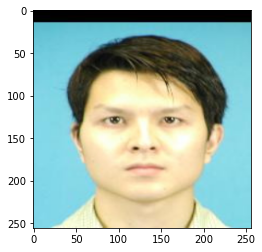

In [54]:
# get some random training images
dataiter = iter(trainloader)
image, labels = dataiter.next()

# show images
imshow(torchvision.utils.make_grid(image))

In [55]:
image = image.to("cpu")
result_image = sketches_model(image)
result_image = result_image.to("cpu").detach()

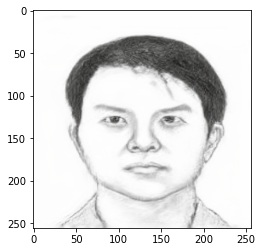

In [56]:
imshow(torchvision.utils.make_grid(result_image))

Применим модель к тестовой картинке.

In [ ]:
# get some random testing images
dataiter = iter(testloader)
image, labels = dataiter.next()

# show images
imshow(torchvision.utils.make_grid(image))

In [ ]:
imshow(torchvision.utils.make_grid(to_gray_images(image)))

In [ ]:
image_gray = to_gray_images(image).to("cpu")
result_image = cifar10_gtc_model(image_gray)
result_image = result_image.to("cpu").detach()

In [ ]:
imshow(torchvision.utils.make_grid(result_image))

Применим к картинке из интернета.

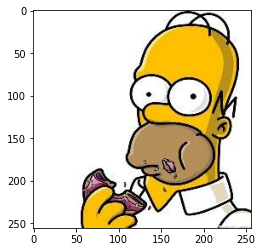

In [9]:
# возьмём картинку из интернета 
from PIL import Image
import requests

image = Image.open(requests.get('https://pbs.twimg.com/profile_images/660129706411429888/3ziXvMDk_400x400.jpg', stream=True).raw)
image = transformation(image)
image = image[None, :, :]
# show image
imshow(torchvision.utils.make_grid(image))

In [10]:
image = image.to("cpu")
result_image = sketches_model(image)
result_image = result_image.to("cpu").detach()

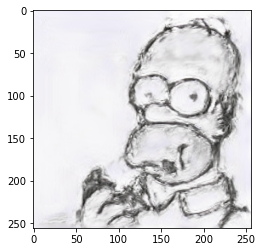

In [11]:
imshow(torchvision.utils.make_grid(result_image))

Если нужно скачать файл с предобученной сетью:

In [58]:
from IPython.display import FileLink
FileLink(r'pytorch_models/pix2pix_generator_sketches_e1000.pt')

/kaggle/working/pytorch_models/pix2pix_generator_sketches_e1000.pt